# Finance Analysis

Timetk is designed to work with any time series domain. **Arguably the
most important is Finance.** This tutorial showcases how you can perform
Financial Investment and Stock Analysis at scale with `pytimetk`. This
applied tutorial covers financial analysis with:

-   `tk.plot_timeseries()`: Visualizing financial data
-   `tk.augment_rolling()`: Moving averages
-   `tk.augment_rolling_apply()`: Rolling correlations and rolling
    regressions

Load the following packages before proceeding with this tutorial.

In [1]:
import pytimetk as tk
import pandas as pd
import numpy as np

# 1. 3 Core Properties: Financial Data

Financial data from sources like `openbb` or `yfinance` come in OHLCV
format and typically include an “adjusted” price (adjusted for stock
splits). This data has the 3 core properties of time series:

1.  Timestamp: daily, hourly frequencies
2.  Value: A price (or returns)
3.  Groups: Stock symbols

Let’s take a look with the `tk.glimpse()` function.

In [2]:
stocks_df = tk.load_dataset("stocks_daily", parse_dates = ['date'])

stocks_df.glimpse()

<class 'pandas.core.frame.DataFrame'>: 16194 rows of 8 columns
symbol:    object           ['META', 'META', 'META', 'META', 'META', 'ME ...
date:      datetime64[ns]   [Timestamp('2013-01-02 00:00:00'), Timestamp ...
open:      float64          [27.440000534057617, 27.8799991607666, 28.01 ...
high:      float64          [28.18000030517578, 28.46999931335449, 28.93 ...
low:       float64          [27.420000076293945, 27.59000015258789, 27.8 ...
close:     float64          [28.0, 27.770000457763672, 28.76000022888184 ...
volume:    int64            [69846400, 63140600, 72715400, 83781800, 458 ...
adjusted:  float64          [28.0, 27.770000457763672, 28.76000022888184 ...

# 2. Visualizing Financial Data

Visualizing financial data is critical for:

1.  Quick Insights
2.  Enhanced Decision Making
3.  Performance Monitoring
4.  Ease of Reporting

We can visualize financial data over time with `tk.plot_timeseries()`:

-   An interactive `plotly` plot is returned by default. A static plot
    can be returned by setting `engine = "plotnine"`.
-   A blue smoother is added by default. The smoother can be removed
    with `smooth = False`.

> **Getting More Info: `tk.plot_timeseries()`**
>
> -   Click here to see our [Data Visualization
>     Guide](/guides/01_visualization.html)
> -   Use `help(tk.plot_timeseries)` to review additional helpful
>     documentation.

## Plotly

An interactive `plotly` plot is returned by default. Interactive is
useful for fast data exploration and for use in web apps
(e.g. `streamlit`, `shiny`, `dash`), **Click to expand code template.**

``` python
# plotly engine
stocks_df \
    .groupby('symbol') \
    .plot_timeseries(
        'date', 'adjusted',
        facet_ncol = 2,
        smooth = True,
        smooth_frac = 0.10,
        width = 900,
        height = 700,
        engine = 'plotly',
    )
```

        <script type="text/javascript">
        window.PlotlyConfig = {MathJaxConfig: 'local'};
        if (window.MathJax && window.MathJax.Hub && window.MathJax.Hub.Config) {window.MathJax.Hub.Config({SVG: {font: "STIX-Web"}});}
        if (typeof require !== 'undefined') {
        require.undef("plotly");
        requirejs.config({
            paths: {
                'plotly': ['https://cdn.plot.ly/plotly-2.26.0.min']
            }
        });
        require(['plotly'], function(Plotly) {
            window._Plotly = Plotly;
        });
        }
        </script>
        

<div>                            <div id="660b3a9f-521b-46be-832f-8a75c886e498" class="plotly-graph-div" style="height:700px; width:900px;"></div>            <script type="text/javascript">                require(["plotly"], function(Plotly) {                    window.PLOTLYENV=window.PLOTLYENV || {};                                    if (document.getElementById("660b3a9f-521b-46be-832f-8a75c886e498")) {                    Plotly.newPlot(                        "660b3a9f-521b-46be-832f-8a75c886e498",                        [{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[28.0,27.770000457763672,28.76000022888184,29.420000076293945,29.059999465942383,30.59000015258789,31.299999237060547,31.71999931335449,30.950000762939453,30.100000381469727,29.850000381469727,30.13999938964844,29.65999984741211,30.729999542236328,30.81999969482422,31.07999992370605,31.540000915527344,32.470001220703125,30.790000915527344,31.239999771118164,30.979999542236328,29.729999542236328,28.11000061035156,28.63999938964844,29.049999237060547,28.649999618530277,28.549999237060547,28.26000022888184,27.3700008392334,27.90999984741211,28.5,28.31999969482422,28.93000030517578,28.459999084472656,27.280000686645508,27.1299991607666,27.270000457763672,27.38999938964844,26.8700008392334,27.25,27.780000686645508,27.71999931335449,27.520000457763672,27.450000762939453,28.57999992370605,27.959999084472656,28.13999938964844,27.82999992370605,27.07999992370605,27.040000915527344,26.649999618530277,26.489999771118164,26.549999237060547,25.86000061035156,25.739999771118164,25.729999542236328,25.1299991607666,25.209999084472656,26.09000015258789,25.57999992370605,25.530000686645508,25.420000076293945,26.25,27.06999969482422,27.38999938964844,26.850000381469727,26.59000015258789,27.56999969482422,28.020000457763672,27.399999618530277,26.520000457763672,26.920000076293945,26.6299991607666,25.690000534057617,25.729999542236328,25.96999931335449,25.979999542236328,26.11000061035156,26.13999938964844,26.850000381469727,26.979999542236328,27.770000457763672,27.43000030517578,28.96999931335449,28.309999465942383,27.56999969482422,26.88999938964844,27.1200008392334,27.040000915527344,26.68000030517578,26.81999969482422,27.06999969482422,26.600000381469727,26.1299991607666,26.25,25.76000022888184,25.65999984741211,25.15999984741211,25.059999465942383,24.309999465942383,24.100000381469727,23.31999969482422,24.549999237060547,24.350000381469727,23.850000381469727,23.520000457763672,22.899999618530277,22.96999931335449,23.290000915527344,24.32999992370605,24.030000686645508,23.770000457763672,23.729999542236328,23.6299991607666,24.020000457763672,24.209999084472656,24.309999465942383,23.899999618530277,24.530000686645508,23.940000534057617,24.25,24.15999984741211,24.65999984741211,24.8799991607666,24.809999465942383,24.40999984741211,24.520000457763672,24.3700008392334,24.709999084472656,25.479999542236328,25.799999237060547,25.809999465942383,25.90999984741211,26.280000686645508,26.31999969482422,26.649999618530277,26.18000030517578,25.8799991607666,26.049999237060547,26.1299991607666,26.51000022888184,34.36000061035156,34.0099983215332,35.43000030517578,37.630001068115234,36.79999923706055,37.4900016784668,38.04999923706055,39.18999862670898,38.54999923706055,38.869998931884766,38.540000915527344,38.5,38.220001220703125,37.02000045776367,36.650001525878906,36.560001373291016,37.08000183105469,37.810001373291016,38.40999984741211,38.31999969482422,38.54999923706055,40.54999923706055,41.34000015258789,39.63999938964844,40.54999923706055,41.27999877929688,41.290000915527344,41.869998931884766,41.77999877929688,42.65999984741211,43.95000076293945,44.040000915527344,43.59999847412109,45.040000915527344,44.75,44.310001373291016,42.5099983215332,45.06999969482422,45.22999954223633,45.97999954223633,47.4900016784668,47.18999862670898,48.45000076293945,49.459999084472656,50.38999938964844,51.2400016784668,50.22999954223633,50.41999816894531,50.27999877929688,49.18000030517578,51.040000915527344,50.52000045776367,47.13999938964844,46.77000045776367,49.04999923706055,49.11000061035156,49.5099983215332,49.5,51.13999938964844,52.209999084472656,54.220001220703125,53.84999847412109,52.68000030517578,51.900001525878906,52.45000076293945,51.95000076293945,50.22999954223633,49.400001525878906,49.0099983215332,50.209999084472656,49.75,48.220001220703125,50.11000061035156,49.119998931884766,47.560001373291016,47.52999877929688,46.20000076293945,46.61000061035156,48.709999084472656,48.9900016784668,49.0099983215332,45.83000183105469,46.36000061035156,46.43000030517578,46.70000076293945,46.22999954223633,44.81999969482422,45.88999938964844,46.4900016784668,47.0099983215332,47.060001373291016,46.72999954223633,48.619998931884766,48.34000015258789,47.93999862670898,48.84000015258789,50.25,49.380001068115234,51.83000183105469,53.31999969482422,53.810001373291016,54.86000061035156,55.56999969482422,55.04999923706055,55.119998931884766,57.77000045776367,57.959999084472656,57.72999954223633,55.43999862670898,53.709999084472656,54.650001525878906,54.709999084472656,54.560001373291016,57.20000076293945,57.91999816894531,58.22999954223633,57.220001220703125,57.93999862670898,55.90999984741211,57.7400016784668,57.59999847412109,57.18999862670898,56.29999923706055,58.5099983215332,57.5099983215332,56.630001068115234,54.45000076293945,53.54999923706055,55.13999938964844,53.52999877929688,61.08000183105469,62.56999969482422,61.47999954223633,62.75,62.18999862670898,62.15999984741211,64.31999969482422,63.54999923706055,64.8499984741211,64.44999694824219,67.33000183105469,67.08999633789062,67.30000305175781,68.05999755859375,69.62999725341797,68.58999633789062,70.77999877929688,69.8499984741211,69.26000213623047,68.94000244140625,68.45999908447266,67.41000366210938,68.80000305175781,71.56999969482422,70.83999633789062,69.80000305175781,72.02999877929688,70.0999984741211,70.87999725341797,68.83000183105469,67.72000122070312,68.73999786376953,69.19000244140625,68.23999786376953,66.97000122070312,67.23999786376953,64.0999984741211,64.88999938964844,60.38999938964844,60.970001220703125,60.0099983215332,60.2400016784668,62.619998931884766,62.720001220703125,59.4900016784668,56.75,56.95000076293945,58.18999862670898,62.40999984741211,59.15999984741211,58.52999877929688,58.88999938964844,59.09000015258789,59.720001220703125,58.93999862670898,61.2400016784668,63.02999877929688,61.36000061035156,60.869998931884766,57.709999084472656,56.13999938964844,58.150001525878906,59.77999877929688,61.150001525878906,60.459999084472656,61.220001220703125,58.52999877929688,57.38999938964844,56.7599983215332,57.2400016784668,59.83000183105469,59.83000183105469,59.22999954223633,57.91999816894531,58.02000045776367,59.209999084472656,58.560001373291016,60.4900016784668,60.52000045776367,61.34999847412109,63.47999954223633,63.5099983215332,63.83000183105469,63.29999923706055,63.08000183105469,62.869998931884766,63.34000015258789,63.18999862670898,62.5,62.880001068115234,65.7699966430664,65.77999877929688,64.29000091552734,64.5,64.19000244140625,64.4000015258789,65.5999984741211,64.33999633789062,64.5,65.37000274658203,65.72000122070312,67.44000244140625,67.12999725341797,67.5999984741211,67.29000091552734,68.05999755859375,66.44999694824219,66.29000091552734,65.29000091552734,62.7599983215332,64.97000122070312,64.87000274658203,66.33999633789062,67.9000015258789,67.16999816894531,67.66000366210938,66.41000366210938,68.41999816894531,69.4000015258789,69.2699966430664,71.29000091552734,74.9800033569336,75.19000244140625,74.91999816894531,73.70999908447266,74.68000030517578,72.6500015258789,72.36000061035156,73.51000213623047,72.69000244140625,72.47000122070312,73.16999816894531,73.05999755859375,73.44000244140625,72.83000183105469,73.7699966430664,74.30000305175781,73.62999725341797,74.58999633789062,75.29000091552734,74.80999755859375,74.56999969482422,74.56999969482422,75.0199966430664,75.95999908447266,74.62999725341797,73.86000061035156,74.81999969482422,76.68000030517578,75.83000183105469,75.94999694824219,77.26000213623047,77.88999938964844,76.66999816894531,77.43000030517578,77.91999816894531,77.4800033569336,74.58000183105469,76.08000183105469,76.43000030517578,77.0,77.91000366210938,76.80000305175781,78.29000091552734,78.54000091552734,77.22000122070312,78.79000091552734,79.0,79.04000091552734,76.55000305175781,77.08000183105469,77.44000244140625,77.55999755859375,76.29000091552734,77.5199966430664,75.91000366210938,72.91000366210938,72.98999786376953,73.58999633789062,73.20999908447266,72.62999725341797,75.94999694824219,76.94999694824219,78.69000244140625,78.37000274658203,80.04000091552734,80.66999816894531,80.27999877929686,80.7699966430664,75.86000061035156,74.11000061035156,74.98999786376953,73.87999725341797,75.76000213623047,74.83000183105469,75.26000213623047,75.5999984741211,75.0,74.61000061035156,74.72000122070312,74.25,74.87999725341797,74.23999786376953,74.33999633789062,73.33000183105469,73.5999984741211,73.75,74.01000213623047,75.62999725341797,77.62000274658203,77.69999694824219,75.0999984741211,75.45999908447266,74.87999725341797,75.23999786376953,76.36000061035156,76.5199966430664,76.83999633789062,76.18000030517578,77.7300033569336,77.83000183105469,76.98999786376953,74.69000244140625,76.11000061035156,78.4000015258789,79.87999725341797,81.44999694824219,80.61000061035156,80.7699966430664,80.77999877929686,80.0199966430664,79.22000122070312,78.0199966430664,78.44999694824219,77.19000244140625,76.1500015258789,76.1500015258789,78.18000030517578,77.73999786376953,76.72000122070312,76.44999694824219,76.27999877929686,74.05000305175781,75.18000030517578,76.23999786376953,76.73999786376953,77.6500015258789,77.83000183105469,77.5,75.77999877929686,76.23999786376953,78.0,75.91000366210938,74.98999786376953,75.4000015258789,75.62999725341797,75.61000061035156,74.47000122070312,74.44000244140625,75.19000244140625,76.51000213623047,76.2300033569336,75.73999786376953,75.5999984741211,76.70999908447266,79.41999816894531,79.9000015258789,78.83999633789062,78.44999694824219,79.55999755859375,80.41000366210938,78.97000122070312,79.75,79.5999984741211,80.9000015258789,81.20999908447266,80.01000213623047,79.44000244140625,77.55000305175781,77.56999969482422,78.93000030517578,78.05000305175781,78.06999969482422,79.36000061035156,80.91000366210938,82.75,83.80000305175781,84.43000030517578,85.30999755859375,82.91999816894531,83.01000213623047,83.30000305175781,83.19999694824219,82.22000122070312,81.66999816894531,81.55999755859375,82.44000244140625,82.31999969482422,82.27999877929686,82.16999816894531,82.04000091552734,83.01000213623047,83.5199966430664,82.70999908447266,82.30999755859375,80.77999877929686,83.08999633789062,83.62000274658203,84.62999725341797,82.41000366210938,81.52999877929686,81.91000366210938,80.68000030517578,80.47000122070312,78.7699966430664,78.98999786376953,78.80999755859375,77.55999755859375,78.0999984741211,78.43000030517578,78.51000213623047,78.01000213623047,77.45999908447266,78.44000244140625,81.37000274658203,80.41999816894531,80.87999725341797,80.62999725341797,80.55000305175781,80.4800033569336,80.54000091552734,79.33000183105469,80.55000305175781,80.1500015258789,79.19000244140625,80.29000091552734,80.44000244140625,82.44000244140625,82.05000305175781,82.13999938964844,80.66999816894531,80.66999816894531,82.16000366210938,81.83000183105469,81.52999877929686,80.70999908447266,81.05999755859375,81.79000091552734,82.91000366210938,82.51000213623047,84.73999786376953,87.87999725341797,88.86000061035156,87.9800033569336,88.01000213623047,85.80000305175781,85.7699966430664,86.91000366210938,87.29000091552734,87.55000305175781,87.22000122070312,85.6500015258789,85.87999725341797,87.94999694824219,90.0999984741211,89.68000030517578,89.76000213623047,90.8499984741211,94.97000122070312,97.91000366210936,98.38999938964844,97.04000091552734,95.44000244140624,96.9499969482422,94.16999816894533,95.29000091552734,96.98999786376952,95.20999908447266,94.01000213623048,94.13999938964844,94.05999755859376,96.44000244140624,95.12000274658205,94.3000030517578,94.1500015258789,93.62000274658205,94.19000244140624,93.43000030517578,94.41999816894533,93.93000030517578,95.16999816894533,95.30999755859376,90.55999755859376,86.05999755859375,82.08999633789062,83.0,87.19000244140625,89.7300033569336,91.01000213623048,89.43000030517578,87.2300033569336,89.88999938964844,88.1500015258789,88.26000213623047,89.52999877929686,90.44000244140624,91.9800033569336,92.0500030517578,92.30999755859376,92.9000015258789,93.4499969482422,94.33999633789062,94.4000015258789,95.5500030517578,92.95999908447266,93.97000122070312,94.41000366210936,92.7699966430664,89.20999908447266,86.66999816894531,89.9000015258789,90.9499969482422,92.06999969482422,94.01000213623048,92.8000030517578,92.4000015258789,92.47000122070312,93.23999786376952,94.26000213623048,94.12000274658205,94.06999969482422,95.95999908447266,97.54000091552734,98.47000122070312,97.0,97.11000061035156,99.66999816894533,102.19000244140624,103.7699966430664,103.6999969482422,104.1999969482422,104.87999725341795,101.97000122070312,103.30999755859376,102.58000183105467,103.94000244140624,108.76000213623048,107.0999984741211,106.48999786376952,107.91000366210938,109.01000213623048,108.0199966430664,103.9499969482422,104.04000091552734,105.12999725341795,107.7699966430664,106.26000213623048,107.31999969482422,106.9499969482422,105.73999786376952,105.41000366210938,105.4499969482422,104.23999786376952,107.12000274658205,106.06999969482422,104.37999725341795,106.18000030517578,105.61000061035156,106.48999786376952,104.5999984741211,105.41999816894533,102.12000274658205,104.66000366210938,104.5500030517578,106.79000091552734,106.22000122070312,104.04000091552734,104.7699966430664,105.51000213623048,104.62999725341795,105.0199966430664,105.93000030517578,107.26000213623048,106.22000122070312,104.66000366210938,102.22000122070312,102.7300033569336,102.97000122070312,97.91999816894533,97.33000183105467,97.51000213623048,99.37000274658205,95.44000244140624,98.37000274658205,94.97000122070312,95.26000213623048,94.3499984741211,94.16000366210936,97.94000244140624,97.01000213623048,97.33999633789062,94.4499969482422,109.11000061035156,112.20999908447266,115.08999633789062,114.61000061035156,112.69000244140624,110.48999786376952,104.06999969482422,99.75,99.54000091552734,101.0,101.91000366210938,102.01000213623048,101.61000061035156,105.1999969482422,103.47000122070312,104.56999969482422,107.16000366210938,105.45999908447266,106.87999725341795,108.06999969482422,107.91999816894533,106.91999816894533,109.81999969482422,109.9499969482422,109.58000183105467,108.38999938964844,105.7300033569336,105.93000030517578,107.51000213623048,107.31999969482422,109.41000366210938,109.88999938964844,110.66999816894533,112.18000030517578,111.0199966430664,111.4499969482422,111.8499984741211,112.25,112.54000091552734,113.0500030517578,113.69000244140624,116.13999938964844,114.6999969482422,114.0999984741211,116.05999755859376,112.5500030517578,112.22000122070312,113.70999908447266,113.63999938964844,110.62999725341795,108.98999786376952,110.61000061035156,110.51000213623048,110.83999633789062,109.63999938964844,110.4499969482422,112.29000091552734,112.41999816894533,113.44000244140624,110.55999755859376,110.0999984741211,108.76000213623048,108.88999938964844,116.7300033569336,117.58000183105467,118.56999969482422,117.43000030517578,118.05999755859376,117.80999755859376,119.48999786376952,119.23999786376952,120.5,119.5199966430664,120.27999877929688,119.80999755859376,118.66999816894533,117.3499984741211,117.6500015258789,116.80999755859376,117.3499984741211,115.97000122070312,117.6999969482422,117.88999938964844,119.47000122070312,119.37999725341795,118.80999755859376,118.77999877929688,118.93000030517578,118.47000122070312,118.79000091552734,117.76000213623048,118.38999938964844,118.55999755859376,116.62000274658205,113.9499969482422,114.94000244140624,114.5999984741211,114.38999938964844,113.0199966430664,113.37000274658205,114.37999725341795,113.91000366210938,115.08000183105467,112.08000183105467,108.97000122070312,112.6999969482422,114.16000366210938,114.27999877929688,114.19000244140624,114.1999969482422,116.6999969482422,115.8499984741211,117.23999786376952,117.87000274658205,117.93000030517578,116.77999877929688,117.29000091552734,116.86000061035156,119.37000274658205,120.61000061035156,121.91999816894533,120.61000061035156,121.0,121.62999725341795,121.22000122070312,123.33999633789062,125.0,123.94000244140624,124.30999755859376,123.08999633789062,122.51000213623048,124.36000061035156,125.1500015258789,125.26000213623048,125.05999755859376,124.87999725341795,124.9000015258789,124.87999725341795,123.9000015258789,123.3000030517578,124.37000274658205,123.91000366210938,123.55999755859376,124.1500015258789,124.37000274658205,123.4800033569336,123.88999938964844,124.95999908447266,126.54000091552734,125.83999633789062,126.12000274658205,126.16999816894533,126.51000213623048,129.72999572753906,131.0500030517578,130.27000427246094,127.0999984741211,128.69000244140625,127.20999908447266,127.7699966430664,128.35000610351562,129.07000732421875,128.64999389648438,128.63999938964844,129.94000244140625,130.0800018310547,127.95999908447266,127.30999755859376,128.69000244140625,129.22999572753906,128.08999633789062,128.27000427246094,128.77000427246094,128.19000244140625,128.47000122070312,128.74000549316406,128.99000549316406,130.24000549316406,128.8800048828125,129.0500030517578,127.81999969482422,127.87999725341795,127.54000091552734,128.57000732421875,130.11000061035156,130.0,132.07000732421875,133.27999877929688,132.2899932861328,131.0399932861328,129.69000244140625,131.2899932861328,130.99000549316406,129.5,127.16999816894533,120.0,120.75,122.1500015258789,124.22000122070312,123.18000030517578,120.8000030517578,119.0199966430664,115.08000183105467,117.1999969482422,116.33999633789062,117.79000091552734,117.0199966430664,121.7699966430664,121.47000122070312,120.83999633789062,120.37999725341795,120.41000366210938,120.87000274658205,118.41999816894533,115.0999984741211,115.4000015258789,117.43000030517578,117.30999755859376,117.9499969482422,118.91000366210938,119.68000030517578,117.7699966430664,120.30999755859376,120.20999908447266,120.56999969482422,119.87000274658205,119.23999786376952,119.08999633789062,119.04000091552734,117.4000015258789,117.2699966430664,118.01000213623048,116.91999816894533,116.3499984741211,115.0500030517578,116.86000061035156,118.69000244140624,120.66999816894533,123.41000366210938,124.9000015258789,124.3499984741211,126.08999633789062,126.62000274658205,128.33999633789062,127.87000274658205,127.91999816894533,127.5500030517578,127.04000091552734,128.92999267578125,129.3699951171875,131.47999572753906,132.77999877929688,132.17999267578125,130.97999572753906,130.32000732421875,133.22999572753906,130.83999633789062,130.97999572753906,132.05999755859375,131.83999633789062,134.1999969482422,134.13999938964844,134.19000244140625,134.0500030517578,133.85000610351562,133.44000244140625,133.83999633789062,133.52999877929688,133.72000122070312,136.1199951171875,135.36000061035156,135.44000244140625,136.41000366210938,135.5399932861328,137.4199981689453,136.75999450683594,137.1699981689453,137.4199981689453,137.3000030517578,137.72000122070312,138.24000549316406,138.7899932861328,139.60000610351562,139.32000732421875,139.72000122070312,139.99000549316406,139.83999633789062,139.94000244140625,138.50999450683594,139.58999633789062,139.52999877929688,140.33999633789062,140.32000732421875,141.75999450683594,142.64999389648438,142.41000366210938,142.0500030517578,142.27999877929688,141.72999572753906,141.85000610351562,141.1699981689453,140.77999877929688,141.0399932861328,139.9199981689453,139.5800018310547,139.38999938964844,141.4199981689453,140.9600067138672,142.27000427246094,143.8000030517578,143.67999267578125,145.47000122070312,146.49000549316406,146.55999755859375,147.6999969482422,150.25,152.4600067138672,152.77999877929688,151.8000030517578,150.85000610351562,150.24000549316406,151.05999755859375,150.47999572753906,150.2899932861328,150.0399932861328,150.3300018310547,150.19000244140625,149.77999877929688,144.85000610351562,147.66000366210938,148.05999755859375,148.24000549316406,148.07000732421875,150.0399932861328,151.9600067138672,152.1300048828125,152.3800048828125,151.4600067138672,151.52999877929688,153.61000061035156,153.6300048828125,152.80999755859375,153.1199951171875,154.7100067138672,149.60000610351562,148.44000244140625,150.67999267578125,150.25,149.8000030517578,150.63999938964844,152.8699951171875,152.25,153.91000366210938,153.39999389648438,155.07000732421875,153.58999633789062,150.5800018310547,153.24000549316406,151.0399932861328,150.97999572753906,148.42999267578125,150.33999633789062,148.82000732421875,151.44000244140625,153.5,155.27000427246094,158.89999389648438,159.25999450683594,159.97000122070312,159.72999572753906,162.86000061035156,164.13999938964844,164.52999877929688,164.42999267578125,166.0,165.27999877929688,165.61000061035156,170.44000244140625,172.4499969482422,169.25,169.86000061035156,169.3000030517578,168.58999633789062,169.6199951171875,171.97999572753906,171.22999572753906,171.17999267578125,167.39999389648438,168.0800018310547,170.75,171.0,170.0,166.91000366210938,167.41000366210938,167.77999877929688,169.63999938964844,168.7100067138672,167.74000549316406,166.32000732421875,167.24000549316406,168.0500030517578,169.9199981689453,171.97000122070312,172.02000427246094,170.72000122070312,172.08999633789062,173.2100067138672,170.9499969482422,173.50999450683594,172.9600067138672,173.0500030517578,170.9600067138672,171.63999938964844,170.00999450683594,172.52000427246094,172.1699981689453,171.11000061035156,170.5399932861328,162.8699951171875,164.2100067138672,167.67999267578125,168.72999572753906,170.8699951171875,169.47000122070312,169.9600067138672,168.4199981689453,171.24000549316406,172.22999572753906,172.5,171.58999633789062,172.74000549316406,172.5500030517578,173.74000549316406,174.52000427246094,176.11000061035156,176.02999877929688,174.55999755859375,174.97999572753906,171.27000427246094,171.8000030517578,170.60000610351562,170.6300048828125,177.8800048828125,179.8699951171875,180.05999755859375,182.66000366210935,178.9199981689453,178.9199981689453,180.1699981689453,180.25,179.55999755859375,179.3000030517578,178.4600067138672,178.77000427246094,178.07000732421875,177.9499969482422,179.58999633789062,179.0,178.74000549316406,181.8600006103516,180.8699951171875,182.77999877929688,183.02999877929688,182.4199981689453,175.1300048828125,177.17999267578125,175.10000610351562,171.47000122070312,172.8300018310547,176.05999755859375,180.13999938964844,179.0,179.0399932861328,176.9600067138672,178.3000030517578,178.38999938964844,180.17999267578125,180.82000732421875,179.50999450683594,177.88999938964844,177.4499969482422,177.1999969482422,175.99000549316406,177.6199951171875,177.9199981689453,176.4600067138672,181.4199981689453,184.6699981689453,184.3300018310547,186.8500061035156,188.27999877929688,187.8699951171875,187.83999633789065,187.7700042724609,179.3699951171875,178.38999938964844,177.60000610351562,179.8000030517578,181.2899932861328,185.3699951171875,189.3500061035156,186.5500030517578,187.47999572753903,190.0,185.97999572753903,187.1199951171875,186.88999938964844,193.08999633789065,190.27999877929688,181.25999450683597,185.30999755859372,180.17999267578125,171.5800018310547,176.11000061035156,176.41000366210938,173.14999389648438,179.52000427246094,179.9600067138672,177.36000061035156,176.00999450683594,177.91000366210938,178.99000549316406,183.2899932861328,184.92999267578125,181.4600067138672,178.32000732421875,175.94000244140625,176.6199951171875,180.3999938964844,179.77999877929688,183.7100067138672,182.33999633789065,185.22999572753903,184.75999450683597,181.8800048828125,184.19000244140625,183.8600006103516,185.08999633789065,172.55999755859375,168.14999389648438,169.38999938964844,164.88999938964844,159.38999938964844,160.05999755859375,152.22000122070312,153.02999877929688,159.7899932861328,155.38999938964844,156.11000061035156,155.10000610351562,159.33999633789062,157.1999969482422,157.92999267578125,165.0399932861328,166.32000732421875,163.8699951171875,164.52000427246094,164.8300018310547,168.66000366210938,166.36000061035156,168.10000610351562,166.27999877929688,165.83999633789062,159.69000244140625,159.69000244140625,174.16000366210938,173.58999633789062,172.0,173.86000061035156,176.07000732421875,174.02000427246094,176.61000061035156,177.97000122070312,178.9199981689453,182.66000366210935,185.52999877929688,186.9900054931641,186.63999938964844,184.32000732421875,183.1999969482422,183.75999450683597,182.67999267578125,184.4900054931641,183.8000030517578,186.8999938964844,185.92999267578125,184.9199981689453,185.7400054931641,187.6699981689453,191.77999877929688,193.9900054931641,193.27999877929688,192.94000244140625,191.33999633789065,188.17999267578125,189.1000061035156,191.5399932861328,192.3999938964844,192.41000366210935,196.80999755859372,195.8500061035156,198.30999755859372,197.4900054931641,202.0,201.5,201.7400054931641,196.3500061035156,199.0,195.83999633789065,196.22999572753903,194.32000732421875,197.3600006103516,192.72999572753903,198.4499969482422,203.22999572753903,204.7400054931641,203.5399932861328,202.5399932861328,206.9199981689453,207.32000732421875,207.22999572753903,209.9900054931641,209.3600006103516,208.08999633789065,209.94000244140625,210.91000366210935,214.6699981689453,217.5,176.25999450683594,174.88999938964844,171.05999755859375,172.5800018310547,171.64999389648438,176.3699951171875,177.77999877929688,185.69000244140625,183.80999755859372,185.17999267578125,183.08999633789065,180.25999450683597,180.0500030517578,181.1100006103516,179.52999877929688,174.6999969482422,173.8000030517578,172.5,172.6199951171875,173.63999938964844,172.89999389648438,174.64999389648438,177.4600067138672,176.25999450683594,175.89999389648438,177.63999938964844,175.72999572753906,171.16000366210938,167.17999267578125,162.52999877929688,163.0399932861328,164.17999267578125,165.94000244140625,162.0,161.36000061035156,162.32000732421875,160.5800018310547,160.3000030517578,163.05999755859375,166.02000427246094,162.92999267578125,165.41000366210938,164.91000366210938,166.9499969482422,168.83999633789062,164.4600067138672,162.44000244140625,159.3300018310547,162.42999267578125,158.85000610351562,157.3300018310547,157.25,157.89999389648438,151.3800048828125,153.35000610351562,153.74000549316406,153.52000427246094,158.77999877929688,159.4199981689453,154.9199981689453,154.0500030517578,154.77999877929688,154.38999938964844,146.0399932861328,150.9499969482422,145.3699951171875,142.08999633789062,146.22000122070312,151.7899932861328,151.75,150.35000610351562,148.67999267578125,149.94000244140625,151.52999877929688,147.8699951171875,144.9600067138672,141.5500030517578,142.16000366210938,144.22000122070312,143.85000610351562,139.52999877929688,131.5500030517578,132.42999267578125,134.82000732421875,131.72999572753906,136.3800048828125,135.0,136.75999450683594,138.67999267578125,140.61000061035156,141.08999633789062,137.92999267578125,139.6300048828125,137.4199981689453,141.85000610351562,142.0800018310547,144.5,145.00999450683594,144.05999755859375,140.19000244140625,143.66000366210938,133.24000549316406,133.39999389648438,124.9499969482422,124.05999755859376,134.17999267578125,134.52000427246094,133.1999969482422,131.08999633789062,135.67999267578125,131.74000549316406,137.9499969482422,138.0500030517578,142.52999877929688,144.22999572753906,144.1999969482422,143.8000030517578,145.38999938964844,148.9499969482422,147.5399932861328,148.3000030517578,150.0399932861328,147.57000732421875,144.3000030517578,145.8300018310547,149.00999450683594,147.47000122070312,144.19000244140625,150.4199981689453,166.69000244140625,165.7100067138672,169.25,171.16000366210938,170.49000549316406,166.3800048828125,167.3300018310547,165.7899932861328,165.0399932861328,164.07000732421875,163.9499969482422,162.5,162.2899932861328,162.55999755859375,160.0399932861328,161.88999938964844,164.6199951171875,164.1300048828125,162.80999755859375,161.4499969482422,162.27999877929688,167.3699951171875,171.25999450683594,172.50999450683594,169.1300048828125,169.60000610351562,172.07000732421875,171.9199981689453,173.3699951171875,170.1699981689453,165.97999572753906,160.47000122070312,161.57000732421875,165.44000244140625,166.0800018310547,164.33999633789062,166.2899932861328,167.67999267578125,165.8699951171875,165.5500030517578,166.69000244140625,168.6999969482422,174.1999969482422,173.5399932861328,176.02000427246094,175.72000122070312,174.92999267578125,177.5800018310547,177.82000732421875,177.50999450683594,179.10000610351562,179.64999389648438,178.8699951171875,178.77999877929688,178.27999877929688,181.44000244140625,183.77999877929688,182.5800018310547,193.25999450683597,191.4900054931641,194.77999877929688,193.3999938964844,193.02999877929688,192.52999877929688,195.47000122070312,193.8800048828125,189.7700042724609,189.5399932861328,188.6499938964844,188.33999633789065,181.5399932861328,180.72999572753903,186.2700042724609,186.9900054931641,185.3000030517578,182.72000122070312,184.82000732421875,185.32000732421875,180.8699951171875,181.05999755859372,184.30999755859372,182.19000244140625,183.00999450683597,177.47000122070312,164.14999389648438,167.5,168.1699981689453,168.3300018310547,173.35000610351562,174.82000732421875,178.10000610351562,175.0399932861328,177.47000122070312,181.3300018310547,189.00999450683597,188.47000122070312,187.47999572753903,189.52999877929688,191.13999938964844,192.6000061035156,188.83999633789065,187.66000366210935,189.5,193.0,193.0,195.0,197.1999969482422,196.3999938964844,195.75999450683597,199.2100067138672,202.72999572753903,201.22999572753903,204.8699951171875,203.91000366210935,203.83999633789065,201.8000030517578,200.77999877929688,198.3600006103516,202.32000732421875,202.3600006103516,204.66000366210935,200.7100067138672,199.75,195.94000244140625,197.0399932861328,194.22999572753903,192.72999572753903,189.0200042724609,181.72999572753903,184.50999450683597,185.1499938964844,190.16000366210935,187.8500061035156,185.3699951171875,188.4499969482422,179.7100067138672,182.58999633789065,183.6999969482422,186.1699981689453,183.80999755859372,183.5500030517578,182.0399932861328,177.75,180.3600006103516,181.3000030517578,181.75999450683597,185.57000732421875,185.6699981689453,182.38999938964844,187.13999938964844,190.8999938964844,187.4900054931641,188.75999450683597,186.1699981689453,188.4900054931641,187.47000122070312,187.19000244140625,186.22000122070312,188.0800018310547,188.13999938964844,190.13999938964844,189.92999267578125,186.82000732421875,181.27999877929688,182.8000030517578,180.11000061035156,177.10000610351562,178.0800018310547,175.80999755859375,174.60000610351562,179.3800048828125,180.4499969482422,179.67999267578125,177.75,179.85000610351562,180.02999877929688,184.19000244140625,183.27999877929688,188.88999938964844,189.5500030517578,190.38999938964844,185.8500061035156,189.75999450683597,182.33999633789065,186.1499938964844,186.3800048828125,187.88999938964844,189.3999938964844,189.30999755859372,188.25,191.6499938964844,193.6199951171875,194.72000122070312,194.32000732421875,191.5500030517578,190.4199981689453,190.83999633789065,189.6100006103516,194.47000122070312,193.19000244140625,193.1499938964844,195.1000061035156,197.3999938964844,199.32000732421875,197.50999450683597,197.92999267578125,198.82000732421875,199.7899932861328,198.97000122070312,202.0,201.63999938964844,199.6999969482422,198.82000732421875,198.7100067138672,199.3600006103516,201.0500030517578,201.33999633789065,200.8699951171875,202.25999450683597,196.75,194.1100006103516,197.9199981689453,198.38999938964844,202.5,206.05999755859372,206.3000030517578,206.17999267578125,205.1199951171875,207.7899932861328,208.1000061035156,204.41000366210935,205.25,209.77999877929688,208.6699981689453,212.6000061035156,213.05999755859372,215.22000122070312,218.3000030517578,218.05999755859372,221.91000366210935,219.05999755859372,221.1499938964844,221.7700042724609,222.13999938964844,221.44000244140625,221.32000732421875,219.75999450683597,217.94000244140625,214.8699951171875,217.7899932861328,223.22999572753903,209.52999877929688,201.91000366210935,204.19000244140625,209.8300018310547,210.1100006103516,210.8500061035156,212.3300018310547,213.05999755859372,207.19000244140625,210.75999450683597,213.13999938964844,214.17999267578125,217.8000030517578,217.4900054931641,214.5800018310547,210.17999267578125,200.72000122070312,196.7700042724609,197.1999969482422,189.75,192.47000122070312,196.44000244140625,185.88999938964844,191.75999450683597,185.1699981689453,181.08999633789065,169.5,178.19000244140625,170.24000549316406,154.47000122070312,170.27999877929688,146.00999450683594,149.4199981689453,146.9600067138672,153.1300048828125,149.72999572753906,148.10000610351562,160.97999572753906,156.2100067138672,163.33999633789062,156.7899932861328,165.9499969482422,166.8000030517578,159.60000610351562,158.19000244140625,154.17999267578125,165.5500030517578,168.8300018310547,174.27999877929688,175.19000244140625,174.7899932861328,178.1699981689453,176.97000122070312,176.25,179.24000549316406,178.24000549316406,170.8000030517578,182.27999877929688,185.1300048828125,190.07000732421875,187.5,182.91000366210935,194.19000244140625,204.7100067138672,202.2700042724609,205.25999450683597,207.07000732421875,208.47000122070312,211.25999450683597,212.3500061035156,213.17999267578125,210.1000061035156,205.1000061035156,206.80999755859372,210.8800048828125,213.19000244140625,216.8800048828125,229.97000122070312,231.38999938964844,234.91000366210935,232.1999969482422,229.13999938964844,225.4600067138672,225.08999633789065,231.91000366210935,232.72000122070312,230.16000366210935,226.2899932861328,230.7700042724609,231.3999938964844,238.6699981689453,236.72999572753903,224.42999267578125,228.5800018310547,232.5,235.6499938964844,235.52999877929688,235.94000244140625,238.7899932861328,239.22000122070312,242.2400054931641,234.0200042724609,235.67999267578125,216.0800018310547,220.63999938964844,227.07000732421875,237.5500030517578,233.4199981689453,240.27999877929688,240.8600006103516,243.5800018310547,244.5,245.07000732421875,239.0,239.72999572753903,240.27999877929688,240.92999267578125,242.02999877929688,245.4199981689453,241.75,239.8699951171875,232.6000061035156,230.7100067138672,233.5,230.1199951171875,233.2899932861328,234.5,253.6699981689453,251.9600067138672,249.8300018310547,249.1199951171875,265.2799987792969,268.44000244140625,263.0,256.1300048828125,259.8900146484375,261.29998779296875,261.239990234375,261.1600036621094,262.3399963378906,262.5899963378906,269.010009765625,267.010009765625,271.3900146484375,280.82000732421875,303.9100036621094,293.2200012207031,293.6600036621094,293.20001220703125,295.44000244140625,302.5,291.1199951171875,282.7300109863281,271.1600036621094,273.7200012207031,268.0899963378906,266.6099853515625,266.1499938964844,272.4200134277344,263.5199890136719,254.82000732421875,252.52999877929688,248.1499938964844,254.75,249.0200042724609,249.52999877929688,254.82000732421875,256.82000732421875,261.7900085449219,261.8999938964844,266.6300048828125,259.94000244140625,264.6499938964844,258.6600036621094,258.1199951171875,263.760009765625,264.45001220703125,275.75,276.1400146484375,271.82000732421875,266.7200012207031,265.92999267578125,261.3999938964844,267.5599975585937,278.7300109863281,278.1199951171875,284.7900085449219,277.1099853515625,283.2900085449219,267.6700134277344,280.8299865722656,263.1099853515625,261.3599853515625,265.29998779296875,287.3800048828125,294.67999267578125,293.4100036621094,278.7699890136719,272.42999267578125,276.4800109863281,275.0799865722656,276.95001220703125,278.9599914550781,275.0,271.9700012207031,272.94000244140625,269.70001220703125,268.42999267578125,276.9200134277344,275.5899963378906,277.8099975585937,276.9700012207031,286.54998779296875,287.5199890136719,281.8500061035156,279.70001220703125,285.5799865722656,283.3999938964844,277.9200134277344,277.1199951171875,273.54998779296875,274.19000244140625,275.54998779296875,275.6700134277344,274.4800109863281,276.3999938964844,272.7900085449219,267.0899963378906,268.1099853515625,267.3999938964844,277.0,276.7799987792969,271.8699951171875,273.1600036621094,268.94000244140625,270.9700012207031,263.3099975585937,268.739990234375,267.57000732421875,256.8399963378906,251.08999633789065,251.63999938964844,245.63999938964844,251.3600006103516,261.1000061035156,267.4800109863281,272.8699951171875,274.5,278.010009765625,282.04998779296875,272.1400146484375,265.0,258.3299865722656,262.010009765625,267.0799865722656,266.6499938964844,266.489990234375,268.1000061035156,266.5799865722656,269.45001220703125,271.8699951171875,270.3900146484375,270.5,273.9700012207031,273.57000732421875,269.3900146484375,261.5599975585937,260.3299865722656,265.8599853515625,264.3099975585937,254.69000244140625,257.6199951171875,264.9100036621094,259.0,255.41000366210935,257.6400146484375,264.2799987792969,255.30999755859372,265.739990234375,264.8999938964844,273.8800048828125,268.3999938964844,273.75,279.2799987792969,284.010009765625,278.6199951171875,290.1099853515625,293.5400085449219,290.6300048828125,282.1400146484375,278.739990234375,283.0199890136719,290.82000732421875,288.0,294.5299987792969,298.6600036621094,308.9100036621094,306.260009765625,313.0899963378906,313.0199890136719,312.4599914550781,311.5400085449219,309.760009765625,302.82000732421875,307.82000732421875,306.17999267578125,302.239990234375,302.6499938964844,301.4700012207031,296.5199890136719,301.1300048828125,303.0400085449219,303.57000732421875,307.1000061035156,329.510009765625,325.0799865722656,322.5799865722656,318.3599853515625,315.0199890136719,320.0199890136719,319.0799865722656,305.9700012207031,306.5299987792969,302.54998779296875,305.260009765625,315.94000244140625,315.4599914550781,309.9599914550781,313.5899963378906,318.6099853515625,316.2300109863281,324.6300048828125,327.7900085449219,327.6600036621094,332.75,328.7300109863281,329.1300048828125,329.1499938964844,326.0400085449219,330.3500061035156,336.5799865722656,333.67999267578125,330.25,332.4599914550781,331.260009765625,336.7699890136719,336.75,331.0799865722656,336.510009765625,329.6600036621094,332.2900085449219,339.0299987792969,340.5899963378906,343.17999267578125,341.3699951171875,355.6400146484375,351.8900146484375,347.7099914550781,354.3900146484375,354.70001220703125,352.7799987792969,350.489990234375,345.6499938964844,350.4200134277344,353.1600036621094,352.0899963378906,347.6300048828125,344.4599914550781,341.1600036621094,336.95001220703125,341.6600036621094,346.2300109863281,351.19000244140625,369.7900085449219,372.4599914550781,367.80999755859375,373.2799987792969,358.32000732421875,356.29998779296875,351.95001220703125,351.239990234375,358.9200134277344,362.9700012207031,363.510009765625,361.6099853515625,361.1300048828125,359.9599914550781,362.6499938964844,363.1799926757813,366.55999755859375,358.45001220703125,355.45001220703125,355.1199951171875,359.3699951171875,363.3500061035156,365.510009765625,368.3900146484375,364.3800048828125,372.6300048828125,380.6600036621094,379.3800048828125,382.0499877929688,375.2799987792969,376.260009765625,382.1799926757813,377.5700073242188,378.0,378.6900024414063,376.510009765625,376.5299987792969,373.9200134277344,373.05999755859375,364.7200012207031,355.70001220703125,357.4800109863281,343.2099914550781,345.9599914550781,352.9599914550781,353.5799865722656,340.6499938964844,339.6099853515625,339.3900146484375,343.010009765625,326.2300109863281,332.9599914550781,333.6400146484375,329.2200012207031,330.04998779296875,325.45001220703125,323.7699890136719,324.5400085449219,328.5299987792969,324.760009765625,335.3399963378906,339.989990234375,340.7799987792969,341.8800048828125,324.6099853515625,328.69000244140625,315.8099975585937,312.2200012207031,316.9200134277344,323.57000732421875,329.9800109863281,328.0799865722656,331.6199951171875,335.8500061035156,341.1300048828125,338.6199951171875,335.3699951171875,327.6400146484375,327.739990234375,340.8900146484375,347.5599975585937,342.9599914550781,340.7699890136719,338.69000244140625,345.29998779296875,341.010009765625,337.25,341.0599975585937,333.1199951171875,338.0299987792969,324.4599914550781,310.6000061035156,310.3900146484375,306.8399963378906,317.8699951171875,322.8099975585937,330.5599975585937,329.82000732421875,329.75,334.489990234375,333.739990234375,341.6600036621094,334.8999938964844,333.7900085449219,325.45001220703125,334.20001220703125,330.45001220703125,335.239990234375,346.17999267578125,346.2200012207031,342.94000244140625,344.3599853515625,336.3500061035156,338.5400085449219,336.5299987792969,324.1700134277344,332.4599914550781,331.7900085449219,328.07000732421875,334.3699951171875,333.260009765625,326.4800109863281,331.8999938964844,318.1499938964844,319.5899963378906,316.5599975585937,303.1700134277344,308.7099914550781,300.1499938964844,294.6300048828125,294.6400146484375,301.7099914550781,313.260009765625,319.0,323.0,237.75999450683597,237.08999633789065,224.91000366210935,220.17999267578125,232.0,228.07000732421875,219.5500030517578,217.6999969482422,221.0,216.5399932861328,207.7100067138672,206.16000366210935,202.0800018310547,198.4499969482422,207.6000061035156,210.47999572753903,211.02999877929688,203.4900054931641,208.1100006103516,202.97000122070312,200.05999755859372,187.47000122070312,190.2899932861328,198.5,195.2100067138672,187.6100006103516,186.6300048828125,192.02999877929688,203.6300048828125,207.83999633789065,216.4900054931641,211.4900054931641,216.6499938964844,213.4600067138672,219.57000732421875,221.82000732421875,223.58999633789065,229.8600006103516,227.8500061035156,222.3600006103516,224.8500061035156,233.88999938964844,231.83999633789065,223.3000030517578,222.9499969482422,222.3300018310547,216.4600067138672,214.13999938964844,214.9900054931641,210.17999267578125,210.7700042724609,217.30999755859372,200.4199981689453,188.07000732421875,184.1100006103516,186.9900054931641,180.9499969482422,174.9499969482422,205.72999572753903,200.47000122070312,211.1300048828125,212.02999877929688,223.41000366210935,208.27999877929688,203.7700042724609,196.2100067138672,197.6499938964844,188.7400054931641,191.2400054931641,198.6199951171875,200.0399932861328,202.6199951171875,192.2400054931641,191.2899932861328,193.5399932861328,196.22999572753903,181.27999877929688,183.8300018310547,191.6300048828125,195.1300048828125,193.63999938964844,188.63999938964844,198.8600006103516,190.77999877929688,194.25,195.6499938964844,196.63999938964844,184.0,175.57000732421875,164.25999450683594,163.72999572753906,169.35000610351562,160.8699951171875,163.74000549316406,157.0500030517578,155.85000610351562,158.75,170.16000366210938,169.49000549316406,160.67999267578125,163.94000244140625,161.25,160.02999877929688,168.19000244140625,169.77000427246094,172.19000244140625,170.8800048828125,162.8800048828125,163.27000427246094,163.49000549316406,158.0500030517578,164.6999969482422,167.22999572753906,175.77999877929688,183.08999633789065,183.1699981689453,169.27000427246094,166.64999389648438,159.14999389648438,169.5800018310547,160.72000122070312,159.10000610351562,159.92999267578125,160.19000244140625,168.8000030517578,170.57000732421875,167.11000061035156,170.25,168.52999877929688,178.33999633789062,177.49000549316406,180.5,180.88999938964844,179.47000122070312,174.85000610351562,174.66000366210938,167.9600067138672,163.0500030517578,161.11000061035156,163.25999450683594,168.77999877929688,161.77999877929688,159.1699981689453,157.16000366210938,162.92999267578125,165.36000061035156,160.32000732421875,158.5399932861328,160.38999938964844,162.05999755859375,169.14999389648438,168.9600067138672,153.1300048828125,151.47000122070312,149.5500030517578,146.2899932861328,148.02000427246094,146.08999633789062,142.1199951171875,142.82000732421875,140.41000366210938,136.3699951171875,134.39999389648438,141.61000061035156,136.41000366210938,135.67999267578125,138.61000061035156,140.27999877929688,138.97999572753906,139.07000732421875,133.4499969482422,133.7899932861328,128.5399932861328,127.5,130.2899932861328,126.76000213623048,134.0399932861328,132.8000030517578,133.22999572753906,131.52999877929688,130.00999450683594,129.72000122070312,137.50999450683594,129.82000732421875,97.94000244140624,99.1999969482422,93.16000366210936,95.1999969482422,90.54000091552734,88.91000366210938,90.79000091552734,96.72000122070312,96.47000122070312,101.47000122070312,111.87000274658205,113.0199966430664,114.22000122070312,117.08000183105467,113.2300033569336,111.4499969482422,112.0500030517578,109.86000061035156,111.44000244140624,112.23999786376952,111.41000366210938,108.77999877929688,109.45999908447266,118.0999984741211,120.44000244140624,123.48999786376952,122.43000030517578,114.12000274658205,113.93000030517578,115.33000183105467,115.9000015258789,114.70999908447266,120.1500015258789,121.58999633789062,116.1500015258789,119.43000030517578,114.4800033569336,117.08999633789062,119.76000213623048,117.12000274658205,118.04000091552734,116.87999725341795,115.62000274658205,120.26000213623048,120.33999633789062,124.73999786376952,127.37000274658205,126.94000244140624,130.02000427246094,129.47000122070312,132.99000549316406,132.88999938964844,136.7100067138672,136.97999572753906,135.36000061035156,133.02000427246094,136.14999389648438,139.3699951171875,143.27000427246094,143.13999938964844,141.5,147.3000030517578,151.74000549316406,147.05999755859375,148.97000122070312,153.1199951171875,188.7700042724609,186.52999877929688,186.05999755859372,191.6199951171875,183.42999267578125,177.9199981689453,174.14999389648438,179.42999267578125,179.47999572753906,177.16000366210938,172.44000244140625,172.8800048828125,172.0800018310547,171.1199951171875,172.0399932861328,170.38999938964844,169.5399932861328,174.94000244140625,173.4199981689453,174.52999877929688,185.25,184.8999938964844,184.50999450683597,184.97000122070312,181.69000244140625,179.50999450683594,180.8999938964844,194.0200042724609,197.75,204.92999267578125,195.6100006103516,197.80999755859372,202.16000366210935,199.80999755859372,204.27999877929688,206.00999450683597,202.83999633789065,200.67999267578125,205.3500061035156,207.83999633789065,211.94000244140625,213.07000732421875,214.72000122070312,211.47999572753903,216.1000061035156,214.75,213.8500061035156,214.0,220.3500061035156,221.4900054931641,218.8600006103516,217.88999938964844,215.6999969482422,213.07000732421875,212.88999938964844,212.7899932861328,207.5500030517578,209.3999938964844,238.55999755859372,240.32000732421875,243.17999267578125,239.2400054931641,237.02999877929688,233.5200042724609,232.77999877929688,233.2700042724609,233.3699951171875,233.0800018310547,235.7899932861328,233.80999755859372,238.8600006103516,238.82000732421875,242.4900054931641,246.8500061035156,245.63999938964844,248.32000732421875,246.7400054931641,249.2100067138672,252.69000244140625,262.0400085449219,262.5199890136719,264.7200012207031,272.6099853515625,272.6099853515625,271.3900146484375,271.1199951171875,263.6000061035156,264.5799865722656,264.95001220703125,271.04998779296875,271.32000732421875,273.3500061035156,281.8299865722656,281.0,284.3299865722656,281.6400146484375,284.8800048828125,288.7300109863281,278.4700012207031,287.04998779296875,285.2900085449219,281.5299987792969,286.9800109863281,286.0199890136719,294.3699951171875,291.989990234375,290.5299987792969,294.1000061035156,298.2900085449219,309.3399963378906,313.4100036621094,308.8699951171875,310.6199951171875,312.04998779296875,316.010009765625,302.5199890136719,294.260009765625,291.6099853515625,294.4700012207031,298.57000732421875,311.7099914550781,325.4800109863281,318.6000061035156,322.7099914550781,314.3099975585937,313.19000244140625,310.7300109863281,316.5599975585937,312.6400146484375,305.2099914550781,305.739990234375,301.6400146484375,306.19000244140625,301.95001220703125,294.2900085449219,285.0899963378906,283.25,289.8999938964844,287.6000061035156,294.239990234375,286.75,285.5,290.260009765625,297.989990234375,295.1000061035156,295.8900146484375,296.3800048828125,300.1499938964844,299.1700134277344,298.6700134277344,297.8900146484375,307.5599975585937,301.6600036621094,305.0599975585937,311.7200012207031,300.3099975585937,302.54998779296875,305.07000732421875,299.6700134277344,295.7300109863281],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[23.78272174439353,23.839458671192027,23.89656770267827,23.95405310827419,24.0119190234746,24.07016943079506,24.128808155883508,24.18783883317865,24.24726488187681,24.307089498100552,24.36731567099325,24.42794620422679,24.488983723655018,24.550430674704934,24.612289325089165,24.67456174444661,24.73724979526001,24.800355124656516,24.863879149933243,24.9278230471282,24.99218777397133,25.05697406922405,25.122182460856422,25.187813300510964,25.253866801889963,25.320343035138503,25.387241916616038,25.45456321548486,25.522306559291582,25.59047144558494,25.65905726029615,25.7280632671117,25.797488592021537,25.86733222026514,25.937592986121096,26.00826958566182,26.07936060577597,26.15086453311955,26.222779751086957,26.295104539106056,26.367837081250048,26.440975457796455,26.514517631662372,26.588461447486512,26.66280463624441,26.737544811412118,26.81267944784047,26.888205887001806,26.964121337199234,27.04042288224767,27.117107498555786,27.194172061475566,27.271613354142865,27.349428072226896,27.42761282673277,27.506164158481955,27.58507854422945,27.664352400563203,27.74398209597034,27.82396394812868,27.90429420815663,27.984969066583773,28.06598465744423,28.14733705645306,28.229022259967163,28.31103616075743,28.393374537776648,28.476033064840983,28.559007311592815,28.642292719251834,28.725884585445147,28.80977807546201,28.893968238299703,28.978450000924465,29.063218173299532,29.14826746571532,29.233592488627824,29.31918774419254,29.405047620420376,29.49116638416465,29.577538171504784,29.664156966372936,29.751016583065542,29.83811064221527,29.925432556462564,30.012975490572313,30.100732360471504,30.188695847142846,30.276858405435387,30.365212254048693,30.4537493690716,30.542461483608072,30.63134007771124,30.720376367606374,30.80956131276489,30.898885626645313,30.988339780460503,31.07791401936101,31.167598380712693,31.25738272348677,31.3472567626358,31.437210122571408,31.527232398097357,31.617313228926648,31.707442361878105,31.7976097540649,31.887805715528778,31.9780210839691,32.068247440246246,32.158477358731155,32.24870470129854,32.338924966050634,32.42913573711703,32.51933723196214,32.609532951979794,32.69973045482608,32.78994225868622,32.88018690645334,32.97049021028114,33.06088669018725,33.151421191150526,33.2421507049129,33.333146343267764,33.42449542268204,33.51630355714636,33.60869662805369,33.70182241773261,33.79585158323017,33.89097750569728,33.98741442132897,34.08539302729586,34.18515255684994,34.286928110734905,34.390931757374474,34.49732562421979,34.63749280148042,34.778713307520725,34.920985836172335,35.06430815735989,35.208679428345626,35.35410088012539,35.50057572507654,35.648109219837345,35.7967080153193,35.94637986934034,36.09713369070294,36.248979144576424,36.40192672650627,36.55598763500907,36.711174247459,36.86750002439926,37.024979454573916,37.18362817770433,37.34346313861259,37.50450226519951,37.66676461286276,37.83027017407981,37.99503933581671,38.16109224694585,38.32844852829534,38.49712703060491,38.66714597132732,38.83852325421178,39.011276128027916,39.18542057830149,39.360971512696686,39.53794275558108,39.71634693454502,39.896195065623914,40.077496078075676,40.260256608488355,40.44448094091226,40.63017066640207,40.81732424048127,41.005936644153195,41.195998767666524,41.387497342504055,41.58041395772051,41.774725104640744,41.97040238956869,42.16741315107116,42.365721280341425,42.56528733581467,42.76606754702382,42.968013059910234,43.17107006375975,43.37518041311172,43.58028263225051,43.78631141061661,43.99319731234413,44.200866973228095,44.40924338016012,44.618246021767455,44.82779105249918,45.0377924194954,45.248162631397136,45.45881249471811,45.66965076972224,45.88058396419744,46.091516689957885,46.30235239036857,46.512993799599705,46.72334337020643,46.93330369514286,47.14277794753806,47.351669457362235,47.55988143618143,47.76731719311265,47.973880455394905,48.179475807893915,48.38400899946733,48.58738708042212,48.78951835751492,48.99031268106257,49.18968193009521,49.38754036830962,49.58380533010001,49.77839786064337,49.97124328899022,50.16227238842242,50.35142145870228,50.53863197456455,50.723850201441,50.90702718708368,51.08811892265666,51.26708637767384,51.44389547362641,51.61851698086507,51.79092666213129,51.9611059408436,52.12904180910935,52.29472613641338,52.45815538586653,52.619330325163105,52.77825593958638,52.93494128466622,53.08939896582065,53.241644942285724,53.39169878877937,53.53958374211267,53.685326910685056,53.828958856489685,53.97051322237235,54.11002643706721,54.247537586517275,54.38308786770426,54.516720189111616,54.64847849054898,54.77840689483787,54.90654995393629,55.03295286487875,55.15766209749537,55.28072589181741,55.40219394136884,55.5221172445338,55.64054767956329,55.75753824748339,55.87314321076918,55.98741808158106,56.10042033444033,56.212210296591444,56.32285103848226,56.43240765687439,56.540946523653304,56.64853501117365,56.755240670774434,56.86113069141831,56.96627189723308,57.07073036530829,57.1745712525183,57.27785875677042,57.38065579765559,57.48302364830082,57.58502098395846,57.68670362747786,57.78812439159619,57.88933297200768,57.99037743971978,58.09130454358264,58.19215975753457,58.29298766816352,58.393831725669656,58.49473442180881,58.595737506736604,58.69688180286988,58.79820676065272,58.89975070136739,59.00155107124124,59.10364410230484,59.206064463898386,59.308845012542264,59.41201646335879,59.51560684457791,59.61964156810809,59.724143595917376,59.82913302956019,59.93462609282028,60.04063539885081,60.147170712611974,60.254239250255964,60.361845272591374,60.4699899092187,60.57867163688601,60.68788626453475,60.79762661650622,60.90788270733615,61.018642086473136,61.12989005560955,61.241609050243675,61.35377868348596,61.46637625890981,61.57937690094113,61.69275292201997,61.80647344608287,61.920504330794365,62.034807308519824,62.14934027680515,62.26405832040404,62.37891404706771,62.49385822538726,62.60884124328452,62.72381401238124,62.838728962155834,62.95354010415209,63.06820345660581,63.182677127369196,63.29692101458643,63.41089700597493,63.524567194694015,63.63789194794184,63.7508299094136,63.863338805512704,63.97537642260721,64.08690085306853,64.19787076470703,64.30824610739123,64.41798866196126,64.52706283803691,64.63543595604531,64.74307823421164,64.84996299804162,64.95606693788206,65.06137000766864,65.16585462617942,65.26950542769656,65.37230945414767,65.4742569043268,65.57534169233233,65.67556172437816,65.7749192703365,65.87341991413378,65.97107184708443,66.06788544311529,66.16387284940231,66.25904838259892,66.35342926465955,66.44703590483492,66.53989161675915,66.63202200963234,66.72345473762323,66.81421898284236,66.9043447763581,66.993862960724,67.08280525625507,67.17120474970856,67.25909629453483,67.3465161685599,67.4335016857785,67.5200907483832,67.60632158419172,67.69223210276382,67.77785911166656,67.86323819096631,67.94840335022954,68.03338631716788,68.1182171692627,68.2029253525856,68.28753980374353,68.37208889232056,68.456600540773,68.54110189118265,68.62561903620067,68.71017818835863,68.79480622134818,68.87953063550295,68.96437878207718,69.04937700035356,69.13455039341012,69.2199222875558,69.30551440579973,69.3913478328682,69.47744278363764,69.56381826708757,69.65049170057047,69.73747866704655,69.82479228284872,69.91244327989324,70.00044006013819,70.08878866396527,70.1774929694778,70.26655510339495,70.35597492257023,70.44574939100768,70.53587200778786,70.62633293607578,70.71711909949269,70.80821364033838,70.89959774247912,70.99125161847886,71.08315438783629,71.1752838197894,71.26761613379023,71.36012593477845,71.45278690012661,71.54557171530628,71.63845174027662,71.73139656783616,71.8243738794234,71.9173496103564,72.01028836722169,72.10315338813531,72.19590671110876,72.28850970442873,72.38092393594461,72.47311178120124,72.56503672652939,72.65666358060578,72.74795833434406,72.83888729848825,72.92941733012124,73.01951654724543,73.10915432638093,73.19830101033891,73.28692803347484,73.37500803365603,73.46251538350054,73.54942605356258,73.63571754809786,73.72136935248653,73.80636328501335,73.89068381866228,73.97431818621693,74.05725631120552,74.13948994894628,74.22101223485532,74.30181716102356,74.3818997917771,74.46125614077168,74.53988282822868,74.6177777305247,74.69494008326693,74.77136910859129,74.84706291877283,74.92201803376268,74.99622975563959,75.06969306641712,75.14240172620916,75.21434807323583,75.28552320251536,75.35591712734632,75.42551886126085,75.4943164761137,75.56229862114277,75.62945613753548,75.69578171646288,75.76126959249848,75.82591458909494,75.88971170569494,75.95265641402466,76.01474508885269,76.07597523519955,76.13634573976398,76.19585681463319,76.25450922404279,76.31230410181398,76.36924304750882,76.42532874026928,76.48056539734003,76.53495865592548,76.58851489455986,76.64124085450422,76.69314377349848,76.74423125265949,76.7945109944893,76.84399096987723,76.89267958088406,76.94058619492594,76.98772191979252,77.03409971276385,77.07973511169676,77.12464700018624,77.16885764534126,77.21239207970885,77.255277673229,77.29754328100596,77.33921891770589,77.38033602494282,77.42092805820798,77.4610303096549,77.50067900325618,77.53991058095653,77.57876157374682,77.61726928233017,77.6554725466748,77.69341131500849,77.73112648846678,77.76866041087567,77.8060579867085,77.84336751868052,77.88064048357944,77.91793093959426,77.9552949757424,77.99279060761144,78.03047669119536,78.06841259256345,78.1066577834169,78.14527052753223,78.18430739275787,78.22382296814409,78.26387003753604,78.30450014108565,78.34576303809276,78.38770623142658,78.43037433230374,78.47380911128964,78.51804984360211,78.56313324332552,78.60909427031456,78.65596720844162,78.70378621553554,78.75258497270083,78.80239473831375,78.85324255813944,78.90514970775223,78.95813208993833,79.01220205393878,79.06736943551839,79.12364181438802,79.1810239226634,79.2395171144728,79.29912003932608,79.35982830144494,79.42163469065412,79.48452979857578,79.54850248948716,79.61354063755564,79.67963142260852,79.74676121483019,79.8149156151441,79.88407972475721,79.95423860776205,80.02537766027353,80.0974822901449,80.17053684655139,80.24452502814867,80.31943037053999,80.39523528354208,80.4719196987313,80.54946079863484,80.62783400777515,80.70701342600546,80.78697255978841,80.8676851857926,80.94912486739891,81.0312640471246,81.11407433264218,81.19752710163851,81.28159410812444,81.36624768145731,81.45146065139937,81.53720730600487,81.6234640888094,81.71020957077072,81.79742427927069,81.88509083894634,81.97319468036741,82.06172432221248,82.1506717408559,82.2400324408065,82.32980521076901,82.41999156087373,82.51059505899653,82.6016208652731,82.69307460234178,82.78496241670352,82.87729173691305,82.97007083777088,83.0633085348414,83.15701511989734,83.25120295190854,83.3458865537967,83.44108177961643,83.53680606528205,83.63307907713263,83.72992327873592,83.82736363835998,83.92542629645527,84.02413741995144,84.12352281186452,84.22360751325344,84.32441602714033,84.42597203104651,84.52829896901346,84.63141989341761,84.73535689657453,84.84013118250192,84.94576300034541,85.05227157552434,85.15967469356698,85.26798831482915,85.37722561215925,85.48739717077852,85.59851124912025,85.71057440455441,85.82359140713162,85.93756511912274,86.05249734011934,86.16838907350846,86.28523968205073,86.40304683755059,86.5218066758272,86.64151415142722,86.762162991254,86.88374493481723,87.00624879190121,87.12966038923054,87.25396291347771,87.379135875385,87.50515471890301,87.63199060332852,87.75961120995028,87.88798131044898,88.017063992766,88.14682112335703,88.27721370900737,88.40820225386105,88.53974711366115,88.6718089507217,88.80434867867673,88.93732730157656,89.07070653934433,89.20445172220957,89.33853274670707,89.47292451215874,89.60760711450041,89.74256492438205,89.87778474743513,90.0132532889493,90.14895538240889,90.28487318423878,90.42098690314965,90.55727566609396,90.69371793555007,90.83029202399123,90.96697689618318,91.10375184189185,91.24059636846593,91.37749095772541,91.51441719358877,91.65135746021548,91.78829482045595,91.9252127876669,92.06209513290698,92.19892633262836,92.33569120988099,92.47237476418482,92.60896202184902,92.7454376713797,92.88178588134579,93.01799020106596,93.15403337906338,93.28989823960228,93.42556890234248,93.5610314053003,93.69627355385497,93.83128444248422,93.96605470100525,94.10057665267894,94.23484391119406,94.3688513406668,94.50259515930495,94.6360735187933,94.76928699871895,94.90223766152661,95.03492821704516,95.16736136531344,95.29953850119355,95.43145974555487,95.56312399083278,95.69452854710022,95.82566857961076,95.95653744059065,96.0871279107193,96.21743273300747,96.34744492711249,96.477157689053,96.60656416289105,96.73565809846471,96.86443428720162,96.99288862437487,97.12101694477003,97.24881436624901,97.37627500809778,97.50339288682135,97.63016423613115,97.75658809379371,97.88266628033135,98.00840314031083,98.13380579652024,98.25888410618846,98.38365054257372,98.5081197768435,98.6323084250209,98.75623536706743,98.87992219241535,99.00339334495064,99.12667501628785,99.24979432162654,99.37277909100735,99.49565713320425,99.61845599087307,99.74120224566566,99.863921786446,99.98663988168107,100.10938130886623,100.2321705306017,100.35503152716132,100.47798753917317,100.60106065459762,100.72427148359189,100.8476393642443,100.97118284595314,101.09491981480636,101.21886746897353,101.34304150366911,101.46745529138455,101.59211986765385,101.71704392346372,101.84223352965914,101.96769195992748,102.09341972770345,102.21941464284274,102.34567212176339,102.47218552857126,102.59894606589373,102.72594223485162,102.8531604010397,102.9805847870722,103.10819752000972,103.2359790264487,103.3639080572278,103.491961929104,103.62011614645411,103.74834455893739,103.87661953583141,104.00491188298287,104.13319047122192,104.26142304219972,104.38957753245661,104.51762322367841,104.64553107157965,104.77327392232837,104.900825383,105.02815945276103,105.1552507123076,105.28207444868129,105.40860707903217,105.53482619980508,105.66070954440355,105.78623460218871,105.9113786555805,106.03611906004765,106.16043356794005,106.28430046701355,106.40769887534398,106.53060913654076,106.65301330550882,106.77489522406974,106.89624019950497,107.01703452852442,107.13726578619759,107.25692310979053,107.37599777010853,107.49448365899896,107.61237707373688,107.72967632717523,107.8463815497831,107.96249503700531,108.07802220825963,108.19297195429714,108.30735621683938,108.42118977899672,108.53449029000089,108.6472785969232,108.75957940010869,108.87142185077067,108.98283931404383,109.09386893685605,109.20455161299996,109.31493006766651,109.42504722218861,109.53494543976045,109.64466654971463,109.75425239743295,109.86374562434786,109.97319012567111,110.08263027602987,110.19210958302376,110.30167064212228,110.41135507079125,110.5212034021008,110.63125497634395,110.74154817674166,110.8521208662951,110.96301026108057,111.07425290223784,111.18588474525434,111.29794154918562,111.41045936718253,111.52347432088308,111.63702277639995,111.75114037007758,111.86586188151087,111.98122126347715,112.09725142163103,112.2139833667479,112.33144538384013,112.44966377131566,112.56866328481671,112.68846709783047,112.80909652371176,112.93057002590682,113.05290297162142,113.17610723514039,113.30019075924874,113.42515652135131,113.5510005863738,113.67771189326444,113.80527291035487,113.93366067137656,114.06284674293676,114.19279624439454,114.32346748761032,114.45481270750196,114.58677921513356,114.719310213008,114.85234520092602,114.98582053824327,115.11967023766398,115.25382558805615,115.38821532618323,115.52276572358846,115.65740126433289,115.79204582612358,115.92662259871605,116.06105416467108,116.19526292277111,116.32917149228491,116.46270256903841,116.59577823725104,116.7283200914631,116.86024986449833,116.99149013588055,117.1219645922887,117.25159840819155,117.38031843765539,117.50805298956561,117.63473179866853,117.76028624978701,117.88464956822502,118.00775754631965,118.12954855754035,118.24996334809803,118.36894562431996,118.48644229242532,118.60240369985961,118.71678320690087,118.82953707265904,118.94062416675129,119.05000706250244,119.15765260540711,119.26353251480192,119.3676236954641,119.46990802499577,119.57037286990405,119.66901113141165,119.76582102502357,119.86080597509711,119.95397491692955,120.04534319864386,120.13493275956894,120.22277213249117,120.30889598613442,120.39334449945218,120.47616231380255,120.55739691718347,120.63709865231749,120.71531992463473,120.79211498930256,120.8675395027552,120.94165035353575,121.01450555921413,121.08616393682821,121.15668462785973,121.22612675447097,121.29454920253063,121.36200991564901,121.42856540711655,121.4942707914066,121.5591827225972,121.62336166588153,121.6868725832077,121.74978492951925,121.81217232451885,121.87411129846326,121.93567939880668,121.99695348700509,122.05800924167636,122.1189210437801,122.1797617773705,122.24060267644008,122.30151324379261,122.36256166476328,122.42381442773477,122.48533622616522,122.54719030060151,122.60943799375531,122.67213863721571,122.73534933904502,122.79912421973411,122.86351440529431,122.92856883004121,122.99433451349702,123.06085644653488,123.12817738790002,123.19633715490299,123.26537216825226,123.33531541067836,123.4061963142059,123.4780408582297,123.55087164903016,123.62470800266014,123.6995661525919,123.77545889139711,123.85239515391035,123.93038002776855,124.0094150685727,124.0894991735929,124.17062898189096,124.25279987145328,124.33600726864782,124.42024661354394,124.50551383120536,124.59180608372493,124.6791209937541,124.76745681904184,124.8568135302135,124.94719305787213,125.03859805009355,125.13103065255743,125.22449214166946,125.31898243521637,125.41449984062898,125.51104041143546,125.60859787372821,125.7071639461605,125.80672833785404,125.90727860422632,126.0087986848629,126.11126706542287,126.2146573656552,126.318939032979,126.42407945568662,126.53004484222221,126.63680140475913,126.74431607654273,126.8525568741639,126.96149304525495,127.07109518608613,127.18133550386844,127.29218870747859,127.4036319426431,127.51564450326812,127.62820785388011,127.74130530675903,127.85491997947496,127.96903427137752,128.08363049090278,128.19869107540129,128.3141984074089,128.4301358221209,128.54648875520562,128.66324541517417,128.78039736597543,128.8979394793495,129.01587030485373,129.1341915675403,129.25290726511412,129.3720243066004,129.49155193666107,129.6115017629701,129.7318874409561,129.85272446129164,129.97402931570622,130.09582055220977,130.2181197048046,130.3409519341732,130.4643465639827,130.58833713290164,130.7129614551799,130.8382613944435,130.96428336296833,131.0910771206707,131.21869423110627,131.34718820329965,131.4766148279144,131.60703158803867,131.73849714210144,131.87107147345534,132.00481632535462,132.13979463484392,132.27607054224342,132.4137092142329,132.5527761680822,132.69333651131498,132.83545456389982,132.97919334678923,133.12461494721248,133.2717804092442,133.42074997458326,133.5715828565445,133.724337201907,133.87906966200376,134.03583442235373,134.19468363662503,134.35566785089839,134.51883604260902,134.6842352036124,134.85190940977355,135.0218991536958,135.19424196000588,135.36897296014382,135.54612544405225,135.7257311454134,135.90781987812872,136.09241913180855,136.27955409969948,136.4692472829016,136.66151779985714,136.85638172528772,137.0538518279948,137.2539370945224,137.4566422090204,137.6619673626562,137.8699076227717,138.0804533754226,138.2935905356008,138.50930045472293,138.727559127119,138.94833541873274,139.17159129507962,139.39728311888075,139.62536288991114,139.85577909867283,140.0884763976514,140.32339521059853,140.56047168327876,140.79963829344342,141.04082432408023,141.28395605362985,141.52895679564898,141.77574722526086,142.02424560957027,142.27436849016382,142.5260311926923,142.77914811101758,143.03363263474216,143.28939710853447,143.54635290833946,143.8044095464422,144.0634747268805,144.32345431570175,144.58425298935714,144.8457765538741,145.10793305944807,145.37063327747467,145.63379119803648,145.89732303861166,146.16114708576973,146.42518379699655,146.6893556593686,146.9535868784179,147.2178035672464,147.48193409519996,147.74590949597174,148.00966389037202,148.27313496726254,148.53626467605335,148.79899922156844,149.06128926005402,149.3230912127644,149.5843675585192,149.84508721605806,150.10522490596813,150.36475800856562,150.6236641871882,150.8819221072691,151.1395116478005,151.39641275630748,151.6526049415373,151.90806773422403,152.1627811343102,152.41672571341553,152.66988229361905,152.92223147851269,153.17375411420255,153.4244328123455,153.67425276801896,153.92320172904257,154.171269620964,154.41844803838524,154.6647299052858,154.91010864625989,155.15457730401062,155.39812887849232,155.64075659455298,155.8824539481265,156.1232164386402,156.36304300201567,156.60193610723505,156.8399021706398,157.0769522464889,157.31310164804754,157.5483696409061,157.7827782845567,158.01634937189243,158.24910328516876,158.48105882917085,158.7122336409156,158.94264488806445,159.17231067102767,159.40125057625167,159.62948464661844,159.85703317845685,160.08391677068175,160.31015498718062,160.535766322932,160.760768870528,160.98518170722457,161.2090234907463,161.4323100024731,161.65505460441787,161.8772665846106,162.0989491083031,162.3200998190473,162.54071102846476,162.76076966671917,162.9802593087239,163.19916087544192,163.41745255737007,163.63511011332372,163.8521074258254,164.06841712405645,164.28401206102814,164.49886623974658,164.7129528821537,164.9262430214424,165.13870527805508,165.35030642592545,165.5610131028362,165.77079227940186,165.97961238474434,166.18744333088736,166.39425717680737,166.6000275683742,166.8047286814739,167.00833536362055,167.21082316519977,167.4121683851689,167.61234493845583,167.81132369704278,168.00907288593618,168.20555936487972,168.40075086297628,168.59461660875897,168.78712995986936,168.9782677115483,169.16800718832025,169.35632718241314,169.54320784220147,169.72863037060048,169.91257555183205,170.09502412402614,170.27595640314402,170.4553496391757,170.63317725757034,170.80940936465367,170.98401239694974,171.15694926055306,171.32817912058977,171.4976580252728,171.66533902568807,171.83117300645137,171.99510985901233,172.15710047296335,172.3170963944,172.47504787584538,172.63090331150767,172.78460921175255,172.93611046294174,173.0853508389145,173.23227307096053,173.37681939411593,173.51893238217562,173.65855588222104,173.795637203506,173.93012849498646,174.06198713339913,174.19117550902195,174.31766000825522,174.44141084823173,174.5624026340469,174.6806143605122,174.79603035331698,174.90864142771616,175.01844673451575,175.12545377468126,175.22967768377885,175.33114107910924,175.42987460719397,175.52591784870674,175.61931896139848,175.710133858651,175.79842532481305,175.88426187476898,175.96771651827387,176.0488660235476,176.12778992804738,176.20457053795653,176.27929298364845,176.35204462515844,176.42291456535614,176.4919935662813,176.5593737908178,176.62514749465336,176.68940607618322,176.75223955104565,176.81373693887693,176.87398655089362,176.93307607368408,176.9910922310818,177.04812068530404,177.10424583174677,177.15954993292206,177.21411215997992,177.26800796654865,177.32130884048146,177.3740822731947,177.4263918521858,177.4782975415871,177.52985572810616,177.58111909566952,177.6321364021915,177.6829526433089,177.7336086011714,177.78414033794516,177.83457930703221,177.88495210822248,177.9352797577001,177.98557527680794,178.03584248817518,178.08607468074084,178.13625513252543,178.1863578356142,178.23635029992528,178.28619619244375,178.33585850976843,178.385299822393,178.434482270957,178.48336752695084,178.53191598711553,178.5800866764222,178.62783749535114,178.67512446796923,178.72189942412868,178.76810917085942,178.8136965308741,178.85860189120638,178.90276351103952,178.94611777558976,178.9886009441851,179.03015062991255,179.07070585325562,179.11020782444317,179.14860095385845,179.18583108993025,179.22184107543248,179.25656705772192,179.28993667436765,179.3218701069882,179.3522819251389,179.38108232803745,179.40817616697527,179.4334631875203,179.45683944080977,179.478197389916,179.49742680287298,179.514417032391,179.52905974914344,179.54124919264754,179.55088427902143,179.55787012640732,179.5621206292396,179.56356077432727,179.5621244830832,179.5577529237798,179.55039353544313,179.54000140910753,179.52653830441045,179.50997177231622,179.49027526353132,179.46742906077316,179.4414202452198,179.41224261872614,179.37989666743303,179.34438985484516,179.30573704383332,179.26395951983702,179.21908379292714,179.1711415245291,179.1201695730828,179.06621067505696,179.0093146390914,178.9495362900885,178.88693703064592,178.82158617732586,178.7535569202857,178.68292289947055,178.60975725118712,178.53413283065274,178.45612214716326,178.37579708913222,178.29322915087712,178.20849069570255,178.12165637540778,178.03280422564396,177.94201376368443,177.84936242021976,177.7549247769881,177.65877436187742,177.5609863189851,177.46163805865405,177.3608082367229,177.25857642683084,177.15502160920886,177.05022064556815,176.9442466623503,176.83716779882653,176.7290462505172,176.6199383184909,176.50989592230508,176.3989663322845,176.2871925943343,176.17461157837056,176.0612536878612,175.947143304314,175.83229920150814,175.7167359331064,175.60046662334653,175.4835035311583,175.36586226568824,175.247562783954,175.12862833465485,175.00908193830472,174.88894548415348,174.76823811091947,174.64697450909742,174.52516454803083,174.40281429912642,174.27992788010187,174.15650608465538,174.03254499513753,173.9080339744327,173.78295543622082,173.65728534123988,173.53099431489977,173.40404827384677,173.2764077695782,173.14802747258076,173.01885622684972,172.88883694752684,172.75790581859266,172.6259925021728,172.49302001793467,172.35890468390537,172.22355857877915,172.08689197296493,171.9488166265244,171.8092546876808,171.6681420406158,171.52543035789893,171.3810885516727,171.23510205204204,171.08746726313097,170.9381902033032,170.7872862991982,170.63478118076134,170.48071200210828,170.3251300315666,170.1681024880531,170.00971189695142,169.85005662131246,169.689250810224,169.52742414427647,169.3647235611231,169.20131336796504,169.03737598729333,168.8731087317904,168.7087195388234,168.54442936338617,168.38046977280683,168.21707782110528,168.0544925270712,167.8929522567325,167.73269215852267,167.57394295474296,167.41692851311885,167.2618604555282,167.10893090538582,166.9583058679496,166.81012585476893,166.66451135228883,166.52156429956034,166.381364709305,166.2439697708332,166.10941352318363,165.9777061765124,165.8488356306195,165.7227701317928,165.59946370422227,165.47886089329668,165.36089945727247,165.2455119610186,165.13262643305163,165.02216850868794,164.91406418132163,164.80824131675513,164.70462708436978,164.60314896778974,164.50373688882536,164.40632618706098,164.31086104889192,164.21729710630527,164.12560638811456,164.03577795789576,163.94781455997173,163.86172909833854,163.77754637972976,163.69530231102803,163.61504454524842,163.53683390719848,163.4607434827835,163.3868544813531,163.3152572662064,163.24605360132477,163.1793553102607,163.11528228123294,163.05396043063246,162.99551887852144,162.94008680819968,162.8877909790716,162.83875295996341,162.79308615827907,162.75089303638626,162.7122657660859,162.67728479857712,162.64601585603387,162.61850974387264,162.59480320526643,162.57491730704334,162.55885770235287,162.54661186849387,162.53814409963607,162.53339853760176,162.53230204049902,162.53476665250938,162.54069343644778,162.54997462198642,162.56249557568526,162.57813458107432,162.59676489844549,162.61825843101641,162.6424888680724,162.66933263021468,162.69866909163588,162.73038151151505,162.76435788237387,162.80049146483222,162.8386794092101,162.8788212772532,162.92081963642258,162.9645810697923,163.01001796910404,163.0570510801361,163.10560986524885,163.1556325606532,163.20706671246194,163.25986886710007,163.31400168381066,163.36943468777918,163.4261426229779,163.48410602333004,163.54330886897606,163.6037387203945,163.6653883853241,163.7282605154795,163.79236721477972,163.85773302345126,163.92439666417337,163.99241430494814,164.06185967878918,164.13282816875366,164.20543215317366,164.279795642783,164.35605205658055,164.4343419086106,164.51480999159813,164.5976046774697,164.68287735171484,164.77078174465535,164.8614709631733,164.95509398852033,165.05179149240197,165.1516901296342,165.25489798702193,165.36149975056196,165.47155724937753,165.5851287702758,165.70227402351216,165.82305286038772,165.94752598977888,166.07575596060929,166.20780924749454,166.34375561205005,166.48366235291158,166.6275924670316,166.7756016645404,166.92773891165047,167.08404762416052,167.24456381960113,167.40931366347033,167.57831265533966,167.75156594381411,167.92906675387215,168.11079448538908,168.29671360256256,168.48677341032064,168.68090741797943,168.87903253688734,169.08104755507244,169.28683261493606,169.49624931924419,169.70914096595826,169.9253346397277,170.14464271903003,170.3668614302551,170.5917684932414,170.81912490162736,171.04867772457513,171.28016296538482,171.51330525506367,171.74781946280729,171.9834133994424,172.2197886997921,172.45664278944034,172.69367437675612,172.93058841860045,173.16709782805336,173.4029270986061,173.6378144864271,173.87151533415562,174.103804176541,174.33447399152615,174.56333516414801,174.7902147453672,175.0149584582111,175.23742919633207,175.45750556828827,175.67508234590431,175.89007064755236,176.10239476184827,176.3119920358282,176.51881256215788,176.72281914967363,176.92398967914048,177.12231700265133,177.31780677605414,177.51047572592364,177.70035107565565,177.887469722457,178.07187632148637,178.25362352277978,178.4327705646117,178.6093826744668,178.78353080267482,178.95529204800675,179.12474904436067,179.2919895911901,179.45710518823887,179.62018952911774,179.7813375825613,179.9406441032354,180.09820285499865,180.2541069668714,180.40844846440604,180.5613177423522,180.7128034668866,180.86299141147754,181.0119651047099,181.159806977911,181.3065986406332,181.45242252044292,181.5973623473928,181.74150334800854,181.88493118789188,182.02773025818053,182.16998265525442,182.31176753514555,182.4531605432554,182.5942336734367,182.7350563707237,182.87569414281194,183.01620834376715,183.1566551975268,183.29708481026003,183.43754062910455,183.57805958094943,183.71867105104144,183.8593998388742,184.00026693781956,184.14128981846142,184.28248281059095,184.42385754441062,184.56542358140175,184.70718971717972,184.84916483517392,184.99135809571712,185.1337797934772,185.2764401367678,185.41934761606552,185.5625054026867,185.70591167226434,185.8495621397928,185.99345093429923,186.1375704207988,186.2819108299274,186.42646011242215,186.57120248034903,186.7161192508561,186.8611909480701,187.00639957338944,187.1517287326367,187.2971623269676,187.44268363483658,187.58827415183652,187.7339097239057,187.879562016455,188.02520034397213,188.17079397452267,188.31631388610535,188.4617333043543,188.60702752216997,188.75217424635085,188.8971543565225,189.04195231341146,189.18655606749212,189.33095703058154,189.47514967022718,189.61913120748525,189.76290153892063,189.90646275922987,190.0498192180583,190.19297806364222,190.3359492259974,190.47874466623125,190.62137776668663,190.76386343409143,190.90622002425354,191.04847133763096,191.19064712487034,191.33278170728838,191.47491379132705,191.61708711270413,191.7593506071692,191.90175873289016,192.04437009233965,192.1872449083083,192.33044281107186,192.47402229765282,192.61804119007488,192.76255636717488,192.907622880013,193.0532940240311,193.19962132089157,193.34665360714348,193.49443644172982,193.64301217276667,193.79242075981594,193.94270142106328,194.09389288863224,194.2460337528764,194.39916197440405,194.5533134069178,194.7085225327365,194.8648222422372,195.02224379087377,195.18081700487124,195.3405703539369,195.50153062533232,195.66372253428173,195.82716846544255,195.99188952159497,196.15790548158725,196.32523393707652,196.49388989931117,196.66388748694604,196.83524510732934,197.00798734088482,197.18214562712495,197.35775631588538,197.53485681992652,197.71348243457834,197.89366602014445,198.07544091417753,198.2588407514868,198.44389614115684,198.63063122200805,198.8190650740647,199.0092134221701,199.20109192633134,199.39471338753327,199.59007902279836,199.78717920307824,199.98599712208062,200.18651128919262,200.38869593922354,200.59252177062606,200.7979578985858,201.00497315142277,201.21353655590644,201.42361265444237,201.6351614155992,201.84813310665726,202.06246803916653,202.27810189877792,202.49497436871056,202.7130294213167,202.93222116632722,203.1525165257401,203.37389729670346,203.59636027268107,203.81991522877738,204.0445790518964,204.27037403779573,204.49732711092025,204.7254694540263,204.95483676822627,205.18546994814847,205.41741035957853,205.65069455085725,205.88534745921623,206.12138102885774,206.35879562583054,206.59758014151333,206.8377138595758,207.07917154863608,207.32193714625524,207.5660040991773,207.8113712809867,208.0580406118059,208.30601613878235,208.55530187778157,208.80590455640998,209.05783485269336,209.31110729223758,209.56573870760104,209.82174634465514,210.07914727276284,210.33795787431785,210.59819282876322,210.85986302805327,211.12297657515327,211.38753494528927,211.65352584012467,211.9209215755282,212.18968088343024,212.45975142456084,212.73107321319972,213.00358087192484,213.27720553844318,213.55187672089033,213.8275238373079,214.10408376081338,214.38150205341623,214.6597349432343,214.9387477416478,215.2185131299587,215.49900787449312,215.780209703911,216.06209194545636,216.3446204306408,216.62775229056507,216.91143988788528,217.19562882348288,217.48025781863686,217.76526393184704,218.0505866882882,218.33617004123573,218.62196287198637,218.90791874063598,219.1939938510844,219.48014726318124,219.7663376487244,220.05252272953777,220.33866293643916,220.6247232403627,220.91067605711135,221.19650166998247,221.48218609045847,221.76771706250213,222.05308231137334,222.3382672165799,222.62325687604752,222.90803785955228,223.19259783294123,223.47692403941213,223.76100461689882,224.04482756227952,224.32837952835763,224.6116459559643,224.8946070170439,225.17723659651705,225.45950543613992,225.74138348476959,226.02284094617565,226.3038516966122,226.58439825070255,226.8644696418478,227.1440625976236,227.42317862048873,227.7018242840347,227.98001148435563,228.2577568890999,228.5350815820305,228.81201049366615,229.088570554927,229.36479326678102,229.6407199282234,229.91640359218428,230.19190892530932,230.4673088962601,230.74268366052036,231.01811946463488,231.2937074386416,231.56954614932616,231.84574190671253,232.12240749415292,232.39966138190218,232.67762898356517,232.95644360681734,233.23624565899866,233.51718222069903,233.7994069883453,234.083079381231,234.36836414801124,234.65543298371162,234.94446283019641,235.23563233614342,235.52911884571603,235.82509696814694,236.12373695991894,236.42520311217461,236.72965170442345,237.03722839772323,237.34806650901325,237.66227925672482,237.9799538845431,238.301152525305,238.6259131560779,238.95425204612087,239.28616600251013,239.62163166479218,239.96060438283627,240.3030164969413,240.6487777134995,240.99777521379556,241.34987284666033,241.70491277097477,242.062719057688,242.42309934343703,242.7858480272568,243.15074924833644,243.5175785481371,243.88610354798294,244.25608610468282,244.6272829801899,244.9994492838467,245.37234040700037,245.74571336042789,246.1193282899073,246.49295006256807,246.86635077430523,247.23931247824356,247.61162977103544,247.9831121397136,248.35358665415623,248.72289748975908,249.09090359067568,249.45747414840028,249.82248982296048,250.18584633099027,250.54745496367102,250.90724256502492,251.26515165155504,251.6211392981132,251.9751735914088,252.32723423737227,252.6773137259224,253.02541695176666,253.37156018853102,253.71577076314125,254.058083212786,254.39853311823074,254.73715116935898,255.0739619150877,255.4089830584454,255.74222613431914,256.07369576858474,256.40338997015203,256.731302788584,257.057423013581,257.381735116577,257.7042205780692,258.0248602608003,258.3436378705595,258.66054481782606,258.9755809159862,259.2887570159898,259.60009574915466,259.9096310970313,260.2174076631158,260.52347869043075,260.827903051981,261.1307464326617,261.43208090480243,261.73198252931235,262.0305311874513,262.3278094820249,262.6239004806041,262.9188883567489,263.2128587053654,263.50589892156717,263.79810086005415,264.08956528714384,264.38040388161437,264.67073901064805,264.9607010471884,265.25042547622644,265.5400531752509,265.82972755915335,266.1195857736391,266.4097559034727,266.7003550095451,266.9914908250398,267.28326919887024,267.57579405298355,267.86916298926167,268.16346834519754,268.45880026087383,268.7552456115033,269.0528880966009,269.3518086501376,269.65208355802207,269.95378217090536,270.25696671462214,270.56169145299083,270.8680022849122,271.17593661047067,271.48552354834646,271.7967839788109,272.1097321084485,272.42437507707496,272.7407122651403,273.0587351353307,273.3784280033733,273.6997697089826,274.02273663641915,274.3473022782834,274.6734373872766,275.0011086471454,275.33027706705207,275.6608994697428,275.9929290919734,276.3263154788739,276.66099851113785,276.99691071949366,277.3339821757625,277.6721424746368,278.01132124133846,278.35144734459413,278.6924523425316,279.0342750493142,279.37686043865284,279.7201579385284,280.06412312231663,280.40872241554166,280.7539360374198,281.09975931986037,281.44619934421866,281.7932721752594,282.14099816547866,282.4893962670946,282.8384807712188,283.18826276399466,283.53874995256734,283.8899487935435,284.24186582844624,284.5945100255532,284.94789546225394,285.30204111157667,285.6569665812285,286.0126910284067,286.3692331962879,286.7266121392324,287.0848476647135,287.44396082298107,287.80397289182173,288.1649041045774,288.5267710340934,288.8895855707039,289.253355232062,289.6180822540135,289.9837626476427,290.350387466846,290.71794870194634,291.08644060582293,291.45585943048366,291.8262035664128,292.19747403947594,292.5696737233377,292.94280889689026,293.3168904853675,293.69193497896686,294.0679651302424,294.4450107471795,294.8231095795721,295.2023081501606,295.58266232223457,295.96423693730856,296.34710649080233,296.73135360553687,297.1170653550453,297.50433223121024,297.8932468127093,298.2838990316437,298.67637630563803,299.0707655635475,299.4671511356228,299.86560580305706,300.26618750995766,300.6689423954872,301.07390386206896,301.48107999983296,301.8904532956658,302.3019795241932,302.7155812689391,303.13114462099026,303.5485114223082,303.96747340771856,304.38776874631105,304.809083960942,305.23105219025865,305.65326728835083,306.0752987749741,306.4967001814087,306.91700983889075,307.33572959959713,307.7523251877829,308.1662217270561,308.5768086448837,308.98344430623996,309.38547331580014,309.7822521682188,310.1731615098466,310.5576278881272,310.9351492064697,311.3053135783221,311.6678001807741,312.02237020349247,312.3688482322081,312.70712903670824,313.037204153234,313.3591617299989,313.6731772072974,313.97950527106735,314.2784680356485,314.57044269320716,314.85584826720606,315.135130059764,315.408746421598,315.6771582621881,315.9408162321031,316.200129727722,316.455423042621,316.706932836112,316.95481800048617,317.19920671513614,317.44022191163606,317.6779875999227,317.9126263606766,318.144255260391,318.37298248653775,318.59890490979484,318.8221058228827,319.0426539996752,319.2606054135686,319.47600388513695,319.6888822490789,319.89926378940703,320.107165566174,320.3126007897287,320.5155796780292,320.71611070214885,320.9142031269876,321.10986801666854,321.30311774273997,321.49396598804896,321.68242730464385,321.8685184729812,322.0522590779796,322.23367112296137,322.41277907426814,322.5896098543147,322.7641915419725,322.9365521026838,323.1067184123763,323.2747166287141,323.44057282481305,323.60431203422814,323.76595613955215,323.92552147271783,324.08301439953294,324.2384326177271,324.39176958494807,324.5430143467481,324.6921529803363,324.8391705936079,324.9840407555903,325.12672686835873,325.2671980873141,325.4054308408106,325.5414006322521,325.6750821858071,325.8064481095741,325.9354680188214,326.06210757932797,326.18632790848716,326.30808599472635,326.4273378858478,326.5440416709538,326.65815618422994,326.7696382049647,326.87844183736223,326.98451810743484,327.08781382456516,327.188271453191,327.28582774581895,327.38041223571,327.4719472335464,327.56034725538035,327.6455172657867,327.7273526744152,327.8057418247533,327.8805691536507,327.9517156662347,328.0190575007851,328.0824468379423,328.1416557908777,328.1963841841663,328.24622261861225,328.29064823871335,328.3289687785999,328.36029090662856,328.3835101557798,328.3973127178069,328.40018119093145,328.39040250050675,328.3660879249605,328.3252305361658,328.2657133769008,328.1852889346791,328.0815986270684,327.9522073821323,327.79463883826094,327.60642518277825,327.38516671084295,327.1286082991526,326.83470698941073,326.5017219753714,326.12836958351886,325.71401936764215,325.2587552616444,324.76334809613604,324.229249597251,323.65848747649625,323.05340664714106,322.41660088472946,321.750892361328,321.0593207745243,320.34513844386566,319.61164271556163,318.86207391239844,318.09955270561204,317.3270214686749,316.54719952444174,315.7625099414421,314.97503286151215,314.18648884286887,313.3982337752883,312.6112456883931,311.826138629359,311.04321866896544,310.2625320240013,309.4839000878958,308.706943850465,307.93112775847396,307.1558199339468,306.38033300320575,305.6039551686837,304.8259943337906,304.0458066668916,303.26281718755456,302.4765266406163,301.68651106963466,300.8924067824278,300.09389988516415,299.2907243212748,298.4826523134255,297.66950378308604,296.85116031499103,296.0275665510395,295.1987471744816,294.36478885149495,293.5258257580063,292.68202591551494,291.8335714269344,290.9806681810131,290.12356850861295,289.26255356068117,288.3979071001651,287.529912834397,286.6588501433968,285.785012197181,284.9086963531525,284.03016901069844,283.1496666863998,282.26736444134656,281.38337452445626,280.4977772244883,279.610636900005,278.72201428770467,277.83196588263627,276.9405669787509,276.0479099395309,275.1540934396094,274.25922672311185,273.3634379985673,272.4668694549428,271.56966968899883,270.67198382235534,269.77396592728456,268.8757922657276,267.97766033932317,267.079774452576,266.18232774214306,265.2854770770507,264.3893189749711,263.493899393066,262.5992300521054,261.7053028777369,260.81209893084844,259.91959177357336,259.0277470525556,258.13652146191333,257.24586060973155,256.3556958740207,255.46593772217798,254.57647252648243,253.68716612651372,252.79786332758027,251.90838663101923,251.01853650496744,250.128090455823,249.23680129234307,248.34439606537535,247.45057594201427,246.55501616892144,245.6573657493766,244.7572463221269,243.8542529630299,242.94795914315293,242.03792246471266,241.12369176443514,240.20481558819336,239.28085239627723,238.35138291617054,237.41602377389776,236.47444293891775,235.5263766732168,234.5716467287173,233.6101774248034,232.64201497845812,231.66734425139862,230.6865036287073,229.69999657648006,228.70849995036298,227.71286641415776,226.71411983180303,225.71344172720887,224.7121522496655,223.71168829754606,222.7135716552749,221.71939337699067,220.73078348471705,219.7493566085928,218.77666382675545,217.81417515951696,216.8632565486175,215.92514377916618,215.00091151450857,214.09144220681074,213.19743079539666,212.31938642690253,211.45763197156805,210.61231098424528,209.78338939114278,208.97066643998434,208.17379896711932,207.39233283008232,206.62572310392764,205.87335925624774,205.13456921963785,204.40862414282728,203.69475066844285,202.9921711700351,202.30012523657118,201.6178616012331,200.94464022907331,200.2797606994183,199.62258546505058,198.97254275846058,198.32912771014193,197.69189064387066,197.06041462216288,196.4342925153488,195.8131300059336,195.19656118095338,194.5842720535759,193.97599297355464,193.37145997430284,192.77040536910803,192.17255902345894,191.5776500334246,190.98540743795115,190.39556236915217,189.80784963502663,189.22200942785437,188.6377898084937,188.05495079236164,187.4732695407471,186.8925559456833,186.31267106500744,185.73352708235157,185.1550795331651,184.57730990823947,184.00021085750512,183.42377903604518,182.8480143872505,182.27292086357872,181.69850652213634,181.1247832838258,180.55176710736123,179.97947796853208,179.407939897287,178.83718122800715,178.2672345859035,177.69813674954375,177.12992883568776,176.56265673845184,175.99637134648387,175.43112867167716,174.86698993621602,174.30402168510167,173.7422954932387,173.18188681860602,172.62287407914158,172.0653709031663,171.50965935276537,170.9562339204242,170.4058169134515,169.85937361435654,169.31810323190166,168.7834040660243,168.25684894339753,167.7402153795883,167.2354853555203,166.74480599744857,166.2704269241721,165.81466624403402,165.37986841540513,164.96835853199326,164.58240619820535,164.22416680509212,163.8956386414491,163.59866596251933,163.33488984030328,163.10573819030458,162.91249951738612,162.75629341562828,162.63800896956462,162.55824126952947,162.5171942708955,162.51461109409107,162.5497976063454,162.621758038244,162.72923225518463,162.87068885857005,163.04429775623495,163.2479521233749,163.47930879242324,163.73580871854483,164.01473283200752,164.31324974711956,164.62844152302802,164.95734160560463,165.29702459976207,165.6446805852718,165.9976762133241,166.35359511126637,166.71026349848196,167.0657598012717,167.41843773002088,167.76692302840507,168.11010018095155,168.44710519994578,168.77732699666214,169.10038689819245,169.4160947213885,169.7244080647053,170.02538269313735,170.31913158666248,170.6058065607208,170.88558205111505,171.15863255541888,171.42516273844376,171.68548780212626,171.94002367143943,172.18925831464642,172.4337379103084,172.67404699733106,172.9107846640555,173.1445481867913,173.37592494213177,173.60548746210722,173.8337902346889,174.06137599256948,174.28877683705923,174.51651507390682,174.7450885853771,174.97496584410075,175.20658124835,175.44031885503853,175.67650542279839,175.91542489200086,176.15732325684607,176.40241853947316,176.6508994508905,176.90291353542807,177.1585729104965,177.41794465869356,177.68104996926405,177.94787169091026,178.21834687716097,178.49237433235703,178.76982646441803,179.05055315885897,179.33438084288835,179.62110266731705,179.91047222402258,180.20220104939094,180.49596149033567,180.79136110522722,181.08794781168834,181.38522603809676,181.682667141394,181.97972194193798,182.27581648380956,182.57036375453276,182.86277216777324,183.15245488118177,183.43884068091555,183.72138065709987,183.9995517386511,184.27284065286239,184.54071429210174,184.80261215265014,185.05795337717694,185.3061311855697,185.54652228000515,185.7784803825139,186.0013297206814,186.2143734980754,186.41693931083086,186.60838843493048,186.78808709198884,186.95540536182125,187.1097058374317,187.2503419657577,187.37670809612436,187.48828459824125,187.58468468874634,187.66567509952725,187.7311569757921,187.7811785564023,187.81595264819217,187.83584553132303,187.84143979874025,187.83361304603824,187.8136279245955,187.78316868940024,187.74438042379933,187.69992923158193,187.6530165858593,187.60733515897158,187.56710460859762,187.53699746298585,187.52204561309543,187.5275591503889,187.55903950995784,187.62212055675943,187.72245795185387,187.8655940323052,188.05681452122315,188.30098409304614,188.60229703165496,188.9640915477317,189.38865423893876,189.87709748308308,190.4293540482123,191.04427113733047,191.71971532406323,192.4527638590038,193.23987200206466,194.07702471691343,194.95988389405332,196.04080497107205,197.12815200892183,198.22097984995665,199.31843532871446,200.41975673755175,201.52427020170344,202.63138585010952,203.74059137851364,204.85144458485453,205.963566457126,207.07663389297917,208.1903731398852,209.3045543073966,210.418986122786,211.53351062794758,212.6479984518182,213.76234459452834,214.8764649587006,215.990293438197,217.10377960416065,218.2168862630185,219.3295876352396,220.4418678146136,221.5537192334278,222.6651409985673,223.77613776011816,224.88671902482426,225.99689850490861,227.10669353407954,228.21612449227933,229.32521422498962,230.4339874768251,231.5424702933804,232.65068948592202,233.75867169880158,234.86644305083857,235.97402901028056,237.081454485765,238.18874396791497,239.29592169265177,240.4030116690837,241.51003763294426,242.6170230135642,243.72399089961567,244.83096396163265,245.9379644473084,247.0450140612406,248.15213392757414,249.25934446476012,250.3666652590087,251.47411511579014,252.58171205675296,253.68947340548286,254.79741575217898,255.90555479963945,257.01390509981667,258.1224800329558,259.23129181421984,260.34035148016744,261.4496689122457,262.55925288103094,263.6691111556653,264.7792507754064,265.88967814580735,267.0003990481248,268.11141850115627,269.2227407610756,270.33436929606916,271.44630669412226,272.5585546647463,273.6711140637182,274.7839849315133,275.8971664994714,277.010657258026,278.12445512493605,279.2385573295572,280.35296046954295,281.4676606609271,282.58265346164404,283.69793387754913,284.8134962634719,285.92933435332674,287.04544132993624,288.16180978081496,289.2784317049816,290.395298730153,291.5124022207016,292.62973313749706,293.74728202656746,294.8650390701552,295.98299414744463,297.10113676894014,298.2194564896931,299.3379432048963,300.4565870796565,301.5753782664682,302.69430653872854,303.81336144983845,304.93253217348604,306.05180750030513,307.17117573577383,308.29062474883966,309.4101420826098,310.5297148713182,311.6493301164022,312.7689752704607,313.8886384859702,315.00830887228244,316.12797647147374,317.2476324563518,318.36726899142485,319.48687859211805,320.60645395003195,321.725988111254,322.8454744359234,323.9649068016198,325.08427927997616,326.20358603468,327.3228214252002,328.4419803249038,329.5610579372415,330.6800497036802,331.7989513125427,332.91775883101917,334.03646859101684,335.15507706793613,336.2735809539839,337.39197754657374,338.510264416094,339.6284395241914,340.74650156498,341.8644494568344,342.98228218362897,344.09999879264194],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[12.865500450134276,12.923999786376951,12.957500457763672,13.42300033569336,13.319000244140623,13.317500114440918,13.267000198364258,13.397000312805176,13.636500358581545,13.595000267028809,13.446499824523926,13.52400016784668,13.605999946594238,13.509499549865724,13.405500411987305,13.67300033569336,14.19950008392334,13.802000045776367,13.017499923706056,13.637999534606934,13.274999618530272,13.25,12.99899959564209,13.344499588012695,13.111000061035156,13.011500358581545,13.09749984741211,12.86050033569336,12.9350004196167,13.47350025177002,13.461999893188477,13.25450038909912,13.487500190734863,13.320500373840332,13.29699993133545,13.270999908447266,12.993499755859377,12.968000411987305,13.162500381469728,13.213500022888184,13.286999702453612,13.655500411987305,13.779500007629396,13.689499855041504,13.694000244140623,13.709500312805176,13.562000274658203,13.706500053405762,13.755000114440918,13.286999702453612,13.090999603271484,12.89449977874756,12.820500373840332,12.86400032043457,12.669500350952148,12.887499809265137,12.800999641418455,13.01550006866455,13.265000343322754,13.32450008392334,13.080499649047852,13.166000366210938,12.951499938964844,12.95400047302246,12.77400016784668,12.947500228881836,13.057000160217283,13.238499641418455,13.49250030517578,13.643500328063965,13.38599967956543,13.616999626159668,13.369999885559082,12.970999717712402,13.015999794006348,13.177499771118164,13.44499969482422,13.439000129699709,13.734999656677246,12.740500450134276,12.487000465393066,12.690500259399414,12.411499977111816,12.6274995803833,12.90250015258789,12.78600025177002,12.886500358581545,12.934000015258787,13.008000373840332,13.181500434875488,13.225500106811523,13.416500091552734,13.32800006866455,13.206000328063965,13.494999885559082,13.381500244140623,13.442999839782717,13.14799976348877,13.09000015258789,13.086999893188477,13.364500045776367,13.27649974822998,13.341500282287598,13.460000038146973,13.343999862670898,13.28499984741211,13.35849952697754,13.39150047302246,13.843500137329102,14.053500175476074,13.73900032043457,13.583499908447266,13.78950023651123,13.69950008392334,13.902999877929688,14.088000297546388,13.907999992370604,13.67199993133545,13.66800022125244,13.530500411987305,13.604499816894531,13.878499984741213,13.8774995803833,13.884499549865724,14.104999542236328,14.18649959564209,14.201499938964844,14.293999671936035,14.529500007629396,14.576499938964844,14.616499900817873,14.982999801635742,15.3774995803833,15.328499794006348,15.343500137329102,15.434499740600586,15.205499649047852,15.261500358581545,15.173999786376951,15.053000450134276,14.946999549865724,15.170000076293944,15.600500106811523,15.30500030517578,15.12049961090088,15.060999870300291,15.278499603271484,15.21049976348877,15.049500465393066,15.037500381469728,14.845499992370604,14.786999702453612,14.86299991607666,14.834500312805176,14.69849967956543,14.56700038909912,14.32349967956543,14.241000175476074,14.278499603271484,14.354499816894531,14.228500366210938,14.486499786376951,14.500499725341797,14.310500144958496,14.046500205993652,14.07900047302246,14.199000358581545,14.048999786376951,14.4399995803833,14.682000160217283,14.704999923706056,14.79300022125244,14.98550033569336,15.017999649047852,14.982000350952148,14.942999839782717,14.895999908447266,14.803000450134276,15.208499908447266,15.601499557495115,15.602999687194824,15.81700038909912,15.57450008392334,15.706500053405762,15.63249969482422,15.906000137329102,15.80049991607666,15.631999969482422,16.047500610351562,16.02549934387207,15.73799991607666,15.95199966430664,15.501500129699709,15.161499977111816,14.911499977111816,15.258500099182127,15.544500350952148,15.53499984741211,15.31999969482422,15.524499893188477,15.53849983215332,16.446500778198242,16.32200050354004,16.62700080871582,16.33799934387207,16.61050033569336,18.16950035095215,17.908000946044922,18.13500022888184,18.054000854492188,18.201499938964844,17.950000762939453,17.937000274658203,17.944499969482422,17.80900001525879,17.17799949645996,17.515499114990234,17.7189998626709,17.476499557495117,17.81100082397461,18.3700008392334,18.458499908447266,18.30900001525879,18.246999740600582,18.12849998474121,18.44599914550781,18.61549949645996,18.832000732421875,19.068500518798828,19.33550071716309,19.68099975585937,19.614999771118164,19.232999801635746,19.29800033569336,19.22450065612793,19.34749984741211,19.24449920654297,19.388999938964844,19.10950088500977,19.0625,19.21199989318848,19.44849967956543,19.38249969482422,19.79800033569336,19.75950050354004,20.11000061035156,20.145999908447266,19.959999084472656,20.21949958801269,19.90399932861328,19.668500900268555,19.93950080871582,19.898500442504883,19.82200050354004,19.68149948120117,19.901500701904297,20.09600067138672,20.050500869750977,19.882999420166016,19.548999786376957,19.87700080871582,19.793500900268555,19.790000915527344,19.980499267578125,20.352500915527344,20.226999282836918,19.99349975585937,19.3799991607666,19.31399917602539,19.72150039672852,19.209999084472656,20.15049934387207,17.934499740600586,17.3075008392334,17.397499084472656,17.322500228881836,17.72949981689453,18.054000854492188,18.043500900268555,18.089500427246094,17.462499618530273,17.860000610351562,17.86750030517578,17.6825008392334,17.368999481201172,17.489999771118164,17.33799934387207,17.589000701904297,17.916000366210938,17.989999771118164,18.006500244140625,18.104999542236328,17.98900032043457,18.19499969482422,18.61849975585937,18.607999801635746,18.60300064086914,18.526500701904297,18.44099998474121,18.53199958801269,18.57550048828125,18.687000274658203,18.75200080871582,18.938499450683597,18.661500930786133,18.44849967956543,18.0310001373291,17.592500686645508,17.73550033569336,17.170499801635742,16.923500061035156,16.914499282836914,16.818500518798828,17.149499893188477,17.097999572753906,16.680999755859375,16.149999618530273,15.887999534606934,16.353500366210938,16.590499877929688,15.85550022125244,15.58650016784668,15.795499801635742,15.803999900817873,16.18400001525879,16.245500564575195,16.543500900268555,16.465999603271484,16.229000091552734,16.857500076293945,15.191499710083008,14.82900047302246,15.019000053405762,15.206500053405762,15.39449977874756,15.400500297546388,15.5024995803833,14.869000434875488,14.635499954223633,14.416000366210938,14.612000465393066,15.142999649047852,15.232000350952148,14.880999565124512,14.759499549865724,14.885000228881836,14.838000297546388,15.059499740600586,15.250499725341797,15.24549961090088,15.612000465393066,15.541000366210938,15.508000373840332,15.689000129699709,15.6274995803833,15.44200038909912,15.35949993133545,15.33899974822998,16.178499221801758,16.48349952697754,16.375,16.620500564575195,16.760000228881836,16.295499801635742,16.313499450683594,16.381000518798828,16.2810001373291,16.7189998626709,16.350000381469727,16.209999084472656,16.36199951171875,16.20800018310547,16.371999740600586,16.284500122070312,16.228500366210938,16.23900032043457,16.61949920654297,16.642499923706055,16.874500274658203,16.677499771118164,16.190500259399414,16.49850082397461,16.395999908447266,17.309999465942383,17.766000747680664,17.722000122070312,17.795000076293945,17.622499465942383,17.933000564575195,17.988000869750977,18.04199981689453,17.906999588012695,17.930500030517578,16.20050048828125,16.02050018310547,16.0,16.125499725341797,15.649499893188477,15.352999687194824,15.682499885559082,15.616000175476074,15.694499969482422,15.572500228881836,15.84000015258789,15.916500091552734,15.965999603271484,16.31399917602539,16.660499572753906,16.681499481201172,16.726499557495117,16.756500244140625,16.788999557495117,16.64550018310547,16.579500198364258,16.701000213623047,17.09149932861328,17.159000396728516,17.000999450683594,16.95199966430664,17.118999481201172,16.950000762939453,17.297500610351562,17.319000244140625,17.117000579833984,16.487499237060547,16.566499710083008,16.525999069213867,16.559499740600586,16.194499969482422,16.38800048828125,16.200000762939453,16.25,16.56599998474121,16.225000381469727,16.181499481201172,16.410499572753906,16.096500396728516,16.160499572753906,16.090999603271484,16.121999740600586,15.873000144958496,15.920499801635742,16.136999130249023,16.110000610351562,15.848999977111816,16.135000228881836,15.768500328063965,15.569499969482422,15.322500228881836,15.415499687194824,15.298500061035156,15.142999649047852,15.182000160217283,15.310500144958496,15.76650047302246,15.648500442504885,15.659000396728516,14.352999687194824,14.498499870300291,14.779500007629396,14.706000328063965,14.953499794006348,15.27299976348877,15.28600025177002,15.14050006866455,14.826000213623049,14.83199977874756,14.993000030517578,15.255499839782717,15.600500106811523,15.575499534606934,15.824000358581545,16.391000747680664,16.15250015258789,16.24650001525879,16.32699966430664,16.527000427246094,16.631500244140625,16.781999588012695,16.75200080871582,16.678499221801758,16.93199920654297,16.299999237060547,16.315500259399414,15.824999809265137,15.846500396728516,15.631500244140623,15.33199977874756,15.625,15.291999816894531,15.368000030517578,15.366000175476074,15.303500175476074,14.753000259399414,14.944000244140623,14.886500358581545,14.994999885559082,15.32699966430664,15.314499855041504,15.15149974822998,15.454500198364258,15.60200023651123,15.515000343322754,15.517499923706056,15.425999641418455,15.10949993133545,14.76449966430664,14.92099952697754,15.02299976348877,14.846500396728516,14.570500373840332,14.737000465393066,14.66349983215332,14.34749984741211,14.536999702453612,14.472000122070312,14.862500190734863,15.515999794006348,15.619500160217283,15.482999801635742,15.337499618530272,15.195500373840332,15.58899974822998,17.726499557495117,18.223499298095703,18.177499771118164,18.237499237060547,18.694499969482425,18.714000701904297,18.527999877929688,18.649999618530277,18.756999969482425,18.85849952697754,19.09149932861328,18.771499633789062,18.668500900268555,18.950000762939453,19.183000564575195,19.006999969482425,18.929500579833984,19.26849937438965,19.239999771118164,19.007999420166016,19.28300094604492,19.230499267578125,19.13599967956543,19.39150047302246,19.004499435424805,18.92799949645996,18.475500106811523,18.318500518798828,18.71199989318848,18.52899932861328,18.667499542236328,18.59600067138672,18.756999969482425,18.66200065612793,18.92449951171875,18.75550079345703,18.704500198364254,18.54800033569336,18.36750030517578,18.527999877929688,18.72949981689453,18.604999542236328,18.51300048828125,18.612499237060547,18.851999282836918,18.72050094604492,19.059999465942383,19.177000045776367,19.13249969482422,19.118000030517575,19.25550079345703,19.17250061035156,19.302000045776367,18.777999877929688,19.475500106811523,19.55900001525879,19.489999771118164,19.499500274658203,22.2549991607666,21.92799949645996,21.465499877929688,21.4685001373291,21.089000701904297,21.14349937438965,21.152000427246094,21.059499740600582,20.95499992370605,21.3439998626709,21.684499740600582,21.64249992370605,21.551000595092773,21.3435001373291,21.61400032043457,21.299999237060547,21.261999130249023,21.08550071716309,21.19300079345703,21.581499099731445,21.381500244140625,21.273500442504883,21.57099914550781,21.328500747680664,21.46150016784668,21.54599952697754,21.54949951171875,21.829500198364254,21.53899955749512,21.34749984741211,21.174999237060547,21.27400016784668,21.53849983215332,21.648500442504883,21.496000289916992,21.183500289916992,21.363000869750977,21.390499114990234,21.96949958801269,21.746000289916992,21.81450080871582,22.29949951171875,22.04199981689453,22.0049991607666,21.905000686645508,21.493000030517575,21.704500198364254,21.86949920654297,21.885499954223636,21.802000045776367,21.836000442504883,21.48500061035156,21.71949958801269,22.175500869750977,22.778499603271484,23.278499603271484,23.059499740600582,23.77400016784668,24.15049934387207,24.405000686645508,24.399999618530277,24.41349983215332,24.108999252319336,26.47100067138672,26.570499420166016,26.30150032043457,26.450000762939453,26.83799934387207,26.8075008392334,26.75149917602539,26.59499931335449,26.850500106811523,26.472999572753903,26.131000518798828,26.200000762939453,26.37299919128418,26.295499801635746,26.482999801635746,26.576000213623047,26.76099967956543,26.750999450683597,26.645999908447266,25.78899955749512,24.723499298095703,23.168500900268555,23.318500518798828,25.03849983215332,25.918500900268555,25.90049934387207,25.644500732421875,24.82699966430664,25.52750015258789,25.23600006103516,24.950000762939453,25.87700080871582,25.84449958801269,26.11199951171875,26.472000122070312,26.069000244140625,26.11849975585937,26.36949920654297,26.943500518798828,27.01300048828125,27.41950035095215,26.920000076293945,26.80349922180176,26.6875,26.212499618530277,25.202999114990234,24.80349922180176,25.59449958801269,26.035999298095703,26.62700080871582,27.18400001525879,26.874000549316406,27.097000122070312,26.65800094604492,26.989999771118164,27.50950050354004,27.44499969482422,27.241500854492188,28.121999740600582,28.538000106811523,28.65749931335449,28.04400062561035,27.78849983215332,28.195499420166016,29.951499938964844,30.430500030517575,30.550500869750977,30.854999542236328,31.32749938964844,31.295000076293945,31.417499542236328,31.265499114990234,32.04750061035156,32.782501220703125,32.96849822998047,32.77450180053711,32.98400115966797,33.662498474121094,33.279998779296875,32.11750030517578,32.390499114990234,32.165000915527344,33.176998138427734,33.063499450683594,33.42250061035156,33.949501037597656,33.557498931884766,33.766998291015625,33.66299819946289,33.2400016784668,33.952999114990234,33.800498962402344,33.3125,33.63199996948242,33.49150085449219,33.86650085449219,33.239498138427734,33.11600112915039,32.00749969482422,32.89550018310547,32.93199920654297,33.78850173950195,33.532501220703125,33.207000732421875,33.22549819946289,33.157501220703125,33.185001373291016,33.13949966430664,33.7599983215332,34.69850158691406,34.45349884033203,33.79449844360352,31.84950065612793,31.68950080871582,31.63249969482422,30.39699935913086,30.352500915527344,30.886999130249023,30.894500732421875,29.090499877929688,29.649999618530277,28.50900077819824,28.724000930786133,28.588499069213867,28.750999450683597,29.819000244140625,29.826499938964844,30.0625,29.167499542236328,31.76749992370605,29.350000381469727,28.74049949645996,27.604999542236328,26.55349922180176,26.8129997253418,25.10650062561035,24.405000686645508,24.103500366210938,24.52400016784668,25.19099998474121,25.35400009155273,26.05500030517578,26.70499992370605,26.25,26.7450008392334,27.975000381469727,27.64699935913086,27.70199966430664,27.75749969482422,27.761499404907227,27.625999450683597,28.95199966430664,29.010499954223636,28.874500274658203,28.756999969482425,28.13999938964844,28.01300048828125,27.973499298095703,27.94650077819824,28.480499267578125,28.668500900268555,28.85099983215332,28.713499069213867,27.972000122070312,27.60400009155273,27.698999404907227,28.02400016784668,28.48150062561035,29.147499084472656,28.99349975585937,29.69300079345703,29.934499740600582,29.68199920654297,29.924999237060547,29.659500122070312,29.30699920654297,30.10400009155273,29.57150077819824,29.729999542236328,29.796499252319336,30.15850067138672,30.74099922180176,31.037500381469727,31.29450035095215,31.76749992370605,31.395000457763672,31.64949989318848,31.549999237060547,31.024999618530277,31.309999465942383,30.8439998626709,30.328500747680664,30.100000381469727,32.97949981689453,34.192501068115234,33.566001892089844,33.54499816894531,32.954498291015625,33.6974983215332,33.98749923706055,35.153499603271484,35.6614990234375,35.89649963378906,35.49599838256836,35.53300094604492,34.76350021362305,34.872501373291016,34.92599868774414,35.13999938964844,34.837501525878906,35.209999084472656,35.41749954223633,35.74549865722656,35.61199951171875,36.13949966430664,35.97200012207031,36.4119987487793,36.277000427246094,36.33649826049805,36.1870002746582,36.33200073242188,36.38249969482422,35.89550018310547,35.762001037597656,35.96500015258789,35.7130012512207,35.8754997253418,35.31949996948242,35.70050048828125,35.79100036621094,35.529998779296875,36.104000091552734,34.948001861572266,34.56800079345703,35.397499084472656,35.779998779296875,35.78099822998047,36.28400039672852,36.40499877929688,36.88050079345703,36.82849884033203,37.29050064086914,37.68899917602539,37.41049957275391,37.13150024414063,37.060001373291016,36.77199935913086,36.80350112915039,36.997501373291016,37.2859992980957,37.22150039672852,37.24300003051758,36.980499267578125,36.77949905395508,36.83349990844727,37.63050079345703,37.94049835205078,38.387001037597656,38.02899932861328,37.73199844360352,38.03850173950195,38.29899978637695,38.32799911499024,38.41550064086914,38.428001403808594,38.5620002746582,38.62799835205078,38.42449951171875,38.20199966430664,38.23149871826172,38.22299957275391,37.865501403808594,37.9739990234375,38.122501373291016,37.86249923706055,37.96099853515625,38.45000076293945,38.56449890136719,38.37900161743164,38.45800018310547,38.53099822998047,38.62200164794922,39.44350051879883,39.2239990234375,39.20299911499024,38.00699996948242,38.574501037597656,38.05049896240234,38.054500579833984,38.484500885009766,38.92599868774414,38.755001068115234,39.01100158691406,39.48699951171875,40.23500061035156,40.28749847412109,39.95800018310547,40.80550003051758,41.43600082397461,41.45249938964844,41.865501403808594,41.83700180053711,41.70149993896485,42.21799850463867,42.08300018310547,41.97150039672852,42.08549880981445,41.54999923706055,41.704498291015625,41.4640007019043,41.14799880981445,40.647499084472656,40.88249969482422,40.884498596191406,40.51599884033203,40.949501037597656,41.90449905395508,41.75899887084961,41.12950134277344,40.917999267578125,38.81600189208984,39.49100112915039,39.27050018310547,38.27799987792969,38.35150146484375,37.75249862670898,39.24649810791016,39.38750076293945,38.59400177001953,37.11899948120117,36.95050048828125,35.95349884033203,37.1619987487793,37.324501037597656,37.81999969482422,38.007999420166016,39.0,39.26649856567383,39.00600051879883,39.01850128173828,38.3385009765625,38.1259994506836,37.52849960327149,37.182498931884766,37.016998291015625,37.96799850463867,38.23600006103516,38.52099990844727,38.36650085449219,38.43299865722656,38.00600051879883,38.71699905395508,38.44100189208984,38.04999923706055,37.88850021362305,38.29999923706055,38.56100082397461,38.52999877929688,38.31700134277344,38.02949905395508,38.56999969482422,38.60649871826172,38.25749969482422,37.493499755859375,37.68349838256836,37.85900115966797,39.022499084472656,39.79949951171875,39.84600067138672,39.79499816894531,39.95100021362305,40.68199920654297,40.85699844360352,40.48600006103516,40.374000549316406,40.45199966430664,40.416500091552734,40.89400100708008,41.12200164794922,41.82600021362305,41.95750045776367,41.78850173950195,41.51900100708008,41.17399978637695,41.61750030517578,41.997501373291016,40.5099983215332,40.38199996948242,40.625,40.98550033569336,41.06800079345703,41.37300109863281,41.82649993896485,41.81949996948242,42.1349983215332,42.20700073242188,42.25350189208984,42.821998596191406,42.78049850463867,42.609500885009766,42.262001037597656,42.43199920654297,42.25199890136719,42.65399932861328,42.445499420166016,42.49399948120117,42.33050155639648,42.30099868774414,42.525001525878906,42.650001525878906,42.62300109863281,42.72949981689453,42.62649917602539,42.64849853515625,42.67100143432617,42.615501403808594,42.8484992980957,42.15999984741211,42.40299987792969,42.36899948120117,42.28049850463867,42.34099960327149,42.79999923706055,43.71599960327149,43.81700134277344,44.32699966430664,44.57550048828125,45.34149932861328,45.4640007019043,44.91400146484375,44.74399948120117,45.35200119018555,45.11800003051758,44.811500549316406,44.23350143432617,45.0994987487793,45.18899917602539,44.959999084472656,45.10300064086914,44.92649841308594,45.37049865722656,45.38100051879883,45.464500427246094,45.91899871826172,46.2495002746582,47.4114990234375,47.34700012207031,47.05149841308594,46.87649917602539,46.70750045776367,47.45199966430664,47.64099884033203,47.4474983215332,47.38100051879883,48.067501068115234,47.89849853515625,48.30350112915039,47.23799896240234,47.92449951171875,47.992000579833984,48.53350067138672,48.57699966430664,49.01750183105469,49.66899871826172,49.78900146484375,49.834999084472656,49.73099899291992,49.79750061035156,50.33649826049805,50.56700134277344,50.150001525878906,50.50350189208984,50.51350021362305,48.91550064086914,48.24549865722656,49.03950119018555,48.82350158691406,48.20849990844727,49.385501861572266,49.75849914550781,49.62950134277344,50.11149978637695,50.06499862670898,50.1870002746582,49.69900131225586,48.8390007019043,49.51649856567383,48.79650115966797,48.400001525878906,47.68299865722656,48.56999969482422,48.25699996948242,48.9379997253418,49.82350158691406,49.70650100708008,50.32550048828125,50.03150177001953,50.09049987792969,50.50199890136719,51.22249984741211,51.34349822998047,51.435001373291016,51.28350067138672,51.9474983215332,51.993499755859375,52.63999938964844,52.29999923706055,51.00199890136719,49.38899993896485,49.80950164794922,49.79449844360352,49.34600067138672,49.37900161743164,49.61349868774414,49.492000579833984,49.10049819946289,47.84600067138672,48.39950180053711,49.165000915527344,49.137001037597656,48.90900039672852,48.02849960327149,47.92350006103516,47.66450119018555,48.345001220703125,47.900001525878906,47.622501373291016,47.26300048828125,47.30099868774414,47.70299911499024,48.37950134277344,49.02999877929688,48.91249847412109,48.26350021362305,48.38999938964844,48.9734992980957,48.29499816894531,48.89799880981445,49.12900161743164,49.97999954223633,49.61050033569336,49.339500427246094,48.70949935913086,48.49300003051758,48.66049957275391,48.23249816894531,47.755001068115234,46.98949813842773,46.93000030517578,47.54349899291992,47.81999969482422,48.067501068115234,47.95949935913086,47.85499954223633,48.272499084472656,49.04249954223633,49.479000091552734,49.54949951171875,49.36000061035156,49.75,50.04650115966797,50.14699935913086,50.31700134277344,50.45650100708008,49.84999847412109,49.33050155639648,49.14550018310547,48.31499862670898,48.79499816894531,48.64550018310547,48.62149810791016,55.04750061035156,55.54249954223633,55.26399993896485,55.18399810791016,54.71099853515625,55.58000183105469,56.03300094604492,56.15850067138672,56.64400100708008,56.45650100708008,56.26750183105469,56.45849990844727,56.84199905395508,56.33449935913086,56.86449813842773,56.49399948120117,56.31549835205078,56.9744987487793,57.80799865722656,59.29999923706055,59.791500091552734,59.68000030517578,58.0634994506836,58.837501525878906,58.11750030517578,56.6974983215332,57.07849884033203,57.61750030517578,57.98949813842773,58.09999847412109,58.44599914550781,58.25400161743164,58.20650100708008,58.7130012512207,58.95700073242188,59.52899932861328,59.36899948120117,58.88100051879883,58.73799896240234,58.417999267578125,58.8380012512207,59.11299896240234,59.30500030517578,58.4734992980957,59.45050048828125,60.209999084472656,60.47949981689453,61.45700073242188,62.34349822998047,62.6349983215332,62.71649932861328,63.83399963378906,65.26000213623047,65.24299621582031,64.75,64.66600036621094,64.72899627685547,66.3655014038086,68.12699890136719,67.87550354003906,68.89749908447266,70.10250091552734,70.88400268554688,71.89099884033203,72.54450225830078,69.5,71.49749755859375,69.5,72.14199829101561,70.83899688720703,67.5250015258789,66.9800033569336,69.3115005493164,70.72550201416016,72.55249786376953,73.08799743652344,72.43450164794922,73.4175033569336,74.14600372314453,74.26699829101561,75.0,76.09750366210938,75.5989990234375,75.62249755859375,74.67250061035156,75.01249694824219,76.18049621582031,76.88200378417969,77.25,77.59300231933594,78.94450378417969,79.91950225830078,79.40899658203125,79.55000305175781,79.11599731445312,78.58399963378906,77.24649810791016,79.32550048828125,79.09300231933594,77.24600219726561,74.77799987792969,77.79299926757811,74.85250091552734,71.57099914550781,72.36699676513672,68.59950256347656,69.60250091552734,70.52850341796875,72.5875015258789,70.2614974975586,70.30400085449219,71.81099700927734,71.35250091552734,72.42500305175781,71.53949737548828,72.07499694824219,75.19149780273438,76.39199829101561,77.84549713134766,76.37449645996094,75.89299774169922,73.00450134277344,73.00849914550781,75.89800262451172,78.63099670410156,78.30650329589844,79.11299896240234,78.48400115966797,78.60399627685547,79.04750061035156,80.00700378417969,79.61949920654297,80.4000015258789,80.4540023803711,80.14550018310547,80.0770034790039,78.80599975585938,79.36399841308594,79.08799743652344,78.71849822998047,79.27300262451172,79.06999969482422,80.09300231933594,80.15350341796875,80.50749969482422,80.64350128173828,81.24449920654297,81.48100280761719,82.0770034790039,83.26349639892578,84.81749725341797,84.7874984741211,84.46499633789062,84.19950103759766,84.45600128173828,84.9375,85.24299621582031,86.19300079345703,85.79850006103516,86.18949890136719,86.73899841308594,87.50399780273438,86.51100158691406,85.78350067138672,83.15750122070312,84.55449676513672,83.02549743652344,85.07250213623047,84.98999786376953,85.68900299072266,84.697998046875,84.98650360107422,85.53150177001953,86.95099639892578,87.15350341796875,87.75,89.83100128173828,90.65149688720705,91.12449645996094,92.19650268554688,92.14600372314452,90.64849853515624,90.68499755859376,90.0999984741211,91.46199798583984,93.18049621582033,90.4000015258789,90.8635025024414,88.96099853515625,88.87200164794922,89.8584976196289,91.71649932861328,91.16449737548828,92.3874969482422,93.1240005493164,94.32599639892578,94.9260025024414,94.31500244140624,94.80999755859376,95.98249816894533,94.13099670410156,94.32599639892578,94.11100006103516,93.83550262451172,94.1709976196289,95.24500274658205,95.1449966430664,95.26950073242189,96.38400268554688,96.64099884033205,99.90499877929688,100.11900329589844,100.635498046875,101.97550201416016,99.74099731445312,97.91549682617188,97.60350036621094,96.95050048828124,99.35749816894533,99.5,99.49349975585936,98.5094985961914,95.40149688720705,97.05249786376952,96.3209991455078,97.21499633789062,95.75050354003906,96.71800231933594,98.72750091552734,98.74250030517578,100.64900207519533,100.1500015258789,100.21800231933594,98.56549835205078,97.63800048828124,95.47100067138672,94.48249816894533,93.22100067138672,93.51599884033205,87.76249694824219,85.96800231933594,89.43049621582031,88.04750061035156,90.9980010986328,91.58650207519533,88.53600311279297,88.20149993896484,89.46499633789062,88.43499755859375,83.20999908447266,89.1084976196289,82.1405029296875,76.94400024414062,76.52100372314453,79.90049743652344,83.27649688720703,83.27649688720703,81.38999938964844,82.1405029296875,87.77449798583984,87.74549865722656,85.62149810791016,81.84249877929686,81.55850219726561,79.95050048828125,80.97200012207031,79.67050170898438,75.614501953125,74.77300262451172,75.83650207519531,75.10299682617188,79.06649780273438,79.07099914550781,83.88749694824219,83.67849731445312,84.50849914550781,88.61799621582031,83.41999816894531,84.95950317382812,81.45649719238281,82.05149841308594,82.16200256347656,83.177001953125,82.91899871826172,79.59549713134766,76.04550170898438,77.5739974975586,74.75399780273438,73.04149627685547,68.87249755859375,67.197998046875,73.54499816894531,73.08200073242188,73.9010009765625,75.09850311279297,76.95649719238281,75.01399993896484,78.76950073242188,81.47550201416016,82.8290023803711,82.97100067138672,82.81099700927734,82.02799987792969,80.8604965209961,83.72799682617188,84.18900299072266,84.66100311279297,84.80999755859375,81.6084976196289,82.0009994506836,82.74649810791016,83.52850341796875,81.89450073242188,79.69400024414062,83.52149963378906,85.9365005493164,81.3115005493164,81.66549682617188,82.94049835205078,82.01300048828125,80.71849822998047,79.41100311279297,79.55000305175781,81.90049743652344,82.0,81.13249969482422,80.39749908447266,81.37899780273438,81.1050033569336,80.97200012207031,81.5780029296875,81.6500015258789,81.81999969482422,82.05449676513672,81.99150085449219,83.58650207519531,84.80850219726561,84.62149810791016,83.44750213623047,81.29750061035156,81.04000091552734,83.53099822998047,83.65499877929686,84.54049682617188,84.31099700927734,85.61799621582031,87.10749816894531,88.09249877929686,89.8635025024414,90.96299743652344,88.2385025024414,88.71299743652344,89.18800354003906,88.28500366210938,88.6709976196289,89.0374984741211,90.70950317382812,90.6989974975586,91.03500366210936,90.94300079345705,91.86399841308594,92.49299621582033,91.79199981689452,92.3665008544922,92.20349884033205,92.15299987792967,92.24349975585936,93.1520004272461,93.24099731445312,93.08450317382812,94.3655014038086,96.1884994506836,95.0875015258789,95.1125030517578,97.53150177001952,96.92150115966795,96.32599639892578,95.57599639892578,95.04100036621094,98.1230010986328,97.52749633789062,96.0500030517578,95.88849639892578,94.99349975585936,94.4990005493164,91.13400268554688,92.00599670410156,93.55750274658205,95.37850189208984,93.4499969482422,92.94850158691406,92.8759994506836,92.98400115966795,90.77400207519533,91.16400146484376,91.82150268554688,90.95950317382812,90.81600189208984,88.75350189208984,84.6344985961914,86.47799682617188,86.92500305175781,87.71800231933594,90.20149993896484,93.03150177001952,93.18499755859376,92.76599884033205,93.51499938964844,93.4834976196289,94.30149841308594,95.06849670410156,95.4394989013672,95.90950012207033,95.56500244140624,95.69499969482422,93.91349792480467,94.8915023803711,95.21399688720705,94.68150329589844,96.1094970703125,96.71549987792967,96.9499969482422,97.14550018310548,97.61599731445312,99.41500091552734,100.87049865722656,100.05349731445312,100.5500030517578,101.04949951171876,100.49500274658205,99.60150146484376,98.8949966430664,98.22599792480467,99.28150177001952,99.72450256347656,100.04049682617188,98.69100189208984,97.15249633789062,95.62249755859376,94.92649841308594,93.33899688720705,92.76599884033205,91.16200256347656,88.25650024414062,89.3915023803711,89.66999816894531,91.64450073242189,90.37899780273438,89.24600219726561,91.21700286865234,88.14800262451172,88.80599975585938,89.62850189208984,90.80599975585936,90.06900024414062,91.177001953125,90.23300170898435,87.48100280761719,88.44349670410156,88.09149932861328,88.2125015258789,89.31999969482422,88.81449890136719,89.49199676513672,90.03099822998047,92.03600311279295,91.67549896240234,91.56749725341795,91.02749633789062,91.14949798583984,92.17749786376952,91.96700286865234,90.39199829101561,91.12750244140624,90.8730010986328,91.0749969482422,89.70800018310547,89.26499938964844,87.08049774169922,88.41649627685547,86.99199676513672,86.27249908447266,86.79550170898438,86.78250122070312,85.6614990234375,86.22100067138672,86.98249816894531,86.63300323486328,85.27549743652344,86.09950256347656,86.01300048828125,86.59600067138672,86.82150268554686,88.36900329589844,88.87149810791016,89.3740005493164,87.87550354003906,89.28299713134766,88.2864990234375,88.1084976196289,89.03900146484375,88.06649780273438,88.85399627685547,88.135498046875,88.99949645996094,88.83300018310547,89.5719985961914,90.23300170898435,90.08550262451172,89.78849792480469,89.41000366210938,89.29399871826172,88.5824966430664,88.9000015258789,87.65550231933594,87.7300033569336,86.97450256347656,87.62650299072266,87.6395034790039,87.27649688720703,86.7354965209961,87.28600311279297,88.69200134277344,89.84700012207031,90.92549896240234,90.04000091552734,89.08000183105469,88.49800109863281,88.03450012207031,87.02400207519531,87.58000183105469,87.47550201416016,86.96050262451172,87.43599700927734,88.0165023803711,88.0469970703125,88.46050262451172,89.53299713134766,89.20149993896484,89.61399841308594,89.32499694824219,89.6500015258789,89.46050262451172,93.4384994506836,93.48999786376952,92.34449768066406,92.39199829101561,94.90049743652344,93.74849700927734,95.1439971923828,95.34300231933594,94.59850311279295,95.05249786376952,94.15799713134766,94.56500244140624,93.47200012207033,93.10099792480467,93.89700317382812,93.23600006103516,94.5999984741211,94.3730010986328,94.22899627685548,93.08200073242189,91.41699981689452,92.6624984741211,92.9000015258789,93.53399658203124,100.43599700927734,100.20999908447266,102.4834976196289,101.99349975585938,102.5114974975586,103.96399688720705,106.69550323486328,107.54000091552734,108.0,107.49349975585938,106.74349975585938,107.78350067138672,108.51100158691406,107.65499877929688,104.79850006103516,100.4645004272461,98.63700103759766,98.97949981689452,94.21499633789062,94.1875,97.69750213623048,95.44950103759766,98.79149627685548,96.20149993896484,95.05449676513672,90.03050231933594,94.59100341796876,91.04299926757811,83.83049774169922,89.25,84.4574966430664,90.39199829101561,91.5,94.04650115966795,92.30449676513672,95.1415023803711,97.00499725341795,94.29199981689452,97.77449798583984,95.00499725341795,98.19750213623048,97.48600006103516,95.38500213623048,95.94149780273438,95.32949829101561,99.87950134277344,100.58000183105467,102.1500015258789,102.13800048828124,108.44349670410156,114.16600036621094,115.38400268554688,120.40950012207033,118.75,119.68049621582033,116.40599822998048,118.17449951171876,119.97250366210938,120.51100158691406,118.8000030517578,115.7040023803711,118.635498046875,123.6999969482422,114.302001953125,115.79949951171876,115.88999938964844,117.56300354003906,118.38050079345705,118.98049926757812,120.4499969482422,117.84750366210938,118.39600372314452,119.44249725341795,120.48899841308594,121.31300354003906,122.46649932861328,124.89700317382812,122.33699798583984,121.84400177001952,121.09300231933594,120.51950073242188,120.05500030517578,122.11849975585938,123.552001953125,123.62049865722656,123.91999816894533,123.02999877929688,124.1500015258789,126.2030029296875,130.04299926757812,132.37249755859375,127.89800262451172,127.2509994506836,128.63400268554688,130.7635040283203,132.0489959716797,132.69900512695312,133.75050354003906,135.6909942626953,138.2205047607422,136.72000122070312,137.72900390625,134.64349365234375,134.0189971923828,137.9409942626953,143.93499755859375,144.51499938964844,152.8520050048828,150.00599670410156,154.0554962158203,159.13150024414062,160.0,155.1999969482422,154.1999969482422,150.44349670410156,149.9949951171875,148.09849548339844,159.8419952392578,156.9145050048828,154.99549865722656,149.32749938964844,150.44549560546875,152.760498046875,150.01649475097656,151.67649841308594,152.593994140625,158.23399353027344,155.59449768066406,156.94149780273438,160.25149536132812,161.25,158.3730010986328,157.4080047607422,154.0334930419922,158.11199951171875,158.05099487304688,157.4010009765625,159.12049865722656,165.62449645996094,163.0240020751953,164.86849975585938,164.23599243164062,165.3730010986328,167.32449340820312,172.09249877929688,170.0,170.08999633789062,172.54800415039062,174.95599365234375,176.57249450683594,168.39999389648438,164.7310028076172,157.49200439453125,163.4304962158203,158.7554931640625,155.81100463867188,155.14849853515625,157.80650329589844,153.90499877929688,150.43649291992188,147.74549865722656,148.02349853515625,156.44949340820312,149.9929962158203,150.989501953125,154.75650024414062,158.70249938964844,157.24400329589844,157.43649291992188,161.06300354003906,156.25,159.9600067138672,154.9980010986328,159.7845001220703,159.52749633789062,164.33250427246094,172.14649963378906,172.18150329589844,168.1855010986328,166.9324951171875,163.635498046875,160.36050415039062,160.85049438476562,159.2469940185547,158.82000732421875,160.22000122070312,160.3520050048828,164.31649780273438,158.13900756835938,160.55050659179688,151.8074951171875,150.2239990234375,152.42050170898438,162.05799865722656,166.10000610351562,165.56849670410156,157.18699645996094,151.75100708007812,156.8695068359375,155.51400756835938,156.4405059814453,156.55299377441406,156.7830047607422,155.2729949951172,155.8509979248047,154.97000122070312,154.91949462890625,155.9029998779297,159.2534942626953,159.76699829101562,158.40199279785156,161.00399780273438,160.17649841308594,159.3365020751953,158.12899780273438,157.89999389648438,158.864501953125,155.2100067138672,155.07449340820312,155.8209991455078,157.84849548339844,158.25599670410156,162.04800415039062,161.8040008544922,160.08250427246094,160.3090057373047,160.3260040283203,159.2635040283203,158.63450622558594,164.197998046875,166.10000610351562,164.29249572753906,162.84649658203125,159.3314971923828,160.92550659179688,156.91900634765625,158.10800170898438,159.13499450683594,155.7104949951172,156.04150390625,158.29449462890625,156.37350463867188,155.21249389648438,156.03799438476562,163.16900634765625,165.34950256347656,164.6114959716797,164.6999969482422,166.30650329589844,161.62899780273438,161.88099670410156,160.30999755859375,167.1439971923828,169.0,165.62649536132812,166.5500030517578,167.6074981689453,166.14700317382812,165.25,164.32899475097656,163.10650634765625,163.885498046875,163.44749450683594,165.4320068359375,166.4114990234375,162.4949951171875,159.03700256347656,159.72500610351562,157.97650146484375,152.85800170898438,154.64649963378906,157.3070068359375,154.72650146484375,150.25,148.8784942626953,150.0229949951172,147.59750366210938,153.1425018310547,152.8820037841797,155.67950439453125,154.47450256347656,154.08399963378906,154.59300231933594,156.7864990234375,151.39950561523438,153.7480010986328,155.5435028076172,156.875,154.35350036621094,152.31300354003906,152.60150146484375,153.7864990234375,152.76449584960938,154.70399475097656,158.0500030517578,161.3365020751953,161.1909942626953,163.96949768066406,164.96499633789062,168.61000061035156,168.96949768066406,170.0,166.64999389648438,168.95449829101562,169.9720001220703,168.60049438476562,166.7344970703125,168.1009979248047,165.45199584960938,167.04400634765625,170.4499969482422,170.8715057373047,172.9250030517578,173.5655059814453,173.37100219726562,169.32449340820312,165.593505859375,163.52699279785156,165.31849670410156,164.58050537109375,159.52450561523438,161.19549560546875,157.5970001220703,158.07350158691406,161.14500427246094,163.51950073242188,161.61399841308594,161.58999633789062,162.38400268554688,160.1540069580078,162.24949645996094,162.95249938964844,163.25799560546875,161.5054931640625,161.15350341796875,160.9324951171875,161.69949340820312,159.35049438476562,160.31100463867188,159.90049743652344,163.20550537109375,164.0574951171875,167.4824981689453,167.3415069580078,169.19349670410156,169.156494140625,170.7624969482422,174.46200561523438,174.34500122070312,172.697998046875,175.27200317382812,175.1909942626953,172.45399475097656,170.072998046875,172.1945037841797,172.40699768066406,172.00799560546875,171.64849853515625,175.5489959716797,183.78700256347656,184.82899475097656,186.57049560546875,185.9669952392578,185.9275054931641,183.8679962158203,184.08399963378903,181.55999755859372,178.68150329589844,177.47950744628906,178.6595001220703,179.25999450683594,181.9015045166016,182.83200073242188,184.99099731445312,181.3195037841797,181.51600646972656,179.99600219726562,166.37950134277344,166.57400512695312,168.31199645996094,167.73599243164062,168.79949951171875,167.2469940185547,167.093505859375,166.03399658203125,164.60549926757812,165.1750030517578,164.69850158691406,164.94949340820312,162.09800720214844,160.06100463867188,159.3874969482422,159.99749755859375,163.2935028076172,165.28900146484375,164.95899963378906,165.8000030517578,167.48150634765625,171.07850646972656,173.5395050048828,173.9499969482422,173.156005859375,173.90249633789062,175.46449279785156,176.27499389648438,174.20799255371094,173.45750427246094,172.85850524902344,172.5,173.7895050048828,174.41200256347656,173.12600708007812,167.7864990234375,167.18150329589844,169.00250244140625,170.8000030517578,171.2760009765625,170.2899932861328,165.79800415039062,165.05599975585938,164.2519989013672,164.16299438476562,159.48899841308594,161.0500030517578,163.10049438476562,165.1215057373047,164.43099975585938,162.31500244140625,162.3665008544922,164.21400451660156,164.9929962158203,170.4510040283203,172.33700561523438,172.20750427246094,170.7530059814453,171.75050354003906,166.77749633789062,166.01849365234375,168.80349731445312,169.62449645996094,172.32850646972656,168.6215057373047,165.90550231933594,165.6374969482422,169.1999969482422,173.85000610351562,175.94949340820312,174.44900512695312,178.81149291992188,174.1024932861328,173.625,176.25750732421875,177.28399658203125,177.03500366210938,177.4499969482422,184.8029937744141,183.82850646972656,178.6284942626953,179.0019989013672,179.02049255371094,175.22799682617188,178.07850646972656,175.35350036621094,172.18600463867188,171.8679962158203,169.489501953125,171.36849975585938,176.1645050048828,176.1580047607422,174.17100524902344,172.21200561523438,169.5675048828125,169.0915069580078,173.31500244140625,168.87100219726562,170.0175018310547,167.07899475097656,170.41700744628906,171.03700256347656,171.06849670410156,169.66949462890625,170.66099548339844,169.2010040283203,168.64450073242188,166.7169952392578,170.4044952392578,167.52200317382812,164.35699462890625,163.25399780273438,162.5540008544922,161.48599243164062,165.36199951171875,165.20700073242188,161.21400451660156,162.13800048828125,158.91749572753906,156.2989959716797,151.66749572753906,142.64300537109375,144.54400634765625,139.98599243164062,138.87249755859375,139.6374969482422,143.97799682617188,149.57350158691406,151.19349670410156,150.6125030517578,138.8455047607422,157.63949584960938,157.9355010986328,161.4134979248047,161.1894989013672,159.0034942626953,153.2935028076172,155.16700744628906,156.510498046875,158.10049438476562,154.65249633789062,152.60150146484375,150.19749450683594,144.82699584960938,151.35800170898438,153.7884979248047,153.56300354003906,151.14199829101562,152.05250549316406,147.89849853515625,145.64100646972656,137.4530029296875,136.01449584960938,139.2790069580078,146.8175048828125,145.52450561523438,141.85299682617188,147.3665008544922,153.10400390625,157.23899841308594,161.25050354003906,161.4915008544922,164.88900756835938,163.4080047607422,163.64950561523438,164.77349853515625,168.99049377441406,169.31500244140625,166.30099487304688,162.99749755859375,163.55999755859375,168.34649658203125,164.05499267578125,158.75599670410156,157.7845001220703,154.4604949951172,151.1219940185547,150.78750610351562,155.54100036621094,151.7064971923828,152.78500366210938,158.11549377441406,153.9980010986328,148.29600524902344,144.35000610351562,146.07400512695312,139.39100646972656,138.16700744628906,144.59649658203125,124.28150177001952,124.5,124.25350189208984,125.92849731445312,116.40699768066406,114.77249908447266,108.78900146484376,108.85900115966795,105.37200164794922,106.93049621582033,113.05500030517578,110.8105010986328,115.36849975585938,107.1125030517578,107.31900024414062,107.59100341796876,107.55699920654295,104.0999984741211,106.7750015258789,111.07749938964844,115.14649963378906,120.20950317382812,121.68399810791016,125.51100158691406,122.3499984741211,124.79000091552734,123.0,121.18000030517578,116.1500015258789,109.6500015258789,103.66999816894533,102.30999755859376,107.66999816894533,103.66000366210938,106.22000122070312,108.68000030517578,108.9499969482422,112.44000244140624,116.45999908447266,113.22000122070312,107.4000015258789,108.91999816894533,106.20999908447266,109.55999755859376,113.5,114.33000183105467,116.33000183105467,115.54000091552734,111.75,109.22000122070312,110.4000015258789,110.62999725341795,113.5500030517578,113.76000213623048,118.20999908447266,122.7699966430664,124.62999725341795,122.41999816894533,121.13999938964844,114.80999755859376,120.97000122070312,122.27999877929688,134.9499969482422,135.38999938964844,134.16000366210938,139.52000427246094,142.57000732421875,140.8000030517578,139.41000366210938,137.8300018310547,142.69000244140625,140.63999938964844,143.5500030517578,143.17999267578125,144.77999877929688,142.10000610351562,142.3000030517578,138.22999572753906,133.22000122070312,133.6199951171875,133.8000030517578,137.27999877929688,130.75,129.7899932861328,128.72999572753906,126.7699966430664,127.81999969482422,127.51000213623048,126.11000061035156,129.47999572753906,129.82000732421875,133.27000427246094,136.4499969482422,126.81999969482422,128.5500030517578,126.27999877929688,123.52999877929688,124.66000366210938,122.19000244140624,118.54000091552734,117.30999755859376,113.77999877929688,115.1500015258789,114.41000366210938,118.01000213623048,114.8000030517578,113.0,115.87999725341795,121.08999633789062,120.9499969482422,120.3000030517578,114.55999755859376,113.66999816894533,112.20999908447266,112.9000015258789,112.52999877929688,106.9000015258789,113.79000091552734,116.36000061035156,115.06999969482422,115.25,119.31999969482422,119.81999969482422,120.5999984741211,115.66000366210938,110.95999908447266,103.41000366210938,102.44000244140624,96.79000091552734,92.12000274658205,89.30000305175781,90.9800033569336,90.52999877929688,89.9800033569336,86.13999938964844,96.62999725341795,100.79000091552734,98.48999786376952,98.94000244140624,97.12000274658205,94.8499984741211,94.13999938964844,92.45999908447266,93.1999969482422,94.12999725341795,93.41000366210936,93.9499969482422,92.41999816894533,96.54000091552734,95.5,94.12999725341795,91.01000213623048,88.25,88.45999908447266,90.3499984741211,89.08999633789062,90.5500030517578,92.48999786376952,91.58000183105467,88.44999694824219,87.86000061035156,84.91999816894531,85.19000244140625,86.7699966430664,83.79000091552734,85.25,83.04000091552734,81.81999969482422,84.18000030517578,84.0,85.81999969482422,85.13999938964844,83.12000274658203,86.08000183105469,87.36000061035156,89.87000274658203,95.08999633789062,95.2699966430664,98.12000274658205,96.0500030517578,95.45999908447266,93.68000030517578,97.25,97.5199966430664,96.31999969482422,97.18000030517578,99.22000122070312,102.23999786376952,100.5500030517578,103.12999725341795,105.1500015258789,112.91000366210938,103.38999938964844,102.18000030517578,102.11000061035156,100.0500030517578,98.23999786376952,97.61000061035156,99.54000091552734,99.6999969482422,101.16000366210938,98.1500015258789,97.1999969482422,94.58000183105467,95.79000091552734,95.81999969482422,93.5,93.76000213623048,94.2300033569336,92.16999816894533,92.12999725341795,94.9000015258789,93.75,93.5500030517578,93.91999816894533,92.25,90.7300033569336,92.43000030517578,94.87999725341795,96.1999969482422,100.04000091552734,98.9499969482422,97.70999908447266,100.61000061035156,98.6999969482422,98.70999908447266,98.12999725341795,98.04000091552734,97.23999786376952,100.25,102.0,103.29000091552734,102.41000366210938,103.9499969482422,101.0999984741211,102.05999755859376,102.16999816894533,99.91999816894533,97.83000183105467,102.4000015258789,102.51000213623048,102.73999786376952,102.3000030517578,104.3000030517578,103.80999755859376,106.95999908447266,106.20999908447266,102.56999969482422,104.9800033569336,109.81999969482422,105.4499969482422,102.0500030517578,103.62999725341795,103.6500015258789,104.0,105.66000366210938,105.83000183105467,106.62000274658205,110.19000244140624,112.18000030517578,110.26000213623048,111.1999969482422,113.4000015258789,115.5,118.1500015258789,116.25,115.01000213623048,114.98999786376952,116.75,115.0,120.11000061035156,121.66000366210938,120.58000183105467,122.7699966430664,124.25,125.3000030517578,126.61000061035156,121.2300033569336,124.25,123.43000030517578,126.56999969482422,126.66000366210938,126.41999816894533,127.11000061035156,125.48999786376952,125.77999877929688,124.83000183105467,130.14999389648438,129.3300018310547,127.33000183105467,129.17999267578125,129.0399932861328,127.9000015258789,130.36000061035156,130.22000122070312,130.3800048828125,128.36000061035156,129.77999877929688,127.12999725341795,128.77999877929688,130.8000030517578,134.3000030517578,134.67999267578125,133.55999755859375,132.8300018310547,135.36000061035156,129.9600067138672,130.0,128.8000030517578,129.1300048828125,128.14999389648438,128.25,132.2100067138672,133.67999267578125,131.69000244140625,128.2100067138672,128.91000366210938,139.57000732421875,142.22000122070312,139.94000244140625,137.85000610351562,138.55999755859375,138.41000366210938,140.57000732421875,137.6699981689453,135.07000732421875,133.97999572753906,133.22000122070312,134.67999267578125,134.25,135.52000427246094,131.83999633789062,133.25999450683594,133.13999938964844,134.91000366210938,135.07000732421875,138.00999450683594,138.1199951171875,137.27000427246094,135.36000061035156,137.85000610351562,138.22999572753906,143.10000610351562,141.22999572753906,144.85000610351562,144.72000122070312,140.38999938964844,139.97999572753906,137.6300048828125,135.2899932861328,129.3300018310547],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[12.594913247460724,12.607215346564283,12.619557105433397,12.631938996320784,12.6443614815542,12.656825002089104,12.66932997743788,12.681876806979535,12.694465870709077,12.707097525027013,12.719772096427885,12.732489882186643,12.745251154051806,12.758056156994625,12.770905107545195,12.783798196483767,12.796735590568886,12.809717423911044,12.822743786579686,12.83581473548429,12.84893031177672,12.862090533198938,12.875295399255478,12.888544895612585,12.901838998347664,12.9151776690057,12.928560858775967,12.94198851189372,12.955460565868782,12.968976956238286,12.98253761354042,12.99614245118699,13.00979136404934,13.02348423203697,13.03722091725682,13.051001266708013,13.064825114071597,13.078692282133474,13.092602589328779,13.106555851084284,13.120551875851103,13.134590462875199,13.14867139869416,13.16279444853901,13.176959352347973,13.191165825985136,13.205413561557183,13.219702227832476,13.234031472462663,13.248400919527109,13.26281017012197,13.277258812676823,13.291746430529042,13.306272607602432,13.320836931087136,13.335438992350483,13.350078390022114,13.364754727550043,13.37946761324804,13.394216655614873,13.40900145721327,13.423821613581225,13.438676717593497,13.453566360301505,13.468490135111587,13.48344764013517,13.498438481428364,13.513462270423137,13.528518620364629,13.543607141052842,13.558727431975292,13.573879078969066,13.589061657235682,13.604274728865631,13.619517848481523,13.63479057255883,13.650092460025203,13.665423067450602,13.68078194247206,13.696168620510237,13.711582623127148,13.727023478847135,13.742490733611449,13.757983950494868,13.773502714755587,13.789046630776065,13.804615316848704,13.820208406913238,13.835825550062438,13.851466409889053,13.867130662957178,13.882817995453726,13.8985281013187,13.914260679233564,13.930015435896285,13.945792089895864,13.961590368385956,13.977410010577383,13.993250772425542,14.009112439280276,14.024994836062255,14.040897834114523,14.05682135386962,14.07276537633608,14.088729954893829,14.104715228877371,14.12072144687855,14.136748993847613,14.152798419376259,14.168870468822469,14.184966109376663,14.201086571956221,14.217233421731448,14.233408637816556,14.249614695790493,14.265854670842781,14.282132350973269,14.298452371127151,14.314820384802445,14.33124326489396,14.347729323411238,14.364288557201359,14.380932905386612,14.3976765118968,14.414535998988654,14.43153072383971,14.448682979951146,14.466018115083639,14.483564508331359,14.50135332068425,14.519417917867335,14.537792855860923,14.556512269101006,14.57560746469978,14.595103535768425,14.622595786899225,14.65049848243846,14.678807836894501,14.707519290584907,14.7366277035952,14.766126798725649,14.796008904945758,14.826265017468005,14.856884925563381,14.887857476585022,14.91917078045204,14.950812272720814,14.982768757880207,15.015026332710649,15.047570503465995,15.08038625841123,15.113458161724665,15.146770483550908,15.180307171911084,15.214051702841541,15.247987326426417,15.28209719543751,15.31636441772972,15.350772076382983,15.385303353350992,15.419941496776087,15.454669886696324,15.489472190948996,15.524332320941932,15.559234458618402,15.594163203701363,15.629103604174857,15.664041152779081,15.698961860901614,15.733852279738382,15.768699500524278,15.80349114232297,15.838215167540369,15.872859735879139,15.907413077906547,15.941863397026545,15.976198927180558,16.01040792807207,16.044478701730192,16.078399627495088,16.11215920035621,16.14574615031125,16.179149444421164,16.212358219403473,16.245361677393444,16.278148956800663,16.310709219485773,16.34303165690862,16.375105316278113,16.406919056328803,16.43846157369996,16.469721529663406,16.500687711756463,16.531349196732137,16.561695582633007,16.59171704955921,16.621404316461348,16.650748682290793,16.67974156758875,16.70837436134253,16.73663846725357,16.76452543683303,16.79202709461647,16.81913561177882,16.845843618917282,16.872144138567336,16.898030512242972,16.923496406601743,16.948535735229008,16.97314267242461,16.997311684471473,17.021037538678424,17.04431537963783,17.067140832799442,17.089510066059646,17.11141958374759,17.132866162869053,17.153846925505913,17.174359334466878,17.194401208390115,17.213970785762843,17.233066705309724,17.251687940664553,17.269833731214128,17.287503572626246,17.304697311259748,17.32141540588709,17.337659053832816,17.35343011482522,17.368731095421285,17.383565165211458,17.39793595354241,17.41184745330476,17.425303912632657,17.438309778474792,17.450869753440035,17.462988727976306,17.47467167537813,17.48592365573973,17.496749781268527,17.507155192722017,17.51714498156108,17.526724131302565,17.535897534496165,17.5446702085347,17.55304735856222,17.56103429493493,17.568636232250146,17.575858149978885,17.582704816064364,17.589180870122743,17.595291150182938,17.60104077983826,17.606435014346857,17.611479126177226,17.61617826455625,17.620537480889336,17.624561747015303,17.628255882270373,17.63162445572098,17.63467166677069,17.637400848638748,17.639814298201756,17.641913325859957,17.643698351730887,17.645168800414627,17.64632306711266,17.64715878085237,17.647673037993805,17.647862529086847,17.64772360548185,17.64725241062299,17.646444928445774,17.64529705375612,17.643804858929418,17.64196476281168,17.639773553987606,17.637228506448754,17.634327511572838,17.63106900407189,17.627451848717236,17.62347533134523,17.619139329411585,17.61444442101015,17.609391867443698,17.603983562073658,17.59822198270147,17.592110198138872,17.585651877525013,17.57885134406424,17.57171350582883,17.564243675334765,17.556447299474705,17.548329899191348,17.53989708008699,17.5311545109076,17.522107799225715,17.512762569421156,17.503124445705026,17.493199024447225,17.482991866206472,17.472508396504956,17.46175389063648,17.45073348419446,17.439452180765763,17.427914915648532,17.416126582944415,17.404092078299055,17.391816328592025,17.37930435834444,17.36656134588971,17.353592621941527,17.340403602851918,17.326999814003766,17.31338690248067,17.29957065390859,17.285556974437682,17.271351988846256,17.256962014944097,17.242393556466656,17.2276533010585,17.21274825314091,17.197685884130152,17.18247410969859,17.16712126930892,17.15163576320277,17.13602594374862,17.120300198432197,17.10446680380475,17.088533846596537,17.072509216473936,17.056400629604422,17.040215694805443,17.023961800201025,17.007645988215288,16.991274971488416,16.974855228217304,16.95839327743956,16.94189568621001,16.925369192875568,16.90882075204834,16.892257592218794,16.87568760833472,16.859119369497474,16.842562163146393,16.826026010429203,16.80952167659392,16.793060526937268,16.776654423610875,16.760315647255304,16.744056559770755,16.727889270049758,16.711825468477397,16.695876390907536,16.68005264858192,16.664364213580132,16.64882062459454,16.63343096437046,16.618203802215387,16.603147117431508,16.58826813708539,16.573573235698202,16.55906802200244,16.544757411041488,16.53064576429407,16.51673712413077,16.503035329938577,16.489543974724825,16.47626638272437,16.46320561532538,16.450364448953476,16.437745378613375,16.42535053974726,16.41318160021876,16.40123958136034,16.38952486386046,16.378037265535752,16.366776045069436,16.355739837993372,16.344926779638662,16.334334522483697,16.32396029407849,16.313801004751035,16.303853264043738,16.294113564463927,16.284578361731725,16.275244026905646,16.266106841407872,16.25716294131115,16.24840827868012,16.239838830916312,16.231451288557242,16.223243326189195,16.215213549553926,16.207361432332384,16.199687407051048,16.192192902478382,16.184880236692404,16.177752591186067,16.17081410276763,16.16406998314851,16.15752649855527,16.151190764305962,16.145070518001145,16.13917414726433,16.133510780486397,16.12809017024722,16.12292271471095,16.11801891099567,16.11338893007432,16.10904245913767,16.10498869242894,16.10123639470595,16.09779396148354,16.094669447030356,16.09187040496697,16.08940360982916,16.087274925783287,16.085489258876223,16.08405057166989,16.08296175485588,16.082224621809928,16.081839872969216,16.081807178612948,16.082125288346354,16.082792157077744,16.083804972075537,16.08516015099805,16.086853284612012,16.08887919576076,16.0912321854088,16.093906167933103,16.096894693044668,16.10019094001202,16.10378777972178,16.10767794245401,16.111854112574115,16.11630912410318,16.121036135940017,16.126028734215247,16.131280938513427,16.136787206644176,16.142542347566742,16.148541423102884,16.15477966285277,16.161252531734565,16.16795573268456,16.174885181110906,16.182037234647826,16.18940953452375,16.19700105154416,16.20481175595949,16.21284233277396,16.221093972546093,16.229568462094953,16.238268203862052,16.24719592457553,16.256354525721477,16.26574724253937,16.275377851363647,16.285250767083667,16.295371033949692,16.305744362738356,16.316377144572858,16.32727633582844,16.33844948044849,16.349904234306084,16.361648211056764,16.373689100195225,16.386034662722544,16.398692732011416,16.411671261307408,16.42497824913137,16.438621538217294,16.45260865239932,16.466946715668662,16.481642525960822,16.496702582677496,16.512132987209235,16.527939244719086,16.544126208150523,16.56069815734284,16.5776588030432,16.595011244108157,16.61275794718627,16.6309008105365,16.64944133913234,16.668380789597393,16.687720125527044,16.707460084358118,16.727601238112403,16.748143841010627,16.76908769358517,16.79043207208348,16.812175864448182,16.83431778820838,16.856856460073274,16.87979047504639,16.903118401690644,16.926838614051164,16.950949179874986,16.975447958597282,17.00033277695732,17.025601734665322,17.051253250853406,17.077285969539517,17.103698946058614,17.13049174263444,17.157664483637383,17.18521775230122,17.213152447737183,17.241469802514118,17.270172018719535,17.299262351025266,17.328744999786892,17.358624980244507,17.388907956677002,17.419600173003666,17.45070834288882,17.482239766475928,17.514202457295237,17.54660502464091,17.579456549125425,17.612766551769486,17.646545034845936,17.680802362890017,17.71554925394412,17.750796795361577,17.786556367248636,17.822839113295903,17.859655625121224,17.897015577818063,17.934927241631318,17.973396854564037,18.012428619125654,18.052025346062525,18.09218883474513,18.13291988291691,18.17421807619875,18.21608162228056,18.25850752102022,18.301491545911365,18.345028323635923,18.38911171449288,18.433734932458155,18.4788906462355,18.524571077996438,18.570767912068174,18.617472247368077,18.664674712681464,18.712365715927305,18.76053567076043,18.80917511448087,18.858274515977463,18.907824192651628,18.95781427467218,19.008234510103147,19.059074064376674,19.110321514401832,19.161965047373123,19.213992562382995,19.26639192352209,19.319151160993954,19.37225843565163,19.425701955898827,19.479469903776913,19.53355051922267,19.587932300513177,19.642604071006815,19.697554893152933,19.752774311210295,19.808252540055832,19.863980373851017,19.91994897166071,19.976149753234463,20.03257459740801,20.08921628751521,20.146068704935413,20.203126922450647,20.260387194522295,20.317846930766777,20.37550469155741,20.433359988881854,20.491412949673773,20.54966431189332,20.60811553032767,20.66676870247392,20.72562643068312,20.78469178525296,20.84396837013417,20.903460330242595,20.963172118231107,21.023108312640986,21.08327315652023,21.143670595789384,21.204304335536683,21.265177853168552,21.326294471674284,21.387657408235704,21.44926976255742,21.51113438854826,21.57325368581427,21.635629588009927,21.698263572463766,21.761156675933506,21.824309601261326,21.88772274783441,21.95139633180987,22.015330457824955,22.079524999280693,22.1439794289282,22.20869306242547,22.273665282208967,22.338895791947376,22.404384671605072,22.470132322513482,22.536139483710894,22.602407304465682,22.6689372471836,22.73573106498848,22.802790840098506,22.870119096373664,22.937718694740028,23.005592489583226,23.073742828340745,23.142171359149287,23.210878955064842,23.279865401374877,23.349129369906507,23.418668482255782,23.488479253505734,23.55855665599271,23.628894206492962,23.699483909234523,23.770316367387082,23.84138084552452,23.91266553174208,23.98415794679718,24.055845060940282,24.127713349989286,24.199748728588165,24.271936979717587,24.344263057970295,24.416710770801885,24.489262599910447,24.561899564359972,24.634601102137434,24.707345163938694,24.780108389214636,24.85286616504833,24.92559262288179,24.998260615371205,25.070841861465205,25.14330716277728,25.21562648859414,25.287768973676897,25.35970292053682,25.43139585182287,25.50281468886161,25.57392638785532,25.6446982424719,25.715097932650412,25.785093623353504,25.854654308710796,25.92374992846834,25.992351393341956,26.060430685908248,26.127960934770027,26.194916447192387,26.261272665124803,26.327006055001476,26.392094160117892,26.456515778923922,26.520251126610038,26.583281755987212,26.64559048070076,26.707161442148198,26.767980082302813,26.828033133260334,26.887308734937168,26.945796524106395,27.00348767846752,27.0603750885271,27.116453301865764,27.171718352983746,27.226167598378066,27.279799546659483,27.332613891860976,27.384611596963065,27.435794820113642,27.486166926541312,27.535732590948214,27.58449789447715,27.632470456105697,27.67965941633573,27.72607539047747,27.771730400521903,27.81663765992319,27.860811540556565,27.904267483307258,27.947021699409866,27.989091009269163,28.03049262648345,28.071243947725012,28.111362533508235,28.150866976669967,28.189777343189824,28.228114886177313,28.26590176199793,28.303160686940366,28.339914859325088,28.376187963104606,28.41200429932347,28.447388917338795,28.482367450771832,28.516965729626506,28.55120963773881,28.58512543835369,28.618739679607103,28.652078946065096,28.685169730007143,28.71803817036666,28.750710039006897,28.783210732220894,28.815565242957362,28.847798098829145,28.879933514191,28.911995431104206,28.9440075033659,28.97599294972886,29.007974404196116,29.039973840131772,29.072012471354878,29.10411062455614,29.13628748884664,29.1685610693547,29.20094828312653,29.233464856978408,29.266125290136646,29.29894276976454,29.33192922700474,29.365095395456663,29.398450837778583,29.43200407084398,29.46576232282013,29.49973132605384,29.53391553679185,29.568318254883682,29.60294172299117,29.637787383247446,29.672856008291483,29.70814776225179,29.74366212006204,29.77939798004883,29.81535373168074,29.851527222700124,29.887915585322766,29.924515208900107,29.961321846770456,29.998330589293303,30.0355359037924,30.07293171024436,30.110511234917947,30.148266917166996,30.186190324785745,30.22427214111023,30.26250215615848,30.300869490728594,30.339362591395897,30.37796926583113,30.416676595453044,30.455470886825672,30.494337804979104,30.53326238693903,30.57222921668799,30.61122244191266,30.65022596788876,30.68922354721906,30.728198784109168,30.7671351564617,30.80601672484684,30.844828419755398,30.883556002115455,30.922186079383923,30.9607063348644,30.999105652068117,31.037374097234895,31.07550299026836,31.113485154649627,31.15131489735138,31.188987847385498,31.226500971365255,31.263852712898228,31.301043125648526,31.33807417710904,31.37494984438916,31.41167611956477,31.44826072862622,31.484713119464796,31.52104401532768,31.55726488661987,31.59338754075772,31.629424200145344,31.665387993213884,31.701293408452162,31.737156452920267,31.772994615736785,31.80882654309114,31.844672040165783,31.88055212409291,31.91648902111144,31.952506347797502,31.98862911615668,32.024883695113836,32.06129775938682,32.097900117839636,32.134720526869195,32.17178965160656,32.209139168367464,32.24680166801061,32.284810669465124,32.32320031461487,32.36200500971381,32.40125910426,32.440996511553436,32.48125008158781,32.522051128900706,32.563429571397556,32.605414200866285,32.64803274351846,32.69131172014379,32.73527603972063,32.77994835489228,32.825348883047845,32.8714953700087,32.918402948719745,32.966084037545095,33.01454827755626,33.063803122421966,33.11385388954044,33.16470334975025,33.21635112948243,33.2687934732931,33.32202342949473,33.37603160106238,33.430806504411095,33.486334713151074,33.542601054887534,33.59958897586566,33.657280693204015,33.71565717703976,33.77469815822265,33.83438210574248,33.8946862318641,33.95558641574706,34.01705718421407,34.07907176334534,34.14160226933605,34.2046198135376,34.268094520797966,34.33199551713466,34.39629093823294,34.46094796870212,34.52593299821851,34.591211624697465,34.65674861253589,34.72250791639346,34.78845281652293,34.854546066164076,34.92074994668077,34.98702628542117,35.05333650879888,35.11964179073778,35.18590318261303,35.25208160107131,35.31813781627964,35.38403253630456,35.44972651112326,35.51518079682793,35.58035717623298,35.6452182901451,35.70972777103482,35.77385040806792,35.837552377032445,35.90080136485873,35.963566531535875,36.02581855756883,36.08752974904937,36.148674262262766,36.20922849760397,36.26917142306408,36.32848480531724,36.38715300841242,36.44516285638839,36.50250344543419,36.559165723014594,36.61514257065247,36.67042901377759,36.72502178997956,36.778918772694496,36.83211898420017,36.88462235675555,36.93642968925863,36.98754268368525,37.0379641703166,37.0876984507191,37.136751430253625,37.18513060577562,37.23284501749826,37.27990589653629,37.32632608750503,37.37211948264941,37.417300490397885,37.46188374977103,37.50588401939225,37.5493160811308,37.59219466077363,37.63453443932052,37.67634997250932,37.71765564574364,37.75846574202118,37.798794485151866,37.838656019288514,37.87806436602654,37.91703344192509,37.95557717529239,37.99370945817982,38.03144409175762,38.06879472689285,38.10577466837592,38.142396938196875,38.17867455292627,38.214620547849925,38.25024801646155,38.28557025766595,38.32060091479138,38.35535397958363,38.38984389390839,38.42408562785527,38.458094864998266,38.491887942525544,38.52548160798752,38.55889285642349,38.5921388277932,38.62523656009004,38.658202735141664,38.69105348919507,38.7238046424778,38.75647178828183,38.78907016167362,38.82161469989866,38.854120030106806,38.88660048909524,38.919070122750234,38.95154259938687,38.98403124418371,39.01654925785844,39.049109872601605,39.081726227388,39.114411154812565,39.14717707472903,39.18003597896519,39.21299955843683,39.246079266466616,39.27928630747908,39.3126315337637,39.346125633279115,39.3797789696358,39.413601350970886,39.44760176015531,39.48178822648538,39.51616761262326,39.55074557395702,39.585527225563354,39.62051772961905,39.655722343431485,39.69114629647987,39.72679457970738,39.762671959541834,39.798783103157106,39.83513297587312,39.871727053586575,39.908571264989355,39.94567187793057,39.98303534078194,40.02066769152702,40.05857436124331,40.09676037189223,40.135230354374634,40.17398840870192,40.2130384679076,40.252384480885524,40.29203047506131,40.33198063044546,40.372239417518514,40.41281160424305,40.453702211498936,40.49491629105837,40.53645902579077,40.5783355708288,40.62055091549451,40.6631097259639,40.706016402646945,40.74927506120201,40.79288982163513,40.83686503376472,40.88120527223324,40.92591528619834,40.971000017627944,41.01646464884373,41.06231466335777,41.10855601942868,41.155194723356,41.20223652468569,41.24968704466537,41.29755199270022,41.34583719143688,41.39454870145833,41.44369272402393,41.4932752817821,41.54330176821732,41.59377711315358,41.64470590396256,41.6960921746098,41.74793928105611,41.80024985512202,41.85302564848476,41.90626734199165,41.95997435298303,42.01414510992199,42.06877729598286,42.123867857288936,42.179412886217996,42.235407341869994,42.291845025311936,42.348718831752265,42.40602107285472,42.46374354404341,42.521877374827866,42.58041292152649,42.63933989873803,42.69864761901826,42.758325225593026,42.81836185527498,42.878746624822135,42.93946856723265,43.00051670684162,43.06188008753851,43.123547630763284,43.185508188683336,43.247750619391766,43.3102638208526,43.37303664467606,43.4360577785555,43.499315510533734,43.56279768793766,43.6264918576535,43.69038526021099,43.75446475055399,43.818716799763536,43.88312753192557,43.947682803881776,44.01236841534442,44.07717015334631,44.1420736805092,44.20706421303263,44.272126539426765,44.3372448930012,44.40240287717382,44.46758349464737,44.5327691963585,44.59794182682528,44.66308266388637,44.7281725287568,44.79319198719494,44.858121416693606,44.92294091869011,44.98763044365647,45.052169987081605,45.116539728013294,45.18072015132452,45.24469206364729,45.30843687797873,45.37193773220448,45.435179841206036,45.49815041399735,45.56083854080042,45.62323504483018,45.68533274384188,45.74712658298352,45.80861359293715,45.86979282628418,45.9306653111979,45.99123398999404,46.05150373667378,46.11148156691901,46.17117671536346,46.230600718990004,46.289767183029404,46.34869151440393,46.40739058934783,46.46588314965875,46.52419019647513,46.58233485657437,46.64034194277507,46.698237211616004,46.75604762202065,46.813800957915596,46.87152485231172,46.929246252728746,46.98699134826456,47.044785458603414,47.1026531815789,47.16061847129292,47.21870454301027,47.27693386921563,47.335328558411625,47.39391053936354,47.45270163893521,47.51172344115359,47.570996815449526,47.63054151160985,47.69037581690586,47.75051654256732,47.81097902270087,47.87177719792186,47.93292345019151,47.994428989051045,48.056304202790656,48.118558846657045,48.18120246233036,48.24424491106091,48.3076963605206,48.3715672131279,48.43586850943718,48.50061242997448,48.565812152090274,48.631481422851046,48.697634148034886,48.76428421750611,48.831446017875436,48.89913467032176,48.96736577674132,49.036155139258405,49.105518517147324,49.1754713598859,49.24602869190606,49.31720515388256,49.38901526167156,49.461473298101716,49.5345932241746,49.60838875677913,49.68287330051979,49.7580590884393,49.83395696443568,49.910577141762005,49.987929610092756,50.06602432454392,50.144871285756956,50.22448074823239,50.30486323187292,50.38602943012644,50.467990157291815,50.550756072232645,50.63433754995819,50.71874496845483,50.80398854140211,50.89007844242865,50.977024830136095,51.0648377092308,51.15352677604975,51.243101493415566,51.33357113890849,51.42494439015223,51.51722918977318,51.610433267659246,51.7045645161217,51.79963159974329,51.89564446264805,51.992614545986626,52.09055430427879,52.18947729976564,52.2893984268426,52.39033367361073,52.49230005825806,52.59531475355902,52.699393587380584,52.80455062284725,52.91079692055759,53.01814088287469,53.12658907528514,53.23614698862791,53.34681825887425,53.45860467680216,53.57150676575007,53.685523814178765,53.80065412276942,53.91689454676942,54.03424086547917,54.15268900123754,54.27223551284927,54.39287767347504,54.514612821693035,54.63743778707248,54.76134773549346,54.886336359977534,55.0123973162392,55.13952550795359,55.26771706376184,55.39696909259956,55.527279240590524,55.658645639511924,55.7910668879367,55.924541977938844,56.05906991762758,56.19464996345949,56.33128148857187,56.46896342046273,56.607693837865085,56.747469426272474,56.88828559872793,57.030136400062176,57.17301435424123,57.31691069802792,57.461815597198985,57.607718733158364,57.75460946261051,57.90247685778319,58.05130970046243,58.201096623158556,58.35182640696675,58.50348827423775,58.656072327437705,58.80956997570576,58.96397392730485,59.119277845701575,59.275475992427666,59.43256294705018,59.59053377128049,59.74938422616139,59.90911095650407,60.06971142035506,60.23118401534794,60.39352819476561,60.55674443443859,60.72083378554924,60.8857972089092,61.05163465578383,61.21834516950758,61.3859266227688,61.55437620727484,61.723690541707285,61.89386566724544,62.06489652702518,62.23677684159696,62.40949951194951,62.58305703469816,62.75744147235214,62.9326448793437,63.10865991035183,63.28547999946649,63.46309936082722,63.641512933032246,63.820716170846204,64.00070450465041,64.18147286309802,64.36301551780622,64.54532604755178,64.72839699238015,64.91221900534319,65.09678079179373,65.28206856015588,65.46806617866629,65.65475587202774,65.84211865843997,66.03013437943628,66.21878190096295,66.40803926064045,66.59788386612212,66.78829268334952,66.9792423049209,67.17070907616927,67.36266928071707,67.5550992528302,67.74797561258961,67.94127537593042,68.13497612299822,68.32905612265871,68.52349410576207,68.71826922205368,68.91336099288678,69.10874916686655,69.3044137592188,69.50033518490764,69.69649424385518,69.89287189453034,70.08944882949538,70.28620565855809,70.48312330501747,70.68018311654181,70.87736675390515,71.07465588902386,71.27203207033673,71.4694766582749,71.66697095862294,71.86449599334344,72.06203244926323,72.25956055064164,72.45706008705548,72.654510466252,72.85189108400427,73.04918165571544,73.24636219753069,73.44341283973849,73.64031380261419,73.83704550873145,74.03358854180344,74.22992376973656,74.4260319977025,74.6218938913983,74.81748963457179,75.01279799354924,75.20779268417026,75.40244114587216,75.59670612928655,75.790545665664,75.98391492172466,76.1767664509679,76.36904801968095,76.56070215576788,76.75166688137199,76.9418746986324,77.13125089169996,77.31971507140551,77.50718018388135,77.69355606224502,77.87875036428805,78.0626652354262,78.24519561741974,78.42622952728004,78.60564881176425,78.78332982120462,78.95914588705475,79.13296811010565,79.30466464094344,79.47410100056669,79.64114144945624,79.80565103701848,79.96749646771814,80.12654955966322,80.28269451393366,80.43583102597154,80.58587362345298,80.73275098409562,80.87640016834911,81.01676472297136,81.15379253856771,81.28743598215094,81.41765375123751,81.54441404156503,81.66769218275566,81.78747065871539,81.9037395903187,82.01649666637495,82.12574712575348,82.23150371363495,82.33378709621097,82.43262882822216,82.52807554800577,82.62018735249046,82.70904075369735,82.79472975330779,82.877364038668,82.95706554899759,83.03396435895483,83.10819603380726,83.17989796374046,83.24920482046838,83.31624494999475,83.38114086082678,83.444003897639,83.50493200424992,83.56401060601692,83.62131433247947,83.67690844680303,83.73085031630896,83.78319089122036,83.83397583869355,83.88324682905014,83.93104274850874,83.97740038880708,84.02235437799955,84.06593743051702,84.10818082137168,84.14911501874268,84.1887701292168,84.22717665140867,84.2643654258572,84.30036864815396,84.33521884979784,84.3689484945918,84.40159003820094,84.43317615153086,84.46374015435917,84.49331627254115,84.52193888441501,84.54964133003769,84.5764555806686,84.60241256663396,84.62754256309243,84.6518748540988,84.67543792461692,84.69825991309759,84.7203689456835,84.74179357886698,84.76256299084562,84.78270619596863,84.80225219450432,84.82122998065933,84.83966974350845,84.8576020994696,84.87505584883108,84.89205671632628,84.90862737674485,84.92478814810119,84.94055789674097,84.95595448303767,84.97099448251794,84.98569406720102,85.00007015692445,85.0141410533423,85.02792739042678,85.04145214961524,85.05473852373738,85.06780901994725,85.08068445884906,85.09338294821187,85.10592009205963,85.11830933416466,85.13056227325045,85.14268876285124,85.15469754172369,85.16659684328785,85.17839447228098,85.19009803410476,85.20171485352613,85.21325155670289,85.22471344548327,85.23610592824153,85.24743488491251,85.25870511622675,85.26991863640627,85.28107567894968,85.29217250970727,85.30319915681204,85.3141397510651,85.32497395369496,85.33567626184697,85.34621577265433,85.35655664126604,85.36665939590891,85.37648141720766,85.38597586110713,85.39509253101711,85.4037789342475,85.41198151546713,85.41964665081828,85.42672058578344,85.43315070839755,85.43888704222542,85.44388198391798,85.44809020302066,85.45146923994716,85.45397996162593,85.45558693759983,85.45625975049091,85.455972786554,85.45470611186124,85.45244609380697,85.44918616158225,85.44492770139918,85.43968063160258,85.43346309088459,85.42630303155083,85.41823909566938,85.40932104404115,85.3996103279849,85.38917964257816,85.37811279695154,85.36650389894638,85.35445613849974,85.34208092817022,85.32949668661534,85.3168278309925,85.30420403299911,85.29175905265998,85.27962970403108,85.26795476441636,85.25687364337999,85.24652540234284,85.23704861891868,85.2285814966821,85.22126050499537,85.21521856312917,85.21058316332277,85.20747506763509,85.20600741927399,85.2062849388025,85.20840350573434,85.21244945651473,85.21849926224172,85.22661957339716,85.23686737136006,85.24928950711735,85.26392205904959,85.280788829198,85.2999017645936,85.32126079666693,85.34485560233126,85.3706669029632,85.39866751934478,85.42882239473519,85.46108919977357,85.49541925707636,85.53175876452423,85.57004949828723,85.61022906436358,85.65223129638335,85.69598648780878,85.7414217946378,85.78846071433107,85.83702310214267,85.88702646446269,85.93838655022641,85.99101799735088,86.04483420216805,86.09974712179873,86.15566905932903,86.21251375710308,86.27019715830053,86.32863766342196,86.38775646995484,86.44747750257994,86.50772798808514,86.56843843732855,86.62954222198323,86.69097494501091,86.75267446693142,86.81458207722838,86.87664230859642,86.93880239521357,87.00101355419606,87.06323156005529,87.1254174774394,87.18753807296287,87.24956537630864,87.31147624557069,87.3732524328021,87.43488039610143,87.49635014613973,87.55765441899183,87.61878736958512,87.67974414358919,87.7405206144519,87.8011131610733,87.86151839979364,87.92173339675278,87.9817561516329,88.0415855402976,88.10122017209368,88.1606580015619,88.21989621466132,88.27893127958497,88.33776002927685,88.39637877464092,88.45478302594685,88.51296701660954,88.57092410490172,88.62864595864984,88.68612114329888,88.74333463060098,88.80026737377969,88.85689606134967,88.91319303873043,88.96912636484872,89.02466051239557,89.07975789090887,89.13438009000255,89.1884889006531,89.24204692267976,89.29501839094554,89.3473691371944,89.39906731054558,89.45008354077405,89.5003912496931,89.54996686252375,89.59879002088158,89.64684369395188,89.69411446972315,89.7405921531844,89.7862683244638,89.83113735372118,89.87519456518244,89.91843495777265,89.96085296495588,90.00244262850094,90.04319865853753,90.08311667649468,90.12219249612743,90.16042247576,90.1978056204375,90.234343902776,90.27004112516695,90.30490125696133,90.33892783493707,90.37212377820222,90.40449131432364,90.4360318036745,90.46674643463763,90.49663670605264,90.525704274914,90.55395091986286,90.58137775217341,90.60798513473569,90.63377312312026,90.65874159985833,90.68289140564596,90.7062254397051,90.72874686664532,90.75045879727683,90.77136398880141,90.79146429242861,90.81076079304141,90.829253619657,90.8469411758128,90.86381987154758,90.8798845566807,90.89512831773689,90.90954338414303,90.92312233120028,90.9358591186283,90.94774958301096,90.95879201205693,90.9689876430827,90.97834062208702,90.98685711749016,90.9945443973884,91.0014116554649,91.007468782559,91.01272647198766,91.0171992354175,91.02090610879435,91.0238711874356,91.02612327236598,91.0276958562622,91.02862757750034,91.0289624248216,91.0287496114754,91.02804325316569,91.02690192174198,91.02538849884596,91.02356980888642,91.02151621070837,91.01930108023977,91.01699962740753,91.01468560330093,91.01242968730715,91.01029853434402,91.00835276787386,91.00664695609554,91.00523074105482,91.00414920986333,91.00344444982524,91.00315508347143,91.00331588049424,91.00395806016105,91.0051099645463,91.00679769922074,91.00904539861907,91.01187567504181,91.0153099775152,91.01936874344258,91.02407148256741,91.02943696874189,91.03548341248633,91.04222861917819,91.04969008993422,91.05788516543505,91.06683105339309,91.07654478238688,91.08704314065731,91.0983425293309,91.11045865377008,91.12340643522033,91.13719999846698,91.15185263555709,91.16737697058961,91.18378554420543,91.20109219367467,91.21931749659954,91.23849434698442,91.25866802919393,91.27989557729612,91.30224566725738,91.32579751613031,91.35063970113065,91.37687030187621,91.40459712966954,91.43393722353262,91.4650153994347,91.49796160664424,91.53291209520916,91.57000815008392,91.6093909548361,91.65120129359703,91.6955795288052,91.7426666524403,91.79260453041846,91.84553586162647,91.90160353129673,91.96094666997321,92.02369940742922,92.08999095400162,92.15994568428266,92.23368276690758,92.31131584108937,92.39295267965035,92.4786918817916,92.56861996318746,92.66280842074318,92.76131072522506,92.86416128857708,92.97137833256562,93.08296587591445,93.19891370452866,93.31919690462054,93.44377472844424,93.57259266187657,93.70558612176039,93.84268334143242,93.9838055597389,94.12886635967918,94.2777715067889,94.43042091019386,94.58671069162206,94.74653441494088,94.90978390309743,95.07634960450875,95.2461198116385,95.41897913481921,95.59481035714191,95.7734959746356,95.95492097196258,96.13897337214961,96.3255419348605,96.51450966798426,96.70575394914403,96.89914751196476,97.0945610781438,97.29186611325049,97.49093706998215,97.69165324905707,97.89390034730867,98.0975716041445,98.30256875177511,98.50880312256557,98.7161971088239,98.92468387324733,99.134207550641,99.34472381540881,99.55620027174582,99.76861573413336,99.98195997949203,100.19623400469008,100.41144876040661,100.62762309766325,100.8447818344361,101.06295516877695,101.28217743958596,101.50248562648892,101.72391868500226,101.94651761081931,102.17032554237748,102.39538750531538,102.62174864582634,102.84945254267012,103.07853988076158,103.30904891291829,103.54101642892618,103.77447838105874,104.00946993983032,104.24602562189183,104.48417921228103,104.72396307778179,104.96540665694201,105.20853653238115,105.4533767770681,105.6999497688443,105.94827617900265,106.19837483973318,106.4502631487361,106.70395569744979,106.9594641736411,107.2167977186834,107.4759641225656,107.73697126131617,107.99982780031402,108.2645414438021,108.53111839021066,108.79956276896944,109.06987444157429,109.3420486266598,109.61607742968242,109.89194954266091,110.1696508231279,110.44916540558884,110.73047594314411,111.01356445116905,111.29841230091428,111.58499936720645,111.87330546624389,112.16331044447945,112.45499445994356,112.74833757869123,113.0433197483976,113.33991937821018,113.63811316735561,113.93787588701632,114.23918006429707,114.54199540991925,114.84629015871715,115.1520317485962,115.4591865246659,115.76771986655115,116.07759545596987,116.38877461341558,116.70121590871153,117.01487497254493,117.32970345883668,117.64564803789125,117.96264320195543,118.28060909996984,118.5994546347468,118.91908690923806,119.2394149331583,119.56034900000303,119.88179419539975,120.20364662234493,120.5257963540499,120.8481271890084,121.17051754954768,121.49284151275438,121.81496916359816,122.13676616806787,122.45809496648018,122.77881560666772,123.09878698695574,123.41786982362947,123.7359319773819,124.05285020754235,124.3685097743215,124.68280829490244,124.9956555706373,125.30697196115165,125.61668691503849,125.92473886642546,126.23107576817036,126.5356527752486,126.83843208927303,127.13938357928949,127.43848597431172,127.73572826505259,128.03111373945686,128.3246583164139,128.61638668921802,128.90633184314427,129.19453378624283,129.48103653989165,129.76588773740582,130.04914499911013,130.33087680493136,130.61115709296985,130.8900591060237,131.16764971026257,131.44398916452255,131.71912885019583,131.99311176990687,132.2659737658514,132.53774345447943,132.80844280164794,133.07808792174552,133.34668986311087,133.61425557524765,133.88078927737084,134.14629827290437,134.4107957826552,134.67429909843753,134.93682903923974,135.19841025887638,135.4590657139887,135.7188159314783,135.97768018650171,136.23568305927026,136.49285542055677,136.74923023999466,137.00484222776367,137.25972767899376,137.5139222240815,137.76745910868465,138.02036782358746,138.27267317982165,138.52439595634357,138.775553452384,139.0261620468427,139.27623842291203,139.52579597935772,139.77484323831354,140.0233845559746,140.27142234972968,140.518960745407,140.76600490524802,141.01255916820736,141.25862984344386,141.5042311158972,141.7493876643626,141.9941341981838,142.23851446824216,142.48257695407943,142.72637309018245,142.9699559779007,143.21338180775598,143.456709414952,143.69999640272707,143.94329609371923,144.18666032295698,144.43013798669048,144.67377690752576,144.91762423782035,145.16172586912333,145.40612827755925,145.65087524871635,145.89600850819264,146.1415688189005,146.38759452606743,146.63411988342116,146.88117467573352,147.12878432778874,147.37697054813052,147.62575169526656,147.875143323113,148.1251575232363,148.37580124008696,148.6270738429513,148.8789663191772,149.13145945291356,149.3845215957586,149.63810637425598,149.89215140981952,150.14657678240525,150.4012848441609,150.65616013673917,150.91106906530194,151.1658601923472,151.4203652910883,151.67440104613044,151.9277711951171,152.18026824179682,152.4316631060965,152.68169903667538,152.9300932933679,153.1765459420932,153.4207408625194,153.66234674752968,153.90101461968692,154.13638247802402,154.36808257936156,154.5957459341951,154.8190020879878,155.0374814200441,155.25082311863798,155.4586901842762,155.66077247596206,155.856789556106,156.0464967544829,156.22968912597548,156.40620517400112,156.57593013381188,156.73879891809543,156.89479919306643,157.043971640141,157.18640755883953,157.32224512229664,157.45166473575827,157.57488513814684,157.6921600939867,157.80377120248565,157.91002242163253,158.01123628036382,158.1077508032441,158.1999155209752,158.28808348130198,158.372605050381,158.4538235332929,158.5320715860284,158.6076687656831,158.68091812801467,158.75210385339503,158.82149345379997,158.8893392154482,158.95587162986646,159.02129701536987,159.0857979709838,159.14953515485598,159.21264861385373,159.27525889703662,159.33746912554724,159.39936891174057,159.46103826018785,159.5225466746617,159.58395295457305,159.64530115071213,159.70661984696784,159.7679279126687,159.8292409455206,159.89057276202323,159.95193608040685,160.01334269506916,160.07480289132246,160.13632496692384,160.1979155973814,160.25957995329017,160.32132193698754,160.383143803232,160.4450461333623,160.5070273630194,160.56908344145768,160.63120758851255,160.6933901957577,160.75561871524536,160.81787722666698,160.88014653086242,160.94240437261342,161.00462559542004,161.06678253169463,161.12884577538665,161.19078440194954,161.25256656578603,161.31416068255766,161.37553730789526,161.43667035527065,161.497537560221,161.55812044861375,161.61840440372126,161.67837852199042,161.73803545057964,161.7973714203452,161.85638603673996,161.9150817372426,161.97346345170791,162.0315386070342,162.08931698320413,162.14681015213722,162.2040292123302,162.26098428794285,162.31768566292675,162.37414485526148,162.4303748300371,162.48638892060148,162.54219808449733,162.5978101832206,162.65322994453433,162.70845908609084,162.76349624628006,162.81833692121384,162.87297418950155,162.9273999290526,162.9816043330744,163.03557427282186,163.08929232737097,163.14273777003706,163.19588975037482,163.24872929545467,163.30124024111012,163.35340979106974,163.40522836277603,163.4566889848548,163.50778467951088,163.55850774369384,163.6088513477012,163.6588105999509,163.70838266758966,163.75756532035774,163.80635515580553,163.85474735181842,163.9027378659897,163.9503248704169,163.99750857216867,164.04429093331674,164.09067530207582,164.13666679064863,164.18227247664925,164.2275010866946,164.2723625805105,164.31686843657175,164.36103211896983,164.40486899680175,164.4483963247888,164.4916331191606,164.53459721001522,164.5773038898562,164.61976681558141,164.6620008802702,164.7040228862371,164.7458518078494,164.7875072150296,164.8290070434298,164.8703688744749,164.9116100002346,164.95274761517854,164.99379895050868,165.0347810516526,165.07570977799313,165.11659958535145,165.1574633932546,165.19831182095547,165.23915346719883,165.27999549130786,165.3208449019787,165.3617084914114,165.4025936103278,165.44350787939297,165.4844587240097,165.52545241339695,165.56649343623315,165.60758414229494,165.6487240314313,165.68990829048104,165.73112615020153,165.77236058537346,165.81358845216135,165.85478222646793,165.89591288018104,165.9369494068933,165.97785667434889,166.01859513470907,166.05911815895786,166.09937080923453,166.13929418132287,166.1788331252691,166.2179373051571,166.25656084262968,166.29466096880378,166.33219753334586,166.3691293305214,166.40540748953316,166.44097330821535,166.47575983181324,166.50969897265063,166.54271747103058,166.57473651044435,166.60567549972433,166.63545331460261,166.66398775194597,166.69119208675556,166.7169764087288,166.74125070623725,166.7639271160819,166.78491612196174,166.80412457456194,166.82145637940204,166.8368175567603,166.85011562420507,166.86126172580708,166.87017184727918,166.87676616673917,166.88096980158195,166.88271207793755,166.88193020901048,166.87858081497137,166.87264145674825,166.86410282814248,166.85295833917186,166.83920308887022,166.8228352119835,166.80385395093617,166.78226648108375,166.75809426167532,166.73137487458456,166.70215963550598,166.67051038697602,166.63649741194058,166.60019895034245,166.56169999995433,166.52109050205917,166.478463722455,166.43391330376105,166.38753160672724,166.3394074474251,166.28962472559755,166.23826136966593,166.18538802732564,166.13106703586192,166.07535324937115,166.01829120489117,165.95991467918648,165.90024906772354,165.83931218254565,165.77711690612603,165.71367244588333,165.6489830871207,165.58304459719176,165.51584027800126,165.44734102742825,165.37750079992202,165.30625819348225,165.23354552961058,165.159297885173,165.08345602794347,165.00596661823,164.9267819054837,164.84585863211768,164.76315883160848,164.67865015714557,164.5923049447001,164.50409907743696,164.41401215512346,164.32202658667163,164.22812845421691,164.13230950754752,164.0345684771858,163.93491265694576,163.8333588434121,163.72993361231576,163.6246710482134,163.51760985873295,163.40879215604832,163.29826361972505,163.18607282743773,163.07226874487762,162.95689608634012,162.8399985985137,162.72161658854918,162.6017879754979,162.4805508476714,162.35794429314808,162.23400804966573,162.10878186141582,161.9823047876738,161.85461436118234,161.72574591642666,161.59573229664508,161.46460378551842,161.33238781751476,161.19910851534544,161.06478613745207,160.9294369354064,160.79307278832513,160.65570122979906,160.51732464404083,160.37794026229315,160.23754086793681,160.0961148733554,159.95364602372248,159.81011408761432,159.66549620790985,159.51976817521808,159.37290428746192,159.2248767799912,159.07565592365214,158.92520756907354,158.773481888709,158.62040525911934,158.4658810493905,158.30979122148335,158.15200083637575,157.99236721280434,157.83073321734292,157.66693064591678,157.5007979458344,157.33218536840297,157.16095586389284,156.9869861620132,156.81016652946678,156.6304007832099,156.44760626758728,156.26171378308337,156.07266746513787,155.880424830843,155.68495701692058,155.48624833177658,155.28429533714163,155.0791050475883,154.87069303673474,154.6590816395261,154.4442980202269,154.22637254436367,154.00533808916293,153.78123016299722,153.55408701487295,153.32394949120913,153.09086131489423,152.8548703464802,152.61603082423002,152.37440536754656,152.1300664285134,151.88309542678329,151.63358129917776,151.38161894907455,151.1273094195184,150.87076278984776,150.6120989266518,150.35145146945297,150.08897127408096,149.82482903655415,149.55921783388666,149.29235189030456,149.02446394699916,148.7557992113936,148.48661648166674,148.2171884245072,147.94780554425228,147.67876655778616,147.41036935134483,147.1429130785595,146.8766970175184,146.61201292912708,146.34913526373535,146.0883068445762,145.82972836955565,145.5735516359399,145.31988083632132,145.06876891658194,144.82020934369328,144.57415216356102,144.33051447891987,144.08918431396972,143.85002585620884,143.61288339998057,143.37758548290086,143.14395074929578,142.9117958620243,142.68093094326406,142.45115223546676,142.22224807030253,141.99400933316696,141.76623609261344,141.5387416371386,141.31135616626776,141.08392827919175,140.8563253535808,140.62843495428888,140.4001641409337,140.17143587311674,139.94218897999426,139.7123752923315,139.48195857201858,139.25091458305877,139.01923041355198,138.78690380985708,138.55394013018818,138.320348552528,138.0861400381353,137.85132826368127,137.61593050307945,137.37996667848296,137.14345935633395,136.9064332334654,136.66891531798913,136.43093483032317,136.19252236819383,135.95370919803443,135.7145268522614,135.4750069742901,135.23518157916996,134.99508241731408,134.75474091755996,134.51418752807666,134.27345095576362,134.03255781296753,133.79153189295022,133.55039422987213,133.3091644663048,133.06786151101397,132.82650418317832,132.58511065427115,132.34369581447422,132.1022701331895,131.86083975297134,131.61940775847376,131.37797590291422,131.1365445796917,130.89511052777402,130.65366866700765,130.4122125944571,130.17073519954863,129.92922764110378,129.68767842075462,129.44607313733516,129.20439504210768,128.9626243651832,128.72073947396626,128.47871831947432,128.2365401699436,127.99418470005607,127.75163501395221,127.50888165064873,127.26592478604016,127.02277550392978,126.779452283993,126.53598183024071,126.2924011734241,126.04875744226483,125.80510848622727,125.56152074325509,125.31806476362223,125.07481095575983,124.83183456896379,124.58921597201129,124.34704119592212,124.10540182563288,123.8643937618223,123.62411302500837,123.3846489197743,123.146082132814,122.90848313709141,122.67191565620352,122.43644761170002,122.20215445617103,121.96911859032119,121.73742810437263,121.5071742718586,121.27844323874251,121.0513175601062,120.8258788246963,120.60220745795603,120.38037882336,120.16045832279795,119.94249366578103,119.72650836721103,119.51251449792612,119.30052217356682,119.09054170979174,118.88258212819797,118.67665161426412,118.47275132399453,118.2708714309789,118.07099046633697,117.87307660595384,117.67708896130165,117.48298690877364,117.29072923203687,117.10027335163129,116.91158452129851,116.7246397730161,116.53942041086468,116.35590628346235,116.17407493355654,115.99390066274974,115.81535356513113,115.63840152310622,115.46301190505527,115.28915837270301,115.11681976809369,114.94597453457929,114.77660564930711,114.6087116480016,114.44229663655598,114.27736160482645,114.11390330827582,113.95191480461065,113.79138827553554,113.63231998622892,113.47471026249923,113.31856443059597,113.16390867782467,113.01079802106075,112.85930759426174,112.70953529752795,112.5616146868523,112.41572537906556,112.27209650348615,112.1309938153092,111.9927059688276,111.85753943307196,111.72581449608568,111.59785588290761,111.47400436136014,111.35461476867334,111.24004752683663,111.13066064533425,111.02679955157785,110.92878612964839,110.83690955292543,110.7514270906416,110.67256241497294,110.60050049241559,110.53537968866361,110.47728992246516,110.42627341693031,110.38232478387256,110.34539508878487,110.31539370394471,110.2921869727422,110.27559159848045,110.26538450288507,110.26131413470776,110.26310286787225,110.27045282386483,110.28305158393538,110.30057290842763,110.32268183710887,110.34904038677847,110.37931372232627,110.41317201794507,110.45029200023482,110.49035900291716,110.5330653202796,110.57810413156643,110.62517282441463,110.67398143507776,110.72425565102087,110.77573405390378,110.82817434221793,110.88135234768335,110.93505792079932,110.98909219365108,111.04326393074021,111.09738888459819,111.1512929417382,111.20480999601412,111.25777712869098,111.31002700133308,111.36138606664464,111.41167049479633,111.46068128669378,111.5082093549035,111.55403731966348,111.597935670865,111.63966451372356,111.67898414997241,111.71566634732832,111.74949296656698,111.78025188486842,111.80772687850617,111.83171310573493,111.85202855298802,111.8685061809534,111.88099033057628,111.88934362634384,111.89344266777253,111.89317970936185,111.88846570894555,111.87923426666619,111.86544478253494,111.84708609023508,111.82418075939742,111.79679094902482,111.76502405032026,111.72903837571047,111.68904835462624,111.64532926176337,111.59822215354129,111.54813964104517,111.49556701319815,111.44106158739447,111.58056674177577,111.72133507942692,111.86350180227056,112.00719275476408,112.1525210120563,112.29958482549424,112.44846584386082,112.59922842682236,112.7519204421184,112.9065740660116,113.06320714558841,113.22182481258228,113.38242122335498,113.54498134006525,113.70948298295066,113.87589862106951,114.04419675562413,114.21434292326813,114.38630061362387,114.56003174596043,114.73549733449357,114.91265797011457,115.0914739875205,115.2719057942955,115.45391442343332,115.63746179946631,115.8225108746699,116.0090257203713,116.19697173053254,116.38631567992286,116.57702589056002,116.76907212572641,116.9624253091514,117.15705764602068,117.35294274805462,117.5500553912691,117.74837124269345,117.94786684215403,118.14851958303721,118.35030770878205,118.55321035935641,118.75720755163658,118.96228019697105,119.16841018940902,119.3755803736137,119.58377446081275,119.79297697146184,120.0031731638719,120.21434890681665,120.42649054581628,120.63958494008011,120.85361948299372,121.06858206306575,121.28446099884309,121.50124499831803,121.71892298148624,121.93748399241998,122.1569172121647,122.37721188278609,122.59835724709006,122.82034252124706,123.04315692027748,123.2667897924981,123.49123057040363,123.71646876042165,123.94249387550113,124.16929542752844,124.3968629419816,124.62518596749037,124.85425412105486,125.0840571066419,125.31458472266237,125.5458267745792,125.77777307481038,126.01041348181163,126.2437378824947,126.47773620087415,126.7123984199005,126.94771455050068,127.18367462952132,127.42026873592833,127.65748703104727,127.89531976052373,128.13375730723968,128.37279015988807,128.61240885527172,128.85260393673616,129.09336594842645,129.3346854435293,129.57655299248177,129.81895919153604,130.06189474514787,130.30535049958686,130.54931747800958,130.79378689169187,131.03875016647564,131.28419892642358,131.53012489110617,131.77651983597562,132.02337566115628,132.27068449034792,132.51843863773874,132.76663043518877,133.0152522120075,133.26429626491515,133.51375484785603,133.7636201676203,134.01388438262134,134.26453960203025,134.51557792109833,134.76699150382072,135.01877264613532,135.2709138058436,135.52340757959718,135.77624670667558,136.0294240688846,136.2829327802015,136.536766191563,136.7909178846247,137.04538163575128,137.30015138793084,137.55522116580877,137.81058506751046,138.06623731979934,138.32217233856667,138.57838467389288,138.8348689536629,139.0916197572589,139.34863161346482,139.60589894280145,139.86341607018255,140.12117735305358,140.3791772606018,140.63741048674365],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[16.791179656982422,16.579240798950195,16.1174373626709,16.02262306213379,16.065746307373047,15.814659118652344,16.010698318481445,15.912524223327637,15.345203399658203,14.86106777191162,15.477935791015623,15.373644828796388,15.291683197021484,15.437566757202148,15.720154762268066,13.777810096740724,13.453010559082031,13.757315635681152,14.015439987182615,13.971399307250977,13.930420875549316,13.8732271194458,13.527636528015137,14.002291679382324,13.98730182647705,14.403199195861816,14.6111478805542,14.763420104980469,14.393357276916504,14.365978240966797,14.35305881500244,14.155266761779783,14.15003490447998,13.80734634399414,13.72152328491211,13.867640495300291,13.62124252319336,13.811041831970217,13.675687789916992,13.578173637390137,13.241949081420898,12.921415328979492,13.26255702972412,13.093985557556152,13.245333671569824,13.280403137207031,13.469585418701172,13.179194450378418,13.176733016967772,13.304397583007812,13.64769458770752,14.018682479858398,13.980846405029297,13.906707763671877,13.926702499389648,14.209095001220703,14.260468482971191,14.185406684875488,13.906707763671877,13.616934776306152,13.193963050842283,13.22103214263916,13.288705825805664,13.157354354858398,13.01831340789795,13.110907554626465,13.13459014892578,13.402525901794434,13.360692024230955,13.22133731842041,12.915260314941406,13.111828804016112,12.390776634216309,12.060091018676758,12.013327598571776,12.2637300491333,12.493213653564451,12.472603797912598,12.562424659729004,12.833744049072266,13.231182098388672,13.620624542236328,13.513266563415527,13.704911231994627,13.842110633850098,14.1721830368042,14.10912036895752,14.26846694946289,14.143982887268066,14.026315689086914,14.081124305725098,13.744223594665527,13.279434204101562,13.456862449645996,13.415990829467772,13.715429306030272,13.614168167114258,13.666500091552734,13.690960884094238,13.78416919708252,13.669288635253906,13.77797508239746,13.983275413513184,13.925992012023926,13.956646919250488,13.912981986999512,13.782929420471191,13.57701301574707,13.680746078491213,13.590328216552734,13.550382614135742,13.382858276367188,13.499601364135742,13.316595077514648,13.376975059509276,13.36985683441162,13.09829044342041,12.907544136047363,12.804118156433104,12.464741706848145,12.467530250549316,12.32632541656494,12.19348430633545,12.278641700744627,12.671589851379396,12.958635330200195,13.030165672302246,12.925501823425291,12.852115631103516,13.07815933227539,13.027997016906738,13.231131553649902,13.206976890563965,13.2357759475708,13.321239471435549,13.3246431350708,13.369546890258787,13.158671379089355,13.20078182220459,12.974117279052734,13.64049243927002,13.578248977661133,13.655354499816896,13.865917205810549,14.037155151367188,14.01269245147705,14.141194343566896,14.322654724121094,14.536622047424316,14.40656566619873,14.39820957183838,14.36953353881836,14.16506004333496,14.56745719909668,15.259742736816406,15.53808307647705,15.519694328308104,15.657463073730469,15.826089859008787,15.618184089660645,15.658400535583496,15.677101135253906,15.6166353225708,15.677416801452637,15.229190826416016,15.30119800567627,15.326130867004396,15.18648910522461,15.22887897491455,15.544010162353516,15.43740940093994,15.52935791015625,15.777146339416504,15.417770385742188,14.578369140625,14.733596801757812,14.490782737731934,14.030095100402832,14.192178726196287,14.483925819396973,14.72143840789795,14.56902027130127,15.2930908203125,15.245094299316406,15.00913429260254,15.155319213867188,15.047160148620604,14.860143661499023,15.209552764892578,15.259429931640623,15.06773281097412,15.05589485168457,15.203014373779297,14.99074935913086,15.166852951049805,15.261921882629396,15.360726356506348,15.461405754089355,15.543693542480469,15.619433403015137,15.725104331970217,15.86193561553955,16.25062370300293,16.204179763793945,16.362834930419922,16.57946014404297,16.394001007080078,16.51618766784668,16.10474967956543,16.3609619140625,16.292387008666992,16.20916748046875,16.418624877929688,16.378108978271484,16.33171272277832,16.067413330078125,16.320419311523438,16.273082733154297,16.303184509277344,16.322612762451172,16.558696746826172,16.45930290222168,16.259916305541992,16.288759231567383,16.14611053466797,16.338607788085938,16.296594619750977,16.420122146606445,16.722976684570312,17.11675262451172,17.433725357055664,17.281978607177734,17.755075454711914,17.71368980407715,17.804611206054688,17.55755615234375,17.75851821899414,17.730924606323242,17.599563598632812,17.5738582611084,17.382299423217773,17.47855567932129,17.399856567382812,17.267553329467773,17.06972885131836,17.212690353393555,17.873266220092773,17.797405242919922,17.679203033447266,17.559749603271484,17.385122299194336,17.588909149169922,17.34154510498047,16.960620880126953,17.053112030029297,16.931148529052734,17.038372039794922,16.820796966552734,16.708553314208984,16.7960262298584,17.130237579345703,17.47416877746582,17.37665557861328,16.950897216796875,17.21426010131836,17.29075050354004,17.437164306640625,17.12019920349121,17.259090423583984,15.87962245941162,15.699342727661133,15.66893482208252,15.694643020629885,15.723798751831056,15.951409339904783,16.0705509185791,16.164220809936523,16.39035987854004,16.683992385864258,16.903825759887695,16.902555465698242,17.17095947265625,17.15707778930664,17.22015953063965,16.948286056518555,16.752111434936523,16.566028594970703,16.638568878173828,16.465415954589844,16.31687355041504,16.64235496520996,16.597259521484375,16.64519500732422,16.75495147705078,16.790273666381836,16.7394962310791,16.729719161987305,16.744861602783203,16.907920837402344,16.924320220947266,16.73634147644043,16.548368453979492,16.613025665283203,16.76000213623047,16.755590438842773,16.67483901977539,16.806360244750977,17.005687713623047,17.188615798950195,17.02429962158203,16.951129913330078,16.93220329284668,16.928421020507812,17.08327293395996,17.11166000366211,16.993074417114258,16.773244857788086,16.509889602661133,16.508947372436523,16.725934982299805,16.510208129882812,16.388151168823242,16.45343780517578,16.33611297607422,16.369226455688477,16.556255340576172,16.752748489379883,16.769458770751953,16.550260543823242,17.90708351135254,18.038604736328125,18.737201690673828,18.68168258666992,18.61104202270508,18.654884338378903,18.689577102661133,18.953872680664062,18.747291564941406,18.68168258666992,18.648393630981445,18.5706844329834,18.80188751220703,18.83138084411621,18.834875106811523,18.67471694946289,18.9503231048584,19.174863815307617,19.178672790527344,19.229419708251957,19.259862899780277,19.477428436279297,19.842164993286133,19.7907772064209,20.15138816833496,20.075908660888672,19.937936782836918,20.219894409179688,20.45077896118164,20.531021118164062,20.47456359863281,20.80218505859375,20.924291610717773,20.837705612182617,20.489158630371094,20.26492691040039,20.469179153442383,20.44253158569336,20.464738845825195,20.39369201660156,20.182781219482425,20.16502571105957,20.04291534423828,20.060680389404297,20.180564880371094,20.42033195495605,20.63123893737793,20.76222801208496,20.753341674804688,20.87544822692871,21.30614852905273,21.168502807617188,21.177379608154297,21.099672317504883,21.13963508605957,21.41271209716797,21.161840438842773,21.041955947875977,20.66676139831543,20.964252471923828,20.8554744720459,21.02863883972168,21.576997756958008,21.541473388671875,21.683557510375977,21.9832706451416,21.841184616088867,21.79013061523437,21.22400283813477,21.341670989990234,21.22178649902344,21.11743927001953,21.081920623779297,21.079689025878903,21.137697219848636,21.41658592224121,21.4121208190918,21.69547462463379,21.75348663330078,21.86058235168457,22.123851776123047,22.429519653320312,22.43844223022461,22.440673828125,22.605775833129883,22.654861450195312,22.50983619689941,22.7864990234375,22.81327247619629,22.86905288696289,23.04753875732422,22.07477569580078,21.891822814941406,22.08146476745605,21.94536590576172,21.86281394958496,22.534379959106445,22.63031578063965,22.68163681030273,22.67494201660156,22.50314712524414,22.66378593444824,22.710641860961918,22.52545547485352,22.54776763916016,22.900285720825195,22.70171546936035,21.83603858947754,22.47860145568848,22.335813522338867,22.47860145568848,22.128313064575195,22.288951873779297,22.22648811340332,22.22648811340332,22.03237533569336,22.48976707458496,22.538837432861328,22.47413825988769,22.26887321472168,22.03237533569336,21.76241874694824,21.476825714111328,21.791414260864254,22.257726669311523,22.86235809326172,22.97837448120117,23.388900756835938,23.47591590881348,23.451379776000977,23.81504249572754,23.94891357421875,23.86859893798828,24.096166610717773,24.408531188964844,24.230039596557617,24.288047790527344,24.357511520385746,24.426979064941406,24.386646270751957,24.58159065246582,24.92892265319824,25.28072166442871,25.585474014282227,25.542898178100582,25.87452888488769,25.69527244567871,26.06276130676269,26.098613739013672,26.582632064819336,26.35182380676269,26.665542602539062,26.649850845336918,25.78490257263184,25.686309814453125,25.97760963439941,25.879016876220703,25.76922035217285,25.18660926818848,25.572023391723636,25.085771560668945,25.011829376220703,24.588314056396484,24.2522029876709,23.920555114746094,24.516605377197266,25.24262809753418,25.047683715820312,25.30761337280273,25.217981338500977,25.099214553833008,25.542898178100582,25.52497100830078,25.213497161865234,24.733966827392575,24.49868392944336,23.80851173400879,23.810752868652344,24.14463424682617,25.07233047485352,25.099214553833008,24.480758666992188,24.6981143951416,24.60399627685547,23.936241149902344,23.7502555847168,24.36199760437012,24.5479793548584,25.18660926818848,25.31657218933105,25.34346389770508,24.456100463867188,25.838682174682617,26.64313125610352,26.253232955932617,26.582632064819336,26.58711242675781,26.791019439697266,26.98224258422852,26.75502586364746,26.932750701904297,27.450170516967773,28.093564987182617,28.449012756347656,28.588491439819336,28.75720977783203,28.957426071166992,28.896684646606445,29.13290405273437,29.920276641845703,29.733556747436523,28.97317123413086,29.339868545532227,28.898941040039062,29.04066276550293,29.10141372680664,28.91693687438965,28.437767028808597,28.48050880432129,28.60198974609375,28.010334014892575,27.499656677246094,27.99683380126953,27.803369522094727,28.109310150146484,28.579496383666992,28.901182174682617,28.682971954345703,28.32302665710449,28.617734909057617,28.500755310058597,27.756122589111328,27.9495906829834,27.726879119873047,28.428760528564453,27.992328643798828,27.951839447021484,28.192556381225582,28.649227142333984,28.347774505615234,28.25554084777832,28.47150230407715,28.59299087524414,28.5367488861084,28.41301727294922,28.52100372314453,28.383766174316406,28.064319610595703,28.705469131469727,28.55024719238281,28.934934616088867,29.1711483001709,29.30837059020996,29.84154319763184,29.371360778808597,28.939430236816406,28.154312133789062,29.00917053222656,28.952930450439453,28.300537109375,28.12281036376953,28.296764373779297,28.82989501953125,28.536216735839844,28.434558868408203,28.46619033813477,29.13034439086914,29.08968544006348,29.41046905517578,29.38337135314941,29.38109970092773,29.681549072265625,29.94134330749512,29.28169822692871,29.828392028808597,29.76965713500977,29.430797576904297,29.48953056335449,29.3585147857666,29.394649505615234,29.22296714782715,29.06257057189941,28.870553970336918,28.78470802307129,29.114538192749023,29.049020767211918,28.728233337402344,28.67176055908203,28.82537269592285,28.75760269165039,28.888633728027344,28.599475860595703,28.827638626098636,28.696609497070312,28.940587997436523,28.80278968811035,28.63335609436035,28.131851196289062,28.33516311645508,28.599475860595703,28.563325881958008,28.463930130004883,28.39390182495117,27.68907928466797,27.124317169189453,27.849470138549805,28.38711929321289,28.375825881958008,28.649168014526367,29.030946731567383,29.28169822692871,29.835166931152344,29.536977767944336,28.287721633911133,28.274169921875,28.125072479248047,27.7342586517334,27.87206077575684,27.783960342407227,27.643896102905277,27.402179718017575,26.75609397888184,25.897653579711918,26.069345474243164,26.12606811523437,26.21457290649414,27.16766929626465,25.7539176940918,26.151033401489254,26.130615234375,26.31442642211914,26.58673667907715,26.436967849731445,26.098846435546875,25.56330108642578,23.999774932861328,23.40069007873535,23.54137420654297,24.8915958404541,25.62456703186035,25.70853042602539,25.5882625579834,24.444543838500977,25.49294853210449,25.04590606689453,24.79628562927246,25.48614501953125,24.9959774017334,25.545143127441406,25.91730308532715,26.16692352294922,26.38703346252441,26.416542053222656,25.851491928100582,25.744836807250977,26.144229888916016,25.733491897583008,25.94226837158203,26.096580505371094,26.0307674407959,25.51564216613769,24.748632431030277,25.03002166748047,24.86663246154785,25.048173904418945,25.13894462585449,25.259220123291016,25.13894462585449,24.848478317260746,25.443025588989254,25.325023651123047,25.368144989013672,25.00959205627441,25.38402366638184,25.197940826416016,25.354522705078125,25.81745338439941,25.815189361572266,26.210037231445312,27.02243995666504,26.16011619567871,25.994457244873047,27.065553665161133,27.35148429870605,27.117748260498047,27.498985290527344,27.81441307067871,27.68505477905273,27.55743789672852,27.5893497467041,27.47767639160156,26.61166000366211,26.46124839782715,26.37236595153809,25.602069854736328,26.02140617370605,25.90973281860352,26.73016357421875,27.069738388061523,27.18824577331543,26.834999084472656,27.092529296875,26.89881134033203,26.848669052124023,26.960346221923828,26.741565704345703,26.499984741210938,26.253862380981445,27.126710891723636,26.955787658691406,26.944395065307617,26.349580764770508,26.47492027282715,25.793506622314453,25.633975982666016,25.18046188354492,25.37417221069336,24.836336135864254,24.164037704467773,24.46030616760254,24.43751335144043,24.75201416015625,24.61983108520508,24.344072341918945,24.781639099121094,24.458023071289062,23.98855972290039,24.00906753540039,23.40742301940918,22.9493350982666,21.980772018432617,22.097003936767575,22.454795837402344,22.78069305419922,22.194997787475582,22.68041610717773,22.135744094848636,22.02862930297852,22.058256149291992,21.94658470153809,23.11342430114746,22.66218376159668,22.78753662109375,21.29024124145508,21.442928314208984,22.183597564697266,21.976215362548828,21.53180885314941,21.95798110961914,22.134410858154297,21.54324531555176,21.77009391784668,21.76550674438477,21.600528717041016,21.46992492675781,21.5363712310791,22.143577575683597,22.482704162597656,22.05651092529297,22.006105422973636,22.198570251464844,21.69676780700684,22.019847869873047,22.171077728271484,22.205446243286133,22.155038833618164,23.034915924072266,23.0853214263916,23.257184982299805,23.603166580200195,23.34195899963379,23.14948272705078,23.170101165771484,23.18156242370605,23.43131446838379,23.490896224975582,23.96290779113769,24.28141021728516,24.242456436157227,24.269947052001957,24.267658233642575,24.4532527923584,24.31806755065918,24.212669372558597,24.102678298950195,24.67323112487793,25.104001998901367,24.9733943939209,25.202531814575195,25.461450576782227,25.161285400390625,25.42479133605957,24.87028694152832,24.897783279418945,24.980270385742188,25.305644989013672,25.67226219177246,25.68600273132324,25.17045211791992,24.627403259277344,24.49679946899414,24.54720497131348,24.28141021728516,24.214956283569336,24.07747840881348,23.91021156311035,22.413963317871094,21.72884559631348,21.47908973693848,21.4561767578125,21.80904197692871,21.582202911376957,21.494598388671875,21.374725341796875,21.39086532592773,21.53609085083008,21.326313018798828,20.82605743408203,20.8675537109375,21.64214515686035,21.552234649658203,21.798906326293945,21.71590614318848,21.951047897338867,22.229995727539062,22.568870544433597,22.965377807617188,23.147499084472656,23.133663177490234,23.02070426940918,22.697967529296875,22.52737236022949,22.573474884033203,22.737154006958008,22.82936668395996,22.80862045288086,22.97229766845703,22.783260345458984,22.439769744873047,22.467435836791992,22.39366340637207,22.488182067871094,21.976408004760746,21.923383712768555,22.11011505126953,22.02712821960449,22.153913497924805,21.531492233276367,21.21796226501465,21.57528686523437,21.76201438903809,22.03864860534668,22.10550308227539,21.898029327392575,22.02251243591309,22.11703491210937,22.28762626647949,22.35678100585937,22.458213806152344,22.3314208984375,22.774038314819336,22.771732330322266,23.013790130615234,23.023012161254883,23.043760299682617,22.921573638916016,22.744075775146484,22.439769744873047,22.28531646728516,23.73303985595703,24.053476333618164,24.023515701293945,24.44769096374512,24.08575439453125,24.387752532958984,24.538408279418945,24.91156768798828,25.117855072021484,25.21983337402344,25.032093048095703,25.015869140625,25.073814392089844,25.3751277923584,25.35194969177246,25.31486320495605,25.28241539001465,25.347312927246094,25.150297164916992,25.22910499572754,25.03904914855957,24.93242645263672,24.78640937805176,24.75859260559082,24.56853485107422,24.59171295166016,24.737733840942383,24.969512939453125,24.962556838989254,25.115524291992188,24.457284927368164,23.90332794189453,24.43873786926269,25.0205020904541,25.90589141845703,26.786659240722656,26.63599967956543,26.325414657592773,26.323097229003903,26.31846237182617,26.56647109985352,26.12377166748047,26.16317367553711,26.21184539794922,26.411169052124023,26.000925064086918,26.20258140563965,26.079729080200195,26.19098472595215,26.20258140563965,26.39726829528809,26.43667221069336,26.897905349731445,26.95585250854492,27.1969051361084,27.11346435546875,27.26412582397461,27.245580673217773,27.227039337158203,27.14591407775879,27.132007598876957,27.0253849029541,27.268762588500977,27.40782165527344,26.79129219055176,26.53401756286621,26.35786819458008,26.316146850585938,25.84100151062012,25.864181518554688,25.58694839477539,25.35630798339844,25.722068786621094,25.87349510192871,25.831565856933597,25.111690521240234,25.26078987121582,24.62711334228516,24.95326805114746,25.624217987060547,25.614900588989254,25.64052391052246,26.02958869934082,26.045900344848636,25.91309928894043,26.04356575012207,25.99231338500977,25.966686248779297,25.747692108154297,25.50773811340332,25.603256225585938,25.41921043395996,25.614900588989254,25.86650657653809,26.120445251464844,26.546775817871094,26.395347595214844,26.835657119750977,26.835657119750977,26.98242950439453,27.017370223999023,27.173463821411133,27.245681762695312,27.27130699157715,27.0919246673584,27.145505905151367,27.31790351867676,27.201416015625,27.19442749023437,26.98242950439453,27.059307098388672,27.029016494750977,27.16647720336914,27.469327926635746,27.72093772888184,27.748899459838867,27.897998809814453,27.78151512145996,27.73258399963379,27.95623588562012,27.95390510559082,27.90498352050781,27.95623588562012,27.974872589111328,27.94924736022949,28.394216537475582,28.40819931030273,28.41052627563477,28.33597183227539,28.2707462310791,29.994712829589844,29.943464279174805,30.07158470153809,30.353487014770508,30.642364501953125,30.76117515563965,30.983461380004883,30.91326904296875,31.187021255493164,31.5918025970459,31.706445693969727,31.669021606445312,31.75558090209961,31.984888076782227,32.0808219909668,31.94512176513672,31.97553825378418,32.0386962890625,32.05274963378906,32.7078857421875,32.5136833190918,32.705543518066406,32.60258865356445,32.64470672607422,32.52303695678711,32.44817352294922,32.555789947509766,32.56983184814453,32.520694732666016,32.864646911621094,32.91846466064453,32.75468063354492,33.0986442565918,32.71958923339844,33.089263916015625,32.9722785949707,32.906776428222656,32.96291732788086,33.64613723754883,33.72100067138672,33.676551818847656,33.61338424682617,33.622737884521484,33.87309265136719,33.69761657714844,33.61338424682617,33.538509368896484,33.49873733520508,33.13840866088867,33.178184509277344,33.00270080566406,33.18519592285156,33.03778839111328,32.91612243652344,33.32793045043945,33.28815078735352,33.60870361328125,33.81694030761719,33.6180534362793,33.64379119873047,33.61103820800781,34.29660415649414,34.514190673828125,34.40889358520508,34.28489685058594,34.85346603393555,35.801082611083984,36.03037643432617,35.85956573486328,36.16969680786133,36.67482376098633,36.58085250854492,36.52680587768555,35.30039978027344,35.838436126708984,35.96060562133789,36.17910385131836,36.13445663452149,36.02637481689453,36.150909423828125,36.08982849121094,36.10391616821289,35.89011764526367,35.988792419433594,36.52210998535156,36.165000915527344,36.28716659545898,36.50333404541016,36.41404342651367,35.00202560424805,34.16563034057617,34.44049835205078,34.10453796386719,33.90013122558594,33.42555236816406,34.38177490234375,34.06928634643555,34.2713508605957,34.2149658203125,34.367679595947266,34.25960922241211,33.76857376098633,34.261959075927734,33.75682067871094,33.836708068847656,33.71453094482422,33.85314178466797,33.53362274169922,33.87429428100586,34.081031799316406,34.19147109985352,34.240806579589844,34.717735290527344,35.01612091064453,35.138301849365234,35.260467529296875,35.48131561279297,35.32155227661133,35.30510711669922,35.732704162597656,35.88542175292969,36.0545768737793,35.37324523925781,35.12419509887695,34.94329071044922,35.25342559814453,36.91917419433594,36.55031204223633,36.74297332763672,37.31153106689453,37.609901428222656,37.840145111083984,36.6348762512207,37.14435958862305,37.70335006713867,38.11613464355469,37.96280288696289,37.23398208618164,37.149070739746094,37.08066940307617,37.68684387207031,37.734012603759766,37.56655502319336,37.705711364746094,38.08546447753906,38.42511749267578,38.52889251708984,38.68220138549805,38.69399642944336,38.22933578491211,38.18924331665039,38.03592300415039,37.41559219360352,38.09253692626953,37.94158554077149,37.65617370605469,37.333038330078125,37.710426330566406,37.42502212524414,37.43917846679688,36.81178283691406,36.17965698242188,35.82585525512695,35.509788513183594,36.12068557739258,36.37776947021485,36.15371322631836,36.35183334350586,36.27871322631836,36.43675231933594,36.20087432861328,36.6513900756836,36.630157470703125,36.75752258300781,36.77169036865234,36.924991607666016,36.79526901245117,37.02878189086914,37.710426330566406,37.84959030151367,37.68212127685547,36.7905387878418,36.85422134399414,36.83536148071289,37.054718017578125,36.8919792175293,37.12784576416016,38.45812225341797,39.323760986328125,39.8709716796875,39.36385345458984,39.651615142822266,40.68706893920898,41.09983444213867,41.2319221496582,41.5692138671875,41.48429870605469,41.34700393676758,41.18130874633789,40.55875015258789,40.023773193359375,40.50193405151367,40.27705383300781,40.23681640625,40.984825134277344,41.415653228759766,41.41801452636719,41.209716796875,40.96826171875,40.11846160888672,40.67947006225586,40.49009323120117,40.1942024230957,40.15632629394531,40.0072021484375,40.08059310913086,40.092411041259766,40.873573303222656,40.64397048950195,40.77888488769531,40.767051696777344,41.18130874633789,41.76125717163086,41.31622695922852,41.27125930786133,41.42748641967773,41.42748641967773,40.37648010253906,40.38359069824219,40.49720764160156,40.05928039550781,40.77651977539063,40.76942825317383,40.95880126953125,41.42512893676758,41.27125930786133,41.26652908325195,41.25705337524414,41.49140167236328,41.91984939575195,41.706817626953125,42.39564895629883,42.43352508544922,42.2441635131836,41.8985481262207,41.90802383422852,41.24049377441406,40.50431060791016,40.59899139404297,39.75865173339844,39.5243034362793,39.633182525634766,39.71604537963867,37.99275588989258,37.04353332519531,38.59164810180664,37.76549911499024,36.72633743286133,37.17554473876953,38.67293167114258,39.06034851074219,39.78052520751953,41.11629486083984,40.983177185058594,40.8453254699707,40.659942626953125,40.99982452392578,41.71286392211914,42.53761291503906,42.39976119995117,42.33557891845703,41.594017028808594,41.881614685058594,42.02659225463867,41.990943908691406,41.60115432739258,42.055118560791016,42.77766418457031,43.19122695922852,42.77528762817383,42.41163635253906,42.46155548095703,42.31180953979492,41.66532897949219,41.65106201171875,40.70747756958008,40.13229370117188,39.20295715332031,41.0639877319336,40.01107025146485,39.568992614746094,39.87797164916992,39.61651611328125,40.02294921875,40.78828430175781,41.07112884521485,40.02058029174805,40.41749954223633,41.17807769775391,40.98555755615234,41.38961791992188,41.52983474731445,41.78891754150391,42.364105224609375,42.26902770996094,41.07112884521485,39.38835144042969,39.27426528930664,38.72760391235352,38.89635848999024,39.03182601928711,38.58023834228516,39.27900695800781,40.191707611083984,41.96717834472656,42.04322814941406,43.69272994995117,44.00885009765625,44.22038269042969,44.53174591064453,45.168724060058594,44.99693298339844,44.89195251464844,44.48395919799805,44.89910888671875,44.61518478393555,44.45294189453125,44.76789474487305,44.65574645996094,44.94205093383789,44.89195251464844,44.99455261230469,44.832298278808594,44.73686218261719,44.58655548095703,45.39062881469727,45.76999282836914,46.12311172485352,46.28297805786133,46.158912658691406,45.73897552490234,45.626834869384766,45.87736129760742,45.50037384033203,45.52423858642578,45.05658721923828,45.0327262878418,44.30500411987305,44.49827575683594,44.25013732910156,44.12129211425781,43.46515274047852,44.00437927246094,43.93994903564453,44.25967025756836,44.166629791259766,44.6605224609375,43.88268661499024,44.23581314086914,44.849002838134766,45.47173690795898,45.416873931884766,44.82753372192383,45.57911682128906,45.650691986083984,45.55048370361328,45.679317474365234,45.42879486083984,45.78192138671875,45.67693710327149,45.71751022338867,46.04914855957031,46.4833984375,46.33785629272461,45.56718063354492,45.31188583374024,45.40254211425781,48.07722473144531,49.48255920410156,49.62571716308594,49.883392333984375,49.41575241088867,49.44915771484375,49.83806228637695,49.68962860107422,50.01045608520508,50.22115707397461,50.33848190307617,51.075931549072266,52.09592819213867,51.588321685791016,51.48776626586914,51.49015808105469,51.59550857543945,51.75592422485352,52.18212127685547,52.60352325439453,53.38886260986328,53.879695892333984,54.50223159790039,54.677005767822266,54.32025909423828,53.4176025390625,52.98662185668945,52.27549362182617,53.59717178344727,52.93155288696289,54.21011734008789,53.59476852416992,52.167755126953125,52.25394821166992,52.28506851196289,52.68254089355469,52.11507415771485,52.86449813842773,53.199703216552734,52.77592086791992,53.86055374145508,54.049713134765625,54.41363906860352,54.89729690551758,55.565311431884766,54.58842468261719,53.70252227783203,53.57801818847656,54.32025909423828,51.80381774902344,51.346492767333984,53.18055725097656,52.04325485229492,53.19012451171875,52.96028518676758,51.72240829467773,52.51013946533203,52.83097839355469,53.32900238037109,51.49972152709961,52.6274642944336,51.78944396972656,50.81735610961914,51.07115173339844,52.40239715576172,53.2068977355957,49.677642822265625,48.26737594604492,48.78934860229492,50.26904296875,50.09365081787109,49.12776565551758,46.65298843383789,46.1868782043457,44.88222122192383,45.98986053466797,46.49921798706055,44.65636444091797,42.52277374267578,42.474727630615234,41.39591598510742,41.95574569702149,41.86445236206055,43.474246978759766,43.1402702331543,42.90720748901367,44.40649032592773,42.45310592651367,41.979774475097656,40.4828987121582,40.74959945678711,40.51654052734375,40.62946319580078,41.07395935058594,39.75968933105469,39.38967514038086,39.90145111083984,38.656856536865234,37.68136215209961,36.21572113037109,35.2786750793457,37.76304626464844,37.51797866821289,37.537200927734375,37.90000915527344,37.94326019287109,34.163822174072266,35.622249603271484,35.54296875,36.22052764892578,36.83561706542969,36.953346252441406,36.59054183959961,36.040321350097656,36.7779541015625,37.22724151611328,37.44830322265625,37.678958892822266,36.83321380615234,36.982177734375,36.68904495239258,37.9048080444336,37.55401992797852,37.16479110717773,39.70442581176758,39.99034118652344,40.00957489013672,41.146034240722656,41.85001754760742,41.86445236206055,41.071556091308594,41.11980819702149,40.88334274291992,41.23564529418945,41.0643196105957,41.21392822265625,41.12222671508789,41.24529266357422,41.51071548461914,41.27665710449219,41.73754119873047,42.04158401489258,42.065711975097656,42.19600677490234,41.78097534179688,42.22014236450195,42.43248748779297,42.35526657104492,42.1115608215332,41.624122619628906,41.72306823730469,43.16843795776367,43.6534538269043,43.84650039672852,44.33392333984375,44.91061782836914,45.36909484863281,45.009552001953125,45.402870178222656,47.075077056884766,46.10023880004883,45.54282760620117,45.072296142578125,45.47767639160156,45.537994384765625,45.83480072021485,46.14608383178711,46.81689453125,47.13782501220703,47.219871520996094,47.53596878051758,48.28398513793945,48.13921356201172,48.40947723388672,48.00648880004883,47.98719787597656,48.07405471801758,48.078880310058594,49.01512145996094,49.1912727355957,49.35293960571289,50.064788818359375,49.98755645751953,49.53391647338867,49.29744720458984,49.372257232666016,48.42152786254883,50.798336029052734,50.46774673461914,51.09513092041016,50.30608749389648,48.94997787475586,48.95962142944336,48.43359375,47.76262283325195,44.98669052124024,45.69884490966797,46.24627304077149,46.04280471801758,45.78119659423828,44.3496322631836,45.199851989746094,44.274532318115234,43.51877975463867,43.35163879394531,43.17240524291992,42.96650695800781,43.18935012817383,42.40695571899414,41.978214263916016,43.51393508911133,44.21638870239258,44.86557388305664,46.05974960327149,46.64837265014648,47.18854522705078,47.038360595703125,47.02866744995117,46.68712615966797,46.96568298339844,48.07026290893555,47.92975997924805,48.31490707397461,48.15018844604492,48.10175323486328,47.37263870239258,48.39726257324219,48.38272857666016,47.941871643066406,48.8211784362793,49.10699462890625,49.51393127441406,49.4703254699707,48.45055389404297,48.746070861816406,49.22809982299805,48.86960983276367,49.24506378173828,49.70772171020508,49.535743713378906,49.25717926025391,49.81672286987305,49.07307815551758,50.194602966308594,50.58700942993164,50.54582977294922,50.14615631103516,50.3205680847168,50.79048538208008,50.57247924804688,51.6043701171875,50.48769760131836,49.419471740722656,46.83246612548828,47.719024658203125,48.213172912597656,49.276554107666016,48.8704948425293,48.74648284912109,50.810821533203125,49.298439025878906,49.05284881591797,50.21025848388672,51.1463737487793,51.14879989624024,51.70317077636719,51.65941619873047,49.27169036865234,50.207820892333984,49.64127731323242,49.97438049316406,50.8205451965332,50.75490188598633,50.015716552734375,50.86431503295898,51.85879135131836,51.85392761230469,52.07519912719727,52.69036102294922,54.36565780639648,54.24408721923828,53.18881988525391,53.468448638916016,53.6629638671875,54.16627502441406,53.72618103027344,52.94080352783203,53.181522369384766,52.928653717041016,53.74319839477539,53.466007232666016,53.205841064453125,54.45804977416992,54.60880279541016,53.23988723754883,53.692142486572266,55.19721984863281,55.20938491821289,54.5626106262207,55.20208740234375,55.94612503051758,57.434207916259766,57.35153198242188,57.21780014038086,56.98679733276367,57.20806503295898,57.48283004760742,58.47974395751953,58.34600830078125,59.12894821166992,59.22620391845703,59.95564270019531,60.55623245239258,59.15568923950195,59.14839172363281,60.48571395874024,62.20234680175781,62.6108512878418,62.52086639404297,62.54762268066406,63.269493103027344,63.442657470703125,63.94505310058594,63.886512756347656,64.4986343383789,64.05235290527344,64.81324768066406,65.1400375366211,64.9425277709961,64.18649291992188,63.8986930847168,63.84260559082031,64.9620132446289,64.45475006103516,65.32052612304688,65.17662811279297,64.42304229736328,63.274375915527344,63.83284378051758,64.76935577392578,66.02045440673828,65.09614562988281,65.47660064697266,66.03510284423828,66.203369140625,67.103271484375,68.25194549560547,68.38607788085938,68.22269439697266,68.29097747802734,68.14952850341797,69.26161193847656,69.32744598388672,70.70294189453125,70.67608642578125,71.09557342529297,71.61502838134766,73.24903106689453,72.53689575195312,73.1148681640625,72.77102661132812,73.94164276123047,75.5122299194336,75.68293762207031,77.29984283447266,76.25605010986328,75.92926025390625,76.88038635253906,77.73152160644531,77.20474243164062,77.4803237915039,77.85346221923828,77.62908935546875,75.34637451171875,77.4778823852539,79.09967803955078,78.98504638671875,75.48294830322266,75.2756576538086,77.76077270507811,78.39488220214844,79.31184387207031,78.23379516601561,78.60536193847656,78.13111114501953,79.98655700683594,79.41695404052734,79.4365234375,77.98199462890625,79.11141204833984,78.29978942871094,76.52748107910156,72.89237976074219,70.4233627319336,71.54054260253906,66.86405181884766,66.82493591308594,73.04639434814453,70.72650146484375,74.00711822509766,71.60655975341797,70.65559387207031,65.06730651855469,69.7535400390625,67.33097839355469,60.68172836303711,67.951904296875,59.21009063720703,61.813575744628906,60.30037689208984,59.83835220336914,56.03947830200195,54.848968505859375,60.35171508789063,60.01925277709961,63.177642822265625,60.56194686889648,62.290260314941406,62.16315078735352,58.89229965209961,59.87501525878906,59.014530181884766,64.16280364990234,63.41965103149414,65.04285430908203,65.51221466064453,66.79805755615234,70.17154693603516,69.53109741210938,70.08358001708984,69.13263702392578,67.69766998291016,65.6051025390625,67.4947509765625,67.23320007324219,69.1741943359375,69.22308349609375,68.10101318359375,70.33779907226562,71.8216552734375,70.66537475585938,71.66519927978516,72.7408218383789,73.4913101196289,74.25155639648438,76.0188980102539,77.21508026123047,76.33262634277344,75.4109878540039,75.87425994873047,75.42569732666016,77.20281219482422,76.75669860839844,78.24948120117188,77.66609191894531,78.16615295410156,77.63668060302734,77.97492980957031,78.0092544555664,77.93326568603516,78.89169311523438,79.25691223144531,79.69322967529297,79.00688171386719,81.25708770751953,81.73753356933594,84.3186264038086,86.48793029785156,82.33561706542969,83.04644775390625,84.07351684570312,86.30164337158203,86.18152618408203,86.21585845947266,85.7231674194336,87.96601867675781,89.84362030029297,88.2576904296875,89.42935943603516,86.68157958984375,88.67931365966797,89.41956329345703,89.25042724609375,89.25042724609375,91.63790130615234,91.3535614013672,93.481201171875,93.8832015991211,94.04741668701172,93.61355590820312,95.1627197265625,95.8171844482422,94.63816833496094,94.44696807861328,96.43733978271484,95.10633850097656,95.37350463867188,91.03244018554688,90.80695343017578,92.9590835571289,91.43199920654295,93.1845932006836,94.31214904785156,104.18556213378906,106.81078338623048,107.52409362792967,107.91382598876952,111.67884826660156,109.1397476196289,110.72608947753906,107.43311309814452,111.00355529785156,112.9680633544922,112.86737060546876,112.57270050048828,113.5107421875,113.65316772460938,116.1750946044922,122.16188049316406,123.62296295166016,122.60877990722656,124.2761688232422,122.79051208496094,122.59161376953124,126.74896240234376,131.79766845703125,129.0670623779297,118.7338409423828,118.81240844726562,110.81693267822266,115.2370376586914,111.47503662109376,110.0114974975586,113.31185150146484,113.48865509033205,110.13919067382812,108.38097381591795,104.94309997558594,108.1255874633789,109.8248519897461,105.2181396484375,106.2986068725586,110.28653717041016,112.91893768310548,112.06438446044922,113.75384521484376,114.7164535522461,111.01338958740234,114.43160247802734,111.1509017944336,113.03681182861328,112.92877197265624,114.89325714111328,122.19133758544922,118.9499282836914,119.03834533691406,118.5668487548828,116.90684509277344,113.92083740234376,115.42366027832033,114.7950439453125,113.6949234008789,112.9975128173828,113.0073471069336,114.52982330322266,109.2256851196289,113.27254486083984,106.92723846435548,106.83883666992188,108.4792022705078,112.90911865234376,116.91668701171876,116.78385925292967,114.451904296875,114.10752868652344,117.57099151611328,117.29549407958984,117.34471130371094,118.36798858642578,117.4726104736328,116.13446044921876,116.73464965820312,115.4555206298828,112.02157592773438,113.32038879394533,114.16657257080078,114.71758270263672,117.13806915283205,120.74913787841795,121.10335540771484,120.9655990600586,120.28668212890624,121.7625961303711,122.3824691772461,119.82423400878906,121.26078033447266,120.4441146850586,119.82423400878906,125.82625579833984,125.75738525390624,126.63311767578124,124.62586212158205,126.170654296875,129.76199340820312,128.85682678222656,129.85060119628906,134.49478149414062,132.70401000976562,131.572509765625,130.5590362548828,127.33169555664062,128.906005859375,124.56682586669922,128.8174285888672,129.92929077148438,126.90858459472656,126.73149871826172,128.7879180908203,126.83971405029295,125.09815979003906,125.77706146240234,129.9096221923828,134.67185974121094,136.83656311035156,140.6247100830078,140.86085510253906,139.77854919433594,134.8883514404297,129.84075927734375,131.9857177734375,132.82208251953125,131.78895568847656,135.18353271484375,134.7647247314453,134.91253662109375,134.02566528320312,133.41470336914062,133.15850830078125,133.39500427246094,131.246826171875,128.93109130859375,127.81761169433594,127.97523498535156,124.16172790527344,124.02376556396484,123.52120208740234,119.2248077392578,119.49089050292967,125.92560577392578,123.2945556640625,120.27919006347656,118.37735748291016,119.64852905273438,114.662353515625,119.3233413696289,118.22955322265624,120.18064880371094,119.26422882080078,122.1810302734375,123.7379913330078,122.93980407714844,118.77152252197266,118.2394027709961,121.58979034423828,120.75218963623048,118.3379364013672,118.83064270019533,119.44159698486328,119.61898040771484,118.15072631835938,120.36788940429688,121.20549011230467,124.06316375732422,124.36864471435548,126.03400421142578,128.45809936523438,131.05958557128906,129.32530212402344,132.46868896484375,130.10374450683594,132.53770446777344,132.20265197753906,132.8727264404297,131.16798400878906,131.5522918701172,130.01504516601562,132.36033630371094,132.75448608398438,132.4293212890625,131.63113403320312,131.53257751464844,129.5420684814453,130.60629272460938,125.98472595214844,126.23108673095705,127.84715270996094,128.52825927734375,125.2116241455078,124.28377532958984,121.184326171875,123.3559112548828,125.80387115478516,124.63912200927734,123.23745727539062,123.07952880859376,125.66570281982422,123.80997467041016,125.4583969116211,125.26099395751952,125.2116241455078,123.6619110107422,123.00056457519533,122.67481231689452,123.44474792480467,121.94437408447266,124.26404571533205,124.27391052246094,125.10305786132812,125.4880142211914,124.48119354248048,125.70516967773438,128.7947540283203,127.96560668945312,128.468994140625,130.08782958984375,128.7750244140625,130.5912628173828,132.24954223632812,131.97315979003906,131.68690490722656,131.39077758789062,133.03921508789062,134.56919860839844,135.19105529785156,135.49703979492188,138.15234375,140.18569946289062,142.70277404785156,141.3899688720703,143.2357940673828,142.63365173339844,143.7589111328125,147.2235870361328,146.56227111816406,144.49925231933594,140.61016845703125,144.26235961914062,143.52203369140625,144.90396118164062,146.64125061035156,147.06568908691406,144.8743438720703,143.10748291015625,143.7589111328125,143.97608947753906,143.64048767089844,145.45672607421875,145.0520477294922,145.1605987548828,144.46861267089844,144.419189453125,143.93479919433594,144.1918182373047,147.18714904785156,147.39476013183594,149.39166259765625,148.47227478027344,144.6860809326172,145.022216796875,146.49514770507812,147.99778747558594,147.90879821777344,146.66322326660156,145.8525848388672,146.9004669189453,151.36878967285156,150.0935516357422,150.7657470703125,151.89271545410156,152.5352783203125,154.89794921875,153.3360137939453,152.30792236328125,147.2662353515625,147.83961486816406,146.4259490966797,147.32557678222656,147.08828735351562,144.3895263671875,141.3052215576172,141.7895965576172,144.18194580078125,145.15072631835938,145.23968505859375,143.70741271972656,140.2869873046875,141.1964874267578,139.8816680908203,141.0185089111328,137.54869079589844,139.49615478515625,140.3759765625,141.65121459960938,141.2656707763672,141.17669677734375,139.89157104492188,139.2984161376953,142.11582946777344,143.18348693847656,144.87393188476562,147.0586395263672,147.5529327392578,147.77040100097656,146.9894561767578,146.94003295898438,147.61224365234375,147.1476287841797,150.8250732421875,148.08673095703125,147.25636291503906,148.3042449951172,149.7574462890625,149.23348999023438,149.76809692382812,148.9364776611328,149.30279541015625,146.44166564941406,146.3921661376953,148.49098205566406,148.50088500976562,149.49090576171875,151.95602416992188,156.29222106933594,158.94546508789062,159.41075134277344,159.79685974121094,160.32156372070312,155.24282836914062,158.6385498046875,163.6479949951172,163.123291015625,162.12338256835938,160.22254943847656,163.66778564453125,169.46920776367188,173.3302459716797,172.81544494628906,177.65652465820312,173.98365783691406,172.58773803710938,177.50807189941406,170.53839111328125,169.42958068847656,168.0535125732422,171.26113891601562,173.8846435546875,174.51824951171875,178.5277557373047,177.4981689453125,177.58726501464844,176.41903686523438,175.79534912109375,180.1909637451172,177.904052734375,173.1718292236328,170.28102111816406,170.44932556152344,170.4691162109375,173.3302459716797,173.77574157714844,170.4691162109375,171.34034729003906,168.10301208496094,164.5686798095703,162.86587524414062,160.786865234375,160.0047607421875,158.18313598632812,158.09402465820312,157.6287384033203,168.62770080566406,173.03323364257812,172.86492919921875,174.08262634277344,171.17202758789062,170.88455200195312,170.1609344482422,173.30325317382812,174.7406005859375,170.6168975830078,167.1672821044922,167.40521240234375,171.28106689453125,171.04318237304688,167.40521240234375,165.83900451660156,162.88504028320312,158.6721649169922,161.31884765625,163.41038513183594,163.67803955078125,161.77479553222656,165.10546875,164.77835083007812,161.7450714111328,157.90887451171875,156.06509399414062,161.5269775390625,157.13568115234375,153.37879943847656,149.30465698242188,153.7356414794922,158.1963348388672,159.21731567382812,162.5480194091797,163.935791015625,167.34573364257812,168.72360229492188,172.54989624023438,173.1942138671875,174.0665283203125,177.39720153808594,176.2175750732422,173.08517456054688,172.7877960205078,176.88172912597656,173.53125,170.3294219970703,170.63674926757812,168.6046142578125,164.30255126953125,166.19586181640625,168.91192626953125,163.84657287597656,163.6284942626953,165.93812561035156,165.76962280273438,164.96669006347656,160.37713623046875,161.45762634277344,155.4307098388672,155.20272827148438,162.21096801757812,156.2732696533203,156.58056640625,158.08731079101562,164.5701904296875,155.40097045898438,156.13558959960938,150.95355224609375,153.38572692871094,145.43402099609375,141.52268981933594,146.03958129882812,144.4810028076172,148.15406799316406,139.79534912109375,136.35060119628906,136.58883666992188,142.0686798095703,139.33871459960938,139.49752807617188,142.7338104248047,148.55116271972656,147.7569580078125,147.6279296875,150.10975646972656,144.32215881347656,145.07662963867188,147.6279296875,146.88340759277344,141.60211181640625,136.1322021484375,130.92041015625,131.79397583007812,134.44454956054688,129.11363220214844,130.6027374267578,134.88134765625,134.36514282226562,137.263916015625,140.6292266845703,140.6292266845703,136.43995666503906,138.2169189453125,135.72518920898438,137.91908264160156,140.5299530029297,141.88006591796875,145.2851104736328,145.97007751464844,143.81585693359375,144.79867553710938,144.43136596679688,147.38967895507812,149.07730102539062,145.99986267089844,149.90127563476562,151.92642211914062,154.21963500976562,152.96878051757812,151.8370819091797,150.49691772460938,155.64913940429688,156.205078125,161.32752990722656,160.3347930908203,158.845703125,164.9211883544922,164.60350036621094,164.3748779296875,163.89768981933594,163.94740295410156,168.24192810058594,167.49635314941406,171.08505249023438,172.1686248779297,172.00958251953125,173.52061462402344,173.1229705810547,170.5084686279297,166.58177185058594,166.24375915527344,166.54200744628906,169.0272674560547,162.6550750732422,160.4282684326172,157.97283935546875,156.2928009033203,157.02845764160156,154.89111328125,153.61868286132812,155.04025268554688,153.54908752441406,156.44192504882812,162.4661865234375,152.9327392578125,154.39405822753906,151.47142028808594,149.811279296875,153.5689697265625,155.9746856689453,152.81346130371094,151.83924865722656,149.5428466796875,149.880859375,150.86500549316406,148.95631408691406,141.63973999023438,137.3849639892578,141.6099090576172,145.23838806152344,145.53660583496094,144.5723419189453,139.26382446289062,139.59188842773438,138.16036987304688,137.52415466308594,142.14674377441406,137.5639190673828,141.57015991210938,142.90225219726562,143.0115966796875,142.5443878173828,146.4014892578125,148.56861877441406,151.44158935546875,148.46922302246094,143.946044921875,154.82156372070312,152.43569946289062,149.7615509033203,144.17469787597656,138.06097412109375,137.7921142578125,138.32981872558594,138.90736389160156,134.29702758789062,146.2460479736328,149.06402587890625,147.65005493164062,149.40257263183594,148.1578826904297,150.07969665527344,150.64727783203125,147.38119506835938,149.54196166992188,150.42822265625,147.48077392578125,143.6072998046875,140.5702667236328,147.40110778808594,147.679931640625,147.1820526123047,146.007080078125,142.30287170410156,140.34124755859375,142.04397583007812,141.55606079101562,143.8761749267578,144.85198974609375,142.6016082763672,135.92010498046875,133.9385528564453,131.80764770507812,131.73794555664062,134.8745574951172,131.66822814941406,131.29981994628906,129.47760009765625,125.5045394897461,129.05938720703125,129.3780059814453,124.53865814208984,125.82318878173828,124.4888687133789,129.0693359375,129.59707641601562,130.17462158203125,132.9228973388672,132.84323120117188,134.18748474121094,135.36248779296875,134.63558959960938,134.69532775878906,137.28427124023438,140.51052856445312,141.92449951171875,141.25733947753906,143.34841918945312,145.31004333496094,142.39248657226562,143.677001953125,144.81216430664062,150.1792755126953,153.8436279296875,151.0854034423828,153.9929962158203,151.27459716796875,150.22906494140625,150.59803771972656,153.43031311035156,152.78207397460938,154.90626525878906,153.29067993164062,152.13385009765625,148.074951171875,148.50376892089844,148.992431640625,146.30978393554688,147.5164794921875,147.00787353515625,144.91360473632812,145.51197814941406,150.6179962158203,153.41036987304688,151.1864471435547,152.45297241210938,150.17918395996094,148.0948944091797,150.0595245361328,152.17373657226562,152.57264709472656,155.4248504638672,154.57716369628906,156.97061157226562,158.84548950195312,157.39944458007812,158.49644470214844,159.81283569335938,157.84820556640625,157.2199249267578,160.3314208984375,161.91708374023438,164.4501495361328,165.71669006347656,165.1781768798828,163.31326293945312,164.21083068847656,161.58798217773438,160.36134338378906,159.66326904296875,165.1083526611328,164.7593231201172,164.7792510986328,166.01588439941406,167.17271423339844,166.1953887939453,164.56983947753906,164.8789825439453,163.3232421875,163.31326293945312,167.95059204101562,169.2171173095703,169.1273651123047,168.08023071289062,166.99319458007812,165.3377227783203,173.0965118408203,173.0266876220703,171.30142211914062,173.08653259277344,173.27601623535156,172.3372802734375,171.8379669189453,171.8379669189453,172.45712280273438,174.81393432617188,174.92379760742188,173.96507263183594,171.32864379882812,171.60826110839844,172.7567138671875,175.19342041015625,177.06089782714844,177.01097106933594,179.84713745117188,180.7059783935547,179.33782958984375,178.9683380126953,177.5802001953125,180.3264923095703,180.71597290039065,183.54214477539065,183.0627899169922,183.70193481445312,185.7591552734375,184.67062377929688,184.760498046875,183.71192932128903,186.7478179931641,186.42823791503903,185.0201568603516,187.80638122558597,188.99478149414065,189.33432006835935,193.7084197998047,192.20046997070312,191.0719757080078,191.55133056640625,190.4228515625,188.35565185546875,187.8263702392578,189.5140838623047,190.2830352783203,190.43284606933597,193.7283935546875,193.4687347412109,194.8368988037109,192.8695526123047,191.68116760253903,192.4900665283203,193.35888671875,194.2377014160156,192.9594268798828,195.56591796875,196.18507385253903,195.34620666503903,192.3202972412109,190.9122009277344,181.7445831298828,178.6088104248047,179.55752563476562,177.94970703125,177.72999572753906,177.7899932861328,179.4600067138672,177.4499969482422,176.57000732421875,174.0,174.49000549316406,175.83999633789062,177.22999572753906,181.1199951171875,176.3800048828125,178.61000061035156,180.19000244140625,184.1199951171875,187.6499938964844,187.8699951171875,189.4600067138672,189.6999969482422,182.91000366210935,177.55999755859375,178.17999267578125,179.36000061035156,176.3000030517578,174.2100067138672,175.74000549316406,175.00999450683594,177.97000122070312,179.07000732421875,175.49000549316406,173.92999267578125],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[13.810248594971245,13.809664445880095,13.809147947441339,13.808699650663637,13.808320027962031,13.808009476372915,13.807768318077507,13.807596803779743,13.807495110226808,13.807463343719151,13.807501554868635,13.80760974895263,13.807787874814757,13.808035823643788,13.808353430156162,13.808740468068072,13.809196654399083,13.80972169473554,13.810315300411574,13.810977181178314,13.811707036981144,13.812504557417324,13.813369423079369,13.814301309001227,13.815299890244042,13.816364832567936,13.817495787320127,13.818692380414396,13.81995420405531,13.821280813916328,13.822671736370799,13.824126470964478,13.825644491698426,13.827225251322382,13.828868184262296,13.830572714638002,13.83233825918259,13.834164225732733,13.836050016735658,13.837995027115507,13.839998646657298,13.842060264651703,13.844179279373291,13.846355104999986,13.84858716733565,13.850874905007323,13.853217767290923,13.855615211859297,13.858066702374462,13.860571713784724,13.86312973357484,13.865740257734535,13.868402781298341,13.871116789063024,13.873881754728862,13.87669714244048,13.879562405207992,13.882476978502089,13.885440277759404,13.88845170067693,13.891510634499388,13.894616465443628,13.8977685888002,13.900966410559484,13.904209346931493,13.907496827717358,13.91082829978731,13.914203226405004,13.917621085489587,13.92108136470734,13.92458356196507,13.928127190365766,13.931711784690151,13.93533690327458,13.939002143488176,13.942707153031494,13.946451633389431,13.950235337078306,13.954058064756612,13.957919666420725,13.961820040839672,13.965759129974456,13.969736909097456,13.973753378137044,13.977808561973667,13.981902507054588,13.986035276163479,13.990206940884427,13.994417580491115,13.998667279556733,14.002956131054429,14.007284240440198,14.01165172838275,14.016058743706813,14.020505479508222,14.024992176817573,14.029519128310383,14.034086677943753,14.03869522874685,14.043345250898643,14.048037290772468,14.052771981718958,14.05755006123075,14.062372385605203,14.06723994521694,14.072153890160873,14.077115560948355,14.08212652770414,14.087188640952185,14.092304092363815,14.097475478084736,14.102705877154435,14.107998944636257,14.113359022002145,14.118791258790646,14.124301759415456,14.129897745478756,14.13558774259824,14.141381799994354,14.147291731381298,14.153331373409426,14.159516862475298,14.165866905678202,14.17240303998785,14.179149852217032,14.18613511344148,14.1933897736686,14.200947764338023,14.208845530893992,14.217121181821975,14.225813100341405,14.234957838210768,14.244587109609066,14.254723642088434,14.265375641634831,14.28261377036613,14.300135111546636,14.317931592820125,14.335994713110308,14.354315607253238,14.372885146227425,14.391694026521254,14.410732909023737,14.429992511898707,14.449463585295565,14.469136934488992,14.489003670583035,14.509055342960847,14.529283987559667,14.549682263201747,14.570243435902684,14.590960905821968,14.611827915483817,14.632837546528748,14.65398277220133,14.675256439505073,14.69665116108901,14.7181592330689,14.739772642333383,14.761483189765613,14.783282573597264,14.805162584842265,14.827115245562274,14.849132861974432,14.87120796983692,14.893333352868044,14.915502125461739,14.937707705639546,14.959943737818561,14.982203963121181,15.004482208869232,15.026772447578013,15.049068766467814,15.071365389662908,15.093656689513864,15.11593723264603,15.138201745829539,15.160444967876137,15.18266168639306,15.204846729993616,15.226994991263808,15.249101468289227,15.271161284019804,15.293169552774247,15.315121234955669,15.337011119771713,15.358833987537446,15.380584797872876,15.402258693735927,15.423850983732462,15.445357177135733,15.466773085326233,15.488094921051932,15.5093193593097,15.530443513266045,15.551464829833371,15.572380982024656,15.593190163653887,15.613891229875346,15.634483800609209,15.654968174342823,15.675345257537357,15.69561654382429,15.715784159781444,15.735850853940981,15.755819830756204,15.775694567705427,15.795478718947152,15.815175849515375,15.834789291095603,15.854322092288067,15.873777002186339,15.893156455134102,15.912462610885129,15.931697401006556,15.950862591580373,15.969959911947601,15.988991187063652,16.00795838874323,16.026863764020625,16.045709905228374,16.06449990167772,16.083237304575842,16.101926116591134,16.120570836802816,16.13917648390813,16.15774858531978,16.17629301671792,16.19481589611285,16.213323574954163,16.2318225418297,16.25031931019791,16.268820296380092,16.287331847317393,16.305860223556746,16.324411599441028,16.342991999781283,16.36160727770152,16.38026314976154,16.398965178435603,16.41771880918173,16.436529433473996,16.455402453889256,16.474343313602255,16.49335756008906,16.5124508500659,16.531628992296795,16.550897994995417,16.570264009136984,16.58973326075698,16.609312034778608,16.629006686994167,16.648823613265893,16.66876908867073,16.688849128246478,16.70906931126991,16.729434787536476,16.749950218209452,16.77061979010538,16.79144738184319,16.812436671392703,16.83359123584272,16.8549145866066,16.87641004653581,16.898080634184186,16.919928943314858,16.941957104422706,16.964166761923966,16.986559015194658,17.00913441018284,17.031892967324126,17.05483430072546,17.0779577129571,17.101262153988618,17.124746244290108,17.148408246962816,17.172246209506447,17.196258036204632,17.220441551929895,17.244794519874933,17.269314633462493,17.293999504492163,17.31884666149727,17.34385354253487,17.36901758035564,17.394336163697282,17.41980662205638,17.445426151207812,17.471191473653924,17.497098862422934,17.52314443699169,17.549324282797574,17.57563450084245,17.602071475077675,17.628632003770004,17.655313280213274,17.682112885787635,17.709028771334083,17.736059300752903,17.763203253679123,17.790459657204973,17.81782780219595,17.845307353515295,17.872898230898606,17.900600424635364,17.928414217318426,17.95634022215813,17.98437945319733,18.012533320317385,18.040803517723457,18.069191755785912,18.097699715225236,18.126328932590514,18.155080757468095,18.183956382555277,18.21295687902114,18.24208316855203,18.271335944853995,18.300715790358193,18.330223170240675,18.35985847777569,18.389622224395684,18.419515194082226,18.44953846705102,18.479693587071743,18.509982582374878,18.540407865878667,18.570972252230234,18.601678947913566,18.632531427137742,18.663533460814,18.694689090181836,18.726002517923583,18.75747803134573,18.78911998251778,18.820932773425977,18.852920833898526,18.88508869701829,18.91744117021668,18.949983440767596,18.982721165165785,19.015660489087686,19.04880802097563,19.082170736208667,19.11575588906158,19.14957103182864,19.183624032216912,19.2179229488773,19.25247603857822,19.287291633621955,19.3223778130507,19.357742216165075,19.393392080565388,19.42933415259099,19.46557455697822,19.50211861771729,19.538970926881152,19.576135184545198,19.613614012902712,19.65140875867395,19.68951931409817,19.72794409651834,19.76668023194619,19.805723813379966,19.845070025113635,19.884713361275903,19.92464772369067,19.96486642310448,20.005362404495546,20.04612828653471,20.087156269452244,20.128437973886697,20.169964391157496,20.211725776521618,20.253711669298706,20.29591105784256,20.33831261769641,20.380904753345693,20.423675454260138,20.466612287248108,20.509702317061727,20.552932027562754,20.596287524907662,20.639754760644063,20.683319671540406,20.72696835005642,20.770687096034255,20.81446244579152,20.85828102211127,20.90212981922392,20.945996459138406,20.9898691155067,21.033736548536798,21.077588018207475,21.12141327439766,21.165202603697292,21.208946874621308,21.25263772047303,21.29626771381767,21.33983049236011,21.383320906142533,21.426735094762737,21.470070536965867,21.513325990637345,21.55650137236963,21.59959736042322,21.642615272384905,21.685556896857065,21.72842424514056,21.771219498863672,21.813944924335406,21.856602851892443,21.89919565354637,21.94172570824588,21.98419535484288,22.02660694242192,22.06896284919604,22.11126537809784,22.153516638117654,22.19571866312699,22.23787334454581,22.279982468460897,22.32204788879793,22.364071633338654,22.406055760356534,22.448002224660932,22.48991298824727,22.53178991436471,22.5736345614438,22.615448218596086,22.657231941336846,22.69898671776787,22.740713381042745,22.782412607462042,22.8240850877866,22.86573165768013,22.90735315059413,22.948950323789177,22.990523979231906,23.032075019166548,23.073604419645037,23.115113175273375,23.15660236449148,23.198073162114774,23.239526845062784,23.280964921557217,23.32238912735838,23.363801494416382,23.405204430549905,23.446600829505336,23.487994181406584,23.529388392282844,23.570787482225455,23.61219529884514,23.65361566408749,23.69505233423134,23.736508664335823,23.77798743472295,23.819490875000305,23.861020740890485,23.902578206798296,23.944163791426178,23.985777403313104,24.027418482103915,24.06908599913188,24.110778794084638,24.152495713206534,24.19423578941042,24.23599833428,24.27778291362181,24.319589182044254,24.36141696693291,24.403266257671362,24.445136993247843,24.487028949283783,24.528941640268446,24.570874242640773,24.612825558040004,24.654793911973556,24.696777027767816,24.73877193687887,24.780775128135,24.822782571092315,24.86478961458941,24.906791010870236,24.94878098219504,24.9907532828307,25.032701323791983,25.074618161800988,25.116496669349253,25.15832952255875,25.200109259809327,25.241828345500554,25.283479196846887,25.325054118803987,25.366545413374876,25.407945558440243,25.449247235556346,25.490443279410638,25.531526488826547,25.572489315015474,25.613323784963153,25.65402175101979,25.694575139471443,25.73497601258836,25.775216653428828,25.815289709414987,25.855188308509103,25.894906174629295,25.934437419192314,25.973776092404318,26.012916141691875,26.051851423978437,26.090575609614667,26.129082289566533,26.16736513884636,26.205417886670567,26.24323418196607,26.280807344900946,26.31813018359463,26.355195110682935,26.391994193988506,26.42851925460257,26.464761893246113,26.500713233967954,26.536363968829633,26.57170448906601,26.60672514908056,26.641416403841948,26.675768854302056,26.709773273131784,26.743420459701625,26.77670102743359,26.809605222194577,26.842122901364743,26.874243567702436,26.905956461229444,26.937250576378716,26.968114601421355,26.998536809917287,27.028505201925135,27.05800750477444,27.08703127600107,27.11556403982947,27.14359333367871,27.171106930709385,27.19809309310305,27.224540728263527,27.25043951654948,27.27577995405765,27.300553220615157,27.324751184298197,27.348366601987355,27.371393084164453,27.393825193171114,27.415658482348267,27.436889129794654,27.45751361020129,27.477528554560763,27.49693074953309,27.51571713068315,27.533885034666152,27.55143237866926,27.568357725152733,27.58466024370875,27.600339608371126,27.61539617802501,27.629831021730926,27.643645823257398,27.656842801477083,27.669424875009128,27.68139555811771,27.69275878158523,27.70351909086495,27.713681683223736,27.723252556312453,27.73223857622273,27.74064718787079,27.74848631900089,27.75576459997788,27.76249137663117,27.768676642007062,27.774331052511446,27.779465860132813,27.784092653819084,27.788223123555152,27.791868886661394,27.795041260306906,27.79775089121025,27.8000076951879,27.801820910930044,27.8031989585181,27.8041495842693,27.804679911748956,27.80479670110981,27.80450657179592,27.803816006468647,27.802731165454485,27.801257928397636,27.799401878799458,27.797168202750594,27.794561653120827,27.791586441327752,27.78824611343113,27.7845435256467,27.780481082888386,27.77606086480402,27.771284733814674,27.76615431683279,27.760671019411266,27.754835966024956,27.748649943079265,27.74211347438609,27.73522700025918,27.7279909474083,27.720405620789723,27.712471475010034,27.704189262997147,27.695559926166304,27.686584548923125,27.67726446850463,27.66760142502661,27.657597457542163,27.64725463952906,27.636575117142126,27.625560848448753,27.614213384998763,27.602533598779143,27.590521648519445,27.578177069711515,27.56549902062359,27.55248646458871,27.539138296655683,27.52545337404944,27.511430570387002,27.497068857586328,27.48236748012058,27.467326200820413,27.45194515722732,27.43622462783623,27.42016461419872,27.403764692216885,27.387024109161494,27.36994185736965,27.352516864292905,27.33474810571734,27.316634518071375,27.298174901311942,27.27936787318354,27.26021173329335,27.24070436548749,27.22084325640325,27.200625617402945,27.180048680691424,27.159109783334472,27.137806165963376,27.11613474773398,27.094092317715553,27.071675727880873,27.04888185832983,27.025707670864062,27.002150180934034,26.978206497170856,26.95387405617439,26.92915060492162,26.904034309435414,26.878524061954295,26.852619639029527,26.826321733362626,26.79963192730033,26.77255270511466,26.74508755883796,26.71724106389129,26.689019183973382,26.66042955848589,26.631481461773692,26.602185581012314,26.57255398339916,26.542600034402156,26.512338303314333,26.481784459156735,26.45095512428558,26.419867822842903,26.388541034887222,26.356994161882884,26.325247295362168,26.293320976344756,26.261236164067363,26.229014136193484,26.19667639307469,26.16424477639348,26.131741623881826,26.099189794793336,26.066612583592796,26.034033701704402,26.001477008743812,25.96896606405353,25.93652398726348,25.904173403360453,25.871936503284502,25.83983485235173,25.8078892700306,25.77611974137806,25.744545060136993,25.713182467510922,25.682047564605984,25.651154437450284,25.620515823749756,25.59014309724682,25.560046206509146,25.53023366546566,25.50071260342679,25.471488784692774,25.442566660460976,25.413949288850418,25.385638557776776,25.35763553914628,25.329940659873113,25.302553942198816,25.27547495551142,25.24870272561232,25.222235682202204,25.19607204231121,25.170209978197114,25.144647474392535,25.119382224166213,25.09441157239028,25.069732487765037,25.04534135661963,25.02123388865729,24.997405190299876,24.973849980659228,24.95056263893042,24.92753731413769,24.90476786133086,24.882247739064802,24.859970106045182,24.837927892771727,24.816113702912833,24.794519741684933,24.77313782020283,24.75195937329092,24.730975511618173,24.710177029212325,24.689554287893387,24.66909714796203,24.64879507266953,24.62863719741156,24.6086124818577,24.58870988408101,24.568918315754605,24.549226590261302,24.529623442494202,24.510097647247683,24.490638085850318,24.471233774649512,24.4518738447122,24.432547746353652,24.413245315418507,24.39395694567881,24.37467363176979,24.355386929551134,24.33608875961463,24.31677133262477,24.297427117627524,24.278048940431017,24.25863042334457,24.239166119082636,24.219651271401258,24.200081679353605,24.180453780035187,24.16076484191832,24.141013096079657,24.121197961162355,24.101320319536008,24.081382661222506,24.061389141067583,24.041345496182682,24.021258787922275,24.00113737597383,23.98099085115813,23.96082993023667,23.940666454877892,23.920513377302818,23.900384675895552,23.8802952423972,23.860260548123488,23.84029625350928,23.820418105592864,23.800641950831817,23.780983788281628,23.761459988689957,23.742087081718967,23.722881833160944,23.70386129993649,23.68504290680533,23.666444318006057,23.648083208667433,23.62997733004885,23.612144525123423,23.594602560534472,23.577369082402004,23.560461561813305,23.54389744834452,23.527694360672903,23.511870102956713,23.496442523374515,23.481429071568574,23.466846864956953,23.45271257754118,23.439042337942603,23.42585172807521,23.41315568103885,23.400968577982095,23.389304423043896,23.37817697137521,23.36759982414322,23.35758642346635,23.348149964939303,23.33930335459411,23.331059299582932,23.323430206548565,23.31642821846633,23.310065278075275,23.304353051623913,23.299302636919972,23.294924204900322,23.291226909182964,23.2882188614331,23.285907150624887,23.284297707545136,23.283395185876138,23.28320280094554,23.28372218671259,23.284953391368322,23.28689484564826,23.289543270419095,23.29289364176078,23.296939443767997,23.301672735758697,23.30708415143991,23.31316283841574,23.319896511127403,23.32727153141142,23.335273263737466,23.343886166007888,23.353093817139857,23.36287926213937,23.3732252982554,23.38411450391863,23.395529262762622,23.4074518640939,23.4198645072267,23.43274928914668,23.446088145550515,23.45986275345028,23.474054390145547,23.488643846735187,23.50361143898522,23.51893696008863,23.534599887322237,23.550579593696728,23.566855588928245,23.583407764735163,23.600216462593796,23.617262493086812,23.634527207587492,23.651992550125765,23.66964112249064,23.687456245059536,23.705421912699602,23.7235227941193,23.741744301000573,23.760072771968794,23.778495533457427,23.797000878712495,23.815578061123897,23.834217347463586,23.85291004068637,23.871648573204435,23.890426523805278,23.909238669801844,23.928080856057555,23.946949763319193,23.965842976294642,23.9847591147345,24.003697961158814,24.02266045002017,24.04164865931767,24.06066595614793,24.07971698306412,24.098807640413032,24.117945066887543,24.137137411531533,24.15639353144077,24.175722740250304,24.19513524915489,24.214642367523336,24.23425659206099,24.253991507929907,24.27386178745328,24.2938829827109,24.31407140036476,24.334443980556408,24.355018358690558,24.37581321573529,24.39684819070754,24.418143667183173,24.4397202450748,24.461598650176498,24.483799872063166,24.50634499834825,24.529254981346256,24.552550633134672,24.57625260898837,24.600381286078953,24.62495667206372,24.649998315579296,24.67552512737342,24.701555206569925,24.728105754538216,24.755193178822232,24.782833160718464,24.811040468384203,24.839828847900176,24.86921102598644,24.899198496105814,24.92980144822614,24.96102878591341,24.99288800060565,25.025385245929375,25.058525568231705,25.092312894741756,25.12675005929327,25.16183894717618,25.197580368416226,25.233973916458016,25.271017910465567,25.308709385986436,25.347044174476967,25.38601689582596,25.425621083409357,25.465849270126732,25.50669295695614,25.548142522614558,25.590187249790624,25.63281535083135,25.67601400395979,25.71976929783672,25.76406624393611,25.808889066751323,25.854221396735976,25.900046404255523,25.946346948256295,25.993105617423964,26.040304757196097,26.087926577341904,26.135953334223654,26.18436746705957,26.23315166564474,26.282289008525897,26.3317632958064,26.381559347780406,26.431663043735764,26.48206127958995,26.532742063047863,26.583694656785234,26.634909589113164,26.686378628851056,26.73809459146087,26.790051337546675,26.842243386988848,26.89466560427192,26.94731302629677,27.000180824902518,27.05326442787519,27.10655945271097,27.160061639449008,27.21376671910602,27.267670392727414,27.321768426604873,27.376056477412163,27.430529888711973,27.485183705194437,27.540012733611942,27.59501110500872,27.65017202672932,27.70548782650777,27.760949997280214,27.81654928138375,27.87227583194958,27.92811967719374,27.984070870425647,28.040119592777703,28.09625616312062,28.152470995587013,28.208754531007163,28.265097191085445,28.32148956933695,28.377922446823824,28.434386865931888,28.49087422839837,28.547376310346316,28.6038851760129,28.660393298601,28.716893669300372,28.773379855871408,28.829845926934752,28.88628655942642,28.94269719789387,28.99907408842928,29.055414288204986,29.111715464672667,29.16797565780706,29.224193287650866,29.280367299513212,29.336497263003636,29.392583332685604,29.448625925749447,29.504625549781938,29.560582755111575,29.61649832964271,29.672373718922216,29.728210958034953,29.784012626673636,29.839782038938168,29.895523309361895,29.951241296920383,30.006941209534872,30.06262858596455,30.118309259929283,30.173989256160542,30.229674425864314,30.285370067178828,30.341081162759693,30.39681251698689,30.452568896794656,30.508355094312915,30.564175735063145,30.62003530476516,30.67593830849875,30.73188946536783,30.787893785377534,30.843956566083445,30.900083249233674,30.95627920695121,31.01254966799394,31.068899665131024,31.125333872804042,31.18185669345307,31.23847221258603,31.29518406060905,31.351995280852833,31.40890839037987,31.465925270035356,31.52304704747113,31.580273829461913,31.63760447332218,31.69503643113309,31.752565713002376,31.810187064494322,31.86789412892451,31.92567944998159,31.983534513049506,32.041449495633316,32.09941307594936,32.157412549845915,32.2154341551163,32.27346341161387,32.331485445870456,32.3894850568851,32.44744669538917,32.50535446116393,32.56319222013103,32.62094386052502,32.678593272170524,32.73612424501257,32.793520302190835,32.85076474228428,32.90784059262105,32.96473069325767,33.02141768447571,33.07788418255295,33.134113225886225,33.19008865853089,33.24579531165686,33.30121898256822,33.35634657944975,33.4111665006203,33.465668769403784,33.51984507411792,33.57368874359092,33.627194645207155,33.68035906911475,33.73317958546351,33.78565475349833,33.83778398489026,33.88956764578777,33.941006849617565,33.9921033319618,34.04285956927791,34.093278839802224,34.14336506659379,34.193122709358576,34.24255648252824,34.29167104302362,34.34047113660139,34.38896160753096,34.43714725188633,34.48503260203726,34.5326218404658,34.57991871507636,34.62692665992838,34.673649118170616,34.720089519967516,34.766251313168816,34.812138056759444,34.857753547539836,34.903101925258056,34.9481876695646,34.99301560109266,35.037590865702434,35.08191879790159,35.1260045776578,35.169853175430895,35.213469284756265,35.25685728193145,35.300021447294654,35.34296608262458,35.38569565749595,35.42821493660418,35.47052904297619,35.512643431957905,35.55456393174247,35.596296835567976,35.63784902555858,35.67922797268767,35.720441862838214,35.76149952653561,35.80241030868745,35.84318394478799,35.88383042312053,35.92435965533248,35.96478113557822,36.00510383564341,36.04533594718203,36.085484809912,36.12555704104904,36.16555856222316,36.205494253691874,36.24536790190771,36.285182369563195,36.32493958963082,36.364640612291005,36.404285710094655,36.4438745355281,36.483406167628765,36.5228793463755,36.5622927943571,36.6016451981351,36.64093502781107,36.680160384179636,36.71931906235002,36.758408778063064,36.79742770321214,36.83637442023312,36.87524777610347,36.91404673286862,36.95277045271984,36.99141833915476,37.029989951249405,37.068484845173785,37.10690277362412,37.14524401628206,37.18350945666184,37.221700348553235,37.25981812980977,37.29786440306486,37.33584082875404,37.37374887620153,37.411589692129425,37.44936383857033,37.48707116077011,37.524710875856236,37.562281885687156,37.599782693530486,37.63721133158521,37.67456540005431,37.71184206272323,37.749038151023036,37.78615042942093,37.8231756943272,37.8601106264911,37.89695196058763,37.93369664737373,37.970341815652496,38.00688490750252,38.043323657136035,38.0796562347702,38.11588134864706,38.15199809703468,38.18800558751096,38.223902819164195,38.25968870979878,38.295362111820644,38.33092180960798,38.36636656212456,38.40169517145926,38.436906417759175,38.47199914323636,38.50697257511855,38.54182651041697,38.57656164005302,38.61117962243468,38.64568300910454,38.6800752841307,38.71436082610198,38.74854460949069,38.78263199501661,38.81662849129673,38.85053982014154,38.88437177020602,38.91812992266589,38.95181955951804,38.98544557889985,39.01901265181363,39.05252523935596,39.08598749364337,39.11940312274628,39.15277550690059,39.18610798154403,39.21940414549469,39.252668003174755,39.285904122697325,39.319117712167646,39.35231450507763,39.38550050900729,39.41868167745732,39.4518640108965,39.485053565976735,39.5182564304201,39.551478588136256,39.584725838308955,39.618003645559604,39.65131717946583,39.684671282482995,39.71807036348065,39.751518313885654,39.78501882778762,39.818575487766516,39.852191956871074,39.88587213322196,39.91962018902179,39.95344002217737,39.987335078965096,40.021308620064595,40.05536387986427,40.089503979284586,40.123731705742024,40.15804987691977,40.19246138708884,40.22696914120248,40.261576027175174,40.29628485190971,40.331098315875884,40.366018870360705,40.40104876477373,40.43619004679166,40.47144459886977,40.50681393827229,40.54229887054158,40.57789922287704,40.61361405594749,40.64944251267347,40.68538415802041,40.72143894846291,40.75760728108385,40.79388999643361,40.83028833069611,40.86680393572374,40.90343884900439,40.94019536246668,40.97707594854203,41.014083372985446,41.05122066689127,41.08849091785567,41.12589707313364,41.1634417709425,41.201127182803276,41.23895504144258,41.27692697959349,41.31504436975811,41.353308143371095,41.39171876544438,41.430276239367544,41.46897999942883,41.507828619197646,41.546820085535025,41.58595233958167,41.625223683482794,41.66463287238859,41.70417875103309,41.7438602034058,41.78367596097816,41.82362500245415,41.86370698564456,41.90392224182082,41.944271752067095,41.98475723656595,42.025381386773205,42.06614788608953,42.10706145263361,42.14812792048457,42.18935401557372,42.230747297477215,42.272316113492444,42.31406946335916,42.356017181997316,42.398170122130566,42.44054035354597,42.48314115663979,42.52598705489451,42.569094101113194,42.61247978898158,42.65616258476416,42.700161662881456,42.744496617172175,42.78918731907699,42.83425399674121,42.879717166584555,42.92559741560064,42.97191527324107,43.01869116743768,43.0659452750913,43.11369738625264,43.1619668714459,43.21077264519698,43.26013310964613,43.3100659381946,43.360587488881364,43.41171203728466,43.46345185346151,43.51581773516059,43.56881884681764,43.62246171239619,43.67674845232746,43.73167580484661,43.78723447287797,43.843409348811065,43.90017950464971,43.957517492044246,44.01538941874643,44.07375539983575,44.13257014749903,44.1917829537272,44.25133788087304,44.311173857793726,44.371224929064994,44.43142061372983,44.49168630120851,44.551943763550014,44.61211204139993,44.67210889989691,44.73185137096619,44.791256342901185,44.85024092448679,44.90872282327522,44.96662203733331,45.023861913868465,45.080369478390146,45.13607727496277,45.190925093616244,45.24486101907224,45.29784121212711,45.34982881256387,45.40079367718821,45.45071195577894,45.49956532644066,45.54734075259712,45.59403135382659,45.63963620139428,45.68415980024469,45.72761130807428,45.77000354551859,45.81135229491084,45.851676094375726,45.890995927489726,45.92933429105159,45.96671414991068,46.003158118793124,46.03868800765658,46.073325302936084,46.107091070136995,46.140005551110434,46.17208676743233,46.20335079089797,46.2338114603703,46.26347724256861,46.29235056671284,46.320428014566644,46.34769975271791,46.374149588467674,46.39975579996791,46.4244924204421,46.44833010267134,46.47123691500597,46.49317866841486,46.5141191991262,46.53402064570749,46.552843922769604,46.57054903092656,46.5870953704604,46.602442267259924,46.61654918867021,46.6293761355395,46.640884202772426,46.65103615190974,46.65979695440763,46.66713426212295,46.67301900776759,46.677425958054016,46.6803342792791,46.68172807889223,46.68159678801718,46.67993565666888,46.676746466424504,46.672038222201294,46.66582790506149,46.65814125543913,46.64901321925453,46.63848768735513,46.626617913844214,46.61346743503997,46.599108581394546,46.58362080593235,46.56708946935171,46.549605331237665,46.53126398390008,46.51216517955009,46.49241212640577,46.472111116930044,46.451370856965426,46.43030150325772,46.40901373594977,46.38761799468765,46.366223332469744,46.34493630261614,46.32385976384777,46.30309198557254,46.28272589116507,46.26284852376825,46.24354088600989,46.22487753613363,46.20692604062158,46.18974662109639,46.173391993711526,46.15790716363938,46.14332947669997,46.12968888422729,46.1170079703408,46.10530217746218,46.09458010398249,46.08484363370964,46.07608856419219,46.06830515169799,46.06147847867162,46.05558852343233,46.05060983787933,46.04651001852618,46.04325026733244,46.04078654184078,46.03907011804807,46.038047814441924,46.03766147322489,46.03784880621168,46.03854347574779,46.039674687542835,46.0411671758254,46.04294156210413,46.04491509089964,46.04700288022405,46.04911857041093,46.051174884356605,46.053084997557946,46.054764174405975,46.05613082678911,46.057107328948696,46.05762024488259,46.05760062552263,46.05698356035295,46.05570768927759,46.05371507239444,46.05095136504694,46.04736639116486,46.04291427330426,46.03755355502852,46.03124694729549,46.02396104180711,46.01566614464761,46.006337482120884,45.99595603078236,45.984509104062326,45.97199123632328,45.95840459183916,45.94375884878391,45.928071070327,45.911365644113665,45.89367435821609,45.875036692893595,45.85549949210642,45.83511686350626,45.81394973376693,45.79206549825949,45.76953736629524,45.74644376898105,45.722867390871,45.698894954527084,45.67461671535944,45.65012578589471,45.62551721426303,45.60088730593147,45.576332396992214,45.55194808589184,45.527829038682015,45.5040684842619,45.480756888405764,45.45798033718589,45.43582043707531,45.41435414773461,45.39365329774268,45.37378401372443,45.35480634269934,45.336774392948826,45.31973574920828,45.3037312242318,45.28879528710004,45.27495661059132,45.26223792952392,45.25065535417504,45.240217899598065,45.230927749535745,45.22278280701661,45.21577804342076,45.20990605764815,45.20515758130564,45.201521862229235,45.19898705573921,45.19754083966543,45.197171084271794,45.19786636355904,45.19961646516337,45.202412968775164,45.206249452244734,45.21112103219922,45.21702471490041,45.223959951570635,45.2319291001775,45.240937751216904,45.25099466708392,45.26211136389844,45.27430154067342,45.287579935206786,45.301961270424556,45.31745902228159,45.334084839096114,45.351848991415,45.37076139385938,45.39083244026616,45.41207380369247,45.43449756187009,45.45811613818775,45.48294081711313,45.50898236744084,45.5362530535561,45.56476724923263,45.594541313918256,45.6255932234371,45.65794281989586,45.691610935613035,45.72661882812073,45.76298826789473,45.800740087324805,45.83989327925816,45.88046405633464,45.922464822921306,45.9659032825405,46.010782492670835,46.057101587215804,46.104855913905986,46.15403695839923,46.20463503788744,46.2566400086398,46.31003970493057,46.36482044344544,46.42096606698986,46.47845817044353,46.5372773223838,46.59740259005629,46.658810926425346,46.721477077843026,46.785375151599276,46.85047836444818,46.91675998204687,46.98419427712698,47.052756288808446,47.122420599746015,47.193160926056485,47.264952825713635,47.33777462451364,47.41160714257816,47.48643287828681,47.56223613291417,47.639003616056925,47.71672450785822,47.79538989233238,47.87499220873753,47.955525842595186,48.03698740239011,48.119374813916544,48.20268599731768,48.28691835928635,48.37206823607657,48.45813092429802,48.54510089239855,48.632972681301375,48.72174101990721,48.81140087019839,48.90194806164212,48.993378579763494,49.08568790860626,49.17887018059506,49.2729185436161,49.36782536106142,49.463582504584004,49.56018113430042,49.65761085650187,49.755859558242875,49.854913252872315,49.95475692729901,50.05537520526934,50.156752292683784,50.25887196589553,50.361718193796946,50.465275502098635,50.569529214780076,50.674466247799664,50.78007636879196,50.886351433993994,50.993284590438364,51.1008709361694,51.209109337659925,51.31800251062703,51.42755593147561,51.5377772914546,51.648676235884636,51.76026486105114,51.872557764070194,51.9855719579905,52.09932617469741,52.21384103130167,52.3291392301852,52.445245896750706,52.562188122041036,52.679994894280384,52.79869687139682,52.91832525736648,53.038910454855525,53.160481836396634,53.28306743955938,53.40669455776396,53.53139054513198,53.65718192538061,53.78409459272309,53.91215272517857,54.04137831041325,54.17179108684948,54.30340837148405,54.43624517586784,54.57031437172617,54.70562672029964,54.842190916979334,54.98001379738724,55.119100484162175,55.259454414483145,55.40107730339618,55.54396890306183,55.68812700709682,55.833547531863275,55.9802244779952,56.12814967719858,56.27731243773195,56.42769956811184,56.5792960479195,56.7320854372207,56.88605006331246,57.04117129335047,57.197429822368356,57.35480587891586,57.51327924280354,57.67282940597491,57.833435855684364,57.99507811050244,58.1577356300432,58.32138773512395,58.48601376287491,58.65159322875515,58.818105978620366,58.985532317004534,59.15385310376152,59.32304988015575,59.493104994972256,59.66400171540297,59.83572428097557,60.008257962928575,60.18158908167349,60.3557051027947,60.53059463926714,60.70624715858432,60.88265192653389,61.05979724143301,61.237671172636674,61.41626234999213,61.5955598768574,61.775553256046805,61.95623160502815,62.13758362698048,62.319596798725485,62.50225746958435,62.68555061856189,62.869460224108614,63.05396920539748,63.239059501780744,63.424712026044446,63.61090559989544,63.79761607841337,63.984815816113475,64.1724736611095,64.36055263038226,64.54900827727154,64.73778706462642,64.92682629143548,65.11605375029843,65.30538675815504,65.49473144766922,65.6839828184733,65.87302474366217,66.06173019171332,66.24996203618599,66.43757561650021,66.62442207021013,66.81034910094709,66.99520313737735,67.17883019388836,67.36107860476102,67.5418021308052,67.7208624716927,67.89813265519284,68.07350278967903,68.24688389676116,68.41821393681028,68.5874611115577,68.75462501961891,68.91973719007274,69.08286333527667,69.2441033361542,69.4035878306667,69.56147589147263,69.71795376106314,69.87322947631124,70.02752693413188,70.18107504081748,70.33410204632324,70.4868323351145,70.63948190687401,70.79225671075288,70.94535205085164,71.098951447469,71.25322163331894,71.40830914443117,71.56433833284103,71.72141045379591,71.87960386481309,72.0389749419335,72.19955951808795,72.36137399141444,72.52441715000374,72.68867240807342,72.85411011208824,73.020689722413,73.18836173172174,73.35706955200013,73.52675126731148,73.69734132202441,73.86877173747006,74.04097304281046,74.21387499801399,74.38740726697657,74.5614999725802,74.73608431445749,74.91109351927697,75.08646354992901,75.26213394190026,75.43804983462017,75.61415991566655,75.79041967146104,75.96679357417908,76.14324948967744,76.31975913483683,76.49630446306931,76.67287883642484,76.84948464641666,77.02613350229346,77.20284430787592,77.37964003312787,77.5565478158559,77.73359915940917,77.91082710181207,78.08826606771903,78.26594918045794,78.44390766635311,78.62217491946298,78.80078455138364,78.97977207848,79.15917418605886,79.33902765142845,79.51936523757276,79.70020880332028,79.88156919146593,80.0634478780216,80.24583981479495,80.42873853736063,80.61214015061867,80.79604265228436,80.98044581352815,81.16535077734908,81.35075881381773,81.53667031558156,81.72308329493517,81.90998937671972,82.09737482058786,82.28521519139453,82.47347535708667,82.66211348800516,82.8510865725907,83.0403523785626,83.22986892137013,83.41959311981448,83.6094803358791,83.7994857627111,83.98956466318563,84.1796727587562,84.3697665852549,84.55980456708542,84.74974736052683,84.9395565185529,85.12919293186143,85.31861679723592,85.50779139745399,85.69668616259199,85.88527856318116,86.07355677267833,86.26152178382955,86.44918832037231,86.63658537485185,86.82375631362277,87.01075893578556,87.19766491131948,87.38455960092301,87.57154158713048,87.75872109897087,87.94621750640911,88.13415747149658,88.32267367706241,88.5119041733101,88.70199060092341,88.89307681280249,89.0853064475479,89.27881941430395,89.47374734373253,89.6702120047683,89.86832558673407,90.06819096852584,90.2698994792795,90.47353011986746,90.67914993332592,90.88681423458624,91.09656821264885,91.30844812638229,91.52248216510853,91.73869150109681,91.9570915107654,92.17769276554273,92.40050256512914,92.62552620126264,92.85276777144078,93.08223168956778,93.31392384114184,93.54785118496754,93.78401940845465,94.02243511863357,94.26310660275253,94.50604480448506,94.75126047107234,94.99875887275539,95.24853760679382,95.50058228877988,95.75486899951649,96.01136616962232,96.27003161560236,96.53080986691089,96.7936332413363,97.05842212077368,97.3250847155818,97.59351981246863,97.86362298262792,98.13528213382108,98.40837187861189,98.68275551389091,98.95829534135031,99.23485609989092,99.51230057218706,99.79048624119388,100.0692643473468,100.34848448454493,100.62799760652327,100.90765761504787,101.18732050900796,101.46684608421859,101.74610073015229,102.02496022263641,102.3033098215103,102.58104402136937,102.85806680553605,103.13429045407791,103.40963578470573,103.68403208462034,103.95741179190793,104.2297117827346,104.50087858961243,104.77086774121184,105.03964531390731,105.30718552828189,105.5734683233455,105.83847770199455,106.10220021907104,106.36462068166468,106.62572046533495,106.88547595080664,107.14385753932272,107.40083014664005,107.6563533386928,107.91038317852244,108.1628719212235,108.41376990592896,108.66302633462205,108.91059003615716,109.156408848547,109.40043000707992,109.64260067129611,109.88286996217946,110.12119063927037,110.35751951909508,110.59181754201597,110.8240502481033,111.05418824166735,111.28220872982503,111.50810053533638,111.73186397996874,111.95350774892145,112.17304858309674,112.3905158493309,112.60595232197086,112.81941301079551,113.03096234642585,113.24067105880869,113.44861514998983,113.65487415784821,113.85952853458481,114.062656769754,114.26433406424117,114.46463108772483,114.66361283219328,114.86133725280908,115.05785439089381,115.25320576713312,115.44742364845322,115.6405298100578,115.83253466354844,116.02343792464929,116.21323004276891,116.40189327334492,116.58940258414381,116.77572566060387,116.96082349151884,117.14464945440831,117.32715107603892,117.50827109944767,117.68794883072792,117.86612285369088,118.04273182305018,118.2177156398673,118.39101744504836,118.56258573969403,118.7323764053404,118.90035400667584,119.0664909018277,119.23076729687757,119.39317067296896,119.55369765464047,119.71235841544876,119.86917836511667,120.02419672471518,120.17746539212337,120.32904799116791,120.47901894132357,120.62746147570309,120.7744664340437,120.92013149000854,121.06455859696246,121.20785433418202,121.35012961219378,121.49149827013945,121.63207499880714,121.77197398199912,121.9113085571199,122.05019013541552,122.18872765571291,122.32702780827931,122.4651948126433,122.60333036509296,122.74153283248519,122.87989727313155,123.01851479269737,123.15747093769905,123.29684461274749,123.43670851289833,123.57712926710484,123.71816681543919,123.85987293140168,124.00229128158209,124.14545608227975,124.2893921473476,124.43411485603082,124.5796307255864,124.72594119632497,124.87304315406085,125.02092816314466,125.16958255022774,125.31898700979414,125.4691177744619,125.61994718343612,125.7714433191079,125.923569611993,126.07628416429039,126.22954170670569,126.38329543316671,126.53749810932221,126.69210226579966,126.84705923345457,127.00231965130565,127.15783283095386,127.31354484858815,127.46939806478663,127.62533224113795,127.78128605137584,127.93719862229591,128.0930101343729,128.24866184297366,128.40409684408368,128.55926078148374,128.71410335046937,128.86857861579827,129.0226461620235,129.1762712848474,129.32942481940415,129.48208281547699,129.63422647329588,129.78584065800993,129.93691167370645,130.0874290048609,130.23738509350505,130.3867709699506,130.53557542187386,130.68378813699587,130.83140180097448,130.97841207970617,131.1248179706464,131.27062146591174,131.41582697529907,131.56044238144298,131.7044794880742,131.84795415412242,131.99088669913817,132.13330215195762,132.27522885722573,132.41669777254214,132.55774224506473,132.698398024363,132.83870416717744,132.97870288510086,133.1184398205987,133.25796349315343,133.39732411859313,133.53657245606396,133.675759872779,133.81493890574993,133.95415904293068,134.0934671203777,134.23290439745162,134.37250456779879,134.5122926809033,134.65228783233837,134.79250677379616,134.9329642090693,135.07367081298062,135.21463311160426,135.35585612704654,135.49734419792128,135.6391013975728,135.78113224670633,135.92344139731728,136.06603266914914,136.20890905044504,136.3520709300288,136.49551329682257,136.6392255659479,136.7831921131277,136.92739313946288,137.07180743257277,137.21641505490442,137.36119812363728,137.50614102131266,137.65123025685853,137.7964549616306,137.94180698583796,138.08728026131325,138.23287107068666,138.37857752462506,138.52439882580074,138.6703349568422,138.81638664409806,138.96255510243444,139.10884277857735,139.25525208383883,139.40178311819795,139.54843331836457,139.69519725555008,139.84206673053149,139.9890308178715,140.13607580848338,140.28318504889933,140.43034021786335,140.577521577662,140.72470968439032,140.87188450759405,141.01902497953523,141.16611060804732,141.31312179538463,141.46003926295916,141.6068447019616,141.75352070560993,141.90005045603027,142.04641655032486,142.19259994594952,142.33857983564798,142.48433375845178,142.62983778311946,142.77506670049542,142.91999457377239,143.06459552930713,143.20884204453844,143.35270597198814,143.49615974228118,143.6391764282831,143.78172999693777,143.92379569045866,144.06535020115757,144.20637114315886,144.3468345357773,144.48671428569435,144.6259857406562,144.76462289547837,144.90259636484097,145.0398746696108,145.1764202426879,145.31219086624296,145.4471422467663,145.5812317877021,145.71441974734444,145.84666911043848,145.97794543598312,146.1082176673293,146.2374592155561,146.36564809141203,146.49276748765485,146.61880599684812,146.7437577649212,146.86762213627827,146.9904034222169,147.11211025561974,147.23275543078816,147.35235616224682,147.4709342681401,147.5885160109608,147.70513119936973,147.82081281329843,147.93559664994484,148.049520750933,148.16262468924046,148.27494897782725,148.38653367201732,148.4974151041055,148.60762391290586,148.71717606188844,148.8260740781367,148.93431628650015,149.04189017644026,149.14877175138986,149.2549313188305,149.36033944061865,149.4649569392356,149.568734203795,149.67161361288117,149.77353082655313,149.87442859851834,149.97426060930118,150.07299142845812,150.17059503800215,150.2670517407796,150.36235048930692,150.45648919709186,150.5494742027039,150.64131962394538,150.7320467329591,150.8216830292281,150.91025969703634,150.99780535099617,151.08434674573365,151.16990676795106,151.2544991118584,151.3381392022417,151.42084558473945,151.50263532714249,151.58352556533478,151.66353593218685,151.74268869414237,151.8210086425487,151.8985226890416,151.97525929047717,152.05124782259216,152.1265184742867,152.2011020374533,152.27502967566028,152.34833274704283,152.42104267800494,152.49319088411394,152.56480873455914,152.63592755646454,152.70657867544304,152.77679348878237,152.84660356759292,152.91604026674864,152.9851323802877,153.0539051120541,153.12238355961492,153.19059249396443,153.2585545311234,153.32627917191485,153.39375833993046,153.46097377344046,153.52788801589787,153.59444305086345,153.6605644035939,153.72616080864236,153.79112430128959,153.8553339359113,153.9186660159058,153.98100226242587,154.0422414558387,154.10229959190718,154.16110778826166,154.21861396157067,154.2747823072717,154.3295922630873,154.383037535302,154.43512441436977,154.4858692733222,154.53529883707947,154.58344916418613,154.63036479546065,154.67609807399438,154.72070819543129,154.7642595296429,154.80681947580777,154.8484573197568,154.88924315132627,154.92924673569638,154.96853742151447,155.00718333831534,155.0452499270754,155.0827962056216,155.11987164441047,155.15651604682137,155.19275509560708,155.22860084175937,155.26405720590046,155.2991226125387,155.3337981691315,155.36808634532275,155.4019814204053,155.43547154148183,155.4685351901439,155.50114172341804,155.53325957614607,155.56485911024257,155.59590794358556,155.62637197616596,155.6562139160531,155.68539547667444,155.71388019308895,155.74163670676296,155.7686508982882,155.79492841441248,155.8204892225361,155.8453522092327,155.86953099342182,155.89303408528704,155.91586887739618,155.93803767438433,155.95953186928008,155.98033148243107,156.00040097355702,156.01968309385308,156.03809262039414,156.05551080228216,156.07178625705234,156.08674387315318,156.100185114914,156.11189662070947,156.12165737095881,156.1292472907702,156.1344555758767,156.13708844371902,156.13697001142688,156.13394592664972,156.1278899650686,156.11871554789403,156.10638246473425,156.09089382600737,156.07229067096245,156.050644532426,156.0260488897729,155.9986159310241,155.96847420931022,155.93576787195167,155.90065391010407,155.86330036235242,155.82388405396435,155.7825858216371,155.73958723596573,155.69506895319336,155.64920578949014,155.60216410543663,155.5540996049975,155.50515510726794,155.45545902454,155.40512499778063,155.3542557961207,155.30294359590098,155.25126504241703,155.19927922360907,155.1470258868934,155.09452756784174,155.04179950800972,154.98885577925088,154.93571073241355,154.8823796577223,154.82887700534292,154.77520943672462,154.72138003974888,154.6673915261752,154.61324664770453,154.55894808006784,154.5044980699363,154.44989870867087,154.39515203065255,154.3402600148436,154.28522459038396,154.23004764600873,154.17473104307643,154.1192766320218,154.06368627210145,154.0079618542928,153.9521053272085,153.89611872595646,153.84000423060604,153.78376433936316,153.7274020008374,153.67092047012835,153.61432335182423,153.5576147469279,153.50079980046758,153.44388491419627,153.38687757778197,153.3297865572893,153.27262159900968,153.21539310254812,153.15811348784584,153.10079946675455,153.04347091824965,152.98615085296927,152.9288633636269,152.871632978183,152.81448504219503,152.7574474092799,152.7005516956803,152.64383458964187,152.58733554495197,152.53109292910884,152.47514190320288,152.4195141448485,152.36424036375098,152.30935110367872,152.2548768863285,152.20084833446788,152.14729626864994,152.09425178367076,152.04174663170465,151.98981413395367,151.93848830326485,151.88780370001695,151.83779482221604,151.7884957198255,151.73993960305137,151.6921582576269,151.64518204278357,151.59904183482436,151.55377058830794,151.50940638492608,151.46599634100016,151.42359491292683,151.38226512430901,151.34208081885006,151.3031208874485,151.2654678481539,151.22921515404138,151.1944698819606,151.16135333273948,151.13000376043396,151.10057393331573,151.0732262112276,151.04813101096363,151.0254603041509,151.00538445429098,150.9880718179183,150.9736963156932,150.96243498201684,150.95446283044603,150.94995079609072,150.94906286901835,150.95195110956573,150.95874852356846,150.96956432531647,150.9844770133343,151.00353382920756,151.02675916540684,151.05415612443093,151.08570659319807,151.1213710018357,151.1610859845409,151.2047616358784,151.25228619873423,151.30353015792326,151.35835181324296,151.41659998274253,151.47811637597545,151.5427365200022,151.6102912106849,151.68060899418504,151.75352028455174,151.82885474887686,151.906442625044,151.9861187394351,152.067724298688,152.15110931159705,152.23613501700413,152.32267209564765,152.41059333098016,152.49977791725905,152.59010935295106,152.6814730351522,152.77376427338132,152.8668893439444,152.96076641906464,153.05532043669024,153.15048133754186,153.24618157837256,153.34235665971144,153.4389466231599,153.5358969441862,153.63315895959425,153.73068998739075,153.82845326261958,153.9264174087319,154.0245574219617,154.12285455608918,154.221296879539,154.31988187681807,154.4186136698171,154.5175020015383,154.6165628768447,154.715818117036,154.8152945421763,154.91502349892073,155.01504047561627,155.1153846982226,155.21609870371134,155.3172278866057,155.41882001356385,155.52092470027816,155.62359284451728,155.72687600883387,155.83082574627062,155.93549286233778,156.04092660653782,156.1471737868234,156.2542778004502,156.36227757477985,156.47120641152173,156.58109082321704,156.69194975753103,156.80379383236237,156.91662403364612,157.03043235371655,157.14519900047068,157.26089448922346,157.37748102918346,157.4949084491949,157.6131215883654,157.73206900658988,157.8517080510274,157.9720070107071,158.0929457908735,158.21451681559535,158.33673187497018,158.45962238489085,158.58322762327705,158.70759479190616,158.83278367256355,158.9588609413302,159.08589966882528,159.21398018722306,159.34318936523437,159.47361936588354,159.60536613200813,159.73852635504792,159.87319602277606,160.00946964705878,160.14743927804594,160.28719339511485,160.42881542791704,160.57238203810303,160.71796124317706,160.86560973353926,161.01537013548793,161.20022255428162,161.38540277142906,161.57090210388796,161.75671065854127,161.9428181660425,162.1292148212417,162.31589166669346,162.50284097333576,162.69005638321525,162.87753296765663,163.06526719171836,163.25325680023835,163.4415007416878,163.62999902061568,163.81875252852512,164.00776274188536,164.19703131779406,164.38655988807204,164.57635011317575,164.76640384087406,164.95672308069183,165.14731015972467,165.33816772965906,165.52929862248803,165.7207055628916,165.91239113585857,166.10435776998062,166.29660761530513,166.48914246538993,166.68196387662454,166.87507332782275,167.06847225380275,167.26216211166948,167.45614431790185,167.65041995313902,167.8449896448112,168.0398536150359,168.23501181671142,168.43046408395617,168.62621016426436,168.82224938069623,169.0185805787343,169.21520218871044,169.41211222227847,169.60930829565666,169.80678768614058,170.00454739034362,170.20258415399005,170.40089446045255,170.59947449981988,170.79832017900827,170.9974271853421,171.19679113648473,171.39640760016587,171.59627202095848,171.79637963326527,171.99672545634343,172.19730432683363,172.39811101614612,172.59914027108152,172.8003867383152,173.0018449144878,173.203509128147,173.40537361744234,173.60743258525935,173.80968029563326,174.01211108838368,174.21471938292504,174.41749967889047,174.6204465541977,174.82355465670517,175.02681868401518,175.23023340058305,175.4337936410977,175.63749430557712,175.84133036113624,176.04529684163967,176.24938884630595,176.45360153847486,176.65793014440308,176.86236995219625,177.06691631077243,177.27156462894197,177.47631037455562,177.68114907368553,177.88607630990907,178.0910877236411,178.29617901148433,178.5013459256719,178.70658427360485,178.91188991728265,179.11725877295356,179.32268681066975,179.52817005398032,179.7337045795606,179.9392865169127,180.1449120481843,180.35057740782455,180.5562788824406,180.7620128105489,180.9677755806379,181.17356360996797,181.37937334407476,181.58520145568042,181.7910448816148,181.9969008707039,182.20276699729786,182.4086411564948,182.6145215492427,182.82040666346805,183.02629519460316,183.23218591437598,183.43807765122702,183.64396934593444,183.84986014285204,184.05574943231443,184.26163675959114,184.46752191423104,184.67340495973278,184.87928601052872,185.0851649007002,185.2910410912702,185.4969135991539,185.70278110576405,185.90864243032317,186.11449648639734,186.32034226226907,186.52617885742762,186.73200542585556,186.93782115783614,187.1436252787334,187.34941704788713,187.55519575745467,187.76096073159113],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[13.144286155700684,13.79857063293457,13.71142864227295,14.171428680419922,13.880000114440918,13.70142936706543,14.0,14.470000267028809,14.778571128845217,14.527142524719238,13.925713539123535,13.95714282989502,14.167142868041992,13.972857475280762,14.751428604125977,20.979999542236328,24.222856521606445,23.158571243286133,24.15999984741211,23.957143783569336,23.605714797973636,23.542856216430664,24.96285629272461,24.912857055664062,26.34428596496582,25.994285583496094,25.85285758972168,25.412857055664062,25.42142868041992,26.61000061035156,26.77142906188965,27.07285690307617,28.064285278320312,26.731428146362305,26.735713958740234,25.694286346435547,25.617143630981445,26.29857063293457,26.33142852783203,26.86857032775879,27.0528564453125,25.887142181396484,25.961429595947266,26.134286880493164,25.937143325805664,26.385713577270508,25.7785701751709,26.015714645385746,27.479999542236328,26.90999984741211,26.40714263916016,26.51285743713379,25.90999984741211,26.149999618530277,25.998571395874023,25.899999618530277,25.8271427154541,27.229999542236328,27.177143096923828,27.040000915527344,26.06142807006836,25.24142837524414,24.248571395874023,23.812856674194336,23.522857666015625,23.294286727905277,24.194286346435547,23.724285125732425,24.71571350097656,24.74285697937012,25.21428680419922,25.12142944335937,24.194286346435547,23.402856826782227,23.338571548461918,24.90999984741211,30.998571395874023,30.959999084472656,30.53571319580078,30.792856216430664,30.71571350097656,30.867143630981445,30.415714263916016,30.641429901123047,30.49285697937012,30.09857177734375,29.46428680419922,29.80142974853516,30.915714263916016,31.09857177734375,32.76856994628906,33.424285888671875,34.771427154541016,33.861427307128906,34.14285659790039,34.22142791748047,33.869998931884766,32.65142822265625,32.31142807006836,32.67714309692383,30.59857177734375,30.76285743713379,31.808570861816406,32.32143020629883,31.709999084472656,32.18714141845703,31.9228572845459,31.105714797973636,31.459999084472656,31.56142807006836,30.637142181396484,29.662857055664062,30.770000457763672,30.56999969482422,32.74714279174805,32.689998626708984,33.18714141845703,31.93142890930176,30.985713958740234,30.799999237060547,30.41428565979004,30.299999237060547,30.709999084472656,30.15571403503418,32.040000915527344,31.637142181396484,31.558570861816406,32.15714263916016,33.29999923706055,35.34000015258789,34.83142852783203,34.88142776489258,36.75143051147461,36.854286193847656,37.21142959594727,38.27428436279297,38.058570861816406,37.797142028808594,37.42285537719727,35.75143051147461,34.47142791748047,35.24856948852539,35.18714141845703,34.994285583496094,34.82285690307617,34.92571258544922,35.58856964111328,35.16857147216797,36.26285552978516,36.55714416503906,35.6014289855957,35.771427154541016,36.10714340209961,36.65714263916016,37.02714157104492,37.40142822265625,36.2014274597168,36.98143005371094,37.111427307128906,39.04142761230469,38.62428665161133,38.53571319580078,39.76571273803711,40.38857269287109,39.43428421020508,40.47999954223633,41.121429443359375,40.558570861816406,41.28571319580078,41.77571487426758,42.1585693359375,41.6485710144043,42.021427154541016,44.72285842895508,44.0428581237793,43.058570861816406,43.66428756713867,43.165714263916016,42.7928581237793,43.8457145690918,43.64285659790039,44.832855224609375,43.1485710144043,43.78428649902344,43.87714385986328,44.78714370727539,44.62857055664063,44.17285537719727,46.37428665161133,47.24714279174805,45.959999084472656,46.75143051147461,45.4514274597168,43.18857192993164,41.20428466796875,43.42714309692383,42.97857284545898,46.33714294433594,45.95571517944336,46.12571334838867,47.15714263916016,47.64285659790039,50.71285629272461,46.07428741455078,47.17714309692383,47.317142486572266,46.861427307128906,44.85714340209961,46.75714111328125,45.44857025146485,46.06856918334961,47.038570404052734,48.22857284545898,48.78571319580078,47.9471435546875,46.69428634643555,47.84285736083984,48.272857666015625,47.67571258544922,47.89714431762695,48.93857192993164,49.96571350097656,48.82428741455078,48.18428421020508,48.50285720825195,49.78571319580078,49.69285583496094,50.03428649902344,50.74285888671875,51.78428649902344,52.25714111328125,51.98857116699219,51.84857177734375,50.89571380615234,51.15142822265625,50.63428497314453,50.810001373291016,51.871429443359375,51.99714279174805,53.332855224609375,52.709999084472656,52.33000183105469,53.5528564453125,53.74856948852539,53.81999969482422,53.66714477539063,54.36857223510742,54.05571365356445,53.84714126586914,52.5,52.42714309692383,52.5957145690918,51.83142852783203,51.871429443359375,51.36714172363281,48.5,48.71285629272461,48.150001525878906,47.44857025146485,48.11571502685547,48.27999877929688,47.1971435546875,47.38285827636719,47.1485710144043,46.95857238769531,47.67571258544922,55.53142929077149,55.1542854309082,54.46142959594727,58.11000061035156,57.202857971191406,57.810001373291016,58.47571563720703,57.76856994628906,57.98714447021485,57.77428436279297,58.272857666015625,61.42571258544922,61.49142837524414,61.99856948852539,61.27571487426758,62.36428451538086,62.21571350097656,62.40714263916016,61.17571258544922,62.13571548461914,61.74714279174805,63.85714340209961,64.71857452392578,64.11285400390625,64.60428619384766,63.66143035888672,63.65571212768555,64.99714660644531,64.78571319580078,64.35857391357422,64.0528564453125,62.84999847412109,62.49714279174805,62.36857223510742,61.43714141845703,60.64142990112305,60.38857269287109,60.03571319580078,60.01285552978516,60.61000061035156,57.99856948852539,54.12857055664063,52.977142333984375,53.18285751342773,52.02571487426758,51.26714324951172,50.290000915527344,52.09857177734375,51.84000015258789,50.66999816894531,48.18714141845703,48.28571319580078,49.8414306640625,50.43285751342773,47.81856918334961,46.67285537719727,47.36857223510742,46.61000061035156,47.34428787231445,49.39142990112305,49.78428649902344,53.271427154541016,50.5,49.15285873413086,46.01142883300781,44.88714218139648,45.69571304321289,46.00571441650391,48.07428741455078,48.66428756713867,49.1971435546875,46.59857177734375,45.79142761230469,45.9514274597168,46.93571472167969,49.34999847412109,49.5914306640625,50.26856994628906,49.16999816894531,49.98285675048828,52.07143020629883,53.0957145690918,55.79999923706055,55.97142791748047,57.47857284545898,56.97285842895508,57.31999969482422,59.31428527832031,59.68999862670898,60.29428482055664,59.65285873413086,60.45857238769531,61.19285583496094,61.4471435546875,60.4414291381836,61.18428421020508,61.42856979370117,60.34999847412109,61.1014289855957,61.46571350097656,63.37857055664063,64.0971450805664,63.05571365356445,62.88285827636719,62.788570404052734,62.33714294433594,63.45857238769531,62.80142974853516,63.1542854309082,62.94285583496094,67.5857162475586,66.67713928222656,67.47856903076172,65.8028564453125,63.57857131958008,63.28571319580078,62.650001525878906,62.8514289855957,64.65428924560547,64.15571594238281,63.49142837524414,62.76571273803711,63.452857971191406,64.56428527832031,61.584285736083984,61.12857055664063,60.76856994628906,60.26571273803711,60.665714263916016,60.611427307128906,62.05142974853516,60.38857269287109,60.771427154541016,60.38571548461914,60.40714263916016,61.47142791748047,64.23857116699219,63.69285583496094,64.5057144165039,63.772857666015625,64.50428771972656,64.41000366210938,65.58428955078125,66.57142639160156,66.87857055664062,67.4557113647461,67.43571472167969,68.4557113647461,68.70428466796875,68.4800033569336,67.81428527832031,67.88714599609375,68.23428344726562,68.0857162475586,68.19857025146484,67.52428436279297,67.95428466796875,68.47571563720703,68.43000030517578,69.19857025146484,68.7942886352539,68.07856750488281,65.39286041259766,65.27285766601562,64.93285369873047,65.57286071777344,65.36000061035156,63.25428771972656,63.41428756713867,64.36571502685547,63.355712890625,64.10713958740234,64.22285461425781,64.45428466796875,62.68571472167969,64.2828598022461,65.64856719970703,66.21142578125,65.17857360839844,66.69428253173828,65.94571685791016,64.58285522460938,62.6542854309082,64.16000366210938,64.08428955078125,51.67142868041992,51.01285552978516,51.317142486572266,52.28428649902344,53.521427154541016,54.720001220703125,55.00285720825195,54.20000076293945,55.17428588867188,54.014286041259766,54.144287109375,56.11000061035156,55.48714447021485,54.68285751342773,54.34000015258789,54.75714111328125,54.880001068115234,55.32428741455078,54.650001525878906,54.83714294433594,54.2014274597168,55.1485710144043,54.44857025146485,54.43285751342773,51.871429443359375,52.5914306640625,51.46857070922852,50.92428588867188,49.855712890625,50.165714263916016,49.51285552978516,48.83000183105469,50.33000183105469,50.73143005371094,50.08571243286133,50.13142776489258,48.49714279174805,49.111427307128906,47.7599983215332,47.80428695678711,47.78285598754883,46.720001220703125,45.20571517944336,47.66428756713867,47.77428436279297,48.58856964111328,48.09714126586914,48.06142807006836,48.871429443359375,48.57857131958008,48.84714126586914,49.03285598754883,48.80142974853516,49.84857177734375,47.31142807006836,46.50143051147461,46.74285888671875,47.77999877929688,47.04142761230469,45.547142028808594,46.25571441650391,46.31999969482422,46.25143051147461,48.1914291381836,49.82857131958008,58.46857070922852,61.20571517944336,62.494285583496094,63.79428482055664,64.88143157958984,63.20857238769531,63.400001525878906,63.11428451538086,63.0099983215332,65.27428436279297,64.10143280029297,64.12999725341797,63.47999954223633,63.29571533203125,64.8499984741211,64.98428344726562,65.24714660644531,66.5857162475586,67.13714599609375,67.86571502685547,67.80000305175781,68.31428527832031,67.40571594238281,67.83999633789062,68.33285522460938,69.00428771972656,67.84428405761719,68.60713958740234,67.81571197509766,67.11000061035156,66.80714416503906,64.87428283691406,63.66143035888672,62.15142822265625,62.88428497314453,64.04571533203125,62.62857055664063,60.28142929077149,59.788570404052734,60.44571304321289,60.744285583496094,61.18571472167969,60.71428680419922,62.611427307128906,60.25,59.75143051147461,59.25285720825195,60.36714172363281,59.52714157104492,59.01714324951172,59.1542854309082,60.33000183105469,60.494285583496094,63.04999923706055,62.78571319580078,64.93856811523438,67.81143188476562,68.38714599609375,67.92285919189453,80.29285430908203,81.6500015258789,81.05571746826172,80.06285858154297,79.66857147216797,79.86571502685547,79.77143096923828,80.86856842041016,80.43714141845703,80.40714263916016,79.5,79.57571411132812,79.27143096923828,80.79285430908203,80.07714080810547,80.74857330322266,82.0857162475586,84.27857208251953,83.37714385986328,82.87285614013672,83.8357162475586,87.60713958740234,88.26714324951172,88.06857299804686,88.79000091552734,89.00285339355469,88.83856964111328,87.99285888671875,89.85713958740234,89.50714111328125,89.15142822265625,89.00285339355469,89.12999725341797,88.8085708618164,89.34857177734375,90.45999908447266,89.60428619384766,92.4499969482422,95.87142944335936,95.0942840576172,94.41857147216795,93.43142700195312,95.27285766601561,94.27143096923828,94.74285888671876,93.87142944335936,96.4142837524414,97.31285858154295,96.94428253173828,94.89142608642578,93.08856964111328,92.23143005371094,93.84857177734376,93.63571166992189,94.0442886352539,94.57142639160156,94.0914306640625,93.50714111328124,95.72714233398435,97.22856903076172,101.08714294433594,100.37142944335938,98.12999725341795,115.80999755859376,114.7699966430664,110.5500030517578,112.51000213623048,111.5,110.0999984741211,109.33999633789062,106.43000030517578,106.9000015258789,107.08000183105467,111.55999755859376,114.30999755859376,112.55999755859376,121.1500015258789,123.70999908447266,126.4499969482422,123.5199966430664,123.02999877929688,122.73999786376952,120.51000213623048,123.7300033569336,123.38999938964844,125.36000061035156,124.0500030517578,122.05999755859376,112.48999786376952,103.95999908447266,96.87999725341795,101.5199966430664,110.12999725341795,117.66000366210938,117.62999725341795,115.02999877929688,105.79000091552734,105.44000244140624,101.05999755859376,98.79000091552734,94.9499969482422,99.18000030517578,99.4800033569336,97.51000213623048,95.69000244140624,99.16000366210936,104.08000183105467,104.20999908447266,102.62000274658205,100.3000030517578,98.47000122070312,98.06999969482422,103.76000213623048,102.23999786376952,99.47000122070312,98.3499984741211,103.26000213623048,105.9800033569336,106.11000061035156,111.25,108.33000183105467,108.0999984741211,114.93000030517578,113.33000183105467,113.4499969482422,109.7300033569336,110.2300033569336,101.08999633789062,98.98999786376952,101.69000244140624,98.98999786376952,97.95999908447266,97.31999969482422,100.04000091552734,103.04000091552734,103.06999969482422,105.8000030517578,105.12000274658205,108.37999725341795,107.63999938964844,109.73999786376952,114.0500030517578,113.5,114.05999755859376,109.86000061035156,112.6999969482422,112.86000061035156,108.91999816894533,103.6500015258789,111.3499984741211,117.0999984741211,120.62999725341795,120.22000122070312,123.83999633789062,125.02999877929688,123.30999755859376,124.16000366210938,125.44000244140624,123.33000183105467,125.37000274658205,128.92999267578125,126.80999755859376,130.92999267578125,125.36000061035156,126.9800033569336,124.1999969482422,122.91000366210938,118.91000366210938,120.66999816894533,118.5999984741211,122.63999938964844,122.51000213623048,118.0199966430664,116.62999725341795,116.23999786376952,118.16000366210938,117.33000183105467,117.11000061035156,119.12000274658205,116.70999908447266,114.37999725341795,109.95999908447266,107.66000366210938,117.68000030517578,114.55999755859376,111.38999938964844,114.97000122070312,116.58000183105467,106.55999755859376,107.05999755859376,104.04000091552734,107.88999938964844,107.73999786376952,102.3499984741211,100.72000122070312,99.12000274658205,97.83000183105467,91.1500015258789,94.41000366210936,91.83999633789062,94.08999633789062,91.48999786376952,90.73999786376952,89.70999908447266,82.79000091552734,83.31999969482422,86.12999725341797,88.44999694824219,86.3499984741211,87.4000015258789,89.05000305175781,94.76000213623048,90.48999786376952,89.2300033569336,91.93000030517578,89.12000274658203,91.61000061035156,94.52999877929688,94.79000091552734,93.41000366210936,98.3000030517578,97.61000061035156,97.93000030517578,101.58000183105467,95.48999786376952,96.2300033569336,98.0,97.36000061035156,97.66000366210936,98.12999725341795,97.86000061035156,99.3499984741211,99.72000122070312,101.12000274658205,101.05999755859376,99.83999633789062,99.58999633789062,98.36000061035156,101.20999908447266,104.12999725341795,102.19000244140624,102.2300033569336,105.6999969482422,104.3499984741211,104.94000244140624,104.83000183105467,104.4499969482422,103.80999755859376,102.68000030517578,106.9800033569336,109.6500015258789,110.41999816894533,111.51000213623048,108.4000015258789,94.33999633789062,96.7699966430664,94.9800033569336,95.9000015258789,93.55999755859376,92.43000030517578,91.04000091552734,90.27999877929688,90.02999877929686,93.11000061035156,91.54000091552734,90.79000091552734,89.37000274658203,90.83999633789062,90.54000091552734,92.88999938964844,90.0199966430664,87.73999786376953,87.87999725341797,89.12000274658203,88.62999725341797,90.5,89.55000305175781,92.48999786376952,94.88999938964844,97.88999938964844,100.1999969482422,102.80999755859376,103.3000030517578,102.56999969482422,101.51000213623048,101.25,99.58999633789062,100.73999786376952,99.88999938964844,97.86000061035156,97.08999633789062,93.75,93.8499984741211,94.12000274658205,94.29000091552734,95.44000244140624,94.4499969482422,93.8000030517578,90.98999786376952,90.01000213623047,91.66000366210936,88.44000244140625,85.33000183105469,87.97000122070312,91.05999755859376,91.4800033569336,96.66999816894533,97.91000366210936,94.5999984741211,95.0999984741211,97.05999755859376,94.66999816894533,95.97000122070312,96.43000030517578,98.0199966430664,98.38999938964844,98.80999755859376,85.83999633789062,87.91000366210938,85.98999786376953,85.88999938964844,87.66000366210938,91.41000366210936,92.04000091552734,91.6500015258789,91.25,94.37000274658205,93.55999755859376,93.0999984741211,93.44000244140624,97.02999877929688,95.11000061035156,93.98999786376952,93.93000030517578,95.88999938964844,96.58999633789062,95.30999755859376,95.12000274658205,96.37000274658205,96.16000366210936,95.87000274658205,95.26000213623048,95.94000244140624,95.18000030517578,97.31999969482422,97.58000183105467,97.3000030517578,97.4499969482422,97.4499969482422,97.37999725341795,97.37999725341795,100.08999633789062,99.1500015258789,99.66000366210936,96.5,99.0500030517578,96.08999633789062,97.01000213623048,97.33999633789062,99.4800033569336,98.05999755859376,98.25,94.87999725341795,95.83000183105467,95.94000244140624,94.55999755859376,97.06999969482422,97.4800033569336,96.66999816894533,98.5500030517578,102.62999725341795,102.33999633789062,106.27999877929688,105.06999969482422,104.81999969482422,103.33000183105467,100.58999633789062,99.5,100.2300033569336,101.47000122070312,99.8000030517578,118.79000091552734,121.87000274658205,123.3499984741211,127.5,127.33000183105467,126.51000213623048,126.97000122070312,126.47000122070312,126.56999969482422,124.87000274658205,123.3000030517578,122.33999633789062,122.13999938964844,122.02999877929688,124.58000183105467,124.33999633789062,122.19000244140624,115.41999816894533,114.77999877929688,113.37999725341795,113.58999633789062,115.19000244140624,115.02999877929688,115.20999908447266,117.95999908447266,118.04000091552734,117.69000244140624,117.41000366210938,116.93000030517578,117.51000213623048,117.0,117.22000122070312,120.80999755859376,119.16000366210938,124.56999969482422,125.38999938964844,123.23999786376952,122.87999725341795,122.83000183105467,123.77999877929688,123.44000244140624,125.0,124.22000122070312,125.4499969482422,125.12000274658205,126.5,125.58000183105467,125.58999633789062,128.35000610351562,125.88999938964844,125.33000183105467,123.8000030517578,127.48999786376952,129.41000366210938,131.80999755859375,131.07000732421875,130.9499969482422,129.88999938964844,130.5,129.17999267578125,133.6999969482422,132.88999938964844,133.25999450683594,138.41000366210938,138.60000610351562,137.38999938964844,140.11000061035156,139.52000427246094,138.9600067138672,142.4499969482422,141.22000122070312,140.7100067138672,140.77999877929688,139.1999969482422,140.25,140.97000122070312,144.0,144.74000549316406,144.13999938964844,144.82000732421875,143.1999969482422,140.82000732421875,142.27000427246094,142.00999450683594,142.22000122070312,142.60000610351562,143.86000061035156,142.77999877929688,143.25,143.41000366210938,142.1300048828125,142.64999389648438,139.52999877929688,139.13999938964844,141.94000244140625,141.42999267578125,140.32000732421875,140.52999877929688,140.88999938964844,143.52000427246094,143.19000244140625,145.25,144.38999938964844,145.11000061035156,145.8300018310547,142.4199981689453,142.64999389648438,141.83999633789062,142.02000427246094,144.05999755859375,145.1699981689453,146.47000122070312,148.05999755859375,147.80999755859375,146.9199981689453,145.5,143.6199951171875,143.74000549316406,143.11000061035156,143.85000610351562,144.35000610351562,143.8300018310547,142.9199981689453,147.25,143.36000061035156,139.75999450683594,141.17999267578125,142.8699951171875,143.8300018310547,152.16000366210938,150.1699981689453,153.0800018310547,152.1999969482422,155.35000610351562,156.4499969482422,155.58999633789062,157.25,156.60000610351562,156.3800048828125,157.4600067138672,160.27999877929688,158.5399932861328,160.80999755859375,160.02000427246094,159.41000366210938,153.1999969482422,155.6999969482422,157.02000427246094,157.16000366210938,157.9499969482422,157.75,163.0500030517578,162.42999267578125,163.22000122070312,163.07000732421875,162.99000549316406,165.17999267578125,165.05999755859375,165.1699981689453,165.61000061035156,165.8800048828125,158.02999877929688,151.44000244140625,152.72000122070312,152.1999969482422,151.75999450683594,152.3800048828125,153.39999389648438,152.0500030517578,155.02999877929688,154.88999938964844,158.02000427246094,157.5,151.02999877929688,153.41000366210938,150.08999633789062,149.41000366210938,146.1699981689453,147.61000061035156,146.25,150.17999267578125,152.6699981689453,154.3300018310547,158.75,158.2100067138672,161.1199951171875,161.6999969482422,183.6000061035156,183.8600006103516,183.6000061035156,188.5399932861328,187.91000366210935,186.97000122070312,189.0800018310547,182.67999267578125,184.0399932861328,181.66000366210935,182.02999877929688,180.7400054931641,179.22999572753906,180.2700042724609,181.3300018310547,178.36000061035156,175.77999877929688,169.13999938964844,171.39999389648438,171.0,168.5,169.97999572753906,166.08999633789062,166.5399932861328,166.75999450683594,169.33999633789062,169.05999755859375,168.1300048828125,165.9499969482422,167.1199951171875,168.80999755859375,174.69000244140625,174.7100067138672,174.74000549316406,174.52000427246094,179.25,179.0,176.4199981689453,181.7400054931641,185.1499938964844,183.63999938964844,182.6300048828125,182.3500061035156,184.6199951171875,185.67999267578125,185.50999450683597,188.77999877929688,187.3500061035156,178.5500030517578,179.3800048828125,181.97000122070312,180.6999969482422,181.3500061035156,177.00999450683594,179.19000244140625,184.4499969482422,194.38999938964844,198.0200042724609,196.8699951171875,195.0800018310547,194.9499969482422,195.8600006103516,199.4900054931641,202.67999267578125,199.47999572753903,195.5399932861328,195.1300048828125,194.16000366210935,192.47000122070312,196.0200042724609,193.7700042724609,195.2100067138672,199.5399932861328,198.3699951171875,196.42999267578125,198.0,199.32000732421875,200.00999450683597,200.1300048828125,195.88999938964844,196.44000244140625,193.8999938964844,192.0200042724609,195.0800018310547,195.7100067138672,192.1199951171875,195.50999450683597,193.1999969482422,194.1000061035156,196.22999572753903,196.32000732421875,195.75,195.0500030517578,199.17999267578125,188.1499938964844,187.5800018310547,186.82000732421875,184.0399932861328,184.2100067138672,185.3000030517578,185.1999969482422,188.5399932861328,186.22000122070312,185.72999572753903,187.8600006103516,189.55999755859372,190.1199951171875,190.4199981689453,187.0200042724609,188.82000732421875,188.6199951171875,189.94000244140625,187.75999450683597,186.2400054931641,192.7100067138672,191.9600067138672,201.07000732421875,205.0500030517578,205.6300048828125,209.9900054931641,212.0500030517578,209.30999755859372,212.5200042724609,217.2400054931641,221.22999572753903,221.52999877929688,217.5,220.3300018310547,220.4600067138672,227.5800018310547,250.2899932861328,261.29998779296875,269.70001220703125,274.6000061035156,284.5899963378906,278.79998779296875,270.29998779296875,265.07000732421875,267.42999267578125,254.25999450683597,265.7200012207031,264.5599975585937,250.1000061035156,249.47000122070312,257.95001220703125,258.2699890136719,266.0,280.2699890136719,278.5199890136719,278.54998779296875,281.0400085449219,278.1400146484375,285.92999267578125,294.1600036621094,290.6099853515625,291.3800048828125,290.3900146484375,301.04998779296875,315.0,325.2200012207031,321.1600036621094,317.0,331.44000244140625,321.29998779296875,315.8800048828125,321.54998779296875,321.0899963378906,318.45001220703125,313.4800109863281,317.5,316.4800109863281,306.70001220703125,300.94000244140625,320.3500061035156,300.69000244140625,285.7699890136719,295.3500061035156,280.2900085449219,283.6700134277344,288.94000244140625,293.9700012207031,288.8500061035156,289.92999267578125,298.07000732421875,303.6700134277344,309.25,311.6499938964844,307.7799987792969,336.0599975585937,334.5199890136719,332.70001220703125,327.7699890136719,318.69000244140625,307.0199890136719,305.760009765625,313.9800109863281,311.760009765625,312.4599914550781,313.29998779296875,313.3599853515625,311.69000244140625,320.0899963378906,326.260009765625,326.8900146484375,330.29998779296875,329.6000061035156,326.4599914550781,328.5299987792969,326.1300048828125,328.19000244140625,325.2200012207031,324.17999267578125,331.82000732421875,331.6199951171875,344.7200012207031,349.2900085449219,351.2900085449219,349.7300109863281,353.5400085449219,351.6000061035156,359.92999267578125,361.80999755859375,365.7999877929688,367.4500122070313,361.3999938964844,360.5700073242188,361.4500122070313,363.8299865722656,379.9299926757813,392.8699951171875,391.9800109863281,390.3999938964844,404.9800109863281,416.760009765625,415.4400024414063,411.0899963378906,384.4800109863281,399.3900146484375,390.3900146484375,395.4200134277344,391.4299926757813,398.1799926757813,390.5199890136719,398.3900146484375,408.25,418.9700012207031,415.6300048828125,418.6499938964844,413.5,395.7999877929688,400.4800109863281,379.4800109863281,375.1300048828125,364.2300109863281,361.0499877929688,362.6600036621094,357.32000732421875,362.8699951171875,363.0899963378906,355.2099914550781,334.9599914550781,337.45001220703125,338.3800048828125,344.5,343.0899963378906,350.9200134277344,351.8299865722656,347.6099853515625,349.3599853515625,345.8699951171875,341.3099975585937,337.489990234375,326.3999938964844,322.44000244140625,316.7799987792969,327.7300109863281,338.0199890136719,344.44000244140625,339.1700134277344,358.82000732421875,364.5799865722656,368.489990234375,368.0400085449219,370.9800109863281,367.6799926757813,363.6000061035156,341.17999267578125,346.4599914550781,348.67999267578125,348.4100036621094,355.92999267578125,369.9500122070313,368.1499938964844,364.55999755859375,350.3500061035156,367.6499938964844,366.9599914550781,365.3599853515625,361.1900024414063,369.6099853515625,369.4299926757813,377.8800048828125,380.7099914550781,374.1300048828125,381.4299926757813,377.1400146484375,377.0499877929688,363.6499938964844,351.3500061035156,349.1000061035156,355.7099914550781,325.8900146484375,321.1000061035156,339.5599975585937,333.1300048828125,346.3999938964844,364.7000122070313,346.7099914550781,332.6700134277344,329.5400085449219,333.1600036621094,301.8299865722656,312.8699951171875,299.8299865722656,284.8399963378906,285.8099975585937,301.7799987792969,317.3800048828125,309.1000061035156,315.44000244140625,310.8399963378906,327.5,317.9200134277344,303.4700012207031,294.07000732421875,294.3999938964844,286.7300109863281,290.0599975585937,286.2099914550781,270.6000061035156,266.9800109863281,262.1300048828125,258.82000732421875,261.42999267578125,266.6300048828125,282.6499938964844,288.75,286.1300048828125,290.29998779296875,275.3299865722656,282.8800048828125,265.1400146484375,269.70001220703125,265.32000732421875,274.8800048828125,276.0199890136719,266.8399963378906,262.79998779296875,270.94000244140625,266.7699890136719,260.5799865722656,246.38999938964844,233.8800048828125,253.6699981689453,255.57000732421875,256.0799865722656,267.6600036621094,267.6600036621094,271.20001220703125,297.57000732421875,315.3399963378906,320.2699890136719,319.9599914550781,324.6600036621094,337.5899963378906,332.94000244140625,354.6400146484375,351.3900146484375,353.19000244140625,339.1000061035156,325.1600036621094,321.989990234375,326.6700134277344,338.04998779296875,335.6600036621094,328.8999938964844,340.6600036621094,339.5,339.8500061035156,351.3399963378906,355.8099975585937,352.19000244140625,344.7099914550781,347.57000732421875,345.7300109863281,359.9700012207031,351.7699890136719,359.07000732421875,356.8699951171875,361.9200134277344,359.9100036621094,356.9700012207031,363.0199890136719,363.9100036621094,364.9700012207031,362.8699951171875,358.1000061035156,357.32000732421875,351.0400085449219,354.29998779296875,359.6099853515625,352.6000061035156,349.6000061035156,358.8599853515625,356.2699890136719,361.2099914550781,358.82000732421875,361.4599914550781,363.4400024414063,358.7799987792969,375.2200012207031,377.8699951171875,361.010009765625,366.2300109863281,359.9700012207031,353.3699951171875,354.6099853515625,356.5599975585937,366.9599914550781,367.7200012207031,369.75,367.8800048828125,365.489990234375,361.4100036621094,364.7099914550781,363.9200134277344,367.6499938964844,351.1400146484375,348.8699951171875,359.4599914550781,354.739990234375,360.3500061035156,377.3399963378906,381.8900146484375,374.2300109863281,368.3299865722656,374.8500061035156,371.8299865722656,370.5400085449219,378.80999755859375,379.05999755859375,385.0299987792969,378.6700134277344,370.4599914550781,364.3699951171875,362.75,361.0400085449219,345.260009765625,345.6099853515625,354.989990234375,359.3099975585937,354.45001220703125,348.1099853515625,354.2699890136719,359.7300109863281,352.2099914550781,354.3900146484375,355.0599975585937,349.19000244140625,351.8500061035156,343.2799987792969,336.6300048828125,353.3999938964844,355.7300109863281,357.1300048828125,360.8699951171875,352.010009765625,351.2699890136719,345.5599975585937,343.42999267578125,339.7300109863281,350.6199951171875,357.1199951171875,363.5199890136719,365.2099914550781,369.2099914550781,371.0400085449219,360.2999877929688,362.2000122070313,370.0199890136719,367.3200073242188,374.6000061035156,375.4299926757813,381.7200012207031,380.5499877929688,376.1600036621094,379.9299926757813,381.0,379.5,373.25,366.6000061035156,365.989990234375,362.4400024414063,325.2099914550781,315.1000061035156,310.6199951171875,307.29998779296875,317.94000244140625,326.4599914550781,335.7799987792969,332.70001220703125,325.92999267578125,322.989990234375,319.5,318.8299865722656,307.6300048828125,310.1000061035156,304.2900085449219,315.8999938964844,308.92999267578125,310.8299865722656,312.2799987792969,299.1099853515625,295.760009765625,302.79998779296875,309.3800048828125,298.989990234375,297.8099975585937,296.92999267578125,291.44000244140625,294.9800109863281,291.0299987792969,291.7699890136719,296.7799987792969,293.75,289.2900085449219,291.5199890136719,293.25,290.1700134277344,294.3399963378906,287.989990234375,288.2699890136719,288.8599853515625,294.1499938964844,294.2900085449219,298.6000061035156,291.5599975585937,286.6000061035156,270.75,265.9200134277344,254.58999633789065,264.75,263.3099975585937,263.0799865722656,267.6199951171875,269.5799865722656,268.0299987792969,268.1499938964844,272.7900085449219,274.4599914550781,270.7200012207031,267.5299987792969,280.4800109863281,282.92999267578125,285.5299987792969,284.25,286.2799987792969,293.3500061035156,275.29998779296875,278.04998779296875,266.69000244140625,271.2699890136719,271.5,276.82000732421875,281.8599853515625,281.2099914550781,291.45001220703125,287.4100036621094,286.8099975585937,292.8599853515625,288.0299987792969,288.5899963378906,289.57000732421875,291.57000732421875,294.17999267578125,292.010009765625,283.1099853515625,289.6199951171875,295.0299987792969,302.57000732421875,302.6000061035156,305.1600036621094,311.69000244140625,310.4800109863281,315.54998779296875,312.489990234375,315.92999267578125,314.6600036621094,309.989990234375,306.1600036621094,304.32000732421875,302.8599853515625,307.3500061035156,302.5,293.1199951171875,298.92999267578125,298.44000244140625,298.5,304.2099914550781,315.4800109863281,320.79998779296875,332.2200012207031,336.8999938964844,333.1000061035156,333.20001220703125,332.6300048828125,329.0899963378906,323.3099975585937,323.57000732421875,329.8099975585937,325.8999938964844,335.8299865722656,330.75,339.260009765625,335.6600036621094,329.04998779296875,338.9200134277344,338.69000244140625,339.07000732421875,338.6199951171875,339.6700134277344,338.1099853515625,326.0,349.6000061035156,353.1600036621094,342.8800048828125,348.5199890136719,343.1600036621094,347.739990234375,345.0899963378906,358.0,369.010009765625,369.6700134277344,366.9500122070313,366.7699890136719,371.0700073242188,373.6900024414063,380.010009765625,381.3999938964844,380.3999938964844,387.7799987792969,386.1900024414063,386.0,380.0700073242188,368.7000122070313,360.0899963378906,379.239990234375,371.7099914550781,369.0299987792969,381.0499877929688,368.7699890136719,383.7900085449219,372.7799987792969,368.9700012207031,346.489990234375,364.1300048828125,349.9200134277344,315.25,336.29998779296875,298.8399963378906,319.75,315.4700012207031,332.0299987792969,332.8299865722656,360.2699890136719,357.32000732421875,342.3900146484375,362.989990234375,357.1199951171875,370.9599914550781,375.5,364.0799865722656,370.0799865722656,361.760009765625,379.9599914550781,372.2799987792969,371.1199951171875,370.7200012207031,396.7200012207031,413.5499877929688,426.75,439.1700134277344,422.9599914550781,437.489990234375,433.8299865722656,421.4200134277344,426.7000122070313,424.989990234375,421.3800048828125,403.8299865722656,411.8900146484375,419.8500061035156,415.2699890136719,428.1499938964844,424.6799926757813,434.260009765625,436.5299987792969,435.5499877929688,440.5199890136719,431.8200073242188,438.2699890136719,441.9500122070313,454.1900024414063,452.5799865722656,451.0400085449219,447.6700134277344,436.25,429.3200073242188,414.7699890136719,419.8900146484375,413.4400024414063,419.7300109863281,425.9200134277344,427.30999755859375,421.9700012207031,414.3299865722656,419.6000061035156,419.489990234375,434.0499877929688,434.4800109863281,425.55999755859375,418.0700073242188,425.5,436.1300048828125,447.7699890136719,449.8699951171875,453.7200012207031,468.0400085449219,466.260009765625,457.8500061035156,465.9100036621094,443.3999938964844,447.239990234375,455.0400085449219,485.6400146484375,476.8900146484375,493.80999755859375,493.1600036621094,502.7799987792969,507.760009765625,548.72998046875,525.5,524.8800048828125,523.260009765625,527.3900146484375,492.989990234375,502.4100036621094,490.1000061035156,489.8200073242188,477.5799865722656,480.4500122070313,495.6499938964844,488.510009765625,484.4800109863281,485.7999877929688,488.8800048828125,498.6199951171875,509.6400146484375,502.1099853515625,509.0799865722656,494.7300109863281,483.3800048828125,466.9299926757813,475.4700012207031,481.3299865722656,482.6799926757813,482.3500061035156,491.8699951171875,484.5299987792969,497.8999938964844,492.30999755859375,488.80999755859375,490.5799865722656,547.530029296875,526.27001953125,523.8900146484375,529.5599975585938,556.5499877929688,552.8400268554688,525.75,516.0499877929688,507.0199890136719,500.1900024414063,480.6700134277344,482.0299987792969,476.260009765625,495.989990234375,483.8599853515625,470.2000122070313,469.9599914550781,487.3500061035156,491.1700134277344,470.6099853515625,473.0799865722656,482.8800048828125,490.6499938964844,493.4800109863281,500.0299987792969,527.510009765625,503.05999755859375,520.6500244140625,505.8699951171875,534.6599731445312,531.7899780273438,539.4400024414064,539.8099975585938,554.0900268554688,541.4500122070312,541.9400024414064,530.7899780273438,530.719970703125,525.4199829101562,489.0499877929688,485.2300109863281,488.2799987792969,488.239990234375,488.9299926757813,486.239990234375,504.2099914550781,475.739990234375,484.1199951171875,487.2200012207031,496.9500122070313,513.760009765625,514.72998046875,470.5,480.239990234375,490.760009765625,486.7699890136719,482.8399963378906,479.1000061035156,480.6300048828125,481.7900085449219,484.6700134277344,488.239990234375,476.6199951171875,482.8800048828125,485.0,491.3599853515625,490.7000122070313,504.5799865722656,503.3800048828125,497.5199890136719,498.30999755859375,515.780029296875,512.6599731445312,493.6000061035156,501.0899963378906,503.2200012207031,522.4199829101562,519.780029296875,524.8300170898438,532.9000244140625,534.4500122070312,528.9099731445312,527.3300170898438,514.47998046875,513.969970703125,519.1199951171875,530.8699951171875,524.5900268554688,540.72998046875,522.8599853515625,520.7999877929688,500.489990234375,508.8900146484375,510.3999938964844,499.1000061035156,494.25,507.7900085449219,500.8599853515625,497.9800109863281,501.7699890136719,586.3400268554688,579.8400268554688,565.1699829101562,556.780029296875,561.9299926757812,523.280029296875,538.5999755859375,532.3900146484375,539.0399780273438,548.1599731445312,539.4500122070312,552.1599731445312,550.7899780273438,547.9199829101562,559.0700073242188,563.5900268554688,557.5900268554688,556.52001953125,557.280029296875,551.3400268554688,548.219970703125,540.219970703125,533.780029296875,546.1500244140625,553.4099731445312,546.7000122070312,538.8499755859375,550.6400146484375,547.8200073242188,520.7000122070312,511.2900085449219,516.3900146484375,493.3299865722656,506.4400024414063,504.5400085449219,523.0599975585938,518.02001953125,520.25,524.030029296875,524.4400024414064,504.7900085449219,512.1799926757812,523.1099853515625,535.0900268554688,520.8099975585938,502.8599853515625,508.0499877929688,513.9500122070312,513.3900146484375,521.6599731445312,539.4199829101562,540.6699829101562,544.530029296875,546.989990234375,554.5800170898438,555.3099975585938,552.780029296875,553.72998046875,540.02001953125,549.219970703125,546.5399780273438,554.4400024414064,549.5700073242188,508.8999938964844,508.7799987792969,505.5499877929688,510.2999877929688,505.5499877929688,506.5199890136719,509.0,513.469970703125,509.1099853515625,503.1799926757813,496.0799865722656,499.5499877929688,503.8399963378906,486.6900024414063,495.0799865722656,484.9800109863281,486.6600036621094,493.3699951171875,488.9400024414063,486.2799987792969,487.7000122070313,501.6700134277344,497.8900146484375,502.8999938964844,501.3399963378906,502.3599853515625,503.8599853515625,502.80999755859375,499.0799865722656,499.239990234375,489.4299926757813,494.739990234375,494.6600036621094,492.3900146484375,485.80999755859375,487.2699890136719,488.7699890136719,499.8900146484375,491.8999938964844,492.4100036621094,498.3399963378906,500.7699890136719,497.0,508.8200073242188,512.739990234375,518.0599975585938,527.0700073242188,533.030029296875,533.5,528.2100219726562,533.5399780273438,533.97998046875,541.6400146484375,535.9600219726562,530.760009765625,535.97998046875,537.3099975585938,540.6799926757812,547.9500122070312,542.9500122070312,530.3099975585938,532.280029296875,531.0499877929688,513.6300048828125,511.7699890136719,515.4099731445312,516.489990234375,518.9099731445312,519.2999877929688,514.25,517.5700073242188,515.1500244140625,510.8200073242188,517.3499755859375,524.8900146484375,520.5499877929688,519.969970703125,515.8400268554688,512.4000244140625,510.7200012207031,515.9199829101562,517.9199829101562,518.9099731445312,521.8699951171875,543.7100219726562,546.8800048828125,553.3300170898438,553.4099731445312,547.5800170898438,550.1199951171875,558.9199829101562,566.1799926757812,569.1900024414064,582.0700073242188,588.5499877929688,590.530029296875,606.7100219726562,606.0499877929688,597.5399780273438,598.719970703125,589.2899780273438,577.760009765625,582.8699951171875,586.5,589.3499755859375,575.4299926757812,573.1400146484375,590.6500244140625,593.260009765625,592.3900146484375,592.6400146484375,583.8499755859375,599.0599975585938,610.3400268554688,613.1500244140625,603.3499755859375,634.8099975585938,639.0999755859375,631.8499755859375,632.6599731445312,627.0399780273438,624.9400024414064,629.760009765625,633.7999877929688,628.2899780273438,637.969970703125,639.0,625.1400146484375,653.1599731445312,664.780029296875,671.6599731445312,668.52001953125,662.9199829101562,674.0499877929688,690.3099975585938,681.1699829101562,677.719970703125,688.2899780273438,668.4000244140625,645.719970703125,651.4500122070312,655.989990234375,646.9099731445312,657.5800170898438,682.6099853515625,679.3300170898438,687.4000244140625,691.6900024414064,682.02001953125,678.7999877929688,659.2000122070312,654.0599975585938,658.2899780273438,665.6400146484375,663.8400268554688,641.9000244140625,617.77001953125,616.469970703125,602.1300048828125,612.6900024414064,625.5800170898438,628.0800170898438,611.0,611.6599731445312,604.5599975585938,597.989990234375,605.0399780273438,591.0599975585938,586.72998046875,593.739990234375,604.9199829101562,614.239990234375,614.0900268554688,613.1199951171875,610.7100219726562,610.5399780273438,612.0900268554688,602.4400024414064,597.3699951171875,591.1500244140625,567.52001953125,553.2899780273438,541.0599975585938,539.8499755859375,540.8400268554688,537.219970703125,519.2000122070312,525.6900024414064,510.7999877929688,515.8599853515625,508.25,397.5,387.1499938964844,366.4200134277344,359.70001220703125,386.7000122070313,384.3599853515625,427.1400146484375,457.1300048828125,429.4800109863281,405.6000061035156,410.1700134277344,402.1000061035156,403.5299987792969,412.8900146484375,406.2699890136719,391.30999755859375,396.5700073242188,407.4599914550781,398.0799865722656,386.6700134277344,391.2900085449219,377.3800048828125,367.4599914550781,390.0299987792969,390.7999877929688,394.5199890136719,386.239990234375,380.0299987792969,368.0700073242188,361.7300109863281,350.260009765625,341.760009765625,358.7900085449219,356.7699890136719,340.32000732421875,331.010009765625,343.75,357.5299987792969,371.3999938964844,380.6000061035156,374.5899963378906,382.9200134277344,374.489990234375,375.7099914550781,373.8500061035156,378.510009765625,391.8200073242188,381.4700012207031,374.5899963378906,373.4700012207031,391.5,380.1499938964844,368.3500061035156,362.1499938964844,355.8800048828125,348.0,344.1000061035156,350.42999267578125,341.1300048828125,337.8599853515625,348.6099853515625,226.19000244140625,218.22000122070312,215.5200042724609,209.91000366210935,198.3999938964844,188.5399932861328,199.5200042724609,190.3600006103516,199.4600067138672,199.8699951171875,204.00999450683597,188.32000732421875,180.97000122070312,173.10000610351562,177.66000366210938,166.3699951171875,174.30999755859375,187.63999938964844,186.50999450683597,190.55999755859372,177.19000244140625,183.47999572753903,186.3500061035156,187.44000244140625,180.33999633789065,187.8300018310547,191.3999938964844,195.19000244140625,197.44000244140625,192.91000366210935,205.08999633789065,198.97999572753903,197.13999938964844,198.6100006103516,202.8300018310547,192.7700042724609,182.94000244140625,169.69000244140625,167.5399932861328,180.11000061035156,173.35000610351562,175.50999450683594,170.91000366210938,178.88999938964844,181.7100067138672,190.8500061035156,189.13999938964844,179.60000610351562,178.36000061035156,174.8699951171875,179.9499969482422,185.8800048828125,184.05999755859372,189.2700042724609,186.97999572753903,177.33999633789062,174.4499969482422,176.55999755859375,174.77999877929688,189.1100006103516,190.9199981689453,201.6300048828125,216.44000244140625,223.8800048828125,220.44000244140625,218.50999450683597,213.91000366210935,226.75,226.0200042724609,224.8999938964844,226.2100067138672,221.4199981689453,226.72999572753903,229.91000366210935,226.77999877929688,233.4900054931641,229.94000244140625,244.1100006103516,242.6999969482422,249.3000030517578,249.1100006103516,245.69000244140625,241.1499938964844,245.1699981689453,241.16000366210935,226.5399932861328,224.5500030517578,229.6100006103516,233.97999572753903,223.27999877929688,224.57000732421875,220.6499938964844,223.55999755859372,230.0399932861328,226.1100006103516,218.38999938964844,228.9600067138672,227.44000244140625,233.57000732421875,236.52999877929688,218.1300048828125,224.1199951171875,235.3800048828125,240.1300048828125,243.6300048828125,242.8500061035156,236.8699951171875,237.0500030517578,226.41000366210935,224.07000732421875,224.3600006103516,245.1999969482422,239.7100067138672,235.44000244140625,239.0399932861328,240.7400054931641,236.72999572753903,240.0200042724609,224.75,229.97999572753903,214.2899932861328,220.8699951171875,232.50999450683597,230.0,245.1000061035156,240.8600006103516,272.3800048828125,268.1600036621094,289.57000732421875,282.45001220703125,291.0199890136719,298.6199951171875,296.94000244140625,295.7200012207031,291.8800048828125,286.75,273.0,269.0599975585937,260.7900085449219,258.6000061035156,263.4599914550781,254.66000366210935,274.9700012207031,290.1300048828125,299.2699890136719,310.20001220703125,306.0199890136719,295.2799987792969,287.9800109863281,285.04998779296875,286.69000244140625,291.5,285.5400085449219,281.1700134277344,280.9599914550781,305.5299987792969,316.95001220703125,320.4100036621094,312.5899963378906,305.5599975585937,308.4200134277344,310.260009765625,320.010009765625,315.17999267578125,320.3399963378906,317.8299865722656,290.4100036621094,290.7099914550781,288.29998779296875,288.19000244140625,297.9599914550781,297.75,294.9599914550781,284.1700134277344,276.8800048828125,291.1199951171875,294.8800048828125,294.95001220703125,309.4100036621094,309.70001220703125,315.54998779296875,315.1700134277344,327.5400085449219,327.260009765625,330.1300048828125,332.82000732421875,326.2200012207031,326.3299865722656,315.7799987792969,342.5,357.4200134277344,363.8299865722656,367.9599914550781,364.8699951171875,360.7699890136719,353.1099853515625,353.8599853515625,361.989990234375,366.8900146484375,365.8999938964844,361.4800109863281,362.9500122070313,366.8299865722656,362.5,347.3599853515625,358.57000732421875,359.9599914550781,361.4200134277344,350.7099914550781,347.9599914550781,337.5,334.8800048828125,323.6499938964844,317.1499938964844,323.0299987792969,322.1300048828125,313.4800109863281,311.8800048828125,315.17999267578125,312.0299987792969,308.4700012207031,311.7900085449219,297.7799987792969,292.760009765625,293.510009765625,294.94000244140625,303.7900085449219,310.0599975585937,303.5,305.1300048828125,305.7900085449219,293.8999938964844,320.3699951171875,328.3900146484375,327.6600036621094,323.5199890136719,332.0299987792969,338.42999267578125,345.4800109863281,348.2799987792969,346.75,342.3500061035156,339.3299865722656,338.989990234375,338.2099914550781,331.0299987792969,346.19000244140625,338.6300048828125,332.7200012207031,333.70001220703125,323.1199951171875,325.3500061035156,327.9800109863281,329.0199890136719,322.54998779296875,321.1499938964844,325.8500061035156,329.92999267578125,324.1199951171875,317.54998779296875,319.29998779296875,320.7799987792969,322.760009765625,331.2099914550781,332.1400146484375,335.4200134277344,344.760009765625,339.8900146484375,335.8900146484375,333.75,339.9599914550781,371.2900085449219,365.3599853515625,363.010009765625,355.989990234375,364.8500061035156,359.0,378.8800048828125,392.9800109863281,395.2300109863281,403.1300048828125,400.4700012207031,403.5400085449219,399.2900085449219,399.7699890136719,409.3699951171875,420.0199890136719,423.9700012207031,435.7300109863281,440.8599853515625,445.2699890136719,431.9599914550781,434.7000122070313,424.4500122070313,422.4800109863281,424.0199890136719,415.9400024414063,417.0799865722656,429.8399963378906,428.239990234375,440.489990234375,441.4400024414063,445.8999938964844,438.8399963378906,438.1000061035156,441.7099914550781,440.2099914550781,444.0499877929688,450.3800048828125,441.9100036621094,450.0499877929688,474.7999877929688,477.5899963378906,437.4200134277344,427.5,428.3699951171875,427.7000122070313,422.6700134277344,413.1700134277344,425.7799987792969,438.9700012207031,438.6199951171875,429.7000122070313,431.0,431.6000061035156,440.760009765625,438.2999877929688,428.8999938964844,429.9800109863281,421.6600036621094,427.7799987792969,423.7000122070313,415.4500122070313,403.0,404.5299987792969,408.2900085449219,413.1700134277344,427.5499877929688,406.9299926757813,416.0299987792969,418.05999755859375,429.989990234375,434.6700134277344,433.6799926757813,439.8800048828125,448.6799926757813,445.760009765625,443.1400146484375,442.7999877929688,445.3599853515625,434.6900024414063,412.239990234375,400.489990234375,396.9400024414063,394.3999938964844,396.2000122070313,386.2999877929688,384.1499938964844],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[18.25456352074548,18.386428956759694,18.51827357434142,18.650098078803964,18.781903377073757,18.91369057349073,19.045460980516328,19.177216128308995,19.308957760581134,19.44068782424134,19.572408465440564,19.70412204249618,19.835831146776005,19.967538609316243,20.099247501755976,20.230961140053402,20.362683034841467,20.4944167217624,20.626165656482016,20.75793321879144,20.889722700650942,21.021537311158017,21.15338019037536,21.285254408703096,21.417162938666326,21.5491086434937,21.681094250649586,21.813122355586167,21.94519543246863,22.077315847872846,22.20948585972101,22.341707593330142,22.473983032516223,22.60631400956004,22.738702191936817,22.87114910741241,23.00365615886345,23.136224649297176,23.268855787966075,23.401550678507633,23.534310313982427,23.66713556644817,23.800027188127856,23.932985836199858,24.06601207841093,24.199106392000736,24.332269166385476,24.465500699729883,24.598801209575868,24.732170825260503,24.865609560833075,24.999117322504,25.13269392218715,25.266339081978483,25.400052445738098,25.53383357918257,25.66768197329783,25.80159704855654,25.935578150872036,26.069624524431426,26.203735306266584,26.337909534050286,26.472146170884265,26.606444132747537,26.740802316625846,26.8752196183133,27.009694944715175,27.144227219000914,27.27881536974308,27.41345833445891,27.54815504545169,27.682904425121677,27.817705379870464,27.952556807535224,28.08745762489161,28.2224067943624,28.357403328021206,28.492446229764074,28.627534360286493,28.762666403969757,28.897840872010995,29.033056094690505,29.16831021543184,29.303601184538845,29.43892676100097,29.574284504531246,29.709671773149243,29.845085729971153,29.980523352037476,30.115981413429637,30.25145644780489,30.38694471669197,30.52244215016993,30.657944294029516,30.793446255350077,30.928942688368917,31.064427764346505,31.199895138988296,31.335337935649157,31.470748748190957,31.606119621498564,31.741442021645113,31.876706853527338,32.011904426820784,32.14702437961191,32.2820556129019,32.416986250576194,32.551803577544064,32.686493993961015,32.82104298368878,32.95543505204741,33.08965367107291,33.223681267213195,33.35749921302669,33.49108777019838,33.62442605284806,33.75749195396055,33.8902621549258,34.022712197063036,34.15481668137397,34.28654956014615,34.417884515858965,34.54879548812024,34.679257374529456,34.80924694875877,34.938744072072964,35.06773316332074,35.19620513260121,35.324159762262916,35.451608518077,35.578577786681734,35.70511252730398,35.831280400530765,35.957176083773135,36.08292546746262,36.21823491375222,36.353610024904235,36.48905952348109,36.624593363793586,36.76022260675071,36.89595916497079,37.031815311985426,37.16780344625045,37.303935802616735,37.44022446496958,37.57668170777766,37.7133195312163,37.85014913115296,37.98718023442098,38.12442074671076,38.26187678348854,38.39955421057092,38.53745945696669,38.67559944007707,38.81398160292639,38.95261421034151,39.09150623618158,39.23066706426274,39.37010672465641,39.50983563627248,39.649864800940804,39.79020587087353,39.93087090566858,40.07187194595679,40.21322066669223,40.35492823906247,40.49700531332715,40.639462009411616,40.78230780454103,40.925551029707044,41.06919859595142,41.213255607288716,41.357725370059114,41.50260965712058,41.64790787291063,41.793615900713846,41.93972587016561,42.08622614011219,42.23310119613614,42.38033170933332,42.52789470477889,42.67576431215043,42.82391188306384,42.97230588207996,43.120912025189746,43.26969354243876,43.41861175703063,43.56762636466039,43.71669491346755,43.865772764959495,44.01481329062062,44.16376797355335,44.31258706283861,44.46122075764697,44.60962005421907,44.75773773223445,44.90552764018523,45.052943638913575,45.19993846198992,45.34646308848129,45.492466818483706,45.63789751498091,45.78270225226267,45.9268274749322,46.07021908805987,46.21282219178629,46.354580926805674,46.49543844452455,46.635336936109404,46.77421790826008,46.91202217563623,47.048690681302915,47.18416604672685,47.31839314504897,47.45131950619409,47.58289581866692,47.71307669161628,47.841820895219534,47.96909139260744,48.094855076990235,48.21908272685359,48.34174918530394,48.46283306277428,48.58231661634543,48.70018576734338,48.81643036587429,48.93104472075703,49.04402772958962,49.15538281344136,49.26511776237305,49.3732445771756,49.479779019841665,49.58474044526004,49.68815157230409,49.790038794808346,49.89043219396847,49.9893644453548,50.08687040651774,50.18298712480166,50.277753683151076,50.371211104562896,50.46340205846046,50.55437063996336,50.644162257876374,50.73282460154874,50.820407390839584,50.906961747753236,50.99253900550201,51.077189834451815,51.16096394059363,51.24391037014112,51.326077836695646,51.407515204010366,51.4882709041532,51.56839218201471,51.64792461224836,51.72691213320365,51.805397175585746,51.88341976852638,51.96101710460909,52.038223783703685,52.11507160916901,52.19158961190151,52.26780442131696,52.343741027371514,52.419423044843086,52.49487272460058,52.57011084804057,52.645156886020345,52.72002970511368,52.79474863408093,52.869333680152835,52.94380567394539,53.0181860262645,53.09249659719167,53.16675919650542,53.2409954446992,53.31522711435933,53.38947608790031,53.463764062173226,53.53811231749026,53.61254181297033,53.687073241423924,53.76172665633568,53.83652135895325,53.91147581955803,53.98660739145753,54.061932059909445,54.13746433253496,54.2132169848932,54.28920109831057,54.36542611261597,54.44189943553189,54.51862657886241,54.59561106058958,54.67285429391639,54.750354707725606,54.828107517763115,54.906105074680454,54.98433727924069,55.06279127414356,55.14145114383648,55.220298230254315,55.29931138893676,55.378467087210616,55.45773985296931,55.53710252275695,55.61652611632435,55.69597997871767,55.77543338837586,55.85485623183396,55.934218913538224,56.013492347746755,56.09264818983088,56.17165855562986,56.25049559601438,56.329131110641065,56.407537247370634,56.48568555737661,56.56354370121426,56.641074914623424,56.71823883023562,56.79499241777292,56.87129093201501,56.947089341651086,57.02234311603195,57.09700809012671,57.1710407953576,57.244397871912064,57.317035255873144,57.38890829969126,57.4599723133803,57.5301827942062,57.59949641631751,57.66787137204444,57.73526761137052,57.80164725681849,57.86697495990772,57.93121863441145,57.9943485906605,58.05633784300973,58.117162126036824,58.176799372979914,58.23522849536156,58.292429637058156,58.34838372360627,58.403072441916706,58.45647841154285,58.508585580215666,58.55937923822482,58.60884554068925,58.65697144879402,58.70374505957144,58.74915566574255,58.79319346491651,58.83584919470379,58.87711446057845,58.916981805362596,58.95544439988314,58.992495681867034,59.02812915324049,59.06233858731178,59.09511856063244,59.126464714523024,59.15637417587896,59.18484594167272,59.21188106343036,59.23748267498961,59.261655694245086,59.28440648817501,59.305742861124266,59.32567388642657,59.344209984217436,59.36136270373004,59.37714459170872,59.39156961539889,59.404653190616926,59.416411862555975,59.42686311869218,59.43602558057792,59.443919064651155,59.450564797027,59.45598616866203,59.46020965355748,59.46326692973929,59.465195471806545,59.466038525922286,59.46584515593576,59.46466983854907,59.46257149119379,59.45961246548932,59.4558570190003,59.451370831999554,59.446220837843924,59.44047422682149,59.434197854983395,59.42745741649904,59.42031652451587,59.4128363975279,59.40507534825918,59.397088240028054,59.38892698101338,59.38064249445627,59.372284734693125,59.363902073384,59.35554182594942,59.34724965435476,59.33906944918702,59.331043327727194,59.32321122806786,59.3156102012689,59.30827403722457,59.301233004165965,59.2945142198542,59.28814147524863,59.282134486400984,59.27650813535666,59.2712722938546,59.26643222093641,59.261988923183004,59.257938433301725,59.254271262466624,59.25097246735836,59.24802277256002,59.24539940645055,59.24307647621563,59.24102539175558,59.23921534005891,59.23761308330572,59.23618349278297,59.23489015199756,59.23369602622372,59.23256359978643,59.231454796545556,59.23033145316121,59.229156227020255,59.227893100437655,59.226508240246076,59.224970541666345,59.22325272731363,59.22133277020613,59.219194483939205,59.216827637910136,59.214230327894676,59.21140911956566,59.20837828174832,59.20515866752744,59.20177670112625,59.198263829361224,59.19465671345418,59.19099724531827,59.18733158767704,59.1837091699173,59.18018279442721,59.17680887731319,59.173647249124485,59.170760499245986,59.168213065748446,59.16607106864922,59.164402432104374,59.163277397912886,59.162768471321975,59.16295043053726,59.163901312021586,59.16570258690076,59.16843849655221,59.17219482299321,59.17705818782682,59.1831156620373,59.19045431388571,59.1991610689733,59.20932297848076,59.22102678067065,59.23435769036628,59.24939844226669,59.266228794781846,59.28492533809878,59.3055619724813,59.32820995912371,59.35293763679047,59.379810694822964,59.40889285372009,59.440245922444404,59.473929645937055,59.5100019624042,59.5485192238337,59.58953611044496,59.63310531724871,59.67927743647702,59.728102040317644,59.77962806702383,59.83390361506509,59.89097496804261,59.950885981430446,60.013678098885244,60.079390800294334,60.148061271626,60.21972456351881,60.29441365254198,60.37215895645794,60.452988357540555,60.53692809503085,60.62400411683765,60.71424325486636,60.80767271365359,60.904319822370276,61.00421435086017,61.10738900151891,61.21387925617889,61.323723134773566,61.43696084740269,61.55363461385655,61.67378935707664,61.797472132098214,61.924731999157444,62.0556196359576,62.190187255720424,62.32848839310897,62.47057694874533,62.61650736195227,62.76633493136424,62.92011554195162,63.07790551702411,63.23976148756157,63.405740477675494,63.57589985545389,63.75029639995061,63.92898559883934,64.11202126758795,64.29945514344293,64.49133625446127,64.68770871917216,64.88860859135762,65.09406112119309,65.3040821185048,65.51868071277353,65.73786117661265,65.96162323432009,66.18996139622739,66.42286231939447,66.66030392115506,66.90225387362992,67.14866867019776,67.39949312475231,67.65466202542001,67.91410095897535,68.1777262210432,68.44544506335048,68.71715737570766,68.99275792917386,69.27213703434498,69.5551801814573,69.8417672834794,70.13177232631742,70.4250641348875,70.72150831230532,71.02096733401758,71.32329986060223,71.6283610814551,71.93600463584535,72.24608406173229,72.55845369852082,72.8729702610715,73.1894922727976,73.50787994316897,73.82799700527421,74.14971076645494,74.47289193442286,74.7974134965202,75.12314956818001,75.44997289445169,75.77775443420691,76.10636409942109,76.43567073267127,76.7655421816335,77.0958457810452,77.4264491901017,77.7572213472707,78.08803349640085,78.41876055533609,78.74928176779851,79.07948226322901,79.40925347792084,79.73849400252256,80.06711082538008,80.39501995741956,80.72214556482801,81.04841518514723,81.37375908114282,81.69811010403554,82.02140223660611,82.3435699437803,82.66455121986768,82.98429030365355,83.30273866728936,83.61985523788518,83.9356068905968,84.24996838455877,84.56292179000354,84.87445607682899,85.18456660472944,85.49325410778928,85.80052508652639,86.1063924618369,86.41087517160578,86.71399799499743,87.01579001766727,87.31628417889539,87.61551648549656,87.91352488102392,88.2103478185111,88.50602371612868,88.80059074146902,89.09408773149713,89.38655354131993,89.67802488664825,89.968535627172,90.25811678677574,90.54679722843713,90.83460400215314,91.1215627794896,91.4076983329318,91.69303367969106,91.97758832215105,92.2613765238663,92.5444072195428,92.8266874310903,93.10822194682704,93.38901211829831,93.66905676724892,93.9483526916385,94.22689170712927,94.50466023729489,94.78163908890161,95.05780485592796,95.33313004870136,95.6075813813732,95.88111900944898,96.15369644976197,96.42526028428122,96.69574872673418,96.96509145986731,97.23320969851103,97.50001671358167,97.76541804910819,98.02931153025354,98.29158717780513,98.55212748092586,98.8108075011435,99.06749495720766,99.32205056043203,99.57432885206065,99.8241808503046,100.0714558165964,100.31600283560195,100.55767116269122,100.79631069887311,101.03177219320493,101.26390728709143,101.49256912805895,101.71761329714585,101.93889870702608,102.15628764351446,102.36964686570009,102.57884776079831,102.78376727708512,102.98428981669147,103.18030656401213,103.37171531668919,103.55842075998424,103.7403342767111,103.91737430564201,104.08946691797502,104.25654666381887,104.4185571037041,104.57545156932211,104.7271941019717,104.8737597475481,105.01513363474515,105.15131068839385,105.28229533788203,105.40810226428425,105.52875665147316,105.64429243017032,105.75475147571092,105.86018396972277,105.96064811867743,106.056210135164,106.14694329311958,106.23292629705202,106.31424231415785,106.39097876583453,106.46322849560069,106.53109008052812,106.59466732919681,106.65406867504461,106.70940380750152,106.76077872620752,106.80829509547553,106.85204960874854,106.89213385879496,106.92863366068062,106.96162877654196,106.99119275848976,107.01739345203771,107.04029363236961,107.05995167251854,107.07642172136191,107.08975393508729,107.09999431035259,107.10718542906513,107.11136988174455,107.11259202974068,107.1108970874955,107.10633009801502,107.09893567583862,107.08875839422257,107.07584281320689,107.06023392315447,107.04197713593894,107.02111907566928,106.99770845988864,106.97179682592899,106.94343921783936,106.91269533228177,106.87962939722036,106.84430898342664,106.80680412805128,106.76718701766771,106.72553088755332,106.68190938947158,106.6363963095881,106.58906593154501,106.53999269822462,106.4892500550026,106.43691047019875,106.38304549557489,106.32772559467789,106.27102009916212,106.21299725876817,106.15372370764172,106.0932632431232,106.031676366285,105.96902042184993,105.90534859576583,105.8407092128984,105.77514669211938,105.70870227607801,105.6414156955938,105.57332817196736,105.50448270706941,105.43492252681395,105.36469047678929,105.29382959254387,105.2223821260113,105.15038935801186,105.07789162597345,105.0049295349142,104.93154465059192,104.85777816933135,104.78366573360238,104.70923595889207,104.63450970355778,104.5595000073044,104.4842125798982,104.4086472906153,104.33279837914927,104.2566537528596,104.18019418751891,104.10339427200188,104.0262230580668,103.94864488962456,103.87061920767407,103.79210163757814,103.71304907957477,103.63342003091299,103.55317345916198,103.4722694812534,103.3906693180313,103.30833424586632,103.22522482201992,103.14130015021573,103.05651742541555,102.97083174050977,102.88419729283349,102.79656854321776,102.70790039735954,102.61815116829136,102.52728412757595,102.43526859378949,102.34208013800054,102.24770076941189,102.1521193141284,102.05533166281515,101.95734244834527,101.85816577234094,101.75782603021985,101.65635738661172,101.55380359070733,101.45021421840822,101.34564072477025,101.24013444055463,101.13374846829062,101.02654108856039,100.91857891877218,100.80993694504568,100.70069759218362,100.59094782308716,100.48077778423777,100.37027987956226,100.25954751109815,100.14867384594336,100.03775329211123,99.92688279401183,99.81616125949289,99.70568942613018,99.59557004897194,99.48590889231401,99.37681390756667,99.2683929853457,99.16075220950783,99.05399496846273,98.94822196625857,98.84353328758827,98.74003306219942,98.6378294521955,98.5370335630048,98.43776023259707,98.3401283304032,98.24426050452455,98.15028426948844,98.05833169213793,97.96853898492964,97.88104768610953,97.79600393796385,97.71355761545502,97.63386085759163,97.5570669818992,97.48332749662688,97.4127901081153,97.34559726587938,97.28188287397177,97.22177041936126,97.1653718470291,97.11278790729094,97.0641091734076,97.01941598009957,96.97877920681142,96.94226114278229,96.90991617173174,96.88179040296284,96.85792208031037,96.83834252327816,96.82307630733423,96.8121406923948,96.80554463960631,96.80328990035208,96.80537075003328,96.8117735540313,96.8224754130047,96.8374454750936,96.85664676163468,96.88003723260586,96.90757035223501,96.93919566528571,96.97485946363791,97.01450482347377,97.05807214047083,97.10549958062067,97.1567233750725,97.21167784222251,97.2702957064357,97.3325086975324,97.398247016539,97.46743904497664,97.5400115166384,97.61589081752109,97.69500382890674,97.77727850359364,97.86264411167927,97.95103092115633,98.04237026481614,98.13659454686437,98.23363644661487,98.33342976389407,98.43590983156994,98.54101433931731,98.6486847048577,98.7588666057818,98.87151016466481,98.986570199406,99.10400549733492,99.22377766887662,99.3458517669117,99.47019897483769,99.5967966772777,99.72562810086752,99.85668299360864,99.98995804015233,100.12545529857702,100.26318256115694,100.40315336713853,100.54538808902213,100.68991402765674,100.83676360739608,100.98597309520522,101.13758230490255,101.2916336007188,101.44817014307857,101.60723646396957,101.76887834539286,101.93314280378283,102.10007737583341,102.26972955136699,102.44214544116616,102.61736714262261,102.79543114437948,102.97636878955335,103.16020746098535,103.34696974245159,103.53667292293919,103.72932959137539,103.92494936742206,104.12353842372917,104.32509877647404,104.52962891881369,104.73712280294177,104.94757035625172,105.16095817546895,105.37726856454098,105.5964790813108,105.81856382298075,106.04349371678605,106.27123764642133,106.50176367278242,106.73503782316986,106.97102415727016,107.209685142539,107.45098109563781,107.694869669752,107.94130529923451,108.19023911246508,108.44161936172559,108.69539192404056,108.95150095573209,109.20988884488283,109.47049581701127,109.73326035658731,109.99811790352517,110.26500066105909,110.53383906803046,110.8045624493863,111.07710043425125,111.35138633394806,111.62735741322335,111.90495556021293,112.18412741747527,112.4648249505967,112.74700442763061,113.03062574553643,113.31565365368651,113.60205827761516,113.88981549158744,114.17890772261875,114.46932356119629,114.7610540070412,115.05409249285792,115.34843440675827,115.64407636427853,115.94101381687396,116.23924072623427,116.5387493355969,116.8395296020701,117.14156929412604,117.44485530405659,117.74937502499463,118.05511592509349,118.36206499429822,118.67020868600842,118.97953279282743,119.29002321128185,119.6016646892231,119.9144392347444,120.22832566225806,120.543299060809,120.85932795171647,121.17637258461676,121.49438491669311,121.81330974820891,122.13308602312836,122.45364839189124,122.77492883079601,123.09685760131279,123.41936452100335,123.74237970638491,124.06583446855655,124.38966113929584,124.71379171495684,125.03815847200124,125.36269359748911,125.6873286760017,126.01199412611275,126.33661857392543,126.661128981996,126.98545168368399,127.30951341237149,127.63324236651016,127.95656925344692,128.27942726719414,128.60175182654405,128.92348155050772,129.24456357438083,129.5649529265114,129.88461082183542,130.20350535453113,130.5216119127443,130.83891308103185,131.1553997444993,131.4710698528509,131.7859270267914,132.09997972165206,132.41324097401042,132.72572724092487,133.03745811266947,133.34845668308773,133.65875017572213,133.96836929738313,134.2773460068143,134.58570819691855,134.8934793623703,135.2006781183362,135.5073176051907,135.81340608176845,136.11894714713102,136.42393997859995,136.72837957435593,137.03225761195088,137.33556334367117,137.63828341580762,137.94040148864582,138.24189890057716,138.54275659288953,138.84295648318104,139.14248128945306,139.4413143792421,139.73944057860544,140.0368476123689,140.33352566234603,140.62946680637617,140.9246667855336,141.21912616839813,141.51284959503042,141.80584468412042,142.09812181364433,142.3896945814859,142.68058043037854,142.97080067720427,143.26038075288622,143.54934890594086,143.8377331521553,144.1255609325427,144.41285982958155,144.69965795056856,144.98598380637415,145.27186520129027,145.5573292929809,145.84240506393564,146.12712590529372,146.41153056309054,146.69566231948477,146.9795680262978,147.26329717592603,147.54690165963885,147.83043586506875,148.11395690813555,148.39752280109087,148.68119007786106,148.9650130185555,149.24904269176903,149.53332603785535,149.8179066988176,150.10282499340988,150.38811871314024,150.67382518917455,150.95998038966144,151.24661739651452,151.53376552522417,151.8214489362129,152.10968578204088,152.39848715983854,152.68785523933346,152.9777830117918,153.26825812355153,153.55926467656022,153.85078495934374,154.14280092653368,154.43529407928108,154.72824612806846,155.02163896005553,155.31545526425515,155.6096793461178,155.90429712756966,156.19929587526644,156.49466457057244,156.79039440155307,157.08647723110926,157.38290623435913,157.6796764113912,157.97678397404277,158.2742243892751,158.57199189878716,158.87007930101706,159.16847820737016,159.4671795240882,159.7661734720234,160.06544982661583,160.3649987349804,160.6648108870813,160.96487747347962,161.26519060413287,161.56574355997247,161.86653074446053,162.16754739829662,162.46878975081353,162.77025571904218,163.07194460156418,163.37385839267293,163.67600225638992,163.97838403180222,164.2810136792213,164.5839036737314,164.88706941702685,165.19052842684098,165.49430100669792,165.79841121812333,166.102887918784,166.40776407112423,166.71307533387437,167.0188595667866,167.32515690843016,167.6320140986163,167.93949321616753,168.2476752140827,168.55665946100112,168.8665623205837,169.17751364289222,169.48965797947523,169.8031547290525,170.11817634231898,170.4349060956248,170.75353370293985,171.0742572340319,171.39728220402458,171.7228138545268,172.05105564291986,172.38221366672326,172.71649784651746,173.05412499593044,173.39532216858,173.74032589839257,174.08938096622393,174.4427399802909,174.8006618952545,175.16341070047883,175.5312532165702,175.9044580279728,176.28329427453613,176.6680301174056,177.05892754822605,177.45623057543054,177.86015596026937,178.27089731401946,178.68862778540839,179.11349220829152,179.54561660114052,179.9851153284667,180.43208883446124,180.88662533380324,181.34880578300127,181.81870800697058,182.29640563227142,182.78196983873224,183.27547333619964,183.7769886622976,184.28658257444252,184.80431718181237,185.33024485399537,185.86440807791374,186.4068304318355,186.95751674252597,187.5164573111799,188.08363027492803,188.65899866078587,189.24251184932393,189.83411066171274,190.4337307120319,191.0413041634383,191.6567590082614,192.2800162436241,192.9109854930977,193.54956700226458,194.19565509232777,194.84914174583042,195.50991725797323,196.17786609839743,196.85286569444432,197.53478909092533,198.22350367906662,198.91887012578246,199.62074254033416,200.3289682669925,201.04338798795987,201.76383972057715,202.49016115956434,203.22218997999508,203.95976512983626,204.70272556384742,205.45090785536206,206.20414611984575,206.96227175670683,207.7251138775916,208.49249974926994,209.2642546946991,210.04020510888623,210.82017975190868,211.6040121851931,212.39154178841977,213.1826143596618,213.97708314364442,214.77480891419256,215.57566032703153,216.37951286326228,217.18624910900704,217.99575824203305,218.8079372677549,219.62269386336024,220.43994664963617,221.2596231936446,222.08165812215748,222.90598831175674,223.7325515662157,224.5612878716613,225.39214082065956,226.22505990169083,227.06000176197037,227.89693120036264,228.73582225946794,229.5766594661033,230.41943788883512,231.2641637193663,232.11085487658448,232.9595417080154,233.810266950075,234.66308310453016,235.5180490955391,236.37522960892596,237.23469450749224,238.0965179342109,238.96077802056013,239.82755708838377,240.69694112354736,241.5690213641708,242.4438961199687,243.32167081069582,244.20245373589395,245.08635031271717,245.97346108171257,246.86387723242873,247.75767985337447,248.65493635370964,249.55569226255162,250.45995898084325,251.36771344351507,252.27890060793848,253.1934367975553,254.1112107865146,255.03208670353249,255.95590484187736,256.88248065692414,257.8116100471442,258.74306910602553,259.67661237133996,260.6119718221741,261.5488571621803,262.48695980685056,263.4259558744811,264.3655060912533,265.30526041610904,266.2448625315272,267.1839525149009,268.1221807283449,269.05921596054276,269.99474914950486,270.92849505701764,271.86019362219076,272.78960590695164,273.71650409039034,274.6406559882407,275.56182524676825,276.4797741784606,277.39426684251157,278.3050773864718,279.21200278677594,280.11486309407513,281.01349532921074,281.9077436408178,282.79746998188347,283.68255488094536,284.56289262736175,285.43838823182745,286.3089651472781,287.1745668035809,288.0351607422777,288.8907369454972,289.74130193476105,290.58687834334313,291.4274984613292,292.2631989469007,293.0940050931982,293.91991799205937,294.740914412212,295.5569511504861,296.36796304939185,297.17386531102323,297.9745514679744,298.7698962307613,299.5597642583989,300.3440195580341,301.12251407757157,301.89508349466166,302.6615483422139,303.4217212873684,304.17542705865327,304.92249675526614,305.6627812372534,306.3961635914566,307.12255590291045,307.84188135718716,308.5540577503931,309.2590014538629,309.95662555791455,310.646843276323,311.329562394663,312.00469304607554,312.6721640224211,313.3319320500233,313.9839799307371,314.6283150994191,315.2649672298609,315.8939852278908,316.5154352507971,317.12939972851376,317.73597486844477,318.3352681676596,318.92739674371614,319.5124862021584,320.09066910677325,320.66208247781697,321.2268651811254,321.7851553825247,322.33708928031405,322.8828000446673,323.4224164573145,323.95606169357364,324.4838524652551,325.00589784102397,325.52229848620476,326.033145632407,326.53851945074393,327.0384872634104,327.53310226347014,328.02240225059387,328.50640873346345,328.98513127721105,329.4585694597004,329.9267140719971,330.38954945718456,330.8470544347084,331.29920241331496,331.7459607507554,332.18728281542974,332.6230950579018,333.0532948204845,333.47775174718873,333.896307696128,334.30877830685824,334.7149589610641,335.1146383268708,335.50760221951316,335.8936362592375,336.27252328625605,336.644048026353,337.008001914937,337.3641812804523,337.7123881631225,338.05242679947787,338.3841018238071,338.7072200757184,339.0215905104083,339.3270275476012,339.62336202087226,339.910446664454,340.18815295153627,340.4563671054198,340.7149942433105,340.9639670330119,341.20325646408673,341.4328708333948,341.65285808148997,341.8633071483703,342.0643545945931,342.2561873066481,342.43904422980853,342.6132233649543,342.77907978108743,342.9370186685178,343.08748677217835,343.23096430460447,343.36795523375633,343.4989800822976,343.62457249708785,343.74527337151534,343.86161857905535,343.97413161014936,344.0833218852394,344.1896804002218,344.2936809337986,344.39577320615604,344.4963776876527,344.5958801966793,344.69462456542084,344.79291945267954,344.8910361645249,344.9891957502233,345.0875645213854,345.1862460401965,345.28528053842354,345.38465505217783,345.4843149049108,345.58417447049055,345.6841209004536,345.7840218779948,345.883728598618,345.9830776373872,346.0818971342861,346.1800148742171,346.27726344968465,346.37348292125046,346.4685202915663,346.56223341075076,346.6544937580724,346.74518718292154,346.834230279691,346.9215657453459,347.0071529442416,347.0909684898718,347.17300458156427,347.25326739060756,347.3317749954943,347.4085562035446,347.48364490738527,347.5570756687712,347.62888531709893,347.6991183342687,347.7678300576178,347.8350847532976,347.9009544825016,347.9655338097006,348.02893585783835,348.0912894445903,348.15273880686016,348.2134365394858,348.2735306580612,348.3331579780886,348.3924487392386,348.45152586271064,348.5105007795285,348.5694720955085,348.6285222189526,348.68771264615094,348.74708775136526,348.80667514474277,348.8664856707611,348.92652193790474,348.9867799764233,349.0472475066059,349.1079038889367,349.16871573610763,349.2296351433632,349.2905948065172,349.3515057441703,349.4122611050586,349.47274336786256,349.5328349373857,349.59242345975036,349.65140326978377,349.7096758187533,349.76715020209707,349.8237422100559,349.87937563256156,349.9339835463465,349.9875081449884,350.0399010391311,350.09112465414347,350.14115311546607,350.1899735998983,350.23758669035766,350.2840020913256,350.32923581316993,350.3733097968163,350.41625199096313,350.4580960038121,350.49888075358484,350.5386475870242,350.57743171656244,350.61526332741187,350.6521691521935,350.68817485269017,350.7233074922999,350.75759888886756,350.7910887861167,350.8238229844152,350.8558508315534,350.88722424951646,350.91799838437987,350.94823181645205,350.97798523895847,351.00731972922966,351.03629443266544,351.0649663118522,351.09339749301586,351.12165916821414,351.14983498394173,351.17802207157695,351.2063296994263,351.2348763975592,351.26379037038134,351.2932099479292,351.3232768945761,351.3541191914267,351.38584504225634,351.4185413449529,351.4522748705632,351.48709024287376,351.5230118318046,351.5600433667697,351.5981640732913,351.63732558837444,351.6774461359087,351.71840316555915,351.7600247517009,351.8020789204548,351.8442675590488,351.8862244075502,351.9275190866605,351.96766642713067,352.0061343400437,352.0423476098781,352.0757056364929,352.10559676619357,352.1314073387674,352.152529694815,352.1683697529786,352.1783539644978,352.1819313042922,352.17856332159187,352.1677281315916,352.148927101419,352.1216888107323,352.08557744920455,352.0402031236745,351.9852261238667,351.9203547020235,351.8453350638581,351.7599566052042,351.6640528746935,351.5574997529151,351.44021247813805,351.31214751329844,351.1733059800171,351.0237352668891,350.8635309056478,350.6928347809152,350.51183303283693,350.32075044247847,350.11984440108347,349.90939420239954,349.6896874539936,349.4610150051496,349.2236688203771,348.97793182878723,348.72407559340496,348.462359634084,348.1930297915787,347.9163218851591,347.6324671614729,347.3416856282016,347.0441809308467,346.74013857809564,346.42972891891367,346.1131171032313,345.79046406643425,345.46193625053746,345.1277152742663,344.78799890865463,344.44299807514176,344.0929315230612,343.7380295114797,343.3785321337319,343.0146859636333,342.64673844422936,342.2749377497374,341.8995378212545,341.520803834609,341.1390089762856,340.75443056478105,340.3673497703572,339.9780488839151,339.58680975260415,339.19391747847004,338.7996698817025,338.4043857383492,338.0084144957778,337.6121388052888,337.21596999731827,336.8203439933233,336.42571521699136,336.03254694095887,335.64130022917305,335.25243023966044,334.86638770804603,334.48361441877046,334.1045462945892,333.72960805051105,333.35921470391366,332.99376357574243,332.6336247259319,332.2791463193693,331.9306536236942,331.5884454211498,331.25279038936696,330.92392524428817,330.60204729912397,330.28730402536587,329.97981697222036,329.67968738907246,329.38698986403364,329.1017755221829,328.8240699527332,328.5538723082333,328.29115485045736,328.0358732409036,327.7879679634267,327.54736335879187,327.31396900585423,327.087684515288,326.8684016571745,326.6560050212326,326.4503683682522,326.2513565213425,326.05882897076924,325.8726364087592,325.69262495943195,325.51864055288087,325.35053486930934,325.18816376893125,325.031381559709,324.88004951560697,324.73403873220354,324.5932301415244,324.4575147659554,324.32678764748425,324.20095067303174,324.0799088068658,323.9635626989565,323.85178822220365,323.74445282979,323.6414028005489,323.5424516165693,323.44739049346725,323.35599469939905,323.2680347335349,323.18328650220553,323.1015397176301,323.0226073046169,322.94634249841505,322.8726328115321,322.8013878122617,322.7325501731569,322.66609517054593,322.6020353650442,322.54041684661587,322.4813081577986,322.4247964588868,322.3709833819626,322.3199932025727,322.2719661897554,322.2270534553702,322.1854183316684,322.1472541827933,322.112785264802,322.082255427554,322.05591892393744,322.03404425576326,322.01690448144404,322.00477833799766,321.9979555399657,321.99673808094525,322.00143910205446,322.01237941125095,322.0298808721568,322.0542678161963,322.08586815257485,322.1250115330368,322.1720300887034,322.2272564020327,322.29101941328275,322.363644247105,322.4454582507113,322.5367932671903,322.63798832028874,322.7493824447082,322.8713061771385,323.00408316284046,323.1480360861968,323.303485516256,323.4707524937071,323.6501576477089,323.84200721940664,324.0465780184524,324.26410425714386,324.4947777338941,324.7387585671368,324.9961824864802,325.2671611764762,325.55177830726245,325.8500839709874,326.1620966017671,326.4878079199212,326.8271876261707,327.1801842894094,327.5467217037805,327.92669799835386,328.3199885853277,328.7264536732069,329.1459434007846,329.5782999170184,330.0233602050454,330.4809586793848,330.950927803492,331.4330977550794,331.9273024700026,332.43337906271194,332.95116856854713,333.480517106215,334.0212847797967,334.5733525925523,335.13662619352317,335.71104230249614,336.2965730423983,336.89323050030356,337.5010653014664,338.1201604086622,338.7506263466343,339.39259194563,340.0462034007745,340.7116447308464,341.38913571830625,342.0789162752616,342.7812407920272,343.4963581375143,344.2244947600679,344.9658339260823,345.72050755582575,346.48859416136145,347.2701050372055,348.06497357786964,348.8730530039899,349.69412393992974,350.5279076257782,351.3740710486396,352.2322384899899,353.1020103838807,353.9829555656104,354.8746061921588,355.7764590417336,356.68799277027773,357.6086839054063,358.5380177474237,359.4754920357741,360.4206199055104,361.37292976074156,362.3319640845642,363.2972790724933,364.2684386439478,365.2450170842086,366.2265996627667,367.2127932076574,368.20322522981223,369.1975479782282,370.19544089157165,371.196598148952,372.2007236834621,373.2075352200139,374.21676175760996,375.22813484109486,376.2413849521332,377.2562462986474,378.27245020123746,379.28972261522995,380.30778306590935,381.326350933611,382.34514921283426,383.3638981126276,384.38231176924955,385.400102835842,386.4169881538833,387.4326915526511,388.4469518549681,389.45953015091766,390.47020490324644,391.4787761086837,392.4850662158109,393.4889287229814,394.49025118873266,395.4889512952924,396.4849722158558,397.4782769788518,398.46884648937987,399.4566780453894,400.4417831948618,401.4241858189956,402.403914375516,403.38098115202047,404.3553763607373,405.3270689916566,406.296008408807,407.26212602153765,408.2253379141647,409.1855513125789,410.14266199298424,411.0965534593539,412.0470994882264,412.9941713485228,413.93764986065355,414.877426593888,415.813396416206,416.7454498361403,417.6734709740848,418.59733891583255,419.51692921249906,420.43211597086827,421.3427723125501,422.24877048656833,423.14998234786725,424.0462808740394,424.93754308090956,425.82364797232776,426.7044758158191,427.5799073599286,428.4498251348735,429.3141177358002,430.17268099318096,431.02541763840424,431.8722392401702,432.71307412639504,433.54786454373374,434.3765592460238,435.19911405169466,436.0154961237814,436.82569453541487,437.62972142820854,438.42761391414723,439.2194371051938,440.0052813178699,440.7852567998629,441.5594871833257,442.3280975455589,443.09120998843065,443.84894588446866,444.6014306198478,445.3487912033908,446.09115863067393,446.8286592956631,447.56140883751897,448.289504825569,449.013030493056,449.73205597574173,450.44663585015206,451.1568105716573,451.86261288142043,452.5640704591891,453.26120562645525,453.954041857098,454.64262267442683,455.3270109714535,456.0072833504768,456.68352666962215,457.3558331925131,458.02428918839234,458.68897958337976,459.3499871033798,460.00739617201606,460.66129339881394,461.3117640112946,461.9588950399433,462.60277446488755,463.24348919945317,463.88112422049517,464.5157607950558,465.1474741355205,465.77633252601095,466.40240123512353,467.02574239556407,467.646409831365,468.26444547356664,468.87987670349133,469.4927215391517,470.10298936635036,470.71068362321483,471.315806306892,471.91836134278793,472.51834972609544,473.11575842361003,473.71055805372174,474.3027072336057,474.89215555731914,475.47884627534796,476.0627207975968,476.6437284464947,477.2218271653566,477.7969845855828,478.36917585214405,478.93837424861033,479.50454106369585,480.067631597667,480.6275973465199,481.18438840812365,481.73795134513927,482.28821990741267,482.8351181624702,483.3785554562579,483.91842464361446,484.4546086393372,484.9869833185276,485.51542276099076,486.03981680295504,486.5600726632376,487.0761223358429,487.58792463327586,488.0954646640905,488.5987518853798,489.097813556626,489.59267881133576,490.08337836637685,490.56995408999313,491.05244567242704,491.5308767365715,492.00524689868155,492.47553112338846,492.94168436908524,493.40364226774795,493.86132422675126,494.31462855070487,494.7634329528077,495.2075955721174,495.64695567957125,496.08133604460033,496.5105525267544,496.9344261130652,497.35279261448295,497.76549840683157,498.17240886828705,498.5734067181194,498.9683854830112,499.3572520869654,499.7399268217345,500.11633613950374,500.4863989743718,500.8500275979193,501.20713346048973,501.5576274785141,501.90142513608356,502.2384475425305,502.56862733801603,502.8919121046014,503.20826568824543,503.51767168446,503.8201285270856,504.1156517575005,504.40427983530327,504.68608283901375,504.96116321587493,505.229653045915,505.4917078862834,505.7474988966561,505.9972055632824,506.2410087953397,506.47908853613364,506.71162157696625,506.9387805582599,507.16073631823235,507.3776589443915,507.58971869109376,507.79708622509133,507.99993109093685,508.19841930908154,508.39271575552624,508.58298430748584,508.76938710095646,508.9520813441297,509.1312168686408,509.30693920202475,509.4793938406418,509.64872832389636,509.8150962814422,509.9786599594186,510.1395842323247,510.2980323686305,510.4541649055706,510.6081241123959,510.7600301936213,510.9099869121263,511.05809240057283,511.20443979282715,511.3491195035052,511.4922193495107,511.6338241961364,511.77401452498736,511.9128657639557,512.0504493362729,512.186834440275,512.3220878953078,512.4562737536836,512.5894527399327,512.7216824014762,512.8530162361681,512.9835030761312,513.1131835267286,513.2420913391477,513.3702603989096,513.4977326113993,513.6245593610226,513.7508024488391,513.8765336520215,514.0018348125085,514.1267988495222,514.2515294015483,514.376138525059,514.5007404105515,514.6254391591126,514.7503182110875,514.8754407996519,515.000851923731,515.1265784808849,515.2526294681086,515.3789987722972,515.5056653287354,515.6325978753421,515.7597542232784,515.8870806381826,516.0145130458404,516.1419824695079,516.2694172748471,516.3967453047964,516.5238950025162,516.6507962159636,516.7773825752453,516.9035961673942,517.0293891164531,517.1547218319979,517.2795586416404,517.403860583802,517.5275845124868,517.6506824811065,517.7731068914078,517.8948058236224,518.0157162657632,518.1357620378657,518.2548578367056,518.3729098234518,518.4898092853023,518.6054311179682,518.7196359885708,518.8322732607921,518.943183093728,519.0522010763227,519.1591648493774,519.2639122534192,519.3662850524937,519.4661287859834,519.5633003995492,519.6576720094738,519.7491323993504,519.837588284056,519.9229653426245,520.0052110015365,520.0842964303718,520.1602185597521,520.2330017584407,520.3026959609971,520.3693657057627,520.4330865871497,520.4939455090796,520.5520408567805,520.6074826052825,520.6603928057025,520.7109089875709,520.7591801064824,520.8053653663443,520.8496349679418,520.892173238887,520.9331832837787,520.9728855394342,521.0115100985346,521.0492936131947,521.0864787131814,521.1233125015772,521.1600451688544,521.1969289709162,521.2342171697546,521.272162986658,521.3110189783293,521.3510364983468,521.3924649659414,521.4355512269739,521.480539809575,521.5276737717055,521.5771958719934,521.6293496090915,521.6843795454623,521.7425322777183,521.8040579850815,521.8692106939574,521.9382480887064,522.0114338551947,522.0890399955076,522.1713478417341,522.2586463180733,522.3512315689126,522.4494063098725,522.5534769603604,522.6637508966554,522.7805337593826,522.9041288498329,523.0348401216801,523.172972226158,523.3187832903734,523.4723115574964,523.633392824203,523.8017785215603,523.9771273070185,524.1588298439395,524.345938653721,524.5371092545616,524.7307091509492,524.9246371412771,525.1161513852617,525.3017943079954,525.4773470717323,525.6378055998124,525.7773872639332,525.8895237028927,525.9668950512006,526.0014926917326,525.9847507406886,525.9076905326458,525.7611227834731,525.5359090398564,525.2233606954609,524.8156638384423,524.3061038296584,523.6894022156857,522.9620859549108,522.122747518718,521.1722457815513,520.1138678058004,518.9533670195966,517.6989044001214,516.3607090009949,514.9503212265439,513.4800861495071,511.96286381249166,510.4115813735212,508.8385437663144,507.25492387031375,505.6705720792344,504.09400219356127,502.5323938877053,500.9916674965684,499.47653283101795,497.99062476531424,496.5366398708322,495.1164977808981,493.73149946803056,492.3823629858791,491.0692744267137,489.79199103498036,488.54997755065125,487.3424281029821,486.16827823016496,485.0262492105702,483.9148959426185,482.8326454198917,481.7778413128236,480.7487941892858,479.74380057816,478.7611637474066,477.79923925156635,476.8564839237624,475.93143518779067,475.02268463516276,474.1288662721156,473.2486495062396,472.38073698341327,471.5238668813732,470.6768208513803,469.83843181681596,469.0075906674089,468.1832520484153,467.36443193548973,466.55021779825506,465.73977729723026,464.9323728056437,464.12736123415306,463.324164847723,462.52226017907617,461.72117434066814,460.9204799768848,460.119791013252,459.31875726128106,458.5170578934614,457.714394657361,456.9104851196984,456.105060108758,455.29786544541344,454.4886530738858,453.6771755519263,452.86320433802484,452.04652427115786,451.2269503449526,450.4043295672617,449.57852971541945,448.74944914060484,447.9170307990257,447.0812604877056,446.24214108967647,445.39968752820533,444.5539178448333,443.70484825110736,442.8524859529581,441.99681958451333,441.13781277398493,440.27540208573464,439.4094966737093,438.5399971188287,437.66678378012546,436.7897099110302,435.90861159810515,435.0233360780796,434.13375041273565,433.239734467832,432.34115087545524,431.43786307082354,430.52974177806857,429.6166453931931,428.6984095649237,427.77485037349027,426.84573310136165,425.91074990972885,424.9695098867509,424.02154852762754,423.06634469461505,422.10331812669403,421.1318077986209,420.1510812497302,419.16035025582926,418.15881160680925,417.1456375167053,416.11996140097557,415.0809148857167,414.0276797290625,412.9595739373646,411.876163563347,410.7773113550632,409.6631722361951,408.5342653893934,407.3915265794691,406.2362931139701,405.07032091050127,403.8957989464825,402.71534196777793,401.5319359103079,400.3488381993485,399.1694092822463,397.9969041158573,396.8342431795577,395.68377747884915,394.54708304014866,393.4248341972745,392.31673112534685,391.22153188018626,390.13716734310736,389.0609316409928,387.98971992927744,386.9202839512035,385.8494623270699,384.77436482532346,383.6925262921797,382.60203197486135,381.5015286574409,380.3901866873402,379.2676433364751,378.13394205928483,376.98947602557894,375.8349224326532,374.6711722951796,373.4992550445223,372.3202765790683,371.13538506473293,369.9457724297414,368.7526470651025,367.55720237631897,366.36060283618787,365.16397195013406,363.96837079503473,362.77478309870344,361.5840729904811,360.39697611673904,359.2140804658638,358.03584294881006,356.8626253768677,355.6947140394971,354.53236761457055,353.3758378044988,352.22544391140457,351.0815742404008,349.9446661667116,348.81520221519077,347.69367934334355,346.580578141336,345.47636428371015,344.38149414529033,343.2964258730321,342.2216238606615,341.1575461164106,340.104621277127,339.06321723638985,338.0336328480526,337.01610600152594,336.0108055162284,335.017886825981,334.0375069880297,333.06980097803233,332.11485222555484,331.1727137896482,330.2434384814689,329.32708239474147,328.4236977688966,327.53332861660704,326.65600714949926,325.79174493902764,324.9405225284538,324.102286566799,323.2769454696987,322.46434465075174,321.6642674252067,320.8764707152622,320.1007065166356,319.3367197245453,318.584238713422,317.84295897597264,317.1125530102806,316.3926674940269,315.6829338606729,314.9829800055111,314.292427294398,313.61088208533766,312.9379339947099,312.2731638201646,311.61614038996544,310.96640868093226,310.32346622235076,309.68675380534205,309.055682942024,308.42964544531725,307.8080137927006,307.19014763137847,306.57539139104784,305.96306942239767,305.35248025942644,304.74288593927344,304.13351077759796,303.5235392007978,302.91211617164356,302.2983556964187,301.68134292298157,301.06013056556407,300.4337154165139,299.8010198405335,299.16089649031636,298.5121448044094,297.853534631025,297.1838311856163,296.5018176843568,295.8063024481931,295.096117694957,294.3701257179115,293.6272330910866,292.8664053208821,292.0866740369045,291.28714197339747,290.4669917225693,289.62548976290265,288.7619741874334,287.87585522528815,286.966660032301,286.03402632945176,285.0776582946675,284.09729698165967,283.09273688684095,282.06385138888356,281.0107031557583,279.93350273151907,278.8326984810717,277.7090284277121,276.5635772628883,275.3978120974524,274.21364513932906,273.01351756307224,271.80044521136585,270.5780220942576,269.35048250166693,268.1227691955442,266.9005355843364,265.69009667333256,264.4984059665886,263.3329030404547,262.2013436599233,261.1118505087421,260.0728676010427,259.09304910093226,258.1811089640332,257.3456261729966,256.59476120079,255.93593767366556,255.37544861034166,254.9181579056151,254.56753028523778,254.32553123419822,254.19233641581533,254.16619700394958,254.2436634411899,254.4199624055222,254.68933372861508,255.04526460103526,255.4807003257831,255.98823089138412,256.5602982583222,257.18937184710114,257.8680993711863,258.5893904402424,259.34642484261764,260.132797888338,260.9426368640829,261.77061670662397,262.6118661723259,263.4620441994981,264.31741176994626,265.17483470176614,266.03175627542544,266.8861496321117,267.7364753142287,268.5816522144544,269.4210039420984,270.25421731934745,271.08127626557706,271.90223029467063,272.71713704189466,273.5260626392378,274.32908162607674,275.126276749966,275.91773791194765,276.7035607492342,277.48384604528746,278.2586976469949,279.0282231053865,279.7925372454277,280.5517653340436,281.30604623035134,282.0555346040701,282.800402995181,283.5408421623443,284.2770612080562,285.0092886950752,285.7377733554304,286.46278287332996,287.1845990282571,287.9035110551027,288.6198119948201,289.33380020216237,290.04577853517725,290.75605511523486,291.46494261200405,292.17275666865794,292.87981400702006,293.58643113907266,294.2929230531728,294.99960184628355,295.7067743047281,296.4147397196611,297.12378794918527,297.8342011298462,298.5462529714,299.2602072409617,299.9763179594626,300.6948283025321,301.4159686404751,302.1399582175116,302.86700016980075,303.5972718731171,304.3309256835785,305.06810316265086,305.8089377428073,306.55355446582047,307.30206851997144,308.05458159251225,308.8111777056346,309.5719289590423,310.3369000336728,311.10614826399603,311.879721685526,312.6576576914799,313.4399838810471,314.2267203279138,315.01787837487257,315.8134560249885,316.6134351144459,317.41777640544166,318.22642107697055,319.03928822329954,319.8562686240548,320.67721946975973,321.50196534766224,322.3303020225773,323.1620025460067,323.99682385310723,324.8345002035989,325.674745928913,326.5172603176589,327.3617360412197,328.207863295525,329.0553309245986,329.90383188444764,330.7530703994674,331.60276278664,332.45263796490815,333.3024373167185,334.1519135013697,335.00082262970363,335.84891881764605,336.69595746947806,337.5416989917722,338.3859125715957,339.22837911126356,340.12717667797915,341.0197539070338,341.9059548442989,342.78576474974983,343.65928369328594,344.5266999733582,345.3882654061782,346.2442743604378,347.09504645533656,347.9409126641662,348.78220606395405,349.61925454689145,350.45237565971905,351.28187323250404,352.1080351395429,352.9311319456127,353.75141626305015,354.5691229308675,355.3844698882371,356.1976593957341,357.0088792259788,357.81830374355525,358.6260949829364,359.43240365491374,360.23736984467655,361.04112409617954,361.8437883478551,362.6454766407143,363.4462956289791,364.246345227554,365.04571924853724,365.8445058875662,366.64278798138434,367.4406433674109,368.23814542925055,369.03536352935924,369.83236310049955,370.6292056779976,371.4259491801188,372.22264822290566,373.019354467971,373.8161170773293,374.6129829641843,375.4099970388482,376.2072024619147,377.0046406938182,377.80235146460615,378.60037281311014,379.3987412370411,380.19749161314184,380.99665743691315,381.7962710373954,382.5963637239882,383.39696578683737,384.19810650667586,384.99981370438275,385.8021132854349,386.60502915946006,387.4085831962777,388.21279534958995,389.0176837534643,389.8232649149384,390.62955378534326,391.4365636540047,392.2443061476012,393.05279136879483,393.86202819208233,394.6720244909723,395.4827872102117,396.2943221196688,397.1066337872942,397.91972550765,398.7335993190319,399.5482560690259,400.36369553566095,401.179916462703,401.996916524552,402.8146923679193,403.63323975948634,404.4525536638799,405.27262830861474,406.0934570778104,406.91503249229015,407.7373462571893,408.5603892735085,409.38415171989817,410.2086231489231,411.03379240254765,411.8596477999859,412.6861775561692,413.5133697491052,414.34121184012247,415.1696906967988,415.998792648775,416.828503572081,417.65880914135465,418.48969510212567,419.321146930022,420.15314949894025,420.9856870954824,421.8187436335924,422.65230270288123,423.4863475344725,424.3208608446169,425.15582492861455,425.9912219576692,426.8270341197609,427.66324387542426,428.4998339008018,429.3367872759452,430.17408784084364,431.01172044864626,431.8496710020566,432.68792641712224,433.52647447316843,434.36530354990555,435.2044029506265,436.0437629213821,436.8833745298371,437.7232293198837,438.56331911999723,439.4036360280983,440.24417217108083,441.08491942073346,441.92586948285447,442.7670140633115,443.6083449275981,444.44985395389153,445.291533611172,446.1333773066601,446.97537915339245,447.8175337408634,448.6598360076091,449.50228120034564],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[2.9362363815307617,2.938544750213623,3.0354952812194824,2.94777774810791,2.8831441402435303,2.8185102939605717,2.823127031326294,2.8185102939605717,2.816201686859131,2.76541805267334,2.790809631347656,2.8277432918548584,2.809276580810547,2.7954258918762207,2.800042629241944,2.8138928413391118,2.8646762371063232,2.910844326019287,2.848518133163452,2.8439011573791504,2.83005166053772,2.8554437160491943,2.8069679737091064,2.871601819992065,2.848518133163452,2.836976766586304,2.8554437160491943,2.887760877609253,2.869293451309204,2.8554437160491943,2.938544750213623,2.938544750213623,2.899301767349243,2.857752561569214,2.836976766586304,2.890069007873535,2.839285135269165,2.8729615211486816,2.926379442214966,2.940315008163452,2.9519264698028564,2.940315008163452,2.972829580307007,2.9705076217651367,2.963540315628052,2.977475643157959,2.949603796005249,2.9588940143585205,2.9588940143585205,2.9612176418304443,2.9356701374053955,2.9147675037384038,2.896186590194702,2.9310245513916016,2.88457465171814,2.898507833480835,2.882251024246216,2.9031550884246826,2.93799352645874,2.979797840118408,2.882251024246216,2.8520584106445312,2.817221164703369,2.8450915813446045,2.8938639163970947,2.886896133422852,2.933347702026367,2.979797840118408,2.965862274169922,3.0401835441589355,2.977475643157959,3.009991407394409,2.9705076217651367,2.912444591522217,2.9194118976593018,2.9240567684173584,3.000699996948242,3.102891206741333,3.128439426422119,3.114504098892212,3.151664018630981,3.1981146335601807,3.1702449321746826,3.2074053287506104,3.22134017944336,3.212050199508667,3.1702449321746826,3.2283077239990234,3.23063063621521,3.376948833465576,3.307273626327514,3.356046438217163,3.414109945297241,3.3978524208068848,3.453592538833618,3.446624279022217,3.482807159423828,3.361422300338745,3.415112257003784,3.3941028118133545,3.3917689323425293,3.3707597255706787,3.415112257003784,3.3777623176574707,3.373093843460083,3.3777623176574707,3.305398464202881,3.3264079093933105,3.373093843460083,3.3707597255706787,3.3077337741851807,3.2797203063964844,3.354419469833374,3.3497509956359863,3.3824305534362797,3.361422300338745,3.464132308959961,3.3707597255706787,3.366091251373291,3.296061515808105,3.319404602050781,3.300729990005493,3.270383596420288,3.277386426925659,3.2913923263549805,3.2890586853027344,3.298396110534668,3.324073076248169,3.3077337741851807,3.324073076248169,3.368424892425537,3.415112257003784,3.4174461364746094,3.410444021224976,3.429117441177368,3.410444021224976,3.396436929702759,3.324073076248169,3.3217384815216064,3.317070484161377,3.317070484161377,3.328742027282715,3.314735651016236,3.3077337741851807,3.363756895065308,3.3707597255706787,3.4174461364746094,3.44545841217041,3.461798429489136,3.410444021224976,3.408109188079834,3.4314520359039307,3.3824305534362797,3.354419469833374,3.366091251373291,3.5084846019744877,3.531827926635742,3.5458333492279053,3.489809036254883,3.5074055194854736,3.4909825325012207,3.509751558303833,3.509751558303833,3.5167901515960693,3.472214460372925,3.472214460372925,3.465176105499268,3.4604837894439697,3.462829351425171,3.495676040649414,3.5050597190856934,3.4909825325012207,3.549635887145996,3.6247098445892334,3.685708284378052,3.6833627223968506,3.7068240642547607,3.709169864654541,3.7208991050720215,3.7537455558776855,3.73732328414917,3.704477310180664,3.669286012649536,3.6833627223968506,3.688054323196411,3.676324605941773,3.655209541320801,3.650517702102661,3.648170948028565,3.6458253860473633,3.60828709602356,3.6575558185577393,3.6575558185577393,3.627056360244751,3.5707507133483887,3.610633611679077,3.580134391784668,3.634093999862671,3.615326166152954,3.659901857376098,3.666941165924072,3.709169864654541,3.7185540199279785,3.699785232543945,3.6364409923553462,3.610633611679077,3.575441837310791,3.568403959274292,3.5730972290039062,3.5707507133483887,3.5637121200561523,3.580134391784668,3.4769067764282227,3.472214460372925,3.495676040649414,3.4135618209838867,3.650517702102661,3.681016445159912,3.688054323196411,3.7889366149902335,3.8053581714630127,3.793628931045532,3.7021312713623047,3.641982793807984,3.587729454040528,3.616035461425781,3.580653667449951,3.658493995666504,3.6891582012176514,3.703310012817383,3.679723501205444,3.715104818344116,3.712746381759644,3.764639377593994,3.703310012817383,3.64905858039856,3.587729454040528,3.670288562774658,3.634906053543091,3.564141035079956,3.542912244796753,3.5476303100585938,3.564141035079956,3.6136767864227295,3.627829074859619,3.70095157623291,3.722180843353272,3.731616497039795,3.6962344646453857,3.717463254928589,3.766998291015625,3.778792142868042,3.741050720214844,3.6962344646453857,3.7457683086395264,3.8070969581604,3.858990430831909,3.715104818344116,3.710387706756592,3.623111248016357,3.7363336086273193,3.776432752609253,3.788227796554565,3.771715879440308,3.785867691040039,3.781151056289673,3.766998291015625,3.670288562774658,3.646699905395508,3.682081937789917,3.646699905395508,3.708028793334961,3.703310012817383,3.653775691986084,3.675005674362183,3.641982793807984,3.6891582012176514,3.7434098720550537,3.75520396232605,3.8330442905426025,3.969855070114136,4.094871044158936,4.224605083465576,4.222245693206787,4.278858184814453,4.429820537567139,4.396796703338623,4.460484504699707,4.440343856811523,4.433236598968506,4.383477687835693,4.355043888092041,4.333719253540039,4.378737926483154,4.41664981842041,4.355043888092041,4.35030460357666,4.286330699920654,4.328980922698975,4.340826034545898,4.203401565551758,4.222355365753174,4.222355365753174,4.32187032699585,4.397693634033203,4.400063991546631,4.392955303192139,4.371632099151611,4.371632099151611,4.272112846374512,4.215245723724365,4.2413105964660645,4.243679523468018,4.41901969909668,4.3905863761901855,4.4379754066467285,4.300547122955322,4.31476354598999,4.468777179718018,4.464039325714111,4.355043888092041,4.293438911437988,4.340826034545898,4.371632099151611,4.381109237670898,4.397693634033203,4.433236598968506,4.4711456298828125,4.523274898529053,4.563555717468262,4.4379754066467285,4.41901969909668,4.428497314453125,4.376370429992676,4.400063991546631,4.366892814636231,4.414279937744141,4.32424259185791,4.328980922698975,4.383477687835693,4.276850700378418,4.402432441711426,4.3313493728637695,4.288699626922607,4.265005111694336,4.255526542663574,4.392955303192139,4.34177827835083,4.34177827835083,4.360821723937988,4.401284694671631,4.479836940765381,4.517923831939697,4.510782718658447,4.522686004638672,4.50840425491333,4.489359855651856,4.494120121002197,4.513162612915039,4.529825687408447,4.534585475921631,4.558387756347656,4.617898941040039,4.646464824676514,4.651224136352539,4.636940956115723,4.667885780334473,4.663124561309815,4.556009769439697,4.506021022796631,4.453654766082764,4.384624481201172,4.429850101470947,4.370343208312988,4.375102519989014,4.413187026977539,4.463176727294922,4.446513175964356,4.486979961395264,4.45127534866333,4.415567398071289,4.548867702484131,4.525063991546631,4.534585475921631,4.591714859008789,4.610757350921631,4.605997085571289,4.594096183776856,4.389384746551514,4.415567398071289,4.396526336669922,4.303691387176514,4.310831069946289,4.234662055969238,4.217998504638672,4.232280254364014,4.303691387176514,4.165629863739014,4.210857391357422,4.201336860656738,4.203717231750488,4.198955059051514,4.15610933303833,4.522686004638672,4.498881340026856,4.498881340026856,4.525063991546631,4.475078105926514,4.532207012176514,4.594096183776856,4.631154537200928,4.602462768554688,4.559428215026856,4.5618181228637695,4.568992137908936,4.65028190612793,4.597681999206543,4.635935783386231,4.65028190612793,4.66223669052124,4.705271720886231,4.788953304290772,4.774607658386231,4.731573104858398,4.671800136566162,4.688537120819092,4.640717029571533,4.571382522583008,4.509218692779541,4.576163291931152,4.578552722930908,4.647892475128174,4.5618181228637695,4.516391754150391,4.497264385223389,4.523564338684082,4.425538063049316,4.435101509094238,4.427928447723389,4.41119384765625,4.368156909942627,4.349028587341309,4.358592510223389,4.33229398727417,4.286864757537842,4.365766525268555,4.282083511352539,4.028650283813477,4.014305114746094,4.107550144195557,4.169712543487549,4.1721014976501465,4.1649322509765625,4.200794219970703,4.380110740661621,4.277303218841553,4.372937679290772,4.418366432189941,4.420755386352539,4.525954723358154,4.497264385223389,4.468573093414307,4.671800136566162,4.750699996948242,4.812861442565918,4.812861442565918,4.834381580352783,4.731573104858398,4.786561965942383,4.729182243347168,4.698098659515381,4.674189567565918,4.731573104858398,4.710052967071533,4.82242488861084,4.804418087005615,4.883651256561279,4.910061359405518,4.941275596618652,4.938873291015625,5.022909164428711,5.034914493560791,4.941275596618652,4.948478698730469,5.075732707977295,5.030111789703369,5.058923244476318,4.99409818649292,4.977290630340576,4.866845607757568,4.864443778991699,4.713180541992188,4.6987738609313965,4.645951747894287,4.83563232421875,4.854840278625488,4.902859210968018,4.989296436309815,4.958082675933838,4.938873291015625,4.943675518035889,4.936474800109863,4.890854835510254,4.814021587371826,4.8332295417785645,4.751596450805664,4.6075358390808105,4.5955305099487305,4.768403053283691,4.787610530853272,4.727585792541504,4.720382213592529,4.739591121673584,4.7059760093688965,4.792413234710693,4.806818962097168,4.87404727935791,4.958082675933838,4.972489833831787,4.950878143310547,4.713180541992188,4.63634729385376,4.7491960525512695,4.609935283660889,4.710777759552002,4.828427791595459,4.840432643890381,4.919667720794678,4.89805793762207,4.89325475692749,5.030111789703369,4.996498107910156,5.354249000549316,5.356649875640869,5.373456954956055,5.311030864715576,5.325437068939209,5.363853454589844,5.320634365081787,5.377274990081787,5.336300849914551,5.350762844085693,5.317018508911133,5.447173118591309,5.345942497253418,5.406198024749756,5.50984001159668,5.435120105743408,5.449583530426025,5.543582439422607,5.514660358428955,5.464044570922852,5.471277236938477,5.536354064941406,5.603839874267578,5.51224946975708,5.5966081619262695,5.656864643096924,5.473684787750244,5.398967266082764,5.071174144744873,5.054301738739014,5.153121948242188,5.174814701080322,5.044660568237305,5.0639424324035645,5.075993537902832,5.223019123077393,5.268814086914063,5.30737829208374,5.430301666259766,5.485737323760986,5.435120105743408,5.389328479766846,5.454403877258301,5.420659065246582,5.350762844085693,5.324251174926758,5.317018508911133,5.377274990081787,5.3555827140808105,5.309790134429932,5.350762844085693,5.377274990081787,5.336300849914551,5.350762844085693,5.483327388763428,5.449583530426025,5.309790134429932,5.326660633087158,5.420659065246582,5.0205583572387695,4.972352981567383,5.0205583572387695,5.049479961395264,5.131428718566895,5.133840560913086,5.126609325408936,5.09464693069458,5.09464693069458,5.058324813842773,5.051062107086182,5.019583702087402,5.288360595703125,5.361002445220947,5.358581066131592,5.419116497039795,5.312573432922363,5.254460334777832,5.348896026611328,5.390058994293213,5.266566276550293,5.293202877044678,5.198766708374023,5.254460334777832,5.111599445343018,5.101910591125488,5.164867401123047,5.225403308868408,5.312573432922363,5.29562520980835,5.273831367492676,5.138232707977295,5.087381362915039,5.126124858856201,5.022003650665283,4.871876239776611,4.869455337524414,4.939676761627197,4.944519519805908,4.883982181549072,4.7919697761535645,4.758070468902588,4.69995641708374,4.782285690307617,4.813762664794922,4.816184997558594,4.782285690307617,4.888826847076416,4.859769344329834,4.770178318023682,4.7919697761535645,4.69995641708374,4.758070468902588,4.702378273010254,4.6757426261901855,4.777440547943115,4.8355560302734375,4.847662925720215,4.830714225769043,4.913041114807129,4.932411670684815,4.983262062072754,4.951784133911133,5.564400672912598,5.758113861083984,5.729055404663086,5.743585109710693,5.695157527923584,5.700001239776611,5.663677215576172,5.612127304077148,5.590243816375732,5.388420581817627,5.220640659332275,5.035838127136231,4.931280612945557,5.303313732147217,5.502707004547119,5.527021884918213,5.466232299804688,5.242527484893799,5.400579929351807,5.415168285369873,5.288726806640625,5.514865398406982,5.405443668365479,5.490548133850098,5.507569313049316,5.5172953605651855,5.578084945678711,5.616991996765137,5.668054580688477,5.6631927490234375,5.721550464630127,5.565927505493164,5.59267520904541,5.699666500091553,5.741001129150391,5.665622711181641,5.765317440032959,5.993889808654785,5.877172470092773,6.0303635597229,6.181122303009033,6.26136589050293,6.327017307281494,6.363492488861084,6.339176177978516,6.407262325286865,6.419418811798096,6.652853012084961,6.669872283935547,6.774432182312012,6.762274265289307,6.752547740936279,6.66500997543335,6.905738353729248,6.951938629150391,6.920327663421631,6.915465354919434,6.971392154693604,6.730664253234863,6.898443698883057,6.978686332702637,6.930054664611816,6.815770149230957,6.7379584312438965,7.671690464019775,7.637650012969971,7.49175500869751,7.418806076049805,7.392058372497559,7.246160984039307,7.392058372497559,7.392058372497559,7.573899269104004,7.595867156982422,7.661769866943359,7.547050476074219,7.608069896697998,7.59830904006958,7.661769866943359,7.742318630218506,7.993725299835205,7.932699680328369,7.915616512298584,8.237805366516113,8.081594467163086,8.191429138183594,7.983961582183838,8.049861907958984,7.930264472961426,7.949788570404053,8.047423362731934,8.096237182617188,7.974197864532471,7.844831466674805,8.030335426330566,8.03765869140625,8.069390296936035,8.096237182617188,8.08891773223877,8.220719337463379,8.149934768676758,8.0449800491333,7.900972843170166,8.02789306640625,7.695940971374512,7.3908371925354,7.232183456420898,7.244387149810791,7.366430282592773,7.141872406005859,6.997863292694092,6.617093563079834,6.6707916259765625,6.707404136657715,6.78551197052002,6.944166660308838,6.936842441558838,7.005186557769775,6.92219877243042,6.846532821655273,7.149196624755859,7.151637077331543,6.848972797393799,6.883144378662109,6.885584831237793,6.451117515563965,6.155776977539063,6.221680164337158,6.207035064697266,6.175302982330322,6.2802581787109375,6.587804794311523,6.751340866088867,7.332257270812988,7.429891109466553,7.693501472473144,7.713027954101562,7.766726016998291,7.783811569213867,7.732555389404297,7.6823344230651855,8.022847175598145,8.069390296936035,7.998349189758301,7.97385311126709,7.922407150268555,7.777873039245605,7.772973537445068,7.760726451873779,7.89301061630249,7.912607669830322,7.873412609100342,8.1085844039917,8.039992332458496,8.282517433166504,8.30701732635498,8.292313575744629,8.43440055847168,8.446653366088867,8.532387733459473,8.669573783874512,8.760211944580078,8.728365898132324,8.855751991271973,8.770010948181152,8.757763862609863,8.770010948181152,8.679372787475586,8.735718727111816,8.7896089553833,8.779810905456543,9.000286102294922,9.02478313446045,9.0958251953125,9.056631088256836,8.89494800567627,8.929244995117188,8.91944408416748,8.885148048400879,8.929244995117188,8.936591148376465,9.139921188354492,8.868003845214844,8.70386791229248,8.81900691986084,8.713668823242188,8.515240669250488,8.56668472290039,8.654874801635742,8.642626762390137,8.809206008911133,8.83370590209961,8.713668823242188,10.03897190093994,10.335387229919434,10.35743236541748,10.621999740600586,10.66854763031006,10.859630584716797,10.8767728805542,11.140802383422852,11.094139099121094,11.212031364440918,11.273431777954102,11.474831581115724,11.49693489074707,11.577985763549805,11.415886878967283,11.356939315795898,11.37904167175293,11.342201232910156,11.636934280395508,11.34711456298828,11.492025375366213,11.51412868499756,11.632019996643066,11.67868709564209,11.474831581115724,11.681144714355469,11.609912872314451,11.600093841552734,11.909558296203612,11.231681823730469,11.11133098602295,11.273431777954102,11.457636833190918,11.54605770111084,11.460097312927246,11.629565238952637,11.70324993133545,12.00780200958252,12.489194869995115,12.776555061340332,12.96812915802002,12.963218688964844,13.09584903717041,12.943573951721191,13.009886741638184,13.144967079162598,13.31689453125,13.07128620147705,13.427420616149902,13.675481796264648,13.908812522888184,13.768813133239746,13.798290252685549,14.024248123168944,13.93337345123291,13.76389980316162,13.800745010375977,14.05617618560791,14.294415473937988,14.427045822143556,14.463884353637695,14.37055492401123,14.662829399108888,15.48316478729248,15.468425750732422,15.37509536743164,15.018962860107422,15.252291679382324,15.291589736938477,15.355446815490724,15.479705810546877,15.241026878356934,15.140142440795898,15.263174057006836,15.253329277038574,15.164748191833496,15.093392372131348,15.538763046264648,15.386202812194824,15.531381607055664,15.302542686462402,15.4132719039917,14.645560264587402,14.948213577270508,14.731678009033203,14.86209487915039,15.42557430267334,15.462484359741213,15.666714668273926,15.523996353149414,15.95952606201172,15.998892784118652,15.98167324066162,15.831573486328123,16.372907638549805,16.43195915222168,16.584522247314453,16.860118865966797,16.842884063720703,16.805978775024414,16.788755416870117,16.56976318359375,16.44919204711914,16.510704040527344,16.272018432617188,16.345836639404297,16.080093383789062,16.237573623657227,16.14407730102539,16.39012908935547,16.355682373046875,16.665727615356445,16.618967056274414,17.39898109436035,17.684415817260742,17.755773544311523,17.391603469848633,17.362075805664062,17.509714126586914,16.990520477294922,16.919164657592773,16.722314834594727,16.62635040283203,17.53677749633789,17.509714126586914,17.214441299438477,16.675561904907227,21.645999908447266,20.580554962158203,21.208009719848636,22.546579360961918,22.73359489440918,22.97227096557617,22.87876510620117,23.043624877929688,23.156980514526367,23.203807830810547,23.191486358642575,22.97955322265625,22.72080421447754,21.597087860107425,21.796693801879883,22.641950607299805,23.014062881469727,23.428054809570312,23.036231994628903,22.627159118652344,22.077625274658203,22.46697998046875,23.76813316345215,24.32505798339844,24.743986129760746,25.044633865356445,25.9169921875,26.079635620117188,26.39506721496582,27.053035736083984,28.911113739013672,26.92242813110352,27.459644317626957,26.30388832092285,25.138282775878903,25.724781036376957,25.07174301147461,25.406892776489254,26.436960220336918,26.23735618591309,25.91452980041504,25.49067497253418,25.488208770751957,24.916492462158203,25.369918823242188,25.91452980041504,25.63113784790039,25.897279739379883,26.449281692504883,26.562639236450195,27.020999908447266,27.543426513671875,27.112178802490234,26.905174255371094,28.080646514892575,28.43550682067871,28.18661117553711,28.90865135192871,29.357154846191406,29.22900390625,28.67947006225586,27.999324798583984,26.70803451538086,26.806612014770508,26.860820770263672,26.4295711517334,26.42464256286621,27.370929718017575,27.328981399536133,24.79495620727539,25.034299850463867,25.76218605041504,25.03923225402832,25.362462997436523,24.42731666564941,24.28667640686035,24.09914970397949,24.3631649017334,24.318756103515625,24.31381225585937,24.456926345825195,25.13051986694336,25.113256454467773,25.303245544433597,25.614133834838867,26.171770095825195,27.00575065612793,26.132293701171875,26.665254592895508,26.42344284057617,26.517208099365234,26.709665298461918,26.57149314880371,26.48512840270996,26.993412017822266,26.87744903564453,26.74174118041992,24.86650657653809,24.68145751953125,24.86157989501953,24.75548553466797,24.12382698059082,24.210182189941406,24.01032257080078,23.561260223388672,24.48406791687012,24.49886703491211,24.59510040283203,24.98495101928711,25.088579177856445,25.401939392089844,25.84360122680664,25.665950775146484,26.0656681060791,25.73504066467285,26.31241226196289,25.532712936401367,25.722702026367188,25.624000549316406,25.626474380493164,25.35752487182617,25.399477005004883,29.92715835571289,31.21268653869629,31.55564308166504,33.13972854614258,33.75657272338867,31.513708114624023,32.83377456665039,33.59205627441406,34.308353424072266,33.846466064453125,34.22684860229492,34.15027618408203,35.03453826904297,35.782955169677734,35.654518127441406,35.656978607177734,35.47913360595703,36.55852890014648,36.393043518066406,36.83269119262695,39.50525665283203,36.951263427734375,37.04263687133789,37.39585876464844,37.47489547729492,37.63545227050781,37.4501953125,38.85810852050781,38.8012924194336,39.38916015625,39.11743927001953,37.996070861816406,37.58111572265625,36.205326080322266,37.48231506347656,36.23001480102539,35.706382751464844,34.414573669433594,35.33341979980469,35.439605712890625,36.24978256225586,37.9639778137207,38.50242614746094,40.14004135131836,39.67567443847656,40.74271774291992,40.56981658935547,40.99219512939453,40.7797737121582,41.3725700378418,41.520774841308594,41.03912353515625,40.84151458740234,41.31328582763672,39.949851989746094,40.604400634765625,40.14004135131836,40.62910842895508,40.604400634765625,41.120635986328125,41.30093383789063,42.57052612304688,42.06416702270508,42.51123809814453,40.69084930419922,38.522193908691406,41.594871520996094,41.2441291809082,40.79212188720703,39.88315963745117,39.89056396484375,39.31011199951172,40.18526840209961,40.988712310791016,40.83792495727539,40.496768951416016,40.78354263305664,40.71678924560547,40.95905303955078,41.88859939575195,42.14076232910156,41.01592254638672,40.9911994934082,41.181549072265625,40.46708297729492,41.779823303222656,41.93061828613281,42.11850738525391,41.87870788574219,44.52641296386719,46.36572265625,46.31627655029297,45.94296646118164,44.68709564208984,44.25199890136719,42.27425765991211,42.5115966796875,43.44359588623047,43.43124008178711,44.19513320922852,44.25199890136719,44.34347152709961,44.714298248291016,44.68958282470703,44.82059860229492,45.83171844482422,46.70687103271485,47.20378494262695,47.22603225708008,48.10612106323242,48.931827545166016,48.887325286865234,48.84530258178711,48.899688720703125,48.67720413208008,48.60797882080078,49.11725234985352,47.8762092590332,48.37806701660156,49.90339660644531,50.39289474487305,51.12712478637695,51.223541259765625,50.91204452514648,51.59189224243164,51.82427978515625,52.41761016845703,51.70809173583984,50.7587776184082,53.43367385864258,52.565948486328125,52.94913482666016,51.91080474853516,52.31378555297852,52.2519760131836,52.924415588378906,53.41142654418945,53.17144775390625,53.67365264892578,52.97601318359375,52.127471923828125,48.59226608276367,49.653568267822266,48.90399169921875,46.17776107788086,46.4449348449707,46.82095336914063,47.496337890625,47.37264251708984,48.15687561035156,47.21184158325195,46.05900192260742,46.13074493408203,47.38996124267578,48.95840072631836,48.51558303833008,48.686279296875,48.46115493774414,48.30777359008789,48.8446044921875,48.77781677246094,48.834716796875,47.86989212036133,49.3171272277832,52.5628776550293,52.83995056152344,53.2877311706543,54.92050552368164,54.9056510925293,55.33611679077149,55.4350700378418,55.162933349609375,54.45294189453125,55.593406677246094,55.52412414550781,56.92681884765625,57.8124885559082,59.10385513305664,58.33448028564453,58.47054672241211,60.19732284545898,61.0681266784668,60.046424865722656,60.80837631225586,59.49721145629883,57.77043533325195,52.867164611816406,55.806148529052734,56.60275268554688,53.812198638916016,57.414188385009766,56.41226196289063,57.55025863647461,59.72480392456055,60.98155212402344,60.32349395751953,61.61981201171875,59.7470703125,59.942626953125,60.87834930419922,61.03924179077149,60.91051483154297,59.90550231933594,57.48204803466797,58.55390930175781,58.33360290527344,59.94510269165039,59.86590194702149,59.70251083374024,60.72982025146485,61.826438903808594,61.3189697265625,61.57394409179688,61.72247314453125,62.004661560058594,59.65795516967773,61.78187561035156,61.529388427734375,59.86836624145508,57.67017364501953,60.51940155029297,55.82598114013672,54.79374694824219,57.328575134277344,54.719459533691406,55.78390884399414,56.00423049926758,54.80115509033203,53.03618240356445,53.32331466674805,56.4176139831543,56.00423049926758,58.07366943359375,57.30630111694336,57.30381393432617,58.801456451416016,58.51182174682617,56.69733810424805,56.61564636230469,55.42002487182617,54.75658798217773,53.63274383544922,55.75171661376953,56.02649688720703,55.67251205444336,56.22700881958008,56.02154922485352,57.67513275146485,59.17770767211914,61.55908584594727,61.98486709594727,63.316650390625,64.39344787597656,63.00722503662109,63.212684631347656,60.7867546081543,60.89814758300781,61.3189697265625,60.88082504272461,60.459999084472656,60.07878112792969,61.31478500366211,61.3519401550293,61.74577331542969,61.57486343383789,62.66473388671875,62.46657180786133,63.81158065795898,65.6024169921875,65.65691375732422,65.67671966552734,65.11939239501953,64.96582794189453,64.55465698242188,65.04012298583984,64.99555206298828,66.1126708984375,65.7039794921875,65.6618423461914,64.4432144165039,64.97327423095703,63.685245513916016,62.159427642822266,59.22917175292969,59.940067291259766,58.38701248168945,59.66016387939453,58.67928695678711,60.00199890136719,58.664432525634766,60.12335968017578,61.26277160644531,61.73834228515625,62.7291259765625,61.31230926513672,62.22877502441406,61.75568771362305,61.478275299072266,62.83811569213867,62.3452033996582,62.42693710327149,62.14457321166992,61.77797317504883,61.604591369628906,62.38731002807617,63.12297439575195,62.42447280883789,60.47014617919922,60.65095901489258,61.04975128173828,62.07769393920898,62.444278717041016,62.92233657836914,63.64561080932617,64.00971984863281,63.52423095703125,63.11057662963867,63.44001007080078,64.75528717041016,64.17318725585938,63.76699066162109,60.641056060791016,61.38909912109375,62.7464714050293,65.09959411621094,66.09532928466797,67.42794036865234,68.3394775390625,67.96294403076172,69.01873016357422,68.85018920898438,69.56147766113281,70.30994415283203,69.00138854980469,67.5887222290039,67.3755874633789,68.0868911743164,67.60855865478516,66.4685287475586,67.2467269897461,68.50818634033203,67.88861083984375,67.16741943359375,67.40534973144531,65.9926986694336,65.29132843017578,65.84896087646484,66.52058410644531,66.15132141113281,66.27025604248047,69.6457290649414,71.71263122558594,70.99889373779297,71.06086730957031,69.21697235107422,66.87994384765625,65.86629486083984,65.80929565429688,60.88983154296875,58.272735595703125,61.10049057006836,58.33469772338867,60.92453002929688,60.238040924072266,59.36318588256836,56.79564666748047,57.30370330810547,54.78572845458984,49.420169830322266,51.50939178466797,49.14260482788086,46.0025749206543,50.30988311767578,52.25041198730469,54.054630279541016,53.2640495300293,52.48336791992188,52.307411193847656,52.98399353027344,51.050899505615234,50.97160339355469,46.974063873291016,49.39538192749024,48.86999130249024,50.15871047973633,40.751007080078125,35.86128616333008,36.94678497314453,35.86376190185547,35.93564224243164,37.93067932128906,38.09920501708984,39.67046737670898,39.0378532409668,40.543704986572266,42.18350982666016,38.9758415222168,39.26857376098633,36.619083404541016,37.67341995239258,36.76295471191406,36.939090728759766,36.93661880493164,36.33129501342773,35.61931610107422,36.45286560058594,34.36155700683594,33.515602111816406,32.14371490478516,31.5259952545166,33.01944351196289,32.540645599365234,33.155879974365234,33.11866760253906,33.7934455871582,31.75175094604492,33.786006927490234,35.57465362548828,34.68901824951172,35.37123489379883,36.028648376464844,36.92173767089844,37.32114028930664,37.17974472045898,36.92421340942383,37.6386947631836,38.931190490722656,36.90685272216797,37.03585052490234,39.156925201416016,39.72999572753906,34.237510681152344,32.64731979370117,34.08368682861328,35.6614990234375,35.90460586547852,37.00855255126953,37.1995849609375,37.95623397827149,36.57194137573242,36.757999420166016,36.33129501342773,37.50224304199219,37.926456451416016,38.33579635620117,39.03289413452149,38.8592414855957,39.33306503295898,38.64340972900391,39.49185180664063,39.367801666259766,38.97335815429688,38.55410003662109,38.30824661254883,38.85210418701172,38.93406295776367,38.86948776245117,37.75942611694336,37.06656646728516,37.409271240234375,40.01678466796875,40.359500885009766,41.87434768676758,41.114444732666016,42.16987228393555,41.956298828125,43.63505554199219,43.30972671508789,45.67885208129883,44.07957077026367,43.155757904052734,43.92311477661133,43.83123779296875,44.01749038696289,44.59113693237305,45.26662063598633,45.44541931152344,46.84104919433594,46.751651763916016,47.419681549072266,47.62828063964844,46.99999237060547,47.70526885986328,47.56620788574219,47.18624877929688,45.867584228515625,46.73925018310547,46.510780334472656,46.264923095703125,46.803810119628906,47.35015106201172,47.47432327270508,46.41640853881836,44.2260856628418,44.53402328491211,44.94873428344727,44.81711959838867,45.49260711669922,45.447898864746094,44.66315841674805,42.989376068115234,43.19052505493164,42.26423645019531,41.924015045166016,39.34877395629883,40.24029541015625,39.62939453125,39.7808837890625,38.87197494506836,37.6849250793457,38.50691604614258,37.79668045043945,36.58480072021485,36.0459098815918,35.59394073486328,34.85142135620117,34.58539581298828,33.67793655395508,33.26026153564453,35.55252456665039,35.12489700317383,35.74645233154297,36.17406845092773,36.90252685546875,37.47932434082031,36.34811019897461,36.86026763916016,35.96025848388672,36.05721664428711,38.008880615234375,38.068546295166016,38.31219100952149,37.73042678833008,37.954193115234375,37.66080856323242,39.59506988525391,40.58207702636719,40.83070755004883,41.31303405761719,40.33346557617188,40.4627571105957,39.836219787597656,39.08540344238281,39.11026382446289,39.7939682006836,41.34037780761719,41.67103958129883,41.58650970458984,41.53927230834961,42.19313049316406,42.30998611450195,41.87739562988281,42.59341430664063,43.67242813110352,44.41828536987305,43.10557556152344,43.52574157714844,43.46359634399414,43.62021255493164,41.94700622558594,41.00225830078125,40.07490921020508,37.48927307128906,37.87711334228516,38.25998306274414,39.34645080566406,38.33208847045898,37.65335464477539,38.79700469970703,37.31026458740234,36.987060546875,39.6696662902832,42.45916748046875,41.73567962646485,42.57104110717773,42.6331901550293,40.38568115234375,41.13402557373047,40.22657012939453,40.12205123901367,41.56048583984375,41.687408447265625,40.85619735717773,41.99848175048828,44.73102188110352,44.45976638793945,44.92016220092773,45.58711242675781,45.873313903808594,45.8583869934082,45.27852249145508,44.84799575805664,45.06201934814453,44.79075241088867,44.03419494628906,42.976524353027344,43.5115852355957,42.93670654296875,44.35523986816406,44.13374328613281,42.74508285522461,43.319950103759766,43.30253982543945,43.06362915039063,45.12174606323242,45.28599548339844,45.873313903808594,44.10637283325195,44.97243118286133,45.549781799316406,46.286434173583984,46.42081832885742,48.86965560913086,48.33209991455078,48.35200500488281,47.40632629394531,48.780059814453125,48.68052673339844,48.55109786987305,48.99159622192383,50.90288162231445,51.46282958984375,50.49971389770508,50.519630432128906,50.02687454223633,50.4175910949707,52.3861198425293,52.16462707519531,51.671871185302734,51.84857940673828,51.70920181274414,51.80874633789063,52.16462707519531,51.90580749511719,52.209415435791016,50.81577682495117,52.82910537719727,51.76147079467773,52.55533981323242,52.30647659301758,52.4831657409668,55.05146408081055,54.00374603271485,54.35240936279297,53.97884368896485,52.11346435546875,51.717472076416016,52.155799865722656,51.9864501953125,52.84067535400391,52.84067535400391,53.29145812988281,54.128265380859375,55.80436325073242,55.78444290161133,56.07332992553711,56.85534286499024,57.159175872802734,58.64102935791016,59.61480712890625,59.47783660888672,59.42801284790039,59.56997299194336,58.99217987060547,57.85901641845703,58.60118103027344,59.74929428100586,58.79294967651367,59.03950881958008,59.75428009033203,59.86635208129883,60.52384185791016,60.847599029541016,62.755313873291016,61.58478164672852,61.158912658691406,61.99571990966797,62.08288192749024,61.74916076660156,62.28959655761719,62.9744758605957,62.38174057006836,59.8215217590332,61.75662612915039,61.15143966674805,61.21868896484375,58.882606506347656,59.85390090942383,61.54743194580078,62.45146942138672,63.32065963745117,62.658180236816406,65.49236297607422,66.7176742553711,67.87576293945312,67.43743896484375,72.1718521118164,73.86040496826172,78.37565612792969,76.88136291503906,73.23778533935547,68.06005859375,65.26323699951172,66.65791320800781,62.94735336303711,67.30085754394531,68.88572692871094,66.25918579101562,70.89924621582031,68.10325622558594,66.29657745361328,61.16310119628906,65.060546875,61.41976547241211,53.90396881103516,60.016788482666016,48.94244003295898,54.14319610595703,50.54228973388672,53.0716438293457,51.272438049316406,53.00186920166016,62.0950927734375,61.207950592041016,64.1036376953125,62.97974395751953,66.18441772460938,65.68854522705078,60.57250595092773,63.66254806518555,60.781829833984375,66.88468933105469,64.54967498779297,66.52335357666016,65.52654266357422,67.24602508544922,70.75971221923828,69.98469543457031,73.43858337402344,72.84548950195312,71.53221130371094,67.16129302978516,71.30792999267578,70.77465057373047,72.16517639160156,74.03165435791016,72.60626220703125,74.37557220458984,72.83551788330078,70.46813201904297,72.58882141113281,73.19933319091797,74.20858764648438,75.97291564941406,77.87429809570312,80.39617919921875,77.77462005615234,77.55033111572266,80.04730224609375,84.63504028320312,87.22171020507811,87.77243041992188,89.41217041015625,87.47090148925781,89.97283935546875,86.89775848388672,84.97893524169922,84.59764862060547,88.47019958496094,87.77991485595703,87.96929931640625,87.4135971069336,87.42355346679686,88.954345703125,87.8074951171875,90.21086883544922,93.40953063964844,87.72023010253906,89.0790023803711,91.48485565185548,90.43524169921876,92.10564422607422,91.92613983154295,92.35743713378906,95.005126953125,94.23974609375,92.10065460205078,94.63864135742189,91.29786682128906,91.7466278076172,94.7159194946289,95.03753662109376,95.85777282714844,98.1215362548828,98.44561004638672,101.87864685058594,104.80057525634766,104.50390625,100.24564361572266,103.48419189453124,101.99083709716795,101.0683822631836,101.73405456542967,104.81800842285156,103.00054931640624,104.10001373291016,101.0185089111328,101.66423034667967,103.927978515625,101.87364959716795,104.36678314208984,105.8476791381836,105.85515594482422,109.7992706298828,111.96826934814452,112.55665588378906,113.04281616210938,111.6865692138672,111.3425064086914,108.20117950439452,114.08740997314452,114.11486053466795,115.3215103149414,123.03022003173828,122.26982879638672,121.05069732666016,121.07563018798828,126.48567962646484,126.85218811035156,127.14884948730467,127.3782196044922,125.93470764160156,131.1154022216797,133.37664794921875,137.87059020996094,143.11268615722656,129.83535766601562,125.91503143310548,118.83744049072266,126.83775329589844,122.81515502929688,121.34627532958984,128.4063720703125,129.5909881591797,124.8376693725586,124.32893371582033,121.59317016601562,124.86510467529295,126.06716918945312,120.93977355957033,123.17677307128906,128.42137145996094,130.02992248535156,131.9326934814453,134.97271728515625,135.8106689453125,130.30174255371094,136.0899658203125,137.02769470214844,139.29708862304688,138.04762268066406,137.28952026367188,141.91061401367188,142.13262939453125,140.60635375976562,139.35693359375,137.77581787109375,134.64605712890625,136.1199188232422,134.9153594970703,133.28187561035156,135.56875610351562,131.0897979736328,133.6385040283203,125.9599151611328,129.92018127441406,125.0322036743164,125.4985580444336,129.8752899169922,137.60372924804688,141.25228881835938,145.2623748779297,135.9727783203125,127.38639068603516,133.85047912597656,134.23703002929688,132.6434783935547,134.82058715820312,133.89288330078125,133.95773315429688,134.0724334716797,130.5561065673828,131.07730102539062,129.25930786132812,132.02247619628906,132.286865234375,133.68588256835938,133.57118225097656,135.11239624023438,133.67051696777344,135.2895050048828,135.7734375,133.2115020751953,129.028076171875,129.44216918945312,129.85130310058594,132.7998809814453,133.3162841796875,132.13882446289062,133.1241912841797,132.4331817626953,133.0343780517578,132.49554443359375,129.8113555908203,129.65672302246094,128.7212371826172,129.15277099609375,131.17343139648438,130.2678985595703,130.85162353515625,133.75782775878906,125.87239837646484,133.15162658691406,132.4805908203125,135.92063903808594,134.5561065673828,135.0250701904297,131.7172393798828,128.31712341308594,129.9710235595703,133.36866760253906,138.37533569335938,136.8286895751953,136.23744201660156,134.06214904785156,128.89833068847656,130.2279510498047,129.61679077148438,132.08395385742188,135.27456665039062,135.01258850097656,136.34719848632812,135.6162872314453,144.07545471191406,142.32427978515625,147.32342529296875,152.17794799804688,149.28915405273438,152.97119140625,148.73785400390625,147.9695281982422,148.9424285888672,143.24728393554688,141.1143798828125,144.67669677734375,132.78741455078125,136.84861755371094,138.11837768554688,133.7727813720703,127.77079010009766,123.43517303466795,124.34568786621094,115.6819839477539,124.97505950927734,124.4560089111328,129.69895935058594,128.32644653320312,131.67286682128906,132.6710662841797,133.17015075683594,126.99388122558594,128.22413635253906,131.62295532226562,130.47006225585938,126.20033264160156,125.1248016357422,128.1592559814453,129.24728393554688,128.48367309570312,133.24000549316406,137.86659240722656,139.62086486816406,138.3632049560547,141.17807006835938,142.909912109375,143.7384033203125,151.81369018554688,156.5101776123047,152.4925079345703,161.079345703125,158.83595275878906,153.33840942382812,151.4368896484375,153.32594299316406,148.23275756835938,152.37518310546875,154.4988250732422,153.53807067871094,152.49000549316406,152.96908569335938,149.8223419189453,148.0979766845703,143.2517852783203,144.32235717773438,144.96617126464844,147.85340881347656,142.39834594726562,142.8026123046875,137.33506774902344,136.40426635742188,142.17127990722656,141.39768981933594,139.90289306640625,140.4019775390625,145.85955810546875,149.64515686035156,155.83639526367188,156.1932373046875,156.7147979736328,154.59864807128906,162.14991760253906,162.34957885742188,167.4777069091797,169.3892364501953,175.4631805419922,175.8699493408203,174.2528839111328,173.30690002441406,173.97329711914062,177.96945190429688,179.9014129638672,177.60252380371094,177.81968688964844,186.2762908935547,186.091552734375,183.9799041748047,188.5675811767578,190.2698974609375,191.7500457763672,190.0078125,199.53268432617188,199.9495086669922,199.70738220214844,201.79905700683597,204.5446929931641,206.6563415527344,203.3939971923828,198.7114715576172,200.1841278076172,204.7993011474609,202.1784820556641,198.0999298095703,189.36135864257807,181.3216094970703,187.4993133544922,185.8244781494141,193.7918243408203,195.62887573242188,195.2694549560547,192.63365173339844,191.7749938964844,194.72032165527344,196.3077850341797,194.68040466308597,197.18641662597656,197.8353576660156,202.41807556152344,206.04232788085935,203.3366241455078,202.62774658203125,199.0434417724609,196.67721557617188,198.73394775390625,201.5594482421875,199.1832275390625,194.2710418701172,190.09768676757807,197.66563415527344,207.8294982910156,219.23133850097656,217.58395385742188,221.7772979736328,220.32958984375,226.00059509277344,226.51976013183597,223.5339813232422,224.0931854248047,223.64382934570312,228.1074981689453,226.300048828125,223.0746307373047,221.4569091796875,224.4626617431641,221.207275390625,222.1060028076172,223.0946044921875,222.1060028076172,218.6908264160156,210.83192443847656,212.1600646972656,219.1002197265625,224.5026092529297,220.49827575683597,216.2942047119141,206.69776916503903,204.88034057617188,206.86753845214844,207.12716674804688,197.0414581298828,204.22125244140625,206.707763671875,210.45245361328125,208.01589965820312,206.6578521728516,206.4181671142578,209.0943756103516,217.1529998779297,218.3113555908203,221.90626525878903,222.58531188964844,220.71795654296875,226.59962463378903,226.9391632080078,231.33294677734372,246.821044921875,244.1648101806641,249.0579071044922,255.3090362548828,257.9053649902344,263.63726806640625,265.60455322265625,297.5892639160156,297.1000061035156,307.6050720214844,306.13720703125,294.1741027832031,303.470947265625,303.470947265625,299.8260803222656,301.60357666015625,292.1968994140625,316.3028259277344,329.38433837890625,319.1088562011719,317.01177978515625,326.2787170410156,314.5852355957031,333.2887878417969,326.2986755371094,313.9446716308594,320.845703125,306.5342102050781,299.982666015625,323.851806640625,317.8496398925781,304.5068054199219,301.5906066894531,281.246826171875,283.0046081542969,304.1971740722656,283.5039367675781,277.6515197753906,276.8325500488281,290.37506103515625,293.6208801269531,296.017822265625,309.05096435546875,302.8290405273437,299.6231384277344,295.4784545898437,293.730712890625,300.82159423828125,292.52227783203125,275.68408203125,281.4165954589844,272.11865234375,273.6466979980469,277.8113098144531,279.6289367675781,265.4073181152344,269.0726013183594,258.6959533691406,250.34674072265625,241.1885681152344,233.4385986328125,233.41860961914065,222.95211791992188,227.4263610839844,219.15704345703125,228.10548400878903,244.5442657470703,246.06228637695312,252.0944976806641,239.17117309570312,242.8764190673828,246.96112060546875,250.75624084472656,266.7056579589844,257.906982421875,239.18118286132807,242.3570556640625,264.6083068847656,264.76812744140625,244.7539978027344,236.1151428222656,233.59837341308597,223.581298828125,237.1737518310547,241.25851440429688,243.5355529785156,234.4672698974609,241.9288787841797,236.8745574951172,229.1032867431641,213.281005859375,214.8991851806641,229.8823699951172,226.32638549804688,220.7526397705078,213.0612335205078,229.4728546142578,244.6858062744141,247.38278198242188,264.2338562011719,267.0407409667969,264.94305419921875,256.05303955078125,281.1849365234375,276.6100769042969,281.8741455078125,286.2392272949219,276.5900573730469,272.5545654296875,266.8209533691406,273.29376220703125,259.01971435546875,243.7967987060547,241.80902099609372,230.9312286376953,218.92465209960935,214.79928588867188,221.7814483642578,212.342041015625,217.586181640625,221.73150634765625,214.5795440673828,201.6040802001953,194.9315490722656,198.79722595214844,187.66970825195312,183.94386291503903,197.5985870361328,185.26239013671875,195.11135864257807,195.8005828857422,203.1123962402344,188.22906494140625,186.5409698486328,169.3102569580078,175.7530517578125,166.11386108398438,161.56895446777344,176.86180114746094,172.44676208496094,181.5665283203125,169.19041442871094,171.04832458496094,166.7531280517578,168.7908477783203,161.35916137695312,169.5599822998047,178.3101806640625,187.89944458007807,186.510986328125,182.99493408203125,195.70069885253903,186.99046325683597,187.64971923828125,189.04815673828125,186.3106384277344,180.3160858154297,169.58584594726562,156.32789611816406,158.21617126464844,165.1199188232422,155.86830139160156,158.65577697753906,165.50955200195312,163.45143127441406,162.10264587402344,171.1044464111328,168.5367889404297,159.67486572265625,155.2788543701172,151.4523162841797,145.0980987548828,149.5041046142578,151.16259765625,158.43597412109375,158.2361602783203,151.38238525390625,150.68304443359375,151.50228881835938,153.5803985595703,157.47683715820312,160.86375427246094,169.7656707763672,177.90829467773438,180.3360748291016,173.03271484375,170.08538818359375,165.1798553466797,177.73843383789062,179.67666625976562,181.46505737304688,184.24252319335935,185.0917510986328,188.7583923339844,191.97547912597656,189.7175445556641,177.76840209960938,170.704833984375,180.80563354492188,179.25706481933594,186.92007446289065,190.1471710205078,188.61854553222656,183.1835021972656,187.5594940185547,178.32791137695312,170.185302734375,171.65396118164062,172.0635986328125,178.96731567382812,162.45236206054688,157.86648559570312,154.5395050048828,150.80291748046875,139.24342346191406,136.3460693359375,134.5277099609375,137.05615234375,139.81448364257812,143.7820587158203,144.96133422851562,131.22972106933594,131.19976806640625,129.21095275878906,131.89932250976562,133.7382049560547,131.679443359375,132.5289306640625,125.53321075439452,125.08348846435548,122.20525360107422,124.05411529541016,127.28213500976562,122.1252899169922,121.3157958984375,125.04351806640624,131.58949279785156,132.00924682617188,131.2197265625,120.68618774414062,116.628662109375,115.78917694091795,114.92970275878906,119.52688598632812,112.20136260986328,118.8073272705078,119.59683990478516,120.43633270263672,121.86546325683594,124.58380889892578,125.91297912597656,132.5289306640625,128.88116455078125,131.679443359375,138.2554168701172,134.88751220703125,135.34719848632812,132.1092071533203,134.12796020507812,141.47344970703125,142.9225616455078,145.9307403564453,137.67579650878906,157.40371704101562,163.17019653320312,162.8503875732422,166.55812072753906,159.0027313232422,156.67416381835938,153.99578857421875,153.0763702392578,160.281982421875,165.08901977539062,162.6005401611328,158.17324829101562,156.29440307617188,169.16981506347656,171.2890625,168.69998168945312,166.0409393310547,159.81314086914062,161.14266967773438,171.6289520263672,169.94952392578125,175.2876434326172,180.6557159423828,176.67713928222656,169.459716796875,165.6510772705078,162.48219299316406,160.7928009033203,164.95130920410156,153.33544921875,152.00592041015625,141.1597900390625,140.31007385253906,145.9780731201172,146.08802795410156,143.0990753173828,147.43756103515625,142.59927368164062,148.5371551513672,156.2244110107422,159.03341674804688,159.95309448242188,165.05128479003906,168.92991638183594,176.95704650878906,173.7082061767578,167.5903778076172,178.32655334472656,191.8617248535156,192.58148193359372,193.16128540039065,197.9495849609375,203.57757568359372,191.55186462402344,195.30050659179688,209.35552978515625,217.0127868652344,210.92495727539065,210.81500244140625,221.6511383056641,221.9710235595703,223.29055786132807,212.57437133789065,217.8025360107422,229.62831115722656,227.5590362548828,219.94175720214844,213.803955078125,206.4765472412109,207.46620178222656,236.55584716796875,232.77719116210935,234.9264068603516,232.07745361328125,226.89927673339844,233.05709838867188,238.8150329589844,235.45623779296875,232.83673095703125,241.7650604248047,234.3164520263672,229.60731506347656,229.6173248291016,240.5852813720703,242.23497009277344,255.36253356933597,257.20220947265625,258.9518737792969,261.9413146972656,264.6308288574219,271.8594665527344,267.740234375,265.2606811523437,264.0509338378906,269.78985595703125,273.77911376953125,277.7183532714844,279.5980224609375,274.4789733886719,268.7600402832031,270.3197326660156,275.73876953125,271.6395263671875,264.9007873535156,264.5808410644531,267.5302734375,269.96978759765625,276.6185913085937,279.2580871582031,270.9896240234375,271.1395874023437,270.3697509765625,262.3612365722656,269.5098876953125,272.2094116210937,277.4384155273437,289.0462951660156,282.047607421875,277.96832275390625,275.5687561035156,286.7467041015625,291.4558410644531,285.6568908691406,288.7963256835937,285.7268981933594,283.3473205566406,289.4761962890625,292.0757141113281,301.72393798828125,316.7211303710937,312.5819091796875,311.7020874023437,306.8229675292969,305.3232727050781,379.7294006347656,389.3876037597656,401.0354309082031,378.2696838378906,397.6261291503906,393.1969299316406,391.63720703125,386.4681701660156,374.7191162109375,385.06829833984375,387.6680908203125,394.7874755859375,410.1862182617188,429.9345703125,426.494873046875,426.8848571777344,438.0439147949219,430.41455078125,430.2145690917969,422.0552368164063,406.2865295410156,418.72552490234375,411.1361389160156,408.1863708496094,422.9851379394531,424.0950622558594,423.1351623535156,420.9953308105469,424.9949951171875,421.7652282714844,424.0150451660156,438.98382568359375,459.7321166992188,454.6525573730469,464.57171630859375,474.90087890625,470.731201171875,455.1625061035156,443.0534973144531,446.083251953125,456.75238037109375,454.4825439453125,458.9621887207031,467.4614868164063,467.2515258789063,465.0317077636719,442.6535339355469,445.1133117675781,446.76318359375,454.1325988769531,446.6032104492188,425.50494384765625,423.8450927734375,408.5163269042969,437.4939575195313,439.3638000488281,434.82415771484375,433.404296875,432.9543151855469,469.6313171386719,456.6423645019531,471.1211853027344,471.5911560058594,460.14208984375,468.3114318847656,487.7998046875,492.5994262695313,493.5093383789063,485.050048828125,485.4400329589844,470.6099853515625,462.4100036621094,455.7200012207031,451.7799987792969,448.7000122070313,454.8500061035156,455.80999755859375,439.0,439.6600036621094,435.2000122070313,422.3900146484375,410.1700134277344],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[2.7640928710682,2.768741423969386,2.773389871188073,2.778038179092807,2.78268630424267,2.7873341956559896,2.7919817976769443,2.796629052227152,2.8012758993151716,2.8059222773176393,2.8105681235657385,2.81521337566272,2.819857971115213,2.8245018465425664,2.8291449381649634,2.8337871824077188,2.8384285159664153,2.8430688753120474,2.8477081952772156,2.8523464081816603,2.8569834452383263,2.8616192372890867,2.8662537151840195,2.8708868097243427,2.875518452443672,2.880148574703963,2.884777108090659,2.889403984880177,2.8940291376807497,2.898652498874324,2.90327400109735,2.9078935773682764,2.9125111594906397,2.917126677966932,2.921740063250238,2.92635124715437,2.9309601634308153,2.935566747192384,2.940170935723615,2.944772667940714,2.9493718831810347,2.953968520731807,2.9585625197379697,2.9631538193807754,2.9677423584345535,2.97232807533942,2.976910908446423,2.9814907960699517,2.9860676771072803,2.9906414911633092,2.995212178663778,2.9997796811127215,3.0043439418911793,3.008904907108371,3.0134625261290813,3.018016751423875,3.02256753949611,3.027114851174346,3.031658652033307,3.0361989121595214,3.0407356054063657,3.0452687091213138,3.0497982063276243,3.054324087347621,3.058846350920275,3.0633650040080447,3.0678800611399883,3.0723915445009844,3.0768994832248198,3.0814039126973727,3.0859048746310314,3.090402416338959,3.094896591879792,3.0993874623681026,3.1038750974146234,3.1083595770852535,3.1128409927085836,3.117319447058039,3.1217950528804725,3.126267930806741,3.1307382088819633,3.1352060230821146,3.1396715169016987,3.144134840831741,3.148596153062786,3.15305561931293,3.1575134129338984,3.1619697158914266,3.166424720143109,3.170878627270999,3.1753316479530103,3.1797839995154895,3.184235906983434,3.188687602549596,3.193139324461849,3.197591317189445,3.2020438306065024,3.2064971199838443,3.210951446291367,3.2154070793623863,3.2198642981152763,3.2243233915256013,3.228784659820867,3.23324841571337,3.237714984519783,3.242184705997536,3.2466579358823537,3.2511350475829937,3.255616435658002,3.2601025169036717,3.2645937301257333,3.269090537642515,3.273593428978132,3.2781029230176197,3.2826195665330573,3.287143933562058,3.2916766237631205,3.296218260121449,3.300769482630621,3.3053309456673876,3.3099033123121155,3.3144872467197874,3.319083399979382,3.3236923921558903,3.3283147892572194,3.3329510717562254,3.337601594541267,3.342266538590984,3.3469458528088767,3.351639186382436,3.356345815254507,3.3610645627499,3.365793719018983,3.3705309695458325,3.3752733472044985,3.3794246211233516,3.383553353215515,3.387658853327035,3.3917404868739394,3.3957976796472624,3.3998298937172566,3.4038365947917764,3.4078172510507243,3.411771329275388,3.4156983078184235,3.4195976821367275,3.423468977489878,3.42731178736464,3.431125813041202,3.434910898627062,3.4386670611351917,3.4423944959272763,3.4460936055858706,3.4497650381249487,3.453409660898389,3.4570285496022826,3.4606229603678766,3.4641942962888987,3.467744061153481,3.471273843941301,3.47478530103238,3.478280153390267,3.481760189719937,3.485227247508084,3.488683188263212,3.4921298741813245,3.4955691959918593,3.499003068272714,3.5024333748264267,3.5058619458270925,3.5092905569508948,3.51272096648474,3.516154927435482,3.51959419375812,3.5230405237762548,3.5264956703548123,3.529961366910131,3.533439291734851,3.5369310549981243,3.540438205969863,3.543962248220676,3.547504687422674,3.551067030768501,3.5546507887494774,3.558257441761324,3.561888444292326,3.5655452584117135,3.569229341669398,3.5729421036271396,3.5766848883120548,3.5804589747551243,3.584265586982651,3.5881058952927805,3.5919810242007375,3.595892075953625,3.59984015304556,3.603826347162251,3.607851714424385,3.6119172193505786,3.6160237178993944,3.6201719621762547,3.624362583050461,3.6285960993625306,3.6328729217519875,3.6371933569235475,3.641557600618105,3.6459657292120013,3.650417710121865,3.654913370142337,3.6594523948454993,3.6640343037463308,3.66865843177923,3.673323944040173,3.6780298771627162,3.6827751928381285,3.6875587714183937,3.692379419766576,3.6972358928281506,3.7021268929000377,3.7070510966642605,3.7120071682380607,3.7169937418971166,3.7220094047064394,3.727052699857931,3.73212213678227,3.7372162328478264,3.7423335161834284,3.747472542320913,3.752631916901417,3.7578103050667635,3.7630064622789448,3.7682192494342703,3.773447636065184,3.778690666441989,3.7839474681423084,3.789217238051219,3.794499207274641,3.7997926198636867,3.805096725967686,3.810410756743455,3.8157339334577465,3.8210654620847393,3.8264045229250203,3.831750294188171,3.8371019848738364,3.842458834804443,3.847820101430367,3.853185037836928,3.8585529080757244,3.8639230290302655,3.869294783440706,3.874667627765366,3.880041129370712,3.8854149548393018,3.890788856946253,3.896162637138284,3.901536084375282,3.9069089581075684,3.9122809685317246,3.9176517614774906,3.9230209213515677,3.928387959016305,3.9337523071786924,3.9391133375055483,3.9444703744540153,3.9498226767951405,3.9551694643474287,3.9605099439787397,3.965843323919677,3.9711688239918637,3.9764857035626053,3.9817933581944462,3.987091324490942,3.9923792482629095,3.9976568739876135,4.002924029355558,4.008180634248996,4.013426717943361,4.018662412343914,4.023887926555767,4.02910353461634,4.034309566305355,4.039506410733786,4.044694528317856,4.049874428632607,4.055046653385518,4.060211765175623,4.065370337488065,4.070522946083866,4.075670165674549,4.080812563926721,4.085950716052485,4.091085199575296,4.096216590149571,4.101345425458916,4.106472169796914,4.111597189735509,4.116720774912459,4.1218431498095125,4.126964485907301,4.132084859668641,4.137204225582442,4.142322412739771,4.147439120352124,4.1525538908187025,4.157666107349065,4.162774989075853,4.167879582414995,4.172978770004472,4.1780712995575255,4.183155815553712,4.188230870535947,4.193294937516511,4.198346435714003,4.203383707217755,4.208404952768239,4.213408231053191,4.21839149381905,4.2233526210845085,4.228289438682568,4.2331997224791404,4.2380812267720485,4.242931738081312,4.247749071456125,4.252531093852133,4.257275739057196,4.261981009913983,4.2666450144507815,4.271265958916912,4.275842133181434,4.280371946283249,4.284853960658094,4.289286907775455,4.293669695438703,4.298001395952474,4.302281226538205,4.306508554099849,4.310682888898492,4.314803870224992,4.3188712555462025,4.322884909569156,4.326844788858767,4.330750955469317,4.334603566569506,4.338402891376446,4.342149318307062,4.345843354452318,4.349485616000138,4.353076801037326,4.356617668052645,4.3601089948155956,4.363551560583117,4.366946226088077,4.370293940875433,4.3735957428034,4.3768527654191525,4.380066230290964,4.383237408083034,4.386367571681331,4.389457926368317,4.392509575605276,4.395523523235776,4.398500724227934,4.4014421258624905,4.404348699298017,4.407221465452909,4.410061484208617,4.41286985406845,4.415647715235533,4.418396257423933,4.421116692371523,4.423810213040956,4.426477978546067,4.42912110554535,4.4317406164758895,4.434337423860168,4.43691237213697,4.43946624689664,4.4419997616022915,4.444513568519327,4.447008272987493,4.449484458975103,4.451942727571948,4.4543837068334105,4.456808067697182,4.459216555239802,4.461610004246327,4.463989314724897,4.46635536272243,4.4687089646094185,4.471050925492442,4.4733820461012845,4.475703168105983,4.478015185020968,4.480319039093275,4.482615722294299,4.484906296766763,4.487191912919939,4.489473839694274,4.491753482991913,4.49403247109481,4.496312657213374,4.498596084104397,4.500884913163893,4.503181385737404,4.5054877878872155,4.507806409473176,4.5101395415091945,4.512489440951168,4.514858290519646,4.517248167187754,4.519661029175286,4.522098681434523,4.5245627853709,4.527054872502833,4.52957633493661,4.532128457722461,4.534712473427273,4.53732958647682,4.53998095387551,4.542667702075129,4.545390985839916,4.5481519993889,4.550951963553887,4.553792141512656,4.556673839375717,4.55959833544302,4.562566808711413,4.565580242692595,4.568639436964546,4.571745062555031,4.574897657386473,4.578097589234204,4.581345044659942,4.584640067629257,4.587982614177085,4.59137254394997,4.594809635891492,4.598293638522422,4.60182431901091,4.605401474794678,4.6090249279466216,4.612694537207785,4.6164101814620775,4.620171726458145,4.623978980732679,4.62783167376252,4.631729467579198,4.635671970463173,4.639658791189631,4.6436895630997075,4.6477639484145294,4.651881588787414,4.656042118828123,4.660245246747805,4.664490740763014,4.668778341733474,4.673107744671476,4.677478602808064,4.681890428469843,4.6863425701291,4.690834239960663,4.695364558660277,4.699932608815719,4.704537458749891,4.70917816751398,4.713853746463793,4.718563148293985,4.723305262908501,4.728078911788621,4.7328828654634805,4.737715926125907,4.742576972999537,4.7474649444995585,4.752378835780506,4.757317668810108,4.762280445806334,4.7672661920975585,4.772273939820332,4.777302667346298,4.782351271380526,4.787418543024541,4.792503192830502,4.79760380642735,4.802718839786992,4.807846647938948,4.812985522375725,4.8181337453659,4.82328960377843,4.828451376712611,4.833617299333408,4.838785549517772,4.8439542513629705,4.84912145489479,4.854285107354916,4.859443067400703,4.8645931303987355,4.869733048332584,4.874860536045811,4.879973262951287,4.885068856339821,4.890144909829914,4.895199033143127,4.900228880053744,4.90523213419618,4.910206499572392,4.915149713038027,4.920059529494321,4.924933716828587,4.929770042612549,4.93456624889339,4.939320077177494,4.94402928290225,4.948691643522539,4.953305004609603,4.957867299576519,4.96237654976784,4.966830900810286,4.971228647763107,4.975568250947457,4.979848368700435,4.984067913149743,4.988226246987164,4.992323249518376,4.9963592349483,5.000334919758013,5.004251367119861,5.008109918617239,5.011912139852064,5.015659748262058,5.019354554698685,5.0229983780116925,5.026592960826116,5.030139853717781,5.033640374841976,5.037095708170674,5.04050696944754,5.043875198657842,5.047201318158794,5.05048616160271,5.053730519571215,5.0569351364108215,5.060100691164484,5.063227830348838,5.066317167546606,5.069369313898977,5.072384901244069,5.075364572887937,5.078308977040496,5.081218778327233,5.084094672392815,5.0869373986507265,5.089747732642147,5.09252645387953,5.095274355689362,5.09799228116336,5.100681150179172,5.103341978272589,5.1059759130067,5.108584276328367,5.111168545429425,5.113730403429359,5.116271794108602,5.118794921660173,5.121302233982098,5.1237964304172765,5.126280463028009,5.128757554721121,5.131231182187785,5.133705093626221,5.136183300411612,5.1386700759772355,5.141169897584896,5.143687400974562,5.146227349249728,5.148794668610884,5.151394429762045,5.154031807181837,5.156712057134929,5.159440482090867,5.162222344685476,5.165062893332466,5.167967333962413,5.170940706869589,5.173987795349336,5.1771131604811815,5.180321382872349,5.183617059260304,5.187004698738529,5.190488672201314,5.19407320873504,5.197762321463394,5.201559831462173,5.205469406026855,5.209494600108921,5.213638873649203,5.21790556597339,5.2222978420219635,5.22681873724759,5.231471187518476,5.236258061560991,5.241182195864022,5.246246446195395,5.2514536421964335,5.256806581093394,5.262308044893245,5.267960737097474,5.273767254783529,5.279730033536499,5.285851337939528,5.292133254012915,5.298577685751797,5.305186398201224,5.311961042729431,5.318903125177664,5.326013986951805,5.333294875143651,5.3407469723070475,5.348371384151085,5.3561691473486785,5.36414126779174,5.372288745720649,5.380612560989028,5.389113620635729,5.397792721363322,5.406650531270799,5.415687472678769,5.424903579965218,5.434298447345878,5.443871252214254,5.453620846223193,5.463545737862286,5.473644068311762,5.483913573979439,5.494351629114409,5.504955309279481,5.515721466054511,5.526646806824071,5.537727921256101,5.548961297618257,5.560343311158561,5.571870210936081,5.5835381733230465,5.595343307683502,5.607281637990156,5.619349121071232,5.631541621936949,5.643854790173852,5.656283982962666,5.668824288327349,5.681470577426147,5.694217547938416,5.707059819012465,5.7199920783196,5.733009203959565,5.746106409191577,5.7592791882005265,5.772523309878147,5.785834818987437,5.799209984568743,5.812645289057854,5.826137412437509,5.839683221595236,5.853279854179508,5.866924709883716,5.88061540846056,5.894349786248961,5.908125874503063,5.921941931446487,5.9357964156526055,5.949687958504866,5.963615366332245,5.97757762256809,5.991573898118216,6.00560357805891,6.019666262000659,6.033761803409387,6.047890292349636,6.062052037399997,6.07624760219739,6.090477778965021,6.104743610085502,6.11904643512656,6.133387876899543,6.147769818540504,6.162194427202834,6.176664104686561,6.191181447264388,6.205749221504682,6.220370340700337,6.2350478792606,6.249785065933747,6.264585301147271,6.279452205737335,6.294389581623655,6.309401342291801,6.324491353575081,6.339663328062735,6.354920821764091,6.370267211564626,6.385705632308333,6.401238958578406,6.416869812966475,6.4326006158902285,6.448433514807726,6.464370337374656,6.480412646719652,6.496561734242864,6.512818559856327,6.529183744720014,6.5456576168806295,6.562240228347652,6.57893138555292,6.595730650249435,6.612637418979642,6.629651310260683,6.646772295103997,6.664000688544479,6.681337202219068,6.698782939833706,6.716339339129174,6.734008157949508,6.7517915457644575,6.769692006246706,6.787712347538609,6.8058556821284535,6.824125434025481,6.8425251933896405,6.86105861819793,6.879729340328616,6.898540905977877,6.917496765227065,6.936600252042771,6.955854603623305,6.975262857037957,6.99482782637619,7.014552069836287,7.0344378901774895,7.054487315971862,7.074702099510382,7.095083786283073,7.115633703878129,7.136352989007734,7.157242588950215,7.17830305693954,7.199534515902751,7.220936732944521,7.242509173029362,7.264251041475396,7.286161270576582,7.308238566075813,7.330481425859976,7.352888257275676,7.375457569040906,7.3981881063196955,7.421078919303537,7.444129360800328,7.467339078595062,7.490707922851487,7.5142359171215585,7.53792331436466,7.5617705996933005,7.58577839024172,7.609947502092767,7.634279043214542,7.658774462676539,7.683435481575033,7.708264058923698,7.7332623896709265,7.758432818503436,7.783777760164791,7.809299688105691,7.835001193366675,7.860885036725989,7.886954194001871,7.9132118193608045,7.939661154322493,7.966305609770072,7.993148948642065,8.02019526770408,8.04744886827457,8.07491412938141,8.102595548481476,8.130497742331848,8.1586254277086,8.186983389751903,8.2155763758983,8.24440900811885,8.273485761995094,8.30281092638374,8.33238871625488,8.362223352464449,8.392319175209268,8.422680628124217,8.453312252175195,8.484218629522825,8.51540432529262,8.546873652513163,8.57863068087735,8.610679152442902,8.64302248682163,8.675663891779696,8.708606398219818,8.741853004061122,8.775406744679367,8.80927080782461,8.843448511761684,8.877943194241073,8.91275819003667,8.947896956969318,8.983363061586163,9.019160241630534,9.055292430462877,9.091763715269519,9.128578270316265,9.165740275992889,9.203253801573892,9.241122729557974,9.279350729462433,9.31794116695048,9.356897073460296,9.396221024172101,9.435915140499151,9.47598111114361,9.516420240993684,9.557233433248184,9.59842127270957,9.639984104372019,9.68192221587277,9.724235954453023,9.766925730137393,9.80999189253265,9.853434680878742,9.897254192236902,9.941450198973808,9.986022069436187,10.03096870837316,10.076288633550837,10.121980238294151,10.168041830428306,10.214471487014494,10.26126722686763,10.30842821398742,10.355954767648765,10.403848409506601,10.452112052731993,10.500749941945797,10.549767526467079,10.599171226542444,10.648968254759879,10.69916648426635,10.749774286823886,10.800800315842324,10.852253329620313,10.904142165368466,10.956475397682858,11.009261251073351,11.062507755125909,11.116222798437347,11.17041408804064,11.225088979406818,11.28025424968282,11.33591593660153,11.39207948309098,11.448750088516343,11.505932833154516,11.563632724211939,11.621854707503292,11.680603754186219,11.739884878340757,11.799703175573427,11.860063772865956,11.920971727894022,11.982432178263133,12.044450320374992,12.107031272248484,12.170179818980944,12.23390040869561,12.298197060388517,12.363073455334249,12.428533137141917,12.494579492072665,12.561215602676443,12.62844410434381,12.696267154955207,12.76468633304631,12.83370275497728,12.903317202507349,12.973530095330812,13.044341603563414,13.11575179601777,13.187760687016095,13.260368343048441,13.333574988915595,13.407380829640173,13.48178591402292,13.55679029909323,13.632394116785939,13.708597562869528,13.785400910960455,13.862804489827283,13.940808524149015,14.019412973896534,14.098617298945708,14.17842013451899,14.258819291883452,14.339811749170986,14.421393531155474,14.503559730354011,14.586304788595964,14.669622449055293,14.753505013387024,14.837943222011672,14.922926490533612,15.008442826759595,15.094478749585502,15.181018996904417,15.26804649603968,15.355542413129067,15.443486274882739,15.531856116020917,15.62062868079326,15.709779674110935,15.799284175601162,15.889116844072031,15.97925212417681,16.06966442128684,16.1603283688183,16.25121904070732,16.342311796409184,16.4335823643549,16.525006965631604,16.6165623795686,16.70822598812233,16.799975728176857,16.891790039718206,16.983647913185234,17.07552884681878,17.16741274064025,17.259279664178198,17.35110985330703,17.442883786276,17.53458230537264,17.62618666855988,17.7176786613243,17.809040683852366,17.900255813252905,17.991307794288332,18.08218106121977,18.17286078326251,18.26333291894741,18.35358425557052,18.443602406764008,18.53337584314853,18.622893875094313,18.712146645019168,18.801125113126055,18.88982102166689,18.978226906344403,19.06633609296926,19.154142691261253,19.24164164569506,19.328828736156048,19.415700630314706,19.50225520477039,19.588491880029792,19.674411817663792,19.760018355143487,19.84531698719336,19.930314659581615,20.01501998447711,20.099443548351662,20.183597889709887,20.267497201337104,20.351157279115018,20.434595348644596,20.51782989141026,20.600880722113903,20.68376877967984,20.766515816404507,20.849144233528126,20.931677159949665,21.014138355559155,21.09655257817719,21.17894587807343,21.261345143032404,21.343777945330217,21.42627252630682,21.50885776383239,21.591563139514257,21.674418665398317,21.757454952124945,21.840703100901028,21.924194611191762,22.00796120428016,22.092034435852778,22.176445304974536,22.26122367191638,22.34639825160226,22.43199606599208,22.51804192786882,22.604558007596538,22.69156396101916,22.779077112397612,22.86711290743916,22.95568561851886,23.044808687853436,23.13449504427113,23.22475705246675,23.31560662460021,23.40705520276503,23.499113720770534,23.591792339425897,23.68510033010485,23.779045951737594,23.873636281582446,23.968877110215626,24.064772856508846,24.161326208313202,24.25853819729637,24.356408148018822,24.45493387057996,24.55411181098144,24.653937233463093,24.754404331099963,24.855506488219987,24.957236137210316,25.059584617495556,25.16254144325084,25.266093688940725,25.370226873536993,25.47492512828146,25.580171006257434,25.685945157631267,25.792226213039054,25.898990751961303,26.006213845344032,26.11386952592853,26.221930827930866,26.33036971636291,26.439157283180442,26.54826393127378,26.65765963284813,26.767314284855967,26.877197781564465,26.98727991078849,27.097530583667897,27.207919922229845,27.318418202569504,27.4289962502894,27.539625739073816,27.650279309727484,27.760930780957448,27.871556189352994,27.982134332379342,28.09264664188822,28.203076831029698,28.313410267524663,28.423633409014663,28.533733048594385,28.643696441145373,28.753511624537854,28.863167530252777,28.972654212308075,29.081962833394115,29.19108546271375,29.30001512892336,29.40874570879261,29.51727202143367,29.625590326807583,29.733698638971074,29.841596841597397,29.94928664852202,30.05677192030618,30.164058800959623,30.27115554962014,30.378072335839263,30.484821226427076,30.591416048336765,30.69787232422952,30.80420728550047,30.9104395177254,31.016589035364383,31.12267762508597,31.228728872197877,31.334768123723958,31.44082236332524,31.546919965941814,31.653090628058067,31.75936520859699,31.86577562403543,31.972354533628298,32.079135095459215,32.18615115832105,32.29343719861453,32.401028185075845,32.508959541905654,32.617267182780104,32.72598733645195,32.835156293755304,32.944810216314536,33.054984819577456,33.16571498674204,33.27703441711419,33.38897475312802,33.50156433216887,33.614828246481,33.728787979214836,33.84346057781766,33.958858690767904,34.07499218893767,34.19186839924916,34.30949239985651,34.42786761688222,34.5469959428599,34.666877764416924,34.78751206412349,34.908896576485716,35.03102795505772,35.15390184712119,35.277512893210286,35.401854599978655,35.52691912491107,35.652696885832384,35.779176513194756,35.90634502120303,36.034187921461786,36.162689508204636,36.291833339400505,36.42160215673234,36.55197775931168,36.68294147781487,36.81447448780723,36.94655805004073,37.07917356737592,37.21230248057851,37.34592609028618,37.480025716167255,37.61458267551685,37.749578376332714,37.88499423379583,38.0208118665215,38.157012987252195,38.2935792372327,38.430492127795524,38.56773303744167,38.70528298545393,38.84312261882812,38.98123216483657,39.11959076069476,39.25817526852271,39.39696071444453,39.535920562098454,39.675026174039225,39.81424773342518,39.95355447222809,40.092915065989665,40.2322983586344,40.37167379555928,40.5110114470789,40.650282246302,40.78945793258003,40.9285112105158,41.067416103616615,41.206148172012234,41.344684634500595,41.48300416295886,41.6210865825926,41.75891330580803,41.89646764778034,42.03373522658568,42.170703819742045,42.30736303862866,42.443704601643525,42.579722547010014,42.715413030722715,42.850774324211514,42.98580705488621,43.12051393416218,43.25489856902165,43.38896572907916,43.52272141146276,43.656172007404436,43.78932359224247,43.92218202879463,44.05475160746321,44.187034657603334,44.31903182274921,44.45074159065125,44.58216038533704,44.713282784394856,44.84410168447626,44.97460850977253,45.10479353829868,45.23464628850724,45.36415583970649,45.493311503160335,45.62210259802276,45.75051860266664,45.87854959202071,46.006186142151044,46.13341889962308,46.260238450599275,46.38663519939858,46.51259949538088,46.63812180013608,46.763192598913285,46.88780219205672,47.01194066384726,47.13559799016497,47.25876417695012,47.3814296716454,47.50358608917268,47.625227192300756,47.74634927623018,47.86695158019254,47.98703632474423,48.10660799934518,48.22567278048588,48.34423738976304,48.46230879492352,48.579894203414646,48.697000723373215,48.81363497662897,48.92980292201356,49.045510206846664,49.160762256103006,49.27556416336748,49.38992061411707,49.50383613476628,49.61731514070836,49.73036239939304,49.84298359667065,49.955185410913764,50.066975348488455,50.1783617458178,50.28935349356984,50.39995920999943,50.51018743411147,50.62004704365282,50.729547488794495,50.838698498772175,50.94750988863903,51.0559910880529,51.164151213686445,51.27199861605564,51.379539848001194,51.486778507876515,51.59371529641259,51.70034819414161,51.80667288219064,51.91268304630671,52.01837123641465,52.12372849714486,52.22874491749317,52.33341046877357,52.4377155328569,52.54165124348149,52.64520912410431,52.74838168823034,52.85116249356445,52.95354625306948,53.05552910282959,53.1571081187645,53.25828086852448,53.35904471602621,53.45939671064958,53.55933316092706,53.658849618598275,53.75794077927032,53.85659999742798,53.95481829742243,54.05258452418426,54.149886125479824,54.24671000654321,54.34304328264171,54.43887359839726,54.53418968069567,54.628981432009844,54.723239745052986,54.81695627408287,54.91012378098712,55.00273658292345,55.09479035239979,55.18628177090294,55.27720718975459,55.36756252032049,55.45734435785013,55.54655061348863,55.635180827458015,55.723236087466525,55.810718895811334,55.897633138821654,55.98398434733059,56.06977957115581,56.1550272786359,56.2397365191475,56.323916230573204,56.40757580639721,56.49072508678358,56.573374099856444,56.65553279838398,56.73721082176183,56.818417314316626,56.89916095567061,56.97945010567355,57.059292709499466,57.13869607520219,57.21766676203002,57.296210481423664,57.3743321526475,57.45203610833641,57.52932608705693,57.60620493924987,57.68267438381073,57.75873490984569,57.834385744574796,57.90962508042902,57.984449994787425,58.05885667525658,58.13284055973477,58.206396814203266,58.27952004761715,58.35220331875495,58.42443882694606,58.496216832817304,58.56752636567882,58.63835464131914,58.70868595574724,58.77850016686161,58.84777225690525,58.91647039528799,58.98455373855888,59.05197218801358,59.11866679337632,59.184571035239294,59.249610116972164,59.31370223059651,59.37676048795409,59.4386929828573,59.49940246710908,59.55878693381896,59.616740552318475,59.673153043199754,59.7279098362321,59.780892255913415,59.83197757202373,59.88103952728358,59.9279512775229,59.97259329906443,60.014857957529216,60.05465084078151,60.09189122660739,60.126512467293765,60.1584618445157,60.18769969398032,60.21419762437952,60.237937978229894,60.25891057698073,60.27711003672512,60.29253952946112,60.3052117831083,60.3151504138426,60.32238898518929,60.32697022640723,60.32894488369139,60.328370584708274,60.325311160671355,60.31983574920102,60.31201761444036,60.301933402373166,60.289662164796106,60.27528424583505,60.25888013570509,60.24052975817232,60.22031183243824,60.19830335119699,60.174579152947416,60.14921152875411,60.12226994793256,60.09382075887358,60.063926627438676,60.03264677569626,60.00003624251234,59.966144143765945,59.93101158176372,59.894670584123965,59.857144598804425,59.818448764025874,59.77858815162392,59.73755646606704,59.69533961535557,59.65191575489502,59.607251729381154,59.56130475183754,59.51403255536241,59.46539633664862,59.4153586600158,59.36387995548376,59.31091684999458,59.25642003720869,59.200333557496215,59.14259462834097,59.08313625603834,59.021888254031616,58.95877815917389,58.893729894368164,58.826663439546635,58.757495055503504,58.686137781706385,58.61250271647022,58.53650032291318,58.458042130473196,58.37704177962326,58.29341647444901,58.207088604372835,58.11798736163383,58.02605019135614,57.93122410055003,57.83346720951714,57.73275022062527,57.629058108671146,57.5223913589876,57.41276640578821,57.30021641518379,57.18479272336498,57.06656670310881,56.94562986996054,56.822094695855945,56.69609470234599,56.56778546213609,56.43734368226761,56.30496695833265,56.17086959670048,56.03527858820319,55.898431317083244,55.760572442555976,55.62195085188511,55.4828168414521,55.34341897263398,55.20400049056232,55.06479580348788,54.926026991264244,54.78790041413007,54.650604249698944,54.51430714067771,54.37915676214911,54.24527908595035,54.11277937872799,53.98174369233184,53.852239176393404,53.72431486508812,53.598003490861515,53.473321705229736,53.35027064573929,53.22883741667004,53.108997332355344,52.99071609342356,52.87395132305489,52.75865386830104,52.64476967987389,52.53224066167023,52.421004883123715,52.31099734097132,52.202150637395334,52.09439564336277,51.98766217867936,51.88187888143497,51.77697177811739,51.672865000921576,51.56948058182903,51.46673856533329,51.364556577016366,51.26285004128561,51.161532640394675,51.06051575590983,50.95970764963608,50.859013502964636,50.75833569636165,50.657574363064505,50.55662851923437,50.45539842934606,50.3537877504053,50.251707185354654,50.14907630336024,50.04582364204775,49.941886930194414,49.83721143955735,49.73174944113486,49.62545954442822,49.51830605177094,49.41025751685233,49.301286532329115,49.19137147555302,49.08049627715844,48.96865010853324,48.85582660621582,48.742024628053144,48.62724863909321,48.5115113502777,48.39483604984318,48.277257078055875,48.1588197365489,48.039579563107274,47.91960199919656,47.79896193621159,47.677743736852875,47.55604147938248,47.43395951593239,47.31161254876004,47.18912491679477,47.06662931879425,46.94426584218124,46.822180138402594,46.7005200079947,46.57943048725894,46.45905193232657,46.33951735395143,46.220951701681614,46.10346996185034,45.987176833428784,45.8721647456892,45.758514539143576,45.646296571024735,45.535571186372756,45.42638871461964,45.31878839869143,45.21279898602596,45.10843869095101,45.00571496572512,44.90462523991031,44.80515741755711,44.70729063375048,44.61099573816186,44.516235920311125,44.42296778937046,44.3311428686772,44.24070848051788,44.15160843731182,44.06378310332813,43.977170317353725,43.89170690295548,43.80733007474482,43.72397850433767,43.64159320400854,43.56011788740134,43.47949935884654,43.39968881981197,43.32064341810814,43.24232674232275,43.16470830259618,43.08776480839457,43.0114821455572,42.9358584195718,42.860905947778335,42.78665154760965,42.713134151484105,42.64040238266265,42.56851156159733,42.49752182007081,42.427497853382704,42.35850814817118,42.290624751739045,42.223923096598696,42.15848158692183,42.094381527606394,42.03170737725168,41.97054673980011,41.91098975088965,41.85312891689542,41.797059509163965,41.74287804779544,41.690680957403025,41.640563597372,41.59261932356419,41.54693852883075,41.50360864627389,41.46271380752602,41.424332790822454,41.38853684454549,41.35538832647075,41.32493924472155,41.297229823588616,41.27228729769978,41.25012494885462,41.23074121607773,41.21411885421271,41.20022428949515,41.18900715332019,41.18040159767776,41.174333436253015,41.17072486520083,41.16949277527288,41.17055124773368,41.173809560113796,41.179172988765856,41.186545465740586,41.19583303738063,41.20694501708807,41.219794524244264,41.23429679132591,41.25037026440689,41.26793492799506,41.28690999550927,41.30721793100344,41.32878758407965,41.351555088136514,41.37546400388464,41.40046492143532,41.42651484205372,41.45357697819016,41.481620294909426,41.51061877257169,41.54054940693376,41.57139363250275,41.60313819375566,41.63577540389647,41.66929873456215,41.703701474058896,41.73897680120829,41.77511800078444,41.81211860336166,41.84997267099085,41.88867495016828,41.928220892024,41.96860662132347,42.00982923320666,42.05188703951314,42.09477864906603,42.13850300486875,42.18305960472636,42.228448229114356,42.27466894302229,42.32172220857212,42.36960889008867,42.41833040539572,42.467888899191955,42.51828761233457,42.56953073509571,42.62162330639365,42.67457144941668,42.72838238950731,42.783064298430546,42.83862634210714,42.89507878315969,42.95243250297633,43.010698041892695,43.06988611692342,43.13000752581894,43.191072823422004,43.253091328846004,43.31607151212575,43.380022036746624,43.444952626234794,43.510874489939326,43.57780029220102,43.64574521361806,43.714727902382926,43.78477115073624,43.85590119074176,43.92814731543686,44.00154177089648,44.07611817253867,44.15191131100137,44.228958826397125,44.30730076698398,44.38697810074491,44.468032227351124,44.550503973169604,44.634435089675755,44.719868656621934,44.80684746307086,44.89541439189515,44.98561083968723,45.07747541212804,45.17104287727492,45.26634484615466,45.36340984344809,45.46226339672209,45.562928430278504,45.66542521170399,45.76977184923735,45.875984255376736,45.98407582500803,46.094056975989574,46.20593483608308,46.3197134320565,46.43539373462956,46.55297337437083,46.672445609476284,46.79379843972845,46.91701475881258,47.04207404517056,47.168953259915064,47.29762769721641,47.42807106093821,47.56025590588406,47.69415395325846,47.829736716816676,47.96697576286601,48.105842900149774,48.246310480348995,48.38835199542956,48.53194195592692,48.67705555359705,48.82366866288549,48.97175795844572,49.12130085281984,49.27227546522362,49.42466020087941,49.57843321292164,49.73357204950472,49.8900532761084,50.0478526579424,50.20694480712214,50.36730325218987,50.52890099115581,50.69171143440556,50.8557088619567,51.02086920399328,51.18716915187799,51.354585729231765,51.52309743036913,51.692687054657604,51.863343881119874,52.03506484486152,52.2078549039988,52.381726665733204,52.55670060223304,52.73280343955595,52.910066219573814,53.08852419592534,53.268218992971256,53.44919840387518,53.631515504335255,53.815227360129896,54.00039386041193,54.18707788628027,54.375344072738585,54.56525972088195,54.75689471520754,54.950316814366715,55.14559141021125,55.34278247330622,55.54195100010803,55.74315485045328,55.946447741138485,56.15187882796282,56.35949363363974,56.56933236756149,56.78142737129277,56.99580354935131,57.21247500633229,57.43144510910913,57.65270950262819,57.87625704295868,58.102070718521986,58.330129320067655,58.560408125678016,58.79287930186224,59.02751090978593,59.26426815610243,59.50311486555991,59.744014238245676,59.98692885146753,60.23182027003874,60.47864930265225,60.72737669985186,60.97796340186647,61.2303702149211,61.48455583360631,61.74047699532493,61.99808977128037,62.25734857563373,62.51820755690165,62.78062145754136,63.04454553043612,63.309934620853014,63.5767415967464,63.844917452124974,64.114412540674,64.38517913489396,64.65717273713499,64.9303519451139,65.20467645846887,65.48010728783939,65.75660550487434,66.0341289587122,66.31263300669549,66.592072217847,66.87240162408153,67.15357748369246,67.43555787494343,67.7183030066333,68.00177472801725,68.285936729215,68.57075510579784,68.85619860055145,69.14223827376391,69.42884759108344,69.7160026552737,70.00368259127494,70.29187191768784,70.58055756611155,70.86973030363082,71.15938557611827,71.4495206539901,71.74013423631457,72.03122652471981,72.32280001543138,72.61486050137803,72.90741425174714,73.2004677082161,73.4940300278416,73.78811119282767,74.08271891973983,74.37785925001081,74.67353708503857,74.96975670542821,75.2665224030223,75.56383897363354,75.86171201335891,76.1601479541356,76.45915409028346,76.75873888822126,77.05891192129427,77.35968337725657,77.66106349484389,77.96306255317695,78.26569076279449,78.5689586997519,78.87287711128398,79.17745611349046,79.48270517947083,79.78863333449054,80.09524918517965,80.40256310809743,80.71058685152022,81.01933436541016,81.32882059708875,81.6390599644286,81.95006616629682,82.26185273988978,82.57443113785556,82.88781126625173,83.20200195966265,83.5170114979933,83.83284754716271,84.14951844366476,84.46703337171459,84.78540232009492,85.10463617119089,85.42474770855672,85.74575182262289,86.06766458075813,86.3905014770872,86.71427633917655,87.03900003651601,87.36468181255859,87.69132939109363,88.01894885937122,88.34754454022809,88.67711880675215,89.00767161380618,89.33920112942481,89.67170320691835,90.00516824870445,90.3395774088339,90.6749026296733,91.0111070476629,91.34814683071606,91.68597143017197,92.02452323675787,92.36373869583218,92.70354807820198,93.04387663903823,93.38464479383629,93.72576785924076,94.06715734071018,94.40872314454322,94.75037466548373,95.09202120149814,95.43357322630408,95.77494343598744,96.11604921187266,96.45681896652154,96.79718749720703,97.1370949486524,97.47648661508224,97.81531289201489,98.15353025308052,98.4911048399505,98.82801630363555,99.1642546353527,99.4998139772487,99.83468889301336,100.1688732748632,100.50236093067062,100.83514906032387,101.16724217374019,101.49865131653937,101.82939216282448,102.1594823140519,102.48893758260522,102.81777203502693,103.14599783947446,103.47362510622617,103.80065957921722,104.12710286936024,104.45295665844714,104.77822611607677,105.10291918285075,105.42704762852584,105.75062396977721,106.0736593695077,106.39616423934983,106.7181468896226,107.03961411402142,107.36057033112898,107.68102126470815,108.00097482631844,108.3204410319814,108.63943151565626,108.95795877010656,109.27603662591798,109.59368052981813,109.91090753536986,110.22773603841529,110.54418657886511,110.86028161584672,111.1760442827817,111.49149915395309,111.8066730703146,112.12159342151456,112.436286512221,112.75077717390143,113.06508797219168,113.37923983180788,113.69325211804919,114.00714186398808,114.32092483986577,114.63461439561993,114.94822066029776,115.26175114199943,115.57520982435463,115.8885983536466,116.2019167337088,116.51516314543707,116.82833406608358,117.14142472943134,117.4544290849481,117.76733955143126,118.0801479592091,118.39284668652381,118.70542790107098,119.01788349533267,119.3302050242514,119.64238359239303,119.95440917104156,120.2662707740694,120.57795690489344,120.88945569396797,121.20075486768592,121.51184150732018,121.82270240118514,122.13332422809485,122.44369375136563,122.75379747512945,123.06362001493183,123.37314371233867,123.68234650863532,123.99120173383174,124.29967910988239,124.60774623331586,124.91536843940892,125.22250896614777,125.52912792852,125.83518162868563,126.14062335178345,126.4454029171102,126.74946806200155,127.05276608925236,127.35524405590262,127.65684902085589,127.95752790656556,128.2572265411045,128.55588830545025,128.85345490884893,129.14987356163633,129.44509925636774,129.73909128598675,130.03181168544566,130.32322791604017,130.61331993737352,130.90208452982918,131.18953196791378,131.47568921827948,131.76061039116087,132.04438032348003,132.32711600597742,132.60897186941915,132.89014240365083,133.17086398328323,133.45141482834725,133.73209661108828,134.01322935026516,134.29515078637573,134.57821328836937,134.86278051967534,135.1492214568678,135.43790759199013,135.7292191856952,136.02353491614315,136.32121449506207,136.62259914834905,136.92802317128357,137.23779901579684,137.55219027668082,137.8714084994404,138.19561098409517,138.52492331357607,138.8594454225597,139.19924454723204,139.5443408509816,139.89470262640103,140.25025791026098,140.61090038051492,140.97648658286766,141.3468456496514,141.7217872276796,142.1011122091425,142.48461420120432,142.8720866588603,143.26332186078014,143.65809866917567,144.05617543621256,144.45730139371915,144.86122802217605,145.26770173789987,145.67645640881264,146.0872193767452,146.49972744637512,146.9137461877447,147.3290492261097,147.745417604845,148.1626414180784,148.58052225673075,148.99887598125906,149.41753448161072,149.8363467336761,150.25518003153525,150.6739201434045,151.09247092213502,151.51075310579114,151.92870385904712,152.34627660613896,152.76343821407613,153.18017054230063,153.59646737978127,154.01233148396037,154.42777674456417,154.84283142354133,155.25753088179502,155.67191554452194,156.08603047209377,156.4999185199478,156.91362448733705,157.32719267249965,157.74065670145856,158.15403962367586,158.56735711978237,158.98061691794888,159.3938226201746,159.8069758837854,160.22007298550878,160.63310290701068,161.046049290292,161.45889416487498,161.8716213427805,162.28421377415572,162.69665585731235,163.10894009263598,163.5210695450861,163.9330534345681,164.34490435928683,164.75663929654962,165.16827918711587,165.57984820120473,165.9913740189446,166.4028876721662,166.81442375823784,167.22602069903903,167.63772086599386,168.04957056461885,168.46161986960095,168.87392229826878,169.2865343073885,169.69951459517495,170.11292318770796,170.52682028640592,170.941264850924,171.3563131166235,171.7720173431714,172.1884244545035,172.60557876126828,173.0235203151489,173.4422929308511,173.861945482315,174.2825339759655,174.70412336857783,175.12678523090744,175.55058474636573,175.9755745916706,176.4017919277054,176.82926035294545,177.2579984993848,177.68801732178798,178.1193182403228,178.55189474086836,178.98572917654684,179.42079345743508,179.85704976299525,180.29445153595637,180.73294585631064,181.1724739801586,181.6129700444404,182.05436354268366,182.4965810333655,182.9395473569974,183.3831872936336,183.82742654635697,184.2721926771567,184.71741700870163,185.16303689489536,185.6089943659543,186.0552287072346,186.501675316244,186.94826848939024,187.39494920707773,187.84166814622546,188.28838479415427,188.73506904554364,189.18170086873684,189.62827085009954,190.07477765796554,190.52122148680613,190.96760175467892,191.4139160319188,191.86015889366877,192.30631930651734,192.75236926597466,193.19825993362912,193.64391678145742,194.08923774693554,194.53409644292037,194.97834142129034,195.4217976516171,195.86426497742534,196.30551754130425,196.7453038762785,197.18335087632525,197.6193671331328,198.05304641473177,198.48407380523886,198.91212906750556,199.3368918043667,199.75804908757257,200.17530441906447,200.58838484363628,200.99703182338908,201.40095923488937,201.79989449626498,202.19359674288535,202.58185988844963,202.96451434345818,203.34142729603232,203.7124967844172,204.07762352088304,204.43666222156492,204.78940268068573,205.13562044282747,205.47504355218314,205.80729983098516,206.13196831215797,206.44866486072894,206.75707610078067,207.0569696859497,207.34819344946624,207.6306741541777,207.90441538456753,208.16949413909552,208.42605531389822,208.67430564887118,208.91450687556437,209.14696739915988,209.3720333301697,209.59008140285013,209.80151069003765,210.00673423826305,210.20617322848537,210.4002494844044,210.58937993280315,210.77394941992964,210.95420364809436,211.13022429083733,211.3020221500969,211.46947100689354,211.63238432845014,211.790590870669,211.9438720470512,212.09205726378332,212.23507085693328,212.3729253809059,212.505710050893,212.63357581949995,212.75672072282458,212.8753802223294,212.9898174104252,213.10028188135274,213.20691938118784,213.30988592041928,213.4093857020925,213.5056611068353,213.59897610884823,213.68960684473913,213.7778350651882,213.8639424938112,213.94820604616888,214.03089385308877,214.11226202283768,214.19255207073286,214.27198894225785,214.35077955577503,214.42911179378373,214.50715387613988,214.5850538840565,214.66293927285997,214.74091766655863,214.81904428197618,214.8972339369146,214.97537100718333,215.05332096662127,215.130908782783,215.20795895343122,215.28431850954047,215.35985668442618,215.434461311539,215.50803593676326,215.58049763794423,215.65177555607448,215.72181015342514,215.79055322332476,215.8579686855684,215.92403418344426,215.98874308739514,216.05210344300122,216.11412859363392,216.17483374748127,216.2342390293509,216.29237390819245,216.34927703819096,216.40498779691146,216.45954104914077,216.51296882469202,216.56529959932624,216.61655230934252,216.6667292066303,216.7158083620505,216.76374281550133,216.81045996267397,216.8558388126372,216.89962420857086,216.9414342323306,216.98087009315861,217.01755764198677,217.05112651635127,217.08111657212476,217.1069650698169,217.1280387929186,217.14368057190714,217.15326217384992,217.15625808185789,217.15227053855787,217.14097902276572,217.12204331726022,217.09517297714865,217.06010645143553,217.01663360773026,216.96466266339644,216.9042404888527,216.83552919046258,216.7587704808864,216.6743042672574,216.58251363875215,216.48386085021178,216.37889004036407,216.26820666819407,216.15245733917175,216.03239108000147,215.90887054026436,215.7828279328663,215.6552200346354,215.5269955966668,215.39907796063426,215.27231431865752,215.1474206936622,215.02496465984348,214.9054035099438,214.78908692235063,214.6761914014519,214.56664055812354,214.4601539701261,214.35626206524918,214.25431041799746,214.15346642406755,214.05272947279906,213.95095051517305,213.84686148934517,213.7391073539354,213.62628464761266,213.50698483755693,213.37984153308548,213.2435771933261,213.0970426535219,212.93926644133145,212.7694772770245,212.58714254708698,212.3920043852789,212.18406705647993,211.96349507976834,211.73048148717623,211.4852070178361,211.22792242327608,210.95903978431917,210.67904738446072,210.38840542365935,210.08761187710178,209.77725126914126,209.45795601111215,209.13040029472052,208.79535410972366,208.4536776614355,208.10625602649176,207.75391362516856,207.3974506433181,207.0376818692581,206.6754329968284,206.31146952613668,205.94639729540026,205.58065290794525,205.21454414804677,204.84825974197764,204.4818632596189,204.11536399647306,203.7487431516249,203.3819757698447,203.01503620365685,202.6478981281449,202.28053455222812,201.91291782698627,201.5450196516325,201.17681107766268,200.80826251173804,200.43934371786003,200.07002381936084,199.70027130132877,199.33005401403113,198.95933917799857,198.5880933914613,198.2162826451042,197.8438723492778,197.47082734068735,197.09711207521315,196.72269123068656,196.3475295023282,195.97159198154927,195.5948446883464,195.2172540425199,194.83878643393467,194.45940823811057,194.07908593780286,193.69778626361995,193.3154763558924,192.93212395012625,192.54769758850907,192.16216686000658,191.7755026716389,191.38767755350003,190.99866599998444,190.6084448494771,190.21699370442084,189.82429539315393,189.4303364742024,189.03510778272292,188.6386050175227,188.2408293654592,187.84178815798333,187.44149555210385,187.0399732250859,186.63725106863208,186.23336786428146,185.82837191704385,185.42232161924926,185.01528591089087,184.6073451641175,184.1985935718449,183.78913917640273,183.37910194219495,182.96861193479762,182.55784429873972,182.14717196142814,181.73725515162096,181.32909488002738,180.92380885046094,180.52275412785966,180.12826802227184,179.74361158753237,179.37235576803357,179.01824445790606,178.6851755214002,178.37746050744025,178.1008130498867,177.86228256060465,177.67004189306334,177.53251889551635,177.45761074193445,177.4525000891966,177.52374360637035,177.67627085895577,177.91290974934356,178.23442798121695,178.63901866555886,179.12224006990368,179.67727198652,180.29534785818396,180.96655751689468,181.68127608838626,182.43052986655377,183.20596278185934,184.0000892774431,184.80640536892764,185.61933745756414,186.4340205126256,187.24581354381698,188.05027025555617,188.8437063109771,189.62346976388253,190.3879122941043,191.13611765698792,191.86724783701504,192.5803972915953,193.27483814718926,193.95020585330985,194.60656549435328,195.2444012048119,195.8645669674002,196.4682180396025,197.05673476964552,197.63164691368772,198.19456350135854,198.7471109327868,199.2908803034475,199.82738384352146,200.358019698339,200.88404393909215,201.40654857036697,201.92644430746864,202.44444696965184,202.96106643114695,203.47659716126185,203.99113262256157,204.50467106419853,205.0171832810782,205.52859076724567,206.0388516584856,206.54797110332865,207.0559666180677,207.56294907507095,208.06905314004496,208.57439603909654,209.07907313223077,209.58315570452314,210.0866892526597,210.58969262674802,211.0921546554653,211.59403094940586,212.09527108008479,212.59591786551002,213.09603459473607,213.5956768848156,214.0948920244061,214.5937181721719,215.09218338278643,215.59030442909597,216.08808538366247,216.58551591628546,217.0825692558043,217.57919975418932,218.0753399779878,218.57089723591287,219.06574943068262,219.5597400967452,220.05267245132183,220.54430237975643,221.03433028277612,221.52239032721943,222.00808119783375,222.49110430129673,222.9711682124622,223.44797128836427,223.9212360610766,224.39068179405317,224.85600088779182,225.31685230781898,225.77285775039067,226.2235973642196,226.66860499684503,227.10736294221292,227.5392961799862,227.9637661196997,228.38006389748804,228.78740332458628,229.18491366105957,229.57163249290826,229.94649913495877,230.3083491756911,230.65591103311223,230.9878057085419,231.3025513042624,231.59857428571158,231.8742298560907,232.12783403622714,232.35770985985357,232.56224908330208,232.73998830649046,232.88967243028566,233.010258327563,233.10100196332226,233.16138144963548,233.1909323027349,233.18990903488893,233.159868779277,233.10397939604078,233.0273239846613,232.93842246011366,232.85051740954918,232.7840347758497,232.76714534434464,232.83367193509415,233.01919891138846,233.3547302674584,233.86153368974112,234.55040817554212,235.41957858207874,236.45776477312083,237.64712103658158,238.964364895363,240.38331385632424,241.87875846454446,243.4299204437276,245.02058931089795,246.63976543261646,248.27976768565136,249.9354320791474,251.6036504861291,253.28645097631141,254.98597583613798,256.6987944129198,258.42204449055197,260.15341845960154,261.8910957510809,263.63365850741627,265.3800103671206,267.12930611988594,268.88089379052127,270.63426815636325,272.3890381602639,274.14490124990755,275.9016226166429,277.6590200800253,279.4169518960108,281.1753069594224,282.93399797635664,284.69295681152596,286.4521298843129,288.21147487891625,289.97095834391905,291.7305538269787,293.4902404194507,295.25000161644056,297.00982442045165,298.7696986340711,300.529616299866,302.2895712554449,304.04955877891746,305.8095753055686,307.56961820095614,309.3296855786312,311.0897761535083,312.8498891236602,314.6100240748494,316.3701809033482,318.1303597534687,319.8905609669522,321.65078504193764,323.41103259971453,325.1713043577254,326.9316011077315,328.69192369811583,330.45227301951996,332.2126499932836,333.97305556214195,335.73349068262604,337.49395631912853,339.2544534389872,341.01498300867695,342.7755459907565,344.53614334144055,346.2967760087038,348.05744493080033,349.81815103514253,351.5788952373778,353.3396784407575,355.10050153562673,356.86136539902867,358.6222708944501,360.38321887163414,362.1442101663952,363.90524560054206,365.6663259818002,367.4274521037739,369.18862474583995,370.9498446731921,372.7111126367107,374.472429373011,376.2337956043085,377.99521203844324,379.75667936879057,381.5181982741741,383.27976941881604,385.04139345227713,386.80307100934783,388.56480270995314,390.3265891590709,392.08843094663945,393.85032864748644,395.6122828211526,397.37429401185557,399.136362748384,400.89848954398747,402.6606748962743,404.42291928713155,406.18522318267725,407.9475870331188,409.71001127270745,411.4724963196695,413.23504257614593,414.99765042818433,416.76032024560016,418.5230523820419,420.28584717489497,422.0487049453412,423.8116259982734,425.5746106223681,427.33765909006263,429.100771657607,430.8639485650796,432.62719003647436,434.3904962796888,436.15386757250934,437.9173045180017,439.6808077835669,441.4443781586009,443.2080171235422,444.97172694751094,446.73551047440696,448.4993706228209,450.2633102667428,452.02733192485874,453.7914368386087,455.55562591829414,457.31989976065995,459.0842576942534,460.8486984417242,462.61322065978453,464.3778230196143,466.1425042069449,467.9072629221157,469.6720976703525,471.4370063380078,473.2019874245125,474.9670396522182,476.7321617669552,478.49735253795797,480.26261075734874,482.02793524018523,483.79332482393676,485.55877836829836,487.3242947548641],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[18.013729095458984,18.02419090270996,18.380355834960938,18.30015754699707,18.26404190063477,18.384092330932617,18.467777252197266,18.430667877197266,18.013729095458984,18.055572509765625,17.8129825592041,17.716594696044922,17.546979904174805,17.506132125854492,18.46827507019043,18.784839630126957,18.771390914916992,18.698165893554688,18.771638870239254,18.775375366210938,18.821701049804688,19.31759262084961,18.904640197753903,19.07201385498047,19.182350158691406,19.27649688720703,19.560930252075195,19.487455368041992,19.444616317749023,19.498414993286133,19.62195205688477,19.74822807312012,20.09592628479004,19.737518310546875,19.81398200988769,19.918092727661133,19.69542694091797,19.67948532104492,19.919836044311523,19.955202102661133,20.079486846923828,20.46080780029297,20.88671112060547,20.706886291503903,20.73727226257324,20.710372924804688,20.792564392089844,20.612987518310547,20.555702209472656,20.461803436279297,20.28148078918457,20.11933708190918,20.207258224487305,20.29169273376465,20.20576477050781,20.18210220336914,20.165414810180664,20.234655380249023,19.991567611694336,19.780607223510746,19.954954147338867,20.250097274780277,20.079736709594727,19.80252456665039,19.50314712524414,19.298912048339844,19.36865234375,19.68073272705078,19.685962677001957,19.677494049072266,19.475252151489254,19.760183334350582,19.490943908691406,19.076248168945312,19.92207717895508,19.928054809570312,20.12207794189453,20.26030921936035,20.15196418762207,19.960681915283203,20.400035858154297,20.53727149963379,20.434158325195312,20.66280174255371,21.06404685974121,21.45831871032715,21.35072135925293,21.759191513061523,21.705642700195312,21.92357444763184,21.85632705688477,22.09468460083008,22.81174659729004,22.51236724853516,22.64462280273437,22.628433227539062,22.58957862854004,22.152467727661133,21.987335205078125,21.7514705657959,21.949478149414062,21.62668800354004,21.68770980834961,21.69916534423828,21.609750747680664,21.39729881286621,21.412242889404297,21.535280227661133,21.911121368408203,22.17239189147949,21.91311454772949,21.718095779418945,21.84312629699707,21.794309616088867,22.07351303100586,22.431421279907227,22.43291664123535,22.035903930664062,21.94100952148437,21.663549423217773,21.57413482666016,21.759689331054688,21.84486961364746,21.927061080932617,22.114110946655277,21.97538185119629,22.07799530029297,22.25383758544922,22.54275321960449,22.54648971557617,22.565170288085938,22.920089721679688,22.988832473754883,23.03092384338379,22.90439987182617,22.87799835205078,22.681982040405277,22.331296920776367,22.68247985839844,22.5106258392334,22.488208770751957,22.109628677368164,22.051097869873047,21.974384307861328,22.18982696533203,22.11087226867676,22.521085739135746,22.57961654663086,22.540512084960938,22.330549240112305,22.18310165405273,22.2331657409668,22.177125930786133,22.055082321166992,21.9489803314209,21.664047241210938,21.411245346069336,21.34275245666504,21.560436248779297,21.55470848083496,21.6520938873291,21.76118469238281,21.67400932312012,21.578866958618164,21.17438316345215,21.1345329284668,21.305889129638672,21.09343719482422,21.42917823791504,21.70937728881836,21.90688705444336,21.90738677978516,22.11834526062012,22.133787155151367,22.32108497619629,22.243127822875977,22.143749237060547,22.111122131347656,22.07002639770508,22.498668670654297,22.375879287719727,22.493438720703125,22.079740524291992,22.088207244873047,21.848854064941406,21.87226676940918,21.82793426513672,21.815977096557617,22.092193603515625,22.116851806640625,21.82046127319336,21.727310180664062,21.56267738342285,21.26205444335937,21.316600799560547,21.62494468688965,21.71834373474121,21.820959091186523,21.96790885925293,22.366912841796875,22.136775970458984,25.190828323364254,24.98883628845215,25.080989837646484,25.68896102905273,25.54300880432129,25.28522491455078,25.280242919921875,25.809261322021484,25.664304733276367,25.668289184570312,25.58011817932129,25.55695533752441,25.44263458251953,25.47327041625977,25.10465240478516,25.305896759033203,25.1704044342041,25.200044631958008,25.715362548828125,25.78410530090332,25.742511749267575,25.69244766235352,25.534290313720703,25.462310791015625,25.75521278381348,25.700916290283203,26.05060577392578,26.361440658569336,26.47850227355957,26.390830993652344,26.26355743408203,26.23317146301269,26.355712890625,26.33479118347168,26.64687156677246,26.85284805297852,27.01523971557617,26.83167839050293,26.649112701416016,26.42071914672852,26.72433090209961,26.64662170410156,27.01748275756836,27.054094314575195,27.412750244140625,27.77339744567871,27.69220352172852,27.832178115844727,27.8555908203125,27.632925033569336,27.913124084472656,27.724082946777344,27.521841049194336,27.828691482543945,28.36517906188965,28.42420959472656,28.150484085083008,28.14899063110352,27.96966361999512,28.627695083618164,28.60826873779297,28.79755973815918,28.655841827392575,28.983861923217773,29.01673889160156,28.894197463989254,27.990833282470703,27.427942276000977,27.970409393310547,27.56966209411621,28.27875328063965,29.41399955749512,28.229936599731445,28.347745895385746,28.47327423095703,28.89071083068848,29.326078414916992,29.2137508392334,29.643388748168945,29.55646514892578,29.885482788085938,29.95771026611328,30.15895652770996,29.94625473022461,29.990339279174805,29.98236846923828,30.19955444335937,30.386104583740234,30.39034080505371,30.36642837524414,30.277761459350582,29.95497131347656,30.25933074951172,30.3427677154541,30.376392364501957,30.2563419342041,30.1761417388916,29.88772392272949,30.06979179382324,29.615493774414062,29.210512161254883,29.69120979309082,30.168420791625977,29.869293212890625,29.817237854003903,29.46555519104004,28.840150833129883,28.859825134277344,28.193574905395508,27.846546173095703,27.92283821105957,27.77225112915039,28.28035545349121,28.27237892150879,28.40900230407715,27.08264541625977,26.83382797241211,27.669034957885746,28.129770278930664,26.97344398498535,26.45736122131348,26.553098678588867,26.74856185913086,27.750810623168945,26.73160743713379,26.358631134033203,26.667285919189453,26.27486228942871,26.18610572814941,25.73833465576172,25.78670310974121,26.31275749206543,26.260900497436523,26.49475860595703,26.32422637939453,26.3182430267334,25.68647766113281,25.428186416625977,25.48004531860352,25.86548614501953,26.42345428466797,26.581520080566406,26.26040267944336,25.927814483642575,25.96022605895996,26.3705997467041,26.41597557067871,26.873220443725582,27.17838287353516,27.559335708618164,28.22002220153809,28.00710678100586,27.927326202392575,27.9178524017334,27.62066650390625,27.17239761352539,27.15843772888184,27.619171142578125,27.740339279174805,28.02904510498047,27.950761795043945,27.86549568176269,27.492021560668945,27.51246452331543,27.139488220214844,27.07616233825684,27.592744827270508,27.669034957885746,27.74183464050293,28.17015838623047,28.153703689575195,28.8532829284668,28.72114562988281,28.78297615051269,28.685245513916016,29.053733825683597,29.037029266357425,29.156450271606445,29.03278923034668,28.476318359375,28.725135803222656,28.476816177368164,28.879711151123047,29.16343116760254,29.15894317626953,29.0532341003418,28.60795783996582,29.672534942626957,29.39280128479004,29.655580520629883,29.71741104125977,29.586271286010746,29.370363235473636,29.449146270751957,29.20033073425293,29.29058265686035,28.501747131347656,28.22600555419922,28.579036712646484,28.1761417388916,28.24116325378418,28.09087562561035,28.36063575744629,28.31625747680664,28.05946350097656,28.66031265258789,28.653831481933597,28.59549140930176,29.028303146362305,29.262659072875977,29.14448356628418,29.08863639831543,29.048248291015625,28.930570602416992,28.81389045715332,28.471830368041992,28.38207626342773,28.501747131347656,28.787464141845703,28.817880630493164,29.01932716369629,29.223766326904297,29.4052677154541,28.97096061706543,29.07517433166504,28.987913131713867,28.702198028564453,28.5765438079834,28.91810417175293,29.158445358276367,29.38282966613769,29.722396850585938,29.288089752197266,28.97694396972656,29.31900405883789,28.67427444458008,28.7759952545166,28.739097595214844,28.788959503173828,28.3357048034668,28.42595672607422,28.685245513916016,28.788461685180664,28.10982322692871,28.5466251373291,27.96721649169922,27.149959564208984,26.58750343322754,26.82335662841797,26.428939819335938,26.15369415283203,25.48852157592773,25.9706974029541,26.25491714477539,26.562572479248047,27.124530792236328,26.91510581970215,26.96446990966797,27.369855880737305,27.39129638671875,27.440162658691406,27.87746238708496,27.68499183654785,27.629642486572266,27.221263885498047,27.027795791625977,26.976436614990234,27.299549102783203,27.439165115356445,27.290573120117188,27.194337844848636,27.145471572875977,26.752052307128903,26.67825508117676,26.77598762512207,26.66828155517578,26.801416397094727,26.889673233032227,26.97992706298828,26.94452476501465,27.01732444763184,26.61692237854004,26.614429473876957,26.493263244628903,26.791942596435547,26.191091537475582,26.276857376098636,26.595481872558597,26.23098373413086,26.34467124938965,25.861995697021484,25.61966133117676,24.70168113708496,25.17538070678711,25.485031127929688,25.74681282043457,26.171646118164062,26.456863403320312,26.366111755371094,26.62839126586914,26.443897247314453,26.44838523864746,26.247936248779297,26.16865348815918,25.623151779174805,25.029281616210938,24.986400604248047,25.065183639526367,24.740575790405277,24.5600700378418,24.74107360839844,24.974931716918945,25.02080535888672,25.334444046020508,25.275606155395508,25.83108139038086,26.64634132385254,26.92358016967773,26.68722915649414,25.86050033569336,25.4301815032959,25.463090896606445,26.65282440185547,26.351652145385746,26.38954734802246,26.06643486022949,26.306774139404297,26.4773063659668,26.31924057006836,26.77349281311035,26.72512626647949,27.072172164916992,27.375341415405277,27.067686080932617,26.911115646362305,27.069181442260746,26.87371826171875,26.522682189941406,26.731109619140625,27.11904525756836,27.697954177856445,27.843555450439453,28.488784790039062,28.60346984863281,28.59000587463379,28.6877384185791,28.30653381347656,28.364625930786133,27.67452049255371,27.483543395996094,27.699451446533203,27.291072845458984,27.649587631225582,27.466590881347656,27.89840507507324,27.82311248779297,27.941286087036133,27.863998413085938,28.431440353393555,27.86275291442871,27.68249893188477,27.34193229675293,27.525928497314453,27.32497978210449,27.05372428894043,26.70318603515625,26.764766693115234,26.77748107910156,27.0063533782959,26.964967727661133,26.926572799682617,26.88468742370605,26.446889877319336,26.55359649658203,26.61692237854004,26.13075828552246,26.695707321166992,26.62540054321289,26.894411087036133,27.275115966796875,28.17564392089844,27.76849937438965,27.68400001525879,27.45400047302246,26.867000579833984,26.895000457763672,27.03899955749512,26.540000915527344,26.211000442504883,26.53499984741211,26.910999298095703,26.78499984741211,26.45199966430664,26.481000900268555,26.920000076293945,26.6924991607666,26.614999771118164,26.868000030517575,26.963499069213867,27.1254997253418,27.00550079345703,26.61599922180176,26.989500045776367,26.98900032043457,26.605499267578125,26.699499130249023,26.958999633789062,27.015499114990234,26.834999084472656,26.66650009155273,26.34149932861328,26.33449935913086,26.83449935913086,26.730499267578125,26.616500854492188,26.36000061035156,26.40749931335449,26.46299934387207,26.83650016784668,26.83449935913086,26.909500122070312,27.02400016784668,26.892000198364254,26.761499404907227,26.58449935913086,26.076000213623047,26.02549934387207,26.09199905395508,26.170000076293945,26.14299964904785,26.250999450683597,25.84149932861328,26.03400039672852,26.506500244140625,27.32749938964844,28.05500030517578,28.01099967956543,28.99250030517578,33.64649963378906,33.1510009765625,33.1150016784668,33.10499954223633,32.2140007019043,31.17799949645996,31.363000869750977,31.399999618530277,31.59650039672852,31.629499435424805,31.280500411987305,31.56049919128418,31.462499618530277,32.18899917602539,32.13399887084961,31.76499938964844,31.686500549316406,33.03900146484375,32.97800064086914,32.8224983215332,32.85599899291992,33.04349899291992,32.80649948120117,33.04499816894531,32.34149932861328,30.624000549316406,29.480499267578125,29.10300064086914,31.43099975585937,31.88050079345703,31.518999099731445,30.912500381469727,29.88949966430664,30.71699905395508,30.3125,30.03499984741211,30.732999801635746,30.63599967956543,31.0674991607666,31.28849983215332,31.16200065612793,31.756999969482425,31.798999786376957,32.14500045776367,31.462499618530277,31.77199935913086,31.13450050354004,31.118000030517575,31.290000915527344,30.598499298095703,29.74449920654297,29.74850082397461,30.42099952697754,30.56450080871582,31.34550094604492,32.07350158691406,32.27199935913086,32.11800003051758,31.95800018310547,32.18050003051758,32.333499908447266,32.6150016784668,32.55799865722656,33.08700180053711,33.11000061035156,33.30500030517578,32.513999938964844,32.13050079345703,32.589500427246094,35.099998474121094,35.638999938964844,35.42449951171875,35.647499084472656,35.84600067138672,35.54050064086914,36.05550003051758,36.108001708984375,36.40549850463867,36.5625,36.6879997253418,36.24449920654297,36.41600036621094,36.77000045776367,36.561500549316406,35.849998474121094,36.448001861572266,36.26499938964844,37.0,36.920501708984375,37.83000183105469,37.79899978637695,37.41400146484375,37.407501220703125,37.51300048828125,37.130001068115234,38.35200119018555,38.11899948120117,37.62699890136719,38.34049987792969,38.16249847412109,38.118499755859375,37.58050155639648,37.47299957275391,36.94350051879883,37.38850021362305,37.16999816894531,37.90449905395508,37.47150039672852,36.96549987792969,37.38850021362305,37.5,37.51549911499024,37.41999816894531,38.1254997253418,38.83000183105469,38.54999923706055,37.94400024414063,37.09199905395508,37.12900161743164,37.180999755859375,36.31949996948242,35.7234992980957,35.80149841308594,36.30350112915039,35.02799987792969,35.73600006103516,34.72249984741211,35.089500427246094,34.92250061035156,35.329498291015625,36.26250076293945,35.583499908447266,35.652000427246094,34.9995002746582,36.54800033569336,37.147499084472656,37.59999847412109,38.23249816894531,36.34749984741211,35.4005012512207,34.17850112915039,34.137001037597656,33.90549850463867,34.20600128173828,34.15549850463867,34.119998931884766,34.54999923706055,35.41999816894531,34.86750030517578,35.045501708984375,35.323001861572266,34.79249954223633,34.97800064086914,35.287498474121094,35.253501892089844,34.88850021362305,35.94049835205078,35.942501068115234,35.62099838256836,35.54449844360352,34.757999420166016,34.69850158691406,35.262001037597656,35.64099884033203,36.34099960327149,36.52450180053711,36.416500091552734,36.804500579833984,36.88899993896485,36.880001068115234,37.10449981689453,37.03749847412109,36.90299987792969,36.76499938964844,36.67649841308594,37.23849868774414,37.5265007019043,37.247501373291016,37.49549865722656,37.26449966430664,36.88999938964844,37.28450012207031,37.01399993896485,36.95750045776367,36.80500030517578,37.15449905395508,37.58599853515625,37.65999984741211,37.95000076293945,38.33050155639648,37.69649887084961,37.63349914550781,37.95700073242188,35.938499450683594,36.157501220703125,35.40700149536133,35.29199981689453,34.55099868774414,34.6505012512207,34.910499572753906,34.61800003051758,34.78499984741211,35.07149887084961,35.555999755859375,35.64500045776367,36.15900039672852,35.76449966430664,35.66550064086914,35.541500091552734,35.824501037597656,35.311500549316406,35.33150100708008,35.01599884033203,35.48699951171875,35.21200180053711,36.00450134277344,36.26350021362305,36.20600128173828,36.632999420166016,36.7859992980957,36.70750045776367,36.52000045776367,36.117000579833984,35.82749938964844,35.83250045776367,36.41400146484375,36.42900085449219,35.97050094604492,35.917999267578125,35.91350173950195,35.94599914550781,35.518001556396484,34.58599853515625,34.68550109863281,34.797000885009766,34.87300109863281,35.09349822998047,33.76100158691406,33.41299819946289,34.00199890136719,34.205501556396484,34.60499954223633,34.96049880981445,34.747501373291016,34.88850021362305,34.768001556396484,35.28150177001953,35.75450134277344,36.03200149536133,35.8489990234375,36.04750061035156,35.99250030517578,36.68899917602539,36.84799957275391,37.05950164794922,36.93149948120117,37.137001037597656,36.98849868774414,36.92100143432617,37.0885009765625,37.295501708984375,38.43949890136719,38.64400100708008,38.55350112915039,38.65900039672852,38.58050155639648,39.11100006103516,39.0880012512207,39.2130012512207,39.23400115966797,39.24250030517578,39.1609992980957,39.12200164794922,38.85699844360352,38.99549865722656,38.875,38.77099990844727,38.60749816894531,38.604000091552734,38.48199844360352,38.47050094604492,38.47700119018555,38.60749816894531,38.454498291015625,38.352500915527344,38.43899917602539,38.573001861572266,39.00400161743164,39.01750183105469,38.76599884033203,37.983001708984375,38.45100021362305,37.984500885009766,38.1245002746582,38.5880012512207,38.44400024414063,38.28499984741211,38.570499420166016,38.81100082397461,39.36050033569336,39.345001220703125,38.71049880981445,39.1505012512207,39.07799911499024,38.7504997253418,38.86449813842773,38.62799835205078,38.82149887084961,38.82350158691406,38.84299850463867,38.75400161743164,39.297000885009766,39.15349960327149,39.30699920654297,38.90950012207031,38.92649841308594,38.99800109863281,39.76300048828125,40.07500076293945,39.8484992980957,39.96849822998047,40.65549850463867,40.38349914550781,39.95349884033203,39.76750183105469,39.76850128173828,39.22700119018555,39.18050003051758,38.435001373291016,38.10649871826172,38.10100173950195,39.1259994506836,39.5255012512207,39.26549911499024,38.12799835205078,37.70100021362305,36.80400085449219,37.92449951171875,38.2239990234375,38.561500549316406,38.027000427246094,38.459999084472656,38.41350173950195,38.04949951171875,38.08399963378906,38.4119987487793,38.54199981689453,37.902000427246094,37.39599990844727,37.525001525878906,38.1259994506836,37.95550155639648,38.55950164794922,38.82099914550781,39.464500427246094,39.4635009765625,39.80500030517578,39.85350036621094,39.89250183105469,39.540000915527344,39.709999084472656,39.82099914550781,39.72800064086914,39.5629997253418,39.49549865722656,39.57749938964844,39.25249862670898,39.13949966430664,38.59099960327149,39.30699920654297,39.345001220703125,39.70100021362305,40.307498931884766,40.33250045776367,40.23949813842773,40.39550018310547,40.31800079345703,40.39400100708008,40.230499267578125,40.30350112915039,40.10874938964844,40.2509994506836,40.96549987792969,41.19350051879883,41.78350067138672,41.60749816894531,41.16550064086914,40.11600112915039,39.839500427246094,39.78475189208984,39.92649841308594,40.074501037597656,40.06700134277344,40.3484992980957,40.41899871826172,40.47800064086914,40.68349838256836,40.96200180053711,41.022499084472656,40.94900131225586,41.20800018310547,41.40349960327149,41.58300018310547,41.53799819946289,41.56650161743164,41.43199920654297,41.4640007019043,41.16049957275391,41.762001037597656,41.53150177001953,41.45399856567383,41.38899993896485,41.59550094604492,41.76850128173828,41.93399810791016,42.16249847412109,42.277000427246094,42.28099822998047,42.36000061035156,42.43899917602539,42.60599899291992,42.41999816894531,41.52299880981445,41.47949981689453,40.87900161743164,40.72150039672852,40.97549819946289,41.04600143432617,41.570499420166016,41.57500076293945,41.47800064086914,41.9275016784668,41.72850036621094,41.570499420166016,41.39400100708008,41.23350143432617,41.23649978637695,41.16749954223633,41.21599960327149,41.178001403808594,41.85850143432617,41.84099960327149,41.91049957275391,42.08250045776367,42.15950012207031,43.13800048828125,43.6150016784668,43.58649826049805,43.712501525878906,45.29800033569336,45.62850189208984,45.821998596191406,46.35200119018555,46.58300018310547,46.35649871826172,46.71500015258789,46.60850143432617,46.43899917602539,46.52999877929688,46.61100006103516,46.854000091552734,47.150001525878906,45.98099899291992,46.512001037597656,46.70050048828125,47.09299850463867,47.44100189208984,47.74800109863281,48.47700119018555,48.57350158691406,48.79399871826172,48.24300003051758,48.34749984741211,48.77999877929688,49.18399810791016,48.82849884033203,49.047000885009766,49.170501708984375,47.49150085449219,47.14500045776367,47.66999816894531,47.53799819946289,47.115501403808594,46.98899841308594,47.868499755859375,47.53150177001953,47.97249984741211,47.85449981689453,48.27949905395508,47.61349868774414,46.36650085449219,47.02450180053711,45.88949966430664,45.436500549316406,44.935001373291016,45.58549880981445,45.33449935913086,45.929500579833984,46.43999862670898,46.50450134277344,47.19150161743164,47.358001708984375,47.79949951171875,47.67100143432617,48.27000045776367,48.54449844360352,48.407501220703125,48.64599990844727,49.016998291015625,47.53499984741211,47.38999938964844,46.704498291015625,47.07649993896485,46.525001525878906,46.541500091552734,46.51950073242188,46.182498931884766,46.39799880981445,46.46799850463867,46.339500427246094,46.14500045776367,45.36199951171875,45.71950149536133,46.13349914550781,46.11100006103516,46.34799957275391,45.54899978637695,45.53350067138672,45.33300018310547,46.234500885009766,46.34999847412109,46.06399917602539,45.79449844360352,45.69049835205078,46.06449890136719,46.47850036621094,46.96649932861328,46.867000579833984,46.42250061035156,46.39049911499024,46.79750061035156,46.32500076293945,46.45399856567383,46.60350036621094,46.75450134277344,46.25550079345703,46.01449966430664,45.75,46.09049987792969,46.57899856567383,46.622501373291016,46.42649841308594,46.04850006103516,46.24300003051758,47.2244987487793,47.47499847412109,47.95550155639648,47.66350173950195,47.88949966430664,47.58399963378906,48.49800109863281,48.94449996948242,48.84999847412109,48.630001068115234,49.462501525878906,49.39149856567383,49.48400115966797,49.59999847412109,49.60900115966797,49.64049911499024,49.22249984741211,49.40999984741211,48.42250061035156,48.527000427246094,48.666500091552734,48.62799835205078,50.9635009765625,50.855499267578125,50.83200073242188,51.275001525878906,51.27899932861328,51.624000549316406,51.29499816894531,51.666500091552734,51.99250030517578,51.5629997253418,51.40349960327149,51.28749847412109,51.29999923706055,51.045501708984375,51.625,50.954498291015625,50.91899871826172,51.7244987487793,51.79800033569336,52.03049850463867,52.71049880981445,52.37049865722656,51.08300018310547,51.070499420166016,50.50849914550781,49.93399810791016,50.25749969482422,50.91899871826172,51.54650115966797,51.852500915527344,52.05500030517578,52.02399826049805,52.03049850463867,52.45750045776367,53.20949935913086,53.85699844360352,53.53400039672852,53.247501373291016,53.18149948120117,53.00600051879883,52.83700180053711,52.46849822998047,52.40700149536133,52.31999969482422,53.25,54.124000549316406,54.31999969482422,55.11149978637695,55.34700012207031,55.3129997253418,55.13050079345703,55.2760009765625,56.11299896240234,56.0880012512207,56.5989990234375,56.48949813842773,56.8754997253418,57.79050064086914,58.49850082397461,58.21200180053711,58.51850128173828,58.79199981689453,58.77899932861328,58.18450164794922,58.49700164794922,58.3849983215332,55.595001220703125,52.790000915527344,54.02999877929688,52.42900085449219,50.07600021362305,51.88899993896485,52.59700012207031,52.60499954223633,53.48500061035156,54.47600173950195,54.7400016784668,55.12300109863281,55.56700134277344,55.33150100708008,56.339500427246094,57.1875,55.91450119018555,55.23649978637695,53.47600173950195,53.94599914550781,54.54650115966797,54.75299835205078,55.48199844360352,56.29999923706055,58.00199890136719,58.22499847412109,56.90850067138672,57.4744987487793,57.479000091552734,56.7864990234375,54.99100112915039,54.885501861572266,54.54399871826172,52.45399856567383,51.07849884033203,52.66049957275391,50.255001068115234,50.22800064086914,51.589500427246094,50.32350158691406,50.670501708984375,51.25699996948242,51.39049911499024,50.35200119018555,50.772499084472656,51.58200073242188,50.99850082397461,51.6254997253418,51.4635009765625,51.89899826049805,53.70800018310547,53.604000091552734,54.3849983215332,53.64799880981445,53.372501373291016,50.999000549316406,51.05899810791016,52.00199890136719,51.50249862670898,50.86650085449219,51.865501403808594,51.21900177001953,51.18600082397461,52.41049957275391,52.73949813842773,52.695499420166016,54.13800048828125,54.87850189208984,54.91299819946289,55.0099983215332,53.96149826049805,54.0885009765625,53.929500579833984,53.31800079345703,53.979000091552734,53.48649978637695,53.984500885009766,53.96200180053711,53.78300094604492,53.01599884033203,53.38999938964844,54.2495002746582,55.97499847412109,56.964500427246094,56.983001708984375,56.84400177001953,56.19300079345703,56.04349899291992,56.4995002746582,56.96599960327149,56.73949813842773,57.60599899291992,57.61299896240234,58.67300033569336,58.40299987792969,58.492000579833984,57.882999420166016,57.77399826049805,56.240501403808594,55.92300033569336,55.19900131225586,55.71099853515625,55.782501220703125,56.37300109863281,55.14450073242188,56.2135009765625,57.00849914550781,57.70249938964844,57.641998291015625,57.69499969482422,59.17399978637695,59.44100189208984,59.19300079345703,59.93999862670898,59.79399871826172,59.34799957275391,59.24549865722656,60.275001525878906,62.40399932861328,63.185001373291016,63.416500091552734,61.92499923706055,60.98699951171875,60.86299896240234,61.0004997253418,61.307498931884766,61.18550109863281,61.23849868774414,62.11100006103516,62.28049850463867,62.45500183105469,61.88050079345703,61.7504997253418,62.10499954223633,60.71900177001953,60.324501037597656,60.04800033569336,60.38850021362305,60.08100128173828,60.36650085449219,60.26900100708008,61.032501220703125,62.09099960327149,61.557498931884766,62.46500015258789,61.95600128173828,60.90950012207031,59.84999847412109,59.32400131225586,58.571998596191406,58.24150085449219,58.23199844360352,58.86800003051758,58.14099884033203,58.76649856567383,58.62649917602539,57.8025016784668,58.06100082397461,58.554500579833984,59.34349822998047,58.304500579833984,58.66849899291992,59.23249816894531,59.02450180053711,59.73199844360352,59.67350006103516,59.76549911499024,60.00550079345703,60.147499084472656,58.40950012207031,57.86750030517578,57.44850158691406,56.94100189208984,54.06100082397461,53.96599960327149,55.50400161743164,54.61249923706055,56.06399917602539,55.78450012207031,54.39849853515625,54.823001861572266,55.05799865722656,55.18450164794922,52.53549957275391,54.77849960327149,53.57350158691406,51.00400161743164,51.81050109863281,53.8385009765625,53.5,52.88949966430664,52.00450134277344,52.79050064086914,54.66949844360352,54.119998931884766,53.307498931884766,51.93149948120117,51.8025016784668,52.18299865722656,53.23550033569336,53.074501037597656,51.0,51.28799819946289,51.88050079345703,51.19400024414063,52.430999755859375,52.22050094604492,54.311500549316406,54.415000915527344,54.72150039672852,55.32149887084961,52.54100036621094,53.436500549316406,51.82899856567383,51.977500915527344,52.587501525878906,53.18399810791016,53.095001220703125,52.10499954223633,50.82649993896485,51.43550109863281,51.1505012512207,50.47050094604492,48.97700119018555,48.81100082397461,51.97299957275391,52.19400024414063,51.854000091552734,51.78049850463867,52.29249954223633,50.803001403808594,53.53549957275391,53.41949844360352,53.81399917602539,53.733001708984375,53.51649856567383,52.859500885009766,52.234500885009766,53.85749816894531,54.04850006103516,54.494998931884766,54.91299819946289,53.5260009765625,53.77849960327149,53.69499969482422,54.54949951171875,53.50400161743164,53.03099822998047,54.45299911499024,55.81850051879883,55.53749847412109,56.63999938964844,57.29949951171875,55.76150131225586,54.93550109863281,54.75299835205078,54.7504997253418,56.06850051879883,56.007999420166016,56.08349990844727,55.682498931884766,55.928001403808594,55.68999862670898,54.8484992980957,55.51850128173828,55.470001220703125,55.75650024414063,55.8025016784668,55.99599838256836,57.04949951171875,57.38999938964844,58.10150146484375,57.89300155639648,57.165000915527344,57.11600112915039,58.78799819946289,59.65999984741211,59.66600036621094,59.27750015258789,59.22299957275391,59.2130012512207,59.942501068115234,61.19850158691406,61.57699966430664,60.275001525878906,59.650001525878906,59.23099899291992,58.6510009765625,58.42449951171875,58.66550064086914,59.72150039672852,60.02450180053711,60.29600143432617,60.75,60.35749816894531,60.19200134277344,59.86249923706055,60.108001708984375,60.23099899291992,60.89350128173828,61.05500030517578,61.35649871826172,61.81700134277344,61.81850051879883,62.44200134277344,63.227500915527344,62.79999923706055,63.17250061035156,63.60900115966797,64.37899780273438,59.42399978637695,58.40399932861328,58.13050079345703,59.27000045776367,59.46950149536133,58.70500183105469,58.3134994506836,58.11899948120117,58.2135009765625,56.60150146484375,56.02199935913086,58.21049880981445,58.94900131225586,58.1150016784668,56.942501068115234,57.48149871826172,57.57099914550781,57.03850173950195,56.67350006103516,56.70750045776367,55.823001861572266,55.897499084472656,55.18149948120117,51.811500549316406,52.65250015258789,52.11100006103516,52.21699905395508,53.30199813842773,54.01900100708008,53.93600082397461,53.85150146484375,54.4384994506836,54.26750183105469,54.625,55.18000030517578,55.11650085449219,55.57099914550781,56.09400177001953,55.7760009765625,54.317501068115234,53.9900016784668,53.80049896240234,54.045501708984375,54.897499084472656,55.5625,56.07899856567383,56.579498291015625,55.817501068115234,56.24150085449219,57.02399826049805,57.21049880981445,57.244998931884766,57.516998291015625,57.67900085449219,57.317501068115234,57.31650161743164,56.505001068115234,56.90349960327149,57.31050109863281,56.89049911499024,56.60599899291992,62.52050018310547,61.97050094604492,61.25699996948242,60.83399963378906,60.45050048828125,59.699501037597656,57.61600112915039,58.497501373291016,58.699501037597656,60.2400016784668,59.4005012512207,58.73550033569336,59.86349868774414,58.214500427246094,58.36299896240234,58.880001068115234,59.92250061035156,59.134498596191406,59.5625,59.47650146484375,57.56449890136719,58.44449996948242,58.391998291015625,58.55099868774414,59.64250183105469,59.40499877929688,58.41949844360352,59.070499420166016,60.56900024414063,60.24649810791016,60.22050094604492,60.29999923706055,61.00849914550781,61.712501525878906,61.97800064086914,61.56499862670898,61.45750045776367,61.62049865722656,61.93550109863281,61.49649810791016,61.70149993896485,60.9379997253418,62.32600021362305,62.06949996948242,61.25450134277344,60.95000076293945,60.255001068115234,58.83150100708008,59.39149856567383,60.45000076293945,60.38399887084961,59.45650100708008,60.115501403808594,60.43349838256836,60.772499084472656,60.85699844360352,62.1505012512207,62.18199920654297,62.65349960327149,62.27450180053711,62.307498931884766,62.13999938964844,62.95650100708008,63.04949951171875,63.25650024414063,64.5,63.13100051879883,63.06449890136719,63.00550079345703,63.6870002746582,64.56849670410156,64.60150146484375,64.58999633789062,65.44300079345703,65.56849670410156,64.95950317382812,64.94000244140625,64.9000015258789,65.572998046875,66.74349975585938,66.03500366210938,65.77300262451172,65.15249633789062,65.06749725341797,64.76699829101562,65.33450317382812,65.67749786376953,65.64949798583984,65.24800109863281,64.49600219726562,64.76399993896484,66.0270004272461,66.40650177001953,67.03099822998047,67.1780014038086,67.23300170898438,67.2509994506836,67.51349639892578,67.3915023803711,68.05850219726562,67.75599670410156,67.63099670410156,67.802001953125,67.47949981689453,67.44200134277344,67.1780014038086,68.0199966430664,67.59449768066406,66.80699920654297,66.85099792480469,68.36849975585938,68.03299713134766,69.71050262451172,69.66699981689453,70.21600341796875,70.99150085449219,71.48650360107422,71.96150207519531,71.54399871826172,71.95999908447266,72.58499908447266,74.01950073242188,74.22000122070312,74.29750061035156,74.3324966430664,73.33550262451172,71.69499969482422,72.62799835205078,72.93150329589844,72.79199981689453,71.71150207519531,74.2969970703125,72.35350036621094,72.4114990234375,73.8115005493164,73.96150207519531,75.43399810791016,75.43949890136719,75.91349792480469,75.73300170898438,76.03700256347656,75.9834976196289,76.33450317382812,75.90750122070312,74.25550079345703,71.07949829101562,69.42250061035156,69.65899658203125,65.90450286865234,66.96649932861328,69.45549774169922,67.06950378417969,69.32599639892578,65.9520034790039,64.92050170898438,60.77799987792969,64.01950073242188,60.77050018310547,55.74549865722656,60.98649978637695,54.21649932861328,55.9900016784668,54.84000015258789,55.76449966430664,53.61600112915039,52.83100128173828,56.72299957275391,55.1245002746582,58.087501525878906,55.53549957275391,57.34099960327149,58.14049911499024,55.28099822998047,56.04199981689453,54.89400100708008,59.34600067138672,59.32550048828125,60.51399993896485,60.5724983215332,60.87799835205078,63.46149826049805,63.12350082397461,63.17350006103516,64.1624984741211,63.33050155639648,60.81700134277344,63.16049957275391,63.81549835205078,63.96549987792969,63.79399871826172,61.68349838256836,67.0739974975586,67.43299865722656,66.03050231933594,66.33999633789062,67.55549621582031,67.36499786376953,68.62799835205078,69.41850280761719,70.16300201416016,68.78700256347656,67.46649932861328,67.80650329589844,68.65950012207031,69.1969985961914,68.67424774169922,70.33599853515625,70.13999938964844,70.52100372314453,70.85099792480469,70.89199829101562,70.83650207519531,71.44599914550781,71.59100341796875,71.96099853515625,71.81900024414062,70.60900115966797,71.91950225830078,72.33049774169922,72.80799865722656,73.2925033569336,70.19200134277344,70.65899658203125,70.99250030517578,72.13600158691406,72.55599975585938,71.7979965209961,71.58599853515625,72.59300231933594,73.22049713134766,71.59850311279297,72.06649780273438,67.99500274658203,69.74849700927734,70.68049621582031,71.9020004272461,73.23500061035156,74.78500366210938,74.25900268554686,74.80000305175781,75.54949951171875,77.08699798583984,75.56700134277344,76.02899932861328,75.68199920654297,75.9000015258789,75.77749633789062,78.28600311279297,77.9209976196289,78.42449951171875,75.78399658203125,75.59349822998047,76.51000213623047,75.01699829101561,76.10099792480469,76.57250213623047,74.14800262451172,73.72250366210938,73.24849700927734,73.68049621582031,75.00499725341797,74.72450256347656,74.80500030517578,74.01599884033203,75.33100128173828,75.92250061035156,75.3864974975586,75.89900207519531,77.93000030517578,77.37650299072266,79.0875015258789,79.02100372314453,79.41000366210938,80.41100311279297,82.61900329589844,81.71649932861328,82.22049713134766,81.70899963378906,83.0354995727539,86.41400146484375,82.09200286865234,79.552001953125,76.61949920654297,77.8479995727539,76.60099792480469,76.03600311279297,75.96399688720703,77.0719985961914,76.04499816894531,74.77649688720703,72.99949645996094,71.55799865722656,73.27300262451172,70.760498046875,71.41449737548828,72.24800109863281,73.22599792480469,73.46649932861328,73.4800033569336,74.50450134277344,72.9209976196289,74.3010025024414,72.6719970703125,73.0145034790039,74.29650115966797,75.76100158691406,78.4574966430664,78.58399963378906,78.40399932861328,77.95649719238281,78.65049743652344,76.73049926757811,77.79650115966797,79.66549682617188,80.7665023803711,82.05000305175781,79.52249908447266,80.21299743652344,75.83100128173828,78.36199951171875,81.05049896240234,81.30149841308594,82.510498046875,87.45649719238281,88.16850280761719,88.0875015258789,88.1500015258789,87.01950073242188,87.635498046875,87.49199676513672,88.85099792480469,89.06900024414062,88.50749969482422,87.33899688720703,88.19599914550781,87.1094970703125,86.74299621582031,88.44400024414062,88.57150268554686,89.65950012207031,88.03700256347656,89.90499877929686,91.39749908447266,91.3385009765625,91.39949798583984,90.9739990234375,90.92749786376952,89.20649719238281,88.7665023803711,89.0885009765625,88.00299835205078,88.38849639892578,88.1500015258789,87.3949966430664,86.55049896240234,86.96849822998047,86.17500305175781,86.61900329589844,86.94249725341797,88.80449676513672,87.93599700927734,86.97599792480469,87.59400177001953,86.41200256347656,87.0459976196289,86.7645034790039,89.36250305175781,90.3604965209961,88.33599853515625,87.32749938964844,87.72000122070312,87.00900268554686,86.80950164794922,89.54299926757811,94.34500122070312,94.5625,95.05249786376952,94.97000122070312,95.86199951171876,91.53949737548828,93.15550231933594,91.78700256347656,95.06749725341795,96.37550354003906,103.50350189208984,103.11849975585938,104.9000015258789,104.64550018310548,104.17549896240234,104.7689971923828,104.79450225830078,105.20549774169922,106.09500122070312,106.41549682617188,105.86000061035156,105.05699920654295,103.24400329589844,103.54299926757812,104.7584991455078,101.56800079345705,101.84300231933594,104.07550048828124,103.79199981689452,101.33550262451172,102.45449829101562,105.427001953125,101.20850372314452,102.63500213623048,102.75150299072266,105.7385025024414,103.09600067138672,103.32450103759766,104.6259994506836,104.5540008544922,101.81099700927734,102.16000366210938,101.92949676513672,102.64800262451172,102.25299835205078,102.21800231933594,101.77749633789062,102.79750061035156,102.7770004272461,103.43150329589844,106.8874969482422,111.27749633789062,111.2375030517578,112.48400115966795,113.27200317382812,114.29399871826172,112.739501953125,113.3635025024414,112.74199676513672,114.83300018310548,114.88800048828124,115.12000274658205,114.68150329589844,114.66449737548828,113.39600372314452,115.76499938964844,116.33699798583984,115.3560028076172,118.99549865722656,121.49449920654295,120.50599670410156,119.7584991455078,117.7125015258789,117.83699798583984,119.06749725341795,119.93450164794922,117.08300018310548,115.43800354003906,111.9540023803711,113.09850311279295,115.80799865722656,116.07050323486328,115.17150115966795,115.4355010986328,117.80449676513672,117.25499725341795,120.33350372314452,120.45349884033205,121.67649841308594,120.12550354003906,120.5780029296875,121.4905014038086,121.06400299072266,120.23049926757812,122.58799743652344,123.30449676513672,124.14250183105467,124.56999969482422,126.08000183105467,125.69650268554688,126.35199737548828,126.03299713134766,125.69650268554688,126.37100219726562,125.56749725341795,126.45500183105467,126.99949645996094,126.46150207519533,127.28199768066406,126.99500274658205,126.81950378417967,126.01850128173828,125.31600189208984,126.36849975585938,128.718994140625,129.77099609375,130.07749938964844,129.177001953125,129.57449340820312,130.56399536132812,130.9945068359375,132.08250427246094,131.26649475097656,131.8455047607422,129.25399780273438,131.10150146484375,132.60049438476562,133.32850646972656,137.8159942626953,139.64450073242188,136.79649353027344,136.38150024414062,136.54049682617188,135.2209930419922,135.989501953125,136.27999877929688,136.02850341796875,136.94000244140625,137.03599548339844,138.0019989013672,138.09649658203125,137.6894989013672,138.38949584960938,138.406005859375,138.91600036621094,137.30050659179688,136.57000732421875,136.9134979248047,138.43699645996094,141.09950256347656,142.39849853515625,142.9499969482422,142.1230010986328,144.55050659179688,145.46949768066406,145.46200561523438,145.8419952392578,144.218994140625,144.77499389648438,145.5189971923828,144.8834991455078,144.9134979248047,141.92100524902344,143.46499633789062,143.406005859375,145.20599365234375,144.37350463867188,141.4635009765625,139.01699829101562,139.64649963378906,140.93850708007812,141.82650756835938,142.63299560546875,141.50100708007812,136.1840057373047,134.52099609375,133.2655029296875,136.46249389648438,133.76499938964844,136.177001953125,137.35400390625,139.1855010986328,140.05599975585938,138.84750366210938,136.71299743652344,137.89999389648438,141.41200256347656,141.6750030517578,142.9604949951172,143.82200622558594,142.4149932861328,142.78050231933594,138.625,138.7729949951172,139.6719970703125,146.42750549316406,146.12899780273438,148.27049255371094,143.7740020751953,145.86300659179688,146.7899932861328,148.68299865722656,149.24099731445312,149.35150146484375,149.24850463867188,146.62600708007812,146.7480010986328,149.64549255371094,149.38800048828125,149.0760040283203,149.06199645996094,150.70899963378906,149.95249938964844,147.07850646972656,146.7570037841797,146.71749877929688,142.80599975585938,146.11399841308594,142.45199584960938,141.6179962158203,143.77650451660156,142.52049255371094,143.79649353027344,148.0364990234375,148.7205047607422,148.1060028076172,148.6750030517578,146.70449829101562,144.9705047607422,147.36849975585938,144.8385009765625,142.80299377441406,142.40150451660156,144.2205047607422,146.94900512695312,147.1425018310547,148.06399536132812,146.447998046875,146.50450134277344,146.00250244140625,144.67950439453125,145.07449340820312,144.41650390625,137.65350341796875,137.55099487304688,137.00450134277344,138.57400512695312,140.0175018310547,141.6479949951172,139.13099670410156,139.7864990234375,136.29049682617188,135.65199279785156,133.50650024414062,130.0919952392578,130.3719940185547,126.7354965209961,129.24000549316406,129.12100219726562,133.2895050048828,135.69850158691406,137.8784942626953,148.0364990234375,142.65049743652344,143.01600646972656,138.93800354003906,139.21299743652344,141.4530029296875,138.6024932861328,134.1300048828125,135.3000030517578,136.42550659179688,137.4875030517578,132.30850219726562,130.46749877929688,129.40249633789062,127.58499908447266,132.67349243164062,134.51950073242188,134.89100646972656,134.16799926757812,134.75149536132812,134.30799865722656,132.1219940185547,126.4645004272461,127.27850341796876,133.86599731445312,132.6820068359375,130.47549438476562,126.74099731445312,129.66050720214844,133.6905059814453,134.60049438476562,136.80149841308594,136.47850036621094,140.27749633789062,138.5034942626953,141.31199645996094,141.52149963378906,141.9499969482422,143.25,142.64450073242188,139.64950561523438,140.6999969482422,143.6425018310547,141.06300354003906,137.17599487304688,136.46499633789062,134.010498046875,129.79649353027344,128.37449645996094,130.28599548339844,127.25299835205078,127.96099853515624,130.531005859375,128.24549865722656,124.9375,119.61399841308594,123.25,119.50599670410156,115.02050018310548,119.4114990234375,114.96649932861328,117.15699768066406,118.12950134277344,122.5749969482422,116.74649810791016,115.66000366210938,113.08399963378906,114.58450317382812,113.96099853515624,113.16100311279295,116.5155029296875,114.7925033569336,116.70149993896484,112.4010009765625,110.74549865722656,109.31300354003906,111.66649627685548,105.9260025024414,105.8395004272461,108.2959976196289,112.79900360107422,114.03900146484376,114.13700103759766,117.74600219726562,114.56400299072266,117.010498046875,117.22949981689452,117.23799896240234,114.91799926757812,111.42749786376952,106.87650299072266,107.19400024414062,110.3905029296875,106.63600158691406,107.8655014038086,112.01499938964844,112.03399658203124,112.68450164794922,118.53800201416016,116.62249755859376,112.57150268554688,112.25650024414062,109.37249755859376,109.08100128173828,113.88700103759766,115.2135009765625,119.30599975585938,120.1685028076172,116.52249908447266,114.84950256347656,112.18699645996094,111.44000244140624,112.76699829101562,109.91000366210938,114.62000274658205,114.6999969482422,115.04000091552734,108.36000061035156,108.20999908447266,105.44000244140624,113.5999984741211,114.58999633789062,116.63999938964844,115.4800033569336,115.9000015258789,118.77999877929688,118.87000274658205,118.22000122070312,118.13999938964844,117.5,120.6500015258789,119.81999969482422,122.6500015258789,122.87999725341795,122.51000213623048,120.31999969482422,120.86000061035156,118.12000274658205,115.06999969482422,114.7699966430664,114.6999969482422,117.6999969482422,111.3000030517578,110.33999633789062,109.91000366210938,109.1500015258789,110.5500030517578,108.68000030517578,107.4800033569336,110.4800033569336,109.41999816894533,111.77999877929688,111.87000274658205,105.30999755859376,105.87000274658205,103.9000015258789,103.62999725341795,103.8499984741211,101.83000183105467,100.01000213623048,100.56999969482422,99.16999816894533,98.80999755859376,98.08999633789062,100.73999786376952,98.08999633789062,96.1500015258789,99.3000030517578,102.41000366210938,102.22000122070312,102.23999786376952,99.56999969482422,98.70999908447266,98.0500030517578,98.3000030517578,99.70999908447266,97.18000030517578,100.77999877929688,101.38999938964844,100.29000091552734,100.52999877929688,101.4800033569336,102.97000122070312,104.93000030517578,94.81999969482422,92.5999984741211,96.58000183105467,94.66000366210936,90.5,87.06999969482422,83.48999786376953,86.69999694824219,88.6500015258789,88.91000366210938,87.4000015258789,94.16999816894533,96.7300033569336,96.02999877929688,98.72000122070312,98.98999786376952,98.5,97.8000030517578,95.83000183105467,97.33000183105467,98.81999969482422,97.5999984741211,96.25,95.44000244140624,101.4499969482422,101.27999877929688,100.83000183105467,99.87000274658205,97.30999755859376,95.1500015258789,93.9499969482422,93.06999969482422,93.55999755859376,95.8499984741211,95.30999755859376,91.1999969482422,90.86000061035156,89.1500015258789,89.62999725341797,90.25,88.26000213623047,89.80999755859375,87.93000030517578,86.45999908447266,88.94999694824219,88.7300033569336,89.69999694824219,88.70999908447266,86.7699966430664,88.16000366210938,88.80000305175781,89.23999786376953,92.26000213623048,91.91000366210936,92.8000030517578,92.16000366210936,91.77999877929688,93.91000366210936,99.27999877929688,101.20999908447266,99.20999908447266,96.7300033569336,99.16000366210936,100.70999908447266,97.9499969482422,99.87000274658205,101.43000030517578,108.8000030517578,105.22000122070312,103.47000122070312,108.04000091552734,100.0,95.45999908447266,94.86000061035156,95.0,94.9499969482422,97.0999984741211,95.77999877929688,94.58999633789062,92.0500030517578,91.8000030517578,91.06999969482422,89.3499984741211,90.0999984741211,90.3000030517578,90.51000213623048,92.30999755859376,94.0199966430664,95.58000183105467,94.16999816894533,94.6500015258789,92.66000366210936,91.01000213623048,91.66000366210936,94.25,96.5500030517578,101.06999969482422,102.45999908447266,101.93000030517578,105.83999633789062,104.22000122070312,106.26000213623048,106.05999755859376,103.05999755859376,101.36000061035156,101.9000015258789,101.31999969482422,104.0,104.91000366210938,105.12000274658205,104.9499969482422,108.9000015258789,106.9499969482422,106.12000274658205,105.22000122070312,108.19000244140624,109.45999908447266,106.41999816894533,105.12000274658205,105.0199966430664,105.9000015258789,105.91000366210938,106.77999877929688,104.61000061035156,104.4499969482422,108.37000274658205,108.22000122070312,107.70999908447266,105.9800033569336,106.12000274658205,105.20999908447266,106.21499633789062,108.23999786376952,107.94000244140624,112.27999877929688,116.9000015258789,117.91999816894533,116.95999908447266,120.08999633789062,121.4800033569336,123.5199966430664,123.25,125.87000274658205,123.29000091552734,121.63999938964844,124.3499984741211,125.43000030517578,124.63999938964844,123.37000274658205,124.37000274658205,125.2300033569336,126.62999725341795,127.91000366210938,122.94000244140624,122.66999816894533,122.87000274658205,124.3499984741211,124.43000030517578,124.37999725341795,125.79000091552734,124.05999755859376,123.8499984741211,121.26000213623048,123.87000274658205,123.0199966430664,119.08999633789062,119.01000213623048,121.08000183105467,120.01000213623048,120.97000122070312,120.55999755859376,122.62999725341795,120.93000030517578,120.13999938964844,116.87000274658205,117.70999908447266,119.62000274658205,124.83000183105467,125.6999969482422,125.05999755859376,124.08000183105467,122.77999877929688,119.52999877929688,120.30999755859376,121.87999725341795,122.79000091552734,129.66000366210938,129.8699951171875,133.00999450683594,133.11000061035156,131.88999938964844,128.63999938964844,128.77000427246094,128.5399932861328,131.94000244140625,131.83999633789062,130.14999389648438,130.2100067138672,130.1699981689453,131.8300018310547,130.27000427246094,129.11000061035156,130.4600067138672,128.11000061035156,128.92999267578125,129.69000244140625,133.2100067138672,130.4199981689453,130.69000244140625,131.7899932861328,135.49000549316406,136.92999267578125,137.35000610351562,136.8000030517578,136.7100067138672,135.3699951171875,136.1999969482422,137.1999969482422,137.74000549316406,136.07000732421875,137.5,138.99000549316406,138.3000030517578,138.9600067138672,138.8300018310547,134.58999633789062,131.36000061035156],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-01-02T00:00:00","2013-01-03T00:00:00","2013-01-04T00:00:00","2013-01-07T00:00:00","2013-01-08T00:00:00","2013-01-09T00:00:00","2013-01-10T00:00:00","2013-01-11T00:00:00","2013-01-14T00:00:00","2013-01-15T00:00:00","2013-01-16T00:00:00","2013-01-17T00:00:00","2013-01-18T00:00:00","2013-01-22T00:00:00","2013-01-23T00:00:00","2013-01-24T00:00:00","2013-01-25T00:00:00","2013-01-28T00:00:00","2013-01-29T00:00:00","2013-01-30T00:00:00","2013-01-31T00:00:00","2013-02-01T00:00:00","2013-02-04T00:00:00","2013-02-05T00:00:00","2013-02-06T00:00:00","2013-02-07T00:00:00","2013-02-08T00:00:00","2013-02-11T00:00:00","2013-02-12T00:00:00","2013-02-13T00:00:00","2013-02-14T00:00:00","2013-02-15T00:00:00","2013-02-19T00:00:00","2013-02-20T00:00:00","2013-02-21T00:00:00","2013-02-22T00:00:00","2013-02-25T00:00:00","2013-02-26T00:00:00","2013-02-27T00:00:00","2013-02-28T00:00:00","2013-03-01T00:00:00","2013-03-04T00:00:00","2013-03-05T00:00:00","2013-03-06T00:00:00","2013-03-07T00:00:00","2013-03-08T00:00:00","2013-03-11T00:00:00","2013-03-12T00:00:00","2013-03-13T00:00:00","2013-03-14T00:00:00","2013-03-15T00:00:00","2013-03-18T00:00:00","2013-03-19T00:00:00","2013-03-20T00:00:00","2013-03-21T00:00:00","2013-03-22T00:00:00","2013-03-25T00:00:00","2013-03-26T00:00:00","2013-03-27T00:00:00","2013-03-28T00:00:00","2013-04-01T00:00:00","2013-04-02T00:00:00","2013-04-03T00:00:00","2013-04-04T00:00:00","2013-04-05T00:00:00","2013-04-08T00:00:00","2013-04-09T00:00:00","2013-04-10T00:00:00","2013-04-11T00:00:00","2013-04-12T00:00:00","2013-04-15T00:00:00","2013-04-16T00:00:00","2013-04-17T00:00:00","2013-04-18T00:00:00","2013-04-19T00:00:00","2013-04-22T00:00:00","2013-04-23T00:00:00","2013-04-24T00:00:00","2013-04-25T00:00:00","2013-04-26T00:00:00","2013-04-29T00:00:00","2013-04-30T00:00:00","2013-05-01T00:00:00","2013-05-02T00:00:00","2013-05-03T00:00:00","2013-05-06T00:00:00","2013-05-07T00:00:00","2013-05-08T00:00:00","2013-05-09T00:00:00","2013-05-10T00:00:00","2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[18.62324524253781,18.64945525391098,18.675645124117313,18.701814741208956,18.727964008378848,18.754092845147543,18.780201189245187,18.806288994363076,18.832356228619673,18.858402878763428,18.884428961815093,18.910434529265654,18.93641967435884,18.962384537881828,18.988329313900298,19.014254247127838,19.04015960995099,19.066045690314507,19.091912791675167,19.117761235522675,19.14359136115064,19.16940352595711,19.195198102504055,19.220975470029796,19.246736021292577,19.272480161531732,19.29820830544616,19.3239208737922,19.349618287746974,19.375300970164954,19.400969347640604,19.426623849827138,19.45226490662804,19.477892943729096,19.50350837710751,19.52911161935083,19.554703080252835,19.580283166196423,19.60585228534593,19.63141084880796,19.65695926625671,19.6824979440594,19.708027281270958,19.73354765962007,19.759059434402374,19.78456293611515,19.810058471251335,19.83554632263187,19.861026749125685,19.886499989396707,19.911966264762846,19.93742578266307,19.962878742051824,19.988325337705895,20.01376575939725,20.039200190678546,20.064628810813623,20.090051796304323,20.11546932153987,20.14088155923878,20.166288686677763,20.19169089107968,20.217088366506356,20.242481308545347,20.26786991828269,20.29325441107808,20.318635026064634,20.344012032751504,20.36938573078993,20.394756445057876,20.420124525564756,20.445490350181736,20.47085432906342,20.49621690321508,20.521578552466007,20.546939803129387,20.572301215782534,20.597663382058,20.62302692185684,20.648392481901215,20.673760740339826,20.699132411384955,20.72450823845256,20.74988899135001,20.775275468552067,20.80066849238569,20.826068897903003,20.851477522963485,20.876895206327053,20.90232277907693,20.927761061503563,20.953210857668108,20.97867295275252,21.004148101886862,21.029637011106775,21.05514033431994,21.0806586668151,21.106192539099183,21.131742413904604,21.15730869143289,21.18289171138068,21.208491752383633,21.23410902307899,21.25974366126006,21.28539572550055,21.311065184928154,21.336751912112604,21.362455677889205,21.388176137965843,21.413912809936456,21.439665038572986,21.465431962998032,21.491212498766565,21.517005317766124,21.542808815371423,21.56862107499707,21.594439817894266,21.62026234619499,21.646085500138508,21.671905632931747,21.697718584208474,21.723519664162215,21.74930364095456,21.775064731942756,21.80079662057469,21.826492508162076,21.85214521242828,21.877747342602152,21.903291549479686,21.92877087087476,21.954179199089097,21.979511910045765,22.004766658964037,22.029944340548912,22.055050245080523,22.08509601327599,22.11542476770404,22.14603823851499,22.17693761983064,22.20812382410374,22.239597675485445,22.271359733948284,22.30341030047029,22.335749465986048,22.36837711542504,22.40129296850195,22.434496467502488,22.46798673177021,22.501762424107305,22.53582176410272,22.57016278394383,22.604783480002062,22.639681772275964,22.67485544370431,22.710302127172703,22.746019325616416,22.782004468267075,22.818255019951135,22.854768386037783,22.89154187186296,22.92857263694374,22.965857761879914,23.003394328357807,23.04117938870276,23.07920990684669,23.117482730807847,23.15599459064856,23.194742158099867,23.233721997281137,23.27293040284669,23.31236351346018,23.35201742822367,23.39188807837155,23.431971153284277,23.472262015689047,23.512755545684506,23.553446132372375,23.594327639530245,23.63539346423126,23.67663659502995,23.718049685330797,23.759625249359377,23.801355782530017,23.843233723058063,23.88525112160212,23.92739960577661,23.969670664236745,24.01205576857055,24.05454612957853,24.097132610189192,24.13980579568446,24.182556189905984,24.22537451140929,24.268251539567295,24.311177988842292,24.354144551941044,24.39714195176274,24.44016103755497,24.4831927365806,24.52622801560784,24.569257879334156,24.612273322251106,24.65526536375945,24.69822495771485,24.741142963855143,24.78401003248298,24.826816492335666,24.869552422730095,24.912207642036062,24.954771693082556,24.99723402917174,25.039584000512978,25.081810840530455,25.123903706288736,25.165851680854647,25.207643747072883,25.249268977134005,25.29071667881589,25.331976479860195,25.37303853597931,25.413893574906155,25.454532883651996,25.494948233695077,25.53513182062528,25.57507613205366,25.614773987256765,25.65421865588353,25.69340399286711,25.732324657554212,25.77097604930791,25.809354226179874,25.84745578898634,25.885277818014544,25.92281767781486,25.960072932885925,25.99704140365014,26.03372121619538,26.07011073922201,26.106208651899355,26.142013971479383,26.177526178911272,26.21274510995128,26.2476708874877,26.28230389846395,26.316644968001725,26.350695389409754,26.384456806412693,26.41793097259628,26.451119515518,26.48402392341021,26.516645578784246,26.548985993541823,26.581046915025734,26.612830167610017,26.644337468967084,26.675570237466026,26.70652977030809,26.73721720404871,26.767633553220993,26.79777973323343,26.827656505628426,26.85726434077142,26.88660336686732,26.915673349394154,26.944473721664746,26.973003358332566,27.001260514707376,27.029243050182536,27.056948470854362,27.084374058589074,27.111516935943616,27.138374159155685,27.164942688980048,27.191219263588025,27.217200627548703,27.242883636682254,27.26826527048127,27.29334266919084,27.318113147328845,27.34257412574706,27.366723149297016,27.39055787229976,27.414076144074233,27.43727600071453,27.460155555554454,27.482712920846065,27.50494625480937,27.52685389346838,27.548434397319642,27.56968658839946,27.59060957648226,27.611202688069323,27.63146526931298,27.651396661883783,27.67099621479758,27.69026319275616,27.709196776154663,27.72779620603303,27.746060879485768,27.76399040113941,27.78158455991382,27.798843163672014,27.815765975648237,27.832352737999674,27.848603041855636,27.864516361786446,27.880092125143783,27.89532972932619,27.91022850833798,27.924787834419888,27.93900728130771,27.952886666866835,27.96642591102512,27.9796250762488,27.992484197401257,28.005003052692963,28.017181020735297,28.029017159924262,28.04051017579147,28.051658344899558,28.062459344323685,28.072910369204703,28.083008365531857,28.092750249802513,28.102133117884076,28.111154195814134,28.119810759862148,28.128100258126082,28.136020314853514,28.143568694972057,28.150743375408847,28.15754247659857,28.163964161126355,28.17000643276224,28.175666980676738,28.180943143566182,28.1858320922574,28.190331572797717,28.194439990994177,28.198156454565673,28.20148094034338,28.204414165834592,28.20695743689619,28.2091126514747,28.210882447073548,28.21227026518869,28.213280398273014,28.21391798063092,28.21418893159341,28.214099876090785,28.21365795847404,28.21287065233888,28.211745702431042,28.210291051930575,28.20851471466319,28.2064249360164,28.20403030419687,28.201339671459607,28.198362103300553,28.19510665871683,28.191582184127057,28.18779718290082,28.18375987500181,28.179478414197252,28.174961121445673,28.170216678819457,28.16525416494662,28.160082987322326,28.154712863522235,28.149153724815946,28.143415641097636,28.13750880667331,28.131443501240994,28.12522992056305,28.118877886099835,28.112396689484214,28.105794991837346,28.099080792550346,28.0922613645518,28.085343365044597,28.07833292165516,28.07123579672013,28.064057594792256,28.0568037835423,28.049479886791293,28.042091677251637,28.034645149681918,28.027146394168184,28.019601233129226,28.012014975598653,28.00439250049242,27.99673869024596,27.98905840551383,27.98135632507529,27.973636804534483,27.965903888533525,27.95816149418536,27.950413440577034,27.94266357583587,27.93491582558442,27.9271743728169,27.919443711318433,27.911728441685586,27.904032846908265,27.89636063396638,27.888714850502332,27.88109767848307,27.87351069438734,27.865955235911386,27.858432285709508,27.850942453409743,27.84348609774052,27.836063421717032,27.82867452720876,27.82131935646627,27.81399763290789,27.80670878234263,27.799451792059575,27.7922251876603,27.785027098356327,27.777855142123165,27.770706471976634,27.763577793352262,27.75646552536842,27.749365874244756,27.74227488578665,27.73518851277258,27.72810271082764,27.721013282808073,27.713915889824737,27.706806066271522,27.69967929341596,27.6925309619051,27.6853562757779,27.678150149169685,27.670907324693513,27.66362237920731,27.656289754985973,27.648904014458473,27.641460070794388,27.63395320402531,27.62637900104454,27.618733357727635,27.61101236224236,27.603212184509296,27.595329062538468,27.587359288198552,27.57929933762618,27.571146149934798,27.56289762101779,27.55455266258916,27.54611111399158,27.537573289170705,27.528939730466337,27.520211497426562,27.511390320519716,27.502478141407774,27.493476813428668,27.48438820462303,27.475214477314093,27.465958297198476,27.456622519568697,27.447210096115477,27.437724231669176,27.428168255628023,27.41854555681592,27.40885958987242,27.399113964521703,27.389312596637332,27.379459668136178,27.36955953917653,27.35961679197504,27.349636182803195,27.339622390463266,27.329579948235452,27.319513330616946,27.30942702874978,27.299325581226963,27.289213509453823,27.27909509943959,27.26897429076424,27.258854771881616,27.248740010985923,27.238633208662346,27.22853734078126,27.21845527874502,27.20838999968258,27.198344889597276,27.188323781321756,27.178330931315152,27.16837098345338,27.158448799125754,27.148569217091417,27.138736948113173,27.128956573679773,27.119232635883296,27.10956973191869,27.09997250353281,27.090445552612817,27.08099327628323,27.07161969302197,27.062328347284932,27.053122416964932,27.044005103444775,27.034979876606236,27.02605055266095,27.017221827935053,27.008500128185826,26.999893876442698,26.991413352660565,26.98307051341905,26.974878734672394,26.966852579014756,26.959007688863732,26.9513607079528,26.943929140580636,26.93673106675619,26.92978497040962,26.923109599960732,26.916723945610574,26.910647365384563,26.904899537407392,26.899500294530803,26.894469541226638,26.889827624045243,26.885595254212426,26.88179346792738,26.87844360261803,26.875567235950975,26.87318604217676,26.871321711664642,26.869995608066848,26.86922806191873,26.869037623191463,26.869440936402558,26.870453541576207,26.87209005609051,26.874363988492266,26.877287368359355,26.88087049429474,26.885122112906128,26.890049276200866,26.895657394943726,26.9019504535851,26.908931064082932,26.916600706969955,26.924959895762107,26.934008189063025,26.94374435947926,26.954166473605383,26.965271909994406,26.97705716603532,26.989517767977407,27.002648037657803,27.016441127070976,27.03088911101534,27.045982777583966,27.061711418534856,27.078062994134015,27.095024483458204,27.112582047776232,27.130721392893648,27.1494281202375,27.168687784455084,27.188485829332798,27.20880762475043,27.22963865398534,27.25096472295463,27.27277215551867,27.295047776048207,27.317779012658185,27.340953964365344,27.364561278734676,27.388589868234337,27.41302880038672,27.437867658001064,27.46309724055569,27.48870980483289,27.514699106527747,27.541060373198206,27.567790153501875,27.59488626381994,27.622347611510612,27.650173811590466,27.67836496488953,27.70692162624498,27.735844629159743,27.76513481848856,27.794792783689658,27.824818903028405,27.855213373201796,27.88597619864941,27.91710736658783,27.948606779634286,27.980474350254315,28.01271014919766,28.045314497576538,28.078287985717036,28.111631559044202,28.145346493229347,28.17943432184787,28.21389666760725,28.248735226206957,28.283951775104512,28.31954826780752,28.355526925791082,28.391890221245383,28.428640852458724,28.46578164107845,28.50331533997526,28.54124450811548,28.57957159599341,28.61829896551496,28.657429053991535,28.69696436934815,28.73690742555729,28.777260846031634,28.81802743977775,28.859210129155084,28.900811945420084,28.94283617015955,28.985286485945636,29.02816680662399,29.071481147402032,29.115233518171582,29.159427849036938,29.20406795463774,29.249157132754693,29.294697794274576,29.340691230433112,29.38713776494299,29.434036622515475,29.481386163070447,29.52918389989769,29.577426746297064,29.62611113478978,29.675233341350783,29.72478975412482,29.774776732255262,29.825190511214693,29.87602700472713,29.927281847857046,29.978950433310214,30.03102803428098,30.08350981098753,30.136390090625607,30.189661810193545,30.24331618340431,30.29734272637031,30.351729320024983,30.406462412490008,30.461527136771455,30.516907611246616,30.572587482289027,30.62855029768488,30.684779355413387,30.74125746751276,30.797966788265615,30.85488867954173,30.91200410350369,30.969293743090727,31.026737950411587,31.0843166288216,31.142009556146782,31.199796458417048,31.257656937171813,31.315570620479985,31.37351710250859,31.43147605193503,31.489427325948512,31.547351019406236,31.605227656876387,31.66303832493154,31.72076460744646,31.778388495606148,31.83589243691585,31.8932594569611,31.950473319392128,32.00751855227793,32.06438047448569,32.121045152630145,32.17749940852802,32.23373098569941,32.2897285640688,32.345481621879784,32.400980303777175,32.45621520941437,32.51117730837391,32.56585793202501,32.62024874822375,32.67434175093774,32.728129393998884,32.78160476856359,32.83476178159667,32.887595237755946,32.940101028757034,32.99227603997684,33.04411780865082,33.095624384555364,33.14679429789685,33.1976258980855,33.248117131170225,33.298265272590825,33.34806687752944,33.397517713479246,33.446612907576956,33.49534708452327,33.54371446344129,33.5917089561544,33.63932413385817,33.68655323492637,33.73338921729912,33.77982480624319,33.82585255519795,33.8714648544814,33.91665406954807,33.96141281242944,34.00573418032267,34.04961172452777,34.09303940702758,34.1360116190772,34.17852306832469,34.22056897711052,34.26214521187767,34.303248181938024,34.343874889816604,34.38402305020702,34.42369115807937,34.46287832420544,34.50158401174443,34.53980791467677,34.577550087354744,34.61481107844687,34.65159191212964,34.6878940196051,34.72371925347094,34.75906989509346,34.793948591350784,34.82835813683607,34.86230133377527,34.89578098386337,34.92879984491905,34.96136069669771,34.993466427672224,35.02511990831012,35.05632388054876,35.087080925515096,35.11739340273503,35.14726353218508,35.1766935496945,35.20568564811687,35.23424191102773,35.262364242656226,35.290054435965615,35.31731424928774,35.34414545051548,35.37054974871218,35.39652879832219,35.4220842195938,35.44721767299865,35.471930822774084,35.496225293804,35.52010254121091,35.54356374485381,35.56660963375444,35.589240406126144,35.611455645440586,35.63325438569589,35.65463530617442,35.67559667522584,35.696136131134544,35.71625053295832,35.73593593360998,35.75518759009554,35.77400041055792,35.79237033099224,35.81029452535589,35.82777134974543,35.84480027133329,35.861381588899974,35.87751603237982,35.893204801469906,35.90844957267277,35.9232525163734,35.93761621982888,35.95154355313922,35.96503767851422,35.978102051206285,35.99074063964942,36.00295800905841,36.01475914633752,36.02614949141924,36.03713551943113,36.04772496916329,36.05792695256824,36.06775204876617,36.077212314003305,36.08632105918591,36.09509297695256,36.10354377594529,36.111689574370345,36.11954664297188,36.127131366657835,36.13446071086207,36.141552519484925,36.14842544640462,36.155098784759446,36.16159215771507,36.16792539315358,36.174118464618225,36.18019136581721,36.186164074931156,36.19205653248018,36.197888668134716,36.20368047850367,36.20945201150842,36.21522343760755,36.22101507978081,36.22684757107036,36.23274165165516,36.238718121602695,36.24479755440849,36.25100015815651,36.25734578799122,36.26385392994024,36.27054354881033,36.27743288084997,36.28453938685364,36.29187980892855,36.29947015383411,36.307325655579014,36.31546071684986,36.32388872518423,36.33262177337513,36.341670637076355,36.35104455362924,36.36075114491216,36.37079649001959,36.38118559014424,36.391922519896426,36.40301020202781,36.41444971721399,36.42623983486164,36.438377031914285,36.450856521449424,36.46367274585553,36.47681942471755,36.49028953417599,36.50407545706975,36.51816894240551,36.53256111267756,36.54724257747175,36.56220364273448,36.57743440322056,36.59292454957332,36.60866315466034,36.6246387341981,36.640839471932885,36.65725319539742,36.673867368345704,36.69066930429957,36.707646373033555,36.724786189077435,36.74207676542873,36.75950667660158,36.77706502486136,36.79474122775946,36.81252501136437,36.830406451841284,36.84837590767915,36.86642408890064,36.88454204016805,36.90272112889099,36.92095307900057,36.939229912488116,36.95754384440587,36.97588738957628,36.99425340308866,37.01263520218753,37.031026829697886,37.04942307381517,37.06781952702481,37.08621252758891,37.1045990256025,37.12297665244507,37.14134372947431,37.15969927744585,37.178042975983686,37.196375369475305,37.21469821325947,37.23301463751295,37.25132919371683,37.26964761457711,37.28797652302933,37.306323041308474,37.32469440870387,37.34309777219623,37.36154026284215,37.38002913580935,37.398571524435894,37.41717454797122,37.43584507534902,37.45458966809543,37.47341460455343,37.492326122074,37.51133068343339,37.53043483365338,37.54964514912462,37.56896819734713,37.58841101463981,37.60798141459178,37.62768819465571,37.64754119890433,37.66755085644639,37.68772766811761,37.70808185644899,37.72862314614613,37.74936060367881,37.770302624320294,37.79145692986639,37.81283058346652,37.834430168690155,37.85626205432298,37.87833227857652,37.90064652855684,37.9232101628821,37.94602804191274,37.969104502772524,37.992443250350895,38.01604700837819,38.03991735639069,38.064054879983246,38.088459167297536,38.11312879217739,38.13806125780171,38.16325282517093,38.188698446909505,38.21439191427415,38.24032610514415,38.26649314407746,38.29288438653264,38.319490364938616,38.346300894813744,38.37330512151863,38.400491558277075,38.42784820452665,38.45536261024573,38.483022030791716,38.510813416129615,38.53872344665371,38.56673877482828,38.594846247156376,38.62303316759556,38.65128752565465,38.67959794379329,38.707953726055656,38.736345340949256,38.7647644800061,38.793203970083795,38.82165776621938,38.850121059663095,38.878590349539266,38.90706348484454,38.935539749929504,38.9640199407219,38.9925062717684,39.02100238917247,39.049513406701486,39.07804538060044,39.10660503003767,39.13519958946869,39.16383668498494,39.19252407484826,39.221269593335904,39.25008121181892,39.27896704564682,39.30793538917875,39.33699480769533,39.36615418755204,39.39542276403006,39.42481022084589,39.45432660880795,39.48398224627236,39.51378767799597,39.54375368268392,39.573890985474776,39.60421008602805,39.63472124150326,39.665434541442195,39.6963598298219,39.7275068957072,39.758885711199135,39.79050645650899,39.82237967637338,39.8545163448761,39.88692784440198,39.919625700253775,39.95262113298396,39.985924974050775,40.0195473987457,40.05349790873085,40.087785280056316,40.12241763946482,40.1574025010305,40.19274703263197,40.228458281539716,40.264543124726444,40.3010082308177,40.33786013035533,40.37510534347098,40.4127503646264,40.45080173477364,40.48926573444454,40.52814812302941,40.567454170235216,40.60718863041882,40.64735539577829,40.68795733151361,40.7289960019145,40.77047165673429,40.81238304547744,40.85472749789122,40.89750102869466,40.94069828540355,40.984312536258116,41.02833568716146,41.072758280088486,41.11756963433557,41.16275787137125,41.20831013486966,41.25421276239697,41.30045137680143,41.34701087149157,41.39387520937787,41.4410274293689,41.48844983304581,41.53612456042152,41.584033791567485,41.632159676480725,41.680484301498005,41.7289897407541,41.77765829798453,41.826472708057985,41.87541631388616,41.92447306088835,41.97362739117417,42.022864250740405,42.07216915983963,42.121528107315356,42.17092755908001,42.220354505691496,42.26979645592237,42.31924129144489,42.36867717021061,42.41809246053281,42.467475789485704,42.51681613380979,42.56610284308549,42.61532553959166,42.66447401263878,42.713538285966266,42.76250886326242,42.81137697304437,42.86013472888094,42.908774968074894,42.95729105954486,43.00567690051651,43.05392700678874,43.10203662953329,43.150001748208325,43.19781895846292,43.24548558109942,43.29299967312297,43.340360099456305,43.38756667255891,43.43462010974406,43.48152182117405,43.52827381096202,43.5748785791611,43.62133874097008,43.66765695840539,43.71383588008363,43.75987832000349,43.80578790624726,43.85156910365234,43.89722711859263,43.942768000932915,43.98819857295202,44.03352641009911,44.07875956491746,44.12390645185502,44.16897586053787,44.21397696478639,44.25891927006952,44.30381249542689,44.348666593270345,44.39349186440043,44.43829904329227,44.483099020334464,44.52790278587444,44.57272164020435,44.61756711202307,44.662450947915545,44.707385050172476,44.752381084266915,44.79745003497572,44.84260236653799,44.887848000014486,44.93319604329881,44.97865453778415,45.02423047377636,45.06992984129855,45.11575798458645,45.16171980818152,45.20781980584179,45.25406194222999,45.30044986639336,45.34698711587582,45.39367712174868,45.44052311766385,45.48752808476948,45.534694628872394,45.58202465658211,45.6295190803727,45.677177657282044,45.724998981847406,45.77298050802697,45.82111896427555,45.869410736953895,45.917852129739735,45.966439581267124,46.015169851005965,46.064039999066104,46.11304737791902,46.162189589154835,46.211464592552986,46.2608706966322,46.310406504204074,46.36007076645888,46.40986226559956,46.45977969332825,46.50982139116569,46.559985209537814,46.610268295694155,46.66066716811368,46.71117776597676,46.76179564605632,46.81251619444349,46.863334660546464,46.914245892582024,46.96524386300971,47.01632184136734,47.06747200038343,47.11868491826051,47.16995005821438,47.22125611917304,47.27259129854443,47.323943941721765,47.37530310173743,47.42665891391999,47.47800272274152,47.529326983069986,47.580624914039014,47.631890477057986,47.68311835769955,47.73430372657495,47.78544190233988,47.836527893589896,47.887556551502776,47.938522819524366,47.98942184482426,48.04024926819076,48.09100159453863,48.14167647661785,48.19227269926561,48.24279007192299,48.29322949072467,48.34359292328872,48.393883146882175,48.44410325107213,48.49425642336418,48.544345648188425,48.59437303273169,48.64433971094828,48.69424604204998,48.7440913921893,48.793874212920215,48.8435923162403,48.893242997140604,48.942823202736825,48.99232974427636,49.041759452608474,49.09110927025528,49.140376405055896,49.18955848845441,49.23865363457139,49.28766040465555,49.3365775588106,49.385404094649466,49.43413940287461,49.48278324750449,49.53133583455564,49.57979758240647,49.628169027330344,49.67645057030515,49.72464238226156,49.772744513678006,49.82075683992397,49.86867898844626,49.9165102307553,49.964249393486476,50.01189482627712,50.059444356110816,50.10689529925549,50.15424447516707,50.201488568356844,50.24862427088957,50.295648071376014,50.34255608561544,50.389343744180174,50.43600591766902,50.48253696450534,50.52893058485133,50.575179970114554,50.621278132685866,50.66721811725377,50.71299309318628,50.758596410566206,50.80402154839247,50.84926215771148,50.894312401325394,50.93916751809932,50.983824213153824,51.028280616930225,51.0725360132357,51.11659049512199,51.16044477701105,51.20410005715167,51.24755817527379,51.29082169167879,51.333894172569984,51.37678034134411,51.419486371075486,51.46201978241014,51.504389214107405,51.54660402936399,51.588673913208694,51.63060820635102,51.672415648968865,51.71410423005082,51.75568131902474,51.79715379953679,51.83852815522944,51.87981001190229,51.921004410626935,51.9621163437752,52.003151029850905,52.0441138031282,52.085010197571364,52.12584654348339,52.16663001302767,52.207368506084975,52.24807065352801,52.28874573125353,52.329403222299945,52.37005239381796,52.41070243679812,52.451362099836274,52.49203913800953,52.53273994103251,52.57346964366207,52.614232035280054,52.65502963277488,52.69586380728626,52.73673485196805,52.777642180109616,52.81858444351924,52.85955965614825,52.90056524088409,52.94159824693967,52.982655575521015,53.023734094940906,53.06483082846334,53.10594318408904,53.14706880359508,53.18820542164444,53.22935091799065,53.27050353053516,53.311661741632875,53.35282423529054,53.3939899372432,53.435157881421006,53.47632718970524,53.5174970391461,53.55866665346862,53.59983519713447,53.64100149283477,53.682163865537646,53.7233200258286,53.76446707178881,53.80560166716085,53.84672018482186,53.88781854705534,53.928892320680376,53.96993679533158,54.01094675157309,54.05191640836807,54.09283951463631,54.133709482554345,54.17451927055092,54.21526156973998,54.25592909298588,54.29651462817042,54.337011189056845,54.37741205583305,54.41771090356454,54.45790193592504,54.49797986902735,54.53793943607043,54.57777515217949,54.61748101454605,54.6570499898899,54.69647312455212,54.73573958465052,54.774837183542715,54.81375244405182,54.85247101571338,54.890977569978745,54.9292554823165,54.96728713322465,55.005054209655704,55.042537842897346,55.07971830090608,55.11657515403236,55.15308720257997,55.18923285272225,55.22499036277996,55.26033798264064,55.295254083417795,55.32971745694957,55.363707474004734,55.39720425053858,55.43018897720031,55.462643880467326,55.494552131613176,55.52589779921618,55.556665816312126,55.58684164601485,55.61641115294964,55.64536055768214,55.673676725043045,55.701347744428595,55.72836295787498,55.7547130889413,55.78039019149639,55.8053877110706,55.82970070561872,55.85332582427586,55.8762615264948,55.898508213287236,55.92006771178719,55.94094311700361,55.961138817515156,55.98066037984433,55.99951431180034,56.01770795886407,56.03524919310398,56.0521464438634,56.06840914629078,56.08404772313207,56.09907372771733,56.11350031021504,56.12734261786523,56.140617061201326,56.15333976668997,56.16552592874208,56.17718949577837,56.1883431554309,56.19899852598531,56.209166572696006,56.21885755331377,56.22808113783594,56.23684650775339,56.24516240511788,56.25303722625771,56.26047923315775,56.26749676945186,56.27409838523368,56.28029274641279,56.28608861546981,56.29149473977733,56.296519403337044,56.30117014779777,56.30545357133212,56.30937535439152,56.31294030107976,56.3161525265558,56.319015923044354,56.32153482355955,56.3237141340404,56.32555965305096,56.32707810413521,56.328276484584705,56.3291617214624,56.32974049412416,56.33001935916691,56.330005185171395,56.3297052758267,56.329127453563494,56.32828002153727,56.327171874155674,56.325812474812274,56.32421175163134,56.322380430714894,56.32033024114685,56.318074213214175,56.31562679115383,56.313003270836845,56.31021914673678,56.307290237552095,56.30423215070751,56.30105945872988,56.29778535315862,56.29442167612725,56.290979249337454,56.287468160830855,56.28389791269993,56.28027735261336,56.27661463672337,56.272917239481025,56.26919191078704,56.26544494212331,56.26168239338313,56.257909784904584,56.25413151799641,56.25035000960937,56.24656554517158,56.24277641081031,56.23897914067421,56.23516908143378,56.231341013864984,56.22748997365281,56.223611550091,56.21970179106706,56.21575753961151,56.2117766689893,56.20775788194596,56.2037000213406,56.19960187139992,56.19546193860744,56.191277827547026,56.18704604618002,56.18276220038186,56.178421029759086,56.17401635649051,56.169541332095484,56.164988831847985,56.16035138477511,56.155621133321915,56.15079100337505,56.14585492738876,56.140807828246054,56.1356458985807,56.13036669194016,56.12496892266239,56.11945235701163,56.113817915449395,56.1080677451858,56.10220487217607,56.09623340918611,56.09015920287535,56.083989968306796,56.07773496027627,56.07140458101871,56.06501041756189,56.05856522372151,56.052082638030775,56.04557690860116,56.03906281973189,56.032555373989005,56.026069581872,56.01962001543012,56.01322019418414,56.00688297224548,56.00062102286828,55.994447115696055,55.98837433005904,55.98241590019699,55.97658510006244,55.970895080848706,55.96535863497519,55.959988107722914,55.95479523467221,55.949791166981434,55.9449864487778,55.940390842622314,55.93601305779096,55.93186039969571,55.92793857458099,55.92425221072471,55.920805355906346,55.91760165347486,55.91464438754562,55.91193634434922,55.909479822568606,55.90727681243088,55.90532889933355,55.90363734969659,55.902203653868604,55.90102973708471,55.90011821506067,55.89947247131597,55.89909663285941,55.898995303501366,55.89917324411536,55.89963464705831,55.90038290315021,55.90142045264888,55.90274881670208,55.90436909381816,55.90628367079893,55.908496011242356,55.91101060774135,55.91383306250341,55.916970047470215,55.920428920031306,55.92421712812504,55.92834261629888,55.93281415393952,55.93764185097009,55.94283694583021,55.948411502565456,55.954378482218395,55.96075127534013,55.96754345742209,55.97476840694829,55.982439152897456,55.990568088866716,55.99916752501247,56.008249829526775,56.017826860574075,56.02790999851033,56.03851011813469,56.04963772367253,56.061303162107784,56.073516212111926,56.086285617186356,56.09961916008208,56.11352423504939,56.128007746954204,56.14307590695035,56.15873450829739,56.17498920380733,56.191845690809984,56.20930962411531,56.22738639382233,56.24608100097689,56.265397998711556,56.285341166234964,56.30591293684118,56.32711426546396,56.348944203376746,56.37140037263074,56.39447918735937,56.418175652663614,56.44248314105604,56.467393001911226,56.4928941699693,56.51897341867418,56.545615887567315,56.57280512433605,56.60052304198203,56.62875011696415,56.65746544409341,56.6866469659512,56.71627183269714,56.74631699685997,56.77675934067457,56.807575908043155,56.838743962551256,56.870241040918415,56.9020451064165,56.93413493949061,56.966490365998055,56.999092552020144,57.03192437860231,57.064970027911926,57.09821479747503,57.13164509226819,57.16524837546166,57.19901245644283,57.232925366199005,57.26697585047039,57.30115353181994,57.335449411665294,57.36985563662143,57.40436487950519,57.43897037924861,57.47366636873452,57.508448233624456,57.54331177017629,57.57825336614959,57.61326958348597,57.648356572916505,57.6835098677945,57.718724885100855,57.75399709545331,57.78932185830954,57.824694021901614,57.86010787546047,57.89555789360702,57.931039158563635,57.966547268547465,58.002078205676185,58.03762828733675,58.0731942471948,58.10877343363957,58.14436379258972,58.179963570486514,58.215571288991875,58.25118570671965,58.28680573243598,58.3224304760301,58.358059279863326,58.393692209170624,58.429330295899234,58.464975931331345,58.50063293772938,58.536305737634365,58.57199938092792,58.60771962507248,58.643473005899,58.67926720769902,58.715111348650446,58.75101602702137,58.78699311521403,58.82305559365,58.85921752782303,58.89549415793117,58.93190189511396,58.968458325207116,59.00518182774161,59.042091367570706,59.07920657102447,59.11654784087834,59.1541367436903,59.1919963230217,59.230150861524926,59.26862616644082,59.30744972308507,59.34665074252645,59.386259724866946,59.42630855778281,59.466830037683636,59.507856970869575,59.54942226363254,59.591558775055574,59.63429947251506,59.67767746084952,59.721725567589296,59.76647627868845,59.81196165881304,59.85821336662639,59.90526222668148,59.95313828043099,60.001871193517694,60.051490252203926,60.10202401762504,60.153499672775325,60.205943117433804,60.25937865967261,60.31382797189712,60.36930986181778,60.42583945776723,60.48342849575981,60.542085746427674,60.601816729340456,60.662624125834085,60.72450818591837,60.78746646328986,60.85149390016724,60.91658309104747,60.982724307793625,61.04990566423902,61.11811324787555,61.18733132443076,61.25754271314535,61.32872899976812,61.40087073642671,61.473947511602574,61.54793788031751,61.6228194350756,61.69856909707532,61.77516323780447,61.852577727811706,61.93078802451121,62.00976912699901,62.08949555749185,62.169941338856475,62.251079473142774,62.33288090060163,62.41531477120807,62.498348527851725,62.58194757672304,62.66607590675247,62.75069713996883,62.835773816930356,62.921266870024766,63.007135539763276,63.09333777854766,63.179830781153534,63.26656885664543,63.35350290787366,63.4405808274038,63.52774750875983,63.61494464556711,63.702110681966076,63.7891808888662,63.876087606466434,63.9627604640215,64.04912639809253,64.13510982805825,64.22063282669042,64.30561548671916,64.38997630207582,64.47363264013919,64.55650164923239,64.63850129518731,64.71955116585666,64.79957332148047,64.87849307405597,64.95623968146195,65.0327471884112,65.10795512951975,65.18180936151033,65.25426241431283,65.32527343093331,65.39480931205145,65.46284583691661,65.5293684365523,65.59437219595509,65.65786002107487,65.71984242008824,65.7803378475415,65.83937325378348,65.8969839687435,65.95321270772533,66.00810892429236,66.0617290252679,66.11413606291104,66.1653980002071,66.21558688891703,66.26477760973624,66.31304640003681,66.36047027808567,66.40712717934541,66.45309662788544,66.49846033831862,66.54330129486507,66.58770336578112,66.63175131920357,66.67553079547677,66.71912668521993,66.76262234071287,66.80609861057538,66.84963325415907,66.89330056014454,66.93717212192634,66.98131642157806,67.02579800663788,67.0706756335184,67.11600190544159,67.1618236860702,67.20818145142059,67.25511007337275,67.30263910200827,67.35079128127119,67.39958222373244,67.44902063121748,67.49910917594144,67.54984578403288,67.60122392930921,67.65323276048548,67.70585700608945,67.75907807596269,67.81287477741873,67.8672230424933,67.92209679594484,67.97747058811422,68.03332008888779,68.08962285389353,68.14635831702734,68.20350774440064,68.26105404540418,68.31898110076264,68.37727366432405,68.43591733587259,68.4948987134608,68.55420436212167,68.6138192656971,68.67372861971883,68.73391675619638,68.79436568999866,68.8550556217473,68.91596466000988,68.97706866197639,69.03834161496485,69.09975649629668,69.16128464339633,69.22289532216092,69.28455592612532,69.34623227518257,69.40788907832324,69.4694903053714,69.53099904628253,69.59237779579051,69.65358912734129,69.71459584502334,69.77536106601042,69.83584842150007,69.89602259464195,69.95584991595588,70.01529875924312,70.07433949785663,70.13294450173242,70.19108851509023,70.248749394175,70.30590800559666,70.36254799770083,70.41865545434568,70.47421958640264,70.52923250093772,70.58368895376877,70.63758663520753,70.69092635852063,70.7437116862824,70.79594792626595,70.84764217978423,70.89880272109376,70.94943867453287,70.99956072099242,71.0491814055918,71.09831580076006,71.1469828753971,71.1952059623046,71.24301276199061,71.29043517775807,71.33750861214203,71.38427163298553,71.43076571939717,71.47703573408738,71.52312993137592,71.56909992540751,71.61500100786573,71.66089150493592,71.70683214497662,71.7528859054111,71.79911889830792,71.84560118375948,71.89240696794165,71.93961427231706,71.98730577996919,72.0355690477853,72.0844958251168,72.13418152704993,72.18472478921232,72.23622741155442,72.2887940554302,72.34253111790002,72.39754562953385,72.45394374248298,72.51182945106034,72.57130324963904,72.63246120812839,72.69539414654633,72.76018692619522,72.82691702673137,72.89565301859793,72.96645403475951,73.0393703492241,73.11444329906138,73.19170515272077,73.27117894566413,73.35287833889294,73.43680788537183,73.52296343864974,73.61133294728401,73.70189714208392,73.79462955672722,73.88949681691506,73.9864591580951,74.08547092274719,74.18648130431872,74.28943536826534,74.39427605153489,74.50094486338396,74.6093822667567,74.71952826906033,74.83132332115554,74.94470758392812,75.05962129554086,75.17600502842143,75.2938007581008,75.41295287612334,75.53340990512477,75.65512491615704,75.7780554641712,75.90216375904842,76.02741624570763,76.15378241136439,76.281234633174,76.40974811348352,76.53930082999211,76.66987449795606,76.80145587667836,76.93403668683871,77.06761306089746,77.20218562763543,77.33775933482904,77.47434085273402,77.61193915090544,77.75056638552037,77.89023640555779,78.03096249761316,78.17275679999366,78.31563083749266,78.45959291125469,78.6046480340308,78.75079819568175,78.8980434966293,79.04638035049479,79.19580151959185,79.346297936123,79.49785927382848,79.65047210781866,79.80411969435545,79.95878137911241,80.11443342433168,80.27104995835629,80.42860300047764,80.58706319248655,80.74639965633374,80.90657982284395,81.06756987584745,81.22933796555594,81.3918569825369,81.55510477691958,81.71906391238991,81.88372135376191,82.04906802124924,82.21509830576943,82.38180966824308,82.54920208634314,82.7172780909147,82.88604244570693,83.05550181445172,83.22566424150587,83.39653856381838,83.568133728754,83.74045950026809,83.91352658408593,84.08734612688716,84.2619290388793,84.43728466918358,84.61342189110005,84.79035002945673,84.96807923770598,85.14662044401312,85.32598533212993,85.5061859580823,85.68723373603183,85.86913756015458,86.05190127616437,86.2355246108624,86.42000545240967,86.60534023761673,86.79152315727086,86.97854596906461,87.16639913530229,87.35507305050957,87.54455973489857,87.73485241283815,87.9259452307951,88.11783279066634,88.31050993934164,88.5039725089075,88.69821762977483,88.89324383574717,89.08905108252134,89.28564003480908,89.48301192345392,89.6811687043417,89.88011309427631,90.07984823867127,90.28037846116432,90.48170911135391,90.68384641778967,90.88679758202986,91.09057060696189,91.29517440026743,91.50061915841493,91.70691661351592,91.91408034220153,92.12212545550092,92.33106778633163,92.54092405535248,92.75171207096362,92.96345155241414,93.17616464515913,93.38987429902066,93.60460382540055,93.82037696965642,94.0372186243486,94.25515518087306,94.47421392442429,94.6944226398471,94.9158100857732,95.13840588969826,95.36223899823732,95.58733693174489,95.81372263238923,96.04141411014213,96.27042418336696,96.50076118689032,96.73243087924902,96.96543747400518,97.1997836182517,97.43547075729433,97.67249931918326,97.91086858058848,98.15057660770265,98.39162025003031,98.63399503871845,98.87769518815729,99.12271364139356,99.36904197081174,99.61667054792412,99.86558836695085,100.11578255024209,100.36723831515447,100.61993910546639,100.87386619867797,101.12899935887302,101.38531684687689,101.64279384968147,101.90140162042056,102.16110705516905,102.42187309954171,102.68365988355463,102.94642493959154,103.21012326027599,103.47470695033924,103.74012623015086,104.00633038834036,104.2732677022076,104.54088596046323,104.80913395451648,105.07796205473366,105.3473230050392,105.61717222221344,105.88746843435264,106.15817382259142,106.42925326093294,106.7006747987591,106.97241052778708,107.24443722290378,107.5167357046528,107.78928843493219,108.0620794957522,108.3350934528497,108.60831361748659,108.8817228891887,109.15530253984211,109.4290322306082,109.70289092842738,109.9768586125973,110.25091615249048,110.52504346123601,110.79921744909868,111.07341234946358,111.34760186601548,111.62175973707942,111.89586015255334,112.16987781629895,112.44378743683225,112.71756285183568,112.99117400093444,113.26458616636957,113.53776132242366,113.81066137215356,114.08324892002196,114.35548708857303,114.62733906829232,114.89876837764916,115.16973930344662,115.4402169119763,115.71016662827671,115.97955396703577,116.24834443023181,116.51650329234839,116.78399575160408,117.05078726431093,117.31684383282456,117.58213221903694,117.84661964584699,118.1102740022935,118.37306408587402,118.63495972919556,118.89593207100647,119.15595325537834,119.41499548047575,119.67303354996773,119.93004260230924,120.18599699760716,120.44087237068968,120.69464492789254,120.94729313812155,121.19879973181223,121.44915212222682,121.6983421582721,121.94636575342876,122.19322234800664,122.438914197914,122.68344602506109,122.92682367918331,123.16905137104494,123.41013106485626,123.65006537844872,123.88885886536573,124.12651817806223,124.36305192413687,124.59847024470085,124.8327844077515,125.0660061962931,125.29814719081978,125.5292184056279,125.75922570381101,125.98815402468044,126.21596384168951,126.44259211431391,126.66795884023294,126.89197496817303,127.11454701190863,127.33557160540714,127.55493397765994,127.77249783796964,127.98810168652133,128.2015580058232,128.41265832539662,128.62117866415795,128.8268928464367,129.02956551862442,129.2289497727267,129.42478473998227,129.61680592576226,129.80476363642927,129.98844354825948,130.16767096487547,130.34230791332752,130.5122432808829,130.6773939419521,130.8377099312218,130.99316179181739,131.14372055346686,131.28936232774748,131.43007929785335,131.56588227404538,131.69678014607658,131.82277529578874,131.9438677116576,132.06006253616061,132.17137559589383,132.2778433131075,132.37952603832562,132.4765054204541,132.56888560349356,132.65678861780378,132.74034357064568,132.8196820747495,132.89493875451458,132.96626292098247,133.03381349247118,133.09774913959242,133.15822541196184,133.21539978037373,133.2694479016559,133.3205698228533,133.36899239648696,133.41496347807956,133.45874663991876,133.5006139451745,133.54083924066845,133.57969239120462,133.61743462178597,133.65431466288354,133.69056526075286,133.72640057164156,133.76201446541523,133.79757954951776,133.83324661062267,133.86914412762107,133.905377673228,133.9420270488262,133.97913796752465,134.0167235838588,134.05477285178736,134.09325004939936,134.13210266055947,134.17127226087374,134.21069115598848,134.25027915779847,134.2899476799421,134.32959793464627,134.36912863123987,134.40844622419158,134.4474576524418,134.48607823798136,134.52422640858566,134.56181681768032,134.59875854002192,134.63496162311472,134.67034330094256,134.7048321453915,134.73836397312715,134.77087994437596,134.80232329812435,134.8326297637391,134.86172920468908,134.88954467912944,134.91600017274024,134.9410280241755,134.96457254807478,134.98658745443373,135.00703398620814,135.025876212125,135.0430775874876,135.05859635106327,135.07238322403757,135.08437723418203,135.09450523150977,135.10269105905095,135.10885626389572,135.11291775193916,135.11478887001024,135.11438350515564,135.11162223262377,135.10643459986557,135.09875722729316,135.08853041595705,135.07569999162845,135.06021601796948,135.04202539322785,135.02107066344144,134.99729123952795,134.97062496475928,134.9410073775389,134.90837279050726,134.87265684394745,134.83380041539522,134.79175114542932,134.74646553583509,134.69791116375586,134.64607168229495,134.59094635933351,134.53254628155082,134.47089328853974,134.406017456266,134.3379582546339,134.26676573939173,134.19249939507372,134.11522945270013,134.03503517578926,133.9520020712079,133.86621703263313,133.77776548398583,133.6867320773527,133.59320408929347,133.49727435654103,133.39904112752504,133.29860333330777,133.1960591526076,133.0915073879569,132.98504790262137,132.876782043268,132.7668083566442,132.65521898896955,132.54209066979047,132.42748343097458,132.31144243855852,132.19400158010384,132.075196907227,131.95507164017852,131.8336718988434,131.71104360879932,131.5872311501135,131.46227290948573,131.3362010159219,131.2090407657478,131.08080909721858,130.95151593749884,130.82116494725702,130.68975609397805,130.55728646142757,130.4237487559541,130.28913220260714,130.15342285193694,130.01660292983556,129.87864493257607,129.73950625496758,129.599127677332,129.45743841967194,129.31436379584522,129.16982987355647,129.02376512021308,128.87610024247644,128.72676991179821,128.57571469359988,128.42288297218303,128.2682319713563,128.11172866696594,127.95335093948029,127.79308904732459,127.63094681527639,127.46694186500903,127.30110502121035,127.13348181263623,126.96413293909883,126.79313400508296,126.62057443013424,126.44655274620281,126.27117018455877,126.09453051444484,125.91674249532929,125.73792192198722,125.55819221123895,125.37767977532356,125.19650248185971,125.01476482493605,124.8325581431362,124.64996253099078,124.46704340516732,124.28385258215361,124.10043088552175,123.91681209396324,123.73302525259886,123.5490929538539,123.36502808411775,123.1808359570929,122.99651945351216,122.81208095002886,122.62752349370987,122.44285143604708,122.25806976645947,122.07318296249217,121.88819164539474,121.70309198581279,121.51787708351043,121.3325403624341,121.14707601962192,120.96147930088105,120.77574704798158,120.58987738306978,120.40386920205869,120.21772241569624,120.03144042385985,119.84503043075483,119.6585028522353,119.47187002097348,119.2851443297039,119.098337333443,118.91145986129592,118.72452219802513,118.53753416954532,118.35050525071472,118.16344463677088,117.97636096858761,117.78926226007832,117.60215599340931,117.41504943475304,117.22794968901617,117.04086350343054,116.85379730462985,116.6667578319464,116.47975219625111,116.29278810686719,116.10587405314966,115.91901940987012,115.73223435888542,115.54552939755888,115.35891558549426,115.17240520254755,114.98601187090392,114.79975087299941,114.61363969806497,114.42769802126924,114.24194706813468,114.05640888585789,113.87110685385953,113.68606876621413,113.5013287953146,113.31692518360322,113.13289797474027,112.94929058111362,112.76615087247167,112.58352844094453,112.40147632078684,112.22005428384722,112.03933338852335,111.8593972896799,111.68034086556145,111.50226900037622,111.32528887036358,111.1495045420084,110.9750154364609,110.80191570931363,110.63029307198725,110.46022747525225,110.29179056376162,110.12504557785233,109.96004695566293,109.7968408257148,109.63546689865974,109.47595999769105,109.31835009183474,109.16266055259052,109.00890759193908,108.85710042073022,108.70724234037561,108.55933041169759,108.41335471411182,108.26929944837329,108.12714405002575,107.9868635273957,107.84842865970312,107.71180604641204,107.57695883106858,107.44384936263722,107.3124418983383,107.18270444949653,107.05461839553736,106.928177249828,106.80339026289272,106.68027980936307,106.55887060398756,106.43918385044489,106.32123668951354,106.20504197942232,106.09061412461111,105.97797353761966,105.86714681013109,105.75816836920865,105.65109091303671,105.54597878639184,105.44289992558316,105.34192275935774,105.24312597656099,105.14660049113566,105.05243414281043,104.96070241088614,104.87146696763499,104.78477768453749,104.70067348979101,104.61918324598963,104.54032022714235,104.46408417247306,104.39047300890859,104.31948308231317,104.25110432649124,104.18531423993204,104.12207758610684,104.06134720141758,104.00306739425068,103.94717954045814,103.8936268314921,103.84237734561519,103.79344098158668,103.7468681792709,103.70274304424305,103.66117353723234,103.62227844305174,103.58617324666454,103.5529649867313,103.52274122019159,103.49558722904372,103.47159434640278,103.45084471577526,103.4334039383089,103.41932931740287,103.40867794644986,103.40150149879432,103.39783825285633,103.39770334802598,103.40108978796347,103.40799673473505,103.41843491330721,103.43242214913529,103.44997690498491,103.47111541680059,103.4958494081796,103.5241819938393,103.5561123116239,103.59163525743016,103.6307379432809,103.67339877031348,103.7195832100428,103.7692320665753,103.82226222543497,103.87857666387802,103.9380635999508,104.00060120052895,104.06606144725497,104.13431713221482,104.20523779135424,104.27868294101779,104.35449457262254,104.43250302517832,104.51253985521666,104.59445064246479,104.67809471320663,104.76334279859142,104.85007193592253,104.93815994404311,105.02748279811945,105.11791902568059,105.20935226508058,105.3016737340435,105.39478409023837,105.4885899148056,105.58300438519278,105.67794935941414,105.77335357217886,105.86914931940179,105.96527569946271,106.061678793049,106.15830933812417,106.2551213481566,106.3520730587795,106.44912411285812,106.54624066686776,106.64339923400148,106.74058560652797,106.83778665044746,106.9349883542851,107.03217161996326,107.12932805018801,107.22646800261892,107.32362114545712,107.42084020242774,107.51820164080101,107.61579728568915,107.71373260241718,107.8121282754889,107.9111212205779,108.01086508720599,108.11152129677586,108.2132540429335,108.31622639780217,108.42059580041625,108.52650886792205,108.63409544265238,108.74346244868877,108.85469194033925,108.96784982083891,109.08298645678222,109.2001290199542,109.37851251493518,109.55716273123126,109.73608251138363,109.915264782462,110.09470018551836,110.27438149401057,110.45430565840064,110.63447425388388,110.81489333506276,110.99557272034187,111.1765251178735,111.3577652086144,111.53930862606163,111.72117107817374,111.90336783790937,112.08591339512472,112.26882144291595,112.4521048038182,112.6357753073343,112.81984370527383,113.00431970106881,113.18921197942421,113.37452817522997,113.56027486704888,113.74645773303828,113.93308160567015,114.12015045115027,114.30766732325561,114.49563441556415,114.6840531851447,114.87292443772202,115.06224840089317,115.25202465970112,115.44225223298186,115.63292981867339,115.82405585491527,116.015628489707,116.20764550922806,116.40010434929306,116.59300211605814,116.78633565782339,116.9801016772859,117.17429677764727,117.36891754179807,117.56396039914276,117.7594215829717,117.95529717056513,118.15158299523026,118.34827462843091,118.54536741307268,118.74285650286028,118.94073692758398,119.13900357360191,119.33765120361127,119.53667447629115,119.7360679737928,119.9358262038508,120.13594360748493,120.33641457216223,120.5372334538247,120.73839461475589,120.93989245487793,121.14172140038168,121.34387591409933,121.5463504967608,121.74913966753799,121.95223796622999,122.15563995946721,122.3593402402752,122.56333345775653,122.76761435521071,122.97217783379942,123.17701890568728,123.38213272770038,123.58751469840591,123.79316046658528,123.99906590029498,124.205227089958,124.4116403363077,124.61830213981497,124.82520916913907,125.03235828401152,125.23974653294354,125.44737110698327,125.65522934480963,125.86331874260192,126.07163688925931,126.28018143660485,126.48895012387607,126.69794081683871,126.90715153275131,127.11658042794765,127.32622580344265,127.53608611753386,127.74615995112184,127.95644586661639,128.16694236876387,128.37764788520647,128.58856076215824,128.79967928469713,129.01100174902288,129.22252648530818,129.43425185096007,129.64617615728812,129.858297666891,130.07061464156462,130.2831253595952,130.49582811402286,130.70872118699458,130.92180289923505,131.13507165359383,131.34852592834346,131.56216433119488,131.77598560011435,131.98998856253138,132.20417205676927,132.41853499760788,132.6330763908388,132.8477952818392,133.06269064847925,133.2777613623886,133.4930061848685,133.70842377129912,133.9240126834811,134.13977141943934,134.35569840115554,134.5717919524788,134.78805029980538,135.00447160477515,135.22105393798876,135.43779525472607,135.6546933983685,135.87174609635903,136.08895099828658],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}}],                        {"template":{"data":{"barpolar":[{"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"barpolar"}],"bar":[{"error_x":{"color":"#2a3f5f"},"error_y":{"color":"#2a3f5f"},"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"bar"}],"carpet":[{"aaxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"baxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"type":"carpet"}],"choropleth":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"choropleth"}],"contourcarpet":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"contourcarpet"}],"contour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"contour"}],"heatmapgl":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmapgl"}],"heatmap":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmap"}],"histogram2dcontour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2dcontour"}],"histogram2d":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2d"}],"histogram":[{"marker":{"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"histogram"}],"mesh3d":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"mesh3d"}],"parcoords":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"parcoords"}],"pie":[{"automargin":true,"type":"pie"}],"scatter3d":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatter3d"}],"scattercarpet":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattercarpet"}],"scattergeo":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergeo"}],"scattergl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergl"}],"scattermapbox":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattermapbox"}],"scatterpolargl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolargl"}],"scatterpolar":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolar"}],"scatter":[{"fillpattern":{"fillmode":"overlay","size":10,"solidity":0.2},"type":"scatter"}],"scatterternary":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterternary"}],"surface":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"surface"}],"table":[{"cells":{"fill":{"color":"#EBF0F8"},"line":{"color":"white"}},"header":{"fill":{"color":"#C8D4E3"},"line":{"color":"white"}},"type":"table"}]},"layout":{"annotationdefaults":{"arrowcolor":"#2a3f5f","arrowhead":0,"arrowwidth":1},"autotypenumbers":"strict","coloraxis":{"colorbar":{"outlinewidth":0,"ticks":""}},"colorscale":{"diverging":[[0,"#8e0152"],[0.1,"#c51b7d"],[0.2,"#de77ae"],[0.3,"#f1b6da"],[0.4,"#fde0ef"],[0.5,"#f7f7f7"],[0.6,"#e6f5d0"],[0.7,"#b8e186"],[0.8,"#7fbc41"],[0.9,"#4d9221"],[1,"#276419"]],"sequential":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"sequentialminus":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]]},"colorway":["#636efa","#EF553B","#00cc96","#ab63fa","#FFA15A","#19d3f3","#FF6692","#B6E880","#FF97FF","#FECB52"],"font":{"color":"#2a3f5f"},"geo":{"bgcolor":"white","lakecolor":"white","landcolor":"white","showlakes":true,"showland":true,"subunitcolor":"#C8D4E3"},"hoverlabel":{"align":"left"},"hovermode":"closest","mapbox":{"style":"light"},"paper_bgcolor":"white","plot_bgcolor":"white","polar":{"angularaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""},"bgcolor":"white","radialaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""}},"scene":{"xaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"yaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"zaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"}},"shapedefaults":{"line":{"color":"#2a3f5f"}},"ternary":{"aaxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"baxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"bgcolor":"white","caxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""}},"title":{"x":0.05},"xaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2},"yaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2}}},"xaxis":{"anchor":"y","domain":[0.0,0.45],"showticklabels":true,"title":{"text":""},"tickformat":"%b %Y","visible":true,"tickfont":{"size":8.8}},"yaxis":{"anchor":"x","domain":[0.7777777777777778,1.0],"title":{"text":""},"tickfont":{"size":8.8}},"xaxis2":{"anchor":"y2","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis2":{"anchor":"x2","domain":[0.7777777777777778,1.0],"tickfont":{"size":8.8}},"xaxis3":{"anchor":"y3","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis3":{"anchor":"x3","domain":[0.3888888888888889,0.6111111111111112],"tickfont":{"size":8.8}},"xaxis4":{"anchor":"y4","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis4":{"anchor":"x4","domain":[0.3888888888888889,0.6111111111111112],"tickfont":{"size":8.8}},"xaxis5":{"anchor":"y5","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis5":{"anchor":"x5","domain":[0.0,0.22222222222222224],"tickfont":{"size":8.8}},"xaxis6":{"anchor":"y6","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis6":{"anchor":"x6","domain":[0.0,0.22222222222222224],"tickfont":{"size":8.8}},"annotations":[{"font":{"size":8.8},"showarrow":false,"text":"META","x":0.225,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN","x":0.775,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL","x":0.225,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX","x":0.775,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA","x":0.225,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG","x":0.775,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"}],"legend":{"title":{"text":"Legend","font":{"size":8.8}},"font":{"size":8.8}},"title":{"text":"Time Series Plot","font":{"size":13.2}},"margin":{"l":10,"r":10,"t":40,"b":40},"font":{"size":11},"autosize":true,"width":900,"height":700},                        {"responsive": true}                    ).then(function(){
                            
var gd = document.getElementById('660b3a9f-521b-46be-832f-8a75c886e498');
var x = new MutationObserver(function (mutations, observer) {{
        var display = window.getComputedStyle(gd).display;
        if (!display || display === 'none') {{
            console.log([gd, 'removed!']);
            Plotly.purge(gd);
            observer.disconnect();
        }}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
    x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
    x.observe(outputEl, {childList: true});
}}

                        })                };                });            </script>        </div>

## Plotnine

You can quickly change to a static plot using the `plotnine` or
`matplotlib` engines. This returns a professional facetted stock chart
useful for financial reports. **Click to expand code template.**

``` python
# plotnine engine
stocks_df \
    .groupby('symbol') \
    .plot_timeseries(
        'date', 'adjusted',
        facet_ncol = 2,
        smooth = True,
        smooth_frac = 0.10,
        width = 900,
        height = 700,
        engine = 'plotnine'
    )
```

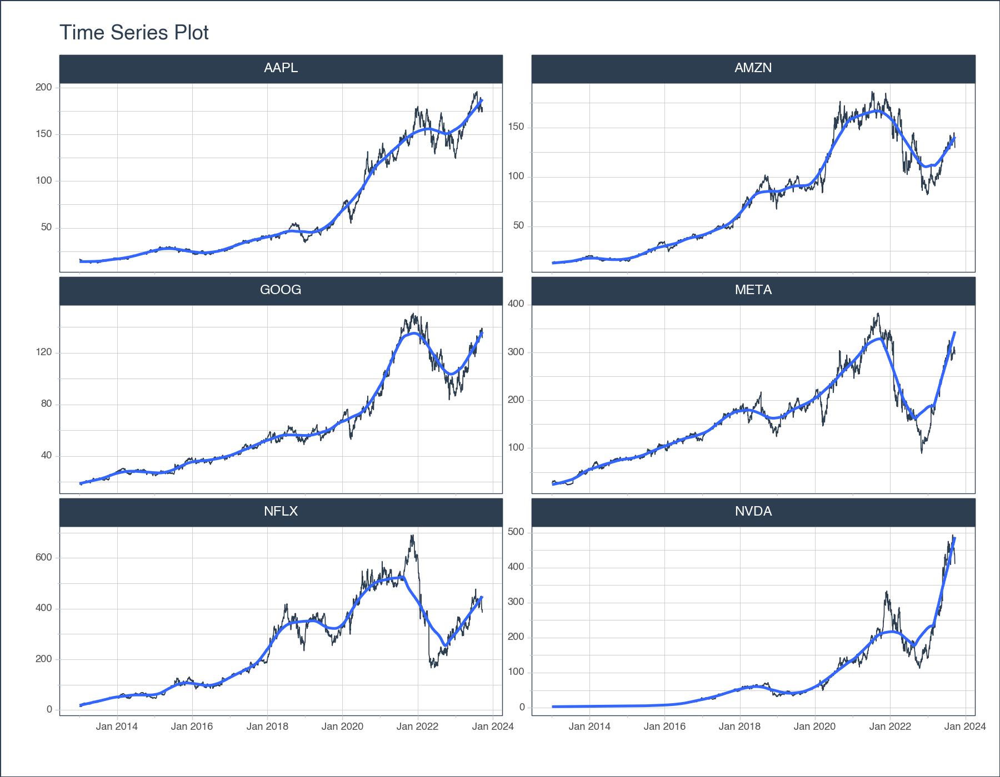

    <Figure Size: (900 x 700)>

# 3. Technical Indicators

Technical indicators are mathematical calculations based on the price,
volume, or open interest of a security or contract used by traders who
follow technical analysis. Technical analysis is a method of forecasting
the direction of financial market prices through the study of past
market data, primarily price, and volume. Technical indicators are most
extensively used in the context of the stock market but are also used in
other financial markets like forex, commodities, and cryptocurrencies.

### Types of Technical Indicators:

1.  **Trend Indicators:**
    -   **Moving Averages:** Helps smooth out price data to form a
        single flowing line, identifying the direction of the trend.
    -   **Moving Average Convergence Divergence (MACD):** Shows the
        relationship between two moving averages of a security’s price.
    -   **Average True Range (ATR):** Measures market volatility.
2.  **Momentum Indicators:**
    -   **Relative Strength Index (RSI):** Measures the speed and change
        of price movements, typically on a scale of 1 to 100.
    -   **Stochastic Oscillator:** Compares a security’s closing price
        to its price range over a specific period.
3.  **Volume Indicators:**
    -   **On-Balance Volume (OBV):** Uses volume flow to predict changes
        in stock price.
    -   **Accumulation/Distribution Line:** Looks at the proximity of
        closing prices to their highs or lows to determine if
        accumulation or distribution is occurring in the market.
4.  **Volatility Indicators:**
    -   **Bollinger Bands:** Consist of a middle band being an N-period
        simple moving average (SMA), an upper band at K times an
        N-period standard deviation above the middle band, and a lower
        band at K times an N-period standard deviation below the middle
        band.
    -   **Average True Range (ATR):** Provides a measure of a market’s
        volatility.
5.  **Market Strength Indicators:**
    -   **Advance/Decline Line:** Represents the number of advancing
        stocks divided by the number of declining stocks over a given
        period.
    -   **Market Breadth:** Measures the number of securities that have
        advanced and declined in a specific market or index, giving
        traders a feel for the market’s overall mood.

Let’s see a few examples of technical indicators in `pytimetk`.

## 3.1 Application: Moving Averages, 10-Day and 50-Day

This **code template** can be used to make and visualize the 10-day and
50-Day moving average of a group of stock symbols. Click to expand the
code.

## Plotly

``` python
# Add 2 moving averages (10-day and 50-Day)
sma_df = stocks_df[['symbol', 'date', 'adjusted']] \
    .groupby('symbol') \
    .augment_rolling(
        date_column = 'date',
        value_column = 'adjusted',
        window = [10, 50],
        window_func = ['mean'],
        center = False,
        threads = 1, # Change to -1 to use all available cores
    )

# Visualize 
(sma_df 

    # zoom in on dates
    .query('date >= "2023-01-01"') 

    # Convert to long format
    .melt(
        id_vars = ['symbol', 'date'],
        value_vars = ["adjusted", "adjusted_rolling_mean_win_10", "adjusted_rolling_mean_win_50"]
    ) 

    # Group on symbol and visualize
    .groupby("symbol") 
    .plot_timeseries(
        date_column = 'date',
        value_column = 'value',
        color_column = 'variable',
        smooth = False, 
        facet_ncol = 2,
        width = 900,
        height = 700,
        engine = "plotly"
    )
)
```

``` json
{"model_id":"71c001942cd4420a86b67523381135c0","version_major":2,"version_minor":0,"quarto_mimetype":"application/vnd.jupyter.widget-view+json"}
```

<div>                            <div id="7a39d9fd-e156-4006-a7f9-b84f04dd0f1e" class="plotly-graph-div" style="height:700px; width:900px;"></div>            <script type="text/javascript">                require(["plotly"], function(Plotly) {                    window.PLOTLYENV=window.PLOTLYENV || {};                                    if (document.getElementById("7a39d9fd-e156-4006-a7f9-b84f04dd0f1e")) {                    Plotly.newPlot(                        "7a39d9fd-e156-4006-a7f9-b84f04dd0f1e",                        [{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[124.73999786376952,127.37000274658205,126.94000244140624,130.02000427246094,129.47000122070312,132.99000549316406,132.88999938964844,136.7100067138672,136.97999572753906,135.36000061035156,133.02000427246094,136.14999389648438,139.3699951171875,143.27000427246094,143.13999938964844,141.5,147.3000030517578,151.74000549316406,147.05999755859375,148.97000122070312,153.1199951171875,188.7700042724609,186.52999877929688,186.05999755859372,191.6199951171875,183.42999267578125,177.9199981689453,174.14999389648438,179.42999267578125,179.47999572753906,177.16000366210938,172.44000244140625,172.8800048828125,172.0800018310547,171.1199951171875,172.0399932861328,170.38999938964844,169.5399932861328,174.94000244140625,173.4199981689453,174.52999877929688,185.25,184.8999938964844,184.50999450683597,184.97000122070312,181.69000244140625,179.50999450683594,180.8999938964844,194.0200042724609,197.75,204.92999267578125,195.6100006103516,197.80999755859372,202.16000366210935,199.80999755859372,204.27999877929688,206.00999450683597,202.83999633789065,200.67999267578125,205.3500061035156,207.83999633789065,211.94000244140625,213.07000732421875,214.72000122070312,211.47999572753903,216.1000061035156,214.75,213.8500061035156,214.0,220.3500061035156,221.4900054931641,218.8600006103516,217.88999938964844,215.6999969482422,213.07000732421875,212.88999938964844,212.7899932861328,207.5500030517578,209.3999938964844,238.55999755859372,240.32000732421875,243.17999267578125,239.2400054931641,237.02999877929688,233.5200042724609,232.77999877929688,233.2700042724609,233.3699951171875,233.0800018310547,235.7899932861328,233.80999755859372,238.8600006103516,238.82000732421875,242.4900054931641,246.8500061035156,245.63999938964844,248.32000732421875,246.7400054931641,249.2100067138672,252.69000244140625,262.0400085449219,262.5199890136719,264.7200012207031,272.6099853515625,272.6099853515625,271.3900146484375,271.1199951171875,263.6000061035156,264.5799865722656,264.95001220703125,271.04998779296875,271.32000732421875,273.3500061035156,281.8299865722656,281.0,284.3299865722656,281.6400146484375,284.8800048828125,288.7300109863281,278.4700012207031,287.04998779296875,285.2900085449219,281.5299987792969,286.9800109863281,286.0199890136719,294.3699951171875,291.989990234375,290.5299987792969,294.1000061035156,298.2900085449219,309.3399963378906,313.4100036621094,308.8699951171875,310.6199951171875,312.04998779296875,316.010009765625,302.5199890136719,294.260009765625,291.6099853515625,294.4700012207031,298.57000732421875,311.7099914550781,325.4800109863281,318.6000061035156,322.7099914550781,314.3099975585937,313.19000244140625,310.7300109863281,316.5599975585937,312.6400146484375,305.2099914550781,305.739990234375,301.6400146484375,306.19000244140625,301.95001220703125,294.2900085449219,285.0899963378906,283.25,289.8999938964844,287.6000061035156,294.239990234375,286.75,285.5,290.260009765625,297.989990234375,295.1000061035156,295.8900146484375,296.3800048828125,300.1499938964844,299.1700134277344,298.6700134277344,297.8900146484375,307.5599975585937,301.6600036621094,305.0599975585937,311.7200012207031,300.3099975585937,302.54998779296875,305.07000732421875,299.6700134277344,295.7300109863281],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_10","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_10","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[118.43300018310546,119.72200012207031,120.70700073242188,121.73300094604492,122.96800079345704,124.4630012512207,126.06400146484376,128.17300186157226,129.84500122070312,131.3470016479492,132.17500228881835,133.0530014038086,134.2960006713867,135.62100067138672,136.98800048828124,137.83899993896483,139.28000030517578,140.78300018310546,141.79100036621094,143.1520004272461,145.16199951171876,150.42400054931642,155.14000091552734,159.41900024414062,164.26699981689453,168.45999908447266,171.5219985961914,173.76299743652345,176.9999969482422,180.05099639892578,182.45499725341796,180.8219970703125,179.45699768066407,178.05899810791016,176.00899810791014,174.8699981689453,174.11699829101562,173.65599822998047,173.20699920654297,172.6009994506836,172.33799896240234,173.6189987182617,174.8209976196289,176.06399688720703,177.4489974975586,178.41399841308595,179.32599792480468,180.46199798583984,182.3699981689453,184.8029983520508,187.8429977416992,188.87899780273438,190.1699981689453,191.93499908447265,193.41899871826172,195.6779983520508,198.32799835205077,200.5219985961914,201.18799743652343,201.947998046875,202.23899841308594,203.87199859619142,205.39799957275392,206.65399932861328,207.8209991455078,209.00299987792968,209.8770004272461,210.9780014038086,212.31000213623048,213.81000213623048,215.1750030517578,215.86700286865235,216.3490020751953,216.4470016479492,216.6060028076172,216.28500213623047,216.08900146484376,215.45900115966796,214.9990005493164,216.81999969482422,218.7029998779297,221.13499908447267,223.2699996948242,225.4029998779297,227.4479995727539,229.43699951171874,231.48500061035156,234.06699981689454,236.43500061035155,236.15800018310546,235.50699920654296,235.075,235.03300018310546,235.5790008544922,236.91200103759766,238.1980010986328,239.7030014038086,241.04000244140624,242.6530029296875,244.34300384521484,247.16600494384767,249.5320037841797,252.12200317382812,255.13400115966797,257.70999908447266,260.2850006103516,262.56499938964845,264.2509994506836,265.7879974365234,267.0139984130859,267.9149963378906,268.7949981689453,269.6579986572266,270.5799987792969,271.41900024414065,272.71299743652344,273.76499938964844,275.89299926757815,278.30800170898436,279.6600006103516,281.26000061035154,282.65700073242186,283.475,283.99000244140626,284.49200134277345,285.4960021972656,286.5309997558594,287.0959991455078,287.63299865722655,289.61499938964846,291.8440002441406,294.6559997558594,297.38999938964844,299.7539978027344,302.35699768066405,304.5209991455078,305.5739990234375,305.94700012207034,305.697998046875,305.3159973144531,304.23899841308594,304.0689971923828,305.72999877929686,306.5279998779297,307.5940002441406,307.4239990234375,308.4910003662109,310.13800048828125,312.63300170898435,314.4500030517578,315.11400146484374,314.5170013427734,312.13300170898435,310.8920013427734,308.8160034179688,306.8140045166016,304.00400390625,301.25600280761716,298.5900024414062,296.08600158691405,294.98900146484374,293.0900024414062,291.4760009765625,289.88300170898435,289.48699951171875,289.5679992675781,290.6480010986328,291.96100158691405,292.9860015869141,294.14300231933595,294.58600463867185,295.70000610351565,297.90600585937494,299.04600524902344,299.7530059814453,301.4150054931641,301.8570037841797,302.4740020751953,302.96600341796875,303.01600341796876,302.7220031738281],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_50","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_50","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[113.07340042114258,113.0206005859375,112.96500061035157,112.81520080566406,112.80820068359375,113.50920074462891,114.18300079345703,115.05400085449219,115.88960083007812,116.7860008239746,117.66820083618164,118.57540069580078,119.42840057373047,120.36440063476563,121.19780059814452,121.7904005432129,122.47600067138671,123.22640075683594,123.82600067138672,124.54080062866211,125.37420059204102,126.90860061645508,128.44200057983397,129.93440048217772,131.5220004272461,132.96240020751952,134.3452001953125,135.63900009155273,136.86559997558595,138.04639984130858,139.1197999572754,140.12,141.29520004272462,142.45820007324218,143.57399993896485,144.69679977416993,145.81039978027343,146.79819961547852,147.86519973754883,149.01059967041016,150.11259963989258,151.5279995727539,152.8841995239258,154.1791993713379,155.5361993408203,156.80919937133788,158.06179931640625,159.36739913940428,160.8425991821289,162.3907992553711,163.99459915161134,165.35939910888672,166.77679901123048,168.21959899902345,169.62639892578125,171.0521987915039,172.51459869384766,173.83719848632813,175.11119842529297,176.51099853515626,178.00739837646483,179.52319854736328,180.9971987915039,182.42619873046874,183.79299865722658,185.28499877929687,186.63399871826172,187.87619873046876,189.21499877929688,190.64259887695312,192.00999908447267,192.61179901123046,193.2389990234375,193.83179901123046,194.2607992553711,194.84999938964845,195.54739929199218,196.21539947509766,196.8147994995117,197.9963995361328,199.259599609375,200.6743994140625,202.00159942626954,203.30059936523438,204.54859954833984,205.76339965820313,207.02099975585938,208.29759979248047,209.46039978027343,210.70779968261718,211.89339965820312,212.96559967041014,214.04399993896484,215.20360015869142,216.44120025634766,217.7202001953125,219.09640045166014,220.41320068359374,221.51700073242188,222.61580078125,223.7580010986328,225.0962008666992,226.4344009399414,227.84340057373046,229.29940032958984,230.64160064697265,231.9438006591797,233.15900085449218,234.43700073242186,235.62900085449218,236.89320068359376,238.08080078125,239.28640075683595,240.6286004638672,242.01900054931642,243.3836001586914,244.72140045166014,246.1420004272461,247.63660064697265,248.79900054931642,250.1102001953125,251.43880035400392,252.71160034179687,254.1372006225586,255.59620025634766,257.2258001708984,258.80980010986326,260.4694000244141,262.1634002685547,263.3580004882813,264.7384002685547,266.14300048828125,267.53560028076174,269.00740020751954,270.5779998779297,272.24260009765624,273.62759979248045,274.8454000854492,276.01599975585935,277.1895999145508,278.4848001098633,279.9417999267578,281.675,283.197200012207,284.71439971923826,286.0877996826172,287.38519958496096,288.66499969482425,290.0119995117187,291.21099975585935,292.0743994140625,292.93879943847656,293.67719970703126,294.34880004882814,294.9356005859375,295.3936004638672,295.6730004882813,296.0660003662109,296.5724005126953,297.025400390625,297.4892004394531,297.79780029296876,298.0408001708984,298.20940063476564,298.5492004394531,298.7646008300781,299.04960083007813,299.27960083007815,299.50800048828125,299.92200073242185,300.1544012451172,300.4064013671875,300.92700134277345,301.22060119628907,301.6014013671875,301.94840148925783,302.1148016357422,302.35520141601563,302.57460144042966,302.6022015380859,302.3300018310547],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[85.81999969482422,85.13999938964844,83.12000274658203,86.08000183105469,87.36000061035156,89.87000274658203,95.08999633789062,95.2699966430664,98.12000274658205,96.0500030517578,95.45999908447266,93.68000030517578,97.25,97.5199966430664,96.31999969482422,97.18000030517578,99.22000122070312,102.23999786376952,100.5500030517578,103.12999725341795,105.1500015258789,112.91000366210938,103.38999938964844,102.18000030517578,102.11000061035156,100.0500030517578,98.23999786376952,97.61000061035156,99.54000091552734,99.6999969482422,101.16000366210938,98.1500015258789,97.1999969482422,94.58000183105467,95.79000091552734,95.81999969482422,93.5,93.76000213623048,94.2300033569336,92.16999816894533,92.12999725341795,94.9000015258789,93.75,93.5500030517578,93.91999816894533,92.25,90.7300033569336,92.43000030517578,94.87999725341795,96.1999969482422,100.04000091552734,98.9499969482422,97.70999908447266,100.61000061035156,98.6999969482422,98.70999908447266,98.12999725341795,98.04000091552734,97.23999786376952,100.25,102.0,103.29000091552734,102.41000366210938,103.9499969482422,101.0999984741211,102.05999755859376,102.16999816894533,99.91999816894533,97.83000183105467,102.4000015258789,102.51000213623048,102.73999786376952,102.3000030517578,104.3000030517578,103.80999755859376,106.95999908447266,106.20999908447266,102.56999969482422,104.9800033569336,109.81999969482422,105.4499969482422,102.0500030517578,103.62999725341795,103.6500015258789,104.0,105.66000366210938,105.83000183105467,106.62000274658205,110.19000244140624,112.18000030517578,110.26000213623048,111.1999969482422,113.4000015258789,115.5,118.1500015258789,116.25,115.01000213623048,114.98999786376952,116.75,115.0,120.11000061035156,121.66000366210938,120.58000183105467,122.7699966430664,124.25,125.3000030517578,126.61000061035156,121.2300033569336,124.25,123.43000030517578,126.56999969482422,126.66000366210938,126.41999816894533,127.11000061035156,125.48999786376952,125.77999877929688,124.83000183105467,130.14999389648438,129.3300018310547,127.33000183105467,129.17999267578125,129.0399932861328,127.9000015258789,130.36000061035156,130.22000122070312,130.3800048828125,128.36000061035156,129.77999877929688,127.12999725341795,128.77999877929688,130.8000030517578,134.3000030517578,134.67999267578125,133.55999755859375,132.8300018310547,135.36000061035156,129.9600067138672,130.0,128.8000030517578,129.1300048828125,128.14999389648438,128.25,132.2100067138672,133.67999267578125,131.69000244140625,128.2100067138672,128.91000366210938,139.57000732421875,142.22000122070312,139.94000244140625,137.85000610351562,138.55999755859375,138.41000366210938,140.57000732421875,137.6699981689453,135.07000732421875,133.97999572753906,133.22000122070312,134.67999267578125,134.25,135.52000427246094,131.83999633789062,133.25999450683594,133.13999938964844,134.91000366210938,135.07000732421875,138.00999450683594,138.1199951171875,137.27000427246094,135.36000061035156,137.85000610351562,138.22999572753906,143.10000610351562,141.22999572753906,144.85000610351562,144.72000122070312,140.38999938964844,139.97999572753906,137.6300048828125,135.2899932861328,129.3300018310547],"type":"scatter","xaxis":"x2","yaxis":"y2","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_10","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_10","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[84.47799987792969,84.5,84.29300003051758,84.2240005493164,84.58100051879883,85.04300079345703,86.24800033569336,87.59300003051757,88.9870002746582,90.19200057983399,91.15600051879883,92.01000061035157,93.42300033569336,94.56699981689454,95.4629997253418,96.19399948120117,96.60699996948242,97.30400009155274,97.5470001220703,98.25499954223632,99.22399978637694,101.1470001220703,101.76100006103515,102.22700042724608,102.80600051879883,103.09300079345704,102.99500045776367,102.53200073242188,102.43100051879883,102.08800048828125,101.68900070190429,100.21300048828125,99.59400024414063,98.83400039672851,98.20200042724609,97.77900009155273,97.30500030517578,96.92000045776368,96.3890007019043,95.63600082397461,94.73300018310547,94.40800018310547,94.06300048828125,93.96000061035156,93.77300033569335,93.41600036621094,93.1390007019043,93.00600051879883,93.07099990844726,93.47399978637695,94.26500015258789,94.66999969482421,95.06599960327148,95.77199935913086,96.24999923706055,96.89599914550782,97.63599853515625,98.1969985961914,98.43299865722656,98.83799896240234,99.03399887084962,99.46799926757812,99.9379997253418,100.27199935913086,100.51199951171876,100.84699935913086,101.25099945068361,101.4389991760254,101.49799957275391,101.7129997253418,101.76399993896486,101.70899963378908,101.6979995727539,101.73300018310547,102.00400009155274,102.49400024414062,102.89800033569335,103.16300048828126,103.87800064086915,104.62000045776367,104.91399993896485,104.84500045776367,104.97799987792969,104.91299972534179,104.93199996948242,104.8020004272461,104.7640007019043,105.16900100708008,105.69000091552735,105.9260009765625,106.40700149536133,107.32200088500977,108.29900131225585,109.48400115966797,110.89900131225586,111.95800094604492,112.8760009765625,113.71300048828125,114.36900024414062,114.65100021362305,115.63600006103516,116.68200073242187,117.40000076293946,118.12700042724609,118.7370002746582,119.64200057983399,120.8020004272461,121.4260009765625,122.1760009765625,123.01900100708008,123.66500091552734,124.16500091552734,124.7490005493164,125.18300094604493,125.30700073242187,125.35500030517578,125.1770004272461,126.06899948120117,126.57699966430664,126.96699981689453,127.22799911499024,127.46599807739258,127.61399841308594,127.93899841308594,128.4119987487793,128.87199935913085,129.22499923706056,129.1879997253418,128.96799926757814,129.11299896240234,129.275,129.8010009765625,130.47900009155273,130.79899978637695,131.05999984741212,131.55799942016603,131.71800003051757,131.7400001525879,131.90700073242186,131.94200134277344,131.6770004272461,131.0720001220703,130.82500152587892,130.83700103759764,130.7230010986328,130.00800170898438,129.9030014038086,130.86000213623046,132.202001953125,133.2830017089844,134.2530029296875,135.28400268554688,135.90400238037108,136.59300384521484,137.19100341796874,137.87700347900392,138.38400268554688,137.7490020751953,136.99500122070313,136.4260009765625,136.19300079345703,135.52100067138673,135.00599975585936,134.26299896240235,133.98699951171875,133.98699951171875,134.38999938964844,134.87999877929687,135.13899993896484,135.25,135.48300018310547,136.12200012207032,137.1060012817383,137.91500091552734,138.90900115966798,139.8740005493164,140.11200103759765,140.29800109863282,140.33400115966796,140.3270004272461,139.475],"type":"scatter","xaxis":"x2","yaxis":"y2","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_50","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_50","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[93.95240005493164,93.26880004882813,92.53480010986328,91.84440017700196,91.2784001159668,90.85660018920899,90.69020004272461,90.54679992675781,90.5733999633789,90.65199996948242,90.77519989013672,90.82919982910157,90.96359985351563,91.11439971923828,91.31799972534179,91.32899978637695,91.29759979248047,91.37259979248047,91.4047998046875,91.52499969482422,91.73099975585937,92.10639984130859,92.32499984741212,92.50459991455078,92.66419998168945,92.79699996948243,92.88279998779296,92.9866000366211,93.0466000366211,93.13059997558594,93.27120010375977,93.41400009155274,93.59300003051757,93.71540008544922,93.82420013427735,93.95880020141601,94.01780014038086,94.04320022583008,94.09620025634766,94.17060028076172,94.25600021362305,94.45560028076171,94.6268002319336,94.76240036010742,94.96500030517578,95.10500030517578,95.25880035400391,95.47100036621094,95.68500030517578,95.92900024414062,96.2134002685547,96.48960021972657,96.78140014648437,97.0720001220703,97.29880004882813,97.47559997558594,97.53639999389648,97.5918000793457,97.57419998168945,97.6581999206543,97.78899993896485,97.98119995117187,98.08440002441407,98.21300003051758,98.30860000610352,98.40619995117187,98.46519989013672,98.41879989624023,98.36439987182617,98.3497999572754,98.29699996948243,98.09359985351563,98.07179992675782,98.11419998168945,98.14819992065429,98.2863998413086,98.44579986572266,98.54499984741211,98.65379989624023,98.85619995117187,98.94199981689454,99.01999984741211,99.14859985351562,99.32999984741211,99.49419982910156,99.69099990844727,99.93759994506836,100.1947999572754,100.51399993896484,100.91419998168945,101.2768000793457,101.60279998779296,101.99580001831055,102.43479995727539,102.91940002441406,103.39940002441406,103.885,104.33619995117188,104.77360000610352,105.14960006713868,105.55100006103515,106.0052001953125,106.46260025024414,106.90580017089843,107.41680023193359,107.9486003112793,108.51820037841797,108.98200042724609,109.5222004699707,109.98580047607422,110.4772004699707,110.94460052490234,111.42480041503906,111.88800048828125,112.37580047607422,112.85020050048828,113.30340057373047,113.90800048828125,114.53800048828126,115.03660049438477,115.57000030517578,116.09600021362304,116.60800018310547,117.12920013427734,117.65740020751953,118.12580032348633,118.56880035400391,119.11300033569336,119.55600021362305,119.9352001953125,120.44220031738281,121.08720031738281,121.70820022583008,122.30640014648438,122.88300018310547,123.47700012207031,123.95960021972657,124.42720016479493,124.79940017700196,125.13840026855469,125.49620010375976,125.83720016479492,126.2134002685547,126.57700012207032,126.84780014038085,127.08700027465821,127.36500030517578,127.85660049438476,128.36600051879884,128.86480056762696,129.21960067749023,129.55760055541992,129.91420059204103,130.27020080566408,130.53860076904297,130.7340008544922,130.88140075683594,131.12120071411132,131.32980056762696,131.54620056152345,131.72520065307617,131.8288005065918,131.9656004333496,132.08620040893555,132.27460052490235,132.4604006958008,132.7240005493164,132.88340057373046,133.0422006225586,133.20280059814453,133.3762008666992,133.56000091552735,133.86400100708008,134.08140090942382,134.37400100708007,134.6608009338379,134.90140090942384,135.10540084838868,135.31540100097655,135.4456008911133,135.41620086669923],"type":"scatter","xaxis":"x2","yaxis":"y2","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[124.53865814208984,125.82318878173828,124.4888687133789,129.0693359375,129.59707641601562,130.17462158203125,132.9228973388672,132.84323120117188,134.18748474121094,135.36248779296875,134.63558959960938,134.69532775878906,137.28427124023438,140.51052856445312,141.92449951171875,141.25733947753906,143.34841918945312,145.31004333496094,142.39248657226562,143.677001953125,144.81216430664062,150.1792755126953,153.8436279296875,151.0854034423828,153.9929962158203,151.27459716796875,150.22906494140625,150.59803771972656,153.43031311035156,152.78207397460938,154.90626525878906,153.29067993164062,152.13385009765625,148.074951171875,148.50376892089844,148.992431640625,146.30978393554688,147.5164794921875,147.00787353515625,144.91360473632812,145.51197814941406,150.6179962158203,153.41036987304688,151.1864471435547,152.45297241210938,150.17918395996094,148.0948944091797,150.0595245361328,152.17373657226562,152.57264709472656,155.4248504638672,154.57716369628906,156.97061157226562,158.84548950195312,157.39944458007812,158.49644470214844,159.81283569335938,157.84820556640625,157.2199249267578,160.3314208984375,161.91708374023438,164.4501495361328,165.71669006347656,165.1781768798828,163.31326293945312,164.21083068847656,161.58798217773438,160.36134338378906,159.66326904296875,165.1083526611328,164.7593231201172,164.7792510986328,166.01588439941406,167.17271423339844,166.1953887939453,164.56983947753906,164.8789825439453,163.3232421875,163.31326293945312,167.95059204101562,169.2171173095703,169.1273651123047,168.08023071289062,166.99319458007812,165.3377227783203,173.0965118408203,173.0266876220703,171.30142211914062,173.08653259277344,173.27601623535156,172.3372802734375,171.8379669189453,171.8379669189453,172.45712280273438,174.81393432617188,174.92379760742188,173.96507263183594,171.32864379882812,171.60826110839844,172.7567138671875,175.19342041015625,177.06089782714844,177.01097106933594,179.84713745117188,180.7059783935547,179.33782958984375,178.9683380126953,177.5802001953125,180.3264923095703,180.71597290039065,183.54214477539065,183.0627899169922,183.70193481445312,185.7591552734375,184.67062377929688,184.760498046875,183.71192932128903,186.7478179931641,186.42823791503903,185.0201568603516,187.80638122558597,188.99478149414065,189.33432006835935,193.7084197998047,192.20046997070312,191.0719757080078,191.55133056640625,190.4228515625,188.35565185546875,187.8263702392578,189.5140838623047,190.2830352783203,190.43284606933597,193.7283935546875,193.4687347412109,194.8368988037109,192.8695526123047,191.68116760253903,192.4900665283203,193.35888671875,194.2377014160156,192.9594268798828,195.56591796875,196.18507385253903,195.34620666503903,192.3202972412109,190.9122009277344,181.7445831298828,178.6088104248047,179.55752563476562,177.94970703125,177.72999572753906,177.7899932861328,179.4600067138672,177.4499969482422,176.57000732421875,174.0,174.49000549316406,175.83999633789062,177.22999572753906,181.1199951171875,176.3800048828125,178.61000061035156,180.19000244140625,184.1199951171875,187.6499938964844,187.8699951171875,189.4600067138672,189.6999969482422,182.91000366210935,177.55999755859375,178.17999267578125,179.36000061035156,176.3000030517578,174.2100067138672,175.74000549316406,175.00999450683594,177.97000122070312,179.07000732421875,175.49000549316406,173.92999267578125],"type":"scatter","xaxis":"x3","yaxis":"y3","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_10","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_10","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[129.93463897705078,129.3361930847168,128.6112854003906,128.0307632446289,127.82364807128906,127.71112823486328,128.05565795898437,128.78952713012694,129.3023368835449,129.90078506469726,130.9104782104492,131.7976921081543,133.07723236083984,134.22135162353516,135.45409393310547,136.56236572265624,137.60491790771485,138.85159912109376,139.6720993041992,140.50355072021483,141.52120819091797,143.0696029663086,144.7255386352539,145.78302612304688,146.98987579345703,147.9916015625,148.6796661376953,149.20846557617188,150.31224822998047,151.2227554321289,152.23216552734374,152.54330596923828,152.37232818603516,152.07128295898437,151.5223602294922,151.2941436767578,150.90221557617187,150.59405975341798,149.95181579589843,149.16496887207032,148.2255401611328,147.9582717895508,148.08592376708984,148.3970733642578,148.7919937133789,148.9106689453125,149.08917999267578,149.3434844970703,149.86007080078124,150.6259750366211,151.6172622680664,152.01317901611327,152.36920318603515,153.135107421875,153.62975463867187,154.46148071289062,155.6332748413086,156.41214294433593,156.91676177978516,157.69263916015626,158.34186248779298,159.32916107177735,160.20376892089843,160.8370376586914,161.4284194946289,161.9998580932617,162.17737274169923,162.4286865234375,162.6730209350586,163.1507141113281,163.4349380493164,163.4678482055664,163.49776763916014,163.6972213745117,163.98543395996094,164.02133483886718,164.35043487548828,164.64662475585936,165.01162414550782,165.29584808349608,165.74162750244142,166.1764389038086,166.38287353515625,166.36492156982422,166.2791549682617,167.13182220458984,167.94659271240235,168.7444107055664,169.72173767089845,170.25428009033203,170.56629638671876,170.8373565673828,171.21313018798827,171.7595230102539,172.70714416503907,172.8898727416992,172.98371124267578,172.98643341064454,172.83860626220704,172.78667602539062,173.0722900390625,173.5945831298828,174.11188354492188,174.85088500976562,175.4400894165039,175.8814926147461,176.38181915283204,177.00697479248046,177.87879791259766,178.67472381591796,179.5095962524414,180.1097854614258,180.7788818359375,181.37008361816407,181.76654815673828,182.3088150024414,182.78317413330078,183.69993591308594,184.31011047363282,184.74052886962892,185.16695251464844,185.7601516723633,186.3233901977539,187.11831665039062,187.87130126953124,188.50244903564453,189.28638916015626,189.65389251708984,189.8466339111328,190.12725524902345,190.29802551269532,190.42685089111328,190.53670349121094,190.53870086669923,190.66552734375,191.04201965332032,191.17384185791016,191.29967346191407,191.7131149291992,192.26636657714843,192.73872833251954,193.0063674926758,193.5196746826172,193.76534271240234,193.95308990478514,193.70142974853513,193.5056945800781,192.5120361328125,191.12391052246093,189.7437744140625,188.11497497558594,186.59203186035157,184.81443939208984,183.14193267822264,181.35231170654296,179.77728271484375,178.0860626220703,177.36060485839843,177.08372344970704,176.85097045898436,177.16799926757812,177.03300018310546,177.11500091552733,177.18800048828126,177.8550003051758,178.96299896240237,180.3499984741211,181.8469985961914,183.23299865722657,183.8009994506836,183.44499969482422,183.6249984741211,183.6999984741211,183.31099853515624,182.31999969482422,181.12900085449218,179.84300079345704,178.69400024414062,177.6310012817383,176.88900146484374,176.5260009765625],"type":"scatter","xaxis":"x3","yaxis":"y3","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_50","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_50","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[142.0542840576172,141.6427180480957,141.161123046875,140.71367797851562,140.33623504638672,140.06080657958984,139.62283325195312,139.23098388671875,138.91950256347656,138.7432583618164,138.67475067138673,138.61281494140624,138.5919039916992,138.62396728515625,138.77651672363282,138.67674255371094,138.56243041992187,138.51563018798828,138.37542846679688,138.2858108520508,138.18046020507813,138.17110015869142,138.30034881591797,138.33121765136718,138.4025131225586,138.47838958740235,138.6108248901367,138.81138031005858,138.93196441650392,139.03400726318358,139.1884915161133,139.3341635131836,139.5307830810547,139.6854571533203,139.8146530151367,139.9633804321289,140.0120526123047,140.06534240722655,140.15346771240235,140.33333770751952,140.56480621337892,140.94101318359375,141.37446166992189,141.7006994628906,142.11639434814452,142.49398162841797,142.86632751464845,143.35742721557617,143.81971420288085,144.2836070251465,144.90133087158202,145.47641036987304,146.12604522705078,146.72156829833983,147.2776156616211,147.84405212402345,148.3818508911133,148.88195037841797,149.3425991821289,149.84197784423827,150.38760772705078,150.98270416259766,151.5513525390625,152.0447055053711,152.47248077392578,152.93155059814453,153.29634185791016,153.5973678588867,153.94278350830078,154.37141052246093,154.77035369873047,155.06235321044923,155.30579833984376,155.62754455566406,155.87159240722656,156.13749725341796,156.43049560546876,156.68499969482423,156.88265869140625,157.18602905273437,157.47224609375,157.78897979736328,158.10790740966797,158.48627227783203,158.82295135498046,159.30503295898438,159.83937103271484,160.3150698852539,160.83664306640625,161.40389129638672,161.9403973388672,162.3647967529297,162.73334869384766,163.15876220703126,163.6059814453125,164.1008737182617,164.61827728271484,165.04365966796874,165.4323501586914,165.83603149414063,166.23140289306642,166.6810775756836,167.081884765625,167.50191772460937,167.9680484008789,168.38487609863282,168.76798614501953,169.16262603759765,169.6247573852539,170.03244842529296,170.4649496459961,170.8372024536133,171.1969073486328,171.6085269165039,172.03567413330077,172.44666748046876,172.88914642333984,173.41687591552736,173.95217529296875,174.35041137695313,174.8113525390625,175.29566314697266,175.76203186035156,176.2927459716797,176.81284759521483,177.34289031982422,177.87633728027345,178.41832946777345,178.91917724609374,179.31669281005858,179.72263214111328,180.1457455444336,180.5927978515625,181.1275018310547,181.6901220703125,182.12492980957032,182.521787109375,182.92938201904298,183.3174526977539,183.71911010742187,184.15711853027344,184.5795477294922,185.05410675048827,185.52866577148438,185.9393112182617,186.2872412109375,186.62618377685547,186.83450256347658,186.9745135498047,187.11052978515625,187.16565551757813,187.17903747558594,187.19461791992188,187.1868753051758,187.12175567626954,187.06639923095702,186.96703247070312,186.90522857666016,186.81549865722656,186.74577911376954,186.69733612060546,186.56368041992187,186.46184173583984,186.35045867919922,186.33944610595702,186.39723602294922,186.4803973388672,186.53464111328125,186.6000762939453,186.55787322998046,186.35294555664063,186.13664978027344,185.93716339111327,185.58899505615236,185.22918579101562,184.92254638671875,184.59171966552734,184.3426626586914,184.1569497680664,183.91022247314453,183.59854064941408],"type":"scatter","xaxis":"x3","yaxis":"y3","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[294.95001220703125,309.4100036621094,309.70001220703125,315.54998779296875,315.1700134277344,327.5400085449219,327.260009765625,330.1300048828125,332.82000732421875,326.2200012207031,326.3299865722656,315.7799987792969,342.5,357.4200134277344,363.8299865722656,367.9599914550781,364.8699951171875,360.7699890136719,353.1099853515625,353.8599853515625,361.989990234375,366.8900146484375,365.8999938964844,361.4800109863281,362.9500122070313,366.8299865722656,362.5,347.3599853515625,358.57000732421875,359.9599914550781,361.4200134277344,350.7099914550781,347.9599914550781,337.5,334.8800048828125,323.6499938964844,317.1499938964844,323.0299987792969,322.1300048828125,313.4800109863281,311.8800048828125,315.17999267578125,312.0299987792969,308.4700012207031,311.7900085449219,297.7799987792969,292.760009765625,293.510009765625,294.94000244140625,303.7900085449219,310.0599975585937,303.5,305.1300048828125,305.7900085449219,293.8999938964844,320.3699951171875,328.3900146484375,327.6600036621094,323.5199890136719,332.0299987792969,338.42999267578125,345.4800109863281,348.2799987792969,346.75,342.3500061035156,339.3299865722656,338.989990234375,338.2099914550781,331.0299987792969,346.19000244140625,338.6300048828125,332.7200012207031,333.70001220703125,323.1199951171875,325.3500061035156,327.9800109863281,329.0199890136719,322.54998779296875,321.1499938964844,325.8500061035156,329.92999267578125,324.1199951171875,317.54998779296875,319.29998779296875,320.7799987792969,322.760009765625,331.2099914550781,332.1400146484375,335.4200134277344,344.760009765625,339.8900146484375,335.8900146484375,333.75,339.9599914550781,371.2900085449219,365.3599853515625,363.010009765625,355.989990234375,364.8500061035156,359.0,378.8800048828125,392.9800109863281,395.2300109863281,403.1300048828125,400.4700012207031,403.5400085449219,399.2900085449219,399.7699890136719,409.3699951171875,420.0199890136719,423.9700012207031,435.7300109863281,440.8599853515625,445.2699890136719,431.9599914550781,434.7000122070313,424.4500122070313,422.4800109863281,424.0199890136719,415.9400024414063,417.0799865722656,429.8399963378906,428.239990234375,440.489990234375,441.4400024414063,445.8999938964844,438.8399963378906,438.1000061035156,441.7099914550781,440.2099914550781,444.0499877929688,450.3800048828125,441.9100036621094,450.0499877929688,474.7999877929688,477.5899963378906,437.4200134277344,427.5,428.3699951171875,427.7000122070313,422.6700134277344,413.1700134277344,425.7799987792969,438.9700012207031,438.6199951171875,429.7000122070313,431.0,431.6000061035156,440.760009765625,438.2999877929688,428.8999938964844,429.9800109863281,421.6600036621094,427.7799987792969,423.7000122070313,415.4500122070313,403.0,404.5299987792969,408.2900085449219,413.1700134277344,427.5499877929688,406.9299926757813,416.0299987792969,418.05999755859375,429.989990234375,434.6700134277344,433.6799926757813,439.8800048828125,448.6799926757813,445.760009765625,443.1400146484375,442.7999877929688,445.3599853515625,434.6900024414063,412.239990234375,400.489990234375,396.9400024414063,394.3999938964844,396.2000122070313,386.2999877929688,384.1499938964844],"type":"scatter","xaxis":"x4","yaxis":"y4","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_10","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_10","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[290.91600036621094,293.027001953125,295.1780029296875,296.93700256347654,298.67900390625,301.9370056152344,306.2460052490234,311.5710052490234,315.7410064697266,318.8750061035156,322.01300354003905,322.65000305175784,325.9300018310547,330.11700439453125,334.9830017089844,339.025,342.78599853515624,345.84999694824216,347.8789947509766,350.6429931640625,354.20899353027346,359.3199951171875,361.6599945068359,362.0659942626953,361.9779968261719,361.8649963378906,361.62799682617185,360.28699645996096,360.83299865722654,361.4429992675781,361.38600158691406,359.76799926757815,357.9739990234375,355.5759979248047,352.7689971923828,348.4509979248047,343.91599731445314,341.4829986572266,337.83899841308596,333.1910003662109,328.23699951171875,324.6839996337891,321.09100036621095,318.18800048828126,315.8790008544922,313.29200134277346,310.8530029296875,307.9010040283203,305.1820037841797,304.21300354003904,304.0310028076172,302.8630035400391,302.1730041503906,301.9050048828125,300.1160034179687,302.3750030517578,305.93800354003906,309.3530029296875,312.21100158691405,315.0350006103516,317.8720001220703,322.07000122070315,326.38500061035154,330.4809997558594,335.3260009765625,337.2220001220703,338.28199768066406,339.3369964599609,340.08799743652344,341.5039978027344,341.5239990234375,340.247998046875,338.7899993896484,336.4269989013672,334.7269989013672,333.5920013427734,332.5950012207031,331.0290008544922,330.04100036621094,328.0070007324219,327.1369995117187,326.27699890136716,324.66199645996096,324.2799957275391,323.8229949951172,323.3009948730469,323.5199951171875,324.4789978027344,325.9059997558594,327.7970001220703,328.7930023193359,329.9700042724609,331.5900054931641,333.656005859375,338.7070068359375,342.9670043945313,346.1470062255859,348.53200378417966,351.4750030517578,352.8990020751953,356.7980010986328,362.5070007324219,368.6550018310547,374.9720031738281,377.89000244140624,381.7080047607422,385.33600463867185,389.71400451660156,394.16600341796874,400.26800231933595,404.777001953125,409.052001953125,413.61499938964846,417.82899780273436,420.9779968261719,424.0939971923828,426.60999755859376,428.88099975585936,430.3459991455078,429.93800048828126,429.2489990234375,428.6599975585938,427.397998046875,426.9199981689453,427.8679992675781,428.9879974365234,430.4269958496094,431.98899536132814,433.75799560546875,436.18499450683595,438.8819946289062,440.9359954833984,442.30299682617186,443.2589965820313,446.5949951171875,449.7639953613281,449.6219970703125,448.56199645996094,447.2279968261719,445.9769989013672,443.83900146484376,440.1180023193359,438.5050018310547,437.3970031738281,433.77900390625,428.99000549316406,428.34800415039064,428.7580047607422,429.99700622558595,431.0570037841797,431.6800018310547,433.3610015869141,432.9490020751953,431.8300018310547,430.33800354003904,428.9130035400391,426.1130035400391,423.4060028076172,420.15900268554685,417.64600524902346,417.51100463867186,415.2060028076172,414.64300231933595,413.67100219726564,414.3,416.2220001220703,419.2899993896484,422.825,426.86399841308594,430.122998046875,431.6820007324219,435.2690002441406,438.2019989013672,439.86499938964846,438.0899993896484,434.6719970703125,430.997998046875,426.4499969482422,421.2019989013672,415.25599670410156,409.35699462890625],"type":"scatter","xaxis":"x4","yaxis":"y4","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_50","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_50","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[292.6128009033203,293.0096008300781,293.55460083007813,294.0452008056641,294.376201171875,294.98820129394534,295.61900146484373,296.3840014648438,297.30540161132814,298.3698016357422,299.5152014160156,300.6150012207031,302.2930010986328,304.1722015380859,306.35560119628906,308.21540100097656,309.71020080566404,310.94020080566406,311.7984002685547,312.7552001953125,314.0894000244141,315.66760009765625,317.28460021972654,318.780400390625,320.20940063476564,321.8352001953125,323.4617999267578,324.7897998046875,325.85059997558596,326.7107995605469,327.5309997558594,328.2933996582031,329.14139953613284,329.72299926757813,330.21539916992185,330.28819885253904,330.3275988769531,330.38139892578124,330.4673992919922,330.9287994384766,331.3521997070313,331.8897998046875,332.3665997314453,332.5767999267578,332.85760009765625,332.91400024414065,333.08580017089844,333.4184002685547,333.49480041503904,333.6730004882813,333.9752001953125,333.8570001220703,333.7655999755859,333.570400390625,333.145,333.0015997314453,333.0241998291016,332.9747998046875,332.7887994384766,332.9049993896484,333.1469995117188,333.7409997558594,333.8565997314453,333.6431994628906,333.21359985351563,332.64099975585935,332.12339965820314,331.67219970703127,331.23059997558596,331.0772003173828,330.61000061035156,329.92660034179687,329.2826007080078,328.515400390625,327.7634002685547,326.98640075683596,326.3168005371094,325.8206005859375,325.0722003173828,324.39000061035154,323.7602001953125,323.2284002685547,322.6202001953125,322.2561999511719,321.97419982910156,321.9564001464844,322.23760009765624,322.41980041503905,322.6856005859375,323.31120056152344,323.87140075683595,324.28560119628906,324.7200012207031,325.3498010253906,326.5398010253906,327.89140075683594,329.29640075683596,330.54600036621093,331.94420043945314,333.0484002685547,334.42480041503904,336.21440063476564,338.01640075683594,339.96320068359375,342.09460083007815,343.7580010986328,345.1760009765625,346.6182006835937,348.33520080566404,350.0950006103516,351.80580078125,353.61080078125,355.4624005126953,357.43280029296875,359.225,361.1324005126953,362.84160095214844,364.5270013427734,366.3868011474609,367.78180114746095,369.35080078125,371.29320068359374,373.18400024414063,375.5314001464844,377.8532000732422,380.2115997314453,382.4079998779297,384.7190002441406,387.1302001953125,389.41739990234373,391.6997998046875,394.225,396.71220031738284,399.3272003173828,402.40760009765626,405.50419982910154,407.6284002685547,409.5355999755859,411.394599609375,413.05339965820315,414.70899963378906,416.254599609375,418.09519958496094,420.0753997802734,421.42199951171875,422.70880004882815,424.06859985351565,425.58080017089844,427.0990002441406,428.685,429.6853997802734,430.42539978027344,430.95399963378907,431.44699951171873,431.91159973144534,432.1497998046875,432.22399963378905,432.31919982910154,432.29760009765624,432.1606005859375,432.2322003173828,431.65619995117186,431.15960021972654,430.615400390625,430.57600036621096,430.575400390625,430.76,431.1079998779297,431.60119995117185,432.1976000976563,432.7188006591797,432.9780004882812,433.320400390625,433.20440063476565,432.620400390625,431.71220031738284,430.87420043945315,430.0002001953125,429.0900006103516,428.01180053710937,426.81380065917966],"type":"scatter","xaxis":"x4","yaxis":"y4","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[143.0990753173828,147.43756103515625,142.59927368164062,148.5371551513672,156.2244110107422,159.03341674804688,159.95309448242188,165.05128479003906,168.92991638183594,176.95704650878906,173.7082061767578,167.5903778076172,178.32655334472656,191.8617248535156,192.58148193359372,193.16128540039065,197.9495849609375,203.57757568359372,191.55186462402344,195.30050659179688,209.35552978515625,217.0127868652344,210.92495727539065,210.81500244140625,221.6511383056641,221.9710235595703,223.29055786132807,212.57437133789065,217.8025360107422,229.62831115722656,227.5590362548828,219.94175720214844,213.803955078125,206.4765472412109,207.46620178222656,236.55584716796875,232.77719116210935,234.9264068603516,232.07745361328125,226.89927673339844,233.05709838867188,238.8150329589844,235.45623779296875,232.83673095703125,241.7650604248047,234.3164520263672,229.60731506347656,229.6173248291016,240.5852813720703,242.23497009277344,255.36253356933597,257.20220947265625,258.9518737792969,261.9413146972656,264.6308288574219,271.8594665527344,267.740234375,265.2606811523437,264.0509338378906,269.78985595703125,273.77911376953125,277.7183532714844,279.5980224609375,274.4789733886719,268.7600402832031,270.3197326660156,275.73876953125,271.6395263671875,264.9007873535156,264.5808410644531,267.5302734375,269.96978759765625,276.6185913085937,279.2580871582031,270.9896240234375,271.1395874023437,270.3697509765625,262.3612365722656,269.5098876953125,272.2094116210937,277.4384155273437,289.0462951660156,282.047607421875,277.96832275390625,275.5687561035156,286.7467041015625,291.4558410644531,285.6568908691406,288.7963256835937,285.7268981933594,283.3473205566406,289.4761962890625,292.0757141113281,301.72393798828125,316.7211303710937,312.5819091796875,311.7020874023437,306.8229675292969,305.3232727050781,379.7294006347656,389.3876037597656,401.0354309082031,378.2696838378906,397.6261291503906,393.1969299316406,391.63720703125,386.4681701660156,374.7191162109375,385.06829833984375,387.6680908203125,394.7874755859375,410.1862182617188,429.9345703125,426.494873046875,426.8848571777344,438.0439147949219,430.41455078125,430.2145690917969,422.0552368164063,406.2865295410156,418.72552490234375,411.1361389160156,408.1863708496094,422.9851379394531,424.0950622558594,423.1351623535156,420.9953308105469,424.9949951171875,421.7652282714844,424.0150451660156,438.98382568359375,459.7321166992188,454.6525573730469,464.57171630859375,474.90087890625,470.731201171875,455.1625061035156,443.0534973144531,446.083251953125,456.75238037109375,454.4825439453125,458.9621887207031,467.4614868164063,467.2515258789063,465.0317077636719,442.6535339355469,445.1133117675781,446.76318359375,454.1325988769531,446.6032104492188,425.50494384765625,423.8450927734375,408.5163269042969,437.4939575195313,439.3638000488281,434.82415771484375,433.404296875,432.9543151855469,469.6313171386719,456.6423645019531,471.1211853027344,471.5911560058594,460.14208984375,468.3114318847656,487.7998046875,492.5994262695313,493.5093383789063,485.050048828125,485.4400329589844,470.6099853515625,462.4100036621094,455.7200012207031,451.7799987792969,448.7000122070313,454.8500061035156,455.80999755859375,439.0,439.6600036621094,435.2000122070313,422.3900146484375,410.1700134277344],"type":"scatter","xaxis":"x5","yaxis":"y5","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_10","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_10","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[151.02027130126953,149.51580810546875,147.6964553833008,146.05503997802734,146.34393615722655,147.04668579101562,148.92601623535157,151.40013732910157,153.69532165527343,156.7822235107422,159.8431365966797,161.8584182739258,165.43114624023437,169.76360321044922,173.39931030273436,176.81209716796874,180.61174621582032,184.4643753051758,186.72657012939453,188.5609161376953,192.12564849853516,197.06788940429686,200.32772979736328,202.22305755615236,205.13002319335936,208.01099700927733,210.54509429931642,211.44477386474608,214.06984100341796,217.50262145996095,219.3229721069336,219.615869140625,219.90376892089844,219.4699234008789,218.05142974853516,219.509912109375,220.4585754394531,222.69377899169922,224.12127075195312,223.8483673095703,224.3981735229492,226.2855010986328,228.4507293701172,231.0867477416992,234.51663360595703,234.29269409179688,233.9757064819336,233.4447982788086,234.2955810546875,235.829150390625,238.0596939086914,239.8984115600586,242.24797515869142,245.15843353271484,247.44501037597655,251.19931182861328,255.01260375976562,258.57693939208986,260.9235046386719,263.67899322509766,265.52065124511716,267.572265625,269.6368804931641,270.89064636230466,271.30356750488284,271.14959411621095,271.94944763183594,272.5873321533203,272.6723175048828,272.151416015625,271.5265319824219,270.7516754150391,270.4537322998047,270.9316436767578,271.15460205078125,271.23658752441406,270.69968566894534,269.7718566894531,270.23276672363284,270.99562377929686,271.98643798828124,273.8940887451172,274.43699035644534,274.3080139160156,274.76592712402345,276.32663879394534,278.43524780273435,280.7648132324219,282.69345703125,284.0452056884766,284.63609619140624,284.67908630371096,285.68189697265626,288.0574584960938,292.1726959228515,294.75621643066404,296.78084106445306,298.8974487304687,300.5501434326172,309.9503936767578,320.55442199707034,331.71034545898436,340.3297424316406,349.9199615478516,357.5675415039062,365.4730712890625,372.9496795654297,379.7392944335937,387.7137969970703,388.507666015625,389.0476531982422,389.9627319335938,395.1292205810547,398.01609497070314,401.3848876953125,406.0255584716797,410.4201965332031,415.96974182128906,419.66843566894534,421.5302795410156,423.92408447265626,424.0190765380859,421.84425659179686,421.4932830810547,421.2143035888672,419.7234283447266,418.78150634765626,418.2595489501953,418.2305480957031,420.00339965820314,422.02922973632815,426.8888275146484,431.5354461669922,435.69410400390626,440.7746856689453,445.53428955078124,448.9510070800781,450.75685729980466,453.18865966796875,456.46239318847654,458.01226501464845,457.9352722167969,459.21616516113284,459.48414611816406,458.4972290039062,455.68946228027346,454.6845428466797,455.0555114746094,455.8604461669922,454.8455291748047,451.94776916503906,448.4360595703125,442.5415435791016,439.56578674316404,436.9989959716797,436.2160583496094,435.04515686035154,433.6642700195313,435.2141418457031,436.2180572509766,440.77968139648436,445.5542877197266,450.71686401367185,453.7986114501953,458.6422119140625,464.41973876953125,470.43024291992185,475.6398162841797,477.22068786621094,478.61744995117186,477.7463317871094,476.1592163085937,475.32300720214846,473.361865234375,470.06688537597654,466.3879425048828,460.9370086669922,456.39800415039065,451.37400207519534,446.5520050048828,441.3280059814453],"type":"scatter","xaxis":"x5","yaxis":"y5","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_50","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_50","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[153.54309860229492,154.00017364501954,154.3338995361328,154.6540640258789,155.20092895507813,155.74800842285157,156.18196197509766,156.78523742675782,157.45689178466796,158.35384857177735,159.14545349121093,159.66779205322266,160.37587188720704,161.29449157714845,162.39260528564452,163.10775665283202,163.80334442138673,164.61788818359375,165.11776306152345,165.84371856689452,166.89734588623048,168.15768585205078,169.31465759277344,170.32531799316405,171.45656036376954,172.6439700317383,173.94631622314452,175.0719155883789,176.0445700073242,177.21135498046874,178.38853607177734,179.46655242919923,180.5463687133789,181.45304626464844,182.16979125976562,183.50191772460937,184.65170867919923,185.7371224975586,186.84512878417968,187.99391998291014,189.34204040527345,190.86869720458984,192.36196594238282,193.7196743774414,195.4882666015625,197.1344772338867,198.903427734375,200.68957275390625,202.58171691894532,204.50465576171874,206.7499249267578,208.94521789550782,211.27226989746094,213.5403530883789,215.7084814453125,217.96500244140626,220.12074523925781,222.1249331665039,224.027353515625,225.88400970458986,227.88542785644532,230.08798736572265,232.1134167480469,233.76576171875,235.2893328857422,236.83250183105469,238.38828552246093,239.7495245361328,241.21650299072266,242.60210968017577,243.76560455322266,244.8247445678711,246.13861724853516,247.5074789428711,248.49424865722656,249.47761993408204,250.4192037963867,251.41494110107422,252.44908813476562,253.30071014404297,254.2982977294922,255.68038848876952,257.04526153564456,258.47509704589845,259.8371481323242,260.8409652709961,262.014538269043,263.0291479492187,264.163525390625,265.3400778198242,266.34588226318357,267.35910552978515,268.49149505615236,269.86923919677736,271.3683605957031,272.93366973876954,274.57556518554685,276.11967803955076,277.41443786621096,280.1643264770508,282.8448278808594,285.7214923095703,288.1078485107422,290.8215447998047,293.3928668212891,295.7884216308594,298.16298034667966,300.3521490478516,302.77249633789063,305.13006103515625,307.5502282714844,310.19958557128905,313.2063165283203,316.2466345214844,319.409130859375,322.7636145019531,325.8571301269531,329.0286309814453,332.1717199707031,335.0058337402344,338.02973876953126,340.85306579589843,343.48442138671874,346.35896240234376,349.4210711669922,352.46098266601564,355.47349426269534,358.7261694335937,361.7712762451172,364.8073889160156,368.0382971191406,371.4520135498047,374.90411254882815,378.63618041992186,382.62282287597657,386.3025128173828,389.57664611816404,392.7245782470703,395.8703167724609,399.29082641601565,402.7135308837891,406.1032507324219,409.61096618652346,412.92151794433596,415.8877294921875,418.48916198730467,421.1573864746094,423.95619079589846,426.93237731933596,428.269853515625,428.9922003173828,429.4483935546875,430.05332641601564,430.8506829833984,431.7740203857422,432.63775939941405,433.57648193359375,434.7411859130859,436.4324462890625,437.81193176269534,439.33860595703123,440.56670471191404,441.17085510253906,442.0071862792969,443.22548522949216,444.31659545898435,445.5784912109375,446.6752008056641,447.9428967285156,449.22936584472654,450.1030554199219,450.99473266601564,451.8666052246094,452.38090270996094,452.9960015869141,453.6494982910156,454.0095916748047,454.30289184570313,454.57158752441404,454.5390869140625,453.96281066894534],"type":"scatter","xaxis":"x5","yaxis":"y5","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[89.69999694824219,88.70999908447266,86.7699966430664,88.16000366210938,88.80000305175781,89.23999786376953,92.26000213623048,91.91000366210936,92.8000030517578,92.16000366210936,91.77999877929688,93.91000366210936,99.27999877929688,101.20999908447266,99.20999908447266,96.7300033569336,99.16000366210936,100.70999908447266,97.9499969482422,99.87000274658205,101.43000030517578,108.8000030517578,105.22000122070312,103.47000122070312,108.04000091552734,100.0,95.45999908447266,94.86000061035156,95.0,94.9499969482422,97.0999984741211,95.77999877929688,94.58999633789062,92.0500030517578,91.8000030517578,91.06999969482422,89.3499984741211,90.0999984741211,90.3000030517578,90.51000213623048,92.30999755859376,94.0199966430664,95.58000183105467,94.16999816894533,94.6500015258789,92.66000366210936,91.01000213623048,91.66000366210936,94.25,96.5500030517578,101.06999969482422,102.45999908447266,101.93000030517578,105.83999633789062,104.22000122070312,106.26000213623048,106.05999755859376,103.05999755859376,101.36000061035156,101.9000015258789,101.31999969482422,104.0,104.91000366210938,105.12000274658205,104.9499969482422,108.9000015258789,106.9499969482422,106.12000274658205,105.22000122070312,108.19000244140624,109.45999908447266,106.41999816894533,105.12000274658205,105.0199966430664,105.9000015258789,105.91000366210938,106.77999877929688,104.61000061035156,104.4499969482422,108.37000274658205,108.22000122070312,107.70999908447266,105.9800033569336,106.12000274658205,105.20999908447266,106.21499633789062,108.23999786376952,107.94000244140624,112.27999877929688,116.9000015258789,117.91999816894533,116.95999908447266,120.08999633789062,121.4800033569336,123.5199966430664,123.25,125.87000274658205,123.29000091552734,121.63999938964844,124.3499984741211,125.43000030517578,124.63999938964844,123.37000274658205,124.37000274658205,125.2300033569336,126.62999725341795,127.91000366210938,122.94000244140624,122.66999816894533,122.87000274658205,124.3499984741211,124.43000030517578,124.37999725341795,125.79000091552734,124.05999755859376,123.8499984741211,121.26000213623048,123.87000274658205,123.0199966430664,119.08999633789062,119.01000213623048,121.08000183105467,120.01000213623048,120.97000122070312,120.55999755859376,122.62999725341795,120.93000030517578,120.13999938964844,116.87000274658205,117.70999908447266,119.62000274658205,124.83000183105467,125.6999969482422,125.05999755859376,124.08000183105467,122.77999877929688,119.52999877929688,120.30999755859376,121.87999725341795,122.79000091552734,129.66000366210938,129.8699951171875,133.00999450683594,133.11000061035156,131.88999938964844,128.63999938964844,128.77000427246094,128.5399932861328,131.94000244140625,131.83999633789062,130.14999389648438,130.2100067138672,130.1699981689453,131.8300018310547,130.27000427246094,129.11000061035156,130.4600067138672,128.11000061035156,128.92999267578125,129.69000244140625,133.2100067138672,130.4199981689453,130.69000244140625,131.7899932861328,135.49000549316406,136.92999267578125,137.35000610351562,136.8000030517578,136.7100067138672,135.3699951171875,136.1999969482422,137.1999969482422,137.74000549316406,136.07000732421875,137.5,138.99000549316406,138.3000030517578,138.9600067138672,138.8300018310547,134.58999633789062,131.36000061035156],"type":"scatter","xaxis":"x6","yaxis":"y6","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_10","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_10","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[88.88699951171876,88.84299926757812,88.55699920654297,88.3479995727539,88.40199966430664,88.34499969482422,88.77799987792969,89.32300033569337,89.70800094604492,90.0510009765625,90.25900115966797,90.77900161743165,92.03000183105469,93.33500137329102,94.3760009765625,95.1250015258789,95.8150016784668,96.69500122070312,97.21000061035156,97.98100051879882,98.94600067138671,100.43500061035157,101.02900085449218,101.25500106811523,102.1380012512207,102.46500091552734,102.09500045776367,101.51000061035157,101.21500091552734,100.72300033569336,100.2900001525879,98.9879997253418,97.92499923706055,96.78299942016602,95.15899963378907,94.26599960327148,93.65499954223633,93.17899932861329,92.70899963378905,92.26500015258789,91.78600006103515,91.60999984741211,91.70900039672851,91.92099990844727,92.20599975585938,92.3650001525879,92.53100051879883,92.68700103759765,93.08200073242188,93.68600082397461,94.56200103759764,95.40600128173827,96.04100112915039,97.2080009460449,98.16500091552733,99.52500076293946,101.03000030517578,102.16999969482421,102.88099975585938,103.41599960327149,103.44099960327148,103.59499969482422,103.89300003051758,103.82100067138671,103.89400024414063,104.15800018310547,104.24700012207032,104.55300064086914,104.93900070190429,105.56800079345703,106.38200073242187,106.6240005493164,106.64500045776367,106.6349998474121,106.73000030517578,106.43100051879883,106.4140007019043,106.26300048828125,106.18600006103516,106.20400009155273,106.08000030517579,106.20900039672851,106.29500045776368,106.40500106811524,106.33600082397462,106.36650009155274,106.5125,106.84550018310547,107.62850036621094,108.48150024414062,109.45149993896484,110.37649993896484,111.78749923706054,113.3234992980957,115.15449905395508,116.85799942016601,118.62099990844726,120.15599975585937,121.09199981689453,121.83699951171874,122.5879997253418,123.35599975585937,123.68400039672852,123.97300033569336,124.14400100708008,124.48200073242188,124.68600082397461,124.6510009765625,124.75400085449219,124.60600128173829,124.49800109863281,124.47700119018555,124.57800064086913,124.72000045776367,124.60299987792969,124.325,123.65999984741211,123.75299987792968,123.78799972534179,123.40999908447266,122.8759994506836,122.54099960327149,122.10400009155273,121.62200012207032,121.27200012207031,121.15,121.11699981689453,120.74399948120117,120.12900009155274,119.99100036621094,120.0520004272461,120.4270004272461,120.99599990844726,121.40499954223633,121.75699996948242,121.77200012207031,121.63199996948242,121.64899978637695,122.14999923706054,122.65799942016602,123.66199951171875,124.16599884033204,124.89699859619141,125.70199890136719,126.48299865722656,127.06899871826172,127.99299926757813,128.81599884033204,129.82199935913087,130.72699890136718,130.7759979248047,130.80999908447265,130.5259994506836,130.39799957275392,130.23600006103516,130.28300018310546,130.4520004272461,130.40900115966798,130.10800018310547,129.89300079345702,130.19900207519532,130.22000122070312,130.27200164794922,130.26800079345702,130.79000091552734,131.5720001220703,132.26100006103516,133.13000030517577,133.9080017089844,134.4760009765625,134.775,135.4529998779297,136.15800018310546,136.58600158691405,136.78700103759766,136.99300231933594,137.08800201416017,137.3040023803711,137.51600189208983,137.43800201416016,136.9540023803711],"type":"scatter","xaxis":"x6","yaxis":"y6","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_50","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_50","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[94.03059997558594,93.77519989013672,93.45119979858399,93.11579986572265,92.99539993286133,92.9281999206543,92.84179992675782,92.78679992675781,92.83279998779297,92.93460006713867,93.10040008544922,93.24460021972656,93.45720016479493,93.70320007324219,93.93940002441406,93.99060012817382,94.03920013427734,94.13280014038087,94.11740005493164,94.13500015258789,94.19360015869141,94.41360015869141,94.60140014648438,94.72420013427734,94.9086001586914,94.95660018920898,94.94080017089844,94.92920013427734,94.8002001953125,94.6736001586914,94.59900009155274,94.51720001220703,94.46279998779296,94.40080001831055,94.35780014038086,94.31780014038085,94.2336001586914,94.11860015869141,94.01840026855469,94.00460037231446,94.0336003112793,94.13100021362305,94.25000030517577,94.32840026855469,94.45620025634766,94.51320037841796,94.57480041503906,94.6788005065918,94.78480056762696,94.94120056152343,95.16860061645508,95.44360061645507,95.74680068969727,96.10040054321288,96.4088005065918,96.74920059204102,97.02520050048828,97.24820037841796,97.41940032958985,97.61420028686524,97.80500030517578,98.0068002319336,98.11940032958984,98.19760040283204,98.31240036010742,98.55580032348632,98.71160018920898,98.81980026245117,98.96520034790039,99.13160034179687,99.29220031738281,99.24460021972656,99.24260025024414,99.27360015869141,99.23080017089843,99.34900024414063,99.5754002380371,99.77040023803711,99.95940017700195,100.22780029296875,100.45020034790039,100.6888003540039,100.91660049438477,101.19800048828125,101.46620040893555,101.76910034179687,102.14690032958984,102.50370040893554,102.94330032348633,103.4711003112793,103.98330032348633,104.44210037231446,104.93230026245118,105.47850036621094,106.0559002685547,106.6677001953125,107.36490020751953,107.99750015258789,108.54530014038086,109.10130004882812,109.58850006103516,110.03210006713867,110.4609001159668,110.83150024414063,111.25170028686523,111.65910018920898,112.0961003112793,112.49370040893555,112.91990036010742,113.33930038452148,113.79990036010742,114.20850036621094,114.59790023803711,115.01130020141602,115.39350021362304,115.6925001525879,115.97870025634765,116.33370025634765,116.68970016479493,116.90770004272461,117.09870010375977,117.39190017700196,117.68970016479493,118.00870025634765,118.30190017700195,118.63630004882812,118.9193000793457,119.22990005493165,119.47830017089844,119.66510009765625,119.89310012817383,120.23550018310547,120.62990005493164,121.00869995117188,121.38610000610352,121.71740005493164,121.94320007324218,122.19059997558594,122.38259994506836,122.50039993286133,122.73520004272461,122.9933999633789,123.25179992675781,123.48439987182617,123.65179992675782,123.75959991455078,123.81759994506837,123.92259979248047,124.12859985351562,124.27839981079102,124.37279968261718,124.48419982910156,124.62019973754883,124.76939971923828,124.87019973754883,124.9197998046875,124.97079986572265,125.07419982910156,125.19939971923829,125.33579971313476,125.51299987792969,125.63279983520508,125.75899993896485,125.87899978637695,126.10759994506836,126.36919982910156,126.69099990844727,126.94959991455079,127.2234001159668,127.54900009155273,127.89279998779297,128.21519989013672,128.5697999572754,128.8718000793457,129.21060012817384,129.53780029296874,129.8852003479004,130.26160049438477,130.70080047607422,131.03840042114257,131.27320037841798],"type":"scatter","xaxis":"x6","yaxis":"y6","showlegend":false,"hoverlabel":{"font":{"size":8.8}}}],                        {"template":{"data":{"barpolar":[{"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"barpolar"}],"bar":[{"error_x":{"color":"#2a3f5f"},"error_y":{"color":"#2a3f5f"},"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"bar"}],"carpet":[{"aaxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"baxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"type":"carpet"}],"choropleth":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"choropleth"}],"contourcarpet":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"contourcarpet"}],"contour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"contour"}],"heatmapgl":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmapgl"}],"heatmap":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmap"}],"histogram2dcontour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2dcontour"}],"histogram2d":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2d"}],"histogram":[{"marker":{"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"histogram"}],"mesh3d":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"mesh3d"}],"parcoords":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"parcoords"}],"pie":[{"automargin":true,"type":"pie"}],"scatter3d":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatter3d"}],"scattercarpet":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattercarpet"}],"scattergeo":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergeo"}],"scattergl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergl"}],"scattermapbox":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattermapbox"}],"scatterpolargl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolargl"}],"scatterpolar":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolar"}],"scatter":[{"fillpattern":{"fillmode":"overlay","size":10,"solidity":0.2},"type":"scatter"}],"scatterternary":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterternary"}],"surface":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"surface"}],"table":[{"cells":{"fill":{"color":"#EBF0F8"},"line":{"color":"white"}},"header":{"fill":{"color":"#C8D4E3"},"line":{"color":"white"}},"type":"table"}]},"layout":{"annotationdefaults":{"arrowcolor":"#2a3f5f","arrowhead":0,"arrowwidth":1},"autotypenumbers":"strict","coloraxis":{"colorbar":{"outlinewidth":0,"ticks":""}},"colorscale":{"diverging":[[0,"#8e0152"],[0.1,"#c51b7d"],[0.2,"#de77ae"],[0.3,"#f1b6da"],[0.4,"#fde0ef"],[0.5,"#f7f7f7"],[0.6,"#e6f5d0"],[0.7,"#b8e186"],[0.8,"#7fbc41"],[0.9,"#4d9221"],[1,"#276419"]],"sequential":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"sequentialminus":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]]},"colorway":["#636efa","#EF553B","#00cc96","#ab63fa","#FFA15A","#19d3f3","#FF6692","#B6E880","#FF97FF","#FECB52"],"font":{"color":"#2a3f5f"},"geo":{"bgcolor":"white","lakecolor":"white","landcolor":"white","showlakes":true,"showland":true,"subunitcolor":"#C8D4E3"},"hoverlabel":{"align":"left"},"hovermode":"closest","mapbox":{"style":"light"},"paper_bgcolor":"white","plot_bgcolor":"white","polar":{"angularaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""},"bgcolor":"white","radialaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""}},"scene":{"xaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"yaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"zaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"}},"shapedefaults":{"line":{"color":"#2a3f5f"}},"ternary":{"aaxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"baxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"bgcolor":"white","caxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""}},"title":{"x":0.05},"xaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2},"yaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2}}},"xaxis":{"anchor":"y","domain":[0.0,0.45],"showticklabels":true,"title":{"text":""},"tickformat":"%b %Y","visible":true,"tickfont":{"size":8.8}},"yaxis":{"anchor":"x","domain":[0.7777777777777778,1.0],"title":{"text":""},"tickfont":{"size":8.8}},"xaxis2":{"anchor":"y2","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis2":{"anchor":"x2","domain":[0.7777777777777778,1.0],"tickfont":{"size":8.8}},"xaxis3":{"anchor":"y3","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis3":{"anchor":"x3","domain":[0.3888888888888889,0.6111111111111112],"tickfont":{"size":8.8}},"xaxis4":{"anchor":"y4","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis4":{"anchor":"x4","domain":[0.3888888888888889,0.6111111111111112],"tickfont":{"size":8.8}},"xaxis5":{"anchor":"y5","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis5":{"anchor":"x5","domain":[0.0,0.22222222222222224],"tickfont":{"size":8.8}},"xaxis6":{"anchor":"y6","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis6":{"anchor":"x6","domain":[0.0,0.22222222222222224],"tickfont":{"size":8.8}},"annotations":[{"font":{"size":8.8},"showarrow":false,"text":"META","x":0.225,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN","x":0.775,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL","x":0.225,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX","x":0.775,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA","x":0.225,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG","x":0.775,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"}],"legend":{"title":{"text":"Legend","font":{"size":8.8}},"font":{"size":8.8}},"title":{"text":"Time Series Plot","font":{"size":13.2}},"margin":{"l":10,"r":10,"t":40,"b":40},"font":{"size":11},"autosize":true,"width":900,"height":700},                        {"responsive": true}                    ).then(function(){
                            
var gd = document.getElementById('7a39d9fd-e156-4006-a7f9-b84f04dd0f1e');
var x = new MutationObserver(function (mutations, observer) {{
        var display = window.getComputedStyle(gd).display;
        if (!display || display === 'none') {{
            console.log([gd, 'removed!']);
            Plotly.purge(gd);
            observer.disconnect();
        }}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
    x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
    x.observe(outputEl, {childList: true});
}}

                        })                };                });            </script>        </div>

## Plotnine

``` python
# Add 2 moving averages (10-day and 50-Day)
sma_df = stocks_df[['symbol', 'date', 'adjusted']] \
    .groupby('symbol') \
    .augment_rolling(
        date_column = 'date',
        value_column = 'adjusted',
        window = [10, 50],
        window_func = ['mean'],
        center = False,
        threads = 1, # Change to -1 to use all available cores
    )

# Visualize 
(sma_df 

    # zoom in on dates
    .query('date >= "2023-01-01"') 

    # Convert to long format
    .melt(
        id_vars = ['symbol', 'date'],
        value_vars = ["adjusted", "adjusted_rolling_mean_win_10", "adjusted_rolling_mean_win_50"]
    ) 

    # Group on symbol and visualize
    .groupby("symbol") 
    .plot_timeseries(
        date_column = 'date',
        value_column = 'value',
        color_column = 'variable',
        smooth = False, 
        facet_ncol = 2,
        width = 900,
        height = 700,
        engine = "plotnine"
    )
)
```

``` json
{"model_id":"b5efeb5ecb214079b6eabb04466b1cc0","version_major":2,"version_minor":0,"quarto_mimetype":"application/vnd.jupyter.widget-view+json"}
```

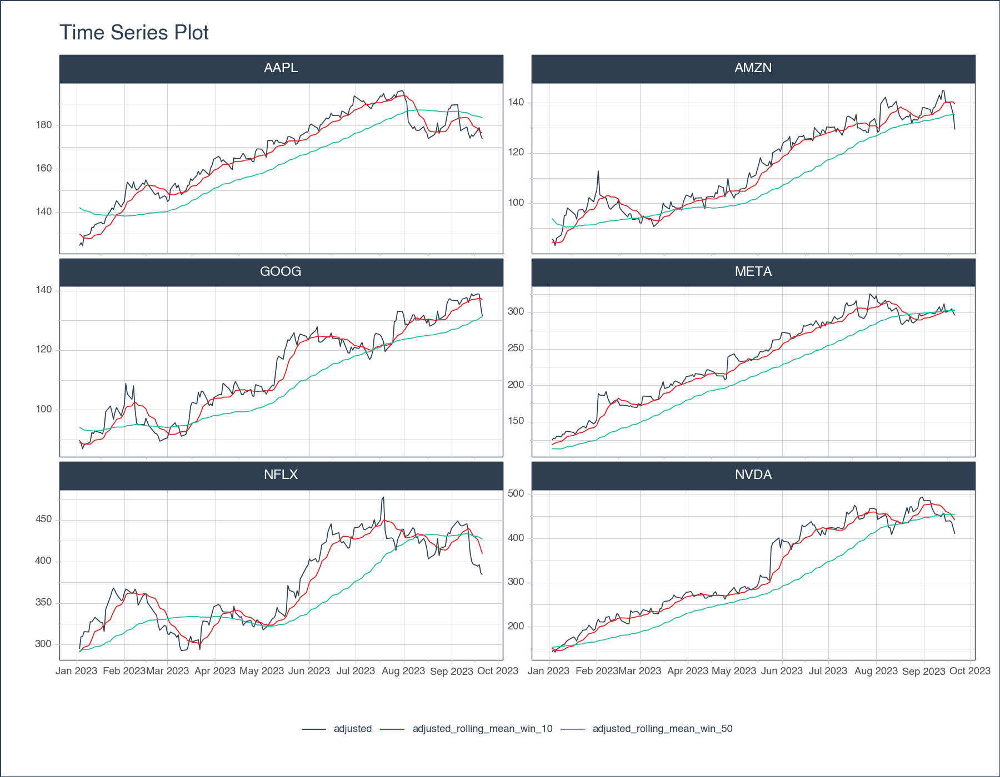

    <Figure Size: (900 x 700)>

## 3.2 Application: Bollinger Bands

Bollinger Bands are a volatility indicator commonly used in financial
trading. They consist of three lines:

1.  The middle band, which is a simple moving average (usually over 20
    periods).
2.  The upper band, calculated as the middle band plus k times the
    standard deviation of the price (typically, k=2).
3.  The lower band, calculated as the middle band minus k times the
    standard deviation of the price.

Here’s how you can calculate and plot Bollinger Bands with `pytimetk`
using **this code template (click to expand)**:

## Plotly

``` python
# Bollinger Bands
bollinger_df = stocks_df[['symbol', 'date', 'adjusted']] \
    .groupby('symbol') \
    .augment_rolling(
        date_column = 'date',
        value_column = 'adjusted',
        window = 20,
        window_func = ['mean', 'std'],
        center = False
    ) \
    .assign(
        upper_band = lambda x: x['adjusted_rolling_mean_win_20'] + 2*x['adjusted_rolling_std_win_20'],
        lower_band = lambda x: x['adjusted_rolling_mean_win_20'] - 2*x['adjusted_rolling_std_win_20']
    )


# Visualize
(bollinger_df

    # zoom in on dates
    .query('date >= "2023-01-01"') 

    # Convert to long format
    .melt(
        id_vars = ['symbol', 'date'],
        value_vars = ["adjusted", "adjusted_rolling_mean_win_20", "upper_band", "lower_band"]
    ) 

    # Group on symbol and visualize
    .groupby("symbol") 
    .plot_timeseries(
        date_column = 'date',
        value_column = 'value',
        color_column = 'variable',
        # Adjust colors for Bollinger Bands
        color_palette =["#2C3E50", "#E31A1C", '#18BC9C', '#18BC9C'],
        smooth = False, 
        facet_ncol = 2,
        width = 900,
        height = 700,
        engine = "plotly" 
    )
)
```

``` json
{"model_id":"c803444ac42641bd9bdff0919f46dc7e","version_major":2,"version_minor":0,"quarto_mimetype":"application/vnd.jupyter.widget-view+json"}
```

<div>                            <div id="5b9cb14c-bfd8-42c9-987d-a7dcc90f7677" class="plotly-graph-div" style="height:700px; width:900px;"></div>            <script type="text/javascript">                require(["plotly"], function(Plotly) {                    window.PLOTLYENV=window.PLOTLYENV || {};                                    if (document.getElementById("5b9cb14c-bfd8-42c9-987d-a7dcc90f7677")) {                    Plotly.newPlot(                        "5b9cb14c-bfd8-42c9-987d-a7dcc90f7677",                        [{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[124.73999786376952,127.37000274658205,126.94000244140624,130.02000427246094,129.47000122070312,132.99000549316406,132.88999938964844,136.7100067138672,136.97999572753906,135.36000061035156,133.02000427246094,136.14999389648438,139.3699951171875,143.27000427246094,143.13999938964844,141.5,147.3000030517578,151.74000549316406,147.05999755859375,148.97000122070312,153.1199951171875,188.7700042724609,186.52999877929688,186.05999755859372,191.6199951171875,183.42999267578125,177.9199981689453,174.14999389648438,179.42999267578125,179.47999572753906,177.16000366210938,172.44000244140625,172.8800048828125,172.0800018310547,171.1199951171875,172.0399932861328,170.38999938964844,169.5399932861328,174.94000244140625,173.4199981689453,174.52999877929688,185.25,184.8999938964844,184.50999450683597,184.97000122070312,181.69000244140625,179.50999450683594,180.8999938964844,194.0200042724609,197.75,204.92999267578125,195.6100006103516,197.80999755859372,202.16000366210935,199.80999755859372,204.27999877929688,206.00999450683597,202.83999633789065,200.67999267578125,205.3500061035156,207.83999633789065,211.94000244140625,213.07000732421875,214.72000122070312,211.47999572753903,216.1000061035156,214.75,213.8500061035156,214.0,220.3500061035156,221.4900054931641,218.8600006103516,217.88999938964844,215.6999969482422,213.07000732421875,212.88999938964844,212.7899932861328,207.5500030517578,209.3999938964844,238.55999755859372,240.32000732421875,243.17999267578125,239.2400054931641,237.02999877929688,233.5200042724609,232.77999877929688,233.2700042724609,233.3699951171875,233.0800018310547,235.7899932861328,233.80999755859372,238.8600006103516,238.82000732421875,242.4900054931641,246.8500061035156,245.63999938964844,248.32000732421875,246.7400054931641,249.2100067138672,252.69000244140625,262.0400085449219,262.5199890136719,264.7200012207031,272.6099853515625,272.6099853515625,271.3900146484375,271.1199951171875,263.6000061035156,264.5799865722656,264.95001220703125,271.04998779296875,271.32000732421875,273.3500061035156,281.8299865722656,281.0,284.3299865722656,281.6400146484375,284.8800048828125,288.7300109863281,278.4700012207031,287.04998779296875,285.2900085449219,281.5299987792969,286.9800109863281,286.0199890136719,294.3699951171875,291.989990234375,290.5299987792969,294.1000061035156,298.2900085449219,309.3399963378906,313.4100036621094,308.8699951171875,310.6199951171875,312.04998779296875,316.010009765625,302.5199890136719,294.260009765625,291.6099853515625,294.4700012207031,298.57000732421875,311.7099914550781,325.4800109863281,318.6000061035156,322.7099914550781,314.3099975585937,313.19000244140625,310.7300109863281,316.5599975585937,312.6400146484375,305.2099914550781,305.739990234375,301.6400146484375,306.19000244140625,301.95001220703125,294.2900085449219,285.0899963378906,283.25,289.8999938964844,287.6000061035156,294.239990234375,286.75,285.5,290.260009765625,297.989990234375,295.1000061035156,295.8900146484375,296.3800048828125,300.1499938964844,299.1700134277344,298.6700134277344,297.8900146484375,307.5599975585937,301.6600036621094,305.0599975585937,311.7200012207031,300.3099975585937,302.54998779296875,305.07000732421875,299.6700134277344,295.7300109863281],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_20","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_20","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[117.90350036621093,118.15050048828125,118.79150047302247,119.59600067138672,120.30300064086914,121.15750083923339,122.06650085449219,122.89450111389161,123.66400108337402,124.62450103759765,125.30400123596192,126.38750076293945,127.50150070190429,128.67700080871583,129.97800064086914,131.15100059509277,132.67200088500977,134.47800102233887,135.81800079345703,137.24950103759767,138.66850090026855,141.7385009765625,144.71800079345704,147.52000045776367,150.62750015258788,153.14949951171874,155.4009994506836,157.27299880981445,159.39549865722657,161.60149841308595,163.80849838256836,165.62299880981445,167.2984992980957,168.7389991760254,170.13799896240235,171.66499862670898,172.81949844360352,173.70949783325196,175.10349807739257,176.32599792480468,177.39649810791016,177.22049789428712,177.13899765014648,177.0614974975586,176.72899780273437,176.64199829101562,176.72149810791015,177.05899810791016,177.78849868774415,178.70199890136718,180.0904983520508,181.24899826049804,182.4954978942871,183.99949798583984,185.43399810791016,187.04599838256837,188.82699813842774,190.49199829101562,191.77899780273438,193.3754981994629,195.04099807739257,196.3754981994629,197.78399887084962,199.29449920654298,200.61999893188477,202.34049911499022,204.10249938964844,205.75,206.74899978637694,207.87900009155274,208.70700073242188,209.86950073242187,210.8735008239746,211.55050048828124,212.2135009765625,212.64400100708008,212.9830009460449,213.21850128173827,213.65450134277344,215.31500091552735,216.93900146484376,218.5010009765625,219.80950088500975,220.92500076293945,222.02700119018556,222.86100082397462,223.78700103759766,224.76300048828125,225.71700057983398,226.48899993896484,227.10499954223633,228.10499954223633,229.15149993896483,230.49100036621093,232.18000030517578,233.81750030517577,235.59400100708007,237.5535011291504,239.54400177001952,240.25050201416016,241.3365020751953,242.30350189208986,243.5775016784668,245.35650100708008,247.31100006103514,249.2415008544922,251.1340003967285,252.64550094604493,254.22050018310546,255.6785011291504,257.54050064086914,259.1635009765625,260.89000091552737,262.85699996948244,264.56449966430665,266.4989990234375,268.1649993896484,270.07199935913087,272.0479995727539,273.3369995117188,274.5874984741211,275.7259994506836,276.5664993286133,277.2850006103516,277.955500793457,279.10449981689453,280.1479995727539,281.49449920654297,282.97050018310546,284.6375,286.55200042724607,288.6565002441406,290.43249969482423,291.8720001220703,293.42449951171875,295.00850067138674,296.05249938964846,296.52149963378906,296.6654983520508,297.46549835205076,298.04149932861327,299.3624984741211,301.5599990844727,303.14099884033203,304.97549896240236,305.97249908447264,307.0324996948242,308.0425003051758,309.1654998779297,309.8830001831055,309.67649993896487,309.2929992675781,308.93150024414064,308.7100006103516,308.2050018310547,307.1190017700195,306.2475021362305,305.6970016479492,305.6115020751953,305.26800231933595,305.05150146484374,303.80350189208986,301.80450134277345,300.3875015258789,299.15150146484376,298.19100189208984,297.3260025024414,296.60850219726564,295.78800201416016,295.114501953125,294.7875030517578,294.39500427246094,294.6910034179688,294.4645034790039,294.62000274658203,295.4915023803711,296.25250244140625,297.2175018310547,297.9760025024414,298.57950286865236,298.65400390625],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"lower_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"lower_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[111.80914502721974,110.97854006255234,110.88256294928327,110.57416350415588,110.50590650136054,110.079882022017,110.25708974179858,109.44288792930656,108.83621895329335,109.36371643953522,109.80865679135282,111.04921516170563,111.7750166469374,111.90697853673532,112.9478605744328,114.35285539874198,115.80594093886657,117.56466573352772,119.40855241059361,121.54529364679001,122.59911964015826,114.90342814012878,112.17552742810602,110.90992053171287,110.12463152813007,111.02186406425903,113.01989853877595,115.06091998189345,117.21079355626064,120.10016668071223,124.04879689877961,127.91882453084024,131.58053832218167,134.8229607634215,138.4316813578681,142.9670130948794,146.48843417314163,149.24099328930726,154.09565399090965,159.24230558408271,164.19293225982776,164.57314705258574,164.72539261745825,164.86494248884446,165.91989599341713,166.03384754612122,166.0493818597894,166.30269393036485,164.64174346779544,162.8083570712733,160.37217353752683,160.71742562356548,161.09460058478228,161.4818448867193,162.71652595062608,163.76194782515518,165.45823832108758,168.18834744350727,170.29850827008664,172.9183675492895,175.64789846511752,176.16329043264628,177.02028897302148,178.20385728134002,179.9928416546669,182.64218703307466,186.85029896945616,191.86206542117463,193.55678005870138,194.0748664370407,193.71238327464482,195.5608210355397,197.3302488401919,198.49638708900574,200.38022930120235,201.4149447075829,202.1965723105109,203.18512363409548,205.2974551777426,202.11280833984014,200.11457018044942,198.19106124144383,197.68206127147994,197.65782141822658,198.5565016369007,199.09374232921527,199.90747125202222,200.99818732675502,202.2412879559685,202.7424919969786,203.26550560647706,204.0448685957848,205.14146285990182,206.65217090725082,208.755100567633,211.5186333447027,214.73389031857943,220.8334544450288,228.3808847535414,227.6531896048729,225.40917916989392,223.7697883193827,222.5899315118096,220.95205997932516,220.7334553372228,221.52355976810745,222.8448953947555,225.13302461789402,227.84084925481545,230.3870133648059,233.579601621868,236.15172660001073,239.1590793968273,241.01716203417288,242.6542450679402,244.79295584394612,247.23284359012263,250.4499654875432,253.33311871151574,256.81300246617695,257.8788441655643,259.38041508265604,260.8886791266733,261.06296192863164,261.4411567570004,261.3615222853705,261.9336694208648,264.4895014700852,267.05768679661065,269.7190880366778,269.3263040573094,269.13484016818205,270.3201029484066,270.284947967164,270.69381257369287,270.59339091684103,272.2667411666816,273.3000936352227,273.61241990390613,276.01639033480075,277.15883639922,278.53370748253207,279.4203500922321,280.8695923201952,282.59796071604757,283.80871400631145,285.67110668982184,288.10361839375827,290.0187680666148,291.38783912089593,291.0639604290663,290.6882908562205,290.01385216632764,289.7718672877243,289.1039260896054,287.4257559846411,284.28533564743435,281.98724922141326,281.67659502851603,280.4779362400021,279.94156844086734,277.6284800242199,276.5079320827699,275.88989041341,277.0154052261544,277.1861627678166,277.531928096945,277.8468004634243,279.4171519121055,280.66751642319065,281.02269441587123,281.52668502176755,280.88296339090687,281.31789458255207,281.03435746278745,279.90596813696305,281.3333426314098,283.3821535833237,284.1664745546133,285.6524715158879,285.8154034818698],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"upper_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"upper_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[123.99785570520213,125.32246091401016,126.70043799676166,128.61783783861756,130.10009478037773,132.2351196564498,133.8759119671858,136.34611429847664,138.49178321345468,139.88528563566007,140.79934568057104,141.72578636417327,143.2279847568712,145.44702308069634,147.00814070730547,147.94914579144356,149.53806083115296,151.39133631115004,152.22744917632045,152.95370842840532,154.73788216037886,168.57357381299624,177.26047415880805,184.13008038381446,191.1303687770457,195.27713495917845,197.78210036259125,199.48507763773546,201.5802037581925,203.10283014545968,203.5681998663571,203.32717308878864,203.01646027400972,202.6550375886293,201.8443165669366,200.36298415853855,199.15056271406542,198.17800237719666,196.1113421638755,193.40969026552665,190.60006395599257,189.8678487359885,189.5526026828347,189.25805250627275,187.5380996120516,187.25014903591003,187.3936143560309,187.81530228545546,190.93525390769287,194.59564073146106,199.80882316657474,201.7805708974306,203.8963952037919,206.51715108496037,208.15147026519423,210.33004893998157,212.1957579557679,212.79564913852397,213.25948733538212,213.83262884963628,214.43409768966762,216.58770596627951,218.54770876867775,220.38514113174594,221.24715620910263,222.03881119690578,221.35469980984072,219.63793457882537,219.9412195140525,221.68313374606478,223.70161819019893,224.17818042930404,224.41675280775732,224.60461388755675,224.04677265192265,223.87305730657727,223.76942958157892,223.25187892938106,222.0115475078043,228.51719349121456,233.7634327492381,238.81094071168116,241.93694049853957,244.19218010765232,245.49750074347043,246.62825931873397,247.6665308231731,248.52781364980748,249.19271320369947,250.23550788095108,250.9444934779956,252.16513048868785,253.16153701802784,254.32982982517103,255.60490004271855,256.1163672656488,256.4541116955807,254.273547813272,250.70711878649763,252.84781442344743,257.26382498049674,260.837215464797,264.565071845124,269.760942034835,273.8885447848475,276.9594419408769,279.4231053987015,280.15797727419584,280.60015111139546,280.9699888934949,281.5013996598703,282.1752753531142,282.62092243422745,284.696837904792,286.4747542606731,288.20504220292884,289.0971551891742,289.69403323071856,290.76288043399205,289.8609965572606,291.2961527826779,292.0715838187112,292.2443195305533,293.5070392920715,294.46984482991365,296.8474773484186,298.362329724643,298.49949694300074,298.88331356960026,299.55591196332216,303.7776967971827,308.17816032009915,310.54489644124186,313.4590522769766,316.15518644974463,319.42361042593245,319.83825761261534,319.7429056323554,319.7185768001955,318.91460636930077,318.92416225800656,320.1912894657101,323.69964807671323,325.4124053604689,327.35303720875714,328.13628416263384,328.39389269982655,327.9813822165933,328.3122316892445,328.378161245315,328.28903944886343,327.8977076789358,327.84914832195363,327.64813393297885,327.30607757250397,326.8122475553979,328.2096686250266,329.40675407448515,329.54640912187455,330.0580683986698,330.16143448882013,329.9785237599598,327.101070602777,324.88511263834783,321.2875977035331,319.1958410163631,317.12007690793774,315.37020393110697,312.1588521162148,309.56148748305935,308.5523116876444,307.2633235231543,308.4990434450307,307.6111123754557,308.2056480303766,311.0770366237792,311.1716622514027,311.05285007878564,311.78553045026956,311.5065342214168,311.49260433063023],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[85.81999969482422,85.13999938964844,83.12000274658203,86.08000183105469,87.36000061035156,89.87000274658203,95.08999633789062,95.2699966430664,98.12000274658205,96.0500030517578,95.45999908447266,93.68000030517578,97.25,97.5199966430664,96.31999969482422,97.18000030517578,99.22000122070312,102.23999786376952,100.5500030517578,103.12999725341795,105.1500015258789,112.91000366210938,103.38999938964844,102.18000030517578,102.11000061035156,100.0500030517578,98.23999786376952,97.61000061035156,99.54000091552734,99.6999969482422,101.16000366210938,98.1500015258789,97.1999969482422,94.58000183105467,95.79000091552734,95.81999969482422,93.5,93.76000213623048,94.2300033569336,92.16999816894533,92.12999725341795,94.9000015258789,93.75,93.5500030517578,93.91999816894533,92.25,90.7300033569336,92.43000030517578,94.87999725341795,96.1999969482422,100.04000091552734,98.9499969482422,97.70999908447266,100.61000061035156,98.6999969482422,98.70999908447266,98.12999725341795,98.04000091552734,97.23999786376952,100.25,102.0,103.29000091552734,102.41000366210938,103.9499969482422,101.0999984741211,102.05999755859376,102.16999816894533,99.91999816894533,97.83000183105467,102.4000015258789,102.51000213623048,102.73999786376952,102.3000030517578,104.3000030517578,103.80999755859376,106.95999908447266,106.20999908447266,102.56999969482422,104.9800033569336,109.81999969482422,105.4499969482422,102.0500030517578,103.62999725341795,103.6500015258789,104.0,105.66000366210938,105.83000183105467,106.62000274658205,110.19000244140624,112.18000030517578,110.26000213623048,111.1999969482422,113.4000015258789,115.5,118.1500015258789,116.25,115.01000213623048,114.98999786376952,116.75,115.0,120.11000061035156,121.66000366210938,120.58000183105467,122.7699966430664,124.25,125.3000030517578,126.61000061035156,121.2300033569336,124.25,123.43000030517578,126.56999969482422,126.66000366210938,126.41999816894533,127.11000061035156,125.48999786376952,125.77999877929688,124.83000183105467,130.14999389648438,129.3300018310547,127.33000183105467,129.17999267578125,129.0399932861328,127.9000015258789,130.36000061035156,130.22000122070312,130.3800048828125,128.36000061035156,129.77999877929688,127.12999725341795,128.77999877929688,130.8000030517578,134.3000030517578,134.67999267578125,133.55999755859375,132.8300018310547,135.36000061035156,129.9600067138672,130.0,128.8000030517578,129.1300048828125,128.14999389648438,128.25,132.2100067138672,133.67999267578125,131.69000244140625,128.2100067138672,128.91000366210938,139.57000732421875,142.22000122070312,139.94000244140625,137.85000610351562,138.55999755859375,138.41000366210938,140.57000732421875,137.6699981689453,135.07000732421875,133.97999572753906,133.22000122070312,134.67999267578125,134.25,135.52000427246094,131.83999633789062,133.25999450683594,133.13999938964844,134.91000366210938,135.07000732421875,138.00999450683594,138.1199951171875,137.27000427246094,135.36000061035156,137.85000610351562,138.22999572753906,143.10000610351562,141.22999572753906,144.85000610351562,144.72000122070312,140.38999938964844,139.97999572753906,137.6300048828125,135.2899932861328,129.3300018310547],"type":"scatter","xaxis":"x2","yaxis":"y2","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_20","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_20","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[87.14349975585938,86.84999961853028,86.59349975585937,86.47449989318848,86.325,86.36400032043457,86.59099998474122,86.72999992370606,87.05699996948242,87.4370002746582,87.81700019836425,88.25500030517578,88.85800018310547,89.39550018310547,90.02200012207031,90.61850013732911,91.4275001525879,92.44850006103516,93.26700019836426,94.22350006103515,95.19000015258788,96.57850036621093,97.59200019836426,98.39700012207031,99.1345001220703,99.6435001373291,99.80100021362304,99.91800041198731,99.98900032043457,100.17150001525879,100.45650024414063,100.68000030517578,100.6775001525879,100.5305004119873,100.50400047302246,100.43600044250488,100.15000038146972,99.72600059509277,99.41000061035156,98.86200065612793,98.21100044250488,97.31050033569336,96.82850036621093,96.39700050354004,95.98750038146973,95.59750022888184,95.22200050354004,94.96300048828125,94.73000030517578,94.55500030517578,94.49900016784667,94.53899993896485,94.56450004577637,94.86599998474121,95.01149978637696,95.15599975585937,95.38749961853027,95.60149955749512,95.75199928283692,96.15599937438965,96.64949951171874,97.06899948120117,97.50199966430664,98.02199935913086,98.38099937438965,98.87149925231934,99.44349899291993,99.8179988861084,99.96549911499024,100.27549934387207,100.39899940490723,100.5884994506836,100.81799964904785,101.00249977111817,101.25799980163575,101.67049980163574,102.07449989318847,102.30099983215332,102.68800010681153,103.16650009155273,103.33899993896485,103.27700004577636,103.3379997253418,103.32299995422363,103.46800003051757,103.64800033569335,103.83100051879883,104.16600074768067,104.78400077819825,105.27300071716309,105.66050071716309,106.08350067138672,106.63850059509278,107.19850044250488,107.91550064086914,108.3800006866455,108.8200008392334,109.44100074768066,110.02950057983398,110.28850059509277,111.02150077819825,112.00200080871582,112.84950103759766,113.80550079345703,114.81800079345703,115.80000076293945,116.8390007019043,117.56950073242187,118.27250061035156,118.83500061035156,119.65050048828125,120.4235008239746,121.07450065612792,121.65500068664551,122.02200050354004,122.49850044250488,122.9895004272461,123.74750022888183,124.37650032043457,124.99300041198731,125.44650001525879,125.81549949645996,126.18149948120117,126.56099967956543,126.85949974060058,127.11349983215332,127.20099983215331,127.62849960327148,127.77249946594239,128.03999938964844,128.25149955749512,128.63349952697754,129.04649925231934,129.36899909973144,129.7359992980957,130.21499938964843,130.47149963378905,130.46399993896483,130.4375,130.5275001525879,130.47600021362305,130.4365005493164,130.65200080871583,130.8180004119873,130.89150047302246,130.7830005645752,130.81050071716308,131.30000114440918,132.05450134277345,132.6125015258789,132.9650016784668,133.1780014038086,133.364501953125,133.71500244140626,133.95700225830078,133.94250259399413,134.14350204467775,134.30450210571288,134.59850158691407,134.85450134277343,135.22300186157227,135.4025016784668,135.45500106811522,135.4280014038086,135.58900146484376,135.93200149536133,136.38700103759766,136.3145004272461,136.06700057983397,135.83800048828124,135.83800048828124,135.8215003967285,136.05600051879884,136.08899993896483,136.44800033569337,136.93050003051758,137.25100021362306,137.58899993896483,137.73650054931642,137.78850021362305,137.47900009155273],"type":"scatter","xaxis":"x2","yaxis":"y2","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"lower_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"lower_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[80.92985023297166,80.85463003129506,80.41419302721874,80.35516313259767,80.4636644371202,80.41546881685589,79.69830836838817,79.24937123468915,78.2326301041121,77.74787668232813,77.4833313362791,77.6981601644896,77.67891933499945,77.62123225610736,78.17041255124012,78.57879089228021,79.35755580362172,80.34583294100857,81.30546947220353,82.322813564057,83.02609947940218,82.98864633177838,85.26341678385988,87.18108573488954,89.09638976076796,90.60029394174629,90.9848392970847,91.2950323287476,91.40507082574887,91.78730476905743,92.36421199862652,93.1482527292674,93.14092688960156,92.6287727195148,92.53951150141143,92.33004995969809,91.47943207406018,90.66518203215125,90.03481002779779,89.12795163641013,88.50613987705802,90.41184260730758,90.38637098409649,90.3182879052488,90.44988906106109,90.16693585633807,89.52856715137162,89.25569729466264,89.44456059926443,89.75274382456503,90.00480831978128,89.8962030611011,89.8550415022714,89.4354811294542,89.32675764846256,89.24241125208798,89.38503530166403,89.53846938741658,89.6828839908456,90.01555161045351,90.28889673416066,90.11519805586109,90.34292419205794,90.56688291359842,91.0674336036115,91.98591962908921,93.58093807099274,94.9732821348961,95.59763253437984,96.16012329029296,96.16679161441448,96.29058126351553,96.68004816172612,96.5840496945751,96.80928030780542,96.7154362021279,97.01833770136753,97.61339063054754,98.50928424165201,98.07191589318134,98.17752819420711,98.0833604629485,98.15859734905263,98.14932575754186,98.39508142009967,98.53016162460605,98.67409087963541,99.21235781694428,100.08095629426082,99.6666430855031,99.79299313203326,99.89166534540442,99.90812562228764,99.49408128799048,98.96978726093222,98.70792277455375,98.77029078857448,99.48290196763087,99.79414333628992,99.81605646529164,99.94048459463767,100.79382959449008,101.7439191353063,102.74258987241012,103.82729099799471,104.74514648579442,105.82359173170806,107.5113357389336,108.42279162943302,109.16700934862075,110.28110380588072,111.4468866844521,112.35784353390338,112.95511411135121,113.3254006546124,114.09408994851192,115.31111350836468,116.40851889363715,117.41609250090677,119.49989408201863,120.15695698804431,120.60914836008308,121.52465322814126,121.83814053376526,121.99900009208243,122.06869478012582,122.1323157241849,123.2907044111581,123.72546690326664,124.52988239062529,124.60713978874094,124.1797723618664,123.96881593131744,123.99831572650102,124.47945959358437,124.73510552185908,125.60724007820616,125.59719138949919,125.5390241915564,125.80649316856393,125.67136927421278,125.5695761062415,125.8771606323191,125.85862710398548,125.9258752361795,125.67745872715994,125.75422350634109,124.9370653813175,124.33869285460962,124.30250051979858,124.38500375483062,124.25385198743173,124.15678980709711,123.95861828208814,124.05404269799588,124.04734631643231,124.42726304885389,124.7723846489149,125.42527085622466,126.04529504199421,126.99741059194626,127.67607078094339,127.80602552431719,127.74889199859771,128.1073932645743,129.29327140182406,130.5792999492093,130.6394168550997,131.0871644199032,131.19846708269623,131.19846708269623,131.22054027574396,130.51707697356852,130.43027325616268,129.5842329284163,129.17570926483742,129.4798259886048,129.96947454531193,130.2408769298328,130.38080284754383,129.20557121145282],"type":"scatter","xaxis":"x2","yaxis":"y2","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"upper_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"upper_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[93.3571492787471,92.8453692057655,92.7728064845,92.59383665377929,92.1863355628798,92.31253182401325,93.48369160109426,94.21062861272297,95.88136983485273,97.12612386698828,98.15066906044942,98.81184044586198,100.0370810312115,101.16976811010358,101.8735876929005,102.658209382378,103.49744450155407,104.55116718106176,105.22853092452499,106.1241865580133,107.3539008257736,110.16835440064348,109.92058361286864,109.61291450925108,109.17261048337265,108.68670633291191,108.61716113016138,108.54096849522702,108.57292981512028,108.55569526146014,108.54878848965474,108.21174788108416,108.21407341557423,108.43222810445981,108.46848944463349,108.54195092531167,108.82056868887926,108.78681915803429,108.78519119290533,108.59604967584573,107.91586100795175,104.20915806407915,103.27062974832538,102.47571310183129,101.52511170187837,101.02806460142561,100.91543385570847,100.67030368189987,100.01544001108712,99.35725678578653,98.99319201591207,99.1817968168286,99.27395858928134,100.29651884002821,100.69624192429136,101.06958825963076,101.38996393539651,101.66452972757365,101.82111457482824,102.29644713832579,103.01010228927683,104.02280090654126,104.66107513655534,105.4771158046633,105.69456514516779,105.75707887554947,105.30605991484711,104.6627156373207,104.33336569560063,104.39087539745118,104.63120719539998,104.88641763785166,104.95595113636958,105.42094984766123,105.70671929546607,106.62556340114358,107.13066208500942,106.9886090337591,106.86671597197105,108.26108428992413,108.50047168372258,108.47063962860422,108.51740210163098,108.4966741509054,108.54091864093547,108.76583904678066,108.98791015796225,109.11964367841706,109.48704526213568,110.87935834882308,111.52800830229292,112.27533599736901,113.36887556789792,114.90291959701928,116.86121402080606,118.05207859873725,118.86971088989232,119.39909952773046,120.26485782337804,120.7609447248939,122.10251696175882,123.21017202294156,123.95508293988902,124.86841171450394,125.80871058891935,126.85485504008447,127.85440967210053,127.62766572591015,128.1222095912701,128.50299187208236,129.0198971706818,129.40011496349712,129.79115777835247,130.3548872619398,130.7186003524677,130.90291093649785,130.66788734612751,131.0864815641265,131.33690813996236,130.486106741956,130.73604304247326,131.02185063283684,130.83834573426108,131.2838588253656,131.71999938911875,132.1583048841808,132.26968394012172,131.96629479538484,131.81953202861814,131.5501163886716,131.8958593262493,133.0872266920887,134.12418257332124,134.73968247296185,134.992539002607,135.69489325743777,135.33575918937194,135.33080848843048,135.3359758084436,135.24850713661183,135.2806311530333,135.3034249923913,135.42684098511256,135.7773737199891,135.85712570986541,135.88854240199043,135.86677792798508,137.66293690750086,139.7703098309373,140.92250253195922,141.54499960210296,142.10215082018544,142.5722140991529,143.47138660072437,143.85996181860565,143.83765887155596,143.8597410405016,143.83661956251086,143.77173231760347,143.66370764355267,143.44859313119827,143.12893257599018,143.10397661191325,143.10711080901947,143.0706096651132,142.5707315888986,142.19470212598603,141.98958399939247,141.04683673976476,140.47753389386625,140.47753389386625,140.42246051771306,141.59492406402916,141.747726621767,143.31176774297043,144.68529079619773,145.02217443864131,145.20852533261774,145.23212416880003,145.19619757970227,145.75242897165265],"type":"scatter","xaxis":"x2","yaxis":"y2","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[124.53865814208984,125.82318878173828,124.4888687133789,129.0693359375,129.59707641601562,130.17462158203125,132.9228973388672,132.84323120117188,134.18748474121094,135.36248779296875,134.63558959960938,134.69532775878906,137.28427124023438,140.51052856445312,141.92449951171875,141.25733947753906,143.34841918945312,145.31004333496094,142.39248657226562,143.677001953125,144.81216430664062,150.1792755126953,153.8436279296875,151.0854034423828,153.9929962158203,151.27459716796875,150.22906494140625,150.59803771972656,153.43031311035156,152.78207397460938,154.90626525878906,153.29067993164062,152.13385009765625,148.074951171875,148.50376892089844,148.992431640625,146.30978393554688,147.5164794921875,147.00787353515625,144.91360473632812,145.51197814941406,150.6179962158203,153.41036987304688,151.1864471435547,152.45297241210938,150.17918395996094,148.0948944091797,150.0595245361328,152.17373657226562,152.57264709472656,155.4248504638672,154.57716369628906,156.97061157226562,158.84548950195312,157.39944458007812,158.49644470214844,159.81283569335938,157.84820556640625,157.2199249267578,160.3314208984375,161.91708374023438,164.4501495361328,165.71669006347656,165.1781768798828,163.31326293945312,164.21083068847656,161.58798217773438,160.36134338378906,159.66326904296875,165.1083526611328,164.7593231201172,164.7792510986328,166.01588439941406,167.17271423339844,166.1953887939453,164.56983947753906,164.8789825439453,163.3232421875,163.31326293945312,167.95059204101562,169.2171173095703,169.1273651123047,168.08023071289062,166.99319458007812,165.3377227783203,173.0965118408203,173.0266876220703,171.30142211914062,173.08653259277344,173.27601623535156,172.3372802734375,171.8379669189453,171.8379669189453,172.45712280273438,174.81393432617188,174.92379760742188,173.96507263183594,171.32864379882812,171.60826110839844,172.7567138671875,175.19342041015625,177.06089782714844,177.01097106933594,179.84713745117188,180.7059783935547,179.33782958984375,178.9683380126953,177.5802001953125,180.3264923095703,180.71597290039065,183.54214477539065,183.0627899169922,183.70193481445312,185.7591552734375,184.67062377929688,184.760498046875,183.71192932128903,186.7478179931641,186.42823791503903,185.0201568603516,187.80638122558597,188.99478149414065,189.33432006835935,193.7084197998047,192.20046997070312,191.0719757080078,191.55133056640625,190.4228515625,188.35565185546875,187.8263702392578,189.5140838623047,190.2830352783203,190.43284606933597,193.7283935546875,193.4687347412109,194.8368988037109,192.8695526123047,191.68116760253903,192.4900665283203,193.35888671875,194.2377014160156,192.9594268798828,195.56591796875,196.18507385253903,195.34620666503903,192.3202972412109,190.9122009277344,181.7445831298828,178.6088104248047,179.55752563476562,177.94970703125,177.72999572753906,177.7899932861328,179.4600067138672,177.4499969482422,176.57000732421875,174.0,174.49000549316406,175.83999633789062,177.22999572753906,181.1199951171875,176.3800048828125,178.61000061035156,180.19000244140625,184.1199951171875,187.6499938964844,187.8699951171875,189.4600067138672,189.6999969482422,182.91000366210935,177.55999755859375,178.17999267578125,179.36000061035156,176.3000030517578,174.2100067138672,175.74000549316406,175.00999450683594,177.97000122070312,179.07000732421875,175.49000549316406,173.92999267578125],"type":"scatter","xaxis":"x3","yaxis":"y3","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_20","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_20","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[135.63930282592773,134.6301082611084,133.73940811157226,133.1758125305176,132.55346755981446,131.98439559936523,131.4367317199707,130.8362937927246,130.41558761596679,130.3877067565918,130.42255859375,130.56694259643555,130.84425888061523,131.12605743408204,131.63887100219728,132.13674697875976,132.8302879333496,133.82056312561036,134.48721809387206,135.20216789245606,136.2158432006836,137.43364753723145,138.90138549804686,140.002188873291,141.22198486328125,142.27698364257813,143.14229202270508,144.0300323486328,144.99217376708984,145.86315307617187,146.87668685913087,147.80645446777345,148.54893341064454,148.92715454101562,149.2561180114746,149.64287261962892,149.7909408569336,149.90126266479493,150.13203201293945,150.1938621520996,150.22885284423828,150.25078887939452,150.2291259765625,150.2341781616211,150.15717697143555,150.10240631103517,149.99569778442384,149.96877212524413,149.90594329833985,149.8954719543457,149.9214012145996,149.98572540283203,150.2275634765625,150.7660903930664,151.21087417602538,151.68607482910156,152.3612274169922,152.87781372070313,153.3884162902832,154.15930709838867,154.97956237792968,155.67117004394532,156.2864860534668,156.9860725402832,157.5290870666504,158.23066940307618,158.90532379150392,159.42041473388673,159.79489135742188,160.4216766357422,160.88840026855468,161.39850463867188,161.85076828002929,162.26712951660156,162.70692672729493,163.01059646606444,163.26390380859374,163.53765563964845,163.8423225402832,164.2232810974121,164.5882827758789,164.8221435546875,164.9403205871582,165.03107147216798,165.13229446411134,165.57657852172852,166.1485137939453,166.69551773071288,167.36668090820314,167.77506408691406,168.1539619445801,168.50689773559571,168.79800186157226,169.06222229003907,169.4931495666504,170.01084747314454,170.46515197753905,170.86542205810548,171.28017196655273,171.52047805786134,171.8192932128906,172.21596984863282,172.6625068664551,173.30520401000976,174.0736167907715,174.38568267822265,174.6827651977539,174.9967041015625,175.35870208740235,175.7306999206543,176.29094314575195,176.8521842956543,177.44538269042968,178.11048431396483,178.6033187866211,179.09515380859375,179.5824966430664,180.35345535278321,181.09445419311524,181.70762634277344,182.33827438354493,182.93496856689453,183.5511360168457,184.24420013427735,184.81892471313478,185.40563201904297,186.0347816467285,186.6769142150879,187.0783721923828,187.43389205932618,187.73248901367188,188.09350128173827,188.43004684448243,188.82850875854493,189.26841430664064,189.77223434448243,190.2301155090332,190.47678298950194,190.779874420166,191.19681091308593,191.51837692260742,191.71660919189452,192.02818908691407,192.1520217895508,192.30930862426757,192.37172470092773,192.33976821899415,191.90585479736328,191.41851272583008,191.00507049560548,190.42685165405274,189.79919967651367,189.16705703735352,188.4536376953125,187.65270080566407,186.73935623168944,185.7958786010742,184.93632049560546,184.10381698608398,183.29737243652343,182.64148712158203,181.81251602172853,180.9647201538086,180.16496658325195,179.60365600585936,179.37014083862306,179.2180305480957,179.60380172729492,180.1583610534668,180.32598495483398,180.30649948120117,180.3289993286133,180.40749969482422,180.24949951171874,180.0875,180.04599990844727,180.09649963378905,180.270499420166,180.43199996948243,180.34500045776366,179.98550033569336],"type":"scatter","xaxis":"x3","yaxis":"y3","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"lower_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"lower_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[122.1393156157733,121.37804446086449,120.26593958872385,119.92391556903748,119.89955251149922,120.0308644838675,120.85193169887434,122.28946873302806,123.66831494299981,123.73222095306144,123.6820246277576,123.58220071620957,123.24994507106523,122.54756701585663,121.79153407209898,121.39528689617343,121.0689719233518,121.34300062444075,121.66088057770257,121.98677852563785,123.33859447664835,124.09615769333371,125.10889264221525,126.00104745828568,126.79343061475676,128.16748386196014,129.32863044909953,130.7307426865538,131.90853220083193,133.16510052628178,134.7278966667999,136.7894180778224,138.5645646291349,139.67895270092143,140.608129310926,141.85166157111883,142.40119037692338,142.73054337889843,143.72206996324041,144.02681432353162,144.18363456837722,144.2031446251607,144.2327836026543,144.23462868579549,144.32351653020848,144.29239802969468,144.11749076234773,144.09725263828162,144.16494259428677,144.17583520403792,144.10228223137403,143.98420760430963,143.5140106877985,143.11686350506562,143.095231982935,143.0228547352453,143.36395081841945,143.86536264943607,144.6224685948628,145.83058489149806,147.01323071737156,146.93468961254231,146.5447915258683,146.78760772188846,147.19133511561355,148.09050886443296,149.8692206692225,151.38878694735388,152.52348459730626,153.6259611833628,154.25747445141312,155.2605043573079,155.75366653147418,155.90269113085503,156.54640225515143,157.13163715532224,157.5303061940993,158.40105621332094,159.64690405585475,159.98669466766324,159.94951056769125,159.76038067298975,159.6839969021195,159.6953830828757,159.85735455868624,159.23871230709412,159.2835971971596,160.03170364742778,160.9872099634138,160.97261102446691,161.21594542777925,161.57355657177843,161.81630645948195,161.9409318502482,162.06581478994423,162.58503307631963,163.25259093569215,164.4806648044306,165.97455037164383,166.41836640899504,166.586822619675,166.65047558517594,167.0611960663763,167.4969274253723,168.6499279031065,168.5001534946307,168.49404698516344,168.89378671224736,168.88521544120255,168.915102300034,168.8375838001375,169.1252149143885,169.52016929867614,169.7284024326367,169.88501220559124,170.14410473921092,170.7468880667594,171.86629977602874,173.2593903381597,174.74959126563235,175.58279643790794,176.03552853732126,176.6782219457128,176.24131179720678,176.2546586458696,176.81469019487534,177.58699017944133,179.0196076449893,180.00313643136056,181.02121458398133,181.5301150690814,182.20287623142184,182.83411089005344,182.90785357846076,183.34112503161774,183.74613987407196,184.77863382824208,185.2467913678598,185.84341150997582,186.94793735122255,187.37781228522408,187.70721288233668,187.83401480357008,187.616604671686,187.55396311394958,187.65212526312058,187.5882326593933,185.2242391909339,182.57464668616498,180.7876737874958,178.6624100290545,176.7348211147546,175.05063969498028,173.87326462030336,172.4842537174867,171.19710200055454,169.5456847235366,168.1859166205607,167.27928017644683,166.79764369051014,166.9497766437451,166.67390132146863,167.23562124808865,168.45381445357071,170.08538041049636,171.00632829266084,171.66688448951672,170.82125561441447,170.30496483008866,170.4018165841094,170.3611783848292,170.40621066752018,170.54462511606334,170.22283080314736,169.7699086100658,169.66237113359082,169.82748618141898,170.28752731191187,170.64829813316686,170.41161175689706,169.65761367147675],"type":"scatter","xaxis":"x3","yaxis":"y3","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"upper_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"upper_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[149.13929003608214,147.88217206135232,147.21287663442067,146.42770949199772,145.2073826081297,143.93792671486295,142.02153174106707,139.38311885242115,137.16286028893376,137.04319256012215,137.16309255974244,137.55168447666153,138.43857269016524,139.70454785230746,141.48620793229557,142.87820706134607,144.59160394334742,146.29812562677998,147.31355561004153,148.41755725927428,149.09309192471883,150.7711373811292,152.6938783538785,154.00333028829633,155.65053911180573,156.38648342319613,156.95595359631062,157.3293220107118,158.07581533334775,158.56120562606196,159.02547705146185,158.8234908577245,158.53330219215417,158.17535638110982,157.9041067120232,157.434083668139,157.1806913369438,157.07198195069142,156.54199406263848,156.36090998066757,156.27407112009934,156.29843313362835,156.2254683504707,156.2337276374467,155.99083741266261,155.91241459237565,155.87390480649995,155.84029161220664,155.64694400239293,155.6151087046535,155.74052019782516,155.98724320135443,156.94111626532649,158.4153172810672,159.32651636911578,160.34929492295782,161.35850401556493,161.8902647919702,162.1543639857036,162.48802930527927,162.9458940384878,164.40765047534833,166.0281805810653,167.18453735867794,167.86683901768723,168.3708299417194,167.94142691378534,167.45204252041958,167.06629811753749,167.21739208812158,167.51932608569624,167.53650492003587,167.9478700285844,168.63156790234808,168.86745119943842,168.88955577680665,168.99750142308818,168.67425506597596,168.03774102471164,168.45986752716095,169.22705498406654,169.88390643638525,170.1966442721969,170.36675986146025,170.40723436953644,171.91444473636292,173.01343039073103,173.35933181399798,173.74615185299248,174.5775171493612,175.09197846138093,175.440238899413,175.77969726366257,176.18351272982994,176.92048434335658,177.43666186996944,177.67771301938595,177.25017931178036,176.58579356146163,176.62258970672764,177.05176380610624,177.7814641120897,178.26381766653387,179.11348059464723,179.4973056784365,180.2712118618146,180.87148341034435,181.09962149087764,181.83218873360215,182.5462975412746,183.7443024913664,184.5791536769201,185.37059608218323,186.49256619529297,187.32162536765094,188.04620287797658,188.41810521937342,188.8406109295377,188.92951804807078,188.66566141991453,189.0937523291819,189.8344085964678,190.4240500879786,192.24708847134792,193.38319078039996,193.9965738432106,194.48257311401568,194.3342207851865,194.15360795340504,193.84656953467103,193.93486295826236,193.9841263320547,194.02598279891143,194.7491639386291,195.19570358166354,195.7983288148929,195.68159718982432,195.70677461114408,195.7163373303562,195.4456844749493,195.65894155999075,195.72600550145236,196.22236337025805,196.68743890741558,197.06465413458557,197.09132413873488,197.091303778595,198.58747040379265,200.26237876549519,201.22246720371515,202.19129327905097,202.86357823827274,203.28347437972675,203.03401077032163,202.82114789384144,202.28161046282435,202.04607247861182,201.6867243706502,200.92835379572114,199.79710118253672,198.33319759941895,196.95113072198842,194.69381905952855,191.8761187129332,189.12193160122237,187.73395338458528,186.76917660667468,188.38634784017538,190.01175727684492,190.25015332555856,190.25182057757314,190.2517879897064,190.2703742735851,190.27616822029012,190.4050913899342,190.42962868330372,190.36551308615913,190.25347152842014,190.215701805798,190.27838915863026,190.31338699990997],"type":"scatter","xaxis":"x3","yaxis":"y3","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[294.95001220703125,309.4100036621094,309.70001220703125,315.54998779296875,315.1700134277344,327.5400085449219,327.260009765625,330.1300048828125,332.82000732421875,326.2200012207031,326.3299865722656,315.7799987792969,342.5,357.4200134277344,363.8299865722656,367.9599914550781,364.8699951171875,360.7699890136719,353.1099853515625,353.8599853515625,361.989990234375,366.8900146484375,365.8999938964844,361.4800109863281,362.9500122070313,366.8299865722656,362.5,347.3599853515625,358.57000732421875,359.9599914550781,361.4200134277344,350.7099914550781,347.9599914550781,337.5,334.8800048828125,323.6499938964844,317.1499938964844,323.0299987792969,322.1300048828125,313.4800109863281,311.8800048828125,315.17999267578125,312.0299987792969,308.4700012207031,311.7900085449219,297.7799987792969,292.760009765625,293.510009765625,294.94000244140625,303.7900085449219,310.0599975585937,303.5,305.1300048828125,305.7900085449219,293.8999938964844,320.3699951171875,328.3900146484375,327.6600036621094,323.5199890136719,332.0299987792969,338.42999267578125,345.4800109863281,348.2799987792969,346.75,342.3500061035156,339.3299865722656,338.989990234375,338.2099914550781,331.0299987792969,346.19000244140625,338.6300048828125,332.7200012207031,333.70001220703125,323.1199951171875,325.3500061035156,327.9800109863281,329.0199890136719,322.54998779296875,321.1499938964844,325.8500061035156,329.92999267578125,324.1199951171875,317.54998779296875,319.29998779296875,320.7799987792969,322.760009765625,331.2099914550781,332.1400146484375,335.4200134277344,344.760009765625,339.8900146484375,335.8900146484375,333.75,339.9599914550781,371.2900085449219,365.3599853515625,363.010009765625,355.989990234375,364.8500061035156,359.0,378.8800048828125,392.9800109863281,395.2300109863281,403.1300048828125,400.4700012207031,403.5400085449219,399.2900085449219,399.7699890136719,409.3699951171875,420.0199890136719,423.9700012207031,435.7300109863281,440.8599853515625,445.2699890136719,431.9599914550781,434.7000122070313,424.4500122070313,422.4800109863281,424.0199890136719,415.9400024414063,417.0799865722656,429.8399963378906,428.239990234375,440.489990234375,441.4400024414063,445.8999938964844,438.8399963378906,438.1000061035156,441.7099914550781,440.2099914550781,444.0499877929688,450.3800048828125,441.9100036621094,450.0499877929688,474.7999877929688,477.5899963378906,437.4200134277344,427.5,428.3699951171875,427.7000122070313,422.6700134277344,413.1700134277344,425.7799987792969,438.9700012207031,438.6199951171875,429.7000122070313,431.0,431.6000061035156,440.760009765625,438.2999877929688,428.8999938964844,429.9800109863281,421.6600036621094,427.7799987792969,423.7000122070313,415.4500122070313,403.0,404.5299987792969,408.2900085449219,413.1700134277344,427.5499877929688,406.9299926757813,416.0299987792969,418.05999755859375,429.989990234375,434.6700134277344,433.6799926757813,439.8800048828125,448.6799926757813,445.760009765625,443.1400146484375,442.7999877929688,445.3599853515625,434.6900024414063,412.239990234375,400.489990234375,396.9400024414063,394.3999938964844,396.2000122070313,386.2999877929688,384.1499938964844],"type":"scatter","xaxis":"x4","yaxis":"y4","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_20","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_20","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[300.0235000610352,299.86450042724607,300.07150115966795,300.42799987792966,300.67350006103516,301.05,301.6540008544922,302.1435012817383,302.89300231933595,304.6835021972656,306.464501953125,307.83850250244143,310.5540023803711,313.5270034790039,316.8310028076172,320.4810028076172,324.51600189208983,328.7105010986328,331.81000061035155,334.7589996337891,338.1109985351562,340.98499908447263,343.7949981689453,346.0914993286133,348.4804992675781,350.4449981689453,352.2069976806641,353.06849670410156,354.3559967041016,356.0429962158203,357.79749755859376,359.5439971923828,359.8169967651367,358.82099609375,357.37349700927734,355.15799713134766,352.7719970703125,350.88499755859374,349.33599853515625,347.3169998168945,344.8115005493164,342.2259994506836,339.5324996948242,336.88199920654296,334.3239990234375,330.8714996337891,327.38450012207034,324.69200134277344,321.5105010986328,318.702001953125,316.13400115966795,313.77350158691405,311.63200225830076,310.0465026855469,307.9975021362305,307.8335021972656,308.39550323486327,308.6270034790039,308.6965026855469,309.62400207519534,310.9515014648438,312.4665023803711,314.2790023803711,316.19300231933596,317.72100219726565,319.7985015869141,322.11000061035156,324.3449996948242,326.1494995117188,328.26949920654295,329.69799957275393,331.15899963378905,332.5875,333.4539993286133,335.02649993896483,335.40700073242186,335.4384994506836,335.18299865722656,335.0644989013672,334.7554992675781,334.33049926757815,333.2624984741211,331.7259979248047,330.35349731445314,329.2749969482422,328.44649810791014,328.0574981689453,327.7539993286133,327.97350006103517,327.9020004272461,327.96500091552736,328.1235015869141,328.1260009765625,328.968000793457,331.26500091552737,333.1339996337891,334.83350067138673,336.50550079345703,338.6905014038086,340.34800109863284,342.7955017089844,346.2385025024414,350.12250366210935,354.3140045166016,358.2985046386719,362.3375045776367,365.7415054321289,369.1230041503906,372.8205032348633,376.5835021972656,380.7875015258789,385.7795013427734,391.13500061035154,396.40050048828124,399.4339996337891,402.9010009765625,405.97300109863284,409.2975021362305,412.2560012817383,415.1030014038086,417.01300048828125,418.8559997558594,420.5064987182617,422.37449798583987,424.422998046875,426.54099731445314,428.51849670410155,430.43499755859375,432.05199737548827,433.0614974975586,434.06549682617185,434.7979965209961,434.8504974365234,435.0894973754883,437.2314971923828,439.3759963989258,440.0244964599609,440.2754959106445,440.4929962158203,441.08099670410155,441.360498046875,440.52699890136716,440.4039993286133,440.3279998779297,440.18699951171874,439.3770004272461,438.98500061035156,438.6600006103516,438.6125015258789,438.5170013427734,437.7595016479492,436.739501953125,435.727001953125,434.6135025024414,432.05850372314455,428.9515045166016,427.23050384521486,426.0820037841797,425.07800445556643,424.35150451660155,424.59550323486326,424.28350219726565,423.79600219726564,422.75050201416013,422.31900177001955,422.5675018310547,422.7015014648438,423.1155014038086,423.5115005493164,423.8845016479492,424.59650268554685,425.2375015258789,426.42250061035156,426.768000793457,426.1949996948242,425.4469985961914,425.14399871826174,424.6374984741211,424.0329986572266,422.68949737548826,420.5194976806641],"type":"scatter","xaxis":"x4","yaxis":"y4","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"lower_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"lower_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[274.3412727319749,274.4721111560777,274.4174651599691,274.0962720107207,273.86850199010047,272.9225223164004,271.78411518435473,270.7045981366203,269.2425728602925,270.033750958828,271.1829365566138,273.4052920151717,274.1362638206436,272.07764399381733,270.4370769432538,270.0235897300259,273.3824607832346,280.34169367648775,285.6912225607434,291.1062590564243,297.1142803197848,300.40302518980184,304.57404904033456,308.4887439542273,313.146695540152,315.64849676662135,318.8131124602324,321.21942412660206,323.902102523386,328.5583034255453,334.0768715030476,345.80637465309866,347.34697739069713,342.85330477367967,338.35954068629,331.56360865993554,324.1888679864645,319.66378085842183,315.60629323974155,310.07610517093764,305.0685540259175,301.8084350103205,298.58132382979164,295.0592483461793,292.95880587472993,289.4035515630188,285.38952242896374,281.21068941615073,279.1698037773115,279.78673966634005,282.694812178568,284.16542418839333,286.59180202094205,288.07520735381786,288.2461877879418,288.58125064083316,287.41912586606736,286.8824549531309,286.7621797921928,285.38979849652276,283.5016067745562,280.9853712253917,278.9631179172542,278.15809084988683,278.0122847397574,280.1349158366651,283.71298097265526,287.7982203947088,292.24769215652424,294.9572080609043,297.23406530654927,301.11984878738593,305.15604980828573,308.6142482412564,317.96615466594056,319.41715319779604,319.50446902609707,318.5742094851339,318.0758649040461,317.3156533287481,316.85344551539924,316.0455823320141,314.6679147685386,313.9817862472588,313.3963202447958,313.0551621248491,313.4130232913665,313.758213112764,313.6280504660904,313.9294307240868,313.77903031697525,313.6459928293733,313.6444219486396,313.7713558377409,307.118544933243,304.65942176037896,303.4808634061486,304.3545639146228,305.0292544016968,306.08960475506484,304.87271477628485,303.28496643771757,304.14949678947846,305.0080817865948,307.5443536676962,310.64313576806404,313.71260064914406,317.4999375563996,320.76998429244196,322.2431219019084,325.4003255929646,329.4416945563861,335.26029395210156,340.9850853086208,343.17047982948986,346.933390764665,352.53715933997654,360.9212737774195,368.2886692559521,378.98153423629617,385.1697894711823,388.6445790169654,392.18185360035886,393.9474345467794,396.7473403919305,399.1119757698559,403.7921748243219,409.4288514027366,412.98384410262025,414.5456405031181,415.4479788587677,414.8029006369973,414.7830000588198,414.3954228347051,410.0497370433334,406.8023522160918,408.1940882193935,408.952476804388,409.58761237150134,411.73434223590147,412.88270426737165,409.74674359300906,409.39817506166474,409.31561238500484,409.1702571599539,408.14308302762157,407.5267205782758,407.02939086590106,406.99832759986236,406.9116078925679,405.9867028568727,405.3653207649309,403.75410069489067,403.1945180095898,406.66656517088734,413.9271637697205,408.7928453116522,405.0376461094839,402.6244566199304,401.3222879159989,401.53790917871993,400.4201561116628,399.66452329279065,399.5949666193322,400.1061798616567,399.90044690814665,399.7941394717667,399.25168146462534,398.1961535621788,397.45632100233416,396.8642786511625,396.41032390636394,396.2953639954753,396.417653216772,395.1754268507763,392.665043789005,391.39082788887947,389.3143599148158,387.15244792320493,382.34751949031306,376.7545800042356],"type":"scatter","xaxis":"x4","yaxis":"y4","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"upper_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"upper_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[325.70572739009543,325.25688969841445,325.7255371593668,326.7597277451386,327.47849813196984,329.17747768359965,331.5238865246297,333.5824044268563,336.5434317783794,339.3332534357032,341.74606734963623,342.27171298971115,346.97174094009864,354.97636296419046,363.2249286719806,370.9384158852085,375.6495430009451,377.07930852077783,377.9287786599597,378.41174021115387,379.10771675052763,381.56697297914343,383.01594729755607,383.6942547029993,383.81430299500425,385.24149957126923,385.60088290109576,384.91756928160106,384.80989088481715,383.52768900609533,381.51812361413994,373.2816197316669,372.2870161395763,374.78868741382036,376.38745333226467,378.7523856027598,381.35512615416053,382.10621425876565,383.06570383057095,384.5578944628514,384.55444707271533,382.6435638910467,380.48367555985675,378.7047500669066,375.6891921721451,372.33944770455935,369.3794778151769,368.17331326939615,363.85119841995413,357.6172642399099,349.5731901407679,343.38157898543477,336.67220249565946,332.01779801727594,327.7488164845192,327.08575375369804,329.3718806036592,330.37155200487695,330.63082557890095,333.8582056538679,338.40139615513135,343.94763353535046,349.594886843488,354.2279137887851,357.4297196547739,359.4620873371631,360.50702024804787,360.8917789949396,360.0513068669133,361.5817903521816,362.1619338389586,361.19815048019217,360.0189501917142,358.2937504159702,352.0868452119891,351.3968482670477,351.3725298752701,351.7917878293192,352.05313289868826,352.1953452064081,351.80755301975705,350.47941461622815,348.7840810810708,346.72520838164746,345.15367365168856,343.83783409097117,342.7019730465241,341.7497855444626,342.31894965597996,341.8745701304054,342.15097151407946,342.60101034445483,342.60758000448544,344.16464574917313,355.4114568978117,361.6085775071992,366.18613793662485,368.65643767229125,372.3517484059204,374.60639744220083,380.7182886416839,389.19203856716524,396.09551053474024,403.61992724660837,409.05265560964756,414.0318733872094,417.77041021511377,420.74607074438165,424.8710221772846,430.9238824926228,436.1746774587932,442.11730812916073,447.0097072686015,451.8159156679417,455.6975194380883,458.86861118846,459.40884285728913,457.67373049504147,456.2233333075245,451.22446857132104,448.8562115053802,449.0674204947534,448.83114383616453,450.80156142490034,452.09865570181955,453.97001885905036,453.2448185838812,451.4411437144509,451.1201506483563,451.57735449199913,452.683014793576,454.79309240499487,454.91799481422703,455.7835719162715,464.4132573414322,471.9496405817598,471.8549047005283,471.598515016901,471.3983800601393,470.42765117230164,469.8382918263784,471.3072542097253,471.4098235955618,471.34038737085456,471.2037418634836,470.61091782687066,470.44328064242734,470.2906103548021,470.2266754518954,470.122394792979,469.53230043902573,468.1136831413191,467.69990321135936,466.032486995293,457.45044227540177,443.97584526348265,445.66816237877754,447.12636145887546,447.53155229120244,447.3807211172042,447.6530972910066,448.1468482828685,447.9274811017406,445.9060374089881,444.5318236783824,445.23455675396275,445.60886345792085,446.97932134299185,448.826847536454,450.31268229356425,452.3287267199312,454.0646791453938,456.5496372252278,457.11834837014203,457.2145725388721,458.22895340337783,458.897169547644,459.96063703342645,460.91354939124824,463.03147526066346,464.28441535709254],"type":"scatter","xaxis":"x4","yaxis":"y4","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[143.0990753173828,147.43756103515625,142.59927368164062,148.5371551513672,156.2244110107422,159.03341674804688,159.95309448242188,165.05128479003906,168.92991638183594,176.95704650878906,173.7082061767578,167.5903778076172,178.32655334472656,191.8617248535156,192.58148193359372,193.16128540039065,197.9495849609375,203.57757568359372,191.55186462402344,195.30050659179688,209.35552978515625,217.0127868652344,210.92495727539065,210.81500244140625,221.6511383056641,221.9710235595703,223.29055786132807,212.57437133789065,217.8025360107422,229.62831115722656,227.5590362548828,219.94175720214844,213.803955078125,206.4765472412109,207.46620178222656,236.55584716796875,232.77719116210935,234.9264068603516,232.07745361328125,226.89927673339844,233.05709838867188,238.8150329589844,235.45623779296875,232.83673095703125,241.7650604248047,234.3164520263672,229.60731506347656,229.6173248291016,240.5852813720703,242.23497009277344,255.36253356933597,257.20220947265625,258.9518737792969,261.9413146972656,264.6308288574219,271.8594665527344,267.740234375,265.2606811523437,264.0509338378906,269.78985595703125,273.77911376953125,277.7183532714844,279.5980224609375,274.4789733886719,268.7600402832031,270.3197326660156,275.73876953125,271.6395263671875,264.9007873535156,264.5808410644531,267.5302734375,269.96978759765625,276.6185913085937,279.2580871582031,270.9896240234375,271.1395874023437,270.3697509765625,262.3612365722656,269.5098876953125,272.2094116210937,277.4384155273437,289.0462951660156,282.047607421875,277.96832275390625,275.5687561035156,286.7467041015625,291.4558410644531,285.6568908691406,288.7963256835937,285.7268981933594,283.3473205566406,289.4761962890625,292.0757141113281,301.72393798828125,316.7211303710937,312.5819091796875,311.7020874023437,306.8229675292969,305.3232727050781,379.7294006347656,389.3876037597656,401.0354309082031,378.2696838378906,397.6261291503906,393.1969299316406,391.63720703125,386.4681701660156,374.7191162109375,385.06829833984375,387.6680908203125,394.7874755859375,410.1862182617188,429.9345703125,426.494873046875,426.8848571777344,438.0439147949219,430.41455078125,430.2145690917969,422.0552368164063,406.2865295410156,418.72552490234375,411.1361389160156,408.1863708496094,422.9851379394531,424.0950622558594,423.1351623535156,420.9953308105469,424.9949951171875,421.7652282714844,424.0150451660156,438.98382568359375,459.7321166992188,454.6525573730469,464.57171630859375,474.90087890625,470.731201171875,455.1625061035156,443.0534973144531,446.083251953125,456.75238037109375,454.4825439453125,458.9621887207031,467.4614868164063,467.2515258789063,465.0317077636719,442.6535339355469,445.1133117675781,446.76318359375,454.1325988769531,446.6032104492188,425.50494384765625,423.8450927734375,408.5163269042969,437.4939575195313,439.3638000488281,434.82415771484375,433.404296875,432.9543151855469,469.6313171386719,456.6423645019531,471.1211853027344,471.5911560058594,460.14208984375,468.3114318847656,487.7998046875,492.5994262695313,493.5093383789063,485.050048828125,485.4400329589844,470.6099853515625,462.4100036621094,455.7200012207031,451.7799987792969,448.7000122070313,454.8500061035156,455.80999755859375,439.0,439.6600036621094,435.2000122070313,422.3900146484375,410.1700134277344],"type":"scatter","xaxis":"x5","yaxis":"y5","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_20","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_20","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[160.32546157836913,159.39529266357422,158.53459930419922,157.90432357788086,157.13409652709962,156.5882911682129,155.82156372070312,155.04134216308594,154.65398101806642,155.02884750366212,155.43170394897462,155.68711318969727,156.56380081176758,157.9093215942383,159.87162322998046,161.92939147949218,164.76888122558594,167.93225631713867,170.210945892334,172.67156982421875,175.98439254760743,179.46315383911133,182.87943801879882,185.9933303833008,189.26466674804686,192.41154708862305,195.57842025756835,197.95457458496094,200.39820556640626,203.03176879882812,205.72431030273438,208.34187927246094,210.11574935913086,210.84649047851562,211.59072647094726,213.76045455932618,215.50183486938477,217.06927642822265,219.09555587768554,220.6754943847656,221.8605728149414,222.9506851196289,224.1772491455078,225.27833557128906,226.2840316772461,226.90130310058595,227.21714096069337,228.0692886352539,229.20842590332032,229.83875885009766,231.22893371582032,233.0919563293457,235.3493522644043,238.12259063720703,240.9808219909668,242.7460029602051,244.4941551208496,246.01086883544923,247.6095428466797,249.75407180786132,251.7901725769043,253.7353385925293,255.94242782592772,258.02453994750977,259.37428894042966,261.1744529724121,263.4810256958008,265.5821357727051,266.7979110717773,267.91520462036135,268.52359161376955,269.1619705200195,270.04530639648436,270.91114501953126,271.22908477783204,271.1930908203125,271.32456665039064,271.1795944213867,271.4525421142578,271.5735198974609,271.75648498535156,272.3228820800781,272.445361328125,272.61982879638674,272.9602645874023,273.7816131591797,274.56746673583984,275.2683349609375,276.4631118774414,277.5204147338867,278.31126708984374,279.2865875244141,280.05944366455077,281.1827362060547,283.4693115234375,285.5414276123047,287.60804443359376,289.8311309814453,291.6218002319336,296.9977996826172,302.59525909423826,308.19471588134763,313.0058197021484,318.9887100219727,324.87011871337893,330.1146438598633,334.8652603149414,339.31837158203126,344.13197021484376,349.2290298461914,354.80103759765626,360.83653869628904,367.72948150634767,373.96802825927733,379.47621459960936,385.7493148803711,391.68493804931643,397.8545181274414,403.6911163330078,405.0189727783203,406.4858688354492,406.9909042358398,408.48673858642576,409.7546890258789,411.29959564208986,412.87449340820314,414.60085144042966,417.11464538574216,418.9494918823242,420.7668395996094,422.9766571044922,425.4539520263672,426.68985137939455,428.5936935424805,430.99449462890624,432.6288589477539,433.8662567138672,434.508203125,435.70960388183596,438.23289642333987,440.02074737548827,442.4120498657227,445.3758056640625,447.58912506103513,449.6359573364258,450.6118759155273,451.8177749633789,452.906184387207,454.5245529174805,455.6539611816406,454.9800170898437,453.1856658935547,450.8788543701172,449.52496643066405,447.748112487793,445.95276031494143,444.86484985351564,444.3598907470703,445.5372940063477,445.53179321289065,446.36372528076174,446.9951736450195,446.6292037963867,446.6821990966797,447.8206039428711,450.3178985595703,452.7376998901367,454.6520431518555,456.21741485595703,457.4177536010742,459.26300659179685,460.8567520141602,463.01993560791016,463.58023834228516,464.3545486450195,465.40384063720705,465.68362579345705,466.01891021728517,464.29734497070314,462.58472747802733,459.5371688842773],"type":"scatter","xaxis":"x5","yaxis":"y5","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"lower_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"lower_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[135.66809876054083,134.2470654344898,132.29211014924275,131.32227171984778,131.34561390542837,131.48898571020146,132.23619539552092,134.0222615267604,135.07772192702296,134.02384288351203,133.29058074446337,133.09038018768047,131.86982879641494,128.76034733366956,126.97585909055734,126.08831598399868,126.91433482747243,128.1583309459427,130.51105692144552,133.16710476283694,135.8148892997323,137.6844897892022,142.64748130513493,147.3438230705645,150.15151417032422,153.4123459403645,157.39924578602898,161.919887666209,166.06254730913457,168.1903209719007,172.12333681834482,179.41810874120134,184.81853269026598,186.96470577534035,189.22603925312458,190.52115066151163,192.03264125312387,192.7802142945522,197.1180842980027,201.5412674279121,202.7424477839245,202.552936839577,203.87425391898967,205.64917180128862,205.41541319619645,205.84039576444837,206.19480405251545,208.19581702728806,209.20144374971298,208.9990447487777,207.5179137780289,207.34704226626246,208.81994668990376,212.72979830998722,217.30647957558836,215.4702306666095,215.4821412452062,215.95212321214177,217.27128279603656,219.51635159770873,220.8113401442648,221.3340352750625,222.77907074128143,225.75229122641025,227.7130573773433,231.4789624016506,237.13161312817502,244.4091517285318,249.17339604283637,254.5217875418844,256.49513301928795,258.3719618527795,259.90144814419074,260.7237229125586,261.47943941109287,261.44793013205145,261.7054114409731,261.0992964121019,261.9033448730841,262.051748042459,261.92080885541225,260.0411451664333,259.8142582403703,259.77585513914767,260.18630541832937,259.6791468412849,258.40464750365226,258.43820775307734,259.34172933549456,260.8837725098501,262.1780335529071,262.919829297347,262.7883323823391,261.39248861972663,258.6972329587149,258.30169905404153,258.97866826653046,262.5846332246618,265.30714996275947,250.8920404704038,241.682992148677,233.4970657623931,233.18014728903913,232.55683671720868,234.9409365472405,237.35709568112196,240.72239822241028,246.56069634137097,252.42752614888502,259.8914205516554,268.93091900922207,277.3637509586055,285.40427445106366,293.82199206306814,300.76652825649677,309.5286358158736,321.4928398903111,338.1629871760976,361.9728874430856,364.85022674791696,366.5787320466033,367.11855670193086,370.97648820898456,372.0761694544849,373.94725148882793,376.3662283906675,380.1423284823752,387.9826272287958,393.99256006229854,400.5594473043093,405.21286068493674,402.2228345917117,400.0719446573679,397.0444273867912,393.286195099818,391.0039957016909,391.06382707290226,391.55153809830404,392.87554293068007,396.77312333345867,399.021592037477,402.9565131321833,407.8892122185348,410.4432058336712,413.4416745532629,416.42958513351687,420.4488383399085,424.0455645157818,429.6636528927958,434.9189818096396,431.2970326526376,425.8607015665978,417.0577290954536,415.8441857480816,416.0105559218803,415.6598575063869,414.40224690818775,413.4394886575461,412.61221810469596,412.6145707706418,411.6993476522203,410.9326021397078,411.30004242838584,411.21985886205033,408.6139256981491,406.4155142612214,404.88585423682815,404.7856010543063,404.4888368884989,405.514677239397,409.5595484734143,413.9708118350261,422.7807450510561,424.5434944235453,426.75230913342256,430.1749497768327,431.4499659242881,433.0260743242769,428.6145803000077,422.3565677039971,413.2528601792005],"type":"scatter","xaxis":"x5","yaxis":"y5","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"upper_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"upper_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[184.98282439619743,184.54351989265865,184.7770884591557,184.48637543591394,182.92257914877086,181.68759662622432,179.40693204588533,176.0604227994115,174.23024010910987,176.0338521238122,177.57282715348586,178.28384619171408,181.25777282712022,187.05829585480703,192.7673873694036,197.77046697498568,202.62342762369946,207.70618168833462,209.91083486322248,212.17603488560056,216.15389579548255,221.24181788902047,223.1113947324627,224.64283769603708,228.3778193257695,231.4107482368816,233.75759472910772,233.98926150371287,234.73386382367795,237.87321662575556,239.32528378712394,237.26564980372055,235.41296602799574,234.7282751816909,233.95541368876994,236.99975845714073,238.97102848564566,241.3583385618931,241.07302745736837,239.80972134161914,240.97869784595832,243.3484333996808,244.48024437202594,244.9074993412895,247.15265015829576,247.96221043672352,248.2394778688713,247.94276024321977,249.21540805692766,250.67847295141763,254.93995365361172,258.8368703924289,261.87875783890485,263.51538296442686,264.65516440634525,270.0217752538007,273.506168996493,276.0696144587567,277.9478028973228,279.9917920180139,282.76900500954383,286.1366419099961,289.105784910574,290.2967886686093,291.03552050351607,290.8699435431736,289.8304382634265,286.7551198168784,284.42242610071827,281.3086216988383,280.55205020825116,279.9519791872595,280.189164648778,281.0985671265039,280.9787301445712,280.9382515085735,280.9437218598082,281.25989243067147,281.00173935543154,281.09529175246286,281.5921611152909,284.6046189937229,285.0764644158797,285.4638024536258,285.7342237564753,287.8840794770745,290.73028596802743,292.0984621687977,293.58449441938825,294.1570569579233,294.4445006267804,295.65334575148114,297.33055494676245,300.97298379238276,308.24139008816013,312.78115617056784,316.23742060065706,317.07762873822884,317.93645050110774,343.1035588948306,363.50752603979953,382.89236600030216,392.8314921152577,405.4205833267367,414.7993008795173,422.8721920386046,429.0081224074725,432.0760468226915,435.8364142808025,438.5666391407274,440.67115618609046,444.30932643397256,450.0546885616317,454.1140644554865,458.18590094272196,461.96999394486863,461.8770362083218,457.5460490787852,445.40934522293,445.1877188087236,446.3930056242951,446.8632517697488,445.99698896386695,447.43320859727294,448.6519397953518,449.38275842573876,449.0593743984841,446.2466635426885,443.90642370234985,440.9742318949095,440.7404535240476,448.68506946102264,453.3077581014212,460.14295969816976,468.7027941579945,474.2537221938169,476.6686863548321,477.464868151696,478.54366483299185,479.69266951322106,481.01990271349956,481.86758659926204,482.8623991095902,484.7350442883991,485.8302401195887,484.7941666975378,483.1867115868493,481.76680425863225,479.38545294216516,476.38894055364165,478.66300152704986,480.5106302205116,484.6999796447808,483.2057471132465,479.48566905370564,476.24566312349594,475.3274527988435,475.2802928365945,478.4623699079994,478.4490156551395,481.0281029093032,483.05774515033124,481.9583651643876,482.1445393313091,487.02728218759313,494.22028285791924,500.58954554344524,504.51848524940465,507.94599282341517,509.3208299627514,508.9664647101794,507.74269219329426,503.2591261647642,502.616982261025,501.9567881566165,500.6327314975814,499.917285662626,499.0117461102934,499.9801096413986,502.8128872520576,505.8214775893541],"type":"scatter","xaxis":"x5","yaxis":"y5","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted","line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"adjusted","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[89.69999694824219,88.70999908447266,86.7699966430664,88.16000366210938,88.80000305175781,89.23999786376953,92.26000213623048,91.91000366210936,92.8000030517578,92.16000366210936,91.77999877929688,93.91000366210936,99.27999877929688,101.20999908447266,99.20999908447266,96.7300033569336,99.16000366210936,100.70999908447266,97.9499969482422,99.87000274658205,101.43000030517578,108.8000030517578,105.22000122070312,103.47000122070312,108.04000091552734,100.0,95.45999908447266,94.86000061035156,95.0,94.9499969482422,97.0999984741211,95.77999877929688,94.58999633789062,92.0500030517578,91.8000030517578,91.06999969482422,89.3499984741211,90.0999984741211,90.3000030517578,90.51000213623048,92.30999755859376,94.0199966430664,95.58000183105467,94.16999816894533,94.6500015258789,92.66000366210936,91.01000213623048,91.66000366210936,94.25,96.5500030517578,101.06999969482422,102.45999908447266,101.93000030517578,105.83999633789062,104.22000122070312,106.26000213623048,106.05999755859376,103.05999755859376,101.36000061035156,101.9000015258789,101.31999969482422,104.0,104.91000366210938,105.12000274658205,104.9499969482422,108.9000015258789,106.9499969482422,106.12000274658205,105.22000122070312,108.19000244140624,109.45999908447266,106.41999816894533,105.12000274658205,105.0199966430664,105.9000015258789,105.91000366210938,106.77999877929688,104.61000061035156,104.4499969482422,108.37000274658205,108.22000122070312,107.70999908447266,105.9800033569336,106.12000274658205,105.20999908447266,106.21499633789062,108.23999786376952,107.94000244140624,112.27999877929688,116.9000015258789,117.91999816894533,116.95999908447266,120.08999633789062,121.4800033569336,123.5199966430664,123.25,125.87000274658205,123.29000091552734,121.63999938964844,124.3499984741211,125.43000030517578,124.63999938964844,123.37000274658205,124.37000274658205,125.2300033569336,126.62999725341795,127.91000366210938,122.94000244140624,122.66999816894533,122.87000274658205,124.3499984741211,124.43000030517578,124.37999725341795,125.79000091552734,124.05999755859376,123.8499984741211,121.26000213623048,123.87000274658205,123.0199966430664,119.08999633789062,119.01000213623048,121.08000183105467,120.01000213623048,120.97000122070312,120.55999755859376,122.62999725341795,120.93000030517578,120.13999938964844,116.87000274658205,117.70999908447266,119.62000274658205,124.83000183105467,125.6999969482422,125.05999755859376,124.08000183105467,122.77999877929688,119.52999877929688,120.30999755859376,121.87999725341795,122.79000091552734,129.66000366210938,129.8699951171875,133.00999450683594,133.11000061035156,131.88999938964844,128.63999938964844,128.77000427246094,128.5399932861328,131.94000244140625,131.83999633789062,130.14999389648438,130.2100067138672,130.1699981689453,131.8300018310547,130.27000427246094,129.11000061035156,130.4600067138672,128.11000061035156,128.92999267578125,129.69000244140625,133.2100067138672,130.4199981689453,130.69000244140625,131.7899932861328,135.49000549316406,136.92999267578125,137.35000610351562,136.8000030517578,136.7100067138672,135.3699951171875,136.1999969482422,137.1999969482422,137.74000549316406,136.07000732421875,137.5,138.99000549316406,138.3000030517578,138.9600067138672,138.8300018310547,134.58999633789062,131.36000061035156],"type":"scatter","xaxis":"x6","yaxis":"y6","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"adjusted_rolling_mean_win_20","line":{"color":"rgba(227, 26, 28, 1.0)","width":0.65},"mode":"lines","name":"adjusted_rolling_mean_win_20","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[91.74999923706056,91.19199905395509,90.66499900817871,90.31549911499023,90.05799942016601,89.86649932861329,89.80149955749512,89.60449981689453,89.47900009155273,89.5270004272461,89.57300033569337,89.81100044250488,90.29350051879882,90.84150047302246,91.38900032043458,91.73500061035156,92.29650077819824,93.00900077819824,93.45900077819825,94.01600074768066,94.60250091552734,95.6070011138916,96.52950134277344,97.29500122070313,98.2570011138916,98.79500122070313,98.95500106811524,99.10250091552734,99.21250076293946,99.3520004272461,99.61800041198731,99.71150016784668,99.47700004577636,99.01900024414063,98.64850044250488,98.36550025939941,97.875,97.34449996948243,96.9620002746582,96.49400024414062,96.03800010681152,95.29899978637695,94.81699981689454,94.35199966430665,93.68249969482422,93.31549987792968,93.09300003051757,92.93300018310546,92.89550018310547,92.97550048828124,93.17400054931639,93.50800056457518,93.87500076293944,94.56450042724609,95.18550033569336,95.94500045776367,96.78050041198732,97.42850036621094,97.98150024414063,98.55100021362304,99.00150032043457,99.50050048828125,99.96700057983398,100.51450080871582,101.02950057983398,101.84150047302246,102.63850021362305,103.36150016784669,103.91000022888184,104.49200019836425,104.91150016784668,105.10950012207032,105.26900024414063,105.22800025939941,105.3120002746582,105.29450035095215,105.3305004119873,105.40800056457519,105.56250038146973,105.88600044250488,106.23100051879882,106.41650047302247,106.47000045776367,106.52000045776367,106.53300056457519,106.39875030517578,106.46325035095215,106.55425033569335,106.90725021362304,107.34275016784667,107.76575012207032,108.29275016784668,109.0412498474121,109.86425018310547,110.74524993896485,111.61224975585938,112.56674995422364,113.50074996948243,114.36025009155273,115.15924987792968,116.01974983215332,116.8662498474121,117.73574981689453,118.64824981689453,119.64925003051758,120.67000007629395,121.65350036621093,122.40350036621093,122.92300033569336,123.22150039672852,123.54300041198731,123.91650047302247,124.13100051879883,124.34650039672852,124.37350044250488,124.40350036621093,124.17300033569336,124.20200042724609,124.271000289917,124.00800018310547,123.6870002746582,123.50900039672851,123.34100036621093,123.17100028991699,122.9375,122.7375,122.38849983215331,122.24849967956543,121.95849990844727,121.7004997253418,121.46399993896485,121.48400001525879,121.55,121.51349983215331,121.51450004577637,121.46100006103515,121.37449989318847,121.19649963378906,121.13949966430664,121.32449989318847,121.85699996948242,122.29649963378907,122.94649925231934,123.55349922180176,124.1199993133545,124.42049942016601,124.81249961853027,125.2324993133545,125.9859992980957,126.6924991607666,127.21899871826172,127.48799896240234,127.7114990234375,128.04999923706055,128.35949935913087,128.6759994506836,129.2224998474121,129.6125,129.96499977111816,130.30999984741212,130.4875,130.5150001525879,130.3990005493164,130.33300018310547,130.51300048828125,130.9275001525879,131.35650024414062,131.76950073242188,132.00800094604492,132.18450088500975,132.48700103759765,132.8365005493164,133.21500091552736,133.42700119018554,133.7885009765625,134.28250122070312,134.67450103759765,135.21700134277344,135.7120018005371,135.95700149536134,135.86450119018554],"type":"scatter","xaxis":"x6","yaxis":"y6","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"lower_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"lower_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[84.61178197340251,85.05133130462656,84.94004586030367,84.89820864477497,84.88398635597848,84.8818283351891,84.98867862201905,85.57537720365768,86.09314030875552,86.01359482054492,85.96333838034899,85.72279735905578,84.41111446478847,83.19780776303196,82.99230679386012,83.04701816570487,83.20188780614639,83.6119014944266,84.0184506485006,84.43673050432852,84.70479954409072,84.25615217564102,85.20374676323576,86.28593652839459,87.01348790279197,88.36809660342625,88.85731356103388,89.35810919078972,89.7212905021953,90.22210029173274,91.12952156612855,91.44957758220606,90.90316242635805,89.87526489024604,88.95347138632118,88.11987674860312,86.8778038785221,85.90825237631067,85.10696319100487,84.38601795979574,84.02617763580814,84.88009374271516,85.4965545121478,85.96836267909389,88.29990932063458,88.81850119186967,88.60241207312404,88.4796219388848,88.50319543481952,88.37241106712322,87.58516880384775,86.61675725543493,86.02590500532938,85.1281568922038,84.9171515847589,84.75284512483424,85.17411803486934,85.9460796521726,86.88580668582662,87.91008377279027,88.71613539954052,89.26448490141124,89.6333453967106,90.31461325284754,91.03838997190884,92.07727669910209,94.06760059436392,96.40183568674009,98.39460625925021,99.8610439087257,100.07047672794836,100.36774180369584,100.76912007725474,100.73508833336172,100.83565009149983,100.83103691767387,100.82958349572222,101.01972639361524,101.5750311437386,102.10517060455122,102.98273301283685,103.28297152962008,103.40907457755463,103.51985926855023,103.55936778684199,103.64042102426208,103.59260319865628,103.61485263616468,103.08069271900493,101.46740476628543,100.25736393177188,99.77090289076565,99.1698921270355,98.73947355950828,98.23753405964607,98.1483843740653,97.89295737869325,98.58341970107973,99.65931229279286,100.09655658346499,100.66274626558291,101.57157308160045,103.08312844054187,104.78989611632707,107.04224101098217,109.40886748501991,111.59127815799553,114.68101696210877,116.84521170591447,117.84304546623429,118.76349857315375,120.26978324412485,120.95806941243225,121.35119605427296,121.39990882131376,121.46574343370429,121.005307446781,121.05781210124371,121.308206974295,120.24811874007416,119.38164384301035,119.077035145162,118.64026830154755,118.3818683003692,118.1157865310657,118.23972521307444,118.5450191089669,118.28741974740474,117.33369712974071,116.72721438820173,116.57202101441531,116.53799184181801,116.40985981715708,116.49111258107195,116.48996996761363,116.51906934790365,116.35776062345806,116.3014238016944,116.30768747550992,116.53999350202525,115.9242677814063,115.38459694342826,114.6363367254204,114.14968653546939,114.12875812072117,114.25789960804032,114.61204667451301,115.15106408731602,116.29094519414204,117.48991242418725,118.52954787015034,118.77687188233647,118.96423040590382,119.21127080106032,119.6739207712739,120.39456126607114,122.12430678767758,123.84346117625527,125.46289059848756,127.31905906383466,127.24795419483652,127.28821293138458,127.39044255494687,127.52352489131178,126.92897381240168,126.44952174478678,126.1621439323775,126.21690103024345,126.03101247917915,126.02277534795755,126.15417169282637,126.26571857547103,126.42257541203278,126.55241156648222,126.85279678959543,127.34244929554231,127.75791375898761,128.7831621118058,129.81374782297868,130.74479774100232,130.3880658615087],"type":"scatter","xaxis":"x6","yaxis":"y6","showlegend":false,"hoverlabel":{"font":{"size":8.8}}},{"legendgroup":"upper_band","line":{"color":"rgba(24, 188, 156, 1.0)","width":0.65},"mode":"lines","name":"upper_band","x":["2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[98.88821650071861,97.33266680328362,96.38995215605375,95.7327895852055,95.23201248435355,94.85117032203748,94.61432049297119,93.63362243013138,92.86485987434995,93.04040603394726,93.18266229103774,93.89920352595398,96.17588657280918,98.48519318301297,99.78569384700903,100.42298305499826,101.39111375025008,102.40610006196988,102.89955090789589,103.5952709910328,104.50020228696397,106.95785005214218,107.85525592231113,108.30406591301167,109.50051432499124,109.22190583798,109.0526885751966,108.84689264026497,108.70371102368361,108.48190056275945,108.10647925784608,107.9734227534873,108.05083766519468,108.16273559803521,108.34352949868858,108.6111237701957,108.8721961214779,108.78074756265418,108.81703735831152,108.60198252848551,108.04982257781491,105.71790583003875,104.13744512164128,102.7356366495194,99.06509006901385,97.81249856398969,97.5835879879111,97.38637842732612,97.28780493139142,97.57858990943926,98.76283229478503,100.39924387371543,101.7240965205495,104.00084396228837,105.45384908662783,107.1371557906931,108.3868827891053,108.91092108024928,109.07719380245464,109.19191665445581,109.28686524132863,109.73651607515126,110.30065576295736,110.71438836458411,111.02061118775912,111.60572424694284,111.20939983288217,110.32116464895329,109.42539419851347,109.1229564880028,109.752523607745,109.8512584404448,109.76888041102652,109.7209121854371,109.78835045781658,109.75796378423043,109.83141732825239,109.79627473553514,109.54996961920087,109.66683028045854,109.4792680247608,109.55002941642485,109.53092633797272,109.52014164697711,109.50663334230839,109.15707958608948,109.33389750324802,109.49364803522202,110.73380770824116,113.21809556940792,115.27413631236875,116.8145974449277,118.91260756778871,120.98902680670265,123.25296581828363,125.07611513765346,127.24054252975402,128.4180802378851,129.0611878903126,130.22194317239436,131.37675339872374,132.16092661322375,132.38837119324717,132.506603517462,132.256259050053,131.93113266756797,131.71572257442634,130.1259837703131,129.00078896547225,128.59995532722274,128.32250225082086,127.56321770192008,127.3039316251654,127.34180473918407,127.347092063696,127.34125729871758,127.34069322460572,127.34618875324847,127.23379360553899,127.76788162613677,127.99235670630605,127.94096564829502,128.0417324308743,127.96013227946477,127.7592134689343,127.23527478692556,126.23198055533973,126.20957961172611,126.58330268715382,126.67378506248187,126.35597886351438,126.43000818869956,126.69014018284291,126.53588708323468,126.53903012393911,126.40293077416665,126.39123916291888,126.09157546588372,125.97131185310336,126.1090062843517,127.78973215755853,129.20840232414986,131.25666177921826,132.95731190813413,134.1112405059878,134.58309923229172,135.01295256254753,135.313934539393,135.68105340204937,135.89508589734595,135.9084495663731,136.19912604246824,136.4587676409712,136.88872767306077,137.04507794698782,136.9574376352961,136.32069290714662,135.38153882374473,134.46710894374877,133.30094063098957,133.7270458051635,133.74178737379123,133.40755854368595,133.14247547489916,134.09702716416083,135.405478560389,136.55085655590375,137.32210043460032,137.9849894129107,138.34622642206196,138.81983038236893,139.4072825231618,140.00742641902193,140.30159081388885,140.72420516352955,141.22255314586394,141.59108831620767,141.65084057374108,141.61025577809554,141.16920524972036,141.34093651886238],"type":"scatter","xaxis":"x6","yaxis":"y6","showlegend":false,"hoverlabel":{"font":{"size":8.8}}}],                        {"template":{"data":{"barpolar":[{"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"barpolar"}],"bar":[{"error_x":{"color":"#2a3f5f"},"error_y":{"color":"#2a3f5f"},"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"bar"}],"carpet":[{"aaxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"baxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"type":"carpet"}],"choropleth":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"choropleth"}],"contourcarpet":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"contourcarpet"}],"contour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"contour"}],"heatmapgl":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmapgl"}],"heatmap":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmap"}],"histogram2dcontour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2dcontour"}],"histogram2d":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2d"}],"histogram":[{"marker":{"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"histogram"}],"mesh3d":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"mesh3d"}],"parcoords":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"parcoords"}],"pie":[{"automargin":true,"type":"pie"}],"scatter3d":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatter3d"}],"scattercarpet":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattercarpet"}],"scattergeo":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergeo"}],"scattergl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergl"}],"scattermapbox":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattermapbox"}],"scatterpolargl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolargl"}],"scatterpolar":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolar"}],"scatter":[{"fillpattern":{"fillmode":"overlay","size":10,"solidity":0.2},"type":"scatter"}],"scatterternary":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterternary"}],"surface":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"surface"}],"table":[{"cells":{"fill":{"color":"#EBF0F8"},"line":{"color":"white"}},"header":{"fill":{"color":"#C8D4E3"},"line":{"color":"white"}},"type":"table"}]},"layout":{"annotationdefaults":{"arrowcolor":"#2a3f5f","arrowhead":0,"arrowwidth":1},"autotypenumbers":"strict","coloraxis":{"colorbar":{"outlinewidth":0,"ticks":""}},"colorscale":{"diverging":[[0,"#8e0152"],[0.1,"#c51b7d"],[0.2,"#de77ae"],[0.3,"#f1b6da"],[0.4,"#fde0ef"],[0.5,"#f7f7f7"],[0.6,"#e6f5d0"],[0.7,"#b8e186"],[0.8,"#7fbc41"],[0.9,"#4d9221"],[1,"#276419"]],"sequential":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"sequentialminus":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]]},"colorway":["#636efa","#EF553B","#00cc96","#ab63fa","#FFA15A","#19d3f3","#FF6692","#B6E880","#FF97FF","#FECB52"],"font":{"color":"#2a3f5f"},"geo":{"bgcolor":"white","lakecolor":"white","landcolor":"white","showlakes":true,"showland":true,"subunitcolor":"#C8D4E3"},"hoverlabel":{"align":"left"},"hovermode":"closest","mapbox":{"style":"light"},"paper_bgcolor":"white","plot_bgcolor":"white","polar":{"angularaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""},"bgcolor":"white","radialaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""}},"scene":{"xaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"yaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"zaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"}},"shapedefaults":{"line":{"color":"#2a3f5f"}},"ternary":{"aaxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"baxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"bgcolor":"white","caxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""}},"title":{"x":0.05},"xaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2},"yaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2}}},"xaxis":{"anchor":"y","domain":[0.0,0.45],"showticklabels":true,"title":{"text":""},"tickformat":"%b %Y","visible":true,"tickfont":{"size":8.8}},"yaxis":{"anchor":"x","domain":[0.7777777777777778,1.0],"title":{"text":""},"tickfont":{"size":8.8}},"xaxis2":{"anchor":"y2","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis2":{"anchor":"x2","domain":[0.7777777777777778,1.0],"tickfont":{"size":8.8}},"xaxis3":{"anchor":"y3","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis3":{"anchor":"x3","domain":[0.3888888888888889,0.6111111111111112],"tickfont":{"size":8.8}},"xaxis4":{"anchor":"y4","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis4":{"anchor":"x4","domain":[0.3888888888888889,0.6111111111111112],"tickfont":{"size":8.8}},"xaxis5":{"anchor":"y5","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis5":{"anchor":"x5","domain":[0.0,0.22222222222222224],"tickfont":{"size":8.8}},"xaxis6":{"anchor":"y6","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis6":{"anchor":"x6","domain":[0.0,0.22222222222222224],"tickfont":{"size":8.8}},"annotations":[{"font":{"size":8.8},"showarrow":false,"text":"META","x":0.225,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN","x":0.775,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL","x":0.225,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX","x":0.775,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA","x":0.225,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG","x":0.775,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"}],"legend":{"title":{"text":"Legend","font":{"size":8.8}},"font":{"size":8.8}},"title":{"text":"Time Series Plot","font":{"size":13.2}},"margin":{"l":10,"r":10,"t":40,"b":40},"font":{"size":11},"autosize":true,"width":900,"height":700},                        {"responsive": true}                    ).then(function(){
                            
var gd = document.getElementById('5b9cb14c-bfd8-42c9-987d-a7dcc90f7677');
var x = new MutationObserver(function (mutations, observer) {{
        var display = window.getComputedStyle(gd).display;
        if (!display || display === 'none') {{
            console.log([gd, 'removed!']);
            Plotly.purge(gd);
            observer.disconnect();
        }}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
    x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
    x.observe(outputEl, {childList: true});
}}

                        })                };                });            </script>        </div>

## Plotnine

``` python
# Bollinger Bands
bollinger_df = stocks_df[['symbol', 'date', 'adjusted']] \
    .groupby('symbol') \
    .augment_rolling(
        date_column = 'date',
        value_column = 'adjusted',
        window = 20,
        window_func = ['mean', 'std'],
        center = False
    ) \
    .assign(
        upper_band = lambda x: x['adjusted_rolling_mean_win_20'] + 2*x['adjusted_rolling_std_win_20'],
        lower_band = lambda x: x['adjusted_rolling_mean_win_20'] - 2*x['adjusted_rolling_std_win_20']
    )


# Visualize
(bollinger_df

    # zoom in on dates
    .query('date >= "2023-01-01"') 

    # Convert to long format
    .melt(
        id_vars = ['symbol', 'date'],
        value_vars = ["adjusted", "adjusted_rolling_mean_win_20", "upper_band", "lower_band"]
    ) 

    # Group on symbol and visualize
    .groupby("symbol") 
    .plot_timeseries(
        date_column = 'date',
        value_column = 'value',
        color_column = 'variable',
        # Adjust colors for Bollinger Bands
        color_palette =["#2C3E50", "#E31A1C", '#18BC9C', '#18BC9C'],
        smooth = False, 
        facet_ncol = 2,
        width = 900,
        height = 700,
        engine = "plotnine"
    )
)
```

``` json
{"model_id":"2a251c73a12d41089dd0cd875ed7e8b0","version_major":2,"version_minor":0,"quarto_mimetype":"application/vnd.jupyter.widget-view+json"}
```

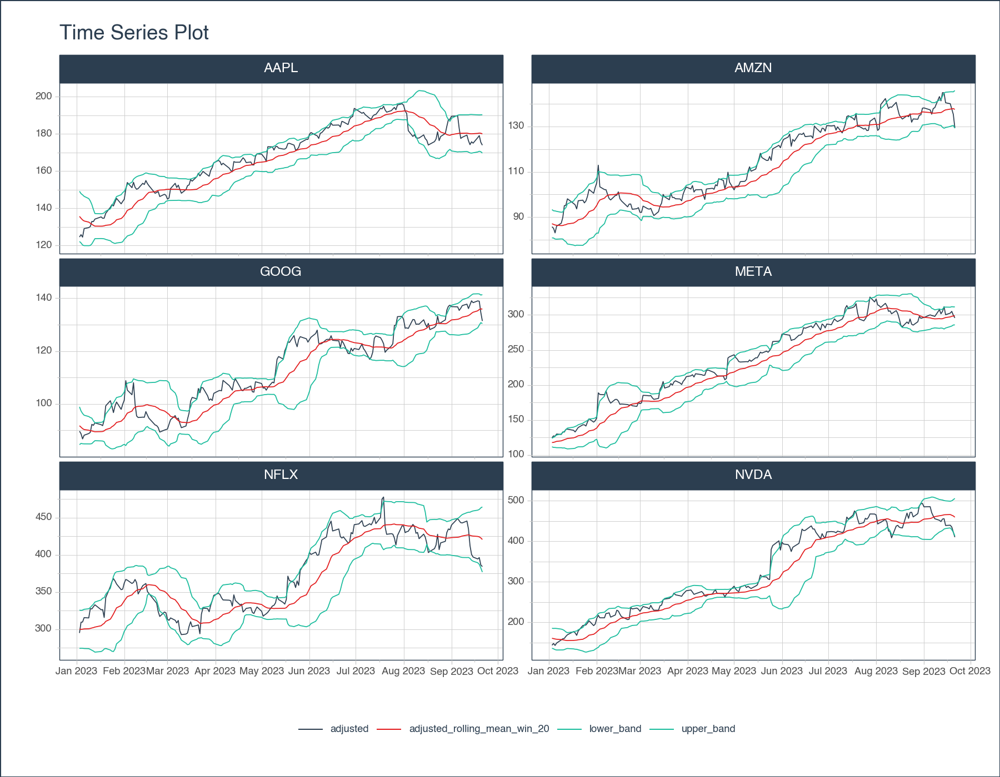

    <Figure Size: (900 x 700)>

# 4. Returns Analysis

In finance, **returns analysis** involves evaluating the gains or losses
made on an investment relative to the amount of money invested. It’s a
critical aspect of investment and portfolio management:

-   **Performance:** Returns analysis determines the performance and the
    risk-reward profile of financial assets, portfolios, or investment
    strategies.
-   **Informed Decision Making:** Returns analysis allows investors,
    analysts, and portfolio managers to make informed decisions
    regarding asset allocation, risk management, and investment
    strategy.

## 4.1 Returns Analysis By Time

> **Returns are NOT static (so analyze them by time)**
>
> 1.  We can use rolling window calculations with `tk.augment_rolling()`
>     to compute many rolling features at scale such as rolling mean,
>     std, range (spread).
> 2.  We can expand our `tk.augment_rolling_apply()` rolling
>     calculations to Rolling Correlation and Rolling Regression (to
>     make comparisons over time)

### Application: Descriptive Statistic Analysis

Many traders compute descriptive statistics like mean, median, mode,
skewness, kurtosis, and standard deviation to understand the central
tendency, spread, and shape of the return distribution.

#### Step 1: Returns

Use this code to get the `pct_change()` in wide format. **Click expand
to get the code.**

In [9]:
returns_wide_df = stocks_df[['symbol', 'date', 'adjusted']] \
    .pivot(index = 'date', columns = 'symbol', values = 'adjusted') \
    .pct_change() \
    .reset_index() \
    [1:]

returns_wide_df

2698 rows × 7 columns

#### Step 2: Descriptive Stats

Use this code to get standard statistics with the `describe()` method.
**Click expand to get the code.**

In [10]:
returns_wide_df.describe()

#### Step 3: Correlation

And run a correlation with `corr()`. **Click expand to get the code.**

In [11]:
corr_table_df = returns_wide_df.drop('date', axis=1).corr()
corr_table_df

The problem is that the stock market is constantly changing. And these
descriptive statistics aren’t representative of the most recent
fluctuations. This is where `pytimetk` comes into play with rolling
descriptive statistics.

### Application: 90-Day Rolling Descriptive Statistics Analysis with `tk.augment_rolling()`

Let’s compute and visualize the 90-day rolling statistics.

> **Getting More Info: `tk.augment_rolling()`**
>
> -   Click here to see our [Augmenting
>     Guide](/guides/05_augmenting.html)
> -   Use `help(tk.augment_rolling)` to review additional helpful
>     documentation.

#### Step 1: Long Format Pt.1

Use this code to get the date `melt()` into long format. **Click expand
to get the code.**

In [12]:
returns_long_df = returns_wide_df \
    .melt(id_vars='date', value_name='returns') 

returns_long_df

16188 rows × 3 columns

#### Step 2: Augment Rolling Statistic

Let’s add multiple columns of rolling statistics. **Click to expand the
code.**

In [13]:
rolling_stats_df = returns_long_df \
    .groupby('symbol') \
    .augment_rolling(
        date_column = 'date',
        value_column = 'returns',
        window = [90],
        window_func = [
            'mean', 
            'std', 
            'min',
            ('q25', lambda x: np.quantile(x, 0.25)),
            'median',
            ('q75', lambda x: np.quantile(x, 0.75)),
            'max'
        ],
        threads = 1 # Change to -1 to use all threads
    ) \
    .dropna()

rolling_stats_df

15654 rows × 10 columns

#### Step 3: Long Format Pt.2

Finally, we can `.melt()` each of the rolling statistics for a Long
Format Analysis. **Click to expand the code.**

In [14]:
rolling_stats_long_df = rolling_stats_df \
    .melt(
        id_vars = ["symbol", "date"],
        var_name = "statistic_type"
    )

rolling_stats_long_df

125232 rows × 4 columns

With the data formatted properly we can evaluate the 90-Day Rolling
Statistics using `.plot_timeseries()`.

## Plotly

``` python
rolling_stats_long_df \
    .groupby(['symbol', 'statistic_type']) \
    .plot_timeseries(
        date_column = 'date',
        value_column = 'value',
        facet_ncol = 6,
        width = 1500,
        height = 1000,
        title = "90-Day Rolling Statistics"
    )
```

<div>                            <div id="87e311a7-d87e-412c-b922-0936226420e6" class="plotly-graph-div" style="height:1000px; width:1500px;"></div>            <script type="text/javascript">                require(["plotly"], function(Plotly) {                    window.PLOTLYENV=window.PLOTLYENV || {};                                    if (document.getElementById("87e311a7-d87e-412c-b922-0936226420e6")) {                    Plotly.newPlot(                        "87e311a7-d87e-412c-b922-0936226420e6",                        [{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.003907556186035777,-0.023925696822560738,-0.03381707139458656,0.01336112991091376,-0.0030372325147233203,0.022319520068901255,-0.007383009066401769,0.003843931101489284,0.0017898359036798706,0.006808018354399703,-0.008334239096029705,0.007951141426865815,0.014900617099969482,-0.004096565346478176,0.002201272785457231,-0.0031286119440873117,-0.009347569532530353,-0.014939959310702244,0.007640344943606436,-0.006609132383549765,-0.002939266938994156,-0.01236307066294895,0.008723329901409116,-0.013556421533104324,0.004534190732928378,-0.0005321251677594674,-0.02031183986145957,-0.014562687260371687,-0.008012831761343153,-0.02650525756156419,0.00022371451946257004,-0.01132580640645775,-0.010777024436736782,0.006983844180201482,0.03200257489482228,0.022652680696538807,0.005519897757702008,-0.008032426563802986,-0.005677628097098375,0.017588053800638548,-0.003835579158670832,0.015592154072460396,-0.0018255931465872566,0.002180594184836737,0.006457008958393073,0.0002555065271929724,0.0033699780724181227,-0.015772824082997072,0.0032002047852759397,-0.017170539306284982,0.05136188812576692,-0.004563138895901764,0.005678605708483886,0.01541979052953013,0.01234955776923874,-0.0017427106579892548,0.009170392666136173,0.012832040642786868,0.014939082692740913,-0.0089468090180298,-0.0005800198710755877,-0.001991638812933294,-0.014229654353847265,0.0284077267961218,0.04752274389813582,0.018240172489219386,-0.0011834631130777096,0.008877026989576375,0.01076973865333497,-0.013136900598968548,0.002574975790525791,0.0011942854334268116,-0.003856951113693663,0.0038920982418015893,-0.02859055038934022,0.004728234092080008,0.001629471190352394,-0.00911135125959428,0.0027912883218912388,0.020692999659269518,-0.006857996121988896,0.0059562136902784335,0.015956128430667516,-0.022778260779421022,-0.05444375056288531,0.01064780701019874,-0.016480297872472627,-0.031791770373420625,0.01155256786454717,0.020556892555346096,0.01639835714864657,-0.010353481254583685,0.04969933019020756,-0.0031384447761432233,-0.015477766295249884,0.009739730381165046,-0.007136706506822854,-0.01242868988396617,0.023513171295835855,0.0032793315831858294,-0.012562534873535314,-0.0007856496686036163,0.009771556160826034,-0.013962034727437511,0.011747484245120843,0.006268204213914386,0.006473920823130808,0.006554338333119469,0.005322141446895801,0.004872706755808975,0.0067653496915376365,0.008701454736369962,0.024504454997446246,-0.002857978872552569,0.009791002626400758,0.013238855891672063,-0.01118607815644268,0.007453132442399646,-0.024911196006947023,0.015909110020018824,-0.0041913736952450265,-0.0051078781859265066,0.012922156410150265,-0.0024676792337624542,-0.0028328212710464484,-0.016183201185725582,0.0157465284702476,-0.0029004511137601385,0.0018497894109343882,0.0011916845548041177,0.014463614852034734,-0.006002516147506798,-0.012113915022049615,0.0017738668196933816,-0.008757493119731508,0.011922205846705225,-0.002571404423184487,0.0075799594785133095,0.018444109931694985,0.023547000475383717,0.018518275019645314,-0.008704206746982801,0.027375155257841177,-0.0023309194455596316,0.0051328324580128815,-0.013875902756411929,0.01144590197557549,-0.0015538240483029542,-0.007408581932810354,-0.0014605667566899294,-0.010900215254071588,0.005537602003043762,-0.004502609562389903,-0.007603697042138258,-0.011456427808554603,0.008375147802312854,0.038377258472495734,-0.004244382433445271,-0.006641541722475441,-0.006756720308590092,-0.009944749100785244,0.011721910635338562,-0.014063637607743651,-0.02196599106639663,0.005453287975484278,-0.007151979108669049,0.006332914188201588,-0.012769710200834838,-0.006672909290025952,0.005235217795608094,0.019898239316462618,0.02007743304942844,-0.005580419881161314,-0.024501743726820346,0.015536810892848418,0.0044434324665409974,0.008467752922038274,-0.0181775601568831,0.008112710514749821,-0.07992703730709738,-0.01135289785454796,-0.0019368903594312314,0.0016407113080292302,0.0018576868019775095,0.014475547014185741,0.007469031490293876,0.005828667096230644,0.013990100188714383,0.017914951807048052,0.013176305103669073,-7.51483248524476e-05,0.015879492749052204,-0.0008084395849699,0.0036767182679746657,-0.01578809265020753,-0.011574894412794023,-0.01110802305061942,0.004378857780382495,-0.010406719763688566,-0.009021478994789556,0.019947535524453608,-0.0027096792382962365,0.002888156672961273,0.006593883080268315,0.002108164227120346,-0.0030242172528970324,-0.0005840718834563274,0.0009051222348253063,0.009737866964038666,0.0009699231326327773,-0.011107018896639342,-0.011231428489048567,0.0039071653186548705,0.008847062173292564,-0.0002632277342112799,-0.004819371741158429,0.007887405978528994,0.011860240169154102,0.010756876664306025,-0.00955959335470169,-0.0042979570307370984,-0.001116540347467665,-0.00022337744671807602,0.009147451688763741,0.001661688003925521,-0.006930104181737673,-0.012936420681167293,-0.015700912814414214,-5.7070655666735526e-05,0.01314363689992537,-0.012897745485994316,-0.007392817831209042,0.003983770693837707,-0.007130718242035483,0.002027010933552953,0.011425639775586305,0.011868212029935599,0.0009974650656674466,-0.013071276176844782,0.08198197024974818,0.007344647993192455,0.0387278819264103,-0.0029630413826171598,-0.003781274177907412,0.0023557152587336816,0.001859714788520872,0.014141335384485476,-0.010899150754209774,-0.003499651031948603,-0.0017819035054276178,-0.004167071949239931,0.012449895428355617,0.0015686367600078466,0.0001855553092062756,-0.008503276843641605,0.014758250748396762,0.01184891197932414,0.00019864418628556813,0.0026460077962056072,0.0015831570577897747,0.011296318028385377,0.018726114599782795,-0.0025898276162213962,0.01822116221878667,-0.0037456232203840756,-0.006872509751976841,0.014141765490273128,0.011418682379326972,0.003923672400681255,-0.002749864179005912,0.016001389156974133,0.005869890676392098,-0.004138061165750773,-0.01672674469533475,-0.010943920344211877,0.010079100899059501,-0.001301838610589412,0.0010863263211184915,-0.0034716704551609467,-0.010341962453264464,-0.0008797354650862399,-0.006055552250266549,0.000886350356766874,0.005976092965925384,0.011881088364289027,0.010328283736381172,0.006349064886729483,-0.00042800499421835614,0.0058837055755827095,0.020631906795104404,-0.0064603755694208065,0.0004193400269156822,-0.0036693534368856806,0.0018939994874485055,0.012917773178046765,-0.011716015102933852,-0.0056651259285911415,-0.017830782960004288,0.014394663386042117,-0.005188737352958772,0.00830306536098635,0.026076767089675545,-0.001646399961953815,0.006595840458100799,0.013822138485449553,-0.006463370776183197,-0.0023375106136361845,-0.025980926277871852,0.005544107431235457,-0.0056173900826707035,-0.004916986089211317,-0.0016819580151775648,-0.00010585363355730681,0.002751852453730219,0.013193901847108114,-0.0002084880926223054,0.013233336759866487,0.0026739220814797626,0.004923151869357989,0.012043111212825863,0.013816214296244578,0.0003978050819726242,9.945422581014718e-05,0.007357265930132639,0.002171375025027622,-0.0064015069619705045,0.012290752545600414,0.0011749700000536212,0.0024450858957127952,0.007804690086797628,-0.04220680879490035,-0.008287870435493394,0.008662684424122657,-0.0061634888413252265,-0.0037617033377914666,0.030717272308592003,0.004257309129751974,0.002267799979485341,-0.00029516360557058086,-0.007576420315943411,0.007138504152776504,0.002067435981314203,-0.008154167867299278,0.0009905311052000876,0.015634278626004416,-0.008671081832147931,-0.03813266363289525,0.02942671417152476,-0.006352171581096244,0.00639277961408502,-0.015583193278451923,0.0072594241022947426,-0.0028024539121311864,0.0,-0.008733398489206401,0.02075998306685567,0.0021818971318658953,-0.0028705638951592727,-0.009133388910949836,-0.010620109816421919,-0.012252722851347708,-0.013123221097698923,0.014647813924672626,0.02139890522317911,0.027165012534000166,0.005074559127548728,0.01786576661332706,0.0037203609046103647,-0.0010451618973167376,0.015507092682824464,0.005621282368705627,-0.0033535816136949226,0.009534186456470417,0.012963247776853093,-0.007312672402341125,0.002394061047179097,0.002859996425299105,0.0028519967853661843,-0.0016511576843875053,0.007993898773513086,0.014129760992402485,0.014112082424281525,0.012054733005597562,-0.0016640628255657486,0.012983284217584767,-0.006927911229088202,0.014301808313606168,0.001375619099948544,0.018545748469472434,-0.008682671358270277,0.011905012650238689,-0.0005884657003247806,-0.032456026779467795,-0.0038236622341696336,0.011340664425933955,-0.0037952975491690744,-0.004242685283332381,-0.022608797473193443,0.01530234258336427,-0.019014992423793342,-0.0029475746547964476,-0.016932600708801537,-0.013669545132483307,-0.013674958645752855,0.024917910959504797,0.029613509259001303,-0.007722824301836906,0.010377392972997557,-0.0035417023715906826,-0.004709607128094873,0.01767719158366332,-0.0007018455648534205,-0.012202711075920747,-0.019018795028479363,-0.009512541986942513,-0.02817180700082822,9.413165629967857e-05,0.014022294045703543,0.03842245935654609,0.001072260873653308,-0.024640447832116497,0.008878635303181115,-0.0038107410460713753,-0.027140108437639032,-0.007770040584935467,0.02575728153624479,0.007634092799307934,0.026015579697955316,0.005160000687616018,0.0010622175930026234,-0.03501350239334278,0.05653320376476745,0.031133518187282938,-0.014634101991355952,0.012546992191004858,0.00016854470721883175,0.007669392962518229,0.007137583732551578,-0.008420972418129113,0.006642671143828549,0.01921154733841912,0.023438632915490976,0.012652284226911226,0.004902760059417588,0.005901617382220392,0.006962299015855766,-0.0020976113143228448,0.008174619649858883,0.027026917319539656,-0.006240580481399638,-0.02557331165472565,0.012656443729894162,-0.015028271336965715,0.004904045628091103,0.0020919275084823052,-0.0063391027717344395,-0.016570560279689506,0.0015029933774122206,0.004265406303205932,-0.020685824184031754,-0.01823174751771839,0.018079393857844517,-0.006910219939442963,0.01100372484740153,0.016727064129606894,0.011255824339839293,-0.007550217808324322,-0.012549093511444176,0.010405252783222796,-0.004087661003596588,-0.026126771478385047,0.0069702853217676886,-0.007968330042340988,0.025314115074290378,-0.015351773227225696,-0.0014464390330853893,0.008611845909473725,0.016198274286773007,-0.010522190885676741,-0.0032536472243577252,0.0076431542210528836,0.004267023561647321,-0.0019669851741336286,-0.004335869290962302,0.0038005977738282404,-0.004811806420289444,-0.011254551695460413,0.022845717614759398,-0.0054073994880908804,0.013474048792428306,0.008163615616075592,0.004704041425693806,0.01819182017576848,-0.01575596864107731,-0.014705840333547937,-0.02712970146967597,0.03036332034592837,-0.0019387000991506476,-0.022532894975214934,-0.006279977829346306,0.006185513032291645,0.018840692833629102,-0.01018658872994338,-0.0035624157320043315,0.001112430471418735,0.023331329020330305,-0.0013957593586982897,0.011027400615013283,-0.0009213624568698009,-7.731080938189194e-05,0.010225940294821712,0.008752718215514044,-0.022031245351683437,0.018670153542430956,-0.001969093531495103,-0.011382716185433184,0.0019956301318957426,-0.004442789528521507,0.0012308088509351833,-0.005840598907474237,-0.005488716293467255,-0.0066070068057969555,-0.00297347766010414,0.011458520594107569,-0.0022503336684702724,-0.011042968793345764,-0.001965758828851749,0.005357610898161669,-0.0023510538783787505,0.004556396365229531,-0.010009399203642633,0.00797786528029687,-0.0045452605649669575,0.00850199743600788,-0.004761420512201631,-0.005882541086634441,-0.017514708943603963,0.007227107762920237,0.009328082674319393,-0.0012640084319692768,-0.0034798381800457134,-0.002460247222849099,-0.024823025191410553,-0.020396565363270724,0.02673442302112794,0.019305543408485226,-0.00039783576270036036,0.009632922534323685,0.01332599665189016,0.008637386085954546,0.01890152339984974,-0.009994553202806289,-0.04229464990791931,-0.0004790669326966146,-0.0052732739118045435,-0.01389556694664551,0.004968660808780223,-0.003160886956239839,-0.005041190592550815,-0.008743933343834942,-0.023577895838370777,-0.03208392076390054,0.00662963129083427,0.0021758367906570264,0.0033876047045962032,0.03635750211037769,-0.052038015729499065,0.015419623224491197,-0.00078077859489456,0.007034322999878606,0.010348325765866306,-0.005633215958525839,-0.01278971991441924,-0.020519885828811035,-0.06116292055859296,-0.02496210301146151,0.006011964917883361,0.05735525981044298,0.029446532721498553,0.003276675623851144,-0.004678130801293978,-0.044697005781097365,0.04288910852786043,-0.01753592624434852,-0.009966516561843108,0.027821077744176304,-0.019232709278794946,0.0219701641140837,0.014568716880116295,0.009631420244623712,0.008411762253294652,0.0011182989076872207,-0.021390011000820608,-0.004125685323935646,0.01551352159096031,-0.015710464338716035,0.008113025423441833,0.005948289932814932,-0.0025219037628952945,-0.019789092881329795,-0.030060373558825404,0.011369890325631848,-0.006527729304561358,0.007300604259616428,0.003623845865247999,0.004784429069183194,-0.004761647305398187,-0.01155443527629274,0.023926908687825543,-0.004637889367893222,0.0017027165891201346,-0.014133983107339598,0.01497152009776559,-0.007330706999468695,0.006214074385711532,0.018258307786191086,-8.769349917803204e-05,0.015295176198118599,0.03099586307512192,-0.03191139520965569,-0.006332500573259292,0.04120480032332052,0.010564374077925098,-0.008545643653388946,0.014058579877911148,0.011470524341857136,-0.0046507647419080644,-0.004609594719703014,0.0011580122250540725,-0.004047697975045006,-0.0315170895674477,-0.005652094075088265,-0.0033589664762890825,-0.029208456238520975,0.01637900065693887,-0.004291595709972618,0.03166496394845697,0.01270380605415733,0.004377854841263407,-0.012992625261225021,0.009596803472646798,-0.007150235196582866,-0.0018641079553141093,0.004159504874636122,-0.00811490014917593,-0.009033912441989367,-0.009287641582930384,0.03324648000648045,-0.006300919920386616,-0.0004226399735759445,-0.022075622744374246,0.004756793255102476,-0.02573808130451949,-0.0061849147533288296,-0.017691914021756516,0.007692882205430296,-0.021196201805647297,-0.027069146903100028,0.012260718459315534,-0.0009318287353368149,0.012869591279314196,-0.005340295706680154,-0.011200675680177574,0.017974262935814833,-0.013058701506290182,-0.019194656371870455,0.0008548996995605407,-0.02505905383889273,-0.019570198768259828,-0.04220440704215178,0.00528789062720314,0.0161918738693545,0.014513479399088425,-0.025710160148778916,0.021870618071251346,-0.024015080224066954,-0.00483899666580645,0.0013449246390226932,-0.005062569180360521,0.053167252011088406,-0.01952287699440447,0.005531367180487301,-0.06570676789401919,0.007171692937729679,0.0345414226842089,-0.009348447723306341,-0.02022215845940245,0.01979268250876176,0.008034880240327169,-0.026707986329112088,0.010529917798928867,-0.00021070986093219002,-0.007579792617799508,-0.0060463237726292585,0.0030948549912477308,0.028194459414232043,0.015314895967238007,-0.018956493588244805,-0.0022852890237290424,0.008745974119086064,-0.022605169557029958,0.014890700114413846,0.006867888429208824,0.0015501508512969497,-0.0022700471368914954,0.03971453614059883,0.0021882216755417794,0.007444711413535865,0.01487633168690472,-0.01106663293159671,-0.008245934824323342,0.0008906652024933681,0.0004946572245225767,0.010773736476982876,0.0025428260404334324,0.02009338262966165,0.013291476515436162,-0.0016042635406819938,0.0011339863976709275,-9.430668944099274e-05,0.007647814920128226,-0.005528313261516815,-0.004334151053779989,-0.004542707452696693,0.023671760409820664,0.017459037766200503,-0.005202660714661578,0.009175261361750398,0.010273521887086412,-0.011789005323416868,0.010472673850949299,-0.021809594706282076,0.0011055898934850816,0.0033130301359569625,0.01302526346781252,0.014487566031925025,0.0005352290128597392,-0.020071266782768937,-0.021574855155500172,-0.005303189658617535,0.0020576362386905966,-0.010827902986875082,-0.002736823484350892,-0.005677395124976559,-0.006947025052336908,-0.06257779197352353,-0.030566558526102128,-0.011494207470339468,-0.0010667574560468962,0.016445857204626435,-0.010401147642877806,-0.004059109399759286,-0.005576891677965712,0.0007550966795017988,0.006789137451411298,-0.009740757200751071,-0.02345719976424565,0.001992517162060725,0.03711941786050654,-0.004154417528876464,0.011445294682686402,-0.0038075388674591037,0.010828088526443791,0.012707722724891513,0.015244034279085827,0.01756876855680245,0.007930253897023398,-0.0005977279416635728,-0.004882880295022485,-0.014019412105526707,-0.007515878628656658,0.0020465113758720843,0.0072509493450021445,0.004055594511684912,-0.0009087519319437298,0.007176112028095094,-0.008228925365946771,-0.015076446275802624,0.0012329044474828077,-0.003283526921176949,0.0042207770914395315,-0.0227574670805214,-0.00241278247021548,0.008517450633873658,-0.0037533423716977765,0.005755869628410126,-0.0280953189018609,-0.014561460249242097,0.01684066527014716,0.008654694835348975,0.012711792730361271,0.0030335107259022998,-0.009385615613931586,0.005684671741890357,0.004292084133059149,0.00771312045434791,0.0031028310755503163,0.0045370037961363074,-0.00564572538178032,0.01982038753354942,-0.00010125496695811975,0.010629749058250093,0.00040071759529003437,0.0009011913073064814,-0.00530237509753495,-0.00774370322760809,-0.01337957335711859,-0.006883015260135461,0.06496310657275739,0.01350170393704131,-0.001245584293458002,0.01765666889581574,-0.01480452979181579,0.012538454618482131,0.006177516614388923,0.015207156239319453,0.008280786926656125,0.004059992451964867,-0.007444154096636901,-0.0006481242874709636,0.0023163397257599527,0.012017054747107458,-0.000913418083077322,-0.0014628652733736924,-0.0012817693178389655,0.002566904159682304,-0.00777264883637141,0.0031334751352551926,-0.007533198153487963,-0.004258256585154108,-0.00585651279719368,-0.0011222590588523262,-0.00767643611833102,0.0009434058940200885,0.0059378087882391295,0.00936945558558544,-0.00027858374653677576,0.006127876002029353,-0.026208466005780195,-0.02264997881484976,0.022398970079382297,0.023805002709371248,0.0353865531875448,0.033998746001000724,-0.005624425196262828,-0.011660347864132503,-8.803008875690743e-05,-0.0001760756774711325,0.009423374531668749,-0.016663840323733914,0.0015082817503602186,0.0018603141582023142,0.00760433503054303,-0.015532973463895705,0.00775573719226097,-0.004688558105691465,0.004265981652256556,0.0004427737180880964,0.0074300652532859335,0.0014927270111622093,0.017446717021044833,0.0021543372266366045,0.008942496902558217,-0.003068024844079309,0.005556702991938778,-0.0006802033880186631,-0.0006805263679990903,-0.002979584316708972,-0.0005122862631184999,-0.0039297753966156534,0.009005521528030913,0.005099573782314071,-0.02249465398878414,-0.009602919704495672,-0.006638624093346701,-0.001582880060183478,-0.01805527772221094,0.0008970243635890718,-0.010718805216411442,-0.00901398665516695,0.014424844636771628,0.005887019297078355,-0.0016205481644413489,-0.02786804871529447,0.005937447733734835,-0.025085380629871867,0.01324372468381374,0.02688825906642056,-0.0003636168750983382,0.0010003287517821313,0.015173823677553377,0.0006266578276064028,-0.005098731629543107,0.005034768698521708,-0.0019679473081393173,-0.0009859505712659367,-0.008433657592150201,-0.009319437009850828,0.003744671979850178,-0.007188374400676989,0.007698514300344073,0.009822641578276947,0.009817277573813898,0.01632171895623946,-0.005704203918967421,0.016681330789368287,0.0,0.005469304663888064,0.0012949434223037404,0.005777527424688289,0.0026576641740931883,0.0009405244142917102,-0.006577694434452774,0.001977756783648754,0.006350871268627767,-0.00426414504949546,-0.0002569177055566918,-0.007795640703080475,0.0028491724209496194,-0.0011194153467255497,0.005085671861011276,0.01114795713111616,0.00915966356796516,0.0010086863305456273,0.005373162643490748,-0.004175342079142719,-0.0017612834149701717,0.008064588788022187,-8.337245539191684e-05,-0.0017500805307243406,0.0018366742655355761,0.0006666385119749041,-0.0009160087789573668,0.01592061394394695,0.0004924514401971614,8.191175042893128e-05,-0.0026241838196189304,-0.002301865684451121,0.060980583406585964,-0.0017085861333695496,0.0042787441415852445,0.00937437504642058,0.009517110407843532,0.0038773330850154775,0.007226194163277411,-0.002265477577706343,0.008855492188286629,0.012979160088315123,0.003628887480277898,-0.0011803305827978727,0.0027332481795609986,0.007221003935955483,0.002999351254701077,-0.0042299485302554896,0.0009521481517924535,0.0019751985025879826,0.0004386365974373696,0.020439310695136603,-0.00593748017302187,0.0059009063074053625,-0.0031479331461066185,0.001291862832037971,-0.0037270902847452714,-0.0023018586467604685,0.003316563395607819,0.0004313180745239009,-0.0015086696089686713,0.010576409322817781,0.0016375574996487785,-0.004975445507196419,0.010501205213846898,-0.011452282463740748,0.011298267835216036,-0.003535446462086478,-0.0019865829581471317,0.0017060589262112291,0.020726924831076188,0.0022250231374061347,-0.00131813563221983,-0.0018757137714476846,0.0002782712275153365,0.0074459958527337555,-0.005180397196819508,-0.0024996524644234075,-0.002227531669524052,-0.0011858616986802906,-0.010756485258258452,0.0012002944618043632,-0.005289129173545071,0.005529702501080758,-0.004441966595013391,-0.0036826301188662702,0.012510830056309263,-0.0011935833563108122,0.00962963752403767,0.006195915698862242,-0.005881279309384868,0.0007655934779198237,-0.0009735225893297006,0.020397047667602086,0.006344258351093535,-0.0030508346441654455,-0.003603624577817155,0.016583663233039392,0.027188589399567364,0.006404661717442028,-0.004740741462255671,0.00864848936797169,0.013965473800024109,-0.0025622823180780907,-0.001477456842941316,-0.033575508943182175,0.015241650230154447,0.0034088958066409436,0.006076044221313692,-0.0012340608816722165,-0.002991101228396631,0.003456762096284871,-0.001689609849121143,0.00039035034498380305,-0.005921754359086817,0.0027493577799109215,0.014818990304047652,-0.009777887147468967,0.003378008484417938,0.005957132237991658,-0.0024460948905492552,-0.038776738021834456,-0.02389562458837713,0.00804516143078926,-0.009754806238556957,-0.0059935348925651555,-0.013999322134295777,0.028607531257746288,-0.009088784880820766,0.005930987579412461,-0.0016452529260535531,0.004463361922872444,-0.003144535063341891,-0.014332780570788128,0.014610783340557543,-0.014743418381224616,0.002366555514722979,-0.0036107863618068947,0.004111308565158289,-0.009438386693948142,0.010159103355183108,0.006103079715714443,0.0032404916960093733,0.0014429177262436088,0.0139286646133443,0.008594616486940154,0.003489276811457387,0.0034767098437298305,0.0062633339536011245,-0.004502745555580168,-0.00046558429208665153,0.01211147850323857,0.004273888414296989,0.004713755965144895,-0.018897230077243865,-0.007040635901408909,-0.005150420897004904,0.0088753772581176,0.04725068749855277,-0.009991072664788936,0.005271125597443804,0.015473917534870818,0.007996733256354194,0.00612189009058528,-0.03185159190920328,0.013907057687559954,0.015049134907870076,0.010948220136432596,-0.00402275199271096,-0.01919828741179541,-0.002280479864845253,-0.0018412664249159993,0.016347452156401765,0.0012515967601205435,-0.004437841857023228,0.0037042614492284187,0.010071501081611478,0.008918179672904536,0.002700708057270962,0.0039790624228353,0.0003049217346180466,-0.012008597906875251,-0.0010487356748045684,-0.004014751254135307,-0.016309077355088242,0.018092583679104157,-0.003962754851172479,-0.0075224013611688845,-0.00858120579374233,0.010108687033496322,-0.007568310228593944,0.00037825873570263013,-0.01675772961843247,-0.017171834825079335,-0.009779023816251953,-0.008822308349446306,0.017203624402949647,0.007117359172805315,-0.006159152888137953,0.005479938283165842,-0.002011456107221643,0.004356248581135702,-0.006473628293086953,0.012444885805264372,-0.0005793124063406818,0.0034770560952830376,0.00038543907883159534,0.004169001682456486,-0.003513138109634939,0.006346274526188411,0.01840850292365004,0.0036903314146428112,-0.004424592798075944,-0.023660623627398736,0.0017309492671357951,-0.000511742280625449,0.005955053189313553,-0.004391850991056767,0.006393437046033901,0.0358296168786052,0.022508606301838485,0.01391552281964148,-0.01271898335389754,0.007310302802655988,0.02611378610069437,0.010144881744772904,0.0032138257808675963,0.008180353957427444,-0.002042741568414441,-0.0033095598472072663,-0.0040074291884143465,-0.01511750385556554,-0.013190173691641216,0.011946921042257808,-0.005552332839706797,-0.0009990161376907114,0.018590156847278605,0.010511892952352886,5.7014617018902314e-05,-0.005029157768042802,-0.005859178293195932,-0.02074288911004374,0.013983797754719252,-0.004655341644442923,-0.007307733435334751,-0.0009423281684183271,-0.0037135903423092254,0.0018344437189348195,0.00029485422275876694,0.019484043031460008,-0.005617390288277013,0.0033194197458688013,-0.00029017936489816876,0.010161565095306857,0.014082807053686475,-0.010656532933703278,-0.0010883774893474252,0.003785373028019956,0.0,-0.025369782431198695,0.0001761073695643045,0.0028134433168252038,-0.010813763999962367,0.017904449925247423,-0.00017391190459281614,0.004644976014415381,0.011385286013807727,-0.003714403137794031,-0.00011461304279791751,-0.00022962212277888305,0.005680199576728828,0.010326180994604917,-0.00508188297118306,0.016516036670717993,0.0008933966122190995,-0.004462546344766283,-0.00818137603446778,0.0002261583857099403,-0.015928454714422835,-0.01785097847108308,0.002337548392054689,-0.020698535401739937,-0.005894271734629308,0.0027547377155172637,0.0020907443895101796,-0.04339025885567094,-0.024984304045966632,0.0417917687014584,-0.021407455432765565,-0.027516164395572362,0.012231203471606333,0.04027881616517259,0.010017777883870593,0.018437538942574605,0.033578482092735396,-0.003237589287453657,-0.003363617087699722,-0.004538655057452545,0.00835913370786101,0.017391279266994353,0.019772053879105078,-0.0032407017141093952,-0.0015137415796157017,-0.017516280835010334,0.00691439963711149,0.003461604111261618,-0.0008482330837407126,-0.009282705865017449,0.010912298967135081,0.01718091990954318,0.00966772689770612,-0.009630180949648182,-0.008501433790365609,0.0011770149117338313,-0.0035266240123790205,-0.015278962713582533,-0.00034241821972558206,-0.02265451099117688,-0.01412968581570917,-0.02315682614035175,0.047471688713045745,-0.025640897015219544,-0.011048883070119087,0.007808615130340257,-0.006556390033797377,0.010259183425078922,0.01912240596825554,0.006934455525623884,-0.025578760141363954,0.009917878441410899,0.018818040802419667,-0.004675306676884428,0.009858603563364099,0.003387729446158616,0.00623847399744859,0.013764120176939176,-0.0022442941765050684,-0.02833987270693228,-0.04097227059735953,-0.002896443921893699,-0.013919073289499817,0.004357475304143099,0.003482781796443124,-0.01156972970669623,0.01811208654345653,0.02323634744768155,0.04417505100362895,0.0018121257536738433,0.03923347167051672,0.007235074303372224,0.0048065921355373575,0.00704116973375335,0.014303911431907457,-0.0038033192266342386,-0.002333058317302017,-0.009088339753483887,0.009332570576123134,-0.006323602178821552,-0.0036364948434040034,0.007085084516769591,-0.0025051051775213384,0.006411369119843524,-0.0011147337103775135,0.0022854897572737176,-0.0036060883835018487,-0.0021287353059148417,-0.0033597953528032853,0.018033986368013233,0.008357760700354877,0.00771507432409968,0.0034660786540483546,-0.002680583756188293,-0.009097639212044983,-0.0024517526733084383,0.005490769389106864,-0.00821728727661264,0.0005244956047503191,-0.010272579656652181,-0.0005295769801734185,-0.01615985146707022,0.004362298137699394,-0.005576360510918366,-0.0029117472310987713,-0.014871263789830391,0.012405950467999638,-0.0014641778359711921,0.007276322092783172,-0.002102150010769299,0.01118248487629625,-0.017416631133851945,0.008047058034005516,0.013861838490747846,0.013885126322021657,-0.0012065291498598585,-0.012976238982119637,0.0167661041543683,0.0015703499713599633,-0.0021951098244304967,0.002828373274590179,-0.005484377336986035,0.007773187181403962,-0.0022931384325366455,0.0008882627139699117,0.0072540769294120455,0.009430139134232407,-0.0031310564560179666,-0.016631664061263263,-0.005602602492741027,0.002000717446415834,0.058910415422478435,0.02923077362527282,0.002893099332107907,0.005192371730400103,-0.00937466161011491,0.0006760051668810441,0.007864736013824203,-0.002978319751875791,0.006456628740507897,0.004213138716642639,0.0023361634007903476,0.014649818947977122,0.019970201465369763,-0.009743688690515673,-0.001949189596326284,4.645404838887757e-05,0.002046031675003279,0.0031091010408303976,0.008234749130366925,0.00807560074653324,0.014929405995693257,0.009193551959655766,0.011554180016353444,0.0032067341978085917,-0.006524619784390784,-0.016617309457412466,-0.008068139749586978,-0.013420901539762942,0.025282939864374132,-0.012418918281243085,0.024155052768911167,-0.011351180298274754,-0.02662598302991548,0.0016522291309457593,0.0005955588306343351,0.007602024687045406,-0.010771438245289033,0.014380176807288203,0.006340835341844375,-0.00796587805965343,0.020551661736980753,0.0035120209535639546,0.006733170496770136,0.008888540542276058,0.012168441144140285,-0.017580874183799056,-0.01622875930082035,-0.0023184030111536025,0.01385345951301642,-0.04632601882198606,-0.008828016960160667,0.03571937214783616,-0.02138568035897659,0.02203685497148067,-0.004321090184711496,-0.023373682519352124,0.015229978584260229,0.006110037632531595,0.009426741695117924,-0.03430180148925466,0.021898036220264983,-0.015923631053523457,-0.018769999938127446,0.004994270525051192,0.02606648523050059,0.015352362172338596,-0.06633077784140362,-0.028388361365419224,0.010814191698207853,0.030328225500954487,-0.0034890688288604643,-0.019281588516381953,-0.05037430847217339,-0.00999100475960324,-0.028247351480428007,0.024678798922792344,0.011075429376625756,-0.039631925566047,-0.04777797577017284,-0.0011298912989847754,-0.025398906730839665,0.013523790900422883,-0.0021759435673056604,0.038452542094115305,-0.007682174363333738,-0.005402440524387653,0.034942447310231994,-0.043988713926205736,-0.01114951288217525,-0.03565707014046482,0.006587985374397309,-0.005719293748899457,0.0027870757717041172,0.01094024187922571,-0.03199764620482104,-0.009306264633834216,0.012992642580449187,-0.031191712063737165,-0.025234705357776388,-0.03889564861834105,-0.02587401332289252,0.07042132902426479,-0.00648961407186488,0.0005123479516706553,0.009665297853122645,0.001141188051444919,-0.09960762463708683,0.042689234880342264,-0.002225599285683666,0.019063092441477192,0.016981790615138825,0.0031960693587025357,-0.009817904185546622,-0.015037232624592778,0.02046687498425559,0.012216215543422448,0.005938170477855165,0.006159308975752786,-0.022446084274134304,0.00404428266853496,-0.007926325596287254,0.03313695119670146,-0.00925444909373685,-0.010364504826574139,0.0683344269920938,0.007201095820182246,0.00048095872759801317,0.02840468447131883,0.017109384169714748,0.0003449177634562428,-0.01893960689834584,0.00117483023057674,-0.005750645843690894,0.008617263844711953,-0.004154795744590656,0.0036432750738171205,-0.0022250125509256646,0.0029926868829108777,0.006435227001779342,-0.005638505079819112,0.011165732076402257,0.007284636503008812,0.0005739070201666863,0.003097411019259866,-0.009835798807206309,0.010511172109133105,0.005029474355102037,-0.0018198536385655162,-0.005753847614273333,-0.011574926039194744,0.002377122001584686,0.034641980600234934,0.011235427828432565,0.004422251915958242,0.011116575751883628,0.013007973242176396,0.010208655378908249,-0.00792484064051202,0.0087385490140508,0.03683042221996313,-0.020708160618791105,-0.012091286473923102,-0.0103316260398153,0.008994000388644174,0.0013263209106084695,0.006517773552814132,0.006791414093243242,0.014536676652955993,0.006855014288545069,0.0017405662812786105,0.006694157551464963,0.015735797052450984,-0.002998335276471975,0.005614210367746342,-0.008324577270084621,-0.00040183992944398117,0.0018100002893584044,0.00010037830320985819,0.019473023162448255,0.0035938149368590633,0.003286494963977704,0.014423643623531657,-0.001542648289600379,-0.009075058200061714,-0.004773885968129998,0.0015175233671980148,-0.019256348066828077,0.049085773857669324,-0.0065078764439158165,0.01243138888466877,-0.015442634401754751,-0.026957167346897126,0.0001970083564117875,-0.010744112476470558,-0.01385342000867007,-0.0581193441093677,0.015830335154160435,0.011979036498310114,-0.004399669624718383,-0.005681845955768261,-0.03126970104653948,0.019170840504765474,-0.02047174118713435,-0.017069690494897483,-0.003840662850284615,-0.004134412354681816,-0.0047692104193308715,0.0051864390648233005,-0.0181154476012666,-0.010110168197857483,0.03658375784020418,0.01614318750631738,0.014682003657818798,0.02661674903184119,0.012779553774065144,0.011579666046562576,-0.0031826501670062513,-0.00020606895370500755,-0.007262406289667456,0.005966458992952672,0.023518872831628235,-0.002922865846472833,0.008035656654515222,-0.003409271338915887,-0.001005919452130799,-0.015157753791440909,0.021629022552164923,-0.0003003061704167642,-0.00911186587782542,0.01834110273706968,0.0058543484975479565,0.008286734885385894,-0.0008806774845182552,-0.02061380365380361,0.006099351689966337,0.00988857055880632,-0.007282222785834569,0.007682769521988098,0.009395011254678565,-0.0034597843334844836,-0.005623504004235946,0.011359635651541078,-0.01492761208516169,0.02285417693254921,0.007817702311271102,-0.0008140362011211932,-0.007907150079628278,0.003478068639993781,0.009338473615245313,-0.00429226325350518,0.02040419778669378,-0.021639107566535642,-0.02115814171268149,-0.05234790102182796,0.018930425964315045,0.01035537205410142,0.02205582273118778,-0.008240415193187078,-0.002537563693754352,0.04234846420554139,-0.029764968597012942,-0.0049817035754826655,0.023595156976757847,0.018643904515906806,4.7435375826632153e-05,0.010838394669113072,-0.0008462648804649087,-0.04622053452738806,0.018999358793609256,-0.011283970684895173,0.006710205658685853,0.01693196984172496,-0.0012916687590229792,-0.014563821538113308,0.016966636463757956,0.019551552354828416,-9.378812901217337e-05,0.004267208388667454,0.011812953307185126,0.031795128196551614,-0.002236165109803845,-0.019454052747155504,0.005257284411749552,0.003637944118878078,0.009379115892149015,-0.008124870944923979,-0.014618152405041829,0.004546943482378163,-0.004754821619949001,0.015389484155198252,-0.005157697539198258,-0.004866010792254127,0.0235351736701217,0.0027682412768248454,-0.02506767201965454,0.008494669551149414,0.028031613050959026,0.00022039279538788037,-0.01171493384594513,0.011720054608525876,0.013478432848940347,0.02659849783931345,-0.0014394894060074659,-0.0023317919751822958,-0.0040372542644148135,0.003882788830950723,0.0048029069763178,0.017342811915948886,-0.0022868714479227226,0.013418911313564319,0.001644806980820146,0.012316149499342899,0.0100172348280958,-0.02312797801599842,-0.00012336118407130225,0.022609612808341062,0.02838079821937045,0.0065673484536830085,-0.0014372092368644118,0.00042795770699122215,0.011541132842870505,0.0027369330649418266,0.00791889321652084,-0.0009154788587977247,0.009581389805478624,-0.006919238487502644,0.011879263459937395,0.005042022544019531,-0.0030320793953175773,-0.011641598764682959,-0.004483806827771941,-0.0008777565109527874,0.01753386540930202,-0.007808612422209538,0.013432308110602698,-0.0022029524070709128,-0.011562209295724046,-0.01783005491317735,0.00882612996034604,0.014671318680839374,0.019316212394938637,-0.014000339518431604,0.005844509124288244,0.008529798305762393,0.00254813408534571,0.01359299919976098,0.01711800312892242,0.0019652536536491905,-0.0023891337089306797,0.0010008851403224828,-0.0020712688532666945,0.016318285092798757,0.0009505127525566426,0.019840568062527986,-0.0003798352378330261,0.00593534561300646,0.0073064317654112365,0.02281647752544158,-0.009722112423453777,0.007967978311145263,-0.004702758294835907,0.01608629429064723,0.021240901602292084,0.0022606629789485577,0.02136419731058159,-0.0135031674882512,-0.004285428572371908,0.01252647655794692,0.011070902401599803,-0.006776905480787687,0.0035694874587177683,0.004815912085479601,-0.0028819895400116202,-0.02940540540540537,0.028289455031491162,0.02093236939843801,-0.001449205049541602,-0.04433874820240613,-0.002746191743615456,0.033013528260337655,0.008154619289539422,0.011696703205158254,-0.013592531120491746,0.004749440720247078,-0.006033313526731421,0.023747849411388744,-0.007121233712558905,0.000246413340943219,-0.01831057989009499,0.014483053746036756,-0.010259235660374455,-0.022634905694388863,-0.047500600661375514,-0.033872086998843476,0.015863767750739388,-0.06536839970131048,-0.0005850065124335391,0.09310085150175618,-0.03175917037388598,0.046384547408790056,-0.03243685917317074,-0.01328042967882237,-0.07909193097483314,0.07202132332266564,-0.034730303926526984,-0.09875469195846531,0.11980832006535835,-0.12864707398744657,0.04397029424214183,-0.024480040740412212,-0.007662053083805964,-0.06348560348814714,-0.021244127037136407,0.10032543422295004,-0.005508746691073374,0.0526229484544849,-0.041402240357839015,0.02853794396316811,-0.002040600359433653,-0.052617203179465166,0.016686657041663278,-0.014371354615696497,0.08723738801529768,-0.011582296535281422,0.025594642215577723,0.007216170885307571,0.01962752903666165,0.05050280656809458,-0.009126911859440479,0.007945834677481223,-0.013568698872577167,-0.020756723637187502,-0.030910479553814985,0.028803376023608385,-0.0038751295402383867,0.028869580216036805,0.0007067543124366082,-0.01620948180621451,0.03284511909744592,0.021096142056525657,-0.01609932983549267,0.014148718907669444,0.015008994175742973,0.010317291752868663,0.010344709811513031,0.023802081727854585,0.015735327428914037,-0.011428517790456949,-0.012073978492904147,0.006143296990399616,-0.005911920885599553,0.023561132759138737,-0.0057784629049522085,0.019448238653272387,-0.0074555035160772665,0.006438601747569939,-0.006773678005940975,0.004356822109287561,0.0004402010502595477,-0.0009740994201468123,0.01229805296573061,0.004629373534644099,0.005505102729381095,-0.008612374780420873,0.02848113917217665,0.005912664056405115,0.03157781647868263,0.0257274576990143,-0.048010320262283135,0.008633331646882292,0.012367405464956294,0.026502121113454846,-0.0013918296663577578,0.00039837163381495344,-0.005714621983038737,0.026163886902944355,0.021344624342209295,-0.01765211447740711,0.013275545741604056,-0.030725701978853714,0.0230468120133136,0.008347489434006983,-0.001891488183723422,0.0,0.026750281581011448,-0.0031028635611720645,0.023290167759961733,0.004300334422393304,0.001749142392819314,-0.00461321314388119,0.016548498807998246,0.00687732258556939,-0.01230485032586337,-0.0020203292150681174,0.021073960812006964,-0.013801721249644516,0.0028091307257356313,-0.04551646151173094,-0.002476993420274076,0.02370005870319125,-0.016427489301219955,0.019168278166832753,0.012100238981991973,0.10468866615400718,0.025197553275858597,0.006678260556519211,0.003624604939135301,0.03488915570673834,-0.0227357345314958,0.014534959925313728,-0.029739841756648788,0.033234094188868024,0.017697703928215125,-0.000891338189161206,-0.002610764328075943,0.008332763474992344,0.0012547317933497837,0.02218967522307569,0.05153243824808884,0.011960215843090705,-0.008203840291630682,0.013599261955606234,-0.01195447809784278,-0.001619818274656959,0.033912178043664865,0.039832326505847115,-0.020718166801196425,-0.0800608710322197,0.0006617111369364714,-0.06729495575028033,0.03988654868568986,-0.0326457631507322,-0.01312885079831616,0.030000082527551264,0.0015603274196336336,-0.029513649746204962,-0.015963589773571596,-0.031720270812210516,0.030325838368919333,0.01571565589821855,-0.0419459918028271,0.01026883033411563,0.03751629880373408,0.023868738471930273,-0.007567846812856827,0.01507580452548507,0.008462204821158226,-0.0322801468331414,0.030790996503478496,-0.028669533700043215,0.01696711411003715,-0.0009557935526424144,0.017395789701252662,0.06352052875803094,-0.02652732481540332,0.0007433132116883012,-0.0039608798383141686,-0.014000571656763383,-0.025541769500836975,0.01319181732020569,-0.005446165296543626,-0.009583345296315104,-0.006134052098677234,8.703102666229867e-05,0.01347236472021951,-0.046312288193711915,0.03705044044153749,-0.0560180439512491,-0.0008267471946643568,0.015353645282134787,0.04083655013234111,0.035493752915693344,-0.001136088972276239,-0.019968127196448804,-0.0030089111445301686,0.03035262326208721,-0.00234324328621216,0.00041960029673182575,0.008720267588936403,-0.00756436029272578,-0.01139116615370006,0.00516805439714263,-0.010957577994756384,-0.02974257691112636,0.011594309894808363,0.007467180318222466,0.00482637009615261,0.021099524529466063,0.030827456451194335,0.0029334994478680265,-0.001137510576750489,-0.00561247938610443,0.012269970169126232,0.0050908330355514675,-0.020903608054777423,0.01198877954503108,-0.006734788009457482,-0.005146624871546601,0.050090216217117955,-0.0005473463705697457,0.006963665951760012,-0.015850952665781848,0.012395438226023181,0.028464139552433654,-0.006975591251354385,0.007712237208370887,0.03576556638987882,-0.01331480273420882,-0.008526496253258298,-0.007702775545952001,-0.024719397376230967,0.012363852502333739,-0.03366158127193419,0.03412307163318595,0.00863130241611798,-0.023248846805994927,-0.0013953813844064245,0.0162265844983831,-0.015127226757043255,-0.013730354670804079,0.0054269517113818555,0.032856235325674055,0.03665808173759255,0.016073910119756007,0.027683733693320667,0.0016792569342318764,-0.007683510847745878,-0.03498532344263605,-0.037420519334577906,0.016519916457913286,0.00633678219282352,-0.007778276107835991,0.025757674523131602,-0.003098069528053138,0.0010968143922156504,-0.006573676250572813,-0.004558544162205802,-0.0019202911065245853,0.0017760485206508303,-0.016103887190544675,-0.01764412085857736,-0.008636238187053946,0.0012331891429215869,-0.029798789433866824,-0.0011111503007903423,-0.004052154635663774,-0.034782646829363384,0.0022317734766559294,0.053851094789843845,-0.020893686345148987,-0.02445659976099701,-0.01581181731904524,0.010738299932127937,-0.04167352140962588,0.04064967891461224,-0.009166589993356289,0.016502604703075407,-0.0076253539320372266,0.024456632818372848,0.012743067038196276,-0.006450623993978111,-0.033905060988710045,-0.004480196428214733,0.02833562665849354,-0.00688874210274093,-0.019993453055686117,0.004163553242613638,0.005141386689369032,0.001485105920628671,-0.012274424045005228,0.018765547661241833,0.006958672384745679,0.02357709739362246,0.0024623018451215284,0.013390509327292355,0.01923365974901592,0.020251632391493635,-0.013232785985900053,0.02430604676110315,-0.01785285622201227,0.018707839425863737,-0.0025279786727847586,0.005068540251404796,-0.01282988975472632,0.0029298907369224025,-0.011685442208937746,0.018038613413552396,0.002977854176564154,-0.0024493695430839457,-0.006027269853004169,-0.0007487325797088662,-0.015133201757423498,0.00821527906447228,-0.03538548316508583,0.0019554813247930625,0.012802440514896984,0.005327506737111243,-0.02580471524693395,-0.007410245033158458,-0.024938485731507365,0.01791968608158001,0.019844690659730935,-0.009258452341857959,-0.011245784720646412,-0.0012814972840923256,0.02101221897958605,-0.014767180764307275,0.013314131156226594,-0.0015734535030017538,-0.0003941355600967089,-0.012376751322742074,-0.005348020503171957,-0.002648380187732058,0.00627623220585205,-0.012154213650676815,0.019022375146659165,7.938585189393166e-05,0.006671934079979902,0.003077113912675067,-0.008023241780974022,0.009832618891432832,0.024578021401240546,-0.006437741545629039,0.0039337714577754035,0.012600981739194772,-0.010091683287517528,0.014103964736829733,0.012698241698330337,-0.0020898555988584366,-0.0021690386383709237,-0.002248722601116304,0.012546067009134854,0.011500244642130841,0.004621092314466058,0.002263348683802846,0.0195967672732702,0.014718213659626223,0.017955287840378142,-0.00919957712483599,0.01305485254744343,-0.004203853777646538,0.007889157893239185,0.024100599232554476,-0.004491915536648627,-0.014076056430408657,-0.026914214432819383,0.025973876585073885,-0.005131802430577648,0.009628678292043391,0.011989247323150876,0.0028944002782020917,-0.014900451821557748,-0.012195816834720374,0.004552020686893199,0.0015107122265687334,-0.0023309551458055022,0.012644334705139482,-0.002782121911090396,0.0007483591379080501,-0.004767037956028619,-0.00034210349819041586,-0.0033540574533295064,0.0017856629835688587,0.020773236978101517,0.0014105245283124734,0.013547988164804403,-0.00615421102755187,-0.025501015952368866,0.0023232080245116915,0.01015658800931285,0.010257266496859652,-0.0006012877579483211,-0.008421236371199181,-0.005527209955428325,0.007184528688578107,0.03041734888679226,-0.008424709214267412,0.004478509751049353,0.007474963018380354,0.004230373157066314,0.015489340724681888,-0.010083641731104431,-0.0067048269041715125,-0.03310193543112905,0.0038934893340130117,-0.009562158104544638,0.006143908856980573,-0.001610646527871351,-0.018347898632077086,-0.021361000947719866,0.0034278634197710822,0.016872530152040488,0.0067191527496563985,0.0006128714784330302,-0.010549956358339885,-0.023801315118726296,0.00648313959508573,-0.009311983321253159,0.008127160876966188,-0.024605409190796235,0.014158360781111101,0.006307139997506095,0.009084446415527525,-0.0027217826852523608,-0.0006298345417853346,-0.009102959353473938,-0.004240104695343527,0.020225738441226326,0.00751258656197229,0.011806144566205656,0.015080060388913186,0.003361198053256853,0.0014738321880938265,-0.005284852845554577,-0.0003362364829352371,0.004574728069831169,-0.0031475361167080385,0.02499153053564651,-0.018155749745661698,-0.0056073088832863105,0.007116039397786267,0.009798784208726818,-0.0034986994757961742,0.0035823522831821553,-0.005552713026181211,0.0024595569519032523,-0.019163269869678312,-0.00033801521922904865,0.01433694147263731,6.669060952035899e-05,0.006666766678784519,0.016490089451544288,0.028535867025351935,0.016976174504408803,0.002927332683732242,0.002422097601229245,0.0032835687781471723,-0.03167842948694155,0.021873612270657983,0.03157772935139169,-0.0032062964138842576,-0.006129771175165,-0.011724608133446335,0.021502817288384435,0.03544632864857533,0.022783125376924618,-0.0029700588175172182,0.02801300377647764,-0.020673976530585447,-0.008023281135479787,0.028509174048313435,-0.03926402169520615,-0.006501822947703073,-0.008121770175212206,0.019086934236947073,0.015318738712571722,0.003643829288651146,0.02297471030567899,-0.005767096481665179,0.0005019548644662475,-0.006578332907586026,-0.0035352632869040113,0.025004157652632752,-0.012691596532981797,-0.02659986345453169,-0.016693293120647157,0.0009883922603599604,0.00011610869886902186,0.01678385988229003,0.002570212734490207,-0.019028118287401696,0.0051107854517384865,-0.01889417907854518,-0.021024800398010357,-0.010347075563831964,-0.012765166469950406,-0.004864231235850336,-0.011384815973035423,-0.0005633427834728089,-0.0029430982979196108,0.06977764660020935,0.02612579555948069,-0.0009726712020363681,0.007044211623465468,-0.016719639495510363,-0.0016794542308607996,-0.004234540484985838,0.01846674582374086,0.008293828221837662,-0.02359899753750505,-0.020218486723082796,0.0014233066115343362,0.02315253173164189,-0.0013888547391571748,-0.02126930708508845,-0.00935578924494862,-0.017812240504028853,-0.025864102430070535,0.016680195550633492,0.012965239375145599,0.0016379278387317342,-0.011627974185041468,0.02058833211203126,-0.001981266413514038,-0.01840823993968277,-0.023717550500583773,-0.01167623113823979,0.03499747063957126,-0.027186148429334644,-0.023908520880275952,-0.02656261798221282,0.029677470124672478,0.02901534944302453,0.006453884257185072,0.020919230557653767,0.008537610064333734,0.020800476856381644,0.008233664655512785,0.02267788201098453,0.00373409454883733,0.005036625841287723,0.01913448409589935,-0.006649634011224759,-0.017775755405744165,-0.0017181052091497229,0.02369341585318252,-0.018941917531744235,-0.018451016764586714,0.0018043111219687713,-0.011909128710480776,-0.02551568951548966,0.01152331800234263,0.016342551634200175,-0.029988133493143332,-0.0013309928273343985,0.01411509259474264,-0.0010154556525053815,-0.00484366632246791,-0.027821094253887457,0.006737182978201917,-0.0373281624437557,-0.0014667729924102701,0.04515539014130443,-0.03660478965648217,0.001966406370145002,0.009622805813949808,0.04100822264755921,-0.05571616552646985,0.004727249375954701,-0.033189341179703624,0.01611207319356156,-0.05184123772033167,-0.026894196763375344,0.03191637669732206,-0.010672301833170472,0.02542247848623891,-0.05641909793834343,-0.024641362866948957,0.0017472271595624367,0.040119260645662624,-0.019215813180077368,0.001139765620910449,0.02319956771467413,0.04075665238396042,-0.005346337903880949,-0.0008732470000206716,0.01681136345595391,-0.03855577273831112,0.005227685279918681,0.017585878960535428,-0.005043233325174756,-0.03595570025859762,-0.038628729457515054,-0.03828478427539583,0.00667249417249427,0.02011149382037103,-0.039651420424430595,0.011533292025105002,0.03276049425756966,-0.003827103175896074,0.021573848190626244,0.024517081885979675,0.0,-0.0297894692184274,0.013023767550996102,-0.018027675304453927,0.016164231896844905,0.018930450459221593,0.009607296424634315,0.023999457102259703,0.004714640328816966,-0.014757960108903179,0.006833868145495581,-0.002536691505982458,0.020482482932144608,0.011450069518279316,-0.020643238999665248,0.02672203173684795,0.013509868250282775,0.015094233502232157,-0.00811086404210648,-0.007398232531953708,-0.008826329956551193,0.03423473222963569,0.0035717429780262044,0.03279311942808549,-0.006153548727716451,-0.00928737884719022,0.03824771529835602,-0.001926301838174882,-0.0013889281577535995,-0.0029030476941597216,0.0003033180932594526,0.02619452988643345,-0.0044315644714088,0.021425537173451303,0.006333530439528889,-0.0009237592419130136,0.008784580965543576,-0.0022916242190033076,-0.015101993365466804,-0.02302933577986843,-0.0020291097372626687,0.001794042029193088,0.014922721587627974,-0.037699197760912795,-0.013690360658112244,-0.015305463938107389,-0.010634982943922622,0.004706913779965571,-0.013611191197138273,-0.008214999511375498,0.009253886296512581,-0.009617922670425494,0.018839822307339382,0.03850797331168798,-0.05867957800714241,0.009555305010675808,-0.018929730671020217,-0.010960093911138391,0.02508282718980759,0.015665377886342036,-0.020267547593870727,-0.006375175577943093,-0.015123902402356726,0.0022603066801083482,0.006566189453863114,-0.012651651057252522,-0.049118925515373335,-0.03003942256085701,0.030752601636156562,0.025623058640832364,0.002053298562575412,-0.006625576503475061,-0.036718762286018114,0.0023557012462427362,-0.010255026784228849,-0.004604903783520187,0.03361292510870384,-0.032240096293054465,0.029122758873743493,0.009409414286056128,0.0007651697628314746,-0.00326692990744748,0.027058949843547175,0.014802646664237473,0.019337667703682282,-0.019627146978964727,-0.030465425820283665,0.07555274481303531,-0.015410413126407785,-0.017542797185913228,-0.0373049891220103,-0.042404970115782925,-0.0019473994370445835,0.0039022876647889504,0.004175131373238772,-0.033190006451412346,0.08897457077314797,0.019268745681124244,-0.009485661875349272,0.011869400935927255,-0.008331114514831484,0.012971391936393406,0.0037818651650229906,-0.021680330442568563,0.014661073962388915,0.005926503681183082,-0.019593721699445288,-0.026264264947802984,-0.021148180386269977,0.048593783192308004,0.0018915994372303846,-0.003371338426211401,-0.007983123711929108,-0.02537005994532182,-0.013784852842511297,0.012132771377662666,-0.003434957633445701,0.01639007275829374,0.006782323896452613,-0.01553573046301393,-0.04685433338836853,-0.014578800717584661,-0.01590957275498628,-0.0005288171790567286,0.0238094796850159,-0.023772677406702192,-0.002798003803217708,-0.013878311861952541,-0.030685312400859588,0.028324455288532446,0.002468776439353171,-0.03740471807897161,0.010314312509958734,-0.010604723034590813,0.036794191090828265,0.0040888137734835794,0.004456467553030752,0.021112223899218963,-0.0005993409660054461,0.010119096982844189,0.008756428023253271,-0.005370012070634589,0.00044370258530701534,0.019220737085116735,0.023500560516310776,0.010063096066263988,-0.004700809490081004,0.014803334960492798,0.0136843095766217,-0.020078149422679048,0.009020949151045787,0.007900793711480558,0.03706257158542159,0.02439985413754653,-0.017928753529949937,0.019244696755542856,-0.017652744700426104,-0.006911485775774939,0.0024560678618630316,0.01880685454810549,-0.004224974339170906,0.013903406524856443,-0.01042943824414988,-0.007546641677760535,-0.02667978837829843,0.002895950636010669,0.0032905745307167944,-0.018005261579653653,0.00824753836812575,-0.003447790774170345,-0.014245963487984792,0.004129173476670411,0.03509001892038954,0.01853944234675242,-0.014496560638844525,0.008377240767832195,-0.01491468756674652,-0.013878684753919956,0.01326602199752358,0.014089155904420725,0.002621415044714359,0.018694067537347037,-0.005453997639683683,0.015483838742695433,0.01194413343305567,-0.00910346857445532,0.006969529816302611,0.008305492237915768,-0.01229331873393924,-0.003980283699735354,0.01979072291968853,0.00988990699958503,0.01564421577628128,0.007701668444305421,-0.0032496013732079554,-0.011290316769786424,0.005495988095934434,-0.01597244529940889,-0.007591151132737783,-0.004353133530127784,0.03410354586125042,-0.002113942362031662,0.00012095205380946439,0.007504787723795481,0.006968187641618551,-0.005846201899244341,-0.009780953179282625,0.0018784916324139367,-0.009435649907838628,-6.110121200886276e-05,0.0283953000392978,0.007541058671858503,-0.0005303966802686633,-0.006191395453472248,-0.006467364592504299,-0.009913408782439737,0.04692691378665437,-0.0004033831647295427,-0.00997109478682301,0.010420873636362904,0.0010947335979276662,-0.00541757585561653,-0.002897303205086854,0.0,0.0036031378564966854,0.013666072384457717,0.0006284583758924267,-0.005480815010302842,-0.01515493192468187,0.0016320523140229692,0.006692292966383739,0.014104844254227089,0.010659517992285927,-0.0002819750629596829,0.016022545747884642,0.004775394007124456,-0.007571131934170361,-0.0020603102981311405,-0.007756331833870811,0.015465080629694539,0.0021598634001691597,0.015638749744372404,-0.002611688225530262,0.0034913971198120564,0.011198686943946656,-0.0058599076451348875,0.0004866733308137583,-0.005675286312120331,0.016525266938793415,-0.001711292166941214,-0.0075529387094736,0.015059031472648421,0.006327794938592701,0.0017965499974887944,0.023102519024897683,-0.0077846375013539415,-0.005871443825643752,0.002508765906785726,-0.005891261629816902,-0.010855838414712271,-0.002810011863180417,0.008985498792831947,0.004057489556155147,0.0007873050311422158,0.017305562319599233,-0.0013403239902636255,0.007071757947505475,-0.01009740045897689,-0.006161599867214318,0.004220022946952007,0.004513584550618122,0.004544992537859782,-0.006580980555340288,0.013507974868155692,0.003165970278563357,-0.0042758970956706666,-0.015489983017774489,-0.007321620929643502,-0.04802007285706056,-0.017253734065004633,0.00531169323453029,-0.008954337045087524,-0.0012346820198605446,0.0003375769990212607,0.009393180104611876,-0.01120032146677552,-0.004959085033290345,-0.014555174817995509,0.0028161235239314575,0.007736780344014926,0.007904910251348207,0.021948877071738204,-0.02617044148719283,0.01264313224744873,0.008846099466185864,0.02181027039532446,0.019172272827023162,0.001172401960345626,0.008463361036912254,0.0012667065653462206,-0.0357933231173716,-0.02924939039090879,0.0034917499758519988,0.006622561359722834,-0.017060646455066664,-0.011854771989295187,0.008782496529087691,-0.004153926047057777,0.016913358132535583,0.006180851244426799,-0.01999219123598317,-0.008889468166570769],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0003512533187653804,0.0003566694096242498,0.00036207846619113214,0.00036748050295649026,0.00037287556114562785,0.0003782636653994005,0.0003836448335804999,0.000389019057354383,0.0003943863344856499,0.0003997466587583801,0.00040510001595304025,0.0004104463823440751,0.0004157857445761443,0.0004211180720257554,0.000426443306655771,0.00043176139223657727,0.0004370722729362443,0.00044237590396686876,0.0004476722678274568,0.00045296137476485006,0.0004582432311030807,0.00046351785544648707,0.0004687852827578643,0.0004740455691094042,0.0004792987669178575,0.0004845449474130047,0.0004897841808359063,0.0004950165452810475,0.0005002421557112888,0.0005054611644086774,0.0005106737540368453,0.000515880141262639,0.0005210805568770879,0.0005262752589651082,0.0005314645292126721,0.000536648637179716,0.000541827818197975,0.0005470022709931496,0.0005521721824309088,0.0005573377564929599,0.000562499207181295,0.0005676567283651178,0.0005728105105523977,0.0005779607242334485,0.0005831075384307702,0.0005882511183594878,0.000593391618585829,0.0005985291909988285,0.0006036639893652683,0.0006087961905571515,0.0006139259801332808,0.0006190535690569891,0.0006241791776687449,0.0006293030343306708,0.0006344253559505044,0.0006395463303075574,0.0006446661219596391,0.0006497848919380144,0.0006549027833563165,0.0006600199108550217,0.0006651363663324216,0.0006702522530369869,0.0006753676819194702,0.0006804827751304049,0.0006855976724435069,0.0006907124931196352,0.0006958273406402562,0.0007009422940605105,0.0007060574261713821,0.0007111727927141885,0.0007162884346232829,0.0007214044086165795,0.0007265207730249772,0.0007316375863008343,0.0007367549129753801,0.0007418728199263608,0.0007469913948443517,0.0007521107242527469,0.0007572308953640433,0.0007623520098970978,0.00076747416389813,0.0007725974306795003,0.000777721887425411,0.0007828476002228715,0.0007879746173993545,0.0007931030069043849,0.0007982328389435218,0.0008033641737400253,0.0008084970956043591,0.0008136317111110558,0.0008187681094402227,0.0008239063456732443,0.0008290464508448654,0.0008341884664727319,0.0008393324378589828,0.0008444784213933688,0.0008496264932840326,0.0008547767242223152,0.0008599291984919761,0.000865084016419246,0.0008702412573162978,0.000875400994842883,0.0008805633213411518,0.0008857283331657869,0.0008908961186122529,0.0008960667789107525,0.000901240401950054,0.0009064170604565067,0.0009115968133983595,0.0009167797060935213,0.000921965772093837,0.0009271550334925397,0.0009323474973107625,0.0009375431486140705,0.0009427419447075124,0.0009479438373898485,0.000953148759720447,0.000958356625357783,0.0009635673558817678,0.0009687808704136009,0.0009739971018667986,0.0009792159681708582,0.0009844373900026848,0.0009896612926998422,0.0009948875852089979,0.0010001161762680751,0.00100534698484223,0.0010105799459915795,0.001015814978960465,0.001021052001037493,0.001026290926815217,0.0010315316625465968,0.001036774094801251,0.0010420181177635262,0.0010472636438786274,0.001052510589974784,0.001057758880713574,0.0010630084268064832,0.0010682591351674241,0.0010735108948946106,0.0010787635597547577,0.0010840169426822653,0.0010892708258631598,0.0010945249889951253,0.0010997791863090682,0.0011050331633797156,0.0011102866591416098,0.0011155394214082334,0.0011207911816218013,0.0011260416680707662,0.0011312906180023664,0.0011365377742808668,0.0011417828908554999,0.001147025714724773,0.0011522659974642932,0.0011575035057640114,0.0011627380203191237,0.0011679693047004387,0.0011731970991760063,0.0011784211456944335,0.0011836411983662618,0.0011888570261988213,0.0011940684094002229,0.0011992751152598183,0.0012044769305043022,0.001209673667611597,0.0012148651371265014,0.001220051155149856,0.0012252315331054966,0.0012304061012683434,0.0012355747036679186,0.0012407371700246547,0.0012458932902806568,0.001251042818034147,0.0012561855131535172,0.0012613211550506428,0.0012664494993213091,0.0012715702794896095,0.001276683213722172,0.0012817880343497443,0.0012868844604545107,0.0012919722056395147,0.0012970509998244874,0.0013021205775954226,0.0013071806669437487,0.0013122309810556546,0.0013172711975331678,0.0013223009635608433,0.0013273198971991,0.0013323275712412554,0.0013373235042383497,0.0013423071693794719,0.0013472780128310014,0.0013522354367422169,0.0013571788194148553,0.001362107521366194,0.0013670209170046242,0.0013719183992191163,0.0013767993702508757,0.001381663217136084,0.0013865093341046,0.0013913371145266719,0.0013961459040852755,0.001400935024732584,0.0014057037688772625,0.0014104513881977737,0.0014151771033334612,0.0014198801162952034,0.0014245596057094973,0.0014292147147916751,0.001433844531948404,0.0014384481112245352,0.001443024504501945,0.001447572759696322,0.0014520918802514696,0.0014565808064504573,0.0014610384361811487,0.0014654636324892218,0.0014698551873201893,0.0014742117995636937,0.001478532083593781,0.0014828146174684074,0.001487057939844487,0.00149126053505901,0.0014954208187057793,0.0014995371112530161,0.0015036076551531285,0.0015076306466007515,0.0015116042561737204,0.001515526627610704,0.0015193958298068552,0.001523209823546484,0.0015269665219420996,0.0015306637885278678,0.0015342994071468419,0.0015378711028630693,0.0015413765156090768,0.0015448131626927594,0.0015481784397194818,0.0015514696713706587,0.0015546841617049203,0.0015578191653746723,0.0015608718628678446,0.0015638393673990734,0.0015667187930197553,0.0015695072892016292,0.0015722020462865705,0.0015748003121878584,0.0015772994070392629,0.0015796968415394967,0.0015819903657766207,0.0015841780176266936,0.001586258180410372,0.0015882296000502567,0.0015900914929340133,0.001591843662118095,0.0015934866112334435,0.0015950215644031107,0.0015964505747439108,0.0015977766963514903,0.0015990041166480944,0.0015995835092220097,0.0016001135436802664,0.0016005944949186977,0.001601026351325113,0.0016014094682838393,0.00160174427775031,0.0016020313180545277,0.0016022709970616366,0.0016024638588844511,0.0016026105779665806,0.0016027120366332026,0.0016027688748151759,0.0016027820596995152,0.0016027529628964683,0.0016026832543863565,0.0016025746548420606,0.001602428598331165,0.0016022460284485906,0.001602027837352329,0.001601775321013203,0.0016014897819463972,0.001601172349053274,0.001600823872607665,0.0016004449021685006,0.0016000355243122944,0.0015995962393868825,0.0015991279155582075,0.0015986311664968125,0.0015981065025883906,0.0015975544422823244,0.0015969753827067873,0.0015963698710663309,0.0015957379470844433,0.0015950791958769127,0.0015943931851718236,0.0015936795717708208,0.0015929381608765134,0.001592168961948953,0.0015913717539984557,0.001590545954904403,0.0015896908945665807,0.0015888054414797733,0.0015878883186533094,0.0015869383862562863,0.0015859546451412502,0.0015849363459158198,0.0015838831098921504,0.0015827947691302792,0.0015816712591685059,0.001580512478167795,0.0015793182301361388,0.001578088431237128,0.0015768227053104672,0.0015755203595349187,0.001574180580839504,0.001572802620053445,0.0015713854365859373,0.001569928206999424,0.0015684305828540638,0.0015668928341703698,0.0015653151435597221,0.0015636974001937717,0.0015620392828815213,0.0015603402738588637,0.0015585997045695125,0.0015568168911609434,0.0015549916980072815,0.0015531238661802976,0.0015512136946172986,0.0015492620895016308,0.001547270045136379,0.0015452387608860447,0.0015431694021214367,0.001541062620450761,0.0015389189255585725,0.0015367387586593601,0.0015345222662377733,0.001532269643113467,0.0015299810002428445,0.0015276563518357498,0.0015252955470538602,0.0015228979982302782,0.0015204633659722916,0.0015179915133815538,0.0015154821927885523,0.0015129352217186298,0.001510350658975925,0.0015077280981895922,0.0015050665725432788,0.0015023655896436448,0.001499625049075359,0.0014968451283465755,0.0014940256413626361,0.0014911665633895442,0.0014882676674941315,0.001485328654820136,0.001482349561885675,0.001479330321617252,0.0014762709998818585,0.001473172238143359,0.0014700344714104283,0.0014668576968286696,0.001463641999367988,0.0014603876214171984,0.0014570943452075283,0.001453762218675061,0.001450391602025814,0.0014469827486254618,0.0014435358098649305,0.0014400509472263586,0.001436528131869328,0.0014329670411807405,0.0014293673504711026,0.001425728814876209,0.0014220509008840928,0.0014183335426086678,0.0014145769679902143,0.0014107816212108857,0.0014069483077046852,0.0014030777074602202,0.001399170396592066,0.0013952268842733618,0.0013912473430868083,0.001387231984597245,0.0013831810019384533,0.0013790941421018014,0.0013749705998084962,0.0013708095056771722,0.001366610154358317,0.0013623716950045335,0.001358093226712239,0.00135377370713524,0.0013494119289082466,0.0013450061274571505,0.0013405541807027716,0.0013360535025866063,0.0013315017320184017,0.0013268962137466002,0.0013222342426345815,0.0013175137852536089,0.00131273358741925,0.0013078931611309771,0.0013029920784943516,0.00129803021486386,0.0012930078981374334,0.0012879252277010274,0.0012827817550590294,0.0012775771764037861,0.001272310827956252,0.0012669815658254522,0.0012615881106432516,0.001256129278509029,0.0012506045169393078,0.0012450136668143378,0.0012393563373936036,0.001233632290317964,0.0012278413201039422,0.0012219834061748813,0.0012160584879813638,0.0012100662380341214,0.0012040060755105204,0.0011978770762098908,0.001191678569329446,0.0011854098106744788,0.0011790701327326328,0.0011726592139716158,0.0011661763541081554,0.0011596205184437921,0.0011529907029758605,0.0011462858883978953,0.0011395049493802389,0.0011326474271904881,0.0011257132896460124,0.0011187021573826304,0.0011116133054512858,0.0011044463753060656,0.0010972016729771028,0.00108987991457894,0.0010824812882124389,0.001075006033024248,0.0010674545103044925,0.0010598265132709397,0.0010521218858664302,0.0010443406498802936,0.0010364829294743974,0.0010285490984410614,0.0010205398891232724,0.0010124563773205488,0.0010043002233190706,0.000996073744856971,0.0009877793985852634,0.0009794196039621542,0.0009709970642950297,0.0009625147282802722,0.0009539758494465046,0.0009453836172829711,0.0009367413825253244,0.0009280526613504891,0.0009193209426383495,0.0009105494405376065,0.0009017412867845871,0.0008929000418315074,0.0008840290621298687,0.0008751315452904863,0.0008662106862203079,0.0008572700155865835,0.0008483132686405245,0.0008393441081130998,0.0008303664655029143,0.0008213845765323055,0.0008124024667805473,0.0008034239487586521,0.0007944521444106211,0.0007854901076331378,0.0007765411044112928,0.000767608744692487,0.0007586968491334859,0.0007498092375088112,0.000740949402317505,0.000732120509733366,0.0007233253169666228,0.000714566291506476,0.0007058454999717385,0.000697164835863352,0.000688526173609546,0.0006799311850394228,0.0006713811821154785,0.0006628767161076768,0.0006544175672529789,0.0006460034783737535,0.00063763458246117,0.0006293105224774182,0.0006210304626562888,0.000612793317301441,0.0006045979418629704,0.0005964434253047193,0.0005883289028153231,0.0005802533082096542,0.0005722156188791223,0.0005642148711310053,0.0005562501788110797,0.0005483210387528446,0.0005404271659566664,0.0005325685591372663,0.0005247455336267002,0.000516958821973812,0.0005092095698779104,0.0005014992959886985,0.0004938291801005605,0.0004861999080477692,0.0004786115463387521,0.00047106368767206363,0.0004635560676908765,0.0004560886697842668,0.0004486614016810087,0.000441273981363007,0.0004339264733706607,0.0004266189036132388,0.0004193509143096068,0.00041212205160889127,0.0004049318608592419,0.0003977801663942474,0.0003906667836612112,0.0003835915015885101,0.00037655449681717694,0.00036955587627189644,0.0003625956874820694,0.00035567384609786,0.00034879025030895095,0.0003419452540121304,0.0003351395965187299,0.0003283747210077209,0.00032165230312354007,0.0003149736966933421,0.0003083399411255655,0.00030175199308722184,0.0002952111813842287,0.0002887190078915363,0.00028227694558130003,0.0002758861686695862,0.0002695478329857989,0.00026326302211354707,0.00025703281645455335,0.00025085832233286517,0.0002447407469784408,0.00023868123042195818,0.00023268071139610286,0.0002267398038554854,0.00022085877758214992,0.00021503795833621698,0.00020927817685074702,0.0002035802020581655,0.00019794497114243223,0.00019237313685990784,0.00018686560516561264,0.0001814237564357052,0.00017604913060641436,0.0001707431552128342,0.0001655069455657363,0.00016034151530023024,0.00015524773700048902,0.00015022679958153116,0.0001452805128689215,0.00014041063559306087,0.00013561890962036848,0.00013090717097039906,0.0001262769857429682,0.00012172943076028867,0.0001172650651195457,0.0001128841038145796,0.00010858625611300688,0.0001043706981573539,0.00010023630791067328,9.61817200241896e-05,9.220566603751807e-05,8.83072777375477e-05,8.448600110303166e-05,8.074150428210576e-05,7.707350137673975e-05,7.348127374532748e-05,6.996397919552739e-05,6.652146718844775e-05,6.315413505654162e-05,5.986274373789055e-05,5.6648514601963144e-05,5.351251976829914e-05,5.045530867885132e-05,4.7477536086189254e-05,4.457984092105992e-05,4.176290926190738e-05,3.902717539170338e-05,3.637282839674197e-05,3.3799915833635253e-05,3.1308701096659067e-05,2.8899039088521617e-05,2.6570680419034045e-05,2.4323645905899638e-05,2.215812395852931e-05,2.0074339392115985e-05,1.8072602834690416e-05,1.6153254834956433e-05,1.4317098972483106e-05,1.2565016999335798e-05,1.0897794961503434e-05,9.31610215238542e-06,7.820822057186967e-06,6.412527917695275e-06,5.091513028695186e-06,3.858179518292246e-06,2.7126575927678292e-06,1.6549361929101092e-06,6.848618812238595e-07,-1.9767110843257164e-07,-9.933615153652081e-07,-1.7034396556925393e-06,-2.3296299380271864e-06,-2.8736762316535782e-06,-3.3376571008119226e-06,-3.724054657985466e-06,-4.036076155319638e-06,-4.277505903703515e-06,-4.452318594833607e-06,-4.5647528034942385e-06,-4.6190145845489685e-06,-4.619177547299093e-06,-4.56901304818442e-06,-4.472376553445078e-06,-4.332488339141955e-06,-4.152022204832208e-06,-3.933585035175387e-06,-3.6793922059627066e-06,-3.391159916520594e-06,-3.070593066279408e-06,-2.7192649171870287e-06,-2.3383977622512017e-06,-1.9294589127808766e-06,-1.4940677279996494e-06,-1.0341418228203383e-06,-5.518962599502394e-07,-4.960969582418231e-08,4.7059327325323796e-07,1.0071494082402577e-06,1.5592622802427762e-06,2.126814102998678e-06,2.7100830760837022e-06,3.309632872992463e-06,3.926335816384747e-06,4.56146018792184e-06,5.216536630308162e-06,5.893514071270591e-06,6.594466770775295e-06,7.3218471372043045e-06,8.078096782204209e-06,8.865282805830189e-06,9.685469029441233e-06,1.054112503443044e-05,1.1434595246273615e-05,1.2368012491523043e-05,1.3343116046214997e-05,1.4361764664177172e-05,1.5425508129883356e-05,1.6535732370496933e-05,1.7693675478494385e-05,1.890032977772149e-05,2.0156346225032122e-05,2.1462830336193942e-05,2.2821228790851184e-05,2.423288300999224e-05,2.569948924616074e-05,2.7222735439407657e-05,2.8804180663473474e-05,3.0445631322894303e-05,3.2148753291294215e-05,3.391475624984138e-05,3.574459674402784e-05,3.763872776391912e-05,3.959707937531934e-05,4.161936967542005e-05,4.3705474110940275e-05,4.585546339000831e-05,4.8069279490472226e-05,5.034660156894571e-05,5.2687303299522845e-05,5.509119641964995e-05,5.755756379574505e-05,6.008537129702257e-05,6.267383302523896e-05,6.53226402069809e-05,6.803200286957639e-05,7.080225671217606e-05,7.363358781952274e-05,7.652575206472028e-05,7.94784471272799e-05,8.249153441171443e-05,8.556445520795764e-05,8.869662259229341e-05,9.188731167118682e-05,9.513586393941513e-05,9.844196289476081e-05,0.000101804969912592,0.00010522430452129428,0.00010869974616865968,0.00011223142393801413,0.0001158196309535174,0.00011946472916012865,0.00012316727715244648,0.00012692793494743562,0.00013074732446094903,0.00013462644869511827,0.00013856666492812587,0.00014256913896394644,0.0001466348129811891,0.00015076459608109142,0.00015495925168603793,0.00015921945741551534,0.00016354579178597364,0.00016793855569544622,0.0001723978605353255,0.00017692381400672598,0.00018151642660180854,0.00018617509847349136,0.00019089873438093906,0.0001956865064556202,0.00020053741047884707,0.00020545057418181064,0.0002104253897481531,0.00021546134477155485,0.0002205574911490494,0.00022571245322150114,0.00023092485225235026,0.0002361932255078419,0.00024151558399210094,0.0002468899418798558,0.00025231441910441535,0.00025778738823041834,0.0002633070385623133,0.00026887146940768233,0.00027447892184446414,0.00028012800512489626,0.0002858172552023587,0.0002915454341603638,0.00029731163410264255,0.0003031150351717031,0.00030895472606474143,0.0003148300219218947,0.0003207406737865563,0.00032668637505943666,0.00033266656361742434,0.00033868114835781797,0.0003447302524137458,0.00035081417218836314,0.00035693338787546144,0.0003630885081297353,0.00036928069514764565,0.00037551088478681636,0.0003817795275895642,0.00038808663557398575,0.00039443240624991804,0.00040081693266173747,0.0004072396923311087,0.0004136997968826139,0.00042019632866840007,0.00042672873025393504,0.0004332963531477464,0.0004398981240402659,0.00044653293761967675,0.0004532000260016828,0.0004598985836944754,0.0004666278310493154,0.0004733867937337389,0.0004801746580478042,0.0004869907949383537,0.0004938345513114011,0.0005007048310482122,0.0005076010284075416,0.0005145224834208715,0.0005214683357855533,0.0005284377701486919,0.000535430036957062,0.0005424442915451384,0.0005494793690151851,0.0005565340512886526,0.0005636068246413926,0.0005706961275795861,0.0005778005847487808,0.0005849188149363074,0.0005920490589233909,0.0005991897481701157,0.0006063396788534768,0.0006134976917135666,0.0006206627075248322,0.0006278337059360887,0.0006350099866287713,0.0006421909769077813,0.0006493763297152328,0.0006565656524601369,0.0006637581492670038,0.000670952624944548,0.0006781482080614373,0.0006853444151924525,0.0006925407054914457,0.0006997360882975508,0.0007069290896652664,0.0007141175908168792,0.0007212991990770599,0.0007284719572892186,0.0007356342577768776,0.0007427848131295353,0.0007499229994791932,0.0007570488260015663,0.0007641627189330131,0.0007712653413410801,0.0007783574032246138,0.0007854398055000365,0.0007925135518464728,0.0007995792553876323,0.0008066368155241153,0.0008136859589556831,0.0008207263217150549,0.0008277576308025354,0.0008347793166016096,0.000841790141522996,0.0008487884455394767,0.0008557728214488736,0.0008627421330288365,0.0008696954319139807,0.0008766320268254932,0.0008835512684414058,0.0008904525536105013,0.0008973352902814386,0.0009041989778507746,0.0009110432030413313,0.0009178676485551036,0.000924671569284129,0.0009314535408013954,0.0009382117135274772,0.0009449439178557347,0.0009516478755384293,0.0009583212680457937,0.0009649618741003993,0.0009715673242617142,0.0009781347919857893,0.0009846611304560099,0.0009911434062281072,0.0009975784305666926,0.0010039627466350602,0.0010102932234728088,0.0010165665666235569,0.0010227798651467263,0.0010289306027219656,0.0010350168923761041,0.0010410372156236635,0.001046990133359925,0.0010528738787797848,0.001058686706325062,0.0010644270734614981,0.001070093466267685,0.0010756848718320518,0.001081200576372249,0.0010866395910301525,0.0010920001645766376,0.0010972800773420847,0.0011024772287001332,0.0011075895271384236,0.0011126150100392762,0.0011175520338472958,0.0011223994470739508,0.0011271564142057138,0.0011318221753716386,0.0011363960934147235,0.0011408776818864314,0.0011452667387113866,0.001149563078740241,0.001153766866794775,0.0011578783817907377,0.001161898045827051,0.0011658265358834605,0.001169664561646789,0.0011734129023103306,0.0011770724984167618,0.0011806442485796768,0.0011841287703184958,0.001187526863166965,0.0011908399579291936,0.0011940697934026256,0.0011972184630925176,0.0012002883091514495,0.0012032813845617128,0.0012061993425823057,0.0012090440356333644,0.0012118171373877767,0.0012145197935046156,0.001217152900977829,0.0012197171729409957,0.0012222131185744213,0.0012246416098484556,0.0012270039436892727,0.0012293018524477401,0.0012315375955495851,0.0012337136848670682,0.0012358328194325375,0.001237898101911177,0.0012399123844974355,0.0012418784107255721,0.0012437990467397747,0.0012456769782723533,0.0012475143355196842,0.0012493130752345863,0.0012510754176420311,0.0012528034759480289,0.0012544995563454667,0.0012561658048657336,0.0012578045280120598,0.0012594180041622521,0.0012610082174531504,0.0012625768208494564,0.001264125534601268,0.001265655908637664,0.001267169383349081,0.0012686675657027947,0.0012701524320847144,0.0012716262049364791,0.0012730907911411384,0.001274547669078944,0.0012759983934673284,0.0012774439133802248,0.0012788844885287846,0.0012803201581087537,0.0012817502147646396,0.0012831733344069284,0.0012845880763945408,0.0012859931970351836,0.001287387744352076,0.0012887707908760815,0.001290141225198185,0.0012914977993409205,0.001292838748377655,0.001294162400417348,0.0012954673986537212,0.0012967526204744877,0.0012980172825082198,0.0012992605944024162,0.0013004816677511016,0.0013016794654353353,0.0013028530137789737,0.0013040017434855068,0.0013051252546877302,0.0013062231131061607,0.00130729500932134,0.001308340570778925,0.001309358867392088,0.0013103491046236497,0.0013113104857902455,0.0013122418705196904,0.0013131417568442694,0.0013140089234227976,0.0013148428818944027,0.001315643552430917,0.0013164102532525937,0.0013171419130104246,0.0013178374110594878,0.001318495203931678,0.0013191136199244154,0.001319691023775223,0.001320225433671949,0.00132071442117667,0.001321155380353108,0.0013215457670399029,0.0013218829131878896,0.0013221641996372872,0.0013223869555777194,0.0013225482534642236,0.001322645460152238,0.0013226764132220343,0.0013226393505941917,0.00132253250948367,0.0013223547505600045,0.0013221055706404443,0.0013217845319895875,0.0013213914410519128,0.0013209263338054735,0.0013203896045979697,0.0013197818145350808,0.0013191033311029754,0.001318354171722708,0.001317534584294379,0.0013166450847466738,0.0013156860507494922,0.0013146582007205515,0.001313562585392904,0.001312400066872634,0.0013111720381023457,0.0013098801715362785,0.0013085263005439777,0.0013071125252265864,0.0013056415188169952,0.0013041165301640287,0.0013025410519562457,0.0013009184794024345,0.0012992520787024598,0.0012975448041800536,0.0012957993833209197,0.001294018169668797,0.001292203475750078,0.0012903572221522708,0.001288480954871715,0.0012865762024809968,0.0012846441714197989,0.0012826857939353615,0.0012807018844056745,0.001278693458181895,0.0012766612660011628,0.001274605777760229,0.0012725272033521774,0.0012704260208385462,0.0012683029985244719,0.0012661588166300657,0.001263993817596716,0.0012618081390514367,0.0012596018081990042,0.001257374712366347,0.0012551269138087063,0.001252858244555765,0.0012505685643122008,0.001248257841896941,0.0012459262669982142,0.001243574122639902,0.0012412019405489917,0.001238810200157799,0.0012363991280354585,0.0012339684113384741,0.0012315177686865774,0.0012290470823447814,0.00122655659886873,0.001224046677745263,0.001221517877868909,0.0012189706320046678,0.0012164053569063999,0.001213822546996324,0.0012112229695879686,0.0012086073132907438,0.0012059759830728343,0.001203329352125244,0.001200667743086326,0.0011979915170876366,0.0011953009655575695,0.0011925962919326456,0.001189877404798562,0.0011871438166501812,0.0011843952327101877,0.0011816317650593345,0.0011788538895690767,0.0011760619048028233,0.0011732554922123948,0.001170434124558434,0.001167597348414898,0.0011647449558377606,0.0011618771631279876,0.0011589943182682655,0.0011560967236805355,0.0011531847110002895,0.0011502587599038455,0.0011473197256593626,0.0011443685072935429,0.0011414060597563184,0.0011384332682005736,0.0011354508953357366,0.0011324596783663307,0.001129460342282067,0.0011264533432191696,0.0011234391378255114,0.0011204182092948022,0.0011173911662018736,0.0011143584338588804,0.001111320719684548,0.0011082792020935231,0.0011052357729474161,0.0011021928401785243,0.0010991530957204427,0.0010961190003045032,0.0010930926063174038,0.0010900755593537667,0.001087069290443537,0.0010840748997729686,0.0010810935650451324,0.0010781262687719897,0.0010751741608181996,0.0010722379646057858,0.0010693179964950683,0.0010664143536652994,0.0010635270307576342,0.0010606559842423716,0.001057800840007667,0.0010549612893572921,0.00105213717117799,0.0010493283882391535,0.0010465352889790507,0.0010437584394200976,0.0010409986177101007,0.0010382565689237783,0.0010355329563377924,0.0010328283845193068,0.0010301434752998484,0.0010274790834677594,0.0010248365701298558,0.0010222171525584632,0.0010196215997332035,0.0010170507083581161,0.0010145050709803006,0.0010119856338139846,0.0010094929328688977,0.0010070271204235602,0.001004588641597236,0.0010021782584384473,0.0009997966637261086,0.00099744446011209,0.0009951223428671372,0.0009928306212420844,0.0009905692168034445,0.0009883383497683532,0.0009861389135885242,0.0009839725048438103,0.0009818408375702698,0.0009797454974559815,0.0009776883243554648,0.0009756715787296584,0.0009736973312425353,0.0009717671336805403,0.0009698822575295333,0.0009680436605639237,0.0009662519612431967,0.0009645082561808283,0.0009628139695922111,0.0009611700920756301,0.0009595772158955193,0.0009580356154400949,0.0009565451684150662,0.0009551056767342453,0.0009537169562009015,0.0009523787598687214,0.0009510904243203972,0.0009498514001163562,0.000948661508591179,0.0009475203025967288,0.000946426640742866,0.0009453790662408815,0.0009443759585570854,0.0009434158691883952,0.0009424978561285278,0.0009416211568906849,0.0009407847994535012,0.0009399879066006976,0.000939229804724847,0.0009385094348160914,0.0009378253448559066,0.0009371757207991166,0.0009365582462892476,0.0009359702843273622,0.0009354088259740955,0.0009348708536187905,0.0009343533930908066,0.0009338536183815927,0.0009333690506678332,0.0009328976689242489,0.0009324377997560885,0.0009319882090863261,0.0009315483986688054,0.0009311180238355343,0.0009306965245657008,0.0009302831528472713,0.0009298775654611186,0.0009294798217440886,0.0009290901061445907,0.0009287084274135574,0.0009283344714614628,0.0009279679333002563,0.0009276082874472765,0.0009272550497641447,0.0009269072580479045,0.0009265635889128514,0.0009262225846693483,0.0009258830094718814,0.0009255440109111423,0.0009252054133655355,0.0009248674982842219,0.0009245306152569264,0.0009241946916282516,0.0009238594595845522,0.0009235247012027635,0.0009231903126478276,0.0009228560143231064,0.0009225214867228226,0.0009221863305329842,0.0009218502521389461,0.0009215132738758253,0.0009211754435022925,0.0009208370290801395,0.0009204982967248725,0.0009201593213415858,0.0009198199742458778,0.0009194797308545502,0.0009191381968825535,0.0009187952760417165,0.0009184509767174512,0.0009181051579413178,0.0009177574073689145,0.0009174072288274446,0.0009170545862095812,0.0009167000290732863,0.0009163444013981942,0.0009159888654932381,0.0009156349456804846,0.000915284452210259,0.00091493907303719,0.0009146005665363492,0.0009142707645798993,0.0009139509661531445,0.000913641976043515,0.0009133445904878665,0.0009130597219728956,0.0009127883923675367,0.0009125317343536912,0.000912291118113521,0.0009120681544987761,0.0009118646090934474,0.0009116823754340179,0.0009115235575301559,0.0009113905070139769,0.0009112857343709772,0.0009112117716127599,0.0009111707529849492,0.0009111647401163959,0.0009111955112202448,0.0009112648480716245,0.0009113747340092418,0.0009115271860519928,0.0009117242815383392,0.0009119685224940173,0.000912262328127998,0.0009126076112849187,0.0009130058709974952,0.0009134583497536547,0.0009139658867923937,0.0009145290792597405,0.0009151483156697244,0.0009158240152931228,0.0009165560871863986,0.0009173437692711775,0.000918185977572281,0.0009190811100653819,0.000920027210715727,0.0009210221243732303,0.0009220639010163699,0.0009231509979745061,0.0009242817307035201,0.0009254542215835861,0.0009266663930666486,0.000927916219605591,0.0009292011752616971,0.0009305182078547704,0.0009318643628471271,0.0009332367185549194,0.0009346322070644295,0.0009360477168317928,0.0009374801406857149,0.0009389266138590008,0.0009403848587660891,0.0009418531512958623,0.0009433305172074246,0.0009448168774909261,0.000946312623794197,0.0009478183639535575,0.000949334487069057,0.0009508614835239875,0.0009523997378670077,0.0009539498871166013,0.0009555129283228774,0.000957089805513352,0.0009586816319732132,0.0009602894427952029,0.0009619140649357396,0.0009635559395019714,0.0009652159471427083,0.0009668952183792336,0.0009685946633992636,0.0009703156252900919,0.0009720598891032386,0.0009738293632255764,0.0009756256142255016,0.0009774495549207103,0.0009793022529274835,0.0009811847122338493,0.0009830975127625764,0.0009850411016577303,0.0009870162764350438,0.0009890235358191984,0.000991063278381576,0.000993135935850759,0.000995241672062352,0.0009973807695769798,0.000999553472877103,0.001001760035087627,0.001004000136590847,0.0010062733487266285,0.0010085792787945125,0.0010109174381827005,0.001013287379554147,0.0010156883135669075,0.0010181190819654473,0.0010205785579134753,0.0010230660366281033,0.001025581410779419,0.0010281251660519079,0.0010306977436018265,0.0010332995552399331,0.0010359311576656036,0.001038592631614437,0.0010412837916312105,0.00104400508178526,0.0010467574991017046,0.0010495421567922655,0.0010523599610784164,0.0010552113989135646,0.0010580967888619084,0.0010610167560906856,0.0010639716521283194,0.0010669616515377523,0.0010699871915881979,0.0010730487742175087,0.0010761468297143717,0.0010792821850461323,0.0010824558463266563,0.0010856690227608128,0.0010889233180896931,0.0010922208202992273,0.0010955637449851397,0.0010989536340165502,0.0011023913051003108,0.0011058774168027463,0.001109412921449429,0.0011129989416215392,0.001116636243884937,0.0011203253228939353,0.0011240668994593303,0.0011278617979300822,0.0011317111940658583,0.0011356161519226345,0.0011395776387498697,0.001143596811576018,0.0011476747253034284,0.0011518119075022012,0.0011560087668584182,0.0011602663600699273,0.001164585558934779,0.0011689666586817114,0.0011734099691712585,0.0011779162150351746,0.0011824863233128745,0.0011871209371609266,0.0011918199696487758,0.0011965825554356496,0.0012014074608310908,0.0012062933936826444,0.001211239559374509,0.0012162451917063094,0.0012213095327211286,0.0012264318793772184,0.0012316116184450695,0.0012368482062384773,0.0012421404723369448,0.0012474872765120837,0.0012528879254068708,0.0012583420807283534,0.001263849381763156,0.0012694092296360467,0.001275020819169775,0.0012806835268657757,0.0012863971200589711,0.0012921615526115188,0.001297976414651687,0.0013038407542429477,0.0013097531700199587,0.0013157122880290998,0.001321716795833511,0.001327764912615763,0.0013338544108148966,0.0013399830807969576,0.0013461491552723556,0.0013523513721406856,0.0013585882108792485,0.0013648584878934126,0.0013711612067231677,0.0013774951848210932,0.0013838590383411606,0.0013902517409991497,0.001396672689007473,0.0014031215515242438,0.0014095975286123022,0.001416099432670823,0.001422625877313948,0.001429175721520221,0.0014357480575543616,0.0014423422504817576,0.0014489580360182127,0.0014555953594585158,0.0014622541179504028,0.001468933967829443,0.0014756345596825659,0.0014823552834413065,0.0014890959196833004,0.001495856186698727,0.0015026356571354036,0.0015094339148080753,0.0015162507490419906,0.0015230858103848623,0.0015299388375074152,0.001536809822062233,0.001543699013388929,0.0015506070695832281,0.0015575347742287568,0.0015644833374812601,0.0015714538943124733,0.001578447141296122,0.001585463839170795,0.0015925049390422927,0.0015995709962091193,0.0016066620220930646,0.0016137778783809904,0.0016209182315689078,0.0016280823885307751,0.0016352702086841959,0.0016424819324440594,0.0016497178387379367,0.0016569783270431997,0.0016642637559196836,0.001671574785013358,0.001678912341595996,0.0016862776082194383,0.001693671778457148,0.0017010960453163818,0.0017085518386631996,0.0017160409279811301,0.001723564786999828,0.0017311243964619207,0.0017387202699411857,0.0017463526606473223,0.0017540212228997689,0.0017617251563563073,0.0017694632218758014,0.0017772338462192184,0.0017850357759028265,0.0017928678896825124,0.0018007288519969217,0.001808616912706164,0.0018165300929424805,0.0018244660352912804,0.0018324216738567153,0.0018403937783863225,0.0018483793985459972,0.0018563759816754726,0.0018643814210847663,0.0018723940313667864,0.0018804121976449778,0.0018884343446539569,0.001896459043994783,0.001904484957066702,0.0019125110655537425,0.0019205367557458292,0.0019285611946393963,0.0019365834240981012,0.0019446020867452168,0.0019526159928013398,0.001960624245118409,0.001968626382199299,0.0019766218395504674,0.0019846104920839378,0.001992593127327886,0.0020005708270699036,0.0020085445522742074,0.0020165149468017443,0.002024483040724711,0.002032450033606333,0.0020404171486419222,0.0020483854850577247,0.0020563554650260296,0.002064326965167618,0.0020722989982059122,0.0020802698960899267,0.0020882373206848573,0.002096198833285177,0.002104152094390018,0.002112094958940192,0.00212002546330281,0.0021279418270864947,0.002135842661303669,0.0021437265174036003,0.002151591906058041,0.0021594378364644296,0.0021672636289760774,0.0021750690733209695,0.002182854387540206,0.002190620433475351,0.0021983686686292488,0.002206100123245308,0.0022138150057003712,0.0022215130728368386,0.0022291937647466484,0.002236856431095485,0.002244500355490684,0.0022521250191792075,0.0022597295586233575,0.002267313345805037,0.002274875903902032,0.0022824167798073973,0.002289935509960227,0.0022974318295173224,0.0023049059098963205,0.0023123581267745197,0.002319789171173711,0.0023272000109333447,0.002334591923072202,0.0023419662815528292,0.0023493247085670543,0.002356669345637871,0.00236400236320741,0.002371325980739917,0.002378642700830257,0.0023859552149312394,0.002393266094904337,0.00240057756526309,0.002407891560860068,0.0024152101620662086,0.0024225355862979915,0.002429869742362667,0.0024372149340027584,0.0024445735718969133,0.0024519484756051024,0.002459342657193107,0.002466758799021188,0.002474199244845614,0.002481666506181653,0.002489163141320665,0.0024966917014394357,0.002504254617790446,0.0025118539060742504,0.0025194910988430106,0.0025271674951154446,0.0025348842668533535,0.0025426420007402186,0.0025504409049104068,0.0025582809939299262,0.0025661620179637636,0.002574083583745894,0.0025820452491596654,0.002590046397779659,0.0025980867080389416,0.0026061653483569714,0.0026142817958349617,0.0026224361375999272,0.0026306287992907485,0.002638860413825089,0.002647131461596991,0.002655442694446532,0.0026637950623613605,0.0026721890733328118,0.0026806251991810404,0.00268910349856324,0.00269762446128705,0.002706188888243357,0.002714797373253129,0.0027234503175206063,0.0027321481818902878,0.002740891164158772,0.0027496793713710772,0.0027585127814267413,0.0027673913289886767,0.0027763147490265563,0.0027852830738787993,0.0027942959249654103,0.002803352624393333,0.002812452568865813,0.0028215952253172936,0.0028307797212833077,0.002840004941399428,0.002849269639650711,0.0028585726941173346,0.002867913181074192,0.0028772900483336077,0.0028867021640985534,0.002896148535490525,0.0029056278494837763,0.0029151381414289075,0.002924676843746008,0.002934241134950314,0.0029438287158130307,0.0029534378119333406,0.0029630670458207723,0.0029727156375223716,0.0029823835369242402,0.0029920711316598512,0.0030017784106983448,0.0030115052554175016,0.0030212513809052114,0.0030310160682202004,0.0030407989975115264,0.003050599473748238,0.0030604171826865527,0.0030702515789516674,0.003080101925094493,0.003089967352314204,0.003099846593712301,0.0031097381147671306,0.0031196397625630878,0.003129549003225535,0.003139463036078284,0.003149379044174623,0.0031592941274057903,0.0031692050072868504,0.003179108260845094,0.0031890007261579662,0.0031988798067693293,0.003208742862680319,0.003218587289422969,0.0032284104825057148,0.0032382100451437633,0.00324798391329393,0.0032577303531349713,0.0032674481088083413,0.003277135556636679,0.0032867908246579625,0.003296411790467022,0.0033059963407063484,0.00331554237675493,0.003325047900441946,0.0033345111657574764,0.0033439300196028195,0.0033533020697563538,0.003362624574803962,0.0033718940511897146,0.003381106808223486,0.0033902598203644427,0.003399350732343263,0.0034083774467312867,0.0034173382735796613,0.0034262323906898047,0.003435059511592131,0.0034438191918233795,0.0034525105326715616,0.0034611327457364656,0.0034696848586442276,0.003478165292535386,0.0034865729304360215,0.003494906790950131,0.0035031657210589833,0.003511348620781706,0.0035194542264235674,0.003527481025003145,0.0035354274545879283,0.003543292383827776,0.003551075358946768,0.003558775707877381,0.0035663928318317665,0.0035739266695643617,0.0035813767982002323,0.003588742135602305,0.0035960210222048686,0.0036032115276308074,0.003610311795670892,0.003617320029064934,0.003624235036268074,0.003631055658088947,0.0036377801744695874,0.003644406883743937,0.0036509340772611764,0.0036573593361496634,0.0036636795564673123,0.003669891514624756,0.003675992453077751,0.00368197999574714,0.003687852301637734,0.0036936081658142236,0.0036992464515116065,0.0037047657077102832,0.0037101641853890706,0.003715439989263932,0.0037205919766838866,0.0037256195033833635,0.0037305218368759783,0.003735298393786531,0.00373994829829791,0.003744470691290884,0.0037488645967662156,0.0037531289335885213,0.0037572625390669633,0.003761263879874487,0.0037651307758129653,0.0037688603328789325,0.0037724494851122644,0.003775894956989903,0.003779192951689467,0.0037823395733010646,0.0037853308381270902,0.0037881627486675293,0.003790831874917564,0.0037933353675001997,0.003795669975696484,0.0037978317603780836,0.0037998165081945517,0.003801620275155598,0.0038032395150704172,0.0038046709603902673,0.003805911354924469,0.0038069578109047307,0.0038078075852212598,0.0038084587023239627,0.003808909590999467,0.003809158798607341,0.0038092048686859223,0.0038090463708378578,0.003808682355759783,0.0038081116038286033,0.0038073326743992522,0.0038063443435315857,0.003805145519603927,0.0038037348805205575,0.0038021107409255224,0.0038002719958450653,0.003798218390152575,0.0037959506420550456,0.003793469937818647,0.003790778278152388,0.0037878786746357333,0.0037847748047670784,0.003781470004573477,0.003777968074415263,0.0037742728428815276,0.003770388075539204,0.0037663171837080695,0.0037620632912764764,0.003757629299217567,0.0037530179289573585,0.003748231729785144,0.0037432737209604538,0.003738147349090265,0.0037328561495325726,0.0037274034881565835,0.003721792837242274,0.003716027794176198,0.0037101121444753538,0.0037040495186912124,0.003697843471595168,0.003691497811959947,0.0036850164961478153,0.0036784032083421498,0.0036716615293526217,0.0036647948467999508,0.00365780728528092,0.003650703785888533,0.00364348899649499,0.0036361669230434244,0.003628741383314443,0.0036212164132707536,0.00361359558413843,0.003605882842629978,0.003598082207809523,0.003590197772701616,0.0035822330246998092,0.003574190800092644,0.0035660737443191505,0.003557884225531692,0.0035496241650595215,0.0035412959600854095,0.003532902616396009,0.0035244476667317566,0.0035159346291467517,0.003507366639102038,0.003498746922577968,0.0034900793771369034,0.0034813674813679624,0.0034726143731455797,0.003463823043595929,0.003454995983467488,0.0034461356326858663,0.003437244510518087,0.003428324512260934,0.0034193768984642887,0.0034104029915558846,0.003401404697035451,0.0033923846447391093,0.003383346105863595,0.0033742928553264525,0.003365229227209329,0.0033561597809957247,0.003347089212174654,0.0033380216909854096,0.0033289615752072916,0.0033199133510621267,0.003310881558607623,0.0033018710998213483,0.0032928864192376087,0.003283930991487542,0.003275007457757858,0.003266118799716873,0.003257267767845909,0.003248457012086787,0.00323968970229388,0.0032309690204665796,0.003222297703698618,0.003213677913624401,0.003205111349951063,0.003196599582828011,0.003188144263727326,0.0031797470085318073,0.003171409397567543,0.0031631330066572007,0.0031549188969894016,0.003146767748012788,0.003138680016389219,0.0031306558445809013,0.003122695980662689,0.003114801355537841,0.0031069728335607312,0.0030992105894595908,0.003091514162095726,0.003083883152303101,0.0030763172463613344,0.0030688165598273514,0.003061380516357568,0.0030540074940056065,0.0030466956045235105,0.0030394435073850005,0.003032250442766604,0.003025115800902318,0.0030180386054498697,0.003011017728734082,0.003004052211310101,0.0029971409140692926,0.0029902820615931238,0.0029834739603208523,0.0029767149953915605,0.0029700033750323486,0.002963337153777659,0.0029567143930001346,0.002950133113707113,0.0029435911735921946,0.0029370857214390286,0.002930614011543369,0.002924174093394005,0.002917764138163823,0.002911381809539037,0.002905024768190812,0.0028986908798642407,0.0028923781601373918,0.002886084642484523,0.0028798087177461106,0.0028735490133568148,0.00286730429235809,0.0028610730771379492,0.0028548539563188965,0.002848645468870709,0.002842446198149023,0.0028362540573742163,0.002830066347502847,0.0028238805974133583,0.002817694381218906,0.0028115058091744997,0.002805312982641009,0.002799113816098311,0.0027929064539892992,0.0027866888065456435,0.002780458343221225,0.0027742127006468126,0.002767950019379518,0.0027616686223472684,0.002755366185810143,0.002749040313062823,0.0027426892254215586,0.0027363119193080598,0.0027299073116151236,0.0027234740053584117,0.0027170100982948017,0.002710513476699262,0.002703981720665814,0.002697412679628613,0.0026908044127998973,0.0026841551849614027,0.0026774634123432916,0.0026707280846367076,0.0026639487781818013,0.002657125045762175,0.002650256388124125,0.002643342776101167,0.002636384772234875,0.0026293829180040825,0.0026223378648837755,0.002615250533946851,0.002608122040163217,0.0026009533288708937,0.0025937453128788935,0.0025864992172916186,0.0025792166562485868,0.0025718993065410234,0.0025645490142681884,0.0025571677282501823,0.002549756656817074,0.002542316240044786,0.0025348467072282255,0.0025273480034867014,0.0025198199977154675,0.002512262198826685,0.0025046746115691535,0.0024970572904452924,0.002489409877791762,0.0024817317001394807,0.002474022004520556,0.002466280304113377,0.002458506224866831,0.0024506989960077457,0.002442857898318749,0.002434981924838622,0.0024270696294783805,0.002419119482010667,0.0024111302295659344,0.002403100720986445,0.0023950299175659216,0.002386916669902878,0.002378759473117694,0.002370556988193516,0.0023623076209893503,0.002354009636113946,0.002345660937673559,0.0023372592915937816,0.002328802559931182,0.002320288781036259,0.002311715852593994,0.002303081744655474,0.002294384400255093,0.002285622434248202,0.002276795048419345,0.002267901670194581,0.002258941809279253,0.0022499145951509966,0.002240819033491933,0.0022316548827332034,0.0022224224177755853,0.0022131213798207076,0.0022037511706021894,0.002194311369032233,0.0021848016511951717,0.0021752214942453883,0.0021655706587798383,0.0021558493080850645,0.002146057397526595,0.0021361947245951236,0.0021262614972097204,0.002116258964142788,0.0021061890440501056,0.0020960540014341358,0.0020858562603008612,0.002075598360796579,0.0020652825863951897,0.0020549114124330096,0.002044487210292688,0.0020340124539959,0.002023489198571459,0.0020129195462084658,0.0020023053326716687,0.001991648521080813,0.001980951531830654,0.0019702171064774274,0.0019594488240882602,0.0019486508765632648,0.0019378278667689112,0.001926984789621906,0.0019161267966014445,0.0019052592786396277,0.0018943876126834172,0.0018835171388824682,0.0018726530626338549,0.0018618002180433326,0.0018509632787574253,0.0018401472336343108,0.0018293568456433666,0.0018185966231960863,0.0018078711686073615,0.0017971844647198213,0.0017865397766920613,0.0017759403553168492,0.0017653891756116823,0.001754888776611696,0.0017444413134859245,0.0017340489535336025,0.0017237137575854835,0.0017134379812384416,0.0017032234806862116,0.0016930721710078642,0.0016829859860187247,0.0016729664392648755,0.0016630148102848906,0.0016531319565385577,0.001643319115217986,0.0016335780598111611,0.001623911075291052,0.0016143204973171762,0.0016048083746455274,0.001595376544491273,0.001586026532230684,0.0015767591788753794,0.001567574614938456,0.0015584733152247288,0.0015494555582097442,0.001540522038106044,0.0015316732163268316,0.001522908841480738,0.001514228975335839,0.0015056340978055647,0.0014971239661922828,0.0014886983865806812,0.0014803578562040357,0.0014721033297852126,0.0014639359026652925,0.0014558570589946907,0.001447868783929571,0.0014399724796302505,0.0014321691133340811,0.001424459744233114,0.0014168451325171298,0.0014093259645301924,0.0014019025140210193,0.0013945749874351462,0.001387343500215871,0.0013802082231013078,0.0013731689048503716,0.0013662252898045011,0.001359377137769522,0.0013526240277298963,0.0013459658822423236,0.0013394028491618116,0.0013329348739908433,0.0013265612569879764,0.0013202814793186182,0.0013140949404895994,0.0013080015720833118,0.001302001973123749,0.0012960970184207358,0.0012902880142684273,0.0012845765542016984,0.0012789641899288663,0.0012734522483039998,0.001268041743645337,0.0012627337035823504,0.0012575295243325618,0.001252430502974458,0.0012474377661437388,0.0012425527572508415,0.001237776821598363,0.0012331112809174593,0.001228557153667543,0.0012241149142472234,0.0012197851125244335,0.0012155687521954658,0.0012114670405059624,0.0012074811653862419,0.0012036120766744742,0.0011998605906471348,0.0011962271571047762,0.0011927122569914642,0.0011893163064962849,0.0011860393828201181,0.0011828816048109296,0.0011798432156690253,0.0011769243998509368,0.0011741252227838038,0.0011714455270999955,0.001168885082055928,0.0011664436286618243,0.0011641201278613028,0.0011619132152408892,0.0011598214965599582,0.0011578435650300212,0.0011559784727917558,0.0011542250666010147,0.0011525817984157664,0.0011510468569756464,0.0011496178203798898,0.0011482921822590607,0.00114706681751258,0.0011459386305020499,0.0011449049955886998,0.0011439631561950489,0.0011431105233675103,0.0011423447906365456,0.0011416638156746802,0.0011410658461572876,0.0011405488039731208,0.0011401104343859117,0.0011397487000047073,0.0011394620213261806,0.0011392482638488846,0.001139104890454804,0.001139029321014447,0.0011390192266829493,0.0011390720792297717,0.0011391850045505266,0.0011393550216620173,0.0011395790347934012,0.0011398544872478543,0.0011401789986155717,0.0011405499604064072,0.0011409647766172292,0.001141420656587247,0.0011419144707617399,0.0011424423656114899,0.0011430001557185031,0.0011435841890825047,0.0011441910501193884,0.0011448176804991009,0.0011454615053494179,0.0011461203069616198,0.0011467922369628176,0.0011474759115991556,0.0011481707843582322,0.001148876839207309,0.0011495934464699129,0.0011503196377520236,0.0011510540775114414,0.0011517951058172332,0.0011525406263232097,0.0011532885262109669,0.0011540366226014543,0.001154782474439889,0.0011555237018560831,0.0011562578608318864,0.0011569818590562292,0.0011576924651428425,0.0011583870134314431,0.0011590626268167966,0.0011597163071934645,0.0011603447934535951,0.0011609451140538287,0.0011615146192626314,0.001162050488831101,0.0011625505385790826,0.0011630128063649407,0.001163434823903085,0.001163813816732523,0.0011641468454877018,0.0011644312301955465,0.0011646642552901436,0.0011648427313813872,0.0011649630937886344,0.0011650215919168552,0.0011650142479821,0.00116493747906232,0.0011647879314440677,0.0011645625218499726,0.0011642582290630032,0.0011638718159939893,0.001163399721723324,0.0011628376878181298,0.0011621811556955975,0.0011614257975481462,0.0011605679260808994,0.0011596039998074833,0.001158530824114342,0.0011573450658761818,0.0011560431133707633,0.001154621860645516,0.00115307876085847,0.0011514113981566992,0.0011496173899464377,0.0011476943874840116,0.0011456403027267949,0.001143453194157759,0.0011411315450743384,0.0011386744648482507,0.0011360814094762872,0.0011333520871538096,0.0011304867107105598,0.0011274858641953755,0.0011243503651195482,0.001121081918357043,0.0011176831811233483,0.0011141569623200228,0.0011105057392941547,0.0011067321271915867,0.00110283885137409,0.0010988284135129203,0.0010947035036406717,0.00109046751064417,0.00108612448891685,0.0010816786789864274,0.0010771340336737114,0.0010724949085319355,0.0010677649759020889,0.0010629472528120123,0.0010580448755299024,0.0010530616103169546,0.0010480015777251219,0.0010428694884470962,0.0010376702086718154,0.0010324082671936002,0.0010270875275150278,0.0010217115294543875,0.001016283673460618,0.001010807393905822,0.001005286502398003,0.0009997246380303959,0.0009941253088316757,0.0009884922270980178,0.0009828297075886428,0.00097714245772151,0.0009714349535205268,0.0009657117502597519,0.0009599768820596176,0.0009542336386337463,0.0009484853090745278,0.0009427354562346991,0.0009369877338488025,0.0009312459307140254,0.0009255137894031833,0.0009197953779307923,0.0009140948873285226,0.0009084162141002045,0.0009027633773849062,0.0008971402293698987,0.0008915498089834633,0.0008859945198765353,0.00088047708783423,0.0008750004945520242,0.0008695680585947879,0.0008641830003453787,0.000858848268816464,0.0008535661995199055,0.0008483391713676611,0.0008431692205465484,0.0008380576930973573,0.0008330053508396038,0.000828013081214468,0.000823082007421949,0.000818212999805635,0.0008134066299142334,0.0008086635865103196,0.0008039843878563982,0.0007993690748422514,0.0007948173532571122,0.0007903288912112449,0.0007859035048617254,0.0007815417005139761,0.0007772444160543057,0.0007730128038656748,0.0007688480923629439,0.0007647514985356723,0.0007607238592457133,0.0007567662838280378,0.0007528796579574696,0.0007490649326478249,0.0007453233439409857,0.0007416561970204206,0.0007380644405641457,0.0007345488105454054,0.0007311098266925328,0.0007277484264775764,0.0007244660297376267,0.0007212640019536378,0.0007181433100154531,0.0007151043141962928,0.0007121471112399842,0.0007092721834830216,0.0007064802559968196,0.0007037724216786626,0.0007011500844842693,0.000698615089776948,0.0006961691018092775,0.0006938131305948012,0.0006915475697721136,0.0006893729826864282,0.0006872905633538315,0.0006853013539057999,0.0006834062530943376,0.0006816060453587571,0.0006799017909374323,0.0006782944504959158,0.0006767849348969098,0.0006753739010116563,0.0006740616026269407,0.0006728481569714984,0.0006717333119315543,0.000670716467614039,0.0006697972598476931,0.0006689751571509097,0.0006682497837260797,0.0006676210205075413,0.0006670884438633645,0.0006666511585801102,0.0006663078641189503,0.0006660569814319531,0.0006658967049584443,0.0006658249120187268,0.0006658397103118753,0.0006659394062532459,0.0006661221977179872,0.0006663866969208147,0.0006667316503747556,0.0006671556078312029,0.0006676564575640892,0.0006682316515686603,0.0006688789566892256,0.000669596498845419,0.0006703825175875515,0.0006712351097365607,0.0006721529541121846,0.0006731353116672192,0.0006741814921947315,0.0006752901543241114,0.0006764597828648498,0.0006776887425403698,0.0006789754219877866,0.0006803187194013257,0.0006817172153073896,0.0006831689221629185,0.0006846714850068996,0.000686223037519886,0.0006878215568893977,0.0006894650237224383,0.0006911515391272312,0.0006928794023453389,0.000694646836164535,0.0006964520300742941,0.0006982934758819606,0.0007001694997735812,0.0007020785794142137,0.0007040197569871,0.0007059925370468764,0.0007079967252574886,0.00071003206711532,0.0007120984165818837,0.0007141955285073533,0.0007163229109701937,0.0007184800799266775,0.0007206666984907607,0.0007228828264202874,0.0007251280489332671,0.0007274012956613443,0.0007297016513806774,0.0007320285523866989,0.0007343821553368744,0.0007367627520637428,0.000740374343969314,0.0007439159196916782,0.0007473843847339841,0.0007507773176336591,0.0007540929369947613,0.0007573300237406148,0.0007604879549323829,0.0007635666061714762,0.0007665661528430852,0.0007694870339453614,0.0007723300344857309,0.0007750962363074919,0.0007777869746666841,0.0007804037299734671,0.0007829480796221266,0.0007854217334508751,0.0007878264894310164,0.0007901642255049313,0.0007924367735094314,0.0007946458889204437,0.0007967933102075049,0.0007988808011818257,0.0008009101455716,0.00080288310792047,0.0008048014589912989,0.0008066669440381862,0.0008084812295275248,0.0008102459548602609,0.0008119626585652392,0.0008136327870166307,0.0008152577369147754,0.0008168388606791508,0.0008183774053351002,0.0008198745082966468,0.0008213312230174486,0.0008227486197586256,0.0008241277911662105,0.0008254698155821649,0.0008267757910844379,0.0008280468426057015,0.0008292840987932262,0.0008304886722463466,0.0008316616464612391,0.0008328040572795144,0.0008339169013479627,0.0008350011741419932,0.0008360578355276507,0.0008370877784754638,0.0008380918774107976,0.0008390709628258351,0.000840025849095557,0.0008409572988074379,0.0008418660466288799,0.0008427528371645934,0.0008436183673916516,0.0008444633030722899,0.0008452883376533443,0.0008460942035237056,0.0008468816597966565,0.0008476514486329727,0.000848404289693268,0.0008491408971668905,0.0008498619975991035,0.0008505683461555357,0.0008512607090946797,0.0008519398150303205,0.0008526063674418721,0.0008532610176621397,0.000853904385292027,0.0008545371015171312,0.0008551597984627427,0.0008557731286340057,0.0008563777646948276,0.0008569743619880785,0.0008575635325005653,0.0008581458976831802,0.0008587220841011032,0.0008592927363100987,0.0008598585066615835,0.0008604200032326463,0.00086097780966723,0.0008615325048319315,0.0008620846419932942,0.0008626347699517888,0.0008631834042728741,0.0008637310319972499,0.000864278109806611,0.0008648250507410776,0.0008653722473688448,0.0008659200609214667,0.0008664688263749898,0.0008670188776909541,0.0008675705363062303,0.0008681240803450133,0.0008686797406206782,0.0008692377207035522,0.000869798219173733,0.0008703614038286699,0.0008709274181276714,0.0008714964203533958,0.0008720685538302359,0.0008726439373762605,0.0008732226584206032,0.0008738047767350714,0.0008743903631129461,0.0008749794737508662,0.0008755721856498523,0.0008761685924103076,0.0008767687791666314,0.0008773728053537816,0.0008779807261191464,0.0008785925814279304,0.0008792084261937855,0.0008798283380500847,0.0008804524197256265,0.0008810807725079154,0.0008817134957114588,0.0008823507059372515,0.0008829925120695297,0.0008836390292487129,0.0008842903909981743,0.0008849467219499135,0.0008856081166666318,0.0008862746439570864,0.0008869463827447967,0.0008876234079519821,0.0008883058157429751,0.0008889937206639313,0.0008896872157194147,0.0008903863663361368,0.0008910912219514586,0.0008918018085984403,0.0008925181497775245,0.0008932402451936624,0.000893968075442002,0.0008947016288003235,0.0008954408836292641,0.0008961858080710567,0.0008969363874443731,0.000897692612636706,0.0008984544485586045,0.0008992218347342544,0.0008999946839837976,0.0009007728952332712,0.0009015563762286915,0.0009023450524582654,0.0009031388519419642,0.0009039377260336521,0.0009047416462236367,0.0009055505899361816,0.0009063645176370801,0.0009071833895177335,0.0009080071650319519,0.0009088357905893492,0.0009096692027019309,0.0009105073498247091,0.0009113501981645244,0.0009121977195481625,0.000913049900591751,0.0009139067265111999,0.0009147681558131981,0.00091563413071304,0.0009165045956349131,0.0009173795093101102,0.0009182588483860431,0.0009191426068762858,0.0009200307783712581,0.0009209233607900913,0.0009218203643404327,0.0009227217875287812,0.0009236276265231389,0.0009245378882240797,0.0009254525876694291,0.0009263717407762547,0.0009272953536319258,0.0009282234116238362,0.0009291558978021386,0.0009300928105170888,0.0009310341716168535,0.0009319800038333041,0.0009329303142226136,0.0009338850832984059,0.0009348442712981937,0.0009358078308496727,0.0009367756916026373,0.00093774777466641,0.0009387240144424953,0.0009397043571582843,0.0009406887587632967,0.0009416771566198341,0.0009426694751294838,0.0009436656181235745,0.0009446654891434708,0.0009456689848400544,0.0009466759873399993,0.0009476863865952402,0.0009487000792632269,0.0009497169679273222,0.0009507369365660971,0.000951759872008602,0.0009527856713872566,0.0009538142117799846,0.000954845355552962,0.0009558789550234441,0.0009569148396537026,0.0009579528507102652,0.0009589928449555618,0.000960034682870851,0.0009610782415846119,0.0009621234226793295,0.0009631701361652205,0.0009642182786376902,0.0009652677380116655,0.0009663183953807407,0.0009673701088653392,0.0009684227325279558,0.0009694761157944831,0.0009705301280122976,0.0009715846550992534,0.0009726395789555041,0.000973694772199764,0.0009747501031098033,0.0009758054472931235,0.0009768606621124317,0.000977915598587319,0.00097897012365827,0.0009800241368451174,0.0009810775601574537,0.0009821303282170541,0.000983182401648361,0.0009842337443270789,0.0009852843373942398,0.000986334171291555,0.0009873832349761628,0.0009884315074822434,0.000989478988570204,0.0009905257014715754,0.0009915716972065413,0.0009926170262021094,0.0009936617213719095,0.0009947057913247135,0.0009957492187441291,0.000996792003204918,0.0009978341264302627,0.0009988755419450407,0.000999916161995176,0.0010009558624598628,0.0010019945083777747,0.0010030319502080838,0.0010040680397209061,0.0010051026562012796,0.0010061357114991927,0.0010071671168306205,0.0010081967783587562,0.0010092246356747038,0.001010250656413136,0.0010112748013126544,0.0010122970312035659,0.0010133172788438158,0.001014335467340264],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0033379866088401045,0.014441796771287319,-0.00659635689518645,-0.009153641954686043,0.02188395807328325,-0.008410495915595728,0.004595867019396627,-0.021944512371482316,-0.004411287796181829,-0.00022920239606116777,0.0212042603234317,-0.006584630719066675,0.004895908958705952,0.008882041251140116,-0.008618140798463458,-0.004421464018733889,0.005532531457254741,0.0024704081456359273,0.03375272735248802,0.015169576773485627,-0.02237875626104302,-0.011318175148160026,0.015165482346406023,-0.006526716055277437,0.014854541608066318,0.01330651091426538,-0.01277685273808049,-0.01696865553383775,-0.00029254754996321797,-0.010059980029217153,0.005469081161378675,0.020140407330993426,-7.208303195671562e-05,0.0005044114353509599,0.01588101836718603,0.005778096848689351,0.0010573674796678922,0.006513377697337397,0.016475468105384694,0.0032347934416716573,0.0027441403643204687,0.025074395601190513,0.026329826067573503,-0.0031864599391348003,0.000978591742462509,0.005930824287614378,-0.01483689756075135,0.003682924653988673,-0.005733418743157359,-0.007974122706348452,-0.007041845286572479,0.01491941748471004,0.028378380247362056,-0.018941687741582225,-0.012054929147077842,-0.003935038003485936,0.014441254554426575,-0.004450688323358265,-0.010584747417843876,-0.0007973742351736757,-0.012768105351852355,-0.003940607587959777,0.005139664242397757,-0.0019174866064998186,-0.009167860755131096,-0.008946443061064735,-0.016715912887316664,-0.0057597309271457675,0.0026332018350780917,0.00532270306647864,-0.00877769704906739,0.01813257992941386,0.0009664128099466929,-0.013102967758500617,-0.018447988280678618,0.0023137626136180423,0.008523324208208116,-0.01056416426624962,0.027831148120985416,0.01675904341179768,0.0015665279415466582,0.005984379326960498,0.013012919053726701,0.002168717268457465,-0.0023970767703397344,-0.0026031578064242833,-0.0031452808565468615,-0.00624325046217622,0.027393058568022433,0.02584078978292692,9.615291749232036e-05,0.013715356418286806,-0.015331624151878276,0.008475390463330346,-0.004711448020241482,0.01749563075925953,-0.0066327310663633066,-0.010664216163362883,0.026580133167880104,-0.0013710089199373554,-0.017940122902026512,0.013597645785432766,-0.028240944338467244,-0.02193337094753023,-0.016489133685809843,0.023270638272671063,0.018743667458202662,-0.0006111810174366239,-0.0138397267267244,0.013348577182631827,0.0009017964547113344,0.0584355604371809,-0.007570016037894423,0.018686453606568065,-0.017381454909911165,0.01667896944331182,0.09385629473837964,-0.014392217719598643,0.012675858322815925,-0.00446646668692352,0.008169883543345247,-0.013817497286967795,-0.0007242611548012867,0.0004181131019334039,-0.007551057675280637,-0.03543155248796592,0.019647201561498795,0.01161832422500031,-0.013685891249802573,0.019140060936060577,0.031385098500829045,0.004817586563461429,-0.008099243921769639,-0.0033863277408124892,-0.00649420494020736,0.017513813113817278,0.009189003513178085,0.011630159910728466,0.012558399382907037,0.014002160164667155,0.017868636750099753,-0.0033534874020593186,-0.019474890335960615,0.003379635768107514,-0.0038086681670062017,0.006398043490662753,-0.005323718396768373,0.0075086772002228575,-0.014415341422193917,-0.002459555866612839,0.007842617347592507,0.012310003523412494,-0.003393577182231544,0.021436896551588314,-0.0019446323618810268,0.017738308048258933,0.0017901191945850492,-0.00923264294747761,0.013001027827797218,-0.015603762003410737,-0.011831714041819819,0.01377837130655779,-0.0020562383484051816,-0.003844507739961811,-0.007088135343038537,0.011178072123684712,0.009773130800322605,-0.0022641222191301935,-0.008353978320694289,-0.016798251950372545,0.01677840431342359,-0.004200830359208485,-0.0001768249466754801,0.009625990057499978,0.018618235859243937,-0.006166398577320709,-0.01154395289743626,-0.03068500275510666,-0.0034055721155459295,0.02109874899492392,-0.02593622706012333,0.048958891422312245,-0.10997244115170712,-0.034960490141120126,0.005199956138973283,-0.004310898665760399,0.023495429795642453,0.018302887331792528,-0.0005815860045791377,0.0025493681759316544,-0.034661035070456814,0.022763121002418396,0.00041991570929011957,-0.010353964616348299,-0.017729469427573252,0.006966451351901659,-0.008690704930545357,0.014476950486270512,0.018591145105317786,0.004130352946787541,0.0009172025143076024,0.00547020780052776,-0.006407027049691316,0.011451407566858807,0.023275628916642477,-0.000563952754588648,-0.0002686565358930304,-0.004112236538700076,-0.00461504946556357,0.0049346349626797625,0.002347339803347337,0.0060025185564875905,0.003478382463865337,0.009945532952467362,-0.01462621263203967,-0.011413939961780417,-0.022630541750708,-0.024319197345896493,0.008128443567798405,-0.03185703946116103,-0.014385122358351876,-0.0005318508680698386,-0.005675530941403384,0.019680670938510447,-0.0030030217064828113,-0.024388807305799176,-0.031832632641972336,-0.016222915796401893,0.029298895093121002,0.014492280332131902,-0.04430244188452792,-0.016965724805402038,0.013409016234459559,0.0005381342337296147,0.024044553076797426,0.0038000833698974557,0.01834356131464343,-0.004684697481160849,-0.01439326596799273,0.03872696907977402,-0.09882843592887003,-0.023861978341739865,0.012812703103554313,0.012484186652458318,0.01236311608072449,0.00038978329176453386,0.006623114890180748,-0.040864322699897704,-0.01570384516932133,-0.014997751269122173,0.013596010974134431,0.036339937499481945,0.005877349532256826,-0.023043643496613697,-0.00816477513671443,0.008503044333725507,-0.003157536487251922,0.014927850021058786,0.012683023210012356,-0.0003278656129941382,0.024039937282877233,-0.004547789973457506,-0.0021234149406722524,0.011671379384585068,-0.003919978890177034,-0.011870049353066903,-0.005342601715119022,-0.0013346907905279481,0.05472974035798206,0.018852200132677854,-0.006582311407839381,0.014992400890088353,0.008393228817907605,-0.027714822249562898,0.00110457790598395,0.00413774299740477,-0.0061046565107525375,0.02690250731818078,-0.022070667159047597,-0.008562770258754293,0.009376954708880447,-0.009412011563928013,0.010118432603799077,-0.005344467378244899,-0.0034388378789398377,0.0006470070546686912,0.0234311767104034,0.001383959701627413,0.013940234460910528,-0.011674449633088724,-0.029200990460340304,0.019023536002007457,-0.006212741183028947,0.05574527705530308,0.026343229104973,-0.0024766758841938685,0.004119171296738777,-0.009693768452485929,0.017619583375950265,0.003066988426043471,0.0030019426580283337,-0.007482553500273381,0.0013123606994782655,-0.09648361949147444,-0.01111078668871901,-0.0012796219138705434,0.007843732833862305,-0.029518454637735614,-0.01894630550607601,0.021461616952879847,-0.004240376889416919,0.00502688224412462,-0.007773407297958612,0.017177711977806265,0.004829541554792538,0.003109949513651067,0.021796290955850894,0.021239451650685526,0.0012604609096842356,0.002697603794230785,0.0017936022144013908,0.0019395048417616412,-0.008547226051095258,-0.003965034634897835,0.00732832798366112,0.02338178013264769,0.003949394188152322,-0.009208050725090344,-0.002882170928779293,0.009851334367718234,-0.009871997393732124,0.020501465001223185,0.0012429329689513935,-0.011663471416312299,-0.0367763814599078,0.004791537630211673,-0.0024447313299676976,0.00202714953851868,-0.022041714836545268,0.011948533092313252,-0.011471791538951392,0.003086372512705715,0.01944615290715146,-0.020584305419870552,-0.0026811031892631787,0.014151969773800843,-0.01913404126628282,0.003975968343926439,-0.00430060773613683,0.001926551369922258,-0.015444709071358309,0.002992481335819308,0.013598777130793271,-0.0016730818214429899,-0.016201156011877438,0.0180453184543532,-0.02271458913039448,-0.01262011950669606,-0.01586433354216432,0.006069470185922521,-0.007589739452744215,-0.010164422091506808,0.0025754812172820163,0.008463969396992344,0.02978350306956612,-0.00748422458867648,0.0006709878855299944,-0.08340255932342533,0.010137266514070653,0.01938132495381306,-0.00497308295459864,0.01682982867000704,0.021366233583022698,0.0008512072600386222,-0.009518525494504049,-0.020772091649231883,0.0004046651179054894,0.010854925443075647,0.017508157722325945,0.022614812405499007,-0.0016025494076099545,0.015954597374066237,0.035831671906631835,-0.014550703691873168,0.00581952402308672,0.004954891759594071,0.012249694803184497,0.006322975385312901,0.009049054003717583,-0.0017875569081948761,-0.004387630334629633,0.015199208356219573,-0.03732577362974365,0.000950983010086448,-0.030063463720746086,0.0013586469334925244,-0.013567674073467928,-0.019160058901277144,0.019110372128923636,-0.021312011718749968,0.004969932940954047,-0.000130131119048138,-0.004067421533662907,-0.0359721573342312,0.012946518090075854,-0.003847690351960753,0.007288450902766419,0.02214069898508564,-0.0008155418241605483,-0.010643514862019088,0.019998050039216286,0.009544148063913793,-0.0055762012478940415,0.00016110733664143062,-0.00589658661108261,-0.020517290123176934,-0.022833334564125174,0.010599740338593344,0.0068360190164746815,-0.011748610100441481,-0.018590241168821242,0.0114272047823194,-0.00498748937494764,-0.02155010661563239,0.013207865973644317,-0.0044713201976834815,0.0269831443733215,0.043969695198313286,0.006670557333399607,-0.008739099022464614,-0.009397415550576937,-0.009258304692531527,0.02589578261385017,0.13711590504758542,0.02803710563321249,-0.0025241873816378435,0.0033007545975995978,0.02505830029005307,0.0010431267192867466,-0.009939126696499656,0.006584614713103232,0.005737284350710414,0.005411289527123442,0.012355161199459674,-0.01676137056164162,-0.005486974164552572,0.015078868098447495,0.012295503549077491,-0.009174820930662242,-0.004077413046397305,0.01790849120006932,-0.0014790774682414964,-0.012058230442414719,0.014467673309540796,-0.0027226923140073467,-0.004914047560482082,0.013351839346541716,-0.019957250762314804,-0.004025359322132216,-0.02390635046947598,-0.008497717902359425,0.02148098169857482,-0.009779850663734435,0.007474781080550219,-0.0038301257588269078,0.008657737808293042,-0.005064739217841785,0.014065954686622861,-0.00893015522852103,-0.002719233981241853,-0.008366963084348034,-0.009731508909358144,0.008738237108327551,0.010875428556369249,-0.006647282408785982,-0.004944856555692212,0.005374533903473866,0.012867699427462576,-0.0069752992676864745,0.018135119400701116,0.006138540562031336,-0.0023205063798260595,-0.0007578551960236712,0.007192214809078834,-0.004310466084251341,0.006754436369916572,-0.027147454491968093,0.03714454326424965,0.004287433338775237,-0.0035278001987215646,0.0004874552925402398,0.1413112565602248,-0.014693312812301018,-0.02109173792187191,0.00013977123367614475,-0.017677035330704638,0.0025842226123322654,0.0004020646112508075,-0.004373141299976568,-0.004962122471174668,0.018563585797238602,0.0159529554029465,-0.0019368589267426684,-0.004227761531053753,-0.00962834448674832,0.012673656212196072,-0.014527670894737499,-0.0017840426372131013,-0.008301120322916078,0.005098293739187243,0.01833144395456987,-0.009267143800650524,-0.005051086238223035,0.013984473491185145,-0.011241871375144208,0.006235760391197553,0.003937253149593589,0.00016244244026974997,0.01299337307083337,-0.013307709211358931,-0.008890835879903913,-0.008080600144492966,0.00467536880062136,0.012433000950446749,0.0051071621147611435,-0.007044374874504933,-0.014537588192468642,0.008473603388360784,0.0012871901942481667,0.02706811420855071,-0.010173162897968213,0.0031500284137579992,0.022232858191701288,-0.011547330678381318,-0.0016786433370519216,-0.004544352553277231,-0.018808520575811283,0.009840420953164841,0.007602064395435759,0.0007316467345479527,-0.0038153073323397013,0.0015595081486619033,-0.016074364583272494,0.0109145436816116,0.020995017858973064,0.027192113362501047,0.021950523902293684,-0.00940781692992465,0.030985079263800452,0.01583659347889599,0.01053813998417441,-0.00020491981047010555,0.0005532874522173881,-0.01247263120517228,0.09797177370770194,0.003758783055256787,-0.010123976048688199,0.005646082569271016,0.014669133071491647,-0.0011363926292679016,-0.0020890296168917244,-0.005850134291208509,0.009607099080793713,-0.014059348338240296,-0.01291878742396313,0.002640551175642436,0.006602993255993894,-0.0029385884057527845,0.00713049766745022,0.0035117023254125357,0.006961147819661395,-0.00037368667096049357,-0.0039250698812169915,-0.03216243916147654,-0.041316075756407056,-0.06289556260132323,0.006474291072001703,0.07376114566062553,0.03514591824647484,-0.0006945446600384875,-0.009883925713222386,-0.03187822124693118,0.028215269575580182,-0.01141906139693738,-0.01133298848486275,0.03715430931582686,-0.0012559887037674189,0.010350361894030602,0.013786788338058908,-0.01522362783587694,0.001898788264036888,0.009610025576882064,0.02176762280390343,0.002579470675457829,0.015048304717102612,-0.0182169721645149,-0.004327669173923021,-0.00432776410430058,-0.0177986091417226,-0.03851217999928558,-0.015851283863707266,0.031890676357296366,0.017249788712016434,0.02269939800863896,0.02091858600765306,-0.011403747269289832,0.008297967113034765,-0.016201024986077006,0.012454003049411133,0.0192478968813401,-0.002344673932102803,-0.007414787487514896,0.032321966796598156,0.014792702156608994,0.00418737143793213,-0.021407963096704785,-0.00911071130214225,0.014646331772892873,0.062279461435710504,0.01599252433196452,0.003943439612003052,0.009967059911179632,0.015313558723775822,-0.0010374052825050661,0.003914346242011257,-0.004838081625234136,0.025011642785078614,0.022934724903762138,0.005673667424738182,-0.005884296824504642,0.006392144735131389,0.02057049753208151,-0.0113627838741166,-0.03493084485460596,0.008500001781597488,-0.006961862448069844,0.03146268285700127,-0.0034210053384148287,0.010857929911606723,0.01576783357385514,-0.01154662347699209,0.006242996820356117,-0.0030799329764649164,-0.012565622304041901,0.021449981965113052,-0.00449150757114003,-0.014437625993189207,0.009590993455382169,-0.004177542671197743,0.01119687056215346,-0.018513950371146337,-0.0037153692502526203,-0.03347328773190594,0.027743513137480136,0.001109544564889875,0.02600821552275545,-0.007576557278937912,-0.009707014879053677,0.0005570351622559144,-0.0020465299978816853,0.0008293795242544366,-0.0013711528431936681,0.018723839029316514,0.027799268721593773,-0.00706090278764171,-0.019127241612891477,-0.05755368113308201,-0.005023621850138049,-0.001798738144714651,-0.03905794191457823,-0.0014639090877944794,0.017609692730401916,0.0002428724830541018,-0.05839229674292812,0.019233074128955474,-0.038482254806470606,0.007541483276127803,-0.004717374222998116,0.005684117276542278,0.03714656234086622,0.00025150725251732453,0.007912428931255544,-0.02977132499837576,0.08914032475443312,-0.07609977329164319,-0.020766639764494776,-0.039508706324449805,-0.03809093779645767,0.009772742242836863,-0.06364446787796685,-0.02794096833428339,-0.012354038596669725,0.017445590692097612,0.02719783935448805,0.006470569128270043,0.0276485056043132,0.02494721208662387,-0.01703800505545583,0.018857174827938916,0.04598988609609567,-0.011724790629712767,0.0019893770192320748,0.0020034665796739848,0.0001440947537416637,-0.00488085863977783,0.04799827119341504,0.0020205958343222363,-0.004687946770308371,-0.004069345064264263,-0.021455665767943777,-0.004513109599210141,-0.0014101020775004747,-0.0009651463197277721,0.019107883796187997,0.006601065203391654,0.006365834492694233,-0.004765892473030164,-0.025824053883372833,-0.013156014189604659,0.003441505326743144,0.011733303365531578,0.016325308843260222,0.023383545256862037,-0.005283449127727158,0.02412613321909496,0.008133194378816988,-0.008435101179096849,0.008186781113585173,-0.008872151103062609,-0.011884924360712312,0.027194899054415078,-0.017688656382376045,0.005359848498285968,0.0022367881300682235,0.012149125841996566,0.019314572589734125,0.009645137346663946,0.008280304996334698,0.015114463162838598,-0.011725803630659892,0.008106368266093567,-0.003143830280533,-0.016640241877203366,0.009186135404233298,-0.014883411409137182,-0.016713108458223047,-0.00753417942126311,0.09566443185819673,0.03678046234647003,-0.0183227069227061,-0.000625743965934844,-0.01760321687769084,0.022546240090086433,0.008606007269745364,0.03430674196057093,0.014450891828668544,0.006589756930776014,-0.011157111565377131,0.0010424432376223702,-0.021655945513589514,0.003135505889745094,0.0015340830839882802,0.006127260778355126,-0.008608362806592496,0.010692430348859583,0.005893225309828942,0.0092609336974534,-0.003734712076280511,0.014812427266666317,-0.004634805235053108,0.012231697576333245,-0.003707522964191301,0.0016400979284734163,-0.004114265077721169,0.004006976446324195,0.0013899306777584997,-0.013385542934204464,-0.0037191053147838105,0.005676391395907032,-0.007006781601502476,0.004550120920334022,-0.01549803515257031,0.010787256873059592,0.0025349750477419164,-0.0072923803258784226,0.016155399154990313,-0.03201856378930534,-0.01087332745432501,0.023996131450350733,0.010805839528702954,2.7933222965126348e-05,0.014057801392656444,0.003334758605593846,0.013061448430278899,-0.0014100121203947102,0.012544681838379868,0.010686328376066534,-0.007389413605035089,-0.007457781419643927,-0.0019255583636402784,-0.007771235927900411,0.0008566781945107405,0.005271244261784824,0.007797767797718347,-0.001729842369290413,0.0005776133030614972,-0.00704832485901663,-0.005435302865131164,0.0014682324632255828,0.02163793522176194,0.008237933380032203,0.011768498173212238,-0.009326118199067812,-0.007809852750616408,0.008123166239300872,0.0068482730644587875,0.0007571824009775519,0.0022829661839738336,0.0003254093459907903,0.003487011188573863,0.0017114796152302159,-0.005268169437032899,-0.005790572427475604,0.0007721861215197467,-0.00022230741123796527,-0.00935295955161386,0.002865342214060762,0.003910632371425082,-0.006820175142353779,0.0026015001671968463,0.012881700868071944,0.002977844893519377,-0.004810053007818782,0.0020583799042324102,0.0018981238371065245,0.00236182352259795,0.021270230329795137,-0.005564959815286041,-0.00053538417729182,-0.030507848187831588,0.014931488109319435,-0.01358415691973791,0.00010516596472487372,0.011299591339365866,0.011472093767138869,-0.004392889723924931,0.006605612482086798,0.012201633012272062,0.018942971304031886,0.001304780986035814,-0.008178673372517098,0.021209766342872083,0.015451367903480895,0.00039816983651275173,0.009963259640341393,-0.0006807419549713645,-0.0032388043057740568,0.012385611223332038,-0.0031976485459955795,-0.002649520849079323,0.002716090966688789,-0.012724087581184262,0.0037183888517926533,-0.005766706205961869,-0.007621114382127869,-0.012163403806223938,0.0057814285169965896,4.889381476447241e-05,-0.009013190047870712,0.010699531288220099,0.023321359043681378,-0.003472185240017467,-0.015074535910763909,-0.005142344747451566,-0.05137097153119685,0.017389715688315377,-0.005583574478747688,-0.02527343172478269,0.0019202044816464259,-0.015618758464616245,0.03957352587370777,0.003592744877303433,-0.020145959442710915,-0.038218433465590174,-0.004539427120207162,-0.02698208778702238,0.03361285959439342,0.0043728080913219,0.013275426153116943,0.0049709076377260075,0.026099784123540415,0.006833296555739166,-0.006634104297313703,0.00032048307371135287,-0.017427637731796786,-0.005542770856085566,-0.01567171630962705,-0.009219677712789864,-0.004451035987987906,0.0256909057332686,0.007058616912970717,0.007453704544334361,-0.004010774754608759,0.0017332256331263896,-0.011110195752249585,0.018707533690754286,-0.007128578366329963,-0.010171500111440857,-0.004244389662962256,0.010860789451083708,0.006814662979457875,-0.0008039740674586904,-0.00552809351859862,-0.007503256485194232,0.014212667910831422,0.0009463060338679163,-0.009039903514286185,-0.019969939098456124,0.005067508446695346,0.004657284610836365,0.03073239887913859,0.01991160088348276,0.0011683855384734265,-0.001279990502987438,0.003920142024267603,0.01829738902683742,0.004301638082535808,-0.009080412088530276,-0.002766376316502228,0.001931914448134897,-0.0008775727540912825,0.011814504334756615,0.005575405566935476,0.017119754327643122,0.0031439832513029398,-0.004027854767751027,-0.0064491599651470555,-0.008309477885662386,0.010771373223389613,0.009130799911785559,-0.03541884643413129,-0.003159673101806648,0.006017533324283564,0.008873854417067228,0.0020129181561270304,0.007426714212598773,0.010961226604057517,-0.00016735728527716986,0.007544288006336997,0.0017088504510960334,0.0011017404426045818,0.01345442812180253,-0.0009691301880624392,-0.003997092731641838,-0.008155454539350404,0.004022482721395049,-0.004242088719402681,0.009514352875576781,-0.00488816785598345,0.001142643194159465,-0.003847553226356659,-0.0006969647787666844,0.005295450345943475,0.002939447278418772,-0.0006330697838242694,0.002498620827174447,-0.002410527652102701,0.0005160958454508702,0.0005276363750852386,-0.001300649824284017,0.005467444629579932,-0.01606822787173301,0.00576375786046146,-0.0008018394176448895,-0.002088814407849471,0.0014309457261054703,0.010840547887149832,0.021401878096712235,0.0023104067256507488,0.011639279409916048,0.005606082655188249,0.017184301509601818,0.0027017495033232475,-0.012097466755439101,-0.003785055396937742,0.013588452441311683,-0.005159665583149842,-0.006793286071941518,-0.012898454814163851,0.01957786036312048,0.0019845104652858048,-0.005067607066505442,0.0031806396643336843,-0.003913314530636147,0.009882814370667736,0.00023146894751158165,0.0018399750444610952,0.00999677301508961,0.007197490485894464,0.025124568738659425,-0.0013604062874136291,-0.006241191801434343,-0.0037193127310027885,-0.003605190686853832,0.015939607113341525,0.003982954930507487,-0.004061638578303994,-0.00140150282073348,0.014488941596833227,-0.0035159417320134168,0.008455434019437602,-0.022058487311286012,0.014532803344672107,0.0014084877005076102,0.01128313229309863,0.0008962673682750832,0.009068122152297464,0.013291107520177148,0.002416049239541307,0.0009238510168030345,-0.0020868886016521815,0.0013372266549704914,0.010823789217132784,0.004579243496091179,-0.00824648102164205,0.00704886052752185,0.0001979728367069722,-0.031635098854680854,-0.013697130252466216,0.016457546404488266,-0.004404604411325286,-0.012596427099190843,0.024414822186134,0.007552768927631126,-0.0025924777666052057,0.009711934042506698,-0.0009279538602159354,0.002436865101283381,-0.009723612882453048,-0.017304182934144485,0.013872066463946231,-0.014540555710960135,-0.008125575079485081,-0.014814108389417546,0.018602039774678225,-0.006444301571102318,0.014111937258636909,0.01809436157060018,-0.0023483010247660197,0.012453089005661555,-0.0058419432575773644,0.001179219208357063,0.00821511113764739,0.014266780755591402,0.0023622115853150216,0.0017821758638392193,-0.002945478717979899,0.012947588238978236,0.0008855370482221403,0.012434239603503539,-0.006458969538946313,-0.02481836242119062,-0.03162619107383846,0.00851407620125988,-0.00030121169353869437,-0.0090069743894452,0.0006687663761180129,0.0047489228747330525,-0.00244889215886257,-0.00791041735602449,-0.02554958858013978,0.011568388608943936,0.015816260219888134,-0.0005695083374003262,-0.0046401008619690876,-0.018002837643680936,-0.0021861924295710766,-0.005404423101813438,0.014276873008747692,-0.009204668188810716,-0.005793322416450586,-0.0075489710670970656,0.0008039734902636209,0.008498772507952612,0.01418154498320856,0.013445724293737804,-0.002396498227640431,-0.013268556723623814,0.0026210112293032495,0.0120582747635265,-0.013854454733169819,0.012485778315173057,0.004724177128713647,0.017321701984327253,-0.007392941375093831,-0.005462551407736771,-0.012768695723707313,-0.004444704451118442,0.0034540973363357264,-0.008795663989611957,-0.009899903985017278,-0.016029796096028393,-0.0012661942691252204,0.013072633363619968,0.005815741536933761,0.005175687471152379,-0.0022468758846300174,-0.002178918009798525,0.008724261753839224,0.015951120666370278,0.00890045477678969,0.0014248351833214823,-0.003824436235170703,0.007901122058873167,0.005959822304883788,0.0020080964130191337,0.0033900729019715747,0.0027724160936446474,-0.012020305032128253,-0.010421202279360164,-0.0037502431042487627,-0.016898832106748807,0.009934793664073238,-0.0030637973450112765,-0.0004934079227257859,0.13216381132847,0.008992214476522209,-0.005014171230441233,-0.0014476301234627176,-0.008571317573420112,0.015883521031699654,0.008150397626239814,0.0022397466354273643,0.008645179801616942,-0.003310147529595686,-0.0033476955293720856,0.0033944652095283523,0.0067925847503862435,-0.00892825205430392,0.009408067619774974,-0.006515465173448587,-0.0031596475871705776,0.01170193669616193,0.014629350441896172,0.025809587159050906,0.008288378765863635,-0.0018648099848008748,-0.027086140184754415,0.013330269145295004,-0.012237114119919568,-0.02443329420890661,0.00671988235950316,0.009443161186693416,0.00645633412212665,0.0019055232281814938,0.00595526128181989,-0.0032850414208537293,-0.0008154051057901457,0.008701781336744707,0.004155799839922203,0.009701962262080421,-0.0026877630938977326,-0.008219760593352499,-0.00242865364271172,-0.005447916178231371,0.007189598906302885,0.004673811233108838,0.0032480392831288896,-0.01402075715034623,0.016708444028718628,0.012775310383486449,0.004476012896857506,0.016162516530176196,0.014424678832250848,0.0046757095740346255,0.0013012055442500614,0.01781828254348916,0.022339231610462695,-0.0002605871874575838,-0.00755630863716783,-0.0012972916415299185,0.0009741736041779525,0.025282411609683475,0.02654236704761037,-0.0036915667119321594,0.015056912893923968,0.017489776074125496,0.011147987016343786,0.014206254114237371,0.009090198056924459,-0.04196737400527717,0.02874097206609716,-0.027938006598856924,0.03801436389950519,-0.018061620618718743,-0.046782076355553315,-0.008071057484337008,0.0348088545167482,0.020400675986486094,0.025832207585371192,0.007380856462852581,-0.008941218962002284,0.013570904563712238,0.009922706887337096,0.001631842065593414,0.009869817359685396,0.014633382161458375,-0.006550867172796515,0.0003108313001467522,-0.012562358807392093,0.004553166629101657,0.01557072907976953,0.00920849302913429,0.004786506564700588,0.0044401594736043215,0.01741782666536884,0.012350428812454961,-0.006387748444923624,0.001775698923243585,-0.005455760159082668,-0.006724274466889391,-0.01702002356856136,0.02691387223103381,-0.0029309385697435797,-0.023352257063312787,-0.03194990354365923,0.0403193371656132,-0.03779900993322782,-0.043839574227757305,0.011121789958675743,-0.05206094449224363,0.014621073252283123,0.013304155601610468,0.02919384373872269,-0.032044139547784845,0.0006049309856379637,0.02143542524562969,-0.006384761566404218,0.015031037769792865,-0.012226519005276604,0.007485369514734552,0.04323969457439136,0.0159659073613716,0.019026846696625688,-0.018896413095091713,-0.006304443768269441,-0.03806011733462866,5.476104433066453e-05,0.03957763154732241,0.03600877473825914,-0.004126787422321976,0.010299216955919732,-0.007950625194139027,0.001528911821702117,0.005642261901468659,0.012138311349751518,-0.004843383195326512,0.009802904151798408,0.0006716524063099527,-0.003834516470754168,-0.0008546543966294617,-0.015872268790349864,0.007080662119067549,-0.003477659670395261,-0.004672001043388829,0.007044143460552821,-0.0025608078786804045,0.012937936366005598,0.0007553855752788774,0.004416479152626884,0.0016893033249025802,0.00745252767120097,0.0029110106331380337,0.007314596664868223,0.014455850842866047,0.018663651200122366,-0.0003536862117876627,-0.003803651977406841,-0.003143258294014406,0.0030463392416790747,0.005701178257960349,0.0035967177727189714,0.011144664310384744,-0.004576946257703773,0.004557175708828076,0.006375480989251114,0.008819555259391043,-0.011348009699612582,-0.008409345657574563,-0.030611940875939325,0.016799393006361685,-0.018083004300295413,0.024655133217022396,-0.0009698112831901806,0.008224557530564391,-0.011565135656379955,0.0034062854005068033,0.006412761389779309,0.01659616164256117,0.0023289787055904565,0.006844206585369106,0.023715114321803732,0.00913376889672457,0.0052177800587498435,0.011764193682617163,-0.0005477318654329988,-0.016251439318926697,0.000402643441726358,-0.006450891550112137,0.01511653201758878,0.018789205001256803,-0.029839878546057186,0.005127223105519718,-0.020938043492589764,-0.0010004034202905077,0.011100188511422582,0.020676972776122904,-0.006018567620502124,0.013415305387102894,0.00797189690599387,0.012907476510019888,0.006360983466085601,-0.006436593187619577,0.005248317917343481,0.012366845697121098,-0.019289990364543486,0.002071577924933621,-0.002279290398177758,-0.002927367006458015,0.0035753524597155195,0.011404839643848863,-0.0010499879325084338,0.0013085721135979167,0.011698412866203878,0.0026663776936470818,0.03377448472317157,0.0021420801683240676,0.005158808357790701,0.013315420436047276,-0.021912171605654396,-0.018302408612638987,-0.0031863848938521455,-0.006690332574955105,0.024827078442519523,0.0014342332856687179,-6.532908684064864e-05,-0.009890105002663852,-0.03155027437226776,0.01730581836168099,-0.007537144683164243,0.009281436034859869,-0.015064474134848682,0.010104372755515678,0.020776882772626015,0.00015192716831013975,0.019307813394711104,-0.004957829079553222,0.0006789894400496266,-0.016489093067526883,-0.00940996473691802,-0.022194225670922108,-0.010353955604213705,-0.013351652655319346,0.003164503350325809,-0.061524252143350444,-0.020447169250033426,0.04027654247009993,-0.015464474245241777,0.033510326446840155,0.006467185756362515,-0.03330729849140657,-0.0037781598679350603,0.014325112382443717,-0.011512868959461908,-0.059082926650834144,0.07088689580645524,-0.07819674751655215,-0.06326358495753426,-0.005497459446531794,0.04416426273766638,0.04225254609166407,0.0,-0.022653420449634698,0.00922107808904249,0.06858973168176319,-0.0003303844428476088,-0.024206376188181555,-0.04413610380713684,-0.003470038015299326,-0.019715929862163084,0.012776650897123432,-0.016073437868940443,-0.05090968010562913,-0.011128808718927297,0.014223040580892299,-0.009672192531983259,0.052774205345442304,5.693110101656629e-05,0.06091358215761211,-0.0024914277024860043,0.009918938050902604,0.04862821032044029,-0.05865623540184539,0.0184548674019982,-0.041231479123390424,0.007304527462037358,0.0013467657815862122,0.01235363498916997,-0.0031018578309504052,-0.04008130390245668,-0.04460045543160707,0.020099752835132323,-0.03635238334743507,-0.022908494210543306,-0.0570771264386426,-0.024313035987901577,0.09445222040160872,-0.006295430662189294,0.011206593086295902,0.016204139597652434,0.024740760502233394,-0.025241497784936007,0.05006399867375011,0.03435341415874271,0.01661235994563981,0.0017143547179709895,-0.0019284287379283116,-0.009455231305329326,-0.014232985793521946,0.035462313843586335,0.005505997778829874,0.005606434395265758,0.0017598946424279838,-0.03774908655967102,0.004809570602366753,0.009091336230296898,0.009450615167288179,-0.019562216712664893,-0.02686994204251958,0.04802744720961405,0.02891472167185971,-0.05381880772938674,0.004353581897566405,0.015612487224473615,-0.011182689786027766,-0.015784110453143985,-0.016198209157239574,0.0017503863887402549,0.029547382710171766,0.001214920135908626,-0.010579272014338836,-0.009059262479477748,0.012208075244112715,-0.0033668938325457365,-0.0016398893947140447,0.0074841032295558385,0.0008825736547322105,0.00208203509820426,0.0028660116253622636,-0.0007677325817357916,0.019453250691601864,0.014619586796094985,-0.0022050158240087825,-0.013873495481994347,-0.02576471998369667,-0.0031673752931026256,0.030737873720530162,0.0014844854239020044,0.010585118161452467,-0.002714673150861824,0.015502120161135613,0.017397066258948213,0.011307873960989312,0.02010391063581407,0.012235166707998735,-0.029951683771010984,0.005377413721055602,0.0053544138654035844,-0.01012467867973188,0.00437213503435796,0.004133266392968293,0.018778657625842854,-0.00011581671050930886,0.003704629310371521,-0.001010631789435612,0.0101271962833136,0.00684705448924583,-0.007578913297284995,0.006258726672734971,-0.001764730856449126,-0.0005476903050047888,0.0009820611162909554,0.009848939749589558,0.0009553942674214166,-0.001678383384266291,0.01376167016316665,0.019318479950358514,-0.01144625325368731,0.00026293177839042947,0.02543302552920257,-0.006254395751948416,-0.006144196629405685,-0.007786060129541195,-0.005597598276473326,0.03242811755501651,-0.006068961956672836,-0.015149504925400237,-0.0016814851400367425,-0.009333722778830045,-0.005205610992476961,-0.035608819608768605,0.009568262041155462,0.01686309695084609,0.019463956305463936,-0.020219492921261573,-0.005366456690265031,-0.0007800247985996211,0.0011628591845378455,-0.023767519755121258,0.004296377605180091,0.007212290050219838,-0.009387773958249856,-0.001577639243082074,-0.022710755340790256,-0.04640947352034053,0.02178187690076805,0.005169016882808464,0.009122798271355315,0.02831229113708922,0.03137422141504964,0.001649933470424969,-0.004496418192190821,0.008074084887562893,-0.00033686328637261287,0.008750215966301989,0.008133468756305495,0.0039024725343073108,0.004924598579345574,-0.0035919036198251986,0.0013603018897812014,-0.01861645619625729,0.010413885939479117,0.0033985604479445097,-0.005592597818778855,0.015082077541072714,0.006305337412949141,0.0024246069203850418,0.002016536782024403,0.004843221049465107,0.018429393240526393,0.014640624938845548,-0.008099507325226352,0.0049624026209122984,0.004967642414728246,-0.0054873776497271765,-0.008891002112726198,-0.007093314974039089,-0.006764737761974948,0.010745666804249376,0.004462067812826209,0.003168672237739978,-0.013489486526910066,-0.015589116785757695,-0.015748424764872926,-0.007278612913047433,-0.016723481350493508,-0.006138892274227259,-0.01729077783786137,-0.03187185710749196,0.01286026675758456,0.0031154615501278737,0.022019656560675394,-0.013808825620453269,-0.01253604966877031,0.022085030397553496,-0.033645045853565536,0.007464685662255555,0.009261785673171152,0.0131375381593144,-0.008116198419710452,0.012301698764070057,-0.010353490725939607,-0.030498806969126324,0.011002318967479496,-0.003979912470737479,0.0013735967509673763,0.012554889043934425,-0.005659435682760394,0.007628234940805445,0.006022901313268436,0.022270161635782104,-0.00391699050586547,-0.0011780869502404645,-0.005897299060526384,0.0013402724765312346,0.011278173776550826,-0.0022835833039021036,-0.01712575737502464,0.008136828085409498,-0.0027928049815375555,0.002222836785044313,-0.01500957245064305,-0.004938252915601793,-0.024472096150627953,0.015342109540061655,-0.01611124135996367,-0.008270849128875435,0.006062217161457495,-0.00014978297291068365,-0.01291737598591125,0.0065315416415505645,0.008831925999802426,-0.00401799145160453,-0.01566961490022023,0.009662859223618092,-0.0010046756673366408,0.006778047269550891,0.002604069615361082,0.017823932579885904,0.005686324313618707,0.005654258700535264,-0.016766587598934568,0.01601690499181374,-0.011161118465189634,-0.0020161792094772757,0.010560886524610735,-0.010922221117825037,0.008942089145920873,-0.008086279290598686,0.009803069503577566,-0.0018707552680410355,0.008318962677863917,0.007379573116067961,-0.0016346467664717368,-0.003296920048778351,-0.004215398090435696,-0.0012974492684962868,-0.007968083918385438,0.003584284648149527,-0.013998865975055064,0.0008499299602007238,-0.00861165809356279,0.007496454800304697,0.00014836251405148104,-0.004142042998724227,-0.006198694786181735,0.0063469584412145785,0.016107946060534006,0.013022581087476892,0.01200372676735717,-0.009738720787676458,-0.01066191775556835,-0.006533461163659049,-0.005237417464897476,-0.011478432267733929,0.006389039145533015,-0.0011931926776630464,-0.005887355634324631,0.005467935101741261,0.00663920342821922,0.00034646559584494696,0.0046964185941400505,0.012123992912275838,-0.00370251419034362,0.004624344595139496,-0.0032249589345579865,0.0036384504756830083,-0.00211376350409187,0.04446651549531899,0.0005511476895356804,-0.012252649580489217,0.0005143848474415957,0.02715061035487709,-0.012139034655920922,0.01488557393050649,0.0020916204156395946,-0.007808640261289468,0.0047991747864684076,-0.009410596802031157,0.00432257824569926,-0.01155821171805238,-0.003969126548925228,0.00854991102959346,-0.00703966144232826,0.014629525206926841,-0.0023995494624705627,-0.0015259112256779117,-0.012172426638861644,-0.01788746376771233,0.01362436592451366,0.0025630978623367717,0.006824489189870775,0.07379135586484753,-0.0022501685803328897,0.022687342140775613,-0.004781236737139594,0.0050787328892443195,0.014169136390608683,0.026273579599096264,0.007915025985726132,0.004277469597884664,-0.00468981707537619,-0.006977166077050345,0.009742990607446878,0.006749650094826309,-0.007888626914309249,-0.026533823330561868,-0.04135555023463999,-0.018190498951138112,0.003472315416060745,-0.048136265467272565,-0.0002918467224900523,0.03726611425327664,-0.023009811402324165,0.035013229015638414,-0.026216794314283698,-0.011922924014239333,-0.05285383245165354,0.05065506668458708,-0.037508896429749305,-0.0792208251474793,0.06464833687376514,-0.053697516604298,0.07026613247879632,0.012257741060410998,0.02783061376686291,-0.018522798541688812,0.030735291504301987,0.019586561347294085,-0.027967604900147047,0.03693312450375408,-0.028325389436650306,0.03360354691971401,-0.007245622950859287,-0.021551791267353848,0.005834205106051149,-0.0063788821910732985,0.04772922477644714,0.007013456003121199,0.015609461784076961,-0.0001174844583299306,0.06173506614263302,0.052769449861283624,0.010668695718768717,0.043554542393708706,-0.013782136130354616,0.007835757606907912,-0.02736033095931456,0.015192527091639096,0.01521482348408254,0.004488511186874211,-0.01419786171076065,-0.02606061104255919,0.02533616474965794,0.04268957423996422,-0.07597409237648933,0.013101236487597978,0.0007815221854263754,0.014436139090531874,0.0069536948597912485,0.005068389389295769,0.012350743942999287,-0.021606420523622938,0.004654320575239179,0.008838926123896362,0.008761547889003518,0.006838841203809398,0.009508426590011165,0.019846275173532213,-0.02049693045417056,-0.004029821100215214,-0.0061636144559753525,-0.004736042347035618,-0.003854151605534595,0.017187950901155657,0.011738616181262485,0.0005543957444538172,0.002422733405640143,-0.0071820481181340545,0.009103493113018724,0.016536458949464095,0.030427139202305886,0.017913292558120908,-0.03380230045218746,-0.005058743377937103,0.01086830941079775,0.0165547312399128,0.009830663019560593,0.004922484646629588,0.007923935918584757,0.014508287231048467,0.018641697717608263,-0.010855867894827953,0.007380066387785211,-0.02240276315369638,-0.004638148068063508,0.029264486024190406,0.043453386195574595,0.004029609482701257,0.05768955229869066,-0.018619371729473477,0.026995584181255694,0.032949191382365184,0.005457748808544549,-0.030000019073486373,-0.006443299095769239,-0.02436122126125273,-0.002981196241378159,-0.01264375276193297,0.07929519957328535,-0.018314900474015072,-0.012229630062539742,-0.036568799201794455,0.007486874288995304,0.015387648743417026,-0.017962780502695397,0.011065474265779418,0.006049030252796905,0.036960821567137314,-0.01668096589563972,0.008657119256458845,0.021090645909052075,0.0062308600392182445,-0.017841853651889505,-0.006093187166982039,-0.021437993092404684,0.026478049605839216,-0.0003858318082136103,-0.004112558082955964,0.010924312234330102,0.04087466955935781,-0.015701145907449088,0.011314270642265756,-0.0038364352508537536,0.006923017605080961,0.011800549645987202,0.0284955613728457,-0.01215915158498826,0.0005293902228860059,0.014451219151166761,0.01395547583299983,0.009239471142122424,-0.04628410915968095,-0.021787358799564616,-0.04394435952982134,0.03770662418145765,-0.02860545100214451,-0.018547317429499666,-0.004251985314208007,0.017132004407634627,-0.024723344317983953,-0.02253666798925036,-0.01788790878106783,0.001881613182508124,0.05692335984779917,-0.04126889165142078,0.006643681788120581,0.02494874307344297,0.025498115680328004,-0.009190126805558863,0.0012241460404771587,0.023034752317315554,-0.02988273802333874,0.0237440429687501,-0.03102028886576813,0.030881037106998743,-0.0016084400175445657,0.030120249141207367,0.04754990740220588,0.00020333647320058823,-0.023208080547411636,-0.007450142689235051,-0.019750480983333984,-0.020013957457728493,0.003055554339711275,-0.009968886774915697,-0.0026812857408547996,0.008814971867029398,0.0008238907949942309,0.024723687101579017,-0.037595069983728635,0.015249235849637444,-0.0544564552314909,-0.010430948040659138,0.014621516534147005,0.06322966294024535,0.024941733698923496,-0.003199936061909714,-0.05062255447737596,-0.03458294580536425,0.03372959332756431,-0.008640935353967705,0.005957652481424658,0.0007190451875813686,0.001469221257177411,-0.00963120822903818,0.003722494885254779,-0.005652814007175211,-0.00032591205652088284,0.006348492495275249,0.02149089105013391,0.003224444340751864,-0.008543726224847115,0.01642659261366375,-0.005139620139509304,-0.005244192164348127,-0.007578327983446487,-0.00144820943300783,0.006108347649924184,-0.02300385041546993,-0.0008730964486967085,0.004813852496939441,0.013011701561464806,0.0025815971159888207,0.023961224378619583,-0.0015057469987226346,-0.01063939440891426,0.0014149045573290664,0.00010603453584812073,-0.006627122071927394,-0.003949415822362745,0.03507113271672124,0.011583625131030173,-0.010882060864285004,-0.008801370623195415,-0.021584740620304466,0.010004358381754175,-0.024896614147709384,0.0075771277744003385,0.006495514374673217,-0.021519462280005563,0.002125797051401035,0.014438406874172749,-0.012135545173177387,-0.007424600125642833,0.005318518294228358,0.04570048462239673,0.013363421550624865,-0.00446331304512726,0.0005376354551673845,0.009754137082109926,-0.02812581228312927,0.0015591193708615059,-0.009704654514695155,0.042629902924745666,0.011104214562255077,-0.019961565909300982,0.005575845147329783,0.006349415177487883,-0.008713780773966562,-0.00539885256244832,-0.005573405440383872,-0.007439273910078148,0.004775969497859078,-0.0026726192693009576,0.012141589169594624,0.005920814274298136,-0.023535055745747435,-0.021280609604111933,0.004326059526709614,-0.010946968676518232,-0.03240038681954516,0.011700387973209825,0.017203798394717307,-0.016404262105025436,-0.02893170479822993,-0.009128157985388907,0.007687481916645478,-0.016167463748385735,0.03756837366056898,-0.0017010173123747085,0.018298429776605563,-0.0077402727850476305,-0.0025279442445658162,0.0033034103914528767,0.014188848597238346,-0.03435878370750434,0.015511909856343209,0.01167821172408301,0.008560288075996736,-0.016073304438495972,-0.013219634289670767,0.0018941122432061253,0.007765307334585803,-0.006645597502498379,0.01269600564306872,0.02162845443110406,0.02079404593469847,-0.0009018902147276409,0.01723733655641202,0.006071242952548017,0.02209562242522667,0.0021321218730274705,0.006098747605224553,-0.01970591825597423,0.013828409714570444,0.006022342354579324,-0.00806900981526193,-0.011067567276491497,0.008195669633476843,-0.015758395892332966,0.00962218974677076,0.020389780364207244,0.0024729175512423485,0.012017786731569835,0.0037039347600635875,-0.001120636171800582,-0.023340170719312603,-0.022034541333801894,-0.012479432999494278,0.010955401769447537,-0.0044640578502762596,-0.03072052637375966,0.010474816917876772,-0.022323796765424953,0.0030235440044839024,0.019430851184491837,0.0147351540352203,-0.011653058569779051,-0.000148514828115065,0.004913709794237331,-0.013732853548741542,0.013084215261017773,0.004332851226203749,0.0018747562447005706,-0.010734558114025683,-0.0021794289420000723,-0.0013714148069622345,0.004765962837133042,-0.014526941142032901,0.006027657821926935,-0.0025606925929613222,0.020669153552085318,0.005220349302289318,0.02087684594544914,-0.0008418265339896758,0.011067127216432215,-0.0002186996793457352,0.0094941835711142,0.02166464377780497,-0.0006706583139327593,-0.009446804682075038,0.01490466106187549,-0.0004621896804161141,-0.015622946391951387,-0.013806561613952328,0.012474089136242261,0.0012340341405479016,-0.0023143032508132766,-0.0020900020900020966,0.022723749230608936,0.04692710742205475,0.005669564076709488,0.009422227593882448,-0.003234704202571881,-0.00021234814297510507,-0.011076947823728478,0.0011747744165069296,-0.013711143174944485,-0.01585423166667721,-0.006727030092302577,0.0066486136498793424,0.003361110852517335,0.01473563589596627,0.005115384934792244,0.01180863619816197,-0.019846876786293155,0.0010837371680696428,-0.008373940689987869,-0.07564890713277761,0.0011690369463182027,0.01043374884144277,-0.0034222398904129037,0.006340362999381677,-0.009197334693852421,-0.0009177334401756498,-0.006340816609805455,-0.008603643493863333,0.003459810192938395,-0.0028848279463596915,0.0015239472057770875,-0.01728702615047184,-0.012566487390164305,-0.0042078187123096855,0.003827154714335368,0.02060035500127988,0.012220318769066596,-0.0019965141547840792,0.005098257262930783,0.01014175672465778,0.021476998866989616,0.01438520002272603,0.0023654092095504176,-0.004564478889317991,0.004311086264728647,0.008982024369138308,0.004619174430729789,-0.011726004336084506,-0.004308001431212238,-0.0034532897607970625,-0.002073980962099431,0.007475391332653958,0.0035819053548502566,-0.007373319866162298,-0.03084174438431353,-0.0036057473697842513,0.01089234819407503,0.01063594079605279,0.0027868730462519142,-0.005756835077931344,-0.0263784679831095,-0.004475351789266391,-0.0048710792439015105,-0.0005418778291703674,-0.028471678341373097,0.00978753803838428,0.012732016728672857,0.012391203105561077,-0.004181805261295635,-0.01286860335091844,0.0003172745113595443,0.011378601203982708,0.004743759227551214,0.03308023939004423,0.011064772529006062,-0.0007514424560826072,-0.008446195751808605,0.005841756945129006,-0.028954833317208384,-0.004550989805058192,0.01677526160393561,0.004863638245470758,0.01594115275917063,-0.021511245053778105,-0.01610709978002456,-0.0016154097805501921,0.021507811127532195,0.02748232410840923,0.01207642928374364,-0.008527948857282919,0.025007238016599764,-0.026334994227121156,-0.0027425987825921982,0.015162029225161966,0.0058238044631160335,-0.001404486161877938,0.0023441312596286235,0.04143700734081501,-0.005273114275827551,-0.02828730052206352,0.0020909577736383245,0.00010331533981333685,-0.021184701669844985,0.016267432688752415,-0.015302274022490625,-0.0180634873037836,-0.0018468889124809706,-0.013839076006382012,0.011086219388703134,0.027986504263362688,-3.689871657430732e-05,-0.011279643604146683,-0.011247564604614624,-0.015356076499860039,-0.0028071293797337082,0.024977573145925636,-0.025641174633125208,0.00678920370502567,-0.017283556389377508,0.019978649621920752,0.0036381058820253998,0.0001841364158221559,-0.008178022851368039,0.005843719029521299,-0.0085549217086347,-0.0032890070546229833,-0.011429400216389607,0.022118320898886212,-0.016915587005979504,-0.018893091563845,-0.006710981961323137,-0.004287778294336242,-0.006570176170610398,0.024002125643924677,-0.0009373300985386912,-0.024169655027437842,0.005731487003565627,-0.019862738846190164,-0.016477101806013472,-0.02963230963415675,-0.05950180896147472,0.01332698348311534,-0.031533745543573244,-0.007954330670553511,0.005508645722495764,0.031084056738273746,0.03886361030218932,0.010830762802234384,-0.0038427158906232384,-0.0781276325178123,0.13535901735711864,0.0018777353189827206,0.022021627828944013,-0.0013877341505965646,-0.013561706274733853,-0.03591110674363196,0.012221683270054351,0.008658352201907249,0.010159039538768955,-0.021808901106176726,-0.013261957754408193,-0.015753494788264932,-0.03575624663287669,0.04509522427819257,0.01605793012842116,-0.0014662630028149382,-0.015765550251120253,0.0060241839623909055,-0.027319556126581324,-0.0152637929917393,-0.05622045424233624,-0.010465446730283379,0.024001199930983708,0.05412515560997311,-0.008806846762653975,-0.025229488143872714,0.038867730338306705,0.038933563723705156,0.027007748989816838,0.025512151358369817,0.0014945523217748669,0.02103830044237709,-0.008981816492546923,0.0014779010051912955,0.006868294014676479,0.025592678900108856,0.00192027764251268,-0.01780118433038691,-0.019864567358571672,0.003450973226124532,0.029264484561530857,-0.025492089193307588,-0.032300120131985244,-0.0061194323502751224,-0.021066740550443774,-0.021613947156313595,-0.002213363562407644,0.03152445706895657,-0.024652684274885983,0.007109164667870926,0.03488883060861969,-0.026041044919075107,-0.037026427673936824,-0.026608937569704394,0.011943186356370372,-0.0457507730510871,-0.008781047317448887,0.04653418536434306,-0.14049437774923412,0.0017580913238786078,-0.0019799044812061073,0.01348046853293483,-0.07561036490424522,-0.014041240035030156,-0.05213354825727923,0.0006434445934941913,-0.03203225709010693,0.014790404884573505,0.05727556035084902,-0.01985316173972207,0.04113327357999652,-0.07156196640827228,0.0019278532990965047,0.0025345295167618076,-0.00031605069518414464,-0.03214110432537587,0.025696475417555487,0.04029499229486544,0.036632083603781895,0.04397010379074828,0.012266042992872705,0.03145034300738625,-0.025185068024527135,0.01994280728922404,-0.014344105316090427,-0.014796745486375773,-0.04150848957443054,-0.05596211721574329,-0.05453719355874531,-0.013118555361940287,0.052389802934770247,-0.037243378610853695,0.02469609751257895,0.023159471438541024,0.0024843268523027096,0.032033093996523876,0.03575237064906056,-0.027820692849391482,-0.05140434227234392,0.014152668728781848,-0.024880638358708018,0.03154127203651269,0.035962053023039564,0.007312791463036872,0.01749322109655349,-0.006791033294013427,-0.03280250030721621,-0.022639810105564928,0.010803884746268588,0.002083294604711794,0.02639434033114041,0.0018493974357443044,0.03911741266419089,0.03857539627705431,0.01515028639903937,-0.01773248120979176,-0.010455798059483934,-0.052253606265046604,0.05365389594199388,0.010829110898360028,0.10361464095050721,0.0032604850044939404,-0.009084834427092181,0.039952299225118226,0.021860686341448332,-0.012414983387324718,-0.009872154542052702,-0.011333489631663474,0.0352608325167747,-0.014366830308238487,0.020691152408548463,-0.0025775713556979163,0.0111747882760318,-0.01851079360669594,0.0014074379989574837,-0.02860159688639219,-0.036243902638259384,0.003002506326521548,0.001347163157822573,0.026008936084948253,-0.04756700784791723,-0.007342307563037775,-0.008167020675137082,-0.015225659516225343,0.008282741023605045,-0.002425266463259801,-0.010979542799969266,0.026722663554652915,0.0026259778181887405,0.02657523304266962,0.023861278411006825,-0.0705752837581286,0.01364140798846103,-0.0176585314552421,-0.021777003694830932,0.009147615105472573,-0.019813903001303257,-0.02987152347123634,-0.010376272544574183,-0.0300912015408894,0.012040804722097675,-0.006426381710496365,0.0314657666190894,-0.027201076403397306,-0.015679468675155572,0.02548670135768094,0.04496029692750958,-0.001156159830559167,-0.005374071210291542,-0.04771409266460669,-0.007768849586377025,-0.01284419027000161,0.006149206372302096,-0.00327726077574253,-0.05003107895219994,0.06445275295885255,0.022585461588422673,-0.01108629175628062,0.0015642678860967596,0.03531453097461368,0.004190412347291339,0.006509754475742646,-0.040961814879887926,-0.04063638620803933,-0.06804249715805744,-0.009380148789788323,-0.05515425020719411,-0.04824876665742572,-0.030612240672440283,0.01881299269611514,-0.00494619214148917,-0.006075283660437414,-0.042676192754212194,0.12177847617944271,0.04305085149903842,-0.022819754250081536,0.004569038353104293,-0.018394983322362668,-0.023373189953300733,-0.007485493894513584,-0.017845764989037338,0.008003437930963697,0.009978544373689502,-0.0076489282090407285,0.005780893533482212,-0.016285245651894598,0.04457912603558567,-0.010772746070691896,-0.014345578498241363,-0.03314559872755318,-0.03032636052572668,0.0023795930251859776,0.021365582288144003,-0.01394579034322141,0.01638799835988114,0.02142456926150338,-0.009838858835905628,-0.03417782070573294,-0.006670394101153776,-0.033462353983410575,0.0031795134041781026,0.018546709195681466,-0.034343619255829294,0.01742450254827599,-0.025923742926365456,-0.01469172937442731,0.02884381103830358,-0.002138278742257471,0.021666663033621747,-0.007923564525679994,-0.023725589118479662,0.035611152390083056,0.01486987397850048,0.028731709234134817,0.058083825879343465,0.0018929468094222024,0.029915043601747238,-0.02109661268732843,-0.00614267515397382,-0.01864654092151996,0.03810845093076898,0.002776315095798454,-0.012305137300550828,0.008928577793566816,0.02099198301215366,0.03043737760442844,-0.01652968356145279,0.025658817736008643,0.019586971068148662,0.07379935352944922,-0.08431497620839845,-0.011703250716856073,-0.0006850625818668465,-0.02017429777965285,-0.01809100582487666,-0.006412838631079554,0.019772567289289666,0.0016073541414836079,0.014643999584324163,-0.02975486385196624,-0.009679109147911924,-0.02695468312187954,0.012793392483054333,0.000313172345862478,-0.024212061179431754,0.0027807715104863906,0.005012811540044737,-0.021861457228067538,-0.0004339906295109941,0.030066258059702644,-0.012118034851298809,-0.0021333007812501803,0.003955051898638873,-0.017781071140368865,-0.0164769283801236,0.01873687738723384,0.0265065123894086,0.013912307472971452,0.039916882423095545,-0.010895681300578275,-0.012531560404374309,0.029679680207260972,-0.018984232685839375,0.0001013387693993284,-0.00587581639584811,-0.0009171134251455548,-0.008159965772002842,0.0309543624265336,0.0174563591022443,0.012647067799287592,-0.008519675143944028,0.015037527888524194,-0.027417013542964774,0.009495540049077267,0.0010778033801970288,-0.02202212039075757,-0.020916697119598426,0.04671368301429957,0.001074224694457504,0.0022436418178333195,-0.004282604839014548,0.019550341547772243,-0.004698039106680318,0.030343912917452087,-0.007011967150520215,-0.03427172037496595,0.023496184744855597,0.046103983455159314,-0.039792412663683274,-0.0322427121373291,0.015482549283793778,0.00019303553981608879,0.0033767339022539034,0.015961573674128537,0.0016089169321718,0.007464810562779034,0.033483395262233095,0.01805969525073503,-0.01711533396079612,0.008525256609829501,0.0197842143706235,0.018518504813616277,0.022943736154795724,-0.01608126535201726,-0.010666648290490466,-0.00017393506729324049,0.015305697616549097,-0.01498929336188437,0.04443478791610045,0.01290486257498391,-0.00887721353399129,0.01816217265513198,0.01205508998453797,0.00845072878678299,0.01045488848114906,-0.04249267220189956,0.024911297199049942,-0.006599595129369917,0.025439515368102628,0.0007111003199982147,-0.001894879884926537,0.005458016543269828,-0.012744888197649185,0.002310948445805039,-0.007552845901271921,0.04261789623803569,-0.006300361919969633,-0.015464315871677181,0.014529104045574393,-0.001083754432466999,-0.008834406537251538,0.019233769000189582,-0.0010739443770555468,0.0012287180203460757,-0.015493205988729275,0.011062622017709689,-0.02041918285409683,0.012978852839820698,0.01568569880112225,0.026758409161619312,0.002829408900884234,-0.008315972513331604,-0.005465676406731013,0.019046892602732513,-0.03989357175040831,0.00030773533446226686,-0.009230745755709147,0.002562125956798944,-0.007589335934878205,0.0007803832093540297,0.030877245332297854,0.011118568090654923,-0.014886223394710907,-0.026425663778747666,0.005459768439170398,0.08269337801006271,0.01898684357254843,-0.016031491771390738,-0.01493494570121734,0.005150463718840648,-0.0010825194798443905,0.015605834874352187,-0.020630355012962953,-0.018885675014943426,-0.008069975106044458,-0.005672447612115605,0.01095925117625085,-0.0031926989840012077,0.009459994580714559,-0.027154721211281152,0.010770617478674804,-0.0009004586682715976,0.013294308852149106,0.0011860029483812262,0.021766395374215985,0.0007970481467276525,-0.006154002858205887,-0.013914209970579572,0.018395430569861038,0.0027565441218631026,0.035231212663680456,-0.013067856717097759,0.025632022130484877,-0.0008975138235036706,-0.029919857618376344,-0.0029204620264398073,-0.016788047695762587,-0.01700219075536713,-0.04405345369833069],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0014029779437268106,0.0014011647874915515,0.0013993536062974145,0.0013975443792476634,0.0013957371005599245,0.0013939317809353606,0.0013921284078607318,0.0013903269781389512,0.001388527495491211,0.0013867299995936424,0.0013849345514907194,0.001383141210694528,0.001381350009601203,0.0013795609865973127,0.0013777741734032057,0.001375989590170337,0.0013742072753462219,0.001372427281662162,0.0013706496561366951,0.0013688744336802458,0.001367101610447561,0.0013653311583245553,0.0013635630819176607,0.001361797410880411,0.0013600341601405518,0.0013582733475817645,0.00135651496586671,0.0013547589864025668,0.00135300540673542,0.0013512542602978329,0.0013495055961481842,0.001347759482690537,0.0013460159786542565,0.0013442751126723509,0.0013425369092911804,0.0013408013893434442,0.0013390685478055578,0.0013373383654099883,0.00133561081884602,0.0013338858691049164,0.001332163449004798,0.00133044348063942,0.001328725874420221,0.0013270105007065446,0.0013252971920871277,0.0013235857807247947,0.0013218760984752065,0.0013201679744382594,0.001318461258841192,0.0013167558062312302,0.0013150514856346512,0.0013133481879707052,0.0013116458165058106,0.001309944248106808,0.0013082433299893767,0.0013065429344259125,0.0013048429637136927,0.001303143328883853,0.0013014439243078538,0.0012997446532639688,0.0012980454411406807,0.0012963462269006251,0.0012946469742744584,0.0012929476596955406,0.0012912482566110983,0.0012895487465376877,0.001287849133494999,0.0012861494489097324,0.00128444975724161,0.0012827501411581382,0.0012810506830670016,0.0012793514628122232,0.0012776525694040786,0.001275954072674329,0.0012742560429896432,0.001272558579665252,0.0012708618143016971,0.0012691658816550344,0.0012674709100727452,0.0012657770372926016,0.0012640843727407863,0.0012623929971506882,0.0012607029839853412,0.0012590143950884155,0.0012573272726264424,0.001255641654671659,0.0012539575868512189,0.0012522751248286827,0.0012505943365256006,0.0012489152972618386,0.0012472380511381724,0.0012455626083453565,0.001243888969424307,0.0012422171224905302,0.0012405470709790894,0.001238878815038867,0.0012372123557528331,0.0012355476770038723,0.00123388477350194,0.001232223653815411,0.0012305643044726374,0.0012289067152595663,0.0012272508971894343,0.0012255968561421813,0.001223944627407977,0.0012222942863853905,0.0012206459333080455,0.001218999643319451,0.001217355463079133,0.0012157134421230118,0.0012140736480789986,0.0012124361369941084,0.0012108009614593346,0.001209168177513131,0.0012075378493785122,0.0012059100281113322,0.001204284778491331,0.0012026621506554197,0.001201042195368406,0.0011994249815495868,0.001197810569661908,0.0011961990229250974,0.0011945904020508199,0.0011929847878394538,0.0011913822710142347,0.0011897829490681632,0.0011881869406102368,0.0011865943866664242,0.0011850054080182412,0.001183420110672995,0.0011818386135825578,0.0011802610120394675,0.0011786873679821325,0.001177117735045255,0.0011755521823554004,0.001173990794101409,0.00117243366412613,0.0011708808647277519,0.0011693324467685513,0.0011677884379856646,0.0011662488398635107,0.001164713623799084,0.001163182733428216,0.0011616561188196655,0.0011601337562182044,0.0011586156259729046,0.0011571017127046594,0.001155591996284241,0.0011540864616037408,0.0011525850906656885,0.0011510878866125625,0.001149594861463579,0.0011481060130380037,0.0011466213198766395,0.001145140755975296,0.0011436642698797982,0.0011421918006282853,0.001140723261473408,0.0011392585598424137,0.001137797612451779,0.0011363403245623239,0.0011348866243038886,0.0011334364599526231,0.001131989763974923,0.001130546469404032,0.0011291065211624614,0.0011276698748443183,0.0011262364668709296,0.0011248062133274765,0.0011233790342346165,0.0011219548725887524,0.0011205336955707355,0.0011191154530050375,0.0011177000972635756,0.0011162875803129863,0.0011148778302396969,0.001113470743582062,0.001112066225882972,0.0011106642142138404,0.001109264684527452,0.0011078676215465469,0.0011064729886518234,0.0011050807720202605,0.001103690953617754,0.0011023035194673099,0.0011009184840565286,0.0010995358648221534,0.001098155680662212,0.001096777911138182,0.0010954024960236597,0.0010940293681937952,0.0010926584643191723,0.001091289742223166,0.001089923130671785,0.0010885585545410085,0.0010871959698632336,0.0010858353698500914,0.00108447674925702,0.001083120114928635,0.0010817654431644031,0.0010804126661650131,0.001079061698289673,0.0010777124473792415,0.0010763648125106959,0.0010750186991828551,0.001073673979886798,0.0010723304758727104,0.0010709879967343977,0.0010696463534778248,0.001068305368862631,0.0010669648758000522,0.001065624694804845,0.0010642846315816422,0.0010629444699375315,0.0010616039708493529,0.0010602628715074352,0.0010589209413845867,0.0010575779980673257,0.0010562339249552588,0.0010548886625316514,0.0010535421576370347,0.0010521944133805004,0.001050845493372796,0.0010494954905824311,0.0010481445184215648,0.0010467926619354855,0.0010454400309479863,0.0010440868192650296,0.0010427333161996152,0.001041379880113351,0.0010400268380331083,0.0010386744904402599,0.0010373231903048278,0.0010359733643662025,0.0010346254397728912,0.0010332798466545546,0.0010319369774454488,0.0010305972080355578,0.001029260882747432,0.0010279283841073226,0.0010266001572782361,0.0010252766259128262,0.0010239582327870817,0.0010226454929151967,0.0010213388975342757,0.0010200388799063618,0.0010187458186863474,0.0010174600700827623,0.0010161819633766186,0.0010149118619124258,0.00101365019077337,0.0010123974055857338,0.0010111538627773679,0.0010099197667150506,0.0010086952170900438,0.0010074802964659543,0.001006275022088651,0.0010050792499388202,0.0010038926631713012,0.0010027146734173928,0.0010015443853880499,0.0010002988350003939,0.000999036949102997,0.0009977581731719764,0.0009964619577854934,0.0009951478643340384,0.0009938158960590877,0.0009924658307650317,0.000991097151093138,0.000989709075818482,0.0009883007166782353,0.0009868714748156673,0.000985420942046214,0.0009839486657120269,0.0009824545590183813,0.0009809385587751355,0.0009794002403512225,0.0009778387637474864,0.0009762530299747899,0.0009746421867329247,0.0009730061423972473,0.0009713451925952127,0.000969659135036907,0.0009679474051186417,0.0009662093408729154,0.0009644445217000394,0.0009626534021682947,0.0009608372680258139,0.0009589973768815707,0.0009571344039679938,0.0009552491125139146,0.0009533424288536782,0.0009514156309766593,0.0009494702290527217,0.0009475076004592533,0.0009455287653949935,0.0009435348466995491,0.0009415270758107698,0.000939506485221138,0.000937474411079648,0.0009354327465146115,0.0009333834587558709,0.000931328518205631,0.000929270338789494,0.0009272119441729224,0.000925156096554392,0.0009231053382137389,0.0009210623406344955,0.0009190296618587446,0.0009170099404416048,0.0009150058890982168,0.00091302003335705,0.0009110548979940027,0.0009091133718389653,0.0009071986217310247,0.0009053130353667597,0.0009034582980129833,0.0009016359797858425,0.0008998479752876621,0.0008980961434463473,0.0008963824157740078,0.0008947085592478978,0.0008930756974615637,0.0008914845134644817,0.0008899360722566088,0.0008884311775343269,0.0008869700804091081,0.0008855528336923901,0.0008841790796844145,0.0008828484868899741,0.0008815609488448848,0.000880316096476455,0.0008791134087223429,0.0008779528238200589,0.0008768346400840919,0.0008757589381288639,0.0008747255147423306,0.0008737337160821153,0.000872782673973117,0.0008718710895334587,0.0008709976578676447,0.0008701610225101303,0.000869359692866104,0.000868592719670738,0.0008678598804780709,0.0008671615963441538,0.0008664985342958654,0.000865870990874518,0.0008652790950594428,0.0008647225922578844,0.000864201908663018,0.0008637183306657017,0.0008632732789144595,0.0008628682182767903,0.0008625046808732008,0.0008621845932589026,0.0008619099066490643,0.0008616823477117209,0.0008615032967804429,0.0008613742056398114,0.0008612970385384829,0.0008612739767094167,0.0008613070465268582,0.0008613986189634183,0.0008615508343456894,0.0008617650757973825,0.0008620421429302534,0.0008623830956160996,0.0008627897663369674,0.000863264290474073,0.0008638084638309649,0.0008644239336750186,0.0008651124177332051,0.000865875655501182,0.0008667147601095833,0.00086763056567684,0.000868623680623562,0.0008696948772758002,0.0008708451164831692,0.000872074927043995,0.0008733849798814,0.0008747759379628701,0.0008762481792087029,0.0008778015745868209,0.0008794354893987619,0.0008811488910600404,0.0008829405347916307,0.0008848085303434536,0.0008867508028939929,0.0008887654060185158,0.0008908500117266313,0.0008930026336647776,0.0008952213750315189,0.0008975040636018224,0.0008998480161315136,0.000902250598313004,0.0009047092241099499,0.0009072219099163965,0.000909786838431293,0.0009124022642452623,0.0009150666499652955,0.000917778842043844,0.0009205380264210396,0.0009233433040760366,0.0009261938225328531,0.0009290891099613383,0.0009320283660184334,0.0009350104111503064,0.0009380337862786971,0.0009410968006828427,0.0009441972747855408,0.0009473326303336608,0.0009505003618635906,0.0009536984759911191,0.0009569251127923828,0.0009601788572819218,0.00096345874749927,0.0009667641296974326,0.0009700945679342953,0.0009734493944781298,0.0009768282254313421,0.000980230801465038,0.0009836567534564178,0.0009871059220942205,0.0009905778301111002,0.000994071829771444,0.0009975870120879447,0.0010011222802218428,0.0010046763191828433,0.0010082474405965578,0.0010118338118124044,0.0010154333511695507,0.001019043874561281,0.0010226629910274631,0.001026288673452885,0.0010299197163773683,0.0010335555768617682,0.0010371961627807882,0.001040841393480384,0.0010444904662241694,0.0010481427725801762,0.0010517982176864412,0.001055456181297148,0.0010591159740562662,0.0010627767978104439,0.001066437406067855,0.0010700964761061406,0.001073752851332389,0.0010774057463754528,0.0010810545749121944,0.0010846986159548033,0.001088336696035147,0.0010919671294089515,0.0010955884650936773,0.0010991994050899025,0.0011027986995015761,0.001106384993865729,0.001109957066931335,0.0011135133523840503,0.0011170521815956661,0.001120572045982065,0.0011240718127714109,0.0011275508456092224,0.0011310090544301198,0.0011344467805976808,0.001137864714897779,0.0011412644351388693,0.0011446477999648838,0.001148016515841314,0.001151372193778722,0.0011547161383840404,0.0011580495877724477,0.001161374257318114,0.001164691887045442,0.0011680044095415641,0.0011713140405293552,0.001174623140359912,0.0011779342123704607,0.0011812495389880988,0.0011845711860920382,0.0011879014381422825,0.0011912418945554766,0.0011945937246855397,0.0011979577469714631,0.0012013343244689947,0.0012047240505667772,0.0012081270233869543,0.0012115423253831867,0.0012149682421613334,0.0012184027139510443,0.0012218442676568734,0.001225291435098456,0.0012287422854585102,0.0012321942835245426,0.0012356454924998084,0.001239094575555469,0.001242541117064545,0.0012459853997369519,0.0012494281023682997,0.0012528694976093248,0.0012563094136455982,0.0012597474728102682,0.0012631830932545204,0.0012666153020415535,0.0012700433609614454,0.0012734667586752745,0.0012768855079745604,0.00128029988620771,0.0012837104673463118,0.0012871175496484825,0.0012905212301092509,0.0012939211917404464,0.0012973174272670625,0.0013007102584938564,0.0013041000294257542,0.0013074864904848238,0.0013108691646286424,0.0013142475262601827,0.0013176206425509018,0.001320987665315485,0.001324348019299268,0.0013277011598745606,0.0013310468993148403,0.001334384809871331,0.0013377145856748888,0.0013410360959759742,0.0013443489911144765,0.0013476528804739528,0.0013509468796819365,0.0013542297625007407,0.0013575008132731294,0.0013607598717075876,0.0013640069055786302,0.0013672424470535579,0.0013704672876178562,0.001373682195213306,0.0013768879427063993,0.001380085670791611,0.0013832767580756412,0.0013864625308887212,0.0013896436248229255,0.0013928202032929256,0.0013959922542744658,0.0013991596065181966,0.0014023223731440312,0.0014054806491776652,0.0014086342001707437,0.0014117825862763648,0.0014149253507628916,0.0014180619893875057,0.0014211921821739716,0.0014243157012783336,0.0014274322167622958,0.001430541773577734,0.0014336440750734628,0.0014367386765334177,0.001439825628459684,0.0014429051801603222,0.0014459776281607896,0.001449043108240148,0.0014521019235642161,0.0014551545532090863,0.0014582014927749971,0.0014612428901947532,0.0014642786141293948,0.0014673084729386187,0.0014703319934532035,0.0014733483783316709,0.0014763568519542962,0.0014793562512407663,0.001482344835918812,0.0014853211074702818,0.0014882838159079456,0.001491231777146297,0.0014941635988471047,0.0014970782287336492,0.0014999748722739317,0.0015028530204018915,0.0015057129559105037,0.0015085552904762966,0.0015113804885635693,0.001514188771564374,0.001516980661943,0.0015197565248084796,0.00152251645335743,0.0015252608164053538,0.0015279905458394057,0.0015307069198942668,0.001533411525008058,0.001536106108470848,0.001538792737160026,0.0015414736890449244,0.0015441510380932615,0.00154682753409191,0.0015495062840544423,0.0015521901103787434,0.0015548815863477786,0.0015575832719085067,0.001560297635335875,0.0015630272789512708,0.0015657744658770561,0.0015685414624575617,0.001571330302056387,0.0015741426669431903,0.0015769803032574393,0.0015798443016881662,0.0015827352162406335,0.001585653482776196,0.0015885993123000305,0.0015915728703969575,0.0015945739997437441,0.0015976026569331217,0.0016006589413360146,0.0016037428789088854,0.0016068542380382855,0.001609992383058383,0.0016131564278284044,0.0016163460318441285,0.0016195603389815914,0.0016227975091242576,0.001626055091629941,0.0016293302648732212,0.0016326201895954298,0.0016359216603545875,0.0016392308965898633,0.0016425439266902829,0.0016458568432227464,0.0016491653274238402,0.0016524652337418567,0.0016557525702726246,0.0016590238825431607,0.0016622763430213783,0.0016655075521855138,0.0016687155511274977,0.00167189870214261,0.0016750553046300113,0.001678182898126971,0.001681278228064483,0.0016843374563924073,0.001687356695999603,0.0016903324435015615,0.0016932620629906438,0.0016961433949079737,0.0016989748605304683,0.0017017552605856846,0.001704483228073482,0.001707157292074352,0.0017097765142095548,0.001712340259730961,0.0017148479059699727,0.0017172990496699806,0.0017196935770153778,0.0017220316836424763,0.001724313906853746,0.001726540525828393,0.0017287115426877662,0.0017308268651611619,0.0017328862582718788,0.0017348888907939468,0.0017368333120912679,0.0017387183797872578,0.0017405429721153737,0.0017423065366583374,0.0017440089682514259,0.0017456499287327996,0.0017472286219983768,0.0017487445715265043,0.0017501977295257063,0.0017515883692531846,0.0017529170050192152,0.0017541840586443043,0.0017553898332169056,0.0017565350503743386,0.0017576209006769663,0.0017586487072942703,0.001759620025621185,0.0017605361513405701,0.001761397683091159,0.0017622044533406882,0.0017629562417701195,0.001763653089977062,0.0017642946966050313,0.0017648799756323336,0.001765407736851057,0.0017658767378569342,0.0017662854791950058,0.0017666326195620204,0.001766917049655096,0.0017671383657170917,0.0017672966305886943,0.001767392095422241,0.0017674247251744544,0.0017673941841930322,0.0017673001227210602,0.00176714237198289,0.001766920636614424,0.0017666347202599264,0.0017662842856993664,0.0017658689573952688,0.0017653889556080854,0.0017648443896271528,0.0017642350249616372,0.0017635606662624959,0.001762821286205565,0.0017620171820437872,0.0017611489635104515,0.0017602169270772257,0.001759221179848114,0.0017581621420958591,0.0017570405902965645,0.0017558571789423488,0.0017546125893950562,0.0017533079587234526,0.0017519442278056449,0.0017505221855372074,0.0017490428116996178,0.0017475069989729333,0.0017459156471527132,0.001744270238039947,0.001742572461629417,0.0017408239573197754,0.0017390260860762768,0.0017371801042444265,0.0017352877730372022,0.0017333506629349806,0.0017313701208415513,0.0017293472644840404,0.0017272834764472474,0.001725180036853087,0.0017230381964956007,0.0017208588889269531,0.0017186431658653151,0.0017163917704885465,0.0017141051087739424,0.0017117837633788054,0.0017094285106535173,0.001707040040639993,0.0017046187958938675,0.0017021653532417783,0.0016996807190368594,0.0016971660687798147,0.0016946233585202412,0.0016920547513252658,0.0016894622150451638,0.0016868476325417779,0.001684212988623242,0.0016815605900885745,0.0016788929913901696,0.0016762124454974905,0.0016735215500737468,0.001670823265323556,0.001668120566338251,0.0016654165288898745,0.0016627140538745626,0.001660015727785077,0.0016573236696119389,0.0016546398488802693,0.0016519658104159666,0.0016493031798191552,0.0016466538145441217,0.0016440194424414095,0.0016414016969962173,0.0016388025474336112,0.0016362243907783501,0.001633669764372949,0.0016311410443720926,0.0016286401606663507,0.0016261691574963703,0.0016237296225188485,0.0016213224835775173,0.0016189480776265704,0.001616607025308252,0.001614300130080603,0.0016120278040800621,0.0016097906076699966,0.0016075894789210276,0.0016054251195682992,0.0016032984101440845,0.00160121036518501,0.001599162023933189,0.00159715432428988,0.0015951876046554658,0.0015932618857507409,0.0015913766750815356,0.0015895312075569793,0.0015877247854632116,0.0015859570462636583,0.0015842272948948595,0.0015825347923259987,0.001580879229974754,0.0015792603764059573,0.0015776784374619904,0.0015761333199796135,0.0015746249101875045,0.0015731535803614716,0.0015717196623501585,0.0015703233017711525,0.0015689642291649873,0.0015676416138514918,0.001566354912727769,0.0015651038519607485,0.0015638882565707519,0.0015627075801410443,0.0015615606189162369,0.0015604453784564107,0.0015593600463483393,0.0015583032897141698,0.0015572742159884717,0.0015562724041972224,0.0015552974793121052,0.0015543494271673113,0.0015534284117111284,0.0015525345767480744,0.0015516682889708975,0.0015508302186352848,0.0015500208102932104,0.0015492402689131174,0.0015484884668792963,0.001547764922585563,0.0015470692439600495,0.0015464015886663466,0.0015457620011555676,0.0015451502318898434,0.0015445657966767802,0.0015440083944093688,0.0015434776314860374,0.0015429730990430654,0.0015424947027310519,0.0015420423938832027,0.0015416158338324394,0.0015412148892246205,0.001540839711958168,0.0015404904123009259,0.001540167238646431,0.0015398704316193228,0.0015395999866758589,0.0015393553751128716,0.0015391357391274741,0.0015389399403941241,0.0015387668119623706,0.0015386155769152603,0.0015384852860636476,0.001538374272060764,0.001538280216718225,0.001538201012635898,0.0015381344696086504,0.0015380782121983017,0.001538030207291299,0.0015379883722373595,0.0015379507421377132,0.001537915693869573,0.0015378816283600186,0.0015378471071476538,0.0015378108644885072,0.001537771898046169,0.0015377294887882257,0.0015376831981251345,0.0015376322637654137,0.0015375756674006092,0.0015375119979415472,0.0015374390082575698,0.0015373536048985087,0.0015372520553195606,0.001537130724564925,0.00153698653577336,0.0015368169280739396,0.001536619733273077,0.001536392713834953,0.0015361337199650284,0.0015358402187646842,0.0015355097893743521,0.0015351401986829242,0.0015347293124925042,0.0015342750622273887,0.0015337759361333059,0.0015332309814893124,0.0015326391843282512,0.0015319988981026568,0.0015313082507398836,0.0015305657106536917,0.0015297697593374031,0.0015289192939090153,0.001528013180414561,0.0015270504682733752,0.001526030870795725,0.0015249546051781366,0.0015238223965162558,0.0015226351786335403,0.001521394122227667,0.0015201005528105132,0.0015187559809750797,0.0015173614825975939,0.0015159178477622427,0.0015144262615238142,0.0015128879354975734,0.0015113039197956109,0.0015096754446578006,0.0015080038357943644,0.0015062907532346296,0.0015045379556501246,0.001502747648749586,0.001500922400447381,0.0014990647399720446,0.0014971771102121102,0.0014952616180211342,0.0014933200294397703,0.0014913543115502462,0.001489366405844376,0.001487358119569973,0.001485331401117587,0.0014832880247846814,0.0014812301127365946,0.0014791597411209843,0.0014770788821262927,0.0014749896038682854,0.0014728946037690326,0.00147079679756059,0.0014686994850869276,0.001466606221949369,0.001464520703750901,0.0014624464360513743,0.0014603864980315775,0.0014583436205915393,0.0014563204389034094,0.0014543203657048432,0.0014523476122607593,0.0014504061557495257,0.00144849970505767,0.0014466321160921068,0.0014448073240198494,0.0014430292976356739,0.0014413017054262685,0.001439627913226385,0.001438011585354095,0.0014364560391226045,0.0014349645844772265,0.0014335403496502565,0.001432185965883245,0.0014309038929130884,0.0014296968202499505,0.0014285679145116228,0.0014275210083591664,0.0014265601076084674,0.0014256890357860488,0.0014249113516827542,0.0014242305582779894,0.0014236499744814104,0.0014231725108514366,0.0014228006715084503,0.001422536326761297,0.0014223810780721372,0.0014223360128774094,0.0014224016279488765,0.0014225781788312745,0.0014228662699059293,0.0014232669380550521,0.0014237815177667382,0.0014244120306667193,0.00142516097256112,0.0014260303679637185,0.0014270223142384196,0.0014281388115385046,0.0014293812590679704,0.0014307506285564302,0.001432248042808143,0.0014338743458529948,0.0014356297167611848,0.0014375140524653972,0.001439527377157193,0.001441669275452665,0.0014439388590114666,0.0014463348929530198,0.001448855893241457,0.001451500532400246,0.0014542677701307686,0.0014571571496044156,0.0014601681028751361,0.0014633000427835153,0.001466552312802762,0.0014699235452117292,0.0014734119772116167,0.0014770154952118452,0.001480732216832542,0.001484560850990908,0.0014885007975925148,0.0014925517307913016,0.0014967132929369453,0.0015009848640971115,0.001505365340907264,0.0015098536378835956,0.001514448802901862,0.0015191499025814272,0.0015239561194792528,0.0015288664344918722,0.0015338795742310162,0.0015389942403592949,0.0015442094561934478,0.0015495247876801265,0.0015549399740646338,0.0015604550433914266,0.0015660701552516732,0.0015717850516296626,0.0015775993364984026,0.001583512199600332,0.0015895225525442837,0.001595629190560345,0.0016018303482887076,0.0016081238126102338,0.0016145070682462989,0.0016209777686015628,0.0016275337437755017,0.0016341725429511618,0.0016408914644805489,0.0016476876486387218,0.0016545584982067658,0.001661501828635695,0.0016685161549940982,0.001675600652356341,0.0016827544954858898,0.0016899763465728817,0.0016972644945764251,0.001704616830331376,0.0017120312341374585,0.0017195056490104822,0.0017270381152537002,0.0017346263675962665,0.0017422683091815432,0.0017499620939925968,0.00175770609709614,0.001765498441056439,0.0017733371064177995,0.0017812196854532377,0.0017891440788832431,0.0017971080070144406,0.0018051093513895113,0.001813145904070889,0.001821215529764185,0.0018293157694467164,0.0018374438428289902,0.0018455969925622658,0.0018537728499749908,0.0018619690580657547,0.001870183350230189,0.0018784136749464308,0.0018866583722452464,0.001894915955718142,0.0019031849191576335,0.0019114637221221168,0.0019197499764658894,0.0019280407221676811,0.0019363331197690835,0.0019446248180424314,0.0019529138192960808,0.001961198057035294,0.0019694754236521768,0.001977743567979157,0.0019860000583775527,0.0019942429976873696,0.0020024710660599752,0.0020106826947969532,0.0020188762842492597,0.0020270502691649528,0.0020352031851686254,0.002043333697809539,0.002051440470483272,0.0020595223323479025,0.0020675782043647105,0.0020756066292291144,0.0020836058040427843,0.0020915735708159143,0.0020995076830751134,0.002107406365893096,0.00211526839145149,0.0021230926471764782,0.0021308777668699297,0.002138622397532414,0.002146325512037093,0.0021539867150021813,0.0021616057730683394,0.002169182595613961,0.0021767171899671023,0.002184209199524524,0.002191657809007341,0.0021990618360885725,0.0022064198166741457,0.0022137305566553153,0.0022209927678345535,0.0022282047621182324,0.002235364500486062,0.0022424697143484757,0.002249518198693435,0.0022565076741124343,0.0022634361875202677,0.002270301587111462,0.002277101801432747,0.0022838351184834055,0.002290500026248343,0.0022970954845150317,0.0023036207410263533,0.0023100748701802413,0.0023164563913075807,0.0023227631817057458,0.002328992819138284,0.002335142376048971,0.002341208600039794,0.002347188476601194,0.002353079242358603,0.0023588779075860177,0.0023645819282285658,0.0023701890572068057,0.0023756978568261382,0.002381107095846594,0.002386415173129806,0.0023916208195387065,0.00239672345272408,0.0024017225136152716,0.0024066177582158536,0.0024114091916404316,0.0024160970310485477,0.0024206818774472573,0.0024251644429832174,0.0024295459375827787,0.002433828123867676,0.00243801266448127,0.0024421009263881355,0.0024460943532451733,0.0024499943517149107,0.002453802018720114,0.002457518115346355,0.002461143243697369,0.0024646777606831937,0.0024681220762240107,0.0024714771416176813,0.002474743667031577,0.002477922015400137,0.002481012262036655,0.002484014786855825,0.0024869302536357015,0.0024897594139031524,0.002492502779720781,0.002495160914374792,0.002497734224055802,0.0025002236996467028,0.0025026307847921185,0.0025049567697900334,0.002507202838734391,0.0025093697357751518,0.0025114579413872584,0.0025134683136933816,0.0025154022095772947,0.002517261132056407,0.002519046618079108,0.0025207606567391907,0.00252240572036076,0.0025239838536516334,0.002525496541342333,0.0025269448319142555,0.0025283291585811653,0.002529649566033808,0.0025309057228439158,0.0025320974653292956,0.0025332254488694052,0.0025342909374981904,0.0025352951034152776,0.0025362393093050586,0.002537125421360408,0.002537955569971892,0.0025387320708777834,0.002539456866654864,0.002540131204077973,0.0025407559202755316,0.0025413322897049986,0.002541861836263482,0.0025423460582560775,0.002542786070324939,0.002543182430247568,0.002543535861138599,0.002543847260632946,0.0025441172076488858,0.0025443452773260726,0.002544530530686113,0.0025446724265502196,0.0025447713358823587,0.002544828100521938,0.0025448436050713986,0.002544818778083588,0.002544754277506956,0.0025446504435794604,0.002544507134341063,0.0025443239427945475,0.00254410067511114,0.0025438370711345836,0.002543532510590307,0.00254318625608917,0.002542797979582445,0.0025423675533868656,0.0025418949416351855,0.0025413801701188944,0.0025408231006439136,0.002540223337670982,0.0025395805587748077,0.0025388945069122672,0.002538165065282881,0.0025373923595071765,0.002536576425035037,0.0025357169159532095,0.0025348129958513406,0.002533863851319289,0.00253286926410273,0.002531829276310497,0.002530744295502272,0.0025296148717282355,0.002528441996543501,0.0025272273007093792,0.002525972760689204,0.0025246806537946517,0.002523353220615967,0.0025219921807212286,0.0025205990944939527,0.0025191756443054382,0.0025177231479225496,0.002516242879530505,0.0025147361993844534,0.0025132048094983934,0.0025116504056854295,0.0025100746973576614,0.0025084794008672505,0.0025068664641685447,0.0025052377642045564,0.002503594920410744,0.0025019395075410867,0.002500272856871669,0.0024985960965148413,0.002496909964289436,0.002495215209144011,0.0024935123536041445,0.0024918017635531843,0.0024900840977857336,0.002488360458326307,0.002486631948640727,0.0024848996621901535,0.002483165231557092,0.0024814301904294606,0.0024796958624887207,0.0024779630760490188,0.002476232116184446,0.002474503503329566,0.002472777716293266,0.0024710546467690583,0.002469333616007425,0.002467613216541806,0.0024658917745761155,0.0024641672313923282,0.0024624375741530264,0.0024607012914310707,0.0024589571398354487,0.0024572034775278643,0.002455438253337612,0.00245365931165801,0.002451864473319289,0.002450051305401534,0.0024482177821741444,0.0024463620383406775,0.002444481837320041,0.0024425745120249804,0.002440636819259413,0.0024386656205047067,0.0024366583187019858,0.0024346125092281484,0.0024325260811564084,0.00243039774266461,0.002428226726323671,0.002426012314971489,0.002423753364319374,0.002421448948673939,0.002419098198261311,0.0024167005267231854,0.0024142555290876506,0.0024117630893899515,0.002409223433115562,0.002406636737718626,0.0024040029716039498,0.002401321586129425,0.0023985921682246375,0.0023958145270848714,0.0023929884672290037,0.0023901139741944106,0.0023871912761089403,0.002384220559141277,0.002381201745151732,0.0023781347398728514,0.0023750201623893227,0.002371858784003537,0.0023686509916946517,0.002365397426399675,0.0023620989265403986,0.002358756021539938,0.002355369021221032,0.0023519378783331026,0.0023484622566985755,0.002344941690040227,0.0023413755433848863,0.002337763197278086,0.002334103191454279,0.002330393072166015,0.0023266295465126387,0.002322809088668565,0.0023189277244348087,0.0023149815539392545,0.002310966627967126,0.002306878768277687,0.002302714292411459,0.0022984697853015612,0.002294142419152492,0.0022897294278775597,0.002285228320580641,0.0022806371800269958,0.0022759539377594537,0.0022711767520879815,0.0022663045599845776,0.0022613368583517214,0.0022562733941666104,0.002251114025133225,0.002245857990671278,0.0022405039455020586,0.002235050912915274,0.0022294979723796234,0.002223844308740219,0.002218089518393501,0.002212233398409731,0.002206276006678856,0.002200217528300091,0.002194058310410622,0.002187798978702306,0.0021814404879394226,0.0021749836912853507,0.002168429350756855,0.0021617781095425587,0.0021550303558554307,0.002148186069689512,0.002141245551829564,0.0021342090813733874,0.0021270768126409436,0.0021198484256315466,0.002112523356641846,0.002105100907693554,0.0020975810279622443,0.0020899638251734277,0.0020822493056367876,0.0020744375134753,0.0020665285671251695,0.002058522671226456,0.002050420151216834,0.002042221964022072,0.0020339292584639307,0.002025543261887911,0.0020170653527926564,0.00200849680505575,0.001999838871366514,0.0019910929642121718,0.0019822610812549493,0.001973345383760989,0.001964347889889212,0.001955270089187657,0.0019461136743891742,0.0019368804343616235,0.0019275723338750396,0.0019181916963591605,0.001908740601347931,0.001899221213277679,0.0018896357764773232,0.0018799871150890568,0.0018702784886481722,0.0018605134693171425,0.0018506957361822793,0.0018408291603166482,0.0018309176818974006,0.0018209651916724216,0.0018109755718150999,0.0018009525587218296,0.001790899574697023,0.0017808193633231761,0.001770714226536061,0.0017605860043450367,0.0017504368394431744,0.0017402687997923904,0.0017300837307572035,0.0017198834535292467,0.0017096702454839402,0.0016994467517827633,0.0016892158848048268,0.0016789806555725267,0.0016687440525217296,0.001658508974776104,0.0016482781736343972,0.0016380543344259662,0.0016278397260677034,0.001617636555910569,0.0016074469999410677,0.0015972731610722423,0.001587117066380261,0.0015769809572606496,0.001566866840935996,0.001556776644938829,0.0015467127182557916,0.001536677727577178,0.0015266749252922467,0.001516707711346406,0.0015067793020294407,0.0014968924481157126,0.0014870501519077366,0.0014772550338330536,0.0014675088932072063,0.001457813448897142,0.0014481709519397477,0.0014385837039237348,0.0014290542128206256,0.0014195850675677352,0.0014101784644425545,0.0014008364059836364,0.0013915606803737081,0.001382352940473428,0.0013732145399933519,0.0013641465130823163,0.0013551495175769914,0.0013462236518338641,0.0013373687696882504,0.0013285845948150306,0.0013198706540924793,0.0013112259511783397,0.001302648752595662,0.0012941375654607651,0.0012856911584805508,0.0012773084225541648,0.001268988487570989,0.0012607307931815368,0.001252535041208672,0.0012444007605482423,0.0012363278596504278,0.0012283170583213497,0.0012203694481627482,0.001212485828727427,0.0012046665600367642,0.00119691163215857,0.0011892211756109028,0.001181595762428063,0.0011740359768289816,0.0011665424336203306,0.0011591157042658354,0.0011517562184136553,0.0011444642589280277,0.0011372401833638112,0.0011300841713006526,0.0011229967284305848,0.0011159782400690366,0.001109029029420716,0.0011021491407247354,0.0010953378327283865,0.0010885937188120033,0.0010819157182076838,0.0010753033410049243,0.001068756411060003,0.0010622747597246389,0.0010558579272886871,0.001049505697303264,0.0010432182748624983,0.0010369963885139384,0.0010308414035230529,0.0010247547795932733,0.0010187381263540016,0.0010127930943218827,0.0010069207222139674,0.0010011220957965087,0.0009953983703099138,0.0009897510841906229,0.0009841816249670165,0.0009786911552863422,0.0009732813800718584,0.0009679542761897291,0.0009627118211384215,0.0009575561693658843,0.0009524894881299122,0.0009475135200536771,0.0009426294946665928,0.0009378390160861912,0.0009331437338436586,0.0009285447551504404,0.0009240423721201931,0.0009196368949233372,0.0009153279875808159,0.0009111151370100573,0.0009069981833863416,0.0009029769617821888,0.0008990512029038895,0.0008952206593761785,0.00089148574133178,0.0008878467036786408,0.0008843036355810503,0.0008808570058059549,0.0008775072654585664,0.0008742551782025396,0.0008711012268702345,0.0008680460589177115,0.0008650908282401141,0.0008622369137676414,0.0008594860374821344,0.0008568395325795224,0.0008542984076505691,0.0008518633621188362,0.0008495351737990434,0.0008473152557008155,0.0008452051687489497,0.0008432062018272114,0.0008413194078209416,0.0008395452334996682,0.000837883818060649,0.00083633571651354,0.0008349019294443056,0.0008335833267167831,0.0008323808213530598,0.000831295160718998,0.0008303269535371151,0.0008294768013077719,0.00082874524374168,0.0008281329615925754,0.000827640116919273,0.0008272663830200099,0.0008270114413543333,0.000826875051311448,0.0008268571941010565,0.0008269577274832826,0.0008271764588009959,0.000827513357485311,0.0008279686441159005,0.0008285422790466963,0.000829234220456083,0.0008300443067086838,0.0008309725141906932,0.0008320190055715918,0.0008331838665818639,0.0008344669706539214,0.0008358679946574838,0.0008373864069371699,0.0008390219709931593,0.0008407749222121357,0.0008426453347052274,0.0008446327482757488,0.000846736363287566,0.0008489549503165475,0.000851286574232184,0.0008537284098308333,0.0008562768391858715,0.0008589277876212151,0.0008616764642936851,0.0008645179551285245,0.0008674474496513268,0.0008704603801940082,0.0008735516824718768,0.0008767164037417505,0.0008799499844187712,0.0008832483650063152,0.0008866072973000391,0.0008900228650675504,0.000893492081700681,0.0008970124306993626,0.0009005812890120021,0.0009041959944859642,0.0009078535634380563,0.0009115509614887393,0.0009152850912537375,0.0009190527119620606,0.0009228511034032281,0.0009266780557020441,0.0009305307743432341,0.0009344064961794309,0.0009383020637113777,0.0009422142788508606,0.0009461406062808484,0.0009500792086503669,0.0009540279348435783,0.0009579847787608348,0.0009619483458671686,0.000965917887418653,0.0009698930280055084,0.0009738731044626678,0.0009778570191939942,0.0009818436375928952,0.0009858317100486633,0.0009898194204376101,0.0009938043563584031,0.0009977838503954439,0.0010017554824395644,0.0010057165519853635,0.0010096638040827265,0.0010135936466114197,0.0010175027742949894,0.0010213881233672028,0.0010252468652411759,0.001029076640248607,0.0010328760125873871,0.0010366443062318723,0.0010403804425712763,0.001044083057433615,0.0010477510489509208,0.0010513831627008583,0.0010549788634513979,0.0010585375807588154,0.001062059155477357,0.0010655434155741128,0.0010689904110051517,0.0010724007406154915,0.0010757749699813366,0.0010791132533472872,0.0010824151487739632,0.001085679955958349,0.0010889070318784166,0.0010920958844264279,0.0010952461781284903,0.0010983575710584378,0.001101429931976122,0.001104463026454392,0.001107456738737167,0.0011104105016860061,0.0011133238229637215,0.001116195991536223,0.0011190262233496328,0.0011218140469444868,0.0011245590190421656,0.0011272613750370334,0.0011299212597488555,0.0011325390214031947,0.0011351149077562194,0.0011376492608389643,0.0011401422532369542,0.0011425943417728843,0.0011450059399915435,0.0011473774378506706,0.001149709065862737,0.0011520011077769251,0.001154253756995146,0.0011564671895859038,0.0011586422175482915,0.0011607805519782204,0.001162884090040546,0.0011649543442586324,0.0011669932471269364,0.0011690027305601143,0.0011709844519911961,0.0011729394355271415,0.0011748683196087398,0.0011767715206141994,0.0011786487379283474,0.001180499726248479,0.0011823243236069756,0.001184122638669154,0.001185894938269356,0.001187642183087005,0.0011893651775897452,0.0011910644251605135,0.0011927403978297653,0.0011943934415583931,0.0011960236054728835,0.0011976310701240632,0.0011992166806551225,0.001200781645635698,0.001202327115396345,0.0012038536938146845,0.0012053616557098018,0.0012068514495562524,0.0012083234295459419,0.0012097780208853227,0.0012112155248806147,0.0012126358082379643,0.0012140390150095408,0.0012154252821373166,0.0012167941062555566,0.0012181445045569544,0.0012194753215189788,0.0012207857293861709,0.0012220751698919915,0.0012233432546575847,0.0012245900028933952,0.001225815938614447,0.0012270209828706858,0.0012282049537253885,0.001229367916815932,0.0012305106438281897,0.0012316342762465457,0.0012327395701969863,0.0012338271934089673,0.00123489779651906,0.0012359519788189164,0.0012369902380730267,0.0012380129233876469,0.0012390201691885295,0.0012400119497670455,0.0012409882664684835,0.0012419497142411016,0.0012428971278554942,0.0012438303633197161,0.0012447482453878042,0.0012456496121009883,0.0012465333092139604,0.0012473979303130364,0.0012482426326523664,0.0012490672324012746,0.0012498709391629774,0.0012506520564357394,0.001251408397900233,0.0012521380165391673,0.001252839248048884,0.0012535109074115953,0.0012541517912959335,0.0012547608947063912,0.0012553371697055097,0.001255879465984733,0.0012563867122830513,0.0012568583213371262,0.0012572936082651312,0.0012576922924698204,0.0012580545417560953,0.0012583807789684892,0.0012586713185352134,0.0012589263309163133,0.0012591459263488986,0.0012593299647901068,0.0012594776528981847,0.0012595883400709864,0.0012596623187772845,0.0012597003822994717,0.0012597034464560642,0.00125967280351857,0.0012596102384129567,0.0012595183503299066,0.0012594000627464369,0.001259258661590713,0.0012590972795663287,0.001258918910463241,0.0012587266177594037,0.0012585230567361597,0.0012583101893096622,0.001258089832823415,0.0012578635530645509,0.0012576333967573188,0.0012574018604266787,0.0012571715195673894,0.0012569451064104755,0.0012567256110915617,0.0012565158721406765,0.0012563179569682515,0.0012561331728326074,0.0012559622615919948,0.0012558060066008398,0.0012556650849710048,0.0012555400006633345,0.0012554312240880862,0.0012553387581119588,0.0012552629790084713,0.0012552050965077594,0.0012551664944224724,0.0012551482556425876,0.0012551516924953273,0.0012551780189612863,0.0012552279418205027,0.001255302238455031,0.0012554017541096724,0.0012555275560790459,0.0012556802167343177,0.001255859724634239,0.0012560657481057958,0.00125629759737411,0.0012565540574501547,0.001256833651416271,0.001257135162055552,0.0012574582815783237,0.0012578033628006568,0.001258170735767067,0.0012585604445214567,0.0012589725820140413,0.0012594071166566413,0.0012598638470475614,0.0012603428303036262,0.0012608439388851291,0.0012613663324480483,0.0012619089303859674,0.001262469999275871,0.0012630469992286639,0.0012636371528110027,0.0012642378605456602,0.0012648466731614355,0.0012654614455273334,0.0012660804174933033,0.001266702175472559,0.0012673253360112576,0.0012679487760482,0.0012685715228924266,0.0012691927433830226,0.0012698116563347726,0.0012704271603080682,0.0012710379625754142,0.0012716422015770165,0.0012722374138769133,0.001272820631692677,0.0012733890570630893,0.0012739400340350865,0.0012744711616150572,0.001274980691054652,0.0012754673635057185,0.001275929779626572,0.0012763665535766658,0.001276776416049207,0.0012771586549865342,0.00127751321415133,0.0012778403550858747,0.0012781406112804961,0.001278414760550268,0.0012786632586694472,0.0012788862857118393,0.0012790835789826263,0.0012792545328200037,0.0012793988463821366,0.0012795165580460682,0.0012796077634262438,0.0012796718013091326,0.0012797072176633961,0.0012797121419980853,0.0012796846837035715,0.00127962310324327,0.0012795256021604865,0.00127938988617506,0.0012792133834997935,0.001278993989834544,0.0012787302536687365,0.0012784215160271568,0.0012780668183092528,0.0012776647671888831,0.0012772142678036439,0.001276714076764829,0.0012761630045942044,0.001275559957328588,0.001274903967160584,0.0012741937870142483,0.0012734282340683258,0.0012726059322220467,0.0012717251735737062,0.0012707842428397965,0.0012697809832400127,0.0012687131594292657,0.0012675792009203897,0.0012663779233991132,0.0012651084662041467,0.0012637700765210304,0.0012623622410436275,0.0012608844670342029,0.0012593362339036692,0.0012577168398284768,0.0012560254433192518,0.0012542618522264936,0.001252426229340648,0.0012505186287948072,0.0012485390958064126,0.0012464875192836377,0.0012443638330496727,0.0012421678525435778,0.0012398993860751558,0.0012375582360011914,0.0012351447363296414,0.0012326587936167344,0.001230099827988184,0.0012274672322627755,0.0012247599159083342,0.0012219763995227103,0.0012191157568726986,0.0012161776483472283,0.0012131619031286213,0.001210067729349013,0.0012068941204032332,0.0012036401855169785,0.0012003056654239324,0.0011968909648428848,0.0011933972200329753,0.0011898257776115544,0.0011861783335257155,0.0011824559906744763,0.0011786600369536066,0.0011747918910401311,0.0011708530219877243,0.0011668450706879769,0.0011627695206921148,0.0011586281697835725,0.0011544226080394313,0.0011501543237922177,0.001145824792482126,0.0011414357435380945,0.0011369889381119761,0.0011324862964677623,0.0011279293841918183,0.0011233193402102545,0.001118657076491306,0.0011139431890206221,0.0011091785304657663,0.0011043640032813648,0.0010995003253392538,0.0010945877531386141,0.0010896264088894924,0.0010846160806980806,0.0010795564107030614,0.0010744471829776331,0.0010692882610797607,0.001064080088656779,0.001058823529543129,0.0010535202252577656,0.0010481718137898427,0.0010427795324871637,0.0010373441602944944,0.0010318662094386652,0.0010263456573152568,0.001020782423550655,0.0010151763134788826,0.0010095272022901916,0.0010038348433716328,0.0009980988630674107,0.000992318789915463,0.000986494165361834,0.000980624790933332,0.0009747108795148369,0.0009687528288400641,0.0009627508146259445,0.00095670507013174,0.0009506156390164137,0.0009444824923179033,0.0009383052820767461,0.0009320835009484392,0.0009258169405692398,0.0009195055670542967,0.0009131492188965026,0.0009067483670779839,0.0009003040721355266,0.0008938176199388842,0.0008872905517270599,0.0008807242567977621,0.0008741201254535003,0.00086747927253993,0.0008608028982694284,0.0008540927225199892,0.0008473504470954964,0.0008405776916032478,0.0008337757485554481,0.0008269460452065982,0.0008200898447334427,0.0008132081076604453,0.0008063017134194629,0.0007993713746344587,0.0007924176463883965,0.0007854408710500267,0.0007784416145311985,0.0007714211976983738,0.0007643808866636536,0.0007573218792883628,0.0007502459875404595,0.0007431554394634738,0.0007360525736683658,0.0007289399104732796,0.0007218199026409111,0.000714695189419904,0.000707568752437768,0.0007004436905307632,0.0006933227229404106,0.0006862083920046956,0.0006791032192420591,0.0006720098290958395,0.0006649311568304521,0.0006578701694454763,0.0006508300541155131,0.0006438141845696591,0.0006368256992217,0.0006298680974983564,0.0006229447212886316,0.0006160584634239343,0.0006092115716398601,0.0006024057656355677,0.0005956423900900366,0.000588922924617422,0.0005822484260310146,0.0005756193252513985,0.0005690356792886717,0.0005624973975030427,0.0005560042400077809,0.0005495555606226204,0.0005431512246006666,0.0005367911787038018,0.0005304751302314423,0.0005242030743070247,0.0005179742351866891,0.000511787511083203,0.0005056411484953785,0.0004995330364251524,0.0004934607355010418,0.0004874214025816803,0.00048141244401074106,0.00047543157561969444,0.0004694768339379019,0.00046354633071394035,0.0004576383187409302,0.00045175101858073257,0.00044588256806939186,0.0004400310892648455,0.0004341943000314793,0.0004283695671678989,0.00042255418257549667,0.0004167457613585146,0.0004109420593370952,0.00040514096887966813,0.000399339992521182,0.00039353628050809364,0.00038772734697388613,0.00038191100987632233,0.0003760848649740473,0.0003702469516556005,0.0003643957061875215,0.00035853025796480476,0.00035265022063514994,0.00034675569379998775,0.00034084721955277605,0.0003349246504472896,0.00032898790333057987,0.00032303676964559944,0.0003170708384793642,0.00031108952872024956,0.00030509241350932625,0.00029907921304362,0.0002930490756182552,0.0002870007306095611,0.0002809323770924811,0.00027484226085209033,0.00026872891244576335,0.00026259130754529094,0.00025642908517518355,0.0002502421015653834,0.0002440297145893638,0.00023779085235014065,0.00023152464360124767,0.00022523035242708874,0.00021890812821988065,0.00021255881880466421,0.00020618327252666508,0.0001997825333822387,0.00019335771919060668,0.0001869096959775105,0.0001804391174687005,0.00017394697197336924,0.00016743469180557503,0.00016090442619848174,0.00015435881079551623,0.00014780064792466763,0.00014123307757979897,0.00013465913849095967,0.00012808135643984254,0.00012150231932555023,0.00011492479794670883,0.00010835180941042742,0.000101786677181781,9.523257107743449e-05,8.869302742737764e-05,8.217189401061381e-05,7.5673359449273e-05,6.920158889546203e-05,6.276009953333053e-05,5.635165739922238e-05,4.9978549450843454e-05,4.364299877968147e-05,3.734693004772087e-05,3.109214141186055e-05,2.4880038717639055e-05,1.8711810985464335e-05,1.258834819053557e-05,6.510557902347727e-06,4.785331117235921e-07,-5.508025386550267e-06,-1.1449170242555176e-05,-1.7344524654278466e-05,-2.3193512854809777e-05,-2.89956034532446e-05,-3.4750108797058484e-05,-4.045649896573385e-05,-4.611488057150288e-05,-5.172556310007835e-05,-5.72893093294801e-05,-6.280688945191356e-05,-6.827864732478594e-05,-7.370472822608291e-05,-7.908456717421008e-05,-8.441695964996625e-05,-8.97008631628594e-05,-9.493499680092251e-05,-0.00010011861322656282,-0.00010525143457795745,-0.00011033294221172494,-0.00011536285803437017,-0.00012034169227416199,-0.0001252704366008016,-0.00013015023432882874,-0.00013498167639949523,-0.00013976511944061926,-0.00014450073552826085,-0.00014918946860952075,-0.00015383264408990905,-0.000158430867727293,-0.00016298473728738113,-0.00016749526931136852,-0.00017196378224204308,-0.00017639168744393806,-0.00018078091175039126,-0.00018513406622688584,-0.0001894539293480803,-0.00019374333215125658,-0.00019800521914567907,-0.00020224264797928822,-0.0002064581768230696,-0.00021065414482506877,-0.00021483236062348572,-0.0002189941188896059,-0.00022314033587815912,-0.00022727158567910328,-0.00023138907969809052,-0.00023549446677829336,-0.0002395897606347521,-0.00024367697355717353,-0.00024775810854165466,-0.00025183513149495924,-0.0002559100458824725,-0.00025998440068215396,-0.00026406007253058407,-0.00026813945774969945,-0.00027222570305500914,-0.00027632215165386537,-0.0002804318738673831,-0.0002845584337005025,-0.0002887055444253238,-0.00029287738678012527,-0.00029707867896637687,-0.000301314169455358,-0.0003055890044964638,-0.00030990762731172904,-0.00031427390641771736,-0.000318691819251449,-0.00032316499099264317,-0.00032769705399841143,-0.00033229112363902704,-0.00033695052839329383,-0.0003416790874985317,-0.00034648126668342187,-0.0003513617502097039,-0.00035632487820955785,-0.0003613741283108677,-0.00036651288518543,-0.00037174371868726574,-0.00037706843600143574,-0.0003824889215651101,-0.0003880075749809733,-0.00039362713933955494,-0.0003993506436893062,-0.00040518042099358184,-0.0004111179834357481,-0.00041716488744704253,-0.0004233219534285311,-0.00042959038954182353,-0.00043597180977027753,-0.0004424672349829382,-0.0004490772721213108,-0.0004558017725244034,-0.0004626410026027968,-0.00046959569380817335,-0.000476665816911374,-0.0004838501890872429,-0.0004911466721756591,-0.0004985525581899298,-0.0005060647688265848,-0.0005136798322153203,-0.0005213947571315493,-0.000529206867132303,-0.0005371138581151378,-0.0005451129534730844,-0.0005532007908484899,-0.0005613739379797277,-0.0005696287531927719,-0.0005779610056241728,-0.0005863660490921834,-0.0005948393989985571,-0.0006033760896306866,-0.0006119703158768342,-0.0006206160956633204,-0.0006293079331307833,-0.0006380408071847759,-0.0006468096921570041,-0.0006556103890790699,-0.0006644396149202689,-0.0006732942791855966,-0.000682170609481663,-0.000691064327288776,-0.0006999708520381493,-0.0007088861463347868,-0.0007178066631872886,-0.0007267296720186449,-0.0007356523040596085,-0.0007445717813458766,-0.0007534855198195637,-0.0007623905767994622,-0.0007712841397061537,-0.0007801638840337548,-0.0007890273398304228,-0.0007978715382964174,-0.000806693761082829,-0.0008154913915181883,-0.0008242617980040531,-0.0008330028999595036,-0.0008417130891953642,-0.0008503898763890283,-0.0008590297248097939,-0.0008676287548622535,-0.0008761829640921352,-0.0008846886964313269,-0.0008931428880081277,-0.000901542463317249,-0.0009098846932323984,-0.0009181668066281978,-0.0009263864703730867,-0.0009345418752580811,-0.000942631696214395,-0.0009506541626443499,-0.0009586072012268899,-0.0009664883650418584,-0.0009742953968222516,-0.0009820258095017086,-0.0009896777709663116,-0.00099724952946651,-0.0010047394934962798,-0.001012146854664831,-0.0010194717710233381,-0.0010267140759361631,-0.0010338731441609321,-0.0010409482599505226,-0.0010479391839949739,-0.0010548455661826533,-0.0010616669603146125,-0.001068402435641887,-0.001075051398687116,-0.0010816134792099054,-0.0010880874734696285,-0.0010944717330447315,-0.0011007650787100475,-0.001106966693828986,-0.0011130752838613936,-0.00111908894399193,-0.001125005268433886,-0.0011308212400270353,-0.001136533967803336,-0.001142140009413545,-0.0011476351421549444,-0.0011530150216060278,-0.0011582760106800438,-0.001163414329018112,-0.0011684259101314854,-0.0011733060172065156,-0.0011780491807208786,-0.00118265028191771,-0.0011871045029558708,-0.0011914069878752537,-0.0011955527246890107,-0.0011995376713308176,-0.0012033582616354874,-0.001207010999864735,-0.0012104925796706937,-0.0012137995876547528,-0.0012169287288391632,-0.0012198765818070723,-0.001222640075217698,-0.0012252164940389407,-0.0012276026826211863,-0.0012297955095235931,-0.0012317919623801349,-0.0012335893586497427,-0.0012351854343173496,-0.0012365784926959616,-0.001237767174196944,-0.0012387503557789777,-0.001239527246591806,-0.0012400972682382067,-0.0012404603822756698,-0.0012406171770387277,-0.0012405681515325912,-0.001240314274282867,-0.001239856864783016,-0.001239196980047971,-0.0012383355487147448,-0.0012372736327823887,-0.001236012471596196,-0.001234553381999795,-0.0012328979928811874,-0.0012310475257429959,-0.0012290023530061773,-0.0012267619367245383,-0.0012243256647079873,-0.0012216936058399846,-0.0012188659187242136,-0.0012158426745714679,-0.0012126248884211472,-0.0012092141873783298,-0.0012056122057889404,-0.0012018205274473169,-0.001197841147894013,-0.0011936760896966996,-0.0011893265312399911,-0.001184793166763828,-0.0011800770358140625,-0.0011751795965407672,-0.0011701023818084333,-0.0011648468014781872,-0.001159414130728662,-0.0011538061295305367,-0.001148025459260388,-0.001142075363949408,-0.0011359593042670586,-0.0011296803914274637,-0.0011232419817594583,-0.00111664767361936,-0.0011099011645842815,-0.001103005917382834,-0.001095965389669363,-0.0010887830385566731,-0.001081462479601795,-0.0010740077156586843,-0.0010664225588330246,-0.0010587104353294424,-0.0010508744506454212,-0.0010429173166347596,-0.0010348414872317277,-0.0010266493881112269,-0.0010183438853568353,-0.0010099284476589446,-0.0010014062927293451,-0.0009927805965375938,-0.0009840543336677538,-0.0009752311725560851,-0.0009663150050410479,-0.0009573100659748282,-0.0009482210631307333,-0.0009390525368659674,-0.0009298091305068126,-0.0009160021037643775,-0.0009023091582109498,-0.0008887441329623153,-0.0008753188033416517,-0.0008620429573852129,-0.0008489245740587203,-0.0008359698516242194,-0.0008231833695361733,-0.0008105683623005752,-0.0007981267717106489,-0.0007858593688505721,-0.0007737659285621806,-0.0007618453685759084,-0.0007500959846230682,-0.0007385155290251406,-0.0007271013496023478,-0.0007158503382286896,-0.0007047590265053797,-0.0006938237932446804,-0.0006830408991224416,-0.000672406477989703,-0.0006619165486358822,-0.0006515670389033748,-0.0006413538124755199,-0.0006312726990080387,-0.0006213195807683776,-0.0006114903864048577,-0.0006017810914101159,-0.0005921877662643635,-0.0005827066302812632,-0.0005733339765081364,-0.0005640662112790306,-0.0005548999074327422,-0.0005458317774533802,-0.0005368586526778099,-0.0005279774135919659,-0.0005191849853688868,-0.0005104783763716613,-0.0005018546640334715,-0.0004933110073023499,-0.00048484462511969517,-0.0004764527832631421,-0.0004681328784101618,-0.00045988239164800754,-0.000451698860942766,-0.0004435798705154684,-0.0004355230880607029,-0.00042752628002700843,-0.00041958724848824893,-0.00041170386142954946,-0.000403874003942674,-0.0003960955650494671,-0.0003883664608987577,-0.00038068463536402,-0.00037304812193706267,-0.00036545504875869493,-0.0003579035961963494,-0.0003503920059284391,-0.00034291854744322514,-0.00033548155304422033,-0.00032807937766737193,-0.00032071037582004206,-0.0003133728902940253,-0.0003060652620293047,-0.00029878589113476226,-0.0002915332644205531,-0.0002843059031270125,-0.00027710241285769415,-0.00026992148605412165,-0.0002627618310236208,-0.00025562214516922413,-0.0002485011291529273,-0.0002413974811490295,-0.00023430994576894434,-0.0002272373339953195,-0.0002201784720117158,-0.00021313223551184691,-0.0002060974933549625,-0.00019907311707714593,-0.00019205804159594703,-0.00018505124693871588,-0.00017805177399391988,-0.00017105867335736477,-0.00016407098874915066,-0.00015708782175804706,-0.00015010834560000842,-0.00014313180064722247,-0.0001361574584018197,-0.0001291846233629254,-0.0001222126469524302,-0.00011524086914001861,-0.00010826861844574785,-0.00010129521362392204,-9.432001344606785e-05,-8.734240091191839e-05,-8.036175839136513e-05,-7.337750499619045e-05,-6.638912109394142e-05,-5.939613562403186e-05,-5.2398078667664514e-05,-4.539452763680475e-05,-3.8385110457594066e-05,-3.1369472340579265e-05,-2.434726233869868e-05,-1.7318117237782178e-05,-1.028166914883063e-05,-3.237521828285623e-06,3.814749633965391e-06,1.0875570270388468e-05,1.794532593093041e-05,2.5024375396632863e-05,3.211305043559524e-05,3.921170356558266e-05,4.6320710669664274e-05,5.3440467983579206e-05,6.0571347042119624e-05,6.771371105573868e-05,7.48679429002543e-05,8.203441533685668e-05,8.92134880723887e-05,9.640553864581461e-05,0.00010361093470992539,0.00011083000826925194,0.00011806309545041917,0.0001253105300689005,0.0001325726371599005,0.00013984976357779192,0.0001471422713477423,0.0001544504837031138,0.00016177467158799626,0.00016911506247194034,0.000176471853346518,0.00018384525229898612,0.00019123547788668034,0.00019864272340489752,0.0002060671951946911,0.00021350910218567785,0.0002209686572976378,0.00022844607450111604,0.0002359415679282223,0.00024345531245098786,0.0002509874388832833,0.0002585380499310043,0.000266107247222269,0.0002736951156810019,0.0002813017557658797,0.00028892725466267503,0.00029657169681343,0.0003042351975155798,0.00031191789904713843,0.00031961993178086437,0.00032734141530671684,0.0003350824623474961,0.00034284318090110243,0.0003506236511278288,0.000358423943193786,0.00036624409869266607,0.0003740841671175225,0.0003819442164050259,0.0003898242840076309,0.0003977243874958214,0.0004056445656556646,0.000413584881137632,0.00042154537639809634,0.00042952608340618957,0.0004375270194477262,0.0004455481727359749,0.00045358951740396837,0.00046165100502399743,0.00046973254664978733,0.000477834024622256,0.00048595533560615066,0.0004940963601505893,0.0005022569393697283,0.0005104368721809984,0.0005186359267394169,0.0005268538933245895,0.0005350905868703331,0.0005433458214817734,0.0005516193933657638,0.0005599111122904704,0.0005682207710670413,0.000576548141229963,0.0005848929984483845,0.000593255090474638,0.00060163413539663,0.0006100298284925136,0.0006184418494723833,0.0006268698847799841,0.0006353135979019708,0.0006437726503065946,0.0006522466758669197,0.0006607353026694467,0.0006692381623834296,0.0006777548857828209,0.0006862851244115338,0.0006948285371306694,0.0007033847927260212,0.0007119535471355027,0.0007205344716371165,0.0007291272621028416,0.0007377315990698897,0.0007463471659312879,0.0007549736579777103,0.0007636107475108426,0.0007722581039201542,0.0007809154044353926,0.0007895823494121835,0.0007982586359685992,0.0008069439835887963,0.0008156380921749547,0.0008243406230034168,0.0008330511974276571,0.0008417694302616421,0.0008504949572483672,0.0008592274246839386,0.0008679664592771649,0.0008767117054566193,0.0008854628209069843,0.0008942194833892001,0.0009029813775752516,0.0009117482052113605,0.0009205196650713869,0.0009292954178859221,0.0009380751046117119,0.0009468583998056592,0.0009556450194269239,0.000964434680312585,0.0009732270905359575,0.0009820219359423278,0.0009908189333043072,0.000999617834887893,0.0010084183938103212,0.0010172203597941288,0.0010260234661958678,0.0010348274840100786,0.0010436322323509005,0.0010524375618864963,0.001061243337869203,0.0010700494119764163,0.00107885563649588,0.0010876618586828598,0.0010964679544855074,0.001105273790965767,0.0011140792292580783,0.001122884107745756,0.0011316882505589207,0.0011404914473350557,0.0011492934846939618,0.0011580941739139116,0.0011668933528275972,0.001175690834062812,0.0011844864106913724,0.0011932798476921086,0.001202070921561907,0.001210859379480778,0.0012196449745630633,0.001228427502898906,0.0012372067894288801,0.0012459827058905536],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.003067355230220392,0.010905654153369193,0.03245404989546752,-0.013123911730215543,0.005874795517464726,-0.0007149412616117568,-0.0017170697859778539,-0.019350113079429132,-0.007454362403914616,-0.010727295376283363,0.009103181461649346,-0.014706051035780154,0.0028215973152976304,0.0005282040376739516,-0.004120646814710693,-0.009831299643160207,0.0006984094893838222,0.005746120987527137,0.01745234502517956,0.011924105511459171,-0.01169370201550679,-0.008899637150427298,0.005756974223154909,-0.002234876099897587,0.012810840069505058,0.01621437640662937,6.666369060903676e-05,-0.017697774967055158,-0.004306354278829527,-0.012645730726059456,-0.004127421356990735,0.008600785425945778,0.003914590934494866,0.0037625066543682806,0.008530548851588549,-0.00627332908809386,0.004669472857924184,0.007964594736276531,0.012982733114947242,0.00016575153599385217,0.000828535738619296,0.015728639716100057,0.0029992357320560714,0.001830948556302614,-0.005493655939206588,-0.001152683323864867,-0.008567896047074086,-0.015460955705026369,0.015726043089568265,-0.0075765092810790025,-0.0009958438579869,-0.01683460418048821,-0.0026472994345233536,-0.0034788998926229553,0.009804263657736678,-0.00355814837036017,0.01855256841405173,0.002598933647031121,-0.0017318479075658644,-0.009314910151873579,-0.0066029538491920725,0.0022568569397924954,-0.002520550192157689,-0.005503130117041954,-0.004810772782483097,-0.012981609437321628,-0.01166919054075466,-0.0031989213283603046,0.01019942449111233,-0.00026566104128156187,0.004518057230081807,0.005038348975456186,-0.004006002912755102,-0.004389698420977695,-0.018744440843057042,-0.0018820021663785713,0.008107877366008154,-0.009971512266949256,0.015916848448635168,0.013075585437408943,0.009097901012883103,2.2811335109285125e-05,0.009629559333367066,0.0006981487244770435,0.008462077444407523,-0.003492534229561306,-0.004467833238508079,-0.0014734228320416598,-0.0018586000926796853,0.01942191935908988,-0.005457628837155504,0.005253846406291451,-0.01839194982803416,0.0003834610543425043,-0.010836242945302721,0.0010715758546504528,-0.0020268820209556893,-0.0005477920372061185,0.01266120264682491,0.001116150055876508,-0.013401117665321371,-0.004268979072579615,-0.007577228652432266,-0.013941818760159874,0.002565432063325934,0.014464965133439867,0.00431904216190615,0.0047248242176574085,0.006734340477534628,0.018163038871853443,-0.01028916565132032,0.13796283419865807,-0.008018475308521733,0.003687788744165088,0.024240318876637135,-0.005681515284576055,-0.01009215052718837,-0.00019703184945918384,0.020926159759435015,-0.005616456315293061,0.00015525264897520152,-0.0034350168262100578,-0.0009055017507934027,-0.004473175833939247,0.0012041140488370239,-0.014470776835914911,0.008016217512323953,-0.005354179941508552,0.0011775813071015495,0.020449087467750093,0.002673217301318198,-0.0016131469814579802,-0.0019448019448016218,-0.006155791410429101,-0.0028189357064840603,0.011503354711277947,-0.0021081749153476492,0.013606109591306037,0.011931963783915922,0.00444063799495642,-0.003311036213508589,-0.004822643121807135,-0.0011569632615689995,0.0046712395329358,-0.0007938205746945703,0.011850497736114685,0.007729856230586751,0.006047465143260267,-0.006794732417917504,-0.006804109919248735,-0.00857039996965303,0.01149142662184821,-0.0029078070572740033,0.013917751285136282,0.0013551061486873905,0.01325699265313074,0.013156184561057493,-0.002923442265534759,0.0050546571350444935,0.0008412099250847405,-0.007993576161407279,0.010140043103034735,-0.006772482260431478,-0.007294809280842807,0.011149342545839325,0.019278217938569764,0.0020810914927811286,-0.009630013060920262,-5.305251501097619e-05,-0.006370637351033492,0.02352661342529072,-0.0006785857460215317,0.0066166534613172345,-0.004921177768365426,0.011446883947818343,0.0011343197973714414,-0.004223128866068793,-0.031264553467678424,-0.020109833844147773,0.019777900647844904,-0.014327544997971287,0.02571998104665818,0.04014484887608849,-0.040255081783393765,0.004173204400870656,0.004428159333533355,0.014660646202662608,0.015069465987872288,-0.0038302965058722993,0.014706701351014262,-0.002932309797021193,0.01113183317092692,0.002416808138570037,0.006717678347544442,-0.007052690874431389,0.0014721222853186777,-0.000265779251855891,0.007243789774110887,0.006177248102475996,0.00013941310910059457,-0.0007868430947505223,-0.0029198993967246567,-0.010660964692101982,0.010160565097861785,0.0027573962766420657,0.0011081602496902931,-0.00395209637988958,-0.0026506904068873682,-0.009557809565508335,0.006091727545545433,-0.015108119887364713,-0.013674653417700466,0.01645632329834812,0.01607246730128864,-0.009915254789153005,-0.0017427716992063358,-0.01179460903407048,-0.02122493039263451,0.0006821844053901405,-0.023085733395193708,-0.01230878785199363,0.0027397307188343767,-0.005392971902459909,0.018295395716319884,-0.0002820520412318839,0.004832397830676349,-0.046687908065924044,-0.00918733897753854,0.031125152413301382,0.016651658496445343,-0.04110685165500294,-0.01913299480626751,0.003618556532322126,0.007361219227479676,0.03746925794801026,-0.03672696988477275,-0.013952632814084764,0.011709818449476606,-0.014715544392103208,-0.00337800291021928,-0.01709956711533278,0.0018792379004468618,0.020400218674154535,-0.0019707928613922343,0.008905182384866706,-0.006436451416626854,-0.00022729452994740829,-0.024004845800643215,-0.01005553380709967,0.0020394259003715387,0.01512716408453918,0.021571917748620217,0.0059820262027645565,-0.012080475463772111,-0.012665007458592226,0.0012500697017032714,0.015807785602949487,0.0017206974589298873,0.01730940702240824,0.01135563303432896,0.014016758717972033,0.023973237232758127,-0.007544835330449362,-0.002848583369824964,-0.00033923049383666193,-0.01064501285953845,-0.016229474054055282,-0.0005137524057354792,0.016964650849791596,0.00438710256622743,0.010407436725995645,-0.002792935315609979,-0.0030505828036634375,-0.013402744575549574,0.0007435961957680259,-0.0135566300425215,-0.0023333484199911103,0.01907886658973723,0.0027648619625488813,0.00263108860601724,0.015439633004739717,-0.0005841180028053339,0.024848568650335245,-0.004579627868051883,0.0021527874071134434,-0.0033954319416317214,0.012845918002996282,-0.0005749539603547849,0.004112714291588437,-0.004241292753672132,-0.01916697932660305,0.00873769708245109,-0.00864468065723234,0.014148174825635351,0.009824198552223384,-0.00015389105991048257,-0.0036252711659920944,-0.015326220097842458,0.03721262134880199,-0.00942735962322716,0.008940258306574744,0.002084953979804016,-0.004412893002925022,-0.00729757556976085,0.002682399078509423,-0.008448989801315365,0.003090784259561552,-0.026931370220726447,-0.00967454998031203,0.012507301388054337,-0.014097570110772728,0.002307679862457057,-0.005321580659525038,0.009603122929710217,-0.0015647844081914108,-0.009068782343161552,0.021413422661855863,-0.00022613747215027846,-0.0020360304229687376,0.015135663551484102,0.008073359484088272,-0.004038440467678983,-0.00191621744958137,-0.001388449659405211,-0.004051111358581605,-0.004033109020460279,-0.011871360780661533,-0.0031523826692577694,0.004216424013846032,0.010024543729945545,0.001056587982101842,0.00699033130805482,0.007044931195502091,0.006210745956543917,-0.01476970393846877,0.0035971784290169673,-0.0030012270590631385,-0.009856352951355785,-0.004377860554651725,0.011952472841523676,0.008311097611931384,0.007695345382933372,0.011556653607109224,-0.014612115589867414,-0.010623628413572561,0.011804560531597064,-0.021990160817330406,0.0035474588950148433,-0.0012822374682580628,0.0017349851641579317,-0.015744045895686454,0.003185095385253245,0.009121550079753682,0.003598232102094867,-0.023573279658818724,0.015539119790050515,-0.020296922765564163,-0.029221961639722016,-0.020716647096701957,0.008870828951005327,-0.014704230143373187,-0.010414555725104413,-0.02543321692978784,0.01891737131908644,0.010943862515950809,0.011718008203041697,0.02115601993847971,-0.007720869870092684,0.0018340663527944834,0.015034079009429657,0.000783362034307844,0.0017840072730674894,0.015936484554877284,-0.006904163222054116,-0.0019992546973598424,-0.014780451874203071,-0.007107241408255804,-0.0019002354846729963,0.011977582228685613,0.005114224123174527,-0.005415324942087851,-0.0035263193207771826,-0.0017969281786324176,-0.014492998019610126,-0.0027585631601234617,0.0036633784199127106,-0.004022487291756693,0.004992254249434724,0.0032929914833554896,0.0033564494880207185,-0.001312171744978441,0.002701835836856681,-0.014820196939482555,-9.365863669841268e-05,-0.004552651762345095,0.011273784925954544,-0.02242655816379302,0.003274618719129485,0.012125669820386653,-0.013705265434721392,0.004334092705446713,-0.018321562937679392,-0.009370288692478357,-0.03583108231702903,0.01917681501405899,0.01229973142209917,0.010271978526955383,0.016500422817084193,0.01089794978384262,-0.003430174112696527,0.00994759913526555,-0.00692847031999122,0.0001697174698205295,-0.0075788744023306265,-0.003020533114248325,-0.020845616272583745,-0.023177092657529097,-0.001713233828298022,0.003153036586827307,-0.01295054741227597,-0.007295939839584431,0.0073698312047869585,0.009452221525306781,0.0018367874830542696,0.01253511558221665,-0.002322446488982388,0.021976732489431328,0.03156120029009979,0.010404386945873867,-0.008778587828738194,-0.030978443507673092,-0.016640004130296093,0.0012941076848500543,0.046723844724113395,-0.011299825186585344,0.0014380579414012828,-0.012243957182432874,0.009220258944636184,0.006482445383034108,-0.005969859385002052,0.017259321819437012,-0.001806508660206596,0.012985753368461861,0.011198556534047333,-0.011238410867801196,-0.005784404108358787,0.005873624786708165,-0.007220875184531295,-0.013062430303044104,0.007858459702777099,0.014512515340925347,0.021346950631550232,0.005256751875898802,0.023173381745305255,0.004025621290587589,-0.0004707112133691682,0.003418416364580956,-0.01328806752001277,0.0020522511760840967,-0.02432979161848925,-0.006900827662361997,0.00785590298260308,-0.014743201751214796,0.013136705463971943,-0.00661842600760032,0.01572143392643688,-0.002698813322039806,0.004247317739703327,-0.0027660743213268058,0.02036469898882598,-0.020002062220423777,-0.006469352942170992,-0.012302597246362512,0.006729451253281615,-0.00730034284691139,-0.009927015329091238,-0.012957116367430466,0.002306116501525679,0.0004750419135763906,0.008547193013347387,-0.0015324412761341666,-0.0014238818442615653,-0.0015555405542386769,-0.016284271395347494,0.004034751146833493,0.0023848325768660583,-0.018265225637414395,0.021620078126762143,-0.0026336360789495084,0.010103530400853211,0.014155538804278,0.033016466555002566,-0.014450230406510944,-0.0030429933570264023,-0.008308031430051876,-0.021381215235473205,0.0010421661266759585,0.005354121482822993,-0.01845477458981859,-0.012396400213760983,0.012361199474927975,0.014169943578132838,-0.004682079966183528,-0.012432338435784729,0.0010963721582473163,0.01657789211513294,-0.008450999809902826,-0.0029034145203739037,0.009505927543683734,0.0035543783901972326,0.006008146632307865,-0.004423842255435462,-0.014423045683701563,0.014032943901976846,-1.851554645138087e-05,-0.014209531598177727,0.0035330989930133505,0.00971930230878515,0.002095755850315628,-0.006681350944111264,-0.006279075784184518,-0.01218760474091618,-0.00026573921989392346,0.018986501060125116,-0.003875611397137768,-0.004264731905857411,-0.009636888242480546,0.0018019234409378804,0.0021016768706121347,0.014114077513329937,-7.455550102686281e-05,0.002794938036134287,0.0042550045618445775,-0.004884545909657034,-0.004852773780098629,-0.006613980894654592,-0.01912765550475415,-0.001936680063554852,0.0025551751843204684,0.002989461335544563,-0.0010317320277943853,0.004131117434325482,-0.01559941071347104,0.007449299503380136,0.018149337028952273,0.030973502270987385,0.026621569180344196,-0.0015683701704409803,0.03503982852587639,0.16052424867207615,-0.01472660343927612,-0.0010859188873709735,-0.00030204244975085004,-0.026914328731382997,-0.03215996718417824,0.005933715321023714,0.001179694154043398,0.0062579866428496,0.001044389039353888,-0.011033972388656332,0.008951224424452509,-0.003105133799054971,0.023090967542427343,-0.0017086677617720314,-0.011483148508351637,-0.002471236953891287,0.04268382093574297,-0.0018463277117959365,-0.004715334960095352,0.0010206618356269903,0.005706720408665822,-0.007172349144064061,0.007269860896948366,-0.02128911724356386,-0.05310510690447068,-0.03734003595959989,-0.01280502827589991,0.07999172125643428,0.014301200760050925,-0.011339272744416151,-0.019242321634093007,-0.0330934316065975,0.027685287440144757,-0.013168573311623688,-0.009154644209085072,0.023239552447801293,-0.0031562204371977653,0.01408472012385431,0.007113564894396296,-0.004042992687536717,0.019093745614099156,0.0013225372968130866,0.010880866496151498,-0.02123194367752934,0.009837099542411964,-0.020064801348663397,-0.0005299739117571312,0.005527375950931557,-0.022099763413189644,-0.027909868494952028,0.0001345330242024101,0.022606137599409992,0.004717178395503563,0.025552523897474755,0.023225044070032785,0.006188840082798519,-0.004771917813319759,-0.004981625482909369,0.006962258155619239,0.0047544282340110655,0.008706195457238053,-0.0017477546621703643,0.016248023991890292,0.0006951010536735414,0.00588945005223751,-0.023750198437560543,-0.011794892853162153,0.01428548022763887,0.07703395308189886,0.015356167757133887,-0.006018699391493798,0.006295066291060358,0.005568457592036946,-0.008522569458116358,0.014490493390974413,0.0014561350812596352,0.008239082241437767,0.0043125764461464655,0.0034324711204594127,-0.01208843551349259,0.004731784503095193,0.009721004173791625,-0.005670380904312489,-0.019460417775676198,0.016680708867612637,-0.005020919188351236,0.020267492698796685,-0.0021486024598817988,0.024634013081382022,-0.0008195094680720771,-0.010185410294162311,-0.0001737382767447171,0.0028202703772080007,-0.010209778348326481,0.03291139474595073,-0.0060753468333746286,-0.012906964677197763,0.018962473686323644,-0.004642646923627258,-0.0011529307571815917,-0.014113834566120365,-0.002860578736056496,-0.014130148640144502,0.012045412280240697,-0.005844097608336818,0.019760584374293177,-0.011423410624955221,-0.013503609768532598,0.011443111471242773,0.0029821946785746345,0.0004133097330731861,-0.0025456397568430766,0.018853596764255798,0.018478501548521598,-0.007210985856050289,-0.01571981854508908,-0.022454174169923458,0.0009975888175435266,0.0014004723036593614,-0.023170430919926766,-0.01640993603677121,0.0021834119423567167,0.014021835350918277,-0.035134386809775875,0.02021240680520764,-0.028360762589323074,0.01056953218940948,-0.0047592531914435465,0.011654310932803558,0.026408596698388243,-0.01872460090193595,0.0019250641160952764,-0.018301922606542842,0.04424349058938892,0.016403051966534354,0.012181153531209521,0.01682180107692166,-0.049303561415306896,-0.026054022977286873,-0.03451928867894705,-0.001214216252372169,-0.006781572074946229,0.008862951154028798,-0.0014764303106826748,-0.0010393516214991516,0.012602588471184006,0.025180866891352904,-0.015598472397831409,0.005105080727056732,0.007918281635464597,-0.015018608028132152,0.00533164047060275,0.008848356898087717,-0.0009634171732570973,-0.010353628969515083,0.030153148802222196,5.5723102246219014e-05,-0.00894491690874799,-0.0021476079402162895,-0.022127166168497303,-0.001711773814503048,0.016239878522480877,0.010748051488350674,0.019640323944774662,0.005049453764862877,-0.0029569659724362207,0.010654524386083164,0.0022958974527469422,-0.00024394455974696694,0.006087276092120009,-0.0018057470954759847,-0.003631416854066871,-0.0037395466151189938,-0.002407207344804596,0.015323171485140508,0.007733985641449781,-0.007434728082683306,0.006658091812659972,-0.0061607126506477705,-0.01004978674158652,0.010693975032501024,-0.007255030434090259,-0.0015264354377896305,-0.004126365438652302,0.009495958317656816,0.011613653586731276,0.0019688531671346876,0.00770050230223962,0.010026371167523251,-0.01654042237391662,-0.001671235452333053,0.008596107039190448,-0.053178629575285075,0.00609379282293232,-0.02075640461880357,-0.003247992589314963,-0.020996291879035622,0.0028798751774390396,0.007503450517156507,-0.008378555042638514,0.004824074664836475,0.008236280715660627,0.01381466149462085,0.0025031134693274115,0.014419972853525254,-0.010910166987292413,-0.002768080760718772,-0.0034767645788859047,0.00796254928227369,-0.014319822284275752,0.0005664006754892981,-0.008929769688664657,0.013451013450577642,-0.007749252260418005,0.022506517713066776,0.007193513621640335,-0.001585586927517979,0.011793573532327795,0.004176558849982248,-0.0021339325240539164,-0.005107947903337684,-0.011035045807180843,-0.008015648739867709,0.00013958741749853232,0.01622831227660204,0.0004119126996497968,-0.012586123629320656,-0.0014595759604668634,-0.00012521655347963456,0.0009048799039865774,-0.01190668222571345,-0.0262403001407715,0.0028769608422731796,0.0032145935000300607,0.002184102413716582,0.0063228607920498,-0.03796990070166473,-0.010307851399351198,0.017627891348994895,0.005985020340116387,0.011679348866765471,0.01027306089526836,-0.006092517091422112,0.004057812353679413,-0.0034538216457785653,0.014769333600900492,0.013406446693712937,0.007761264796494638,-0.0050788872204999835,0.005537158423427169,-0.001525773056232027,0.01935122219751584,0.0043337349150811555,0.005739852302638848,-0.00345396351963978,0.005564397852328984,-0.003998770652029027,-0.0018248173300511317,0.004536700948761352,0.005581264461259394,0.030673865210592677,0.005320103319703229,-0.002341886853618136,0.0027364380533099197,-0.002030545009608864,0.013750430482693643,-0.0005880394205867168,0.003197912300417105,0.0005355343324202622,0.00021662703921587756,-0.0020768556143536676,-0.0009958287797926513,-0.0067737639482357,0.003564356979967487,-0.0030900658121019164,-0.0026752435126103924,-0.004217114335148708,-9.060616612011074e-05,-0.0031603369510898593,-0.00029877599978211933,0.0001689669741951061,0.003391557936512246,-0.003962957590781024,-0.002652417272912655,0.0022553486326370997,0.003486112760980875,0.011173611984001575,0.00034612380943532806,-0.006445901939382548,-0.020198038352439607,0.01232126171133996,-0.012132306728603659,0.0036856977553096915,0.012157562019785795,-0.0037317560487929446,-0.004135896257381755,0.007457217549739825,0.006235371784759636,0.014158344285193136,-0.00039377332244372454,-0.016126633402029245,0.011366488547925657,-0.0018518827068197963,-0.008380659119335943,0.0029418565926615514,-0.006085239684160637,0.005009333308842123,5.1587808886921493e-05,0.0005021936952533945,-0.0022911950836237427,0.01401143739783195,-0.0036517107796135706,0.003920456787434912,-0.010112679484484466,0.00043686737075265825,0.0018368640505008749,0.019616374380666768,0.007846497266979391,-0.005651939127427674,0.0030113789477261843,0.017188543605145545,-0.006690346180353024,-0.010647920915085263,-0.004655337196390552,2.5132347710510317e-05,-0.013616306224780717,-0.001185437536826095,-0.019027287978609198,-0.008546966132218725,-0.00014425305248866316,0.026902119744504294,0.010210647808259976,-0.006578085742111384,-0.028969471637384614,-0.01119907041762569,-0.023792455214669217,0.03044502312823405,0.007897256801667307,0.008829571329571406,-0.013860978293278259,0.011386610891253035,-0.0012089793571907759,-0.00947589288400874,0.000906716842876909,0.008612517543961529,0.0033843869715153296,-0.016605246035206966,-0.013350232523217431,0.0034496100584944234,0.016015933387510284,-0.004471958682884192,0.015913373998108993,0.006781661753465729,0.016576113338204523,-2.5325309398915863e-05,0.00865354872635593,0.0012184414184981396,0.0009786208108539807,-0.00883626995920661,0.004299397192946364,0.0027952672776201393,-0.0023354136419041494,-0.004153265023802977,-0.0017061665845321539,0.0020762045096212045,-0.008211755870166537,-0.002878771195611196,-0.014013977330817884,0.01855353866528975,0.0009668001864113762,0.009048137803401524,0.015276660915298557,0.0006202698391473138,-0.00230589024435357,0.0038768387254999315,-0.001918515411299393,0.001885019398962351,-0.0040476737987230615,0.0018145899976711455,-0.0048321295680462395,0.0035466092361353674,0.01775112263042078,0.005565674568809076,0.014322651514372842,-0.004212248844959299,-0.01062302583734931,-0.025494637387618813,-0.006892529018885152,-0.0013742274518787623,0.003562835364175898,0.0037068771466122197,-0.0001871438104040779,0.007025680632150255,0.0017472625101906392,0.0014597571557546374,0.005076775988084092,0.0068456113422163956,0.0014769122913018684,-0.001791645410618492,0.006324913002752286,0.00474421033045358,0.004335396320454876,-0.0010822207018352792,0.0006862010497443727,-0.0032358366871140243,0.0007723859812267531,-0.007319629654946591,0.014613560843219409,-0.0055193540024724985,-0.0018661305525351501,-0.0015679700139421548,0.00498927269043925,0.004159111725034137,0.0039622399917000894,0.005449047944889873,0.0027157297899527144,9.456211874003806e-05,0.0018685079273996763,0.0018649330626903105,0.003935055494637352,-0.004365601754943382,-0.02114567180220983,-0.0010475879432301216,-0.01447698747848225,-0.0038528636823643714,0.0062374372324152105,0.0017206193447625306,0.012778296728343852,0.00010828214325608876,-0.0023331357856950508,0.010837095102283145,-0.004746319343851169,-0.0037864036487843533,-0.004245761189972996,-0.0038773631166133526,7.271640647732447e-05,-0.0016732808191305404,0.0011781152990699706,-0.0009219283731719541,0.016525814933180172,-0.00041811891145071556,0.0016610494524846864,0.00410400464712124,0.001829731205823304,0.02320948690989577,0.011057563743946064,-0.00065352325740764,0.0028908783776984137,0.03627106101159172,0.007296162169349696,0.004240698161845913,0.011566553407345026,0.0049835818732424375,-0.00486232024458344,0.007733574455331738,-0.002279754209865259,-0.003636724054293383,0.001959551344475896,0.001740839971272834,0.005213362300731106,0.0063175275056086555,-0.024793266068451003,0.011548292910284363,0.0040527056776427095,0.008404578371829396,0.007389705444576622,0.00647117881787751,0.015267656755868053,0.001990642868974657,0.004539453079229094,-0.011292345415788274,0.0021661135673243237,0.008945631795848064,0.00828206926451891,-0.007227945698886962,0.004474887614141609,0.0025180096998012047,-0.03414650646498085,-0.007296050672101262,0.011135808804413339,-0.0027690365964481156,-0.008887559671350909,-0.0026849547803481366,0.01871717577467047,-0.00704007828861597,0.009278016914473719,-0.002459743204813236,0.008881071554121656,-0.01379468261397332,-0.026190006355759188,0.014191300484586167,-0.02413639895739428,-0.00987152002754521,-0.011037363572510728,0.014476408515480488,-0.005506124913336574,0.013124689345075602,0.011114818154568384,0.001388947415415398,0.014772769405578368,0.003528179562975131,0.009322559795647223,-0.002688272444381412,0.01256527040370048,0.005686720183067706,-0.002822095753230447,0.004926895248254404,0.007626493098437326,-0.030234377772478838,-0.003050393567458176,-0.014465100389567609,0.007965006831489374,-0.011714940868606805,0.00035461719790919055,-0.0004726826399573669,-0.0072443124975810624,0.004666267155606585,0.0015086791805642985,-0.0027653026066907227,-0.004197282398151647,-0.01696827258158984,0.007881089623269943,0.00905516544594187,-0.00048769516488844644,0.005139760825075168,-0.017239142870076773,-0.00034027344316944763,-0.0044033620372888604,0.019886191036618595,0.0024980823173277322,-0.006170427346516072,-0.005850571753269196,-0.0022710171546221902,0.00818552134044781,0.008987430119020923,0.0104994558464091,-0.002118504683159994,-0.009484284549536204,-0.0006893531141273224,0.008773380393094499,-0.010096689807138848,0.0027846260250377064,0.0032182762550732047,0.0032401209217318705,-0.010672780908474677,-0.005210215542288177,-0.005748180817704562,0.007442620282616108,0.010598684957592752,0.0009339575550524337,-0.0042040421348427115,-0.008141866498039163,0.004223806838976607,0.02122480629747181,0.005304444345177295,0.01012118162652098,-0.0060889743077992,0.004741530029410024,-0.006379269624010586,0.019208168121175095,0.009206541728215667,-0.0019307888612665192,-0.004503529434548459,0.017119071344407377,-0.0014354906851593574,0.0018728444505715647,0.002344137736130847,0.00018150576257736084,0.0006349241989551668,-0.008420529104871677,0.0038092335940116406,-0.01998581744809025,0.0021580838572428096,0.0028746813748725675,-0.0007911343414777061,0.04802794076785655,-0.0021191972080969457,-0.00046206478148225205,0.008714998171899024,7.796787158276253e-05,0.006727924203283386,-0.006373050845929651,0.007242459028536041,0.006309701896690889,-0.008260817950915711,-0.0030933057215427606,-0.0022566776590250415,0.00024373898730445376,-0.004960965533354567,0.01135258292335739,-0.012987926566283337,-0.0006966916355678476,0.01581924332358664,0.0014210207675680042,0.0044885549140609715,0.01306926369569883,-0.006450330774039004,-0.02458442266414118,-0.00024471473669607224,-0.011004401387081142,-0.011374343869189119,0.006478583713944719,0.013162195243581198,0.0123235424340975,0.0059363826637142125,0.0039052964866308493,-0.0005955632407258493,0.00012494703133114626,0.0082067626756821,0.014335393314682587,0.012168862557838667,-0.0059973272965300195,-0.005351720800133131,-0.001239530313866477,-0.003300000265400227,-0.003188294091378996,-0.006974346726708047,-0.0011720696550068244,-0.0016601178860577992,0.017775235294349212,0.01641315585570724,0.00362129819522905,0.01457106215021109,0.00427316143828782,-0.000614313271785738,-0.0032993859091166033,0.0026391957448486103,0.015142158822139207,-0.000445488775219105,0.00911064328942679,-0.0019346788264652526,0.0068331565978541065,0.01608778683169354,0.01225115157775214,-0.004897544713147295,0.005265228333005689,0.004673710521728713,-0.00022112682544805917,-0.010114117073351858,0.005370846035441135,-0.0019146849113751419,-0.04778619818510965,-0.05045418191539175,0.023489256341437503,-0.0296316483615795,-0.04487975361955676,0.036204962808682684,0.013644513942035141,0.00015208890521223317,0.01672846831618524,0.018528580309272513,0.004846169515656751,0.006996700921123145,0.008054718271709671,-0.004238132884670898,0.01821746024994031,0.015051599079210387,-0.022260088477629836,-0.012125680983944842,-0.031872005896166344,0.00878894065968816,0.011131539385162315,0.0037857092204385268,0.013314341013169972,0.0147435351357883,0.03023090030854325,0.0038446877172821914,-0.022610525328214504,0.009945756270418826,7.831895660559418e-05,-0.012047896919087253,-0.03161839389933252,-0.0019184823955169517,-0.006222101132861257,-0.038317692169645534,-0.026222971802991046,0.030971950396723846,-0.04567937114450127,-0.0005372684642768188,0.027106390240609013,-0.024539854618623402,0.006895389055370238,0.011574747451021494,0.0026045056399575106,-0.02020797506716121,0.008351165481960354,0.015943703038970414,-0.011312083675740658,0.012294457508296608,-0.003137959915955557,0.00846225530077871,0.03485620114529864,-0.0019363985104299264,0.014569775178094213,-0.013551522192967402,-0.005135278903880325,-0.044470481294743514,0.0011764457724174893,0.018468846401256123,-0.0096054052769321,-0.012348872174659187,0.019639655422222457,-0.012464925939028704,-0.0006443106055268322,0.02392253211948092,0.006277340768658712,-0.0008342650160649834,0.027374274539339494,0.013678033860317296,0.0006285941886841062,0.0017664328164703758,-0.019060172569115075,0.0023535802406995376,-0.0029396340045995117,-0.011338873525663873,0.012397300878858486,-0.00912392419904895,0.009310781236794519,-0.0004167693338608114,-0.003317164829315211,-0.014261050745055015,0.007054484636661806,0.016098537082515962,0.03180671141166114,0.017677569988366892,0.00032478616681475003,-0.0024393228646452103,-0.011452412854329519,-0.002660505728936169,0.008136559813938238,0.008256698313179989,-0.00397608163503127,0.015271563600689264,0.0001215145923130212,0.018398649478093887,-0.00460178372026121,0.0015239063419743015,-0.01041169995265867,-0.0018831290838393633,-0.02654302805519959,-0.005645416740429954,-0.012946355150680322,0.009275479822616228,0.0012834572602706817,0.010585754761934796,-0.021792353471859482,0.019385436987229943,0.014142477432187883,0.012173627696622447,-0.0010485004856422009,0.0009194928243294598,0.025634805431594687,0.004512152409449799,-0.004172222720657204,0.012619698667726942,-0.002435767630835417,-0.00745892823808747,-0.001727116604860357,0.017376896000296682,0.035321406036303404,0.012515256282935594,0.0036638239017205976,-0.02351912912789178,-0.015147351423468902,-0.002033229217852983,0.0022591848131636727,0.005032732648506899,-0.0019899332932745706,0.0008661788848618457,0.014247595744303343,0.0027289601429205668,0.0028018935398055334,-0.009198639352404836,-0.0021008405951520315,0.005740841263978336,-0.022317008009543726,-0.006497154447895781,-0.004583555556173846,0.005670461564517559,-0.005092011406095498,0.004751911031161349,-0.0016151316712413877,0.012668207550567523,0.017343191928848922,-0.008592238404849573,0.014742334182668904,-0.00814854509895524,-0.016891037801311848,-0.01739468631044172,-0.008788591065589824,-0.012676196807869355,-0.005642589456059777,-0.0001631553230815319,0.010921857465187479,-0.012349683865744754,0.01075832438069324,-0.002382299321304293,-0.014055034995088977,0.004472109995268703,0.008499677044071952,0.013474585938458405,-0.017508196873058268,0.006243058588376593,0.00961332206732357,-0.0035115244981723803,0.011986490719689158,-0.0009793474869853602,0.00154170702005052,0.004015722817022338,0.002366421230353355,-0.028895614761329513,-0.00927930928636267,-0.007240656949964119,-0.008833993590876,-0.050578686226371294,-0.00175729674358871,0.028499463096518074,-0.01606194786667614,0.02657816359335996,-0.004985357057343154,-0.0248456396289497,0.007803585353402198,0.004286463485667191,0.0022976314760407845,-0.04800264559956846,0.04269494054037404,-0.02199764551940131,-0.04796214347337069,0.01581247462209978,0.039142641644575926,-0.006287340294074295,-0.01141122122791327,-0.01673296830467952,0.015114062779200577,0.035593483295737194,-0.01005129967097862,-0.015012934516547394,-0.025812493143634763,-0.0024839991916865145,0.00734514678695386,0.020169436512844863,-0.0030242844921241074,-0.03908658578114743,0.005647023518880134,0.011552460903033301,-0.013232342379450923,0.024162978197046048,-0.004014777723000185,0.04004173773499309,0.0019056804758497137,0.005632628430475961,0.010964583751745138,-0.050260722529045454,0.017043835801827667,-0.030082471103417774,0.002865236720044795,0.011735858777491393,0.01134293443733414,-0.0016733771505192951,-0.018645854707707743,-0.024536985212621043,0.011981961386270612,-0.005540917096648723,-0.013294108337981392,-0.029591538182987098,-0.0033893534143981663,0.06478045308233504,0.004252220830113007,-0.00651416160856666,-0.0014174718784334406,0.009887912484113803,-0.02848397287310156,0.053786156200221535,-0.002166807633741219,0.007384957626256128,-0.0015051374787454774,-0.0040292396930124985,-0.012276544584803428,-0.011823796848926427,0.0310713657915187,0.003546430832912062,0.008261077927146587,0.007670415189852564,-0.025258085851774803,0.004717307889665623,-0.0015526634075561097,0.015913955149475356,-0.019166040085528357,-0.008840523571176484,0.026814522307178734,0.025076697812824067,-0.005034209842005755,0.019851468752073664,0.01164371696993416,-0.026841389760277834,-0.01481309136562825,-0.003322127639363126,-4.563451836769872e-05,0.024072854130443355,-0.0010790568335696804,0.0013480304432025303,-0.00715007047022953,0.00440897008275698,-0.004255520868360785,-0.015110421069568725,0.01221550256099424,-0.0008735837588452755,0.005164936310305679,0.0008250416386383908,0.003467527409729554,0.01881386455426326,0.005968498949929346,0.01239766654055141,-0.0035885459616467053,-0.012574933434051583,-0.000857164096775942,0.02927370679420971,0.014832987593668134,0.00010057859225898191,-0.0065112494760593,-0.0009194142751244305,-0.00016882497687287223,0.01231992639250823,0.0209534219696903,0.006184760534619249,-0.02114422829182505,-0.010369141172591356,-0.007024350750053254,-0.009792136317450129,-0.0038618516491177868,0.004125001175269816,0.01800035360345542,0.005073573198860704,0.004523146809135792,0.007529497062393364,-0.0064609354906121075,-0.0027419431088517854,-0.005474184249772418,0.004101106286117817,0.002046271385481191,0.010999357471992655,0.0026521553209806203,0.004938144485774121,0.007505360216629509,2.4251839992661672e-05,0.010085990742933149,0.012579666824609426,-0.0067613249341919035,0.005931550602172431,0.006909660771682091,0.012105152243054418,-0.07696606324224209,-0.01716478967135271,-0.004682873404223464,0.019602440177754366,0.0033659699014145783,-0.012855323234318261,-0.006668978249890545,-0.0033354192650866255,0.0016260000379375583,-0.027691162439581918,-0.010238281506946056,0.039065000816092654,0.012686757845079555,-0.014147816166915628,-0.02017552398670941,0.009465647627625806,0.0015570301617355842,-0.00924940358703863,-0.006399215746124787,0.0005999346553837714,-0.015597559212651047,0.0013345255614365392,-0.012809152734891804,-0.06107117355578262,0.016231909795219712,-0.010284413655257563,0.00203410014768024,0.02077865645537269,0.01345170713469801,-0.0015364997789313328,-0.0015666597048348274,0.010900308624134825,-0.0031411155956607706,0.006587702711251975,0.01016018865310353,-0.0011507693064952695,0.008246138342771436,0.009411431008146565,-0.005669069480205846,-0.02614923771713462,-0.006029353030025164,-0.0035099594401390988,0.004553912162659657,0.015764445671648808,0.012113501099641821,0.009295812205603271,0.008924904833235603,-0.013467726754681886,0.007596180019946441,0.013913167218462696,0.003270562482560857,0.0006030383022004315,0.004751495575264331,0.0028166032353929005,-0.006267441894302506,-1.743709451684783e-05,-0.014158235873028335,0.007052447175001086,0.007152486195030505,-0.007328534484801308,-0.005000837160793248,0.10448541312600645,-0.008797102317635752,-0.011513558316782246,-0.006905338751556411,-0.006304026495321913,-0.012423378543063968,-0.034899787640354285,0.015299573501546648,0.0034531332033760354,0.02624384558026205,-0.013935929678869474,-0.011195207136634688,0.01920471172636451,-0.027545972030459498,0.0025508856739537844,0.008858388275180262,0.017705494621685025,-0.01315035264105835,0.0072377616107184295,-0.001443836896642181,-0.032147192864172336,0.015287218422991078,-0.0008983168389533613,0.0027229826240247057,0.018641921876202172,-0.0039821108180633225,-0.01658951865910674,0.01114355641363396,0.025368006681572908,-0.005324541183287401,-0.0004315132444491221,0.0013201200549104453,0.01174958403667481,0.011539414839431217,0.004302193371287899,-0.006663687274349184,-0.001746092282030376,0.002652210035370972,0.0051119748828794,-0.007088067149461419,0.003333552923533434,-0.01237409486606178,0.022777257122603478,-0.00411546133654439,-0.013130420369258489,-0.004971072707457558,-0.011402784021732337,-0.023624596063419934,0.009518668553541776,0.01782245309225794,-0.0010918427006920695,-0.015359994056592385,0.01108373997067269,0.005289766721293887,0.005609483332543297,0.0013904210029838104,0.021254791407694373,0.0005068013079241318,0.007582586644768297,-0.006049108272231152,0.0005298658422567826,-0.0026882726013355285,0.013139710741092436,0.0014771866789136112,0.003283146321937158,0.019658054920206336,-0.0212247981581577,-0.0010533908362792,-0.0009355201252360112,0.010816507648042428,0.013841073149022387,0.0005111588843926818,-0.00017809380110744844,0.013206448427463435,0.0019176368614362005,-0.009287898318329768,-0.00030019830000382886,-0.0006159672624501678,0.010369745842421008,0.017850361335433274,-0.010615207418574135,-0.003967608435948233,-0.009434057468281853,-0.001304617462880242,-0.004618265264329957,0.008762253891442473,0.005249824721691665,-0.0004263237614161586,-0.0061157647739154,-0.011525240447296192,0.004155261296344026,0.01950158250681766,0.0057476689887132615,0.009404146330787011,0.0021930625786559244,0.0008187249401061525,0.0002676920744535405,0.003903242336713353,-0.0018069574983029524,0.009897387553846837,-0.0044447862265211135,-0.0018448551579263173,0.0025285040492839528,-0.0047565282283763555,-0.0005557017201200942,-0.003914473676768115,0.012533794124010234,-0.00625549813880677,-0.011650333993773687,0.0006585944404671196,0.022699763326818223,-0.004907269074351239,0.02465723345871984,-0.000624049547476524,0.00788039678064445,0.01104445423797773,0.006972704346631886,0.006644589540590662,-0.005801759897914982,0.0058146088234336535,0.008685380877594628,0.019763059393026694,0.0027087522382249762,0.001044184699188877,0.00047102570648216435,-0.013412626557427587,-0.02236983276827198,0.01301344112138847,0.0041788972673661995,-0.0019128013642871755,-0.014843633152230584,0.03605411852070928,-0.026158482586615128,0.0008016012623164315,0.019333966908015032,0.0020322243114225813,0.019908952514482214,7.292193964270055e-05,0.0062831677084338455,-0.0023776564215115537,0.00401411336712032,-0.0007036698192172119,0.00461949719604049,-0.005593826321927287,-0.021763335647722815,-0.042771275777608864,-0.02331189330965644,0.0034066184536778454,-0.053898188282938686,0.016114171471371286,0.03716781432566907,-0.03435284513247461,0.03364409288023329,-0.04866850958054392,-0.01564018855542293,-0.06380883884145039,0.053333457188499356,-0.05075017005983917,-0.08268817124654648,0.09401657991036694,-0.11100818183495653,0.03271148768023702,-0.02053940866948012,0.016858123799168512,-0.038528069795118136,-0.014641148740675347,0.07366883452123685,-0.028180796328400204,0.05375107686160474,-0.043933753149772437,0.03251073717545827,0.013942894564975994,-0.049182599539681515,0.013766060875893382,-0.020484615352151958,0.08110175215197812,-0.0003454349555749303,0.020033534330121228,0.0009666917180710666,0.005043543505435677,0.042437333328654514,-0.005326023585765616,0.0007920859332561925,0.015655273368269995,-0.012967028053937013,-0.039688620046451684,0.03853360373314341,0.010370386297251732,0.0023505500975860016,-0.0026811509328505956,-0.03308305448940618,0.08738964644251723,0.005352314951573289,-0.02079836824430359,0.004687137121234031,0.018322278339280684,-0.0028198793987419535,0.018748616170602084,0.011518687336781186,0.010724794924002357,-0.019611467742014388,-0.019196987594345627,0.005039596995081608,0.012579867486301577,0.007828464715960326,-0.007554530761410216,0.02419758276358963,-0.002786612113139242,0.005432054987333235,0.00467937471445623,0.0005786843857082946,-0.0007828276414567625,0.008604279608068532,0.0020295646249641752,0.005168178954377378,-0.0019732673796383216,-0.01684789652263885,0.018559972200560937,0.0057146597305739455,0.006601653941779251,0.0066545531897950205,-0.04230312613366127,0.006653111897711783,0.004719904602060954,0.01610735326721424,0.005822310076879944,-0.010447147546913449,-0.002952700578181866,0.01406704948992421,0.00864401239738477,-0.022152185277369174,0.006536375337402589,-0.05649636350162501,0.025788575510918177,0.013362283726615631,0.017282054835834337,0.01853912513121614,0.02116478512787401,-0.00703350873577635,0.0072853168861133355,0.01002000574040518,0.020350875704777005,-0.01971793795038712,0.006113753061924632,-0.004564049574958928,0.002880504236429937,-0.001614034064894132,0.03310358478613429,-0.004662461725605915,0.006461697199356742,-0.03366936284104605,-0.002513701581369876,0.01212411024373683,-0.019513838760015667,0.01445005343434147,0.006195769100054038,-0.031662795965649804,-0.005738508757371252,-0.006429606012901212,0.005897721102567477,0.01797627738171048,-0.003739680024168357,0.0010772603220856602,-0.010547442839715648,0.017766462143447903,0.007852004069361485,-0.007059871691316388,0.006798360378174051,0.026759221787505227,-0.007102493420834244,0.02211263715757994,-0.0008408130419016446,0.004922741051578194,0.01260545780784561,0.027458930962573458,-0.010923685003229266,0.0061676381988367,-0.006221046033587863,0.016234441064143068,0.04068743982361034,-0.050015026765653836,-0.030940905651813067,-0.03686271463425861,0.016033782247770523,-0.016018416077394737,-0.007375815293768739,-0.0009470017181087975,0.01458587955330426,-0.013325208194313598,-0.016680929874179462,-0.023764157204723357,-0.019746681451768833,0.023966628461763895,-0.03428963585008349,0.009242435351147993,0.011671351809172226,0.01353666276298382,0.0032843718163535485,0.00018381205643014376,0.013942541358678007,-0.02125379936252836,0.018924657202454842,-0.021924407171698412,0.004713045223733392,0.01755812365460674,0.019711566552761184,0.03559212523159272,0.0016123760779440666,-0.0022905464982007073,-0.005707644253641453,0.00890240415020127,-0.02441177400683192,0.013892805367686334,0.024024160966674035,0.013820356340732864,0.015891497508980335,-0.03080443477486272,0.008683056493449692,-0.054629502634568006,0.03337682725007074,0.03430871426757731,0.0030968279516703223,0.014870570129547067,0.05994387699245185,0.008141254659080888,-0.0009187099605743043,0.0007095217700281431,-0.012824739352104708,0.007078842205119784,-0.001637478931899583,0.015532862546457471,0.002453571984868841,-0.006304107464744413,-0.013202302761305074,0.009812366627104163,-0.012319176444758884,-0.004207358173545117,0.019609698794449626,0.0014416177587430745,0.012283831746494611,-0.01809621463854627,0.021218307773182454,0.016600860079422963,-0.0006455111846729311,0.0006678126816750396,-0.004655375267687667,-0.0005111478023077654,-0.018927175077061542,-0.004932318002161096,0.003627478694740338,-0.01218454247868972,0.0043805103700311765,-0.0026982569312014038,-0.008565001358404323,-0.00966299803309234,0.004829541973636831,-0.009123937912832836,0.005152309003968902,0.0037346765168198015,0.021416448463533744,-0.009779907408926758,-0.010917020527684174,0.007105452768120468,-0.013494065605614614,0.007336886512803842,-0.003233855068846103,0.029943115774097473,0.011167922060780322,-0.022404679741544253,-0.011416626995012114,0.004494596018413066,-0.008105318345440926,-0.002292878109620977,0.03148846114466175,0.053627888192301576,0.0023053556254462038,0.0051817355058243475,-0.0008679061036841462,0.009392421602087753,-0.04509088229170599,0.01765363575483625,-0.014690487644714478,0.03574029653787547,0.013758711698640846,0.07396068596507477,-0.003719701548184018,0.017276257647632187,-0.002426132879613352,-0.004491365800543212,0.005697099950485063,0.00024344096633033274,0.0039219183692040804,0.008454914411296421,0.003020836059957732,-0.005220068809411393,-0.007585503487424705,-0.017257259624179344,0.0028960129608956997,0.011739083149296725,-0.03045574705704024,0.002707560685752952,0.02192097756451772,-0.002723990469002291,-0.023667500353750315,0.011042484001389186,0.029012915115412152,-0.04001345150510982,0.014094649763701117,0.0011350986707003852,0.0290701296309841,-0.02499091408064602,0.002216384386619197,0.012596222580473437,-0.0006881520517787454,-0.026235283420978806,0.003427985807861411,-0.0022563321134467795,0.0070490474512059365,-0.0038481437764149584,-0.0003422494526209574,-0.004309475546872332,0.010021903752423178,-0.00019942297219044391,0.006368184184511794,0.03341335610734375,0.04107121520278634,-0.0003594013834692378,0.01120573613855913,0.0070054586077679115,0.009022490251763493,-0.01360086078507583,0.005534888291202966,-0.005482414741828423,0.018546801351449593,0.0004789590543490263,0.0020193776313870426,-0.003809063935212853,-0.00014828825853696603,-0.011062653928441968,0.02089135056547331,0.00494103225678888,-0.008432357678182845,0.0315501210255964,0.021000799000934656,-0.00813619142345634,-0.006202990548505372,-0.017084362564889766,0.0010576315883794596,0.01044238472305592,0.007281621051343334,-0.02377548933511986,-0.01404983337029131,-0.03018071218166518,0.010222955035884773,0.02395695318559099,0.002266722339392846,-0.007745310394461136,0.0022922332027159875,0.02052224527080071,-0.004664503705781975,0.02625479972570477,0.0009971879275085804,0.01015329222088468,-0.012746873005675452,0.0037668885982868883,0.007567702665080667,-0.0035105494516673996,-0.006884818794637093,0.01960815419803419,0.005844775537542146,0.006796224694985309,0.003443605996851229,0.012121715821864942,-0.003041712721591483,0.005214899984777199,-0.002524694906030134,-0.002669891643139244,0.0053660960910435485,-0.00635830158720585,0.007067948291153536,0.00430583702520293,-0.0042361930540033566,0.006488105802988642,-0.002254795959457323,-0.0013819359707608614,-0.006316082925261535,-0.00557457343567247,0.00839875074115315,0.018600318823968953,0.008172857161824032,0.002361878271143203,-0.006922776350627657,0.0030771069855171085,0.007636548884723204,0.003297321542726772,0.008305672220943583,-0.006178028846281602,0.004410950493224153,-0.01965563378676105,0.014293590090180386,0.0114338348773515,0.005490266747034012,0.03365737689402293,0.013267737750679354,-0.020394696441398796,-0.0030336544119163866,0.0011658222100989768,-0.009663827324867036,0.005683355031227633,0.002136170969079698,-0.0018454311973939985,0.006700794322766157,0.0007009861273608031,0.007049267709269724,0.0006847558833666945,-0.002947197725775008,0.005083880425359233,0.00011930103267054903,0.0036847715073442533,-0.0116292851086649,-0.005320441167416368,0.002515124713806882,0.01112745316019148,0.01923261968693235,0.009206240618001571,0.003872922950446611,-0.005785210683906472,0.017080314054720658,0.0063575777804942835,-5.150265553355293e-05,0.0026122946842115358,-0.011128489403688158,0.003855246385349398,0.005139031789083814,-0.004367113979179216,0.00020705449187663483,-0.020650199730421592,0.010879228808716501,-0.0004111837731950452,0.012551690441290342,-0.0057331587542112095,-0.020156078287303036,-0.017294232566407386,0.004528232881677141,0.00925198590496179,0.006300623631387836,0.0056864407855539145,-0.007936372089679566,-0.03757571378813185,-0.012211490141967096,-0.009333064729817542,0.023989636451405172,-0.019767295978645683,0.018031641868068604,0.008643177160928772,0.013334137631931586,0.006254233740982107,-0.008628663505002354,-0.015373025580498245,0.008682396569587914,0.025467794216354367,0.001859817296365529,0.009073526844320945,0.00602621885506327,-0.009783015662055305,0.0025665066912496926,-0.029104130128649763,0.0010675923903855633,0.006478220602120333,0.04836694945695341,-0.0020386039455109195,0.014654824047089177,-0.030326266548866943,0.01452977928171606,0.006355187075844038,0.012896011020341103,0.003752941911757901,0.0007404409805558121,-0.0006896269884244521,-0.017571348972257872,0.0008320080522146167,0.019744674090181658,-0.001720680396285701,-0.0020884974625884345,-9.396259613125846e-05,0.011049115220125971,-0.005019608954865751,-0.01916602211780316,-0.0021859256886936906,-0.0002691865046584585,-0.026660071606874003,0.023164283453649848,-0.025062640152544002,-0.00585460125577697,0.015241765583886346,-0.008735863812474265,0.008953105295237629,0.029486153584624253,0.004620520897325342,-0.004131924875548254,0.003841844579923759,-0.013253773131292279,-0.011819634370268228,0.016541261266040275,-0.017167839690898967,-0.014053633449836789,-0.0028114904821024966,0.012773743158932538,0.018918948943754232,0.0013167608990234392,0.0062625925127430815,-0.010914181469367512,0.00038582497987005304,-0.0034265083786925166,-0.009061475144276687,0.002730096535268567,-0.00453552851707506,-0.04682983111591976,-0.0007446853322041758,-0.003973024919069701,0.011455855601801845,0.010416792837726785,0.011644923975503207,-0.017769388766162075,0.004711403891758392,-0.02500958405632192,-0.004684875638355623,-0.015816152121761684,-0.0255755712166732,0.002152313666816452,-0.027893241373918465,0.019761700872439114,-0.0009207930272390197,0.03228369309935131,0.01807341532210649,0.016064972348902362,0.07367359801151063,-0.0363829300371481,0.0025622696013785085,-0.028514311302285766,0.001979256139268859,0.01609049107778482,-0.020151637536967693,-0.032268455619245184,0.008722866818408948,0.008318577344070821,0.007784442121505641,-0.0376688843679307,-0.01391447554310532,-0.008162971248554696,-0.014045302871686483,0.03988316325337693,0.013913919555049059,0.002761724027237289,-0.005359936300206258,0.0043489960119798,-0.0032912191654151934,-0.01627605697744683,-0.04282022560539067,0.006436612551132148,0.05175653169688643,-0.008844594611538414,-0.016630080474289488,-0.028622210537862847,0.02303524470816498,0.031081158528971864,0.006806679327300946,0.016352124398804735,-0.0023610709723345114,0.027835856647647095,-0.012646376799613113,0.020277482616711584,0.0014825575964987348,0.0030277895271173527,0.009158175975388039,-0.004226870977857788,-0.020996218584028226,0.007522341940129351,0.020913325846730002,-0.017957764993883907,-0.02755512479846567,-0.005183111927230866,-0.017986284812101072,-0.031445331358499695,-0.010955589258509812,0.014890021586442481,-0.023279533000414743,0.005563721030342528,0.020084301886036604,-0.017509305065883662,-0.02579426718179134,-0.04260931735398954,0.030397793194381517,-0.03037730868883115,-0.037533652240918314,0.03817579330068832,-0.03722421819653876,0.019053362195447843,0.008300858517731324,0.03763239118879702,-0.04755047102137111,-0.009306441421450762,-0.02227221119451006,0.01326892880423669,-0.005441439473940157,-0.0070199053417076,0.029643602695452964,-0.014787728065626338,0.016629976054232776,-0.03685041721530158,-0.014728537156721067,-0.012935018890666394,0.021529851532753774,-0.051407485376648965,-0.0008166273922526335,0.023209644626690284,0.04158053926666194,0.010992985967809954,0.0008593513753634152,0.03161990526174008,-0.027024265343735476,0.021354832166177617,0.0018716420635334075,7.250005775927271e-05,-0.019788803249433107,-0.030373844185028198,-0.04084265518203478,0.0029706927578414533,0.029819791016910013,-0.03401109011311276,0.011529875451044669,0.038469185530465966,0.00016959507642999583,0.005806318490492179,0.05194592229283268,-0.016159412365813086,-0.03473596396794343,-0.002798243195581751,-0.025691186517258213,-0.0026651697946215025,0.044058999270150334,0.011647509609344464,0.03552100009641568,0.007229335100688905,-0.03034076016559506,-0.014357712322864424,-0.02318256539286334,-0.006658472390971837,0.011907715546821684,-0.025335378898117544,0.04285323380529005,0.0006979078672422201,0.0029642892443890734,-0.05806676157870372,-0.0013842887138612037,-0.02559834272712691,0.07738994540757371,0.008714770044605746,0.01788989542955366,-0.009945096354465388,0.0036369774570161884,0.02484898374030564,0.0007577367251232481,-0.005468171202659522,-0.00067671993087981,-0.005417296368333324,0.026808523624501257,-0.006879418322068176,0.02361877681741409,0.0018752199321458995,-0.0030110280392049438,-0.01787611136412348,0.004488039535380572,-0.022670841055207114,-0.02582122401657394,-0.002607135244229175,-0.0006099128419591038,0.026155188141406382,-0.05437548056436026,-0.00862539701297893,-0.003896979246442056,-0.006914767636319152,0.012826399508083952,-0.01691544726332128,-0.011041561877738082,0.02791216883420833,-0.009594543408580902,0.02156827499400693,0.0008051884797644071,-0.05863953720327153,0.005317683040270582,-0.018607737504443778,-0.0025986936332594857,0.002122949209051317,-0.01945109940054346,-0.017872922145712344,0.005599415524768503,-0.013920667496541195,-0.0036301363012860577,-0.007286724405353606,0.027016022273570472,-0.026305356184963213,-0.019777702971147226,0.03276132580227853,0.03131923982651408,-0.0018553113427585144,0.00019562358469560337,-0.026115006110455474,-0.008637145857059436,-0.00668621252999968,0.002549719451492738,0.014343804567050311,-0.02537357138227936,0.037044643577031966,0.006052794381228743,-0.010849181188903323,0.0023930388032569194,0.009449961097904191,0.014682674561300457,0.019034661175458822,-0.09634995312063177,-0.023412795062730862,0.042980598515299784,-0.01987987298140581,-0.04394679380066968,-0.03790055585829588,-0.041116364345956224,0.03844770830765154,0.022491403071223104,0.0029329061675713586,-0.01698348975407793,0.07745991447221945,0.027184934031701857,-0.007236685137430476,0.028012105337922755,0.0027349740653139776,-0.004949973475540936,-0.007106568002458902,-0.020143161137332055,0.0156527180563395,0.015308721213792564,-0.012345691403265802,-0.013831951795358344,-0.008415559050324872,0.06297144125206522,-0.0016756843179803749,-0.0044430978837470825,-0.009520966647220241,-0.025633374562772704,-0.022197061832359477,-0.012611713698294835,-0.009366655476346408,0.00526483147497836,0.024476282335227362,-0.0056338124582561155,-0.04312245006432669,-0.0037280301454789555,-0.018820152685293245,0.005384135943056867,0.006917357643435373,-0.022049837825701135,0.017561697086420303,-0.020933050935575626,-0.016717857563985472,0.028799420427205513,-0.002473227643128517,0.010931968382854818,-0.011036765857871389,-0.021869039132318302,0.01601944304274716,0.0072595209058901045,0.0049548963613803565,0.033841375445472055,-0.0037936100803934725,0.009683378894427719,-0.00689654492027858,-0.00412331670694932,0.023207724026391707,0.05718235446469477,0.019439971080844165,-0.019760893371125743,-0.024997437258591826,0.025121474422047374,0.015631256203306965,-0.027405442968135074,0.01960189747993968,0.015620281522893187,0.07266097529732463,-0.03290442767130819,-0.016631818852855806,0.04416738804396392,-0.07441689047942102,-0.045400009155273424,-0.006285339198360496,0.0014758527171372382,-0.0005263479132400217,0.022643513375264934,-0.013594229820467207,-0.012424331348639295,-0.026852662908026348,-0.0027159151734023057,-0.007952106020323257,-0.01888658423703582,0.008393956494775257,0.0022198066706311526,0.0023255711780243438,0.019887254224721262,0.018524527458547713,0.0165922701945056,-0.014752078207757702,0.005097200448835437,-0.02102480540610918,-0.017807052241177512,0.007142088898162147,0.028256559397905612,0.024403215403265843,0.046815085450006455,0.013752838565800563,-0.005172738473869343,0.03835961955271672,-0.015306076844671446,0.01957398667850052,-0.0018822188369647108,-0.028285876570406487,-0.016495216267356172,0.005327554383145916,-0.00569187264346982,0.026450851887563465,0.008750035212590213,0.0020017069597007,-0.0016172545081613032,0.03763701469743452,-0.017906377872486168,-0.00776058181714423,-0.008480979104647735,0.02822658416885404,0.011738576711413096,-0.027772710953352875,-0.012215706114742542,-0.0009513517970193286,0.008379403075048586,9.444887711373973e-05,0.008214475376311814,-0.02032214079183947,-0.0015295254868159525,0.037529975230945256,-0.0013841609493144835,-0.004712642122322364,-0.016061607485320817,0.001320998162049003,-0.008575232176374015,0.00955229790099188,0.019065118822176208,-0.0027715763884331723,0.040207487861106506,0.0411471570788251,0.00872537750002178,-0.008141104981169267,0.026761262636103345,0.011574711145231342,0.016792831986832235,-0.0021858537111736354,0.021257628775513515,-0.020497352623794707,-0.01338309281877137,0.022278848224848602,0.008685177678385392,-0.006298341015747777,-0.010189318431366057,0.008105698125452143,0.006914855603114445,0.011179380810955264,0.010108240041495131,-0.03885545366593868,-0.0021962279738004797,0.0016304278195331534,0.012045216036915996,0.0006433601289617119,-0.0004018568804563527,0.011336257382580373,-0.013753107117753682,-0.0016927219781177616,-0.02091236471376945,0.02152400267500676,-0.00686208189770221,-0.031946028389013836,-0.0006717121850703389,0.0173934934683444,-0.008837129820308265,0.007999325617733755,-0.0033893003056297832,0.017169871738079046,-0.013862814860291395,-0.006532712424821896,-0.027218217576819304,0.0071874417570780835,0.01622635015686913,0.04355458087983943,0.0069694392728198995,-0.0050914829370438675,-0.00783620459515788,-0.010477135981411867,-0.026470109401467212,0.006525548291329786,0.013049619538555435,0.007466390569547343,0.05594920348040566,0.0016195545977721881,0.024178020387350285,0.0007518690898862257,-0.009165361093148805,-0.02464174702433941,0.0010106101012852253,-0.0017862155680405944,0.026450982829172354,-0.0007579665125444501,-0.012818586835173784,0.0004611050341696288,-0.0003072616762073155,0.01275258266466972,-0.011833403147433419,-0.008904610609232977,0.01045624736374906,-0.01801322997529653,0.006400687389922943,0.00589474760567299,0.027141677894957805,-0.020944436636166297,0.0020702674149035705,0.008416794124858518,0.028075061806840385,0.010627995602892293,0.0030673588709586586,-0.004004390442788108,-0.000657867952360891,-0.009801854515919417,0.006131357472061394,0.0073421440705319085,0.003935922426627991,-0.012124278367537822,0.010509242293005538,0.010836403586647725,-0.004964403296179309,0.004772260647473603,-0.0009355561062989182,-0.030540988527276824,-0.023998780113122953],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0003503252505418555,0.00035173563160726594,0.0003531349184562824,0.0003545230317904058,0.0003558998725155469,0.0003572653568794292,0.0003586193961849138,0.00035996190187457763,0.00036129279675608833,0.0003626120358796481,0.0003639196011009468,0.0003652154939368091,0.0003664997106120445,0.00036777226658681945,0.0003690331785813347,0.00037028246405491504,0.00037152015385581423,0.00037274629944040273,0.0003739609539035709,0.00037516415375766284,0.0003763559025948315,0.00037753618282736933,0.0003787049966532837,0.000379862365679494,0.0003810083069932268,0.00038214283514980915,0.0003832659393467255,0.0003843775797402606,0.00038547771735932695,0.0003865663408489699,0.00038764345929329514,0.00038870910736549854,0.0003897633300795191,0.00039080615878190776,0.00039183761344904115,0.0003928577029353126,0.0003938664234867338,0.00039486377790557943,0.0003958497611293615,0.00039682434811625137,0.0003977874907081214,0.0003987391359684433,0.0003996792246641779,0.0004006076737000782,0.00040152438888315566,0.000402429274636362,0.0004033222455134631,0.0004042032250118364,0.00040507215777119045,0.0004059290091487092,0.0004067737316421342,0.0004076062863235887,0.00040842664597897103,0.0004092348085842737,0.000410030785256048,0.00041081459183829215,0.0004115862328882677,0.00041234571063343155,0.000413093005343787,0.00041382808892951966,0.00041455094011653304,0.00041526155710055134,0.0004159599530929764,0.0004166461428157797,0.0004173201481526211,0.0004179820047545663,0.0004186317648863972,0.00041926950754414056,0.00041989533697042703,0.0004205093653587991,0.0004211116928772233,0.000421702416563043,0.00042228162627130634,0.00042284940552540486,0.0004234058462087938,0.00042395105656653373,0.00042448517143005385,0.00042500833353550216,0.000425520679986155,0.0004260223568306001,0.00042651349072505293,0.0004269941833910173,0.00042746452016005876,0.0004279245812869193,0.0004283744341885652,0.0004288141401732562,0.0004292437505145353,0.00042966332231601486,0.00043007292353924013,0.0004304726289497595,0.0004308625132863485,0.00043124263371339223,0.00043161304998963533,0.00043197382276234246,0.00043232503315356296,0.0004326667727913829,0.00043299915025928493,0.00043332227945289174,0.00043363627969233314,0.00043394127006024215,0.0004342373542308,0.00043452463639600424,0.0004348032419989232,0.000435073312935344,0.0004353350113554783,0.0004355885224267258,0.0004358340303975784,0.00043607170095146674,0.0004363016894837265,0.0004365241427542405,0.0004367391928748316,0.00043694695409616076,0.000437147552028333,0.0004373411207290924,0.00043752780712869233,0.00043770775273287973,0.00043788108049133505,0.0004380479225223228,0.0004382084301706715,0.00043836275608275877,0.000438511035760381,0.00043865341028881595,0.0004387900267743745,0.00043892104085773944,0.0004390466157178416,0.00043916692451906835,0.0004392821482540451,0.00043939248653847616,0.0004394981374428793,0.00043959930762062574,0.0004396962023511883,0.0004397890068939268,0.0004398779008689095,0.0004399630696951478,0.0004400447085510891,0.0004401230278648248,0.000440198244977995,0.0004402705668486533,0.00044034019905527205,0.0004404073289018239,0.0004404721235976652,0.0004405347435036996,0.00044059535760067266,0.0004406541477513293,0.0004407113014566078,0.00044076700327893957,0.000440821436607575,0.0004408747683173857,0.00044092714951116596,0.00044097872406765985,0.00044102964977565067,0.0004410801045810289,0.00044113028196881535,0.0004411803666492881,0.00044123054273336967,0.00044128097866160125,0.00044133183408816203,0.00044138324669773646,0.00044143533338840966,0.0004414882111287955,0.0004415419913051215,0.00044159678697464213,0.00044165272202251193,0.0004417099123531955,0.0004417684864935562,0.0004418285863448049,0.0004418903354745372,0.0004419538291540004,0.0004420191581275542,0.0004420864298006126,0.0004421557605957724,0.0004422272741157599,0.0004423010733836701,0.0004423772549795974,0.0004424559076511,0.0004425371227790467,0.000442620975253841,0.00044270753578448175,0.00044279688813252837,0.00044288914479292284,0.0004429844446452802,0.00044308291431831146,0.00044318469275704325,0.0004432898981876088,0.00044339863670130535,0.00044351101763957025,0.0004436271430001409,0.0004437470987952921,0.0004438709373478157,0.0004439986796151327,0.0004441303397426544,0.0004442659069397145,0.0004444053615085911,0.00044454865832656754,0.00044469573309268166,0.00044484650380953884,0.00044500089273568163,0.0004451588163954326,0.0004453201802900807,0.00044548486289285917,0.0004456527155284654,0.00044582357586067976,0.0004459972740010415,0.0004461736415758394,0.0004463525175230329,0.00044653370966598764,0.00044671699850419377,0.00044690214686747857,0.0004470889115754733,0.00044727704662654447,0.00044746630811689017,0.00044765643103508994,0.00044784716523357457,0.00044803826949507333,0.00044822944416487417,0.0004484203255849667,0.00044861053788366556,0.0004487996924701257,0.0004489874077778482,0.0004491733135660285,0.00044935702186255766,0.0004495381534604639,0.0004497163298767111,0.0004498911355685373,0.0004500621137659323,0.00045022872021054376,0.0004503903412547485,0.0004505462863018333,0.00045069579842239876,0.000450838064852248,0.0004509721518716297,0.0004510969848705853,0.00045121139779599165,0.00045131416279780087,0.0004514039327029552,0.0004514792052191203,0.0004515383216089772,0.000451579506292644,0.00045160087263930053,0.0004516003606138252,0.0004515757835999429,0.00045152482107881103,0.0004514450285984957,0.0004513337746194999,0.00045118818776175974,0.0004510051936277619,0.0004507815029338199,0.00045051365765852826,0.0004501980437346233,0.0004498309499394669,0.00044940857570415513,0.00044892699415439335,0.0004483821220571097,0.0004477697465192012,0.0004470856280935531,0.0004463256517555622,0.0004454859170338718,0.0004445627645368953,0.00044355282860161527,0.00044245319081731544,0.00044126148797398167,0.00043891472963254974,0.0004365303731253955,0.0004341081296849628,0.00043164806773635697,0.00042915048923096585,0.0004266158031481427,0.00042404438529130233,0.00042143642366373557,0.00041879183421556117,0.00041611034942742913,0.00041339175512024215,0.00041063595852180334,0.0004078427652893522,0.000405012095513454,0.0004021438134584479,0.00039923748766775843,0.000396292261929225,0.0003933069198878431,0.00039028029402113313,0.0003872116905997418,0.00038410077560051373,0.0003809469881731044,0.00037774956385038905,0.000374507542103283,0.00037122021296918755,0.00036788762668988993,0.0003645106180705526,0.0003610903304520972,0.00035762764617882004,0.00035412332994118865,0.0003505777937352844,0.0003469910662402066,0.0003433632226213514,0.00033969440612064685,0.0003359844902943633,0.00033223320888051486,0.000328440335576353,0.0003246059165321861,0.00032073051135865136,0.00031681502641361974,0.0003128603458298427,0.0003088675905571504,0.0003048383124747303,0.00030077460501851214,0.00029667867612436665,0.0002925524317246543,0.0002883976775387035,0.00028421604474322535,0.00028000898372733466,0.00027577814047424575,0.0002715251359588112,0.0002672516529486418,0.0002629590349966475,0.00025864856300078385,0.00025432119188218295,0.0002499779751395407,0.00024561989882263636,0.00024124800255003332,0.0002368635349730877,0.0002324679745471314,0.0002280623278664773,0.000223647034197537,0.00021922242853554717,0.00021478905057887465,0.00021034714311287607,0.00020589668376809356,0.00020143766798783074,0.00019696995564757853,0.00019249367198237728,0.00018800933334645813,0.0001835175176699586,0.0001790192148930061,0.00017451565756839742,0.00017000808399145298,0.00016549728377655045,0.00016098377851468754,0.00015646771416071286,0.00015194929322671439,0.00014742869622774604,0.00014290606813021584,0.00013838154360360958,0.00013385550880582752,0.00012932876354376205,0.00012480255790969625,0.00012027873794385014,0.00011575979617813007,0.00011124831510162631,0.0001067466726038021,0.00010225705229698122,9.778179474083105e-05,9.332370782654441e-05,8.888582168776418e-05,8.44712138878655e-05,8.008287489074317e-05,7.572371142757263e-05,7.139643676498303e-05,6.710326772710277e-05,6.284612636600075e-05,5.862720958011328e-05,5.444910529041917e-05,5.0314594444961686e-05,4.622612867752914e-05,4.218607575791324e-05,3.819660551853943e-05,3.425931215049424e-05,3.0375873545032028e-05,2.6548218847980425e-05,2.277847834251657e-05,1.906899806412401e-05,1.5422276524954182e-05,1.184073544512454e-05,8.326632594171065e-06,4.882199895921785e-06,1.5091724837648323e-06,-1.7909653466987755e-06,-5.016289997320793e-06,-8.164972044353798e-06,-1.1235218891210528e-05,-1.4225240759095113e-05,-1.713285028725315e-05,-1.995607545075417e-05,-2.269333336112867e-05,-2.5343278583425372e-05,-2.7904735930348947e-05,-3.0376852880770265e-05,-3.275883094766877e-05,-3.505040642820885e-05,-3.725159276559852e-05,-3.936241618132808e-05,-4.138304599112901e-05,-4.331359544270798e-05,-4.515447672661779e-05,-4.6906457010109675e-05,-4.8570676137868334e-05,-5.0148381745795844e-05,-5.1640967970473964e-05,-5.304954308885737e-05,-5.4375440083228235e-05,-5.562007075413725e-05,-5.6784456393784084e-05,-5.786939650531529e-05,-5.8875844266309994e-05,-5.980489128221326e-05,-6.065730456563052e-05,-6.14334921539264e-05,-6.213416731562962e-05,-6.276039416880736e-05,-6.331353991385282e-05,-6.379504688688052e-05,-6.420668622568827e-05,-6.455093102539473e-05,-6.483088914974568e-05,-6.504948652752757e-05,-6.520937838325625e-05,-6.531300286771024e-05,-6.536242768187824e-05,-6.535949172087383e-05,-6.530554201916328e-05,-6.520190733425294e-05,-6.504955035000364e-05,-6.48491111514179e-05,-6.460159142860501e-05,-6.430807004082224e-05,-6.397016208732459e-05,-6.358966676751527e-05,-6.316783131261743e-05,-6.270517329992538e-05,-6.22018892001614e-05,-6.165852066939751e-05,-6.10761737073494e-05,-6.04562984799018e-05,-5.980015706055342e-05,-5.9108987615974696e-05,-5.838378247762913e-05,-5.76255667777764e-05,-5.6835108094986664e-05,-5.6012772942999534e-05,-5.5158739827043645e-05,-5.427379823535609e-05,-5.335903192670895e-05,-5.2415295437496616e-05,-5.1443916362982906e-05,-5.044596439075439e-05,-4.942228105974384e-05,-4.8373907881961185e-05,-4.730198765869004e-05,-4.620727509265625e-05,-4.509022599851202e-05,-4.395120568174804e-05,-4.2790692288731524e-05,-4.1609343506063594e-05,-4.040789027223979e-05,-3.918655634199688e-05,-3.7945070705724556e-05,-3.668269474221926e-05,-3.539866867499207e-05,-3.409226511858714e-05,-3.276251447997301e-05,-3.140813532490166e-05,-3.002764286284596e-05,-2.8619336816746777e-05,-2.7181568738917713e-05,-2.571297813880464e-05,-2.4212497896011697e-05,-2.2678951635455325e-05,-2.1110701864621983e-05,-1.950594544647113e-05,-1.7863095399403744e-05,-1.618064877622741e-05,-1.4457482060824004e-05,-1.2692730777835543e-05,-1.0885633249745111e-05,-9.035765238939528e-06,-7.142490167574924e-06,-5.204939871961276e-06,-3.2220715506241214e-06,-1.1925918992169368e-06,8.84678868363541e-07,3.0107758298004046e-06,5.18671435290301e-06,7.412764501588421e-06,9.688743275155177e-06,1.2014557734325626e-05,1.4390118177372698e-05,1.681563584850809e-05,1.9291007766169315e-05,2.181591455108776e-05,2.4389666337383975e-05,2.7011380522008498e-05,2.968051788610422e-05,3.239664539607977e-05,3.515926734421742e-05,3.7967811057655584e-05,4.0822111646844056e-05,4.372239968184655e-05,4.666929288204143e-05,4.9663051649089304e-05,5.270347316458784e-05,5.579031010080861e-05,5.892319163376774e-05,6.210126985598293e-05,6.532314423712203e-05,6.85871703326872e-05,7.189215557613318e-05,7.523695802844917e-05,7.862086832260253e-05,8.204319837960329e-05,8.550314567774249e-05,8.89997431451752e-05,9.253172212864989e-05,9.609762106583586e-05,9.969596488825764e-05,0.00010332527947753799,0.00010698395973887874,0.00011067005633087434,0.00011438157210920394,0.00011811651480908068,0.00012187279289614615,0.00012564825338687356,0.00012944101284933214,0.00013324950027587164,0.00013707224286928224,0.0001409078333245266,0.0001447548121311286,0.00014861168259337962,0.00015247700759005357,0.0001563492500649558,0.00016022645585567644,0.00016410647326700484,0.00016798775481067488,0.00017186919847067837,0.00017575025326382117,0.0001796305640964783,0.00018350950345007305,0.0001873861926732662,0.00019125964022045192,0.00019512894521550914,0.00019899357366826332,0.00020285344428218568,0.00020670846560756796,0.00021055867299546243,0.0002144043895496769,0.0002182463669213844,0.000222085826254053,0.0002259239938981879,0.0002297618985376209,0.00023360047875297253,0.00023744066525688891,0.00024128333765192914,0.0002451294809768933,0.0002489801208905122,0.00025283636294242166,0.00025669949391004415,0.00026057063856564975,0.000264451223993567,0.00026834297839438355,0.0002722478580876857,0.0002761676473334668,0.00028010381334313093,0.0002840577708900194,0.00028803075942631924,0.00029202400578800364,0.0002960386502534344,0.00030007543542843795,0.0003041349099474838,0.00030821753087433067,0.0003123234650346519,0.0003164526563732066,0.00032060463218857855,0.00032477858757913917,0.00032897376347129674,0.0003331891507586678,0.00033742371684451295,0.00034167621211243673,0.00034594549230708833,0.00035023042178782666,0.0003545298924997125,0.00035884335298614283,0.0003631702918521185,0.0003675098966543202,0.0003718614333335082,0.0003762246297286747,0.00038059904754005427,0.0003849842346120954,0.00038937999613075256,0.00039378599498245386,0.00039820156596177174,0.0004026259011589796,0.0004070582373973165,0.00041149817927140723,0.0004159455117580657,0.00042039980606218793,0.0004248609515894315,0.0004293289966154875,0.0004338039738791865,0.0004382856682024964,0.000442773836268123,0.00044726824141529326,0.00045176840896783086,0.00045627383859663537,0.0004607844051970652,0.0004653005474895941,0.00046982293839540007,0.000474352462667318,0.0004788894724390215,0.0004834339781854386,0.00048798622556894036,0.0004925466610288474,0.0004971159850352228,0.0005016947990957732,0.0005062837444167327,0.00051088343410257,0.0005154943695268874,0.0005201169503695184,0.0005247514668615851,0.0005293978884099408,0.0005340561662442279,0.0005387258492708303,0.000543405662262016,0.0005480937037908035,0.0005527881232254351,0.0005574871806033248,0.000562188959304024,0.0005668910113823171,0.0005715908653877715,0.0005762860344793418,0.0005809741793693484,0.0005856536017400949,0.0005903228226023787,0.0005949806314119494,0.000599626076283792,0.0006042585126394997,0.0006088774101795587,0.0006134824297138263,0.0006180732918957587,0.0006226497850443194,0.0006272114270627473,0.0006317571329923783,0.0006362855227615627,0.0006407955839404886,0.0006452868252729553,0.000649758790880588,0.0006542112585622414,0.0006586441814484374,0.000663057544565496,0.0006674512626198937,0.0006718254841880423,0.0006761803892571356,0.000680516160934959,0.0006848329442504889,0.0006891310546580606,0.0006934109304478625,0.0006976729593032911,0.0007019171475357884,0.000706143280971791,0.0007103510555466082,0.0007145400597221682,0.000718709475679409,0.0007228584144921372,0.0007269864204363635,0.0007310929332394574,0.0007351775717852935,0.0007392398484123068,0.000743278805043043,0.0007472931049037391,0.0007512817747270741,0.0007552442678341451,0.0007591804674355101,0.0007630906247890001,0.0007669753001526812,0.0007708351036854002,0.0007746710373779705,0.0007784843388100816,0.0007822763489224549,0.00078604844367149,0.0007898016119247027,0.0007935360627395585,0.0007972511248082133,0.0008009457434686,0.0008046186930965531,0.0008082683812398327,0.0008118930619116033,0.0008154911707361336,0.0008190615655862399,0.0008226032727521343,0.0008261155123998773,0.0008295975983481143,0.000833049287368907,0.0008364707657426607,0.0008398625355697921,0.0008432250536828913,0.0008465584936188636,0.0008498626934855582,0.0008531373327758006,0.0008563819514186471,0.0008595956868012778,0.000862777379270245,0.0008659254167509075,0.0008690385321782175,0.0008721154847089848,0.000875154826265224,0.000878155369778624,0.0008811160786585223,0.0008840363002260574,0.0008869157575293124,0.0008897540754538029,0.0008925506754636418,0.00089530500979323,0.00089801634573299,0.0009006836891180646,0.0009033063120503092,0.000905883768238433,0.0009084157100502332,0.0009109018893704925,0.0009133421752610359,0.0009157365562248761,0.0009180852445250159,0.0009203886143990357,0.0009226470588776612,0.0009248609511595926,0.0009270302995181629,0.0009291550989608046,0.0009312354062851042,0.0009332710166110473,0.0009352618166573572,0.0009372075577479821,0.000939108252309688,0.0009409640132124684,0.0009427750962923727,0.0009445419726771366,0.0009462657691356782,0.0009479474194668334,0.0009495876690381588,0.0009511871489474125,0.0009527467292600938,0.0009542674158349182,0.0009557500658609482,0.0009571951960352577,0.0009586033303437129,0.0009599752279027333,0.0009613120843113927,0.0009626152538326537,0.0009638862099424953,0.0009651263467082089,0.0009663366326121773,0.0009675181866816588,0.000968672091522391,0.0009697991209935781,0.0009709002813096174,0.000971976654716352,0.0009730297565980737,0.0009740615842525017,0.0009750741788253591,0.000976069416203758,0.0009770490785895476,0.0009780147687378934,0.0009789678924099045,0.0009799100178467148,0.0009808430094321167,0.0009817683692168182,0.000982687296307097,0.000983601043009062,0.0009845112031652964,0.0009854193667124334,0.000986326901627487,0.0009872349733750672,0.0009881449771933606,0.000989058116470466,0.000989975238402706,0.0009908972091793998,0.000991825198213916,0.0009927604694824792,0.000993703972936232,0.000994656390322486,0.0009956188270778662,0.000996592265344818,0.0009975774883633905,0.00099857539147947,0.0009995872176442279,0.001000614013364247,0.0010016564034996892,0.0010027149192082547,0.0010037895876196714,0.0010048801288730575,0.0010059863872596262,0.0010071083243001447,0.0010082456874080164,0.0010093982416656837,0.0010105660188486144,0.001011749221835025,0.00101294854971993,0.001014164856774697,0.0010153991774396408,0.001016652658538981,0.0010179265123542746,0.0010192218524245262,0.0010205393697760605,0.001021879321286289,0.0010232418288929784,0.0010246268377667445,0.0010260341095684068,0.0010274631293682745,0.001028913307567048,0.001030383541657444,0.001031872777135233,0.001033380333565422,0.0010349058321073464,0.001036449376348998,0.0010380112260086809,0.0010395917751176277,0.001041191244742396,0.0010428092905908886,0.0010444455921014624,0.0010460999713494698,0.0010477719502277408,0.0010494608088989707,0.001051165632963737,0.0010528855048505645,0.0010546196529019841,0.001056367606179069,0.0010581288032043602,0.0010599026842577975,0.0010616886221487681,0.0010634863275043398,0.0010652957105958141,0.0010671167004522293,0.001068949370208921,0.0010707938122560992,0.0010726498789330756,0.0010745173003851355,0.001076395955965272,0.001078285691784507,0.0010801862768899631,0.0010820976371277006,0.0010840194589017982,0.0010859511077841446,0.0010878915435515455,0.0010898392584281292,0.0010917929057794192,0.0010937516364187489,0.0010957144185432478,0.0010976795915314027,0.001099645110836862,0.0011016091758921703,0.0011035699814912188,0.001105525682629529,0.0011074748083865203,0.0011094157799057622,0.0011113472110950834,0.0011132677501711544,0.0011151763104061232,0.0011170723247042047,0.001118955257666497,0.001120824638681342,0.0011226800103759558,0.0011245209338264061,0.0011263466681020696,0.001128156341327765,0.0011299490270651204,0.0011317233069172885,0.0011334771426593968,0.0011352083000433987,0.0011369145602457462,0.001138593865726584,0.001140244607167585,0.0011418655637841686,0.001143455641828331,0.0011450134606689737,0.0011465374443246166,0.0011480262904299797,0.001149478878733043,0.0011508942774874748,0.0011522715495390046,0.0011536102138259992,0.0011549100270509558,0.0011561706404712867,0.0011573912775891247,0.0011585708386095594,0.001159708437649011,0.0011608033188175147,0.001161855092582797,0.0011628630619578116,0.0011638265887915704,0.0011647454489781175,0.0011656194988109245,0.0011664490443022602,0.0011672348049601175,0.0011679774974483034,0.0011686776488179658,0.0011693356766018452,0.0011699515903961036,0.001170525254420395,0.0011710569129748582,0.001171547072876055,0.001171996314847157,0.0011724055606015514,0.00117277585514178,0.0011731085872629526,0.0011734053566638315,0.0011736682860929875,0.00117389981486244,0.0011741024138093637,0.001174278321780439,0.0011744295492214752,0.0011745578061764475,0.0011746648172829578,0.0011747520030059115,0.0011748203953506895,0.0011748711875181207,0.0011749056182361601,0.0011749251704008957,0.001174931399493961,0.00117492585208992,0.0011749101363820397,0.0011748860916100468,0.0011748554811637454,0.0011748202044585118,0.001174782034510442,0.0011747427462621383,0.0011747042516495945,0.0011746686370996964,0.0011746378853893875,0.0011746140386353896,0.001174599792362484,0.0011745983947956077,0.0011746128295818887,0.0011746457106464735,0.0011746993017941485,0.0011747756723875615,0.001174876562140823,0.0011750033062551339,0.0011751567221645798,0.0011753374662591951,0.0011755463550364134,0.0011757842932716776,0.001176052169697866,0.0011763507185794256,0.0011766810137674348,0.0011770443448692438,0.0011774422765262276,0.0011778768758954985,0.0011783502414884548,0.0011788643901237503,0.0011794210554565137,0.001180021968687133,0.0011806690305919921,0.0011813646647146692,0.0011821117199112116,0.0011829126255167698,0.0011837690154322344,0.0011846819317905988,0.0011856523108763916,0.0011866810679755089,0.001187769268361403,0.0011889181408175188,0.0011901291656424974,0.0011914043173480069,0.0011927457737483324,0.0011941551117458011,0.0011956339470382547,0.0011971838432316942,0.001198805727810656,0.001200500189620123,0.0012022677198452161,0.0012041084553178318,0.0012060220771538362,0.0012080081620656818,0.0012100664249399377,0.0012121963516883317,0.0012143971872209905,0.0012166679596453075,0.0012190073903913916,0.0012214145910285474,0.0012238892129269928,0.001226431270065627,0.0012290406385818149,0.0012317172556890624,0.0012344614112663069,0.0012372732481738195,0.0012401530047179362,0.00124310096401609,0.0012461174547263286,0.0012492028617281936,0.0012523574394083237,0.0012555815410568488,0.0012588755194310687,0.00126223965687869,0.001265674079094767,0.0012691789944964632,0.0012727546323724854,0.0012764006968056087,0.0012801167037223087,0.0012839021683780916,0.0012877562265689005,0.0012916778377945234,0.0012956663655868882,0.0012997214985860704,0.00130384304105881,0.001308031283509904,0.0013122868839600098,0.0013166101922075764,0.0013210012996340936,0.0013254600335036372,0.0013299861371331328,0.0013345792168983292,0.0013392383232239107,0.0013439623600272706,0.0013487497840195327,0.001353599109541052,0.0013585088652218887,0.0013634771867067823,0.0013685019517111435,0.0013735814110597724,0.0013787144170135848,0.0013839003206106658,0.0013891389432322317,0.0013944298598075424,0.0013997722321772892,0.0014051647362442986,0.0014106059274251032,0.001416094257216906,0.0014216282135343127,0.0014272060734900436,0.0014328263830733269,0.0014384876625480045,0.001444188935382944,0.0014499292845113999,0.0014557076772067437,0.0014615230327951556,0.001467374185239765,0.0014732595219336634,0.0014791769613027783,0.0014851239132276381,0.0014910976730047646,0.001497095569018898,0.0015031153073935839,0.0015091543817523007,0.001515210335364841,0.00152128095530688,0.0015273642995424083,0.0015334583653841519,0.0015395608234205476,0.0015456693620767808,0.0015517817588799655,0.0015578957570094906,0.0015640092206151948,0.0015701199293737223,0.0015762251454806196,0.0015823217665075573,0.0015884071594301217,0.0015944791205300204,0.0016005358938105633,0.0016065758176885823,0.0016125966849183015,0.001618595763397567,0.0016245700621748754,0.001630516840401235,0.0016364336821072054,0.0016423182131267715,0.0016481680521457942,0.001653981167549392,0.0016597557000668148,0.0016654900140252028,0.0016711824182782157,0.0016768312152463194,0.0016824346939982116,0.001687990894743583,0.0016934974860950537,0.001698951944451275,0.0017043519226624094,0.0017096952249569808,0.001714980072970037,0.0017202048676269658,0.0017253683150264853,0.0017304695014809118,0.0017355074888208426,0.0017404818314088167,0.0017453919772575615,0.0017502370286479236,0.0017550156475158636,0.0017597261769638072,0.0017643666674181172,0.0017689350175862841,0.001773429120996094,0.0017778471113482387,0.001782186941307753,0.0017864466608861972,0.0017906242249831738,0.0017947173964892177,0.0017987240413645947,0.0018026423461112982,0.0018064708739996861,0.0018102080851827521,0.0018138525271748044,0.0018174029612215178,0.0018208583124874678,0.0018242179601297831,0.0018274816109798966,0.0018306490432489521,0.0018337199370802324,0.0018366937627904223,0.0018395698678900381,0.0018423472161592236,0.0018450245745137712,0.00184760066583458,0.001850074191746518,0.0018524438651432776,0.0018547089011053315,0.0018568686685598269,0.0018589231598973644,0.0018608722405588866,0.001862715315104146,0.0018644521489562871,0.0018660827240849637,0.0018676069604943973,0.0018690249177002753,0.001870336673224298,0.0018715421350062812,0.0018726413570255222,0.00187363484008023,0.0018745233909972544,0.0018753078829064672,0.0018759889152358943,0.0018765668651597744,0.0018770423038040607,0.001877416084268054,0.0018776889470827635,0.00187786160689665,0.0018779346793177292,0.0018779086843930992,0.0018777845800847708,0.0018775640566876836,0.0018772487955605144,0.0018768402438400025,0.0018763399323753526,0.0018757496236005056,0.0018750707916864102,0.0018743050901556479,0.001873453906533414,0.001872518545723188,0.0018715003920003702,0.001870401392427554,0.0018692240098199492,0.0018679706779207962,0.0018666437601924408,0.0018652450576136846,0.0018637760610942724,0.001862238784869128,0.0018606357901549493,0.001858969655991543,0.0018572423865775782,0.0018554558037930816,0.0018536117812172845,0.0018517117146616398,0.0018497564927496722,0.0018477467704910181,0.0018456830632470522,0.0018435656198406932,0.0018413944328633828,0.0018391693162270629,0.001836890201073741,0.0018345571186547324,0.0018321701839254636,0.001829729775355985,0.0018272365981823397,0.0018246916472970452,0.0018220961012351436,0.0018194510769648287,0.0018167573533514531,0.0018140153435575476,0.001811225736496938,0.0018083894289976125,0.001805507485947479,0.0018025809402466165,0.0017996104952665646,0.0017965968694770703,0.001793540685226485,0.0017904425913830243,0.0017873026474151544,0.0017841209017811837,0.0017808978807983052,0.0017776347471622452,0.0017743329515683512,0.0017709942871484946,0.0017676206821175616,0.001764213760493331,0.0017607746620645736,0.0017573043049495167,0.0017538035863404512,0.001750273761369246,0.001746716012176868,0.0017431315640437548,0.0017395217920478016,0.0017358883054901647,0.001732232735339783,0.0017285563999764055,0.0017248605285225419,0.0017211460119195114,0.0017174135449103168,0.001713663758033209,0.0017098973985800723,0.001706115564804928,0.0017023195800900805,0.001698511072807785,0.0016946915120033485,0.0016908620243703439,0.0016870237105830416,0.0016831781121648605,0.0016793272070612464,0.0016754729894370053,0.0016716173688428742,0.0016677622054174944,0.0016639093791601613,0.001660061024470415,0.0016562195718004395,0.0016523873328314273,0.0016485659971020128,0.0016447566734995713,0.0016409603340525672,0.0016371774835422916,0.0016334083500962689,0.0016296533120808317,0.0016259132671821654,0.0016221894343166612,0.0016184833030689055,0.0016147966245835046,0.0016111310429695513,0.0016074879287089339,0.0016038684599985874,0.0016002738730259522,0.0015967054790388925,0.0015931646978768177,0.0015896526873536215,0.0015861704542237695,0.0015827188067395071,0.0015792984389242887,0.0015759102665454533,0.0015725553929183463,0.0015692349472408674,0.0015659500405988103,0.0015627018769005514,0.0015594919192247069,0.0015563212802285648,0.0015531903435178497,0.001550098995403289,0.0015470472223359422,0.0015440348960940962,0.0015410613079717157,0.0015381252414149566,0.0015352251354126692,0.001532359499248343,0.001529526410540514,0.0015267234852004807,0.001523948469188589,0.001521199331077976,0.0015184738613000278,0.0015157695975847858,0.0015130841506051892,0.001510415067739287,0.0015077597180986294,0.0015051153757219475,0.0015024793275321467,0.0014998488368909498,0.0014972211620703584,0.001494593241496327,0.00149196216986749,0.001489325236940771,0.0014866794838441016,0.001484021996498293,0.0014813503538157564,0.0014786626502721388,0.0014759570898503574,0.001473231626604017,0.0014704844640493092,0.0014677138336637366,0.0014649182474817486,0.001462096644157096,0.0014592482475268337,0.0014563728740996922,0.001453470677702666,0.0014505415802188468,0.0014475848201924953,0.0014445993680179234,0.0014415842523590587,0.0014385388244928347,0.001435462699631325,0.0014323559518554603,0.0014292190166842612,0.0014260523865050761,0.0014228561977593982,0.0014196309617662765,0.0014163774982766594,0.001413096529023323,0.001409788668541456,0.0014064548236595834,0.001403095806060315,0.0013997123743019453,0.0013963050476198731,0.0013928740378269554,0.0013894193110884257,0.0013859406982766167,0.001382437927776798,0.0013789101614622267,0.0013753560195482887,0.001371773563158203,0.0013681605909948576,0.001364514609988358,0.0013608331875674235,0.0013571138617360146,0.001353354114980463,0.0013495520228079339,0.0013457060887641546,0.0013418153497144524,0.0013378787477484346,0.0013338954296060578,0.0013298650527042348,0.0013257871420085162,0.0013216614719434188,0.0013174883913418425,0.0013132684873178636,0.0013090020037978493,0.0013046890670161185,0.001300329854180752,0.001295924298934883,0.0012914725956342326,0.0012869749774927915,0.0012824317781804538,0.001277843815216116,0.0012732118854517122,0.001268536419682452,0.0012638179451890377,0.0012590570697643833,0.0012542544720126319,0.0012494109455295195,0.001244527348788284,0.0012396049080771634,0.0012346448484332835,0.001229648383625228,0.0012246165874764995,0.0012195508676309135,0.0012144528620233622,0.0012093241643977015,0.0012041660451500573,0.0011989796321938409,0.0011937660395651324,0.0011885269579874464,0.001183264211100002,0.001177979248792083,0.0011726730914588506,0.0011673463599727967,0.001161999455985331,0.0011566328127895036,0.0011512473143362014,0.001145843893034138,0.0011404232239675001,0.0011349859256769275,0.0011295325236738085,0.0011240635155862317,0.0011185796773771832,0.0011130823514575523,0.001107572996233142,0.0011020530405266382,0.0010965235968690165,0.0010909858470465896,0.0010854413932542928,0.0010798923268736718,0.0010743410110811988,0.0010687897881369029,0.001063241265490548,0.0010576976419579256,0.0010521613460320392,0.0010466351407754186,0.001041121978042054,0.0010356250054143544,0.0010301476647811907,0.001024693431941279,0.001019266029628747,0.0010138692808206176,0.0010085067408501396,0.001003181703667627,0.0009978972050377268,0.0009926565000192024,0.0009874628682560657,0.0009823193477083254,0.0009772286641411801,0.000972193149773653,0.0009672150040833723,0.0009622962996918488,0.0009574393066250115,0.0009526465725818732,0.000947920549525488,0.0009432634232480881,0.0009386769709088996,0.000934163192058839,0.0009297245040235722,0.0009253632542107685,0.0009210817880833485,0.000916882263404255,0.0009127666568885475,0.0009087367246423253,0.0009047942767643429,0.0009009407278031878,0.0008971774186548464,0.0008935057518351897,0.0008899269853749289,0.0008864424540174894,0.0008830535106461156,0.0008797610635540464,0.0008765654277687644,0.0008734668166497739,0.0008704648987970012,0.0008675586779658493,0.0008647471372227229,0.0008620298319978086,0.0008594066665433514,0.0008568779951390759,0.0008544442504333717,0.0008521058941691087,0.0008498635219917455,0.0008477180664636247,0.0008456708375735952,0.0008437231709122274,0.000841876280340362,0.0008401313034946752,0.0008384894537543404,0.0008369516795956961,0.0008355185446841562,0.0008341901124683237,0.0008329658312818793,0.0008318446945314837,0.0008308260356065405,0.0008299094912245013,0.0008290945613703214,0.0008283806454714433,0.0008277672725126874,0.0008272535661451151,0.0008268383957812827,0.0008265208468054129,0.0008263004053753066,0.0008261768560294858,0.0008261499919467983,0.0008262194529273154,0.0008263848764101508,0.0008266461234893037,0.0008270031625905888,0.0008274558763832562,0.0008280040046189581,0.0008286470052598371,0.0008293840119527032,0.0008302134892198736,0.0008311338113421984,0.0008321433055925002,0.0008332405141444479,0.000834424139475357,0.0008356930627525407,0.0008370461199088953,0.0008384819113487361,0.0008399988720199334,0.0008415955688487561,0.0008432705950120107,0.0008450228375250524,0.0008468514928389115,0.0008487558765985163,0.0008507354970177184,0.0008527902177400776,0.0008549197773812811,0.0008571244792351331,0.0008594047833217457,0.0008617604212618594,0.0008641905330144702,0.0008666937668485535,0.0008692689029455517,0.0008719150765552582,0.0008746318599216184,0.0008774193970363462,0.0008802783719592563,0.0008832101183664624,0.0008862159032266452,0.0008892967113701732,0.0008924537650619763,0.000895688574450978,0.0008990023156819712,0.0009023957847846224,0.0009058695653870188,0.0009094237783398117,0.0009130581849600161,0.0009167723742525285,0.0009205658634252269,0.000924438077864412,0.0009283885699534133,0.0009324172303877652,0.0009365235863209594,0.0009407070219237837,0.0009449669320652872,0.0009493025976018051,0.0009537128862678623,0.000958196439482858,0.0009627521260435361,0.0009673788905080962,0.0009720757750356267,0.0009768419998330512,0.0009816771493333769,0.0009865811095435256,0.000991553489814819,0.000996593718253873,0.0010017008546699766,0.0010068738711328667,0.001012111752934367,0.0010174134406826672,0.0010227783348158797,0.0010282055056873422,0.0010336937731001488,0.0010392421706497555,0.001044849328699552,0.0010505136446632413,0.0010562339725425894,0.001062009405038932,0.0010678390246245972,0.0010737220649005284,0.0010796578802118788,0.0010856461360623372,0.0010916865770535683,0.0010977787474902576,0.001103922185697345,0.0011101162915948168,0.0011163602431139513,0.0011226533457670024,0.0011289950201558915,0.0011353847835554197,0.001141821691692351,0.0011483043178422924,0.0011548310770265835,0.0011614005484272788,0.0011680113407787976,0.001174662425580274,0.0011813531733064328,0.001188083278146811,0.0011948525857185745,0.0012016609161124934,0.0012085082783920913,0.0012153951402193025,0.001222322024480659,0.0012292895045470248,0.0012362986115080725,0.0012433506569562677,0.0012504468289162801,0.0012575880630380416,0.0012647749234451261,0.001272007537254468,0.0012792857541724229,0.0012866091402121845,0.0012939767035710448,0.0013013870512073428,0.0013088386269927788,0.0013163297507191836,0.0013238588759144523,0.0013314239852259832,0.001339023502179681,0.0013466563340400544,0.0013543213631591635,0.0013620171031111998,0.0013697418927755734,0.001377494520526951,0.001385274199646207,0.0013930800560564634,0.0014009113152669596,0.0014087669807352652,0.0014166461790373094,0.001424548216719148,0.0014324725645448394,0.001440419077578646,0.0014483881876539413,0.001456380262051132,0.0014643956527613576,0.0014724343864471654,0.001480496390675883,0.0014885819924225208,0.001496691911162549,0.0015048265346244843,0.0015129861586815083,0.00152117123238487,0.0015293825907498233,0.0015376213138656501,0.0015458882858045931,0.0015541839899397701,0.0015625088379837958,0.0015708630957525708,0.0015792463372366512,0.0015876576591828573,0.0015960961790188889,0.0016045610703864224,0.0016130511049500427,0.0016215645805939206,0.0016300996156028418,0.00163865432846448,0.001647227084800185,0.0016558164325981431,0.001664421020006857,0.00167303957826686,0.001681670865301095,0.0016903134192402499,0.0016989654795793315,0.0017076253211539218,0.0017162910387481872,0.0017249611058749131,0.0017336335647583387,0.0017423066840807698,0.001750979225543616,0.0017596503122518118,0.0017683195634347036,0.0017769868809114292,0.0017856521013042202,0.0017943145716041897,0.001802973772438651,0.0018116292135834978,0.0018202807163341795,0.001828928816290644,0.0018375745241801854,0.0018462191876753556,0.0018548640428765943,0.0018635104115476764,0.0018721594709484519,0.001880812551032264,0.001889471117299691,0.0018981365155507613,0.0019068102011751407,0.0019154936794195056,0.0019241886344863728,0.001932896372004531,0.0019416181575554858,0.0019503547660716478,0.0019591066520434864,0.0019678742214802683,0.0019766581650160946,0.0019854591619799184,0.001994277489141162,0.002003112914504288,0.0020119649193402864,0.002020832629346283,0.002029715274367683,0.0020386125506931807,0.002047524048935476,0.0020564491127121787,0.0020653866208641004,0.002074336104360295,0.0020832977190013073,0.0020922713607822085,0.0021012563873042157,0.002110251464976981,0.0021192548337000436,0.0021282644303977248,0.00213727823326767,0.002146294159706452,0.002155309706145701,0.0021643223661058928,0.0021733295759242084,0.0021823282502879925,0.002191315193437181,0.002200287217907977,0.0022092410338508256,0.0022181735401774426,0.002227082073760672,0.0022359646225067935,0.0022448191163538414,0.00225364347501423,0.002262435585569228,0.0022711932719730594,0.0022799148364288572,0.0022885990003577404,0.002297244999737046,0.0023058521590446656,0.0023144193270282737,0.0023229452038883917,0.002331428358767519,0.0023398668812588653,0.002348258518322028,0.0023566013768238233,0.00236489379029489,0.002373134205929817,0.00238132104496926,0.0023894527387839726,0.0023975281448384536,0.0024055461880392814,0.0024135059952044603,0.0024214064272665135,0.0024292467940384356,0.002437026814031001,0.0024447461810678493,0.0024524042844994006,0.0024600006171927855,0.002467534671655504,0.0024750058432708283,0.002482413788326146,0.002489758302486989,0.0024970389935380583,0.0025042556910987736,0.0025114082447130863,0.002518496312692543,0.0025255188134823254,0.0025324739499340294,0.0025393602091940393,0.0025461766239412327,0.0025529221421726864,0.002559596125037751,0.0025661985915568764,0.002572729165303397,0.0025791868586982547,0.0025855708784289872,0.0025918809653108343,0.0025981173787498796,0.0026042806974218946,0.002610371537069859,0.0026163905452170405,0.0026223380243339013,0.0026282140366231197,0.002634018501827445,0.0026397512942019827,0.0026454120040492503,0.002651000178795397,0.002656515251737051,0.002661956789569622,0.0026673244963995586,0.0026726181345889327,0.0026778375376812643,0.0026829825447855084,0.0026880527424534054,0.0026930477954257774,0.002697968104765566,0.0027028147074190357,0.002707588681431204,0.002712291202036719,0.0027169235493369383,0.0027214870700793463,0.002725982997293218,0.002730412817878273,0.0027347780101554357,0.0027390799610630895,0.0027433197579327952,0.002747498099706279,0.0027516151326541474,0.002755670527072691,0.0027596637729698325,0.002763594985070737,0.002767464518304309,0.0027712727188909125,0.0027750204288975906,0.0027787086574604485,0.0027823380153690017,0.0027859085386207757,0.0027894197808280134,0.0027928712479119247,0.002796262909018376,0.002799594979942906,0.002802867460352126,0.002806080053551717,0.002809232308976046,0.002812324422587973,0.0028153573433338064,0.002818331945459561,0.0028212490065896555,0.0028241095632773904,0.0028269152704512896,0.0028296678311433986,0.002832369077400974,0.0028350209562976597,0.0028376258856664823,0.0028401860844201464,0.0028427034867080495,0.002845179937559047,0.0028476169395999134,0.0028500157907504894,0.0028523777975625495,0.0028547041887120894,0.002856996509774138,0.0028592566744145525,0.0028614864528986143,0.002863687148127754,0.0028658601570664567,0.0028680067614255283,0.002870127866163446,0.0028722240346319735,0.0028742954456126655,0.0028763419512287313,0.002878363199577281,0.002880358333377933,0.002882326460179934,0.002884266733497282,0.0028861778127122445,0.0028880580406037706,0.0028899060313712856,0.0028917209767824127,0.00289350238197483,0.00289524988257106,0.0028969633104423765,0.0028986422252689566,0.002900286304581626,0.0029018955076555307,0.002903469820352105,0.0029050094345340572,0.002906514487963424,0.002907984749859112,0.0029094193269861694,0.002910817217535811,0.002912177454261644,0.0029134992765185407,0.0029147826771114185,0.0029160282345558706,0.00291723653601561,0.0029184081358583237,0.0029195432468392393,0.002920641967234837,0.002921704847130258,0.0029227326182792238,0.0029237260663872947,0.0029246862558857706,0.0029256143424571533,0.0029265115045961753,0.002927378724163735,0.002928216586102273,0.002929025922408338,0.002929807822051625,0.0029305632166623883,0.0029312925359227288,0.002931995917864452,0.0029326732833657543,0.0029333244748407515,0.002933949426668893,0.002934547870939282,0.0029351190535028735,0.002935661933959471,0.0029361759492231463,0.002936660790788036,0.002937116420280914,0.002937542284313179,0.002937937197635727,0.002938300133270721,0.0029386297715267053,0.002938924518849475,0.0029391829293559557,0.0029394036131388883,0.0029395850837040213,0.002939725876895622,0.0029398245147586907,0.0029398791450099457,0.0029398877955783657,0.0029398481728585804,0.0029397581096083395,0.002939616123531664,0.0029394208483806334,0.00293917064716968,0.0029388639290742562,0.002938499455636072,0.002938075717107273,0.0029375910611664853,0.002937044189681178,0.0029364340136987166,0.002935760155809312,0.0029350226591272556,0.0029342216172382083,0.0029333570580352057,0.0029324288271760195,0.002931436591054061,0.002930379994473858,0.002929259003827464,0.0029280734736559723,0.0029268238399661173,0.0029255104884111905,0.002924133087095499,0.0029226907390124714,0.0029211817472091887,0.0029196039501457297,0.0029179555399115897,0.0029162351915088744,0.002914441475146015,0.0029125728083201335,0.0029106276100638443,0.0029086045788092626,0.0029065026521834826,0.0029043210510832328,0.0029020595284935356,0.002899717911666758,0.0028972959933711135,0.002894793001659637,0.002892207955976243,0.0028895400327971247,0.00288678861523207,0.0028839530616334252,0.002881032872489143,0.002878028081295327,0.002874938329480574,0.0028717628046984194,0.002868500535448384,0.002865150804440364,0.0028617130854815746,0.002858187093067398,0.0028545724432814407,0.0028508690713393656,0.0028470771737959142,0.0028431967020102764,0.0028392277268664656,0.0028351705782960744,0.002831026049886179,0.002826795286874874,0.0028224792649113673,0.0028180783349038186,0.002813592236008343,0.0028090206719009916,0.0028043629682941,0.0027996183815285104,0.0027947863288917147,0.0027898665461912452,0.00278485887114988,0.002779762911603513,0.0027745784817270343,0.002769305684619324,0.0027639448793363875,0.002758496653674176,0.002752961571234281,0.002747340191700591,0.0027416330393437993,0.0027358406774503057,0.002729963600113341,0.0027240023928314285,0.0027179578224627494,0.002711830895160008,0.002705622759616029,0.002699334212683862,0.0026929658325364316,0.0026865178000137864,0.0026799901707139306,0.0026733823729723637,0.002666693201321065,0.0026599214246740984,0.0026530660326650932,0.0026461263282201945,0.0026391021083687154,0.002631993467858382,0.0026248010898400464,0.0026175263079617106,0.002610170718674458,0.0026027359189417128,0.0025952232811660564,0.002587634023338387,0.0025799696800963357,0.0025722325007176416,0.0025644245553868308,0.0025565476222147937,0.0025486035456558013,0.0025405940278758537,0.002532520528399573,0.002524384585452442,0.002516187560669031,0.002507930352005219,0.002499613304301159,0.002491236978864694,0.00248280195892095,0.0024743088848749955,0.00246575873188959,0.0024571527863809176,0.002448492683665077,0.0024397798546842166,0.002431015728812968,0.002422201852329884,0.0024133397891640813,0.002404430766164798,0.0023954756793072647,0.0023864750074725346,0.002377429110105704,0.002368338467104952,0.0023592034654359773,0.002350024645784462,0.002340802688744414,0.0023315387581893574,0.0023222342329735544,0.002312890714586706,0.0023035101361544522,0.0022940945725125417,0.0022846459640120807,0.0022751660508671515,0.0022656563135885007,0.0022561183906284078,0.002246554213166963,0.0022369654581906374,0.0022273535435635,0.0022177198350321046,0.0022080651169460374,0.0021983900084569406,0.002188694826923585,0.0021789796495690307,0.0021692442215731134,0.002159488102758971,0.0021497110059813494,0.0021399124145748075,0.00213009187178505,0.0021202492365498247,0.002110384723529922,0.0021004984679824576,0.0020905901709737836,0.002080659517231029,0.0020707062045775106,0.0020607305984924797,0.0020507334448689766,0.0020407156558513062,0.0020306781945229643,0.0020206215990913818,0.0020105460065027395,0.0020004518231008794,0.0019903391470551903,0.0019802079697764,0.0019700587397806298,0.0019598920096075816,0.0019497084585737019,0.0019395083942776066,0.00192929163029944,0.0019190578380180623,0.001908806968964411,0.0018985386661602985,0.0018882525591942267,0.0018779488395595882,0.0018676278990439833,0.0018572906647109431,0.0018469384334723372,0.0018365727602585665,0.0018261945364248951,0.0018158043968834541,0.0018054030290481516,0.0017949913101188695,0.001784569781719506,0.001774138408038284,0.001763697258873199,0.0017532464818545003,0.001742786356157997,0.0017323170074734255,0.001721838617240151,0.0017113513584729343,0.0017008554712793279,0.0016903513045145948,0.0016798390996201592,0.0016693184997160861,0.0016587885096636418,0.001648248115332987,0.0016376960859285558,0.0016271311244821886,0.0016165520580245624,0.0016059580458542607,0.0015953485433741316,0.00158472324492371,0.0015740818057568505,0.0015634235234278674,0.0015527469688252401,0.0015420503425430518,0.001531332121816324,0.0015205905584500655,0.0015098235843326595,0.0014990292329601254,0.0014882057442868104,0.0014773517099036949,0.0014664659628808826,0.0014555473757017741,0.0014445952849997804,0.0014336097282675489,0.0014225910693956407,0.0014115396248582936,0.0014004560740513098,0.0013893417194096452,0.0013781977045391083,0.0013670249927200209,0.0013558244391492227,0.0013445968558625156,0.001333343296332783,0.0013220650801969683,0.0013107637735483943,0.00129944108659592,0.0012880984751688035,0.0012767369328036539,0.0012653574895153095,0.001253960521887551,0.001242546114447652,0.0012311143588629345,0.0012196652720711575,0.0012081989575027598,0.0011967153200686084,0.001185214187480006,0.0011736955270627268,0.001162159136498118,0.0011506048155412235,0.0011390317443447024,0.0011274390116364876,0.0011158260253656266,0.0011041920260953238,0.0010925366395999482,0.0010808598625357724,0.0010691616784558595,0.0010574423770898682,0.001045701960340261,0.001033940393223283,0.0010221578945970654,0.001010354546867576,0.000998529934765034,0.0009866837421551118,0.0009748152846340661,0.0009629239516673595,0.0009510092589998817,0.0009390710673796706,0.0009271088354360256,0.0009151217130765104,0.0009031092834052722,0.0008910712275606619,0.0008790070357808443,0.0008669160974328691,0.0008547975769598486,0.0008426501510589724,0.0008304720876427479,0.0008182615735475814,0.0008060168471468092,0.0007937361079480851,0.00078141761400949,0.0007690598977638823,0.0007566614918517944,0.0007442212924266863,0.0007317387626317466,0.0007192140253180264,0.0007066477771341785,0.0006940404047262032,0.0006813919011851972,0.0006687017904614933,0.0006559691318422224,0.0006431930737589365,0.0006303728698905557,0.000617507939566928,0.0006045979167241112,0.0005916427798571864,0.0005786425084091232,0.0005655967190691726,0.0005525047818851783,0.0005393666140483975,0.000526182444479129,0.0005129531072374922,0.0004996797944065692,0.00048636348945121184,0.00047300494816436106,0.00045960471607453166,0.00044616416722365596,0.00043268542666309763,0.0004191703790861701,0.0004056206802037242,0.0003920378660135103,0.00037842352348433814,0.00036477919276475546,0.0003511062773394811,0.0003374057654696342,0.0003236781607583917,0.00030992346470607395,0.0002961415805112976,0.0002823322944205314,0.0002684957022742358,0.00025463231231788723,0.00024074267767458564,0.00022682710531755606,0.00021288565688124745,0.00019891826632930892,0.00018492526181883488,0.00017090745000980113,0.00015686536664100473,0.00014280025643906568,0.0001287134022327751,0.00011460577806728197,0.00010047879279277264,8.633412853795886e-05,7.217378559167079e-05,5.799921358381096e-05,4.381129390799156e-05,2.961135886221704e-05,1.5401084188292494e-05,1.1825887311657192e-06,-1.3041785523960117e-05,-2.726979470799937e-05,-4.149905575194998e-05,-5.572733027579914e-05,-6.995252236389159e-05,-8.417210529934031e-05,-9.838330805454925e-05,-0.00011258281195150182,-0.0001267680349510143,-0.00014093720730366468,-0.00015508821378322298,-0.00016921865911222016,-0.00018332640792452512,-0.00019740883968169786,-0.00021146252653413925,-0.00022548392894015707,-0.00023947024047663392,-0.0002534194854936229,-0.00026732992684171906,-0.00028120025669929106,-0.00029502948744836654,-0.00030881667420034405,-0.0003225608483872963,-0.0003362609699946822,-0.0003499156328651766,-0.0003635237997061402,-0.00037708487951890326,-0.0003905986595630715,-0.00040406493413076497,-0.00041748399732444044,-0.00043085626090323865,-0.00044418150585545934,-0.0004574592152130398,-0.0004706886656918564,-0.00048386833783719256,-0.0004969960306034745,-0.0005100691531222958,-0.0005230852929616861,-0.0005360420260389394,-0.0005489374731523491,-0.0005617702075575575,-0.0005745385525634889,-0.0005872404552930906,-0.0005998737065649848,-0.0006124363477310062,-0.0006249260863454949,-0.0006373405862564298,-0.0006496778363067079,-0.0006619361635151522,-0.0006741132992868633,-0.000686207082723268,-0.0006982161917935621,-0.000710139774380038,-0.00072197674050156,-0.0007337260266248313,-0.0007453860472089657,-0.0007569547650499905,-0.0007684298827609893,-0.0007798093036940867,-0.0007910911075920448,-0.0008022737736741668,-0.0008133563251224818,-0.0008243383341695586,-0.0008352190376682702,-0.0008459973688870828,-0.0008566727810295495,-0.0008672454195443059,-0.0008777155151298866,-0.0008880830481099467,-0.0008983477006287147,-0.0009085089339047928,-0.0009185664479401521,-0.0009285197601583808,-0.0009383682073532601,-0.0009481111033902976,-0.0009577478612489847,-0.0009672782086871361,-0.0009767017517830676,-0.0009860183338374227,-0.000995227422692977,-0.001004328093870037,-0.001013319081162885,-0.0010221990139243568,-0.001030966481333503,-0.0010396199844294827,-0.001048158358266029,-0.0010565803371529413,-0.0010648839445889303,-0.001073066685800758,-0.0010811260714149275,-0.0010890590472266953,-0.001096862822333376,-0.001104535207629132,-0.0011120739526974469,-0.0011194769838307934,-0.0011267425630043615,-0.001133869172068592,-0.0011408549975095396,-0.0011476982227681097,-0.001154397106063147,-0.0011609501215851595,-0.0011673559281377651,-0.001173613110881051,-0.0011797203362541348,-0.0011856763476744293,-0.001191480014651955,-0.0011971300736092977,-0.0012026252609959296,-0.001207964487849995,-0.0012131470449363478,-0.0012181726493865834,-0.0012230411207455208,-0.001227752502113712,-0.0012323071453465822,-0.001236705612907476,-0.001240948438830189,-0.0012450361370280512,-0.0012489689356266142,-0.001252747005878749,-0.0012563702431330616,-0.0012598387626200991,-0.0012631532255300895,-0.0012663147055167055,-0.0012693241149742162,-0.0012721820135408186,-0.0012748888343568283,-0.0012774449762746076,-0.0012798509487230603,-0.00128210762311266,-0.0012842165610623044,-0.0012861797901833956,-0.0012879992995815555,-0.0012896767396684782,-0.0012912137000706406,-0.0012926119412704647,-0.0012938729288937368,-0.0012949974064194515,-0.0012959858135965106,-0.0012968389972547831,-0.0012975585530708735,-0.0012981462051157243,-0.0012986034812546329,-0.00129893141954606,-0.0012991308797154085,-0.0012992032201414685,-0.0012991500472149709,-0.001298973331861769,-0.001298674561967043,-0.0012982552335236651,-0.0012977169597042744,-0.0012970609171123267,-0.0012962882583409207,-0.0012954003429201915,-0.0012943984469515751,-0.0012932837254624396,-0.0012920579291065318,-0.0012907228510068243,-0.00128927999408953,-0.0012877304528565508,-0.0012860748126929712,-0.001284313558575666,-0.0012824471077688064,-0.0012804759639264704,-0.0012784009899397444,-0.0012762229076084255,-0.0012739423113156665,-0.001271559823631769,-0.0012690766805049931,-0.0012664941860145963,-0.00126381338259096,-0.0012610351484265106,-0.0012581597932694128,-0.0012551873645236249,-0.0012458046460472065,-0.0012364027464361839,-0.001226988944499941,-0.0012175703138360841,-0.0012081535888843467,-0.00119874508911215,-0.0011893505762440363,-0.00117997527201548,-0.0011706238632825181,-0.0011613004151330092,-0.0011520083928027694,-0.001142750766427109,-0.0011335299784358008,-0.001124347992617446,-0.0011152063439307156,-0.0011061062277802295,-0.0010970484257561864,-0.0010880333380401594,-0.0010790611285418706,-0.0010701317715874842,-0.0010612450311587138,-0.0010524004680909217,-0.001043597409225075,-0.0010348349882241799,-0.0010261121949602476,-0.001017427947975904,-0.0010087811304673754,-0.00100017052225572,-0.0009915948695271351,-0.00098305290498366,-0.0009745433065007229,-0.0009660647487805826,-0.0009576159506322358,-0.0009491956979315192,-0.0009408028395190286,-0.000932436224074386,-0.0009240946545801288,-0.000915776924854292,-0.0009074817948076588,-0.0008992080221862745,-0.0008909543633182746,-0.0008827195884070364,-0.000874502521485382,-0.0008663020703453923,-0.000858117183900633,-0.0008499467987402754,-0.0008417898805872917,-0.0008336454600675968,-0.0008255125951377616,-0.0008173904074646539,-0.0008092780617606796,-0.0008011747324380097,-0.000793079586185488,-0.0007849917792471829,-0.0007769105333403436,-0.0007688351349725528,-0.0007607648635066617,-0.000752698975477292,-0.0007446367224492766,-0.0007365773749237122,-0.0007285202224509648,-0.0007204645615801466,-0.0007124096779074398,-0.0007043548298128373,-0.0006962992478508837,-0.0006882421466037345,-0.0006801827437089917,-0.0006721203035110503,-0.0006640541520992249,-0.0006559836340861906,-0.0006479081070984123,-0.000639826933941634,-0.0006317394681470937,-0.0006236450970836817,-0.0006155432428667539,-0.0006074333270959001,-0.0005993148079570219,-0.0005911871303013131,-0.0005830497271837889,-0.0005749020708574776,-0.0005667436608447535,-0.0005585740318649307,-0.0005503927112289131,-0.0005421992136370813,-0.0005339930971130987,-0.0005257739627106219,-0.0005175414467528979,-0.0005092952184281945,-0.0005010349615368509,-0.0004927603867797088,-0.0004844712051435137,-0.00047616713454591195,-0.00046784793085831856,-0.0004595133738082623,-0.0004511632735619535,-0.0004427974193038115,-0.0004344155801784031,-0.0004260175614219335,-0.00041760320264372483,-0.00040917233774034526,-0.0004007248356481257,-0.00039226060391480566,-0.0003837795562103876,-0.00037528158501044383,-0.00036676655787351917,-0.0003582343434591005,-0.00034968481614040874,-0.0003411178516295924,-0.0003325333202233944,-0.0003239310983325233,-0.0003153110748958316,-0.0003066731649536391,-0.00029801726736932197,-0.00028934325358860347,-0.00028065096971673916,-0.00027194025363254154,-0.000263210927918734,-0.00025446279662902723,-0.0002456956810078347,-0.00023690941850073238,-0.0002281038651199156,-0.00021927891590686283,-0.0002104345084729526,-0.00020157060910611332,-0.00019268717331082238,-0.00018378415757585274,-0.00017486149260445018,-0.00016591908553921506,-0.00015695686024760284,-0.00014797477620011117,-0.00013897282635282464,-0.00012995101782063017,-0.00012090937903524307,-0.00011184793873705677,-0.00010276672866189226,-9.366576835170971e-05,-8.454509768974065e-05,-7.54047554698064e-05,-6.62447535637802e-05,-5.706507963377741e-05,-4.786572497015772e-05,-3.864668145112015e-05,-2.9407967786836603e-05,-2.0149626005364895e-05,-1.0871706086677799e-05,-1.5742598031595855e-06,7.742656348609815e-06,1.7079009392846734e-05,2.6434787710441116e-05,3.5809990054581255e-05,4.5204590178274953e-05,5.461854167801215e-05,6.405181906566333e-05,7.350442055780633e-05,8.297634566018316e-05,9.246757842467485e-05,0.00010197809434162551,0.00011150785980353706,0.0001210568618095215,0.00013062509223035756,0.00014021253211559377,0.00014981916332314042,0.0001594449813270197,0.00016909000459682078,0.0001787542570837824,0.00018843777116386065,0.0001981405589436356,0.000207862603554326,0.00021760388423121803,0.00022736437178189097,0.0002371440246481893,0.00024694278780764024,0.00025676061019781575,0.0002665974150979593,0.00027645309473587736,0.0002863275138502509,0.00029622052943924725,0.00030613198059002006,0.00031606173097017514,0.00032600966556757896,0.0003359756452569306,0.0003459595129872609,0.00035596112474056555,0.00036598035403475243,0.0003760170621446272,0.0003860710906541752,0.00039614225598999406,0.00040623035572191795,0.0004163351931730401,0.00042645657873664115,0.00043659431752393873,0.0004467481950949747,0.00045691799307023557,0.00046710349087593394,0.00047730445622233954,0.000487520676967735,0.0004977519583911338,0.0005079981273638298,0.0005182589946933326,0.0005285343835843447,0.0005388241403723198,0.0005491281125484217,0.0005594461275665721,0.000569778020806896,0.0005801236205695226,0.0005904827537536178,0.0006008552303099491,0.000611240881807363,0.0006216395662004158,0.0006320511666054467,0.0006424755536991956,0.00065291256945188,0.0006633620435399372,0.000673823796054376,0.0006842976603356269,0.0006947834947546035,0.0007052811892149025,0.0007157906618602051,0.0007263118204155762,0.0007368445445630528,0.0007473886956534418,0.0007579441319956321,0.0007685107037012379,0.0007790882326314733,0.0007896765393111851,0.0008002754713077114,0.0008108849092968811,0.0008215047425044332,0.0008321348591864157,0.0008427751223486811,0.0008534253983823407,0.000864085580275513,0.0008747555694006222,0.0008854352648827656,0.0008961245504000555,0.0009068233335203797,0.0009175315432607007,0.0009282491022091297,0.0009389759553828259,0.0009497120412906204,0.0009604572781100988,0.0009712115606659323,0.0009819748071662898,0.0009927469377004504,0.001003527849356841,0.0010143174023616755,0.0010251154294666767,0.0010359217576249046,0.001046736225894088,0.0010575586866546816,0.0010683890137790388,0.0010792270727376658,0.0010900727114639204,0.0011009257754218556,0.0011117861306055186,0.0011226536249373511,0.0011335280847768082,0.0011444093441156898,0.001155297234277797,0.0011661915964552556],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.005247353375077646,0.009321402044916605,-0.017362368624051272,-0.01766921857003212,0.00459245476798853,-0.018666657947358445,-0.003882002351755065,-0.01948558078617546,-0.003974577983950622,-0.02992817302407702,-0.008638382932375621,-0.032365173207434594,0.05274440644651124,-0.00814659314892785,-0.02053388058180472,-0.013836474567205825,-0.026360579386329852,0.003056755283417978,0.013931284794893806,0.044654313752531705,-0.012330424907574189,-0.01081981778828367,-0.001682831920782668,-0.00421409116724758,0.016504498977917725,0.007910017613991016,0.0041305404895228826,-0.016865481547480243,0.026359877747729188,-0.024052186550043375,0.012949016667788804,-0.003711346498469714,0.020695364369116787,0.008921302299909728,-0.0028134926521461434,-0.016122516208812,0.004506374888946452,-0.006117439466962971,0.013951507325838719,0.031161492767821652,0.012558857950282887,0.0003876057820757506,0.003874482120841627,0.014280233169138956,0.0015220322349167592,0.012537991167642426,-0.01763599700120433,-0.011459172685718833,0.006568782140907503,0.0030710144356642655,0.014542712603136998,0.2961146855410959,-0.010186329528554028,0.04175248614297966,0.06209429139118772,-0.022056917552361388,0.01875006673128854,0.014937250827475879,0.029960562746557784,-0.01633068160436868,0.008300900159722513,-0.008489787121829018,-0.001037906449847248,-0.0072726955661526205,-0.03139719321331247,-0.009994568538887472,-0.0024556657255345726,0.01422320673498545,0.01968714957357287,0.015868776840218146,-0.002343143789258706,0.006002075784655947,0.05188067547553343,0.01948214378276303,-0.0411224179164168,0.022956605989498335,0.018002455141088003,0.00024229981894952068,0.0140469363888851,-0.0021495140884597586,0.021062735610975825,0.030239121428538906,0.0020477850062696756,-0.009990972576277235,0.03302758008720974,-0.006438741332870812,-0.009832371546569463,-0.040622951838652166,0.06022115912421144,0.003550029920024178,0.016581914826234723,0.03284041216319311,-0.0063171834313463515,0.02670061820085179,0.020846198258592796,0.018803079708663795,0.0168684719014498,-0.019711204198787358,0.0037825727342326587,-0.0027766639177440045,-0.021877456261475303,0.03782026431089336,-0.010188096560270199,-0.06690421689407988,-0.007848937986325355,0.048749171626710996,0.0012232696070193505,0.008144933948490474,-0.0002019455033763773,0.03313130080097859,0.020922950872009682,0.03849841355059991,-0.006824100668606392,-0.02172698611138446,-0.01480635487430404,0.01059728749307065,-0.009532888326539202,-0.033108781432976464,-0.016523950307017476,-0.007894801463546375,0.024484815426166096,-0.009161503542327476,-0.030753744307474906,0.039195340974752524,-0.019756568876638236,-0.03175890864242514,-0.0006308366931835341,-0.027982285935524764,0.008874455425139427,0.045054675962709734,0.005748359664482061,0.0004081780441169691,-0.0648846480184706,0.011564450319042852,0.0015099157442328703,0.005815215506978388,-0.010064265803526706,-0.03049967253674568,0.02387326421485403,0.013074794003019807,0.01118512850704545,0.0010636684438023458,-0.0070123633961893805,0.04044509754253656,-0.005758921954917007,-0.00827475226761043,0.018773499200258392,0.028869775655342655,-0.01731341157979638,0.04961524321475608,0.02874778721070337,0.009189828981082337,0.019513086977576588,0.01294201743662926,-0.009357575321565226,0.0012715657728310514,0.04807695169141213,0.0032888804778163916,-0.003968246133011832,-0.03966743346069046,-0.031204898720954666,0.017501442141673706,0.0010978509957650928,-0.002741687327576847,0.04838708436948114,0.012587367069972988,0.005352233824089225,-0.01734498247420757,0.012582967330405204,-0.0350362241527753,0.03273120794221196,-0.0024247177048130064,-0.007118053095024224,-0.01556215091833879,0.0392539807179586,-0.01709109602951353,-0.015301639351439134,-0.03849550174921679,-0.016528953411723002,0.029691880023174466,-0.02919841545471258,0.14104246635398443,0.02439420136055026,-0.017420491575902197,0.020657131867595213,-0.008924324673960538,-0.0004823730496752443,0.03474903237957516,-0.011971400208598437,0.020456321835837565,-0.006168103859532592,0.04468588082518199,-0.0035646143864110913,0.003130223957823919,0.011292637033782249,0.023067877624776356,-0.014936104503096126,0.031928889901346125,-0.01313930942660324,-0.00844661919512013,-0.00462026689220707,-0.006962624600159506,-0.015337356652133427,0.020620075866124576,0.0402615773284567,-0.01019985133500545,-0.014680877186558305,0.031948361461896946,-0.02679439591675392,0.01112694431205763,-0.028922058433974107,-0.016126697382285338,0.015061970240404676,0.006546473547010434,-0.013730373523851647,-0.018610736852626486,0.004031605765940194,-0.04669838621961564,0.012324507555897757,-0.0693481282528392,0.009604269529999376,-0.015745495816784416,0.003832750597679402,0.039508585443295496,0.001596970465092662,-0.051498716188961846,-0.04605818795023797,0.003524242518756937,0.02177344771128542,0.07252107441649214,-0.05207498811001465,-0.01064910530324803,0.0061507025091360745,0.00339617532708969,0.010661720536273123,-0.013060994274121773,0.039022787671317616,0.029229213778083185,-0.026495291151645284,-0.007985685684366417,-0.05191391330478312,-0.02720498561308482,0.035803387212025584,0.028030906459951987,0.02291741007958148,-0.011283768179698894,0.012570329932830804,-0.043939927928269173,-0.01947718116221253,-0.010977540944683617,0.00845671901211964,0.04524807960587851,0.0,-0.01002845178766032,-0.022117193709530025,0.0017265589084907162,0.02051014507618376,-0.010977836872692937,0.03295765471166878,0.0004959295497515281,0.013714441673487121,0.03471884467957609,0.00047257056574045997,0.005038631994625398,-0.008303346056560579,-0.0034754724906387313,-0.003329151760844362,0.007475763141213676,-0.0023681958559765848,-0.010919427784531255,0.006080017089843848,0.04596048864281288,0.00015207749340095944,-0.022651229726664,0.003266434616303382,-0.004806163699127897,0.0032715232354811885,0.018633492543629337,-0.01920735008442931,0.00248684599341753,0.013488414675690397,0.005354114416637357,0.026171655337116517,-0.004596755290120602,0.00700135915288147,-0.004585762804601656,0.011442957833111445,-0.023655607818168,-0.0024077658399211943,-0.015085231349963202,-0.03875023064048466,0.03521355892725797,-0.0015391484106856979,0.022660606275156203,0.023515304101656476,-0.010751153763308374,0.007295005307750735,-0.018474725574098905,0.030266441740655292,0.01432334672844826,-0.0018732691636039744,0.02916131615928319,0.05176044878690056,0.0028007345301517272,-0.0035909597512161495,-0.01615054877262667,0.013159696550687716,-0.02718262949921524,-0.003991753743102677,0.015892779383343436,-0.011154940429801363,-0.003026567799065072,0.009659127038102122,-0.0015033567459927788,0.005201271496179993,-0.008306108252627675,0.012906697629807118,0.007184579541948732,-0.009017574304446718,0.013038151844126267,0.009384697841594125,-0.006375393161067167,-0.0032080988049967285,0.0,0.0060345574639102395,0.012530025106221254,-0.017509239693060508,-0.010317522060891426,0.012997550454096674,0.024859671450656595,-0.011085008747238057,0.0015824227125147416,0.01724825859941781,0.008154248459728342,-0.015663130443743012,0.00991264059450958,0.006328268911769408,-0.005646750800195388,-0.03742903201125625,0.020112630238303453,0.004600400442922092,0.007457800504360623,0.011818229378043776,-0.014247215481667297,0.01940101308023867,0.003193255806316131,-0.016806718607552895,0.02033151605808703,0.002665301206149273,0.0005063407028778055,-0.031503009045137476,0.006923563137398281,0.004670480044105529,0.0015495236751612573,-0.01637437703768585,0.016122633540154085,-0.02076874420377095,-0.039520482878035446,0.001097163594050432,0.008220283486525704,-0.00516370800826238,-0.007922440080697979,0.04571113617477085,0.013166557474406204,0.022612158052903064,-0.004066586413725148,0.021309150317952996,0.00787103006261658,-0.004834503514326127,0.006103610752618893,-0.060789850647298915,-0.023068810781965654,0.011874203834442376,-0.014801982157247706,0.02544673731326541,-0.012275610862622077,0.005746362350045109,0.004517623282486616,-0.0079364879131113,-0.00519999186197917,0.0014743413678017792,-0.006290166127204233,0.008484811493844724,-0.008547000709448138,0.0013469622440531737,-0.013586152227467174,0.0036819396744112165,0.0020380642525645865,0.0035254526946504328,0.021888867321008476,0.0263123835175616,0.0010305874623752764,-0.03346201513821179,0.004793616746551876,-0.007686215718150424,0.004807700635100165,0.014885736023144469,0.0020952859014664593,0.004181909420577723,-0.008589225197417005,0.02034658762862329,0.0012864848810298923,-0.010792804156789737,-0.029873950982996833,0.01901189078229426,0.030088042269912796,0.018877496157325035,0.01965447857795266,-0.010313030931411893,0.0019848161704925094,0.00012383479814492837,-0.009408295960821822,-0.00999744383809098,-0.01514774752771797,0.0055114114800978165,-0.01606111607202776,-0.013473259264589199,0.0,0.026657895451348113,-0.005628069067391883,-0.013120615784603329,-0.0035193465610643404,-0.002223651742725652,-0.02923434403809,0.015259921767027507,0.014099462015042974,0.006558237329615801,0.011858270620815459,0.002318097896183424,-0.004240033705395829,-0.022193564138105026,0.006070191236243971,0.023085023420060358,-0.026794824844751597,-0.01211969113366107,0.005467444643140418,0.0030503411523157276,-0.0002644009492609456,-0.015077362524083426,-0.00040283038545907424,0.010075228041406259,0.017555521372044858,-0.003659636276029943,-0.006427987296152904,-0.0018484208291139614,0.014682548052319389,0.0353278466538427,0.006043860085623631,-0.013266647906695628,-0.004946720037593444,0.014149147909895854,0.010683837727491374,-0.017908249916979035,0.00987715293452962,-0.0018808968762245026,0.016331696943191032,0.0038318609733842823,-0.014776467944470517,-0.007124105481883358,-0.02379153237114351,0.0002578548327465402,0.017532559181411278,-0.011149084632149253,0.0002562029760990736,0.016523644428973583,0.019531288304395877,0.022741271222464388,0.012688858631514366,0.007517866712115184,0.010422802916465468,-0.028015466628127705,0.0010854313708712482,0.0034935659325898705,-0.0012005534195898004,-0.011778795234195782,-0.006689407000632808,-0.001346891304246256,0.010789662937155997,-0.0014556373487170093,-0.00048591977254186514,-0.0013369058335380712,-0.0015820525290834997,0.011823515478770918,0.006143771758961858,-0.009698247020475614,-0.004836193087976892,-0.01858824960124361,0.028596157384268128,0.006378702997363206,0.01207838404283268,-0.02623175780877074,-0.010678374514101918,0.004660920992298756,-0.015016521815913175,-0.0026028642002766667,-0.021125941988917818,0.0027929570912643698,-0.0022787733895907047,-0.01586093184523507,0.0069623637509708125,0.004225375640231732,0.0010200411926992725,-0.006368615289710444,-0.007050417083662275,0.012651734682631144,0.0373533938549333,-0.011675120383065507,0.0057199589025891395,-0.00309099911584676,-0.0009921146519296098,-0.0008690216284565899,0.0007454964723057067,-0.01502357922421349,0.015378812461158242,-0.004965878469574747,-0.011977530457846441,0.013890623061099117,0.0018682466579706958,0.024863251358760552,-0.004730705702315152,0.0010968474654882154,-0.017896289647262642,0.0,0.018470379657671288,-0.004016575174605075,-0.003666174325367977,-0.010057643899197832,0.00433649458668417,0.009005716492970661,0.013693639002874791,-0.0048245266941377984,0.02702697454615466,0.03705451343881783,0.011151608870760166,-0.009903187568912286,0.00034097270007116265,-0.02511077185354238,-0.0003497250305842803,0.01329144297145235,0.0043723074146369,0.0029786015981609903,-0.0037692954831720638,-0.018000454859562143,0.0026852974132121066,0.024103397310505148,0.024445725986143696,-0.004661466992876173,0.000892081074737261,0.012143452673233135,0.04534950815387884,0.03095716967059836,0.004902417624204736,-0.013720891172839367,-0.01648803028674639,0.015821400547040065,-0.028674562834499207,0.011893413702447786,0.01784024485159974,-0.018352395283037448,-0.012603686165121197,0.0013828023663862155,-0.000849817628780114,0.025303050654768233,-0.013687263183409626,-0.008620686197927108,-0.0015906842102281216,-0.005629301866247771,0.006088439202112772,-0.00806881958308936,0.01059614535519482,-0.005189555955008585,0.013201297346330465,0.0014710454170643317,-0.04983737406015398,-0.049690814060462385,-0.04613062204655727,0.011085439185107404,0.05048195712537651,0.029131790852217065,0.014265003136188836,-0.01736074930192444,-0.02460021179397065,0.03049404941360012,-0.01935696824545652,0.0012478798462558505,0.014389265945248253,0.01016423181633952,0.017027873440462304,0.0007610316619859336,0.0028244921044682236,0.006391550025885762,0.005920295084280269,0.009523803303507439,0.0006360524731563455,0.01218221935688879,-0.027106267760998226,0.010864911211032613,0.004682371349265191,-0.017371114875839755,-0.03837444957868097,-0.0284721549332404,0.037267836912115326,0.011679592931497895,0.012314489105693882,0.02107095088342148,-0.012870961142190662,-0.0043103611284990295,0.0007575724422972385,0.008326988568201799,0.010939557012337842,-0.0014852470451475197,-0.0005312691276949666,0.020091414858933287,0.01646521306928972,0.00953455296746597,-0.014928416801868183,0.0011340269108408574,0.026361832380844108,0.02528347866716496,0.015461338329707086,-0.0006745658387653508,0.004821600913349711,0.006525914828131141,-0.027745958323049047,0.013141083866326175,-0.0070660705138925195,0.01325795073187308,0.04637290342129252,-0.015262997696801284,-0.005695617358005611,0.01333464012419694,0.010193665432219445,-0.00908178583399033,-0.03767820608505312,0.000865839056541251,0.010476704424249306,0.025111761234851704,-0.01401126986982304,0.009975508538337508,-0.0034476588486224147,-0.011313689752214362,-0.003120807720133456,0.00037940693239169043,-0.011474624177244763,0.027628596909378134,-0.00980211935059283,-0.015932897579604033,0.017244712580205546,-0.005368239717328693,0.008332518211648487,-0.017748139990257705,0.007839385342124139,-0.031303315117447994,0.024872707081985856,-0.001051028153091882,0.021425134370016474,-0.00533757552146763,-0.020523444550204717,0.007016490975733092,0.007063143236370806,-0.008340487773626393,0.0037274146983283796,0.008665051334958873,0.012555478402936693,-0.009696073977384922,-0.014686476564356288,-0.02331360936393334,0.004989259735277418,0.002336200291317647,-0.049043439758088,-0.006025289511062959,0.0018493815040532269,0.0190749725115682,-0.03954916168411782,0.030699918589950137,-0.03456339769185435,0.003053605473305465,-0.00955284108442489,-0.0020137235303065992,0.04014442047879796,-0.009495612436115075,0.003401651318353016,-0.029689742124260343,0.1552144429410931,0.02841168047639986,0.02566613739342327,-0.004170612067184831,-0.016752448815290477,-0.019522624278765277,-0.05810479041606054,-0.04151051895351421,-0.0021052539796757586,0.014667461031185436,0.009009937248607658,0.0009812429646520737,-0.003921199073643078,0.03533113193904369,-0.016444826784455358,0.010631085929677209,0.024768135936155566,-0.015864170581750603,0.01346480353947177,0.011134005164546323,-0.0013880033894927424,-0.009266123211330468,0.02712309741435437,0.0011837302292772023,-0.003365121668549964,-0.010859668018996071,-0.024540972854446563,0.0018915817827700465,0.014915527485158453,-0.001767300136088723,0.019474505900375583,0.004387128338112722,0.007097996029021392,0.013644186872808328,-0.010340556774413368,0.003873178870273719,0.0035890671765981264,0.0035762318402843274,0.002583527087103299,0.004531740999480283,0.005661206301387001,0.021549801175392513,-0.012398850085878155,-0.005231024325064726,0.017177906316249603,-0.0302429310759198,-0.0029320463981055145,0.01327747146285585,-0.0006155984116420488,-0.02648717135161005,-0.014824183588215467,0.014863774459441093,-0.0009040635889094872,0.0029861025724471357,-0.010826389280851778,0.007387792439829566,0.016659158154140874,0.0011576921574323329,0.009073156814395578,-0.025387912736514973,-0.004160628569378266,-0.012170720767135879,0.0011952671098252043,0.07199930215107031,0.007281748048288739,0.008419780986158143,-0.00961456854670295,0.005364874834205446,-0.0021175673824312957,0.014260252440292165,-0.002092225328223951,0.010566941955752363,-0.008132807941357623,0.0063587864589733645,-0.003907559240713954,-0.00951506061996965,-0.01112328065384316,0.0025564810878457855,-0.007139855132941686,0.004622899810065029,-0.011759669973257836,0.01491761411855741,0.001614294361365065,0.013402339801805274,-0.0007533603947897927,-0.0047746666773178514,-0.000252493728754577,0.0012628517210007129,-0.003867813699590439,0.0027011031613655145,-0.00867075318931354,0.0053498407098289125,0.0014359166299664494,-0.01636297952058363,-0.022894921415340996,0.008688069501342044,-0.0029580995307396662,-0.001832452768488313,-0.01197659545320362,0.0030968511229123585,0.00890883375114293,-0.004109054053107464,0.010271250384785047,-0.02606882127447485,-0.02774804210870241,0.034229564887170216,0.012954807039947669,0.0010511134665225352,-0.0007875073403216248,8.752523532962186e-05,0.021891419148925673,-0.007283620362887322,0.011998268519260558,0.005373634376423242,0.0005090146533950346,-0.00975156044181269,0.004367204500441257,-0.0036661292677920843,0.021478710620579378,0.010387851514102708,0.010861433976987467,-0.010744730792880186,0.0032335576459234794,0.005206588871222717,-0.0033708463534747324,0.01748882276719055,0.013458762051214768,-0.008479980468750092,0.002985276019842331,-0.009814184254392622,-0.0047119523837503285,0.0151007953788449,0.006352532258363297,0.0008789501319248494,-0.0015967154257205962,-0.0014393115999500328,0.00016018796365258048,-0.00016016230757853744,-0.007847499592351426,-0.004842602637061155,0.00867801839692639,-0.003698633708402954,-0.0028246799545744716,0.00477504029575071,0.001772059750295485,-0.0071560615099601765,0.0033203435501187872,0.008636691420579767,0.012644060840514282,-0.0055318837724998016,0.0022250986716463306,0.0003964115229504461,0.0026948083713995707,0.025452482309194613,0.010175035594628845,-0.00595191729212563,-0.024334119093983753,0.012509866139840176,-0.011500530956998434,0.004402150480497191,0.004539480908569704,0.005609670326953031,-0.003254152040755076,-7.76875811123734e-05,0.0101057451642248,0.0010774156304296234,-0.01629768386177799,-0.005079724371127803,0.010839721225957444,0.004196077984990998,-0.00882147664890387,0.0014053239106626148,0.0038980274681985616,-0.0045041687645476225,0.002184248178206172,0.0021016912111417874,0.0019418983170174098,0.009690673282948703,-0.010442264688194758,0.0013190422292417292,-0.009531215248714697,0.00046939100873877315,-0.0026587139911870006,0.008075947948076312,0.01197785796378903,-0.0008454431622131331,0.015923133263221256,0.009161742924021388,-0.007428012471724643,-0.009448938418919917,-0.010302128463779647,0.012337040747990136,-0.0022849250385362785,-0.011374955574315337,-0.017992292131696286,-0.05638120839964145,0.006250000000000089,0.011594215535229102,0.01694637469476956,-0.008372250082976262,-0.019321296050670456,-0.014735152017576802,-0.033103637398239294,0.018421924604240303,-0.007337889357892813,0.012463508881549457,-0.006537093696205476,0.04059135307009476,-0.0024636234756795217,-0.005186505939584363,-0.003806679066643004,0.00024926407522873895,0.003820272987977935,-0.020269748671830845,-0.0280358026191464,0.002606455740529423,0.017590977057670543,-0.0010219087649676606,0.005455625291687305,0.008139099098819269,0.0064754572311207514,-0.015959255157411367,0.021567470390828847,-0.0008311734365418211,0.002994764271635919,-0.005805730695977007,-0.0052557342819489206,-0.001257979944366161,-0.000419812107655404,-0.013776876487191947,-0.0011073669601601166,0.006310271291440683,-0.009236538831910668,-0.00487512575907334,-0.011173145160396802,0.015732268670862082,0.0156597794069544,0.016682076727705386,0.022706600934292442,0.012073558216958435,-0.004403547198066682,0.013992745356821601,0.0042033977641742215,0.013583901074074145,-0.003662097590147906,0.00039098632430900615,-0.0028923946410542856,-0.003998448639969898,0.014877139063550704,0.003412723698144715,0.016309814408203893,0.009887458883492517,-0.004518798832894522,-0.009078506693411703,-0.005038848868900603,0.0223295598509341,-0.017938898643636403,0.0010700045365859001,0.008245547917876461,-0.0016659187094525407,0.017900490563600657,-0.0004470757075865084,0.0003727676456339868,-0.0010432922505502207,-0.0014919578044692017,-0.003063157589939025,0.0029975561238468895,-0.0023161802680503607,0.0014229195172861253,0.017947905134424902,-0.005583268690111609,0.0005910300730935791,0.007161851766229521,-0.006377907430686669,0.01387048086127396,-0.004802821066101082,0.002997979515777738,0.0018225559767965915,-0.0008731998165214527,0.003058981497523927,0.00377580792805543,0.003978499501694044,0.00583624797583826,-0.0020057218270409516,0.0028710441821433452,0.001932466863025839,-0.0010715704649412183,0.0007151466399784034,-0.010218721663729169,0.007797284484055034,-0.00042981273850395407,0.005805185735541896,-0.0001424327646678547,0.010262165817095603,0.006278212642040648,-0.0016823711506721573,-0.0025279165865743636,0.0016191180753108991,-0.003865638575179964,0.0008467535426111006,-0.004793851993732501,-0.0027626223326978616,0.001846814242721706,-0.007940975400610895,-0.0024299338360489475,-0.001361244009985274,0.014563446360468468,-0.0032526620070282286,0.00929339880958513,0.010754190857875878,-0.0008345644883843706,0.01245830064148934,0.007011784312240588,0.00047779413478798993,0.007778380244532146,0.017264746814120713,0.014708863320247456,0.002098859053772939,-0.006414424239882033,-0.006258214289483699,-0.004043755954063255,0.005457880960121564,-0.0038395461434435063,-0.0012626425225999993,-0.0016634507363643136,0.0019328749526721367,-0.0009312804359955518,-0.002729899829846061,-0.03291489328321917,0.019399360995439707,0.0027088845087643865,0.001215776965679538,-0.0011467765963699694,0.013304422668126925,0.012796677643625465,0.0011187033524249212,0.0016433313085908452,-0.006037525524774989,0.00046211582151789443,0.013726666982187608,0.00013022766995285373,-0.0053375466911183,0.0020286471012793683,0.010384088606212316,-0.03302954164950944,-0.007754034858171832,0.015090206127281514,-0.0028536812893698027,-0.002994988008267474,0.0056074520746196566,0.01480347674305893,-0.00405570181847803,0.010903143921900726,-0.00331368821707434,0.010886659023345846,-0.009544147265265424,-0.019597594756198156,0.017665052661467007,-0.014356644010492414,-0.0003972296163976541,-0.01688967494978333,0.012868043901891335,-0.010110343559246115,0.017605126920062553,0.013602730621922632,0.011530972459028899,0.023378563303532163,0.0022655797619859364,0.004458161109861747,-0.0015003156300095188,0.019595598613497245,0.007859503711775906,0.0023760167606838856,-0.000607828993238968,0.009548180953303564,-0.004337356751223598,0.0019966229035091043,0.029164916449814893,0.011792973938303808,-0.018556085850222503,0.0036041394998616028,-0.0032968183008450502,-0.0041937785060176536,0.006109489303461002,0.013913457601039791,-0.004360972314409128,-0.00029202273553385893,-0.022082012741151846,0.004062174189748191,0.015885281650752647,0.0014641288433381305,-0.005847953216374324,-0.018176449046415466,0.0029956263197512545,0.0022101135481382705,0.011085949599977551,-0.005482154439562015,-0.005749518001906373,-0.008465471100769562,0.005531494278688376,0.004843324156831974,0.011127611325371767,0.01206451903159489,0.0002907661301556619,-0.007557278336644768,0.008024807330081929,0.006508282874139182,-0.013047801385738689,0.014975124915438398,-0.0031697758652575736,0.0005203303330088005,-0.012077412892420036,0.003977495607609294,-0.009496649316061534,0.014763895339835909,-0.002028785618175988,-0.006156691466962849,-0.0033312332545469836,-0.04497477700774011,0.00822749209094975,0.021131391632913443,0.00626194595432783,0.01268298135385515,-0.008193327889570168,0.002891399596592459,-0.009061005437088099,0.016743898318951178,0.005781302281110401,0.0015676959830392967,-0.005275383548460133,0.006702075760925297,-0.0010999330517780237,0.006896565751142392,0.004489459851706679,0.009110682437345696,-0.00045427193672942234,-0.008350856279594643,0.0024060390399829323,-0.021202374818061753,0.0030945219015334757,-0.0069848482358912944,0.00017584277973980988,0.042489596158537646,0.011187262085393002,0.0010563320540619703,0.014439665326939188,-0.02047522948747127,0.0,0.006986362691663306,0.0004440352548578108,-0.0038280301881068457,-0.0014479533881208706,-0.004684865162261853,0.0017370701946166633,-0.003915628637427004,-0.0006739505309170113,0.009216068658463916,-0.003285240547477808,-0.0014524832784130748,0.017455494132827765,-0.005443778125159282,0.010560091301334174,0.001367764534794036,-0.003332790331748381,-0.03996268698227534,0.011705520103996392,-0.011739398680706392,-0.020731038014164982,0.007931420077387674,0.018688860112936023,0.0231739287040309,-0.006328407868940733,0.00022342617951287558,-0.011617441076092416,0.0075723117487067615,0.0005047466985432791,0.010034157140294653,0.0035520849953032396,-0.007244844399513228,-0.009024539951873356,-0.0024734523745906234,-0.0014088475869228345,-0.006828394333615817,0.009261830633255697,0.001689016214418304,-0.008205887309484905,0.028108303674275747,0.0179142323492556,-0.001841102189103716,0.013671156336072743,0.007653158303827068,-0.0021776272825982934,-0.00015967839504194004,-0.00037261534707355715,-0.04473562850371293,-0.005463543258162007,-0.004428461734602429,0.012387369778354085,0.008286931085012661,0.022505389057051683,0.021470632201354922,-0.014787446324279752,0.004985219300817745,0.01344145684813891,-0.021157917223478817,0.006129688223665664,-0.0012291349590674017,0.03317457846054017,-0.014552786844930776,-0.04740384869837577,0.022343612349635222,-0.027683368142025877,-0.04772999885842777,0.02640167112107461,0.0017034981018573259,-0.01847973299671335,0.03678897257013358,0.0024509939334584896,-0.014447688411401205,-0.0076116717347193275,0.010794893554750162,0.006070495243796659,0.024023619537421492,0.008947566423270326,-0.01876378142726487,-0.017304085051642826,-0.013346819117639463,0.003864912278875865,0.02140187342202604,-0.003436780145033125,0.021860095456975204,-0.0074574619014105,0.015849508871838447,-0.0025373926013280146,-0.01558773386907042,0.012700668004061777,-0.0017916381273713755,0.006689849469465381,-0.06769679089745506,-0.025556349817471014,0.007374401059612401,-0.026565913077599257,-0.0333555705037214,0.004203514470863423,-0.0489816097555581,0.005321229484286594,0.044174309356071806,-0.02753610414517882,0.00463351067334572,-0.006469761724983036,0.027337137766101582,-0.013430396879829387,0.004643738814953169,0.04501995149805316,0.007755780963143666,-0.014730712476793473,0.003966614844948202,0.0018842545012360823,0.023236072247213357,-0.013636920442416267,0.010459277992187044,-0.01082693193418438,-0.0026461537445057193,-0.03708390033942155,0.0,0.09061306906806821,-0.003272894535100157,-0.009159492893793919,0.010813957036927668,0.0127114155418655,-0.01164311334401713,0.014883325332158304,0.007700586635249973,0.005337961126741231,0.0209032278752459,0.01571222522526905,0.007869383514652162,-0.0018717904338927394,-0.01243030472040585,-0.006076444940708248,0.003056755283418422,-0.005877241311163295,0.009908106470067679,-0.0037400532324871616,0.01686610877723238,-0.005189947845800291,-0.005432122554843155,0.0044343896405927286,0.010390829216661457,0.021900147335492726,0.011523655897039298,-0.0036600169790306225,-0.00175908702420291,-0.008292765021610804,-0.01651512345871009,0.004889007671073031,0.012903157609003735,0.0044899271196428,5.2025810511890924e-05,0.022867802155501105,-0.004877757568145458,0.0125605891162337,-0.004134900285031495,0.022836570871390238,-0.0024752475247524774,0.0011910942588788664,-0.02671755349898175,0.013496276109547622,-0.015879415387484164,0.001991418489282859,-0.00973341713757292,0.01564426292481902,-0.023459692280573097,0.029678832291313295,0.024086665924935913,0.007430053620871346,-0.005861151581688984,-0.004913039368111938,0.0216253827787225,0.0019331585096324932,-0.0004341674392233097,0.013318582360315467,-0.0030001660380594153,-0.006066126618066825,0.008890413456068336,0.004620373484914175,0.017827483009576373,0.013183033750377549,-0.1896092206582256,-0.0077725811862223715,-0.021899490219115303,0.008885796177684924,-0.0053888511108067805,0.027497823411223532,0.007994577882550313,0.0444932147396917,-0.010124427045585027,0.007453322100996251,-0.011286296687298303,-0.015456889440491062,-0.0011649365443101578,0.005887239881295914,-0.008723989982496905,-0.026903591956196626,-0.005151653761911734,-0.0074798793379230455,0.0006956238677535698,0.005908957834047435,-0.004261722504982801,0.010121457847174442,0.016089395451386768,-0.006762155762600197,-0.00204244083496552,0.009892015654008768,-0.010752103516504907,-0.026005759839175302,-0.023253160207831858,-0.027814296567785446,0.003137848462845705,0.006992145710210895,0.01072000148703034,-0.023743536118106756,-0.0039506135163484,0.005949471431804243,-0.010719599646694,-0.0017436715413134962,0.017217682185226124,0.018152868626184926,-0.018612284767855813,0.015221328778079357,-0.0030227917836298523,0.01237034285871852,0.011320751268024232,-0.02594165907974788,-0.012282647391443913,-0.019145534127121056,0.019456416300136725,-0.022040181824125704,-0.009568802102975171,-0.0005084969816538942,0.0041335064959260315,-0.041291888953119416,0.01301361578253446,0.002543197744545145,-0.0014309952702122875,0.03426260005504367,0.004030730536394689,-0.028227324373891416,-0.005615770252196506,0.004738693366294733,-0.002519701464816171,-0.05408385346541733,0.033620952395480685,-0.03696589562017649,-0.022563107171137742,0.029066119989132222,0.0380932295098424,-0.0002634777515104769,-0.009225659943883802,-0.011107504888191233,0.008474642370830843,0.010604217100183,-0.024153657306103193,-0.019679370388929418,-0.02352375485771252,0.004309435515366999,0.014490697140737474,-0.0025654910141159615,-0.03003133222747334,-0.057191971600039304,0.00668939265381252,0.018047381866801215,-0.02291953292398763,0.035299546846499386,-0.010118821186421711,0.013036996346932783,0.014039179921503608,0.013916989014287395,0.003413667061059167,-0.022397078064568143,0.01232518159431284,-0.015827591753806658,0.03223699602385399,0.0016214008998436391,0.017032644550658782,0.003529373749729725,-0.006551251529061997,-0.02686377330815548,0.024752130396412886,-0.07253235349661635,0.0012007535028848437,-0.0633433083572642,-0.007122844428856578,0.08157339445704714,0.002533996238181846,-0.009812721396775803,-0.015840845785990876,0.03501408548414098,-0.029038822194161762,0.047138235889935265,0.0007249445866472914,0.032451978475215304,0.011927292238840037,-0.0002079926519137354,-0.0027738828359888945,0.01105699794261028,0.024485848913534225,-0.009466288627043906,0.005151211876166073,0.011732907610040533,-0.016462183900553096,-0.022159003253801934,0.010602901919191776,0.021806162215270986,-0.010334832178402364,-0.02224180343219795,0.04320684944901587,0.10816383772447047,-0.005879151197946242,0.02136258006582148,0.011285102878046516,-0.00391445521506284,-0.024106988550225306,0.005709802382271256,-0.009203421550647906,-0.004523795345751647,-0.005877278243900386,-0.0007314583447259881,-0.00884414135548861,-0.0012923490084134626,0.00166371485384742,-0.015501995019116643,0.01155964871985482,0.016863275914704934,-0.0029764928253471767,-0.008042449795582662,-0.00835329912625371,0.005140921937092147,0.03136551870950588,0.02324191613272597,0.007298844097242574,-0.019593007545365748,0.0027789345895707918,0.014563685918711267,-0.0008717914156346485,0.008434137759920635,-0.018457616879317462,-0.024622450998949885,-0.03319673845443849,0.006854901820575909,0.023952435116386894,0.003868468207228748,-0.010476911572617209,0.011865626090394432,0.00835888776095306,-0.010794356140589101,-0.0019291739003405306,0.006886133304944808,0.012058278705362024,0.03260225310903486,-0.003788769653684132,0.014290717311709722,-0.0017043690744004136,-0.004495837351660592,0.015148969680602642,0.0013515344672223595,-0.0017434079665600288,0.008957307452445828,0.003070841843807015,-0.004341769027536468,-0.0005031382587764588,-0.002796733434466847,0.01772494774369693,0.01289680503970625,-0.00652952963441511,0.05849486564067252,-0.0091585897960339,0.0171810182868799,-0.007084941428591618,-0.001913108215430226,-0.002590270958721219,0.015270360255787763,-0.008134221762731597,-0.021198682209832898,-0.0012120513313466086,-0.004695575715806033,-0.001643241816185026,-0.03610493354559863,-0.004461813311390284,0.030653508968559784,0.0038653632049636677,-0.009037929256962673,-0.013923377164403172,0.01149302807293151,0.0027053348132535238,-0.024012583807240584,0.0010504917705289607,0.01794985112019698,-0.01150233381405974,0.00450075226105473,-0.030271534082396245,-0.0750549796168305,0.020408201206685295,0.003999989068330212,0.0009514399943599816,0.02982239777730933,0.00847996059385947,0.018762147591115497,-0.017181430165725375,0.013882586995978885,0.02175015824534321,0.04235367891815689,-0.002856956255365195,-0.005252854495420567,0.010934516206929423,0.008494700684435585,0.007638415394628506,-0.01952237614989516,-0.006248637463802664,0.009804946722710595,0.01846965699208436,0.0,0.010362694300518172,0.011282035632011134,-0.004056810670071909,-0.003258652798053374,0.017623683611774688,0.01766973994799237,-0.0073990037567797096,0.018088751512855605,-0.004685856777265185,-0.0003433246185150507,-0.010007816536413694,-0.005054530510583466,-0.012052984279601553,0.019963736144798627,0.00019767341184784293,0.011365897632044764,-0.01930028768475711,-0.004783053568603424,-0.01907383008056951,0.005613916663369967,-0.014261051838918903,-0.007722803032463421,-0.019249683688692176,-0.0385673917053444,0.015297412890852069,0.0034686434811244116,0.027059194873244152,-0.012147652051470947,-0.013202080946228323,0.016615428128525123,-0.0463782986251543,0.01602576103961173,0.0060791972868954325,0.013445842469986813,-0.012676589319241094,-0.0014144742412774969,-0.008226694309556692,-0.023566213163882854,0.014683547737561753,0.005211812143630423,0.0025371839345575964,0.020961778898158423,0.0005388308497065175,-0.017665744663348026,0.026043094555049384,0.020091880512445703,-0.017862695193009648,0.006773635801712974,-0.013721108355917333,0.012461767991819084,-0.005411450171016963,-0.001493565783718287,-0.005181907196174951,0.009988189228648636,0.0003190002020929672,0.010630381665186928,-0.0011044846667787045,-0.016374377252103556,-0.029654257187279764,0.00838484268918993,-0.014715549214977863,-0.01671197877206021,0.0055335725226697274,-0.012747103824799488,-0.0068823813883215346,0.027376853449036842,0.005964946127238191,-0.004267133751638674,-0.010741277573757313,0.011814380329201901,0.001000793270352407,0.023107280399469632,-0.0049405703352377595,0.03060890794257931,0.003494116492360755,0.004431529012749458,-0.023845755032759763,0.021038408796944408,-0.03910201509137379,0.020895018290630674,0.00123562177743608,0.008101697968005528,0.00803658795966311,-0.0004751654740805522,-0.005599268777475075,0.018061056555030097,0.010279161405907233,0.005681262944200904,-0.0020542003593714275,-0.014254858831078798,-0.005899268414562009,0.0022056410722823827,-0.006445167423716036,0.025631562653379403,-0.006581985762648346,-0.0002070942823968469,0.010095844000265863,0.011788763306078476,0.009726512092706585,-0.009080938946779082,0.002126465397328303,0.004496613355083445,0.00487871404376472,-0.004104269948371875,0.015228420167399559,-0.0017821812393641334,-0.00962111906009977,-0.004406558024392493,-0.0005532673086173778,0.003271067759664348,0.0084771390260443,0.001442393840989764,-0.002334365894764323,0.0069198955714493415,-0.027242137132806765,-0.013418040099864803,0.019628033314170956,0.0023747030368397315,0.020716773138747202,0.017580234857252908,0.0011647359798490076,-0.0005817274561380481,-0.005141127152238245,0.01301676205393787,0.0014919525838565928,-0.01773187089466366,0.0041093700055852,0.022070639606805775,-0.005291260448139101,0.018833603148778577,0.0021636474217887613,0.010138006603118255,0.01431094607185801,-0.0010994296372373036,0.01765571928194265,-0.012843071770009873,0.009540748476141392,0.0028035740135119447,0.001668373134596557,-0.003151152202059526,-0.0005418854582033283,-0.007048675066676058,-0.008281726023491975,-0.014086479259557416,0.013589604110861409,0.02497820197945977,-0.06137166693746454,-0.03636708424369273,0.011292153622622925,0.02762132975274767,0.0013344077436663326,0.0035219908191630456,0.007019187501528856,0.0034380244018452633,-0.02755090202032484,0.017230522821386263,0.011292488825412672,0.004879390490339475,0.01690172051437333,-0.0014233129212585238,-0.013379942013937107,-0.020505215386929176,-0.045009000783775344,-0.01967913971811397,0.002185255203765113,-0.03777888977451427,0.014334657289608144,0.020626597368546662,-0.05370598106617641,0.0315777886731996,-0.03436585589626584,-0.02203381687854289,-0.06400130637953749,0.051268450981747815,-0.04461528053941388,-0.09263395067908509,0.10234995425425542,-0.14252997678205148,0.023354590715704227,-0.01646360249781742,0.041984199013806345,-0.022203415704684426,-0.010886192950873341,0.08696819104126763,-0.029630942603235955,0.045643616398298725,-0.04010042364766708,0.058422119104201364,0.005122061579674098,-0.04316544854023796,-0.008834609073854693,-0.02534932488613062,0.07374504420872618,0.01981273765528968,0.0322809742885386,0.005221503720927778,-0.00228328757177354,0.019337519381211976,-0.006735123536928622,-0.004068493053832278,0.016964570173980453,-0.0055791116344177105,-0.04174148458322169,0.06721308853876451,0.01563531996160683,0.02668396430137454,-0.01352137225856398,-0.024479980468750107,0.06166966570146992,0.0541737686811925,-0.011919312009093797,0.014782173190383219,0.00881814706139683,0.00676096898133749,0.013383188323480288,0.005159574103105191,0.0039085780476080245,-0.014447821925530846,-0.02379819064610844,0.008337354481672055,0.019679935072121735,0.010954085285977744,0.017308515404799163,0.060355938967096456,0.006174710446614107,0.0152124304496557,-0.011536361464474676,-0.013178284232604143,-0.01606001870290441,-0.0016411353009765373,0.03029902454652378,0.0034927236678152784,-0.011000333212296431,-0.016814434803615885,0.019797653980498042,0.002729945887073315,0.03141747823776142,-0.00812838838685126,-0.051957940581024986,0.018491330440261855,0.017149348751176463,0.013548360845094143,-0.0005092090825185025,0.0017407704506191557,0.012079303277257258,0.0018007787037166434,0.012624380307040939,-0.033933293569608836,0.007093361135861231,-0.08316357541511699,0.021103283598447264,0.0291425306035058,0.04615314832211781,-0.01738583384447545,0.029389086899856753,0.002413858140508207,0.011292872265259879,0.003776985639335928,0.002331318299463092,-0.024768462654788936,0.003054375429033529,0.002294260466191078,0.002705151905221248,0.004565666944571278,0.014006525665191338,-0.014953949133431732,-0.007776648946483999,-0.030308038361030465,-0.008125534566010617,0.01209307444385388,-0.014475395643736566,0.013775413854545837,0.005186706454155976,0.08174839304454284,-0.006741007874093374,-0.008453741967197947,-0.002841959367023139,0.06486835251625478,0.011911955958422649,-0.020265245089891804,-0.026121654437975317,0.014680083137254218,0.005425268633112212,-0.00022961179256264508,-0.0003061804289375969,0.00451827484773637,0.0009529618185937228,0.02444881190170456,-0.00743466758631961,0.01640389769154038,0.03474701413755765,0.08222347317024403,-0.035174894911624954,0.0015005880894021217,-0.0015664082590129969,0.007639802664105355,0.023896552600367382,-0.03761985085227271,-0.02881967666797347,-0.040922459146999546,0.009440911358681525,-0.02056848187090632,-0.005520575204390643,-0.0017253346849389617,0.023558217828434813,-0.0326702297018403,-0.033014503840927856,-0.008986769009892481,-0.017344493343305567,0.02659684169191956,-0.02249262307179234,0.002048006176555761,0.021199890076546435,0.00784867727224925,0.019352079584784132,0.0004201281484110808,0.018060370739060305,-0.025090958702665866,0.01811953301085234,-0.02263363072933955,-0.002087715678019131,0.0218503593488637,0.0026160237179979617,0.04273014661130836,0.0014143776915231943,-0.015644264123468976,-0.018762438253606906,-0.0029619396419700017,-0.017034553845228673,0.023565431545299553,0.04174769595476713,-0.0021885546769147,0.0239825023185547,-0.026967319649305543,0.022301697954041355,-0.055137825712305744,0.04916491382806387,-0.06309867915812206,-0.006651210890615489,0.01507500253379046,0.0832266042434735,0.02540186397430655,-0.004309722564263652,-0.049896099198093236,-0.022742750610718288,0.014866271774146345,-0.0050637455093697215,0.006798115915547909,0.0072575524804250335,-0.014195553399691807,-0.011018177379261362,0.003566574314628035,-0.011870704936593368,-0.004709008059944342,0.03162843565773832,-0.004802892623688382,0.008055449218777877,-0.003023636101193272,0.03458853496784231,0.003385102990839828,-0.019720308593524027,-0.007628149192569933,0.021022431564579502,-0.007633562498363666,-0.019336558174915308,-0.0028785919397449344,-0.01288253243043358,0.0023396625004490357,0.00496001072049701,0.00043558570162516297,-0.004316764187042077,0.0069949826337332155,-0.013060728767289698,-0.020895238199652,0.0038188963557492794,-0.0026481350709379736,0.03590129514824136,-0.0007942282335853257,-0.01773973438747134,0.004744946364404257,-0.015448825465396943,0.007548147396700955,-0.028268825433079625,0.02062205281276097,-0.004353586934106368,-0.040101695603447784,-0.022387478905097957,0.0021904618255585984,-0.023843586133178274,0.02328611478145204,0.03874922608813414,0.024435100473659377,0.020150979174047068,0.005973558514971389,0.0127869208219491,0.014531771826308049,-0.035135520558169264,-0.026236548335831,-0.025169861991450437,0.014245435623595037,0.019350317230917513,-0.0016099771506649097,-0.0006000512498472999,0.0060415622655267676,-0.005669599017700588,0.010766095653574448,0.008981194286593164,-0.005443706533749926,0.00040676558158225795,0.012828100631065098,-0.0014599915855829648,-0.015279425974600302,-0.029065728735574115,-0.004702595954308775,0.021242265833873786,-0.005830090567857216,-0.03639663730485576,0.011504152686383273,0.028297526135755646,-0.02230947710697828,-0.01386098972158556,0.008731102753822828,0.025772332531186715,-0.03394127918168377,0.04085226891041582,-0.0031609707562259004,0.033899627003529664,-0.020008802718814445,0.019932959110196435,0.02020090878281966,0.016936447318112613,-0.01897825591740776,0.04123892913551419,0.011823182125919596,-0.009913482242281946,-0.02921236655450743,-0.012050840850416522,0.015354807093514333,0.02755995552727586,-0.00969674456088876,0.022673606872558594,0.0140223573148055,0.03431996207833832,-0.008578530526913486,0.02230126805485466,-0.00022360128090193054,-0.0017890153288877553,-0.0029443222662588475,-0.005713547956843645,-0.02240444932403407,0.016511458553155167,-0.00532783642848178,-0.0128682557177352,0.001356550011106794,-0.0038988689891890083,-0.01641958465846627,0.015547066099911522,0.006342787603821343,0.0017489399562840013,0.011628285713768616,0.07297298344746861,-0.013444275020690233,-0.007690414984818705,-0.013082030492792995,-0.010491256726885112,0.015872008680004823,-0.00293732414748038,-0.041086830585638556,0.00183023680870531,-0.012984083131105773,0.008957270143771012,0.03498654371393495,-0.001519310573586341,-0.017434857506433477,0.01171120461634989,0.016008128678514533,-0.007469867470124125,0.026562924468441773,0.009734170023039335,-0.0003966102670108773,0.0155343840597022,-0.012081108981733646,0.0012167854565034997,6.0732881765002134e-05,-0.009448535346291309,0.013219229068937688,0.018858726664584324,-0.0086160615965849,-0.010279287793901304,0.006691874201599113,-0.00360940179358471,0.016633396986087456,-5.935509197363409e-05,-0.016837456355558666,0.016400940599211156,-0.020356024797855365,0.007977931364425261,0.0202834574048405,0.004601355526680839,0.0076044404290758205,-0.005274193126706406,0.04180220797188494,-0.010544370277644433,-0.01187877751386468,0.01921147898398079,0.0008747355901133069,-0.005413062761931098,-0.006491321936747729,-0.01380922843090071,0.013800143542541221,0.00781916023452256,-0.003029808905661069,-0.012667191631306696,-0.009118929273101761,-0.009580177306017013,-0.012340225729531196,0.01397830919852927,0.013375892042483128,0.014325712092225329,0.05296280068968917,0.007220267850562845,-0.012484546000010366,0.01487181223188938,-0.040077131118732345,-0.005637473459365716,-0.012208744695397233,-0.0020173943686030427,0.021865457826242052,0.01128381712206794,0.001487749795040294,-0.005226883340262223,-0.0013273429611833087,-0.0032398676706856255,0.007473059521232894,0.0014614608802343554,0.009306693515547915,-0.022124578256158878,-0.008369367827688268,-0.000928448666507653,0.011967785701837208,0.011074967416326187,0.005944691415510794,0.007879414532748985,-0.010885229257508122,0.02264119844515955,0.021549522781511454,-0.0033625775415928594,0.0070377533760142,-0.01772016550185196,0.002611412783830369,0.015733755266322147,-0.012062340886257017,0.0011388422476363846,0.0018254032841436008,-0.005756668150009081,5.309025830224634e-05,-0.006931679706860039,-0.0022999995674390927,-0.02235564357601949,-0.024731270518431492,0.005004213433259075,-0.03991837051777358,0.008012587245321834,0.020233553511660674,0.0017565591914017187,-0.03656879112737499,-0.0030530120756083745,-0.0006477156521098593,0.010666180385234147,-0.048919851612384324,0.02062955657697607,0.0020423570723544504,-0.013247851677478883,0.002521069707758228,-0.013937208774638554,-0.005162154341203817,0.002378291865764881,0.012294293859990146,-0.01147532653845873,0.03257786135645535,0.01386650547881274,0.002323622952479454,0.0032279068826102097,-0.05051485692229851,0.012568982082991065,-0.039185873580406816,-0.01136758293164708,0.015053526963856756,0.020983193281356893,0.01981025285723259,-0.005757998517495699,0.010790077693880074,0.012755596913971656,0.015721300233263902,-0.007357927270241871,-0.00959777935994377,-0.0230491116715702,0.00030513851015667726,0.04012334413221463,0.019566378079554525,-0.013235142524536614,-0.006385591602433571,-0.0061037844860868384,0.01951632851254903,-0.012423915954251075,-0.011026097938325208,0.01129724998841719,-0.02328036855170068,0.014739444446683736,-0.04014438769701845,-0.04271708597847701,-0.0006760832290780838,-0.011437282589672804,0.03594706984401963,0.01554095233048014,0.024007930543084477,-0.0022385958368836834,-0.00021225917974687647,0.01437449654094003,-0.00224221956380366,0.02373108904980903,-0.019785780287909893,-0.003314378536255158,-0.024985757884865567,0.026885849352599855,-0.01122082544292946,0.014495318052349715,0.032633345543763514,0.00011557151126107001,-0.009473741458414398,0.004140616142903397,-0.02326048202107267,0.00651108191367844,-0.005937288695254117,-0.03672773718954081,0.02557293297947738,-0.002015228681273573,-0.01121191453901016,0.019203181187918528,-0.0033196320476467367,-0.02034447152559682,0.01660127030068992,-0.04142814176817511,0.004526174662994986,-0.009480893688841974,-0.04229840862435852,0.018273502595810953,-0.02772828154426399,-0.01839076836888298,3.397401981852788e-05,0.02399530428708574,0.03828185554891239,0.01832340565484092,0.012539184952978122,-0.2639009457992695,-0.0028179600623520207,-0.05137286626983151,-0.02103068298124333,0.05368338503682257,-0.016939623602505338,-0.037356969346474034,-0.008426354260079427,0.015158489196223535,-0.020181025854602685,-0.040777624669997126,-0.007462341734421396,-0.01979046254646788,-0.017963206897866568,0.04610737866456005,0.013872781981458138,0.002613089428554538,-0.035729485522190574,0.022703793761225777,-0.024698473761826545,-0.014337112108232963,-0.0629311031267169,0.015042364362657601,0.04314471072329096,-0.016574273481777424,-0.038932461667579576,-0.005223579363311526,0.028934221482098232,0.06040726020546239,0.02067471077015881,0.041618597515806766,-0.023095754414204972,0.024398261238340657,-0.014724150807691183,0.028623631678892147,0.010247301202106485,0.007979392999860613,0.028042418601705643,-0.008744429224305295,-0.024094822673253802,0.011198081877717314,0.04020454988100397,-0.008764817038383055,-0.03683572041506766,-0.001567425430954894,-0.0027808707139450606,-0.026402172756009867,-0.01071794905414336,0.003969394349203181,-0.022373192680976928,0.0028071729814445057,0.031029051352480908,-0.07772306649211724,-0.061620551629364195,-0.021056024669794393,0.01564284869515431,-0.032301237325450094,-0.03315833158989334,0.17593597780057646,-0.025567465202313233,0.05317505660297517,0.004262747481031504,0.05367167357604896,-0.06772304120139339,-0.021653517060056138,-0.03710063993758983,0.007339009904408833,-0.04507962903346585,0.013245734487861593,0.03859019772035732,0.007149321336492376,0.012897430102211116,-0.05122885141725542,-0.004941802850006005,0.011762246217628558,0.013898948717174342,-0.07618609424524425,0.01406665417546904,0.042430522624518296,0.01826436315200408,-0.007635962977907473,-0.025821111422020038,0.054177275518290546,-0.040631609203737096,0.018188495874336352,0.007207175786277498,0.005060084457185532,-0.06427989945525714,-0.0458151775857677,-0.06441882067303795,-0.0032265846646842844,0.03432486729755224,-0.050073874701514365,0.01784055736363932,-0.040857470483507186,-0.007640859120815913,0.01860759565551895,0.07187403881643695,-0.003937459770368523,-0.05197954175379471,0.020288834417630408,-0.01640845676068403,-0.007565899043120106,0.0509904625654789,0.009394148332955377,0.01425456858127605,-0.007607860735349692,-0.04681647806299105,0.002394396966828527,0.0013474687018197873,-0.033274220188546644,0.04207525319886685,0.015361255775201643,0.05112720965255524,0.0415860599007738,0.0004369535892447818,-0.0758857565946135,-0.015478290954369811,-0.04500450209832396,0.06553571055336826,-0.052246730243454054,-0.010079611155321633,0.005216760153520017,0.0016257723849966155,0.05374867644128356,0.010485807111734635,-0.020284965499769325,0.018790014829632717,-0.010102797184746715,0.058209206845368344,-0.004766125727153958,0.016958670424695343,0.0021606614384954703,-0.007850064535002588,-0.02574243653960895,-0.0010866596212399937,-0.0383602244804927,-0.029233171385102064,-0.01189820548970133,0.013344881685428023,0.03381112616802029,-0.041474108606633364,-0.01613302404527872,-0.012627973424379269,0.036714105874400715,0.014914429778474458,-0.03047891429323879,-0.011102881466853787,0.011669018429796063,0.010412109079745324,0.04374920674256577,-0.0011231876409848462,-0.09369082150820873,-0.010840485921617682,-0.012675765190941823,-0.021798794377133834,0.011825901057664012,-0.013038831771803872,-0.02717503812869526,0.004925501203782323,-0.016874412116772763,-0.028772939531032105,-0.014446001989002255,0.05364588572392637,-0.03672054887246479,-0.005351594213987232,0.021594988891043165,0.012048179507911927,-0.009267201761265387,0.0006476586519412741,-0.040411376141474054,0.0025477433170904007,-0.03924060291095144,-0.008090814847156236,0.02188230028339455,-0.02709334048509804,0.05743129557601656,-0.009250897467056873,0.003237896580572164,-0.012759866417159982,-0.011556331533245534,-0.00223054609941975,0.060052368276493295,-0.05592311460847965,-0.24557081408256165,0.01286496299190687,-0.060887030967190614,0.021897737290048624,-0.04894953972790961,-0.018003062038167372,0.021144946305059698,0.0653155660907323,-0.002584780777964757,0.051829583670897295,0.10249336159224365,0.01027973422946471,0.010617630625370689,0.025039402729695848,-0.03288348491552462,-0.015720271623416826,0.0053836349927782745,-0.01954486730709537,0.014381957239000709,0.007178709662931881,-0.007394816620252764,-0.023606541570440398,0.0062511519838810425,0.0789329386251938,0.019813751037413452,0.02532377416587228,-0.00858367136553917,-0.06787550059527714,-0.0016649354787362514,0.012288260529525363,0.004942336649393475,-0.010267492888173413,0.04742396028963625,0.011984975395123554,-0.0447404801040896,0.028239334793001003,-0.041446846986465835,0.022798680157436912,0.02280302230632003,-0.02204408268668334,0.007855175438613582,-0.009827208176146351,-0.010780240729335477,0.0401314589121613,0.0006651771182368815,0.03656308509038486,0.02108389392217891,-0.0033759935299000343,0.02426344550037629,-0.0042301417757629745,0.027187798248804462,-0.00075198209929217,0.028745634297266065,0.0019749030825297886,-0.011826508743727482,-0.017287206910012953,0.02353021743716366,0.023650395630214316,0.02798313332790303,-0.0009074117326419717,-0.01145731030209185,0.0409894208604793,0.030142582141333252,-0.03084228130452482,0.0129879212145938,0.027857916778399217,0.2328239961605887,-0.011866321144597292,-0.002519708485385519,0.029882820765075202,-0.04274085507828951,-0.03003867811615213,-0.021189322792601994,0.030318684836907472,0.0002786772211944566,-0.012926187434011083,-0.026642589315506005,0.0025516262768308096,-0.004627504796174131,-0.005578839514481793,0.005376333539019118,-0.009590757735848943,-0.004988591505137752,0.031850945907257566,-0.008688717567441717,0.006400649418011106,0.06142211250605212,-0.0018893716788965786,-0.002109245010937011,0.002493126267206769,-0.017732598570852742,-0.011998502423232416,0.0077432980457003975,0.07252631740542848,0.019224799739211873,0.03630843325300259,-0.045478906936647245,0.011246853133160872,0.021990830378667336,-0.011624485857466782,0.022371259072721417,0.008468747493033613,-0.015387594065685573,-0.01064880546788849,0.02327094677185504,0.012125591236261668,0.019726742570039812,0.005331720627515413,0.007743905006647234,-0.015089444275076191,0.021846086955329636,-0.006247135887950561,-0.00419089125254668,0.0007013976722161086,0.029672925717362686,0.005173584561249944,-0.011874146993479884,-0.004432062587946817,-0.01005095436936465,-0.012192812523101337,-0.000844830001326291,-0.00046975482081046405,-0.024625172234151727,0.008913470573475468,0.1392550358741862,0.007377639938115577,0.011900737618171231,-0.016201938075843803,-0.009237613539222034,-0.014808229021273323,-0.003168916921997944,0.0021050154469182125,0.00042864853129520597,-0.0012426331242249011,0.011626872463483373,-0.008397284803924432,0.02159874729262734,-0.00016743400331009628,0.015367214037318888,0.017980125001376246,-0.00490178928073326,0.010910307528209762,-0.006362764918058872,0.010010542132258937,0.013964109119962709,0.03700188378320868,0.0018317068123119284,0.008380360730994463,0.029805016978227128,0.0,-0.00447515046652347,-0.000994950133297201,-0.027736755492421272,0.0037176799926368354,0.001398539774528862,0.023023118720111535,0.0009961982785855472,0.007481935443378829,0.03102242648400999,-0.002944990284249993,0.011850486022297657,-0.009460739460712575,0.01150401244801591,0.01351448342293926,-0.03553496129680411,0.030811170088894002,-0.006131263971055234,-0.013179605499689107,0.019358548753817706,-0.0033452572858880814,0.02919378513477433,-0.008085079737372824,-0.005000142141537878,0.012287912915081467,0.01424686281690013,0.03704444492415715,0.01315706786190396,-0.014485844395115466,0.005665814186114337,0.00460367232715253,0.012690344904879636,-0.04268858686456878,-0.027303912296762545,-0.00900572393840815,0.00980767467784971,0.01392334053220834,0.044009725721011916,0.04417573997859625,-0.02113802584055302,0.012900142099266487,-0.026029543921492482,-0.003563345505669613,-0.00785462957278904,0.018762225617538153,-0.012383064633523788,-0.023765426193810835,0.0017365053377516038,-0.013410007577989824,0.015084165137280614,-0.01384757895609734,-0.02536844958581197,-0.03126172122702875,-0.0064540894507917335,0.023477471832248353,-0.007933728324913347,0.02308756602901263,-0.025455378204739976,-0.0043591979075849885,0.016672538583625274,0.026631227894575282,-0.009698259087784655,0.002677087524846522,0.0016559877323241157,0.012720119277825459,-0.003264969144353813,-0.0016712904955655805,-0.002611573791238997,0.032461587950735726,-0.019183229104299593,0.011270946944271332,0.021831782978462222,-0.03660337359626453,0.00745892661777936,0.0083292666763366,-0.017700835109448976,-0.013147803466683428],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0012782290443480245,0.0012816371074255576,0.001285023986930101,0.0012883895997064614,0.0012917339027661613,0.0012950568962651777,0.0012983585914639639,0.001301639037843194,0.0013048983154644034,0.0013081365482690611,0.00131135389231741,0.0013145505539951976,0.0013177267821691777,0.0013208828678928437,0.001324019100989924,0.0013271357976474968,0.0013302333256390495,0.0013333121036204945,0.0013363725991810541,0.0013394152822939652,0.0013424405914036798,0.0013454489369719735,0.0013484407566960845,0.0013514165229727777,0.0013543767259633689,0.0013573218643212995,0.0013602524098224732,0.001363168814346138,0.0013660715309348533,0.001368961036260758,0.0013718377884362144,0.0013747022706218656,0.0013775549578485995,0.001380396323875987,0.0013832268101255513,0.0013860468387866007,0.0013888568465609398,0.0013916573036532934,0.001394448687662674,0.0013972314858780254,0.0014000061583559816,0.001402773117659159,0.00140553274788146,0.001408285430365853,0.0014110315378080913,0.001413771419406164,0.0014165054144614614,0.0014192338506192747,0.0014219570890540948,0.0014246755213623745,0.0014273895359079775,0.001430099511068393,0.0014328058022408641,0.0014355087656077884,0.001438208772236007,0.0014409061682280429,0.0014436012988909461,0.001446294537214054,0.001448986231244827,0.001451676690048314,0.00145436618855095,0.0014570550191883426,0.001459743474197173,0.0014624318626213237,0.0014651205076271249,0.0014678097591289791,0.0014705000118868912,0.001473191692920923,0.0014758852378344877,0.0014785810563265299,0.0014812795187711311,0.0014839809667447123,0.0014866857416426739,0.001489394175132563,0.0014921065740442756,0.001494823219541736,0.001497544404116958,0.0015002703887662607,0.0015030014004348668,0.001505737656099622,0.0015084793532188399,0.0015112266825396473,0.001513979797402352,0.0015167388078433943,0.0015195038176711172,0.001522274939933105,0.0015250522603366672,0.0015278358729645097,0.0015306258994005606,0.001533422489418629,0.0015362257924977263,0.0015390359459953652,0.0015418530521508441,0.0015446771747791828,0.0015475083723302243,0.0015503466640745928,0.0015531920225262028,0.0015560443765794915,0.0015589036274212282,0.0015617696949388386,0.0015646425003588197,0.0015675219752032158,0.0015704080724856916,0.001573300722579725,0.0015761998632263668,0.0015791054368849717,0.0015820173928566715,0.0015849356604279135,0.0015878601572555306,0.0015907907859799798,0.0015937274364150743,0.0015966699536574314,0.0015996181323597845,0.001602571726076504,0.0016055304955589107,0.0016084942356793161,0.0016114627641094677,0.0016144358878561462,0.0016174134299538033,0.001620395250213017,0.0016233812419310183,0.0016263713083095952,0.0016293653245571947,0.0016323631785924901,0.001635364782554382,0.0016383700287182254,0.0016413788346190876,0.0016443911539005829,0.0016474069563939791,0.0016504262391389417,0.001653448985219833,0.0016564751438964897,0.001659504646988861,0.0016625374219647478,0.0016655733877625144,0.0016686124413177374,0.001671654468233701,0.0016746993459758749,0.0016777469724488497,0.0016807972707104082,0.0016838501306787154,0.001686905404965096,0.0016899629184669773,0.001693022489828819,0.0016960839385753695,0.0016991470535600147,0.001702211625831222,0.0017052774527581713,0.0017083442921695259,0.0017114118587570617,0.001714479873546987,0.0017175480266491893,0.0017206159541116623,0.0017236832505088014,0.0017267494602082676,0.0017298140910841223,0.0017328766511976977,0.0017359366338881236,0.0017389934936243802,0.001742046662395502,0.0017450955725882835,0.0017481396804642569,0.0017511784624809725,0.0017542113610510511,0.0017572377983622494,0.0017602571826268291,0.001763268877897243,0.001766272200710595,0.0017692664426381738,0.0017722508993559098,0.0017752248412548793,0.0017781875371081788,0.0017811382054442298,0.0017840760441864268,0.0017870002546515704,0.0017899100406699527,0.0017928045612541424,0.0017956829818552898,0.0017985444907707003,0.0018013883012419807,0.001804213634142823,0.001807019663259939,0.0018098055669910223,0.0018125704980880202,0.001815313551281397,0.0018180338089127765,0.001820730301558958,0.0018234020427570217,0.0018260480130320186,0.0018286671230720052,0.0018312582548972148,0.0018338202255526754,0.001836351810146278,0.00183885171245129,0.0018413185918011122,0.0018437510518975186,0.0018461476095636088,0.0018485066851626352,0.0018508266515228791,0.0018531057866966092,0.0018553423282792712,0.0018575344804998473,0.0018596804023125006,0.0018617782124920055,0.0018638259853085485,0.0018658216684546774,0.0018677630714504492,0.0018696479368825879,0.0018714739419362378,0.0018732386293200752,0.0018749394633063921,0.0018765737926927637,0.0018781389019629055,0.0018796319980540828,0.0018810501273493713,0.0018823901824601573,0.0018836489577936128,0.0018848231528773947,0.001885909320753185,0.0018869038679691875,0.0018878030016190113,0.0018886027291387354,0.0018892988506937047,0.001889887004140924,0.0018903626081217656,0.001890720801987235,0.0018909564856995553,0.001891064350826618,0.0018910388854578167,0.0018908743191235942,0.0018905645685919393,0.001890103283233058,0.001889483885842503,0.0018886995900767012,0.0018877433575024115,0.0018866078956923079,0.001885285668537468,0.001883768964274781,0.001882049821483256,0.0018801200592692116,0.0018779714584188474,0.0018755958158739325,0.0018729850029562641,0.0018701310595680626,0.0018670261448678585,0.001863662601715321,0.0018600331162431515,0.0018561309697988383,0.0018519501691631967,0.0018474857255079992,0.0018427339264347389,0.0018376925553638408,0.0018323610746407012,0.0018267408975753824,0.001820835811987783,0.0018146524380690443,0.0018082006747567627,0.001801494052257329,0.0017945501448610002,0.0017873911706667185,0.0017800444416273431,0.0017741013894691548,0.0017681335689164511,0.0017621470853905893,0.0017561477655987751,0.0017501414150995567,0.001744133924968123,0.0017381307899342537,0.0017321371248577727,0.0017261577123471865,0.0017201973549101875,0.0017142606596685513,0.001708351794588537,0.0017024748263287026,0.0016966344164973844,0.0016908352222573995,0.001685081060715157,0.0016793749031385106,0.001673718608183143,0.0016681138058633796,0.0016625627912086674,0.0016570683244689559,0.0016516327023691922,0.0016462574390430755,0.0016409432788959196,0.001635690798021055,0.0016305012797543164,0.0016253765985491328,0.0016203184471554803,0.0016153281800868574,0.00161040761740192,0.0016055586091975845,0.0016007834792722644,0.0015960843969275468,0.0015914634362797872,0.0015869223668080372,0.0015824625998288326,0.0015780846880562632,0.0015737890966404683,0.0015695762781997031,0.0015654464669215416,0.0015614000012368217,0.0015574374060548617,0.0015535590680972344,0.0015497655790098054,0.001546057506771063,0.0015424352357220927,0.001538899167243067,0.0015354489977686288,0.0015320839873619791,0.0015288032491506175,0.001525605976372211,0.0015224916109468816,0.001519459710346773,0.0015165094813723594,0.0015136401815371396,0.0015108507291183805,0.0015081393527300233,0.001505504662090733,0.0015029460279726787,0.0015004637313583305,0.0014980578728591267,0.0014957280343950907,0.00149347311429555,0.0014912919070951384,0.0014891824369861653,0.0014871418516332225,0.0014851668727981992,0.0014832542602665367,0.0014814013126972037,0.0014796056941853003,0.0014778652508800824,0.0014761777909832723,0.0014745412074942906,0.0014729536591232995,0.0014714135352619272,0.0014699190221819174,0.0014684682728090428,0.0014670598523160003,0.0014656923844256322,0.001464364318774949,0.0014630735017591903,0.0014618178185586588,0.0014605959784888497,0.0014594069841848247,0.0014582499634037463,0.001457124586636494,0.0014560300625852643,0.0014549649412510662,0.0014539271523668698,0.0014529146529080725,0.0014519256637570248,0.001450958863077736,0.0014500134075128477,0.001449088757168157,0.0014481852372931867,0.0014473039726444412,0.0014464463666823738,0.0014456142696742417,0.0014448097149460466,0.0014440351243148665,0.0014432929363627212,0.001442585190641519,0.0014419142437343989,0.0014412821430335638,0.0014406903249618828,0.0014401399671725372,0.0014396323402723608,0.00143916890632729,0.0014387513860382155,0.001438381292590192,0.0014380605149103688,0.0014377918495312024,0.0014375788747584192,0.0014374247132930313,0.0014373315321132326,0.0014373009556776836,0.0014373349698781962,0.0014374355383457206,0.0014376037940387423,0.0014378403602797105,0.001438145488307018,0.0014385194252713944,0.001438961973513388,0.0014394723283463428,0.001440049729935178,0.0014406932129308885,0.0014414010002684642,0.0014421706379611798,0.0014429992932305906,0.00144388410334874,0.0014448224430265155,0.001445811399568405,0.0014468479286609583,0.0014479287928824635,0.0014490512094846452,0.0014502125760402496,0.001451410529258723,0.0014526420461675172,0.001453903198366741,0.0014551904164665577,0.0014565006186676448,0.0014578307329424069,0.0014591776656377863,0.0014605384654128952,0.0014619107390411352,0.0014632915841743873,0.001464677267888766,0.0014660638827636142,0.0014674478829100033,0.0014688255528239713,0.0014701932589081875,0.0014715477946694875,0.0014728865249047272,0.0014742077044775563,0.0014755098953292754,0.001476791806724585,0.0014780520471333746,0.001479289600080167,0.0014805034141615145,0.001481692230235558,0.0014828547130192513,0.0014839891263875961,0.001485093974896199,0.0014861675562016377,0.0014872083285310375,0.0014882156323535482,0.0014891896408115713,0.0014901305273998138,0.001491037759437083,0.0014919104994079518,0.0014927476494388122,0.0014935483288263795,0.0014943116871470221,0.0014950369548291469,0.001495723524755954,0.0014963712302058375,0.0014969796611551958,0.0014975482730207367,0.001498075897559019,0.0014985613846773445,0.0014990042589527338,0.0014994035328069965,0.0014997583886829143,0.0015000686307060545,0.0015003338982397972,0.0015005539519899833,0.0015007287138998696,0.0015008580785858749,0.0015009421038236262,0.001500980475584059,0.0015009727374297266,0.0015009184252967435,0.001500817634250836,0.0015006706559128205,0.001500478243744466,0.0015002417086009483,0.001499962939015473,0.0014996439879916355,0.0014992871536301904,0.0014988946555221996,0.001498468634744166,0.0014980111263143577,0.0014975239034927359,0.001497008622120178,0.0014964675440273724,0.0014959036095419443,0.0014953191998270503,0.0014947161835729755,0.0014940967919701313,0.0014934625898687158,0.001492815005791302,0.0014921553599503456,0.001491484536493552,0.0014908031093505056,0.0014901114548119716,0.001489409899160386,0.0014886984504458233,0.0014879770034456842,0.0014872450435633854,0.0014865023944844985,0.0014857493488201754,0.0014849864244342104,0.0014842139245577256,0.0014834317164966664,0.0014826397325446957,0.0014818377282619498,0.0014810252914652857,0.0014802018942778143,0.0014793672061013926,0.0014785213657733094,0.0014776643721863179,0.001476796164633811,0.0014759165313887217,0.0014750255738633902,0.0014741236237055678,0.0014732113425811,0.0014722892015143468,0.0014713581357990143,0.001470419388823991,0.001469473611539133,0.001468520808043906,0.0014675606128888474,0.0014665921717001876,0.0014656150529619024,0.001464629311699529,0.0014636356452252426,0.0014626347672266388,0.0014616278338783941,0.001460615718283303,0.0014595986735828697,0.0014585766014371757,0.001457549541336805,0.0014565177864921737,0.0014554816445143128,0.001454440869349735,0.0014533948481980387,0.00145234294436646,0.0014512842906309043,0.0014502174610433135,0.0014491413690811586,0.001448055052782391,0.0014469578097375156,0.0014458492654697537,0.0014447292760043455,0.0014435979132249631,0.0014424551157531692,0.0014413008304185115,0.001440134523957686,0.001438955375454903,0.0014377628998847895,0.0014365567505887412,0.001435336776708297,0.001434103015333395,0.001432855442921578,0.0014315939773928933,0.0014303184624486292,0.0014290288951816195,0.0014277256006930401,0.0014264090969123694,0.0014250793183857864,0.001423736129392879,0.0014223796523215322,0.0014210107187301226,0.001419630988538214,0.0014182422981380198,0.0014168461914229981,0.0014154440418272087,0.0014140373630802962,0.0014126272659131611,0.001411214863275362,0.001409800952804424,0.0014083856228512305,0.0014069690401676562,0.0014055512040166433,0.0014041324357018988,0.0014027136865097205,0.0014012959807465585,0.0013998801952585902,0.001398466742746207,0.0013970563359158666,0.0013956500109561058,0.0013942487781413281,0.00139285379194343,0.0013914662847027183,0.001390087721280005,0.0013887193619630818,0.0013873620993951792,0.00138601697615567,0.0013846846226565552,0.0013833653444621505,0.0013820596438840285,0.0013807680487750384,0.001379491132764437,0.0013782294549828597,0.0013769835554966888,0.0013757540003325997,0.0013745413681784215,0.0013733468357286186,0.001372171815708763,0.0013710171530199335,0.001369883365996125,0.0013687712800592325,0.0013676814157100035,0.0013666140682024553,0.0013655696310433804,0.0013645486929426067,0.0013635518003543637,0.0013625790068252036,0.0013616301303874191,0.0013607051269718623,0.0013598038823216837,0.0013589258761950145,0.0013580707276470403,0.0013572383937271336,0.0013564287260154095,0.0013556412454543692,0.0013548756822092554,0.0013541317308958345,0.0013534088412769814,0.0013527062465681391,0.0013520236296501625,0.001351361070478243,0.0013507185521794134,0.001350096033158797,0.0013494929819034337,0.0013489089919625987,0.0013483437333910483,0.0013477968946380488,0.0013472687307054154,0.0013467596734469634,0.0013462703380955475,0.0013458011425546903,0.0013453522974262839,0.0013449236664522975,0.0013445147080162745,0.0013441247323495926,0.0013437531404317644,0.0013433985369582387,0.0013430584979730043,0.0013427302652486578,0.001342411260968738,0.0013420990560953747,0.0013417913123075548,0.0013414857353600017,0.001341180011086035,0.001340871745471499,0.001340558285338608,0.0013402375828914087,0.0013399077944561025,0.0013395673148554918,0.001339214723563938,0.001338848848149814,0.0013384681436537744,0.0013380710429309881,0.0013376558225914497,0.0013372210839794855,0.001336765234833921,0.0013362862463456107,0.0013357817699585477,0.0013352493349820889,0.0013346867098487116,0.0013340917858552352,0.0013334625431995514,0.001332797309724096,0.001332094377330559,0.0013313516552590663,0.0013305670899392157,0.0013297387317599554,0.0013288646129773379,0.0013279427510763503,0.001326971519139019,0.001325949862360866,0.0013248766911266234,0.0013237503335483312,0.0013225689547700643,0.0013213306309736597,0.00132003331227095,0.0013186751486388383,0.0013172543861456685,0.0013157696776653223,0.0013142200540289047,0.001312605447709036,0.0013109263651321051,0.0013091831830311768,0.001307375801914818,0.0013055047901108737,0.0013035716780609354,0.0013015789581260944,0.001299529546588351,0.0012974261990411065,0.001295271614890051,0.0012930684645425107,0.001290819403747433,0.0012885268459042233,0.0012861932039380812,0.0012838209663463844,0.0012814121109816427,0.0012789679099511374,0.0012764895636105777,0.0012739789101964187,0.0012714373210718963,0.0012688657360451089,0.0012662649971277378,0.0012636358164851169,0.0012609787259662544,0.001258294371467037,0.0012555835963903386,0.0012528474255626364,0.0012500871664681706,0.001247304189070183,0.001244499667483928,0.0012416743317831373,0.0012388290839073358,0.0012359653625008446,0.0012330840394215944,0.001230185532113533,0.0012272703260448126,0.0012243387872028467,0.0012213913315063853,0.0012184278299356567,0.0012154479237675932,0.0012124515239148748,0.0012094387922839105,0.0012064097510256935,0.001203364221780927,0.0012003020375675219,0.0011972233907962017,0.001194128968567714,0.0011910196593034167,0.001187896097427334,0.0011847587899168604,0.001181608468130044,0.0011784458172246785,0.00117527128804916,0.0011720853625931942,0.0011688886174561377,0.0011656819693050902,0.0011624665596329112,0.0011592433155189663,0.001156012688378111,0.0011527744812675966,0.0011495283508154508,0.0011462740888787217,0.0011430111704433092,0.0011397388390157815,0.0011364565830864698,0.0011331644976979552,0.0011298631689731725,0.001126553517820043,0.0011232369260266233,0.0011199152830095353,0.0011165901415357276,0.0011132632419225523,0.0011099367775256072,0.0011066130361425588,0.0011032941968406797,0.0010999823519205374,0.0010966796201864134,0.0010933885934453962,0.0010901122159864068,0.0010868536125770078,0.0010836158279839102,0.0010804016853150746,0.0010772141719079165,0.0010740563820972055,0.001070931290678932,0.0010678415128984274,0.001064789265656712,0.001061777096649793,0.0010588078751180153,0.0010558846904089724,0.0010530100475022687,0.0010501858237516794,0.0010474140552471172,0.0010446965563338287,0.0010420348362043686,0.0010394299990596732,0.0010368833062207746,0.0010343961251393665,0.0010319695418331389,0.0010296046891330802,0.0010273026291941958,0.0010250643881231348,0.0010228909325199652,0.0010207830194667166,0.0010187414869805792,0.001016767562032828,0.0010148623046907087,0.0010130263779699945,0.001011260154641037,0.0010095640830016471,0.0010079384663267243,0.0010063833894734407,0.0010048987427323133,0.0010034848266561945,0.001002141718169624,0.001000869289821442,0.0009996676398384312,0.0009985371901500115,0.0009974784498801702,0.0009964915430334376,0.0009955765767274518,0.0009947330380487565,0.0009939601239118984,0.0009932570121027255,0.0009926228668630857,0.0009920564831007142,0.0009915567149996712,0.000991122828802908,0.0009907545263122119,0.0009904520260796774,0.000990215584393872,0.0009900459411172553,0.000989944384963369,0.00098991267418116,0.000989952502833883,0.000990065269751298,0.000990251768833793,0.0009905127171672549,0.0009908489733673885,0.0009912615262099977,0.0009917517141265722,0.000992320660095082,0.000992968584509506,0.0009936955014416468,0.0009945017707922847,0.0009953880446328736,0.0009963549609320215,0.000997403308058323,0.000998533964681398,0.0009997480155888548,0.0010010467420845845,0.001002431584534696,0.0010039039016685133,0.0010054646909512667,0.0010071147296113055,0.001008854047130919,0.001010682810578776,0.0010126015699742914,0.0010146106442658128,0.0010167097914194297,0.0010188984346046295,0.0010211758652207141,0.0010235417689404293,0.0010259956457229094,0.0010285368964338896,0.0010311649509734682,0.0010338789746931248,0.0010366779248085513,0.0010395606886825955,0.0010425262415344103,0.001045573213567752,0.0010487004894743951,0.0010519068746867003,0.0010551907233138894,0.0010585497162517554,0.001061981058703248,0.0010654818197971434,0.0010690494662741364,0.0010726819411729458,0.001076377322767854,0.0010801330170653125,0.0010839457626119376,0.0010878126100637932,0.0010917306011158955,0.001095696851337164,0.0010997089055449357,0.001103764434720132,0.0011078612924701288,0.00111199722735974,0.00111617031548072,0.0011203789072168427,0.0011246214146737243,0.0011288962788989175,0.001133202082359963,0.0011375374926397817,0.0011419008936967624,0.0011462908732265684,0.0011507061509354142,0.0011551448651458613,0.0011596042538358413,0.0011640808495983926,0.0011685711162813985,0.0011730717481064443,0.0011775796496763535,0.0011820920761249464,0.0011866063796221375,0.0011911198639482999,0.0011956297869770512,0.001200133662915733,0.001204628794969179,0.0012091122694270007,0.0012135812814766454,0.0012180334437224337,0.0012224666994984682,0.0012268790011245936,0.0012312678832328196,0.00123563090644571,0.001239966113793136,0.001244272148075349,0.0012485481668497746,0.0012527932863688653,0.0012570067029876754,0.0012611879961570822,0.0012653365390491317,0.001269452098924299,0.0012735345308463582,0.00127758379581365,0.0012815999131367097,0.0012855827145999569,0.0012895316432400838,0.0012934460409848361,0.0012973256877560804,0.0013011706730354008,0.0013049811454477656,0.0013087571772908541,0.0013124990718515514,0.001316207458822006,0.0013198830658797383,0.0013235268464737327,0.0013271398300687596,0.0013307228384175432,0.0013342763504900718,0.0013378004939466578,0.0013412951424501389,0.0013447604596921964,0.0013481962897914338,0.0013516023548529672,0.0013549786459599203,0.001358325160362159,0.0013616424761399622,0.0013649313586834404,0.0013681926587950969,0.0013714272959298279,0.0013746366713176207,0.0013778222885718972,0.0013809859915400926,0.001384129477746779,0.001387253872657394,0.0013903601181711283,0.0013934491326447805,0.0013965218653324359,0.0013995795369580902,0.0014026240653894609,0.001405657987238445,0.001408683377133974,0.0014117018824510192,0.001414714799483389,0.0014177231270080211,0.0014207278640873565,0.0014237298606492178,0.0014267300704615073,0.0014297291713623074,0.001432727862225991,0.0014357268052604347,0.0014387264733208963,0.001441726905412625,0.0014447284310510759,0.0014477311640158726,0.0014507348523067004,0.0014537398678655842,0.0014567464928211332,0.001459754507724061,0.0014627630432785454,0.0014657712840074088,0.0014687791139206268,0.0014717873135392167,0.0014747967174121252,0.0014778072970344427,0.0014808180523668074,0.0014838273698227038,0.001486833335266088,0.001489834223529735,0.001492828552943123,0.0014958153203656053,0.0014987934569431912,0.001501762015154882,0.0015047201877720082,0.0015076666166516847,0.0015106002533575584,0.0015135203840098545,0.0015164261983479426,0.0015193170277452402,0.0015221920750843724,0.0015250503987611086,0.001527890448890215,0.0015307105636257706,0.0015335091435944542,0.0015362843494001724,0.001539034141251742,0.0015417562884403658,0.0015444482608913885,0.0015471077802274248,0.0015497326244446946,0.0015523212249458204,0.0015548720500228794,0.0015573838914064734,0.001559856127121516,0.0015622881260026768,0.0015646790638948306,0.0015670282515555971,0.0015693352551740837,0.0015716000819679756,0.001573822755057546,0.0015760036474872015,0.001578143323576892,0.001580242000793043,0.0015822995236717766,0.0015843159311004263,0.0015862910117318723,0.001588224324707852,0.0015901155523024622,0.0015919645753652042,0.0015937710495388957,0.0015955342165500453,0.0015972537522695772,0.0015989296159389821,0.0016005619905542102,0.0016021513052850848,0.001603698469159162,0.0016052048483057157,0.0016066718313782003,0.001608100618692299,0.0016094919077607307,0.001610846149758133,0.001612163433435302,0.0016134439480320509,0.0016146879710945612,0.0016158962288878118,0.0016170695028601577,0.0016182083024140737,0.001619313312937077,0.0016203856433462441,0.0016214270629148048,0.0016224396503194678,0.0016234255473731181,0.001624386650349369,0.0016253245407754995,0.001626240269629891,0.0016271346762607483,0.0016280086289637667,0.0016288630912865967,0.001629698970553973,0.0016305174238896655,0.0016313194389237725,0.0016321063872113918,0.0016328797834067946,0.0016336416691295123,0.0016343941525587312,0.001635139101087165,0.0016358779006258684,0.0016366119785041244,0.0016373424119943418,0.0016380700811835563,0.001638795490097165,0.001639519319838323,0.0016402419391653583,0.001640963742932198,0.0016416851961118962,0.0016424069938362606,0.0016431296186880013,0.0016438532296009175,0.0016445780619034132,0.0016453044196643838,0.001646032748733249,0.0016467635857299002,0.001647497376466906,0.0016482338232346114,0.0016489721993130548,0.001649712120119209,0.0016504537291182754,0.0016511974051080154,0.0016519433531405829,0.001652691385084486,0.0016534409976247503,0.0016541915529558954,0.0016549425058211891,0.0016556937954833166,0.0016564455357521673,0.0016571978457031497,0.0016579505529838582,0.00165870327609999,0.0016594555067640346,0.0016602066102284643,0.0016609559823828224,0.001661702875948476,0.0016624462232294925,0.0016631844324112633,0.0016639155497225036,0.0016646377437264702,0.0016653494872924854,0.0016660493431801585,0.001666735798060984,0.0016674073321543926,0.0016680626520398619,0.0016687006575229497,0.0016693204554774524,0.0016699213169516286,0.0016705021280274987,0.0016710610886791146,0.0016715958019522794,0.0016721034013564362,0.0016725809428237454,0.001673025650734748,0.0016734350427706152,0.0016738061697254834,0.0016741358383133736,0.0016744210369282638,0.00167465863212474,0.0016748453800812591,0.0016749785781902664,0.0016750562077268386,0.0016750762919902065,0.0016750370763443637,0.0016749369463632997,0.0016747747172326662,0.0016745495923164812,0.0016742608361541963,0.0016739075092622564,0.0016734882612059556,0.0016730017537483336,0.0016724464924746695,0.0016718206596694958,0.0016711224959627467,0.0016703503864740656,0.0016695026418324973,0.0016685778190297022,0.0016675747499679556,0.0016664926697101564,0.001665331415668792,0.001664090629795114,0.0016627694026333034,0.0016613668855050743,0.0016598824948046843,0.0016583155115416628,0.0016566653031931976,0.001654931694123849,0.0016531141038962768,0.0016512116325748702,0.0016492240274501194,0.0016471517998462584,0.0016449957327324316,0.0016427563190452449,0.001640433806864644,0.0016380285674759407,0.0016355411460700444,0.0016329715607758175,0.0016303194282593473,0.001627584211215521,0.0016247656463512243,0.0016218643282913169,0.0016188811173469947,0.001615816373005177,0.0016126702177549107,0.0016094429918403095,0.0016061356643831926,0.0016027490928204452,0.0015992842452833005,0.0015957417823046973,0.0015921226747951237,0.0015884285389460866,0.0015846617724454238,0.0015808251745102672,0.0015769210267110088,0.0015729513128475395,0.0015689174095463111,0.0015648207499127213,0.0015606632225239848,0.0015564471253889049,0.0015521749795380962,0.0015478490844715116,0.0015434717499143258,0.0015390455957461839,0.0015345730868084714,0.0015300564596849144,0.0015254978795606014,0.0015208993091806058,0.00151626229028713,0.0015115878392618944,0.0015068765995432923,0.001502129140862694,0.0014973463060123612,0.0014925288102989429,0.0014876777939176768,0.0014827946766313846,0.0014778812120186016,0.0014729397622475948,0.0014679726774580089,0.001462982212473621,0.001457970746166712,0.001452940727083141,0.0014478942073508163,0.001442833106932998,0.001437759047110585,0.0014326729658093798,0.0014275752693366005,0.0014224662832303112,0.0014173463914125043,0.0014122154226096943,0.0014070729886399632,0.0014019192592841306,0.0013967547196937448,0.00139158011959554,0.001386396719812854,0.0013812059154210924,0.0013760091168308296,0.0013708073803755506,0.0013656018520931752,0.0013603934227036036,0.0013551826581172906,0.0013499697598003224,0.0013447546303252927,0.0013395372140848052,0.001334317583676355,0.0013290960375256472,0.0013238729273165374,0.0013186488218383135,0.001313424347102631,0.001308199969556104,0.001302976177551685,0.0012977529198794674,0.001292530262319183,0.0012873090716643196,0.001282090873381073,0.0012768775541450181,0.0012716705840762378,0.0012664712899625931,0.0012612811726538697,0.0012561017711961336,0.0012509346651937805,0.001245780989707157,0.0012406410932030688,0.0012355147652068517,0.0012304022141766098,0.001225304016525136,0.0012202208375822908,0.0012151531756852056,0.0012101017137383394,0.0012050675348148922,0.0012000513702014454,0.0011950538403368827,0.0011900757339918732,0.0011851182117815844,0.0011801830091423525,0.00117527196775072,0.0011703873318372436,0.0011655314615233608,0.0011607065679412197,0.0011559151439359742,0.0011511596630842517,0.0011464424046240093,0.0011417657515837847,0.001137131881010547,0.0011325428244639958,0.0011280003836755341,0.0011235063835649583,0.0011190629956822167,0.0011146727351850582,0.0011103380209064554,0.0011060611350706413,0.0011018440388544776,0.0010976887787461716,0.0010935969916104206,0.001089570039361635,0.0010856089963672802,0.001081715013654071,0.0010778888734446802,0.0010741306305109908,0.001070439931369671,0.0010668161547789368,0.0010632586451524934,0.0010597662446368992,0.0010563377666264965,0.0010529726126834562,0.0010496703533700313,0.0010464303933598036,0.0010432519006106328,0.00104013420921606,0.0010370767330098753,0.0010340787525316,0.0010311398744143267,0.0010282601205660478,0.0010254392557947013,0.0010226768001719451,0.0010199717250453221,0.0010173230649517223,0.0010147301859591952,0.0010121925467421655,0.0010097096158700925,0.001007281376224165,0.0010049081426009238,0.001002590284766637,0.001000327477071874,0.0009981197588536223,0.0009959677143865473,0.000993872271893942,0.0009918342262104174,0.0009898544970087112,0.0009879345310672607,0.0009860759953162805,0.0009842804439238904,0.0009825487012952974,0.000980881247976421,0.0009792789022469834,0.0009777428062516579,0.0009762739247613598,0.0009748733956470531,0.000973542513719817,0.0009722819445092048,0.0009710919610479887,0.0009699733986113092,0.0009689272600430478,0.0009679543067686061,0.0009670555618623376,0.0009662321119905311,0.0009654847089984417,0.0009648138470343245,0.0009642194990269023,0.0009637012813814795,0.0009632586957223748,0.0009628909241736154,0.0009625973006950188,0.0009623762996245261,0.0009622256764484201,0.0009621423289559016,0.0009621229953075634,0.000962163843494871,0.0009622609035333779,0.0009624099390313975,0.0009626066097128983,0.0009628471804790477,0.0009631282393184377,0.0009634468247565921,0.0009637998088023166,0.0009641842408880661,0.0009645976325622634,0.000965037479013894,0.0009655015163764504,0.0009659878427754473,0.0009664946616573899,0.0009670200543140089,0.0009675624371922439,0.0009681202666649366,0.0009686914574337974,0.0009692741882671296,0.0009698667608853811,0.0009704676380606269,0.0009710759973280939,0.000971691379178199,0.0009723130844163775,0.000972940749413787,0.000973574006436188,0.0009742122737909215,0.0009748552085209276,0.0009755022415577255,0.0009761527481287322,0.0009768056184865997,0.000977459532473958,0.0009781132258715611,0.0009787659412151444,0.0009794170286361206,0.000980065905587752,0.000980711650836032,0.0009813528575469688,0.0009819877690267838,0.000982615035482125,0.0009832333142020494,0.0009838409098757083,0.0009844360485363065,0.0009850168756190428,0.000985581497663458,0.000986128284300638,0.000986656127175044,0.0009871637624759354,0.0009876496555930319,0.0009881121894719722,0.0009885498616995084,0.0009889615445621914,0.0009893465391868533,0.0009897046404734344,0.000990035574807015,0.0009903388990373813,0.0009906136461337366,0.0009908592239511566,0.0009910753221161856,0.0009912622720899707,0.000991420736742634,0.0009915514181210393,0.0009916551037095968,0.0009917322745237635,0.0009917835930240452,0.0009918103687072762,0.0009918142581865725,0.0009917968915669126,0.0009917598218569551,0.000991704207788901,0.0009916310334166043,0.0009915414758009113,0.0009914369582451272,0.000991319125087371,0.0009911892135956802,0.0009910483047069361,0.0009908973906030496,0.0009907377167198178,0.0009905704449634633,0.0009903964800679493,0.0009902171827122321,0.0009900344405220946,0.0009898504294426653,0.0009896674618202058,0.0009894876712201561,0.0009893130245718544,0.0009891454018941535,0.0009889864898690647,0.0009888377204956495,0.0009887004020511807,0.0009885758964754095,0.000988465445081272,0.0009883700897553977,0.0009882907426577226,0.0009882278662800637,0.0009881814400392222,0.000988151727098513,0.0009881395594243058,0.0009881461938518901,0.0009881734979415926,0.0009882233179248404,0.0009882971289385855,0.000988395844966746,0.0009885205943818746,0.0009886721390646802,0.0009888504428542664,0.0009890555352764278,0.0009892882256715416,0.000989549762231832,0.0009898415886080156,0.0009901651325776959,0.000990521755085538,0.0009909131005298609,0.0009913409392794525,0.0009918074563029199,0.000992314570722602,0.000992864032173124,0.0009934572034380742,0.0009940951004260882,0.0009947782467370236,0.0009955066772142944,0.0009962801898679766,0.000997098150193087,0.000997959352900329,0.0009988631854604916,0.0009998099076343895,0.0010007997688700452,0.0010018328961433072,0.0010029099020133156,0.0010040318808863615,0.0010051998671041947,0.0010064146927976079,0.0010076769529753225,0.0010089869256172553,0.0010103442894241637,0.0010117491530368837,0.0010132021961497277,0.0010147046936442449,0.0010162585279800296,0.001017865268069632,0.0010195261859335593,0.0010212422178097526,0.0010230135823024174,0.001024840130015929,0.0010267217150303671,0.0010286583548945233,0.0010306501687558035,0.0010326974968820736,0.0010348010639528384,0.0010369615504904198,0.0010391789348655712,0.001041453038192472,0.001043783745233904,0.0010461709064090645,0.0010486146100873877,0.0010511149852523648,0.001053671722822462,0.001056284304140274,0.001058952717914857,0.0010616772010547146,0.0010644587309249132,0.0010672981274897552,0.0010701954759251417,0.001073150195428964,0.0010761611308371772,0.0010792275406294523,0.0010823490486633433,0.001085525468180557,0.0010887569724444372,0.0010920434888540265,0.0010953849812382324,0.0010987809615705464,0.0011022307314759534,0.0011057343874259443,0.0011092927089878827,0.001112906800288851,0.0011165776668972387,0.0011203060925415531,0.0011240926785386126,0.0011279373528319165,0.0011318397022812658,0.0011357990473996244,0.0011398140933866446,0.0011438836495964231,0.0011480071266957944,0.0011521838620804732,0.001156412734276052,0.001160692081899234,0.001165020546360396,0.0011693966405772673,0.0011738186609496644,0.0011782854073005982,0.0011827960546796478,0.0011873496321491604,0.0011919453896610704,0.0011965827300546334,0.0012012613437393526,0.0012059803122781946,0.001210738300002687,0.0012155337496976136,0.001220365229913575,0.0012252311903613844,0.0012301302095285899,0.0012350608523808751,0.0012400215674392197,0.0012450107337123246,0.001250026536541297,0.0012550667204344296,0.0012601282901082062,0.001265208417130768,0.0012703049010398609,0.0012754157101129923,0.0012805388891626492,0.0012856726569383588,0.0012908156855636972,0.0012959666427755144,0.0013011241698538461,0.001306286468856466,0.00131145161911812,0.0013166178816030529,0.0013217839125262635,0.001326948548494498,0.001332110768292628,0.0013372692731223419,0.0013424226136365006,0.0013475693598141909,0.0013527084808864398,0.001357838992397288,0.001362960054915833,0.0013680707358326625,0.001373170364681617,0.0013782584652086477,0.001383334296561311,0.0013883967976205957,0.0013934454061521548,0.0013984798357409376,0.0014035000439681724,0.0014085062805309512,0.001413498536413536,0.0014184764462461708,0.0014234394766010556,0.0014283873497315002,0.0014333198121985206,0.0014382365734166987,0.001443137002636454,0.0014480200468314905,0.001452883907268499,0.0014577259947280107,0.0014625432613294069,0.0014673328891100154,0.0014720916362582841,0.001476816928386666,0.0014815069336578193,0.0014861599451645975,0.001490773827405291,0.0014953460391914006,0.0014998743389667518,0.0015043567620570812,0.001508791646469297,0.0015131771416159038,0.0015175109900526758,0.0015217911680371846,0.001526016151880289,0.0015301847526327896,0.0015342961926399687,0.0015383501394910508,0.0015423464167324788,0.0015462851060194147,0.0015501660165340109,0.0015539894261833898,0.001557756251768829,0.0015614678317488267,0.0015651254122558181,0.001568730441617508,0.0015722843738529323,0.0015757890814564934,0.0015792466995782478,0.0015826587209415227,0.0015860259070348414,0.0015893487043892559,0.0015926273748722792,0.0015958612820602372,0.0015990493324485688,0.0016021903974014924,0.0016052836616452194,0.0016083279364622386,0.0016113215383066583,0.0016142627114257907,0.0016171498853620265,0.0016199818313578902,0.0016227571409219994,0.0016254747708163734,0.0016281341128877899,0.0016307345357190579,0.0016332754009622562,0.0016357558295860824,0.0016381752904247532,0.001640533334221175,0.0016428300055075656,0.0016450646903471713,0.0016472366938458756,0.0016493459730929385,0.001651392614954872,0.001653377229420444,0.0016553008772778454,0.001657164382390902,0.0016589678563787872,0.001660711395522603,0.0016623949958031264,0.001664019500642352,0.0016655865531793092,0.0016670975694387305,0.0016685539452820958,0.0016699564550027076,0.0016713063702891466,0.0016726047993349145,0.0016738529482458932,0.0016750519764937072,0.0016762029623549174,0.0016773070120775376,0.001678365603480224,0.0016793807134017065,0.0016803542296264008,0.001681288057539466,0.0016821837474827034,0.0016830425830759096,0.0016838655323047744,0.0016846537199103227,0.001685408335625741,0.0016861302156873069,0.001686820150687428,0.001687478553454043,0.0016881051688062974,0.0016886999756758078,0.0016892639308784625,0.0016897980844263899,0.0016903033374202738,0.0016907803701876223,0.00169123049539965,0.0016916552843242877,0.0016920553980650354,0.00169243072366536,0.001692781036483409,0.0016931058861221113,0.0016934044513408594,0.0016936755199229952,0.0016939171782414978,0.0016941274321605265,0.001694304605935108,0.0016944472340109074,0.0016945535178940023,0.0016946219367668098,0.0016946504986434482,0.0016946369371353865,0.0016945794681694436,0.0016944768391179781,0.001694328324350904,0.0016941328787007058,0.0016938890248623796,0.001693594997343983,0.0016932490687647979,0.0016928497603016222,0.0016923956719343384,0.001691885867556303,0.001691319156228364,0.0016906936264030484,0.0016900071575052997,0.0016892575818777662,0.0016884425221027914,0.001687560166665583,0.0016866093973506963,0.001685589852735481,0.0016845017527511597,0.001683345364334899,0.0016821210558641644,0.0016808297124091228,0.0016794713797373797,0.0016780454363357004,0.0016765508706070365,0.0016749875180889942,0.0016733561047006685,0.0016716574768861543,0.0016698925220812412,0.0016680625847343442,0.0016661692722595841,0.001664214308534559,0.001662199776505339,0.0016601278974366915,0.0016580005353390977,0.0016558193386835421,0.0016535860151627659,0.0016513020641884474,0.00164896810202686,0.001646584291499432,0.0016441515472467175,0.0016416706373882548,0.001639141811712156,0.0016365660219221435,0.0016339449700912376,0.0016312798304965856,0.0016285711224956886,0.0016258197768306214,0.0016230271230773274,0.0016201941629055215,0.0016173220813775276,0.0016144121405491647,0.0016114656668070034,0.0016084835138676522,0.0016054668374877112,0.0016024170480837597,0.0015993361444059146,0.0015962262238796827,0.001593089639456693,0.0015899286427264812,0.0015867448138841744,0.0015835390754115383,0.0015803124258579762,0.0015770667274703977,0.0015738043917002938,0.001570527435990328,0.0015672382527667464,0.0015639400749589904,0.0015606366900515695,0.0015573318349282196,0.00155402916465435,0.001550731586875163,0.0015474412740659345,0.0015441601280142287,0.0015408899643312836,0.0015376321798965169,0.0015343881718269882,0.0015311593475016044,0.001527946755958936,0.0015247508829455644,0.001521571630203299,0.0015184085674961488,0.001515261849511534,0.0015121321957541072,0.0015090204825883764,0.001505928052146603,0.0015028560544385382,0.0014998051185017847,0.0014967757758099585,0.0014937681283853008,0.0014907818804340135,0.0014878170892003364,0.001484873844518657,0.0014819518277429267,0.0014790505078124405,0.001476169071239846,0.0014733074363273032,0.0014704663394562202,0.0014676463613694352,0.0014648477148080617,0.0014620707384262752,0.0014593163850219041,0.0014565855190800375,0.0014538794791964314,0.001451200020783742,0.0014485491964616277,0.0014459289558524618,0.0014433404023350548,0.0014407842232776467,0.0014382607564838701,0.0014357698426762224,0.00143331108065528,0.0014308843247424511,0.001428489665027872,0.0014261270381506913,0.0014237960629421256,0.0014214958353581746,0.0014192258106146666,0.0014169853569168528,0.0014147730433173727,0.0014125873527496104,0.0014104265565689992,0.001408288704541021,0.0014061721113107332,0.0014040747503949206,0.0014019944609678528,0.0013999291701724086,0.0013978769636144267,0.0013958355901603269,0.001393802871005109,0.0013917771463917135,0.001389756986029209,0.0013877403736764912,0.0013857252574056111,0.0013837098082512373,0.0013816928902510351,0.0013796733958691802,0.0013776497605077023,0.0013756201567322488,0.0013735827119553366,0.0013715352240627348,0.0013694747703094977,0.0013673984597297884,0.001365304094824717,0.0013631903652756576,0.0013610564664746632,0.0013589020213051262,0.0013567267614361597,0.001354530481279061,0.001352312562429708,0.001350072532363499,0.0013478101948894803,0.0013455255376608412,0.0013432195882840056,0.0013408938615208548,0.0013385498639844737,0.001336188786900345,0.001333811457563804,0.0013314184431569977,0.0013290109101595825,0.0013265904573450478,0.001324159121502884,0.0013217182549784578,0.001319268625870291,0.001316810611570259,0.0013143450200032451,0.0013118727753942366,0.0013093945750402263,0.0013069105993209534,0.001304420451198071,0.0013019244062041253,0.0012994234242589566,0.0012969188910435434,0.001294411803347974,0.0012919024453950218,0.0012893912344225107,0.00128687859912309,0.0012843650766447734,0.0012818515527395313,0.0012793392123900099,0.0012768288317478481,0.0012743208211028298,0.001271814919163482,0.0012693102544156835,0.001266805821759186,0.0012643004589519367,0.0012617931477069903,0.0012592832265160326,0.0012567703569748869,0.0012542543713763023,0.001251735647411927,0.0012492148398530701,0.0012466923879273114,0.0012441689062982503,0.0012416450751707889,0.0012391217001758597,0.0012365999402967744,0.0012340809029955987,0.0012315652535856787,0.0012290537395300892,0.0012265468867166027,0.0012240453403653075,0.0012215497622619215,0.0012190605692558895,0.0012165775202445303,0.0012141008544771373,0.00121163072861254,0.001209166757949927,0.00120670836693453,0.0012042542967697102,0.0012018030968596988,0.0011993534854207798,0.0011969042046071012,0.0011944540991963028,0.001192002193620773,0.0011895478812759253,0.0011870905017802558,0.0011846299344906342,0.001182166312309332,0.001179700524956994,0.0011772333557636089,0.0011747650943684101,0.0011722950542685901,0.0011698226758329177,0.001167347540315454,0.0011648697677590703,0.0011623892682040664,0.001159905762220754,0.00115741905310313,0.0011549291345935224,0.0011524356838851961,0.0011499384840570914,0.0011474377415903487,0.0011449335118348778,0.0011424257368679608,0.001139913589329901,0.0011373955935990603,0.0011348700247527095,0.0011323349711578517,0.001129789316060273,0.0011272321829043717,0.0011246630135814072,0.0011220814900645508,0.0011194876696902073,0.0011168819443495338,0.0011142645171653906,0.0011116358604697553,0.001108996261207344,0.0011063457042057591,0.0011036838248238963,0.00110101086607052,0.0010983269621071274,0.001095632225111615,0.0010929268945677614,0.001090211049675251,0.0010874845904330177,0.0010847475017785844,0.0010819993859211806,0.0010792398026406539,0.001076468163794468,0.001073682940576054,0.0010708823890935696,0.0010680649191702706,0.0010652289601533603,0.0010623737787601119,0.001059499045629984,0.0010566042457195403,0.0010536888763491253,0.0010507521267376372,0.001047793325252147,0.001044811526586468,0.0010418051771559718,0.00103877304228998,0.0010357139541295574,0.0010326264383455342,0.001029509349068619,0.0010263620862686243,0.001023184779054205,0.0010199783047402226,0.0010167439301363814,0.001013483196277521,0.0010101972986404212,0.001006887416475906,0.0010035546386696166,0.0010002001597358705,0.000996824655627054,0.0009934281412626777,0.000990010212737735,0.0009865702931956364,0.0009831071081953424,0.0009796193339205938,0.0009761059271044411,0.0009725654458104686,0.0009689958566122215,0.0009653957613876441,0.0009617647598352473,0.0009581027775245483,0.0009544098124790552,0.0009506865110015863,0.0009469333127846279,0.0009431499833015449,0.0009393368201882237,0.0009354951347113025,0.0009316269089629826,0.0009277342748599432,0.0009238191392526459,0.0009198831357132204,0.0009159278115175149,0.0009119544834547373,0.0009079645723389524,0.0009039596440124028,0.0008999407514508937,0.0008959094795415326,0.0008918679177188824,0.0008878186439970511,0.0008837648920776036,0.0008797097503467258,0.0008756561936363578,0.0008716068694099255,0.0008675641443108023,0.0008635304283304828,0.000859508520296304,0.0008555010660055781,0.0008515102910994578,0.0008475385449552325,0.0008435878551499377,0.0008396598974885828,0.0008357555447867546,0.0008318751238581563,0.0008280184358575842,0.0008241848922810134,0.0008203744477036764,0.0008165868919465536,0.0008128219254138637,0.000809079018519062,0.0008053574356954013,0.0008016554541534213,0.0007979702718665575,0.0007942988860334397,0.0007906384176275764,0.0007869866897349709,0.000783341953288222,0.0007797025829453233,0.0007760671606630382,0.0007724336181694576,0.0007687992870530502,0.0007651617848262419,0.0007615184717325684,0.0007578666872911351,0.0007542043065168547,0.0007505299842147303,0.0007468430155710388,0.0007431421998277466,0.0007394257379415844,0.0007356920573644641,0.0007319400209491845,0.000728168319631177,0.000724376093876223,0.0007205631674020344,0.0007167299649772299,0.0007128768883486224,0.0007090039035411049,0.0007051108217187549,0.0007011965824118719,0.0006972597775778717,0.000693299294146858,0.0006893144886164511,0.0006853050141586045,0.0006812705655463476,0.0006772108638663975,0.0006731258487787107,0.0006690159521853098,0.00066488114472289,0.0006607210998588627,0.0006565346618411188,0.0006523203411583021,0.000648077337599974,0.0006438048587839943,0.0006395015348883828,0.0006351655037183558,0.0006307953235653044,0.0006263894574878107,0.0006219464397302106,0.0006174647023631343,0.0006129427995297956,0.0006083798987220414,0.0006037754018894486,0.0005991286088318106,0.0005944388638923746,0.0005897055285197162,0.0005849277392893848,0.000580105067010043,0.0005752377390323747,0.0005703260697788425,0.0005653708344519754,0.0005603729370708641,0.0005553335648216327,0.000550254060073053,0.0005451357413005681,0.0005399797066677623,0.0005347872382747743,0.000529559655205377,0.0005242986027790972,0.0005190059317358871,0.0005136836163509954,0.0005083334266122711,0.0005029568239187695,0.0004975556474558792,0.0004921316686136572,0.0004866868830730487,0.0004812236078058128,0.00047574439272685516,0.0004702515849832149,0.00046474665461717377,0.00045923021796871814,0.00045370274993181045,0.0004481640158785079,0.00044261334770271543,0.00043704999198429105,0.00043147366645220823,0.00042588441827027363,0.0004202816684896221,0.00041466429972541514,0.0004090311206222044,0.0004033816704067894,0.00039771547430912484,0.0003920311193725939,0.0003863270481441882,0.00038060221741203874,0.0003748561286045507,0.0003690886469043451,0.0003632996819864409,0.0003574891550293451,0.00035165696642667626,0.0003458026183995631,0.0003399255200347703,0.0003340257110078091,0.00032810303261401614,0.0003221565430519813,0.0003161852620164849,0.00031018783101536385,0.00030416251102208415,0.0002981076301152707,0.0002920213932617056,0.0002859013029660305,0.00027974472454829155,0.00027354983245900423,0.00026731514399989226,0.00026103889919657175,0.00025471922773763283,0.00024835419526943696,0.00024194164463665901,0.0002354786124405248,0.0002289617379045385,0.00022238786656557136,0.00021575378008675662,0.00020905595003896897,0.00020229077820353,0.00019545520476106285,0.00018854622961004974,0.00018156101691480002,0.0001744969859205048,0.00016735190020621203,0.0001601233054464291,0.0001528090979271802,0.00014540735747213418,0.00013791633462909426,0.00013033518368929043,0.00012266307225099286,0.00011489925147994762,0.0001070435724756962,9.90958714400497e-05,9.105578758484753e-05,8.292296948746777e-05,7.469689749128027e-05,6.637778520682914e-05,5.7966886238909536e-05,4.946609773922475e-05,4.087693797867925e-05,3.220020158652736e-05,2.3436988570200964e-05,1.4588314753926703e-05,5.65601715815287e-06,-3.357611903438166e-06,-1.2450680533258409e-05,-2.1621663768897077e-05,-3.08686163725723e-05,-4.0188943244656266e-05,-4.957924017646101e-05,-5.903561061507249e-05,-6.855446050612586e-05,-7.81320966228025e-05,-8.776476275852494e-05,-9.744803491985258e-05,-0.00010717719595420029,-0.00011694784987095737,-0.0001267553503592632,-0.00013659470394496447,-0.00014646132419597372,-0.00015635042515274938,-0.0001662572959576984,-0.00017617671857463334,-0.00018610284079153,-0.00019603020871905227,-0.0002059530900792228,-0.00021586608487807123,-0.0002257644972280928,-0.00023564327265227392,-0.00024549677788865035,-0.0002553187438257468,-0.00026510270732246126,-0.0002748423255141697,-0.000284531170438886,-0.00029416295201645373,-0.000303730896896014,-0.00031322810077119296,-0.00032264727403329607,-0.0003319811140931926,-0.00034122334217824747,-0.0003503686750550907,-0.0003594113632780221,-0.0003683450237063304,-0.00037716244720138666,-0.0003858566703704681,-0.0003944216434082292,-0.0004028510857234569,-0.00041113858035610494,-0.00041927853347013377,-0.000427265447803427,-0.00043509325647545367,-0.00044275633245852126,-0.0004502501616458117,-0.0004575710600761089,-0.0004647152660954708,-0.000471680084693801,-0.00047846381077968405,-0.0004850652699601727,-0.0004914826835275078,-0.0004977141786371617,-0.0005037585628741044,-0.000509615277172717,-0.0005152837690902982,-0.0005207640760157132,-0.0005260569758300077,-0.0005311637114389531,-0.0005360856685308683,-0.0005408239517227791,-0.0005453791765513836,-0.0005497522365074716,-0.00055394385323246,-0.0005579547943341653,-0.0005617857598925101,-0.0005654373217733542,-0.0005689102038973554,-0.0005722058778821953,-0.0005753262126215138,-0.0005782730334341135,-0.000581048398474061,-0.0005836542709723279,-0.0005860921137388295,-0.0005883633363750152,-0.0005904691931464605,-0.000592410933716524,-0.0005941899379030783,-0.0005958067325886634,-0.0005972619343205466,-0.0005985571755570529,-0.0005996945259521524,-0.0006006753389467237,-0.0006015008196733119,-0.0006021715846698274,-0.0006026879836789369,-0.0006030502442806944,-0.0006032592648838736,-0.0006033155507965097,-0.0006032195566826326,-0.0006029719339940622,-0.0006025736904101061,-0.0006020249854496345,-0.0006013255954633656,-0.0006004762113635017,-0.0005994786917285412,-0.0005983358024011337,-0.0005970505112579255,-0.0005956255872089154,-0.0005940640669791675,-0.0005923690686808357,-0.0005905430639894936,-0.0005885880066828029,-0.0005865054291219576,-0.0005842962407669854,-0.0005819618451077866,-0.0005795042261455438,-0.000576925923175036,-0.0005742297582139895,-0.0005714188244462405,-0.0005684958071563041,-0.0005654632356517739,-0.0005623235496363568,-0.0005590791462940268,-0.000555732075860487,-0.0005522844867247832,-0.0005487377440948951,-0.000545092421896357,-0.0005413488256091173,-0.000537506672778494,-0.0005335657967863242,-0.0005295260247797826,-0.0005253870546450554,-0.0005211485492789015,-0.0005168104308501788,-0.0005123722143206967,-0.0005078329834835191,-0.0005031923424881786,-0.000498450548271252,-0.0004936086886453298,-0.0004886684327612829,-0.00048363128650519554,-0.0004784988978247052,-0.0004732729822294723,-0.0004679549669519032,-0.00046254563268338845,-0.00045704531454015445,-0.0004514539116037091,-0.0004457710466125556,-0.00043999662372487866,-0.0004341301599851205,-0.00042817123556938516,-0.0004221198439903419,-0.0004159757668730947,-0.000409739317475735,-0.0004034110256743064,-0.00039699075384475854,-0.0003904786128700475,-0.0003838745835000403,-0.0003771788580771993,-0.0003703919980323256,-0.00036351399652362294,-0.0003565443873709437,-0.00034948245023890673,-0.00034232721722045095,-0.0003350784748392486,-0.0003277359091320205,-0.00032029870120738513,-0.0003127657512435848,-0.00030513638079254237,-0.00029741062912708584,-0.00028958856131888603,-0.0002816702978780018,-0.0002736557901657497,-0.00026554396106079386,-0.0002573333777659853,-0.0002490233174021238,-0.00024061351178070056,-0.00023210469364251792,-0.00022349770006277892,-0.00021479326792567756,-0.00020599190380991503,-0.0001970948551308133,-0.00018810436170959769,-0.0001790232797305707,-0.00016985505175999167,-0.00016060265192751648,-0.0001512689428719496,-0.00014185696274672557,-0.0001323700348254531,-0.0001228113221100129,-0.00011318376274861777,-0.0001034899775778391,-9.373268029167038e-05,-8.391530963217518e-05,-7.40419486775191e-05,-6.411627141812552e-05,-5.4140777103915986e-05,-4.411749511263976e-05,-3.4048319860288595e-05,-2.3935078393152034e-05,-1.377930610626058e-05,-3.5826077491214394e-06,6.653388617901478e-06,1.6927126162226647e-05,2.7237676718299555e-05,3.758344310867874e-05,4.796267284426342e-05,5.837380480239022e-05,6.881533799111156e-05,7.92864016149884e-05,8.978660569800436e-05,0.00010508410894133619,0.00012019527020148847,0.00013511658160833274,0.0001498463165555811,0.00016438431541194605,0.00017873181871742839,0.000192891285965357,0.0002068661937482361,0.0002206607442442518,0.00023427981251781813,0.00024772884278679306,0.00026101363573205266,0.0002741403222024806,0.0002871153076059306,0.00029994514148971803,0.0003126363759381278,0.0003251955905524409,0.000337629289637322,0.000349943753477371,0.00036214504360231433,0.0003742390752321183,0.0003862315977521994,0.0003981282222905576,0.00040993437038026534,0.0004216553202496195,0.0004332961598498547,0.00044486170920637755,0.0004563566261177281,0.0004677853659298325,0.0004791522036472773,0.000490461218392501,0.0005017163459542991,0.0005129213855171698,0.0005240799662353388,0.0005351955344166056,0.0005462713759277814,0.0005573106041885191,0.0005683161351197517,0.0005792907158158778,0.0005902369041094062,0.000601157160491775,0.0006120538698540731,0.0006229292548531084,0.0006337854162128665,0.000644624354731738,0.0006554479495408214,0.0006662579741081906,0.0006770560789117417,0.0006878437834237733,0.0006986224847878514,0.0007093935669049231,0.0007201584022663792,0.0007309183082397372,0.0007416745770950942,0.0007524284121164465,0.0007631809394252874,0.000773933264345551,0.000784686494630179,0.0007954416851923627,0.0008061998283160155,0.0008169618152980585,0.0008277284432179282,0.0008385004849464869,0.0008492786859784079,0.0008600637575876249,0.0008708563499731769,0.0008816570732115551,0.00089246652624657,0.0009032852514624355,0.0009141137405721216,0.0009249524746128098,0.0009358018827739971,0.0009466623871077637,0.0009575343463659611,0.0009684180607868939,0.0009793138426871203,0.0009902219890095664,0.001001142807398356,0.0010120766113585961,0.0010230236675724798,0.0010339842098089074,0.0010449584097070315,0.0010559463838681622,0.0010669482305525066,0.0010779640059634362,0.0010889937508874784,0.0011000374635512298,0.0011110951211005461,0.0011221666571141686,0.0011332519967994802,0.001144351095170809,0.0011554639328349551,0.001166590448726225,0.0011777305241721771,0.0011888839933455995,0.0012000506910623354,0.0012112304684415518,0.001222423140515986,0.0012336284868478275,0.0012448463103563554,0.0012560763931738898,0.001267318477316516,0.0012785723041960338,0.0012898376427411425,0.001301114267510336,0.001312401926968666,0.0013237003970026473,0.001335009504530191,0.0013463291090780789,0.0013576590428001612,0.0013689991369123628,0.0013803492554411514,0.0013917093010925037,0.0014030791835522906,0.0014144588235237897,0.0014258481523444064,0.0014372470991384054,0.001448655609969861,0.0014600736351211986,0.0014715010950126727,0.0014829379140992823,0.0014943840089578883,0.0015058392898561956,0.0015173036714333141,0.0015287770732233367,0.0015402594191217423,0.0015517506634962941,0.0015632507833660428,0.0015747597467585157,0.0015862775088728675,0.0015978039874019472,0.0016093390645086404,0.001620882628071215,0.0016324345458285086,0.001643994656752726,0.0016555628055332822,0.001667138809421918,0.0016787224730598338,0.0016903136283659974,0.0017019121251472954,0.0017135177835640662,0.0017251303926177316,0.0017367497095089287,0.0017483754770551438,0.0017600074338112693,0.0017716453348473901,0.0017832889175352458,0.001794937929123851,0.0018065921316046869,0.0018182512841044501,0.001829915113752994,0.0018415833407888248,0.0018532557094162654,0.0018649319854801038,0.0018766119626181443,0.0018882954625161685,0.0018999823179797354,0.0019116723748424508,0.0019233655083727456,0.0019350615894947144,0.001946760483469122,0.001958462041976736,0.001970166104662819,0.001981872538086611,0.0019935812394227923,0.002005292136953457,0.0020170051729048208,0.0020287202910650786,0.0020404374381935743,0.002052156562238316,0.0020638775999007593,0.002075600493050146,0.002087325159701577,0.0020990515087299273,0.002110779422064877,0.00212250875458452,0.0021342393633191916,0.0021459710971291775,0.0021577038123262613,0.0021694373506578758,0.0021811715234042886,0.002192906105870279,0.00220464086427325,0.0022163755469513913,0.0022281098684926656,0.002239843543558135,0.0022515763024280426,0.0022633078938382577,0.0022750381020658324,0.002286766718542128,0.0022984935289879103,0.0023102182907854514,0.0023219407550443194,0.002333660656961868,0.0023453776989934448,0.0023570915820720927,0.002368801999667656,0.0023805086590868345,0.0023922112534297507,0.0024039094620165115,0.002415602983517111,0.002427291495051878,0.002438974688780726,0.0024506522814857004,0.00246232397319646,0.0024739894607851256,0.002485648415244313,0.002497300523155373,0.002508945487100058,0.002520582991949455,0.00253221269043752,0.0025438341925755237,0.0025554470898902044,0.0025670509985376874,0.002578645537217397,0.002590230316910687,0.0026018049373672278,0.002613369029470391,0.0026249222744179576,0.0026364643825331465,0.002647995052353502,0.0026595139523827916,0.0026710207102112866,0.002682514926973957,0.0026939962295892,0.0027054642461591394,0.0027169186429797567,0.0027283591153922575,0.002739785376927196,0.0027511971261732207,0.0027625940935949965,0.0027739760568344122,0.002785342814139187,0.0027966941893063126,0.0028080299987893647,0.002819350094555915,0.0028306543858947026,0.0028419428355212183,0.002853215426377389,0.0028644721168814614,0.0028757128702595353,0.0028869376306933374,0.002898146378102899,0.0029093391115109068,0.002920515797673557,0.0029316763649147345,0.0029428207582060007,0.002953948930973029,0.0029650608353141493,0.002976156407771263,0.0029872355965931885,0.0029982983673759005,0.003009344690666404,0.0030203745083999985,0.0030313877869804795,0.0030423844763425405,0.0030533644959336533,0.003064327790456882,0.0030752743014506503,0.00308620396643996],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.05370015642203718,0.020010514448985495,0.04030426470010884,-0.026170908756998346,0.008311205792327359,0.002301252074640603,-0.01026926715165477,-0.03597787858450063,-0.010413025435499046,0.011318442071405865,-0.06360933431098359,0.005369063006779973,0.033992727327739614,0.01612330672479434,-0.01891720502228933,0.015047062370241893,-0.008210860681140963,-0.025597410635539997,0.011389684783006393,0.003224061937298739,-0.029285299975017054,-0.031800783505324115,0.0373242334688797,-0.006499862202276607,0.07121828978272582,-0.0017450122412958624,0.015207794818989706,-0.03783732058516209,-0.029617057014508896,-0.005993559545762972,-0.012523168403406726,-0.003757655991262876,0.013531348440122493,-0.01804900898609041,0.0624852350802918,-0.012573618059281144,-0.002483515076348475,0.018967011528015165,0.035539743400853085,0.06126129015813819,-0.014390821238256746,0.0014354632920263732,0.053610269602099025,0.0027986851380092936,0.009690688356331245,0.028562588924598842,-0.005635990445487238,-0.006869118495200777,-0.009902511976329964,-0.044663210459913394,-0.0358028357378124,0.022544513470845517,-0.0017427110081262853,-0.005480861109671609,-0.004898762113914157,0.002953683055337164,0.018979056019037932,-0.011801490567918571,0.031115396838998777,0.008115429161726695,-0.02614304813113233,0.004775037794524817,0.009385039241186055,0.01523242176584283,0.010093501709254715,0.01010844034215208,-0.03208435666669385,0.021546183361473625,0.003515203528613231,0.05200555314683464,-0.010684572419731087,-0.0022932062567129208,0.03191843202658973,0.015663241318901067,-0.023627685234701268,0.026517923501718554,0.015845600503374246,-0.013687719253978048,0.017928204040072337,0.01186855307895307,0.009164522087107274,-0.012097144888132183,0.008952435367056477,0.06428699492949352,-0.015204759468941398,-0.022348396627589917,0.014067273790069112,-0.011418331341283117,-0.008637784558760409,0.024603555160234603,-0.004626631660244573,0.027266744651316843,-0.03756807818210406,0.0147331758543503,0.0021207919156547295,0.020739723859841686,-0.003540595302776617,-0.010211287831076388,0.0498367437562226,0.018821985267268637,-0.027242784033497114,0.01722000528214407,-0.027806701047120685,-0.04978623678630789,-0.045944729665573614,0.05394726414661144,-0.010329259985251582,0.07814522159573811,-0.008231577103292254,0.003699173612716544,0.022361264810824233,0.01029990223234778,0.06443777544101992,-0.09146731652027429,0.023936467480227375,0.0029675258071650834,-0.00963107988976053,-0.042770440855188996,0.04235663635889719,-0.02798654559837288,0.013641769773049761,0.021055596861334847,0.02529843979492452,0.01155208038452793,-0.017188836365837123,-0.0261299655280397,0.02459767788038958,0.008987763877325472,-0.012370203659743173,0.004644539539516268,0.02174300007112162,0.02098838463279118,-0.02284418667219612,-0.013108295855127405,0.006611554021578758,0.026449080763237376,-0.0018651407176722978,0.006870819926237504,0.014161736626525867,0.02052362904166727,0.009131237412467463,-0.005139392254675079,-0.002692887811798994,-0.018377709135042775,0.005024281955801957,-0.010110045163561288,0.0034703047597035575,0.02089014055068139,0.0024235566618795445,0.025688189026288333,-0.011678657321337549,-0.007209206223073306,0.023368136278797635,0.0036545771076235134,0.0013289694400904217,-0.002840113717954673,0.013069960450708296,-0.005754401277820342,-0.0038584707073154867,-0.025017879021982936,-0.0013877505347842378,0.0032153472840648067,-0.014531336773754955,0.0007717502037565271,-0.009721878211920387,-0.055816649076148805,0.0043887895407135336,-0.011554542469515705,-0.014567627252037751,0.014060376779635897,0.0034143471077945353,-0.022428650621128976,0.003934872064121908,-0.004944557388167237,-0.004029785476445058,0.01527176320082968,0.1647739756640756,-0.006791538857905177,-0.012562139633353953,0.06699366949184515,-0.015610783507693848,0.010613864824820185,0.011515555234419717,-0.012092980534094133,0.003783623588553553,-0.0036708154775790813,0.008629675100636058,0.05410503355616836,0.001069841716585751,0.008247346446182302,-0.011659214401577356,0.01776510716108226,-0.002382309290626994,0.003076861574216272,-0.01973219733566567,0.01569254952002397,-0.006253612593666524,0.03417163151124036,0.013489972709894937,-0.009359299466578985,0.007665111740486008,-0.014594323233165452,-8.982253727152223e-05,0.02107327738426701,-0.003252964502038047,-0.006593109208130943,-0.004750221294092971,-0.01877914644163292,-0.005614251248046265,-0.0020572229528803554,-0.01493429756799991,-0.012951636403690792,-0.004169710520748771,-0.005843150141416786,-0.00038073447951003647,0.009950286072790249,-0.043085812498410814,-0.06672576523892393,-0.02127209735663338,0.0038830931677376057,-0.021757812446764335,-0.014580705456698206,-0.019059816327754553,0.03596283215135121,-0.0049631230940635485,-0.022569482642722738,-0.04900052970615609,0.002045603338196589,0.03221900154924118,0.011866169198703647,-0.05183700585242601,-0.023959600333488762,0.014906241589196956,-0.01601423874443153,0.015753856518933684,0.043239472401182866,0.007953942590584129,0.07004500618053422,-0.05202464627991055,-0.02667606467067607,-0.06391143835834912,-0.02443494323316453,0.01801341815321722,0.006784036239851687,0.04496339257596227,0.01227267598373838,0.010949630913915653,-0.0528195661289802,-0.017321221107285067,0.0034941004409549947,0.021420167258694223,0.051438094993496275,0.004892243108538752,0.01365436070625936,-0.021854048732986686,0.01653159674218485,0.041785796002749453,0.019670755320814415,0.05093225865619999,0.0030721986158390724,0.026927040885941222,-0.00879831198773151,0.0060930989850549455,0.034792142255998026,0.0063342809683317736,0.010123742800310032,-0.010638256815463487,0.013506706479155861,0.012145232979650533,0.004155513192788174,-0.016367146759374118,0.012290494824719111,0.003992619782178464,-0.01755813822790131,0.012451210115553613,0.005961963925045666,0.031120716684329697,0.011337815252295602,-0.016247703789192713,-0.0027413118840736717,-0.0014994209057747065,-0.0071896438605275614,0.017989747209954166,-0.010355458914918292,0.005618593140091166,-0.0033478265885625857,0.07376310386633,-0.01344332820272287,0.012019558084862103,-0.024833256091801648,-0.033802257924486656,-0.004606239456172001,-0.010045105566797274,0.0032151229818182525,0.028684475263449416,-0.007711372424630603,-0.010354300585395326,-0.011430135622685023,0.010947780295624376,0.017515795862709682,-0.04615554140172551,-0.007399861409390973,-0.005889236523500929,-0.008274955436608278,0.006637298518606061,-0.0008948539953052004,0.023757936504440025,-0.026798045788837488,0.006339849488032678,-0.006346924664793807,0.0003548381329767647,0.017618533700191286,0.045015112602009966,-0.008495134965138429,0.012762162583025427,-0.011361113617877838,0.011469300270994687,-0.0014616711686958883,0.018231420926974273,0.01505142233882073,0.004613753703162526,0.00862968217325566,-0.00029644106721049557,0.01512546648724844,0.0036311550675180992,-0.0032644443082269214,-0.009721349970492899,0.0010744154786030968,0.0051134488875383965,-0.0021773101760766966,0.001657528335252012,-0.00988709713686986,0.006368083856549855,0.007673261101725171,-0.0006676137898792289,0.011231476587191036,-0.0058423405966596675,-0.01040378706676992,-0.03945011169767243,-0.001835104716705671,-0.005208964023375007,0.00985644373513006,-0.003246161675605874,-0.03221714918851304,0.0025294703834315424,0.01500336117013834,-0.015691616815086462,0.011860441031964708,0.0018050255806174587,0.003603546667319213,-0.02743913698522471,0.02547861323201972,0.0212452806496517,0.008573813649743744,-0.015599304208671061,0.02325471147077307,-0.011223835768409351,-0.020666416231963414,-0.02986194690516386,0.024032166688128687,-0.0011800827151891014,-0.19369584897286274,-0.01274540239070876,0.005964907347902448,0.018846412048454164,0.023661806220511172,0.022394284492849525,0.005169151703926067,-0.01459663163083913,0.017975740074133384,-0.021024283843976033,0.002406790455694141,0.036305095254199005,-0.011100626151513637,-0.014495014376147197,-0.00626992400233739,0.007676499071071374,0.0022437247879654176,0.008095596534047234,-0.012187882034871533,0.0034243625477010653,-0.01159279004131275,0.017474513109298373,-0.012692999112463133,-0.00028857944229854215,-0.04705665267410386,0.013880496998628589,-0.0213506257703171,-0.01057509103238119,-0.020983563724053855,0.006217970926844618,-0.013014042433368678,-0.013791442473353066,0.03071881924538533,0.007975923068783919,-0.012728157281708175,0.0009127419739218823,-0.0326000085377387,0.01266640630807192,-0.027517607605746175,0.0009273165161300945,-0.00044830643029258876,-0.02224343323309641,-0.0324119435294179,0.05438631770199964,0.002307740265693914,0.017044426498086684,-0.010114073718859085,-0.0007425222136044907,0.016853460369719464,-0.005992419847647645,0.005528568234793196,0.003801956816036789,-0.0047198196872814124,0.02145719980345495,-0.050897019048167125,-0.017120547648533102,0.005191848349365591,0.022188199808052866,-0.015457747715812431,-0.03176531111707226,0.015556901182672389,0.0013897802494511335,-0.0014803364378535022,0.04194461890703449,0.0339716462174664,0.1733944835430865,0.04681394528740923,0.0210531059113499,0.020801889723560008,0.017041444419216845,-0.025783327389168997,0.0030285312727749147,-0.004506577344188578,-0.0016523390013594152,0.03593534520831687,-0.017968049346681725,0.0004456133330745793,-0.010135626680492282,-0.0029030279069625076,0.024555898198424853,0.002070701253726659,0.004045026662377493,0.020515374399239228,0.008281502094007687,0.010851951180708586,-0.0009682646837457787,0.007585283236195561,-0.013299843981912196,0.00644278292183742,0.007265019359139924,0.00982591014103229,-0.016810602651547435,0.011244212248408436,-0.011535645081026114,-0.010406310634993199,-0.004512836277128396,-0.028931955590708935,-0.01869542791056833,-0.023719261846897544,0.011791470790708747,0.018469325991107732,-0.022127081695375472,-0.03747716489467712,-0.008175965509069405,0.010991108078336254,0.004939515562828234,0.007267006829421385,-0.0077048690143588505,0.031247019487322225,-0.03771559615699793,-0.00827501225768279,-0.008344123294703576,0.01880558285087508,-0.013914857132602099,-0.008567492207307237,0.0023237685500410166,0.01987542223833838,0.002723085487407406,0.04224719126630516,-0.004191689840725932,0.03428892991499177,0.044239715363500354,0.008489927071684056,-0.006789094608886548,0.18211829219732922,0.0169024657109913,-0.007278432902770082,-0.012249091337788953,-0.004924719356272145,0.0024745461233275368,-0.001180532317096028,0.013753513480220247,-0.0053349157822391025,-0.00037294685972011354,-0.011281866378850203,0.0009523787588443522,-0.0038238191826233114,0.01919258074745933,-0.00885862378668445,0.008384821040578805,0.016559338321864514,0.02671421941848684,-0.010695817458483248,-0.006048272900474383,0.011618522062202041,0.04498587843762336,0.007533674369666121,-0.0022496508231102386,0.008191661258057259,0.002397257301864908,-0.0018458256806102025,-0.009519634971735802,0.02118672724435111,-0.003895054702700129,-0.003974128613657868,-0.0016665445754889818,0.0014285368953406152,-0.0036062650230725968,0.0060805045085972065,0.012439228574336658,-0.009459572178703302,0.031758645431739785,0.037008465203440144,-0.00810612077293893,-0.007105711895783684,-0.010454982053036188,0.01970890013297133,-0.010511143690975278,0.005000750626500183,-0.009197837743120552,0.02708869273814951,0.0093199347039572,-0.00378753697278178,-0.021175631937246253,-0.018999150077800286,-0.009207785560642945,0.017533521085936643,-0.0022681230346998094,0.00436347370084933,0.005605207546331092,-0.005075483640814449,-0.006209806213568703,0.023741515292544868,0.0156844407988177,0.039685598091579566,-0.00708016351170071,-0.022331376591645413,0.18016917150744138,-0.008980234327361725,-0.03676913579106178,0.01772952537644934,-0.008976998640596756,-0.012556067496671819,-0.006902835120466522,-0.02661419544703625,0.0044160595636140165,0.001683819481819171,0.04183783760675874,0.02465041287362557,-0.015309247112029523,0.07631489120114421,0.021130809132073436,0.02214855617207312,-0.023171216891172297,-0.003966951725115964,-0.0023571561278122877,-0.018168451738235558,0.02671978394841501,-0.0027479508450696244,0.01596564738186057,-0.010449884749646254,-0.01604196246842282,-0.07840406264329358,-0.07582895316281435,-0.0681031347961234,0.047894297287304655,0.0848108835210406,0.06837380002257043,-0.0002550264130332103,-0.022103192508962977,-0.08032685353233737,-0.0033084267992452565,-0.041540257790172896,-0.022461871144913603,-0.038870370803707366,0.04454979981978702,0.003024834148363631,-0.01980298707504824,-0.018664748794503527,0.03626294421747889,0.04961676066199394,0.0012490127894981828,-0.015257617808841495,-0.02260767523611784,-0.018245281908020883,-0.004062166354424801,0.05801980686359243,-0.014649231314252442,-0.027093081973234123,-0.011259703758291661,0.049923779748724195,0.026341285729537534,0.0012266205821880316,0.048440291773469424,-0.02624717455231751,-0.0021231732026764094,0.06318225649827158,-0.01392150413184201,0.0010588115701826162,-0.0327897196242829,0.004556638883656872,-0.0829175972121392,-0.020773553765912944,0.027275529203995674,-0.02655132769017743,-0.01040507931634016,-0.006533272719781769,0.027949046745093575,0.029988004523642253,0.0002911372188503236,0.026486886242521823,-0.006427223871090959,0.031012123493707744,-0.0068278084750198476,0.019509461966078723,0.03927469721057131,-0.004822472924513654,0.0049338991946588084,-0.03682269891409229,0.025851049718845998,0.0014197308468681946,-0.034910530038087306,-0.04838410513826996,0.07428844027869785,0.05163897690879948,0.03014516503240583,-0.0033987900360596957,0.03011142139769074,0.009609193124969106,-0.013756708289978103,0.006893245643863732,0.010309268214748757,-0.01682079535463299,0.01654099477207427,0.028395867043213174,-0.01644299416442696,0.0324895134177714,-0.04254175801584681,0.012922804233364449,-0.021893261420673826,-0.010386419628258148,-0.032544137017490926,0.014801063431442607,-0.017154219990341835,0.03406408910206582,-0.0010599906561066241,-0.0366501135815116,-0.011777659965982679,-0.0033439029309160206,0.016517600082805117,-0.007024389009230081,-0.0018750636433116918,0.01716336884770553,-0.02023172940346951,-0.019964029211998247,-0.03864310434588003,-0.020916655524855,0.09307074402964122,-0.026512599749243804,-0.027671073991809125,0.03213934689533171,0.014003658287007337,-0.08594959783052403,0.004692192299695419,-0.02820845051312071,0.03700498308575573,-0.0013903190909955176,-0.050027840138476165,-0.01592571839490653,-0.015885608168481613,-0.01301453672096331,-0.0682817150173588,0.03576524499898004,-0.027221769140235552,0.024499129896760508,-0.02763310208647629,-0.008197617417335268,-0.011351099884785443,-0.07713742324787354,0.0064017245251348776,0.033725366885332564,0.02693602425178465,-0.023742210814884923,0.012159850264183758,0.018878735664442203,0.0641212677011802,-0.04506125133178285,-0.013924130142348057,0.030258846202681378,-0.030566708900963024,0.02793983154208357,0.031874229336216864,0.0027504722266791237,-0.014558468615774922,0.052349846889386376,-0.007019353204322121,0.003278349480824394,0.03727153593898214,-0.059952784578739204,0.007749560265147393,0.01839339687541308,-0.006530606016820761,0.0030813789017776205,0.004812549392632759,-0.002751418023269059,0.01522581089798103,0.0037242350504758104,0.014039325197965136,-0.0005934057195257081,-0.012072048784641964,-0.002504006502102807,-0.012350595167871181,0.0289751774749496,0.028850886230205264,-0.018630508625582798,0.0003914366823729587,0.033943005745516786,-0.012771982148515604,0.005654086975683592,-0.001048223821158989,-0.0036249630465989835,-0.00612732798800919,-0.010885244966701513,0.041877707820196175,0.02495791816379911,0.007022313108538292,0.009871436201415396,-0.027889880286721902,-0.12970484308186714,0.025757901203137923,-0.018497399485660426,0.00968623011612224,-0.0244004580818874,-0.012077781989148773,-0.015038400790426065,-0.008348002291164835,-0.002769162642671019,0.034210839418149286,-0.01686177300539804,-0.008193139529156235,-0.015640468714902878,0.016448400426672505,-0.00330245964836251,0.02595536172253432,-0.0308967893792651,-0.02532769233859422,0.0015956165153525603,0.014110213153378792,-0.005498266136250263,0.021098982337042882,-0.010497203847979919,0.032830761717701495,0.02594876831345516,0.03161555505634528,0.023597891235026758,0.026047911076282126,0.004766126882599808,-0.00706682802872538,-0.010334382000073528,-0.002561344998116999,-0.016395097897376587,0.011547359857079886,-0.00843754707311517,-0.020322342493749646,-0.007868427014698809,-0.034401034749932835,0.0010666503906249236,0.002876976844441881,0.0018061853377013826,0.012196431378860062,-0.010373066511307205,-0.006881883721400195,-0.0299574104111463,-0.01077036762882777,0.01833131303987323,-0.035129839538007857,-0.03516508960311282,0.030938700726567347,0.03512556888726559,0.004612407309472655,0.05673365349322945,0.012827200958429152,-0.03380660876503694,0.005285412347409091,0.020609875035971115,-0.024623938283180213,0.013731943349548192,0.004793154929890964,0.01648860658362228,0.003774767998915296,0.004268707912905123,-0.13126203361164945,0.02411471822611233,-0.021840583760177834,-0.0011629082056673345,0.02060780399393347,0.04277891676179468,0.006891994619612207,-0.004237281462071807,-0.0043644464726599885,0.03419181092144696,-0.008583290923106612,-0.004916621381745867,0.003652029783648647,0.03842033651638466,-0.0197876759053921,-0.011775867305168997,-0.0006383398229319326,0.020866592974605247,0.007299999506703125,-0.01325187729399202,-0.0019934405296245794,0.013141294826601646,-0.0021790918178647978,-0.0030158163943746485,-0.006362789119387036,0.007138361221148193,-0.007921639742448527,0.02248370858149773,0.002671620808115227,-0.0028694278954990438,0.0015415610665974189,0.0,-0.0007183139765660762,0.0,0.027829114406527244,-0.009391496117538312,0.00514374310016863,-0.031707842123136376,0.02642490209075432,-0.0298839638835795,0.00957441808099091,0.003401651318353016,0.021984868497575194,-0.014274283779875385,0.0019376141763893795,-0.03430028240795979,0.010012696091245887,0.001147872359905433,-0.014384040522151142,0.026544016508409207,0.004223793792092145,-0.008309449734242857,0.01944765613346644,0.04140024429545042,-0.0028256934939913103,0.03849914581194391,-0.011385012216507118,-0.002379366143771988,-0.014214824156721706,-0.02651703711032516,-0.010836031191702511,0.007336717155111527,0.012371523717840338,-0.016458048180298945,0.19028053389859156,0.025928123641020262,0.012144052631364755,0.0336441149348663,-0.00133331897212019,-0.00643995667189412,0.003636068901313516,-0.003937938057753332,0.0007906892793223541,-0.013431278757533915,-0.012573073278539848,-0.007785942336629104,-0.0016347633989608479,-0.0009006108637731325,0.020896526077736954,-0.001926517014259832,-0.017291249475686277,-0.055405549858363656,-0.005544961010237159,-0.012197260330790716,0.0018521704847398457,0.014085801171752399,-0.001389041225090204,0.00156481184983015,0.023869455966089248,0.0006782115265819844,-0.0029650836276389203,-0.002379121195415612,-0.004088266263196583,0.004960248264268774,-0.004340074265671734,0.0018803523137018718,0.030626141447749555,-0.013657759538353798,0.04540110663352648,0.006582641862672212,-0.017146515163444676,-0.002921134506586931,-0.0004068637978578149,0.007734241912239481,-0.0027467792958768555,0.012637698701717603,-0.006239990234375048,0.009901752660215646,-0.0026304839353348264,0.011029389571010517,-0.007272712797986802,7.95867709046938e-05,0.021976350394974142,-0.019166393431124362,-0.004448308533710366,-0.012207761565018682,0.02980609629281683,0.015060050439341,0.018545659752477794,-0.005614067582741966,-0.0009156204262634748,-0.008094674175614602,0.004696286189991072,-0.010114998653017238,0.03498997158023798,-0.006058321444145642,0.0027842209262312068,0.03864632573588511,0.0013727507866416744,-0.008730206786307648,0.01979766527976312,-0.0042109509336982764,-0.004013743846367435,0.02511506955782794,-0.008634578826884565,-0.0036113475600307865,0.0004974206672594406,-0.011223198215335128,0.007543125537195383,0.0051336985433378945,0.02149392603432765,0.005138927035861496,-0.0041454061126449115,0.004717690699665322,-0.01118637131642819,-0.016620039628098993,0.010296810629357278,-0.0018275796571078917,0.0014788164353958244,0.0026719510585770934,0.008835865728654246,-0.00750731145886685,0.003291786137564312,0.0011169540112347942,-0.008925449735798785,0.003658544964524557,-0.021871680691774587,-0.0027950934785381243,0.02012363852264132,-0.0035931362325820615,-0.00784830240433565,0.0014965182733559512,0.0025617349567970127,0.018667079950358323,-0.0022993437934143435,0.014386462207350625,-0.0059208303638661475,0.00498650338490636,0.004961761544171273,-0.023383416438956695,0.0016149117434072213,-0.005678216566777694,0.0012690915060480368,0.014364126353771711,0.007705127232839892,0.008955039389370922,0.010855440190068677,-0.0016885046881151,-0.006021239458417815,-0.009665111534458593,-0.012920995758161524,0.0008356105003251013,-0.004382947396245007,0.005170885961903515,0.003475842744422142,-0.003602384831823513,-0.006326939098410644,0.03029668266533414,-0.026417652900838307,-0.025111649610691233,0.010160262054645708,0.01197055198385888,0.0067194424769159156,0.05791560679279728,-0.013078374377429203,0.019378062846052257,-0.005748659996644867,0.020696512604692296,0.0070807261120646725,-0.0054969678947074385,0.010669089923393216,-0.0041335064959260315,-0.0014048608692754927,0.006906265490041585,0.017909259146381862,-0.010856036351485243,0.01431818070260693,-0.004912588135852491,-0.003812027209504021,-0.03895619202813716,0.016318538184074693,0.008477889210604994,0.0008916022534650736,0.005026681520263088,-0.001266204191872955,0.03359748368784676,-0.0038025781316897156,0.004863686391335165,-0.0009189676226111221,-0.0004905980711439328,0.013436328049630353,-0.0007264506750707111,0.0006664280381594168,0.0026639368304417488,0.0016303621246653854,-0.04732340169064586,-0.041700920007562314,0.008452184090475878,-0.003404951992564853,-0.002890949081660543,0.0040854665156739856,0.006693719523478858,-0.008800462180184598,0.019598787686473607,-0.0009030470925033285,0.020207921073964963,-0.003290749641825963,-0.04107937282986107,0.015758491041838907,-0.021641400462587668,-0.004530566276052195,-0.021685331729803914,0.00985155955014716,-0.009213472019023783,0.026871744791666652,0.016580141261157477,0.010873149158437734,0.028639915223897194,-0.00340153251107278,0.018393200681567468,0.0035998128639020965,0.13543605175381224,0.0014160920380874575,-0.0014140895571244094,0.026906247376876413,-0.0033414110876061054,-0.005002407658383556,0.011285236115824215,-0.033848154713854495,0.007444715704391758,-0.01293191540342653,0.0020367450717204694,-0.007086707107529233,-0.00835459621407475,0.005802647825215779,0.005880055103297588,-0.016378984121283358,-0.014465136926585909,-0.03777448763090152,0.013361679762275314,-0.002333686760373821,-0.014619883040935644,0.008783357433466144,-0.022885042283938617,0.002709356121164186,0.0013210113460562223,0.015471347541624825,-0.0016534710366840066,-0.005500962316404401,-0.012966203956811806,0.007050305456228534,0.0101125089204388,0.034832089140760525,0.00011451297831222007,0.00017170613098316245,-0.0012590203375707487,0.027102885696441925,-0.001394700139469962,-0.014413418050584825,0.0301553530179961,0.018763003742995776,-0.00815552015454124,-0.005499861196867739,-0.0015331477402991123,0.012448527215202176,0.005741510056486154,-0.000915543815440123,0.017627105650851682,-0.007574916225384087,-0.046970924820229576,0.0046485680026233656,0.014438601111548932,-0.006979195823165418,0.003597173028506484,-0.0239316870725792,0.012315733586931055,0.02935428559166353,0.05388995720176393,0.01867382526987016,-0.005807540301287384,-0.009092260529936613,-0.000666418298094329,0.00466788241269378,0.018533671354541204,0.015990711788949508,-0.015788420484902588,-0.019751366181036456,-0.0020966984627046603,-0.004971051075849164,-0.008704173926300962,0.01844444863741157,-0.011478420319145477,0.007431503378518167,0.02218117116615015,-0.005863477038748677,-0.009779717140488864,0.007992706728906285,0.006666703657670414,0.003461705585304564,0.000600021895267977,-0.021186255882254312,0.002807713785652588,-0.012930200129067315,-0.009695666236210099,0.015935826947758525,0.003229469330014112,-0.018343526000325405,0.01764521900794702,-0.0118152402613515,0.0046584325542951,0.01097367108215086,0.00045870457442553914,-0.002903460182116846,-0.0035759741928080846,0.021174004406077973,-0.05537704179581493,-0.0030294556679247853,-0.004051575324753642,-0.014880708324035874,0.0009237852311265726,0.005917139667573679,-0.0005396983371214192,0.018034537758788716,-0.012305039503787474,-0.002631325797186279,0.011468286931623162,0.009049275751724206,0.0029541969076078978,0.0015779668602078356,-0.017855235422635785,0.009624655173975372,-0.0010592744374160468,0.00699823644570996,-0.011477350250339136,-0.008095382712724475,0.03474012580471375,-0.00389185809698811,0.0474578052288297,0.01979407958702395,0.002828587283211448,0.02120313430346088,0.00980997906903136,-0.012921506501913593,0.015336136597911887,0.02220967968103338,0.018366737863576788,0.0013560686053049054,-0.018191661632751766,0.013011502671515851,0.0005900462112835569,0.032296085005696584,0.0997890468070961,0.0439889520243395,0.03214705245496585,0.018168311734161113,0.03638015299464015,-0.020345088089630092,-0.030487806212932567,-0.019348800240256758,0.008903253051469884,-0.04924652630459414,0.04507200094963837,-0.004365511277963363,-0.0546567568359444,-0.0025190118650045834,0.03399210704627342,0.0012404605214122455,0.029929962113867337,0.053646575239368,-0.006243979264988764,0.00010770781444846556,0.00893922405698988,-0.010318793795584535,0.028007397774786558,0.028783307792618285,-0.012068324266900188,0.0026496664604227504,-0.003397591522359744,0.03670915874100156,0.046337860065367664,0.0324444483196924,-0.012483849527564983,-0.012953056466165958,0.04555205817478303,-0.030593816599521984,-0.016868917261362082,0.017949799995285343,-0.0014305441534467889,-0.008221944504559597,-0.01560684889367192,0.012823749115688177,-0.00321256382258861,-0.030902421763753574,-0.018780598423115857,0.06449791820510309,-0.061370386413404865,-0.04961925340581208,0.033523524016321415,-0.05099034111181111,0.012058956009025179,0.01857788544510508,0.01740845413163905,-0.017416726522865744,0.0037389182947726862,0.028075793653884684,0.018787553144937297,0.018375164901138774,0.007760691662035191,-0.01241776092725655,0.09188380951153308,-0.004582540487144127,-0.005440562197813081,-0.014818223662377061,-0.027702312220802106,-0.03661869948330121,-0.004103899723580384,0.02688383358897717,-0.0070705176859166,0.0022452581072838207,0.002688332461314058,0.0001915019499885151,-0.005329279385441255,0.026949834228524816,0.01927587084359006,0.0019309902039943427,0.010431561050277427,-0.002119230140244177,-0.0095267432957854,0.0063407687876007035,-0.007305250374096461,0.00631649197483064,-0.009049639533834863,-0.003197861573760008,0.02356719976879762,-0.0006027731981689266,0.03950306464146225,0.01325715742642064,0.005725900973611031,-0.00444076836985885,0.010894110996790385,-0.005487363224860431,0.023691656506436898,0.005223251524098416,0.011027860648678889,0.004510728455782154,-0.01646487443069722,-0.002296587123084781,0.0024405936848241883,0.006584518702052566,0.04425145451917789,0.03405891267038963,-0.0022653400410329594,-0.004030861384660911,0.037346355834497524,0.029087852387100988,-0.003167308026893023,-0.010470840742230147,-0.06473031596149748,0.038779658853681065,-0.022534364079988878,0.01288454773574732,-0.010090588782710297,0.017244462934119076,-0.019237540315961033,0.020152683233047197,0.02474957953015844,0.026258423075818937,-0.007971922400552,0.007266051483755032,-0.012301430721524786,-0.042805349956544614,0.011824212576295734,-0.05243707407088771,-0.01146307045846573,-0.02905657706556808,-0.008730810469867345,0.004459260278562249,-0.014724525130887844,0.015532261500075695,0.0006062811024980519,-0.021702621835605118,-0.057008531536649976,0.007433785572827256,0.0027559420421969794,0.018086160614918745,-0.0040928988740475125,0.022822050113441295,0.002593107003623807,-0.011994433055058318,0.005034377819239211,-0.009989667909056643,-0.013184137459072764,-0.011192192879034835,-0.032860222995618305,-0.012132326988749886,-0.017553664617459885,0.03456661484066803,0.031397728869490216,0.018992999338493854,-0.0153001654172511,0.05793552825586423,0.016052558749441115,0.01072467992242454,-0.0012211503741713647,0.007988268593487335,-0.008895407334139183,-0.011096569445004811,-0.06166120201150793,0.015475698729832565,0.0064076697900368185,-0.0007743174811951636,0.02158373449278117,0.03938982333534602,-0.004865571701994198,-0.009751450217054924,-0.03897847144568911,0.049379156533701396,-0.0018767916574493615,-0.004360164979215431,-0.011413354163958833,0.023311782865645947,-0.00048698001383806755,0.022873108233112838,0.007489114363548488,-0.017283461742406137,0.019511901471937154,-0.011247091497050499,-0.00023870937045122886,-0.03553903813900172,-0.033823698609685704,-0.006403870672872847,0.018934360458310984,-0.08383227214017275,-0.014698236612401994,0.05748985083833036,-0.0189362490340802,0.039834265359375065,0.05282915309754754,-0.04932827022155595,-0.040494875756018844,-0.00940873765736161,0.010984994305157425,-0.09403895049064359,0.0365769109633467,-0.041678680437341575,-0.04999496683351945,0.003405424916353317,0.05587628619404472,0.05169330693424956,-0.026088596168350686,0.020511149183760846,-0.01458282420718049,0.05359671811345512,-0.02925186739623087,-0.045451722435573716,-0.03097503495789722,0.001122136103808069,-0.02605293162082445,0.011613665973822185,-0.013273137061024287,-0.054540322901384664,-0.013377660885205978,-0.0181661768819239,-0.012627312772047983,0.01008417153892216,0.019890648941264244,0.06008321914374526,0.021581483230987297,-0.00907357616341986,0.014573735151838019,-0.05156735050012873,0.02742170732850857,-0.06271206846777333,0.017198451032146567,-0.01624028433283964,0.0360319512086833,0.004147206455942021,-0.03325843432059028,-0.015140191127143265,0.03097418198835733,-0.015390910866460827,-0.023203518747714202,-0.05445539916275166,-0.05077314232649621,0.08461601194188773,0.007490082268254872,0.0019954581266647953,0.04522031278135774,0.0,0.013225765883911222,0.09723449089322656,0.05971700297843019,0.0156338958997726,-0.0009679257165132737,0.014689374711060132,0.039826256791514636,-0.01377408675294467,0.06517694493875137,-0.0091642224953713,0.0051224784937888845,-0.03989353107532578,-0.0411088239177172,-0.009749087809177492,0.014534685348301712,0.03483629931570631,-0.0070699133771987555,-0.020139455675004747,0.03575557915433181,-0.003405165413137068,0.0010309458130062232,0.03380900405479248,0.012722722341023118,-0.010173955599972473,-0.021238567064584934,0.00829687546063873,-0.005293886984253593,0.041188180898007465,-0.0227797099181154,0.020752248737919254,-0.006126972908223949,0.01415086272211985,-0.00555374030462763,-0.008168715544140226,0.016948168676023334,0.0024516959819642636,0.0029128013737647063,-0.00575391428471328,-0.0131451734170841,-0.002178159078476516,-0.017575278883274592,0.009286631633697917,0.014987292524821116,-0.01949328309444398,-0.008508224469852332,0.026487354366077964,-0.007217289315088471,0.013865895511105508,-0.006616605817662213,0.007357405041447329,0.005477815064282909,-0.012821933828983778,0.04582195913189491,0.007062507030177301,-0.04461848140743163,0.014459436246911928,-0.017093109733868017,-0.018334878131883725,0.0035090422263037713,0.005499033551178645,0.02916758460762381,0.002071097076854045,0.005520501393881272,-0.00505745805865454,-0.006496723433497942,-0.011163059676817078,0.009130870090840126,-0.002166044380062071,0.01024945133854449,-0.04490678504592993,-0.006464713323893756,0.030355136544010897,-0.013130811030169887,0.01581444444826796,0.04714857762342972,0.012058139488803521,-0.02005814074285517,-0.01576577035741278,0.01770157133261474,-0.008056607928708437,-0.003469268412791271,0.022318747835483155,0.0006599614625042438,0.015749488891346974,-0.016518155394972478,-0.021681204430049394,-0.016439012250609286,-0.004446016793085539,-0.004713966795528934,-0.04370706405335534,0.0010136580433253162,0.027140433669099462,0.012169377850250074,-0.013525884012648204,-0.01788694212758435,0.017695567267018486,0.01541203641848865,-0.02090462097013035,0.006189555226281618,0.0018905242316740178,-0.01653240341787232,0.007617639805010512,-0.02435699069363506,-0.019371923561325333,0.04981727347658693,0.006593144114558802,0.003935551832139783,0.010472349517655966,-0.024551737388655237,-0.00210227189972767,-0.016255278371805182,-0.006163922033398217,-0.010773612580034952,0.03205481935270549,0.018538589043752385,0.01792113010749863,0.004648994532574946,0.010952602868456784,0.004956575207056391,-0.028945721497989796,0.005273451230740189,0.021590216850049915,-0.007296853601477471,0.01981922746960807,0.0022156608615653273,0.01675414502738959,-0.0030651090432587402,-0.011535893500665972,0.010022301618910046,0.0028163275994159687,-0.003937007874015741,-0.016469038208168696,-0.017816460539810786,-0.0016639821576227565,-0.009699685476904252,-0.10272047990162714,-0.031087560706015482,-0.014217743254680726,-0.010688324565088614,0.0346241948294701,0.026797474203460903,0.02854869683319583,-0.009172632626906596,-0.020348720417350585,-0.009020349484469836,-0.010805258181043054,-0.0020970686314064624,-0.035128382401742986,0.008029129738641894,-0.018735883406123754,0.03815434298050091,-0.022063948576672265,0.006150240965688392,0.0046649688565170155,-0.04217373344183417,-0.011199811942085636,0.023803008503152867,0.02173057250696675,-0.0335833424411931,-0.003946595920673923,-0.002954920553462248,-0.018489173777637036,0.012146611704869192,-0.013390779238984907,0.002542659648417045,0.0171710935129461,-0.01020957878482287,-0.015182949634308551,0.007708460032776143,0.005934450643269473,-0.010502938012840968,0.014370826471339582,-0.02157371129483221,0.0009722517753794069,0.0020466797112987933,0.01831340030874662,0.00047599745484538936,0.014645409064018011,-0.02357671936041883,-0.017011906628519147,-0.05530357908572703,-0.017839285585468656,-0.0426068611527155,0.03990731689482807,-0.005439102705972809,-0.0008735368518504316,0.017257141465129244,0.007323785557278306,-0.005749639699433873,0.00044769286174672906,0.017303802923928968,0.006121862450402915,-0.013626722840538785,-0.011783401400052518,0.04840583211647442,0.008734960045236662,0.00918957399647291,-0.004482887208941744,0.00714159640913592,0.02469612740801108,-0.061530655991114847,0.009989103239874009,-0.04085591026898716,0.017173446812172477,0.0008479042859272923,0.019594870439111345,0.018206697110013437,-0.002306087881448038,0.036414142680235795,-0.013861754591562914,-0.002087631244113153,0.021094061728907487,-0.016492476998752448,0.0019442334512622672,0.003395859173097149,0.006906792656052652,0.008951487759371046,-0.007376378286023666,-0.0304784908613438,0.022994631424041678,0.018679662154956977,0.025556752113748082,9.914657292764417e-05,0.008460004980032965,0.0213986063079461,-0.003882034860279493,0.016329478959158816,-0.009697346464806134,0.011008360424044739,-0.004019843139664081,-0.014841458632756988,-0.01235519433827481,-0.006009917415343735,-0.004797653580169481,0.014825401073506272,-0.015780074856683535,-0.0310082806043388,0.019821225625604066,-0.0016391471126366852,0.0002010372540641736,0.01912894959825162,0.03704684214132459,0.016863118490480833,0.035598546952266164,0.014087028651451394,-0.011279275339305395,0.0003002284649749054,-0.0017107061924853673,-0.010642481114020441,-0.017563580915909593,0.00080421195629099,0.019284822737363427,-0.011855321824847609,0.030469447259134697,-0.015126661630534555,0.025729432397959107,-0.01061134822817067,-0.01969259309129534,0.029995520440425194,-0.0006786586132870864,0.00112198435168831,-0.0013271955564060356,0.0031008750980092703,-0.004592775383464254,-0.03581670425666572,0.07239265675925033,0.0101830592003469,-0.029108615564327645,0.016448856890290076,-0.015379276714461931,0.013346504614142773,-0.007620618769495824,0.037410541595267466,0.030754217222416225,0.001788579292276049,-0.007357916849901058,-0.0004905932344209107,0.011724018974700323,0.007060649110609107,0.01691243352224725,0.0036577566251916327,-0.002621919286845631,0.01940064406210462,-0.004100253604868098,-0.0004919921287582785,-0.015362675325858,-0.02991552845023182,-0.023352361226139595,0.05318113274803382,-0.019855497767108488,-0.007209902174784899,0.032571847962042266,-0.03222673972625578,0.040730048482044756,-0.02868758831780871,-0.010220498876200246,-0.06092639215100171,0.05091060390086688,-0.039024500218407754,-0.09907982423787387,0.06677236413312837,-0.11138861972882097,0.06997056591603945,-0.013385453570905037,0.05249309758301979,0.0024093840794805477,0.08244450184313057,-0.00818825264221823,-0.04178325414125028,0.060165234687376445,-0.0161712313703124,0.03875447056205594,0.012238539598606879,-0.03041281871567081,0.01647989513647463,-0.02248156373896748,0.050309545549947376,-0.020212635141848234,-0.003115944090235856,-0.0010778020633409602,0.07013379346781257,0.04242283353619691,0.03191878272679194,0.02910372215051993,-0.036910584687093184,0.03435312812758107,-0.008365914063882096,-0.028605614016181113,0.012529065091974712,-0.004007550793850512,-0.008494283240816247,-0.041648910976275655,0.01995896378222395,0.019325526650293412,-0.010908698400053152,0.031015978095128904,-0.008104639192268781,0.02255820206994663,0.00522725777788513,-0.00224500260937055,0.011410862954875034,-0.01974934601476863,0.014936736557021879,0.008396703597344901,0.027695417799063593,-0.003544806932090916,-0.003402664883631279,-0.007471610175024734,-0.025509891404816742,-0.01588537003044399,-0.03389084613417259,0.012344252888067286,-0.01536119455574958,0.015213836367498734,0.014747581253149677,0.0032634863050293728,-0.01249677369684854,-0.01810558718945887,0.012719377554225808,-0.00026219224866619317,0.03470880807062615,0.0009907227403596064,-0.02053031946736683,-0.01760031553093444,0.017772125590485466,0.024982385153495823,0.026689253205559815,0.004689921511134454,0.008558041534894478,0.031561331406355864,-0.0038030910751212232,-0.018037154132812816,0.017604013216440784,-0.04831407265071275,0.008660343686849759,0.017440341831818973,0.06724684759339095,-0.01801746095064727,0.03547984313034869,-0.0013162833877360391,0.019506843713503308,0.009904950472212848,0.08068766723483445,-0.04233408287425067,-0.0011798194427925512,-0.0030864104216528077,0.007892834930501191,-0.06522691643487755,0.01910792027086794,-0.024501895799974416,-0.0005713094793099449,-0.024988813378240216,0.006009518228275779,0.0316369680575701,-0.014405294499712173,-0.008249572575248498,0.0027245227392425075,0.00634009297496374,0.01992306933622645,0.022101038143606866,-0.014775192450438568,0.013881423242007251,-0.028188056817080254,-0.02294181846960819,-0.03403122189760255,0.01828969798230906,0.012324616351226725,0.002804741323368498,-0.0006836549624449351,0.01973668268520523,-0.01492263486440537,0.027593740637053,-0.011227146829515311,-0.00710934171021671,0.0036210163918746208,0.11608717086590792,-0.038828938374259714,-0.0045224025585428596,0.010822849742538443,0.050966822189753236,-0.006665997698090065,-0.049001565623885246,-0.018449856789408026,-0.017498302476308902,-0.013470842807503991,-0.03902514828044479,0.002829353430775061,-0.011970186561591434,0.04142690980596808,-0.024456148554692803,-0.028231251928398593,-0.0005104652184643177,0.037003181046529,0.00783832415384711,-0.041859290091203594,0.005248510013781349,0.020715351713678665,0.016090931359971083,0.005767893865378904,0.01327305594380035,0.05495672470334578,-0.0463498545134613,0.034966061584771335,-0.028387647371203695,0.056911811938311185,-0.005367888492396444,0.014385424190279217,0.0006858874305073481,0.026453806638371713,-0.02281220385822713,0.0009049593191028382,-0.020574278266657586,-0.0001318927016650262,-0.009986411074652146,-0.06922080678344988,-0.007811015033207247,0.0062856536568483,-8.193770996534067e-05,0.0014132444191534699,-0.005501815150845357,0.03695706149558231,-0.056464571712557254,0.017614674096840366,0.006403383737053181,0.019970467062005115,0.0338263349344492,0.0018879840483643218,-0.0859285103783366,0.02070136075318807,0.021905754924982146,-0.008130289087447617,-0.008073613337881591,-0.007745816963675378,0.0031934852010131465,0.002413506544170607,0.005977718158810541,0.0073657884905911075,-0.0237997610798113,0.013134173617885825,0.004390314562107367,0.013113371858891831,-0.0013431560652196195,0.028286068921836938,-0.0023781793202003465,-0.011641336191938856,0.0015878930743828956,0.035058561585907144,-0.006049199222771584,-0.037178574570794876,0.015174210173741765,0.004250743176633209,0.038154249916295235,-0.005053316679379916,0.009715624895785258,0.015376421053366007,0.0029085902082159887,-0.010365869465737698,-0.0029871927831010003,-0.02436811143808726,-0.0009913111976880273,0.010020088152265183,0.022634458526968437,-0.011829578464558899,0.030766794614888848,-0.03304790886885223,-0.0039398646220911715,-0.03899769207880144,0.016783601226727507,0.002967201565332367,-0.022139474780755064,-0.009717503594880217,0.02739506028309946,-0.013647419359859914,-0.005750058797795332,0.00761070312809764,0.16854343562482876,-0.011085717676242224,-0.02530015739835978,-0.014845009230815776,0.009249547591370755,-0.06878074472384721,0.029276764698335178,-0.011529820310044125,0.012490774048979025,0.01691895868384896,-0.015889450824975615,0.023560961442006922,-0.002481156157309705,-0.005210688704733513,0.02034973127798989,0.008084890035298775,-0.010646036505430723,-0.0019189857649589692,0.0013656467673259787,-0.01065891854926293,-0.0056590416083860395,-0.014592682549925184,-0.011920961377766326,0.02317433106945188,0.013292956890842644,-0.012124756081595911,-0.014358947221170038,0.021880002963124756,-0.005121326545836302,-0.04950530238874051,-0.018071832996938597,0.009974781470949656,-0.044656223827006625,0.026574536772498103,-0.0037516663125446437,0.036706680738922914,-0.009635563894903165,0.004304815228507675,0.007265793939212006,0.0007823466626166731,-0.03746852605638129,0.014639719498730441,0.021340139857239926,0.022901572975814855,-0.02668715277837186,-0.03446556765648834,0.010320969241125466,0.011613078547039857,-0.0010895953794980429,0.016108530084592454,0.034045183989426686,0.0023173038441333116,0.007139376160559152,0.004517585450110939,0.01387598857561656,0.001316276184238685,-0.004555956623942814,0.0017184976329251977,-0.024759289583515254,0.01703631502376668,-0.0048796344247100665,0.014454613992880505,-0.008783628698764923,-0.07400333512694968,-0.0002357931197223273,-0.00634854159769993,0.009395707872008163,-0.009308250271656049,0.001918704864256382,0.004896175945903636,0.00878186778610024,-0.008491217793305639,-0.011647763442876213,-0.01411027108959495,0.006994842192041828,0.008587746271149443,-0.03403857181076786,0.0172388668120822,-0.02040069455415816,0.003464045193047438,0.013787842445620146,-0.00897904761056445,-0.005440347790786837,0.0029201559416367484,0.02864466038760871,-0.007534831020633459,0.010062421620534945,-0.003102003534553366,0.0020345255138678464,0.0029859066082866814,-0.0020838880313865937,-0.007418330988721911,0.00032059723173483157,-0.019649863293179415,0.010849350546670022,-0.00016167395772415105,-0.004588988389735316,-0.013363425118484207,0.003005272560085759,0.003078375508075659,0.022751040130769118,-0.015983557418269956,0.0010368159624989381,0.012042794889785435,0.00487617428590581,-0.007528384480662176,0.023782710913921035,0.0077040659835108105,0.010375643455832195,0.01739182683103402,0.011307837459607173,0.0008816964848019637,-0.009915610173090394,0.01009060001319595,0.0008246850461572919,0.014345171092300602,-0.010486656307082454,-0.009702238961577847,0.009834898272441439,0.002481467850124819,0.006271975456440204,0.013446067229658798,-0.009124919953666932,-0.02328025483793117,0.0037148681853080845,-0.0023108917039985633,-0.0328029061492936,-0.0036213146651450367,0.007112539244191751,0.0020954524477951875,0.004685440097412341,0.0007516036858457031,-0.009724606030574456,0.006456018131684393,-0.004675662955562876,-0.008405351615325518,0.012783305602934503,0.014574348928808378,-0.008268450026384322,-0.0011142389846225953,-0.007942658384813228,-0.0066687388770048095,-0.0032787336325373895,0.01018166838389778,0.003876570139265789,0.0019114733299385733,0.005704307347802251,0.04184955460136108,0.005830282286604094,0.011794200097722252,0.00014449976003105824,-0.010534606056267992,0.0046385513497053665,0.015996487804618376,0.012989354447167756,0.005316347812644784,0.022628656208940168,0.011132647941333618,0.0033642707416090545,0.0273991022862059,-0.0010878906821770729,-0.014041762126942081,0.0019747510110985633,-0.01575025577434286,-0.019565865179508868,0.008844477404442497,0.006227812227806773,0.00485929341165825,-0.02361921351793872,-0.003979594488454197,0.03055101601371457,0.0044188355941432444,-0.0014664651297349174,0.0004220192674051493,-0.014832003991013587,0.02605125050727608,0.01882954853077412,0.004603987015354694,-0.01598311740669034,0.05214224454406269,0.006757892981904101,-0.011344078042489492,0.0012819460154962492,-0.008883121037757902,-0.00334902982190044,0.007712752112824628,0.006415107286420474,-0.008693609769246047,0.0154068869698889,0.0016145419756039558,-0.02169011792106812,0.044821892439330435,0.01779052089858002,0.010349203562767917,-0.0046749154912132385,-0.008376767273208019,0.01678936398017883,0.024122854476809508,-0.013240449480324545,-0.005064832998500357,0.015596422978730429,-0.028897636531460713,-0.033931856496892676,0.008873879953978925,0.00696903514049052,-0.01384170067381607,0.01649386218834592,0.03806376047205662,-0.00480503996733872,0.0118793621968738,0.006240875581871919,-0.013980226511912774,-0.004721315571490692,-0.02887444893696056,-0.00779735217423394,0.006467266740878941,0.011165347895951694,-0.0027041460148987673,-0.033050134902731676,-0.03759153133673543,-0.0021044220130841396,-0.02326141823900496,0.017537736822547334,0.021038395594956905,0.0039962913323698945,-0.027194014496723762,0.0010801524460413159,-0.011607716538057367,-0.010867419860312477,0.011789474586699322,-0.023105878911224953,-0.007325850349759966,0.011947590883330195,0.01882977879150105,0.015407008509426223,-0.0002441446035595929,-0.0015796246411107218,-0.003930671261292984,-0.0002784364742586254,0.0025388162674182535,-0.015765694572149935,-0.008415787968382715,-0.010412258322256118,-0.03997294072047808,-0.025074078471557182,-0.022104106263326484,-0.002236391487295708,0.0018339377869873719,-0.006693395408234326,-0.03354297955920893,0.01249998089712534,-0.02832470577580981,0.009906025214402536,-0.014752036536379576,-0.21790457452041323,-0.02603775120381291,-0.053545087938946856,-0.01833961294264419,0.07506254957939729,-0.006051271739334729,0.1113019849289083,0.07021114671042605,-0.060486062172997346,-0.05560213344497811,0.011267276270830351,-0.01967478621067109,0.003556311002425483,0.023195340860543867,-0.016033387584832637,-0.03682278253286064,0.01344205309969726,0.02746043303763046,-0.023020677071423967,-0.028662513890182595,0.011948159817805282,-0.03554908982684246,-0.026286536910758773,0.061421672696517104,0.0019741789505469676,0.009518938937822519,-0.020987526639644982,-0.01607806444721016,-0.03147117725836124,-0.017224974085720657,-0.031708735444504366,-0.02426768618457964,0.049830285266482255,-0.005630088584245185,-0.04610808699165203,-0.02735659778510824,0.03848823255645861,0.04008726917613625,0.038793933836442696,0.024771169515946267,-0.015790881947569946,0.022237692333699766,-0.02201510210421609,0.003257767236821474,-0.004950587937145423,0.012464901928660232,0.035164189097232734,-0.026415205732338687,-0.018035507014434904,-0.002989922657136934,0.04827696661141467,-0.028991075615620976,-0.03104034718512161,-0.016831850425676143,-0.017313237938267223,-0.022142308572259628,-0.011206879012886084,0.01839577582094365,-0.026538789451087674,-0.00958584552646824,0.03181791412443835,-0.3511660252264417,-0.03523586867093176,-0.012372820699929732,-0.026030069131120603,-0.05483306924310538,-0.049697585250411125,0.058237039234771526,-0.04591020181415284,0.04780419244766887,0.0020554917753936586,0.020713461203724526,-0.07690793394973339,-0.03902934270208258,-0.043487843643154944,0.026343139213217626,-0.06354839756951869,0.04772496648697677,0.07647296206618237,-0.006022196154807813,0.021714670371776323,-0.07016160415869255,0.03549857892356423,0.015642088744314275,0.005849188635310032,-0.03787881994791942,0.04153269183354391,0.019006506046040483,0.019801508180672167,0.011527229734399125,-0.02294367262602348,0.0631382118322652,-0.029791802230496156,-0.009247142312788448,0.00745663602137725,0.021247677396578846,-0.04959817318826998,-0.05099342020639763,-0.072428117542219,-0.01267021700948956,0.07502690598029993,-0.037532588328953786,0.012460273015684198,-0.0262092814580277,0.04669121500527007,0.015763918239366514,0.05029992324000543,-0.008959951056745963,-0.05043879304704557,-0.006904261976747206,-0.01956719825757569,0.029050162823246906,0.032953642873780664,-0.009791302326284113,0.028306024030064547,-0.012099162536211128,-0.05155631409734063,-0.016296376730165485,0.012095159915523457,-0.010081551902526242,0.08198879695124561,0.009571136125810176,0.056096830172761125,0.07345135743661424,0.034374433364832147,-0.01536538487752348,-0.008755252736323493,-0.021051626746449448,0.06002522611412142,-0.0032193857884854626,-0.004955359502720635,0.005824868176678377,-0.021175051512998477,0.023981562652449107,0.014025528136963894,-0.013614043899597084,0.02958817686738513,-0.015204089974899526,0.06162476306207809,-0.0057760995394861014,0.027194092239412493,-0.00076214375884609,-0.013728867410244039,-0.018478605152053684,0.016670140469448036,-0.0163559755956465,-0.060623694451674925,-0.008784277802381335,0.022533945623806062,0.019032250797313077,-0.04573039210027985,0.005777537405833533,-0.01745564100229513,0.01318832423568761,0.02898548845188964,-0.01708395405355856,-0.03414267922632397,0.048399685671320025,-0.006638732651508383,0.026952184387140754,0.012672823403089506,-0.07779137526505964,0.02746064319575403,0.050240987020088834,0.020180133832373937,0.01457543800787442,-0.0032015710859263358,-0.02462429827479229,0.0007599440126693224,-0.04488504219645728,-0.010335216200882957,0.0012942084020786115,0.09288641594400615,-0.0223898462589861,-0.017813208263591118,0.015290480833317632,0.00711183172180041,-0.01665701451410373,0.013897725697205043,-0.06361971502644848,0.02327028132386677,-0.06822333565043814,0.030706062052410887,0.052700682061737725,-0.010795211243111447,0.06565220045006792,-0.01729908358865273,0.13086441996424303,-0.015493065368431536,0.07984040636084822,-0.02458816499326033,0.030341569963746373,0.026115065598324216,-0.005625854608704128,-0.004108578199880197,-0.012985243886242004,-0.01757573248250477,-0.047951176983435095,-0.014432243375114728,-0.03073659811459284,-0.008397570342611571,0.018793446391556,-0.03340160964997696,0.0797533859519679,0.055133300341157154,0.031503064064508424,0.0365222828703351,-0.013475251543734856,-0.03509571472435802,-0.02472225624203228,-0.010174397810890023,0.005753428235993008,0.016777695481644317,-0.02044593981158882,-0.015304318086479252,-0.0007469572238372191,0.0874501995710204,0.037377715685404045,0.010916520971193666,-0.024406252098375214,-0.02248951937571908,0.009359915865924995,0.005965878535057367,0.031425255247575334,-0.015093331278547395,0.016371609182113778,-0.007835455435847183,-0.08627248550671829,0.0010329802320370174,-0.008290061342737798,-0.0003814962061028382,0.03390120729694046,-0.0007047639317366849,-0.00937030577639586,-0.03658115791947003,-0.025653686879160253,0.05143018630183138,0.012915669925425144,0.00023740953289319577,0.04902522751864935,0.0009372953087791736,0.018889168083167096,-0.001204165361855969,0.03924864228881919,-0.0008548536728101297,0.008769770309678071,0.008148312487867182,-0.019830556932492915,0.0003371508526484046,-0.03232920119840854,0.08461587600226106,0.043562083000684204,0.017934007340714375,0.011351469189558427,-0.008397642161234398,-0.011236895766665644,-0.02123237490749008,0.0021239841157516537,0.022975202677226303,0.013536353341952578,-0.0026984129096612186,-0.012079756720101753,0.004066618280474721,0.010690106721972237,-0.01180379666538689,-0.041765557650862095,0.03227205908968078,0.003876465132240048,0.004056067361137394,-0.02963317352318595,-0.007841236540169216,-0.0300609027242964,-0.007762948495370403,-0.033534432700029204,-0.020083423829999947,0.018540138722915156,-0.002786100052271867,-0.02685249360621078,-0.00510401316652187,0.01058095338368581,-0.009994269844801673,-0.01140915159606748,0.01076282073161261,-0.04493412034275135,-0.01685804632362997,0.002561825300526621,0.004872040571710423,0.030006123381903116,0.020639220636990308,-0.02115718767415009,0.005370691541392025,0.0021630244536681165,-0.038882940306046,0.09006465386326701,0.025033616298294037,-0.0022229999505607445,-0.01263509309090649,0.02630443266139393,0.019275348372176815,0.020831541125555075,0.00810463038071263,-0.004393013623117725,-0.01268923978798664,-0.008821438520251856,-0.0010019637265927805,-0.002300949295752308,-0.021229392558424487,0.04579646472529153,-0.021837711965334128,-0.017452687525887134,0.0029454525809466947,-0.03170517441659482,0.006901494862672886,0.00808361713070238,0.003170857956301232,-0.019664462454389908,-0.00434039358074001,0.014634944095767821,0.012521057222167231,-0.01760978900849175,-0.02027029317288287,0.0055109433704054744,0.004635173952113547,0.006172488914093499,0.02618038615003493,0.002807956333906514,0.009875349655682708,0.02784567397288873,-0.014125754087599196,-0.011768512835357514,-0.006371176739735418,0.018606715970271637,0.09215795351607903,-0.01597140525434282,-0.006431945697819796,-0.019338363522764634,0.02488838482033562,-0.016034003030428456,0.05537605816939406,0.037214964954080276,0.005725482052771014,0.01998834520882986,-0.0065983767764511425,0.007666010724550754,-0.010531793403396605,0.0012020848467988454,0.02401382386707196,0.026015570323945303,0.00940434338924434,0.027737834591516686,0.011773286750715206,0.01000318425042046,-0.0298919709097778,0.006343228090924136,-0.023579479439071904,-0.004641303249020234,0.0036450908618101963,-0.019055673745619228,0.002740741751618092,0.030593675497335715,-0.0037223295113233412,0.028605455537432656,0.0021567169018434917,0.010103278883680344,-0.015833141186883948,-0.0016862415471474712,0.008240094273610943,-0.003395893298810626,0.00872310127536613,0.01425519032509226,-0.018806343818276283,0.018420004216703312,0.05499389105946473,0.005876176530439148,-0.08410976615543753,-0.02267846262908413,0.0020350762975145376,-0.0015640285682775312,-0.011760576655915789,-0.022476162723155335,0.03052008844240106,0.03097844539250727,-0.0007973349033927324,-0.02033647122670046,0.0030253380405824704,0.00139212553019874,0.021223363143123786,-0.005581318445755379,-0.02144648450440867,0.002518109361653309,-0.01934975373653658,0.01451405175742404,-0.009537581429492126,-0.01947132348905578,-0.029967533617081932,0.0037965230255505578,0.009294761271033458,0.011952300523355941,0.03480401262893085,-0.04822826735097996,0.022362583902155286,0.0048794528886215716,0.0285365563446649,0.010884028232397869,-0.0022776375672799443,0.014296283692446732,0.020005428060575703,-0.006507940977582893,-0.005877591214530575,-0.0007673124615894533,0.005781385793060645,-0.02395810863370096,-0.05164602839021459,-0.02850281457002668,-0.008864111162656396,-0.006398973470296387,0.004563941020291562,-0.02498744096173655,-0.0055656069490653826],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0020900846040659304,0.002085462742666176,0.0020808407842207587,0.0020762186302932637,0.002071596133428966,0.0020669731783388512,0.002062349647727084,0.0020577254267049785,0.002053100439103356,0.0020484746725116915,0.0020438481488011277,0.0020392208803739127,0.002034592887817063,0.0020299641759600326,0.0020253346910457234,0.0020207043477352914,0.0020160730862279984,0.0020114408350788765,0.002006807549073538,0.0020021732296812036,0.001997537869801586,0.0019929014669282314,0.001988264078043869,0.001983625808784548,0.0019789867331809568,0.001974346928911659,0.0019697064715036923,0.0019650654359747244,0.0019604238851537105,0.001955781934161644,0.0019511397612591744,0.0019464975805634764,0.0019418556423165454,0.0019372142110013195,0.0019325735414367868,0.0019279339143776354,0.0019232956054527634,0.001918658915904209,0.0019140241564148451,0.0019093915983928573,0.0019047614546057084,0.001900133910804639,0.0018955091778564295,0.0018908874673706276,0.0018862689568781164,0.001881653810396106,0.001877042166616475,0.0018724341229430144,0.0018678297854127436,0.0018632292863524462,0.0018586327946631953,0.0018540405357748767,0.001849452781342724,0.001844869782096454,0.0018402917915740307,0.001835719083319661,0.001831151947901792,0.0018265906708837799,0.0018220355148741844,0.001817486750244807,0.0018129446099946903,0.0018084093159680594,0.0018038811271429234,0.0017993603047300577,0.0017948470897427948,0.0017903416930837523,0.0017858443014850667,0.0017813550938122035,0.0017768742797846235,0.0017724020472819732,0.0017679385649875712,0.0017634839727394226,0.0017590384257476057,0.0017546020822663828,0.0017501750560827227,0.0017457574361359608,0.0017413493332353177,0.0017369508246018973,0.0017325619602583306,0.0017281828027365673,0.0017238133891916915,0.001719453728301226,0.0017151038159590394,0.0017107636637666776,0.0017064332712603463,0.0017021126238605023,0.001697801737845169,0.001693500665495604,0.0016892094518361777,0.0016849281623235951,0.0016806568765570158,0.0016763956467713316,0.0016721445178952538,0.0016679035103613587,0.0016636726685168785,0.001659452023886292,0.0016552415934107205,0.0016510413652615096,0.0016468513326671267,0.0016426715010491794,0.0016385018387728887,0.0016343422861890796,0.0016301928063550658,0.0016260533544460059,0.0016219239230086512,0.0016178045513829805,0.0016136953122930016,0.001609596262015237,0.0016055074683171552,0.0016014290066958111,0.001597360967636005,0.001593303434230726,0.0015892564536178046,0.001585220045812029,0.0015811942103576063,0.0015771789332824874,0.001573174165654324,0.0015691798503789092,0.0015651959550097051,0.0015612224765194397,0.0015572593905386733,0.0015533066940850155,0.0015493643649228252,0.0015454323358522935,0.0015415104914899037,0.001537598695016062,0.0015336968396904222,0.001529804851353957,0.0015259226258259775,0.0015220500402929578,0.0015181869865038891,0.001514333345597683,0.0015104889557174218,0.0015066536217250978,0.001502827176718592,0.0014990094797126656,0.0014952003741540057,0.0014913996630257513,0.0014876071389125134,0.0014838225760301653,0.001480045712034987,0.0014762762397212712,0.0014725138266034842,0.0014687581422598564,0.0014650088662769066,0.001461265701776895,0.0014575283510680425,0.0014537965265268879,0.0014500699272038144,0.0014463482125396314,0.001442631015154175,0.0014389179276994455,0.0014352085500757138,0.0014315024848738187,0.001427799293505626,0.0014240985138885558,0.0014203996735584145,0.0014167022910034925,0.0014130058571970978,0.0014093098606422956,0.0014056137997482073,0.0014019172032730394,0.0013982196024188052,0.00139452052141483,0.0013908194998316767,0.0013871160789648317,0.0013834098157855157,0.0013797002857071936,0.0013759870601791277,0.0013722697295370278,0.0013685479029007048,0.0013648211622395675,0.0013610890787686698,0.0013573512499592748,0.0013536072711695225,0.0013498567416420837,0.0013460992580215496,0.0013423343828051044,0.0013385616645802698,0.0013347806634672536,0.001330990956083128,0.0013271921087977749,0.0013233837010358795,0.0013195652851546022,0.001315736382460658,0.001311896522036003,0.001308045224504571,0.0013041820030073143,0.001300306334894468,0.001296417641607164,0.0012925153149286508,0.0012885987200732347,0.0012846672185651026,0.0012807201268594834,0.0012767567388090684,0.0012727763346205602,0.0012687782056199535,0.0012647616036744861,0.0012607257524638545,0.0012566697924603866,0.0012525927988150068,0.001248493829016403,0.0012443719075127847,0.001240226058212893,0.0012360552722041776,0.0012318584633287694,0.0012276345111396061,0.0012233822810051307,0.001219100628781565,0.0012147884233646153,0.0012104445239275632,0.001206067770656741,0.001201657012545045,0.0011972111063750408,0.0011927288950124074,0.0011882092020013548,0.0011836508091214834,0.0011790524424447437,0.0011744128379501566,0.00116973072723075,0.0011650048514768553,0.0011602339236603532,0.0011554166751756632,0.0011505518626635438,0.001145638244593486,0.0011406744777938196,0.001135659184302172,0.0011305910182226383,0.0011254686601156415,0.0011202907364250391,0.0011150557384265343,0.0011097620621649087,0.0011044081134107431,0.0010989923198299499,0.0010935130454421736,0.0010879686379973664,0.0010823573435054753,0.0010766772609971068,0.0010709263911619846,0.001065102681049255,0.0010592041175417543,0.0010532287664842027,0.0010471747506436084,0.001041040268569443,0.0010348234879991114,0.0010285225446426932,0.0010221355103078218,0.0010156604347470641,0.0010090954065498155,0.001002438690159357,0.000995688768660144,0.0009888442768094315,0.000981903938882608,0.0009748665921336027,0.0009677312718386395,0.0009604972584022391,0.0009531642117780156,0.0009457320705178979,0.0009382010002828515,0.0009305714220293286,0.0009228440358017547,0.0009178745755035972,0.000912976891142632,0.0009081544812590306,0.0009034119020911052,0.0008987537903830771,0.000894184600115069,0.0008897084329838103,0.0008853288071027587,0.0008810487060864923,0.0008768704883227222,0.0008727965433016132,0.0008688291125202174,0.0008649709855117182,0.000861225835104459,0.0008575975831407453,0.0008540892854128284,0.0008507035455133759,0.0008474423644732434,0.000844307460307504,0.0008413007854820477,0.0008384244042718683,0.0008356798316309261,0.0008330678879652737,0.0008305896102890894,0.0008282464826974581,0.0008260405065149529,0.0008239741816557465,0.0008220499522182668,0.0008202691738344572,0.0008186322232221674,0.0008171387715715275,0.000815787678400718,0.0008145778062340823,0.0008135079285037183,0.0008125760429148292,0.0008117796774372858,0.0008111155421409106,0.0008105802475831382,0.0008101710672669812,0.0008098864962014516,0.0008097257138895511,0.0008096874223509411,0.0008097703778681667,0.0008099742486605248,0.0008102992505460691,0.0008107454740303222,0.0008113132381396831,0.0008120024916664761,0.0008128126589118058,0.0008137430467100535,0.0008147923296355218,0.0008159587219110692,0.0008172402382897554,0.0008186342592882607,0.0008201377644961798,0.0008217473790412261,0.0008234597566203965,0.0008252721429403733,0.0008271817092480202,0.0008291860203431381,0.0008312824945117785,0.000833467495918445,0.0008357371065336815,0.0008380873560260179,0.0008405139223342086,0.0008430120777972342,0.0008455767593516565,0.0008482029258439265,0.0008508858796518092,0.0008536206713670932,0.0008564023955033521,0.0008592265024675907,0.0008620889957201428,0.0008649864500613487,0.0008679152940060727,0.0008708710550227006,0.0008738491928665104,0.0008768455127303894,0.000879856013998713,0.0008828768724839306,0.0008859041756976249,0.0008889340663587655,0.0008919630404915176,0.0008949884444471772,0.0008980082117964492,0.0009010202295399181,0.000904021487233369,0.000907009019709716,0.000909979695551487,0.0009129299248137008,0.0009158563200719912,0.0009187552274934402,0.0009216232354939519,0.0009244564430032768,0.0009272508340965151,0.0009300029370995,0.0009327092476503273,0.0009353659263585361,0.0009379690752226862,0.0009405160344961518,0.0009430051199352149,0.0009454345715900307,0.000947803187355547,0.0009501093698865625,0.0009523511999329553,0.0009545261343936496,0.0009566320722487889,0.000958667087936597,0.0009606289937354288,0.0009625152394632637,0.0009643228437884259,0.000966049623418341,0.0009676936421628682,0.000969252407478382,0.0009707230345237975,0.0009721032205898426,0.0009733913347150814,0.000974585890768419,0.0009756850203256385,0.0009766875368383634,0.000977592127487626,0.000978397407540275,0.0009791026532530887,0.000979707811626215,0.0009802128609904765,0.0009806177091655351,0.000980922285761474,0.0009811266880337104,0.00098123156440764,0.000981237064646542,0.0009811435186211294,0.000980951316766206,0.0009806608225193106,0.0009802715312799,0.000979782537782284,0.0009791928937495867,0.000978502646087221,0.0009777119480130281,0.0009768206577314067,0.000975828677629007,0.0009747365402450769,0.0009735454458676585,0.0009722565159966664,0.0009708708850826392,0.0009693897587502781,0.0009678138533207233,0.0009661430621111202,0.0009643766727128996,0.0009625140093545788,0.0009605545957388534,0.0009584978576683179,0.0009563427633968814,0.0009540888578260234,0.0009517367365443298,0.0009492874888169578,0.0009467423284078924,0.000944102397363796,0.0009413697889185282,0.0009385466673392922,0.0009356345381359927,0.0009326341558206581,0.0009295459352418416,0.0009263700250802671,0.000923106473128512,0.0009197558255390972,0.0009163181514354163,0.0009127934998206394,0.0009091815400348048,0.0009054812941502016,0.0009016912137085119,0.0008978100025045426,0.0008938368213975795,0.0008897714764338656,0.0008856144297491445,0.0008813658730396303,0.0008770263265792511,0.0008725971528569968,0.0008680801162788402,0.0008634763425086707,0.0008587865307752585,0.0008540118500639968,0.0008491529485176425,0.000844211269165603,0.0008391892324145422,0.0008340891344527585,0.000828912986641551,0.0008236630672874667,0.0008183418510126059,0.0008129524317103508,0.0008074986890172769,0.0008019845277057048,0.0007964139387674748,0.0007907915837820459,0.0007851221771561186,0.0007794104352389684,0.0007736609814152674,0.0007678787276789458,0.0007620690843433071,0.0007562383862626415,0.0007503938083099797,0.0007445425245154835,0.0007386913473362906,0.0007328465438041299,0.0007270143281874862,0.0007212021082959618,0.0007154179660805811,0.0007096694355177191,0.000703963822646943,0.0006983085182083999,0.000692710505583627,0.000687176541620095,0.0006817130367446223,0.0006763259130020508,0.0006710205998459895,0.0006658020723811965,0.0006606759764064867,0.0006556487614703737,0.0006507267286823003,0.0006459158030254411,0.0006412207821685839,0.0006366460651894669,0.0006321958678741916,0.0006278733470762534,0.000623680999232164,0.0006196208553414217,0.0006156941649333716,0.0006119009802780907,0.0006082403321532519,0.0006047112093791544,0.0006013135692866103,0.0005980471931902019,0.000594910923431971,0.0005919026828307093,0.0005890205844184392,0.0005862625851596467,0.0005836272259507599,0.0005811129034010647,0.000578717498997668,0.0005764388631429483,0.0005742746123181678,0.0005722217659705016,0.0005702771835618618,0.0005684370437771175,0.0005666981583954839,0.0005650583516049296,0.0005635166646264461,0.0005620730142489952,0.0005607277950817845,0.0005594808641361231,0.0005583310637749399,0.0005572765379798263,0.0005563152956419593,0.0005554451934628185,0.0005546642238944968,0.0005539699176849141,0.0005533586888416947,0.0005528265674444679,0.0005523693662747829,0.0005519832186853506,0.0005516647455077557,0.0005514108290836651,0.0005512188656336413,0.0005510858596835414,0.0005510083624540184,0.000550982550472705,0.0005510045975323639,0.0005510711742391971,0.0005511782464442144,0.0005513214202662043,0.0005514973856829591,0.000551703798438674,0.0005519385052592841,0.0005521999438760644,0.0005524868022778816,0.0005527970238938159,0.0005531289810111533,0.0005534818710265331,0.0005538551782669176,0.0005542488825025238,0.0005546630308952676,0.0005550979752279699,0.0005555541620357478,0.0005560320937491126,0.0005565326656879549,0.0005570569455887313,0.0005576054752983856,0.0005581785707686859,0.0005587771864491507,0.0005594029267402779,0.0005600577151457295,0.0005607428568055215,0.000561459046418701,0.0005622070607107206,0.0005629872049877178,0.0005637996547971613,0.0005646451961091286,0.000565525024630267,0.0005664394435556178,0.000567387868736821,0.0005683696929677485,0.0005693848932269167,0.0005704331967929487,0.0005715135268066598,0.0005726242241130692,0.000573763467821889,0.0005749294075509995,0.000576120025589925,0.0005773333460944155,0.0005785670710817536,0.000579818582697932,0.0005810854264922956,0.0005823651100647842,0.0005836554204016753,0.0005849546215905866,0.0005862608432960903,0.0005875722068920753,0.0005888867049342982,0.0005902027680429826,0.000591518670248955,0.0005928328704706512,0.0005941437580425127,0.0005954502550420836,0.0005967510770111641,0.0005980451860749735,0.0005993322693910367,0.0006006127225134673,0.0006018866827796847,0.0006031537348818809,0.0006044128976567365,0.0006056635285009668,0.0006069050533783918,0.000608136531468284,0.000609357217644781,0.000610566660904736,0.0006117646338458781,0.0006129517040905726,0.0006141294595832966,0.0006152995741128838,0.0006164637452348676,0.000617622935654823,0.0006187777243185592,0.0006199280792566262,0.0006210732693921066,0.0006222118896784393,0.0006233421255806775,0.0006244622928397526,0.0006255706991243044,0.0006266655072289914,0.0006277456305787949,0.0006288107014477563,0.0006298609562685038,0.0006308963471418035,0.0006319170482631746,0.000632923817158777,0.0006339175826009733,0.0006348989045924086,0.0006358683514263356,0.000636825916682473,0.000637770721210099,0.0006387011312996521,0.0006396157838640027,0.0006405137982728261,0.0006413940652715184,0.0006422546895068959,0.0006430933861916667,0.0006439081802404966,0.0006446974754019216,0.0006454603634863411,0.0006461965880038766,0.0006469059077088534,0.0006475886851124307,0.0006482455244391889,0.0006488773460204538,0.000649485792808935,0.0006500724791375334,0.0006506386180746652,0.0006511852873148493,0.0006517136425391399,0.0006522252514699625,0.0006527223326743984,0.0006532069135439916,0.0006536816463082784,0.0006541492854280918,0.0006546125489499707,0.000655073956910929,0.0006555358705043967,0.0006560003943627831,0.0006564698982320633,0.000656946551443174,0.0006574321329254753,0.0006579281252051612,0.0006584361378766135,0.0006589577239478315,0.0006594941494657619,0.0006600472678143009,0.0006606196013732918,0.0006612129976608948,0.0006618288384608295,0.0006624679867981234,0.0006631319800173466,0.0006638224112562407,0.0006645410245423958,0.0006652892870241085,0.0006660677731020816,0.0006668760516839236,0.0006677139084667596,0.0006685813241333401,0.0006694791264276803,0.0006704079523894188,0.0006713684906481727,0.0006723623348617771,0.0006733910871320467,0.0006744560744929834,0.0006755587596675873,0.0006767003701936168,0.0006778822970325068,0.0006791057645431143,0.0006803710503043781,0.0006816782076187288,0.0006830275571497064,0.0006844187128887593,0.0006858506804303271,0.0006873227922925736,0.0006888347058884997,0.0006903859892508764,0.0006919766929125714,0.0006936073644551454,0.0006952784142445097,0.0006969905145146599,0.0006987451776550454,0.0007005445799209267,0.0007023912161693126,0.0007042870164888283,0.0007062337672418717,0.0007082330069151324,0.0007102862341294495,0.0007123952575248033,0.0007145613217443629,0.0007167854747745218,0.0007190680792772157,0.0007214092792414723,0.0007238101315844143,0.0007262717217492747,0.0007287950123845021,0.0007313815222666066,0.0007340334125248205,0.0007367535077545704,0.0007395448766481479,0.0007424109324861007,0.0007453546975015033,0.0007483794572424698,0.0007514888138526912,0.0007546861788795461,0.0007579746457162213,0.0007613573714458053,0.0007648373066362385,0.0007684173581608813,0.0007721002721945456,0.0007758881971631249,0.0007797825874801762,0.0007837841389029778,0.0007878935860387774,0.0007921117309649514,0.0007964384311109122,0.0008008723517549921,0.0008054114759620799,0.0008100540488209232,0.0008147984763585504,0.0008196429843094394,0.0008245856313596646,0.0008296250774509167,0.0008347588828641502,0.0008399835578478102,0.0008452954575159049,0.000850691410904813,0.00085616783923605,0.0008617207315306502,0.0008673457750991605,0.000873039157913432,0.0008787973317991206,0.0008846174901035238,0.0008904968842462349,0.0008964333333133442,0.0009024254497519487,0.0009084720860615073,0.0009145718743089369,0.0009207236101806188,0.0009269266758673818,0.0009331800360287985,0.0009394821263532109,0.0009458309695079523,0.0009522242836499698,0.0009586593917690787,0.0009651339448498141,0.0009716455513939509,0.0009781914871014044,0.0009847687083142916,0.0009913741126516046,0.0009980048254959683,0.0010046581239657971,0.0010113310297629606,0.0010180205249677096,0.001024724062330271,0.0010314396476518827,0.001038164784086015,0.001044896449083395,0.0010516317458713084,0.0010583681620677733,0.001065102950342478,0.0010718329395954164,0.001078555223429606,0.0010852669394739495,0.0010919650679158343,0.0010986464344059867,0.0011053083802869874,0.0011119482476367678,0.0011185635544864651,0.0011251519530971078,0.0011317113629429206,0.0011382394652511459,0.0011447337341504284,0.0011511919505385333,0.0011576115758309409,0.0011639905973457416,0.0011703275958762382,0.0011766212096248074,0.0011828697290448898,0.0011890718414713521,0.0011952271614230547,0.0012013354404660614,0.0012073967307143433,0.0012134110312440503,0.0012193791315710234,0.001225302287026631,0.001231181735311219,0.0012370180454379387,0.0012428110851685778,0.0012485608558631134,0.0012542676033611422,0.0012599314570435037,0.001265552618567799,0.001271131025654526,0.001276666388165483,0.0012821580811259307,0.0012876059242684426,0.001293010350547227,0.0012983723750555232,0.001303692905883353,0.0013089722665820917,0.0013142102699225176,0.0013194059940913612,0.0013245576195723202,0.0013296636484869885,0.001334722406823565,0.0013397316507203839,0.001344688745890276,0.001349590097713316,0.0013544321612250494,0.0013592118313086768,0.0013639270761395012,0.0013685764405201944,0.001373158091346895,0.0013776701639957132,0.0013821116598443945,0.001386482497379033,0.0013907828243231684,0.0013950127625645958,0.001399172326320446,0.0014032613481031824,0.001407280586451375,0.0014112309439785848,0.0014151135195953615,0.0014189297175028614,0.0014226809433624463,0.0014263684456431325,0.0014299933368554687,0.0014335567768704698,0.001437060650604954,0.0014405072754957462,0.0014438993003048194,0.0014472397120269512,0.0014505308647996473,0.001453774767586773,0.0014569733240793583,0.0014601279920885284,0.0014632393321055539,0.001466307322209847,0.0014693321153494599,0.0014723143369921832,0.0014752546606875462,0.0014781538981530724,0.0014810138578380274,0.0014838367902464834,0.0014866247395447802,0.0014893792257023577,0.0014921011042679374,0.001494790881438031,0.0014974490956442584,0.0015000760236167474,0.001502671066890288,0.0015052327249841482,0.001507759031482427,0.001510248496869186,0.0015127005331450453,0.0015151146414082975,0.0015174908094709259,0.0015198290249382892,0.0015221289887954203,0.0015243901894594432,0.001526611816127829,0.0015287928303296574,0.001530931658488199,0.001533026553127687,0.0015350752592450314,0.0015370750298250911,0.001539023055020655,0.0015409158967207399,0.0015427499418185443,0.001544521463257722,0.0015462270469620632,0.00154786406367443,0.0015494298706400164,0.0015509223502307677,0.001552339781804905,0.0015536810107476384,0.00155494490491067,0.001556130907893666,0.0015572394169515466,0.0015582706706225046,0.001559224724031812,0.0015601010714791127,0.0015608992207805149,0.0015616187068169514,0.0015622586040050716,0.0015628175689333778,0.0015632946258942566,0.0015636892313812662,0.0015640014742970944,0.0015642319112941373,0.0015643818880190705,0.001564453219454769,0.0015644474322373443,0.0015643659592702614,0.001564210692004171,0.0015639834906662326,0.0015636867875520276,0.0015633233988288971,0.0015628960912562359,0.0015624085224681436,0.001561864377142062,0.0015612680325520149,0.0015606240353725122,0.0015599367277365785,0.001559210473820882,0.0015584499770513838,0.0015576596059970898,0.0015568446184205291,0.0015560109102841315,0.0015551642776745456,0.0015543099706434276,0.0015534527535260396,0.0015525977455147437,0.001551750163055325,0.0015509157265355831,0.0015501006807288314,0.001549311432968628,0.0015485543892049473,0.0015478356020921385,0.0015471609009376501,0.0015465353234795957,0.0015459623597252816,0.0015454443768762275,0.001544984070642064,0.0015445841805106356,0.001544247825771499,0.0015439779236379426,0.0015437765254045983,0.0015436459888552765,0.0015435890809286199,0.0015436082183913093,0.001543705751539985,0.0015438837658417108,0.0015441435993575235,0.0015444862157607002,0.001544912809886992,0.0015454240539532853,0.0015460211334307674,0.0015467051470670675,0.0015474764669111444,0.0015483347884886363,0.0015492795390658223,0.001550310715395372,0.0015514293945228061,0.0015526373675149362,0.001553935656747746,0.0015553249928061722,0.001556806626071302,0.0015583813536053227,0.0015600488999603544,0.0015618087744036636,0.001563660537118388,0.0015656028842411368,0.001567634474088701,0.001569754608677124,0.00157196236519355,0.0015742558325777618,0.0015766327334487676,0.0015790906790277316,0.0015816270509951768,0.0015842393590431078,0.001586925293138906,0.00158968249192586,0.0015925092135069463,0.0015954041050397821,0.00159836611404649,0.0016013939097007017,0.0016044861141750588,0.00160764208389293,0.0016108617918842248,0.0016141458138789727,0.0016174947557748931,0.0016209086214255505,0.0016243870818013113,0.0016279294379356797,0.0016315351935968232,0.0016352038485909234,0.0016389339264955049,0.0016427233278887713,0.0016465703217541576,0.001650473484513085,0.0016544313015803586,0.0016584423272003553,0.0016625051351383912,0.0016666179888247534,0.0016707788913187136,0.0016749868562782957,0.0016792419245693863,0.0016835446245878202,0.001687895738482413,0.0016922955378459684,0.0016967439839384606,0.00170124137377738,0.0017057876968147505,0.0017103829298399347,0.0017150264037537161,0.0017197169684732636,0.0017244533866470203,0.0017292342195123077,0.0017340585799495258,0.001738926276580981,0.0017438369231211142,0.0017487896905144474,0.0017537835871292832,0.0017588176772255545,0.0017638913900515805,0.0017690045786115365,0.0017741567321493824,0.0017793466374251138,0.0017845724181400435,0.001789832118614098,0.0017951237050088183,0.001800445570465419,0.0018057966466471585,0.0018111768393388533,0.0018165865957788213,0.0018220269301895391,0.0018275000431703008,0.0018330092440951584,0.001838557979311639,0.0018441492236470549,0.0018497855654527327,0.0018554697410345055,0.0018612038741810774,0.0018669901601215148,0.0018728303590824522,0.001878725865011287,0.001884677273996539,0.0018906849256411186,0.001896749519066225,0.0019028722040501638,0.0019090540642732726,0.00191529617346381,0.0019215989262684483,0.0019279618188956038,0.0019343837585820527,0.0019408628579445336,0.0019473967395515024,0.0019539816262245176,0.0019606126750052973,0.001967285206853682,0.0019739946828166727,0.0019807369624832653,0.0019875080777235063,0.0019943036456693585,0.0020011185233473256,0.00200794768563984,0.002014786500843493,0.0020216302765003608,0.002028474506360401,0.002035315297263298,0.002042149077356037,0.0020489721923511554,0.0020557809925145186,0.0020625716360047172,0.002069340133259038,0.0020760817553840613,0.0020827911207299235,0.002089462812994031,0.0020960917495009158,0.0021026738912251395,0.0021092061174719703,0.0021156859066610817,0.0021221109897712836,0.002128479473395141,0.0021347899180950486,0.002141041347771307,0.0021472333197416,0.002153365207926641,0.0021594357575268433,0.0021654432736960176,0.002171386344005251,0.0021772641394045746,0.002183075877363676,0.002188820799209672,0.002194498873637112,0.002200110575297421,0.0022056561251874375,0.002211135163124667,0.0022165468995301333,0.002221890772492947,0.0022271665814600043,0.0022323740630800525,0.0022375125857998185,0.0022425818245794256,0.002247581665177244,0.0022525124923177104,0.002257374923653033,0.002262169620590408,0.0022668973794532266,0.002271558696126129,0.002276153416402465,0.002280680945226334,0.0022851397922104104,0.002289528368906063,0.0022938456622138164,0.002298091144890073,0.002302263950069365,0.0023063633971529608,0.0023103881929150954,0.0023143375988100875,0.002318211239556722,0.00232200802172858,0.002325726572329329,0.0023293654350365583,0.0023329233407480814,0.0023363997314607226,0.002339795014534305,0.002343109275662516,0.002346342657136348,0.002349495459454756,0.002352568498776321,0.0023555627520930205,0.0023584783999831705,0.002361315484584444,0.0023640740716078766,0.002366754611639153,0.0023693566461134587,0.002371879031550426,0.002374320553211996,0.0023766802582063564,0.002378957361553445,0.0023811513109414637,0.002383261246321496,0.0023852860838457553,0.0023872243594103668,0.002389074217363768,0.0023908333657502107,0.002392499539191655,0.002394070959490735,0.0023955465147554563,0.002396925676919961,0.0023982083424106456,0.002399394606512343,0.0024004839983743933,0.0024014761035823884,0.002402370361098312,0.0024031661709161467,0.002403862716415572,0.002404459979986201,0.0024049580630953445,0.0024053565600007628,0.0024056551998960056,0.00240585421376674,0.002405953364033959,0.002405951630365434,0.0024058473094185147,0.002405638363640411,0.0024053227703629844,0.0024048988044928794,0.002404365355933822,0.0024037218525144854,0.002402968376415774,0.002402105577119935,0.002401133995706232,0.002400054428919564,0.002398868030420144,0.0023975761998824064,0.002396180792023323,0.0023946842396013654,0.0023930886606560813,0.0023913961679633,0.00238960852483448,0.002387727412490372,0.0023857535478050422,0.002383686837046138,0.002381527196581023,0.002379274589212523,0.0023769291661374023,0.0023744905652176296,0.0023719584815631925,0.002369333595984802,0.0023666169485125716,0.0023638095934006816,0.0023609129857168885,0.0023579286540943013,0.002354857556094371,0.0023516998353702483,0.0023484558913850675,0.002345126007417155,0.0023417110755243014,0.0023382123787411375,0.002334631678314963,0.002330970641185851,0.002327231494484714,0.0023234161812720772,0.0023195264607356425,0.002315564873121419,0.0023115340112812546,0.00230743621980476,0.002303273436422514,0.0022990468371984875,0.002294757313368016,0.002290405616142187,0.002285993181429056,0.002281521923505374,0.0022769933206698203,0.0022724085648126373,0.0022677689229774547,0.002263075407716135,0.0022583293988325415,0.002253532214252442,0.0022486852074871055,0.002243789728596042,0.002238846966241901,0.0022338585764858513,0.00222882643542064,0.002223751866596148,0.0022186362155113912,0.0022134803587150697,0.00220828417880899,0.0022030474830352087,0.002197770773151272,0.0021924552049268214,0.0021871018855289474,0.002181711987351534,0.0021762867269912193,0.002170827416984546,0.002165335120719791,0.0021598112972734274,0.00215425746489743,0.0021486752127924153,0.0021430656051430615,0.0021374290993071273,0.002131766366917772,0.002126077730404913,0.0021203640154170865,0.002114626987750604,0.002108868755266868,0.002103090941084719,0.002097294817150241,0.0020914818255235506,0.002085653074184361,0.0020798093043897957,0.002073951403475097,0.002068080363726673,0.00206219737901725,0.0020563032966831314,0.0020503983376550764,0.002044481980858695,0.002038553236119249,0.002032611112201508,0.002026653572115574,0.0020206780959181546,0.0020146829386464933,0.0020086669664859877,0.0020026287201011343,0.0019965664763617937,0.0019904787859431334,0.0019843647381926656,0.0019782230735501515,0.0019720529876005185,0.0019658538308083917,0.0019596245646253583,0.0019533642510595663,0.001947071320353781,0.001940743713710894,0.00193437994719184,0.0019279791634824919,0.0019215405261316012,0.00191506345856747,0.0019085467835905706,0.0019019888246712892,0.0018953870503491757,0.001888738869951139,0.0018820417235334446,0.0018752937789989163,0.0018684939701829348,0.0018616419136557052,0.0018547380981839407,0.0018477834448143117,0.0018407789430656052,0.0018337249418543156,0.001826621773428948,0.001819470350738686,0.0018122716428368838,0.0018050270337521374,0.0017977380385342297,0.0017904063188725044,0.0017830329591528174,0.0017756183047325815,0.0017681628625670557,0.0017606669796707286,0.001753130668735264,0.0017455533580981834,0.0017379339810033457,0.001730271092396665,0.0017225633249594232,0.0017148091093484603,0.00170700640447344,0.0016991524391726308,0.0016912439566675091,0.0016832785622562184,0.0016752544770180745,0.0016671703312640229,0.0016590240596561635,0.0016508130588659675,0.001642534329835086,0.0016341851887752112,0.0016257633013288073,0.0016172662828106408,0.0016086924206970541,0.001600039967616256,0.0015913080582411667,0.0015824959722279433,0.0015736034286875707,0.0015646303326895003,0.001555576178613008,0.0015464407794288548,0.0015372247286639677,0.0015279290802208577,0.0015185546423465348,0.001509101835393242,0.0014995710427383837,0.0014899623027198508,0.0014802759838868976,0.001470512300892463,0.0014606716729975318,0.0014507552583002993,0.0014407642649801361,0.0014306991408597008,0.001420559904139788,0.001410346219263112,0.0014000578931807526,0.0013896948115268528,0.0013792561267700774,0.0013687409057827722,0.001358148027538521,0.0013474767293512263,0.001336726606446542,0.0013258978769598517,0.0013149902657238555,0.0013040025716274184,0.0012929326563106136,0.0012817778747016258,0.0012705354166483774,0.0012592034662391935,0.0012477804441929517,0.0012362649630706377,0.0012246563219160474,0.001212954561901995,0.0012011596818796422,0.0011892716410587807,0.0011772915104506026,0.0011652209926586961,0.0011530612961953594,0.0011408131053152397,0.0011284775191478923,0.0011160563894410506,0.00110355194817579,0.0010909665458663806,0.00107830319688225,0.0010655653217548923,0.001052755937916946,0.0010398781607008267,0.0010269348981248527,0.0010139291823323953,0.0010008641757493302,0.0009877430495432568,0.0009745696942743478,0.0009613487306927854,0.0009480858084160602,0.0009347869404576024,0.0009214581196681632,0.000908105388549721,0.0008947343540161265,0.0008813506825909512,0.000867960569387582,0.0008545709091567759,0.0008411884912104499,0.0008278192176078659,0.000814468128435893,0.0008011403002747699,0.000787841228740793,0.0007745770966298902,0.0007613539862507865,0.0007481782939608605,0.0007350573312417323,0.000721998410246371,0.0007090088249580309,0.0006960958178012259,0.0006832669327471033,0.0006705295169972135,0.0006578903127624757,0.0006453551805260893,0.0006329295605039905,0.0006206184177383592,0.0006084265756091968,0.0005963585557046014,0.0005844181575427718,0.0005726088759620848,0.0005609342307170421,0.0005493974973200343,0.0005380023399211729,0.000526753252570737,0.0005156550600984611,0.000504712874102397,0.0004939318028180246,0.0004833168931361013,0.00047287253106928934,0.0004626024778340097,0.0004525097479783733,0.0004425963100319174,0.00043286370992979813,0.0004233137063904327,0.00041394794920891244,0.00040476859528559036,0.0003957772726991324,0.00038697550168604434,0.0003783644963940521,0.0003699450681889751,0.00036171810606187534,0.00035368415846235126,0.0003458429945089296,0.00033819408213080774,0.0003307365169099729,0.00032346879066308946,0.00031638815060702644,0.00030949119121458486,0.0003027746788563758,0.0002962349006245982,0.0002898686190609998,0.00028367278846828524,0.00027764454572033975,0.0002717814900099968,0.0002660819860771407,0.00026054460627041265,0.00025516803861859455,0.00024995109273594316,0.0002448929227689612,0.00023999279716072875,0.00023524954213106444,0.0002306622650526921,0.00022623010686011319,0.0002219524570622487,0.00021782900531422045,0.00021386001400039285,0.00021004640136537063,0.0002063892202449225,0.00020288938063852915,0.00019954672137181576,0.00019636038528863308,0.00019332843379493302,0.00019044864747919818,0.00018771869119370063,0.00018513633168527703,0.00018269940826248502,0.00018040471079020247,0.00017824842808982562,0.00017622706645675022,0.00017433762480990924,0.00017257746243428415,0.0001709444601183044,0.00016943661756775878,0.0001680518917160959,0.00016678830677337384,0.00016564370161134098,0.00016461693130231334,0.00016370756683247378,0.00016291497164003382,0.00016223810977964727,0.0001616756040295324,0.00016122692194049627,0.00016089238110086434,0.00016067362086552122,0.00016057225756469344,0.00016058934579244458,0.00016072658175485689,0.000160984944362765,0.00016136529279254806,0.0001618686622775474,0.00016249596534302288,0.0001632477248701235,0.00016412418568076428,0.0001651263637095067,0.00016625576058315478,0.0001675135388110975,0.00016890000258193698,0.00017041575158539737,0.00017206070145225482,0.00017383375233697327,0.00017573411264308164,0.00017776060703094844,0.00017991189388116423,0.0001821866310567583,0.00018458414419924484,0.00018710359711969152,0.00018974394754583666,0.00019250503902932146,0.0001953874366793327,0.000198392658686064,0.0002015224598899236,0.00020477822308658352,0.00020816114921459652,0.00021167176343437754,0.00021531032455822743,0.00021907661420454005,0.00022296989977756238,0.0002269885137588585,0.00023113030630514321,0.0002353930846691467,0.00023977385188217728,0.00024426895059631625,0.00024887407366930525,0.00025358457153052766,0.0002583953023483392,0.0002633019145635725,0.0002683009118009235,0.00027338879091432406,0.000278561703472182,0.00028381527674112663,0.00028914486793683305,0.0002945458568178934,0.00030001386320770444,0.000305544374516026,0.00031113208247724524,0.0003167711810697569,0.00032245643646368257,0.00032818324538102584,0.00033394802916753236,0.0003397477344848009,0.0003455797176827696,0.0003514416833149851,0.00035733135465233263,0.00036324607461266914,0.00036918370623465786,0.00037514189201419727,0.00038111848191405267,0.0003871115732346435,0.0003931188279403872,0.00039913733059398983,0.0004051644844754965,0.0004111981149103852,0.00041723702835159027,0.00042328081118410865,0.0004293289320062581,0.00043538021612163846,0.00044143386728090137,0.00044748958293228596,0.0004535471296617894,0.00045960597585425176,0.00046566562063870913,0.00047172553993469026,0.00047778470016305045,0.0004838418365810596,0.0004898958432513028,0.0004959463383260805,0.0005019925150269265,0.0005080337876090767,0.000514070497035901,0.0005201039812101383,0.0005261361861472625,0.0005321694535323742,0.0005382054516403592,0.0005442452924477285,0.0005502896484520482,0.0005563382410421136,0.000562389886397417,0.0005684431778089001,0.0005744968201130806,0.000580549687811401,0.0005866005066474896,0.0005926486011841069,0.0005986930748734621,0.0006047329094785988,0.0006107664495579514,0.0006167918573616351,0.000622807609675273,0.0006288125176103138,0.0006348048413451714,0.0006407830118003477,0.0006467460243184537,0.0006526932193567838,0.0006586238127532472,0.000664536278607006,0.0006704280715591028,0.0006762956981059325,0.0006821344856608898,0.0006879386455381006,0.0006937020230091122,0.0006994190143862366,0.0007050851828652523,0.0007106960996334874,0.0007162466654620542,0.0007217321657211655,0.0007271491958627073,0.0007324949977168493,0.0007377665452348871,0.0007429610870313858,0.0007480763248874221,0.0007531101813857889,0.000758060853992674,0.000762927475362805,0.0007677099622744427,0.0007724083265904135,0.0007770236309818921,0.0007815572287858173,0.0007860107788041582,0.0007903856911705664,0.0007946832081808416,0.0007989050803051635,0.0008030535872946725,0.0008071305115823739,0.0008111371997872022,0.0008150749277613974,0.0008189451400847135,0.0008227496313055739,0.000826490260394793,0.0008301685622442083,0.0008337864983748778,0.0008373460745669748,0.0008408491833643166,0.0008442971485704715,0.0008476912775771206,0.000851032738742099,0.0008543235617447098,0.0008575661569636154,0.0008607633586993952,0.0008639187727506795,0.0008670359260716525,0.0008701189714670797,0.0008731729614041246,0.0008762031036646074,0.000879213782645035,0.0008822086626968633,0.0008851913440405995,0.0008881655993706548,0.0008911356394059722,0.0008941053733144905,0.0008970782251392388,0.0009000573022734784,0.0009030464422725718,0.000906049989543741,0.0009090722158944288,0.0009121176198722135,0.0009151910862512277,0.0009182975487610343,0.000921441003603237,0.0009246248208885698,0.000927852249529108,0.0009311260843325781,0.000934448083346759,0.0009378202504584064,0.0009412446370730877,0.0009447234035494989,0.0009482582145742823,0.0009518503597551866,0.000955500995972507,0.0009592114363742049,0.0009629830761608314,0.0009668171910275814,0.0009707147414474755,0.0009746764163160617,0.0009787031782816367,0.0009827959913424396,0.0009869558130916171,0.000991183685766804,0.000995480174751405,0.0009998452540268803,0.001004278776109108,0.001008780934758454,0.0010133514255222893,0.0010179891012516021,0.0010226928409829551,0.0010274615233398802,0.001032293116260358,0.001037184654486229,0.0010421327489969349,0.0010471337399263285,0.0010521836306389926,0.0010572778868068891,0.0010624118288080698,0.0010675810147922112,0.0010727813914287857,0.0010780094960411671,0.001083262059018356,0.001088536533387524,0.0010938309624353327,0.0010991436024817309,0.0011044735712740757,0.0011098199377724417,0.0011151817040324068,0.0011205582402365724,0.0011259490111597153,0.0011313525739363552,0.0011367664597409124,0.0011421876150757742,0.0011476129203400697,0.0011530394624953235,0.0011584636941697653,0.0011638814086736306,0.001169289224749057,0.0011746840632488116,0.001180062580121473,0.0011854216880988152,0.001190758955271181,0.00119607158057123,0.0012013558037370841,0.0012066075761927187,0.0012118231189774571,0.001216998881709339,0.0012221315348179842,0.0012272183268123625,0.0012322571500865916,0.0012372459976257174,0.001242182938392453,0.0012470660701997531,0.0012518938359582976,0.0012566645042202645,0.0012613768174129143,0.001266029998720498,0.0012706235106073286,0.0012751560306815922,0.0012796252137860626,0.001284029065076498,0.0012883661817674702,0.0012926349470599586,0.0012968339675113504,0.001300962855992936,0.001305021420146716,0.0013090098842352689,0.0013129286845171913,0.0013167786561333332,0.0013205607313538019,0.0013242753744209087,0.0013279232308549133,0.0013315047379249382,0.0013350201414654155,0.0013384698440081174,0.0013418540007054756,0.0013451721567253616,0.0013484237697798758,0.0013516084383566101,0.001354726094531979,0.0013577768089294046,0.001360760380913048,0.001363676359525259,0.001366524261806993,0.0013693034206448366,0.0013720130631864006,0.0013746521383554465,0.0013772193083575403,0.0013797129447357703,0.0013821314545423428,0.001384473363789014,0.0013867371990289427,0.0013889214846165515,0.001391025527661409,0.0013930492135310842,0.0013949918864114696,0.0013968523298274944,0.0013986297824773368,0.0014003239539335105,0.0014019345626831842,0.001403462068222822,0.0014049071529217039,0.0014062708124559955,0.001407553692046669,0.0014087557903094611,0.0014098764925463232,0.0014109149230940516,0.0014118697641819678,0.0014127394978062464,0.001413522800224155,0.0014142187800143652,0.0014148266841547956,0.001415345444379061,0.0014157737933486686,0.0014161112820954675,0.001416357716197226,0.0014165127504708894,0.0014165764208411051,0.0014165488962455987,0.0014164299064179152,0.0014162196456242167,0.0014159182266667081,0.0014155257537608417,0.0014150430983930226,0.0014144715608145134,0.0014138124400735147,0.0014130669005554782,0.001412235700959431,0.001411319268061204,0.0014103177713105956,0.0014092307864653926,0.0014080573338589937,0.0014067971985666327,0.001405450868132862,0.0014040194531389225,0.0014025045496456434,0.0014009078485184546,0.0013992305107684185,0.0013974731498351196,0.001395636238130253,0.001393720132589913,0.0013917251691180853,0.0013896524866305296,0.0013875037797741977,0.0013852814181913595,0.0013829878383734963,0.001380625209694342,0.001378196075418374,0.0013757032388215446,0.0013731494310274337,0.0013705374638891211,0.0013678700699238087,0.0013651496599196796,0.0013623784566823929,0.0013595584919963316,0.0013566910516778399,0.0013537768443388316,0.0013508165452697323,0.0013478116479912284,0.0013447647629055094,0.0013416795661560109,0.0013385603612176063,0.0013354114579919158,0.0013322372286727006,0.0013290416754540425,0.001325828277708878,0.001322600097928174,0.0013193605535559206,0.0013161131165079086,0.001312861939680735,0.0013096112614541199,0.0013063657134151725,0.0013031301733747475,0.0012999092884854388,0.0012967073058389182,0.0012935287786758805,0.001290378614726905,0.0012872606903575412,0.0012841780228352929,0.0012811335152162929,0.0012781299385727918,0.0012751702537738725,0.0012722567894365487,0.0012693919331869547,0.001266578989789809,0.0012638211604538217,0.0012611211633963338,0.0012584815940805886,0.0012559050101399866,0.0012533943208737572,0.0012509529780671592,0.001248583855927395,0.0012462893328112504,0.0012440722061491237,0.0012419357380619926,0.0012398829577470046,0.0012379168393302597,0.0012360394424319225,0.0012342518697707743,0.0012325545679116835,0.001230947272141522,0.0012294288059007904,0.0012279985207508991,0.00122665547105758,0.00122539820570826,0.0012242258451335365,0.0012231379580819423,0.0012221339023681646,0.0012212128090071481,0.001220373949754656,0.001219616993257631,0.00121894138840839,0.0012183458806696865,0.0012178294094941226,0.0012173912631618603,0.0012170302156101493,0.0012167442370153703,0.0012165314791692207,0.0012163905661576788,0.0012163196516092381,0.0012163171209333126,0.0012163811464201463,0.0012165099361440054,0.0012167018027291374,0.0012169553838042588,0.0012172693641727137,0.0012176421491797503,0.0012180719076723325,0.0012185561272184768,0.0012190923150485165,0.0012196785387316622,0.0012203123866671652,0.0012209906726646945,0.001221709632044827,0.0012224653874262981,0.001223253891546735,0.0012240711360977938,0.0012249129174153074,0.0012257754237875083,0.001226655019328442,0.0012275485373924935,0.001228452606921353,0.001229363997514752,0.001230280176771898,0.0012311983723971534,0.0012321158878112449,0.0012330303092917838,0.0012339400272586318,0.0012348436375076682,0.001235739236531763,0.0012366242617429877,0.001237495725539802,0.0012383504353307977,0.0012391852800499841,0.001239996310487984,0.0012407787085500618,0.0012415276096807695,0.0012422376753450622,0.0012429030533403001,0.0012435179698103472,0.0012440773527047633,0.0012445769676492032,0.0012450132323335247,0.001245382833817063,0.0012456825310760587,0.0012459089430775566,0.001246058708175843,0.0012461280055969751,0.0012461126358156564,0.0012460081147214084,0.0012458099086383883,0.0012455132818608317,0.001245114112188344,0.0012446082783933836,0.0012439922950207842,0.0012432627467837986,0.0012424158793038524,0.0012414483977627997,0.0012403573892439048,0.0012391398627452806,0.001237793014658057,0.001236314621094932,0.0012347020096005552,0.0012329515450945517,0.0012310600543297594,0.0012290249639006203,0.0012268430334307116,0.0012245108534735742,0.0012220248746767496,0.0012193813078687041,0.0012165761165224861,0.0012136062884267036,0.0012104699341855243,0.0012071656871102568,0.001203691863211795,0.0012000465835843102,0.0011962279711561043,0.0011922341170382028,0.0011880631653794981,0.0011837133915525815,0.0011791837483024349,0.0011744737207903617,0.0011695825881146372,0.001164509524313088,0.0011592540603756083,0.0011538158824074133,0.0011481950753113737,0.0011423924888001157,0.0011364086116787276,0.0011302440120514378,0.0011238995388875195,0.0011173758483391824,0.0011106739943705609,0.001103795036124076,0.0010967401395066349,0.001089509886375311,0.0010821046429673742,0.0010745242884036606,0.0010667690379052327,0.0010588390165937414,0.0010507338441907797,0.0010424527342513198,0.0010339943114087014,0.0010253571039944504,0.0010165395954218706,0.0010075405375636103,0.0009983580389741195,0.0009889896198489484,0.000979433358121285,0.00096968725235249,0.0009597494395268702,0.0009496180377456359,0.00093929042066542,0.0009287636027737907,0.0009180340269508259,0.0009070985142025006,0.0008959534070845361,0.0008845952420052398,0.0008730208843701286,0.0008612279873905234,0.0008492149746088841,0.0008369806587809753,0.0008245240894282345,0.0008118444780246312,0.0007989415423464028,0.0007858153331603981,0.0007724656798041663,0.0007588927174234883,0.0007450969093118966,0.0007310785096517472,0.0007168379913189611,0.0007023767085510842,0.0006876966662413181,0.0006727995121646487,0.0006576877333201198,0.0006423645258783608,0.0006268341309934187,0.0006111012369335251,0.0005951701511515498,0.0005790452398952087,0.0005627300971067734,0.0005462283819818698,0.0005295444443305213,0.0005126835675953676,0.0004956506514574475,0.0004784499508897241,0.00046108522073108735,0.0004435594865599704,0.000425874986932941,0.0004080330075217107,0.0003900350072717181,0.00037188206256781245,0.00035357596040739057,0.00033511941043075946,0.00031651550892806886,0.0002977668420411436,0.00027887505993558995,0.0002598415789936823,0.0002406676968547947,0.0002213558142791827,0.00020190886763631554,0.00018232928926556442,0.0001626194200953684,0.00014278159607018136,0.00012281810573220634,0.00010273150450889187,8.252484909882449e-05,6.220138762483742e-05,4.176487767218743e-05,2.1219323903298752e-05,5.688101750790241e-07,-2.018221084030466e-05,-4.102910909034874e-05,-6.196735049417039e-05,-8.299235008573686e-05,-0.00010409974313677969,-0.00012528517754099825,-0.000146543730070974,-0.00016787026829347248,-0.00018925909821365812,-0.00021070428414750471,-0.00023219924678558328,-0.0002537373501401412,-0.0002753121650086773,-0.0002969169330707158,-0.00031854491610466113,-0.00034018921148918025,-0.0003618425967736681,-0.0003834976138251998,-0.0004051469226940386,-0.0004267840417117365,-0.00044840282165511404,-0.0004699964194429451,-0.0004915585305941716,-0.0005130835931203176,-0.0005345661283504795,-0.0005559998632599062,-0.0005773776881515241,-0.0005986926033660407,-0.0006199378070215671,-0.0006411067252396037,-0.0006621929379492673,-0.0006831901594653074,-0.0007040930760454221,-0.0007248968078464523,-0.0007455959506136977,-0.0007661849784183836,-0.0007866578394360177,-0.0008070079255418165,-0.000827228798146761,-0.0008473133094361552,-0.0008672540233380979,-0.0008870432096706845,-0.0009066728705650788,-0.0009261352721221184,-0.000945423735313442,-0.0009645321265643649,-0.0009834548472329903,-0.0010021862981920387,-0.0010207211503729151,-0.0010390549224048359,-0.0010571844017331963,-0.001075107283489782,-0.0010928213986709054,-0.0011103250269828824,-0.0011276170305529157,-0.0011446963461241091,-0.0011615619393793772,-0.0011782128720454247,-0.0011946490303624921,-0.0012108700334922335,-0.0012268748623696555,-0.0012426627029972963,-0.0012582335071153606,-0.0012735878995617635,-0.0012887266300975024,-0.0013036507162221531,-0.0013183614887768227,-0.0013328605358146075,-0.0013471486354968763,-0.0013612261018341963,-0.0013750930914279166,-0.0013887503353801648,-0.0014021989680247818,-0.001415440845516457,-0.001428478707413499,-0.0014413160296281652,-0.0014539569045002793,-0.0014664058587135894,-0.0014786672402045391,-0.0014907464539465197,-0.0015026494220580458,-0.0015143817629509869,-0.0015259482719272883,-0.001537353249336032,-0.0015486012666745058,-0.0015596977872627971,-0.0015706492133267368,-0.001581462330986191,-0.001592143227532343,-0.0016026976649089566,-0.0016131318073023917,-0.00162345211491434,-0.0016336647551989441,-0.001643775377466785,-0.0016537886604625662,-0.0016637086585943692,-0.0016735395224909964,-0.0016832855529984,-0.001692950855388131,-0.0017025392633132582,-0.0017120540815630005,-0.0017214985404422427,-0.001730875281230636,-0.0017401868697181886,-0.0017494359272523907,-0.001758625422497916,-0.0017677584899404859,-0.001776837945303685,-0.0017858655715340262,-0.0017948428877680885,-0.0018037714283155844,-0.0018126536669360606,-0.0018214929993370281,-0.0018302921903486247,-0.0018390529483509916,-0.0018477768308958974,-0.0018564653149637956,-0.0018651194863018852,-0.0018737396642625013,-0.0018823254660912262,-0.0018908758133432204,-0.001899389238112552,-0.0019078636465005643,-0.0019162966393648766,-0.0019246864718468247,-0.0019330318354434575,-0.0019413324610806652,-0.0019495882051241758,-0.0019577978481792576,-0.0019659590509051726,-0.001974069098876843,-0.0019821252421728334,-0.001990125492190889,-0.0019980688164172463,-0.002005954330331963,-0.0020137802475519665,-0.002021544180447639,-0.0020292441873763305,-0.0020368787724208194,-0.0020444459154089277,-0.0020519434234251115,-0.0020593697690601564,-0.0020667240542900814,-0.0020740048659394147,-0.0020812107762344235,-0.002088340844239734,-0.0020953952216772654,-0.0021023746889805516,-0.002109280779820228,-0.0021161153278698307,-0.0021228812612338215,-0.0021295817344781556,-0.0021362189980619925,-0.002142795502782925,-0.0021493141709526204,-0.0021557778805865796,-0.0021621890213922154,-0.0021685497958342926,-0.00217486223078644,-0.0021811281196330986,-0.0021873499596077412,-0.002193530764323719,-0.0021996735508133963,-0.0022057808702421874,-0.002211854430436388,-0.0022178952556817792,-0.0022239041543997444,-0.0022298812942190124,-0.0022358269028438502,-0.002241742166598761,-0.002247627960101355,-0.002253484337275169,-0.0022593115795402135,-0.0022651106084743706,-0.002270881759889798,-0.002276624951397782,-0.002282339200453745,-0.002288023064183448,-0.002293675009553475,-0.0022992940264421743,-0.002304879436495456,-0.002310430525452118,-0.002315946980635412,-0.0023214294637342032,-0.0023268779669331423,-0.0023322923800672963,-0.002337672763884699,-0.002343019831136814,-0.0023483352805989486,-0.002353620313403813,-0.0023588753216934075,-0.0023641003773937426,-0.0023692954752996894,-0.0023744600286930723,-0.0023795926901301846,-0.0023846913642870922,-0.002389754148220819,-0.00239477942571905,-0.0023997652448116947,-0.0024047091756385966,-0.0024096082270464504,-0.0024144587937084557,-0.002419256524186456,-0.002423996354120721,-0.0024286723438287183,-0.0024332789222243005,-0.0024378112036862803,-0.0024422645551745253,-0.0024466340797987154,-0.0024509147664732557,-0.00245510205037452,-0.002459191589953339,-0.0024631792773035475,-0.0024670603546632247,-0.0024708304589452926,-0.0024744850714285005,-0.002478019182180718,-0.0024814273254272204,-0.002484703513974419,-0.002487842430545928,-0.0024908387893843673,-0.0024936880128291713,-0.0024963853928336196,-0.002498925449535426,-0.002501302393225016,-0.002503510413169662,-0.002505543103235639,-0.002507393226543348,-0.0025090536126279326,-0.0025105175823479436,-0.002511778764893,-0.002512831586725951,-0.0025136709375348323,-0.0025142918995714556,-0.002514690210173125,-0.0025148617440236077,-0.0025148022751407223,-0.002514507419387525,-0.0025139722967726487,-0.002513192259984937,-0.002512163074406878,-0.0025108812823626996,-0.002509343764253123,-0.00250754722293986,-0.0025054888676745617,-0.0025031657918729673,-0.0025005746942904313,-0.0024977126202347776,-0.0024945766652265215,-0.0024911633185940346,-0.0024874687639748704,-0.0024834892583775856,-0.002479221208617909,-0.002474660774943371,-0.0024698043001709974,-0.0024646489885444232,-0.002459192388854293,-0.0024534313840431326,-0.002447362068684515,-0.0024409810708464863,-0.0024342859862005062,-0.0024272745299154484,-0.002419944190317017,-0.002412291822491257,-0.0024043141714861632,-0.002396008952424888,-0.002387374819636465,-0.002378410970012581,-0.002369116816181644,-0.0023594929153715537,-0.002349541008389971,-0.0023392635492350557,-0.0023286629823760963,-0.002317741547581744,-0.0023065011725828077,-0.0022949437151274323,-0.0022830713926628846,-0.0022708865702141517,-0.002258391772230818,-0.002245588757429188,-0.002232478770840524,-0.0022190635480096523,-0.00220534487199893,-0.002191324670713989,-0.00217700567597263,-0.0021623914917138433,-0.0021474860254446734,-0.0021322933324948515,-0.0021168182701057246,-0.002101066291183762,-0.0020850432686642644,-0.002068755462648297,-0.0020522091012751603,-0.0020354105636052363,-0.00201644067530201,-0.0019974753726490256,-0.0019785341535147735,-0.001959633569280351,-0.0019407875093137787,-0.001922007614570269,-0.0019033035644167265,-0.0018846833274420288,-0.0018661533516533043,-0.001847718661605888,-0.0018293829706158256,-0.0018111489173892631,-0.0017930181483046793,-0.0017749915102107884,-0.001757069240999152,-0.0017392510525160321,-0.001721536141314395,-0.0017039233035442498,-0.001686411139148857,-0.0016689980840878845,-0.0016516823831524618,-0.0016344622061249799,-0.0016173356411175901,-0.0016003007964101293,-0.0015833557727129998,-0.0015664987638911313,-0.001549728043068149,-0.0015330418817724632,-0.0015164385750697684,-0.0014999164006307645,-0.0014834736516386871,-0.0014671086199916294,-0.001450819620839892,-0.0014346049760718806,-0.0014184631491645442,-0.0014023927500918752,-0.0013863924404753434,-0.0013704609086098837,-0.0013545968393367646,-0.0013387988918481437,-0.0013230656886045688,-0.00130739583165838,-0.0012917878923972006,-0.0012762404733512376,-0.0012607522642587561,-0.001245321949718349,-0.0012299482586473106,-0.001214630028114446,-0.0011993662331359813,-0.0011841559598754102,-0.0011689982908866263,-0.0011538922510684578,-0.0011388368195557046,-0.0011238309757627281,-0.0011088737566836056,-0.0010939642672952751,-0.0010791015953598173,-0.0010642848093867351,-0.001049512998266036,-0.0010347852932433717,-0.0010201009172344842,-0.0010054591456288686,-0.0009908592182716555,-0.0009763003424732245,-0.0009617817644379731,-0.0009473027868437713,-0.0009328627807814568,-0.0009184611225871026,-0.0009040972281101879,-0.0008897705185535561,-0.0008754804241805847,-0.0008612263870357154,-0.0008470078448324231,-0.0008328242565716353,-0.000818675143871631,-0.00080456004486352,-0.0007904784740053069,-0.0007764298882770437,-0.0007624137080584797,-0.0007484293990475304,-0.000734476474940565,-0.0007205544772136074,-0.0007066629961207252,-0.0006928016505386151,-0.0006789701013701219,-0.0006651680329916683,-0.0006513951787815217,-0.0006376512894567482,-0.0006239361396273202,-0.0006102495175659178,-0.0005965911824020966,-0.0005829608767233461,-0.0005693583012584861,-0.0005557831594322405,-0.0005422352072895887,-0.0005287142502063579,-0.000515220119741615,-0.0005017526326744047,-0.0004883115740308149,-0.00047489669239261193,-0.000461507744246902,-0.00044814453199831865,-0.00043480689124203523,-0.0004214946542777417,-0.00040820763412924483,-0.00039494565250921285,-0.0003817085481314862,-0.000368496135022698,-0.0003553081939481843,-0.0003421445402078207,-0.00032900500967197123,-0.0003158894386896459,-0.00030279762429976916,-0.0002897293329987999,-0.000276684288896077,-0.0002636621875418481,-0.00025066267886034643,-0.00023768538576690845,-0.00022472995790269226,-0.00021179604443745062,-0.0001988832611931164,-0.00018599121782885786,-0.00017311954239949748,-0.000160267853011626,-0.00014743575659937095,-0.00013462287142738637,-0.0001218287852018553,-0.0001090530596903696,-9.629526481022826e-05,-8.355499700447447e-05,-7.08319066941411e-05,-5.8125682180751046e-05,-4.543599656637924e-05,-3.2762531002216545e-05,-2.0104968732706543e-05,-7.462962122856053e-06,5.1638311438674935e-06,1.777571455226157e-05,3.0372986526543948e-05,4.295595233708707e-05,5.5524875264218964e-05,6.807996975722642e-05,8.062140646352295e-05,9.314933445957634e-05,0.00010566390923285514,0.0001181653088218581,0.00013065372781787828,0.00014312936376703646,0.00015559242274507562,0.00016804312986227828,0.00018048168755854243,0.00019290832361999882,0.00020532329461548016,0.00021772686402131804,0.00023011932393821613,0.0002425009567834084,0.0002548720236748397,0.0002672327805917157,0.0002795835087200794,0.00029192449376699956,0.0003042559915901932,0.0003165782356392944,0.0003288914847018853,0.0003411960274529509,0.00035349214501849175,0.0003657801023773906,0.0003780601402012996,0.0003903324572643399,0.00040259723232325306,0.0004148546155026946,0.0004271047201401082,0.0004393476757671526,0.0004515836372133444,0.0004638127655983934,0.00047603519435172344,0.00048825105372266633,0.0005004604996487074,0.0005126637104646133,0.0005248608853159639,0.0005370521998127225,0.0005492378372759138,0.0005614179484744419,0.0005735926336063476,0.0005857619646232529,0.0005979259827327946,0.0006100847291629536,0.0006222382390452954,0.0006343865610969884,0.0006465297373339279,0.0006586677648067617,0.0006708005911933674,0.0006829281300344181,0.0006950502485659813,0.0007071667816643933,0.0007192775533217964,0.0007313824203615401,0.0007434812482218798,0.000755573937516342,0.0007676604054489718,0.0007797405736726052,0.0007918143923142142,0.0008038818050021423,0.0008159427159286946,0.0008279970172377483,0.0008400445631269445,0.000852085191378826,0.0008641187296615326,0.0008761450306741976,0.0008881639553241765,0.0009001753541675383,0.0009121790786694737,0.0009241749620718298,0.0009361628187447935,0.0009481424823691444,0.0009601137576233656,0.0009720764099122505,0.0009840301884469478,0.0009959748500322414,0.0010079101888365984,0.0010198360079432445,0.0010317521209806686,0.0010436583757742085,0.0010555546531323555,0.0010674407900014523,0.0010793165709085935,0.0010911817827157322,0.001103036248627927,0.0011148797971633998,0.0011267122468503234,0.001138533384812526,0.0011503430124930282,0.0011621409722389528,0.0011739271223100219,0.0011857013498763386,0.0011974635309584068,0.0012092135652762008,0.0012209514054806988,0.0012326770571794094,0.0012443905276331218,0.0012560918009133994,0.0012677808237824071,0.00127945750026725,0.0012911217517168855,0.0013027734692498988,0.0013144125159386334,0.001326038703707264,0.001337651815991764,0.0013492516327633297,0.0013608379013844499,0.0013724103318776511,0.0013839686462513597,0.0013955125875655438,0.0014070419054222135,0.0014185563527041006,0.0014300557335881828,0.0014415399112684844,0.0014530088115204945,0.0014644623981158917,0.0014759006553180698,0.0014873235761663352],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.02063259189703448,0.014747135375009046,0.017301163183821577,-0.004761863194461702,0.016404514123511182,-0.002017684406323994,0.010498063459320806,-0.03485259261530982,0.015972392596915963,-0.0061519047133350435,-0.0006876278062944996,-0.006194173951979853,0.013158022239510458,-0.010936665191522033,-0.0013821203975729057,0.00138403329822534,-0.0214236073024745,0.006356100608734483,0.014034939592026063,-0.0006919813078813952,-0.018697847523032052,-0.008469081764476916,0.02277607736586651,-0.0013917383438093456,0.00975581702725603,-0.0062109931795027995,0.030555520682677972,-0.026954104249359845,-0.001384991686584014,-0.02080446735857666,0.007082114860636146,-0.005625892075268646,-0.009193843082316078,0.002141287191214092,0.004273496501436158,-0.0007090133356513206,0.002838935429658962,0.007784682267691245,-0.004915446107289001,0.004939727069483757,0.013342611657451098,0.013860295559277924,0.0006833975855520258,-0.0020489321469910893,0.005475363277091638,-0.005445546929410683,-0.004107116678955469,-0.02130581399046405,-0.0007023295436084931,-0.0014052874379476554,0.0,0.003518629820218777,-0.00420770854325192,-0.0021123484851374164,0.016937010262843222,0.0020818479824282754,0.013850411985691702,0.008196844830068883,0.004742479915301967,-0.014834603836751614,-0.0006846126576514067,0.006849207738337748,-0.01428592967488107,-0.00828134773512157,0.0034795235494196053,0.04230228474736197,0.0066533923643607995,0.003965488376865611,-0.015800041190661585,0.005042248171113206,-0.0046823747334074906,0.005376430740592797,0.0,0.002005439181466784,-0.012675106930367774,0.0,-0.0020270507349079425,-0.0013541349450758577,0.0006778133127964825,0.00948550618318067,0.0026843672946694763,-0.004016247286121821,0.016801388749072776,0.021149762913738934,0.016828502805507073,-0.0006363938218180154,0.0063695442523898915,0.0006328329478599848,0.0031622278961260797,0.008827557501059458,-0.004374902742888764,-0.008788636002620698,-0.0094996661025335,0.0038363620875523363,0.001273727610651365,-0.003180462169676601,-0.005743525636132674,-0.0012836033516273604,-0.0006428551415446071,-0.0006429419055784535,-0.010296239136263319,0.013654324399096307,0.0,-0.008338754027550244,-0.015523786041351406,0.011169331474638167,-0.008447054776135499,0.015071950427845371,-0.005164377616656557,0.012329645839555647,0.0019233599211920804,0.011516055704108297,0.0025299880069826752,-0.005047334873569231,-0.017121058712114334,-0.007096878714798915,-0.009746703252984101,-0.0019683939375146897,0.0013152293807476845,-0.0006567175492651067,-0.001971180252355431,0.004608192574280245,-0.028833447032972193,-0.0013495662544390497,0.006756950224200642,-0.0234902258420584,0.06941602160598248,0.008354635026063262,0.0019119387651074238,0.027353797681154646,0.004334080545926877,-0.003082296038633192,-0.024118768953507064,-0.016246986707250777,-0.014896649116436289,0.007889671656644781,-0.009784692200413003,0.02173913911981007,0.008381647089613642,0.0038360544134594665,-0.006369035141617796,0.009615210796974694,-0.0006348236994087042,0.013976983746936122,-0.016290900302861733,-0.014649443938275608,-0.01680683524443005,0.023011520180584277,-0.009640252701226038,-0.01946818361210667,-0.0059562149966174704,0.001331691257318024,0.004654015096936526,0.013898370141703031,0.0039163127399943765,0.020155994084732454,0.00573616451960457,0.002534979917317104,-0.009481690420887867,0.005743355971126185,0.013324956479761507,0.0031308354666752525,-0.009987694804655889,-0.011979590473685131,0.013401163932627469,0.016372782422078958,0.013630720005771702,-0.03728581738327208,-0.0012697115742825726,-0.023522193807753555,0.03125003701527285,0.01073221724348783,0.0031233295329202715,-0.00435874451089624,0.003752088453129021,-0.0012458530343067986,-0.00374297801472534,-0.025672888801574922,-0.006426921746261249,0.009702479861877222,-0.009609246342748845,0.01681764047782308,-0.001272584648225994,-0.013375688413839959,0.005810423016022304,-0.00898580396339943,0.0129532208361538,0.014705704629174088,0.003150627549240559,0.020728655220191294,0.035692459883412075,0.031491319415145824,0.03168208178171983,-0.0005584877668266541,0.013408147161769968,0.035280989981964606,-0.007454892122255696,0.014485045740851188,-0.004515349816138325,-0.0016006097888375814,-0.011224059447761059,-0.006486584800592721,-0.004896537233599396,0.010387999385595093,0.00865817789823864,-0.013948565736733531,-0.0010882288760256653,-0.014705614775436415,0.009950287498607935,0.0027362356310729474,-0.03165859859401554,0.00450915762052051,0.0,0.02356858971412623,0.01754409579661287,0.0005390001465959138,-0.0016155874933068137,-0.0048539542446591755,0.0,-0.022764782241491255,-0.013311240759570797,0.006183476468524685,0.0005585365532829734,0.04131795878058453,-0.006434305534394058,0.010793326083625265,-0.030966436516430607,0.003305724278379385,0.035694570997097275,-0.0010602126293988157,-0.024416325589746934,-0.01414566149895724,0.011037101979410435,0.007096820826392625,0.0021678719307431926,0.00378543320027358,0.008082183047095404,0.008551095811833553,0.011659040648963837,0.008905233452052297,-0.02751808427381308,-0.0042712511479128246,0.0021447325429173603,-0.011770783802967366,0.0054139753325210815,-0.007538794202567867,0.010851450933049067,-0.02039683643902357,0.0010957597175482725,0.01258882081253021,-0.024324747392502788,0.029363134261828794,-0.01614631678936629,-0.009846757273464513,-0.005524871706921952,-0.002222405081009682,0.03229418478554402,-0.011649794115619838,0.0,0.004386093523502499,0.009278749120040342,0.017847572139300327,0.008501847651581906,-0.0015806183430463472,0.0026388515525226364,-0.0031578026223120226,-0.004224199558129471,0.0010603439027834227,0.00423720136536887,0.003692105940460655,0.0010507663741707862,0.005249053205064413,0.013055314263143103,0.006185904889040472,0.0010242866040326426,-0.0030708432485941906,0.006673542861902693,-0.0010199947575230128,-0.022970604894163693,-0.010972045533873875,-0.011621396449092991,-0.01549969373632154,0.0103145937499729,-0.013433161798905857,0.001089001812711654,0.0087048261873921,0.011327346883737155,-0.003733562963944115,0.00910079062615865,-0.007957381811179554,-0.008021959504878495,0.0301887146986064,-0.00523288705989422,0.002104165685344439,0.0125985899682588,0.00414714164479979,-0.0010324259092467925,-0.0025837840479129293,-0.04455967594850119,0.005964993508565275,-0.0043122569954847645,-0.02111552220649826,0.0016589671813014295,-0.017669218009510157,-0.003935036871968833,0.003385906777737313,0.016872968830186963,-0.032079791745494246,0.010857308281781108,-0.002260948262039042,0.0005665746815117778,-0.0011328480096154392,-0.010203902021009403,0.08820188359490433,-0.005263390955595915,0.0,0.005819813758328296,-0.01104644834050894,0.012766013217588856,0.013655415878857102,0.008066516664351875,-0.006195381392645305,-0.009350331701074466,0.000524168322035834,0.001572621891524184,0.017791619194205133,-0.011311122203596535,0.008320232714287279,0.0030945473388803713,0.0025707655223132786,0.009230554607509545,0.017784644196654265,-0.0029955702202583145,-0.00901321252066567,-0.01263278976517579,0.0035825557095068294,-0.01019936283221845,-0.014940472893889556,-0.013598474749459744,0.014846163761985443,0.0005221472328071908,0.015144469528545423,-0.018519006781031577,-0.009957952616677646,-0.00423509960344437,0.005847989179178947,-0.02167014068894213,0.0021609679791867453,-0.0016173387139259976,-0.003779329378220342,-0.009756301627163677,-0.00437903742829826,0.002199094048247474,-0.006033719116327996,-0.01048618350226771,0.018405471642644056,-0.019168000265627594,-0.05918455977497106,-0.003560787871069282,0.023228186892654934,0.015133692130292031,0.0005729301810812881,-0.0017183778193368138,0.008610456745300477,0.04268633770215202,-0.023471443510704293,0.022358588006561986,0.01038861201116803,0.0005406871972395422,0.02379668807968427,-0.00633906874646728,-0.00637972094843986,0.045479180692236554,0.016888535056226228,0.013084691868062936,0.0,0.004471381119875328,-0.021266106902319115,0.011621686882005822,-0.011987669438625503,-0.006572718544630929,-0.0050890995873486,0.012276681649940668,-0.0045481993641328655,0.023857889141568167,-0.0037339724352682957,0.016491730761309942,0.005407860114654106,0.006357199010016856,-0.00048617114266436,0.017015191210909775,0.0023901147201903505,-0.018597912052308874,0.0014577414214147488,0.025715783980129636,-0.008988045844538939,0.005727796116167028,-0.012814003069562041,-0.0033654837219263545,-0.02218978773506952,-0.0004935083130725992,-0.0310956902519417,-0.003056679228057413,-0.011241680191572123,0.040827065500719684,0.0039721701566384215,0.00989093967806598,0.017629962767120144,-0.006256144683811082,-0.0038743575236156458,0.0009723325012203077,-0.0014565514867945772,-0.009241405344273979,-0.015709574445059493,0.0039900017185474645,-0.016889967725981503,-0.03031835999044641,-0.0026055856213318407,0.03761753794490419,0.004028073414715561,-0.012537514888678825,-0.001523733098686253,0.004069354389511393,-0.007092407644821885,0.018367544834421823,0.0030059443292862476,0.013986030634990154,0.017241399551421344,0.0029057921861368463,-0.0043462513234715505,-0.048011200122048514,-0.016301783361337696,0.024340014141543964,-0.029323019590983157,0.021875030707813048,0.02497465133117327,0.002486285974042657,0.016369420407968738,-0.004392529007856805,-0.0009806296200962628,0.02796850758324565,-0.0066824919998835774,0.07160032585077736,0.00044840557308911677,0.0031376102051423604,-0.011617491451736961,0.002712506214065158,0.007213752627873493,-0.008057470226199848,0.010645464640780533,-0.007619870704550502,0.002710115973197924,-0.006306453146556312,0.024478870905196404,-0.01858406537372359,0.01127126367844311,0.01917095644155964,-0.013561175223964161,0.0026611048884335187,0.017248824331578483,-0.005217218524248168,-0.009178405235553466,0.0013236835684162784,0.011894266216958105,0.012189576124388646,-0.01634422227713439,0.015303859636981665,0.0107666070997392,-0.03238186997636827,-0.013650315018996606,-0.060714041256953566,-0.003327120214032475,0.01955170360047176,0.00420963312260314,-0.02515145765815463,0.0038222322206700188,0.0023797872231237083,0.028964888169519698,0.008767910428344017,0.007319333066895917,0.023160846544398872,0.010208577885398196,-0.00922705828409498,-0.00842513598331962,0.01207486196763985,-0.006186709450030858,-0.01289441381934786,-0.004954745693549034,-0.001358438168673426,0.011332757459780574,-0.004034064845295671,-0.008550438317474152,0.007716446152943979,0.0049548348092829375,-0.007619870704550502,0.002710115973197924,0.024774886972286803,-0.006153901809064166,-0.025652124646883823,0.003177243964471277,0.017646784474224297,-0.07381034357481997,-0.009601596523996725,0.009694680938800104,0.0057606349928776,0.01622914791189456,0.0004700138067714743,-0.0014085430621287864,-0.0062346070639597295,0.0,-0.0071294669377323094,-0.0014357928808201859,-0.006232036813528352,0.05354565429478764,0.01373617555066975,-0.0004516653581297936,0.011296914269117275,-0.019660596736687852,-0.010938784918134159,0.01797248162831333,0.007695600639289868,-0.02291119964988686,0.005057678778863206,-0.017841025720023107,0.010712853553151103,-0.027188498976623232,-0.0018954642908016739,0.012339849723566054,0.011720708983196326,0.01668198967647383,-0.0031902096654295997,-0.004115442738528374,-0.025711603209612743,-0.009896660574229554,0.007615606768461847,-0.020311875160635595,-0.029893927072072946,-0.000496913741862226,0.014420796420834048,0.0009803795698395401,-0.012243320713842043,-0.018839627577495355,-0.007074190538444269,-0.012213785440687519,0.01751702907810393,0.006581993742259984,0.0005032098448449762,-0.007038622326210664,0.02227829194410713,-0.005943655534447645,-0.01843524248958095,0.004568269082844578,-0.01920157333372874,0.012364806534718165,-0.011704785848869359,-0.0056642926778022185,0.021750111133852945,0.012164564215318974,0.002503723536855018,-0.0034962620567629,0.017042384457130577,0.003942681411581717,0.010309437813182054,-0.006316731444087065,0.12371632575945801,0.0348129474418295,-0.005046523414079962,0.0025361432245498694,-0.008431594702972722,0.0008504965541829002,-0.006372634438560731,-0.00910184488573107,-0.003899321329635219,-0.036102760664373235,-0.031137124494605817,-0.03539843943591403,-0.020762683698519524,0.07544351019591167,0.03759786474468507,0.004418712526580437,-0.01099861487420617,-0.040924864265077576,0.030148138452956497,0.002701257311048977,-0.023349501264966044,0.04275860713440771,-0.019841233128393365,0.015744214666906897,0.003100087420103037,0.0017659419179392177,0.01101800450054169,0.0069749836127122045,0.009090734676628909,-0.0008577602060508838,0.010304737661763763,-0.02719943835137062,0.004805614792116497,0.019130610494437095,0.0072521136207133186,-0.013129838554814088,0.017596429189427276,0.0396461029248234,-0.019472720101307073,0.02606544055150195,0.02499994267228889,0.012982041700555502,0.010485158977555198,0.005764988431059326,-0.0038212209608375902,0.010740535583294353,0.0018972980805318507,0.03636375926397606,0.002558191473593485,0.01567644685315761,-0.001794676910996218,-0.0014383510593400928,-0.012963664806432296,0.03611823225819655,0.006690128275160134,-0.004547072034872479,-0.0007026124684670343,0.008087206992424045,-0.03453082198175683,0.024927620712555276,0.011631990826071803,-0.006968599213712845,-0.01649114197676549,-0.011416423424407962,0.13857788561683093,-0.004437151265350714,-0.019102080355175688,-0.009737228801931619,-0.0036053919293828063,-0.019737044961802397,0.02013443929545744,0.0,0.024599494138600297,0.0029004726756838295,0.008676127241161291,-0.01497296223475686,0.008085201075204607,-0.0012829609560572885,0.008351967067819821,0.010513075265112581,0.03247175447358264,-0.007634190220183523,-0.002153512513797584,0.040702938768817365,-0.018962683919186984,0.013590717953837483,-0.025327394341076004,0.00825408853697418,-0.014857079085954461,0.0024619730538868456,0.012281432576881635,0.006065770083790278,-0.015073584843430465,-0.01622312363642997,0.02364664689659568,0.0009119500851324513,0.003947866754246743,0.0033270029944327817,-0.0009040558241220076,0.016294096390584878,-0.008610507898505038,-0.01287798277194041,-0.017900256443600382,0.016063872861656225,-0.04134984014932064,-0.03964476598429767,-0.02146627397972445,0.0016874147985084242,0.016846577944853447,-0.03048394785158759,-0.020164055744074205,-0.05441228467720838,0.008115052686626267,0.005488480638276894,0.011645016800974517,0.02338138823984104,-0.0010547296901531888,0.009852337974621594,-0.011846620308392786,-0.010930912743578935,0.04420687243961985,0.00034136039387044903,-0.042320978632584105,0.0049893001883893895,0.0003545549012815563,-0.06309809933686139,-0.04578129871489134,0.010705908781061924,-0.002353881789655232,-0.005112276962542128,0.016995959013011763,0.04897037778528257,0.02482406156274619,0.08604459710247947,0.013315659154815584,0.035479707457720444,0.0025380487283044317,0.0069619951096084876,0.0021998396979863166,-0.006584971816673502,-0.00649474382141868,0.0443241251657327,0.005801322188892399,-0.008803776315629341,-0.003062641791455878,-0.006451832041631356,-0.0182437115742089,-0.0006299282304833564,-0.0015755985161007846,0.01704533270809616,0.002482836332103222,-0.004953494772579892,0.029869105884218206,-0.008459191902773666,0.030164842288331828,0.0029580249466627517,-0.0017700397185523853,0.017134781678138866,0.0014527182497729996,0.010150098939161634,0.016078271956285972,0.010454742408923856,-0.0036353054753951453,0.01459449507804278,-0.009681960738661677,-0.00139647323631098,0.0013984261009338805,-0.010335011123830395,0.006491936804182252,0.006168951857874472,-0.0011147310394004073,0.02511161108280313,0.002721805938955768,0.007871885650169386,-0.004309021580126915,-0.01785245319202755,0.0038557830151486616,-0.0010976192225733428,-0.0038450866940775708,0.004962995155071814,0.0008227071004653919,0.022752527960839597,-0.029750512891304592,-0.01850878008030299,0.01322848746426275,-0.011944439728403644,-0.02277205595218712,0.006041409238810136,0.010294540021952958,-0.0014151607650396691,0.01927414559262175,0.002781169286277585,-0.013588530135341226,0.1520947266394539,0.029526462660159458,0.002132976250200702,0.025543722213091424,0.004382215293373903,0.017910868566950677,0.001578533975320262,0.024274617643317065,-0.0041885030086514785,0.010626535711019125,0.00547629698110863,0.017864995072349954,0.001926242618473184,0.007049780969705655,-0.014000611841555877,-0.005163642894884579,0.0019461542711856072,-0.0032375695515928227,0.02598552445271074,-0.02490516062254311,0.012770719073428527,0.001923360670498253,0.01023883915759205,0.004011951407622449,-0.01745534518194547,0.017979621903930765,-0.006098018968421548,-0.000845745430625211,0.02667775441111897,-0.056918691324532866,-0.010715299774005427,0.014588782580148285,0.01633974985301645,0.007717199384761564,-0.007444999012548137,0.014787651570308036,0.006335979967334371,0.02602286373733098,0.040090006483154195,0.023008704270888636,0.014994190199153046,-0.00037865670486003644,0.01023128216748126,-0.011627736774989628,0.005123221002509393,0.010382898806650553,0.013079336833025756,-0.018443363743445906,0.02724555251744154,0.018474224291178398,0.017061974861263485,-0.010065517053886253,0.00214086131902258,0.016375787604512526,-0.006479824881727714,-0.012163145462543712,0.0026769453237296403,0.018508506246575074,0.016949082395111947,0.009278473012582111,0.0025534355368579398,-0.006452584060034461,0.020338426500796203,0.05594659569819771,-0.0009519395267403308,-0.006033605798338115,-0.02316294623307491,0.015535614639187845,0.0025765346206481077,0.004175960750372187,0.008092177098409037,-0.015418828698108844,-0.006619267741355128,0.008126186176387717,-0.0006450021425092878,-0.0058073279345265405,-0.004705374517235628,0.02950765892468543,-0.009818042376706249,0.009435648069436198,-0.014733970639759675,0.007236001218755339,-0.04980847961330492,0.02066519185441562,-0.014485715441379443,0.008852818398366935,0.0379138626219806,0.002392783331345738,0.01320811738794414,-0.009109651777441607,0.028055257097116648,0.002466659846537489,-0.0010762959468123556,-0.009391992444921393,0.03419332593119484,0.0036066601593012226,0.009284534709432135,0.016617700199170526,-0.0010222230568541768,-0.0021911501947450285,-0.001024835172343086,-0.013043982584695524,-0.007276575720405631,0.003739514575062497,-0.014456416111891746,0.0045365119940585785,-0.016257549948505923,0.009793490380281433,-0.005758023014942104,0.015240994188899792,-0.0021016744969364343,0.01895642353757765,-0.0028057916318603437,0.04693516964349764,0.016405255075132574,0.004035062723481753,-0.02050995263901423,-0.0016978114890764395,0.008503494776511022,-0.029651749054180332,-0.004199743015377511,-0.01163472470313165,-0.005738705000587929,0.05475808409227212,-0.0015432350531121575,-0.016863372240903285,-0.03130391426347523,0.29806719748840105,-0.049221331922545075,0.030487747237338603,0.06311623102758723,0.00829462999478614,0.010498826616536894,-0.004070379437675853,0.007205798519424267,0.004919175572296597,0.0020221684884522695,-0.0005310107831358879,-0.009138402459803796,-0.011259966878886196,-0.04945759594434118,0.009242261876479807,0.03877912921578153,0.01643463854434657,0.01798865025409846,-0.016724513329265056,-0.01775780327581078,-0.024286471010898647,0.01763571493612881,0.05791402245048216,0.02343157605674584,0.017222082128158567,0.01215033560151002,0.03483214515466582,0.006275552017785069,0.012094938727031712,0.02492770773264419,0.06868279113132347,-0.06878619847932566,0.01995422492753507,-0.04208925590351509,-0.04431305101446892,0.023330880065555615,-0.025385562037589238,0.013367629241463508,0.04054283429734684,-0.007550188552702064,-0.012304074511569008,-0.01635587568615937,-9.674917533097904e-05,-0.022430619339943836,0.018197840718256142,0.02146680014891955,-0.010935639376721817,0.010383537908415397,0.02131505542976453,0.00428584584122893,0.017255840728661154,0.01933409596220348,-0.015657010247711156,-0.007635112936778321,0.043689449782575496,0.01263718431831462,-0.008752987830011216,0.025616423765701057,0.015514507709221581,-0.004365237047418868,-0.018800977472812064,-0.023715405556499203,-0.046118622234362916,0.003690930507554979,0.002022215842244268,-0.016054968022708005,-0.0001864800922758425,0.03581078354797329,-0.0015325865403040817,-0.09272300182778692,0.009652916552369106,0.029075556508431077,-0.02806259511409248,0.012908971813870185,-0.036871274366438,-0.005757499307602276,-0.007721381869603694,0.01095537398609192,-0.001822784453370141,-0.0002032936074201075,0.005886123017641243,0.027542034988102593,-0.000686950073734649,0.0075652908777597005,0.012286498578189864,0.021770646807032223,0.031865653612621614,-0.03234336886532185,0.020394723012765237,-0.009068420909949415,0.0035485632721969917,0.007257822858858676,-0.00517311423090594,-0.003250278244060101,0.01919128377947743,-0.004295973480535564,-0.0050491345009952004,-0.07012387829311806,-0.007441698995283685,0.0072978824425480315,-0.004267402184396807,-0.025515902452915462,0.0035796645955081807,-0.008255188563746518,-0.01870288689741384,0.03916631303810325,0.000604438694265852,0.0039280742159539805,0.015850743037023163,0.0041476230427404115,0.012490153866902665,0.01738693364705579,-0.006874059466444815,0.015573836887417425,-0.012684403102989683,0.02243523159000138,-0.029632377214180883,0.007441006775858794,-0.003837134876017556,9.654351872168121e-05,-0.010494986734176703,0.001654425398013748,0.17825884170039585,0.04295523710282367,0.010987729061500806,0.0501997522401294,0.01861343481999933,-0.06644230820300812,0.04188864246711055,0.023094563990028405,0.02132340883829076,-0.013462825041759663,0.011238471310932141,-0.0022372032874728998,0.025893263064534322,0.02136225957617599,-0.0035893358060365976,6.900891852001934e-05,-0.004987663233611772,0.030423383676094318,-0.004526587558598583,0.012080541555758995,0.07255960326732969,-0.06464945279414014,0.002472809726309144,0.009535549386978426,0.002113515112566411,0.004284382682539167,-0.004922405520100148,0.03759428211948168,-0.0014621427351314553,0.015150725662992803,-0.00689836709268743,-0.028666713085755746,-0.01092100129693041,-0.03660853638532535,0.03527074940082775,-0.033410429967583144,-0.014452990219195994,-0.03617866001781578,0.026699332067774417,0.0030052543367604656,0.02286077491744054,0.0472884285173536,0.014183137930968703,0.04253277956005941,-0.011568670514748858,0.026894144070518156,-0.004243731472589385,0.010411152318344108,-0.005181996635354791,0.014536528080508981,0.003582199590966617,-0.011600248501941635,-0.004815135673758464,0.011551267013488742,-0.033002309319549394,0.016384257072780573,-0.011436181206666562,0.012184020274325302,-0.0006081303564082763,0.012713778395746056,0.004384607563522325,0.03074003823108451,-0.011894593430163636,0.010628311626809106,-0.04282135443203583,-0.053295899018849235,0.07976382704442564,-0.00843234579798724,-0.010959312335545812,-0.02228278911965409,0.0001856504715245233,-0.014551109526643735,0.02226288245118102,0.019993493651753846,-0.003678753125306855,-0.008353901580853917,0.007081396592026001,-0.0016367726573381924,0.005949972933375625,0.022694527515164653,0.006019846377942617,-0.02669244030115825,-0.0006027672046278187,0.004643669402453865,-0.01734917969493943,0.03243970727181589,0.0036092776605525234,0.00448095226831513,-0.005693447237298921,0.06322317979219272,0.04130828355464877,-0.0010664366502732836,-0.008060019434117605,-0.02733543164116148,-0.009736518663182925,-0.04469269842167456,0.005614268183837368,0.021923411006302906,-0.0002844102609672605,0.017588563577804806,0.0012866957967849757,0.0020670846064221315,0.008362600139792509,-0.0005527409475766243,0.0029316849544511747,0.022559266811700285,0.019094911070031362,0.010638989487522066,0.00047130361432179413,0.018635671134968224,0.017164270651717217,-0.000909474682091238,-0.0008595828229820413,0.0011134364215463766,-0.004549816050850475,-0.0014221299787773312,0.01047715912916769,-0.025266948606583073,0.010482403793772965,0.031529362041693654,0.009808914256640211,0.0145701104336462,0.0018858184142278578,-0.0060811245563729965,0.013353376860545607,0.004504342303100817,0.011448888161311732,-0.013535879074551116,-0.018359101749130025,0.05269820050324259,-0.01623929836099236,0.00728963048068465,-0.01960995361915141,0.007762946584925157,-0.0011815153337034756,0.012869170249669493,0.009202009136922484,-0.004493023418587372,0.009445010738543091,-0.012997801172490053,-0.01601746165429474,-0.067818478636952,0.02184096916268441,-0.015096126920031927,-0.05574658686565748,0.005785767019740096,0.008096007141038086,0.014424834884492421,-0.002604313911948597,0.016554556629996053,-0.019624072681668547,-0.0244184429580373,0.001557632785772478,0.027296682730640676,0.03309645001840944,-0.00904477436801232,0.0035183800308049573,-0.004623979535550826,-0.0031650369838129855,0.011112722905734618,-0.0013673510190310711,0.001166514374341343,-0.01975694218780466,0.030232679526058348,0.06581385838341314,0.0052712659362481595,0.008474281379379667,0.03064071817579128,-0.00027047149349235244,0.007840098235366577,0.0017882217403228928,-0.004909106961471399,-0.012870806753121133,0.0209440434811361,-0.0012462364852096064,0.02526279745489557,0.015558039710986238,0.022337156026411176,-0.01301733779767944,0.002332521625311612,0.02953240938971735,0.014465823260004118,-0.01673052487959159,0.012689372402055588,-0.02156224085353131,-0.02902280763721521,-0.08487508693937929,0.055591858175413345,0.01427448726513414,-0.04930067733867327,0.06693630509809445,-0.01745085057025253,0.02017286019008746,0.03778515231046664,0.02104231603757656,-0.010791102285582332,0.021489439174595892,-0.030391876217710556,0.0032730749742566623,0.015610299358517432,0.002642852317961575,-0.002108921334078362,-0.01649981969429326,-0.040454619205917974,0.018646887223701558,-0.0037624541061643813,0.027625582959342143,-0.001321221268671402,-0.0027292850849527373,0.01720713925391615,0.01805733407085608,-0.008207963878295366,0.0041581645349126894,0.0024122062493339147,0.004571890936167833,-0.03784725746963091,0.03560162990221549,-0.004086751658521681,-0.026995590704272154,-0.036717096764759205,0.04940557180929339,-0.0775523268559738,-0.018490211382104937,0.04626126752071791,-0.04551160733499415,0.0194528476592013,0.003949555702336793,-0.021481866605617905,-0.03220685191504202,0.0054138938771788325,0.05802901293260798,-0.007327206074509873,0.0369514751988822,-0.013213704664002068,-4.340155565285553e-05,0.026135128087743542,-0.004925638276139455,-0.031010547756130102,-0.0014408391059409498,-0.021118216735128037,-0.01197106806037751,-0.02052436406545821,0.039508938510055325,0.00492864238317714,-0.006318168231655097,0.009959973866357386,-0.0036541085688166497,0.029516918926578484,0.026052387727120152,0.040241135851737164,0.006916627239486939,0.02148561991132847,0.017006545335364054,-0.021527389588229195,0.003260889439380188,-0.038377266166454205,0.0018325205148981283,0.0069102618101983815,-0.007145336684417414,-0.006912290658949272,-0.0063052921322467315,0.020573051791788588,0.0006059737690504718,0.00641924541269967,-0.002767960824115012,0.01769992480863425,-0.0031622583639411284,0.021531657831883377,0.02806444090184379,0.0008307127638789158,0.00030165761790645895,-0.008485918196677877,-0.0023581984947504964,-0.00632903439390331,0.007520232096503321,-0.0006852834958701592,0.017187619767681905,-0.006181740968805083,-0.0006413180194223544,-0.018559149212757142,0.008225223078217159,-0.019823977355097222,-0.023958734221419253,-0.04714097283408536,0.012002456176418042,-0.025910127895314772,0.021805386910391134,-0.01644106986682614,0.02254137725896621,-0.022292030269377316,0.0248690235587552,0.01895123513274366,0.0077628005759520224,0.016048109727825777,-0.02258626577955425,0.01494750026971281,-0.007602388293926898,-0.004492094976534244,0.02211903939157711,-0.007844160937214961,0.0013109862372144843,-0.004523109809703829,-0.005899148029747003,-0.0028065311389974257,0.012705524718944039,0.011791891128896337,-0.011065726759559524,-0.031307058621438344,0.002990117390448077,0.006575201337670311,0.01683778616438336,0.005905257662938146,0.007655751193706539,0.01149471348789155,0.005720882157882912,-0.007584612036259819,-0.006511756555894088,0.005219940281885993,0.020732611771995257,-0.008989226053757182,-0.006329693312859375,-0.04902120310832625,0.01233558761827691,0.022110966008118904,0.03750207236343539,0.015295566462050658,0.02016195544234156,0.013518686251225542,-0.005509751052538481,0.015534732167203025,-0.002441959656319437,0.010330958568457005,0.010759784249342097,-0.018611245091916806,-0.020473012942067492,-0.00315340723416635,0.010557291412473635,-0.007025324717890524,-0.01686221286047007,0.011707769930383582,0.018758672831441947,-0.009043817003275834,-0.010623157512404613,0.003542346867841051,-0.020957551108924832,-0.010627997542138279,0.008540681583549148,0.0101994506980978,-0.005551104222440539,0.0017979176955282838,0.050934962742519074,0.0296773712960523,-0.009952744385403611,0.0008728808086253537,-0.025948106578313035,-0.03376380711315086,-0.015156247575885629,-0.0008653774538767145,-0.07475333176593446,-0.042980837373786995,0.04852620947786335,-0.045266295260067535,0.04439608683992269,-0.011267860497151228,-0.01452329836899291,-0.04325137165257553,0.008945344765585617,-0.04394087481531883,-0.09793715946872761,0.04227468180540006,-0.04594864887322536,-0.063896285478239,0.09363189352880297,0.038571524109685784,0.03453022136312911,-0.014625587954690822,-0.014656820444477914,-0.0033526188018783154,0.012934731828314172,-0.03648449080293825,-0.0015532755118609076,-0.07842679559044752,0.051545850082942435,-0.010636432081267189,0.026370358228003488,-0.18755871731309426,-0.11999018593919553,0.030269377536281228,-0.029313053140517575,0.002004261035774224,0.05551694513759786,0.004442991763297766,0.0412413424089646,-0.015946727567762276,0.03857414331444864,0.0404453623720622,-0.0760408111516625,0.007510607272011471,-0.06747101059925953,0.02879199722734782,-0.024167310576768908,0.00479112786841962,-6.691891379451143e-05,-0.01638817550411764,-0.019596849275269945,0.023401614369754187,-0.057370211073786925,-0.02461922475897227,-0.040932793104963006,-0.01921743184004543,0.04737196226128115,-0.014500484007981207,0.01890664317403723,-0.001122346077225056,0.020374551075460712,-0.060416882790109594,0.06406752134400673,0.05294045851102647,-0.024895122951865578,0.019666646065912063,0.018586104913777657,0.024788309711251566,0.010817546616258333,-0.0037886186689792822,-0.006872863516314998,0.019349941076264754,0.03433954699203112,-0.05199783882892273,0.0034952263121825755,0.05727085098498019,0.014635227949469476,-0.1382452966784382,-0.046445867582498246,0.04399647640261217,0.046292298211696004,0.006817067389153886,0.03074665935415344,0.005161844938499582,0.020340254283173653,-0.036470757434247214,0.005087453316247936,-0.011608477432648034,0.03222973549750119,0.011311680982623473,0.010792991043324207,0.018183991062639127,-0.004448879663581096,0.01219332980390031,-0.017533729023587963,0.02195567325933756,-0.003141157851706655,-0.010019444705263836,-0.010757556893504994,-0.006376842510620984,0.014196879851053668,0.002109506614041967,-0.0016585783862976822,-0.028558689846696628,-0.018349316208153277,0.009245657356790282,0.06970233156881034,0.008564311697819571,0.03753383388149012,-0.018147218908002083,0.025670480487627323,-0.005064598118119212,0.04001203063082981,-0.007455675783229254,0.05470192369940774,-0.035011416403126105,-0.020957846232798283,0.01778110059530502,-0.002091768402806893,0.0042493117550976844,0.013032241056161187,0.015148384860375286,0.003949901119743915,0.030710023231287797,-0.0019085274979436795,0.014288902315786167,0.004398998132459031,-0.013191495905479855,0.015005885186034629,-0.0029150024189066315,-0.00798800500048269,-0.027945950036185607,0.019003964766209247,-0.004888179586488017,-0.005286026959803736,0.011647853014065124,0.011673001428438967,0.0026224248055879418,-0.022283934998078347,-0.04718854700153674,0.006962805264247862,0.009312228447944104,-0.0029281065898015823,0.015072086835648202,-0.0009827586235811037,-0.017266814695514277,-0.037475682597609805,0.004679039456113365,-0.021446569671432214,-0.008049865172182091,-0.06142639454004584,0.022656905520043846,-0.015181321923199986,0.0038226488091570587,-0.022847879620111367,-0.03053742104434176,0.021812195859914008,-0.01844436450979492,-0.03206312606774209,-0.014729910455007378,-0.012538708225515727,-0.020860836516897185,-0.00763313325140913,-0.026238221009239227,-0.012402037091595375,0.06891897192537932,-0.012028050572748694,0.017695577251457317,0.011962477154898732,0.020137585727445062,0.01563029782785952,-0.03018235151623716,0.014090345753381195,-0.024416782973037288,0.002696258716934352,0.05412686148797574,0.0015697826130591785,0.006400158085007046,-0.015184832969924122,0.005930659840124308,-0.007729964146812374,0.051360058262526875,0.024927526178729176,0.006126609131417826,0.011812837359654882,-0.02371088214143635,0.003205564723409271,-0.01548429636877069,-0.018847580147366205,0.0006360528455775505,0.01748145651201316,0.038860402137704364,0.007998518427200008,-0.0020285041496043155,-0.0011358826834898528,0.015740723139317625,0.002769541391502761,-0.010224311666008012,0.0170979753155156,0.025332879320140833,0.017078446761203292,-0.029553365183248692,0.009747370500257091,-0.0014277811451907096,0.0036033882170714016,-0.03835850930892659,-0.022522416015196556,-0.0226170247446712,-0.06452007477680277,0.010345366533477174,0.01010820748136454,0.0283969739646297,-0.025780275334492564,-0.01770667481910515,0.03037312520281188,-0.03832100245398384,-0.008662603819659442,0.07252822213347954,0.07031824189730629,-0.01703961469184967,0.02001552360448855,0.0014598902501610223,-0.052717354589530196,0.018529944278116828,-0.022060944234825075,-0.002598255084752643,0.035851472105977056,0.003053925016925474,-0.019939140403495648,0.027958656634741175,0.06506283124350021,-0.006064147022732391,0.010355335855142256,0.014847458093468546,0.006278122517862972,-0.00032539420264454666,-0.012644677232901302,-0.009508409499883408,0.00477219965954534,-0.006019857546997187,-0.01689093002187858,-0.024019301239680213,0.012450073397586525,-0.013212083391451745,0.03303777675112829,-0.004993695957672628,-0.03146482322845545,0.013448733986133554,-0.0004018997777839317,-0.005517243931000726,0.04779246323281883,0.0036401388354041497,0.012969095945466469,-0.03851784229632349,0.019635673803501952,0.012837878701899008,0.01617246768630265,0.0029033162237011023,0.052752996789613205,-0.010999784792419143,0.00041183996489335684,-0.019558210892019923,0.028977852280514416,-0.00204044606409437,-0.0026587399974986603,0.009072881384297515,0.03901251536555006,0.011000319622059163,-0.0187147830738158,0.00039438905464250773,-0.00975375088213637,0.007810133179607437,0.039044482388111534,-0.004228081178750842,-0.009446169128790483,0.003419814637674934,-0.0026881661096394005,0.0019250833827793024,0.0068691246644663195,-0.004961591687505762,0.0058492094685627105,-0.02669324295641251,0.03962014708899475,-0.02020921185200253,0.015337064545629664,-0.004735260415007048,0.0033779592788094615,0.04893565972219949,-0.019031610976916857,0.006456280456301977,-0.006873028780281509,-0.03455760083051662,-0.0075986558166935,0.008475429515560684,-0.003246995939975128,0.016431688555038848,0.0,0.008530980591351156,0.0157024649041706,0.030965298039381528,-0.0003569675910750636,0.005178630616340385,0.01394625467208055,0.005343965799907036,0.025925032376341806,0.016605741434938315,-0.0022975922697083817,-0.0008376861672686475,0.002388774876358468,-0.009699402103405919,-0.01920870621553461,0.012827121125751795,0.019591981433604744,-0.01600595648869796,0.00419368554262034,0.012106660184728835,0.0018755475055072246,0.010982626362776582,0.005349250174681908,0.03135234379295415,-0.01865232048597365,-0.006915165997990358,0.013682507006730571,0.0014059360541223143,-0.005375413488027947,0.008752115564102159,0.010995083301671649,-0.009412310026040704,-0.041041157037923104,0.032347962960754595,-0.009799538937517838,0.0010997173322850884,-0.038159628995610206,0.016495438308619548,0.02829441374154973,0.014688467853249287,0.013917850518450736,-0.010462294682775819,0.04523244576440022,0.01870922384865703,0.01735804937758001,-0.006457739193301948,0.07020452169663183,0.023396279948992182,0.06113222858185252,-0.019065782498222994,-0.04739220843041092,-0.07069747837969009,-0.0410934350046992,0.021370012776205538,-0.05566570668649351,0.06916103614079172,0.023549022146274412,-0.03812896016054956,0.07002893816775302,-0.03943610319527602,-0.026528522600860582,-0.07743199505157017,0.06372217239611455,-0.05595989547371738,-0.12236771996065032,0.1134020334023984,-0.1845208437453384,0.10626270511841551,-0.06650708918297732,0.05004431158098388,-0.03390145189048077,0.03373023047354029,0.17156420535245043,-0.014286832369078573,0.047309002756384055,-0.017532448675298018,0.050884198088379406,-0.0074922846586321645,-0.07788327871228684,0.05101393884481498,-0.0452498104262421,0.10040598504091225,-0.034911044165941374,0.030576119697588444,-0.014984375553725449,0.02624100634613291,0.052251224207293,-0.010952797296103989,0.04935204644395741,-0.00807605273442813,-0.01802827062074963,-0.0611041961972596,0.061741470061507764,-0.007478542975515978,0.019647229715708647,0.025863970125704627,-0.019253820048215742,0.024368559181762395,-0.020706453417968063,-0.0325031788481398,0.030094304068068123,0.008410548179688782,0.013787754772766503,0.023775253766243454,0.025027109069542863,0.03238399786815904,-0.03260800661397456,-0.0028838320298800735,0.032198071812808315,0.0573128376394878,0.03056263591556818,0.006314026789303817,0.018681720243925337,-0.02171146178415473,0.02860308769674913,-0.03417787960912144,-0.02208138938984605,-0.004486836885038481,0.045776106398922156,-0.00780245475021224,0.002157491958838076,-0.006317001656156451,0.00011389944119444273,0.017510066516679856,-0.012892575139217821,0.02737094043115773,0.03545760999191572,-0.06090706695719661,0.015489839416104045,0.02700808503906793,-0.011473089673235237,0.018470703405770728,-0.0019488967917173916,0.004691780847498661,0.02866785720245235,-0.00805620584826583,-0.022698400413465047,0.027556663590907693,-0.0353003222385212,0.004915350182349343,0.032364041687046985,0.0033955973629449243,0.008630655162337408,0.023615856711133976,0.0033027794291977663,0.03487242145771252,0.028680479139529425,-0.0028307955907874716,-0.04074740157645873,0.03230612485489237,-0.014430752852428674,-0.009044487330813089,0.006586355567784308,0.03031387936512897,-0.017339187547939505,0.010674354882579173,-0.029601387274391655,0.0063921101440422845,0.022266909032073956,-0.01976685150426738,0.02447280091348758,0.014189342159541152,7.063741691371028e-05,0.037259542531064005,0.019754217908906746,0.005254939984961959,0.004319249488206722,-0.011997639428030893,-0.0030806103867059287,-0.028213186550394398,0.0544007976226446,0.0002406099106808668,0.01057399338368259,0.06684537599051987,-0.006180524062749826,-0.009970828304313395,0.00020597040643921538,0.04468322345361031,0.002897628292539478,0.002338638232200152,0.0018039496079784723,-0.011332486569310851,0.04113794105769397,0.0172462249989207,0.03369362125859676,0.038021857593287356,-0.09277534261794362,-0.030194596474980795,-0.05620926160942841,0.06732148363461543,-0.03171451844639106,-0.011960085051039848,0.058181404592326125,0.009225524168056998,-0.03667939302062018,-0.004075177462821933,-0.02200423882069047,0.026908867535981207,0.009626905109206385,-0.040671934357289885,0.018496805855328313,0.04257781932342497,0.012525571149909043,0.014633331772601066,0.023042232546692354,0.006208303996621201,-0.040563281474004564,0.0444216873325054,0.006890507144913904,0.016561571190636615,-0.008969792224186368,-0.005491600668458108,0.033659479187668095,0.0015644734004038874,-0.01073839020123235,-0.008885943861045797,-0.01134579874773567,-0.022716328529552077,0.01094619274981734,-0.008849250988285151,-0.012107471623749588,0.017158225622887713,-0.03303827709728957,0.01944244398942585,-0.0574579079810732,0.03144068577860781,-0.03762292780190479,0.003729874035748093,0.03487475825028197,0.05950661851068206,0.02651497594033625,0.028389529777651967,-0.06395046594428622,-0.06314784282814534,0.050743948432240504,0.0028879306659521653,-0.01187117768766488,0.016413236376302986,-0.006881025197830293,0.0004843413026660581,0.0008562425974369958,-0.026227068557233557,0.003992110914695646,-0.013869626165939564,0.021376938966169545,0.0020026062660183364,0.010575632973883753,-0.000857983768960513,0.011538521732643803,-0.01067170232032022,0.012111781070613281,0.0035770143079445482,-0.018869194681799928,-0.03140438954707414,0.003209324899384969,0.0031607467156549163,0.022707341477931298,0.0038885817850569104,-0.00883207722178836,0.007457057570281256,-0.0051907133843861475,0.004539619761909641,-0.0040503336510088195,-0.020258710240016686,-0.0011912098726307718,-0.007215097050398911,0.0033524678827032695,0.015645505588507636,-0.006903325065706345,0.004480957949275721,0.022209921016776546,-0.05895303111937744,0.057830217778787274,-0.005039636268833303,0.025966431735191087,-0.010039185221317082,0.0034852645116631997,-0.024497901062978555,-0.02581375059790525,0.012889161652728465,0.026141550246478573,0.03754006230114726,-0.011177180603857306,-0.004321078864596095,-0.01596692463210614,-0.03851809325786537,0.010315264396569823,-0.004693003870471557,0.01903428615423075,0.024155945516386224,-0.0019366400935597605,0.009885078126191882,-0.005360662067113164,0.06237574891010089,-0.012154568106409025,0.03512503639827935,0.03295146508726887,-0.01898299972706674,0.024663796756561496,-0.027674082704246983,-0.005165637293945924,0.006575005019422431,-0.0382372216384419,-0.014889664879747855,0.02524418062489131,-0.08217828089384716,0.030584246381095026,0.009278574782369153,-0.03146283924193016,-0.04486705898174426,-0.03393277181766752,0.007376461742288454,-0.0696743414840304,0.08033295457415845,-0.004153233454599947,0.042126936942006976,-0.010582296297943383,0.02607740164627792,0.007580904760321028,0.0037618185082437527,-0.046378783054227046,0.009687514981668643,0.026506857963011443,-0.008759057746298926,-0.03272574213910184,-0.00852241022940703,0.024251421828718422,0.008489655669186247,-0.00590813838861437,0.03701896344384625,0.03472370701980987,0.012724420255167956,-0.009007678854424217,0.02034402942024016,0.012267075475511646,0.005797297043352856,0.05618044084738494,0.030935862378536294,-0.02567034130960255,0.05630989931806374,-0.0139272538918217,-0.03461145439351254,-0.012400805398566583,0.012474195350366868,-0.033218027721712895,0.027945412370804945,0.013936928077740385,-0.006218522335530996,-0.006826093234817421,0.0031417154104358413,-0.0205711092548595,-0.011509399815068266,-0.03272287383487871,0.007473358166769639,0.004460944925679167,0.019916629677397157,-0.036895076751951916,0.002838982115505706,-0.038287426731370755,-0.006777594440063761,0.042278835580503715,-0.005441254298304332,-0.010571578325215825,0.0035673634884687555,0.038871108954913636,0.02595372428144538,0.04137279503871927,0.002289850457666498,0.003339201350490706,-0.013503191336786124,0.048844343889526964,0.0012313373810786121,0.03158695013469304,0.011413635738708905,0.03585791056790533,0.0023182572980362526,-0.009194665920746803,-0.005428799027516806,0.0038451850135954313,0.02296993188799301,0.01085557683578875,-0.012778605361026152,0.0012227477475348358,0.04755718645008211,-0.0009917427402784673,-0.011347363856888504,0.024935750578466642,0.009027619029508438,0.007779203831933312,-0.009085960158774165,0.05012884312939425,0.0020890028229105795,-0.0012109380335962872,0.010473697975622587,0.013605791954890645,0.010323653616576056,-0.015786325915960853,-0.023021946072167454,0.00741102785086567,0.023054641696064193,-0.012797011889751353,-0.02017302832934942,-0.044111934695749144,-0.04245717924258707,0.03407042257432469,-0.008932487138828105,0.04287565486932232,0.009479509250972074,-0.0018372583036196932,-0.013498287395995678,-0.0044574653970761435,0.015358247177829965,0.008152530590600726,-0.008289943115655674,0.012872440691848341,0.003291002753348593,0.023164301617127236,0.017904785969740766,-0.013131785896517645,-0.003486226676849391,-0.017689111535962754,-0.011887988748677358,0.010457399306315729,0.014217502949119165,-0.01178918043211652,-0.024661643099351704,-0.021482126529847267,0.03981083366336957,0.05141948006884234,0.05486151053492616,-0.007514366581068632,0.019272304054915423,-0.006527756191054945,0.0257387364676942,0.0022971843894898925,-0.013181096460882835,0.002501651418957529,-0.0020052197403939154,0.019958828447452337,-0.007923673510642937,-0.014252838687056624,-0.007251929779152011,0.013572629432111238,-0.014503019465500144,0.004062829377583288,0.004451035415853344,-0.004431311491466139,-0.015376335391347973,-0.03593613004410634,0.006299521584913537,0.03271188213106879,0.02465716160900877,-0.01783646751108514,-0.019066230928527106,-0.04436751118531679,-0.008792686037245145,0.009699309706280745,0.0012550460929785512,-0.04869331617147299,0.036437988125274545,0.012175575268211336,0.018115865001328668,-0.011577693266315747,-0.0065285754001640495,-0.0011598158795984581,0.012964985269985574,0.03854060753214794,0.0053342837241106,0.01646689270120527,0.003060060652489982,-0.00838939160372576,0.026647891195364704,0.0014984074875123987,0.019361063587374883,0.06695154477688159,-0.01076178387483806,0.020040139773653598,0.02509909933422816,0.010169357001369672,0.022224830710244836,0.0074620905104905155,0.12042229813186456,-0.0016440707774930674,0.035358686308167186,-0.004771914131935562,-0.03907758996058819,0.031603205022004754,0.0,-0.012010595993457884,0.005928424692008383,-0.03118887829600603,0.08249891276057708,0.041357557944046386,-0.031196025373598668,-0.006571664732155202,0.029232154281899847,-0.03583893412159811,0.0594546409995258,-0.020973139690512177,-0.03786102988593043,0.02198168058814831,-0.04460553088456409,-0.02137296253188181,0.07956839954131456,-0.01853368307655423,-0.04197844766212622,-0.009576793288567864,-0.06745495405473967,0.006249962022140787,0.07488417258002511,-0.06802573813447588,-0.020643159523338173,-0.0029496317082111645,0.04891950380813048,0.011178022934290155,0.008163391301175604,0.0440282344829519,-0.020132355325604645,-0.010586508130219552,-0.013832989867337386,-0.005914954786279569,0.024140755584849627,-0.027588831936300795,-0.057562097237769616,0.020793777375527123,-0.033039782533327955,0.005615365360425839,0.015218936851326248,0.006542667231002941,-0.05085889470789806,0.013810030669665352,-0.038564491138736834,-0.03227422979659311,-0.03658195261893826,-0.03213240802822437,-8.562857123417533e-05,-0.044840005329037425,0.020068179687216636,-0.03636041832415127,0.04083117937075231,0.07206657836270125,0.006207549480848895,0.024514977051257603,-0.05126381061014407,0.015492025747589011,0.016818024383637997,0.0153672781770402,0.06360526486012374,-0.03299020952327336,-0.07260679561562211,0.01327810476033875,0.09181185651779078,0.0006039891888587334,-0.07559115907219993,-0.03529607302852522,-0.010659076665295086,-0.04288161102580612,0.06079423043954457,0.017222658669884705,0.009438168762006427,-0.03723597220260766,0.03182366941868664,-0.02089176502806578,-0.032807536757565425,-0.06906178042537925,0.0075870765648771155,0.06972192473348304,-0.015468713399578449,-0.024627025767559707,-0.03484174077372715,0.07702772025944515,0.06629521250227666,0.011022199240209085,0.06811740931892096,0.010622729448750201,-0.007855306122892092,-0.03355443559487625,0.09815113703296618,-0.01626993136867161,0.019030646541980056,0.015485924681901686,-0.03371015920167064,-0.014590155487464118,-0.021036565839606225,0.024258997489360112,-0.05222968770413916,-0.05877126259402288,-0.008153420063393146,-0.04498505603136338,-0.05199200042763774,-0.018843771915921348,0.03250551996343565,-0.0425617535562729,0.0246966667548143,0.019051415286462703,-0.03225505656854988,-0.06046924893788064,-0.033097202801172565,0.019830945264020627,-0.05597421013748838,-0.01985320578168115,0.07423310516970427,-0.0624305926699682,0.05316226622462894,0.0035324660130460206,0.037343164390674755,-0.07327633159930158,-0.008968301963880654,-0.09236958993301436,0.0380531865910676,-0.05484508278758604,-0.027360188888229553,0.09465213617346158,-0.024963214407269896,0.052884531580003946,-0.06816297037837349,0.010981178588180818,-0.025111012011518774,0.01221997902150318,-0.044028965427838296,0.050823398268001085,0.051605327186141636,0.05377855532591158,-0.00738936857985939,-0.018851716541287478,0.0694323306502691,-0.04450794323563578,0.003525612857270488,0.0074523825864307724,-0.014480534260572941,-0.03217504197770149,-0.05950794583655428,-0.07817839840964236,0.012078939161677793,0.04363490472188114,-0.05602968737856706,0.017883530910715928,0.04319902593514979,-0.012435057086703782,-0.008251903271046857,0.05553148431707311,-0.015006374904679598,-0.05258153589781356,-0.027531016435452194,-0.024643008228388275,-0.041955235054801365,0.030365703597661664,0.011093294369886042,0.048116244213953774,-0.0012611646053358738,-0.043313582763630065,-0.004619697457795557,0.0054368717319530635,0.013716688753807826,0.025370676435127804,0.021507398645905562,0.0553382366597559,0.0479639014420854,0.013646244857582035,-0.040498607903453276,-0.01703334923004418,-0.02884158885899668,0.07602972205571312,0.010904970748435883,0.009953385436791695,0.015305788676454046,0.004609293720875707,0.01980985761703491,0.017043410638399203,-0.011761577992107974,-0.0629838557316389,-0.039734666182556055,0.05917113959099374,-0.008564825637477624,0.04274871760997456,0.01726457988469199,-0.00803917029150214,-0.028814999710791156,0.023888569487970024,-0.04921949000719905,-0.04566087596554702,0.008629760758823712,0.002386414204204712,0.04012305389327753,-0.09227916030980832,-0.028229053777220958,-0.021074647847300065,-0.024178850089470627,-0.07665298663768771,-0.020807834610365283,-0.013336353470665974,0.01879495595031444,0.020125556216622487,0.028377425355908814,0.00820182659246882,-0.09472604010068852,-0.00022824862146786362,-0.015158680056587825,0.02080605160458182,0.013941560967099864,-0.015393967620218718,0.006451176303723605,-0.052786360492117046,-0.003582496514957456,-0.0230105100090926,0.015129150669506819,0.026021061104410714,-0.04051507379553121,-0.006628389738971396,0.03072742622147473,0.052349572634136754,0.003189874961864403,-0.00598079515377814,-0.08027404944592875,-0.03362046403659491,-0.007197931908622723,-0.0074227505958301965,0.03999995751479046,-0.0612876619014634,0.058875975362386646,0.0066453193789954845,0.007019356017432532,0.011866274255691645,0.022306119957553827,0.010668884173617776,0.052543840865417524,-0.027524300505583188,0.021712085069585108,0.049939256599037085,-0.02436001958787548,0.0034079231781762864,-0.02392359331571159,0.015280941391275782,0.05476478946464303,0.01024299571034315,0.021047612611357458,-0.05656754586109147,0.14329258324622907,0.03663496390421894,-0.0019599716538667433,0.022767726927449328,-0.04536187951265502,-0.014644827076265687,-0.017095194120492097,-0.0059704122007064875,0.04707200837957437,0.0299911273923672,-0.01507356223717049,-0.027228026830229846,-0.011878400647035825,0.08237922621598748,0.012527337904390645,-0.01511527223489173,-0.015761959970412187,-0.037507607985142744,0.008319270876995022,0.06507452290323901,-0.009785226098263045,0.03141002918706115,0.030624363501293717,-0.0220229769061121,-0.04085091322325718,-0.022475191144881168,-0.0191298742486834,-0.01039739837777065,0.025862527908084854,-0.07041993204781871,-0.00867072040658401,-0.07135334164503415,-0.00601953421925816,0.0403962389296082,0.0007532284242024456,-0.020459942396223063,0.030318055571994407,-0.03281583959708845,0.041640334599341244,0.05175308394415712,0.01798058139013592,0.005782921307865951,0.03187303330463198,0.023499554073334705,0.04751751672456428,-0.018359485514299,-0.035218994564455985,0.06406200449905186,0.07590104364673,0.0037514365130806304,0.003010691687360012,0.024789126613138368,0.02843143482097643,-0.05907188460806212,0.01956985370584219,0.07196613792065665,0.03657537533370214,-0.028052861205935753,-0.0005212983584528263,0.051401160917234234,0.0014431924706161947,0.005944624125245879,-0.047992116756197856,0.02459452021401609,0.05429585606799869,-0.009011410186816726,-0.03347385881966236,-0.02790648852724309,-0.034271619691210176,0.004793060297833884,0.1402139005575329,-0.015973631812940647,0.00923293080182197,-0.012127003026798366,-0.022312278936459706,0.02713900962544158,0.024706111120932128,-0.014064421005659744,-0.011125238645156577,0.03834588052784982,-0.03080928396084026,-0.020097338117601393,4.359515123586455e-05,0.04776624129356044,0.006856981072552948,0.054193510835924386,0.007204173132237424,0.006802679923426647,0.011544388053035037,0.010267621063384524,0.027315931883382882,-0.015152064520568498,-0.009261040756330274,-0.004560597934068822,0.021734148165004852,0.014786537463941318,0.01438838576002266,0.0067682570032223666,-0.018308602568821164,-0.02083559638417376,0.005803289734474637,0.020046767625098605,-0.014866401163068699,-0.024807652640959188,-0.0012077966708174959,0.01114756594310018,0.009118647130326174,0.0246279547430186,0.009542004523712011,-0.029608679264788607,0.0005533915899791353,-0.0028392623635545844,-0.02962060058631011,0.027247360229138984,0.010016418873778354,0.01920948976418413,0.04183948216618871,-0.024213033902132808,-0.014463106796956948,-0.00863251836258705,0.04056319067553482,0.01642263675757083,-0.019896496752762283,0.010990229589424638,-0.010628346752573292,-0.008328154093173334,0.02163025830059584,0.008980074547026984,0.03303329722674442,0.04970501340664235,-0.013068977073163346,-0.002814691930357549,-0.015653151102414276,-0.0048878180023324,0.24369622161609295,0.025434435966388502,0.029913194554656908,-0.05676742082053987,0.0511710193534709,-0.011139105038730501,-0.003966772834828047,-0.013198533674615653,-0.030401090858352076,0.027618505918658443,0.006751510035173824,0.018364639582691078,0.0390051448641493,0.04814484536918484,-0.00800051334119245,0.0009143934792774644,0.026140673367903933,-0.01741689304654237,-0.00046462576390626786,-0.018965727480162564,-0.03736171453370696,0.030616312520576283,-0.018124966200945503,-0.0071746747298436775,0.03625492703012401,0.002624026749056041,-0.0022634074003073934,-0.0050570875061926035,0.009500495644310325,-0.007599540895328771,0.0053342872852550904,0.0353024749669375,0.04726436329018591,-0.011048954688313128,0.02181700899882566,0.022233731058209916,-0.00878010111073757,-0.033073429230102924,-0.02660370444991922,0.006838349447722658,0.02391734809871293,-0.004969511979197816,0.009856582689630633,0.01851851482448663,-0.0004491513064101005,-0.004750799071354339,-0.0481218236402442,0.005556891888249149,0.0037066333056186007,0.016495126621499434,-0.016579713604251478,-0.04724163666521952,-0.003900897270921133,-0.03616596282579698,0.07093383717322754,0.004273984810895026,-0.010332308518544053,-0.0032653678841250144,-0.0010382492575584656,0.08471333040625018,-0.027657765065278617,0.031707134349159505,0.0009975579909933252,-0.024277525174723813,0.017753955183255954,0.04161412999102221,0.009839326576003948,0.0018471643709896401,-0.01714109317276269,0.0008040080230928837,-0.030549700479018616,-0.017424155765261684,-0.014467685362392735,-0.008645664949645582,-0.006817447829889911,0.013706248560668044,0.0021105670928796005,-0.0368793963463534,0.0015034251984267222,-0.010144182818380032,-0.029434736211587875,-0.028930611039359122],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0006007272107830165,0.0006011990354220754,0.000601667136384125,0.0006021315080172397,0.0006025921102662938,0.0006030488987084001,0.0006035018038907985,0.0006039507494000833,0.0006043956521764281,0.0006048364617806178,0.0006052731142454094,0.0006057055520694507,0.0006061337265981,0.0006065575969132319,0.0006069771076102347,0.0006073922195909898,0.0006078029024497301,0.0006082091341446349,0.0006086109252316881,0.0006090082786160166,0.000609401171373036,0.000609789585076665,0.0006101735380927062,0.0006105530647523505,0.0006109281696777847,0.0006112988484865165,0.0006116650845047453,0.0006120268593103525,0.0006123841269786789,0.0006127368713349524,0.000613085098055144,0.0006134288444887675,0.0006137681479302698,0.0006141030585260547,0.0006144336460413231,0.0006147599806760481,0.0006150821265472524,0.0006154001480115901,0.0006157141034633453,0.0006160240407258138,0.0006163300127014,0.0006166320623339507,0.0006169302044734034,0.0006172244270640617,0.0006175147137568616,0.0006178010508302806,0.0006180834201005026,0.0006183618137628144,0.000618636242847827,0.0006189067533141592,0.0006191734027520007,0.0006194362535831438,0.0006196953695151895,0.000619950812249773,0.0006202026520919736,0.0006204509603447041,0.0006206957844064697,0.0006209371582617329,0.0006211750917822226,0.0006214095758425178,0.000621640597497176,0.0006218681664373005,0.0006220922982090272,0.0006223130048084687,0.0006225303223141947,0.0006227443060323063,0.0006229550019336555,0.0006231624173991438,0.0006233665401789452,0.0006235673564249412,0.0006237648735983435,0.0006239591005897012,0.0006241500513979903,0.0006243377351954025,0.0006245221600389744,0.00062470333734168,0.0006248812985378729,0.0006250560826239234,0.0006252277343999381,0.0006253963034587197,0.0006255618373935213,0.0006257243700656878,0.0006258839310622936,0.0006260405511062541,0.0006261942330981004,0.0006263449407545242,0.0006264926080401046,0.0006266371624832864,0.0006267785228301748,0.0006269166040805694,0.0006270513136418435,0.0006271825467908961,0.000627310206033035,0.0006274342128589291,0.0006275545055570998,0.0006276710206759199,0.0006277836936018802,0.0006278924672488811,0.0006279972959769854,0.0006280981397448304,0.0006281949615170258,0.0006282877305459475,0.0006283764278361528,0.0006284610200244051,0.0006285414732191944,0.0006286177725010393,0.0006286899250404891,0.0006287579320166312,0.0006288217993689894,0.0006288815185496567,0.0006289370805284303,0.0006289884612393386,0.0006290356264396372,0.0006290785246698204,0.0006291170992746617,0.0006291513067955234,0.000629181132512093,0.0006292065830043408,0.0006292276841783526,0.0006292444700535344,0.0006292569758682722,0.0006292652403157498,0.0006292693058522634,0.0006292692190815273,0.0006292650599324047,0.0006292569188932427,0.0006292448872443602,0.0006292290841840059,0.0006292096293171869,0.0006291866308392385,0.0006291601861469492,0.0006291303605350104,0.0006290972081971662,0.0006290607961663354,0.0006290212307971895,0.000628978657220882,0.0006289332485547828,0.0006288851796452408,0.0006288346344282847,0.0006287817731750223,0.0006287267390829428,0.000628669672730483,0.0006286107233457951,0.0006285500324355655,0.000628487737700836,0.0006284239660611502,0.0006283588714916079,0.0006282926454920327,0.0006282255064481174,0.0006281576572085796,0.0006280893198584115,0.0006280207556956638,0.0006279522487132896,0.0006278840888215407,0.000627816560288141,0.0006277499300742638,0.000627684453213092,0.0006276203582993103,0.0006275578621926174,0.0006274971847028613,0.0006274385632380923,0.0006273822305301689,0.0006273284004738536,0.0006272772859723272,0.0006272291252564091,0.0006271841808957925,0.0006271426990383539,0.0006271048951616493,0.0006270709707951885,0.0006270411657892315,0.00062701574661435,0.000626995011393256,0.0006269792298475201,0.0006269686487217626,0.0006269635128541255,0.0006269640781694303,0.0006269706030382768,0.0006269833548909693,0.0006270026250162946,0.0006270287549016738,0.0006270621125807511,0.0006271030661284523,0.0006271519999300272,0.0006272092848134507,0.0006272753031845384,0.0006273504706306428,0.0006274352140284618,0.000627529981101758,0.0006276352056818531,0.0006277512987039146,0.0006278786602805367,0.000628017650994036,0.0006281685717084983,0.0006283316588376271,0.0006285070935649027,0.0006286950417675425,0.0006288956315804973,0.0006291089378636227,0.0006293350291242468,0.0006295739478801795,0.000629825736386613,0.0006300904454675147,0.0006303681515542805,0.0006306589524562541,0.0006309629537656408,0.0006312802342615889,0.0006316108520078805,0.0006319548883808704,0.0006323124410932857,0.0006326836340923668,0.0006330685734286974,0.00063346736431076,0.0006338801608597822,0.0006343071200388744,0.0006347483833297489,0.0006352040289847908,0.0006356740753247004,0.0006361585225077166,0.0006366573697807196,0.0006371706222042082,0.0006376982928217137,0.0006382404481361982,0.0006387971931887638,0.0006393686195123974,0.000639954790404153,0.0006405556987063234,0.0006411713198006149,0.000641801605729701,0.0006424465501370788,0.000643106122206237,0.0006437802008921272,0.0006444686453943984,0.0006451713682751669,0.0006458883130703694,0.0006466193744575803,0.0006473643909386017,0.0006481231590111084,0.0006488954250810296,0.0006496808654151303,0.0006504790734498157,0.0006512895457884013,0.0006521117095493354,0.0006529450151197928,0.0006537888980691806,0.0006546427518503735,0.0006555059558775347,0.0006563778371386924,0.0006572576855454994,0.0006581447233395523,0.000659038182015269,0.0006599372478822962,0.0006608410317838175,0.0006617486496482613,0.0006626591225531917,0.0006635714908583024,0.0006644848403541294,0.0006653982900885174,0.0006663109599060633,0.0006672219035331209,0.0006681302411548188,0.0006690351668927905,0.0006707828738442862,0.0006725460562597863,0.0006743236173231299,0.0006761146660043159,0.0006779180790002385,0.0006797330344462899,0.000681558415378748,0.0006833931561440752,0.0006852361838203207,0.0006870869700354546,0.0006889452834962828,0.0006908107615206917,0.0006926826853516492,0.0006945599131865865,0.0006964408296871746,0.0006983237679096797,0.0007002065488768892,0.0007020860803732398,0.0007039593925771094,0.00070582429624855,0.0007076787393287391,0.0007095200498491535,0.0007113450385986828,0.0007131506219528337,0.0007149337740233729,0.0007166920579675289,0.0007184233397715747,0.0007201258590614856,0.000721797559644537,0.0007234365410235604,0.000725040508821547,0.0007266068820208215,0.000728132819171467,0.0007296150250228965,0.0007310503570077412,0.0007324355318696381,0.0007337672241391914,0.0007350427105512453,0.0007362598652878767,0.0007374167310663439,0.0007385115312816456,0.0007395432612183816,0.0007405116062892311,0.0007414165832322241,0.0007422582066188005,0.0007430367300684833,0.0007437527725377697,0.0007444066944688558,0.00074499845801063,0.0007455276674433701,0.0007459937793386593,0.0007463960315423528,0.0007467334427082331,0.0007470047138464308,0.0007472079373508806,0.0007473408673758686,0.0007474008199193566,0.000747385033037787,0.0007472912532487428,0.0007471179247918549,0.0007468633933917137,0.0007465256578956909,0.0007461025222423448,0.000745592054249711,0.0007449922415193972,0.0007443009722262091,0.0007435169917227211,0.0007426392641385274,0.0007416671081840148,0.0007405997824615616,0.0007394366942617763,0.0007381774714434202,0.0007368220383746016,0.0007353706168356112,0.0007338235659195036,0.0007321811666448257,0.0007304432502237501,0.0007286097475805735,0.0007266810884208365,0.0007246579747593473,0.0007225410974875769,0.0007203316000830298,0.0007180310667483382,0.0007156413896547464,0.0007131655707974078,0.0007106076925009709,0.0007079723468836224,0.0007052646149092478,0.0007024897575293488,0.0006996531094044202,0.0006967603901587331,0.0006938174652267255,0.0006908304646741333,0.0006878054697582131,0.00068474886031152,0.0006816669975906869,0.0006785658765775488,0.0006754511682551204,0.0006723289569483989,0.0006692054366132768,0.0006660864189342117,0.0006629773465927383,0.0006598837955225884,0.0006568109325936404,0.0006537639161214892,0.0006507477131621573,0.0006477671261852211,0.0006448262721052511,0.0006419290016611069,0.0006390790033449134,0.0006362798535529897,0.0006335348138012345,0.0006308470852609141,0.0006282196238857259,0.000625654820246286,0.0006231549273872935,0.0006207221100355768,0.0006183587427166668,0.0006160673602855409,0.0006138505611937696,0.0006117106985450402,0.000609650197279625,0.0006076714787821839,0.000605776646227961,0.0006039679960077598,0.0006022482069419826,0.0006006193947149304,0.0005990835416989014,0.0005976430815396773,0.0005963003012986418,0.0005950579258305856,0.0005939183630696251,0.0005928837714818608,0.0005919555251153333,0.0005911344255437463,0.0005904210295039749,0.0005898159149657522,0.0005893190802418217,0.0005889305519024826,0.0005886509854427251,0.0005884812666558659,0.0005884222614803412,0.0005884750789181092,0.0005886409548112939,0.0005889215314736154,0.0005893177300311725,0.0005898294184325276,0.0005904556281360811,0.0005911956120491702,0.0005920478497014202,0.0005930096117822126,0.000594077350644754,0.0005952474957546216,0.0005965168728880565,0.0005978821379279981,0.0005993395781209505,0.000600885656148372,0.0006025173418384312,0.000604231884945534,0.0006060266532079886,0.0006078995981522579,0.0006098491324621359,0.0006118738638442091,0.0006139718165594108,0.0006161405652702841,0.0006183783131616268,0.0006206836281504301,0.0006230547644094982,0.0006254894286335853,0.0006279849901311565,0.0006305382563059458,0.0006331461434822199,0.0006358060877300281,0.0006385155086277082,0.0006412717536360574,0.0006440725483290545,0.0006469161101832267,0.000649800916334615,0.0006527249533962125,0.000655686280674199,0.0006586835063593087,0.000661715075535846,0.0006647796496162497,0.0006678756757701887,0.0006710009204738567,0.0006741528602345356,0.0006773292159670607,0.0006805279295695347,0.0006837468413673531,0.000686983641836539,0.000690236038308829,0.0006935018880537613,0.0006967795356358641,0.0007000678885728577,0.0007033662489678951,0.0007066743871239183,0.0007099925160994973,0.0007133212190017588,0.0007166613652435072,0.0007200142292096613,0.0007233810007704021,0.0007267625858909185,0.0007301599779603009,0.0007335741283969542,0.000737006345281533,0.0007404583845424279,0.0007439319563884509,0.0007474284277210329,0.0007509489488920209,0.0007544946064933358,0.0007580663374019429,0.0007616645064426854,0.0007652891059082012,0.0007689401347465151,0.0007726181049517997,0.0007763240740670759,0.0007800595761783101,0.0007838261349940032,0.0007876250593648747,0.0007914571528120369,0.0007953221610983581,0.0007992192098809977,0.0008031472437402547,0.0008071052013841938,0.0008110924837675332,0.0008151085414796987,0.0008191531656254625,0.0008232252487588056,0.0008273232771613278,0.0008314463057263866,0.0008355929767140249,0.0008397609350678575,0.0008439475578218366,0.0008481505704828026,0.0008523679494134898,0.0008565981536637683,0.0008608397598203608,0.0008650911456533767,0.000869351054367779,0.0008736192019544386,0.000877895698915119,0.0008821806277565759,0.0008864740978727743,0.0008907765285622344,0.0008950882200746,0.0008994097612396108,0.0009037415101095528,0.0009080839901385393,0.0009124375380613812,0.0009168027612505445,0.0009211804302743324,0.0009255710126056334,0.0009299748161868495,0.0009343915589376891,0.0009388203686473007,0.0009432599884747649,0.0009477093795908196,0.0009521674745201422,0.0009566332059603843,0.0009611055259965942,0.0009655835465167807,0.0009700665443863467,0.0009745539465421222,0.0009790456138706186,0.0009835413314052232,0.0009880408809041683,0.0009925444206323457,0.0009970517648360726,0.0010015623651336782,0.001006075964629111,0.0010105927130838583,0.0010151129457972882,0.0010196370860059616,0.0010241662447654115,0.0010287020782806728,0.0010332468921729625,0.0010378037987549894,0.0010423767287030873,0.0010469698259077463,0.0010515866374926845,0.0010562302792103387,0.0010609031933132569,0.0010656075137093742,0.00107034564048626,0.001075119841782307,0.0010799319228318263,0.0010847842151650872,0.001089679722312651,0.0010946216724964726,0.00109961299571083,0.001104656350962875,0.0011097545048435807,0.0011149103256218617,0.00112012630016153,0.0011254049077254898,0.0011307493339221967,0.0011361633063127373,0.0011416505905931088,0.0011472145979191059,0.001152858092929139,0.0011585841637678392,0.0011643960165373189,0.0011702962287693578,0.0011762867133377917,0.0011823684721403254,0.0011885423819943,0.0011948093060250382,0.0012011703033621317,0.0012076260292723444,0.0012141767745653222,0.0012208225094433047,0.001227563230759887,0.00123439876008788,0.0012413284379956969,0.001248351509228288,0.0012554675892576452,0.0012626762672839505,0.0012699772438397984,0.001277369703469118,0.0012848528606882212,0.0012924260320281583,0.0013000890263059005,0.0013078413743930553,0.0013156824718219206,0.0013236122249229145,0.0013316308807033328,0.001339739059193774,0.0013479372055663448,0.0013562262355769619,0.0013646072145563255,0.0013730811244581768,0.0013816490312747829,0.0013903128242373722,0.00139907451491494,0.0014079360448930923,0.0014168993287028593,0.0014259662441907985,0.001435138177035063,0.0014444157300999262,0.0014537987212069445,0.0014632869172953944,0.0014728800310149423,0.0014825775610862316,0.0014923785739627293,0.0015022813802520584,0.0015122840637304693,0.0015223845480436744,0.0015325805198756343,0.0015428695988337212,0.0015532496271762496,0.0015637183062887452,0.0015742735341470883,0.0015849132822031336,0.001595635333694227,0.0016064366595825632,0.0016173137766028074,0.001628263332234712,0.0016392810590339384,0.0016503617326082774,0.001661499547674311,0.001672688990196327,0.0016839252940808664,0.0016952036219395478,0.0017065186407174899,0.00171786463941723,0.0017292361189431618,0.0017406272394115201,0.0017520331567851958,0.001763449915180146,0.0017748739935113105,0.0017863024911067941,0.0017977324571127763,0.0018091610141860966,0.001820585912586902,0.0018320054979999863,0.0018434183120526087,0.0018548226564674847,0.001866216363430079,0.0018775966153668693,0.0018889609381340885,0.00190030738958656,0.0019116342911261017,0.0019229401503292967,0.001934223224520929,0.0019454811680410867,0.001956711491920081,0.001967912203553566,0.0019790822957133675,0.0019902215404417655,0.002001330404136427,0.0020124098718708096,0.0020234619704739116,0.0020344890258069117,0.002045493359333662,0.0020564778251907336,0.0020674459141150924,0.002078401145163355,0.0020893473201736615,0.0021002875515575476,0.0021112241705124293,0.0021221591503456792,0.0021330938124856395,0.0021440290802513936,0.002154966014143844,0.002165905151212427,0.0021768469473827058,0.002187791673915191,0.0021987396902580156,0.0022096913196568246,0.0022206472197853827,0.0022316084352398376,0.002242575926324399,0.0022535507187635096,0.0022645338472363835,0.002275526193324726,0.002286528969202032,0.002297543180005206,0.0023085686747143894,0.0023196048381974423,0.002330651865025878,0.0023417101018120942,0.002352779339258396,0.0023638595099790896,0.0023749507770708398,0.0023860528846854846,0.002397165078260933,0.002408286046471609,0.002419414399803284,0.002430549046237937,0.002441688853240009,0.002452832091551276,0.002463976457929367,0.0024751196738162537,0.0024862596559141865,0.002497394012367246,0.002508520834929186,0.002519638935172176,0.0025307468486875356,0.002541843298593338,0.0025529263722593593,0.0025639936782117286,0.0025750429750895447,0.002586072051386745,0.002597078604781945,0.002608060325483811,0.0026190150861474153,0.0026299408548812186,0.0026408356080686556,0.002651697590619078,0.00266252528074355,0.0026733178644731356,0.002684074920066455,0.002694795677246443,0.0027054794294301965,0.002716125472365078,0.0027267327681760245,0.0027373004991479073,0.002747827877910884,0.002758313775807423,0.002768757244501103,0.0027791574757560413,0.0027895133286764203,0.002799823253869256,0.002810085479996804,0.002820298482790787,0.0028304606279544826,0.0028405695300569795,0.002850622961404933,0.002860618547410378,0.0028705531553841535,0.002880423670248163,0.00289022676374259,0.002899959190747345,0.002909618375352087,0.0029192019359300294,0.002928707330091524,0.002938132158720947,0.0029474740596495443,0.0029567313160805213,0.002965902443661332,0.002974986568994361,0.0029839830273652324,0.002992891448454737,0.0030017112040517154,0.0030104413596527563,0.0030190808895721594,0.003027628547881139,0.003036083110281158,0.0030444439102317034,0.0030527107158079725,0.0030608842098264954,0.0030689655349830833,0.0030769558013153436,0.0030848568103015767,0.003092671024918504,0.0031004009968022238,0.003108049085079872,0.0031156181412582066,0.0031231108230318685,0.0031305296267914095,0.003137877373807968,0.003145156956067169,0.0031523709826047647,0.0031595216536876637,0.0031666116412111317,0.00317364369672873,0.0031806210569627655,0.0031875471053701503,0.0031944250000186148,0.0032012575990435868,0.0032080477199337757,0.003214797942780999,0.0032215107060155766,0.0032281883340980902,0.0032348340103835606,0.003241451339946477,0.003248044112260934,0.003254615992599952,0.0032611695691119108,0.0032677065965053672,0.0032742287133280196,0.003280738055022465,0.003287236038902933,0.003293723383475384,0.003300200163332219,0.003306666913397551,0.0033131239556076124,0.0033195721514064063,0.003326013455000923,0.003332450696759855,0.003338887551161892,0.0033453275914362523,0.0033517745555214687,0.003358231579577012,0.0033647015025577093,0.00337118691928029,0.0033776899737307047,0.0033842120304653127,0.003390753871750593,0.0033973163030212943,0.003403900127817015,0.0034105054289743845,0.003417131871711876,0.003423778506275492,0.00343044418761746,0.0034371281055391076,0.0034438297390728574,0.0034505486164325646,0.0034572845283691108,0.003464037432828944,0.003470807096641336,0.0034775923097709995,0.0034843913730238938,0.0034912022552589872,0.003498022650558842,0.003504849412192146,0.003511678613371416,0.003518506448101893,0.003525329232045577,0.003532143875566241,0.0035389476899386828,0.003545738115364082,0.0035525125867121783,0.003559268882293605,0.003566004801067788,0.003572718464679663,0.00357940902161848,0.0035860757511731785,0.003592717443374124,0.0035993326882399774,0.0036059200658161267,0.0036124777662651553,0.0036190042767471936,0.0036254980984104335,0.003631957168819152,0.0036383785251832986,0.003644758922923571,0.0036510951790571003,0.0036573841451861336,0.0036636227362962766,0.003669807346010836,0.0036759334200912367,0.0036819955362997064,0.0036879886637449922,0.003693908104836147,0.0036997489056036655,0.0037055066361984697,0.0037111766818179485,0.0037167544895314163,0.00372223565839659,0.003727615788107409,0.0037328907912649893,0.00373805716789658,0.003743112020072493,0.003748052619712357,0.0037528762150052606,0.0037575799952378973,0.003762161492198303,0.0037666185034774926,0.003770948803678331,0.003775149817573671,0.0037792190376937456,0.003783154331370057,0.003786953399192189,0.0037906139658818333,0.003794134516300043,0.00379751456443552,0.0038007541942114502,0.0038038538649037023,0.00380681386697788,0.0038096344348719467,0.003812316037249511,0.003814859691317736,0.0038172667521260807,0.003819538521836128,0.0038216759361172996,0.003823680083446935,0.003825551740911038,0.003827292164177973,0.003828902566261058,0.0038303841569060472,0.0038317381025361657,0.0038329659519535804,0.0038340692960569618,0.003835050198060033,0.003835911162980745,0.0038366542086051398,0.0038372803753964646,0.0038377903275448656,0.003838185042323419,0.003838464972440221,0.0038386298455325976,0.0038386791386503635,0.0038386123345809644,0.003838428914247709,0.0038381286960141015,0.003837711949648997,0.0038371789967854954,0.0038365298572025958,0.00383576466868608,0.0038348839134733463,0.003833888679880815,0.0038327799043630676,0.0038315587549763207,0.0038302267566647672,0.003828786020108105,0.00382723876641359,0.00382558714094973,0.0038238335079499035,0.003821979740492395,0.0038200282946878475,0.003817981646463078,0.003815842421509964,0.0038136132658940563,0.0038112973139431926,0.003808898032467194,0.0038064190962989225,0.003803863745095207,0.003801234756703385,0.0037985350974943017,0.003795768166469316,0.003792937685841974,0.003790047949636985,0.0037871037299303904,0.0037841105232094526,0.0037810734900678394,0.003777997513166266,0.0037748877523362282,0.0037717498274310655,0.0037685884745848708,0.0037654076235718757,0.003762210055623879,0.0037589977508139245,0.003755772740224529,0.003752536943612923,0.003749291768734928,0.0037460377982002015,0.003742775654144546,0.0037395057793530354,0.003736229168862556,0.003732947875234557,0.0037296644003668522,0.0037263809958458815,0.003723099583650568,0.0037198213244849045,0.0037165477946608555,0.003713280903259294,0.0037100221516062934,0.003706772642789012,0.0037035327537465234,0.003700302096042474,0.0036970799815036737,0.0036938656039339746,0.003690658342422523,0.0036874572869747663,0.003684261637840411,0.003681071436834357,0.0036778876225836005,0.003674711087031128,0.0036715431059479694,0.0036683855953764566,0.003665240558631202,0.0036621096707132655,0.0036589949509637483,0.0036558979915813526,0.0036528194961480266,0.003649760031078879,0.0036467206926225084,0.003643702330606139,0.003640705190697392,0.0036377293419254564,0.0036347739949834715,0.0036318384493160614,0.003628921878375486,0.003626023148469302,0.003623140522948474,0.003620272237375685,0.0036174172949557026,0.0036145747289073812,0.0036117443663001075,0.0036089259558527292,0.0036061192633582173,0.003603324792835113,0.0036005430100361376,0.003597774055589409,0.0035950182514903313,0.0035922757995557135,0.003589546489028123,0.003586830113142234,0.0035841269051837326,0.0035814370888847466,0.00357876070499362,0.0035760976817085163,0.003573448025595927,0.003570812443261037,0.0035681923770688,0.0035655903265379854,0.003563009292354702,0.003560452816125595,0.0035579244990208074,0.0035554269990947206,0.003552962676207527,0.003550533219839371,0.0035481400319622397,0.0035457845596172173,0.003543468107273473,0.003541191947262492,0.0035389566127432097,0.0035367622644188294,0.0035346090154720912,0.003532496411635869,0.0035304232103309154,0.0035283882596594688,0.003526390339135081,0.0035244284407269844,0.003522502196578079,0.003520611162085634,0.0035187541926425397,0.0035169297016765023,0.0035151360954408027,0.003513371544920542,0.003511634618635883,0.003509924065063594,0.003508239119787711,0.003506578832328406,0.0035049423220850574,0.003503328164769329,0.0035017349105867152,0.003500160735640815,0.0034986034455324346,0.003497060424615791,0.0034955290670435324,0.003494006050500886,0.003492487952877272,0.003490970935989483,0.0034894512803524654,0.0034879252605392154,0.0034863892741264376,0.0034848404010643366,0.0034832761358974413,0.0034816943740648113,0.0034800924927511617,0.0034784676496054986,0.0034768170247181152,0.0034751375464577954,0.0034734262364204,0.003471680217719359,0.0034698960668531793,0.003468069572693763,0.0034661963056972487,0.003464271923112883,0.0034622923995742193,0.0034602535768527413,0.003458151047901876,0.0034559799746955726,0.003453736038303831,0.0034514158321720897,0.0034490169581396866,0.003446537668320891,0.00344397649518819,0.0034413322915078162,0.0034386037811936867,0.003435789396148986,0.0034328876068979346,0.0034298971486861883,0.0034268168182986177,0.0034236456087416,0.003420382672778063,0.0034170270513419615,0.003413577888197384,0.0034100349460148924,0.0034063990636571022,0.0034026714449893834,0.0033988533824812713,0.003394946452802965,0.003390952648337621,0.0033868746954353822,0.0033827155690606537,0.0033784784382617384,0.0033741663250224474,0.0033697820535788492,0.003365328400094566,0.003360808010881411,0.003356223312273805,0.0033515760243759585,0.003346867625837392,0.0033420998088499183,0.0033372746828550606,0.0033323942926232874,0.0033274600016337647,0.0033224727720945636,0.003317433184228416,0.0033123413061261968,0.003307197072112314,0.003302000523591846,0.0032967520347556727,0.003291451880879062,0.003286100775764948,0.003280699649635712,0.003275249256966079,0.0032697500178402454,0.003264202016396553,0.0032586044662644307,0.0032529562814780704,0.0032472568063098926,0.003241505490263906,0.003235701616550183,0.0032298447099706417,0.0032239346186002096,0.003217971700954955,0.00321195602263456,0.0032058870455265185,0.003199764237196961,0.0031935872581445013,0.003187355707731851,0.0031810697328360916,0.003174729965229653,0.003168336620457034,0.0031618896505786072,0.0031553888974691696,0.003148834736522706,0.003142228150796996,0.0031355695807966624,0.0031288589450513753,0.0031220958712544133,0.0031152801449860876,0.0031084109366335076,0.0031014874473768456,0.0030945090517689893,0.0030874758860226516,0.0030803882685492725,0.0030732475807894273,0.003066055856587238,0.003058815337029223,0.0030515283473462433,0.00304419679664865,0.003036822575493434,0.003029407547991702,0.003021953531919411,0.003014462442174218,0.0030069358785639994,0.002999376347976034,0.002991786789067596,0.0029841695839542067,0.0029765264930552296,0.002968858988134221,0.0029611685843255547,0.0029534569137378173,0.002945725915519333,0.0029379774812123708,0.0029302131556654815,0.0029224339782086806,0.0029146412303676325,0.0029068358314795965,0.0028990178632253144,0.0028911864722177415,0.002883339941414082,0.0028754764275293254,0.0028675936259683547,0.0028596896279031226,0.0028517631328570142,0.0028438135045314628,0.0028358403099682057,0.0028278428886034618,0.0028198201984593386,0.0028117702819815205,0.0028036916732870195,0.0027955839525302356,0.0027874478148119898,0.002779284671798888,0.0027710960275448304,0.0027628837170721615,0.0027546501966387157,0.002746398638996173,0.0027381323372259996,0.002729854874807965,0.002721570319762224,0.0027132833268991496,0.0027049980227211207,0.0026967177464971618,0.0026884464116980374,0.002680188125233036,0.0026719473945652703,0.002663729632296344,0.0026555401790377786,0.002647384080067127,0.0026392652851508188,0.002631187041288278,0.0026231518147659693,0.0026151627860847597,0.0026072237739012878,0.0025993387405645637,0.0025915121703151984,0.002583748813460727,0.0025760534554322588,0.0025684308248165844,0.002560886210057714,0.0025534243360259786,0.002546049271560647,0.0025387649994801594,0.002531575345094915,0.0025244841032336755,0.002517495521424587,0.0025106138660134342,0.002503842564876822,0.002497183912909678,0.0024906395186602187,0.0024842105747908943,0.002477898463582701,0.002471704946594554,0.0024656311848530684,0.002459678453882733,0.0024538484457709343,0.0024481431054524877,0.0024425642723102407,0.0024371141032471285,0.0024317943104337648,0.002426605561604452,0.0024215486569914616,0.0024166238264072917,0.00241183090021557,0.002407169709556874,0.002402640490794557,0.002398243403378679,0.002393978892736573,0.0023898476159277936,0.0023858508858987503,0.002381989834847973,0.0023782652464779475,0.002374678298719681,0.0023712303643855103,0.002367922754630685,0.002364755775853343,0.0023617299988465588,0.0023588457315082516,0.0023561031177504366,0.0023535025054371365,0.0023510441865607213,0.0023487281698942215,0.0023465538447681035,0.002344519827157434,0.002342624506556526,0.002340866179866575,0.0023392428979656615,0.002337753027980932,0.002336394547878918,0.002335164320446142,0.0023340583586784363,0.0023330721435798228,0.0023322000605907485,0.002331436326216864,0.002330775034141552,0.0023302106085461433,0.0023297374115200044,0.0023293495993806416,0.002329040739637477,0.0023288039338409394,0.002328632397528928,0.0023285188882205404,0.002328455171038342,0.0023284327229391405,0.002328442246291911,0.002328473967542483,0.0023285176376719816,0.0023285622604072484,0.0023285963169938717,0.0023286084177309447,0.002328587289748707,0.0023285226880545317,0.002328405416519229,0.0023282276014201923,0.002327982246939326,0.002327662126267201,0.002327260767793969,0.0023267718874497977,0.0023261896721321314,0.0023255088004543443,0.0023247243869995034,0.002323831860083367,0.002322827007433867,0.0023217062617918783,0.002320466117952824,0.002319103733190763,0.0023176170175845845,0.0023160047718470103,0.002314266161665655,0.002312400278575641,0.0023104063050131945,0.002308283096572743,0.002306029263712258,0.002303643840585618,0.0023011266645253945,0.0022984785995764203,0.0022957008811033256,0.0022927952813270834,0.0022897637632198677,0.0022866090390950377,0.002283333641863219,0.0022799392954718184,0.00227642768273532,0.0022728007931672022,0.0022690613226601284,0.0022652110179724326,0.002261251106403811,0.0022571823038114737,0.0022530053783925796,0.0022487205603970045,0.002244327782394601,0.0022398269999746377,0.002235218598089938,0.0022305038758517054,0.0022256845863213017,0.0022207633792293287,0.0022157425525662334,0.002210624314055826,0.0022054113129538907,0.0022001059910193217,0.0021947104895568346,0.0021892268073393758,0.002183656902873585,0.002178002549102558,0.002172265615775613,0.0021664482553245,0.0021605523321768035,0.0021545801154605193,0.00214853349775199,0.0021424146929186535,0.0021362269779504547,0.0021299743613178664,0.0021236604659853175,0.0021172894236530545,0.002110865162393475,0.002104391064269546,0.002097870594703635,0.0020913073027008346,0.0020847044768592324,0.0020780646626299983,0.0020713896523787485,0.00206468052402203,0.002057938658010137,0.0020511656827733385,0.0020443626452884647,0.002037529838148442,0.0020306676464072067,0.002023776361576924,0.0020168570340465064,0.00200991097089077,0.0020029389493837627,0.0019959415089577724,0.001988919086261009,0.0019818720443026717,0.0019748011325845323,0.001967707851837148,0.001960593972512843,0.001953460803363008,0.0019463099149794284,0.0019391436608978848,0.0019319652458996638,0.0019247779346498908,0.0019175849768322247,0.0019103887203028747,0.0019031907909784122,0.0018959920079080117,0.0018887936446983311,0.0018815972746489328,0.0018744043859160037,0.0018672170389094737,0.001860037849592063,0.0018528695857476286,0.0018457144513291156,0.001838574281440326,0.0018314507203468552,0.001824346151586231,0.0018172639634806127,0.0018102077055267612,0.001803180583819654,0.0017961859815375553,0.001789227591695105,0.001782309104581114,0.0017754341065164352,0.0017686057496081279,0.0017618267045196438,0.0017550991776034554,0.001748425802425878,0.0017418085022670147,0.0017352494603375067,0.001728751454656613,0.0017223177785358529,0.0017159524037805743,0.001709658879706432,0.0017034405459545722,0.0016973005053265006,0.0016912413179324384,0.0016852653642449073,0.0016793746600101986,0.0016735709362015558,0.0016678565077832223,0.0016622334306622896,0.0016567038301495073,0.001651269819054703,0.0016459340889046225,0.0016406992049435016,0.00163556788656524,0.0016305432415993182,0.0016256284498718605,0.0016208272139349071,0.00161614303753879,0.0016115787629994314,0.0016071368803174122,0.0016028199461690109,0.0015986297012392668,0.0015945669712983097,0.0015906326409381832,0.0015868280773494827,0.0015831546247449739,0.001579613686791753,0.0015762070527281253,0.0015729358693756523,0.0015698006979008312,0.0015668020378077317,0.001563941212471182,0.0015612194938914492,0.0015586375883123505,0.0015561960795934002,0.0015538950629292803,0.0015517342077369218,0.0015497132112854632,0.0015478315489012798,0.0015460877951658295,0.001544479431292367,0.0015430045894517168,0.0015416614560856173,0.0015404478587071411,0.0015393611878110932,0.0015383996724571219,0.0015375621864784177,0.0015368479586199506,0.0015362562045897732,0.001535785595985047,0.0015354349323321794,0.0015352035598269777,0.0015350909441966248,0.0015350966830235367,0.0015352207696489417,0.0015354639313641658,0.001535826669683323,0.0015363089472649552,0.001536910673816028,0.0015376317354537398,0.0015384711197389508,0.0015394278978010396,0.0015405002323941289,0.0015416855617538196,0.0015429815028055027,0.0015443856605061297,0.0015458957851456727,0.0015475085757001056,0.0015492200525955878,0.0015510259057860524,0.0015529225382794108,0.0015549070228089315,0.0015569768602717224,0.0015591294788594278,0.0015613626375111673,0.001563673809324788,0.0015660606534886917,0.0015685215774451356,0.0015710548607707142,0.001573658989008207,0.0015763317994240435,0.0015790703925406121,0.0015818723666451147,0.001584735262247978,0.0015876573726263414,0.0015906369499632384,0.0015936722352998048,0.001596762461882102,0.0015999071850125947,0.0016031056094492925,0.0016063566783340636,0.0016096597781690583,0.0016130141514970042,0.0016164191049193417,0.0016198748845174414,0.0016233814892987269,0.0016269384954467826,0.0016305445811138346,0.0016341983342025778,0.0016378982675137128,0.0016416427306050866,0.0016454304101892183,0.001649260246635408,0.00165313205486128,0.001657045456617814,0.0016609996272528285,0.0016649925531581813,0.0016690216945846896,0.0016730851847565516,0.001677181456452583,0.0016813099046584813,0.001685470343205982,0.0016896631387311898,0.0016938895101381215,0.0016981499918278754,0.0017024441524657891,0.0017067716387777277,0.0017111320182481137,0.0017155247544091029,0.0017199489157023822,0.001724404189305733,0.001728890064511176,0.0017334059222245271,0.0017379504890476147,0.0017425217984880414,0.0017471183155591571,0.001751739788212373,0.0017563866981852032,0.001761059721653156,0.0017657600081275888,0.0017704892285001271,0.0017752489710770826,0.0017800405515321193,0.0017848652972294603,0.0017897250491896981,0.0017946218328712066,0.0017995577699581999,0.0018045349806080208,0.0018095552332463654,0.0018146207231180083,0.0018197335300587027,0.0018248957231105061,0.001830109633969228,0.0018353776715200562,0.0018407018304817618,0.0018460849470657088,0.0018515301186746288,0.0018570404897903256,0.00186261957764549,0.0018682707200780738,0.0018739972811794641,0.0018798028201693969,0.0018856911583890917,0.0018916666411646738,0.0018977342732709452,0.0019038986166669295,0.001910163479128436,0.0019165325324852196,0.0019230089820040034,0.001929595092619981,0.0019362924720869844,0.0019431024324811196,0.0019500257252681808,0.0019570623157012974,0.0019642116578215798,0.00197147290514076,0.0019788455873795364,0.001986328461465642,0.001993920969820352,0.0020016233374348007,0.0020094359970105648,0.002017359978734721,0.002025396249561091,0.00203354594623848,0.0020418097537040505,0.0020501876669923704,0.0020586794765871416,0.0020672843648416725,0.0020760017536935915,0.0020848309354807456,0.0020937710571317597,0.0021028211841025404,0.0021119801473980225,0.00212124634409814,0.00213061775719001,0.0021400922668448094,0.002149667548346549,0.0021593413609488224,0.0021691116210881493,0.0021789760866883397,0.0021889332173437815,0.0021989823318823466,0.0022091234773941137,0.0022193570769758596,0.0022296832376222965,0.0022401013260620016,0.002250610671848698,0.0022612103674242837,0.0022718982773673848,0.0022826712914971164,0.002293526897733238,0.0023044630856844284,0.0023154777851029824,0.0023265689344728227,0.0023377344738872907,0.002348973063208178,0.002360283501897235,0.0023716644906365274,0.0023831153471737636,0.0023946365655963912,0.0024062293256179915,0.0024178949228736363,0.002429634811266889,0.0024414504299495356,0.0024533429538593295,0.002465313913886475,0.002477364694346678,0.0024894971750478423,0.00250171335456165,0.002514014826384931,0.0025264034641319056,0.002538881015198701,0.0025514481389118993,0.0025641045786520644,0.002576849579271556,0.0025896820994978044,0.0026026009946685607,0.002615604797067885,0.0026286921706886067,0.0026418625174984087,0.002655114814753405,0.002668448341956761,0.002681862106083007,0.00269535510520294,0.0027089255061443634,0.0027225715110777227,0.0027362920849869745,0.0027500866386474666,0.0027639554983725813,0.0027778994366535153,0.00279191967707281,0.0028060173799551663,0.002820193881071795,0.0028344499162319633,0.002848785619017946,0.0028632007973341087,0.002877694926445825,0.0028922675544124847,0.0029069175287864423,0.002921642659165599,0.0029364404153178645,0.0029513085057739016,0.0029662455315421837,0.0029812500117845763,0.0029963200927211275,0.00301145379156201,0.003026649237582973,0.0030419037928010777,0.0030572146721152757,0.0030725788351576755,0.003087992830873701,0.0031034524055299747,0.0031189535781784715,0.0031344926613856654,0.003150066574990436,0.0031656725830746567,0.0031813072539289343,0.003196967009525802,0.0032126483527075557,0.003228347923127164,0.0032440623286818958,0.0032597873468375393,0.003275518983555325,0.003291253584395569,0.0033069876567601263,0.003322718146427507,0.003338441792593496,0.0033541557774311053,0.003369857587568864,0.003385544947051363,0.003401216072367662,0.003416868905989717,0.0034325015461476372,0.003448112047407603,0.003463697811212188,0.0034792548823221487,0.0034947778862329322,0.0035102611977432014,0.003525700163845735,0.0035410905845924628,0.0035564280505127575,0.0035717076163043304,0.0035869239482344464,0.0036020709399610658,0.0036171425444374893,0.003632132859323647,0.003647036150631687,0.0036618474812496384,0.003676562343773013,0.0036911768839491777,0.0037056874773536367,0.003720090516965586,0.003734382081143976,0.003748559380032999,0.00376262077938245,0.0037765639152266234,0.0037903863759654243,0.0038040853260645443,0.0038176577349553894,0.0038311002804445405,0.003844408373200371,0.0038575772336986052,0.003870603039510415,0.0038834827474947503,0.0038962144649058953,0.003908796583519344,0.003921226978450831,0.003933502432162996,0.003945619059174985,0.003957572893539344,0.003969360724789052,0.003980979841003174,0.003992427965808386,0.004003703739188689,0.004014805725196152,0.004025733222927584,0.004036485592043264,0.004047062579836495,0.004057463661994927,0.0040676882055414,0.004077735648918513,0.004087604940443203,0.0040972945491659024,0.004106802735072218,0.00411612806761634,0.004125268662998201,0.004134222030218712,0.004142986395462278,0.004151561021516284,0.004159945638759189,0.004168140235637637,0.004176145040954637,0.0041839608363204535,0.004191588726621717,0.004199030790374982,0.004206289641739349,0.004213367695304884,0.004220266851133304,0.00422698801106237,0.0042335315027827464,0.004239897277196318,0.004246085330117068,0.004252095702413162,0.004257929257332817,0.004263587425443515,0.004269072048500795,0.004274384816349858,0.004279527746321831,0.004284502636152677,0.004289310666704074,0.004293952789348567,0.004298430162861405,0.004302743902112537,0.004306895035821289,0.00431088465780642,0.004314713703801922,0.004318382749559188,0.004321892865460971,0.0043252461839729415,0.00432844492867359,0.004331490587744698,0.0043343843701233896,0.004337128435913786,0.004339726116305684,0.004342181834336127,0.004344500716743022,0.004346687820939462,0.004348747453658576,0.004350683769165302,0.004352501096059724,0.004354203936000615,0.004355797060500882,0.004357285784976769,0.004358676037672573,0.0043599733947232355,0.0043611831450119385,0.004362310021809919,0.004363358778853199,0.004364334699348203,0.00436524236829766,0.004366085625617017,0.004366868113841868,0.004367592835241837,0.004368261699720342,0.004368876282903473,0.004369437588266922,0.004369945991653471,0.004370401474424699,0.00437080406419621,0.004371153986876651,0.0043714517236961604,0.00437169841602,0.004371895639710504,0.00437204460265911,0.004372145997825912,0.004372199261948507,0.004372203903931116,0.0043721602010346325,0.004372067974638575,0.004371926249684391,0.0043717328153928085,0.00437148473890501,0.004371179248802938,0.004370814027543255,0.004370387844745836,0.004369900109597787,0.0043693503515376654,0.00436873713794285,0.004368058746362578,0.0043673132866699355,0.004366498329062362,0.00436561106471635,0.0043646494626506565,0.00436361251563247,0.004362500163443912,0.004361312585852277,0.004360049542715588,0.0043587108869223646,0.0043572959112119615,0.004355803286507082,0.004354232377550605,0.004352583514341933,0.004350857065515541,0.004349052368372017,0.00434716852958772,0.004345205398823255,0.004343163568380008,0.00434104352889042,0.004338844860668913,0.004336566671909785,0.004334207870126466,0.004331767971273223,0.0043292470205485,0.004326645399127801,0.004323962878005228,0.004321198635580615,0.004318352509095621,0.004315423630868414,0.0043124103122291245,0.004309310910247058,0.004306123992397238,0.004302847442625903,0.004299479340756047,0.0042960176999228585,0.004292460120491057,0.004288804106394614,0.004285046234880439,0.00428118314078687,0.0042772129756823915,0.0042731345647252965,0.0042689459319088085,0.004264645121472879,0.004260230282968703,0.004255699455740434,0.0042510513451718265,0.004246285134551686,0.004241400062256887,0.004236395952615001,0.004231272639807418,0.004226029820934056,0.004220666893153383,0.004215182661210197,0.004209575159074487,0.004203842160300549,0.0041979821285020764,0.004191993511481378,0.00418587554059869,0.004179627226707015,0.004173246901071425,0.004166733392815451,0.00416008547829089,0.004153302134685202,0.004146383116906,0.0041393283605334055,0.004132138430613437,0.004124814087513961,0.0041173567750226354,0.004109768891990072,0.004102053514503889,0.004094213884837216,0.004086253860092793,0.00407817738840564,0.004069987902257854,0.004061687845748665,0.004053280488248087,0.004044769034799023,0.0040361560725978895,0.00402744422172927,0.0040186362627512694,0.0040097351355066115,0.0040007436419019285,0.003991663858812244,0.003982497252041811,0.003973245796320604,0.003963911893870204,0.003954497837953242,0.003945005121189604,0.003935434680105656,0.003925787523135311,0.003916064293756765,0.003906265254023538,0.003896390423903807,0.003886439197755583,0.0038764099661861315,0.0038663012224256542,0.003856111137448696,0.0038458382087673934,0.003835480964349505,0.003825037886965419,0.003814507641593264,0.003803888739516141,0.0037931802798394304,0.0037823814360226993,0.0037714909845010564,0.0037605075769079777,0.003749429502436373,0.003738254621809124,0.0037269806896183047,0.003715605436981243,0.0037041270949035076,0.003692544037104515,0.003680855157031296,0.0036690597304357073,0.0036571568600043142,0.0036451460996262596,0.0036330276588085347,0.0036208026096034643,0.003608472238234768,0.0035960378077442893,0.0035834999397800983,0.0035708583838761246,0.003558111760909894,0.0035452575650098653,0.00353229344265021,0.0035192172156415917,0.0035060268095256,0.003492720088727192,0.0034792956161174616,0.003465752209624349,0.003452089148099395,0.0034383065154862964,0.003424404863392895,0.0034103849064955195,0.0033962477729525676,0.003381995296634306,0.0033676294488112594,0.0033531514359416955,0.003338562419225091,0.003323864034566167,0.003309057620432431,0.0032941441148625576,0.003279124654649199,0.0032639996204233118,0.0032487684940122464,0.0032334296589294105,0.003217982082406686,0.0032024258768885957,0.003186761939392026,0.0031709911599438825,0.0031551146444020587,0.0031391338458848254,0.003123050316155069,0.0031068658111649684,0.0030905822124140774,0.003074201686831139,0.0030577266603836343,0.0030411595456547444,0.0030245019605918836,0.003007755236933141,0.002990920882488114,0.00297400047204388,0.0029569961558013973,0.002939910336803001,0.002922745431314598,0.002905503758754328,0.002888187086181836,0.002870796942614143,0.0028533347918520543,0.0028358018958607577,0.00281819894768331,0.002800526290678845,0.0027827838562781747,0.002764972062186802,0.0027470911241830416,0.002729140825073464,0.0027111206276327357,0.002693029514780409,0.0026748661548538968,0.002656628526051893,0.002638315407233406,0.002619925524598613,0.0026014578479738835,0.002582912102949726,0.0025642873218391466,0.0025455822662396564,0.00252679503009471,0.0025079241894076635,0.002488968430043356,0.002469925837860574,0.0024507944228177583,0.0024315718389799163,0.0024122564532311876,0.0023928469611076936,0.002373343064080595,0.0023537449773054935,0.002334052693332038,0.0023142667591919334,0.002294387988081019,0.0022744163530759704,0.0022543511474128527,0.002234191779080173,0.0022139371569336952,0.002193586788296904,0.0021731405802518132,0.0021525984414110327,0.0021319601713513502,0.0021112252682875493,0.0020903923641516983,0.0020694607636433824,0.0020484306746836297,0.0020273031238892975,0.0020060794573763517,0.0019847610476958462,0.0019633494052473583,0.001941844940829918,0.0019202479119309764,0.0018985593408176935,0.0018767805538883072,0.0018549126826327392,0.0018329566417758258,0.0018109134958098805,0.0017887845040210166,0.0017665716305285406,0.0017442762125628912,0.001721899559626629,0.0016994434626816006,0.0016769098772388008,0.0016543003264479935,0.0016316163178739997,0.0016088587366720043,0.0015860276170654231,0.0015631222080745816,0.0015401407712489531,0.0015170815373497172,0.0014939438763671223,0.001470727865616958,0.0014474345294350874,0.0014240653508981389,0.0014006209796618263,0.0013771020980877032,0.0013535096929937311,0.0013298454538555765,0.0013061122665216165,0.001282313547366268,0.0012584530288490268,0.0012345354371758037,0.0012105654118159215,0.0011865467256322389,0.0011624828697595186,0.0011383768082949028,0.001114231696293924,0.001090051607609767,0.0010658412448218877,0.00104160645658892,0.0010173538972774615,0.0009930906982290307,0.0009688241840460418,0.0009445616817995912,0.0009203095494909677,0.0008960729072788754,0.0008718568822632318,0.0008476669270958926,0.000823508838158056,0.0007993887974619049,0.0007753120722936358,0.0007512831411194326,0.0007273069751123481,0.0007033875826359717,0.0006795285039355101,0.0006557337175135262,0.000632007517469091,0.0006083552221984568,0.0005847823841580119,0.0005612938466642977,0.0005378935320803128,0.0005145840501085159,0.0004913670319818693,0.0004682429138098271,0.000445212034124375,0.00042227535033671385,0.00039943487153076606,0.00037669359404807114,0.0003540546461637038,0.0003315206974723551,0.0003090941665461949,0.00028677751526214073,0.0002645737325006108,0.0002424861808924092,0.00022051778895293802,0.00019867119139474547,0.0001769486713409145,0.00015535253162632221,0.00013388507715273945,0.00011254966470945082,9.135034646881208e-05,7.029010445870501e-05,4.937161297036308e-05,2.8598341405624165e-05,7.973735458442971e-06,-1.2499101567730021e-05,-3.2816999813059355e-05,-5.2977138920967894e-05,-7.297798011415734e-05,-9.281882057647795e-05,-0.00011249951242406199,-0.0001320191687323459,-0.00015137710218683065,-0.0001705729307976507,-0.00018960583453698184,-0.00020847419802079296,-0.00022717549279505976,-0.0002457060891863406,-0.0002640614686193508,-0.0002822370167655158,-0.0003002292098608729,-0.00031803381585052734,-0.00033564616383732467,-0.00035306216108948725,-0.0003702782831119432,-0.00038729194282275433,-0.00040409992820697173,-0.0004206986694046996,-0.0004370844958515003,-0.00045325369976931875,-0.000469203902479515,-0.00048493374926928036,-0.0005004415660524237,-0.0005157260159179639,-0.0005307859269295815,-0.0005456211367859332,-0.0005602328551332682,-0.0005746231990662538,-0.0005887945672019676,-0.0006027483699658103,-0.0006164858226975088,-0.0006300088787867112,-0.0006433200937271403,-0.0006564222407932205,-0.0006693176839235878,-0.0006820080587091222,-0.0006944955930710131,-0.0007067832165420192,-0.0007188742790153175,-0.000730771969619837,-0.0007424794324051158,-0.0007539996940053202,-0.0007653348110595377,-0.0007764859789061154,-0.0007874552963075726,-0.000798246313466417,-0.000808863560603348,-0.00081931245857079,-0.0008295981804484599,-0.0008397248750541709,-0.0008496965014375352,-0.0008595172245358391,-0.0008691913512850361,-0.0008787232069881693,-0.0008881160095998867,-0.0008973726239466182,-0.0009064966290006268,-0.0009154916998663698,-0.0009243620643379529,-0.0009331111628155921,-0.0009417412111412824,-0.0009502534130345589,-0.0009586484478282606,-0.0009669258767490197,-0.0009750843673129388,-0.0009831221546597328,-0.0009910383340911981,-0.0009988333991925065,-0.0010065082869573758,-0.0010140641739746436,-0.0010215021436495515,-0.0010288228943304168,-0.0010360264320262828,-0.0010431119294572642,-0.001050078564231266,-0.0010569250099092895,-0.001063649314633015,-0.0010702488542457126,-0.0010767212286533032,-0.0010830642818744388,-0.0010892754608487665,-0.0010953527172568125,-0.0011012945890363625,-0.0011071002070410715,-0.0011127676512852486,-0.0011182941026622799,-0.0011236775797365962,-0.0011289175544536172,-0.001134015359497493,-0.0011389740125567233,-0.0011437967368062392,-0.0011484870542703789,-0.0011530483894450756,-0.0011574835045769557,-0.001161795612480353,-0.0011659883248919293,-0.0011700644799789957,-0.001174025915875378,-0.0011778747622674059,-0.0011816126600277862,-0.0011852399835306274,-0.0011887579718519818,-0.00119216843064486,-0.0011954734665360785,-0.0011986745133390588,-0.0012017725291646225,-0.0012047682681692836,-0.001207662261435235,-0.0012104542627683027,-0.0012131433915938388,-0.0012157276592205408,-0.0012182041678293846,-0.0012205709190605861,-0.0012228270636231817,-0.00122497256683586,-0.0012270069293197133,-0.001228929293204575,-0.001230738612285365,-0.00123243402972227,-0.001234015108119384,-0.0012354821967728862,-0.0012368351222486313,-0.0012380730277507567,-0.0012391958715382582,-0.001240205093905289,-0.0012411020478940219,-0.0012418871427089125,-0.0012425605526712336,-0.0012431226386683185,-0.0012435739233368033,-0.0012439152207544767,-0.0012441473799003362,-0.0012442715293978538,-0.0012442886329879928,-0.001244198240903909,-0.001243999086522286,-0.0012436892149985412,-0.0012432657843592855,-0.0012427263178703104,-0.0012420686283059288,-0.0012412900237775567,-0.0012403863137828992,-0.00123935317478035,-0.001238186415193055,-0.0012368820452963443,-0.0012354372015429733,-0.0012338496620911625,-0.0012321167118568498,-0.0012302356604789622,-0.0012282026552114162,-0.0012260128567234854,-0.0012236619429411423,-0.0012211463080056988,-0.0012184632206375455,-0.001215610819638964,-0.0012125876978553933,-0.001209392460147098,-0.0012060230593081095,-0.0012024775314592659,-0.001198753405958568,-0.001194849284412831,-0.0011907645559330864,-0.001186500228132822,-0.0011820583268871815,-0.0011774402218875757,-0.0011726474033073335,-0.0011676814906897088,-0.001162543344108927,-0.0011572326159608847,-0.001151748525049308,-0.0011460896558637156,-0.0011402542439679364,-0.0011342412694105603,-0.0011280505065835588,-0.0011216821131377727,-0.0011151366639869263,-0.001108413846531172,-0.001101513389894453,-0.0010944347169021369,-0.0010871765628530457,-0.0010797380930044342,-0.0010721191717786042,-0.0010643197295002755,-0.0010563389925792217,-0.0010481761602516625,-0.0010398305602224496,-0.0010313006109585756,-0.0010225834805061736,-0.0010136763666702,-0.0010045762092972448,-0.0009952791457587247,-0.0009857814641160245,-0.0009760803103464965,-0.0009661737090371492,-0.0009560590244565688,-0.0009457329497869788,-0.0009351922548343673,-0.0009244332209563582,-0.0009134513514045966,-0.0009022420694720748,-0.0008908018710118032,-0.0008791286679660594,-0.0008672202814606065,-0.0008550736674552644,-0.000842685794998989,-0.0008300549053994242,-0.0008171810749118698,-0.0008040658585890846,-0.0007907111691293543,-0.0007771190584853315,-0.000763291098676145,-0.0007492289506970324,-0.0007349347753747961,-0.0007204113410138344,-0.0007056616120941563,-0.0006906883531409501,-0.0006754936705787965,-0.0006600798863968489,-0.000644449599169933,-0.0006286048298040293,-0.0006125460741680095,-0.0005962728357482144,-0.0005797851456461417,-0.00056308377602814,-0.0005461704083719631,-0.0005290479544904767,-0.0005117197371405828,-0.0004941893314615795,-0.00047646118518129035,-0.0004585408397219389,-0.0004404342351225509,-0.00042214669043977315,-0.0004036833030533895,-0.00038504885298316536,-0.0003662484867379625,-0.00034605348835151594,-0.0003262138203663999,-0.00030674741320360166,-0.0002876663355128662,-0.0002689776061988177,-0.00025068395540269063,-0.00023278449895103344,-0.0002152755267927192,-0.00019815102495411943,-0.00018140302066272079,-0.00016502205010018503,-0.00014899744203115408,-0.00013331765095338314,-0.00011797050247200236,-0.00010294358121952115,-8.822443072506799e-05,-7.380050965618115e-05,-5.96593804324933e-05,-4.578896198549367e-05,-3.217758939530035e-05,-1.88139818954371e-05,-5.68723232010602e-06,7.213170443706772e-06,1.9897397809516837e-05,3.237522025335593e-05,4.465595143509015e-05,5.67483564306861e-05,6.866074769382212e-05,8.040094370207661e-05,9.197628723890939e-05,0.00010339366454126875,0.00011465949967807434,0.0001257797511929307,0.0001367599571909553,0.00014760527802925783,0.00015832061983555882,0.000168910535009018,0.00017937924272393111,0.00018973077056036577,0.00019996893876855174,0.0002100974053480008,0.00022011957670862157,0.0002300385949799183,0.00023985736714714036,0.0002495785840210968,0.00025920482231449706,0.0002687385164043933,0.0002781819032880951,0.00028753708147951924,0.00029680600412800473,0.0003059905914472759,0.00031509274644841843,0.00032411435075087834,0.00033305721928381126,0.00034192301702175054,0.0003507132702547439,0.0003594294859682621,0.0003680731935327552,0.0003766459133065607,0.0003851491095809006,0.00039358417151440163,0.00040195248198395813,0.00041025544269476913,0.0004184944739150188,0.000426670937549498,0.00043478613221554656,0.00044284132146882413,0.0004508376627728052,0.0004587762190961829,0.0004666580710002883,0.0004744843472907833,0.0004822562165399987,0.0004899748741898801,0.0004976415039249272,0.0005052572122724031,0.0005128230733097264,0.000520340154615899,0.0005278095074415185,0.0005352321560797543,0.000542609046595286,0.0005499410954681467,0.0005572292222396907,0.0005644742932330419,0.0005716771762219122,0.0005788386672806866,0.0005859594797565254,0.000593040260111584,0.000600081605316541,0.0006070840344753882,0.0006140479887541413,0.0006209738540309103,0.0006278620439922513,0.0006347130138687402,0.000641527200345232,0.0006483050207114353,0.0006550468731194169,0.0006617531283600667,0.0006684240942546658,0.0006750600222218278,0.0006816611598208296,0.0006882277181227591,0.0006947598768637412,0.0007012577746627424,0.0007077215780425677,0.0007141514526541263,0.0007205475240567355,0.0007269099010370934,0.0007332386872846886,0.0007395340065676082,0.0007457959413982549,0.0007520245350595576,0.0007582198492302871,0.0007643819995549149,0.0007705111586410529,0.0007766075431742399,0.0007826713653300974,0.0007887028350257651,0.0007947021790277407,0.0008006696134848756,0.0008066053742183658,0.000812509719882873,0.0008183828615174088,0.0008242249628480957,0.0008300362019373609,0.0008358167660090542,0.0008415668086878818,0.0008472865146664403,0.0008529761037864717,0.0008586357879592706,0.0008642657325449543,0.0008698660687581124,0.0008754368866618949,0.0008809782495644495,0.0008864901977598836,0.0008919727418285844,0.0008974258580760648,0.0009028494845923571,0.0009082435776331832,0.0009136081163361908,0.000918943081969912,0.0009242484168048403,0.0009295240235762535,0.0009347697720688412,0.0009399855220627206,0.0009451711671375133,0.0009503266364829935,0.0009554518486954682,0.0009605466942977637,0.0009656110887672929,0.0009706449883090466,0.000975648354437003,0.000980621125674335,0.0009855632107996708,0.0009904744745429495,0.0009953547663897181,0.0010002039695852062,0.0010050219775856806,0.0010098086984646156,0.0010145640692970006,0.001019287993624873,0.0010239803410927936,0.0010286409372081196,0.001033269568954783,0.0010378660551965866,0.0010424302523086028,0.0010469620282536239,0.001051461207431256,0.001055927586178911,0.0010603609818407031,0.0010647612069331763,0.0010691280930817126,0.0010734614843262765,0.0010777611923093043,0.0010820269961296137,0.0010862586221005747,0.0010904557582421543,0.001094618110411465,0.0010987454050552445,0.0011028374011622572,0.0011068938755751973,0.0011109145987987638,0.0011148992950749967,0.001118847646077579,0.001122759338908577,0.0011266340389828422,0.0011304714283278234,0.0011342712109790598,0.0011380331292992316,0.0011417569638845246,0.0011454424644398514,0.0011490893539914684,0.0011526973140031465,0.001156265967850499,0.0011597948965271728,0.0011632836905729022,0.0011667319375653763,0.0011701391966059945,0.0011735050516323618,0.0011768291080501542,0.0011801110182397543,0.0011833504767596091,0.0011865471561912783,0.0011897007568881083,0.0011928109934770715,0.0011958775408253228,0.0011989000632473457,0.0012018782357865827,0.0012048117448657768,0.001207700269765344,0.0012105435022418919,0.001213341120367841,0.0012160927463279,0.0012187979579466681,0.001221456339295341,0.001224067437258427,0.001226630760348825,0.0012291458413741909,0.0012316122767801745,0.0012340297168562397,0.001236397803401458,0.0012387161411785237,0.001240984335422676,0.0012432019710942723,0.0012453685993708578,0.0012474837721813373,0.001249547066458723,0.0012515581003144228,0.0012535164931036834,0.0012554218512498654,0.0012572737604567776,0.0012590718449127145,0.0012608157818163397,0.001262505282908808,0.0012641401100860657,0.0012657200285418346,0.0012672448021842518,0.0012687142209815202,0.0012701280930431126,0.0012714862349672057,0.0012727884774729882,0.0012740346873967036,0.001275224695238142,0.0012763583320520517,0.001277435466791649,0.0012784559341314302,0.0012794195062018955,0.0012803259243977308,0.0012811749344150342,0.0012819663199999034,0.001282699888734176,0.0012833755094049642,0.0012839931102862725,0.0012845526681956206,0.0012850541950204463,0.0012854977195054219,0.00128588324675161,0.0012862107859495883,0.0012864803977761042,0.0012866921614843266,0.0012868461945172783],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.001701736037726134,-0.001827332279728872,-0.0018935851013452101,-0.0016797645954397206,-0.0017434160383740054,-0.0013217688309927287,-0.0015415360799435865,-0.0014306948347824497,-0.0010146691918635486,-0.0005884729989602815,-0.0011422867345142048,-0.0009790735991198692,-0.0007542744341538923,-0.0009057924826455646,-0.0010847251929904087,0.00025337472481505737,0.00041144733770743423,-5.883873307992942e-06,-0.00012946556823135972,-0.00016798595749236453,-0.0001680553376212584,-0.00025980419796172284,0.00011390627839787331,-0.000426585192217203,-0.0003643105335996778,-0.0007005999687264946,-0.001086705670696152,-0.001364309383902059,-0.0011748275243461399,-0.0014481948369640266,-0.0014357168191758782,-0.001408442657853236,-0.0015240806516510239,-0.0011773911264750853,-0.0007527430350351503,-0.000619366140101554,-0.0003606135347178167,-0.0006046856877396553,-0.0005588768635067768,-0.00028422654136040567,-5.170926462150474e-05,0.0003904917197889731,7.685997080021501e-05,0.00024231468034280088,0.00018563035873080268,0.00015905060265725875,3.821456691955389e-05,0.0001025055558566406,0.00014013857130964357,-0.00015829670664124648,0.000125687904393395,-0.00022704909726977386,-0.00013396486615859052,9.628694164825542e-05,0.00021752895726672531,-2.7135097048935908e-05,3.4585542547946634e-05,0.0002356485250490074,0.000619936951096055,0.0007520493194937515,0.0010907400254493574,0.001045814848937633,0.0008308338180421956,0.0012563023844332215,0.0019017500496110037,0.002025389666452082,0.0019921697695364253,0.0018641450992204797,0.002018490448567758,0.001988416010657221,0.002274251633619374,0.0021184118859148763,0.0026865845871649665,0.003026363966508398,0.002751774902091106,0.0025727139347685867,0.002382903811937107,0.0022999963988122986,0.002250994576379928,0.00224094242973562,0.0018206512778582602,0.001559790487387226,0.001824658757410617,0.0014139895860789096,0.0006978260675144707,0.0005511847502701493,0.0004175119932924039,-6.121735146982467e-05,0.00016408248548009928,0.00048492841060649995,0.0006237150879688421,0.0007745174831685871,0.0017024775007774106,0.001519148893143444,0.0013809207400264823,0.0012411452990516356,0.001243881994158068,0.001063075094319674,0.0013044454875658516,0.0012652378567745864,0.0012182567925800797,0.0011211813359637527,0.0010641917699732697,0.0009545754435181661,0.0010606444597366508,0.0011650535281588917,0.0013408478654440158,0.0015796733948198127,0.0015539155781896944,0.0016814915686270138,0.0017893206422995892,0.002023370924514244,0.0021987167589146562,0.0023175883440318982,0.0023759973650704803,0.0025290082657308303,0.0026304056180087958,0.0028750258369284773,0.0026872662341995454,0.003158536985106023,0.00310948044938705,0.003178568540726286,0.0034418927723583645,0.0033368758455365427,0.0029498158881380017,0.002518306089446175,0.0026319353195855704,0.002688957269030491,0.002772595241341966,0.0025904133608326946,0.0027937377387294232,0.0025537969585075655,0.002439482271002428,0.002434963078056391,0.0022659130549661176,0.0023955430474051427,0.0023295276863428914,0.0025890030592485625,0.002758379783097663,0.0032107968917828708,0.0028458678572704085,0.002799855992258397,0.0030409287650290336,0.0028436986541947027,0.0027635128174033044,0.0026286995718652747,0.0026539830086368225,0.0024941400676247133,0.002245832682896366,0.002329013152466809,0.0022143443148779644,0.0022980025461665984,0.002406080821627236,0.002005953890091013,0.001350629760016675,0.0012410183746066024,0.0016805819477796408,0.0015347885097460668,0.0013413298389037289,0.001412220731019045,0.0012731126766711448,0.0013900862900257198,0.0012766786623140533,0.0009893665588896286,0.0013676314296099008,0.001235629060712689,0.001287889538466569,0.0012472411057861182,0.001142083354542594,0.0009703302227241337,0.0012676217275958172,0.001424524164919706,0.0011852291836771636,0.0011660793731505044,0.0019436411671031014,0.0018747036721735708,0.0021519042365570253,0.0023031732389629978,0.002264952601743027,0.0011484644921603221,0.0008401172143470495,0.0009336348909598545,0.00039965023671342863,0.00045516280980365903,0.0007879774021307216,0.0007627474144543752,0.0009068071211549696,0.0012003492330736425,0.0011381467943093334,0.0012481131667591472,0.0013868619061889569,0.0015720301552740216,0.0014544746469874002,0.0016504607913808687,0.0013445099369883314,0.00114625328558046,0.0009508983536499019,0.00092672634750838,0.0007519612229463315,0.0005975813812730145,0.0007440501127498586,0.0006172597352535676,0.00037707864275929006,0.00048209933112396656,0.0003967344600208509,0.00021603364730341646,0.0003338337170032648,0.0002610780480302166,0.0006460676365967243,0.00048007667118132375,0.0004032361689436091,0.0003351967211311418,0.00023503015344785962,0.0003607495024151376,0.00038930054171330613,0.0005155653133196078,0.00042824173007829,0.0005922494109995594,0.0006912170471481331,0.0005717584037091797,0.0003632964939006037,0.00041758511390103855,0.0005497021980713889,0.0006316309188388375,0.0007473995979905822,0.0005379294865634389,0.0004227626392525188,0.000164086280442213,-4.1482392750695024e-05,-0.00015707532136689887,-0.0005061422158740059,-0.0004915712279209641,-0.000751475500854336,-0.0008048065985929566,-0.0008393157266425113,-0.0005581874762869754,-0.0005534951423496408,-0.0005251474855277476,-0.0005880663104614633,0.0003390729896100712,0.0005417936923574494,0.0009105745803948555,0.0009276808935034414,0.000970152258661562,0.0011236205149647651,0.001051226814811521,0.0007819387805002958,0.0007079969102695791,0.0007429068068309884,0.0007981825490883493,0.0008623789618832972,0.0008704676818057089,0.00104415961922517,0.0012902879122874244,0.0011352149698526924,0.0013786619682645347,0.0014399508326103409,0.001584043659133901,0.0016875871823142515,0.001647008729671826,0.0015514318264709677,0.0015364171770304604,0.0015696459799742373,0.002044344934925426,0.0018300956670006209,0.001704362975683756,0.0017674075597752545,0.0020962546990664775,0.0020497098311323824,0.0029072339770000654,0.003211170499350311,0.003297912510859459,0.003233703927817459,0.003027210244513989,0.002744771718309571,0.0027737724895180783,0.0026945446483311888,0.002551169383135679,0.0023135402468889123,0.002052226162922984,0.002043286305809275,0.0017995635835946224,0.001818394582947253,0.001843943190702261,0.0021513785353077784,0.002394747181409725,0.0025887148251580463,0.0025353052387735923,0.0027163099647654954,0.0030457920290976504,0.002752370794721268,0.002787137675445845,0.002714276452003101,0.002662055523193992,0.0027821622893153966,0.002685586757648321,0.0026291306015912676,0.002420953877204272,0.002472696059670977,0.00240426649871996,0.0026199341015824672,0.0030344696080127354,0.002972763327117083,0.0029477497525038413,0.003104253821611184,0.0030859871656664646,0.0029723769813090736,0.0025519195763421187,0.00249399991819689,0.002537802176775012,0.0025309240761252983,0.0025246416575951886,0.002525947477741419,0.0024548852640188246,0.00258302097338752,0.002657705596599913,0.002948480679278066,0.003152645511454666,0.0032079813172882737,0.0031957532540982793,0.0034925750294564893,0.003579137506269619,0.003535978434402646,0.0036969560363156254,0.003698560081776455,0.0035004806735813793,0.003505175568199877,0.0035071478452486124,0.00367955186827703,0.002855359866466468,0.002304788124376548,0.0017823908759109516,0.0019115656070969496,0.001885096555281196,0.0018171252375420277,0.002137764765542818,0.002027942251601335,0.0021742417041979473,0.0022098471200465916,0.0021454635999297498,0.002271081112174377,0.002155720451651694,0.0020476892891260596,0.0020566334646371018,0.0023248285254109467,0.0020645026078493387,0.0015091517677135679,0.0018339081008828923,0.0017339283300239828,0.0017873685806494856,0.0014887073439068489,0.0013612996717125372,0.0013589371573135395,0.001156479799327021,0.001101060074117884,0.001408087772104912,0.001275200345900387,0.00111643094285054,0.0009713524838324167,0.00088390531008335,0.0005699707322131074,0.00035893615694542933,0.0005676681023945782,0.0009912864348225099,0.0014147190223581993,0.0013591130026747464,0.001572086394051596,0.0016013534449792835,0.0016283146511775525,0.001915526374911874,0.00198775990639845,0.002017781802360357,0.002113868870134841,0.0021915039235895933,0.0019782399150714805,0.0018900818851914575,0.001851314457842231,0.001887758922059837,0.001804038219171279,0.0016636159078202645,0.0018923952029516343,0.0020445367851445882,0.0022192488567277352,0.0021797148310275767,0.002180442731466888,0.0022336438856207287,0.002455498710534032,0.0026689031778668413,0.0027150263454605115,0.002676204856512606,0.002716226493059854,0.002419946128726517,0.0020776169418652507,0.0019618446897289124,0.0019342727557342947,0.0019639180138122294,0.0019427494063711606,0.001980217504200921,0.002088642339224574,0.0019397800909898783,0.0019616624402611547,0.0017922108547764437,0.0016415031714550436,0.001458983048127454,0.0015892498160429726,0.001920605342172124,0.0016877591081531974,0.0017733532291700617,0.001679299293159521,0.0014931579782604017,0.0015360577258983876,0.0015238393853780983,0.0013871486598033105,0.0010940813158187327,0.0009642600156857312,0.0007223677930317566,0.0005868497831506373,0.0007295978281023031,0.0011293464221115619,0.001054541653076625,0.0012497234415520012,0.0014404623942039403,0.001301868777868451,0.0010687952267982976,0.0010242581462744753,0.0009691471376928397,0.0010066669562434614,0.0012705311753375722,0.0013311441119285344,0.0014271289775834905,0.0009587733492932762,0.0015639485468872012,0.0020004783919381148,0.0018268713575319364,0.0017925681749208302,0.001890786247580461,0.0023996979875294997,0.0021520409826520197,0.0021290543066849878,0.002131830879237694,0.0025184391083140386,0.00269820809512733,0.002869927407783357,0.0029244025195546636,0.0030870138070149614,0.0029337062064482954,0.0028861561126017543,0.003008880374213067,0.003410661554551839,0.0034593229916076423,0.0033113164493478874,0.003597757169654477,0.0032680228889696065,0.0030847466712464067,0.0028061568376295414,0.0026793383720819506,0.0022967125177150998,0.002272075100746232,0.0023310814140853724,0.0019289378933425255,0.0016639042279378144,0.0019020483998438082,0.0017193327732225483,0.001697560296228642,0.0019646684799169535,0.0020631325165020665,0.0019474634694618064,0.0017763402439416912,0.0019103003602484723,0.001776060807169476,0.0013287660019385035,0.0012494127007994609,0.0010269342224890324,0.0013266917547096562,0.0010118577831006509,0.0010727630297229045,0.0010095412252325439,0.001174237393975038,0.000851260290028936,0.0009115827804057422,0.0008642287978592332,0.0009181786785478121,0.0012569458074959696,0.001251254617976051,0.0011674760996193208,0.0011561815566068722,0.0010782719298054497,0.00158332209744937,0.0013532138522109795,0.0017142031990578868,0.0018376608687342428,0.0020780680035619686,0.0024320831736536555,0.0024089608403722726,0.001968696937116131,0.0013382168179086058,0.0017613962028837755,0.001624550724304351,0.0014135374731529704,0.0013960889098057322,0.0012684035925682692,0.0014855429081069638,0.0015079442675067123,0.0016796818152453239,0.001797737064782671,0.0023699941316844323,0.0023534397870733437,0.002320163193399008,0.0018830096176943867,0.0018702365989939956,0.002257640911515531,0.002256241832763675,0.002053791784923541,0.0025627946958132076,0.0026272496630736558,0.0022145830217216783,0.0021519334365282094,0.0018135071117895783,0.0017698494247153466,0.0016931514635989372,0.002021204642486443,0.0013196467472579496,0.0009406801267314265,0.001230598155458799,0.001066183423686853,0.0009416110514583575,0.0008345538093320245,0.0008147763333943588,0.0008822198727249184,0.000859039041851596,0.0005343618580509099,0.00036257555099319754,0.00017149171997232884,0.00021148324637888764,9.300504755197627e-05,-4.971539803124826e-05,-0.00022101648280103845,-0.0002315443926559123,-0.0004281981109361374,-0.00037290286594246675,-0.0001274198273349119,-0.00029538306014317037,-0.0004042136585258908,-0.0006853315584299111,-0.0004115260527338485,-0.00012658553962029663,5.311139945736053e-05,0.0001434439456452657,0.0002441171717417571,0.0005699306191860493,0.0009825225182701397,0.0006705897731517973,0.0002774294401687268,0.00014984286483430296,-9.460533562582412e-05,-0.0003740652388089886,-0.000234966587507827,-0.00013065318133888992,-0.00030228032995859667,-0.0003540166892945784,-0.0003256958488499754,-0.0007596314720240668,-0.0005974319016554529,-0.0008545238825847124,-0.0006463085722311357,-0.00022626478174821255,-0.0009001521332923547,-0.0009088038117621525,-0.0008005658974201284,-0.0006862551171508358,-0.0006561976555417977,-0.0007662003168770551,-0.0008864529251024507,-0.0010662753310785478,-0.0017880922014387834,-0.0020119843857851396,-0.001820134201192431,-0.0014366948434626134,-0.0010494289300227307,-0.0011627330763402549,-0.001305419147644361,-0.0018543196721642632,-0.0015799053571410192,-0.0015996826638440325,-0.0015470235108250901,-0.0009364592973378426,-0.0014875262931681016,-0.0012218722463543867,-0.0008096321146284841,-0.0006328388026954839,-0.0006081027002398949,-0.0008050181883059159,-0.0009295006579823295,-0.0009357592090037885,-0.0007757470854533266,-0.0012095447894427303,-0.001103891625196729,-0.0011603261883322662,-0.0011781099806214383,-0.0013971297814208594,-0.0018447554909058275,-0.0018156758007934074,-0.00164341451138094,-0.0017697428367455458,-0.0017075990656706223,-0.0015279641183971072,-0.0016030449788114842,-0.0016820632648978312,-0.0014298843778212716,-0.0014165209384925936,-0.0013366161286860671,-0.0014202491987032075,-0.0012208603347268773,-0.001429629530211058,-0.0013355805518312602,-0.0010100108120586284,-0.0009891434195066983,-0.0008787260272849546,-0.0005082047278016138,-0.0009134024119670051,-0.0008725479827405236,-0.0005033598155958164,-0.00033547498623034906,-0.0005248932205569805,-0.00031578210511128287,-0.00012297026701693205,1.99624463352446e-05,-0.00011155647013834708,-0.00020233503068573953,-0.00023326491449769207,-0.0005447899299132697,-0.0005802548949381493,-0.0003417653536590219,-0.00043967525227291354,-0.0005547355007639032,-0.0008169259354134348,-0.00046067260528946446,-0.0004265516772913129,-0.0005259754751871657,-0.000766308934600272,-0.0008696947115691936,-0.0008380911781667111,-0.0003888629342488755,-0.000337323247500734,-0.00036889687236041607,-0.0003148784889753478,-0.0004732818488832434,-6.875554929746243e-05,-8.275254182897133e-05,9.706273396128642e-06,2.6398196662756765e-05,0.00043573946354056805,7.609821248108186e-05,-1.6799026896538758e-05,-0.0002510159016337912,-0.000569511678355429,-0.0002268248569792982,-0.0006989223028414229,-0.0005540167800168663,-0.0006425295770748154,-0.0006145155158142833,-0.0006112608463493313,-0.0005936047993022016,-0.0001658920352508031,0.0003685992875525611,0.00043268202799246174,0.0003753813033444304,-0.0005403332927592998,-0.001084963642645504,-0.0015903090056010921,-0.0014795754341733463,-0.0008030323269461033,-0.00111831709504357,-0.0012091419162039078,-0.0008553959758361916,-0.00143135328659445,-0.0012714231464501335,-0.0015005924739508114,-0.001718717874622776,-0.0012349864105509459,-0.0015453712910809363,-0.0014963371991609353,-0.001988745609085364,-0.0018632191839557492,-0.0016517980606974316,-0.0015811089871928794,-0.001895944363668927,-0.00174211777949174,-0.001624820179455935,-0.0017016967733201826,-0.0012506935360118018,-0.001379366871418069,-0.0013910564637873817,-0.0015393556641456671,-0.0015452333405234478,-0.0012851218922451274,-0.0010620491892158364,-0.0011442942815708592,-0.0014355409228103547,-0.0012868313285105848,-0.001556918952356697,-0.001234422472114992,-0.001324462823987845,-0.0012257866256460044,-0.001320054642563816,-0.0010816521052926186,-0.001056364158906843,-0.0011435915454022067,-0.001322697449715731,-0.0010910889799595203,-0.0011123493605268986,-0.0015602841952027558,-0.0016721699380183395,-0.0014575101587919858,-0.0015854629792084048,-0.0014896534426772437,-0.0012902952064845301,-0.0012569026378287408,-0.0012571695914663315,-0.0012132430216262868,-0.0007780774162087766,-0.0007767020738357604,-0.0007875374580301038,-0.0005134735826320563,-0.00043244291871114747,-0.000190769213420335,-0.0006004094874549855,-0.0006396155395928403,-0.0005741081279725847,-0.0005607345731080496,-0.0005510026800157996,-0.0007138844523457908,-0.0006808878095813554,-0.0006902930844555683,-0.0004554023776001411,-0.00019405261677887006,-8.490961015897982e-05,-0.0006773290189284175,-0.0008470394104296791,-0.0009012677402634746,-0.0006331204182294209,-0.0008062837098069492,-0.0005507141784717426,-0.0005450750714900508,-0.0004256874162742773,-0.0012064726849293197,-0.0013105877596010403,-0.0011375328770148118,-0.001285615942741061,-0.001092530543408136,-0.0013510943092102693,-0.0013368589058000374,-0.0012743724168865723,-0.0014656964864011616,-0.0012451649424267007,-0.001140121618303152,-0.0014102560567898874,-0.0011096830456681823,-0.0004797984164596672,-5.702075520105253e-05,1.139484541542816e-05,-0.00021082085166027856,-0.00025176963913410783,0.00017509572612889695,0.00010146701732705783,0.0005635097815589401,0.0007053903433681606,0.0006838053146938688,0.0006858018578642914,-6.071663232032096e-05,7.26944606324325e-05,3.397384058115232e-05,0.0008446151432369449,0.0008099918273920031,0.00041610099832364053,0.0005997072177836564,0.0007329653632664973,0.00034553059899355976,0.00026995309018417796,0.0005302248613834573,0.0004601232979669091,0.0002096037733048068,0.0002670149971668515,0.00042883471279466174,0.00035274363098415607,0.00010342596669724591,-0.0003789097540705197,-0.00033007605030382296,-0.00011756544703853185,-0.00011857966130227728,0.0002738310307798475,0.00014208448201860808,-3.8510007349618685e-05,7.4291136569747275e-06,8.0341683323093e-05,-0.000275229602079695,-0.0002650672754129335,-0.00029737513782848414,-0.0005253979941472069,-0.00018220887786780536,-9.171243500819179e-05,1.649960783354961e-05,1.545583417541025e-05,-9.423911215432747e-05,-0.0001814080136873095,-0.0004907089676569733,-0.000787053966240915,-0.0008457067631237313,-0.0001364943167338817,1.4572468004810565e-05,-8.42430788128142e-05,0.00017336783404643644,5.70302925127053e-05,0.00024682098219247,5.244049557656178e-05,2.7419589722327892e-05,0.00017723567462585792,0.0001203993534060187,-7.64637130797959e-05,4.73238539862697e-05,-4.3302080738056363e-05,0.0003325495798551607,0.0003101161578933562,0.0002570506533452378,9.808362239355464e-05,-3.436817618692005e-05,-0.00012667793006726616,0.00013115253568855753,0.0002871709468220265,0.0002987813143049535,0.0002108463250173504,0.0003186868131064921,0.0002638022282844907,0.00033736668405112013,0.00048053150450196497,0.0012799453662698424,0.001616478419376124,0.0018122793468468889,0.00153292702962763,0.00109852885163345,0.0014629746041030067,0.0017725758497600128,0.002227725237154574,0.002597099118504562,0.002459170644641516,0.0024378418594928337,0.002697499300331597,0.002673403824336799,0.0023656700095719347,0.002226676422962407,0.002116265168158783,0.0021792413128883543,0.0021434218296005683,0.0018296363163918213,0.0017464330154271007,0.0014991293858438348,0.00145841524979087,0.0014699763793436663,0.0016067868854359822,0.0017791439867325257,0.002056506160618098,0.0020577042256265925,0.0020764991984883263,0.0019973478723131688,0.0020691862603563075,0.0019818938668439323,0.0020657649668211287,0.0022001745441443915,0.0021807835362488218,0.002173602997632836,0.0022267668247060736,0.002536289500959801,0.002313157595197927,0.0021118201469938233,0.0020797614611977244,0.0019982197979911288,0.0021097758110983503,0.002281536751240919,0.001975320412501379,0.001779001729273424,0.0017980356393446503,0.0018297412901354955,0.0019160198173520536,0.0015432118122722222,0.0015614936300575076,0.0011970658402328433,0.0013097424358802148,0.001558089716661151,0.0016167798111798397,0.0014076680469379808,0.0015773911429881086,0.0014662456848698454,0.0014051406934828105,0.0014510693311629796,0.001488118528822931,0.0015632046694489552,0.0016181592890597148,0.0015910879362850997,0.0009108831074750196,0.0006809933481670386,0.000780372221431506,0.0006933274734588527,0.0009669031108547382,0.001008939381274264,0.0008769202642369714,0.0008932999814597361,0.0008012912378302237,0.0008169502624071481,0.000914051345950933,0.0009854474760860358,0.0009892399699564052,0.0008661674107028968,0.0008032310067987251,0.0008414601407656412,0.0009262672583930493,0.0008503667116244075,0.0009338748353001266,0.0008124402148741747,0.0009277998879234811,0.0009626759016837984,0.0010842557312194091,0.0012205914666635035,0.0014076592409556833,0.0014083845791393003,0.0014021107330865405,0.0012516129812562276,0.0012351385404958566,0.0012566575714513324,0.0015469363886778688,0.001779157480723707,0.0015506875272365212,0.001293594591709895,0.0008902327920820932,0.000689364658114829,0.0007573299540754955,0.0008877995053484004,0.0008596200194499335,0.0008360001304834892,0.0014088580068714583,0.0015750274978755068,0.0016058104133335625,0.00168929997875821,0.0017105530385059934,0.0019262231112716732,0.0019203392998385224,0.001947262416816135,0.0019982569783275803,0.0021375501602189915,0.0020953148516300135,0.0020656142116971237,0.0019021312245695253,0.0019584275213397353,0.0018923925696968781,0.0018794823065171429,0.0018283205860710726,0.0018578250515222574,0.0018702601955826626,0.0021304701401587247,0.0020701902078264648,0.0021794200045378094,0.002044381619269615,0.0020020737198221026,0.0022106022054225343,0.0022917251060640366,0.0024023383003857536,0.00242471827966028,0.0026085694809185275,0.002716118202687735,0.002853411121755071,0.0028982838011769657,0.002854687807588913,0.0026620288991353676,0.002805571299131561,0.0030759335463894275,0.002987888760924072,0.0032855714226583286,0.0033687180909612448,0.003094682136194418,0.0030840763722264014,0.0030521203441905144,0.0028866142058567583,0.0029623846283581734,0.0029614772331662135,0.0028777614424668235,0.002874877171784771,0.0028726559370357225,0.0028468467407456307,0.002963732645986244,0.0028633570776151855,0.003004669043190272,0.0028697748110196332,0.0027197162366069307,0.002749644597523546,0.0025550301273840983,0.0027254061434174885,0.0026089015313007545,0.0025435539834187003,0.002491290525796831,0.0024660853478897927,0.002628524461699946,0.0026694866192221722,0.002625138185239315,0.0026581834058685997,0.0028204712553062733,0.003052001456761158,0.003170543754171574,0.003120723490208252,0.0033034360465532763,0.0034269505063207707,0.00341091865108352,0.0033379949988173803,0.002841067597991843,0.002908645227571724,0.002935314221750561,0.002943124017059705,0.002975804919253822,0.0029621402768824166,0.0029109422025297795,0.0028930951203772325,0.002916877685662879,0.0028306729231670743,0.0028538142483663636,0.0030286475715108636,0.0027431086704951314,0.0027751704154309175,0.0028404506430705035,0.0028424294089490557,0.002437153049644796,0.0014940840719229842,0.001602459044858082,0.0014465307073009465,0.0012757761524233272,0.0010144824575106682,0.0012892624372076772,0.001107984892273253,0.0011990567273523509,0.00108238178163746,0.0009877618020214301,0.0009125015515367657,0.000766363218336874,0.0008983358312368357,0.000654286694379279,0.0006472556306017446,0.0006541352102511734,0.0006892369926219049,0.0005624193793270591,0.000670424565524234,0.0005111331101973211,0.0006131105754087793,0.0005635773689514265,0.0007533173440564366,0.0008344590513331276,0.0009146409079576016,0.000978847224518605,0.0010115891196074195,0.0009567661903840408,0.0009683560272382856,0.0009854123514651833,0.0010147049171834966,0.0011223627113206224,0.0007957134303085028,0.0008447317254455232,0.000661968517309735,0.0007998665586453358,0.001346947341497557,0.0012169792127086662,0.0010452481101127509,0.0011924580478623584,0.0012959565910687365,0.001384818856202436,0.0010278203769055626,0.001099609952848076,0.0013243825317890714,0.0014738033384652492,0.0014538564459853946,0.0012537183825063376,0.0013478962202109288,0.0013141010992473692,0.0015545075584690008,0.0015069730502361095,0.0015070188806582223,0.0015890954536370522,0.0015619917983626325,0.0016743447209094696,0.0015973566157231728,0.0015727249126562069,0.0016414604798117949,0.0014995250199807385,0.0014986893190310176,0.001227447108789491,0.0009757433787208047,0.0012106702489793559,0.001206679912608741,0.0009388347504508713,0.0005413925816363191,0.0005825484184813669,0.000551130987744275,0.0004592395362746187,0.00011787060940287894,-4.445775178602377e-05,-0.00013669738482280862,0.00013833817732981213,0.0001601378903608699,0.00020134303887380737,6.539640432434466e-05,0.00013999639504476752,0.00015088134083560072,0.00016087563511172108,0.00010771987462321207,0.0002416591575152184,0.0003010196236568421,0.00030910516049431006,0.00014873236910302055,0.0003036978005466367,0.00022712950505716028,0.00023145330825934642,0.0004631710617504497,0.0009350273888224193,0.0011513721864924325,0.0007990856858458992,0.0009267051914647076,0.0009876139982640377,0.0012093292796374747,0.0008426694768729963,0.0010146941649491592,0.0013469011571624117,0.0016152773708056566,0.0017203013807697571,0.0016139186219858055,0.0018543973261351844,0.0019822084679144824,0.0022587451359811217,0.0022681592500493953,0.00239917192026311,0.0023307935854456354,0.002398891661520534,0.002241485744369451,0.0020057014824663402,0.001823138533714667,0.0019398496816703803,0.001723394154414257,0.001616798236362803,0.001784585792316372,0.0018627544935232948,0.0017937953897834923,0.0017879463652005743,0.0017280175429660266,0.0013629690139295566,0.0014708568954898038,0.0013667558109388281,0.0014955279958489295,0.001563286970659936,0.001579251754600999,0.0015010191597211904,0.0009792876788790347,0.001306788964392912,0.0011858054545515694,0.0010507554791182139,0.0009586786722154098,0.0010035639500456494,0.0015139461607444245,0.001241017376063722,0.0010617116827613053,0.0009821244926678315,0.0010268217370312865,0.0009582495701490279,0.0009855449838646897,0.0010372639809951474,0.0007354726903688793,0.0009205043922036224,0.0009678813916750715,0.0009783337757327043,0.0009929313860904405,0.0008525693548604564,0.0008212880093041355,0.0007745248476862002,0.0008342501570429866,0.0010824143670594328,0.001037601619321894,0.0012657214851535975,0.0014568600847903457,0.001206247528969563,0.0011593739602662819,0.0012454690685649355,0.0011638329694462631,0.000853170019395381,0.0009632351151803658,0.0007290485136532261,0.000849753601251039,0.0010711599628132236,0.0012030462762105806,0.0008189579372525291,0.0003502031767090149,0.0007354743936940491,0.0005660488098648534,0.00019942544676776228,0.00035767721986585093,0.000756816859688483,0.0009400547060991224,0.001006639740958125,0.0013861707909478592,0.0013115636200285625,0.0012699074404004368,0.0011731556988458921,0.0013050698301514025,0.0014277921050492464,0.001442942671220969,0.0013659311920126112,0.0013982739833288361,0.0014665444587998184,0.0015241383517995482,0.0015682866450427379,0.001492694575342135,0.0014383517434092385,0.0014885613203103629,0.0012813535762096738,0.0011386771383859807,0.0008770582076160957,0.000923919869433117,0.0008557722262006487,0.0005264343360553888,0.00024394717540699503,0.00020443335317818192,-0.0001381762573618661,-0.0002724756378873631,-0.0004930008189223018,7.898937998281033e-05,-3.793721068001194e-05,-1.4145092663099391e-05,-6.0126269462183286e-05,-7.128246050763417e-05,5.3808645745361755e-05,5.97225248673277e-05,1.9973220125894346e-05,-0.0002648687216339152,-9.879054152887405e-05,0.00017540078175574372,0.00035392947545751386,0.0003080939844424566,0.0003974614410046959,0.0005479748569245109,0.0007113798385395941,0.0007277053514929738,0.00039243516898333926,-6.608844012908621e-05,-0.00031476051738857185,-0.0004070014396243808,-0.0003954674889768886,-0.0003535456982953186,-0.0005950045294286863,-0.0005502347573201301,-0.00017364719752696538,0.0003292797857283277,0.0003073548160133709,0.0007432822790191122,0.0011055584649587891,0.001157008295691823,0.0012039830336576913,0.0014830683162340226,0.0012418708812131152,0.0012178803655163463,0.0010652879680952433,0.0010424800187876367,0.0010134889183317755,0.0009743568983250412,0.0010556314165422465,0.0009646835859394668,0.0009211856762198958,0.0009652651124510685,0.0008071479245239099,0.0007571536467936772,0.0007830848805586932,0.0008366579992438542,0.0010345227546027797,0.0013043695925447542,0.0015884368458245627,0.0016009760709578256,0.0018011755336861772,0.001765582561714892,0.0017077326685057176,0.0017455107240567918,0.0021363215193796617,0.0024197526266098502,0.0018412598670752881,0.002073236294326312,0.002199417549087447,0.002111985267599592,0.0016024833045319147,0.0014588219143655884,0.0010887241062277552,0.0008534737548418023,0.0008731783265249408,0.0009913998729747507,0.0010184721512712313,0.0010498427198094005,0.0006630881597999973,0.0005328104281877799,0.0007228386526861937,0.0008939371849266088,0.0010751566480949474,0.0008541495523257126,0.0010019773305824536,0.0010288504756391277,0.0011076015427567605,0.0010177801461729284,0.0007659435101003815,0.0007448930688081352,0.0008264157634427079,0.0009307457246019914,0.0009982686359095271,0.0011422326708718765,0.0012772094070670381,0.0010962177866055084,0.001285683436588129,0.0014649101395006292,0.002376768379087631,0.002174091544779043,0.0024911359486382368,0.0026715943353106722,0.002480669038194504,0.0025610289848687086,0.002534424013632545,0.0022888603945199746,0.002283551208018686,0.0026145723064409814,0.002530331028211864,0.0024840174520513914,0.0027578564314097716,0.0025400531841444406,0.0024807540836723862,0.0024119538620161673,0.002281752878661324,0.002341235047742829,0.002747619734823931,0.0032925960830894065,0.003490661082173706,0.0037474680293865456,0.0038274314150777717,0.003824364219537388,0.003880420996451893,0.0034945388186644597,0.003146711183139254,0.002506756154879344,0.0027675429783315694,0.0021936275344231274,0.0023816272951513377,0.002202096490331203,0.0018280170151793273,0.001687442767390864,0.0017363191902494035,0.0018467090014088194,0.001828007907055429,0.0018840924207350407,0.0020248083931868844,0.0019767041352285577,0.0021263327710086817,0.0021931897280207404,0.0021967652988754806,0.0023079127905716312,0.0024177233615368153,0.0022624479637557353,0.0021057810304790075,0.002117352056497337,0.0020709017581084835,0.001463304207860251,0.0012794920824795806,0.001637862010188334,0.0014300276034906862,0.0017759664277520824,0.001755196010958715,0.001434479878642504,0.0016950050548744247,0.0017570666329608834,0.001975947981313885,0.001600701042324093,0.002023566461072262,0.0017981672478364526,0.001651571254200796,0.0017394158959357956,0.002194279773939473,0.0022270176817654618,0.0015062776817051013,0.001110003421058408,0.001253518328935932,0.0014662487803210234,0.0016209994725987066,0.0013173478442610681,0.0006036128780063877,0.0003383225326549999,3.7868951204242695e-05,0.00045625826125882026,0.00039302854150612533,-6.47745200206187e-05,-0.0005712508083066447,-0.0006152315257908109,-0.0008365040746114069,-0.0007726084777334188,-0.0007713063125641856,-0.0003539254305625702,-0.0005198837782597456,-0.0006846902189110795,-0.00026165128817496887,-0.0005656185088965519,-0.0006272508465569322,-0.0010456707086333838,-0.001627031042500952,-0.0020153651244361995,-0.0020165431639962415,-0.0019526779401204016,-0.002204044435617136,-0.0023149585445139723,-0.002257981804884806,-0.0025714639416832656,-0.0029235898761086464,-0.0034025764020529097,-0.003716022810093831,-0.0030963393648017453,-0.0033903373152154638,-0.0032763813525245045,-0.003147331491975072,-0.0031351677808300047,-0.00426465285096434,-0.0038248735860808743,-0.003941099679592547,-0.003819016438537615,-0.0037962121649882195,-0.0038628508605543666,-0.004100318462797701,-0.004303029205268827,-0.004003123707839422,-0.003682751207830146,-0.003527125538636344,-0.003309567644019503,-0.0038398901344473746,-0.0036569656794498404,-0.004013425439063157,-0.003519112866896754,-0.003326095823161436,-0.003459615089356101,-0.0027069609986732183,-0.0027114157638605868,-0.0025863891308285088,-0.002430561267894835,-0.002310910725362942,-0.0022185685495506122,-0.002657360423276463,-0.002683329209087432,-0.0028220382795369993,-0.0028250524650654894,-0.0030064217638291666,-0.002770597883188987,-0.0026150006970790457,-0.002555988587144996,-0.002638413392825408,-0.002186329906801331,-0.0019641771397284095,-0.0022801186468931578,-0.0020361232315693435,-0.0022465614977051304,-0.0023078360379550724,-0.0019313376531941255,-0.002044676589073661,-0.002132786492085851,-0.002301459706634643,-0.0020489388683006438,-0.002265837915174869,-0.001703997785688665,-0.0013706041438379982,-0.0013769599061612533,-0.0015430700114792196,-0.0015691187773699106,-0.0007186806304775565,-0.0004913081779785876,-0.0005143708744692215,-0.0004421242442580143,-0.0006334474863683548,-0.0005535552414521453,-0.00010863654775927767,0.00010230795388791582,0.0004309043137883211,0.00022911514301078543,0.00018151497319542415,0.0007833883311843463,0.0013904215540589899,0.0014223155271730274,0.0017789051303097455,0.0018034829764433911,0.0017943452907859874,0.0014294749382707769,0.001422337128195767,0.0014778993570284745,0.0011097610567965457,0.0015996398593456078,0.0019398902598414245,0.0023760112051450233,0.002339327978362583,0.002563138393611818,0.0025150303484862122,0.0022926381253830187,0.0025951243502351415,0.0027153886613577216,0.002357066543054641,0.0032490386088480463,0.0034571144856687195,0.004027414902368829,0.004143319112603692,0.0030613358195907825,0.0031356316243494123,0.00301055984181451,0.0027492407544612574,0.002090790397118895,0.00337343439479942,0.003032209968332396,0.0030080536312320104,0.002733109871262617,0.0021969821861328575,0.002374479643311335,0.0022561036766270267,0.002233520811401419,0.0019634370576843054,0.0017817634143720358,0.0016627925155144132,0.001651982849837419,0.0017001010350915047,0.0015428293587982551,0.0020373858414259377,0.0018485662448661146,0.002114526830994511,0.00252542965164357,0.0019081532825543626,0.0019568040628474776,0.0019160972973518745,0.001598200037073832,0.0013274023653029184,0.0013898639345195456,0.0018616248204081465,0.0018160948639964845,0.0019692760028654412,0.0018356478341584653,0.0018706353485191303,0.001661735027794041,0.0019267798622728254,0.001890191050569185,0.001717445574129132,0.001983885660983452,0.0019248702878850708,0.0019360047143559273,0.0019198426643038725,0.001656384723492056,0.0018334419512384187,0.0018265241562347879,0.0016897275213354922,0.0017953122231194212,0.001963632877218887,0.0020538011183934453,0.001964905273884327,0.001706212552232173,0.0014155121087477925,0.0016203112755988033,0.0015836571262586641,0.0014300792435553574,0.001228792516238285,0.001355491508243905,0.0013621573371460662,0.000905238609663085,0.0013620425919462504,0.001255955690917222,0.0011356610723298201,0.0004540843899912408,0.0006496855572546473,0.0006923255406022838,0.0008619300810238898,0.0006088512827334111,0.0005044893051523064,0.0009556881709774485,0.0005505867693276939,0.00032039231790620897,0.0006158755651643181,0.0007606499445883233,0.0008536723073206705,0.0009785638028601933,0.0009490497454177121,0.00043437293618884637,0.0004291099987573019,0.0002638012696266993,0.00030184249956790096,0.00032971279088115984,0.00033250145233201984,0.00027151519302033545,0.000513076553374646,0.0007134546532372061,0.000926371985879605,0.0004283879251129176,0.0006319527001251503,0.0008471053591460708,0.000993843906834414,0.0010772118468315433,0.0011334371363352963,0.0012932377651725033,0.001551377052959382,0.002106871199230979,0.0017685546707953983,0.0016859758595072654,0.0016820297262269252,0.0019161556163487753,0.0022062889886525668,0.0019392128631301267,0.002428178583766305,0.002648600047896553,0.0024127443904591096,0.0025530675227461233,0.0029175211168604555,0.0028623428249778394,0.0029334596444814116,0.003176017675663449,0.002919291842427184,0.0030354619572382515,0.002856334256529071,0.0025346838008954765,0.002347830378245699,0.0022623095202944565,0.0023510379329980567,0.0025460254982164333,0.002601309218680264,0.0026841142444648377,0.002441069068344748,0.002610391461076034,0.00263240899633804,0.0024133122554815677,0.002423118458460006,0.0028427558651242506,0.0029177755947598677,0.002994082868360976,0.0030793568310383207,0.002880321886259671,0.002943508378985477,0.0028818439143138766,0.0029796169221032,0.003198487197603265,0.003237176509997846,0.0030504230761499687,0.003263328478880768,0.0032339868457922287,0.0030959080607922715,0.003004999011556733,0.003017662313517444,0.0028816912894897343,0.0032423743727615535,0.002901676713264234,0.0029640612221456964,0.002948628819857366,0.0029080170507896352,0.002671260122421067,0.0026655674151444086,0.00287627388108157,0.002864185154506513,0.0029490603550410025,0.0032490898087851106,0.0039255086902027815,0.0037434832248808996,0.0037794568598326726,0.00372459219758528,0.0038379885181056826,0.003839637740159279,0.00338022019499018,0.003687927969920694,0.003924594510679376,0.0036729873526326964,0.0036862836142618205,0.0036815361629989355,0.0036270578401533062,0.003717643358440819,0.0044847212701389265,0.00416559381217156,0.004379504356572008,0.004252693645977322,0.0042432972509653475,0.004493659143868848,0.004680597860725091,0.00472945964791202,0.004362184982988913,0.004315611200284917,0.0044073808466102435,0.004399135836548185,0.003970557684577748,0.004035064935339099,0.004304731211257267,0.004214294834015476,0.0038471465059678822,0.0040572613852939065,0.004380119611331262,0.004526441248614598,0.003983266896561439,0.004005585006298478,0.004201407718577805,0.004349322350008224,0.004533352505535028,0.004120822452305989,0.0041428357794551255,0.004354328651598715,0.004523808427823597,0.004133221241562287,0.004133510358735124,0.004060225402689014,0.004090925393105802,0.003827173520780082,0.003280135703738945,0.0027683455786793,0.002417897856194176,0.0026390203230292225,0.0018695626726707648,0.0018096969672401941,0.002651452962638053,0.0023239829745717944,0.002690267820074303,0.002311582640585515,0.002027176205272568,0.0010370743630178018,0.002094288822336291,0.001709767236309006,0.0003612749611222685,0.0013771363149665786,-0.0001252461566015279,0.00037928165983187477,0.00010252612152739217,-0.00011084261099123527,-0.0008466485726922237,-0.0011706821310661932,-4.578309682455132e-05,-0.00021345128011957353,0.00044812857479139916,-0.0001438881342950054,0.00011717765925108992,0.00012819409298313352,-0.0003270904005144466,-9.186302418738857e-05,-0.00024179189201787421,0.0005326916924931886,0.0004907618690146122,0.0006258989146254458,0.0007305558400963178,0.0010771084882339366,0.0018363625046925137,0.0016368842622504413,0.0015621566622131286,0.0011967687592407306,0.0011216978245878874,0.0007133090614978515,0.0009385710361405847,0.0008672014403007614,0.0010369412293704929,0.0008545940202984283,0.0006526525151888316,0.0010441442130374604,0.0012674248454397179,0.0011115575011927626,0.0010874512102468814,0.0012436565593933963,0.0011378423781749592,0.00125700398983436,0.001455523279999339,0.0015491776762604813,0.0011686777283060532,0.001142545883089938,0.001122271646192764,0.0011088365062953904,0.001191890267056407,0.0008916751058648038,0.0010826481689128462,0.0007624292708388591,0.000984004484570205,0.0009563572686416598,0.0008655833303232225,0.0007474644264194418,0.0008119400493154516,0.0009089241105044831,0.0009068514599396443,0.0010000413740440077,0.0012310750476549467,0.001233204871440341,0.0010663192565288644,0.0014332861623980225,0.002211799561302694,0.0017088647999841642,0.0014379737265013267,0.0014847824617837365,0.0016492871052092542,0.0017848504546996318,0.0017365052426281638,0.0017400462597803048,0.0017668911207975892,0.0020831784325172358,0.0018843059012022324,0.002235262852665555,0.0017329433446112165,0.0021030105409855283,0.002447259375745482,0.002954027292163839,0.0033303838143732105,0.0034513450791540112,0.004143184369599993,0.004408464083737719,0.0034217916717447982,0.0037941062580415237,0.003227464474122954,0.0037717462294692763,0.003995721254629185,0.004737799928506627,0.003915114900309585,0.004535162286293295,0.005479084183057971,0.004179093190395496,0.005102766662347892,0.004586685688321049,0.0051220201265833095,0.005024626390834265,0.005943002853667375,0.006313495809435468,0.006361976164224991,0.00670315727496868,0.0061926607427690615,0.006692959023846554,0.006763528043219557,0.0065335821079744215,0.007279717253583076,0.006763867266935164,0.007292816698096992,0.0065201535415738525,0.006638941967641855,0.006325548561601259,0.006337955145931089,0.006133812954338735,0.005819222606060747,0.006493215385033295,0.006537819620206734,0.006597429159995029,0.006979162333248292,0.007189784571647984,0.0068517490794450355,0.007271608052599516,0.007393416344708519,0.007155361665668152,0.006445901785379206,0.006088308363595767,0.005106185054631256,0.005728250371533285,0.005208311681995489,0.004895668960061498,0.00511436663533575,0.005016762386537089,0.00442436537015865,0.0040721551790199205,0.003846691256555992,0.0043178003327984755,0.004424159876218686,0.004023781310471713,0.0038760890613047895,0.004357141969179082,0.004406258633830836,0.004405010374977729,0.004500979294732342,0.0046702668817001115,0.004263189449006456,0.004600420509597778,0.004292693462043373,0.004344571919202335,0.004282514507121374,0.00441463325125328,0.005216109957236078,0.004604904801818522,0.004547467570210558,0.004152593166688371,0.0037111706182908414,0.00396082118230691,0.004011471023121614,0.0038135424591049486,0.0034125928323297267,0.0033599014719706216,0.0033564421318911476,0.0035696308730384613,0.0027643400386311696,0.002938849106401483,0.0025125610011365717,0.0023558688574002564,0.0028678616047445728,0.0030655253616226562,0.0033671505114191715,0.003375543835990807,0.0031536757560302647,0.0028230180590798023,0.0031947456904493497,0.0029099300121585288,0.0028668107440956232,0.0029442676907191464,0.0029114771668430953,0.0026010364450464478,0.0025820445762861502,0.002597014268854006,0.0022889892944533584,0.0021836598398178187,0.002419980968349674,0.0024423947391320846,0.0031825723618120515,0.0035526218048283673,0.003321882257546998,0.003491770910041103,0.003216429159452912,0.003218315061532182,0.002111672471327118,0.0015994373454311626,0.0016584431119701832,0.001543338745874708,0.0010984967394493197,0.0019076739699894726,0.0017400927889241007,0.002147909541239754,0.0016025201317436443,0.001543606068385956,0.0018697780432925656,0.0018212799663672495,0.0018143852300714555,0.002197838947810667,0.0018033447482852837,0.001136023253825871,0.0009175455717253965,0.0007340393818965045,0.0007203126101934768,0.0004791225749257944,0.0008762657961240489,0.0005953671780401946,-0.00010553474764693915,0.00010916286809517197,0.0011790234851018699,0.0010035908418354284,0.0015987530760518311,0.0012158686652261866,0.0019436686482973674,0.002496856787585242,0.002342121538609739,0.0026323816083173726,0.0029789694603222267,0.0030709703372758454,0.0030346919747155617,0.002281954666898926,0.0022908908953399787,0.0028273661619583187,0.002626842757047745,0.002496191376152162,0.0021965601761523464,0.0022928341895420406,0.002052284403141397,0.0019076094144373525,0.0022449411447330947,0.0019225528338127876,0.002062171128362771,0.0016776018509337212,0.0015922635772180375,0.0014126791265699145,0.000375797813326606,0.0006581997523778613,0.0006049167762961716,0.00026245269861784694,0.00044281208898917264,0.001324955025552293,0.000946227207048352,0.0007350001574433144,0.0006657949127463129,0.0008532654908663703,0.0003892593526853906,0.0006912295104008654,0.0011039594904048169,0.0008756502044219047,0.0014133467601909256,0.0016942732047802278,0.0016652667798475777,0.0011398537339995863,0.00036875580172843756,0.0003315990522180099,0.000868307428384036,0.0008251981955150274,0.0002657973475397683,0.0003380950867489438,0.00039055938000046833,0.0003101686947970491,0.0002578346531050552,0.000592909251048854,0.0006128050064666656,0.0009965236218930974,0.0013543556080736294,0.0013743133795456738,0.0015050520398878233,0.0016764438431693901,0.001294973726331989,0.001222513618664309,0.0009915541112211945,0.0012120580001391305,0.0012463302302871267,0.0011663143423124441,0.0009671952001982466,0.0012320118534393557,0.0009689649450619243,0.001244224960873145,0.001334496950296598,0.0007507237751832436,0.0006898357364895278,0.0006041424194732069,0.0006121174295660775,0.0005656712166599564,-0.00014376903575692682,-4.453489602195518e-05,1.2022918495001466e-05,-0.0003261777443135272,-0.0004649545500104731,-0.00045255175867603046,-0.0006440596496266455,-0.00017029205565096808,-8.717163167988811e-05,0.00018397424532095894,-0.0003201241586105118,-0.0004302663775017374,6.152324233805122e-05,-8.705230632751378e-05,-0.00011941289901814163,3.118458158231949e-05,0.0001793647939235125,-1.8454128677864506e-05,-0.00044294586010948687,-0.000879684325946427,-0.0009885474138786932,-0.001431191273256443,-0.0012384899597850285,-0.001152235552011253,-0.0006893771350932979,-0.00023940343234604269,-0.0005121051905559017,-0.0004732625605713538,-0.00011374814380383667,-0.00047147498901228824,-0.0003933434225030822,-0.00026551934086998087,-0.00030460830794714434,-9.724709795786065e-05,6.518104431830515e-05,2.2226554101535522e-05,0.00017705820468124386,0.00034811818531970003,0.00058347713194402,0.0006975555263796784,0.0010799986569167105,0.001117493090078857,0.0013802588890670122,0.0019302684500557856,0.0021049741652082545,0.0014044111439340343,0.0017816171316295056,0.002006647642555622,0.0022699918115810045,0.002418461803807966,0.0028315907579521578,0.00222352703189637,0.0020263312047912245,0.002131567559035652,0.002159273686829647,0.0019945186365370976,0.001986142861925482,0.0020899764649497067,0.0023011387890291765,0.002215409673401336,0.0019511473848279992,0.002044474655153662,0.002240724631930113,0.0023349555370692893,0.00224691655261974,0.0022387304772561777,0.0023221458782448066,0.002109838643140004,0.0019952527560502796,0.0017531257070496841,0.0019565805418605728,0.0018234695996496852,0.0017602954709362239,0.0014668972107246072,0.0013305835444305093,0.0010863297806906042,0.0013975458277053277,0.0013036505729386158,0.0013250582497701317,0.0011751718428523097,0.0012563127295111764,0.001303586484529573,0.0017713952744821287,0.0014773583563952419,0.0014940323072228552,0.001604302669016903,0.0017182764802399083,0.0018986995169553611,0.0019548057394700173,0.0017890267842628643,0.0018143995368623842,0.00183593295918705,0.001587437418971032,0.0015965085536362468,0.001865331539403609,0.00174380205497118,0.0017835518859021522,0.0016225316341042751,0.0015895076284632701,0.0017670365739245407,0.0018987994205809792,0.0017958165419782283,0.0012978883853303135,0.0015340030559902358,0.0012826017840182385,0.0013903863882401045,0.0011213722367878875,0.0014162068157195895,0.0015457085990604569,0.0016760733390966743,0.001576095395862181,0.0017041440526276417,0.001391640335959496,0.0013436459965457466,0.001494243822781818,0.001543526852218454,0.001763853367187117,0.0018221582727146765,0.0015864157910704133,0.001674322165889556,0.0015718930069636675,0.0014281461378288895,0.0015911062640216527,0.0013994229212045664,0.0015360150193969684,0.0013575050844324876,0.0013193020817112056,0.0014233549928101231,0.001392829628361145,0.0012261746937175114,0.001214633137814357,0.001127788007703423,0.0009373745596882347,0.0005609136315848511,0.00035765470870032667,0.0006191715820055855,0.0004748586715842181,0.0005956433433223409,0.0006912092495257309,0.0007404900027790361,0.0009790243365685632,0.0011679508822812397,0.00149390990488178,0.0012417953736937055,0.0009468328508452176,0.0010828876728298242,0.0013005374731436111,0.0012327519543426516,0.0013302039615247932,0.0013354396137611716,0.0015237817982221853,0.0019008442029111474,0.0021798895420525933,0.002006396280689741,0.0023485643438849414,0.0021105383920127915,0.002074357912241112,0.002394927662757821,0.001995928060070303,0.0019038448830561703,0.0015827892480193512,0.0017791938003375134,0.001798868806423817,0.001907735921048295,0.0024463551016932713,0.002356462829402417,0.0022491891277930105,0.0020621269121880582,0.0020295271840885505,0.0024009204510200164,0.002321316155713867,0.0019459340207904248,0.0014224824429299868,0.0015270724593147353,0.0014786013365127317,0.0015820335238895058,0.0015635872969719936,0.0011800599746155092,0.001348886943313764,0.0012134496969318342,0.0013476400861887085,0.0011894115873237643,0.0011538226054859226,0.0010315099377878013,0.0009229080550637561,0.0011205142311593592,0.0013251575939349175,0.0020623774070508984,0.0021651914671335674,0.0020797267565592034,0.002151186091504008,0.0020826340566465584,0.002328432510956175,0.0022093471767331576,0.0025179997227886466,0.0025198515821761073,0.002531033933879343,0.0021490689616105218,0.0020948041462108356,0.0022511162052787728,0.0022659265157909418,0.0020365990430875735,0.0020337898220711883,0.0018829883130857957,0.0013708789700713864,0.0014727412921676218,0.0014856201233780656,0.0013362630950427162,0.0011697167368394015,0.0013821000693275951,0.0014188065852391567,0.0012180065468308508,0.0009036478960484626,0.0008088846180314431,0.0009200617302972737,0.000819723967145352,0.0006163771671788005,0.00024216986295658838,0.0004630441509115402,0.0008243113611206591,0.0008562172719429138,0.001150349978429969,0.001217883901901419,0.0016619255321909739,0.0017571664196881053,0.0018498435367808523,0.0018905924694399298,0.0018724797934677431,0.0019018619561827993,0.0015109119446652804,0.0011247793901080253,0.001073163413520448,0.0013095113940977065,0.0010625615462100243,0.0012095327986806335,0.0009865405636951979,0.0005033532518966149,0.00025547110632322156,0.0004516165416288619,0.0007634738723804898,0.00019135219703018125,-0.00021728470825770464,-0.0003135961836152822,-0.00029187837067070623,-0.0006569524828812124,-0.0007363649020290125,-0.0005723597452103269,-0.0013038857062333171,-0.0008839162762022518,-0.0003099472418799462,-0.0006264252361162792,-0.0008166533235251911,-0.0008799414668432124,-0.00046478154063312274,-0.0013391246054347767,-0.0012225207625723333,-0.001596868496396443,-0.0013447528730503588,-0.0018814859223106662,-0.002458134304710756,-0.00196249015770738,-0.0017855172508033665,-0.0013175642329490767,-0.0019554252351568924,-0.0022305082525548698,-0.002397581949474065,-0.001980370306016594,-0.0019824558048241016,-0.0020265782473888575,-0.0015588699496864207,-0.0008724093632200786,-0.0008168456114428451,-0.0006847131728880703,-0.0004438732318680231,-0.0007457727514821976,-0.0006814279952222921,-0.000453328247906125,-0.0012846713581881708,-0.0019744657561668187,-0.002392866403449915,-0.002896521913437263,-0.0026366093171261004,-0.0023944876721124133,-0.002788008560328466,-0.0028650469358688646,-0.002593195091027398,-0.002373507375898409,-0.00190914809907942,-0.0016525505960300274,-0.001909800948603826,-0.002225363331706829,-0.001844329169083667,-0.001940683458633726,-0.0015631670986240174,-0.0010654498442985495,-0.0011440376123652068,-0.0010214351931750502,-0.0009872494988407698,-0.001022027120217011,-0.0011748544976229632,-0.0011810258875392789,-0.0007489067445189747,-0.00035815541097605145,-0.00045778883165855657,-0.0005497381527999266,-9.756018969306644e-05,0.000335803747890357,0.0005408232361137608,0.00012887098437346984,-0.0002915921200662604,1.7083968516524222e-05,-0.0001756658934793376,9.383976611790419e-05,-0.00020564940703874133,-0.00040032766817988584,-0.00022732952054242478,-0.0002902228137314494,-0.00036161785816524183,-0.0006064793224992316,-0.0005292242991160736,-4.066557364743348e-05,-7.081512100586767e-05,-9.601377300288119e-05,0.0001848245377890424,0.00037957184359652796,0.0004571303974140258,0.0005639915584304421,0.000679699293430696,0.00029578091807279535,9.165134727876378e-05,0.00044478663086027956,0.0006253834576931948,4.966912040813441e-05,-9.116315743194184e-05,-0.00020740535316126938,-1.644856082832676e-05,-3.900710747539726e-05,0.00022451479526479633,0.00014953450060962715,-0.00024937109766583784,5.0482979957014145e-05,0.00023796537925917393,0.0005589116847895981,-0.0005487305447070866,0.00017650801681675407,-8.63473170385228e-05,0.00016064431927886869,0.0002603193636816023,0.0010103928704224214,0.0010840223056391392,0.0006585606136917487,0.0006090983851452347,0.000351740920632673,0.0010515774472127457,0.0011847964673204839,0.0006196169931545309,-0.000159923931362354,0.0003952806777069119,0.0006673172668171553,0.0004323587206827252,-9.411048917766908e-05,-0.00044269298231252647,-0.0004068157795762664,-0.0007075534489116304,-0.0003303215716361755,-1.4930017983007095e-05,-0.0005685519652451171,-0.0001889298297015809,0.00031512699857234964,0.0007528369899095333,0.001141924260664515,0.0013684404347873251,0.001309453244163619,0.0019648875566982064,0.0016186604566529872,0.000916150233565728,0.0017981485445538545,0.0013872123076979208,0.000919880318010222,0.0005053804388767742,0.000365208206683935,0.00019886190681681626,0.00044252816203062603,0.00030931593399055786,-0.0002698002539053748,0.0006120583499669991,0.0005594948897321607,0.0004017137541303136,0.0006975733212950962,0.0005290735139581288,0.0007013855522067495,0.0005158231325720649,0.0001477075774515329,0.0005399777214743569,0.00030891629863363617,-5.8901367474453425e-05,-0.0005184402391415105,-0.000663299309632216,-4.1165801584863715e-05,7.792230279048715e-05,-0.00033992292671892495,-0.0004683103343850951,-0.0011145678829785097,-0.0011993601509206746,-0.0009613584817556426,-0.001424499292108995,-0.0012209840188148993,-0.0011301923293237193,-0.0012705554711998771,-0.001794529376551299,-0.002247566383262611,-0.0023750998086356943,-0.0026190370792191172,-0.0024248598653803725,-0.00267873673387803,-0.0028074321201976,-0.002936173094008147,-0.003109321083290289,-0.0025387234047525016,-0.002488746891678992,-0.0029242886706586,-0.002975493215966036,-0.0026744434967846805,-0.002113504032907564,-0.0018980120583343308,-0.0017303292750348487,-0.001548048051487589,-0.0014034719378083352,-0.0011997597545392277,-0.0012052870686865534,-0.00115808806202221,-0.001362489392267014,-0.0015767920170066945,-0.0006636793667461036,-0.0006580372439062349,-0.0004999381196735769,-0.0002136777988776749,-0.0003403279945797403,-0.0007374782980133079,-0.00041205055640312443,-0.0002534286754095283,0.0003264210355657863,0.0005724160073150994,0.0003002499741616211,0.0006546538387482364,0.0010042780700254279,0.0012612551454152287,0.000946849214589745,0.0008711136135594464,0.0008013550257622651,0.0010294548371881707,0.0013215584376533732,0.001211532405164448,0.0010290350541192306,0.0011123778810029066,0.0007754628745808283,0.0009336277047297263,0.0007016808102228624,0.0005588229762203461,0.00039203260676683204,0.0004742115332570308,0.0005634456341108349,0.0006049655861387787,0.0002290297156662587,0.0005401895795195578,0.0007129755601144149,-0.00028070699062953243,3.79200663030383e-05,0.0003893862117511933,0.0008330129247148007,0.001511891120860689,0.0014729289186091435,0.0016016128194747711,0.0016879350645838478,0.0019555632632167036,0.0010443961414739775,0.0009225822143272167,0.0008913860270095503,0.0007152784199466324,0.0010277432803301881,0.000993504558810095,0.0011253084544907428,0.0014517751087893425,0.0012527676050604884,0.001061469600049716,0.001340244153331713,0.0014545977049805364,0.0016052313633531162,0.0010169322886593854,0.0013748428044818301,0.001388813871861605,0.0014788591581475891,0.0018441352433600036,0.0020747245820725573,0.0018749582123291464,0.001804447150708736,0.0016432073604211827,0.0014630076514846133,0.0016349479764957808,0.002471055014580962,0.0027168312300192197,0.0028877109641827488,0.002824793427800354,0.0024883840469390184,0.0026423759205419345,0.0031948750048738464,0.003344596434842991,0.0035747544083322863,0.00337582572330818,0.0033605585806256747,0.003715971271996287,0.003569175541829113,0.003687005797769011,0.0033182163173875495,0.0034246303019539286,0.0033820968666523916,0.0030866186565465937,0.0029248898681168557,0.00283058937179662,0.0028076545378314033,0.003024041830329866,0.0031375508904074095,0.0029208540887621162,0.0028377650357796036,0.002779012790678053,0.0027471203190770604,0.0025597464828701275,0.0023215171338646554,0.0027164419122243616,0.0026402076261035105,0.002726184915357864,0.0022853598063472882,0.0020530436172613497,0.0023766818447490895,0.00209774179585267,0.0022992908850886684,0.002313026434684831,0.002469350868872946,0.0022413714609279827,0.002204394079035731,0.0022172343562334193,0.00240342583604167,0.0025072390768777738,0.003060375825802175,0.002941702624275902,0.00283990242031634,0.0030678360590545555,0.002910738281299637,0.0028284266408491712,0.002955492770013664,0.003009451940193237,0.00266464605836841,0.0024674000881949637,0.00282075700995545,0.0027127840681988296,0.002957077907246074,0.0029990921771898857,0.002783229712026131,0.002673572679165368,0.0026945967847865205,0.0025373848403477733,0.002524862807951589,0.0025029087649011475,0.002405373618740122,0.0024590133018377288,0.0022094631592368724,0.0020358285684862138,0.0016388646337848656,0.0014913818519485403,0.001330503744335671,0.0011211232549504205,0.0009335799461044001,0.000851756707823465,0.0009922320575770187,0.000993232005388251,0.0008770645261746424,0.0008928119759681243,0.001008448361042227,0.0011427807374215905,0.0008516847862004548,0.0011190494465756755,0.00082692285167565,0.0008840155686051306,0.0009048812555447674,0.0012121753921510874,0.0015338779033322628,0.0015260324625315038,0.0017249103619176248,0.0017396637816660145,0.0010264568577030213,0.0006176740903389402,0.0006623646087402809,0.0008047419066646706,0.0006870387748584222,0.0006654680725600283,0.00024164121414262078,0.00019996851545008484,0.0004986846589985136,0.0004515732990881125,0.00021727413426688097,0.0001786975530340561],"type":"scatter","xaxis":"x7","yaxis":"y7","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0003106361443770602,0.00031657308768174794,0.00032250159585706805,0.0003284216473805039,0.0003343332251211739,0.000340236316333248,0.00034613091262411614,0.0003520170098130313,0.0003578946080099409,0.000363763711514621,0.0003696243283115191,0.0003754764695873636,0.00038132015027668757,0.0003871553890150364,0.0003929822078761287,0.0003988006325662734,0.00040461069214228784,0.00041041241681302374,0.000416205837302845,0.0004219909856880308,0.00042776789588169176,0.0004335366037868655,0.0004392971473783291,0.00044504956671607244,0.0004507939035576206,0.0004565302021508525,0.00046225850952182795,0.00046797887607603634,0.00047369135620855765,0.0004793960085786687,0.000485092896092616,0.0004907820860294165,0.0004964636500813322,0.0005021376643625345,0.0005078042094127268,0.000513463369971331,0.0005191152345226483,0.0005247598949590905,0.0005303974462781306,0.0005360279868409769,0.0005416516183187421,0.0005472684452029503,0.0005528785741463397,0.0005584821132345242,0.0005640791723025582,0.0005696698628273709,0.0005752542979872888,0.0005808325928068999,0.0005864048643710782,0.0005919712317706318,0.0005975318161526017,0.0006030867411015961,0.0006086361324584273,0.0006141801187574557,0.0006197188311540493,0.0006252524029841843,0.000630780969585929,0.0006363046686499445,0.0006418236401582194,0.0006473380258748284,0.0006528479685474867,0.0006583536113737013,0.000663855097387538,0.0006693525694922222,0.0006748461706823549,0.000680336043208316,0.0006858223274796787,0.0006913051617190137,0.0006967846819923473,0.0007022610223100184,0.0007077343144980421,0.0007132046881173248,0.0007186722702420412,0.000724137185430215,0.0007295995554104282,0.0007350594989701111,0.0007405171319407928,0.0007459725672509847,0.0007514259150307155,0.0007568772826832554,0.0007623267749206224,0.0007677744938700437,0.0007732205395740264,0.0007786650103438233,0.0007841080026281509,0.0007895496117687579,0.000794989933360987,0.0008004290638502522,0.0008058671010009851,0.0008113041446014505,0.0008167402962200251,0.0008221756585910742,0.0008276103352194302,0.0008330444297316744,0.0008384780444491663,0.0008439112803276937,0.0008493442372735954,0.0008547770144067804,0.0008602097101817438,0.0008656424225801572,0.0008710752488175936,0.0008765082853260448,0.0008819416278806354,0.0008873753717960992,0.0008928096121044745,0.0008982444437180997,0.0009036799612683595,0.000909116258832335,0.0009145534295285851,0.0009199915650978133,0.000925430755796605,0.0009308710901790586,0.0009363126548199873,0.0009417555339247066,0.0009471998090157669,0.0009526455587298713,0.0009580928586745772,0.0009635417812448023,0.0009689923954597655,0.0009744447668109495,0.0009798989572286244,0.0009853550249299026,0.0009908130243277118,0.0009962730059787912,0.0010017350165601544,0.0010071990987820887,0.0010126652913673934,0.0010181336291796553,0.0010236041431252983,0.0010290768600199742,0.0010345518024895385,0.001040028988960561,0.0010455084335280547,0.0010509901460143151,0.0010564741320199466,0.00106196039291352,0.001067448925885457,0.001072939723797841,0.0010784327750763432,0.001083928063382555,0.0010894255673122696,0.001094925260143834,0.0011004271097867118,0.0011059310786859858,0.0011114371236267259,0.0011169451956673238,0.001122455240095067,0.0011279671963925872,0.0011334809981407097,0.0011389965730751958,0.0011445138432229776,0.0011500327247730426,0.0011555531280237038,0.0011610749571459573,0.0011665981100128303,0.0011721224787741027,0.001177647950939592,0.0011831744095430947,0.0011887017324036812,0.0011942297921404051,0.001199758456413498,0.0012052875878286729,0.0012108170439790592,0.0012163466772293027,0.0012218763348649916,0.0012274058593652562,0.0012329350877936412,0.0012384638517036377,0.0012439919769787595,0.0012495192837808802,0.001255045586687682,0.0012605706947699286,0.0012660944108960292,0.0012716165312326385,0.0012771368454322872,0.0012826551362317196,0.001288171177835529,0.0012936847352745227,0.0012991955636004816,0.0013047034072007527,0.0013102079999232764,0.001315709066919005,0.0013212063254077588,0.001326699484606213,0.0013321882463273578,0.0013376723047123721,0.001343151345335121,0.001348625044695627,0.0013540930694373667,0.0013595550752980106,0.00136501070656563,0.0013704595953046334,0.0013759013603520786,0.0013813356062989189,0.0013867619228721097,0.0013921798840276145,0.0013975890478629828,0.0014029889565518611,0.0014083791360920835,0.0014137590957212782,0.0014191283274926506,0.001424486305678723,0.001429832485638087,0.0014351663030520302,0.0014404871732706735,0.0014457944900910585,0.0014510876246671349,0.0014563659244458034,0.0014616287116333644,0.0014668752815306947,0.0014721049002379717,0.0014773168030157607,0.0014825101925980994,0.0014876842373219724,0.0014928380690674215,0.0014979707807122513,0.00150308142343616,0.0015081690037989576,0.0015132324808863902,0.0015182707628899894,0.001523282703594772,0.0015282670992435522,0.0015332226853879965,0.0015381481330284323,0.001543042044276122,0.0015479029478494305,0.0015527292945174513,0.0015575194531107354,0.0015622717064538178,0.0015669842473786852,0.0015716551745641732,0.0015762824882186806,0.0015808640858485786,0.0015853977580084604,0.001589881184244433,0.0015943119294253556,0.00159868744064897,0.001603005044964362,0.0016072619479486835,0.0016114552334092565,0.00161558186425077,0.0016196386841570887,0.0016236224214062295,0.0016275296948799467,0.0016313570238193694,0.0016351008410741303,0.0016387575100964042,0.001642323347408802,0.0016457946510993905,0.0016491677347493545,0.0016524389675743319,0.001655604821917072,0.0016586619290565598,0.0016616071441904706,0.0016644376206716804,0.0016671508948122877,0.0016697449832894715,0.0016722184915489062,0.001674570735100206,0.0016768018737956692,0.00167891305990128,0.0016804152482387323,0.0016818748245746187,0.001683293103543058,0.0016846713829794344,0.0016860109446397507,0.0016873130520091886,0.0016885789467258956,0.001689809844614055,0.0016910069340309094,0.0016921713795545494,0.0016933043206642762,0.0016944068576376665,0.0016954800456652362,0.0016965248935606014,0.0016975423628805943,0.001698533370322026,0.001699498807782581,0.0017004395481424774,0.00170135643735643,0.0017022502898032437,0.0017031218904968828,0.0017039719991587764,0.001704801350435412,0.001705610656841029,0.0017064005983606432,0.0017071718216136492,0.0017079249384028996,0.001708660523909417,0.0017093791171303892,0.0017100812233700876,0.0017107673214641463,0.0017114378719043381,0.0017120933081765002,0.0017127340247077001,0.001713360370989732,0.00171397264757875,0.0017145711039770974,0.0017151559433365474,0.0017157273217200957,0.0017162853455649667,0.0017168300751053797,0.001717361529330949,0.0017178796883433652,0.0017183844894841274,0.001718875827249357,0.0017193535552044116,0.0017198174885854475,0.0017202673953965431,0.0017207029966407313,0.0017211239673161776,0.0017215299329234634,0.0017219204713813127,0.001722295105935965,0.001722653303556712,0.0017229944783338919,0.0017233179936630945,0.00172362315829578,0.0017239092225330068,0.001724175380331496,0.0017244207787490019,0.001724644523892617,0.001724845688241872,0.0017250233111147518,0.0017251763940584407,0.0017253039116444946,0.0017254048281596217,0.001725478105358848,0.0017255227012079105,0.0017255375696899175,0.0017255216678358331,0.0017254739632410227,0.001725393442169631,0.0017252791111615246,0.0017251300029430404,0.0017249451814969285,0.0017247237436767838,0.0017244648141131265,0.0017241675438464134,0.0017238311093680622,0.0017234547125023125,0.0017230375790359184,0.0017225789512067898,0.0017220780827821444,0.0017215342415455314,0.0017209466981763335,0.001720314705334108,0.0017196374898354077,0.0017189142478540595,0.0017181441337853975,0.0017173262617621297,0.0017164597122809816,0.0017155435377708582,0.001714576771368235,0.0017135584480666587,0.001712487605126061,0.0017113632777846276,0.0017101844965291004,0.0017089502861831537,0.0017076596660535795,0.0017063116585740049,0.001704905284114558,0.001703439559714066,0.0017019135025835702,0.0017003261286232042,0.0016986764437902735,0.001696963446075086,0.0016951861324537199,0.0016933435047628666,0.0016914345705250783,0.0016894583389077615,0.0016874138177743801,0.0016853000089215218,0.00168311591185894,0.00168086053165131,0.0016785328799140682,0.001676131973669552,0.0016736568355537628,0.00167110650293279,0.0016684800331569017,0.0016657765014423073,0.0016629950014986341,0.0016601346443762162,0.0016571945623257839,0.0016541739206707969,0.0016510719219928493,0.0016478878025973137,0.0016446208265573272,0.0016412702849897725,0.0016378355053941434,0.0016343158552866697,0.001630710743282792,0.0016270196246547621,0.0016232420066973339,0.00161937744134242,0.0016154255195470354,0.001611385861758731,0.0016072581137823888,0.0016030419514664873,0.001598737079729901,0.0015943432399969596,0.0015898602183210097,0.0015852878451473667,0.0015806259981606295,0.001575874611736558,0.001571033690354773,0.001566103321078008,0.0015610836743649864,0.0015559749989480568,0.001550777596197737,0.001545491799677949,0.0015401179685982202,0.001534656490995283,0.0015291077983937988,0.0015234723663455224,0.001517750704419525,0.001511943343617939,0.0015060508265699792,0.0015000737168958632,0.0014940125937399724,0.0014878680438663834,0.0014816406667336741,0.0014753310689977032,0.0014689398634324718,0.0014624676616372546,0.0014559150713194173,0.001449282706041007,0.0014425711860143484,0.0014357811352540995,0.0014289131806856294,0.0014219679502172672,0.0014149460717009384,0.001407848187054893,0.0014006749530762648,0.0013934270334722465,0.0013861050998722124,0.0013787098510108517,0.0013712420232858801,0.0013637024027205785,0.0013560918306199407,0.0013484111943288506,0.0013406614004454094,0.001332843359062435,0.0013249579853398393,0.0013170061921911238,0.001308988890574016,0.001300906993258901,0.001292761420508387,0.0012845531046963002,0.001276282993042491,0.0012679520451101974,0.0012595612391331455,0.0012511115752880109,0.0012426040712235787,0.0012340397592530076,0.0012254196922418129,0.001216744937208265,0.0012080165719324347,0.0011992356861339926,0.0011904033813709277,0.0011815207681860397,0.0011725889686850634,0.0011636091279592401,0.0011545824132821636,0.0011455100125712936,0.0011363931400071242,0.0011272330373989334,0.0011180309744574129,0.0011087882395973351,0.001099506136853776,0.0010901859881548043,0.0010808291325633962,0.0010714369253243636,0.0010620107333259997,0.0010525519339117382,0.0010430619145517337,0.0010335420799220357,0.0010239938589760838,0.0010144187031899982,0.0010048180715817338,0.0009951934239199934,0.0009855462177105062,0.0009758779103128983,0.0009661899560343812,0.0009564838093137943,0.0009467609264559783,0.0009370227634765922,0.0009272707544938826,0.0009175063031481848,0.0009077307812399974,0.0008979455267754579,0.000888151845179215,0.0008783510060727604,0.0008685442424932876,0.0008587327539800962,0.0008489177061140408,0.0008391002365901827,0.0008292814549603531,0.000819462435920221,0.0008096442280343344,0.0007998278728170864,0.0007900144128623655,0.0007802048928198593,0.0007704003548232538,0.0007606018368059326,0.000750810379107767,0.0007410270256722273,0.0007312528266921069,0.0007214888347762218,0.0007117360999943715,0.0007019956637080329,0.0006922685420975682,0.0006825557221347282,0.0006728581627876736,0.0006631768097753507,0.0006535125967010078,0.0006438664350991243,0.0006342392178310274,0.0006246318204968039,0.0006150450964568205,0.0006054798753508961,0.0005959369640554376,0.0005864171398906471,0.0005769211446441416,0.0005674496879814573,0.0005580034571248876,0.000548583110089831,0.0005391892617481423,0.000529822472191026,0.0005204832529619895,0.0005111720772440424,0.0005018894043241703,0.0004926357014116442,0.0004834114462666105,0.0004742171220328378,0.0004650532124753591,0.00045592019565313113,0.0004468185351548069,0.0004377486767692323,0.00042871104180626355,0.00041970601615879506,0.0004107339504696029,0.0004017951605533784,0.0003928899245657112,0.0003840184815120421,0.00037518102979512566,0.00036637772869772784,0.0003576086940925057,0.0003488739929473493,0.00034017364593007043,0.00033150765249380815,0.0003228760034439779,0.0003142786751751487,0.0003057156352125425,0.0002971868427450152,0.0002886922517316435,0.0002802318103140177,0.00027180545965895924,0.00026341313389416485,0.00025505475294349943,0.0002467302179958187,0.00023843941320572318,0.00023018221351510642,0.00022195850480666264,0.00021376818655122169,0.0002056111701992369,0.00019748737619130306,0.0001893967283002753,0.00018133915111747946,0.00017331456927804036,0.0001653229097598347,0.00015736410265861455,0.00014943807975145273,0.00014154477684773643,0.0001336841340202299,0.00012585609838994274,0.00011806063640042063,0.0001102977545774533,0.00010256751319925681,9.487003176623255e-05,8.72054868289066e-05,7.957410866340097e-05,7.197619061616347e-05,6.441209567239823e-05,5.6882256490280155e-05,4.938717454825688e-05,4.1927421555174225e-05,3.4503637134035965e-05,2.7116527627112726e-05,1.9766867726650177e-05,1.2455502329419783e-05,5.1833343541868986e-06,-2.0486916617538954e-06,-9.239603013016601e-06,-1.6388399191046612e-05,-2.349405369693911e-05,-3.0555516368324606e-05,-3.7571709180164554e-05,-4.454152759282738e-05,-5.146383760629939e-05,-5.833747252646408e-05,-6.516123060284175e-05,-7.193387065885621e-05,-7.86541141548524e-05,-8.532064861023908e-05,-9.193212678123902e-05,-9.84871622720609e-05,-0.00010498433743843011,-0.00011142221556732453,-0.00011779933752927999,-0.00012411422287942695,-0.00013036537159190418,-0.00013655127213725867,-0.00014267040735937682,-0.0001487212570978508,-0.0001547023037427088,-0.00016061203512736784,-0.00016644894201355348,-0.00017221152144835584,-0.0001778982837560032,-0.00018350776152721413,-0.00018903851637649038,-0.00019448914875676927,-0.00019985830632249544,-0.00020514468411562443,-0.00021034702013258543,-0.0002154640898684032,-0.00022049471271152546,-0.0002254377474854479,-0.00023029208581150403,-0.0002350566490581628,-0.00023973038403557248,-0.000244312257047687,-0.0002488012539542989,-0.0002531963802330699,-0.00025749665914261345,-0.0002617011343446283,-0.00026580887097404156,-0.00026981895761550096,-0.000273730510842318,-0.0002775426924189896,-0.0002812547183059541,-0.00028486585173920475,-0.0002883753975034041,-0.0002917826930305619,-0.0002950871065765403,-0.0002982880391751502,-0.0003013849228288304,-0.0003043772165159914,-0.00030726440233556663,-0.0003100459810425054,-0.0003127214696069454,-0.00031529040194746546,-0.00031775233808837086,-0.00032010687146855277,-0.0003223536298383708,-0.00032449227211118,-0.00032652248665220946,-0.0003284439905057968,-0.0003302565273885511,-0.00033195986304459754,-0.00033355378429376735,-0.00033503809584057003,-0.0003364126194261546,-0.0003376771948792417,-0.0003388316863819796,-0.00033987598300344937,-0.00034080999614035344,-0.00034163366155174447,-0.00034234693202508736,-0.00034294976852456137,-0.0003434421376623746,-0.00034382401719788483,-0.00034409540793108924,-0.0003442563489252544,-0.00034430693164073467,-0.00034424730577062805,-0.000344077682207072,-0.00034379833763927584,-0.00034340960678218475,-0.0003429118587288564,-0.000342305490345635,-0.00034159091906339273,-0.00034076857618277773,-0.00033983890796570297,-0.00033880237934357324,-0.0003376594776459331,-0.00033641071480934056,-0.00033505662421716534,-0.0003335977525487198,-0.00033203465750737796,-0.0003303679103194743,-0.00032859810780619793,-0.0003267258594646801,-0.0003247517774430349,-0.000322676477608801,-0.000320500581194675,-0.0003182247122671372,-0.00031584949111869984,-0.000313375530031227,-0.0003108034322491859,-0.00030813379007504503,-0.00030536718326498513,-0.00030250417934168076,-0.0002995453305697634,-0.0002964911727952291,-0.00029334222519548513,-0.0002900989896065281,-0.00028676194827030073,-0.0002833315642456152,-0.0002798082865196285,-0.0002761925537473204,-0.00027248479593370396,-0.00026868544036749584,-0.0002647949060233585,-0.0002608135982301025,-0.0002567419059230025,-0.00025258019977414826,-0.0002483288329671232,-0.00024398814324376876,-0.0002395584543953865,-0.0002350400816138693,-0.0002304333385881575,-0.0002257385361883118,-0.0002209559846880051,-0.0002160859964286314,-0.00021112888404778478,-0.00020608496023843078,-0.00020095453743096433,-0.00019573792811482566,-0.0001904354450243335,-0.00018504740329586646,-0.00017957412995613266,-0.0001740159703369081,-0.00016837329288643723,-0.00016264648851988106,-0.00015683597552567443,-0.00015094220361309347,-0.00014496565625948183,-0.00013890684790268578,-0.0001327663286145261,-0.00012654468221503517,-0.00012024252685700844,-0.00011386051282380673,-0.00010739931519633781,-0.000100859629537288,-9.424216924529547e-05,-8.754766142344617e-05,-8.077684516792261e-05,-7.393046270894044e-05,-6.70092575057853e-05,-6.0013970250879724e-05,-5.2945337618746655e-05,-4.58040968076436e-05,-3.859098660949643e-05,-3.130674617239479e-05,-2.3952115379016417e-05,-1.65278384924589e-05,-9.034660332088797e-06,-1.473328236943144e-06,6.155402410569236e-06,1.3850764997289454e-05,2.1611979675829162e-05,2.943825855326527e-05,3.7328809613173675e-05,4.52828339717548e-05,5.329952683856428e-05,6.137807656628388e-05,6.951766268593083e-05,7.771744508424022e-05,8.5976546868161e-05,9.429405688111302e-05,0.00010266902806669201,0.00011110047378203382,0.00011958736260061272,0.00012812861955054425,0.0001367231275401869,0.0001453697344222312,0.00015406725524729915,0.00016281447552882577,0.00017161015307558494,0.00018045301831918343,0.00018934177824931389,0.00019827511412283066,0.00020725167918384934,0.00021627010435855095,0.00022532900105184573,0.000234426962665453,0.00024356256888024845,0.00025273438765505065,0.00026194097959384913,0.00027118089966398214,0.0002804526942960972,0.0002897549005059672,0.0002990860462386064,0.00030844465356559905,0.0003178292382298971,0.0003272383072854795,0.0003366703562025558,0.0003461238689492652,0.00035559731650990436,0.0003650891596257206,0.0003745978506361861,0.0003841218302334556,0.0003936595216785646,0.0004032093305128033,0.00041276966363674913,0.00042233894174773635,0.0004319156063699949,0.0004414981282145193,0.00045108501447844486,0.00046067481971455996,0.0004702661496412648,0.00047985765910110083,0.0004894480508406171,0.0004990360752670964,0.0005086205241771389,0.00051820022123896,0.0005277740262288632,0.0005373408406589963,0.0005468996111633661,0.0005564493287367253,0.0005659890277932702,0.0005755177775912458,0.0005850346829835126,0.0005945388834057745,0.0006040295593126688,0.0006135059410265254,0.0006229672963736474,0.0006324129233066612,0.0006418421504532864,0.0006512543344490338,0.0006606488570880675,0.0006700251262535093,0.0006793825720012156,0.0006887206315986093,0.0006980387243881653,0.0007073362399070385,0.0007166125388535538,0.0007258669610865434,0.0007350988347263969,0.0007443074766478325,0.0007534921853337182,0.0007626522295126052,0.0007717868488295632,0.0007808952541943613,0.0007899766316894898,0.0007990301535938986,0.000808054971251559,0.0008170502202487146,0.000826015033305962,0.0008349485490826033,0.0008438499145863092,0.0008527182806796437,0.0008615527981934997,0.0008703526201993173,0.000879116904274836,0.0008878448061434182,0.0008965354834620705,0.000905188103220293,0.0009138018429404341,0.0009223758773951816,0.000930909368512796,0.0009394014660446142,0.0009478513118605153,0.0009562580327162689,0.0009646207435632891,0.0009729385590118501,0.000981210599344586,0.0009894359911111936,0.000997613868954497,0.0010057433816951348,0.001013823697570579,0.001021854008714549,0.0010298335342175569,0.0010377615183459683,0.0010456372298987065,0.0010534599671273442,0.0010612290525137123,0.0010689438268066114,0.0010766036499830173,0.0010842078950941852,0.0010917559424864923,0.0010992471850834885,0.0011066810367158274,0.001114056933655447,0.0011213743380919677,0.0011286327445098813,0.0011358316789659968,0.0011429706872606669,0.0011500493323323246,0.0011570671917486468,0.0011640238535335118,0.0011709189179490446,0.0011777520026153366,0.001184522736365109,0.0011912307446615962,0.0011978756488305595,0.0012044570707541939,0.0012109746324884471,0.001217427955073524,0.0012238166581481468,0.0012301403668638958,0.0012363987096326078,0.0012425913211610764,0.0012487178438074463,0.001254777929105057,0.0012607712379765468,0.0012666974415527809,0.001272556229436185,0.0012783473081020326,0.001284070406179497,0.0012897252807276746,0.001295311726486201,0.0013008295724257967,0.0013062786754603909,0.001311658912995683,0.001316970177359659,0.0013222123819883551,0.0013273854604104731,0.0013324893679256048,0.0013375240864731644,0.0013424896282483456,0.0013473860300671286,0.0013522133532055565,0.001356971696852352,0.0013616612102318206,0.0013662820927824995,0.0013708345906488942,0.0013753189725208728,0.0013797355140410454,0.0013840844932072366,0.0013883661956194196,0.0013925809171185242,0.0013967289551652124,0.0014008106130216007,0.0014048262007682903,0.0014087760226426714,0.0014126603792613272,0.0014164795727419307,0.0014202339081564575,0.0014239237004770146,0.0014275492797061846,0.0014311109885700272,0.0014346091762867574,0.001438044195515737,0.001441416406527714,0.0014447261804367778,0.0014479738968391526,0.0014511599415466246,0.0014542847076065516,0.0014573485977705375,0.0014603520304434284,0.0014632954391792245,0.0014661792693300684,0.0014690039744977806,0.0014717700159181482,0.0014744778601608857,0.0014771279762953538,0.0014797208273886729,0.0014822568662865906,0.0014847365328511085,0.0014871602455596633,0.0014895283983433392,0.0014918413577069468,0.0014940994590048832,0.0014963030041944925,0.0014984522648072709,0.0015005474869288083,0.0015025888895745549,0.0015045766629485963,0.0015065109707237698,0.0015083919503998955,0.0015102197111774565,0.0015119943330184423,0.0015137158662181394,0.0015153843287987218,0.0015169997090604048,0.0015185619724164582,0.0015200710663208646,0.0015215269211286348,0.0015229294543875364,0.0015242785814299639,0.001525574220703868,0.0015268162943126108,0.0015280047259160557,0.0015291394366593548,0.0015302203452295315,0.0015312473601209109,0.001532220377496865,0.0015331392829239425,0.0015340039509552366,0.0015348142461700067,0.001535570026304235,0.0015362711502195847,0.0015369174829268865,0.0015375089107070056,0.0015380453580846306,0.001538526791857881,0.001538953211415875,0.0015393246463971143,0.0015396411503605968,0.0015399027998468128,0.001540109689109792,0.0015402619309699325,0.0015403596560017295,0.0015404030099157682,0.0015403921427188788,0.0015403272026254125,0.0015402083341957925,0.0015400356764091255,0.0015398093589514222,0.0015395294984718354,0.0015391961988331729,0.0015388095525002863,0.001538369644608823,0.001537876560251374,0.0015373303901819045,0.001536731230461782,0.001536079187013389,0.0015353743837102137,0.00153461696999672,0.0015338071238642417,0.0015329450528881368,0.001532030994976011,0.0015310652186039453,0.0015300480267343751,0.0015289797692127594,0.0015278608451963084,0.001526691695540433,0.0015254727957850222,0.001524204630181297,0.00152288768379421,0.0015215224483433188,0.0015201094456812818,0.0015186492309553882,0.0015171423835844602,0.0015155895022289777,0.0015139912049433265,0.0015123481257088506,0.0015106609182591712,0.0015089302657824558,0.0015071568765571608,0.0015053414810488827,0.0015034848345885762,0.0015015877222334644,0.0014996509536518146,0.0014976753492099938,0.0014956617279254967,0.0014936109088182022,0.001491523716887512,0.0014894009879281131,0.0014872435785156144,0.0014850523654545138,0.0014828282380807433,0.0014805721010082667,0.0014782848808540829,0.00147596753283782,0.0014736210385309938,0.001471246404934837,0.0014688446610540771,0.0014664168583236256,0.0014639640726623136,0.0014614874039062338,0.0014589879714158281,0.0014564669083796636,0.0014539253565450036,0.0014513644583743182,0.0014487853511485791,0.0014461891656729823,0.0014435770297580829,0.0014409500685779837,0.0014383094026801638,0.0014356561478398556,0.001432991412420805,0.0014303162994733047,0.0014276319018970039,0.0014249392981610532,0.0014222395490186264,0.001419533692128347,0.0014168227350847703,0.0014141076541457495,0.001411389396954465,0.001408668888582885,0.0014059470291669168,0.0014032246892616907,0.0014005027002209085,0.001397781849077202,0.0013950628722629711,0.0013923464520899339,0.0013896332159469135,0.0013869237374775092,0.0013842185368642612,0.0013815180798535157,0.0013788227770096995,0.0013761329873735123,0.0013734490267279745,0.0013707711900911228,0.0013680997666439278,0.0013654350457658888,0.0013627773116192852,0.0013601268341331908,0.001357483874530361,0.001354848694078889,0.0013522215669570037,0.00134960278642268,0.0013469926545932273,0.0013443914797819478,0.001341799587259582,0.0013392173199365694,0.001336645039531114,0.0013340831226327096,0.0013315319541917922,0.0013289919329563804,0.0013264634739508768,0.0013239470035862387,0.0013214429514350505,0.0013189517483018526,0.0013164738199061003,0.0013140095820843125,0.0013115594467170795,0.001309123836837942,0.0013067031929095804,0.0013042979607972905,0.001301908582021694,0.0012995354972237523,0.0012971791529528427,0.0012948400019858516,0.0012925184955077842,0.0012902150693451897,0.001287930136278326,0.0012856640828304258,0.001283417279304267,0.0012811900845256282,0.0012789828346538,0.0012767958322312334,0.0012746293451069068,0.0012724836068534577,0.001270358823630531,0.0012682551823825694,0.0012661728520666291,0.0012641119793693621,0.0012620726909890465,0.0012600551011442494,0.0012580593107411732,0.0012560853996912058,0.0012541334237124733,0.001252203410858155,0.0012502953700348114,0.001248409302406356,0.0012465452056629833,0.0012447030763264575,0.0012428829154356538,0.001241084729104647,0.0012393085338662279,0.0012375543668890095,0.0012358222963736955,0.0012341124249920803,0.00123242489142647,0.001230759869887205,0.0012291175550253567,0.0012274981523251502,0.0012259018761856687,0.0012243289523678432,0.0012227796245483761,0.0012212541559949027,0.0012197528264880268,0.0012182759309238948,0.0012168237765039043,0.0012153966819651227,0.0012139949798774642,0.001212619016811487,0.0012112691513883156,0.0012099457497561597,0.00120864918197949,0.0012073798220849571,0.0012061380482032418,0.0012049242401658874,0.001203738777634294,0.0012025820352127012,0.0012014543803781847,0.0012003561654891752,0.0011992877263724137,0.0011982493836169266,0.0011972414427122604,0.0011962641904565586,0.001195317893125195,0.0011944027999311777,0.0011935191431104758,0.0011926671410173225,0.0011918470043481367,0.0011910589398977075,0.0011903031408129038,0.0011895797752775683,0.0011888889750551626,0.0011882308259966836,0.0011876053592159677,0.0011870125490269765,0.0011864523137104152,0.0011859245118585626,0.0011854289543918723,0.00118496540900081,0.001184533593290809,0.0011841331762984543,0.001183763782594821,0.0011834249981890052,0.001183116367306571,0.0011828373919908503,0.0011825875231264381,0.001182366155891014,0.0011821726284518528,0.0011820062219231318,0.0011818661562019211,0.0011817515832725806,0.001181661584984186,0.0011815951722094218,0.0011815512838168718,0.0011815287873834718,0.0011815264824850205,0.0011815431097325266,0.0011815773560828052,0.001181627861470238,0.0011816932164702859,0.0011817719649607368,0.0011818626236965518,0.001181963704275068,0.0011820737226963787,0.001182191210620459,0.0011823147195563484,0.0011824428204719923,0.00118257409593557,0.0011827071394209991,0.0011828405547170825,0.0011829729491726502,0.001183102949730268,0.0011832292221075644,0.001183350486383023,0.0011834655220218802,0.0011835731728690785,0.0011836723460074455,0.0011837620093075078,0.001183841198644607,0.0011839090200341446,0.0011839646472797385,0.0011840073384159937,0.001184036444275613,0.0011840514117931183,0.0011840517848421622,0.001184037203595334,0.0011840074064056313,0.001183962228236475,0.0011839015934085907,0.0011838255045089469,0.0011837340622883254,0.0011836274665024864,0.0011835060119316503,0.0011833700784416629,0.0011832201144426455,0.0011830566367004292,0.0011828802272471808,0.0011826915289281956,0.0011824912377936573,0.0011822800953419502,0.0011820588837225324,0.001181828425690401,0.001181589586405763,0.0011813432740182866,0.0011810904538356551,0.0011808321479634812,0.0011805694456240325,0.0011803035118228976,0.0011800355697473264,0.0011797668951971135,0.0011794988088247088,0.0011792326586908758,0.0011789698044514635,0.0011787116176366177,0.001178459495627214,0.0011782148623040534,0.001177979167893685,0.0011777538824214134,0.0011775404908561603,0.001177340483803184,0.001177155360355246,0.0011769866236803338,0.0011768357740159256,0.0011767043129935655,0.001176593740345696,0.0011765055506534467,0.0011764412251831955,0.0011764022130926533,0.0011763899346749125,0.0011764057791289013,0.0011764510950065137,0.0011765271898584828,0.001176635338368341,0.001176776784096549,0.001176952734476258,0.0011771643442400734,0.0011774126992408658,0.001177698818509853,0.0011780236506297214,0.0011783880657490243,0.0011787928448898078,0.0011792386830389993,0.0011797261868869023,0.001180255863509962,0.0011808281358589717,0.0011814433439844005,0.00118210173351959,0.0011828034346141162,0.0011835484656533772,0.0011843367422030306,0.0011851680856803538,0.0011860422212318126,0.0011869587806660887,0.0011879173158453938,0.001188917286459238,0.0011899580569732528,0.0011910389088672746,0.001192159052979523,0.001193317640332007,0.0011945137683261355,0.0011957464797975792,0.0011970147498890336,0.0011983174879638902,0.0011996535438394066,0.001201021712973818,0.001202420740851835,0.001203849328836808,0.0012053061417565038,0.0012067898205126947,0.0012082989921423125,0.001209832278823188,0.0012113882920188465,0.0012129656405781035,0.0012145629421369685,0.001216178831032851,0.001217811965891273,0.0012194610364244082,0.001221124776771197,0.0012228019841050736,0.0012244915397470221,0.0012261923992142093,0.0012279035855961757,0.0012296241915264023,0.0012313533920709269,0.0012330904541625882,0.0012348347327767416,0.0012365856883157274,0.0012383428936763245,0.001240106019999123,0.0012418748344185835,0.0012436492108520772,0.0012454291262769003,0.0012472146529459703,0.001249005951417318,0.0012508032581592832,0.0012526068788581346,0.0012544171728915295,0.001256234528572442,0.0012580593445834177,0.001259892021676476,0.0012617329665189701,0.0012635825971429409,0.001265441343877875,0.0012673096480227363,0.0012691879525522868,0.001271076700382051,0.0012729763300397246,0.0012748872616802909,0.0012768098967566885,0.0012787446311378196,0.0012806918547157715,0.0012826519463658976,0.0012846252700922252,0.0012866121655256309,0.0012886129416250012,0.0012906278773391977,0.0012926572320691894,0.0012947012517141893,0.0012967601578769098,0.0012988341416831945,0.0013009233709597096,0.0013030279921726362,0.0013051481167439603,0.0013072838158332387,0.0013094351243683189,0.0013116020479941855,0.0013137845756670057,0.001315982674725244,0.0013181962954406771,0.0013204253735982893,0.0013226698334371464,0.0013249295856967956,0.0013272045326100088,0.0013294945760402898,0.001331799621289339,0.0013341195796922186,0.0013364543742095968,0.0013388039459907588,0.0013411682553708976,0.0013435472770161473,0.0013459409961546038,0.001348349413101289,0.0013507725444325226,0.0013532104170242934,0.0013556630701406001,0.0013581305535091967,0.0013606129172537564,0.0013631102112951095,0.001365622482998057,0.0013681497791582817,0.0013706921504315283,0.0013732496532122245,0.0013758223442999107,0.0013784102679631196,0.0013810134600622589,0.0013836319468765882,0.0013862657388227523,0.0013889148258173455,0.001391579181389871,0.0013942587774845238,0.0013969535806497091,0.0013996635453053243,0.0014023886108080756,0.0014051287011380095,0.0014078837240968174,0.0014106535728318544,0.0014134381252568797,0.0014162372359537107,0.0014190507404451109,0.0014218784587605915,0.0014247201960360565,0.0014275757418354372,0.0014304448665106062,0.0014333273199471802,0.001436222830585319,0.001439131108032725,0.0014420518504401506,0.001444984747923161,0.001447929493654767,0.0014508857912936437,0.0014538533510169483,0.0014568318892525022,0.001459821132252504,0.0014628208130878057,0.0014658306574181516,0.0014688503713927688,0.0014718796221537562,0.0014749180333756965,0.0014779651951627797,0.001481020653937095,0.0014840839032351475,0.0014871543916139284,0.0014902315301266729,0.0014933146962409342,0.0014964032172021086,0.001499496360694547,0.0015025933364863058,0.0015056933229859644,0.0015087954697150417,0.001511898899533647,0.0015150027200403588,0.0015181060189946194,0.0015212078656267872,0.0015243073232400826,0.0015274034645978932,0.001530495392158962,0.0015335822490561727,0.0015366632167397296,0.0015397375227669899,0.001542804451044078,0.0015458633532202525,0.0015489136538889758,0.0015519548569185282,0.0015549865549219434,0.0015580084284676338,0.0015610202442392605,0.001564021849006948,0.0015670131723741147,0.0015699942266268155,0.0015729650988921375,0.0015759259473422066,0.0015788770039270237,0.0015818185583019156,0.0015847509451772132,0.001587674533294533,0.0015905897325286242,0.0015934969917773397,0.001596396801194496,0.0015992896912653595,0.0016021762333049033,0.001605057042242168,0.0016079327730153048,0.001610804115502695,0.0016136717847431512,0.0016165365207676747,0.0016193990959202566,0.0016222603222347707,0.0016251210510282446,0.001627982175410304,0.0016308446388097692,0.00163370944283907,0.001636577638489171,0.0016394503058731462,0.0016423285304560508,0.0016452133871910726,0.0016481059314994997,0.0016510071914451212,0.0016539181616365209,0.0016568397918897714,0.0016597729841364482,0.0016627185948226847,0.0016656774470953442,0.0016686503334428205,0.0016716380337213539,0.0016746413345701044,0.001677661033113862,0.0016806979407562636,0.0016837528920197278,0.0016868267374026337,0.0016899203370986486,0.0016930345567886741,0.001696170269195515,0.0016993283425768078,0.001702509631025555,0.0017057149697623467,0.0017089451692911973,0.0017122010079954895,0.001715483224762867,0.0017187925097304718,0.0017221294969219656,0.0017254947633692655,0.0017288888298613422,0.0017323121715472306,0.001735765224401986,0.0017392483962187675,0.0017427620749348523,0.0017463066409161196,0.0017498824715487052,0.0017534899407707716,0.0017571294282053335,0.0017608013283373196,0.0017645060440813069,0.0017682439748586227,0.0017720155123595507,0.00177582104842039,0.0017796609736017638,0.0017835356626261034,0.001787445457010062,0.0017913906465465885,0.0017953714533867004,0.0017993880263758846,0.0018034404452430578,0.0018075287190153205,0.0018116527810706196,0.0018158124692527543,0.0018200075136590485,0.0018242375405830066,0.0018285020790374368,0.0018328005647970443,0.0018371323365760004,0.001841496637389911,0.0018458926157421897,0.0018503193286043143,0.0018547757353379395,0.0018592606843263234,0.001863772909618117,0.0018683110384546523,0.0018728736003652913,0.0018774590346126965,0.0018820656988783385,0.0018866918767919058,0.001891335777736094,0.001895995541419872,0.001900669251477531,0.001905354964171085,0.0019100507145777361,0.001914754524251729,0.0019194644078317509,0.0019241783748142533,0.001928894433515669,0.0019336105955811258,0.0019383248817551261,0.0019430353317434156,0.0019477400194177002,0.0019524370571251826,0.001957124602351798,0.001961800866231519,0.001966464117031157,0.0019711126825691224,0.0019757449504412294,0.0019803593666668164,0.0019849544421818408,0.001989528767682864,0.001994081020840935,0.0019986099656410135,0.00200311445229541,0.002007593424376002,0.002012045924139919,0.0020164710961606083,0.0020208681954053003,0.002025236594588069,0.0020295757834939746,0.0020338853721800503,0.002038165083436072,0.0020424147534520536,0.0020466343288432017,0.002050823854910062,0.0020549834688088488,0.0020591134022100383,0.0020632139828007812,0.002067285629008494,0.002071328846533558,0.0020753442326065857,0.002079332475475872,0.002083294353450306,0.002087230728546858,0.0020911425443445424,0.0020950308294222634,0.0020988966981375524,0.0021027413313102787,0.002106565966702251,0.002110371884105771,0.0021141603940717816,0.0021179328319708415,0.0021216905592613814,0.0021254349737674766,0.0021291675061823126,0.002132889617976023,0.0021366027906041993,0.0021403085190876674,0.0021440083073236845,0.0021477036659150097,0.0021513961129953968,0.0021550871646700796,0.0021587783288221298,0.0021624710965723283,0.0021661669330569214,0.0021698672672784245,0.0021735734949254733,0.002177286981971355,0.002181009053595632,0.002184741003939287,0.0021884841089349766,0.0021922396287772246,0.0021960088098613895,0.0021997928692036317,0.0022035929659495164,0.0022074101563235985,0.00221124536709047,0.002215099397719673,0.002218972915183678,0.0022228664432364232,0.002226780376404384,0.002230714982917825,0.0022346704131917393,0.002238646686797544,0.0022426436897897096,0.0022466611852154207,0.0022506988157899323,0.002254756109004296,0.0022588324906008977,0.0022629272711742203,0.0022670396259583483,0.0022711685909366916,0.002275313066988006,0.0022794718274714845,0.002283643522863677,0.002287826689124192,0.002292019752927483,0.002296221036516642,0.0023004287648006345,0.002304641086172899,0.0023088560869048464,0.0023130718129193936,0.0023172862735064497,0.002321497469270033,0.00232570342105744,0.0023299021744115885,0.0023340918132651136,0.0023382704772239803,0.0023424363700188314,0.002346587753523916,0.002350722921837761,0.002354840202415706,0.002358937975765777,0.0023630146725556514,0.0023670687654526535,0.0023710987596470496,0.0023751031927799326,0.0023790806266329447,0.0023830296447767203,0.002386948863466009,0.002390836926090182,0.0023946925036251905,0.0023985142830448072,0.002402300962094088,0.0024060512407607254,0.0024097638021509738,0.0024134373085532377,0.0024170704029815157,0.002420661708615167,0.0024242098347086196,0.0024277133931067457,0.0024311709939931537,0.0024345812487895305,0.002437942777427333,0.0024412542186267087,0.0024445142315799124,0.0024477215051105657,0.0024508747706826583,0.0024539728025628166,0.0024570144300420744,0.0024599985508843678,0.002462924120479923,0.00246579012983022,0.002468595594501092,0.002471339556328331,0.002474021091585617,0.002476639313497318,0.0024791933643999856,0.0024816824151099657,0.0024841056700578516,0.0024864623706125385,0.002488751793873477,0.0024909732563453022,0.0024931261056904772,0.0024952097231784255,0.0024972235375105923,0.0024991670298798742,0.0025010397370550776,0.0025028412443465807,0.0025045711681369936,0.0025062291452890052,0.002507814823782785,0.0025093278645764807,0.0025107679400397775,0.002512134728593417,0.002513427909469828,0.0025146471660595555,0.002515792176609051,0.002516862615871885,0.002517858158527932,0.002518778473872863,0.0025196232241796145,0.002520392070136548,0.0025210846721064745,0.0025217006854787592,0.00252223974517069,0.002522701460102533,0.0025230854100374922,0.0025233911393119546,0.002523618164923327,0.0025237659857692963,0.0025238340920218758,0.0025238219642114267,0.0025237290766388265,0.002523554897460752,0.0025232988847751696,0.0025229604916908377,0.002522539167769189,0.002522034356103076,0.0025214455101888037,0.002520772104976793,0.0025200136453092607,0.002519169667610382,0.0025182397359779763,0.0025172234488187377,0.0025161204431083193,0.0025149303959642083,0.0025136530113913148,0.002512288035970156,0.0025108352549627886,0.002509294489957688,0.002507665594196753,0.002505948442872575,0.0025041429364238924,0.002502249000666147,0.002500266585409483,0.002498195658705487,0.0024960362020042034,0.0024937882063853986,0.00249145167097443,0.0024890266069110514,0.002486513042343877,0.0024839110384710485,0.0024812206958832266,0.0024784421698125624,0.002475575690979678,0.002472621558976619,0.0024695801504813837,0.0024664519329051456,0.0024632374557861042,0.0024599373230493695,0.002456552203107522,0.0024530828479723123,0.0024495300999579357,0.0024458948955049346,0.0024421782629121115,0.0024383813042893935,0.0024345051798682514,0.0024305511136686947,0.0024265203947214783,0.0024224143685559487,0.0024182344433525908,0.002413982091669529,0.0024096588531905628,0.002405266328639474,0.002400806166971907,0.002396280069532777,0.0023916897964285223,0.0023870371641882848,0.002382324046397441,0.0023775523790398228,0.0023727241648087696,0.0023678414654152865,0.002362906390142282,0.0023579210849455708,0.00235288773952273,0.0023478085854393106,0.0023426858852061763,0.002337521920510048,0.0023323189885313175,0.002327079396053954,0.0023218054595779917,0.0023164995118917253,0.002311163900891349,0.002305800979572664,0.0023004130965868816,0.0022950025982370727,0.002289571837969787,0.0022841231712122426,0.0022786589492461056,0.0022731815233606252,0.002267693252554784,0.0022621965022306964,0.0022566936414744653,0.0022511870395434098,0.002245679065349792,0.00224017208659178,0.002234668464473602,0.0022291705498260874,0.0022236806773220617,0.0022182011566334657,0.002212734264039836,0.0022072822366429276,0.002201847266877884,0.0021964315020254217,0.002191037043861249,0.0021856659416220328,0.0021803201805097555,0.00217500168177295,0.002169712291799515,0.0021644537783455957,0.0021592278268197235,0.0021540360461166615,0.0021488799723323637,0.002143761069398779,0.0021386807295856497,0.0021336402820179247,0.002128641000173169,0.0021236840905576758,0.002118770687306629,0.00211390185267169,0.002109078587754398,0.002104301839528413,0.002099572491701315,0.0020948913790025947,0.0020902592944470537,0.0020856769790418665,0.002081145127168885,0.0020766643966110836,0.0020722354113036894,0.0020678587615489546,0.0020635350093311674,0.002059264685333388,0.0020550482894225704,0.0020508862796670057,0.0020467790556422108,0.0020427269442416947,0.0020387301909757034,0.0020347889539374096,0.002030903309234359,0.0020270732591364557,0.0020232987292445534,0.0020195795615652995,0.00201591551881469,0.0020123062862086893,0.002008751469332724,0.002005250601626918,0.0020018031627254853,0.0019984085803641423,0.001995066227835975,0.0019917754271841543,0.001988535447526857,0.001985345505577598,0.0019822047654764275,0.001979112343826504,0.0019760673236605274,0.001973068762927458,0.0019701156917723245,0.0019672071144930946,0.0019643420062509984,0.001961519302309276,0.0019587378920001004,0.0019559966168977145,0.001953294264377485,0.0019506295725832397,0.0019480012232659244,0.001945407845412308,0.0019428480150621968,0.001940320253529751,0.0019378230224437337,0.0019353547169961747,0.0019329136684449796,0.0019304981405270745,0.0019281063355217412,0.001925736412200243,0.0019233865038009955,0.0019210547136420863,0.0019187391076219106,0.001916437713030252,0.001914148525264135,0.0019118695126015448,0.0019095986072104984,0.0019073337095822905,0.0019050726983870076,0.0019028134272323551,0.0019005537252932859,0.001898291397861801,0.0018960242274498019,0.0018937499788502167,0.0018914664123346533,0.0018891712901969826,0.0018868623862347996,0.0018845374983639184,0.0018821944507056564,0.001879831096957648,0.0018774453271223136,0.0018750350698946683,0.001872598292129323,0.0018701330008472654,0.0018676372508186065,0.0018651091510127236,0.0018625468604872334,0.0018599485885937945,0.0018573126043920773,0.001854637241128989,0.0018519208947007702,0.0018491620310743312,0.0018463591995377137,0.001843511036832485,0.0018406162560705547,0.001837673651921582,0.001834682110896479,0.0018316406206236985,0.0018285482762083838,0.0018254042844467612,0.0018222079736817788,0.0018189588000514885,0.0018156563492580315,0.001812300335072441,0.0018088906024066689,0.0018054271256559042,0.0018019100085324702,0.0017983394744843823,0.0017947158524496143,0.0017910395615879648,0.0017873111028631644,0.0017835310627898253,0.0017797000927979765,0.0017758189142757879,0.001771888342620446,0.001767909286123449,0.0017638827546486266,0.001759809852536641,0.001755691764992725,0.0017515297357354978,0.0017473250738180982,0.001743079144793332,0.001738793360029149,0.0017344691770149465,0.0017301080987875174,0.0017257116624973758,0.0017212814304796943,0.001716818991412545,0.0017123259833538983,0.0017078041009868019,0.0017032550561944246,0.0016986805602981485,0.0016940823130059414,0.0016894620020368885,0.0016848212959250106,0.001680161842198237,0.0016754852721445252,0.0016707931908031865,0.00166608717666424,0.0016613687791049772,0.0016566395117515427,0.0016519008462448333,0.0016471542117635926,0.0016424010012909551,0.0016376425786440005,0.0016328802775763443,0.0016281153968846042,0.0016233491927773337,0.0016185828751063781,0.0016138176060101852,0.0016090544987522593,0.001604294615917014,0.0015995389698749195,0.0015947885209569993,0.0015900441776753762,0.001585306801177514,0.0015805772059075442,0.001575856156643265,0.0015711443674175463,0.0015664425025992779,0.001561751180069716,0.0015570709750165929,0.0015524024259948026,0.0015477460384470548,0.0015431022748071332,0.0015384715519081748,0.0015338542408571483,0.0015292506603734573,0.0015246610772033753,0.0015200857084649371,0.0015155247288258828,0.0015109782645611012,0.001506446393001763,0.0015019291480276357,0.0014974265207304334,0.0014929384536388525,0.0014884648368733973,0.0014840055047231544,0.0014795602342813445,0.001475128749133894,0.0014707107254802588,0.0014663057906744497,0.0014619135218216432,0.001457533455788512,0.0014531651081710565,0.0014488079649301383,0.0014444614743038436,0.0014401250469853457,0.001435798059459875,0.001431479856022054,0.0014271697477987615,0.001422867017420575,0.0014185709258307466,0.0014142807154395528,0.0014099956092253323,0.0014057148273398943,0.001401437589205932,0.0013971631234037357,0.001392890670470757,0.0013886194897702756,0.0013843488733572675,0.0013800781538628978,0.0013758067175559236,0.0013715340002747529,0.0013672594780081177,0.0013629826716453075,0.0013587031426625193,0.001354420497569144,0.0013501343883554166,0.001345844516595675,0.0013415506444705153,0.0013372525949909989,0.0013329502438624826,0.001328643533484476,0.0013243324780717527,0.001320017169330568,0.001315697775772988,0.0013113745397251451,0.0013070477491765142,0.0013027177196468845,0.0012983847944606716,0.0012940493412762154,0.0012897117446540188,0.0012853723915281026,0.0012810316658670338,0.0012766899525539822,0.0012723476304635094,0.0012680050758102804,0.0012636626569264156,0.0012593207314234732,0.001254979649909918,0.0012506397654218828,0.0012463014338313578,0.0012419650014289082,0.0012376308148857949,0.0012332992050821006,0.0012289704836293638,0.001224644944633688,0.0012203228742440715,0.0012160045498065962,0.0012116902279909424,0.0012073801358773195,0.001203074466602828,0.0011987733928380928,0.00119447707435724,0.0011901856528247713,0.0011858992511936948,0.0011816179784813433,0.001177341944501991,0.001173071257209879,0.0011688060052609788,0.0011645462514245865,0.0011602920386515065,0.0011560433886431047,0.0011518003089739327,0.0011475627988971784,0.0011433308430710098,0.0011391044176584733,0.0011348835038476415,0.0011306681017765688,0.0011264582418287694,0.0011222539893114222,0.0011180554461145311,0.0011138627576047844,0.0011096761053769376,0.0011054956934545993,0.0011013217586172078,0.0010971545637774804,0.0010929943840562654,0.001088841491328101,0.0010846961420180417,0.0010805585804093186,0.0010764290456430695,0.0010723077691630332,0.0010681949660220418,0.001064090854173692,0.0010599956586110116,0.0010559096078212188,0.001051832935899524,0.00104776588107816,0.0010437086889115237,0.0010396616073395809,0.0010356248710289872,0.0010315987080431403,0.0010275833276205527,0.0010235789044463455,0.0010195855775294845,0.0010156034563523245,0.0010116326395245591,0.0010076732197800105,0.0010037252707454597,0.0009997888351003963,0.0009958639180933646,0.0009919504852376416,0.0009880484659275327,0.0009841577528220198,0.0009802782020114575,0.0009764096301311321,0.0009725518126326064,0.0009687044819416674,0.0009648673223137639,0.0009610399683065411,0.0009572220113022108,0.0009534130052748856,0.0009496124850997153,0.0009458199794562839,0.0009420350151437266,0.0009382571205713639,0.0009344858205403454,0.0009307206335102965,0.0009269610565939441,0.0009232065514986542,0.0009194565386703858,0.0009157103885736076,0.0009119674152692286,0.0009082268911578441,0.0009044880532764278,0.0009007501129186775,0.0008970122504695782,0.0008932736145002372,0.0008895333301323164,0.000885790501235507,0.0008820442173203268,0.0008782935725844825,0.0008745376618423999,0.0008707755701920763,0.0008670063729531506,0.0008632291306798527,0.000859442880546496,0.0008556466407554142,0.0008518394219403994,0.0008480202410400269,0.0008441881246038208,0.0008403421072413495,0.000836481251078662,0.0008326046582428227,0.0008287114814445539,0.0008248009116766866,0.00082087218733503,0.000816924607609399,0.0008129575404070997,0.0008089704362392883,0.0008049628340880054,0.0008009343604746258,0.0007968847245982372,0.0007928136972237941,0.0007887211107383886,0.0007846068642934665,0.0007804709168597664,0.0007763132779202501,0.0007721340037720059,0.000767933201267307,0.0007637110224013792,0.0007594676553587548,0.0007552033389975507,0.0007509183591146185,0.0007466130248602263,0.0007422876669482205,0.0007379426489440077,0.0007335783772431407,0.0007291953039882496,0.0007247939286962948,0.0007203747997676084,0.0007159385132006806,0.0007114857129192342,0.0007070170817973757,0.0007025333298839926,0.0006980351873300902,0.0006935233980016421,0.0006889987238354441,0.0006844619405106689,0.0006799138422846995,0.0006753552520599237,0.0006707870136130711,0.000666209994283737,0.0006616250973994895,0.0006570332643480849,0.0006524354608607249,0.0006478326520667225,0.0006432258067431804,0.0006386159060766194,0.0006340039453616538,0.0006293909335769449,0.0006247778948325981,0.0006201658633872697,0.0006155558790857336,0.0006109489836032659,0.0006063462188904453,0.0006017486317346152,0.000597157289295834,0.0005925732906386754,0.0005879977698973139,0.000583431899283145,0.000578876890484994,0.0005743339874766348,0.0005698044579100881,0.0005652895847313847,0.0005607906660856911,0.0005563090183289393,0.0005518459712122956,0.0005474028597846187,0.0005429810292298743,0.0005385818331179882,0.0005342066432972145,0.0005298568529785211,0.0005255338690500676,0.000521239112652753,0.0005169740193794532,0.0005127400386986063,0.0005085386304491633,0.0005043712581221779,0.000500239386697886,0.0004961444830411719,0.0004920880144089557,0.0004880714466059402,0.00048409624232560115,0.0004801638597509415,0.0004762757499004879,0.00047243335845338803,0.0004686381264705145,0.00046489148527776805,0.00046119485005164035,0.0004575496163995004,0.00045395716083350293,0.0004504188383425289,0.000446935984570847,0.00044350991709813916,0.0004401419360988774,0.00043683331928810103,0.0004335853187891419,0.00043039916048090226,0.00042727604962900683,0.00042421717010921703,0.0004212236812766601,0.0004182967133972636,0.0004154373663403218,0.0004126467078486124,0.00040992577244525474,0.0004072755605713943,0.00040469703502189454,0.0004021911177751063,0.00039975868630164345,0.00039740056943738164,0.00039511754864616507,0.0003929103568660239,0.0003907796773104143,0.00038872614319959996,0.00038675033799838703,0.0003848527973947678,0.0003830340123705652,0.0003812944342628276,0.000379634475506874,0.0003780545151863775,0.00037655491169824584,0.0003751360051967768,0.0003737980986634298,0.00037254145367218694,0.0003713662865585629,0.0003702727716466433,0.00036926104372920864,0.0003683311954057452,0.0003674832654786811,0.000366717233924477,0.0003660330311237903,0.000365430542530357,0.000364909605353505,0.0003644700119521931,0.00036411152051813947,0.00036383386513541837,0.0003636367512695635,0.0003635198550387991,0.0003634828213700096,0.0003635252707510445,0.00036364680556185634,0.0003638470207441884,0.00036412551530541273,0.0003644818964699362,0.00036491578230533965,0.00036542679770477763,0.00036601455157586973,0.0003666786254259999,0.0003674185736161621,0.0003682339288978412,0.00036912419738241003,0.00037008885219721706,0.00037112732189223456,0.00037223899698189867,0.000373423236564996,0.000374679369848922,0.0003809210237787438,0.00038719936912220266,0.0003935060557513122,0.0003998331805904045,0.00040617335943623573,0.0004125197698993862,0.00041886617692810877,0.00042520694130062926,0.00043153701464352214,0.00043785192240032935,0.0004441477420629947,0.0004504210780533332,0.0004566690315390452,0.00046288916702889903,0.000469079474322681,0.0004752383322888316,0.000481364476498673,0.0004874569677731281,0.0004935151571236275,0.000499538652781106,0.000505527291731544,0.000511481114511397,0.0005174003410223988,0.0005232853471310688,0.0005291366434557342,0.0005349548545531292,0.0005407407003328194,0.0005464949812741785,0.0005522185630896741,0.0005579123618353772,0.0005635773306829503,0.0005692144485732337,0.0005748247110362707,0.0005804091226905454,0.0005859686898258155,0.0005915044160359489,0.0005970172992786984,0.000602508326437719,0.0006079784708810738,0.0006134286916600018,0.0006188599328910608,0.0006242731226416995,0.0006296691717079111,0.0006350489718251747,0.0006404133952540118,0.000645763294989872,0.0006510995022610906,0.0006564228259097244,0.000661734052524907,0.0006670339458577549,0.0006723232470983618,0.0006776026748800765,0.0006828729262009372,0.0006881346775650172,0.000693388584740784,0.0006986352837436765,0.0007038753924783927,0.0007091095122609813,0.0007143382283301926,0.0007195621091273697,0.0007247817064347516,0.0007299975566559473,0.0007352101818340632,0.0007404200907994276,0.0007456277797078988,0.0007508337323158331,0.0007560384204718666,0.0007612423044722343,0.0007664458333791559,0.000771649445373668,0.0007768535678749076,0.0007820586173641133,0.0007872649993610495,0.0007924731084443142,0.0007976833287167147,0.0008028960337815081,0.0008081115867330343,0.0008133303401752082,0.0008185526364731393,0.0008237788089614699,0.0008290091823734717,0.0008342440724479149,0.000839483786101911,0.000844728622369222,0.0008499788735765271,0.0008552348259780769,0.0008604967601397841,0.0008657649512444585,0.0008710396693213849,0.0008763211794223458,0.0008816097417810715,0.0008869056119623001,0.0008922090409989301,0.0008975202754324476,0.0009028395572597574,0.0009081671239985764,0.0009135032086161776,0.0009188480393676466,0.0009242018401136699,0.0009295648307871504,0.0009349372272934884,0.0009403192411987357,0.0009457110789165249,0.0009511129413862432,0.0009565250244547758,0.0009619475184246817,0.000967380607380791,0.0009728244689403484,0.000978279274924461,0.0009837451918400903,0.0009892223811069014,0.000994710998741162,0.001000211194988634,0.0010057231146442423,0.0010112468975397857,0.0010167826787783974,0.0010223305893452728,0.0010278907562127708,0.0010334633028417665,0.0010390483496818192,0.0010446460145506478,0.0010502564126289387,0.0010558796563652495,0.00106151585560706,0.001067165118110534,0.0010728275492338985,0.0010785032519640986,0.0010841923281403592,0.0010898948783730261,0.0010956110013794847,0.0011013407929882201,0.00110708434498784,0.0011128417449805502,0.0011186130762812312,0.001124398417759536,0.0011301978438962204,0.0011360114262401891,0.0011418392340469168,0.0011476813345183546,0.0011535377930345615,0.0011594086728074166,0.0011652940348287795,0.0011711939376119055,0.0011771084367708394,0.001183037585363283,0.0011889814342370007,0.001194940031680972,0.0012009134231456499,0.001206901651272701,0.0012129047567001118,0.0012189227777773682,0.0012249557504291973,0.0012310037079338438,0.0012370666803188668,0.0012431446940462216,0.0012492377723118113,0.0012553459353507467,0.00126146920084681,0.0012676075842715372,0.001273761098460754,0.0012799297524306065,0.001286113550909452,0.0012923124942401589,0.0012985265785371534,0.0013047557960263543,0.0013110001349468305,0.0013172595792233712,0.0013235341084070012,0.0013298236977225327,0.001336128318123332,0.0013424479363536143,0.0013487825150172866,0.0013551320126095657,0.0013614963835766756,0.001367875578363248,0.0013742695434428988,0.0013806782213920787,0.0013871015510668737,0.0013935394677952757,0.0013999919035271936,0.001406458786876298,0.0014129400429890753,0.0014194355935158334,0.0014259453567927888,0.0014324692479994266,0.0014390071792771556,0.0014455590598637135,0.0014521247964182239,0.001458704293293606,0.0014652974521908889,0.0014719041721359945,0.0014785243495818792,0.0014851578790605134,0.0014918046535854022,0.001498464564395912,0.001505137501208132,0.0015118233520416066,0.0015185220031022418,0.001525233338673712,0.0015319572414378116,0.001538693592640527,0.0015454422720490874,0.0015522031576648341,0.001558976125388093,0.0015657610484287952,0.0015725577973146965,0.0015793662399956165,0.0015861862417157777,0.0015930176651555523,0.0015998603705504445,0.0016067142155934088,0.0016135790554736595,0.0016204547433515586,0.0016273411306425962,0.0016342380666737547,0.001641145398653584,0.0016480629714326045,0.0016549906274744809,0.0016619282071535365,0.0016688755489801073,0.0016758324896907612,0.0016827988644992984,0.0016897745072074484,0.001696759250309406,0.0017037529251612924,0.0017107553620655323,0.0017177663907789013,0.001724785841149365,0.001731813544044261,0.0017388493319197163,0.0017458930393104066,0.0017529445033834805,0.0017600035644014934,0.001767070065893734,0.0017741438544811327,0.0017812247798851043,0.0017883126951281545,0.00179540745652755,0.0018025089234623088,0.0018096169582358988,0.0018167314264124707,0.0018238521966347366,0.001830979140991711,0.001838112135060632,0.0018452510577390497,0.0018523957905773772,0.0018595462170588912,0.0018667022223858053,0.0018738636930991973,0.0018810305173149675,0.0018882025862544962,0.0018953797951976328,0.0019025620435437324,0.001909749234655911,0.001916941276000721,0.0019241380793421745,0.0019313395612047648,0.0019385456429554697,0.0019457562505721048,0.0019529713146885814],"type":"scatter","xaxis":"x7","yaxis":"y7","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.00048726677058032896,0.0005972090383723816,0.0004951147534469631,-5.760481498318093e-06,0.00032348240854075027,0.0002312839072955677,0.00032448239272494394,-2.8220603120764232e-05,-0.00027586979721044846,-0.00024460194012136704,0.00011236946168905101,-2.483318195473711e-05,-3.780395405726821e-05,0.0001396908197927544,0.00012946950904995337,-0.0001413744243175246,-0.0005077521457706322,-0.0001692593222662168,0.000837322060776048,0.00047624432449053667,0.0005233337075670974,0.00041850076691577723,0.0007974886456979907,0.0004296477133864693,0.0007891182940045822,0.001021290911219429,0.0008058870113683953,0.0008184021636454548,0.0007507856550899805,0.00017643900185621255,0.00024669050245160255,0.0006417363675414468,0.0004456141119193556,0.0005887944754388141,0.0007848528040846717,0.0008707797690805085,0.0011148645975912574,0.0012090406749132889,0.0012254519326137649,0.001218342787302461,0.001187028028630425,0.0011574776548876644,0.001349136162826862,0.001386302749105798,0.0013935232404894348,0.0014468447595702798,0.0014015344011184291,0.0013240696289087022,0.0012210486252087008,0.0015104919389675312,0.0015961521960681433,0.0019287046067754802,0.0023077847746994186,0.002059621587255045,0.0020936747209697477,0.0018587672517988627,0.0020938027833837802,0.0018581669437514677,0.001527564496789608,0.0014688662446723387,0.0015304668997545925,0.0014140545667131335,0.0016521841266024073,0.001628733507966657,0.0016812611102353695,0.0014309419529041092,0.0011512404133462587,0.0009327928495109327,0.0007488671545525645,0.0006836593655764858,0.0007958349906139417,0.0008055655240163446,0.0010178486918006886,0.0012038484361128138,0.0009603231932531319,0.0008481671754554695,0.0007173180229871309,0.000604896533545343,0.0006694047025369798,0.0016601296895229513,0.0018986152931963498,0.0017840313776876769,0.0021728968245757936,0.0020036249850252405,0.001735014000832512,0.0018064150263381016,0.0016841322640595866,0.0015738072448221033,0.0018146036479495691,0.0019535240878903078,0.001917503713541999,0.0019094321540642156,0.0018123736289898619,0.0020082517669678217,0.001712747254817547,0.0020005931067603832,0.001875830905807495,0.0020011675303421555,0.0023455166521650656,0.002332829913010886,0.0018978923216169058,0.002122139838333566,0.0017539525794760863,0.0014115591106019713,0.0013241036340759004,0.0016317936595359555,0.001778584059546488,0.0017443441799567928,0.0012155391346322104,0.001195305805844946,0.001453978613797772,0.0022290201203015603,0.0019764034715871108,0.002256549801163172,0.0018983720620745332,0.0019358438235083826,0.0031206565732468283,0.0031492836600717075,0.0032933770586581423,0.0033555272069058493,0.0033855361222610335,0.0030082260709503534,0.0030009796473631912,0.0030000207769918853,0.002739664376520033,0.0022817793838905303,0.0024883330959108736,0.002545054723996017,0.002209928508938381,0.00238665370332048,0.0027048865715039085,0.002479810915529141,0.002097265693425328,0.002095044940073354,0.0020120138658214666,0.0021407137416681655,0.0024076681980451592,0.0024959708120089346,0.0026992132356318723,0.0029433941564209346,0.0032201772901617374,0.0030171450136420776,0.0024854420071607148,0.002733456712823934,0.00282508183482473,0.002939893851426382,0.0027202830408575495,0.0028531648800084507,0.0028106027244045612,0.002792134039610793,0.0030211420696046247,0.0032017044152865388,0.0031068906216795466,0.003366383767880526,0.0034466418611388597,0.0037431390956869006,0.003948761674374698,0.003910173763037677,0.004025371829623445,0.0037928555510691186,0.003758922028927425,0.003710541933117913,0.0036769569202473366,0.0037798286982311012,0.003906049286427102,0.0040045416143167315,0.004018428354229115,0.004110651043641553,0.0037085940831784454,0.0033357352458209984,0.0035047560943974087,0.00339158709788442,0.00324503438676884,0.003327892973313757,0.0035613964469757976,0.0035218048828547263,0.003428486304622622,0.003156911279145617,0.002814704271550413,0.002762014929461491,0.002472766263043539,0.0028643610964215996,0.001812796463090168,0.0013301755674851627,0.0014403022803653267,0.0011980075089762165,0.0015327648518873916,0.0018546215573891182,0.0015528246776951268,0.0015963844232047824,0.0014105965102222235,0.001512435123744286,0.0018308891242749235,0.0019595491946213894,0.0019457676863795736,0.0017646100539265802,0.0014597836940516023,0.0016274295996483482,0.0019877726200043726,0.0018853479062727694,0.001885519084712728,0.001297015166527693,0.0013099372663966163,0.0012295478659554023,0.0016812932418059983,0.001489705217384882,0.0004438724254485191,0.0005580944385696143,0.00036597324092095323,0.0004704299259165453,0.00040573499547212405,0.0006259573937327395,0.0006726534339401463,0.0007785136545016348,0.0006999008216487567,0.0009667631830508178,0.0004970104795818535,9.770468434966675e-05,0.00034008618232301093,-0.0002265482665350069,-0.0007351062760814615,-0.0007945444697651424,-0.0007676143255388507,-0.0005113143402130402,-0.00047252341539387856,-0.0009381080867229502,-0.0013939040440023994,-0.0017033826629705145,-0.0015173771550792481,-0.001511931375440751,-0.002202721138047725,-0.0023539682203070887,-0.0019885914806357535,-0.002020163719906619,-0.0017106834838643565,-0.0017395497074284153,-0.001476579932857173,-0.0016120618737614364,-0.001611816590936979,-0.0011541885359771249,-0.002339422461271153,-0.002741333370883957,-0.0025612635899307807,-0.0026607381443655587,-0.0025017631616699415,-0.0026945245478532127,-0.002640824595679927,-0.0029922877040401506,-0.003311230737341468,-0.0033044972847382616,-0.003021967006783214,-0.0027712829379729458,-0.0026831319615211457,-0.002896455692150611,-0.002908418356524788,-0.0029381408875243345,-0.0030818149684973847,-0.002890793054717507,-0.0026570485932652112,-0.0024740443006276733,-0.002393360600967077,-0.0023972157077920666,-0.0024188444855031415,-0.0023961179374244186,-0.0026465425457513183,-0.0027099164432596093,-0.002641012541233862,-0.002314897963849654,-0.001668950047477121,-0.0016939117015020771,-0.0014788681942544779,-0.001856273644612521,-0.0005410995338390241,-0.0004605921128217215,-0.0005060963154104919,-0.0004122225191531011,-0.0007411123670019343,-0.0006455610338198427,-0.0008843286022028256,-0.0010077968070326695,-0.0005184858094844776,-0.0008759872824438821,-0.0007682259836160048,-0.0007125649031926337,-0.0005537801082078181,-0.000623996155954851,-0.00026708635994430926,-0.00041256403532923257,-0.000464240820267091,-0.0006398497378212717,-0.0009744963264284707,-0.000823903790856474,-0.0008217450590046699,-0.0003295909535775114,-0.00029550650704050557,-0.00031675898625834137,-0.0002680053436735435,-0.00033002236493783073,-8.297088892101037e-05,-0.00010372251710585805,-9.644915205384698e-05,-0.00024628328601785775,-0.00027035019451104744,-0.0014528963327770674,-0.001413836044517949,-0.0013012325106522837,-0.0009626294597126137,-0.0010203989851774928,-0.001321229530442764,-0.0007288000147311988,-0.0006160806206319215,-0.0005543169193853164,-0.0005776266566803745,-0.0006054373117993099,-0.0005184088311184726,-0.0002128670886801366,0.00038300984018456593,0.0007992583673744262,0.00048772020978068433,0.00035666824824844966,0.0008688465160143309,0.0010789046232050385,0.0008349463755877628,0.0007849111659363466,0.0005991753315681655,0.0008167497400431681,0.0006568145497488225,0.0006065550692607169,0.0007344561252519773,0.00041361573956246855,0.001402020612175112,0.0018949477604302569,0.001766394758934669,0.00149808744705944,0.0009520930299413033,0.0010010014114796048,0.0009002475645890665,0.0013768194783492485,0.0013063987042689826,0.0016058018638404872,0.0013272707248062005,0.0009577866693975756,0.0011085511513408493,0.0011358771299713288,0.0011968068182763426,0.001259572656499402,0.001082055936732392,0.0009603683625420325,0.0007716613520292638,0.0007967104296172238,0.0003579921367923844,0.0004417729291176823,0.0006164639521339659,0.00046819216095587637,0.00033173463738142746,0.0006641276130194285,0.00047110553062747906,0.00034571187822561117,-0.0004386667206649042,-0.0005806970534066302,-0.0005918906983500172,-0.0008714109537010745,-0.0009360525937080255,-0.0005340660198574118,-0.00021541129581760984,-0.00034454426899629037,-0.0002692593312598178,-0.001494871182833219,-0.0011370052531319052,-0.0008265153063256012,-0.0009859601692531466,-0.0006943841666538683,-0.0005694086002180503,-0.0005005677709037889,-0.000568119855521169,-0.0008061098411200643,-0.0010619599699255966,-0.0009567270172428384,-0.0009170834254493338,-0.0005360916250205812,-0.00022944227999024402,-0.0002635415980784798,0.00020361854736219555,-0.0005774479053842072,-0.0008054890729607214,-0.0007229160991408553,-0.0006325769490692363,-0.00045461312864924927,-0.000549841232785168,-0.0006037806253878162,-0.0006858869919729048,-0.0004338674157896497,-0.0008631800194476711,0.00021942667501411654,8.841374658260144e-06,3.815547296229423e-05,-0.0001997490482302639,-8.465576226961425e-05,0.00033819621145260404,-0.00013706632934328277,-3.472955345027204e-05,-9.202970192996935e-05,-5.085208232668374e-05,-0.0006414061857937667,-0.0005512175576239521,-0.0006285246672418613,-0.000789722890053911,-0.0007797090307827986,-0.0008027757278255184,-0.0009510103795616281,-0.0007487387370636848,-0.0006642427012619942,-0.0006312313145597585,-0.0005853852926537667,-0.0007323287881509192,-0.0012200962354378595,-0.0015176821104631649,-0.0012975955430889019,-0.001189615654808302,-0.0014296150377878544,-0.0015264844130666224,-0.0016273095266099978,-0.0016965364415422093,-0.001806387943756877,-0.001251007416717409,-0.0013539280592495774,-0.001026951662546364,-0.0005609233774375352,-0.0002418981311048143,-0.0004717607101579017,-0.0004487120880648522,-0.0005858751681230438,-0.0005142126158263914,0.0012380119449231194,0.00157932537628396,0.0013940347412235302,0.0016433102508222237,0.001877558383556964,0.0019369332108394484,0.0018050923434347603,0.002049862607706555,0.0020803604189831232,0.001989388334497903,0.002145257701396821,0.0021390330952883304,0.0018775631773004886,0.002297490479843177,0.0025743307360184386,0.0026486586539240173,0.0025359155068982414,0.002819229180818392,0.0029157330099657845,0.002753136213746932,0.00281984403499747,0.002458664086291098,0.0024872216088265915,0.0026281199583933885,0.0033330678312946164,0.0031757053220034734,0.002694731150633595,0.00265556854010292,0.0027072480181981173,0.0023611804154563716,0.0024347756801287226,0.0024979801216362466,0.0028249782267198566,0.002764207067433776,0.002799885170139856,0.0025061261373526674,0.0022246367330555467,0.00214947658109179,0.0018640754001648526,0.0015630372357392495,0.0018455498162752765,0.001707029744810024,0.0015970325413068433,0.0015206418646433917,0.001593361020667277,0.0014153126509850098,0.001636675721083854,0.0017536331754911983,0.0015589696784240245,0.0019652798832431356,0.0020346269032319396,0.002320771321415215,0.002380724537375482,0.0022298380882810357,0.002855444779009111,0.0026907454591185735,0.0028883478093411114,0.0028385425021365132,0.004410113476350657,0.004292048017699122,0.004457386011169781,0.004315088823876451,0.004161429435223741,0.004109160231996695,0.003867619850065197,0.003828090967000575,0.0038912175491210683,0.0038752790575435386,0.003946488027977235,0.0039869251648789175,0.003938159955237859,0.0038966959788415737,0.004265484271456829,0.004357769423338915,0.0042201718347188435,0.004051981397614502,0.004239169218054821,0.004649410163870277,0.004419472957392834,0.004418766325578662,0.004813594993432191,0.004541931245112318,0.004660898807210997,0.0044048333491695756,0.003918086096302425,0.003988339604496133,0.0039375772690639745,0.003943205932071452,0.00395629153816077,0.0037205091624582273,0.0023351435613789087,0.0020803664111738937,0.002030142105697593,0.0018319382969190568,0.0016476638869002537,0.0016503757032887139,0.0020615672689003844,0.0018753697398884797,0.0018466224517001196,0.002033528770195429,0.0017679455271083068,0.0019355313851593034,0.0019460049586179184,0.0015694784177928208,0.0015421997222826802,0.0017286095592393246,0.0017820435568053831,0.0015406680175563939,0.0015744300799664318,0.0015298063672902343,0.001490327149202132,0.0017538572622352478,0.002110592383601727,0.002206133323110082,0.002323349254581084,0.0027123541277581137,0.003153942393851135,0.0033654519259237337,0.0031244974647121233,0.0032393101104449215,0.0030176721961591157,0.004148804412453881,0.004094371581864589,0.004038157839299629,0.003944603704662386,0.004206818019106971,0.004224405145240015,0.004294159961545085,0.004337286346191192,0.004346940368107483,0.00406988729150071,0.004000203902443187,0.004084486210569127,0.004098135758930461,0.003922510338561401,0.004079241415618475,0.003916759003670825,0.003925899084311159,0.003947530414409665,0.003912339140129739,0.003475065207123568,0.003063891766321838,0.0022900028888636183,0.002663577839574394,0.0030704289773119033,0.003413301031841899,0.0034447816489383775,0.003329544082207682,0.0014052165510170596,0.0018819785775490729,0.0019894527611594567,0.0018619776531756912,0.00247121481591493,0.0024285458012916,0.0025390824377669314,0.002740859433745103,0.0026268427074706336,0.002441678290435059,0.0023712012923676764,0.0026345844227081885,0.0027102203361138726,0.0029844053272677718,0.0026411761230820947,0.002754509475535589,0.0027262459036790612,0.0026207182501367665,0.002136157430820402,0.0017563493439506559,0.0022136584568167323,0.0024614459562638377,0.0025582784509022133,0.0029156168662666277,0.0027196223367056565,0.002768074714077225,0.002586258409340039,0.002580265409102014,0.002941994365687559,0.0030147294984409047,0.003022127416851772,0.003329311839029292,0.0033555307413199835,0.003345310844910772,0.003185715420219663,0.0032460140523344005,0.003314599923273646,0.003992291825956561,0.0038692297162167145,0.004026080855216395,0.004101825649632191,0.004024944544433019,0.0041417214932760885,0.004203865821932346,0.004200602165577269,0.004687492869587157,0.0048329851357049045,0.004811558502697154,0.004738048018707681,0.004851464152790693,0.005062697368162021,0.005115048264930421,0.004605655058972448,0.004466821547001608,0.004087332926884154,0.0041930235819364605,0.004259543710731014,0.004035908717928861,0.004035144718983963,0.0037897584583043353,0.0038614019764246265,0.0038210328605503786,0.003819999626118494,0.0029697574956452843,0.0028780875997964305,0.002830158155968642,0.0028739904991476545,0.00266458299089555,0.0028016192485780097,0.002619120129086292,0.0026428397406524683,0.0021641687760669166,0.0026286450146860325,0.0027845153701177325,0.003044156085085655,0.0028866055235864125,0.0028114007849941803,0.0027383623127142437,0.0026766041757887524,0.0026084734169508975,0.00259739045948164,0.002849045002932012,0.003515286201632793,0.003895899234619075,0.004382213912268317,0.0036707919988784978,0.0027954056932033467,0.002384909511079019,0.0019586495415841332,0.0020522052818666655,0.002602070992725922,0.0022912665805867433,0.0017693417434090685,0.0021089646613403823,0.0012685583933148546,0.001366308081980357,0.001198888791791149,0.0011088591133298531,0.001690750115293666,0.0016724469929434488,0.0016535848079920429,0.001080929832411163,0.002042717099955333,0.0010299606776359351,0.0010016310376361587,0.0006107306248525278,0.00023558425049522683,0.0005419325992125542,0.00026268495611609565,0.00012835512866524981,-0.00036325281526770675,-0.00036107723771124924,-0.00031109455609070374,-0.0004716280769727373,-3.771415615492583e-05,0.0001472774546627309,0.0001379776761140773,0.00020912402920883046,0.0005062572427061145,0.0004020337238437816,0.0005065244405854147,0.00016965221595292382,6.889911476620152e-06,-9.386820049793496e-05,0.0006773121805033964,0.0008009933709085574,0.0005861680537618769,-0.0001510409073489538,-0.000567131908459046,-0.0006610935663614148,-0.0007875064773467494,-0.0009683809778301226,-0.0007445444325113108,-0.0007146919996070841,-0.0005902040427412133,-0.0009210655456090887,-0.0014628297543550328,-0.0016720484389588421,-0.001568428415056089,-0.0015090822080516425,-0.001556250971260768,-0.0011701806475832275,-0.0008407651395067964,-0.0006671414568679355,-0.0004994186032358597,-0.0009427273147480609,-0.0008137519097258388,-0.0010329750321110534,-0.0013402278980506918,-0.0009097665365906122,-0.0011756737943987472,-0.0010818984446792931,-0.0009174272176336249,-0.0010207700634460304,-0.0007562580616585398,-0.0004886718023268381,-0.0005032350074273656,-0.00028887938704918396,-0.0005435757669693324,-0.00024779444877777787,-0.00024144401578089317,-5.4410172950864536e-05,-0.0002606032588758294,-0.00043830276969835226,-0.00091298414726478,-0.0009125132821795045,0.0002582805704566112,0.000660763094725657,0.00047991668444983014,0.00046374864566994925,0.0002833923786199806,0.0003258635015174242,0.00011260504094133077,0.0005722455381436934,0.0009453359097165825,0.0016580407770927829,0.0015898908913679042,0.001621459573393871,0.0018148150889604124,0.0018659196998219631,0.0016873018148618117,0.001752683907031823,0.0023058387285466633,0.0022109426865455977,0.002704003576726704,0.0027231085814080993,0.002734027049704962,0.0028354527162618953,0.002371215298751681,0.002504328524571858,0.002375217947955782,0.0027242337582541057,0.001688071649007947,0.0025781466460964735,0.00282433076212151,0.0031145881331242358,0.003496497382920612,0.003450982373510281,0.004080289998804329,0.004441302101633412,0.00440636880656785,0.004332387319689649,0.004058355494059137,0.0039054338334574873,0.0037777326506872326,0.0031447795853991305,0.0032132760031894727,0.003270375521216271,0.0028794416704674627,0.003010027491052773,0.0031441210952019324,0.0031589132288232643,0.003302439380784789,0.0033410043421112684,0.0029470755714997663,0.0030433614886302583,0.0030133451904666283,0.0029756958976290765,0.0031926970910102262,0.0031564956873581123,0.0031816821348249038,0.0032509753635083767,0.0031253074079698254,0.003032741768273358,0.0029684281994996607,0.0029430678396553667,0.0031696095176358295,0.0033321011471117213,0.003534283701500819,0.0034954462572174927,0.0034448150275502927,0.0030813743224844055,0.0030533031711189695,0.002875492426899035,0.0028612155234061664,0.0029633520076292152,0.0028977540639668667,0.00299994918006746,0.0031707484639484176,0.002887599359068586,0.0030256047695723987,0.0029017112037306035,0.0028854378480800648,0.002747977478599681,0.0024294493436958146,0.0023541182866668904,0.002305566368612339,0.0020618481652213126,0.002221040429641943,0.002274099680775036,0.0023421182938200627,0.0024735648368132248,0.0023943675534798814,0.0025808290562159227,0.0027927727448917115,0.003112821742125692,0.001988050723531439,0.0015734302066007517,0.0014380397480993573,0.0016108978822688494,0.001655554104023882,0.001406208835964309,0.0014361375478489813,0.001182419234588625,0.0009730438840042531,0.0009732200567965951,0.0012327616632149196,0.0014316564195083585,0.001686775602837529,0.0015610624999235045,0.0017796812027999912,0.0018832823930791665,0.001983354978002558,0.001975253081241245,0.0019022090005212414,0.001763323022707603,0.0019424377260366314,0.0017423257725626103,0.0017643844879623191,0.0016586555256329362,0.0015584714743330143,0.001581563595703228,0.0015632031387227759,0.001434002129517753,0.0012834095241401704,0.00149637587359796,0.0015382425305929407,0.0013750249589954103,0.0015717617688812166,0.001780331081362854,0.0019139516359467745,0.00162659838279318,0.0015412948295132523,0.0010515327050097142,0.0010652473331577705,0.0013589694366084111,0.0011989682780477703,0.0009536802006177223,0.000660073556247509,0.0010994690301446496,0.000983190624418505,0.0007222937572151188,0.00015251729170546243,0.0001177460139297685,-0.00032144031524136755,-6.670107948217998e-05,6.399027269956435e-05,0.0002943592457302407,0.00037098664574542167,0.000747331312983653,0.0008137381836639688,0.0006814565330073186,0.000598375591629463,0.00042395564315717005,0.00035595137472220267,0.0002601359141598647,0.0002180873047414347,0.00015231765528350705,0.00019735066096691437,0.00018424714466623118,0.00013630499323425479,0.00019536436483935535,0.00030139856910316426,8.769454697482582e-05,0.00021946410948922023,0.00013184454540802562,-6.538413429915371e-06,-5.7313957973838106e-05,2.4616911609604613e-05,8.131894898991195e-05,0.0001309211197629587,0.0001338375520838141,4.1888189786992094e-05,0.00020227680447665195,0.0003167130887597828,0.00018443258066703895,-8.090710233164113e-05,5.117827088001582e-05,7.402032025378825e-05,0.00027236140926563987,0.0004605142535985664,0.0005269413485573687,0.0004898483440327037,0.0005123152127789379,0.000689377051714932,0.0005008371378564951,0.0004617765570426702,0.00043698775549588786,0.0007974295625621822,0.0006217733307465075,0.0009039806780186689,0.0009647611180432312,0.0010294295956907562,0.0009368950344036903,0.0009409509783611782,0.0007958979511696909,0.0005679967189704192,0.0004772011847410607,0.0005641569505827245,0.00026148836100923345,-9.283188376085771e-06,-0.00011410357258938945,-1.9929299472117486e-05,-0.0001082664270744993,-1.8183580768164434e-05,0.0001395945404521864,1.1711257875073815e-07,0.0001194719631602238,0.00016789831093995,0.00014996108289456992,0.00044083347959442316,0.00038874993470714434,0.0004084123066440336,0.00040247519378600543,0.0005823183774262164,0.0004709459636884467,0.0005761177310308057,0.0006219513109406642,0.0005157636654511016,0.00021388686245067895,0.0002447226453534654,0.00047105582598354746,0.0005608535151598845,0.00112460797901958,0.0009591513694513473,0.0009944074453029582,0.0012809577516388869,0.0012654847726770958,0.0014245748686807873,0.0010456184104127,0.0008271631576456285,0.0011150489054586549,0.0015307888393247136,0.0015580178694620213,0.0018737182418301086,0.0016206925561940686,0.0018099044451428503,0.0016880708959487814,0.0017621639156397818,0.00153445612154698,0.0016494672877010094,0.0017531989965969756,0.0016152217762730816,0.001766806024438182,0.0019793751721870405,0.002096175735814565,0.0021231356429351022,0.0020292754337553694,0.0019613527074203905,0.001904973746890558,0.0017658480623256713,0.0018457526669805873,0.0017830133318276703,0.002016268999860085,0.0018109793916018327,0.0019106299850550667,0.002134721908683183,0.0022618539103371467,0.0024203403468657657,0.002329506243900527,0.002269092713523019,0.00228919027782964,0.0023325021200334218,0.0023516903333946453,0.0023854308766906407,0.0024407449315348873,0.0026470608901762497,0.0027517434807333373,0.002660929854701673,0.0024134080229272175,0.0019470737096520092,0.0020955672408319945,0.0021254392208708284,0.00220725022385784,0.0020139044276515916,0.0020668653617600544,0.0023154378018568037,0.0023730203080350653,0.0023618196032424888,0.0023483827604918123,0.0022319685640497444,0.0022902839379408254,0.0021509449287013594,0.002024384214557526,0.002147458828949447,0.0022213158600811584,0.001962142293758731,0.0016902700329158883,0.001771678327279252,0.0021162810164215406,0.002011428194228383,0.00221584251491561,0.002201163787255209,0.002149992721447073,0.0021753840528904943,0.0020432820477319005,0.002072217852027018,0.0018803522865960172,0.0016690963600933448,0.0018109888714415853,0.0014999334955220001,0.0014204174411728597,0.0013002283783086852,0.001597533870686781,0.0014812362674368103,0.001685169889415028,0.0017805033193597324,0.001808724061928815,0.001934395682056616,0.0019122357928208304,0.0019330822815666498,0.0019655229570300268,0.0020913822178875003,0.002124663121989048,0.002116702622396434,0.0021107587216644655,0.002248886414925881,0.002252863089071846,0.002405472971602819,0.002272957258619194,0.0021757335414029984,0.0017602896643552216,0.0018637998378986079,0.0018836620902798386,0.0017676852001070535,0.0016546654055400332,0.0014696325697402645,0.00141675147102345,0.001199532618068555,0.0008533584932315769,0.0007909594610020448,0.0009366762467416548,0.0010647646736087523,0.0010552641684417373,0.0007042498341640416,0.0007372884247593612,0.0007527202355385621,0.0010546683224598014,0.0007348624496605659,0.0006484420843079394,0.0006208713731902546,0.0005944639712561428,0.0007323760494626846,0.0007801397229353605,0.000926964782337874,0.0008798928570923015,0.000621389193328819,0.0005705394238111389,0.0004253583796429952,0.0002865356191345931,0.0004946130648746753,0.0005884296188715246,0.0008209506485513144,0.0005617001097909216,0.00045675003936598537,0.00036000495997261516,0.00032619160852389337,0.0002035822278516989,0.00014491864721171514,-5.902955283778353e-05,7.955905109523364e-06,-0.00016758851282155804,-3.798689434253186e-05,-9.873568052214152e-05,-5.118656826794934e-05,-0.00017690876867825468,-0.0003487979412335399,-0.0002787066910746742,-0.00011173702830170483,1.0344564792093742e-05,1.131799288488253e-05,-0.00015144006769626732,-0.00011453030588757858,4.33175088515974e-05,-1.2690981309543887e-05,2.2776797193396142e-05,0.0004050825188414573,0.00042371391017854575,0.0001250611470246743,0.00013233182821441344,8.452732813043607e-05,-7.636187767023905e-05,-0.00019432372514404352,-0.00017100072687871665,0.0011895756874097643,0.0012997997800401882,0.0012170104874654703,0.0013089658514542518,0.0014059976887956338,0.001428347183992894,0.00168046888773956,0.001795639129016365,0.002056297886694526,0.0018128291388692602,0.0018472358726662628,0.00172815284989839,0.0016025775518960128,0.0015294669849011473,0.001495633413946852,0.0014881498371038385,0.0014399402060424201,0.0014786827122481372,0.0014827112643181902,0.0017432376595819224,0.0018155288029377491,0.001827536233306405,0.0013827170285982645,0.001520991829676852,0.0012468656771943728,0.0010471509586392584,0.0013975759006469672,0.001853902036875099,0.001831038235995841,0.0018555575129038432,0.0020218045759178996,0.001977873378173769,0.0019160475117235114,0.0020399438838969255,0.002174012963851889,0.00256569686209878,0.00240729517651165,0.0021402282785867545,0.002119571108527739,0.0021105953827914915,0.0023905113444579783,0.002466733607376644,0.0025628720783204477,0.0022484539654416265,0.002536377434525286,0.002742695576746808,0.002876306509679637,0.003046956987900888,0.0031128003915042012,0.0030071799980689357,0.002872240900852405,0.0030968495760871784,0.0034924916686881395,0.003460473908501908,0.0032425340929386377,0.003382058127290192,0.0032541514082791356,0.0034825762358454667,0.003585028069881946,0.0036261544550281865,0.003854148502824417,0.004190353745022559,0.0043636058724388065,0.004483074281082158,0.004681806081599229,0.0043255008591518975,0.00482295383873107,0.0045266003684007175,0.0048037307076883315,0.004538426683736637,0.0039611181967732405,0.003896405067887607,0.004307380318182571,0.004437118254100869,0.004546908108756435,0.004530023683046023,0.004414845303653536,0.004608126868085569,0.004630588921735168,0.00458250025240972,0.004669852707372678,0.004794778365811421,0.004691186329517629,0.004828198955431796,0.004804408327342553,0.004896668435490891,0.0052574413375633166,0.005249371330508439,0.005336596929505237,0.005391414345020017,0.004116458959874448,0.0041537724524959236,0.004138510483446119,0.004174325250631745,0.004208942555235494,0.003957744827473394,0.0036780734808644915,0.003952230431926785,0.003823606894467224,0.0036009167885370343,0.003283114477267177,0.0036933908323347866,0.003197928669183519,0.0028100250894784813,0.002829066448799601,0.002323005567479656,0.002520569132362475,0.0025383715646452366,0.002700199267943309,0.0020573800823118008,0.0019720084403092933,0.002230899942869633,0.0024609152608513016,0.002479812690012389,0.002479930413508422,0.0028345822326599902,0.003240357923936526,0.00331283288143295,0.0034525052433718286,0.0032213726175576818,0.003085153672556689,0.002698763940181412,0.002708432452960532,0.0030514974553002843,0.0034054193986151394,0.0032517666243440015,0.003396066402675307,0.0033990567959999007,0.003443029745604499,0.003566253946490055,0.003621239640306151,0.003515493035545758,0.0035883248674198637,0.0037515738624938214,0.0035233187458330126,0.0033718746927206135,0.003145782673973865,0.003044873180517102,0.0028459583082654787,0.0027420948569607737,0.0028059052782530266,0.0025794709402289203,0.0024750121041793973,0.0024863006904320244,0.0026193316658741877,0.0026525160543901046,0.002724497766245916,0.0024759266442842998,0.0022622847511427203,0.002463922723973812,0.0025039975940426827,0.002305736901976981,0.0021396075798241964,0.0019468352197325098,0.00187968123289645,0.002409331813599089,0.0021299512103393316,0.0025642031093309056,0.0020909663298063616,0.002342286289001326,0.002932925815054709,0.0031205992899850203,0.002607745243136567,0.002287633891535893,0.001660476686410221,0.0017651270924492108,0.0016635516998015096,0.0017867097959494002,0.0016656818162768749,0.001738934210332108,0.0015007680657091597,0.001376022546143031,0.0015200628635049845,0.0017010109784207003,0.0018664702841205065,0.0018919262836345893,0.001982419452990525,0.001981589184852639,0.0019863811125642975,0.002067759270442218,0.0018681419534333085,0.001550343418640179,0.0016257922173807343,0.0015343856565656708,0.0017629666807509091,0.0020464497859525336,0.0019040069528692466,0.0016619330736968678,0.0014618541301096878,0.0017102080594766022,0.002188542415644178,0.001970293922427619,0.0023234099481245713,0.0029595752771785734,0.002924576465482108,0.0036464478099517026,0.003554669034549508,0.003335327381335841,0.0030692659833205164,0.0035627213749305823,0.0033416666932619,0.0031265128341430542,0.003172129180456682,0.0029725913496094496,0.0031481676992204735,0.0031917173673217435,0.002699609783911746,0.002536750503380927,0.0024553234608206847,0.0026949100251400047,0.0031402314528226824,0.003586922536188824,0.0036436341730050467,0.0033518318273242117,0.0027082657568362834,0.00255075885472165,0.0024009188341686293,0.0024149220854928952,0.0026737906035019772,0.0026270347299930893,0.0024914387251420652,0.0024353640383938725,0.0019758842770153592,0.0021607083431861487,0.0021195680297149255,0.002232191256731474,0.002241166752903709,0.0022747635377531328,0.0025442584537867024,0.0025978576561389135,0.0027341206554073387,0.0027074870865087517,0.002571276565109241,0.002379671246855844,0.002226044092527567,0.001960671548129515,0.0017628217339582407,0.0015821254751976033,0.001536013327258243,0.0006917899607447265,0.0002572252890763287,0.0007086722744306354,0.0005791075825658027,0.0009863696352419645,0.0010243790409606693,0.0005909515215232592,0.0005090084366271033,0.0005443467485388697,0.00046728094074155707,-0.0002398313076991343,0.00047696219026980045,-0.0004898856183517906,-0.001066725343439809,-0.0010343710522060007,-0.0002035243453881594,7.928846667075594e-05,0.0002802107366740383,-0.00024543985962215164,-0.00013220775548623308,0.0005385164017493091,0.0006633469707885574,0.0003565396198031312,-0.00020511443794038155,-0.0004280722119166093,-0.0006730156404472042,-0.0006070995925388227,-0.0010491946168804248,-0.0017163440502399102,-0.001897972814436323,-0.001870652293344377,-0.0019720351896393797,-0.001205083582257502,-0.0012089248304876109,-0.0004604306781795637,-0.0006560746750692835,-0.0007546331967398858,0.00011723445733230845,-0.0005914706371939705,-0.0001537716272541043,-0.00060078357951077,-0.0006429575911706058,-0.0008577376688876802,-0.0006536020843357681,-0.0008371261200919158,-0.001371050573519144,-0.002010027595092777,-0.0018573746021033689,-0.0021897722705457633,-0.002502625738633394,-0.0032742254290307688,-0.003330037047068081,-0.002303585463993913,-0.0023482092447051524,-0.0021911652436745533,-0.0020508453865863653,-0.0019026684881598705,-0.0021714630420757324,-0.0016297360802962637,-0.0013780138437124987,-0.001223058485357024,-0.001579282152081475,-0.0016245100288176126,-0.0017868882472967238,-0.002092981649847493,-0.0014554873670781516,-0.0011909495182840532,-0.0010932515261827432,-0.0009993601126562642,-0.001694650834902826,-0.0016571470869395145,-0.0015554063611935417,-0.0013405094704162968,-0.0012073088297540429,-0.001698150612022938,-0.0010807662576587348,-0.0008626186394698476,-0.001293222346075826,-0.0013571200222752624,-0.0014145021950325114,-0.0015404423834140435,-0.0019303526483902113,-0.0020552457603645042,-0.002043341349823497,-0.001531824952293512,-0.0014137706759287717,-0.0012847156353000685,-0.0012703301561363357,-0.0009863331794759795,-0.0010589042592856633,-0.0003935224509674811,-8.317497897204484e-05,-0.0005208857435872417,-0.00032592452866006354,-0.0006664169155653735,-0.0007468048970997991,-0.00016057657284414983,4.38428345339618e-05,-0.00013982525664884375,-0.0001660544402325375,0.00020414785606898998,-0.0006186773783705419,0.0005917073020414837,0.0013111303062796644,0.0014898256130350452,0.000968948547606954,0.0006717215928233045,0.0008650223290338401,0.0012423700447074402,0.0013632904063382357,0.0007371285732964084,0.00040800302520570416,0.000736711801975006,0.0012866064427810107,0.0012126659909539822,0.0014803111564708827,0.001384273550869159,0.0017715190563667512,0.002335895316312527,0.0025007112944158473,0.0023314482680788706,0.0025514414771377245,0.0020411398009577636,0.0019562970854210796,0.001349020913366889,0.0013570953227672988,0.0012407994521461056,0.0007113977943222241,0.0014725664071159458,0.0012781278167317593,0.001717606658277583,0.0017893526882901307,0.0019890384012764897,0.0017245951985780754,0.0017619817497929735,0.0024899187434780762,0.0029159860732520613,0.0026243866347571945,0.0029417902260671265,0.0031341335142234597,0.004128636225264116,0.004331348158944435,0.0031135512108665586,0.003164817272223809,0.002936591540389076,0.002698705422720972,0.002028154532598727,0.0024149296417775214,0.0020460307337452546,0.0018805923131532682,0.0014713495035210307,0.0013926738212072971,0.0014054338649776158,0.0015234126481983622,0.00141747338195837,0.0010711852015316337,0.001090144004547078,0.0009235416895080154,0.0008864579796690147,0.00105355054876769,0.00048445005851538686,0.0006254560659650662,0.0005778827516930695,0.0008966051404044051,0.0015097410646222806,0.001324705222460454,0.0010217631313334012,0.001569789681746689,0.0016111286038577612,0.001433913598181692,0.0016553903287631338,0.001921141208868128,0.002144482116551982,0.0021797511408920413,0.0018115368483365196,0.001813152201157326,0.0017238501546915654,0.0019402184704577527,0.0018423349727225505,0.0018176049284310714,0.0020034045610509243,0.0019903071630886274,0.002007440866040326,0.0020067131069716605,0.0020286821005728035,0.002241983498597939,0.0021885098791228686,0.0019360754999970759,0.0020157134827184214,0.002225059459348672,0.0024503632630594446,0.0023867674095080713,0.001966420868457302,0.0018747628330586692,0.0018765467068675237,0.0019562882731307242,0.0018192499628707725,0.0014760660430279027,0.0011772105902862694,0.0007788513080564138,0.0005620315344892342,0.0007090115613838728,0.00058105260588073,0.00032943936473334157,8.780404886934064e-05,0.00018211662357185842,0.00017080768087363154,0.00020681878014954864,5.4674236705726856e-05,-0.0001257777519514046,0.00013084071679291882,-0.0003555175291724049,-0.00034865496058340795,-0.00016153608313389521,-8.51048443941238e-05,-0.00015567670620813854,-1.290571655175136e-05,-0.00013885629257653537,-0.0005871645894511563,-0.00047553209278384433,-0.0005011046381890798,-0.0006387498983246272,-0.0007139009083960059,-0.0006496029353857069,-0.0005677662335810956,-0.0007834342804248082,-0.00046649475389446907,-0.0004417480191884667,-0.00036832609497401415,-0.0003716561036857148,-0.0007170766045577734,-0.0005243306519663994,-0.0003813759672830868,-0.0005529789921162857,-0.00035886176029140186,-0.0003320528046142974,8.829893309473505e-05,-0.0001847881168141373,-0.00042702533755244713,-0.0009152036981756903,-0.0005200747819387656,-0.0006394612782687504,-0.0007226926597162595,-0.0006682553488615967,-0.00040583605128147925,-0.000597099980071383,-0.0006046638512788194,-0.000402222740633794,-0.0004293377651729324,-0.000351102871388821,0.00027192304798849694,1.8739130565111526e-05,3.661724597336072e-05,-3.5813072426575206e-05,-0.00015235038972883426,-0.0004377714686336224,-0.00039327896607684135,-0.0005296141817073274,-0.00044136062499342915,-0.0005616301269802849,-0.000681256740044499,-0.0006542854315077741,-0.0008190042498648002,-0.0007743654657917413,-0.0008243029732447801,-0.0007304944442025983,-0.000544431100555751,-0.0005677080256848087,-0.0005234745515945482,-0.0004794973176800246,-0.0006837084020117031,-0.0008006054631604236,-0.0008419616430368828,-0.0009529018730414365,-0.0009668900552782763,-0.0013272040465625147,-0.0014804339907696794,-0.0014861245548623064,-0.0014579684195357243,-0.0015115159739876884,-0.0014965678111987667,-0.0014666532853482726,-0.0013173169140676764,-0.0010631759827064657,-0.0010378769351150488,-0.0009540807245091493,-0.0010974962025693319,-0.0010660787717766463,-0.0009654603759755502,-0.0008486714059758229,-0.0008953360654723395,-0.000638530282183156,-0.0005835780644435536,-0.0004568733732931454,-4.198679319055401e-05,-0.00011110971907239112,-0.00014187634078664585,-0.00033435676263703854,-4.6214334495604035e-05,5.193605970913697e-05,-0.00014207156031768525,0.0001959294054490653,0.00015341568115381478,2.7020690295336763e-05,0.0003751204384731656,0.00047142428413145596,0.00019859819141413066,0.0003193523644516996,0.0009599014458295153,0.0007027752944583996,0.000912391810027777,0.0009203698507463572,0.0006941084140216473,0.0008103151970130784,0.000620994844314894,0.0006021023657863476,0.00022623155074374217,0.00022565226137641152,0.00033374112781901067,0.0003210482124656565,0.0004687065761367188,0.0003167318734809256,0.00032515045212786105,0.0003801874603074499,9.10286619394296e-05,0.00027344167200666535,0.0002772223506432482,0.0005198230355378462,0.0013945964664317276,0.0016415067727683394,0.0017231204683318278,0.0018490094085854287,0.0019973380976756484,0.0020874149779995504,0.002381007895466294,0.0026124790284844874,0.002587433783554866,0.0024371921938306593,0.0024043124757701503,0.0026866747591886737,0.002654305768868765,0.0025778174216801804,0.002207685526123372,0.0017192453055678045,0.0013190849552230932,0.001294484856361338,0.0006968123656079177,0.0008798650420128568,0.0011159673671402223,0.000984315223394283,0.0013957530925622352,0.0009871121943522971,0.0009759932732810271,0.000289371922196867,0.0009420535441433755,0.000416365033773077,-0.00044308018710957045,0.0001828017484004432,-0.0004958325818258453,0.00030306496534379977,0.00047589453322368144,0.0008319613316381104,0.0006405685619359712,0.0010706060666324981,0.0012484091410674377,0.001093200930788638,0.0014941253146058973,0.0012750838552382582,0.0015651626565650284,0.0014830072625104643,0.0012895656150812462,0.0014232645027727228,0.0012818662735250798,0.0016332138148130034,0.0015664457583201624,0.00160650948072816,0.0017134121066097881,0.002517823038812026,0.0031767442724225,0.003353478863352124,0.003964956359590376,0.003740832189858291,0.0038411538596868572,0.0036025652449647467,0.003710616267074723,0.003805900934362093,0.003851923663151307,0.003641987215319077,0.0032177138380431324,0.003540365826265372,0.0039633128223189795,0.0031549891174086314,0.0032601311842076867,0.003292301025202334,0.002958630176260255,0.0030297695892630943,0.003222225577816261,0.0033537406788780133,0.002811995891339124,0.002998588727240903,0.0029314037516119016,0.0030055140568715005,0.0031682638509281545,0.0032205888709675185,0.003545665226251556,0.0032698929073641135,0.003353541692006749,0.003329158493039525,0.0031815367888547576,0.0032169313425969093,0.0032453582947550076,0.003402449024129819,0.0034255635460201717,0.0035877319909590802,0.0037066810537321722,0.003656449133604451,0.0038117087012391987,0.004073960368044033,0.003453092997969293,0.003102513754948687,0.002794223915851879,0.0029681077619400716,0.003095618854725277,0.003047413595046965,0.002810179206686224,0.0028102782059402087,0.0029239539574198066,0.0031831930106751894,0.003140096323810994,0.0031138416102591973,0.002789925907497834,0.0028260423391227867,0.00344602355417559,0.004388345070066863,0.004635235163776189,0.005237648906916522,0.005565614392892067,0.005868808069600353,0.00582084225992356,0.006137148484488767,0.005414779061276269,0.005634484563704208,0.005496281260959615,0.006050421663296008,0.005347101447223563,0.00664492473614617,0.007321657232517995,0.006467457599892385,0.006657776682142425,0.0059602293689224135,0.005995006120955814,0.005486190629071832,0.005814949215821479,0.005540657424138089,0.005733704759914126,0.005859111859964207,0.0055449340238831486,0.006094001083279842,0.005789860117941,0.005672124221262886,0.0058438864890447955,0.005540862064617508,0.005905939084583203,0.005371327344753639,0.005247704966019448,0.005195647748800039,0.005651116126774347,0.004790713770662323,0.004330100668228792,0.004168932546344098,0.0037619156042482337,0.00404616766842981,0.004275721043606896,0.004444623036654966,0.004281699293668821,0.0042732148010808674,0.00437840329714893,0.0046388181066254084,0.0044141125719907226,0.0038905178658882496,0.002927918601779521,0.004191037674645599,0.003727630035870682,0.0035128651512603927,0.0033052193245410606,0.0034183116528504315,0.0030872923894362126,0.002699654479077883,0.002740971276217384,0.0027101634162981503,0.0032444349021192925,0.0026885411294479116,0.0026863726914958135,0.0028579317635339446,0.0029207299913872314,0.003046361143038472,0.003104738555712832,0.003429164853193842,0.0031497571234571408,0.0034564037298380817,0.0029207566213167065,0.00313345018715822,0.0031094186786915718,0.0034171688535312075,0.004025301692646096,0.003926411063314783,0.0034848050689050528,0.0030639463812212647,0.002645460008538432,0.0027986638195879763,0.002888822683117403,0.0026572982810539204,0.0024435647590453913,0.0024322793017950445,0.0023867393701102074,0.0025734032721434767,0.0019944770808681756,0.0019567830601129443,0.0014723320897055785,0.00127443192938953,0.001685812814810012,0.0024398996037912216,0.002391869022399367,0.0018734987750939859,0.0012662525088709057,0.00024100252993696224,0.0008226576972373822,0.00042669636906823323,0.00012679038128000518,7.413811882485873e-05,0.000423796344721123,0.00038837513212924585,0.0007004164226459959,0.0006707317808038065,0.0008075966775306075,-2.9222900028380573e-06,0.00043936428248770616,0.0006110762203020574,0.0009224659200459168,0.0010217961236533438,0.0007937153582874958,0.0009350330064913543,0.000727879648166622,0.0006445769849910139,0.0003017717192442013,0.00023151744680164344,0.00012562616118880394,-5.522709894578087e-05,2.011558463473648e-05,0.0002470428153889401,0.0005809807214511803,0.000802450122492092,0.0003900340778837201,0.00041004225972308316,0.0004569155110431285,0.0002618995743069341,-0.0002361458188232943,0.00032799061033415383,0.00033098343798709177,0.0002526987089489668,7.798328419034038e-05,-0.00029296438543512256,-0.0004984221964472507,-0.0006399495582552632,-0.0005616413632384373,-0.0006500380829772544,-0.0010442040620106477,-0.0011232448852408854,-0.00044855026264251086,-0.0003413078890159861,6.446721547488623e-05,-0.0002954006277165503,0.0005302208792227968,0.0008847846456686249,0.0008824365597695221,0.0006980546825198861,0.0010811378091875959,0.0010190362059222745,0.0012351142964992672,0.0011063779887525642,0.0009475618007186363,0.0015294852030928124,0.0012338713397881285,0.0010186169183868709,0.0008058535794664251,0.000811146313150784,0.0007375574397849453,0.0004196890202549517,0.000669060843735625,0.00045830447183683575,0.0007732785784642488,0.0005650624902708697,0.0006487208712913442,5.255081699184637e-05,-0.0007122327053005738,-0.0006664246713726957,-0.0005301900950294356,-0.0008074150298106591,-0.0004579609302935057,-4.443030971077455e-05,-0.00026065049243007135,-0.00047134847046689614,-0.0005429803842950529,-0.0005555080504104298,-0.0007443008786702072,-0.0006015821391258743,-0.00020275933166638622,-0.00016887939914451823,0.0003501892947048514,0.0004380004479947772,0.00031224371307595356,-0.00023265422406856868,-0.0008915488619177668,-0.0006836394628260677,8.591272745698634e-06,0.00048796053809415404,-6.54049926398491e-05,-0.00011627942525877202,-0.00016142987235008905,-8.313807071670645e-05,-0.000173302723601993,7.477743053252809e-05,0.0002737325365975201,0.0005675865359516721,0.0005611867786382637,0.0006821739348731166,0.0005108445115666068,0.0007205242680607712,0.0008391448024816,0.0007243909690544978,0.0005625432122048875,0.0007744610108595384,0.0009255795701709362,0.000852015121479224,0.0006611716222968276,0.0010078329561740138,0.000842440740133611,0.0008958667095761813,0.0009778453629399862,0.000976637812220581,0.0008439329494755837,0.0009018183023509861,0.0010075822827633604,0.0007325258908006751,0.0004865194922490083,0.0004214938152760429,0.0005871028996294905,0.00014782300444062937,-0.0003222231233903688,-8.492448136634905e-05,-0.00023517366072445503,3.8251723995415726e-05,0.0001429905329147231,0.0005833435127250529,0.0003696747755675041,0.00029585222886985654,0.0005895541408058887,0.00041334691191541567,0.00039830033843591593,0.0005812825206512618,0.0006846087025439663,0.0005062411868966992,-2.5757852707709707e-05,-0.0001894782566808997,-8.693074687800746e-05,-0.00025431493129134396,-0.0002957202564044883,-1.1663370958177784e-05,0.00020067034216653123,0.00036650371791080314,0.00012480308480750842,-7.93070515076661e-06,0.00033683255180182446,0.0002724487203943187,0.00030739059143461113,0.0006449286420098504,0.0006974641336600233,0.0006544263643078992,0.0009026923084407174,0.0008444905397932153,0.0007005980162082105,0.00041228522972435545,0.00048509939485706795,0.000760311504704794,0.0009710482419636679,0.0008997586684446489,0.0012738777563016173,0.002155294358986061,0.0020882852045805015,0.0020018233067934476,0.0021481517279318203,0.002467255690767985,0.00244560247034199,0.002373239053673784,0.0024005315044897976,0.001806947000853729,0.001751102414410086,0.0016216600130020168,0.001745008720086072,0.0019368262772030951,0.0019569593276846436,0.0019305125232504617,0.0020917559334861415,0.0019314429036164352,0.0017086412101267588,0.0007729834855848217,0.0009645650565272013,0.0012273804246506852,0.0011683098453882516,0.0011524771305526501,0.0011241244950931607,0.0009728607275015566,0.0006620910492692286,0.000335450055618542,0.0003839133934814979,0.00016033378789514558,0.0001098082795976908,-0.00032777670457673707,-0.0004910945852788679,-0.0006056119888070261,-0.00034413340024803057,-0.00026888956372903683,-0.00020002315912362272,-0.00013255098511831325,4.706928754193429e-05,6.86924774439447e-05,0.00048241908588086225,0.0005353414222803652,0.00033507063167306724,0.00025687733788906344,0.00017124733270193913,0.00022989277280276936,0.00029366844616421795,0.00042271473931119677,0.0006196762937844152,0.0007199667742143843,0.0005751958549749734,0.0007078564014519759,0.0010889945317698638,0.0008906819008360964,0.0007960380384040011,0.0007223792453565772,0.0006275069899075016,0.0005819601761389737,0.0007424038607615399,0.0006800891913191369,0.0003323983271263943,0.0004352594577872293,0.00023575618551034837,0.00018159252933952486,-0.00015559007717240477,7.243321340992815e-05,0.0002381159430840718,0.00039103391988988637,0.00029161427435179,0.0003100402498086173,0.00024659154635786856,0.00040147258854613554,0.00022452376271797883,0.0005340780970263668,0.0004250550590658881,0.0004260593265981889,0.00020924462695106862,0.0002765830338896769,-0.00015062826486946296,-0.00044191308245683145,-0.00024806952781384955,-8.906460639667404e-05,-7.754803198228361e-05,-0.00031142642501963907,-0.00031680590710934096,-0.00018134866451598392,-8.097397572387354e-05,0.00021067369058569676,0.0003705707187474403,0.0002990379768887645,0.0003244100745108848,-0.0004896132771466253,-0.0005830817533610884,-0.0005193061796802049,-0.00041865608339478364,-0.00043190206138259287,-0.00028277896045640285,0.00016457918314702027,0.00025833505980387507,0.00012018985029958278,0.00021816749325448168,0.0001454419564759705,-0.00012728929377249973,-0.00011026932940820923,-0.0003371322067113522,-0.000669044690066303,-0.0004690448248017232,-0.0006348538600734082,-0.00041862985919906374,0.0007328747118691618,0.0007194754267259117,0.00047821551066380664,0.00039126745828378754,0.00015019590829221292,0.00022119818956019863,0.0005089238182946574,0.00029447539581332676,0.0004655070313565379,0.0002350251804419168,0.0004890638200894773,0.0005125544720477918,0.0007066785005621696,0.0007554392176599058,0.0008671229703469169,0.0007295443434250272,0.0004641069872483287,0.0002013323318543709,0.00046927494356181857,0.00022467667390725982,-9.793275152054883e-05,-0.00041113253850180167,-0.0006186100753580491,-0.0007178943573598359,-0.00040048764032380634,-0.0004588033776934434,-0.000827155370988734,-0.0008147963424016691,-0.0009052045036250653,-0.0010404167300117457,-0.001331294728604631,-0.0019693817063754677,-0.0019043640158147856,-0.0022945379146861577,-0.0023009935902905047,-0.0018971003668815125,-0.0015116580990142015,-0.0012008662978129315,-0.0011987016088553582,-0.001272363708153971,-0.002076483679708204,-0.00027940050926122457,-0.0002088106525029011,8.999720386204915e-05,8.059880029064696e-05,0.0002462651565866385,-0.0002614975632135419,-0.00026716793497596976,-0.00030864405612767896,-0.0001493013361269613,-0.00024863797785205336,-0.0003995183363605838,-0.0007009860696077797,-0.0011509861347236453,-0.0010174863026331082,-0.0009620067737507183,-0.0009699492242699664,-0.001051275385373429,-0.0010492484185149636,-0.0010310786719524407,-0.0011501098184711197,-0.0019611733278741402,-0.002131496494271408,-0.0020419404145845966,-0.0012015359627651385,-0.0011204220403499099,-0.001382800688831271,-0.0011899126976004431,-0.001062676701874933,-0.0008967731495852307,-0.0005185498138557559,-0.0007798018771315881,-0.00025343193635938535,-0.0003227565775811045,-0.0004748024466918897,-0.000463197007230107,-0.00016322850654136486,-0.00016793799117598645,-0.0008261401208560078,-0.0009882673773309425,-0.0006356198912399641,-0.000333691815818936,-0.0006180851995202796,-0.0007415898490996159,-0.0009903327939776996,-0.0010543824220660678,-0.0010938319759830678,-0.0010979039165378087,-0.0005938646601451578,-0.0009909635897405924,-0.0012229340296905009,-0.0008348703705216787,-0.0009988859406875501,-0.0012853177525689078,-0.001410349542233845,-0.001246457145166022,-0.0020323276584661635,-0.0018449929105142043,-0.0014033820031884557,-0.0027723911294090845,-0.0029748417771651085,-0.0030372641145343473,-0.002889527091010873,-0.003638775336042842,-0.0038597193256489693,-0.004343926287300575,-0.004300232380099273,-0.004529153012029465,-0.0046105743010773845,-0.0037862282193348454,-0.0037968956657334794,-0.0032652928263854834,-0.004012783805429217,-0.003918361255765807,-0.0041568901016231724,-0.004149986997141455,-0.004238558656007433,-0.0040167254514075455,-0.003348306216506928,-0.002758204156398091,-0.0019403995627880347,-0.0011429789855175077,-0.0009416083241367199,-0.0008710674628139854,-0.0005610992632609015,-0.0007816853859118592,-0.0012914720772968537,-0.002184495409259297,-0.0029266385205701595,-0.003489910494660405,-0.002767587415150716,-0.0036894675753990315,-0.00412414661906388,-0.004094430289245715,-0.003821683560477519,-0.0036433943035104463,-0.002888458739730937,-0.0026270066577419792,-0.0030323293805341873,-0.003716366956213219,-0.0033167939580470126,-0.0034458904092058997,-0.002920393000041704,-0.0021235230038648568,-0.002543327812922142,-0.0025273801354984493,-0.0025865442498450996,-0.002775843694912832,-0.0030943325178901192,-0.002670738730414009,-0.0024779933126756635,-0.0015600511507481453,-0.0014232195489033933,-0.0012552616296455357,-0.0014280367333446336,-0.0011618463648813743,-0.0010785462878360303,-0.0016265854922559264,-0.0026397762699087238,-0.00234370797044009,-0.0025068528644401986,-0.0013721852130098393,-0.0015697164956529853,-0.001570861139370155,-0.0011433678258154112,-0.0009767856888512794,-0.0013990930476005415,-0.00153012007187349,-0.0014582567974432297,-0.0008457523543838256,-0.0010437279492100813,-0.00113898719535433,-0.0008843814416031117,-0.00040132690373625556,-0.0005390086954742647,-0.0002892956004809174,-0.0003669361530373462,-0.0007450532538801433,-0.0010619638176849768,-0.0007730766239882151,-0.000563079163798467,-0.0014792551466488774,-0.0012714913982484624,-0.0009508313204840209,-0.0008243504532231426,-0.0008650220680316462,-0.00038362755038912066,-0.00040805527797268046,-0.0006281832980803487,0.0009620428748910164,0.0012377888939886944,0.0015249131483466157,0.0005909603451125777,0.0015826467105870916,0.0015424545836958477,0.0018797495232786066,0.001974240306745033,0.0021099997966206293,0.0016137561482227423,0.0008620691160513733,0.0007483131182606252,0.00042506346428397134,0.0011487921831481482,0.001476991220036958,0.0011465955987018568,0.0009758909544799521,0.0016161999065139167,0.0018302423677356288,0.0013696740107864665,0.0009029389572967617,-0.00011577433665162691,-0.0003383842541988461,-0.0008305457350587113,-0.00048238713064949754,-0.0007403878869269039,-0.0011369098162170095,-0.0002563598334922504,0.0004557951794283409,0.0009544154623112595,0.0015777650339206157,0.0021159104376601043,0.0015803616533547832,0.002066507576539187,0.0013369752166228883,0.0006281323538831065,-0.00015549902400978396,-0.0006156461660799195,-0.0016257197311494158,-0.001852698329016463,-0.0016216749779064225,-0.0015698936004916082,-0.0013483997536336211,-0.0017663614835997333,-0.0026401197700136416,-0.0013682788287202436,-0.001084305157581522,-0.00126240205709339,-0.0008471627386453845,-0.0007999979966098038,-0.0011797432710494628,-0.001286063143263078,-0.001777619869042831,-0.0017092416413181711,-0.0020330068445459644,-0.00254661044994702,-0.0026507148151198776,-0.0026346344200321313,-0.0020231352634202467,-0.0015622368168163056,-0.0023177865328189193,-0.0028063944175512885,-0.00429462776728722,-0.004304415455946198,-0.003966077492443574,-0.004564945154314014,-0.00462575279855365,-0.004249757769122226,-0.004249387816831703,-0.004503213717654697,-0.00496911623563168,-0.00518128872091137,-0.005375862487626597,-0.005141148259277937,-0.005646908342965282,-0.005247627274576705,-0.005551307062635849,-0.005396752979169572,-0.004673556160541095,-0.00473067599463864,-0.0045049037737964264,-0.004881931558358962,-0.004617026905809656,-0.004139766239663869,-0.003883800743512341,-0.0033953855351750058,-0.002842040147889023,-0.0027940600004147786,-0.0023396757070623733,-0.0028710009986399436,-0.0029684304761084168,-0.0034708946312660784,-0.0033125927143798323,-0.0024975749493361984,-0.002785869896991886,-0.00249045757200512,-0.0020152466085941803,-0.001778693691939115,-0.0017422023648296654,-0.0011251985736380544,-0.0007922736446078006,0.0003620658561737396,-0.000708553931942884,-0.0007671858097913252,-0.0011244172453575057,-0.0010463419273159006,-0.001073136784535024,-0.0014275761177434737,-0.0017074397803903618,-0.0016767340695898864,-0.001454311060760823,-0.0012547640739537069,-0.0012759891801929835,-0.0014327724341027385,-0.0013589481439832691,-0.0013190544426321023,-0.0010321764673791225,-0.0017174207056943021,-0.0019126723728985014,-0.002032396433696134,-0.0020545993060917755,-0.002112913449590787,-0.0022941184184640108,-0.0023901523657639313,-0.0018910760682247446,-0.001637128123028406,-0.0010641773588291412,-0.0007517659568622283,0.00015557584976669074,0.0008462544512155483,0.0016299113744992796,0.0012998149967582417,0.001215533127170629,0.0016128105034783889,0.0018760545042380869,0.0005240863107931605,-1.954333248335654e-05,0.0002238193433492655,8.238596418140842e-05,0.0006307120280580336,0.0010843736842307563,0.0013080688141618804,0.0014116920346629173,0.0014898485897469227,0.0010743423906729862,0.0012648364824298529,0.0012125799251711286,0.0011488368725170956,0.0004211055041261612,0.0010598436050705108,0.0012311747516560538,0.0016243885354936816,0.0019137635986793719,0.002104549693374775,0.0018149539000989492,0.0023070617141064324,0.0020470620973241952,0.001428214434696758,0.0017986038078163272,0.0026906238540484635,0.0023226014255759136,0.0023361530016434854,0.002472853400305882,0.002268923693018489,0.002688038728108302,0.002671783962839997,0.0029777024057126332,0.0032238861827927037,0.0032754371186141428,0.003499859051869615,0.003068947974153861,0.0032517126534373,0.0037351549144273347,0.0035452366080221485,0.003634946187758762,0.003137024247912628,0.002373130090470029,0.002350164736284302,0.0021878386697821,0.002255697773398145,0.0028176695852878595,0.0031682407352490133,0.002646177796751677,0.0028171317696331606,0.003087800961689703,0.0030824915282809937,0.0029654127001587207,0.0021550788134217427,0.0026155341552051062,0.002257107345589789,0.0023221356155892774,0.001510043913262044,0.002425822761300621,0.002616503508635353,0.002482505446237772,0.002732341515409526,0.0028494321812273563,0.0033942181242175256,0.0031045189107813116,0.0029148336884128583,0.0029135570713156385,0.003232124953754519,0.0032415105383174123,0.003754715561895958,0.0036006340412280706,0.003610806770944555,0.003707682939730138,0.003799703500921508,0.003517125785431046,0.0039042403417409153,0.0040833480020812845,0.004046594125435914,0.004212676833793504,0.004143980481214822,0.004039305722266267,0.004448505319411837,0.004188320393075341,0.003983552148044546,0.003586471501987682,0.0034603583740302098,0.002932511503386057,0.0030622455534964157,0.0035445656172372175,0.003338331038163817,0.003383864474731911,0.0030891200019747224,0.003215070944586039,0.004144076404977242,0.004445707619916701,0.003923642573273097,0.0035637391865679675,0.0034804435856741127,0.003563078648608553,0.0035693931706733085,0.003644800487673329,0.0033294536536286543,0.0032278116704481936,0.003409474701321993,0.0037636519046092072,0.003209136549072532,0.0033023117700309436,0.0029756632919296718,0.0031429213176817758,0.0029156902041701776,0.0031156051814905045,0.002791628404056384,0.0031113879876645636,0.0035010409712389373,0.0031715944423160317,0.002504725626474489,0.0031512572179583143,0.0035401378430604496,0.003759567436170302,0.003612224188871259,0.0038595051691849365,0.0036721819747668008,0.003321862257538488,0.0032064703398805012,0.0026478987514583266,0.002258322240279414,0.001959009798751252],"type":"scatter","xaxis":"x8","yaxis":"y8","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0018442300214915053,0.0018394869905802276,0.0018347329424680428,0.0018299678614790418,0.0018251917360904437,0.0018204045595116695,0.0018156063294834078,0.0018107970482720067,0.0018059767226856435,0.00180114536452139,0.00179630299089137,0.001791449624172527,0.0017865852916924849,0.0017817100258003527,0.0017768238638744905,0.0017719268481392475,0.0017670190257044866,0.0017621004489266302,0.0017571711756967114,0.0017522312689379526,0.0017472807953577973,0.0017423198256658824,0.0017373484346877974,0.0017323667013578725,0.0017273747083213352,0.0017223725422183403,0.0017173602931812597,0.0017123380543978986,0.0017073059223732486,0.001702263997028918,0.0016972123820135092,0.0016921511855279528,0.0016870805203091817,0.0016820005031290002,0.0016769112548957205,0.0016718129004458684,0.0016667055681556877,0.001661589389624338,0.0016564644991866404,0.0016513310336381045,0.001646189132166799,0.0016410389363705014,0.001635880590325392,0.0016307142405657066,0.0016255400357442415,0.001620358126477139,0.0016151686652878547,0.001609971806526156,0.0016047677064535643,0.0015995565234383214,0.001594338418037975,0.0015891135525019635,0.0015838820903480504,0.0015786441955870864,0.0015734000320437444,0.0015681497635779142,0.0015628935542160475,0.001557631568420621,0.001552363970883293,0.0015470909269461887,0.0015418126032751705,0.0015365291680655125,0.0015312407910038322,0.0015259476433303737,0.001520649897488691,0.0015153477270327131,0.0015100413066427777,0.001504730812627478,0.0014994164235716397,0.0014940983208710983,0.0014887766891296447,0.0014834517162883255,0.0014781235934798718,0.0014727925148908375,0.0014674586773526256,0.0014621222800549546,0.001456783524901552,0.0014514426168320408,0.001446099764108497,0.0014407551785127672,0.0014354090749096131,0.001430061669563165,0.0014247131794005964,0.0014193638219342302,0.0014140138147579887,0.001408663375736882,0.0014033127234427015,0.001397962077179782,0.0013926116571785021,0.0013872616847112776,0.0013819123816920138,0.0013765639703658698,0.0013712166732953233,0.0013658707134046597,0.0013605263140395473,0.0013551836988019924,0.0013498430917977151,0.0013445047173405993,0.0013391687999630762,0.0013338355641346626,0.001328505233710875,0.001323178031953797,0.0013178541820450767,0.001312533907025584,0.0013072174303662206,0.0013019049766536837,0.001296596771732909,0.0012912930421975243,0.0012859940150440796,0.0012806999178554595,0.0012754109796312518,0.001270127430922832,0.0012648495031492694,0.0012595774274261865,0.0012543114345083732,0.0012490517545866184,0.001243798617650009,0.0012385522531906013,0.0012333128887799883,0.001228080749627875,0.0012228560584115768,0.0012176390351498678,0.0012124298971793728,0.0012072288593493988,0.0012020361340311328,0.001196851931116784,0.001191676458332575,0.0011865099217122288,0.0011813525254050189,0.0011762044715918978,0.0011710659607712998,0.0011659371914913555,0.0011608183599307726,0.0011557096601130762,0.001150611284400874,0.0011455234235977945,0.0011404462669688112,0.001135380001950214,0.0011303248136706418,0.0011252808846312463,0.0011202483943187488,0.0011152275187801609,0.0011102184302988758,0.0011052212975109375,0.001100236285795712,0.0010952635570173257,0.0010903032692373583,0.001085355576528412,0.0010804206290029293,0.0010754985726272417,0.0010705895491082249,0.0010656936957422342,0.0010608111450550444,0.0010559420244965305,0.0010510864562782803,0.001046244557070194,0.0010414164377415245,0.0010366022031072426,0.0010318019517271408,0.0010270157757100982,0.0010222437605197328,0.001017485984738649,0.001012742519837828,0.0010080134299443118,0.00100329877159709,0.0009985985934869112,0.0009939129361994344,0.000989241831956827,0.000984585304340733,0.000979943368000352,0.0009753160282958671,0.0009707032810198149,0.0009661051120148087,0.0009615214968379642,0.0009569524004360155,0.0009523977766947429,0.0009478575679258744,0.0009433317044065693,0.0009388201039586134,0.0009343226716484975,0.0009298392995857042,0.0009253698665907321,0.0009209142378790334,0.0009164722644905659,0.0009120437842883401,0.0009076286226360218,0.0009032265919787937,0.0008988374915318894,0.000894461105956767,0.0008900972040307665,0.0008857455383038563,0.0008814058444745915,0.0008770778408784028,0.0008727612273500936,0.0008684556835327382,0.0008641608674456946,0.0008598764144183107,0.0008556019364230818,0.0008513370214811855,0.0008470812319838702,0.0008428341025095329,0.0008385951382984732,0.0008343638139823032,0.0008301395731501609,0.000825921826908093,0.0008217099519044341,0.000817503287380888,0.0008133011337749207,0.0008091027530817735,0.0008049073670030558,0.0008007141548102073,0.0007965222505876854,0.0007923307403402166,0.0007881386583548628,0.0007839449835443284,0.0007797486356176808,0.0007755484712233153,0.0007713432794985624,0.0007671317791458006,0.0007629126151716763,0.0007586843540939716,0.0007544454805544508,0.00075019439365825,0.0007459294019004894,0.0007416487172385427,0.0007373504484015456,0.0007330325944944452,0.0007286930394981078,0.0007243295464413449,0.0007199397507846597,0.000715521153119456,0.0007110711118273138,0.0007065868358992961,0.0007020653775471762,0.000697503624971123,0.0006928982953001206,0.0006882459278079103,0.0006835428777558301,0.0006787853108933228,0.0006739691993308606,0.0006690903185715772,0.0006641442459259788,0.0006591263622032484,0.0006540318553141337,0.0006488557272439383,0.0006435928047035895,0.0006382377543459554,0.000632785102941811,0.000627229263589915,0.0006215645681755927,0.0006157853074299846,0.0006098857806107678,0.0006038603557720457,0.0005977035406965199,0.0005914100650406587,0.0005849749745678116,0.0005783937389092387,0.0005716623732785381,0.0005647775745091655,0.0005577368723997842,0.0005505387958180056,0.0005464172361229843,0.0005423299373386993,0.0005382784119435094,0.0005342642035521882,0.0005302888629829212,0.0005263539406987742,0.0005224609837842925,0.0005186115307106602,0.0005148071017400976,0.0005110491968058262,0.00050733930439411,0.0005036789023705983,0.0005000694558237776,0.0004965124152496706,0.0004930092127572099,0.0004895612635683812,0.0004861699595456396,0.0004828366563494196,0.0004795626769743606,0.00047634933313547454,0.00047319792343478823,0.00047010972477958,0.0004670859922323363,0.0004641279630515741,0.0004612368525532492,0.0004584138681567257,0.0004556602249345809,0.0004529771443807055,0.00045036585681582927,0.0004478276053858304,0.0004453636414906533,0.00044297522606387917,0.00044066363128843206,0.00043843013503374993,0.00043627601796975956,0.00043420257393686116,0.00043221111436075405,0.00043030297300673587,0.00042847950790688517,0.00042674209994548985,0.0004250921508854095,0.00042353108082506224,0.0004220603275341401,0.00042068135138315874,0.0004193956404273749,0.00041820471029966157,0.0004171101033792703,0.00041611338457337935,0.00041521613604671186,0.0004144199547042746,0.00041372645525360484,0.00041313727370220944,0.00041265407709294914,0.0004122785710918459,0.00041201249041145766,0.0004118575847120935,0.0004118155974622361,0.00041188826994110746,0.0004120773418440485,0.00041238454776445376,0.0004128116137994554,0.0004133602425846911,0.00041403207441783897,0.0004148286950124922,0.0004157516415983067,0.000416802404048627,0.00041798242730473636,0.00041929310252833256,0.0004207357589467606,0.00042231165766870945,0.000424021984230756,0.0004258678386249708,0.00042785023092626565,0.00042997009162203375,0.0004322282802084291,0.0004346255831372578,0.0004371627010463464,0.0004398402407863638,0.0004426587058529426,0.0004456184956502687,0.0004487199191032332,0.000451963199554128,0.0004553484863626964,0.00045887586906304226,0.0004625453788783929,0.0004663569879301889,0.00047031060589704314,0.0004744060762354755,0.0004786431711217274,0.0004830215985529153,0.0004875410144486361,0.0004922010275711902,0.0004970012000656095,0.0005019410509340315,0.0005070200600731706,0.0005122376637698791,0.0005175932541676292,0.0005230861801444486,0.0005287157565634411,0.0005344812854021735,0.000540382058152475,0.000546417351809558,0.0005525864316677919,0.0005588885428568341,0.0005653228993034007,0.0005718886801853332,0.0005785850385387765,0.0005854111121156363,0.0005923660264982498,0.0005994488817349554,0.000606658747944812,0.0006139946756709612,0.0006214557115173097,0.0006290408977669591,0.0006367492695166396,0.0006445798465956661,0.000652531630565999,0.0006606036146859821,0.0006687947853182933,0.0006771041162463738,0.0006855305631550013,0.0006940730571311543,0.0007027305052164362,0.0007115017887950985,0.0007203857618701217,0.0007293812340861054,0.0007384869621347394,0.0007477016501265256,0.0007570239497540492,0.0007664524558993486,0.0007759857108141612,0.0007856222045534224,0.0007953603716094782,0.0008051985814867223,0.0008151351440380556,0.0008251683178082788,0.0008352963197849756,0.0008455173284298675,0.0008558294830374779,0.0008662308823922788,0.000876719585621545,0.0008872936108568687,0.0008979509387546026,0.0009086895245121678,0.0009195073206754855,0.0009304022924913191,0.0009413724260818892,0.0009524157132773403,0.0009635301274699433,0.0009747136095478907,0.0009859640600376714,0.000997279343123752,0.001008657298119192,0.0010200957348111563,0.0010315924229651352,0.001043145093192927,0.0010547514221157875,0.001066409027491267,0.0010781154676547376,0.001089868243428563,0.001101664813770079,0.0011135026023718743,0.0011253789991507704,0.0011372913591665556,0.0011492370124574637,0.0011612132505316077,0.001173217321306287,0.0011852464269373332,0.0011972977240879243,0.0012093683360130541,0.0012214553638370846,0.0012335558911969362,0.0012456669930308222,0.0012577857399649064,0.0012699091929589245,0.0012820344012081438,0.0012941584028752717,0.0013062782284605364,0.001318390907059933,0.0013304934729079375,0.0013425829708741586,0.001354656459573153,0.0013667110142844426,0.0013787437235642645,0.0013907516841144105,0.0014027320041417551,0.0014146818056326638,0.0014265982330232607,0.0014384784596746727,0.0014503196894476325,0.0014621191636879937,0.001473874163539669,0.0014855820176789822,0.0014972401140127545,0.0015088459024608617,0.0015203968973475596,0.0015318906766701643,0.0015433248870130164,0.0015546972608808214,0.0015660056318099428,0.001577247936121494,0.0015884222107181223,0.0015995265842232188,0.0016105592669047003,0.0016215185440687945,0.0016324027802462448,0.0016432104134424647,0.001653939940793882,0.0016645899170279592,0.0016751589593010402,0.0016856457564301682,0.0016960490655204196,0.0017063677229092126,0.0017166006488045812,0.0017267468474365597,0.0017368054098446635,0.001746775514957635,0.0017566564166046046,0.0017664474337498557,0.00177614795197575,0.0017857574103397552,0.0017952752845849017,0.0018047010835930163,0.0018140343497397174,0.001823274665858471,0.001832421657363874,0.0018414749861913418,0.0018504343376268843,0.0018592994046808659,0.0018680698902120885,0.001876745504626304,0.0018853259561286211,0.0018938109435459038,0.0019022001578474694,0.0019104932833015188,0.0019186900042351455,0.001926790014748121,0.0019347930351498197,0.0019426988125428154,0.0019505071226739359,0.001958217777077864,0.0019658306109213075,0.0019733454739223008,0.001980762232954233,0.0019880807839148316,0.0019953010540707384,0.002002423011214101,0.002009446664623715,0.0020163720648715246,0.0020231993035242225,0.002029928500685729,0.0020365598010563795,0.0020430933710752887,0.0020495293986822045,0.0020558680741444655,0.002062109606857221,0.0020682542378740163,0.0020743022500828486,0.0020802539762032387,0.0020861097990996563,0.002091870161579532,0.0020975355700721702,0.0021031065899661905,0.002108583840259434,0.0021139679900802973,0.002119259753581714,0.0021244598813879704,0.0021295691455702863,0.0021345883383365252,0.0021395182723660863,0.002144359770182623,0.002149113666133219,0.0021537808107753367,0.002158362087085877,0.002162858418629514,0.0021672707664328722,0.002171600119325382,0.002175847489297618,0.0021800139092674363,0.002184100426981077,0.0021881081069494517,0.002192038036216775,0.0021958913199522146,0.002199669081096831,0.0022033724574785267,0.002207002597979608,0.002210560657842408,0.0022140478020794647,0.0022174652072786665,0.0022208140603354187,0.0022240955533837006,0.0022273108748639935,0.00223046120551749,0.0022335477111223895,0.0022365715455721605,0.0022395338442377103,0.002242435721395601,0.0022452782717753256,0.002248062569488379,0.002250789673243025,0.0022534606281508023,0.0022560764592615963,0.002258638168183546,0.0022611467251644115,0.002263603052178529,0.0022660080140345655,0.0022683624105753666,0.0022706669756677404,0.002272922373795075,0.002275129193360031,0.002277287955666002,0.0022793991208105474,0.0022814630912371624,0.002283480214458143,0.0022854507841640974,0.002287375049901609,0.0022892532351775287,0.0022910855510619977,0.002292872177391927,0.0022946132392698258,0.0022963088016912246,0.0022979588896501163,0.0022995635060343808,0.002301122623351552,0.0023026361789574897,0.0023041040662712914,0.002305526130477759,0.0023069021678982326,0.0023082319335122276,0.0023095151505994178,0.002310751518711055,0.002311940739536817,0.0023130825411188734,0.0023141766824493443,0.0023152229480020983,0.0023162211344484834,0.002317171047738529,0.0023180725022200325,0.002318925334807831,0.0023197294073171574,0.002320484615547863,0.0023211908837295733,0.0023218481521526586,0.002322456378613928,0.0023230155401164324,0.0023235256312582795,0.0023239866649947395,0.0023243986758033765,0.0023247617192837084,0.002325075866579064,0.0023253412068720445,0.0023255578464341227,0.002325725912164732,0.0023258455477369834,0.0023259169046549438,0.0023259401295708773,0.0023259153716744365,0.002325842788322073,0.002325722535454157,0.002325554744069388,0.002325339510949429,0.002325076907156562,0.0023247669749709645,0.0023244097192840502,0.002324005099384013,0.002323553030181405,0.0023230533777855765,0.0023225059635261815,0.0023219105646717655,0.002321266921138289,0.002320574743821656,0.0023198337258155876,0.0023190435485501123,0.002318203881706711,0.0023173143822456427,0.0023163746908918736,0.0023153844296049386,0.002314343199297414,0.002313250580011172,0.002312106132904085,0.0023109094064402676,0.0023096599426925485,0.002308357280721645,0.002307000964583268,0.002305590538565609,0.0023041255451968835,0.00230260552940464,0.0023010300394151646,0.00229939862631887,0.002297710844518522,0.0022959662536214307,0.0022941644217893795,0.0022923049297901366,0.00229038737403661,0.0022884113745256715,0.002286376577131915,0.002284282654293123,0.0022821292998241958,0.0022799162273045973,0.0022776431779427007,0.0022753099184776083,0.0022729162462962944,0.0022704619942139374,0.0022679470291562874,0.002265371241931296,0.0022627345440542884,0.0022600368679488434,0.002257278163802951,0.0022544584007936626,0.002251577570431663,0.002248635694344589,0.0022456328215046772,0.002242569029791126,0.002239444428664445,0.002236259160389863,0.0022330133947167674,0.0022297073289308062,0.0022263411828639403,0.002222915189160412,0.0022194295873141567,0.002215884620102218,0.0022122805249453876,0.002208617526987732,0.002204895837775723,0.002201115652057205,0.0021972771436717087,0.0021933804658426544,0.002189425751586961,0.002185413111126565,0.0021813426321226586,0.0021772143775041705,0.0021730283836933397,0.002168784662782935,0.0021644832058701612,0.002160124008229077,0.0021557070815168026,0.0021512324534164167,0.002146700170327543,0.002142110304917079,0.0021374629570762877,0.0021327582462789675,0.0021279963088170397,0.002123177298695424,0.002118301391623642,0.0021133687937734593,0.0021083797512524275,0.0021033345410998326,0.0020982334801249655,0.002093076940610984,0.0020878653555968935,0.002082599218642708,0.0020772790797196224,0.0020719055417615256,0.002066479264882908,0.0020610009750077615,0.0020554714586513132,0.0020498915655078574,0.002044262210468299,0.0020385843887751037,0.0020328591710360466,0.002027087689833425,0.0020212711308562168,0.0020154107321392607,0.0020095077773200055,0.0020035635923208693,0.001997579550939472,0.0019915570865272746,0.001985497694428776,0.001979402929358485,0.0019732743924033252,0.0019671137169167464,0.0019609225584581594,0.0019547025796568356,0.0019484554402206178,0.0019421827980094955,0.0019358863066079872,0.0019295676051555662,0.001923228314377193,0.0019168700380272996,0.0019104943598473082,0.0019041028467066178,0.001897697045465717,0.0018912784753619117,0.0018848486327487193,0.0018784089944320855,0.001871961023134827,0.0018655061677552748,0.0018590458618708374,0.001852581535623979,0.0018461146141122774,0.001839646516642001,0.001833178655723093,0.0018267124559715757,0.0018202493619784161,0.0018137908418716913,0.0018073383853707582,0.0018008934962172767,0.0017944576882364214,0.0017880324862216267,0.0017816194265419377,0.0017752200570904306,0.0017688359368849293,0.0017624686368323357,0.0017561197402929552,0.001749790837630704,0.0017434835245576175,0.0017371994085835646,0.0017309401124732434,0.0017247072680009017,0.001718502509750188,0.001712327484023482,0.0017061838616839662,0.0017000733398784185,0.0016939976472101848,0.0016879585521517504,0.0016819578599395436,0.0016759974117124864,0.0016700790791765612,0.001664204757429759,0.0016583763612317344,0.001652595821185808,0.0016468650858082621,0.0016411861172673317,0.0016355608781988612,0.0016299912972362967,0.0016244792593114548,0.0016190266017809098,0.001613635112647425,0.0016083065263816465,0.0016030425252452657,0.001597844750366922,0.0015927147977451502,0.0015876542155104155,0.001582664506015082,0.001577747121456435,0.0015729034654875325,0.0015681348911317514,0.0015634426891737766,0.0015588280857117313,0.0015542922450790162,0.0015498362691644273,0.0015454611866275243,0.001541167944252083,0.0015369573948006662,0.001532830294884823,0.001528787311294138,0.0015248290276599766,0.0015209559444604888,0.0015171684785089809,0.001513466971922154,0.001509851699857484,0.0015063228694359371,0.0015028806157084882,0.0014995250069325331,0.001496256049881617,0.0014930737102982054,0.001489977912836594,0.0014869685406347234,0.0014840454385543116,0.0014812084219875457,0.0014784572746081724,0.0014757917488886884,0.001473211567797774,0.0014707164267442683,0.0014683059950765752,0.001465979919401485,0.0014637378303302298,0.0014615793432601126,0.0014595040538187155,0.0014575115391710503,0.0014556013547273494,0.0014537730334998695,0.0014520260909752114,0.0014503600273954084,0.00144877432246541,0.0014472684157721875,0.001445841683150344,0.0014444934419236023,0.0014432229693758783,0.0014420295154870426,0.001440912305618775,0.0014398705244938878,0.0014389032697094948,0.0014380095511425134,0.0014371882964548254,0.0014364383529523476,0.0014357585035557163,0.0014351474687987953,0.0014346039076387558,0.0014341264220628501,0.0014337135554243466,0.0014333637882324114,0.0014330755353702523,0.0014328471503087799,0.0014326769303841193,0.0014325631238936661,0.001432503924758483,0.0014324974752074693,0.0014325418696540125,0.0014326351495778451,0.0014327752833936595,0.0014329601546197827,0.0014331875715233831,0.0014334552745983258,0.0014337609415117055,0.0014341022012442203,0.0014344766521559617,0.0014348818654012936,0.0014353153786731353,0.0014357746982299991,0.0014362573085011294,0.0014367606760380103,0.0014372822560121323,0.0014378195044818937,0.0014383698858613607,0.0014389308710992775,0.0014394999336372928,0.0014400745462592906,0.0014406521834093723,0.0014412303329181446,0.0014418064992024078,0.0014423782045801861,0.0014429429918063153,0.0014434984280868512,0.001444042112498395,0.0014445716852959337,0.0014450848346574115,0.001445579299832636,0.0014460528661352956,0.0014465033660331736,0.0014469286758782912,0.001447326714251293,0.0014476954521543152,0.0014480329267113486,0.0014483372464177814,0.0014486065945707432,0.0014488392324548329,0.001449033502511345,0.0014491878308641492,0.0014493007307820594,0.0014493708086116563,0.0014493967701008394,0.0014493774202209706,0.0014493116588466107,0.0014491984769071996,0.0014490369434488931,0.001448826205931432,0.001448565493203028,0.0014482541169562443,0.0014478914647493885,0.0014474770060828666,0.0014470102946876622,0.001446490968788929,0.0014459187457015474,0.0014452934318904963,0.0014446149280779301,0.001443883232996709,0.0014430984461362359,0.0014422607716606851,0.0014413705156139955,0.001440428080489233,0.001439433962597297,0.0014383887508532948,0.0014372931376614884,0.0014361479369683712,0.0014349540960343745,0.0014337127026845477,0.0014324249783425052,0.0014310922585518652,0.001429715976405583,0.0014282976482907928,0.0014268388754841502,0.0014253413534145584,0.001423806863962256,0.0014222372622778134,0.0014206344763670537,0.001419000488375372,0.0014173373303256703,0.0014156470827058933,0.001413931874783588,0.0014121938953328514,0.001410435395969057,0.0014086586885160202,0.0014068661380245546,0.0014050601745258498,0.0014032432765019533,0.0014014179621201753,0.0013995867796103205,0.0013977523009364298,0.0013959171219902159,0.0013940838582677572,0.0013922551392377977,0.0013904335993804601,0.0013886218754617606,0.0013868226047041962,0.001385038424016087,0.0013832719755136281,0.0013815259094849244,0.001379802883783066,0.001378105564879622,0.0013764366317286071,0.0013747987746701453,0.0013731946930003603,0.00137162709066955,0.001370098670412092,0.0013686121283030424,0.0013671701607060154,0.001365775470692743,0.0013644307550779741,0.0013631386854418956,0.0013619018989173089,0.0013607229899356725,0.0013596045124214318,0.0013585489797853414,0.0013575588621083097,0.0013566365720917798,0.001355784460362197,0.0013550048218071884,0.0013542999020503843,0.0013536718994516842,0.0013531229649428797,0.00135265520923519,0.0013522707089181495,0.0013519715055095494,0.0013517596047770968,0.0013516369711309884,0.0013516055200668811,0.0013516671061433007,0.0013518235204689748,0.0013520764962717826,0.001352427713241735,0.0013528787946245765,0.0013534313060451235,0.001354086752871902,0.001354846578208936,0.0013557121608717508,0.0013566848147138805,0.0013577657860437693,0.001358956251331375,0.0013602573162250179,0.0013616700076944837,0.0013631952697066867,0.0013648339574145146,0.001366586832543124,0.001368454553447333,0.0013704376661253727,0.0013725365964720251,0.001374751643919507,0.00137708298941736,0.001379530703471023,0.0013820947468092205,0.0013847749703157443,0.0013875711127434172,0.001390482791705977,0.001393509495350289,0.0013966505932063995,0.0013999053499051321,0.0014032729360159005,0.0014067524239263682,0.0014103427837744318,0.001414042889381951,0.001417851530688642,0.0014217674110453063,0.001425789156567537,0.001429915321560378,0.0014341443997535595,0.001438474848098498,0.0014429050941556021,0.0014474335274444316,0.00145205848847531,0.0014567782483387122,0.0014615910074360565,0.0014664948963283766,0.0014714879790405058,0.0014765682402750977,0.001481733599562534,0.0014869819164567272,0.0014923109954570832,0.001497718596169889,0.0015032024434920286,0.0015087602364160302,0.0015143896503510307,0.0015200883421172893,0.0015258539535178543,0.0015316841149800291,0.0015375764472062845,0.0015435285559762275,0.0015495380221776614,0.0015556024026219246,0.0015617192312871783,0.0015678860240940563,0.0015741002885552957,0.0015803595237443232,0.0015866612148605708,0.001593002831323367,0.0015993818357102891,0.001605795694027162,0.0016122418766736327,0.0016187178698549405,0.001625221192759461,0.0016317494054027555,0.0016383001231843265,0.001644871018517214,0.0016514598164660689,0.001658064289215525,0.0016646822619761016,0.0016713116092736476,0.001677950250145751,0.0016845961498374703,0.0016912473189286262,0.0016979018188812871,0.001704557762994034,0.0017112133043329263,0.0017178666261499287,0.0017245159393205972,0.001731159489574876,0.0017377955730265868,0.0017444225488900784,0.0017510388402405324,0.0017576429247383597,0.001764233320128522,0.0017708085757434384,0.001777367269805665,0.0017839080110324875,0.0017904294447434995,0.001796930250521157,0.0018034091338733167,0.001809864820218084,0.0018162960447547305,0.0018227015526599774,0.0018290801040249747,0.0018354304802896168,0.0018417514880676587,0.0018480419645839612,0.0018543007857452403,0.001860526875190255,0.001866719213910676,0.0018728768414988807,0.0018789988368148375,0.0018850843003547866,0.0018911323448366282,0.0018971420909799966,0.001903112662064304,0.0019090431755679144,0.0019149327364195309,0.0019207804135572266,0.0019265852277813675,0.001932346159597184,0.0019380621599722452,0.0019437321668358666,0.0019493551135737514,0.001954929923274175,0.0019604555130434834,0.001965930801327793,0.0019713547108749885,0.0019767261663500963,0.0019820440999058185,0.0019873074458451913,0.0019925151442062843,0.00199766614164508,0.0020027593956753456,0.0020077938791592154,0.00201276858313258,0.002017682515852176,0.0020225347070813816,0.002027324215690429,0.0020320501280200296,0.002036711556703974,0.0020413076369967744,0.002045837524247847,0.0020503003998270856,0.0020546954799530873,0.002059022022635836,0.002063279332020818,0.002067466758372959,0.002071583690475935,0.0020756295554898415,0.002079603816938102,0.0020835059719296846,0.0020873355452216973,0.002091092085474587,0.0020947751757329613,0.0020983844386947195,0.002101919525970283,0.002105380107022449,0.002108765861359208,0.0021120764712985107,0.002115311625252742,0.002118471024444369,0.0021215543892074418,0.0021245614696074997,0.002127492063177226,0.0021303460167516187,0.0021331232280849795,0.0021358236549417274,0.002138447331544696,0.0021409943618508607,0.00214346488816964,0.002145859081776853,0.002148177136123793,0.0021504192609748144,0.0021525856776236875,0.002154676620068165,0.0021566923296336624,0.002158633052150204,0.0021604990343158264,0.0021622905256490337,0.0021640077774233673,0.0021656510421511864,0.002167220575679162,0.0021687166294022497,0.002170139446661972,0.002171489262225756,0.0021727663019774357,0.0021739707847968862,0.0021751029256002184,0.0021761629361338607,0.0021771510187429265,0.002178067359678298,0.002178912131557062,0.0021796854930831292,0.0021803875926214716,0.0021810185729601297,0.0021815785725373357,0.002182067724757696,0.002182486159986626,0.0021828340108522803,0.0021831114095665163,0.0021833184833034945,0.002183455348967311,0.0021835221169840707,0.002183518890668861,0.0021834457710880545,0.002183302860746372,0.002183090266189144,0.002182808103120245,0.0021824565008044965,0.0021820355942297597,0.0021815455173028104,0.0021809863963413814,0.0021803583495577056,0.0021796614879399877,0.0021788959127012177,0.0021780617094915044,0.00217715894845246,0.002176187685799488,0.002175147958534123,0.0021740398070669927,0.00217286329519528,0.0021716185141393103,0.002170305567933471,0.0021689245637620267,0.002167475620079357,0.0021659588759896033,0.002164374490545763,0.0021627226257102993,0.0021610034391643775,0.0021592170912362453,0.0021573637592300445,0.0021554436390653574,0.0021534569452560204,0.002151403904981338,0.0021492847673700074,0.002147099818381502,0.002144849387184364,0.002142533852240426,0.0021401536384149187,0.002137709204453854,0.0021352010401752834,0.002132629654093013,0.002129995570099426,0.002127299313780828,0.002124541396648376,0.002121722334743306,0.0021188426598235206,0.002115902934555141,0.0021129037621488884,0.0021098457829134597,0.002106729668159498,0.002103556119195402,0.002100325878835216,0.0020970397291523077,0.0020936984853218675,0.0020903029957680466,0.0020868541380191915,0.002083352818485102,0.0020797999727879025,0.0020761965672148257,0.0020725435956829696,0.002068842069774852,0.0020650930063345506,0.0020612974138364236,0.0020574562892270473,0.0020535706112586177,0.002049641332463564,0.0020456693720094193,0.0020416556087117037,0.0020376008838409606,0.002033506009068338,0.0020293717676288458,0.0020251989112618,0.002020988158359074,0.0020167401904966705,0.002012455654049326,0.002008135164037474,0.002003779295331273,0.00199938858557483,0.0019949635424523562,0.001990504662651663,0.0019860124508079705,0.0019814874149904262,0.001976930053926826,0.0019723408563733476,0.0019677203058177813,0.0019630688810832555,0.0019583870608797884,0.001953675325706232,0.001948934163871066,0.0019441640780788574,0.0019393655836797948,0.0019345392068784697,0.0019296854809246684,0.0019248049465837294,0.001919898149941882,0.001914965640101034,0.0019100079670757461,0.001905025681249207,0.001900019333374623,0.0018949894696597964,0.0018899366276782885,0.0018848613436195233,0.0018797641591334604,0.0018746456191214137,0.001869506276529655,0.0018643466966279292,0.0018591674583368861,0.001853969153910728,0.0018487523823066563,0.001843517745371751,0.0018382658415961638,0.0018329972608277924,0.0018277125812733769,0.001822412355331827,0.0018170970965359946,0.001811767267332993,0.0018064232787758207,0.0018010654953765344,0.0017956942391717243,0.0017903097867501261,0.0017849123666961175,0.0017795021648622264,0.0017740793266708538,0.0017686439611476511,0.0017631961423210743,0.0017577359128932418,0.0017522632899577536,0.0017467782551710811,0.0017412807576815239,0.0017357707246024368,0.0017302480662630402,0.0017247126815275052,0.001719164459172154,0.0017136032707833362,0.0017080289544343914,0.0017024413191422778,0.0016968401472510777,0.001691225191793721,0.0016855961751098198,0.0016799527899610223,0.0016742947018559184,0.0016686215436749869,0.0016629329191081372,0.0016572284087763226,0.0016515075784012253,0.0016457699822878362,0.0016400151563370198,0.0016342426172880026,0.00162845186635597,0.0016226423904280897,0.0016168136730031562,0.00161096520014434,0.001605096470829109,0.001599206992351326,0.0015932962707164227,0.001587363802373292,0.0015814090840839104,0.0015754316168208955,0.0015694309058436552,0.001563406464157535,0.0015573578181501905,0.0015512845041590346,0.0015451860685570247,0.0015390620753241344,0.0015329121098026203,0.001526735786635819,0.0015205327623858326,0.001514302730354751,0.0015080454178236903,0.0015017605835342123,0.0014954480125702696,0.0014891075094153308,0.001482738897880083,0.0014763420203481304,0.0014699167397293255,0.0014634629380592388,0.0014569805180995753,0.0014504694050651414,0.001443929542150105,0.0014373608902951938,0.0014307634258807175,0.0014241371431945957,0.0014174820608833876,0.0014107982227089964,0.00140408569740627,0.0013973445784907358,0.0013905749802450684,0.0013837770313926982,0.0013769508756340397,0.0013700966722783679,0.0013632145930279505,0.0013563048103038598,0.001349367490692081,0.0013424027929803907,0.0013354108686858734,0.0013283918595621753,0.0013213458965839172,0.0013142731123271362,0.0013071736503544602,0.0013000476713881063,0.0012928953570671608,0.0012857169126829333,0.0012785125661764372,0.0012712825739596514,0.001264027227872545,0.0012567468614931795,0.001249441846334244,0.0012421125943122139,0.0012347595561850561,0.001227383220845701,0.0012199841186895418,0.0012125628178789544,0.0012051199177448514,0.0011976560395411866,0.0011901718313303414,0.0011826679684097973,0.0011751451547140624,0.001167604129922128,0.0011600456650373684,0.001152470549000388,0.0011448795928311844,0.001137273623424922,0.0011296534701840497,0.001122019973702711,0.0011143740070523067,0.0011067164707048516,0.0010990482904640272,0.0010913704166294808,0.0010836838175295794,0.0010759894756683136,0.0010682883831003075,0.0010605815401662445,0.0010528699521260285,0.001045154622384447,0.0010374365458198462,0.0010297167051283014,0.0010219960716745104,0.001014275606977153,0.0010065562639456364,0.0009988389851198108,0.0009911246898028144,0.0009834142803842713,0.0009757086496281052,0.0009680086948023083,0.000960315344388916,0.0009526295687979066,0.0009449523781265166,0.0009372848196770263,0.0009296279835451301,0.00092198301096479,0.0009143510976766222,0.0009067334902091007,0.0008991314821513936,0.0008915464078223951,0.0008839796428268764,0.0008764326074845714,0.0008689067658360092,0.0008614036244609359,0.0008539247260595961,0.0008464716362318643,0.0008390459314780044,0.0008316491922754657,0.0008242829877636511,0.0008169488797326749,0.0008096484281502885,0.000802383191804492,0.0007951547305713115,0.0007879645909894403,0.0007808142999020713,0.0007737053568092134,0.0007666392467599767,0.0007596174288817202,0.0007526413177811032,0.0007457122893492247,0.000738831678383856,0.0007320007952960867,0.0007252209372204545,0.0007184933996534118,0.0007118194719847473,0.0007052004431922098,0.0006986376068856147,0.0006921322638460528,0.0006856857306663965,0.0006792993354483137,0.0006729744192808948,0.0006667123328803669,0.0006605144344329727,0.0006543820928253255,0.00064831668556425,0.0006423196025817227,0.0006363922464104003,0.0006305360318219394,0.0006247523888011827,0.00061904277469596,0.0006134086845123961,0.0006078516505451612,0.0006023732376937111,0.0005969750378145991,0.0005916586725943763,0.0005864257847300394,0.0005812780289975899,0.0005762170663978091,0.0005712445523949951,0.0005663621372218684,0.0005615714611690521,0.0005568741531864386,0.0005522718115209557,0.0005477659924903072,0.0005433582144020567,0.0005390499627449741,0.0005348426863505436,0.0005307377953131274,0.0005267366702980384,0.0005228406717335754,0.0005190511376171265,0.0005153693852357377,0.0005117967079144661,0.000508334370480078,0.0005049836004096639,0.000501745587737062,0.0004986214948575539,0.0004956124628526839,0.0004927196124439038,0.0004899440445828488,0.0004872868407231013,0.00048474906512172234,0.00048233176934561766,0.00048003599518476356,0.0004778627744272837,0.00047581313066226915,0.00047388808221783454,0.0004720886415866466,0.00047041581305538643,0.0004688705890090334,0.0004674539440768944,0.00046616682565300577,0.00046501014946986923,0.00046398480093192356,0.00046309163141632277,0.0004623314510978698,0.0004617050226694382,0.0004612130645077806,0.00046085625583791546,0.00046063523816742603,0.0004605506083556676,0.00046060291194165067,0.00046079264137380353,0.00046112023664544345,0.00046158608613872207,0.00046219052296982344,0.00046293381682438646,0.00046381616636013745,0.0004648377030456904,0.00046599848462361096,0.0004672985010174961,0.0004687376666844649,0.0004703158390884141,0.00047203283503217367,0.00047388843531021154,0.00047588237000074956,0.0004780143101462391,0.0004802838267926024,0.0004826903771869668,0.00048523331887490246,0.0004879119166543035,0.0004907253539210468,0.0004936727369324348,0.0004967530954002869,0.0004999653769720053,0.0005033084538103843,0.0005067811264264248,0.0005103821275353659,0.000514110127529191,0.0005179637323621702,0.0005219414906238576,0.0005260418997523566,0.0005302634075360104,0.0005346044082428104,0.0005390632317439677,0.0005436381514225343,0.0005483273881933254,0.0005531291163832567,0.0005580414679059295,0.0005630625372007971,0.0005681903766891357,0.0005734229908729804,0.0005787583413687033,0.0005841943616182563,0.0005897289579782318,0.0005953600188287376,0.0006010854281373864,0.0006069030707327625,0.0006128108395362447,0.0006188066388361582,0.0006248883858332819,0.0006310540061453743,0.0006373014304050905,0.0006436286052532514,0.000650033493474086,0.0006565140717881508,0.0006630683284645081,0.0006696942670879039,0.0006763899013357957,0.0006831532426540603,0.000689982296695473,0.0006968750666678146,0.0007038295682533726,0.0007108438317436665,0.0007179159066470056,0.0007250438685521802,0.000732225820697045,0.0007394598907019443,0.0007467442292444467,0.0007540770142497791,0.0007614564537691267,0.0007688807953036424,0.0007763483207696561,0.0007838573479436913,0.0007914062311242403,0.0007989933611071678,0.0008066171752116477,0.0008142761601107981,0.0008219688490649887,0.0008296938142175889,0.0008374496613985444,0.0008452350377231884,0.0008530486350389196,0.00086088918925986,0.0008687554769342191,0.0008766463139313755,0.0008845605548273883,0.0008924970926584289,0.0009004548425509007,0.0009084327314196,0.0009164296826469143,0.0009244446077057786,0.0009324764001956387,0.0009405239456743905,0.0009485861307794141,0.00095666183038506,0.0009647498963202296,0.0009728491405155517,0.000980958331455295,0.0009890761878115324,0.0009972013759622356,0.0010053325085937553,0.001013468142451809,0.0010216067913229377,0.0010297469168240694,0.0010378869190432736,0.0010460251402513074,0.0010541598737215158,0.0010622893823582483,0.001070411912310563,0.0010785256953783498,0.0010866289584260003,0.0010947199396227766,0.0011027968987278023,0.0011108581090555406,0.0011189018434029855,0.001126926363898302,0.0011349299187957726,0.001142910743726807,0.001150867055815489,0.0011587970493059433,0.001166698900268676,0.0011745707766016853,0.0011824108451859024,0.0011902172749794525,0.0011979882433246834,0.0012057219498633185,0.0012134166160416328,0.0012210704875550038,0.0012286818579649568,0.0012362490666905327,0.0012437705046582956,0.001251244609832585,0.0012586698634479195,0.0012660447905793837,0.0012733679669885214,0.0012806380183929171,0.0012878536147813955,0.0012950134694222014,0.0013021163405286442,0.0013091610262948134,0.0013161463661483215,0.0013230712445279017,0.0013299345920762184,0.0013367353977488273,0.00134347271852309,0.001350145681339994,0.0013567534827861924,0.0013632953987438984,0.00136977078529995,0.0013761790864903157,0.0013825198348503948,0.0013887926511670912,0.001394997252531792,0.0014011334425241295,0.001407201097818617,0.0014132001593703874,0.0014191306356749506,0.0014249926037186067,0.0014307862032564998,0.001436511633000887,0.001442169136297849,0.0014477590013045583,0.0014532815576799008,0.0014587371754756322,0.0014641262524917556,0.0014694492001667758,0.0014747064477105497,0.001479898445314889,0.001485025657372727,0.0014900885585279557,0.0014950876314661675,0.0015000233596189306,0.0015048962180851512,0.0015097066700004028,0.0015144551675768862,0.0015191421573349912,0.0015237680821812536,0.0015283333855973917,0.0015328385124874395,0.0015372839171501822,0.001541670065502886,0.0015459974399352882,0.0015502665363887958,0.0015544778523949743,0.00155863188712127,0.0015627291380895959,0.001566770107333696,0.0015707553053064998,0.001574685250248401,0.0015785604627977345,0.0015823814617201327,0.0015861487625185335,0.0015898628678176643,0.00159352429460439,0.0015971335978389749,0.001600691373512487,0.001604198248574964,0.0016076548671421984,0.0016110618969640733,0.0016144200376466146,0.0016177300158748168,0.0016209925671904477,0.0016242084297338813,0.0016273783532641459,0.001630503103535296,0.0016335834583642887,0.0016366202155162414,0.0016396141871340465,0.0016425661999208677,0.0016454770993105305,0.0016483477478714853,0.0016511790184436173,0.0016539717943442,0.0016567269655156983,0.0016594454143430335,0.0016621279958603612,0.001664775530893161,0.0016673888005345927,0.0016699685256209753,0.001672515367003683,0.001675029926533412,0.0016775127516347904,0.0016799643446935243,0.001682385170463475,0.0016847756619842438,0.0016871362185561947,0.0016894672119479837,0.0016917689946418005,0.001694041896667684,0.0016962862281997562,0.0016985022837607863,0.0017006903378456483,0.001702850636639218,0.0017049833942559098,0.0017070887914480502,0.0017091669775905942,0.001711218068550856,0.0017132421432650472,0.0017152392542216885,0.001717209433243503,0.0017191526912417256,0.0017210690051736503,0.0017229583124277613,0.0017248205181703963,0.0017266554975029814,0.0017284630947101446,0.0017302431244099882,0.0017319953708455748,0.0017337195832801554,0.0017354154809117455,0.001737082752074466,0.0017387210359742409,0.0017403299115970022,0.001741908898444058,0.00174345747447257,0.001744975096907687,0.0017464612007876544,0.001747915206359282,0.0017493365491236955,0.0017507246820730427,0.0017520790683716596,0.001753399188448991,0.0017546845506037363,0.0017559346914218423,0.0017571491697188266,0.0017583275545474876,0.0017594694099774763,0.0017605742900926068,0.0017616417412665624,0.0017626713052967195,0.0017636625251776636,0.0017646149484071146,0.0017655281288036127,0.0017664016301719542,0.0017672350253625233,0.0017680278882519448,0.001768779784552031,0.0017694902797013327,0.001770158943121451,0.0017707853533745503,0.001771369105373773,0.001771909818551748,0.0017724071339376393,0.0017728607010670835,0.0017732701703145712,0.0017736351979918909,0.0017739554495343108,0.0017742305964570913,0.0017744603024114635,0.001774644209885554,0.001774781929638822,0.0017748730435341504,0.001774917113206696,0.0017749136830248462,0.001774862276540383,0.0017747623964262575,0.0017746135314721065,0.0017744151695619275,0.001774166800020283,0.0017738679057461306,0.0017735179583084992,0.0017731164201707599,0.0017726627386212795,0.001772156347398914,0.0017715966754883958,0.0017709831553640535,0.0017703152254346316,0.0017695923302312815,0.0017688139209998338,0.001767979455472428,0.0017670883957281748,0.001766140206437881,0.0017651343475146917,0.001764070270447146,0.0017629474194072988,0.001761765235251273,0.001760523152135229,0.0017592205952795378,0.001757856984187196,0.0017564317306872517,0.0017549442345317994,0.001753393873108232,0.001751780009713306,0.0017501020020504298,0.0017483592043191928,0.0017465509678340893,0.0017446766431946812,0.0017427355859921583,0.0017407271543048095,0.0017386507025741783,0.0017365055822359155,0.0017342911442337016,0.001732006736654905,0.001729651699907543,0.0017272253647352264,0.0017247270436444371,0.0017221560238267577,0.0017195115731597319,0.001716792949553354,0.0017139994040883842,0.001711130180462653,0.0017081845250192839,0.0017051616902637287,0.0017020609400812882,0.0016988815560983325,0.0016956228390231313,0.0016922841043264148,0.0016888646805618378,0.001685363894660489,0.0016817810709762776,0.0016781155342972488,0.0016743666097167125,0.0016705336203288318,0.001666615892873348,0.0016626127715379942,0.0016585236264881108,0.0016543478576524881,0.0016500848956593353,0.0016457342014936204,0.001641295263604711,0.001636767596852287,0.00163215073560099,0.001627444227846193,0.0016226476369877569,0.0016177605421862397,0.001612782549171605,0.0016077133180226579,0.0016025525693526643,0.0015973000800252465,0.0015919556788616936,0.0015865192439523982,0.0015809907060184217,0.0015753700522641019,0.0015696573235660794,0.0015638526136252562,0.0015579560679564023,0.001551967887640719,0.0015458883328673574,0.0015397177262520454,0.0015334564528606234,0.001527104958744719,0.0015206637460583278,0.0015141333659452728,0.0015075144157832643,0.0015008075422972944,0.0014940134402030667,0.0014871328456210163,0.001480166529043102,0.0014731152875315293,0.001465979945683969,0.0014587613623614384,0.0014514604294482757,0.0014440780701527151,0.0014366152381896232,0.0014290729154604605,0.00142145211345482,0.0014137538679111048,0.0014059792254647583,0.0013981292457442573,0.0013902050095249713,0.0013822076175588319,0.001374138200514477,0.0013659979280038468,0.0013577880068167106,0.0013495096789877046,0.0013411642127643167,0.0013327528938550358,0.0013242770413307377,0.0013157380123813612,0.0013071372046466892,0.0012984760557165004,0.0012897560420306355,0.001280978663649796,0.0012721454392395919,0.0012632579040461455,0.0012543176059152316,0.0012453261014996695,0.0012362849506741024,0.0012271957163121762,0.0012180599773872162,0.0012088793417074691,0.001199655450306039,0.0011903899821184378,0.0011810846583178622,0.0011717412506760051,0.0011623615955523795,0.0011529475981378872,0.0011435012185698212,0.0011340244626189132,0.001124519384638123,0.0011149881075093316,0.0011054328269444803,0.0010958558034195303,0.0010862593490183754,0.0010766458093622248,0.001067017551329526,0.0010573769582658892,0.0010477264105886162,0.0010380682900287344,0.0010284049796739831,0.001018738857444253,0.001009072301609187,0.0009994076872491603,0.0009897473769214132,0.0009800936935367517,0.0009704489160325012,0.0009608152700870472,0.0009511949200826719,0.0009415899628065757,0.0009320024156754059,0.0009224342138687594,0.0009128872107253095,0.0009033631789711628,0.0008938638080144321,0.0008843907157724326,0.0008749454453339,0.0008655294577377597,0.0008561441429363864,0.0008467908128604846,0.0008374706979675077,0.0008281849419708077,0.0008189345952419508,0.0008097206021705168,0.0008005437999632821,0.0007914049287303178,0.0007823046146385921,0.0007732433633506964,0.0007642215681163407,0.0007552395356188947,0.0007462975050201274,0.0007373956590962463,0.0007285341379536615,0.0007197130411991783,0.0007109324312078127,0.000702192333953811,0.0006934927390353195,0.0006848336025850775,0.0006762148495675035,0.0006676363734453765,0.0006590980338126528,0.0006505996634599428,0.0006421410740586922,0.0006337220469519797,0.0006253423314166052,0.0006170016440962643,0.0006086996713911694,0.0006004360859953187,0.0005922105678473182,0.0005840228125240039,0.0005758725259651855,0.0005677594287418071,0.000559683249604918,0.0005516437136940162,0.0005436405295405593,0.0005356733812024346,0.0005277419298267955,0.0005198458157274749,0.0005119846570000142,0.0005041580490234385,0.0004963655620730807,0.0004886067411238291,0.0004808811100037202,0.0004731881796970267,0.0004655274519932967,0.0004578984193851915,0.00045030056463973806,0.0004427333606983133,0.00043519627384805307,0.0004276887709333771,0.0004202103213995716,0.0004127603866408175,0.000405338414141135,0.00039794384051816304,0.00039057609161130075,0.0003832345779518413,0.000375918693227433,0.0003686278204543286,0.00036136134852943696,0.00035411867991594847,0.00034689923268431335,0.0003397024365194963,0.00033252773034602253,0.000325374562006886,0.00031824238413103264,0.0003111306454740157,0.0003040387914258074,0.0002969662645337366,0.000289912516456374,0.0002828770028728541,0.0002758591812232448,0.00026885851546239246,0.00026187448637391943,0.00025490658210365375,0.0002479542914419612,0.00024101710173732757,0.00023409451379485536,0.00022718602102138905,0.00022029109213597217,0.00021340918568976913,0.00020653976142352058,0.00019968229040696176,0.00019283626158396954,0.0001860011847390414,0.000179176579320329,0.00017236197011098481,0.00016555689013772508,0.00015876088031433714,0.00015197347459422505,0.00014519419728438107,0.00013842257573107615,0.0001316581466931712,0.00012490045609968772,0.00011814906988912473,0.0001114035714030292,0.00010466356838098038,9.792872079524847e-05,9.119874755206925e-05,8.447341969315881e-05,7.775255872258461e-05,7.103604517071065e-05,6.432381885652336e-05,5.761587575299933e-05,5.091226741736909e-05,4.421310002736003e-05,3.7518531294540015e-05,3.0828762136503745e-05,2.4144031562936758e-05,1.7464614303186828e-05,1.079082879252623e-05,4.12303886259628e-06,-2.5383536587185664e-06,-9.192919172643912e-06,-1.5840186352324486e-05,-2.2479641209891542e-05,-2.9110733916456167e-05,-3.573289195877525e-05,-4.234553974032537e-05,-4.894811406264727e-05,-5.554008085157076e-05,-6.212093070802494e-05,-6.869018166096589e-05,-7.524737584107193e-05,-8.179206424380153e-05,-8.832378792767629e-05,-9.4842063408071e-05,-0.00010134637325889508,-0.00010783616260201324,-0.00011431083742165574,-0.00012076976168683506,-0.00012721226332599068,-0.00013363764741134438,-0.00014004522154545445,-0.00014643431329097693,-0.00015280429288756393,-0.00015915457328976817,-0.00016548459327538783,-0.00017179380818834838,-0.000178081689444243,-0.0001843477422278182,-0.00019059152095685873,-0.0001968126008869143,-0.00020301056182146256,-0.00020918499057882812,-0.00021533547484028725,-0.0002214616026759766,-0.0002275629711167884,-0.00023363919061270144,-0.0002396899030676213,-0.0002457147838345688,-0.0002517135568467732,-0.0002576860070651555,-0.00026363197040725744,-0.00026955131091618324,-0.00027544390447195924,-0.00028130964206418685,-0.0002871484607804129,-0.00029296037015977673,-0.0002987454525019168,-0.00030450386535351434,-0.00031023584306247304,-0.00031594169124068945,-0.0003216217771628716,-0.0003272765247573257,-0.0003329064068683287,-0.0003385119378113878,-0.0003440936687792731,-0.00034965219725848753,-0.000355188160208417,-0.00036070222471418857,-0.00036619507548447597,-0.00037166740878941595,-0.00037711993142366176,-0.0003825533591433823,-0.0003879684205524274,-0.0003933658586524636,-0.0003987464337447678,-0.0004041109225598474,-0.00040946012013652903,-0.0004147948436037284,-0.0004201159304716377,-0.0004254242311180229,-0.0004307205953443819,-0.00043600586270421714,-0.0004412808612945047,-0.00044654641378836585,-0.00045180333791969046,-0.00045705244982668474,-0.00046229456426333856,-0.0004675304802367414,-0.0004727609791645373,-0.0004779868229285177,-0.00048320874777377145,-0.0004884274620615978,-0.0004936436448828132,-0.0004988579317798248,-0.0005040708955779184,-0.0005092830219753014,-0.0005144947364231548,-0.0005197064185826841,-0.0005249184096807522,-0.00053013101221347,-0.0005353444921153864,-0.0005405590938174225,-0.0005457750392353842,-0.0005509925187107802,-0.0005562116829064472,-0.0005614326376230253,-0.000566655446014499,-0.0005718801334880434,-0.0005771066850430828,-0.000582335044748523,-0.000587565113597525,-0.0005927967542049086,-0.0005980298016426941,-0.0006032640720702112,-0.0006084993685268056,-0.0006137354826033798,-0.0006189721982595708,-0.0006242092935229851,-0.0006294465268610355,-0.0006346836280559161,-0.0006399202781803775,-0.000645156093535493,-0.0006503905939618244,-0.0006556231852108463,-0.0006608531525264865,-0.0006660796700154171,-0.0006713018033562821,-0.0006765185049532786,-0.0006817286177036544,-0.0006869309172986209,-0.0006921241438416894,-0.0006973070054285476,-0.0007024781820739864,-0.0007076363110111069,-0.0007127799741220906,-0.000717907691836929,-0.0007230179175132843,-0.0007281090409690643,-0.0007331793944845474,-0.0007382272506836972,-0.0007432508312672867,-0.000748248331865654,-0.0007532179541523545,-0.0007581578873400377,-0.0007630662861898619,-0.0007679412548992248,-0.0007727808493226134,-0.0007775830796245724,-0.0007823459176137018,-0.0007870672919529269,-0.0007917450995704164,-0.0007963772213454875,-0.0008009615108978324,-0.0008054957766771518,-0.0008099777847555332,-0.0008144052616236843,-0.0008187759003244011,-0.0008230873626034573,-0.0008273372729340066,-0.0008315232219712668,-0.0008356427694059694,-0.0008396934393393184,-0.0008436727213459122,-0.0008475780771691689,-0.0008514069430658425,-0.0008551567272959398,-0.00085882481494876,-0.0008624085705470765,-0.0008659053397591539,-0.000869312457791771,-0.0008726272687419851,-0.0008758471334357644,-0.0008789694365362629,-0.0008819915911134702,-0.000884911032455109,-0.0008877252172007656,-0.000890431632593339,-0.0008930278060194528,-0.0008955113120984069,-0.0008978797751299639,-0.0009001308798827606,-0.0009022623874265039,-0.0009042721280158374,-0.0009061580031484447,-0.0009079179989527566,-0.0009095502121749942,-0.0009110528276463347,-0.0009124241122228641,-0.0009136624185903315,-0.0009147661788511324,-0.0009157338963522732,-0.0009165641389762691,-0.0009172555481970036,-0.0009178068464941953,-0.0009182168371884771,-0.000918484403299293,-0.0009186085055885653,-0.0009185881733645116,-0.0009184224999427702,-0.0009181106406305291,-0.0009176518165486541,-0.0009170453182679982,-0.0009162905039672238,-0.0009153867954401577,-0.0009143336742853714,-0.000913130675656144,-0.0009117773856430179,-0.0009102734414568527,-0.0009086185298877265,-0.0009068123859421504,-0.0009048547944465516,-0.000902745595620109,-0.0009004846878179993,-0.0008980720271758672,-0.0008955076355480473,-0.0008927915969155359,-0.0008899240430080283,-0.0008869051458245366,-0.0008837351170786036,-0.0008804142123956223,-0.0008769427243106734,-0.0008733209627073578,-0.0008695492445638886,-0.000865627892255592,-0.0008615572396766001,-0.0008573376368371966,-0.0008529694525258823,-0.000848453072447943,-0.0008437888965840775,-0.0008389773454754194,-0.0008340188616118568,-0.0008289138986002468,-0.0008236629115420519,-0.000818266367359196,-0.0008127247527795859,-0.0008070385895257196,-0.000801208429186754,-0.0007952348523491265,-0.0007891184662520729,-0.00078285990833883,-0.0007764598345333479,-0.0007699189080543779,-0.0007632378130426136,-0.000756417275055976,-0.0007494580427323652,-0.000742360873052292,-0.0007351265231594664,-0.0007277557614567981,-0.0007202493728868776,-0.0007126081685760107,-0.0007048329934801576,-0.0006969247359154628,-0.0006888843464548393,-0.0006742177892491074,-0.000659426995856259,-0.0006445225156265878,-0.0006295154624073364,-0.0006144171811386541,-0.000599238984184661,-0.0005839919429829548,-0.0005686867281791191,-0.0005533334910789465,-0.0005379417798786649,-0.0005225204841543291,-0.0005070778021398609,-0.0004916212283663374,-0.00047615755716851494,-0.0004606929011012369,-0.00044523271704039103,-0.00042978183687848525,-0.0004143445031498539,-0.0003989244092244003,-0.00038352473990518264,-0.0003681482108882795,-0.00035279710651934756,-0.0003374733148030265,-0.0003221783630316232,-0.0003069134521444788,-0.0002916794914498346,-0.0002764771294665711,-0.0002613067826902355,-0.0002461686663327792,-0.00023106282280045446,-0.00021598914660375134,-0.0002009474065490632,-0.00018593726477724189,-0.00017095829267632702,-0.00015600998569104173,-0.00014109177487788417,-0.00012620303579935648,-0.00011134309572052403,-9.651124033329858e-05,-8.170671913864357e-05,-6.692875218822754e-05,-5.217653729401176e-05,-3.744925634055934e-05,-2.274608076916813e-05,-8.066175138318316e-06,6.591299596866973e-06,2.122718108522186e-05,3.58423018058446e-05,5.043748671609274e-05,6.50135503852667e-05,7.957129527659109e-05,9.411151135751942e-05,0.0001086349756468148,0.00012314245215266537,0.00013763469131070216,0.0001521124298048347,0.00016657639045707123,0.00018102728192312973,0.00019546579836614685,0.00020989261892871293,0.00022430840730574723,0.0002387138123648785,0.0002531094679397555,0.0002674959911125814,0.00028187398214663727,0.0002962440251174278,0.0003106066872608779,0.0003249625191553475,0.0003393120558088845,0.0003536558171150906,0.00036799430759231345,0.0003823280158195409,0.00039665741435575974,0.0004109829600252262,0.0004253050945587425,0.00043962424479491107,0.00045394082335788015,0.00046825522901322266,0.000482567847462989,0.0004968790527799119,0.0005111892080588922,0.0005254986660034412,0.0005398077689056517,0.0005541168494746882,0.0005684262321592896,0.0005827362342126922,0.0005970471668713332,0.0006113593362972258,0.0006256730439912153,0.000639988587118487,0.0006543062584550485,0.0006686263462773041,0.00068294913401082,0.0006972749006406314,0.0007116039215617228,0.0007259364687688229,0.000740272811154637,0.0007546132147749284,0.0007689579429653909,0.0007833072563620028,0.0007976614125756963,0.0008120206654738367,0.0008263852639480077,0.0008407554533675762,0.0008551314763211721,0.0008695135731141122,0.0008839019819232036,0.0008982969389811362,0.0009126986789473266,0.0009271074351471851,0.0009415234396507659,0.0009559469232569078,0.0009703781154613902,0.0009848172445451279,0.0009992645377193074,0.0010137202211799095,0.0010281845201101996,0.001042657658644245,0.001057139860148933,0.001071631347318896,0.001086132342186685,0.0011006430661424573,0.0011151637399254063,0.0011296945835492008,0.001144235816309277,0.0011587876570340104,0.0011733503241644328,0.0011879240355953658,0.0012025090082309381,0.0012171054567332172,0.0012317135920100186,0.0012463336199569194,0.001260965741882278,0.0012756101547772988,0.0012902670507543817,0.0013049366171753196,0.001319619039037893,0.0013343145002724184,0.001349023183732172,0.0013637452711793108,0.0013784809424665892,0.001393230374642378,0.001407993741480347,0.0014227712133063272,0.0014375629571156347,0.00145236913724646,0.0014671899153626108,0.0014820254505863543,0.0014968758999875558,0.0015117414195399707,0.0015266221634513695,0.0015415182835794685,0.0015564299287066838,0.0015713572439463677,0.0015863003705516153,0.001601259446211691,0.0016162346046060022,0.0016312259759637176,0.0016462336880991716,0.0016612578658089078,0.0016762986296052526,0.0016913560960038394,0.001706430377681387,0.0017215215834399773,0.001736629818402937,0.0017517551835738087,0.0017668977756979942,0.001782057686883193,0.0017972350042879505,0.0018124298100291546,0.0018276421811504813,0.0018428721900691485,0.0018581199044459494,0.001873385386792265,0.001888668694579783,0.0019039698804138496,0.0019192889929031665,0.0019346260779768182,0.0019499811793298693,0.0019653543387334275,0.0019807455958348514,0.0019961549872013116,0.0020115825458749434,0.002027028302004288,0.0020424922827426573,0.0020579745118653836,0.002073475009791272,0.0020889937941410545,0.002104530880942433,0.0021200862844026483,0.00213566001734137,0.0021512520916251677,0.00216686251915992,0.0021824913106757936,0.0021981384751450545,0.0022138040198829813,0.0022294879502044052,0.002245190268992555,0.00226091097601038,0.0022766500682517587,0.0022924075404031673,0.0023081833848574993,0.0023239775912785414,0.002339790146351556,0.002355621033194851,0.0023714702314356025,0.0023873377172728256,0.0024032234633782983,0.002419127438902449,0.002435049609750485,0.0024509899381800265,0.0024669483825411668,0.002482924897276056,0.0024989194328265425,0.0025149319357406124,0.0025309623487549866,0.0025470106105315218,0.0025630766559082874,0.002579160416383999,0.0025952618208261668,0.0026113807960837197,0.002627517267930169,0.0026436711609130964,0.0026598423976291682,0.0026760308988979698,0.0026922365839554276,0.002708459370949034,0.0027246991765391805,0.0027409559143702165,0.002757229494575689,0.0027735198245397905,0.0027898268097167685,0.00280615035393527,0.0028224903593470495,0.0028388467264055784,0.0028552193539322147,0.0028716081397420607,0.0028880129809444707,0.0029044337735588646,0.0029208704121176745,0.0029373227905229843,0.002953790802334699,0.002970274341328494,0.002986773301498135,0.003003287577376383,0.0030198170639734365,0.003036361657213098,0.0030529212533361625,0.0030694957482101768,0.0030860850381643733,0.003102689021192043,0.003119307595878931,0.0031359406602796897,0.0031525881114398257,0.0031692498455129056,0.0031859257575100296,0.003202615741770208,0.003219319692861032,0.0032360375063262667,0.003252769080101669],"type":"scatter","xaxis":"x8","yaxis":"y8","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0022305737906581193,0.002345294741853474,0.0024863354748118588,0.0023889949100444384,0.0024761983668813844,0.002395220704640529,0.002325564051562379,0.00213288959619287,0.002301419031237458,0.002156417277978273,0.002406849721905845,0.0023035725089045733,0.0024412989309828136,0.0024730335240127307,0.0018165781336115978,0.0015168860014127157,0.0015326009348894066,0.0016397898809026844,0.0017900445857801854,0.001920322979609368,0.001762977802648369,0.0013713507362893107,0.001672839480056143,0.001549634463492951,0.001627696612920351,0.0017533231599671808,0.001590114435373449,0.0014352081137756051,0.0014117851613977001,0.0012405352136454686,0.0011242777650616036,0.001148337090114673,0.0009962041853399674,0.0012361748940877492,0.001287914014235794,0.0011598280621860104,0.0013359230017259717,0.00143341191184697,0.001441961583553322,0.0014240763878579409,0.0013640802549671359,0.0013278365559074763,0.0011298773170602264,0.001245882667923733,0.0011685372337645378,0.00117014241104635,0.0010308478596081738,0.0009550215847250798,0.0011606341537785231,0.0011272064488226004,0.001214059815127212,0.0011158383030063755,0.0010378685083626197,0.0009527871226844064,0.001108774913472653,0.0010822519316519205,0.001297578704912424,0.0012883043027462052,0.0014025441875513813,0.0014162948362504855,0.0012449949829322583,0.0011057326285291817,0.0011712023708822456,0.001263451665408233,0.0013779780254239106,0.0013500924051870447,0.0011802826156836958,0.000965709562423061,0.0010760838390425878,0.0010779118954881485,0.001242310619293147,0.001135732015680941,0.0012426136565425769,0.0014302428878344936,0.000729311548935796,0.0007050665185304184,0.0006869742650074278,0.0004998504359926338,0.0007361226350224045,0.0009868734896408147,0.0008433949608955123,0.0007689014701453088,0.000931683046664226,0.0008151149766837581,0.0006933745276475735,0.00044659344012180327,0.0004526647252935624,0.00022372174812586515,0.00023041479577452876,0.00033465471242074554,0.00030809611678813315,0.0002452982529317138,-0.00031965729955163815,-0.00016957537972321542,-0.00035525358486507595,-0.00033540339468438474,-0.00033884575285080513,-0.00012993107460388274,9.357520373766754e-05,0.00022516904187277722,-2.487872620467519e-05,9.108874005310858e-05,-2.4453770699445826e-05,-0.00018523180178648833,-0.00011094203647497026,0.00015901646104280834,0.0001992457129597231,0.0001878979710722817,6.880903165400465e-05,0.00013813051343616322,0.00015373647303823512,0.0017855417102502946,0.001632481159898332,0.001698288547054584,0.001825282756022718,0.00158199507056488,0.0014691193570337978,0.0016635720583404198,0.001943933325432248,0.0020220363744407636,0.0020696216411737185,0.0019358905050386535,0.0018823339196465615,0.0017908263364431445,0.001709421505301461,0.0016183387525478938,0.0016555248042634469,0.0015075384189547237,0.0013763700655342159,0.001601740464775952,0.0016222369265837175,0.0014295504077219616,0.001374616655756876,0.0012858751005709681,0.0013155942142678851,0.0014562168591028051,0.0015279915383442102,0.0018509589305256812,0.0018088024937962107,0.0019423263524188266,0.00191660199291303,0.0020500682268983755,0.002066627517708979,0.0021571846224374097,0.0020394281309659514,0.0022106353099267833,0.002090382952332728,0.0021286999689574962,0.002072445696620256,0.0021003434769827543,0.002078482964533188,0.002181089294333807,0.002176786440276959,0.0023925740114122728,0.0024610837773141672,0.0027526238005414158,0.0030284613016726618,0.003031522180148501,0.002974358098414414,0.0029866566647073728,0.0028476385159130497,0.0029043240062194783,0.0028735853468008516,0.0028413063372467948,0.0031734594860123103,0.003408573042733958,0.003341608755253658,0.0033454031908762023,0.00316795984683569,0.0029518907047418846,0.003112209731546414,0.0031044164306449603,0.0030709396987332956,0.003008502737701713,0.0030416672544062774,0.003093076743594419,0.0030957956810659664,0.00276478311844778,0.002561991632320357,0.0025659469799731906,0.0024673923559641263,0.0026947938519682013,0.0033452027264584527,0.0028936633615947167,0.0030604349987744207,0.0030977303707620087,0.003283147351024434,0.003456672440191972,0.0032734335607175584,0.003424439686219089,0.0035407597736446467,0.003711879909683608,0.003822924762916967,0.004052474730780348,0.003945606698138601,0.0038012417776039204,0.003750299317451009,0.003778287823633825,0.003772097908355396,0.0035718353998803643,0.003677416761620029,0.0021120530550046653,0.0020826920618537735,0.00215461179911707,0.001915912659117125,0.001991353498386751,0.0020595763222456265,0.0020323134493853133,0.0016936026791081649,0.0018236936108952594,0.0016541005827137047,0.0015403268428082558,0.0017332360100209394,0.0019615209337456936,0.00183797239110136,0.0019793946703981218,0.0017592743754381837,0.0015829327037590066,0.0015774282937399907,0.0010937080619295042,0.0009272413380038172,0.0009756066457848433,0.0009372936462553068,0.0012089735032191845,0.0012371610994997642,0.0011630393563819687,0.000667708988042231,0.0004144484483884023,0.0006277060998260186,0.0007633841053981177,0.0003434306004926249,0.0001844266928875096,0.00023748802393074432,0.0002673766872034541,0.0006925220041223966,0.00015277236389031395,-8.814418105048065e-05,-2.5229144314743558e-05,-0.00011323816625014027,-7.517031059425743e-05,-0.00016993883443514355,-0.00027674093133960297,-1.776286765706366e-05,-0.00019430224706293607,-0.00011041251110538811,-0.00032922855632491695,-0.0004779338795583047,-0.0007121716966150654,-0.0008800627070833339,-0.0008667491962468138,-0.0006098520824029644,-0.00048283125300757005,-0.0003411144923053919,-0.0003942885610046064,-0.0006588924499427348,-0.0008592052081301402,-0.0007066863846838251,-0.0005805673789077123,-0.00038765116182527663,-0.00019069260198791601,-0.000296357654291457,-2.2448510082794124e-05,-0.0001797983855468674,-0.00015676955889641785,-0.0002877263860259179,-0.00041860785999158336,-0.0005520116954136554,-0.00021033612805873385,0.0002016025907628147,3.059372318928721e-05,0.00030542685345558645,-1.1383328347393097e-05,-0.0004913325692335256,-0.00019297326692414575,-0.0002310800247586194,-0.00043091101782589557,-0.0006197331802998258,-0.0005751842847235486,-0.0005019047461855355,-0.0006360782211299469,-0.0004319455233326034,-0.0005621227585962951,-0.00031288097513223725,-0.0004384065997499742,-0.0003361235077328094,-0.00039020744358781383,-0.0002445219185339008,-0.0003313968489168527,-0.00035433611348227004,-0.00040301062306863367,-0.0006072343589781063,-0.0004777055092094868,-0.00045530235326649075,-0.00041099557851345116,-0.0003324755532292143,-0.0003464983455581118,-0.00034286695429258413,-0.00048370617308097407,3.5965281522474e-05,-0.00013646902035277704,0.0001307351818021058,0.0003058419306632667,7.39617495380096e-05,-0.0001857053934736514,-4.573146161073553e-05,-0.00012024499607861363,4.514826273952006e-05,-1.825662423927923e-05,-0.00013333145074708114,0.0002621467135112305,0.0002422713550803516,0.00023747079000949252,0.0002382640260421022,0.00014168321730199476,0.00012743063544688892,-2.7026922040198876e-05,0.000729654530490689,0.0008292234361061141,0.0004607658490364461,0.00044392146075909896,0.0009903682511934458,0.0011580855216222071,0.0010965880329343906,0.0009993694897467808,0.0005380320530068712,0.0009012971737214542,0.0009244224185372678,0.0007592868505513304,0.0009696420550618774,0.0011185592399525978,0.0013202942965907603,0.0013770842233419597,0.0012286921402458214,0.0013195981271117787,0.0010565438346302734,0.0011680286106929825,0.0011372071381472522,0.0012944126142504459,0.0013574978726109787,0.0014676428386237801,0.0013919087667059158,0.0012377246293093953,0.0012996649338021138,0.0012715355990677215,0.001294217588456829,0.001411489708788982,0.0009915125263414279,0.0010118098756312607,0.0008052360479571906,0.0006983399605108459,0.0003676643536924182,0.00013668499983125285,0.00032186705994462,0.0003934983429659515,0.00013534224113281743,0.00042627704835047263,0.0003810831737781517,6.21030711783013e-05,-0.0003565780171160715,-0.0003067588350629838,-0.0005857773558337485,-0.0006704620270503534,-0.000919157961785069,-0.0005600455629557799,-0.0004467092705093045,-0.00016587995666971346,9.511302509107342e-05,-0.0002026618244625923,-0.00021300399790430785,-7.519299342194764e-05,-0.00023804044864896844,-0.00021172794558371486,-0.00031075110219991445,-0.00033657927279993926,-0.0003827130739607535,-0.0005092132954337685,-0.0007309150666699028,-0.0007456404169401052,-0.0006582529954168033,-0.0005543028078962848,-0.00040150664806833813,-0.0005377734969930967,-0.00046168735834198647,-0.0007799226121780474,-0.0009197310756485678,-0.000877316970317199,-0.0008817304828256945,-0.000655969656744837,-0.0010328544330275758,-0.0008908121095692661,-0.0010047279990309682,-0.0009978737561748274,-0.0011135104665810221,-0.0010334669451025507,-0.0011138563988898232,-0.000894714457475713,-0.0011782404844018748,-0.0008426183850701424,-0.0006003937206179347,-0.0008916444630932206,-0.0006868482095796713,-0.0009160620184700763,-0.0009610476632806687,-0.001465872166022216,-0.0012354099502194338,-0.0009979820194943145,-0.001121775843215431,-0.0009359251733350479,-0.0007922142821482551,-0.0009985013673058177,-0.0009776764822927368,-0.001009787925096206,-0.000986610870436185,-0.0010553933675798008,-0.0010439424981983198,-0.001230748134333025,-0.0013563673774093313,-0.0013403768347320006,-0.0013521922505877644,-0.0016074710410568923,-0.0017002769057422953,-0.0016960602402230492,-0.0016693125698918861,-0.0017179121084862155,-0.0014145252249230442,-0.001480298835123037,-0.0012027659512508762,-0.0007425709152347033,-0.0005783237207844189,-0.0008086688393428842,-0.0012452192962273782,-0.0015156120685965945,-0.0016296403566216965,-0.0009481296864663542,-0.000955642983944274,-0.0010708263460575604,-0.0009625351945586989,-0.0008995040828962396,-0.0008132298289929932,-0.0008988392128725486,-0.0005321351271489545,-0.0005875973943207306,-0.000544661802223973,-0.0004602137529800568,-0.00032315965530208424,-0.0005600876986177431,-0.00026930383692582837,-2.4847320757042595e-05,6.019953250582244e-05,4.895098530328656e-05,0.00037358149068438136,0.000726487116869433,0.0010674867702659512,0.001114775775001716,0.0010379064280532356,0.0009024762123153371,0.0007053917281609066,0.0006435339764951278,0.0006459582523094568,0.00020858191199924677,0.00012320202648069298,0.00019066753436442177,-0.00015021786903660135,7.245844969702153e-05,2.1134324027682894e-05,0.00036004416625701565,0.00040902670054830453,0.0004773328474858192,0.0003135144413745702,0.0004829641621040307,0.0003208893034558538,0.00028818892988481144,0.0001714592735766993,0.00040726426549771865,0.00035680004675563056,0.0002057956717666978,0.00010652201537032255,7.667604039355539e-05,4.5365489618232056e-05,0.00010304041767741726,0.00010059297844235364,5.4751670874373135e-05,0.00020213674182152733,2.224104450320421e-05,0.00011765663238296629,1.889049517087201e-05,6.512752324174561e-05,0.0002689659611043307,0.00010497367333392892,0.00036951584928475786,0.00047864302816066104,0.0010490655780793494,0.0009926217812567652,0.00135693388081235,0.0010515466981000068,0.0006773139574603139,0.0005747604863460981,0.00045091269374319585,0.00012477131181362684,2.51465773573551e-05,5.1964358909159824e-05,0.00028639117999942714,0.00023248231959938206,0.00017855494144989201,0.00022429833336651026,0.000640115093230029,0.0008037383470925431,0.0007905141171805889,0.0008611017944789936,0.001044489858950918,0.0011923130419719437,0.0010612722257472501,0.0007959914789804907,0.0009315043280796304,0.0007920195377610968,0.000659940814325593,0.00045501155325428213,0.00021232379790634169,0.00012000567462236124,0.0001433083066737716,0.00041774572582364464,0.0004672168301500881,0.00044988519787515503,0.00014169249049750748,0.00022418375482470277,0.00016081942318849505,0.00018978685585463204,0.00010736090581353978,5.86857001199623e-05,0.0002818405545458733,8.924191765183022e-05,0.00014036910316672893,4.3360783093203555e-05,-0.0001353403551701783,-6.43888319734831e-05,-7.360635182121426e-05,-0.0003513983550596844,-0.00029268507593772393,-0.00011915612607811759,-0.00017325610793625688,-0.00034596996758869835,-0.0005372570031134178,-0.000768992142995305,-0.000943704167905584,-0.0007867739930348653,-0.0004373938432086814,-0.0001795810341446454,-4.936217470495885e-05,0.00031716646251495555,0.002371100243521238,0.0022841471793333032,0.002184793603000258,0.0023452509285720796,0.0019002394375125804,0.0016164445355506035,0.0015076921066015682,0.0015507866341136038,0.001573127399704118,0.001615465881489459,0.001266591755072989,0.0015882949400160588,0.001625675152717348,0.002018936983703902,0.0019251801057588614,0.0018787044872984142,0.00196154646924508,0.002579779105947007,0.0025336408369101004,0.0024759699827581923,0.002392341858561299,0.00247277698839241,0.0024089051295057154,0.0025069651456300157,0.002451355747316501,0.0018164684356353432,0.0013750810074523883,0.0014357498670247715,0.002084323679576684,0.0022724885333433556,0.002034235165062585,0.0016631478268584626,0.000928593402840684,0.0013967658233590807,0.001284259379419111,0.0012748525707631864,0.0017706388783551253,0.0017239901387565285,0.001820996790323543,0.002105089451259264,0.0021979050904395335,0.0022727111586525466,0.0021299621999712162,0.0023028838273304944,0.002205110435755554,0.002302229628912939,0.0018950885904263132,0.001983099989294599,0.0020767754389757706,0.0017256010950105105,0.0013759983518421856,0.0013107359784187917,0.0016110690879170744,0.0018237382443526868,0.001951733577635997,0.002209995351152488,0.0024366439253855573,0.0023443659608707447,0.002181022318740806,0.0022350945665775123,0.0023621587796677605,0.0025286617934613446,0.0026446601276696314,0.002828146385578345,0.0026249086077288833,0.0027334092904997198,0.002516904106814129,0.002492926277806556,0.0026316324643254558,0.0034642133111175305,0.0034780143138264633,0.0034119682705990527,0.0034508585845426758,0.003465452507100369,0.0034250300232285986,0.003639955214018299,0.003729623169306235,0.004033698033152812,0.004103134216593938,0.004112881949217703,0.003945349762006179,0.004009388834571619,0.004071498687232354,0.004181821240667449,0.0038828243820112677,0.0038665062913297164,0.003466568275114843,0.00339596742531987,0.003389520399881639,0.003273900228276146,0.0014811918044967214,0.001531649506109097,0.0015417848462271665,0.0015764772109711537,0.0017620833263384482,0.0024850984588954367,0.0023516644349576774,0.0021951460034994423,0.002336306970649154,0.0022731176821715856,0.002382907033632416,0.002126628600403829,0.0021293458788815894,0.001715777921297458,0.001868601032875377,0.0019312571539866529,0.0021782773909664803,0.0015770859291809448,0.0014475605729949818,0.0016270988666765166,0.0016488936760426015,0.0015900780018693501,0.0016414858839495833,0.001770194060252999,0.002212056491276171,0.002721991169591953,0.002962215807530962,0.002855003075375145,0.001977290492720803,0.0018339490654275636,0.0017024917523663344,0.0017339627034476878,0.0021259276317694012,0.0019741114974446625,0.0017300469030207494,0.002056347469846224,0.0014830106361003977,0.001635518998618256,0.0014261415173371687,0.0014765942510972495,0.0018149452442741934,0.0013947413940960255,0.0014014361365324943,0.0010771829242803349,0.0018046877494683157,0.0018776427764030088,0.0022359311639571526,0.002428728663831361,0.0018194960264287117,0.0017755598090498537,0.0017021218070054646,0.0016871357039324136,0.0013606055964395668,0.0014066697382009582,0.001106348024776987,0.0008367436282044098,0.0009080074991864708,0.001240816218127278,0.0011228512524059221,0.0011022159476441165,0.0011373698743269334,0.000873760946711709,0.0009524208926314102,0.0008702023693669373,0.0008517743890677079,0.0006712957332704569,0.0012702218137124873,0.001401895324328136,0.0011437798005905042,0.00026398467812255793,-0.00015249680994001085,-0.0001046420813067803,5.855832375669914e-06,6.340687566804466e-05,0.0003763279134779449,0.0002714274731878167,0.00022239301703564054,0.00024923126308725607,0.00022682371871615025,0.00018597465560274602,0.00038792700677621933,0.00031528776679209513,0.00016692753314922297,0.00018838124747359514,0.00037786136337216846,0.00036277761467803373,0.0005044987794536005,0.0001966963263260451,0.0002945484849098426,-4.761513433493292e-05,-0.00015017377070731562,8.181939958894368e-05,3.1383756184376485e-06,-4.515835565931381e-05,2.243512111484374e-05,-0.00023773639475508862,-4.1191945642800785e-05,0.00012409491929422646,-1.0380960844849321e-06,0.0001619509938171874,-9.021135257646238e-06,0.00012922996600665723,0.00025652647462051214,-0.00017734553576993864,-0.00024347464085114283,-0.00040916694096744007,-0.0006648177961186417,-0.0007711831433862016,-0.0005891444217642946,-0.0006329184323652531,-0.000759148984823177,-0.0007101404855813626,-0.0005903413692202104,-0.0006463295388828209,-0.0008238338508738674,-0.000583489865211917,-0.0005300492923475095,-0.0003113149211341241,-0.0003610299588722289,-0.0002881179924431808,-0.00018977789649150288,-1.1519330219416584e-06,-0.00012463172892217915,-0.00013097419448151952,0.00017330507828912348,0.00019879519948755832,0.0005938427129427073,0.00045878583386573554,0.0006427061307965282,0.0005596199965429581,0.00024248078296026747,0.0003937769273891371,0.00024977570601940243,0.00036406763787134833,-0.00012597573070521155,-0.00012791728281557057,-0.0002586866253884564,-0.0005854413443467044,-5.3841505959592895e-05,0.00023425634319382087,0.0006278582163375278,0.000509053038855958,0.0002928449492356772,0.0002263339457717259,0.000278456432557423,0.00031427258850426446,0.0002444978365138844,-0.00045717735896408926,-0.00039839268120319803,-0.0002592503409594407,-0.00028073102201886524,1.591294347999724e-05,7.081761486517068e-05,-9.519209612938297e-05,-3.9400656941199514e-05,3.726386887809512e-05,-0.00013366741113659048,1.4673962101928604e-05,0.00020029820327129114,0.00016772843349036122,0.00047510981784507756,0.0004771764929369778,0.0005117469782151441,0.00044047679406770496,0.00028602710915508477,0.00019154469488283303,0.00028622651515800197,0.0001234121258456443,7.762640603677681e-05,0.00013074468946464702,0.0001251223380106402,0.00048600691918918086,0.0005854682544532931,0.0006009978073588582,0.000658149422893464,0.000465330350729582,0.0005321797378545138,0.0006082540563222537,0.0005698076172973329,0.0006442103615536444,0.0007582816257847821,0.0006163835074863967,0.0006859301925341479,0.0006276265424180804,0.0007130790137360782,0.0005732343011832033,0.0004144687778571848,0.00034573580560959147,0.0002591679337389278,0.00011264895464322658,0.0002931116921336099,0.00031355838576170055,0.0002557300623986094,0.0008025708622264322,0.0007053907500503769,0.0009610768972886066,0.0010359002900696714,0.0013933436663256403,0.0013651908733478212,0.001210198068275165,0.0010788704759440418,0.001162172554238525,0.0009358549159689219,0.0008233108744210201,0.0009305825249816688,0.0007288966482892444,0.0008041663230660295,0.0009177807487377917,0.0010256933750005198,0.0010945355416996248,0.001249269419053314,0.0010637912626364414,0.0012893052430430004,0.0011192730635163621,0.0011122574317506072,0.0008948723081905493,0.0007473306047927607,0.0008206074963078729,0.000690140988269641,0.0006493147087726538,0.0006475673469996557,0.0008600049614570961,0.0009420420173189547,0.0010746654120667616,0.0009607513353780615,0.0007852908364241795,0.0008011236292114137,0.0011589291626557185,0.0012623299762940102,0.0012009219476945875,0.0012243274926250275,0.0015476077796345719,0.0017648294903058884,0.001614553026335239,0.0015271093519305654,0.0015031207956416092,0.0012815744954546035,0.0016902907528416992,0.001593408124183277,0.0013025763743920147,0.001234473336696403,0.0014036152353379455,0.0014029217565934078,0.001397526549363527,0.0010305567272405934,0.0009444984075534031,0.0005160340873804064,0.0007053516033195299,0.0007068626255992262,0.0008614010539333527,0.0006458662015255146,0.0007893371342753487,0.0005608904503341641,0.00040745014145538745,0.0003537486363469215,0.00048782064816471377,0.0004635983050445621,0.000323526356342585,0.0001954661875296261,0.00018338739985999356,0.0002993281657072257,-9.118098866473954e-05,2.6522018873102274e-05,0.0001278947811740341,0.0002816689510061964,0.000303949169897418,0.00024731715038255454,0.0002673891597057196,0.00024273036537724046,0.00013859920658138632,0.00018396331940061394,0.0002380980182003229,0.0002232137419546396,0.00025233039667055875,0.00019376902373167385,0.0002511720273063752,0.00018965522333352913,0.00020452570266172373,4.9821578609526234e-05,0.0002910868632359663,0.0003051488208603385,0.0004038062745181876,0.0005358629742824799,0.000586787723503906,0.000590638023821229,0.0006086545804085938,0.0005486031562721464,0.0004453965719939328,0.0003965765985699507,0.0004883598423149918,0.0006590921621415848,0.0005615960235282004,0.0008936341275173608,0.000914522758778465,0.0009385793087183211,0.0009332404998720283,0.0008611612823168333,0.0004950295607906262,0.0003491639963056841,0.00017657986589377414,0.00022054218463399215,0.00044091452406334175,0.0003125408311930114,0.00041118042384823416,0.0005237128863985295,0.0005072451148773416,0.0006312675112356164,0.0006516706004953305,0.0006675075391888299,0.0006420204380124756,0.0007377549723055426,0.0006347857826680052,0.0007235314171132101,0.0006679461116768747,0.0007879336731683062,0.0007471258503031208,0.000735298316200075,0.0004360093824710377,0.0005111989777625935,0.000512672145817651,0.00045847759581474725,0.00025007188893599506,0.0003798454319447981,0.0005443680168350137,0.0006401188744804652,0.0007003846033380137,0.0008818516701683851,0.0008960738885635644,0.0011282493986303297,0.0012439371674626523,0.0012892628179862746,0.0009418436902146339,0.0005934401389871915,0.0006548901145303166,0.0008159177162958985,0.0008975422355765798,0.0012312077072108513,0.0009120476651722787,0.0009662814421353515,0.0008693782289540702,0.000997465367927217,0.0009913596369386627,0.0009520558593091027,0.0010152724063671515,0.000958022650446597,0.0008192461986624316,0.0007824498590508982,0.0009483605836739696,0.0011097866705882741,0.0010612140213475366,0.0010668793718549797,0.0011119220359820184,0.0009535628743639705,0.0009238111287379207,0.0007599624383781294,0.0010181270185925146,0.0010448382965657385,0.0010240386890556742,0.0010452859953539457,0.0015464785616961494,0.001579775950322853,0.0015958362934809173,0.0017503025940281303,0.0018518231151064127,0.0018167547411058428,0.0018796144071692932,0.0019455255367281962,0.0019371038382983942,0.0021145874902461026,0.0019277797269792482,0.0019749637504716897,0.001944623636051769,0.0014994022251212183,0.0016208247036894076,0.0016914757694893663,0.001741783987781916,0.0018452086639583162,0.0018961659908351513,0.0021107807747750523,0.002112736917789536,0.002216865613870373,0.0020519883399601102,0.0018788215725923719,0.0019163766528928052,0.0018492590723388725,0.0018157513295174541,0.001983505923422909,0.0022947575577275756,0.00199193558610429,0.00192613755032404,0.0020102816996600114,0.0019383271025148969,0.001841655815171043,0.0017337598661432833,0.0019223144579708369,0.0018278718419222745,0.001874552296659937,0.0017711594683596078,0.001853427904613161,0.0017200608245758853,0.0013587839428146466,0.0014637516111938975,0.001147398330328907,0.0010497394489321298,0.0009194776197959621,0.0011162803442692345,0.0010465191121074198,0.0012736782121076664,0.001234803293344877,0.001311562197988076,0.0014964388641893374,0.0015530627483773072,0.001601210382879618,0.0015251283365527784,0.0016207175633527829,0.0016233583659992033,0.0015618269710749458,0.0016155195614028833,0.0016794971744144127,0.0013228381651347555,0.0012452220644448052,0.0011330054129489804,0.0014564573977678605,0.0013379312541525641,0.0015027268616680245,0.0015402844288058802,0.0013904872095836993,0.0014232166297041887,0.0012979986569510826,0.0012660699375072293,0.0012453571973688226,0.0009364086675480116,0.001076713211627135,0.0012193973126796488,0.0012611536018472549,0.0013613438678660161,0.001168989875904304,0.0011838010689705382,0.0011217846541221068,0.0013529859808975573,0.0011971222851658637,0.0011332077469984707,0.001049745289156761,0.0009789117135818339,0.0010495316039665506,0.0008915087507346079,0.0008853075518730861,0.0008690299804758378,0.0007315281701732308,0.00032085690210968595,0.00033727043792907265,0.0001779661271625753,8.038915624804953e-05,6.07746493795025e-05,0.00015080177344967263,-5.3713286148176435e-05,-8.62739676195422e-05,-0.00010973459832411084,-4.8811610122552934e-05,4.9608889725446154e-05,2.059948106794243e-06,-0.00011484638123155428,7.01691695507995e-05,-1.1214009019286684e-05,0.00017958710897881443,0.00014514117534934664,0.00017549091070428395,3.593365375232052e-05,-8.102330987499091e-05,-0.00017402233757482695,-1.1036614886538053e-05,0.00021672879782461685,0.00017120765972916303,2.1772534946979455e-05,0.00011996144694574021,0.00018432205820938024,0.00015541046750304643,0.00015347855679559801,0.0005349009148795782,0.0006230228578913162,0.0004057302144548161,0.0004788221054599245,0.0003555081301628207,0.00040931967058049787,0.00023329195502718787,0.00030272466555094637,0.0007332793750329777,0.0007370632194409366,0.000633250593489782,0.0008833581577772525,0.001175224538081052,0.0010922981349554654,0.0012896686695272946,0.0014798239923726419,0.00167256916425266,0.0014199333146260355,0.0014467424167570778,0.0012758383389337375,0.0011550485704085827,0.0010844939820889162,0.001046491910064239,0.0008629796197391447,0.000751654603836755,0.000957293667925289,0.0008334686719682615,0.0008201557245348533,0.000996726385078512,0.0008703127626085852,0.0005124136985799351,0.0008456321767552991,0.0007572543120928217,0.0007915960512081383,0.0007750802387909755,0.001051492862259731,0.0011844809204396012,0.0012556927571470632,0.0013795773014160845,0.001321112519234613,0.0013057377175764667,0.001427649554047276,0.0016335681730787674,0.0019573141190724177,0.0018031094866301956,0.001643032972784918,0.0016346792489073843,0.0015409041256798798,0.0016970246676654107,0.0016233127422927596,0.0016592159909847822,0.0014198125585106,0.0015895587026997276,0.0018404874049466533,0.0019457304043744117,0.002132864618872559,0.0020893939532930037,0.0019827079156173742,0.0018293874516670885,0.001882250789756073,0.0021558779383302443,0.002158587542095891,0.002162334907610694,0.0022530239185070675,0.0022980075915383607,0.002441002153500809,0.0025411247163454787,0.002605294007404672,0.0027216878282412703,0.00283748662090164,0.0027523338752564828,0.0025221916304682093,0.0025714903913614173,0.00259692769384439,0.0021564351195436067,0.0015489019111617362,0.0015740624672057994,0.0011858836593529461,0.0005747621566187491,0.0010446947912463255,0.001143616834719938,0.001216187485044636,0.001188635264989193,0.0012922134714453803,0.00136751300896675,0.0014952933462519902,0.0013945783121109044,0.0013634378432274428,0.0015450446854426512,0.0016862387003657572,0.001436887653252344,0.0012951031512201216,0.001034531186872403,0.00108986126537992,0.0014356096746382817,0.0014536944008960119,0.0015696906190993164,0.0017422980577356053,0.0015445531637432353,0.0016108185518030037,0.0013647245457282008,0.001378399635711754,0.0013784035366564522,0.0011697833019634451,0.0008892794902589688,0.0007874912522139356,0.0006482489963300229,0.00031428372723302483,5.728743743915496e-05,0.0004264944158363648,-8.376236340592097e-05,-3.461017374950156e-05,0.00014043212977551646,1.2077373638404628e-05,9.64338257599389e-05,4.927276050921507e-05,6.242259242465403e-05,-0.00021198329625559244,-0.0002644066097415755,-1.5584011819248636e-05,0.0001318864213852016,0.00027121055744067584,0.00035861546267540456,0.0005790221201194915,0.0008943289804678684,0.0007265668276455225,0.000751524969245486,0.0005349926930601348,0.0004345418553877884,-5.295723410129676e-05,-4.127391475589295e-05,7.274923775048508e-05,-0.00019325963548967812,-0.00046567891029520984,-0.00018082354675351563,-0.0002598591594079109,-0.00025324560709302595,4.922697496120904e-05,0.0001544006956282947,0.00022262382574655094,0.0005398054279059545,0.0007102293361990111,0.000519711101691621,0.0003569697345889892,0.00010495339276294338,-3.079640623162942e-05,-0.00011093857781926643,-0.00023010035841791238,-5.569272744041139e-05,-0.00018639406015038428,-0.0002511871444319919,-0.00025086803952801087,-0.000388954796402922,-0.0005259144843872527,-0.0005234552839560561,-0.0005233358367246958,-0.00030605183857015136,-5.521723077554929e-05,-0.00011011103262211527,-0.00018914473691515886,-0.00031393680390273064,-0.00023111890007588965,-0.0002003887469814774,-8.737337781975373e-05,0.000399405694958895,0.001129691756248684,0.000870050181258412,0.001403720157254783,0.0018512531561358447,0.0014659080842835293,0.0011986168187869313,0.001176003285575247,0.0006952088814487488,0.0004266089142298325,0.00022891419571497614,0.0002542339612871215,0.0001789977278266883,0.00034370759056675154,-0.0001008458952310239,-5.269214069747329e-05,0.0003517808138560569,0.0006217731325290268,0.0009642565259792951,0.0008768182166975317,0.0010379656172134469,0.001046037208202461,0.0008517420556043814,0.0008281438726259219,0.0004651808955217144,0.0003395851626842737,0.0005716230373882087,0.0006541912566090738,0.0010457811130501606,0.0013187050375170811,0.0017107296797510046,0.0014707224938357286,0.0013715530461623105,0.0017747137456266722,0.0020911821524728356,0.0018029686219370917,0.0022884068202840553,0.002304000679718929,0.0021611251853155327,0.0024641120159993547,0.00241862873249308,0.002187813323566121,0.0021355316987315704,0.0024238518801886766,0.0020830943969497424,0.0018337515359845625,0.0019085129595353047,0.0018349130046044265,0.0018132013213806493,0.0017719752739404565,0.0013667382426455672,0.0015290116433233168,0.001559827384998369,0.0016149305381996783,0.001835792905828003,0.002239369974670095,0.0020386201571842132,0.0016401364603875707,0.0016492121738469294,0.0016455752334779276,0.0013646614014970137,0.0015013477416742046,0.0016298607202376969,0.001226836098179634,0.0012766248049800174,0.001259424423810692,0.0007990987623170421,0.0006968107193720578,0.0007842671955430339,0.0009143577857873453,0.0009316019601879764,0.000974818386273277,0.0011142956759613114,0.0012012662207112168,0.0011967016633871131,0.0012871969601878197,0.0012008739133351086,0.0012501238261226992,0.0013132747823412388,0.0011506685154937444,0.000969181916349028,0.0007098575382103604,0.0002582941492932811,-0.0005001086975371433,-0.0005232429520971816,-0.0001794786636398118,-0.00023069571933255207,9.417838424851604e-05,-5.162069209905498e-05,-0.0004194244470116071,-0.0002885392582512352,-0.0004105959261959249,-0.0003864168497100609,-0.0011242090172396426,-0.0005986898587881398,-0.0008600404350256465,-0.0012772675852557802,-0.0010806497663009007,-0.00035080899185895053,-0.0003579414757883321,-0.0003408844322020315,-0.0006298671891719843,-0.00047619379451720764,-0.00019833014414162545,-6.787399079850474e-05,-0.00045007811861825294,-0.0008940222361273934,-0.001056884757108604,-0.0009636220096353146,-0.0007497337464295879,-0.0010681680789153523,-0.0015525985032553214,-0.0014434957672604621,-0.001455353964645947,-0.0015753159062972305,-0.0012239613903513025,-0.0012493798472195227,-0.0009975482723895627,-0.0013688341119501592,-0.0014453077547552664,-0.0013641882008661047,-0.0016613170164344788,-0.0013036371583756282,-0.0016152954015485703,-0.0016085614914721133,-0.0015340823122611746,-0.0013859393374766333,-0.001414156626758646,-0.0017796394095587692,-0.002082594357953676,-0.0019805936041040638,-0.0019399522457067737,-0.0020643218872937667,-0.002456903881148938,-0.002246596607869543,-0.0014546231908669784,-0.0013564478976860134,-0.0014918325996091714,-0.0014510043826351485,-0.0013939376998245655,-0.0016924803798452342,-0.0012356142837379675,-0.0014523920566556355,-0.0012748676563100168,-0.001455395119214621,-0.0014096250591485904,-0.001358352912298497,-0.0012964541405038827,-0.0008535657309804545,-0.0006733143127495498,-0.0005188291196028125,-0.0004317894472368781,-0.0008337888174253479,-0.000644155575698566,-0.0007809443289013365,-0.0005776526125593404,-0.0006344415580086669,-0.0007823597087469467,-0.0005788614280457603,-0.0004499490738861418,-0.00031134921798555825,-0.00016014466061114636,-0.0001375847172488065,-0.00039680544238331154,-0.0006945785766646161,-0.0007206094672465912,-0.0007382465954512381,-0.0005153895808576713,-0.0005536726704568161,-0.00021763216818423785,-0.00019397395911609187,-6.453365875252409e-05,-1.3661739613466148e-05,0.00038043009546211793,0.0005356834210685952,0.0002093162337867802,0.0004451705024199115,0.0001590247029230052,0.00025294564144603526,0.0007380512434817349,0.0007176613945542587,0.0008077858729418611,0.0007423839014120002,0.001136025147695521,0.0006521128739494102,0.0012217945663228658,0.0019195182448455196,0.0017449416222917328,0.0012376761653957859,0.001297319787828562,0.001422235301729011,0.0017450452428088748,0.001809927011592094,0.0014831634253574502,0.0013599086629036009,0.0014115063667253347,0.0016202635044317959,0.0015390619808122001,0.0014145397759669598,0.0012362682722161257,0.0014698753621670095,0.001960543795278211,0.0019480562762810515,0.0019033566780517189,0.0019785945323721505,0.0016796509623066187,0.0016634353342313717,0.0012640949847994242,0.0012656571060175518,0.0013252874287010706,0.0012329271128036872,0.0018462478574127934,0.0017402647953550362,0.0020747839391707075,0.0021550145394250227,0.002164390184393001,0.0019632317469316005,0.0020477309441837305,0.0023316811161769513,0.002738815976795567,0.001750504592034315,0.001621350452315382,0.0017170308404682478,0.002263630600032042,0.0023386897479855165,0.0014760700111338134,0.0013547233546893295,0.0013900427140613298,0.0014238590686876742,0.0010063137917577217,0.0012090436958261163,0.0010454753026691286,0.0012105149191004706,0.0009712618769541178,0.0007638131379767407,0.0009137563304282775,0.0010674627165009332,0.0010960670860774642,0.0006797272912147588,0.0006469884447977779,0.0003818924765778041,0.00031149370292873717,0.00044981518200521494,-0.00028116794516643224,-8.356157624670088e-05,-0.0003746545629659555,-0.00013909744926363777,0.00019000455103135305,4.152882689267834e-05,-0.00025417336857127057,-0.0002156450337138158,-0.0003151023684686918,-0.000479378285864191,-0.00010794392506941536,0.0001695369640276044,0.00019366316772613615,0.00028579397729434875,0.00012288927593549553,7.188913541731593e-05,-0.00023363606636420798,-0.00022118365036193725,-0.00030917175617189367,-0.00021128916693833322,0.0001317649079640838,0.0001306315583935014,0.00024362484688737412,0.0002854022749199288,0.0001265937372163702,0.00017246765510766895,0.0001180154624876627,8.80383906280128e-05,-4.301303424255363e-05,4.965409394534677e-05,0.00022067116805028547,0.00016055697029999032,-0.00016490018401919362,-0.00048702488920470994,-0.0004097819049520199,-0.00025796261971768877,-0.00032917506649187626,-0.00038286409075765824,0.0006411968729478776,0.00031063549197758814,0.00011398750473979375,0.0002721973885205564,0.0003173653293791058,0.00025737613167898675,-2.159777190883721e-05,0.00019130695198743428,0.00018384175229972562,0.00027543610759757706,6.421940895613061e-05,-0.00011042896821909695,1.9295639158360225e-05,-0.0002149825446177219,-0.00015617333591988223,3.0774699129253334e-06,0.00015423734030811653,-1.4614037764545025e-05,-5.640954733425864e-05,-0.00010192057197451198,-0.0005139798758628059,-0.00042751478468101075,-0.000437765547780411,-0.0005195767491016159,-0.0004522183596394743,-0.00042133820279360114,-0.000671572305696703,-0.0006245290207861267,-0.0004771639714692546,0.0003188529402969086,0.0005047782339291706,0.0005714781612528808,0.00048422420412977456,0.0005750402589966261,0.0007656793323922501,0.0007657381210093763,0.0007833973097100014,0.0007947996430148171,0.0011592789465977205,0.0011942813283475498,0.0007972652406524474,0.0005188113216397659,0.0009290899137455338,0.0011075350543029228,0.0008564676321153196,0.0007839331557909513,0.0007600067065165768,0.0005686135918799641,0.0006677106351928308,0.001039044105247375,0.0010120844578903907,0.000983741776538162,0.001785463037943221,0.0016638836704551561,0.0018404825258751657,0.0018333305353785388,0.0018386209237376686,0.0016947886367735144,0.0017961118192590657,0.0017463068351768845,0.0016310796931560173,0.0016361112819818532,0.0017089113712023029,0.0016124335714890815,0.0016616993006938862,0.0017884983737764962,0.0014480958274842267,0.0014993811457500784,0.0017795335634378407,0.001966709793194147,0.0021594990441848303,0.0021145795633151976,0.0019374402358401277,0.0019495840950381458,0.001867604368991845,0.0016652398895300076,0.0018115457612486526,0.0017202996803331347,0.0016809283317104492,0.001842926096742365,0.0017182789220670921,0.0016213999886091747,0.0014852815363461218,0.0015404240300285915,0.0014893037170306681,0.001743975825524788,0.0017239466871546835,0.0016397376876386093,0.0016532129066484528,0.0015807195367984201,0.0004659400720243931,0.0007803699034072088,0.0009721613179127144,0.0011533778188276415,0.0012477899196496173,0.001394924402795952,0.0017856741774049279,0.0016590482755734469,0.0016006028233325692,0.0014189755119279556,0.001524432661398493,0.0016283254611619193,0.0014430342647499131,0.0016962503069952815,0.0016617326692833494,0.0015198119809283674,0.0014623486420653141,0.0015389581365347763,0.001329090407595975,0.0013524507557860783,0.0019618613801304177,0.001737478185715503,0.0020214287445785386,0.001984239498228525,0.0018646669971667726,0.0020316288311227845,0.0022934313089643245,0.0022434427881527323,0.0018971120483806448,0.0020208803817886563,0.00212217920536692,0.002327100753568212,0.0022266470669187696,0.0021100333986938547,0.002067464869084902,0.0019924766548284753,0.001763323982759124,0.0018784487726037629,0.0018680812435425051,0.0019255841967111078,0.001723615462535952,0.002261706722388964,0.0017179762811754238,0.0017726103100516551,0.0021333257242435832,0.0022111401355644736,0.002559048319300191,0.002822354074889776,0.0027864040654996874,0.002561958404235582,0.0026186912494334975,0.0027815392965154437,0.0027097143767973084,0.002588785565205962,0.002284643132091894,0.001793957612307531,0.0012987722265591886,0.0013309924170675632,0.0006478726956485967,0.0008941313594664016,0.0013012196759487602,0.0009493910922694372,0.0011772175604821133,0.0006200431575992519,0.00040978388118413986,-0.0005176260495009349,0.0003107990099063657,-0.0002413874259109673,-0.0011497502161477503,-0.0002253049687885891,-0.0016125189130550216,-0.0012547374819900845,-0.0014809743138608918,-0.001440400143064169,-0.0018897968836925504,-0.0019492774439408345,-0.0011273993014826048,-0.0014336751799931607,-0.0009516603908911193,-0.0016381505518378494,-0.0011589733896819338,-0.0009599678007827757,-0.001401618268242772,-0.0012341662867008428,-0.0014104590654544205,-0.00060668686255958,-0.0006688564145292089,-0.0004415246579565713,-0.0003628306969344994,-0.00017873309745970086,0.0002466232584548601,-2.9239031462731843e-05,-8.430106541225483e-05,-1.4844098329110562e-05,-0.00018328954980236542,-0.0006333711607641191,-0.000208194364556454,-0.00013633720943936087,-9.014268059615027e-05,-0.00022990421933723285,-0.0005481072000359558,0.0004433872621911947,0.00047476293888329846,0.00029652027203966254,0.00035477403694359724,0.0006018490593441394,0.00043125268686911516,0.0007090761791958802,0.0009665097495353788,0.0010783564215746592,0.0006082316319209636,0.00044945698169880367,0.00023148324321393442,0.00037819343247813553,0.0003776164095372008,0.0001709610206551125,0.0003623485586213097,0.00025755742913542186,0.00038237759452706873,0.00036976388220509734,0.00027968947673969363,5.14018430232108e-05,0.0001169077026881392,0.00012785636853008696,0.00018004696017336712,0.0003071509510376923,0.0003685057982113937,0.00043013392131331006,0.000447197948682285,0.0005418030076385787,0.0007806717447721964,-8.996430694303189e-05,0.0002746089651050449,0.00031814566887998404,0.0002822944062044197,0.00032440647026505705,-1.2883530417116972e-05,-4.650155839294549e-05,3.9986016956947456e-05,0.00016244900383357327,-0.00012828764777186554,-4.784270158720109e-05,-0.0007269078204501511,-0.0003782144667518682,1.2070192963003428e-05,0.0006793294220012612,0.0011443407380109566,0.0013416537010575806,0.0018623723626927176,0.0017642739784120738,0.0014626316607980305,0.0020704507812119373,0.0014775393275383772,0.0020862311346769168,0.0022092993455709612,0.002950292046436298,0.002339764365843037,0.00327147275302052,0.00413842508103097,0.0031655930509086353,0.004024913261952085,0.003633522270156453,0.0039964502580810855,0.003592317340756817,0.004180963154417479,0.004412484463758917,0.003242133013904621,0.0034914917646938315,0.002822817510532654,0.0033765005577808755,0.0032150065600725667,0.0030185335090820737,0.0035769763964350423,0.0033068263551504977,0.0037318383273238294,0.002917952237516978,0.0028433473848976285,0.0026962898965426597,0.002982873563980817,0.0028479175981333737,0.0026220876406769893,0.002671923313386589,0.0027178194813679444,0.002683932641807674,0.0031331099642133457,0.0034527203535824834,0.003093098514312409,0.002908749266191969,0.0030630147213759366,0.00354488795200328,0.0033567549267116397,0.002041971014552414,0.001572915130265393,0.001982161246843994,0.0017520995446370078,0.0014665651709364588,0.0014873749229434938,0.0014411222938624068,0.0011650790101835758,0.0008605709568704446,0.000814429962840345,0.0008083222533134205,0.0010186226029432236,0.0004978503436500562,0.0005135611284854748,0.0007271820459363908,0.0006087273792629929,0.0006761827562573572,0.0006178689459139895,0.0007207930197386759,0.0004782098669804909,0.0006971819208017309,0.00035797428991543156,0.00038779074101286733,0.000525456793237638,0.0007663993924865214,0.001349066300866872,0.0011607596772822402,0.0010718129414069664,0.0009350429614578474,0.0009600190832401391,0.001158811884649354,0.0012392529232046268,0.0014537446605892167,0.0014283335836283125,0.0015402134439849835,0.0013140213636744361,0.001443307553359231,0.000680012529753762,0.000954821583672495,0.0015821649119496782,0.0015439477187748753,0.0023369136480101207,0.002716416997804939,0.00265840556372122,0.0024561748437611237,0.002258068139747924,0.0018804067566370493,0.0020372106559803397,0.0019380684802246405,0.001999322444736333,0.0018004635145151308,0.0019495060754667164,0.0017348832329863865,0.0018946211907870875,0.0017257358498849894,0.001696921137566645,0.0015469890709923712,0.0016148121763740265,0.001679502560231114,0.0018525375402588893,0.0021162265330872485,0.0021659681979282054,0.0023756162820986805,0.00222248027373572,0.0021019120029830344,0.002448041427020168,0.0023015006901347204,0.0023181372235873887,0.0022929123079448647,0.0019577920872737515,0.0020480164249870795,0.00200606623328389,0.002028093360854016,0.0017233215811146797,0.0016897386689399612,0.0016668045998120009,0.0016485151400986104,0.0013926868593132167,0.00170956399136175,0.001355202385067231,0.0012432445241140919,0.001267496876520117,0.0009775021719261145,0.0007539239002620077,0.0008393664550884873,0.0011035384281469403,0.0012967491847510313,0.0008674256202433944,0.0002884915444809227,0.0008941540198594438,0.001147882767708023,0.001531992062426219,0.0017037107168361215,0.0024775585420549694,0.0025851271078240244,0.002653224188089948,0.002481515458567855,0.0027339335674167586,0.002418267429444242,0.002878465128994904,0.002934645060184397,0.0030654635943634144,0.0035993341226825738,0.004318425796170649,0.004147414092200024,0.004188965146473895,0.004125515094296484,0.004073568673663448,0.003981952658016859,0.0042208108838930666,0.004054113785745836,0.004391661803334668,0.0043728594792927155,0.004119768451914737,0.003816467673690449,0.003229252286404093,0.003243514918436889,0.003399399692297971,0.003124420772260207,0.0030555891782107812,0.003570397529003555,0.003385766464151459,0.0028558591161467442,0.0028249938679318146,0.002970787396892168,0.0028684649887783112,0.002928593802892216,0.003548200484061865,0.0035003482882942356,0.0028414635288695317,0.0028316808225911858,0.0028064102942681455,0.0021327210826655833,0.001750759548442698,0.0017990561680919837,0.0017661022360533733,0.0019869220894234915,0.0018655111340731057,0.0018799025727317571,0.001659432149472537,0.0017435247246675853,0.0018113545523626292,0.00202880440731615,0.0022910376237632564,0.00288426419762487,0.0029270192730701575,0.00283364191022693,0.0028954623641049837,0.002859225236385749,0.0029091736125354205,0.0027349133960689817,0.0024895436758328553,0.0027027915929008833,0.002700693219263928,0.002774857140364758,0.0027382136277769235,0.00294686792576053,0.002878753082135187,0.0030705738806988867,0.0032608580444264267,0.003118492843890715,0.003499030376744024,0.0038275392696255684,0.0038445037875104128,0.0037219200928199437,0.0036334709300193113,0.0035879745142905397,0.003662504605470941,0.0035054509675577143,0.003349944501711124,0.0033151354701266007,0.0029008447484623156,0.003164367200034531,0.0033490346075099437,0.0034101521342681544,0.002991391843506392,0.002892773078416788,0.0033697389118872876,0.0034447625039898447,0.0036865425451819748,0.0037876815037703026,0.003925972285220365,0.003434468572438841,0.002880457465838678,0.002938927988501283,0.0028423470445291528,0.00277549245907412,0.0028890005990290803,0.003454952352687393,0.0033343144520223823,0.0035358043813731124,0.003273375706750773,0.0030867043243037475,0.0023228622578559967,0.002336140109435484,0.0021145162284269127,0.0022010965503231005,0.0021803528193601826,0.0021955844675898323,0.0022407222015773053,0.0021500765190972226,0.002128223090116025,0.002069604956566969,0.0021122508769964195,0.0021263555499093437,0.0022561631742260865,0.002317304705117836,0.0023935406570586384,0.002822747370601575,0.002818906454883689,0.0024984203002709625,0.0025628769386545113,0.002910699707970884,0.002824642347319079,0.002594561870713873,0.0029705110113675197,0.0028629143528066643,0.0026319062143904262,0.0024677224417148295,0.0028724418745814688,0.0029088183452527444,0.00314283117095885,0.003297896613208384,0.0033627920240926067,0.003290996021650631,0.003329019958578917,0.0031433213499558843,0.003249226892263024,0.0032767648969485867,0.003304143167498346,0.0032672419516132684,0.0032772464971638376,0.0032848140918833703,0.0029211629782836253,0.00243206950129961,0.002492550410286593,0.0023693677979989424,0.0023324712746609017,0.002103007103989475,0.0021950117664079134,0.0021614588377701794,0.0023460129255704005,0.0023536331292979868,0.0024506029244496814,0.0024711978724392325,0.0024492406863426365,0.0026406696009343878,0.0028342277310336797,0.002601529361911381,0.002575654499993855,0.002545697480821574,0.002237976651485496,0.002061734793576042,0.002103613431845788,0.0021748361545166992,0.0021352157415663454,0.0022443445995700903,0.0021237493940561908,0.0021823057206111574,0.0023827760603990313,0.002314928894654457,0.0024581120014906545,0.0023948373108883475,0.002231448785548023,0.002276269911014634,0.002425511590792579,0.002311860420877073,0.0016663275424444888,0.0015824721375979876,0.0011870514214255175,0.001442523071691035,0.0011100720916962534,0.0014520555902934095,0.0015062365743227638,0.0015703080739544405,0.0016788056649838796,0.0016594296126464878,0.0012707498373294608,0.001302278959907747,0.0015097408434785143,0.0014921431912508954,0.0014582744248337399,0.0015590292201299039,0.001392385712942876,0.0014489546195793185,0.0011552408586292017,0.0011074797063996685,0.001250107730725515,0.0017089855214566247,0.0016384917328931374,0.0018483919229052767,0.0014393433412179925,0.0016258386216754744,0.00171180665552664,0.001925274366033336,0.002028913425449229,0.0019438210947759253,0.0017294883635271096,0.0014434416287039775,0.001426443070715882,0.0017227480756137634,0.0016694393269270655,0.0015613832564013806,0.0015237023215251802,0.0015541850215160956,0.0015670563536429383,0.0013050899912981904,0.0014991978590544945,0.0013373892302229518,0.0009141236026204461,0.0011105015660272887,0.00045805693217654514,0.00024558649877147486,0.0006415471879413098,0.0005781893057128889,0.0006647146733255406,0.0010997144612087772,0.0010879051930543073,0.0010182596836695523,0.0010814516367508606,0.0008597342205946557,0.0007206162150654443,0.0008260828101406727,0.0006277206370932764,0.0005043157957148122,0.00041658945229857075,0.0005571943648125928,0.0007264630029949259,0.0008703079586359075,0.0009990083328599013,0.0008497938197135192,0.0007304423954877256,0.0004786743058696715,0.00027569968628880196,0.0002630016150090459,0.0002768869724182838,-0.0004332257516999431,-0.0005121397862854815,-0.0005557122558803276,-0.00045745046790710193,-0.00021805844300249147,-0.00013150646977856025,-0.00038604447594795904,-0.00028517205515976335,-0.0005653569279175251,-0.000387964438005681,-0.0006845797816776608,-0.0009641840866051959,-0.0010797327174326835,-0.001325955857651653,-0.0008824249780989625,-0.0007004978721082028,-0.000392103869689601,-0.00029408798727688216,-0.00018559522374894294,0.0005698176343172429,0.0002537447682342591,0.0006997223614510408,0.0005185799041141667,0.0006442723582151267,0.0005565040762860117,0.0005522336145268782,-6.656357554386045e-06,-5.770916915717431e-06,-6.149936455861482e-05,-4.449704921946444e-05,-0.00036716616991866826,-0.0003509600583920802,-0.0005381308119269981,-0.000977165224016341,-0.0005546836022717697,-0.0005009014610414574,-0.0005371736257950793,-0.0004880282995523122,-0.000468222862655311,-0.00018141274084159355,-0.00037411995603973123,-0.0009218804694565202,-0.001387773101743423,-0.0007900493723834525,-0.0010511540241459813,-0.0008989741788728985,-0.0013784407324237751,-0.0011931067587313204,-0.0009910495641909786,-0.0009571191484627225,-0.0007836559993710677,-0.0008022275991922906,-0.00029770309230445766,-0.00044746292399143245,-0.00044154282925221107,-0.00040595129599905067,-0.0003491036627800975,-0.0002463021230965497,-0.00041603530307414703,-0.000593553187842619,-0.0002970158094211466,-4.035745902755005e-05,-0.00023689722001894392,-0.0002468422554810735,-0.000561813315268637,-0.00048318714481927115,-0.0007675285904050792,-0.0010586103108761477,-0.000796100473110406,-0.0011542408986176546,-0.0014200457047763404,-0.001248225916012882,-0.0013968634736832753,-0.0017261536043689987,-0.002052326317954524,-0.0015832437894584155,-0.0021045612334014314,-0.0023308480395127576,-0.001750521075618034,-0.002132884716889548,-0.002063111172039378,-0.0021810899545507438,-0.0017775829513310372,-0.0023755058794878614,-0.0023576421011776752,-0.0026093980586707876,-0.0024238932010826855,-0.0023836705825233907,-0.002492003936712015,-0.0021122358121283703,-0.0017562124449028876,-0.0015631606517202549,-0.0019284650105672757,-0.002219402707884197,-0.0024788672826441213,-0.002369034754230226,-0.002742791383235636,-0.0028042139530579805,-0.002268444745468956,-0.0017543845798576496,-0.0014565052677512982,-0.001162783905617558,-0.0008353662212295178,-0.0008257109320052624,-0.0008080094731859457,-0.0007769824166218075,-0.0011348845615283857,-0.0015555758789899368,-0.002071562729366943,-0.003343965542628559,-0.0029067030671286746,-0.0026038417180672137,-0.0026649170381875136,-0.002558799045834449,-0.002310146885249103,-0.0020843554117669066,-0.001661302366103158,-0.0011810461941651165,-0.001453023857608271,-0.0019254728141577051,-0.00153802124557605,-0.0016688735897333045,-0.0016077869069118247,-0.0009621835497803044,-0.0012759130347139984,-0.0010358343620321471,-0.0009861942389937958,-0.001263758948609227,-0.0014716112634408295,-0.0016926262215235866,-0.0015857641705627535,-0.0009776759355381718,-0.0013306980627520572,-0.001429623594880906,-0.001323595789561121,-0.0011058805704646927,-0.0014330422486962579,-0.001704370397829882,-0.0023341426340087574,-0.0015498841220057266,-0.0016347436148301598,-0.0014097328770314025,-0.0018295212437215412,-0.001648595085314549,-0.001597800628385726,-0.0016058541936232315,-0.0017002537572874188,-0.0018095303784681728,-0.0018227573272512343,-0.0012915935249342401,-0.0014516130834031015,-0.0014215525170621671,-0.0012011860178840583,-0.0009284738316700502,-0.0010695071587466347,-0.0008197924437746165,-0.0007222981070713656,-0.0008874718266054114,-0.001081884680279541,-0.0008300000118522561,-0.0006012059328404355,-0.001428536848955956,-0.001329826759479237,-0.0010865235601975783,-0.0006899174522234627,-0.0008851551598489912,-0.0007355789217877705,-0.00044122236219687905,-0.0005552626340466567,-0.00024826624751379166,-0.0002203227719742462,-0.0003036079946183231,-0.0013732960878635291,-0.0007858721538452881,-0.0008892198881007661,-0.0006706252485313153,-0.0007944694662555972,-0.0009501323543289672,-0.0010707214299290199,-0.0013378790651588472,-0.001328245058835679,-0.001553357418341444,-0.0012248719426753553,-0.0007610435045610048,-0.0009096028078309695,-0.0013685756356520916,-0.00043336662255289733,-7.630143123326722e-05,-0.0003548009420049205,-0.0008146333384712132,-0.0012269443615630512,-0.0013324609974788607,-0.0017580845284981914,-0.0014294846974401002,-0.00150738500409707,-0.0018101095979394344,-0.0013993080032808488,-0.0011121791407179393,-0.0008952384407609963,-0.00041484184092442183,-0.00034284997047928027,-0.0005110401533193864,7.835708322029782e-05,-0.0011203076786872183,-0.0018078852408338496,-0.0013322074248464076,-0.0016176095523119406,-0.0026830841755730783,-0.0029246524366006647,-0.00299554577413414,-0.0025372574240982147,-0.0020018953175595334,-0.0019396944735351684,-0.002617944351582149,-0.0018866954086613158,-0.001979318364935914,-0.0021400519231372403,-0.0014916867508759312,-0.0013017680132295045,-0.001099183658592589,-0.001104162498720223,-0.0014602833507663757,-0.0010048600512724086,-0.001310910191177936,-0.0014558390719613585,-0.0016424639724029965,-0.0010907839443098982,-0.00037572027802182693,-0.00010991296236464319,-0.0010191689989348743,-0.0012217882955107185,-0.0017053801843143449,-0.0018415131340687235,-0.0020220541469055126,-0.0024022279159794245,-0.0023521490854254788,-0.0020194329350045133,-0.00207451174086425,-0.0024934578930419543,-0.002832752934930623,-0.0029654277611886794,-0.003168034882014871,-0.00311201112966721,-0.003323553460628279,-0.0029298000334000147,-0.003212256594188417,-0.003146112333174843,-0.0025392162837995155,-0.002537728421565064,-0.002409485296844909,-0.002822729230170218,-0.0024615465475919737,-0.0021877149914172394,-0.002063753878613549,-0.0019318687230835544,-0.0016983689904459087,-0.0015525707995244886,-0.0013222936798337574,-0.0017090571659947231,-0.0016482657581988168,-0.001630049657838986,-0.0010036367024508707,-0.0001360866104051407,-0.0004147374594206554,-0.00048573412335563374,-0.00017773225607444642,-2.763995613827255e-05,-0.00011602155133373494,0.000300365333395732,0.0004117082889304507,0.0013737265421956265,0.0010484566380842694,0.000944622255334245,0.0011351929861163944,0.000600620382844641,0.0003159280919099055,-0.00011792374143052811,-0.0004495169315347152,-0.000434750671206732,-0.0001853296735337394,-4.6209936978314216e-05,-8.828977577364597e-05,-0.000312361446640609,-0.0003708684980283317,-0.000618600837888038,-0.0005465232029408875,-0.0008648641705215176,-0.0009074529228614909,-0.0007610667854511835,-0.0005666866141015796,-0.0004658580989833183,-0.0004446403697254834,-0.0008200485850945559,0.0003071420101217464,0.000333675228528654,-0.00034174311320998266,-4.149909232589424e-05,0.0007607603876582757,0.0014530245127867393,0.002430040621630769,0.002155653180054647,0.00184827382955362,0.0022419039782774573,0.0022605418994930846,0.001617364924007319,0.0012943965587999126,0.001060516653989068,0.0005659908583748578,0.0005947973063507682,0.0005865539822626695,0.000959414203262918,0.0012804497182620543,0.00112877181718829,0.0009407054202776914,0.001496068821396584,0.0014507974205396081,0.0014580749453527264,0.0006641591636114713,0.0009964065912429648,0.0011762029756336335,0.0009734058166766042,0.001122491021654717,0.0013585544664918299,0.0015917890973067568,0.0016969124790118695,0.0017296863001377968,0.0012319260431703876,0.0012775292317419448,0.0021736672905783,0.002199710281646794,0.002356460399013137,0.0021181743609200517,0.0020559925889046477,0.002205710429452727,0.0021167171051701887,0.0025611412135896536,0.0027160998933180125,0.0028428561981391344,0.0033275271394941747,0.003303009463018252,0.0033351834727593866,0.003875520159075183,0.003826134249102785,0.00393205992777992,0.0038527182603070977,0.0037128988528631135,0.003527301713491989,0.0032710075833453324,0.00359517861829119,0.003737495222572687,0.0034096500554378034,0.0026610759121482386,0.002535139545977216,0.0028315367568021075,0.0032335014020192974,0.003066687686679828,0.002461279799243765,0.0027413821880697053,0.002541699191842966,0.002501976241998775,0.0017017805179058536,0.002062920193359763,0.0023736765959757205,0.0017301155386233028,0.00253816185530445,0.002810246793543383,0.0031192394810252416,0.003026595763082581,0.0026774882022406496,0.0024184301404591465,0.002762738177001498,0.0028025959717607315,0.0031898402887136214,0.003182358231688872,0.0034614913178933416,0.0035173109776349466,0.0033514591007505336,0.0030243699424455286,0.003078390726657237,0.003037714014792213,0.0033158257194732324,0.0032089053758989467,0.0033162453233513225,0.003172540822862508,0.0032897371498035893,0.0031934809591337037,0.0031866305079466775,0.0030176645095094535,0.002829477566912581,0.00293096776725035,0.0027961535009389236,0.0031222730438413638,0.002704409149809914,0.0027726393248268325,0.0022813533947952775,0.0023134959385536103,0.0026079366163576758,0.0030851166063191036,0.0030174997074780994,0.0029383139942369446,0.0026495390291992353,0.002548902397101485,0.0026683565716011408,0.0025548438089425616,0.002037714638868478,0.0023528549192710917,0.002238936606402733,0.002404288456342407,0.002156156938973729,0.0023273025076797813,0.0024031722223151874,0.0025619052615334778,0.002665995771776565,0.002884836424352029,0.0030018758324162355,0.0029446856490234225,0.0031259939862351045,0.003135679069951272,0.0026097698505416645,0.002693275610779174,0.002827217679588666,0.003049412456388097,0.0029000204949482435,0.003112070211274683,0.003126338052226415,0.0028593433620224644,0.0029431637735325396,0.0024860188405613683,0.0016894838893824582,0.0013258821381252944],"type":"scatter","xaxis":"x9","yaxis":"y9","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0018551811839234763,0.001850868441181023,0.0018465506579497786,0.0018422277982881412,0.0018378998243117595,0.0018335666962577919,0.00182922837240181,0.0018248848091867848,0.0018205359614682833,0.0018161817828211773,0.0018118222253742284,0.0018074572398793548,0.0018030867753611416,0.0017987107791180839,0.001794329196506487,0.001789941971120793,0.001785549046122815,0.001781150365102162,0.001776745872133549,0.0017723355114897528,0.001767919227237213,0.0017634969629851938,0.0017590686622962857,0.0017546342693433507,0.0017501937285878924,0.001745746984828788,0.0017412939830512204,0.0017368346682265663,0.0017323689856211632,0.0017278968811597145,0.0017234183016084127,0.0017189331949295315,0.0017144415105380785,0.001709943199370009,0.0017054382140165847,0.001700926508373954,0.001696408037509949,0.0016918827577809977,0.0016873506265447473,0.0016828116019095185,0.0016782656426814666,0.0016737127084149202,0.0016691527595369847,0.0016645857575155307,0.001660011665154741,0.00165543044651855,0.0016508420670092,0.0016462464934515386,0.0016416436943424413,0.001637033639943001,0.0016324163020028691,0.0016277916536997312,0.0016231596695525507,0.0016185203255756164,0.001613873599473598,0.001609219470743665,0.0016045579204822399,0.0015998889312824327,0.0015952124869031009,0.001590528572149927,0.0015858371726830294,0.001581138275015389,0.0015764318668438238,0.0015717179373166822,0.0015669964769511602,0.00156226747741383,0.0015575309313074642,0.0015527868322374563,0.0015480351751797454,0.0015432759568402752,0.0015385091755745844,0.0015337348312828005,0.001528952925195701,0.0015241634599384667,0.0015193664393305447,0.00151456186830597,0.001509749753909273,0.0015049301056090014,0.0015001029353983546,0.001495268257969598,0.0014904260904051129,0.001485576451813154,0.0014807193634819515,0.0014758548489888315,0.0014709829340499104,0.001466103646681165,0.001461217017492902,0.0014563230800459417,0.0014514218709991997,0.0014465134303616087,0.0014415978015470386,0.0014366750313085756,0.00143174516978403,0.0014268082706801828,0.0014218643916565467,0.0014169135944148085,0.0014119559447940489,0.0014069915128293064,0.0014020203727784478,0.0013970426030485,0.001392058286042816,0.0013870675081046084,0.0013820703597160642,0.0013770669355344862,0.0013720573345332673,0.0013670416601655453,0.0013620200203556976,0.0013569925273351222,0.0013519592976137121,0.0013469204520656069,0.0013418761160833642,0.0013368264196057477,0.0013317714965840508,0.0013267114828026357,0.0013216465155316414,0.0013165767334545448,0.0013115022765616596,0.0013064232865262798,0.0013013399069177712,0.0012962522828687602,0.001291160560585303,0.0012860648871351507,0.0012809654104118974,0.0012758622793249514,0.001270755643963181,0.0012656456557892356,0.0012605324678450559,0.0012554162349279548,0.0012502971136512894,0.001245175262737514,0.001240050843228647,0.001234924018215892,0.0012297949528281295,0.0012246638145812898,0.001219530773619547,0.0012143960029166107,0.0012092596782615776,0.0012041219780475846,0.0011989830830308034,0.0011938431758756985,0.0011887024410820505,0.00118356106485543,0.0011784192350828783,0.0011732771411906155,0.001168134974079373,0.001162992926071855,0.0011578511910052636,0.0011527099641250667,0.001147569442190548,0.0011424298235104891,0.001137291308022709,0.0011321540973164969,0.0011270183946542485,0.0011218844048906506,0.0011167523344235725,0.0011116223909869642,0.0011064947835133093,0.0011013697219337524,0.0010962474170766617,0.0010911280806683236,0.0010860119253558681,0.0010808991647321986,0.0010757900133785262,0.0010706846868774175,0.0010655834018372982,0.0010604863759186283,0.0010553938278641077,0.0010503059775997586,0.001045223046252475,0.0010401452561561572,0.0010350728308123403,0.001030005994883965,0.0010249449742192457,0.001019889995873563,0.0010148412881261185,0.0010097990804968488,0.0010047636037705005,0.0009997350900259397,0.0009947137726657245,0.0009896998864835228,0.0009846936677871906,0.0009796953544598957,0.0009747051860171654,0.0009697234035292557,0.000964750249651608,0.0009597859685351994,0.0009548308058196781,0.0009498850086763067,0.0009449488259358399,0.0009400225082191803,0.0009351063078732876,0.000930200479083874,0.0009253052780759829,0.0009204209633992694,0.0009155477962470138,0.0009106860408475926,0.0009058359643571777,0.0009009978365849312,0.0008961719298611761,0.0008913585190293358,0.0008865578813315768,0.0008817702960877522,0.0008769960446346341,0.0008722354101247399,0.0008674886773361532,0.0008627561324556997,0.0008580380631276944,0.00085333475810347,0.000848646506766464,0.0008439735988862929,0.0008393163247122182,0.0008346749744342048,0.0008300498379192194,0.0008254412042625683,0.0008208493605310465,0.0008162745903345286,0.0008117171727743404,0.0008071773810806815,0.0008026554816236971,0.0007981517328019698,0.0007936663836631123,0.0007891996733053341,0.0007847518294419785,0.0007803230659220557,0.000775913579780549,0.0007715235472039861,0.0007671531196099366,0.0007628024200876588,0.0007584715406314676,0.000754160538130217,0.0007498694281490325,0.0007455981783305501,0.000741346702786887,0.0007371148552101393,0.0007329024203073795,0.0007287091038960906,0.0007245345214781445,0.0007203781885550711,0.000716239509520283,0.000712117764451157,0.0007080120949906022,0.0007039214890408634,0.0006998447647993721,0.0006957805537635077,0.0006917272821823997,0.000687683152787112,0.0006836461259315862,0.0006796139014073956,0.0006755839007043565,0.00067155325023338,0.0006675187658586976,0.0006634769392851283,0.0006594239271386968,0.0006553555443177828,0.0006512672629045236,0.0006471542186742341,0.0006430112267356121,0.0006388328070264465,0.0006346132210192477,0.000630346522132206,0.0006260266218724439,0.0006208314229561123,0.0006156282501096191,0.0006104169240803534,0.0006051972844983205,0.0005999691846037187,0.0005947324953259619,0.0005894871058491526,0.0005842329226460972,0.0005789698637471683,0.000573697861114966,0.000568416865859417,0.0005631268520613319,0.0005578278206796513,0.0005525198046886262,0.0005472028647878148,0.0005418770738300068,0.0005365425064678976,0.0005311992348838415,0.0005258473354340774,0.0005204869002224221,0.0005151180418892936,0.0005097408845824039,0.0005043555510216247,0.0004989621621824757,0.0004935608360701444,0.0004881516963827464,0.0004827348872865127,0.00047731057907833243,0.0004718789714648009,0.00046644030764873297,0.0004609948966406678,0.00045554311585888286,0.0004500854086717805,0.00044462228043907494,0.0004391543009954548,0.00043368210261957626,0.00042820637569533957,0.00042272787201308806,0.00041724740788265217,0.000411765861549709,0.00040628416849021644,0.0004008033207755645,0.00039532436493048775,0.00038984840041755706,0.0003843765812283965,0.0003789101132099979,0.0003734502517048963,0.00036799829504455744,0.0003625555826329088,0.00035712349872147437,0.00035170347107623166,0.00034629697082777283,0.00034090550955857255,0.0003355306352656935,0.00033017393038420697,0.0003248370120890782,0.00031952152774078637,0.0003142291561562469,0.00030896161321037116,0.0003037206571795222,0.0002985080871515096,0.00029332572888824223,0.00028817541864545,0.0002830590087117512,0.0002779783712990104,0.0002729354040760258,0.00026793203342872964,0.000262970208852454,0.00025805189785483597,0.0002531790869376782,0.000248353781757727,0.00024357800873351716,0.00023885381286935182,0.00023418326071487902,0.0002295684411477291,0.000225011449091263,0.00022051437751761498,0.00021607931437734446,0.00021170833738116713,0.00020740351312692316,0.00020316689575709977,0.000199000522470579,0.00019490641571724988,0.00019088658804389244,0.00018694304022312178,0.00018307775651786742,0.00017929269770587824,0.00017558979829281824,0.0001719709604200901,0.00016843805193155904,0.0001649929069211583,0.00016163732493853692,0.0001583730663011178,0.00015520184065367617,0.00015212530350932718,0.0001491450523261127,0.00014626262215306214,0.00014347948271015127,0.00014079703721002286,0.00013821661695907062,0.0001357394802819234,0.00013336681016911904,0.00013109971331712593,0.00012893921679417393,0.00012688626181594638,0.00012494169770097482,0.00012310627889333228,0.00012138065700474432,0.0001197653776319995,0.00011826087857755582,0.00011686749290136364,0.00011558545790040662,0.00011441495030924175,0.00011335609376135361,0.00011240896815026384,0.00011157361678811483,0.00011085005062560158,0.00011023824948605234,0.00010973816785411534,0.00010934974089805901,0.00010907287945893173,0.00010890746772673963,0.000108853360526934,0.00010891038165462004,0.00010907832653935292,0.00010935696697099256,0.00010974604893412432,0.00011024528996620412,0.00011085437489633292,0.00011157295362273561,0.00011240064469085091,0.0001133370336927509,0.00011438166678241132,0.00011553404268361475,0.00011679361116771609,0.00011815977578021773,0.00011963189775999313,0.00012120929140190374,0.00012289122538356777,0.0001246769263720666,0.00012656558286156444,0.00012855634528051254,0.0001306483302400532,0.00013284062681310542,0.00013513230682500686,0.00013752243010739127,0.00014001004722773605,0.0001425941986894452,0.00014527390776415878,0.00014804817598186812,0.00015091598208796407,0.00015387628502954527,0.000156928031974658,0.00016007015830221514,0.00016330158677130806,0.00016662123103423186,0.00017002798783416812,0.00017352073527123515,0.00017709832984789083,0.00018075960972568103,0.00018450340122616143,0.00018832851424826312,0.00019223373959719093,0.00019621784729686618,0.000200279601658524,0.00020441776379503406,0.00020863109393699908,0.00021291835261634312,0.00021727829102944658,0.00022170965096911398,0.00022621116814713866,0.00023078157076918213,0.00023541957384465154,0.00024012387849262233,0.00024489316475105426,0.0002497260850792695,0.00025462126765468164,0.00025957732622822535,0.00026459286518286905,0.00026966648309988535,0.00027479677476692407,0.0002799823272308682,0.0002852217185553685,0.0002905135100235274,0.00029585625044070853,0.0003012484768009026,0.0003066887287701678,0.00031217554932772067,0.0003177074701369197,0.00032328299240517885,0.00032890057535487076,0.0003345586313305459,0.0003402555210258392,0.0003459895494624974,0.00035175896446838187,0.0003575619590898562,0.0003633966771530694,0.0003692612175692959,0.00037515363474174216,0.00038107194127570004,0.0003870141187646669,0.00039297812255064085,0.00039896190310817026,0.0004049634167035104,0.00041098063116570637,0.0004170115292539173,0.00042305411145639806,0.0004291063939924865,0.0004351664103458757,0.0004412322088121588,0.0004473018542397903,0.00045337343305441207,0.00045944505572078606,0.00046551486168377727,0.000471581023340388,0.0004776417477370047,0.0004836952828211306,0.0004897399224200068,0.0004957740075884481,0.0005017959291269579,0.0005078041219006406,0.0005137970650325446,0.0005197732856413008,0.000525731356823741,0.0005316699038367701,0.0005375876077450904,0.0005434832058654742,0.0005493554839818786,0.0005552032707060559,0.0005610254441534274,0.0005668209354776743,0.0005725887199468937,0.000578327809643084,0.0005840372549837833,0.0005897161491763486,0.0005953636368972856,0.0006009789068297422,0.0006065611858055564,0.0006121097401945444,0.0006176238773165658,0.0006231029476893731,0.0006285463440306336,0.0006339534978849415,0.0006393238847629231,0.0006446570261310004,0.0006499524914537437,0.0006552098968888738,0.0006604288970307928,0.0006656091794138995,0.0006707504551767919,0.0006758524508643874,0.0006809149127230967,0.0006859376097499512,0.0006909203373011208,0.0006958629077467932,0.0007007651412485272,0.0007056268598366987,0.0007104478900593869,0.0007152280712226436,0.0007199672678056643,0.0007246653814030992,0.0007293223466168673,0.000733938129118464,0.0007385127214503448,0.0007430461434063893,0.0007475384382108837,0.000751989664324304,0.0007563998852536727,0.000760769177045086,0.0007650976392703022,0.0007693853950191727,0.0007736325980595807,0.000777839425345509,0.00078200606407483,0.0007861327157625533,0.000790219595753199,0.0007942669254334274,0.0007982749291037596,0.000802243836053925,0.0008061738813255868,0.0008100653089132974,0.0008139183755331818,0.0008177333497861488,0.0008215105130879652,0.0008252501537329991,0.0008289525644990148,0.0008326180412244244,0.0008362468803256829,0.0008398393741841279,0.000843395805570443,0.0008469164370540652,0.0008504015114141907,0.0008538512559578154,0.0008572658833624529,0.0008606455930696537,0.0008639905691318347,0.0008673009803319974,0.0008705769796342017,0.00087381870207618,0.0008770262753399131,0.0008801998223450891,0.0008833394622347187,0.0008864453129197046,0.0008895174824152507,0.0008925560620150094,0.000895561122364526,0.0008985327067305048,0.0009014708284951302,0.0009043754660043455,0.0009072465587596508,0.0009100840176574413,0.0009128877269915978,0.0009156575457216808,0.0009183933175997317,0.0009210948703531355,0.0009237620210558626,0.0009263945828079961,0.0009289923875710855,0.0009315552859923002,0.0009340831322846338,0.000936575779825982,0.0009390330934747344,0.0009414549514628502,0.0009438412397519752,0.0009461918487177131,0.0009485066610032352,0.000950785555472842,0.000953028412161369,0.0009552351132324326,0.0009574055485934151,0.0009595396225036117,0.0009616372550397402,0.000963698387200991,0.0009657229765133072,0.0009677109949028904,0.000969662419874897,0.0009715772329842639,0.0009734554218792539,0.0009752969815414505,0.0009771019182388974,0.000978870256503544,0.0009806020463899534,0.00098229736575691,0.0009839563240681966,0.000985579060227452,0.000987165739580947,0.000988716557454394,0.000990231744373249,0.0009917115697910804,0.0009931563378230354,0.0009945663845905813,0.0009959420772146558,0.0009972838121416285,0.0009985920150991773,0.0009998671394226683,0.0010011096598530798,0.0010023200750682473,0.0010034989137313742,0.0010046467229780692,0.0010057640507284125,0.001006851440821531,0.001007909430592316,0.0010089385475772355,0.001009939304170893,0.001010912193439835,0.0010118576880914513,0.0010127762402409564,0.0010136682915177228,0.001014534271819851,0.0010153746015286592,0.0010161896908348433,0.001016979939183899,0.0010177457306956275,0.0010184874286773794,0.0010192053735202829,0.0010198998843661176,0.0010205712551678804,0.0010212197473767933,0.0010218455867058768,0.0010224489664930228,0.001023030055921776,0.0010235889981271276,0.0010241259110033128,0.001024640891109614,0.0010251340122264337,0.0010256053220123735,0.0010260548417334772,0.0010264825683022748,0.0010268884757392762,0.0010272725108532459,0.0010276345946697947,0.0010279746244530104,0.0010282924747243008,0.0010285879989893909,0.001028861029512332,0.0010291113779348294,0.0010293388356822676,0.0010295431752566206,0.0010297241528141078,0.0010298815151036779,0.001030014999463319,0.0010301243379611904,0.0010302092587317659,0.0010302694853715798,0.0010303047340847072,0.0010303147117862329,0.001030299114388505,0.0010302576241886835,0.0010301899120967557,0.0010300956425100074,0.0010299744759069015,0.0010298260682425622,0.0010296500754044808,0.0010294461549822914,0.0010292139663109594,0.0010289531684867096,0.0010286634175692608,0.0010283443574466919,0.001027995614725842,0.0010276167950210857,0.001027207485525474,0.0010267672627414088,0.0010262956930634996,0.001025792335928049,0.0010252567436951961,0.0010246884585533907,0.0010240870129816127,0.0010234519296816115,0.0010227827255737338,0.0010220789138340174,0.0010213400025297077,0.0010205654917699101,0.0010197548774482285,0.0010189076524984274,0.0010180233077689328,0.0010171013317748082,0.001016141207190176,0.0010151424030392414,0.001014104374927677,0.00101302656533093,0.0010119084015622192,0.0010107492959207803,0.0010095486481245257,0.0010083058502727462,0.001007020291502192,0.0010056913615849833,0.001004318449083925,0.0010029009462151467,0.001001438261528912,0.0009999298303135491,0.0009983751181054927,0.0009967736230879743,0.0009951248826715337,0.000993428487775398,0.0009916840908685007,0.0009898914090095102,0.000988050224538898,0.0009861603746887536,0.0009842217484330618,0.0009822342829282087,0.0009801979526972032,0.000978112765381827,0.0009759787609467426,0.0009737960059139164,0.0009715645930518782,0.0009692846397105896,0.0009669562951927032,0.0009645797496232291,0.0009621552389410125,0.0009596830433027453,0.0009571634899171138,0.000954596949000359,0.0009519838282453969,0.0009493245691371713,0.0009466196497361976,0.00094386958876793,0.0009410749416336419,0.0009382362955716567,0.0009353542699802212,0.0009324295227811236,0.0009294627530105521,0.0009264546997041059,0.0009234061421809185,0.0009203179035934987,0.000917190847484964,0.0009140258779448551,0.0009108239379311656,0.0009075860096639025,0.0009043131175992931,0.0009010063247628759,0.0008976667373018867,0.000894295509990483,0.0008908938567543377,0.0008874630563034378,0.0008840044617817181,0.0008805194929731414,0.0008770096235112533,0.0008734763744264228,0.0008699213089654135,0.0008663460223682087,0.0008627521359038013,0.0008591412941481309,0.0008555151665620782,0.0008518754451056071,0.0008482238392272969,0.0008445620762890096,0.0008408919120109134,0.0008372151381263788,0.0008335335802756282,0.0008298490997543192,0.0008261636011376816,0.0008224790352650917,0.0008187973931717555,0.000815120697256718,0.0008114510047650392,0.0008077904033815054,0.0008041410049901756,0.0008005049365889444,0.0007968843296832212,0.0007932813102680224,0.0007896979910746456,0.0007861364757924842,0.0007825988562205715,0.0007790872060306157,0.0007756035707183948,0.0007721499682809866,0.0007687283883881652,0.0007653407966648617,0.0007619891320435926,0.0007586753059510688,0.0007554012069069747,0.0007521686964669405,0.000748979606846467,0.0007458357361425076,0.0007427388435349156,0.0007396906470339969,0.0007366928197418621,0.0007337469832212804,0.0007308547037482647,0.0007280174860519205,0.0007252367652865297,0.0007225138997786066,0.0007198501693677073,0.0007172467701852461,0.0007147048133673238,0.0007122253234810562,0.0007098092366226134,0.0007074574022678555,0.0007051705836509668,0.0007029494728166242,0.0007007947315196362,0.0006987069936206787,0.0006966868651440589,0.0006947349274923384,0.0006928517321838978,0.0006910377951175751,0.0006892935898202928,0.0006876195465001003,0.0006860160528916892,0.0006844834561047273,0.0006830220543256642,0.0006816321002084853,0.0006803138029350672,0.000679067333868499,0.00067789282723803,0.0006767903779630555,0.0006757600449617924,0.0006748018576154069,0.0006739158137061567,0.0006731018724052231,0.0006723599522177777,0.0006716899295490797,0.0006710916375639905,0.0006705648655550897,0.0006701093587824315,0.0006697248071027445,0.0006694108347629289,0.000669167002226251,0.0006689928205250465,0.0006688877593762965,0.0006688512455835712,0.0006688826537511204,0.0006689812963810506,0.000669146431888146,0.0006693772683915241,0.0006696729675336892,0.0006700326545744127,0.0006704554189073302,0.0006709403150564283,0.0006714863672821875,0.0006720925754438301,0.0006727579212086457,0.0006734813678430155,0.0006742618612954578,0.0006750983331666825,0.0006759897041166422,0.000676934882289433,0.0006779327665313545,0.0006789822550964464,0.0006800822431315425,0.0006812316122245588,0.0006824292282120748,0.0006836739457033957,0.0006849646132792469,0.0006863000759387995,0.0006876791828009606,0.0006891007974748468,0.0006905637979824841,0.0006920670746929348,0.0006936095370706223,0.0006951901211384857,0.0006968077894386122,0.000698461534498476,0.0007001503841369797,0.0007018734050523432,0.0007036296987279763,0.0007054183999898636,0.000707238671478673,0.000709089698157078,0.0007109706782941974,0.0007128808191352561,0.0007148193320020655,0.0007167854291101766,0.0007187783261189279,0.0007207972413512157,0.0007228413923050689,0.0007249099949552809,0.0007270022510122189,0.0007291173368856532,0.0007312544064027782,0.0007334125937190596,0.0007355910112770819,0.0007377887483608263,0.0007400048755759048,0.0007422384546372576,0.0007444885434511946,0.0007467542060869897,0.0007490345153499462,0.0007513285537772635,0.0007536354168058725,0.0007559542125582771,0.0007582840678075435,0.0007606241251496738,0.0007629735389106337,0.0007653314768942123,0.0007676971255942025,0.0007700696933775278,0.0007724484089635646,0.0007748325212336725,0.0007772212959637573,0.0007796140194002392,0.000782010002579914,0.0007844085832238526,0.0007868091240180332,0.0007892110128102163,0.0007916136613327547,0.0007940165030315579,0.0007964189867044465,0.0007988205775300624,0.0008012207592146809,0.0008036190341421882,0.0008060149228622207,0.000808407965063381,0.000810797724151898,0.000813183794247046,0.0008155658036936339,0.0008179434162441186,0.0008203163318472858,0.0008226842819237226,0.0008250470233489212,0.0008274043352007032,0.0008297560186430757,0.0008321018923064012,0.0008344417794505813,0.0008367755022594963,0.0008391028738016379,0.0008414236820156554,0.0008437377004076577,0.0008460446931770936,0.0008483444209322283,0.0008506366465026023,0.0008529211325372178,0.0008551976425593242,0.0008574659409377934,0.0008597258037984512,0.0008619770256523828,0.0008642194294833703,0.0008664528716365702,0.0008686772327658734,0.0008708924117223977,0.0008730983200409078,0.0008752948841169106,0.0008774820489340516,0.0008796597802389908,0.0008818280613756953,0.0008839868901836914,0.0008861362791278449,0.0008882762632207839,0.000890406895810014,0.0008925282480140062,0.0008946404086820853,0.0008967434756826485,0.0008988375490683101,0.0009009227260588605,0.0009029990953729485,0.0009050667295074447,0.0009071256940800847,0.0009091760579363246,0.0009112178791490611,0.0009132511847837014,0.0009152759635057202,0.0009172921673276142,0.0009192997179303506,0.0009212985106603978,0.0009232884199393791,0.0009252692953019696,0.0009272409599204756,0.0009292032174354993,0.0009311558571859861,0.0009330986594803281,0.0009350314031768806,0.0009369538722340338,0.0009388658605453724,0.0009407671711051328,0.0009426576192238053,0.0009445370305954224,0.000946405238544593,0.0009482620705511504,0.0009501073462310146,0.0009519408736579332,0.0009537624439946329,0.0009555718325908098,0.0009573688028898668,0.0009591531072470147,0.0009609244896159722,0.0009626826876064461,0.0009644274389020511,0.0009661584884890581,0.0009678755955238071,0.0009695785371425134,0.0009712671023706759,0.000972941089011436,0.0009746002986478758,0.0009762445262434354,0.0009778735552770097,0.000979487153738467,0.0009810850726759111,0.0009826670436950753,0.0009842327786867197,0.0009857819696779382,0.0009873142860744098,0.0009888293740103436,0.0009903268590250214,0.0009918063462931812,0.000993267422756586,0.000994709662519549,0.0009961326276583175,0.0009975358684655418,0.000998918921286101,0.0010002813103177181,0.001001622551067705,0.0010029421579858936,0.0010042396572730087,0.0010055146035467225,0.0010067665851194298,0.0010079952385904814,0.0010092002628807404,0.0010103814105559255,0.001011538482522396,0.0010126713207162974,0.0010137797890962049,0.0010148637647728778,0.0010159231317386306,0.0010169577798423036,0.0010179675956444427,0.0010189524604242528,0.0010199122396106985,0.0010208467808257916,0.0010217559301442722,0.0010226395508604225,0.0010234975415343369,0.0010243298349913294,0.0010251363969330373,0.0010259172237020331,0.00102667233813466,0.0010274017850103545,0.001028105617535679,0.0010287838812901378,0.0010294366163569996,0.0010300638628748778,0.0010306656705751786,0.0010312421110429985,0.001031793284509404,0.0010323193123051861,0.0010328203335987808,0.0010332965117903928,0.0010337480352984939,0.001034175115592611,0.00103457799319002,0.0010349569392952521,0.0010353122590200181,0.001035644292798535,0.0010359534128134922,0.0010362400164761118,0.001036504519169033,0.001036747350930865,0.0010369689519422534,0.0010371697639614352,0.0010373502273837319,0.0010375107792699942,0.0010376518529430457,0.0010377738824547847,0.001037877298260911,0.0010379625280271623,0.0010380299970929022,0.0010380801258414553,0.0010381133347646466,0.0010381300497514527,0.0010381306983035102,0.0010381157034234842,0.0010380854841004524,0.0010380404519125253,0.0010379810070112038,0.0010379075394534331,0.0010378204302818996,0.0010377200419052998,0.0010376067127879855,0.0010374807521041623,0.0010373424274582768,0.0010371919603200572,0.0010370295314132212,0.0010368552857161336,0.0010366693358257757,0.0010364717739599137,0.0010362626776165471,0.0010360421179472386,0.0010358101657040252,0.0010355669004370037,0.0010353124104379241,0.001035046790090882,0.0010347701381126276,0.0010344825542595328,0.0010341841286521333,0.0010338749303578088,0.001033554993637388,0.001033224299663289,0.0010328827773256402,0.0010325303145742243,0.0010321667663066624,0.0010317919647488355,0.0010314057203740087,0.0010310078145814546,0.0010305980049605153,0.0010301760243979746,0.00102974157874366,0.0010292943364760894,0.0010288339291684282,0.0010283599505960844,0.001027871951220126,0.001027369440277268,0.001026851897918587,0.0010263187836563074,0.0010257695409488998,0.0010252035977856484,0.0010246203688169721,0.001024019258035355,0.0010233996611657243,0.0010227609669509682,0.00102210255506389,0.001021423793690163,0.0010207240429244784,0.0010200026661167443,0.0010192590334931573,0.0010184925195421929,0.0010177025022362486,0.001016888364659693,0.001016049495600695,0.0010151852998557598,0.0010142952011474122,0.0010133786399113066,0.0010124350725530702,0.0010114639774009373,0.0010104648586652999,0.001009437246398317,0.001008380691059266,0.0010072947592826482,0.001006179026237541,0.001005033079276918,0.0010038565225992985,0.0010026489799225247,0.0010014100941070463,0.0010001395311952856,0.0009988369759127806,0.0009975021262074528,0.0009961346939025841,0.0009947344111818812,0.0009933010268531198,0.0009918342980750794,0.0009903339867582013,0.000988799858707215,0.0009872316830131314,0.0009856292256562578,0.000983992250698125,0.0009823205241012698,0.0009806138167846078,0.0009788719060260483,0.000977094573849321,0.0009752816071209501,0.0009734327971355601,0.000971547939785117,0.0009696268393688933,0.0009676693118212461,0.0009656751868358485,0.0009636443072674064,0.0009615765228591605,0.0009594716912712718,0.0009573296767902527,0.0009551503510326305,0.0009529335891271588,0.0009506792706092556,0.000948387283447539,0.0009460575291543487,0.0009436899289211538,0.0009412844279298066,0.0009388409946569597,0.0009363596138993073,0.0009338402782682158,0.0009312829835697045,0.0009286877280133621,0.0009260545175536738,0.000923383370488016,0.0009206743239211181,0.0009179274436343694,0.000915142831323309,0.0009123206295350133,0.0009094610331304134,0.0009065642915375004,0.0009036306921539542,0.0009006605544026722,0.0008976542195077905,0.0008946120530549809,0.0008915344577016427,0.0008884218724164511,0.0008852747729792146,0.0008820936737635991,0.000878879131747628,0.0008756317405537882,0.000872352140689509,0.0008690410301993882,0.0008656991617718603,0.0008623273350065689,0.0008589263922568525,0.000855497218849,0.0008520407447475208,0.0008485579436715418,0.0008450498251995613,0.0008415174282767039,0.0008379618146414885,0.0008343840699299796,0.000830785300374354,0.0008271666255312408,0.0008235291711250333,0.0008198740745161011,0.0008162024929854332,0.0008125156058497452,0.0008088146157956334,0.0008051007508467186,0.000801375260744786,0.0007976394193990255,0.0007938945209317942,0.0007901418761040143,0.0007863828031199895,0.0007826186179512988,0.0007788506399787101,0.000775080195094615,0.0007713086204516042,0.000767537268538773,0.0007637674991291612,0.0007600006741020379,0.0007562381533818503,0.000752481293415346,0.0007487314410374596,0.0007449899282543427,0.0007412580703017048,0.0007375371639630621,0.0007338284863278306,0.0007301332922026829,0.0007264528119589859,0.000722788250954604,0.0007191407880390572,0.0007155115741706294,0.0007119017256743931,0.0007083123207712429,0.0007047443948250546,0.0007011989379807571,0.0006976768916956679,0.0006941791436514277,0.0006907065291536372,0.000687259835548545,0.0006838398097492035,0.0006804471526748636,0.0006770825171582085,0.000673746506098672,0.0006704396742207776,0.0006671625283468677,0.0006639155139998413,0.0006606990167608198,0.0006575133612713781,0.0006543588219556313,0.0006512356318878465,0.0006481439813590636,0.000645084009857762,0.0006420557988221934,0.0006390593707363728,0.0006360946901490446,0.000633161675953599,0.000630260214916741,0.00062739016885557,0.0006245513818324567,0.0006217436788121031,0.0006189668637849415,0.0006162207099436017,0.000613504953084906,0.0006108192881449106,0.0006081633740424792,0.0006055368422484954,0.000602939303400979,0.0006003703577906818,0.0005978295956172183,0.0005953165939655994,0.0005928309218094218,0.0005903721412920259,0.0005879398062372329,0.0005855334595467926,0.0005831526403281951,0.0005807968895374772,0.0005784657507630414,0.0005761587598881589,0.0005738754363120425,0.0005716152802652101,0.0005693777695962388,0.0005671623591573482,0.0005649684805838077,0.0005627955628855935,0.0005606430277293408,0.0005585102870639594,0.0005563967495480389,0.0005543018276468975,0.0005522249346356058,0.0005501654801687349,0.0005481228771462783,0.0005460965448596806,0.0005440859104280195,0.0005420904037160678,0.0005401094556479631,0.0005381424994583531,0.0005361889660402375,0.0005342482882468563,0.0005323199071575684,0.0005304032700818801,0.0005284978242422137,0.0005266030143278688,0.0005247182856053067,0.0005228430769803742,0.0005209768257913641,0.0005191189708124616,0.000517268951142109,0.0005154262096411677,0.0005135901924746374,0.0005117603456685544,0.0005099361158705496,0.0005081169550124498,0.0005063023457912751,0.0005044918155775862,0.0005026849406165408,0.0005008813457761984,0.0004990807034612474,0.0004972827371271016,0.0004954872225463402,0.0004936939927521463,0.0004919029382944362,0.0004901140134003836,0.0004883272340551423,0.0004865426642288574,0.0004847604088772438,0.0004829806218964042,0.0004812035098766455,0.0004794293253824782,0.0004776583603065723,0.0004758909352341363,0.00047412739125804573,0.0004723680888621771,0.00047061341353597135,0.0004688637745884117,0.0004671196060765864,0.0004653813762213999,0.0004636495856541914,0.0004619247658341426,0.0004602074777257686,0.0004584983094975793,0.0004567978709001566,0.00045510679066797563,0.0004534257159352731,0.00045175530955667736,0.0004500962533273418,0.0004484492504615065,0.000446815022206097,0.000445194302069691,0.0004435878303860138,0.00044199634370235363,0.0004404205763054789,0.00043886126892767903,0.00043731916955006987,0.0004357950307872008,0.0004342896081939407,0.00043280365851277995,0.0004313379352357893,0.00042989318622250143,0.0004284701571678605,0.0004270695925757355,0.0004256922265208661,0.0004243387791669188,0.00042300995461850725,0.00042170643730589185,0.00042042888329698073,0.0004191779164556518,0.00041795413558565463,0.0004167581169079031,0.0004155904176350229,0.000414451581997815,0.0004133421457320114,0.0004122626350830093,0.0004112135641793844,0.00041019541849001166,0.00040920866226905285,0.00040825374318321215,0.0004073310970460645,0.00040644114750267295,0.0004055843070776709,0.00040476098105330646,0.0004039715639959041,0.0004032164312600464,0.0004024959320240712,0.0004018103932379736,0.00040116011817585367,0.00040054538340568435,0.00039996644463475764,0.0003994235313699706,0.00039891683515470925,0.00039844651171487826,0.00039801267968204795,0.00039761541532977245,0.0003972547550414626,0.0003969307112529791,0.0003966432761777341,0.00039639242612668734,0.0003961781240872601,0.0003960003180194621,0.00039585894280338,0.00039575392628079473,0.0003956851939567973,0.0003956526707574292,0.0003956562802783888,0.00039569594321698536,0.0003957715780162894,0.00039588309866341406,0.00039603041516056284,0.00039621343194958745,0.000396432045022698,0.0003966861346619348,0.00039697556884614883,0.00039730020894586935,0.0003976599128813133,0.00039805453731150026,0.0003984839442287554,0.00039894799414647887,0.0003994465451986444,0.0003999794603909646,0.0004005466152825949,0.00040114790346969714,0.00040178323861178497,0.0004024525556539449,0.00040315581122955574,0.0004038929852583408,0.00040466408331951616,0.00040546913935080524,0.00040630821706323677,0.0004071814069839851,0.00040808881812640183,0.00040903056829385523,0.00041000678081338956,0.00041101757236180136,0.0004120630550137384,0.00041314333701899413,0.0004142585162631487,0.00041540866825888977,0.0004165938209204804,0.000417813955975071,0.00041906900623211676,0.0004203588681559582,0.00042168339842498404,0.00042304241307651727,0.00042443569705639,0.0004258630103821577,0.0004273240886331796,0.00042881864704170204,0.00043034639181236154,0.00043190702959380656,0.0004335002646966278,0.0004351257908913054,0.00043678328998828165,0.0004384724364641008,0.0004401929114110802,0.0004419444051268318,0.0004437266227671376,0.0004455392937901417,0.0004473821739046367,0.00044925504822043857,0.00045115772755473357,0.00045309005021928117,0.00045505188550043794,0.0004570431316733728,0.00045906371130441164,0.0004611135704219288,0.00046319267004130344,0.00046530097396374535,0.00046743844243133916,0.00046960503534414775,0.00047180070015466344,0.000474025373539582,0.0004762789863118883,0.00047856146128866635,0.000480872712014831,0.00048321264031287055,0.00048558114241805886,0.0004879781015549025,0.0004904033816852674,0.0004928568335598871,0.0004953383030944941,0.0004978476344516475,0.0005003846784226949,0.0005029493065597477,0.0005055414210385779,0.0005081609439070219,0.0005108078092707064,0.0005134819528882594,0.0005161833060219703,0.0005189117829474358,0.000521667276515438,0.0005244496597833188,0.0005272587769504923,0.0005300944378953751,0.0005329564206885487,0.0005358444682944526,0.0005387582858887173,0.0005416975495014404,0.000544661912020595,0.0005476510075587293,0.0005506644620316293,0.0005537019000307551,0.0005567629430707575,0.0005598472038731681,0.0005629542808183666,0.0005660837530988005,0.0005692351674064356,0.0005724080381314098,0.0005756018506233735,0.0005788160580628439,0.0005820500763841884,0.0005853032772937246,0.0005885749827978019,0.0005918644620446158,0.0005951709299864241,0.0005984935461192947,0.0006018314202512345,0.0006051836174065606,0.0006085491543351356,0.0006119269977543797,0.0006153160696715798,0.0006187152591227953,0.0006221234318530201,0.0006255394472561292,0.0006289621735413898,0.0006323905021362716,0.0006358233559427252,0.0006392596913644886,0.0006426985146785804,0.0006461388861258668,0.0006495799237527122,0.00065302079594203,0.0006564607179201168,0.0006598989419335048,0.0006633347488211113,0.0006667674461222019,0.0006701963654245244,0.0006736208593949117,0.0006770402898408802,0.0006804540248605545,0.0006838614473914801,0.0006872619666336157,0.0006906550251117372,0.0006940400942475058,0.0006974166785802738,0.0007007843101020899,0.000704142542374329,0.0007074909493440382,0.0007108291137946873,0.0007141566207616928,0.0007174730566721728,0.0007207780116988915,0.000724071086729364,0.0007273519035083501,0.0007306201080290739,0.0007338753660684055,0.0007371173632628523,0.0007403458106846661,0.0007435604495639517,0.0007467610569293783,0.0007499474488683037,0.0007531194780685277,0.000756277032643194,0.0007594200387427242,0.0007625484651652662,0.000765662320665973,0.0007687616322608635,0.0007718464337846005,0.000774916773615562,0.0007779727108502476,0.0007810143097770301,0.0007840416409760708,0.0007870547807420877,0.0007900538026699186,0.0007930387642525503,0.0007960097062397823,0.0007989666565075052,0.0008019096358384717,0.0008048386545522551,0.0008077537153519558,0.0008106548181522752,0.0008135419585573115,0.0008164151295463383,0.0008192743208878621,0.0008221195186616284,0.0008249507086983213,0.0008277678822385988,0.0008305710270192977,0.0008333601272613576,0.0008361351677854298,0.0008388961351293936,0.000841643027926845,0.0008443758589000256,0.0008470946545887594,0.0008497994526285306,0.0008524903053361421,0.0008551672885234372,0.0008578305057837652,0.0008604800953757552,0.0008631162334022428,0.0008657391352954,0.0008683490538627773,0.0008709462793545315,0.0008735311232053589,0.0008761039198812081,0.0008786650365611784,0.0008812148674178632,0.000883753837990087,0.0008862824140463991,0.0008888011050082758,0.0008913104588786089,0.0008938110598388109,0.0008963035151227981,0.0008987884475135305,0.0009012664925686128,0.0009037382956480864,0.0009062045054989569,0.0009086657682063047,0.0009111227258053756,0.0009135760153826355,0.0009160262620025667,0.0009184740777864991,0.0009209200677725596,0.0009233648337680612,0.0009258089766190526,0.0009282530997041143,0.0009306978199921258,0.0009331437784163984,0.0009355916460219339,0.0009380421128599368,0.0009404958768506015,0.0009429536471656714,0.0009454161433591792,0.0009478840957745117,0.0009503582407956206,0.0009528393146321716,0.0009553280520385638,0.0009578251838860832,0.000960331433870734,0.0009628475100453137,0.0009653741011549428,0.0009679118753344309,0.0009704614765656458,0.0009730235204376838,0.0009755985998026236,0.0009781872770321216,0.0009807900798833066,0.0009834075008214775,0.0009860399897908452,0.0009886879503657523,0.0009913517440248455,0.0009940316985040767,0.0009967281126605726,0.000999441250072774,0.0010021713317627918,0.0010049185422787994,0.0010076830417132252,0.0010104649803886329,0.0010132645079563229,0.001016081790297194,0.0010189170138153437,0.0010217703828734198,0.0010246421152410772,0.0010275324437424194,0.0010304416100644976,0.0010333698709490081,0.0010363174983694724,0.001039284781148297,0.0010422720289025018,0.0010452795704500406,0.0010483077519135757,0.001051356935189882,0.0010544274984877664,0.0010575198366690416,0.0010606343610530067,0.001063771496553606,0.0010669316723422473,0.0010701153189079666,0.0010733228642482346,0.0010765547324889178,0.001079811337687894,0.0010830930719526364,0.001086400303605575,0.0010897333785272693,0.001093092617158328,0.00109647831482175,0.0010998907452866166,0.0011033301496411814,0.001106796718005555,0.0011102905842262792,0.0011138118284485519,0.0011173604790235768,0.00112093651578866,0.001124539885790383,0.001128170500956493,0.001131828225126674,0.0011355128735245248,0.001139224215617856,0.0011429619617898455,0.0011467257474403957,0.0011505151361408544,0.0011543296152604385,0.0011581686049018595,0.0011620314679685571,0.0011659175110756593,0.0011698259814178814,0.001173756070439899,0.0011777069230640219,0.0011816776404416393,0.001185667301285716,0.0011896749894777477,0.0011936997987126157,0.0011977408232691138,0.0012017971580501289,0.0012058679004299168,0.0012099521560041736,0.001214049035022516,0.0012181576423284982,0.0012222770784840395,0.0012264064425292903,0.0012305448374413455,0.0012346913705134546,0.0012388451541376333,0.0012430053035250657,0.0012471709447852298,0.0012513412244201081,0.0012555153114608708,0.0012596924034516113,0.0012638717304141493,0.0012680525528905877,0.001272234159012442,0.0012764158565321262,0.0012805969705626322,0.0012847768442356786,0.0012889548381923557,0.001293130337183132,0.00129730274790182,0.001301471497084921,0.0013056360390393611,0.0013097958610190684,0.0013139504824941969,0.001318099451129552,0.0013222423438419085,0.0013263787739379912,0.0013305083913078982,0.0013346308865556649,0.0013387459976156452,0.0013428535177279902,0.0013469532908968634,0.0013510451953918535,0.0013551291408699941,0.0013592050687369775,0.0013632729522433302,0.0013673327954123818,0.0013713846452897457,0.0013754285939370885,0.0013794647834007858,0.001383493398641295,0.0013875146562740063,0.0013915287933400665,0.0013955360694591745,0.001399536764432651,0.0014035311722297712,0.0014075195989548008,0.001411502358223832,0.0014154797711041752,0.0014194521676044597,0.0014234198722882824,0.0014273832024030162,0.0014313424661074074,0.001435297969852301,0.0014392500315714776,0.0014431989815375406,0.001447145160152627,0.0014510889259470787,0.0014550306537164485,0.0014589707261602732,0.001462909543520902,0.0014668475388542749,0.0014707851788636052,0.0014747229596993538,0.001478661406478016,0.0014826010659824062,0.0014865424908070475,0.0014904862349146956,0.0014944328605147755,0.0014983829425693558,0.001502337082626403,0.001506295912037851,0.001510260093842666,0.0015142303205466527,0.0015182073108726704,0.0015221918052786365,0.0015261845654202077,0.0015301863723706836,0.0015341980236646883,0.0015382203342567628,0.001542254140564868,0.0015463002962417844,0.0015503596545848209,0.001554433049100178,0.001558521289878228,0.0015626251628655975,0.0015667454260772805,0.0015708828080098405,0.0015750380305009685,0.0015792118069981596,0.0015834048403772973,0.0015876178276826333,0.00159185146443556,0.0015961064432900433,0.0016003834488120476,0.0016046831655181924,0.0016090062819367657,0.0016133534872668626,0.0016177254637371784,0.0016221228782027993,0.0016265463734516086,0.0016309965571050904,0.0016354740004554977,0.0016399792434727395,0.0016445127981942656,0.001649075146321051,0.0016536667333486293,0.0016582879647184087,0.0016629392008057622,0.0016676207591883193,0.00167233291719864,0.0016770759048286264,0.001681849899912623,0.0016866550277005728,0.00169149135675263,0.0016963588906416202,0.0017012575579015445,0.0017061872249667833,0.0017111476988835661,0.0017161387310417723,0.0017211600117324624,0.00172621118047437,0.0017312918351067696,0.0017364015347800627,0.0017415398031609551,0.0017467061287349227,0.00175189996586965,0.0017571207356645018,0.0017623678197344892,0.0017676405527861263,0.0017729382328677912,0.001778260128228484,0.001783605467999728,0.0017889734354514435,0.001794363156404595,0.0017997736927925446,0.0018052040522210106,0.0018106532094393317,0.0018161201094595509,0.0018216036715491134,0.0018271027969358673,0.0018326163738001024,0.001838143284408655,0.0018436824124445986,0.001849232646897595,0.0018547928778728628,0.0018603619927386155,0.0018659388664002835,0.0018715223565739932,0.0018771113098313256,0.0018827045583409622,0.0018883009132817485,0.0018938991651480978,0.001899498087180334,0.0019050964310694171,0.0019106929251045512,0.0019162862832451785,0.0019218752057955809,0.0019274583741976446,0.0019330344522475596,0.001938602073496086,0.001944159839339538,0.0019497063242436036,0.0019552400764140856,0.001960759625537094,0.0019662634942058557,0.0019717502006089105,0.0019772182603537704,0.0019826661848904585,0.001988092472994641,0.001993495605009107,0.001998874044357362,0.0020042262362309493,0.0020095506108867675,0.0020148455835654303,0.002020109558520201,0.002025340935736643,0.0020305381099585697,0.002035699450339101,0.0020408232994133897,0.002045907976678845,0.002050951779198825,0.002055952983658449,0.0020609098534936417,0.002065820647617953,0.0020706836146166425,0.0020754969906440677,0.002080258996632086,0.002084967843874565,0.0020896217403515802,0.002094218891371146,0.0020987575049122285,0.00210323579400595,0.002107651973326772,0.0021120042580740277,0.002116290864043541,0.002120510006387841,0.0021246599053287188,0.0021287387994809834,0.002132744942726067,0.0021366766072728233,0.0021405320855526107,0.002144309688149603,0.002148007752938734,0.002151624664724913,0.0021551588556124835,0.0021586088082883887,0.002161973057935472,0.0021652501961486456,0.0021684388731320332,0.00217153779354001,0.002174545701623332,0.002177461377442382,0.00218028363496007,0.0021830113180850955,0.0021856432982809847,0.002188178475234048,0.002190615775605856,0.0021929541504059555,0.0021951925854038507,0.002197330096525237,0.0021993657313930746,0.0022012985792992973,0.0022031277798130406,0.0022048525365886726,0.002206472120551977,0.002207985865855114,0.0022093931701715943,0.0022106934988637673,0.002211886387295647,0.0022129714443218556,0.0022139483540519925,0.0022148168712272176,0.0022155768093479965,0.0022162280286356457,0.0022167704313105006,0.002217203947224421,0.0022175285445578054,0.0022177442402601176,0.0022178510954695965,0.0022178492171888303,0.002217738750869379,0.002217519874001888,0.002217192783511075,0.002216757695126924,0.002216214843974662,0.0022155644910667573,0.0022148069198807763,0.00221394244397051,0.0022129713990023613,0.002211894144039893,0.0022107110589476967,0.00220942255088681,0.002208029055145883,0.002206531016867395,0.0022049288894913097,0.0022032231327400714,0.002201414221849739,0.00219950264175993,0.002197488886636135,0.002195373467196961,0.0021931569133500643,0.0021908397768718923,0.0021884226174362425,0.0021859060005168978,0.002183290495255366,0.0021805766736349356,0.002177765108882612,0.002174856379786401,0.0021718510695753184,0.0021687497654732115,0.0021655530541350543,0.002162261519451083,0.002158875743635446,0.0021553963017204953,0.0021518237595561257,0.002148158674371746,0.0021444015953684405,0.002140553068099847,0.002136613639607229,0.002132583859505322,0.0021284642808816518,0.0021242554588894328,0.0021199579452917394,0.0021155722869605977,0.002111099033294251,0.0021065387462962356,0.0021018920076183423,0.0020971594110268297,0.0020923415575240644,0.0020874390517125817,0.002082452495353038,0.0020773824809921194,0.002072229590334868,0.002066994405709187,0.0020616775010596747,0.0020562794332935745,0.0020508007376556,0.002045241923391467,0.002039603469339617,0.002033885823346557,0.002028089406818741,0.002022214623324852,0.0020162618556841313,0.0020102314617736227,0.002004123775544403,0.0019979391055862266,0.0019916777378544857,0.001985339944638774,0.001978925977726587,0.001972436068740027,0.0019658704281778436,0.0019592292375879027,0.001952512642237275,0.001945720745387126,0.001938853609193157,0.001931911260228722,0.001924893681075173,0.0019178008065411228,0.0019106325275927533,0.0019033887009955216,0.0018960691362607807,0.0018886735823739368,0.001881201723920282,0.0018736531902819843,0.0018660275630516597,0.0018583243892118793,0.0018505431734641955,0.001842683370863337,0.0018347443946988109,0.0018267256052592654,0.001818626317510637,0.0018104458094731202,0.0018021833399393147,0.0017938381497862547,0.0017854094857752759,0.001776896620059007,0.0017682988482976784,0.0017596155080687628,0.001750845980863828,0.0017419897027165995,0.0017330461667368108,0.0017240149317933463,0.0017148956248941,0.0017056879328388717,0.0016963916033551265,0.0016870064197347747,0.001677532211850655,0.0016679688642494883,0.001658316323665889,0.001648574610140687,0.0016387438226586812,0.0016288241509475666,0.0016188158596556152,0.0016087192864519394,0.0015985348402998186,0.001588263000379953,0.0015779042941797118,0.0015674592980627594,0.0015569286406811903,0.00154631301025272,0.0015356131565804575,0.001524829902744238,0.0015139641519287751,0.0015030168748572153,0.0014919891027696684,0.0014808819337692658,0.00146969655749146,0.0014584342582056767,0.0014470963701658653,0.0014356842521448267,0.0014241993133944936,0.0014126430194894204,0.001401016876475758,0.0013893224129691588,0.0013775611649517122,0.0013657346653371677,0.001353844432640808,0.001341891975470498,0.0013298787900052457,0.0013178063565127073,0.0013056761459489387,0.001293489628881894,0.001281248283959236,0.0012689536096840781,0.0012566071267415453,0.0012442103777979769,0.0012317649305177206,0.001219272345492145,0.0012067341541030117,0.0011941518651475034,0.001181526955279733,0.0011688608472922805,0.001156154903968875,0.001143410433518215,0.001130628695138425,0.00111781090673243,0.0011049582423568495,0.0010920718242667905,0.00107915273372716,0.0010662020147085252,0.0010532206765745667,0.001040209709644048,0.001027170094982182,0.0010141028076827104,0.0010010088147817614,0.0009878890643454845,0.0009747444949201679,0.0009615760345520305,0.0009483845968110377,0.0009351710991027447,0.0009219364983685064,0.0009086818178761776,0.0008954081444197136,0.0008821165919527897,0.0008688082760653287,0.0008554842978546319,0.0008421457361532917,0.0008287936427023129,0.0008154290317307612,0.0008020528856894582,0.000788666161070461,0.0007752697870892554,0.0007618646542050457,0.0007484516057085323,0.000735031431727032,0.0007216048692543032,0.0007081726056460534,0.0006947352847714057,0.0006812935181536488,0.0006678478903249658,0.0006543989665572462,0.0006409472983743041,0.0006274934261047477,0.0006140378879923919,0.000600581215501908,0.0005871239373067664,0.0005736665834974765,0.0005602096826761626,0.0005467537675414358,0.0005332993829983863,0.0005198470930115629,0.0005063974796805441,0.0004929511302347063,0.0004795086346189629,0.0004660705917824308,0.00045263763381900285,0.0004392104574898581,0.00042578981235556865,0.00041237649061089186,0.0003989713329043635,0.0003855752293662701,0.00037218911544625773,0.0003588139805171583,0.00034545087347653787,0.0003321009155292106,0.00031876529471714944,0.0003054452605111445,0.0002921421153979047,0.0002788571972046634,0.00026559186287637655,0.00025234747006059455,0.00023912537398870795,0.00022592693025638223,0.00021275350107834512,0.0001996064575723812,0.00018648717604582803,0.00017339702305812756,0.0001603373553967581,0.00014730951411509648,0.0001343148277367404,0.00012135461694065293,0.00010843020488626777,9.554292565008053e-05,8.269413422354668e-05,6.988521272920044e-05,5.711756711669307e-05,4.4392623623800045e-05,3.171187190164038e-05,1.907686615444428e-05,6.48920181743965e-06,-6.04947336113412e-06,-1.8537429887477855e-05,-3.0972846047070084e-05,-4.335382193561628e-05,-5.5678379497136676e-05,-6.794445964425587e-05,-8.014993095292744e-05,-9.22925954467811e-05,-0.0001043701842773565,-0.00011638037092036308,-0.00012832079549931257,-0.00014018908810901827,-0.00015198287367181932,-0.00016369977350550155,-0.00017533739139079552,-0.00018689329623929298,-0.00019836503201018103,-0.0002097501360921856,-0.00022104613372726998,-0.0002322505433789855,-0.0002433609024542769,-0.0002543748025758976,-0.0002652898864272899,-0.0002761038438061157,-0.00028681441792131066,-0.0002974194070185163,-0.0003079166599129789,-0.0003183040756325737,-0.00032857960232899166,-0.0003387412406715331,-0.0003487870518486561,-0.000358715148740268,-0.0003685236716886451,-0.0003782107828189844,-0.00038777466864253133,-0.00039721354260945145,-0.00040652564737179997,-0.0004157092552778702,-0.0004247626742202842,-0.00043368425528873827,-0.0004424723928299621,-0.0004511255294984904,-0.00045964216894951173,-0.0004680208761705578,-0.00047626027958208394,-0.00048435909105631994,-0.0004923161037314176,-0.0005001301878572865,-0.0005078002817970001,-0.0005153253743393906,-0.0005227044872686099,-0.0005299366655773924,-0.000537020987172302,-0.0005439565671876766,-0.0005507425427135719,-0.0005573780565235386,-0.0005638622552796369,-0.0005701942939461355,-0.0005763733433360187,-0.0005823985914393341,-0.0005882692378347265,-0.0005939844911058128,-0.000599543570674298,-0.0006049457179700554,-0.0006101902140000897,-0.000615276370786846,-0.0006202035286549585,-0.0006249710664831534,-0.0006295783896017524,-0.000634024926474357,-0.0006383101298789109,-0.0006424334781708564,-0.0006463944746951037,-0.0006501926513603324,-0.0006538275662939788,-0.0006572988008515394,-0.0006606059565132381,-0.000663748655013226,-0.0006667265417327338,-0.0006695392872429519,-0.0006721865884410762,-0.0006746681767461618,-0.0006769838193609041,-0.0006791333211465946,-0.0006811165255579769,-0.0006829333135556528,-0.0006845836037467487,-0.0006860673535914046,-0.0006873845599575211,-0.0006885352603068216,-0.0006895195335691179,-0.0006903374988439463,-0.0006909893145851505,-0.0006914751748007191,-0.0006917953086183597,-0.0006919499782938623,-0.0006919394765768736,-0.0006917641282577375,-0.0006914243043431089,-0.000690920421381563,-0.0006902529263999348,-0.0006894222849962886,-0.0006884289797646273,-0.0006872735122456734,-0.0006859564095403922,-0.0006844782291841614,-0.0006828395565520191,-0.000681041007502338,-0.000679083240465234,-0.0006769669495469646,-0.0006746928636354951,-0.0006722617435299887,-0.0006696743866032504,-0.0006669316237330335,-0.0006640343127458561,-0.0006609833326738784,-0.0006577795802908762,-0.0006544239654473732,-0.0006509174078599589,-0.0006472608388329817,-0.0006434551988424163,-0.0006395014374225782,-0.0006354005250537214,-0.0006311534537637382,-0.000626761232272607,-0.0006222248775169381,-0.0006175454172569348,-0.0006127238867345742,-0.0006077613299944978,-0.0006026588029754988,-0.0005974173757084108,-0.0005920381509035396,-0.0005795300736662714,-0.000566935095814528,-0.0005542611916101172,-0.0005415168524399563,-0.0005287108059799611,-0.0005158517949579367,-0.0005029484013775384,-0.0004900089110301051,-0.0004770412108521191,-0.00046405271475935745,-0.00045105031375589907,-0.00043804034588367733,-0.00042502858322710716,-0.0004120202318989183,-0.0003990199439523405,-0.00038603183750771054,-0.0003730595200584487,-0.0003601061155791012,-0.00034717429856324927,-0.000334266327901169,-0.000321384078041713,-0.0003085290689488304,-0.00029570249606398113,-0.00028290526031317994,-0.0002701379968235277,-0.00025740110322781685,-0.0002446947656820253,-0.0002320189828639469,-0.00021937358925834552,-0.0002067582768269594,-0.0001941726149791208,-0.0001816160693343584,-0.00016908801750003497,-0.00015658776283338798,-0.00014411454767427318,-0.00013166756096899443,-0.00011924594650059649,-0.00010684881219979382,-9.44752379272423e-05,-8.212428275358399e-05,-6.97949917225305e-05,-5.7486401386881575e-05,-4.5197543805947045e-05,-3.29274502337565e-05,-2.0675154764523423e-05,-8.439697745771222e-06,3.7798719040003843e-06,1.5984494564541065e-05,2.8175097947462197e-05,4.035259527025673e-05,5.251788366338678e-05,6.467184284536958e-05,7.681533443705069e-05,8.894920170948437e-05,0.00010107426879011563,0.00011319134073792187,0.00012530120367249066,0.0001374046247294899,0.00014950235125703554,0.0001615951093508455,0.0001736836036903941,0.00018576851965868357,0.0001978505244525931,0.00020993026776154153,0.00022200838214666774,0.0002340854832407101,0.00024616216978956085,0.0002582390240806114,0.00027031661261454464,0.0002823954864335759,0.0002944761809753967,0.0003065592158331936,0.00031864509476954583,0.0003307343058027526,0.00034282732160661377,0.0003549245998229531,0.0003670265839897069,0.0003791337037077389,0.0003912463753239619,0.0004033650033459477,0.0004154899811048335,0.00042762169113619747,0.000439760505111951,0.00045190678465787315,0.0004640608821623587,0.00047622314130196786,0.000488393897491046,0.0005005734783121175,0.0005127622038463396,0.0005249603869264928,0.0005371683333675139,0.0005493863422276461,0.0005616147060304798,0.0005738537106476814,0.0005861036346344927,0.0005983647497016995,0.000610637321073483,0.0006229216072907802,0.0006352178601783566,0.0006475263250234872,0.0006598472401429163,0.0006721808363843197,0.0006845273358577268,0.0006968869524286694,0.0007092598922609047,0.0007216463540669147,0.0007340465303583851,0.0007464606085712323,0.0007588887721513051,0.0007713312012747117,0.000783788072997583,0.0007962595610569784,0.0008087458357744633,0.0008212470642787665,0.0008337634109368786,0.0008462950376523509,0.0008588421041824631,0.0008714047682755363,0.0008839831859224714,0.000896577511474501,0.0009091878976396409,0.0009218144954178286,0.0009344574540766231,0.0009471169212465314,0.0009597930429303379,0.0009724859625714764,0.000985195821062151,0.0009979227575547468,0.0010106669091608886,0.0010234284095592368,0.0010362073874415224,0.001049003965299838,0.0010618182596437865,0.001074650381476618,0.001087500436089052,0.0011003685232881593,0.0011132547384709215,0.0011261591735520517,0.0011390819177757986,0.0011520230586686126,0.0011649826822718618,0.001177960873076094,0.001190957713400831,0.0012039732828893655,0.001217007658795799,0.0012300609162140602,0.00124313312737252,0.0012562243615789198,0.0012693346856340875,0.0012824641650295244,0.0012956128637514701,0.001308780844023212,0.001321968166570868,0.0013351748904448229,0.001348401072564293,0.0013616467672899833,0.0013749120262391472,0.001388196898477845,0.0014015014313630268,0.0014148256703956047,0.001428169657900473,0.00144153343268636,0.0014549170300032597,0.0014683204819082901,0.001481743817459361,0.001495187062637441,0.001508650240355297,0.0015221333699642601,0.0015356364670058187,0.001549159543070728,0.0015627026055843511,0.0015762656578087193,0.0015898486989064952,0.0016034517240344928,0.0016170747243897574,0.0016307176872796551,0.0016443805961288288,0.0016580634304734412,0.0016717661660109865,0.0016854887746997902,0.0016992312247410225,0.0017129934806132225,0.0017267755033044255,0.0017405772510152987,0.0017543986794374866,0.001768239741402148,0.0017821003865242347,0.0017959805614705861,0.0018098802106623578,0.0018237992761978795,0.0018377376980925658,0.001851695414782703,0.0018656723643404405,0.0018796684841116574,0.0018936837103786855,0.0019077179790265959,0.001921771224434562,0.0019358433787262327,0.0019499343713927214,0.0019640441294639854,0.001978172578134746,0.0019923196411967456,0.002006485240651719,0.002020669296456634,0.002034871726087396,0.0020490924444109375,0.002063331363467434,0.0020775883924404356,0.0020918634379110575,0.0021061564042824522,0.0021204671938612626,0.0021347957068578558,0.0021491418411451343,0.0021635054923090954,0.0021778865536424426,0.002192284916290887,0.0022067004692275247,0.002221133099380249,0.002235582691773316,0.0022500491298829053,0.0022645322959956083,0.002279032071223139,0.002293548335602726,0.0023080809678584497,0.0023226298459670834,0.002337194847481891,0.0023517758504316495,0.0023663727333982213,0.0023809853748007746,0.002395613652014533,0.0024102574413574296,0.0024249166184295715,0.002439591058763423,0.002454280638137041,0.002468985232502764,0.002483704718441286,0.0024984389740929395,0.0025131878789155185,0.002527951313725898,0.00254272916060702,0.002557521303270239,0.0025723276268629133,0.0025871480177151913,0.0026019823629948183,0.0026168305503721074,0.002631692467539969,0.0026465680019649236,0.0026614570409066547,0.0026763594711499417,0.002691275179210933,0.00270620405237352,0.0027211459787649097,0.0027361008469878314,0.002751068545739709,0.002766048963947091,0.0027810419904643275,0.0027960475141276565,0.002811065424295469,0.002826095611099204,0.002841137966727549],"type":"scatter","xaxis":"x9","yaxis":"y9","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.00023254954462198867,-3.770875117199177e-05,-0.0006267347710530823,-0.0010780431346111606,-0.0008910536985917458,-0.0016834578412520365,-0.0019844819714584416,-0.0023500832370384078,-0.0021245245452097875,-0.002151907993272458,-0.002155605051018069,-0.00262316485921259,-0.0018601640620974852,-0.0023515207913722674,-0.002612216566115523,-0.002859689483275233,-0.003317035329220328,-0.003610697774278171,-0.0028810159964638773,-0.0025472469234494952,-0.0025917775264249804,-0.0022636798062509967,-0.001676929287200425,-0.001933246481753713,-0.0019089257979478902,-0.0016680439311581067,-0.0015833666506360792,-0.0016578988484380762,-0.0010150862638697688,-0.0015015504937628647,-0.0015925545546791116,-0.0015636161804220376,-0.0015729962408393035,-0.0012933578449866399,-0.0008639339225589287,-0.0009819775524355448,-0.0009892443544958797,-0.0011061092463731993,-0.0007401482923927209,-0.0005510443095232187,-0.0006276077376578969,-0.0005993023779130703,-0.0004760862864689982,-0.000289154878816157,-0.0007296403451230504,-0.0003492902057638636,-0.0006167766098424756,-0.0006216971052661131,-0.000249273577882583,-0.00019873932578624823,0.00012310330758863946,0.003479974776995588,0.003341626831996557,0.004094306117886017,0.004835802728600647,0.004595042636730223,0.005062477800672191,0.005193075663747207,0.005138117175831181,0.00517386213679584,0.005287812385816502,0.005241355643061892,0.004867029433091588,0.004439131886663768,0.00395892759379502,0.004066934485171347,0.004147243030777512,0.0038957681782726874,0.003933157428191213,0.004355333634142253,0.004686151571365483,0.0045852530621410936,0.005281401608660332,0.005890075262128697,0.005415859647051522,0.005567292776006821,0.005763041516377253,0.005710134955300561,0.005853446045354675,0.005527768366755818,0.00570800229691723,0.00571864827633032,0.005877439592541819,0.005142619092354454,0.005762727579364716,0.005981621185057409,0.006146422631542665,0.005600018503718647,0.006301918600686468,0.006489292617451762,0.006615232189131285,0.006876554523778802,0.006999278803697746,0.0074922769900409,0.007672874139936503,0.008089204558336751,0.00831976538337236,0.00831725845656556,0.00840344902010093,0.008705132454615742,0.008558031639847967,0.009337869834496056,0.008638619801087374,0.007985757315030128,0.008126701121646566,0.008822097190467865,0.009128584401505078,0.009185119720005883,0.009028083827802881,0.008900050350563403,0.00926953230366989,0.009817512651879707,0.009760387443570554,0.009565799721969033,0.009217901345833236,0.009247759900045232,0.00909594402431121,0.008915462914472361,0.008438975936086288,0.008618502437047365,0.008746677978807113,0.008686120678319805,0.008114463915246563,0.008450842122744818,0.008262585720250461,0.008088848026543648,0.008031767897853315,0.007788825159313739,0.007732413471528191,0.007886782173693615,0.00781110997051805,0.007811338551207397,0.00704734821632615,0.007017172851325082,0.007017038223650816,0.006942340716310105,0.007026471062950968,0.006814909953495114,0.007007181976538964,0.007118335082842915,0.007081028592886341,0.003802683958471969,0.003837950248831576,0.0038234237088266526,0.0030694991160921557,0.003222634285922722,0.003222894646689054,0.0033777004781097957,0.0028524340967058604,0.0035851665946961355,0.003812354228595923,0.00400879440751716,0.00423713877893298,0.004461746701186113,0.004706631344427749,0.004831810614557955,0.005393284141412918,0.005271791627444373,0.0050089538973712095,0.00439188489402778,0.004071198728120048,0.004198969465420245,0.0036347158600894855,0.0033877844033079313,0.004382334428706797,0.0042671206629342935,0.004126562648300974,0.003931148400599228,0.00391488207772723,0.0035494741881237236,0.0036791238806930136,0.0033161923347668812,0.003214349689196949,0.0031524477076184873,0.0032216299368490304,0.0031032704402196667,0.0030425007979433373,0.0030661391322703967,0.0022133601040933474,0.002503825105239462,0.0019951547687844916,0.0031973998153488397,0.0035386374241476912,0.0030484028710726467,0.0030463021333948957,0.002738219862476848,0.002545432696353236,0.0031505464361128196,0.002975502292303585,0.0032336465784544915,0.0034081949384760775,0.0034844795664126177,0.00355807381278883,0.004336234266698872,0.004548918433588956,0.0042635707224563495,0.004084022121232845,0.004348288298486796,0.004204539810450942,0.0037425629216054006,0.003458749390891881,0.002953626744772332,0.0028590350116220317,0.0033295579224832434,0.003941423835847251,0.0037103445155352945,0.00365314463931286,0.004376001782589231,0.0042618857202588265,0.004473238451098871,0.0038798287415417578,0.003802437698875559,0.004311501193851999,0.00394873600021042,0.004015693726352494,0.004161784524016923,0.004213589440229409,0.004005632770406177,0.004043966682970158,0.0027728244139085035,0.002815667856858696,0.0026361825917375695,0.003399709243028125,0.003710199633297599,0.0037111669079738186,0.003074345444685594,0.002674412976388802,0.003052456477005498,0.003029125182521402,0.0036896394093377614,0.0029867492247037603,0.0028566072941809783,0.003002863582017928,0.0025912088907351846,0.002773660473970631,0.002720480007231616,0.002945472101354496,0.0029494658582738353,0.0028474449741421807,0.0022074346530408196,0.001311193536202081,0.0009068067073780014,0.0010878100433163234,0.0012554643657976873,0.0016140753146993171,0.0014745716041156512,0.0010800535845758587,0.0005552890467304635,0.00038296754640601127,0.0007017441299171984,0.0011424287713958019,0.0014507247432202996,0.0014385263988229097,0.0013575623492664266,0.0005741814817218583,0.0004535058354831663,0.0006219270716175501,0.0006926731338566016,0.0009190585492039747,0.0013138602570098282,0.0011025628540239968,0.0015152691027394312,0.0015996093656368165,0.0018285069535586408,0.0013000922116195388,0.0014513769176070365,0.001584404557502534,0.002095196389618428,0.0022525381402378327,0.0018013013868188803,0.002193283970647285,0.0011368175516342678,0.0008674606197770533,0.000809341306990811,0.0006161113375320129,0.00066186868169682,0.0007035786404207804,0.0005245170866880489,0.0004441176436232615,0.0002444568009297056,0.0004628625624321832,2.58429356705762e-05,0.0003562459325986607,0.0002703906076214994,0.0002227097422781574,-8.455292915937607e-05,0.0002085477634651525,-0.0004090577667516711,-0.00028981839356631507,-0.0003635807508423492,-0.0007428025702676558,-0.000274178308851906,-0.00012086488394693124,-9.819232384657983e-05,-0.00028426202636658234,-0.0002903876089032815,-4.621113674429214e-05,-0.0006064676593664683,2.7541647938078563e-05,6.305723034241892e-05,0.0003635993333465315,0.0008667994838084041,0.0012745603565472471,0.0012329410341377059,0.0013456011871669892,0.0013729366102780984,0.0014743598412197375,0.0016912015825575196,0.0015099097903464038,0.002457030986303989,0.002226373097861758,0.002367694520280862,0.0024324320362855588,0.0019767437897379113,0.002016791578972215,0.0024967094449314838,0.003151874840265318,0.0031925452516341156,0.0028504227847926476,0.0021895014228774713,0.002872386822339791,0.002919872512808467,0.002815885831540325,0.0027781505501282173,0.002726737627101963,0.003011082286883552,0.002382948649501573,0.0019435404735129664,0.0023823498246878768,0.0027472982372992436,0.0032009527323830778,0.0035208128248897397,0.0033146447291940977,0.003093792973636057,0.0026651203011546737,0.002900635954201435,0.0028312797206340857,0.0032567594665015723,0.0030572944570677533,0.0034027408035453874,0.0033598928194431923,0.002940000829426327,0.003071314489182369,0.003024439337026736,0.0034857527458019436,0.003502049378000004,0.003087417559291819,0.0034352992585227073,0.003098717552905824,0.0030988332323850045,0.002596417113289176,0.0022875806517094225,0.002334224090357923,0.002295456220141655,0.0022057780981291518,0.0024235348318046275,0.0022297615824387767,0.0017075810711137864,0.0017460850650029755,0.001958748523570275,0.001833818244702428,0.0012351190366634186,0.0017413307997897506,0.002139306213134975,0.0023542586957638607,0.0023624762211572246,0.0025628942998513556,0.002443311383395658,0.002603009678619027,0.0026431959537212644,0.0018178818945769387,0.0015020716145924607,0.0013432110423405258,0.0012298196327057802,0.0014347682789322685,0.0013493255227320416,0.0012860300173646378,0.0015990659184830225,0.0015376356732253547,0.0016474716675362884,0.002094411356517249,0.0016332588559121132,0.0017446361881846735,0.0013978849994668475,0.0011515700899379219,0.001120070107002824,0.0010799249332990517,0.0013078448202619793,0.0010107227197508142,0.0010947840596681499,0.0014079579783477674,0.0010953943261599018,0.00014847806032532008,0.00017062119606309952,0.00012511835198605203,0.00035798778984968353,0.0003771660062103141,0.0007024761773289996,0.0007932946569254486,0.000521272383805888,0.0008712893622328287,0.0009192121697894394,0.0006919684898461965,0.0003767396649905959,0.0005301909903918656,0.0009567926628645375,0.0010231348687258477,0.0011616893024592246,0.0011472953399373894,0.0010244804991192365,0.0009215820208586899,0.0008878831008614159,0.0008124459338270354,0.0006441376279635024,0.000638324894810031,0.00032064554838504196,0.00036548977536805653,0.00048012890937796125,0.0006319105204585328,0.0002931578480357719,0.0002705399920650467,0.00021385366680305688,-2.500892554092705e-06,-0.0004179296980854076,-7.434022907684627e-05,-2.781999107091969e-05,-2.5264786428181986e-05,0.00016923545158304966,0.0006108702283323793,0.0003402850734023873,4.257435583541931e-05,2.715647507856763e-05,0.00015234307554541854,1.2925193733370755e-05,-0.00033730485308773746,-0.0003120360882341343,-9.140209090226071e-05,-0.0003202456132061271,-0.0005173863213198237,-0.0005274882223013447,-6.550781022863648e-05,5.262505904521437e-05,-3.993178895629088e-05,-0.00012857079974867044,3.282871367990609e-05,1.6827763815076126e-05,0.0006401232177885611,0.001146393695162551,0.0009867957895987058,0.0008404957504418263,0.0010550830384213623,0.001261819458512355,0.0005549373908262452,0.0005183884514942832,0.00024624339672619914,0.0004728909895808233,0.0002786988857522821,2.706001900686989e-05,1.6199971451228794e-06,-0.0003305482597855705,0.00034775957888160124,0.0007988859118080116,0.0005430715955125491,0.0007103847636608466,0.0006112392871687152,0.0009646492779133591,0.0011534815987180177,0.0012442731025961039,0.0014159881539875093,0.0015895747626368942,0.0012619102293487889,0.0013438613126607385,0.0012884030286467957,0.0013700302207563329,0.0012241884709980112,0.0013008189735183929,0.0012449430737555322,0.0013421830591398812,0.0012868376142135761,0.0010382288687296837,0.0007310145426063538,0.000701985209367923,0.001205157771778842,0.0012201594941389528,0.0011978035907797841,0.001090649216078928,0.0007187160424746159,0.001013170170061301,0.0010375789875811399,0.0012672190902505809,0.0007496819187239804,0.0006167390365558492,0.0007884470937679436,0.0009535296400688731,0.000713365695818085,0.00014432142627552263,-3.439567445848477e-05,-0.0002780984740978555,-0.0003397418175847797,-0.000284435733357243,-0.00023886305733405628,-0.00012299264451715524,-8.267232731292706e-05,7.298010954358435e-06,8.663493542695096e-05,0.0006801294901709628,0.0007001088110767815,0.0007636639099944387,0.00043312063702560674,0.0004846312416418542,0.0006207600655990402,0.000668147210414263,0.000525925793953287,0.001021627532833823,0.0007968964190937979,0.0005071520582839155,0.0005886230108559525,0.0004776227446021217,0.0007281244497418676,0.0007226725386649863,0.0009814548898160222,0.0007151606577770599,0.000458660397554167,0.0009616071142477546,0.0010516417360150435,0.0009501570808093946,0.000804512802459244,0.0008556338639697452,0.0011232236308259017,0.0012798510684740559,0.0011142982380791218,0.0012195366066803418,0.0016719160479564282,0.0018672448942554623,0.0017777474860354808,0.0016183966487882783,0.0009468564431506664,0.0008758166085261341,0.0011709065071722226,0.0012744512566414488,0.0011503340753999502,0.0009897437063925787,0.0009887192070305443,0.0009088097012381274,0.001197524081090679,0.0012876799593457087,0.0011933096486094813,0.00136740463771179,0.0015814886172130843,0.002349722400824444,0.002690825899022797,0.0025504909928316137,0.0025219153646017234,0.002335868328347885,0.0023280656185486236,0.0017924450503386783,0.0016719133001162716,0.0017291509247838869,0.001441703569282191,0.0011858536905978946,0.0015125011238702715,0.0014909983572074785,0.0017333259652316825,0.0015945847456336846,0.0016296748460366698,0.0016863273214856108,0.0016387449819078163,0.001586509162629558,0.0015130293600254209,0.001636163417000273,0.0015933561934283783,0.0017576156364885335,0.0016425881913584603,0.001020575460034951,0.000576213604035098,0.00011738661560642714,0.0004470942687881051,0.0006902698214670871,0.000943081908743241,0.0009673776764471983,0.0010659444376343796,0.0009112573567469491,0.001198292116983631,0.0011500649344331495,0.001192850979394622,0.001587464400885356,0.001669367453386191,0.0018838857514978911,0.0020685742349114576,0.002022597883283651,0.002046666487568696,0.002101113753030707,0.002277696181844239,0.002363101399142224,0.002357884562189531,0.0016416660997902917,0.001892110895280271,0.0018805821446877826,0.0017219141917989714,0.0013065549148350674,0.0009998534336708028,0.0014056572163353542,0.0017023591291765918,0.0016683110918936546,0.001957609195815835,0.00194768218821201,0.0017454490305498086,0.0017331082059312145,0.001549371952702784,0.001723485982865595,0.0016947960438585313,0.0018877407162981722,0.0021109786591752087,0.0020886990304154135,0.0022392671208828693,0.0021141310933662006,0.0022384829912555195,0.0024832089667461855,0.0026640729909038997,0.00268371409453537,0.0027298247707061747,0.002483098397008342,0.00214389174577849,0.0017116965547361652,0.0019677440151277038,0.0018854435349725516,0.002311762674810501,0.002830902990942466,0.0025136314279618696,0.0024017655971547308,0.0025168326918884637,0.0026719767020594804,0.002771073024565834,0.0023225896523628867,0.002064394560652177,0.0019091832099644612,0.0022399968569392155,0.0020744040686663232,0.0020503158005008163,0.0015081250560285801,0.00103844884021955,0.0009493018919491256,0.0011059718708961374,0.0011616763832239332,0.0012928674539165784,0.001502561270404427,0.0011933800339371846,0.0011867630086994712,0.001331031403874013,0.0015636558969492319,0.0013510898707642994,0.0014476365704410132,0.0008186769507497219,0.0012471210648096716,0.0013312283764189518,0.0015869596939772253,0.0015902010978081156,0.0012945135005601436,0.0014621280623248374,0.001422872483226793,0.001387862129686595,0.0012825967669310163,0.0013625301660187333,0.0020557840822752966,0.0025001700831983795,0.002849549477445057,0.00246733782690016,0.001961863411454614,0.0016641346274446208,0.0009607074841748781,0.0010866570374066724,0.0013805414073847155,0.0012536627751399162,0.001029305070265902,0.0013565499451958383,0.0008126314603391429,0.0007336245009720978,0.00043828322847335116,0.0004074526152256563,0.0008221184860515423,0.0006455944586959775,0.0006176095279634524,0.0001819034676549215,0.0018994411395208855,0.0020797684852932306,0.0026661285425645808,0.002499067172806609,0.002260902504311546,0.00223699684427904,0.0020177708349748227,0.0018729001236384472,0.0014354213359518797,0.0014686198703928522,0.0014319026275363387,0.001208683650661123,0.001308125451422763,0.0017485864855065708,0.0015574487163204308,0.0015830497981146022,0.00173670067504591,0.0015769348579725425,0.0017324467764966176,0.00163292000211454,0.0014345509303502904,0.0012256545283636634,0.0016928935752105806,0.001693445834304318,0.001363146344866606,0.0009615558261314833,0.0005170857018631094,0.0005455984532135028,0.0006577531929002666,0.0005656063599644903,0.0010902781846692084,0.0009930120121335033,0.0011503905292769912,0.0011546820419540496,0.0005245324842239841,0.0007371566683025953,0.0008403198297981924,0.0007318930710880523,0.0006473359783645395,0.000798597387625324,0.0012801464141413254,0.001509968215461895,0.00125579538757159,0.0009186533257947408,0.0012651997278622146,0.0008183281765926889,0.0008240572038206545,0.0010972923284325456,0.0011251279874157835,0.0008266104509268753,0.0007893931241383119,0.000647561763583456,0.000746429049824382,0.0009566401626249505,0.0006447390308354247,0.0007864727214705164,0.0008789909430537651,0.0010890557446947657,0.0011027643166088928,0.0011684910097303708,0.0008458983913818804,0.000722346251225836,0.0004975699483348219,0.001356868589140799,0.0016658151735685041,0.0016814072847954492,0.0014960993760946297,0.0016483811828483168,0.0015834369375065426,0.0016456058386769125,0.0014828535749973498,0.001707998196476653,0.0017808167367321937,0.002110510023653379,0.0020116564794756975,0.0018799758026836163,0.0023013109038418924,0.0023966639104964337,0.0022967835034187127,0.002136204917846455,0.0024449770479671217,0.0022696181093960913,0.0026715924655429735,0.002786578402526305,0.002884350410188917,0.0028536732641110145,0.002404818661804875,0.0025243571524394947,0.0024435853189067897,0.002803483599858188,0.0009825369761870034,0.0007262943121139928,0.0004570696369644726,0.0003215988874822637,0.00025334919192614684,0.0005668013450384504,0.001179542354875349,0.0016204097569311922,0.0015107281850031049,0.0013821658526889597,0.001381042480494907,0.0013244836247420233,0.0014821775076134468,0.0007999558052410187,0.0006743645238604959,0.0009365698456104182,0.0008053106356525527,0.0009932582361889208,0.0008348992264134386,0.0007121605605332532,0.0009708208109601244,0.0009928486203872704,0.0008247949659973392,0.0008713494565211841,0.0009143954156539063,0.0009267077220670549,0.0012479096926769197,0.0011861573476706737,0.0012590816047309062,0.0013941388452885888,0.001298438046139832,0.0011303062780176885,0.001087368073761045,0.0009936169848545383,0.0010710582117538564,0.0012223431439418212,0.0013320064203264507,0.0011980485057816238,0.0012025123828120574,0.0010431132133245807,0.0009278558946008325,0.0008562002746391925,0.0010645489673529864,0.0011324375724306483,0.0009238306641865349,0.001243870880586199,0.0012782290401612889,0.0011289219982675736,0.001048567540704136,0.0012890627486435683,0.0015501983262562555,0.001343949346613544,0.0013226091647728219,0.001342486250587306,0.0014824690176000533,0.0013208706403801673,0.0011726615892243663,0.0012557615810371155,0.0012954382924384345,0.0015160608364830476,0.0015870133613833208,0.0017266481646065024,0.0017433097341795509,0.0012261228470475986,0.0012582704864513776,0.0010985849500260022,0.000935034388389549,0.0010144231806743793,0.0009101680298458555,0.0008006335636259114,0.0008743191884791741,0.0008192383926036261,0.0008734456803880988,0.0008019293021649239,0.0009576326844420212,0.001075326865002013,0.0010178334960249595,0.0009329867687030307,0.0011327598393574656,0.0011280173746344207,0.0011606639671272426,0.0010105274092617447,0.0010359022215598948,0.0008369410152670848,0.0008695811105225955,0.000945985087061036,0.000970367220902947,0.0010640096827023691,0.0009909602272734322,0.000975603994694279,0.0009660433051453773,0.0009118160862443757,0.0008663201904537818,0.0011378638289944478,0.0015253391554292258,0.0014194112369452796,0.0016292027124337341,0.0017513604423505086,0.0018019002532558305,0.0016625025916799164,0.0014490474559585545,0.0016317818426374168,0.0014922687823782908,0.0016555339568245077,0.0017639311787912423,0.0007571448089377795,0.0006826469529383619,0.0007997925314795459,0.0009968356652027813,0.0009028381616660494,0.000444919103892759,0.00036212430772954255,-0.000139007980242678,5.973022288622657e-06,-8.121480005902009e-05,0.00016561930353389264,4.4460434682262276e-05,0.0005362102384365605,0.0002701843040336839,9.713588788160533e-05,-6.584314593651102e-05,5.631235259803259e-05,6.28314119541932e-05,-0.00022023900519084637,-0.0004942940748094204,-0.0006596537084389885,-0.0006137402083672577,-0.0005308727449918973,-0.0005034244197491753,-0.0003039434936023766,-0.00017963894232603126,-0.0005247506149511009,-0.0003556957468125948,-0.0003746971197955578,-0.0003236806787138187,-0.0003721964464474518,-0.0004323733602874685,-0.0004445713340295532,-0.00036204147308848626,-0.00046131118253438393,-0.0005700376865020118,-0.0004588276309481936,-0.0005300705073630403,-0.000637294574638863,-0.0007811301847576662,-0.0005268154049707523,-0.0003897105621170232,-0.00030031739203784964,-0.0001885113909958701,7.104631109221425e-06,-6.65469896653676e-05,8.452338626653412e-05,0.00010128549063069691,-3.058763420397496e-05,-0.0001843335584792722,-0.00011385685162999846,0.00012438453118032895,-5.904118859533853e-05,0.00023404403385520744,0.00022305040294017992,0.0003538318862694487,0.00040136287023099853,0.00038731123920722694,0.0002873021379594566,0.0001190288709247299,0.000355163806708113,0.00033692808690968616,0.00040525840810650505,0.0003764342602389386,0.0003113009636340104,0.0006082117104396162,0.0005876294924590705,0.0005484599388750196,0.0005869141223638797,0.0005460673892230422,0.0004886801803221443,0.0005004097115091384,0.00036700022760914884,0.0004988356076700475,0.0006836007510609717,0.0007274668239343393,0.0007288183690938372,0.0008379357663984652,0.0006773373733010988,0.0006983665166064868,0.0006543956510077319,0.0005107828315916927,0.0004292363099558617,0.0005020675616803416,0.0006410444496408288,0.0007974659651056629,0.0007045932845912619,0.0007948285403065346,0.0008989311374984722,0.0011307459854300237,0.0017786757105707712,0.001697324927626979,0.0015764463843464156,0.0012746119803630964,0.001454273475552333,0.0016641788456875164,0.0018924048207221687,0.0022586404277618512,0.0021679764412380212,0.0023192664634595042,0.002162090018657042,0.0022066364309862763,0.0017736115977109001,0.0017580336521608952,0.0018250698686297338,0.0018141012805509616,0.0017806358760184438,0.001758708556626708,0.0018956949263069294,0.0021802045794524568,0.00213611902666896,0.0021024797967000484,0.002077693649566042,0.0021203355775426844,0.0021493921526433133,0.0020681696890932563,0.0023839203090810423,0.0022221904637633946,0.0022367345478892815,0.0022898858364770176,0.002546224475478103,0.0027680533377247296,0.002805351548815164,0.0027387447473459794,0.0028222854384316264,0.002789658894054925,0.0027801878903736016,0.002840154475801014,0.002880293178428496,0.0029859564498066348,0.0028326298529378576,0.002648284743571747,0.0024325961151545087,0.001814579512737713,0.0018959773213875048,0.0019750043403522943,0.0018330380248951605,0.001773591643111336,0.0017704863274897002,0.00195336160786496,0.0019614473526218036,0.0020118443076178605,0.001989187897786693,0.0018290209728752172,0.001943620342697916,0.0017638471567173488,0.001594680428110562,0.0016674298273791608,0.0018836808862638722,0.0015726731887015517,0.0012384110252670413,0.0016054010782772404,0.0015618045690999548,0.0014369097254761333,0.0015177249564102687,0.001483313691737583,0.0014432178460610104,0.0015602220269084186,0.0015349954050581508,0.0016725355920338735,0.001600524595641358,0.0013494673636408575,0.001571481062857717,0.0013961525792157332,0.0011923177486510383,0.0010666910124324635,0.001203102277196883,0.0010111889958027093,0.0012776671552554785,0.0012746921525960192,0.0014561787473196858,0.0016826296782947348,0.0016875521647968387,0.0017467895084233187,0.0016961306514507249,0.0018719061035111894,0.0019150283725120991,0.0018765813590103837,0.0018921135016081835,0.0019663039101766307,0.0018966392033516366,0.0019307302407788626,0.0022468387942214904,0.0024914131897996344,0.002198597963863217,0.0022434196554006122,0.002142286277218535,0.002097271324536871,0.002051130474385375,0.0021359665294853657,0.0021062042943327326,0.002131047559344294,0.0018677016613835966,0.0019557884698827984,0.0021228832266399268,0.0021924163470518226,0.002158134892788751,0.0019356541895761156,0.0020571719864690284,0.002108728068515553,0.002247030219737362,0.0020243013219592458,0.0019965584775717107,0.001799237700789992,0.0017412077387990196,0.0018042953904125346,0.0017895099535667838,0.0018456514504484982,0.001843573361508139,0.0016731771550506178,0.00157051116078352,0.001479393600271206,0.0013110973731655213,0.0015487590304468595,0.001583075012938261,0.001633787082794617,0.0014389504844330436,0.0015258065038891858,0.001434317539517391,0.0016168436070307269,0.0015728251562435254,0.0015147650336772222,0.0015080835511805451,0.0013740848431303126,0.0012499529664137575,0.0014546474900154138,0.001510716034333728,0.0016643800115584517,0.0014255161164729282,0.001315457471505895,0.0012023495960668614,0.001370133673959754,0.001501453982914036,0.0015137382069309406,0.0013026043121459657,0.001375624846490104,0.0014227094424827736,0.0014767974274812517,0.0014113015524311891,0.0018795262645073573,0.001960634741412273,0.0017001784924469824,0.0017586198294397904,0.0015563155315531873,0.0015283940851855632,0.0012863015854194496,0.00133331874762187,0.0016842793280289468,0.0018454009980563618,0.0017361751428420964,0.002002661949422148,0.001992910452408002,0.001796632089502813,0.0020337766084156544,0.0020431239958740486,0.002188253382114898,0.002029186745559207,0.002089469838859032,0.001913158097465189,0.001718509661250193,0.0015828994058063495,0.0014255383541944802,0.0013638625729782163,0.0012981887464418294,0.0015088088549177993,0.0012305935578216156,0.0012606000865944852,0.001249397284084598,0.001219119935878938,0.0006689991810391722,0.0008472533683193944,0.0006946309062725556,0.0001402314122283347,9.732525821815546e-05,0.0005111579911421391,0.0007286000934106868,0.0006949157648762904,0.0007439958169377407,0.0005470299238315916,0.00047657274769455794,0.000530636292282918,0.0006453716242365681,0.0009301949324194024,0.00080456139253872,0.0005277855969539866,0.00048403469453255603,0.0005333580904153504,0.0006594475872242353,0.0007290720795965069,0.0007232821092218406,0.0005089283657833688,0.000882155678159344,0.0011450862376166993,0.0012186903366352086,0.0013091310261617015,0.0013403514055727581,0.0011925154210397576,0.0010566910051882372,0.0010493200998856903,0.0006362273202515996,0.00048635675816000035,0.0003648373736184269,0.000647450386552791,0.0005731371217702828,0.0008584167320181635,0.001091197863888676,0.0010610863813124568,0.0010722833112369952,0.0013271511575058891,0.0009280199068023922,0.0010186696161561882,0.0010734202440216933,0.0014790403741893282,0.001817062487109432,0.0011989364783391483,0.0012124055974138347,0.0008352354407876825,0.00016398010509565008,0.0005483689829917032,0.0005351700774946461,0.00043051754905436556,0.0006532405962897256,0.0006162371702047043,0.00043828845471092105,0.0004123296970858189,0.0004578054503505396,0.0005374768758569249,0.0007277774734822483,0.0007773119909440666,0.000467595725781727,0.0002803755800604669,0.00022486488185996894,0.00024107458451433486,0.0007144551205153103,0.0006418850977756815,0.0009623844721408648,0.000877569975683639,0.0005815690058314257,0.0004290728426456367,0.0002441387768330546,0.00022481658435663892,0.0004324120439133044,0.000506743704685142,-0.0003230691129717288,-0.0006119622804420491,-0.00048749082213405743,-0.0007665792631282617,-0.0010851426558111455,-0.0010577377194084037,-0.0015584708429431937,-0.0014918577316631538,-0.001103432835023066,-0.0013728868749975217,-0.0013052647199779796,-0.0015711008961758774,-0.00120686849738409,-0.001473429477174796,-0.0014370297629508059,-0.000899777075953011,-0.0003695718765594664,-0.0006633077941237982,-0.0004887965327276361,-0.00023751550477873535,-6.746381400289443e-05,-0.00042663915350680875,-0.0005679130503050739,-0.0006178966510300033,-0.0006497808724079876,-0.0009327415308894224,-0.0010168783280972754,-1.5674746213665023e-05,-0.000163530875940274,-0.0003047706302635758,-0.00010411728096978804,0.00013739333562731037,3.550821374479361e-05,0.0002165323572901396,0.00037796547916642617,0.0003343669290940432,0.0005478581697699054,0.0008136149757116159,0.0005887380850491317,0.0003688933874585946,0.00025123558155523755,3.181778959100434e-05,-1.9253355080202834e-05,-6.036017761981396e-05,5.1504098659181804e-05,1.4088122154586201e-05,0.0006985518697206453,0.0007015918187468865,0.0006904400318553229,0.0006020735858801967,0.0006254502317874055,0.0006187253237700838,0.0005082033648332435,0.0006318414686693449,0.000556904731724671,0.0003154133776163409,0.00036699997500266006,0.0003532146355294086,0.0005102401085079767,0.00019152176027578373,0.00035379745644736893,0.001134593577046001,0.0008321339112928822,0.001279288991940211,0.0017636789760890584,0.0017240667510925653,0.0016776362441302342,0.0018962009914145921,0.0011905729239799774,0.0013132982814920788,0.001297390203980046,0.0014040912064689592,0.0011759988654431472,0.001282374061898951,0.0007547817083656779,0.0009851291068994886,0.0014612451885906085,0.0017360689516185436,0.0018192430353513268,0.0017217102392736846,0.0017241936765703119,0.001783859661622152,0.0015361456294421686,0.0017669905656835683,0.0015575497333513697,0.0015183415776098275,0.0017903209923335914,0.0017005399421208404,0.0019185301769758152,0.0019906766689859507,0.0006360941160885,0.0008336915453245959,0.0005084260866720659,0.0009023339672863345,0.0012130752938742748,0.0014719009487671648,0.002104969700301703,0.002540213980917315,0.0019368946875655724,0.002325666090300851,0.0021487793418492507,0.002048922367232495,0.0017322326526723645,0.0019468730611293123,0.0017983427411576449,0.0009991922583326472,0.0008557763169431428,0.0009363411295972586,0.0008999967854062072,0.0009447157113263333,0.0006391846585241538,0.0009031666395196061,0.0009657235001773808,0.0010108876798616494,0.0010175956010787628,0.0015395502232279886,0.0014200824063779342,0.00012431764074189507,-9.768531117734605e-05,-0.00030496090755502967,-0.00039025100282260704,-0.0004537984453965471,-0.00020531939171824189,-0.0006345067411656314,-0.0007639645206278356,-0.000757169961682691,-0.0011085347119264676,-0.0013024891204440514,-0.0011986191352154518,-0.0009761229234368112,-0.0010448115906306998,-0.0008081696604219485,-0.0008757201833891516,-0.0006729692481682425,-0.0006572731948576142,-0.0009039577042716222,-0.00122783277281247,-0.0013828948426049229,-0.0011063555219940353,-0.0014005174271575734,-0.0016222911084868693,-0.0018712760453440539,-0.0019533888164675346,-0.0023715207272907435,-0.002207379584993662,-0.00208697999870304,-0.0019193785743863976,-0.0015930053256756128,-0.0016915878487046023,-0.0020551128652994267,-0.002118088377107298,-0.002319522919209591,-0.0022933222958392654,-0.003033816102302055,-0.0026143066280741416,-0.0032787784779804386,-0.0035019769184958306,-0.0031922544103819045,-0.002472134599172747,-0.002625020753184504,-0.0025510901371445,-0.002696633730227545,-0.002494321957911948,-0.0025503224670745703,-0.00255803318958046,-0.003106457663805379,-0.0036354623391681396,-0.0036701358736737433,-0.0034440042212023386,-0.003417920350602383,-0.003991883850671226,-0.00464882974077869,-0.004569679073078292,-0.0045171368563395615,-0.004738463155072098,-0.004278844561021362,-0.004490058279271251,-0.0043965402474710445,-0.004438632504005186,-0.004430477445517299,-0.0022857786930808015,-0.002448273102840199,-0.002067998971579886,-0.0023425921708186814,-0.0019245272026557842,-0.002212043008337783,-0.0021116200453588,-0.002566773834136155,-0.0025270718839525657,-0.0029083729440542517,-0.002507945976457461,-0.0031421177993032974,-0.003115832354334464,-0.0038850606680962433,-0.003867270161944684,-0.002661970312908642,-0.0025765742017964913,-0.0026024946691170776,-0.0027862332208253493,-0.0024628429136020875,-0.0027381440212596313,-0.002326846487451178,-0.0024975626081705053,-0.002061850005528111,-0.0019066307491524936,-0.0020188530636627436,-0.0019302061672125657,-0.0015183977474149482,-0.000987964312733103,-0.0007840975578359746,-0.0007617268532435261,-0.0007090517210231967,-0.001011076003107457,-0.0009934700823929592,-0.0008317643553314016,-0.0006555789021817711,-0.0006513037080896418,-0.0008790607290994691,-0.0005902922039462497,0.0004098296749235897,0.0005513089368114738,0.0006195450622308307,0.0007785216695827904,0.0005975794687629975,0.00020393791522689152,0.0005556208203604375,0.0005898344408137265,0.0007522982050511643,0.0004708127101174187,0.0007075763043329711,0.0007156280904161551,0.0007069186234521599,0.0006794764940957308,0.0009660308711402061,0.0009498756815548768,0.0011089876612233188,0.0010918154661662645,0.0006217593567148608,0.00048415902712987865,0.0008549173194741405,0.0012658205301597225,0.0014714118942311808,0.0015805068449207223,0.0019637384662546287,0.0016210493795222967,0.0021936002855099386,0.0024346149050155285,0.0022053706580242886,0.0015770279203669566,0.0013063726620620743,0.0010400273452781334,0.0012396096420422128,0.0014115851169928355,0.0013367434626266772,0.0014887073041098548,0.0018392072649912308,0.002193458849643071,0.0020256389423546697,0.0018431959307871361,0.0019482139787767004,0.002415876322474871,0.003413589930353473,0.0032971659047146213,0.003255425187435827,0.003491149230209018,0.003048978294673907,0.0033297315265297333,0.0031998930611996175,0.003024530973554466,0.0029694234006451153,0.002965614231564536,0.0031662287764204432,0.0030236918891638955,0.0031684792038232266,0.0030072342229325926,0.0031325164911532883,0.0028707145557635783,0.0034814422434407207,0.003452471818252144,0.003941858391530315,0.0035881131490302647,0.004372771429932333,0.004330648935914488,0.005204134142726176,0.005192896616794232,0.004050984653828898,0.004009361903056359,0.004066219077289357,0.004223970232509422,0.0034337589099567595,0.0037068367864319983,0.003523673153972271,0.003558566694175786,0.0030975677193738086,0.002810338059337773,0.002940349400724942,0.0030012295968276357,0.0026115675773848482,0.0023511747202403454,0.002655798495209689,0.002470759098651624,0.002390401816996226,0.002236964592753525,0.0016492315220532072,0.0017581792919142464,0.0015603329236149044,0.0016857359477567082,0.002264227072306789,0.0018783727516939403,0.0008850206391011071,0.000759439761681339,0.0006763287275719769,0.0007926071205419401,0.001306697499799937,0.0015428089697428272,0.001421001671101807,0.0016447565350748883,0.0017894064909658577,0.0019395808647272898,0.001730792889114299,0.0017596318212441428,0.0018829351071455213,0.002069667797570376,0.002241912186671672,0.002228612693123487,0.0021665989122046673,0.0021545953805966146,0.002207748680569162,0.002496381822102811,0.0026355909111128134,0.0022048739948207514,0.0021476166101555253,0.002014453267105439,0.002228338632959336,0.0020862636204483967,0.0018682834379006776,0.0017440479616343788,0.0018721546103552453,0.002079435613590415,0.0024793061539348004,0.0026337111624868156,0.0025044005470514896,0.002026330933751974,0.0020457248054868765,0.002003678802527969,0.0017860295900517704,0.0014792676850557123,0.0011706784010028757,0.0013620849209050156,0.0013241128117514557,0.0014907896580612571,0.0009935684896111925,0.0008889761419162572,0.0009148062621030949,0.00041842926709471836,0.0006464470269977442,0.0005456717781787752,0.0006800529782094913,0.0005585731854019239,0.0004433311665827759,0.0003178029871009569,0.00010419805225266371,0.00027293900776753275,0.00036192284752416905,0.00019316991631150983,0.0002827807369609784,0.00036131807567344094,-0.00048491092770456515,-9.378110158141754e-05,-6.143818796401973e-05,-0.0001811910075686645,-8.467162960040674e-05,-0.00020834760068036355,-0.00023955418139112665,-0.0002093011637054085,9.64457436253162e-06,-3.446493524667218e-05,0.00012868800858060193,0.00015049069767257962,0.0006697719777924191,0.0007070756293992144,0.0001845435602807329,-0.00018789666629974967,5.689688657501475e-06,-3.1122230155506474e-06,-0.0003165011879599031,-0.0002850763245219453,-0.0001599043247170442,-0.00024804735981538305,-0.00014330288949494015,5.0777998741703535e-05,-4.664295695488985e-05,0.0001703598931410983,0.0011355750036525693,0.0009199371376933151,0.0011322403747059753,0.0010667735932660004,0.0010755125951023336,0.0010201143273079034,0.0008608852319927252,0.0007868371779145653,0.0008663463090364045,0.0001902110497395489,-4.821851278852016e-05,-2.745423535172659e-06,0.0001456384927251173,0.00011343928997771381,1.3774110438645614e-05,-0.00013331126925139418,0.00028428242746999756,0.0004679246371334409,0.0004221059284833332,0.00019406306902271334,3.567574867739336e-05,-0.00014501272593460865,-0.0002458615543760392,-0.00027239885163875174,4.8603542266056896e-05,-0.0002203483396719768,-0.0004189798311207459,-0.0002245926338202395,-0.00029459250278442985,-0.0001344550708958546,-0.00023153967454323275,-9.671431972387721e-05,9.40950100575513e-06,0.0001975394823764915,-6.988280754762518e-05,9.712548973628277e-05,-4.896427550159387e-05,5.8582042550154375e-05,6.276532637472027e-05,0.0002685493571741884,0.0002425177026885704,0.0004951642678548282,0.0005969997886709747,0.000784947764159062,0.001290362067234548,0.0008177004003050054,0.0006300705827384586,0.0005475021209709786,0.0007088616219522084,0.0010857377784519364,0.0010964578532155786,0.0016247137932711708,0.0014401861433183955,0.0013155158717724658,0.0013107483115941442,0.0014681765549618962,0.00128687214770205,0.0014239395289814044,0.0019310156708779447,0.0017090733577034907,0.0018604265910940258,0.0018562761853965944,0.0017360120487850369,0.0018890355512533868,0.0020731057182101728,0.0019799126596200976,0.0016139687453705913,0.001918451452805603,0.0018743396551589248,0.0020453338939424126,0.0018718570028993168,0.001925963277486135,0.0018642398410088263,0.0018297974095941927,0.00156230109305857,0.0017097522476004416,0.0018691724733145842,0.0011995371147514083,0.000977395925955973,0.0014323560460660029,0.0016460947912166446,0.001824427646312691,0.002049249530659616,0.0020657563637580508,0.0022455911218318813,0.0020159408925874,0.001903203885613505,0.0019623988044821104,0.0020640268516152007,0.0023711712748166526,0.002224085794255981,0.0020642998466527643,0.0015797165601372219,0.0011345117773756933,0.000575755692256879,0.0005612127890502607,9.220813585844157e-05,0.0005164349394403072,0.0005118592569025545,0.00034959296829363643,0.0004682904169888468,7.27184428366032e-05,-0.0002621206110139348,-0.0010625416592272747,-0.00048761258749584847,-0.0009211238292951686,-0.0021510683541186705,-0.0011280595446925797,-0.002774851097206495,-0.0024925311963723213,-0.002517072792669417,-0.0019850342656875463,-0.002256246007653844,-0.00230559073573337,-0.0016240726425346117,-0.0018801721629855851,-0.0013707198220889677,-0.0019284561292882228,-0.0014103077315313016,-0.0014614682927872184,-0.0018401850660478725,-0.0019619747823943503,-0.0022935963184078398,-0.0015284148721304903,-0.0012626703432009174,-0.001073197519632706,-0.0009953787978516846,-0.0009138473368702821,-0.0006500242545857879,-0.0007187115460114684,-0.0008002622217169865,-0.0007059574311843625,-0.00078397415868889,-0.001221831033005083,-0.0005519066667015811,-7.549047676365229e-05,0.00037008734991678485,1.7606213308411315e-06,-0.0002966247509534904,0.0001584073886323176,0.0005650022088983131,0.0004196238979100597,0.0005903339050936293,0.0007454369519117968,0.0006759281399940149,0.0008080529815453892,0.0010624023704094876,0.0010601713486541855,0.0006544106649615565,0.0004487781072063416,0.0003321531220162692,0.0005267785403533022,0.0005358460812739632,0.0005691524071955316,0.0012519898361325733,0.0011244230712955895,0.001436150873736318,0.0012019607632850285,0.0010243845605504053,0.0008274024290226168,0.0008441803945902055,0.0011868571724205066,0.001303983825025966,0.0012737770784836942,0.001243466461327489,0.0013124447932123405,0.00106524194774138,0.002096232449688335,0.0024099957369865736,0.0017072169125015968,0.001605772475696199,0.0017814940424463114,0.0018928981538455457,0.0018092493029116864,0.0017903909256758407,0.0022307265400934194,0.0020592849387859793,0.0020740837330262933,0.0016428316879157567,0.0015338499170433999,0.0006256247782227503,0.0010087717294714655,0.0015604133515874099,0.002573326119430667,0.0025988072958044285,0.002901072092427669,0.003347658180372363,0.0033138605689907157,0.003126642660888374,0.0037492793205065908,0.0031232098613067183,0.0035389902093656,0.003809302179862644,0.004550485049693297,0.004031565227058002,0.004682918629331393,0.005546029757616431,0.00432240083316377,0.005569311260064004,0.005219532090267172,0.005536828500730187,0.004909499671201932,0.0053092644440822685,0.005487852215249261,0.0054298544597300965,0.005684187067831681,0.005083105308215051,0.0054970882446666505,0.005568713060356133,0.005644156331231117,0.005898603036234963,0.005706524754411401,0.006151295954671232,0.00539218733716441,0.005169494565521606,0.00480741506866076,0.004799601414514188,0.004835559741073825,0.004892351880190409,0.004884579168530509,0.0051120501768124275,0.005309632887518841,0.006285217163126194,0.00635817927058838,0.005628040376706576,0.005436910063144133,0.005225308267174475,0.0056410629878292685,0.00549506442801235,0.00448962729057409,0.003433002536927512,0.0036703383521250158,0.003277553295888465,0.0031182341596019377,0.0030239418966433104,0.003136997780031694,0.0027166666266434107,0.0023064101612152344,0.0023670885269445495,0.0024387962747534704,0.0026416794659784425,0.0021730954866016196,0.0020741390520524865,0.0021173765484052342,0.0015339625295735983,0.001680377742219932,0.0015160188277616585,0.001844871407800936,0.0017125083581335835,0.002092281154953103,0.0018590312057490696,0.0014991785365874816,0.0017031522663769085,0.0018544451211579573,0.002516051581323782,0.0023117929558907286,0.002107635066884703,0.0015500804392028326,0.001607485425257069,0.0019955230556548058,0.0020519019568218913,0.0023252169257506764,0.002150362308839467,0.0024224924355180583,0.002103513656630006,0.002217095819705385,0.0015844446595273582,0.001990450587538724,0.001666390747666355,0.0015136732807055026,0.002605213035693363,0.0032954721539714326,0.003253909191424774,0.0026932106260205355,0.0023319854554247825,0.001752742816418393,0.0018911029679032612,0.0017093627704073769,0.00174293088458751,0.0017976668199315316,0.0019151435894326108,0.0017587818915626675,0.001772918712100856,0.0016109647471918046,0.0015079128026971866,0.0017037118026143752,0.0018165013193893013,0.0019924135212255447,0.0022955735463348467,0.0027701743189332126,0.0026734190805663897,0.002615142270013196,0.0023773249028230204,0.0025532774040499485,0.0015601445646843206,0.0014201940057862992,0.0014821401172024438,0.001370578194275661,0.0006758149718778195,0.0005985711359008679,0.0008285803669177231,0.0010708569252614259,0.0009854669196667479,0.0007800669485511711,0.0005504488773612895,0.0005962830638578103,0.0005166562869836509,0.0009049711017575136,0.0006244928780320705,0.0005099921357970512,0.0003804482321622054,-0.00017728331898173453,-0.001007009160909991,-0.0009302750555928207,-0.0007178143364443889,-0.0007487829883898708,-0.0012792440802515724,-0.001793511096978965,-0.0013511742894475062,-0.0012958843946164484,-0.0005824557954114308,-0.00025680785397306843,0.0002432319498554393,0.0005284714429491916,0.0006140147007259733,0.0004943336228761321,0.0010188003065222247,0.0009952334541084315,0.0008035692393757812,0.0007166206988408382,0.0005793828536372324,0.0010443044125562307,0.00100366015336489,0.0007614385830716263,0.0007413595274413764,0.00046334087630265736,0.0005782960708044725,0.0004774163324437265,0.0006957191343205703,0.0004989106073286805,0.0008929298446665099,0.0008999045568046896,0.0004873513865439784,0.00013533191483762198,-0.00039169855811367957,-0.00017138868986533965,-6.234231702520898e-05,-0.00025827786203908514,-9.754350283515986e-05,0.00040614627473133254,-0.00010357493251619894,-0.0007214492178090066,-0.0006001196908008118,-0.0005802326884382339,-0.0006577211276868808,-0.0004516036726160534,0.00012591693800705596,-4.369736004332412e-05,0.00043507904483787164,0.0007304587115135597,0.0007874132253916619,5.085592622098536e-05,-0.00044225651702028474,6.383961297724684e-05,0.0007496094054662783,0.0008921568317822377,0.0004023941836860846,0.0003247597910077868,0.000419834137429636,0.0006454163935057563,0.0006954031583813457,0.0010697563167349007,0.0011859316834035394,0.0016991613169027803,0.0016561666228253453,0.001552531427237749,0.0016034124421575985,0.0014940295027390915,0.0014949107675716962,0.0010471098461862967,0.0007605592649099201,0.0011631344554285778,0.0011886934861406683,0.0008121302941149495,0.0009120204331090657,0.001083550312950469,0.0009330948382980098,0.0012489792664129554,0.0012934584342282032,0.0012577798701813919,0.0013821432036496527,0.002240918177366438,0.0020138153145395107,0.002073485467678077,0.0021602988866431774,0.0020012971857250174,0.002207076560735493,0.0017755363463385848,0.0013278407646491045,0.0015452848890510672,0.001348295672434289,0.0016194745125361553,0.001924345582727644,0.0022215624144997915,0.001798707855397631,0.0019772055392915894,0.002600648031313393,0.002766399269479769,0.0030372044099562486,0.0034102905894697775,0.003147149200042412,0.0028892065108376127,0.0024834708502221347,0.002273090920027206,0.002207392857436024,0.001960332233344464,0.0019457484249292378,0.0025456845051820554,0.0027414676911736787,0.0029069185155908913,0.002822990055346492,0.0025678820661853563,0.0027705862232603826,0.0027765939583478676,0.0025223826403358075,0.0027676108583014935,0.002421809519952273,0.0024106621541504078,0.002696519531245857,0.0027431260861913967,0.0026850854172804045,0.002642705400156811,0.0032769457773399804,0.0034827386490947545,0.003403003298433022,0.003380439000100878,0.0034549370685227725,0.003799199007888602,0.0035992492898538134,0.0031313964613354094,0.0035326144685522928,0.0037735050236201604,0.003642828227403673,0.0032157224033759683,0.0034915262912491017,0.002931165777733181,0.0028291740558075667,0.0026078260801964516,0.002978767133099758,0.0029164643884556345,0.0032804854096430735,0.0031725278600036317,0.003244680192419158,0.002951712226823327,0.0023750420796605277,0.0024225532883595967,0.002611482420127488,0.0027229651588143045,0.0027953057225112788,0.002614459740231191,0.002738731899741514,0.002428726452932394,0.002258174227643629,0.0018408427859878075,0.0020191937865227673,0.0017876403734714305,0.0018935325378764288,0.0016675818386845274,0.001607303554668645,0.0016604713245612671,0.002042385047070948,0.0019819795899950706,0.002107229899372766,0.00233775956882259,0.002201739799171313,0.0024966294373307417,0.00291850840888605,0.002708401257313779,0.002716123099227033,0.0024997997052477443,0.0023996122282484303,0.0017636208040134698,0.0017789756277293944,0.0018770784858677843,0.0020427166389448575,0.0020953231786879243,0.0019195574184467847,0.001875175690009233,0.0023061404791003383,0.002037408474825618,0.001906884170521999,0.0018629613181829776,0.001030684493386216,0.0011365944691518624,0.0015551323693529086,0.0014445251979645956,0.0008603372001213786,0.0009094133711715536,0.0006070729253876467,0.0006174285960787001,7.828147001899512e-05,0.0001348944979887048,0.00029182189858968367,0.00013110370821210163,0.0001584407840564708,0.00010856663485261251,-9.567095859340421e-05,-0.00027878690080250913,-4.644961795167527e-05,-5.973893733564668e-05,0.00022788314216275597,0.00042205988963383873,0.0002630624003715276,0.00029958753342245923,-7.460580620798352e-05,-0.00011718312305487341,-0.0003264036650832229,-0.0005413538239284711,-0.0005994641621616238,-0.0004174437426652232,-0.00028182360457459243,-0.0002871992200278068,-0.000631778445338972,-0.0003728899209876821,-6.622239046403122e-05,-0.0003614380155109497,-0.00047779929273380605,-0.0006737553917297961,-0.0005982391645419693,1.0116417148678082e-06,6.508091434834897e-05,-0.00016885578297453073,-0.0002061422573831141,-0.0001332155113251157,0.00018495401962655977,0.0001533569235350702,0.00016795834343735896,0.00013816879665833583,-0.00026912298772148425,-0.0002645259615608353,-0.0012990502769686977,-0.0018539097639580294,-0.001722704622058782,-0.002015027897853917,-0.0011703145538233398,-0.0009349987117139413,-0.0005325912090641446,-0.0005350490031561517,-0.000780356969889362,-0.0007460160874574499,-0.000787460191444605,-0.00046570494266603545,-0.0006707986907407754,-0.0006716265892471034,-0.0010322801159815308,-0.0007497869107330252,-0.0009778704547161073,-0.0005709827179549005,-0.00011539701382765858,-0.00010379678963022832,-0.00034203598029969057,-0.00041908432778216606,-0.0007435862548553156,-0.0007587899506227661,-0.0007038128332643883,-0.0013634676736499478,-0.001318763115894771,-0.0013037925730023344,-0.0015065666609470495,-0.001096307253282933,-0.0011622077514104564,-0.0015630769379873337,-0.001244592369243479,-0.001717558858308051,-0.0016875502874319245,-0.0017289305711967345,-0.0021995027810040764,-0.0019194451998632875,-0.002201981666272453,-0.0021579274973042694,-0.0018827581135459361,-0.001671745992947862,-0.0008028545922069068,-0.0006882899432122502,-0.000773782927197612,-0.003725532982649514,-0.0033505237485937033,-0.0038874110174184047,-0.004113888432186554,-0.00363591949161335,-0.0032805836248369167,-0.003924878357319695,-0.004041197372124517,-0.0037255713624167117,-0.003977816868665166,-0.004276043711946929,-0.0043016013496493455,-0.004547920843118599,-0.004884115295983673,-0.004244307460394576,-0.0044521416756723225,-0.004577179631786303,-0.004999991948171525,-0.004783593205075797,-0.004496744503292775,-0.004795701105417486,-0.005059536989265376,-0.004766093130439768,-0.0044539688664460555,-0.004871274052703103,-0.005523970880756571,-0.005518032890154526,-0.005316431292507657,-0.004786968367046649,-0.004731930472192261,-0.004187746863458387,-0.004337724364061289,-0.0038105313317289466,-0.003977523435260589,-0.004105298018075284,-0.004208843316713595,-0.003973126255331404,-0.003590592808618746,-0.003619933305710062,-0.004104501652218983,-0.003842035009641556,-0.003272805589426787,-0.0034957174452801233,-0.003646332465984201,-0.0038275199090690745,-0.003412369720368259,-0.003231092906785291,-0.003342669193730461,-0.0031714838944096164,-0.0038194868113540226,-0.00396097324856553,-0.0038829607951277917,-0.0047216771357414975,-0.0054039914962928015,-0.00579766395418985,-0.005598940973534762,-0.006221522377704307,-0.006370106281059679,-0.004378435655094884,-0.004384899069733191,-0.004092796766951243,-0.0039207570677961216,-0.0034854642286439074,-0.004600535192478984,-0.004842413954382508,-0.005149379493040013,-0.005113841784578842,-0.005356276751383211,-0.005281447278336731,-0.004786697429274382,-0.004299174556762902,-0.004440013477621416,-0.004986831508021214,-0.004917163600365613,-0.0049998406555910565,-0.004808523091537489,-0.0054289855662002385,-0.005457147967591581,-0.004525385029894988,-0.004372738491128221,-0.004352239261006726,-0.004169158180980743,-0.0037702273707309695,-0.003913597678058448,-0.003507161408689345,-0.0034274591668398005,-0.0036378504982831363,-0.0047774255538850195,-0.005490076478780671,-0.00634516543018085,-0.00344878363979657,-0.0030360855580198556,-0.0030216523183718876,-0.0025897496478731914,-0.0036402035980990775,-0.003536883992746973,-0.0029150554927248285,-0.0020228289029857577,-0.0022350061137256694,-0.0025883229570500253,-0.001909806744965275,-0.00200920802303486,-0.001873379539664329,-0.0011072276567382683,-0.0015151524382005423,-0.0015109103648692323,-0.0016244764778015014,-0.0017476652838103956,-0.0019733252481925873,-0.0016839258874854059,-0.001894338199488891,-0.0007276009069824051,-0.000724057669065249,-0.0006353632365178681,1.0862689954923195e-05,0.00044830063725297164,-0.00033683466531705025,-0.0008303070257222508,-0.002001548829097655,-0.0015030932759508829,-0.002546041362164892,-0.0024014175481772994,-0.00261454533800864,-0.002432879524756553,-0.002153712360729982,-0.002151062295067447,-0.002465110722841113,-0.002567915209197479,-0.002583008186535717,-0.0016685189696621374,-0.001845899054160707,-0.0021041866036752475,-0.001982792398376597,-0.0016607295552647629,-0.0019293407898053636,-0.0019105162221086404,-0.002043383463491783,-0.002249108156057991,-0.0024254148209347077,-0.0020285473279746525,-0.0016840589592349217,-0.0024896496254473025,-0.00180531582048243,-0.001260953840427042,-0.0006190635010470964,-0.0006271570445657614,-0.0006069090108745247,-0.0003618484539518629,-0.0021870368914049783,-0.00178726384382655,-0.00189199550894221,-0.0019518392325201695,-0.0035892002890119215,-0.002957171897014414,-0.0028574190984686993,-0.00268739859224141,-0.0026375442460941307,-0.0022815353876312196,-0.0027306550833707402,-0.00310470726688824,-0.0033716376385911863,-0.003834641745627222,-0.0034259434186466316,-0.002774969101158494,-0.0033136668243817532,-0.0035275617458391043,-0.0024411052665470217,-0.0024635327628532116,-0.0030379519226952528,-0.0032336930838070617,-0.0035978643411800236,-0.0032826548440787967,-0.004320631271070375,-0.003959066889330587,-0.0039180246181188295,-0.004299141465578558,-0.003717239119813768,-0.0031058057643893206,-0.0025607716069855446,-0.001986783226364678,-0.0020793359693486923,-0.0024855072293150475,-0.0012618823073371848,-0.002081478662582951,-0.004356071369239112,-0.0041282289013199695,-0.005011502530461187,-0.00556679476964328,-0.006066928991393736,-0.0056894125501089875,-0.005679900195804218,-0.004771855497455148,-0.004716509738953422,-0.004707186171115439,-0.0036727504682344584,-0.0037169152943656958,-0.003514409834802136,-0.002716011159327837,-0.003107987624687316,-0.003297629183856612,-0.0028680974596196687,-0.003552765465241471,-0.003563646560088148,-0.004051963226639518,-0.004596195187984258,-0.004863345134202983,-0.003950712816664154,-0.002901699154669003,-0.0021814963420496987,-0.0026282956352440983,-0.0021431505366006,-0.0027853270859334385,-0.0028617903707362858,-0.002743318280241522,-0.0032856109445958564,-0.003516203166817057,-0.002763881769156995,-0.002839493318429319,-0.0032243564619775732,-0.0035573550403372105,-0.00396491860988512,-0.0039000296128546583,-0.003670670047656608,-0.0038283813604530603,-0.0034550745606950323,-0.0035521917668606584,-0.0032457475029589117,-0.0024750293885448743,-0.002335436248456672,-0.002077456210623818,-0.002218869902244278,-0.0017955575125027964,-0.0013467078508844074,-0.0012533986103442263,-0.0013592464728508515,-0.0015333177159371472,-0.0008752671760426489,-0.0007299584588272758,-0.0009910198718664264,-0.0012987900495304073,-0.0015234454862570973,-0.00124818344991044,0.00010374938160191292,0.00021411687259053193,0.00022765526024442052,0.0009253020962178998,0.0011288207749253357,0.0009310046690062141,0.001377259772820537,0.0016320643903162803,0.00440649114895363,0.004594342464358461,0.00472685683662087,0.004462822781522523,0.004395930490346692,0.004121629558100416,0.0036462483171710255,0.0038492539319376425,0.003955319253964974,0.003804498741898837,0.003957485262187371,0.003957528406184486,0.004342118385237567,0.004370029222267284,0.004186629591774223,0.004381102733432547,0.003687548432530832,0.004144235581134326,0.004011717646156394,0.004224612266547184,0.0050354838669838245,0.005039274693878526,0.004348590101795967,0.004997659444859149,0.007529195172767026,0.007252934445932145,0.00801549365718649,0.008578033436246265,0.00933552609699206,0.009938987155782838,0.009198722119763872,0.008597958642457522,0.008871020988642323,0.0081659757716605,0.007275730188110253,0.007255608113261019,0.006966661172249282,0.006570125525609457,0.007194063655469231,0.007503462131687881,0.0076628299936574535,0.00793923652626424,0.007865480390349202,0.007618056457704667,0.00794295538632225,0.008135837671683247,0.008019814969056273,0.007150575625134299,0.007260122010467067,0.007036231014860153,0.006999670174549701,0.007704597263520037,0.007611419275846389,0.007339407353039425,0.007275105501364761,0.007383969257668794,0.006583423340737816,0.0065492955093861705,0.008593690131367014,0.008361893521868287,0.00895464446191981,0.008521304259327801,0.008165297194377334,0.008245695568437445,0.008123205653319539,0.008255785915798034,0.008380329129805042,0.007920616996067418,0.0080424136110146,0.0075428539455222755,0.007548574538527258,0.0075842251999338126,0.007485378183677619,0.007732158925645833,0.0073756079530954135,0.0075051889489565465,0.007115095624341825,0.0072043805026721485,0.0074909429233798175,0.008094155042193392,0.00785306047969504,0.007683393425259263,0.00770363657692953,0.007713718929514441,0.007791298483242979,0.007324805472201017,0.006681701720714856,0.007065701290683319,0.006936930385793709,0.00688321040736829,0.004307345986457144,0.004522326615212434,0.004895017003761273,0.00453026354765766,0.005136834004330851,0.005365477767169067,0.0057287370476203775,0.005542023698576286,0.005144094381709636,0.005630065020853026,0.005857968635791367,0.005683177171607813,0.005949688877718833,0.005974506458036541,0.006239144809100488,0.006255874564639111,0.006255746224234666,0.006038379190988264,0.006293218973036507,0.006633705589771464,0.006097427315947595,0.005957466507989608,0.006043856054623511,0.0060673065664006865,0.0064053392716866015,0.006064338333449531,0.0056749248851999425,0.004769013314712869,0.004664378591808845,0.004415655339355576,0.005409973479996233,0.0057758500005010704,0.0052966404869541775,0.005569136353140103,0.0050313496532043925,0.00489765973099658,0.004981359336473207,0.005308148570755725,0.004911992888473739,0.0045132038059173775,0.004313312281114175,0.004105070856608562,0.0041866293025044875,0.004200427806048697,0.0036758218444804575,0.0033978820073795883,0.0033727353607324213,0.003625802851399446,0.0032079511398186013,0.003406995378349298,0.003256092809335297,0.0032569024168948727,0.0035538301163725384,0.003985208343235612,0.00388683690894163,0.0039218018238933745,0.004213814712409772,0.004256110809124773,0.0026725551978076614,0.0025720115263223155,0.0024107636217733128,0.0029514694665130855,0.0028409626269011124,0.0031307312487404977,0.0034085168031900547,0.0029784235915991356,0.0030565377925600708,0.0031628922347885315,0.0028370288173115055,0.0027842452766141832],"type":"scatter","xaxis":"x10","yaxis":"y10","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.006526409975352611,0.006510564450241527,0.006494721008632986,0.006478879685437842,0.006463040516005815,0.006447203536130866,0.006431368782056387,0.006415536290480493,0.006399706098561515,0.006383878243923522,0.0063680527646616455,0.006352229699347732,0.006336409087035997,0.006320590967268758,0.0063047753800820235,0.0062889623660113214,0.0062731519660976206,0.0062573442218932275,0.006241539175467638,0.006225736869413665,0.006209937346853473,0.006194140651444687,0.006178346827386566,0.006162555919426306,0.006146767972865303,0.006130983033565483,0.006115201147955697,0.006099422363038266,0.00608364672639539,0.006067874286195743,0.006052105091201241,0.006036339190773577,0.006020576634880801,0.006004817474104611,0.005989061759646595,0.005973309543335494,0.005957560877634088,0.005941815815646083,0.005926074411123314,0.005910336718472534,0.005894602792763008,0.005878872689733302,0.005863146465798674,0.005847424178058442,0.005831705884303062,0.005815991643021785,0.005800281513409782,0.005784575555375936,0.005768873829549866,0.0057531763972899445,0.005737483320690536,0.0057217946626189654,0.005706110488475035,0.005690430872793975,0.005674755900674358,0.005659085665962478,0.005643420268812958,0.005627759815445612,0.0056121044165039794,0.0055964541861182665,0.005580809241859189,0.005565169704454841,0.005549535697281055,0.005533907346670347,0.005518284783576969,0.005502668145597387,0.005487057578524569,0.00547145323629129,0.005455855280779136,0.005440263882318056,0.0054246792194021206,0.0054091014771610706,0.005393530845998596,0.005377967520967628,0.005362411698815798,0.005346863575604354,0.005331323347555055,0.00531579121066951,0.0053002673598981625,0.0052847519889415075,0.005269245290006807,0.005253747454502764,0.005238258672611464,0.0052227791328928515,0.005207309022293053,0.005191848527806052,0.00517639783479365,0.005160957125645612,0.005145526579485623,0.005130106373046843,0.005114696678982925,0.005099297664881184,0.005083909492793382,0.005068532318745455,0.005053166292457672,0.005037811557188547,0.005022468249889954,0.0050071365017847645,0.004991816438877414,0.004976508182097473,0.004961211847641348,0.0049459275476038695,0.004930655390280462,0.004915395481505345,0.004900147923191821,0.004884912811729219,0.004869690238259594,0.004854480290391128,0.004839283053330332,0.004824098610122078,0.004808927041278693,0.004793768424622625,0.004778622836251201,0.004763490351551232,0.00474837104530649,0.004733264991325308,0.004718172261814272,0.004703092927227697,0.0046880270558942476,0.0046729747132954625,0.004657935961004842,0.004642910856898812,0.00462789945552122,0.0046129018077193185,0.004597917959552456,0.004582947952581005,0.004567991823540717,0.004553049603845936,0.0045381213192617325,0.004523206989393761,0.004508306627516927,0.004493420240738052,0.00447854782988906,0.00446368938923181,0.004448844905521639,0.00443401435769,0.004419197716740338,0.0044043949456288286,0.0043896059991751805,0.004374830823905867,0.0043600693580168335,0.004345321531352107,0.004330587266675198,0.004315866485107677,0.0043011591073379525,0.004286465054026122,0.00427178424759252,0.004257116612288357,0.004242462073947328,0.004227820559837192,0.004213191999279772,0.0041985763219569055,0.00418397345659929,0.00416938332999261,0.004154805865899278,0.004140240983957541,0.004125688598629442,0.0041111486182449485,0.004096620943578855,0.004082105467716093,0.0040676020768555116,0.004053110652051024,0.004038631070246069,0.004024163204375586,0.004009706924903256,0.0039952621000819265,0.003980828593253015,0.0039664062623727915,0.003951994960435268,0.003937594535956403,0.003923204833244624,0.003908825693199016,0.0038944569532993437,0.003880098448456073,0.0038657500114535398,0.0038514114730138138,0.0038370826616045905,0.003822763403625047,0.003808453523510023,0.0037941528440685597,0.003779861188156175,0.003765578378771129,0.003751304239114088,0.0037370385898234343,0.0037227812475223625,0.003708532025813061,0.003694290735700365,0.003680057186408658,0.003665831185563357,0.003651612537724734,0.003637401044155162,0.003623196501918761,0.0036089987029349346,0.003594807433352301,0.0035806224724772946,0.0035664435900611643,0.003552270545030854,0.003538103085821565,0.003523940950501126,0.0035097838658890348,0.0034956315476886426,0.00348148370175612,0.003467340025360026,0.0034532002087457278,0.0034390639351999726,0.0034249308789105174,0.003410800702506785,0.003396673056906113,0.003382547580719906,0.0033684238978049074,0.0033543016163540625,0.0033401803282665722,0.0033260596101269647,0.0033119390229368784,0.003297818110376167,0.0032836963987827273,0.003269573396477717,0.0032554485926022925,0.0032413214563239935,0.003227191436660313,0.0032130579628777012,0.00319892044809026,0.0031847782898668736,0.003170630869693894,0.0031564775496598307,0.003142317670076812,0.003128150549094637,0.003113975484718405,0.0030997917560065067,0.003085598621616952,0.0030713953184635266,0.0030571810594365316,0.003042955035024941,0.003028716413966297,0.003014464342912371,0.0030001979475190654,0.0029859163321091097,0.0029716185794765805,0.0029573037501063443,0.002942970882203783,0.002928618993090613,0.0029142470832370457,0.002899854141012259,0.002885439145592747,0.0028710010686251826,0.0028565388757051903,0.0028420515278621107,0.0028275379848505815,0.0028129972098520596,0.002798428174522855,0.002783829863900698,0.0027692012813577364,0.0027545414535344584,0.0027398494360042535,0.0027251243207646403,0.002710365245568065,0.002695571405578556,0.00268074206498184,0.002665876569197968,0.0026509743583546523,0.0026360349816514053,0.0026225649574667413,0.0026091100953676157,0.0025956709428257172,0.0025822480729002263,0.0025688420920032635,0.0025554536448542946,0.0025420834117452842,0.0025287321038743103,0.0025154004616458887,0.0025020892591304912,0.0024887993082115547,0.002475531455860178,0.0024622865908926136,0.002449065653704008,0.002435869639896105,0.0024226995983763215,0.0024095566244976994,0.002396441846301453,0.0023833564211788428,0.0023703015409401377,0.0023572784336260886,0.00234428835964308,0.0023313326073792096,0.002318412490719177,0.0023055293477518436,0.0022926845451315997,0.002279879479335265,0.0022671155743798272,0.0022543942838725755,0.002241717096060002,0.0022290855427521843,0.0022165012009969036,0.0022039656905292453,0.002191480670352491,0.002179047834343767,0.0021666689062818517,0.0021543456298773966,0.0021420797624416192,0.0021298730710187994,0.0021177273234826268,0.0021056442808896516,0.0020936256981369597,0.002081673320655759,0.002069788882217037,0.002057974099724158,0.002046230669147307,0.0020345602620699473,0.002022964520060343,0.002011445048152567,0.0020000034090869897,0.001988641116215226,0.001977359622898075,0.0019661602963786866,0.001955044406181817,0.0019440131259680765,0.001933067537456236,0.0019222086191087238,0.001911437260863729,0.0019007542791141653,0.0018901604262801803,0.001879656398034153,0.0018692428361820328,0.0018589203249645043,0.0018486893848586935,0.001838550458088585,0.0018285038976602547,0.0018185499743263174,0.0018086888837421362,0.001798920747180989,0.0017892456132720348,0.001779663466295124,0.0017701742336664898,0.0017607777896765664,0.001751473978450043,0.0017422626321672448,0.0017331435653050317,0.0017241165676338687,0.0017151814113881714,0.0017063378523743946,0.0016975856277676403,0.001688924442370841,0.0016803539669734315,0.0016718738520843874,0.0016634837368855906,0.0016551832421174174,0.001646971985610043,0.0016388495920700342,0.0016308156940225036,0.0016228699268922573,0.0016150119383213023,0.0016072413984697857,0.0015995580075977656,0.001591961505511745,0.0015844516777788979,0.0015770283549957189,0.0015696914112492935,0.0015624407545265146,0.0015552763235821751,0.001548198092922594,0.0015412060715177145,0.0015343002948725326,0.0015274808222676365,0.0015207477202824713,0.0015141010696685143,0.001507540975865125,0.001501067567333364,0.001494680975636119,0.00148838132788099,0.001482168748217579,0.00147604335772622,0.0014700052733929785,0.0014640546005715003,0.0014581914236811253,0.0014524158027781858,0.001446727769140174,0.0014411273225393964,0.0014356144278842744,0.0014301890201387924,0.0014248510070267043,0.001419600275653971,0.0014144366746801913,0.0014093599938890535,0.0014043699652296973,0.0013994662790453296,0.0013946485832671352,0.0013899164915828642,0.0013852695921502797,0.001380707445354757,0.0013762295884175559,0.0013718355417985033,0.001367524808715583,0.0013632968708836484,0.0013591511917109011,0.0013550872273667912,0.0013511044393291782,0.0013472023004524347,0.0013433803007560899,0.0013396379464896012,0.0013359747561984586,0.001332390259507801,0.001328883994922915,0.0013254555013894331,0.0013221042937439785,0.001318829863790212,0.0013156316915229772,0.0013125092352196768,0.0013094619305159738,0.0013064891846444357,0.001303590365105074,0.0013007647801210045,0.0012980116809864623,0.0012953302756192559,0.0012927197433148224,0.0012901792419770927,0.00128770791433786,0.001285304899320555,0.0012829693305861556,0.0012807003399221712,0.0012784970534808601,0.0012763585893322206,0.0012742840562281305,0.0012722725462715736,0.0012703231321576209,0.0012684348566851394,0.0012666067624107506,0.0012648379253552375,0.0012631274663751767,0.0012614745459562026,0.0012598783543286151,0.0012583381043858237,0.001256853020580767,0.0012554223338995256,0.0012540452648914585,0.0012527210168528733,0.0012514487732892294,0.0012502276960356992,0.0012490569257797126,0.0012479355875701908,0.001246862784827871,0.0012458375802196628,0.0012448589950664758,0.001243926002217163,0.0012430375548745385,0.001242192597870487,0.0012413900529642315,0.0012406288109213317,0.001239907729807875,0.0012392256290172238,0.0012385812910116185,0.0012379734517885415,0.00123740079910349,0.0012368619786003049,0.0012363556005317853,0.0012358802521826957,0.001235434526383342,0.0012350170316584779,0.001234626393051203,0.001234261250224841,0.001233920252996642,0.00123360206312102,0.0012333053494874532,0.0012330287747212671,0.0012327709792626798,0.0012325305855546643,0.0012323062242332193,0.0012320965554479832,0.0012319002618844405,0.0012317160438270788,0.0012315426344241302,0.0012313787961628453,0.0012312233223082335,0.0012310750386759438,0.0012309328050215214,0.001230795517676199,0.001230662106709901,0.0012305315373680244,0.0012304028176514357,0.0012302750048713076,0.0012301472016838678,0.0012300185547704464,0.0012298882373286354,0.0012297554507484435,0.00122961942785643,0.0012294794498641684,0.0012293348517636847,0.0012291850188943785,0.001229029375418502,0.0012288673948891331,0.0012286986174624582,0.0012285226564776074,0.001228339206317369,0.0012281480372175729,0.0012279489921175688,0.0012277419877896676,0.001227527006365731,0.001227304103973192,0.0012270734201886514,0.001226835191759633,0.0012265897550277009,0.0012263375408811399,0.0012260790623290255,0.0012258148909821374,0.001225545641564751,0.0012252719704823776,0.0012249945839645647,0.0012247142439963737,0.0012244317676894535,0.0012241480174999286,0.001223863889413245,0.0012235803067971159,0.0012232982180451855,0.0012230186047555009,0.001222742489273859,0.0012224709312165375,0.0012222049869278087,0.00122194568070238,0.0012216939947756844,0.0012214508681317876,0.0012212171994779035,0.0012209938611577832,0.0012207817225046592,0.0012205816601870661,0.001220394566895266,0.0012202213548404325,0.0012200629562433441,0.0012199203128688114,0.0012197943774619538,0.0012196861084647112,0.0012195964804398464,0.0012195264927849195,0.001219477163373241,0.0012194495338245653,0.0012194446442219586,0.0012194635176465524,0.0012195071603162,0.0012195765590009772,0.00121967267939032,0.0012197964696915072,0.0012199488588151845,0.0012201307534551562,0.0012203430400206357,0.0012205865855876956,0.0012208622347982584,0.0012211708135559114,0.001221513124655419,0.0012218899383423154,0.0012223019843094717,0.0012227499491303715,0.0012232344694357265,0.0012237561304179162,0.0012243154606084118,0.0012249129231718424,0.0012255489142874356,0.0012262237591459462,0.001226937706608158,0.0012276909244199653,0.0012284835029758889,0.0012293154560845028,0.0012301867129055027,0.0012310971269567429,0.0012320464788605624,0.0012330344760491617,0.0012340607616946947,0.0012351249290112867,0.0012362265273519657,0.0012373650597373176,0.0012385399814417357,0.001239750703448783,0.0012409965981073153,0.0012422769968186643,0.0012435912034104988,0.0012449384962987474,0.001246318132111175,0.0012477293512905283,0.0012491713756278633,0.001250643414602258,0.0012521446768149816,0.0012536743701716646,0.0012552316997585394,0.0012568158562831435,0.0012584260027956738,0.0012600612841125538,0.0012617208289177348,0.0012634037459999658,0.001265109124714905,0.0012668360349886924,0.0012685835280942077,0.0012703506255086197,0.00127213631257626,0.0012739395484889946,0.0012757592751465826,0.0012775944242878494,0.0012794439250079005,0.0012813067041243366,0.00128318168318751,0.0012850677723196787,0.0012869638743363146,0.001288868882914504,0.0012907816878016233,0.0012927011794390943,0.0012946262565700127,0.0012965558305298869,0.0012984888204709414,0.0013004241527735775,0.0013023607623987455,0.0013042975954074862,0.0013062336114791709,0.001308167792082177,0.0013100991527131645,0.0013120267442151194,0.0013139496559092649,0.0013158670127393973,0.0013177779692623774,0.0013196817046721742,0.001321577418176618,0.0013234643304594902,0.0013253416862288973,0.0013272087527313246,0.0013290648059001821,0.0013309091089536507,0.0013327409115067455,0.0013345594495278669,0.001336363940863772,0.0013381535945454345,0.0013399276163894754,0.0013416852112727873,0.0013434255802616069,0.0013451479243198044,0.0013468514455004955,0.0013485353559048335,0.001350198880287171,0.0013518412488736935,0.0013534616842930942,0.0013550593932306918,0.0013566335651406798,0.001358183380119027,0.001359708009848261,0.0013612066138193912,0.0013626783437717177,0.0013641223460539296,0.0013655377714911921,0.0013669237890595264,0.001368279583974735,0.0013696043601555098,0.001370897335006836,0.0013721577304253636,0.0013733847722880387,0.0013745776939078048,0.00137573574146544,0.0013768581696808454,0.0013779442435594732,0.0013789932462381202,0.001380004472467082,0.001380977211615309,0.0013819107417462502,0.0013828043299109556,0.001383657234553174,0.0013844687078039732,0.0013852380034341384,0.0013859643814231246,0.0013866471078496495,0.0013872854635188722,0.0013878787492527065,0.0013884262827104192,0.00138892738912771,0.0013893814042780684,0.001389787683524165,0.0013901456059226072,0.0013904545788415788,0.0013907140429435503,0.0013909234766001177,0.0013910823930062405,0.0013911903418074528,0.0013912469091688247,0.0013912517176513657,0.001391204424709138,0.0013911047188078934,0.0013909523178298056,0.0013907469710303614,0.0013904884641563226,0.0013901766134846636,0.0013898112648160171,0.0013893922915273484,0.0013889195894911687,0.0013883930698034798,0.001387812658113701,0.0013871782923700097,0.0013864899234559728,0.001385747519237148,0.001384951070372468,0.001384100586333611,0.0013831960886459295,0.0013822376141775965,0.0013812252203700057,0.0013801589839381252,0.001379038997122016,0.0013778653669539935,0.0013766382113279889,0.001375357655335541,0.0013740238263241639,0.0013726368494287613,0.001371196849806545,0.0013697039553665572,0.0013681582991098475,0.0013665600217540959,0.0013649092721932901,0.0013632062090635079,0.0013614510157507209,0.0013596439220013431,0.0013577852180378983,0.0013558752537898738,0.0013539144380643293,0.0013519032332815501,0.0013498421443206966,0.001347731715726444,0.0013455725325054338,0.001343365225648288,0.0013411104675310637,0.0013388089685883585,0.0013364614703716751,0.0013340687388996013,0.0013316315646623221,0.0013291507681262695,0.001326627196110803,0.0013240617187507309,0.0013214552263346969,0.001318808636424775,0.0013161229037140963,0.0013133990271167618,0.0013106380556031927,0.0013078410895128287,0.0013050092724555039,0.0013021437906212757,0.001299245873163463,0.0012963167925834176,0.001293357865896813,0.0012903704524837901,0.0012873559519678785,0.0012843158073818756,0.0012812515059165818,0.001278164572988387,0.0012750565627393051,0.0012719290558722107,0.0012687836684243563,0.0012656220546186949,0.0012624459059106764,0.0012592569463337627,0.0012560569212892367,0.0012528475981134918,0.0012496307664764898,0.0012464082379031014,0.001243181829547946,0.0012399533492954773,0.0012367245979762781,0.0012334973733795851,0.001230273460477862,0.0012270546173459478,0.0012238425682663228,0.0012206390029680571,0.0012174455756032432,0.0012142639027799963,0.0012110955612079832,0.0012079420855127712,0.0012048049686982517,0.0012016856577356013,0.001198585552203918,0.0011955060134440532,0.0011924483691078459,0.0011894139054372506,0.0011864038554157922,0.001183419405132194,0.001180461696261126,0.001177531823883037,0.00117463083770109,0.0011717597559340342,0.0011689195646213423,0.0011661112148594647,0.0011633356233482512,0.0011605936734128504,0.001157886214025477,0.0011552140533922085,0.0011525779619770958,0.0011499786636519924,0.0011474168264701916,0.0011448930680478388,0.0011424079605931628,0.001139962026899985,0.0011375557451455869,0.0011351895535834126,0.001132863860661502,0.0011305790540788662,0.0011283354992945435,0.0011261335442437701,0.0011239735306206194,0.001121855802117659,0.00111978070419882,0.0011177485772382563,0.0011157597415486018,0.0011138144938702462,0.0011119131112685822,0.001110055853580236,0.0011082429658069712,0.0011064746762424397,0.0011047511903263996,0.0011030726890251116,0.0011014393329422973,0.0010998512635129942,0.0010983086014938505,0.001096811451127206,0.0010953599077239615,0.0010939540735949874,0.0010925940638237131,0.001091280007972314,0.0010900120537071234,0.001088790366867094,0.001087615127737062,0.001086486516527255,0.0010854047100639444,0.0010843698834535303,0.0010833822033129924,0.0010824418187648356,0.00108154886486395,0.0010807034612995892,0.0010799057137272521,0.001079155712408151,0.00107845353379731,0.0010777992432862784,0.001077192893774398,0.0010766345200104975,0.0010761241352642704,0.0010756617312864375,0.0010752472766241566,0.0010748807238085353,0.0010745620065253252,0.0010742910239147476,0.0010740676223981367,0.0010738915869210363,0.0010737626459869291,0.0010736804813648037,0.0010736447340681642,0.001073655005367821,0.0010737108564276628,0.0010738118036683296,0.0010739573215517923,0.0010741468470574984,0.0010743797852353209,0.001074655519823434,0.0010749734133538513,0.0010753328081098308,0.0010757330284927172,0.0010761733861506188,0.0010766531852954807,0.0010771717242702183,0.0010777282957626121,0.0010783221908292728,0.0010789526993884658,0.0010796191005059037,0.0010803206665851246,0.0010810566736343154,0.0010818263982166837,0.0010826291015566625,0.0010834640209627779,0.0010843303736171855,0.0010852273615956085,0.0010861541693778824,0.0010871099716741922,0.0010880939426735773,0.0010891052550532326,0.0010901430756327297,0.0010912065666075583,0.0010922948866527696,0.0010934071882665972,0.0010945426256172065,0.0010957003620653677,0.0010968795742088322,0.0010980794514639772,0.0010992991950302283,0.00110053801588553,0.001101795135314636,0.0011030697892804814,0.001104361227653862,0.0011056687122930093,0.001106991512629398,0.0011083289022290476,0.0011096801491286968,0.0011110445197067597,0.001112421282893702,0.0011138097165337662,0.0011152091059901455,0.001116618743370676,0.001118037922544568,0.0011194659304377356,0.0011209020523711456,0.0011223455850739702,0.001123795839366471,0.001125252136171241,0.0011267138059096302,0.001128180191935922,0.0011296506503326303,0.0011311245502178945,0.0011326012664792599,0.0011340801733311162,0.0011355606381181574,0.001137042017581136,0.0011385236589721466,0.0011400049072319716,0.0011414851123633222,0.001142963626704942,0.0011444398034254962,0.0011459129990213522,0.001147382586809774,0.001148847962610636,0.0011503085456567945,0.001151763770332857,0.0011532130921431388,0.0011546559887037934,0.0011560919619016156,0.0011575205353311848,0.0011589412401052331,0.0011603536111034604,0.001161757185658343,0.0011631515071551142,0.001164536124451394,0.0011659106030244056,0.0011672745476998183,0.0011686276152899743,0.001169969522050058,0.0011713000434867313,0.001172618998333113,0.0011739262375909593,0.0011752216320850075,0.0011765050833852269,0.0011777765342257322,0.0011790359537246706,0.0011802833275074594,0.0011815186486604558,0.0011827418942862323,0.001183953023982423,0.001185151974278864,0.0011863386561511843,0.0011875129654595389,0.00118867477983084,0.0011898239505053069,0.0011909603004365734,0.0011920836584752524,0.0011931938775376527,0.0011942908497952914,0.0011953745078223524,0.0011964448152507676,0.001197501761213046,0.001198545356019873,0.0011995756298376805,0.0012005926328997269,0.0012015964357840292,0.0012025871334362824,0.001203564838662448,0.0012045296775406767,0.0012054817938836947,0.0012064213445783403,0.0012073485011818701,0.0012082634586171738,0.001209166433822357,0.001210057653611999,0.0012109373467862551,0.0012118057392558124,0.0012126630497503556,0.0012135094974184937,0.001214345303455524,0.0012151706816211228,0.0012159858231808817,0.001216790885692104,0.0012175859925459658,0.001218371236461288,0.0012191466806058177,0.0012199123678243544,0.0012206683210156174,0.0012214145454196457,0.0012221510297318078,0.0012228777383493942,0.0012235946113284587,0.0012243015693363154,0.0012249985174317822,0.0012256853453543617,0.0012263619267163864,0.0012270281283035737,0.0012276838158767145,0.001228328847367627,0.0012289630623615567,0.0012295862861853646,0.001230198333389002,0.0012307990062489084,0.0012313880983806354,0.0012319653983457685,0.001232530686717999,0.0012330837315907466,0.0012336242871123415,0.0012341520984435483,0.0012346669046293757,0.0012351684370190338,0.0012356564233809155,0.0012361305842364405,0.0012365906298291251,0.0012370362562323426,0.0012374671388979222,0.001237882922017372,0.0012382832110500966,0.0012386675718982962,0.0012390355521111373,0.0012393867050734919,0.0012397205939250451,0.0012400367875405399,0.001240334860990792,0.0012406143969478979,0.0012408749844653154,0.0012411162141914252,0.001241337684031127,0.0012415390009743992,0.0012417197818181567,0.001241879651536761,0.0012420182429176785,0.001242135205361027,0.0012422302038336565,0.001242302924343305,0.0012423530879677165,0.001242380455227841,0.0012423848368997416,0.0012423661096263008,0.0012423242189592877,0.0012422591817851881,0.0012421710865348021,0.0012420600754725606,0.001241926344308323,0.0012417701445779947,0.0012415917808695875,0.0012413915737928465,0.0012411698416534068,0.001240926881625271,0.0012406629681001237,0.0012403783615172318,0.0012400733231662205,0.0012397481334944576,0.0012394031012695822,0.0012390385626541963,0.0012386548780129866,0.0012382524276027308,0.0012378316119789471,0.0012373928482728362,0.0012369365529543049,0.0012364631387164623,0.0012359730165147865,0.0012354665954745216,0.0012349442790645646,0.0012344064376297345,0.001233853402543644,0.0012332854670856022,0.0012327028954439104,0.0012321059287068955,0.0012314947929660872,0.0012308697105638112,0.0012302309054927287,0.0012295786041904206,0.0012289130360208693,0.0012282344322009006,0.0012275430259551827,0.0012268390461270744,0.0012261227140479506,0.001225394236157295,0.0012246537871700121,0.0012239015065886724,0.0012231375047468231,0.0012223618665255047,0.0012215746502564314,0.0012207758824469663,0.0012199655580023526,0.0012191436394944698,0.0012183100580604087,0.0012174647218152746,0.0012166075261334718,0.0012157383447013734,0.001214857008955694,0.0012139633008596967,0.0012130569468040574,0.0012121376167452775,0.0012112049328896867,0.0012102584803888815,0.001209297799789964,0.0012083223841358956,0.0012073316813330087,0.0012063250949865098,0.001205301981519317,0.0012042616511176738,0.001203203374841871,0.0012021263894025978,0.0012010299076116522,0.0011999131253058672,0.0011987752314500584,0.0011976154093982902,0.0011964328239261813,0.0011952266146133001,0.0011939958922900136,0.0011927397393334302,0.00119145720943807,0.0011901473253706078,0.0011888090773532318,0.0011874414242934684,0.001186043294605829,0.0011846135874628424,0.001183151175021979,0.0011816549092008416,0.001180123628545866,0.0011785561579042234,0.0011769513071849143,0.0011753078768255568,0.0011736246620287218,0.0011719004556877267,0.0011701340509007695,0.0011683242400781458,0.001166469818463738,0.001164569586404751,0.001162622346483812,0.0011606269002090708,0.001158582050824412,0.001156486604779391,0.0011543393737419938,0.0011521391758969096,0.0011498848358103566,0.0011475751855464184,0.0011452090787991114,0.0011427854094962846,0.0011403031143823986,0.0011377611759403052,0.001135158629695297,0.0011324945759110736,0.0011297681856824793,0.0011269786979394608,0.0011241254223621757,0.0011212077395161405,0.0011182251028496954,0.001115177039965282,0.0011120631332587182,0.0011088830150308157,0.0011056363656379584,0.0011023228972054776,0.0010989423469054975,0.0010954944704995196,0.0010919790389461595,0.0010883958335970822,0.0010847446472133562,0.0010810252875265835,0.0010772375809378187,0.0010733813758656242,0.001069456553422301,0.0010654630248084973,0.0010614007297022026,0.0010572696359982083,0.0010530697496009967,0.0010488011125076649,0.001044463787285045,0.0010400578513675009,0.00103558339600611,0.001031040525977745,0.0010264293576304556,0.0010217500202389324,0.0010170026578438889,0.001012187430259584,0.0010073045111544244,0.001002354088007137,0.0009973363612688938,0.0009922515455696194,0.000987099874936322,0.0009818816092807914,0.0009765970374578455,0.0009712464774431381,0.0009658302739034305,0.0009603487912439292,0.0009548024133873427,0.0009491915472942481,0.0009435166263958395,0.0009377781112139993,0.0009319764870962843,0.000926112275237709,0.0009201860574109978,0.0009141984848732648,0.0009081502799099604,0.0009020422353793225,0.0008958752078120889,0.0008896501065430153,0.0008833678960739404,0.0008770295980149048,0.0008706362921870504,0.0008641891111644598,0.0008576892396857335,0.0008511379155850315,0.0008445364307664941,0.0008378861329833369,0.0008311884340366379,0.0008244448126043106,0.0008176568125269957,0.0008108260360791599,0.0008039541315001317,0.0007970427865540215,0.000790093738396761,0.0007831087846372683,0.0007760897878200415,0.0007690386801758121,0.0007619574650688787,0.0007548482103859418,0.0007477130512443121,0.0007405541899382062,0.0007333738899455354,0.0007261744629391181,0.0007189582547278765,0.000711727635344125,0.0007044850024720173,0.0006972327824353669,0.0006899734277939,0.0006827094207322279,0.0006754432762230529,0.0006681775433072317,0.0006609147987767986,0.0006536576372380339,0.0006464086674162935,0.0006391705141850419,0.0006319458110021115,0.0006247371979781446,0.0006175473182066278,0.0006103788133569471,0.0006032343278236271,0.000596116509812377,0.000589028019930817,0.0005819715306987735,0.0005749497207596947,0.0005679652659831125,0.0005610208360166186,0.0005541190958581242,0.0005472627073312027,0.0005404543327808958,0.0005336966303000272,0.0005269922500830542,0.0005203438215562781,0.0005137539434547566,0.0005072251630657858,0.0005007599725858878,0.0004943607875019272,0.0004880299338075289,0.00048176961469458495,0.0004755819158013191,0.0004694688552305524,0.0004634323995605537,0.00045747445733286323,0.0004515968785763544,0.0004458014764878491,0.0004400900268650927,0.00043446426979754115,0.00042892591212775243,0.00042347663932815964,0.0004181181178075662,0.00041285199295341697,0.00040767988808684645,0.0004026034085892766,0.0003976241456978623,0.00039274367821518673,0.0003879635725428415,0.0003832853832543681,0.00037871064945090434,0.0003742408856065658,0.0003698775799305293,0.00036562219059526057,0.0003614761459747849,0.00035744084934721354,0.00035351766625271334,0.00034970789156967095,0.00034601272998095283,0.0003424332930391281,0.00033897060835515923,0.00033562563610701194,0.00033239927719402504,0.00032929237406983903,0.00032630571829117295,0.0003234400557754526,0.0003206960889349861,0.00031807447347087444,0.00031557581473270807,0.0003132006671663798,0.0003109495354719969,0.0003088228720863579,0.00030682107572847604,0.0003049444921091258,0.0003031934086398027,0.000301568050767084,0.00030006859116376704,0.00029869515058676883,0.00029744779239701264,0.0002963265206056272,0.0002953312786936709,0.00029446195208006814,0.00029371836948581916,0.00029310029713898054,0.0002926074349291089,0.00029223941713270654,0.0002919958154971701,0.00029187614841459387,0.00029187988126793264,0.0002920064203451073,0.0002922551044250965,0.00029262520379859613,0.00029311591760376537,0.0002937263702166464,0.00029445560061644547,0.00029530255678561295,0.0002962661042578201,0.00029734503168154857,0.0002985380595470765,0.00029984382722627527,0.0003012608916343806,0.0003027877248515944,0.00030442269956376547,0.00030616409438895525,0.0003080100958768762,0.00030995880387593895,0.0003120082332324201,0.00031415631610961733,0.0003164009026025375,0.0003187397573923584,0.00032117057022680703,0.0003236909625390495,0.0003262984883615976,0.0003289906449905517,0.0003317648771699972,0.0003346185601650742,0.00033754901051759816,0.00034055349188352117,0.00034362922024987793,0.00034677337227611156,0.00034998308842068153,0.000353255475951141,0.0003565876134619002,0.0003599765608765118,0.00036341936868669963,0.00036691309565746075,0.00037045481972664153,0.0003740416582609208,0.00037767076874322086,0.0003813393300693883,0.00038504453221707555,0.0003887835848432387,0.000392553721624329,0.0003963521958031744,0.00040017628203450694,0.00040402328069439594,0.0004078905169946535,0.0004117753438128696,0.00041567515229335746,0.0004195873748506062,0.00042350949982039257,0.0004274390984500271,0.0004313738257408314,0.0004353114241874367,0.0004392497254848042,0.0004431866482305673,0.00044712019130288197,0.00045104842570333154,0.00045496948773536967,0.0004588815726895538,0.0004627829160728324,0.0004666717857544717,0.0004705464858090547,0.0004744053573371757,0.00047824677453939734,0.00048206913914791726,0.0004858708828928347,0.0004896504823680858,0.0004934064659484381,0.0004971374074769405,0.0005008419181295105,0.0005045186397278474,0.0005081662407117912,0.0005117834125159925,0.000515368878507941,0.0005189214043898633,0.000522439792941894,0.0005259228803950903,0.0005293695362178549,0.0005327786612823283,0.0005361491860240569,0.0005394800714805473,0.0005427703196772204,0.0005460189798112459,0.0005492251490135271,0.0005523879721419017,0.0005555066451094224,0.000558580411350266,0.0005616085640060745,0.0005645904473658209,0.0005675254635819479,0.0005704130742533067,0.0005732528074785874,0.0005760442613700186,0.0005787871082273032,0.000581481101614737,0.0005841260590434444,0.0005867218514577699,0.0005892684078658878,0.0005917657260654598,0.0005942138790341112,0.000596613019076296,0.0005989633896476822,0.0006012653161118894,0.0006035191850604926,0.0006057254409722717,0.0006078845795280286,0.0006099971240903405,0.0006120636257171924,0.000614084682155763,0.0006160609392854351,0.0006179930873611539,0.0006198818577074688,0.00062172801660414,0.0006235323643990122,0.0006252957380440732,0.0006270190088406929,0.0006287030799479275,0.0006303488857125651,0.0006319573825646083,0.0006335295457594559,0.0006350663658301584,0.000636568850329616,0.0006380380228197091,0.0006394749166512565,0.0006408805630805466,0.000642256002532053,0.0006436022939114857,0.0006449205017300187,0.0006462116941057355,0.0006474769576507058,0.0006487174035429087,0.0006499341695761677,0.0006511284215146745,0.0006523013417325707,0.000653454122360489,0.000654587953746447,0.0006557040209097364,0.000656803503715084,0.000657887589271773,0.0006589574858032264,0.0006600144229108684,0.0006610596493210464,0.0006620944230487863,0.0006631199882761985,0.0006641375637344998,0.0006651483480093845,0.0006661535308494484,0.0006671543116489237,0.0006681518938706359,0.0006691474818410736,0.00067014226777508,0.000671137406866899,0.0006721340198752014,0.0006731331950801506,0.0006741359949499298,0.0006751434684312744,0.0006761566580651089,0.0006771765930709766,0.00067820430512372,0.0006792408311394821,0.0006802872161657137,0.0006813445174847744,0.0006824138093404043,0.0006834961738883625,0.0006845926887622673,0.0006857044294456642,0.0006868324764988716,0.0006879779386767066,0.0006891419571364415,0.000690325718167002,0.0006915304590640008,0.0006927574626409785,0.0006940080515428492,0.0006952835735310909,0.0006965854004718584,0.0006979149388194217,0.0006992736291781073,0.0007006629167783271,0.000702084235952436,0.0007035390082997948,0.0007050286318864167,0.0007065544693858189,0.0007081178409364085,0.0007097200114279281,0.0007113621886465268,0.0007130455308301836,0.0007147711438319734,0.0007165400702790922,0.0007183532785070833,0.0007202116666353346,0.0007221160595705308,0.0007240672047085959,0.0007260657845290599,0.0007281124309045838,0.000730207716256867,0.0007323521566807876,0.0007345462237260452,0.0007367903441774969,0.0007390848783506431,0.0007414301037158969,0.0007438262093569262,0.000746273289759974,0.0007487713267017652,0.0007513201892778495,0.0007539196694243642,0.000756569481097938,0.0007592692534033481,0.0007620185306195928,0.0007648167732785726,0.0007676633514949522,0.000770557550131289,0.0007734985798285524,0.0007764855797404953,0.0007795176251608347,0.0007825937360084876,0.0007857128692850824,0.000788873907062385,0.0007920756633134997,0.0007953168781884068,0.0007985962027878177,0.0008019121950809298,0.0008052633244331636,0.0008086479784132526,0.0008120644839657948,0.0008155111125002717,0.0008189860870704231,0.0008224875846916865,0.0008260137368579003,0.0008295626228817353,0.0008331322599624883,0.0008367205908928391,0.0008403254849953967,0.000843944744708861,0.0008475761211736471,0.0008512173192933099,0.0008548660038317395,0.0008585197955313376,0.0008621762807181242,0.0008658330359118216,0.0008694876299752366,0.0008731376386689441,0.0008767806644108404,0.0008804143417195021,0.0008840363378795699,0.0008876443571049094,0.0008912361207950304,0.0008948093604594041,0.0008983618300510399,0.0009018913009989723,0.0009053955601275322,0.0009088724075684998,0.0009123196512993223,0.00091573511291497,0.0009191166443105667,0.0009224621399762071,0.0009257695406332311,0.0009290368393721367,0.0009322620800147415,0.0009354433580771381,0.0009385788190469884,0.0009416666613021357,0.0009447051358704048,0.000947692547206232,0.0009506272745680325,0.0009535077851340816,0.0009563326473440125,0.0009591005285535146,0.0009618101610412286,0.0009644603390985105,0.0009670499144054066,0.0009695778054406554,0.0009720430073748053,0.0009744445902240453,0.0009767817171958187,0.000979053666497563,0.000981259835524171,0.000983399751053998,0.0009854730656540885,0.0009874795615830198,0.0009894191641601979,0.0009912919553984167,0.0009930981704305878,0.0009948381745668747,0.0009965124541325282,0.0009981216201451046,0.0009996664072302892,0.001001147667556307,0.0010025663584856534,0.0010039235477654173,0.0010052204193502507,0.0010064582759105821,0.0010076385357022676,0.0010087627415697712,0.0010098325494100387,0.001010849678348223,0.0010118158915366244,0.001012732983820738,0.0010136027809768825,0.0010144271407088418,0.0010152079604953319,0.0010159471625274283,0.001016646679812812,0.0010173084565180217,0.001017934447557658,0.0010185266241420617,0.0010190869707999827,0.0010196174771776266,0.001020120123373786,0.0010205968803102918,0.001021049714244736,0.0010214805863637915,0.0010218914543968153,0.0010222842646341024,0.0010226609479584033,0.0010230234125193705,0.0010233735404096558,0.0010237131747559787,0.0010240441214082842,0.0010243681425420122,0.0010246869602240896,0.0010250022825538296,0.0010253158123262286,0.0010256292426466134,0.0010259442466838316,0.0010262624652126787,0.0010265854928826537,0.001026914876008933,0.0010272521083651233,0.0010275986326239352,0.0010279558461394971,0.0010283251135411262,0.0010287077625993307,0.001029105094872472,0.00102951838715428,0.0010299488788883759,0.0010303977636290584,0.0010308661930960531,0.001031355282762871,0.0010318661222167632,0.0010323997815665767,0.001032957311295387,0.0010335397412984644,0.0010341480878316598,0.00103478336248891,0.0010354465519637243,0.0010361386042602437,0.0010368604306172126,0.0010376129125183834,0.0010383968951324263,0.0010392131844925458,0.0010400625554896807,0.0010409457598267813,0.0010418635200324983,0.0010428165227200374,0.001043805410647615,0.001044830786029069,0.001045893206510202,0.0010469931615855095,0.0010481310598595718,0.001049307221459623,0.0010505218734176344,0.001051775135329299,0.0010530670150318145,0.0010543974138882935,0.0010557661360612962,0.0010571728942162617,0.001058617319091236,0.0010600989654763904,0.001061617318597825,0.0010631718025950346,0.0010647617978843291,0.0010663866480525267,0.0010680456549033732,0.0010697380824854685,0.0010714631602333003,0.0010732200862506593,0.0010750080394427537,0.0010768261801977048,0.0010786736408450268,0.0010805495200134642,0.0010824528798621213,0.0010843827559805608,0.0010863381570933412,0.001088318057947591,0.0010903213979010183,0.0010923470789435496,0.0010943939700350166,0.0010964609120739702,0.0010985467232608017,0.0011006501926581265,0.0011027700865769417,0.0011049051490812408,0.0011070540912108274,0.0011092155795734608,0.00111138822695918,0.0011135706026511364,0.0011157612546885828,0.0011179587173470239,0.0011201615184598232,0.0011223681891316764,0.0011245772534625546,0.0011267872187724279,0.001128996584553965,0.0011312038509945085,0.0011334075260289146,0.0011356061268530785,0.001137798191452531,0.0011399822797694766,0.0011421569825320055,0.0011443209311424944,0.001146472800909791,0.0011486112977399086,0.0011507351554555308,0.0011528431436965431,0.001154934073824469,0.0011570067984672202,0.001159060205853374,0.0011610932245911078,0.0011631048282906506,0.0011650940445179442,0.0011670599636336419,0.0011690017486980897,0.0011709186488508356,0.0011728100161188617,0.001174675302893374,0.0011765140473004928,0.001178325863100793,0.0011801104280212671,0.0011818674797772885,0.0011835968013587303,0.0011852982101382271,0.0011869715680065446,0.0011886167858805665,0.0011902338183296395,0.0011918226629253766,0.0011933833608520155,0.001194915995991995,0.0011964207055320543,0.001197897681299246,0.0011993471685468895,0.0012007694738548123,0.0012021649859750502,0.0012035341739554588,0.001204877583777425,0.0012061958356871423,0.0012074896165381315,0.001208759676130066,0.0012100068106496336,0.001211231846032928,0.0012124356362400045,0.0012136190569816557,0.0012147830133174802,0.0012159284496402012,0.0012170563531471545,0.0012181677400267168,0.0012192636565283202,0.001220345188334237,0.001221413465407546,0.0012224696569552351,0.0012235149667225898,0.001224550607390417,0.0012255777873103888,0.0012265977157333754,0.0012276115966653488,0.001228620617109954,0.0012296259372145272,0.0012306286980218455,0.0012316300377827407,0.0012326311011053345,0.0012336330423464849,0.0012346370233981485,0.0012356442060761893,0.0012366557527132471,0.001237672824606075,0.0012386965756961217,0.0012397281517138384,0.001240768685252512,0.001241819288828278,0.0012428810571971914,0.0012439550679145585,0.0012450423716351886,0.0012461439899189074,0.001247260919091216,0.0012483941354437262,0.001249544601156324,0.001250713252363931,0.0012519009749236132,0.001253108593784189,0.0012543368688634313,0.0012555864971560652,0.0012568581304788515,0.0012581523801794415,0.0012594698101850755,0.0012608109335577214,0.0012621762151102266,0.0012635660688757157,0.0012649808516613224,0.0012664208619150362,0.0012678863481643688,0.0012693775156549724,0.001270894534176864,0.001272437539669429,0.0012740066347402175,0.0012756018874164417,0.0012772233273182017,0.0012788709554426604,0.001280544755240599,0.0012822446905609373,0.001283970709475545,0.0012857227440038151,0.00128750071611724,0.0012893045324132942,0.00129113407775252,0.0012929892095160979,0.001294869765514588,0.0012967755720254763,0.00129870645486153,0.0013006622449603146,0.0013026427800777523,0.0013046479057775145,0.001306677487263352,0.001308731413278192,0.0013108095973525433,0.0013129119715088327,0.001315038478243468,0.0013171890784681617,0.0013193637590204691,0.0013215625351617139,0.0013237854393934566,0.0013260325149848451,0.0013283038111195466,0.001330599364831512,0.0013329192073779543,0.001335263368939682,0.001337631882760774,0.0013400247825177453,0.0013424420954425492,0.001344883839802982,0.0013473500247833355,0.0013498406473530617,0.001352355690319256,0.0013548951142618815,0.0013574588441909346,0.001360046770533528,0.0013626587439577484,0.001365294575461862,0.0013679540274247586,0.0013706368111655537,0.0013733425822746754,0.0013760709345863732,0.0013788213878495668,0.001381593392388236,0.0013843863396328197,0.001387199563074718,0.0013900323461138557,0.0013928839269132757,0.001395753509009442,0.0013986402602364926,0.0014015433040250116,0.0014044617116679887,0.0014073945145686628,0.0014103407116811152,0.0014132992603550615,0.0014162690719076263,0.0014192490020412424,0.001422237846934059,0.0014252343426945533,0.001428237167972127,0.0014312449440754672,0.0014342562494003488,0.0014372696503346096,0.001440283703576865,0.001443296957447597,0.0014463079595052409,0.00144931526651408,0.0014523174394407586,0.0014553130381005513,0.001458300615827571,0.001461278724599668,0.0014642459118444186,0.0014672007083983015,0.0014701416199019667,0.0014730671286588136,0.001475975699075067,0.001478865784954501,0.0014817358321079065,0.0014845842881773923,0.0014874096072576152,0.0014902102390106507,0.0014929846142413238,0.0014957311169073399,0.0014984480695775355,0.0015011337308578206,0.0015037862985867608,0.001506403926469055,0.0015089847274315617,0.0015115267778049494,0.0015140281181899942,0.0015164867458170458,0.0015189006132513264,0.0015212676286719064,0.001523585664556081,0.0015258525593047003,0.0015280661181322915,0.0015302241081533853,0.0015323242644634386,0.001534364287203502,0.0015363418546373068,0.0015382546412607756,0.0015401003239080553,0.0015418765755256124,0.001543581065001889,0.0015452114551418959,0.0015467654122614815,0.001548240618840863,0.0015496347507108078,0.0015509454663570571,0.0015521704034983548,0.001553307185952478,0.0015543534441815607,0.001555306823334722,0.0015561649952057415,0.0015569256614168198,0.0015575865440487177,0.0015581453859976064,0.0015585999543246843,0.0015589480336541525,0.0015591874343871316,0.0015593160075663916,0.0015593316472084745,0.0015592323000812815,0.0015590159763365359,0.0015586807669682478,0.0015582248550792246,0.0015576465151442896,0.001556944085770573,0.0015561159518920735,0.0015551605584263133,0.0015540764185719448,0.0015528621115969423,0.0015515162785722366,0.0015500376290079488,0.0015484249431219033,0.0015466770676308551,0.0015447929146341155,0.0015427714733650198,0.0015406118145077858,0.001538313078115907,0.0015358744696279951,0.001533295259576059,0.0015305747936270103,0.0015277125073598072,0.001524707946140771,0.0015215607656299391,0.001518270730891145,0.0015148377185199876,0.0015112617190306244,0.0015075428310097549,0.001503681259831599,0.0014996773375952795,0.0014955315428887366,0.0014912444960045385,0.0014868169308739027,0.0014822496585497967,0.0014775435410747796,0.00147269947362968,0.0014677183730843828,0.001462601178055893,0.001457348848472518,0.0014519623627615788,0.0014464427182783392,0.0014407909228530316,0.0014350079857596448,0.0014290949122843044,0.001423052702390268,0.001416882350718124,0.001410584860241599,0.0014041612399435042,0.0013976125331995825,0.0013909398198495696,0.0013841442123138298,0.0013772268438817774,0.0013701888718401782,0.00136303147609207,0.0013557558461783099,0.0013483631814145925,0.0013408546881625576,0.001333231598157266,0.001325495181139085,0.001317646757150735,0.0013096877032373923,0.0013016194709270842,0.0012934435838680698,0.0012851615780038476,0.0012767749807843082,0.001268285304190633,0.0012596940418277732,0.0012510026677373524,0.001242212641505754,0.0012333254132119303,0.0012243424262820698,0.0012152651127432788,0.0012060948957881808,0.0011968331860135457,0.0011874813663109158,0.0011780407868396726,0.0011685127713361913,0.001158898621342418,0.0011491996146664877,0.0011394170091876302,0.0011295520488582593,0.0011196059713606096,0.0011095800059738976,0.001099475357070544,0.0010892931988121524,0.0010790346764642687,0.0010687009083208462,0.0010582929827579876,0.0010478119476749986,0.0010372588047928542,0.0010266345082513351,0.001015939968049399,0.0010051760597393883,0.0009943436469677825,0.0009834436070836506,0.0009724768018677579,0.0009614440782517777,0.0009503462648907502,0.0009391841686593628,0.0009279585570147108,0.0009166701581156165,0.0009053196816847511,0.0008939078419361277,0.0008824353546419851,0.0008709029315785172,0.0008593112925338759,0.0008476611681390029,0.0008359533315057386,0.0008241886233811214,0.0008123679297514147,0.0008004921715475548,0.0007885623035144001,0.0007765793099798211,0.0007645441970840609,0.0007524579971455639,0.0007403217797375114,0.0007281366751788441,0.000715903875794665,0.0007036246250169851,0.0006913002138344397,0.0006789319609622554,0.0006665212011605353,0.0006540692790567786,0.0006415775420607537,0.0006290473440367919,0.0006164800278137839,0.0006038769277137803,0.0005912393649720062,0.0005785686486166169,0.00056586608709608,0.0005531329798442546,0.0005403706106793756,0.0005275802468813002,0.0005147631473870759,0.0005019205832273131,0.000489053836101106,0.0004761641872123889,0.00046325291946246503,0.0004503213228940673,0.0004373706889581961,0.0004244023061503685,0.00041141745525440174,0.0003984173998398943,0.0003854033816381316,0.00037237663161607276,0.00035933837566643823,0.00034628981933380827,0.00033323216461399007,0.00032016663369494974,0.00030709448692256455,0.0002940170223186625,0.0002809355751894502,0.00026785150685546,0.0002547661586120472,0.0002416808515622219,0.00022859688506909206,0.00021551552278613784,0.00020243795330779748,0.0001893652933359514,0.00017629859523951076,0.0001632388540647896,0.00015018701412731193,0.00013714397433912037,0.00012411057665547283,0.00011108759804873228,9.807574547304514e-05,8.507565284940574e-05,7.208789244581323e-05,5.911299223243317e-05,4.615142487936824e-05,3.320359757138331e-05,2.0269880693565335e-05,7.350607793661395e-06,-5.553946251337225e-06,-1.8443577505059818e-05,-3.131815712231508e-05,-4.417763696474635e-05,-5.7022070520621905e-05,-6.98516108061885e-05,-8.266650342012888e-05,-9.546708019829039e-05,-0.00010825375880727023,-0.0001210270283079732,-0.00013378742520667845,-0.00014653552088120594,-0.0001592719241735644,-0.0001719972842937939,-0.00018471224771952023,-0.000197417493743476,-0.00021011378765254445,-0.00022280199748223528,-0.00023548310335438905,-0.0002481581915715528,-0.00026082844224637375,-0.00027349510734294064,-0.00028615950716017775,-0.0002988230337391899,-0.00031148715917662896,-0.00032415342933828827,-0.00033682344387800953,-0.00034949884564188205,-0.0003621813018144601,-0.0003748724813647752,-0.00038757405645763784,-0.0004002877102572878,-0.0004130151290009451,-0.0004257580225103529,-0.00043851812131680956,-0.0004512971864366033,-0.00046409701156293877,-0.0004769193895121942,-0.0004897660745069732,-0.0005026387499578487,-0.0005155390155396735,-0.000528468408176357,-0.0005414284082210755,-0.0005544204585970547,-0.0005674459725787274,-0.0005805063301466639,-0.0005936028852470347,-0.0006067369574344332,-0.0006199098133571424,-0.0006331226663470345,-0.0006463766894974703,-0.000659673027748019,-0.000673012798127147,-0.0006863970842514085,-0.0006998269246667522,-0.0007133032960808674,-0.0007268270927472455,-0.0007403991212819399,-0.0007540200927320812,-0.0007676906024670601,-0.0007814111186025755,-0.0007951819935180185,-0.0008090034724251708,-0.0008228756722025886,-0.0008367985634217236,-0.0008507719802604184,-0.000864795634499015,-0.0008788691154084601,-0.0008929918526803427,-0.0009071631071364388,-0.0009213819966053234,-0.0009356475264461771,-0.000949958601684898,-0.0009643139972722087,-0.0009787122737432079,-0.0009931517602811402,-0.0010076305548414,-0.0010221464923141686,-0.001036697135754406,-0.0010512797833046835,-0.0010658914540107658,-0.0010805288927606543,-0.0010951886119367885,-0.0011098669074047097,-0.001124559859501129,-0.0011392633245921747,-0.00115397293175593,-0.0011686840762985342,-0.00118339190924983,-0.001198091351602613,-0.0012127771044870004,-0.0012274436478484337,-0.001242085239332428,-0.001256695917539801,-0.0012712695265968902,-0.0012857997287355589,-0.001300280005373177,-0.0013147036645686345,-0.001329063819563944,-0.0013433534041110626,-0.0013575651848428691,-0.0013716917918053845,-0.0013857257818597163,-0.001399659645058233,-0.0014134857770058088,-0.0014271965689481314,-0.0014407846331606399,-0.0014542428388591168,-0.0014675643342293057,-0.0014807425569615508,-0.0014937712346082858,-0.0015066443827893297,-0.0015193563016461997,-0.00153190157177847,-0.0015442750493169393,-0.00155647184636434,-0.0015684872749729387,-0.00158031682764445,-0.0015919561374115316,-0.001603400941932365,-0.0016146471397808409,-0.001625690832164334,-0.0016365283393595623,-0.0016471562109522761,-0.0016575712131752034,-0.0016677703017794387,-0.0016777506312671145,-0.0016875095626719399,-0.0016970446421920493,-0.0017063535230364343,-0.0017154339417555819,-0.001724283680215585,-0.0017329005681166756,-0.0017412825577107066,-0.0017494277213632584,-0.0017573342101281028,-0.0017650002335406975,-0.0017724240405847444,-0.0017796038230866722,-0.0017865377350780001,-0.0017932240765640391,-0.0017996613238783431,-0.0018058481371518874,-0.0018117833348142958,-0.001817465857070525,-0.0018228947588356569,-0.001828069204675633,-0.0018329884772965914,-0.001837651968606602,-0.0018420591312393088,-0.001846209457499746,-0.0018501024178139464,-0.00185373744244507,-0.001857113920768316,-0.0018602311913608614,-0.0018630885519775688,-0.001865685225859857,-0.0018680203504722024,-0.001870092928560459,-0.0018719018377617853,-0.0018734458844230084,-0.0018747238710100742,-0.001875734574858944,-0.0018764767171629826,-0.001876948964142495,-0.001877149934701916,-0.0018770781927562152,-0.0018767321792977592,-0.0018761101470484687,-0.0018752101800946304,-0.0018740301909210284,-0.0018725679102045542,-0.0018708208480803414,-0.001868786288924394,-0.0018664613038205564,-0.0018638427811866105,-0.0018609274376228076,-0.0018577118329773422,-0.0018541923895011797,-0.0018503654114407013,-0.0018462271122739375,-0.0018417736352095181,-0.0018370010681373102,-0.0018319054607808772,-0.0018264828430316655,-0.0018207292449876334,-0.0018146407146497252,-0.0018082133337480588,-0.0018014432348323075,-0.001794326620004473,-0.0017868597808432514,-0.0017790391174213236,-0.0017708611454933534,-0.001762322508002787,-0.0017534199921671737,-0.0017441505507786027,-0.0017345113168596143,-0.001724499616428638,-0.0017141130010873578,-0.0017033493172749698,-0.0016922067476135862,-0.0016806838301159429,-0.001668779409139146,-0.0016564926345559203,-0.0016438229974460236,-0.0016307703399643652,-0.001617334893181883,-0.001603517308902913,-0.001589318661819165,-0.0015747404326034158,-0.0015597845277979445,-0.0015444533238741357,-0.001528749679047057,-0.001512676940981315,-0.0014962389327807816,-0.0014794399550780316,-0.0014622848207064899,-0.001444778869534996,-0.0014269279444160685,-0.001408738355358587,-0.0013902168668825674,-0.0013713706620360245,-0.001352207315149947,-0.0013327347573089635,-0.0013129612250827383,-0.0012928952072160942,-0.0012725454157350683,-0.001251920755166553,-0.001231030273151433,-0.0012098831411536748,-0.0011884886853191093,-0.0011668563626935262,-0.0011449957144845154,-0.0011229163119632745,-0.0011006277180969448,-0.0010781394496553007,-0.0010554609454205403,-0.0010326015458803272,-0.001009570463756235,-0.0009863767548253246,-0.0009522687819357849,-0.0009182967791130852,-0.000884488694236197,-0.0008508689086499109,-0.0008174582454146001,-0.0007842740646789611,-0.000751330423841648,-0.0007186382839590978,-0.0006862057472200762,-0.000654038313033401,-0.000622139140194284,-0.0005905093093322334,-0.0005591480796286566,-0.0005280531344785752,-0.0004972208104348155,-0.0004666463093853078,-0.00043632389335070305,-0.0004062470608041413,-0.00037640870368459313,-0.00034680124666449296,-0.0003174167696342786,-0.0002882471149523972,-0.00025928398037114935,-0.00023051899817511516,-0.00020194380494614953,-0.0001735500966781033,-0.00014532967487094163,-0.000117274485248665,-8.937664574446694e-05,-6.162846810904736e-05,-3.402247553152641e-05,-6.5514165732633615e-06,2.0791725344448036e-05,4.801372552544847e-05,7.512111328879713e-05,0.00010212017130747723,0.0001290169325495303,0.00015581718223373916,0.00018252645970955297,0.00020915006324060718,0.0002356930564939873,0.0002621602756819677,0.0002885563372315267,0.00031488564605488086,0.00034115240368358396,0.00036736061706014073,0.00039351410947941373,0.0004196165289991367,0.00044567135705997433,0.00047168191777638034,0.0004976513844422154,0.0005235827859111415,0.0005494790137645406,0.0005753428270849281,0.0006011768578347557,0.0006269836151798039,0.000652765489949815,0.0006785247604001348,0.0007042635997807559,0.0007299840850480359,0.0007556882034230809,0.0007813778565818539,0.0008070548651493511,0.0008327209716526253,0.0008583778439112818,0.000884027078528539,0.0009096702028236561,0.0009353086776742197,0.0009609439024572812,0.0009865772180224055,0.001012209908193616,0.0010378432011314107,0.0010634782709169992,0.00108911624009751,0.001114758182470201,0.0011404051253308344,0.0011660580522318365,0.0011917179051096096,0.0012173855872615975,0.0012430619671572683,0.0012687478808502436,0.0012944441338944548,0.0013201515027130007,0.0013458707365986775,0.0013716025595032434,0.001397347671291341,0.0014231067487176063,0.001448880446339092,0.0014746693977013702,0.0015004742162964492,0.001526295496430666,0.0015521338138555516,0.0015779897263426595,0.0016038637744682938,0.0016297564817344512,0.0016556683549855988,0.0016815998847175583,0.0017075515441988193,0.0017335237894886353,0.0017595170602922505,0.0017855317794970669,0.001811568351706752,0.0018376271589544296,0.0018637085603949602,0.0018898128931648171,0.0019159404730418647,0.0019420915951647495,0.001968266534935502,0.0019944655491279852,0.002020688876400973,0.0020469367378172934,0.0020732093375591355,0.00209950686339131,0.0021258294871161027,0.0021521773648192685,0.0021785506373299067,0.0022049494307963026,0.0022313738572569465,0.0022578240156835043,0.002284299992051678,0.0023108018597136947,0.0023373296795560486,0.0023638835000814643,0.002390463357747748,0.0024170692774453705,0.0024437012736166987,0.002470359354212916,0.002497043521563429,0.0025237537732486146,0.0025504901024559464,0.0025772524981200946,0.002604040945058081,0.0026308554240982805,0.0026576959122067115,0.0026845623826039313,0.0027114548045637944,0.002738373142267231,0.002765317354373347,0.0027922873932762896,0.002819283204561499,0.002846304728299248,0.002873351900111839,0.0029004246517791606,0.0029275229117711617,0.0029546466051624024,0.0029817956533253562,0.0030089699744889594,0.003036169484136815,0.003063394094504158,0.003090643712915458,0.0031179182415010075,0.003145217576815872,0.0031725416100506316,0.0031998902284181693,0.0032272633151780097,0.0032546607489948366,0.0032820824037329273,0.0033095281483128116,0.0033369978454204224,0.003364491352077517,0.0033920085231559953,0.003419549212093299,0.0034471132712828034,0.0034747005517001424,0.0035023109022222524,0.0035299441695384568,0.0035576001979807843,0.003585278829751944,0.003612979904957207,0.0036407032607615646,0.0036684487311258165,0.0036962161458208883,0.003724005330188033,0.003751816105151067,0.003779648287155706,0.0038075016884159484,0.003835376116424038,0.0038632713738575362,0.0038911872580857953,0.0039191235612597,0.003947080071053928,0.003975056571780171,0.004003052844069097,0.0040310686644135325,0.0040591038051084605,0.00408715803429221,0.004115231115891991,0.004143322808854233,0.00417143286663545,0.004199561037271599,0.004227707063382389,0.004255870683213038,0.0042840516346535915,0.004312249655582328,0.004340464483144474,0.004368695854205522,0.00439694350405653,0.004425207165454854,0.004453486567974219,0.004481781438552425,0.004510091502358882,0.004538416481928277,0.0045667560966467,0.004595110062982549,0.004623478094162308,0.004651859900002569,0.004680255186561118,0.004708663656111446,0.004737085007341941,0.004765518935740789,0.0047939651332309895,0.0048224232878969365,0.004850893084895028,0.00487937420702803,0.00490786633474291,0.004936369145993597,0.0049648823158586035,0.0049934055174021726,0.005021938423512251,0.005050480709781816,0.005079032055675733,0.005107592144675942,0.005136160661631061,0.0051647372915550275,0.005193321720629735,0.005221913636276589,0.0052505127286845464,0.005279118691610635,0.005307731222129654,0.005336350020060405,0.005364974789203911,0.005393605238839667,0.005422241084606339,0.005450882049047303,0.005479527861615085,0.005508178258852145,0.005536832985217825,0.005565491793478071,0.005594154444718863,0.005622820708238179,0.00565149036162919,0.005680163190776722,0.005708838989832778,0.0057375175611790044,0.005766198715299169,0.005794882270488526,0.005823568052878458,0.0058522558963622715,0.005880945642274615,0.005909637139228699,0.005938330242843897,0.005967024815366501,0.005995720725446775,0.006024417848808939,0.006053116068322725,0.0060818152743117,0.0061105153646976934,0.006139216244574001,0.006167917826153529,0.006196620028724676],"type":"scatter","xaxis":"x10","yaxis":"y10","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.011682418425834033,0.011351678560314639,0.011869673625042711,0.011206122876867355,0.01152696422551906,0.01169548177651104,0.011339254326970149,0.010566484035532198,0.010213840762727373,0.01052863514507672,0.010281868806140652,0.010316448117532791,0.010526966619752914,0.010858490050470111,0.010029184981062582,0.005504873447094462,0.0036962086302230945,0.0038999844284952415,0.0035460670963138197,0.0036751828990773832,0.0035127803282320137,0.0031890255604082787,0.00293356660345496,0.0028836008607081107,0.0030364992273975884,0.003164728290629736,0.0033941563887871706,0.003162846336100041,0.0028300202047324753,0.002243928144227404,0.002037376739554945,0.0018705215526456283,0.001613972625571236,0.001941128093647689,0.0026336270545700697,0.002926727702030154,0.0029324923074183712,0.002847676561366799,0.0032286801822661317,0.003682702679145675,0.0034465957899839084,0.003941325903367158,0.0045051104038035285,0.004462226522713727,0.004653717318064897,0.004778918166369305,0.0049719661416761885,0.004793428300804562,0.004058015601992751,0.003792228233757627,0.003602048169097142,0.003808062037588826,0.004041346478513811,0.00387752775391878,0.003887438778174737,0.0039623844846857674,0.004204518528032972,0.0034698669481691338,0.0038371614771310655,0.0039834021617068255,0.004095032992928223,0.004497690214209365,0.005039017554191732,0.005407918639931011,0.005655382588119539,0.005875664942190998,0.005089882459011863,0.00554513032503424,0.005119859258022338,0.0056854962086896835,0.005355076864405251,0.005370515995250206,0.006135237046972533,0.006672733310198316,0.006440724571553664,0.005987236927713948,0.0034474904282185124,0.003309230497098987,0.0036607030417082314,0.003699008539406449,0.0038286722812709813,0.003639481181140595,0.003901451746235068,0.004533295907245035,0.004418229239990185,0.004313584965703895,0.004704039012217318,0.004450030588664862,0.0039386073834077155,0.004146261208057929,0.003498185784921464,0.003578810564947368,0.0027135623107005583,0.003168052139715543,0.0030992697633080695,0.003304141672032526,0.0033789046925756165,0.0036652001453914415,0.00433464202529946,0.004418014727475713,0.004822087508336673,0.004953764644729608,0.004267104329453383,0.003534776068218913,0.003234470238849088,0.003666694703030972,0.0036431569329852982,0.004795852846666166,0.004577838825707292,0.004583117844323046,0.005156968564165727,0.00562475396125097,0.005926015538719195,0.004981932712963664,0.004456579131824793,0.0045089406656965815,0.00423295316893269,0.004178140721487946,0.004977848425636903,0.004733481913941237,0.005024203449235198,0.005299906258708506,0.005430651718206307,0.005759552711213177,0.004874285250700634,0.004723659167714427,0.005024561311678184,0.004913680782226076,0.004381348037108339,0.0037522730302347626,0.0041537599336723,0.0043710146152363535,0.003521520656633074,0.0033447764233759994,0.0033105638196565274,0.0032870803956414002,0.003328978725950455,0.00348164470841088,0.003749025248442612,0.004473323465126841,0.004972590944574395,0.004664991992068611,0.004654434472027803,0.00451113616063479,0.0046213922058538585,0.00447623967008832,0.004303920211651271,0.004667160557413493,0.004348362333223279,0.004543615220607297,0.004704330674049462,0.0045711724071872606,0.004726540152049611,0.004597897433624952,0.0045005137417453486,0.004356640918855274,0.004858355553493075,0.004555015724167587,0.0044730860104350454,0.0036172700974481838,0.0037205681183920375,0.0037817742688451236,0.0032656657266190714,0.0031002047142285765,0.003254713681148364,0.002339885096949838,0.002212587197364719,0.0022362891616365226,0.0018752243695019661,0.0018995779661762197,0.0018356871330727448,0.001720892624928336,0.0016651419215623965,0.0008959024513661657,0.0010200688290605694,0.0014380706049318983,0.0031125895146430814,0.0031639983200139475,0.003120394374740686,0.003591395645091914,0.0034693495134535887,0.003284317515381404,0.0038296912200094456,0.0035316228156933964,0.00355009872317005,0.0032788705083098193,0.0034140957350144046,0.004128721528206013,0.0035868670610989368,0.0034693710741979774,0.0036425218478859747,0.0036485785354297326,0.003931071777168551,0.004518439536729931,0.00480968989595113,0.00438463751121127,0.004429922482228881,0.003941327036845573,0.004182677590325431,0.004037583444999925,0.0038742928553295,0.003597690350157131,0.002880717039287226,0.004131168082671018,0.003829063282868069,0.0037228340049203354,0.0037770657670944193,0.00404363570502282,0.003510625842723448,0.0037987294276733653,0.003481217568328369,0.0031033594209391954,0.002775935528542825,0.0025826551893656617,0.0027694118769915183,0.0031703035614451844,0.002418264779458513,0.00157700334483352,0.0014780934148680733,0.0014696328996260883,0.0009862905383162441,0.0005910784262108065,0.0006331269855934906,0.001178361741221031,0.0010497542177138942,0.0005051035132032261,-1.8623031113260444e-05,-7.22365487581595e-05,0.0001283997281608995,3.2205729905748155e-05,-0.0006452191952597349,-0.0008543326183576647,-0.0006587867361243764,-0.0006325259540064736,-0.0005133084588605656,7.946395852548058e-05,0.00012928215664637582,0.0006754473303114073,7.046729762485067e-05,-0.0005113577434525316,-0.0010917219771971046,-0.001283119055087007,-0.0013426159231490116,-0.001307844155013143,-0.0008230172312812336,-0.0006550973457068663,-0.0006786565627823402,-0.0012016028389063387,-0.0013511889544615561,-0.0010343891826511348,-0.0007809678738347074,-0.0002451595659521355,-2.9342011704427654e-05,0.00011379810499004828,-2.1003789688466157e-05,0.0007828656082930189,0.0011983879023156402,0.0015453356555415305,0.002273112165633061,0.0021510212971464293,0.0024122734502369484,0.002563721657274698,0.002587701956396176,0.0030292208413313457,0.0031443771351621994,0.0030871769084897588,0.001138152103161547,0.0013636881624622251,0.0016382145248289416,0.0009400127881727529,0.0009316087520429722,0.0009502379742640714,0.0008666498025725019,0.0008059258281968665,0.0009022323451635339,0.00100926322741492,0.0012591636894559604,0.0007839723749684854,0.000591555202682058,0.00046945899901254713,0.0005823455934103543,0.0003050705820591341,0.0005314267653989248,0.00038217875996409626,0.0006638542096947278,0.00045229447515487714,0.0013413691024881718,0.0008123139945552471,0.0007959760542771045,0.0006240432028857416,0.00016329465105271198,0.00027427335968597253,0.00016365910380235308,-3.4764834002633096e-05,0.0003200956078361165,0.0003076704609861203,0.000245402913304983,0.00032705858907107076,0.0005110811617785224,0.0007285591486184117,0.0003816564393547939,0.00044334282818034743,0.00042423698370532345,0.00039721692486986243,0.0004751950692933746,0.0003546935129812029,0.0010974018352351012,0.0015410431624582838,0.0018478425718434623,0.0017341757070375578,0.0019798718245902366,0.0023376411485556753,0.0030495848033308365,0.0025556073909253963,0.0027525550095597183,0.002877092443169106,0.0035489794429152256,0.003510009726171976,0.0033545921637023438,0.0033899838652592003,0.004017214526987962,0.004379317665951788,0.004210398969769483,0.004556395694565928,0.004421699011772421,0.0039049888261123125,0.00370859668654479,0.0029422567898566665,0.0035771245139394323,0.003849332897212759,0.004577876971586105,0.004739519705989379,0.004610127102693075,0.004620007378936113,0.00411299619709343,0.004101427314909571,0.003914849853680956,0.0043861362877055145,0.0041402597255901,0.0040810463349494255,0.00378516709848199,0.0033231487511668095,0.0032327220313429802,0.0027230385880677313,0.0029939665782501563,0.002976986183005195,0.002338348262807018,0.0022515669929309102,0.00170570884764666,0.0017116127148853282,0.0011075440718723733,0.0014883987965362759,0.0016567563705873509,0.0013654416082956367,0.0011217351063289385,0.0012676347582229722,0.0012611283254124626,0.0008814269619555819,0.00041468051879097747,0.0006355322242947609,0.0008042773803412611,-0.0014844597729652038,-0.0016704377971083952,-0.0014090706240439091,-0.0013380128247894585,-0.0011413479103953973,-0.0012383082680785104,-0.0013068489741715052,-0.0012885037279675765,-0.0010583142617652758,-0.0012752571833008462,-0.0011686301353428272,-0.0009651262681845512,-0.0009734059041467217,-0.0011968904321049258,-0.001229358181146868,-0.001963653789983075,-0.0017893532011976495,-0.0018329527739844814,-0.001692448617796369,-0.0012788195014387278,-0.001356447841273625,-0.0010506743004281179,-0.0012274312125868,-0.001549354042650666,-0.001986523823200369,-0.001717248294488992,-0.001827475962796015,-0.0020666189775516326,-0.002494389639626783,-0.0019124617248648926,-0.0019748415140202003,-0.002062643802351891,-0.0016293796392186286,-0.0016145060331055412,-0.001745987180732241,-0.0019998226755157758,-0.002064288928281345,-0.001993993852503131,-0.0022292236629581574,-0.0022228627920342315,-0.002423605460150719,-0.0031709226360963454,-0.0034366649534772285,-0.0029741743410441816,-0.0028222981867822732,-0.0027603523398145842,-0.002856490145927509,-0.003067311736378384,-0.0030472890915906204,-0.0031651354643773997,-0.0031995922859158715,-0.0031540545316575685,-0.0033745577113745667,-0.0031764905476419354,-0.0037057413780857153,-0.0037879546856194953,-0.003742205431499912,-0.003552485976827529,-0.0037000463939357037,-0.004071411276739307,-0.0037887001842999484,-0.003844014668823268,-0.00394572130815192,-0.0034722520559639894,-0.0032195835045164853,-0.0012280632362970834,-0.0005923106545839817,7.994731884959977e-05,0.0003314694792969962,0.000578696239770239,0.0001826987828335828,0.00025241759337114715,0.0005603128360858634,0.0005138482873659638,0.0007464258877901697,0.0007211321929946668,0.0005943007741181099,0.0004616268601057794,0.0003893315870582047,0.0009670542002098664,0.0007069662893399436,0.000515852356148008,0.0006485363644757355,0.0009138786567277217,0.0007760702090603385,0.0008900209988899337,0.0012039287707583668,0.0013879521365722741,0.001192514539169038,0.0012863490066615825,0.003547701885704861,0.003502532993917764,0.0035611919372567197,0.0032236135247069387,0.0028450788929791125,0.0025461108844238023,0.0021672096922611913,0.0021216675113753113,0.0016583897122527452,0.002023009208193687,0.0022014818252538383,0.0015522354147030108,0.0012591627620011944,0.0013293744160798365,0.0015211636614206546,0.0014907527335512865,0.001546566978456353,0.0013710062501407297,0.0018536162670539937,0.0013965056147795603,0.0014333698123754487,0.0011464960745532049,0.0014964803185902962,0.001345077233142479,0.0017727345716624413,0.001644326477789246,0.002102393677885418,0.0022501511947719583,0.0029527151391092804,0.00283705224169183,0.0033626408233402793,0.004007431465971984,0.003760443775153081,0.0035963880231789647,0.005761348572946047,0.0059390121700245956,0.006220363010413136,0.005943524147681348,0.0061945562393421714,0.006211747679422143,0.006203611836235438,0.006603577910827845,0.006904433774685388,0.00629599750177739,0.006145001872393567,0.00596620134195754,0.006036093059026827,0.0062575942030386475,0.005971904379078604,0.006131651500058898,0.006254215612137468,0.006508796307720246,0.00644239633248467,0.006136779969107678,0.006831397092556224,0.007521468493513518,0.007547488782627968,0.0072759571089483785,0.007538728319769153,0.007918312413312898,0.007724948781498648,0.007603733056818793,0.0078555893199544,0.0073462596131795704,0.006924639892833746,0.004979517358182907,0.004475235042715478,0.004201242032333005,0.004037671085500086,0.003986535353890305,0.004167910411784369,0.0044871339024395345,0.004948412152968742,0.0048767034666178585,0.004398469498794519,0.004481948024279469,0.004695984544278322,0.004691812133050734,0.004779631894533652,0.004404590384072037,0.004682568067232291,0.0047411781565831765,0.004471145808005165,0.00414384431876901,0.0038121654158966892,0.0037206151839311655,0.0038311511600393994,0.0039537258372306485,0.003930622401441892,0.003912180047966238,0.003746609005945719,0.0038643956330343715,0.004003254555746998,0.004305699954411929,0.0048622767180405155,0.004833750859878601,0.004907090626534862,0.007116697286734971,0.007280464259174257,0.006740901963821252,0.006732681956991714,0.0068787939909337,0.007155695073133759,0.0071698409663404575,0.006752004260502985,0.006746188082733938,0.00668415266776058,0.007234627185772998,0.0071613315567319235,0.007410290990564906,0.008350178806774095,0.008677678055960506,0.008714822203973818,0.008611973762211927,0.008663090878680718,0.008611080604482348,0.008188370893631527,0.008455000876531612,0.007955054853071892,0.008179025266656186,0.007681927325937986,0.007012130905583284,0.006046642130972422,0.005279532591484335,0.0024992945137793056,0.002843648197960565,0.003866862824891795,0.004762672728895788,0.004814558206042888,0.00454147222123966,0.0036620686521814222,0.003472491537965139,0.003070209960099208,0.0028247774680415024,0.002518238529987534,0.0030026543195535637,0.0030787504676756407,0.0026454663807588897,0.002536509436227567,0.0028462663604153456,0.00321357105308345,0.002930624312761354,0.002879937642201818,0.0026959442829168905,0.0023641242388033027,0.0018191459633361009,0.002380102991046393,0.0022423298744781465,0.0018502771719082422,0.0016985331601287246,0.00227375099823244,0.0026722056726910326,0.00245042670977811,0.003031930559513327,0.002784452271305998,0.002779378619892804,0.00346553105992537,0.0033509172920501546,0.003295120703845548,0.0027925768349719975,0.002948312513442666,0.0016741320396217883,0.0010321096066289762,0.0014252390508171385,0.0012091766531016524,0.0012097311279538306,0.0009181514295899072,0.0013454868788795613,0.0016231230332922509,0.0017285560884252606,0.001721869349584953,0.0015469009209733067,0.0019335638150454126,0.002092984075736817,0.002520857542891028,0.00305955179590452,0.0028111518624550722,0.0028911743316701677,0.00243355019150415,0.002658503993420982,0.0027306730432841227,0.0024117761119005826,0.0016103803293359734,0.0022615358791124194,0.002394351199303752,0.002807965960904936,0.003018328033744777,0.0013510196991919922,0.0015575688931067791,0.0018132625320077089,0.0016928594238678689,0.0019071512778161524,0.0018597654127276949,0.002120252411533704,0.0027314753280920307,0.002499708064447131,0.002841993552624378,0.0019044424901509828,0.0017741357274814148,0.0017009800129409226,0.0007376321148364519,0.00014124382428573674,5.960501605650882e-05,0.00012646053717684728,0.0005490276574788671,0.0005634406071644856,0.00035808880890586287,-6.96605679207781e-05,-7.628225776351583e-05,-7.014944997524308e-05,-3.2088386192841156e-05,0.00012532160075283806,0.0011871819506528282,0.0018049288813122152,0.002339807832246939,0.001378281147433776,0.00020353071359049154,0.0004779412025579447,0.00018619038771116035,0.00012432503790175872,0.0013739494870980819,0.001566305988056444,0.001072868876496987,0.0013745806925481983,0.0014930464735547168,0.0014092151765099246,0.001360157918294823,0.0010243262175900682,0.0010547598886967017,0.000475331528852696,-0.00022057177540238455,-0.0009931354177007954,-0.0004262147198361118,-0.0004774824298818641,-2.5445209398486688e-06,-0.0002644438068515319,-0.0010001929655285063,-0.0009635470607566507,-0.001519595297141533,-0.0013233572051034605,-0.0015033395702522565,-0.0014967313644495106,-0.001774162824416988,-0.0021772788411868285,-0.0016758798387783874,-0.0009398304954022028,-0.002142536137958363,-0.0021425653158528746,-0.0018181204866028885,-0.0017934203674548899,-0.0015336071156945932,-0.00025814237626841464,3.2356903159416443e-06,-0.0004615865076815094,0.0004150932098691995,0.00045271238889162216,0.0005617304133428018,0.0006653136266082302,-0.00033402847452934154,-0.000251157107348263,-0.0003410847669828046,-0.0003422334574909135,-0.0006525750640679149,-0.0005232377544273304,-0.0007705808654200835,-0.0010377907133377533,-0.0009428272913934258,-0.0008416558913566888,-0.000439108189194838,-0.0008604759503447042,-0.0009040730319999376,-0.0006534070889975362,0.00020614049559379227,-0.0002987212160561254,-0.001079493277549262,-0.0014100902592162937,-0.0009951814171987772,-0.0014716636788232923,-0.0015156093027042423,-0.0013744039197173634,-0.001491272905166949,-0.0016739017518642596,-0.0016079511919983543,-0.001326432158130333,-0.0013646315901238227,-0.0011039059537575422,-0.0013552179228281645,-0.0011924192813934432,-0.0027771709182293496,-0.0022477135557425524,-0.0023378355541581334,-0.0018686092526735427,-0.002304181713932765,-0.002247776847252842,-0.0027933600682805296,-0.002874337975336732,-0.00249788296490517,-0.001986899638414815,-0.002137098194797948,-0.0024116619682641857,-0.0025073961872161057,-0.002303802141994059,-0.002531200236394815,-0.0020180103349947726,-0.0021394854479644043,-0.0019915364256612284,-0.0017414000696589222,-0.0026187393016173935,-0.0023852467059174653,-0.001843357191152443,-0.0023170966438559055,-0.0021079066057370817,-0.0008645914263595351,-0.0005654429512856478,1.0183068138213002e-05,-0.00011156217641149368,-4.315722114932339e-05,0.00043418735784790755,0.0004963133177904965,0.0006443606863501033,0.0006067988955010668,0.0014937886163281634,0.0010026464821937722,0.0010793067782658378,0.000719667257027401,0.0006444680052112171,0.0007474043141885526,0.0009054940556244117,0.0017826452621307997,0.0018470308938388575,0.00135704830054286,0.0009812937675074728,0.0009122359942156797,0.0006574557954044405,0.0006513733217981185,-0.0004514167586373044,-0.00034145940609652626,0.0001570164924469782,0.00021109118894235834,0.0006019702579471993,0.0009219016129599312,0.0007102679643178455,0.0003040781755210004,0.0005245657417786005,0.00017189938785176434,-2.3707113024436695e-05,9.244392996138329e-05,-0.00026842697013962976,0.0005809218205532756,0.0005367574620395856,0.000379816473567275,-0.0010060882774863772,-0.0007723845072159914,-0.001068530431136109,-0.0010508803220516455,-0.000991080398763285,-0.0005571394908597421,-0.0006365542750636635,-0.0006770417833141756,-0.0005914017576254871,-0.00018367045291937852,-0.00014181151686643888,-0.0005183870597186107,-0.0007983743535692398,-0.00016447607421404584,-0.00038868843630032425,-0.0008966759146412774,-0.0007618576665792366,-0.0005928298221467737,-0.000500071785170528,-0.0006070374990304507,-0.0005611054161595106,-0.00029414386290058656,-0.0007836638588790419,-0.001094483131747639,-0.0012432064898356984,-0.001273573989616445,-0.0010517046502356298,0.000639279257135091,0.0003827650305237277,0.0005564091593032986,0.0004659128365308006,0.0007370290374406606,0.0008632453486915794,0.0010303386908074247,0.0014323066541151144,0.0013587251710610335,0.0010357574341945815,0.0008708011106641557,0.0012554460175520506,0.0010971849601223104,0.001020807378503626,0.0010952975003560208,0.0010511809089675862,0.0012358754156274719,0.0015388232657939562,0.001139979944423819,0.0010944519770667868,0.0011682979603574056,0.0007740421508108053,0.0011856112658817956,0.0008677560667083584,0.0004871091995117137,0.0003519103225908377,0.000549714245484434,0.00022889641692584018,0.0006037077383629969,0.000555727914054311,0.0006441169791243281,0.0005146338773620535,0.0004021678861070694,0.0001534635411205983,0.0003287331436564505,0.0006919983237852281,0.0005965580886118933,0.0030930199624843867,0.003369258554155446,0.0034722260628990333,0.0038259808362008656,0.0036756502767455296,0.003719351497183453,0.0038362176374358275,0.00412532288580686,0.004253779073675195,0.0039008613870373378,0.004151492123253649,0.004455704870659024,0.0040937774914864885,0.0036934866053638356,0.00387442125834455,0.0032226415860391136,0.0028879921367711645,0.0026480039024008675,0.0025276664206492425,0.0021631426943518888,0.002457321680662112,0.0024612534342421588,0.002392562365853479,0.0022267424243668996,0.002450016735113277,0.0024101223308207976,0.0038356439973098034,0.0035412680037372707,0.0037385159759259516,0.0038065510478141303,0.0035293524004851836,0.0030749239066174858,0.003338636649152345,0.0032339646705269896,0.0037869152605957282,0.003480146715498231,0.0033849997794944747,0.0034071718558851298,0.0033620730383128357,0.0030211164316001115,0.003210459727261392,0.0034817215717823542,0.0034194810116552083,0.003297649452606435,0.003187310747694902,0.003457102601750486,0.0033984440209909057,0.0032533139314831617,0.003521707733848039,0.0033422568778841534,0.0033635288843916716,0.003148571964545373,0.003567769031603877,0.003485283941135469,0.0036616621516283865,0.003631166155103465,0.0036038641385161218,0.003513923314342626,0.0035740855384154835,0.0034616966644930697,0.003541261744200967,0.003578297018349774,0.003552080105306025,0.004333793081517375,0.004055435844805012,0.004290477590330255,0.004404069225872168,0.004319484756404932,0.004030611285916681,0.004468270767446717,0.0043508019562992295,0.004691790121276218,0.0045860648387874795,0.004448608499062584,0.0046922436774997685,0.004454351255665643,0.004646241613912703,0.004795668022469419,0.004533522886401515,0.004125938957559458,0.00403304253731016,0.003420607143531905,0.0036615162862637315,0.0036676472472266662,0.0038420210315835276,0.004166343122349108,0.004384919754797516,0.00421998610353109,0.004119100130416912,0.004314377932545065,0.0021009781143851718,0.0018535383513129974,0.0014755857588336714,0.0010707056653514002,0.0013091163041820835,0.001340747642396662,0.0012131435167783379,0.0012735263649017745,0.0012932046502070484,0.0016498530802947398,0.0017640056301294676,0.0020103656806181314,0.001962742714341406,0.002028155094882289,0.0018511021556204483,0.0016126921620127053,0.001822760620002633,0.0023752865454646993,0.0024509982400900904,0.0027461247588074504,0.002811157611564118,0.0027541491473154346,0.0028901989408172003,0.002854050979284475,0.0025219321412343967,0.002407006329445057,0.0022963850835503613,0.002332104324614147,0.002328830089802498,0.002331170508665106,0.0024180140309994825,0.0023570947293825337,0.0019465049455363093,0.0024348876366883975,0.0016369014196399,0.001284742625491417,0.001588151261247977,0.0017536144444751526,0.0018327956253059718,0.0023903663462010584,0.0022755708452949215,0.002350463780231973,0.0023559230050956416,0.0024758647822564935,0.002583767116116488,0.002400140922052955,0.002599494285623844,0.002552682138214614,0.002292890901945173,0.0025825871121803504,0.002831004530848042,0.0028460236998873022,0.00267393574888497,0.0024520175424939316,0.002203598798471911,0.0018331307490786312,0.002024621400304611,0.002208760993484829,0.0021664867275234287,0.0023347276183376545,0.0019318812208697553,0.002372501277891893,0.0022993146216927717,0.0019239519623088835,0.0018984884244282968,0.0019900396323745606,0.0019193581075953074,0.001958074777135614,0.00201007668696369,0.0017606196566593987,0.0018746745561210648,0.0013889850657808974,0.0009201146138384334,0.0011387299727918891,0.0010170846669056643,0.0009279219155167926,0.000734494587531752,0.0007517700596163893,0.000700047214421504,0.0008653927364971516,0.0009796518945407611,0.0013888514578970273,0.0012378785659949913,0.0008017475307421782,0.0009604105819248791,0.000690262231689715,0.0005417463205263102,0.0003842127619603428,0.00045709913321126335,0.0003423166217639458,0.0007400632276246729,0.0008836365198094831,0.00124746796258962,0.0015967458370611234,0.0013353550477976336,0.0015796476801770729,0.00170684896093527,0.0031950659996070065,0.003182336633843567,0.0029592125282048697,0.003283719096763656,0.0030867427268196925,0.0030969474235472767,0.0031669333427796972,0.0027357120510238557,0.003078246852616616,0.0029166154398740187,0.003002337235857332,0.0029094950290398064,0.002657064778285957,0.0026359261182012446,0.0026017596261337633,0.002299154911563185,0.0021571923311357317,0.0018043784625525793,0.002060231699182956,0.0021778684658250416,0.002006140759811033,0.0021524330356967126,0.0018407004996318001,0.0018321839815956006,0.0018868883835720422,0.0021290915684613254,0.0017740898606611235,0.0020064975338215003,0.002141446929975716,0.0021068918566599696,0.00208624693373308,0.0023986096744424644,0.0017563752987259638,0.0019035984154861013,0.0016742974912236233,0.0020393146655912544,0.0017938567462116738,0.001555032922182235,0.0019511698212122742,0.002041102196985636,0.001996413156334356,0.001950913152694442,0.0018571418945795455,0.0017964670953442155,0.001980884277655009,0.0018116206718989305,0.002062061713973421,0.0020202518360191986,0.0019311992494403937,0.0018015329140909345,0.001867763046323645,0.001780309734361084,0.0017644263066748994,0.0015125876080003856,0.001276123717990211,0.0016445333149163583,0.0021892696572544555,0.002406967356059803,0.0023478902201693203,0.002097572569285243,0.002098239595696092,0.0021427001998575845,0.00231903058345869,0.0024785900241729576,0.002828978704236772,0.003072862635642615,0.0029556528294961645,0.002938251728570783,0.002873660341408112,0.003033204587205196,0.002831291922287148,0.003011647095161623,0.0030403402449358068,0.002985224356644192,0.0026520283764835937,0.0027774001139361745,0.0033079120749087464,0.003171281125391698,0.003418408040478983,0.003233344822632293,0.003505489772804032,0.0032523591097016486,0.0032470013961773563,0.0031254911979117107,0.0029771503986767843,0.002652520674690527,0.002530357383402192,0.0024368717417324283,0.0022842632069849577,0.0023661949649654993,0.0008664466629723139,0.0008184516383033772,0.0007944306979068918,0.0007307391093424648,0.00015256543480681112,0.00017448712358968633,4.078107583265705e-06,0.0002148275119145837,0.0001423727288783039,0.00035180667411163953,0.00032317952512450745,0.0006023044680835958,0.0005584106537534544,0.00046469983572676487,0.0005267913004859379,0.000809327521297133,0.0010028756750103975,0.0014401251693560572,0.0010932705561903782,0.0012261410221275915,0.001376814451055587,0.0013569797734138515,0.0014837319071205125,0.0013636792534106384,0.0017350027473957222,0.0015198560180778007,0.0020655368654723975,0.0023465928866216014,0.002522090567066304,0.0026793442209244412,0.0026759827781310253,0.0021453872709902015,0.002314516422319087,0.0025593827950974226,0.002777446775110173,0.002491371029653095,0.002304738124172186,0.0026094594655288604,0.0022809560565653876,0.0024313236261509523,0.003630707703502478,0.004180583405960336,0.004554807852574391,0.004618361013896157,0.004958790379875646,0.004742906554606869,0.0042082964227870435,0.004077475489288458,0.004698299687862897,0.004099465306671592,0.004439836415983696,0.004468877355374831,0.0038216114679920426,0.004059530081409538,0.004300378675402231,0.003988002841288328,0.0037217806736450326,0.004110366784417231,0.004105517462598327,0.004207739333091495,0.00431446869259243,0.0041479500680560045,0.004253213694947619,0.004395353650543939,0.004436688052966188,0.004685588415649068,0.0046711340483195675,0.00513424749072902,0.005745825646192004,0.005901381198217347,0.005890209762568242,0.005663714653182862,0.005923391175501005,0.0056486096248257464,0.005569840734593822,0.005680475104220256,0.0055905056840967315,0.005460687349764907,0.005280611007665575,0.005658499952087158,0.005591607978662256,0.005391916627165742,0.005290972936200122,0.005830551727948395,0.005112775553021517,0.004765267470738332,0.004941693081942492,0.004506414183604052,0.0045886422219899425,0.004673133492689433,0.004861464043325139,0.004700205528427929,0.004781482111623271,0.004858168658821123,0.0056822197137183705,0.00592004883115241,0.006051296242116731,0.006078662324303167,0.007089329260752128,0.0069726661479219305,0.0069182121050253564,0.006553181422567959,0.0063821006146011295,0.006004463129199853,0.005831438833030924,0.006029600586778179,0.005918214869072352,0.005925629216262085,0.0061538910816393054,0.006049078268039451,0.006001633768616949,0.006223318188426003,0.006565020645025217,0.006676424788544314,0.006406329624606133,0.006426025490792177,0.005792863840518676,0.005643382609413973,0.005530784413221663,0.0053653772762368825,0.005155825958427258,0.005263866457628964,0.0053553227150832505,0.005101851016425447,0.0053366990917352855,0.005468933411969904,0.005734684107596158,0.005540769984914216,0.0056552595936420706,0.005235443502191437,0.004389916943295223,0.003959186937736989,0.0037245292510004672,0.0035727783256851455,0.002985611354292508,0.0031861502539207893,0.0035520213638958642,0.0038401693521437456,0.004232927146229391,0.005158543134840321,0.004632572679388418,0.004636291011536222,0.005658547818985577,0.006009735199564528,0.005596852809862678,0.005466727240266652,0.004414946372762598,0.004249758412921633,0.004068754137199409,0.0042107190252138405,0.003999276660328283,0.0043055350684361015,0.003780591311872239,0.00368469548343256,0.004093783303399878,0.004356102821348725,0.004305276922702144,0.003978131286510516,0.0033265836111006,0.002490474741364633,0.002760564320296419,0.002321853013577288,0.001688351584318969,0.0017054320235851232,0.0017958554323795092,0.0016459605466381416,0.0014982496468887965,0.001762185269162522,0.001942331158008855,0.0015587048141055963,0.0009609718395049143,0.0013869296988002569,0.0016262245928592885,0.0011105383974127957,0.0017469549256278773,0.002551858298064026,0.0022081869979229413,0.0026414748652201945,0.002563423996444795,0.0022460067369541093,0.0019060890526128669,0.0019752505375443216,0.0015685934120955327,0.0011218365160662596,0.0007180452075951798,0.0008979502069232827,0.0011605839536727829,0.0015095924010700096,0.00031865934630574103,0.0010133045545613895,0.0012521170095308805,0.0015359270493620094,0.00183016218099124,0.0023257951596222237,0.0022725561861715706,0.001850551708016215,0.0012439885488429781,0.0013909934446490752,0.001432319414968217,0.001421588087955065,0.0017206215754908697,0.001858843676677772,0.0015906054261712803,0.0014608005326040663,0.0009118001715377713,0.0014840044679149443,0.0015690039305631225,0.0014501046664873877,0.0014044590688222502,0.0015932956342757537,0.0016884362956090513,0.0019781137379076387,0.0017994683445159815,0.0016141273606911236,0.0013920033254741782,0.0011197338929911655,0.001053460444723807,0.000707924113955553,0.00021105956277248526,0.0002008761466834584,0.0001480173017042816,-0.0008414885167876202,-0.0011273340419107412,-0.0005386771265490944,-0.0005661368443644609,-9.801626122601813e-05,0.0004618566211375747,-0.00015939658912474212,-0.0011010224810713725,-0.0015839963736019418,-0.0014367704364220486,-0.0024368603153774116,-0.0024454097028346433,-0.003231704511995116,-0.003752011832068743,-0.003597831102528927,-0.0022577577452451247,-0.002114272766572141,-0.002153764234220606,-0.0020690242181315667,-0.0021189379450701246,-0.0017150239986330573,-0.0018262942995249444,-0.002555232140287399,-0.0031743945234880173,-0.0034536866009548047,-0.003654586703402276,-0.0036062798757348635,-0.0036170766128404137,-0.003747465201116414,-0.004027486017355322,-0.0036466982708112795,-0.0036596342965177493,-0.003224737089801191,-0.002906720874121951,-0.002288676886731029,-0.0018852767938213049,-0.0021586749900823665,-0.0020034810562008115,-0.002335311374695518,-0.00139719760952709,-0.0021765959877559854,-0.0020161236656454345,-0.0023975286095094164,-0.0019516969419235185,-0.0021591952047846216,-0.002557545663942556,-0.0025924985314101662,-0.0023042784850866318,-0.002364292295724456,-0.0024756187544871387,-0.0029563210465284365,-0.0031553534835381913,-0.00208037193986444,-0.0018021080855787205,-0.002164009826845423,-0.002010425561158006,-0.002221458887141271,-0.0019045040949061342,-0.0014678489544909974,-0.0009826884630577855,-0.0009281416188650292,-0.0009253280115577171,-0.0008508712769180193,-0.00030951945329964355,-0.00033926964561008645,0.0010700430982816835,0.0007962661957794184,0.0007819862924877747,0.00034732836366410116,-0.0003492556186747696,-0.0008952435202805864,-0.0006796851086106318,-0.00018426566935772924,0.00017027386473660803,-0.0006021551598045713,-0.00018401770634033613,-0.00017340660005057653,-3.513660030652035e-05,8.149919068399668e-05,0.0002282736612935654,-0.00013891593685182692,-0.0004581123971644205,-0.00017388642824169977,-0.0004495062999771525,0.00013310783774571374,-0.00011734772389499924,0.0005081110191819005,0.0008158524158648089,0.0010442383424758388,0.0007721483339987431,0.0016128545183991044,0.001964481243826053,0.0013529461898664293,0.0015957134166202616,0.001089178087241502,0.00035613001485670616,0.0008800201386686998,0.0011346823261436359,0.0013424086515998529,0.0013868786318183383,0.002215163825109445,0.0017142178758516782,0.0024716182625563396,0.002946925790538906,0.0030631532415917083,0.0023687877747949645,0.0018761666426527176,0.0022269045452375353,0.0018565369562070395,0.0025277012155300992,0.0020106544257159015,0.001839914270035893,0.0025055938109524003,0.0026598374245527245,0.0024436483774894825,0.002772114753568685,0.00270417439331709,0.00317573796741318,0.0038047537449491654,0.004014733325827913,0.004160385757197572,0.004228503416514795,0.003992423069673248,0.003872869971335202,0.003181211487737343,0.003055300022265756,0.002657153256904533,0.0024233927182852914,0.003333642574331287,0.0028830590370126376,0.003755575847190874,0.004088355031538465,0.004402781962890056,0.0037795587189840725,0.003558303421057908,0.004124525706093519,0.004203232186076129,0.003820527181618922,0.004239523389418299,0.004504673169531838,0.005284727481244045,0.005665338447149864,0.004484258265239452,0.004218379437252072,0.00414680749369929,0.0035919821650672165,0.003106348120029935,0.0029706580329123137,0.0021918351748664573,0.001663528228997789,0.0013395306744153359,0.0011515416031812127,0.001184943742691861,0.0009136746274360168,0.0008344464694672871,0.00017903102821762316,0.00030186154740701555,6.125174838855774e-05,0.000589153647058961,0.0007752851273265403,0.0006683647300804532,0.0010603934870614,0.0007465806514930944,0.0008688635982635226,0.001208994767070864,0.0005389134721487856,0.0005533900667422234,0.0003613209091332078,-8.282271406891108e-05,-0.00034389310208066744,0.00012531550850464326,0.0005672839097083912,0.000674220072451279,0.0007846965337493739,0.0004487456667543663,0.0007569266125896084,0.00020472694330173007,0.00033139832262355385,0.00041405781293388786,0.0003946898874133341,0.0007056670320105373,0.0005419725007387818,0.0007008886012435076,0.0006344673743876915,0.000570223160877106,0.0008276395501659299,0.0008831338465869575,0.001034670191134278,0.0007484960817802045,0.00038400993661762785,0.0005821132803600859,0.0005688748247261757,-0.0008667677782483254,-0.0011319930159252923,-0.0014440334466562503,-0.0014892747660720993,-0.0011863104350940685,-0.0009494253335476464,-0.0004897516595234285,-0.0011008026790656673,-0.0014053718729270883,-0.0010098370737830684,-0.001290555900760346,-0.0011239332218441064,-0.0013105277137314315,-0.001260304519149897,-0.0015295813742310347,-0.0014297285034212891,-0.0016978956773493592,-0.0016908985709959468,-0.0015828716052718184,-0.001979282827586665,-0.0019796911860896493,-0.001816667425952841,-0.0015511494605414098,-0.002038180502538494,-0.0015830672900356496,-0.0015440695925864106,-0.002086784151715832,-0.0018059238991042868,-0.0021304263845182076,-0.0026260476953516815,-0.002569237095083431,-0.002459808628883072,-0.0024533328430708027,-0.0025643674130690092,-0.0024089112067136992,-0.002487063091158696,-0.002575373328538069,-0.0028224141369529183,-0.0029866056604636692,-0.0027803297148384326,-0.0023359452177406995,-0.0021480006654578695,-0.0019358737114900523,-0.0021454598510999403,-0.0018488469908239824,-0.0024745940700356753,-0.0029743687284197653,-0.003582993606230494,-0.002989291373925202,-0.002850982047018407,-0.0030573054261169505,-0.003036804258932055,-0.0027231552975164035,-0.002855813018913242,-0.002871844478579101,-0.0024958866303368644,-0.002512506378721393,-0.002393281180353657,-0.0023089642674506256,-0.0023246469492296533,-0.002300848994444344,-0.002242470970396198,-0.002408640267358395,-0.002056492114049604,-0.0017587321217413959,-0.0022617918730670587,-0.002082313814475145,-0.0024165615665746143,-0.002581910150358314,-0.0027784733143341486,-0.002759876199538452,-0.002609235059789135,-0.002756553845899189,-0.0024070253184194177,-0.0022394256861257857,-0.002321215491401934,-0.002326728326081294,-0.0024289019193843497,-0.002627512964032636,-0.0026143996494600603,-0.0027238146758082485,-0.0025902969335568067,-0.0025440800978385586,-0.0029940889031747123,-0.002769885527345538,-0.0025185891936902855,-0.0020516359678912103,-0.001852573666638561,-0.0017400849206646086,-0.0013945483452773824,-0.0002963434003735197,0.00023051259590619477,0.00028073922690480133,0.0005218135045618386,9.243530490479212e-05,-0.00037021950438651777,-0.0008247071840695249,-0.0007895659039410486,-0.0006167762724168141,-0.00035182348843930183,-0.0004070992292797516,-0.0007283349178678888,-0.00011778371756403259,-0.00022520901591157236,-1.4798786353928703e-05,-0.00022619204615669859,0.0004305945173765998,0.0005496264898742936,0.0008933329131603952,0.0015184524919746793,0.0015175695653389042,0.0012564275649147047,0.00099596891269857,0.0012508673718893773,0.0010995675386089808,0.0011413356776062392,0.0015610467499951332,0.0012943585996649464,0.0017816944496440532,0.001585368657655702,0.0016804613119336244,0.0016759972070075377,0.0016258900574854622,0.0018735240620148961,0.001800045070275379,0.001929210874325704,0.001754788407350753,0.002028950478382325,0.001967116843284062,0.001546412576973345,0.002147293204201164,0.0022551494458178476,0.001768993616614007,0.0022137222416218835,0.002231862574000297,0.002994641281776628,0.0031081820241763264,0.003997264276931692,0.00389556316946045,0.003975870747218771,0.0039038220805737637,0.0037066250283565396,0.0037555165107723398,0.0038978530531061507,0.004080794616000601,0.003929171879347964,0.0038320187489340914,0.0041989894922967955,0.004284357801132178,0.003741048642851815,0.003473297138728541,0.0030387960004318215,0.0028291351780185122,0.0033406855817840445,0.002845667524282716,0.0034492314555752707,0.0037001508413771404,0.003796030514074156,0.004057770532628292,0.003729598392586781,0.003398316511305541,0.0025190599639609286,0.003110356539319983,0.002272149396001721,0.0013252819554871553,0.0020903930152342833,0.0006183632212595226,0.0015790636980905436,0.0014087338422886847,0.0019542587135100474,0.0019042875071036908,0.0027208765524787963,0.002711855726298857,0.002586247245411007,0.002999253948336949,0.002612021798056178,0.0027586631141484877,0.002893545258878257,0.0024616249955926595,0.0024069726492429765,0.0022003112172575543,0.0025778675127107607,0.002461030971854737,0.0023040942550293974,0.0023367836003218767,0.0032809530681059827,0.0038895978222667797,0.0043110278238460645,0.004687709776409281,0.004112865490180397,0.004669901078894449,0.004921482929343968,0.004383406933324133,0.00454083151337537,0.004494069423954096,0.00418714461463112,0.003312747357768895,0.0033471456387882625,0.0031663343020996763,0.0028886040015274035,0.003358551261910007,0.0032651638434961884,0.0035348183797454325,0.003711148811877717,0.0038813552375059285,0.003999206915267973,0.0035654939291331726,0.0038631834667095005,0.00361793075935628,0.004093731641907371,0.0037684623160179264,0.0038485587976239194,0.003984347496693593,0.003367620698413127,0.003198657238222495,0.0028096257883795956,0.002961530771095966,0.002756396663831979,0.0029764701277315677,0.003538295522285072,0.0027701936283492834,0.002518195485047112,0.002640451355878987,0.002599012696589384,0.0027669803017648926,0.0030043392290591523,0.003100020801390879,0.0024562334562504983,0.0019189608701021574,0.002096555828971151,0.002455892517897783,0.0027578908116753465,0.0026797341731912812,0.002696371866794452,0.0028591373988401036,0.0027762390910588495,0.0026049587038814363,0.002584996138929616,0.0020937314828646755,0.002195424103038098,0.002559902071456731,0.003639484027496984,0.0036987606972246766,0.0035020797014726195,0.0037080709723545354,0.0040049237044466265,0.0037530692878929663,0.005007673809682858,0.004084739016835131,0.0043903808932242,0.004469648542719171,0.005234306621402536,0.003943889728783154,0.004589805511997328,0.005418449161307322,0.004670186121169119,0.005630183969508905,0.0049195056618670865,0.005419754791072365,0.004676439323486455,0.004558006471767243,0.003672228926168487,0.0038336549885816204,0.004519280804998028,0.004096345287845033,0.004111856831399187,0.0038354896389542013,0.003386305234335455,0.0034693163481805955,0.002908081714468627,0.003361095733593922,0.002939040964719248,0.003194789592110545,0.0032218150268637775,0.003453087079625402,0.002508015653711869,0.0023432479548324923,0.0018638487375401895,0.0014614813613097824,0.0019118324844094247,0.0028199885148352784,0.002481510466942194,0.0027491017053603967,0.002730143757033327,0.003340970123517813,0.0033612844073258818,0.0032795882445746643,0.0028528235715565313,0.002443669914594283,0.002415201643400385,0.0016369669058940105,0.00175845571281672,0.0013748069502440747,0.0017770253061116631,0.0015302347956080826,0.0010897668524605978,0.001303532194641757,0.001548714911191836,0.0015425106951529716,0.0007696806074833362,0.0008673841291041392,0.001135362091296472,0.0013971681083519809,0.0017446990557985992,0.0020686815666235365,0.0030558767981515183,0.002403720049245645,0.002962911784140322,0.002478450853710295,0.0029469423057676453,0.002851038141351803,0.0031497292289865554,0.0033585233914306244,0.003511128159032246,0.003260572474481569,0.0028849741550201987,0.0026453630327200077,0.002872012219005583,0.00295661115740872,0.001990023019920549,0.0016256519067349596,0.0013989452450826093,0.0013459245870703893,0.0012665379524510448,0.0008547252129265868,0.001307615797045515,0.0008806444906039101,0.0008807629448305722,0.0014887346824724158,0.001614402719974142,0.0017964693100033667,0.0010702597150586265,0.0003156924991954117,0.0001514871394491826,0.00040950978736827357,0.00010243053402437437,-9.733128608778606e-05,-0.0010799255549601174,-0.0005740636874571862,-0.0005341378431575956,-0.00043342530337466944,-0.00043928137492922593,2.1020351238176804e-05,-4.535461157273558e-05,0.0002756699480059509,0.00042772196287485954,0.0006904514885750884,0.0009379687185035457,0.0005600226365283184,0.0005907332843924665,0.0007000384582772597,0.0010593055565735335,0.0009216467543764743,0.00028718404429845955,0.0002102192890777362,0.0004216185738229782,0.0006913166479817336,0.000948369316178404,0.0013112297980161088,0.0018602036085824262,0.001689302411092503,0.0014371859020151207,0.001372831078609904,0.0011096704511027672,0.0008793594079595086,0.0011565007748114038,0.0011013976402549086,0.001094703955421091,0.0015155499145889306,0.0011081174116919655,-0.00022551631595246882,-0.00022739135711404351,9.342018277849442e-06,-7.794296146888474e-05,-0.000890235150030088,-0.0009241407711055342,-7.528937213903747e-05,-2.1928956255169562e-05,0.00010860708461720343,0.00034284648390166603,0.0026491640828491497,0.002494552181660069,0.002346441394584865,0.0017211978497317113,0.0020957055846879727,0.0016451556647385439,0.001976124886036316,0.0014368693154077257,0.0014885632031314136,0.0021416548561875534,0.0019067886246458092,0.001938406510516123,0.0017320499825463367,0.0016100657317673097,0.001688695457702749,0.001167897294724449,0.0015646063837025665,0.0011547725242611188,0.0014853646813558928,0.0007345787870495137,0.0007313437524274071,0.00040936478864735825,0.00026928869077765075,0.00023285007334520818,0.0006340185261126502,0.0004892439105493307,0.0005583031443880813,0.0008028797628857455,0.000856936257650366,0.0010759974175915813,0.0009619883291056773,0.0010029786381512478,0.0005077087924063448,0.0007872787074435074,0.0008067248056468486,0.000803942797239522,0.0013242651063245675,0.0011763777855653154,0.0011859601211448578,0.0009727587833738751,0.00018059366125353638,0.0003222796107020488,0.0015141535022084546,0.0015386003046820855,0.0009986791079781522,0.0007060649016554776,0.0009104491525333338,0.0011255479915412807,0.0010779582073133787,0.001230125135540288,0.0015419858669915786,0.0014858915931420474,0.0018296597847017192,0.0017339199161708872,0.001839316294098767,0.0017082374532692876,0.0016725396692834744,0.0013773444327400107,0.0011286654298142895,0.0014473059988776842,0.0013754445822210957,0.0011465118311874665,0.0011161292814542072,0.0007069652752747093,0.0005357430164584417,0.00041797318563251785,9.843382958488375e-05,5.115678967070449e-05,-3.54756551240608e-05,-0.0001519228229847538,-8.666418323048437e-05,-6.583472020346148e-05,-0.00016206328308985274,-4.8087279217715974e-05,4.064775844594908e-05,2.4732848655774198e-05,-0.0006049674884301846,-0.00028198476313417243,-0.0008505124205680281,-0.00044482404210247626,-0.0002478495191279061,8.569097496361601e-05,-0.00016124179189765448,-0.00016176452104982802,0.00040250364748754727,0.00042675556497917793,0.0002341706909506833,0.0003513419778985338,0.0004378373591392358,0.00038645073114133626,-0.0015094084205943899,-0.001468659679621942,-0.0011839846281764463,-0.0012373718955360424,-0.0012195963071438283,-0.0004571621875202387,-0.0008334483329432441,-0.0008538217197036895,-0.0009592161806913924,-0.0011130004381999848,-0.000683661649802821,-0.0011230451926947864,-0.0010839566135858014,-0.0008922512403133686,-0.001064179651336525,-0.0012376604792916468,-0.0008551188412988495,-0.0007481960440936297,-0.0006480849697768939,-0.0003364100211069279,-0.00014788914257366997,2.4048402256631678e-05,4.633008230858647e-05,-9.904470720536832e-05,-0.00023758106103520556,5.6529240896977896e-05,9.955469549795105e-05,-0.0002513591036654112,-8.517882790676963e-05,0.0004924519525250674,0.0007629387131181652,0.0008015085548816001,0.00119630082014093,0.0006423586911361603,0.0007253201855567462,0.00029179160285761866,3.4376688919947176e-05,-5.3691421009527396e-05,-5.5394250954196895e-05,-4.0804186674435625e-05,0.0004275732150343825,0.000273260817113441,-7.190302608449662e-05,-0.00025463141324150174,-1.0059304099179706e-05,0.00027949865191374053,0.0003068579448227298,0.0003397609490646023,0.00025999589743253254,6.863179666347641e-05,-0.00039789978527252263,-0.0004977447043962795,-0.00061350147987513,-0.0005505672250552762,-0.0006616718743480626,-0.0006550585727291749,-0.0005410556397097853,-9.515500672716436e-05,0.0002447291251630506,0.00018648340376255698,0.00024230711692634725,-3.535088361974717e-05,0.00011378445025214493,0.0011137824828251232,0.0012607285669016797,0.0013903384492388433,0.0015373712085380877,0.0017644922997935284,0.0017805541428752248,0.0020305866577674725,0.0019209226747866131,0.0018592499599684306,0.0020106112316792615,0.001992389179626507,0.001697270208831499,0.0017001227769791996,0.0021475270440744734,0.0020099762285142072,0.0019742149066944233,0.0018915077991221829,0.002077765283212121,0.0022266306521533177,0.0022707849039427836,0.0022430278297846545,0.0017599537811332955,0.0021331324647767347,0.0022305449860016147,0.0023161671032228153,0.002115971070772169,0.002662152603391902,0.0027603946146506878,0.002716775202942159,0.002727456856095064,0.002847087325599747,0.002689327543726742,0.0027768211667328394,0.002899088896467904,0.002950975733681661,0.0030887714493461407,0.003072506632318677,0.0025787159872982636,0.0032543320968271565,0.0034404843738947244,0.0034216666924834186,0.0033155434727376513,0.0033061169972649195,0.0032284131424455617,0.003410844125704436,0.0031484430930804725,0.0028989246505300905,0.002946575600742571,0.002615694122784097,0.002348846941408516,0.002335327829639438,0.0024035983862431406,0.0020904109221751774,0.0023901944610132705,0.0029209277880536534,0.0027582618076116517,0.0028626828559088625,0.002862337301746993,0.0025576007046184198,0.002606529642198156,0.002544371929986718,0.0024164583704362514,0.002513993464268223,0.0030025296203265044,0.0030127203831070187,0.0025664684481412027,0.002125501961646418,0.0020500590493075684,0.0017832476945870053,0.0020861626151772476,0.0022481890314358308,0.0023445440790795286,0.0021357811581751034,0.0020057461230985124,0.001714834284577782,0.0016859568419785803,0.0018293314372154904,0.001660851209144249,0.0016535499705580806,0.0018227313540677204,0.0019188214697077569,0.0020469374515984283,0.0020229861412262265,0.001942053563571638,0.001433384387319926,0.0013655097344214514,0.0012626721363069625,0.0010858921992827292,0.0011094346224814545,0.0009422034039041047,0.0003203208647363663,-0.00010260616769391076,-0.0004072778796491471,-0.0006835561873851012,-0.0007868751891000595,-0.0008986270352094305,-0.0015757612779362619,-0.001424784927055124,-0.0015834843009314321,-0.0014953590320058324,-0.0014842677071395737,-0.003688031144260733,-0.0040756114621302375,-0.004739754797316389,-0.004997520423475305,-0.0039010563890604605,-0.003924075025181355,-0.0030268420372347583,-0.0022958163581649495,-0.002951589658645643,-0.0035740802443387904,-0.0032840882414294135,-0.0037921553160732706,-0.003961857955277145,-0.003755287356997265,-0.0037558459145321794,-0.004744346215386883,-0.004670077769633626,-0.004238916535410071,-0.004508945680820295,-0.004728716712513903,-0.0045587479387393945,-0.005039435071402362,-0.005402786673593243,-0.004623727979529208,-0.004772980290855229,-0.00468515365794169,-0.004677347088148099,-0.005354013275776328,-0.00590136547752012,-0.0062077452291699935,-0.006508121006428783,-0.00668468677211069,-0.006317565424485097,-0.006648153680719038,-0.007013349653067121,-0.007261035928473875,-0.00700668248872134,-0.006240183536414707,-0.005432119199377647,-0.005255482648689121,-0.005508370616334237,-0.005107488471806284,-0.00553536585283475,-0.00592209911100403,-0.005923716310668549,-0.0059172103136487,-0.005595840163478024,-0.005734006599260534,-0.005881942059737692,-0.005594336212184096,-0.004971288225676889,-0.005365269807415777,-0.005834221974983258,-0.00599119646843634,-0.005816342057720069,-0.005644684027003671,-0.005745822438112581,-0.005282964726335374,-0.005772703907153541,-0.0061129732529471535,-0.00580384411081306,-0.009403533118921037,-0.009807044464665182,-0.00981554562201932,-0.009984019502806077,-0.010724269989803907,-0.011019733393572642,-0.010291256842633403,-0.01093412120593877,-0.010612183276425793,-0.01076053346235949,-0.010527671175611888,-0.011364652390152141,-0.011754637628383136,-0.012234742152481985,-0.011970249675306436,-0.01250116859749942,-0.011877382436884314,-0.010911991099234998,-0.010534760604060885,-0.010014885616912736,-0.010548857815750136,-0.010129580366740581,-0.009976156467214727,-0.009836794422286455,-0.009884970426605461,-0.009562384749534143,-0.009036482395958029,-0.0089265325852217,-0.008634540737768603,-0.006468308494497606,-0.005477464460763405,-0.005213539064002842,-0.00511251161256,-0.0058636884298713336,-0.005560366772805627,-0.0073481463074409415,-0.008694863717627871,-0.008827553221730334,-0.008350531928002685,-0.007642091597897466,-0.00784051162143394,-0.00774157871017551,-0.008290518958159639,-0.00759357892938072,-0.007009282254133752,-0.006599750363685883,-0.007004421298067843,-0.007309067031130306,-0.007067308676536579,-0.00741747932181859,-0.006699709847928708,-0.006041485628100492,-0.006832740906131617,-0.006540164849692533,-0.0067803659771817956,-0.007120019171156192,-0.007122444863189028,-0.006638374450145865,-0.006559003092554816,-0.005295697177046483,-0.004919710262486596,-0.004850081985750164,-0.00397139925218506,-0.003077149026001902,-0.0029439133270287377,-0.0034688409413929835,-0.004148162007199491,-0.003912258759669727,-0.004223264929718969,-0.00410287023588731,-0.004285234948743103,-0.00427590105328513,-0.004045636659778156,-0.0038347909256213858,-0.0041245569903798004,-0.004186512681822551,-0.004061944728962117,-0.0031768306170008613,-0.003207788137915852,-0.003442042297604765,-0.003128387499196155,-0.002936037723919738,-0.002954334998657266,-0.0025767419052382073,-0.002512449316609173,-0.0030615250437068266,-0.0033635256395215486,-0.0028182730275782848,-0.00250029417953627,-0.0033619420264775837,0.0006040975583254744,0.0008016556435325481,0.0010856683650394075,0.0016969523381839657,0.002116386951401153,0.0022892192405576765,0.002179915312074882,0.0026162649694375984,0.002384575990987286,0.0025025463424061286,0.001408048159419638,0.0025676990165917203,0.003559591569060292,0.004267013541010612,0.004136261305395688,0.0048067815996578256,0.004002900880082614,0.0031616451239324687,0.002729835723469697,0.0023737258726623713,0.0031676793455598286,0.0038053219791202944,0.0033827449235280683,0.0031198294024291666,0.003710599411109578,0.0033281454098679835,0.002931884070310826,0.002866286487161191,0.0020313204342628844,0.002544808811483887,0.0010852360616760723,0.0017574345537083728,0.0024457437134253303,0.0022429454104865667,0.002736328999969779,0.0030952077732988594,0.005115850441861533,0.005748462132681394,0.006776357947907369,0.005669523825978922,0.0064236811403422574,0.006575401057927146,0.006804105800697408,0.006239663653973516,0.005920228519244532,0.0051660545667721975,0.004732818723142318,0.005132891497274883,0.004868087762409931,0.004992194739242866,0.004878231223335189,0.0041409506397378825,0.005135891620607349,0.005433972468508378,0.005918441652960817,0.006897092730379437,0.006928438565784222,0.006404095514229983,0.0062414210215688045,0.005217385524211742,0.005174966547658218,0.004738087273312476,0.003694783970554664,0.0031427978433178705,0.003305224817247718,0.004374174287329317,0.0050233892032388,0.004477736923872936,0.004242327298207495,0.004047503299618623,0.004086781607276919,0.004388347496699761,0.004471055192201164,0.004147512309806594,0.004480686232936714,0.004064868096234134,0.003275219256991703,0.002601977225546802,0.002574044316621783,0.0022676488894493906,0.0026527972345136855,0.0027975094953859897,0.0028987128217821878,0.0023070317285719868,0.002203723825421834,0.003448766944905237,0.003689877475214198,0.0034421381853151664,0.003775393482218903,0.004293923342319559,0.004439608127623265,0.0046201800791837,0.00490973916866294,0.004578179811721831,0.004865443415757794,0.005335343323693251,0.004577229516984218,0.0046547393336970715,0.003996057271635413,0.004795424522737319,0.006143796281245584,0.0060379447717451434,0.005605839018072583,0.005288308173699157,0.005001504465093156,0.004801162200409115,0.005098365338081825,0.005345201545465791,0.0059943281625592345,0.006079181532461698,0.005930581919993028,0.004943695279287123,0.005311250312408882,0.005378021552388929,0.004744065569231377,0.005023623651096714,0.005251773424944978,0.005142421665655338,0.005520049904580477,0.005174366372757855,0.005598393405270541,0.005170959954739637,0.004212792012942227,0.004109589650865688,0.003586122298341769,0.003747377670968223,0.001994967520185403,0.0021104014335399544,0.0013408519560159278,0.0015030063465543573,0.0010391094403342034,0.0008685289418151857,0.00043177043365910536,0.00029010967672855236,0.0004628548899148704,0.0007122745905172614,0.0015784668167987972,0.0019681497502666307,0.002074587644049328,0.0022275683316493678,0.002042785865672836,0.0019818821917165132,0.0020964518351753924,0.001762010901365802,0.0013872768567539224,0.0008410837905179047,0.0012830802816860022,0.0018872032049808338,0.002393356509065138,0.002596456822305167,0.002483718579426159,0.002156308187541371,0.00228546931300067,0.002444384361443853,0.002427117782867019,0.0012195667592065202,0.00131310841520527,0.0009491724936882945,0.0010264343222714954,0.001309045121790004,0.0008527663408731173,0.000863162077846623,0.0006038105432147013,0.0008067459791574639,0.00040634518319631176,0.0004451792038086137,0.0015663728660584594,0.0016940181659487951,0.0015904656363293066,0.001369479003365084,0.0010540316264035844,0.0011133642695574757,0.0012860619883406908,0.001983412478001857,0.002299652958147043,0.0018379325509676136,0.00200382148482832,0.0018442307779339602,0.0011687447740005507,0.0010875395290170552,0.0010844011722071056,0.0021217580486286055,0.0015082019648156944,0.0014462342756489204,0.001133921677510668,0.0013199224812047617,0.0013621064134499224,0.00197364982808043,0.0027463627853303056,0.0018698028525581938,0.0016078724326487011,0.0013352903869024177,0.0012943408484023323,0.0012706280568227522,0.0014088389525279132,0.0019115744944674916,0.002177036563447421,0.0020262492380253992,0.002184043474131667,0.0023448401370247383,0.0025902061478083184,0.0022128884901388463,0.0021645898386827562,0.002033748918975145,0.0024462406345511657,0.002128163209797048,0.0018733616667097226,0.0018587469377150637,0.0025279341490541934,0.0025736997827080364,0.0032255482078383593,0.003335766712251847,0.003820630174293064,0.003867855536994353,0.0036431179784381018,0.0037656312487256882,0.004026260141030135,0.004179894745940002,0.004220719600844517,0.00412280766780591,0.0044542427323922525,0.004945699069368387,0.005510257923514949,0.00476301659205042,0.004482568948388078,0.004451047123119235,0.0041002676570061165,0.00374026990930716,0.0037256146309848797,0.0040050523743294245,0.004325223718094304,0.004748397111457118,0.003521717943790813,0.003277181518705129,0.0033173495796024566,0.0036935546488694594,0.0033392685254566893,0.0028868037157168507,0.0026833211405623866,0.0023782724281485065,0.0025883509323767484,0.002623369358582243,0.0025050373033733103,0.002183197637923431,0.002250947330382352,0.0025901045951541067,0.0022140583262437114,0.0028434108217355444,0.0025014599347900684,0.002717205838359053,0.003123701697305902,0.003364091269328035,0.003395206948235763,0.0033346681090848608,0.0037120097329386014,0.003982518862286554,0.003747597917027101,0.003543168489952681,0.0037303071182515956,0.00401977021787319,0.003692336306716452,0.003066989614023917,0.0026817084642003597,0.0022923251607260115,0.0021900259406793126,0.0021310102891749665,0.0015439756787902412,0.0016390884247739503],"type":"scatter","xaxis":"x11","yaxis":"y11","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.005433875506171162,0.005419977891829372,0.005406079761229479,0.005392181109696375,0.005378281927547508,0.0053643821993821054,0.00535048190443352,0.005336581016881387,0.0053226795051134045,0.005308777330478357,0.0052948744467895175,0.005280970800514426,0.005267066330645348,0.005253160968755963,0.005239254639361265,0.005225347260196759,0.005211438742609704,0.0051975289967911625,0.005183617936461618,0.0051697054795426505,0.005155791548598796,0.00514187607080737,0.005127958978273581,0.005114040208668209,0.005100119705702941,0.005086197419208322,0.005072273304871577,0.0050583473238842705,0.005044419442602283,0.005030489632901935,0.005016557872865827,0.005002624147559813,0.004988688449375214,0.004974750778207286,0.004960811141564526,0.004946869554250701,0.004932926037559137,0.004918980618712462,0.004905033330767487,0.004891084212569238,0.004877133308021765,0.004863180665277754,0.004849226336708024,0.004835270377848542,0.004821312846114588,0.004807353800491664,0.004793393301093355,0.00477943140870076,0.004765468184381149,0.004751503690046488,0.004737537990006594,0.0047235711518423575,0.004709603246736019,0.004695634349065822,0.0046816645359453,0.004667693887378117,0.0046537224862515224,0.004639750418061027,0.004625777770730972,0.004611804635601697,0.00459783110703635,0.004583857281930413,0.00456988325923787,0.0045559091389184,0.0045419350205809575,0.004527961002453253,0.004513987180681124,0.004500013649162308,0.004486040500534534,0.004472067825871547,0.004458095714934642,0.004444124255509331,0.004430153533661264,0.004416183633514673,0.004402214635873368,0.004388246617287605,0.004374279650263567,0.004360313804933968,0.004346349153427797,0.00433238577097846,0.004318423735373131,0.0043044631266694455,0.004290504027017555,0.004276546520788234,0.0042625906939224405,0.00424863663276738,0.004234684424013895,0.004220734154725571,0.004206785911798406,0.004192839782400479,0.004178895854819784,0.004164954218571252,0.0041510149653238475,0.004137078189349577,0.004123143988632057,0.004109212464549886,0.004095283721728637,0.004081357867713596,0.0040674350126475665,0.004053515268493423,0.0040395987477638935,0.0040256855629180405,0.004011775825593897,0.003997869646474099,0.00398396713658442,0.00397006840885103,0.003956173578690183,0.0039422827634401575,0.0039283960817515055,0.003914513651809976,0.0039006355911717647,0.0038867620165850777,0.003872893042925489,0.0038590287822089283,0.0038451693433217125,0.0038313148332950594,0.0038174653583381403,0.0038036210240204975,0.0037897819356657674,0.0037759481982047515,0.003762119915020533,0.0037482971878390696,0.0037344801162428115,0.003720668797079427,0.0037068633240275022,0.003693063787367679,0.0036792702749999227,0.003665482872770544,0.0036517016640631806,0.0036379267299664546,0.003624158150280671,0.003610396004496746,0.0035966403712733535,0.0035828913282174558,0.003569148953169274,0.003555413324807863,0.0035416845227637097,0.003527962627632142,0.0035142477208320853,0.0035005398842076593,0.0034868391992108625,0.003473145745413186,0.0034594595995203706,0.0034457808355272904,0.00343210952479376,0.003418445736118539,0.0034047895355797057,0.0033911409866689917,0.0033775001503686245,0.0033638670846811965,0.0033502418447793492,0.003336624482652263,0.0033230150467145696,0.0033094135817466133,0.0032958201286194936,0.003282234724310133,0.003268657401995803,0.0032550881909739738,0.0032415271159254265,0.0032279741970171597,0.0032144294503064328,0.0032008928889638343,0.0031873645232872025,0.0031738443606380623,0.0031603324062486914,0.0031468286635585136,0.0031333331343079097,0.003119845820033528,0.003106366722631079,0.0030928958444896852,0.0030794331890481147,0.0030659787609307646,0.003052532566091974,0.0030390946120599626,0.003025664908365505,0.003012243467661914,0.0029988303057822767,0.002985425440442841,0.0029720288880903055,0.0029586406629676884,0.0029452607768126245,0.0029318892378800143,0.002918526050846092,0.002905171216772225,0.0028918247320873004,0.002878486588642944,0.002865156773714914,0.0028518352702259294,0.0028385220560329973,0.0028252171024675354,0.002811920374755754,0.00279863183211801,0.0027853514271607605,0.0027720791052936442,0.0027588148035249567,0.002745558448699328,0.0027323099564209056,0.002719069231053934,0.0027058361654817547,0.0026926106413130493,0.0026793925281349447,0.0026661816831442917,0.002652977951063734,0.002639781164587321,0.002626591144870145,0.002613407698687256,0.002600230617656256,0.002587059677797718,0.0025738946384964794,0.002560735241292577,0.0025475812098051218,0.0025344322485702122,0.002521288042804005,0.0025081482586807326,0.0024950125434922686,0.0024818805251887524,0.0024687518106237334,0.002455625983625696,0.002442502606016984,0.002429381219220018,0.0024162613438846224,0.002403142479013024,0.0023900241021043316,0.0023769056690205966,0.002363786612383129,0.0023506663387113645,0.0023375442269983958,0.0023244196285593386,0.002311291866579826,0.0022981602343935255,0.0022850239929893133,0.0022718823690094604,0.002258734553445635,0.00224557969941902,0.002232416919087172,0.0022192452803213684,0.002206063802751607,0.002192871452694018,0.002179667138137141,0.002166449702994171,0.002153217923670699,0.0021399705056608445,0.002126706079198122,0.002113423193800212,0.002100120312134355,0.0020867958032483942,0.0020734479348804395,0.0020600748655540658,0.0020466746368607317,0.0020332451660818596,0.0020197842379539826,0.002006289495436666,0.0019927584297688866,0.0019791883695072267,0.001965576469706538,0.001951919701408972,0.0019382148410247802,0.0019244584564361946,0.0019106468929538445,0.0018967762586675483,0.0018828424080485607,0.0018713942129210074,0.0018600472742599794,0.0018488035756165997,0.001837665136456518,0.0018266340168424748,0.0018157123135041369,0.0018049021582814818,0.0017942057336061577,0.0017836252849171557,0.0017731631250153597,0.00176282163619879,0.0017526032720303394,0.0017425105585075174,0.0017325460921407548,0.0017227125365436218,0.001713012616415852,0.0017034490707039348,0.0016940246100345274,0.0016847419131516982,0.0016756036246369861,0.0016666123538334014,0.0016577706690377282,0.0016490810884481793,0.0016405460742522871,0.0016321680321830523,0.0016239493144778491,0.001615892223625995,0.0016079990106844556,0.0016002718636254122,0.0015927128677748646,0.0015853239920401519,0.0015781071023236207,0.0015710639626259793,0.001564196228589833,0.001557505443561399,0.0015509930476499398,0.0015446603952894039,0.0015385087601250706,0.0015325393331184604,0.0015267532164533067,0.001521151429753921,0.0015157349000126101,0.00151050444112084,0.0015054607544168915,0.0015006044371273029,0.0014959359977962633,0.001491455868181829,0.001487164415956373,0.0014830619555327455,0.0014791487353868966,0.0014754249463863037,0.0014718907209841008,0.0014685461556425714,0.0014653913395299978,0.001462426375148777,0.001459651372241637,0.0014570664055955191,0.0014546715127399872,0.0014524667034928787,0.0014504519742890927,0.001448627309493068,0.0014469926734137159,0.001445548000599196,0.0014442931956223772,0.0014432281271200087,0.0014423526211594716,0.0014416664551582484,0.0014411693591537132,0.0014408610208631743,0.0014407410674556146,0.0014408090643283,0.001441064519085349,0.0014415068905300626,0.001442135594002492,0.0014429500035434723,0.0014439494430788604,0.001445133156356367,0.0014465002476069073,0.0014480496791267632,0.0014497802738082973,0.0014516907044364038,0.001453779493864292,0.0014560450341163348,0.0014584856085808476,0.0014610994072804576,0.0014638845397896292,0.0014668390325850637,0.0014699608409137665,0.0014732478632689982,0.0014766979361305766,0.0014803088286232458,0.001484078221607259,0.0014880036922120768,0.0014920826577389306,0.001496312358545077,0.0015006898696191835,0.001505212103849193,0.001509875816241,0.0015146776148318437,0.0015196139948999076,0.0015246813612833717,0.0015298760466853937,0.0015351943251809283,0.0015406324024889934,0.0015461864125377559,0.0015518524233795706,0.001557626464301495,0.0015635045520372294,0.0015694827101465738,0.0015755569706063354,0.0015817233663694937,0.0015879779487540612,0.001594316799915543,0.001600736021926765,0.0016072317085876996,0.0016137999558337099,0.001620436876263542,0.0016271386142531505,0.0016339013464452426,0.0016407212488194684,0.0016475944980756938,0.0016545172886025872,0.0016614858418036878,0.0016684964187027448,0.0016755453281713573,0.001682628936620966,0.0016897436885759736,0.0016968861129931867,0.0017040528256766995,0.0017112404939789868,0.00171844581724432,0.0017256655257878305,0.0017328963554179124,0.0017401350166013096,0.001747378187812032,0.0017546225229009484,0.0017618646659878793,0.0017691012591022931,0.0017763289442023471,0.001783544367032696,0.0017907441957623403,0.0017979251359163451,0.0018050839354981276,0.001812217397780706,0.0018193224158405419,0.0018263960064788117,0.0018334353237982107,0.001840437624376302,0.0018474002361660372,0.001854320556665886,0.001861196053683947,0.0018680242769845402,0.0018748028947171386,0.0018815297065793019,0.0018882026325893703,0.001894819718980769,0.0019013791425219748,0.0019078792140964777,0.001914318373817821,0.0019206951780088037,0.001927008280966539,0.0019332564154622247,0.0019394383746530258,0.0019455529930737343,0.0019515991485606317,0.0019575757670095197,0.001963481811418604,0.001969316269946535,0.001975078141656128,0.0019807664223650116,0.0019863800978722496,0.0019919181398938544,0.00199737950250012,0.002002763113417402,0.0020080678520242737,0.0020132925474571433,0.0020184359942489053,0.002023496996803538,0.002028474380917984,0.002033366995808782,0.002038173721719246,0.002042893466989527,0.0020475251709872965,0.0020520678282309034,0.002056520491355315,0.0020608822650152073,0.0020651523169388326,0.002069329887022616,0.0020734142999254664,0.002077404954949497,0.0020813013025294206,0.0020851028406979107,0.002088809105328114,0.0020924196749693823,0.0020959341802205683,0.0020993523134337066,0.0021026738283342838,0.0021058985411460777,0.002109026331907707,0.0021120571543480804,0.002114991044786472,0.002117828115538273,0.002120568547549643,0.0021232125938029194,0.002125760618803266,0.002128213094490152,0.002130570587312479,0.002132833760801426,0.0021350033854141584,0.0021370803345174476,0.0021390655890228824,0.0021409602388092145,0.0021427654766106815,0.002144482591944327,0.0021461129688823905,0.0021476580976484715,0.002149119584540304,0.0021504991357010617,0.002151798528054166,0.0021530196013218885,0.0021541642517279337,0.0021552344119366734,0.00215623203304382,0.00215715908215887,0.0021580175575677332,0.002158809485794888,0.002159536899706442,0.002160201818812999,0.002160806240033701,0.0021613521370858002,0.002161841453866253,0.0021622760871293435,0.0021626578771666966,0.002162988606655454,0.0021632699997637776,0.002163503722559828,0.002163691393338708,0.002163834588227797,0.0021639348504795034,0.0021639936740138637,0.0021640124800393346,0.0021639925989928237,0.0021639352610083222,0.0021638415921660867,0.002163712621052495,0.0021635492907928354,0.0021633524703434446,0.002163122950507736,0.0021628614338797553,0.002162568536262838,0.002162244791103756,0.0021618906562000974,0.002161506525477652,0.002161092748239961,0.002160649621961642,0.0021601773853659996,0.0021596762280605424,0.0021591463051662024,0.002158587758721012,0.0021580007505206406,0.002157385486771884,0.002156742228463419,0.002156071284104272,0.0021553730027350777,0.0021546477828186263,0.0021538960759830104,0.002153118371283014,0.0021523151229641013,0.0021514867443854103,0.0021506336231011613,0.002149756107959927,0.002148854513784817,0.002147929126912962,0.0021469801964506307,0.002146007924857671,0.002145012472681053,0.0021439939589336784,0.0021429524618327626,0.002141888004839246,0.002140800544264733,0.002139689978291156,0.0021385561484393136,0.0021373988249187553,0.0021362176857128044,0.002135012311061941,0.002133782183237956,0.0021325266861277918,0.002131245126953613,0.0021299367331498163,0.002128600646619896,0.002127235914991585,0.0021258414803378596,0.0021244161836750965,0.0021229587613679065,0.0021214678337468556,0.002119941906912734,0.0021183793795957803,0.002116778536594255,0.002115137541396575,0.0021134544424725407,0.0021117271797741056,0.0021099535788281602,0.0021081313503439904,0.0021062580911984916,0.00210433128445209,0.002102348289140738,0.0021003063329309616,0.00209820252787768,0.0020960338873982675,0.0020937973475023777,0.002091489793584088,0.0020891080713560466,0.0020866490041270055,0.0020841094120457888,0.002081486108000352,0.002078775908348068,0.0020759756600169073,0.002073082270430407,0.002070092704802773,0.00206700397142828,0.0020638131243587107,0.0020605172944028723,0.0020571137084845793,0.002053599695288209,0.0020499727008575983,0.0020462302925564535,0.0020423701541189554,0.002038390076428246,0.0020342879323009466,0.002030061694684127,0.0020257094583630004,0.0020212294608034885,0.002016620099837426,0.0020118799337077984,0.0020070076755666325,0.0020020021847355694,0.00199686247225209,0.00199158770367995,0.0019861772194722325,0.0019806305394922913,0.001974947366903053,0.0019691275784598614,0.001963171203586767,0.001957078409844486,0.0019508494944322843,0.0019444848968198226,0.0019379852082331403,0.0019313511906602688,0.0019245837719208576,0.0019176840259954007,0.00191065316361074,0.0019034925155580142,0.0018962035377835728,0.0018887878212600227,0.0018812470844329294,0.0018735831604014322,0.0018657979955565218,0.0018578936450386906,0.0018498722571844107,0.0018417360557404035,0.0018334873358475969,0.0018251284588624034,0.0018166618263670367,0.0018080898693753544,0.0017994150380589286,0.0017906397927307976,0.0017817665930496204,0.0017727978963253735,0.0017637361571657502,0.001754583824102247,0.001745343336913771,0.001736017127046501,0.0017266076184628092,0.0017171172396784375,0.0017075484270396566,0.0016979036209922235,0.001688185264185439,0.001678395802523903,0.0016685376808309197,0.001658613350434507,0.0016486252665895735,0.0016385758841799057,0.0016284676545452817,0.001618303020910625,0.001608084417663111,0.0015978142705828043,0.0015874949962918082,0.001577129001439613,0.0015667186862449297,0.001556266455421501,0.001545774726502866,0.0015352459222890595,0.0015246824772325975,0.0015140868419164372,0.001503461477371468,0.0014928088546057375,0.0014821314546025048,0.0014714317724349667,0.0014607123201791162,0.0014499756328273383,0.0014392242742056606,0.0014284608408174286,0.0014176879718989894,0.001406908372034358,0.0013961248164515861,0.0013853401341348147,0.001374557197800273,0.0013637789287835047,0.001353008308447375,0.001342248386291854,0.0013315022861053033,0.0013207732092524074,0.001310064430084065,0.0012993792943649658,0.0012887212251951688,0.0012780937201347909,0.0012675003651367867,0.0012569448397591419,0.0012464309130784525,0.0012359624373738509,0.0012255433518439554,0.001215177693151415,0.0012048695895929423,0.001194623258791807,0.0011844429999139253,0.0011743331701589202,0.0011642981556048246,0.0011543423297668582,0.001144470038894555,0.0011346856037638933,0.0011249933212692585,0.0011153974629881914,0.0011059022659459152,0.0010965119276520941,0.0010872306048491322,0.001078062408644808,0.001069011394723048,0.0010600815275642337,0.0010512766603885911,0.0010426005155690589,0.0010340566702409751,0.0010256485636537462,0.0010173794884451434,0.0010092525740404456,0.0010012707835170172,0.0009934369176169795,0.0009857536138601364,0.0009782233492612606,0.0009708484489627782,0.0009636310881331599,0.0009565732897951314,0.000949676932761986,0.0009429438021025787,0.0009363756082177615,0.0009299739987887848,0.0009237405533863574,0.0009176767762694967,0.0009117840862513466,0.000906063803260968,0.0009005171416049542,0.0008951451960936705,0.0008899489427014501,0.0008849292368431328,0.0008800867918095751,0.000875422164018732,0.0008709357554778958,0.0008666278225158131,0.0008624984792767492,0.0008585476942101514,0.0008547752844954789,0.0008511809287097019,0.0008477641437537781,0.0008445242732172996,0.0008414604906575919,0.0008385718120213386,0.0008358571028583469,0.0008333150995683736,0.0008309444135519568,0.0008287435457790503,0.0008267109011703874,0.0008248448139710824,0.0008231435573757035,0.0008216053578555515,0.0008202284143272744,0.0008190108995733565,0.0008179509614610347,0.0008170467513090714,0.0008162964369243571,0.0008156982033748627,0.0008152502501913644,0.0008149507857930484,0.0008147980212831225,0.0008147901638461344,0.0008149254170186733,0.000815201983528322,0.0008156180733101025,0.0008161719099415174,0.0008168617286952369,0.0008176857850858358,0.0008186423557511583,0.000819729733570099,0.0008209462265185935,0.0008222901599946132,0.0008237598740236144,0.0008253537226197627,0.0008270700742012241,0.0008289072946692952,0.0008308637302923361,0.0008329376919762489,0.0008351274464478772,0.0008374312100853805,0.000839847136251676,0.0008423733130002492,0.0008450077571746711,0.0008477484113177001,0.0008505931559058057,0.0008535398302257621,0.0008565862586262367,0.0008597302625908025,0.000862969656284362,0.0008663022358120168,0.0008697257817281021,0.0008732380636661537,0.0008768368463333149,0.0008805198944606885,0.0008842849783341141,0.0008881298781574688,0.0008920523995364562,0.0008960503838193705,0.0009001217177461309,0.0009042643416428141,0.0009084762463383387,0.0009127554788720607,0.0009171001576492002,0.0009215085064500868,0.0009259788578413182,0.0009305096480463822,0.000935099421684203,0.0009397468310612191,0.0009444506382429602,0.0009492097114356089,0.0009540230174613652,0.000958889627795365,0.0009638087253443859,0.0009687796091043102,0.0009738016961665313,0.0009788745192022062,0.0009839977257687755,0.0009891710683556537,0.000994394366415913,0.0009996674902068817,0.001004990364224273,0.0010103629714113126,0.0010157853500294665,0.0010212575843332279,0.001026779804644823,0.0010323521884176073,0.00103797496193394,0.001043648402037673,0.0010493728254629086,0.0010551485782660346,0.001060976023060233,0.0010668555058469514,0.001072787331424799,0.0010787717537696774,0.001084808976344813,0.0010908991358963716,0.0010970422996207938,0.0011032384690189028,0.0011094875748833986,0.0011157894726296872,0.0011221439335424215,0.001128550664563172,0.0011350093355818557,0.0011415196026525146,0.0011480811131719323,0.0011546934834260278,0.0011613563002051495,0.0011680691404563242,0.0011748315800855968,0.0011816432001732706,0.0011885035849997188,0.0011954123148947553,0.0012023689602131428,0.0012093730747953656,0.0012164241880372015,0.001223521797709695,0.0012306653721443374,0.001237854351531548,0.0012450881490456266,0.0012523661610935586,0.0012596877819592315,0.0012670524080832543,0.0012744594318549042,0.001281908240866392,0.0012893982158350113,0.0012969287242245167,0.001304499115475167,0.00131210873689231,0.001319756936665177,0.001327443050481393,0.0013351663967417983,0.0013429262901467575,0.001350722054608818,0.0013585530201554179,0.001366418532856485,0.0013743179520974615,0.0013822506382912272,0.001390215953812406,0.0013982132684801413,0.0014062419677817889,0.0014143014475970482,0.0014223911123945794,0.0014305103436209486,0.0014386584808245323,0.0014468348204960753,0.0014550386105285202,0.0014632690419926566,0.001471525237420073,0.001479806253649567,0.0014881110887754575,0.0014964386842028434,0.0015047879244870586,0.001513157633576869,0.0015215465638616546,0.0015299534018931716,0.0015383767849000026,0.001546815312807296,0.0015552675463870993,0.0015637320092555319,0.0015722071851994772,0.001580691524869937,0.001589183449762681,0.0015976813422588514,0.001606183533855341,0.0016146883209765919,0.001623193976987405,0.0016316987663846506,0.001640200949116271,0.0016486987551937767,0.0016571903893955874,0.0016656740443260392,0.00167414790111775,0.0016826101381980704,0.0016910589387187716,0.0016994925035951822,0.0017079090703846199,0.0017163069173845276,0.0017246843719203025,0.0017330397971761962,0.0017413715978767184,0.0017496782236445419,0.0017579581488773217,0.0017662098572828293,0.0017744318353996426,0.001782622566081781,0.0017907805416282816,0.0017989042731194665,0.0018069922883589278,0.0018150431143297025,0.0018230552710016797,0.0018310272746478744,0.0018389576354618173,0.0018468448752254128,0.001854687584328086,0.0018624844633599307,0.0018702343430722075,0.0018779361636976884,0.001885588947694551,0.0018931917902683774,0.0019007438390147347,0.0019082442945701755,0.0019156924460556996,0.0019230876729472916,0.0019304294409851217,0.0019377173065385856,0.0019449509094216972,0.0019521299749916884,0.001959254314955515,0.00196632381445486,0.0019733384239410514,0.00198029814889334,0.0019872030303740257,0.001994053130576707,0.002000848538915768,0.0020075893734194756,0.0020142757907743937,0.0020209079834658562,0.002027486168594095,0.002034010585249283,0.0020404814875422768,0.0020468991495785974,0.002053263868185082,0.002059575960414762,0.002065835756563626,0.0020720435929902064,0.0020781998175641095,0.002084304801440222,0.002090358928427443,0.0020963625928497277,0.00210231620062222,0.002108220165774252,0.002114074914348211,0.0021198809079195696,0.002125638649851897,0.0021313486780040283,0.0021370115773938756,0.0021426279873823163,0.0021481985967964994,0.002153724136579778,0.002159205360456917,0.002164643036861673,0.0021700379491348203,0.002175390894883636,0.002180702680538974,0.002185974118460442,0.0021912060215902923,0.0021963992012981716,0.0022015544765444928,0.0022066726795264367,0.0022117546613509053,0.002216801287400571,0.0022218134354260815,0.0022267920031548137,0.0022317379227482777,0.002236652152250471,0.002241535658707429,0.002246389409996814,0.0022512143768511133,0.00225601152968421,0.002260781835333134,0.0022655262612976653,0.0022702457768083565,0.0022749413490721496,0.002279613942350942,0.0022842645197968217,0.002288894041673168,0.002293503466974613,0.002298093751401633,0.0023026658455295268,0.002307220684039897,0.002311759181894242,0.0023162822338322767,0.002320790713268339,0.002325285469193673,0.0023297673274465173,0.002334237089591344,0.002338695529815275,0.0023431433964834878,0.0023475814160841216,0.002352010295375016,0.002356430721189274,0.002360843361078478,0.0023652488567988063,0.0023696478104841276,0.002374040775229813,0.002378428248551917,0.0023828106681854384,0.0023871884010100227,0.0023915617444227447,0.0023959309377166982,0.0024002961725369102,0.002404657601201164,0.0024090153503616594,0.002413369529328089,0.002417720240139041,0.0024220675986269696,0.0024264117379988594,0.0024307528121600315,0.0024350910035509706,0.0024394265150628138,0.002443759568102886,0.00244809040588332,0.0024524193125479983,0.002456746607681079,0.002461072646512988,0.0024653978045466062,0.0024697224723925094,0.0024740470654690608,0.0024783720398868538,0.002482697914455574,0.0024870252674167453,0.0024913547091876304,0.002495686855088529,0.0025000223223652545,0.0025043617150279514,0.002508705603630822,0.0025130545031285274,0.002517408873233868,0.0025217691243818157,0.0025261356209690016,0.002530508699540466,0.0025348886809104017,0.00253927585507652,0.0025436704567490523,0.0025480726737783944,0.00255248264774673,0.002556900464079677,0.0025613261689237036,0.002565759787445304,0.002570201337996863,0.002574650844504189,0.002579108326223776,0.0025835737658567977,0.0025880470967950455,0.0025925281981432043,0.002597016884728451,0.002601512897134202,0.002606015900521223,0.0026105254907328626,0.0026150412041773554,0.0026195625260710107,0.002624088880833662,0.0026286196420273384,0.002633154136514924,0.0026376916507001467,0.0026422314511254843,0.0026467727946422825,0.0026513149185719794,0.0026558570265416224,0.002660398278063466,0.0026649377899865706,0.002669474636670532,0.0026740078534278093,0.002678536446559033,0.002683059388445608,0.0026875756070913817,0.002692083975800245,0.0026965833040155374,0.002701072354950537,0.002705549878264669,0.0027100146123551078,0.002714465284772079,0.0027189006172839295,0.002723319337173992,0.002727720189250405,0.00273210193933603,0.002736463377289611,0.002740803309371733,0.0027451205452290292,0.0027494138911436762,0.002753682148653548,0.002757924105945605,0.0027621385366528002,0.002766324199926631,0.002770479834020467,0.0027746041620862,0.00277869590383601,0.0027827537742371507,0.0027867764878718496,0.0027907627637701695,0.002794711311143506,0.0027986208270807445,0.0028024899922371293,0.002806317464411943,0.0028101018828859798,0.002813841874322411,0.002817536064501671,0.0028211830944862553,0.0028247816107060406,0.0028283302372579047,0.002831827564201202,0.002835272141660332,0.002838662472040174,0.002841997011009465,0.002845274168507523,0.0028484923186910815,0.002851649854561659,0.0028547452182568736,0.0028577769120898063,0.0028607435039753617,0.002863643624414555,0.0028664759644199834,0.002869239280506823,0.002871932400101754,0.002874554212141274,0.00287710365804512,0.002879579720608636,0.0028819814149558423,0.0028843077757336427,0.0028865578491094578,0.002888730693313762,0.0028908253704795265,0.0028928409408156925,0.002894776459422953,0.002896630973772216,0.0028984035170835365,0.0029000931130665733,0.0029016987748254736,0.0029032195033488607,0.0029046542879457593,0.0029060021075991466,0.002907261931930996,0.00290843274014185,0.0029095135256425146,0.002910503303926792,0.0029114011139862025,0.0029122060012308367,0.002912917007070203,0.0029135331706863434,0.002914053529016012,0.0029144771222338974,0.0029148029918410283,0.0029150301797701648,0.0029151577319129845,0.0029151846983808873,0.0029151101296087177,0.0029149330825662223,0.002914652632857931,0.0029142678844050287,0.0029137779935998727,0.002913182166112279,0.002912479654072097,0.002911669740980494,0.0029107517228154803,0.00290972490354105,0.0029085885974004274,0.002907342138148596,0.00290598488269698,0.0029045162076841466,0.002902935516497075,0.0029012422445714153,0.0028994358652250636,0.0028975158920241345,0.0028954818735030296,0.002893333380938829,0.002891069999051689,0.002888691329683007,0.0028861969914987674,0.002883586633788022,0.0028808599510288324,0.0028780166998471617,0.0028750567134410024,0.0028719799115581126,0.002868786298441794,0.0028654759834004797,0.002862049197326194,0.002858506279608815,0.0028548476791906622,0.002851073938892645,0.0028471856774902955,0.0028431836021926287,0.0028390685194920216,0.002834841344956574,0.002830503113009133,0.0028260549921956713,0.0028214982744760647,0.0028168343860714156,0.002812064889947511,0.0028071914832012777,0.0028022159769723084,0.002797140282901748,0.0027919664200804686,0.002786696514689584,0.002781332808286806,0.0027758776466001323,0.002770333468170888,0.0027647027772305555,0.0027589881285640383,0.002753192109869868,0.0027473173337884183,0.0027413664373150894,0.002735342087211776,0.002729246981156883,0.002723083844361127,0.0027168554254184013,0.002710564495307594,0.0027042138420090285,0.002697806266695445,0.002691344570817562,0.0026848315459485003,0.0026782699583913112,0.0026716625389083923,0.0026650119962045356,0.0026583210245596386,0.0026515923158718473,0.0026448285668278985,0.0026380324768346965,0.002631206738595455,0.0026243540348607364,0.002617477036801136,0.0026105783936966566,0.002603660723905977,0.0025967266101081504,0.0025897785952023354,0.0025828191732553555,0.002575850783058488,0.002568875814482074,0.0025618966060040097,0.0025549154360948855,0.0025479345226574733,0.002540956002625264,0.0025339819170679574,0.0025270142009465838,0.002520054674163054,0.002513105038211239,0.0025061668846181957,0.0024992416979087023,0.002492330853774474,0.002485435616868284,0.0024785571328143166,0.0024716964334237147,0.0024648544381324486,0.0024580319756894965,0.002451229795054486,0.002444448565723298,0.002437688894133308,0.0024309513300324994,0.002424236373726489,0.0024175444788724775,0.002410876033997043,0.002404231352816143,0.002397610661989538,0.0023910140940603146,0.0023844416922881046,0.0023778934313075074,0.0023713692380722073,0.0023648689970262237,0.0023583925626657794,0.0023519397541409545,0.002345510349172726,0.0023391040706951124,0.0023327205881005777,0.0023263595185482855,0.0023200204322864357,0.00231370286086318,0.0023074062911158724,0.0023011301670209498,0.002294873880271838,0.0022886367632535326,0.002282418099317624,0.0022762171267784468,0.0022700330393705843,0.0022638649749708835,0.002257712005953848,0.002251573141590674,0.0022454473238379498,0.0022393333937401347,0.002233230080549773,0.002227135992402825,0.002221049613222326,0.0022149693158933672,0.0022088933766531925,0.002202819988312459,0.0021967472463281183,0.0021906731451263655,0.0021845955903134007,0.0021785124015677674,0.0021724213193299226,0.0021663200113003597,0.0021602060797973844,0.002154077055742427,0.0021479304032543532,0.00214176353093616,0.0021355738306741375,0.0021293586880109785,0.002123115475299899,0.002116841562869529,0.0021105343232045216,0.0021041911351622196,0.0020978093822885007,0.0020913864557077296,0.002084919763930777,0.0020784067290775254,0.002071844795880241,0.0020652314271788577,0.0020585640955873325,0.0020518402892082967,0.002045057518470831,0.0020382133126658638,0.0020313052147952716,0.002024330779972458,0.0020172875862009146,0.00201017323626273,0.002002985352659926,0.001995721577616513,0.001988379572448825,0.0019809570243450913,0.0019734516571135443,0.001965861243573846,0.0019581836047778607,0.0019504166169448302,0.001942558205130621,0.0019346063343543638,0.0019265590062331416,0.001918414269052667,0.0019101702134704105,0.0019018249728750612,0.0018933767263443592,0.001884823706262507,0.0018761641939503112,0.001867396518471037,0.0018585190695224471,0.001849530302218816,0.0018404287381950343,0.0018312129648453968,0.0018218816341932617,0.001812433464274926,0.0018028672437201791,0.001793181831315865,0.0017833761675237379,0.0017734492810544998,0.0017634002812051911,0.0017532283546460134,0.0017429327607065943,0.0017325128287836871,0.001721967954171513,0.0017112975906693755,0.001700501247020293,0.001689578491248602,0.001678528966378316,0.0016673524034904914,0.0016560486230226058,0.0016446175291876467,0.0016330591059183094,0.0016213734155591196,0.001609560602453648,0.0015976208972118984,0.0015855546276995628,0.001573362227165717,0.001561044230785361,0.0015486012773711928,0.0015360341149737717,0.0015233436123390644,0.001510530761603802,0.0014975966853931673,0.001484542651580191,0.0014713700993203393,0.001458080647306507,0.0014446760989925876,0.0014311584545855039,0.0014175298968400686,0.0014037927756040656,0.0013899495907996155,0.0013760029941988104,0.0013619557908777769,0.0013478109431881477,0.0013335715645093741,0.0013192409076256898,0.0013048223659010755,0.0012903194672839028,0.0012757358711028824,0.0012610753615310804,0.0012463418540781606,0.001231539371333191,0.001216672042729277,0.0012017441135118677,0.0011867599369274663,0.0011717239526221218,0.0011566406711885047,0.001141514669467574,0.0011263505816241413,0.0011111530936739559,0.0010959269451354067,0.0010806769207120088,0.0010654078529632196,0.0010501246125979122,0.0010348320993075275,0.001019535234076397,0.001004238955777274,0.0009889482230494213,0.0009736680134832957,0.0009584033127504691,0.0009431591046693301,0.0009279403688062264,0.0009127520706695402,0.0008975991493702793,0.0008824865200612784,0.0008674190718486207,0.00085240165118342,0.0008374390660947808,0.0008225360945843725,0.0008076974977689094,0.000792928026756746,0.0007782324246734506,0.0007636154125667523,0.0007490816833301699,0.0007346358990597279,0.00072028268684556,0.0007060266285339548,0.000691872249197858,0.0006778240140818464,0.0006638863154594414,0.0006500634730660743,0.0006363597606635755,0.0006227794244278075,0.0006093266895352411,0.0005960057568682688,0.000582820799307644,0.0005697759491589305,0.0005568752870082736,0.0005441228298165072,0.0005315225397869068,0.0005190783170586952,0.000506794001966368,0.0004946733675563467,0.0004827201006454769,0.0004709377974255255,0.00045932995452315113,0.0004478999658610609,0.00043665110162413476,0.00042558649089253744,0.00041470912441717505,0.00040402183013563847,0.000393527288259111,0.0003832280308157037,0.00037312645511628433,0.0003632248297092208,0.00035352530968412523,0.0003440299431532768,0.00033474067484079846,0.00032565936024889707,0.00031678776816019497,0.00030812758459506355,0.0002996804112999373,0.0002914477584011305,0.000283431041647481,0.0002756315760860483,0.0002680505805482365,0.0002606891775013117,0.000253548388377677,0.0002466291361596864,0.0002399322612405463,0.00023345853365936298,0.0002272086565648917,0.00022118326503200325,0.00021538292483746352,0.00020980813560813724,0.00020445932596405213,0.0001993368498169321,0.00019444098736879704,0.00018977194122702604,0.00018532983360662852,0.00018111469788928688,0.0001771264789509727,0.00017336502765337861,0.00016983009858440116,0.00016652135983208274,0.00016343840205207245,0.00016058074529050806,0.0001579478428200318,0.00015553908223305045,0.00015335377900570614,0.00015139117178480192,0.00014965042526621691,0.0001481306341955925,0.00014683082954015806,0.0001457499760742143,0.00014488697271298085,0.00014424065246871373,0.0001438097754730461,0.00014359302414072934,0.00014358899774187547,0.00014379621667353644,0.00014421312449058667,0.00014483809511722933,0.00014566943833862098,0.0001467053871475623,0.00014794409418136738,0.00014938363644983058,0.00015102202346129164,0.00015285720433915736,0.00015488707530706168,0.00015710947746624298,0.0001595221811276866,0.0001621228746408775,0.00016490916914445268,0.0001678786118774453,0.00017102869635409043,0.0001743568639489045,0.00017786050959530582,0.0001815369877460119,0.00018538361405506695,0.00018939766448198975,0.00019357636700980646,0.00019791688288212222,0.00020241630184994017,0.00020707164986041344,0.00021187990011273518,0.00021683798317039907,0.00022194279535199063,0.00022719121437911539,0.0002325801139237679,0.00023810637363373875,0.00024376688865340886,0.00024955856669534016,0.0002554783341110688,0.00026152313891813133,0.0002676899564876159,0.00027397578406869444,0.00028037764213114383,0.00028689257727488774,0.000293517660769803,0.00030024999570485385,0.0003070867202506416,0.0003140250118832374,0.0003210620822953702,0.00032819518143798696,0.0003354215996370559,0.0003427386789228985,0.0003501438238168222,0.000357634493918296,0.0003652081869689741,0.0003728624147151562,0.0003805946994382611,0.000388402562189382,0.00039628349694909,0.0004042349739711468,0.00041225443837576947,0.00042033931134989334,0.0004284869916336503,0.0004366948650939134,0.0004449602929071679,0.0004532805916042753,0.000461653006514099,0.00047007471496192605,0.00047854284941176763,0.00048705451233100304,0.0004956067956373684,0.0005041968096769598,0.0005128216913518035,0.0005214786265447201,0.0005301648555651933,0.0005388776643405295,0.0005476143665844304,0.0005563722944857756,0.0005651487833690029,0.0005739411414464736,0.0005827466364370472,0.0005915624971500778,0.0006003859330287833,0.0006092141355791307,0.0006180442477971301,0.0006268733833759018,0.000635698650165529,0.000644517162916714,0.0006533260455840581,0.0006621224500913297,0.0006709035685937063,0.0006796666327610308,0.0006884089116225464,0.000697127729463638,0.0007058204916646144,0.0007144846849820168,0.0007231178954974495,0.0007317178114360016,0.0007402822269876802,0.000748809039022262,0.0007572962448507086,0.0007657419633169255,0.0007741444460596696,0.0007825020720334939,0.0007908133400941947,0.0007990768728052436,0.000807291430666641,0.0008154559217762352,0.0008235693818172798,0.0008316309594787461,0.0008396399079858846,0.0008475955807251761,0.0008554974280107156,0.0008633449845310039,0.0008711378660591733,0.0008788757657168344,0.0008865584543926537,0.0008941857728620169,0.0009017576331656685,0.0009092740344977529,0.0009167350557615697,0.000924140859180488,0.0009314917067958715,0.0009387879521039572,0.0009460300132572469,0.0009532183578489129,0.0009603534963134687,0.0009674359732013763,0.0009744663665111908,0.000981445284315639,0.0009883733645863271,0.0009952512836576778,0.0010020797705210158,0.0010088596183048762,0.0010155916905595982,0.001022276928989789,0.0010289163590122845,0.001035511091083719,0.0010420623163831181,0.001048571292858718,0.001055039337808754,0.001061467817449162,0.001067858130814657,0.0010742117066680176,0.0010805300079412851,0.0010868145367483632,0.0010930668376771303,0.001099288503883938,0.001105481183657977,0.0011116465760874408,0.0011177864257334556,0.0011239025232219787,0.0011299967029158946,0.0011360708325228884,0.001142126813996058,0.0011481665767867954,0.0011541920878759336,0.0011602053416538698,0.0011662083380567995,0.0011722030513158827,0.0011781914296289222,0.0011841753926294409,0.001190156816873167,0.0011961375235363264,0.0012021192783886008,0.00120810379340361,0.0012140927214537318,0.0012200876437376555,0.0012260900794582878,0.0012321015429478859,0.0012381235513367846,0.0012441576038193455,0.0012502051605754248,0.0012562676359373212,0.0012623463927372632,0.0012684427527730488,0.0012745579958084309,0.0012806933618949,0.0012868500623328212,0.0012930292762947774,0.0012992321590831275,0.001305459847462684,0.0013117134881037765,0.0013179942359378776,0.0013243032365310922,0.0013306416102531295,0.0013370104171272223,0.0013434106361783962,0.0013498431542485199,0.001356308776109872,0.0013628082252740358,0.0013693421229774355,0.0013759109925466715,0.00138251526710882,0.0013891552922040322,0.0013958313310152915,0.001402543569014171,0.0014092921039889714,0.0014160769395052243,0.0014228979860206447,0.0014297550561305306,0.0014366478669193374,0.001443576040310374,0.0014505391198008375,0.0014575365823291662,0.00146456785032559,0.001471632288123209,0.001478729216626088,0.0014858579139548844,0.00149301759417101,0.001500207414045007,0.0015074264806411689,0.0015146738387022025,0.001521948469578038,0.0015292492909170857,0.0015365751696448115,0.0015439249279773685,0.001551297354380572,0.0015586912024446054,0.0015661052053966287,0.0015735380808498502,0.0015809885357380023,0.0015884552570420948,0.001595936901700345,0.0016034320949708375,0.0016109394226225295,0.0016184574273934017,0.001625984598875716,0.0016335193753457273,0.0016410601509949936,0.0016486052716451558,0.0016561530291844563,0.0016637016557162875,0.0016712493180134453,0.0016787941128668228,0.0016863340610030577,0.001693867104522414,0.0017013911058679433,0.0017089038494005775,0.0017164030448694595,0.0017238863301768967,0.001731351272139157,0.0017387953681878327,0.0017462160454714273,0.0017536106601131818,0.0017609765019154892,0.0017683107982677942,0.0017756107177296179,0.0017828733797777424,0.0017900958624705264,0.001797275212651469,0.0018044084467391847,0.001811492556631521,0.0018185245241192974,0.0018255013283359927,0.001832419949760558,0.001839277375555137,0.0018460706012195314,0.0018527966274274582,0.0018594524550315011,0.0018660350923079085,0.0018725415663639782,0.0018789689322106682,0.0018853142806582672,0.001891574750596601,0.0018977475186352014,0.0019038297887043856,0.0019098187833215393,0.0019157117398814778,0.0019215059197621662,0.0019271986037730092,0.0019327870879975839,0.0019382686729976762,0.0019436406612050646,0.0019489003551067105,0.0019540450774323923,0.001959072188289697,0.0019639790957642804,0.0019687632719550766,0.001973422254816585,0.001977953656748881,0.0019823551735127436,0.001986624569883968,0.0019907596750156115,0.0019947583827494247,0.001998618641386908,0.0020023384445662104,0.0020059158513209344,0.002009349014669014,0.002012636194490655,0.0020157757592273416,0.0020187661853336937,0.002021606052303296,0.002024294028774906,0.0020268288632694165,0.002029209380505016,0.0020314344792965477,0.002033503141741564,0.002035414436030425,0.0020371675280127783,0.0020387616782464642,0.002040196237153637,0.0020414706476990356,0.0020425844548227737,0.002043537317157824,0.0020443290013811835,0.00204495937449743,0.002045428404583955,0.0020457361497526303,0.002045882717803895,0.0020458682513985055,0.002045692919813017,0.002045356916328694,0.0020448604618450617,0.0020442038120681424,0.00204338726955027,0.0020424111866277654,0.0020412759684618254,0.00203998207784075,0.0020385300305073672,0.002036920391186959,0.002035153776531515,0.002033230872964454,0.0020311524397492904,0.002028919313541238,0.0020265324096319965,0.0020239927257492086,0.0020213013429143585,0.0020184594203004878,0.0020154681859154305,0.0020123289338272402,0.00200904302314277,0.00200561187117769,0.0020020369448899263,0.001998319757953195,0.0019944618720058285,0.0019904648955052762,0.0019863304813301993,0.0019820603256484564,0.0019776561717181804,0.001973119810294408,0.001968453079068287,0.0019636578575584255,0.0019587360606931658,0.001953689642736887,0.00194852059790322,0.001943230959824437,0.0019378228014143345,0.001932298239417095,0.0019266594313143623,0.0019209085701760024,0.0019150478803487705,0.001909079613190429,0.001903006041371418,0.0018968294551430975,0.0018905521693531593,0.001884176529632647,0.0018777049064814782,0.0018711396892386381,0.0018644832850922264,0.0018577381186062026,0.0018509066271041924,0.0018439912596364386,0.001836994477089713,0.0018299187502202803,0.0018227665589594156,0.0018155403897297312,0.0018082427342551958,0.0018008760929466925,0.001793442976760269,0.0017859459064002445,0.001778387410911799,0.001770770026418217,0.0017630962964493315,0.0017553687692535439,0.0017475900008118498,0.0017397625581999415,0.0017318890182120865,0.0017239719675521794,0.0017160140017915284,0.0017080177265866303,0.0016999857614518705,0.0016919207368083946,0.001683825290131694,0.0016757020667390278,0.001667553721884134,0.00165938292319161,0.0016511923487948243,0.0016429846830673242,0.0016347626138046812,0.001626528827279368,0.001618286007884375,0.0016100368419431018,0.0016017840127791085,0.0015935301919687333,0.0015852780298232598,0.0015770301475613385,0.001568789135258309,0.0015605575532210531,0.0015523379393446613,0.0015441328163688932,0.0015359446967870764,0.0015277760882030954,0.0015196294846346672,0.001511507352251356,0.001503412115493111,0.0014953461454728643,0.0014873117541428643,0.0014793111895614098,0.0014713466295525526,0.0014634201769410423,0.0014555338585122268,0.001447689611522138,0.0014398892718842046,0.0014321345616949656,0.0014244270902069363,0.0014167683546661845,0.001409159742369772,0.0014016025350350127,0.001394097916391942,0.0013866469646681954,0.0013792506472662257,0.0013719098169495774,0.0013646251791964664,0.0013573972852611797,0.001350226537766119,0.0013431131926756094,0.0013360573725189693,0.0013290590671639199,0.0013221181384029765,0.0013152343308266803,0.0013084072656087467,0.001301636440853646,0.0012949212338892286,0.001288260902154472,0.0012816545819082118,0.0012751012987933655,0.0012685999675549854,0.0012621493826156342,0.0012557482320398497,0.0012493951044513065,0.001243088485191868,0.0012368267670127104,0.0012306082605123927,0.0012244312175383233,0.0012182938459331437,0.0012121943272823323,0.001206130822678715,0.0012001014802255283,0.0011941044393244404,0.001188137837626153,0.0011821998237820158,0.001176288570649662,0.0011704022861879668,0.001164539217705842,0.0011586976501197694,0.0011528759181105121,0.0011470724173438139,0.0011412856025371319,0.0011355139750619143,0.0011297560590110287,0.001124010387218067,0.0011182755043710713,0.0011125499651696708,0.0011068323422622304,0.0011011212366177938,0.0010954152882142684,0.001089713181752451,0.00108401364370184,0.0010783154329608365,0.001072617327117392,0.0010669181213569686,0.0010612166050052905,0.0010555115383829024,0.001049801660476721,0.0010440856742337968,0.0010383622569619954,0.001032630059692754,0.0010268877115041373,0.0010211338215322466,0.0010153669886511635,0.0010095858087481944,0.0010037888790689546,0.0009979748101939638,0.0009921422662889235,0.0009862899762163855,0.000980416733386749,0.0009745213863776161,0.0009686028304723806,0.0009626600019389397,0.0009566918810950048,0.0009506974885652868,0.0009446758805698017,0.0009386261505584475,0.0009325474452964413,0.0009264389772441968,0.0009203000300879549,0.0009141299597577624,0.0009079281892058319,0.0009016942098222886,0.0008954275807904098,0.0008891279237020227,0.0008827949198841834,0.0008764283067338402,0.0008700278702599368,0.0008635934333132703,0.0008571248498972007,0.0008506220004569365,0.0008440847846745103,0.0008375131230073154,0.0008309069542047099,0.0008242662378158092,0.000817590946997623,0.0008108810290845756,0.0008041363777215478,0.0007973568214607062,0.0007905421264631847,0.0007836920061716948,0.0007768061344540216,0.0007698841898324674,0.0007629258806571163,0.0007559309459778438,0.0007488991427283046,0.0007418302293914011,0.0007347239566229327,0.0007275800676450504,0.0007203982995971743,0.0007131783767964081,0.0007059199999533032,0.0006986228252200063,0.0006912864671545579,0.0006839105062004681,0.0006764944861976406,0.0006690379197568129,0.0006615402757761755,0.0006540009643890652,0.0006464193372778328,0.0006387946760451225,0.0006311261982452187,0.0006234130719977647,0.000615654419593459,0.0006078493065138972,0.0005999967328310811,0.0005920956105433355,0.0005841447520439434,0.0005761428669502704,0.0005680885609917675,0.0005599803371265208,0.0005518165993691255,0.000543595658664183,0.0005353157479079515,0.0005269750280759687,0.0005185715937514167,0.0005101034809084484,0.0005015686772081025,0.0004929651293598007,0.00048429075553521047,0.00047554344771890577,0.00046672107684842527,0.0004578214975141173,0.000448842557166353,0.0004397821045102281,0.00043063800070005547,0.00042140812579123953,0.00041209038549209256,0.000402682722638617,0.00039318312488967675,0.00038358963998547503,0.0003739003820615989,0.0003641135260211672,0.00035422730397353594,0.00034424002304362885,0.00033415008138498904,0.00032395599173029637,0.00031365651808714344,0.0003032507225525952,0.000292737983530227,0.0002821180254227161,0.0002713909395982584,0.00026055719869645905,0.00024961766228633644,0.0002385735889382002,0.00022742663386167493,0.0002161788435571272,0.0002048326287919673,0.0001933907917193514,0.00018185654029022894,0.00017023348422179262,0.00015852563531989567,0.00014673740342752972,0.0001348736043464428,0.00012293945919729566,0.00011094058425068061,9.888298513403761e-05,8.677306292709762e-05,7.461760716743369e-05,6.242378301830912e-05,5.0199116964556704e-05,3.7951485155509946e-05,2.5689095307658457e-05,1.3420467678511302e-05,1.154412558804508e-06,-1.1100000382129862e-05,-2.3333461135723212e-05,-3.5536482074193566e-05,-4.769939236768818e-05,-5.981232647159762e-05,-7.186524159186562e-05,-8.384793017091921e-05,-9.575004170855014e-05,-0.00010756114303016515,-0.00011927079970994738,-0.0001308686592609731,-0.00014234443196724299,-0.00015368794882482994,-0.00016488921648305852,-0.00017593845167066492,-0.00018682606374049958,-0.00019754263510112025,-0.00020807889190257054,-0.0002184257036156171,-0.00022857411443365653,-0.00023851535891879425,-0.0002482408843400882,-0.00025774236247833623,-0.0002670116947534586,-0.0002760410593854664,-0.00028482295693749984,-0.0002933502764972717,-0.00030161638811549275,-0.00030961515641867793,-0.0003173408955762223,-0.0003247883308975713,-0.0003319525322832577,-0.0003388288927904956,-0.0003454131096902745,-0.0003517011677170759,-0.00035768934126342134,-0.00036337419665118857,-0.00036875260236993005,-0.0003738217469101628,-0.0003785791249315932,-0.00038302252668788786,-0.0003871500329323067,-0.0003909600153491075,-0.0003944511410889672,-0.00039762237266219227,-0.0004004729600374827,-0.00040300243798883136,-0.00040521061831529456,-0.0004070975943309434,-0.0004086637591686823,-0.000409909812321509,-0.00041083676447057764,-0.00041144591716569515,-0.00041173884636798766,-0.00041171739732362396,-0.00041138370478336787,-0.00041074018783913426,-0.00040978949973471615,-0.0004085345078196788,-0.0004069782917580682,-0.00040512413792792866,-0.000402975533267996,-0.0004005361589019977,-0.0003978098837240551,-0.00039480075553635446,-0.00039151298365831425,-0.0003879509312197174,-0.00038411911313316385,-0.0003800221721372628,-0.0003756648650237181,-0.00037105205146089953,-0.000366188697577576,-0.0003610799061544092,-0.0003557308978441846,-0.0003501469697574111,-0.0003443334612124568,-0.0003382957343499061,-0.0003320391750670182,-0.00032556919497008587,-0.0003188912370527789,-0.0003120107922494174,-0.000304933392382436,-0.00029766458697791853,-0.00029020990685699253,-0.00028257486081333577,-0.00027476493316700915,-0.0002667855678102277,-0.00025864214605797274,-0.0002503399846651004,-0.00024188433265665658,-0.00023328037519048796,-0.0002245332257225551,-0.00021564792834654305,-0.00020662944849657552,-0.0001974826802294915,-0.00018821245256064667,-0.00017882353484969832,-0.00016932065538827646,-0.00015970857511831741,-0.00014999210899922075,-0.0001401761607232995,-0.00013026572214551528,-0.00012026589670128492,-0.0001101819076677539,-0.00010001911422074971,-8.978300505305321e-05,-7.947918211717395e-05,-6.911332420128828e-05,-5.86911295844351e-05,-4.8218285278778985e-05,-3.770045580318824e-05,-2.7143272634482943e-05,-1.655234419086043e-05,-5.933256011791018e-06,4.708434345323662e-06,1.5367178371024674e-05,2.6037412262133087e-05,3.671353899064804e-05,4.738996444071922e-05,5.806114263283987e-05,6.872161706928243e-05,7.936603579251052e-05,8.998914653158592e-05,0.00010058578964908378,0.000111150901671544,0.00012167952343560871,0.00013216677860157088,0.00014260780157788138,0.0001529977332718045,0.0001633317417438524,0.0001736050413986478,0.00018381289916290298,0.00019395061532483638,0.0002040135268359695,0.00021399701390536235,0.00022389651403241587,0.00023370752634455872,0.00024342564084206447,0.0002530465983430487,0.00026256631677214426,0.000271980889936611,0.00028128657943197674,0.00029047979078840325,0.00029955707639210514,0.0003085151491440589,0.00031735091507842036,0.0003260614983223583,0.0003346442292821254,0.0003430966426412889,0.0003514164654912106,0.00035960158237362483,0.00036765002445710525,0.0003755599777800388,0.00038332980791304453,0.00039095804260314574,0.0003984433598495428,0.00040578457786719926,0.00041298066366232477,0.00042003074453940593,0.0004269341357359228,0.00043369036828502696,0.0004402991643392721,0.0004467604145389322,0.0004530741496096372,0.0004592405392186004,0.0004652598794297802,0.00047113261144989644,0.0004768593539602076,0.00048244092581500923,0.00048787833806436157,0.0004931728041404618,0.0004983257822613068,0.0005033389963298243,0.000508214423749221,0.0005129542957280174,0.0005175611003835031,0.0005220375733325478,0.0005263866006157906,0.0005306111806704755,0.0005347144307534318,0.0005386996014942746,0.0005425700903680651,0.0005463294828109966,0.0005499815475868103,0.0005535302353336991,0.0005569796669418176,0.0005603341176566511,0.0005635980247621956,0.0005667759682820105,0.0005698726603917651,0.0005728929407346504,0.0005758417541341927,0.0005787241465433113,0.0005815452882376365,0.0005843104765565616,0.0005870251154145701,0.0005896947085873106,0.0005923248576450612,0.0005949212538507802,0.0005974896654801629,0.0006000359264649465,0.0006025659425120606,0.0006050857136734887,0.0006076013346341645,0.0006101189466030519,0.0006126447309552115,0.0006151849420144828,0.0006177459337560774,0.0006203341603770828,0.0006229561770072484,0.0006256186163344291,0.0006283281787480237,0.0006310916135553023,0.0006339157001229499,0.0006368072353922535,0.0006397730256307416,0.0006428198921235646,0.0006459546966236582,0.0006491843324018786,0.0006525157059087213,0.0006559557179015409,0.000659511276742136,0.0006631893211784768,0.0006669968265652141,0.0006709408012636724,0.0006750282739008438,0.0006792662746786696,0.000683661799839297,0.0006882217804505543,0.0006929530562476954,0.000697862363944969,0.0007029563155466779,0.0007082413545632459,0.0007137237350465533,0.0007194095300840084,0.0007253046352772787,0.0007314147552870042,0.0007377453888792096,0.0007503904460699486,0.000763010114737858,0.0007756068993729205,0.0007881836153286866,0.0008007432699982074,0.0008132889567464637,0.0008258237702814085,0.0008383507434972835,0.000850872800878066,0.0008633927242574786,0.0008759131294542289,0.0008884364528914637,0.00090096494475545,0.0009135006659502623,0.0009260454846915102,0.0009386010776645189,0.0009511689368415822,0.000963750377870478,0.0009763465478136108,0.0009889584358360702,0.0010015868849631284,0.0010142326037494566,0.0010268961793657458,0.0010395780876059644,0.001052278707703703,0.001064998328402916,0.0010777371524926724,0.00109049530435486,0.0011032728353822707,0.001116069728677776,0.0011288859029333774,0.001141721219376618,0.001154575489460486,0.001167448478411666,0.0011803399109357247,0.0011932494763703823,0.0012061768328346094,0.0012191216092478638,0.0012320834073866309,0.0012450618039563587,0.0012580563531527915,0.0012710665891386475,0.0012840920282925316,0.0012971321712493577,0.0013101865049159206,0.0013232545045779366,0.0013363356349621101,0.0013494293516591246,0.0013625351032222482,0.0013756523340392006,0.0013887804853717376,0.001401918994986876,0.0014150672971497207,0.0014282248224450028,0.0014413909982942063,0.0014545652500446654,0.0014677470031436812,0.0014809356849608591,0.0014941307245870214,0.0015073315511954586,0.001520537593645311,0.0015337482811630292,0.0015469630440913453,0.0015601813144954704,0.0015734025263424135,0.0015866261153459427,0.0015998515191298442,0.001613078177708712,0.0016263055335246906,0.001639533032376714,0.0016527601254162285,0.00166598627103287,0.0016792109354150785,0.0016924335929787235,0.0017056537254208114,0.0017188708210251692,0.0017320843746469886,0.0017452938890047376,0.001758498874463927,0.0017716988462388322,0.001784893323450717,0.001798081829363658,0.0018112638908036175,0.0018244390373504571,0.0018376068010629788,0.00185076671632068,0.0018639183197381988,0.0018770611504225073,0.0018901947498480307,0.0019033186617873122,0.0019164324328008512,0.001929535612547657,0.0019426277543533258,0.0019557084145115484,0.0019687771518354523,0.0019818335276128823,0.0019948771056615454,0.002007907452510025,0.0020209241376626203,0.002033926733777755,0.002046914816516198,0.0020598879643956556,0.0020728457587185717,0.002085787783594169,0.00209871362604271,0.002111622876303632,0.002124515127723744,0.0021373899768024622,0.0021502470235541206,0.002163085871370951,0.0021759061268621137,0.002188707399849436,0.0022014893032562956,0.002214251453187249,0.0022269934688345146,0.002239714972847701,0.0022524155922720914,0.002265094959032393,0.002277752710563093,0.0022903884903964044,0.002303001950781211,0.0023155927533348593,0.002328160570003898,0.002340705083076396,0.002353225985671066,0.0023657229820650025,0.002378195788121143,0.0023906441312817484,0.0024030677500597258,0.002415466393110602,0.002427839817531442,0.0024401877877295417,0.0024525100749064176,0.00246480645672898,0.002477076717479399,0.0024893206480683236,0.00250153804589854,0.0025137287153739083,0.0025258924686540553,0.0025380291262493324,0.0025501385162396873,0.002562220472912025,0.0025742748355791958,0.00258630144804348,0.0025983001587647513,0.0026102708213025035,0.0026222132941127636,0.0026341274401962033,0.0026460131274518863,0.002657870230360061,0.002669698630319122,0.0026814982159577526,0.002693268882959248,0.0027050105337148673,0.0027167230777105154,0.002728406431629304,0.0027400605194809816,0.0027516852724569912,0.0027632806291853535,0.0027748465353646095,0.002786382942289794,0.002797889806316006,0.002809367088981843,0.0028208147573896203,0.002832232784600276,0.0028436211495444503,0.0028549798364886185,0.002866308833850666,0.0028776081336255267,0.0028888777318655,0.0029001176286375246,0.0029113278283911643,0.0029225083409077563,0.0029336591815789684,0.0029447803710381565,0.0029558719339383144,0.002966933899466676,0.0029779663017124136,0.002988969179986258,0.002999942578643128,0.003010886546730371,0.003021801136810484,0.003032686403884592,0.0030435424065193713,0.003054369207621709,0.003065166874877131,0.003075935480873566,0.0030866751030764303,0.003097385823469292,0.00310806772770526,0.003118720904585968,0.003129345446122317,0.0031399414472831413,0.0031505090055840876,0.00316104822078071,0.003171559195384642,0.003182042034932257,0.003192496848037228,0.0032029237459202703,0.0032133228428407015,0.0032236942566031004,0.0032340381084097285,0.0032443545218073418,0.003254643622078443,0.0032649055350769244,0.0032751403865602393,0.0032853483012970836,0.003295529402882223,0.0033056838140527772,0.0033158116564667725,0.003325913050144027,0.003335988113084127,0.003346036961177825,0.0033560597082201295,0.0033660564652103243,0.003376027339261452,0.0033859724329085685,0.0033958918450707064,0.003405785671774647,0.0034156540064725653,0.0034254969408268367,0.003435314565520022,0.003445106970321185,0.003454874243441434,0.0034646164706525857,0.003474333734972305,0.003484026118811222,0.0034936937049716245,0.003503336576516541,0.0035129548162122427,0.003522548507244848,0.0035321177343448818,0.0035416625845169783,0.0035511831475904076,0.003560679515981681,0.003570151784604664,0.003579600051216574,0.003589024417007625,0.0035984249864916217,0.0036078018670609086,0.0036171551692261807,0.003626485005822789,0.0036357914922755057,0.0036450747461770224,0.0036543348862942493,0.0036635720318839524,0.0036727863025486896,0.003681977818159317,0.003691146697973746,0.0037002930600065777,0.003709417021493796,0.0037185186993529493,0.003727598209749869,0.003736655667565885,0.0037456911872787648,0.003754704884657773,0.003763696878058284,0.003772667289398528,0.0037816162445641257,0.0037905438737956595],"type":"scatter","xaxis":"x11","yaxis":"y11","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0014279521822813815,0.0015830740662249381,0.001408723635885419,0.0016768948459905397,0.0021027918331878856,0.002329460160268076,0.002427905240811095,0.002058824517683127,0.0022453965209322637,0.002377405018251439,0.0022677444553696603,0.0020518755141228783,0.002270637396813064,0.0022039004511775428,0.002170193194160788,0.002130611019559129,0.00169204448457714,0.0015835974085989099,0.001977449216898465,0.001987769805270313,0.001834125875902448,0.0016403328119393083,0.0020820292915158176,0.0018107187058440007,0.0020084345606283063,0.0019844425142687507,0.0022516218957704674,0.0018263792130292882,0.0018820467242368533,0.0017045179761403012,0.0014598451490693892,0.0013973352371219599,0.001443565465497808,0.001626588242666449,0.001754849057749566,0.0015390336544705032,0.0017658202111785358,0.0017205292598663213,0.0014593206386709072,0.001461294825576493,0.0015656676926121382,0.0017633767537491808,0.0016481012442222565,0.0016340137769310303,0.0017209121848866125,0.0016081588103828168,0.001666534163468161,0.0013948067904780092,0.0013870031288823594,0.0013626632384102703,0.0014585228457111557,0.001576732350385864,0.0016008105865040953,0.001443685517697978,0.0018079597042539055,0.0017774220386780374,0.001993634196076087,0.0020041248400041005,0.0019234835197299886,0.001600556086694702,0.0019566831861305995,0.002149178369778258,0.002126165517338023,0.0019242297099135658,0.0017724174833568746,0.002269195962556234,0.0021643393404896715,0.002032453691542119,0.0019088608080138866,0.0016864534761325545,0.0018636087976408933,0.0018020071269730918,0.001947757951422756,0.002187223953602064,0.002019808836299581,0.0020021307295785343,0.0016883716594018722,0.0012949280457757561,0.0012109739485211954,0.0013658618196808483,0.0012631187045219225,0.0010547332765160054,0.0013382422183563917,0.001442999396280483,0.001581709574676461,0.0016066817171983216,0.001822067043472269,0.001625599376224792,0.001652740298893555,0.001247591952025009,0.0014282329426266282,0.0011667243717640755,0.0008689373796934636,0.0009644732161602863,0.0007963533660173994,0.0007834336130912593,0.000602971512030665,0.0009759602816271369,0.0007913464178664638,0.000852557115730426,0.0007457947676196613,0.0009663336381871742,0.0008201333910815024,0.000848999070681189,0.0006918694524169834,0.0008005949877104593,0.0009447789046697815,0.0010416216804376803,0.0008282959336745401,0.0009729806797571739,0.0012021052069152197,0.0014241622898994999,0.0011992057414674574,0.001158588002247903,0.0008599560495882323,0.000850112876973831,0.00040231038879980796,0.0006799293922647541,0.0007099318485684397,0.000933795735338568,0.0008332035674164394,0.0009469156190780938,0.0007286977974041369,0.0006899105368968798,0.0007175044671498185,0.00046437988374529543,0.0012041252857044457,0.0012104580941308014,0.0012863179260463172,0.0015353631550648827,0.0014352683649368357,0.0012470173471822677,0.0009714377189705001,0.0008136815571898369,0.0005873258639284155,0.0007354949593290317,0.0006724107868683925,0.0011506880436492162,0.0012516211173516842,0.0013098582490339856,0.001239091191904899,0.0013068309805355203,0.0013465297010226672,0.0015253000591568175,0.0011561010528712069,0.0009701978093078304,0.0006295617289731443,0.0007941692328677597,0.0006343610926841153,0.000582876872957948,0.0005243035136361028,0.00046299777495810586,0.0006734416057560792,0.0009198829154985747,0.0009247361287271833,0.0006786662324757442,0.0006684748119784527,0.0006525802735390249,0.0007227841709809551,0.000730574257647766,0.0009306557155718659,0.0009057046569727821,0.0007947302702543833,0.0006393410518638065,0.0009290773947859759,0.001110997199475742,0.001284972429927738,0.0008857315139477801,0.0008640923485357906,0.0004973401264142993,0.0008147364566432256,0.0009786082847499994,0.0008266298490149717,0.0005432019887412475,0.0003979084959370469,0.0003911367269093937,0.00027877536838589117,-1.3510428830052242e-05,-0.00012005653596768923,-0.0001103351764030474,-0.00016849454973482606,0.00011601963338121591,0.0002074316495401882,1.6186643969162694e-05,6.659437069550646e-05,2.090572987475022e-06,0.00020983220045732472,0.00038749117802178525,0.000429640985697176,0.0006671031759835066,0.0011780887206465664,0.0013762775541582277,0.0017283006850662259,0.0018147480879631547,0.002136214012442281,0.0024041213291903524,0.002415145358677906,0.002408624195489082,0.00241583561549484,0.0022610549974015817,0.002114972559968769,0.0019149432210276466,0.001832426273910068,0.0020039299879007827,0.002290365950238038,0.0022142360944387646,0.0023104413652938584,0.00216891668931695,0.0022648617795153975,0.0023025612592969314,0.001972701055500708,0.0019716006671255996,0.0022919723008252907,0.002568840700476016,0.0026886978735028186,0.0029556892733767553,0.002166449172273541,0.002019687069265514,0.001998443305208765,0.0014415701949571436,0.0012455110693405029,0.0013484640971978127,0.0016226563806065908,0.002262266886026983,0.0023562929258274523,0.002388555752793902,0.0021532030381714844,0.0019483873177111434,0.002251864250016517,0.002197461282873647,0.00199693583344999,0.0017329261412729687,0.0018626142043709592,0.0017861679496982536,0.0019912654189605306,0.0021960973871666327,0.0024726420348502487,0.0023119706529752407,0.0025486294679773506,0.0028638896575791167,0.0026243133322769435,0.002562058416663267,0.002534177499396388,0.0022489646777889387,0.0022656053732614577,0.001957885503402565,0.0020147220191075042,0.0017599240595926077,0.0018774512833530093,0.001953512003813054,0.0015351819607878953,0.0018266519474007122,0.0017582228142372634,0.0017819209609063814,0.001571631676022499,0.0013650184815437363,0.0015723903124300954,0.0018572350154040093,0.0018713429217849266,0.0021814350032433273,0.0019373095821851884,0.0020163690810275493,0.002076130393457123,0.0021069984619887885,0.002094629163093162,0.002073385278781993,0.002068038372744169,0.002365074291681484,0.0024835645484773744,0.0024167826160171905,0.002535227201760742,0.0024066873431745346,0.0025658862199675245,0.0027832372566661957,0.002730057963199644,0.0027957797489197023,0.002726005549205801,0.0025512755560202775,0.0022610396399824527,0.0019088096316039508,0.001383100116798339,0.0008609777484487016,0.0006235612147626246,0.0004805092810728557,0.0003436298883055411,4.83391794769577e-05,0.0002570307239879894,5.460173837915268e-05,0.00020589218773800797,0.00013526138748976385,0.00017084027574401455,0.0005783436035128937,0.000574606383220729,0.00048256378655127727,0.0005263461428848346,0.0007274095582352048,0.0007280295911994146,0.0008627165992830088,0.00025705033875957414,0.00029292542628726664,0.0005967736662709419,0.00031205500152628896,0.00033048797020741595,-0.00012770989338854394,-0.00036636692303945175,-0.00033473462713788063,-0.00012930622354350533,-0.00043181552910833944,-0.0003111787704218827,-8.335839287241366e-05,7.083955647294829e-05,-1.0452937728608645e-05,-0.0001300355885540795,0.0003908969093828072,0.0004039070713694532,0.00028398122599583917,0.000692717340159827,0.0005332487555055123,0.00027848700239986314,0.00044199398582492886,0.0008029144553149156,0.0008912509009406038,0.0006647238600463271,0.0005916943877756961,0.0005850804984510405,0.0007407047872725022,0.0005252236178203695,0.0005226584722920776,0.0004274974355133724,0.0003571144585162722,0.0007654326683087458,0.0010104981721372691,0.0009533836969908727,0.000984023377905336,0.0007835037657087041,0.0009070743202873118,0.0006731763895621172,0.0007338026511747173,0.0005705333793190727,0.0005956149676463531,0.0008716915745942417,0.0007137064108910931,0.0006873431887614788,0.0006861076849479995,0.0007004384860977504,0.0007901095334331797,0.00019050591705000022,0.0003439588292145178,0.0003259883990597845,0.0002352614779295307,2.3760914071708278e-05,-0.00022320141445716492,-0.0002932320100497697,-0.00034271090753067694,-0.0004885446303616808,-0.000248952694084391,-0.0004149949241677035,-0.00108438274280942,-0.0011710270676587328,-0.0009539595015232408,-0.0007974825486774491,-0.0008494394711661505,-0.0010135916054159273,-0.0009866521403463719,-0.0005237404614783787,-0.0007504137977240464,-0.0005761355183389432,-0.0004493732209090427,-0.00018813664211567345,0.00019818262025719482,0.0002568751502863694,0.0003582081812628325,0.0007489258139546509,0.0010858335567894518,0.0012191190018489106,0.001122398710877887,0.0010462213135016447,0.0008514152697419225,0.0008794252281402244,0.000834644254501936,0.00085074693183802,0.0004587712175496312,0.0006533219809922411,0.0005794068137758265,0.0007045101379237085,0.0006169422037007297,0.0008116550555958045,0.0009004511018465493,0.0014661941569411943,0.0013945145497053094,0.0016314861964430265,0.0018926599400729,0.0016675835041438966,0.001880105275598618,0.002209558840621934,0.002072070478152198,0.0019482352257741988,0.0021622995443956678,0.0020042685221322515,0.0017828369724319127,0.0017710582724920865,0.0014381378031329056,0.0015175513897212611,0.0004126229032048561,0.0009247390860528072,0.0009688743100154563,0.001014109042456986,0.0013327358325417537,0.0011213785225261989,0.000926603262498724,0.0008477789940194842,0.0009004326596400479,0.0009016429524933867,0.0007212680328589941,0.0007481278087148084,0.00036277684293495684,0.00015158531196995826,3.018733046307916e-05,0.0004137761149744549,0.00042996842489003583,0.0001881009860434984,-2.6436539460285137e-05,5.206262287048939e-05,7.340489926875366e-05,0.0004178530614865049,0.0004114462683729429,0.0006801728624530385,0.001037749222956493,0.001221129966685344,0.0010078809101802663,0.00046862149512631393,0.00011921868523872374,0.0005954300288228964,0.0003802626179972796,0.0006703751770112509,0.0008828936453667434,0.0011512983860665744,0.0013091700797197075,0.0012783346320093653,0.0013094312959885217,0.0017285958427708476,0.0017030019030865662,0.002474126700892454,0.002546150308552644,0.0026975257941905337,0.002363937315364078,0.002607054054027331,0.0033448130807256036,0.003294849943446375,0.003155041918425548,0.0029022245535939646,0.0029259710623952607,0.0028749924476483774,0.00305130816053611,0.002370525904137492,0.0027565559840169074,0.0027211378555168815,0.002455029108459857,0.002478589305028679,0.002405835263383059,0.0024183002658521606,0.0023872037737731203,0.0018965871390640061,0.0018410952630721381,0.0018311495325868683,0.0016495470628409305,0.0017699079352532232,0.0021258269797205377,0.0016368985701830478,0.0016184247304011467,0.0010168544780420063,0.0010364320266344077,0.001117265603862531,0.0012145748537151532,0.0006700265559404556,0.0007539843854508813,0.0005971850128043676,0.0008589297689695407,0.0008857154513953981,0.0009724432759460679,0.0010407283352070577,0.0011276001481538116,0.0012317207455784104,0.0011219109966369176,0.000970345196498142,0.0010014711564371207,0.0007945577127091776,0.0008818827946648776,0.0009041833008121324,0.0012766560251993556,0.001237316508174655,0.0014878193074465164,0.0016075207005687541,0.0017874819783560325,0.001249182687186364,0.0012351598629259139,0.001400537055083923,0.0011362718931263195,0.0009207610046477337,0.0009991121322931438,0.0011843838208820772,0.00038045279768179495,0.00037645067346265334,0.0006587201777277599,0.0006783938807758726,0.001046384054530051,0.001388477096721361,0.0014017775696013948,0.0009145315139473513,0.0008697751426727339,0.0009298645643499175,0.0009308416778817626,0.0008163817756257655,0.0014901380193992045,0.0014386783606908482,0.0014002604752751144,0.0013703814045431936,0.0009603592235642025,0.0008065305890723024,0.001054516510758801,0.001673480963662561,0.0016000430049009035,0.0013857948342044506,0.0015133725438817845,0.0013893483532744296,0.0008097577942989129,0.000761071680245087,0.0007162986726406128,0.0008953346503189809,0.0010915859758364264,0.0007453780064067013,0.0007739007759773147,-0.000307342880249242,-0.0004222880596638939,-0.0003725325422936774,-0.0004691368057258844,-0.0008314305089051967,-0.000917104579680038,-0.0006673460613796614,-0.000774735895501228,-0.0008261075622711339,-0.0010655491572788371,-0.0010740795727442588,-0.0014817757543651913,-0.0010806524826782189,-0.0011327554819691424,-0.0013401748885993054,-0.0012677020786242665,-0.0010497333335612263,-0.00130742755429485,-0.0014542944872429921,-0.0013015536614830138,-0.0015296120715068474,-0.0015243838457539578,-0.0017898767565679356,-0.0016712108721309116,-0.0015995858554990084,-0.001584052998659233,-0.001196435292956752,-0.0010836124822652664,-0.00021965219655322043,-0.00013887662293528497,-0.0002415684650162817,-0.0003585280713128395,0.0012955584111050788,0.001639899691340184,0.0015573851287045877,0.0012637324070938118,0.0010726267945236258,0.001000750833271259,0.0006726010445717079,0.0004580407915591605,0.0005172378688309356,0.00020970870570811767,-0.0002704244772057231,-0.0005949992548266472,-0.0006824244757063323,0.00021088947862100879,0.0006437372887694366,0.000566914567289435,0.0004895306780793183,0.0001298148342170581,0.0003790558597727527,0.0003540161097923754,0.00017924243689886938,0.0006242256720234225,0.00012849100423808737,0.00037180340952665475,0.0006912724324931754,0.0006755912986428192,0.0006019381878241235,0.0014995529343522589,0.0017072455032480993,0.0015899961571941993,0.00164048618684849,0.0011579463394788768,0.0012061196837604882,0.0014343325010556648,0.0015841849531075874,0.0014382978580540977,0.0017130300372447597,0.002169495546196355,0.0020223768429988138,0.001717041134740084,0.0018421941027580743,0.0019914575145212445,0.0019824380112816657,0.002264944513145523,0.002344028557115485,0.002263673601059719,0.0021992480170735184,0.0028578586716719954,0.002830086590502332,0.003202502952426562,0.003063530391713814,0.0033496431463502932,0.003226663140621064,0.0034908673910058474,0.0034349720498054455,0.0031990935863460417,0.0032267335552011813,0.0033623185522117637,0.003264327232521274,0.003651263691263328,0.003695890180792327,0.0038441488024248023,0.0039930686368171075,0.003871740751455488,0.0052512639647443425,0.005191069177686673,0.00511486073722741,0.005215998501400341,0.00525454070816769,0.0051709489357108585,0.00520003127145923,0.005126898007656342,0.005394634499809179,0.0055050688887191175,0.005353933725353053,0.005253608095349617,0.005548279690513901,0.005483266023414991,0.005789416472321086,0.00576884168043658,0.0062596921284638245,0.00623780437799292,0.0059722085596856924,0.00628930161028012,0.006050785971879653,0.0062406413053307675,0.005769865985350695,0.005817770508966167,0.005538142543420206,0.005635683704508804,0.0043975182247024,0.0040781051429464085,0.003966693349286959,0.003758257050831627,0.004114681957493498,0.004115364774504049,0.004230037009979688,0.0043681353197592854,0.004401416047598321,0.004983603348208967,0.0052338990881656425,0.005484126384432016,0.0055159311317088955,0.004856157383550502,0.003978960662505994,0.0034893664568295705,0.0033730591334349227,0.0038465289008081005,0.0036987337840514002,0.003330009282244327,0.0033654031213653473,0.002285726545680724,0.002596351943625387,0.0024823993433072756,0.0025773430030947364,0.0028175146288936456,0.002683373137885925,0.00271534374190714,0.0024827064642957883,0.0023707825472121433,0.0027474729336327665,0.0030534818085798895,0.0025298529927498827,0.002372727322682686,0.0022960877813556664,0.001740884883777363,0.0010366879070627117,0.0007151301943542508,0.0009053395089281602,0.0005589204254387815,0.0004699872736690357,0.0008698576746104475,0.001029178814445903,0.0019211744663505713,0.002111584245413384,0.0023864639329070074,0.002393583384548925,0.002066897116167063,0.002062915429771428,0.0018155663334399712,0.0017633433677686106,0.002271815325824975,0.0024803151813285827,0.001981181752730517,0.001872817640879228,0.0018516536408041296,0.0016567525396292198,0.0015598954815969155,0.001926064631215316,0.0018384836533879925,0.0017368263812327861,0.0017592164305787077,0.002274330295700749,0.0023071884237189076,0.0011025990534022508,0.0011847676779801783,0.0013773459072759927,0.0016759238014989982,0.0017321250257118404,0.0020642044023892188,0.0020191358763984243,0.002135299680942023,0.0018215796852309625,0.0019515132674793952,0.0017475345121480289,0.0018983843899085388,0.0018240868901944194,0.0017235085549969404,0.0017028415520676343,0.001654573514209433,0.0012813903418429546,0.0016452325785428065,0.0016994027835733993,0.0013346133044773107,0.0014974317749113114,0.0011480632066239221,0.001472320732804196,0.0013684128688092236,0.001490768339830078,0.0015185574742876888,0.0013912383023275082,0.0015766467231836119,0.0014135697448738993,0.001388173562164199,0.0012724162351382777,0.0011295674594323211,0.0008326794293608337,0.0008628394987428042,0.0009872683414769705,0.0007904988175255867,0.0011003283007603288,0.0012743188791849733,0.0013222269492767415,0.00283368088014116,0.00362119535580205,0.004085392491740921,0.004607725782772208,0.004637668010492936,0.004649493461849572,0.005005743259926325,0.005499506297564007,0.006057548316103527,0.006085453683041226,0.0060853183090726895,0.006154429178754639,0.005916038671850552,0.006006088790293428,0.0057410560145581225,0.005815311319152658,0.005958389841538931,0.005431229374969902,0.005716164531179238,0.005909673620179693,0.0059961338300134615,0.0060135650052269805,0.006828419877387574,0.007381678212082172,0.007068775390270978,0.007294703209088601,0.007283750520134385,0.00708550935964953,0.006837813544381045,0.005929560734522389,0.004854450769228112,0.004868596585065142,0.0046559303894573205,0.004713476507862399,0.004553398795393992,0.004693263371753123,0.004836829502686543,0.005198136253339317,0.005151090490199557,0.005342283624443959,0.005606705474608208,0.005636527531125939,0.005821895466782746,0.005895406297885182,0.005959330178251769,0.006092202370726783,0.0060481357498926675,0.0058156224157199,0.006173389607831249,0.006046779812353029,0.006330348331953442,0.00588334433926213,0.0058742647433994615,0.006075885046989071,0.00581350052965722,0.005662213155075924,0.005579178114904457,0.005606180718129891,0.005678340051309759,0.005821826478953951,0.005688036928496342,0.005723918891592199,0.005965417777560057,0.006571508550862988,0.006675764901941767,0.006536592206358207,0.006210682227569881,0.006395686068443084,0.006145296329974695,0.006161453605657099,0.006163901288415318,0.006040458987104407,0.006165272158778545,0.006212721082792313,0.006217750161459691,0.006195947481010258,0.006088521151317953,0.006407242838253732,0.006045347612281,0.0064807494007336755,0.006522691727850823,0.006456108547345185,0.006035396993068504,0.006518033079808535,0.006289953916695317,0.006273934787544361,0.006710923936289031,0.006523353244497075,0.006639208223404481,0.006688973538492255,0.005310757210244064,0.005010092734537152,0.004974434154570341,0.0045862595472590875,0.004917494109901542,0.004758558460927659,0.00484418069130668,0.004759103830816163,0.004794284719169466,0.004651865986883198,0.004579631185178179,0.004236198100099896,0.0041339445630012425,0.004097163825282985,0.004092099333390364,0.004199878832156399,0.003997615451937605,0.004142405006736207,0.003789698923762287,0.004235767310556097,0.004070518493107598,0.004259774747186257,0.004114834405081231,0.004591759052146511,0.0049679879438918224,0.004813048397442389,0.0046529158011024705,0.0046434484004530124,0.0044415121822907015,0.004744478207516841,0.004816873282612707,0.004525500979465151,0.004280184814425103,0.00480286131117522,0.004868436466280064,0.004516758423933272,0.004098537376924277,0.00712125219638061,0.006128903991872841,0.006212004469277841,0.006746693811815998,0.006843063664034289,0.006846036380134908,0.006930007017216171,0.0069531467674041145,0.006892438731466848,0.006769581305416032,0.006968607449419476,0.006564341283005639,0.0062339613811160325,0.005494855038831537,0.0057093859158356035,0.006116477781355148,0.006117131680686637,0.006389003626640261,0.006338321761454468,0.006111268999237353,0.0056357692519320894,0.005643398502387832,0.006183793496142277,0.006415772835252143,0.006678824681787621,0.006587845894017774,0.0063532408879785306,0.0064335463495843685,0.006634974622088478,0.007169315221707579,0.00775983940495353,0.006966920148287156,0.007142234194700076,0.0065846627169009195,0.0062636158022746965,0.006596395222351482,0.006224042464418405,0.00637973836868477,0.006894740171261141,0.006863131126422625,0.006398556310464242,0.006325913718136985,0.0062199981931951275,0.006134479874304192,0.006256278090965312,0.007048225643878917,0.006697105296866279,0.0069734303340862214,0.007111899634435084,0.006738255003537843,0.006903400085730237,0.006971466514333119,0.006898718086885679,0.006502158419842401,0.006960189419131712,0.007112561422077568,0.007119661473354347,0.007024362560404417,0.007156671977625754,0.007005007846994076,0.006611466983972048,0.0063593205117537695,0.005871237489091349,0.00592363488553466,0.0060910370902784354,0.005993499398030631,0.005949877235060206,0.006508401675725373,0.006440967247565788,0.005591351115573777,0.005589789184152529,0.005976828956634452,0.005495677964378983,0.005662462923387945,0.005042155168898882,0.005009358416946195,0.0044020634001339575,0.0043415091658112834,0.004276421974957373,0.004502051519752864,0.004586317458716393,0.0047978567944007445,0.005119687894183474,0.00525041049299611,0.005516201862788571,0.005821861327317684,0.0055675009886549005,0.005225277279630348,0.005639256115782221,0.005886317153043619,0.0026138878839746848,0.0032414340482125044,0.002845202254120898,0.002107796595547039,0.0022288705264880532,0.0020644838587428036,0.0020536088024837,0.0011943901712332295,0.0010570471204823376,0.001115666164416735,0.0010741507044027246,0.0008921784822570395,0.001057063276416977,0.0015148678028680288,0.001204366149824766,0.0012086681922950074,0.0010327770828496663,0.0008765484602036164,0.0012384957531623743,0.0014818893789240544,0.0018905185442329578,0.001887754307687702,0.0011678867308329579,0.0010805785178404199,0.0007482842374943282,0.0008625608595886767,0.00014628838882371333,0.0001592378861356436,-1.7785153898237155e-05,-0.00029368697849737615,-0.0011734400658918226,-0.00039076646725471806,0.0013681737191104017,0.0023131125302919436,0.0029275656422471626,0.003226108666409094,0.003714986409271189,0.0028282093265548374,0.0028431627506633234,0.003183660001138106,0.003557298705025437,0.0035894437121854338,0.0037153906064772463,0.0039397618959491456,0.0040252665886855695,0.004024105026766197,0.004105730621996032,0.003991124744330528,0.003698872314737458,0.0039892894017915185,0.0037472624208219657,0.003666667371861471,0.004646851966473036,0.0040133593013912386,0.00355539663409939,0.00352093402375121,0.0036416729453354058,0.003404650266633607,0.0031775734529744764,0.003643790332606705,0.003836444051914267,0.004268289954353068,0.004704070567038351,0.004344541193779343,0.004200727670010735,0.003972354688203876,0.004366323904793915,0.003597199310176622,0.003453639269300045,0.00408190973385528,0.004271314350693117,0.003981644326563443,0.004547459549136032,0.00492945351250807,0.005496724760257033,0.006033283414342163,0.0059905357627294395,0.0061676332081119535,0.006140733796787295,0.006258672084851342,0.0061356929775958306,0.005991187345289235,0.006038622341563693,0.005825671904011456,0.005635653745656475,0.005522105081283769,0.004801349937592981,0.005342768003571896,0.004989091290022654,0.005225229525403484,0.005179044040641203,0.005239665768828841,0.005345862677655822,0.005723532860712984,0.005378134225050305,0.005543959615131913,0.005124268282564795,0.00531124583005667,0.006280196119386774,0.006105415805603049,0.00603106124836806,0.006066984729848742,0.006029273461804479,0.005959318784438955,0.006414493999423342,0.006201462672908348,0.0061538716526908736,0.006017405254948564,0.005919968072226374,0.0058556970088921665,0.005783028331852977,0.005842001597054187,0.00598526721754738,0.005515641915452095,0.005649882314322782,0.005452198290016699,0.0055886782624527155,0.005866441601296683,0.005949179518369684,0.005997895171142944,0.006051245609997142,0.006735342881043575,0.0052136700127574966,0.004724540304389752,0.004512898654438436,0.0036513966113129823,0.0033363971281665126,0.003578059459070219,0.003175010855922739,0.003161998044992456,0.002921911166111811,0.003266926595218083,0.003156351311727559,0.003204176732770837,0.0030093915891625947,0.002765891583343121,0.002838347369570763,0.003088239123939433,0.003355823282868801,0.0031359966807735537,0.0031915288049171133,0.003264363578019438,0.002648859882290411,0.003357081861313176,0.0033200552774321633,0.003226476244482918,0.0031524392315560638,0.003089033535319214,0.003260139809199968,0.0025616816900214706,0.002694398873675964,0.0028763837223281957,0.0030620201817651693,0.0035424293319807464,0.003684727328771394,0.004023920793537531,0.003780394431978841,0.004201669679430885,0.004489468328103193,0.0047410547830283555,0.004240405518396084,0.00479254936469033,0.004358104106041076,0.003913673016744754,0.0035381942217434193,0.0031518627442419277,0.0032672755795868764,0.0031114425371330024,0.0032608396550164675,0.0030952377023838957,0.0032577600065383165,0.0029518230148383273,0.00273404900100209,0.0021094019995019746,0.002405580942129118,0.0021094987873122215,0.0018567845923554648,0.0017390235917661262,0.0019560479067406225,0.0019809458468535903,0.001958766029569809,0.002001441343283698,0.0017346782294482437,0.0011218062162357792,0.001271275396412847,0.0014564795197887534,0.0023000106803492564,0.0027916898431363333,0.001944518209651659,0.001986833390345397,0.002073436449809095,0.0024444976945356364,0.002427242122418352,0.002601882387984853,0.0021349954475516787,0.002248764179488395,0.0030209043073630617,0.003172295057553085,0.003187771555190348,0.0035464103422251196,0.0034772942930376975,0.003312245078817719,0.003265227027288611,0.0035072640643962426,0.003370952513857428,0.0035520677813983418,0.003730989372617562,0.0036512459302073365,0.003784009952989933,0.003982412216968778,0.003901035655186772,0.0032244727866658713,0.0030936297403888553,0.003266210406058604,0.0031698714566644488,0.003614591501589083,0.0034831945883629896,0.0036573044859680936,0.002651867206821242,0.0030259610642558023,0.0031877265923235957,0.002444512804362728,0.0031739529077106114,0.002957086961303115,0.0030883120729730588,0.003514288664729095,0.003715517898986044,0.0033449582423495704,0.003371564110178065,0.002915665602342147,0.0029467963952303122,0.002913181153269748,0.002751832060672463,0.002738504875650384,0.0025647244659691482,0.0021028571812195442,0.002360598328714567,0.002334594727299155,0.002525132769856649,0.0027911964069445567,0.002644399863847604,0.002485264055094521,0.002576913164141364,0.0023238234495642353,0.002349071739794067,0.002443442082079699,0.0023458700162532794,0.0018752966854451492,0.002143660482566302,0.0022486507871888515,0.002152689798798383,0.0011591864958205855,0.0018885739421570938,0.0009458855273053333,0.0009583271077169608,0.0013860862292257691,0.0008935296514336505,0.0009666816226506707,0.0009083210289330518,0.0007195561046327125,0.00025675763070398907,0.00046133202014475447,0.0012840706266658958,0.0019561958773596975,0.002124090388873006,0.0021450061917177824,0.002763930472940056,0.0029900344848067606,0.0028453495357270106,0.0023405119508312046,0.002353439448675734,0.001934853077952133,0.0020198864626331447,0.002063154005884023,0.002484835180598277,0.0022363013989597936,0.0017983611961812985,0.002009525065452073,0.0019298307476784996,0.0023091740639243808,0.0026338121162680825,0.002957461149001444,0.0030495053518738665,0.003275273191173723,0.003683756385875598,0.0031086445068279583,0.002413611518560926,0.0019286278285308995,0.0018548304855922158,0.001591158748196739,0.0015147713571864606,0.0013508559250273956,0.0012609279931099554,0.0015440630903683996,0.0016938050961703064,0.001532418450965457,0.001515510402755397,0.0014314784844636046,0.0012234751725199672,0.0012145251925807694,0.0016709894003532498,0.0016543026352262198,0.0013295165044283211,0.0010744971549096322,0.0012341896702967555,0.0010228740392305455,0.0013460126275642637,0.001660874006912542,0.0027949040814354443,0.002108530757610795,0.0019427995877823894,0.0022843721225147906,0.0016320267667383765,0.0016056586913512133,0.001115307642334472,0.00017168402961722753,7.124114227102179e-05,-9.674803117044976e-05,-9.323750077272486e-05,6.177145868154641e-05,0.0002758637062894303,-0.00014527328957606692,0.00010168416865497335,0.00033568590717521804,0.00060527057684461,0.0012330786761084295,0.0007749325316278095,0.0009828209135820005,0.0005913990107679,0.000556167080680535,0.0008322595748642001,0.0005539117949627433,0.0003678412634778367,0.0004087840864621871,0.0002970361690770794,0.00023905019809562008,0.00032942390679313344,0.0008809700023323251,0.0003624438172014916,5.999596205797313e-05,0.0003931704964437535,0.0008741960309151925,0.0005123317459717478,0.0014396382406263249,0.001730148935913119,0.0013438538911039373,0.0019131037743581269,0.00161268755551967,0.0014964507526504381,0.0017931374958449259,0.002381353759034229,0.0022213190931349397,0.0015062223570741914,0.0010429557233651205,0.0007694458613583952,0.0011619422021597393,0.001579114134594053,0.0014586745609752433,0.001737425602291699,0.002232194869040095,0.0021869847363001228,0.002594239724103801,0.002700118706371113,0.0030429556245257267,0.0027235205771844683,0.0024619662719056468,0.002304690219567731,0.0021589859851174676,0.002316890429354026,0.0019108654999710373,0.0014340366045533682,0.0011169992054272172,0.001248577489782273,0.0009093615240644472,0.0006023648257559066,0.0008809174530455759,0.0006118236691755202,0.0009201488761123638,0.000994683999097375,0.0010312305422962575,0.0010489442363182228,0.0011457243291457511,0.0017817271610875934,0.0018828862666905237,0.0017655671760854782,0.0017039409027068747,0.0014463837276602301,0.00087456448408484,0.0007412979372854566,0.0004924419896659,-0.0006499777066427472,-0.0011367727081723683,-0.0006009443541728474,-0.0010096152104327324,-0.0004901231511585859,-0.0005449989967502295,-0.000789927113033521,-0.0012628836481080252,-0.0013544644814646506,-0.001774010413092581,-0.0028550753180848617,-0.0021791438623275593,-0.002781075772899143,-0.0032707680853784962,-0.0019642055548204714,-0.0010118444776674588,-0.0007615359755928912,-0.0006361521984748474,-0.0010412878357511702,-0.0008958606016961942,-0.001002601106481217,-0.0011602951124096718,-0.0014538762131942951,-0.0025358543323408637,-0.002049376004485415,-0.0023458709134753365,-0.001801908424502473,-0.004051977508755885,-0.005300730815925536,-0.004914492232449809,-0.005485959927250861,-0.00537653301643987,-0.004774244584213388,-0.004674621233402259,-0.0041508380063054635,-0.004296840188847295,-0.004009411093341689,-0.0036910391906398456,-0.004412984572774323,-0.003981677173958214,-0.004764578596066076,-0.004517725308402993,-0.004973337494415796,-0.004985716714354891,-0.005071524159993791,-0.005381334037682782,-0.005662642164717814,-0.005318350760206547,-0.005883444699294246,-0.006214990977526004,-0.00690016214282554,-0.007013808873784298,-0.006417123811849404,-0.006033560266290015,-0.005960548537892677,-0.006218696449952055,-0.006409002242040662,-0.007250251678175776,-0.0067624120570461636,-0.0063243923652705975,-0.0065397853863742314,-0.006493875231944131,-0.006260230070054163,-0.006099592835134224,-0.006098951031057377,-0.005934255181913627,-0.005783142410516377,-0.005533105207067142,-0.0052688579228498365,-0.005768552524083528,-0.005542358755498499,-0.005036102299336314,-0.005081918353580453,-0.006517490349971146,-0.006915520461861075,-0.006466030133696951,-0.005718809585690053,-0.005524975530897918,-0.00527824244455787,-0.00533421584188674,-0.005046534080713249,-0.005471741582155199,-0.005981158353558211,-0.006439890006099326,-0.0059711957851781615,-0.005855209116578182,-0.0054469746985599905,-0.004869776941051214,-0.004750806186470052,-0.0046057094391614185,-0.003969936075357569,-0.003248419290545073,-0.0038225011497625178,-0.0034308694769313655,-0.004043687740636117,-0.003989343096341337,-0.003670230005007486,-0.0031662202464895137,-0.003284041614843773,-0.0031131284485257484,-0.002228819078963811,-0.00259580823950392,-0.0013107973457035231,-0.0005056795993028724,-0.001128991373161904,-0.0017591996289139913,-0.0018576411941973446,-0.0017514079737909933,-0.0011439762951764632,-0.0011895658171914736,-0.0007254859075126562,-0.0007091184141814101,-0.0009247247555251587,0.0001442518687609806,-0.0004517216699695675,-0.00028632451623218,-0.0004345258181415389,0.0018177753171192339,0.003194887395551894,0.003199783458829745,0.003504278188191677,0.003640774202414032,0.003072797013468045,0.0028768582615927383,0.002585353181337961,0.002730150127436357,0.00221279292393712,0.0014528894527343664,0.002508942518488497,0.002371178220060725,0.0030621224827213447,0.002871631991462648,0.0032698576804094026,0.0032457609797112725,0.0029989052454414524,0.002656678895470129,0.0029517861681314377,0.0027952374356668814,0.003400149707711163,0.0038411642809847235,0.0042850535530000785,0.004306727076828202,0.0033639754672849694,0.0035770812835526867,0.0031287122519363594,0.003051739817547948,0.0021428404218200975,0.003065882514155136,0.002185339811186172,0.00163958637005429,0.0016623335181848923,0.0011045105502931832,0.0011403560052502537,0.0006599929583497372,0.00018354103963862142,6.197113090497593e-05,-9.826991972544045e-07,-0.00044776911689905374,-0.0009141322307150566,-0.0006279142549407954,-0.0008045505149827727,-0.0006751269489783378,-0.0009713855992252064,0.0007612907777736328,0.0014102723859669326,0.001145173600687298,0.0008044847075335593,0.0003933800530292143,0.00020830990190952273,-0.00012034151932977583,-0.0003163859145102125,0.0006902542957367092,0.0006511690657012786,0.0008512650158974461,0.0003244364773704982,0.00026464735356495196,5.8836740341212174e-05,0.0004274597092288538,0.0007538642185878568,0.0006864562111158292,0.0010125291709296386,0.0005051229998099285,0.0005756421395334387,0.0005149215654944737,0.0004250324182293492,0.0005029534777426663,0.0005394487739755494,0.0009477920575717984,0.0010550931332773282,0.0013498729743561316,0.001541133346852392,0.0016133007444360291,0.0008696030757992782,0.0006608405939789718,0.00043377549880147713,0.0009168877013363984,0.000821420659931687,0.000549323248096915,0.00021304924664610695,0.00028002585373542414,-0.00028773565162386853,-0.00032492557279942947,-0.00034230968149274364,-0.0007911777408258127,-0.001484825589425767,-0.0014170916474437725,-0.0014495809093859576,-0.0013023743637831308,-0.0016327096577190916,-0.0021706729693901244,-0.0018119879393817292,-0.0023965424368236183,-0.0025416713474027126,-0.0015892300358587193,-0.0009746482946223675,-0.0011315884309884012,-0.0008204381131553875,-0.0004937065544182027,-0.0012906101028153075,-0.0010304087265419204,-0.0012167966962643797,-0.0013750867862512438,-0.0011064371120563762,-0.0011016426652637368,-0.0010755893919905959,-0.00024062046269861896,0.000404935381515296,0.00023408676517444604,0.00038168057011826647,0.0003791846952051592,0.0004598611523323156,0.0006480991578086459,0.0009239992174165182,0.0007663608956832207,0.0010576805549163046,0.0010802361951961369,0.0015750746898424398,0.0010564501702899501,0.0013634656738542447,0.001174190871625258,0.0017951426090834764,0.0020789617767131333,0.0014869948979534728,0.0018413626590193448,0.002193154062241102,0.0022955170236189535,0.0029658633731560044,0.003238096432626019,0.0034670100903690815,0.003330569853845923,0.003686544419347004,0.003063421161308334,0.0033767602530755713,0.0032124017972116133,0.003665629793152885,0.0033196590095988386,0.003150565033343659,0.003268611040279406,0.0034340277794697753,0.0036826537451246965,0.003623153759408774,0.003122553980479016,0.0035385843443955815,0.003589697250362827,0.0035504755825418086,0.003488961462703122,0.003466474943421744,0.0029825868869448615,0.0031394419559379987,0.003024389841380569,0.0027881786581756204,0.0030896308446101903,0.003024144946465205,0.0032175824992602053,0.003503323663836122,0.00344112761346853,0.003311880424096858,0.0025835065897177817,0.0029348580192932786,0.0027328501559332986,0.0029158829029235153,0.0026883719745421303,0.0026951321732899824,0.0033524651887145104,0.002951025341020816,0.002741285353644829,0.002475157847628331,0.002419555229325354,0.0022268216035814586,0.0023368572775898074,0.0022607418980670683,0.002869521874333351,0.003119770941168868,0.0034658598893468943,0.00435722144135771,0.004586331791423314,0.004470052068396207,0.004212070475637437,0.00465347636459936,0.004909594593699496,0.00486017134007205,0.005470468494393407,0.005541190844948419,0.004726014086051217,0.003971242230262908,0.004052800147912284,0.003616975372134248,0.00374327793741859,0.004546715004342312,0.004162982773599925,0.004454700882238208,0.004618088829676891,0.0042405785563383366,0.004328675237958905,0.004609657355494211,0.004647364990585466,0.003717196638035757,0.0037077408716440015,0.003744709439994983,0.003595359195113358,0.00346587546171457,0.003566736681345089,0.0038294006872847883,0.003830468459216374,0.003321431162577836,0.0037477402793306335,0.003826533513601308,0.004105633719956478,0.0035433036933654035,0.0038733872678106403,0.0038206832343708782,0.004039373943381122,0.004543625873902302,0.004277947777581086,0.004784996061383133,0.005054179036712663,0.004716018882765565,0.004603820238002164,0.005239769413015113,0.005927704104629731,0.006388776935500293,0.006034291811054493,0.005328017631979898,0.004510231025275551,0.0034674928942276355,0.0038271573116567988,0.0032040734599747224,0.0041898428714504075,0.004129522536625518,0.003728539046664905,0.004536179915167702,0.003997191197616884,0.003268957442434544,0.002286376168283107,0.003202342340171222,0.0025761836231894455,0.001324917300094846,0.0024981606359036346,1.4101456643079836e-05,0.0012417768599449282,0.00060776663712063,0.0011258166031573962,0.0007790023167036031,0.0011323928399342808,0.002962338180911882,0.002858724395561073,0.0033193887654257544,0.003421175368549249,0.003546331490764634,0.0036876306818020826,0.0026518490900474547,0.0032712846373788105,0.0027309760851004596,0.0033028685886417127,0.0031264304420969957,0.0033944286558890676,0.0033043025806285794,0.00397984266036913,0.004644841327302313,0.004428972140506039,0.005013405944771956,0.004741097708222323,0.004540783590213994,0.0037670594036738744,0.004278603905422065,0.0038514501163676483,0.004073718975331912,0.004303556080991515,0.0039346663618771115,0.004146050732786615,0.0036279231128498388,0.00308226844303786,0.0034421784023464875,0.003544936561757126,0.0036715918939394373,0.0040435325147133196,0.004535041573436403,0.004752340203907594,0.004172340336712268,0.004318141719588022,0.004629301567034555,0.005131592427642989,0.005450337854421444,0.005398464525827302,0.005546603082152228,0.004957005242406574,0.005482065333325716,0.005179146293202038,0.004781769666573408,0.004716294411693844,0.005284644632659956,0.005100704962500908,0.0050025095031360906,0.005036901818357026,0.0054941802236805545,0.00532931470763528,0.005294947638727502,0.005586850117603865,0.006404819439687486,0.0055447916034006405,0.005402518555340133,0.005539403190738117,0.005257281633052718,0.005578759389592124,0.005054522250079706,0.004898772883400168,0.005024437414787639,0.005006676674176929,0.003974421984064742,0.004020648468974914,0.002949175682081873,0.0032156327118660097,0.004101813268726653,0.004925069665867042,0.005477559556611894,0.0055025133781110985,0.006157718779396557,0.005776734171806788,0.0058337503606207325,0.0062259521891736445,0.0049951039697935145,0.005792239837017607,0.005926659500889073,0.0066865206977863734,0.006051678288582704,0.007010275786792109,0.008177259480266673,0.007035840830046459,0.00875716812416809,0.007647494846675054,0.008633872604620068,0.007858193014783943,0.008506795823716924,0.008289674842450268,0.006384190754277637,0.006956928253168111,0.006650763977085029,0.006903957184421251,0.006386568866641555,0.006336509369203791,0.007167650128376913,0.006287348735096808,0.007394577713417771,0.006281629100859645,0.006787018406966578,0.007190010143554705,0.007287830715676656,0.006885476997338364,0.0063071963995511,0.006925374407881259,0.006409214206198837,0.006524932994716929,0.006745290997258352,0.00729830999312445,0.007069381893082074,0.007344101537242482,0.0075001725543856835,0.00763526019291438,0.00681835438658407,0.006212097101509146,0.005817621454937364,0.006926784371412423,0.0062400196768073206,0.006013679307577002,0.006506942083349887,0.006345278421147816,0.005659650620146004,0.005254548672023993,0.005372368314171594,0.0057033983093478305,0.005452607568196698,0.004363887879343612,0.004229823100896503,0.0046327541290534045,0.004564352472453223,0.004968183511972733,0.004906396232527657,0.005355131605924797,0.005149777249434147,0.0056932052962957455,0.005261143082362321,0.005531854481705086,0.005408217990782592,0.00541738911286813,0.005790117776717837,0.0056129445198703255,0.005636879908070164,0.005234025638156792,0.004713987763271777,0.005138329301356715,0.005087844338397975,0.004689429493649607,0.0046823808053105586,0.00466779771883408,0.004322360159883278,0.004486256417015803,0.003529303470532186,0.003968157821941893,0.003802329739848118,0.0035375876336796778,0.004317310750221935,0.004923880398314521,0.004858890778906624,0.005136601139070036,0.004330144237885329,0.003366103131893336,0.0038932272319271446,0.003537844000907585,0.003087270036160982,0.003301092613573098,0.003677385684446747,0.0033238103116442325,0.00349366581664274,0.0033027482474602904,0.0032739233068704164,0.0027829954676363215,0.003213174651126422,0.0031168218887201904,0.0035632332248121397,0.0034826766257787752,0.0033634723224517733,0.0034645295356067417,0.003327184870685916,0.0032092701167792874,0.002998827537904691,0.002235894959258712,0.00205206281470847,0.0020287940006050585,0.0022331061338242203,0.002409619702858529,0.002345714515802058,0.002742050561587343,0.0020799226615092234,0.0021276894376339875,0.0019651969150263054,0.0009973737346870102,0.0010528105590216664,0.0010834297951762717,0.0011183908782458722,0.0007957495686336203,0.0006868500868753335,0.0007106536392872842,0.0009373866549405961,0.00040826949327318955,0.0005937392346186707,0.00034611855386584844,0.00026026089249467425,-0.0002737506943342639,0.0007958116071058119,0.0008591082227947256,0.0011968361229227607,0.0005920325453462389,0.0012348777530447905,0.0017848793902913139,0.0010142284436670534,0.0008637106321931302,0.0010938491698432862,0.0007111501054539146,0.0010702556967568068,0.000719123792240665,0.0008236502482964912,0.0015439600246706703,0.0013169217363496917,0.0009536690563804351,0.000754933131746855,0.0012854044332746308,0.0008943288704623934,0.0012156258971474838,0.0020324564144949663,0.0013279598916108317,0.0015254408872958048,0.0010339336217970983,0.001076202009910881,0.001210275406442887,0.00041142317504166476,0.00022859941637331206,0.0006284057588857972,-0.00018595354147866235,0.00027993584884167873,0.0006354347745296924,0.00016422330795472012,-0.00023597455863926992,-0.0004784778941272469,-0.0005871641594672387,-0.0009942315415421368,-0.00031767031282288564,0.0002746038485823727,0.00039333997262014115,0.0006937914337752679,0.0009420972961144882,0.0006388322573371445,1.944559064338547e-05,-0.0007904850648517623,-0.000998285229251577,6.796147496174804e-06,0.0006111159817389128,-0.00031632502460933557,-0.0004431065901133266,-4.174437326462326e-05,-0.0001297841588992537,-0.00011897430546352123,0.00028696594054959207,0.0006632711007981795,0.001096065420935974,0.0009516233123901979,0.0013317750411255282,0.0012305543356737737,0.0012727175665330462,0.0017794376540163927,0.002132702611210802,0.0017192707996302866,0.0024635108178345526,0.0021741882071408306,0.001749871888235752,0.0018217428802716781,0.002309282712465467,0.001904534350008824,0.0021799195239549356,0.0020824704861750363,0.001970169329279615,0.0019924580402459592,0.0019445097940254544,0.0017736165065757505,0.0015952940668315515,0.001276710287010775,0.001584844380419512,0.0016476461004007335,0.0019491097307095786,0.0015019147903245211,0.001359620085068944,0.0010109078443393397,0.0008858128177911232,0.0011088007573880918,0.001703376055400015,0.0009433560986888696,0.0010389894293255592,0.0011823747317669209,0.0015822959484642813,0.0020032685098760154,0.0023009101934387383,0.002624831881754249,0.0023315835152040868,0.0025838367779046243,0.0021804065010149727,0.0026555635092210877,0.0028303936714800322,0.003406225173702382,0.0038599624021012887,0.0036431853985755486,0.0036350098968306013,0.003466242106379098,0.003453064177174729,0.0035951999208341566,0.003343381215420623,0.003416530213361156,0.0032518795193609475,0.0033759109123179536,0.0028595509094827554,0.0027704874149405085,0.003081716512235788,0.0028941099241843638,0.003100644619134062,0.0037150277349489525,0.003665183266098821,0.004076586417263772,0.004358401560101222,0.004229086130434548,0.005256885402772583,0.004741656821694184,0.004382762145532667,0.004814694002119287,0.005569379565206048,0.005804221342182894,0.005498115896942473,0.005782142639034487,0.004417807818848426,0.0048425151080586995,0.004275188173827198,0.00486916540901904,0.00468474438240453,0.004580098126138522,0.004388319171646973,0.004854111590059761,0.004917119725572665,0.004713182754768101,0.004718395139553026,0.0052250416154524726,0.0053563017597053125,0.005344222646243188,0.005448835205138239,0.005368572455050425,0.004918514787042695,0.004336150136422999,0.004062678925269163,0.004278957571499606,0.004210885055153817,0.003943593322846837,0.003605160654594565,0.0027422432392919848,0.0028408540313456876,0.0036974076022172975,0.003681314393515769,0.003752568696968581,0.004351277124173336,0.004416533226479021,0.004563917016671547,0.0049585304845738,0.004501569275332825,0.004374510645790793,0.004421325119070094,0.004718935359984203,0.004595986594194438,0.004666189600503359,0.00471349482312465,0.005227889303868983,0.004983707330177097,0.004979283824087142,0.004807443887847767,0.005168152390742054,0.004965759973999235,0.0049918854927466175,0.005137186781913032,0.005030887299141532,0.005365314142556123,0.005284593151602019,0.005033108769190954,0.004108235212077283,0.0037221639863140544,0.003370236371509182,0.0033587385452348716,0.002780599461657497,0.0033355014556803934,0.0029280706932213307,0.0031156765556685537,0.002636069406768456,0.0024367115052254234,0.0020254034335864925,0.0021437004110525957,0.002674092338306982,0.0027936821466583977,0.0029339233431873958,0.0027127025516818066,0.002498869569020534,0.0029369417529804326,0.0029400046389801834,0.002626714384950103,0.003381639801807437,0.0033881462460524417,0.003333750570443408,0.003512322573829183,0.0035388798312673644,0.003886777507589798,0.0034127024784908677,0.0047275168708125785,0.0047227042847692805,0.0049992041551308875,0.004795007420832819,0.004246104714419882,0.004772655058175056,0.005028454458976916,0.004812658638484433,0.004622367338439368,0.00441801326725876,0.005558812612702389,0.00650847364203345,0.006633597573911099,0.006182018826061322,0.006606070397402744,0.005731463853059183,0.00628674309470978,0.006074122190410975,0.005803425051633922,0.006097193340358639,0.005430929139665371,0.00510286810497112,0.00607907191227079,0.005730114981510761,0.005227121088005485,0.004863331144608874,0.003914889588781313,0.004130242343433074,0.005001024557398346,0.004441728706303756,0.004344449031029747,0.004195482019757225,0.0045810598070795735,0.004836250955595203,0.005200973560045507,0.005928866460187719,0.005262831026976895,0.004573875602542874,0.0038106033758510565,0.0038283746180153796,0.0038824685239035373,0.003648456571178583,0.0027228917522289856,0.0029284094520738435,0.002707757384602231,0.002742354206174101,0.002933733723859881,0.002784665265899332,0.0023076072525964973,0.0026194169121156303,0.002271499563675799,0.001762090016690195,0.0015167685372075492,0.0011145992326985752,0.0010641918550642695,0.0006152063679801442,0.0010090343132975288,0.0010043199990748073,0.001388005085584127,0.001825279488157821,0.0016202837978449335,0.002090855404093186,0.0017331045187418865,0.0023982104846630623,0.002682773933783986,0.002745751361236869,0.003438531569760704,0.003613010532518478,0.002401401824286293,0.0024136521519765976,0.00323249650215951,0.003367848529439226,0.0026004864886388277,0.0022211947425396414,0.0019587051654809673,0.0010540138481703665,0.0016702354783418552,0.0016786328779938488,0.0017495007458773648,0.001428983183667566,0.0014864918305933653,0.00123771213597583,0.0006580610210320489,-0.0008531981478819605,-0.000649321920774014,-9.730208788702022e-05,-0.0005480555627070937,-0.0009346820379174201,-0.0015687550544059977,-0.0007958036127509461,-0.0013972156753019227,-0.001256479341771899,-0.0008924935305413014,-0.0007214419352003484,-0.0003745276703370585,-0.0010985014549690698,-7.933265713889871e-06,-5.525921432737569e-05,9.032102845008734e-05,0.0006089299504268397,-0.0006822819602648017,-0.0013039232206149183,-0.0011910403369038913,-0.0008484774233314988,-0.0017536090009541544,-0.002008412650647763,-0.00275961332912464,-0.0030264123995785426,-0.00318342318337529,-0.003637039322309398,-0.002780249868442734,-0.003015680879824857,-0.00362536679967486,-0.0032077545956413385,-0.0030997169168238236,-0.003665188646260632,-0.003283435854554331,-0.003132536040755666,-0.004586518070950261,-0.0040512677114747635,-0.0029970869926631808,-0.0036579865589049256,-0.003610844754277165,-0.003695795386735433,-0.003371575685740998,-0.004674959753321592,-0.004550914715969103,-0.005459615624889046,-0.004883102553128991,-0.005426770642032396,-0.005999003358399942,-0.004640770379402582,-0.004278560570174807,-0.003921996634569509,-0.0043122542772922375,-0.004252634130317182,-0.004700744673237682,-0.004637663431121013,-0.004561775328009238,-0.00415051568802773,-0.0031486288177513025,-0.0021924867608345837,-0.0018681247159559298,-0.0017205614772121864,-0.0009481397080843724,-0.0009444501292687985,-0.0011282564273793112,-0.0006414475283728441,-0.0012560221242764581,-0.002414262350280933,-0.0031444345204743014,-0.004285472025595412,-0.0035816636947973916,-0.003268965039527479,-0.004078384059107535,-0.004050425695400027,-0.004277161683455293,-0.004048771100826742,-0.0033337167414425727,-0.0028642347463677465,-0.004051103984395195,-0.004642054263135999,-0.004108052678283246,-0.003989685291615057,-0.004337420384831794,-0.00352356133345993,-0.004075793956456136,-0.003732531894855368,-0.0038514133767147273,-0.003918942382948309,-0.004323868681575889,-0.004031328273131235,-0.0035143924341159774,-0.0024651429134436766,-0.002310472668098916,-0.0024702914244736623,-0.0017654845928996195,-0.0013402260303980445,-0.0014030801096172236,-0.002448203103944883,-0.003505278674625698,-0.002782972865564542,-0.0034186666274588205,-0.0034261037831472482,-0.003168758285376736,-0.0027447168485350473,-0.0036151755087120616,-0.0032450272641890523,-0.003587163092345586,-0.004459049541384926,-0.004525988507839208,-0.00370641856252301,-0.0035678436713882477,-0.0033624023367147537,-0.0025902438079499633,-0.0020265538934775107,-0.0022561270006708216,-0.0014908644949004506,-0.001460058823562243,-0.0017580266463358616,-0.0020233128597204387,-0.0015238887734929096,-0.0013524844719544292,-0.0025894908674685517,-0.0025447575031204528,-0.002107039713225113,-0.0020079469053173138,-0.003079990593114073,-0.00268925308725715,-0.002616843617134759,-0.003232823052905757,-0.002315532509721416,-0.002590919630484973,-0.002539037846269164,-0.004006473451728756,-0.0031948280853083817,-0.003263610064116239,-0.002006102935920726,-0.002274009887298145,-0.001835664163216286,-0.0014599823277501398,-0.003098187846256569,-0.002860624314119764,-0.0037039025539986146,-0.0027784345423555,-0.0026113247366196125,-0.0027824809786641948,-0.0029919072982250235,-0.0021612807243437675,-0.0021443232313867046,-0.002682272700545341,-0.003346265483653004,-0.004156095271053775,-0.00432019246544608,-0.0051716398272115445,-0.004759582131213705,-0.004354311635019038,-0.005118089907106751,-0.004303017577962756,-0.0038716802295550115,-0.003132487986732936,-0.0021319916237847805,-0.00201835628160838,-0.0023846453988113064,-0.0011782728627670331,-0.0016828043229481344,-0.0019215481103432976,-0.0012285001805017323,-0.001407479250688717,-0.001986629930009793,-0.002085710134576815,-0.001331682609142489,-0.0004172847658080977,-2.9662499822192947e-05,0.0006703691409129051,-0.00029555585307324087,0.0011733251344416815,0.0010457553532224057,0.0010379908304609517,0.0017722276048062781,0.0013195366930856174,0.0010964067063276314,0.0007540524521687433,0.0004058181339928067,0.0006898693532557935,0.0004082348058403635,-0.00029218145726247975,-0.0007463400315715006,-0.00042833772872241785,0.0006762464429001561,0.0011359011847155709,0.00012317902593107254,-0.00017312020427835047,-0.0007004645756331776,-0.0007780925511827223,-0.00010625667137868562,-0.0004350909348819962,-0.0002754618398968635,0.00019549306558537755,0.0006506139414245641,0.000638211196527885,-0.0002689702560929473,-0.00038635968510634483,-0.0009768720849701806,-0.0008813393291547042,-0.0015744589042248883,-0.0013506335786225866,-0.0024088770356559663,-0.0019288775269010678,-0.000972687361399343,-0.0010602043873395794,-0.0013140527940109991,-0.0014229972198030337,-0.0007622936563283685,1.4032881188989302e-05,0.0008232299010940691,0.001291668028645253,0.002207622561373627,0.00279296553820693,0.0032022533998069375,0.003521392963965269,0.0030937813891772524,0.002387154501173199,0.0030078231445796774,0.004903679630662105,0.004947898354379311,0.005149780262645398,0.00519403665162936,0.005355035250005766,0.004869725061251951,0.005015488143497712,0.006401627014750754,0.006847825590846971,0.006791799466437603,0.006617905588349162,0.006899906697380535,0.007366109655893284,0.007505809809940142,0.0066311482212993355,0.006322758749964662,0.006890602984477265,0.00685692948411017,0.007376931602179796,0.007440420218950372,0.0071396014658105115,0.0072753326979623344,0.008388820953992807,0.008892310177198614,0.008340720793192341,0.008132139433127964,0.007806232378084717,0.007975929437748606,0.008002596006230586,0.007727781504238614,0.0070203472874544575,0.007752238187825935,0.007168667420821209,0.006390483035080782,0.006661634309959796,0.007154504511241842,0.0074965108933336706,0.007928872776051988,0.007400421483469704,0.007362195752503965,0.007256604368522605,0.007999217334350116,0.006710587874762936,0.006135176447820853,0.006054053457793481,0.005750405403776613,0.0064959168224172775,0.006822931983975133,0.007172749538203075,0.007314290307135618,0.006587839074375668,0.006023097699080768,0.0062550627209879365,0.00678033821493603,0.006747138209202331,0.005556172888569591,0.005403560282178389,0.0056953695952671884,0.0059718207852753925,0.006662215926699407,0.006675801856107374,0.005623766276462622,0.00573863980633198,0.00535809212243625,0.004688703632573985,0.005236151822965663,0.005801344401821614,0.006264507523033451,0.00694194481653203,0.0067884377551502275,0.00634037514731643,0.0070269019660412265,0.007573945422509213,0.008549234071427046,0.008395045598832557,0.008068312161719406,0.007941850215310787,0.00807664786312245,0.007980116782329133,0.00844451582837486,0.00834888207979045,0.008326125740484731,0.007981130646448072,0.00788560161046781,0.007357532894833964,0.007042117649548774,0.009221881037232425,0.00970848016479562,0.010432171155007986,0.009089621984790299,0.00881484393708742,0.00864939347540063,0.008571866091820764,0.008149780977512384,0.007496086247742068,0.008459312809150075,0.00831688676836487,0.0077213145646096975,0.007748312003836888,0.008594953188004895,0.008511850799307788,0.007950886716663823,0.008225303171078132,0.007965730758058263,0.008493813991305946,0.008009811239148406,0.0069913937880183435,0.007431701818100488,0.007602245069419564,0.007832598556057335,0.008616226852961048,0.00859212648019685,0.0070090452806652916,0.007130340217406936,0.007133313160101251,0.007183618294895357,0.007490802364025522,0.007581507534486588,0.00783215478081163,0.007865659962115482,0.008231684935937506,0.008052661052941508,0.008297429751275981,0.008153250961137075,0.007857169854457575,0.007402415500614933,0.007591975134238932,0.006934608214070908,0.006964079431375277,0.007094255374720388,0.006960993826282109,0.006794122491451677,0.00595592520785582,0.00618602472350935,0.006330109990864337,0.006564062485926207,0.0061383529107122475,0.0054491509759437935,0.005245936720044419,0.004768889833055314,0.005760472496855856,0.006039467843467731,0.00586018341843419,0.005601159690553928,0.005754805822837375,0.006971705634473034,0.0066778170967568,0.006906256745713014,0.006816022421942649,0.0062726282006344,0.006363872096851555,0.007155236644138342,0.007258413699538618,0.0073104851077002205,0.0074491463011840805,0.0071553312766724575,0.006704596617196935,0.006297556111314204,0.005671920916552188,0.005844891682690935,0.0059298434489916795,0.006178051970361181,0.005750800597220567,0.005158555784954742,0.005396332695523509,0.005161505890992346,0.004952546008114406,0.004723629819823453],"type":"scatter","xaxis":"x12","yaxis":"y12","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0016841639312185697,0.001682007704165063,0.0016798527754283887,0.0016776991430140797,0.0016755468053808555,0.0016733957608068342,0.0016712460063498969,0.001669097537182431,0.0016669503464723221,0.0016648044259136674,0.0016626597654883861,0.0016605163531882323,0.0016583741752399562,0.0016562332164368973,0.0016540934598668236,0.0016519548869397892,0.0016498174774879188,0.0016476812100407162,0.0016455460626743068,0.0016434120132215744,0.0016412790386014793,0.0016391471146847676,0.001637016216641969,0.001634886319155795,0.0016327573958392363,0.0016306294194228079,0.0016285023615307903,0.0016263761925153497,0.0016242508811855577,0.0016221263953913035,0.0016200027021795397,0.0016178797681771688,0.0016157575601127316,0.0016136360450049695,0.0016115151900272108,0.0016093949621139574,0.0016072753277496785,0.0016051562531797933,0.0016030377041315747,0.0016009196458987645,0.00159880204379534,0.0015966848632143372,0.0015945680693653958,0.0015924516269438696,0.0015903355002407017,0.001588219653172989,0.001586104049187761,0.0015839886513831097,0.0015818734225653797,0.001579758325669405,0.0015776433238894787,0.0015755283806805824,0.001573413459562591,0.0015712985238770948,0.001569183536760205,0.0015670684612364256,0.0015649532597066895,0.001562837893760751,0.00156072232383859,0.0015586065091535738,0.0015564904079342077,0.001554373977818861,0.0015522571753462783,0.0015501399555230917,0.0015480222718533949,0.001545904076706033,0.0015437853214317107,0.001541665955700918,0.001539545927509829,0.001537425183453392,0.0015353036690380953,0.001533181328994168,0.0015310581071076694,0.0015289339461844863,0.0015268087877582683,0.0015246825717338854,0.0015225552365397935,0.0015204267193224025,0.0015182969565610438,0.001516165884805403,0.0015140334408910406,0.0015118995617775732,0.001509764184720394,0.001507627247513194,0.0015054886881091542,0.0015033484443076766,0.0015012064534963808,0.0014990626524780035,0.0014969169772087029,0.0014947693629892656,0.001492619744639292,0.0014904680570126047,0.0014883142349753507,0.0014861582138274527,0.0014839999297941247,0.0014818393200636863,0.0014796763230024166,0.0014775108783032862,0.001475342927119889,0.0014731724116905638,0.0014709992754568,0.0014688234630915362,0.0014666449205612405,0.0014644635949198374,0.0014622794344375152,0.0014600923886788164,0.0014579024086857893,0.0014557094468502724,0.0014535134566570629,0.0014513143925837372,0.0014491122103269397,0.0014469068666086548,0.0014446983187314444,0.0014424865242629603,0.001440271441296031,0.0014380530286989138,0.001435831246565145,0.0014336060564991376,0.0014313774221498695,0.0014291453090155063,0.0014269096842610704,0.0014246705164575892,0.0014224277756263496,0.0014201814332126036,0.0014179314623852398,0.0014156778381849585,0.0014134205376157107,0.0014111595397523768,0.0014088948248279613,0.001406626373956002,0.0014043541689400998,0.0014020781919276428,0.001399798425534966,0.0013975148532635654,0.001395227460039035,0.00139293623264064,0.001390641160057365,0.0013883422334267346,0.0013860394459423643,0.0013837327921894028,0.0013814222678248229,0.001379107869496524,0.001376789594916993,0.0013744674427904411,0.0013721414126755956,0.0013698115048510022,0.0013674777208812217,0.0013651400641822933,0.0013627985405695868,0.0013604531582555378,0.0013581039280950633,0.0013557508638007995,0.001353393982135589,0.0013510333030196115,0.0013486688492333528,0.0013463006460369773,0.0013439287212205133,0.0013415531055404415,0.00133917383290959,0.0013367909404793494,0.001334404468619898,0.0013320144608872735,0.001329620963799721,0.001327224026917734,0.001324823703169459,0.0013224200491151114,0.001320013124573252,0.0013176029922215896,0.0013151897174697442,0.001312773369127056,0.0013103540198459679,0.0013079317467074628,0.0013055066309199995,0.0013030787575992778,0.0013006482161872061,0.001298215101178197,0.0012957795126370816,0.001293341556496701,0.001290901345046762,0.0012884589976811533,0.0012860146414116484,0.0012835684111873512,0.0012811204501574603,0.0012786709095301038,0.0012762199486893275,0.0012737677357458085,0.0012713144478882958,0.0012688602717275824,0.001266405403269037,0.00126395004786216,0.0012614944202991379,0.0012590387444742018,0.0012565832525257461,0.0012541281843232944,0.0012516737869075606,0.0012492203142478399,0.0012467680267034815,0.0012443171905932567,0.0012418680782598137,0.0012394209682850133,0.0012369761457772558,0.0012345339029735582,0.0012320945399806884,0.0012296583656240306,0.001227225698006686,0.0012247968644452374,0.0012223722012281335,0.0012199520539672628,0.0012175367779313226,0.001215126738682369,0.0012127223124094961,0.0012103238864827571,0.001207931860701349,0.0012055466479188595,0.001203168673835075,0.0012007983768189392,0.0011984362080397302,0.0011960826319648325,0.0011937381286383501,0.0011914031952775402,0.0011890783476834746,0.0011867641228308816,0.0011844610808416046,0.0011821698058967398,0.0011798909062716895,0.0011776250136531748,0.0011753727836442463,0.0011731348969552153,0.0011709120613351885,0.0011687050133562667,0.0011665145190794073,0.0011643413754055154,0.0011621864121321122,0.0011600504940586247,0.0011579345221129753,0.001155839434495612,0.0011537662069895994,0.0011517158528048942,0.0011496894222704215,0.001147688003111548,0.0011457127195263572,0.001143764730701307,0.0011418452300474323,0.0011399554437446897,0.0011380966285761426,0.0011362700694921197,0.0011344770758085153,0.001132718976895719,0.0011309971159934957,0.0011293128431354655,0.0011276675055180603,0.0011260624364299516,0.0011244989436154033,0.001122978293759997,0.0011215016954681924,0.001120070280278968,0.0011186850823414062,0.0011173470157238193,0.0011160568476569525,0.001114815169077714,0.0011136223638961266,0.0011130001211623224,0.00111241501589074,0.001111866395290217,0.0011113535817452306,0.0011108758797610241,0.00111043258207912,0.0011100229644652483,0.0011096462838181896,0.0011093017721678295,0.0011089886444072537,0.001108706105822965,0.0011084533444141542,0.0011082295224106664,0.0011080337599649374,0.0011078651301336191,0.0011077226605211352,0.001107605330363415,0.0011075120583984189,0.001107441702469139,0.0011073930738376113,0.0011073649429733515,0.0011073560398722176,0.0011073650546294023,0.0011073906472508486,0.0011074314470056706,0.0011074860609870112,0.001107553079825287,0.001107631081771698,0.0011077186295409258,0.0011078142718971564,0.0011079165394596356,0.0011080239386314131,0.0011081349495528161,0.0011082480279466427,0.001108361611492926,0.001108474123178024,0.0011085839697137633,0.0011086895466751775,0.0011087892399216555,0.00110888142636504,0.0011089644785364351,0.0011090367784863282,0.0011090967266839044,0.0011091427399871488,0.0011091732593452293,0.0011091867843458906,0.0011091818844758182,0.0011091571942950173,0.0011091113992366692,0.0011090432258932213,0.0011089514352473275,0.0011088348152650629,0.0011086921782566446,0.001108522359669022,0.0011083242073007392,0.001108096577671305,0.0011078383330967647,0.0011075483472557358,0.0011072255229505005,0.001106868801605081,0.0011064771573790105,0.0011060495986888782,0.001105585168358429,0.0011050829479513071,0.0011045420541194626,0.0011039616365057184,0.0011033408922037917,0.001102679061537378,0.0011019754294059622,0.0011012293293611766,0.001100440140486054,0.0010996072910832418,0.0010987302770047594,0.001097808673451279,0.0010968421383400306,0.0010958304084592967,0.001094773286713996,0.00109367063412574,0.0010925223652473405,0.0010913284485316898,0.0010900889065247016,0.0010888038189624833,0.0010874733287848549,0.0010860976437708256,0.0010846770330841147,0.0010832118317655674,0.0010817024464258578,0.0010801493626894922,0.0010785531479977147,0.001076914450715743,0.0010752339905275776,0.0010735125601740445,0.0010717510318150512,0.0010699503527469832,0.0010681115485870448,0.0010662357183592324,0.0010643240326683862,0.0010623777300632993,0.0010603981253003518,0.001058386604735636,0.0010563446188138908,0.0010542736782097855,0.0010521753564166775,0.0010500512863900946,0.0010479031622237817,0.0010457327350859326,0.0010435418150119206,0.001041332273243973,0.0010391060409910531,0.0010368651084029935,0.0010346115245572893,0.0010323474006889253,0.0010300749113480877,0.001027796286109705,0.0010255138017441093,0.0010232297726112517,0.0010209465445652093,0.0010186664848684138,0.00101639198316089,0.0010141254526911225,0.0010118693323858295,0.00100962608386763,0.0010073981912817047,0.0010051881532323389,0.001002998477503545,0.0010008316729889768,0.0009986902468875599,0.0009965767181035218,0.00099449361707975,0.0009924434868098728,0.0009904288865415002,0.0009884523925110782,0.0009865165916355069,0.000984624075145201,0.0009827774298811509,0.0009809792268949946,0.0009792320169494239,0.000977538328179536,0.0009759006719030202,0.0009743215515729471,0.0009728034661074283,0.0009713489107669289,0.0009699603809666893,0.0009686403766712382,0.0009673914127337586,0.000966216011187935,0.0009651166921910518,0.000964095964819397,0.0009631563211147846,0.0009623002207396091,0.0009615300773968973,0.0009608482543296103,0.0009602570698980216,0.000959758799046244,0.0009593556714070586,0.0009590498641115509,0.0009588434762998326,0.000958738529863686,0.0009587369694471367,0.0009588406651063044,0.0009590514187389086,0.0009593709675213217,0.0009598009835019393,0.0009603430643648273,0.0009609987289304475,0.0009617694315144837,0.0009626565733014534,0.0009636614917045457,0.0009647854440474692,0.0009660295967106931,0.0009673950043642341,0.0009688826006328273,0.0009704931981191317,0.0009722274867697936,0.0009740860246679384,0.0009760692341899921,0.0009781774081240211,0.0009804107153495076,0.0009827692145818175,0.0009852528611919275,0.0009878615124550055,0.0009905949241560974,0.000993452745578286,0.000996434514121459,0.0009995396447345618,0.0010027674292292326,0.0010061170488566882,0.0010095875810881775,0.001013177989720164,0.0010168871215267509,0.0010207137120940297,0.001024656394794505,0.0010287137093258935,0.0010328841180683,0.001037166011817057,0.0010415577179978819,0.0010460575104914015,0.0010506636243352275,0.0010553742555996603,0.0010601875397420312,0.0010651015482112608,0.0010701142926095135,0.0010752237299552175,0.0010804277693657158,0.0010857242851408898,0.0010911111250137453,0.0010965861132747894,0.0011021470469628487,0.0011077916949717426,0.0011135178001237622,0.0011193230836465014,0.0011252052433842728,0.0011311619536039515,0.0011371908714679193,0.0011432896424655621,0.0011494559038754384,0.001155687293314999,0.0011619814420231326,0.0011683359657258853,0.001174748462563082,0.0011812165002558276,0.0011877376142294387,0.0011943093105725576,0.0012009290767332407,0.0012075943964767956,0.0012143027557405739,0.0012210516464461474,0.0012278385631225791,0.0012346610001197588,0.0012415164545394627,0.001248402423390048,0.0012553163976244453,0.0012622558579106742,0.0012692182768159537,0.0012762011196910644,0.0012832018552139772,0.001290217965041689,0.0012972469566953691,0.0013042863967646055,0.0013113339429774273,0.0013183873646390335,0.0013254445532068935,0.0013325035249423427,0.0013395624192122232,0.001346619500111164,0.0013536731633587247,0.0013607219360749466,0.0013677644713348386,0.0013747995406847315,0.0013818260335831227,0.0013888429515292195,0.0013958493976180405,0.0014028445724833933,0.0014098277713442578,0.0014167983767584694,0.0014237558431806465,0.0014306996936848061,0.0014376295259580405,0.0014445450194136243,0.001451445938417428,0.001458332139859416,0.0014652035676271339,0.001472060250544698,0.0014789023023620209,0.0014857299198244695,0.0014925433809580416,0.0014993430420211,0.0015061293221421744,0.001512902683509233,0.001519663626733036,0.0015264126859646206,0.0015331504311829338,0.0015398774671325534,0.001546594444474518,0.0015533020716325138,0.0015600011249423135,0.0015666924524780038,0.0015733769801212093,0.0015800557157980232,0.001586729746359352,0.0015934002327868727,0.0016000683990030596,0.0016067355193311297,0.0016134029112420414,0.0016200719278473405,0.001626743948105615,0.00163342037364529,0.001640102628885775,0.0016467921584024535,0.0016534904200782698,0.0016601988818675225,0.001666919024658486,0.0016736523445084128,0.001680400348681171,0.0016871645508325804,0.001693946472106891,0.0017007476470998872,0.0017075696275172332,0.0017144139795994989,0.001721282273033025,0.0017281760854335644,0.0017350970146649744,0.001742046675710397,0.0017490266935986892,0.0017560386860295018,0.0017630842484373719,0.001770164945892718,0.0017772823134533367,0.0017844378515008599,0.0017916330254292468,0.0017988692723061883,0.0018061480061979782,0.0018134706166803554,0.0018208384666552621,0.001828252901915399,0.0018357152578500078,0.0018432268565959627,0.0018507890189418405,0.0018584030605318326,0.0018660702810397664,0.0018737919621354276,0.0018815693821798455,0.0018894038184204798,0.0018972965424404614,0.0019052488231218916,0.0019132619264017618,0.0019213371173812054,0.0019294756522905475,0.0019376787485773496,0.0019459475684106104,0.001954283215254516,0.001962686737081045,0.0019711591367594975,0.0019797013719604854,0.0019883143583081767,0.0019969989679918952,0.0020057560346474473,0.002014586348598712,0.002023490652877891,0.0020324696330969953,0.002041523917551961,0.0020506540830419534,0.002059860654760342,0.002069144110666195,0.0020785048835504907,0.0020879433655280636,0.0020974599053608135,0.0021070548074048987,0.0021167283328462666,0.0021264807046088023,0.002136312107904106,0.0021462226986583978,0.0021562126058859246,0.002166281925462387,0.0021764307119222113,0.0021866589742848617,0.0021969666756446746,0.0022073537348065437,0.002217820013022315,0.0022283653011752743,0.002238989319296321,0.002249691730422711,0.0022604721401049462,0.0022713300810272194,0.0022822650163764817,0.0022932764025021873,0.0023043636817570074,0.0023155262805390816,0.0023267636202624806,0.002338075122259562,0.0023494602141605086,0.0023609183319770475,0.0023724489219559977,0.0023840514474757126,0.0023957253957742897,0.0024074702814090476,0.0024192856349694336,0.002431170985528418,0.0024431258378142095,0.0024551496742138148,0.002467241963636707,0.0024794021615679495,0.0024916297059665417,0.0025039240158988706,0.002516284481789777,0.002528710453963747,0.002541201241876926,0.002553756130749419,0.0025663743955817125,0.002579055317950903,0.002591798185972833,0.002604602294093147,0.0026174669492330964,0.0026303914754984654,0.0026433752309722217,0.0026564176232220563,0.0026695181007624354,0.002682676149502621,0.0026958912844208855,0.0027091630384902606,0.0027224909613914098,0.002735874611097979,0.0027493135513176666,0.002762807355384607,0.002776355581047604,0.0027899577637452906,0.002803613414883964,0.002817322021294045,0.00283108305165491,0.0028448959629465828,0.0028587602119231445,0.002872675250276241,0.0028866405263278795,0.002900655485345049,0.002914719560108101,0.0029288321699395565,0.0029429927150093635,0.0029572005623891033,0.0029714550353611437,0.002985755426774907,0.003000101001644867,0.003014490987877427,0.003028924565962772,0.0030434008687038683,0.0030579189770796535,0.0030724779138254265,0.0030870766333945614,0.00310171401962582,0.0031163888976029263,0.003131100043631989,0.0031458461796940694,0.003160625961229639,0.0031754379796805955,0.0031902807651762624,0.0032051527652436,0.00322005234870427,0.0032349778191775092,0.003249927414243947,0.0032648993052557308,0.0032798915833405404,0.003294902254881689,0.0033099292397799677,0.0033249703767055157,0.003340023441046692,0.0033550861597942626,0.0033701562207258742,0.003385231277423278,0.0034003089650028865,0.003415386919862648,0.003430462794180674,0.0034455342650290917,0.0034605990295243387,0.0034756548009079948,0.0034906993199347886,0.0035057303520872286,0.0035207456330720297,0.0035357428673110053,0.003550719729997261,0.003565673868141973,0.0035806029091967023,0.00359550446707002,0.0036103761491657702,0.0036252155665257345,0.0036400203319051985,0.003654788058882086,0.003669516365210941,0.0036842028754657066,0.003698845225412252,0.0037134410657502386,0.003727988060379998,0.0037424838846431027,0.003756926217320104,0.0037713127423778907,0.003785641148234398,0.0037999091250222852,0.0038141143514205667,0.0038282544949468427,0.0038423272193561075,0.00385633019695506,0.0038702611182179986,0.0038841176992019653,0.0038978976992707906,0.003911598929163465,0.00392521925955836,0.0039387566322202075,0.003952209075206201,0.003965574674869788,0.003978851529176688,0.003992037737562361,0.004005131409325206,0.004018130681073481,0.004031033727583112,0.004043838763113135,0.004056544048870289,0.004069147902934309,0.004081648697282368,0.004094044860053778,0.004106334882572738,0.004118517314584528,0.004130590757140293,0.004142553863138759,0.0041544053372912105,0.0041661439156386905,0.0041777683586245225,0.004189277459586874,0.00420067004412386,0.004211944982819336,0.004223101218791403,0.004234137758690862,0.004245053651412764,0.004255847985000701,0.004266519890706384,0.004277068541470229,0.004287493152773991,0.004297793006946195,0.004307967466978224,0.0043180159879828515,0.004327938123778193,0.0043377335100045775,0.004347401853442668,0.0043569429360091885,0.004366356634315501,0.00437564290885761,0.004384801798027643,0.0043938334330570995,0.004402738039590052,0.004411515923114317,0.004420167481506518,0.004428693225327576,0.0044370938022056374,0.0044453700154177475,0.0044535228182462925,0.00446155330885419,0.004469462706223674,0.0044772523400000725,0.004484923641787485,0.004492478135121635,0.004499917424977709,0.004507243185796275,0.004514457153201827,0.004521561111297998,0.0045285568735826,0.004535446285004454,0.004542231214321232,0.00454891355436336,0.004555495221895588,0.004561978155804312,0.0045683643187960435,0.004574655701761802,0.00458085431778046,0.004586962198010208,0.0045929813800192395,0.00459891391395438,0.004604761882511548,0.0046105273990107234,0.004616212601813674,0.004621819650103957,0.004627350718421667,0.004632807994043565,0.004638193680776115,0.004643509992816074,0.004648759152238538,0.0046539433828828945,0.004659064902623645,0.0046641259238988375,0.004669128678746341,0.004674075433266955,0.004678968484716903,0.004683810142239283,0.004688602718223685,0.004693348518396191,0.004698049834934936,0.004702708945738605,0.0047073281135132615,0.004711909577904814,0.0047164555476296955,0.004720968197411215,0.004725449632709868,0.004729901875848789,0.004734326860310303,0.004738726407697909,0.00474310221319462,0.004747455843087512,0.0047517887295010905,0.004756102165760891,0.004760397303084072,0.0047646751597696,0.004768936617594264,0.004773182429841664,0.004777413224963073,0.00478162950321839,0.004785831642716986,0.004790019922625907,0.004794194537449935,0.004798355592941943,0.00480250310492595,0.004806636988778316,0.004810757051147678,0.0048148630071913985,0.004818954487554434,0.004823031035121515,0.004827092109601707,0.004831137096927083,0.004835165306110031,0.0048391759499578305,0.004843168146196838,0.004847140926921452,0.004851093246098367,0.00485502399806553,0.00485893202670529,0.00486281612932599,0.004866675052074286,0.004870507510683806,0.004874312205047924,0.004878087829748746,0.0048818330649734835,0.004885546587361175,0.004889227056234526,0.00489287310006992,0.004896483301566823,0.00490005618140202,0.004903590194584379,0.004907083729691872,0.004910535112559162,0.004913942611024257,0.004917304427551246,0.004920618695861246,0.0049238834748746,0.004927096739596251,0.004930256406932616,0.004933360338760034,0.004936406338374637,0.004939392153417537,0.004942315483463648,0.004945173984240075,0.004947965270905836,0.004950686922793917,0.00495333648787595,0.004955911484712456,0.004958409404515921,0.004960827718466724,0.0049631639019097435,0.004965415448339236,0.004967579863125827,0.004969654669149252,0.0049716374231923,0.00497352573026192,0.0049753172477190405,0.004977009692488425,0.004978600837125588,0.004980088520965947,0.004981470671661111,0.004982745316565212,0.004983910586446053,0.004984964720757871,0.004985906044174351,0.004986732950906514,0.004987443899889387,0.004988037418797896,0.004988512112765067,0.004988866672339058,0.004989099883912835,0.004989210634199802,0.004989197918254599,0.0049890608605599445,0.00498879872414937,0.00498841090414928,0.004987896925938043,0.004987256434972741,0.00498648917335158,0.004985594970066389,0.0049845737393952585,0.004983425488279278,0.004982150294033616,0.0049807483014814745,0.004979219718459655,0.004977564782685478,0.004975783773888535,0.004973877014516062,0.004971844875311187,0.0049696877908829915,0.0049674062624255775,0.004965000848721576,0.004962472156308206,0.004959820827998028,0.004957047550885307,0.004954153062826875,0.004951138141445908,0.004948003596523566,0.004944750259004149,0.004941378962745812,0.004937890541667184,0.004934285829107568,0.0049305656648600754,0.00492673090668168,0.004922782428574209,0.004918721114434009,0.0049145478605083,0.004910263576926154,0.0049058691952196965,0.004901365676628645,0.0048967540110914295,0.0048920352045510205,0.004887210281709404,0.004882280285662538,0.0048772462704922085,0.004872109289120077,0.004866870400409389,0.0048615306476922,0.004856091053156094,0.004850552622624918,0.004844916339349409,0.004839183165164286,0.004833354040545704,0.004827429882375162,0.0048214115912089935,0.004815300060449935,0.004809096202303518,0.004802800968748058,0.004796415352049925,0.004789940386977634,0.004783377164692481,0.004776726838936859,0.004769990619555808,0.004763169760575151,0.0047562655538139625,0.004749279318549389,0.004742212398144302,0.004735066162443199,0.004727842013257748,0.0047205413767919605,0.0047131656912118205,0.004705716406043389,0.004698194981832013,0.00469060289755839,0.004682941658285985,0.004675212800542451,0.004667417893128888,0.0046595585389482205,0.004651636375277126,0.004643653057565137,0.0046356102342000665,0.004627509528422581,0.004619352529240923,0.004611140780603163,0.0046028757725245575,0.004594558937410546,0.004586191650539406,0.004577775233452037,0.004569310953210121,0.004560800016054807,0.004552243564120038,0.004543642672788114,0.004534998342767809,0.004526311497834643,0.004517582986503264,0.0045088135757268746,0.004500003938884252,0.004491154655433454,0.004482266226365613,0.004473339086703814,0.004464373626388829,0.004455370207277296,0.004446329185266526,0.004437250910158175,0.004428135737991248,0.004418984049275553,0.004409796237095402,0.00440057270424793,0.004391313852519954,0.0043820200592663405,0.004372691671855267,0.004363329002785631,0.004353932333845589,0.004344501920445757,0.00433503798347884,0.004325540707830419,0.004316010252431339,0.004306446763410056,0.004296850391851681,0.0042872213278638506,0.004277559809446876,0.004267866127358196,0.004258140624575138,0.004248383695543875,0.00423859578799841,0.004228777391422059,0.004218929003870463,0.004209051096301722,0.004199144098555585,0.004189208389860848,0.004179244300501988,0.004169252115553915,0.004159232067595394,0.004149184335794187,0.004139109062696413,0.004129006365310392,0.004118876340498031,0.004108719091230122,0.004098534738065134,0.004088323421080123,0.004078085312402262,0.004067820613040297,0.004057529553864066,0.004047212400222169,0.004036869457547671,0.004026501072571284,0.00401610761636436,0.0040056894728190675,0.003995247025115832,0.0039847806627502985,0.0039742907953795575,0.003963777845905938,0.003953242247014261,0.003942684445933554,0.00393210490618597,0.003921504114695697,0.003910882586921676,0.0039002408656153282,0.0038895795153939304,0.0038788991258961155,0.0038682003238018777,0.0038574837761679165,0.0038467501870508,0.0038360002827342466,0.003825234801833601,0.003814454483978706,0.0038036600691986064,0.003792852292494198,0.003782031877093121,0.0037711995416844254,0.0037603560012482505,0.0037495019730634438,0.0037386381796926512,0.003727765350392361,0.0037168842278237214,0.003705995569842428,0.0036951001748800074,0.00368419889308196,0.003673292624098168,0.003662382312358541,0.003651468950353263,0.0036405535651396165,0.0036296372163987156,0.0036187209980846078,0.003607806018972004,0.003596893397643962,0.003585984264465575,0.0035750797276038206,0.003564180865311145,0.003553288722880587,0.0035424042994127965,0.003531528544432088,0.003520662352516755,0.0035098065605207373,0.0034989619430229697,0.0034881292127164573,0.003477309018849874,0.0034665019417163202,0.003455708486245333,0.0034449290880559516,0.0034341641177530777,0.0034234138811096502,0.0034126786138533997,0.003401958480131878,0.003391253569445532,0.003380563885977806,0.0033698893460795266,0.0033592297663373252,0.003348584862920196,0.0033379542491498142,0.003327337450816837,0.003316733922210287,0.0033061430561849726,0.003295564176411379,0.003284996540055908,0.0032744393284190694,0.0032638916424843575,0.0032533525000085473,0.0032428208215236716,0.0032322954250160922,0.00322177503182964,0.0032112582663138206,0.0032007436483271383,0.003190229596272547,0.0031797144947633424,0.0031691966946234356,0.003158674519876345,0.003148146284700507,0.003137610300528273,0.0031270648842559876,0.003116508365402179,0.0031059390853803884,0.0030953554030049538,0.003084755699332582,0.0030741383838024656,0.003063501885676029,0.003052844637823659,0.003042165054859852,0.003031461533665591,0.0030207324648008297,0.003009976234613727,0.002999191231040224,0.0029883758450095946,0.0029775284599217787,0.00296664743862773,0.0029557311207591367,0.00294477783285438,0.0029337858955061614,0.0029227536310767093,0.0029116793596864715,0.0029005613881914476,0.002889398006518079,0.0028781874927731365,0.0028669281312295974,0.0028556182193441955,0.0028442560559748817,0.0028328399453388373,0.0028213682052599756,0.002809839166737133,0.002798251173910038,0.002786602570407458,0.002774891699769111,0.002763116914108695,0.002751276574941387,0.0027393690455315037,0.0027273926987158473,0.0027153459262161004,0.0027032271432421893,0.002691034791943008,0.002678767352026846,0.0026664233351781415,0.0026540012840275367,0.00264149977837637,0.002628917430347431,0.002616252884168057,0.0026035048223632985,0.002590671965392853,0.002577753070468828,0.0025647469429690927,0.0025516524424269564,0.0025384684850309966,0.0025251940482968293,0.00251182817698361,0.002498369988185335,0.0024848186741494188,0.002471173500330062,0.0024574338220610717,0.0024435991065282023,0.0024296689273439484,0.002415642951909554,0.0024015209404008612,0.002387302762344375,0.002372988407949891,0.0023585779774975193,0.0023440716922880746,0.0023294699041111044,0.002314773091953659,0.002299981884238845,0.0022850970410049822,0.0022701194474674946,0.002255050114454209,0.002239890230690533,0.002224641184025478,0.0022093045656426894,0.0021938821719953636,0.0021783760120990493,0.0021627883145714424,0.0021471215347519464,0.0021313783591958564,0.0021155617073325968,0.00209967471948274,0.002083720740187578,0.0020677033347239063,0.0020516262855674386,0.0020354935512443863,0.0020193092550018295,0.002003077673203523,0.001986803223326447,0.001970490457902631,0.001954144058490023,0.001937768829018077,0.001921369691610768,0.0019049516813595853,0.0018885199359422306,0.0018720796816199484,0.0018556362315102497,0.0018391949923630036,0.0018227614579130805,0.0018063412041538587,0.0017899398840609765,0.0017735632199372788,0.0017572169999334687,0.0017409070619354974,0.0017246392712718837,0.0017084195045553802,0.0016922536262467852,0.0016761474751760415,0.0016601068372526782,0.0016441374163381883,0.0016282448206827434,0.0016124345569092841,0.0015967120045561859,0.0015810823924882276,0.001565550803751265,0.0015501221745910974,0.0015348012787107744,0.0015195927130498914,0.0015045009597324062,0.001489530418233404,0.001474685396193621,0.0014599700869996261,0.001445388536227797,0.0014309446200351838,0.0014166420240369353,0.0014024842380796331,0.0013884745925806254,0.0013746162678919247,0.001360912295167895,0.00134736553194809,0.0013339786484940466,0.0013207541171628902,0.0013076942217852463,0.0012948010643437354,0.0012820765695075876,0.0012695224887870045,0.0012571403813819494,0.0012449316204984594,0.0012328973863883193,0.0012210386606162948,0.0012093562341601736,0.0011978507175040125,0.0011865225595754651,0.0011753720587204728,0.0011643993803494386,0.0011536045705764502,0.001142987560153649,0.0011325481369878234,0.0011222859241052116,0.0011122003698968248,0.0011022907653159936,0.0010925562476916714,0.0010829957798118045,0.0010736081359330094,0.001064391905235538,0.001055345471664273,0.0010464670130781448,0.0010377545096470573,0.0010292057303449191,0.001020818217858423,0.00101258930281321,0.0010045161185808752,0.0009965956162095438,0.0009888245664570249,0.0009811995609282878,0.0009737170283432725,0.000966373233564257,0.0009591642948371731,0.0009520862245524899,0.0009451349665623335,0.0009383064078589832,0.0009315963960318881,0.0009250007604189149,0.0009185152917485198,0.0009121357504187082,0.0009058578662571559,0.0008996773441938523,0.0008935898881705461,0.0008875912185111117,0.0008816770892460009,0.0008758433344230212,0.0008700859013017312,0.000864400852348097,0.0008587843738907218,0.0008532327750433509,0.0008477424906173247,0.0008423100903736414,0.0008369322878645669,0.000831605934751658,0.0008263280319951741,0.0008210957364351504,0.0008159063727817452,0.0008107574129390636,0.0008056464762689642,0.0008005713280208669,0.0007955299055203476,0.0007905203262380951,0.0007855408630389274,0.0007805899507061985,0.0007756662001869046,0.0007707684023455083,0.0007658955465122204,0.0007610468261710005,0.0007562216363812709,0.0007514195660934975,0.0007466403934869328,0.000741884068064716,0.0007371506947906925,0.0007324405185311206,0.000727753917202903,0.0007230913757302036,0.0007184534687446889,0.0007138408609290934,0.0007092543018720545,0.0007046946243439125,0.0007001627386579789,0.0006956596234354519,0.0006911863246930921,0.0006867439526649368,0.0006823336682283548,0.0006779566698915884,0.0006736141861058692,0.0006693074656785641,0.0006650377796407302,0.000660806412119437,0.0006566146522787085,0.0006524637968688359,0.0006483551407274908,0.0006442899892983929,0.0006402696643669465,0.0006362954940133747,0.0006323687952651694,0.0006284908492450263,0.0006246629054758254,0.0006208861655758929,0.0006171617838016167,0.0006134908648406384,0.0006098744747897003,0.0006063136713108671,0.0006028095006327662,0.0005993629913595737,0.000595975142144047,0.0005926469229715353,0.0005893792742288769,0.0005861731157195334,0.0005830293483477697,0.0005799488867618671,0.0005769326756278697,0.000573981698871514,0.0005710969925239655,0.0005682796414431259,0.00056553077703233,0.0005628515719836206,0.0005602432442885495,0.0005577070578944242,0.000555244320792078,0.0005528563774345322,0.0005505445952942483,0.0005483103437155322,0.0005461549801774591,0.0005440798354995694,0.0005420861925064127,0.0005401752856215499,0.0005383483145009548,0.0005366064386944037,0.0005349507765058903,0.000533382402698321,0.0005319023309375265,0.0005305114969079405,0.0005292107584739057,0.0005280008959322341,0.000526882613664962,0.0005258565457092814,0.0005249232356958207,0.0005240831267366616,0.0005233365600610664,0.0005226837876783905,0.0005221249827124318,0.000521660238410946,0.0005212895453265812,0.0005210128044251708,0.000520829856420043,0.0005207404961678385,0.0005207444674648714,0.0005208414755757538,0.0005210311915258403,0.0005213132588777735,0.0005216873026650128,0.000522152927784958,0.00052270972556575,0.000523357284592211,0.000524095195274142,0.0005249230522788195,0.00052584046968263,0.0005268470922279372,0.0005279425938041065,0.0005291266612119296,0.0005303989804397439,0.0005317592207127292,0.0005332070152542192,0.0005347419752389595,0.0005363636904354623,0.0005380717539836246,0.0005398657463099173,0.0005417452390760649,0.0005437098152951899,0.0005457590467019081,0.0005478924841477856,0.0005501096408137931,0.0005524100160087337,0.0005547930980220548,0.0005572583550042552,0.0005598052488182402,0.0005624332111391715,0.00056514164716132,0.000567929941746627,0.0005707974727157617,0.0005737436112412274,0.0005767677385323397,0.0005798692841915661,0.0005830477274871716,0.0005863026157971851,0.0005896335742995037,0.0005930403180684962,0.0005965226606451533,0.0006000804932760517,0.0006037137883352214,0.0006074225974698434,0.0006112070517347811,0.0006150673668993532,0.0006190038538710652,0.0006230169152655005,0.0006271070335796243,0.0006312747842909003,0.000635520841570253,0.0006398459728115903,0.0006442510005513866,0.0006487368026117264,0.0006533042665320453,0.0006579542857586062,0.0006626877647208535,0.0006675056056251521,0.0006724087072886857,0.0006773979473573529,0.0006824741609771957,0.00068763810049964,0.0006928904300199783,0.0006982317695605774,0.000703662735860367,0.0007091839609160911,0.0007147961091641069,0.0007204999089959883,0.0007262961657715225,0.0007321857473215142,0.0007381695690179383,0.0007442485934010146,0.0007504238236263484,0.0007566963064726388,0.0007630671365263254,0.0007695374674679535,0.0007761084980511749,0.0007827814598885779,0.0007895576130482469,0.0007964382432282543,0.0008034246789515124,0.0008105183136758128,0.0008177206180556551,0.0008250331437169422,0.0008324575322854807,0.0008399955255146553,0.0008476489577384921,0.0008554197356285099,0.0008633098234870763,0.0008713212391132516,0.0008794560318216736,0.0008877162683527295,0.0008961040198104573,0.0009046213511793527,0.000913270320943103,0.000922052973746034,0.0009309713299668164,0.0009400273828606419,0.0009492230889199491,0.0009585603435347641,0.0009680409762393207,0.0009776667561039495,0.0009874393876607033,0.0009973605030594098,0.001007431657282795,0.0010176543356326046,0.0010280299480092871,0.0010385598440648017,0.001049245328266581,0.0010600876836073263,0.0010710881601163492,0.001082247956040816,0.0010935682262604302,0.001105050066156843,0.001116694501971426,0.0011285024538727792,0.0011404746818334274,0.0011526117606298913,0.0011649140585985812,0.0011773817285430158,0.001190014711488653,0.001202812737034267,0.0012157753036725347,0.00122890168888975,0.0012421909662834495,0.0012556420240010747,0.0012692535903492533,0.001283024223803137,0.0012969523163247215,0.0013110360781392377,0.0013252735371042247,0.0013396625561166253,0.0013542008226074915,0.0013688858434261861,0.001383714944966537,0.0013986852755782314,0.0014137938096755584,0.001429037362585383,0.0014444126136524734,0.0014599160888857455,0.0014755441528709696,0.0014912930302643102,0.0015071588340808376,0.0015231375744057096,0.0015392252045852495,0.0015554176446888042,0.001571710786480787,0.0015881005144711509,0.001604582710045663,0.0016211532544201958,0.0016378080416157453,0.0016545429979610508,0.001671354095264702,0.0016882373354353377,0.0017051887347461422,0.001722204324546896,0.0017392801689796646,0.001756412376335178,0.0017735971017566222,0.0017908305642323856,0.0018081090685076147,0.0018254290085029318,0.0018427868607464293,0.0018601791866300263,0.0018776026437133397,0.0018950539913289296,0.0019125300979510992,0.0019300279438250634,0.0019475446310712756,0.001965077388129636,0.001982623570772063,0.002000180644657257,0.0020177461785116013,0.002035317847686313,0.0020528934247730965,0.0020704707741838256,0.0020880478556907145,0.002105622716724932,0.002123193491311335,0.0021407583966930378,0.00215831574128506,0.0021758639259360593,0.0021934014461906667,0.0022109269066103434,0.0022284390249186752,0.002245936624135323,0.0022634186289599172,0.0022808840439938723,0.0022983319401045426,0.0023157614428115703,0.0023331717131774526,0.002350561924299751,0.0023679312595836837,0.0023852789249189654,0.0024026041458523506,0.002419906161409949,0.0024371842060534436,0.0024544375043572737,0.002471665252465327,0.002488866602611809,0.00250604065307945,0.0025231864377256363,0.002540302926015367,0.002557389017090244,0.0025744435349900068,0.0025914652490126137,0.0026084528990729825,0.002625405218278809,0.002642320944166295,0.0026591988202014486,0.0026760375997368297,0.00269283604401184,0.0027095929209038677,0.002726306992027036,0.0027429769894162896,0.0027596016145122367,0.0027761795305825203,0.0027927093666698113,0.00280918970607549,0.0028256190961011996,0.0028419960538072077,0.0028583190749561327,0.0028745866366420066,0.002890797185282745,0.002906949132172221,0.0029230408476065167,0.0029390706601403146,0.0029550368584258745,0.002970937694432995,0.0029867713863911223,0.0030025361219763493,0.0030182300651189127,0.0030338513563895413,0.0030493981180694206,0.0030648684646111006,0.003080260509422751,0.0030955723747606604,0.0031108022028218485,0.0031259481608324636,0.003141008430432346,0.003155981210520199,0.0031708647221823185,0.0031856572131138063,0.003200356954590622,0.003214962238523549,0.0032294713765183333,0.003243882704935033,0.0032581945926457795,0.0032724054475481877,0.0032865137159973435,0.00330051788365159,0.003314416477061083,0.0033282080615311353,0.003341891237687639,0.0033554646415926296,0.0033689269472096045,0.0033822768609527163,0.003395513117846629,0.003408634476089359,0.0034216397185316736,0.00343452765349209,0.0034472971105825867,0.0034599469314107283,0.0034724759691023527,0.003484883106552218,0.003497167266108391,0.0035093274069114794,0.003521362514475194,0.003533271603394891,0.0035450537019828007,0.003556707841835121,0.0035682330597779275,0.003579628413951431,0.0035908930025451927,0.0036020259794703165,0.003613026561102521,0.0036238940015345146,0.003634627568553802,0.003645226523710258,0.003655690113494229,0.0036660175644965074,0.003676208074872597,0.003686260822653286,0.00369617499092217,0.0037059497711875583,0.003715584336135343,0.003725077830680001,0.003734429383316361,0.00374363810237618,0.0037527030688544946,0.003761623333819683,0.0037703979153504304,0.0037790257899199655,0.003787505898378332,0.00379583715347444,0.0038040184234297003,0.003812048519225617,0.003819926188410146,0.0038276501160499133,0.0038352189347145723,0.003842631230765038,0.003849885552344566,0.0038569804167745626,0.003863914307553249,0.003870685679203339,0.0038772929512532416,0.0038837345111443666,0.003890008717179046,0.0038961139446163986,0.0039020486134893075,0.003907811195026656,0.003913400215830128,0.00391881426196476,0.00392405197670962,0.003929112059134739,0.0039339932587871326,0.003938694380894885,0.003943214278841444,0.0039475518455366,0.003951706025911684,0.003955675820394895,0.003959460296339661,0.0039630585939308014,0.003966469935200914,0.003969693631666238,0.003972729075912367,0.003975575735651141,0.0039782331584329225,0.003980700981328026,0.0039829789558059586,0.003985066969227445,0.003986965059627081,0.003988673414105845,0.003990192366182035,0.003991522394437554,0.003992664131000156,0.003993618370736956,0.003994386078252838,0.0039949684133920105,0.003995366716083656,0.003995582487479744,0.003995617376560793,0.00399547316671595,0.003995151771661456,0.0039946552153394274,0.003993985614693495,0.00399314516933026,0.003992136154208476,0.003990960894075294,0.003989621749827197,0.003988121125221925,0.003986461462841131,0.0039846452493373895,0.003982675033515527,0.00398055345373035,0.003978283265869624,0.003975867344261069,0.003973308669202606,0.003970610327894653,0.003967775500355592,0.003964807441759389,0.003961709490330956,0.00395848508643117,0.0039551377663294375,0.00395167114809689,0.003948088908481662,0.003944394754766543,0.003940592415975166,0.003936685638744901,0.003932678196753365,0.003928573886721649,0.003924376527471322,0.003920089943932995,0.003915717966816235,0.003911264427191042,0.003906733147966204,0.0039021279403276773,0.0038974526087567248,0.0038927109565834103,0.0038879067889959675,0.003883043915661165,0.0038781261528755264,0.0038731573120142633,0.0038681411711713664,0.003863081458169333,0.003857981847666073,0.00385284596388043,0.003847677371207672,0.003842479553411721,0.0038372558863875943,0.003832009639793727,0.003826743992495139,0.003821462035681192,0.0038161667751372896,0.003810861141798017,0.0038055479974411816,0.0038002301366666658,0.003794910288419064,0.003789591109834307,0.00378427518881485,0.0037789650534432715,0.0037736631745413324,0.0037683719770977265,0.003763093843783505,0.0037578310968463717,0.003752585989086982,0.00374736070103684,0.003742157336912378,0.0037369779220993854,0.0037318244068055575,0.0037266986644341133,0.0037216024928589065,0.003716537614240098,0.0037115056716855747,0.0037065082280435353,0.003701546762671162,0.00369662266483082,0.0036917372264787746,0.003686891632881697,0.0036820869542266836,0.003677324139673527,0.0036726040104275255,0.003667927274934134,0.0036632945287891822,0.003658706251894053,0.0036541628000645128,0.0036496643970706628,0.0036452111307681244,0.00364080295094522,0.0036364396862280245,0.003632121050236361,0.0036278466566995937,0.0036236160192873778,0.003619428538818473,0.0036152835173662323,0.003611180167645508,0.0036071176185450966,0.0036030949494394236,0.0035991112093771756,0.003595165426841879,0.0035912566127720433,0.003587383768653811,0.0035835458801477455,0.0035797419183525585,0.0035759708533516276,0.0035722316678273532,0.003568523350761807,0.003564844894403872,0.0035611952940213555,0.003557573557303102,0.003553978713318539,0.0035504098053806502,0.0035468658758290145,0.0035433459719814006,0.0035398491450196225,0.0035363744402502734,0.0035329208985765133,0.003529487558784588,0.003526073446621869,0.0035226775882257325,0.0035192990023988372,0.0035159366966501493,0.0035125896776717264,0.0035092569516048415,0.0035059375388705166,0.0035026304851916348,0.0034993348553880145,0.003496049727526735,0.003492774180710361,0.0034895072958402154,0.003486248149389852,0.003482995815464502,0.0034797493615253403,0.0034765078506155704,0.003473270354456445,0.0034700359464267497,0.0034668036958699316,0.003463572659797394,0.0034603418734470634,0.003457110337260097,0.003453877020572359,0.003450640863980853,0.003447400787079893,0.003444155700182485,0.0034409045199068396,0.003437646191622878,0.003434379690976998,0.003431104022238192,0.0034278182121305774,0.0034245213229390586,0.00342121246664234,0.0034178908069159154,0.0034145555664860444,0.003411206032545866,0.003407841529823593,0.0034044613854543686,0.0034010649148988733,0.003397651403059605,0.0033942201057440254,0.0033907702628767876,0.003387301105458025,0.0033838118685898203,0.0033803018102429964,0.0033767702154350325,0.0033732163985014624,0.00336963972207657,0.003366039594764981,0.003362415462531602,0.0033587668125244813,0.0033550931773146933,0.0033513941414464008,0.0033476693361646852,0.0033439184219903255,0.003340141095328249,0.0033363371024721588,0.003332506231338585,0.0033286483042033912,0.003324763172579993,0.003320850707654422,0.0033169107696831355,0.0033129432246514216,0.0033089479519669636,0.0033049248548091765,0.003300873867219486,0.003296794953770742,0.003292688116223321,0.0032885533816366438,0.003284390768025111,0.0032802002872220335,0.0032759819746052137,0.0032717359033792594,0.0032674621888790635,0.0032631609840779612,0.0032588324737293935,0.00325447684829509,0.003250094281152484,0.003245684937065165,0.003241248973585041,0.003236786567181675,0.003232297913362184,0.0032277832392579838,0.0032232428249856083,0.0032186770003823904,0.003214086125790299,0.003209470546181178,0.003204830589989208,0.003200166557244953,0.0031954787043363578,0.003190767244500905,0.00318603233005408,0.0031812740513864736,0.0031764924379143575,0.0031716874623171527,0.0031668590422321294,0.0031620070357279363,0.00315713127235307,0.003152231569450937,0.003147307737947459,0.0031423595874820113,0.003137386937145131,0.0031323896073162743,0.0031273674046152487,0.00312232015218122,0.003117247672022034,0.0031121497731208636,0.0031070262568169598,0.003101876920713941,0.003096701561757002,0.0030914999959877074,0.003086272106465292,0.0030810178563320354,0.0030757373193646613,0.003070430668336831,0.0030650981798810407,0.003059740225991886,0.003054357237190313,0.0030489496697775976,0.003043517996844926,0.003038062717369422,0.0030325843536113304,0.0030270834616639907,0.00302156061561295,0.0030160163836685,0.0030104513100175302,0.003004865886771119,0.002999260544309233,0.0029936356597157886,0.002987991571225934,0.0029823285862531166,0.002976646968132066,0.002970946933944242,0.0029652286663159073,0.0029594923197604752,0.0029537380264965316,0.002947965914479623,0.0029421761296101567,0.0029363688122150886,0.0029305440917449417,0.0029247020967634314,0.0029188429510822356,0.002912966776780146,0.0029070736934844136,0.0029011637958182702,0.0028952371447235354,0.0028892937979942716,0.0028833338359218596,0.002877357346619973,0.0028713644199631068,0.0028653551586552083,0.0028593296685455773,0.002853288056933271,0.002847230423700941,0.002841156860554347,0.00283506744968764,0.0028289622729479797,0.002822841391408427,0.0028167048188633245,0.002810552502632606,0.002804384311402022,0.0027982000153853335,0.002791999275382527,0.002785781618690741,0.0027795464408010527,0.0027732930343653288,0.0027670206258616635,0.002760728382572662,0.0027544154269132162,0.0027480808429936505,0.002741723668897731,0.0027353428917160304,0.0027289374588861095,0.0027225062638270314,0.0027160481635916164,0.002709562005699273,0.002703046629558106,0.0026965008395234695,0.00268992339171019,0.0026833129756129244,0.002676668202895059,0.0026699875883133355,0.0026632695596781855,0.002656512454013893,0.0026497145279965337,0.002642873956239642,0.00263598883960961,0.002629057221759395,0.0026220770979318835,0.0026150464201003796,0.002607963101038233,0.0026008250179495275,0.0025936300156557974,0.0025863759120275907,0.002579060494551178,0.0025716815213292134,0.00256423672585719,0.0025567238120864887,0.002549140456220801,0.0025414843155562366,0.0025337530525034774,0.0025259443247858215,0.0025180557824173795,0.0025100850586481744,0.0025020297724724426,0.002493887534444537,0.002485655955405189,0.0024773326565753245,0.0024689152747873317,0.0024604014744440657,0.0024517889396520704,0.0024430753745588504,0.0024342585057852834,0.0024253360841247932,0.0024163058892223096,0.0024071657323998007,0.002397913463445792,0.0023885469893154777,0.002379064291919272,0.0023694634317176335,0.0023597425539376104,0.0023498998838794617,0.0023399337240777585,0.0023298424540287794,0.002319624492640713,0.0023092782782990597,0.0022988022623722524,0.002288194909708376,0.002277454711406299,0.002266580196424736,0.002255569949950218,0.00224442261277991,0.002233136890381999,0.0022217115616518382,0.0022101454868530277,0.002198437606983807,0.002186586947581109,0.002174592641816827,0.002162453961789069,0.0021501703428385157,0.0021377413995578827,0.002125166910092947,0.0021124468676986374,0.002099581493023731,0.002086571236309379,0.002073416803469889,0.0020601191418671934,0.002046679420362384,0.0020330990097966947,0.002019379455897068,0.002005522489045708,0.0019915300067236542,0.0019774040382524384,0.0019631467415425433,0.0019487604343737227,0.0019342476470871437,0.0019196111423264194,0.001904853856127074,0.0018899788490566003,0.0018749892818338216,0.0018598884038291369,0.0018446795589749031,0.001829366179082843,0.0018139517918045382,0.0017984400376315427,0.0017828346908931247,0.001767139644098086,0.0017513588549237233,0.0017354963133597405,0.001719556014440169,0.0017035419435853037,0.0016874580557017524,0.0016713082634532868,0.0016550964067554418,0.0016388262540852278,0.0016225015232593145,0.0016061258739255733,0.0015897028852225397,0.0015732360396421246,0.0015567287465730309,0.0015401843920997114,0.0015236063981011625,0.0015069982689279637,0.0014903636517525607,0.001473706379181722,0.0014570304825707258,0.0014403401917930999,0.0014236399013162402,0.0014069341294172394,0.0013902275422107665,0.001373524997323052,0.0013568315420892018,0.0013401523994332873,0.0013234929553354287,0.0013068587461338714,0.001290255446402297,0.0012736888523912945,0.0012571648326227369,0.0012406892896094591,0.0012242681560124642,0.0012079073980330556,0.0011916129771087905,0.0011753907977819172,0.0011592466953903638,0.0011431864869909355,0.0011272159799320873,0.001111340938366813,0.0010955670595388814,0.0010798999329227877,0.001064345024335858,0.0010489076888421805,0.001033593137328597,0.0010184063242107797,0.0010033518920364445,0.0009884342295322813,0.0009736575171997161,0.0009590257581810501,0.0009445427734891825,0.0009302122081740286,0.0009160375731128877,0.0009020222922673448,0.0008881696825082611,0.0008744829881095108,0.0008609654212940419,0.0008476201513616506,0.0008344502717750059,0.0008214587657420734,0.0008086484867722452,0.0007960222019004454,0.0007835826161223378,0.0007713323739387304,0.0007592740245168084,0.0007474100900462564,0.0007357431023211281,0.0007242756103148998,0.0007130101768654547,0.0007019493717000843,0.0006910957591648438,0.0006804518656251736,0.0006700201641287419,0.0006598030947546012,0.0006498030721972516,0.0006400224738770988,0.0006304636279544411,0.0006211288141903658,0.0006120202697633327,0.0006031401919844543,0.0005944907295944013,0.0005860739770227483,0.0005778919756003044,0.0005699467127877808,0.0005622401076836901,0.0005547740033936017,0.0005475501412744991,0.0005405701244080526,0.00053383543455598,0.0005273474563281355,0.0005211074853783093,0.0005151167273741574,0.0005093762966367168,0.0005038872132384603,0.0004986504027027182,0.0004936666788677077,0.0004889367007623741,0.00048446099005909523,0.00048023995922570183,0.0004762739216666762,0.0004725630950535722,0.00046910761081094877,0.0004659074993074851,0.0004629627004147691,0.00046027307217485857,0.00045783840745834714,0.0004556584420347473,0.0004537328656645153,0.0004520613005456773,0.00045064322270442123,0.00044947791272609,0.0004485644409221177,0.0004479017837511947,0.00044748887856126666,0.00044732463362562216,0.00044740793167722374,0.00044773763820426176,0.00044831260160538094,0.0004491316445236343,0.0004501935736015417,0.0004514971735121176,0.00045304119574327755,0.0004548243436299013,0.00045684527634895294,0.0004591026245851951,0.0004615949979211942,0.00046432098765447936,0.0004672791608075554,0.00047046806362298506,0.0004738862013835924,0.00047753204743367886,0.00048140405645270395,0.0004855006819816792,0.0004898203853361917,0.000494361629463105,0.0004991228586642576,0.0005041024932207424,0.0005092989305751529,0.0005147105492375823,0.0005203357090840108,0.0005261727520252836,0.0005322200056705297,0.0005384757850424645,0.0005449383833084756,0.000551606069155798,0.0005584770937906333,0.0005655496875929838,0.0005728220585162133,0.0005802923949250816,0.0005879588670285262,0.0005958196180446567,0.0006038727718450889,0.0006121164421770448,0.0006205487346800196,0.0006291677332683184,0.0006379714676522186,0.0006469579239206,0.0006561250587736793,0.0006654708083977717,0.0006749930700979904,0.0006846896712568083,0.0006945583649923202,0.000704596836390663,0.0007148027510401864,0.0007251737834122841,0.0007357076157510136,0.0007464019355423004,0.000757254456523506,0.0007682629641053363,0.0007794253172787711,0.0007907394577369288,0.0008022034039555522,0.0008138152272675074,0.0008255730551793585,0.0008374750979859651,0.0008495196522882298,0.0008617050994220328,0.0008740299101009147,0.0008864926336442064,0.000899091877123923,0.0009118262860055652,0.0009246945290533624,0.0009376953060877,0.0009508273518431033,0.0009640894268007617,0.0009774803128889684,0.0009909988263620522,0.0010046438330688768,0.0010184142559229957,0.001049053573439598,0.001079533203989136,0.0011098463835755397,0.0011399874439632582,0.001169951879675105,0.0011997363700907604,0.001229338761689329,0.0012587580220163356,0.0012879941716993247,0.0013170482019359583,0.0013459219830560904,0.00137461816878002,0.001403140100396093,0.0014314917114192647,0.001459677440258644,0.0014877021466313631,0.001515571032667892,0.001543289570756541,0.0015708634397341562,0.0015982984666424109,0.001625600573643328,0.00165277572975526,0.0016798299078264348,0.001706769048741212,0.0017335990302449434,0.0017603256439980744,0.0017869545769122687,0.001813491393641092,0.0018399415260158592,0.0018663102656454411,0.0018926027594458367,0.001918824006620803,0.001944978855137429,0.001971071998974874,0.001997107977770263,0.0020230911770323075,0.0020490258290516545,0.002074916015006259,0.002100765667431983,0.002126578572775859,0.0021523583747535147,0.0021781085785848964,0.002203832554491535,0.0022295335408125355,0.0022552146472195676,0.0022808788600513228,0.0023065290441047037,0.002332167946902247,0.0023577982029233512,0.0023834223363557094,0.00240904276670883,0.0024346618144198543,0.0024602817062563172,0.002485904580101505,0.002511532488504098,0.0025371674029871635,0.0025628112186128057,0.002588465757632878,0.002614132772191607,0.002639813945720617,0.002665510895089985,0.0026912251750934387,0.0027169582818529826,0.0027427116555274206,0.002768486682644069,0.0027942846982119598,0.002820106987958793,0.0028459547902855843,0.0028718292977811155,0.0028977316585311217,0.0029236629780352197,0.0029496243216743266,0.002975616716452007,0.003001641152313478,0.0030276985834037594,0.0030537899288023257,0.0030799160735087215,0.00310607786827262,0.0031322761316081847,0.003158511652394377,0.0031847851910945485,0.0032110974804280806,0.003237449226298533,0.003263841109420883,0.003290273786477648,0.003316747890444481,0.0033432640304127148,0.0033698227904989148,0.0033964247289833805,0.0034230703779394096,0.003449760243562386,0.0034764948082798767,0.003503274533014086,0.003530099856146822,0.003556971190259541,0.0035838889220117845,0.0036108534127565167,0.00363786499927469,0.0036649239946209117,0.003692030689620118,0.0037191853532400733,0.003746388231746848,0.0037736395489678526,0.0038009395070385857,0.003828288287169157,0.0038556860502908506,0.003883132937742039,0.003910629071962117,0.003938174557209291,0.003965769480291471,0.003993413910898096,0.004021107902078909,0.004048851490721726,0.004076644698050293,0.004104487530110171,0.0041323799783431515,0.004160322020621936,0.004188313622128426,0.004216354735240402,0.004244445299567662,0.004272585242146451,0.00430077447782204,0.0043290129095974435,0.004357300428924875,0.004385636916112255,0.004414022240567389,0.00444245626131346,0.004470938827838407,0.00449946978020302,0.004528048948906351,0.004556676154957916,0.004585351210104736,0.004614073917150675,0.004642844070255941,0.004671661455197253,0.00470052584960523,0.00472943702392536,0.004758394742503672,0.004787398764202185,0.004816448842831194,0.004845544726347659,0.0048746861563728735,0.004903872867978081,0.004933104589878818,0.004962381045486068,0.004991701953950167,0.005021067030025929,0.005050475983510444,0.005079928519729766,0.005109424341524541,0.005138963149968566,0.005168544643976433,0.0051981685196301865,0.005227834469215948,0.005257542181520109,0.005287291343539817,0.005317081640992557,0.005346912759331386,0.0053767843849278785,0.005406696204289762,0.005436647902790162,0.005466639163554767,0.00549666966648571,0.005526739088531945,0.005556847104300271,0.005586993385201275,0.0056171775985512495,0.0056473994069325345,0.005677658468244678,0.00570795443603417,0.005738286959721376,0.005768655684654934,0.0057990602521935004,0.005829500299534776,0.005859975459794617,0.005890485362201322,0.005921029632494925,0.0059516078933510635,0.005982219765256936,0.006012864866764418,0.006043542812847887,0.006074253214689777,0.006104995680068663,0.006135769813060379,0.0061665752141029625,0.006197411480204429,0.006228278205194305,0.006259174980413443,0.006290101395448973,0.006321057037315433,0.006352041490572922,0.006383054338173368,0.0064140951614517746,0.006445163539237683,0.006476259047932878,0.0065073812621922284,0.006538529754907119,0.006569704097382555,0.006600903859003267,0.0066321286081865195,0.006663377914108823,0.0066946513463771,0.006725948474548152,0.00675726886750638,0.006788612092378309,0.006819977715009143,0.006851365302546071,0.006882774423943417,0.006914204649973334,0.006945655553088012,0.006977126706884533,0.007008617685784611,0.007040128064629075,0.0070716574184467975,0.007103205321991075,0.007134771349871104,0.007166355076369368,0.007197956075799945,0.0072295739234046995,0.007261208196348044,0.007292858473984186,0.007324524339124793,0.007356205378332599,0.007387901181811607,0.007419611343778569,0.00745133546330626,0.0074830731458610435,0.00751482400331404,0.007546587653576959,0.007578363720392373,0.007610151834265696,0.007641951633692802,0.007673762765710786,0.007705584886077925,0.007737417658437286,0.0077692607538407685,0.007801113851039387,0.007832976636861562,0.007864848805685155,0.0078967300576636,0.007928620098764445,0.007960518640612728,0.007992425400865923,0.0080243401041997,0.008056262482120026,0.008088192271565143,0.008120129214415229,0.008152073057362296,0.008184023551839965,0.008215980454833625,0.008247943530075567,0.008279912549093679,0.008311887292037336,0.008343867547716885,0.008375853113467146,0.008407843795008946,0.00843983940687861,0.00847183977275679,0.008503844725498866,0.008535854107145292],"type":"scatter","xaxis":"x12","yaxis":"y12","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.022232711232569504,0.02232682387934554,0.02241360269822986,0.02246684738222808,0.022462438713245242,0.022554843229970943,0.02251600636724748,0.022517709757236756,0.02222228619186437,0.021996764953948467,0.021547837693764692,0.021560604166657452,0.021620107044188826,0.021594921104461814,0.021500463652173816,0.0170871690105591,0.016929341000215394,0.016838428456696808,0.016739658399653034,0.01675065449663995,0.01675066609085213,0.016795031517396246,0.016613575542387085,0.016250283138650054,0.016258524847205816,0.015938848511254284,0.01598882678794053,0.016003656169060076,0.015819773549180387,0.016043473898878762,0.016044342298788174,0.01602519630698033,0.01605513787064022,0.015895673548761903,0.016265750415277086,0.01640887715156391,0.016318789043444935,0.016266776425040277,0.01624638167883354,0.016342690324648957,0.016138102122493347,0.016013588814677814,0.01577304459427288,0.015715398942459827,0.015683291032684836,0.01568109846101723,0.015613087021867783,0.015534872690499073,0.015538266134158056,0.015610579325530874,0.016305198287218728,0.01605474245432942,0.016064532690202395,0.016137955126078997,0.01618905515238604,0.0160482701083623,0.016073099608193073,0.016119193905971267,0.016051992038886468,0.015921813495245823,0.015557495350917046,0.015560526980764539,0.01563709308898228,0.015861598837267288,0.01654236109784419,0.016623132474828668,0.01662656223595915,0.016527299348972867,0.016545071230110793,0.016570394457593732,0.016352328249060487,0.01629429852159881,0.015130468616745654,0.014803226195063473,0.015157687836489126,0.015036263941731843,0.014937735967849647,0.014981013293332207,0.01497201080390231,0.014959173763302466,0.014671603389059238,0.014380963578695949,0.014424569772575144,0.01459393947782293,0.015706404689651003,0.015548677820343203,0.01564357817501544,0.015962995559824274,0.015982431996330954,0.016099629744687816,0.016183088069039474,0.016014107791151772,0.0164021634975718,0.016362550283049136,0.01645376787881796,0.016326838351884556,0.01632539711267768,0.016386275208357535,0.01655621225657228,0.016547208302063764,0.016580738053589675,0.016566445578159925,0.01652728674315697,0.016594479278024408,0.016633001631777253,0.016635901966987984,0.01660713443161407,0.016524720250289702,0.016516971992338817,0.016497543771443735,0.01649871781129121,0.016445019606727184,0.01660065795172884,0.016524703400954775,0.01654190787986098,0.0165783557145735,0.01646460319131667,0.016369563363965185,0.016591261972513458,0.016353418612633272,0.016368936099509138,0.016320374677344023,0.016283824053205168,0.016291200301823672,0.01601394929883679,0.01600030067066026,0.016058065490246295,0.016028856225446742,0.016004329299404447,0.015926920838316445,0.01596073296705499,0.015928455880296805,0.0159970097310252,0.015997141139457802,0.016034506646859625,0.016065201001080963,0.016073356985705573,0.015965979297462844,0.016053156409212333,0.01605895898048158,0.015308083443828087,0.015336799605503968,0.015551573588904974,0.015505308194809903,0.015474225730435576,0.015566503327333099,0.01557909073977014,0.01554725720268181,0.015524706513269981,0.015484065407058458,0.015543948445815007,0.01554131844329987,0.01545869201238599,0.015242656749718623,0.014514208892605773,0.014422184456928812,0.014940999984338368,0.014934005811951789,0.014925802574694011,0.014871316862605998,0.014918797800451047,0.014959389477809502,0.01503809594933061,0.015233315531398789,0.014909794233908346,0.014932280356667216,0.014941901756781817,0.014975448557903427,0.014997696738213055,0.014859155714944951,0.014968033319633128,0.015091239501801603,0.01502884810001793,0.015060789635548178,0.013920838693457333,0.013892584103379074,0.013770589522573056,0.013464913937911275,0.013443228822086897,0.015862065102287375,0.015831990987909935,0.015789930856182063,0.014910366998053443,0.014906346331012245,0.0148809769852946,0.014867548054992118,0.0148529530457512,0.014847498602039235,0.01476446493151452,0.014817353570609294,0.01474486673616392,0.014821718860406381,0.014797892660719384,0.014707951481978645,0.014781764580124403,0.014834548551820965,0.014879300705152877,0.014871860633204155,0.014911991899360811,0.014940745255367243,0.015065978826970866,0.015046262755739592,0.014831669384350167,0.014841965067173201,0.014809882090240443,0.014750526993864949,0.01470069525425604,0.014681255647196852,0.014466474771208625,0.014374793037988644,0.014418462336897319,0.01445915183751856,0.014402088565887509,0.014427592858266029,0.014423744026332237,0.014326450145915102,0.014256350438356878,0.01430245657441387,0.014342018188331068,0.014382520813913951,0.014314714642516175,0.014299558025310752,0.01423726965729148,0.014265580883943042,0.014230764336568653,0.014203150048125715,0.01427050836224622,0.014350094791164895,0.014217188129054406,0.014064721704610676,0.013985646322864143,0.013977690050362476,0.013667743796492,0.013683331424446273,0.013672100351255148,0.013661150833709005,0.013665392196841063,0.01366593998834889,0.013710949404665681,0.016239364268272077,0.016211338306757413,0.01669651308412839,0.016691692705285543,0.016674595284272214,0.016622419390737102,0.016604661271988293,0.01618370900919129,0.016222088839070017,0.016209470702651677,0.016192081909607525,0.016160433454580743,0.01616611119754819,0.016087641009962867,0.01590000467992021,0.0159269830757382,0.015966290979124675,0.015996081433800068,0.01592489359982014,0.015900881397750498,0.015896385579133494,0.015811047636644943,0.015793889428984093,0.015781889459028576,0.015630685111842364,0.015575721551651243,0.015600042888531385,0.015639099271103987,0.015525752309026603,0.015513787409261648,0.012832969272145748,0.012815354862935547,0.01280653563390807,0.0128294039602448,0.013000224479558344,0.013024811279195511,0.01303834713646387,0.013041239445619648,0.012986477906040331,0.0128975534883866,0.01291323216767665,0.012914999889221748,0.012857803680672391,0.012855181984017064,0.012861200245009537,0.012765332748581723,0.012709370938476416,0.012633968601438951,0.012636475973464345,0.012565484139241067,0.012642782956387587,0.012552230727878443,0.012541260631241814,0.012559702237436007,0.012553159224773484,0.012599427230774122,0.012677503348158328,0.01270351450514977,0.012884313024626743,0.012923318797423608,0.012947647749093016,0.012881550122854806,0.01303023833458168,0.01303920584895331,0.013029966380958638,0.01307547651520873,0.013087812853606126,0.013090044369409654,0.013405295507689229,0.013380685092824033,0.013347194354761591,0.013350915531540717,0.013352784071438561,0.013352518056433636,0.013333888123419091,0.013381506011167978,0.013346526522657432,0.01328791257620737,0.013138472217199531,0.013135289151042173,0.013126445083579727,0.01306031001466702,0.01301308440112065,0.013018167670542391,0.01297428785884999,0.012974088001873605,0.012990866193525828,0.012994000242341283,0.012993628801967453,0.012873572533386165,0.009815420755259971,0.010891520686193212,0.01023249208386596,0.010245286200240785,0.010263220673336761,0.010280311843595777,0.010722187458029536,0.010648222575671698,0.010558693525719857,0.010544739145756389,0.010586990899326361,0.010578317691632162,0.010522531814229009,0.010578388987895539,0.010577137072119122,0.010612329017389595,0.010591249680825325,0.011355272452250532,0.011729171244316423,0.011760479681285033,0.011770710012471184,0.01186733979789555,0.01174108129787866,0.011741906631058006,0.011604175980408886,0.011639706729101132,0.011790482864866334,0.011712492700074748,0.011670220252231094,0.01171599959028728,0.011773317692096635,0.011742337966816863,0.011816456212379473,0.011901740294323863,0.011957635688812968,0.012202480764405865,0.012173923323801884,0.012293918826214325,0.012295884576654115,0.012287293267483387,0.012306439825031476,0.012308927330809717,0.012292372958045437,0.012317203547823065,0.012363752561048946,0.01236027506440342,0.01232830386484952,0.012319607429804813,0.012317640247628265,0.012315781768226916,0.012169881708150223,0.012208916795376144,0.012275488693859646,0.012305112994605221,0.01231188353274856,0.012312527438752772,0.012262048594652781,0.012298107851188065,0.012107292737770066,0.012160255363387301,0.012191309083174591,0.012215875977873736,0.01196369247721095,0.012509688710599678,0.012515617299499989,0.012491906355076385,0.012474907819094293,0.012483902101633691,0.01240395718074273,0.012477888467109061,0.012649590933789074,0.012639295474924612,0.012790025205524035,0.012892146106827582,0.012992142951411814,0.013168702261990678,0.01349413338475576,0.013477527640893777,0.013508287807303196,0.013515577423832621,0.013486570640721765,0.013532273072955481,0.013533808705360724,0.013610266189269209,0.013763382474973388,0.013808137611046304,0.014125657957500745,0.014071829866812083,0.01414284691275844,0.014689757028850269,0.014672513861087344,0.014199784938888132,0.014185519081548045,0.014175093921148721,0.014468636367285565,0.01448982626183761,0.014384673022811337,0.014397743891103982,0.01463674254043753,0.014641480471274095,0.014610712948061922,0.015093211772228669,0.016190223001258164,0.01645277305559541,0.016545721363242456,0.016519953983099522,0.016483281129406422,0.015931517100967314,0.015677883228033828,0.015692002339181152,0.015692787336060394,0.01568005274717617,0.015827074608839996,0.01585054578228642,0.0158489964198415,0.015803054339305574,0.015696245724926856,0.015705028538935142,0.01570269336187607,0.01585043875602891,0.015813559532526063,0.016023215302658135,0.01595640767429788,0.01603194078100394,0.01591620709715836,0.015708054215210373,0.015735584358631226,0.01578077393430952,0.015780257220134312,0.015777642426177674,0.015898816990250853,0.016034807623999465,0.01611839236287707,0.016124108139194265,0.01611007169103119,0.01615822153484707,0.016187841045406492,0.016219245389396085,0.016290683029893747,0.0163117386490114,0.016310823706202366,0.016518893483631364,0.016473887668542672,0.016461523371180915,0.016656447507547047,0.016701372104540778,0.016682076207367544,0.016642111445090837,0.016718942729296037,0.016660253397621085,0.01663515526520086,0.01660955576791013,0.01661266954164269,0.01623093458685916,0.016232825749247413,0.016199591996292357,0.016203444879769838,0.016246495544774645,0.016208339710968335,0.01615831360212598,0.016060780053792852,0.016067246802895736,0.015944642007708655,0.01594477811108015,0.015969887315309295,0.01588835290083059,0.015904859030166328,0.016165604012825137,0.01614396291535635,0.016335229577075745,0.016342680536005794,0.01625872363683184,0.016362282747329752,0.01634470247222021,0.01620722362401737,0.016163419739457813,0.01600135009417247,0.016004501443888958,0.015983066071288406,0.015515751366073173,0.015516899435283556,0.015281035822023416,0.015280428567709338,0.015481096941093831,0.01526199302726243,0.015230080746585122,0.01509891778629174,0.01508787180807404,0.014886844271792796,0.01488268081737088,0.01490413995302433,0.014403645994409344,0.013206645444678186,0.012825368400959861,0.01276411008159303,0.012711901113846201,0.01277557159429584,0.012758920064690324,0.012750416747616445,0.01271702493886194,0.01270830516099396,0.012607030230747546,0.012394977218782143,0.01233580688591969,0.012357133313730806,0.01235308131512479,0.012347025175414085,0.012481966716540116,0.012475203612500837,0.012176609993694767,0.012161208619541198,0.01186621274348504,0.01178996874212255,0.011971304906813758,0.012141110688924346,0.012477650645889191,0.012632616339084154,0.012510512293426299,0.012550386499506258,0.01261996940729614,0.012450934489336207,0.012436136546409697,0.012354298166805463,0.013136527765789163,0.013086848196318675,0.01297874927154309,0.013002364300286713,0.012991690380173978,0.012929246377168153,0.012890279715410173,0.012914963967802727,0.01286049244989563,0.013264092855579522,0.013264206402351462,0.01297747415255729,0.012892312812725428,0.013468901519814263,0.014499546907465901,0.014489458675649306,0.014453177995370688,0.014474227142005544,0.01449451309422687,0.014494297416797301,0.014549163535994806,0.014691593243034417,0.01598842549041358,0.016171284077408494,0.01616282121710201,0.017134682935226155,0.0174351686710843,0.017372748534825212,0.017348006963893436,0.017927584568680363,0.018420127312447035,0.01843646717783845,0.018405354200778636,0.018458529166537712,0.0182527773576657,0.018419363781362198,0.018352106045036787,0.01837544151667791,0.0183862184437366,0.01827011883252412,0.0183726371974236,0.01837364007494604,0.018454209112585992,0.018339680576344726,0.018365966525338697,0.01833605002811815,0.018336591817090783,0.018440722830546274,0.018643255129916218,0.01866200246737886,0.018544487491447183,0.01844300104180607,0.018451742426518716,0.018435182359189783,0.018434430742494626,0.018461961240987628,0.018656182000440318,0.018653417649081416,0.018651180444876143,0.018691909992652113,0.018770700026972963,0.018732543301212806,0.01874961706715273,0.01883337103356143,0.018833340614375593,0.018899982301589603,0.01919535770106063,0.019470181730970263,0.019454732583398124,0.019933940229815445,0.019963122376887247,0.019959203760978806,0.020012835085890295,0.020042171803990656,0.019962459029642367,0.019953432494848808,0.019928573589087947,0.019932399686932126,0.020200999179777697,0.020207200607792034,0.02004386916067805,0.020164094677543175,0.020036432632754383,0.019927724689933413,0.020219758903964834,0.02023956463428609,0.020193173280271884,0.020211596888204567,0.02013350894442989,0.020121253364912068,0.019630638286349658,0.01963648714566636,0.019646794693434538,0.019615844686598036,0.019630255749462484,0.019946825128574087,0.019950795157831866,0.019929475752336553,0.019910117704469064,0.01961911521233616,0.01980013208036938,0.01980978086537173,0.01989351504702925,0.019526908863275773,0.01887320181518069,0.019008348117750814,0.019057363241227827,0.019040214707890177,0.019058413445672006,0.019057571748301992,0.01904689524046758,0.01902660468113766,0.01793838260916518,0.017856992048113262,0.017847159170973147,0.01698416744512997,0.016796649159412844,0.01733935632456759,0.017351233849654323,0.016826328024534303,0.016254575491216484,0.01636977119634362,0.016521691174999197,0.016413947984654467,0.01630833385946416,0.016121917270441287,0.016034627612957486,0.017008031996281855,0.017084728463892904,0.01709878632680707,0.018275726875453722,0.01829966665290078,0.018609967153795832,0.018568001558761503,0.01864185885901739,0.01876403359206571,0.018792079517294103,0.018881163849680464,0.01867987094653783,0.01863178292388961,0.01863537898839049,0.018618533524142424,0.01861696867382798,0.018868242444970068,0.01894520093655237,0.01900722778562569,0.01881863511527057,0.018845906586397357,0.01897631233326302,0.01900677570535528,0.018948245519277335,0.018939737916993087,0.018923398513945557,0.01930414933370954,0.019306956515678025,0.019249901023899098,0.019021138345724505,0.01876973947536762,0.018776825431042553,0.018228841582873828,0.018184435255079755,0.018216385655552596,0.018146484796504433,0.018238721132773653,0.018301730337050622,0.0182983474226221,0.018298311970921674,0.01829628291906001,0.018031263493787652,0.018030892265802703,0.018032754387904252,0.017781644755622338,0.017875855334079333,0.01796987729631366,0.017652958013973256,0.017626977447537395,0.017656763376113674,0.017647705177398103,0.017653610040126652,0.017782340515817126,0.01778293745036228,0.017780572325011523,0.017820977734479316,0.01786617517115519,0.017839983357272098,0.01760441467293905,0.01773239329348109,0.017738542495039925,0.017596700638986086,0.017619731168977658,0.0174197171275047,0.017417954789979987,0.01733573510571016,0.018508750726725563,0.018648288993777188,0.018478055662569465,0.018422796226640118,0.018517369024994856,0.018482656791888773,0.018480042975489358,0.018455807694522954,0.018342929597170803,0.01832128385171402,0.018244155016607682,0.018393661109993718,0.018223106920837364,0.018554574921994683,0.018018936192012926,0.01805111885885311,0.017972622614059908,0.017942871625462417,0.017786710947803208,0.017709440127428016,0.017615380553695808,0.017622800408475827,0.01762319799315493,0.01762254983466968,0.016777162781449938,0.016668046496294997,0.01665926870126046,0.015129172975638908,0.015118092239608428,0.014684979946926099,0.01466481148457222,0.014527325047494535,0.014478188774215216,0.014455334081866921,0.014172241464569876,0.014137785111666929,0.0143480054687256,0.014326809077256343,0.014336943920765309,0.01434080779938146,0.014043299285091038,0.014258807951442212,0.014201880815910521,0.01431494123845114,0.014314309419901444,0.014174341590625758,0.01409181977403305,0.014108794994500903,0.014120751957917408,0.014125800961673896,0.013506101682666798,0.01350831997644275,0.013493141962367084,0.013406965443940088,0.013528866998082166,0.01350153440021247,0.013548443319437132,0.013548409686734219,0.013500207241501373,0.01350831400894037,0.013356707632516823,0.013343355122690392,0.013358580757408407,0.015051899662871201,0.015120399418898164,0.015098998922418599,0.015202501548288203,0.015277261629820654,0.015325500838264075,0.015134810564344589,0.015107547455044446,0.01512194826285707,0.015097341835903829,0.015078966163966898,0.015027375279492028,0.014988340048122053,0.014859963153514585,0.014860307015539368,0.014857990331142292,0.014796254987176221,0.014719151456436383,0.014741573099413829,0.014590978849393426,0.01443046240365289,0.014426333782124585,0.014439606352342494,0.014392404026359613,0.014413589824307889,0.014399815406904501,0.014390627719316368,0.012753571860254146,0.012295155833588905,0.012224132732220956,0.01257296385845402,0.012726378287996434,0.012862284845486158,0.013061677844896872,0.013508757632025697,0.013916384008834683,0.013935872109138965,0.013956207961564436,0.01368374734670969,0.013686911638982533,0.01320666293426956,0.013341197145701904,0.013305117366520746,0.013290168834716088,0.013270927044769312,0.013351954318794334,0.013290613582071687,0.013199657352806746,0.013185241088459436,0.013183874054021057,0.013181095141532652,0.013075465592070684,0.013140676174848456,0.0131406801687248,0.013149398279116398,0.01315878804466723,0.013160392857483558,0.013152190969952375,0.01311034666884264,0.012994121444929783,0.012996882984293925,0.013000113954403718,0.013018350706458815,0.012745967503092377,0.013006690632584868,0.013049748133445184,0.013067850200816923,0.013067550447156757,0.012848783229091219,0.012726158587070647,0.012703448399392766,0.012735550810103776,0.012753341691432864,0.012759992946212762,0.012709458871219256,0.013084247311209914,0.013089279812739284,0.013369663633722237,0.013428508585611846,0.013692943083601085,0.013673024961695633,0.013534710522584517,0.013611134021941168,0.013577183100964074,0.013594396862295651,0.013599656763392866,0.013585586475064991,0.013552624564410566,0.013501282560369973,0.013520948052750144,0.011716506808277597,0.011669572503584491,0.011691045809913609,0.01159273332752264,0.011513142189263085,0.01156266656206838,0.011570818317801268,0.011592355595638646,0.011565894336974107,0.011571308617952235,0.011537825119345948,0.011547926315778235,0.011548424346708708,0.01148844548645043,0.011513791172857656,0.011511894310469064,0.011524184852678834,0.011535747400711718,0.011499770743838051,0.011533936124351895,0.011501402276872017,0.011490253355754808,0.01147516834773767,0.011521455800839962,0.011512051950499294,0.011512024427216213,0.011509681859772082,0.011492874218278548,0.01149615454024239,0.01150722318079448,0.01112993715757375,0.010833492500607542,0.010608230103949672,0.010339817700441001,0.009682059356742325,0.009160963666435054,0.009136252531645775,0.009040268390336042,0.009047294334286748,0.009052801856917219,0.011019864420929816,0.0108558173609934,0.010859553308307717,0.010890372722754638,0.010903903913678159,0.010749881231134717,0.01074679914720994,0.01073308278550616,0.010755103320024795,0.010815742008634558,0.010802255964775553,0.010807604828261977,0.010682889121631086,0.010697573096163333,0.010672290112012785,0.010679058791479354,0.010672271550119367,0.01066892861205637,0.01066658876258606,0.010831326355006105,0.010861254585745155,0.010849662527716032,0.010839376094550986,0.010834747258435685,0.010534419596990653,0.010470341411656417,0.010427434842021462,0.010420944901444856,0.010199169075614203,0.010231899619729432,0.01013201467344485,0.010087711873762846,0.010045728926314581,0.01015262040285654,0.010182672631972093,0.009669183108190156,0.009678906299369778,0.00920624391373327,0.009330150649763794,0.008987496251286831,0.008992185067944579,0.00900477496402107,0.008915927399154503,0.008925477117193449,0.008926309958891003,0.008941964250167887,0.008943586535007588,0.008944580956250059,0.008980849068218593,0.008888710118968825,0.008930700114470693,0.0088702785379548,0.008890385159640782,0.008885685667008134,0.00891434986889424,0.00880524645833404,0.008791979942198084,0.008673644770409977,0.008715574711443085,0.008711935427403459,0.008718714462864933,0.008915080877041312,0.008923681525559371,0.008942269236559686,0.008913327364159243,0.009032963768382815,0.00938467646644328,0.009358569460006514,0.00938890616243019,0.009333925907798697,0.009401155232328465,0.009410221187521316,0.009422519164077754,0.01015672199363642,0.010219275648668721,0.01021739337203805,0.010219546111224003,0.010201212812023908,0.010208450602974456,0.010194117618945531,0.010200822571387306,0.010192367306793643,0.010234329227002185,0.010231735385559349,0.010300796997209065,0.01029559624633806,0.01029300133549289,0.010294359048157254,0.010293313905165039,0.011178161199576127,0.00966093863120673,0.009679298477219708,0.009748489734143662,0.00974265575094738,0.009834064676830687,0.010251593881602678,0.010289609645009225,0.010295687201316368,0.01026740697322179,0.010195526898603598,0.010200810157807626,0.010324590251933888,0.010425433144979585,0.010532297759135788,0.01053092579946175,0.01052790565771121,0.01053417516199711,0.010587089310173535,0.010635284767593541,0.010441461943947008,0.010422574995404508,0.010407745153120755,0.010494617828634109,0.010527010034094125,0.010519355293952872,0.010517137268824391,0.01052907696463746,0.010544965658799976,0.010542798481627648,0.010559745321719055,0.010565229834053048,0.010552863825168908,0.010713070688429067,0.010666390749480968,0.010626106063714419,0.01065152198821992,0.011717875349008951,0.01177855942149903,0.011602261986697057,0.011701030046294957,0.011719754893499012,0.011725754679733616,0.01223775240556843,0.012294644815334684,0.012363270913514543,0.012397751353842296,0.012405215317172553,0.012592173256155394,0.012532895566844246,0.012537398045084304,0.012616549924159311,0.012609461745041864,0.012609439887524217,0.012599317280452686,0.012578164440610029,0.0125984187795695,0.012570398237372184,0.012563456157963993,0.012539115545150793,0.012621170951432373,0.012621339031209409,0.012472066890380109,0.012595618231321812,0.012716272867578097,0.012717856804702435,0.012643999341875828,0.012368798707553199,0.01239466263645089,0.012411879120170647,0.012381834674513974,0.01242871474893655,0.012558837582726868,0.012599899359231476,0.012122915431945328,0.012152108607549839,0.01216952302733971,0.012171498912447003,0.012184013814518392,0.01218162248950633,0.01218473383256169,0.012203318198812456,0.012272412648826048,0.01225517418180152,0.012257047571554616,0.012159099085739842,0.012119976993163811,0.012122104043299107,0.012124240040935604,0.012270890915046361,0.0115397504141255,0.011247827016461499,0.011522646390968104,0.011467918482850321,0.011445285695586406,0.011344532545277106,0.010976364527551585,0.010940228503488806,0.011529279649954854,0.011738079872961856,0.011805938302446558,0.011893083488390417,0.01178534158078668,0.01198590601512222,0.011882341274815291,0.01188276327947924,0.01188221826832255,0.011889959533822693,0.011839238643622938,0.01182907484631356,0.011961982462874707,0.01206783889129728,0.012114822349666463,0.012072169813292585,0.012053156356377893,0.012183912971864734,0.01221741302797946,0.012209808514387906,0.01221298439412108,0.012237375424789544,0.01241292401169481,0.01248052191589533,0.012492237414428616,0.01233980898949136,0.012309114499299712,0.012301238313712172,0.012276680253241948,0.011266798439555246,0.011372226426254942,0.011387486468732392,0.011287769147547864,0.011264247230065033,0.01129306423727029,0.010819574916213166,0.010813252459417886,0.010715063733139659,0.010667300550722993,0.010654514138774553,0.010804942816695728,0.010799770893178367,0.01079722664264891,0.010743943768903471,0.010895264024010495,0.010880963231849628,0.01088407275279302,0.010897278454874022,0.01087538537107794,0.010874058594601924,0.010869374789416651,0.010881526721395285,0.010839945804542016,0.010857177946596915,0.01096498105835516,0.010803931384979351,0.010674530510550076,0.010706697312279162,0.010667181766362199,0.010770841081662184,0.010912237834062127,0.0108762388859112,0.01111330467784693,0.010979430627166241,0.01081156386163987,0.010749941140862314,0.011688719162572301,0.011868806768379548,0.012629354514925263,0.012823671492901529,0.013149148836586112,0.013207816891002781,0.013856853513171665,0.013869199104669251,0.01393926176595706,0.01435442788044765,0.014360886633133178,0.014369038270074321,0.014378610980453841,0.014389590179134487,0.014479883027934435,0.014498551207860269,0.014504885985689471,0.014495071249068944,0.014389807415376356,0.014401246159503792,0.01440102518253294,0.01439559444694561,0.014427254564147465,0.014452534058945058,0.014083626157536873,0.013930373289886031,0.013908804994234018,0.013869531857556301,0.013852857792360415,0.013595573041939436,0.013657462502999223,0.013653917503657957,0.01383716455110915,0.013914298535356194,0.014118749358742067,0.014990631198432079,0.015150682039299122,0.015131465265127242,0.01510096679896811,0.01510544010713311,0.015144236894313353,0.015151658840628517,0.015128605254027542,0.01536735181500702,0.015396025743513533,0.015511592379639462,0.015359852571962311,0.0153248376503273,0.015319018595285217,0.015309006656495865,0.015371280799843377,0.015367308067989333,0.015669085957301897,0.016264461182198986,0.016132752626752084,0.016187053239590864,0.01619010784490828,0.0161952674642696,0.016198731837226043,0.01624525513529833,0.016400445518620237,0.017053104984897465,0.017049879786385228,0.017536543810128015,0.017326553653958104,0.017330637159920625,0.01734090396906781,0.01734743788292217,0.017267277216229695,0.017270765920561273,0.017300789170461697,0.017288379877037727,0.017298631041764892,0.017305193905461903,0.017316648948172312,0.01731358212677796,0.017294705848004237,0.01728428621535079,0.017205339304111736,0.017211621896058814,0.01720542643252027,0.01718469392669738,0.017279842002843535,0.017201419225223523,0.01709228506446855,0.017093254729911505,0.01693391622135608,0.01695362789437845,0.016959096755272067,0.016963745845774945,0.01630457493498403,0.016047515556785612,0.015542744990583387,0.015346419621445487,0.0151457714182106,0.015109880018778757,0.01457198118743562,0.014551805247529562,0.014538699056570644,0.014173792854656487,0.01416927349548009,0.014177911154339211,0.014169556795276693,0.014189103079710415,0.014213039393174583,0.01408911303213067,0.014152837515438,0.014218424061511923,0.014084447975689912,0.014147707180583412,0.014244436228608128,0.014243187814995055,0.014205077068695813,0.014167892942082297,0.01407852015969622,0.014066471729434286,0.014026872337706761,0.01399158878769267,0.014007445485514396,0.01402698665548825,0.013925274580121468,0.014051845237692878,0.013841390413171142,0.013743627960986845,0.014775432478141483,0.014266241201784031,0.013954814168380712,0.01388257832853785,0.013929217087102949,0.013897320924759761,0.013884704256192705,0.013783098328072363,0.013781380681059474,0.013458637227758532,0.013436119383657895,0.013386437676634758,0.0134900168352803,0.01353226186817708,0.013540196575561804,0.013536619297920643,0.013482448862289272,0.01347406289223781,0.013084222754206926,0.01223677980215845,0.012279667979110858,0.012152504941765162,0.012180209434512543,0.012180331954890607,0.012120149362556653,0.012214441179132847,0.012091043666122389,0.011399541332574637,0.011649208125039128,0.01109148929250876,0.01131896492046918,0.011407860873215011,0.011792896420040631,0.011717675398767786,0.011703681036545005,0.011711718547264778,0.011730704041863977,0.011778953584697051,0.011755423204676815,0.011787663971654509,0.011937751215816776,0.011928367233173365,0.011929694011246746,0.011945084231906737,0.01199021725981268,0.012158411449985338,0.012305581764427637,0.012300873412483563,0.012247873055841947,0.0132480385220571,0.013275060057299816,0.013761200996606389,0.013966868932445534,0.014088234794793455,0.01409591369227117,0.014336283975968866,0.014371919787461487,0.014378866650775375,0.014343581134962017,0.014842936120185212,0.014873355338298163,0.014990763453214023,0.015127576471075443,0.015123734223782269,0.015233760371895663,0.015259097104573861,0.01688113048198123,0.017160452784781156,0.017187276811433547,0.017428345255132777,0.017320293725097195,0.0174454735503953,0.018223173363356104,0.018201430193780333,0.018448721254660638,0.018576799919507635,0.018530288894449753,0.01900379066776214,0.0196573873015335,0.019654123411457263,0.019820951888881232,0.019858252114414512,0.01985815513058728,0.020283634972300603,0.020281791020046503,0.02026028247223015,0.020603216921147458,0.02104452203130783,0.02106754933493929,0.021386315788991545,0.020427854145745536,0.020165167216061524,0.020164880338852987,0.0201970451320364,0.020429892141670226,0.02044117444826622,0.020476982924073454,0.020702848228925912,0.020816766691828026,0.021144093553717228,0.021266806855486136,0.022579980613927866,0.022448145379860972,0.02244156173856381,0.022482636365104718,0.022484679751298017,0.024668632475337713,0.025149681328996334,0.02511747306391042,0.025203092753135904,0.025221169352448256,0.02519437147245868,0.025148104701713556,0.02516206859956058,0.025295791885633124,0.02531681782569444,0.025332601752705405,0.02533075665455421,0.025224824298177597,0.025221605606198693,0.025050241425213015,0.0253410702289814,0.025229002710663143,0.025234157436993844,0.026342352054098912,0.026340622953196533,0.026328638145316604,0.026471300227521814,0.026535651254381048,0.026530211190945487,0.026475899303103536,0.026470925842730333,0.02645373081279639,0.026452396917283034,0.02640435586514498,0.026367478567268135,0.02632845814212569,0.02633508165537841,0.026294723553295405,0.025881690819066192,0.025909833874462194,0.025616870689356232,0.025537306181566084,0.025414444697158103,0.025426147931176438,0.025361503244238633,0.025306682152692273,0.02529177129134071,0.025264419109722554,0.02505367810057371,0.02492821656477331,0.02518543905216508,0.025155570109203704,0.02515401611675182,0.02501975518489901,0.02500318215011805,0.02405954992593797,0.023891227660939093,0.023881191327463726,0.023985155448658403,0.02407822869370273,0.024027533853999656,0.02345863669670595,0.023454132045269447,0.023258838795033147,0.023124497854790062,0.023106322644480443,0.02276051405103347,0.02217173610919889,0.022170134425782265,0.021991263046168805,0.022005768142344555,0.022007609795924744,0.021662526893959023,0.02166566852733649,0.02165437868401053,0.021358685136997745,0.020811287839138527,0.020850797155701026,0.02046244763959999,0.020457770724337597,0.020478790121045396,0.020483343255172533,0.020499489976408464,0.02018628589361878,0.020146787946693494,0.020248474068387798,0.020520340348347817,0.020322259305720264,0.019834708853020314,0.019687951448590306,0.0186532152915765,0.01862804583752838,0.01868356303898881,0.01875378145105715,0.019820844503147916,0.016646761233139094,0.016138811426845923,0.016148393877314485,0.016082488287105057,0.01640321615243634,0.016500292037783634,0.016626478863720182,0.016651592726169343,0.016549346882806057,0.016525258957892097,0.01653354031108379,0.016530885265809724,0.016466128327911625,0.016511021918131606,0.01688654181522409,0.016627918558789624,0.016639757838226223,0.016784119735586103,0.015291888251987414,0.015315863194257104,0.01532469584937171,0.01506356718535206,0.015000523474800364,0.01500808850917081,0.015029176696160726,0.015037485236374647,0.01502975558842508,0.015023446905669069,0.015013002261920228,0.015118493522874945,0.015258039216533905,0.015259402690895943,0.015295330927388525,0.015374407096096743,0.015348939044774725,0.01535323368263276,0.015355449093611308,0.015537350916776707,0.015495658537360341,0.015491879486166265,0.015517615055292167,0.015525793549079037,0.015525147906633611,0.015469098776138349,0.01549019398524067,0.01512853190154064,0.015194589171518653,0.015358898928521448,0.015339906021143044,0.01529336456293055,0.015295742578160514,0.015266266865416874,0.015269657407228366,0.014804585478541426,0.014764416664253622,0.014895885826948275,0.015033594304786794,0.016030773056064648,0.01614850219613918,0.016169224207630867,0.01631333308672056,0.01627543818292031,0.016265046683891338,0.016852357316745344,0.01714847009686135,0.017081259506894615,0.01725236402301697,0.017349177308223947,0.0173223407020156,0.017353678798619394,0.017354507640390347,0.01805277357128415,0.018047229049473847,0.018086012308956144,0.018096039383092934,0.018119948979637493,0.018119676896260182,0.018160886172350406,0.018237448303516323,0.01834734875329086,0.018223771960459312,0.017490586940491992,0.017515547923216582,0.01777906038525318,0.017697415219579276,0.017581559195624062,0.017586803226148563,0.01754295234636624,0.017488414691159748,0.016327214780878382,0.016355093563744743,0.01632168901656192,0.016323219750543492,0.016367466383360087,0.015999903236894514,0.01591392795615653,0.01589365747123103,0.015757188120154628,0.01601221222410092,0.016009528794391617,0.01621302439308933,0.016213666288558016,0.016134462680085032,0.016100223942782196,0.015741758215043485,0.015878429112751096,0.01583644528587244,0.015641210680864135,0.01561787930335835,0.015587803776177878,0.015579187091296088,0.01565645142750123,0.01563019062135439,0.015667913831182934,0.01550994977067836,0.015533897453063848,0.015543075171163148,0.015766567839337792,0.015764691660216153,0.01579408531907879,0.015899999978718753,0.015900861830778632,0.01585572491720872,0.01577421477710604,0.015797633977814852,0.015787371099845574,0.015791055501805762,0.015595671580632643,0.015607263587640145,0.01562732662499007,0.01561549658879092,0.015609578991583472,0.015609431230416521,0.015671741462174295,0.01566515006974164,0.01564502588679737,0.015603966266474175,0.015505384964462573,0.015536649792617468,0.015541133856901066,0.015574560410970991,0.015727009177172846,0.015724661280352124,0.01575740006233915,0.015744213760749137,0.015630816671688995,0.015420627180804157,0.014244850346199826,0.014155346148283647,0.014176436300119687,0.01411432858877279,0.014058004537185424,0.014057256868730978,0.013446986583295977,0.012989063036897158,0.013023326060171607,0.012856704414858776,0.01287296963492576,0.012874405399296508,0.012854138451226961,0.012850986305803155,0.011858787882045098,0.011850254472141006,0.011741499508819331,0.011777620271414477,0.011767724048944408,0.011887724626586563,0.011715712713056242,0.011776541213446817,0.011824432067815653,0.011850406784335143,0.011881965638606815,0.011877025532620275,0.011569285582397846,0.011550459776705862,0.011275953361861744,0.011300839964102003,0.011843511389093148,0.012107556484027933,0.01216633492516881,0.012013509986288626,0.013071164954489588,0.01305778558693165,0.013359098006004997,0.013327969830563093,0.013313636248609817,0.013293434706307346,0.013292810100262183,0.012970349873503905,0.013123805015282463,0.012938101924678537,0.012938013795898316,0.013047013748141168,0.013068473115766132,0.013116335575165436,0.013182462360343475,0.01422097502867973,0.014727667271463619,0.014778968573004866,0.01642462201324486,0.01642362931416779,0.018972332261667335,0.019309876525082162,0.019828395705424356,0.02017107324382713,0.020208843621241777,0.02192315651452516,0.023011923405635435,0.02333624576708171,0.025519390690382986,0.028314034123317976,0.031449287912212055,0.031790381255659514,0.031898189939869634,0.0318850396421284,0.032575217292638105,0.03263204087795619,0.034341177968003865,0.034330482451083465,0.03477069764293424,0.035026533263969546,0.03515295386653731,0.03515211119280966,0.035569145407844685,0.03561132485992633,0.035643061628181726,0.036773024836274405,0.036784792290748144,0.03685514334727256,0.036860393335665195,0.03689012835821692,0.03719852548707027,0.037208756951229965,0.037189033608993935,0.0371741840157524,0.037212021241544165,0.03736099597941685,0.03746961395475973,0.037472630898882746,0.037565406953366756,0.03752628114096208,0.03756911488127169,0.03772033777676485,0.037779508053775876,0.03782235088235004,0.037813240183282505,0.03784169501268099,0.037802403687917346,0.037814467030685354,0.03788613415601827,0.03791116992138268,0.037867146227767184,0.037875556898162265,0.03787235051890321,0.03787465455860052,0.03791604005362239,0.03786244079647338,0.03791273587735387,0.037861182486801696,0.037835101483377334,0.03783990409022733,0.037821631392761255,0.03780599842924099,0.037797969229925586,0.037816317850591814,0.0378161064202947,0.037816998813269206,0.03769246698393647,0.037694018488321476,0.03763903175724759,0.03777498594364033,0.037542349311325836,0.03791089582928666,0.037771543881284855,0.0377825698286062,0.03785968449893047,0.03782632393285907,0.037825272865939855,0.0378245522310697,0.037841200811144594,0.03788501409886391,0.03794169990444007,0.037898860410730636,0.03803406365017772,0.03807807664449626,0.03799187026099013,0.037620508855219184,0.037416837329849045,0.03747536175709057,0.036758483908032116,0.0368100932627113,0.03557545218874359,0.035377921301879736,0.03509537582335301,0.03491544281982696,0.03486945126062717,0.03377483066449157,0.03301063404098631,0.032800012114509815,0.03096520139436463,0.02846660682150232,0.02527845322619958,0.024947994240514342,0.024833935882458937,0.024901731401833178,0.023848550257217382,0.023679855793654662,0.023878127787674563,0.023925932596819837,0.02341995478264585,0.022866192243408582,0.022944035108417624,0.02313616108832789,0.022273881414153818,0.022588951192945975,0.022645781946692162,0.02101508142277842,0.020941694379499793,0.020865743996878516,0.02086661144293721,0.02082496687324779,0.020355748687028098,0.020853463079728074,0.020860896979422984,0.020810401375723986,0.020617201515139617,0.020320467921351767,0.020209627175145965,0.020376103891056718,0.020538785425606335,0.020740331782171693,0.02256073366039152,0.022392024614780806,0.02363056096550305,0.023802340690001172,0.02412523666961905,0.02417906235264856,0.024317271111317113,0.024313670803045032,0.024499629757309686,0.024562966907679163,0.024798843166202556,0.024895547176414085,0.02492386531101021,0.025377076635737787,0.025300658387070157,0.025525620811594596,0.025559216408592173,0.025559804957891372,0.025583730011345944,0.02555868300305342,0.025853789277942515,0.026000888804686456,0.026230483468204002,0.026251103420175313,0.026257023565516808,0.026293135085168458,0.026981947332605536,0.027071903942936643,0.02707458181021966,0.026934722198004447,0.026902691878011083,0.026518849030123068,0.026532223474933968,0.026535632176271515,0.026461478578183723,0.026475870422106803,0.026476282060408467,0.02647966779493056,0.026883795049170843,0.027056181609938675,0.027679315737488788,0.027657609976015348,0.027464158716098717,0.027674235802799416,0.02787962465873915,0.02787813739558523,0.0279845585159562,0.027878226054938546,0.028021004399014948,0.027944621746729986,0.02794544623509377,0.027951973804641355,0.02796266807005987,0.02796466175613744,0.027962305251057303,0.027954605538452037,0.02815804663853879,0.028104668512270867,0.028058125822087693,0.028059245877659192,0.027655651999242054,0.02780150497626525,0.0277184641861317,0.027642812173436112,0.027608304012284268,0.027608923467173103,0.02540404755531605,0.02539810482980029,0.025416199052599047,0.02543064828734596,0.025189817173857664,0.025582227424396354,0.025547957393889098,0.025331834666826,0.025182993667557406,0.02515109886510672,0.025309018939667128,0.025321879943472472,0.025320171473307406,0.025571671169194753,0.025533627272828766,0.024998568293581235,0.02498882770204434,0.02511687664861922,0.025110103271897215,0.025336447799897042,0.025582117604918325,0.02535306858063481,0.02512710241453891,0.025031368654987344,0.0235820825332567,0.023644620065959757,0.022555194529579867,0.022187424566971935,0.022138458918693628,0.022378330064496132,0.02223370088721441,0.022393326912946383,0.022130046447336262,0.022067535060421285,0.02212797451826261,0.02234042741703723,0.02234602146143563,0.021846049965708603,0.021859800057674465,0.021683357509418417,0.021570730599508075,0.021545982411891977,0.021522503448931637,0.021522694572272554,0.02121658159290287,0.020997256448161063,0.020832684902092082,0.020873868901986635,0.020900438936983443,0.020832450350049325,0.020012694741292022,0.019807064638112784,0.01981328226891828,0.02015648487419656,0.020099969882514935,0.020680553904506634,0.02077269411401511,0.02093444944980408,0.020979190422029663,0.02099312533444152,0.021466427941504655,0.02184043179850702,0.02128614885066792,0.021004598037917134,0.020133136474079875,0.020277406379218026,0.02025950666533681,0.019841073691077873,0.01983949999402449,0.01984548066882283,0.019943250332957334,0.019955914768786453,0.01982411802028928,0.019826360928234744,0.01983282534490525,0.019813336190004444,0.019840571068267608,0.019896198790100014,0.019901719761310832,0.02000876643996391,0.019739012769290753,0.019750387314897793,0.019829956628579296,0.019925416654478414,0.019877973436908846,0.01978075903514372,0.01988165026840081,0.019967636573701042,0.019958436382222593,0.019928157397021723,0.01997797191898057,0.019842308630454684,0.019855024266200453,0.01991864434852843,0.01990776259997559,0.01922045911604485,0.01923329302085947,0.019222204070490138,0.019215448090557245,0.01919168356253899,0.019328446571819764,0.01931589965161996,0.019346295274427258,0.0189767710934192,0.019117967913244133,0.01911304067007073,0.01927218851044628,0.019197648791359233,0.019268591764492887,0.01896005634076182,0.018648119233429395,0.018623913471615884,0.018598957639526407,0.01866402241730608,0.018637925856994798,0.018569932062432994,0.018512005307928514,0.018550384859412107,0.018223899285757173,0.017790619295825132,0.017715530601544197,0.017487298940173833,0.017617034658914024,0.0176041239179602,0.017248618021738948,0.016802088581809538,0.016726023072831206,0.016746153919523582,0.01693383282448578,0.016719870770720527,0.016723888177252424,0.016779278348765348,0.016798226006064614,0.016860197279535184,0.01691277126577963,0.01691328647840558,0.016827567883774833,0.01672229323132281,0.016743473973502697,0.016782880315659738,0.016469377377851296,0.0164681740992951,0.01657309707941361,0.01617611326993654,0.01626407579132792,0.015341892149524184,0.015204219296074992,0.014959421390602717,0.0148504403074903,0.015002076882254052,0.014268231071065163,0.01379676692299244,0.014085211247641791,0.014229230228412711,0.014212436517684154,0.014035903043515706,0.014029640413970436,0.014001050390750438,0.013589336759276156,0.013656767803353164,0.013372812942609485,0.013339695620340089,0.013140268974384297,0.013184546707270532,0.013192048611738954,0.013192755218598999,0.013123512323813914,0.013008563000223204,0.013010791798548846,0.012805798458952572,0.012961702644663592,0.012904349600981723,0.012831872915730987,0.012705582294450296,0.012928909960022437,0.012695523159174618,0.012568710599870544,0.012469110680711161,0.012464111331973,0.012499648090561836,0.01243122863481634,0.01244574580374785,0.01273983252914274,0.0126653351523575,0.012668320212045232,0.012676799452004265,0.012653505528049247,0.012733448541005126,0.012668518387719215,0.012683286864494799,0.01261015742739985,0.012612055601893563,0.012613879428860868,0.012616892473245041,0.012279747962408263,0.012425832008230907,0.012344976248592762,0.012226080288279624,0.012180235285255527,0.01213670829304017,0.012057963147010973,0.012124824121686913,0.012246366186360554,0.01213751868071615,0.01212509644765497,0.012142526320478152,0.012446888442202087,0.012437831064089551,0.012427282957861444,0.012444319959136346,0.012443091989843731,0.01235922389700828,0.012271676556053018,0.0122853055910139,0.012433535146848466,0.01244866097403733,0.012452915621244278,0.012503300690327526,0.012267217955041352,0.012237381821428438,0.01225682267324881,0.012201760766814262,0.012143980996177207,0.012080239554074433,0.012277324386292962,0.012446271276738278,0.012462483603951136,0.012471449740086312,0.012447258372053968,0.012410766899473949,0.012408056976724114,0.012427971134085534,0.01227212735670249,0.012363967265788542,0.012224376845767089,0.012269297676001725,0.01219755867121073,0.012204528221673457,0.0122956151030692,0.01239894806693766,0.012503220609278125,0.012401225399638716,0.012034943166722791,0.011750668558192583,0.012235630886998064,0.012400225940023222,0.012760482343714899,0.012768121984723201,0.012676746532071828,0.012671193441653671,0.01284433505453783,0.013332772453436574,0.013504907418263165,0.01346921293169032,0.013734738067791406,0.013946771730348235,0.013969019791608597,0.014241336460478,0.014892379199732424,0.014919291374374859,0.01481923658721931,0.014933622229989214,0.01495045879004567,0.014927551302041117,0.014801494342789503,0.014826795990361054,0.014804636693960968,0.014808676229098643,0.01481783192003163,0.014971045436505464,0.015032595457697471,0.015328693138955223,0.01514883662684166,0.01511253742716172,0.015109960429660079,0.015183152334643867,0.015180906987736335,0.01526094660797916,0.015218927500508472,0.015345119874462571,0.015092391165761469,0.015139974578247029,0.01516926812562714,0.015172959934631728,0.015226967553522933,0.015088845031813982,0.014904280386455557,0.016558595845112115,0.016679870017836246,0.016675979468065094,0.016683401151645096,0.01674872421077594,0.01652543012867101,0.016533768831731604,0.016575506000840998,0.01657614901019233,0.016557974072055514,0.016682775274641314,0.01667704010829059,0.016808698966245823,0.016804854852127283,0.016984682007575868,0.01698656596669682,0.017102736868198565,0.017236837567553513,0.017300510948637608,0.01730871924186718,0.01724798425421068,0.017300499508539242,0.017421180039912568,0.01741045193453788,0.017534692480079148,0.017726398994370136,0.017771039992169196,0.01795438176087013,0.018086928282822132,0.01826202808127882,0.018471203816009054,0.018704147019546213,0.018939290283989323,0.018946406213277752,0.019050985788759592,0.019066445734277994,0.01905180794806573,0.019063119573193135,0.01914506348373089,0.019145128429725235,0.019141329791387298,0.01916603375257862,0.01897454880749238,0.01900986262586693,0.019011219949592983,0.019159820387305425,0.01927696440036979,0.019073890597020342,0.018946482346911833,0.01871060606582185,0.018907053064762303,0.018931619359400204,0.018959940398057294,0.019103427291810797,0.018730531091129418,0.01863296646459868,0.01863097440816321,0.01839046918492736,0.01849302162202762,0.018493123080455694,0.01863146433065946,0.018186882893591813,0.01881198767777745,0.019180855716078693,0.019067713326265206,0.019022956412191153,0.019523919953436133,0.020212308496595652,0.02021674692128827,0.020494474926084978,0.020571924454928836,0.02124874932934547,0.021215110882543714,0.02149261078277514,0.021352582727950327,0.02148329460299599,0.02225253094178068,0.022379298474420044,0.02229170777859094,0.02273275071377691,0.02273434079786561,0.02272427088574955,0.022806239599683628,0.023141080914951775,0.02312407315687148,0.023088981535994913,0.02315784116534533,0.02347698581882775,0.02348542582187643,0.023562778162977655,0.02234551896634631,0.02244784228544839,0.02277747177160356,0.023065787139277115,0.023040054354481813,0.023164387939108255,0.023494480649127184,0.02343529609947607,0.02370653291965278,0.023601063755241118,0.02365708545689927,0.02381833143237322,0.02367199359909088,0.023853573533268252,0.023819822668267043,0.023868039560619586,0.023882876610562608,0.02383747112867767,0.02378992124244169,0.023891666122520003,0.023897714471813557,0.023915644347686196,0.02381975182936356,0.023820035057857798,0.023856734740022874,0.023764129365380693,0.023830818618005425,0.023708129460842747,0.02358214978221329,0.023497886475019814,0.023340529359267635,0.023146882881361856,0.022959200405502568,0.02323599129696823,0.02313237361118937,0.02337505145619845,0.023279245790271068,0.023281138903103463,0.023511266975956412,0.023508121638366578,0.02350151842284112,0.023410735677079905,0.023402039996094914,0.023496729750494653,0.023500646866058517,0.023476082310705023,0.023399156292970628,0.023315097786242807,0.02333149478740239,0.023296217398563236,0.023190852440530672,0.023295092930843836,0.02323331021877291,0.02301145242515652,0.023061086378304226,0.023365294243713454,0.02340994211034698,0.023459726962513788,0.023301846623518876,0.023296217034557844,0.023001952759474392,0.023018520608660355,0.02253583781815985,0.02222405214588455,0.02231139704430434,0.022653052148817066,0.023086048650310984,0.02234692006226374,0.02243176198563848,0.02218419087331173,0.02227662750941873,0.02162972167269994,0.021544776790601548,0.021305826387352577,0.02133757057221304,0.02117398297419267,0.02029934803162402,0.020167753839018452,0.020852911272165434,0.020670276970045556,0.020823195196575394,0.020992270367422895,0.02085513492347112,0.020419252479952136,0.020774613381461852,0.020776649525543138,0.02072043376482774,0.020328988461726507,0.0206340865002287,0.020824094703205266,0.021051782304022642,0.020726360744626745,0.020306399092235815,0.019881032057503755,0.020060084164277944,0.02001209848031985,0.01961759227963094,0.019721520924016397,0.019725838418559155,0.021228765814524514,0.021199597846468795,0.021147513178520087,0.021527920847123315,0.0217671343822283,0.021726477147194147,0.02164257875061871,0.021581533772212776,0.021774674895469123,0.02370112488511582,0.023653873106657092,0.02367319819874694,0.02364798540754104,0.02365779673476211,0.023691668750341555,0.02360022102869839,0.023685980344812018,0.023630063143786198,0.023472316794425206,0.023522447595542027,0.023626848868871734,0.023713728918564134,0.024263166223720083,0.02424585914539062,0.02397310905598579,0.023982863763791322,0.023859845013939715,0.023891492510877195,0.023916694262225553,0.023549660131058938,0.023624301267410074,0.02363934545706002,0.023687445952868234,0.024168918166675945,0.024020060951837594,0.024062221063740567,0.023929140689395247,0.024073077063898576,0.02417732610813376,0.024146428690157744,0.02417451957031069,0.02431801653594016,0.024447499486362125,0.024453149685917167,0.024723604968837513,0.02469097774784673,0.02442660704341828,0.024748343861303423,0.024716602311386626,0.02470785310003863,0.024816154621068443,0.024782967058898188,0.024801692904659684,0.02479939235008897,0.024787240651781086,0.024696162360587137,0.02442852929108198,0.023797867569020886,0.023800377623897584,0.023724779494916286,0.023752563359172644,0.023646316422083896,0.023674620263421,0.02360433981739877,0.023611783484612126,0.023881741649405822,0.024015535478611513,0.024085542847150185,0.02412745334608861,0.023620757568647354,0.023404043000687352,0.02319251933415387,0.023122055493642327,0.023127918743241067,0.023155065319226377,0.022837155948814556,0.022855963886066963,0.023013579015287458,0.02300652761884359,0.02274577890941023,0.02256237491311667,0.022375857782476357,0.022360676951853963,0.022415039136357232,0.022415031720429277,0.022537704675181517,0.02256765364697299,0.022533877785387086,0.022449805290591148,0.02226759183783802,0.020840033199598824,0.020825327688067705,0.02079218424191343,0.020401154399863345,0.01995794659265684,0.01996819593603715,0.02002127548347082,0.02004922456508945,0.019736748492848854,0.01743272924369445,0.017342020628640972,0.017363466223994314,0.017331218660608255,0.017419567892519392,0.01739884454754867,0.017465010392137197,0.017307829440281,0.01725713610412378,0.017300116922793443,0.01716516059593531,0.017012799905154346,0.016869840432772263,0.01611931440791436,0.016492253677751808,0.016488720083928016,0.016459066261636065,0.016219566384232106,0.01614221241019949,0.016127583353693933,0.01616488901844444,0.016089967861582292,0.01612254926606348,0.0160214259763244,0.015414516478308117,0.015315638679531026,0.015190770305631549,0.015216784403147852,0.015081724442732695,0.01487997885131586,0.015582284371852072,0.015480800520158952,0.015118935533132673,0.014905913522305738,0.014907556571631685,0.01429340063329294,0.014292715883290348,0.014218070393062585,0.013773180498121958,0.013816131974065933,0.013818811804990198,0.013719393700473224,0.01384851866634678,0.013827860349345421,0.013819630677752472,0.013842595573604984,0.013863068715632159,0.013760893176076804,0.013657422880190683,0.013637350029654306,0.013658379048125903,0.01360670133705116,0.013597432164762368,0.013454958431318347,0.013438263158038739,0.01349692375665492,0.013001674334562155,0.012787116476659689,0.012643497584703687,0.012543709455446861,0.012367287139467432,0.012357625090376132,0.012448111571289739,0.012332893764196624,0.012357464072785115,0.012370350426660006,0.012303792248035513,0.012258227475802174,0.012047777125530531,0.012101896441202442,0.012137411760890388,0.011932443250206941,0.011956531716947827,0.012026094234490779,0.011903451465368288,0.011919827385973785,0.0114197536148555,0.011295108058196475,0.011255824995199028,0.011248530951271223,0.011099156089920788,0.011041718793790416,0.011028642502786852,0.01096383904269945,0.010965551967346006,0.010834232504153309,0.010844219266420959,0.010819661388702684,0.010773061600611318,0.01072703462098727,0.010881063915291794,0.010907346615842141,0.012027326227308694,0.01217744882604152,0.01202769868277233,0.01204103546335733,0.011943342697085416,0.011921659704229265,0.011947248338919216,0.01194621249806202,0.011952766643007666,0.011931232651027971,0.011898471177714318,0.011905504194284119,0.011400098423560802,0.011610002831903951,0.011960864298420396,0.01200527880956528,0.012017597800467442,0.012195309451549462,0.012283622906296685,0.012283625818116326,0.012249004801572963,0.012247629021477524,0.012543325129657246,0.012922397184594812,0.012925336826317222,0.012919565797978011,0.013034307695620567,0.013053639732870893,0.01212063732582892,0.012129324312745982,0.012206823143088835,0.012176242622018376,0.0123651430679334,0.012388314175668286],"type":"scatter","xaxis":"x13","yaxis":"y13","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.017389246691599917,0.01737589264961638,0.017362543353394322,0.017349198809040994,0.017335859014333755,0.017322523958774698,0.01730919362362686,0.01729586798197955,0.017282546998758207,0.017269230630701203,0.01725591882621259,0.017242611525256694,0.017229308659312267,0.017216010151366385,0.01720271591591779,0.017189425858982216,0.01717613987953724,0.017162857875343385,0.01714957974470437,0.01713630538672983,0.01712303470152777,0.017109767590194128,0.017096503954749737,0.01708324369810561,0.01706998672451902,0.01705673294031641,0.017043482254156573,0.017030234577543327,0.01701698982484366,0.0170037479132885,0.01699050876315838,0.016977272297445212,0.016964038441732693,0.0169508071241877,0.016937578275556146,0.016924351829236815,0.01691112772060997,0.016897905886630846,0.016884686265920625,0.016871468798880025,0.01685825342767849,0.016845040096154763,0.016831828750160985,0.016818619337943062,0.016805411810600645,0.016792206122274677,0.01677900223020356,0.016765800094746573,0.016752599679506673,0.016739400951462938,0.016726203880949555,0.016713008441231067,0.016699814607398795,0.016686622356480427,0.016673431667478592,0.016660242521199936,0.01664705490017565,0.016633868788845707,0.016620684173537292,0.01660750104238565,0.01659431938546154,0.01658113919514192,0.016567960466732846,0.01655478319856856,0.01654160739178689,0.016528433049645165,0.016515260176255524,0.016502088776146874,0.01648891885424461,0.016475750416003958,0.016462583467390598,0.016449418014899662,0.016436254065906215,0.016423091629285822,0.016409930717362065,0.016396771346697366,0.01638361353775414,0.0163704573149808,0.016357302706983153,0.01634414974650692,0.01633099847044475,0.01631784891996288,0.01630470114100131,0.016291555184745257,0.01627841110763015,0.016265268970730183,0.016252128838168393,0.016238990776922556,0.016225854856618212,0.01621272114898808,0.0161995897276686,0.016186460667971973,0.01617333404676921,0.016160209942564084,0.016147088434965106,0.01613396960455009,0.016120853532779568,0.01610774030214665,0.016094629996196125,0.016081522699356664,0.016068418496650715,0.016055317473616774,0.016042219716253876,0.016029125311030804,0.016016034344910838,0.0160029469052371,0.01598986307963253,0.015976782955975263,0.015963706622453788,0.015950634167687033,0.015937565680758138,0.01592450125123043,0.015911440969157177,0.01589838492508754,0.015885333209867597,0.01587228591466854,0.015859243130957653,0.015846204950459117,0.015833171465323575,0.015820142768210414,0.01580711895206434,0.015794100110356344,0.015781086337147737,0.015768077727150952,0.015755074375780654,0.015742076379241892,0.015729083834932135,0.01571609684153323,0.015703115498929856,0.015690139908228283,0.015677170171821124,0.015664206393489748,0.015651248678383665,0.015638297133018928,0.015625351865173828,0.01561241298383289,0.015599480599101283,0.015586554822121188,0.015573635765066004,0.015560723541244338,0.015547818264983686,0.015534920051850977,0.01552202901977926,0.015509145289235787,0.015496268982900989,0.015483400225667403,0.015470539144668382,0.015457685869138508,0.015444840530362882,0.015432003261723086,0.015419174198752881,0.015406353479180549,0.015393541242842966,0.01538073763168769,0.015367942789981482,0.015355156864972963,0.015342380008186676,0.015329612375703775,0.015316854127437555,0.01530410542697749,0.015291366441658093,0.015278637342664483,0.015265918304995072,0.015253209507375643,0.01524051113205921,0.015227823364622235,0.015215146394433976,0.015202480414782456,0.015189825622868362,0.015177182219767233,0.015164550410467628,0.015151930404086989,0.01513932241372818,0.01512672665627631,0.015114143352466216,0.015101572727372954,0.015089015012439021,0.015076470446200557,0.01506393927477982,0.015051421752612168,0.015038918141747274,0.01502642870774404,0.01501395371866559,0.015001493445545066,0.014989048164044555,0.014976618154950135,0.014964203704309344,0.014951805103564626,0.014939422649685929,0.014927056645331808,0.014914707399102285,0.01490237522563526,0.014890060445818875,0.014877763386827081,0.014865484382322776,0.01485322377277812,0.014840981905517697,0.01482875913472687,0.014816555821518253,0.01480437233409498,0.014792209047855973,0.014780066345455188,0.014767944616738995,0.014755844259059568,0.01474376567800498,0.01473170928779802,0.014719675511704404,0.014707664782549559,0.014695677543243028,0.014683714247372533,0.014671775360211546,0.014659861359524653,0.014647972736012854,0.014636109993762041,0.01462427365090405,0.014612464240177455,0.014600682309589327,0.0145889284233422,0.01457720316270991,0.014565507126616455,0.014553840932150305,0.014542205215138812,0.014530600630963706,0.014519027855325231,0.01450748758500805,0.014495980538422526,0.014484507456180094,0.014473069101528948,0.014461666260365474,0.014450299741110928,0.014438970375018576,0.014427679016424092,0.014416426542460394,0.01440521385237511,0.014394041867059391,0.01438291152733343,0.014371823791428245,0.014360779631717727,0.01434978003051127,0.014338825974758457,0.01432791844732345,0.014317058410424586,0.014306246792938612,0.014295484476720997,0.014284772281569491,0.01427411094799943,0.014263501117203774,0.014252943307967123,0.014242437890723388,0.014231985056561439,0.014221584781441357,0.014211236785324008,0.014200940485605924,0.0141906949441948,0.014180498807959714,0.014170350241817087,0.014160246852772429,0.01415018560448461,0.014140162721760951,0.014130173584169937,0.014120212607133116,0.01411474078169907,0.01410939942780801,0.014104187010603944,0.014099101917883109,0.014094142465237661,0.014089306903738595,0.014084593428618281,0.01408000018747063,0.014075525288930838,0.014071166815794865,0.014066922846963967,0.014062791467981346,0.014058770775467256,0.014054858883697475,0.014051053932848494,0.014047354084707366,0.014043757478469344,0.014040262223066563,0.01403686639956566,0.01403356805997122,0.014030365230476344,0.014027255913345768,0.014024238092118137,0.014021309735326653,0.014018468797978573,0.014015713229677625,0.014013040975724592,0.014010449978526988,0.014007938180590328,0.014005503525340501,0.014003143960370099,0.014000857440134353,0.01399864193042073,0.013996495422787978,0.013994415936085587,0.013992401522539753,0.013990450273014212,0.013988560316252749,0.013986729816347219,0.013984956972596262,0.013983240021595776,0.013981577235064734,0.013979966921856574,0.01397840742215426,0.013976897099088784,0.013975434337352951,0.013974017557377563,0.013972645235405545,0.01397131590175177,0.013970028136385837,0.013968780571385684,0.013967571902545835,0.013966400885989378,0.013965266337220741,0.013964167141807222,0.01396310228488282,0.013962070855910263,0.013961072050525528,0.013960105189479832,0.013959169721989172,0.013958265214972614,0.013957391340689018,0.013956547881191146,0.013955734734583988,0.013954951919694768,0.013954199586537642,0.013953478016768791,0.01395278761724618,0.013952128915503379,0.013951502558081768,0.013950909314445674,0.013950350069285631,0.013949825809641719,0.013949337594775528,0.013948886540029008,0.01394847381691868,0.01394810064468258,0.013947768282356145,0.013947478023726114,0.013947231192495343,0.013947029137512506,0.013946873223037955,0.013946764816256008,0.01394670527957097,0.013946695972755954,0.013946738271928489,0.013946833568220353,0.013946983265023053,0.013947188781644384,0.013947451555513489,0.013947773042819996,0.013948154717173315,0.01394859806703618,0.013949104601500891,0.013949675850019402,0.013950313361608185,0.01395101870144395,0.013951793449151791,0.01395263920082682,0.013953557575016507,0.013954550215111636,0.013955618789597396,0.013956764993186524,0.013957990545379828,0.01395929718992848,0.01396068669396704,0.013962160846823241,0.013963721457214424,0.01396537035015031,0.013967109365121829,0.013968940354923557,0.013970865185621994,0.013972885735640582,0.013975003896694599,0.013977221572604151,0.013979540678289033,0.013981963139281826,0.013984490890319097,0.013987125874071903,0.01398987004345969,0.01399272535863675,0.013995693785312157,0.013998777292190021,0.01400197784622956,0.01400529741027136,0.01400873793745927,0.014012301369541522,0.014015989638407885,0.014019804668864794,0.014023748378131825,0.014027822673896828,0.014032029453697857,0.014036370603041593,0.014040847995891457,0.014045463495560804,0.014050218955858782,0.014055116216911391,0.014060157096564054,0.014065343389807857,0.014070676871503632,0.014076159293130226,0.014081792368043324,0.014087577768732316,0.014093517130519392,0.014099612045955522,0.01410586404373762,0.014112274583527764,0.014118845052381262,0.014125576745794025,0.014132470863613293,0.01413952852344584,0.014146750764116842,0.014154138532764746,0.01416169266930157,0.014169413900297054,0.014177302826725016,0.01418535991903824,0.014193585526267321,0.014201979875428022,0.014210543073993111,0.014219275133677876,0.014228175982875168,0.014237245477731083,0.014246483432031696,0.014255889627654126,0.014265463814870736,0.014275205712800325,0.014285115011597493,0.0142951913750667,0.014305434441944405,0.014315843824092329,0.014326419101850058,0.014337159819883058,0.014348065484723517,0.014359135558388669,0.014370369433849768,0.014381766431969301,0.014393325800557088,0.014405046706724186,0.014416928242469991,0.014428969475735421,0.014441169466335434,0.014453527262274453,0.014466041881977558,0.014478712309644173,0.014491537496618174,0.01450451636848974,0.01451764782637784,0.01453093074416494,0.014544363960788658,0.014557946274614524,0.01457167643815401,0.014585553147835682,0.014599575040567359,0.014613740693857341,0.014628048628387146,0.014642497313027516,0.014657085168882008,0.014671810570997736,0.01468667185038144,0.014701667294458267,0.014716795144197046,0.014732053593034516,0.014747440782697135,0.014762954798514126,0.014778593671517164,0.014794355379257109,0.014810237838645454,0.014826238903423043,0.014842356361254633,0.014858587932287283,0.014874931271523381,0.01489138397443989,0.014907943578316629,0.014924607563296506,0.01494137335427589,0.014958238321006533,0.014975199775741539,0.014992254969915408,0.015009401098907952,0.015026635304446364,0.015043954671481166,0.015061356227505953,0.015078836939530061,0.015096393714441117,0.015114023405317823,0.01513172284166699,0.015149488840599181,0.015167318204724018,0.015185207717502376,0.015203154140797702,0.015221154211736388,0.01523920463994431,0.01525730209864948,0.015275443219186339,0.015293624588475227,0.015311842746401655,0.015330094185802017,0.015348375349998292,0.015366682646862844,0.015385012482700591,0.0154033612735986,0.015421725449692725,0.015440101456825341,0.015458485755358164,0.015476874820004535,0.015495265140145098,0.015513653219604207,0.01553203558044281,0.015550408763241826,0.015568769308607427,0.015587113754678824,0.015605438632372313,0.015623740432839282,0.015642015602321632,0.015660260542305734,0.015678471616235114,0.01569664515606178,0.01571477746946261,0.015732864846432805,0.015750903563404334,0.015768889893451175,0.015786820122765013,0.01580469056114747,0.01582249754864049,0.01584023746166753,0.015857906717820346,0.01587550178640696,0.015893019195649973,0.015910455528434675,0.01592780737458698,0.01594507131911369,0.01596224394494614,0.015979321838743125,0.015996301599476875,0.016013179842296464,0.01602995319483434,0.016046618299218843,0.01606317181443575,0.016079610418091535,0.016095930811557305,0.016112129724074515,0.016128203915848797,0.01614415018130061,0.01615996535146813,0.016175646294170485,0.016191189913033793,0.01620659314826603,0.01622185298708134,0.01623696649734819,0.01625193083927639,0.016266743265349277,0.016281401123162512,0.01629590185796865,0.016310243013608137,0.016324422229706228,0.016338437242533446,0.016352285887732146,0.016365966104828402,0.01637947593922729,0.016392813541878107,0.016405977167522734,0.016418965174504155,0.016431776026174474,0.0164444082924418,0.01645686065003256,0.016469131880338817,0.01648122086834889,0.016493126605860553,0.016504848189933825,0.0165163848232742,0.016527735816295613,0.016538900588399925,0.016549878669890456,0.016560669701656813,0.016571273423754744,0.016581689642467333,0.01659191821748109,0.016601959055838045,0.016611812115712953,0.016621477412467528,0.016630955022841346,0.016640245089086143,0.016649347829696005,0.016658263551008,0.016666992651515743,0.01667553562283708,0.016683893046060577,0.016692065588538713,0.01670005398354517,0.016707858990876217,0.01671548139320007,0.016722921992095068,0.0167301816063809,0.0167372610733085,0.016744161247946636,0.016750883004635213,0.016757427236150542,0.01676379485252852,0.016769986779926385,0.016776003958214932,0.016781847340449827,0.01678751789237207,0.016793016593081345,0.01679834443548126,0.016803502426080072,0.016808491585961538,0.016813312957941563,0.016817967610691334,0.016822456638969596,0.01682678116394393,0.016830942332871485,0.016834941312850873,0.01683877929324053,0.01684245748543495,0.016845977123042876,0.016849339461615404,0.016852545771632716,0.016855597332770474,0.01685849543168624,0.016861241361676573,0.016863836421940386,0.016866281916654874,0.01686857915645059,0.01687072946722687,0.016872734196438272,0.01687459471928636,0.01687631244346204,0.016877888814095535,0.016879325311378965,0.01688062344508747,0.01688178475234117,0.01688281079447639,0.016883703155450323,0.0168844634400847,0.016885093271079333,0.016885594284599587,0.016885968125340007,0.016886216434348403,0.01688634080915346,0.016886342791097315,0.01688622386515344,0.01688598545941267,0.016885628945146385,0.016885155637207355,0.01688456679352278,0.01688386361388132,0.016883047238027398,0.016882118740930187,0.01688107913098125,0.0168799293494558,0.0168786702686693,0.016877302688722763,0.016875827343157453,0.016874244899343277,0.01687255595658175,0.0168707610454613,0.016868860627546996,0.01686685509261389,0.01686474475729646,0.016862529865632917,0.01686021058787487,0.016857787021955888,0.01685525919427979,0.016852627061787116,0.01684989051985362,0.01684704940905877,0.016844103515912322,0.016841052574451936,0.016837896258348188,0.0168346341694858,0.016831265832007235,0.016827790689157976,0.016824208100377287,0.01682051733987012,0.016816717596842102,0.0168128079812395,0.016808787523693546,0.01680465518432531,0.01680040988303068,0.016796050496082602,0.016791575840766123,0.01678698466930381,0.01678227566272127,0.016777447432471403,0.01677249851877316,0.016767427386259207,0.01676223242361991,0.016756911948640384,0.016751464207911647,0.016745887377121616,0.016740179579082946,0.016734338919844938,0.016728363506405483,0.01672225145417795,0.01671600088985808,0.016709609948739615,0.01670307676002853,0.01669639944021235,0.016689576094510817,0.016682604817835994,0.01667548369582347,0.016668210808821197,0.01666078423011615,0.0166532020251239,0.016645462249788596,0.016637562946455273,0.016629502141210745,0.01662127784599347,0.016612888063609072,0.016604330790869946,0.016595604026242675,0.016586705775774504,0.01657763405579752,0.01656838688359639,0.016558962269579595,0.01654935821286694,0.016539572703064206,0.01652960371886299,0.01651944922955766,0.01650910720140334,0.01649857560533707,0.016487852422842106,0.016476935649283736,0.016465823297347963,0.016454513400767087,0.01644300401819158,0.01643129323884562,0.016419379187339062,0.01640726002750046,0.016394933966355055,0.0163823992629371,0.01636965423110637,0.01635669724332064,0.01634352673893147,0.016330141229514476,0.016316539300554034,0.01630271961466395,0.01628868091775088,0.01627442204154774,0.016259941908053133,0.016245239533277268,0.016230314027958943,0.016215164589802364,0.016199790505786696,0.01618419115796231,0.01616836602191657,0.01615231466836485,0.016136036763780053,0.01611953207068762,0.016102800446111502,0.01608584184483718,0.016068656330039996,0.016051244077426426,0.01603360537616788,0.0160157406270669,0.015997650343957462,0.015979335160644436,0.015960795833572967,0.01594203324697395,0.01592304841568804,0.015903842484866846,0.015884416733068247,0.01586477257320279,0.015844911548919056,0.015824835331336492,0.015804545714107898,0.015784044615845247,0.015763334085453294,0.015742416263942377,0.015721293375729636,0.015699967724662447,0.015678441694788277,0.015656717763075187,0.01563479850504968,0.01561268659494648,0.015590384801364777,0.015567895982753996,0.015545223079915706,0.015522369113321865,0.015499337183320078,0.015476130461753246,0.015452752182477268,0.015429205638678736,0.015405494181102637,0.015381621216643116,0.015357590207966907,0.015333404670677297,0.015309068166895453,0.015284584301222957,0.015259956718842768,0.015235189107395753,0.015210285199170176,0.015185248770323042,0.015160083638670045,0.015134793662575571,0.015109382741520598,0.015083854812999984,0.01505821385143882,0.015032463870674908,0.015006608924846032,0.014980653115360664,0.014954600590636321,0.014928455539453886,0.014902222189848213,0.014875904822747948,0.014849507771635415,0.01482303541674919,0.014796492179762899,0.014769882512076834,0.014743210892736945,0.014716481834434974,0.01468969988083806,0.014662869594510238,0.014635995550466501,0.014609082333086781,0.014582134533363956,0.014555156742933957,0.014528153548984186,0.014501129530021563,0.014474089250249829,0.014447037253424671,0.014419978054112473,0.014392916130812273,0.014365855921772292,0.014338801818832675,0.014311758158124221,0.014284729214841217,0.014257719198934184,0.014230732248608415,0.014203772421800095,0.01417684369127079,0.014149949940204068,0.01412309495587806,0.014096282426161672,0.014069515949776023,0.01404279904597961,0.01401613515911894,0.013989527677026789,0.013962979938865656,0.01393649523264958,0.013910076791814175,0.013883727799100836,0.01385745139574839,0.013831250680594511,0.013805128707124983,0.0137790884816143,0.013753132958471238,0.013727265041483645,0.01370148758404177,0.013675803388572674,0.013650215204182872,0.013624725722021776,0.013599337572923332,0.01357405332514271,0.013548875484057078,0.013523806489702753,0.013498848713987757,0.013474004441854762,0.01344927586187772,0.01342466507438873,0.013400174096533261,0.013375804861427464,0.013351559209948332,0.013327438877867805,0.013303445496276165,0.013279580607077474,0.01325584567188132,0.013232242076937815,0.01320877113889821,0.013185434104454434,0.013162232153628828,0.013139166400330101,0.013116237892220373,0.0130934476096716,0.013070796465922171,0.013048285307920673,0.013025914918602687,0.013003686024380649,0.01298159930658936,0.012959655409700814,0.012937854943860964,0.012916198493869019,0.012894686625206321,0.012873319884621846,0.012852098800887304,0.012831023884558677,0.012810095628130288,0.012789314509184524,0.012768680992833271,0.012748195533321417,0.01272785857470171,0.012707670550430462,0.012687631881754076,0.012667742972277057,0.012648004183654967,0.012628415833845453,0.012608978203635945,0.012589691539518735,0.012570556063042875,0.012551571972904602,0.012532739434750209,0.012514058579090171,0.012495529495668642,0.012477152233328978,0.012458926803773293,0.012440853188205037,0.012422931342407389,0.012405161203485183,0.012387542693541267,0.012370075725623576,0.012352760205758408,0.012335596032621167,0.012318583101510596,0.012301721307080125,0.012285010545214775,0.012268450708522826,0.012252041678243434,0.01223578332523575,0.01221967551421552,0.012203718107555462,0.012187910963176632,0.012172253932445413,0.01215674686190103,0.012141389590259457,0.012126181934141916,0.012111123686859149,0.01209621461567898,0.012081454448581051,0.01206684286719396,0.01205237951348445,0.012038063995191752,0.012023895897163543,0.012009874782255006,0.011996000210190299,0.01198227174733322,0.011968688968347956,0.011955251453118645,0.011941958787138019,0.011928810554037687,0.011915806351914988,0.011902945802048447,0.011890228551474421,0.011877654290823686,0.011865222758272028,0.011852933741203513,0.011840787074948188,0.011828782641060423,0.011816920365784616,0.011805200217287551,0.011793622201579744,0.011782186357364796,0.011770892751983567,0.01175974147858223,0.011748732653816223,0.011737866414906806,0.01172714291352602,0.011716562310789413,0.0117061247737442,0.01169583047066216,0.0116856795678439,0.011675672224847469,0.011665808594293352,0.011656088822988282,0.011646513055541144,0.011637081437710996,0.011627794126842733,0.011618651308361098,0.011609653199093272,0.011600800043524272,0.011592092109082483,0.011583529682513076,0.011575113061738978,0.011566842552524876,0.011558718469462586,0.01155074113809412,0.011542910897726487,0.011535228102504557,0.01152769311956855,0.011520306327153656,0.011513068112440395,0.01150597886738409,0.011499038987753953,0.01149224887250074,0.011485608924991392,0.011479119559529872,0.011472781201526176,0.011466594282456595,0.011460559237972021,0.011454676507538059,0.011448946534065144,0.01144336976462121,0.011437946654162232,0.011432677669538848,0.011427563290880953,0.011422604013115099,0.01141780034761337,0.011413152821683828,0.0114086619761457,0.011404328366684249,0.01140015256378597,0.011396135151284662,0.011392276726131169,0.011388577896207414,0.011385039279345203,0.011381661504874145,0.011378445227282458,0.011375391131006395,0.011372499930677077,0.011369772371464849,0.011367209230218235,0.011364811315752819,0.011362579466946809,0.011360514552751408,0.011358617473185187,0.011356889159894782,0.011355330576575048,0.011353942720503487,0.011352726622500739,0.011351683348958141,0.011350814001077354,0.011350119713931659,0.011349601648819449,0.011349260986289317,0.011349098916251802,0.01134911663258726,0.011349315330067283,0.011349696201958715,0.011350260429649626,0.011351009186553908,0.011351943630571288,0.011353064895717128,0.011354374086469162,0.01135587225024513,0.011357560368156243,0.011359439347201294,0.011361510018673955,0.01136377313460982,0.011366229369249397,0.011368879319451412,0.011371723496174699,0.011374762325232267,0.011377996155683582,0.01138142526256561,0.011385049847736245,0.011388870038388777,0.011392885880138974,0.01139709734089377,0.011401504313116305,0.011406106617760755,0.011410904006505625,0.011415896159339283,0.011421082681996304,0.01142646310879696,0.011432036900750266,0.011437803446211913,0.011443762064602302,0.011449911994858125,0.011456252384921586,0.01146278228775347,0.011469500664539114,0.01147640638450163,0.011483498225692668,0.011490774873817514,0.011498234918433641,0.011505876841578918,0.011513699011427026,0.011521699682098844,0.011529877006395097,0.011538229079390266,0.011546753952663826,0.011555449635401708,0.011564314098162448,0.011573345276241978,0.011582541065047948,0.011591899309724998,0.011601417806133456,0.011611094305455644,0.011620926519065352,0.011630912122706324,0.011641048760083166,0.011651334046657016,0.01166176557050599,0.011672340893943142,0.011683057558142012,0.011693913086514915,0.011704904988058781,0.011716030761693566,0.011727287897313482,0.011738673875661961,0.01175018617157051,0.011761822256944658,0.011773579602702594,0.011785455682103228,0.01179744797422305,0.011809553958426216,0.011821771075079663,0.011834096703293513,0.011846528157499642,0.01185906269602646,0.011871697527301961,0.011884429816137273,0.011897256694934659,0.011910175278625723,0.011923182678731764,0.011936276013951107,0.01194945241295403,0.011962709015286987,0.011976042971474924,0.011989451434373886,0.012002931559431315,0.012016480507459442,0.012030095444591526,0.012043773541900026,0.012057511977967535,0.012071307945344233,0.012085158650133477,0.012099061313292664,0.012113013176303228,0.012127011502659426,0.012141053576450097,0.012155136712081724,0.012169258289507785,0.012183415767663882,0.012197606687401948,0.012211828673747096,0.012226079430139291,0.012240356739029856,0.012254658472090764,0.012268982591293671,0.012283327151700593,0.012297690300367231,0.01231207027134321,0.012326465397340008,0.01234087411998094,0.01235529499041182,0.01236972666784935,0.012384167912569433,0.012398617579649348,0.01241307461814934,0.012427538069741258,0.012442007067364532,0.012456480834993957,0.0124709586871601,0.012485440034211582,0.012499924383104122,0.012514411338796508,0.012528900603833177,0.01254339198072548,0.012557885371630351,0.012572380777453457,0.012586878299061082,0.01260137813746548,0.012615880594961089,0.012630386077001465,0.012644895096833754,0.012659408273540488,0.012673926324179066,0.01268845005496897,0.012702980325273866,0.012717518036240959,0.012732064122532874,0.012746619514816794,0.012761185122162516,0.012775761831592224,0.012790350507875052,0.012804951993579112,0.01281956710988848,0.012834196658151505,0.012848841419750243,0.01286350215460938,0.01287817960131998,0.012892874477159968,0.01290758748026059,0.012922319293217726,0.012937070586409997,0.01295184202167083,0.012966634250276398,0.012981447916220672,0.012996283655078199,0.013011142083320902,0.013026023798661081,0.013040929384494892,0.013055859412638345,0.013070814446327622,0.01308579504307213,0.013100801757385837,0.013115835144189155,0.013130895760049556,0.013145984157939382,0.013161100882244071,0.013176246464004976,0.013191421410623114,0.013206626189749677,0.013221861216332046,0.013237126852800677,0.013252423408638843,0.013267751144072634,0.01328311027986231,0.013298501035606628,0.013313923637855832,0.013329378321337624,0.013344865332921617,0.013360384934369134,0.013375937403257496,0.013391523038663993,0.013407142164765252,0.013422795129489549,0.013438482307311818,0.0134542041025017,0.013469960953773508,0.013485753339515738,0.01350158179763108,0.013517446933807803,0.013533349422784072,0.013549290007286809,0.013565269498968122,0.01358128878426004,0.013597348838566883,0.013613450731552217,0.013629595631293788,0.013645784808145725,0.013662019635132276,0.013678301587071192,0.013694632241818706,0.013711013278824439,0.01372744647542803,0.013743933697548838,0.01376047689587763,0.01377707810295528,0.013793739430392178,0.01381046306633243,0.013827251273143451,0.013844106380049305,0.013861030770838662,0.013878026872005273,0.013895097141803437,0.013912244065809447,0.013929470150185115,0.013946777916381334,0.013964169892329651,0.013981648606006206,0.013999216583606778,0.014016876348990664,0.014034630413101854,0.01405248125584143,0.014070431308775349,0.014088482921848909,0.014106638350417653,0.014124899752246019,0.014143269191477195,0.014161748637737514,0.014180339865268649,0.014199044406255697,0.014217863540541867,0.014236798290117644,0.014255849423883114,0.014275017459920165,0.01429430266610864,0.014313705057231832,0.014333224389483652,0.01435286015546651,0.014372611580490134,0.01439247761855245,0.014412456949387763,0.01443254798379441,0.014452748872942251,0.014473057500480963,0.014493471480079373,0.014513988148669624,0.014534604522016801,0.014555317287364125,0.014576122812498489,0.01459701714475624,0.014617996011727327,0.014639054825903988,0.014660188690782165,0.014681392407461996,0.01470266048195461,0.014723987132891131,0.01474536630058617,0.01476679166085501,0.014788256642861168,0.01480975444475126,0.014831278050486996,0.01485282024671609,0.014874373637591119,0.01489593066231711,0.014917483619401997,0.014939024675850168,0.01496054588083465,0.014982039185010046,0.0150034964593689,0.01502490951488479,0.01504627012384703,0.015067570037505423,0.01508880100215452,0.015109954768726322,0.01513102311087063,0.015151997847963974,0.015172870865382614,0.01519363413208325,0.01521427971822851,0.015234799811749026,0.015255186732488294,0.015275432938094432,0.015295531038317581,0.015315473813836,0.015335254240866333,0.015354865536627554,0.015374301182601155,0.015393554938167804,0.015412620855338035,0.015431493285265864,0.015450166890946204,0.015468636680615381,0.015486898024888974,0.015504946661189428,0.015522778703959605,0.0155403906491018,0.01555777936990138,0.015574942113960794,0.015591876505962877,0.01560858057519125,0.015625052756077305,0.015641291888496462,0.01565729720860177,0.015673068334713543,0.015688605252953663,0.015703908304479725,0.015718978175813036,0.015733815891233408,0.015748422782318222,0.015762800432869532,0.015776950661963295,0.015790875525206523,0.01580457729902263,0.01581805845862893,0.015831321661752742,0.01584436973221166,0.015857205628791067,0.015869832376660356,0.015882253046021904,0.015894470743631633,0.015906488606114363,0.015918309790773535,0.015929937453444606,0.015941374736306704,0.015952624761917528,0.015963690626819675,0.015974575405927317,0.015985282155309453,0.015995813919536875,0.016006173730352236,0.01601636459889478,0.016026389504395788,0.016036251379381,0.016045953110826527,0.01605549753783147,0.016064887445474435,0.01607412556551331,0.01608321457639847,0.016092157098897247,0.016100955699098543,0.016109612890404013,0.016118131133654463,0.016126512834202,0.01613476034257801,0.016142875958778828,0.01615086194273045,0.01615872052004451,0.016166453885948475,0.01617406421147577,0.01618155364529488,0.016188924313094218,0.016196178315350182,0.016203317730731803,0.01621034461839379,0.016217261005748967,0.016224068878020206,0.016230770182540887,0.01623736682953283,0.016243860682820764,0.016250253554544854,0.016256547200059892,0.016262743320439574,0.016268843575849623,0.016274849592600147,0.01628076296263515,0.01628658524475468,0.016292317966459146,0.01629796263026763,0.01630352071778644,0.0163089936940402,0.016314383008955748,0.01631969010037297,0.016324916394609233,0.01633006330534424,0.01633513223054118,0.016340124541577374,0.016345041585141183,0.01634988468763173,0.01635465515972796,0.016359354304157865,0.0163639834227329,0.016368543823807754,0.01637303683139177,0.01637746379235868,0.01638182608731938,0.016386125137842617,0.01639036241035393,0.01639453941685874,0.016398657722033565,0.01640271896434709,0.016406724856221785,0.01641067716352689,0.01641457770109605,0.01641842833361595,0.016422230970547038,0.016425987566506955,0.01642970011698793,0.016433370648182514,0.016437001221698267,0.016440593934134645,0.016444150915083718,0.01644767433127346,0.016451166388759587,0.016454629334982956,0.01645806545095972,0.016461477032901545,0.01646486638315065,0.0164682358061689,0.016471587603911885,0.01647492405719702,0.016478247418342914,0.016481559905891133,0.016484863701555764,0.01648816094897294,0.016491453750045865,0.01649474416365007,0.01649803420940786,0.01650132586043723,0.01650462103680873,0.016507921599524848,0.016511229342609665,0.016514545987664837,0.01651787317867304,0.0165212124735028,0.01652456533463399,0.01652793311964117,0.016531317075140186,0.016534718349666855,0.016538138023720738,0.016541577174938347,0.016545036915439057,0.016548518408633948,0.016552022879301947,0.0165555516197576,0.016559106031186197,0.01656268763076889,0.016566298039206825,0.016569938942326366,0.01657361201208289,0.016577318873840508,0.0165810610981655,0.01658484019533509,0.016588657612982206,0.016592514733832588,0.016596412871429465,0.016600353263953913,0.016604337064836463,0.0166083653356094,0.01661243903548436,0.016616559014108915,0.01662072600763339,0.016624940632001473,0.01662920336269794,0.016633514517546476,0.01663787424358243,0.01664228250633234,0.016646739077104844,0.01665124351407116,0.01665579515193693,0.016660393092483034,0.016665036200258707,0.0166697230990186,0.016674452179210385,0.016679221628078073,0.01668402943865464,0.016688873404707493,0.0166937511140047,0.016698659943074585,0.01670359705328246,0.016708559386005,0.016713543658766802,0.016718546370242646,0.016723563800412906,0.0167285920094907,0.016733626828037772,0.01673866384912725,0.01674369842326082,0.016748725653570523,0.016753740392737793,0.016758737241079097,0.016763710561529296,0.016768654505089946,0.01677356301356495,0.01677842982501474,0.016783248475644285,0.016788012299892584,0.0167927144299159,0.016797347799593434,0.016801905177301003,0.016806379204845134,0.01681076241537594,0.016815047256923045,0.016819226097088226,0.016823291230089896,0.01682723488677563,0.01683104924525048,0.016834726440407774,0.0168382585761208,0.01684163773918305,0.01684485601291716,0.016847905492093255,0.016850778297472474,0.01685346658968499,0.016855962586235493,0.01685825857737953,0.016860346943138597,0.01686222017640334,0.016863870902219618,0.016865291895767753,0.01686647610231116,0.016867416659649432,0.016868106913841184,0.016868540432610435,0.016868711021250777,0.016868612734521102,0.016868239894109353,0.016867587107172066,0.016866649276405736,0.016865421583607307,0.016863899479930274,0.0168620786720875,0.016859955118531816,0.016857525030741064,0.01685478487621848,0.01685173136868895,0.016848361471900337,0.01684467240678964,0.01684066167050889,0.016836327150110818,0.01683166727073785,0.01682668105221132,0.01682136813794012,0.0168157288233721,0.016809764091338247,0.016803475644928716,0.01679686593864929,0.016789938207414912,0.016782696498443363,0.016775145702125367,0.016767291586531518,0.01675914082999659,0.01675070104406097,0.01674198080876289,0.01673298969529067,0.016723738247074287,0.016714237985631233,0.016704501430572245,0.01669454212133752,0.01668437462916037,0.016674014559593178,0.016663478579834048,0.016652784432806145,0.01664195095018343,0.01663099803204149,0.01661994661396571,0.016608818644884817,0.016597637078877948,0.016586425864527656,0.016575209947524667,0.01656401531642256,0.016552868985766092,0.016541798981740144,0.016530834301340173,0.016520004855765182,0.016509341403066438,0.016498875470490563,0.016488639266426963,0.016478665582836234,0.01646898769015481,0.016459639225242646,0.016450654066927705,0.016442066201835928,0.016433909578038614,0.01642621795919615,0.01641902476840945,0.01641236293145251,0.016406264721610497,0.016400761608786375,0.016395884102543997,0.016391661587592057,0.01638812215960125,0.016385292467948922,0.016383197574049862,0.016381860820716302,0.01638130370062545,0.016381545707692853,0.016382604230916992,0.016384494483875342,0.01638722946030093,0.01639081990746965,0.01639527433037338,0.016400598992178248,0.01640679792801295,0.01641387297532232,0.016421823816700657,0.016430648038126466,0.016440341194322586,0.01645089686793622,0.01646230673907144,0.016474560645797987,0.016487646704932846,0.01650155145826796,0.01651625999287834,0.01653175606088357,0.016548022218074505,0.01656503996162586,0.016582789879438144,0.016601251782872684,0.016620404848332236,0.016640227751578324,0.01666069879360723,0.016681796017991392,0.01670349732118894,0.016725780555314484,0.01674862361864605,0.016772004527782495,0.01679590149858969,0.0168202930200221,0.016845157917868153,0.01687047542941375,0.01689622524119824,0.016922387525254903,0.016948942971443916,0.016975872809217925,0.01700315883077415,0.01703078343382072,0.017058729614334387,0.017086980945698462,0.017115521555503464,0.017144336098356288,0.017173409739795194,0.017202728135547456,0.017232277405323237,0.017262044107540727,0.01729201522070755,0.017322178134024896,0.017352520631937433,0.01738303087828524,0.017413697406213735,0.01744450910062364,0.017475455168406213,0.017506525122037448,0.01753770877215051,0.017568996219916283,0.01760037785698991,0.017631844365747995,0.017663386708009453,0.01769499611111573,0.017726664039784495,0.01775838211623603,0.017790142087221898,0.017821935748933173,0.01785375491096605,0.017885591398771033,0.017917437081401307,0.017949283883160166,0.017981123804354807,0.018012948917516532,0.01804475135537923,0.018076523322318568,0.018108257121094717,0.018139945156903002,0.01817157991371954,0.01820315395648442,0.01823465993343976,0.018266090584368122,0.018297438753752553,0.01832869740468546,0.018359859629444586,0.018390918646861716,0.01842186780130025,0.018452700570550727,0.018483410587172178,0.018513991655003392,0.018544437752197922,0.018574742998894243,0.01860490164425555,0.018634908084682374,0.01866475689579667,0.018694442855403136,0.01872396098817382,0.018753306590160942,0.018782475247416868,0.018811462846880542,0.01884026559171355,0.018868880041003427,0.01889730313002866,0.018925532125510895,0.018953564576796176,0.018981398242760246,0.019009031081626097,0.019036461246703593,0.019063687063427828,0.0190907070270603,0.019117519796135695,0.019144124193408548,0.01917051920446808,0.019196703978679626,0.019222677845344767,0.019248440316888455,0.01927399108475336,0.01929933002109711,0.01932445717730374,0.01934937276942979,0.01937407716690407,0.01939857086759907,0.0194228544865085,0.019446928757063643,0.01947079456056974,0.019494452928185066,0.019517905026549827,0.019541152145733463,0.01956419568634368,0.019587037151304616,0.019609678155176294,0.019632120419811504,0.01965436576479549,0.01967641610323292,0.019698273439102278,0.019719939867872394,0.019741417560886074,0.01976270876125995,0.019783815787026433,0.01980474102923645,0.01982548695269695,0.019846056111119018,0.019866451149810303,0.019886674803936025,0.01990672989549246,0.01992661935182361,0.019946346216043388,0.019965913662943008,0.01998532500394267,0.020004583690595622,0.020023693304171784,0.0200426575478974,0.020061480255177826,0.020080165400209623,0.02009871710938572,0.0201171396689726,0.020135437535652372,0.020153615349744386,0.020171677944246666,0.020189630332320317,0.02020747770350335,0.02022522543542621,0.02024287911159065,0.020260444532796285,0.02027792764098014,0.020295334472393442,0.020312671148703006,0.0203299438802078,0.020347158987318037,0.020364322918119383,0.020381442261174228,0.020398523753866905,0.02041557428476979,0.0204326008980594,0.020449610800498938,0.02046661136715743,0.020483610143875283,0.02050061485757235,0.0205176334380347,0.02053467401628398,0.02055174492935382,0.020568854710264123,0.020586012007570677,0.02060322556119661,0.02062050419110115,0.020637856773963605,0.020655292227588985,0.020672819500423857,0.020690447562255476,0.020708185391021226,0.02072604195728958,0.020744026218877446,0.0207621471115156,0.02078041352855028,0.020798834303791158,0.020817418192430236,0.020836173854579105,0.02085510983695123,0.0208742345500295,0.02089355624883145,0.0209130830088381,0.02093282271212318,0.020952783019115576,0.020972971335115453,0.020993394759032148,0.0210140600327477,0.021034973501550074,0.02105614107526337,0.021077568187233085,0.021099259738363216,0.021121220059668825,0.021143452876601698,0.02116596126683847,0.021188747618757553,0.021211813591244386,0.0212351600644832,0.021258787090423455,0.021282693827743445,0.021306878487617198,0.021331338297050223,0.02135606949157747,0.021381067343397647,0.02140632614584273,0.021431839179514748,0.021457598688174612,0.02148359584781605,0.021509820740726507,0.02153626237455481,0.021562908691863183,0.021589746557315933,0.021616761758507474,0.02164393900565166,0.021671261922064748,0.02169871303886854,0.021726273802899827,0.02175392462449228,0.02178164490162984,0.02180941303314408,0.02183720644185542,0.021865001604804694,0.021892774089744577,0.021920498601635807,0.021948149041400314,0.021975698569946387,0.022003119643215878,0.022030384002308893,0.022057462726213322,0.022084326323389754,0.022110944800039632,0.02213728772507921,0.02216332430793224,0.022189023478534495,0.022214353943674568,0.02223928417014086,0.022263782445369775,0.022287816961896866,0.022311355906367996,0.02233436754708038,0.022356820299232277,0.022378682804578144,0.02239992401988355,0.022420513305332037,0.02244042053096658,0.022459616176266618,0.022478071435267866,0.022495758309211734,0.022512649688454508,0.0225287194271881,0.02254394240368555,0.02255829459708242,0.02257175315531279,0.022584296451240236,0.022595904139874112,0.022606557211300254,0.02261623803997926,0.022624930430076653,0.0226326196517269,0.022639292470119893,0.022644937164350235,0.022649543543524556,0.022653102957866975,0.02265560830652342,0.02265705403290269,0.02265743611332552,0.02265675204081972,0.02265500079982498,0.02265218283181081,0.022648299994590917,0.022643355518817822,0.022637353959729423,0.022630301144028513,0.022622204111434816,0.02261307105417607,0.022602911254605527,0.022591735020614595,0.02257955361817524,0.0225663792033813,0.02255222475356131,0.02253710399715569,0.022521031343852096,0.022504021818578468,0.022486090999813965,0.022467254954657984,0.022447530173891794,0.022426933507514322,0.022405482100159746,0.02238319332714991,0.02236008473351632,0.022336173976837837,0.02231147877536322,0.022286016879654497,0.022259806100587646,0.022232864294710716,0.022205209327391468,0.022176859041999356,0.022147831232418716,0.022118143630369964,0.022087813957247623,0.02205685997158392,0.022025299460286852,0.021993150235666437,0.021960430114384873,0.02192715689571621,0.02189334834393613,0.021859022205586935,0.021824196335954903,0.021788888721090433,0.021753117481699082,0.02171690087564379,0.021680257285324335,0.021643205191936975,0.021605763178244915,0.021567949909120435,0.02152978410529807,0.021491284521109412,0.02145246992308367,0.021413359081008977,0.021373970790279893,0.021334323879190927,0.021294437225290924,0.021254329730673188,0.021214020236634094,0.021173527463711102,0.021132869988283582,0.021092066218377965,0.02105113427682163,0.021010091959206983,0.02096895669629025,0.020927745539511034,0.020886475156053578,0.020845161827265576,0.02080382145552095,0.020762469589764677,0.020721121421278244,0.02067979179248006,0.02063849519712183,0.020597245766431113,0.020556057263144967,0.020514943076603898,0.020473916198293536,0.020432989132731984,0.020392173840118093,0.020351481706035235,0.02031092347145257,0.020270509217723755,0.02023024837294989,0.020190149724781045,0.020150221441030684,0.020110471086543083,0.02007090564453704,0.020031531604542855,0.019992355038512186,0.01995338165218313,0.01991461690336037,0.01987606608675709,0.01983773434313117,0.019799626648953385,0.019761747805154193,0.01972410243420897,0.019686694976239708,0.019649529685295472,0.019612610627149252,0.019575941666571103,0.019539526458125008,0.019503368439798788,0.019467470824154898,0.019431836597942276,0.019396468521634486,0.01936136912811187,0.0193265407134991,0.019291985355934387,0.019257704929589056,0.019223701104650118,0.019189975348992142,0.019156528943757765,0.019123363000212522,0.019090478468477987,0.019057876143051558,0.01902555666648222,0.018993520533691143,0.01896176809503016,0.01893029955788071,0.018899114990349374,0.01886821432275217,0.018837597344196693,0.018807263703931425,0.018777212916000815,0.018747444356021718,0.018717957266670058,0.018688750765588052,0.01865982385122179,0.01863117540389759,0.018602804194489647,0.01857470889490327,0.018546888083093748,0.018519340242443495,0.018492063769793617,0.01846505699192232,0.018438318205209005,0.0184118456898074,0.018385637711784454,0.018359692524544734,0.018334008376866676,0.018308583515925587,0.018283416187152426,0.018258504643959308,0.018233847153311174,0.018209442008026502,0.018185287534422886,0.018161382097232413,0.018137724112635627,0.018114312053709697,0.018091144459211225,0.018068219941383672,0.018045537194261222,0.0180230950038374,0.0180008922572509,0.017978927948034552,0.017957201182924966,0.017935711188829896,0.017914457321960564,0.017893439075053478,0.017872656081851426,0.0178521081228827,0.01783179512980955,0.0178117171923092,0.017791874567223847,0.01777226768326885,0.017752897144766685,0.01773376373353573,0.01771486840673103,0.017696212290581662,0.01767779667511376,0.017659623004334133,0.017641692869207932,0.017624007998688792,0.01760657024709865,0.01758938158353586,0.01757244408157209,0.01755575990892771,0.01753933131395515,0.017523160609447086,0.01750725015641662,0.01749160235432462,0.017476219652884203,0.017461104551088822,0.017446259588105528,0.017431687336717714,0.017417390395557005,0.017403371366702957,0.017389632845754996,0.017376177422225088,0.017363007673979396,0.017350126148621896,0.017337535345614278,0.017325237712914512,0.017313235645256695,0.017301531465811232,0.01729012742698599,0.017279025701060977,0.017268228337972057,0.017257737245790983,0.017247554182030153,0.017237680747799796,0.01722811837798268,0.01721886832625848,0.017209931666492557,0.017201309287941467,0.017193001885744415,0.017185009941728842,0.01717733370569727,0.01716997318133917,0.017162928122321622,0.01715619802458846,0.017149782117732354,0.01714367940281966,0.017137888680341842,0.0171324085774576,0.017127237563698404,0.01712237396283505,0.017117815954195193,0.017113561570321234,0.017109608707835955,0.01710595513623143,0.017102598501354833,0.017099536326386448,0.017096766024907943,0.01709428491488283,0.017092090230582883,0.017090179122013653,0.017088548649127892,0.017087195778446307,0.01708611739293947,0.01708531029820851,0.017084771222461423,0.01708449682574536,0.017084483716916087,0.01708472849218103,0.01708522774965571,0.017085978097660708,0.017086976166725745,0.017088218610980248,0.01708970210994214,0.01709142337304496,0.01709337914825057,0.01709556623686302,0.017097981519686185,0.017100621972717438,0.017103484679158888,0.017106566842286383,0.0171098657972027,0.01711337902236224,0.017117104149117133,0.01712103896339683,0.01712518140438659,0.017129529552295065,0.017134081630472895,0.017138836014347486,0.017143791228060663,0.01714894593739297,0.017154298949653597,0.01715984921284401,0.01716559581748534,0.017171537991397215,0.017177675098968656,0.01718400663976743,0.017190532244369023,0.017197251669276544,0.017204164791360537,0.017211271602088466,0.017218572199613806,0.017226066772671404,0.01723375559172804,0.017241639001318598,0.01724971741450869,0.017257991319101846,0.017266461266071332,0.017275127861267475,0.017283991757800744,0.01729305364460798,0.017302314250972187,0.01731177440575183,0.01732143505231683,0.01733129724694094,0.017341362158106034,0.017351631067238745,0.01736210536195601,0.017372786533376733,0.017383676177669845,0.01739477599654336,0.017406087794465883,0.017417613472495472,0.01742935502216875,0.017441314518086656,0.017453494102852747,0.017465895980892047,0.01747852242180108,0.017491375756655592,0.01750445836879095,0.017517772685514514,0.017531321163424048,0.017545106275027297,0.017559130509237124,0.01757339637298086,0.017587906391594414,0.017602663115959986,0.017617669114048606,0.017632926947422342,0.017648439145255504,0.017664208195039926,0.017680236543879565,0.017696526593739787,0.017713080694443217,0.01772990113663531,0.017746990149774287,0.01776434990072352,0.017781982489837193,0.017799889940996422,0.01781807418321233,0.017836537043551353,0.017855280240327717,0.017874305377188388,0.01789361394124067,0.017913207300743392,0.017933086698733617,0.017953253236495863,0.017973707845444,0.017994451236448793,0.018015483887785913,0.018036806039698133,0.018058417666699217,0.018080318426006627,0.01810250763604916,0.018124984276876505,0.01814774699980559,0.018170794103409972,0.018194123478603455,0.01821773259889629,0.018241618527022427,0.018265777918751377,0.0182902070297398,0.018314901729503664,0.018339857510261903,0.018365069479987745,0.01839053235270585,0.018416240430457448,0.018442187602551226,0.018468367343224015,0.01849477269686508,0.01852139626788581,0.018548230233404177,0.018575266356355917,0.01860249599274389,0.018629910091532607,0.018657499201238492,0.01868525348215565,0.018713162719907393,0.0187412163397397,0.01876940342127151,0.018797712710182577,0.018826132625089323,0.01885465126422262,0.018883256422599852,0.018911935613636643,0.018940676089833852,0.018969464862992672,0.018998288728979084,0.0190271342901773,0.019055987974717605,0.019084836057955783,0.01911366468125619,0.01914245987168439,0.01917120756352606,0.019199893623130203,0.01922850387380941,0.01925702411263977,0.01928544011919934,0.019313737675924272,0.01934190259025072,0.01936992071575991,0.01939777797627524,0.019425460392264133,0.019452954106209817,0.019480245405081833,0.019507320734813195,0.019534166723909906,0.019560770207488778,0.019587118251535852,0.01961319817424087,0.019638997567377466,0.019664504308402303,0.019689706570957637,0.01971459284677305,0.01973915196748481,0.019763373124621064,0.019787245885698884,0.019810760208788667,0.019833906452698967,0.01985667538622244,0.01987905818884834,0.01990104644362615,0.019922632136155406,0.019943807655747173,0.019964565803482395,0.019984899797801003,0.02000480326340421,0.020024270217326806,0.020043295068870287,0.020061872619140667,0.020079998060673857,0.020097666972981165,0.02011487532159837,0.020131619470320192,0.020147896183167743,0.020163702619844327,0.020179036329733925,0.02019389524759353,0.020208277683280162,0.020222182308725453,0.020235608148306404,0.02024855456737625,0.020261021257548553,0.02027300822299146,0.02028451576827411,0.020295544479696358,0.020306095207646046,0.020316169030119888,0.020325767224398154,0.02033489122777408,0.020343542623143463,0.02035172313438843,0.02035943461044994,0.020366679014961683,0.020373458423077025,0.020379775018428876,0.020385631087689548,0.020391029013308037,0.020395971268131814,0.020400460409885492,0.020404499075182023,0.020408089977247603,0.02041123589774346,0.020413939680242927,0.02041620422659539,0.020418032494582183,0.020419427496550586,0.02042039229791533,0.020420930015144806,0.020421043813588776,0.020420736906156804,0.02042001255801378,0.02041887409359855,0.02041732489649593,0.020415368407574543,0.020413008126010077,0.020410247602696177,0.02040709042067188,0.020403540190318335,0.020399600550411477,0.020395275167652046,0.020370682453914633,0.02034571860086422,0.02032040695154161,0.020294774344351604,0.020268849860824365,0.02024266379984261,0.020216246844694714,0.020189629399161326,0.02016284106880208,0.02013591026862975,0.020108863934535447,0.020081727322707153,0.02005452388129346,0.020027275183178202,0.020000000909297915,0.01997271886627383,0.01994544503000554,0.019918193614156685,0.019890977154191365,0.019863806602348984,0.01983669143101234,0.019809639740199458,0.019782658363282024,0.01975575297223407,0.01972892818099063,0.019702187645462884,0.019675534156489358,0.01964896972732857,0.019622495676083176,0.019596112704319355,0.019569820970619344,0.01954362015786067,0.019517509532910187,0.019491488001612378,0.019465554159688342,0.019439706337473522,0.019413942638973083,0.019388260973525105,0.019362659087598284,0.01933713459409182,0.01931168499743697,0.01928630771612909,0.01926100010336109,0.01923575946543538,0.019210583077783443,0.019185468198082038,0.019160412076532005,0.01913541196617812,0.01911046513225394,0.019085568860204842,0.019060720462536398,0.019035917284613485,0.019011156709516006,0.01898643616208372,0.018961753112208633,0.01893710507747001,0.018912489625225126,0.018887904374226234,0.018863346995895484,0.018838815215451284,0.01881430681236868,0.018789819620319906,0.018765351527016295,0.018740900473830743,0.01871646445531414,0.018692041518526815,0.018667629762087412,0.018643227335276374,0.018618832437087268,0.018594443315302425,0.01857005826572459,0.01854567563099574,0.018521293799393882,0.01849691120355897,0.018472526319397976,0.018448137664981677,0.018423743799317088,0.018399343321182853,0.018374934868111356,0.018350517115372545,0.018326088774911292,0.018301648594511208,0.018277195356583786,0.018252727876779753,0.018228245003207733,0.01820374561540084,0.01817922862326805,0.01815469296619602,0.018130137612036232,0.01810556155613763,0.01808096382039443,0.018056343452273645,0.0180316995237009,0.018007031129638557,0.01798233738648462,0.01795761743111553,0.017932870420086337,0.01790809552890508,0.01788329195126483,0.017858458898372585,0.01783359559826117,0.017808701295238143,0.017783775249600755,0.017758816737299676,0.01773382504951769,0.017708799492070416,0.01768373938431403,0.01765864405829521,0.017633512858070056,0.017608345139178336,0.017583140268221664,0.017557897622431276,0.01753261658908761,0.01750729656513553,0.017481936956930892,0.017456537179880494,0.01743109665793211,0.01740561482311316,0.017380091115134094,0.01735452498108003,0.01732891587515228,0.017303263258421662,0.01727756659863499,0.017251825369997077,0.017226039052915053,0.01720020713370959,0.017174329104330224,0.01714840446220565,0.01712243271004313,0.01709641335567506,0.017070345912168692,0.017044229898019823,0.01701806483698001,0.016991850257769125,0.01696558569388777,0.016939270684518986,0.016912904777713865,0.016886487531042695,0.016860018511275724,0.016833497294070188,0.016806923463528748,0.016780296611871408,0.016753616339111235,0.01672688225303711,0.016700093969073355,0.016673251110021093,0.016646353306072722,0.016619400194937656,0.016592391422219473,0.016565326642345776,0.01653820551798528,0.01651102771965122,0.016483792925612212,0.016456500822105456,0.016429151103336467,0.016401743471282183,0.016374277635433476,0.01634675331266731,0.016319170227043527,0.01629152811000442,0.016263826701257998,0.016236065749019847,0.016208245010021567,0.016180364249355407,0.016152423240544157,0.016124421765412462,0.01609635961285971,0.016068236578701735,0.01604005246620855,0.016011807086399363,0.0159835002581663,0.015955131809006415,0.015926701575091243,0.015898209401329987,0.015869655141789615,0.015841038659601733,0.015812359826800237,0.015783618524227425,0.015754814641229593,0.015725948075476958,0.0156970187328016,0.01566802652699706,0.015638971379650486,0.015609853220151517,0.01558067198571124,0.015551427621259559,0.015522120079283932,0.015492749319740288,0.015463315309979577,0.015433818024794372,0.015404257446322442,0.015374633563978397,0.015344946374981395,0.015315195884645253,0.015285382106478323,0.015255505062225347,0.015225564781930673,0.01519556130383973,0.015165494674215704,0.015135364947296108,0.01510517218517137,0.015074916457657102,0.015044597842243726,0.015014216424084662,0.014983772296067835,0.01495326555869199,0.01492269631995083,0.014892064695389713,0.014861370808003295,0.014830614788079432,0.01479979677318251,0.014768916908153943,0.014737975345413714,0.01470697224504866,0.014675907774754651,0.014644782109782404,0.014613595432933786,0.014582347934527755,0.014551039812338103,0.014519671271539214,0.014488242524651073,0.01445675379151275,0.01442520529922106,0.014393597282064434,0.014361929981475407,0.014330203645958293,0.014298418530928883,0.014266574898308845,0.014234673015244984,0.014202713153556864,0.014170695589763822,0.014138620605040036,0.01410648848522754,0.014074299520776018,0.014042054006593247,0.014009752241914416,0.013977394530182034,0.013944981178963981,0.013912512499886365,0.013879988808690716,0.013847410425742317,0.013814777675684828,0.013782090886705319,0.013749350390202317,0.01371655652054531,0.013683709614595226,0.013650810011340978,0.01361785805174085,0.013584854078652822,0.013551798436576173,0.013518691470760104,0.013485533526156725,0.01345232494707902,0.013419066077010421,0.013385757258210536,0.013352398831943092,0.013318991140232462,0.013285534526143597,0.013252029333509014,0.013218475906707485],"type":"scatter","xaxis":"x13","yaxis":"y13","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.01903302725588772,0.01908524782862979,0.019099027721256046,0.018747289923631772,0.018869594238080413,0.018892007806964373,0.018892626649256918,0.01900970766473567,0.01891878839913659,0.01891648850165993,0.019015587398819037,0.01901890169188198,0.019015100675025386,0.019023064193925153,0.01902756952173919,0.018915360041474975,0.018472523562720805,0.0182408677799531,0.017565571967963586,0.016914055782464257,0.016843532610806587,0.016887981686382534,0.016831221566951726,0.016621900203894455,0.01657961639080344,0.01660725709725152,0.016659603556764047,0.016645662382823435,0.016637586221419927,0.016093825906735252,0.016103076221298907,0.0161506157609194,0.01604948536286892,0.01599113784050286,0.016069939640069128,0.016075797573148098,0.015907259901503355,0.0159139248621346,0.015929059383808033,0.01592800651795374,0.01592213928554285,0.0158747138360915,0.0160743175440999,0.016059752034133064,0.016059417295112323,0.01606650414154103,0.016107012610728753,0.01607875061915024,0.016094099371540327,0.015682087167495366,0.015613166651277356,0.015574178625539399,0.01579903978303005,0.015956429197287257,0.015922588722752415,0.01585292072863987,0.01588120706412104,0.01581841163953233,0.015763376361523945,0.015762074060996663,0.015694587121539507,0.015695894538523113,0.015586442827430344,0.015590250064550875,0.015545256855174801,0.01553284681998489,0.015631238210608737,0.01558838194782164,0.015467777113924195,0.015435596602363174,0.01532818228781449,0.0153390234932576,0.015205518258627924,0.01492354604546719,0.015064323970724594,0.015015635339913775,0.014895052802635077,0.014942042242049244,0.0150477171670318,0.012974954665134738,0.012769905569007601,0.012685244791579373,0.012483241223657078,0.01237723824207005,0.012204390648374044,0.01215942228221265,0.012153195152331318,0.012179857214451537,0.01247346258815878,0.012671298249524126,0.012671926176650425,0.012664087953026244,0.012763096270605791,0.012728137856973019,0.012569242156141715,0.012631289353049096,0.012660786505339052,0.01247682391769178,0.012723094599805421,0.012726259686775704,0.012742951515525576,0.0127695545551095,0.013160418230909453,0.013372043100637731,0.013463800123812975,0.013646210560640831,0.013759228885995725,0.013761322048345816,0.013427894898473503,0.01340798972186274,0.013170545305964126,0.014405032352762463,0.0143749418639885,0.0144528393177464,0.014536324837981915,0.014570370078778542,0.017417826797292667,0.017386527132357932,0.017411402937525463,0.01737314346795061,0.017379166790234157,0.01737994453167706,0.01738137917234226,0.017381520826653812,0.017361892004103638,0.017818271649647728,0.017911423920753865,0.017932384459668264,0.01795094627797699,0.018039225115660223,0.01829639914120286,0.018142070719425696,0.01799591510180155,0.017996586776197667,0.018019020331281513,0.018088555980776657,0.018012310583214296,0.01803809418086635,0.018047376743664217,0.018050013281557933,0.018086132321989704,0.018055861847404174,0.01800515368213047,0.017859833925444733,0.01780417951029285,0.017793410088036615,0.017771821457795333,0.017762309066857114,0.017799421549132,0.017804068983725153,0.017734090813799917,0.017745137866326612,0.017757459478530586,0.01785359313699278,0.01781280312408934,0.017826281324276466,0.017693878660128736,0.017719058497159622,0.01774434761880303,0.01786386118032454,0.017890888232878013,0.017857438616899937,0.017865498146027305,0.017794305445836156,0.01767475289724745,0.01769047133883662,0.017694548436874135,0.017639234209799685,0.017504364288502577,0.017580489321685558,0.01763632454232077,0.01765290498437718,0.01762686292127936,0.01763926946349208,0.017701619547504988,0.017719537865364763,0.01777706616431561,0.018110054665776837,0.01793710264498979,0.01787556388295281,0.018128020780343264,0.018743807979045533,0.02212577153325623,0.022450157166209815,0.022444496592737496,0.022386857139879122,0.022493450011018414,0.022524186380707648,0.02237061560303657,0.02236867515383001,0.022600996227107935,0.022677048844815844,0.022454679271941433,0.022349914934357677,0.022361797917853678,0.022252876111455707,0.022205530381306435,0.022246637127469597,0.02225594058568385,0.02222425841500568,0.022224250813584156,0.02139579249688331,0.02139072763273043,0.021338221188157973,0.02137013179861063,0.021311376068950495,0.018900870546945357,0.01884117327373132,0.018804342190940328,0.018803307912478705,0.018786528489104105,0.018734020584459544,0.01873585486451867,0.01876129887183827,0.018811349515338603,0.018460101313774804,0.01851723134464501,0.018661632133093856,0.018622219298793492,0.018818579967855208,0.018571531592081664,0.018562118570735107,0.018553157762403592,0.018675499975861015,0.018666556900861987,0.018735342422744338,0.018983546311315512,0.01899586919482246,0.01921775282671647,0.019222268960541054,0.01963074427757328,0.019692052797973886,0.01967587887696238,0.019669446853973534,0.01985919709139534,0.019849163856415563,0.019957626325280194,0.019937321648078373,0.0199371624985399,0.020385140207563456,0.022812668151898936,0.022870240593199614,0.022928772928770588,0.02284274802180224,0.022897509806197227,0.022798013035967547,0.022814381256918717,0.023158129999062485,0.02313304266506419,0.023129512340481537,0.02317942860010241,0.023483175508313935,0.02350077372507105,0.023598369909009955,0.0236007914269919,0.023584530599511894,0.023545578879621575,0.023621901547787982,0.02367126613306563,0.023624331415554197,0.02370309150046578,0.023703416985908474,0.023702256249039034,0.023714912236005102,0.02360927581785532,0.02362647908503296,0.02360946279445665,0.02341968556415597,0.024178692822640662,0.024156072820537635,0.024023620324175116,0.02348307342861574,0.020482863983697263,0.02035992986819397,0.0203517113630175,0.02035344915901057,0.020201371141903818,0.020312492509874183,0.020437645510951657,0.02045023026867205,0.02016076260691883,0.02002811899113471,0.020061234000952145,0.020041278616553672,0.019961393050487712,0.019945751200886905,0.02008668045826176,0.020026018392314042,0.019982381915709654,0.020010977400540402,0.020235225062907772,0.020333918009386175,0.020333328926901578,0.02115324978698476,0.02119414437901265,0.02119537554678305,0.021200533252699844,0.021220059688786864,0.021298896644037883,0.021294862481926607,0.021295820830601053,0.021299866343887874,0.021296834011814664,0.02355800369768673,0.023538822861524897,0.023514675060984314,0.02342332152514348,0.023487896178312016,0.023542723450756132,0.023436301311506594,0.02339424015066529,0.023401801677378244,0.023408004049177474,0.023385140770223734,0.02339069173245248,0.023254586102766612,0.023121972910668434,0.02315684719946939,0.022956864851648544,0.02290963696577985,0.022409819209894703,0.02232922781364383,0.022312937056076725,0.022318658403094126,0.022192114251111453,0.022319474290636066,0.022243915265899666,0.02226122332275124,0.02220707650580585,0.021857852813453708,0.019165170297853473,0.019078396855065034,0.019042951327023452,0.019060352645926197,0.019445542817745173,0.01944964773007816,0.01944368249300909,0.018927301462716605,0.0190032038238361,0.018955654387814724,0.018961662780927677,0.018592131739941595,0.0186872446939274,0.01865329789331195,0.018631519919709613,0.018665893054415923,0.018783969286560953,0.018728657875987216,0.018694746603906,0.018694767140920783,0.018606271691982576,0.018600909100615935,0.01865030950395745,0.01861444474337744,0.018691828861469393,0.01873834060007805,0.018889772446367813,0.0189392867719319,0.018105113333007045,0.01800192537453697,0.01800601187170987,0.017956563266007582,0.01793329339644358,0.017730625632182095,0.01801582131121136,0.018025917257346504,0.01801573624960586,0.019809227917316905,0.019724082005597807,0.019825556966454588,0.019800262819389614,0.01986788916983956,0.019971774165274025,0.019965807114474446,0.019986134749176127,0.020098712359876363,0.019932586331390834,0.019970608962209018,0.020004026518409317,0.02012302083630507,0.01989023219639663,0.01985946136150408,0.020209373251867266,0.019380048424228583,0.019179429756801796,0.019188149512101557,0.01923029579311749,0.01921960746999792,0.019150155237491945,0.01914668988679246,0.019146898079372032,0.019205615743017563,0.01959406318121791,0.016734566981518456,0.01699595414972923,0.016995982080652484,0.01703530402338096,0.016869177921172547,0.016868043883299606,0.01686877788481207,0.016871542466497413,0.01686291383664678,0.016848464534215686,0.01716628072682739,0.01721659593364632,0.017215592402293638,0.017070569603136847,0.017083896595451998,0.017082512459198416,0.017109659048275373,0.017249506263954717,0.017281418483745932,0.017269024240257353,0.01726555088963437,0.017253715351705803,0.017184724607216182,0.017325519238467577,0.017352519044919114,0.01737277285662019,0.017367729303020017,0.01743951106812008,0.017336655074173684,0.017337504459638248,0.017432426459984916,0.017098830996792252,0.01708992627716481,0.017348384711149443,0.017983087722024813,0.017851934238659058,0.017826375165312578,0.01781332912476969,0.017833318985025916,0.017927431911276295,0.022947638249617406,0.02311651543269742,0.023081414266889755,0.022978138402777255,0.02310927220995195,0.023100083267724086,0.02313397926264911,0.023065857045952542,0.023068931778107295,0.023039123033463907,0.02306150908398473,0.02306659170786806,0.023017583460646935,0.02290837739821292,0.02287660394741173,0.02282683536409572,0.022834806575978823,0.022865923330651176,0.022828808947753767,0.022883308404623475,0.022908879781947993,0.022734578178155135,0.022723559877849023,0.022751468639120337,0.02096897266553474,0.0209704784918551,0.021090687425786795,0.021108350512511562,0.021149097577409223,0.021095102062818536,0.021101328008634002,0.02107362320152012,0.020936369306527963,0.020951406099221,0.020968065974305315,0.020944875602291076,0.020841571816575526,0.02086770945783642,0.020852424517383603,0.020549912234542143,0.02050061282904475,0.020515572345733115,0.020524500325373125,0.0204971826554142,0.02052600093970133,0.020530100966991684,0.020602457715330435,0.02059775156748982,0.02055198958898295,0.020131781310350497,0.020138996300296284,0.019858813460517582,0.019864020384899782,0.020037344672165832,0.020239952581039212,0.020166370427389807,0.02001509708820499,0.020015436165623974,0.024768267187335775,0.02483436954172746,0.02461183055593206,0.02459921670553343,0.024693789356352972,0.024692074684699913,0.024619925829574774,0.024630383190100698,0.02460013837136822,0.024590048086596258,0.02461591455659382,0.024603081518306133,0.024615096392991666,0.024634984130789517,0.024513534284897078,0.024425847317439048,0.024425170109551256,0.024459048412567946,0.024401163152815663,0.0243232804206061,0.024356280813524128,0.02435655771863363,0.024218485782005666,0.0242603602045717,0.024241910138166033,0.02412490628620268,0.023756793167536323,0.023774366627186624,0.023806702614864318,0.02380357405299823,0.023796557883893343,0.02368158419714109,0.018968215798388307,0.01877209468176448,0.018790590196070506,0.018870945063723346,0.018721978373307132,0.01872190749998525,0.018870314901388362,0.018907822596639572,0.018903851405775215,0.019022280230018656,0.019043401483158306,0.01894461686685377,0.018940727376859184,0.019013410820596016,0.01899960534947063,0.01897556245039722,0.018965797846099898,0.018896363378918073,0.018893621704672934,0.018930887627042824,0.018907293546514256,0.019012906550538087,0.01918679769140761,0.019264653266015685,0.019160095092118103,0.019383849453001305,0.019222655276218848,0.01919772085995273,0.019103656069272414,0.019056221856740132,0.01912229371968107,0.02156728850322037,0.02156196220126941,0.021592682058143797,0.021566971664134314,0.021552136363546755,0.021547066238223354,0.0215159853398119,0.021491432462462053,0.021493626632389216,0.021569101075323928,0.02161419766151957,0.021593704956167286,0.021594917792949732,0.0215870686643406,0.021558244752227736,0.02150616136997082,0.021507291006449242,0.021501916339199716,0.021512293292443075,0.021842318774581974,0.02233331497671076,0.023385935797965957,0.023178026575615747,0.0240933790116615,0.0243293106128709,0.024322060292864107,0.024360768421867195,0.019741061658805195,0.01986564591124447,0.0197658747000328,0.01981487242605801,0.02004891950272644,0.020052762379257502,0.020068878788134185,0.02008988188574696,0.020163075444171705,0.020091470594309453,0.020054634234278838,0.020152837911537182,0.020139563145458988,0.02013767236749323,0.020233694993471996,0.02016489726203507,0.020173111069695816,0.02025611494065544,0.02071265480375392,0.020725745267909407,0.0209328161330718,0.020977797584122236,0.021051569076959584,0.021087609249913594,0.021138316579160328,0.021146135220232586,0.02123893403122641,0.021236040355412645,0.02123963947932955,0.02120985043518249,0.021206052717952967,0.02142933476487517,0.021442038114480762,0.021441413045907517,0.021572670458057164,0.021530117196359742,0.02155677255591184,0.022433225750517052,0.022335381560207288,0.02228517103865296,0.022293743492106385,0.022242386793825657,0.022187231845153362,0.022178577412754766,0.02217990078068017,0.022150079496441495,0.022227177316610974,0.022225407378127646,0.022249980822600882,0.02223189959545103,0.02229050795364601,0.022245796138817546,0.02263302766140301,0.022569597915572583,0.0224701138946156,0.022577195038444887,0.022545469366445598,0.02237658339932643,0.02237617713412755,0.022425103117380746,0.022422497281709808,0.0224317887514105,0.022432549818010298,0.020158839640329874,0.02017396425481195,0.02021029322000028,0.020220744237843563,0.02019479251396808,0.020210549250056806,0.020329017926265326,0.020320268612142034,0.02065895827968084,0.020759787594300368,0.020694302509381226,0.020838564142436917,0.02086494088536925,0.020898344068621563,0.02089456606391961,0.020900468026728698,0.020896338138207578,0.02089820201574439,0.020955067387588344,0.020781901768832062,0.020258705731300272,0.019131311330549218,0.020212566155591204,0.018799571167728624,0.01848598309767796,0.018993134165322632,0.018954843892068876,0.018675229458710196,0.0184758723065377,0.019502478834829456,0.01953785853578105,0.01963993009323158,0.019649114772740717,0.01963589399862973,0.01959606536603593,0.01988110909810606,0.01988167367939507,0.019874862616610606,0.020030690215557787,0.022077060970530308,0.023517407363874192,0.023542375637235047,0.0239208904088806,0.02426153498253556,0.024205265447083825,0.02479858098300359,0.0249192985394521,0.02472129414249248,0.024722870145443467,0.024774509134315614,0.02468203713566149,0.02483051506112033,0.024955022809886852,0.024961338803960887,0.025005922670025642,0.025390614999361672,0.025421681772531027,0.025408514848505575,0.025181933239331274,0.025133649857941115,0.02513487920224672,0.025535142138189672,0.02551414948953635,0.025477633708983077,0.024617859678135522,0.02465837661844673,0.02465710776272126,0.0246311575029074,0.024571290849441707,0.024662245201952496,0.024669572905039388,0.02467679922791392,0.02452886008628563,0.024534503860998633,0.024553241563335368,0.024554943619651347,0.024580840297161632,0.024542037676947324,0.024659055908542993,0.024399648787931365,0.024522151794252108,0.02453023547289781,0.024305615098375685,0.024323108098961658,0.024305636662319573,0.024265616978102846,0.024425626881915907,0.02447709469148004,0.0244858826670954,0.024457577407457468,0.024381536089050623,0.024472424525416453,0.024452803890823178,0.02444712299599014,0.024499066443338643,0.024497470930939777,0.02443869529667069,0.024437858361067433,0.02424431145576352,0.024083620131312204,0.024132349213186438,0.024026232560646586,0.024026100915791843,0.026072922493952645,0.026355640248191713,0.026430162161422875,0.02643039105169371,0.026498347766431816,0.026531278685054702,0.026384698981818548,0.026617626126110412,0.026573692994383502,0.02583707647221974,0.025862974674810867,0.02586052587156588,0.025616862459881994,0.025614835787257942,0.02555980773064161,0.0255635972229826,0.024773960625971064,0.02472470112771087,0.02434360962922893,0.024348123067062074,0.024344969154115867,0.024376392713136828,0.024112031233380113,0.02413325732111598,0.024135082159375064,0.023890873646447933,0.022052355855276734,0.020434712968196347,0.020283212514864736,0.019852961378372287,0.019376269453725645,0.019366169401872444,0.018035931955852215,0.017710014615725935,0.017746578985139757,0.017705441516393246,0.017537632109663123,0.017576323399336468,0.01744312631342506,0.01769801222379087,0.01763082334580029,0.01769027855068547,0.017115031179374764,0.01704705146746989,0.017086353071624604,0.01708593074279597,0.017114551501884963,0.017099808687557748,0.016455721212128075,0.0164755798096361,0.01649227587554232,0.016512481481214248,0.016314953084496094,0.016335845056792454,0.016330471777469355,0.0163259087529513,0.01624581254793859,0.01624951936603776,0.016247633595832416,0.016261616735065595,0.01599620981026528,0.01590251170711573,0.01601916400986397,0.016003291947785183,0.01596941730585442,0.015882517941368034,0.01589969157880405,0.015750159963741996,0.015745922308634194,0.015701575634425705,0.015691837470210798,0.01564420101772784,0.015563571526753552,0.015351959787077953,0.015220173535449954,0.015246319341849555,0.015247818587598464,0.015219105033229537,0.015168392718137929,0.015148977557037313,0.015136768339249408,0.015104765864720116,0.01503315167976885,0.01506255570950269,0.01505163282981251,0.014935202907596595,0.014918096513943277,0.014804156044918648,0.014660678644091006,0.014746856844489198,0.010990524261949231,0.010348336672378389,0.010685778008535528,0.010777455427098093,0.010705030612233924,0.01047178173090779,0.010496410423092203,0.009954950460592766,0.009870554737503283,0.009870656253746906,0.00985520271565405,0.010030393034342715,0.009723886277605724,0.009777932474700324,0.009994874030136752,0.01008833217062223,0.010027577326214227,0.010020753914815177,0.010015832363861667,0.009999296080316081,0.010043984334536236,0.009963779415518811,0.00995169278440779,0.009889590414380691,0.009989725049322596,0.00999231759509332,0.010004411856671901,0.01004748956095045,0.01014921185318078,0.010038437755666697,0.010024288988699875,0.010075611761889834,0.010082973753790555,0.010336237807513051,0.010187018262660295,0.010298056459734284,0.010322216462256666,0.011699837548060544,0.011718449965185992,0.011199703008521782,0.011475875818656897,0.011216117099327697,0.011300858280162522,0.0120218048270722,0.011945427695845808,0.012148187860088075,0.012750585404499592,0.012759158480428981,0.01300452288549054,0.013439833979966918,0.0134250073260479,0.013472290260403294,0.013479133038586735,0.013719940994093497,0.013734931938296677,0.01374884255154727,0.013727933042495494,0.013856964139246706,0.013871212413941883,0.013952477159843865,0.013975517838310032,0.013983494418982414,0.014059783086899159,0.014052752975534707,0.014020110503635032,0.01399096749811286,0.013965755827815129,0.0139918523958572,0.014111566845719698,0.014132656428339697,0.014172276354123207,0.014179258184901667,0.014221209780882493,0.01423817456823598,0.014227100671146218,0.014225900029765272,0.014248454050669528,0.014326477179409835,0.014290383280535597,0.014321593567173647,0.014472210268373942,0.014464257261953302,0.014469952132565514,0.01476677708134017,0.014908835224481819,0.01489840305219779,0.014898703159945919,0.01490237478885941,0.015018810492400182,0.014863246714279986,0.014883971578541566,0.014887508383924896,0.014517998481172164,0.01444049781765728,0.014407898527055134,0.01441602677069152,0.014475838602073394,0.014434895628954336,0.014433432439352413,0.014441460764407502,0.014421273218767952,0.014329718881863338,0.014358513276645769,0.01482442151462631,0.014659132431036101,0.01458085804185015,0.014611542791054921,0.014574494945838934,0.014595956505920238,0.014637441531629169,0.014579131714463052,0.014596618418906339,0.014594558285387582,0.014592383162404047,0.01459378951813951,0.014590325068267438,0.014583127197726949,0.014586541296713502,0.014529540564029662,0.014527656567459553,0.014558795656814335,0.014534740940980399,0.014495145434581106,0.014296406460344658,0.014291358707761206,0.014207072484796279,0.014196730842416998,0.013074378886174359,0.012959953644023397,0.012946263644114499,0.012640113816341288,0.012640174844275471,0.01251476310052822,0.01184506482806495,0.011978114756689442,0.011778067030791768,0.01100935805130181,0.010997199917630306,0.010568145185928735,0.010060097843926457,0.010270386504647481,0.010197626444612829,0.010245857769904181,0.009921487240473682,0.010042855012937623,0.010004474668393763,0.01010953580570988,0.009921323114878353,0.009967791254067703,0.009819115626492823,0.00979098782862246,0.009894659760171549,0.009750336691032037,0.009735189961056226,0.009744468688634336,0.009726035526796916,0.009744963090524202,0.009683936890575786,0.009520582463480707,0.009472778311574497,0.00942216629233293,0.009412313416143275,0.009675149288066237,0.009671804917397074,0.009708509418598535,0.009694048528217567,0.009658448140022181,0.009683997022973555,0.009684335500292669,0.009632422183573065,0.009341480363084896,0.009421356948322123,0.009442151244568384,0.008978614080215708,0.009147907771440734,0.00924309945007967,0.009236409609706784,0.009284965721016992,0.009125962499231949,0.009153178284998273,0.009150821628284839,0.009134775888190953,0.009135940781786376,0.009141646236103633,0.009086289344600965,0.009124749010232394,0.008990514178307986,0.009056309786168561,0.009048398567720183,0.009004462491951267,0.009625261998760994,0.009718754289847673,0.009812017951433384,0.009002409611319904,0.009118754185087952,0.009411087082592001,0.009401611214990306,0.00941517065063913,0.009432626356269595,0.009391362425386924,0.009388486180837636,0.009451634322565497,0.009665572051567706,0.009750511808790135,0.009821179881692593,0.009870243099754941,0.010001933253009677,0.01011475122085783,0.010146678534169189,0.010214573057878736,0.010327875037817716,0.010312907491194616,0.01037343564019668,0.010388045841469684,0.01038463290660517,0.010399803966184184,0.010479956187534029,0.010475962262958565,0.010475947113175165,0.010478696060796058,0.01053919923290379,0.010538609975099339,0.010585914752599226,0.01062174145437492,0.010829523553382119,0.01139286018227856,0.011411624889934623,0.011406222362408264,0.01146379759273218,0.011423414496521867,0.011233248285189719,0.011240445842741678,0.011229569644840554,0.011567340879381962,0.011493164612362494,0.0116003001025553,0.01151811605319004,0.011522513079610424,0.011617219311523694,0.011604576652594066,0.011595369751992497,0.011589720339497346,0.011469336002626512,0.01148909981545564,0.011505935863374617,0.01150272180750612,0.011522458992104441,0.011569629338344057,0.01164618303601673,0.011651011895165549,0.011704434916156031,0.011685469981866734,0.011455894564102353,0.011553067082569117,0.011602713063804764,0.011602393443355053,0.011726438246681731,0.011646081356167414,0.011657457992893402,0.011731273533166461,0.011740789709482956,0.011648481628784181,0.01168067447710924,0.011694177060165525,0.011583488622230766,0.011480149164430466,0.011563677235542774,0.01151780470120992,0.011530784620546264,0.011491856998070515,0.011403502628116534,0.011440015766989371,0.011566726086244122,0.01160356957115012,0.011603685808698614,0.011552941658879783,0.01157351335210713,0.011558225588894336,0.011536088907241377,0.011541649597619873,0.011040195380378016,0.011017520754598904,0.010942050610241944,0.010939223995185286,0.011004678724450677,0.01074782324940929,0.010721377622733914,0.010718384838417092,0.017569406758224902,0.01758708176012927,0.017599202304728126,0.01756297915840116,0.017482931134125253,0.017500323357864483,0.017430992832321152,0.017399689073299557,0.01732361985433264,0.017242258272962777,0.01722868040114874,0.017179925531893205,0.017100073044274376,0.01713119245846361,0.017112372817074246,0.01711576467422656,0.0171227537825569,0.017142189424026014,0.017145270823605892,0.017335869952361815,0.01734959425699633,0.017346635908504486,0.01757013283560699,0.017615087876689518,0.017635303904794074,0.017824314909598085,0.017618923460983718,0.017282639379099386,0.01727508888453563,0.017273594478315,0.017239842942218545,0.017248365056013907,0.017248293292012887,0.01725663339958153,0.017225302698071196,0.01698695738731729,0.016968523529339072,0.01694424270770066,0.016948716012564733,0.01695254950041385,0.016824209916762315,0.016818780920068357,0.01679799926283039,0.01684105437361923,0.016864541392358885,0.016875071741783834,0.016840239208427928,0.01689672639891798,0.01692972367390364,0.01688949708714746,0.01685363739844321,0.01691721331354091,0.0169465293465246,0.016950915962079642,0.016965218431880934,0.01687442370485356,0.01684825112887323,0.017007019252721158,0.017118730303288702,0.01709649195727938,0.017110740651867566,0.01707769127476534,0.017068195654886417,0.017099359320041703,0.017047154082143648,0.017678775464737857,0.01772939089687594,0.01805229119887404,0.01837354836463969,0.018530489070260333,0.019303642758677787,0.01933442603357597,0.019595187323494908,0.0196632955407635,0.019755674706990595,0.019752561215117037,0.019801034269047092,0.019804604712333394,0.01980952734967398,0.01981151740958779,0.019817369861063097,0.019844630976756747,0.019879610298826195,0.019805494257180613,0.01982529395859026,0.019804345782379527,0.01969830185608305,0.019696512800528015,0.019676656902814057,0.01966710245523685,0.014359683627287529,0.01437684846773478,0.014387415382614645,0.014377361915462206,0.014350053421381346,0.014341265744006536,0.01450309860858318,0.014707376938151018,0.014716490261577479,0.014975019112468953,0.01542099995869024,0.01590751512236106,0.0164935415334708,0.017178254279839305,0.017186597870929736,0.018110549496258316,0.01814701462202659,0.01815690605480762,0.018329960623271153,0.018523844157079302,0.01851250646955512,0.018620853029041335,0.018380955599037505,0.018393126171827784,0.018393030952801256,0.018174692878105487,0.018663516878449565,0.018700502560884805,0.018771055809946556,0.018917814182051806,0.018942030354455457,0.01942203166623066,0.01942047914333263,0.019796612209132584,0.020098999434737353,0.0201031813482434,0.020106678317311995,0.02010495126608659,0.020096387966884618,0.020075248652638013,0.020092054605047455,0.02011148816596854,0.020122374686872085,0.02003732903944146,0.020005054036781725,0.0199858089447753,0.020088012837862334,0.02004465424841673,0.020019268529127367,0.02003391221670989,0.020038416712275353,0.019981932979710626,0.01990188802369254,0.019900607019648905,0.019872718313787844,0.019868597819596066,0.01987418344427503,0.01972824255690044,0.019568154493996848,0.019599588150649938,0.019629290890474545,0.019566240577424034,0.019553791235437348,0.019518984451110017,0.01950452339166171,0.018939508798359404,0.018731027618874588,0.018477433991513376,0.018100875823007328,0.017974508375032814,0.017198787966058234,0.017169493525606982,0.016899560395045626,0.016831462343114785,0.016995098039175642,0.017059593891799604,0.017151028104126238,0.017276828589370668,0.0172573349993167,0.017271176279568805,0.01730555087644871,0.01725019818304369,0.017237383237147363,0.017309871383380797,0.017243042344104335,0.017248743490043666,0.01734242359774245,0.01734207554779138,0.017342918869193518,0.017371721461080982,0.01729641024932842,0.01736427564902699,0.01734413727662336,0.01736500358132811,0.017407304491722585,0.017475149324746864,0.01768331802617825,0.01748511351535713,0.01764059412988729,0.017443562728486718,0.017096982998409095,0.01672611001108543,0.016204413148811114,0.015479407472162228,0.01546429898418502,0.014344562556851698,0.014299911396608151,0.014300085382640056,0.014033848734971799,0.013558044968009691,0.01376738205222912,0.013632081618419459,0.013606742328478312,0.013562486528466412,0.013465448320814631,0.013485955734778723,0.012798733909469399,0.012721047203251467,0.012637488721433889,0.012430854382481418,0.012816742083468025,0.012041827716018102,0.012037023836786379,0.011460647284909808,0.011230151436324153,0.011424814576463903,0.011410474231187687,0.011398394729425056,0.011640046811950572,0.011636439917203586,0.011595392826052646,0.011643365770520893,0.012154109231473928,0.012260066948981277,0.012286594415421735,0.01230546631176818,0.012292400370846456,0.012309895634947773,0.01244727567588923,0.012426220951489243,0.01254222448323466,0.012556132006222286,0.012510313519599608,0.012669481665367998,0.0127281983497428,0.012985882312361325,0.013036817336725487,0.013133072735789241,0.013119998320651373,0.01463622118434513,0.014677185536330135,0.01527103086200525,0.015358959214910118,0.01574036907635096,0.015749526943831554,0.016151015062164025,0.01615430188444136,0.016181285464056637,0.016222414865142372,0.01738730633141836,0.018924850525783524,0.02063899693770858,0.021646771257526388,0.02163784760073255,0.021923113922132042,0.022305755915723466,0.022221602155633197,0.0221980643539052,0.02222030849274035,0.02335736748288771,0.023321948709985246,0.02346663675351205,0.023920588924050124,0.023855656776443333,0.023940056327185565,0.02396913612022546,0.02388226776120129,0.024427052329092536,0.024435685410479725,0.024452500920836995,0.024465866192668214,0.025087220056142456,0.025086997587909325,0.02591995427035879,0.025867457518741633,0.025809369141329547,0.026139060832097986,0.026856529287179506,0.026842204200436256,0.027189209471531826,0.027173795220839337,0.027079619576755285,0.02710950984991618,0.027069075220949056,0.027365657554025074,0.027697890409882835,0.02778227552164107,0.02801566026708436,0.028088784577510725,0.028624436777383782,0.028660888742454774,0.030454628353050118,0.03045753454971081,0.030490934949466978,0.03054677856797857,0.030644970298583055,0.030743344132539728,0.03123104481104888,0.03143034049411727,0.03148483431245654,0.03126501729028482,0.031262517585319505,0.031264841742869774,0.03125017438703003,0.03142604240191961,0.03138281248784023,0.031390216301862825,0.031385924204383325,0.031500278942060755,0.03150605478244158,0.03152603112592979,0.03153449616022213,0.03143060481271332,0.03148313822598206,0.03190927586155333,0.032047724061603944,0.03249788523176281,0.03248087254350354,0.03244587322867105,0.03246171879875603,0.032419212171431656,0.03245264061128399,0.0324538513486377,0.032586137413567175,0.03257652020230437,0.03251622250825781,0.032512451283414366,0.032517366949455895,0.032515287377857555,0.03187037325997225,0.03180883585120333,0.031516923243261594,0.031477690973854666,0.031272644830080555,0.03126339899403959,0.03114041002615417,0.031176760038975362,0.031140350872517226,0.031151030232884253,0.030636721429720647,0.029697076783503872,0.02870296943060257,0.027884250693533036,0.027891659166633064,0.02752102893793048,0.027212883744744735,0.02726978732984463,0.02717550048595641,0.027235547357609278,0.026304503557324537,0.02650257762554969,0.02637702272519767,0.025943337392291984,0.025966519262871,0.025872348690116027,0.02584597436111698,0.02584256078427443,0.025226427154784712,0.02518589184912903,0.025157399389960006,0.025137814030231694,0.024566500522249488,0.024586607493528912,0.023775629979362046,0.02377443444154136,0.02375767600853908,0.023214508819596455,0.022353173660241196,0.02227978262153873,0.021817137641583887,0.021846314463265074,0.021924219657547366,0.02194132721510715,0.02193587686967681,0.021616428216096096,0.021048272212289786,0.020989243169965505,0.02060569437426904,0.02044182684215492,0.019641164580635122,0.019437416078886438,0.017009458431827468,0.016987720638487993,0.017016420221996627,0.016978468233491837,0.01728707803232104,0.017057993838854254,0.016360701295150902,0.016103600857152157,0.016192773429525607,0.01620877330877444,0.01620658134000787,0.01616522620051646,0.01630032431626662,0.015894948498912636,0.015901313905715968,0.015931983444278586,0.01593389900490858,0.015599533131381581,0.016375929788386492,0.01650500035253034,0.016485436229282648,0.01636855868711202,0.016350290856630725,0.015906135395130274,0.01563203813956428,0.01451230666938861,0.014525618418267956,0.01444997558937643,0.014407120055480081,0.014302026191388241,0.01417225226309454,0.014175209856885092,0.013883737763496296,0.013883676025396018,0.013989724930191504,0.013971653386723943,0.013929706082062827,0.013941029271206612,0.014005712910183387,0.014001080458509244,0.01400065316635104,0.01400065094766193,0.014003565414913466,0.014106319709875796,0.014049349621097934,0.014027570184218508,0.014024141211887445,0.013924561750728575,0.013627467201039427,0.013667275494028068,0.013363915801060857,0.013395510154456202,0.01339669377938439,0.013390415954845844,0.013313116987432119,0.0133051344963951,0.01338365826392613,0.013347499242163594,0.013317769281944867,0.01304747724205693,0.013057646236320806,0.01318221847168828,0.013569624325328818,0.013629103220729041,0.01362620982245507,0.013680114857195466,0.01375965612352624,0.01381762335633473,0.014014073148522864,0.014417016440465884,0.014420629965946643,0.014435011015118274,0.014487503011935559,0.014511227059576798,0.014570416490885718,0.014610657295485366,0.01491655764790567,0.014965745033254676,0.014969789294818115,0.01489393257316257,0.014808923077466875,0.01477432364591074,0.014799811726884196,0.014556080469818614,0.01474493624937476,0.0147371671126698,0.014716612380267365,0.014717842787453613,0.014298225292768255,0.014342124920998222,0.01425858807199303,0.014366935529716839,0.014364988023109494,0.014358090862864463,0.013858818390579732,0.013911967821279642,0.01380115508709312,0.013866564395633536,0.013816882832807338,0.013905366611592588,0.0139286163619172,0.013945632183214221,0.01372657290046279,0.013780139171761296,0.01377599066664141,0.013779341549959445,0.01378408077701851,0.01367575242483365,0.01280331049344123,0.01259680983536707,0.012605340460746762,0.012571226775985713,0.012352188685403321,0.011904181041860074,0.01191954489549815,0.012036601774994325,0.012129156672311917,0.012181660447247679,0.01214198817985191,0.012164463799625488,0.012202378904399699,0.012230941224169803,0.01225173149514986,0.012300869995607124,0.01215304633821332,0.012133812870521963,0.012155670897905955,0.012144279851215826,0.012033687037163792,0.0120161187332543,0.012011297896199454,0.012030694160149992,0.01202460959031002,0.011922291566414197,0.01180278362895072,0.01180613377755474,0.011824692605863862,0.011806165014295107,0.011801925411742676,0.011786373900416912,0.011799420262806776,0.011926410528588633,0.011954124407473567,0.012019365980751286,0.012046595305599275,0.012017566123851449,0.011932210761134317,0.011836952797510375,0.011870816292590835,0.011774160139130593,0.011759732891064164,0.011638507345561934,0.011161829172044113,0.011100122708832517,0.011094915259011715,0.010853771178614371,0.010836249954250598,0.010761599120075568,0.010514479880977494,0.009896148636408763,0.009872762391064396,0.009827556875530627,0.010803544580481515,0.010765565689431305,0.010773519661663136,0.010714663586914247,0.010573864102841214,0.010608227310606032,0.010700645265044715,0.01070126063693492,0.010667727899482055,0.010654695612882478,0.0106835288274963,0.010675369189925685,0.010497942816771176,0.010498175449591342,0.010533580077706448,0.010541857834303395,0.010648822086977597,0.010590261212783064,0.010588471902482658,0.01050932344014321,0.010650578768221643,0.010740838644546277,0.010741592381843464,0.01063852679637652,0.01312982744755777,0.012843759699213695,0.012954654590326223,0.01283388667644607,0.012792689737408533,0.012850046228987652,0.013097823831621929,0.013008199116740147,0.013002737580058571,0.013007892416711443,0.013028116545789767,0.012906816346341886,0.012892769574977222,0.012935071605998869,0.013285392334541261,0.01405637667568812,0.014105301801761352,0.014099529086381506,0.015022511367780612,0.014907257043084257,0.015312458752921346,0.015469331907890137,0.015875728470387575,0.016108785162057986,0.016117440855003367,0.01706282513112928,0.017844418888990486,0.0182722110497045,0.0201078921266625,0.02122908637395275,0.021960086831368193,0.02319152287478144,0.02322233169260037,0.02339463283773087,0.023482544985927254,0.023676708875097176,0.023755751309979697,0.02390167290507909,0.02419833345321979,0.024379384343808916,0.02460848279367511,0.024625602376884746,0.024738406434161753,0.02472999587163636,0.024737907327699888,0.025171598864998097,0.025149008459901905,0.02516868679753721,0.025140374022864117,0.02588709959701236,0.02640370583431393,0.02639998632473032,0.02668835209313677,0.026752386536276818,0.026750605267287623,0.02693348237085721,0.026960542729945067,0.026986151246107214,0.026983717019667404,0.0270504901564847,0.02721491283762268,0.0273039382093491,0.027613979249601663,0.028863266826668923,0.02888227683778212,0.02887783607986011,0.028568578443419448,0.028570487662082478,0.028524687947856557,0.02853934539982007,0.028545310278989083,0.0285013343054998,0.028480117639980044,0.028486585252960456,0.02846594211679511,0.028473300912994555,0.02849447509048244,0.028606753176627166,0.028573895238022146,0.02858114956091491,0.028588191504701637,0.02857736453801747,0.02859011425577706,0.028597590026198803,0.028594402377041417,0.028546293548303875,0.028478025953662466,0.028464319603265714,0.028496379898272535,0.028632699317913003,0.027694424025012696,0.027965808877796233,0.027900340755380663,0.027901364051651133,0.02793731800099987,0.027921734817197605,0.027812669367386033,0.027812687758115368,0.02783964641187372,0.02787655688560172,0.027895432933955498,0.02789026006709434,0.02801656072838792,0.028004732841605713,0.027965063711159376,0.027867156160646778,0.02776310612664067,0.02832021203735377,0.02786237539004461,0.027946261640076877,0.027895425562212035,0.027725722261733192,0.027811726234951612,0.027636588591044134,0.027756216498718164,0.027067491125055902,0.0267155524723251,0.027437618683654085,0.026009956746641222,0.02536039647895704,0.024965000108793767,0.024027192572907377,0.02403867231087595,0.02405593262481296,0.023925960714078223,0.023778106289941415,0.023963229648258328,0.023813946710004374,0.023584800867207597,0.023361581270712327,0.023176864708199865,0.02327055202689332,0.023123940711424925,0.023302075218834255,0.023370515216983096,0.022949574335710203,0.022970585907444302,0.022952141139443223,0.023250314065866147,0.02257453213910803,0.022000191136646165,0.02200636405687848,0.02160482008266967,0.021539597264018537,0.02169000121976182,0.021499227932773122,0.021472406642548323,0.02146818849498872,0.02149243437469468,0.021406643507418475,0.02183438572936563,0.02189197349785828,0.022070729455014333,0.020715803153518623,0.02097905626441652,0.02110809364245594,0.021091344518604636,0.02113836331771364,0.02134449231392649,0.021490663368008568,0.02144693878517453,0.02144615087627543,0.022186706788467996,0.02266845364487113,0.02266806150213627,0.022778432999150253,0.022833518893719307,0.022734114991575117,0.022722483053851,0.022796986391306114,0.02305087593993437,0.023140053179298764,0.023375389868023067,0.02354301321720732,0.023546778919115472,0.023718079787735546,0.024141153588663918,0.024138346723075965,0.02426826580587283,0.024123786404999098,0.02418988843304183,0.023999370320504004,0.023984757709820424,0.024007426233595173,0.02396790462381945,0.02396462617320616,0.02396373512921923,0.02407253465524591,0.024406491375245386,0.024383100587880794,0.025064150273278425,0.02508728513727071,0.024998067553225447,0.025815437357759912,0.02576894791211469,0.025400273953578724,0.025994484738458255,0.025560119032415396,0.025721231319154696,0.0255877432342463,0.025359435362521075,0.025353161218171577,0.025149922510111392,0.02516194487024351,0.025025335331632113,0.025031335263613053,0.024991360581899012,0.023559113854876426,0.02358510388783472,0.023548058381457154,0.02323408584678822,0.02328152636515936,0.023239719552454824,0.023162925409375774,0.023154674935617594,0.02314880166097769,0.022831225269675317,0.022893712852541912,0.02287633733715954,0.0227728376022364,0.022805062673449773,0.022726805744146025,0.022853051040198403,0.022733536496670592,0.022598794149606687,0.02259889666109961,0.022593785156294042,0.022578163047962254,0.022162791576565383,0.0224095298772394,0.02241103153389367,0.022438041829551177,0.022446737183381932,0.022526552561001133,0.022344622617810957,0.022459353721961322,0.02247575717785379,0.022431649994656553,0.022483740149252394,0.022459673096493087,0.02199503970560386,0.021913205626500575,0.02142950601630082,0.021059020708532505,0.021390626783817753,0.021335250027883928,0.021335833336640082,0.021265415696603094,0.02111231359178267,0.021190640548654372,0.021094614578483918,0.02112595587163257,0.020752049485773527,0.02028396282632058,0.02040211752552909,0.020250736441328493,0.020090613398845294,0.02008801301498217,0.020098611358894323,0.019967808816408528,0.019723772532886718,0.01957521802853681,0.019288993013136968,0.019060125707743847,0.01906700101515207,0.018973752820768297,0.0184167601241747,0.018424188737589612,0.01830055195791829,0.018593195215427016,0.01852860818506746,0.018502547548293544,0.018579457739519262,0.01879703846996869,0.018817827145022,0.018811901610913968,0.018883029278475114,0.01912467438872045,0.01871441414674421,0.018745436585354606,0.017850745163457138,0.01781652020773353,0.017755120177268612,0.01651147994090258,0.016677963806461478,0.016765267355878542,0.015946327284339916,0.015538018627006274,0.015224530093334961,0.015261114300549569,0.015248948690231223,0.015271591853870998,0.01528627182608766,0.015312206941742536,0.015475591624172273,0.015612278410180497,0.015612766831155117,0.015700064086576718,0.015553888423904474,0.01571722333159454,0.01568677558675173,0.015609050368109273,0.015745458320800737,0.015794699350039743,0.01577894017231822,0.01580554287713084,0.01584500808329764,0.015661676101061277,0.01576005025156261,0.01578179948766427,0.015864389042148853,0.01586426973340442,0.015719132627199397,0.01571997500831159,0.015673405393079123,0.015882005145366456,0.016062269949279152,0.016103186018219764,0.01613434169329379,0.015717738596058024,0.016001896940056614,0.016001896217685472,0.016147480417669502,0.015989479238887296,0.016086077809022308,0.01593466523646363,0.015968724393635742,0.015955438740282282,0.015791805387513624,0.015862788184297955,0.015849972381871913,0.015798625514568378,0.015776070848339478,0.015813794831641678,0.015063906799343104,0.01499667487919031,0.014998676797381863,0.015075491476603082,0.015052794441423992,0.014760090189318724,0.014919534920223744,0.014891118358692654,0.014364658030514045,0.014317179074831496,0.014204436591152995,0.014193551300273936,0.014212537966882528,0.01435589446045172,0.014342173566482506,0.014366992669496191,0.014418522162895357,0.014413282847654725,0.014513087956203007,0.01454096324587258,0.014585197794413314,0.014358792406925103,0.014169607441983019,0.01416867827066547,0.014296311800423855,0.01463816927721415,0.014607755805266492,0.01454015605950345,0.01441860005922587,0.014035747491284086,0.014055326517547486,0.014044796923292203,0.014010708259148165,0.013630535619323291,0.013655342572524303,0.013551545159252863,0.01351585005631252,0.013576891659080848,0.013580283980548625,0.013558495628229774,0.01320372829720027,0.013126319640735996,0.013129201335369043,0.015433769993390373,0.015328964992605809,0.015285752118652964,0.01529341702578424,0.01528724701008068,0.015304229154224455,0.015255770967561066,0.015114497497321027,0.014991694636173175,0.014994699456913717,0.014890234316685819,0.014877661704070655,0.014802721185979357,0.014856264045582969,0.014844615215899401,0.014711054395586731,0.014801399446506346,0.01484535291021166,0.014822969373776338,0.01478687564822106,0.014800342193145617,0.014873200039019251,0.014914503501163289,0.014765171422245711,0.014772355168616044,0.014725678164396723,0.014750394603124644,0.014756896825643191,0.014597825666970855,0.014409792878919647,0.014348881957131208,0.014310129410390303,0.014318228053589635,0.013923337537276256,0.013915256278708208,0.014102628046829569,0.014108174422618091,0.01400931607857404,0.013969541396625448,0.013910237475363046,0.013926825533140704,0.014207723705723001,0.014138090498377798,0.014084176183039192,0.014077614776149867,0.014396419265023499,0.014389499416354035,0.014449003044777232,0.014504497832651175,0.014504839168399218,0.01448684531714815,0.014474021575222767,0.01451815663395214,0.014364594502252262,0.014767986869907995,0.014651883109529197,0.014651798396724437,0.014636934303278865,0.014648879327177813,0.014934902158488994,0.014759261724626514,0.014870370129460398,0.014847396469129142,0.014859554227084598,0.015030343022482767,0.015035970302251551,0.014967837182846269,0.01508350171451495,0.015360434010394244,0.015408680118970664,0.015435152261870214,0.015474255130240049,0.014911934090150316,0.014899252856415551,0.014954742482133767,0.01496674014755398,0.014967083041373284,0.014926635616278093,0.015560682443831197,0.015501446948366386,0.0157007704857223,0.015685067253272917,0.015670083618637715,0.015826313398565862,0.01584329146579377,0.015913649449410087,0.01596890457897812,0.015838200291878914,0.015899755011838834,0.01592562735056981,0.014062700427629112,0.014062854693732052,0.014080570200603612,0.014129003821023492,0.014211213869513527,0.014179915806851316,0.014417281018928804,0.01466177904340353,0.014646586967567765,0.014761697248506601,0.01490345515298977,0.01490677043922464,0.014785637524752888,0.014748562624637208,0.014748613693592885,0.014778412951126071,0.014631308228520903,0.01463016873570315,0.014809193159334003,0.01491331031315569,0.015010101860631713,0.014848072294219587,0.0147692475931175,0.014778993455357145,0.015000552640157153,0.014992229741103723,0.015163943986288451,0.015168885246718614,0.015258630312955762,0.015342807728687909,0.015634453147113918,0.01679400252019321,0.016842236544126143,0.01711820202762895,0.01712024831009463,0.0168662593275978,0.01721945560299781,0.017691796057818798,0.017693272486727692,0.017690293149140886,0.019453390865361134,0.024099032063529133,0.024095907758731595,0.02420394537630539,0.0242043577102025,0.02405731518536397,0.024334342132737295,0.02433133964692064,0.024312693695335865,0.024334009022208676,0.024404660883484527,0.024443069024696347,0.024463479664502564,0.024733206663579248,0.02495151156935167,0.02498420795240141,0.0249842538824029,0.025020749172801605,0.02502132124437693,0.025001415169482902,0.025043827405130198,0.025631884691055176,0.02563695462014407,0.02571475589604079,0.026300607799495068,0.026265354664479625,0.026388015320733194,0.026619649538289325,0.026785089383892388,0.026913320230205248,0.027043744714468843,0.02690761376865005,0.02686541096468027,0.026879952321270616,0.026830034452408683,0.026833015285912726,0.02697291139577553,0.02697250568996491,0.02666687943237993,0.02673847946420393,0.026583237200502777,0.02676822577153193,0.0268991769003818,0.027019913944853237,0.026964560070290956,0.027005752353427347,0.027033457161818843,0.027033599466163915,0.02721565880175331,0.027303908851881317,0.027143166322637687,0.027408680041274804,0.027515841780396625,0.027756845964572098,0.02784614124453592,0.02788121337598369,0.028129430852384844,0.028026388728815355,0.028473529422689468,0.031990426156151434,0.031902361963066714,0.03189477262114362,0.031940623290276735,0.032844189974149104,0.03284656749299442,0.0332354638683316,0.033239451042648596,0.033359829530548155,0.03330295444336566,0.03390768102424417,0.03391263774221185,0.03423986062430438,0.034988579235049055,0.03499306652846859,0.034873571706975276,0.03487427765149603,0.03493576223943272,0.03506293564153841,0.03532985228662503,0.03555094297454504,0.03577167205986933,0.035270510400878655,0.035405529905528164,0.03535017543616692,0.03540962605405448,0.03543321842516327,0.035299403361772716,0.0352887709819512,0.035711788031961386,0.03612381734936354,0.03525409366724385,0.03258534874431789,0.03277065466999792,0.032795832898903796,0.03292043286945551,0.03291053979211145,0.03294130566358562,0.03315526653849342,0.03323862616073022,0.03359566011573936,0.03359191299625338,0.03365283303440975,0.03382729490517407,0.033889765870485374,0.033530384883060586,0.033539671434106154,0.033542474928479366,0.03366553622033687,0.03371689617352909,0.03364853686082821,0.033625266578703406,0.03326741076837592,0.033255694506205725,0.03342329322791498,0.03317305243042315,0.03320927717858136,0.03315759138789166,0.03289651782035903,0.03303720719400697,0.03342302761396379,0.033321209927109956,0.03514765924798424,0.035070166856235305,0.03507041317587931,0.035341439803490325,0.03541488419635724,0.035320982880705086,0.035330402358065435,0.03530350209775179,0.035458434421071425,0.03548390695206684,0.03541306520615565,0.035318255051357085,0.035180787918704624,0.03522763337310891,0.035160076377278235,0.03521536620700645,0.03541753190928998,0.035252766792587605,0.03516369332258235,0.035267576185896654,0.035407001008796346,0.035316000140295706,0.0351181707923359,0.03504514574714078,0.0350322836088568,0.034704704000959825,0.034711454211372464,0.034472413761016334,0.031082231297153467,0.031199235208119788,0.03128807106582153,0.032169313451142496,0.03115350237895972,0.031176210850381764,0.030750269879228513,0.030759492833618406,0.030634425100654682,0.030788060225890874,0.030234697198242344,0.030332613986590828,0.03005111303940523,0.029066148016221108,0.02924127895967909,0.029396772702552573,0.029449920610323876,0.02934809512458884,0.029594901433125296,0.02931074687032065,0.029076440196572764,0.029156597630241983,0.029137477255536403,0.028968097840614878,0.028860197021584034,0.028779227151817216,0.029211370132335213,0.029979337175075737,0.029748772854069894,0.029162837521998317,0.028556667425094388,0.0287324217183309,0.028229628094707592,0.027928662134760723,0.028187243833702635,0.02843337651803974,0.029339088277799047,0.029152743707270265,0.02945183532423655,0.029733354120451586,0.02942317769080028,0.029455333869305163,0.029352847405439905,0.02914635089271193,0.02918130842740888,0.03198018772360437,0.0322617854911765,0.032337795365455245,0.03216773936605802,0.03213852633940956,0.03220172970033674,0.03220663131156919,0.03211689401190418,0.032131250747847465,0.03186091472088966,0.0315701905904749,0.03152659638538797,0.03151918559127836,0.03189733727326088,0.03146007067005216,0.03093118924619324,0.031068201593232047,0.029055995276004314,0.029053569960678465,0.0291743263674686,0.028813634105551465,0.028762969616556094,0.028880939857207993,0.02888086724069014,0.02904375388822635,0.028733375141834792,0.028873709010399016,0.02875616551498534,0.028865266001616055,0.028974741397048254,0.029043000674182556,0.02911543202220171,0.02902848806397791,0.0290621043591573,0.02905189816191966,0.029178341557197653,0.02899830083154948,0.028711462914421074,0.0290209843484008,0.02908658353017091,0.029262522657502028,0.029948651424053924,0.02995278540841476,0.03013683660944263,0.030040079871672235,0.030036270627279916,0.029914495191294944,0.030097891588104143,0.029236850743058772,0.02920382796464607,0.029186158716634575,0.029216773206876597,0.029393818168515478,0.029373207948662102,0.029358916201713894,0.02942265170698814,0.030285566940361483,0.03154501570015773,0.03156066279186702,0.03137312097006088,0.031316189086878256,0.03132987889971538,0.031206225559828573,0.030896947215301424,0.030898874383435578,0.030943976662811856,0.030699250209766906,0.030704464500018274,0.03080007446325442,0.030826403227881303,0.030826216029680373,0.03048605675894343,0.029680048848258835,0.029575993627648074,0.02963529538445348,0.029633318958929296,0.02956403852273476,0.029574947003354186,0.029560067257913252,0.029279370314364096,0.02903766338445395,0.028209598084260903,0.028272090706857187,0.02781317654615632,0.02736587562594677,0.02746456729777787,0.02743424091186336,0.027465279236262238,0.027616809360806908,0.02730101281970298,0.024124626575691595,0.023703131654456953,0.023578519980819033,0.023590336628001057,0.023729150668812603,0.02365526117419266,0.023668497680305062,0.02360402542318468,0.023637718375128687,0.0238148345337697,0.023812842301562956,0.0238079804973967,0.023862971635675696,0.023519850657089936,0.0239883637558638,0.02393209806884051,0.02364999472585983,0.02341280406658355,0.02348648715818389,0.02340687547998443,0.023537010561880112,0.023508945137372467,0.02372519953829023,0.023807390674862056,0.023947865960753954,0.024344557422232446,0.024324745044455007,0.024364076373395094,0.024304763769911766,0.023989500747749692,0.02397989714949077,0.02378583266595385,0.02371545509185486,0.023776734987733486,0.023820343815613338,0.02383878984158122,0.023816610412760317,0.023704185197383897,0.023513632011968717,0.02357265110139995,0.02350978458368436,0.02281091294980642,0.02281244220260116,0.022665600580402557,0.022604164569377954,0.023017949674443528,0.0229274607834886,0.022656258397240645,0.022715222053914318,0.022678109065602255,0.022676782147965653,0.022610381578242154,0.02291950828483623,0.022956159231009254,0.02284388895256178,0.022902031126424693,0.021597705359480447,0.0195698687453099,0.019514180968509407,0.01957840649046485,0.01942893334627315,0.019333549608771403,0.01975581163816757,0.01970403984521489,0.019800550285467126,0.019799789253698723,0.019496596167545528,0.019490513283513564,0.019293582705128008,0.01927595266924937,0.019274439770621925,0.01915456504018409,0.01916994929181308,0.01933856697948934,0.019172838932438815,0.019207119275991717,0.019159947853535964,0.019082883781358796,0.01911708314492233,0.01914390182140886,0.019065690043402878,0.019509087811388853,0.019451300719165718,0.019350861325051597,0.019319770457235794,0.018958116404264102,0.018902292757615884,0.01905314101726418,0.018866612686455182,0.01881701314398541,0.019074994767293022,0.019052545620099497,0.020806493898546094,0.020822885185086296,0.02073964178026921,0.020783168470585756,0.020761366065645315,0.020727839872312928,0.02073146096883198,0.020629578912822612,0.02075567313034871,0.020789195097697416,0.02063695053445896,0.020487759702910127,0.019981342499840366,0.019990824949416286,0.020246861723110986,0.02024840472000669,0.020176833685729274,0.02018967944048456,0.019980708958430245,0.020052203261332974,0.01965439622011347,0.019563761162881166,0.019101337458059028,0.018632605095768386,0.018246839272343322,0.018508930536982025,0.01859024557180173,0.01873453406898509,0.018696414759678766,0.01902795112077934,0.019034033516091647,0.018872491367584437,0.01891261871908657,0.019428791096225063],"type":"scatter","xaxis":"x14","yaxis":"y14","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.015454647542381095,0.015472354335294298,0.015490060029942809,0.015507764514412506,0.015525467665899103,0.015543169351194047,0.015560869426659414,0.015578567738186644,0.015596264121180889,0.01561395840046244,0.01563165039038825,0.015649339894886996,0.015667026707352857,0.01568471061064018,0.015702391377099112,0.015720068768596204,0.015737742536579055,0.01575541242243001,0.015773078158290568,0.015790739467906895,0.01580839606817234,0.015826047670634846,0.01584369398193995,0.015861334703855198,0.015878969533493832,0.01589659816378635,0.015914220283687868,0.015931835578172945,0.01594944372818484,0.015967044410689815,0.01598463729899175,0.01600222206375836,0.0160197983732804,0.016037365893479434,0.016054924288146213,0.016072473219108322,0.016090012346167658,0.01610754132718262,0.016125059818415104,0.016142567474640875,0.016160063949176393,0.016177548893932317,0.016195021959501076,0.01621248279521184,0.01622993104886894,0.016247366366748176,0.016264788393656644,0.01628219677296119,0.016299591146585173,0.016316971155090437,0.0163343364378944,0.016351686634044772,0.016369021382584906,0.016386340322615624,0.016403643092935714,0.016420929331761605,0.016438198676808572,0.016455450765468418,0.016472685234880165,0.01648990172210546,0.016507099864307845,0.016524279298867794,0.016541439663556496,0.016558580596669172,0.016575701737263804,0.016592802725283372,0.016609883201697317,0.016626942808568836,0.016643981188990336,0.01666099798722728,0.016677992849004307,0.016694965421713972,0.016711915354660593,0.01672884229920909,0.01674574590915962,0.016762625841239574,0.0167794817550979,0.0167963133134486,0.016813120182325284,0.016829902031102795,0.01684665853305726,0.016863389368057473,0.016880094223532063,0.016896772794745215,0.01691342478512263,0.016930049906525146,0.016946647879526048,0.016963218433592085,0.016979761307207745,0.01699627624791955,0.017012763012185423,0.01702922136527687,0.01704565108136604,0.017062051943641403,0.017078423744365422,0.017094766285053818,0.01711107937674293,0.017127362840111952,0.01714361650563152,0.017159840213807624,0.017176033815180097,0.017192197170430072,0.01720833015052642,0.01722443263678614,0.017240504520653007,0.01725654570356591,0.01727255609695283,0.017288535622177977,0.01730448421056427,0.017320401803637805,0.01733628835366655,0.017352143824026132,0.017367968189318458,0.017383761434368757,0.01739952355412963,0.017415254553790314,0.017430954448866384,0.017446623264370076,0.017462261031051474,0.017477867784603068,0.017493443565804845,0.01750898842072915,0.01752450240090994,0.01753998556350701,0.017555437971475546,0.017570859693749403,0.017586250805281006,0.01760161138651015,0.017616941523218455,0.017632241306627838,0.01764751083350712,0.01766275020611377,0.01767795953200973,0.017693138924426262,0.017708288502726186,0.017723408392644253,0.017738498726427056,0.017753559642951826,0.017768591288014796,0.017783593814533174,0.017798567382742065,0.017813512160399943,0.017828428322977808,0.01784331605395031,0.017858175545190494,0.01787300699749611,0.017887810621012072,0.01790258663556391,0.017917335270997408,0.017932056767495128,0.01794675137583862,0.017961419357741246,0.017976060986292102,0.0179906765463149,0.01800526633467081,0.018019830660492016,0.018034369845588566,0.01804888422489642,0.018063374147092977,0.018077839975036866,0.018092282086120605,0.01810670087251831,0.018121096741582046,0.018135470116375372,0.018149821436215536,0.01816415115737326,0.018178459753857554,0.018192747718027716,0.0182070155612165,0.01822126381451914,0.018235493029686023,0.018249703779730547,0.0182638966595225,0.0182780722865011,0.018292231301493336,0.018306374369495174,0.018320502180399118,0.01833461544979172,0.018348714919607313,0.01836280135851729,0.018376875563087394,0.018390938358868594,0.01840499060072524,0.01841903317122257,0.018433066975571497,0.018447092940564142,0.018461112015208052,0.018475125171503053,0.018489133405086178,0.018503137736001735,0.018517139209710074,0.018531138897930538,0.018545137899219275,0.0185591373397861,0.018573138374738566,0.01858714218928982,0.018601149999861698,0.018615163055339282,0.01862918263829735,0.018643210066127992,0.0186572466922332,0.018671293907315367,0.018685353141025943,0.01869942586473115,0.018713513593355584,0.01872761788697185,0.018741740352329065,0.018755882645849067,0.018770046480757238,0.018784233630599993,0.018798445931463053,0.01881268528411991,0.018826953656223524,0.018841253084554054,0.018855585677114203,0.018869953615060164,0.018884359154726783,0.018898804630319573,0.018913292455645905,0.01892782512527495,0.018942405215718442,0.01895703538609589,0.018971718379331495,0.01898645702261019,0.019001254227079274,0.019016112986663537,0.019031036376381573,0.019046027549561688,0.01906108973364712,0.01907622622524875,0.019091440383586494,0.01910673562260704,0.01912211540055149,0.019137583208362986,0.019153142556424307,0.019168796958746934,0.019184549913954102,0.01920040488361834,0.019216365267140666,0.019232434373285305,0.019248615387400518,0.019264911331259058,0.01928132501349714,0.01929785898046675,0.019314515463747253,0.01933129632260096,0.019348202980854167,0.01936523635865313,0.019382396798617023,0.019399683986432416,0.019417096867954172,0.019434633563141367,0.019452291277552162,0.019470066212755707,0.01948795347872852,0.019505947010259737,0.01952403949054697,0.019542222285491608,0.019560485392721625,0.019578817409796105,0.0195972055272598,0.019609172608398607,0.01962113374885416,0.01963308808209059,0.01964503470104072,0.019656972561092518,0.019668900463048863,0.019680817063931672,0.019692720888659247,0.019704610339506066,0.019716483703113772,0.019728339162943802,0.019740174813096492,0.019751988674169378,0.019763778718275685,0.019775542883222003,0.019787279080455866,0.0197989852007858,0.019810659115563754,0.01982229867477489,0.01983390169520417,0.01984546594912155,0.01985698916601931,0.01986846903985773,0.01987990323367079,0.019891289380738048,0.01990262509136191,0.019913907963028443,0.019925135588051507,0.019936305558286488,0.01994741547023988,0.01995846291534832,0.019969445478774824,0.019980360741277424,0.01999120627907377,0.020001979676220277,0.020012678578250606,0.02002330070531005,0.020033843849635375,0.02004430587467943,0.020054684715088648,0.02006497837682856,0.020075184936533912,0.020085302541419138,0.020095329411885313,0.02010526383571143,0.020115104167746298,0.02012484883095399,0.020134496318074048,0.02014404519161374,0.02015349408162052,0.020162841676615632,0.020172086720221683,0.020181228011471822,0.02019026441240733,0.020199194862544373,0.020208018396180142,0.02021673416329039,0.02022534143388907,0.020233839611719297,0.02024222823911594,0.020250506995479048,0.020258675672751764,0.02026673408290752,0.020274682037917092,0.020282519351589725,0.020290245844248097,0.020297861350778004,0.02030536572695732,0.020312758852150205,0.0203200406310756,0.020327211000906703,0.020334269943616413,0.020341217490684016,0.020348053723942855,0.02035477877247683,0.02036139281433302,0.020367896078978463,0.020374288846807673,0.020380571454305437,0.020386744295109376,0.020392807801890553,0.020398762440672184,0.020404608714551895,0.02041034716298783,0.02041597836097737,0.020421502917560883,0.020426921474452502,0.02043223470434988,0.02043744331143843,0.020442548031827053,0.020447549633015073,0.020452448911516243,0.020457246691452963,0.020461943827105766,0.020466541200976244,0.020471039719871072,0.020475440313785634,0.020479743931469133,0.02048395154139098,0.020488064150435432,0.020492082802926283,0.02049600857428913,0.020499842566758977,0.020503585906997933,0.020507239743173266,0.020510805240477225,0.020514283578147503,0.02051767594407475,0.020520983522765344,0.020524207485147952,0.0205273489813916,0.020530409136383206,0.02053338905807114,0.02053628983632725,0.02053911254594144,0.020541858242332244,0.020544527967747857,0.020547122802305706,0.02054964387323626,0.02055209234883663,0.020554469434721417,0.02055677637353345,0.020559014442997233,0.02056118495320515,0.020563289236120202,0.02056532860095248,0.02056730433416787,0.02056921770629631,0.020571069974835713,0.02057286238662033,0.02057459618359989,0.020576272612048068,0.020577892922682275,0.02057945837614164,0.020580970257105303,0.02058242987737649,0.02058383857991342,0.02058519773920984,0.020586508762704618,0.020587773091213214,0.020588992199066188,0.02059016759441441,0.020591300818502106,0.020592393443203256,0.020593447059502366,0.020594463257118726,0.020595443604491368,0.02059638965841775,0.020597302940678894,0.020598184930042052,0.020599037071268724,0.02059986077454332,0.02060065740991072,0.020601428309252608,0.02060217478766015,0.020602898149173453,0.020603599688058513,0.020604280685586576,0.020604942408367466,0.020605586109107787,0.020606213033774898,0.020606824422476484,0.020607421508339364,0.020608005529086038,0.020608577771686537,0.02060913960279809,0.020609692470279592,0.020610237901911625,0.020610777499895313,0.02061131293245501,0.02061184593542996,0.02061237830833133,0.020612911903859707,0.02061344861246659,0.020613990331793553,0.020614538952784964,0.020615096354351575,0.02061566440037617,0.020616244938118353,0.020616839789270994,0.020617450745117262,0.020618079568129746,0.02061872801532439,0.020619397902809162,0.020620091123984424,0.0206208096494471,0.020621555528996412,0.02062233089250977,0.020623137945930087,0.020623978958084863,0.02062485625805481,0.020625772238195426,0.02062672935440293,0.020627730121587546,0.020628777111970545,0.020629872955245016,0.02063102033629309,0.02063222199403201,0.020633480729600726,0.020634799408788634,0.020636180961330207,0.02063762837734544,0.02063914469262574,0.020640732984949207,0.020642396370279426,0.020644138003617123,0.020645961065511125,0.02064786870663414,0.020649864029729185,0.02065195008476912,0.020654129865418407,0.02065640630685529,0.020658782282310075,0.0206612606006882,0.020663844003424362,0.02066653515906248,0.020669336652904814,0.020672250982816297,0.02067528055802571,0.02067842769631232,0.020681694622065087,0.020685083456851917,0.02068859621320556,0.02069223478945553,0.020696000966035556,0.02069989640311161,0.020703922637920254,0.020708081090358574,0.020712373081725646,0.020716799841868798,0.020721362509341146,0.020726062131326033,0.020730899643103755,0.020735875858756515,0.020740991467938525,0.020746247036545477,0.020751643002857784,0.020757179671877617,0.020762857211102957,0.020768675648651144,0.020774634888759996,0.020780734756403865,0.020786975008702573,0.020793355333766382,0.020799875342446032,0.020806534565460732,0.02081333244866947,0.02082026835437434,0.020827341567453972,0.020834551297019204,0.02084189667484726,0.02084937675839491,0.020856990536040843,0.020864736919521915,0.02087261470770569,0.020880622548970863,0.0208887589329046,0.02089702218423639,0.020905410459195965,0.020913921743725646,0.020922553830624926,0.02093130431557625,0.020940170605452006,0.020949149931563184,0.02095823937660666,0.020967435887801585,0.02097673628446234,0.02098613726993912,0.020995635440629205,0.021005227300814833,0.021014909261091987,0.021024677640324136,0.02103452865504449,0.021044458371875793,0.021054462697925897,0.021064537382628395,0.0210746780104024,0.021084880001012947,0.021095138618018355,0.021105448977519044,0.021115806050225918,0.02112620466045472,0.021136639487631382,0.02114710507103721,0.021157595813072236,0.021168105981886738,0.021178629715784488,0.021189161029703387,0.02119969381481332,0.021210221839897993,0.021220738760406577,0.021231238129677765,0.021241713407143765,0.02125215796723751,0.0212625651183434,0.021272928100342127,0.021283240087801036,0.021293494195912678,0.021303683487483002,0.021313800980076177,0.021323839650552106,0.02133379243743045,0.02134365224489984,0.02135341195891547,0.021363064492311335,0.021372602801875376,0.021382019895676584,0.021391308840395536,0.02140046277073275,0.021409474898347672,0.021418338518491967,0.021427047018243023,0.021435593884823363,0.021443972711959226,0.02145217720504888,0.02146020118302827,0.02146803857713241,0.021475683430537965,0.02148312987853966,0.02149037214922438,0.02149740456568894,0.021504221548763337,0.02151081764227965,0.021517187525835656,0.02152332602259001,0.02152922810851133,0.021534888920545944,0.021540303761579983,0.021545468105393546,0.021550377598659385,0.0215550280487911,0.021559415373021248,0.021563535582969456,0.02156738478369744,0.021570959177575427,0.021574255073535147,0.0215772688904422,0.021579997156454346,0.021582436500656707,0.02158458365242389,0.02158643543988798,0.02158798878833419,0.02158924071275541,0.02159018831736564,0.021590828795105533,0.02159115942688636,0.021591177582297807,0.021590880722247338,0.021590266398357903,0.021589332252061312,0.02158807601408238,0.021586495502682136,0.021584588623575145,0.02158235336967678,0.021579787822334745,0.021576890158692633,0.021573658654659645,0.021570091685964195,0.021566187726652537,0.021561945329956225,0.021557363124790715,0.021552439822804602,0.021547174219387927,0.021541565197437555,0.021535611735293513,0.02152931291382737,0.021522667923958357,0.021515676083435,0.021508336869515653,0.021500649927148018,0.021492615072556856,0.021484232299345683,0.021475501781903734,0.021466423877841735,0.021456999127278092,0.021447228256697697,0.021437112182335478,0.021426652009317874,0.021415849032616417,0.0214047047395352,0.021393220812436713,0.02138139912382138,0.021369241734219696,0.02135675089275998,0.02134392902342871,0.021330778728176986,0.021317302790167483,0.021303504173465583,0.021289386021326843,0.021274951652992407,0.02126020456146799,0.021245148410754016,0.021229787034741248,0.02121412442916369,0.021198164708884987,0.021181912097358313,0.021165370921480194,0.02114854560767983,0.021131440678850776,0.021114060749049837,0.02109641051980142,0.021078494782932364,0.02106031841947107,0.0210418863939945,0.02102320375241849,0.021004275621349964,0.020985107207457415,0.020965703783340867,0.02094607068530379,0.020926213306444858,0.02090613707817894,0.020885847460539664,0.020865349936616942,0.020844650006447273,0.020823753177201577,0.020802664953991735,0.020781390831910693,0.020759936290463785,0.02073830678639469,0.020716507744590752,0.020694544553225124,0.020672422567759793,0.020650147100207947,0.020627723405151052,0.020605156660361265,0.020582451946352318,0.02055961423674321,0.02053664839369248,0.020513559164913108,0.020490351175392652,0.020467028916775806,0.020443596738367664,0.020420058839895103,0.02039641928786146,0.020372682104141924,0.02034885129053128,0.020324930825357836,0.020300924660155404,0.020276836721372867,0.02025267090937231,0.020228431095020698,0.02020412111289823,0.020179744759329862,0.020155305790645967,0.02013080791665049,0.020106254773348823,0.020081649913781523,0.020056996805544573,0.020032298825632604,0.0200075592622359,0.01998278131191386,0.01995796806832922,0.019933122525081996,0.019908247573738016,0.019883345990319563,0.019858420430901205,0.01983347342512803,0.019808507362597164,0.01978352446134868,0.0197585267627334,0.019733516136968433,0.01970849428263489,0.01968346273210727,0.019658422854908198,0.019633375862652874,0.01960832280816107,0.01958326458518707,0.01955820192894148,0.019533135418901806,0.01950806548214628,0.019482992391457662,0.019457916266467486,0.01943283707409494,0.019407754623592587,0.019382668565600537,0.019357578391673135,0.019332483431598307,0.019307382852052142,0.019282275656656186,0.019257160688042844,0.019232036634945094,0.019206902033815188,0.01918175526617375,0.019156594549095202,0.019131417930069228,0.019106223279965983,0.019081008290168514,0.019055770471218314,0.019030507146734696,0.019005215449348974,0.018979892312892765,0.018954534488008306,0.01892913865501868,0.018903701460343838,0.01887821951880553,0.01885268941921161,0.018827107730069674,0.01880147100581507,0.018775775791897313,0.018750018630908968,0.018724196068742004,0.018698304661126302,0.01867234098033435,0.018646301622300368,0.018620183212695065,0.018593982415254263,0.018567695936563777,0.018541320533195165,0.01851485303167155,0.018488290341654896,0.01846162945990432,0.01843486745990331,0.01840800149990148,0.0183810288384229,0.018353946846881585,0.018326753025763,0.018299445014778905,0.018272020597533963,0.01824447770221649,0.018216814412157684,0.01818902898671507,0.018161119875497435,0.018133085727538096,0.018104925370991183,0.018076637711111936,0.018048221702278867,0.018019676347526183,0.017991000698148112,0.017962193851916646,0.017933254951332626,0.017904183187323286,0.01787497779906676,0.017845638071520734,0.01781616333505369,0.01778655296459176,0.017756806376128278,0.017726923026426814,0.01769690241187609,0.01766674406637883,0.017636447558134382,0.017606012487755555,0.017575438485879075,0.017544725217367475,0.017513872391863156,0.017482879762914738,0.017451747125423515,0.01742047431516749,0.017389061203904956,0.01735750769077891,0.017325813700018185,0.01729397917580963,0.01726200408336006,0.01722988840297353,0.01719763212584371,0.017165235261566863,0.01713269788781891,0.01710002016433151,0.017067202332600426,0.017034244713966036,0.017001147707348552,0.01696791178577458,0.01693453749568278,0.016901025456630397,0.016867376361042224,0.016833590976457456,0.016799670148351938,0.016765614801791524,0.01673142594176945,0.01669710465358385,0.016662652099934692,0.01662806951439304,0.016593358202041223,0.01655851954103968,0.016523554986300655,0.016488466084048973,0.016453254494412862,0.016417922025107973,0.016382470647468846,0.01634690253886917,0.016311220102923782,0.016275425977409493,0.016239523011956577,0.016203514152408997,0.016167402409936124,0.016131190859244606,0.016094882638202045,0.01605848095084951,0.016021989065515288,0.015985410311293014,0.015948748078150374,0.015912005819978287,0.01587518705271557,0.015838295350965655,0.015801334346088453,0.01576430772411715,0.01572721922324732,0.015690072632342317,0.01565287178434995,0.015615620541829515,0.015578322795429495,0.015540982471185292,0.015503603533313268,0.015466189988154605,0.01542874587994748,0.015391275290145624,0.015353782369863999,0.015316271465024034,0.015278747141105022,0.015241214176637102,0.015203677554607099,0.015166142453082176,0.015128614235420258,0.015091098442649185,0.015053600790307932,0.015016127160381575,0.01497868358942957,0.01494127626304161,0.014903911509329794,0.014866595796695603,0.01482933575001317,0.014792138146762146,0.014755009906659853,0.01471795808498971,0.014680989864012192,0.0146441125430251,0.01460733353276899,0.014570660348273963,0.0145341006009205,0.014497661995895833,0.014461352327758293,0.014425179475523986,0.014389151396998054,0.014353276122051317,0.014317561745422237,0.014282016429753066,0.014246648400206766,0.014211465936707742,0.014176477370508669,0.01414169107809369,0.014107115471823105,0.014072758992936482,0.01403863010507674,0.014004737289205652,0.013971089039194026,0.013937693843619231,0.01390456012373857,0.013871696210218967,0.013839110335633885,0.013806810626865158,0.013774805097669656,0.013743101642501495,0.013711708032165718,0.013680631909168607,0.013649880790637363,0.013619462066604363,0.013589382993041674,0.013559650689060725,0.013530272133860488,0.013501254162412983,0.013472603460699227,0.013444326560522482,0.01341642983187296,0.01338891947779651,0.013361801533214916,0.01333508185601737,0.013308766102251537,0.013282859696875978,0.013257367838816923,0.013232295466688694,0.013207647240015592,0.01318342754514463,0.013159640499074712,0.01313628993922446,0.013113379421275018,0.013090912240438731,0.013068891437787413,0.01304731980472885,0.013026199881467419,0.013005533954081536,0.012985324052465478,0.012965571953293113,0.012946279176680772,0.012927446984431984,0.012909076393211826,0.012891168227178378,0.012873723156204006,0.01285674170477639,0.012840224259256875,0.012824171074293313,0.012808582275102957,0.012793457863851833,0.01277879772185289,0.012764601608136469,0.012750869159574485,0.01273759989156919,0.012724793174861821,0.012712448145267518,0.012700563686501562,0.012689138435728426,0.0126781707889204,0.012667658906634452,0.012657600720554534,0.012647993943179454,0.012638836077933705,0.012630124427611442,0.012621856112478317,0.012614028090000335,0.012606637174374985,0.012599680058256025,0.01259315333068791,0.012587053487604643,0.012581376953357684,0.012576120086631571,0.012571279183816992,0.012566850487577337,0.012562830192909154,0.012559214451303079,0.0125559993744247,0.01255318103131456,0.01255075544879884,0.012548718611993408,0.012547066465066118,0.012545794920078105,0.012544899861109383,0.012544377147174211,0.012544222617009267,0.012544432093383785,0.012545001392446508,0.01254592632847645,0.012547202721331684,0.01254882640357808,0.012550793223121968,0.012553099044595162,0.01255573975075833,0.012558711243876544,0.012562009447527205,0.012565630309030865,0.012569569801831992,0.01257382392735266,0.012578388715186895,0.012583260223133634,0.012588434539027343,0.012593907784083149,0.012599676115549723,0.012605735729398626,0.01261208286316014,0.012618713798922843,0.012625624860918998,0.012632812396647609,0.012640272765974762,0.012648002337058532,0.012655997485466417,0.012664254590276588,0.012672770028471218,0.01268154017145167,0.012690561379498238,0.012699830003761037,0.012709342397782488,0.01271909491934465,0.012729083930278842,0.012739305797178333,0.0127497568810823,0.012760433531042885,0.01277133207987766,0.012782448847695051,0.012793780140431251,0.012805322240508597,0.012817071406290865,0.012829023868969431,0.012841175835551923,0.012853523500648174,0.012866063057985053,0.012878790709487258,0.012891702675560179,0.012904795201144584,0.012918064548980231,0.012931507000375613,0.012945118852911199,0.012958896418039866,0.012972836020258713,0.012986933973057812,0.013001186570642401,0.013015590094155007,0.013030140815907351,0.013044835000753855,0.013059668910638053,0.013074638807620597,0.013089740965197303,0.013104971674362196,0.013120327247975603,0.013135804014366223,0.013151398320799082,0.013167106543175421,0.013182925089558328,0.013198850407369532,0.013214878979926554,0.013231007306473693,0.013247231892955007,0.013263549243986136,0.013279955854386334,0.013296448205119797,0.013313022754419894,0.013329675941627228,0.013346404193178237,0.013363203925799214,0.013380071551449017,0.013397003488353116,0.013413996169758908,0.013431046047430808,0.013448149598010438,0.013465303334175817,0.013482503812481686,0.01349974763776419,0.013517031469732552,0.013534352032225696,0.013551706119664516,0.013569090606291752,0.013586502453830024,0.013603938720963046,0.013621396573298162,0.013638873291541124,0.013656366274408192,0.01367387304353416,0.01369139125256608,0.01370891869555061,0.01372645331455089,0.013743993206743207,0.01376153663183819,0.013779082018826166,0.013796627973013178,0.01381417328332597,0.01383171693054593,0.013849258094420546,0.013866796158486303,0.013884330715712724,0.013901861572630562,0.013919388753096838,0.01393691248265044,0.0139544330937096,0.013971950988876781,0.013989466643400532,0.014006980607258617,0.014024493501507949,0.014042006010999012,0.01405951887992704,0.014077032905651647,0.014094548933050784,0.01411206785517131,0.014129590611669967,0.014147118189314781,0.014164651612110977,0.0141821919401746,0.014199740269089947,0.014217297726167798,0.014234865468187035,0.014252444701568417,0.01427003671864085,0.014287642936470212,0.014305264915821276,0.014322904352733208,0.014340563071143241,0.014358243016105254,0.014375946241707791,0.014393674898168557,0.014411431224323442,0.014429217547374775,0.014447036245962995,0.01446488973051646,0.014482780435340431,0.014500710807002276,0.014518683293848096,0.014536700338012049,0.014554764362005614,0.014572877764319115,0.014591042918269025,0.014609262194277191,0.014627537956992981,0.01464587255031133,0.014664268291796555,0.014682727463244862,0.01470125230566901,0.014719845026734069,0.014738507796702152,0.014757242749122122,0.01477605198820599,0.014794937585072209,0.014813901578117036,0.014832945977248073,0.014852072758544195,0.014871283858121039,0.01489058116668393,0.014909966527545457,0.01492944173278953,0.014949008518365422,0.014968668557951812,0.014988423457429387,0.01500827474641849,0.015028223859243997,0.015048272127582224,0.015068420776772326,0.015088670923260083,0.015109023570928084,0.015129479604777653,0.015150039781149875,0.015170704721048053,0.015191474908543862,0.015212350694350459,0.015233332296205484,0.01525441979849613,0.01527561315117099,0.015296912167985973,0.015318316526410226,0.015339825767343529,0.015361439294596674,0.015383156374592068,0.015404976138169133,0.015426897581161435,0.015448919566490638,0.015471040829265018,0.01549325997769321,0.015515575491903645,0.015537985729713032,0.01556048892963467,0.01558308321314327,0.015605766587801242,0.01562853695157503,0.015651392098383784,0.015674329720258874,0.01569734741116792,0.015720442669198757,0.015743612893868063,0.015766855385065975,0.01579016734561264,0.015813545884470228,0.01583698802198801,0.015860490697916632,0.015884050775716974,0.015907665049808718,0.01593133025077017,0.015955043050855006,0.01597880007203482,0.016002597900061807,0.01602643308910043,0.01605030216595692,0.016074201637496746,0.016098128005084457,0.01612207778649429,0.01614604753769613,0.016170033867714904,0.01619403344740519,0.016218043018514983,0.01624205940225944,0.016266079506492104,0.016290100332534405,0.01631411898194024,0.016338132670911547,0.01636213876125267,0.016386134772888142,0.016410118390384913,0.016434087469027244,0.01645804003956788,0.01648197431073922,0.016505888672164088,0.016529781694701567,0.016553652129232238,0.016577498890574596,0.016601321050986394,0.01662511783413873,0.01664888860619909,0.01667263286400161,0.01669635022952201,0.01672004043523075,0.016743703311438835,0.016767338763738596,0.01679094675360122,0.016814527284431093,0.016838080394598796,0.01686160615423127,0.01688510467042742,0.016908576087389472,0.016932020575601427,0.016955438312078637,0.016978829471671533,0.017002194214580484,0.017025532673071695,0.017048844920700024,0.01707213093774688,0.017095390523220108,0.017118623273745505,0.01714182858402375,0.017165005646338723,0.017188153458634368,0.0172112708138146,0.01723435627262525,0.017257408150810994,0.017280424519620974,0.017303403205571628,0.017326341789664516,0.017349237607282405,0.017372087750679617,0.017394889060302256,0.017417638123807835,0.017440331278587545,0.017462964611188316,0.017485533955188245,0.017508034919153318,0.017530462900820616,0.017552813089265137,0.017575080462510016,0.017597259786660303,0.017619345602166398,0.017641332205061606,0.017663213618084712,0.017684983592385666,0.01770663561599463,0.017728162921942053,0.017749558494688268,0.01777081507861585,0.01779192518890392,0.017812881118617917,0.017833674953564152,0.017854298594135568,0.01787474377405872,0.017895002079041888,0.017915064967592795,0.017934923794080192,0.017954569833093355,0.01797399430140621,0.017993188382905624,0.01801214325146214,0.01803085009232943,0.018049300117078018,0.01806748458225291,0.018085394809595274,0.018103022201918256,0.018120358255190278,0.018137394575791017,0.018154122893642613,0.018170535080597464,0.01818662316963151,0.018202379373829968,0.01821779610259777,0.018232865978032843,0.01824758185254755,0.018261936823865045,0.01827592424716287,0.018289537742671794,0.018302771207324726,0.01831561883136863,0.01832807511847735,0.018340134897844296,0.01835179333125361,0.01836304591993295,0.018373888513140816,0.018384317315491165,0.018394328900647745,0.018403920230133396,0.01841308865955381,0.018421831942238506,0.018430148232911864,0.018438036087768138,0.01844549446734578,0.018452522738794448,0.0184591206856754,0.018465288506818854,0.018471026808501084,0.018476336590865818,0.018481219232973155,0.018485676479161203,0.018489710426333118,0.018493323506262965,0.018496518482128414,0.018499298440106764,0.018501666777926622,0.018503627188861806,0.01850518363513232,0.018506340334615574,0.0185071017494207,0.01850747257866456,0.01850745774839026,0.01850706239538382,0.018506291840420887,0.018505151575886118,0.018503647254376945,0.018501784681251,0.018499569806467043,0.018497008719771325,0.01849410764446735,0.018490872928757195,0.018487311030988596,0.018483428510154883,0.01847923201935895,0.018474728299521397,0.018469924172189015,0.018464826524934266,0.018459442280656727,0.018453778383126455,0.018447841792559677,0.018441639480054697,0.018435178416809306,0.018428465562747,0.01842150786136292,0.01841431223635014,0.018406885588305003,0.018399234791046024,0.018391366682224394,0.018383288057359237,0.018375005662785913,0.018366526189123825,0.01835785626546424,0.01834900245517318,0.018339971247125025,0.01833076904892275,0.018321402180670795,0.018311876866468117,0.018302199216560216,0.018292375205200485,0.018282410647436263,0.018272311177759706,0.01826208223782982,0.01825172906313666,0.018241256669692653,0.018230669843706828,0.018219973128734874,0.018209170811976545,0.018198266938225734,0.018187265423583107,0.018176170088334966,0.018164984661193123,0.01815371278271575,0.01814235800806966,0.018130923810507515,0.01811941358265636,0.018107830636035372,0.01809617820045018,0.018084459424455947,0.018072677375858114,0.018060835041419185,0.01804893532507381,0.018036981046483613,0.018024974941542794,0.0180129196639092,0.018000817786745085,0.01798867180600007,0.01797648414359176,0.017964257154559203,0.017951993131301528,0.017939694306290162,0.01792736285924347,0.017915000921511274,0.01790261058215682,0.01789019389651067,0.017877752884295606,0.017865289523172456,0.017852805749506605,0.017840303462612814,0.01782778452880408,0.01781525079237223,0.017802704079593473,0.01779014620048808,0.017777578947995126,0.017765004091981385,0.01775242337807283,0.01773983852955651,0.017727251248673314,0.017714663215669304,0.017702076082946192,0.0176894914719942,0.01767691097119964,0.017664336135768146,0.01765176848805281,0.01763920951567389,0.01762666067496877,0.01761412341576759,0.01760159918195572,0.017589089406815524,0.01757659550635165,0.017564118875916454,0.01755166088859439,0.017539222895460234,0.01752680622154659,0.017514412157965845,0.01750204195710751,0.017489696832317946,0.01747737795437958,0.017465086444951136,0.01745282337201984,0.017440589751749717,0.017428386556999652,0.017416214713674355,0.0174040751003181,0.017391968580564073,0.01737989600869399,0.01736785824529182,0.017355856172662127,0.017343890712528343,0.017331962854933887,0.017320073669674956,0.01730822434027584,0.017296416191940618,0.01728465071500103,0.017272929608266152,0.017261254803735304,0.017249628473043364,0.017238053027764613,0.01722653110584839,0.017215065553833675,0.017203659410118262,0.017192315891167424,0.017181038379446435,0.017169830413578342,0.017158695678148744,0.01714763799276097,0.017136661304347413,0.01712576968081843,0.017114967253544472,0.01710425800728034,0.01709364570692165,0.017083133869708604,0.017072725739712538,0.01706242426240998,0.01705223205953249,0.0170421514024941,0.017032184186910375,0.017022331910749106,0.017012595659287512,0.017002976102783444,0.016993473502017496,0.016984087721415134,0.016974818246815338,0.016965664189896503,0.016956624318261705,0.016947697059210898,0.016938880494966967,0.016930172365025725,0.01692157006174689,0.01691307060315382,0.016904670628675733,0.016896366393299566,0.01688815377476807,0.016880028276713692,0.01687198502973746,0.016864018815853147,0.01685612408352614,0.016848294962398896,0.016840525283801776,0.016832808603868505,0.016825138253171404,0.01681750736321128,0.016809908901090253,0.016802335702791864,0.01679478049461087,0.016787235915708302,0.016779694544428344,0.016772148922438026,0.016764591576122586,0.016757015040479564,0.016749411885162404,0.016741774740845396,0.016734096322060545,0.016726369453252243,0.016718587094543078,0.016710742374536482,0.016702828632555764,0.01669483944525168,0.016686768650075,0.016678610371191022,0.01667035904376494,0.016662009439125377,0.016653556694634402,0.016644996344343386,0.016636324350549417,0.016627537137127685,0.016618631609694526,0.016609605173438104,0.01660045575837427,0.01659118184761765,0.01658178250230207,0.01657225738744282,0.016562606795423897,0.016552831655236605,0.016542933527978462,0.016532914606910545,0.016522777717228074,0.016512526311609214,0.016502164464673532,0.016491696850191088,0.01648112873828658,0.016470465998669807,0.016459715104437143,0.016448883137453837,0.016437977805871903,0.01642700745478143,0.016415981070601205,0.01640490827703847,0.016393799331506462,0.016382665119460012,0.016371517144181176,0.01636036751527493,0.016349228938946803,0.01633811470122067,0.016327038650806407,0.016316015182856396,0.01630505921846017,0.016294186184088847,0.016283411989095418,0.01627275300204011,0.016262226026656505,0.016251848269772603,0.016241637310563644,0.016231611072856377,0.01622178780019019,0.016212186022007732,0.016202824506391614,0.016193722224141095,0.01618489829631377,0.016176371934926503,0.01616816238474054,0.016160288854611557,0.01615277044809866,0.016145626107955106,0.01613887454382859,0.016132534178546452,0.016126623106214003,0.016121159042312955,0.016116159266496045,0.0161116405565686,0.016107619142752726,0.016104110667054736,0.016101130140909706,0.01609869190605604,0.01609680959750531,0.01609549609901323,0.016094763502597545,0.016094623075814368,0.016095085246133574,0.016096159586048334,0.016097854781301744,0.016100178603762484,0.016103137884072066,0.016106738486756447,0.016110985294127737,0.016115882193883695,0.016121432073191028,0.01612763681623808,0.01613449730582521,0.016142013426006737,0.016150184068283745,0.016159007150564706,0.016168479640678458,0.01617859757451869,0.01618935607566616,0.016200749374091272,0.016212770829313168,0.016225412955988366,0.0162386674545931,0.01625252524379036,0.01626697649030885,0.01628201063976822,0.016297616453456017,0.016313782049840034,0.016330494951340715,0.01634774212545748,0.01636551003328939,0.016383784677446674,0.016402551679864482,0.016421796346172912,0.016441503721997326,0.016461658635119582,0.016482245748167996,0.01650324959464108,0.016524654623782168,0.016546445231681244,0.016568605785892226,0.016591120659550374,0.016613974297822978,0.016637151299454287,0.01666063648575588,0.016684414942264972,0.01670847203173512,0.01673279338031582,0.016757364888034396,0.01678217274020827,0.016807203412265256,0.016832443681723423,0.01685788063940214,0.016883501697611727,0.01690929459789195,0.01693524741451985,0.01696134855396916,0.01698758676214987,0.017013951131751012,0.017040431107200518,0.017067016487395066,0.01709369743123381,0.017120464467779737,0.01714730849844712,0.017174220790807392,0.017201192979307698,0.01722821705659175,0.017255285374373125,0.017282390639822752,0.01730952591606365,0.01733668461053078,0.017363860475689923,0.017391047606718325,0.017418240447712164,0.017445433797390993,0.017472622819615192,0.017499803051953883,0.01752697040195732,0.01755412114286721,0.017581251910242707,0.017608359685304775,0.017635441784526643,0.01766249582964293,0.01768951972168922,0.017716511589893038,0.017743469780358637,0.017770392857749624,0.017797279603034635,0.01782412900821146,0.017850940272875378,0.017877712787177598,0.01790444612110519,0.017931140009825253,0.017957794346228084,0.017984409185199106,0.018010984742306942,0.01803752139065312,0.018064019658350246,0.018090480230761503,0.0181169039471298,0.018143291791194775,0.018169644882489584,0.018195964467119227,0.018222251911772912,0.018248508704603972,0.01827473645367189,0.01830093687031856,0.018327111754051672,0.01835326298328048,0.01837939251013699,0.018405502355839605,0.018431594607266583,0.018457671415570993,0.018483734996783213,0.01850978762497669,0.018535831621609735,0.018561869347005346,0.018587903192949177,0.018613935559525424,0.01863996883500952,0.01866600536003919,0.01869204741012948,0.01871809718650672,0.018744156787202218,0.018770228198340632,0.0187963132787029,0.018822413735736485,0.018848531101965313,0.01887466670874287,0.018900821660617247,0.0189269968127698,0.018953192751488702,0.018979409800481607,0.019005648054062053,0.01903190742222115,0.019058187664127875,0.019084488390204407,0.019110809070412765,0.019137149039366558,0.019163507489899995,0.019189883466281903,0.019216275862114884,0.019242683445948396,0.019269104858248478,0.019295538611166705,0.019321983098110514,0.019348436592209913,0.01937489724308906,0.0194013630744145,0.01942783198451188,0.019454301762570143,0.019480770092166633,0.01950723454923633,0.019533692604754016,0.019560141639051502,0.019586578952536064,0.0196130017863204,0.01963940733013792,0.019665792726996777,0.01969215508256406,0.019718491481228794,0.01974479899524794,0.019771074693746594,0.019797315650335642,0.019823518950825833,0.019849681698933284,0.019875801023476445,0.019901874085205905,0.019927898080833156,0.019953870250497028,0.01997978788292227,0.02000564831833451,0.020031448943924914,0.02005718717870601,0.020082860409351238,0.020108465975189213,0.020134001171729962,0.020159463255938637,0.020184849456526266,0.020210156965958702,0.02023538291833157,0.020260524377490725,0.020285578336503785,0.02031054171954162,0.02033541138289719,0.020360184116304574,0.020384856645725386,0.020409425623763622,0.020433887628586004,0.0204582391667781,0.02048247667216637,0.020506596502976097,0.020530594968045733,0.0205544683408423,0.020578212862719086,0.02060182474120654,0.020625300147313754,0.020648635201895058,0.020671825957815096,0.020694868365762963,0.020717758265797512,0.02074049138452637,0.020763063331590108,0.020785469593624577,0.020807705529546628,0.02082976636788064,0.020851647198496213,0.020873342970639787,0.020894848495821235,0.020916158448210913,0.020937267364206102,0.020958169644082113,0.020978859555216788,0.02099933123394198,0.021019578686919158,0.02103959579345121,0.021059376312038545,0.02107891389839558,0.021098202112674366,0.02111723442440114,0.021136004218411695,0.02115450479889326,0.02117272938710521,0.021190671122749995,0.021208323061394464,0.021225678177884694,0.021242729371151486,0.021259469469397326,0.021275891235678454,0.021291987375338158,0.02130775054561988,0.02132317336198926,0.02133824840291736,0.021352968212284173,0.021367325307515256,0.021381312193955268,0.021394921381791377,0.0214081453975782,0.021420976793626065,0.02143340816244577,0.021445432150586814,0.02145704147119293,0.02146822892178054,0.021478987404498627,0.021489309936965757,0.021499189660983405,0.021508619851212406,0.021517593924187763,0.021526105448295956,0.021534148154589934,0.021541715948105847,0.02154880291760911,0.02155540334562184,0.021561511720623303,0.021567122741020215,0.021572231319318833,0.02157683258716241,0.02158092189721817,0.021584494832961456,0.02158754721416452,0.02159007510125068,0.02159207479758961,0.02159354284348034,0.021594476015925956,0.021594871331616455,0.021594726052285726,0.02159403768814291,0.02159280399852043,0.02159102298565709,0.0215886928942691,0.021585812210050893,0.02158237966385918,0.021578394230722848,0.021573855129965614,0.02156876182532891,0.021563114023729194,0.02155691167249273,0.02155015495656034,0.02154284429737404,0.02153498035144918,0.0215265640084635,0.02151759638907751,0.021508078837360733,0.021498012916789155,0.021487400410672153,0.0214762433246224,0.02146454388734539,0.021452304551797294,0.021439527991193072,0.021426217086993344,0.021412374920713875,0.0213980047706486,0.02138311010887771,0.02136769459504258,0.02135176207384311,0.02133531658077552,0.02131836233872792,0.02130090375699857,0.02128294542837971,0.02126449212577586,0.02124554880068346,0.0212261205801591,0.02120621276530145,0.021185830827612346,0.021164980402408357,0.021143667283904533,0.021121897414607734,0.02109967685682968,0.02107701178314168,0.021053908472190887,0.02103037330548519,0.02100641276368646,0.02098203342241176,0.02095724195209202,0.020932045116872355,0.020906449768303637,0.02088046284222882,0.020854091354681956,0.020827342395576858,0.020800223121629793,0.020772740751445473,0.020744902562011426,0.02071671588293648,0.020688188090838708,0.020659326606355152,0.020630138898529982,0.020600632496289222,0.020570814991223506,0.020540694034661175,0.020510277338268306,0.020479572674109554,0.020448587879962156,0.020417330871974535,0.020385809670151054,0.020354032405643034,0.02032200731440675,0.020289742704517874,0.020257246958281457,0.020224528556988874,0.020191596088708987,0.020158458256812017,0.020125123874868135,0.020091601855670847,0.02005790121670208,0.02002403108787083,0.01999000070732698,0.019955819425024973,0.019921496769917807,0.01988704255864485,0.019852466909766848,0.019817780231430285,0.01978299320704854,0.019748116779991002,0.019713162146287367,0.0196781407424116,0.0196430642326831,0.01960794449111691,0.01957279358333961,0.01953762375170737,0.019502447391152377,0.019467276986078186,0.01943212508687198,0.01939700429422919,0.019361927243762178,0.019326906589083738,0.019291954983014135,0.019257085058603306,0.01922230941360557,0.019187640598830442,0.019153091100023077,0.019118673321151917,0.019084399571831563,0.019050282049799697,0.019016332820798135,0.018982563795752583,0.018948986706778734,0.018915613087478106,0.01888245425437227,0.018849521289834078,0.0188168250257094,0.018784376031580292,0.01875218460042211,0.018720260736837975,0.018688614149305772,0.018657254237428957,0.018626190088575943,0.01859543048318372,0.018564983903260994,0.0185348585716434,0.01850506248474781,0.018475603436010207,0.018446489041359523,0.018417726739012503,0.018389323784742537,0.018361287246508744,0.018333624001967207,0.018306340734263495,0.018279443928616492,0.018252939875227796,0.018226834669873557,0.018201134214700578,0.01817584421524188,0.01815097017704401,0.018126517401524902,0.018102490983617846,0.018078895802781877,0.01805573647034711,0.018033017323914928,0.01801074243574396,0.01798891562285019,0.017967540433145433,0.017946620146086993,0.01792615777237659,0.017906156062140747,0.01788661751326455,0.01786754437938281,0.017848938658446493,0.017830802097401937,0.0178131361851639,0.01779594213411054,0.01777922089324329,0.017762973174689896,0.017747199476137267,0.01773190009945258,0.01771707515916849,0.0177027245838131,0.017688848117810768,0.01767544533386944,0.017662515673156073,0.017650058463053345,0.017638072934570006,0.017626558236626285,0.017615513452011563,0.017604937619531,0.01759482974873287,0.017585188810662882,0.01757601373884295,0.0175673035025364,0.017559057214810502,0.017551274151020087,0.017543953744041094,0.017537095579633396,0.017530699395788,0.01752476507919207,0.017519292657564727,0.017514282292287575,0.01750973426714276,0.017505648984450683,0.0175020269610715,0.017498868821648618,0.017496175299175343,0.01749394724397021,0.01749218562399929,0.01749089152197803,0.017490066130178932,0.017489710748128485,0.017489826783228475,0.017490415751276932,0.017491479279875717,0.0174930191037867,0.017495037058170047,0.017497535077531427,0.017500515191266754,0.01750397952058736,0.017507930275615043,0.017512369746413407,0.017517300290964148,0.017522724318135174,0.017528644246139084,0.01753506249532879,0.01754198148720041,0.01754940363662343,0.01755733134866729,0.017565767021391718,0.017574713046840038,0.017584171812271485,0.017594145693809002,0.017604637044681046,0.0176156481947149,0.01762718145080424,0.017639239094575116,0.017651823372445634,0.017664936493863564,0.017678580628659433,0.01769275790148222,0.01770747039335538,0.0177227201441895,0.017738509147599515,0.01775483934325557,0.017771712614010497,0.01778913078564014,0.017807095626928893,0.017825608847989137,0.017844672103467338,0.017864286990048737,0.017884455036175063,0.01790517768260082,0.01792645627019433,0.01794829203338921,0.017970686085395277,0.017993639386242516,0.01801715272350488,0.018041226687389843,0.01806586165605428,0.018091057786317883,0.018116815002234894,0.018143132976516724,0.01817001112108541,0.01819744856878881,0.018225444143846234,0.01825399636573123,0.01828310345473453,0.018312763326719543,0.01834297356521999,0.0183737314220087,0.018405033811685186,0.018436877303583427,0.018469258123315988,0.018502172156093295,0.01853561494608594,0.018569581693804054,0.01860406726169402,0.018639066208170827,0.01867457282389929,0.018710581133670447,0.01874708488195267,0.018784077520588024,0.018821552212262015,0.0188595018231651,0.018897918923642763,0.01893679580909858,0.018976124527102078,0.019015896917106295,0.01905610462600566,0.019096739128360643,0.01913779174653557,0.019179253656995392,0.01922111590011773,0.019263369387178052,0.019306004904634456,0.01934901314428807,0.01939238479201911,0.01943611056499367,0.01948018122574572,0.019524587589171232,0.01956932053117363,0.019614371000460148,0.019659730029470444,0.01970538874357032,0.01975133837014308,0.019797570238228035,0.019844075775879027,0.019890846513092957,0.019937874085868307,0.019985150248742343,0.02003266686576447,0.020080415893106187,0.020128389368797066,0.02017657935198178,0.0202249779142331,0.020273577148114588,0.02032236916228573,0.02037134608527404,0.02042050007591999,0.02046982333318777,0.020519308105378192,0.020568946689082466,0.020618731440859482,0.02066865478339073,0.020718709215712616,0.02076888732371792,0.020819181790382925,0.020869585403942674,0.020920091060775872,0.020970691771018384,0.021021380664430045,0.021072150996180407,0.021122996143275563,0.02117390959998979,0.021224884991692446,0.021275916086206444,0.02132699681136051,0.021378121286782598,0.021429283833371136,0.021480478979480567,0.021531701459194908,0.021582946210381884,0.021634208370896312,0.02168548327300676,0.02173676641221715,0.02178805343938068,0.02183934016190104,0.021890622548449954,0.021941896737774653,0.021993159039377576,0.022044405934796178,0.022095634090040193,0.02214684040426293,0.022198022066724096,0.02224917656145657,0.022300301648753663,0.022351395352395116,0.022402455945985413,0.022453481932636916,0.02250447202761191,0.02255542515167338,0.022606340424512348,0.0226572171375644,0.02270805472176019,0.02275885274321435,0.022809610901064595,0.022860329020178122,0.022911007018415284,0.02296164485594439,0.023012242523228706,0.02306280004159508,0.02311331746113491,0.02316379485885201,0.02321423234012967,0.023264630033729354,0.02331498807188236,0.023365306564613324,0.023415585559477488,0.023465825030856785,0.02351602486337985,0.023566184834091376,0.023616304606465664,0.023666383734370813,0.023716421668930843,0.023766417776096036,0.02381637131053615,0.02386628132623218,0.02391614666505466,0.023965965976192653,0.024015737734487452,0.024065460258941095,0.024115131731626195,0.024164750217792498,0.024214313674639897,0.02426381996171188,0.024313266836107482,0.024362651960413272,0.024411972905380244,0.024461227125198604,0.02451041196168662,0.02455952466043016,0.024608562352360044,0.024657522034249615,0.024706400557353705,0.02475519463150015,0.024803900830435353,0.024852515600480518,0.024901035268149678,0.024949456052009572,0.024997774077531582,0.02504598539258547,0.02509408598347528,0.025142071783596766,0.025189938674644346,0.025237682490430118,0.025285299012070713,0.025332783967340067,0.025380133034181015,0.025427341844901065,0.025474405992199748,0.025521321032234243,0.025568082480249995,0.025614685807405266,0.025661126443246935,0.025707399777809663,0.025753501168521358,0.025799425940157234,0.025845169372380895,0.02589072669961141,0.025936093113623528,0.025981263775854167,0.02602623383626954,0.026070998440327717,0.02611555272843148,0.026159891832463786,0.026204010885481566,0.026247905028831717,0.02629156942023666,0.02633499924135144,0.026378189704705332,0.026421136053784315,0.02646383356356338,0.02650627752400105,0.0265484632304632,0.02659038598593434,0.026632041102543236,0.026673423902917145,0.02671452972145151,0.026755353899579264,0.026795891767194126,0.026836138638470435,0.026876089814570476,0.026915740586086447,0.02695508623202977,0.02699412201506827,0.02703284318457475,0.027071244974822453,0.027109322593517858,0.027147071217572368,0.027184485990491433,0.027221562022922786,0.027258294394681772,0.02729467815925196,0.02733070834592171,0.027366379961739764,0.027401687994246915,0.0274366274142419,0.027471193179990368,0.02750538024080744,0.027539183539098313,0.027572598007274966,0.0276056185651402,0.027638240121699426,0.027670457581698477,0.027702265854854045,0.027733659858454447,0.027764634517955942,0.027795184768884703,0.027825305567537508,0.027854991897295883,0.027884238770802133,0.027913041231310578,0.027941394350731914,0.02796929323046976,0.02799673300353251,0.028023708837302475,0.02805021594016964,0.028076249566418097,0.028101805016864354,0.028126877636141568,0.02815146280963507,0.028175555975754038,0.02819915266302458,0.028222248499045047,0.028244839211056316,0.028266920627702155,0.028288488678871737,0.028309539397005933,0.028330068912504697,0.028350073448933234,0.028369549315855308,0.02838849290344198,0.028406900678895373,0.02842476918793074,0.028442095056435055,0.028458874993314388,0.028475105792008563,0.02849078433369685,0.028505907589622796,0.028520472620824164,0.02850609439333123,0.028491217254251095,0.028475856233176302,0.028460029485042095,0.028443757389765022,0.028427061802528446,0.028409965429909645,0.028392491318464008,0.028374662439935625,0.028356501361257395,0.028338029987496186,0.02831926936926999,0.028300239561498238,0.02828095952820779,0.028261447086170885,0.028241718874395912,0.02822179034705469,0.028201675786472907,0.028181388331603503,0.028160940017241724,0.02814034182329572,0.028119603729794693,0.028098734774390358,0.028077743112085437,0.028056636076166264,0.028035420238520573,0.028014101468024015,0.027992684984938693,0.02797117541244614,0.02794957682898818,0.02792789281965627,0.027906126524129726,0.02788428067941868,0.02786235766098128,0.027840359520200433,0.02781828801698076,0.027796144648778425,0.027773930676018955,0.027751647147681642,0.027729294924020733,0.027706874697326325,0.027684387012120365,0.027661832283003274,0.02763921081096796,0.02761652279830873,0.027593768359957967,0.027570947528915587,0.02754806026510439,0.027525106465002974,0.027502085970607344,0.02747899857730282,0.027455844040729337,0.02743262208295945,0.027409332398084633,0.027385974657156743,0.027362548512907727,0.027339053603990734,0.02731548955839113,0.02729185599615358,0.02726815253149991,0.02724437877564781,0.027220534339523116,0.027196618836198113,0.02717263188576904,0.027148573117045847,0.02712444216811409,0.027100238687517184,0.027075962334799277,0.027051612780490588,0.027027189706083254,0.027002692803907446,0.026978121777565374,0.02695347634175992,0.026928756222246976,0.02690396115543186,0.026879090887857254,0.026854145175753522,0.0268291237846588,0.026804026489249864,0.026778853073028363,0.0267536033279605,0.02672827705402679,0.02670287405927461,0.026677394159908455,0.026651837179500683,0.026626202948344405,0.026600491302570098,0.02657470208277828,0.026548835133479148,0.026522890302651803,0.026496867441590036,0.026470766404755996,0.026444587049657048,0.026418329236720748,0.02639199283016738,0.02636557769808106,0.026339083712161537,0.02631251074736128,0.02628585868138763,0.026259127394439512,0.026232316768985523,0.026205426689214804,0.02617845703955832,0.02615140770326785,0.02612427856210585,0.0260970694964045,0.02606978038506287,0.02604241110549855,0.026014961533714055,0.025987431544461103,0.025959821011206894,0.025932129806066778,0.02590435779990179,0.025876504862260084,0.025848570861221925,0.025820555663290334,0.02579245913338267,0.02576428113519284,0.025736021531922414,0.02570768018643983,0.025679256961131696,0.025650751717797973,0.02562216431761016,0.025593494621019525,0.025564742487738483,0.025535907776992023,0.025506990347984138,0.0254779900608001,0.0254489067765707,0.025419740358043667,0.025390490670136778,0.025361157579786176,0.02533174095576914,0.02530224066845826,0.02527265658955567,0.02524298859348957,0.02521323656216872,0.02518340038652348,0.025153479966530123,0.0251234752108944,0.02509338603659483,0.025063212368661797,0.02503295413994763,0.02500261129094664,0.02497218376946037,0.024941671530092968,0.02491107453396656,0.024880392748493397,0.02484962614720788,0.024818774709867313,0.0247878384217136,0.024756817273297083,0.02472571126081168,0.024694520386326885,0.02466324465760952,0.024631884087983558,0.02460043869600124,0.024568908505187503,0.0245372935435333,0.024505593843086808,0.024473809439406673,0.02444194037077619,0.02440998667793742,0.02437794840392443,0.02434582559413351,0.024313618296695642,0.024281326562552243,0.024248950445648596,0.024216490002955754,0.024183945294255334,0.02415131638191486,0.024118603330719687,0.024085806207822465,0.02405292508286862,0.024019960028185374,0.02398691111866018,0.02395377843195756,0.02392056204947917,0.023887262056550958,0.023853878542535477,0.02382041160068823,0.023786861327454008,0.02375322782243,0.023719511188664288,0.02368571153255765,0.023651828963768416,0.02361786359513399,0.023583815542522948,0.02354968492423926,0.023515471860765087,0.023481176474779143,0.0234467988914925,0.023412339241160898,0.023377797662081593,0.023343174301160424,0.02330846931378181,0.023273682863856917,0.02323881512373248,0.023203866273650665,0.023168836501551576,0.023133726002856302,0.02309853498041305,0.02306326364474066,0.023027912214066096,0.02299248091444588,0.022956969979728993,0.02292137965148808,0.022885710179043568,0.02284996181932088,0.022814134836592437,0.022778229502501794,0.022742246095981695,0.0227061849032108,0.02267004621760198,0.022633830339669907,0.022597537576902332,0.022561168243598852,0.022524722660231263,0.02248820115330529,0.02245160405540543,0.0224149317052809,0.0223781844482258,0.022341362636114907,0.022304466627174845,0.022267496786087082,0.022230453483915405,0.02219333709768029,0.02215614800950001,0.022118886603715384,0.022081553266075082,0.02204414838371919,0.022006672345015736,0.021969125539453335,0.021931508357575354,0.021893821190896192,0.021856064431884613,0.02181823847362653,0.021780343709641898,0.02174238053407057,0.021704349342097536,0.021666250530781434,0.021628084499012303,0.02158985164691076,0.02155155237560081,0.021513187087197,0.021474756184764594,0.021436260072523416,0.021397699155852958,0.02135907384188958,0.021320384539937006,0.021281631662380788,0.02124281562570552,0.021203936851087065,0.0211649957639618,0.02112599279361833,0.02108692837279851,0.02104780293743261,0.021008616925932484,0.0209693707789712,0.020930064939619724],"type":"scatter","xaxis":"x14","yaxis":"y14","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.012779557216587944,0.012810885047484457,0.013071984159817567,0.013155911474887356,0.013152680551975077,0.013149608673448644,0.01315465866221547,0.013344489589084959,0.013122270668563585,0.013193937802254444,0.013108285939943107,0.013206819958517569,0.013146058483138986,0.01313786102728842,0.011903864609696271,0.011853141313294084,0.01185108516358379,0.011845014349223689,0.011959600103719747,0.012005846651038604,0.012091089548723621,0.011854373572893956,0.011611885833200192,0.011593651673219943,0.01164602525149467,0.011742390320329723,0.011661443344047798,0.011824714223263427,0.011834076666381853,0.011925412565961047,0.011926183876810674,0.011939195795765054,0.011813697809752804,0.011645034821256494,0.0116672099342744,0.011686436916134552,0.011617624254067982,0.011636218005994776,0.011644507189142292,0.011645225415130233,0.011634100737423861,0.01158354305682892,0.011397505556347927,0.011350297260936351,0.011372466727027986,0.011372124985336525,0.01141416272790424,0.011501440849921532,0.011598931672016912,0.011619943092762255,0.011573935090419464,0.011689891422102142,0.011691344915415068,0.011696094707368116,0.011719726748478045,0.011727642694712243,0.011869250754120849,0.011867888961220088,0.011787621856072721,0.011774233467753872,0.011777544791327182,0.011689349084229413,0.011651879186304448,0.011564512208699945,0.011450938784490857,0.011483130757566996,0.01156200998077334,0.011460525627312809,0.011501470229114335,0.011501241203533947,0.011442695638571043,0.01136097512510446,0.01126539197356541,0.011024160258490236,0.010243092578324401,0.01024670182396332,0.010232003703249195,0.010271583893416524,0.01037956621510991,0.010402268185661511,0.010196035122496892,0.01017703806049073,0.010200530520938224,0.010141768485750833,0.00998042172340728,0.009802743785622806,0.009799492306668057,0.009596798412406465,0.009595114907947351,0.009752554269203823,0.009765169363221644,0.009714293128480466,0.009289310215894204,0.00918868535608486,0.00923390372047575,0.009235041983633153,0.00923562050898596,0.009010663073339349,0.009076183313690747,0.009003094418199561,0.009066042051883659,0.00894204357401097,0.00897349321329632,0.009092322861011208,0.009087120017515686,0.009155740204505278,0.009166085337742984,0.009159771085009745,0.009001088289359112,0.009116699180743561,0.009097399601861785,0.017103653387575267,0.017129332672486394,0.01712568458292517,0.017250933959094487,0.017200048764942084,0.017243384030671834,0.017123069141319835,0.017230456527729143,0.01717943650837257,0.017168139326856346,0.01716356903836456,0.01716484557344051,0.01717665813076361,0.017161712346369942,0.017226187555128718,0.017236457258385695,0.017238856174055132,0.0171954190237958,0.017311900316734317,0.017312066600077138,0.017249691880587323,0.01725250907498428,0.01727066657339308,0.017261168072260982,0.017292358353491175,0.017263666436399996,0.01721408843204394,0.017184347320556733,0.01715726906168619,0.017163458336632898,0.017062413315441907,0.017058525989179178,0.0170503871815583,0.01703356903470291,0.0170540997557431,0.016975550134208126,0.016980602167751314,0.01700190823888299,0.016985064812705345,0.01699765362113585,0.017026590081750354,0.01702784048774476,0.01705246123838349,0.01703557360715794,0.01699278883248614,0.01695750843387395,0.01695639656964238,0.016940625125235868,0.01693864817297725,0.01697723702480987,0.016993143400149804,0.01700827922537331,0.01702496719812268,0.016890179278948463,0.016966121691845467,0.016959257706846684,0.016956283526073784,0.016906736425235606,0.01690295520207812,0.017029852569952937,0.01703144265829816,0.01702143094958231,0.017040527989652506,0.017054160153933805,0.017041210463868216,0.017040010039824784,0.017414996588343827,0.017574969011868034,0.017578845699603596,0.017649058849617226,0.017816420368245454,0.018104128680710322,0.01867656594953509,0.01861951375871006,0.01861884691106465,0.01865030505090487,0.018686877691744232,0.01867645909537345,0.018713725825471834,0.018640359047172837,0.01863854972376242,0.018600267649118166,0.01850580754215072,0.018542227171719824,0.0185099573227241,0.018514824691466585,0.018518218039640856,0.018517311929723865,0.01845729130877415,0.018404213024816513,0.011580717509347364,0.011610003143413865,0.011640067170917371,0.011399867193210109,0.011371455414546339,0.011316431564691733,0.011324881583988372,0.011208714603064355,0.011190848790997094,0.011331192730802821,0.011433807664452376,0.011538065897122942,0.01161687246342258,0.011683953248930661,0.011560714353806706,0.011632857156261653,0.011859975795225589,0.0118602809963072,0.011969235359724373,0.012050926117404716,0.012049350778458605,0.012064213920332556,0.012177469006839522,0.012170975084715364,0.012127988339986847,0.013131902844103663,0.013099326131767097,0.013440722876600112,0.013540904170647051,0.014236894185767771,0.01437448672894484,0.014378293112368724,0.014390404041833114,0.014914376706526141,0.015377839219549747,0.015427562945713675,0.015464367573099068,0.015525743471094219,0.015513348988569113,0.015591681944674593,0.015543752551478123,0.01569287806086644,0.015623564153671924,0.015652220627597968,0.015600817807372706,0.01553447589408636,0.01572947986860642,0.01574786485363806,0.015749842768862196,0.015820693195195242,0.01595330765352996,0.01595345807229996,0.015984840300262655,0.015988710687992583,0.01584844084773845,0.015942823942701998,0.01591631501021073,0.01602761375694243,0.016062143749662437,0.015935144295811384,0.016139065623843072,0.01614264378669408,0.016137281287795485,0.01608981095003674,0.016125981872947885,0.016207265796360386,0.015873216362018567,0.015832007313349706,0.0157007562786431,0.01566304183506933,0.015429839535087086,0.014826751374632368,0.014277598811737655,0.014270389568337127,0.014330209111913602,0.014240802598551238,0.01429659583427382,0.014296626038333378,0.014208684103616654,0.014306956801483304,0.014253759282756295,0.01450042132478598,0.014487769238537373,0.01447303563486699,0.014475297067530002,0.014542388793525308,0.014520489402976166,0.014511719718791383,0.014517390668997347,0.014651512851856764,0.014682335597997585,0.014668154238810672,0.014706553177660151,0.014742481028961382,0.014741695524183317,0.01474083758988067,0.014823456841979605,0.015313492681986562,0.015331900507202236,0.015277503926170518,0.015207648813307816,0.015117461103601314,0.015040084284285268,0.015007101909943463,0.015032250606947017,0.01498417130349787,0.015086907102335002,0.015120963850260669,0.014978701105614386,0.014996744907090827,0.014996005602947775,0.014995706311077264,0.01490582367226464,0.01490684661337556,0.01492954962725694,0.014248304953337678,0.014209483220066963,0.013840214028925261,0.013821196776773754,0.013114078103093505,0.01294931455342084,0.012950640765618894,0.012935917571306622,0.01234766885861032,0.011703123974328142,0.011675466587273326,0.011626206148313376,0.011513797553012076,0.011543568612755047,0.01137908828707532,0.011394652557648969,0.01122990316875497,0.011236824967453709,0.011333946087328942,0.011308733309769699,0.011316356481198298,0.011058498462472343,0.011009107453138078,0.011065452042204068,0.010994007824514665,0.010803469854256622,0.01084686985506047,0.010885173666689542,0.010857899782464089,0.010914268836157549,0.011080046927819828,0.01108307051209898,0.0109483345709892,0.0108909826665335,0.0109337804603071,0.010645274113041801,0.01065510446547949,0.010655220998268666,0.010950539423955881,0.011008585183067972,0.01108580907337111,0.011516500948291998,0.01157988160681906,0.011610124757521847,0.011651417089004768,0.011695254583481729,0.011980926688987767,0.012086455038276189,0.01214649232614893,0.012132151553881542,0.012335945901051653,0.012195205981592641,0.012193055581530046,0.01229522571167763,0.012183982742297428,0.01218578392233397,0.012014864459926866,0.012026637050002256,0.012024944056403239,0.01211652881692315,0.012051791266481315,0.012052408190609338,0.012116372912637076,0.012125416081410084,0.011973934827308958,0.011938490996654253,0.01190802580616849,0.011895901933567071,0.011843700941152878,0.011853305565683023,0.011854414146404476,0.011769408209226532,0.011065163783887428,0.01103821301324459,0.010988405904426913,0.010990546998993543,0.011081257469480355,0.011062087588713135,0.011061069477976464,0.011109381272082977,0.011329951660880435,0.011001124089256268,0.011044391535964879,0.011040469769766572,0.010963433960756514,0.011114728639379522,0.011140922325365267,0.011673495711614754,0.011874533833503977,0.011929648709627731,0.011750941554808127,0.011896634835243624,0.011961142389824056,0.01184286926887387,0.01186063529776566,0.011872920973972792,0.01187316762496225,0.011893435264260885,0.01189101448087281,0.012069226610050204,0.012238865032761264,0.012237432172075532,0.01223251909016847,0.01223216391980957,0.0122434048027349,0.012246496464524824,0.012268411524599402,0.012245487057643669,0.012256729152052047,0.012245410623230932,0.012491140289101272,0.012924185538309247,0.012971311598831544,0.012930295607034226,0.013277517432210496,0.013341038887902857,0.013271730338916722,0.014143752055183409,0.014149128102453688,0.014086139286965131,0.013960411261850443,0.013993769094280644,0.01401530176578419,0.014023091174108599,0.014061992299637732,0.014057009216191216,0.014092853641881786,0.014140648392744225,0.013972895738443104,0.013881392728845861,0.013736657562981388,0.013407449032450688,0.013298555043430587,0.013291445115033966,0.013283857472656148,0.01341528009680281,0.013129876207511652,0.013202351566468226,0.0131645659950145,0.013116066414925243,0.012940401307878767,0.01299432693748106,0.012994571894217205,0.013166178675970966,0.013187307687346318,0.013211409448623989,0.013196360865001118,0.013250089927200923,0.01326714005173173,0.013274368527636842,0.013254623463926264,0.01325842903939958,0.0132057177711128,0.013364894642760293,0.01352471675436199,0.013537674799803605,0.013601000760323424,0.013527674223708954,0.013548072904173833,0.013586487858513574,0.013650222437403929,0.013642354168735632,0.013638122545916434,0.01366323485790868,0.013663510932587778,0.013661606453905375,0.01357057649193618,0.013681403009555093,0.013679083261799247,0.013629629134815023,0.013559507908848079,0.013744922749210207,0.013689806542748865,0.0136499213829019,0.013721047662504773,0.013995085053377739,0.014047724676559082,0.013496353445443181,0.013399211105362135,0.013551010998938148,0.013512453681036672,0.013415580881676012,0.013515175164024553,0.013574590132276226,0.013596779057200062,0.013656824651016235,0.013666862670540156,0.013707546389607892,0.013703619466483059,0.013624653383072742,0.013422333584052381,0.01342542722151131,0.01345465753454043,0.013376543410980615,0.013356835047514093,0.01335339993669699,0.013421810700461646,0.013493813038314406,0.013437284136076325,0.013526366448533266,0.013338185547018875,0.012959171660999606,0.012915269992979178,0.012900918147199288,0.01248752342522779,0.012427864325387016,0.012427785868509187,0.011582540149576161,0.011526439564075263,0.011535363079747047,0.011507101176237194,0.011468191814316103,0.011450112138145044,0.01152675437184002,0.011383821346489312,0.011385544370318227,0.011311823687358212,0.011260538839129804,0.01120979675013662,0.011214892926171728,0.011374430398343058,0.011352189071024862,0.011273893136780472,0.011246830789752619,0.011137595730951891,0.010906273724392304,0.01100292637929128,0.010740183119790653,0.010915363909791262,0.01141728894741027,0.011762102288785716,0.011679934615845758,0.012250292955764519,0.020672774254127613,0.02072859457345737,0.02072301733289138,0.02064623832043684,0.020841731390434853,0.02113091955469831,0.02108264273894485,0.021077911161418293,0.02108186656146854,0.02107687994204418,0.021022840340528714,0.02091497157307478,0.020903411910104964,0.020971255632973064,0.020968821705830788,0.02099411920227101,0.020961695931996274,0.021333965130343035,0.021339053192356176,0.021351689273254423,0.021342380489721226,0.021341064004140205,0.021361449968809242,0.02136330312772526,0.02141920769230372,0.02220420417912039,0.02258436108709573,0.022538295036020603,0.023922986772196814,0.023952043321003567,0.02397990257817661,0.02404853521802928,0.024089715276300785,0.024196681398643755,0.024241056319576147,0.024244984405152308,0.024232706839936453,0.02423816532972832,0.024270306794056746,0.024179779385706146,0.024139488013013636,0.024181731821318657,0.024148608825962797,0.024155001731540022,0.024232999747814298,0.024246018020797032,0.024311172464904187,0.024287623132608092,0.024284822754038954,0.024404410280979325,0.024602482999712183,0.024597847311574213,0.02469187760849614,0.0246345855143648,0.024728481877655778,0.02482884661496267,0.024770311523561704,0.024781647888295358,0.02478094038686432,0.02478606109225488,0.024769144528744833,0.02476076933213199,0.024715465145879162,0.024754882932693782,0.02469574778826471,0.024688317141031063,0.02483537846316623,0.024848282829659004,0.024879205364140462,0.026085813394957958,0.02609183901282706,0.026108450533696266,0.026110127883848047,0.02611094945713925,0.026126832562439667,0.0261375312155111,0.026115792312030463,0.026005755329999988,0.025997976811795068,0.025997554359797805,0.0260533973479795,0.026048109063826284,0.02605506599173095,0.025991783366015053,0.026108290593619018,0.026099731165723422,0.025955069782362977,0.025899961175326062,0.02590128296620603,0.025781359920014367,0.019590249186219457,0.019553848916374898,0.01955271328063429,0.019552174972043142,0.01935698954458209,0.019290856962253404,0.019308260238498832,0.019374847798530614,0.019450913137667426,0.0194643902267098,0.019416295618207582,0.019480737900847468,0.019480016989490055,0.01942502516254008,0.019451866611207125,0.019417427706677353,0.019502019380660505,0.019068486175308264,0.019131489247832652,0.019148815227603828,0.019149233522025154,0.01914475879025121,0.019127169162657498,0.019204286930674837,0.01912509867331437,0.01822422103930825,0.017828401565071077,0.017952863279106685,0.01595964512175928,0.015905556583597522,0.01606375952755617,0.01602499264278575,0.015589056217390273,0.015402764737170603,0.015813945646082468,0.01588962515217185,0.016046850205605385,0.016067474946287092,0.016026150978437622,0.01605138463109902,0.01625340552172151,0.016290494437500382,0.01629058823805269,0.01638991562054529,0.016835626358192638,0.016884978898229198,0.01675576765751649,0.016823276318852755,0.01768076373235447,0.017745664291637802,0.01788303806638185,0.017884931506289347,0.017766594513102384,0.017780763816590717,0.01759565115455357,0.017438122755071884,0.017473310705681165,0.01764828598742066,0.01772565850903792,0.01771986425738671,0.017730326436256827,0.01779278756605565,0.01779671609492001,0.01774226787641213,0.017743313066569923,0.017774078611288383,0.017849928912803834,0.017796096658485815,0.01777558850178909,0.01583032182467445,0.015921611861166873,0.015910250516825576,0.01598953259069714,0.016019073149933557,0.01612419378295491,0.016061928853924098,0.016065007441806396,0.01608056071815747,0.01607623950435117,0.016072672979518983,0.016030846765202268,0.01602575332577982,0.015999484720480857,0.015992862682828138,0.015857904131771756,0.015842861423113436,0.01585120767558892,0.015731646494806503,0.015744278746537665,0.015542710240360741,0.01557827314251712,0.015582616572027716,0.015601787381032524,0.015599696379800949,0.0155683063486296,0.015203893061187593,0.015241868522557166,0.015181319421765236,0.01507030604997348,0.015098839373980218,0.015200672708045997,0.015127353419154077,0.015150098366517659,0.016096327030312794,0.016057726970744188,0.016192537281233356,0.01605153335856267,0.016155009887436473,0.016102145773563253,0.016074399432706193,0.016090290880065066,0.016100616066013908,0.01612689612088564,0.016067270291977947,0.015941364704605977,0.01600691273797492,0.015963781519091193,0.015793969131537387,0.015796844522935068,0.015820192987965158,0.015703433089337183,0.015608079605506723,0.015634540018240398,0.015628851486329393,0.015200419652960234,0.015236282738476967,0.014945622731632245,0.01490934016769325,0.014946298943290618,0.014905125509465027,0.014650428489222414,0.014522101188263603,0.014570920523795765,0.014463716560444238,0.013686601919629766,0.013684242992127022,0.013621383632648807,0.013559630956330986,0.012526706164238942,0.012216336601450615,0.011641150442047641,0.011714491787212625,0.012025990969779639,0.011994572571328728,0.011997282190007405,0.011998115410093563,0.011943987764328973,0.012311884966620522,0.012251259725886645,0.012384851981958244,0.012372179318113375,0.012334851411034608,0.012369726818158589,0.012350846655750028,0.012358219416800372,0.01231484134812976,0.011994737155525048,0.012079362745402389,0.012068490738373749,0.012078849273120314,0.011855042227685493,0.011854672914253166,0.011905583755973824,0.011862739702420511,0.011699318680691823,0.01169475297630119,0.011703467560733651,0.011659449774448723,0.011658913588854843,0.01166831861540819,0.011665537805095171,0.012099457122258154,0.012102022189403785,0.012097305719515521,0.012095084220096357,0.0119965934406636,0.012054176842513165,0.012024901772950182,0.012010864995715716,0.011989424736020155,0.011935251977973946,0.011891635802405815,0.011863353045243486,0.011887218366544338,0.01188030058571977,0.011849791204437587,0.011795807318980856,0.011804667487024925,0.011778665188805267,0.011737748345940392,0.011602917590545799,0.011601038371148504,0.011572223924338593,0.010086262780228249,0.010076839602365327,0.00981469312400867,0.009807911030206335,0.009579485547553918,0.009578790897393575,0.009591200795457134,0.009802560423564128,0.009866392429130979,0.009935668162790394,0.009845101266358248,0.009915952163071466,0.009822661457638293,0.009758214553061908,0.0097756664547437,0.009780215035267202,0.009851140334498335,0.00971472863531442,0.00988576281046517,0.009886727276623646,0.009806483991195563,0.009813123497020284,0.00954695548280072,0.00955112668294144,0.009558322903581181,0.009486732450732971,0.009479463577418655,0.00947999686067279,0.009563428521658746,0.009491642291671754,0.009448364138767157,0.009521286319863124,0.009381245189361873,0.009381810389242054,0.009479076680544856,0.009500923888971991,0.00952781546990855,0.009529667235926829,0.009572621596091502,0.009147340670936654,0.009239496888658199,0.009261398784996783,0.009262473926291141,0.00938356464157111,0.008404745739491131,0.008592756111460301,0.008486251792199188,0.008472835904491499,0.008828181531383216,0.008827479406349613,0.008832259057361352,0.009389056890329631,0.009465803760700109,0.009702771925361418,0.010114597659300041,0.010115673688292148,0.010132517531060781,0.010237707837495292,0.010297236415999254,0.010107121033231133,0.010153916838456848,0.010138166636791556,0.010166991335060967,0.010157353065374235,0.010305425096888681,0.0104035642913082,0.010399097491675384,0.010517450443636051,0.010017579992579758,0.010143319501545475,0.01016495106757474,0.010308524725513388,0.01030563767104613,0.010244740081569465,0.010244854692794824,0.010240391716270949,0.010284933356219753,0.010294281143312226,0.010295069079406546,0.010297841086221156,0.010281526922694668,0.010277459449200967,0.01027333890215162,0.010307578458744946,0.010302113440174638,0.01041056610053945,0.010585475275194746,0.010585523493488125,0.010625541463345115,0.01073636858833123,0.010725654255561256,0.010724540519352342,0.010728729734245001,0.010727568380662583,0.010668719862062786,0.010679227054186204,0.010655228883054884,0.010440992250737432,0.01037160691424446,0.010438785008944662,0.010446313129330012,0.01047494906906908,0.0104774783048907,0.010534899546238156,0.01087034988938018,0.010880531362045408,0.010781771249997232,0.010787484480655828,0.010651511329754434,0.010587787557969979,0.010608729009045002,0.010568059588510393,0.010565403570205363,0.010552653108094556,0.010562983140489207,0.010563141819208907,0.010566312025769117,0.010578462957326036,0.010492561297917227,0.010489675842104288,0.01048579883353285,0.010422646412002743,0.010431222734054946,0.010430576705442651,0.010267901325815244,0.010347246722553724,0.010346368800267423,0.010345907700124658,0.01019289638252457,0.01017787978125703,0.010117110443014724,0.010108121656639936,0.010120575159641043,0.010006766223436452,0.010004704448482973,0.009777025164984512,0.009722704838025387,0.009725668690881036,0.00935173134905438,0.009583756862735458,0.00955494433423978,0.009164211515161658,0.009088395316462338,0.008715350841195202,0.00814049947102062,0.008203574254364805,0.00816104602837095,0.008016439539356768,0.008008643203450353,0.008028219196122816,0.007967353487320803,0.007986630636174651,0.007960601225024013,0.007956263731339742,0.00774242004784541,0.007590923644124266,0.007589769572779285,0.007601239516252311,0.00758003057380757,0.007414397189657103,0.007396097747225239,0.007206357414280053,0.007584192109461625,0.007615554556175928,0.007617631156188071,0.007620169489799334,0.008405832719600924,0.008422778523069167,0.008426499466513878,0.0084808691442676,0.0084640760993425,0.008485494393673548,0.00850836175976216,0.008452099781393059,0.008457336727101085,0.008284675805574529,0.008097267373671115,0.008103974586812085,0.008082278566100666,0.008435544596814826,0.008501142783717774,0.008494561949280341,0.008521016327781187,0.00853257178938733,0.008546495343153875,0.008637592279375517,0.00863754438288155,0.008609323613396731,0.00872488645319964,0.008562956333282737,0.008586686631842803,0.008511906154520911,0.008541918677153806,0.008442564996563057,0.007918235803584372,0.008750903111795496,0.008798630613581814,0.008850517158428372,0.008862884786008792,0.008933496991605434,0.00892882225355718,0.009106523545721655,0.009155319203372803,0.009182740021125598,0.009178525349013795,0.009208990047409911,0.009348235000152227,0.009786304111083189,0.009873302053257255,0.010229951912444172,0.010293233046690798,0.010371767160910175,0.010459705578268119,0.010482936494200179,0.010521048917603299,0.01047757874320476,0.01045281761835403,0.01054274045049797,0.010539781934451683,0.010565521727958938,0.010571547586802751,0.01063255066930286,0.01063354166299976,0.01064316765355881,0.010647870459316795,0.010666689381907858,0.011184498637734255,0.011190403775832252,0.011297427727040978,0.01106678276949944,0.011150708510872543,0.01102322359248155,0.011010522411634945,0.011037575813801546,0.011042931769533767,0.010976421484082101,0.010984097793985946,0.010992715316318067,0.011110216858137484,0.011117376454501436,0.011136650081460208,0.011122965443378745,0.011116769332323034,0.011287775736277943,0.011284878539561219,0.011300236281272266,0.011469549612668398,0.011355793785904239,0.011381146839255236,0.011404750843989408,0.0114053652950938,0.011430342186280477,0.011216857050323466,0.011211326545065502,0.011214648856857138,0.011265331477223223,0.010609814531977436,0.010621862474110523,0.010670067039570607,0.010604703889347991,0.010597162901388773,0.01058928312319391,0.01061889176293165,0.010630280885541254,0.010640529649655991,0.010668171507046168,0.010725572796248913,0.010711900550524582,0.010699608582130921,0.010408074007736523,0.010345764859131806,0.01057731213895841,0.01055525070304497,0.01058021262133206,0.010579073576584988,0.010466372660516303,0.0104849270387353,0.010671373299695312,0.010646615438239443,0.0106469453556987,0.01061674822311441,0.010734216498276791,0.010706995417258966,0.01069878957391543,0.010698373849389018,0.01005430837862577,0.010019598053980857,0.010001087825619719,0.010001662955923165,0.010185175447539992,0.010181724294390038,0.009996920902434087,0.00996749419309063,0.011128811743104677,0.01112777174828269,0.011094473350325727,0.011019029867076011,0.010635063672175555,0.010561272740098144,0.010245767120062997,0.010194981399714266,0.010119374366584588,0.01007987442111683,0.010064443275265634,0.009994262836667009,0.009939557429632146,0.009960393630360049,0.009913998198805223,0.010019840029529884,0.009980375671079532,0.010098668414392383,0.01002277530890613,0.01001705055917818,0.010091906074896738,0.010113356819809906,0.010436371197107457,0.00990908279455082,0.009979441993948733,0.009931673209143866,0.00992084020897265,0.009915495141187185,0.009986056935941174,0.00999695269647201,0.009959449057764592,0.009955381860372996,0.00995615740073728,0.009972909596669162,0.010046519977064504,0.009908870775323155,0.009923626427686896,0.00992152763703002,0.009923658110481097,0.009930038506300247,0.009740097642754358,0.009780707204271674,0.009764252684861752,0.009574634802030604,0.009728157418230047,0.009816605938173743,0.00978394350139845,0.009863130927949324,0.009844759311752195,0.009821164490511352,0.009794385618645145,0.009785673722332563,0.009808547109607752,0.00980778593942272,0.009810405802456663,0.009733229973414031,0.009745062734621876,0.009852545950845965,0.009906396257385012,0.00983831139831481,0.009806724829986953,0.009767039097748481,0.009759843757183313,0.009816787048817228,0.00981986179216848,0.00980506731677634,0.011098170894754933,0.012403542741759385,0.012446127334576892,0.01286619156937753,0.013715222390002718,0.014200325386754958,0.014257263320405824,0.014235146380222313,0.014202293333422869,0.01429511522120633,0.014295796099831889,0.014294125484351449,0.014214516546944993,0.014223853066199069,0.014334343112862484,0.01440471449622435,0.014623627450798437,0.014693185598774297,0.015070522006427722,0.015089952290248107,0.014957537290707009,0.014959404469095227,0.015010932861171942,0.015072669165073837,0.014566861393324073,0.014563572178356736,0.014784449593073122,0.014791892055551007,0.014791891708791671,0.014847894159032612,0.015225653000698698,0.01521331966963295,0.015219557238775376,0.015738182030072535,0.01598141943545376,0.01630785534448332,0.017016677823621002,0.0170088189195001,0.017207230361125266,0.01734876258689917,0.01736372892645803,0.017326268648147708,0.017327770478640352,0.017451994042525728,0.01741870530359688,0.017489152408559184,0.01733493453339664,0.017382199120428526,0.017344600808178227,0.017319848098493285,0.017682956249505964,0.017636822217569036,0.01765499764638724,0.017710112795996717,0.017716419533241975,0.018337833544657577,0.018338283121382616,0.018421856891709366,0.018386409063115793,0.018382820861217047,0.0184944339192157,0.018531940980815394,0.0185316936414982,0.018702778140646865,0.018710980471610635,0.01869588365830833,0.0189128463696764,0.01896184277314344,0.018874394797532577,0.018798809557624807,0.01890628273893835,0.01884500929457466,0.01884183685694085,0.018878932380364876,0.018922712986490987,0.01894450199959964,0.018901410047085777,0.01890140697234114,0.018877628302297802,0.018933600489052148,0.018934581413763526,0.018934687415436968,0.019193364901473935,0.019280004788280798,0.019271717676064195,0.0192664633245617,0.01930301158744172,0.01927646360599396,0.019287695740121045,0.019307327422953255,0.018631677062189378,0.01788932920135793,0.01773002908510405,0.01752326406870971,0.01682849581481751,0.016425251787271822,0.016420575228631964,0.016423433791675646,0.016595504208778557,0.01649897473728453,0.016551935648635347,0.016564143206630178,0.016543679697492045,0.016572976170671785,0.016624674584210675,0.016675256711483573,0.016571711080072923,0.016564084440020947,0.01619932690604027,0.016177841461467876,0.01635242785067638,0.016353978595002535,0.016310403455250554,0.016291604299113645,0.01599028189002081,0.01600782181750939,0.015821688969428663,0.015890400315188635,0.016304894312429024,0.016288830209585898,0.015907325946867144,0.01612417368534795,0.016199290693781867,0.01564236633165119,0.015355046452893597,0.015047218228559436,0.014177794037075371,0.014175422828548449,0.01398616741572424,0.013693541597347278,0.013685453585610914,0.013704459840023544,0.013711825640381639,0.013508027096665754,0.013741625249327878,0.013690799120880068,0.013636470466247365,0.013597605114017888,0.013607191324679555,0.013592432831386142,0.013130825492356626,0.013179698385694697,0.013213730230804644,0.013160237869708402,0.013212374516455398,0.012305660553164826,0.01246947811483297,0.012511492132673082,0.012503536796282093,0.012507701120576021,0.012382308220879542,0.012295524816637175,0.012333233429230765,0.012188369589627563,0.012218347783918877,0.012222441715162284,0.012006091875147005,0.011934134752795362,0.011962436350776175,0.012036669649644819,0.012008811344309492,0.012020978573206042,0.012047844395450641,0.011985025955947989,0.011980791460567429,0.011932622748586964,0.011901988524403362,0.011904390064146028,0.011894960607724525,0.012206212978443584,0.012238831444792873,0.012161678722190533,0.011741308585879327,0.012763445342693736,0.01276382031202312,0.013123208342833976,0.013176584972801317,0.013473113018332768,0.013456093202286126,0.013677034629183734,0.013698962431779232,0.013607397577622605,0.013610286783759676,0.014359660973712671,0.015078430475695286,0.015244162396027163,0.01600348494472867,0.016104343455227838,0.016422709522297442,0.016425174050679784,0.016412746875711013,0.0164703939699321,0.016552762159264527,0.016945771533420466,0.016822408095297257,0.016766134333538067,0.01690381308884004,0.016847011271554205,0.016870275185719798,0.017015819854960153,0.016783082972075283,0.017243118263452463,0.017257415654821053,0.01724800785075512,0.017292391983685002,0.017491609357895507,0.0174940107752858,0.017923027456060017,0.01750340666146504,0.017457038423214975,0.01749796100541739,0.01809524826377024,0.018143769891951315,0.018395598382175866,0.01839714347504052,0.018437855708028753,0.018487647606011723,0.018486109595817726,0.01849814597833864,0.018646159341144095,0.018698215714317137,0.018686322034323355,0.018724614889899294,0.018928414303553253,0.018810055390875106,0.020086309982852272,0.020092437207862666,0.020085606640184675,0.02008194059640405,0.02010704719491559,0.020308825628124395,0.021083241073169768,0.020990162908889033,0.020996661737665435,0.020927131929790933,0.020916830919920106,0.020884085872967775,0.020844239228255845,0.02110509168023634,0.021072234474744805,0.02108635498174082,0.021103999833388593,0.02122951342375852,0.021201699037694755,0.02116699162816297,0.02123917633986293,0.021282405693303197,0.021292775646060504,0.021469269619280338,0.02158909981995966,0.02151828182706676,0.021612461452034076,0.02162383472298764,0.021803822068013803,0.02181580077135081,0.02181754202712303,0.021816334203372024,0.02196736282141563,0.0219652863497197,0.02175717789277939,0.021748369597165383,0.02174062475288277,0.02172522535383295,0.02111068071206395,0.021146132674805654,0.02093531266917812,0.02086940905608798,0.020682786275824278,0.020678354939491585,0.02059488525070163,0.020588718946507982,0.020622242032365182,0.020626797297068816,0.02001507619146147,0.019519349497391637,0.019598905369519425,0.018934782311247185,0.0188775961677099,0.0184703776756701,0.018454465305935204,0.018405460536166516,0.018338115488839877,0.018396185770499004,0.01804723817887703,0.018164398283299403,0.018123917555182122,0.017913805444189447,0.0179491473724321,0.017947289257764197,0.017838256529546258,0.017919317612110786,0.017393194164742335,0.017390920999733453,0.017371116387453797,0.017319411223363695,0.01716369044410915,0.0171698190834321,0.016678093946759398,0.01667816129876769,0.016703524887996198,0.016672579248895446,0.01574660443735341,0.015675104437690428,0.015305238483395187,0.01532833691566591,0.015334519738424287,0.01533150827777844,0.015332197164513528,0.015180540989695552,0.01494131690189669,0.017107770199521217,0.017207023834460468,0.017146990748384005,0.016920331802621525,0.0169099534529547,0.01561983572680611,0.015640434636693377,0.0156260479115324,0.015623196829070086,0.01589426232323754,0.01562802119134549,0.015140997228763156,0.015186474323275936,0.01525755809037838,0.015417691891733759,0.015436164297835078,0.015372086707330963,0.015350208776862604,0.01503293507226025,0.015029829925591922,0.01510424869059167,0.015084648847080983,0.014903538586763916,0.016244897710850473,0.01633716282508229,0.01628222571841602,0.016160209109191886,0.016282150488355646,0.016096504449472103,0.0158743431062702,0.015866817441309498,0.015767360622933158,0.01571830823625067,0.015481549475452806,0.015438765915987527,0.015434944294415644,0.015458229015894593,0.015280972875204085,0.015292684514456862,0.015539586859142458,0.015534430383275536,0.01553033634558273,0.01553294559828938,0.015541134880660803,0.015540247457148585,0.015569806532544984,0.01558819351191806,0.015655295146019405,0.01567123578717694,0.015614145653711223,0.01560537467897062,0.015550266284943964,0.015553749942646808,0.0154978964863008,0.015512610110520414,0.015199045883763916,0.015184822641701097,0.015205512756527075,0.01521211950029595,0.015230241446292063,0.015238184570035654,0.018785487329180624,0.018685533120624778,0.018716122968228846,0.018594189776568064,0.018572975274325967,0.018605645335809256,0.018943191981758273,0.019007116845757805,0.01900568638290083,0.019112080676367795,0.01916343092418321,0.01919393865392768,0.019285390535405254,0.019491960446802018,0.019492235185113928,0.019506841871100262,0.01959148163780759,0.019640417495642763,0.019620708537640235,0.01961910566499708,0.019899507134542613,0.019951581668786713,0.019951583950844447,0.019923022083925396,0.01997797959123738,0.01997026440980904,0.02003077276321,0.020053736324806393,0.02019655409422733,0.018487496062568165,0.018393593963066328,0.01838545323050115,0.01831261080699987,0.018347296619376376,0.018295243813686007,0.018295219663751475,0.018291983355011247,0.018292834319063297,0.018043986511877348,0.018024673803952923,0.017568903894093713,0.01757694307495866,0.017661496704513054,0.017526484097626104,0.017567205971264432,0.017577754873098022,0.017593024413845436,0.017764643834762162,0.017789678696755594,0.01779514631474233,0.01779653155058966,0.01782080519222549,0.016577386456418344,0.016510234141461973,0.016465939000789936,0.0164659937490596,0.016472224429744137,0.0164261335657337,0.016434100903995028,0.016451189927319098,0.01642264669429243,0.016421237466372928,0.01645791845534502,0.01643325143796477,0.016431520665245593,0.01652665892327037,0.01668265754119878,0.016667620244812185,0.0164075449165827,0.0164135478547274,0.016450356623164523,0.01644926450742273,0.016386340710711385,0.016394369911344447,0.016375659025657595,0.0163999831065357,0.0163220125940529,0.01631226255686174,0.016286759410419,0.016375019028504304,0.01642717689802571,0.0164347961736434,0.016475467576787115,0.016457523463154107,0.0164695579976741,0.016401951588598137,0.016396496069865017,0.01638776223237742,0.016380802139745965,0.01642495794891941,0.012231732075818983,0.012354052589885775,0.012294895078375228,0.012297676504782662,0.012272372030325647,0.012185699915757317,0.01155638205044857,0.01146874724102724,0.011472903866570317,0.011204647821115047,0.011102706167815569,0.011025827150667623,0.010866100227955816,0.010440156579475158,0.010442434512746044,0.010430316941309773,0.010354111608048932,0.010269943452962631,0.010344896040033628,0.010340937039735295,0.009953414202806939,0.009876972959677363,0.010163533731928808,0.010167060770249304,0.010031328233186613,0.010057936898909464,0.009872743588026815,0.009838760676544005,0.009560271621569418,0.009537806764537022,0.009559856524722594,0.00973847013574907,0.009686674812295239,0.009636345768877673,0.009635015095281632,0.009729531690635155,0.010055964898354978,0.010125326159793328,0.010122455376963697,0.010085638939393925,0.010237979024973323,0.01074862013473301,0.010935271145902762,0.010918068679203271,0.010956382586556731,0.010930196916342371,0.010990158638845745,0.010633895949651927,0.01061645818982847,0.010507978960695047,0.01050181212812531,0.010332155198825592,0.010296199049508124,0.0103294161604666,0.010637856165513352,0.011649931884103027,0.0117600887484318,0.011761866845793955,0.01310355290258433,0.013184292120423918,0.013727364302441,0.014227431574175466,0.014584519732824448,0.015501938205704962,0.01559347387768129,0.016865978518807535,0.017650297083910204,0.01845259809890967,0.020396927724501607,0.02270069294204546,0.025476448725566248,0.025731436391785722,0.025811250872710807,0.025837455118438973,0.026128493294046606,0.02615160704811778,0.027339371313671628,0.027487576602652126,0.028071052880357297,0.028360065879127178,0.02857023692522834,0.028612799578193657,0.029048520379927605,0.02909249047742281,0.02916121938664178,0.030414766551039113,0.03040837884186787,0.030486590314678028,0.030480919349034696,0.03046277388667274,0.030789487271450068,0.03072618961044897,0.03072016060825255,0.03074890794058925,0.03077818718843612,0.03105827275515577,0.03133146845993192,0.03134841523468977,0.03134898898785261,0.03133199631915409,0.03152014103330326,0.03285413939747497,0.032857501252882344,0.032929630444296504,0.032932743135046676,0.03298372876937463,0.032961019535667165,0.03300936714586182,0.03300224006929433,0.033018238415963526,0.03300814575819115,0.033069285658808505,0.03297244133889745,0.032997957295695074,0.032997825087238725,0.03298850990508249,0.03307825877947173,0.03307307167652914,0.03307114498628271,0.033069266233580336,0.033057399997195216,0.03299221864072587,0.033003404948595376,0.033003879466409904,0.03300814187346161,0.0329772228622056,0.03293967324344902,0.032968772724177246,0.03297113217251505,0.032976499424283795,0.03294164496469802,0.03303425232015611,0.032924196516408516,0.032927491687986185,0.03290830570850009,0.03291299493035029,0.03286554820995962,0.03286700686949651,0.03289408042625281,0.03290549311053304,0.0329865756695899,0.03299398408990498,0.03352155361546326,0.03363339309733597,0.03358621733982621,0.033322191564806335,0.03327561519841236,0.033341764615774476,0.03283140807744634,0.03280152249961507,0.03259647852317679,0.03243073415647955,0.03233465705040073,0.03189267410626638,0.031844836959082246,0.031057571346057616,0.030592610632584245,0.03023234756855886,0.028825664100696844,0.02718929104886017,0.024643212717929804,0.024461543575119177,0.0243408793203044,0.024426728332976315,0.024035499996638118,0.023952371162716833,0.023088116577726067,0.022865040183276238,0.02225042774077814,0.021686723498597366,0.02152081469190837,0.02150248282512015,0.020771765438410014,0.020795853300818987,0.02069478574995482,0.0189877711218115,0.019013910220977,0.018930462596797357,0.0190984722963743,0.019126640462035806,0.018770627025241047,0.018755235598473474,0.018755637822122303,0.018734743872806717,0.01883961146014405,0.018342421754758233,0.01796019871795798,0.01796981033648044,0.018024475901280698,0.01844401728985852,0.0189024850340284,0.017012643764562057,0.017495453419003135,0.017396776849659654,0.017497222417797484,0.01743334298297142,0.01742928620150697,0.01738844036580168,0.01742382412713569,0.0174942125912853,0.017554187842526457,0.017561322918205995,0.017725126162023003,0.01806686428352403,0.018073923954724937,0.018091103359883735,0.0179701982068783,0.01796870416763207,0.017961611181662843,0.018011616429037237,0.018159962558487595,0.018263109247835568,0.018397612730507117,0.018402526126941234,0.01848484854345084,0.018592923345699043,0.018854566926355915,0.018765163297805868,0.018762307403876584,0.018766408639609992,0.018775599812925453,0.018403416781064278,0.018443480797415857,0.018596034693983896,0.018577339037462982,0.018634331409629605,0.018903089373033435,0.018913367705311962,0.019765206912917378,0.02004710816690336,0.020198740255411508,0.02019251423118943,0.01926776977829335,0.02005514825851462,0.020031545342671302,0.019974043231505628,0.01990102227945811,0.019860666852085294,0.019845202852000393,0.019840977595826592,0.019874689995677406,0.019778311158369408,0.01966454773551909,0.019723907708592277,0.01973053538500851,0.01978697262958995,0.01979377789418006,0.019603399204060748,0.019592230745706443,0.019618009109328895,0.019369830894948013,0.019470996060404963,0.01950254272866387,0.019367820834325217,0.019325719332727684,0.019334499245839184,0.018999179376742302,0.01911354961238403,0.01910651495183035,0.019103234327740522,0.019089560725879008,0.01908151761552792,0.019087824918679757,0.019074314620558336,0.019039122703200424,0.019030854768741685,0.019042757371536344,0.01903856344032728,0.01885112223931937,0.01894617271894539,0.018858323071475353,0.01890136786200863,0.01890754138313727,0.018931826668056453,0.018733353141884446,0.018696994611349754,0.01893951460439138,0.018952645465259346,0.01904786429714036,0.01861079200895543,0.01782575257287517,0.01752755099638075,0.017057699054122275,0.017281648348965548,0.018022607116269473,0.017992001336119525,0.017990080621089404,0.017948610666275393,0.017883442025209573,0.0184710722546618,0.018326809160455246,0.018264316814235165,0.018457791248723335,0.01805568964650577,0.01951290052467689,0.01951517889580495,0.019539360911894847,0.01955159940933343,0.019568393246141853,0.019540951837141784,0.01935956099806765,0.01929601661999471,0.019101195892837878,0.01910170884237676,0.01907592992059407,0.019042217469665768,0.018865375723383458,0.018864624808923123,0.01887634331712315,0.019188181492698374,0.019178330403885877,0.019054191827397305,0.019033541467674282,0.019116203235768046,0.019100537087383684,0.0192508796528755,0.019455802280579703,0.01948231867053904,0.018492827631578206,0.018420205008344282,0.018366303039333322,0.018366399973996368,0.018351207785149024,0.01731367010078032,0.01755710843219081,0.017555661117811892,0.01756051222365636,0.017499823368545903,0.017502004213702228,0.017499623787408557,0.01745060719691784,0.01747269856889855,0.017452944428860313,0.017385570716364193,0.01767979403831015,0.01807535930701579,0.01806294312991088,0.017997335323624294,0.018002055242525527,0.017986220125673552,0.01793353697740452,0.017829524373744524,0.017788464903798602,0.017865332155016764,0.017865584948304553,0.017848551256794323,0.017858755740100107,0.017711880563649487,0.017754259191735303,0.017855412593024884,0.017782115700802223,0.017824291409709567,0.01806270834920425,0.01810963054480588,0.018097562160495264,0.018128153574928724,0.018210765728261656,0.018212043414504556,0.01822637003258467,0.01813232441749225,0.018306718345162076,0.018337104057232326,0.018668712417406492,0.018601958191575566,0.018725928683970702,0.018713174123329592,0.018533583426544008,0.01851318948867762,0.01840678336213932,0.018359538693406747,0.018516133656405778,0.018475816359631126,0.018476371770315504,0.018322652240040926,0.01752434924247221,0.01753118649412497,0.017542631397484982,0.01756837623469231,0.01764444504835674,0.01688889455378359,0.016824989857044576,0.016714929700399568,0.016385798260538063,0.016360682571768943,0.014515276402633876,0.014510232550262,0.014431590749842814,0.01442741727196361,0.014438485700714961,0.014442959705232268,0.014443138218947537,0.014458061013691481,0.014449908266199012,0.014456945534470732,0.014440852441871302,0.014431891175904727,0.014307590995163636,0.014322106263407868,0.014390917213126828,0.013970076963504111,0.013970156509145478,0.013857410513585466,0.013846333190600605,0.013570450840156328,0.01354283347813305,0.013265988387326413,0.012502399324080211,0.012447135619985372,0.012670487833494365,0.012417259399239022,0.012101831093102228,0.01210475698584276,0.012491541894309403,0.012530013543411848,0.012389675623007204,0.01240800207491138,0.012396049238878428,0.012464688635584061,0.01244509511953109,0.012439799700300826,0.012425619268100518,0.012410367015661172,0.012407903668752758,0.012410017533598017,0.01198964398558096,0.011293515665720651,0.011292973717416884,0.01125727169735468,0.011247343360315734,0.011319754360725699,0.0112239275568907,0.011218343379270012,0.011227801639541596,0.011239147502399072,0.011260420092889098,0.011261317535634106,0.011275617757844473,0.011376816346758809,0.011288905794802928,0.0111272014395167,0.011124407340992279,0.011157963601009286,0.010722469082261554,0.010539399945424766,0.010505857762091831,0.010470580474184003,0.010550715500738952,0.0105901644752924,0.010557507591449236,0.01060096229515823,0.010269998983881404,0.010399136337123154,0.01002880606767281,0.009997179901820643,0.00975812767313413,0.009767551239178534,0.0097151813945917,0.00977639388347698,0.010455001170145587,0.010536298385466315,0.010264240293835259,0.010541842728064384,0.01073409022709143,0.010777859395024743,0.010801856948577413,0.010855184911898094,0.010852630346503613,0.010869634836670111,0.010846015635906339,0.010863571866404242,0.011144326559758829,0.011142488847108936,0.011114413388004991,0.011114263058053865,0.011171123660500902,0.011163953518933314,0.011612263650492812,0.011603586451512543,0.011589671190720992,0.01259646859758138,0.012599524882230461,0.01265777825591048,0.013093503415059743,0.013159662414733903,0.013165063789155176,0.013189168505194424,0.013166200648976348,0.013149306978994224,0.01303144082762623,0.013170226606103988,0.013170015163735978,0.013279592382173038,0.013283723765099995,0.013274189732207493,0.013274019975908163,0.013292905816943807,0.01328589369172411,0.013460482682878203,0.013279566593195994,0.013210460377011016,0.013490630621995918,0.013685225748654271,0.013514795733631057,0.013461356439618717,0.013371223461181109,0.013402307092146673,0.013431249600007683,0.013723771628170546,0.013720239929473382,0.013730763774662114,0.01373052340201662,0.013799700643755648,0.013864279546046134,0.013948808456342521,0.014077188455534635,0.014157332410327994,0.014153097470945664,0.014212842959629397,0.014340651015783981,0.014280123644274223,0.014275898012850338,0.01432995375355114,0.01428806254880295,0.014157414353329836,0.014161832738404047,0.014159083167338922,0.014153696973494613,0.014885487844045983,0.014867898127081346,0.014872278638333082,0.014922574825675942,0.014922281295244191,0.014968691281843789,0.01507247592605059,0.01507591184995567,0.015299330400544047,0.01515571752094906,0.015193909527927936,0.015418701455945403,0.015355110271315675,0.015606186171163038,0.015632231235980995,0.015534053720875856,0.015909987336258882,0.01599700369690247,0.01607515236629986,0.017853296628856104,0.01825291633089157,0.017803041549524272,0.01801753356100875,0.01798746807512182,0.017891290971482045,0.017896241738038186,0.01812815563901095,0.01812858481435672,0.01809479389419665,0.018101512655332823,0.018510458598969798,0.018497807352178576,0.01849059981808206,0.018334620967642733,0.018832062315835802,0.01886674815208538,0.01885719412516707,0.018838581504360605,0.018842765411315875,0.01859684148059041,0.018673456188084147,0.01918620541032638,0.018471677735736942,0.0193020913746761,0.019249687251034604,0.019068939780365574,0.01921855926270425,0.019373776568342622,0.01961568879332809,0.01962662502386168,0.019710606459936594,0.01971130428528152,0.019857834151416388,0.01989999812091117,0.019906150921142205,0.01990670180229874,0.019909148111023504,0.019934351251032066,0.019902103004426346,0.020014560591711222,0.019933843287154338,0.020057572647778712,0.020146307060430746,0.02015971362586009,0.020010729734618607,0.01992710688565492,0.020185515773189704,0.020140900500588827,0.020193610432723778,0.020304287259615656,0.020053703673339137,0.0201719388186112,0.020242588293160432,0.020396871939699253,0.020813741773052476,0.02106535065438083,0.021191953598097904,0.02146162278467646,0.02184381886894103,0.022161477099295328,0.02221874811528491,0.022134113344774296,0.022526142953403636,0.023019129844263016,0.02301305206562563,0.023106448701837767,0.023166754071186884,0.023158241299461695,0.023156855532514828,0.0234019343654599,0.022953419952455093,0.023034943879815053,0.023332366894220025,0.023326848464553917,0.023314584696333938,0.023404976162080225,0.02391666129519093,0.023904397771997106,0.023941456856765346,0.02438163790931762,0.024371676330569178,0.024236652850842793,0.024479762798158652,0.02446913980559025,0.024484771744776333,0.024486396450172,0.02423182193437105,0.024223261148720115,0.02433803490494811,0.023305111644929113,0.02304599851535583,0.023296420310682554,0.023372194138424528,0.02341515933957579,0.023732104344600814,0.023657001028014886,0.023450702361265226,0.024099372852318605,0.0241290656086957,0.024361321673943902,0.02406191568989984,0.024161791448684036,0.024152136303523804,0.024588578114342573,0.02423922003116206,0.024496992594519016,0.02450929778020758,0.024700096083018333,0.024731023323877485,0.02483612606956355,0.024793326960035132,0.0244392436906973,0.024560114296129268,0.024361005674604166,0.024349133754727647,0.024298282061635305,0.024864563456537238,0.024727417235014232,0.024604502042503355,0.025985297357255768,0.025938606973236134,0.026019943909952856,0.025847005288978386,0.025827421168153848,0.025875478063620082,0.025874621334448282,0.02587302430658611,0.02584740415182196,0.02584895962474411,0.025941540155389867,0.025930977042924994,0.025958748259044696,0.02590091106261731,0.025749079228515562,0.025807339900972066,0.02575048147157791,0.025649639937481723,0.0257638888028659,0.02570945379121947,0.025600351626870667,0.02574971403996918,0.026268584926124293,0.02622413290868138,0.026095871603578128,0.02572634315531748,0.02555386371833139,0.025418334797202038,0.025139270985981538,0.024984928624486986,0.024697397096976006,0.024720892545824866,0.024704483030264773,0.02512411473014111,0.024645819948800423,0.024701389844099978,0.02459686428774409,0.024553912877085422,0.02462800029525797,0.024684559925408942,0.02447765429424395,0.024472471255192703,0.024398495253604595,0.0241153088143865,0.02425371961004,0.02436979604459678,0.024331386402835883,0.024001802056536767,0.024233949907464972,0.02410703058831201,0.02368922248208864,0.023804055752830827,0.02381574865436125,0.02356115635489482,0.02341056593711303,0.023345471994433493,0.023477436886919344,0.023831542033548113,0.023763065866166437,0.023581353830983885,0.02319564771730026,0.023216318974136858,0.023049582632606792,0.02286077209582401,0.02498329692791024,0.024731768797609053,0.025177908125338065,0.025241582104479788,0.024977691443209177,0.025213510319692142,0.025312734532005828,0.02568696057219425,0.02570107094498674,0.025706221293649377,0.025280695496097415,0.026614590555696514,0.02649718962287662,0.026484574604401828,0.026500699219586126,0.0264686866274295,0.02636892079357233,0.026370024543588746,0.026408719154641845,0.026345711015461362,0.025988060795498445,0.02601309063283152,0.026041258261768906,0.02534921859375896,0.026233125281864705,0.02609552269670907,0.024756121109847894,0.024750182944708862,0.02479771873678366,0.024876964267276785,0.024895712382690366,0.024741533715218783,0.02475256050195765,0.02491095050717759,0.024913428385902152,0.025284534941853294,0.025091057337427752,0.02514420886366006,0.02500064743378525,0.025017719419645135,0.025097222848653195,0.02514429055303598,0.02520274157223742,0.025158872551596767,0.025264318796458612,0.025264318694676186,0.025303477624966545,0.025134870416161886,0.02461390108093474,0.024681552188441102,0.024700879834661398,0.024706375020961673,0.024945570762667353,0.024893925747990674,0.024901018461688417,0.024711449345028086,0.024698559073972115,0.02471647260584502,0.025481456292375745,0.02481763076259591,0.02489637358500422,0.02495787201145981,0.025102131847640086,0.025156369077917327,0.025239212594960862,0.025252093839899414,0.025297772207263747,0.026370144905230247,0.026611996837135533,0.02666306665564279,0.0269116371439269,0.027921727976502067,0.028260411202027373,0.02805569447023534,0.027855608095856924,0.027855206749873667,0.027961214360672473,0.027861724148420322,0.027877700242078907,0.028012049885943736,0.028011503864938395,0.02797847832235591,0.027922287877108865,0.027650900778934843,0.027643077010488452,0.02762471612969296,0.027708580592224797,0.027761899011624857,0.02777433368792935,0.027736397054691157,0.025804600260193017,0.025781153582322365,0.025445405350281374,0.02537159036626642,0.025107867423348657,0.02488787964171935,0.024923892351199826,0.024657426779584067,0.024573360268428383,0.024872847435799313,0.02485890400120352,0.023608814166113233,0.0234534279588716,0.023643637624261537,0.023538810413735907,0.023543080601068137,0.023545173639624422,0.023687255025290822,0.023593647462939515,0.023544040829089452,0.023497055015188322,0.023768609293332427,0.023801988958409008,0.023799038344824778,0.022898714326104755,0.02308059327223387,0.023100762072020074,0.023275181438184345,0.023145452110556578,0.0230129049765733,0.022976068610628564,0.022946992116469424,0.022954250471553254,0.022941171536742782,0.02293144751145252,0.02275205147781257,0.022746561019679243,0.022648479380567806,0.022728940174253042,0.022723317615317765,0.022606797734240444,0.022561387736256915,0.022496097948591958,0.022409674030856905,0.02259040244213025,0.022940287981474194,0.022933247414146776,0.022914927405867706,0.022887268561209213,0.022865555201744173,0.022903689166241085,0.022912472709638396,0.022765338576044698,0.02289494459586764,0.022954287203765904,0.02301501680180667,0.023006352057736403,0.022935905734058917,0.022250352656214282,0.022186301167946558,0.022062935161861162,0.021879008335653028,0.02176719874493139,0.022167844065750213,0.02194436139217817,0.02187085777714711,0.02185007363171637,0.020530719650584648,0.020198322232919612,0.020122472743004105,0.01969241609234634,0.017947490883748123,0.017389523651098998,0.01747295969078052,0.017503848087610532,0.017884690048641665,0.017760663920865248,0.01774711345399891,0.017716623970858433,0.01743987599932783,0.0174425823932966,0.017463396529681235,0.017399071430684664,0.017423189311461754,0.0177184933006007,0.01772374958307138,0.017688905831776822,0.018126484945558793,0.01807560205054178,0.017996254357983542,0.01803347292206597,0.017908291007293825,0.018045713797992767,0.018044314969237626,0.017877349834828665,0.017738306732537342,0.018016744504923063,0.017980215570503957,0.01809983383770584,0.01770703788399384,0.017648593165244156,0.017790485893644018,0.017785491509683605,0.01749012353461732,0.017548827813075218,0.017551814178193226,0.017607536129300362,0.017429809857426832,0.01742033594638326,0.017453370535153508,0.01751467046064088,0.0171505101928683,0.01704014646584861,0.017142481071111697,0.017109658670142514,0.016891507233690674,0.017066810486409702,0.01694625037878243,0.01687453447877736,0.016881511710181332,0.017082868529749707,0.017099611915744148,0.01709058729440809,0.016926753438041568,0.01692430892529024,0.016575326397898195,0.016573910433991403,0.016562093190956695,0.01643952451897164,0.016516319430940497,0.016489825206927405,0.016496014608430937,0.01642946993438069,0.016419659905153365,0.015936133727753127,0.0157727789159303,0.015984526899750776],"type":"scatter","xaxis":"x15","yaxis":"y15","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.012740272025196623,0.012747859233528204,0.012755421181247393,0.012762957691211477,0.012770468584124466,0.012777953678279849,0.012785412789570695,0.012792845731539534,0.012800252315319878,0.012807632349409662,0.012814985640027766,0.012822311991168903,0.012829611204734189,0.01283688308045315,0.012844127416003187,0.01285134400770174,0.012858532652987165,0.012865693151164922,0.012872825303485875,0.012879928913153456,0.012887003785140757,0.012894049726058813,0.012901066544133904,0.012908054049763345,0.012915012056118058,0.012921940379310064,0.012928838838316348,0.012935707254870832,0.012942545453542635,0.01294935326153017,0.012956130508581822,0.01296287702687981,0.01296959265104251,0.012976277218206931,0.012982930568366764,0.012989552544760138,0.012996142993948141,0.013002701765854233,0.013009228713916196,0.013015723695133435,0.013022186570098097,0.013028617203048093,0.013035015461959145,0.013041381218760782,0.01304771434972863,0.013054014735679402,0.013060282262010598,0.013066516818732242,0.013072718300423279,0.013078886606096742,0.013085021639058725,0.013091123306910474,0.013097191521623506,0.013103226199430053,0.013109227260828984,0.013115194630625545,0.013121128237945727,0.013127028016215044,0.01313289390298718,0.013138725839978459,0.013144523773258716,0.013150287653361615,0.013156017435377558,0.013161713079163345,0.01316737454952825,0.013173001816483728,0.013178594855496845,0.01318415364752016,0.01318967817896541,0.013195168441873479,0.01320062443395878,0.013206046158682807,0.01321143362543584,0.013216786849777104,0.01322210585374899,0.01322739066653021,0.013232641325491555,0.013237857876504411,0.01324304037403121,0.01324818888115131,0.01325330346952592,0.013258384219489782,0.013263431220348515,0.01326844457053858,0.013273424377723237,0.013278370758978652,0.013283283841089113,0.013288163760833173,0.013293010665169644,0.01329782471149657,0.013302606067781228,0.013307354912574537,0.013312071435111416,0.013316755835536908,0.013321408325312476,0.013326029127460082,0.013330618476699661,0.013335176619593618,0.013339703814723394,0.013344200332931672,0.013348666457493807,0.013353102484303521,0.013357508722045592,0.013361885492411539,0.013366233130280677,0.013370551983876676,0.013374842414956864,0.013379104798997716,0.013383339525403427,0.013387546997747206,0.013391727634051217,0.013395881867007277,0.01340001014181272,0.013404112906700473,0.013408190610576623,0.01341224370305087,0.013416272634420258,0.013420277855724822,0.013424259818799475,0.013428218976377903,0.013432155782107262,0.013436070690620071,0.013439964157606323,0.013443836639876425,0.013447688595419364,0.013451520483458337,0.013455332764510936,0.013459125900413546,0.013462900354369006,0.013466656591015523,0.013470395076503166,0.013474116278498606,0.013477820666245744,0.01348150871067284,0.013485180884470371,0.01348883766215593,0.013492479520149018,0.013496106936836198,0.013499720392671657,0.01350332037030084,0.013506907354678223,0.013510481833178463,0.013514044295706467,0.013517595234863995,0.013521135146071332,0.013524664527680107,0.013528183881089636,0.013531693710858795,0.013535194524874183,0.013538686834474302,0.013542171154555296,0.013545648003700762,0.013549117904295999,0.013552581382631894,0.01355603896902536,0.013559491197938693,0.013562938608135023,0.013566381742867081,0.01356982115006404,0.01357325738249625,0.013576690997947071,0.013580122559371008,0.013583552635022447,0.013586981798597618,0.013590410629384781,0.013593839712450083,0.01359726963891495,0.013600701006102656,0.013604134417713486,0.013607570484029411,0.013611009822154076,0.013614453056195075,0.013617900817342777,0.013621353744035072,0.013624812482155479,0.013628277685208143,0.013631750014495807,0.013635230139318364,0.013638718737085068,0.013642216493146862,0.013645724100759897,0.013649242261182989,0.013652771683734792,0.01365631308576442,0.01365986719256492,0.013663434737306442,0.013667016461038848,0.013670613112688948,0.013674225449026576,0.013677854234594406,0.01368150024159563,0.0136851642497347,0.013688847046002197,0.013692549424398978,0.013696272185593567,0.013700016136504905,0.013703782089787422,0.013707570863218603,0.013711383278969489,0.013715220162745888,0.013719082342787363,0.013722970648712703,0.013726885913285997,0.013730828983566628,0.013734800723105798,0.013738802011051245,0.013742833741448673,0.013746896822048358,0.013750992172752928,0.013755120723699995,0.013759283413141993,0.013763481184732362,0.013767714984026977,0.013771985754441083,0.013776294432631378,0.013780641943269735,0.013785029193224718,0.0137894570652598,0.013793926410446215,0.01379843803924249,0.01380299271183017,0.01380759112713005,0.01381223391053736,0.013816921600422997,0.013821654633008714,0.013826433325331717,0.013831257856615634,0.013836128247046836,0.013841044332025713,0.013846005735930667,0.013851011843113735,0.01385606176617326,0.013861154310035987,0.013866287934498329,0.01387146071468028,0.013876670298134141,0.013881913857228964,0.013887188038652019,0.013892488911509899,0.01389781191330922,0.01390315179386732,0.013908502557881685,0.013913857406641021,0.013919208680178213,0.01392454780055869,0.013929865218714668,0.013935150366183362,0.013940391614332543,0.013945576243496464,0.01395069042452805,0.013955719217639133,0.013960646592548842,0.013965455474293675,0.013970127820171426,0.013974644734306589,0.013978986625927173,0.013983133418446663,0.013987064816840245,0.013990760639961058,0.01399420122646942,0.013997367922080993,0.01399494847385888,0.01399242572700631,0.01398979869572239,0.01398706642494018,0.013984227985236783,0.01398128247458462,0.013978229023385715,0.013975066800816928,0.01397179502477452,0.013968412963572967,0.013964919942337683,0.013961315345841944,0.013957598626525765,0.013953769311253528,0.013949827000266639,0.013945771339625476,0.013941602015722516,0.013937318760332969,0.013932921353623052,0.013928409628342417,0.013923783473978836,0.013919042837679838,0.013914187717542631,0.013909218157000254,0.013904134242870075,0.013898936111992081,0.01389362396359016,0.013888198066748918,0.013882658766918557,0.013877006519647534,0.013871241981315549,0.013865366026077675,0.013859379740836661,0.013853284417692376,0.013847081541936168,0.013840772782519498,0.013834359987782385,0.013827845180397395,0.01382123055242918,0.013814518459515642,0.013807711417556708,0.013800812100376328,0.013793823334599196,0.013786748091371615,0.013779589480785958,0.01377235074779954,0.013765035267198666,0.013757646535014196,0.01375018816484199,0.013742663886103979,0.013735077541736185,0.013727433084391777,0.013719734574397657,0.013711986176528536,0.013704192152294523,0.013696356839666054,0.013688484640236361,0.013680580013516604,0.013672647442731275,0.013664691425561221,0.013656716473840607,0.013648727114845865,0.01364072788919594,0.013632723346476368,0.013624718042138537,0.013616716538545964,0.013608723409088011,0.013600743239765062,0.013592780627909978,0.013584840185097289,0.013576926538179223,0.01356904432736518,0.01356119820437883,0.013553392828955417,0.013545632859502965,0.013537922940435768,0.013530267696362034,0.01352267173035947,0.01351513962262763,0.013507675925162764,0.01350028515354651,0.01349297178159864,0.01348574023713878,0.013478594899863115,0.013471540095249774,0.01346458008762478,0.013457719076487467,0.013450961192367095,0.01344431049248471,0.013437770957642935,0.013431346489990855,0.013425040910225637,0.013418857955025057,0.013412801271330422,0.013406874412544314,0.01340108083247427,0.013395423876243689,0.013389906773403333,0.01338453262382702,0.013379304366040186,0.01337422476672441,0.01336929641674592,0.013364521727038054,0.01335990292359856,0.013355442042910115,0.013351140928054357,0.013347001226026575,0.013343024385773948,0.013339211655996656,0.01333556408177188,0.013332082500458938,0.013328767570395946,0.01332561989488756,0.013322640056328031,0.0133198286166384,0.013317186120254404,0.013314713098253609,0.0133124100717817,0.013310277553609015,0.013308316082633324,0.013306526343983651,0.013304909193389112,0.013303465650655055,0.013302196893191445,0.013301104249255699,0.013300189191608419,0.013299453332093427,0.01329889841647104,0.013298526320209489,0.013298339046013085,0.013298338720078325,0.013298527587406147,0.013298908006237693,0.013299482442463947,0.013300253464765264,0.013301223739608622,0.013302396025691726,0.013303773165566331,0.013305358080845672,0.013307153767024347,0.01330916328800881,0.01331138977061765,0.013313836397908703,0.013316506403069639,0.013319403057669689,0.013322529649918046,0.013325889467823482,0.013329485780093102,0.013333321777288486,0.013337400550904767,0.013341725090121702,0.013346298270650307,0.013351122831525224,0.013356201361078197,0.013361536300921151,0.013367129944060734,0.013372984430736033,0.013379101740040353,0.013385483679970634,0.013392131880763023,0.01339904779323581,0.013406232683035991,0.013413687623141221,0.01342141349214237,0.013429410981358298,0.013437680590115176,0.013446222614359413,0.013455037144813773,0.013464124084036433,0.013473483147737567,0.013483113862179544,0.013493015556686742,0.013503187353889574,0.013513628161474592,0.013524336655822837,0.013535311270208255,0.013546550192477079,0.013558051369030502,0.013569812506630903,0.013581831070893318,0.013594104285473937,0.013606629133252125,0.013619402356393834,0.013632420454482463,0.013645679684300213,0.013659176064617591,0.013672905382764113,0.01368686319873771,0.013701044832034454,0.01371544529316859,0.013730059276518389,0.01374488117120906,0.013759905075157317,0.013775124811745842,0.013790533947437962,0.01380612580468081,0.013821893477656895,0.01383782985054955,0.013853927615118848,0.013870179288511527,0.013886577230311774,0.013903113653294252,0.013919780608903842,0.01393657000047651,0.013953473600866769,0.01397048307298644,0.013987589992710311,0.014004785868177418,0.014022062161377767,0.01403941030321702,0.014056821716227892,0.014074287839509966,0.014091800153884438,0.014109350205101493,0.014126929621050104,0.014144530116265791,0.014162143508097441,0.01417976173289056,0.014197376861044886,0.014214981116323768,0.014232566896961967,0.014250126789024656,0.014267653591610691,0.014285140374315268,0.014302580496317094,0.01431996761617582,0.01433729569353009,0.014354559003915399,0.014371752140093017,0.014388870013548747,0.014405907857348143,0.014422861230900157,0.014439726018300248,0.014456498420052758,0.014473174946039152,0.014489752417261723,0.0145062279596044,0.014522598989194002,0.01453886320469111,0.014555018579480829,0.014571063346362071,0.014586995983539526,0.01460281520618609,0.014618519952982008,0.014634109355866778,0.014649582725385147,0.014664939529331303,0.01468017938227441,0.014695302041354266,0.014710307395379051,0.014725195444771941,0.014739966288523542,0.014754620119711149,0.01476915720750219,0.014783577858205792,0.014797882404534052,0.01481207120039263,0.014826144610048778,0.014840102973904546,0.01485394659340986,0.014867675722905187,0.014881290574464964,0.014894791328799763,0.014908178140417679,0.014921451143770689,0.014934610456903103,0.014947656186162462,0.014960588437533645,0.014973407318761471,0.014986112943991027,0.014998705435228764,0.015011184923180992,0.0150235515462524,0.015035805442668857,0.015047946741816073,0.01505997555973011,0.015071891992096022,0.015083696114011148,0.015095387981850793,0.015106967633157622,0.015118435081333875,0.015129790317213959,0.01514103331233244,0.015152164022569333,0.01516318238694326,0.015174088328188454,0.015184881754080217,0.015195562558864006,0.015206130624995125,0.015216585814867995,0.015226927940214031,0.015237156769771658,0.01524727203569851,0.0152572734359844,0.015267160637247583,0.015276933276319871,0.015286590964270966,0.01529613328937613,0.015305559823259618,0.015314870132457768,0.015324063783405277,0.015333140344777412,0.015342099390354802,0.015350940502986651,0.015359663278073251,0.015368267327130902,0.015376752282213614,0.015385117801985631,0.015393363579176767,0.015401489345695964,0.015409494873510749,0.01541737998070728,0.01542514453173677,0.015432788417957831,0.01544031155885776,0.01544771391197168,0.01545499548084527,0.015462156310405262,0.015469196495023587,0.015476116180089098,0.015482915564892794,0.015489594892720381,0.015496154449503785,0.015502594568675247,0.0155089156334878,0.015515118062219693,0.0155212022912637,0.015527168772943873,0.015533017976236987,0.015538750386094695,0.015544366503386557,0.015549866844755173,0.01555525194265389,0.01556052234210464,0.015565678600951038,0.015570721290246179,0.015575650994842894,0.015580468312659789,0.015585173848690579,0.015589768213586637,0.015594252025575787,0.015598625909164611,0.015602890490391666,0.015607046395767817,0.015611094253236571,0.015615034690547269,0.01561886833599171,0.015622595822438202,0.015626217787287983,0.015629734868636867,0.015633147702393817,0.015636456919173772,0.015639663132627674,0.015642766936126467,0.015645768902425274,0.015648669588288124,0.0156514695359094,0.01565416926870032,0.01565676930067813,0.01565927014441423,0.015661672312896936,0.01566397632210972,0.015666182693761983,0.015668291964631,0.015670304697546576,0.01567222148647265,0.015674042962422897,0.01567576980451687,0.015677402737466463,0.015678942530212597,0.01568038999862371,0.015681746001473516,0.015683011432909948,0.015684187214688207,0.015685274292617107,0.01568627363439665,0.0156871862285387,0.01568801308236443,0.01568875522030718,0.0156894136779266,0.015689989480450767,0.015690483621536296,0.015690897056362865,0.015691230697168813,0.015691485410184936,0.0156916620090253,0.015691761247486693,0.01569178381242335,0.015691730310760623,0.015691601245950787,0.015691397005866674,0.015691117853830084,0.015690763920868267,0.015690335199164802,0.01568983153387773,0.015689252615201866,0.0156885979728493,0.01568786697262528,0.015687058805595382,0.015686172481859877,0.015685206822466824,0.01568416045116914,0.01568303179001101,0.015681819054698433,0.015680520260065875,0.01567913322468939,0.01567765556728689,0.01567608469772241,0.01567441782429592,0.015672651950827544,0.015670783863404678,0.015668810123499917,0.015666727066878307,0.015664530800406876,0.015662217195879086,0.01565978188590988,0.015657220266890155,0.01565452750610802,0.015651698540846075,0.015648728073963968,0.015645610569998455,0.01564234025190278,0.015638911099717018,0.01563531685020881,0.015631550994287677,0.015627606778101908,0.015623477207928555,0.015619155063775895,0.015614632917003296,0.0156099031403919,0.015604957917079705,0.015599789262413979,0.015594389039968955,0.015588748980909862,0.01558286073801972,0.015576715912873738,0.015570306068171868,0.015563622736710813,0.015556657440259584,0.015549401710832269,0.01554184711174938,0.01553398525906159,0.015525807843693788,0.015517306656273287,0.01550847361131794,0.015499300761835796,0.015489780313543252,0.015479904636529063,0.015469666272277017,0.015459057958589513,0.015448072652396642,0.015436703550712243,0.015424944116710299,0.015412788092631202,0.015400229517435948,0.015387262745634926,0.015373882460982157,0.01536008368633504,0.015345861803291292,0.015331212572818362,0.015316132158225856,0.015300617144580305,0.015284664555904045,0.015268271870074408,0.015251437034917263,0.015234158481459058,0.015216435134373645,0.015198266419143212,0.015179652267758043,0.015160593124806629,0.015141089957333242,0.015121144263157906,0.015100758072211984,0.015079933946094998,0.015058674973095747,0.015036984768329001,0.015014867470399524,0.014992327735949332,0.01496937073223818,0.014946002132176952,0.014922228103418256,0.014898055294512987,0.014873490817354673,0.014848542222647029,0.014823217483000231,0.014797524973367473,0.014771473448277055,0.014745072018270255,0.014718330129878969,0.014691257539570818,0.01466386428800824,0.014636160679795429,0.01460815727157026,0.01457986484880538,0.014551294385234573,0.014522457012068505,0.014493363995748316,0.014464026713268366,0.01443445662629484,0.0144046652584537,0.014374664173567612,0.014344464954233827,0.014314079178456927,0.014283518397724227,0.014252794117214411,0.01422191777457563,0.014190900715045049,0.014159754163069586,0.014128489211327214,0.01409711680688943,0.014065647735287271,0.014034092605257955,0.014002461834822427,0.013970765640952412,0.013939014034622091,0.01390721681090629,0.013875383539299178,0.013843523551333508,0.013811645931943676,0.013779759516176725,0.013747872890403084,0.013715994386847178,0.013684132080659786,0.013652293787342468,0.013620487062823237,0.013588719201735893,0.013556997233835922,0.013525327919453182,0.01349371774574812,0.013462172922997786,0.01343069938260657,0.013399302776558777,0.013367988476109994,0.013336761571313359,0.01330562687123287,0.013274588903965991,0.013243651916361409,0.013212819870933402,0.013182096446701668,0.013151485046802172,0.013120988801494224,0.013090610570014528,0.013060352939684107,0.013030218224943234,0.013000208467778863,0.012970325432115161,0.012940570594926695,0.012910945140577787,0.012881449957240507,0.012852085680817584,0.012822852884165414,0.01279375212509425,0.012764783945819634,0.012735948872237968,0.012707247416958228,0.01267868008400982,0.012650247371080352,0.012621949769395676,0.0125937877640789,0.012565761835755293,0.012537872458266455,0.012510120097037307,0.012482505209032189,0.01245502824327659,0.012427689640345362,0.012400489829019796,0.012373429226144645,0.012346508240367133,0.012319727271079904,0.01229308669696045,0.012266586874716056,0.012240228140989101,0.01221401081428175,0.012187935202382913,0.012162001606849113,0.01213621032883497,0.012110561671838091,0.012085055942415253,0.01205969344458214,0.012034474478963362,0.012009399341744161,0.01198446832181628,0.01195968169343705,0.011935039714268876,0.011910542630110836,0.011886190676832425,0.011861984082087586,0.01183792306564696,0.01181400783785171,0.011790238602679094,0.0117666155642832,0.011743138928190804,0.011719808902735327,0.011696625700884929,0.011673589543739956,0.01165070066271422,0.011627959300494938,0.011605365709199017,0.011582920137221737,0.011560622825420327,0.011538474006465647,0.01151647390762996,0.011494622757201487,0.011472920787273331,0.011451368230186856,0.011429965325340147,0.011408712349227822,0.011387609622784801,0.011366657510763621,0.011345856418276248,0.011325206782174059,0.011304709067227935,0.011284363761621695,0.011264171375395336,0.011244132440951472,0.011224247513545749,0.011204517170586265,0.011184942013765912,0.011165522664984141,0.011146259750624023,0.011127153896432566,0.011108205727401897,0.011089415866526762,0.011070784934670777,0.01105231354478906,0.01103400229802476,0.01101585178160242,0.010997862567552518,0.010980035213272782,0.01096237024610175,0.01094486815566919,0.010927529387649041,0.010910354338410774,0.010893343349537005,0.010876496701538948,0.01085981460688508,0.010843297202994527,0.01082694454388074,0.010810756591218862,0.010794733224557306,0.010778874306026889,0.010763179697131696,0.010747649259715763,0.01073228285677216,0.010717080351874669,0.010702041608862636,0.010687166489744099,0.0106724548569106,0.010657906574213756,0.01064352150514531,0.01062929951727329,0.010615240486733088,0.010601344299795956,0.010587610855435664,0.01057404006642751,0.01056063185961794,0.01054738617582668,0.010534302968241854,0.01052138220319217,0.010508623860689344,0.010496027934916736,0.010483594433355592,0.010471323377792812,0.01045921480825541,0.010447268782808973,0.010435485367371133,0.010423864628611793,0.010412406625545772,0.010401111374122403,0.010389978838630028,0.010379008934925984,0.010368201534506644,0.010357556487596576,0.0103470736512442,0.010336752901872172,0.010326594147129714,0.010316597343614236,0.01030676250188302,0.010297089681105553,0.010287578983452669,0.010278230551793376,0.010269044567124398,0.010260021243843944,0.010251160827546726,0.010242463597553875,0.010233929864711267,0.010225559967025443,0.010217354271357034,0.010209313186848801,0.010201437168750112,0.010193726722093791,0.010186182399621897,0.010178804795389355,0.01017159454057701,0.010164552298770007,0.010157678759481375,0.010150974628648125,0.010144440628388028,0.01013807749956015,0.010131886000671258,0.010125866906529847,0.010120021010060527,0.01011434912651858,0.010108852092628367,0.010103530766581222,0.010098386034065895,0.010093418812645062,0.010088630054428145,0.01008402074178753,0.010079591856581697,0.010075344372839672,0.01007127925695599,0.010067397466929128,0.010063699952447692,0.010060187657116889,0.010056861517605759,0.01005372246447645,0.010050771423936984,0.010048009316972802,0.01004543705824095,0.010043055554773877,0.010040865704775321,0.010038868396563556,0.010037064507353092,0.010035454900016356,0.010034040421730195,0.010032821902923943,0.010031800154331076,0.01003097596605198,0.010030350103761645,0.01002992330869895,0.010029696298415276,0.01002966976756283,0.010029844388359169,0.010030220808760603,0.010030799643674877,0.010031581473476115,0.010032566842665135,0.01003375625585451,0.01003515017561891,0.010036749025145092,0.010038553188691183,0.010040563016338069,0.010042778842793317,0.01004520099348334,0.010047829787677987,0.010050665539343367,0.010053708560332917,0.010056959163320731,0.010060417664614138,0.01006408438696203,0.010067959661863897,0.010072043830858291,0.010076337246081776,0.010080840269862524,0.010085553277180198,0.010090476657720521,0.010095610816313837,0.010100956175109336,0.01010651317679293,0.010112282285863772,0.010118263990131484,0.010124458805060481,0.01013086727210081,0.01013748995217976,0.010144327421251034,0.010151380257826834,0.01015864903631021,0.010166134325172787,0.010173836687366817,0.010181756679566197,0.010189894850319209,0.010198251742476752,0.010206827889996075,0.010215623802792242,0.010224639964417716,0.01023387683324793,0.010243334837338802,0.010253014348157221,0.010262915660926394,0.010273038970198801,0.010283384366934043,0.010293951847331988,0.010304741313854848,0.010315752573764317,0.010326985336418432,0.010338439208131548,0.010350113698632153,0.010362008220547133,0.010374122096374718,0.010386454568984039,0.010399004802015544,0.01041177187484285,0.010424754787248832,0.010437952460555898,0.010451363723391966,0.010464987295666821,0.010478821777659903,0.0104928656315872,0.010507117176758524,0.010521574582975321,0.010536235867201607,0.010551098899453708,0.01056616140749122,0.010581420978321755,0.010596875060273007,0.010612520972229934,0.010628355908354927,0.010644376942477213,0.010660581033330022,0.010676965032837177,0.01069352569929473,0.01071025969833161,0.010727163609342722,0.01074423393330022,0.010761467097955994,0.010778859462710714,0.010796407313769267,0.01081410687137806,0.01083195429848221,0.010849945708554899,0.010868077172748195,0.010886344726207866,0.010904744376124669,0.01092327211053219,0.010941923906069127,0.010960695735928469,0.010979583578099042,0.010998583422191876,0.011017691278882764,0.011036903186511939,0.011056215219069073,0.0110756234857182,0.011095124104457213,0.011114713197815667,0.011134386891444146,0.011154141315611257,0.011173972603946003,0.01119387689572851,0.01121385034076529,0.011233889108621966,0.011253989397096743,0.011274147438771299,0.011294359502470357,0.011314621895832388,0.011334930970578062,0.011355283124334942,0.011375674805612072,0.011396102518015759,0.011416562825082447,0.011437052349244638,0.011457567777814308,0.011478105864244555,0.011498663425097031,0.01151923734021728,0.011539824560885053,0.0115604221239402,0.011581027160629274,0.011601636912969001,0.01162224873840058,0.01164286011413354,0.01166346863582061,0.011684072011073587,0.011704668056034448,0.011725254697350189,0.0117458299733995,0.01176639202322037,0.011786939081939328,0.011807469480823318,0.01182798164446854,0.011848474090521996,0.011868945427956835,0.0118893943439047,0.011909819610058223,0.011930220082898284,0.011950594700628996,0.011970942478812514,0.011991262491322369,0.01201155386713881,0.01203181579135211,0.012052047492331663,0.012072248240303276,0.012092417348864758,0.012112554188197315,0.012132658199245071,0.012152728901321744,0.01217276589666154,0.012192768877082693,0.012212737622871447,0.012232672001715569,0.012252571968916508,0.012272437568427726,0.012292268927566515,0.012312066253063721,0.012331829828880312,0.01235156001683245,0.012371257258467378,0.01239092210039126,0.012410555198444239,0.012430157313077523,0.01244972930374821,0.012469272116246235,0.01248878678382651,0.01250827443514247,0.012527736292717483,0.01254717366690222,0.01256658794827414,0.012585980600986462,0.012605353156705952,0.01262470721067152,0.012644044419535245,0.012663366496136336,0.012682675204292403,0.012701972353758936,0.012721259796513317,0.01274053942191363,0.012759813152405193,0.01277908294049817,0.012798350768090024,0.012817618647103715,0.012836888619075846,0.01285616275449172,0.012875443151372002,0.012894731932867888,0.012914031244790502,0.012933343254686931,0.012952670149549582,0.012972014132433311,0.01299137742026141,0.013010762241263612,0.013030170828134784,0.013049605411241375,0.013069068211516877,0.013088561432446025,0.01310808725545548,0.013127647829743435,0.013147245267607088,0.013166881645008864,0.013186559000661364,0.013206279332518563,0.013226044597276524,0.013245856707395729,0.013265717530662625,0.013285628892538306,0.013305592575093478,0.013325610304974998,0.013345683742775699,0.01336581448135591,0.013386004033418502,0.013406253827581753,0.01342656520094523,0.013446939399375041,0.013467377581303345,0.013487880821283986,0.013508450112773587,0.013529086365942003,0.013549790415479662,0.01357056302205779,0.01359140487218658,0.013612316583652018,0.013633298709895696,0.013654351739561851,0.013675476096917417,0.013696672132737297,0.013717940125901018,0.013739280285904277,0.013760692752479419,0.013782177593698413,0.013803734800734088,0.013825364278919257,0.013847065848616781,0.01386883924490483,0.01389068412052752,0.013912600030004916,0.013934586419819624,0.013956642622586368,0.013978767851766386,0.014000961195019819,0.014023221618356091,0.01404554796982473,0.014067938978426089,0.014090393265456438,0.014112909392900929,0.01413548587791057,0.01415812119208436,0.01418081375660686,0.014203561933875777,0.014226363995700797,0.01424921811582648,0.014272122372241661,0.01429507475161312,0.014318073155057178,0.01434111539142175,0.014364199168425306,0.014387322092609926,0.014410481679442248,0.01443367536102202,0.014456900489234974,0.014480154340295443,0.014503434130083832,0.014526737016152693,0.01455006010036921,0.014573400433940143,0.014596755019709431,0.014620120818805704,0.014643494777125933,0.014666873833014347,0.014690254915422352,0.014713634937845235,0.014737010795065657,0.014760379357716636,0.014783737467981327,0.014807081945137263,0.014830409586738673,0.014853717166635473,0.014877001431167061,0.014900259098333351,0.01492348685893078,0.014946681378461687,0.014969839294991393,0.014992957219924262,0.015016031743908155,0.015039059436508385,0.015062036847292782,0.01508496050518907,0.015107826919059304,0.01513063257597721,0.01515337393652722,0.015176047448135341,0.015198649550144779,0.015221176673414069,0.015243625238871914,0.015265991656644813,0.015288272324535699,0.015310463629994723,0.015332561949591917,0.015354563646610737,0.015376465064251754,0.015398262524492074,0.015419952333049344,0.01544153079106156,0.015462994201193833,0.015484338895813321,0.015505561320247658,0.01552665804793111,0.015547625776637916,0.015568461322264074,0.015589161613398045,0.015609723688637032,0.015630144699065176,0.01565042190556871,0.015670552674457223,0.015690534476729058,0.015710364884088335,0.015730041566139958,0.01574956229175903,0.01576892493140863,0.01578812745568514,0.015807167938322344,0.015826044566424592,0.015844755642049856,0.015863299580207747,0.01588167490206128,0.015899880236561803,0.01591791431597804,0.01593577597105309,0.015953464126224195,0.01597097779634523,0.015988316081947243,0.016005478166701625,0.016022463316121626,0.016039270870939475,0.016055900210660765,0.01607235074325816,0.016088621904885112,0.01610471316061828,0.016120624010768005,0.016136353995097306,0.01615190269625735,0.01616726974543222,0.016182454821858837,0.01619745764965916,0.016212277997365496,0.016226915671073566,0.01624137051604074,0.016255642417253385,0.016269731299455897,0.016283637131781523,0.016297359929931005,0.016310899745901816,0.016324256671574965,0.016337430843458563,0.016350422443965625,0.01636323170317851,0.016375858894242132,0.016388304307890844,0.016400568248288377,0.01641265103666265,0.01642455301660088,0.016436274559726537,0.01644781606894712,0.01645917798036078,0.016470360760329907,0.016481364906883664,0.016492190957873996,0.016502839494873803,0.01651331114611774,0.01652360658879411,0.016533726552119245,0.01654367182389845,0.016553443255967047,0.016563041761011036,0.016572468313920452,0.016581723955671097,0.01659080979756148,0.016599727019181467,0.016608476866529356,0.016617060648543378,0.016625479721907713,0.016633735485289805,0.01664182937790276,0.01664976288124155,0.016657537525863086,0.01666515489384961,0.016672616616022092,0.01667992437618268,0.016687079936036023,0.016694085142929478,0.016700941928693654,0.016707652307155096,0.016714218366180037,0.01672064226335602,0.01672692620980052,0.016733072420016527,0.016739083100648616,0.01674496045260701,0.016750706672959196,0.016756323955431363,0.016761814492221,0.01676718047797225,0.016772424114582275,0.016777547615748515,0.016782553210590745,0.016787443145208417,0.016792219683427943,0.01679688510982966,0.016801441737155916,0.016805891909586125,0.016810238006379402,0.01681448243660773,0.01681862763846657,0.0168226760766252,0.01682663024199303,0.01683049265702375,0.016834265876256457,0.016837952479650822,0.016841555068819975,0.01684507626252031,0.016848518694117416,0.01685188501252303,0.016855177882351243,0.016858399984006418,0.01686155401019376,0.01686464265925133,0.01686766862773822,0.01687063460608361,0.016873543273264967,0.016876397291632775,0.016879199298400385,0.016881951892964982,0.016884657630151765,0.01688731901597449,0.016889938502277567,0.01689251847770375,0.0168950612536983,0.016897569054815847,0.016900044012469594,0.016902488158746117,0.016904903420636795,0.016907291614416963,0.016909654443233984,0.01691199349134483,0.016914310218834962,0.016916605956451832,0.01691888190132296,0.01692113910978585,0.016923378487721234,0.016925600775404566,0.016927806528420998,0.016929996107894644,0.01693216967301371,0.016934327175578395,0.016936468375932795,0.016938592871609964,0.016940700108645023,0.016942789401377358,0.01694485997005345,0.016946910966855036,0.016948941505977387,0.016950950686244935,0.01695293761565766,0.01695490145076139,0.01695684140898439,0.016958756738949116,0.016960646700409705,0.01696251055617912,0.01696434756752665,0.01696615698619882,0.016967938049813648,0.01696968996265686,0.01697141189303992,0.01697310296298526,0.01697476223613621,0.01697638871055162,0.01697798131439188,0.016979538900099553,0.016981060226019494,0.016982543948296312,0.016983988620854484,0.01698539269067235,0.016986754491938445,0.016988072243861084,0.016989344054463597,0.016990567919439682,0.016991741720337343,0.01699286323305281,0.01699393013399332,0.016994940008854813,0.01699589036601572,0.016996778640714524,0.01699760219752445,0.016998358331756974,0.016999044269766093,0.016999657171540946,0.017000194131614212,0.01700065218165063,0.0170010282901032,0.017001319361824065,0.017001522235286597,0.017001633682244378,0.017001650407747936,0.017001569049522002,0.017001386173913256,0.01700109827439737,0.017000701773294536,0.01700019302523365,0.016999568323310985,0.016998823917169652,0.016997956020036883,0.016996960813001682,0.01699583444801955,0.01699457305091356,0.01699317272861224,0.01699162957697119,0.016989939686519802,0.016988099149345414,0.016986104064428954,0.01698395054378178,0.01698163472172671,0.016979152763003106,0.016976500869871305,0.016973675288500557,0.016970672316799502,0.01696748831160524,0.016964119695377,0.01696056295832931,0.016956814665139586,0.01695287146366092,0.016948730093211625,0.01694438739242648,0.016939840308564845,0.01693508590794096,0.016930121385002023,0.016924944072117202,0.016919551452101996,0.016913941169685604,0.01690811104042906,0.016902059058822763,0.016895783406458757,0.01688928246005105,0.016882554798370447,0.016875599205656133,0.016868414666015377,0.016861000354986187,0.016853355638289665,0.016845480069521662,0.016837373380542836,0.016829035476114928,0.016820466436301213,0.016811666520986392,0.016802636176225006,0.016793376048892195,0.01678388706264282,0.01677417054997454,0.01676422829793422,0.016754062564433334,0.016743676090988105,0.016733072129255604,0.01672225446331568,0.016711227446423546,0.0166999960216638,0.01668856574558987,0.016676942804575164,0.01666513400902887,0.016653146798653474,0.01664098924820967,0.01662867007409933,0.016616198631236517,0.01660358487689844,0.016590839367086902,0.01657797326377327,0.01656499834338765,0.016551926993874807,0.016538772201014892,0.01652554754071576,0.016512267168328338,0.016498945807779955,0.016485598738061946,0.01647224175185959,0.0164588911165798,0.016445563554470445,0.016432276232511943,0.016419046769936003,0.016405893215169273,0.016392833925311868,0.016379887536490865,0.01636707293220035,0.016354409208467903,0.016341915629177712,0.016329611578369495,0.016317516508803802,0.016305649893733953,0.01629403118495839,0.016282679762172708,0.016271614876197337,0.016260855602495877,0.01625042080076674,0.016240329052953133,0.016230598591578847,0.016221247218823506,0.016212292230443855,0.016203750342737782,0.016195637624744134,0.016187969439795277,0.016180760384342522,0.016174024226110327,0.016167773837804267,0.016162021136226053,0.016156777030060646,0.016152051375961263,0.016147852917706748,0.016144189231185286,0.016141066677352784,0.016138490354597468,0.016136464039206322,0.016134990166965735,0.01613406982926292,0.0161337027647531,0.016133887365378477,0.01613462070305187,0.01613589856310692,0.01613771552694739,0.01614006503165404,0.01614293941614329,0.01614632994916581,0.01615022683250703,0.01615461929134878,0.01615949564315356,0.01616484335521276,0.016170649104571326,0.016176898845818095,0.01618357788526238,0.016190670957710745,0.01619816230493237,0.016206035746072277,0.01621427474415281,0.01622286248055156,0.016231781930001583,0.01624101593276231,0.016250547262403735,0.016260358679978115,0.016270432996775636,0.016280753134272002,0.01629130216796143,0.016302063386291064,0.016313020342267226,0.016324156892457996,0.016335457236781613,0.01634690595249525,0.016358488008381643,0.016370188800123486,0.0163819941798906,0.016393890485809505,0.016405864583221075,0.01641790388460384,0.016429996360790552,0.01644213054656334,0.016454295541260162,0.016466481008613237,0.016478677175214774,0.016490874822413133,0.016503065266893022,0.0165152403529108,0.01652739243714169,0.016539514377898096,0.016551599522472857,0.016563641688905183,0.0165756351354468,0.016587574542741113,0.01659945501276191,0.016611272056087416,0.016623021571552925,0.016634699784344082,0.016646303160773476,0.016657828355169223,0.01666927217161652,0.016680631580075392,0.016691903766838177,0.01670308613471409,0.01671417628902314,0.01672517202143222,0.01673607130229312,0.01674687230433389,0.0167575733899191,0.01676817309591286,0.01677867012568065,0.01678906333608364,0.016799351805260394,0.016809534836245678,0.016819611940485733,0.016829582821062776,0.0168394473552597,0.01684920557367709,0.016858857634819525,0.016868403805117768,0.016877844436388543,0.016887179952435893,0.016896410837757243,0.016905537624420812,0.016914560874671757,0.016923481171511077,0.016932299117561573,0.01694101534559601,0.01694963051419405,0.016958145295074622,0.016966560366735748,0.016974876414996246,0.01698309413404557,0.016991214236105383,0.016999237459982816,0.017007164559330528,0.0170149962544976,0.017022733219982124,0.017030376084145375,0.017037925431847515,0.017045381795145535,0.01705274560902588,0.017060017219375584,0.017067196887515013,0.017074284792002934,0.01708128102813137,0.01708818560577221,0.017094998458066554,0.017101719464634936,0.017108348469613264,0.017114885288887105,0.017121329717359392,0.017127681557407726,0.017133940641141782,0.01714010684330519,0.017146180080125292,0.01715216031622334,0.017158047571049204,0.017163841922535523,0.01716954350959164,0.01717515253142651,0.01718066926014334,0.017186094048945225,0.017191427334863986,0.017196669646424512,0.017201821607738716,0.01720688394759901,0.017211857511096315,0.01721674325171165,0.01722154223906932,0.01722625567627807,0.017230884908522155,0.01723543142523179,0.01723989686381658,0.01724428300141312,0.01724859175701097,0.01725282519758951,0.017256985532382488,0.017261075084365238,0.017265096280287474,0.01726905164445634,0.017272943794107726,0.017276775439462853,0.01728054937893941,0.017284268488076744,0.017287935704337815,0.01729155403111018,0.01729512662949599,0.0172986568575909,0.017302148276034206,0.01730560464540806,0.017309029907454483,0.01731242810932792,0.017315803389579772,0.01731915998336118,0.017322502231508326,0.017325834592511958,0.01732916161263689,0.017332487898063183,0.01733581811066946,0.017339156969085386,0.017342509251060394,0.017345879766329324,0.01734927335434532,0.017352694887040828,0.017356149260082988,0.017359641395271817,0.01736317624842113,0.017366758810376186,0.01737039411745349,0.017374087326343872,0.017377843745271064,0.01738166883937111,0.01738556823219227,0.01738954771393432,0.01739361323567378,0.017397770897623715,0.017402026942480005,0.017406387748775273,0.017410859821802786,0.017415449775132652,0.017420164318036193,0.017425010247907866,0.01742999444007057,0.017435123827309818,0.01744040539015221,0.017445846159812442,0.017451453209251382,0.01745723363934633,0.017463194562985306,0.01746934308709059,0.017475686293649626,0.017482231221013552,0.017488984843966812,0.01749595405438663,0.017503145636474565,0.01751056623322624,0.01751822230230285,0.017526120060825934,0.01753426544287333,0.017542664057050437,0.017551321140394732,0.01756024149246624,0.017569429422154236,0.017578888696215517,0.017588622486396206,0.017598633315866724,0.01760892306285646,0.017619493147332015,0.017630344553285587,0.017641477799004296,0.017652892899278814,0.017664589333140357,0.01767656602765946,0.017688821346404995,0.01770135306587664,0.017714158345995212,0.017727233706256194,0.017740575003896003,0.01775417741039368,0.017768035392386892,0.017782142697470672,0.017796492335332613,0.017811076564807973,0.01782588688592576,0.01784091403024157,0.017856147949535783,0.017871577807140625,0.017887191985548393,0.017902978107611895,0.017918923044097423,0.017935012924669314,0.017951233155474644,0.017967568442454115,0.017984002821703926,0.018000519696955434,0.018017101864790094,0.018033731465995444,0.018050389991301933,0.018067058316622385,0.018083716739445456,0.018100345022193834,0.01811692243836611,0.01813342782533546,0.018149839642286256,0.01816613602645366,0.018182294836984022,0.018198293703906996,0.018214110056740524,0.018229721181974766,0.018245104293180683,0.01826023659106537,0.018275095333232814,0.018289657905554216,0.018303901897051077,0.018317805186589983,0.01833134602066899,0.0183445030856803,0.018357255579011262,0.018369583256456018,0.018381466393228435,0.018392885808477505,0.018403822914877833,0.018414259769115746,0.01842417911888595,0.018433564444187013,0.018442399994082925,0.018450670823467262,0.01845836282596539,0.01846546276773317,0.018471958323585738,0.01847783809687918,0.018483091640339348,0.018487709482995347,0.018491683156304263,0.01849500520013924,0.018497669149405538,0.018499669530789516,0.018501001860726743,0.01850166263784808,0.01850164932935677,0.018500960355886192,0.018499595072950112,0.018497553749492107,0.018494837539257222,0.01849144845282716,0.018487389328932038,0.018482663809666348,0.01847727631374504,0.01847123200349885,0.018464536751050545,0.01845719710189176,0.01844922023700048,0.018440613931407213,0.018431386516121747,0.018421546838351597,0.01841110422256983,0.018400068423180906,0.018388449545866468,0.018376258005467206,0.018363504500431446,0.01835019998676812,0.018336355653332182,0.018321982906386425,0.018307093376063708,0.018291698908251015,0.018275811549349538,0.01825944354151909,0.018242607313483847,0.018225315468619788,0.018207580782970526,0.01818941621669135,0.018170834903435344,0.01815185013466418,0.018132475344962342,0.018112724098156834,0.01809261006659813,0.01807214702154781,0.018051348849515418,0.018030229544650386,0.018008803175119836,0.017987083864788672,0.017965085781653296,0.017942823130430413,0.017920310174930308,0.017897561244953102,0.01787459073778876,0.017851413108500417,0.017828042852499736,0.017804494479877423,0.017780782502201768,0.017756921425331244,0.01773292572807807,0.017708809835529193,0.01768458808624621,0.017660274717198884,0.017635883851837585,0.01761142948666122,0.01758692546556036,0.017562385448498898,0.017537822890202268,0.017513251028130273,0.017488682870937536,0.017464131187828465,0.017439608496856485,0.01741512707245899,0.017390698947826255,0.017366335901420175,0.017342049464128147,0.017317850921435438,0.01729375130535248,0.017269761385222387,0.01724589164442256,0.01722215224062198,0.01719855298937124,0.017175103353735385,0.017151812417153574,0.017128688874527502,0.017105741024220213,0.017082976761453195,0.017060403577231553,0.017038028566035566,0.017015858430063282,0.01699389949983106,0.016972157759276296,0.016950638878685892,0.016929348281769892,0.01690829121070864,0.016887472754004273,0.01686689784235403,0.016846571242364942,0.01682649755696635,0.016806681219333264,0.016787126486795815,0.016767837432683008,0.016748817936084383,0.016730071678026856,0.01671160214086734,0.01669341261223804,0.01667550619463368,0.01665788581128158,0.01664055420859508,0.016623513960644782,0.016606767474555237,0.01659031699388158,0.016574164599770642,0.016558312210689763,0.016542761584208865,0.01652751431854271,0.016512571853322968,0.016497935469506644,0.01648360629032787,0.016469585283119873,0.016455873260891582,0.01644247088344658,0.016429378660164005,0.01641659695244027,0.016404125976103506,0.01639196580337776,0.016380116365008236,0.016368577451038292,0.016357348711281455,0.01634642965824982,0.016335819669925332,0.01632551799021425,0.016315523733803596,0.016305835892673967,0.01629645333881915,0.016287374828399866,0.01627859900692888,0.016270124415315366,0.016261949498918054,0.01625407261636714,0.01624649204413193,0.01623920597992225,0.016232212543737894,0.016225509783155713,0.016219095681223764,0.016212968161742416,0.01620712509524843,0.01620156430382728,0.01619628356630319,0.016191280633491584,0.016186553234961074,0.01618209908297194,0.01617791587624648,0.01617400130359162,0.01617035304731771,0.016166968786729064,0.01616384620194339,0.016160982977619892,0.016158376806471333,0.01615602539261558,0.016153926455172753,0.01615207773207925,0.016150476983472162,0.016149121994643013,0.016148010580222475,0.016147140586131255,0.016146509891345643,0.016146116409769554,0.016145958094366718,0.016146032939160355,0.016146338979441052,0.016146874289219185,0.016147636982941145,0.01614862521677556,0.016149837192164927,0.01615127115721603,0.0161529254055243,0.016154798273816558,0.016156888139433306,0.016159193417427,0.016161712556072478,0.0161644440308261,0.01616738633777099,0.01617053799062244,0.016173897540547433,0.016177463615711537,0.016181234932246227,0.01618521029531412,0.01618938859869525,0.016193768827916104,0.016198350062634672,0.0162031314810832,0.01620811236138126,0.01621329208021079,0.016218670111981463,0.016224246029880176,0.01623001950561925,0.01623599030298218,0.016242158275752188,0.016248523357701883,0.016255085531482565,0.016261844817302674,0.016268801270948447,0.016275954987503914,0.016283306104278437,0.016290854788794436,0.016298601235106035,0.016306545661440967,0.01631468830906755,0.016323029442788014,0.01633156933869929,0.01634030826908317,0.016349246498487742,0.01635838428382664,0.016367721881405277,0.016377259550207426,0.016386997515196414,0.016396935962646155,0.01640707503350167,0.016417414824750252,0.016427955382887452,0.016438696692604587,0.016449638675270706,0.01646078118937049,0.016472124025408524,0.01648366690134179,0.01649540946225775,0.01650735129120134,0.016519491926846555,0.016531830865261908,0.01654436755307499,0.016557101375030258,0.01657003165087433,0.016583157631019276,0.016596478504973478,0.016609993447948043,0.01662370163292736,0.016637602240018774,0.01665169445881328,0.016665977487660646,0.01668045054092524,0.0166951128589629,0.01670996371292838,0.016725002405477633,0.016740228268927515,0.016755640660740045,0.016771238966514543,0.016787022601268728,0.01680299101260205,0.01681914368122979,0.01683548012308758,0.016851999895212043,0.01686870260193668,0.016885587914593554,0.016902655580280503,0.016919905421874624,0.016937337334276388,0.016954951269801153,0.01697274724183084,0.01699072533789724,0.017008885714976506,0.017027228576278742,0.01704575416524606,0.017064462767324335,0.01708335471248232,0.01710243037524356,0.017121690170008173,0.017141134550149078,0.01716076401261264,0.01718057910187039,0.017200580417500787,0.017220768612310325,0.01724114438817185,0.01726170849287002,0.017282461719715758,0.01730340490550905,0.01732453893299552,0.017345864732317938,0.017367383277990305,0.017389095588749966,0.017411002725914972,0.01743310578623133,0.017455405895879662,0.017477904198900558,0.01750060185579867,0.017523500043813655,0.017546599957819032,0.01756990281498267,0.017593409854374194,0.017617122334402418,0.017641041527767295,0.017665168719350154,0.01768950520677817,0.01771405230817546,0.01773881135171311,0.017763783671639978,0.017788970610052315,0.017814373519594102,0.01783999376341175,0.01786583271075651,0.017891891734649137,0.017918172222030813,0.0179446755971182,0.01797140332782425,0.01799835691127043,0.0180255378508058,0.018052947648738875,0.0180805877897922,0.01810845973973496,0.018136564960110166,0.01816490490431561,0.018193481002592292,0.018222294649234288,0.01825134719963324,0.01828063997957063,0.018310174279622577,0.018339951347569935,0.01836997238164001,0.01840023851608477,0.01843075083671167,0.018461510381817144,0.0184925181377255,0.018523775032367587,0.018555281929464904,0.018587039611914845,0.018619048734605854,0.018651309804126548,0.018683823163924994,0.018716588985562634,0.018749607257723656,0.018782877776824265,0.018816400142391398,0.01885017374761375,0.018884197775740425,0.018918471211533942,0.01895299283142829,0.018987761169895097,0.019022774511143713,0.019058030893708836,0.019093528109930334,0.019129263707120387,0.01916523499117801,0.019201439029667235,0.019237872644457345,0.019274532408681988,0.019311414648820312,0.019348515454447882,0.019385830678579748,0.01942335591543843,0.019461086484413255,0.019499017435217696,0.0195371435547435,0.0195754593744347,0.019613959171912988,0.01965263697181905,0.019691486549293723,0.01973050143676275,0.019769674930422768,0.01980900009594828,0.01984846978251651,0.01988807663531506,0.019927813103874963,0.019967671449647725,0.020007643756318638,0.02004772193830917,0.020087897745434364,0.02012816276675297,0.020168508436575073,0.020208926044367477,0.02024940675021565,0.02028994160283548,0.020330521550446554,0.020371137449036535,0.02041178007372003,0.020452440129901432,0.020493108263534045,0.020533775073768062,0.020574431126258105,0.020615066969922182,0.020655673152641933,0.020696240236465976,0.020736758810927024,0.020777219501715086,0.02081761296636713,0.02085792990006499,0.020898161047065236,0.02093829721113994,0.020978329270761247,0.021018248198703827,0.02105804507321689,0.0210977110886119,0.02113723756040293,0.02117661591618595,0.021215837700160698,0.021254894583996195,0.021293778381626206,0.021332481074132374,0.021370994832352167,0.0214093120233914,0.02144742520509983,0.021485327125984114,0.021523010738350036,0.021560469209875362,0.02159769593012339,0.021634684507537805,0.021671428770182497,0.021707922765049598,0.021744160755793964,0.021780137211347642,0.02181584675348288,0.021851284144935385,0.021886444288491017,0.021921322224441497,0.02195591313312446,0.021990212338350235,0.022024215308860413,0.022057917662414293,0.022091315165714043,0.022124403735832607,0.02215717944287457,0.022189638510885686,0.022221777312448246,0.022253592369053787,0.022285080352236877,0.02231623807877296,0.02234706250919982,0.022377550743281835,0.022407700017204046,0.02243750769812995,0.02246697127944797,0.022496088369679822,0.02252485667278056,0.02255327398478087,0.022581338194530728,0.02260904727800169,0.022636399292687428,0.022663392381286833,0.022690024775993307,0.022716294795312203,0.02274220084051248,0.022767741394914685,0.02279291501844408,0.022817720345932085,0.022842156084587926,0.022866221009166215,0.02288991395478784,0.022913233811784922,0.022936179522483443,0.022958750078894915,0.022980944517130078,0.023002761917218922,0.023024201400654108,0.023045262126562344,0.02306594328805216,0.02308624410714975,0.023106163831813135,0.02312570173387993,0.023144857107376036,0.023163629268214747,0.023182017561245858,0.023184666471619906,0.023186806747099647,0.023188449890561517,0.023189610656250165,0.023190306266935575,0.02319055574693405,0.023190379355072184,0.023189798107753068,0.023188833381628075,0.023187506586150156,0.023185838898049413,0.023183851050328996,0.023181563167139704,0.023178994638683757,0.023176164030356657,0.02317308901894929,0.023169786352519036,0.023166271830796455,0.02316256030226272,0.02315866567258539,0.023154600924297036,0.02315037814516453,0.023146008560817243,0.02314150257178165,0.02313686979433022,0.023132119102827732,0.023127258672327813,0.023122296020356124,0.023117238047740966,0.023112091079896445,0.023106860907688008,0.023101552827113365,0.023096171676196146,0.023090721870310724,0.02308520743407579,0.023079632026390608,0.02307399896860485,0.023068311271016436,0.023062571658285652,0.023056782593762842,0.023050946301166136,0.023045064784543868,0.023039139846434402,0.02303317310519972,0.0230271660113894,0.023021119862871454,0.023015035816532445,0.023008914900497578,0.02300275802575189,0.022996565996724793,0.022990339521033888,0.0229840792184528,0.022977785628982145,0.02297145922016572,0.022965100393962462,0.02295870949330371,0.022952286807663685,0.022945832578275573,0.022939347003384295,0.022932830241314605,0.022926282414608104,0.022919703615611204,0.022913093909927584,0.02290645333890524,0.02289978192182257,0.022893079658027223,0.022886346529131078,0.022879582500708644,0.022872787523555666,0.022865961534864566,0.02285910445896474,0.02285221620862236,0.022845296686131045,0.02283834578444301,0.022831363387989925,0.022824349373266824,0.02281730360936863,0.022810225958498367,0.022803116276507704,0.022795974413236508,0.02278880021289108,0.022781593514434862,0.022774354152359868,0.02276708195780788,0.022759776758868616,0.022752438380702376,0.022745066645591675,0.022737661372738922,0.02273022237838395,0.022722749476002498,0.02271524247668999,0.022707701189316507,0.022700125420302236,0.02269251497285756,0.022684869647653445,0.0226771892429521,0.022669473554479912,0.022661722375228927,0.02265393549535107,0.022646112702067556,0.02263825377964951,0.022630358509137583,0.022622426667313445,0.022614458026370444,0.02260645235390716,0.022598409412874585,0.022590328961574143,0.022582210753811897,0.022574054538933873,0.022565860061846015,0.02255762706308773,0.022549355278923752,0.02254104444139948,0.022532694278416088,0.022524304513825106,0.022515874867498734,0.022507405055372635,0.022498894789475865,0.022490343777931243,0.022481751724995155,0.02247311833110404,0.022464443292934254,0.02245572630345942,0.02244696705199467,0.022438165224400942,0.022429320503766906,0.02242043257067397,0.022411501103520356,0.022402525778725698,0.022393506271078337,0.02238444225401899,0.022375333399718537,0.022366179379383795,0.022356979863320435,0.022347734520558715,0.02233844301918378,0.022329105028083565,0.02231972021747238,0.022310288258630608,0.02230080882391766,0.022291281586741686,0.022281706221436645,0.02227208240301934,0.02226240980724294,0.02225268811067129,0.02224291699061204,0.022233096124660064,0.022223225190502637,0.022213303866223267,0.022203331831588864,0.022193308768034884,0.022183234358427516,0.02217310828677269,0.022162930238354767,0.022152699899959095,0.02214241695994564,0.02213208110824638,0.022121692036318388,0.02211124943711103,0.022100753005105223,0.022090202436562973,0.022079597429595418,0.022068937684232917,0.02205822290228141,0.0220474527872903,0.022036627044713646,0.02202574538200479,0.022014807508729372,0.02200381313659706,0.021992761978993584,0.021981653750269062,0.021970488165558855,0.02195926494078745,0.021947983792681914,0.021936644438754007,0.021925246597196524,0.021913789986866782,0.021902274327425565,0.021890699339106656,0.02187906474249169,0.02186737025833998,0.021855615607558766,0.021843800511574512,0.021831924693513468,0.02181998787860166,0.021807989794429702,0.02179593017132106,0.021783808742359006,0.02177162524275912,0.02175937941005017,0.02174707098425206,0.021734699708458476,0.021722265331251857,0.021709767607779297,0.021697206300101506,0.021684581178287206,0.021671892022541297,0.021659138623923574,0.02164632078431206,0.021633438316253042,0.021620491042681756,0.02160747879687465,0.021594401422414342,0.02158125877318049,0.021568050713442602,0.02155477711782732,0.021541437871249236,0.02152803286887774,0.02151456201601417,0.02150102522784695,0.02148742242933597,0.021473753555079703,0.021460018548897675,0.021446217363733252,0.021432349961655925,0.021418416313805113,0.021404416400387028,0.02139035021050979,0.021376217742114338,0.021362019002093346,0.021347754006312857,0.021333422779331535,0.02131902535426333,0.021304561772690692,0.02129003208495287,0.021275436350179054,0.021260774636121103,0.02124604701910726,0.02123125358422631,0.02121639442527013,0.021201469644641046,0.021186479353275996,0.021171423670712078,0.02115630272506781,0.02114111665292782,0.021125865599298386,0.021110549717817364,0.02109516917082341,0.02107972412924647,0.02106421477259337,0.02104864128899557,0.021033003875101847,0.021017302736076264,0.02100153808560687,0.02098571014582049,0.02096981914708903,0.020953865327930664,0.020937848934981504,0.02092177022305031,0.02090562945514488,0.020889426902614375,0.02087316284514986,0.02085683757075093,0.02084045137573075,0.020824004564650878,0.020807497450277185,0.020790930353542254,0.020774303603531996,0.0207576175374821,0.020740872500880154],"type":"scatter","xaxis":"x15","yaxis":"y15","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.022300097993312677,0.022306182055139033,0.022051691061427306,0.021979301248293,0.02195487615551973,0.02127728203983193,0.021112142675761048,0.021127306571621075,0.0209985763603878,0.021033569229966045,0.021034692234681098,0.021234594776318706,0.021972155381579473,0.021605685967263005,0.021682671779958054,0.021682259050235724,0.021739596461071087,0.02146831867531972,0.020923203582522372,0.021438683749845717,0.021454970851450553,0.021093834667785985,0.020345957853394107,0.020229372519570393,0.020250431985997696,0.020236700285482204,0.02024493185173516,0.020289152060355635,0.020249699995937162,0.020271624352930093,0.020187049692738657,0.02018206893071153,0.020171403932045747,0.020140128128688994,0.019680831589858307,0.019740711645498704,0.019738545415264198,0.019737412865300015,0.019707510377788173,0.019932291244652185,0.01986773183568565,0.01986733898182391,0.019860234795033634,0.019919643035316837,0.01942482334864352,0.019344697211086087,0.019416102178107672,0.01941882320341223,0.019228708447566596,0.019231421602739676,0.01923307344943278,0.036639972475905454,0.03666810816977149,0.036754439554401885,0.03724611814287572,0.037350155041959904,0.03726002378050174,0.03727395986354959,0.03723328054715038,0.03721085265431872,0.03720448004858989,0.03721920523520183,0.0371096866617466,0.03702412345758901,0.03720712185633157,0.03715169465082861,0.037129442597834836,0.0369817711815297,0.036996173859053634,0.03691214658624616,0.0367144907274672,0.0366980716179039,0.03699650566286506,0.036771321528019804,0.03710155170442045,0.03714548520958091,0.03716428432156692,0.03716876617854037,0.03717584667568606,0.0371154208723995,0.03715141935226489,0.03715838686812275,0.0371112718178891,0.036757867674069966,0.0367522379853754,0.036618521664218785,0.03651227108326582,0.03684231495044347,0.03727678559339741,0.037219417956940205,0.03723434180242237,0.03733594125083808,0.03727347267718792,0.03723693962799218,0.03726212399770417,0.03717374548979636,0.03716301108623456,0.037164915403893814,0.03714507829987196,0.0369399527088368,0.03703602849182285,0.036903341016013134,0.03666709724954865,0.03748332692968364,0.037398636333110385,0.03756714500694069,0.037388983465231874,0.03738354566896116,0.037393067886356234,0.03728929678774217,0.037241285508547765,0.03730515039802943,0.03732688876082607,0.0374460151392107,0.037526189178594675,0.037526205932178064,0.037574747706886756,0.03773949736040652,0.03778746334835082,0.037669562467310264,0.037704073375999486,0.03772867606953401,0.03793388491519417,0.03807508445508637,0.038173164902524544,0.03832069384711674,0.0383299149609635,0.03848956257179893,0.03848414901139937,0.03860685308915578,0.038604267036985565,0.03860422264848755,0.03935607128385516,0.03935150419166032,0.03935152322335376,0.039347305934315,0.03930223227066184,0.03945381174804521,0.039494742926016096,0.03949761769549264,0.039492111669967175,0.024708472718946484,0.024690540508164386,0.024668357699413695,0.02389211512379698,0.023773130991066642,0.023773303084251667,0.023895489712949317,0.023824061642440327,0.024237957495457846,0.02437807727378109,0.024349046437589596,0.024397501886820334,0.02438339575750111,0.024128555956541616,0.024080605751220865,0.024494344271802596,0.02447716678709776,0.02444762321155279,0.024867706856065316,0.0251401393468391,0.025179254399253555,0.024662430895484252,0.024613184800452638,0.024602855932928023,0.02453909300325346,0.024495725508781478,0.024597002082016286,0.024590720481331825,0.024923931286701898,0.02504610482738682,0.02489310277199059,0.024917088465738455,0.024957151383109485,0.02504935654916342,0.025120580378164722,0.02515881113441999,0.02511829044568841,0.024450008221889245,0.02462075204008373,0.0247988989677297,0.028636885792549895,0.028705133335812455,0.028681868866089907,0.028680557554565937,0.02865831203049735,0.028620523924945768,0.02872021564110461,0.028764295159951995,0.02881629734373554,0.028709864750520217,0.028811270192245223,0.028784399987597936,0.027787508382395836,0.02776644211219903,0.027437111696203498,0.02751000766776046,0.027663265466705177,0.027720729786161045,0.027579332926102103,0.027531935796654895,0.027297884444275885,0.02734685260189668,0.027283311312213326,0.027488732382551846,0.02751954885672025,0.027552714546611963,0.027430543151868485,0.02753961431917568,0.027518252461137302,0.027657356932412808,0.027703965080979564,0.02748190127165598,0.02723059144484181,0.027179007258105136,0.027019421463111714,0.027014598490539214,0.027335358435167684,0.027344680488167253,0.02806637540439496,0.02807391062734672,0.028141032897815083,0.027205125888647208,0.02745764693616213,0.027457570087181714,0.028066118009798253,0.02850840775382574,0.02828829284336045,0.028271788664885472,0.029188677096271206,0.02976219717797779,0.02979628961567481,0.029779604128466156,0.029511070406118337,0.0295096259501126,0.029534063069307635,0.029734182015130412,0.02973772709855688,0.029823649752493055,0.02942412105822609,0.02983225758871388,0.029970611402146855,0.030132995618969878,0.030241471881111776,0.030305500378546166,0.030335977078549917,0.02995155076430295,0.03032383751191541,0.03039381789191297,0.030118244805498753,0.029935755021737353,0.03024737635511208,0.03024774163492415,0.03026880142301382,0.029948623939272896,0.02992154300043558,0.029992003763825634,0.029956635329570075,0.030124020321987705,0.029879346510197684,0.02972149988872792,0.02992912897873868,0.02991521888055887,0.029861194601747448,0.029611217183949882,0.029550920188516818,0.0295015634519057,0.029196214810322724,0.029132807524562737,0.029017309847142958,0.02883152856980537,0.025199852498799778,0.02507772914064605,0.02512660257977784,0.02503896965080522,0.025025098146751794,0.025026297909645483,0.024836904054298524,0.024889465154189643,0.024799035853783638,0.02482846598109935,0.024383488747464575,0.024535285244599546,0.024538988382793385,0.024521493675559017,0.024404997603959297,0.02438302297007367,0.024274256844931064,0.024237350562175162,0.024272529580243604,0.02460413076075391,0.02488439298282688,0.024832998075460622,0.02485307074259348,0.024608999995184993,0.024611564360051016,0.024576177357948304,0.024412808281605945,0.024465944084585644,0.024484550312588796,0.024290003096174226,0.02441333397870619,0.024953589375687462,0.024947820752547013,0.02490234220181413,0.024881531479541863,0.0249110772634904,0.024569638547231022,0.024550485954470548,0.023403619715587423,0.023434664729353297,0.023363310412598284,0.023375484552921995,0.023041960349684247,0.02304442494624679,0.022356904562334926,0.02177441370451663,0.021778535042643467,0.021725150125203728,0.020449138812964538,0.01962629910224656,0.019598366593619264,0.01960585849975063,0.019607997253492892,0.019593154653155136,0.019547101690811572,0.019283417934180667,0.019114636808574743,0.01890662016303819,0.019020896970564232,0.018170439901316095,0.017880240013634294,0.017608737031135652,0.01741888312204475,0.017400266205519467,0.017352727814749825,0.017326099113196627,0.016620441724700338,0.01699973535934563,0.0170271980354178,0.017019187304441238,0.016430103355576615,0.01645355253836095,0.01649724378050549,0.01636627568750692,0.01636523449217205,0.016402164175276006,0.016432495101157494,0.016128424643111906,0.01612840580245073,0.016494141122609326,0.016142391388118026,0.016143152901563006,0.016140774658748046,0.016222537470123994,0.016276863324832167,0.016449014850530363,0.01701676629475322,0.017011360067019195,0.016970833128799476,0.016981535448686653,0.016346294113459107,0.01700455955733054,0.01684565868376993,0.016983068931763403,0.016979743922151257,0.017096644211162887,0.017020444356716145,0.01688188376500342,0.01688590839972806,0.018119995490852095,0.018304421193792355,0.01814929806447601,0.018218573581947794,0.018387199308136863,0.018433299258182028,0.01840801375560564,0.018217669849485436,0.018240639738335698,0.018169041965584515,0.01765150511261778,0.017315484714880907,0.017327084123189503,0.017215715594525154,0.017053537251341157,0.017078370294079624,0.017067935455363007,0.016940358646297306,0.016658909265673424,0.016745701763202354,0.01695186175928649,0.016691732730393517,0.016195161250377704,0.01620018996481824,0.016216617165852956,0.016130524673568722,0.016146933877707596,0.0158781435386944,0.015874367261719657,0.01582239214350494,0.01590938645944951,0.015904008328836598,0.015923826203237644,0.01624534028121831,0.016356272097938256,0.01662175610557063,0.016681794670789524,0.01678501141975844,0.016794391551234283,0.01674680675694815,0.01672329592041147,0.016741211372031033,0.01677513783191867,0.01685916061498273,0.01685737130431748,0.016900100414766677,0.016857558595559534,0.016819131071334325,0.01699408963991302,0.016808569744623737,0.016825413532310686,0.016829537674063186,0.016732973823606206,0.016990334512952444,0.0169912451337653,0.017024594472417314,0.017025576399966484,0.01706058766582278,0.01658417384288525,0.016460617733395962,0.01662419086333329,0.01661787870222861,0.01674961740774581,0.016922153230252382,0.016842374980889953,0.01684943594125617,0.016760795827875093,0.01661882029590071,0.01668809807424206,0.01668774658599869,0.016393519285214306,0.016482514674091814,0.016479680405777276,0.016492484452637412,0.016402544693630325,0.016387367860632766,0.016652577410773486,0.01610139918968239,0.016172921217308404,0.016166304885554754,0.01621381824359787,0.0162166836277289,0.015633467442888162,0.01560747537649463,0.015430437908395087,0.015515949366787235,0.015360834469358051,0.015420448824262132,0.015430444754386895,0.015618243166166165,0.014226631570510824,0.014119077182342133,0.014124726883722107,0.014029782180673392,0.013883780649017937,0.013956690621743612,0.014135932087411639,0.014183941250934579,0.014165082372096937,0.014178814045574244,0.014518191905256255,0.014495883030761703,0.014477792705872298,0.014442383371537129,0.014508739608864021,0.014447722120912958,0.014448134155990151,0.014482940488883007,0.014484020934084758,0.014317494299425915,0.014063472225408082,0.014065543217478934,0.013633006507897512,0.013637741636990296,0.013654144874182053,0.013663335340445108,0.013738988954430644,0.01404930213661426,0.014056775594338013,0.014066555113322434,0.01421279490689028,0.014263584752920272,0.014217634584557751,0.013941177604573278,0.013812173015050654,0.013642306839118911,0.013498740909924502,0.013336300387689945,0.013395893908050106,0.01341585911149289,0.013424225264970339,0.013389150537061197,0.013364521638453425,0.013289005971497453,0.013343438195731501,0.013797318479740724,0.013777881482177663,0.013787804749951218,0.013513925704464629,0.013499390415432593,0.013422204910922218,0.013414950578565425,0.013513442066341686,0.013224673539171667,0.013151649175942155,0.013142535386060214,0.01320305519799004,0.01314912861130038,0.013397000688477607,0.013399144865747937,0.013174609285654722,0.01331209267791562,0.013096886413014291,0.012906288941520027,0.01284211232651511,0.012842913541344767,0.012893056191752612,0.012897890705882936,0.012813163053724623,0.012880280516417921,0.012861702931863379,0.0130353189280119,0.013560003982563016,0.013568628039671427,0.013619879052112906,0.01355092081210246,0.013357814675714116,0.013347400296978139,0.013324779180363842,0.013312908982018375,0.013243419147138207,0.013214113769727365,0.013215598897752662,0.01318295300843,0.013403855157410074,0.013533454519825868,0.013545121761620833,0.01343782516563586,0.013454492801618282,0.013954103488030042,0.014273945721689657,0.014188218524834952,0.014218677189671274,0.014357525090008486,0.014349916801365728,0.014598092087584197,0.01446737933904839,0.014521544547213158,0.014661047035781236,0.014703413277718251,0.01437017081782678,0.014372264792554887,0.014588642687499216,0.014675972335897586,0.014647385104808003,0.014624690136263387,0.014641626524752694,0.014616978021110422,0.014649029924649986,0.014678584697860354,0.0146929632015293,0.014739625829002241,0.014700532611769788,0.015660911238034595,0.01651267447563686,0.017223180285453825,0.017144917775655865,0.017695040233142875,0.017938094401940254,0.01795481877817211,0.017827725511593506,0.017990429086351855,0.018255062264799084,0.0183040484126816,0.01829967737503612,0.018195616573432834,0.018217680373237552,0.01828421662919837,0.01818665141537894,0.018179369643172832,0.018183752209059035,0.01818797954237896,0.018181971893855293,0.01815569675844348,0.01815277443711546,0.01802770962064572,0.017997170931032667,0.017995023515036488,0.01810199038268009,0.018587336604677457,0.0188495226321689,0.019233217354365686,0.01918282614854347,0.01916098578535562,0.019256015561495546,0.019263509065248374,0.01923223417203465,0.019232510834034194,0.019087498267609797,0.019101034829261496,0.019103925568566535,0.018991195996591697,0.019086602389823473,0.019068453314299422,0.01907320378996695,0.019149177226060972,0.019105536218345757,0.019273040763392275,0.019410822897944584,0.019422999227540816,0.019409895836237687,0.019237944249466718,0.01888747653845127,0.019122615987713826,0.01911962645107295,0.01914263554458582,0.01896104375996606,0.01951876943664602,0.019578805584403818,0.019596820349285966,0.019630620171644547,0.019635556828389147,0.019552384516295068,0.02001189403272981,0.019877171724679756,0.01975460375127027,0.019892148998024235,0.01996539269106067,0.019954412669166765,0.0194204931598641,0.019210292023209112,0.019210775698130945,0.019147182291170368,0.019102662235249184,0.01924448938169501,0.01901574672384835,0.019071037964879592,0.019065299602119223,0.01896464448650421,0.018920149503624802,0.019029356167795428,0.019040103840461602,0.019177677586013468,0.01928041695545004,0.019253378441586325,0.019366651913817107,0.019365454930926843,0.019498707980969622,0.019482145687548528,0.01946708788711548,0.019481941260595104,0.019442949134437167,0.019458514269459302,0.01871099058514927,0.017926700523666943,0.017262373058552747,0.01745768588525897,0.01669372549650909,0.01644074114187132,0.01723090462483605,0.017136649496866902,0.016916568793814955,0.016737633162349403,0.017147328053296627,0.017430248145449412,0.017779286862740565,0.01775304323533026,0.01769994504846601,0.01770179305751775,0.018189442773230202,0.018211862187349256,0.018205599880599752,0.018457553449489225,0.02465264798702109,0.024787695930166092,0.024713596958959187,0.024708370044696965,0.024790258372934516,0.024810431728410777,0.025256467813812907,0.025469815440668793,0.025191652496861217,0.025207268273990786,0.025193695601132497,0.0251065842564809,0.025067885430980423,0.025315101271918477,0.025387506330501464,0.025395569981883,0.02549445675978661,0.025559844830119107,0.025589434435414664,0.025534587879894433,0.025487370389480183,0.025497280179794007,0.02558308359898924,0.025583071935713162,0.025452570721375033,0.02535586470302795,0.025449271927254737,0.025449359353316634,0.0254906237277453,0.025484161261679,0.025380609876085775,0.02535066487910119,0.025344036280131634,0.02534614210559287,0.024910561556094942,0.024855901423472864,0.024848169136654295,0.024814304374791308,0.024794658577547823,0.02477615675002076,0.024438794785830647,0.024531933119615837,0.02455647918208933,0.024433257291854915,0.0244403041855227,0.024646068598057187,0.024645125728504105,0.02464536358840249,0.02464196045082023,0.024813234044309605,0.024834394931062195,0.024715557846415322,0.02469107220468638,0.02462792887173905,0.024597064645567556,0.024598778706597463,0.024643097651938065,0.024562979709187745,0.024567133322551896,0.024487243346865244,0.02436238038289707,0.024400275513536743,0.024300392478595112,0.025432727069728676,0.025332633553736224,0.025336395451608443,0.025357572422397792,0.02533898239055259,0.025341084227552702,0.025365504195680778,0.02534169757257384,0.025331273854455265,0.025293006795886967,0.02515524069258777,0.025161281212033343,0.025190558184132836,0.02464036358282187,0.024624378985304472,0.024644846174867934,0.02458129688270236,0.024223727538724666,0.024073547475814496,0.023751497204135212,0.02377840233704892,0.023745162659600638,0.023753343807805995,0.02342010457458259,0.02338611259011986,0.023395600364279234,0.02314351282256757,0.016515061536179623,0.016261663721732256,0.01604323384297175,0.016133969762701404,0.016219771446859824,0.0161054880772744,0.01484818266025106,0.014138495157728725,0.014205851109010303,0.01413763839769098,0.014137029491030021,0.014148824571345463,0.01416877856527784,0.013997812386876704,0.01420347123542045,0.01460158621926306,0.014437119123928404,0.014327358912466939,0.014266599121976939,0.01422445348555768,0.014396453485776053,0.014382123657530419,0.014160014672789727,0.014168093378781221,0.014160960840766042,0.01415108709181441,0.013892237572230036,0.013901693303774715,0.013991447357925606,0.01402054156676984,0.013924811283036945,0.013978348677851565,0.013965741004213137,0.013908704851512502,0.013864221024174561,0.013969031100969448,0.014026442557564104,0.014062293432971754,0.014062801930795102,0.014105879938987306,0.014110100359467567,0.014020288044885813,0.013960297202293756,0.013944185017378896,0.013841502897545212,0.013439945536678533,0.013433100969157702,0.013372775784497526,0.013405064631460297,0.013096103716187213,0.013005197186486477,0.012938705605343648,0.012944037743260086,0.012947993891438967,0.012882894334785228,0.012899193910459747,0.01279720695037477,0.012821368672446288,0.012851322247608222,0.012555117784284477,0.01254071226134557,0.012455480168051324,0.01245576431555658,0.010282605988158996,0.01030624670192767,0.010305377018559686,0.010590176805884857,0.010650368035461596,0.010727019694995758,0.010639140199542346,0.010641844352057301,0.010603874277046385,0.010570012830015662,0.010554244908235304,0.010587301809696605,0.01052828495020333,0.01060946352930518,0.010627539287459757,0.010643059352734009,0.010641581691170264,0.010606047799496891,0.010504269723437338,0.010508502126759273,0.010441031749752598,0.010440596064463166,0.01042397479196691,0.010423706385929531,0.010464141159141101,0.010521746061158622,0.010520230538186142,0.010529482481599465,0.010519214334421576,0.010525774765990047,0.010390669914032188,0.010131380917345667,0.01010545535984655,0.010209014811806638,0.010232876956848835,0.010175384393229623,0.010243154716877425,0.010290510439163694,0.010336621104991195,0.010303386002794145,0.009972868643286396,0.009698940627459506,0.010917358191912079,0.010855891674727496,0.010916627696922988,0.011046924387317452,0.011090653846359367,0.011065105912919145,0.011151128283632909,0.01162566767490389,0.011775581518799698,0.011800837714850099,0.01182859355541182,0.011840912962247546,0.012580956260689353,0.012384750670798111,0.012350551794786833,0.012303600733819479,0.012250848296606467,0.012252713967637613,0.01242561007773237,0.012763292094397319,0.01262332683229955,0.012682630776333883,0.01265499094048614,0.012665377857044921,0.012658465876914307,0.012669617989351125,0.012671739772410028,0.012864546288850634,0.012863965127043773,0.012868168196235028,0.012880646745805996,0.012890778860751897,0.01289103779083419,0.012866864674931,0.012936099585585356,0.012899492178670223,0.01291535164028058,0.012946196165451588,0.012941725977310786,0.012986506965224407,0.013084009055039767,0.013189005676727145,0.013277838798837562,0.013429560549263336,0.013478984228373044,0.013484837323569738,0.013565997612038569,0.013570190467137203,0.013377361711019232,0.013338208393901088,0.013324141064732392,0.01307558161987468,0.013015536885541065,0.013051938047316849,0.013048804129658656,0.013151134356268749,0.013178046385002038,0.013182661455857985,0.013220316946055166,0.013190288845425212,0.013396260534744927,0.013420279526530259,0.01340804068377738,0.013388130641045609,0.013383597818204567,0.01347481186811338,0.01347499536244549,0.013470387351102254,0.013460737905977717,0.013461414042470992,0.013465716183280158,0.013467455917180222,0.013434824460322316,0.013385688207995294,0.013511313028267295,0.013484158247102564,0.013484138185035324,0.013496147348476638,0.013495047658501208,0.013514315828332424,0.013525828343891115,0.01343016757693181,0.013399295577222678,0.013373898123756172,0.013334259086040304,0.01328693327657685,0.013234476572349762,0.013241548411937053,0.01318149019817231,0.01302809166407926,0.011495631334286643,0.011489538273519317,0.011441372674007015,0.011389546608636537,0.011363165393054224,0.0111475175034914,0.011017502971832132,0.010369924160046432,0.01026213120297122,0.010220700274093324,0.010171598266073997,0.010141807661206726,0.00927985018735485,0.009288216091472524,0.009259258731473163,0.009266586909988609,0.009277733537055017,0.009275190546149257,0.00903410347461081,0.00846623742725096,0.008474319388242293,0.008418103761404805,0.008430681234911891,0.008457621182712274,0.00848298538140459,0.008476091999861069,0.008324946928514043,0.008086037642935306,0.008081659965218807,0.008102405140371808,0.008207664166804782,0.008264029504474857,0.008253222739854908,0.008303579383113373,0.008172336685215269,0.008194034062941693,0.008190410884277544,0.008120903412328148,0.008091214421423625,0.00796676486622074,0.00785063954162878,0.007740067170222776,0.007614046415991816,0.008185829273673645,0.008324240945485418,0.00829748209134083,0.008198264432619817,0.008200280671623672,0.008195809742416911,0.008256627903853142,0.008255436914809568,0.008239301588422248,0.008258794838492907,0.008145039476341948,0.008239581336297522,0.008097901349972686,0.00808530760783484,0.00805909570353323,0.008028572066107414,0.008804407506526326,0.008575604921027769,0.008451534431042003,0.008464437406643916,0.00844762076925516,0.008452393107634104,0.008391027914644328,0.008408958372480665,0.008466957548020652,0.008478176465962172,0.008528776135020635,0.00859630340728495,0.008880301621412486,0.009036034980223097,0.00919071349668379,0.009021370649410625,0.009193858434009789,0.009277420264626648,0.00933126283333073,0.009459445404284334,0.009455481728918313,0.009494195000423963,0.009770418169658287,0.009770601058151158,0.009771062766883132,0.009776000935035549,0.009954408687324971,0.009972027555565694,0.009963406190271244,0.009958374322280842,0.009990569816356796,0.010012643913933732,0.010007646248269223,0.010410045691009069,0.010372392357406439,0.01059060896477377,0.010587895908471917,0.010596958744335586,0.010615361979831876,0.010588464557341887,0.010653102943470077,0.010667622123438946,0.010659308991158079,0.01096061687797963,0.0109458688900443,0.011043102496746785,0.011018736662311138,0.011039106682092991,0.011245298936816342,0.011196356412240467,0.011186140790461263,0.011219653553366824,0.011171269910459834,0.011187610427910733,0.011214046068311912,0.011180649054048308,0.01118197064100745,0.011168596784184828,0.01120777334146313,0.011208047147912016,0.011233351976196746,0.011131010954395979,0.011055561978253149,0.011160812079915119,0.011222023955719728,0.011202587925493885,0.011187149846175788,0.011272175858152142,0.011261157339151453,0.01131737349651161,0.011399026654516732,0.011405439921341033,0.011431600601872875,0.011434284793791829,0.011903268506427223,0.011770695914911512,0.011955093062801701,0.011965788493685665,0.012019955551623333,0.011999629805053164,0.011939437348745608,0.011989436117639635,0.012100820436671817,0.012083645767455757,0.012083139260673937,0.012033252247472252,0.012045991059568483,0.012027724220153177,0.01204141728427995,0.012008410074447005,0.011459429121412177,0.011416229796726837,0.011380662081504636,0.011370514793176486,0.011615377761383036,0.011608548407220826,0.011555663984108492,0.011542285279576044,0.012292383281653448,0.012321138182735988,0.012283602965640551,0.01229628421143951,0.012313941964523819,0.012201602501051883,0.012091032900618148,0.012089457493064382,0.011937062192673487,0.011888434689707354,0.011839842988082222,0.011723777022331081,0.011672832700855569,0.011628365839773544,0.011424135243878399,0.011434528086233332,0.011433530151362102,0.011555345015081136,0.011415568919105244,0.011436718938285307,0.011436107857752032,0.01144468413494774,0.01220454039567829,0.012247679552018085,0.01231857534829576,0.012144425555397947,0.01210956532602839,0.012101342755282735,0.012331179779191693,0.012346430491538697,0.012335553328840837,0.012390322409986762,0.01233134964196514,0.012320563913864348,0.012360832319802567,0.012124327585115616,0.01215006397498108,0.012086220928268797,0.01208991963386792,0.012072839761502042,0.0119336958386423,0.011965715329836667,0.011965116690594607,0.011950180978303412,0.012280935728036905,0.012390188963251458,0.012352073280355905,0.012413651442343491,0.012426166884674461,0.012387505126899742,0.012333858956743852,0.012334520034150285,0.013216997947424475,0.013208746962286777,0.013203030590185308,0.01318491459610871,0.013121950892530326,0.01331730632554771,0.013493269208712966,0.013525970595688037,0.013528828753549526,0.01354354085188957,0.013671812255741472,0.013679032249752397,0.013659837877495409,0.01406361553838008,0.013278211064802106,0.014236717223483146,0.014256346767768331,0.014566904687768275,0.015383848873416052,0.015603321329066503,0.0156018194344339,0.015698202416564534,0.016070047901411037,0.016061939375211262,0.016139807529465186,0.016150975416677565,0.016174628911478663,0.01618452641404376,0.01635987942395226,0.016378135987594203,0.01648200694603162,0.016587954675256648,0.01662548008260902,0.016628341551962543,0.01661745561511541,0.01662120583698718,0.016750092950410023,0.016773429825757,0.01625799029906431,0.01622172020168841,0.016309127846536355,0.016293143072228806,0.016144785587328656,0.01615816707369565,0.017668752954172886,0.017867511357382043,0.0178838679271271,0.018093783350404177,0.01841311836537459,0.01841920041283897,0.019097832674095185,0.019111403292294712,0.019678320633832336,0.019873595575754983,0.019883673282868185,0.019789745098487296,0.020018018778209256,0.020019298027237405,0.020027498579346957,0.02061597553361992,0.020209673113862715,0.020224309051356165,0.020195403230423986,0.020081081144227863,0.020215387732444037,0.020165503152253,0.02004246872697454,0.020062595445048473,0.020063523560412147,0.020396753568677466,0.020376884199635736,0.022550284535434475,0.022527263740301253,0.022543549261902166,0.022561444567823646,0.022581210739908243,0.02261378607935558,0.022667240576861203,0.022668240517325612,0.02265473133786735,0.022757939897890652,0.02279419261106299,0.022621066761575888,0.022546819817187782,0.02258607703618946,0.022550133970653263,0.022537880950421096,0.022545234500800555,0.02256969991329528,0.022573201909402527,0.02213066149529079,0.022129824311797865,0.02213269122388858,0.022101319821501958,0.022110650133188425,0.02210401166814123,0.022023299374083094,0.02196762941563086,0.021964115088659482,0.02194032909725062,0.021894683869895327,0.021891405129761426,0.02193057743233674,0.021657265626718197,0.02160018767101881,0.021119185954698427,0.021006653277822272,0.020820339398190793,0.020164098568793806,0.020118604063289764,0.020123473413402437,0.02000857682852787,0.019883641717321102,0.019925551221133347,0.019938842890203905,0.019916313452668553,0.01992510521039321,0.019977017674278976,0.019996680538569886,0.02021037871250705,0.020244612831632407,0.02015469347868315,0.02010714004614327,0.02011839197671884,0.020120862257993727,0.02011334660449405,0.020000280653661898,0.020015203190207675,0.019964745472049385,0.019976339383651828,0.019907338747479873,0.019875776621808266,0.019944514151185713,0.01997369041232695,0.027477352583092134,0.027350530306669507,0.02744577475176671,0.027306885760481434,0.02707076856655205,0.02721067940385293,0.02668130563827909,0.0270512962343079,0.026715731940515547,0.02653599846008344,0.02657347529665356,0.026623065176772435,0.026488052232305548,0.02644203273937906,0.026464248983650844,0.026229313318505688,0.026227242109403102,0.026189935606931152,0.026187952718558404,0.026193088153086387,0.0260903208956748,0.0260644330607567,0.026094365438153216,0.02607723739236808,0.026076363744267098,0.025773525840180358,0.025805641847485003,0.02415156957168002,0.02427466418126426,0.024432044503299957,0.024406177837476402,0.024379111903357464,0.024377751396866452,0.02444904267528472,0.024435255118930767,0.024437055860721545,0.02434930016467556,0.0242832417900289,0.02434283493388836,0.024427977842521202,0.024469204292091876,0.02452292309071922,0.024520530401688063,0.024554128203403733,0.02456141850941332,0.024703807579173082,0.02465925321543503,0.024728228907805704,0.024821427432676586,0.024911738025267718,0.024894425628474447,0.024768261234621006,0.024735583347275863,0.025080418603246495,0.025132757822497662,0.02512923279268162,0.02508218025340762,0.025361321053617488,0.02532155250578923,0.025466248106257958,0.02546798670318569,0.02533951520845461,0.025338059369688835,0.02586738133421209,0.02615389348425042,0.02625948181787662,0.026337829073634862,0.026556628678852546,0.026789238330765776,0.026736293808597583,0.02670841611529596,0.026719072453689683,0.026734122349100865,0.02670095834683366,0.026707163896076757,0.026544031078590862,0.02647032068422928,0.026457703922520403,0.02652565256767896,0.026525345991370974,0.026536242295084708,0.02711349906465968,0.027136328956163427,0.027175903108147263,0.027244437112424597,0.027568780093464307,0.02753955491326674,0.02758509227744113,0.027553671879569964,0.027559054052616272,0.01924181357613753,0.01935011559499151,0.019299790708552967,0.019317991160703263,0.019655511797739285,0.01940799175966894,0.019484628942835727,0.018851901649609884,0.018839564961097784,0.018982037971014894,0.019182378445974382,0.02051261904670099,0.020516696455287683,0.021451863970278342,0.021448469512911943,0.023122042333567558,0.023126936026872384,0.02313379965240226,0.023172946996623867,0.02349648610682843,0.023662367131991244,0.024203917649056647,0.024126625120371937,0.024401272555663694,0.02444578832784737,0.024414178586428623,0.024396590176745614,0.024298241467950163,0.02433947699606005,0.024188629474577374,0.024193228003294747,0.024215450694696564,0.024240801544001447,0.02422467566417653,0.024253271490572013,0.02436044447205118,0.024358692117580454,0.024464620473415608,0.024831260156509008,0.027285995618716318,0.02721918596573489,0.027264036484145552,0.027284266546375682,0.027260516781645743,0.02735954272033115,0.027222771873295356,0.027208386611749555,0.027132769650689007,0.027067878885754442,0.026961748069366718,0.026958752715403274,0.026959279245578786,0.026957009013415707,0.02664106066871789,0.0266341128423781,0.026686460858372434,0.026688610811631902,0.026469473915292797,0.02648373847809302,0.02631027751162752,0.0264962078721812,0.026595059024569188,0.02659864118959066,0.02603001404793437,0.025810654823876057,0.025514912476867838,0.02538052683210039,0.025230011358573435,0.025029588431628336,0.02518095829279409,0.02541925642919474,0.025393310721656077,0.025495067899071976,0.025477659973162124,0.025364448396569397,0.025286482819164055,0.02515013009523535,0.02518621795474785,0.0251543601646143,0.02515547731062463,0.02494462716094695,0.02432167310259052,0.02433089307199202,0.024308516177595153,0.024154214867522665,0.02392857911556486,0.02392057757372989,0.02389899952089779,0.023876463957408563,0.02385675678611294,0.023856712426601947,0.023716540548331805,0.023699419619219276,0.023622637540423437,0.023471032469135542,0.02349363384212957,0.023468266147441273,0.024189709095540926,0.024203417034090156,0.024028195889382296,0.02395261808678941,0.0225464091399362,0.022555941161235615,0.02139826144886081,0.021405072315016288,0.0199783427884607,0.019985439768570732,0.019952927596264894,0.01984962753271666,0.02002494980350956,0.019742737763680913,0.019408921299013965,0.019406655988794954,0.01920432537432167,0.019264004832624564,0.01928288087340123,0.01927328425193649,0.019462172952841535,0.019322493744838357,0.01935018645199503,0.01940560233025515,0.019381776765136305,0.019586283976622026,0.02106442684223011,0.021136490472139283,0.02102979177014251,0.02099167868675735,0.021042206653002618,0.02059667926482417,0.01730607444835581,0.017396481051309736,0.01731461944709117,0.017421474379012092,0.017955491707710658,0.017756162069187804,0.017764855095193873,0.017756353330993627,0.017758564010744212,0.01775014801612994,0.017891868716710092,0.01787671739611247,0.0178936933791332,0.017978867885959832,0.01788263312625039,0.017876069459371747,0.01783436225747273,0.017838225881458673,0.01781461153292357,0.01785197930140658,0.017921547122371054,0.017687605183823,0.017626976877489674,0.017632892916811006,0.01748397107051487,0.0175313351596489,0.017496380011442908,0.017555651315132467,0.017646848464072353,0.017514436932548238,0.01730756038684865,0.0170457156005277,0.017057472726336058,0.017052542315064933,0.017055653185789423,0.017091497864208327,0.01708922410680593,0.017217227517483797,0.017682293818533285,0.01774149933145346,0.01773319865634826,0.017904890928067088,0.01765076595023355,0.01770722257341096,0.01772867437412337,0.018414950948324127,0.01848035298679118,0.018425027051177108,0.018475007133853777,0.01852699295711777,0.018506409933792333,0.01852669162817104,0.01869111340819997,0.01875401472612451,0.018758285070137985,0.018668429812569522,0.018749275414647992,0.018735218023925367,0.01777536593062166,0.017968604756664962,0.018002635718179026,0.01808553644789235,0.018099364190744417,0.01815462282019875,0.018130114352548715,0.01811906113247742,0.017981111925333956,0.01798901004104543,0.01801283277391814,0.0180118514559183,0.01762438559571631,0.017616953561201566,0.017415023632043843,0.01769165131077927,0.017689045932879916,0.0176962504103747,0.017740065628231785,0.017747981885141033,0.017618007904324315,0.017631723017909297,0.017768516420491227,0.01773842040463436,0.01773778314097341,0.017481473230675226,0.015575641293156047,0.015439571450071443,0.015612796381377659,0.015625910553428924,0.015642384470772347,0.015624685406062192,0.01551447921897665,0.01561712409028901,0.015702527817810744,0.01609831689869314,0.015618586400205971,0.015616274497646541,0.01562926934182039,0.015609765469933918,0.015584266112653235,0.015573961342890196,0.015552087463831186,0.015571648156270528,0.01554991748738923,0.01543232117819173,0.015507304434362285,0.015480341133697595,0.015434558619073287,0.015443235331806054,0.01567892263676,0.015581362337545323,0.015464243595621086,0.015485459609922668,0.015415829100137602,0.015444530832577524,0.015473294160668923,0.015439981899485238,0.015438346307744637,0.015392800444192207,0.0152539830508124,0.015338990536914504,0.015293002696018913,0.01518978427968683,0.01518848769412677,0.015051142431932132,0.015043817743230723,0.014988338158482144,0.014962989509977194,0.014816414660440928,0.014222891739268528,0.014457091499726047,0.014531688498599768,0.014400350254328356,0.014337726688378693,0.01441354901727663,0.014425582763547749,0.013508927242579656,0.0134231574749686,0.013431690414005456,0.013427411862433198,0.013344378247420352,0.013493993700335015,0.0134588794247919,0.013366159214571913,0.01331777802450122,0.013434921987383336,0.013434768266724352,0.01330968303805751,0.013374775115026343,0.013215679470927716,0.013073559473635922,0.01302172917943088,0.012880816180438289,0.01287079629968505,0.012763052925613697,0.012725933075865226,0.012704953595221042,0.012735211011085277,0.012758651625235849,0.012837809609614498,0.012899432136651972,0.013098049383827396,0.014695006408671135,0.015108935282740505,0.01478929936142217,0.015027986670283412,0.014926533813049871,0.014796013719715256,0.01480077253198968,0.014716858350996348,0.015019055853229522,0.014863829559669157,0.014890771123891654,0.014878984869451637,0.014896981036226296,0.01486801890040689,0.014958313668948287,0.014975370887587228,0.015747106044928637,0.0155808220308459,0.015578678159024082,0.01608791199758001,0.01595241707242577,0.015946522521791347,0.016421381001246908,0.01660909247149061,0.017009732771686062,0.01714597068080084,0.018390507515352098,0.019200069377349402,0.019749386357873808,0.021885343716430868,0.02447193758034174,0.02864035068664194,0.028772462093487137,0.028783547392429946,0.029160402877008936,0.029234405370361864,0.029245301261957284,0.030587528125294118,0.030725684288060013,0.031131178708058555,0.03137215669583884,0.031980463492959514,0.0319661270075393,0.03225798721955509,0.032263534137172284,0.03234967459765222,0.033321108187368255,0.033395623119016636,0.03353830768068994,0.033544768827008686,0.033532483319395005,0.03359803641494314,0.03360415487119656,0.03360326949401086,0.03364148619809393,0.033644589570499095,0.03392028949743939,0.03467000389695445,0.03459363559994843,0.034678008892009435,0.03464719732147454,0.0347420395643543,0.0352843110955435,0.035695767017837235,0.03571993258583589,0.035751792021781734,0.03575692727006988,0.0357388805410327,0.03576390312900755,0.03571193059050018,0.035711744370851825,0.03567778608568479,0.035765664668401094,0.035722128316017385,0.035779889423511,0.035782455838365604,0.03579681396231062,0.03634654827313994,0.0363084563300611,0.03630762625419931,0.036322735161957026,0.036353870211398756,0.03639834469613725,0.03639683815222212,0.036528587057852425,0.03651878248424649,0.036527923667203754,0.03654194184218729,0.03657135633142957,0.03648468151123013,0.0360084217040929,0.03579188101808198,0.03623375380390171,0.0361731162893254,0.03621017712544861,0.03623100965420173,0.036227731777188084,0.036227316141500626,0.03610732135809979,0.03607191412983134,0.036076017664302934,0.036273548557474236,0.036241909530537256,0.03732487724430885,0.03735646711196441,0.03740174701597355,0.03736078772369885,0.03734621956039279,0.03745277109361858,0.037201036612426894,0.03719232335930894,0.03714657615464189,0.03664957918199919,0.03665012473465425,0.03643165562690481,0.03632989251787946,0.03560411790862214,0.035254186580899405,0.03488490441398635,0.03337851029915072,0.031769687411898846,0.027908875839708164,0.02788072463541399,0.027793545463467986,0.02759813616197282,0.027461227995983124,0.02740693068012563,0.027237566656145518,0.02701244346352226,0.026713508171561373,0.026290780237417422,0.026444914676124493,0.026453310060151107,0.026086136539864815,0.026258911622868565,0.026065273326972425,0.02504966176037628,0.02500907776787195,0.02484752490204552,0.024847503793038357,0.02483947893661506,0.024878820259446162,0.02488260275428692,0.02489341079422007,0.025058566128598945,0.026307908792950724,0.026182020052918732,0.025369546117438645,0.02535810069869178,0.025258071747153662,0.025253983426254924,0.02546715850066956,0.025006563792183002,0.02489245979652489,0.02484622532104943,0.024947803837951168,0.02495780574277393,0.024959919434192526,0.025030313444581283,0.025312017461804268,0.02559017768200447,0.025556456666334312,0.025491186476154882,0.025611041762667357,0.025681505516943138,0.02566444314469711,0.025693658555632142,0.02494152446402294,0.025007663449547825,0.02496630270763266,0.02498735997229283,0.025099136704944628,0.02508578099255052,0.02521813065765788,0.02503817428570578,0.02512920703931564,0.025092828078121167,0.025378428573422037,0.025311665747959042,0.025382257701304922,0.025282130862499332,0.02526576836173732,0.024695601825497182,0.024739437179960612,0.025042130341416,0.02501781421342598,0.02512154846960407,0.02531184041813784,0.025379951790070198,0.026090168890836023,0.026544262468337996,0.02715867616776858,0.027166459403141087,0.025657622968674326,0.02696328356146802,0.02692585062403311,0.02654521196816547,0.027038138011709102,0.027010376575037947,0.027045671745138285,0.02703673905970512,0.02704121011936486,0.02704739954885021,0.026953514701941045,0.026987628566020112,0.026988245443722223,0.027026295703091986,0.027032584313905855,0.027187504343998938,0.027138634558862274,0.02712706246674622,0.026913650755201926,0.027103760853364137,0.027085642780879646,0.02712856273456527,0.027123443723176193,0.027193147639269496,0.025868232437424355,0.0259475974292375,0.025930409220669262,0.02597078971180675,0.025073917660906046,0.025049610628539942,0.024950727331648558,0.024791451340240692,0.024757261401475286,0.024796666151341483,0.024901581161951614,0.02490378296116141,0.024902558802119192,0.025180370242683787,0.025055452605884154,0.025116168884188793,0.025063281900321966,0.02484750572247164,0.023261171697548655,0.023158355678183005,0.023268358980297346,0.023271355675582577,0.023619512479131327,0.02356901803621244,0.02326064145728665,0.023200452119166336,0.022954137986705862,0.023303179421343776,0.023345239845079153,0.02343069969995748,0.023436432076161542,0.023345273341781624,0.023120972679962902,0.023157104802620978,0.02331152175790761,0.023394418258600193,0.02327682495478915,0.02322864331501293,0.023230067587377137,0.023130555534624307,0.023125117870332355,0.023049144078547124,0.023074711672642363,0.023017198315875828,0.022864639564198343,0.022789085021431153,0.022690985961551224,0.02269015594131873,0.02264245140252187,0.022854270762576078,0.022403441600134348,0.02251859696536887,0.02246653002700334,0.022707058422796703,0.022738882821310934,0.022861242124116693,0.022850491715819606,0.022454518548087797,0.022475993272880423,0.02249876892702466,0.022602441041289327,0.022896832886122973,0.022145159814875057,0.021821433709127293,0.020874589826595527,0.020961097175392494,0.021007424177725647,0.019165893474848657,0.019077031948409012,0.01957106386041106,0.018869547295589126,0.01873808394767284,0.018943654975794803,0.018980589026835595,0.019034731733641272,0.019235916201623893,0.019202733608718478,0.019299974934449564,0.019346586075735705,0.019607246639387968,0.019625690196168544,0.019489796631715663,0.01947899289320961,0.019469993213137412,0.019469788227660646,0.01916111253181768,0.019317952348636945,0.01926379588868056,0.019253523912884693,0.019192577264290085,0.019171510231217846,0.019057027752318177,0.019141924441279722,0.019145949575703043,0.01915316047983895,0.019149244068739683,0.019180164506648695,0.020599880439017712,0.02065946036743177,0.020623155333761967,0.02054166574286999,0.020584023033576853,0.020629543212633234,0.02032070146032675,0.02081577588496985,0.02071633329206773,0.02076978890279454,0.020707248489959668,0.02099549695805401,0.020751187923101422,0.02075976945563416,0.020775334827821734,0.020335651277299565,0.020189963472737132,0.02034500859392891,0.020153503445001636,0.020045392757167577,0.019728986605343696,0.019656258997202525,0.01956615925987141,0.019563521130971644,0.019568815968785222,0.019559828766408646,0.01923505386461481,0.01902735679926917,0.0188458028567889,0.018811528665062544,0.01874042595037833,0.01879331803973476,0.018792314824257413,0.018902078368156428,0.01893773829353691,0.01907370111767936,0.019070117335757017,0.01914373949232288,0.01914320829702011,0.01912019292842969,0.019133706071249888,0.019475956189612658,0.01922662421501244,0.01927576876902157,0.01925582972518867,0.01923275129054271,0.018783453527584364,0.018796289249996184,0.018698402871428817,0.01853305286347331,0.01844512199931939,0.018451264443934356,0.01837800934465782,0.017996414752062456,0.017600848423126172,0.01766303289614376,0.017392037339780127,0.0172597600736607,0.017207915108408627,0.017909873058184738,0.017855834620201558,0.017778272963785372,0.017357401231427014,0.017912619874533197,0.017885309719668566,0.017635446074231405,0.017573320401353263,0.017639180760856875,0.017465003718818456,0.017416142385807624,0.017305276804735453,0.017265325296551354,0.01693236215748081,0.01690589643849442,0.016767127336493857,0.0167843679430813,0.016970347337026303,0.016996527399619037,0.016980846362593244,0.01681928629447098,0.016776445466593685,0.016763332674311474,0.016697607876016228,0.016755451643038384,0.016879961815716972,0.016876357403974397,0.016835027893368347,0.01683687291497939,0.01697395248244606,0.01694605466625987,0.01525764328849133,0.015242854766634704,0.015209601323243704,0.015125803547700347,0.015089912129285737,0.015019604456957453,0.015040005053775913,0.014334267214889503,0.01456809499344531,0.014755611972277706,0.014740264893594085,0.01496200347394835,0.014977478499503242,0.014978989815555793,0.014939855379140905,0.015385289440853251,0.01536545077722459,0.015120762958346941,0.015127401708192179,0.016003286118572563,0.016067461422754847,0.016015696825766552,0.016078762935666645,0.016080733355808004,0.016117782128331846,0.016066160622501033,0.015941130639072133,0.015970605883660945,0.01597971143792672,0.016331687714726914,0.016389340174329952,0.01629946756682819,0.016302419860946188,0.017068684493062872,0.017031864607804658,0.01739505448903253,0.017410803916328824,0.017349136529103863,0.017489681277923018,0.01759956280968816,0.01760117862648318,0.01706327755932233,0.0170879300667445,0.017126737740982115,0.017019365522641897,0.017046597317595717,0.017204600950895998,0.017193691378008493,0.01766156464120081,0.01772253853541054,0.017757957527479055,0.017767552666361847,0.017729260190511797,0.01782288770167319,0.017842903721050435,0.017833099949834418,0.01781199787048276,0.01792463863434867,0.017928476385126194,0.017503844536951575,0.018014785978748976,0.017979458082308712,0.01792040000236144,0.017897870073554905,0.01797752384032101,0.018127051562986076,0.018127270139856544,0.017969424959243658,0.01799567361281226,0.017994766483527845,0.018172509071627783,0.018286147772388534,0.018286267079257863,0.018443240548151968,0.018675119794898765,0.018676271282510454,0.018609171602354025,0.018915496643944957,0.018915312554823427,0.01889658131863331,0.018863615127539923,0.01900359413295204,0.018997164120493792,0.018974675560569598,0.01918478458226583,0.01924337477597875,0.01924229096849798,0.01924955616738049,0.019293535752550196,0.0192908581625877,0.01931065799842105,0.019371824392702252,0.0198272649560117,0.01983472988428506,0.01984719540499764,0.02030134529150067,0.020408899464874657,0.02058944029028558,0.020550038037590715,0.02040970677246021,0.02057917896289645,0.020597062757951205,0.02067517402061141,0.020603472979223957,0.03454782102569391,0.0343700303305628,0.034740728972917155,0.03478578168753151,0.03528312732578487,0.03498169792563984,0.03507025897305015,0.03506760571971909,0.03511161818539368,0.035147765934792276,0.03534652803110704,0.035348007495723276,0.03537816387886162,0.03536007810029318,0.03575818795127705,0.03559575497868225,0.03555041985332681,0.03569342542749701,0.03580274013972361,0.035534643726590744,0.03550262224548945,0.03584761705883485,0.03590345072777966,0.03619857867741725,0.03611843523583317,0.036198085946893,0.03619809095875878,0.03634018494111523,0.03694848833475928,0.03698305347231855,0.0373029262176754,0.03735202399598231,0.03741973971742305,0.0374346988746581,0.03730186968971959,0.03724831763602289,0.03725767943413586,0.037409064498893765,0.03741209320711893,0.037391485213291574,0.03741533036707212,0.03769347798097149,0.037665656684985664,0.03777260948964884,0.03772250288430781,0.03752340573542929,0.03737048719119199,0.03737776322582242,0.03737555462979781,0.037194841997617745,0.03714455401860309,0.03721126853096772,0.03801577647371951,0.03848215426598231,0.038458766926437585,0.03852349805097982,0.03849692948069809,0.03857559690601594,0.04309748387739588,0.04310065262650253,0.04340298577598792,0.04340510106299849,0.04378662923838772,0.04413296119585262,0.04416646530696961,0.04429483521516113,0.04430365447261243,0.044463481043792025,0.044489337027151056,0.04472890374005063,0.04461582670067278,0.04454041246705017,0.04481157898388662,0.044806665952317165,0.04476850786809117,0.044812538916825365,0.04541262862891896,0.0453995972219476,0.045513446005424354,0.0455671513474605,0.04556524247688217,0.04544400328507838,0.04579943106689508,0.045895367690580426,0.045927677873748796,0.045940114610145334,0.04585639825723309,0.04607679761338934,0.046211298297194614,0.046584443167124026,0.037635083111739374,0.03784514214692982,0.037826743746028714,0.0378407194462922,0.03757230127360735,0.037548095924735764,0.03744498220506667,0.03826000106980517,0.038216573862072535,0.03853005602378764,0.03838741181077623,0.038413524985960304,0.038371534630801306,0.03873334653338992,0.03842259159709056,0.038424330638141144,0.03842710918965866,0.03855522840307267,0.03846984833102381,0.03839486727501266,0.03851668515067386,0.03823639386082585,0.03823788637625242,0.038349879075142555,0.03856768339643996,0.038343636858946366,0.03917550657834605,0.03908226137435285,0.0388049744762621,0.03938334008213277,0.039471332959478016,0.039419003388009216,0.039324217377406004,0.03930540746261786,0.039616459838427334,0.03961730666882994,0.03964811426268049,0.0395800587738733,0.039582699417906285,0.04002835896312842,0.040006067153884446,0.03980607046305653,0.039802188905624404,0.039633918993778224,0.03971511709801708,0.03971511046588718,0.03981783817661645,0.03991088226171915,0.039918150286065754,0.0398951490037704,0.040070844125260414,0.0401345419119373,0.03935483579680835,0.038853813275569776,0.03900003629805384,0.03899669904078526,0.03898053805118658,0.03884268101154154,0.034026277738168346,0.033959791941431304,0.03380255475591818,0.033796303052962204,0.03463058643295092,0.03395952302913784,0.033917146465114394,0.03378164471724418,0.03379991366433185,0.03351539810198703,0.033575761486762376,0.033296613534902576,0.0333097794278585,0.033370651694651976,0.033006943750152125,0.03354998763389458,0.03370283268132231,0.03365341598388615,0.03285015512617573,0.0328394455799003,0.03249568944497583,0.032418898267893105,0.03265215483199332,0.032572042847931644,0.03220681843449406,0.03197643202518039,0.03200753358814949,0.03207770919945703,0.03271802339140921,0.03208151220263531,0.03176286810992861,0.031092152451466695,0.031108277959714263,0.03086531639867984,0.0311392324992924,0.031598161825359364,0.040527330267899536,0.04056627847324674,0.04092949142264544,0.04020730552008303,0.040465929055580975,0.04019033542180319,0.04019665392374709,0.04086902388087575,0.040868570378763715,0.040881515572587,0.04239227653002106,0.042375456942877275,0.04240019493784251,0.042251918738074386,0.042367456877204175,0.04238548440622979,0.04227402185626685,0.04203627256412327,0.042031448126017945,0.04164241057263314,0.04135835858945117,0.041403111198917215,0.04071961626326412,0.04162533964861743,0.04144906113658459,0.04092431335267503,0.040586908168953356,0.04116697739555654,0.04115833747119951,0.04118673572580686,0.04075359738468274,0.04073350861614895,0.04104440407755924,0.041010505673872814,0.04124131322544917,0.040858922507719005,0.041053594809471204,0.041091635778110244,0.04118335156903427,0.04122669149183598,0.041178114837448654,0.04118277313013068,0.04102315669185057,0.041180722625608096,0.0411697133427058,0.04134146164946715,0.04123896136358528,0.04102647267069294,0.041088782562799964,0.04107240801519714,0.04098564591943038,0.040949005203516194,0.04095449187813349,0.040940994140097796,0.04093595300770916,0.04095337983452194,0.04075847947351982,0.040844775717485786,0.039749588527125804,0.039732645990716145,0.0397284119411383,0.03988824426507688,0.039991081776570764,0.04010581740819932,0.040012907071730545,0.0401086593063312,0.04687889666413109,0.04677821309797361,0.046740546509863694,0.04652773488585099,0.0465918923483887,0.04672241129633835,0.04676027051840887,0.04683675395995465,0.0468175217530117,0.04685014934926635,0.046726459928257795,0.04672645861376634,0.04650885195110733,0.0465020601257603,0.04646475139323201,0.04636889018505194,0.046032079749625705,0.04610610180097971,0.046125871535626126,0.04609179751179125,0.04645158500566996,0.046450999293624964,0.04608451099179659,0.04563527363964236,0.03710065021622538,0.037153005185161764,0.03643612643790156,0.0370387097347,0.03654278177251668,0.036534688844484874,0.03697736639551722,0.03649143239899032,0.03649876056192256,0.0362717717978261,0.03488744232117317,0.034886212471126554,0.03496565784043706,0.03496076168756101,0.034749177583719294,0.03466673003375537,0.03468983633928842,0.034569510102063265,0.03456269038976999,0.03464726405841473,0.03464200198804362,0.034512449873016084,0.034536400461237064,0.0337060640942545,0.03376365467494904,0.033709291923598284,0.03372820260913821,0.032795814901320226,0.032834624325023445,0.03289679007694111,0.032907182480422785,0.032864674884377686,0.03275572438797603,0.03275163316415511,0.03516759173766009,0.03510534515809591,0.034702957646373406,0.03477157801674967,0.03478773188123831,0.0347254357902708,0.034746265633239674,0.03469973676274283,0.034650726255506824,0.034498872943809544,0.0344923193999536,0.034400069127243735,0.034402388979829224,0.03439260191585825,0.03435689160734471,0.03435156135641723,0.03431386893107252,0.03430485071682063,0.034260190107878424,0.034257114459044676,0.03420396009465189,0.03424076352972535,0.03420722947348819,0.03416583914193706,0.03417853918419088,0.03417610421562295,0.03414000278846743,0.033967687680333127,0.03407855737422093,0.03384489465482597,0.03384415625775744,0.03381439978108453,0.023738290919916662,0.02367770619191847,0.023829113007592384,0.02369318659440801,0.023162247616820765,0.022911321985459178,0.022744131260224593,0.022608568239865894,0.02301379152524539,0.02308958811306846,0.02286762543695687,0.022953143705827985,0.022971325259904016,0.022959933939403872,0.023089855377129043,0.02307879977202186,0.023078863036722227,0.022926712555778824,0.02288861307419548,0.02311701516124395,0.02237981131121644,0.02246952968976001,0.022453107335101093,0.02245045920175498,0.022316719871262797,0.02282966963298408,0.02309803799572661,0.022020362109555748,0.02197322372330699,0.021736424769966237,0.021473596353729037,0.021851370479708688,0.02196439822101467,0.021904158473399323,0.022080455046191213,0.0220958287208291,0.02203230045196277,0.02201597490501186,0.022009898898333678,0.022202039137296042,0.022144439132965585,0.02222273775567072,0.022249695684282898,0.022237989002753936,0.022373536228805283,0.02265183482334556,0.022661608183729087,0.02275840768375315,0.02261961261288097,0.022715717854876714,0.022863005643023928,0.022862731625363106,0.022861489517286396,0.0229272193001587,0.022967134392615204,0.022962822397668108,0.02276194529159939,0.022774309669851108,0.017663434465934044,0.01766210537066699,0.017642215500610122,0.017810285519967068,0.017917297566186905,0.0178393718957738,0.017934569848532596,0.018423649571724494,0.018427620709192596,0.018430151172787915,0.01853777539008488,0.018576844857404285],"type":"scatter","xaxis":"x16","yaxis":"y16","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.039179189471947186,0.03912723539419111,0.03907526084275159,0.039023265772308406,0.03897125015000298,0.03891921395512687,0.03886715717859363,0.038815079820711,0.03876298189027712,0.03871086340457051,0.038658724389157254,0.038606564878072486,0.038554384914183074,0.0385021845506009,0.03844996385314276,0.03839772289996325,0.03834546178168297,0.03829318060167653,0.03824087947622066,0.03818855853340228,0.038136217911754915,0.03808385776164598,0.038031478245627845,0.037979079536917495,0.03792666181693732,0.03787422527459685,0.037821770106421564,0.03776929651669947,0.03771680471768876,0.037664294929888154,0.0376117673821347,0.03755922231174322,0.03750665996444003,0.03745408059444459,0.03740148446457667,0.03734887184600567,0.03729624301716246,0.03724359826373461,0.03719093787885505,0.03713826216323147,0.03708557142537373,0.03703286598230005,0.03698014615967057,0.036927412291893266,0.03687466472230115,0.03682190380313532,0.03676912989434757,0.03671634336325177,0.03666354458480356,0.03661073394167697,0.03655791182391783,0.03650507862896931,0.036452234760584665,0.036399380623951455,0.03634651662414709,0.03629364316530593,0.036240760648912115,0.03618786947301941,0.03613497003218426,0.03608206271728987,0.036029147915430736,0.035976226009775694,0.03592329737936038,0.03587036239889771,0.035817421438872225,0.03576447486548339,0.03571152304004568,0.03565856631879503,0.03560560505283927,0.03555263958829716,0.03549967026617329,0.035446697422444336,0.03539372138837424,0.03534074249026221,0.03528776104862963,0.03523477737814978,0.0351817917867455,0.035128804575052026,0.03507581603611347,0.03502282645512627,0.03496983610921941,0.03491684526732912,0.03486385418991508,0.03481086312871518,0.03475787232679495,0.03470488201910277,0.034651892432502565,0.034598903785887994,0.03454591629006652,0.03449293014664391,0.03443994554675406,0.034386962670701904,0.034333981687671884,0.03428100275531639,0.034228026019594716,0.034175051614612116,0.034122079662382614,0.034069110272731705,0.03401614354310298,0.033963179558314766,0.03391021839042768,0.03385726009881948,0.03380430472990085,0.03375135231714925,0.03369840288098514,0.03364545642726422,0.03359251294673299,0.03353957241460397,0.033486634790484616,0.03343370001817087,0.033380768025390715,0.03332783872368614,0.03327491200820773,0.033221987757338624,0.033169065832302926,0.033116146076668164,0.03306322831589505,0.033010312356986565,0.032957397988064664,0.03290448497783176,0.032851573075175874,0.032798662008945684,0.03274575148759969,0.03269284119877547,0.03263993080869828,0.03258701996162951,0.032534108279363934,0.03248119536072989,0.032428280781152154,0.03237536409216541,0.032322444820981615,0.032269522470022426,0.03221659651648877,0.03216366641188839,0.03211073158141121,0.03205779142344584,0.032004845309132175,0.03195189258189985,0.03189893255699335,0.03184596452098603,0.031792987731279095,0.03174000141558291,0.031687004777233824,0.03163399701823484,0.03158097734497528,0.03152794496825718,0.03147489910372548,0.03142183897196436,0.031368763798408784,0.031315672813203355,0.031262565251070094,0.031209440350924475,0.03115629735559777,0.031103135511719462,0.031049954069582063,0.03099675228309722,0.03094352940993673,0.030890284711447415,0.03083701745219829,0.03078372689981537,0.030730412324803856,0.030677072999892127,0.03062370819943068,0.03057031719929306,0.03051689927743439,0.030463453714030107,0.030409979791440358,0.03035647679422849,0.03030294400913312,0.03024938072489196,0.030195786232041177,0.03014215982234556,0.030088500788481062,0.030034808424130942,0.029981082023923793,0.029927320883262457,0.029873524298072072,0.029819691564566136,0.029765821979106762,0.029711914838459242,0.029657969440765566,0.029603985085483488,0.029549961070980995,0.029495896686048496,0.02944179120729122,0.029387643898694665,0.029333454011193746,0.029279220782279673,0.029224943435561687,0.02917062118001569,0.02911625320925619,0.02906183870090102,0.02900737681618474,0.02895286669921032,0.028898307476997624,0.028843698261510457,0.028789038150065047,0.02873432622566362,0.028679561556452984,0.028624743194752868,0.02856987017638215,0.028514941520498185,0.02845995622944733,0.028404913288872315,0.02834981166727576,0.02829465031550949,0.028239428165713076,0.02818414413051619,0.028128797102448897,0.028073385953623048,0.028017909534971887,0.027962366675576784,0.027906756181692142,0.027851076836110097,0.027795327398423084,0.027739506605495044,0.02768361317152986,0.027627645788272422,0.027571603124668387,0.02751548382571398,0.027459286511505344,0.027403009774926816,0.02734665218097416,0.02729021226736186,0.02723368854755061,0.027177079511333573,0.027120383625043917,0.027063599330383527,0.027006725044070135,0.02694975915991786,0.026892700050552915,0.026835546066796768,0.026778295538362737,0.02672094677711217,0.026663498081859548,0.026605947744743067,0.026548294058122278,0.026490535322350826,0.026432669854599893,0.026374695999724623,0.02631661214330493,0.02625841672768153,0.026200108268636866,0.0261416853750562,0.026083146771952313,0.026024491327273608,0.02596571808299448,0.025906826291250712,0.025847815456384805,0.025788685381281474,0.025729436220825082,0.025670068543860152,0.025610583403124443,0.025550982413163757,0.025491267838986732,0.025431442696508964,0.025371510866376852,0.02531147722111743,0.025251347767238433,0.025191129804304286,0.025130832102321973,0.025072543353118176,0.02501434264707341,0.02495623232169842,0.024898214641454038,0.024840291796296852,0.024782465905402378,0.024724739036160643,0.024667113214193587,0.0246095904258179,0.02455217262006242,0.024494861709859286,0.024437659575537517,0.02438056807599632,0.024323589044844992,0.024266724294842057,0.024209975616235398,0.024153344770415256,0.024096833482330503,0.024040443446304946,0.02398417633417983,0.023928033781848598,0.023872017382634232,0.023816128697413758,0.023760369270954255,0.023704740635689954,0.023649244313706786,0.023593881817307382,0.0235386546448287,0.023483564273436373,0.02342861215733313,0.02337379973448973,0.023319128429359386,0.02326459964513349,0.023210214758036446,0.023155975116710827,0.023101882047727906,0.0230479368543713,0.02299414080769361,0.022940495140720073,0.022887001043146258,0.022833659648225688,0.022780472017669744,0.022727439131723075,0.022674561882748745,0.022621841069682423,0.022569277399242818,0.022516871480191557,0.022464623813356732,0.022412534783935928,0.022360604658408303,0.022308833582058284,0.022257221581056752,0.02220576859545958,0.022154474492795707,0.022103339098738562,0.02205236223523808,0.022001543744670112,0.021950883493370484,0.02190038137985479,0.021850037339019517,0.02179985134519049,0.02174982341168174,0.021699953591409447,0.021650241976215043,0.021600688693519183,0.021551293905182792,0.02150205780222985,0.02145298060146872,0.021404062541091035,0.021355303875759235,0.021306704870725883,0.021258265797766608,0.021209986934326755,0.021161868566344746,0.021113910984415424,0.021066114485948816,0.02101847937283628,0.020971005949317275,0.020923694522524947,0.02087654540401304,0.02082955891702479,0.020782735403382765,0.020736075230195147,0.02068957878590971,0.020643246470955973,0.020597078694667554,0.02055107587019248,0.020505238410244167,0.020459566731314344,0.020414061258816014,0.020368722426104328,0.020323550672233306,0.02027854644160801,0.020233710183787855,0.020189042352111917,0.020144543403062935,0.020100213795348522,0.0200560539882925,0.020012064442585558,0.019968245621812725,0.019924597990771644,0.01988112201576369,0.019837818160278946,0.019794686877418657,0.019751728623925283,0.019708943865038665,0.019666333077251474,0.01962389674815931,0.019581635387872026,0.019539549535610518,0.019497639760885754,0.019455906661202463,0.01941435086425171,0.01937297303356875,0.01933177388012632,0.01929075416641859,0.01924991470961741,0.01920925638993649,0.019168780160369114,0.019128487051490985,0.01908837816905145,0.01904845469863604,0.01900871791507749,0.018969169191420644,0.01892981000896728,0.01889064196903551,0.018851666799680297,0.018812886365578003,0.01877430267871361,0.018735917907679648,0.018697734386983335,0.018659754628594434,0.01862198133488668,0.01858441741303964,0.0185470659872184,0.01850993040863042,0.01847301426729391,0.018436321402863873,0.018399855916475805,0.01836362217990048,0.018327624844163184,0.018291868797038823,0.01825635896378625,0.01822110025170765,0.018186097527695094,0.018151355584388757,0.018116879117034055,0.01808267271828987,0.018048740860007996,0.018015087888053574,0.01798171804373044,0.01794863546730173,0.01791584419086083,0.017883348134998065,0.01785115111670034,0.01781925685432436,0.01778766897349758,0.017756391010632016,0.017725426409599676,0.01769477852135916,0.017664450619362546,0.017634445905903882,0.017604767509877335,0.017575418491657634,0.017546401885557485,0.017517720705834034,0.017489377940433842,0.017461376544797576,0.017433719437423476,0.017406409496986647,0.0173794495603608,0.017352842418044533,0.017326590808514404,0.01730069741204847,0.017275164845331103,0.017249995658418137,0.017225192330347663,0.017200757261921065,0.017176692764444144,0.017153001038441057,0.01712968416528345,0.017106744125420376,0.017084182880414894,0.017062002395088708,0.017040204637081155,0.017018791575816417,0.01699776517987011,0.01697712741498401,0.016956880248437407,0.016937025650535502,0.016917565593337687,0.016898502047364875,0.016879836981927004,0.016861572361215462,0.016843710122295876,0.01682625216564523,0.016809200344863395,0.016792556464939955,0.01677632228496337,0.01676049951609425,0.016745089815373385,0.016730094784756375,0.016715515963842013,0.01670135482551678,0.016687612772802996,0.016674291139610997,0.016661391188430068,0.01664891410601326,0.0166368609973291,0.016625232883412375,0.016614030698579543,0.016603255289101847,0.016592907410712874,0.016582987720125085,0.01657349676561995,0.01656443498096636,0.01655580267908455,0.016547600050031582,0.01653982716518323,0.016532483980629568,0.01652557035079302,0.01651908603245885,0.016513030681112435,0.016507403834753426,0.016502204913185246,0.01649743322070869,0.01649308795801752,0.01648916823069556,0.016485673047215002,0.016482601321754352,0.016479951889735507,0.016477723518084336,0.016475914908053328,0.016474524696285894,0.016473551455099576,0.01647299369444561,0.016472849865117174,0.01647311836295192,0.016473797531559326,0.01647488566333774,0.016476380997812554,0.016478281724894836,0.01648058598771283,0.01648329188423357,0.016486397467222275,0.016489900742804327,0.016493799666672904,0.016498092142906182,0.016502776025230568,0.016507849118090105,0.01651330917439673,0.01651915389518561,0.016525380930049748,0.016531987844728487,0.0165389719996839,0.016546330517415858,0.016554060281732286,0.01656215794385816,0.016570619928979603,0.016579442431729353,0.016588621392168882,0.016598152484278744,0.016608031121086234,0.01661825246225873,0.016628811422614256,0.016639702680884473,0.016650920687408744,0.01666245967004091,0.01667431364713888,0.016686476443425347,0.016698941695988737,0.016711702850048724,0.01672475312759442,0.016738085523315738,0.016751692816583567,0.016765567579213523,0.016779702181151317,0.01679408879990861,0.016808719428203073,0.016823585883110757,0.016838679811378484,0.016853992698667136,0.0168695158759796,0.016885240532399256,0.016901157725972386,0.016917258394372893,0.01693353336379015,0.016949973358377127,0.01696656901025532,0.0169833108724943,0.01700018943273277,0.01701719513147033,0.01703431838049864,0.01705154957687127,0.01706887911439724,0.01708629739101635,0.01710379481851587,0.017121361833948606,0.017138988906720193,0.017156666544048654,0.017174385302521394,0.017192135800287885,0.017209908732894557,0.017227694888175698,0.01724548515857267,0.01726327055368628,0.017281042214408647,0.017298791426449172,0.017316509629995955,0.01733418842837034,0.01735181958485495,0.0173693950327356,0.017386906887306434,0.017404347452672195,0.01742170922331487,0.017438984886125056,0.01745616730984041,0.017473249524128806,0.017490224722229653,0.01750708626476595,0.017523827662111136,0.017540442561445303,0.01755692475068922,0.01757326816580874,0.017589466899042394,0.01760551520681478,0.017621407515749046,0.017637138423410255,0.01765270269912582,0.017668095286081528,0.017683311304902687,0.01769834603967891,0.017713194929971338,0.01772785356598313,0.017742317685710014,0.01775658317547116,0.01777064607146069,0.01778450255702296,0.017798148950382335,0.01781158170874833,0.017824797428897615,0.0178377928425874,0.01785056480235072,0.017863110278325826,0.017875426357819017,0.01788751024110692,0.017899359239103272,0.01791097077120637,0.017922342360730783,0.01793347162677487,0.017944356282862447,0.017954994140596373,0.017965383101781505,0.017975521153868853,0.01798540636784948,0.017995036897394626,0.018004410976867502,0.018013526921548957,0.018022383137055415,0.018030978129946966,0.01803931050643695,0.018047378967747878,0.018055182300865995,0.01806271938751881,0.01806998920139856,0.01807699081024142,0.01808372338356248,0.01809018619672165,0.01809637862469951,0.01810230013515817,0.018107950294955526,0.01811332880852119,0.01811843552374795,0.018123270425322316,0.018127833630300835,0.018132125388734942,0.018136146084830586,0.018139896239542843,0.01814337651262723,0.018146587698858206,0.018149530725018022,0.018152206636182906,0.01815461658366473,0.01815676182003219,0.01815864369318676,0.0181602636402906,0.0181616231898081,0.01816272395837948,0.01816356764335025,0.018164156014050314,0.018164490909757077,0.018164574238594827,0.018164407966706757,0.018163994103818498,0.01816333469562484,0.018162431819776344,0.018161287580571426,0.0181599041034714,0.018158283526955917,0.018156428000115875,0.018154339681726014,0.018152020741164558,0.01814947335934772,0.018146699729042325,0.018143702062683207,0.018140482600966484,0.018137043618038175,0.018133387415835263,0.018129516324570473,0.018125432699133873,0.01812113890472534,0.018116637310904606,0.018111930292231685,0.018107020229323794,0.01810190950997076,0.018096600527349647,0.018091095677771316,0.018085397359215914,0.01807950797120479,0.018073429921114364,0.018067165619645612,0.01806071747798875,0.018054087905506108,0.01804727930153798,0.018040294038356757,0.018033134456941546,0.018025802867409364,0.018018301549196664,0.01801063274951421,0.01800279867336128,0.017994801478692646,0.01798664327772021,0.017978326138159723,0.01796985209019667,0.017961223131248844,0.017952441226323744,0.01794350830880187,0.017934426279151455,0.017925197003621076,0.017915822316018452,0.017906304015492962,0.01789664386103653,0.017886843572421676,0.017876904831229928,0.01786682928113746,0.01785661852690411,0.017846274136970867,0.01783579764653498,0.01782519053744396,0.017814454202344433,0.01780358994147078,0.01779259896860142,0.017781482413303767,0.017770241313123828,0.017758876609202248,0.01774738914108075,0.01773577963681206,0.01772404871137546,0.017712196872723233,0.01770022452892634,0.01768813198723437,0.017675919417789773,0.017663586847828955,0.017651134167128553,0.01763856113281009,0.01762586737341434,0.01761305239479509,0.01760011558164115,0.017587056192717606,0.017573873364269302,0.017560566117075488,0.017547133368678428,0.017533573941577053,0.017519886569527052,0.017506069902631108,0.017492122510286954,0.017478042881515193,0.01746382943008079,0.0174494805021569,0.017434994384127322,0.01742036930596822,0.01740560344218843,0.017390694914624003,0.017375641788825037,0.017360442077034795,0.017345093742568037,0.01732959470299926,0.017313942834555313,0.017298135978161742,0.017282171941949826,0.017266048503357334,0.01724976341612434,0.017233314426648792,0.01721669928140709,0.01719991572504504,0.017182961497903222,0.017165834335191817,0.017148531966947295,0.017131052119361456,0.017113392517620618,0.01709555088852722,0.01707752496246788,0.01705931247329182,0.017040911160304963,0.017022318767206154,0.017003533045069134,0.016984551760027878,0.016965372699710848,0.016945993688051168,0.016926412581088866,0.016906627263321126,0.016886635647190573,0.016866435673626456,0.016846025319809187,0.016825402622276872,0.016804565684230992,0.016783512678328463,0.016762241847837242,0.016740751508005337,0.016719040053781307,0.016697105973750872,0.016674947857518007,0.016652564398728063,0.016629954389964768,0.01660711672218084,0.016584050385030098,0.016560754467496774,0.016537228159968737,0.016513470751823658,0.016489481629144574,0.01646526027920039,0.016440806290479715,0.016416119353503112,0.01639119926549995,0.016366045932707463,0.016340659369546626,0.016315039695614566,0.016289187130707507,0.016263101992021176,0.01623678469185437,0.016210235737533545,0.01618345573560884,0.016156445389687846,0.01612920550062266,0.01610173696414789,0.016074040769428387,0.016046117997364252,0.016017969816943523,0.015989597481444094,0.015961002325673757,0.015932185770048082,0.015903149328070115,0.01587389460369388,0.015844423289164834,0.015814737162919975,0.015784838088420683,0.01575472801752399,0.015724408985274933,0.01569388310688751,0.015663152578224454,0.0156322196710473,0.015601086723627937,0.015569756136037333,0.015538230369850631,0.015506511946030406,0.015474603440106665,0.01544250747744381,0.015410226728466404,0.015377763903344206,0.015345121744866198,0.015312303022552683,0.015279310529643977,0.01524614707977467,0.01521281550614272,0.015179318678962923,0.015145659531117716,0.01511184107969591,0.015077866438897273,0.01504373883744601,0.015009461627702878,0.014975038284807068,0.014940472404432789,0.014905767714459495,0.014870928082569191,0.01483595752052469,0.01480086018293101,0.014765640363066046,0.01473030249015573,0.014694851126923404,0.014659290965719366,0.0146236268265676,0.014587863653928189,0.014552006512866143,0.014516060584179463,0.014480031159928679,0.014443923638469743,0.014407743516637117,0.014371496380357816,0.014335187889306721,0.01429882377533802,0.014262409853909893,0.014225952035116389,0.014189456337897479,0.014152928888910949,0.01411637591774272,0.014079803759417938,0.014043218866579974,0.014006627808997668,0.013970037268054247,0.013933454028041805,0.013896884969644982,0.013860337060984298,0.01382381734687482,0.013787332943292353,0.013750891028216874,0.01371449883424798,0.01367816364327873,0.013641892779875302,0.013605693609147918,0.013569573529572464,0.013533539963361487,0.013497600348516417,0.013461762126133429,0.013426032726820268,0.013390419566204554,0.01335493003936426,0.013319571511843443,0.013284351315409042,0.013249276771861633,0.013214355197012886,0.013179593894949953,0.013145000145683833,0.013110581196994394,0.013076344260319816,0.013042296520464403,0.013008445130074176,0.012974797200383926,0.012941359797978046,0.012908139938975919,0.012875144580101206,0.01284238059739905,0.012809854766884215,0.012777573756054832,0.012745544115271559,0.012713772271387383,0.012682264523155193,0.012651027027992914,0.01262006579699287,0.012589386690158058,0.01255899541077761,0.012528897507872862,0.012499098378411688,0.012469603265120827,0.01244041725772395,0.01241154529313879,0.012382992151827699,0.0123547624560098,0.012326860673227627,0.012299291136056949,0.012272058043472306,0.012245165456684293,0.012218617295149108,0.01219241733234266,0.012166569194045273,0.01214107633878135,0.012115942028914108,0.01209116930786872,0.012066760994212786,0.012042719662464021,0.012019047633534723,0.011995746989541738,0.011972819575758376,0.011950266979667007,0.011928090540884437,0.011906291363722255,0.011884870335123025,0.01186382815050525,0.011843165319043572,0.01182288215887121,0.01180297879779331,0.011783455187911669,0.011764311106614992,0.011745546155285114,0.011727159784546899,0.011709151385112776,0.01169152030985434,0.011674265875059797,0.01165738735982515,0.011640884006568307,0.011624755021515972,0.011608999573411912,0.01159361679078314,0.011578605759323993,0.011563965519568334,0.01154969506716541,0.011535793348882639,0.011522259249234034,0.011509091585151787,0.011496289105413227,0.01148385048798226,0.011471774335002023,0.011460059178554112,0.011448703511590951,0.011437705797132016,0.011427064467686642,0.011416777927664998,0.011406844556514853,0.011397262710095335,0.011388030732324403,0.011379146964550342,0.011370609753060125,0.011362417450274161,0.011354568411143759,0.01134706098902223,0.01133989353657583,0.011333064404711324,0.011326571944381044,0.011320414511603665,0.011314590462736997,0.011309098151074738,0.011303935924401421,0.011299102124971263,0.011294595089559094,0.011290413146790879,0.01128655461394146,0.01128301779504244,0.01127980098102092,0.011276902455571123,0.011274320503941204,0.011272053437487477,0.011270099598343112,0.011268457357861632,0.011267125114991661,0.011266101294171438,0.011265384344395692,0.011264972740038,0.011264864981464806,0.011265059595062236,0.011265555133775777,0.01126635017648895,0.011267443325824912,0.011268833207548928,0.011270518471200433,0.0112724977914079,0.011274769869315053,0.011277333434058118,0.011280187243131774,0.011283330074667424,0.011286760722304697,0.011290477995582504,0.011294480721395307,0.011298767744982082,0.01130333792911549,0.011308190153996185,0.011313323317772428,0.01131873633789097,0.01132442815358419,0.011330397728958105,0.011336644054529053,0.011343166150539602,0.011349963074432375,0.011357033921081432,0.011364377822483134,0.011371993943315896,0.011379881483738417,0.01138803967919586,0.01139646779373825,0.011405165121975534,0.011414130992337361,0.011423364771402548,0.011432865870058062,0.011442633751787985,0.01145266794078691,0.011462968010526353,0.011473533512022103,0.01148436395426133,0.011495458805217518,0.011506817503008972,0.01151843946396683,0.011530324075963196,0.011542470666384908,0.011554878480635734,0.01156754668105145,0.01158047434774774,0.011593660477755044,0.011607103986989657,0.011620803711226617,0.011634758405270262,0.011648966750362972,0.011663427366325666,0.01167813881368244,0.011693099618888132,0.011708308372951613,0.011723763756393541,0.011739464542953602,0.011755409599652017,0.011771597882096356,0.011788028433576118,0.011804700384198834,0.011821612949775951,0.011838765424436536,0.011856157176980424,0.011873787652736752,0.011891656373571228,0.01190976293533852,0.011928107008279868,0.011946688336674347,0.011965506735966313,0.011984562091618843,0.01200385436183636,0.012023383580231257,0.012043149856596701,0.012063153377345568,0.012083394407263887,0.012103873291198679,0.012124590453011971,0.012145546393627749,0.0121667416885293,0.012188176978572081,0.012209852938729645,0.012231770274267546,0.012253929724546338,0.012276332063834246,0.012298978095230634,0.01232186864841499,0.012345004580659739,0.012368386778587563,0.012392016159700604,0.012415893671562456,0.012440020293033524,0.012464397036191753,0.012489024950704716,0.012513905126743788,0.012539038691751289,0.012564426810716326,0.0125900706869068,0.012615971551466118,0.012642130613149744,0.012668549043443555,0.012695227977485384,0.012722168521461932,0.01274937175593584,0.012776838733632643,0.012804570473826164,0.012832567959886828,0.01286083214241991,0.012889363938488838,0.012918164229407272,0.012947233859829274,0.012976573639190815,0.013006184342011038,0.013036066709209827,0.013066221446774051,0.013096649221633422,0.013127350659838052,0.013158326351747724,0.013189576855711056,0.013221102697420559,0.013252904371381314,0.013284982342706626,0.013317337048278739,0.013349968894598066,0.013382878254587269,0.013416065464662405,0.013449530822003133,0.01348327457991126,0.013517296939620027,0.013551598037937707,0.01358617793393851,0.013621036602733344,0.01365617393481845,0.013691589733597168,0.013727283713250252,0.01376325550558456,0.013799504660908811,0.013836030646102579,0.013872832840116962,0.013909910524122347,0.013947262875729288,0.013984888993586988,0.014022787900566996,0.014060958502408077,0.014099399433204814,0.014138109023792124,0.01417708530778799,0.014216326033482963,0.014255828686769187,0.014295590500788926,0.014335608458502964,0.014375879290489006,0.014416399484282139,0.014457165310493684,0.01449817283786241,0.014539417957733329,0.014580896395531989,0.014622603729909664,0.014664535409267015,0.01470668679394806,0.014749053174051945,0.014791629770375918,0.01483441173887767,0.014877394180796045,0.014920572152290961,0.014963940677784561,0.015007494753435286,0.015051229354753193,0.015095139443829383,0.015139219970318545,0.015183465871096145,0.01522787206904309,0.015272433472415418,0.015317144972006227,0.015362001441643344,0.015406997741077446,0.015452128717655535,0.015497389208206284,0.015542774042674876,0.01558827804774076,0.0156338960473085,0.01567962287039844,0.015725453378340585,0.015771382524538215,0.015817405369195604,0.01586351707943781,0.01590971292840097,0.015955988295405153,0.01600233866578244,0.016048759623926403,0.0160952468488679,0.016141796109774547,0.016188403257789797,0.01623506421971663,0.016281774998945814,0.016328531672262635,0.016375330388083132,0.01642216735779716,0.016469038850469978,0.0165159411930259,0.016562870769961612,0.016609824021597174,0.016656797442617485,0.016703787579884197,0.01675079103717966,0.01679780448015046,0.01684482463635119,0.016891848282316303,0.016938872234696277,0.01698589334342751,0.01703290848869146,0.017079914578540568,0.01712690854794597,0.017173887366813044,0.017220848050928005,0.017267787669339004,0.01731470335060135,0.017361592287077895,0.017408451738769634,0.017455279035506307,0.01750207157847602,0.01754882684565809,0.01759554239604187,0.01764221587122628,0.01768884498390174,0.01773542750333977,0.017781961257096957,0.01782844413456781,0.017874874086880228,0.017921249125191746,0.017967567314056743,0.01801382674762727,0.018060025545064546,0.018106161853517735,0.018152233851896276,0.018198239751771393,0.018244177795826162,0.018290046253522253,0.018335843407050974,0.018381567548240576,0.018427216987649743,0.018472790077613432,0.018518285214887683,0.018563700820406318,0.018609035324771938,0.01865428713433265,0.018699454621071664,0.01874453610081621,0.018789529824122825,0.018834433943979316,0.018879246500168693,0.018923965413653817,0.018968588489366514,0.019013113424833722,0.019057537811823635,0.0191018591366836,0.019146074784060774,0.019190182035952123,0.019234178072659508,0.01927805997822055,0.01932182474765711,0.019365469297879034,0.01940899047413183,0.01945238505638592,0.019495649765939885,0.019538781269083826,0.0195817761933014,0.019624631163837072,0.01966734281346148,0.01970990778103036,0.019752322710820037,0.01979458424962974,0.019836689021377966,0.01987863357309316,0.019920414377615436,0.019962027843620417,0.02000347032277484,0.02004473811806941,0.020085827486608653,0.02012673464336881,0.020167455766263047,0.02020798699992644,0.020248324459384702,0.020288464235977983,0.020328402400111214,0.0203681350074794,0.020407658101504217,0.020446967715342476,0.020486059876159732,0.02052493061050495,0.020563575959870992,0.020601991982092147,0.02064017475122744,0.020678120359047564,0.02071582491308811,0.020753284536342082,0.02079049536687329,0.020827453557287084,0.020864155276631945,0.020900596710912114,0.020936774065910206,0.020972683572152224,0.021008321490170893,0.0210436841125518,0.021078767764121504,0.021113568800773568,0.02114808361366201,0.021182308632933286,0.021216240331162546,0.02124987522733556,0.021283209891739874,0.021316240955620364,0.021348965119173013,0.021381379146466314,0.02141347983803231,0.021445264021689524,0.021476728556109086,0.021507870335891435,0.021538686303793703,0.02156917345409835,0.02159932883300112,0.021629149538880458,0.021658632725181502,0.021687775607766205,0.02171657546755658,0.02174502965739186,0.021773135604700296,0.02180089081097852,0.02182829284989734,0.021855339367989057,0.021882028080737356,0.021908356755738715,0.02193432321289767,0.02195992533185949,0.021985161055539566,0.022010028392640015,0.022034525418361546,0.022058650275156275,0.022082401175768342,0.022105776401634757,0.022128774303901682,0.022151393310583887,0.022173631925002244,0.02219548871838124,0.02221696232764795,0.02223805145292658,0.02225875486085754,0.02227907138510805,0.022298999927055797,0.022318539456680848,0.022337689012416003,0.022356447696774875,0.022374814674404112,0.022392789175146106,0.02241037049471969,0.022427557992486295,0.022444351080777834,0.022460749201391166,0.022476751819270398,0.02249235842444067,0.022507568534368437,0.022522381694492038,0.022536797477967947,0.02255081548702402,0.022564435362597567,0.02257765678799726,0.022590479495350087,0.022602903262426446,0.022614927912588862,0.022626553315139207,0.02263777938465113,0.022648606081437546,0.022659033414087842,0.022669061439670166,0.02267869026416221,0.02268792004235069,0.022696750977067248,0.022705183317477104,0.022713217357763885,0.022720853433494243,0.02272809191177347,0.022734933188901862,0.02274137768795162,0.02274742585814654,0.022753078178685125,0.022758335158885947,0.022763197337340394,0.022767665285008763,0.022771739618328783,0.022775421003672906,0.022778710156937502,0.022781607842911108,0.022784114875558207,0.022786232115340203,0.022787960465359254,0.022789300867704157,0.022790254298864433,0.022790821767260494,0.022791004310557236,0.022790802991558945,0.02279021889405405,0.02278925311678687,0.022787906770353514,0.022786180985390786,0.022784076946808268,0.02278159590216614,0.02277873916010767,0.022775508088164028,0.022771904106246434,0.022767928687064943,0.022763583365416524,0.022758869742589394,0.022753789486182785,0.022748344326386775,0.022742536051536585,0.022736366501640782,0.022729837567896555,0.02272295118878169,0.022715709346152895,0.02270811405641245,0.022700167366814843,0.022691871353474617,0.022683228118731705,0.022674239785057112,0.022664908490852422,0.022655236385568024,0.022645225627158046,0.02263487837865663,0.022624196804771537,0.022613183070493918,0.022601839340000734,0.022590167776550537,0.022578170544924482,0.022565849816355774,0.02255320778116972,0.022540246655283255,0.022526968677608873,0.022513376110170517,0.022499471235266688,0.022485256354050496,0.02247073379354938,0.02245590590629602,0.022440775067283033,0.022425343661290124,0.022409614078243136,0.022393588713416304,0.022377269967826043,0.022360660246556967,0.02234376195716212,0.02232657751098976,0.022309109332561004,0.022291359857203718,0.022273331530417415,0.022255026815165665,0.022236448182918103,0.022217598120151665,0.02219847913785558,0.022179093783556546,0.022159444662150963,0.02213953445003587,0.02211936592335222,0.022098941984313978,0.022078265691580116,0.022057340317230684,0.022036169400835984,0.022014756768423183,0.021993106522158867,0.02197122302687779,0.02194911089694574,0.021926774982942314,0.021904220356130225,0.021881452280995653,0.021858476195141002,0.021835297686299802,0.021811922468140597,0.02178835635388767,0.021764605241540835,0.021740675093806915,0.02171657191458529,0.02169230172653998,0.02166787053535461,0.021643284309274136,0.021618548961901345,0.021593670348298056,0.021568654287228373,0.021543506565685436,0.021518232933996552,0.02149283910525369,0.021467330757007356,0.021441713529858568,0.021415993024224755,0.02139017477880203,0.021364264278852352,0.02133826696067999,0.021312188210406917,0.021286033354597122,0.02125980764200831,0.021233516226620962,0.021207164168116726,0.021180756444062553,0.021154297943797497,0.02112779346460888,0.02110124771083085,0.021074665295437407,0.021048050746569326,0.021021408514659154,0.020994742971220295,0.020968058415947344,0.02094135908185379,0.020914649151236912,0.020887932769131697,0.020861214081346873,0.020834497249882563,0.020807786458918846,0.02078108592187113,0.020754399888040512,0.020727732648188373,0.020701088540924065,0.020674471953528336,0.02064788732665299,0.02062133916178803,0.02059483202537208,0.020568370549387212,0.02054195944134026,0.02051560351053398,0.02048930767944808,0.020463076968239714,0.02043691648807987,0.020410831441492704,0.020384827121935612,0.020358908905988873,0.02033308225427493,0.0203073527242757,0.020281725989426465,0.02025620784159361,0.020230804183207093,0.020205521012487442,0.0201803643742685,0.020155340348400056,0.020130455049310353,0.020105714628024098,0.020081125273368472,0.02005669321075041,0.020032424706492555,0.020008326066607955,0.019984403633774076,0.01996066380367643,0.019937113024710906,0.01991375779419576,0.019890604667766695,0.019867660294267835,0.01984493143723428,0.019822425002889867,0.019800148112725496,0.019778108174538716,0.019756312929199993,0.019734770445350238,0.019713489102420597,0.019692477572746243,0.019671744805952837,0.019651300010619585,0.019631152632293276,0.019611312331478007,0.01959178896094569,0.01957259254215422,0.019553733247364265,0.01953522137856471,0.019517067342816656,0.01949928163335421,0.019481874801654128,0.019464857411956193,0.019448240011384038,0.01943203310623482,0.019416247169331463,0.01940089272865119,0.019385980373245734,0.019371520730472064,0.019357524440236962,0.019344002136376225,0.019330964450749232,0.01931842198244408,0.019306385251077057,0.019294864659520343,0.019283870459974026,0.019273412725852413,0.019263501324721766,0.019254145873719524,0.019245355701794926,0.019237139818402017,0.01922950688426902,0.01922246518366212,0.01921602260039753,0.01921018659375922,0.019204964181267856,0.01920036191988562,0.019196385878575296,0.01919304161028157,0.01919033413017059,0.019188267893639116,0.01918684677122924,0.019186074016564712,0.019185952204656895,0.019186483208208243,0.019187668185525746,0.019189507569352726,0.0191920010599281,0.019195147616158682,0.01919894545166628,0.019203392024871545,0.01920848403713003,0.0192142174335231,0.019220587414584524,0.019227588441809995,0.019235214245531845,0.019243457831088207,0.019252311483658534,0.019261766763289886,0.019271814530917725,0.019282444983025688,0.0192936476760452,0.019305411554785167,0.01931772498698181,0.019330575802200538,0.019343951352665846,0.019357838569125183,0.01937222401251914,0.0193870938951046,0.01940243407480426,0.019418230123788103,0.019434467368941555,0.019451130916517057,0.019468205701804926,0.019485676527534933,0.019503528100022618,0.019521745063362517,0.019540312032814703,0.019559213628893218,0.01957843451127841,0.019597959414532826,0.019617773181921278,0.01963786079848594,0.019658207423735086,0.019678798427474675,0.019699619417927493,0.01972065626579224,0.019741895124204396,0.019763322458303135,0.019784925069864297,0.019806690120661604,0.01982860515334196,0.019850658099979452,0.019872837250332773,0.01989513126107976,0.01991752917463365,0.01994002042887726,0.019962594837682403,0.01998524259723128,0.02000795429634765,0.0200307209243525,0.020053533884431415,0.020076385011436094,0.020099266591744006,0.020122171376186302,0.020145092572960162,0.02016802378228845,0.020190958974607886,0.020213892487919542,0.020236819020845207,0.020259733605496755,0.020282631528736602,0.020305508307536153,0.02032835968001485,0.02035118160251003,0.020373970258653985,0.020396722056691182,0.02041943362794632,0.020442101819686778,0.02046472369539684,0.02048729655021008,0.020509817935171884,0.020532285661219604,0.020554697792672015,0.02057705263541996,0.020599348724989943,0.020621584825700784,0.020643759938658385,0.02066587329994122,0.020687924371762895,0.02070991283334891,0.020731838572030543,0.020753701671314257,0.020775502400577257,0.020797241204683986,0.020818918694153327,0.02084053563159696,0.02086209291618545,0.02088359157212122,0.020905032737196547,0.020926417655857715,0.020947747675001065,0.020969024241801044,0.020990248885570086,0.02101142321992237,0.021032548955406283,0.0210536279078786,0.02107466199840063,0.02109565325307749,0.02111660379471278,0.021137515822847813,0.02115839160682168,0.02117923348251807,0.021200043855756384,0.021220825203132735,0.02124158003865465,0.021262310886125523,0.021283020246485467,0.021303710594117252,0.021324384367912966,0.021345043925851286,0.02136569153909784,0.021386329398687468,0.021406959602900056,0.021427584152114938,0.021448204941455343,0.021468823748039646,0.02148944222191777,0.021510061892578067,0.021530684173399383,0.021551310366935045,0.021571941670467065,0.021592579185178283,0.021613223919695387,0.021633876789626617,0.021654538623284994,0.02167521016958594,0.021695892103160263,0.02171658502503132,0.021737289470084614,0.021758005911217106,0.021778734763791597,0.021799476391753565,0.021820231113274906,0.021840999205225156,0.021861780910075505,0.02188257643831006,0.02190338596583944,0.021924209637739698,0.021945047582016215,0.021965899944814956,0.021986766898219066,0.022007648641807986,0.0220285454059208,0.02204945745540598,0.022070385092100242,0.022091328653531892,0.02211228852557986,0.022133265148993025,0.022154259024250753,0.022175270713943106,0.022196300852604437,0.022217350150036067,0.022238419409611247,0.022259509536719457,0.022280621532575134,0.02230175648915708,0.022322915568974918,0.022344099993458714,0.022365311012224325,0.022386549881677785,0.022407817819449,0.02242911599308861,0.022450445521890506,0.022471807476437126,0.022493202880987124,0.022514632696894608,0.022536097803772935,0.022557598991522432,0.02257913695263901,0.022600712282398683,0.022622325480728425,0.022643976954393095,0.02266566702450998,0.022687395925089886,0.022709163804251326,0.022730970723873027,0.022752816660737224,0.022774701528793115,0.02279662523642063,0.02281858770853296,0.02284058889425005,0.02286262876880767,0.02288470733712317,0.022906824593340216,0.022928980394274507,0.02295117441975013,0.02297340616467113,0.02299567494085042,0.0230179798935806,0.023040319994957665,0.023062694037541263,0.023085100627479607,0.023107538174700147,0.023130004885300953,0.023152498760418496,0.02317501759052932,0.02319755895042514,0.023220120196098714,0.02324269846232766,0.023265290656394745,0.0232878934489683,0.02331050326317315,0.023333116270584698,0.02335572838613191,0.0233783352572473,0.023400932249309614,0.023423514444966487,0.02344607663952154,0.02346861333184925,0.023491118720955786,0.02351358670224955,0.02353601086583699,0.023558384497034488,0.02358070056915898,0.023602951732592945,0.023625130304598996,0.023647228265100927,0.023669237254812892,0.023691148575249437,0.023712953188624826,0.023734641721211036,0.023756204478784165,0.02377763146942091,0.02379891241459995,0.023820036755245414,0.023840993660218822,0.023861772023983638,0.023882360472663632,0.023902747377236463,0.02392292088198874,0.0239428689137935,0.023962579190852366,0.023982039240163698,0.02400123641272069,0.02402015789620312,0.02403879073019889,0.02405712182749336,0.024075137995294676,0.024092825951836785,0.02411017234001389,0.024127163745962642,0.02414378670731707,0.02416002769410715,0.024175873122787867,0.02419130937565739,0.02420632282071812,0.024220899832000688,0.02423502681138869,0.02424869020872431,0.024261876540201663,0.024274572403626283,0.02428676449944746,0.024298439657096927,0.02430958485368611,0.024320187220929813,0.02433023405981526,0.024339712856001186,0.024348611307985008,0.024356917350839426,0.024364619178745772,0.024371705266774537,0.02437816439132174,0.024383985647928767,0.024389158472800026,0.024393672668667925,0.0243975184254221,0.024400686337862278,0.02440316741039904,0.02440495303402575,0.02440603499182247,0.024406405475558383,0.024406057102763994,0.024404982932925114,0.024403176481635317,0.024400631731371573,0.024397343144380395,0.024393305676364257,0.024388514797568143,0.02438296650941376,0.024376657350931013,0.024369584409261114,0.02436174533136694,0.02435313833196656,0.024343762201712426,0.024333616314379747,0.02432270063329094,0.024311015717206272,0.02429856272377567,0.02428534341073866,0.024271360140525607,0.024256615881264258,0.024241114205332155,0.024224859286918483,0.024207855898545336,0.024190109407874433,0.024171625772252597,0.02415241153120689,0.024132473797258986,0.024111820246466808,0.024090459109426567,0.02406839916084976,0.024045649708969677,0.02402222059092174,0.02399812216178472,0.02397336527944308,0.023947961289744593,0.02392192201743522,0.023895259751320376,0.023867987226077143,0.02384011760392737,0.023811664456725716,0.023782641748939893,0.02375306382506502,0.02372294538825938,0.023692301476976624,0.023661147442842964,0.023629498928734206,0.023597371843859072,0.02356478234433036,0.023531746833882015,0.023498281958683448,0.0234644045930967,0.02343013181696467,0.023395480893337314,0.02336046924633661,0.02332511444117455,0.0232894341671803,0.02325344621380804,0.023217168440667235,0.023180618752694056,0.023143815078036575,0.023106775343208014,0.023069517494488465,0.023032059653473044,0.022994420148365783,0.022956617497458347,0.022918670389503893,0.022880597662858566,0.0228424182928887,0.02280415137484766,0.022765816104305208,0.02272743175676259,0.022689017664651864,0.022650593191719554,0.022612177699032933,0.022573790490509626,0.02253545078125287,0.022497177675753703,0.022458990150472743,0.022420907038407253,0.0223829470110146,0.02234512856018267,0.022307469988375028,0.022269989389821523,0.022232704629083683,0.02219563332068867,0.022158792807960872,0.022122200147824175,0.022085872096187346,0.02204982509441662,0.022014075248234167,0.021978638294053065,0.021943529579746168,0.021908764044049005,0.021874356204370178,0.021840320149053665,0.02180666953379312,0.021773417577059046,0.021740577056386177,0.021708160309598167,0.02167617922842965,0.0216446452602551,0.021613569418603994,0.021582962296638593,0.021552834110576694,0.02152319478673969,0.021494054063034666,0.02146542151080131,0.021437306538708834,0.021409718399064352,0.021382666185630415,0.021356158833370553,0.021330205135923076,0.021304813749366748,0.021279993185546575,0.021255751787680736,0.021232097713496184,0.021209038932271267,0.02118658322247447,0.021164738170465908,0.021143511115238812,0.02112290894265695,0.02110293804227082,0.021083604305943485,0.021064913134925835,0.021046869430545317,0.021029477588027885,0.021012741510214168,0.02099666462126319,0.020981249879640437,0.020966499791462093,0.020952416428500268,0.020939001439594804,0.020926256082124964,0.020914181251329118,0.02090277749259381,0.020892045022958335,0.020881983756628038,0.020872593316474435,0.020863873021343557,0.020855821902709244,0.020848438726058304,0.02084172201444972,0.020835670078315313,0.02083028104769537,0.02082555287781046,0.020821483363799062,0.02081807016453303,0.0208153108305534,0.020813202832872763,0.020811743573414258,0.020810930390697226,0.020810760644532075,0.020811232083650842,0.020812342919296532,0.02081409180465324,0.020816477813505332,0.02081950041771311,0.02082315946355556,0.020827455146880603,0.02083238799063045,0.020837958822435703,0.02084416875126032,0.020851019145213916,0.02085851161131448,0.020866647979925747,0.020875430286042367,0.020884860744727344,0.020894941729623147,0.020905675751239014,0.020917065434542456,0.02092911349864049,0.020941822736107358,0.020955195993925372,0.020969236152621633,0.02098394610681955,0.02099932874379831,0.021015386920772913,0.021032123429400536,0.021049540974461618,0.021067642152160344,0.021086429428210235,0.021105905120514593,0.021126071379932717,0.021146930172189497,0.021168483257972295,0.021190732174517096,0.021213678222967724,0.02123732244793034,0.021261665620240944,0.0212867082221652,0.02131245044211372,0.021338892166051778,0.021366032971891574,0.02139387213775477,0.021422408647185507,0.021451641181226545,0.02148156811344763,0.021512187505651058,0.021543497104526656,0.02157549433956888,0.02160817632208,0.021641539843315703,0.021675581374297866,0.021710297061221233,0.021745682708925632,0.021781733770987435,0.021818445351968817,0.021855812208142575,0.021893828750649692,0.021932489000601196,0.021971786416876332,0.022011713861300304,0.022052263606578568,0.022093427361109693,0.022135196314271504,0.022177561136279153,0.022220511988667983,0.022264038541830365,0.022308130003503263,0.022352775147728002,0.022397962336872888,0.022443679528008475,0.022489914295177483,0.022536653853924633,0.02258388508115796,0.02263159456174397,0.022679768618828137,0.02272839332831766,0.02277745451575406,0.02282693777578285,0.02287682848976766,0.022927111852545538,0.02297777290989618,0.023028796588350303,0.023080167714959375,0.023131871038101756,0.023183891256202255,0.02323621305436824,0.023288821146834,0.023341700286436368,0.023394835271587328,0.02344821094562784,0.023501812217590946,0.023555624085024762,0.023609631666658904,0.02366382030973248,0.02371817589282482,0.02377268490051081,0.023827334422077788,0.023882112132796608,0.02393700628925739,0.023992005720141967,0.024047099822083987,0.02410227857014675,0.024157532512675002,0.02421285276812212,0.024268231040108355,0.024323659614594234,0.02437913135315994,0.024434639680221706,0.024490178573726942,0.02454574255499227,0.02460132667452396,0.024656926501793935,0.024712538114489306,0.02476815807758253,0.02482378341491791,0.024879411575190583,0.024935040412693763,0.024990668194410186,0.025046293579676762,0.025101915588192344,0.025157533575879697,0.025213147236087065,0.025268756589511204,0.02532436196708159,0.025379963982160487,0.025435563515324482,0.02549116171110013,0.02554675996866986,0.0256023599338111,0.025657963478206595,0.025713572692603364,0.025769189879288824,0.02582481754465171,0.025880458389637002,0.025936115299448014,0.025991791332802862,0.0260474897092712,0.026103213805066555,0.02615896714508512,0.026214753388950792,0.026270576317561592,0.026326439818791812,0.02638234787890815,0.026438304562927797,0.02649431400114783,0.02655038037927968,0.026606507929793865,0.026662700925541113,0.026718963676413344,0.026775300526517498,0.026831715845448592,0.026888214018038054,0.026944799406549667,0.02700147634085604,0.027058249122601973,0.027115122033934326,0.027172099334618744,0.0272291852321404,0.027286383869003995,0.02734369937053939,0.027401136016177854,0.02745869827694903,0.027516390800113616,0.02757421838554972,0.02763218596812333,0.027690298601668033,0.02774856145449495,0.02780697980183894,0.02786555901677247,0.02792430454412965,0.027983221824133722,0.028042316260310254,0.028101593207282997,0.028161057965318363,0.02822071577327315,0.02828057179652924,0.028340631114035314,0.02840089871153279,0.028461379474048976,0.028522078180410047,0.028582999501133324,0.02864414799389615,0.028705528091362953,0.028767144014833372,0.02882899949216244,0.028891097701630005,0.028953441273711952,0.02901603232910917,0.029078872491217107,0.02914196290075241,0.029205304252300387,0.02926889680163701,0.029332740387503664,0.02939683443449243,0.029461177924002834,0.029525769406108415,0.029590607018345517,0.029655688506769688,0.029721011241978592,0.029786572242759348,0.029852368201823125,0.02991839548421019,0.029984650126355778,0.030051127826943566,0.030117823959402316,0.030184733569977806,0.03025185131872285,0.030319171446908093,0.030386687794533254,0.030454393788534408,0.030522282436200997,0.03059034631236245,0.03065857756908782,0.030726967953820974,0.030795508829102727,0.03086419118384517,0.030933005645009913,0.03100194251506772,0.031070991878344296,0.031140143624360156,0.031209387433092477,0.03127871277803014,0.03134810893102222,0.031417564962748196,0.03148706973901631,0.031556611927182114,0.03162617999826233,0.03169576222739671,0.03176534670193074,0.03183492132448303,0.03190447381706459,0.031973991730543924,0.032043462453699365,0.03211287322242368,0.03218221112716939,0.03225146313393014,0.03232061614139324,0.03238965700624386,0.03245857255312325,0.03252734958618409,0.032595974901084505,0.032664435295164676,0.03273271757575076,0.032800808585600943,0.032868695214371156,0.032936364407542884,0.03300380318415865,0.03307099865033659,0.03313793800663587,0.03320460853327562,0.033270997494320775,0.03333709211001181,0.03340287956139762,0.033468347012726093,0.03353348163594533,0.03359827062597948,0.03366270120573385,0.033726760631239264,0.033790436183999024,0.03385371517585875,0.03391658496118395,0.03397903294003555,0.03404104655339162,0.03410261328040852,0.03416372063683994,0.034224356180321616,0.034284507517311436,0.034344162312827525,0.03440330829873818,0.03446193328337013,0.03452002518001806,0.03457757201966681,0.0346345619578613,0.0346909832826221,0.03474682442189772,0.034802073935359626,0.03485672052194297,0.03491075306063842,0.03496416062044281,0.0350169324725685,0.03506905809889135,0.03512052718084643,0.035171329584139585,0.03522145535696821,0.03527089472406669,0.03531963808310791,0.03536767600237831,0.03541499922314577,0.03546159865813128,0.035507465376541356,0.035552590595848435,0.035596965681590306,0.03564058214507894,0.03568343164251366,0.035725505975276996,0.035766797099719944,0.035807297130935084,0.0358469983425397,0.03588589316624594,0.035923974198734374,0.03596123420298578,0.035997666107308604,0.03603326300656841,0.03606801816457106,0.03610192501333447,0.03613497715365249,0.036167168355973354,0.03619849259067617,0.03622894414277995,0.036258517621457056,0.03628720793558601,0.036315010266171975,0.03634192004689014,0.03636793294974546,0.036393044859820735,0.03641725184148791,0.036440550120737866,0.03646293607940712,0.03645267864769405,0.03644143562349575,0.03642923074964793,0.03641609264289567,0.03640205355502038,0.03638714832143136,0.036371413471029804,0.03635488648057547,0.036337605157443796,0.03631960713653219,0.03630092947537423,0.036281608336002476,0.03626167873978929,0.03624117438531541,0.036220127520297365,0.0361985688552342,0.03617652751494108,0.036154031022243974,0.03613110530821929,0.03610777473939621,0.03608406215996818,0.03605998894426521,0.03603557505639469,0.03601083911658142,0.03598579847205899,0.03596046926925462,0.03593486652544315,0.03590900419901539,0.035882895257508,0.035856551746810704,0.035829984857792055,0.03580320498999203,0.035776221810702155,0.03574904431062052,0.03572168085505043,0.03569413922421297,0.03566642663077829,0.03563854975722168,0.035610514797311296,0.035582327496065484,0.03555399318553504,0.03552551681831499,0.03549690299781696,0.03546815600506434,0.03543927982426665,0.03541027816615447,0.03538115448810576,0.03535191201391657,0.03532255375234348,0.035293082514140095,0.035263500927510405,0.03523381145227927,0.03520401639295854,0.035174117910754255,0.03514411803447348,0.03511401867074014,0.03508382161327502,0.03505352855124654,0.03502314107719466,0.034992660693028685,0.03496208881625244,0.03493142678625313,0.034900675869756745,0.03486983726491839,0.03483891210542232,0.034807901464459716,0.03477680635870157,0.03474562775156389,0.034714366555858085,0.03468302363640499,0.034651599812418284,0.03462009586001332,0.03458851251418928,0.03455685047065459,0.03452511038750784,0.034493292886826225,0.034461398556190036,0.03442942795009417,0.03439738159129964,0.03436525997193079,0.03433306355452119,0.03430079277294958,0.03426844803344388,0.03423602971557771,0.03420353817307343,0.03417097373456703,0.0341383367043672,0.03410562736314072,0.0340728459685301,0.03403999275573729,0.034007067938068215,0.03397407170746364,0.033941004235070016,0.03390786567186702,0.033874656149851835,0.033841375782600276,0.033808024665570785,0.03377460287626405,0.033741110474402175,0.033707547502147835,0.03367391398443151,0.033640209930216755,0.03360643533679926,0.03357259019088523,0.033538674468636745,0.03350468813557494,0.03347063114686761,0.03343650344777909,0.033402304974006765,0.03336803565199806,0.033333695399141904,0.033299284123944416,0.03326480172602547,0.033230248096163324,0.03319562311613768,0.033160926658802055,0.03312615858817022,0.03309131875931064,0.03305640701802644,0.03302142320103544,0.03298636713620093,0.032951238642806774,0.03291603753225634,0.03288076360823867,0.03284541666618734,0.03280999649239912,0.032774502862907166,0.032738935543452294,0.03270329429026598,0.03266757884969571,0.03263178895870317,0.03259592434492478,0.032559984726289244,0.032523969811551603,0.032487879300558124,0.0324517128851208,0.03241547025124044,0.032379151079569644,0.032342755045243275,0.0323062818179067,0.03226973106206689,0.032233102437268776,0.03219639559810306,0.03215961019436343,0.03212274587103378,0.03208580226811689,0.032048779020635715,0.0320116757588021,0.0319744921083644,0.03193722769194771,0.03189988212927752,0.031862455037180895,0.03182494602993513,0.03178735472085767,0.03174968072253652,0.031711923646606605,0.03167408310363815,0.03163615870317733,0.03159815005388996,0.03156005676251189,0.03152187842975517,0.03148361464952794,0.03144526500953961,0.03140682909132993,0.03136830647022762,0.031329696715420276,0.03129099938994543,0.03125221405075798,0.031213340248855796,0.031174377529515306,0.03113532543236383,0.031096183491490518,0.03105695123545316,0.031017628187260345,0.03097821386439832,0.030938707778824074,0.030899109436981494,0.030859418339806856,0.03081963398274848,0.030779755855757547,0.030739783443306835,0.03069971622430541,0.03065955367209788,0.030619295254472146,0.030578940433592328,0.03053848866595223,0.03049793940242154,0.030457292088419335,0.030416546163825112,0.030375701063221183,0.030334756215917278,0.030293711050034148,0.030252565008916384,0.030211317555137156,0.030169968170316377,0.030128516355127477,0.03008696162949667,0.030045303532677703,0.030003541623232096,0.029961675478953818,0.029919704696629516,0.02987762889190284,0.02983544769924488,0.029793160771839265,0.02975076778146409,0.02970826841837724,0.029665662391137236,0.029622949426488472,0.02958012926927843,0.029537201682433727,0.029494166446871348,0.029451023361344586,0.029407772242690474,0.029364412925795228,0.02932094526349122,0.029277369126480095,0.029233684403229453,0.029189890999532564,0.0291459888382939,0.02910197786001118,0.029057858022880488,0.02901362930280231,0.02896929169336661,0.028924845205650185,0.02888028986806692,0.028835625726261582,0.02879085284292114,0.028745971297655305,0.028700981186920636,0.028655882623939172,0.02861067573855932,0.02856536067703092,0.028519937601880183,0.028474406691742195,0.02842876814120019,0.028383022160637685,0.028337168975928927,0.02829120882799798,0.028245141972574227,0.02819896867997485,0.028152689235044735,0.02810630393690467,0.02805981309857677,0.02801321704679374,0.027966516121801982,0.027919710677099637,0.027872801079198224,0.027825787707499296,0.027778670954398326,0.027731451225444296,0.027684128940321427,0.027636704533131724,0.027589178452449115,0.02754155116152678,0.027493823138433963,0.027445994876059032,0.027398066882269177,0.027350039680242123,0.027301913808543982,0.027253689821142103],"type":"scatter","xaxis":"x16","yaxis":"y16","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.05931538714532437,0.05918342804308971,0.05923105941184234,0.05931991139945921,0.059224156229950156,0.05917552776292226,0.05921055937926127,0.0593707770048856,0.05940040671045091,0.05932952521947675,0.059593536641751314,0.05958973061787112,0.05964007323805425,0.05958671561724701,0.05947461374468912,0.04009576434726052,0.0368349278298497,0.03661854599165729,0.036387228132692115,0.03636498574763051,0.036480284489788836,0.03666453889581776,0.03634070506720894,0.03635065876140039,0.03661079644493868,0.03657317710375681,0.03658335139631776,0.03677916296328831,0.03694020014912899,0.03665279499222671,0.03668337843888102,0.03667511253256489,0.03650968134957513,0.03619526682122413,0.03675272992904018,0.03652181569838929,0.036520910274209666,0.036474160489948206,0.036636014421664094,0.03710143774051019,0.03714858296228052,0.03681686700488625,0.037186913200717174,0.03718662773487886,0.0371684791074612,0.03723046404980727,0.037129660225130486,0.037147732810630094,0.036770142773469676,0.037036909098754074,0.03719723008798013,0.03725078322013029,0.037148269414721234,0.037157492362615716,0.03715500344182208,0.03714614204662652,0.037172496510624944,0.03682269274447865,0.036932812905898164,0.03692329913162616,0.036815508019028095,0.03661987898502455,0.036323552544576684,0.03625579308841547,0.036210389465554126,0.036176109260770375,0.03622455199285795,0.03617040499114446,0.03596388975668234,0.03629870170057021,0.03631099747915153,0.03630740673192748,0.03613132877861157,0.03590605853777171,0.03603483799744385,0.035512968159576004,0.024838661236944483,0.024899627957083836,0.024880021405184458,0.024890084700194447,0.024887797305243604,0.024943985716529202,0.024873721165115173,0.02567352819260032,0.025739173719470976,0.02582948451247692,0.02570671816319562,0.025752291281772494,0.025546994485218567,0.025639025905403717,0.025103959971245492,0.025169154949116396,0.025230892131367727,0.0250726545677894,0.02506687719215857,0.025135536602527615,0.02510469824146607,0.024795850244718053,0.02522116200311004,0.02525688429869412,0.024433813241285074,0.024468702346213907,0.02451172607596221,0.02513029560358269,0.025559435007548797,0.02608494688550675,0.02609673813426135,0.02706390691339953,0.027089211275784293,0.027088990786712844,0.02690991002235279,0.026624654906721754,0.027135858025282966,0.028987874015771874,0.02819147980133545,0.028184207319861303,0.028199874241176315,0.028287224547619543,0.028338403229083344,0.02852826290613696,0.0284837145895166,0.028517824339988625,0.028582887031146642,0.02847979551052171,0.02792970341319758,0.028061103855131588,0.02812806954670903,0.028092137116965902,0.027958886318319776,0.027293734129183504,0.027289614490669512,0.027345504682398436,0.026983835172433555,0.02704065851149308,0.027034486470383454,0.027013214491563704,0.02700214111043133,0.0269826695141339,0.026967777446745257,0.026524667101589995,0.026178675581391773,0.02613248787697302,0.026135297458970936,0.026226689627984797,0.02620753734201986,0.02625301565649393,0.026207611409991807,0.02620843531270679,0.026057171995834835,0.026151384947131717,0.026004713348004443,0.026035012491283916,0.026105689880276194,0.026081853237304522,0.026077465363188137,0.026081897119662408,0.025805873788214004,0.025767936593943393,0.025782997823680383,0.025463869234884005,0.025424025580842412,0.025416014689040672,0.0253096317416162,0.02527632671689644,0.025153311206111438,0.02578699561175702,0.02574782393584819,0.025734000698794845,0.025739327405076878,0.02574992369148149,0.02573882662993176,0.0258245612442635,0.025814188135546652,0.024943998291422343,0.02489070830857076,0.024809615608288135,0.030176964065075088,0.030155865044624443,0.030175952125566962,0.030838587201873182,0.0308931631526439,0.03079875542872728,0.03050035973585644,0.03052367886998718,0.03052331855415653,0.03047727692635222,0.03047367857704495,0.030901687284065893,0.03051635765798286,0.030477372026646025,0.03034490639427898,0.030347701110740994,0.030169416476318555,0.029621463675065796,0.02924620331565151,0.028798597718384708,0.028778397902390496,0.02787181718120822,0.027859267859898965,0.027895795334752393,0.027830266501232107,0.02788933342944806,0.027126699198107767,0.025258225125469023,0.02518116333164329,0.025204993627013072,0.02518117778097352,0.02480709384848777,0.024487946901837105,0.024264728683436886,0.024321379549988042,0.024309441398392955,0.02420536739046564,0.024203952898991406,0.02411436228132998,0.023927710967283435,0.02430731189594179,0.025364596517841544,0.025436848804817332,0.02543591039847333,0.02545963800186032,0.025421697832349936,0.025385603508247166,0.025613105649138705,0.025614577304955723,0.025589571555119633,0.026115567045945642,0.02610621581222996,0.026285610619558707,0.02622590773269654,0.02677000761059132,0.02687879402707963,0.02692923843514693,0.026912912649701682,0.026961972406983514,0.027332524241520474,0.02734285821579645,0.028238468311626276,0.028778677176951883,0.028784268022306842,0.02952890056830631,0.029624668325108326,0.029579946896941923,0.029587725537373447,0.029986233009670148,0.030017109709810006,0.030007046823607133,0.030502520281004218,0.030548672248422063,0.030448157173545744,0.030539960325893064,0.03102995264998782,0.03099700323817211,0.031030471182420704,0.031099953565300733,0.030572093641686445,0.030874302481539037,0.030904813060897453,0.0312899337962602,0.031264851490540854,0.031373574717483296,0.03128508769690269,0.03128697759793425,0.031459393949545965,0.03145223219381244,0.03143460530882248,0.02631867078087806,0.026336920206590415,0.02631889562906649,0.025382473685171703,0.02538813974199425,0.025395938120011168,0.025373142977696727,0.025411018391311997,0.02543884015556017,0.025439647788651234,0.025625137744948005,0.025023632551512107,0.025087908058979907,0.025076967772954744,0.025044602615318615,0.024990311805986657,0.02505786793081025,0.02508252684719538,0.024996301262368896,0.024948203771846814,0.02610547110204375,0.025914440145493083,0.02590682001719294,0.02602604642218278,0.026265945558976926,0.026223958395329924,0.026246497739240746,0.026153985471551847,0.02632593024633213,0.026329493412755242,0.02634820938961058,0.026299931413366416,0.026315830604983315,0.026375177539972667,0.02678562674342907,0.026760957024347762,0.026764901027382944,0.02677252566297959,0.026780453579682555,0.02676173324292818,0.026468537905918934,0.0256406436096427,0.025529561990417757,0.02554316874829186,0.02542071942597952,0.025411611519434333,0.02570131978542575,0.025487975820602797,0.025497705696610355,0.02539982102368672,0.02480493342512014,0.024810076351013698,0.024671639065279163,0.024686266495856018,0.02397417047198486,0.02379228645669219,0.023770666044950893,0.023699498574283842,0.02366957340522234,0.02331763160402486,0.02335754690640577,0.02226241341563493,0.02147818806213725,0.021244432807526956,0.019981316935612965,0.01980201429515406,0.01975228860699054,0.01975361058938102,0.019286570825727854,0.01928193303766425,0.019296160016453182,0.01839169904902321,0.018827909344337843,0.018838341565906927,0.01877195410559974,0.018085075043766847,0.018097483360418047,0.01844331897609251,0.018256377488622983,0.01824435130977702,0.01787280318314657,0.017806538838044117,0.01703369252686097,0.01703426354586964,0.017093889262941236,0.017251823535179067,0.01737078850192701,0.017025260871919384,0.017110107423895363,0.01724319789860246,0.017247850716872765,0.01735108421376617,0.01760778236740913,0.017779052192848182,0.017687699859818322,0.027039502523008782,0.02705896298565703,0.0270173512387053,0.027062586557494207,0.027180288621332604,0.02707928414063974,0.027054890705691177,0.02704520389447806,0.027120758534301317,0.027202295209430828,0.027197659189679264,0.027410310667339892,0.027413291389824096,0.027440920164550225,0.027445222077129378,0.026275399044116594,0.026250410761014385,0.026230468798830415,0.02613959302504769,0.02591938987905228,0.02593992164099065,0.0259984822672684,0.02602322017745156,0.025827505409172835,0.026262308267856218,0.026299763571450148,0.02636164625614188,0.026342068196068782,0.026333090322994617,0.02593304861572173,0.02595314084659412,0.02597988569415849,0.02619934039379214,0.026204465667409232,0.026230488168384792,0.02609107797615184,0.026160114726034592,0.02619143262756308,0.02632569100454091,0.026326391538965693,0.026242144376193446,0.025830474277589447,0.026008280246505942,0.026661458866563067,0.02665207657024125,0.026692115807149763,0.02670296535729373,0.026609340399843476,0.026623801390978932,0.02661298102714291,0.026599542420415807,0.026608075196044145,0.026537024173138437,0.026656158602975964,0.02712663850285185,0.027156271263082014,0.0271680204815413,0.02728990076868184,0.027318271317996915,0.027471368294737238,0.02754167953029299,0.027526046283341273,0.027499911192360522,0.027920597093177842,0.02815704697506811,0.03375217234023301,0.03411432820465061,0.03393566272267451,0.03400512799415374,0.03404525456936875,0.03414325888953121,0.03414258495683215,0.033971001659402665,0.03397113791890373,0.034142673054435066,0.03415582825385233,0.034135186906947834,0.03415362828964169,0.03415378930116503,0.034117509816994414,0.0340176279103782,0.03394919284702757,0.03400433061307466,0.03396927623638239,0.03390271724611458,0.03387915792201905,0.03380799079738024,0.03368183328147333,0.033599895955161524,0.033604987488482466,0.02641541587796403,0.02644704591319735,0.02645842101082665,0.02645502776705665,0.02640298228169798,0.02633137536307091,0.02653775043029122,0.026570339596189183,0.026654166329345832,0.026564692764741944,0.026621197428496342,0.026492341748585523,0.02677824040932393,0.026744732562485184,0.02675151436357164,0.02674599352286944,0.02675282298692971,0.02676120582260387,0.026905202035946492,0.027225783097988832,0.02721023947234858,0.027175298426184272,0.027197882203676162,0.02724581540897365,0.026775562836258215,0.02674453842232043,0.026699278401224005,0.02666510624628863,0.026878213968705048,0.026886401262347755,0.02703499490098969,0.02731187937387578,0.02716773810769421,0.02718657006198168,0.03300706398323116,0.03302370156535063,0.032798772497317004,0.032848864870872324,0.032676154418157764,0.03267375902660213,0.03267552714431875,0.032543451624625096,0.032302982107472365,0.031911934572280316,0.031963127052474845,0.03194647583164768,0.031917768452639626,0.03193936298849091,0.03195850905796877,0.031933955933188214,0.0319527780374779,0.03202421614028973,0.032053941095515716,0.03204029657493142,0.03146238073074873,0.031611876525157324,0.031610901212461656,0.03158867767415332,0.03149566911303736,0.0312213244662058,0.031227374429850473,0.031273381768178996,0.0312906707590361,0.031102062687156137,0.03099408248940275,0.025421709458147587,0.025029653826758886,0.024981063870409832,0.024919264753127515,0.02489699250351663,0.02473662465440864,0.024906551749360035,0.025121621612047326,0.025149870052868662,0.02496115546760555,0.024897997031641216,0.024945661807127883,0.024948201690936735,0.024935074357770485,0.024888078901147966,0.025001175920999607,0.02500584707330556,0.02496477825855306,0.025106955634840684,0.025214288173972355,0.025246777852957755,0.025285636229063584,0.02522833267653484,0.02522697970466191,0.025225121322016136,0.02523477158402211,0.025162376418365523,0.025237929471195734,0.025212709608355754,0.025436194361479154,0.025448263100419245,0.02535921514844877,0.03125741209035749,0.031132399072344767,0.03147229115174591,0.03146928994415694,0.031364140651617245,0.0310768332819119,0.031070065056627984,0.03127031511383459,0.03127070469685647,0.031275197571210216,0.03145457686633867,0.0314056420223577,0.031133526712951526,0.03192155014922335,0.03189954195725043,0.031913410778690546,0.03200195222104106,0.03197786810836765,0.031992097991977816,0.03209276794948625,0.0321464901627291,0.03196441432582917,0.03194896355742783,0.03188613834262788,0.03174239225262107,0.032993771889986576,0.034080261407545255,0.029373172274344522,0.02972349957216729,0.030931645551722925,0.031619478098606005,0.03160723207409596,0.03173359992899844,0.032966648325086896,0.032957021255648006,0.03328506762584667,0.03339200775453468,0.033648607368072674,0.03393838471417313,0.03393058359389314,0.033971459104230134,0.03402445513957168,0.03420471909491563,0.03452957999016754,0.03443906070683323,0.034462690023357063,0.034554973620642034,0.0346116699684721,0.03431792506422269,0.03482131211401476,0.0348643392486915,0.03499483265650893,0.03502203317353785,0.035386413155583434,0.035453960703211475,0.035399230583424736,0.035722205531286196,0.03584821782501745,0.035848887166773515,0.036409347439259,0.03644807421266891,0.036447692400594284,0.036631542633835106,0.036608655640663915,0.03757749107767261,0.037460439585734986,0.037549012729796015,0.037654450990705524,0.037654277669067274,0.03761099751809026,0.03769807017757061,0.037817116920505156,0.03779983296235757,0.03779534934582807,0.03779622957401144,0.0379188488463684,0.03785070006470173,0.037827238544472286,0.0380031436135479,0.03798053043230654,0.037977295446594686,0.03820680693454575,0.038285212043831576,0.03827659027163096,0.03847097851430766,0.03877171784715692,0.039496090580160216,0.03964317642344103,0.0397372963491769,0.03965274077829728,0.035002354429109296,0.034995552136964855,0.03479587316296117,0.0347589083755791,0.034751838696738056,0.034774681681673865,0.03479610493732059,0.03476882721629636,0.034826945819337284,0.034969925475871945,0.0350437311207016,0.03497994803232745,0.03502293535636923,0.03412852114584881,0.034236957399694706,0.034192622257737317,0.03415254847877635,0.034336116285070044,0.03433515491282161,0.03450330132047183,0.03441132465622561,0.03441190315800745,0.03441484329400656,0.03440512769327929,0.03436343933648876,0.033371797672046136,0.03243146308190671,0.03165317378772378,0.03156807573948871,0.030373004112463617,0.03109871584211545,0.031228565268428037,0.03127869268409841,0.030258394285907236,0.030283310679509134,0.031337052587265976,0.031238479185933636,0.03110407074885247,0.03099670288152518,0.03099761100615537,0.0313907084253043,0.03137272776017722,0.03119622918533463,0.030783537631451197,0.031607703061050485,0.0318059337645983,0.03184578334615932,0.031896520561585866,0.032026731829777964,0.031427728766797204,0.031413554330893545,0.03231135292328102,0.03230516459877895,0.032060640279003204,0.032066504739094365,0.03215058008826039,0.03173870890872523,0.03171061779879113,0.03246007701793632,0.0320603907080641,0.03206040154964664,0.03224040677522829,0.032217255349015775,0.032362996453539364,0.031366208070536535,0.03129125461508546,0.031192139718123176,0.03155728062513905,0.03154625317806512,0.031538792337125615,0.03164488201479462,0.03212498828739783,0.032136237226595504,0.03207183435418404,0.03207205663626671,0.03189992322415559,0.0318982023016765,0.03182734889447573,0.03158741507414835,0.03158875632890575,0.031622352999415355,0.03138890839903087,0.03128639563375606,0.031285916329635156,0.031100216884899064,0.030834103062419353,0.029967290177871617,0.029510822670210525,0.029323158413481588,0.02955794749501753,0.029396069114686903,0.02938227077438423,0.02935330443466314,0.02934095357865504,0.029317821976357253,0.029290028983506366,0.02958668496875711,0.029550075993084637,0.029519045086871098,0.02932547769655171,0.02913431045491077,0.03208732645689283,0.0321614058559987,0.03219581401171048,0.032058077748941906,0.03209533589592799,0.032073398173979056,0.03186573208299884,0.0318705375793801,0.03166654334999362,0.03188540644139028,0.031923686012075216,0.03186765593564141,0.03189459928633791,0.031957102232587166,0.031889766379421085,0.031973244346040874,0.03206283503174947,0.0319229177791015,0.03186110038407646,0.03026831336738361,0.03016279222386125,0.030141497219415628,0.029935744545067627,0.030116311940153094,0.028901407896372446,0.029098237458530556,0.02905764716648732,0.028923549853989906,0.028927771349625635,0.028444105693947456,0.0284140621222339,0.028362412565201237,0.02838293608876309,0.027437542022054603,0.027211872458320754,0.027141092615585137,0.027041540249577736,0.027130535732695204,0.027114180830466683,0.027084309763993265,0.025775106484574106,0.025794005079156627,0.02559975577796634,0.02546793884282673,0.025544044012551215,0.02554495281114932,0.025540630225735623,0.02490413802577816,0.024726173565447783,0.024900869102078355,0.02497215492890322,0.024759405491178152,0.02529682251694252,0.025113978378647917,0.025374888768892122,0.025330468904265047,0.02481655675811361,0.02494293451801511,0.024982791510390914,0.02467235633543508,0.023898236995509952,0.0238885111390105,0.023816167904522147,0.027558035564635458,0.027681995489893415,0.02776402371214371,0.027763446765025,0.027804664747846545,0.028181290311541728,0.028149748280821264,0.02815230588264258,0.028128966187041075,0.028365887794462436,0.028350507082723287,0.028184005814353964,0.02801361650385287,0.028250054985261026,0.028325570200589265,0.028112105737752555,0.028083595420472278,0.02816829752772257,0.028180523740084944,0.028210772620491806,0.028205048397113384,0.028219934175821138,0.02785999875481609,0.027725305219971224,0.02771717491694922,0.02770635575828566,0.027570438894435792,0.02403097888984295,0.023882599211657644,0.0238004562687532,0.023780828078883983,0.023632780057539472,0.02359387251213161,0.02353316402811869,0.023679686471809878,0.02370316604177586,0.023447154153245824,0.023626022868295,0.02375822945267209,0.0239189397153153,0.02388031343527773,0.023877132188880646,0.023834313032481853,0.02364763700452913,0.023477544814112832,0.023779531908919925,0.023758333335304367,0.02374793805041878,0.023707842454209007,0.02383117239590384,0.023593949746594425,0.023460737222485796,0.023313936641472105,0.02358729824619794,0.023432443896594646,0.023773143900450343,0.023793147940230932,0.023766999418129327,0.023816352015479117,0.023920770747256685,0.023919952246566394,0.02391408667598273,0.02384508064929763,0.02389686264771084,0.030907366882385552,0.031000014904784795,0.03101374880085233,0.03117568684511715,0.03116749009783039,0.031150323144698247,0.031129827057671297,0.030932654582822114,0.030894082327639506,0.030912874933579994,0.030683462030249378,0.0304239040794235,0.030298810766768595,0.030121690829810633,0.03017613105263293,0.02965051484818851,0.02971079945539033,0.03009527429251973,0.03010626088212627,0.030083467456270212,0.029947725344528917,0.029949245379798626,0.029950926518212802,0.029913296803494707,0.029999849816453122,0.02999979146692494,0.02641004318672374,0.026328996111351855,0.02620290253459748,0.026197981972958025,0.02615015392501267,0.025813619870433284,0.02597379080136301,0.026023598161433084,0.026386512551114478,0.026188805557869684,0.02624861315562238,0.026242364071290582,0.026245426069935178,0.02598287337165013,0.025876666228352607,0.02584574497637066,0.02586251758208078,0.025805167991701385,0.02580909257618489,0.025762184749661406,0.02578073824946975,0.025762033597492087,0.02583053877499364,0.02593236703666107,0.02592510085096809,0.025973608723746145,0.02609709222722106,0.026048319241755657,0.02609644650156819,0.026105766422532997,0.02610926098945544,0.026135743800885347,0.026132123813070316,0.026169392615652206,0.02625505710435198,0.026238955177249387,0.026238552238650938,0.026224277218975765,0.026119906937592932,0.02590536509173531,0.025951168117994607,0.025966873472858653,0.025912700175627013,0.025932691783259673,0.02596820426614658,0.025654568828645103,0.02565200102765748,0.02570372466715005,0.025627016825994383,0.02552104590613558,0.02558414114838971,0.02554686814876836,0.025515859195100087,0.025211506384654213,0.025252778197916707,0.025075264320344248,0.025035543911442235,0.025034115459018465,0.02496271129529407,0.02475257767366744,0.024705422327543376,0.024735026385862908,0.024719917404926527,0.024624774226989422,0.014656645305705025,0.014436189763576267,0.014608006564474725,0.014205839947560965,0.014344416537322234,0.014330268639157562,0.014360699344097326,0.014350218467155281,0.014350763215614095,0.014379544356662206,0.014305957384394394,0.014330543947139104,0.014349902079893569,0.014350121022175944,0.014212346647993479,0.014454335665189725,0.014313208068862516,0.012976623252580461,0.012949743950080705,0.012914778773275274,0.012924959033118761,0.012885927161287572,0.01290631436988126,0.012914621484526007,0.012751417260047245,0.012814675209048986,0.012904228958233982,0.012895587957816517,0.012897273728768841,0.012897775709503751,0.012878651017365933,0.012894180879063816,0.012568120912904046,0.012806689329107198,0.01232794746317766,0.012633970125392689,0.012513682116455644,0.012551783046585028,0.012560475480867153,0.013870836119239595,0.013956317918983068,0.01403043674207493,0.014027151854357572,0.014138111284992634,0.014135759523924115,0.014132156386925492,0.014120716627515456,0.014136139410019946,0.013989248662537309,0.013808663273706041,0.013881669474282437,0.013865937902545884,0.013621536321746973,0.013580109224319101,0.013486573635966392,0.01414557650016068,0.014224379288891245,0.014199156030120497,0.014197330470090112,0.014139756490675216,0.013708853693578394,0.014081385230765466,0.014096330512384599,0.01355706688417297,0.013560265640086546,0.013515440941779144,0.013437676431465729,0.013424828945810485,0.013410493637157742,0.013182754084872366,0.013136128889971777,0.01411301706070947,0.014825931873458539,0.01478987866027783,0.014781632407818324,0.014780724298159147,0.014621615309840302,0.014627794816721086,0.014653512812868719,0.014782742888310985,0.0147281858378255,0.014745305471572722,0.014722616765468271,0.015381101916964351,0.01546160465873052,0.015642707579551402,0.015627947381689405,0.01578070787670629,0.01580941069167194,0.015842033867021772,0.016054686791651635,0.016138637248897678,0.015988275828459284,0.016240345828493995,0.016127732370130248,0.016218502004168474,0.01618859407589647,0.021465521295779805,0.021466240769605134,0.02140776508350158,0.021548053114628856,0.021526436386843976,0.02152233563140468,0.021538783855875456,0.021888114203798027,0.021715312129036334,0.021780366434085745,0.021761333070262456,0.021786620679623968,0.021784025457459052,0.021779994593269486,0.021772380905939488,0.021845514512225668,0.021913129082636488,0.02229851974299057,0.022297544832926994,0.02224548657234684,0.022315510186734163,0.022316311773739515,0.022469104831559714,0.022468623352453972,0.02246123541440487,0.022489179053027032,0.022290844283911444,0.022101849428445397,0.02197110320061943,0.021960793072727483,0.021952287955394056,0.022217364545504457,0.021415462977267544,0.021357800857182554,0.021278719300582397,0.021431177562679694,0.021341410672017686,0.02140176368294785,0.021598814702221057,0.021652306262233082,0.02166933736694019,0.021680855567080385,0.021677432764439796,0.021639607560406192,0.021601258654427594,0.021563150348575272,0.0216150049395175,0.021630128833071673,0.021816423262336297,0.02176456975562358,0.02179416352705333,0.0218139071829269,0.02181203718882081,0.02197763916708795,0.02174177218004998,0.02193480871644991,0.022613907462467334,0.022677865831806927,0.022692419766865982,0.022692985283594834,0.02269290222510468,0.022693985315924904,0.0227596390787669,0.022805049089073052,0.022267184825756865,0.021891010991407715,0.02189012579928642,0.021895860559361817,0.02192180848520104,0.021982893310119603,0.022032293701054056,0.02200242368490939,0.02202596909480435,0.022042147893956355,0.022005499809237123,0.022003404116920894,0.02150403981840837,0.021463069524001746,0.021301602040361325,0.021443315697935783,0.021278300442396297,0.021337384174576826,0.021340609748502118,0.02123545729548381,0.02118698887795095,0.02128823490582242,0.021168640501497717,0.02121366202086641,0.021146882382445786,0.021166312394878935,0.015710426346117225,0.015715325631084104,0.01572042781824633,0.015624767747948855,0.01670271616135518,0.016697168224593037,0.016660722264654048,0.01634466415694796,0.01632669799317601,0.01627792269486355,0.016277191698570077,0.016363859232123794,0.016393426394519066,0.016387216248478814,0.01641852273121943,0.016342948582960076,0.016262974045255355,0.015728934509292282,0.01580709008762543,0.01582820559257444,0.01573996546218193,0.01573164981805103,0.015579353298309749,0.015611399725209021,0.01600290787632603,0.015946219603641076,0.016660697524708813,0.01674476504886281,0.016665053105026452,0.016774675480495476,0.01677319947446543,0.01649760223859819,0.016554474354801136,0.01668489689458301,0.01676250075565218,0.01656118217846592,0.016699534620932002,0.016641159118558593,0.016381065120955635,0.01659477796012774,0.019472363115099374,0.019905563067137533,0.020112456580616292,0.02014668794708384,0.020422845714062225,0.02058766614169123,0.020872083814010487,0.020983369015431137,0.020270507415748627,0.021052979306109196,0.021465601087851255,0.021451742189133073,0.02233884850898295,0.022153198222277886,0.022360827150156103,0.022202709965295303,0.021736385606675294,0.02231168445397751,0.022313911594397655,0.02227380902811435,0.022273204775962296,0.022326490751934998,0.022417226491164743,0.02253274525892121,0.022498690193254053,0.022351522641260262,0.022356378022935334,0.022584930950107968,0.022948308721345435,0.02308241155425875,0.023091159195729717,0.023175689856833017,0.02349162082000934,0.02377397947317127,0.023837331273843014,0.023871784331000973,0.023883281539018843,0.023926696677718445,0.024024477914908807,0.023870477950038233,0.023886986007289633,0.02411757457005237,0.024200303447872558,0.02496946753894342,0.02595416135085948,0.02647588983349136,0.02661521844556652,0.027206134149646944,0.027217779981895823,0.027249607674403563,0.027278710133637352,0.027367880317253405,0.027353883953869302,0.027409973782184245,0.026683943904551904,0.026700808318440294,0.026680265825165854,0.026659809813498886,0.02814496305024702,0.028171624839659137,0.028191038788437314,0.02825809879482748,0.02841970065584339,0.028764533667909407,0.028778130079401304,0.028861817888042353,0.028893147142758115,0.028892106464956106,0.028783061279007743,0.028787455531500247,0.028802817004574075,0.02888722993120381,0.028857371021486472,0.028819467042420003,0.028667005989160773,0.028660459248843563,0.02837180011562055,0.028332617059514016,0.028364048464586823,0.028314990919813283,0.028351491930471033,0.02830031067957645,0.028346488522435254,0.028296033563935466,0.028494382124271453,0.028503314972612426,0.028391515190765527,0.028400854058713343,0.028401441328413463,0.02828222309678432,0.02650537242326117,0.026167461484027096,0.02600604126249032,0.025960619467015143,0.025807419836621288,0.02569396388154173,0.025442283962080932,0.025326596836579795,0.0256776480035287,0.025225685065968943,0.024875185851284152,0.024873850684676024,0.02429345032901987,0.024402119029688068,0.024237149100320578,0.024292176336152705,0.025251407373495256,0.024972819485945225,0.02510840195154357,0.02512187125983452,0.025161678085856596,0.025153189147831687,0.025145973258808622,0.025065881586125154,0.025106306407052168,0.025214152894387165,0.025234560300226874,0.02499950840654355,0.02464473042427514,0.024920699369706163,0.024888288568447325,0.0255086533281689,0.025128118551445207,0.02510644181416764,0.0250533918090438,0.024995947738720204,0.02505354561308011,0.025075108497020722,0.025007070219162215,0.02510291183343863,0.025847239391333113,0.025631220570590665,0.02554119476378562,0.024712624667936233,0.023806402513035292,0.023268740492088543,0.023033385396500156,0.02237889093174307,0.022357916512603496,0.022330774765847015,0.022330218911924573,0.0222792808247492,0.022578731640710344,0.022445750380498473,0.022451261753159278,0.02265825831070246,0.022874654782333748,0.022904760302946463,0.020847039469859482,0.02170578802599093,0.021752169917976332,0.021706724485679216,0.0214842830389268,0.021098384250895306,0.021120824463613904,0.02100265680374381,0.022026535693394623,0.0220773844675171,0.022083320460074947,0.02208416485923449,0.022173754625673565,0.022370688635526288,0.022304137637254317,0.022336106052023047,0.02271711215516753,0.02328147484747362,0.023254772971007878,0.023257457530335642,0.023278855539011965,0.02338782663513803,0.02336144656286382,0.023461599454257347,0.023356341191523716,0.023441645888386816,0.02317175150769768,0.023174731765611387,0.023169939461047437,0.02348257332391223,0.02373634133857158,0.02373901000821562,0.023691364820108647,0.025283293395914935,0.025293018232910625,0.026031435779098278,0.02604972163677757,0.02639454478138987,0.026976984991824556,0.02747363818252724,0.027386558377340532,0.027141721677391446,0.027173902395404587,0.028873588241797376,0.028861787692153727,0.028956865976500778,0.029373407973401308,0.029374162828638178,0.029304917054251034,0.02953878643505195,0.029568754225226083,0.029623214467111976,0.029640661756879634,0.03015078877401963,0.030234543927328984,0.03048846559034829,0.030493556401223035,0.03033565419153104,0.03042565065813886,0.030446628303828972,0.030449918464442616,0.030644116452009464,0.030615358042633094,0.03021701983482409,0.030220652642643474,0.030132569187870776,0.03022469890757945,0.030937320205369753,0.03100996051070536,0.03096310685132287,0.031012086380127618,0.0313827972326749,0.030989565228403827,0.03164023291803478,0.031702094899980965,0.03166399502621584,0.031921291091560194,0.03181897683059943,0.031982808816571937,0.031994954569225034,0.03218072909255198,0.03220025307073536,0.03225535394866008,0.032705945852904615,0.032943612255529796,0.034201860325906136,0.03417642384463556,0.03395873854697288,0.03414299046340079,0.034070331718005005,0.03407998037636648,0.035092039706814085,0.035634631318069536,0.03565650406270934,0.035656490672800405,0.03568230006978627,0.03592762708554949,0.03593776690183063,0.03599294490290019,0.03597584501813998,0.0359738476659701,0.036228294372568706,0.03641760067352367,0.036182719671688165,0.036216573331224494,0.03639560643825685,0.03616815966558605,0.0358463256601396,0.036050196165710854,0.036049093668121555,0.036029357583644055,0.036122656676636236,0.03614714955515973,0.036082325463880516,0.03614110663845878,0.036107870576138484,0.03605054464416639,0.03629694590050126,0.03637722007931031,0.0362450347702581,0.036067407912914184,0.03608625092109644,0.03604213699385413,0.03491121839939723,0.03490445781165509,0.034399192820222614,0.03433142744175226,0.03409641207455283,0.033678176601946615,0.03326075462946839,0.03302733007973936,0.03301906334253761,0.03303488721652389,0.03151496577797364,0.031320356166448717,0.031082527862620033,0.03059444664627536,0.030616069919692134,0.030109289775376198,0.02965244514027617,0.029504271281784008,0.02948137644195136,0.029788892580645265,0.02929223396668028,0.02952040234062041,0.029114707572788414,0.028971762117451855,0.02905583818020074,0.028896732846220657,0.028882896397866318,0.02896544934953521,0.028305163474388422,0.02824630095063108,0.028164318331537503,0.028130653272157663,0.028170087425469507,0.02812465313878319,0.027484922130650798,0.027425573902326847,0.027860287942033657,0.027847437076063096,0.027398086935921852,0.027330865171562548,0.026452600236464296,0.026809595005147617,0.026734337282798278,0.0266423423340475,0.026721821432821508,0.02647166517381372,0.026424231146042847,0.026281185026422037,0.0262720566938835,0.026111909333746432,0.025368834975076526,0.0247681986757341,0.02346102320355258,0.023561950688012617,0.02357855640099111,0.023185421692264393,0.023713232482457155,0.02368960512762973,0.02161732680596017,0.020759665816780508,0.020766727624200537,0.020864200616250186,0.02088850945926507,0.020536618680895517,0.020607551157332704,0.01944331793394351,0.019418532632761325,0.01949215088576316,0.01903593417437318,0.01870261504315387,0.018790756081468938,0.019440124829209895,0.019113992404160136,0.019098621921670122,0.018992568153954174,0.0188231295789418,0.018820563006186525,0.018903656622993557,0.018575709150196004,0.018558818484475357,0.01883920115384165,0.01879891594646008,0.018870615835587645,0.01886438732528015,0.018400287557866695,0.01823843127266475,0.018378047663107563,0.01837320411806558,0.018452638088816142,0.018459885645761346,0.01854953095622924,0.018469416984861636,0.0185473999448395,0.01855009346096335,0.01858245091671889,0.01855075997127187,0.018549137534019735,0.018452102849545512,0.01852227422999426,0.018561649775530917,0.01844187846031441,0.018448903561730852,0.021227406691311578,0.02145554194759932,0.02143918021866496,0.02145450873630161,0.021771024242165458,0.021959520603642087,0.022140459248714602,0.021600251674906434,0.021676970055934098,0.021199119255116253,0.021159213487740254,0.02109231372515554,0.021319342778961387,0.02133614158135219,0.021402702430605325,0.021567853536133174,0.021673620448871396,0.0216760785316284,0.021683337699930874,0.02209636816635128,0.022096540135812668,0.022233134442637907,0.02237117859877785,0.022587472046123158,0.022121863654123258,0.022116254235608944,0.02192313515859726,0.021941967053000777,0.021894357448835777,0.021262037408633586,0.021308493287667457,0.021242858212507543,0.021238844832413988,0.021158261712778282,0.02116885077805477,0.021185786222083423,0.02109760601212308,0.021189269067091406,0.0211008103604983,0.021057741712020135,0.02107638986150993,0.021024569920872725,0.02109730906160478,0.02121856274606186,0.020813771698080533,0.02155993457399455,0.021386355901893472,0.021727253812679016,0.022177873706501854,0.022122668539862257,0.022015221393229128,0.022033465337135485,0.02197710224910297,0.02195872492854038,0.021955747307894936,0.02200883521177362,0.02200167587068134,0.021910858206519154,0.02185932762458036,0.021821984572160506,0.021832984243769556,0.021856857945647096,0.021815917031540254,0.021710008182162756,0.021892381719235476,0.022733273735927723,0.022765860773290396,0.02311308575756458,0.02291610075514459,0.02280852240037407,0.02282626507465826,0.02292025233185197,0.022874669336360304,0.02323140794496382,0.02309178812276085,0.02307791104633305,0.023072193473847025,0.023114772425496276,0.022997959255230502,0.0230010880945483,0.022931233274888024,0.022964183561712297,0.02295015906765397,0.02309758583414311,0.023252036893261014,0.023361239863144805,0.023498868170311965,0.023439629728304556,0.023464824354567055,0.023575010238820842,0.020958819147464315,0.020771240342966117,0.020741354528539466,0.020738518709848476,0.020422154034778997,0.020281537252376552,0.020083553736317223,0.020071546195559134,0.01996794543987478,0.020013338252682648,0.020049372113282594,0.020306712971542046,0.020085671085941708,0.02006745534966364,0.019970230122633967,0.019659939302746697,0.0199080031012474,0.01997450132953096,0.020309443564383252,0.019829121987154343,0.019829696414074324,0.019687161189244785,0.019567948996086416,0.019259431963167855,0.01935397605450793,0.01934918341069558,0.019328259870823903,0.0193461399821221,0.01952367235863346,0.019604605949432096,0.019701570770653043,0.01970434048421484,0.019753366550235775,0.019968997840358063,0.01996605389933753,0.019923124521111838,0.019881650273810954,0.019725859882887328,0.019737927989681225,0.020135724258950292,0.021408383608562585,0.021424315293441396,0.021635387778141422,0.02151960253057183,0.021503896243232658,0.020640313361140857,0.020552338414954855,0.020281480266854043,0.020121706400333735,0.020098442012811343,0.02012762282323153,0.020082214947945584,0.020096471380594182,0.020073745766113895,0.020116928575403502,0.02006751092315879,0.02007793913215367,0.020057069784021306,0.020004562125909484,0.01944909385479254,0.019545207277125578,0.01984900670811304,0.020028197611581082,0.020715740380235607,0.020731993194861086,0.019596376822855137,0.01982431008156938,0.01962627296976444,0.01996090653464142,0.020254899765393068,0.020236313700954266,0.0212780016770487,0.021873497702008592,0.022027820006276764,0.024429729887730425,0.025381411529068615,0.0279760244487145,0.02885267481048187,0.028895711632338315,0.02939282783472666,0.02938813603177385,0.03058291649003549,0.030586047846076835,0.030746673969086837,0.03126910102014547,0.03128852345787848,0.03142788462319365,0.03144238883280098,0.031631490856351314,0.03160264031161371,0.03170487781349786,0.032075187534278564,0.03213949037339219,0.032131768395220285,0.03212675858751513,0.032856610240047,0.03307037368378166,0.033184277158840626,0.03327201575404396,0.03354073677101,0.033622846949180066,0.03343708378464349,0.03358394471398004,0.03358860321226601,0.03359764134901719,0.033588617187583096,0.033747533597273525,0.033763074637448647,0.033631736119926474,0.033643744920895044,0.033738882274501315,0.033759068736319016,0.03381575460120641,0.03378235665528029,0.03371248103151601,0.03372014155604363,0.033772317853253506,0.033752937320043384,0.03363743489627146,0.033672154702378165,0.0336021280621284,0.03357604761571926,0.03350440815585916,0.03353107478721854,0.03358995482459236,0.03381626966873102,0.03382818242922754,0.03388326011100943,0.03389930920815387,0.03366736859884335,0.032857680212618326,0.03288714627097331,0.03278855835421378,0.032773264126097955,0.03271878086839413,0.032873513262891854,0.03285476754350313,0.032742382479909404,0.03266946673284976,0.032712166288625916,0.0327846893812492,0.032882281877526086,0.03286908806979925,0.032871709390861065,0.03297898392954536,0.03298633014712143,0.03305462567901315,0.03304490943740652,0.03347131582441165,0.033477274396858964,0.03346253109642355,0.033966573201904014,0.033923567059668994,0.0336839238039994,0.03359605039880603,0.0336165234513478,0.0334847475177384,0.03422858437039146,0.034374104119710695,0.03420129057287378,0.034175304135971835,0.03345802814707371,0.03391309492037264,0.033638000059068626,0.03193074945292168,0.03125882513407889,0.028891549529986654,0.028065979418493054,0.028137195523418344,0.027760788786298552,0.027793286705146792,0.026524524432460183,0.02649572500999941,0.026097428928805063,0.025486787326636007,0.025474735629737632,0.025228415288346063,0.02543615686312005,0.025336609809938963,0.02560320918326221,0.02550945068152486,0.02503375488265247,0.024911854021710856,0.024906249642126156,0.02496245123507046,0.024001170296972567,0.023773901559330873,0.02360523090455198,0.023443777571428792,0.0230849305371421,0.025821054591913695,0.026166684408417577,0.02596758766716211,0.02596098944648124,0.026442941630045392,0.0264344481721799,0.02658604308933555,0.026623540703075283,0.026650484664084702,0.02666627181166169,0.02684365981014404,0.02682381110317162,0.02676984685214804,0.02709831615993721,0.027236147689714753,0.027394649511479754,0.027305127035726594,0.02752708921401309,0.02752559131698834,0.02775850220489272,0.027758620798142928,0.027833250858525345,0.027862184354602356,0.027717487403257246,0.02767948525695683,0.027965477321138688,0.028427004813611777,0.028568268510765864,0.028727436703136527,0.029268487059888233,0.02928157648739779,0.029260360017148962,0.02917390129100258,0.029259213578188063,0.029388155983539683,0.029197108349296397,0.029301131669321145,0.029198562729249557,0.02914956945415324,0.03008024145243562,0.029997101931589984,0.029882434609027383,0.029880763121227696,0.029870876259723154,0.029703541977726077,0.02994150846199443,0.03048944518061067,0.030489510903055208,0.03003975181091691,0.03009369944952657,0.030239735249797912,0.029424077401690164,0.030759541302189237,0.030608790357136133,0.0306940370813128,0.030639029491973578,0.0306330086114286,0.02940635821117382,0.0290784763969325,0.02908010216678717,0.02908685863792313,0.029085216481589946,0.028367321590755137,0.02832912260221463,0.02821233002509977,0.02824457266299439,0.02811517185790604,0.02826020922928526,0.028071862291069505,0.028056814115315767,0.028041144902591596,0.028273545399451202,0.028277705616841647,0.028486403705790468,0.028436117769176227,0.028394151923156075,0.02863766645078903,0.028478920726437734,0.028378981776443293,0.028164693254481843,0.028110493738932586,0.028115788679697634,0.028119251709054584,0.028249241881972455,0.02818008401193933,0.028145561097826,0.028098035436983436,0.028101077010427633,0.028260001446021078,0.028492680561359954,0.02572506986538186,0.02572792118679594,0.025785914313203224,0.025762184169617064,0.025282711888026034,0.02529258875522303,0.024940452243953557,0.024905811288474883,0.024843895565019057,0.02481378873794081,0.03017967282713575,0.030214363184789286,0.03031855811663798,0.03008288387655988,0.029962900440257675,0.03071936916599837,0.03085604280305026,0.03066048820592696,0.030675320841684044,0.030366206012104272,0.030423597295520643,0.030444835068016617,0.030410752927034004,0.030416400606276702,0.030456010677208392,0.029931123515651928,0.029528141224737348,0.029314538233897947,0.02914491209767165,0.02856562848053919,0.02856634382272274,0.028574024794894768,0.028603539506671615,0.028571879103949094,0.0284980504261496,0.028529737432415846,0.028485666469739174,0.028574033392459314,0.028557990211538205,0.028086119517200078,0.028143366979786536,0.028153892530393493,0.028562294933645826,0.028694094205583404,0.028690376973722172,0.028686844133893694,0.028054151431176757,0.02800234532897605,0.02800430158433302,0.02793263465550461,0.02800131470127108,0.02804228288589379,0.026576495062596787,0.026595348286931293,0.02667036667292644,0.0269149975871404,0.0269174196005617,0.02692481767221988,0.026924906697530553,0.026971198523491266,0.027188106545324765,0.027181163026510014,0.0270531213290951,0.027027900735076788,0.02705685521518377,0.027030186361265973,0.027036382309369472,0.02688716554815642,0.027025436354801178,0.027042236464252564,0.02705045075548972,0.026848616026030055,0.026858395753481767,0.02771516779821902,0.027672353847549055,0.027678919447144873,0.027403004311095075,0.02741565972606834,0.027397089931370754,0.027353084989103046,0.02736747117586587,0.027360272192154485,0.027385880342499353,0.027305233464696085,0.027315108481055665,0.027309645440852952,0.02743554475782534,0.027472996601856873,0.027352418892162694,0.027139446291821565,0.027178099884683934,0.026879766036892648,0.026826674477214606,0.026826613291515443,0.026893153879762086,0.026884908130082118,0.026751302809067252,0.026712884967517236,0.026705508954339475,0.026695999691549517,0.01978367423363587,0.019767498411184456,0.01960425113922547,0.019648364298962582,0.019658679213190304,0.01829212373997094,0.01801989591988764,0.01803315683562766,0.01798193444209637,0.01788624841969344,0.01799102480043941,0.017874770519716733,0.01787561376429785,0.01792331279723437,0.017790986915335254,0.017776888808029048,0.017941826423773514,0.017964075249241367,0.018001055348031276,0.018068490279860912,0.018100816242643564,0.01803544175984929,0.018021752170249733,0.017885345501049473,0.01782864669018774,0.0178486659123271,0.017818167112901392,0.017694966795987914,0.017718930782124775,0.016919072118829086,0.01681321064981137,0.01683854275721994,0.01616378652528256,0.016138544059379006,0.016134893171628806,0.01567487084125566,0.016026026327606413,0.016024073414150627,0.01602329497902365,0.01602466412557374,0.015526728178459345,0.015452730899650465,0.015323278513868239,0.015143242279001486,0.014887128501130643,0.014456645721144858,0.014478176750237147,0.014507495086894844,0.014535151284154899,0.014437195290759808,0.013998670930811526,0.014011128000468524,0.013990343505901191,0.014026377835034822,0.013950215874181273,0.013951305123124669,0.01396098827509675,0.014657468098366277,0.014432047822205887,0.014373979290959588,0.014363835566995505,0.014327499079752781,0.014305253507919915,0.012030811539663984,0.012094739506735964,0.012074765953751395,0.012252599865055084,0.012238744601528791,0.012239897769642034,0.01253064563205303,0.012514074262274537,0.01257947105179729,0.012496807318673269,0.012521748656173922,0.012714045176870426,0.012715637219795203,0.012139364693996147,0.012036141226656203,0.0121080417211279,0.012123164114297438,0.012432808622279164,0.012379025396467257,0.012358441114469014,0.01235977157622794,0.012164370479631982,0.012389121894949251,0.012486254479811762,0.012475693393756874,0.012623946307908284,0.013681128140311286,0.01367841009111562,0.013717437761737469,0.013715925126863157,0.013564676788358314,0.013553123249990749,0.01355992689880957,0.013542364027466275,0.013488192708240976,0.013551950551107226,0.013552841572899653,0.013637141564443936,0.014201725601606681,0.014281907530979696,0.014271557849637656,0.014296110418557408,0.014303618684796291,0.014209818494473947,0.014372389541607175,0.014459123702195351,0.014404227514597601,0.014439408407845897,0.014823351810094514,0.01526117484916809,0.015254777335464126,0.01526168822003741,0.015303037496805753,0.015318150947807153,0.01571676874865648,0.01572016637308652,0.015749492469231543,0.01574941716764552,0.015807560195561423,0.015777780297902347,0.015891518453601806,0.015928280466319843,0.01592588366935814,0.015498998895257417,0.01549489569026723,0.01594723316985926,0.016499543859791056,0.016503229871593736,0.01671718318384559,0.01675327573888703,0.016866148144553037,0.016850912483736605,0.017100129178737884,0.017062708516558504,0.017069206740028136,0.017088473666214625,0.017118820669398512,0.017289837927921593,0.017293533259848975,0.017319198896921677,0.017389943085081783,0.017446908840869718,0.017448576445467264,0.017448202041515235,0.016931365553768785,0.016925784601409886,0.016889788708609094,0.01698462094632896,0.016969794744821364,0.01700874126747181,0.017469095988847164,0.017619046785303794,0.017760797875321314,0.017591018676199693,0.017548092777176554,0.017553384339055865,0.01762481082938816,0.01768712450047318,0.017864788711936166,0.017902061579845585,0.017893437793340922,0.028945764621563227,0.029009534526951115,0.029451845311170687,0.029468404455608575,0.03058256038881337,0.03058339980161941,0.032716299604320646,0.033607445692826886,0.0341623173605228,0.034607674923026584,0.03462162570131895,0.03452166409510945,0.03444666901302822,0.034554190767263994,0.03455439105286657,0.03420812252852015,0.03424061583370452,0.03439957803045869,0.03445110007880321,0.03454228525886904,0.03458675747441698,0.03471468194834433,0.034764547404943495,0.03546847298296402,0.03541145330162246,0.035437266221728554,0.03543355525572984,0.03505715578563482,0.035076296388491426,0.0350531762220705,0.03515557240980269,0.03520493368836599,0.03562227804108749,0.035474357434461604,0.03571137388351363,0.03577495634886073,0.03601983492054594,0.036281806927947684,0.03646752635785455,0.03657593787470402,0.036569148243529984,0.03667437456477277,0.03664414965622075,0.03636142146214035,0.03636137445857219,0.03636464792125144,0.03660034157085057,0.036655777359017434,0.036678504091994996,0.036597582473508,0.037034362697385484,0.03709985879746305,0.03715526386905879,0.0371717311521951,0.03707991626473124,0.036966750847778555,0.036969407854562236,0.037008402134390855,0.036994652271267164,0.03688595648019103,0.03708766132659824,0.05193668570805861,0.051995361467547845,0.051995721727855077,0.05202372533141381,0.052184168959789515,0.05233013663261827,0.05283603421762046,0.05291433481081225,0.053184907413829335,0.05313010852836667,0.05322256513697546,0.05367068870372559,0.05374353314208021,0.05383278758413918,0.05396450576468433,0.05423663017905983,0.05460573188003008,0.05539426697972655,0.05530967695886995,0.05539131297701048,0.055739703979260674,0.055944479628916875,0.05599656710448652,0.056020431567084056,0.05604290712892109,0.05625635410022448,0.05630020373934216,0.05634725548450269,0.05638480564930913,0.05181442632894231,0.052286499015669355,0.05210076253599635,0.05208383682606375,0.05139752302963338,0.0514768944411051,0.05014959128006117,0.049668518242762166,0.049824140905974035,0.049576184907248876,0.05030980433038068,0.05039294062345254,0.05042429710756574,0.050352589348984476,0.05067725964184777,0.050639609389759074,0.05095491804863036,0.05082583868119969,0.05100477334996141,0.05095396340716568,0.05093010101740089,0.050984358244710426,0.05111089256882379,0.05060346092651417,0.05073091381129205,0.050705194954018866,0.0509034285189546,0.05090386539117878,0.050876859371513275,0.050865728880259496,0.051640096391333566,0.05162359705996033,0.051702437699354904,0.05235688499900474,0.05231640923734127,0.05226912913305406,0.05208526448568254,0.05190920571736939,0.05215421529682511,0.05206462807508904,0.05205010451875107,0.051985491978968505,0.05198234816684394,0.052061933570147975,0.05209664156353324,0.05207748575885933,0.052033517712537815,0.05199310840266934,0.0524287842622493,0.05242949522840468,0.05224364709826872,0.05217322654283338,0.05210102743965079,0.052106251218093896,0.05212415774967617,0.05210331783768462,0.05245516545427763,0.05240846228722523,0.05241991269158893,0.05246517843073632,0.05253198415405315,0.037221690918514745,0.03707623012877496,0.037072078570914435,0.037073519194116486,0.0366377536421991,0.03642666452328304,0.036271326055278046,0.03592082154842319,0.03569260765172168,0.0357090500371169,0.03664202623649678,0.0357769468274515,0.035848148087548125,0.03553613864552228,0.035475596291994635,0.034744696941993725,0.03457711145049482,0.03370413798084082,0.03407008531587997,0.03403690195870298,0.03314769646696812,0.034308265819085984,0.03439494485020342,0.034466243452326024,0.03421033373284937,0.03397434101954451,0.03399739481045429,0.03397016407167205,0.034671191211066175,0.03463935482710412,0.03482453519672559,0.034805709473517264,0.035195984858416775,0.03521936338048725,0.03579491550899057,0.035424312109593764,0.0374340484121676,0.03658022627374532,0.03734854510391696,0.0367748492363568,0.03657434606368897,0.03662795131878344,0.036484926006922117,0.036253130998002425,0.03629490141076654,0.03606685133699428,0.03647036429228955,0.03605345167181062,0.036229944304421155,0.03616437150047329,0.03610381675542543,0.036201435821386935,0.03703512651817289,0.037330492131730134,0.03738328728719561,0.03701282108903215,0.03699414792428338,0.0372536178049092,0.0373582328597783,0.03651214648114684,0.036509249108732614,0.03612630130336291,0.035469486307706605,0.03537310281654191,0.03532068541130757,0.036391149943623295,0.03645359291974222,0.03598558786624498,0.03610560619181393,0.03620296951839652,0.03620683699546247,0.03610695800201582,0.0361608282830136,0.036204622237822795,0.03617729609290115,0.03610046076698849,0.037284523470895906,0.036762468937034366,0.03676986064279453,0.03667717586605024,0.03682669819086462,0.03678717057770069,0.03674048033620884,0.036944431073351394,0.03701014608660463,0.036756758836651755,0.0367467834376175,0.03669343375427731,0.036971761207533545,0.03659497781127879,0.03662703514044507,0.03655787304606305,0.03672930443269971,0.03664411529748028,0.03657366125737876,0.03633776955515198,0.03614043143922318,0.03612358307019983,0.03625268185459742,0.03722624840963569,0.03638963189213435,0.03634075083300344,0.03603920858628475,0.03603525092671304,0.03606321339043398,0.036159251491563425,0.0360243520281295,0.036070370743898836,0.035679829564063355,0.03564962657617916,0.03569763731542749,0.03447342223281479,0.03435486306572541,0.034315230974852805,0.03465540005823016,0.0347759863873949,0.03469942242710202,0.03468737483833216,0.034110580241562556,0.03408631120573674,0.033393321349450875,0.033314440899398834,0.033171876331386685,0.03323348422102694,0.03261856924697911,0.03254996115071343,0.02975493960913509,0.029706445287720363,0.028544580816240617,0.028436878644329252,0.028301364362741017,0.028194590922190385,0.028597899789564445,0.028652169268967825,0.028618078975415476,0.02855685377990015,0.028244802436282294,0.028263354544479445,0.028156643055411407,0.028136502085523374,0.028081039937770204,0.02816459719139188,0.02850344945038192,0.028047089169501563,0.02787000351397828,0.027654552488223055,0.027740926753008446,0.027531026563234622,0.02745496375676864,0.027428545744801695,0.027436275127504812,0.027439602986844856,0.027359257650836223,0.027297407557924532,0.02729994023605503,0.025862642677054574,0.026009697860828768,0.02610280121432073,0.026037116599081082,0.025916762305085654,0.026134005921152243,0.026136248688971252,0.025944679878306544,0.02589189580048852,0.025927104034367838,0.025917236233684006,0.024252843736802667,0.02428022092624919,0.02434307285789408,0.024451210636738788,0.0242087304777491,0.024210915120277777,0.024190719683778734,0.02399064096856196,0.023809141833468776,0.023241838257916477,0.02337469598074587,0.023435843923128367,0.02293136963062609,0.022945134812812587,0.022942691795682483,0.024867960767146723,0.024621643329213645,0.024634672243850575,0.024718813427238764,0.024834896567505184,0.02480176950619598,0.025446389858049447,0.02544893463275857,0.02390942698284953,0.023574329700532765,0.023525213729680056,0.02351078616337562,0.02352174494448584,0.02348394108941302,0.023478106568271942,0.023615203544518664,0.023524061685581608,0.023649432558854915,0.023665055539200057,0.023628269303277646,0.02387428772327824,0.023861338717552742,0.023970827480838064,0.02352390950997772,0.023308643948382293,0.023414420267586583,0.023413453044008208,0.023363888094731944,0.023347376809328562,0.023244739358622278,0.02321554975997602,0.022890267077665467,0.022844735164783126,0.02279821542786364,0.02279290355443701,0.022571899768154935,0.022556108011184964,0.02257114365275975,0.02265246661996168,0.02264087716061778,0.023251180859813494,0.022635145589954466,0.02442146045323397,0.02459135661367796,0.024592669981030893,0.024448798400374026,0.024441068474906937,0.02445655568583315,0.024618702852707522,0.024781315944633942,0.02435673326580697,0.02273794302608975,0.022622041930567122,0.022615374542217778,0.022628637746576447,0.02252000152297256,0.022605145437162466,0.02252407882402322,0.02263546689084936,0.022659641651213622,0.02263819138319087,0.02272634903770697,0.02298025147489177,0.0229758706824281,0.022850319707843292,0.022405441013048488,0.022517485564870238,0.02305639589662558,0.02315124813153604,0.02285940156811464,0.023012817625712695,0.023021162314220377,0.02302892157172101,0.022925835866483998,0.022973338254732967,0.022971286120866526,0.02297419857404234,0.02286831107282301,0.022725535327605084,0.022915314298898756,0.023645600920868825,0.023875810260601118,0.023773818675778102,0.02379137729240941,0.023778683493946365,0.023788876353779204,0.023742589228826102],"type":"scatter","xaxis":"x17","yaxis":"y17","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.033480202276608716,0.03344903047987511,0.03341790189578972,0.03338681673848651,0.03335577522322595,0.033324777566396215,0.033293823985516585,0.0332629146992379,0.03323204992734641,0.033201229890763045,0.033170454811547775,0.033139724912899,0.03310904041915572,0.03307840155579828,0.03304780854944976,0.03301726162787527,0.032986761016736664,0.03295630692770928,0.03292589955980954,0.032895539100938224,0.03286522572831711,0.03283495960846144,0.03280474089676043,0.03277456973710552,0.03274444626228424,0.03271437059386842,0.03268434284162534,0.03265436310333945,0.03262443146460733,0.032594547998301686,0.032564712764219086,0.03253492580937386,0.03250518716795649,0.032475496861292065,0.03244585489814943,0.03241626127501178,0.03238671597523743,0.03235721896909289,0.03232777021375778,0.032298369653224634,0.03226901721775966,0.03223971282298797,0.03221045636966338,0.03218124774390745,0.03215208681668135,0.03212297344355537,0.032093907464611535,0.032064888704299285,0.032035916971446775,0.03200699205930376,0.03197811374587541,0.03194928179352154,0.031920495948530365,0.031891755940928926,0.0318630614844994,0.0318344122767025,0.03180580799858339,0.03177724831467715,0.03174873287299456,0.03172026130532955,0.03169183322713189,0.031663448237418006,0.03163510591887603,0.03160680583815865,0.031578547546273,0.03155033057868791,0.03152215445532652,0.03149401868050661,0.03146592274279635,0.03143786611503456,0.03140984825441509,0.031381868601984254,0.03135392658239965,0.03132602160387662,0.03129815305838538,0.031270320321853916,0.031242522754134534,0.03121475970390735,0.03118703052614568,0.031159334586410112,0.031131671260860767,0.031104039936263983,0.031076440009995314,0.03104887089002055,0.031021331994763025,0.030993822752302325,0.03096634260007934,0.03093889098481907,0.030911467362644298,0.03088407119913189,0.030856701969526636,0.030829359158863225,0.03080204226252738,0.03077475078635524,0.03074748424663362,0.030720242170292077,0.03069302409498056,0.03066582956905933,0.030638658151745095,0.030611509413379593,0.03058438293512681,0.03055727830909227,0.030530195139190353,0.030503133041392013,0.03047609164361482,0.03044907058506484,0.030422069515514044,0.03039508809459358,0.030368125991343062,0.030341182882900188,0.030314258454170344,0.030287352397930314,0.030260464415248985,0.03023359421583906,0.030206741516718393,0.030179906039379832,0.03015308751039488,0.03012628566177794,0.030099500230954798,0.030072730960617283,0.030045977598549243,0.03001923989732927,0.029992517614334493,0.029965810511696497,0.029939118356242963,0.02991244091989658,0.02988577798061145,0.02985912932240444,0.029832494735250143,0.029805874015213646,0.029779266965004426,0.02975267339517185,0.029726093124443218,0.029699525979866755,0.029672971797432827,0.02964643042223644,0.02961990170858523,0.029593385520153906,0.029566881730137332,0.02954039022141501,0.029513910886883064,0.029487443630416266,0.029460988367740196,0.02943454502681128,0.029408113547989723,0.029381693884107385,0.029355286000648344,0.029328889875913134,0.0293025055012852,0.02927613288152763,0.02924977203521026,0.02922342299492574,0.029197085807719972,0.029170760535342264,0.029144447254409726,0.02911814605670158,0.029091857049465965,0.02906558035582571,0.02903931611553851,0.029013064485500766,0.028986825640220797,0.028960599772694925,0.028934387095001544,0.028908187838798907,0.02888200225595075,0.028855830619136786,0.02882967322230164,0.02880353038023863,0.028777402428913055,0.028751289726017242,0.02872519265150461,0.02869911160813879,0.02867304702206059,0.028646999343265558,0.028620969046577585,0.028594956633787656,0.028568962634898866,0.028542987606596588,0.02851703212297988,0.02849109677347709,0.028465182162855783,0.02843928891028704,0.02841341764930069,0.028387569028415476,0.028361743712112555,0.028335942381351606,0.028310165734032743,0.02828441448557041,0.028258689369235663,0.02823299113606086,0.028207320555970035,0.02818167841874827,0.02815606553502729,0.02813048273720622,0.028104930880943606,0.028079410847552538,0.02805392354643875,0.028028469917542986,0.02800305093353501,0.027977667603442197,0.02795232097493747,0.027927012136220217,0.02790174221818699,0.027876512397026817,0.027851323899528033,0.0278261780107003,0.027801076078298993,0.02777601951642791,0.027751009809670428,0.027726048518319175,0.027701137284004453,0.0276762778353441,0.027651471993403808,0.027626721677636593,0.02760202891247826,0.027577395834333752,0.027552824699309388,0.02752831789149771,0.027503877930231447,0.027479507476434,0.027455209341570082,0.027430986498105412,0.02740684209079948,0.027382779449012074,0.027358802099790185,0.027334913781336942,0.027311118457941114,0.027287420335806157,0.02726382387874451,0.027240333825989855,0.02721695521118154,0.027193693382666653,0.027170554023603615,0.02714754317415122,0.027124667255425283,0.02710193309483292,0.027079347952064247,0.02705691954517658,0.027034656077624678,0.027012566263330647,0.026990659352809723,0.026968945160677757,0.026947434091090763,0.026926137163738584,0.026905066039115914,0.02688423304092867,0.026863651173953097,0.026843334138195896,0.026823296337138817,0.026803552877140726,0.02678411955864483,0.026765012856679267,0.026746249886722636,0.026727848352980855,0.026709826478431516,0.026692202912204168,0.026674996610779083,0.02665822669003126,0.0266419122404052,0.026626072102630557,0.026610724598632406,0.02660536701061583,0.026600355250830293,0.026595687556996025,0.026591361812363944,0.02658737554675233,0.026583725932541605,0.026580409781176727,0.026577423557746113,0.02657476338068337,0.026572425015998838,0.02657040387345808,0.02656869499872504,0.02656729306605113,0.026566192368754262,0.026565386808305322,0.02656486993758305,0.026564635159271457,0.026564675760836494,0.02656498491574074,0.026565555686275423,0.026566381029719605,0.02656745380777471,0.026568766795437154,0.02657031268315125,0.02657208408446854,0.026574073547537103,0.026576273565248852,0.02657867657789414,0.026581275012794874,0.02658406141762695,0.02658702848569653,0.02659016905765364,0.026593476118838805,0.026596942789489528,0.026600562312693265,0.026604328056120067,0.02660823351359896,0.02661227230387089,0.02661643817048421,0.026620724987207398,0.026625126760086756,0.026629637623990173,0.026634251855556113,0.026638963879310047,0.026643768268919052,0.026648659749087037,0.026653633196662155,0.026658683643826477,0.026663806285151942,0.026668996478255793,0.02667424974365727,0.026679561767689413,0.02668492840307818,0.026690345673149478,0.026695809805615058,0.02670131723638694,0.026706864521054977,0.026712448334639146,0.026718065510686558,0.0267237130702359,0.026729388232435914,0.02673508843156706,0.026740811348129327,0.026746554918496167,0.026752317345510226,0.026758097108091905,0.026763892974116608,0.02676970401360466,0.026775529609310702,0.02678136946580747,0.026787223622461567,0.0267930924691253,0.026798976759774343,0.0268048776176926,0.026810796541492703,0.02681673541524321,0.02682269645996606,0.02682868202513221,0.02683469454081185,0.02684073651460584,0.026846810527705014,0.026852919231317184,0.026859065347307823,0.026865251666608768,0.02687148105820624,0.026877756474129547,0.02688408094872567,0.02689045759416064,0.02689688960170831,0.026903380235027342,0.026909932823488927,0.026916550749149337,0.02692323744223613,0.02692999638464928,0.026936831102259615,0.02694374515857834,0.02695074215047395,0.026957825700189078,0.02696499944473135,0.02697226703687568,0.026979632138829937,0.026987098393480378,0.026994669385088467,0.027002348628566514,0.02701013957715243,0.027018045629657657,0.02702607013768098,0.0270342164106791,0.02704248773380174,0.02705088737115542,0.027059418563455562,0.027068084520025803,0.027076888411255738,0.02708583338678061,0.02709492261749297,0.027104159290819854,0.02711354660848291,0.027123087793559392,0.027132786083804022,0.027142644691187726,0.027152666797459885,0.02716285555495885,0.02717321408934025,0.027183745503629765,0.027194452877031372,0.027205339256113202,0.02721640765579382,0.027227661065138287,0.027239102451826105,0.027250734759348534,0.027262560892762067,0.027274583714944477,0.027286806032535128,0.027299230587672654,0.027311860057449802,0.027324697055473364,0.027337744136422183,0.027351003799442948,0.02736447849164166,0.027378170605195318,0.027392082464901688,0.027406216317598375,0.027420574329544898,0.027435158582719367,0.02744997105140139,0.027465013571912316,0.027480287822963724,0.0274957953154194,0.0275115373726934,0.027527515142176228,0.027543729606061745,0.02756018157792562,0.02757687168475992,0.027593800373364764,0.02761096793587889,0.027628374513590345,0.027646020091082957,0.027663904487737496,0.027682027358259476,0.027700388199913408,0.027718986345670407,0.02773782095441385,0.027756891004182677,0.027776195305978447,0.027795732509070494,0.027815501099871808,0.027835499409161267,0.027855725590316065,0.027876177598833825,0.0278968531931842,0.02791774995317761,0.027938865281480842,0.0279601963979401,0.02798174033206892,0.028003493899214586,0.02802545368129815,0.0280476160528695,0.028069977317893423,0.028092533739726706,0.028115281548052148,0.028138216960354033,0.0281613361924199,0.028184635459095646,0.028208110953192846,0.02823175884343578,0.02825557528075911,0.02827955641193013,0.02830369838958574,0.028327997385389228,0.02835244959744528,0.028377051265475763,0.028401798684887174,0.028426688241855888,0.028451716420101584,0.028476879789775665,0.028502174999249195,0.02852759876633149,0.028553147869910655,0.028578819132334884,0.02860460941728449,0.028630515628262673,0.02865653470855783,0.02868266364048426,0.028708899415240137,0.02873523897242244,0.028761679165343994,0.028788216747548275,0.02881484836711159,0.028841570560014736,0.02886837973719848,0.02889527217548922,0.028922244014949215,0.028949291257162404,0.028976409761551716,0.029003595244029984,0.029030843278503672,0.02905814929508465,0.02908550859131765,0.029112916354538207,0.029140367681496977,0.029167857641166757,0.02919538128905221,0.02922293366143212,0.02925050976731247,0.029278104589843482,0.02930571307540402,0.02933333010020601,0.029360950470302887,0.029388568920043205,0.029416180117488592,0.02944377866688819,0.029471359118311363,0.02949891597231754,0.029526443681670487,0.02955393665040267,0.02958138923896157,0.029608795773035563,0.02963615054607169,0.029663447829216885,0.029690681850405316,0.029717846792099035,0.029744936807452188,0.02977194602611466,0.029798868554762954,0.029825698459791963,0.02985242977878584,0.02987905653149779,0.029905572725745812,0.02993197236944222,0.02995824947110386,0.029984398044856437,0.030010412122120578,0.03003628576361316,0.03006201305153376,0.03008758809212618,0.030113005024259707,0.030138258029802228,0.03016334137339643,0.03018824942377761,0.030212976665080847,0.03023751769028409,0.030261867209919364,0.030286020062017777,0.03030997122321032,0.030333715824261923,0.0303572491645258,0.03038056670042918,0.030403663953550087,0.03042653649124349,0.03044917992969714,0.030471589919749464,0.03049376214680339,0.03051569234130881,0.0305373762837359,0.03055880981323254,0.03057998883155114,0.030600909302421098,0.030621567257269732,0.030641958787698344,0.030662080042138024,0.030681927220971742,0.030701496577448632,0.03072078443470925,0.03073978724896964,0.030758501628811007,0.030776924336403434,0.030795052293257144,0.030812882608839152,0.030830412586749303,0.030847639702185785,0.030864561601081527,0.03088117610691654,0.03089748122776601,0.030913475158433863,0.030929156277711343,0.030944523150189,0.030959574533100408,0.030974309379721707,0.030988726835324908,0.03100282623720451,0.031016607122381426,0.031030069240329628,0.03104321255432562,0.03105603724301054,0.031068543701054163,0.031080732532532945,0.031092604546728034,0.031104160748630334,0.03111540231893078,0.031126330588455396,0.03113694697211843,0.031147252952397255,0.031157250083981052,0.031166940002357733,0.031176324416902688,0.031185405112499846,0.031194183969274116,0.031202662958361136,0.031210844135010476,0.03121872963184888,0.031226321659681595,0.031233622496676793,0.03124063448034149,0.031247360005941013,0.03125380152452574,0.03125996153921312,0.031265842594545346,0.03127144726823119,0.031276778154902124,0.031281837850385706,0.03128662894146384,0.031291153990832314,0.03129541553084531,0.031299416057067375,0.031303158021873397,0.03130664382817939,0.03130987583001158,0.03131285633051096,0.03131558758189942,0.031318071783530944,0.03132031107823436,0.03132230755000194,0.031324063222250724,0.03132558005470879,0.03132685993902999,0.03132790469328677,0.03132871609633254,0.03132929603144635,0.0313296465109318,0.03132976966688274,0.03132966774091018,0.03132934306938592,0.031328798067063714,0.0313280352093905,0.03132705701790101,0.031325866046426266,0.03132446486728596,0.03132285605457875,0.03132104216641656,0.03131902572847255,0.031316809219534364,0.03131439508603448,0.03131178582621607,0.03130898401092099,0.031305992285490185,0.0313028133679527,0.031299450045290396,0.03129590516393055,0.03129218162331892,0.03128828237125634,0.031284210400931246,0.0312799687501866,0.03127556048117994,0.03127098861018199,0.031266256090467646,0.0312613658123214,0.03125632059877616,0.03125112317888985,0.031245776178284904,0.031240282132508696,0.031234643491709718,0.031228862623774858,0.03122294181198882,0.03121688325635911,0.031210689072973277,0.03120436129007538,0.031197901849450496,0.03119131260530547,0.031184595323560535,0.031177751680789328,0.031170783260188215,0.03116369154255461,0.03115647790580254,0.031149143625604173,0.031141689878496453,0.03113411774329548,0.031126428200515956,0.031118622127722734,0.03111070029858861,0.031102663384253073,0.031094511952942702,0.03108624646762838,0.031077867279066456,0.031069374615308867,0.031060768587874144,0.031052049208246724,0.031043216393159493,0.031034269965719143,0.031025209655859795,0.031016035091403618,0.031006745790500553,0.03099734115394325,0.030987820460033816,0.030978182859046827,0.030968427362464555,0.0309585528406102,0.030948558029359273,0.030938441528111957,0.03092820178934871,0.030917837113361237,0.030907345645823217,0.030896725376189385,0.030885974134047943,0.030875089580832685,0.03086406920370886,0.030852910318302593,0.0308416100990191,0.030830165714491833,0.030818574373370003,0.030806833328833334,0.030794939882616064,0.030782891391844557,0.030770685276444432,0.030758319026324005,0.030745790207453372,0.030733096472395305,0.03072023553391037,0.03070720502515381,0.03069400247958002,0.030680625349177294,0.030667071020778074,0.030653336832222287,0.030639420087929144,0.03062531807947179,0.03061102810560569,0.030596547489426352,0.030581873592840727,0.030567003832553116,0.03055193569531313,0.030536666750806397,0.03052119466406221,0.03050551716988501,0.030489631919941643,0.03047353644750216,0.030457228172082376,0.03044070440355851,0.030423962345675005,0.030406999100535282,0.030389811675945937,0.030372396990956188,0.03035475188178026,0.030336873105063104,0.030318757341270992,0.030300401197960024,0.030281801219244165,0.030262953894118785,0.030243855662298015,0.030224502917601467,0.030204892009482433,0.03018501924622583,0.03016488090082662,0.030144473219223086,0.030123792422710217,0.030102834708807136,0.030081596252653695,0.030060073206412415,0.030038261695270935,0.030016157817137117,0.029993757643775733,0.029971057219071232,0.02994805254938803,0.029924739601438908,0.029901114305628848,0.02987717256101661,0.029852910233638237,0.029828323187195555,0.02980340741486279,0.029778159077913095,0.029752574507926496,0.02972665020990375,0.029700382863779413,0.02967376933029471,0.029646806660723765,0.029619492099698108,0.02959182308196217,0.029563797226311504,0.029535412337362697,0.029506666407685893,0.029477557625929206,0.02944808438886893,0.029418245304252157,0.029388039193944056,0.029357465099026793,0.029326522285954153,0.029295210256632728,0.029263528748808415,0.029231477725245307,0.029199057378779557,0.029166268146524316,0.029133110723628543,0.029099586064131176,0.029065695376301534,0.029031440123762003,0.02899682203101279,0.028961843086496238,0.028926505540681432,0.02889081188306797,0.028854764749464842,0.028818366893515,0.02878162118570975,0.028744530624421248,0.02870709833717444,0.02866932757970021,0.02863122173398491,0.028592784307284753,0.028554018928542042,0.02851492934450246,0.02847551942089893,0.02843579314000992,0.028395754593321564,0.0283554079788071,0.028314757594594068,0.02827380783261477,0.028232563201111144,0.0281910284306065,0.028149208492060863,0.028107108587191752,0.028064734139443333,0.028022090782331827,0.027979184348883603,0.027936020864884423,0.027892606544049563,0.02784894776999501,0.027805051067135236,0.02776092308333198,0.027716570577067636,0.02767200040540253,0.027627219510235498,0.027582234923619726,0.02753705383913655,0.02749168362531596,0.027446131829785395,0.027400406170416794,0.027354514520250346,0.02730846489239947,0.027262265430042083,0.027215924401026714,0.027169450187687016,0.027122851277128185,0.027076136252685942,0.027029313775561253,0.02698239256566019,0.026935381400439648,0.026888289106636515,0.02684112455164414,0.02679389663740653,0.026746614274189277,0.0266992863650891,0.02665192179733112,0.026604529440384925,0.026557118148727157,0.026509696757097075,0.026462274073820534,0.026414858876003616,0.026367459930188113,0.026320085989625982,0.026272745702145987,0.02622544758460993,0.026178200035096157,0.026131011339714905,0.026083889665604224,0.026036843059081008,0.02598987946299783,0.025943006714452526,0.02589623254284224,0.025849564566679285,0.02580301029376388,0.02575657712250301,0.025710272330641,0.025664103074684145,0.025618076399794323,0.02557219924149178,0.025526478424307043,0.025480920654894636,0.025435532515688156,0.025390320460262163,0.025345290806698662,0.02530044972573766,0.025255803227604477,0.025211357148363953,0.025167117145563703,0.025123088696223195,0.02507927709995624,0.02503568747936887,0.024992324778478774,0.024949193765305508,0.0249062990253605,0.024863644932270775,0.024821235646884363,0.024779075115518637,0.024737167057710476,0.024695514964152596,0.02465412209800901,0.02461299151179447,0.024572126049298697,0.02453152834981057,0.024491200852434118,0.024451145797103956,0.024411365227301002,0.024371860997184143,0.02433263477573737,0.02429368805149205,0.024255022137058716,0.02421663813687839,0.024178536806914702,0.024140718532396337,0.02410318334434871,0.02406593094370414,0.024028960745924855,0.023992271903357818,0.02395586331999969,0.02391973365929307,0.02388388136088916,0.023848304671292925,0.023813001669119222,0.02377797029172217,0.023743208355599153,0.023708713573941283,0.023674483558530888,0.02364051577047632,0.02360680750949325,0.02357335590720641,0.023540157937410957,0.02350721042883473,0.02347451007576394,0.02344205344926457,0.023409837006918992,0.02337785710970489,0.023346110046796566,0.02331459205403801,0.0232832993426681,0.023252228111215505,0.02322137453751586,0.023190734786405032,0.02316030501535562,0.023130081374420686,0.023100060017047622,0.023070237113263354,0.023040608860706063,0.023011171486466996,0.022981921255745198,0.022952854476339067,0.022923967499640804,0.022895256745453327,0.022866718764120088,0.022838350239610318,0.022810147972303733,0.022782108865085488,0.02275422990396119,0.02272650816778738,0.022698940836870688,0.022671525182333094,0.022644258525306635,0.02261713824821503,0.0225901618233539,0.02256332681533083,0.022536630889312913,0.022510071800795336,0.022483647391772343,0.022457355584459965,0.022431194364677456,0.02240516177985156,0.022379255928983086,0.022353474969632272,0.022327817119751167,0.02230228065561816,0.022276863912033394,0.02225156527951519,0.022226383185716167,0.022201316086938188,0.022176362482330455,0.022151520921002074,0.022126790003981038,0.022102168384014735,0.022077654761467065,0.022053247874700792,0.02202894651564914,0.022004749587423423,0.021980656108580725,0.021956665208212364,0.02193277612619137,0.021908988211775796,0.021885300918853205,0.02186171377822641,0.021838226386344035,0.021814838405547408,0.02179154957376099,0.021768359721906296,0.021745268791863427,0.021722276848089497,0.021699384089024786,0.021676590852746227,0.021653897613026853,0.021631304974896497,0.02160881366909776,0.02158642454840894,0.021564138581639195,0.02154195684309197,0.021519880499770692,0.021497910806261903,0.02147604909665346,0.021454296782599885,0.02143265536596863,0.021411126435036704,0.02138971165020951,0.021368412717689435,0.021347231370589928,0.021326169361204066,0.021305228460586266,0.021284410452399087,0.021263717127455437,0.02124315027870454,0.021222711695890583,0.021202403160796884,0.02118222644471382,0.021162183311877955,0.02114227551578476,0.021122504793248283,0.0211028728543753,0.021083381389795146,0.021064032133351163,0.021044826881814426,0.021025767498286548,0.0210068559126259,0.020988094124960822,0.02096948420810008,0.020951028307602714,0.020932728643816085,0.02091458751496517,0.02089660730600622,0.02087879049423791,0.020861139653355978,0.02084365745801266,0.020826346682463907,0.020809210178892767,0.02079225087371856,0.020775471773131125,0.020758875967601585,0.02074246662605587,0.020726246964529713,0.02071022023732674,0.020694389740923302,0.020678758822175784,0.020663330872715793,0.020648109300086814,0.02063309752740504,0.0206182989888816,0.020603717132720176,0.02058935542081991,0.020575217328081614,0.020561306364772425,0.020547626081622822,0.020534180072103628,0.02052097195440969,0.020508005364621638,0.02049528395666712,0.02048281140281952,0.020470591397747373,0.020458627663652043,0.02044692394711118,0.020435483985468125,0.020424311490913602,0.02041341013770101,0.020402783562379893,0.020392435368732788,0.02038236913884836,0.02037258842318518,0.020363096718244354,0.02035389745492992,0.020344993999005617,0.020336389650746186,0.020328087641347883,0.020320091141044157,0.020312403256846745,0.02030502702542434,0.020297965400034815,0.020291221226587625,0.020284797216980763,0.02027869592011012,0.02027291968981515,0.020267470648371852,0.020262350661511466,0.020257561355906995,0.02025310422143896,0.020248980645793474,0.020245191924296642,0.020241739272061184,0.02023862383229866,0.02023584669242207,0.020233408896721955,0.020231311456542448,0.020229555347027972,0.02022814148537865,0.020227070745455607,0.02022634396465984,0.020225961945774137,0.02022592546291161,0.02022623526387786,0.020226892072004638,0.020227896595262987,0.02022924955317379,0.020230951690126987,0.0202330037829394,0.02023540664719959,0.020238161143122584,0.02024126817499178,0.02024472869392381,0.020248543704436017,0.020252714276926546,0.0202572415347326,0.02026212655841599,0.020267370351972118,0.020272973833637832,0.02027893782941277,0.020285263062607285,0.020291950146007008,0.020298999573403077,0.020306411717378615,0.02031418681903159,0.02032232497484176,0.020330826135931943,0.020339690114608282,0.020348916588673525,0.020358505096251065,0.020368455035343215,0.020378765683241495,0.020389436191826975,0.02040046558790073,0.020411852777312636,0.020423596545209487,0.02043569555731511,0.02044814836016539,0.020460953371893468,0.0204741088603901,0.020487612934022084,0.020501463559236606,0.020515658562707765,0.02053019562395274,0.02054507228390808,0.020560285941215676,0.02057583384198058,0.020591713075489824,0.02060792056925549,0.020624453080925385,0.020641307190688688,0.020658479299299485,0.02067596565117165,0.020693762439932508,0.020711865830436736,0.020730271951926726,0.020748976896017398,0.020767976713646098,0.02078726741237066,0.020806844955262922,0.02082670525722888,0.020846844175538864,0.020867257505543125,0.020887940978876435,0.020908890266845215,0.020930100991167357,0.020951568727044834,0.020973289001963144,0.02099525729695158,0.02101746905670175,0.02103991971139313,0.021062604691368583,0.02108551943080449,0.021108659368507775,0.02113201994867427,0.0211555966215266,0.021179384847402023,0.021203380101220092,0.021227577870414526,0.02125197362878752,0.02127656283146797,0.02130134092055677,0.021326303333129303,0.021351445513075697,0.02137676290943957,0.02140225097834971,0.021427905189431353,0.021453721034579015,0.021479694030629045,0.021505819728844317,0.021532093721322865,0.021558511643046268,0.021585069170048654,0.021611762018854806,0.021638585947676127,0.02166553675848214,0.021692610296841934,0.0217198024537217,0.021747109168071106,0.021774526430251923,0.021802050285803842,0.021829676841085114,0.02185740226893601,0.021885222812844767,0.021913134791878452,0.02194113460700478,0.02196921874593255,0.02199738378906406,0.0220256264157187,0.02205394340683627,0.02208233163976821,0.02211078808949665,0.022139309834199778,0.022167894062142705,0.022196538076893566,0.02222523930298702,0.02225399529088422,0.02228280372179296,0.022311662413820467,0.02234056932605858,0.02236952256250528,0.02239852037374341,0.022427561159598326,0.022456643473406226,0.02248576602419236,0.02251492768280252,0.022544127488028563,0.022573364646795224,0.022602638538033678,0.022631948722600184,0.022661294947915325,0.022690677134744888,0.02272009537402446,0.02274954992973111,0.02277904123878699,0.02280856991850877,0.022838136766858048,0.022867742759794276,0.022897389053126098,0.02292707699353374,0.022956808135280914,0.022986584244946224,0.023016407260641396,0.023046279087347663,0.023076201542130366,0.023106176357510232,0.023136205176798236,0.023166289556395513,0.023196430966772645,0.023226630782042,0.02325689027768586,0.023287210630413738,0.023317592919111178,0.023348038122959915,0.02337854711446657,0.02340912064454146,0.02343975934170615,0.023470463721874977,0.023501234193033585,0.023532071042706815,0.023562974415697536,0.023593944293764782,0.023624980501441156,0.023656082709531175,0.0236872504387833,0.02371848306381219,0.023749779810455684,0.0237811397530053,0.02381256180846524,0.023844044737416244,0.023875587139298438,0.02390718743403318,0.023938843840730355,0.02397055435125439,0.024002316730857762,0.02403412852080691,0.02406598703996584,0.024097889396751424,0.024129832489641713,0.024161812974061652,0.024193827250344396,0.02422587147327653,0.024257941576405893,0.0242900332861114,0.024322142129353647,0.02435426344176212,0.024386392370908123,0.02441852388485914,0.024450652782000742,0.02448277369888053,0.02451488111847929,0.02454696937819429,0.024579032678562904,0.02461106509145623,0.024643060566756966,0.024675012936903763,0.02470691592316162,0.024738763144007036,0.02477054813081697,0.024802264340171003,0.024833905169225724,0.024865463966360798,0.024896934036694116,0.024928308644141094,0.024959581020903437,0.024990744372744848,0.02502179187835646,0.025052716691866456,0.025083511944456027,0.025114170748435777,0.025144686201568008,0.025175051389426835,0.025205259386949053,0.02523530326160597,0.025265176088655857,0.025294870963537948,0.025324381000303153,0.0253536993319588,0.02538281910964137,0.025411733499852703,0.025440435683171128,0.025468918853910418,0.02549717622594056,0.02552520105317109,0.025552986635190553,0.025580526316292974,0.025607813493742186,0.025634841626548145,0.025661604242124412,0.025688094934399323,0.025714307353101123,0.025740235195608897,0.025765872198330077,0.025791212134777915,0.02581624881347095,0.025840976076292366,0.025865387798308062,0.025889477884438062,0.025913240269089453,0.025936668936653903,0.02595975801343946,0.02598250179406451,0.026004894750288065,0.026026931540634225,0.026048607019392947,0.0260699162440652,0.026090854481269115,0.02611141720593488,0.026131600096715824,0.02615139903197444,0.026170810088362008,0.02618982953657609,0.026208453828285162,0.02622667959334279,0.026244503638274203,0.02626192294541281,0.026278934673038615,0.02629553616357667,0.02631172495154715,0.02632749876058209,0.026342855504009034,0.0263577932844746,0.02637231039647173,0.02638640532810067,0.02640007676066555,0.026413323568989282,0.026426144813897746,0.026438539732469395,0.026450507744162483,0.02646204845012363,0.026473161640193556,0.026483847302111726,0.026494105605577068,0.026503936891128326,0.026513341663404938,0.02652232058633699,0.02653087447827567,0.02653900431079767,0.02654671121106111,0.02655399646035588,0.02656086148982488,0.026567307876230052,0.026573337338612234,0.02657895173513134,0.02658415306088738,0.026588943443748275,0.0265933251410864,0.02659730054524052,0.026600872202807404,0.02660404281883654,0.02660681525951316,0.026609192538425065,0.026611177807817018,0.02661277435448256,0.026613985594611162,0.026614815076247557,0.02661526649554753,0.026615343695485853,0.026615050664191266,0.02661439153542981,0.026613370586185726,0.026611992225541576,0.026610260992897046,0.026608181554254495,0.02660575868767576,0.02660299727244356,0.026599902290672092,0.02659647883085851,0.026592732091749168,0.026588667386433174,0.02658429014158946,0.026579605895322916,0.02657462028424279,0.026569338984780283,0.02656376769737096,0.026557912146547267,0.026551778071952196,0.026545371220866067,0.026538697343989892,0.026531762195825717,0.02652457153525225,0.02651713113024752,0.02650944676318886,0.026501524235161583,0.026493369372137542,0.026484988025103504,0.026476386070566012,0.02646756941256912,0.026458543981874617,0.02644931572265563,0.026439890517269974,0.026430274168655777,0.026420472393234366,0.02641049082042658,0.026400334998195118,0.02639001039208377,0.02637952237965038,0.02636887624832858,0.026358077194861284,0.026347130325014234,0.026336040654611446,0.026324813112497153,0.026313452542143265,0.026301963701413487,0.026290351262643674,0.0262786198135743,0.026266773859043486,0.026254817817826032,0.02624275602010747,0.026230592704071597,0.02621833201126823,0.026205977986289156,0.02619353458797728,0.02618100571416529,0.026168395207182137,0.026155706854721048,0.026142944387855395,0.026130111472306546,0.02611721168547656,0.02610424850572074,0.026091225301808102,0.026078145322628997,0.02606501169206021,0.026051827405864838,0.026038595326541285,0.026025318177269493,0.02601199853712317,0.025998638835768157,0.025985241346159774,0.025971808187218066,0.025958341351128403,0.02594484271091435,0.0259313140119415,0.025917756870799627,0.025904172783295206,0.02589056313357878,0.025876929210089734,0.025863272198220395,0.025849593144673975,0.02583589296368226,0.02582217244325461,0.025808432253149303,0.025794672965675766,0.025780895059444146,0.025767098941161044,0.02575328495332346,0.025739453379334646,0.025725604506562267,0.025711738666799305,0.025697856283090705,0.025683957880806612,0.02567004408008863,0.025656115588887023,0.02564217319343388,0.02562821775361783,0.02561425018402324,0.02560027143914522,0.025586282507779026,0.025572284406773928,0.025558278168541032,0.025544264823978268,0.025530245390830316,0.025516220866395625,0.02550219222258913,0.025488160395774527,0.02547412627247093,0.025460090674845524,0.025446054347274764,0.025432017944114794,0.025417982013992063,0.02540394698620257,0.025389913162476272,0.02537588071076318,0.02536184967941658,0.02534782002324001,0.025333791619629564,0.025319764273060166,0.025305737724301336,0.025291711650074045,0.025277685661471185,0.02526365930363448,0.025249632059557287,0.025235603347387944,0.025221572514165593,0.02520753881367202,0.025193501398383816,0.025179459317393772,0.02516541152469608,0.02515135692099233,0.025137294367005604,0.025123222689139545,0.025109140690877798,0.025095047169552888,0.025080940939217682,0.025066820840980185,0.02505268575235235,0.025038534596653717,0.025024366347174278,0.025010180032724164,0.024995974755191067,0.024981749704358756,0.024967504169565335,0.024953237549032607,0.024938949358434177,0.024924639237058795,0.024910306954662936,0.024895952415958395,0.02488157566743859,0.024867176906664956,0.02485275649180797,0.02483831495206201,0.02482385299534473,0.024809371516443465,0.024794871607200567,0.024780354571675135,0.024765821937125263,0.024751275461194454,0.024736717141039533,0.02472214922208632,0.024707574192245795,0.024692994736098494,0.024678413716286627,0.024663834171029332,0.024649259314807232,0.024634692536542633,0.024620137399313558,0.024605597637154548,0.024591077155944253,0.02457658004209143,0.024562110553108512,0.02454767310577041,0.024533272271274508,0.024518912763914495,0.024504599440597102,0.02449033729961721,0.024476131486824728,0.02446198731774853,0.024447910271998934,0.02443390598072591,0.02441998019118721,0.02440613874594348,0.024392387580015683,0.024378732711741184,0.024365180223517333,0.024351736233576525,0.02433840689093196,0.024325198363843906,0.024312116815905182,0.024299168392748257,0.02428635922288276,0.024273695428968515,0.024261183143369905,0.024248828510908604,0.024236637683702815,0.024224616807880378,0.024212772016573608,0.02420110943109667,0.0241896351573926,0.024178355262161878,0.024167275769251075,0.02415640267427138,0.024145741939982073,0.024135299496382063,0.024125081278135917,0.024115093214710347,0.024105341204128182,0.024095831097503063,0.02408656869149438,0.024077559721114142,0.024068809855499376,0.024060324691208182,0.024052109745985206,0.024044170459475905,0.02403651218829326,0.024029140198381104,0.02402205966238759,0.024015275665153185,0.024008793194017934,0.02400261710032085,0.023996752093153644,0.023991202736746257,0.02398597344095523,0.02398106844994367,0.02397649182494547,0.023972247432265174,0.023968338933461217,0.023964769788040782,0.023961543249635744,0.02395866236244924,0.023956129963647897,0.023953948680495364,0.02395212092908914,0.023950648916545192,0.023949534637180043,0.02394877987383835,0.023948386202841617,0.023948354991643543,0.023948687394234138,0.023949384342835715,0.02395044654502117,0.023951874477279263,0.02395366838481128,0.023955828293498783,0.02395835400674464,0.023961245091662798,0.02396450087174515,0.023968120422456888,0.023972102570841005,0.023976445901356194,0.023981148763642775,0.02398620927564128,0.023991625349928453,0.02399739470678949,0.024003514890030445,0.024009983264011697,0.02401679704789196,0.024023953336857008,0.024031449117856766,0.024039281270251275,0.02404744655484265,0.02405594159524267,0.024064762900866087,0.02407390687780435,0.024083369836598093,0.024093147999420673,0.02410323748919341,0.024113634327846283,0.02412433444109111,0.024135333663664188,0.02414662774289769,0.02415821234783784,0.024170083077837176,0.024182235472428502,0.02419466503330883,0.02420736723932595,0.02422033755310004,0.024233571431547835,0.024247064332269395,0.02426081171998694,0.02427480907843345,0.02428905191121,0.024303535737655237,0.024318256089873345,0.0243332085135837,0.024348388574081538,0.024363791869238722,0.024379414038991073,0.024395250768826184,0.024411297794109273,0.02442755090388275,0.024444005943736993,0.024460658827135443,0.02447750553150527,0.024494542039013523,0.024511764328597186,0.024529168384802437,0.024546750203028177,0.024564505785875126,0.024582431146163694,0.024600522306550975,0.024618775303627386,0.024637186192356393,0.024655751081018692,0.02467446625484891,0.024693328205398615,0.02471233362916913,0.02473147941640023,0.024750762647676346,0.024770180605439247,0.024789730762254037,0.02480941076016074,0.02482921839832657,0.024849151616303734,0.024869208480064946,0.024889387169657946,0.024909685968899708,0.02493010325742475,0.024950637502106326,0.024971287237367336,0.024992051039880087,0.02501292751080681,0.02503391526494702,0.025055012909681096,0.025076219034260484,0.025097532211073508,0.025118950998536744,0.02514047393416009,0.02516209952816599,0.02518382626017117,0.025205652573703885,0.025227576874254726,0.02524959752457391,0.02527171283097525,0.025293921040273438,0.02531622034010704,0.025338608861927403,0.025361084679616373,0.025383645810859223,0.025406290218109345,0.025429015791583406,0.025451820349107354,0.025474701653987842,0.02549765742065209,0.025520685324203735,0.0255437829941484,0.025566947981426818,0.02559017775756812,0.02561346971728971,0.025636821183909003,0.025660229403784676,0.02568369154727122,0.025707204716898552,0.025730765955438464,0.025754372256233535,0.025778020563885146,0.025801707775707717,0.025825430742557803,0.02584918626957299,0.025872971120103103,0.025896782022271646,0.02592061567577784,0.025944468758506117,0.02596833793611833,0.02599221986429398,0.02601611118819462,0.026040008555361538,0.026063908643880775,0.026087808173359768,0.026111703907486294,0.026135592644402753,0.0261594712189413,0.02618333650785488,0.02620718543553097,0.026231014982509897,0.0262548221909286,0.02627860416127354,0.026302358056636388,0.026326081118313374,0.02634977067520769,0.026373424147492358,0.026397039048486386,0.026420612972928508,0.026444143601828538,0.02646762870866801,0.02649106615894896,0.026514453916393177,0.026537790047883217,0.026561072731856424,0.026584300263985727,0.026607471061434476,0.026630583663402783,0.026653636719369645,0.026676628937282613,0.026699558923645623,0.026722425158990145,0.026745226010957007,0.02676795974338858,0.02679062453947642,0.026813218497467782,0.02683573958623397,0.026858185624217774,0.026880554285183527,0.026902843110941464,0.026925049522002722,0.026947170819614143,0.026969204188040927,0.02699114667883568,0.027012995211100326,0.027034746576377427,0.02705639743517393,0.027077944315031483,0.027099383618468812,0.027120711638095478,0.027141924557684466,0.027163018453396696,0.027183989294501273,0.02720483294270607,0.02722554515402495,0.027246121581204957,0.027266557770560296,0.027286849162767187,0.027306991097585644,0.027326978815540314,0.0273468074596225,0.027366472073686744,0.027385967596887235,0.027405288860767613,0.02742443059092153,0.027443387408882726,0.02746215383047612,0.0274807242631829,0.027499093005357304,0.027517254245404254,0.02753520206476616,0.02755293043939145,0.027570433238978464,0.02758770422838603,0.027604737074587972,0.027621525354247275,0.027638062564448975,0.027654342126263103,0.027670357381492355,0.02768610160597527,0.02770156806493833,0.027716750036070714,0.027731640811630348,0.02774623370193716,0.027760522046850984,0.027774499223552972,0.02778815864755295,0.02780149375507666,0.027814498000348045,0.027827164846364,0.02783948776249399,0.027851460227218083,0.027863075742467346,0.02787432786688118,0.027885210222602864,0.027895716499806787,0.02790584045618954,0.02791557591594427,0.027924916770271195,0.027933856979172264,0.027942390561779332,0.027950511595527798,0.027958214223276434,0.027965492656246923,0.02797234116091109,0.027978754057447545,0.02798472572520366,0.027990250605450146,0.02799532319679775,0.02799993804095068,0.02800408971559949,0.028007772834463415,0.028010982048538732,0.028013712045474704,0.028015957552095627,0.028017713332695395,0.028018974188316906,0.02801973495887379,0.02801999051962359,0.028019735771134563,0.028018965641469447,0.028017675090804408,0.02801585911921717,0.02801351277548443,0.02801063116016598,0.02800720944035552,0.02800324285491034,0.027998726727309874,0.027993656480215002,0.027988027639434282,0.027981835835842142,0.02797507680801418,0.02796774640757644,0.02795984060551431,0.02795135549907723,0.027942287320768047,0.02793263244531236,0.027922387394410126,0.027911548840992565,0.027900113611098523,0.027888078689836747,0.02787544122795384,0.027862198547344653,0.02784834814726983,0.027833887718865708,0.027818815167931863,0.027803128626003433,0.027786826464358174,0.027769907300565576,0.02775237000239045,0.027734213694826666,0.027715437770251698,0.027696041890679046,0.027676025999073404,0.027655390323605585,0.027634135381258272,0.027612261982004248,0.027589771238561683,0.02756666457305307,0.02754294372352099,0.027518610747161932,0.027493668025974992,0.027468118274324767,0.027441964546746054,0.027415210245157428,0.027387859126170144,0.02735991530563167,0.02733138325830903,0.027302267819490262,0.027272574177389864,0.027242307832181678,0.02721147458093443,0.02718008051425986,0.027148132012718415,0.027115635741279856,0.027082598643536033,0.02704902793315566,0.02701493108230317,0.026980315814663477,0.026945190100804595,0.026909562154188778,0.0268734404261353,0.02683683359969094,0.02679975058878344,0.02676220053492081,0.026724192800979915,0.026685736961867004,0.02664684279553287,0.026607520274536427,0.026567779558549172,0.026527631000058175,0.026487085141371994,0.026446152705479023,0.026404844662568636,0.02636317252675585,0.026321148423479046,0.026278785085909077,0.026236095847335855,0.026193094643016432,0.02614979599462633,0.026106214979718777,0.02606236720490305,0.02601826877845419,0.025973936283595924,0.025929386754452024,0.02588463765090597,0.025839706834396604,0.025794612542952844,0.025749373367881467,0.025704008236233818,0.025658536392720244,0.025612977374030028,0.0255673509828384,0.025521677259348684,0.025475976452023447,0.02543026898580963,0.025384575431615167,0.025338916468142944,0.025293312853980524,0.025247785403161804,0.02520235496069958,0.025157042382365893,0.02511186850941152,0.0250668541421137,0.025022020011999928,0.024977386752412623,0.02493297486539968,0.024888804695715395,0.0248448964017492,0.02480126992894145,0.024757944978408778,0.02471494097388883,0.024672277030288493,0.024629971927997804,0.024588044090104767,0.024546511558092832,0.02450539197621654,0.02446470258072128,0.024424460182555608,0.0243846811472519,0.024345381370370733,0.02430657626200227,0.024268280740469734,0.024230509223931888,0.0241932756281533,0.024156593374079275,0.024120475419855195,0.02408493427453009,0.02404998199794843,0.024015630203290977,0.02398189005440831,0.023948772276171218,0.023916287154447567,0.023884444536104017,0.02385325365986214,0.02382272249978148,0.023792857636866505,0.0237636643026058,0.023735146424904013,0.02370730667403504,0.02368014651271561,0.023653666251570008,0.02362786510033988,0.023602741214742904,0.023578291749266157,0.023554512919656764,0.023531400061657697,0.023508947685622356,0.023487149530564685,0.023465998619312742,0.023445487310323705,0.023425607345934643,0.023406349902261876,0.023387705637653796,0.023369664739211732,0.023352216968052016,0.023335351704083258,0.023319057988191155,0.02330332456214699,0.023288139908603372,0.02327349228989815,0.023259369785716733,0.023245760328226932,0.02323265173398762,0.02322003173348812,0.02320788800030602,0.023196208179719895,0.023184979915019395,0.023174190872534913,0.023163828782366044,0.023153881535270898,0.023144337238239443,0.023135184232748456,0.02312641111278053,0.02311800671167518,0.023109960114045723,0.02310226067211484,0.023094898019305105,0.02308786207124446,0.02308114302925081,0.023074731372959154,0.023068617869454397,0.023062793577654738,0.023057249857589095,0.023051978380242335,0.02304697113442482,0.023042220434050464,0.02303771894116506,0.02303345967062818,0.023029435993702732,0.023025641636536264,0.02302207068534597,0.023018717593369438,0.023015577180124345,0.023012644609204738,0.023009915387347687,0.023007385364656182,0.023005050725319255,0.023002907994847048,0.023000954051261936,0.02299918613770992,0.022997601875468596,0.02299619926464337,0.02299497668710745,0.022993932910494678,0.022993067093628944,0.022992378788830915,0.022991867946132893,0.02299153491501217,0.022991380445299293,0.022991405688667806,0.02299161219300489,0.022992001890342596,0.02299257708965576,0.02299334046538866,0.02299429504258629,0.022995444164467145,0.022996791472248465,0.022998340898915316,0.023000096659178428,0.023002063229871413,0.02300424532829803,0.023006647902558942,0.02300927611861397,0.02301213551471097,0.023015232650281738,0.02301857520468442,0.023022171908166748,0.023026032472617666,0.02303016751904218,0.02303458850413517,0.02303930764433631,0.02304433783911462,0.023049692598899916,0.023055385989518826,0.023061432584510058,0.02306784738685364,0.023074645764975577,0.0230818433856104,0.02308945615297915,0.023097500155979403,0.02310599160246622,0.023114946728109716,0.02312438175156573,0.02313431281891925,0.02314475592173478,0.023155726890237982,0.02316724135757457,0.023179314706044184,0.0231919619981972,0.02320519790900462,0.023219036667144012,0.023233492005244744,0.023248577138260423,0.023264304716594006,0.023280686778008035,0.0232977346956997,0.023315459140056703,0.02333387003484726,0.023352976525568236,0.023372786933794586,0.023393308764466474,0.023414548653943993,0.023436512333410205,0.023459204570071817,0.023482629115462703,0.023506788666622452,0.023531684821928977,0.023557318037215193,0.023583687593494516,0.02361079156388892,0.023638626799150474,0.02366718889610757,0.023696472185581283,0.0237264697214597,0.023757173273298002,0.02378857334043751,0.02382065919883959,0.023853418937990603,0.023886839488456588,0.023920906636290734,0.02395560505444032,0.023990918353905738,0.024026829127087885,0.02406331896240582,0.024100368487103303,0.02413795740186071,0.024176064504093285,0.02421466774141926,0.024253744297630574,0.024293270733129556,0.02433322307964535,0.02437357690872394,0.024414307424726747,0.02445538956504442,0.02449679809473153,0.024538507696005768,0.024580493062014198,0.024622728993539938,0.02466519049185092,0.024707852865018896,0.024750691879558143,0.02479368383358211,0.024836805632610315,0.024880034867169748,0.02492334989663808,0.024966729920190864,0.025010155044206565,0.02505360635593497,0.02509706598214988,0.0251405171242992,0.025183944099104405,0.02522733237902176,0.025270668637452247,0.025313940756079387,0.025357137841481997,0.025400250241850542,0.025443269566413546,0.025486188685373265,0.025529001717836643,0.02557170400569138,0.02561429208743348,0.02565676368493363,0.025699117715274448,0.0257413543253392,0.025783474824199164,0.025825481633076533,0.02586737823508962,0.02590916914323377,0.025950859866825698,0.02599245684466038,0.02603396738739467,0.02607539962895691,0.026116762433952556,0.0261580652648727,0.02619931809373556,0.026240531253389644,0.026281715358853666,0.026322881259064283,0.026364040035846855,0.02640520304017896,0.026446381868010935,0.026487588313868472,0.0265288342962741,0.026570131806701324,0.0266114928350259,0.026652929330115704,0.026694453172018483,0.026736076146821282,0.026777809888791016,0.026819665808541518,0.026861654907976706,0.02690378772802274,0.026946074301964818,0.02698852415160356,0.02703114629555848,0.027073949262394308,0.027116941119571462,0.027160129489510205,0.02720352155351398,0.02724712405344569,0.027290943287346128,0.027334985114527643,0.027379254958131205,0.027423757808169375,0.027468498225058546,0.027513480349496213,0.02755870791628527,0.02760418423691993,0.027649912182681,0.027695894176550453,0.027742132195052126,0.027788627766323216,0.02783538196911176,0.027882395433278445,0.027929668339715278,0.027977200414575503,0.028024990924676477,0.02807303867492647,0.028121341997790723,0.02816989871720133,0.028218706141082718,0.02826776104184691,0.028317059650522707,0.028366597658795564,0.028416370230668196,0.028466372006228924,0.028516597099846244,0.028567039102059683,0.028617691086454282,0.028668545612700304,0.02871959470756002,0.02877082986451192,0.028822242052784545,0.028873821740864756,0.028925558957073882,0.028977443312863504,0.029029464012174218,0.02908160986488434,0.029133869300089866,0.029186230378022676,0.02923868080162903,0.02929120793704612,0.029343798848596298,0.02939644032380655,0.029449118900061574,0.02950182090163611,0.02955453246480964,0.02960723956403009,0.02965992804137234,0.029712583638443795,0.02976519203056131,0.029817738871641845,0.029870209821788465,0.02992259055373914,0.029974866779980704,0.03002702429309944,0.03007904900679255,0.030130926993486823,0.030182644520373454,0.030234188090182336,0.030285544477652165,0.03033670076936784,0.030387644409683057,0.030438363248657615,0.030488845588340033,0.03053908022874552,0.030589056514115434,0.030638764380241025,0.030688194316181534,0.030737337078119705,0.03078618362529046,0.03083472512957989,0.030882952991017388,0.030930858842660704,0.030978434504192277,0.031025671968361673,0.031072563406679212,0.031119101178565322,0.031165277839915937,0.031211086156512843,0.03125651910917688,0.03130156990326449,0.031346231979195525,0.03139049901820313,0.03143436495285876,0.03147782398575104,0.03152087059707384,0.031563499578073716,0.03160570604651818,0.031647485449561745,0.03168883355899176,0.03172974646717608,0.031770220581945154,0.031810252627636613,0.03184983964247857,0.031888978957433964,0.03192766816002507,0.03196590507609196,0.03200368774551823,0.032041014408471354,0.03207788349358266,0.03211429360283005,0.0321502435002326,0.03218573210272221,0.03222075846891567,0.032255321787900505,0.032289421367742564,0.03232305662351553,0.032356227060109835,0.032388932252087964,0.03242117182122242,0.03245294542328938,0.032484252740541994,0.032515093470231,0.03254546731214232,0.032575373953357405,0.032604813048956946,0.03263378420108824,0.032662286942341044,0.03269032073093357,0.0327178849348331,0.03274497881161067,0.03277160148514488,0.032797751917287836,0.03282342886033381,0.03284863082991013,0.03287335605592052,0.03289760245049613,0.03292136758061858,0.032944648635996866,0.03292751073618215,0.03290995763293605,0.032892000664933065,0.03287365231909652,0.032854925766429816,0.03283583449847605,0.032816392038713754,0.03279661171979742,0.03277650651541184,0.03275608892033029,0.03273537086613396,0.03271436366875806,0.03269307799415016,0.03267152384537485,0.032649710567527086,0.03262764685461801,0.032605340768885153,0.03258279976854561,0.03256003074150574,0.032537040041439126,0.03251383352361836,0.03249041657996014,0.03246679417088525,0.032442970858958343,0.03241895084123249,0.03239473798015291,0.032370335831339705,0.03234574767011578,0.032320976515122835,0.032296025151196506,0.032270896144883245,0.03224559186527731,0.03222011450121796,0.032194466079628996,0.03216864848184599,0.032142663457395325,0.03211651263691871,0.03209019754402981,0.03206371960536929,0.03203708015976239,0.032010280465266744,0.03198332170704644,0.031956205003416636,0.03192893141151112,0.03190150193239166,0.03187391751464526,0.03184617905588879,0.03181828740521353,0.03179024336653456,0.03176204770249846,0.03173370113730762,0.03170520435854718,0.031676558019542146,0.031647762743194446,0.03161881912439118,0.031589727732838524,0.03156048911627425,0.03153110380219864,0.031501572298330886,0.03147189509094676,0.03144207264531134,0.031412105407480295,0.031381993805013456,0.031351738247426826,0.03132133912688516,0.0312907968190238,0.03126011168347812,0.031229284064363233,0.031198314290895732,0.03116720267758626,0.031135949523050467,0.031104555110915758,0.031073019710603007,0.031041343577941347,0.031009526955499484,0.03097757007310298,0.030945473148324982,0.030913236386665825,0.030880859981946576,0.0308483441170799,0.03081568896460476,0.03078289468707595,0.03074996143724118,0.030716889358804452,0.03068367858688165,0.030650329248363466,0.03061684146208772,0.030583215339237593,0.03054945098383505,0.030515548493400647,0.03048150795953743,0.030447329468212277,0.03041301309958719,0.03037855892744385,0.030343967020052414,0.030309237440755355,0.030274370248531208,0.030239365498263313,0.03020422324086224,0.03016894352336365,0.030133526389207327,0.030097971878490202,0.030062280028534682,0.030026450874135104,0.029990484448000294,0.029954380782361047,0.029918139909525514,0.02988176186184515,0.029845246671236114,0.029808594368951467,0.02977180498565858,0.02973487855167042,0.029697815097677074,0.029660614655157326,0.02962327725729141,0.029585802939259675,0.029548191738341726,0.029510443693987653,0.029472558848575615,0.029434537248685805,0.029396378949342543,0.029358084015310128,0.029319652522645685,0.029281084558950024,0.029242380223218744,0.029203539625461634,0.029164562885660182,0.029125450133142716,0.029086201506265695,0.029046817152281378,0.029007297227480265,0.028967641896964998,0.028927851334463153,0.028887925722075727,0.028847865250002745,0.028807670115981038,0.028767340524599946,0.028726876687644523,0.028686278824317825,0.028645547161299217,0.028604681932475264,0.02856368337895824,0.028522551748998974,0.028481287297768783,0.028439890287079016,0.02839836098513655,0.028356699666423894,0.028314906611561576,0.028272982107591212,0.02823092644971347,0.0281887399412873,0.0281464228933969,0.028103975624690858,0.028061398461237442,0.028018691736009647,0.02797585578863376,0.0279328909654396,0.027889797619355627,0.027846576109654755,0.02780322680228295,0.02775975007183041,0.027716146301786853,0.02767241588418833,0.027628559219308357,0.027584576715707604,0.027540468790095512,0.027496235867203844,0.027451878379892134,0.02740739676939227,0.02736279148579476,0.02731806298784055,0.02727321174276854,0.027228238226678296,0.027183142924477478,0.02713792632907879,0.027092588938843695,0.027047131257139517,0.02700155379221222,0.026955857056860343,0.02691004156809089,0.02686410784673082,0.02681805641633611,0.026771887803354915,0.026725602539315507,0.026679201161691833,0.026632684213938263,0.026586052245365772,0.02653930581099827,0.02649244547146919,0.026445471792851536,0.02639838534635016,0.026351186708195067,0.026303876459341735,0.02625645518527352,0.026208923475814636,0.02616128192464193,0.026113531129028207,0.026065671689702426,0.026017704211414507,0.025969629303238692,0.025921447578353768,0.025873159653878073,0.025824766150812518,0.025776267693976795,0.025727664912039774,0.025678958437582212,0.025630148907477945,0.025581236962959962,0.025532223249567065,0.025483108417118094,0.025433893119908537,0.025384578016679822,0.025335163770425936,0.02528565104812404,0.025236040520336827,0.025186332860332016,0.025136528743934374,0.025086628846528732,0.025036633841836083,0.024986544401739398,0.02493636119636358,0.024886084893975587,0.024835716160718828,0.024785255660058483,0.024734704052429182,0.024684061996488687,0.02463333015210346,0.02458250918111737,0.024531599747251404,0.024480602515971266,0.024429518154477144,0.024378347331467928,0.024327090717042744,0.024275748982355082,0.02422432279935881,0.024172812840621997,0.024121219778890205,0.024069544286379613,0.02401778703454855,0.02396594869437846,0.023914029937047124,0.023862031433486777,0.023809953853055354,0.023757797863030828,0.023705564128884006,0.023653253313915858,0.023600866078973416,0.02354840308227289,0.023495864979397693,0.023443252423046883,0.023390566062816753,0.023337806545051343,0.023284974512925972,0.02323207060650213,0.023179095461813997,0.023126049708884017,0.023072933970693,0.023019748863030827,0.022966494994308414,0.02291317296533192],"type":"scatter","xaxis":"x17","yaxis":"y17","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.014592607559054161,0.014659757837663736,0.014372498029404025,0.014021558283906872,0.013877973678048593,0.01363749327293967,0.013664398328176862,0.01421297491427509,0.014284800814742912,0.014149557860207228,0.01413446697147724,0.014113445504343841,0.014131498414964963,0.014179987062174505,0.014184919640607037,0.014182055713188773,0.014294172483910095,0.014220342441989864,0.01406633753951749,0.014064008345897681,0.014214494923963256,0.014234961982377854,0.014267512152701889,0.014095896563439276,0.014080981582259289,0.01409325745757967,0.014404500880822436,0.014695823618741893,0.014673803551126977,0.014851458215560633,0.014573806429276226,0.014592192025504299,0.014551464750582931,0.014454095828288676,0.014425451738866007,0.014313735389570731,0.014168497914465875,0.014142356393904251,0.01404397580682605,0.014044457773888519,0.014097956260243715,0.014144661836951268,0.014110294505845415,0.014113379560357053,0.014112678904236247,0.014129120197554315,0.014094101406956891,0.014299435337831292,0.014300396691037302,0.01430329626339286,0.014264448796959919,0.014236612854577774,0.014224841171468033,0.014186409012781944,0.014158307802534216,0.014154679388637542,0.014189165705005263,0.014193446012913839,0.014156584122793574,0.014204135919273516,0.01372736971387931,0.013672438727526763,0.013698605154535139,0.013716771180340514,0.013621726871641137,0.014267533478853749,0.014199330195692994,0.014125860177856647,0.01423347218186956,0.014022496203000737,0.013836924070520193,0.013808461528201204,0.013718147046023315,0.013525478203827586,0.013615859983634132,0.013617455703335236,0.013376575177737366,0.012927060372791182,0.012906009129355455,0.012920893127722674,0.01287261036004859,0.012803635307177614,0.012867226367923314,0.01299049998536261,0.01308811445470231,0.013081640864719251,0.012997502924890549,0.012878493676436922,0.012879136660659613,0.012036945715646705,0.011825021428404876,0.011787351424932696,0.011713469632188871,0.01170208675283175,0.011585885081823198,0.011589706048040764,0.011563158588164316,0.010930748266760484,0.010814312254491027,0.01079013456410107,0.010852898436700092,0.010911796834748178,0.010834486879133765,0.010806235893993722,0.010941016255829907,0.010996451764334659,0.010784813773570469,0.010872724883645057,0.010803052750738742,0.010869457886994262,0.010665576322286128,0.01067000416140576,0.010425403334054647,0.01044271795233654,0.010577530098620402,0.010584593904204293,0.010157648762174287,0.009734184542283537,0.009731909594901295,0.00945936533258742,0.009441368508526045,0.009424315303502668,0.00987820565900392,0.009879450161389112,0.009893030694499379,0.010216106352469338,0.012536806965047201,0.012540311861151926,0.012523477264519009,0.012816386962086701,0.012758183075098975,0.012697640927436405,0.012976100785264082,0.013098957727836476,0.013193176487492502,0.013199542233951363,0.013236462126520167,0.013211047042763846,0.013231416144513623,0.013231125248555008,0.013255220325338709,0.013282550505086295,0.013271217992194531,0.01333232678517209,0.013360793688353434,0.013463771511158504,0.013521929661072647,0.013704030187338324,0.013741280784605259,0.013808405621907357,0.0138250132678533,0.013808874967927034,0.013725648693065678,0.013762128434794216,0.013763118215263336,0.013201538412687525,0.013197227515191068,0.01319407309030526,0.013122160849053485,0.013124961759718248,0.013178662870557164,0.01317227538095871,0.01322197019007789,0.013289587226334117,0.013280298326627507,0.013379201161521227,0.013439603208242487,0.014039205418800256,0.014041030270682639,0.014242937849171631,0.014605883235363337,0.014633781756400085,0.014538323734390174,0.014385511914803873,0.014284866209419359,0.014285506474933145,0.0142777229514023,0.01453729218245229,0.014548890741172734,0.014555227509510075,0.01458289054808991,0.014662394996248409,0.014627376734136987,0.014691774682931862,0.014703915529155257,0.014731028481493708,0.014780841071627783,0.01485857665217942,0.014861001344653431,0.015013633401545986,0.015413586193601817,0.015688039997289665,0.016008984174092487,0.015974982315584946,0.01591313740497173,0.016265979564943564,0.01625887736881271,0.016253860822789866,0.016250606777194965,0.01622143459994819,0.016283590474966907,0.01627738098974308,0.016293044600498678,0.01630104891164382,0.01618731058444289,0.01624795373604831,0.01620190489151392,0.016295063142945595,0.01631538903740292,0.01631248211856082,0.016695536071459835,0.016695363679533483,0.016371092917101152,0.016518856575927367,0.016588573465534436,0.01635421055395485,0.014745716519982912,0.014749165566129277,0.014750699341724625,0.014728750574290522,0.01480704797577079,0.014808830973343404,0.014558332475066917,0.01502158847250477,0.014939236098706704,0.014954447898018523,0.01531062013902664,0.015168301840533879,0.015566463564610828,0.015569420456105211,0.015795568926678202,0.015865223090917577,0.01589333114713545,0.015850896822759895,0.01573335119037286,0.01563395972667186,0.015513710369962025,0.015372846464289412,0.015350710468416066,0.015183915612052915,0.015491632205005578,0.015508134368759306,0.015506586686543412,0.015531263288517087,0.015533871914268162,0.015449571001606875,0.015473018236020975,0.01565212998780044,0.015606416316097821,0.01564210970200809,0.015836813606324034,0.016105626797575837,0.016169344514720636,0.01615053586820573,0.016120733197436957,0.01604790024266064,0.016326348633377223,0.015857682816496944,0.015855434292388816,0.015624446065315926,0.015334106626270494,0.015398169683210698,0.015412944245242111,0.015402690600436196,0.015401801621920046,0.015407778385819354,0.015409902848336517,0.015124171476269791,0.015096264946141282,0.015077253726273903,0.015023493444825951,0.014949227599653187,0.01498585188425402,0.014893615760230168,0.01489122993434275,0.014851942395426759,0.014818399755691797,0.014768184001441712,0.015010954750124175,0.014944524999245092,0.014570253578382967,0.0143189991454772,0.013975242940840347,0.014053154483263768,0.013985655828831182,0.013512256365880297,0.013540083338753693,0.013460935452241616,0.013485490660429238,0.013511680091837376,0.013485623455345071,0.013831866694965481,0.013833407922355094,0.01379488463908097,0.013827338926882931,0.013745818796967197,0.013745737237030778,0.013651879354879406,0.014431108734020806,0.014441350764981396,0.014043744315205227,0.014222154880272486,0.014222820946202582,0.014129725436761654,0.014008765481502485,0.014014046016629358,0.014130088476667588,0.014518474007808497,0.014567128552719211,0.01437103670863173,0.01430179589634623,0.014287446887877668,0.014327614174990596,0.016533974330253585,0.01652900334336868,0.016491889869452853,0.0161612163590806,0.01620589047063417,0.0158226226445252,0.015884546046315035,0.015681108310032058,0.015618219326627755,0.015617260108807762,0.0156022046380009,0.015601655133163847,0.015703459588528177,0.01573461423283763,0.01573330987275701,0.01569103985298169,0.01566677328151994,0.01540886909612877,0.015502967894619349,0.015508210118422098,0.015485495869317268,0.015544219714669091,0.015521505920948225,0.015528576259298326,0.01545587208196842,0.015529442289800646,0.015550879233540663,0.015322370181566167,0.015096945533894913,0.015128756515216911,0.015129630973414899,0.01512429172064872,0.015130690734612902,0.014936217676736219,0.014884059031503291,0.0148854552702549,0.014885315006271126,0.014890605738081176,0.014775545254821495,0.014748638974682985,0.014760471349551642,0.01479547874907519,0.014925787789774613,0.015053085850844663,0.016276524750118787,0.016268631714663882,0.016463414174792697,0.01654938354388709,0.016537523215513845,0.016471142193661872,0.01648502656663399,0.017115041448729655,0.017283420115129247,0.017437514652950365,0.017475677522463328,0.017310180958100593,0.017454183285899316,0.017422844662115723,0.01735656846324325,0.0179682381594882,0.017983595711772778,0.018028017629972755,0.018010747994648506,0.017981575871253992,0.018128312176114852,0.018143142901363565,0.018170152690393467,0.018162856343491858,0.017901380769314027,0.017933945939634356,0.01794160636781372,0.018065184305778147,0.018067410277834157,0.018143703299123518,0.01814645467742455,0.017495263186516907,0.01748983876447014,0.01755600708295116,0.017387843263523724,0.017521495912116394,0.017399896078880598,0.017568445049258245,0.017607510702926404,0.017541313072483952,0.017236290779487504,0.017220868785537902,0.017403486039790073,0.017404677148575486,0.017744105922773982,0.01770737228463041,0.015156408690647565,0.01573027383917472,0.01573322228225242,0.01575316579621659,0.015796433667862875,0.015768971802874728,0.015720602278212734,0.0157021745566928,0.01568622875271937,0.015685433136054232,0.015782860218250427,0.01578638195299525,0.01578896440884302,0.01607145994816353,0.01605031457982257,0.016529747520061127,0.01653259775136007,0.01656160596058871,0.01645582242470447,0.016458350333318827,0.016447704858302322,0.016503133079881684,0.016502002571218144,0.016524177968684647,0.01653055560282944,0.01645774940157856,0.016403473286491534,0.017198132442095313,0.01721604985085051,0.0172873190783636,0.017538832578952862,0.017677032741612305,0.017854065626583124,0.017692050362401686,0.017764406462231947,0.017771950356621134,0.017765448557376474,0.01794555951409971,0.017956007638658178,0.019408990588816052,0.019389081467852058,0.019339309832429097,0.019324246098675047,0.01918746518937568,0.0180262502699823,0.018051819063803747,0.01794410851754082,0.017933729409948713,0.01793202534717877,0.017951887706483108,0.018086275258015254,0.017727186766747314,0.01753536856995074,0.017498511786383744,0.01756258942897556,0.017561414716096305,0.017485504318025463,0.017479599110538716,0.017497906662192548,0.016884365090662764,0.016842694800618317,0.016836243827670343,0.016944019970162167,0.017002662393153935,0.016849611936933007,0.017205641157724664,0.017221319792809567,0.01841492580072078,0.018409297161341882,0.01847506116197584,0.018467948179045,0.01851526998626153,0.018512207210926827,0.01843702169457318,0.018671805789092152,0.018681508593038916,0.018693182781625135,0.01876353688569216,0.018787937674283075,0.018703167731300586,0.01873081747249627,0.018584188825575988,0.018569662736137894,0.018620088699859195,0.018573921804497562,0.018569969412499637,0.018437270637345456,0.01844486573669112,0.018151575466839046,0.018156791018804578,0.01810820602099366,0.017648905623222903,0.01764721907964842,0.017798340136463107,0.0177311036223638,0.01793862241395387,0.017932842116858003,0.01801849315986225,0.019675556517885995,0.019677572180195477,0.019626371773225328,0.019630635597458937,0.019608011465946158,0.01932113259408801,0.019318764099474695,0.018944469356722896,0.018941788933546217,0.018907325503140105,0.018907199550625635,0.018919163583256092,0.019698047804051242,0.019659473233140365,0.019659754492652583,0.01964244745923851,0.019692516471251066,0.019731184600814407,0.019805807925266657,0.019113561093835458,0.01919592137902621,0.01904628901253442,0.018875974455686326,0.018777096850149746,0.018845843328150477,0.018847123377822052,0.018814385615246617,0.018841870215907313,0.01891395758332132,0.018700429876348842,0.0186909285240136,0.01731145737882298,0.017340703003432854,0.01735744840627781,0.017444711609507047,0.017714394909482494,0.017693681780145177,0.017750315590282128,0.01771029567833509,0.01773705954979639,0.01783397659077176,0.017836695013081178,0.017664579118273595,0.01768174006340413,0.01765181720533516,0.017519740237048397,0.017482068587240916,0.017653062452784668,0.0175519330016711,0.017640095933666656,0.017631975974327533,0.01773010618290274,0.017734177980044927,0.017705397898125433,0.017642432885607316,0.017725014884324927,0.017736582195655014,0.017434586278074763,0.017385875565623314,0.016286582615427866,0.016289025140998885,0.01619234022118892,0.016197843084958818,0.020631758148149115,0.020930849348386873,0.020942534667112062,0.020738206167426745,0.02074752296487207,0.02073684154749879,0.020615550672573542,0.02061567648801797,0.020595192657213983,0.02093407551113239,0.021153281053221236,0.02146686740371955,0.021533439181998144,0.022973703967449816,0.023308354716722764,0.023284110098619512,0.023311130632197318,0.023698757774629417,0.02389657527188404,0.02389290713309145,0.024009137947353303,0.024424113341193047,0.02438116873667699,0.024426992322838095,0.02427032940562445,0.024269161059871393,0.024227099640858105,0.022899309077353807,0.022882254045060165,0.02286789733260251,0.022882221126622606,0.02302856166532486,0.023031641019080264,0.023107076363055208,0.023100514117343558,0.02315203326500287,0.02319588469850853,0.023534965004923837,0.02362926894376018,0.023128245129187187,0.023224290737534507,0.02325253466807289,0.02324904176184229,0.02313730407672557,0.02310380600196436,0.02306137694083203,0.02305412958958734,0.023175080436473216,0.02317391225379696,0.023107209888676383,0.023099143542566068,0.02287864484219224,0.02293682931922701,0.023178655715717283,0.023164647847663505,0.023136309091348898,0.02313007537063325,0.023122316805168405,0.02326516167018864,0.02333330585557535,0.02334481107895575,0.023232730318208678,0.023056327901848004,0.023108891346631095,0.027105918292647007,0.02712152025138975,0.027180631131398618,0.02710733213374199,0.027092122910656602,0.027158152307623706,0.027172919082533196,0.02717801479359009,0.027250546122958557,0.027219715435355715,0.027163240957695668,0.027222047612927982,0.02710603200847642,0.02711542441324444,0.026988838325794844,0.02698447476667948,0.027064724958194734,0.027075270950124217,0.027038609571080566,0.027278323967194377,0.02740534914586904,0.02739765260894645,0.02757341749674848,0.02757395257423014,0.02765537752917873,0.027628563658592516,0.024609350846225928,0.024395775968129255,0.024460724543663687,0.02455280462869413,0.02460663590674858,0.024606545162615682,0.0245811543378888,0.024540292530642,0.02453098377721849,0.024178130712266942,0.02391517147780392,0.023601007187595103,0.02356714394605087,0.02238923547553958,0.022637210130087806,0.02309937375999617,0.02319927836498594,0.022714827047978253,0.02258467225084922,0.02287023113097984,0.02283090923541218,0.02324099695668084,0.023128489505450652,0.02308821257507831,0.02310834169279975,0.02321190949525641,0.023198866899486553,0.023206828956196926,0.023247109131902404,0.02328758612790539,0.02368811359529642,0.023473825428209128,0.023954994691322565,0.023891176349870837,0.023886410818757007,0.024811784379121765,0.025252193712057287,0.02493731997007583,0.024846729466534642,0.024708961520495926,0.024634295591798416,0.025126838670825602,0.025233723042907236,0.026774865307320782,0.026794496717066074,0.02701004440387621,0.027009998464399172,0.026771264550424435,0.026771217308034032,0.02674685325436233,0.026758567272213037,0.027129270743010983,0.027082932875632345,0.02686913494078355,0.026869596836064283,0.026875459825562213,0.02695766989367757,0.026949965047816733,0.02667658550839737,0.026613084858695436,0.026592721348608107,0.02658615686941211,0.026677542231605535,0.026662306998615225,0.022571720761795727,0.022564787018867098,0.022463436579948683,0.022492613546150515,0.02248558723427099,0.02238542801546577,0.022352697692204812,0.022369246410292514,0.022248319086072037,0.0222888013910903,0.0223105613191945,0.022242030207319317,0.022232297650769776,0.022266960387040673,0.022261601625907974,0.022246989181338325,0.022004615311005112,0.02212592992825382,0.022122492860128646,0.021739485316735654,0.021640408830353508,0.02169671813287569,0.021513897637338558,0.021503355878357774,0.02144123417958228,0.021444127605312033,0.021413502510908764,0.021526375140119215,0.02170875058461903,0.02173094046613599,0.021638592569118775,0.02168338878820684,0.02182681683671379,0.02183217690443106,0.021853895092550844,0.021794170200888204,0.021857137742283976,0.02180688360459041,0.021768988542348194,0.026917588523708565,0.02664583359215891,0.026244511065120393,0.026198021947403723,0.026196186670888567,0.02620199950300928,0.02593555866248301,0.02587393023197362,0.02509719790276428,0.025100907304095053,0.025100910592713594,0.025124941520227418,0.02506135702747152,0.02505058652279191,0.025135473478279474,0.02509276726767426,0.02503284857189876,0.024715886851098236,0.024804209942695277,0.02449119866221901,0.024501645974184638,0.0244981450930043,0.023367083563317327,0.02268703395530625,0.02283439398937278,0.022840707806946487,0.022846959599484983,0.022839144854048518,0.022498128243173213,0.02339593204726083,0.021844831347067085,0.02185078344181353,0.02164164899046105,0.021642839936616157,0.021679271096331346,0.021704507086263848,0.02167177675763739,0.021751652515962686,0.02167050521310257,0.021752061117986263,0.021722793414720366,0.021712597963576045,0.021679425299648024,0.021608005620853462,0.02159699163165557,0.021586897318077176,0.021568326836248954,0.021719459733901974,0.021805101229565468,0.021698790415115382,0.02167383663135776,0.021591449218621706,0.02159286496001827,0.021605398761858283,0.02161297734992218,0.021691357408630596,0.021688288131838887,0.02170301456764253,0.021730095921264694,0.021710532609543483,0.021692958218494617,0.02166990788812297,0.021710736663456926,0.022334256272003555,0.022276274703575027,0.02231652685384924,0.022535067271947817,0.022542597922052737,0.022457368774516324,0.022455401040311483,0.022455601580800233,0.02254418145858692,0.022441275637371298,0.02244085226063261,0.022439246237651637,0.02245008413638982,0.02247916356816415,0.02260665692717735,0.022602756079166196,0.022280594825624403,0.022236533875575174,0.022225197808384667,0.02292478714280283,0.022768196625033998,0.022875586239123908,0.022873255110976685,0.023099275884995937,0.02306462780913835,0.02307180586404714,0.023032481801938665,0.017208831745539558,0.017016303745800394,0.017025760614894962,0.01694961075638834,0.017234473684181066,0.017179170644660197,0.017182346427681468,0.01710383425528631,0.017088472589570965,0.01709273134342578,0.01710294212382282,0.017143453466027893,0.01718478186057851,0.017182013222298093,0.017187473885093958,0.017159171319009275,0.017292803090529316,0.017286095584510965,0.01715877945921036,0.01692466443114414,0.016912996068487195,0.016983850913137317,0.01698791321727581,0.01757728928680988,0.01746208809247525,0.017407117715184415,0.01757410782700369,0.017577332524222406,0.01742508599007231,0.016561905411667063,0.01650772033574801,0.016564634722997046,0.016551185584386154,0.01738281254950111,0.01734718484661554,0.017464268136844662,0.017866272319599273,0.035714805526753456,0.03602786574291986,0.03607583100553518,0.03656081139160093,0.03655324888780209,0.03655353841083688,0.03651928802439637,0.03651879011494873,0.03651756587439459,0.036515117127551754,0.036424853741336784,0.03639917578426167,0.03642479351786022,0.03687471584588424,0.036839318772630913,0.03700151981277388,0.037001703674336694,0.03699799842812003,0.03702681070169285,0.03711207094189239,0.0372254291422708,0.037227844110484,0.03763200340091014,0.0376737005880894,0.0376654911310555,0.03764200805072553,0.03739591536319865,0.03738781108960531,0.03736871837978963,0.037281572141053265,0.03783242446736377,0.03868060843583708,0.03870356619427373,0.039049642088990706,0.03935019694073917,0.039366662729058546,0.039510255403385895,0.03951049219924175,0.03965167899186779,0.039662162643529245,0.03963881006068293,0.03967483701271965,0.03967916557839466,0.039733091376478506,0.039753302056698435,0.03933157576099745,0.03934969779183909,0.039286543375494476,0.039315193637735744,0.0391787285853159,0.039191528947643,0.039207918046023645,0.039244148468540206,0.039208268957448944,0.039400905658533006,0.0393959938163192,0.03939304337130632,0.03933714624058658,0.03934554669374194,0.03936355589055226,0.03944334219978033,0.0395650365845899,0.039940866732687,0.03993481108982537,0.03988595562810032,0.039929721669639665,0.039934356009604675,0.03999721616146476,0.04000569336388498,0.04128468489797907,0.04128452679021594,0.04134019020063603,0.041482909716005656,0.04148219648956584,0.04169802123176891,0.04170542338089712,0.041485420974402,0.041471678831009155,0.04147676163316702,0.04139556481007243,0.04139052112003227,0.04145936002846489,0.04130105631772984,0.041289845139884936,0.04125691054533631,0.04127448990253437,0.04103939396568765,0.04122734532536036,0.04119009723530684,0.041032402955425325,0.026714801913804,0.02614067602219502,0.025992895094727103,0.025192905619161793,0.02524909415459333,0.025242807541316237,0.02524569091566611,0.02635971953835435,0.026372293255455953,0.02638032466025515,0.0263858846455321,0.026513274456401576,0.02648297787169558,0.025950711059154124,0.026024291800184143,0.02603060426459273,0.025979998880840793,0.025919095140992693,0.025897983408506013,0.025820265857228575,0.0256986011431938,0.02569690182605172,0.025008004508849917,0.02494303605930218,0.024924783047163054,0.02500110776700214,0.024940325205480125,0.024943845709703313,0.024914704775133103,0.024772440341254656,0.02367704604325694,0.022554553848217217,0.029317770526329473,0.029271854856110016,0.028859629753532637,0.029209915451029807,0.029093637528670967,0.02999835877982422,0.03001769899257602,0.03007223579474879,0.030086545498898245,0.030066569715371246,0.030074695148290465,0.02995251998749627,0.030004618142234072,0.030003937361308772,0.029972758750151273,0.029968204109826695,0.02992558428729385,0.03005787995754965,0.03003754653654395,0.030004968414974208,0.03079706995163701,0.031627734609738944,0.03134390888394484,0.03133551526678342,0.03130861454425246,0.03122100972628124,0.031206260061065753,0.0314051063929177,0.031318936643672864,0.031202504563775168,0.03076164834396153,0.030962061056305785,0.031003001521033236,0.031228763056221073,0.03139890084096594,0.03146772665263318,0.03152081991220381,0.030114439692353962,0.030203347635516117,0.030087579512272884,0.029956735153363924,0.030281984689496548,0.02996669372751931,0.030194378608838536,0.030216785640325265,0.030292823059026145,0.030301071863131825,0.030296758648508015,0.03032074196240439,0.030248480540085453,0.03024123689007109,0.030297792055665313,0.03031044188944042,0.030268430743829733,0.03040609546935155,0.03017016881747825,0.030178307678052033,0.03015020962037412,0.030155990027221653,0.030165698304460812,0.030145445676877384,0.030249281920044294,0.0302712414202561,0.03025852619398155,0.030666311265088172,0.03025084295941341,0.031218899653514025,0.03125714781647573,0.03129004199488916,0.03125525319530567,0.03126033513474739,0.031299679984191746,0.031234805253206703,0.031073885390331606,0.03108583144588826,0.031122649510577825,0.0311052403372344,0.03111491806971847,0.031106885480250108,0.03113415084396719,0.031104631724057082,0.031276831141125304,0.03122372085925008,0.031172534303955182,0.031043824158855125,0.03117215617865416,0.031155989350705165,0.031150162514999937,0.031125700166990518,0.03169928911089156,0.026179540517734884,0.025875949520198508,0.025902030221776975,0.025653630824348746,0.025641899611341078,0.02507306057688373,0.024739637411907277,0.024729348062123083,0.024655826733629743,0.024641225478646573,0.024627376917949133,0.024620963701551465,0.02450853438848492,0.02443289357519905,0.024423502624339198,0.024509752944684667,0.024552017764159977,0.024395013037557055,0.0243830597591736,0.02441967346259979,0.02332713166214409,0.022201391335392267,0.022205661063296533,0.022196917939848553,0.022211779566072745,0.02221665638048648,0.022213562596354347,0.022109895551384474,0.02212131700169245,0.022291657537714928,0.022278904812881306,0.02205204941702873,0.021998926883963422,0.02160245196336152,0.0213685174382584,0.020997591880184754,0.02091638524381937,0.020554774766456684,0.020562670160088135,0.021186830128071214,0.021213036221563106,0.02071670145159353,0.020834388034644068,0.02042146416278768,0.020366613715278696,0.020237047137284327,0.02023176846101804,0.02023358087608242,0.02022509109034244,0.020260783630497776,0.020359027629308985,0.02162673154911959,0.021713189592026255,0.021768688984084447,0.022306266506133696,0.022256631159781794,0.022221918368128105,0.022234758400057408,0.02223836543059002,0.022262907817843486,0.02237757642848388,0.022329540879950628,0.022286414420619287,0.022433817890190954,0.02217603286590048,0.021406746865976815,0.019772688406372474,0.01975429809890858,0.019713948230976608,0.019564077772064623,0.019566777156862742,0.019483502228545432,0.019510514038042194,0.019645207854866883,0.020744532449726613,0.020710276979298687,0.02071375116851877,0.020907798253788776,0.020910044900073803,0.020815062693998108,0.020813657165751856,0.02058679254299375,0.020654814981998844,0.020737401607670947,0.02062419896367857,0.020525588535785885,0.02056392184127706,0.020656651469058148,0.02070955608921753,0.019720797094735117,0.019503144569574332,0.01953461512703723,0.019612325973670235,0.01936506292536111,0.019496346764849484,0.01912776851927279,0.021280824119291088,0.021910029096674985,0.02193903965618164,0.022569628958380012,0.023570479714297425,0.02367035630768399,0.023733313902012474,0.024009672491652836,0.02408052435573537,0.02404386767896774,0.02406280907217197,0.02431098146933468,0.02430961006504053,0.02428975541503371,0.024242210360385045,0.02424457536737377,0.024326569980084683,0.024745435940687902,0.024796118198064213,0.024801356295695527,0.024930152471183,0.024757392781693918,0.024750443845405895,0.02460827280245623,0.02465117737472728,0.02464358988290863,0.024644300130065116,0.024627911983189494,0.02460158420036832,0.024962235765127384,0.02519506065782147,0.02514863327892852,0.02524444575596937,0.024991072329028665,0.025431645515795624,0.026766596366179635,0.02675719288369588,0.02717171810728435,0.02761693577078083,0.027657702726567826,0.027645669078314613,0.02774080022720663,0.02794031884412515,0.02790956750433551,0.02850341565146015,0.027552995452512403,0.027721050512160887,0.027708619069116123,0.027014392818358084,0.02712490265737699,0.027132089197092982,0.02733614582973117,0.027334056133174908,0.027402510178400525,0.027346675702249097,0.02730742774347299,0.027591082495457987,0.027465529440396673,0.027281551426734985,0.027270228346150498,0.027276249084490698,0.02742110007093623,0.027528305557370274,0.027799011480733243,0.02779824523640935,0.027865212145913212,0.027793152881008525,0.027773131996526958,0.026956993125353233,0.02729551847429051,0.027286599537269998,0.027119457084664525,0.027134437737984032,0.027140355909301868,0.027152296499371866,0.02722000981653063,0.02717685496216869,0.027104285216437957,0.027106512603297835,0.027043717286384106,0.0270058096490799,0.026998866337403126,0.027102628799857385,0.02710267924883464,0.026939499813713595,0.026922378839996545,0.026858128803362705,0.026841800503708168,0.02674172164432925,0.026546247483703322,0.024939354499680346,0.024312136170130425,0.024279087976754734,0.023760776755668293,0.02275029397064585,0.022774022820328057,0.022844749971542188,0.023065954363630757,0.022993619098336634,0.02312870229385771,0.02313203924804001,0.022972920540139687,0.023092655811785417,0.02315538615619668,0.023303506101507616,0.023386648207773433,0.023330172857293136,0.022970309071130495,0.023030208161193198,0.023073195120718936,0.022914402931560003,0.022919813755681095,0.02302919314902088,0.022980393014518534,0.022904749172560777,0.0228925375910422,0.02289857582414582,0.022899767067877802,0.022933084128006945,0.022599094098798504,0.022327238593780968,0.022571217185962698,0.022387927273112125,0.02204406655714733,0.02149901856134692,0.019829071860955217,0.019725060077278624,0.019175955687353634,0.018518559670389262,0.01845000506997829,0.018468061954680655,0.018308562506469974,0.018052567617856063,0.018089186469176708,0.017103472212723604,0.017891915072867724,0.01752112840080091,0.01759985057345442,0.018011126762961356,0.01788084748329739,0.017975501108989413,0.017674299127133985,0.0176889981073025,0.0175679294947428,0.01750777266880697,0.01734926803283063,0.016929908400583,0.0170766588735701,0.017222988641344087,0.017212964099084,0.017224219056133833,0.01700514120475989,0.01692206593894495,0.01644747328447991,0.01654149002141356,0.016434513842206802,0.01638843668345732,0.016220264233149415,0.016380437736898183,0.01589219176373497,0.015912237061580948,0.01592974396900679,0.01592143377574292,0.015898953921040404,0.016721168423233294,0.01686306622774068,0.01690871729820945,0.016901671516878682,0.017145440681246366,0.017452709170216647,0.017529503446406938,0.01738945806565598,0.018871906981391202,0.01939119216813723,0.020085249306871392,0.02061468987137338,0.021162160062564658,0.021183863469565724,0.021216973326071177,0.021683905799997558,0.021622423757117128,0.02207865349374735,0.02429348708051556,0.024694629433522516,0.025095169433034123,0.02585011606741062,0.027698381678901374,0.027600970258713622,0.027821589366135657,0.027732263218347937,0.027666993271852444,0.027619495136855278,0.027546366485642862,0.027709750022259543,0.027570494698690613,0.02865032593608467,0.029193722128077595,0.02914331891982513,0.029218079291613266,0.035115916298180644,0.03718116481565245,0.03736973254177522,0.0373449319959574,0.037352372454521804,0.03789450479510014,0.03790695617885935,0.03821428448340763,0.03823418734408184,0.03846000837090046,0.03871006502944584,0.03944800987588025,0.039362773504489794,0.039919330439120874,0.04005869019942574,0.040046257900492876,0.04004302936326708,0.04002390564451065,0.04000214137864071,0.04001220973897763,0.04012862960695199,0.040501983235954754,0.04053218983351995,0.04059270148928502,0.040612928755419705,0.04101558891342367,0.04077339154487477,0.040812518755491606,0.04070630500828264,0.04053930351486239,0.040868079949051526,0.04145678311574874,0.04187957795122837,0.04192516719086963,0.04195186532016416,0.04203316315394032,0.0421248075398256,0.04212506773085118,0.042104569849414464,0.04207619996997709,0.04215878458214335,0.04233493531538462,0.04262035180685358,0.04261483416845528,0.043090055930915035,0.043066657360418745,0.04529589379678777,0.04548935692658845,0.045792711078599294,0.04610122339720125,0.0461170220984562,0.046252325245061156,0.04623642953401581,0.04631554486211349,0.04642753276729035,0.04605167235946935,0.04589785040251545,0.0460766041288344,0.04610715445218695,0.046089902574351714,0.04605656475930221,0.04604352225710796,0.046076468102091,0.045488695633495245,0.04537783220192048,0.045041039881171155,0.04482937560243875,0.04454430354156566,0.04453837408433914,0.04456493200967034,0.04436832911634881,0.044349880806437335,0.04422089117998535,0.04308451670243913,0.04284116303912819,0.04325862215251124,0.04275205256898279,0.04176160771542704,0.041583350945020595,0.04150689327565363,0.04148607770663173,0.0416946970479417,0.041699382045261774,0.04208893776371362,0.04207515976899894,0.042129216932504,0.04135404885521721,0.0409898471444608,0.04097832024291873,0.04090488442188431,0.03574039641854161,0.03329863941983387,0.03330269719281066,0.03312690337997367,0.033145956591264465,0.03268175606553862,0.03272628114228292,0.032496754439518355,0.03244223982468017,0.032234812999295176,0.0321293473715595,0.031099088817316163,0.031104145213786412,0.030213170299225732,0.030102968649773087,0.02997806002446695,0.029977695082648154,0.030096519480448607,0.03049196319143424,0.030402562941910242,0.030332272880915775,0.029654206747873356,0.02952769607365769,0.029144849398046128,0.029127895788201318,0.029091451867055182,0.029029299824197694,0.02910141442286295,0.029121939000818543,0.029842804199995885,0.02916308289666071,0.028489142323358477,0.02797168953841625,0.02795069306576926,0.02808797066603623,0.02811257885612196,0.02807329675841677,0.0282622122818192,0.028302993069074883,0.028324884161428955,0.02833335395150114,0.02809878716891259,0.02770097457405435,0.02772506207461018,0.02802477771011248,0.02800203231552882,0.023942877526652986,0.023435138323407552,0.023080248514479366,0.022628216531648784,0.022852738767889565,0.02267088547132549,0.022812223686722297,0.02270999882700286,0.02309407958565959,0.023089530260706616,0.023060106797162402,0.022876062620428968,0.022854044935482726,0.02284156754240508,0.023398280005874086,0.02353399695390679,0.023509538631488806,0.023457446597764598,0.023493214552178968,0.023491671970565925,0.023526402561511332,0.02358533739256017,0.02357419485865144,0.02359816292172992,0.023941113738301562,0.023950939993345004,0.02374474317462279,0.023653436553226177,0.02368709180959425,0.022548677270326258,0.022563607318516664,0.022289534725954484,0.022353388788812007,0.022264654439336652,0.022485935576251236,0.022112343690090425,0.02209797906809755,0.021326996768199116,0.021391050248741144,0.021408635164385872,0.02144784926948976,0.02247527698607362,0.022501922248280862,0.02248292816457586,0.022635677647773165,0.02277467488653509,0.022573055235886617,0.022832256492596265,0.023087444535199186,0.023085300300623706,0.024373335529633156,0.02546921182919991,0.025524759583434264,0.025610778301143628,0.025447889823615708,0.025948514027195804,0.026029321685935185,0.0261200391829346,0.026084344172961443,0.02634346315005524,0.026344188675156335,0.02632415675564844,0.02603527994778986,0.02692113555580354,0.02691276234377417,0.02693164314322413,0.026930276795167695,0.02693702596364735,0.02687087147308405,0.026601156643418784,0.026620684475522325,0.02651813230624157,0.02651116104127046,0.02573563825205333,0.02577630103260131,0.025745260497417332,0.025789557984545523,0.025877312463864568,0.025657858070739566,0.02581159750304145,0.0257537505879705,0.02550041513106259,0.025450160897476527,0.025846505964074343,0.02572145511184773,0.02571529342286365,0.025906539833992666,0.025908044092118727,0.02497925263132564,0.024964687594761486,0.02491800828255731,0.025444355348609633,0.025429552597532833,0.02539735038081903,0.025265024945126766,0.025385124527515464,0.02521831499009184,0.025226984226302224,0.024654052764152588,0.024941794532506476,0.024952435865897644,0.024985031329817185,0.024985920620898133,0.024997038933825357,0.02447558352037359,0.024662323633079405,0.024672382395191313,0.02468905747196957,0.024526969991756537,0.024534523809474802,0.024455461079924266,0.024344739956658215,0.024359293673266554,0.024314779419753893,0.024219598994584975,0.024526458746121645,0.02464239501573237,0.024674492878850176,0.024649299338831775,0.024649405280752153,0.025085960001458348,0.025152519832633002,0.0250422483124181,0.025015426822447253,0.025092859277896847,0.025102557220837634,0.025108061959312804,0.025114561983607706,0.02478072508667849,0.024634714092777586,0.02448743586987412,0.023421782759704676,0.023581324594955353,0.02357959211154695,0.02344147917735924,0.023243566273415207,0.02312108744476616,0.02307074472355094,0.02263806512406442,0.022603332314830644,0.02145407107647089,0.02028352927873708,0.020212731163149887,0.020287413722163077,0.02030920610996165,0.01946317908747951,0.019524744986281997,0.019323631101810033,0.01932549334361869,0.019038228459553597,0.01905101586423465,0.018874742768554408,0.01892523549797005,0.01795488151086361,0.01796031390973756,0.017977566663703287,0.01794008746951821,0.017962547903333553,0.017966505465469424,0.01789951491315511,0.01789871317220328,0.018512566417275764,0.018735464354741327,0.01866246123954249,0.018427695993559593,0.018935396255604992,0.018898930003756302,0.018823146564463107,0.018833921256840296,0.01847680856838279,0.01851918305413928,0.019007888269061843,0.019031880492415734,0.018527672248139646,0.018564798527491575,0.019794188405140547,0.0193267056432239,0.02013547269453272,0.02030081376166396,0.02103652915305815,0.022510789387297867,0.022424390941732715,0.02244931878565568,0.02330701196535195,0.024192820556874793,0.024137025351555493,0.02453712695060718,0.02550182266247344,0.02591415334665259,0.02583990787437372,0.027188760174168814,0.027853781824011103,0.02854252700639539,0.031413192704623706,0.03355684914606717,0.03870148705966946,0.04028546686426432,0.040899888224894695,0.04122985538744019,0.04139325308149549,0.04153865871761145,0.04525566133631543,0.04528467305045207,0.045525672320195484,0.045468020295534754,0.045584136384274374,0.045529349580461696,0.046314942495124745,0.046587041436642315,0.046866937813438224,0.047742930135136884,0.04785560550272324,0.047941922086754234,0.04796905735199466,0.047857842861893464,0.048110298430463085,0.048136497343702775,0.04836103838193926,0.04836502079652531,0.0484221779059914,0.048911570533167234,0.049277184539513866,0.049209831730177386,0.049235779961215566,0.04928924723581706,0.04934047972914325,0.049387315616716755,0.04940086882973702,0.049526966449869564,0.0496050655612488,0.04960567906923293,0.049617244772032394,0.049641347421056685,0.04962752745567521,0.049706995183149305,0.04983627153874571,0.04979575307919391,0.04988238710719171,0.050185209088739524,0.05025534865268676,0.050251983429659315,0.05027148442770289,0.0502766001578806,0.050274021661841514,0.05043144608255824,0.05050453923640248,0.050512784010290905,0.050685433675120614,0.05070274435780085,0.05069975825986194,0.05069091914478699,0.05045566475017488,0.05039113362773608,0.05040262095869793,0.05045409913318269,0.050333508600911965,0.05081809672700002,0.05077159295034937,0.05081350006367012,0.050836940518975755,0.050827898704589654,0.05065734383030898,0.05063643429684228,0.05068171546335641,0.05068606434634378,0.050287798284152606,0.050307760435179136,0.05010422608167896,0.05004957053524012,0.04984912001301168,0.04920762721682458,0.04896367810252921,0.04897244002958216,0.04853741065568392,0.048170506323023055,0.04819480929270267,0.04797615730886544,0.047741304840978264,0.04758980111128969,0.04751450963297046,0.04670640461087773,0.046309064908208804,0.04590214826234513,0.04386589703770925,0.042409458518153725,0.03739459933356903,0.035921438827752165,0.035071097858456114,0.0349165964730201,0.034673489966195396,0.03457481021311179,0.029882609201859946,0.02997580170509512,0.029698461662367254,0.029586898970847764,0.029213963787690065,0.02924185981812272,0.027851174391531907,0.027701415056319918,0.027609694682984347,0.025776231288586672,0.025402701629990615,0.02606343256601104,0.025995706350327327,0.025979291473942578,0.025533557372479223,0.025783255223288018,0.02538629829474956,0.025343228161346484,0.025213227245021088,0.0242351857054971,0.02380869031116165,0.023781570617889932,0.02390896921300583,0.0240478352413579,0.026130132884018963,0.026350411312966122,0.027015277484718755,0.027469689910773042,0.0276559789084257,0.027721296319338843,0.02825107964004334,0.028192722686653203,0.02848213305006491,0.028356765206176436,0.02821937833346868,0.028296078773353908,0.028158305323449526,0.02802457510579967,0.027926525477452703,0.02821703536547552,0.02819004497357811,0.028069473871180677,0.028022945314652103,0.02771167724137653,0.027984413916562676,0.028268611430460812,0.027944401959777876,0.02793443787918553,0.027974136659288648,0.027970384487216,0.02812201736379601,0.028097569436551135,0.028082541591973337,0.028027260093760543,0.02789406453407949,0.027165557741087195,0.02715032188183251,0.027088062308367168,0.027092397465080166,0.02708524449239168,0.027367363436838314,0.027413730390052266,0.028055829977297057,0.028181199779893303,0.028383065856828725,0.028269904782416803,0.02815419158662248,0.028749009847192464,0.028692838300523618,0.028799273745710872,0.029702403688833704,0.03046759452116115,0.03087416704012573,0.030697142629927444,0.03062146758697587,0.030646856564553068,0.03030595219814142,0.030153438167494027,0.03009530236262458,0.030229935173568805,0.030228005773005173,0.03014258788464509,0.030128452789020065,0.030118188002703928,0.029924921840467005,0.029926979460921068,0.02987263511444694,0.02980882351256584,0.029739335760584254,0.029716814130803633,0.02980621807366205,0.029798187373094344,0.02973987597315485,0.029738161059791143,0.02981713576692347,0.029778942760551277,0.029797022891984735,0.029622704435217407,0.02911672680410692,0.029117201775022087,0.029110342126181604,0.028367538166169663,0.028358226876966642,0.02834767634433325,0.028348522286925835,0.028010355101268054,0.028021141678362026,0.02802347045228366,0.028114817208854566,0.028788367219964115,0.0291057382363068,0.029057232761880485,0.0289688728951752,0.028706747311589,0.02696179409607294,0.026894826005949463,0.026355583894309902,0.025429394656085288,0.025334634139284114,0.02558107234797463,0.024898629998213406,0.024889377538066592,0.02463277210515319,0.02497910226702773,0.02488099494896046,0.024734812121861124,0.024792687875636925,0.024513720629923512,0.024449484460152604,0.024069481527925235,0.024046691933818445,0.024868835915080278,0.024799501549748408,0.025055123903373642,0.02487546715927447,0.02455728071776526,0.024673702666090574,0.02481102453125414,0.024797027019404245,0.024793737849471694,0.024894527896976267,0.024946329980111558,0.025056687002530977,0.026517808594174002,0.026687330171509527,0.02659048212613806,0.02678079696810937,0.02718309663384453,0.027386783306012432,0.027335365969490648,0.028086509357478105,0.029291845327243115,0.028655493392695235,0.028807818094384385,0.02854669891731652,0.028670328502935834,0.028450880114953572,0.02775314310734463,0.02803345360294163,0.02788363889368486,0.027211179991561876,0.026384231697162686,0.026067327633607425,0.026079313271879827,0.026179231489613146,0.026136560808179412,0.026133938237335314,0.026425535473535176,0.02667370773156027,0.026548204589860885,0.026567628082114318,0.026597931893116173,0.026538057980010316,0.026542312515894687,0.027150268988489195,0.02732186676349784,0.02745911534795824,0.028021464187816012,0.028055132896284272,0.02832120428323983,0.028276463262908808,0.02807470004527218,0.02832306350742771,0.028455595485132018,0.02839946963274927,0.028412228004664624,0.028404444443849954,0.0283987579531308,0.028488313122610957,0.028521015408742093,0.0287440525171633,0.028659117873126642,0.028659159139272077,0.028707542591201854,0.028997452436679765,0.028958663748666336,0.029246807639472204,0.02925587495270872,0.029495732528919533,0.02880260325359034,0.02820111786282301,0.0281951939159971,0.028355741543195465,0.028449359899971497,0.028756492949983666,0.02861740864701676,0.028460161696296424,0.028489167799387587,0.028801159503300172,0.02855929131367699,0.02869000289984895,0.028694952595481136,0.02883316255904201,0.02848521568958707,0.028509764095024065,0.02851228683963934,0.02846502636427747,0.028455613388576464,0.028460337494299732,0.02850428982260307,0.02849014595166624,0.02818678414362728,0.028142754549355185,0.02797954183486673,0.02789530892464492,0.027805992182943936,0.027715555088185042,0.02755399113379625,0.027980760661810156,0.027979604322633737,0.027626545868374004,0.027560184158818054,0.02748829521405692,0.025904926545849725,0.025856617305738638,0.026016610109651197,0.025735990742418773,0.025254108158484893,0.024979422752243647,0.025128295847071862,0.024403071230508777,0.02360776428366511,0.023794920267105814,0.023502879982497022,0.023796845245362814,0.023694734888757323,0.02370259651720548,0.02377899473971674,0.023176323444579407,0.02319731022816366,0.023085785529440347,0.023082762306117693,0.022749678693686638,0.02270350139384122,0.0226936225729729,0.022729956981366137,0.022783202192501652,0.02254983082159996,0.02244801118503049,0.02249454469951084,0.022461015536716984,0.022421028349047276,0.022467252933981385,0.022667530724611386,0.022115098300663848,0.02226152751540064,0.02263218155624174,0.022594833846407834,0.022548744857136663,0.02223179418777904,0.022190651368127014,0.02228860271514517,0.02192357233408073,0.021867600895333062,0.021845372317077685,0.021826923207617734,0.02185443041252063,0.021894492383926472,0.021822901806591657,0.021792036821591736,0.021442018431357405,0.021541064556371163,0.021541213989435818,0.021482322037477627,0.021042271171243594,0.021152239228516452,0.021099602740786823,0.021062637221994602,0.02089657030787747,0.020967816719830373,0.02104370593216747,0.021199126689440614,0.02151959920363511,0.021434793758021063,0.021066532808032445,0.021067411466050907,0.021770179193866798,0.021985865735053522,0.02146667660038912,0.02152538160417937,0.021364157309432138,0.02136504298173585,0.02106867402923846,0.021100203009782135,0.021409677104511513,0.021393961916136496,0.02144224642373278,0.021335651894173215,0.02134955953015549,0.021436876489713663,0.021436648506748215,0.020978395982719854,0.02204224345242612,0.02203793288892751,0.021990139923069973,0.022101867566564508,0.022108487185082137,0.022153896992426272,0.021602901259521894,0.02487472036682638,0.024875924077284357,0.02507804470951183,0.025081998062469735,0.025496774896657942,0.025567661251842417,0.025401079613527697,0.025463033953300435,0.02538906221841781,0.02560395221376193,0.026757300860991224,0.026489987567130793,0.026281880655446174,0.02615400839444927,0.026215515279399002,0.026304780152087055,0.026905404745616507,0.02704557217807314,0.027363723252513215,0.027394231999321263,0.027891152532797364,0.028032067112134535,0.0290709891176234,0.029176828731736854,0.029606399290192424,0.02958466479070378,0.030515488586126946,0.03046217923811475,0.03134923128352215,0.03219617285005,0.032259231908509114,0.03226164176313823,0.032588483008060935,0.032548752566621736,0.032398062643459236,0.03252749071465888,0.032439507459766856,0.03210493193861583,0.03171009943339586,0.03170412890103854,0.03173491391830306,0.03188981472341918,0.032445479993019485,0.032501286164558635,0.032678808616868914,0.032680236164423775,0.03270254717911604,0.03265461188971646,0.03312307450048172,0.03309750573266936,0.0333659268175313,0.033540970836770226,0.033741416532896584,0.033925932529689784,0.033924289793572725,0.034263546296261514,0.034281369387353114,0.03428653589217813,0.03453874435036557,0.035182889626797664,0.03510201931831375,0.035122127069561346,0.03550197944331302,0.03518793630435336,0.03519997345134287,0.035217733910020525,0.035796579580488395,0.03557722231278204,0.03629631618609614,0.03629983800788976,0.0374703624028821,0.03743825114307099,0.03834028675897655,0.03854620270845081,0.038552654557470846,0.038639808144466936,0.03914773114462116,0.039151021689619814,0.03915932200536567,0.03936077677765883,0.03940179694159023,0.03947234255963351,0.0395860947855455,0.03962304417616268,0.03961869356764891,0.04025127139041413,0.040193046393822034,0.04025610258018888,0.040336565642707926,0.04116949179776221,0.039749684679044085,0.03977121789452484,0.04025702146061953,0.04027305527427467,0.04007291889938199,0.040077286888904794,0.04142043378320081,0.04143673191215683,0.041480983160101285,0.04137716831235612,0.04059888955967456,0.040375668023050836,0.04030529688387953,0.04038998110123741,0.04062042046229203,0.04090754331432087,0.040383593124152004,0.0405840960636256,0.040747383932652544,0.040691292232367296,0.04063074772625903,0.04080072460026935,0.03995399204271144,0.03999282158749086,0.03989993423265054,0.04035084273636381,0.0399005714339811,0.03996266347916491,0.039469752036668575,0.038922627188478595,0.03974434398035108,0.04023506416775576,0.04029979273450712,0.04027631946964345,0.04048973864252472,0.04083335897182854,0.04080282019638924,0.04183633401108724,0.04207646257772593,0.04240477601527625,0.0423487464861043,0.043590607269989284,0.04328025732707386,0.04361999265631473,0.044038540926906324,0.044055760924538424,0.04406058824690432,0.04408092561966008,0.04400627463586674,0.044351496756793916,0.04458320978077736,0.04487336687559842,0.044727263274871906,0.04464813180161867,0.04527368940990188,0.0452700856394279,0.04521736372405123,0.045069394942653336,0.04487421001149153,0.044302062708268704,0.044698144280335236,0.045290959583923714,0.0450442191336742,0.04527520934737776,0.045562330451979445,0.045575167159295604,0.04528463328772055,0.04518992885292851,0.044598204598639064,0.04499566883472327,0.04386488435497607,0.04415874097518361,0.04357789963090519,0.04350664391159877,0.043685252846976386,0.04364138283773149,0.0431298254420467,0.043423180803214084,0.043401358197692,0.04345857592959294,0.043291260246803145,0.043266995842024314,0.043197196459219926,0.04273153803511679,0.04279347964169008,0.04254759367028262,0.042854134462959076,0.042814603477649066,0.0428684564814459,0.04207408065686247,0.04151900908241296,0.042332089412270756,0.04167997952334667,0.04167750554300361,0.04172133251610589,0.041602806050115494,0.04026613175150107,0.040301596847815375,0.040241023274874825,0.04067092156243287,0.040724528407120375,0.041258427286918,0.04122049343313373,0.04140639643181213,0.04113193084954531,0.040698696554627024,0.040791812657270804,0.04062691082222706,0.04058922134236032,0.04081606910618213,0.04066819214370497,0.04044012041266419,0.04058493705774816,0.041639008820177174,0.04160893233336042,0.041197913066695825,0.041133210087074136,0.041809393099402264,0.04147247543158964,0.041447852851284474,0.04069807753026258,0.04027701728248967,0.039977049436773444,0.039988113983075495,0.040920508636541175,0.040250076000560076,0.04026533931638136,0.039204539372848526,0.039009615264766824,0.038632070241777165,0.03854536912398672,0.037534504128343034,0.0374621527219085,0.037045104872239915,0.03645235000051712,0.036550479287043094,0.03669281264433375,0.03665999753912051,0.0365665302556136,0.03659172283992339,0.03614581980253785,0.03564236860029235,0.03655167101225915,0.03665140345878442,0.035798995419785214,0.035553725764035045,0.03585582709373404,0.036330489276769545,0.03693591326731285,0.036833296181748194,0.036368835611398816,0.035509547847540686,0.0355718452511137,0.0352648678139438,0.03526620087085701,0.03531520813083173,0.0350802293374185,0.03548400216329436,0.03556036779412193,0.03504331085309889,0.03509310676049822,0.034723050116685465,0.03510683319892293,0.03502885165991858,0.03481043589999575,0.03518132945513941,0.03828504440263884,0.038145743150564376,0.03814628911436799,0.03791830429252542,0.03823733218587072,0.03827161291469238,0.03829525593960342,0.03821129841320003,0.03846410715695674,0.03815099687341541,0.03784554123062479,0.03792157205876631,0.037703848866223244,0.03865610352003582,0.038546969240204856,0.03774620127093502,0.0377652755672248,0.037953181835068066,0.03792721150408726,0.0385540697907456,0.03850847702305113,0.03861138415151315,0.03872803128433863,0.038214498745615395,0.038227932084763695,0.03778954347761246,0.03783198906873328,0.03756496827382045,0.03762276837566057,0.03832419576737793,0.038222003103726365,0.03882900977769526,0.038509542875267665,0.03847986431827591,0.038466734308268934,0.03851908178027481,0.03841429072149348,0.03733012740412781,0.037478718632516006,0.037803082649752566,0.037750961557433196,0.03682731008931301,0.03687601567271239,0.03689939841868591,0.03715906930460409,0.03718727285718461,0.037305475631482135,0.03786381178630522,0.03718077652586544,0.03717697090321475,0.03711584172813954,0.03713708839336902,0.03720678043175753,0.03776119090657745,0.03779267087826849,0.037936354600093834,0.03805358684836844,0.03810172254813724,0.038098957592639815,0.0383373729993977,0.03800800555577738,0.037979085527656865,0.03834299620543317,0.038081881902129903,0.038414216230866466,0.03842695212993573,0.03754107213654032,0.03747573404574327,0.03770253110587193,0.037671492798449585,0.040055264716816356,0.03944981997117202,0.03908849438222287,0.03914768389823054,0.03927892588968122,0.0393296223513884,0.039340259978725686,0.039407755466178335,0.039164928058579435,0.03912757843041913,0.03930828339678805,0.03914495851356073,0.039013861647593615,0.039251763553666726,0.039111781185434874,0.03941272326092166,0.039095255870308286,0.03909412717287949,0.0390695743581106,0.03847344442600842,0.03573587834324665,0.03566549106784223,0.035692403957508764,0.03566485241052285,0.03528366025097092,0.03522185599216676,0.03513788077933846,0.035109988833918054,0.03495417028121249,0.03498238637677422,0.03491006604364692,0.03475592146485721,0.034775366851544164,0.03398245791076729,0.0339816408878457,0.03391616034946673,0.033840613122195946,0.03357640023679967,0.03357732562310112,0.03320830031898845,0.033172260937318315,0.03307074955933539,0.03316316922646478,0.03312391304013973,0.032760677184453,0.032650898500221695,0.03275043968571575,0.03286480388200329,0.0328767230190016,0.03188600616389617,0.03203565111177664,0.03092258503935824,0.031030454152298263,0.03084396745686982,0.030897582630266682,0.030798586422983134,0.03074165491582397,0.030432587456175844,0.030340482545853652,0.030308313220001024,0.030373828665940513,0.030394333256546956,0.03038575174018363,0.03036363656137294,0.03908976584951648,0.03901507584638523,0.038775686473573004,0.03898915152568877,0.038598186928063764,0.03865201149989269,0.038670441797707844,0.038698748617677185,0.03884890864977683,0.0382499570587383,0.03823198216152756,0.03764227296475434,0.03766406494671349,0.03770664754491868,0.03773519575392717,0.03746474178378974,0.037506966080367916,0.03760364099480099,0.03713983617545241,0.03721142324437289,0.03718466572682895,0.03722763896362965,0.03707297736136975,0.03691393184826949,0.03675833795260323,0.036761583665411185,0.033993364693980906,0.03392985345522666,0.0339300514762353,0.033904521664475724,0.0337592094691537,0.03382349966781193,0.034034750149610514,0.034014430283633976,0.033985006415420335,0.03386682226742346,0.03366178207532143,0.03381222108106602,0.03400018008459247,0.03373305346487716,0.033777858796302185,0.033434690540580556,0.033436099781843254,0.033458263488605845,0.03346422393548319,0.03348498865518124,0.033907034529693715,0.033832367495231525,0.03379343333237217,0.033790074026767446,0.0338381213183697,0.034288682689411265,0.034289304771401394,0.03456543507331527,0.03517072426049946,0.035056785317527026,0.03509924067407805,0.03507938413961382,0.03501896117459045,0.035838318076775975,0.036014165663248464,0.036107919215445636,0.036112475376359546,0.03620926024379962,0.03622793318220781,0.036211211362183415,0.03620541808814133,0.03619410050847789,0.03607473411652808,0.03601931635868418,0.03623627387951634,0.036299924851665666,0.03616545366256499,0.036057982874324136,0.03601858509117334,0.035994067774022254,0.03580907034069778,0.03607041255577735,0.03597379833437813,0.03600583814101182,0.03615277579304377,0.03630272835904681],"type":"scatter","xaxis":"x18","yaxis":"y18","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.012818102808568278,0.01282586200441344,0.012833632324416403,0.012841413798033488,0.012849206450397228,0.012857010303148762,0.012864825374983006,0.012872651682160957,0.012880489238333988,0.012888338053511918,0.012896198133757033,0.01290406948140875,0.012911952095190884,0.01291984597025846,0.012927751098164407,0.012935667466775377,0.012943595060253716,0.012951533859022127,0.012959483839613432,0.012967444974826128,0.01297541723403562,0.012983400583210758,0.012991394984656962,0.012999400396912155,0.013007416774766101,0.013015444069556993,0.013023482229275421,0.013031531198430008,0.013039590917409112,0.013047661321894343,0.013055742342715046,0.013063833905695169,0.013071935932022301,0.013080048338352562,0.013088171036916264,0.013096303935711326,0.01310444693864355,0.013112599945788837,0.013120762853698469,0.013128935555553443,0.013137117941348498,0.013145309897922014,0.01315351130885893,0.013161722054417511,0.013169942011575779,0.013178171054052097,0.013186409052308978,0.013194655873552197,0.013202911381709257,0.013211175437124068,0.013219447896481044,0.013227728612825304,0.013236017435643252,0.01324431421093632,0.013252618781275795,0.013260930985888937,0.013269250660730139,0.013277577638494615,0.013285911748573074,0.013294252817055919,0.013302600666779909,0.013310955117466012,0.013319315986485917,0.013327683089141751,0.01333605623865263,0.013344435246167418,0.013352819920669607,0.013361210068044227,0.013369605490966467,0.013378005989006821,0.013386411358582808,0.0133948213933207,0.013403235884443488,0.013411654620932984,0.013420077389766118,0.013428503976226773,0.013436934163853062,0.0134453677345058,0.013453804468924819,0.013462244147537517,0.013470686550679298,0.013479131458619429,0.013487578651677119,0.013496027910343008,0.013504479015187424,0.01351293174663747,0.01352138588480746,0.013529841209523238,0.013538297500515292,0.013546754537649102,0.013555212101293105,0.013563669973625844,0.013572127939275274,0.013580585785507098,0.013589043302381917,0.013597500282877279,0.013605956523086918,0.013614411822311389,0.013622865983327648,0.01363131881323008,0.013639770123812317,0.013648219731675168,0.013656667458220095,0.013665113129661037,0.013673556577170207,0.01368199763696789,0.013690436150249622,0.013698871963224148,0.013707304927379127,0.013715734899548734,0.013724161742032235,0.013732585322684725,0.013741005515196799,0.013749422199296445,0.013757835261074615,0.013766244593104455,0.013774650094423566,0.01378305167070222,0.013791449234805006,0.013799842707314899,0.01380823201678745,0.01381661710005526,0.01382499790242999,0.013833374377803553,0.013841746488543994,0.013850114205589015,0.013858477508547596,0.013866836384984227,0.013875190827909603,0.013883540835248937,0.013891886409878408,0.013900227559359423,0.013908564296053692,0.013916896637249288,0.01392522460486214,0.013933548225240809,0.013941867529095146,0.01395018255155236,0.013958493332224924,0.013966799915344842,0.013975102349865253,0.01398340068956939,0.013991694993153777,0.01399998532431458,0.01400827175186649,0.014016554349783748,0.014024833197236441,0.014033108378544665,0.014041379983123851,0.014049648105310569,0.01405791284434715,0.014066174304395284,0.01407443259463007,0.014082687829434903,0.01409094012867399,0.014099189617826571,0.014107436428354131,0.014115680698759663,0.014123922575028534,0.014132162210889357,0.01414039976816312,0.01414863541701627,0.014156869336138684,0.014165101712981918,0.014173332743935604,0.01418156263449111,0.014189791599486244,0.014198019863231501,0.01420624765943689,0.014214475230496886,0.014222702827441447,0.014230930709729167,0.014239159144813966,0.014247388408256791,0.014255618784229037,0.014263850566173256,0.014272084057385488,0.01428031957142817,0.014288557432415321,0.014296797974948018,0.014305041544380372,0.014313288497215575,0.014321539201464879,0.01432979403697613,0.014338053395926604,0.014346317683238281,0.014354587317064899,0.014362862729296709,0.014371144366034875,0.014379432688070137,0.014387728171456024,0.014396031307747567,0.014404342603776156,0.014412662581542455,0.014420991778273112,0.014429330747157075,0.014437680058167413,0.014446040298349946,0.014454412072625487,0.014462796004824193,0.014471192738808586,0.01447960293968949,0.014488027295006502,0.014496466516080686,0.01450492133946897,0.014513392528598438,0.014521880875690608,0.014530387203593892,0.014538912367818695,0.01454745725853245,0.014556022802802618,0.01456460996690172,0.014573219758194369,0.01458185322794613,0.01459051147498377,0.01459919564881855,0.014607906953078061,0.014616646650762262,0.01462541607251829,0.014634216622304935,0.014643049782420682,0.014651917118840183,0.014660820286662662,0.01466976103618209,0.014678741219546007,0.0146877627962996,0.014696827840133255,0.014705938545770644,0.01471509723538662,0.014724306365989088,0.014733568536006866,0.014742886492499564,0.014752263138081655,0.014761701538019941,0.014771204927360062,0.014780776717951255,0.014790420505174727,0.014800140073915719,0.014809939403567528,0.01481982267167687,0.01482979425561515,0.014839858732084266,0.014850020872698414,0.014860285636903253,0.014870658161337678,0.014881143744610083,0.014891747826920824,0.014902475963820556,0.01491333379250757,0.014924326989656771,0.014935461220872614,0.014946742079881567,0.014958175015865117,0.014969765248379533,0.014981517669934972,0.014993436735107092,0.015005526335049415,0.01501778965642192,0.015030229023768037,0.015042845728009837,0.015055639837850304,0.015068963662671691,0.015082346797908356,0.015095788006269302,0.0151092860241374,0.015122839548517815,0.01513644722904659,0.01515010766347005,0.015163819400119866,0.01517758095037673,0.015191390794048142,0.015205247378441866,0.015219149114434243,0.01523309436975689,0.01524708144592123,0.015261108576519106,0.015275173931208195,0.015289275621789038,0.015303411711671846,0.015317580217650357,0.015331779108476076,0.01534600630701112,0.015360259698218292,0.015374537136424605,0.015388836448842626,0.015403155431734889,0.015417491851651755,0.015431843450353967,0.015446207952772212,0.0154605830766263,0.015474966539503589,0.015489356063191547,0.015503749373393074,0.015518144200869742,0.01553253828453376,0.01554692937257947,0.01556131522297622,0.015575693602684584,0.015590062288035639,0.015604419064337769,0.015618761718182257,0.015633088034070017,0.015647395786352873,0.015661682739994385,0.01567594665294106,0.01569018529892449,0.01570439654682978,0.01571857838467966,0.01573272891820768,0.015746846367517844,0.015760929065872325,0.015774975458849202,0.01578898410079863,0.015802953652947274,0.015816882881152752,0.015830770652497977,0.015844615939177225,0.01585841782581587,0.01587217552003212,0.015885888379405865,0.015899555921784277,0.015913177822381802,0.01592675390387464,0.01594028413668137,0.01595376864013395,0.01596720768036937,0.015980601671217405,0.015993951188289317,0.01600725696880998,0.01602051990810493,0.016033741056953866,0.0160469216149602,0.01606006291933194,0.01607316642144435,0.01608623367767465,0.0160992663444321,0.016112266178952676,0.01612523504058768,0.01613817488381008,0.01615108774791411,0.016163975753107133,0.01617684110025071,0.016189686071903662,0.01620251303691104,0.01621532445137547,0.01622812285331227,0.01624091086428032,0.016253691189808985,0.01626646661693246,0.016279240009098868,0.016292014299663326,0.01630479247222617,0.016317577551127636,0.01633037260046022,0.016343180721245614,0.01635600504739949,0.016368848740175124,0.01638171498144627,0.016394606968249396,0.016407527898631785,0.016420480963798154,0.01643346934341734,0.016446496203376657,0.016459564694764804,0.016472677953546913,0.01648583909897816,0.01649905123009365,0.01651231741928667,0.016525640702614575,0.01653902408811229,0.01655247059489376,0.01656598325917246,0.016579565127379476,0.01659321925008779,0.016606948671664817,0.01662075642484131,0.01663464552805434,0.016648618980269925,0.01666267974950985,0.016676830760994892,0.016691074889672322,0.016705414951858854,0.016719853698806207,0.01673439381269881,0.016749037905054606,0.016763788511768112,0.01677864808784669,0.01679361901486465,0.016808703635748604,0.016823904262353855,0.016839223176793903,0.01685466263489157,0.01687022486355507,0.016885912058686062,0.01690172638838324,0.016917669988933463,0.0169337449381611,0.016949953244611727,0.016966296847894382,0.01698277762041077,0.016999397367455725,0.017016157825010994,0.017033060657448456,0.01705010745410803,0.017067299728561493,0.017084638921662308,0.017102126394082227,0.017119763419730278,0.01713755117926585,0.017155490740668498,0.017173583063945425,0.017191829015399944,0.017210229370655715,0.01722878480399702,0.017247495883562818,0.01726636307710537,0.017285386752496017,0.017304567173736702,0.01732390449557295,0.017343398760123648,0.01736304989320188,0.017382857704936812,0.017402821890056108,0.017422942027953293,0.017443217584140313,0.017463647913901953,0.017484232269002548,0.017504969798548237,0.017525859560878213,0.01754690053595227,0.017568091633127267,0.01758943171586472,0.017610919616360233,0.017632554130998745,0.017654334012362573,0.01767625795931681,0.0176983246122462,0.017720532560026064,0.017742880350270947,0.017765366516539007,0.017787989584500664,0.01781074807258563,0.01783364049006588,0.01785666533203466,0.01787982107028153,0.01790310615084356,0.017926518994336442,0.017950057999589486,0.017973721545230557,0.017997507992491574,0.018021415685477177,0.018045442955247633,0.01806958812911893,0.018093849537042354,0.018118225513306597,0.018142714394653217,0.0181673145214935,0.018192024244677207,0.018216841928473677,0.0182417659295629,0.01826679451495618,0.01829192584492072,0.018317157976634822,0.01834248886990803,0.018367916394523773,0.01839343833344209,0.018419052385100835,0.01844475616771666,0.018470547221750094,0.018496423016844177,0.018522380956464243,0.018548418381252672,0.01857453257399773,0.01860072076447585,0.018626980130302097,0.01865330780179412,0.018679700863570677,0.01870615635089758,0.01873267122375221,0.018759242354756813,0.018785866529369918,0.018812540449422214,0.01883926073510864,0.018866023926891868,0.018892826486027445,0.01891966480569769,0.018946535216524805,0.018973433994893023,0.01900035737658266,0.019027301562406642,0.01905426272769318,0.019081237030928667,0.019108220625412484,0.019135209667852003,0.01916220032356662,0.019189188769442807,0.019216171197921184,0.019243143817479966,0.01927010287949841,0.01929704478646555,0.01932396610693072,0.019350863560209982,0.019377734013022636,0.019404574470398596,0.019431382069948055,0.01945815407391955,0.01948488785949562,0.01951158089773256,0.019538230750305804,0.019564835072778192,0.019591391615959568,0.01961789822559478,0.019644352846791453,0.019670753531429244,0.019697098438529983,0.019723385827040946,0.01974961404720443,0.01977578153951608,0.019801886831187034,0.019827928528561748,0.019853905308075598,0.01987981588231054,0.01990565897904072,0.019931433344421247,0.01995713774844843,0.019982770989174916,0.020008331894510883,0.020033819323227956,0.020059232176207066,0.020084569367933344,0.020109829819739578,0.020135012459614004,0.020160116224854863,0.02018514006659436,0.020210082959137423,0.02023494390292557,0.020259721927776243,0.020284416093940154,0.020309025493840067,0.020333549254627818,0.020357986544881235,0.0203823365748922,0.020406598588893602,0.0204307718577707,0.020454855672811693,0.02047884934742266,0.020502752217489144,0.020526563634086684,0.020550282960687196,0.02057390957102974,0.020597442847639546,0.020620882182091266,0.020644226976052785,0.020667476647925013,0.02069063063491778,0.02071368839232758,0.020736649393524056,0.020759513128372892,0.020782279101102263,0.020804946831126575,0.020827515868059705,0.020849985797100373,0.020872356242432256,0.0208946268694014,0.020916797384850375,0.020938867532842072,0.02096083707464375,0.020982705779899816,0.021004473428154712,0.02102613981678483,0.02104770476240169,0.02106916809378417,0.021090529647499096,0.021111789265401328,0.021132946804179646,0.021154002178096317,0.021174955370659738,0.021195806430260308,0.021216555456811424,0.021237202590623654,0.021257748004863693,0.021278191913492697,0.021298534566379618,0.021318776245351858,0.021338917262900197,0.021358957964046996,0.021378898724945875,0.021398739952034278,0.02141848208292803,0.02143812559282376,0.021457670996094223,0.021477118841289007,0.02149646970315045,0.02151572417868142,0.02153488288443577,0.02155394645285179,0.02157291553048246,0.02159179077359737,0.021610572843194176,0.021629262398822752,0.021647860094377268,0.02166636657236329,0.021684782453278418,0.02170310832411852,0.021721344733081054,0.02173949218477711,0.021757551136197192,0.021775521995281592,0.021793405117953774,0.021811200802692863,0.021828909284071437,0.021846530724691584,0.021864065199016167,0.021881512686225776,0.0218988730660556,0.02191614611260332,0.02193333149230236,0.02195042877191811,0.02196743744232319,0.021984356943730046,0.022001186667857504,0.02201792595477928,0.02203457407632388,0.022051130230350054,0.022067593533725484,0.022083963043656035,0.022100237873473618,0.022116417215432484,0.022132500334545602,0.02214848655240937,0.02216437522358435,0.022180165727861426,0.022195857464215898,0.02221144984677701,0.022226942312159534,0.022242334319271865,0.022257625347783704,0.022272814895099774,0.02228790247171286,0.022302887595923717,0.02231776979159085,0.02233254858528114,0.022347223503247013,0.022361794064987308,0.022376259781074142,0.022390620151901998,0.022404874668164796,0.022419022810424134,0.022433064046930642,0.02244699782937279,0.022460823578983987,0.0224745406837087,0.02248814850061483,0.022501646353850442,0.022515033536258423,0.022528309310114153,0.02254147291307704,0.022554523559373693,0.02256746043668459,0.022580282698917303,0.022592989464922348,0.022605579822348523,0.02261805283081705,0.022630407529551373,0.022642642927169387,0.022654757956386207,0.022666751472030466,0.022678622254244024,0.022690369009932283,0.02270199037800858,0.02271348492761699,0.02272485115349501,0.022736087474071864,0.022747192232774657,0.022758163698525142,0.022769000065508683,0.02277969945244136,0.022790259901497308,0.02280067938268237,0.0228109557968511,0.022821086983749368,0.0228310707238613,0.022840904738579228,0.022850586688648568,0.022860114173742146,0.02286948473216627,0.022878695840466694,0.022887744914313262,0.02289662930757763,0.022905346312798218,0.02291389315978621,0.02292226701409228,0.022930464988914122,0.022938484151486152,0.02294632152798103,0.022953974111429496,0.022961438867886572,0.02296871273918373,0.02297579264068959,0.022982675458305953,0.022989358049338847,0.022995837244694572,0.02300210985417722,0.023008172676774994,0.023014022529136487,0.023019656253656127,0.02302507071900521,0.023030262819701018,0.023035229470051027,0.02303996758571612,0.023044474080263198,0.023048745864856425,0.023052779848853993,0.02305657294137856,0.023060122054325987,0.02306342413425515,0.02306647627537696,0.02306927573923337,0.02307181995326809,0.023074106503941764,0.023076133168233117,0.023077897935651973,0.02307939903700178,0.023080635003446974,0.023081604690709145,0.02308230729863273,0.0230827423941419,0.02308290993854577,0.023082810305105672,0.023082444279840162,0.023081813083952286,0.023080918400258534,0.023079762403022903,0.02307834777708216,0.02307667773508617,0.023074756031438215,0.02307258697505227,0.023070175435913595,0.023067526827245884,0.02306464711151487,0.023061542812926984,0.023058221030630124,0.023054689446516792,0.02305095633116464,0.023047030544668456,0.02304292151650099,0.023038639171416894,0.023034193934970963,0.0230295970284016,0.023024860538274048,0.023019997400665074,0.02301502139582731,0.023009947136820252,0.023004790067847617,0.02299956644725586,0.022994293322550673,0.022988988500111916,0.022983670512026926,0.022978358571422757,0.02297307249989905,0.022967832675196278,0.02296265998175246,0.022957575755035663,0.022952601719779146,0.022947759921582846,0.022943072657120405,0.022938562399559236,0.022934251724253518,0.022930163230506683,0.02292631945034972,0.022922742766686006,0.022919455329811288,0.02291647897240858,0.02291383512480731,0.022911544729404196,0.022909628152520598,0.022908105103646118,0.022906994557668495,0.02290631468199438,0.02290608276233563,0.022906315133233584,0.022907027119505936,0.022908232983061,0.02290994586904327,0.022912177759427103,0.0229149394361618,0.02291824044917658,0.02292208908668004,0.022926492348622648,0.022931455945102912,0.022936984288365235,0.022943080495712698,0.022949746397846867,0.022956982553495535,0.022964788273030456,0.022973161645442053,0.02298209956965206,0.022991597790465144,0.023001650939278837,0.023012252581381516,0.023023395266914985,0.02303507058548093,0.023047269225074545,0.023059981028892618,0.023073195056626306,0.023086899647956953,0.02310108248645332,0.023115730664801326,0.023130830751739582,0.02314636886045873,0.02316233071506264,0.023178701716281315,0.0231954670088798,0.02321261154021813,0.023230120127186834,0.023247977517775895,0.02326616844794904,0.023284677695424652,0.02330349013007065,0.023322590760846487,0.023341964778872445,0.023361597594197384,0.023381474865517584,0.023401582529505565,0.023421906826014017,0.02344243431884491,0.023463151917556147,0.023484046897908527,0.023505106918419647,0.023526320034181973,0.02354767470680396,0.023569159811691224,0.02359076464128134,0.023612478907470303,0.02363429274126809,0.023656196691051484,0.023678181719618656,0.02370023914487872,0.023722360400224116,0.023744536973332946,0.023766760414621196,0.02378902233078882,0.023811314385887017,0.023833628278368116,0.023855955732506814,0.023878288511070673,0.023900618431725095,0.023922937386894286,0.023945237365748356,0.02396751048452282,0.02398974899736388,0.024011945305340628,0.024034091967282335,0.024056181706093673,0.024078207416087148,0.02410016216318383,0.02412203919064371,0.024143831917609666,0.024165533895645238,0.024187138782869357,0.024208640354632043,0.02423003252063751,0.024251309341366933,0.024272465045637365,0.024293494042583116,0.024314390925155926,0.0243351504787208,0.024355767690324673,0.02437623775211225,0.024396556060410086,0.024416718216517794,0.024436720026596782,0.02445655750611783,0.02447622688565602,0.024495724614755028,0.0245150473664904,0.02453419203517053,0.02455315572313377,0.024571935733697085,0.02459052957437775,0.02460893495486754,0.024627149788414092,0.02464517219284709,0.02466300048847216,0.02468063319563674,0.024698069023306443,0.02471530683126094,0.024732345612300637,0.02474918447628778,0.024765822643064928,0.024782259476845075,0.02479849449376731,0.024814527361234042,0.024830357894237164,0.024845986051321725,0.024861411931139502,0.024876635769082386,0.02489165793499463,0.024906478932557426,0.024921099399439685,0.02493552010635945,0.024949741957436655,0.024963765987074792,0.024977593363042963,0.02499122540970739,0.025004663613837196,0.02501790962575807,0.025030965262506224,0.025043832509036128,0.025056513518588085,0.02506901060937216,0.025081326253851045,0.025093463055997123,0.02510542374816345,0.02511721119289671,0.02512882837824601,0.025140278396089254,0.025151564434872545,0.025162689782552376,0.02517365783299366,0.02518447208907303,0.02519513616429387,0.02520565378565705,0.025216028796291097,0.02522626515485578,0.02523636692556124,0.025246338270472693,0.025256183453308576,0.025265906831089743,0.025275512809067372,0.025285005834922117,0.025294390415663878,0.025303671115031276,0.02531285252883958,0.025321939244582373,0.025330935840437142,0.02533984688834313,0.025348676975173436,0.02535743071768995,0.025366112760790753,0.02537472777531701,0.025383280461862955,0.02539177554605605,0.025400217769688274,0.025408611885202725,0.025416962658156704,0.02542527487278337,0.025433553321480677,0.025441802809930785,0.025450028150529116,0.02545823416519479,0.025466425725393586,0.02547460776904162,0.025482785288162803,0.02549096331662933,0.02549914691111119,0.025507341139560314,0.025515551086049883,0.02552378186013461,0.025532038629253892,0.025540326627289497,0.025548651156530235,0.025557017589364146,0.025565431374943683,0.025573898044732875,0.025582423211633596,0.025591012571015384,0.025599671903637055,0.02560840709385188,0.02561722415948249,0.025626129256916524,0.025635128689115542,0.025644228914677172,0.02565343654528808,0.025662758336173545,0.025672201180314005,0.025681772101396487,0.025691478257983475,0.025701326955070842,0.025711325590335763,0.0257214814530506,0.02573180164804378,0.025742293051391803,0.02575296227620946,0.025763815645537733,0.025774859163361776,0.025786098485110737,0.025797538888426015,0.025809185238829867,0.025821041966264932,0.02583311304041778,0.02584540193544007,0.025857911596585553,0.02587064441227629,0.025883602185302036,0.025896786101122525,0.02591019668736052,0.025923833790138306,0.025937696544726056,0.025951783321700592,0.025966091683244097,0.02598061834777969,0.025995359144045615,0.026010308979486703,0.026025461809459374,0.026040810611242075,0.026056347368066946,0.026072063050093786,0.026087947559446024,0.026103989703941753,0.026120177179341984,0.026136496558225118,0.026152933288659776,0.02616947168625049,0.02618609493156117,0.02620278507028193,0.026219523022357374,0.02623628859083026,0.026253060565138514,0.026269817114876914,0.026286535925019183,0.02630319423900257,0.026319768926255233,0.02633623656292345,0.026352573512737818,0.026368755996997326,0.026384760164470965,0.026400562122674703,0.026416138011072083,0.02643146409333641,0.02644651685484906,0.02646127309572721,0.026475710028532714,0.026489805382795953,0.026503537500182455,0.02651688541837942,0.026529828939181842,0.02654234871381715,0.02655442630722876,0.026566044274307657,0.026577186215781066,0.02658783674919328,0.026597981504794824,0.026607607179200746,0.02661670159064135,0.026625253730256607,0.026633253797253724,0.026640693226789247,0.02664756474793559,0.02665386232879576,0.02665958116675489,0.02666471768641577,0.026669269538019943,0.02667323559302296,0.026676615932411385,0.026679411827108927,0.026681625714750204,0.026683261167636106,0.02668432285768042,0.026684816512549024,0.026684748865125594,0.026684127597468334,0.02668296127953073,0.026681259307235666,0.02667903183758893,0.026676289722433508,0.02667304444457934,0.026669308050996907,0.026665093080427454,0.026660412491182887,0.026655279589672662,0.026649707961645504,0.026643711404782555,0.02663730386517882,0.026630499373859678,0.026623311986550942,0.026615755727129937,0.026607844534404117,0.02659959221112876,0.026591012376291762,0.026582118421622815,0.02657292347626237,0.026563440385027608,0.026553681676979815,0.02654365953746836,0.026533385788336993,0.026522871865751235,0.026512128797907684,0.02650116718695033,0.026489997194930552,0.026478628534067846,0.02646707045569471,0.026455331742767558,0.026443420706254977,0.02643134518314478,0.026419112537067697,0.02640672966221,0.02639420298885358,0.026381538500630276,0.026368741741920554,0.026355817826156987,0.026342771457672907,0.02632960693810701,0.02631632817686748,0.0263029387017602,0.02628944167208927,0.026275839887152038,0.026262135795513022,0.02624833152727489,0.02623442899465141,0.02622042993737724,0.026206335934946336,0.02619214841530684,0.026177868652879483,0.02616349777594135,0.026149036789147907,0.02613448662110093,0.026119848151253084,0.026105122234281384,0.02609030973050834,0.02607541153749906,0.026060428600243105,0.026045361918667836,0.026030212552576246,0.0260149816248336,0.025999670318665985,0.025984279879904638,0.02596881162773043,0.025953266968973696,0.025937647411109786,0.0259219545644362,0.02590619013599845,0.025890355886272025,0.02587445353675031,0.02585848470734291,0.025842450893968576,0.02582635346327437,0.025810193660863255,0.02579397263927936,0.025777691463611647,0.025761351105859483,0.025744952433587143,0.02572849617542436,0.02571198291019705,0.025695413056697133,0.02567878689744173,0.02566210473719276,0.025645366938724747,0.025628573917744434,0.025611726134281126,0.025594824089200722,0.02557786832230906,0.025560859409968315,0.02554379796412082,0.025526684631852366,0.02550952009527539,0.02549230507234409,0.02547504031724444,0.02545772661916809,0.025440364798763798,0.025422955707800978,0.02540550022845347,0.0253879992753198,0.025370453799536664,0.02535286479226395,0.025335233285808854,0.025317560354327563,0.025299847114805523,0.025282094726319627,0.025264304391241825,0.025246477357517956,0.025228614921412453,0.025210718430849145,0.02519278928842719,0.025174828954479794,0.02515683894948322,0.02513882085327568,0.02512077630588911,0.025102707010324344,0.025084614735988348,0.02506650132180747,0.025048368679347267,0.025030218796340424,0.025012053740282408,0.02499387566183289,0.02497568679813197,0.02495748947653047,0.024939286119414834,0.02492107924826669,0.02490287148739767,0.02488466556768235,0.024866464330349437,0.024848270730724643,0.024830087841202993,0.024811918851406014,0.02479376706881837,0.02477563592091986,0.024757528954600184,0.024739449833591873,0.024721402339635958,0.02470339037449103,0.024685417960911553,0.02466748924439614,0.024649608495508887,0.024631780111462758,0.024614008616393627,0.02459629866242932,0.02457865503091393,0.024561082633371808,0.024543586511705958,0.024526171836934632,0.024508843905907237,0.024491608139205416,0.024474470079114352,0.02445743538679921,0.0244405098402071,0.02442369933100044,0.024407009861101076,0.02439044753771831,0.024374018567660586,0.02435772925094433,0.024341585973733815,0.02432559521583297,0.024309763630857302,0.024294098162818724,0.02427860606222007,0.0242632948783636,0.02424817245030187,0.02423324690463832,0.024218526635571613,0.024204020293518334,0.02418973677014085,0.024175685185491826,0.024161874879775346,0.024148315420608156,0.024135016589486833,0.024121988367131524,0.024109240909711498,0.024096784524552006,0.024084629645452976,0.024072786812756635,0.02406126665437485,0.024050079874882176,0.024039237250311853,0.02402874961215237,0.02401862782423182,0.024008882756951688,0.023999525263737352,0.02399056615537536,0.023982016170661154,0.0239738859517714,0.023966186022636435,0.023958926770339357,0.023952118412537197,0.02394577095209422,0.02393989412965135,0.02393449739104793,0.023929589862482663,0.02392518032194249,0.02392127717326879,0.023917888428468034,0.023915021688567593,0.02391268412502548,0.02391088245538531,0.02390962290922645,0.0239089111894062,0.023908752452101462,0.02390915130591252,0.023910111741571535,0.023911636852293708,0.02391372870650395,0.023916388286153174,0.023919615435684462,0.023923408845619384,0.02392776602967659,0.02393268331438875,0.023938155829899926,0.023944177524912597,0.02395074117008217,0.023957838356135117,0.023965459489862947,0.02397359380335027,0.023982229381419622,0.02399135322682784,0.02400095131880337,0.024011008653367253,0.024021509280775424,0.024032436356457496,0.024043772197590567,0.024055498339978963,0.024067595598547774,0.024080044127600172,0.024092823493558825,0.02410591276752135,0.02411929059859153,0.024132935271127625,0.024146824769910164,0.024160936839134645,0.024175248989294768,0.02418973855945436,0.024204382789680914,0.024219158907319432,0.02423404420994567,0.02424901615231516,0.02426405241054932,0.02427913094785275,0.024294230059257224,0.024309328439274858,0.024324405251584302,0.024339440202837504,0.024354413641736267,0.024369306615578446,0.024384100910401156,0.024398779096320076,0.02441332456267143,0.024427721531405718,0.02444195508885457,0.024456011216246864,0.02446987682330118,0.02448353986318526,0.024496989428969475,0.02451021575250942,0.024523210173138854,0.02453596509708441,0.024548473995095407,0.024560731373115915,0.024572732728758085,0.02458447450104296,0.024595954032620708,0.024607169519167922,0.024618119943199315,0.024628805010935055,0.024639225160823428,0.024649381519395788,0.024659275841162884,0.02466891044808639,0.024678288170287874,0.024687412279467205,0.024696286414317283,0.024704914524947014,0.024713300817588713,0.024721449695403182,0.024729365663553254,0.024737053287417817,0.024744517165372154,0.024751761908582054,0.024758792121834256,0.02476561237069932,0.024772227173024,0.024778640979924056,0.024784858145884613,0.024790882922661343,0.02479671948266647,0.024802371912619095,0.024807844215074964,0.024813140325547343,0.024818264104401955,0.024823219273855984,0.024828009385758028,0.024832637827607737,0.024837107864668154,0.024841422650659892,0.024845585228349613,0.02484959852220692,0.024853465342132553,0.024857188380569807,0.024860770213155785,0.024864213278407533,0.02486751989945275,0.0248706923002195,0.02487373261598008,0.02487664290425965,0.02487942514969844,0.02488208125008296,0.0248846130369181,0.024887022287181544,0.02488931072105893,0.02489147999799392,0.024893531699581712,0.024895467302870324,0.024897288165086077,0.024898995531564362,0.024900590543878127,0.024902074251490606,0.024903447640795447,0.024904711654959374,0.024905867206758366,0.02490691518889431,0.024907856487252644,0.024908692001217796,0.024909422649306172,0.024910049360799675,0.024910573075776862,0.024910994765249873,0.02491131544944355,0.02491153620022819,0.02491165814018777,0.024911682435723583,0.024911610291636695,0.024911442931375864,0.024911181557875143,0.02491082735531517,0.02491038149748358,0.024909845148643736,0.024909219462811737,0.024908505586767254,0.02490770466323458,0.02490681782628915,0.024905846206304545,0.024904790931736635,0.02490365313264826,0.02490243396078758,0.024901134622324857,0.024899756399364908,0.024898300667808473,0.024896768915682013,0.024895162762170436,0.024893483977093067,0.024891734503180198,0.02488991647235369,0.024888032222538953,0.024886084318895406,0.024884075571169,0.024882009017613192,0.024879887897747508,0.024877715647945067,0.024875495901344007,0.02487323248667075,0.024870929427985543,0.024868590939614556,0.024866221412448073,0.02486382541144574,0.02486140769160025,0.024858973201960125,0.024856527079101565,0.024854074648461212,0.024851621423147886,0.024849173099045257,0.024846735551876633,0.024844314824439568,0.0248419171134224,0.02483954876230857,0.02483721625401728,0.02483492619473001,0.024832685292915158,0.02483050034816208,0.024828378231820544,0.024826325850588478,0.0248243501258157,0.024822457986950153,0.024820656348659768,0.02481895208443158,0.024817352014836834,0.024815862902834558,0.024814491476284388,0.02481324444629758,0.024812128515115953,0.024811150398739705,0.024810316864879625,0.024809634754641624,0.02480911098231091,0.024808752540291436,0.024808566495243933,0.024808559933623218,0.024808739880946454,0.024809113278062515,0.02480968695982614,0.024810467628232878,0.024811461823663967,0.02481267589924469,0.0248141160057972,0.02481578809426082,0.024817697901431308,0.02481985092914133,0.024822252425622898,0.024824907351930655,0.024827820350513376,0.02483099570937143,0.024834437333825385,0.024838148717356227,0.024842132910972304,0.02484639249040619,0.02485092952503566,0.02485574555797713,0.024860841575748957,0.024866217974982386,0.024871874530957856,0.02487781035567734,0.024884023908335794,0.024890513056699655,0.024897275080222908,0.02490430667741065,0.024911603976310013,0.024919162527292996,0.02492697728999347,0.024935042628279298,0.02494335231125921,0.0249518995132801,0.024960676822568813,0.02496967620686908,0.02497888900690186,0.024988305925081444,0.02499791698629126,0.025007711530939673,0.025017678218807116,0.02502780504174611,0.025038079331791786,0.02504848776982783,0.025059016390494515,0.02506965059287655,0.025080375166861405,0.02509117430266402,0.025102031593380387,0.02511293005382208,0.025123852150184037,0.025134779840800012,0.02514569461973419,0.025156577568366326,0.025167409399628617,0.02517817050407959,0.025188840991731187,0.02519940072469413,0.025209829316779727,0.02522010619224746,0.025230210642612105,0.025240121872273716,0.025249819052470104,0.025259281377918698,0.025268488136921813,0.025277418812286106,0.02528605315472945,0.025294371245423386,0.02530235356176576,0.02530998103680395,0.025317235120522502,0.02532409784485217,0.02533055189602782,0.025336580675289898,0.025342168347329868,0.025347299894684774,0.025351961170513467,0.02535613894907017,0.025359820963796843,0.025362995898142046,0.025365653268970636,0.025367783370256095,0.025369377273043992,0.025370426791209395,0.025370924425613336,0.025370863364375655,0.025370237501552793,0.02536904145877003,0.02536727059222261,0.02536492100045493,0.02536198952290998,0.02535847373203299,0.02535437194120342,0.025349683219198397,0.025344407413173106,0.025338545161773106,0.025332097896111384,0.025325067836550547,0.025317458008733574,0.025309272261416348,0.02530051527908365,0.025291192600515357,0.02528131064189881,0.025270876710646192,0.025259899015121785,0.025248386668706938,0.025236349690562192,0.025223799014037672,0.02521074649362102,0.025197204899049207,0.02518318791167164,0.025168710135539944,0.02515378709434752,0.02513843522353312,0.025122671865222653,0.02510651526516042,0.025089984562821466,0.025073099805958447,0.025055881974767807,0.025038352986958657,0.025020535716556852,0.025002454005876962,0.024984132677582892,0.024965597540520197,0.024946875410134576,0.02492799405149848,0.024908982153915283,0.024889869280228006,0.024870685788914004,0.02485146276765643,0.02483223195882786,0.02481302568960691,0.02479387678149916,0.024774818452045114,0.024755884210872076,0.024737107759476823,0.024718522883740855,0.024700163316009632,0.024682062591808607,0.024664253901989827,0.024646769958945918,0.02462964286804636,0.024612903983914355,0.024596583778743113,0.024580711700793935,0.024565316040220622,0.02455042380626855,0.02453606060607423,0.024522250524631774,0.02450901602441334,0.024496377835823795,0.02448435483451963,0.024472963959032104,0.024462220151794677,0.024452136305207792,0.02444272323663637,0.02443398969359465,0.024425942376221213,0.024418585993934497,0.024411923318886076,0.024405955247225535,0.024400680858383532,0.024396097481887764,0.024392200808540297,0.024388984987491744,0.0243864427367569,0.024384565483983413,0.024383343498011977,0.024382766005848024,0.024382821304043224,0.024383496862296215,0.024384779424528095,0.024386655103081793,0.024389109465068018,0.02439212761496198,0.0243956942778062,0.02439979387495036,0.024404410586961404,0.024409528413321703,0.024415131226694857,0.02442120281657394,0.024427726934232268,0.024434687334830073,0.02444206781591215,0.024449852251803544,0.024458024626371748,0.024466569068615697,0.024475469883870424,0.024484711579513176,0.024494278887642704,0.024504156787568166,0.024514330525271688,0.024524785631143586,0.02453550792601918,0.024546483511648887,0.024557698781431388,0.024569140429409126,0.024580795419914165,0.02459265098765219,0.02460469464858965,0.02461691420549136,0.02462929773683801,0.024641833601913597,0.02465451045289998,0.02466731725906237,0.024680243362942413,0.024693278511952115,0.024706412857427553,0.02471963694222663,0.024732941655132352,0.024746318120418324,0.024759757665550632,0.024773251780754974,0.024786792065937955,0.02480037023275366,0.024813978125546685,0.024827607703482392,0.024841251045842772,0.024854900360176905,0.024868548012650846,0.024882186540695374,0.024895808659473856,0.024909407273338832,0.02492297547561413,0.024936506551344474,0.024949993974019213,0.024963431424837926,0.02497681283820136,0.024990132416073826,0.0250033846408714,0.025016564270204232,0.025029666325741814,0.02504268609980279,0.025055619164540886,0.02506846137321964,0.025081208861618368,0.025093858053440263,0.02510640566345723,0.02511884871704913,0.02513118461713893,0.025143411157363352,0.025155526507766066,0.02516752921427058,0.02517941820844667,0.025191192802357376,0.02520285267425995,0.025214397900335514,0.025225828989385562,0.025237146838016318,0.02524835269694535,0.025259448137961854,0.02527043502834789,0.02528131548478436,0.025292091818620015,0.025302766520984874,0.02531334222499729,0.025323821642075302,0.025334207497456608,0.02534450249563976,0.025354709323693755,0.02536483067321481,0.02537486923840994,0.02538482771121503,0.02539470878725475,0.025404515167212385,0.025414249542367078,0.025423914581977652,0.02543351292094328,0.025443047143846004,0.02545251977614737,0.025461933294125584,0.025471290119966107,0.025480592613567624,0.025489843073707125,0.02549904372169683,0.025508196684380022,0.025517303964090885,0.02552636740345395,0.025535388675897674,0.02554436932860721,0.025553310851551957,0.02556221468537846,0.02557108221468321,0.025579914761765986,0.025588713592838,0.025597479916805232,0.02560621489037411,0.025614919613094995,0.025623595126018934,0.025632242418258087,0.025640862451529464,0.025649456166926533,0.025658024499471743,0.02566656838334843,0.025675088753173283,0.02568358651850005,0.025692062541011734,0.02570051763485384,0.025708952579099692,0.025717368131578933,0.02572576504529358,0.02573414407084279,0.02574250595554859,0.02575085145329095,0.025759181340814487,0.025767496422408897,0.025775797542998295,0.02578408560273777,0.025792361573746956,0.025800626498972395,0.0258088814914693,0.02581712773507149,0.02582536649453535,0.025833599133080087,0.02584182712999635,0.025850052099145437,0.025858275809275674,0.025866500197679717,0.025874727388777805,0.025882959711728715,0.025891199713761078,0.025899450170782993,0.025907714110185366,0.0259159948455768,0.025924295975569295,0.025932621234585458,0.02594097442482272,0.025949359391282845,0.025957779994612826,0.025966240087221645,0.025974743507761532,0.025983294090775894,0.025991895668074357,0.02600055208276601,0.026009267196074274,0.0260180448897238,0.026026889056642674,0.02603580359869914,0.026044792436244628,0.026053859540947733,0.026063008955187383,0.02607224479783954,0.026081571266905614,0.026090992645088167,0.026100513304662593,0.026110137712972065,0.026119870438333224,0.02612971615246935,0.02613967963833688,0.026149765809364005,0.026159979706043057,0.026170326471383943,0.026180811333201364,0.02619143958385202,0.026202216510374743,0.02621314736056902,0.026224237310628562,0.026235491443604653,0.02624691472800579,0.026258512001458963,0.02627028793475783,0.02628224699212114,0.02629439337361859,0.026306730978182858,0.026319263374245862,0.026331993792722656,0.026344925145516118,0.026358059999568865,0.026371400543077676,0.02638494855979637,0.02639870540116263,0.026412671941251804,0.02642684855474855,0.02644123509735688,0.026455830893923348,0.026470634810728134,0.026485645326351413,0.026500860532231614,0.026516278113813255,0.026531895323804098,0.026547708978374652,0.026563715446397712,0.026579910632222654,0.02659628995778808,0.02661284836132705,0.026629580286446127,0.026646479660799142,0.026663539878772347,0.026680753840281186,0.026698113962249272,0.026715612180906168,0.026733239953668914,0.026750988263156045,0.026768847617279472,0.02678680804102481,0.026804859079037405,0.026822989800236285,0.026841188796823085,0.02685944414791036,0.026877743423508706,0.02689607369697047,0.026914421564741785,0.026932773172070008,0.02695111422581887,0.026969430025770774,0.02698770548727672,0.027005925150858475,0.02702407321297853,0.027042133587990496,0.027060089946277815,0.027077925758444935,0.02709562435821875,0.027113168977149493,0.027130542724148592,0.027147728611506224,0.027164709608568344,0.027181468724234346,0.027197989062176634,0.027214253861030435,0.027230246534212313,0.027245950722290538,0.027261350334887427,0.027276429588389144,0.027291173015573485,0.02730556552219109,0.027319592437376812,0.027333239556420957,0.027346493181975465,0.027359340157807863,0.027371767878727006,0.027383764334328643,0.027395318150688346,0.0274064186266146,0.027417055758231033,0.027427220267387125,0.027436903623052896,0.027446098059774552,0.027454796600590557,0.027462993076988598,0.02747068214922506,0.027477859346503666,0.027484521097401057,0.027490664750372647,0.027496288588067953,0.027501391848559764,0.02750597476608885,0.027510038589646336,0.027513585583883206,0.027516619030683746,0.02751914323273062,0.027521163510692018,0.027522686195276327,0.027523718609144925,0.027524269028866302,0.027524346651653493,0.02752396154988585,0.027523124597980193,0.027521847447485787,0.027520142501539373,0.02751802287874913,0.027515502372594834,0.02751259541369982,0.02750931703004904,0.02750568280178748,0.027501708816353037,0.027497411610990334,0.027492808133500288,0.027487915711556638,0.02748275202086887,0.02747733505806851,0.027471683131410324,0.027465814832132722,0.02745974900624234,0.027453504729556533,0.027447101285002475,0.0274405581277244,0.027433894854458317,0.027427131175925726,0.02742028690537472,0.02741338192293323,0.027406436135857984,0.02739946944482934,0.02739250170419039,0.027385552689536397,0.027378642064624675,0.027371789344995772,0.02736501384221801,0.027358334612583073,0.027351770422780187,0.02734533972052173,0.0273390605933327,0.027332950734100667,0.027327027415412427,0.02732130746663769,0.027315807256234736,0.027310542668577114,0.027305529073961846,0.02730078131025316,0.027296313675721384,0.027292139903087622,0.027288273116060226,0.027284725820060588,0.027281509888002188,0.027278636543283382,0.027276116341337298,0.027273959212819682,0.027272174470664382,0.02727077080022396,0.027269756279167865,0.027269138406801965,0.027268924108452084,0.02726911971374414,0.027269730981012895,0.027270763125749574,0.027272220851869623,0.027274108425809906,0.027276429729943073,0.027279188306826303,0.027282387405893276,0.02728602998515799,0.02729011868095491,0.027294655820086257,0.027299643425554267,0.027305083218415478,0.02731097662659799,0.02731732479567413,0.027324128598953865,0.027331388663251813,0.02733910538098608,0.027347278915907818,0.027355909201612513,0.027364995952015022,0.02737453866831751,0.02738453664561652,0.027394988977237692,0.027405894555419766,0.027417252071884408,0.027429060023574623,0.027441316717784846,0.027454020273939565,0.027467168625016004,0.027480759518614208,0.02749479049876429,0.02750925890108265,0.027524161853113332,0.027539496274277507,0.027555258841152154,0.027571446005866092,0.027588053998598292,0.027605078822967668,0.02762251627161203,0.027640361948129154,0.027658611288042867,0.02767725957889855,0.027696301961112422,0.027715733433608485,0.027735548864487394,0.02775574302055085,0.027776310585980242,0.027797246149731236,0.02781854421995622,0.027840199252569676,0.027862205684965242,0.027884557974060867,0.0279072506365305,0.02793027824251883,0.027953635397603538,0.02797731676054565,0.028001317045230092,0.028025631019430425,0.028050253520131664,0.028075179483626277,0.028100403972595785,0.028125922208848356,0.028151729579567342,0.02817782167974894,0.02820419431778825,0.028230843532530157,0.028257765595199106,0.028284957001126678,0.02831241446883195,0.028340134945842234,0.0283681155986833,0.028396353804794973,0.028424847142928658,0.02845359338908039,0.0284825905122746,0.028511836670088688,0.028541330208392484,0.028571069660388214,0.028601053738653927,0.028631281321015882,0.02866175144052484,0.028692463277095515,0.028723416148999575,0.028754609497560257,0.02878604287618568,0.028817715936167734,0.02884962841074698,0.028881780099420967,0.028914170845033775,0.02894680049444002,0.028979668875470956,0.029012775779935454,0.029046120955111606,0.029079704091236495,0.029113524812744297,0.029147582661890915,0.029181877080865854,0.029216407389205168,0.029251172776153564,0.029286172319707728,0.029321404995438453,0.0293568696721078,0.029392565110093406,0.029428489961063443,0.02946464280147152,0.029501022150558116,0.02953762649322805,0.029574454282171318,0.029611503925839708,0.0296487737853639,0.029686262173170136,0.029723967344951058,0.02976188748362702,0.029800020641034645,0.029838364704704832,0.029876917396511896,0.029915676279486263,0.029954638778655503,0.02999380216072746,0.03003316352240236,0.030072719747324204,0.0301124674857985,0.030152403133159037,0.030192522791546623,0.030232822218559687,0.030273296813359246,0.030313941605185146,0.030354751253228,0.03039572010257805,0.030436842220390916,0.030478111424297353,0.030519521305200744,0.03056106524323541,0.030602736412054098,0.0306445277951132,0.03068643222584746,0.030728442410771734,0.030770550921535574,0.030812750199265306,0.030855032580066312,0.030897390329409493,0.03093981567323907,0.030982300805660466,0.03102483788798876,0.03106741904199705,0.031110036358498645,0.031152681904542026,0.031195347733842603,0.031238025908345013,0.03128070851689174,0.03132338769084975,0.03136605561654412,0.03140870454244493,0.031451326791641754,0.031493914774667564,0.03153646100374619,0.03157895810839932,0.03162139884500476,0.03166377612288525,0.03170608307234929,0.03174831305446461,0.0317904596542638,0.03183251667412185,0.03187447815574044,0.03191633839238022,0.03195809193329194,0.03199973359617821,0.03204125847853565,0.03208266194807577,0.03212393962664741,0.03216508738695192,0.032206101363250285,0.032246977983358634,0.03228771396752,0.032328306309858425,0.03236875227962844,0.03240904942755159,0.03244919559131325,0.03248918891564765,0.03252902785404878,0.03256871116916324,0.03260823792865379,0.03264760748365772,0.03268681945828232,0.032725873732262836,0.0327647704319655,0.03280350992031053,0.03284209280001491,0.03288051993298928,0.03291879244110282,0.03295691171890781,0.03299487941623133,0.033032697423467205,0.03307036786672182,0.033107893106371064,0.03314527572071563,0.03318251846973768,0.03321962429572432,0.03325659633583933,0.03329343791841886,0.033330152541634066,0.033366743871405966,0.0334032157401575,0.03343957215488399,0.033475817297321,0.03351195551350473,0.03354799132081057,0.03358392939060558,0.033619774541362044,0.033655531729160575,0.03369120604669588,0.03372680272789007,0.03376232717063716,0.03379778496066704,0.03383318188739971,0.03386852394909911,0.03390381735164676,0.03393906849103225,0.03397428389811919,0.034009470202904395,0.03404463409662318,0.03407978228511901,0.03411492145870574,0.034150058289658745,0.034185199388042736,0.03422035124824263,0.0342555202226623,0.03429071252454669,0.03432593423051628,0.03436119132336078,0.03439648966195615,0.03443183492729222,0.03446723258907069,0.03450268786644617,0.034538205708990806,0.0345737908048913,0.03460944756719613,0.03464518011428846,0.03468099224063509,0.0347168873863682,0.03475286861561834,0.03478893860123523,0.03482509961252601,0.034861353498014065,0.034897701678301335,0.03493414512643937,0.03497068437061307,0.03500731954081303,0.03504405034972817,0.035080876025000825,0.03511779530557014,0.035154806464726455,0.03519190732465274,0.03522909526394949,0.035266367258519976,0.035303719929068514,0.03534114954474375,0.035378652032124626,0.03541622298134189,0.035453857657483906,0.03549155099950861,0.03552929760675229,0.03556709174839765,0.03560492736470707,0.035642798042192794,0.03568069697906431,0.03571861697089298,0.035756550415710596,0.03579448932546812,0.035832425333982745,0.035870349707818786,0.035908253369480544,0.035946126919937454,0.03598396064849378,0.03602174454452533,0.03605946831107116,0.036097121374861776,0.036134692905936884,0.036172171861596436,0.03620954701871754,0.0362468070129837,0.03628394038128134,0.03632093559037542,0.03635778106020199,0.0363944651783878,0.036430976312581485,0.036467302840991915,0.03650343317789384,0.03653935578901204,0.03657505920629917,0.036610532042223254,0.03664576300640818,0.036680740943327836,0.03671545492178481,0.0367498942750658,0.03678404861177896,0.03681790783322944,0.036851462148379956,0.03688470210068046,0.036917618588715465,0.03695020289398297,0.03698244670173359,0.03701434210844383,0.03704588159986144,0.037077058020994466,0.03710786457876836,0.03713829485952739,0.03716834284727668,0.037198002938929525,0.03722726994697232,0.037256139096759025,0.037284606024483184,0.037312666789179,0.03734031787180678,0.03736755618197765,0.03739437905825282,0.0374207842670028,0.03744676998703424,0.03747233479379229,0.03749747761295304,0.037522197703430106,0.03754649465120638,0.03757036836475855,0.03759381906801682,0.03761684729198182,0.037639453857725685,0.037661639862653876,0.037683406664133855,0.037704755862765366,0.03772568928535328,0.037746208970644714,0.03776631715730704,0.03778601628234055,0.037805308968409265,0.03782419799556499,0.037842686281751456,0.03786077685854824,0.03787847282286281,0.03789577731624168,0.03791269351650811,0.037929224620151164,0.037945373824024665,0.0379611443125196,0.037976539248373326,0.03799156177170492,0.03800621500527262,0.03802050205284685,0.03803442600375555,0.038047989920622784,0.03806119683444648,0.038074049734304144,0.03808655156060135,0.03809870522323452,0.03811051360180805,0.03812197953924985,0.03813310583594275,0.03814389525400664,0.038154350515129144,0.03816447429368351,0.038174269205581354,0.03818373779848171,0.038192882550483656,0.0382017058667809,0.038210210075363675,0.0382183974223492,0.03822627006097649,0.038233830031981664,0.038241079249385336,0.03824801951464303,0.03825465250180322,0.038260979730839494,0.038267002555646745,0.03827272216280549,0.03826397935211698,0.03825509729326771,0.03824608324929243,0.03823694461083612,0.03822768873891377,0.038218322844266746,0.03820885389394914,0.03819928854441272,0.03818963309189304,0.038179893439138426,0.038170075076048075,0.03816018307456581,0.038150222089762625,0.03814019636881636,0.03813010976585657,0.038119965758302246,0.03810976746563774,0.03809951767102943,0.03808921884447352,0.03807887316653598,0.038068482553674114,0.038058048682330245,0.038047573008305344,0.03803705678768185,0.038026501099934426,0.03801590686792631,0.038005274874295385,0.03799460577550326,0.03798390011466235,0.03797315833573479,0.03796238079845079,0.037951567792504866,0.0379407195483237,0.03792983624685741,0.03791891802779363,0.0379079649967454,0.03789697723187993,0.03788595478865755,0.03787489770468377,0.03786380600519059,0.037852679707150526,0.03784151882302347,0.037830323362948115,0.03781909333719216,0.037807828758445024,0.03779652964081941,0.037785195993275636,0.03777382781978476,0.037762425121188,0.037750987896964905,0.03773951614566255,0.0377280098655944,0.03771646905568445,0.03770489371624043,0.03769328384918019,0.03768163945936475,0.03766996055587993,0.03765824715242086,0.037646499267377155,0.03763471692189192,0.0376229001402061,0.03761104895169209,0.03759916339113959,0.037587243498260016,0.03757528931721637,0.03756330089520341,0.037551278282125955,0.03753922153031812,0.03752713069448896,0.037515005832686785,0.03750284700666355,0.03749065428262859,0.037478427731341114,0.037466167428410774,0.03745387345373208,0.03744154588988047,0.03742918482153186,0.0374167903343832,0.037404362515405715,0.03739190145296831,0.037379407236752184,0.037366879957610115,0.03735431970815513,0.037341726584653734,0.03732910068688676,0.03731644211728737,0.037303750981144704,0.03729102738812741,0.03727827145235797,0.037265483291978894,0.03725266302842453,0.03723981078599521,0.03722692669119576,0.03721401087183646,0.037201063457860645,0.03718808458151513,0.037175074377282714,0.03716203298167642,0.037148960532718434,0.03713585716881658,0.03712272302832349,0.0371095582491583,0.03709636296847041,0.037083137322463475,0.0370698814462393,0.0370565954735099,0.037043279537004856,0.03702993376845436,0.037016558298092854,0.0370031532547629,0.03698971876547109,0.03697625495556866,0.03696276195011248,0.03694923987415226,0.03693568885233684,0.036922109008008845,0.03690850046016415,0.03689486332350457,0.036881197709090735,0.0368675037243695,0.03685378147300516,0.03684003105480799,0.036826252565721626,0.03681244609784659,0.036798611739756334,0.03678474957658281,0.036770859689879865,0.036756942157824365,0.036742997055371374,0.03672902445405684,0.03671502442201988,0.036700997023800336,0.0366869423206345,0.036672860370567106,0.036658751228671446,0.0366446149488174,0.03663045158785403,0.03661626120657259,0.036602043869563915,0.03658779964525079,0.036573528606328544,0.03655923082988002,0.03654490639738474,0.03653055539470365,0.03651617791216113,0.03650177404445054,0.03648734389064801,0.03647288755431355,0.03645840514363999,0.036443896772321654,0.036429362559688545,0.03641480263067725,0.036400217115881844,0.036385606151743105,0.03637096988059276,0.0363563084509154,0.036341622017388074,0.03632691074084351,0.036312174788102856,0.036297414331968515,0.03628262955147764,0.03626782063195267,0.0362529877648132,0.0362381311473594,0.03622325098282288,0.03620834748098106,0.036193420858268606,0.036178471338096485,0.03616349915087256,0.03614850453395248,0.03613348773157111,0.036118448994791184,0.03610338858145332,0.03608830675612971,0.03607320379007084,0.03605807996114725,0.03604293555380843,0.03602777085903754,0.0360125861742984,0.03599738180101062,0.03598215803458393,0.03596691516210575,0.03595165346258292,0.03593637320690704,0.03592107465823101,0.03590575807202984,0.03589042369606307,0.03587507177030311,0.03585970252694844,0.03584431619110673,0.03582891298118965,0.035813493109710076,0.035798056783418096,0.035782604203214864,0.03576713556417655,0.035751651055902924,0.035736150862498595,0.03572063516257242,0.0357051041298413,0.035689557933183715,0.035673996736607254,0.035658420699232335,0.03564282997554192,0.03562722471573283,0.035611605065988504,0.03559597116965159,0.03558032317179272,0.0355646612204063,0.03554898546640228,0.035533296063652166,0.03551759316915458,0.035501876942865586,0.0354861475473043,0.03547040514747453,0.0354546499109186,0.03543888200796131,0.03542310161197222,0.03540730889909676,0.03539150404795232,0.035375687239931744,0.03535985865932839,0.03534401849382518,0.035328166934572365,0.035312304176123736,0.03529643041635331,0.03528054585622218,0.03526465069905589,0.03524874515047952,0.035232829418469426,0.03521690371331949,0.03520096824732155,0.03518502323390136,0.03516906888725996,0.03515310542153287,0.03513713304954358,0.03512115198267614,0.035105162430806025,0.03508916460230758,0.03507315870374132,0.035057144938201036,0.0350411235045021,0.03502509459688412,0.03500905840486386,0.03499301511301121,0.0349769649008174,0.03496090794268937,0.03494484440792533,0.034928774460741815,0.0349126982604943,0.03489661596168577,0.03488052771350394,0.03486443365962528,0.03484833393843685,0.03483222868328382,0.0348161180225515,0.03480000207978511,0.034783880973875615,0.034767754818653414,0.03475162372288234,0.03473548779011299],"type":"scatter","xaxis":"x18","yaxis":"y18","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.12355760454657927,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.05499249422620178,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.03381707139458656,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.05444375056288531,-0.031791770373420625,-0.031791770373420625,-0.031791770373420625,-0.024911196006947023,-0.024911196006947023,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.07992703730709738,-0.01578809265020753,-0.01578809265020753,-0.01578809265020753,-0.01578809265020753,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.01672674469533475,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.017830782960004288,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.025980926277871852,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.04220680879490035,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03813266363289525,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.03501350239334278,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.02712970146967597,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.04229464990791931,-0.052038015729499065,-0.052038015729499065,-0.052038015729499065,-0.052038015729499065,-0.052038015729499065,-0.052038015729499065,-0.052038015729499065,-0.052038015729499065,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.06116292055859296,-0.044697005781097365,-0.044697005781097365,-0.044697005781097365,-0.044697005781097365,-0.044697005781097365,-0.044697005781097365,-0.044697005781097365,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.04220440704215178,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06570676789401919,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.06257779197352353,-0.030566558526102128,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.0280953189018609,-0.026208466005780195,-0.026208466005780195,-0.026208466005780195,-0.026208466005780195,-0.026208466005780195,-0.026208466005780195,-0.026208466005780195,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.02786804871529447,-0.025085380629871867,-0.025085380629871867,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.011452282463740748,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.033575508943182175,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.038776738021834456,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.03185159190920328,-0.023660623627398736,-0.023660623627398736,-0.023660623627398736,-0.023660623627398736,-0.023660623627398736,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.025369782431198695,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04339025885567094,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.04097227059735953,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.017416631133851945,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.02662598302991548,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.04632601882198606,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.06633077784140362,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.09960762463708683,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.0581193441093677,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.05234790102182796,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.04622053452738806,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02506767201965454,-0.02940540540540537,-0.02940540540540537,-0.02940540540540537,-0.02940540540540537,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.04433874820240613,-0.047500600661375514,-0.047500600661375514,-0.047500600661375514,-0.06536839970131048,-0.06536839970131048,-0.06536839970131048,-0.06536839970131048,-0.06536839970131048,-0.06536839970131048,-0.06536839970131048,-0.07909193097483314,-0.07909193097483314,-0.07909193097483314,-0.09875469195846531,-0.09875469195846531,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.12864707398744657,-0.06348560348814714,-0.06348560348814714,-0.06348560348814714,-0.06348560348814714,-0.052617203179465166,-0.052617203179465166,-0.052617203179465166,-0.052617203179465166,-0.052617203179465166,-0.052617203179465166,-0.052617203179465166,-0.052617203179465166,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.048010320262283135,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.0800608710322197,-0.06729495575028033,-0.06729495575028033,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.0560180439512491,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.04167352140962588,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03538548316508583,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03310193543112905,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.03926402169520615,-0.0373281624437557,-0.0373281624437557,-0.0373281624437557,-0.0373281624437557,-0.0373281624437557,-0.0373281624437557,-0.05571616552646985,-0.05571616552646985,-0.05571616552646985,-0.05571616552646985,-0.05571616552646985,-0.05571616552646985,-0.05571616552646985,-0.05571616552646985,-0.05571616552646985,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05641909793834343,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.05867957800714241,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.049118925515373335,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.04685433338836853,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.03740471807897161,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.02667978837829843,-0.018005261579653653,-0.018005261579653653,-0.018005261579653653,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.01597244529940889,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056,-0.04802007285706056],"type":"scatter","xaxis":"x19","yaxis":"y19","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.05862614358771227,-0.05860258754791523,-0.05857892551625985,-0.05855515687301491,-0.058531280994630924,-0.0585072972537213,-0.0584832050190539,-0.05845900365553568,-0.05843469252419956,-0.05841027098219271,-0.05838573838276512,-0.05836109407525811,-0.05833633740509275,-0.0583114677137596,-0.058286484338809424,-0.0582613866138431,-0.05823617387033743,-0.05821084544500231,-0.05818540068164167,-0.05815983893117291,-0.058134159551648176,-0.05810836190827661,-0.05808244537344775,-0.05805640932675726,-0.058030253155034,-0.05800397625236616,-0.05797757802013166,-0.057951057867029525,-0.05792441520910876,-0.057897649469803525,-0.05787076007996714,-0.0578437464779059,-0.05781660810941727,-0.057789344427826975,-0.05776195489402754,-0.05773443897651805,-0.05770679615144615,-0.05767902590264921,-0.057651127721697365,-0.05762310110793915,-0.057594945568545,-0.057566660618554644,-0.05753824578092367,-0.05750970058657237,-0.05748102457443354,-0.057452217291504654,-0.05742327829289661,-0.05739420714188737,-0.05736500340997285,-0.0573356666769225,-0.057306196530831854,-0.057276592568178776,-0.05724685439387906,-0.05721698162134285,-0.057186973872532784,-0.057156830778021146,-0.05712655197705017,-0.057096137117589416,-0.05706558585639847,-0.05703489785908543,-0.05700407280016954,-0.05697311036314331,-0.056942010240534045,-0.0569107721339677,-0.05687939575423222,-0.056847880821341394,-0.05681622706459968,-0.05678443422266668,-0.056752502043622186,-0.05672043028503335,-0.056688218714018565,-0.05665586710731534,-0.056623375251346204,-0.05659074294806864,-0.0565579700382684,-0.056525056407683454,-0.05649200198738217,-0.05645880675415184,-0.05642547073090147,-0.05639199398707458,-0.05635837663907648,-0.05632461885071373,-0.056290720833648056,-0.05625668284786311,-0.05622250520214711,-0.05618818824899841,-0.056153732362655966,-0.05611913793369051,-0.05608440536915397,-0.05604953509273306,-0.05601452754490542,-0.055979383183098065,-0.055944102481849174,-0.05590868593297346,-0.05587313404573079,-0.05583744734699721,-0.05580162638144005,-0.05576567171169764,-0.055729583918560525,-0.05569336360115854,-0.05565701137715158,-0.05562052788292283,-0.055583913773779026,-0.05554716972415258,-0.055510296427810184,-0.055473294598065,-0.055436164967994674,-0.05539890829066425,-0.055361525339353734,-0.055324016907792685,-0.05528638381039902,-0.05524862688252508,-0.05521074698070907,-0.05517274498293346,-0.055134621788890004,-0.05509637832025141,-0.05505801552095139,-0.055019534357470354,-0.05498093581913108,-0.05494222091840137,-0.05490339069120529,-0.05486444619724339,-0.054825388520322885,-0.054786218768696084,-0.0547469380754098,-0.05470754759866501,-0.05466804852218751,-0.0546284420556091,-0.05458872943486188,-0.05454891192258344,-0.05450899080853573,-0.05446896741003774,-0.05442884307241018,-0.054388619169436984,-0.05434829710384096,-0.054307878307774386,-0.05426736424332775,-0.05422675640305464,-0.054186056310515,-0.054145265520836844,-0.05410438562129808,-0.05406341823192822,-0.05402236500613218,-0.05398122763133535,-0.0539400078296532,-0.0538987073585847,-0.053857328011731403,-0.053815871619542426,-0.053774340050088805,-0.05373273520986576,-0.05369105904462622,-0.053649313540245366,-0.05360750072361991,-0.05356562266360102,-0.053523681471964166,-0.053481679304417835,-0.053439618361652085,-0.053397500890428135,-0.053355329184713224,-0.05331310558686064,-0.053270832488838044,-0.053228512333507304,-0.05318614761595482,-0.053143740884880324,-0.053101294744041266,-0.05305881185375984,-0.0530162949324917,-0.05297374675846447,-0.05293117017138316,-0.05288856807421145,-0.052845943435028665,-0.052803299288967924,-0.05276063874023854,-0.05271796496423713,-0.052675281209752615,-0.05263259081012929,-0.05258989722180829,-0.05254720403782551,-0.05250451499217782,-0.052461833962220414,-0.052419164958040866,-0.05237651206554196,-0.05233387943332443,-0.0522912712746006,-0.05224869186918516,-0.05220614556556351,-0.05216363678304057,-0.052121170013971804,-0.05207874982607805,-0.05203638086484636,-0.05199406785601792,-0.05195181560816333,-0.05190962901534756,-0.05186751305988307,-0.05182547281517147,-0.05178351344863306,-0.05174164022472221,-0.05169985850802488,-0.051658173766436985,-0.05161659157441622,-0.051575117616303325,-0.05153375768970282,-0.051492517708915886,-0.051451403708412065,-0.05141042184632561,-0.051369578407961684,-0.0513288798092899,-0.051288332600402914,-0.05124794346891411,-0.051207719243258856,-0.05116766689586558,-0.05112779354615211,-0.05108810646329691,-0.05104861306873027,-0.051009320938278244,-0.05097023780388492,-0.05093137155482917,-0.050892730238335834,-0.050854322059474946,-0.05081615538022082,-0.05077823871753179,-0.05074058074029046,-0.0507031902649265,-0.05066607624951838,-0.05062924778615298,-0.05059271409128548,-0.05055648449382529,-0.05052056842063119,-0.05048497537907394,-0.05044971493628329,-0.05041479669466143,-0.050380230263203325,-0.05034602522412533,-0.050312191094258545,-0.05027873728062412,-0.05024567302956744,-0.05021300736878911,-0.05018074904157916,-0.050148906432539525,-0.05011748748406069,-0.050086499602828106,-0.050055949555651326,-0.05002584335396336,-0.04999618612642126,-0.04996698197917146,-0.049938233843528745,-0.049909943311074664,-0.04988211045652469,-0.04985473364915712,-0.04982780935417179,-0.04980133192606194,-0.049775293396986754,-0.04974968326422631,-0.04972448828215038,-0.049699692265736735,-0.0496752759146026,-0.04965121666877429,-0.04962748861006308,-0.04960406242597891,-0.049580905456608565,-0.049557981848869004,-0.049515190950561415,-0.04947235179830904,-0.049429450002179125,-0.04938647079827111,-0.0493433990963659,-0.04930021953029815,-0.04925691651123257,-0.0492134742840183,-0.04916987698679672,-0.04912610874745361,-0.049082153884090984,-0.04903799700934831,-0.048993623105394235,-0.0489490176041555,-0.04890416647500926,-0.048859056190440245,-0.04881367329681052,-0.048768004306509814,-0.04872203570578657,-0.048675753962400994,-0.04862914553312762,-0.048582196871134915,-0.04853489443327089,-0.04848722468727926,-0.04843917411897669,-0.0483907292394184,-0.048341876592079176,-0.04829260276007923,-0.048242894373482385,-0.04819273811669659,-0.048142120736004,-0.04809102904725052,-0.04803945001688278,-0.0479873710514126,-0.04793478004741199,-0.047881665366943514,-0.047828015814893134,-0.04777382061922672,-0.047719069416241794,-0.0476637522346091,-0.04760785948023626,-0.04755138192297675,-0.04749431068517853,-0.04743663723206801,-0.04737835336397025,-0.04731945121036638,-0.0472599232674768,-0.04719976255933028,-0.047138962673755,-0.04707751774765099,-0.04701542245188123,-0.046952671979154995,-0.04688926203488767,-0.04682518883103965,-0.046760449101287654,-0.04669504017125315,-0.04662895997149415,-0.046562207034918576,-0.04649478049782528,-0.046426680104577116,-0.0463579062159173,-0.046288459820939924,-0.04621834255273449,-0.04614755670771742,-0.04607610526867102,-0.04600399193150786,-0.045931221135776364,-0.04585779809892179,-0.04578372885431254,-0.04570902029303598,-0.045633680193118746,-0.04555771720318235,-0.045481140794693765,-0.04540396097153338,-0.0453261882080936,-0.045247833466969624,-0.04516890821608474,-0.04508942444484034,-0.04500939467884845,-0.044928831992786536,-0.04484775002088212,-0.044766162964518685,-0.044684085596429265,-0.04460153326092659,-0.04451852196121248,-0.04443506873193457,-0.04435119176324129,-0.04426691043618599,-0.04418224535617153,-0.0440972183841379,-0.04401185266518298,-0.043926172654317495,-0.04384020413905502,-0.04375397425854472,-0.043667511518963975,-0.04358084580489358,-0.04349400838641859,-0.04340703192170768,-0.04331995045484222,-0.043232799408688904,-0.04314561557262879,-0.04305843708498342,-0.04297130341000358,-0.042884255309315174,-0.04279733480774853,-0.04271058515351053,-0.04262405077268859,-0.04253777721811807,-0.042451811112672475,-0.042366200087080315,-0.04228099271240129,-0.042196238427341104,-0.04211198746061171,-0.04202829074858447,-0.04194519984851982,-0.04186276684768585,-0.04178104426871333,-0.04170008497156352,-0.04161994205251266,-0.0415406687405777,-0.04146231829183668,-0.04138494388210646,-0.04130859849846236,-0.04123333483009166,-0.04115920515898037,-0.04108626125093762,-0.04101455424746164,-0.04094413455894351,-0.040875051759704066,-0.04080735448533937,-0.04074109033284018,-0.040676305763932975,-0.040613046012060644,-0.04055135499340866,-0.04049127522234065,-0.04043284773159162,-0.04037611199752304,-0.04032110587071903,-0.04026786551216538,-0.04021642533521441,-0.040166817953507426,-0.04011907413498723,-0.040073222762094386,-0.0400292907982118,-0.03998730321225015,-0.03994728276354789,-0.03990924993376199,-0.03987322291297464,-0.039839217592693835,-0.039807247565695515,-0.03977732413260827,-0.0397494563073569,-0.039723650806006996,-0.03969991206549604,-0.03967824227631803,-0.039658641421118704,-0.039641107318917644,-0.03962563567464408,-0.039612220133660454,-0.03960085234093089,-0.03959152201003487,-0.03958421701272347,-0.039578923531790176,-0.03957562644194489,-0.03957430946627378,-0.03957495525775514,-0.039577545481187054,-0.03958206089522882,-0.03958848143427976,-0.03959678628993934,-0.03960695399181479,-0.039618962487460954,-0.03963278922125704,-0.039648411212044314,-0.039665804952383026,-0.03968494576139723,-0.03970580764793191,-0.0397283633355806,-0.039752584200001745,-0.039778440465102274,-0.03980590204211645,-0.039834938760830885,-0.03986552039514586,-0.0398976166876497,-0.039931197373213115,-0.03996623220161498,-0.04000269095920975,-0.040040543489650665,-0.040079759713682765,-0.04012030964802243,-0.04016216342334054,-0.04020529130136686,-0.040249663691136466,-0.04029525116439849,-0.04034202447020738,-0.0403899545487198,-0.04043901254422056,-0.04048916981739925,-0.04054039795690347,-0.040592668790192334,-0.04064595439371522,-0.04070022710244121,-0.04075545951876558,-0.040811624520818525,-0.04086869527020233,-0.040926645219184474,-0.04098544811737288,-0.04104507801789899,-0.041105509283137436,-0.04116671658998856,-0.0412286749347502,-0.04129135963760741,-0.041354746346765926,-0.041418811042257614,-0.04148353003944553,-0.041548879992254095,-0.04161483789615487,-0.04168138109093211,-0.041748487263258506,-0.04181613444910657,-0.04188430103602459,-0.04195296576530411,-0.04202210773406726,-0.042091706397301656,-0.042161741569870764,-0.04223219342852791,-0.04230304251396234,-0.04237426973290607,-0.042445856360329166,-0.042517784041753715,-0.04259003479571493,-0.0426625910163979,-0.04273543547648075,-0.04280855133021455,-0.04288192211676788,-0.0429555317638692,-0.04302936459177601,-0.0431034053176025,-0.04317763906003817,-0.04325205134448714,-0.04332662810866305,-0.04340135570866976,-0.04347622092560202,-0.04355121097269967,-0.043626313503087294,-0.04370151661813571,-0.04377680887647671,-0.04385217930370752,-0.04392761740281861,-0.044003113165379165,-0.04407865708351606,-0.04415424016271948,-0.04422985392000884,-0.04430549033741064,-0.04438114186440032,-0.044456801437060475,-0.04453246249828319,-0.044608119019043824,-0.04468376552076441,-0.04475939709878995,-0.04483500945237587,-0.04491059893171522,-0.04498616256901719,-0.04506169810510836,-0.04513720401718777,-0.045212679547752634,-0.04528812473470144,-0.04536354044262732,-0.045438928395305486,-0.045514291084032286,-0.045589631290102836,-0.04566495196553738,-0.045740256236505086,-0.04581554740689186,-0.045890828963102745,-0.0459661045775333,-0.046041378111283865,-0.046116653616479555,-0.0461919353381631,-0.046267227715726875,-0.046342535383847916,-0.04641786317289004,-0.04649321610873688,-0.04656859941201815,-0.046644018496690955,-0.04671947896793881,-0.04679498661934798,-0.04687054742932538,-0.04694616755671634,-0.047021853335585694,-0.04709761126912308,-0.04717344802263766,-0.047249370404357234,-0.047325385311532235,-0.04740149970941913,-0.04747772062049176,-0.04755405511254849,-0.04763051028694324,-0.04770709326975559,-0.04778381119864485,-0.04786067120738523,-0.04793768040923073,-0.04801484587909004,-0.0480921746345052,-0.04816967361542431,-0.04824734966276604,-0.048325209484039455,-0.04840325960541256,-0.04848150643000318,-0.04855995624485552,-0.04863861520514624,-0.048717489317503394,-0.048796584422435944,-0.04887590617587107,-0.04895546002036279,-0.04903525096570786,-0.04911528293071671,-0.04919555861084448,-0.04927607949648266,-0.04935684588556689,-0.049437856894361046,-0.04951911046645772,-0.04960060338003377,-0.049682331253414334,-0.049764288548998274,-0.04984646857560506,-0.049928863489309444,-0.0500114642928329,-0.050094260833568216,-0.05017724180031639,-0.050260394812102295,-0.05034370679551876,-0.050427164098439885,-0.05051075251216942,-0.05059445729289769,-0.05067826318250129,-0.050762154428710356,-0.050846114804674145,-0.05093012762795156,-0.051014175778956665,-0.051098241718883636,-0.05118230750714039,-0.05126635481831653,-0.05135036495871153,-0.05143431888244797,-0.05151819720719623,-0.05160198022953325,-0.05168564793995904,-0.05176918003759527,-0.05185255594458673,-0.051935754820228316,-0.05201875557483734,-0.05210153688339218,-0.0521840771989578,-0.05226635476591434,-0.0523483476330091,-0.052430033668654535,-0.05251139058278263,-0.05259239594023071,-0.05267302717138481,-0.0527532615827061,-0.05283307636715512,-0.05291244861453257,-0.05299135532012919,-0.05306977338892439,-0.05314767964566021,-0.05322505084671443,-0.05330186369197882,-0.05337809483674916,-0.05345372090363823,-0.053528718494517985,-0.05360306420249913,-0.05367673462395588,-0.053749706370600975,-0.0538219560816174,-0.053893460435850075,-0.05396419616406523,-0.05403414006127759,-0.0541032689991503,-0.05417155993847031,-0.054238989941700524,-0.05430553618560985,-0.05437117597398414,-0.05443588675041454,-0.054499646111166665,-0.05456243181812853,-0.05462422181183403,-0.05468499422456448,-0.054744727393521334,-0.05480339987407129,-0.05486099045305687,-0.054917478162173065,-0.05497284229140206,-0.05502706240250459,-0.055080118342561296,-0.05513199025755934,-0.05518265860601967,-0.05523210417265805,-0.05528030808207378,-0.055327251812459816,-0.05537291720932814,-0.05541728649924206,-0.055460342303550195,-0.0555020676521122,-0.0555424460163967,-0.05558146140072632,-0.05561909837534503,-0.0556553420900447,-0.05569017828772806,-0.05572359331789896,-0.05575557415007125,-0.05578610838912391,-0.05581518429666724,-0.0558427908061918,-0.055868917536058285,-0.05589355480236062,-0.05591669363165337,-0.05593832577353725,-0.055958443713096565,-0.0559770406831829,-0.05599411065421972,-0.05600964825486096,-0.0560236487295421,-0.0560361078386707,-0.0560470218373285,-0.05605638747993717,-0.05606420202460384,-0.05607046323714294,-0.05607516939477046,-0.05607831928946932,-0.05607991223102295,-0.05607994804971619,-0.05607842709870254,-0.0560753502560396,-0.05607071892639047,-0.05606453504239587,-0.0560568010505135,-0.05604751984998425,-0.056036694775568316,-0.05602432959497338,-0.05601042850596801,-0.05599499613318338,-0.05597803752460864,-0.05595955814778279,-0.05593956388569087,-0.055918061032366746,-0.055895056288211536,-0.05587055675503095,-0.05584456993080108,-0.055817103704166794,-0.05578816634868239,-0.05575776651680064,-0.05572591323361819,-0.05569261587791956,-0.055657884125954585,-0.055621727918179396,-0.05558415738805134,-0.055545182821567986,-0.055504814630805414,-0.05546306332939892,-0.05541993950992616,-0.05537545382314583,-0.05532961695904186,-0.055282439629615446,-0.05523393255336791,-0.0551841064414089,-0.05513297198512487,-0.055080539845337104,-0.055026820642879434,-0.054971824950520276,-0.054915563286154385,-0.054858046107189105,-0.05479928380604715,-0.05473928670670925,-0.05467806506222006,-0.05461562905307961,-0.054551988786445814,-0.05448715429607306,-0.054421135542910816,-0.05435394241629491,-0.054285584735656256,-0.0542160722526816,-0.05414541465385955,-0.054073621563345366,-0.05400070254608686,-0.05392666711114665,-0.05385152471516762,-0.053775284765924546,-0.05369795662591171,-0.05361954961591312,-0.053540073018511984,-0.05345953618012616,-0.05337794890522025,-0.053295321549525494,-0.0532116650130379,-0.05312699073169829,-0.05304131066781513,-0.05295463729929257,-0.05286698360772042,-0.05277836306538014,-0.05268878962121821,-0.0525982776858365,-0.05250684211554212,-0.052414498195504235,-0.05232126162205619,-0.052227148484181876,-0.05213217524422525,-0.05203635874536463,-0.05193971629761769,-0.05184226567485032,-0.05174402508315417,-0.051645013129038575,-0.051545248789976496,-0.051444751392362154,-0.051343540581661844,-0.0512416362898797,-0.05113905870290154,-0.05103582822772219,-0.05093196545957231,-0.050827491148948294,-0.05072242617881242,-0.05061679157588994,-0.05051060849824381,-0.05040389821405852,-0.05029668208073638,-0.0501889815243122,-0.050080818019184375,-0.0499722130681702,-0.0498631881828797,-0.04975376486441344,-0.04964396458437933,-0.04953380876622655,-0.04942331876689355,-0.04931251585876419,-0.049201421211928435,-0.04909005587673479,-0.04897844076663071,-0.048866596641279174,-0.048754544089937665,-0.04864230351508739,-0.04852989511630135,-0.0484173388743274,-0.04830465453537496,-0.04819186159558347,-0.04807897928564926,-0.047966026555589084,-0.047853022059616064,-0.047739984141097806,-0.0476269308175713,-0.04751387976577988,-0.047400848306701486,-0.04728785339053006,-0.04717491157166371,-0.04706203895035402,-0.04694925113654024,-0.04683656322203341,-0.04672398975241531,-0.046611544698635814,-0.046499241428290344,-0.04638709267656904,-0.04627511051684749,-0.04616330633091544,-0.04605169077881516,-0.04594027376827509,-0.04582906442371721,-0.04571807105481972,-0.045607301175771595,-0.0454967616823026,-0.045386458882795716,-0.04527639847916206,-0.0451665855476262,-0.04505702451941926,-0.04494771916137893,-0.04483867255645772,-0.04472988715170798,-0.04462136504858336,-0.04451310820234433,-0.04440511846184259,-0.044297397572377765,-0.044189947177367045,-0.0440827688202912,-0.043975863946907,-0.043869233907723716,-0.04376287996073163,-0.04365680327438154,-0.04355100493080362,-0.043445485929260584,-0.04334024718982757,-0.04323528955729062,-0.04313061380525743,-0.04302622064047003,-0.04292211070731403,-0.042818284592516735,-0.042714742830022634,-0.04261148590604399,-0.04250851426427118,-0.042405828311243815,-0.04230342838392038,-0.042201314607239276,-0.04209948687180815,-0.0419979448502781,-0.041896688013563804,-0.04179571564691161,-0.04169502686581079,-0.04159462063174522,-0.04149449576778454,-0.04139465097401103,-0.04129508484277884,-0.04119579587380731,-0.04109678248909969,-0.04099804304769077,-0.04089957586021865,-0.040801379203319256,-0.04070345133384189,-0.04060579050288423,-0.04050839496964642,-0.040411263016529274,-0.04031439296832486,-0.04021778320698163,-0.04012143218477027,-0.0400253384372754,-0.03992950059620964,-0.03983391740205059,-0.039738587715182745,-0.03964351052289593,-0.03954868495015384,-0.03945411027150979,-0.039359785922852254,-0.03926571151298714,-0.039171886835058796,-0.03907831187781411,-0.03898498683671686,-0.03889191212491406,-0.03879908838406203,-0.0387065164950185,-0.03861419758840657,-0.038522133055058194,-0.03843032455634382,-0.03833877403439723,-0.03824748372224225,-0.038156456101040695,-0.03806569370605714,-0.0379751991035704,-0.03788497492174412,-0.037795023880703126,-0.037705348832438756,-0.037615952830160955,-0.037526839162220264,-0.037438011374413625,-0.037349473291753636,-0.0372612290397081,-0.03717328306493731,-0.03708564015553789,-0.036998305460815326,-0.0369112845105993,-0.03682458323412404,-0.03673820797848711,-0.03665216552670731,-0.03656646311539828,-0.036481108452076486,-0.036396109732117,-0.03631147565537506,-0.036227215442490614,-0.03614333885088475,-0.036059856094187,-0.03597677746140897,-0.03589411320418185,-0.03581187351592888,-0.03573006850957476,-0.035648708193806986,-0.0355678024478942,-0.03548736108029869,-0.035407394128251946,-0.035327911876803016,-0.03524892478868729,-0.03517044343382352,-0.03509247841843951,-0.0350150403138115,-0.03493813958461484,-0.034861786516874826,-0.03478599114550691,-0.03471076318143797,-0.03463611207367219,-0.03456204749194766,-0.03448857943001558,-0.03441571817815251,-0.03434347429641106,-0.03427185858859225,-0.034200882076924,-0.034130555977429665,-0.03406089167597026,-0.03399190070494668,-0.03392359472064526,-0.03385598548121276,-0.03378908482524748,-0.03372290465099103,-0.0336574568961083,-0.03359275351804481,-0.03352880647494512,-0.03346562770712445,-0.03340322911907997,-0.033341622562031714,-0.033280819816982575,-0.03322083257828878,-0.03316167243772842,-0.03310335086906353,-0.03304587921308306,-0.03298926866312248,-0.032933530251047685,-0.03287867483370243,-0.032824713079806084,-0.03277165545729899,-0.03271951222112823,-0.03266829340464643,-0.032618008820989905,-0.032568668064058955,-0.032520280532930504,-0.032472855431022664,-0.03242640175707965,-0.03238092829657729,-0.03233644361354238,-0.03229295604277951,-0.03225047368249723,-0.03220900438732897,-0.03216855576174042,-0.032129135153818274,-0.032090749649433835,-0.03205340606677428,-0.03201711095123764,-0.03198187057068319,-0.03194769091103251,-0.03191457767221518,-0.031882536264452754,-0.03185157180487538,-0.031821689114464986,-0.031792892715319675,-0.03176518682823227,-0.031738575370578795,-0.031713061954509215,-0.031688649885436404,-0.03166534216081568,-0.03164314146921058,-0.031622050189637915,-0.03160207039118723,-0.03158320383290794,-0.03156545196395938,-0.03154881592401687,-0.03153329654392964,-0.03151889434662334,-0.03150560954824281,-0.031493442059529614,-0.031482391467488116,-0.03147245695736637,-0.03146363729450386,-0.0314559308263115,-0.03144933548446844,-0.03144384878733255,-0.03143946784256255,-0.03143618934994768,-0.03143400960444412,-0.031432924499414566,-0.0314329295179241,-0.031434019688928214,-0.031436189582042445,-0.03143943331486192,-0.03144374456039676,-0.03144911655462434,-0.03145554209811947,-0.03146301353969512,-0.031471522778298185,-0.031481061271068166,-0.03149162004151781,-0.031503189686175596,-0.03151576037687081,-0.03152932186944298,-0.03154386351453549,-0.03155937426854943,-0.03157584270475577,-0.03159325702456754,-0.03161160506897195,-0.03163087433012315,-0.03165105196309923,-0.031672124797823505,-0.03169407935115471,-0.03171690183914912,-0.03174057818949812,-0.031765094054147215,-0.03179043482210129,-0.03181658563242255,-0.031843531387427376,-0.03187125676609144,-0.031899746237668745,-0.03192898407553655,-0.031958954371273246,-0.031989641048982075,-0.032021027879869504,-0.03205309849709224,-0.0320858364108839,-0.03211922502397585,-0.03215324764732447,-0.032187887516161195,-0.03222312780637875,-0.03225895165127071,-0.03229534215863915,-0.03233228242828855,-0.0323697555699216,-0.0324077447214555,-0.03244623306777635,-0.03248520385994929,-0.032524640434903634,-0.032564526235610985,-0.03260484483177476,-0.03264557994105044,-0.03268671545081518,-0.03272823541584822,-0.032770123986381586,-0.032812365418318945,-0.03285494410932554,-0.03289784463474137,-0.032941051783380075,-0.03298455059327175,-0.033028326387403446,-0.033072364809505775,-0.03311665185992835,-0.033161173931645006,-0.033205917846420976,-0.03325087089117211,-0.033296020840718206,-0.03334135594015597,-0.03338686493007565,-0.03343253708604765,-0.033478362258481414,-0.03352433091284457,-0.03357043417022513,-0.033616663848219173,-0.03366301236183162,-0.03370947217711879,-0.033756035621246606,-0.033802694871856,-0.03384944196048733,-0.03389626877575285,-0.03394316706627201,-0.03399012844339456,-0.034037144383726264,-0.03408420628112384,-0.03413130564294302,-0.03417843412903968,-0.03422558354048996,-0.03427274580906328,-0.03431991298743882,-0.03436707724015616,-0.03441423083528582,-0.034461366136803936,-0.0345084755976561,-0.03455555175349096,-0.03460258721704599,-0.034649574673163944,-0.034696506882677114,-0.03474337671166036,-0.03479017713649898,-0.03483690124124893,-0.03488354230269489,-0.034930094130629696,-0.034976551135979105,-0.035022908311337336,-0.03506916121261691,-0.03511530594175737,-0.03516133913043839,-0.03520725792474486,-0.035253059970726516,-0.03529874340080082,-0.03534430682094625,-0.0353897492986329,-0.03543507035143833,-0.03548026993630089,-0.0355253484393569,-0.03557030665643684,-0.03561514574374881,-0.03565986719756464,-0.03570447284406704,-0.0357489648295826,-0.03579334561115669,-0.03583761794742633,-0.035881784898259016,-0.035925849850673215,-0.035969816520292554,-0.036013688944527354,-0.03605747147583687,-0.03610116877504056,-0.036144785804643635,-0.03618832782214799,-0.036231800373318926,-0.03627520928538171,-0.03631856066012241,-0.036361860866869204,-0.03640511653533543,-0.03644833454830266,-0.03649152203412834,-0.03653468635906291,-0.03657783511936237,-0.03662097614107824,-0.03666411741638568,-0.03670726675990876,-0.0367504317256421,-0.03679361961223845,-0.036836837467493735,-0.036880092089425116,-0.036923390031942366,-0.03696673761246752,-0.03701014092018312,-0.03705360582491202,-0.037097137986622425,-0.03714074286554777,-0.03718442573290207,-0.03722819168216736,-0.0372720456409273,-0.03731599238321391,-0.03736003654233429,-0.03740418262414052,-0.03744843502070388,-0.037492798024355914,-0.0375372758420531,-0.037581872610026594,-0.03762659240867734,-0.03767143927767482,-0.037716417231221586,-0.037761530273446066,-0.03780678241388459,-0.03785217768302182,-0.03789772014785173,-0.03794341392742933,-0.037989263188594594,-0.03803527208226784,-0.038081444739044096,-0.038127785284473525,-0.03817429785420704,-0.038220986608987116,-0.03826785574946432,-0.03831490953081875,-0.03836215227717653,-0.03840958839579804,-0.03845722239103387,-0.03850505887803044,-0.03855310259617851,-0.03860135842229335,-0.03864983138351832,-0.038698526669946505,-0.038747449646948304,-0.03879660586720485,-0.038846001082433496,-0.038895641254803735,-0.038945532568035374,-0.03899568143816957,-0.039046094524006016,-0.03909677873719988,-0.0391477412520015,-0.03919898951463433,-0.03925053125229408,-0.03930237448175248,-0.039354527517553035,-0.03940699897977404,-0.039459797801336544,-0.03951293323483467,-0.03956641485885431,-0.039620252583747344,-0.03967445665682781,-0.03972903766693907,-0.03978400654835346,-0.039839374583943966,-0.039895153407568947,-0.039951355005610215,-0.04000799171757978,-0.04006507623572576,-0.040122621592447914,-0.040180641112860564,-0.04023914836379798,-0.040298157005363724,-0.04035768074292444,-0.0404177333128189,-0.04047832846727825,-0.04053947995856994,-0.04060120152239438,-0.04066350686055091,-0.04072640962291328,-0.04078992338874244,-0.040854061647377586,-0.04091883777835202,-0.04098426503098476,-0.041050356503505095,-0.0411171251217731,-0.04118458361767266,-0.041252744480919104,-0.041321619820625544,-0.04139122128165393,-0.04146155998295994,-0.04153264645609685,-0.041604490584023116,-0.04167710154040162,-0.04175048772957729,-0.041824656727435745,-0.041899615223371246,-0.04197536896359958,-0.042051922696076514,-0.042129280117285776,-0.04220744382119812,-0.04228641525068963,-0.042366194651750344,-0.042446781030797555,-0.04252817211544744,-0.04261036431907933,-0.04269335270955051,-0.042777131032685885,-0.04286169188677821,-0.042947026740001795,-0.043033125898037296,-0.043119978473984126,-0.04320757236080298,-0.04329589420653123,-0.04338492939252144,-0.043474662014951176,-0.04356507486986597,-0.0436561494454455,-0.04374786592868299,-0.043840203206092096,-0.043933138865501264,-0.04402664920256813,-0.044120709232235836,-0.044215292713850246,-0.04431037220505747,-0.04440591909108888,-0.04450190360993288,-0.0445982948827485,-0.04469506094963368,-0.04479216881081594,-0.044889584473317444,-0.044987273003102735,-0.04508519858267938,-0.04518332457408559,-0.04528161358714634,-0.045380027552848104,-0.04547852780163423,-0.04557707514636443,-0.04567562996966024,-0.0457741523152857,-0.0458726019831959,-0.045970938627818383,-0.046069121859109906,-0.04616711134588534,-0.04626486692088383,-0.04636234868701164,-0.04645951712415803,-0.04655633319599488,-0.04665275845611549,-0.04674875515289496,-0.04684428633241813,-0.046939315938863795,-0.04703380891171203,-0.047127731279159146,-0.047221050247187965,-0.047313734283705035,-0.047405753197259544,-0.04749707820984247,-0.04758768202336001,-0.0476775388793748,-0.04776662461181599,-0.04785491669237017,-0.04794239426835427,-0.04802903819293209,-0.0481148310475684,-0.048199757156730264,-0.04828380259484786,-0.04836695518566073,-0.048449204494094136,-0.048530541810894105,-0.04861096013407863,-0.048690454155034785,-0.04876902022627533,-0.04884665631934498,-0.04892336197733099,-0.0489991382623958,-0.04907398761847727,-0.04914791349751897,-0.04922092023833954,-0.04929301302547011,-0.049364197845984226,-0.04943448144472623,-0.04950387127831179,-0.0495723754755506,-0.049640002819017974,-0.049706762704606625,-0.04977266509401782,-0.04983772046775348,-0.049901939778930815,-0.04996533440819255,-0.05002791612000096,-0.050089697020549113,-0.050150689517508715,-0.050210906281834826,-0.050270360211784014,-0.05032906439931602,-0.05038703209901264,-0.05044427669962382,-0.05050081169834507,-0.05055665067788666,-0.050611807272018146,-0.05066629509102262,-0.050720127693914305,-0.05077331857813444,-0.050825881172175034,-0.05087782883112277,-0.05092917483509301,-0.05097993239053471,-0.051030114634355084,-0.05107973464083454,-0.05112880543127383,-0.05117733998633035,-0.051225351260988844,-0.05127285218049294,-0.05131985556837948,-0.051366374130304315,-0.051412420458899696,-0.05145800700762054,-0.051503145970082695,-0.05154784925762797,-0.05159212850984784,-0.05163599510578557,-0.05167946017571949,-0.05172253461349187,-0.05176522908929352,-0.05180755406286369,-0.051849519797037794,-0.05189113637159552,-0.0519324136973575,-0.0519733615304852,-0.05201398948693709,-0.052054307057043704,-0.05209432362016217,-0.05213404845937476,-0.0521734907258703,-0.052212659259948356,-0.05225156257687757,-0.05229020890429825,-0.05232860621851999,-0.05236676227970662,-0.05240468466593142,-0.052442380806096985,-0.05247985801172365,-0.05251712350759229,-0.05255418446125731,-0.052591048011415766,-0.052627721295148186,-0.052664211474031546,-0.052700525817999506,-0.05273667194812746,-0.05277265787359991,-0.052808491967809616,-0.05284418294684055,-0.0528797398501233,-0.05291517202305207,-0.05295048910136556,-0.052985700955492196,-0.05302081752253647,-0.053055848805368566,-0.05309080485740131,-0.053125695749408654,-0.05316053154359814,-0.05319532229032473,-0.05323007800480869,-0.0532648086026684,-0.0532995237405602,-0.05333423277084666,-0.053368944730164916,-0.053403668299724386,-0.05343841169398699,-0.05347318264003839,-0.0535079883811461,-0.05354283567612745,-0.05357773079462567,-0.05361267950838195,-0.05364768707859417,-0.05368275823944528,-0.053717897177880974,-0.05375310750971118,-0.05378839225210984,-0.05382375379257768,-0.05385919385443242,-0.053894713458891415,-0.05393031289477665,-0.05396599171667459,-0.05400174870467549,-0.054037581925723575,-0.05407348925532094,-0.054109468937237476,-0.054145519658359655,-0.05418164049754995,-0.05421783087685927,-0.054254090514974436,-0.05429041944761784,-0.054326818230839964,-0.054363287927553496,-0.054399829989990135,-0.05443644602752994,-0.05447313766807159,-0.05450990637672448,-0.05454675337388502,-0.054583679587850334,-0.05462068561111049,-0.05465777166015326,-0.054694937538625,-0.05473218260368996,-0.05476950573543979,-0.05480690530920963,-0.054844379170657036,-0.05488192461347086,-0.054919538359576504,-0.05495721654170999,-0.05499495468823971,-0.055032747710115675,-0.05507058988983453,-0.055108474872310645,-0.05514639565754943,-0.05518434459502488,-0.05522231337966703,-0.055260293049370066,-0.05529827398393699,-0.055336245905384836,-0.05537419787953264,-0.05541211831880625,-0.05544999498619534,-0.05548781500030147,-0.055525564841428336,-0.05556323035865514,-0.055600796777858355,-0.05563824871062985,-0.05567557016406305,-0.05571274455136662,-0.055749754703281064,-0.05578658288026878,-0.05582321078545399,-0.055859619578295674,-0.055895789888971883,-0.055931701833462646,-0.05596733502931853,-0.05600266861210327,-0.056037681252503094,-0.05607235117409218,-0.05610665617175187,-0.056140573630736657,-0.05617408054638022,-0.05620715354444181,-0.05623976890208845,-0.056271902573903645,-0.05630353023242484,-0.05633462729765026,-0.05636516896318487,-0.05639513022316825,-0.05642448589997015,-0.0564532106726383,-0.056481279106076185,-0.05650866568093467,-0.05653534482418766,-0.05656129094037311,-0.056586478443458765,-0.05661088178931097,-0.05663447550872011,-0.056657234240952585,-0.05667913276777552,-0.05670014604791768,-0.05672024925190633,-0.05673941779723374,-0.056757627383784814,-0.05677485402947544,-0.05679107410602234,-0.05680626437478335,-0.056820402022588576,-0.05683346469748277,-0.05684543054430135,-0.05685627823998717,-0.056865987028561674,-0.05687453675565478,-0.056881907902491625,-0.056888081592094505,-0.05689303951101871,-0.05689676390827748,-0.056899237620373536,-0.05690044409568924,-0.05690036741816575,-0.05689899233021006,-0.05689630425477294,-0.05689228931653006,-0.05688693436211713,-0.05688022697935338,-0.05687215558592236,-0.056862709735008184,-0.056851880223681026,-0.05683965913476681,-0.05682603983653661,-0.056811016851274564,-0.056794585853046024,-0.0567767437087456,-0.05675748851920165,-0.05673681966041087,-0.05671473782495483,-0.056691245063652335,-0.05666634480748355,-0.05664004182809932,-0.05661234225441142,-0.056583253607970584,-0.056552784837778675,-0.05652094635450706,-0.056487750064080244,-0.056453209400566334,-0.05641733935829768,-0.056380156523126695,-0.05634167910269569,-0.05630192695558491,-0.05626092161916738,-0.05621868633598213,-0.05617524607840221,-0.05613062757134199,-0.056084859312728344,-0.05603797159140401,-0.05598999664192486,-0.05594096923155549,-0.05589092686101212,-0.05583990983070901,-0.05578796130516891,-0.055735127374565346,-0.055681457112270245,-0.05562700262719632,-0.055571819109619884,-0.0555159648690932,-0.05545950136296275,-0.05540249321393693,-0.055345008332994036,-0.055287118372920926,-0.05522889878715817,-0.05517042873630585,-0.055111790961027925,-0.05505307161995302,-0.05499436010164629,-0.05493574883032628,-0.05487733300487373,-0.054819210291715756,-0.054761480482805616,-0.054704245120488805,-0.054647607091707844,-0.054591670131215665,-0.05453653812629191,-0.05448231462683848,-0.05442910241409607,-0.054377003063474906,-0.05432611650596744,-0.05427654059279155,-0.05422837066800425,-0.05418169915383595,-0.05413661515339864,-0.0540932040752471,-0.054051547283988546,-0.05401172178078217,-0.05397379991712369,-0.0539378491448054,-0.053903931804370676,-0.05387210495378109,-0.0538424202368038,-0.05381492379196274,-0.05378965621373444,-0.053766652554998164,-0.05374594236624444,-0.05372754976943248,-0.05371149356400168,-0.05369778736224735,-0.05368643975102387,-0.053677454476567604,-0.053670830649117936,-0.05366656296397522,-0.053664641935632605,-0.05366505414170132,-0.05366778247344237,-0.05367280638987991,-0.05368010217265399,-0.053689643199320305,-0.05370140026186222,-0.05371534179792221,-0.05373143409579084,-0.053749641496016735,-0.05376992658831345,-0.05379225040259866,-0.05381657259319728,-0.05384285161540871,-0.05387104489380953,-0.05390110898182518,-0.05393299971223592,-0.05396667233843818,-0.054002081666391595,-0.054039182177291846,-0.05407792814110885,-0.05411827372121498,-0.05416017308141213,-0.0542035805174852,-0.05424845054734584,-0.054294737982627364,-0.05434239799329619,-0.05439138616578555,-0.054441658555161164,-0.05449317173185316,-0.05454588282347084,-0.05459974955224448,-0.05465473026859721,-0.05471078398137617,-0.05476787038524201,-0.05482594988571233,-0.05488498352494365,-0.054944932613341824,-0.05500575847491126,-0.05506742178306006,-0.05512988247075237,-0.05519309982636381,-0.05525703259200058,-0.055321639064235074,-0.055386877197239934,-0.05545270468614192,-0.055519078976610174,-0.055585957322572994,-0.05565329686147031,-0.05572105468768877,-0.05578918792407512,-0.05585765379142968,-0.0559264096802862,-0.05599541323363992,-0.05606462241448776,-0.056133995566791724,-0.05620349147060496,-0.056273069384708475,-0.056342689098726,-0.05641231098661366,-0.05648189605772994,-0.05655140600550694,-0.05662080325374515,-0.056690051000564616,-0.05675911326004088,-0.056827954901565704,-0.05689654168697199,-0.05696484030547357,-0.057032818406456465,-0.05710044463018451,-0.05716768863645698,-0.05723452112725722,-0.057300913855494386,-0.057366839644258684,-0.05743227237557988,-0.057497186880004846,-0.0575615587807362,-0.05762536396405396,-0.05768857851975492,-0.057751178825199354,-0.05781314162335431,-0.05787444408011921,-0.057935063791450914,-0.057994978830325804,-0.05805416782259962,-0.058112610074356405,-0.05817028564748652,-0.05822717544358518,-0.05828326125244709,-0.05833852578649772,-0.05839295271185472,-0.05844652667618004,-0.05849923333348139,-0.05855105936600797,-0.05860199250336973,-0.05865202153901098,-0.058701136344138635,-0.05874932787921375,-0.05879658820308908,-0.05884291047987758,-0.05888828898360948,-0.05893271910074391,-0.0589761973305763,-0.05901872128357943,-0.05906028967770511,-0.05910090233266862,-0.05914056016221677,-0.05917926516439437,-0.05921702040979149,-0.05925383002776976,-0.05928969919064477,-0.0593246340958049,-0.05935864194574321,-0.059391730925969936,-0.05942391018077986,-0.0594551897868449,-0.05948558072460081,-0.05951509484740546,-0.059543744848446,-0.05957154422537826,-0.05959850724269391,-0.05962464889181497,-0.059649984848928105,-0.059674531430589275,-0.059698305547138446,-0.059721324653984255,-0.05974360670084327,-0.05976517007903331,-0.05978603356694849,-0.05980621627387117,-0.05982573758230472,-0.059844617089038286,-0.05986287454519765,-0.05988052979555678,-0.0598976027174384,-0.059914113248716296,-0.059930081699387676,-0.05994552882380301,-0.05996047580763659,-0.05997494425464461,-0.05998895617317788,-0.060002533962421695,-0.06001570039832605,-0.06002847861919376,-0.06004089211089392,-0.06005296469165471,-0.06006472049640841,-0.06007618396063885,-0.06008737980369537,-0.06009833301152903,-0.060109068818806004,-0.06011961269035373,-0.06012999030189268,-0.06014022752000562,-0.060150350381294494,-0.06016038507067521,-0.06017035789875773,-0.06018029527825908,-0.06019022369939579,-0.060200169704200036,-0.060210159859705126,-0.06022022072994306,-0.060230378822616025,-0.06024066046619577,-0.06025109176476479,-0.06026169857621246,-0.0602725064886363,-0.06028354079490373,-0.06029482646533072,-0.06030638811842845,-0.06031824998967358,-0.0603304358982523,-0.0603429692117356,-0.06035587280863499,-0.06036916903880086,-0.06038287968161863,-0.06039702589567935,-0.060411628146801004,-0.06042670615190959,-0.06044227882712126,-0.06045836425466304,-0.060474979710736364,-0.060492141630218786,-0.06050986554903026,-0.06052816604486053,-0.0605470566763275,-0.06056654992065455,-0.06058665710997059,-0.06060738837278092,-0.06062875259378059,-0.060650757353671605,-0.06067340886178399,-0.06069671188807261,-0.060720669694715616,-0.06074528396753516,-0.0607705547475052,-0.06079648036263602,-0.06082305736052163,-0.060850280441903014,-0.06087814239560426,-0.06090663403520638,-0.060935744137895646,-0.06096545938243016,-0.060995764280735325,-0.061026641125340376,-0.0610580699445385,-0.06109002840943469,-0.06112249158671094,-0.061155431851701254,-0.061188818859566486,-0.06122261952307753,-0.0612567979976066,-0.061291315673965,-0.06132613117972261,-0.0613612003896156,-0.06139647644567436,-0.06143190978766576,-0.06146744819442723,-0.06150303683663642,-0.06153861834153281,-0.06157413287005726,-0.06160951820681821,-0.06164470986324831,-0.061679641194233595,-0.061714243427441716,-0.06174844539056154,-0.061782173531544644,-0.06181535205013823,-0.06184790304332668,-0.061879746664602234,-0.06191080129685662,-0.06194098373860856,-0.06197020940311658,-0.06199839252984864,-0.06202544640763219,-0.06205128360869457,-0.06207581623267666,-0.06209895615960303,-0.06212061531063907,-0.06214070591541115,-0.062159140784510535,-0.06217583358575771,-0.06219069912269533,-0.06220365361372433,-0.062214614970227025,-0.06222350307202921,-0.062230240038456404,-0.062234750493314034,-0.06223696182207021,-0.06223680441959224,-0.06223421192680942,-0.06222912145474856,-0.06222147379447876,-0.06221121361158808,-0.062198289623919704,-0.06218265476146465,-0.06216426630736968,-0.06214308601926056,-0.06211908023015737,-0.062092219928473295,-0.06206248081673433,-0.062029843348836836,-0.06199429274581597,-0.061955818990289936,-0.06191441679987931,-0.06187008558009143,-0.06182282935726251,-0.06177265669234794,-0.06171958057642632,-0.06166361830893171,-0.06160479135675718,-0.06154312519355527,-0.061478649141777336,-0.06141139620665941,-0.06134140289925921,-0.061268709049823906,-0.0611933576127022,-0.06111539446411376,-0.06103486819402486,-0.060951829893405335,-0.0608663329380881,-0.060778432770429276,-0.06068818663555025,-0.0605956531860827,-0.060500892226081036,-0.060403964502413456,-0.06030493149900711,-0.060203855234717746,-0.06010079806556931,-0.05999582249200999,-0.059888990971776315,-0.05978036573889361,-0.059670008629277016,-0.05955798091330896,-0.05944434313575871,-0.05932915496328407,-0.0592124753522547,-0.05909436367666368,-0.058974879961673554,-0.058854084858648674,-0.05873203956783972,-0.05860880574421517,-0.05848444540415167,-0.05835902083335866,-0.05823259449634486,-0.058105228947768595,-0.05797698674597649,-0.05784793036902042,-0.05771812213344974,-0.05758762411613384,-0.05745649807938627,-0.05732480539960289,-0.05719260690990896,-0.057059962476443765,-0.05692693084915881,-0.05679356960797054,-0.056659934947732235,-0.05652608096729892,-0.0563920594628562,-0.05625791989440274,-0.05612370935812217,-0.055989472564106385,-0.05585525181894618,-0.0557210870126693,-0.0555870156095362,-0.05545307264220181,-0.05531929070876494,-0.05518569997223838,-0.055052328161992584,-0.05491920057674562,-0.05478634008866835,-0.05465376714519645,-0.05452149976210261,-0.05438955352572863,-0.054257941725471985,-0.05412667587015816,-0.05399576583859427,-0.053865219953225275,-0.053735045002242465,-0.053605246244531675,-0.053475827414484485,-0.053346790873088114,-0.053218138200550436,-0.05308987035004674,-0.052961987740864046,-0.05283449060968362,-0.052707379093894564,-0.05258065320552152,-0.0524543128252403,-0.052328357703557295,-0.05220278746225884,-0.05207760159613305,-0.05195279947495926,-0.05182838034577277,-0.05170434333540781,-0.05158068745331216,-0.05145741159464418,-0.05133451454365469,-0.05121199497734997,-0.05108985146944367,-0.05096808248444674,-0.05084668634195471,-0.05072566121232951,-0.05060500512309975,-0.05048471596588904,-0.05036479150383546,-0.050245229453882635,-0.05012602778992872,-0.05000718481932838,-0.049888699183973276,-0.04977056986060948,-0.04965279616050255,-0.049535377728565685,-0.049418314542070976,-0.04930160690902662,-0.049185255467428676,-0.04906926118763646,-0.048953625371508866,-0.04883834965049153,-0.048723435983783946,-0.04860888665665578,-0.0484947042789811,-0.04838089178403429,-0.04826745242760855,-0.04815438978749212,-0.04804170776335047,-0.04792941057704128,-0.04781750277339264,-0.04770598922146289,-0.04759487511630978,-0.047484165981265654,-0.047373867670729576,-0.04726398637348072,-0.04715452861649671,-0.04704550126926672,-0.04693691154858561,-0.04682876702378931,-0.04672107562241439,-0.04661384563622916,-0.046507085727595016,-0.04640080493610397,-0.046295012685433325,-0.046189718790342706,-0.04608493346374355,-0.045980667323755484,-0.04587693140066328,-0.04577373714366691,-0.04567109642733038,-0.045569021557607566,-0.04546752527733529,-0.045366620771053794,-0.04526632166903715,-0.04516664205038055,-0.045067596445005444,-0.044969199834437604,-0.0448714676511867,-0.044774415776588784,-0.044678060536929784,-0.04458241869769807,-0.04448750745579314,-0.04439334442952295,-0.04429994764622014,-0.04420733553421714,-0.04411552693281091,-0.04402454107872616,-0.0439343975826788,-0.04384511640276805,-0.04375671781455426,-0.04366922237769249,-0.04358265089899165,-0.04349702439179155,-0.04341236403154619,-0.04332869110753117,-0.04324602697058894,-0.043164392976852387,-0.04308381042739441,-0.04300430050435275,-0.042925884225444425,-0.042848582437059225,-0.042772415814716795,-0.04269740480420746,-0.04262356937626614,-0.042550928952047457,-0.0424795023878552,-0.04240930796030686,-0.042340363351936,-0.042272685637222425,-0.0422062912690406,-0.04214119604571037,-0.042077415015611526,-0.042014962434992434,-0.04195385174449563,-0.041894095545525104,-0.04183570557637459,-0.04177869268791409,-0.041723066825935386,-0.04166883703390293,-0.04161601143453372,-0.04156459720414185,-0.04151460054663782,-0.041466026667150754,-0.04141887974523932,-0.04137316291002567,-0.04132887822196184,-0.04128602664699305,-0.04124460802780637,-0.04120462119603625,-0.04116606451918453,-0.04112893604109319,-0.041093233483630434,-0.04105895424861426,-0.041026095419968704,-0.04099465376611222,-0.040964625742570655,-0.04093600749481531,-0.040908794861319445,-0.04088298337683104,-0.04085856827585696,-0.040835544496353994,-0.040813906683624245,-0.04079364919440732,-0.04077476610116818,-0.040757251196573106,-0.04074109799815035,-0.04072629975313113,-0.04071284944346324,-0.04070073979099611,-0.04068996326282796,-0.04068051207681285,-0.040672378207220514,-0.0406655533905436,-0.04066002913144725,-0.04065579670885508,-0.04065284718216483,-0.04065117139758979,-0.04065075999461769,-0.04065160341258318,-0.040653691897346377,-0.040657015508072165,-0.04066156412410334,-0.040667327451922856,-0.04067429503219748,-0.04068245624689682,-0.0406918003264829,-0.04070231635716234,-0.04071399328819557,-0.040726819939257544,-0.040740785007841965,-0.04075587707670507,-0.040772084621341007,-0.040789396017483374,-0.04080779954862655,-0.04082728341356141,-0.04084783573391861,-0.04086944456171329,-0.04089209788688601,-0.04091578364483419,-0.04094048972392633,-0.040966203972996044,-0.040992914208807504,-0.04102060822348855,-0.04104927379192422,-0.041078898679107724,-0.04110947064743946,-0.041140977463972495,-0.04117340690759714,-0.04120674677615921,-0.041240984893508414,-0.04127610911646883,-0.04131210734173027,-0.04134896750590154,-0.041386677565219805,-0.04142522549543318,-0.041464599298333446,-0.04150478700818262,-0.041545776698028745,-0.04158755648590424,-0.041630114540906316,-0.041673439089153295,-0.0417175184196154,-0.04176234088981369,-0.04180789493138742,-0.041854169055525824,-0.04190115185826028,-0.04194883202561626,-0.04199719828904283,-0.04204623923528807,-0.04209594327035436,-0.04214629863359256,-0.0421972934116323,-0.04224891555213777,-0.04230115287738748,-0.04235399309766857,-0.04240742382448977,-0.04246143258360794,-0.04251600682787673,-0.04257113396055404,-0.042626801381959234,-0.04268299642423103,-0.042739706153620556,-0.0427969173385907,-0.04285461647041556,-0.042912789783979936,-0.04297142327877667,-0.04303050274010322,-0.04309001376045881,-0.043149941761135686,-0.043210272014011224,-0.043270989663535125,-0.043332079748913156,-0.043393527226483625,-0.0434553169922911,-0.043517433904849745,-0.0435798628080993,-0.043642588554555724,-0.04370559602864642,-0.043768870170240594,-0.043832395998364464,-0.04389615863511041,-0.04396014332973029,-0.04402433548292124,-0.04408872067130125,-0.044153284672073315,-0.044218013487882325,-0.04428289337186344,-0.044347910852886314,-0.044413052760993735,-0.04447830625303693,-0.044543658838511975,-0.04460909840559819,-0.044674613247396945,-0.04474019208838113,-0.04480582411104912,-0.04487149898278863,-0.04493720688295632,-0.045002938530162545,-0.045068685120315574,-0.0451344379883882,-0.045200188525231805,-0.04526592818195231,-0.04533164847413172,-0.04539734098589463,-0.045462997373825156,-0.045528609370735516,-0.04559416878928635,-0.04565966752547297,-0.04572509756196526,-0.04579045097131563,-0.045855719919040076,-0.045920896666566395,-0.04598597357406166,-0.04605094305731596,-0.046115797411049146,-0.04618052877620317,-0.04624512915359783,-0.04630959041721265,-0.046373904327095525,-0.04643806254192194,-0.04650205663120931,-0.046565878087196616,-0.04662951833832645,-0.04669296876815311,-0.046756220716117985,-0.04681926544019545,-0.046882094115556286,-0.046944697844751276,-0.047007067647099575,-0.047069194386704066,-0.047131068760998866,-0.04719268130923441,-0.0472540224206143,-0.04731508234211932,-0.04737585118604526,-0.047436318937288065,-0.04749647546039761,-0.04755631050575099,-0.04761581371349292,-0.047674974619385996,-0.047733782661214176,-0.04779222718509191,-0.04785029745169354,-0.04790798264242416,-0.04796527186555476,-0.048022154162340805,-0.0480786185131414,-0.048134653843555315,-0.04819024903059101,-0.04824539290888835,-0.04830007427700085,-0.04835428190375534,-0.04840800453470113,-0.048461230898658024,-0.048513949714375705,-0.04856614969730961,-0.04861781956652987,-0.04866894807643279,-0.048719524118002656,-0.04876953673749508,-0.04881897514035331,-0.04886782872654447,-0.048916087090804986,-0.04896374001218208,-0.0490107774442306,-0.04905718950587941,-0.04910296647298857,-0.049148098770605594,-0.04919257696593526,-0.049236391762025,-0.04927953399217506,-0.0493219946150715,-0.04936376471064651,-0.04940483547665653,-0.04944519822597773,-0.04948484438460895,-0.04952376549037228,-0.049561953192299314,-0.04959939925068864,-0.049636095537822736,-0.04967203403931853,-0.04970720692206351,-0.04974160680025627,-0.04977522680569642,-0.04980806056068055,-0.04984010205161798,-0.04987134559669198,-0.049901785845798165,-0.04993141778075355,-0.04996023671574771,-0.049988238298009954,-0.050015418508662216,-0.05004177366373383,-0.05006730041530369,-0.05009199575275019,-0.05011585700407402,-0.05013888183727248,-0.05016106826173547,-0.05018241462963909,-0.05020291963731093,-0.05022258232654322,-0.05024140208582759,-0.05025937865149333,-0.05027651210872204,-0.05029280289242159,-0.05030825178793569,-0.05032285993157261,-0.050336628810934474,-0.05034956026503087,-0.05036165648415562,-0.050372920009522065,-0.05038335373263249,-0.05039296089437776,-0.05040174508385104,-0.05036431534480003,-0.050326174498442726,-0.050287391981127305,-0.05024803769784514,-0.050208180832716935,-0.05016788889834278,-0.05012722699024765,-0.05008625721768272,-0.05004503828654084,-0.05000362521221536,-0.04996206914225065,-0.04992041727059578,-0.04987871282719215,-0.04983699512846166,-0.04979529967603071,-0.04975365829267447,-0.04971209928601134,-0.04967064763189276,-0.04962932517071576,-0.0495881508110447,-0.04954714073594735,-0.04950630860834935,-0.049465665772492486,-0.04942522144925259,-0.049384982923637126,-0.04934495572326966,-0.049305143787056985,-0.04926554962356912,-0.04922617445891956,-0.04918701837414932,-0.04914808043227949,-0.04910935879532311,-0.049070850831642254,-0.049032553214100466,-0.048994462009505094,-0.048956572759861844,-0.048918880555973494,-0.04888138010391663,-0.04884406578492165,-0.048806931709165995,-0.04876997176397181,-0.04873317965687517,-0.048696548954009024,-0.048660073114216044,-0.0486237455192794,-0.04858755950063204,-0.04855150836288149,-0.04851558540445543,-0.048479783935656724,-0.048444097294383114,-0.04840851885975469,-0.048373042063862774,-0.04833766040183993,-0.04830236744043022,-0.048267156825222424,-0.04823202228669353,-0.04819695764519618,-0.0481619568150089,-0.04812701380755887,-0.04809212273391349,-0.04805727780662835,-0.04802247334102925,-0.04798770375600012,-0.04795296357433765,-0.04791824742273112,-0.04788355003141408,-0.047848866233536014,-0.04781419096429193,-0.04777951925984514,-0.04774484625607428,-0.047710167187173656,-0.04767547738413094,-0.04764077227310253,-0.047606047373707404,-0.04757129829725596,-0.04753652074492823,-0.047501710505913786,-0.0474668634555273,-0.04743197555330589,-0.0473970428410987,-0.047362061441158676,-0.04732702755423734,-0.04729193745769317,-0.04725678750361498,-0.047221574116966314,-0.04718629379375322,-0.04715094309921838,-0.04711551866606396,-0.04708001719270472,-0.047044435441555184,-0.04700877023734421,-0.04697301846547211,-0.046937177070396,-0.046901243057763616,-0.04686521350748219,-0.046829085575216804,-0.04679285649017561,-0.04675652355295922,-0.04672008413347543,-0.04668353566892371,-0.04664687566183708,-0.04661010167818922,-0.04657321134555815,-0.04653620235134831,-0.0464990724410671,-0.046461819417619094,-0.04642444114350383,-0.04638693554005629,-0.04634930058577368,-0.04631153431468997,-0.046273634814802164,-0.046235600226548164,-0.04619742874133151,-0.04615911860009138,-0.046120668091917706,-0.04608207555271266,-0.046043339363884,-0.04600445795109076,-0.045965429783016515,-0.045926253370185216,-0.04588692726381022,-0.04584745005467661,-0.045807820372061867,-0.04576803688267885,-0.045728098289658625,-0.04568800333155205,-0.045647750781374105,-0.04560733944565938,-0.04556676816355197,-0.04552603580592326,-0.04548514127450434,-0.04544408350105114,-0.04540286144652363,-0.045361474100293904,-0.0453199204793675,-0.04527819962763232,-0.045236310615117126,-0.04519425253727845,-0.045152024514295515,-0.04510962569038963,-0.04506705523315526,-0.045024312332909024,-0.04498139620204759,-0.04493830607443454,-0.04489504120478152,-0.044851600868056035,-0.04480798435890151,-0.044764190991060805,-0.04472022009681897,-0.04467607102645487,-0.04463174314770757,-0.04458723584524249,-0.044542548520136345,-0.04449768058937524,-0.04445263148534508,-0.04440740065535326,-0.0443619875611377,-0.04431639167839875,-0.044270612496331144,-0.044224649520959815,-0.044178502289792775,-0.04413217037497091,-0.04408565338260531,-0.04403895095214589,-0.043992062755758975,-0.04394498849771605,-0.04389772791379835,-0.04385028077071788,-0.043802646865535325,-0.04375482602511384,-0.043706818108572514,-0.04365862301874353,-0.04361024070459036,-0.0435616711606332,-0.04351291442637613,-0.04346397058577469,-0.04341483976669018,-0.04336552214037462,-0.0433160179209569,-0.043266327364952006,-0.04321645077077015,-0.04316638847824939,-0.04311614086818469,-0.04306570836188278,-0.04301509142071075,-0.042964290545669505,-0.04291330627696426,-0.04286213919358983,-0.042810789912923815,-0.04275925909032705,-0.04270754741874956,-0.04265565562834903,-0.042603584486111755,-0.04255133479548263,-0.04249890739600201,-0.04244630316294857,-0.0423935230069865,-0.042340567873821296,-0.042287438743859755,-0.04223413663187911,-0.04218066258669396,-0.04212701769083202,-0.04207320306021922,-0.04201921984454637,-0.04196506922969616,-0.04191075243820704,-0.04185627072888662,-0.04180162539587073,-0.0417468177682753,-0.041691849210046115,-0.041636721119815166,-0.04158143493076014,-0.04152599211046415,-0.041470394160789466,-0.04141464261774392,-0.0413587390513636,-0.04130268506558258,-0.04124648229812408,-0.0411901324203913,-0.0411336371373481,-0.0410769981874186,-0.04102021734238722,-0.040963296407297595,-0.04090623722036098,-0.0408490416528577,-0.04079171160905866,-0.04073424902612981,-0.040676655863709624,-0.040618934062422535,-0.04056108553335882,-0.04050311215782977,-0.040445015787141166,-0.04038679824237282,-0.04032846131412531,-0.040270006762305084,-0.04021143631588464,-0.040152751672668616,-0.04009395449906349,-0.04003504642984406,-0.03997602906791931,-0.03991690398410028,-0.039857672716864856,-0.03979833677212461,-0.03973889762299542,-0.03967935670956516,-0.039619715438652385,-0.03955997518358734,-0.03950013728397082,-0.03944020304544287,-0.03938017373945431,-0.03932005060303787,-0.03925983483857191,-0.039199527613546996,-0.03913913006034505,-0.03907864327600002,-0.039018068321973104,-0.038957406223923755,-0.038896657971466395,-0.03883582451795898,-0.038774906780257766],"type":"scatter","xaxis":"x19","yaxis":"y19","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.07240620541693976,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.02237875626104302,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.028240944338467244,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.03543155248796592,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.10997244115170712,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09882843592887003,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.09648361949147444,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.08340255932342533,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.03732577362974365,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.0359721573342312,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.027147454491968093,-0.03216243916147654,-0.041316075756407056,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.06289556260132323,-0.03851217999928558,-0.05755368113308201,-0.05755368113308201,-0.05755368113308201,-0.05755368113308201,-0.05755368113308201,-0.05755368113308201,-0.05755368113308201,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.05839229674292812,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.07609977329164319,-0.06364446787796685,-0.06364446787796685,-0.06364446787796685,-0.06364446787796685,-0.06364446787796685,-0.02794096833428339,-0.025824053883372833,-0.025824053883372833,-0.025824053883372833,-0.025824053883372833,-0.025824053883372833,-0.025824053883372833,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.03201856378930534,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.05137097153119685,-0.038218433465590174,-0.038218433465590174,-0.038218433465590174,-0.038218433465590174,-0.038218433465590174,-0.038218433465590174,-0.038218433465590174,-0.038218433465590174,-0.038218433465590174,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.03541884643413129,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.031635098854680854,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.03162619107383846,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.027086140184754415,-0.04196737400527717,-0.04196737400527717,-0.04196737400527717,-0.04196737400527717,-0.04196737400527717,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.046782076355553315,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.05206094449224363,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.03806011733462866,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.030611940875939325,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.03155027437226776,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.061524252143350444,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.07819674751655215,-0.06326358495753426,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.05865623540184539,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.0570771264386426,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.05381880772938674,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.04640947352034053,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.033645045853565536,-0.030498806969126324,-0.030498806969126324,-0.030498806969126324,-0.030498806969126324,-0.030498806969126324,-0.030498806969126324,-0.030498806969126324,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.024472096150627953,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.01788746376771233,-0.026533823330561868,-0.04135555023463999,-0.04135555023463999,-0.04135555023463999,-0.048136265467272565,-0.048136265467272565,-0.048136265467272565,-0.048136265467272565,-0.048136265467272565,-0.048136265467272565,-0.048136265467272565,-0.05285383245165354,-0.05285383245165354,-0.05285383245165354,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.0792208251474793,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.07597409237648933,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.04628410915968095,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.0544564552314909,-0.05062255447737596,-0.05062255447737596,-0.05062255447737596,-0.05062255447737596,-0.05062255447737596,-0.05062255447737596,-0.03458294580536425,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03435878370750434,-0.03072052637375966,-0.03072052637375966,-0.03072052637375966,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.07564890713277761,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.03084174438431353,-0.05950180896147472,-0.05950180896147472,-0.05950180896147472,-0.05950180896147472,-0.05950180896147472,-0.05950180896147472,-0.05950180896147472,-0.05950180896147472,-0.05950180896147472,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.0781276325178123,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.14049437774923412,-0.07561036490424522,-0.07561036490424522,-0.07561036490424522,-0.07561036490424522,-0.07156196640827228,-0.07156196640827228,-0.07156196640827228,-0.07156196640827228,-0.07156196640827228,-0.07156196640827228,-0.07156196640827228,-0.07156196640827228,-0.07156196640827228,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.0705752837581286,-0.06804249715805744,-0.06804249715805744,-0.06804249715805744,-0.06804249715805744,-0.06804249715805744,-0.06804249715805744,-0.06804249715805744,-0.06804249715805744,-0.06804249715805744,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.08431497620839845,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04249267220189956,-0.04405345369833069],"type":"scatter","xaxis":"x20","yaxis":"y20","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.05457202267894424,-0.054701295684018256,-0.05483066701230373,-0.05496013639039687,-0.05508970348226886,-0.05521936788933591,-0.055349129150530536,-0.05547898674237096,-0.05560894007902933,-0.05573898851240302,-0.05586913133218239,-0.055999367765918434,-0.05612969697909544,-0.05626011807519686,-0.05639063009577773,-0.0565212320205344,-0.05665192276737567,-0.05678270119249543,-0.05691356609044552,-0.057044516194209076,-0.05717555017527694,-0.057306666643724996,-0.05743786414828859,-0.0575691411764463,-0.05770049615449738,-0.05783192744764645,-0.05796343336008589,-0.05809501213508381,-0.058226661955070355,-0.058358380941727295,-0.058490167156080144,-0.05862201859859159,-0.05875393320925656,-0.05888590886770009,-0.05901794339327608,-0.059150034545169615,-0.05928218002250031,-0.05941437746442771,-0.05954662445025858,-0.059678918499557296,-0.059811257072255965,-0.05994363756876946,-0.06007605733010979,-0.06020851363800301,-0.06034100371500796,-0.06047352472463758,-0.06060607377147932,-0.06073864790132041,-0.06087124410127004,-0.061003859299887,-0.06113649036730604,-0.06126913411536528,-0.0614017872977347,-0.061534446610044716,-0.06166710869001636,-0.061799770117588776,-0.06193242741504952,-0.06206507704716348,-0.06219771542130008,-0.06233033888755957,-0.06246294373890217,-0.06259552621126745,-0.06272808248370154,-0.06286060867847282,-0.06299310086119361,-0.06312555504093069,-0.06325796717031891,-0.0633903331456669,-0.06352264880706025,-0.06365490993845933,-0.063787112267792,-0.06391925146703924,-0.06405132315231546,-0.06418332288394289,-0.06431524616651449,-0.06444708844895307,-0.06457884512455701,-0.0647105115310404,-0.06484208295055886,-0.06497355460972686,-0.06510492169382906,-0.06523617940383279,-0.06536732297089115,-0.06549834765661577,-0.06562924875336217,-0.06576002158451905,-0.06589066150480492,-0.06602116390057508,-0.06615152419013405,-0.0662817378240578,-0.06641180028552456,-0.06654170709065303,-0.06667145378885164,-0.06680103596317584,-0.06693044923069529,-0.06705968924287281,-0.0671887516859512,-0.06731763228135276,-0.06744632678608925,-0.0675748309931842,-0.06770314073210641,-0.0678312518692175,-0.06795916030822999,-0.06808686199132664,-0.06821435290225748,-0.06834162906761224,-0.06846868655748292,-0.06859552148614734,-0.0687221300127695,-0.06884850834212213,-0.06897465272532755,-0.0691005594606233,-0.0692262248941476,-0.06935164542075097,-0.06947681748482962,-0.06960173758118798,-0.06972640225592505,-0.06985080810735,-0.06997495178692796,-0.07009883000025399,-0.07022243950806166,-0.07034577712726213,-0.07046883973202049,-0.07059162425486724,-0.07071412768784707,-0.07083634708370908,-0.07095827955742097,-0.07107992228860509,-0.07120127252325954,-0.07132232757526726,-0.0714430848279552,-0.07156354173571013,-0.07168369582565025,-0.0718035446993562,-0.07192308603466689,-0.07204231758753821,-0.07216123719397279,-0.07227984277202061,-0.0723981323238554,-0.07251610393793105,-0.07263375579121961,-0.07275108615153772,-0.0728680933799654,-0.07298477593335877,-0.07310113236696522,-0.0732171613371443,-0.07333286160420037,-0.07344823203533171,-0.07356327160770276,-0.07367797941164664,-0.07379235465400406,-0.0739063966616037,-0.07402010488489648,-0.07413347890174662,-0.07424651842139102,-0.074359223288576,-0.07447159348787938,-0.07458362914822901,-0.07469533054762938,-0.07480669811810627,-0.07491773245088343,-0.07502843430180223,-0.07513880459700095,-0.075248844438866,-0.07535855511227206,-0.07546793809112765,-0.07557699504524504,-0.0756857278475518,-0.07579413858166618,-0.07590222954985666,-0.0760100032814115,-0.0761174625414391,-0.07622461034013006,-0.07633144994250697,-0.07643798487869265,-0.07654421895473004,-0.07665015626398863,-0.07675580119919401,-0.07686115846512105,-0.07696623309199341,-0.07707103044963572,-0.07717555626242606,-0.07727981662510361,-0.07738381799302983,-0.07748756709189857,-0.07759107090355075,-0.07769433667832856,-0.07779737194821376,-0.07790018454080731,-0.07800278259420837,-0.07810517457286331,-0.07820736928444728,-0.07830937589786251,-0.07841120396242694,-0.07851286342834417,-0.0786143646685441,-0.07871571850199639,-0.07881693621859857,-0.07891802960575532,-0.07901901097676561,-0.07911989320114744,-0.07922068973703332,-0.07932141466578188,-0.07942208272895518,-0.07952270936782335,-0.0796233107655594,-0.07972390389230555,-0.079824506553289,-0.0799251374401772,-0.08002581618586987,-0.0801265634229235,-0.0802274008458155,-0.08032835127724673,-0.08042943873868988,-0.08053068852537396,-0.08063212728589882,-0.08073378310664887,-0.08083568560116183,-0.08093786600457768,-0.08104035727325778,-0.08114319418961609,-0.08124641347214673,-0.0813500538905563,-0.08145415638581871,-0.08155876419485929,-0.0816639229794386,-0.08176968095864443,-0.08187608904420857,-0.08198320097763528,-0.08209107346786114,-0.08219976632785068,-0.08230934260817195,-0.08241986872517948,-0.08253141458094987,-0.08264405367158255,-0.0827578631798673,-0.08287292404764851,-0.08298932102247418,-0.08310714267231589,-0.08322648136128535,-0.08334743317837945,-0.08347009781035976,-0.08359457834897138,-0.08372098102183738,-0.0838494148356176,-0.08397999111942363,-0.0841128229561583,-0.08424802448946467,-0.08438571009448129,-0.0845259934017206,-0.08466898616530098,-0.08481479696962115,-0.08496352977257618,-0.08511528228874088,-0.0852701442227716,-0.08542819537175118,-0.08558950362540735,-0.08575412290512927,-0.08592209109641741,-0.08609342804469299,-0.08626813370100017,-0.08637426418174547,-0.08647985768225931,-0.08658485727079238,-0.08668920454709599,-0.08679283968273992,-0.08689570146559611,-0.08699772734847101,-0.08709885350183737,-0.0871990148706196,-0.08729814523495615,-0.08739617727485789,-0.08749304263865987,-0.08758867202654913,-0.08768299531193262,-0.08777594163224542,-0.08786743947166104,-0.08795741674687682,-0.08804580089578504,-0.08813251896881577,-0.08821749772273625,-0.08830066371666773,-0.0883819434100773,-0.08846126326248287,-0.08853854983460936,-0.08861372989071398,-0.08868673050179986,-0.08875747914942321,-0.0888259038297992,-0.08889193315790392,-0.08895549647126776,-0.08901652393315335,-0.08907494663481348,-0.08913069669652109,-0.08918370736707167,-0.08923391312145476,-0.08928124975640588,-0.08932565448354919,-0.08936706601985135,-0.08940542467511986,-0.08944067243628433,-0.08947275304821556,-0.08950161209084266,-0.08952719705235554,-0.08954945739827806,-0.0895683446362252,-0.08958381237616952,-0.08959581638605622,-0.08960431464262918,-0.0896092673773415,-0.08961063711724716,-0.08960838872078619,-0.08960248940839474,-0.08959290878788606,-0.0895796188771621,-0.08956259415007119,-0.08954181171860899,-0.08951725172032955,-0.08948889742463667,-0.08945673524667402,-0.08942075475474513,-0.08938094867122713,-0.08933731286695266,-0.08928984634906047,-0.08923855124233511,-0.0891834327640749,-0.08912449919255004,-0.08906176182913238,-0.08899523495419535,-0.08892493577690852,-0.08885088437906259,-0.08877310365593788,-0.0886916192600979,-0.08860645953116288,-0.08851765541748714,-0.08842524039282892,-0.08832925036824969,-0.08822972359949777,-0.08812670059014813,-0.08802022399077765,-0.08791033846566554,-0.08779709049170017,-0.08768052828865895,-0.08756070178461271,-0.08743766257917224,-0.08731146390464774,-0.08718216058520765,-0.08704980899411774,-0.08691446700916071,-0.0867761939663338,-0.08663505061193068,-0.08649109905312527,-0.08634440270717071,-0.08619502624934405,-0.08604303555975755,-0.08588849766918083,-0.0857314807040041,-0.08557205383048828,-0.08541028719844762,-0.08524625188451343,-0.08508001983513057,-0.08491166380943876,-0.08474125732219923,-0.08456887453388605,-0.0843945899761531,-0.08421847842637133,-0.08404061483452992,-0.08386107425123175,-0.08367993175693794,-0.08349726239262037,-0.08331314109197012,-0.08312764261529955,-0.0829408414852791,-0.08275281192463123,-0.08256362779590355,-0.08237336254343353,-0.08218208913760561,-0.08198988002149829,-0.08179680706000511,-0.08160294149150756,-0.08140835388216534,-0.08121311408288766,-0.08101729118902759,-0.08082095350284677,-0.08062416849877775,-0.08042700279150634,-0.08022952205421428,-0.08003179077685764,-0.07983387217690437,-0.07963582816451183,-0.07943771931067924,-0.07923960481832557,-0.07904154249624191,-0.07884358873585055,-0.0786457985055774,-0.07844822539243432,-0.07825092160128055,-0.07805393794161479,-0.07785732381673081,-0.07766112721513217,-0.0774653947040975,-0.07727017142527394,-0.07707550109218492,-0.07688142598952148,-0.07668798697409275,-0.076495223477303,-0.07630317333790405,-0.07611187227852158,-0.07592135433221561,-0.07573165200098299,-0.07554279627122877,-0.0753548166297773,-0.0751677410802672,-0.07498159615979572,-0.07479640696090592,-0.07461219716879444,-0.07442898908179643,-0.07424680362619678,-0.0740656603705874,-0.0738855775396331,-0.07370657202711091,-0.07352865940808899,-0.07335185395011064,-0.07317616862325534,-0.07300161510894443,-0.07282820387510978,-0.07265594444823965,-0.07248484547226093,-0.07231491469700198,-0.07214615896503447,-0.07197858419674799,-0.07181219537351712,-0.07164699651882402,-0.07148299067720626,-0.07132017989090678,-0.071158565174098,-0.07099814648456962,-0.0708389226927588,-0.0706808915480151,-0.07052404964198752,-0.07036839236902531,-0.0702139138834873,-0.07006060705384555,-0.06990846361407523,-0.06975747493414623,-0.06960763222186442,-0.06945892652846801,-0.06931134875393549,-0.06916488965199866,-0.06901953983486667,-0.06887528977765973,-0.06873212982255987,-0.06859005018268068,-0.0684490409456633,-0.06830909207700624,-0.06817019342313282,-0.06803233471420943,-0.06789550556671889,-0.06775969553393425,-0.06762489430037372,-0.06749109173152311,-0.06735827787531143,-0.06722644296346339,-0.06709557741274755,-0.06696567182613729,-0.06683671699389203,-0.06670870389457893,-0.06658162369604563,-0.06645546775635733,-0.06633022762471079,-0.06620589504233808,-0.06608246194341073,-0.06595992045595608,-0.06583826290279692,-0.06571748180252215,-0.0655975698705025,-0.06547852001995398,-0.0653603253630647,-0.06524297921218658,-0.06512647508110324,-0.06501080668637972,-0.06489596794879926,-0.06478195299489387,-0.06466875615921362,-0.06455637198861201,-0.06444479524473862,-0.06433402090601323,-0.06422404416971812,-0.06411486045421037,-0.06400646540125669,-0.06389885487849369,-0.06379202498200995,-0.06368597203905421,-0.06358069261086795,-0.06347618349793287,-0.06337244175222013,-0.06326946468281124,-0.06316724985941945,-0.06306579511606687,-0.06296509855491143,-0.0628651585502266,-0.06276597375252502,-0.06266754309282804,-0.06256986578707345,-0.06247294134065997,-0.06237676955312317,-0.062281350522938775,-0.06218668465244797,-0.062092772652900585,-0.06199961554961131,-0.06190721468722191,-0.06181557173506756,-0.06172468869263842,-0.061634567895132865,-0.06154521201909848,-0.06145662404435969,-0.06136880708653697,-0.06128176436411395,-0.06119549920982,-0.061110015082130556,-0.0610253153877994,-0.060941402754833555,-0.060858278895891994,-0.060775944689548965,-0.06069440026577457,-0.06061364508776721,-0.06053367803021342,-0.060454497477095644,-0.06037610148051262,-0.06029848783854715,-0.06022165414619131,-0.060145597843825144,-0.06007031626329665,-0.05999580662888005,-0.05992206592635644,-0.05984909089653396,-0.059776878069605466,-0.059705423797831905,-0.05963472428661369,-0.05956477562400329,-0.05949557380871288,-0.05942711477667197,-0.05935939442618192,-0.05929240864171957,-0.059226153316435874,-0.05916062437339478,-0.059095817785596874,-0.05903172959483061,-0.058968355929390155,-0.058905693020701394,-0.05884373721889148,-0.05878248500733849,-0.05872193301623796,-0.058662078035215295,-0.0586029170250194,-0.058544447128326266,-0.0584866656796811,-0.058429570214607575,-0.05837315847790931,-0.05831742843119064,-0.05826237825961794,-0.05820800637794625,-0.05815431143583223,-0.058101292322454125,-0.05804894817045709,-0.05799727835924509,-0.05794628251763394,-0.05789596052588445,-0.05784631251713047,-0.05779733887821807,-0.057749040249968776,-0.057701417526881446,-0.057654471856287005,-0.0576082046369662,-0.05756261751481262,-0.05751771236305592,-0.057473491219751247,-0.05742995616977875,-0.05738710931317293,-0.05734495275942845,-0.05730348862129391,-0.057262719008074094,-0.057222646018457224,-0.057183271732885566,-0.05714459820548905,-0.05710662745560101,-0.057069361458874944,-0.057032802138024384,-0.0569969513532059,-0.056961810892068525,-0.05692738245949076,-0.056893667656301425,-0.0568606679248029,-0.05682838452505334,-0.056796818521489344,-0.05676597076932329,-0.056735841900738916,-0.05670643231090952,-0.056677742143864375,-0.05664977127822907,-0.05662251931286804,-0.05659598555245509,-0.05657016899300377,-0.056545068307384795,-0.056520681830863666,-0.05649700754668843,-0.05647404307176371,-0.05645178564244135,-0.056430232100466445,-0.05640937887911301,-0.0563892219895475,-0.056369757007459616,-0.05635097905999854,-0.056332882813057504,-0.0563154624589468,-0.05629871178963311,-0.056282624518346154,-0.056267194333972724,-0.05625241487008304,-0.05623827967553541,-0.056224782186657156,-0.05621191570100137,-0.056199673352680175,-0.05618804808927693,-0.05617703265034329,-0.05616661954748494,-0.05615680104604461,-0.05614756914839124,-0.05613891557882425,-0.056130831770103105,-0.05612330885161746,-0.05611633763920483,-0.05610990862663305,-0.056104011978759194,-0.05609863752637813,-0.05609377476277422,-0.05608941284198996,-0.05608554057882351,-0.056082146450567624,-0.056079218600499955,-0.05607674484313797,-0.05607471267126316,-0.05607310926472584,-0.05607192150103503,-0.05607113596773677,-0.05607073897658444,-0.056070716579501224,-0.05607105458633229,-0.05607173858438252,-0.05607275395973369,-0.0560740859203316,-0.05607571952083214,-0.056077639689191966,-0.05607983125498726,-0.0560822789242937,-0.05608496708539515,-0.056087879772800976,-0.056091000686280576,-0.05609431321067998,-0.05609780043647177,-0.05610144518098107,-0.05610523001023913,-0.056109137261406906,-0.05611314906571865,-0.05611724737189215,-0.056121413969953876,-0.05612563054450751,-0.05612987879318313,-0.05613414039097037,-0.056138396992747475,-0.05614263025834149,-0.05614682187771243,-0.05615095359622053,-0.05615500723993821,-0.056158964739902006,-0.05616280815314092,-0.05616651968684895,-0.05617008172353454,-0.05617347684605668,-0.05617668786252013,-0.05617969783101427,-0.056182490084174294,-0.05618504825355292,-0.05618735629379227,-0.05618939850658886,-0.05619115954494193,-0.05619262435872034,-0.05619377819863494,-0.05619460663952361,-0.05619509560343371,-0.056195231382518473,-0.05619500066176565,-0.05619439054158041,-0.05619338856024992,-0.056191982716318076,-0.05619016149090642,-0.05618791387001676,-0.05618522936685787,-0.05618209804424034,-0.05617851053708877,-0.056174458075121836,-0.056169932505756186,-0.05616492631729209,-0.056159432662442804,-0.056153445382271475,-0.05614695896069495,-0.056139968276285104,-0.0561324685756155,-0.05612445551845008,-0.05611592522328844,-0.05610687431334602,-0.056097299963054945,-0.056087199945170384,-0.05607657267856866,-0.05606541726182722,-0.05605373346388168,-0.05604152176269443,-0.056028783400235836,-0.0560155202242685,-0.056001733874345365,-0.05598742558755155,-0.05597259621505134,-0.05595724623827605,-0.05594137578475121,-0.05592498464356621,-0.05590807228048969,-0.05589063785273062,-0.05587268022335135,-0.055854197975332524,-0.05583518942529452,-0.05581565263687775,-0.05579558543378535,-0.05577498541249169,-0.05575384995461984,-0.055732176238991765,-0.055709961253353965,-0.05568720180578336,-0.05566389453577649,-0.05564003592502457,-0.05561562230788088,-0.05559064988152154,-0.055565114715805525,-0.0555390127628361,-0.055512339864552736,-0.055485091755068175,-0.055457264067858114,-0.05542885234434115,-0.055399852042160656,-0.055370258543170646,-0.05534006716113053,-0.05530927314911218,-0.055277871706623544,-0.05524585798645241,-0.055213227101236474,-0.0551799741299214,-0.05514609412568322,-0.05511158212515902,-0.05507643315748498,-0.05504064225302476,-0.055004204451790537,-0.05496711481155412,-0.05492936841565159,-0.05489096038047831,-0.05485188586267486,-0.054812140066004565,-0.05477171824792143,-0.05473061572582734,-0.05468882788301757,-0.054646350174315766,-0.05460317813139221,-0.05455930736777002,-0.05451473356300701,-0.054469452387047354,-0.05442345948923676,-0.05437675050791532,-0.05432932109152351,-0.05428116695516038,-0.05423228390078601,-0.05418266782499171,-0.054132314726298175,-0.054081220749262214,-0.054029382340935864,-0.05397679629802155,-0.05392345977319898,-0.05386937027995666,-0.05381452569694236,-0.05375892427182764,-0.053702564620983544,-0.053645445717589904,-0.053587566890288166,-0.05352892782498189,-0.05346952856608919,-0.053409369517232234,-0.05334845144135454,-0.053286775460245045,-0.053224343053459675,-0.053161156056620376,-0.053097216659076754,-0.05303252740091173,-0.052967091169273284,-0.0529009111940123,-0.05283399104260832,-0.052766334614360984,-0.05269794613382532,-0.05262883014347056,-0.05255899149553974,-0.05248843534308321,-0.0524171671301472,-0.05234519258108942,-0.05227251768899705,-0.052199148703183054,-0.05212509211573354,-0.05205035464707971,-0.05197494323056941,-0.05189886499600875,-0.05182212725214958,-0.05174473746809249,-0.05166670325358044,-0.051588032338154746,-0.05150873254914344,-0.05142881178845929,-0.05134827800817509,-0.051267139184851124,-0.051185403292587264,-0.051103078274769655,-0.051020172014488795,-0.05093669230359554,-0.050852646810371716,-0.050768043045783286,-0.05068288832828934,-0.05059718974717648,-0.05051095412438608,-0.050424187974804614,-0.05033689746498155,-0.050249088373872285,-0.050160766087552926,-0.050071935773960685,-0.04998260284635746,-0.04989277307664411,-0.04980245259571928,-0.049711647893749246,-0.04962036582034324,-0.049528613584631474,-0.049436398755239114,-0.04934372926015438,-0.049250613386481804,-0.04915705978007828,-0.04906307744506663,-0.04896867574321967,-0.04887386439320906,-0.04877865346971666,-0.048683053402397335,-0.048587074974692245,-0.048490729322483085,-0.04839402793258486,-0.04829698264106713,-0.04819960563140175,-0.048101909432428085,-0.04800390691608955,-0.047905611294846946,-0.04780703611903739,-0.04770819527406648,-0.04760910297739601,-0.04750977377531254,-0.047410222539476694,-0.04731046446324495,-0.04721051505776369,-0.04711039014782414,-0.04701010586748069,-0.04690967865542361,-0.046809125250105395,-0.046708462684615086,-0.04660770828129869,-0.04650687964612325,-0.04640599466277963,-0.046305071464178886,-0.04620412833658809,-0.04610318369042968,-0.046002256053143606,-0.04590136406178569,-0.04580052645536492,-0.045699762066920516,-0.045599089815341644,-0.045498528696931245,-0.04539809777671896,-0.04529781617952413,-0.0451977030807748,-0.04509777769708848,-0.04499805927661581,-0.04489856708915695,-0.044799320416055485,-0.04470033853987375,-0.04460164073386191,-0.0445032462299792,-0.04440517412503624,-0.04430744335390199,-0.044210072684111215,-0.04411308071010766,-0.044016485847140435,-0.04392030632482601,-0.04382456018039573,-0.043729265251638755,-0.04363443916956189,-0.04354009935077639,-0.04344626298963444,-0.043352947050123054,-0.04326016825753965,-0.04316794308995733,-0.04307628776950239,-0.042985218253453826,-0.04289475022518556,-0.04280489908496076,-0.042715679940598945,-0.04262710759802539,-0.042539196551720185,-0.04245196097507969,-0.042365414710701925,-0.042279571260611944,-0.04219444377643538,-0.04211004504953457,-0.04202638750111589,-0.041943483172319634,-0.04186134371430038,-0.04177998037830741,-0.041699404005770435,-0.04161962501839958,-0.04154065327151794,-0.04146249758980643,-0.04138516601699944,-0.041308665900361745,-0.041233003872215804,-0.04115818590132258,-0.0410842175479571,-0.04101110399853093,-0.04093885003406158,-0.04086746001434945,-0.04079693787005551,-0.04072728715372399,-0.04065851102283736,-0.04059061220107634,-0.04052359293993667,-0.04045745498067424,-0.04039219951654446,-0.040327827155308,-0.0402643378819732,-0.04020173110986708,-0.040140006003215226,-0.040079161547519164,-0.04001919653407484,-0.03996010954517119,-0.03990189893996235,-0.039844562841006244,-0.039788099121461605,-0.039732505392936615,-0.03967777899398347,-0.03962391697922866,-0.03957091610913823,-0.03951877284040612,-0.03946748331696231,-0.039417043361595724,-0.03936744846818372,-0.03931869379452538,-0.039270774155771154,-0.03922368401844646,-0.03917741749506252,-0.03913196835410792,-0.03908733007500039,-0.0390434958591669,-0.03900045862688609,-0.03895821101469836,-0.03891674537338258,-0.038876053789753624,-0.03883612817691451,-0.03879696029216428,-0.03875854173513605,-0.03872086395637889,-0.03868391825680548,-0.03864769578453404,-0.03861218753238211,-0.03857738433601699,-0.038543276872758464,-0.03850985566103743,-0.038477111060509515,-0.03844503327282423,-0.03841361234305351,-0.03838283816177791,-0.03835270046783631,-0.038323188851738056,-0.03829429275974395,-0.038266001498616024,-0.03823830424104238,-0.03821119003173965,-0.03818464779423825,-0.03815866633835536,-0.03813323436836105,-0.038108340491842314,-0.03808397322927356,-0.038060121024298364,-0.03803677225473022,-0.038013915244280536,-0.03799153827502218,-0.03796962960059607,-0.037948177460172046,-0.037927170093172015,-0.03790659575476674,-0.03788644273215671,-0.037866699361649186,-0.03784735404654145,-0.03782839527582576,-0.03780981164372546,-0.0377915918700794,-0.03777372482158502,-0.0377561995339186,-0.0377390052347437,-0.037722131367627476,-0.03770556761687808,-0.037689303933320505,-0.03767333056102903,-0.03765763806503332,-0.03764221736001527,-0.03762705974001664,-0.03761215690917602,-0.037597501013513994,-0.037583084673786606,-0.037568901019427864,-0.03755494372360077,-0.03754120703937951,-0.0375276858370807,-0.037514375642769986,-0.03750127267796138,-0.037488373900534375,-0.03747567705119672,-0.03746318071413014,-0.03745088436598717,-0.03743878842188507,-0.03742689423437738,-0.037415203944985265,-0.037403720475997854,-0.037392447571248114,-0.037381389838366155,-0.03737055262512224,-0.03735994137404773,-0.037349561435732315,-0.037339418060879474,-0.03732951639741336,-0.037319861487266105,-0.03731045826283158,-0.03730131156215666,-0.0372924262033072,-0.03728380700535065,-0.03727545879085799,-0.037267386388412156,-0.03725959463511243,-0.037252088379071555,-0.03724487248189454,-0.03723795182113474,-0.037231331292716975,-0.03722501581332159,-0.037219010322721145,-0.037213319786061266,-0.037207949196077526,-0.03720290350110377,-0.03719818731791077,-0.037193804879553954,-0.037189760058698784,-0.037186056390396745,-0.03718269709429721,-0.037179685096276796,-0.03717702304947082,-0.03717471335469179,-0.03717275818021676,-0.03717115948093246,-0.03716991901681887,-0.037169038370760854,-0.03716851896567315,-0.03716836208092422,-0.037168568868049236,-0.037169140332207924,-0.037170077216415146,-0.03717137999293395,-0.037173048888223786,-0.03717508390675013,-0.037177484853639815,-0.037180251356167524,-0.03718338288406039,-0.03718687876860891,-0.037190738220575024,-0.03719496034688928,-0.037199544169744775,-0.037204488654826444,-0.03720979272658593,-0.03721545527859037,-0.037221475182702114,-0.0372278512970914,-0.03723458247308551,-0.03724166756085935,-0.03724910541397235,-0.03725689489275951,-0.037265034866584314,-0.03727352421496195,-0.03728236182756452,-0.03729154660311684,-0.037301077447197406,-0.03731095326895472,-0.0373211729767546,-0.037331735616837114,-0.03734264092810849,-0.03735388943763205,-0.03736548240865155,-0.03737742178922251,-0.0373897101614467,-0.03740235069130132,-0.03741534707905211,-0.037428703510237346,-0.03744242460720456,-0.037456515381184816,-0.03747098118488376,-0.03748582772904571,-0.03750106128562134,-0.0375166886939958,-0.03753271730324247,-0.037549154914780454,-0.037566009725432045,-0.0375832902708667,-0.037601005369418926,-0.03761916406626693,-0.0376377755779593,-0.03765684923727572,-0.03767639443841023,-0.037696420582460734,-0.03771693702321467,-0.03773795301321372,-0.03775947765008483,-0.03778151982312262,-0.0378040881601073,-0.03782719107535318,-0.03785083713041611,-0.037875035108596,-0.03789979399144692,-0.037925122935997375,-0.0379510312526689,-0.037977528383884386,-0.03800462388335252,-0.03803232739601683,-0.038060648638661994,-0.03808959738116274,-0.03811918342836815,-0.03814941660260952,-0.03818030672682419,-0.038211863608281854,-0.03824409702290969,-0.038277016700201213,-0.03831063230870622,-0.03834495344694754,-0.03837998964947919,-0.03841575037892734,-0.03845224501371568,-0.038489482836332786,-0.03852747302212774,-0.03856622462863614,-0.03860574658541942,-0.03864604768442051,-0.03868713657082426,-0.038729021734419666,-0.03877171150145739,-0.038815214026997794,-0.03885953728774512,-0.03890468907536328,-0.03895067699026775,-0.038997508435891275,-0.039045190613418754,-0.039093730516988764,-0.039143134929355984,-0.03919341041801442,-0.03924456333177798,-0.039296599797813025,-0.03934952571912584,-0.03940334677249578,-0.03945806840685967,-0.03951369584213969,-0.039570234068515876,-0.03962768784614126,-0.039686061705297794,-0.03974535994699287,-0.03980558664399293,-0.03986674564229769,-0.0399288405630483,-0.03999187480487458,-0.04005585154667494,-0.04012077375083403,-0.04018664416687265,-0.04025346531900475,-0.04032123944453797,-0.040389968482297214,-0.040459654078019484,-0.04053029759018475,-0.04060190009076351,-0.04067446234983063,-0.0407479848371614,-0.040822467729782874,-0.040897910919965495,-0.04097431402365281,-0.04105167638933076,-0.04112999710733807,-0.041209275019614404,-0.04128950872989043,-0.04137069661431602,-0.0414528367614847,-0.041535926679354164,-0.041619963149696806,-0.041704942234549444,-0.04179085930861752,-0.041877709091732836,-0.04196548568138546,-0.04205418258534218,-0.04214379275436412,-0.0422343086150459,-0.04232572210278748,-0.04241802469491932,-0.04251120744399758,-0.042605261011284944,-0.04270017570043867,-0.04279594149142164,-0.042892548074655264,-0.042989984885433985,-0.04308824108091057,-0.043187305339681806,-0.04328716582692041,-0.04338781021622302,-0.043489225711513244,-0.043591399069015255,-0.04369431661328414,-0.04379796423526355,-0.043902327399301784,-0.04400739111558268,-0.044113139897788985,-0.04421955777016852,-0.044326628288329915,-0.04443433455998216,-0.0445426592656135,-0.04465158467910366,-0.04476109268826263,-0.04487116481528916,-0.04498178223713896,-0.045092925805799246,-0.04520457604958374,-0.04531671311932244,-0.045429316793730294,-0.04554236650380784,-0.045655841357018105,-0.045769720161223625,-0.04588398144837873,-0.04599860349796858,-0.04611356436017761,-0.04622884187878791,-0.04634441371378402,-0.04646025736367076,-0.04657635018747603,-0.04669266942644593,-0.04680919222540942,-0.04692589565381087,-0.04704275672640295,-0.04715975242358321,-0.04727685971137819,-0.04739405556105719,-0.04751131696837793,-0.04762862097245275,-0.047745944674230795,-0.047863265254596304,-0.047980559992070564,-0.04809780628012445,-0.048214981644091555,-0.048332063716827266,-0.04844903009511274,-0.04856585832454548,-0.04868252592556335,-0.04879901041885049,-0.04891528935012664,-0.04903134031432332,-0.0491471409791557,-0.04926266910809481,-0.04937790258274934,-0.04949281942466231,-0.04960739781653403,-0.04972161612288042,-0.04983545291013686,-0.049948886966218686,-0.050061897319550096,-0.050174463257576414,-0.050286564344765916,-0.050398180440125076,-0.05050929169508064,-0.05061987849165332,-0.05072992143443465,-0.050839401360680346,-0.05094829934982943,-0.05105659673245532,-0.051164275098669464,-0.051271316305987295,-0.05137770248667077,-0.051483416054567556,-0.051588439711455214,-0.05169275645291112,-0.05179634957371765,-0.051899202672826154,-0.05200129965789029,-0.052102624749381064,-0.05220316248430954,-0.05230289771956358,-0.05240181563487938,-0.05249990173546064,-0.05259714185426598,-0.052693522153970926,-0.052789029128633244,-0.05288364960506293,-0.05297737074392034,-0.0530701800405565,-0.053162065325608125,-0.05325301476536195,-0.05334301686190252,-0.05343206045306071,-0.053520134727752654,-0.05360722928787182,-0.0536933341631589,-0.05377843981032239,-0.05386253711201678,-0.053945617375701006,-0.054027672332381926,-0.05410869413525326,-0.05418867535824767,-0.05426760899450245,-0.05434548845476034,-0.05442230756570069,-0.05449806056822527,-0.05457274211569471,-0.05464634727213203,-0.054718871510396734,-0.054790310716111915,-0.05486066120888534,-0.05492991974614007,-0.05499808352115477,-0.05506515016110742,-0.05513111772512933,-0.05519598470237361,-0.055259750010106426,-0.055322412991817504,-0.05538397341536218,-0.05544443147113398,-0.055503787769699796,-0.055562043337757806,-0.05561919961585915,-0.055675258456745993,-0.05573022212373483,-0.055784093289149475,-0.05583687503280125,-0.05588857078796411,-0.05593918413402024,-0.055988718754197545,-0.056037178446733296,-0.056084567135834276,-0.056130888882442005,-0.056176147894809,-0.05622034853889303,-0.05626349534856776,-0.05630559303566208,-0.05634664646890461,-0.05638666055996336,-0.05642564024213265,-0.056463590479790465,-0.056500516277671574,-0.05653642268997374,-0.056571314829281315,-0.05660519787531577,-0.056638077083506655,-0.05666995779338104,-0.05670084543677388,-0.05673074554585214,-0.05675966374422939,-0.0567876056877002,-0.056814577054817385,-0.056840583554107225,-0.05686563093111135,-0.05688972497520532,-0.0569128715261936,-0.05693507648067562,-0.05695634579817648,-0.05697668550704526,-0.05699610171010868,-0.05701460059008144,-0.05703218841472839,-0.05704887154177283,-0.05706465642354587,-0.057079549611375874,-0.057093557759710124,-0.05710668762996542,-0.057118946094101807,-0.05713034013791594,-0.05714087686404754,-0.05715056349469461,-0.057159407374031,-0.05716741597032175,-0.05717459687772986,-0.05718095781780741,-0.05718650664066718,-0.05719125132582585,-0.05719519998271338,-0.057198360842007294,-0.05720074222052421,-0.057202352512921814,-0.05720320019197114,-0.05720329380847134,-0.05720264199079672,-0.057201253444063356,-0.057199136915775606,-0.05719630105985542,-0.057192754396344185,-0.057188505303337724,-0.057183562008506286,-0.05717793258018141,-0.05717162491798928,-0.0571646467430162,-0.05715700558748934,-0.05714870878395746,-0.05713976345395684,-0.05713017649614934,-0.05711995457392003,-0.057109104102422995,-0.057097631235063825,-0.05708554184941153,-0.05707284153252939,-0.057059535565719584,-0.05704562890867391,-0.05703112618302845,-0.05701603165531687,-0.05700034921363834,-0.05698408232574539,-0.05696723401174655,-0.05694980682176774,-0.05693180281322688,-0.05691322352771419,-0.05689406996747421,-0.05687434257148557,-0.05685404119114095,-0.056833165065526194,-0.05681171279630637,-0.056789682322224776,-0.0567670708932251,-0.05674387505602263,-0.05672009072805013,-0.05669571339214245,-0.05667073811805455,-0.0566451596388929,-0.05661897275561702,-0.056592172423334045,-0.0565647537303367,-0.0565367118772158,-0.05650804218522216,-0.056478740195233516,-0.05644880170867645,-0.05641822287048446,-0.05638700017656716,-0.05635513056056837,-0.056322611779482085,-0.05628944246847631,-0.05625562209086577,-0.056221150889880875,-0.056186029842167654,-0.05615026062742644,-0.05611384564857462,-0.0560767880264361,-0.05603909156509905,-0.05600076071325815,-0.05596180052693778,-0.05592221663354142,-0.05588201519717131,-0.05584120288516913,-0.05579978683582447,-0.055757774627204645,-0.055715174247057304,-0.05567199406373832,-0.055628242798125165,-0.05558392949646655,-0.05553906350413203,-0.05549365444021646,-0.05544771217296433,-0.05540124679597299,-0.05535426860513859,-0.055306788076311904,-0.0552588158436247,-0.055210362678459225,-0.05516143946902313,-0.05511205723342895,-0.05506222723526194,-0.055011961008301996,-0.054961270355388205,-0.05491016734213163,-0.054858664289237476,-0.054806773765307314,-0.05475450858007776,-0.05470188177806433,-0.05464890663257493,-0.054595596640056816,-0.054541965514746285,-0.05448802718358333,-0.054433795781364626,-0.054379285650052914,-0.05432451135012258,-0.054269487660209476,-0.054214229572916085,-0.05415875229070519,-0.05410307122185147,-0.05404720197641946,-0.0539911603622523,-0.05393496238093845,-0.053878624223740644,-0.05382216226745782,-0.05376559307020951,-0.053708933367110516,-0.0536522000658326,-0.053595410242021836,-0.05353858113457131,-0.05348173014072008,-0.05342487481098077,-0.05336803284387227,-0.053311222080459214,-0.05325446049867992,-0.05319776620746681,-0.05314115744064566,-0.05308465255061643,-0.05302827000181325,-0.05297202836394061,-0.052915946304991954,-0.05286004259298303,-0.05280433612427814,-0.052748845924920844,-0.05269359114283511,-0.05263859103983078,-0.052583864983427354,-0.052529432438507224,-0.05247531295881555,-0.052421526178320514,-0.05236809180245386,-0.05231502959925033,-0.052262359390404176,-0.052210101042268656,-0.052158274456820246,-0.05210689956261004,-0.05205599630573217,-0.05200558464083002,-0.05195568452217777,-0.05190631589485542,-0.051857498680918365,-0.05180925275026021,-0.051761597906811084,-0.051714553879920765,-0.05166814031588636,-0.051622376769671685,-0.05157728269686517,-0.05153287744592221,-0.05148918025074841,-0.05144621022366549,-0.051403986348810965,-0.05136252747602089,-0.051321852315244665,-0.051281979431539115,-0.051242927240689254,-0.05120471400550575,-0.05116735783284223,-0.05113087667138101,-0.051095288310230295,-0.05106061037838025,-0.05102686034505691,-0.05099405552101791,-0.05096221306083222,-0.05093134996617947,-0.050901483090210344,-0.050872629143001814,-0.05084480469814283,-0.050818026200482494,-0.05079230997507244,-0.0507676722373312,-0.050744129045116486,-0.0507216960683743,-0.05070038852790119,-0.05068022119256919,-0.0506612083770029,-0.05064336377924271,-0.05062669984892038,-0.05061122765622112,-0.050596956923999,-0.05058389606000569,-0.050572052189213366,-0.05056143118621762,-0.05055203770769377,-0.05054387522488226,-0.050536946056075296,-0.0505312513990682,-0.050526791342654226,-0.05052356481181488,-0.050521569568647715,-0.05052080223238202,-0.050521258298489954,-0.05052293215684515,-0.05052581710887062,-0.05052990538362277,-0.05053518815275169,-0.05054165554428229,-0.05054929665515346,-0.050558099564795136,-0.050568051354834144,-0.05057913812128936,-0.05059134498314646,-0.05060465608945536,-0.05061905462487805,-0.05063452281362304,-0.05065104193580772,-0.05066859238436511,-0.050687153677714994,-0.05070670445642471,-0.05072722247791062,-0.05074868460910533,-0.05077106681701535,-0.050794344157087994,-0.05081849080951762,-0.05084348025830375,-0.050869285439594646,-0.050895879247311815,-0.05092323466894953,-0.05095132479302361,-0.05098012281610439,-0.05100960204937953,-0.051039735924700985,-0.051070498000061575,-0.051101861964454265,-0.051133801642061424,-0.05116629099572747,-0.05119930412966289,-0.051232815348421994,-0.05126679938909713,-0.051301231486037074,-0.05133608737852497,-0.051371343317936635,-0.051406976074379926,-0.05144296294280172,-0.05147928174855824,-0.05151591085244561,-0.05155282915518451,-0.051590016101358015,-0.05162745168280066,-0.05166511644143911,-0.051702991471586204,-0.05174105842168986,-0.05177929949554082,-0.051817697452944185,-0.05185623560986105,-0.05189489783802508,-0.051933668564046395,-0.05197253276800657,-0.052011475981558856,-0.052050484285543715,-0.05208954430713067,-0.05212864321650149,-0.052167768723086455,-0.05220690907136916,-0.05224605303627805,-0.05228518991817455,-0.05232430954004644,-0.05236340225208704,-0.05240245892818304,-0.05244147095949847,-0.05248043024775766,-0.05251932919824659,-0.05255816071255572,-0.05259691818471962,-0.0526355955080652,-0.05267418707097943,-0.052712687748883054,-0.052751092896060815,-0.052789398337380763,-0.052827600359915586,-0.052865695704496264,-0.052903681557217835,-0.05294155554092288,-0.052979315706682406,-0.0530169605253058,-0.053054488878896404,-0.05309190005248379,-0.053129193725754774,-0.05316636996490892,-0.05320342921466623,-0.05324037229044908,-0.05327720037077051,-0.053313914989849415,-0.05335051803048454,-0.05338701171878277,-0.05342339862397197,-0.053459681653891214,-0.05349586404928541,-0.05353194937849994,-0.053567941532598425,-0.05360384472094046,-0.053639663467238786,-0.05367540260612725,-0.053711067280269156,-0.05374666293803275,-0.05378219533176511,-0.053817670516694206,-0.053853094848159616,-0.05388847496025053,-0.053923817715283595,-0.05395913019296051,-0.0539944196845922,-0.054029693664300285,-0.05406495976284321,-0.05410022568665018,-0.054135499208111906,-0.05417078817927184,-0.05420610054626967,-0.054241444358682875,-0.054276827696383444,-0.054312258424569576,-0.05434774413479911,-0.05438329207174796,-0.054418909144475884,-0.05445460196588939,-0.05449037689260448,-0.0545262400652828,-0.05456219739956146,-0.05459825439782824,-0.05463441602582492,-0.054670686704312535,-0.054707070323504706,-0.05474357025704158,-0.05478018937553329,-0.054816930059699245,-0.05485379421313344,-0.05489078327472139,-0.054927898230740665,-0.054965139626666146,-0.0550025075787137,-0.05504000178514768,-0.05507762153737786,-0.05511536573087734,-0.05515323287594718,-0.05519122110835271,-0.05522932819986735,-0.05526755156874047,-0.05530588829012953,-0.055344335106513175,-0.0553828884381228,-0.05542154439341395,-0.05546029877960866,-0.05549914711333739,-0.05553808462217382,-0.05557710621755758,-0.05561620649366251,-0.055655379735324924,-0.05569461992609816,-0.05573392075646302,-0.05577327563221219,-0.05581267768304381,-0.05585211977138376,-0.05589159450146539,-0.05593109422869157,-0.05597061106930545,-0.05601013689028752,-0.056049663237044356,-0.05608918131770215,-0.05612868200713941,-0.05616815585124267,-0.05620759307141319,-0.056246983569344655,-0.05628631693209408,-0.05632558243746883,-0.05636476905975099,-0.05640386547578108,-0.056442860071422095,-0.05648174094842332,-0.05652049593170827,-0.05655911257710187,-0.05659757817952019,-0.0566358797816404,-0.056674004183070184,-0.05671193795003411,-0.056749667425594424,-0.0567871787404258,-0.056824457824155204,-0.05686149041728803,-0.056898262083731777,-0.05693475822393228,-0.056970964088637256,-0.0570068647932964,-0.057042445285146015,-0.05707769016229883,-0.05711258362895214,-0.05714710949781836,-0.05718125119301531,-0.05721499175343148,-0.057248313836580626,-0.05728119972296064,-0.05731363132093012,-0.05734559017211495,-0.05737705745735659,-0.05740801400321385,-0.057438440289026636,-0.05746831645455233,-0.057497622308180285,-0.05752633732805206,-0.057554440640646694,-0.05758191102277384,-0.057608727091930254,-0.05763486802501075,-0.05766031371933075,-0.057685044764144315,-0.05770904241203981,-0.05773228855281325,-0.05775476568973383,-0.0577764569181148,-0.0577973459061025,-0.057817416877594625,-0.05783665459719949,-0.057855044357148666,-0.05787257196606935,-0.05788922373953019,-0.05790498649226913,-0.057919847532011695,-0.05793379465479258,-0.05794681614168688,-0.05795890075686408,-0.05797003774687487,-0.05798021684107954,-0.057989428253134565,-0.05799766268344356,-0.058004911322493774,-0.05801116585498418,-0.05801641846466775,-0.05802066183982265,-0.05802388917926821,-0.058026094198849,-0.05802727113830955,-0.05802741476847812,-0.058026520398693326,-0.058024583884394354,-0.058021601634809294,-0.05801757062067454,-0.058012488381919226,-0.05800635306959344,-0.05799916359072504,-0.05799091965005021,-0.05798162175713984,-0.05797127123320236,-0.05795987021751761,-0.05794742167345482,-0.0579339293940398,-0.05791939800703081,-0.05790383297948004,-0.05788724062174462,-0.057869628090933656,-0.05785100339376541,-0.0578313753888279,-0.05781075378823019,-0.05778914915863845,-0.05776657292170453,-0.057743037353880054,-0.05771855558563772,-0.057693141600105455,-0.057666810231135825,-0.057639577160832386,-0.0576114589165618,-0.05758247286748183,-0.0575526372206238,-0.05752197101656965,-0.05749049412476457,-0.057458227238517706,-0.05742519186974258,-0.05739141028838421,-0.057356905293185795,-0.05732170014240571,-0.05728581853857594,-0.057249284612824844,-0.057212122908789693,-0.05717435836614281,-0.05713601630376403,-0.05709712239295794,-0.05705770260152667,-0.05701778316646202,-0.05697739057602733,-0.056936551551645995,-0.056895293029628966,-0.05685364214277561,-0.056811626201882785,-0.056769272677203185,-0.056726609179884174,-0.05668366344342664,-0.05664046330520729,-0.05659703668809081,-0.056553411582181724,-0.0565096160267468,-0.05646567809234786,-0.05642162586322309,-0.05637748719050821,-0.05633328877719149,-0.056289055985889735,-0.05624481288215015,-0.05620058227918964,-0.05615638578395104,-0.05611224384433004,-0.05606817579744521,-0.05602419991878953,-0.05598033347211669,-0.05593659275990557,-0.05589299317424305,-0.05584954924796987,-0.05580627470593425,-0.055763182516198447,-0.0557202849410488,-0.055677593587664984,-0.055635119458306764,-0.05559287299988442,-0.055550864152783354,-0.055509102398820696,-0.05546759680822145,-0.05542635608550153,-0.05538538861415831,-0.05534470250007704,-0.05530430561356106,-0.05526420562308653,-0.055224410006023926,-0.05518492607623161,-0.055145761016290436,-0.05510692190777911,-0.055068415889977906,-0.05503025068976309,-0.05499243471885028,-0.05495497701294729,-0.05491788718643925,-0.05488117539213409,-0.0548448522800548,-0.05480892895537691,-0.05477341693559281,-0.054738328217039264,-0.05470367566089681,-0.05466947303149272,-0.05463573492229063,-0.05460247668212081,-0.05456971434170057,-0.05453746454048054,-0.05450574445384593,-0.0544745717206954,-0.054443964371412606,-0.054413940756239294,-0.05438451947405674,-0.0543557193015749,-0.05432755912292743,-0.05430005785944697,-0.054273234397163965,-0.0542471075112097,-0.05422169578978522,-0.05419701755809801,-0.05417309080226491,-0.0541499330931707,-0.054127561510275535,-0.0541059925653583,-0.054085242126182605,-0.05406532534006976,-0.054046256557356696,-0.054028049254716326,-0.05401071596403885,-0.05399426826762584,-0.05397871692740147,-0.053964071882254556,-0.05395034223340247,-0.053937536329387185,-0.0539256617657936,-0.05391472536848317,-0.053904733163514344,-0.05389569034303376,-0.053887601231749536,-0.05388046927793635,-0.053874297135973366,-0.05386908673209245,-0.05386483936875282,-0.053861556154111964,-0.05385923810371747,-0.05385788613159262,-0.05385750104191682,-0.05385808352128431,-0.05385963413152798,-0.053862153303089244,-0.05386564132892329,-0.05387009835892001,-0.053875524394829594,-0.05388191928567627,-0.053889282723645314,-0.0538976142404304,-0.053906913204025915,-0.053917178815947674,-0.0539284101088737,-0.053940605944683015,-0.05395376499651157,-0.0539678856974973,-0.053982966268687614,-0.053999004765462134,-0.05401599912069275,-0.05403394718473724,-0.05405284676236163,-0.05407269564668844,-0.054093491650273565,-0.05411523263341406,-0.05413791652979467,-0.05416154136958304,-0.054186105300084955,-0.05421160660407836,-0.054238043715937524,-0.05426541523567403,-0.054293719941007686,-0.0543229567975925,-0.05435312496751968,-0.054384223816214994,-0.05441625291785257,-0.05444921205940595,-0.054483101243450016,-0.054517920689831224,-0.054553670836317396,-0.05459035233833787,-0.05462796606791824,-0.05466651311191507,-0.05470599476964568,-0.05474641255001392,-0.05478776816821523,-0.05483006354211574,-0.054873300788381464,-0.05491748221843857,-0.05496261033434081,-0.055008687824607355,-0.05505571756010282,-0.0551037025900171,-0.055152646138003164,-0.05520255159852331,-0.055253422533456546,-0.055305262669009404,-0.05535807589297123,-0.055411866252353996,-0.05546663795144953,-0.05552239535033207,-0.05557914296384168,-0.05563688546106319,-0.055695627665330635,-0.05575537455476965,-0.05581613126340089,-0.05587790308280723,-0.05594069546438898,-0.05600451402220436,-0.05606936453640657,-0.05613525295727944,-0.05620218540987599,-0.05627016819925614,-0.05633920781632024,-0.05640931094423913,-0.05648048446546354,-0.0565527354693198,-0.0566260712601589,-0.056700499366068975,-0.05677602754811857,-0.056852663810120344,-0.05693041640889513,-0.05700929386501998,-0.057089304976308645,-0.057170458838616135,-0.05725276486012178,-0.057336232725556,-0.057420872210502225,-0.05750669312308528,-0.05759370531105655,-0.05768191867485453,-0.05777134318094295,-0.057861988875379994,-0.057953865897601264,-0.05804698449435595,-0.058141355033770985,-0.05823698801948883,-0.05833389410483311,-0.05843208410695218,-0.058531569020877076,-0.05863236003345378,-0.05873446853705905,-0.05883790614306084,-0.058942684694933835,-0.05904881628095784,-0.05915631306608845,-0.05926518657907426,-0.059375447527385106,-0.05948710578782083,-0.059600170368555735,-0.059714649290723607,-0.05983054955095662,-0.05994787710879616,-0.06006663687182506,-0.0601868326785337,-0.06030846727894,-0.0604315423130018,-0.06055605828689596,-0.06068201454088599,-0.06080940919657998,-0.06093823912206149,-0.061068499901760276,-0.06120018569739363,-0.06133328878365612,-0.06146779940435246,-0.0616037057372291,-0.06174099386046469,-0.06187964772114737,-0.06201964910606726,-0.06216097761518569,-0.06230361063810035,-0.06244752333386868,-0.06259268861453374,-0.06273907713269164,-0.06288665727345183,-0.0630353951511122,-0.06318525461088331,-0.06333619723596909,-0.06348818236030973,-0.06364116708725662,-0.0637951063144521,-0.06394995276513873,-0.06410565702612259,-0.06426216759254795,-0.06441943091965971,-0.06457739148163696,-0.0647359918375913,-0.06489517270474383,-0.06505487303877987,-0.0652150301213182,-0.06537557965438123,-0.06553645586171487,-0.06569759159674378,-0.06585891845690639,-0.06602036690404114,-0.06618186639047456,-0.06634334549036654,-0.06650473203587366,-0.06666595325756978,-0.06682693595655059,-0.06698760676337873,-0.06714789231481881,-0.06730771940417199,-0.06746701513275079,-0.06762570706181194,-0.06778372336430157,-0.06794099297568525,-0.06809744574316935,-0.06825301257264021,-0.06840762557256803,-0.0685612181942215,-0.06871372536748552,-0.06886508363164892,-0.06901523126049017,-0.0691641083810929,-0.06931165708577734,-0.06945782158019863,-0.06960254845406397,-0.06974578681225509,-0.06988748835343084,-0.07002760743946697,-0.07016610115545033,-0.07030292936004047,-0.07043805472602357,-0.07057144277097473,-0.07070306187802153,-0.07083288330670885,-0.07096088119409825,-0.0710870325462265,-0.0712113172201545,-0.07133371789687368,-0.07145422004534799,-0.07157281187813733,-0.0716894842989136,-0.0718042308423956,-0.07191704760713909,-0.07202793318171626,-0.07213688856481208,-0.07224391705496064,-0.07234902406301812,-0.07245221699873884,-0.0725535051790373,-0.07265289973317164,-0.07275041350543988,-0.07284606095594881,-0.07293985805999612,-0.07303182220666052,-0.07312197227167555,-0.0732103291916429,-0.07329691597579557,-0.07338175753897352,-0.0734648805366618,-0.0735463132027085,-0.07362608519037399,-0.0737042274172408,-0.07378077191452767,-0.07385575165313209,-0.07392920029087278,-0.07400115201033321,-0.07407164139093002,-0.07414070328727722,-0.07420837271408333,-0.07427468473775471,-0.07433967437487411,-0.07440337649763056,-0.07446582574631179,-0.07452705644885495,-0.07458710254749641,-0.07464599753246279,-0.07470377438267371,-0.07476046551336715,-0.07481610273054873,-0.07487071719215123,-0.0749243393757617,-0.07497699905277122,-0.07502872526877315,-0.0750795463300524,-0.07512948979597361,-0.07517858247707114,-0.0752268504386792,-0.07527431900987148,-0.07532101279753825,-0.07536695570540237,-0.0754121709577725,-0.07545668112785188,-0.07550050817041816,-0.07554367345868349,-0.07558619782517662,-0.07562810160646123,-0.07566940467268028,-0.0757101264009875,-0.0757502857030592,-0.0757899010733636,-0.07582899064006153,-0.07586757221839703,-0.07590566329593611,-0.075943280797903,-0.07598044104517915,-0.07601715978286709,-0.07605345221011262,-0.07608933301036884,-0.07612481638198086,-0.07615991606900989,-0.0761946453921809,-0.07622901727988438,-0.07626304429913973,-0.07629673868643977,-0.07633011237841451,-0.07636317704223496,-0.07639594410569815,-0.07642842478693793,-0.07646063012369393,-0.07649257100210503,-0.0765242581849592,-0.07655570233937448,-0.0765869140471334,-0.07661790376437531,-0.07664868183078614,-0.07667925849457227,-0.07670964393649501,-0.07673984829293803,-0.0767698816779969,-0.07679975420455941,-0.07682947600436782,-0.0768590572470404,-0.0768885081580352,-0.0769178390355404,-0.07694706026627382,-0.07697618234016751,-0.07700521586393057,-0.07703417157346183,-0.07706306034509626,-0.07709189320566559,-0.07712068134135186,-0.07714943610530733,-0.07717816902402395,-0.07720689180242156,-0.07723561605997838,-0.07726435230194956,-0.07729310976125099,-0.07732189651184472,-0.0773507195750511,-0.07737958501895231,-0.07740849805106415,-0.07743746310442683,-0.07746648391727455,-0.07749556360643112,-0.07752470473457135,-0.07755390937148555,-0.07758317914946831,-0.07761251531295872,-0.07764191876253909,-0.07767139009339763,-0.07770092962835351,-0.07773053744553371,-0.07776021340078268,-0.07778995714488046,-0.07781976813563801,-0.07784964564492693,-0.0778795887607017,-0.07790959638405787,-0.07793966722136939,-0.07796979977153684,-0.07799999230838076,-0.07803024285819596,-0.07806054917249458,-0.07809090869594333,-0.07812131852951028,-0.07815177538882588,-0.07818227555775992,-0.07821281483721745,-0.07824338848914833,-0.07827399117576979,-0.07830461689399573,-0.07833525890506822,-0.07836590965938524,-0.07839656071652092,-0.07842720266043537,-0.07845782500986848,-0.07848841612392637,-0.07851896310285401,-0.0785494516840072,-0.07857986613303485,-0.07861018912251165,-0.07864040158232316,-0.07867048256877364,-0.07870040946077371,-0.07873015916436366,-0.07875970841862086,-0.07878903378834529,-0.07881811165642459,-0.07884691821592041,-0.07887542946194134,-0.0789036211833448,-0.07893146895432206,-0.07895894812591787,-0.0789860338175336,-0.07901270090845833,-0.07903892402948534,-0.07906467755465177,-0.07908993559315265,-0.07911467198147899,-0.07913886027582047,-0.07916247374477367,-0.07918548536241363,-0.07916048659079918,-0.07913338203767502,-0.07910418327766398,-0.07907291517756321,-0.07903961332508622,-0.0790043217950626,-0.07896709119140292,-0.07892797695180223,-0.07888703789662567,-0.0788443349985113,-0.0787999303501613,-0.0787538863088042,-0.07870626479697006,-0.07865712674159107,-0.07860653163580358,-0.07855453720002858,-0.07850119912995988,-0.07844657091917968,-0.07839070374434139,-0.07833364640221568,-0.07827544528919175,-0.07821614441504236,-0.07815578544386219,-0.07809440775610896,-0.0780320485265838,-0.07796874281401674,-0.07790452365862359,-0.07783942218464843,-0.07777346770544923,-0.07770668782915116,-0.07763910856331134,-0.07757075441737354,-0.07750164850198375,-0.07743181262447472,-0.07736126738004862,-0.07729003223832388,-0.07721812562507047,-0.07714556499904913,-0.07707236692397251,-0.07699854713565875,-0.07692412060450206,-0.07684910159343375,-0.07677350371155614,-0.07669733996367367,-0.07662062279592856,-0.0765433641377815,-0.07646557544056333,-0.0763872677128198,-0.07630845155268033,-0.07622913717745848,-0.07614933445069197,-0.07606905290682131,-0.07598830177368943,-0.07590708999304335,-0.07582542623919399,-0.07574331893599845,-0.07566077627230142,-0.07557780621597102,-0.07549441652665263,-0.07541061476735764,-0.0753264083149871,-0.07524180436989458,-0.07515680996456696,-0.0750714319715189,-0.07498567711046138,-0.07489955195482638,-0.07481306293769638,-0.07472621635720778,-0.07463901838147453,-0.07455147505307867,-0.07446359229317343,-0.07437537590523387,-0.07428683157849818,-0.07419796489111932,-0.07410878131307189,-0.0740192862088231,-0.07392948483980595,-0.07383938236671021,-0.07374898385160551,-0.07365829425992473,-0.07356731846231424,-0.073476061236368,-0.07338452726826084,-0.07329272115428609,-0.07320064740231413,-0.07310831043317711,-0.07301571458198729,-0.0729228640994003,-0.07282976315282413,-0.07273641582758547,-0.07264282612805319,-0.0725489979787262,-0.07245493522529001,-0.07236064163683746,-0.07226612091155733,-0.07217137667864705,-0.07207641249899505,-0.07198123186585527,-0.07188583820551572,-0.0717902348779631,-0.07169442517754292,-0.07159841233361736,-0.07150219950415523,-0.0714057897486159,-0.07130918602297058,-0.07121239118188634,-0.07111540798084427,-0.07101823907819549,-0.07092088703715559,-0.07082335432774248,-0.0707256433286572,-0.07062775632911135,-0.07052969553060237,-0.07043146304863837,-0.07033306091441426,-0.07023449107644116,-0.0701357554021302,-0.0700368556793315,-0.06993779361783072,-0.06983857085080465,-0.06973918893623442,-0.06963964935828205,-0.06953995352862584,-0.06944010278776165,-0.06934009840626519,-0.06923994158602008,-0.0691396334614135,-0.06903917510049272,-0.068938567506098,-0.06883781161695399,-0.06873690830873545,-0.0686358583951022,-0.06853466262870357,-0.06843332170215441,-0.0683318362489801,-0.06823020684453995,-0.06812843400691655,-0.06802651819778438,-0.0679244598232494,-0.06782225923466362,-0.0677199167294161,-0.06761743255170205,-0.06751480689326021,-0.06741203989409712,-0.06730913164318357,-0.06720608217912727,-0.06710289149082907,-0.06699955951811251,-0.06689608615233651,-0.0667924712369909,-0.06668871456825774,-0.0665848158955718,-0.06648077492215272,-0.06637659130551281,-0.06627226465796172,-0.06616779454707719,-0.06606318049616959,-0.065958421984725,-0.06585351844882928,-0.0657484692815812,-0.06564327383348711,-0.0655379314128338,-0.06543244128605759,-0.06532680267808846,-0.06522101477268165,-0.06511507671273803,-0.06500898760060883,-0.06490274649838261,-0.0647963524281614,-0.06468980437232388,-0.064583101273777,-0.06447624203618742,-0.06436922552420885,-0.06426205056369225,-0.06415471594188292,-0.06404722040760713,-0.06393956267145094,-0.0638317414059177,-0.06372375524558374,-0.06361560278723574,-0.06350728259000647,-0.06339879317548204,-0.06329013302782216,-0.06318130059384751,-0.0630722942831372,-0.06296311246809189,-0.0628537534840153,-0.06274421562915823,-0.06263449716477566,-0.06252459631516155,-0.06241451126767272,-0.062304240172751886,-0.062193781158996514,-0.062083132393214224,-0.06197229209513368,-0.0618612585370472,-0.061750030043456056,-0.06163860499075453,-0.06152698180688247,-0.06141515897101841,-0.06130313501325473,-0.06119090851430144,-0.0610784781051828,-0.06096584246693564,-0.060853000330323335,-0.06073995047555424,-0.060626691731982964,-0.06051322297784732,-0.06039954313998027,-0.06028565119354585,-0.06017154616175079,-0.06005722711558917,-0.05994269317356496,-0.05982794350142259,-0.05971297731187901,-0.059597793864356596,-0.05948239246471407,-0.0593667724649755,-0.059250933263063306,-0.05913487430252349,-0.05901859507225528,-0.05890209510624664,-0.058785373983276636,-0.05866843132665917,-0.05855126680395884,-0.05843388012669637,-0.058316271050083295,-0.05819843937271895,-0.05808038493631261,-0.05796210762537916,-0.05784360736695107,-0.05772488413027627,-0.05760593792651795,-0.05748676880843725,-0.05736737687010502,-0.05724776224656305,-0.057127925113521445,-0.05700786568704224,-0.056887584223194405,-0.05676708101774126,-0.056646356405801485,-0.05652541076151389,-0.0564042444976928,-0.05628285806548443,-0.05616125195400447,-0.05603942669001826,-0.05591738283753698,-0.05579512099748412,-0.055672641807323925,-0.05554994594068057,-0.05542703410697392,-0.055303907051027126,-0.055180565552696834,-0.055057010426468767,-0.054933242521077195,-0.05480926271909935,-0.05468507193656279,-0.054560671122527764,-0.05443606125869268,-0.0543112433589622],"type":"scatter","xaxis":"x20","yaxis":"y20","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.022622011557927535,-0.022622011557927535,-0.022622011557927535,-0.022622011557927535,-0.022622011557927535,-0.022622011557927535,-0.022622011557927535,-0.022622011557927535,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.02137701271586001,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.021276329237250202,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.019350113079429132,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.018744440843057042,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.01839194982803416,-0.031264553467678424,-0.031264553467678424,-0.031264553467678424,-0.031264553467678424,-0.031264553467678424,-0.031264553467678424,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.040255081783393765,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.046687908065924044,-0.04110685165500294,-0.04110685165500294,-0.04110685165500294,-0.04110685165500294,-0.03672696988477275,-0.03672696988477275,-0.03672696988477275,-0.03672696988477275,-0.03672696988477275,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.026931370220726447,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.029221961639722016,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.03583108231702903,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.030978443507673092,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.02432979161848925,-0.021381215235473205,-0.021381215235473205,-0.021381215235473205,-0.021381215235473205,-0.026914328731382997,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.03215996718417824,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.05310510690447068,-0.03734003595959989,-0.0330934316065975,-0.0330934316065975,-0.0330934316065975,-0.0330934316065975,-0.0330934316065975,-0.0330934316065975,-0.027909868494952028,-0.027909868494952028,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.035134386809775875,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.049303561415306896,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.053178629575285075,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.03796990070166473,-0.020198038352439607,-0.020198038352439607,-0.020198038352439607,-0.020198038352439607,-0.020198038352439607,-0.020198038352439607,-0.020198038352439607,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.028969471637384614,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.025494637387618813,-0.024793266068451003,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.03414650646498085,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.030234377772478838,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.02458442266414118,-0.04778619818510965,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.05045418191539175,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.04567937114450127,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.044470481294743514,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.02654302805519959,-0.028895614761329513,-0.028895614761329513,-0.028895614761329513,-0.028895614761329513,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050578686226371294,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.050260722529045454,-0.030082471103417774,-0.030082471103417774,-0.029591538182987098,-0.029591538182987098,-0.029591538182987098,-0.029591538182987098,-0.029591538182987098,-0.029591538182987098,-0.029591538182987098,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.07696606324224209,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.06107117355578262,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.034899787640354285,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.032147192864172336,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.023624596063419934,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.026158482586615128,-0.042771275777608864,-0.042771275777608864,-0.042771275777608864,-0.053898188282938686,-0.053898188282938686,-0.053898188282938686,-0.053898188282938686,-0.053898188282938686,-0.053898188282938686,-0.053898188282938686,-0.06380883884145039,-0.06380883884145039,-0.06380883884145039,-0.08268817124654648,-0.08268817124654648,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.11100818183495653,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.05649636350162501,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.054629502634568006,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04509088229170599,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.04001345150510982,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.03018071218166518,-0.020650199730421592,-0.020650199730421592,-0.020650199730421592,-0.020650199730421592,-0.020650199730421592,-0.020650199730421592,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.03757571378813185,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04682983111591976,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.04755047102137111,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.051407485376648965,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05806676157870372,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.05863953720327153,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.09634995312063177,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.07441689047942102,-0.045400009155273424,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868,-0.03885545366593868],"type":"scatter","xaxis":"x21","yaxis":"y21","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.017494753818344765,-0.01756507998059047,-0.017635387120481547,-0.0177056747994074,-0.01777594255912215,-0.017846189921920528,-0.017916416390812255,-0.017986621449696726,-0.018056804563536914,-0.01812696517908754,-0.018197102727286692,-0.01826721662399136,-0.018337306270159316,-0.018407371052030642,-0.018477410341309154,-0.018547423495344134,-0.018617409857311848,-0.01868736875639696,-0.01875729950797345,-0.01882720141378752,-0.01889707376213803,-0.01896691582805881,-0.019036726873500515,-0.019106506147557156,-0.019176252886827727,-0.019245966315643348,-0.019315645646251187,-0.019385290078997013,-0.01945489880251015,-0.019524470993886583,-0.01959400581887362,-0.019663502432054707,-0.019732959977034264,-0.019802377586623194,-0.019871754383024607,-0.01994108947801984,-0.0200103819731552,-0.020079630959928867,-0.02014883551997831,-0.020217994725268144,-0.020287107638278477,-0.020356173312193762,-0.020425190791092104,-0.020494159110135222,-0.02056307729575859,-0.020631944365862593,-0.020700759330003548,-0.020769521189586467,-0.020838228938056983,-0.020906881561094933,-0.020975478036807948,-0.021044017335926177,-0.021112498421997226,-0.021180920251581782,-0.021249281774450218,-0.021317581933779514,-0.021385819666351398,-0.02145399390275038,-0.021522103567563365,-0.02159014757957932,-0.02165812485199046,-0.021726034292593427,-0.021793874803991763,-0.021861645283799296,-0.02192934462484372,-0.021996971715371738,-0.022064525439255175,-0.02213200467619676,-0.02219940830193884,-0.022266735188471148,-0.022333984204240584,-0.022401154214362243,-0.02246824408083022,-0.022535252662731195,-0.022602178817194486,-0.02266902140256503,-0.022735779279379142,-0.02280245131060618,-0.022869036361893157,-0.022935533301810876,-0.023001941002103447,-0.023068258337939827,-0.023134484188168523,-0.023200617435574732,-0.02326665696714099,-0.023332601674310362,-0.02339845045325312,-0.023464202205136748,-0.02352985583639915,-0.023595410259025878,-0.023660864390830715,-0.023726217155740623,-0.023791467484084342,-0.023856614312885056,-0.023921656586158566,-0.023986593255214586,-0.024051423278963834,-0.024116145624229993,-0.024180759266269995,-0.024245263189915416,-0.024309656390114363,-0.0243739378722769,-0.02443810665262649,-0.024502161758559345,-0.024566102229010258,-0.024629927114826446,-0.024693635479148972,-0.02475722639780273,-0.024820698959694736,-0.024884052267221443,-0.024947285436685285,-0.025010397598721014,-0.025073387898732234,-0.02513625549733816,-0.025198999570831743,-0.025261619311648907,-0.025324113928849933,-0.02538648264861321,-0.025448724714741983,-0.02551083938918445,-0.025572825952568188,-0.02563468370474896,-0.02569641196537528,-0.025758010074468332,-0.025819477393018916,-0.025880813303601577,-0.025942017211006942,-0.026003088542892492,-0.02606402675045344,-0.026124831309113746,-0.026185501719238526,-0.026246037506868655,-0.02630643822447879,-0.02636670345175905,-0.02642683279642249,-0.026486825895038306,-0.026546682413892828,-0.026606402049878828,-0.026665984531414735,-0.026725429619395027,-0.026784737108172717,-0.026843906826575958,-0.026902938638959813,-0.02696183244629472,-0.027020588187293706,-0.027079205839579113,-0.027137685420891705,-0.027196026990343142,-0.027254230649714155,-0.027312296544800028,-0.027370224866806358,-0.027428015853796,-0.027485669792190696,-0.027543187018329123,-0.02760056792008422,-0.027657812938542175,-0.027714922569746135,-0.02777189736650733,-0.027828737940286837,-0.027885444963151255,-0.02794201916980531,-0.02799846135970546,-0.02805477239925778,-0.028110953224104306,-0.028167004841501714,-0.028222928332893953,-0.028278724856882764,-0.028334395652024603,-0.028389942039643887,-0.028445365426763614,-0.0285006673091584,-0.028555849274536912,-0.028610913005858208,-0.028665860284790023,-0.02872069299531488,-0.0287754131274912,-0.028830022781377692,-0.02888452417112775,-0.028938919623884864,-0.028993211562314054,-0.029047402502640995,-0.029101495058088858,-0.029155491942463002,-0.029209395973892792,-0.029263210075128842,-0.029316937262876267,-0.029370580647459392,-0.02942414343611998,-0.029477628936455422,-0.029531040560002574,-0.029584381825973696,-0.02963765636515063,-0.029690867923943026,-0.029744020368617362,-0.029797117689703067,-0.02985016400658147,-0.029903163572263608,-0.029956120778362943,-0.03000904016026804,-0.03006192640252032,-0.030114784344400652,-0.030167618985729013,-0.030220435492879012,-0.030273239205009312,-0.03032603564051088,-0.030378830503669064,-0.030431629691536035,-0.030484439301007554,-0.030537265636093297,-0.030590115215370535,-0.030642994779601168,-0.030695911299492788,-0.030748871983575617,-0.03080188428616224,-0.030854955915349612,-0.030908094841013638,-0.030961309302738754,-0.031014607817612342,-0.03106799918780171,-0.03112149250781904,-0.031175097171360727,-0.0312288228775931,-0.03128267963673404,-0.03133667777475907,-0.03139082793703541,-0.03144514109066114,-0.03149962852525557,-0.03155430184964222,-0.031609172979255175,-0.031664254127177625,-0.031719557794358755,-0.03177509675640289,-0.031830884046446385,-0.031886932933595326,-0.03194325689635904,-0.031999869590475266,-0.032056784810495745,-0.032114016444477346,-0.032171578421116294,-0.03222948464867182,-0.03228774894505831,-0.032346384958547324,-0.0324054060786238,-0.032464825336688506,-0.032524655296512946,-0.032584907934631736,-0.03264559451123526,-0.032706725432595174,-0.03276831010666239,-0.03283035679421186,-0.03289287245882102,-0.03295586262005069,-0.0330193312154993,-0.0330832804789147,-0.03314771084332012,-0.03321262088013682,-0.033278007287602884,-0.03334386494440045,-0.03341018704734989,-0.03347696535533014,-0.0335441905653099,-0.03358476514568842,-0.033625313477262185,-0.03366582873319999,-0.03370630380283885,-0.033746731300382506,-0.033787103573769274,-0.03382741271371048,-0.03386765056289621,-0.03390780871752984,-0.033947878504468045,-0.033987850980088385,-0.034027716936762466,-0.03406746690937494,-0.03410709118188947,-0.03414657979396043,-0.0341859225475922,-0.03422510901384627,-0.03426412853959829,-0.03430297025434597,-0.0343416230770707,-0.034380075723154525,-0.034418316711356416,-0.034456334370182314,-0.03449411684224211,-0.03453165209052105,-0.03456892790536122,-0.03460593191150976,-0.0346426515752379,-0.034679074211535016,-0.03471518699075688,-0.03475097694275081,-0.034786430961639844,-0.03482153581127407,-0.034856278135746994,-0.03489064450209052,-0.034924621479387276,-0.03495819566227333,-0.03499135367768943,-0.03502408219165922,-0.03505636791610819,-0.03508819761573143,-0.035119558114916856,-0.035150436304732996,-0.035180819149984124,-0.03521069369633932,-0.03524004707753634,-0.035268866522664734,-0.03529713936352728,-0.035324853042082084,-0.03535199511796193,-0.0353785532760733,-0.035404515334268666,-0.03542986925109285,-0.03545460313359715,-0.03547870532928878,-0.03550216476155858,-0.035524971003099245,-0.0355471142795459,-0.035568585459313115,-0.03558937603960473,-0.03560947813889935,-0.03562888450649868,-0.035647588517250875,-0.0356655841619688,-0.03568286603878897,-0.035699429356734966,-0.03571526997406108,-0.03573038440339495,-0.035744769806283105,-0.03575842398841632,-0.03577134539548419,-0.03578353310961316,-0.03579498684633975,-0.035805706940953044,-0.03581569430104385,-0.03582495039144902,-0.03583347723050948,-0.03584127738664856,-0.035848353975228765,-0.03585471065564957,-0.03586035162864704,-0.035865281633758864,-0.03586950594691829,-0.03587303037814274,-0.03587586126928321,-0.03587800549180046,-0.03587947044453859,-0.03588026405146356,-0.03588039475933796,-0.03587987153530493,-0.0358787038643519,-0.035876901746630684,-0.035874475694607874,-0.03587143673002265,-0.03586779638062942,-0.03586356667670549,-0.035858760147301695,-0.03585338981156196,-0.03584746915563448,-0.03584101212306806,-0.03583403310951415,-0.03582654695707788,-0.03581856894829965,-0.03581011479975424,-0.035801200655254946,-0.0357918430786498,-0.03578205904620011,-0.03577186593853185,-0.03576128153215047,-0.035750323990513776,-0.03573901185465495,-0.03572736403335266,-0.035715399792842946,-0.03570313874607122,-0.035690600841483525,-0.0356778063513553,-0.03566477585965954,-0.035651530249476544,-0.03563809068994686,-0.035624478622773216,-0.035610715748275124,-0.035596824011003524,-0.03558282558492113,-0.035568742858158135,-0.0355545984173508,-0.035540415031573715,-0.035526215635876095,-0.03551202331443346,-0.03549786128332773,-0.035483752872967005,-0.035469721510161055,-0.03545579069986479,-0.03544198400660536,-0.03542832503560835,-0.035414837413638864,-0.03540154476957289,-0.03538847071471697,-0.03537563882289169,-0.035363072610296656,-0.03535079551517391,-0.035338830877287515,-0.03532720191723664,-0.03531593171561785,-0.03530504318414594,-0.035294558935774184,-0.03528450093032297,-0.035274890304398336,-0.035265747350448344,-0.035257091518487896,-0.03524894141768174,-0.035241314817785675,-0.03523422863184574,-0.035227698846123257,-0.035221740539576406,-0.035216368002107416,-0.03521159476010739,-0.035207433572481926,-0.035203896426474174,-0.035200994533284076,-0.03519873832348359,-0.03519713744222629,-0.03519620074424808,-0.035195936288654826,-0.03519635133349264,-0.035197452329248376,-0.03519924490941666,-0.03520173388307291,-0.035204923305908985,-0.035208816777288605,-0.035213417490239186,-0.03521872820168001,-0.035224751202729165,-0.035231488289102594,-0.035238940731612524,-0.03524710924676831,-0.03525599396748047,-0.03526559441386269,-0.03527590952369128,-0.03528693786750646,-0.03529867769538683,-0.03531112692613026,-0.03532428313701564,-0.035338143554130466,-0.03535270508574089,-0.035367964484905895,-0.03538391838672393,-0.03540056330367827,-0.035417895621436206,-0.035435911595096646,-0.03545460734588276,-0.03547397885826988,-0.03549402197754378,-0.03551473240777787,-0.035536105710222636,-0.035558137302093604,-0.035580822455749436,-0.03560415629824583,-0.0356281338112531,-0.03565274983132428,-0.03567799905049913,-0.035703876017228464,-0.03573037513760512,-0.035757490676884024,-0.035785216761275836,-0.035813547379997646,-0.03584247638756273,-0.03587199750629302,-0.035902104329035206,-0.03593279032206506,-0.03596404882815836,-0.035995873069813715,-0.03602825615260638,-0.036061191068656684,-0.036094670700193406,-0.03612868782319397,-0.036163235111084546,-0.03619830513847989,-0.03623389038494658,-0.03626998323877153,-0.03630657600071736,-0.036343660887748465,-0.03638123003670991,-0.03641927552932857,-0.036457789479900055,-0.036496764056401114,-0.03653619147970503,-0.03657606403031235,-0.03661637407742611,-0.03665711408345071,-0.036698276600443405,-0.036739854266446395,-0.036781839801709106,-0.03682422600481092,-0.036867005754432323,-0.03691017202823998,-0.036953717904451434,-0.03699763655759988,-0.037041921254256996,-0.037086565348726064,-0.03713156227871652,-0.037176905561013704,-0.037222588787154065,-0.037268605619119266,-0.0373149497850616,-0.0373616150750719,-0.037408595337003206,-0.03745588447236091,-0.03750347643227367,-0.037551365213554455,-0.03759954485486589,-0.03764800943300035,-0.03769675305928632,-0.03774576987613429,-0.03779505405373123,-0.037844599786896756,-0.03789440129211178,-0.03794445280472893,-0.03799474857637914,-0.03804528287258147,-0.03809604997056873,-0.03814704416202942,-0.03819825977002258,-0.03824969115149587,-0.038301332695192175,-0.03835317881977552,-0.038405223972187805,-0.03845746262624489,-0.03850988928148057,-0.038562498462247054,-0.03861528471708206,-0.03866824261835019,-0.03872136676216835,-0.03877465176862301,-0.038828092282291025,-0.038881682973069265,-0.0389354185373258,-0.03898929369937913,-0.039043303213316664,-0.03909744186516089,-0.039151704475391735,-0.03920608590183751,-0.03926058104294011,-0.03931518484140795,-0.03936989228826348,-0.03942469842729684,-0.03947959835993438,-0.039534587250534214,-0.039589660332115556,-0.03964481291253533,-0.03970004038115814,-0.03975533821609961,-0.039810701991773834,-0.03986612738687489,-0.03992161019208964,-0.039977146312265094,-0.040032731760228854,-0.04008836266332162,-0.040144035274256126,-0.04019974598252248,-0.04025549132634935,-0.040311268005234095,-0.040367072893048396,-0.040422903051733426,-0.04047875574559214,-0.04053462845619035,-0.04059051889787562,-0.04064642503392512,-0.0407023450933317,-0.04075827758823707,-0.04081422133202502,-0.04087017545808072,-0.04092613943922839,-0.040982113014069795,-0.041038095842074296,-0.04109408743437002,-0.04115008711376636,-0.041206094027512574,-0.04126210713919085,-0.041318125259430974,-0.04137414708992855,-0.04143017124684588,-0.04148619622048645,-0.04154222039241577,-0.041598242072263474,-0.041654259534309776,-0.04171027099756674,-0.041766274430769565,-0.04182226751525916,-0.04187824766194346,-0.04193421202755792,-0.041990157530238874,-0.04204608086441984,-0.04210197851506112,-0.04215784677122601,-0.04221368173901048,-0.042269479353836306,-0.04232523539211657,-0.04238094548230029,-0.042436605115304095,-0.042492209654337976,-0.04254775434412918,-0.042603234319552416,-0.04265864461366983,-0.04271398016518584,-0.04276923582532151,-0.04282440636411271,-0.042879486476135424,-0.042934470785662336,-0.042989353851254346,-0.043044130169790806,-0.04309879417994063,-0.04315334026508072,-0.04320776275566282,-0.043262055931034195,-0.0433162140207161,-0.043370231205144785,-0.043424101605927114,-0.04347781925824539,-0.04353137815064839,-0.04358477223752203,-0.04363799543841072,-0.04369104163668148,-0.043743904677541516,-0.04379657834672296,-0.04384905629538527,-0.043901332026297216,-0.0439533988990222,-0.044005250134460674,-0.04405687881876052,-0.044108277906608734,-0.044159440223915825,-0.04421035846990839,-0.04426102521863964,-0.04431143291993611,-0.04436157389979276,-0.04441144036023121,-0.04446102437863874,-0.044510317906601794,-0.04455931276825179,-0.04460800065814089,-0.04465637313866356,-0.044704421637043586,-0.044752137441905315,-0.04479951169944694,-0.0448465354092382,-0.04489319941965945,-0.04493949442300647,-0.04498541095028032,-0.04503093936568469,-0.0450760698608539,-0.04512079244883368,-0.04516509695783843,-0.04520897302480951,-0.045252410088797775,-0.04529539738419591,-0.04533792393384449,-0.045379978542038193,-0.04542154978745702,-0.04546262601604695,-0.0455031953338778,-0.04554324560000136,-0.04558276441933735,-0.04562173913561043,-0.04566015686387601,-0.045698004663484185,-0.04573526965675985,-0.045771939063266404,-0.0458080002066641,-0.04584344051867152,-0.04587824754320302,-0.04591240894068898,-0.045945912493495875,-0.045978746114273716,-0.04601089784962713,-0.04604235587686382,-0.046073108507192415,-0.04610314419120479,-0.0461324515245604,-0.04616101925387455,-0.04618883628280605,-0.04621589167834648,-0.046242174677304626,-0.0462676746929854,-0.046292381322056854,-0.04631628435160109,-0.04633937376634355,-0.04636163975605171,-0.04638307270751963,-0.046403663149960375,-0.04642340174731163,-0.046442279306284,-0.046460286784554924,-0.04647741529909934,-0.046493656134643936,-0.04650900075223502,-0.04652344079790492,-0.04653696811142653,-0.04654957473513849,-0.04656125292282938,-0.04657199514866328,-0.04658179411613206,-0.046590642767017874,-0.0465985342903482,-0.0466054621313273,-0.046611420000226035,-0.04661640188121178,-0.046620402041101246,-0.04662341503801737,-0.0466254357299322,-0.046626459283077515,-0.04662648118020518,-0.04662549722867855,-0.04662350356837759,-0.04662049666678347,-0.04661647327634904,-0.04661143042983811,-0.04660536544810484,-0.0465982759476981,-0.0465901598482781,-0.0465810153798304,-0.04657084108966245,-0.046559635849170763,-0.046547398860363846,-0.04653412966212954,-0.04651982813623397,-0.04650449451304137,-0.046488129376943486,-0.04647073367148872,-0.04645230870420265,-0.04643285615109023,-0.04641237806081357,-0.046390876858537884,-0.04636835534944027,-0.046344816721877,-0.04632026455020469,-0.04629470279725445,-0.04626813581645485,-0.046240568353605224,-0.04621200554829821,-0.04618245293499325,-0.04615191644374414,-0.04612040240058101,-0.0460879175232481,-0.04605446890369483,-0.04602006400319096,-0.04598471065143335,-0.045948417045335664,-0.04591119174751034,-0.04587304368445161,-0.04583398214442776,-0.045794016775094336,-0.04575315758083666,-0.045711414919854414,-0.045668799479426765,-0.04562532218505039,-0.04558099417235683,-0.045535826780175225,-0.04548983154334515,-0.045443020185284906,-0.04539540461032122,-0.045346996895783614,-0.045297809283870186,-0.04524785417328918,-0.045197144110679155,-0.04514569178181413,-0.04509351000259719,-0.0450406117066178,-0.04498700997093226,-0.04493271819154331,-0.04487775011171052,-0.0448221198013588,-0.04476584163642364,-0.04470893027813603,-0.0446514006522534,-0.04459326792824023,-0.044534547498403486,-0.04447525495698518,-0.04441540607921563,-0.044355016800329584,-0.04429410319454903,-0.04423268145690616,-0.04417076789562521,-0.0441083789200114,-0.04404553102628703,-0.04398224078353389,-0.04391852481974348,-0.04385439980796951,-0.04378988245257642,-0.04372498947558219,-0.0436597376030875,-0.043594143551785224,-0.043528224015546034,-0.0434619956520698,-0.04339547506959896,-0.04332867881368352,-0.04326162335398959,-0.04319432507114628,-0.0431268002436169,-0.04305906503458942,-0.04299113547887434,-0.042923027469802505,-0.042854756746109654,-0.04278633887880061,-0.04271778925798018,-0.04264912307964184,-0.04258035533240266,-0.042511500784172096,-0.042442573968746775,-0.04237358917231583,-0.0423045604350453,-0.04223550160007716,-0.04216642632063973,-0.042097348052537745,-0.042028280022709974,-0.041959235120877666,-0.04189022585019163,-0.041821264304238506,-0.041752362145246635,-0.04168353058195335,-0.04161478034711352,-0.04154612167463276,-0.04147756427630963,-0.04140911731816572,-0.04134078939634692,-0.04127258851257843,-0.04120452204915187,-0.04113659674342622,-0.0410688186618265,-0.04100119317331496,-0.04093372492232199,-0.04086641780111413,-0.04079927492158183,-0.0407322986019684,-0.04066549039959047,-0.040598851209389525,-0.0405323816964843,-0.040466082406490494,-0.04039995376512138,-0.040333996077939464,-0.04026820953025792,-0.040202594187192985,-0.040137149993863495,-0.040071876775739854,-0.04000677423913807,-0.03994184197186001,-0.03987707944397894,-0.03981248600876942,-0.039748060903780115,-0.039683803252049614,-0.03961971206346544,-0.03955578623626387,-0.03949202455867198,-0.03942842571069039,-0.03936498826601729,-0.03930171069411293,-0.03923859136240562,-0.039175628538637215,-0.03911282037065885,-0.03905016480048156,-0.03898765955022217,-0.038925302131282424,-0.038863089853544724,-0.038801019834585136,-0.03873908900890391,-0.03867729413717614,-0.03861563181551936,-0.03855409848478379,-0.03849269043986284,-0.03843140383902713,-0.03837023471328218,-0.038309178975753345,-0.038248232431098234,-0.03818739078494869,-0.03812664965338656,-0.038066004572454085,-0.03800545100770217,-0.03794498437683517,-0.03788460011155336,-0.0378242936804279,-0.03776406059884236,-0.0377038964390079,-0.03764379684006249,-0.03758375751825509,-0.03752377427352916,-0.03746384298511526,-0.0374039596182232,-0.037344120234497964,-0.0372843210025856,-0.037224558175517626,-0.03716482797221019,-0.03710512656573535,-0.03704545010576979,-0.036985794740913715,-0.03692615664088145,-0.03686653201856612,-0.036806917151979104,-0.03674730840606934,-0.03668770225442312,-0.03662809530084997,-0.036568484300855714,-0.036508866183008686,-0.03644923807020289,-0.036389597300822134,-0.03632994144981053,-0.03627026834965363,-0.036210576111275095,-0.03615086314485435,-0.03609112818056958,-0.0360313702892707,-0.03597158890308626,-0.03591178383597008,-0.035851955304187666,-0.03579210394675066,-0.035732230845794966,-0.035672337546910474,-0.035612426079418814,-0.03555249897660006,-0.03549255929586702,-0.03543261063888339,-0.03537265717162145,-0.03531270364435388,-0.03525275541157047,-0.03519281845181072,-0.03513289938740064,-0.035073005419372326,-0.03501314398996649,-0.03495332265269038,-0.03489354905069882,-0.034833830903550814,-0.034774175992843784,-0.03471459214671966,-0.03465508733190545,-0.03459567005923177,-0.03453634944765181,-0.03447713518721539,-0.034418037495143425,-0.0343590670691583,-0.034300235040882296,-0.034241552929287954,-0.034183032594181616,-0.034124686189706516,-0.03406652611784426,-0.03400856498189888,-0.0339508155399449,-0.03389329065821945,-0.03383600326444062,-0.033778966301031235,-0.033722192749907474,-0.033665695880070366,-0.03360948929441111,-0.03355358690733396,-0.03349800292281658,-0.033442751812887896,-0.03338784829650505,-0.03333330731881124,-0.03327914403075858,-0.033225373769080614,-0.033172012036597184,-0.03311907448284111,-0.033066576884991344,-0.03301453512910213,-0.03296296519161694,-0.03291188312115791,-0.03286130502058099,-0.03281124702929072,-0.03276172530580698,-0.03271275601057771,-0.03266435528903473,-0.032616539254886306,-0.03256932397364676,-0.03252272544639763,-0.03247675959378345,-0.032431442240238875,-0.032386789102139116,-0.03234281578727368,-0.032299537783535316,-0.032256970444168344,-0.0322151289732596,-0.03217402841147657,-0.0321336836220562,-0.03209410927704959,-0.03205531984382803,-0.032017329571856004,-0.03198015247973722,-0.0319438023425403,-0.0319082926794105,-0.031873636741475066,-0.031839847500048424,-0.03180693763514526,-0.031774919524307985,-0.03174380523175716,-0.031713606497870146,-0.03168433472899803,-0.031656000987624736,-0.031628615982878416,-0.03160219006139965,-0.031576733198573716,-0.0315522549901346,-0.03152876464414396,-0.03150627097335398,-0.03148478238795715,-0.03146430688872909,-0.031444852075615905,-0.03142642520237016,-0.031409033187003665,-0.03139268260754734,-0.031377379698136816,-0.031363130345425476,-0.03134994008532767,-0.03133781410009301,-0.0313267572157139,-0.03131677389966701,-0.0313078682589894,-0.03130004403868964,-0.0312933046204938,-0.031287653021926265,-0.03128309189572387,-0.031279623529582995,-0.03127724984623758,-0.031275972403865954,-0.03127579239682487,-0.03127671065670727,-0.03127872763267346,-0.031281843309905105,-0.031286057192794446,-0.031291368309674744,-0.031297775218662977,-0.031305276005250744,-0.03131386824576751,-0.03132354900286758,-0.03133431483218391,-0.0313461617893552,-0.03135908543741749,-0.031373080854554,-0.03138814264219084,-0.03140426493343269,-0.0314214414018259,-0.03143966527044035,-0.03145892932125761,-0.031479225904855905,-0.03150054695037944,-0.031522883975780014,-0.03154622809831955,-0.03157057004532142,-0.03159590016515678,-0.031622208438454834,-0.03164948448952368,-0.03167771759796935,-0.03170689671050021,-0.03173701045290364,-0.03176804714218363,-0.03179999479884725,-0.03183284115932526,-0.03186657368851827,-0.03190117959245581,-0.03193664583105561,-0.03197295913097491,-0.032010105991370205,-0.0320480726688467,-0.03208684518506716,-0.03212640934171881,-0.03216675073550529,-0.032207854773154666,-0.03224970668643408,-0.0322922915471656,-0.03233559428223278,-0.03237959968857454,-0.03242429244815992,-0.03246965714293843,-0.03251567826976211,-0.03256234025527648,-0.03260962747077928,-0.032657524247043025,-0.032706014889101784,-0.03275508369100501,-0.032804714950535066,-0.0328548929329903,-0.03290560169137233,-0.032956825056567496,-0.033008546679854894,-0.03306075007383791,-0.033113418651826584,-0.0331665357657111,-0.03322008474236644,-0.03327404891862507,-0.03332841167486453,-0.03338315646725895,-0.03343826685873792,-0.033493726548711245,-0.03354951940160977,-0.03360562947429998,-0.033662041042432186,-0.0337187385832139,-0.03377570662703189,-0.03383292973246048,-0.03389039250254992,-0.033948079600162086,-0.034005975762413564,-0.03406406581428025,-0.03412233468142692,-0.034180767396518305,-0.03423934908743713,-0.034298064982046635,-0.03435690041829927,-0.03441584092189589,-0.03447487247806085,-0.034533981582565924,-0.034593155223529355,-0.03465238086478703,-0.03471164643080173,-0.03477094029307046,-0.034830251257992044,-0.03488956855614364,-0.034948881832926416,-0.0350081811405278,-0.035067456931155025,-0.03512670005148717,-0.0351859017429183,-0.03524505365675988,-0.035304147856642557,-0.03536317681733307,-0.035422133424539065,-0.03548101097566368,-0.03553980318146596,-0.035598504168588785,-0.0356571084829176,-0.03571561109373395,-0.03577400739863082,-0.03583229322915645,-0.03589046485716139,-0.03594851900181584,-0.03600645283727482,-0.0360642640009655,-0.036121950602474286,-0.03617951123301116,-0.03623694497543333,-0.03629425132271304,-0.036351429812000076,-0.0364084799203346,-0.03646540105048804,-0.036522192516916685,-0.036578853531806475,-0.03663538319119818,-0.036691780502234136,-0.036748044537517253,-0.03680417447313095,-0.036860169586682916,-0.03691602925547112,-0.0369717529592026,-0.03702734029613654,-0.037082790985891886,-0.03713810486786147,-0.03719328189969403,-0.03724832215583469,-0.03730322582611677,-0.03735799321439634,-0.03741262473722449,-0.03746712092254898,-0.037521482408444363,-0.03757570994186132,-0.037629804377394015,-0.0376837666760612,-0.03773759790410057,-0.037791299231768966,-0.037844871932154474,-0.03789831737999173,-0.03795163705048512,-0.038004832518138104,-0.03805790545558896,-0.038110857632453345,-0.03816369091417698,-0.0382164072608973,-0.03826900872631898,-0.03832149745660309,-0.03837387568927579,-0.03842614575215566,-0.03847831006230778,-0.03853037112502203,-0.03858233153282765,-0.038634193964539376,-0.03868596118434601,-0.038737636040942214,-0.03878922146671066,-0.03884072047695524,-0.03889213616919759,-0.03894347172253096,-0.038994730397047275,-0.039045915533336126,-0.03909703055206072,-0.03914807895361918,-0.039199064317894196,-0.0392499902810267,-0.03930086044106072,-0.03935167832683626,-0.03940244739437663,-0.03945317102024223,-0.03950385250063868,-0.03955449505245903,-0.03960510181444182,-0.039655675848441624,-0.03970622014082148,-0.03975673760396648,-0.039807231077922625,-0.03985770333216033,-0.03990815706746919,-0.03995859491798167,-0.04000901945332964,-0.040059433180934835,-0.0401098385484326,-0.04016023794623356,-0.040210633710220434,-0.04026102812458023,-0.04031142342477782,-0.04036182180066184,-0.04041222539971183,-0.04046263633041945,-0.04051305666580758,-0.04056348844708342,-0.040613933687427065,-0.04066439437591279,-0.04071487248156118,-0.04076536995752348,-0.0408158887453902,-0.04086643077963001,-0.040916997992148096,-0.04096759231696689,-0.041018215695024826,-0.041068870079088535,-0.041119557438775926,-0.041170279765686754,-0.04122103907863501,-0.04127183742897965,-0.04132267690002945,-0.0413735595695231,-0.0414244874346837,-0.04147546240222158,-0.04152648628942315,-0.04157756082292208,-0.04162868763737056,-0.04167986827398,-0.04173110417890107,-0.04178239679903735,-0.0418337479604776,-0.04188515993620179,-0.041936635414137224,-0.041988177465901694,-0.04203978951624026,-0.04209147531315177,-0.04214323889870805,-0.04219508458055516,-0.042247016904097545,-0.04229904062535366,-0.04235116068447299,-0.042403382179907356,-0.04245571034321759,-0.04250815051450816,-0.042560708118467426,-0.04261338864100506,-0.04266619760646022,-0.04271914055537041,-0.042772223022776876,-0.04282545051705042,-0.04287882849921679,-0.04293236236276263,-0.042986057413902566,-0.04303991885228916,-0.043093951752145004,-0.043148161043801335,-0.04320255149562267,-0.043257127696303355,-0.043311894037518554,-0.04336685469691422,-0.04342201362142357,-0.043477374510896845,-0.0435329408020316,-0.04358871565259489,-0.04364470192592744,-0.04370090217572281,-0.04375731863107487,-0.04381395318179019,-0.04387080736396025,-0.043927882345793506,-0.0439851789193281,-0.044042697509295535,-0.044100438165459326,-0.04415840054962146,-0.04421658391935555,-0.04427498715457057,-0.044333608960012046,-0.04439244791981412,-0.044451502500168334,-0.044510771052354,-0.0445702518161188,-0.04462994292339324,-0.04468984240232736,-0.044749948181634115,-0.044810258095227165,-0.04487076988713832,-0.044931481216701215,-0.04499238966398953,-0.0450534927354922,-0.04511478787001528,-0.045176272444795544,-0.04523794378181148,-0.04529979915427728,-0.04536183579330723,-0.045424050894733864,-0.04548644162606769,-0.04554900513358157,-0.04561173854950599,-0.04567463899931984,-0.045737703609121855,-0.04580092951306569,-0.04586431386084515,-0.04592785382521021,-0.045991546609503164,-0.046055389455192317,-0.04611937965094544,-0.046183514546335444,-0.0462477915608391,-0.04631220819121482,-0.046376762018798014,-0.04644145071669556,-0.046506272056862225,-0.04657122391704521,-0.04663630428757627,-0.04670151127799937,-0.04676684312351178,-0.04683229819121103,-0.04689787498612299,-0.04696357215700369,-0.047029388456386656,-0.04709532256602354,-0.04716137306143341,-0.04722753842128305,-0.04729381703572906,-0.047360207223316665,-0.04742670727540742,-0.04749331547031757,-0.04756003007679978,-0.047626849356609845,-0.04769377156619425,-0.047760794957535914,-0.04782791777819915,-0.047895138270618344,-0.04796245467067206,-0.04802986520559302,-0.04809736809126165,-0.048164961528935006,-0.04823264370146548,-0.0483004127690639,-0.04836826686466562,-0.048436204088958726,-0.04850422250513539,-0.04857232006098428,-0.04864049430029747,-0.04870874230368486,-0.048777060703927684,-0.04884544570175897,-0.04891389308211609,-0.04898239823211965,-0.0490509561632877,-0.049119561530729355,-0.04918820865167469,-0.04925689150908144,-0.04932560370954839,-0.0493943384886767,-0.04946308873251571,-0.049531846999485755,-0.04960060554274242,-0.04966935633295339,-0.04973809108144959,-0.04980680126370837,-0.04987547814313456,-0.04994411279508234,-0.05001269613108895,-0.05008121892325757,-0.050149671810878926,-0.05021804525251805,-0.05028632953020605,-0.05035451477124685,-0.05042259096988949,-0.050490548008817394,-0.05055837568040638,-0.0506260637077037,-0.05069360176508439,-0.05076097949853869,-0.05082818654555071,-0.05089521255452992,-0.05096204720375381,-0.05102868021978858,-0.05109510139535504,-0.05116130060660366,-0.05122726782977596,-0.05129299315721511,-0.0513584668127102,-0.05142367916614142,-0.05148862074740759,-0.051553282282070956,-0.051617654793039695,-0.05168172963354699,-0.051745498496661546,-0.05180895342372353,-0.05187208681167504,-0.05193489141928519,-0.051997360372254886,-0.05205948716718909,-0.05212126567443253,-0.052182690122720754,-0.052243755030177016,-0.05230445518301532,-0.05236478562983031,-0.052424741756683046,-0.05248431960291902,-0.05254351592427534,-0.05260232817183781,-0.05266075446932795,-0.05271879358878919,-0.052776444924738423,-0.05283370846686536,-0.05289058477135485,-0.052947074930910006,-0.05300318054356792,-0.05305890368038416,-0.05311424685207452,-0.05316921297470578,-0.05322380533451122,-0.05327802755193226,-0.0533318835449614,-0.05338537749188568,-0.0534385137935114,-0.05349129703496066,-0.05354373194713464,-0.05359582336792682,-0.05364757617834309,-0.0536989951653062,-0.05375008496158876,-0.05380085001107886,-0.05385129453429893,-0.0539014224942554,-0.0539512375627182,-0.05400074308701353,-0.0540499420574401,-0.05409883707540359,-0.05414743032238168,-0.05419572352983593,-0.05424371795018623,-0.05429141416318403,-0.05433881139856135,-0.05438590737748861,-0.054432698357131916,-0.05447917934694019,-0.054525344451618746,-0.05457118698488082,-0.054616699498947596,-0.054661873811953095,-0.054706701035446566,-0.054751171706389594,-0.05479527622486788,-0.05483900497296373,-0.0548823484477207,-0.05492529773533731,-0.05496784459359487,-0.055009981348707444,-0.05505170085720239,-0.05509299648944883,-0.055133862113021966,-0.05517429207592321,-0.05521428118968231,-0.05525382471237261,-0.05529291833157586,-0.05533155814733248,-0.05536974065511691,-0.055407462728878795,-0.05544472160419458,-0.055481514861569235,-0.05551784040993242,-0.05555369647037584,-0.05558908156016588,-0.055623994477083466,-0.0556584342841224,-0.05569240029459437,-0.055725892057666836,-0.05575890934438097,-0.05579145213417724,-0.055823520601959234,-0.05585511510572903,-0.0558862361748161,-0.05591688449872681,-0.055947060916638175,-0.055976766407549054,-0.056006002081106634,-0.056034769171285,-0.05606306903744224,-0.056090903159213966,-0.056118273128119484,-0.056145180641622744,-0.05617162749843122,-0.05619761559444629,-0.056223146919342395,-0.05624822355377352,-0.05627284763888985,-0.056297021261226744,-0.05632074642229694,-0.05634402503691656,-0.05636685893207546,-0.05638924984634759,-0.05641119942980714,-0.05643270924441689,-0.05645378076487422,-0.05647441537986984,-0.05649461439373342,-0.05651437902843323,-0.05653371042588531,-0.05655260965053915,-0.056571077692205624,-0.05658911546906473,-0.05660672383084005,-0.056623903562063656,-0.05664065538540457,-0.05665697996500817,-0.056672877909784466,-0.05668834977661184,-0.056703396073381256,-0.05671801726184174,-0.056732213760178056,-0.05674598594526592,-0.0567593341545402,-0.05677225868741139,-0.05678475980616506,-0.05679683773627878,-0.05680849266607507,-0.05681972474565057,-0.056830534084995346,-0.05684092075122337,-0.0568508847648428,-0.056860426094968275,-0.056869544653395054,-0.0568782402874367,-0.05688651277144241,-0.05689436179688078,-0.05690178696089516,-0.05690878775016115,-0.05691536351725919,-0.05692151347159028,-0.05692723667381248,-0.056932532029762214,-0.05693739828381831,-0.05694183401170539,-0.05694583761271336,-0.05694940730130709,-0.056952541098118266,-0.05695523673287234,-0.05695749132249835,-0.056959301382762687,-0.05696066293562516,-0.05696157161320371,-0.056962022758520026,-0.05696201152321473,-0.05696153296240633,-0.05696058212687868,-0.056959154152763244,-0.05695724434886535,-0.05695484828178219,-0.05695196185892,-0.056948581409503395,-0.05694470376365791,-0.05694032632958071,-0.056935447168837194,-0.0569300650697405,-0.056924179618778416,-0.05691779126998229,-0.05691090141214847,-0.05690351243371721,-0.056895627785167484,-0.05688725203867687,-0.05687839094480188,-0.05686905148800837,-0.056859241946370105,-0.05684897194384082,-0.05683825249671962,-0.056827096055603724,-0.056815516542347136,-0.05680352938156626,-0.05679115152618515,-0.056778401476515826,-0.0567652992923508,-0.05675186659755775,-0.05673812657664643,-0.05672410396281195,-0.05670982501696374,-0.056695317515665165,-0.05668061078456965,-0.0566657356669145,-0.05665072446298614,-0.05663561085855086,-0.05662042984296199,-0.05660521761609931,-0.05659001147437898,-0.05657484968136717,-0.05655977132519405,-0.05654481616326801,-0.056530024454964745,-0.056515436783171266,-0.05650109386570755,-0.056487036357851336,-0.056473304647322704,-0.056459938643274234,-0.05644697756093529,-0.05643445970370455,-0.0564224222445578,-0.05641090100872498,-0.05639993025963565,-0.0563895424901329,-0.05637976826158018,-0.056370636173119056,-0.05636217271868686,-0.05635440211549221,-0.05634734614631494,-0.05634102401721491,-0.05633545223681796,-0.056330644527370785,-0.0563266117380211,-0.056323361770927456,-0.05632089946940638,-0.05631922636656725,-0.056318340642685476,-0.05631823716144758,-0.056318907524639285,-0.056320340144233746,-0.05632252033070508,-0.056325430396247614,-0.05632904977151849,-0.056333355134427505,-0.0563383205494618,-0.05634391761600654,-0.05635011562413616,-0.056356881716357846,-0.056364181053841195,-0.05637197698571499,-0.05638023122009778,-0.056388903995595395,-0.05639795425210363,-0.05640733979985018,-0.056417017485711214,-0.056426943355947064,-0.05643707281460666,-0.05644736077697117,-0.05645776181747633,-0.05646823031169453,-0.05647872057202399,-0.0564891869768327,-0.05649958409287653,-0.05650986679091068,-0.05651999035444569,-0.056529910581694695,-0.05653958388078892,-0.0565489673583936,-0.05655801889735678,-0.05656669721456542,-0.05657496192650653,-0.05658277361362368,-0.05659009387917722,-0.05659688540288248,-0.05660311198960551,-0.0566087386134039,-0.056613731457187504,-0.05661805794828003,-0.05662168679014892,-0.05662458799056416,-0.05662673288643544,-0.05662809416556513,-0.05662864586803175,-0.05662836333272014,-0.05662722319453686,-0.05662520339687893,-0.056622283201907014,-0.05661844319877857,-0.05661366530998609,-0.05660793279593149,-0.056601230257853,-0.056593543639213734,-0.056584860225642485,-0.056575168643514695,-0.056564458857244974,-0.056552722165356985,-0.05653995119538766,-0.05652613989767468,-0.056511283538068814,-0.056495378689610555,-0.05647842322319889,-0.05646041629728322,-0.05644135834660001,-0.056421251069977085,-0.056400097421995074,-0.05637790161800995,-0.05635466912388116,-0.056330406640072536,-0.05630512208492643,-0.05627882457712971,-0.05625152441738765,-0.05622323306932438,-0.05619396313963266,-0.05616372835749363,-0.056132543553297165,-0.056100424636685735,-0.05606738857396008,-0.0560334533819391,-0.05599863817200642,-0.05596296314138069,-0.05592644942968404,-0.05588911864496066,-0.055850992776661626,-0.05581209422663297,-0.055772445831317,-0.055732070867088014,-0.05569099306129432,-0.05564923657831573,-0.05560682592844228,-0.05556378594700871,-0.05552014179635667,-0.05547591897019923,-0.055431143310132845,-0.05538584107329785,-0.05534003894332163,-0.05529376402137059,-0.0552470438158354,-0.05519990623085573,-0.055152379553884426,-0.05510449244247076,-0.055056273910441614,-0.05500775331363814,-0.05495896033535492,-0.054909924971621116,-0.054860677516439464,-0.05481124854709626,-0.05476166890962856,-0.05471196970453111,-0.05466218227275805,-0.05461233818206515,-0.054562469213717234,-0.05451260734955858,-0.05446278475943924,-0.05441303378894672,-0.05436338694738406,-0.05431387689590219,-0.054264536435662855,-0.05421539849588506,-0.05416649612158561,-0.054117862460795765,-0.05406953075098969,-0.05402153430442015,-0.053973906422643235,-0.05392668006747571,-0.05387988767596365,-0.05383356104164789,-0.05378773116931974,-0.05374242811346435,-0.05369768080545586,-0.05365351686916056,-0.05360996242461265,-0.05356704224322838,-0.053524781051259226,-0.053483203863386244,-0.053442335970462315,-0.053402202925762275,-0.053362830529659594,-0.053324244812641655,-0.05328647201656099,-0.05324953857403676,-0.05321347108589643,-0.053178296285556294,-0.053144040973155934,-0.05311073198978144,-0.05307839620094989,-0.05304706047655483,-0.053016751667204445,-0.05298749657687658,-0.052959321931794694,-0.052932254345453955,-0.052906320279705994,-0.05288154600181855,-0.05285795753743477,-0.0528355806193468,-0.05281444063201613,-0.05279456255178389,-0.05277597088270225,-0.05275868958795896,-0.052742742016859474,-0.052728150827359634,-0.05271493790414883,-0.052703124272329725,-0.05269273000672932,-0.05268377413694186,-0.05267627454821064,-0.05267024787829447,-0.052665709410512976,-0.05266267296319176,-0.05266115078001233,-0.05266115343264876,-0.05266268971353418,-0.05266576652258821,-0.05267038875152687,-0.0526765591662941,-0.052684278288204336,-0.05269354427443137,-0.05270435279855811,-0.052716696931922345,-0.0527305670265882,-0.05274595060079651,-0.05276283222781982,-0.05278119342920231,-0.05280101256377538,-0.0528222646942828,-0.052844921490808265,-0.052868951153155104,-0.05289431834376889,-0.052920984132393475,-0.05294890595369661,-0.05297803757902174,-0.053008329103456556,-0.05303972694933393,-0.05307217388724309,-0.05310560907553086,-0.05313996811922482,-0.053175183149171086,-0.053211182922065656,-0.05324789294195426,-0.05328523560356362,-0.05332313035771945,-0.05336149389889183,-0.05340024037473292,-0.053439281617265265,-0.05347852739516118,-0.053517885686380266,-0.05355726297016336,-0.053596564537211865,-0.05363569481665616,-0.053674557718210045,-0.053713056987743354,-0.05375109657430602,-0.05378858100649555,-0.05382541577592018,-0.05386150772542293,-0.05389676542896195,-0.0539310995453355,-0.05396442321199079,-0.05399665244500752,-0.054027706530010156,-0.05405750840144677,-0.05408598499517636,-0.0541130673113221,-0.05413868973974211,-0.054162789979559596,-0.05418530915866335,-0.054206191935415926,-0.054225386582579395,-0.05424284505362932,-0.05425852303172538,-0.05427237996173447,-0.05428437906580666,-0.0542944873430946,-0.054302675554313146,-0.05430891819186965,-0.05431319343639607,-0.05431548310053707,-0.05431577256091368,-0.05431405067917825,-0.054310309713117975,-0.054304545218775896,-0.05429675594452233,-0.054286943718061406,-0.05427511332726889,-0.05426127239580101,-0.05424543111068832,-0.05422760154513955,-0.05420779746999338,-0.054186034315253664,-0.05416232912763302,-0.054136700524275216,-0.05410916864290175,-0.05407975508858297,-0.05404848287738557,-0.05401537637714447,-0.05398046124909796,-0.05394376439754801,-0.05390531390675545,-0.05386513897247926,-0.05382326983196451,-0.05377973769263529,-0.053734574659787364,-0.0536878136635253,-0.05363948838521265,-0.053589633183695105,-0.0535382830215236,-0.05348547339142915,-0.05343124024326664,-0.05337561991163907,-0.053318649044404386,-0.053260364532250956,-0.05320080343952141,-0.053140002936431854,-0.05307800023285726,-0.05301483251378244,-0.05295053687656873,-0.052885150270121944,-0.05281870943605728,-0.052751250851939525,-0.05268281067666837,-0.05261342469804655,-0.05254312828258542,-0.052471956327566266,-0.0523999432153908,-0.052327122770202156,-0.052253528216798774,-0.052179192141827424,-0.05210414645721607,-0.05202842236585611,-0.05195205037450992,-0.05187506045390506,-0.05179748210197406,-0.05171934435075379,-0.05164067576554187,-0.051561504442843006,-0.05148185800719579,-0.05140176360696712,-0.05132124790920257,-0.051240337093620136,-0.05115905684581372,-0.05107743234977084,-0.050995488279762136,-0.050913248791687064,-0.05083073762906375,-0.05074797857324093,-0.05066499554270333,-0.05058181257483468,-0.050498453806747765,-0.05041494345528149,-0.05033130579629038,-0.05024756514334034,-0.050163745825909795,-0.05007987216721543,-0.049995968461750084,-0.049912058952640996,-0.04982816780891685,-0.04974431910277439,-0.0496605367869311,-0.04957684467215138,-0.0494932664050117,-0.04940982544599258,-0.04932654504796037,-0.04924344823510716,-0.04916055778240883,-0.04907789619566517,-0.04899548567007095,-0.048913347983369763,-0.048831504456928,-0.04874997593987729,-0.04866878279401615,-0.04858794487947651,-0.04850748154116572,-0.04842741159599475,-0.04834775332088602,-0.04826852444156481,-0.04818974212212437,-0.04811142295535857,-0.04803358295384257,-0.047956237432249145,-0.0478794005633305,-0.0478030852695136,-0.04772730326660064,-0.047652065230861115,-0.04757738084675281,-0.047503258814741475,-0.047429706859434484,-0.047356731737961684,-0.04728433924854379,-0.04721253430422828,-0.047141321202964624,-0.04707070370377702,-0.047000685090386664,-0.04693126838948114,-0.04686245640711403,-0.046794251646096796,-0.04672665628664364,-0.04665967218877724,-0.04659330089505519,-0.04652754363361791,-0.04646240132153411,-0.0463978745684441,-0.04633396368048835,-0.046270668664506784,-0.046207989232507504,-0.046145924806389106,-0.04608447452291299,-0.04602363723891256,-0.04596341153673464,-0.04590379572990438,-0.04584478786900792,-0.045786385747782016,-0.045728586909406246,-0.04567138865299362,-0.045614788044858315,-0.04555878194339788,-0.04550336700986601,-0.0454485397146286,-0.045394296343544735,-0.04534063300447753,-0.045287545633935555,-0.04523503000384543,-0.04518308172845969,-0.04513169627139861,-0.045080868952828826,-0.04503059495677694,-0.04498086933858228,-0.044931687056773535,-0.04488304307590176,-0.044834932393376686,-0.044787350041635705,-0.04474029109034141,-0.04469375064862564,-0.04464772386740462,-0.0446022059417823,-0.044557192113555806,-0.0445126776738398,-0.04446865796581613,-0.044425128387621825,-0.044382084395378635,-0.044339521506367115,-0.044297435302347185,-0.0442558214330228,-0.04421467562563598,-0.0441739937126547,-0.04413377164157889,-0.044094005478869026,-0.04405469141396439,-0.04401582576337885,-0.04397740497484734,-0.043939425631494014,-0.043901884455994536,-0.043864778314693625,-0.04382810422164047,-0.04379185934250081,-0.043756040998293985,-0.043720646668909305,-0.043685673996340976,-0.043651120787584936,-0.043616985017134395,-0.04358326482900156,-0.043549958538198055,-0.043517064631594424,-0.04348458176807956,-0.04345250877793404,-0.043420844661331254,-0.04338958858587254,-0.04335873992264599,-0.04332829839579354,-0.04329826410541125,-0.043268637517155324,-0.04323941947559396,-0.04321061119126339,-0.04318221421799072,-0.04315423042869986,-0.04312666198959702,-0.04309951133262354,-0.04307278112606829,-0.04304647424322,-0.043020593728946954,-0.04299514276408247,-0.04297012462749098,-0.042945542655695806,-0.042921400199933644,-0.04289770060871105,-0.04287444730507898,-0.04285164380328206,-0.04282929370147528,-0.04280740067469569,-0.04278596846808119,-0.042765000890334096,-0.04274450180742526,-0.04272447513653392,-0.042704924840219594,-0.04268585492082234,-0.04266726941508615,-0.042649172389003114,-0.04263156793287296,-0.04261446015657418,-0.042597853185043985,-0.04258175115396096,-0.04256615820563557,-0.04255107848511905,-0.042536516139757584,-0.04252247532832777,-0.04250896022004565,-0.0424959749904549,-0.04248352381751883,-0.04247161087791223,-0.042460240343507094,-0.04244941637804984,-0.04243914313402455,-0.04242942474969803,-0.04242026534634417,-0.042411669025640905,-0.04240363986723802,-0.042396181926409655,-0.04238929923164843,-0.04238299578273723,-0.04237727554909788,-0.04237214246832494,-0.04236760044489672,-0.042363653342897614,-0.04236030496037065,-0.04235755902222406,-0.0423554191794068,-0.04235388900819903,-0.0423529720096127,-0.04235267160890181,-0.04235299115517783,-0.04235393392112891,-0.042355503102839226,-0.04235770181970752,-0.04236053311446092,-0.04236399989231066,-0.04236810469396461,-0.04237284968269,-0.04237823669472592,-0.042384267286710894,-0.04239094278020904,-0.04239826430341282,-0.04240623283010706,-0.04241484921597142,-0.042424114232305805,-0.04243402859726095,-0.04244459300466009,-0.04245580815049797,-0.042467674757206024,-0.042480193595773465,-0.04249336550581616,-0.04250719141368421,-0.042521672348702286,-0.04253680945763528,-0.0425526040174714,-0.04256905744661649,-0.042586171314590755,-0.04260394734045188,-0.04262238735944034,-0.042641493316524115,-0.04266126726845195,-0.04268171138473915,-0.04270282794766808,-0.04272461935138853,-0.04274708810019832,-0.042770236806080525,-0.042794068185572874,-0.04281858505603928,-0.042843790331413015,-0.04286968701747569,-0.042896278206733245,-0.04292356707294547,-0.042951556865369465,-0.04298025090276121,-0.043009652567190186,-0.043039765297708955,-0.043070592583920056,-0.04310213795948335,-0.043134404995595794,-0.04316739729447984,-0.04320111848291426,-0.04323557220583059,-0.04327076212000858,-0.043306691887888646,-0.04334336517152907,-0.04338078562672411,-0.04341895689730386,-0.043457882609630114,-0.04349756636730553,-0.04353801174610963,-0.043579222289169016,-0.04362120150237713,-0.04366395283934066,-0.043707479654351795,-0.0437517851877514,-0.04379687256228959,-0.043842744779766456,-0.04388940471795974,-0.04393685512784312,-0.043985098631099055,-0.044034137717931736,-0.044083974745176245,-0.044134611934714824,-0.04418605137219141,-0.04423829500603476,-0.044291344646780036,-0.044345201966696314,-0.04439986849971297,-0.04445534564164465,-0.044511634650712645,-0.04456873664835734,-0.04462665262033768,-0.04468538341811311,-0.04474492976050222,-0.0448052922356083,-0.04486647130300793,-0.044928467296191286,-0.044991280425244876,-0.04505491077976258,-0.04511935833198205,-0.045184622940117734,-0.04525070435189203,-0.04531760220823542,-0.045385316047144866,-0.045453845307677126,-0.045523189354008474,-0.045593347553117634,-0.04566431927960199,-0.04573610389901718,-0.04580870075199981,-0.04588210913905969,-0.04595632830592053,-0.046031357429306,-0.04610719560306391,-0.04618384182451345,-0.046261294980932906,-0.04633955383607161,-0.04641861701661947,-0.046498482998520524,-0.04657915009307324,-0.046660616432728674,-0.04674287995652108,-0.0468259383950683,-0.04690978922159458,-0.04699442950331181,-0.04707985585714341,-0.04716606444043332,-0.047253050942424865,-0.04734081057651013,-0.04742933807328523,-0.047518627674422845,-0.04760867312740103,-0.047699467681101226,-0.047791004082305855,-0.04788327457314309,-0.047976270889483356,-0.04806998426033321,-0.04816440540825165,-0.04825952455082376,-0.0483553314032124,-0.0484518151818156,-0.04854896460906032,-0.04864676791934377,-0.048745212866149364,-0.048844286730350885,-0.04894397632970404,-0.049044268029544716,-0.04914514775468703,-0.04924660100251673,-0.04934861285726726,-0.04945116800546657,-0.04955425075251583,-0.04965784504039273,-0.04976193446641402,-0.04986650230303608,-0.04997153151766025,-0.05007700479046261,-0.05018290453595517,-0.05028921292627237,-0.050395911915182404,-0.05050298326270307,-0.05061040856026983,-0.05071816925632285,-0.05082624668226264,-0.05093462207862776,-0.05104327662143542,-0.05115219144855942,-0.05126134768604354,-0.05137072646880979,-0.05148030894470178,-0.05159007629449438,-0.05170000975692729,-0.05181009065326317,-0.05192030041127643,-0.05203062058859521,-0.05214103289536128,-0.05225151914980939,-0.052362061127161116,-0.05247264087598442,-0.052583240844401684,-0.052693843918047434,-0.052804433454501996,-0.05291499331416669,-0.0530255078876236,-0.05313596211341844,-0.05324634147538458,-0.053356632017473135,-0.0534668203614972,-0.053576893721317825,-0.05368683991363572,-0.05379664736554711,-0.05390630511907645,-0.05401580283290856,-0.05412513078152959,-0.05423427985201818,-0.054343241538753695,-0.054452007936254716,-0.054560571730421,-0.05466892618840138,-0.054777065147335595,-0.05488498300218936,-0.05499267469289853,-0.05510013569103075,-0.05520736198614358,-0.05531435007201264,-0.055421096932914755,-0.05552760003004985,-0.05563385728828741,-0.055739867072780974,-0.05584562813460846,-0.05595113958872844,-0.05605640089083708,-0.056161411777179183,-0.05626617223968476,-0.05637068251314669,-0.056474943062567555,-0.056578954570668756,-0.05668271792565208,-0.056786234209238014,-0.056889504685003756,-0.05699253078706241,-0.05709531410908326,-0.057197856393681135,-0.05730015952218521,-0.05740222550478356,-0.05750405647103823,-0.05760565466078594,-0.05770702241541795,-0.05780816216950132,-0.057909076442769,-0.058009767832449516,-0.05811023900590982,-0.0582104926936255,-0.058310531682432554,-0.058410358809065206,-0.058509976953954976,-0.05860938903526856,-0.058708598003186376,-0.05880760683437671,-0.05890641852667528,-0.05900503609395177,-0.05909788853666514,-0.0591904111222958,-0.05928262140462407,-0.05937453670816948,-0.059466173996531514,-0.059557549774409246,-0.059648680015950986,-0.059739580114019544,-0.05983026484654601,-0.05992074835680079,-0.06001104414486127,-0.06010116506801645,-0.06019112334821195,-0.06028093058497706,-0.060370597772492055,-0.060460135319760314,-0.060549553072952206,-0.06063886033924349,-0.06072806591152328,-0.060817178093530946,-0.060906204725022096,-0.060995153206684354,-0.06108403052456549,-0.061172843273847304,-0.061261597681822266,-0.06135029962999358,-0.06143895467523427,-0.06152756806995371,-0.061616144781280434,-0.06170468950923037,-0.06179320670388636,-0.061881700581601175,-0.061970175140257794,-0.062058634173617025,-0.0621470812800823,-0.0622355198570325,-0.06232395310891431,-0.06241238405922497,-0.06250081556167952,-0.06258925031062967,-0.06267769085076634,-0.06276613958614359,-0.06285459878858775,-0.06294307060550931,-0.06303155706717913,-0.063120060093473,-0.06320858150015783,-0.06329712300472237,-0.06338568623180064,-0.06347427271819861,-0.06356288391757532,-0.06365152120478602,-0.06374018587992165,-0.06382887917204781,-0.06391760224269483,-0.06400635618908687,-0.06409514204715624,-0.06418396079433844,-0.06427281335215936,-0.06436170058866432,-0.06445062332066404,-0.06453958231582332,-0.06462857829460757,-0.06471761193210415,-0.06480668385970077,-0.06489579466667145,-0.06498494490163531,-0.06507413507393373,-0.06516336565490533,-0.0652526370790801,-0.06534194974529922,-0.06543130401775168,-0.06552070022696056,-0.06561013867068506,-0.06569961961478842,-0.06578914329403394,-0.06587870991284016,-0.06596831964598694,-0.06605797263928453,-0.06614766901019264,-0.06623740884841073,-0.06632719221643445,-0.06641701915007532,-0.06650688965895288,-0.06659680372695974,-0.06668676131270299,-0.06677676234991851,-0.06686680674786684,-0.06695689439169689,-0.06704702514281807,-0.06713719883921047,-0.06722741529576809,-0.06731767430458484,-0.06740797563525251,-0.06749831903512772,-0.0675887042296008,-0.06767913092234143,-0.06776959879553598,-0.06786010751012134,-0.06795065670598861,-0.06804124600221388,-0.0681318749972317,-0.06822254326905072,-0.06831325037541841,-0.06840399585400705,-0.06849477922258272,-0.0685855999791611,-0.06867645760216924,-0.06876735155059964,-0.06885828126414259,-0.06894924616334068,-0.06904024564971405,-0.06913127910588901,-0.06922234589573543,-0.06931344536447247,-0.06940457683879812,-0.06949573962699145,-0.06958693301903392,-0.06967815628671002,-0.06976940868370382,-0.06986068944570813,-0.06995199779052196,-0.07004333291813494,-0.07013469401081879,-0.07022608023291195,-0.07031749072970243,-0.07040892462769553,-0.07050038103526704,-0.07059185904333153,-0.0706833577260078,-0.07077487614125555,-0.07086641333154219,-0.07095796832448417,-0.07104954013349658,-0.07114112775842947,-0.07123273018620889,-0.07132434639146917,-0.07141597533718914,-0.07150761597530894,-0.07159926724738218,-0.07169092808515304,-0.07178259741122471,-0.07187427413964079,-0.0719659571765037,-0.07205764542059571,-0.07214933776396643,-0.07224103309255314,-0.07233273028676687,-0.0724244282220892,-0.07251612576966333,-0.07260782179688656,-0.07269951516799895,-0.07279120474464255,-0.072882889386473,-0.07297456795168965,-0.07306623929764851,-0.07315790228140204,-0.07324955576026762,-0.07334119859238405,-0.07343282963727402,-0.07352444775638126,-0.07361605181362985,-0.07370764067595513,-0.07379921321385667,-0.07389076830191704,-0.07398230481933941,-0.07407382165048061,-0.07416531768535563,-0.07425679182017476,-0.0743482429578436,-0.07443967000848327,-0.07453107188992145,-0.07462244752821535,-0.07471379585812679,-0.07480511582363164,-0.07489640637839913,-0.074987666486279,-0.07507889512178946,-0.07517009127058227,-0.07526125392992665,-0.07535238210916677,-0.07544347483019402,-0.07553453112791164,-0.07562555005067886,-0.07571653066078375,-0.0758074720348585,-0.07589837326437712,-0.07598923345604751,-0.07608005173226888,-0.07617082723158941,-0.07626155910908335,-0.07635224653684176,-0.07644288870436279,-0.07653348481896659,-0.07662403410623507,-0.0767145358182821,-0.07680498925870252,-0.07689539376341292,-0.07698574869355197,-0.07707605343507028,-0.0771663073982767,-0.07725651001742702,-0.07734666075031912,-0.07743675907785391,-0.07752680450362623,-0.07761679655351579,-0.07770673477527386,-0.07779661873812924,-0.07788644803236296,-0.07797622226893855,-0.07806594107907158,-0.07815560411387305,-0.07824521104392669,-0.07833476155891914,-0.0784242553672732,-0.07851369219573588,-0.0786030717890242,-0.0786923939094505,-0.07878165833654678,-0.07887086486672365,-0.07896001331287883,-0.0790491035040631,-0.07913813528511285,-0.07922710851631759,-0.07931602307305044,-0.07940487884546882,-0.07949367573812248,-0.07958241366966046,-0.0796710925724956,-0.07975971239245574,-0.07984827308848784,-0.07993677463233259,-0.08002521700820683,-0.08011360021248866,-0.08020192425342404,-0.08029018915081157,-0.08037839493571972,-0.08046654165016812,-0.08055462934686304,-0.08064265808889869,-0.08073062794946669,-0.0808185390115765,-0.0809063913678149,-0.08099418512001785,-0.08108192037905176,-0.08116959726451455,-0.08125721590450803,-0.08134477643534281,-0.08143227900132528,-0.08151972375447765,-0.08160711085431317,-0.08169444046758224,-0.08178171276803854,-0.08186892793620403,-0.0819560861591483,-0.08204318763024357,-0.08213023254894988,-0.08221722112060309,-0.08230415355619355,-0.08239103007214049],"type":"scatter","xaxis":"x21","yaxis":"y21","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.054490378635334125,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.041461645670640146,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.035298485029389814,-0.032365173207434594,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.0411224179164168,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.06690421689407988,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0648846480184706,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.0693481282528392,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05207498811001465,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.05191391330478312,-0.043939927928269173,-0.043939927928269173,-0.043939927928269173,-0.043939927928269173,-0.043939927928269173,-0.043939927928269173,-0.043939927928269173,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.03875023064048466,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.039520482878035446,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.060789850647298915,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.03346201513821179,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.029873950982996833,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.02923434403809,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028015466628127705,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.028674562834499207,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.04983737406015398,-0.049690814060462385,-0.04613062204655727,-0.03837444957868097,-0.03837444957868097,-0.03837444957868097,-0.03837444957868097,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.049043439758088,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.05810479041606054,-0.04151051895351421,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.0302429310759198,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.02774804210870241,-0.024334119093983753,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.05638120839964145,-0.033103637398239294,-0.033103637398239294,-0.033103637398239294,-0.033103637398239294,-0.033103637398239294,-0.033103637398239294,-0.033103637398239294,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.0280358026191464,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.017938898643636403,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03291489328321917,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.03302954164950944,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04497477700774011,-0.04473562850371293,-0.04740384869837577,-0.04740384869837577,-0.04740384869837577,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.04772999885842777,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.06769679089745506,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.1896092206582256,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.057191971600039304,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.07253235349661635,-0.0633433083572642,-0.0633433083572642,-0.03319673845443849,-0.03319673845443849,-0.03319673845443849,-0.03319673845443849,-0.03319673845443849,-0.03319673845443849,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.03610493354559863,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0750549796168305,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.0463782986251543,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.03910201509137379,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06137166693746454,-0.06400130637953749,-0.06400130637953749,-0.06400130637953749,-0.09263395067908509,-0.09263395067908509,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.14252997678205148,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.08316357541511699,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.06309867915812206,-0.049896099198093236,-0.049896099198093236,-0.049896099198093236,-0.049896099198093236,-0.049896099198093236,-0.049896099198093236,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.040101695603447784,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.041086830585638556,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.040077131118732345,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.048919851612384324,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.05051485692229851,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.2639009457992695,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07772306649211724,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.07618609424524425,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.09369082150820873,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.24557081408256165,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.06787550059527714,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.045478906936647245,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878,-0.04268858686456878],"type":"scatter","xaxis":"x22","yaxis":"y22","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.04839591598295987,-0.04846190748198322,-0.048527761126352695,-0.04859347586546566,-0.048659050623293114,-0.048724484298698315,-0.04878977576575449,-0.04885492387406103,-0.04891992744906113,-0.04898478529235695,-0.04904949618202563,-0.04911405887293414,-0.04917847209705518,-0.049242734563779984,-0.049306844960234956,-0.04937080195159201,-0.049434604181384796,-0.0494982502718202,-0.049561738824091005,-0.04962506841868883,-0.049688237615714344,-0.049751244955189955,-0.04981408895736939,-0.049876768129050335,-0.049939280987920255,-0.05000162606888464,-0.0500638019243872,-0.050125807124728174,-0.05018764025838572,-0.050249299932337156,-0.05031078477238092,-0.0503720934234623,-0.05043322454999615,-0.05049417683619413,-0.05055494898639096,-0.05061553972756779,-0.05067594781846825,-0.05073617205210844,-0.050796211256084745,-0.05085606429288355,-0.05091573006019415,-0.05097520749122261,-0.05103449555500916,-0.05109359325674734,-0.05115249963810465,-0.051211213777548587,-0.05126973479067138,-0.051328061830520966,-0.051386194087931915,-0.05144413079186042,-0.05150187120972391,-0.05155941464773866,-0.051616760451267965,-0.05167390800516596,-0.05173085673413076,-0.05178760610305739,-0.05184415561739749,-0.05190050482351985,-0.05195665330907758,-0.052012600703377994,-0.05206834667775718,-0.05212389094596014,-0.05217923326452495,-0.05223437343317146,-0.05228931129519719,-0.05234404673787626,-0.05239857969286714,-0.052452910136623426,-0.05250703809081325,-0.05256096362274538,-0.052614686845800146,-0.05266820791987031,-0.05272152705180837,-0.052774644495882386,-0.052827560554844034,-0.05288027558058896,-0.05293278996627837,-0.052985104144568376,-0.0530372185880861,-0.05308913380991533,-0.0531408503640909,-0.05319236884610056,-0.05324368989339832,-0.05329481418592718,-0.053345742446650773,-0.05339647544209916,-0.05344701398292278,-0.05349735892446103,-0.053547511167322426,-0.053597471657978256,-0.053647241389370076,-0.05369682140153166,-0.05374621278222743,-0.053795416667605435,-0.05384443424286753,-0.05389326674295782,-0.05394191545326821,-0.053990381710364854,-0.05403866690273329,-0.054086772471544885,-0.05413469991144638,-0.05418245077136978,-0.05423002665537042,-0.0542774292234861,-0.05432466018352552,-0.05437172125536512,-0.054418614162180655,-0.0544653406307349,-0.05451190239166577,-0.05455830117977643,-0.054604538734329904,-0.05465061679934442,-0.054696537123891706,-0.054742301462399875,-0.0547879115749576,-0.054833369227622504,-0.05487867619273268,-0.05492383424922216,-0.05496884518293959,-0.05501371078697155,-0.05505843286196953,-0.055103013216481575,-0.05514745366728807,-0.055191756039742995,-0.05523592216811873,-0.05527995389595801,-0.05532385307642894,-0.05536762157268734,-0.05541126125824438,-0.05545477401733932,-0.055498161745320164,-0.055541426349028956,-0.05558456974719537,-0.055627593870835594,-0.05567050066366045,-0.05571329208248844,-0.05575597009766901,-0.055798536693511654,-0.05584099386872451,-0.05588334363686098,-0.05592558802677441,-0.05596772908308357,-0.05600976886664425,-0.056051709455033974,-0.056093552943043586,-0.05613530144317976,-0.056176957086178536,-0.05621852202152761,-0.056259998418000806,-0.05630138846420254,-0.05634269436912343,-0.0563839183627077,-0.05642506269643074,-0.05646612964388992,-0.056507121501404974,-0.05654804058863203,-0.056588889249187514,-0.05662966985128495,-0.05667038478838248,-0.056711036479842374,-0.05675162737160123,-0.05679215993685101,-0.05683263667673054,-0.05687306012102749,-0.05691343282888852,-0.0569537573895385,-0.056994036423007266,-0.057034272580862584,-0.05707446854694873,-0.05711462703812717,-0.05715475080502097,-0.05719484263275694,-0.05723490534170648,-0.05727494178821992,-0.0573149548653522,-0.057354947503577135,-0.057394922671483516,-0.05743488337645171,-0.05747483266530276,-0.057514773624914646,-0.05755470938280009,-0.05759464310763627,-0.05763457800973892,-0.05767451734147135,-0.05771446439757556,-0.05775442251541541,-0.05779439507511573,-0.05783438549958412,-0.05787439725439438,-0.05791443384751721,-0.05795449882887031,-0.057994595789668986,-0.058034728361545336,-0.05807490021540883,-0.0581151150609798,-0.05815537664898171,-0.05819568877024198,-0.05823605525344734,-0.058276479962444144,-0.058316966793023825,-0.05835751966913204,-0.05839814253842995,-0.05843883936712974,-0.058479614134018344,-0.05852047082357281,-0.05856141341806139,-0.05860244588851357,-0.05864357218442899,-0.058684796222083564,-0.05872612187127481,-0.05876755294033466,-0.05880909315921894,-0.05885074616046754,-0.05889251545780658,-0.05893440442214468,-0.05897641625469407,-0.05901855395692114,-0.05906082029700964,-0.059103217772492535,-0.059145748568680996,-0.059188414509703066,-0.05923121699582052,-0.05927415694298644,-0.059317234719082484,-0.05936045007364732,-0.059403802060575404,-0.059447288953254435,-0.05949090815159735,-0.05953465608043282,-0.05957852807872355,-0.059622518279115626,-0.059666619477362806,-0.059710822991239955,-0.059755118508656155,-0.05979949392480379,-0.05984393516835253,-0.05988842601691156,-0.05993294790225422,-0.059977479706139813,-0.06002199754797623,-0.0600664745660664,-0.06011088069477698,-0.06015518244066656,-0.06019934266143621,-0.06024332035251016,-0.060287070447144875,-0.06033054363718772,-0.06037368622298403,-0.060416440002443124,-0.0604587422109193,-0.060500525525332575,-0.06054171814780636,-0.06058224398602379,-0.060622022949440586,-0.06066097138240904,-0.06069900265710676,-0.060736027950879116,-0.06077195723415772,-0.060806700496501574,-0.06084016923954456,-0.06087227826682696,-0.060867292160956224,-0.06086120871370571,-0.060854012576993785,-0.06084568889466082,-0.06083622332182973,-0.060825602044090404,-0.06081381179650915,-0.06080083988246473,-0.06078667419231592,-0.06077130322190128,-0.06075471609087611,-0.0607369025608908,-0.06071785305361412,-0.06069755866860722,-0.06067601120105422,-0.06065320315935399,-0.06062912778258015,-0.0606037790578172,-0.06057715173737735,-0.060549241355907384,-0.060520044247392525,-0.06048955756206525,-0.06045777921848294,-0.06042470765613011,-0.06039034177340572,-0.06035468092885491,-0.06031772494204709,-0.0602794740941012,-0.06023992912785993,-0.06019909124771438,-0.06015696211907999,-0.06011354386752519,-0.06006883907755438,-0.0600228507910446,-0.059975582489048176,-0.05992703802608062,-0.059877221619010795,-0.059826137845030485,-0.05977379163703127,-0.059720188278650145,-0.059665333398985755,-0.05960923296698137,-0.059551893285478975,-0.059493320984940076,-0.05943352301683639,-0.0593725066467056,-0.05931027944687664,-0.05924684928885749,-0.05918222433539045,-0.05911641305215098,-0.05904942427905397,-0.058981267241253306,-0.05891195153980975,-0.05884148725213814,-0.058769885354138955,-0.058697157797764576,-0.05862331747655514,-0.05854837819116771,-0.05847235461489676,-0.058395262259178994,-0.05831711743925801,-0.058237937240367924,-0.05815773948333217,-0.05807654268993142,-0.05799436604821762,-0.057911229377759464,-0.057827153094814274,-0.057742158177412836,-0.057656266130347494,-0.05756949895005406,-0.05748187909765472,-0.05739342949673632,-0.05730417350624634,-0.05721413488429978,-0.057123337760515674,-0.057031806641971904,-0.056939566388037675,-0.05684664217860079,-0.05675305949451357,-0.05665884408554438,-0.05656402193400742,-0.0564686192181721,-0.056372662275440424,-0.056276177565288084,-0.05617919163195819,-0.056081731066902035,-0.05598382247095602,-0.05588549241624667,-0.05578676740781314,-0.05568767384493716,-0.05558823798216918,-0.05548848589003877,-0.055388443415436264,-0.05528813614165272,-0.05518758934806362,-0.055086827969440075,-0.054985876554871554,-0.054884759225675886,-0.05478349963105524,-0.054682120905117336,-0.05458064562403422,-0.05447909576271576,-0.05437749265097098,-0.05427585705075337,-0.05417420960862892,-0.054072570962042564,-0.0539709617269357,-0.053869402485770296,-0.05376791377596405,-0.0536665160787464,-0.05356522978434897,-0.05346407508535059,-0.053363071942609225,-0.05326224007569551,-0.053161598953773676,-0.05306116778693142,-0.052960965517958335,-0.05286101081457238,-0.052761322062094225,-0.05266191735656634,-0.052562814498315444,-0.052464030985954105,-0.0523655840108192,-0.05226749045183936,-0.05216976687083046,-0.05207242950820957,-0.05197549427912355,-0.051878976769982266,-0.05178289223539222,-0.051687255595479965,-0.05159208143359665,-0.05149738399439594,-0.05140317718227369,-0.05130947456016191,-0.05121628934866228,-0.05112363442551341,-0.05103152232537634,-0.05093996523992867,-0.05084897501825583,-0.0507585631675256,-0.050668740853935725,-0.050579518903920255,-0.05049090780560316,-0.050402917709739495,-0.05031555840944194,-0.050228839219686905,-0.05014276878301461,-0.05005735504364016,-0.04997260526932664,-0.049888526135596654,-0.04980512399123441,-0.04972240492470243,-0.049640374766412254,-0.04955903909108257,-0.04947840322017514,-0.0493984722243972,-0.049319250926259856,-0.04924074390268429,-0.04916295548764384,-0.049085889774834364,-0.04900955062036141,-0.048933941645438364,-0.048859066239082274,-0.04878492756080387,-0.048711528543278634,-0.04863887189499494,-0.04856696010286867,-0.04849579543481889,-0.04842537994229577,-0.048355715500929784,-0.04828680396244314,-0.0482186471865367,-0.04815124703397928,-0.0480846053598537,-0.048018724006945575,-0.04795360479926102,-0.04788924953566112,-0.047825659983601596,-0.04776283787296734,-0.04770078488999085,-0.04763950267124809,-0.04757899279772036,-0.04751925678891761,-0.04746029609705487,-0.047402112101275574,-0.04734470610191752,-0.047288079314815136,-0.047232232865634806,-0.04717716778423923,-0.04712288499907657,-0.047069385331593515,-0.047016669490668406,-0.04696473806706278,-0.04691359151706655,-0.04686323011273441,-0.046813653922936065,-0.046764862804957376,-0.04671685639605646,-0.04666963410497427,-0.04662319510340038,-0.046577538347993316,-0.046532662694134495,-0.0464885669178136,-0.046445249706876426,-0.04640270965224511,-0.046360945239111696,-0.04631995483810598,-0.04627973669644188,-0.046240288929043444,-0.0462016095096523,-0.046163696261922,-0.046126546850498294,-0.04609015877209219,-0.046054529346546094,-0.046019655707897476,-0.04598553479544459,-0.04595216334481615,-0.045919537879049704,-0.04588765469968337,-0.04585650990074964,-0.045826099453398224,-0.04579641922532144,-0.045767464981069435,-0.045739232391981584,-0.04571171703680964,-0.045684914399348846,-0.04565881986623954,-0.045633428724942554,-0.04560873616189394,-0.04558473726084449,-0.04556142700138963,-0.045538800257693454,-0.045516851797414264,-0.04549557628134068,-0.04547496826475376,-0.045455022197491014,-0.04543573242372884,-0.0454170931819926,-0.04539909860540107,-0.04538174272215011,-0.045365019456240774,-0.0453489226284582,-0.045333445957606,-0.045318583062001865,-0.045304327461239705,-0.04529067257822487,-0.045277611741485896,-0.04526513818776983,-0.04525324506492693,-0.045241925435087295,-0.04523117227813859,-0.045220978495507574,-0.045211336914251304,-0.045202240292385176,-0.04519368132729204,-0.04518565266169589,-0.04517814688904707,-0.04517115655924521,-0.04516467418470537,-0.045158692166698024,-0.045153202437481686,-0.04514819620689815,-0.0451436639553264,-0.045139595478718465,-0.045135979932711325,-0.04513280587585734,-0.04513006131201844,-0.04512773373196213,-0.04512581015420298,-0.04512427716512659,-0.045123120958435944,-0.04512232737395735,-0.04512188193584157,-0.04512176989019848,-0.045121976242197326,-0.045122485792669344,-0.04512328317424549,-0.04512435288706131,-0.04512567933406287,-0.045127246855944214,-0.045129039765746636,-0.045131042383152,-0.04513323906849737,-0.04513561425654168,-0.0451381524900115,-0.04514083845295496,-0.04514365700392981,-0.04514659320905205,-0.045149632374932774,-0.04515276008152626,-0.045155962214915975,-0.04515922500006171,-0.045162535033531244,-0.04516587931624129,-0.045169245286228156,-0.045172620850983655,-0.04517599441839953,-0.0451793549292681,-0.04518269188314999,-0.04518599534364903,-0.04518925596723611,-0.045192465039597236,-0.0451956145120224,-0.045198697037857984,-0.045201706009043864,-0.04520463559275584,-0.045207480768175046,-0.045210237363402433,-0.04521290209253887,-0.04521547249890622,-0.04521794660805132,-0.045220322848808114,-0.04522260006628519,-0.045224777511563896,-0.04522685476187002,-0.045228831709749714,-0.045230708575148305,-0.04523248591731777,-0.04523416464656247,-0.04523574603582981,-0.0452372317311356,-0.045238623758696306,-0.045239924534778465,-0.04524113687639151,-0.045242264011831526,-0.04524330959107642,-0.04524427769602758,-0.04524517285059229,-0.04524600003059822,-0.04524676467353091,-0.04524747263833608,-0.04524813001056301,-0.04524874304717292,-0.04524931816926648,-0.04524986195430241,-0.045250381127806126,-0.04525088255456281,-0.04525137319938976,-0.045251859994345174,-0.04525234978909288,-0.045252849329663274,-0.04525336523659727,-0.04525390398249473,-0.04525447186898362,-0.04525507500313244,-0.04525571927332498,-0.04525641032461987,-0.04525715353361735,-0.04525795398285673,-0.04525881643476745,-0.04525974530520081,-0.04526074463656531,-0.045261818070593256,-0.04526296882076445,-0.04526419964441518,-0.04526551281455802,-0.04526691009144263,-0.045268392691002086,-0.04526996138698501,-0.04527161703621348,-0.045273360662305966,-0.04527519339569737,-0.04527711641436153,-0.04527913088523038,-0.04528123790630253,-0.045283438449430044,-0.04528573330377929,-0.045288123019954274,-0.045290607854772506,-0.045293187716685376,-0.045295862232559304,-0.04529863118725135,-0.04530149461849192,-0.04530445279407693,-0.04530750618981561,-0.04531065546821692,-0.04531390145790132,-0.04531724513372257,-0.04532068759758724,-0.045324230059959586,-0.045327873822040295,-0.04533162025860921,-0.04533547080152116,-0.04533942692384841,-0.045343490124658124,-0.045347661914421765,-0.04535194380104485,-0.04535633727651606,-0.04536084380416545,-0.04536546480653092,-0.045370201653825715,-0.04537505565300445,-0.04538002803742489,-0.04538511995710005,-0.04539033246954155,-0.04539566653118998,-0.045401122989430276,-0.045406702575192116,-0.045412405896133656,-0.04541823343040677,-0.04542418552100482,-0.04543026237069149,-0.04543646403751154,-0.04544279043105464,-0.045449241314100615,-0.04545581632637802,-0.045462515023527855,-0.04546933688472968,-0.04547628131168743,-0.04548334761546682,-0.04549053496573765,-0.04549784237877106,-0.04550526871874576,-0.04551281269964224,-0.045520472887725184,-0.04552824770461503,-0.04553613543094992,-0.04554413421063905,-0.045552242055708084,-0.04556045685173819,-0.045568776363898854,-0.045577198243576374,-0.04558572003559883,-0.045594339186058035,-0.045603053050729904,-0.045611858904095526,-0.04562075394896142,-0.045629735326683456,-0.04563880012799273,-0.045647945394518843,-0.04565716809119102,-0.04566646510896132,-0.04567583327803932,-0.04568526938173099,-0.04569477017088609,-0.045704332378957026,-0.045713952737670746,-0.04572362799331954,-0.045733354923671525,-0.045743130355508636,-0.04575295118279345,-0.04576281438547198,-0.045772717048916764,-0.04578265638401813,-0.04579262974792731,-0.045802634665462374,-0.04581266885118079,-0.04582273023213088,-0.045832816849242994,-0.04584292640439388,-0.045853056193250516,-0.045863203162691345,-0.045873363967988814,-0.04588353502979483,-0.04589371259097031,-0.04590389274769991,-0.045914071405596994,-0.04592424431576843,-0.04593440713698943,-0.04594455549800952,-0.04595468493217436,-0.04596479041812681,-0.045974866285751065,-0.04598490624693916,-0.045994903425861974,-0.04600485038876216,-0.04601473917328695,-0.04602456128128527,-0.04603430756540479,-0.046043968227806695,-0.046053532855356294,-0.046062990454639026,-0.04607232948677602,-0.04608153790201314,-0.04609060317405747,-0.046099512334133765,-0.046108252004736935,-0.046116808433054574,-0.04612516752403654,-0.04613331487308573,-0.046141235798351776,-0.04614891537260227,-0.046156338443504245,-0.046163489619232605,-0.04617035328567837,-0.0461769136340253,-0.04618315468770866,-0.04618906032874211,-0.04619461432339852,-0.046199800347232194,-0.04620460200943182,-0.046209002939707755,-0.04621298705859704,-0.04621653864624185,-0.046219642340957004,-0.046222283142094665,-0.04622444641407446,-0.04622611788996916,-0.04622728367466838,-0.046227930247645516,-0.04622804446534537,-0.04622761356321195,-0.04622662515737156,-0.04622506724598439,-0.0462229282102783,-0.04622019681527365,-0.04621686221020887,-0.04621291392932624,-0.046208341894268284,-0.046203136414135856,-0.04619728818460884,-0.04619078828679633,-0.04618362818582071,-0.04617579972623136,-0.04616729511821353,-0.04615810693182923,-0.04614822809381423,-0.046137651884079686,-0.04612637193191969,-0.046114382231389195,-0.046101677226462606,-0.04608825187245175,-0.046074101642645804,-0.04605922252298514,-0.04604361100642352,-0.04602726408697442,-0.04601017925343745,-0.04599235448279775,-0.04597378823329343,-0.04595447943714386,-0.04593442749293431,-0.045913632257647614,-0.045892094038338,-0.04586981358343835,-0.045846792073694194,-0.04582303111271582,-0.04579853271714098,-0.04577329930639948,-0.045747333692071054,-0.04572063906682731,-0.04569321899294943,-0.04566507739041093,-0.04563621852451645,-0.04560664699308704,-0.04557636771317994,-0.04554538590733518,-0.04551370708933459,-0.045481337049465775,-0.04544828183927692,-0.045414547755812315,-0.04538014132531637,-0.045345069286393966,-0.04530933857261436,-0.045272956294546945,-0.04523592972121393,-0.04519826626252023,-0.04515997345592923,-0.04512105894807041,-0.04508153047618329,-0.04504139585490859,-0.04500066295647755,-0.04495933968825174,-0.04491743396958486,-0.04487495370799111,-0.04483190677460247,-0.04478830097890039,-0.04474414404270214,-0.04469944357338432,-0.0446542070363267,-0.04460844172655267,-0.04456215473955067,-0.04451535294124963,-0.04446804293712934,-0.044420231135500726,-0.044371924104719664,-0.04432312866194585,-0.04427385186937023,-0.04422410103050775,-0.04417388368655876,-0.044123207612840463,-0.044072080815291646,-0.04402051159786672,-0.04396850883536665,-0.04391608202165998,-0.0438632412458846,-0.043809997169267305,-0.0437563610025544,-0.0437023444840453,-0.043647959858222264,-0.043593219854968474,-0.04353813766936514,-0.04348272694206037,-0.043427001740201046,-0.043370976538917354,-0.043314666203352926,-0.0432580859712302,-0.04320125143594022,-0.04314417853015001,-0.043086883509915144,-0.04302938293928876,-0.04297169367541645,-0.04291383285410632,-0.04285581787586453,-0.04279766639238527,-0.042739396293483924,-0.04268102569446352,-0.042622572923902736,-0.04256405651185469,-0.042505495178444985,-0.04244690782285819,-0.042388313512701406,-0.04232973147373196,-0.042271181079940746,-0.04221268184397628,-0.042154253407900334,-0.04209591553426173,-0.04203768809747836,-0.04197959107828793,-0.04192164453135234,-0.04186386843843985,-0.04180628266547614,-0.04174890695529826,-0.041691760920637276,-0.04163486403731829,-0.04157823563766623,-0.041521894904106425,-0.04146586086294804,-0.04141015237834007,-0.04135478814638768,-0.041299786689419575,-0.04124516635039453,-0.04119094528743672,-0.04113714146849043,-0.04108377266608329,-0.04103085645218798,-0.040978410193173734,-0.040926451044837185,-0.040874995947503955,-0.040824061621191864,-0.04077366456082678,-0.04072382103150367,-0.04067454706378364,-0.04062585844901884,-0.04057777073469914,-0.04053029921981164,-0.04048345895020635,-0.0404372647139618,-0.040391731036742644,-0.04034687217714472,-0.04030270212201942,-0.04025923458177389,-0.040216482985639,-0.040174460476901215,-0.04013317990809383,-0.04009265383614019,-0.04005289451744695,-0.04001391390294097,-0.03997572363304635,-0.03993833503259704,-0.03990175910568126,-0.03986600653041344,-0.03983108765362986,-0.03979701248550554,-0.03976379069322478,-0.03973143157063229,-0.039699943898754066,-0.03966933572547939,-0.039639614293435245,-0.03961078601141772,-0.03958285648837544,-0.039555830763182476,-0.03952971335448128,-0.03950450825976538,-0.039480219001617405,-0.03945684862759024,-0.039434399696505716,-0.03941287426993192,-0.03939227389779977,-0.03937259960208444,-0.039353851860411085,-0.039336030589578165,-0.03931913512899,-0.03930316422399034,-0.03928811600909197,-0.039273987991092385,-0.039260777032069254,-0.03924847933224884,-0.03923709041274027,-0.03922660509812882,-0.03921701754818077,-0.03920832144187333,-0.03920051002191071,-0.03919357609139502,-0.03918751201075521,-0.03918230969494331,-0.03917796061090029,-0.03917445577529958,-0.039171785752574254,-0.03916994065323375,-0.03916891013247695,-0.039168683389109164,-0.039169249257617375,-0.039170596570088624,-0.03917271422475869,-0.03917559116063157,-0.03917921633321425,-0.03918357869136159,-0.03918866715522592,-0.03919447062122156,-0.03920097804586784,-0.039208178453017266,-0.039216060916263035,-0.03922461454243409,-0.03923382845616943,-0.03924369178556632,-0.039254193654499316,-0.0392653231928064,-0.03927706953068781,-0.039289421788536456,-0.0393023690678027,-0.039315900442883474,-0.03933000495402776,-0.039344671601249735,-0.039359889339239715,-0.039375647073264526,-0.03939193365604758,-0.039408737885618,-0.03942604851183819,-0.039443854266988,-0.039462143874039235,-0.039480906048122426,-0.03950012949891423,-0.03951980293393256,-0.03953991506273458,-0.0395604546020059,-0.039581410281533926,-0.03960277085105665,-0.03962452508797899,-0.03964666180594973,-0.03966916986429065,-0.03969203817827255,-0.03971525573023069,-0.03973881158151509,-0.0397626948852678,-0.03978689490002641,-0.03981140100414544,-0.03983620271103431,-0.03986128968520843,-0.039886651759150814,-0.03991227895098223,-0.03993816148293989,-0.03996428978808349,-0.039990654480137604,-0.04001724636204656,-0.040044056447947896,-0.04007107598595245,-0.04009829648173274,-0.04012570972292259,-0.04015330780433064,-0.040181083153972404,-0.04020902855992492,-0.04023713719801143,-0.0402654026603184,-0.04029381898455683,-0.0403223806842719,-0.040351082779911195,-0.040379920830760856,-0.040408890967629216,-0.04043798992603325,-0.040467215080671255,-0.04049656448093722,-0.040526036887359854,-0.04055563180897893,-0.04058534954167292,-0.040615191207452196,-0.04064515879473312,-0.040675255199605416,-0.04070548426811012,-0.04073585083954152,-0.040766360696024975,-0.04079702015659908,-0.04082783574329098,-0.04085881412065379,-0.040889962097651694,-0.040921286629485465,-0.04095279481935291,-0.04098449392014015,-0.0410163913360421,-0.04104849462410644,-0.04108081149569825,-0.04111334981788434,-0.041146117513914206,-0.041179122180210914,-0.041212371041139395,-0.04124587100886812,-0.04127962874171726,-0.041313650700912516,-0.041347943205663734,-0.04138251248648937,-0.041417364736709754,-0.04145250616204055,-0.04148794302821816,-0.041523681706600576,-0.04155972871769127,-0.04159609077254276,-0.04163277481200343,-0.04166978804378002,-0.04170713797729522,-0.04174483245632789,-0.04178287968942987,-0.04182128827812164,-0.04186006724287466,-0.04189922604689211,-0.041938774617710395,-0.041978723366642164,-0.042019083206089394,-0.042059865564759186,-0.04210108240081458,-0.04214274619991789,-0.04218486993029616,-0.042227467031840646,-0.04227055141573443,-0.04231413746204905,-0.042358240015359774,-0.04240287437843597,-0.0424480563040587,-0.04249380198502082,-0.042540128042363845,-0.042587051511906844,-0.04263458982911969,-0.04268276081239626,-0.04273158264477977,-0.042781073854193045,-0.04283125329222537,-0.04288214011152793,-0.04293375374186812,-0.04298611386489268,-0.04303924038765055,-0.043093153414922286,-0.04314787322040844,-0.04320342021682261,-0.04325981491123422,-0.043317077818268455,-0.04337522941344897,-0.043434290099346747,-0.0434942801708787,-0.04355521977981186,-0.043617128898525453,-0.04368002728308803,-0.043743934435708606,-0.043808869566619155,-0.04387485155545417,-0.04394189891218999,-0.04401002973771111,-0.04407926168407847,-0.04414961191456858,-0.044221097063567506,-0.04429373319639775,-0.044367535769166654,-0.04444251958873029,-0.0445186987728653,-0.04459608671075527,-0.04467469602389763,-0.044754538527549195,-0.04483562519282642,-0.044917966109596474,-0.045001570450290414,-0.04508644643478668,-0.04517260129651555,-0.04526004124995286,-0.045348771459669916,-0.045438796011126714,-0.04553011788340456,-0.04562273892407831,-0.0457166598264549,-0.0458118801094041,-0.045908398100031084,-0.046006210902359734,-0.046105314457677224,-0.04620570408184234,-0.04630737460153654,-0.0464103202258886,-0.04651453403467351,-0.04662000781556038,-0.046726732022208894,-0.0468346957336677,-0.04694388661506803,-0.047054290879606095,-0.04716589325185169,-0.04727867693242266,-0.04739262356409608,-0.04750771319944091,-0.0476239243684211,-0.04774123444151299,-0.04785961969965471,-0.04797905530886245,-0.04809951529768534,-0.04822097253761694,-0.048343398726573124,-0.048466764375573665,-0.048591038798760096,-0.0487161901068971,-0.048842185204509905,-0.04896898979081882,-0.049096568364623366,-0.04922488423331139,-0.04935389952614718,-0.04948357521200991,-0.04961387112173382,-0.04974474597520623,-0.04987615741336921,-0.05000806203525617,-0.05014041544018146,-0.05027317227519088,-0.05040628628785154,-0.05053971038444677,-0.05067339669360786,-0.050807296635395814,-0.05094136099580499,-0.051075540006633224,-0.05120978343062909,-0.05134404065177219,-0.051478260770528,-0.051612392703844885,-0.05174638528964091,-0.05188018739546796,-0.05201374803099586,-0.05214701646391971,-0.05227994233883299,-0.05241247579858058,-0.052544567607538735,-0.052676169276564,-0.05280723318604777,-0.05293771269741118,-0.05306756227426299,-0.05319673760533255,-0.053325195724005195,-0.05345289512640325,-0.053579795886366556,-0.05370585976612987,-0.05383105032195672,-0.05395533300398923,-0.05407867524961824,-0.05420104656969023,-0.05432241862692838,-0.0544427653059841,-0.05456206277459522,-0.054680289535387824,-0.054797426467954054,-0.054913456860877126,-0.05502836643350302,-0.055142143347316895,-0.055254778206882835,-0.05536626405040959,-0.05547659633009152,-0.05558577288247092,-0.05569379388916594,-0.05580066182840265,-0.055906381417870285,-0.05601095954951289,-0.05611440521694255,-0.05621672940600143,-0.05631794488887368,-0.056418066103825534,-0.056517109061329625,-0.056615091247380255,-0.05671203152497157,-0.056807950034733226,-0.056902868088419066,-0.05699680804373172,-0.057089793205143124,-0.057181847732091846,-0.05727299654723908,-0.057363265245439395,-0.057452680004041114,-0.05754126749256337,-0.05762905477711722,-0.0577160692343782,-0.057802338470394246,-0.05788789024215603,-0.057972752382293165,-0.05805695272720857,-0.05814051892151965,-0.05822347785862823,-0.05830585551751641,-0.05838767687511525,-0.05846896584677529,-0.05854974523949397,-0.05863003668998846,-0.05870986062770598,-0.058789236219241016,-0.058868181230003876,-0.058946711997715784,-0.059024843444192704,-0.05910258909152106,-0.059179961082155355,-0.059256970202432695,-0.0593336259090431,-0.059409936357971524,-0.059485908435451894,-0.05956154779050582,-0.059636858868629995,-0.05971184494624429,-0.059786508165540105,-0.05986084979873798,-0.05993487117862681,-0.06000857390353962,-0.06008195980644168,-0.06015503092258498,-0.060227789455903874,-0.06030023774428906,-0.060372378249580784,-0.06044421362999448,-0.060515746747305525,-0.060586980650632394,-0.06065791856063745,-0.06072856385415576,-0.06079892004929626,-0.060868990791022495,-0.060938779837234794,-0.06100829104536329,-0.06107752835947747,-0.061146495797915666,-0.06121519744144345,-0.06128363742192532,-0.061351819911522075,-0.061419749112395165,-0.06148742924726817,-0.06155486455160959,-0.061622059265399494,-0.061689017625046964,-0.06175574385578795,-0.061822242164538035,-0.06188851673319245,-0.061954571712358214,-0.062020411215504154,-0.06208603931350929,-0.06215146002959704,-0.06221667733464309,-0.06228169514283012,-0.062346517307640965,-0.0624111476181722,-0.062475589795747084,-0.06253984749081513,-0.06260392428011921,-0.06266782366410947,-0.0627315490645912,-0.06279510382258768,-0.06285849119639586,-0.06292171435982254,-0.06298477640057859,-0.06304768032670928,-0.06311042909670124,-0.06317302562549271,-0.06323547278247067,-0.06329777338943232,-0.06335993021850078,-0.0634219459899726,-0.06348382337008161,-0.06354556496866216,-0.06360717333669066,-0.06366865096368562,-0.06373000027495294,-0.06379122362864424,-0.06385232331262225,-0.06391330154109685,-0.06397416045102328,-0.06403490209822865,-0.06409552845325152,-0.06415604139686451,-0.06421644271525813,-0.06427673409486062,-0.06433691711676291,-0.0643969932507258,-0.06445696384873977,-0.06451683013810579,-0.064576593214007,-0.06463625403154374,-0.0646958133971953,-0.06475527195967214,-0.06481463020013378,-0.06487388842172301,-0.06493304673838991,-0.06499210506296041,-0.0650510630944107,-0.06510992030431005,-0.0651686759223796,-0.06522732892113489,-0.0652858779995544,-0.06534432156573443,-0.06540265771847685,-0.06546088422775909,-0.06551899851403496,-0.06557699762630925,-0.06563487802637634,-0.06569263482344087,-0.06575026163764443,-0.06580775065925716,-0.06586509270248544,-0.06592227725396065,-0.06597929251596779,-0.06603612552757683,-0.06609276254309125,-0.06614918918102682,-0.06620539049050478,-0.0662613510147352,-0.06631705485169767,-0.06637248571212467,-0.06642762697488698,-0.06648246173988381,-0.06653697287852792,-0.06659114308192231,-0.06664495490681775,-0.06669839081943695,-0.06675143323725206,-0.06680406456879617,-0.06685626725158818,-0.06690802378824905,-0.06695931678088281,-0.06701012896379384,-0.06706044323461069,-0.06711024268388176,-0.06715951062320781,-0.06720823061197316,-0.067256386482733,-0.06730396236531436,-0.0673509427096866,-0.06739731230764658,-0.06744305631337398,-0.06748816026289961,-0.06753261009252766,-0.06757639215625799,-0.06761949324224006,-0.06766190058829934,-0.06770360189656291,-0.06774458534721883,-0.06778483961142988,-0.06782435386343086,-0.06786311779182584,-0.06790112161010314,-0.06793835606638314,-0.0679748124698937,-0.06801048276968767,-0.06804535958130678,-0.06807943619548662,-0.06811270658140331,-0.06814516537515196,-0.06817680788264753,-0.06820763008678656,-0.06823762865391177,-0.0682668009395527,-0.06829514499341273,-0.06832265953815993,-0.06834934387070359,-0.06837519783792481,-0.06840022183666881,-0.06842441681266821,-0.06844778425835121,-0.06847032620948376,-0.06849204524058942,-0.06851294445909141,-0.06853302749811911,-0.0685522985079106,-0.06857076214574827,-0.06858842356435632,-0.06860528839869084,-0.06862136275104641,-0.06863665317440563,-0.0686511666539503,-0.06866491058666141,-0.06867789275892232,-0.06869012135960202,-0.06870160509681661,-0.06871235318705528,-0.06872237530351752,-0.06873168152338151,-0.06874028227396048,-0.06874818827768084,-0.0687554104958558,-0.06876196007120564,-0.06876784826911342,-0.06877308641760017,-0.06877768584601353,-0.06878165782245578,-0.06878501348997436,-0.06878776380155885,-0.068789919454015,-0.06879149082079088,-0.06879248788386173,-0.0687929201647923,-0.06879279665512036,-0.06879212574366127,-0.06879091516573656,-0.06878917205387354,-0.06878690290628882,-0.0687841135300666,-0.06878080899696869,-0.06877699359367392,-0.06877267078235638,-0.06876784314645945,-0.06876251236961625,-0.06875667931760178,-0.06875034396568802,-0.06874350519761992,-0.0687361607193347,-0.06872830701202036,-0.06871993928953013,-0.06871105146021976,-0.06870163609330492,-0.06869168438977313,-0.0686811861579442,-0.06867012979370113,-0.06865850226546048,-0.06864628910390852,-0.06863347439652753,-0.06862004078694621,-0.06860596947909925,-0.06859124024620526,-0.06857583144454633,-0.06855972003201519,-0.06854288159138598,-0.068525290636186,-0.06850692177872467,-0.06848775010602988,-0.06846775128228359,-0.06844690164953768,-0.06842517832605176,-0.06840255930164797,-0.0683790235294513,-0.06835455101344945,-0.0683291228913247,-0.06830272151204476,-0.06827533050775227,-0.06824693485952416,-0.06821752095664087,-0.06818707664902858,-0.06815559129262831,-0.06812305578746651,-0.06808946260827622,-0.06805480582758457,-0.0680190811312086,-0.06798228582618968,-0.06794441885573115,-0.06790548085012771,-0.06786547414578417,-0.06782440283981606,-0.06778227278006915,-0.06773909152934444,-0.06769486832336637,-0.06764961402288723,-0.06760334106155724,-0.06755606339244259,-0.06750779642627022,-0.06745855696436968,-0.06740836312801755,-0.06735723428468432,-0.06730519097167421,-0.06725225481763711,-0.0671984484624411,-0.06714379547587229,-0.06708832027560918,-0.06703204804491313,-0.0669750046504547,-0.0669172165606566,-0.06685871072744058,-0.06679951435714045,-0.06673965479629738,-0.06667915945700721,-0.06661805574444411,-0.06655637098677647,-0.06649413236766226,-0.0664313668614828,-0.06636810117144878,-0.06630436167068599,-0.06624017434638022,-0.06617556474704288,-0.06611055793293129,-0.06604517842963767,-0.06597945018485012,-0.0659133965282531,-0.06584704013454167,-0.06578040298949094,-0.06571350635902296,-0.06564637076119001,-0.06557901594100041,-0.06551146084798785,-0.065443723616436,-0.06537582154815182,-0.06530777109769152,-0.06523958785993203,-0.06517128655988638,-0.06510288104466165,-0.06503438447908744,-0.06496581016584159,-0.06489717180155062,-0.06482848353659938,-0.0647597600323903,-0.06469101651618726,-0.06462226883368068,-0.0645535334994093,-0.06448482774517793,-0.06441616956660375,-0.06434757776792437,-0.06427907200519448,-0.06421067282799449,-0.06414240171976603,-0.06407428113688422,-0.06400633454656726,-0.0639385864637124,-0.06387106248673867,-0.0638037893325004,-0.06373679493487816,-0.06367010872725602,-0.06360376170948141,-0.06353778644274048,-0.06347221704012616,-0.0634070891527126,-0.06334243995094763,-0.06327830810116601,-0.06321473373703328,-0.0631517584257188,-0.06308942512861501,-0.06302777815641418,-0.06296686311836851,-0.06290672686557522,-0.06284741742813231,-0.06278898394604254,-0.06273147659375193,-0.06267494649824008,-0.06261944565060532,-0.0625650268111174,-0.06251174340774013,-0.06245964942816998,-0.062408799305465515,-0.06235924779739463,-0.06231104985965605,-0.06226426051319561,-0.06221893470586412,-0.062175127168735536,-0.062132892267435236,-0.062092283848885876,-0.062053355083943586,-0.06201615830641967,-0.06198074484906718,-0.06194716487713244,-0.061915467220141,-0.06188569920261989,-0.0618579064745105,-0.06183213284205205,-0.06180842009997177,-0.06178680786582275,-0.061767333417359994,-0.06175003153384184,-0.06173493434217916,-0.06172207121199684,-0.06171146878720763,-0.06170315089659405,-0.0616971384295988,-0.06169344922110401,-0.0616920979460265,-0.061693096024508357,-0.06169645153845969,-0.06170216916012264,-0.06171025009329619,-0.06172069177572873,-0.06173348685026657,-0.06174862292484015,-0.06176608260488813,-0.061785843544736964,-0.06180787851793173,-0.06183215550639151,-0.06185863780814309,-0.06188728416326955,-0.06191804889758017,-0.06195088208338472,-0.061985729716640396,-0.062022533909624006,-0.06206123309815967,-0.06210176226234336,-0.06214405315958512,-0.06218803456872648,-0.06223363254388682,-0.0622807706766279,-0.06232937036497868,-0.0623793510877864,-0.062430630682865626,-0.06248312562733721,-0.06253675131859801,-0.06259142235430858,-0.06264705280984526,-0.06270355651165187,-0.06276084730499078,-0.06281883931462715,-0.06287744719704672,-0.06293658638287088,-0.06299617330821548,-0.0630561256338332,-0.06311636245095167,-0.06317680447284527,-0.06323737421126083,-0.0632979961369362,-0.06335859681614919,-0.06341910500803778,-0.06347945176706354,-0.06353957053620098,-0.06359939722817194,-0.06365887030359771,-0.06371793081939144,-0.06377652245717647,-0.06383459153672795,-0.06389208701494523,-0.06394896047088858,-0.06400516610578862,-0.06406066082544781,-0.06411540424731747,-0.06416935867441999,-0.06422248906191518,-0.06427476297696105,-0.06432615055251802,-0.0643766244357198,-0.06442615973144768,-0.06447473394167902,-0.06452232690120933,-0.06456892071028217,-0.06461449966466366,-0.06465905018365009,-0.06470256073648539,-0.06474502176763026,-0.06478642562128907,-0.06482676646558493,-0.06486604021672956,-0.06490424443876056,-0.06494137817027253,-0.06497744182759685,-0.06501243713388903,-0.06504636704933767,-0.06507923570269197,-0.06511104832429356,-0.06514181118076767,-0.06517153151150787,-0.06520021746707778,-0.06522787804963377,-0.06525452305545015,-0.06528016301962561,-0.06530480916302096,-0.06532847334148245,-0.06535116799738096,-0.06537290611349293,-0.06539370116923807,-0.06541356709928135,-0.06543251825450506,-0.06545056936533282,-0.06546773535998754,-0.06548403076759074,-0.06549946960922222,-0.06551406544176468,-0.06552783140023241,-0.0655407802339417,-0.06555292426586104,-0.06556427519168817,-0.06557484404527895,-0.06558464110796533,-0.06559367597080012,-0.0656019577427119,-0.06560949514648129,-0.06561629657612118,-0.06562237015238832,-0.06562772377661602,-0.06563236518305622,-0.06563630198990296,-0.06563954174917314,-0.06564209199561362,-0.0656439602947918,-0.06564515429053784,-0.06564568175188093,-0.06564555061964254,-0.06564476905282218,-0.06564334547492512,-0.06564128862036858,-0.06563860758110586,-0.06563531185359359,-0.06563141138623979,-0.06562691662745322,-0.06562183857441707,-0.06561618882270612,-0.06560997961686472,-0.06560322390205191,-0.06559593537686284,-0.0655881285474299,-0.06557981878289537,-0.06557102237235105,-0.06556175658332362,-0.06555203972580538,-0.06554189122913008,-0.06553133170785716,-0.06552038302547611,-0.0655090683600372,-0.0654974122717135,-0.06548544077229258,-0.06547318139657535,-0.06546066327563492,-0.0654479172118656,-0.06543497567411578,-0.06542187253555348,-0.0654086428470054,-0.06539532210324064,-0.06538194599789209,-0.06536855034812715,-0.06535517101418138,-0.06534184381366392,-0.06532860443349897,-0.06531548834575795,-0.06530253070995451,-0.06528976626679726,-0.06527722922613229,-0.06526495314902447,-0.06525297082394324,-0.06524131413703978,-0.06523001393652422,-0.06521909989117258,-0.06520860034301802,-0.06519854215430196,-0.06518895054879063,-0.0651798489475753,-0.06517125912611417,-0.065163202396255,-0.0651556998977229,-0.06514877257593343,-0.06514244115887992,-0.06513672613307099,-0.06513164771849157,-0.06512722584256711,-0.0651234801131051,-0.06512042979019203,-0.06511809375702651,-0.06511649048966461,-0.0651156380256629,-0.06511555393159778,-0.0651162552694483,-0.06511775856182864,-0.06512007975605603,-0.06512323418705071,-0.0651272365390561,-0.06513210080618023,-0.06513784025175727,-0.06514446736653319,-0.06515199382568462,-0.065160430444683,-0.06516978713402237,-0.06518007285283256,-0.06519129556140642,-0.06520346217267602,-0.06521657847338946,-0.06523064895582335,-0.06524567673552087,-0.0652616634976508,-0.06527860944298403,-0.06529651323360537,-0.0653153719384915,-0.06533518097910126,-0.0653559340751262,-0.06537762319057046,-0.065400238480333,-0.06542376823748398,-0.06544819884143446,-0.0654735147072151,-0.06549969823608479,-0.06552672976772053,-0.06555458753422896,-0.06558324761624812,-0.06561268390142404,-0.06564286804554352,-0.06567376943662984,-0.06570535516232333,-0.06573758998085268,-0.0657704362959577,-0.06580385413608886,-0.06583780113825043,-0.06587223253684309,-0.06590710115787547,-0.06594235741891763,-0.06597794933517477,-0.06601382253043059,-0.06604992025044892,-0.0660861833892765,-0.06612255052482212,-0.06615895796229639,-0.06619533978586248,-0.0662316279188335,-0.06626775219273372,-0.06630364042552614,-0.06633921850928068,-0.06637441050753008,-0.0664091387625385,-0.06644332402221659,-0.06647688560274327,-0.06650974152684329,-0.0665418086630461,-0.06657300287670355,-0.06660323919273388,-0.06663243196997239,-0.06666049508698707,-0.06668734213910617,-0.06671288664640347,-0.06673704227224776,-0.06675972305201454,-0.06678084363143486,-0.06680031951403459,-0.06681806731766105,-0.0668340050404966,-0.06684805233144575,-0.0668601307659993,-0.06687016412745588,-0.06687807869245084,-0.06688380314828334,-0.06688726736686175,-0.06688840224296304,-0.06688713990047027,-0.06688341390165177,-0.06687715945851969,-0.06686831364528276,-0.06685681561083873,-0.06684260679021684,-0.06682563111385631,-0.066805835245922,-0.06678316891555762,-0.06675758514562855,-0.06672904044206066,-0.06669749497490399,-0.06666291274999278,-0.06662526177004731,-0.06658451418412885,-0.06654064642443669,-0.06649363932943636,-0.06644347825246234,-0.06639015315493126,-0.06633365868349096,-0.06627399423042302,-0.06621116397681881,-0.0661451769181108,-0.06607604687163447,-0.06600379246609277,-0.0659284371128437,-0.0658500089590847,-0.06576854082314758,-0.06568407011219807,-0.06559663872280279,-0.06550629292489266,-0.065413083229799,-0.06531706424312111,-0.06521829450328183,-0.06511683630673133,-0.06501275552079841,-0.0649061213853087,-0.0647970063040901,-0.06468548562758845,-0.06457163742779072,-0.0644555422667394,-0.06433728295987601,-0.0642169443354924,-0.06409461299155503,-0.06397037705111566,-0.06384432591752942,-0.06371655003066401,-0.0635871406251896,-0.06345618954366122,-0.06332378920990281,-0.06319003245271632,-0.06305501228128328,-0.06291882166462791,-0.06278155331601734,-0.06264329948312872,-0.06250415174473027,-0.0623642008145604,-0.06222353635301903,-0.06208224678719863,-0.06194041913974356,-0.06179813886689471,-0.061655489706052946,-0.06151255347258092,-0.06136940967219048,-0.061226135281712855,-0.06108280460308136,-0.060939489134861344,-0.06079625746104617,-0.06065317515667811,-0.06051030470973509,-0.06036770545864037,-0.06022543354461977,-0.060083541878104024,-0.0599420801182728,-0.05980109467248582,-0.05966062873596687,-0.059520722331540904,-0.05938141235408664,-0.05924273262420067,-0.05910471394992923,-0.05896738419546809,-0.058830768355774735,-0.05869488863609793,-0.058559764535496335,-0.05842541293346438,-0.05829184817887122,-0.0581590821804717,-0.05802712449831543,-0.057895982435455316,-0.05776566112942301,-0.0576361636429856,-0.05750749105378485,-0.057379642542506513,-0.057252615479274085,-0.05712640550805157,-0.05700100664516595,-0.05687641142429361,-0.05675261098966198,-0.05662959517040338,-0.056507352552462795,-0.05638587056399982,-0.05626513561641826,-0.0561451332252672,-0.056025848279727564,-0.05590726588730856,-0.05578937160695978,-0.055672151425198706,-0.05555559175590095,-0.05543967945091834,-0.055324401809778295,-0.055209746588501724,-0.055095702007611325,-0.0549822567593812,-0.05486940001437668,-0.05475712142734282,-0.054645411142483696,-0.05453425979818567,-0.054423658531219325,-0.05431359898047405,-0.054204073290251585,-0.054095074113163395,-0.05398659461266243,-0.053878628465237784,-0.05377116986230534,-0.05366421351181461,-0.053557754639598505,-0.053451788990482314,-0.053346312829172446,-0.05324132294093574,-0.05313681663208619,-0.05303279173028213,-0.05292924658464429,-0.052826180065699606,-0.05272359156514591,-0.05262148099544317,-0.052519848788280095,-0.05241869589001693,-0.0523180237597417,-0.05221783436805762,-0.05211813019564104,-0.05201891423156248,-0.0519201899713427,-0.05182196141472777,-0.05172423306315678,-0.051627009916893174,-0.051530297471795355,-0.05143410171569015,-0.05133842912431827,-0.05124328665681592,-0.051148681750692974,-0.05105462231626771,-0.05096111673051943,-0.0508681741409357,-0.05077580568457329,-0.050684024751819795,-0.05059284693740306,-0.05050228999173546,-0.050412373772547335,-0.05032312019673577,-0.05023455319231874,-0.05014669865035934,-0.05005958437669811,-0.049973240043314174,-0.04988769713911466,-0.049802988919939686,-0.04971915035755634,-0.04963621808740704,-0.04955423035486982,-0.04947322695978329,-0.04939324919898865,-0.04931433980663966,-0.04923654289203535,-0.0491599038747384,-0.04908446941674552,-0.04901028735149386,-0.048937406609497115,-0.04886587714042619,-0.04879574983146775,-0.04872707642182118,-0.048659909413218995,-0.048594301976392085,-0.048530307853429835,-0.04846798125603275,-0.04840737675968698,-0.04834854919384533,-0.04829155352824181,-0.04823644475552135,-0.04818327777041951,-0.048132107245783345,-0.04808298750578043,-0.048035972396706775,-0.04799111515585406,-0.04794846827896221,-0.04790808338683366,-0.047870011091742215,-0.04783430091175166,-0.04780100132458222,-0.04777015967082583,-0.04774182200610001,-0.04771603295123015,-0.04769283554109494,-0.04767227107280719,-0.0476543789539624,-0.04763919655172987,-0.04762675903105082,-0.04761709915750941,-0.047610247140586974,-0.047606230493721556,-0.047605073899747274,-0.0476067990826522,-0.04761142468660884,-0.04761896616321347,-0.047629435667550055,-0.047642841963137166,-0.047659190401958186,-0.047678483118956776,-0.0477007190639454,-0.047725893984984266,-0.047754000425043235,-0.04778502773208629,-0.047818962082654015,-0.04785578651886651,-0.047895480998702444,-0.04793802245926965,-0.04798338489269387,-0.04803153943559274,-0.0480824544744545,-0.04813609575758308,-0.04819242651575272,-0.048251407592182737,-0.04831299758096264,-0.0483771529729761,-0.048443828308365515,-0.04851297633451236,-0.04858454816850549,-0.04865849346307281,-0.048734760574917484,-0.04881329672066118,-0.048894048091877695,-0.04897696001102173,-0.04906197709972574,-0.049149043444783,-0.049238102760984816,-0.049329098550049105,-0.04942197425490413,-0.049516673408720596,-0.049613139479232675,-0.04971131488804831,-0.0498111410658496,-0.04991255881288679,-0.05001550863982277,-0.05011993108518986,-0.05022576700331546,-0.050332957838130576,-0.05044144587715198,-0.05055117448282595,-0.05066208830132631,-0.05077413344907956,-0.050887257677479154,-0.05100141051639853,-0.05111654339726643,-0.05123260975657288,-0.051349565120779386,-0.05146736717368763,-0.05158597580736327,-0.051705353157766906,-0.05182546362627243,-0.051946273869267985,-0.05206775271540394,-0.052189871121008154,-0.052312602132639024,-0.052435920840248604,-0.05255980432215111,-0.052684231582904265,-0.0528091834851818,-0.05293464267664141,-0.05306059351273012,-0.05318702197631283,-0.053313915594922066,-0.053441263356375696,-0.053569055623455285,-0.05369728404823982,-0.05382594148666041,-0.05395502191376661,-0.05408452034013566,-0.05421443272982619,-0.054344755920180315,-0.05447548754379914,-0.054606625952899696,-0.05473817014628447,-0.054870119699077076,-0.05500247469536511,-0.05513523566385027,-0.05526840351659156,-0.05540197949088685,-0.055535965094327185,-0.05567036205303995,-0.0558051722631148,-0.05594039774519784,-0.05607604060221217,-0.05621210298018532,-0.056348587032105435,-0.05648549488477411,-0.056622828608573664,-0.05676059019009032,-0.05689878150751372,-0.057037404308739624,-0.05717646019210029,-0.05731595058962742,-0.057455876752793886,-0.05759623974062446,-0.05773704041011426,-0.057878279408856405,-0.05801995716982094,-0.058162073908181705,-0.0583046296201291,-0.05844762408358419,-0.05859105686073659,-0.058734927302339826,-0.05887923455367844,-0.05902397756214295,-0.05916915508633883,-0.05931476569137222,-0.0594608076994805,-0.0596072791869079,-0.05975417799708249,-0.059901501754983925,-0.0600492478826214,-0.060197413615550116,-0.06034599602036457,-0.06049499201306949,-0.06064439837829028,-0.06079421178921519,-0.06094442882822836,-0.061095046008134576,-0.06124605979391914,-0.06139746619069482,-0.06154925904811237,-0.061701429690396846,-0.06185396698078451,-0.06200685738431042,-0.062160085028837096,-0.06231363176424668,-0.062467477219824645,-0.06262159885988647,-0.06277597203776962,-0.06293057004835279,-0.06308536417931793,-0.0632403237613844,-0.06339541621781596,-0.06355060711349143,-0.06370586020390988,-0.06386113748447467,-0.0640163992404846,-0.06417160409824377,-0.06432670903427098,-0.06448166925531869,-0.06463643821079508,-0.06479096765241994,-0.06494520769815268,-0.06509910690085868,-0.06525261228505665,-0.0654056692771923,-0.0655582214090397,-0.06571020905362981,-0.06586156922225507,-0.06601223571401162,-0.06616213927333134,-0.066311207756147,-0.0664593663052442,-0.06660653753529464,-0.06675264172798767,-0.06689759703757278,-0.06704131970705207,-0.06718372429514745,-0.06732472391406458,-0.06746423047795443,-0.06760215496185709,-0.06773840767081013,-0.06787289851862778,-0.06800553731578735,-0.06813623406566863,-0.068264899268312,-0.06839144423070899,-0.06851578138249084,-0.06863782459580668,-0.0687574895080273,-0.06887469384581235,-0.0689893577489982,-0.06910140409263872,-0.06921075880549998,-0.06931735118321984,-0.06942111419430405,-0.06952198477710651,-0.06961990412594314,-0.06971481796816612,-0.06980667683819933,-0.06989543632502372,-0.06998105729827496,-0.0700635061149553,-0.07014275480526072,-0.07021878123616715,-0.0702915692515324,-0.07036110878762918,-0.07042739596322453,-0.07049043314345017,-0.07055022897693705,-0.0706067984058397,-0.07066016264864194,-0.07071034915574732,-0.0707573915381271,-0.07080132946948335,-0.07084220854587533,-0.07088008006864352,-0.07091500085047037,-0.07094703301489723,-0.07097624377438759,-0.07100270518844107,-0.07102649390338339,-0.07104769087554605,-0.07106638107961877,-0.07108265320403287,-0.07109659933522629,-0.07110831463272513,-0.07111789699688367,-0.0711254467311997,-0.07113106620099599,-0.07113485949026616,-0.07113693205838786,-0.07113739039832395,-0.07113634169785182,-0.07113389350525345,-0.0711301533635828,-0.07112522834550898,-0.07111922471678979,-0.07111224764737847,-0.07110440093255073,-0.07109578672469445,-0.07108650527630875,-0.07107665469462572,-0.0710663307081786,-0.07105562644553169,-0.0710446322262929,-0.07103343536444721,-0.07102211998398021,-0.07101076684667135,-0.07099945319190715,-0.07098825258828127,-0.0709772347967437,-0.07096646564499433,-0.07095600691281603,-0.07094591622802066,-0.0709362469726663,-0.07092704819921937,-0.07091836455632464,-0.0709102362238741,-0.07090269885707834,-0.07089578353926242,-0.07088951674315011,-0.0708839203004181,-0.07087901137934711,-0.07087480247042838,-0.07087130137982312,-0.07086851123061559,-0.07086643047546354,-0.07086505292791244,-0.07086436779067481,-0.07086435968824567,-0.07086500870760114,-0.07086629044713885,-0.0708681760740301,-0.07074251177969652,-0.07061825355380941,-0.0704954082930167,-0.07037398879212708,-0.07025400889056066,-0.07013548011764745,-0.07001840947417404,-0.06990279807334611,-0.06978864043706942,-0.06967592428089192,-0.06956463065293655,-0.06945473431934457,-0.06934620431164962,-0.0692390045706312,-0.06913309463694596,-0.06902843035173167,-0.06892496454067404,-0.06882264766327749,-0.06872142841546079,-0.06862125427852198,-0.06852207201124315,-0.0684238280845887,-0.0683264690604219,-0.06822994191697301,-0.06813419432464224,-0.06803917487621262,-0.06794483327577239,-0.06785112049065818,-0.06775798887063854,-0.06766539223832721,-0.06757328595457415,-0.06748162696226956,-0.06739037381168793,-0.0672994866701977,-0.06720892731883082,-0.0671186591624846,-0.06702864730180802,-0.06693885851849028,-0.06684926122967573,-0.06675982543834554,-0.06667052268073373,-0.06658132597170596,-0.06649220974887804,-0.06640314981611735,-0.06631412328697626,-0.06622510852850079,-0.06613608510577411,-0.06604703372749351,-0.06595793619280746,-0.06586877533959656,-0.06577953499433008,-0.06569019992360096,-0.0656007557874005,-0.06551118909418158,-0.065421487157724,-0.06533163805580079,-0.06524163059064544,-0.06515145425117556,-0.0650610991769559,-0.06497055612384867,-0.06487981643130883,-0.06478887199126601,-0.06469771521854871,-0.06460633902278318,-0.0645147367817136,-0.06442290231589023,-0.06433082986465549,-0.06423851406338002,-0.06414594992188759,-0.0640531328040155,-0.06396005840825349,-0.06386672274940741,-0.06377312214124493,-0.06367925318006165,-0.06358511272913163,-0.06349069790399296,-0.06339600605852004,-0.06330103477175021,-0.06320578183542007,-0.06311024524217054,-0.06301442317439471,-0.06291831399368283,-0.06282191623084189,-0.06272522857645114,-0.06262824987192926,-0.06253097910108286,-0.062433415382116074,-0.06233555796006318,-0.06223740619963687,-0.062138959578457324,-0.06204021768064944,-0.06194118019078082,-0.06184184688812931,-0.06174221764125762,-0.06164229240287798,-0.06154207120499295,-0.06144155415429796,-0.061340741427827715,-0.06123963326883877,-0.06113822998290865,-0.06103653193424587,-0.06093453954219719,-0.060832253277938016,-0.0607296736613452,-0.06062680125802858,-0.06052363667652916,-0.06042018056565906,-0.06031643361198798,-0.060212396537461195,-0.06010807009714507,-0.06000345507709149,-0.05989855229231737,-0.0597933625848902,-0.059687886822116856,-0.05958212589482696,-0.059476080715750244,-0.059369752217977446,-0.0592631413535054,-0.059156249091858945,-0.059049076418786046,-0.05894162433502404,-0.05883389385513038,-0.058725886006376356,-0.05861760182770178,-0.05850904236872301,-0.05840020868419967,-0.05829110181498426,-0.05818172278315143,-0.05807207259178836,-0.05796215222480696,-0.05785196264677374,-0.05774150480275903,-0.05763077961820079,-0.05751978799878441,-0.05740853083033472,-0.05729700897872115,-0.05718522328977362,-0.057073174589208485,-0.0569608636825634,-0.056848291355140385,-0.05673545837195638,-0.05662236547769972,-0.056509013396692745,-0.056395402832859466,-0.05628153446969692,-0.056167408970251145,-0.0560530269770956,-0.055938389112312456,-0.055823495977476364,-0.05570834815363882,-0.05559294620131552,-0.05547729066047301,-0.05536138206022669,-0.055245220957270164,-0.05512880794441836,-0.05501214364936353,-0.05489522873347108,-0.05477806389062279,-0.05466064984609178,-0.05454298735546145,-0.05442507720357695,-0.05430692020353188,-0.05418851719568726,-0.05406986904672207,-0.053950976648712526,-0.05383184091824139,-0.05371246279553082,-0.05359284324360467,-0.05347298324747344,-0.05335288381333996,-0.05323254596783449,-0.05311197075726122,-0.05299115924687236,-0.05287011252015787,-0.0527488316781553,-0.05262731783877253,-0.05250557213613466,-0.05238359571993792,-0.05226138975482333,-0.052138955419765175,-0.05201629390746884,-0.05189340642378355,-0.0517702941871295,-0.0516469584279317,-0.051523400388064924,-0.051399621320315544,-0.05127562248784451,-0.05115140516366409,-0.051026970630121085,-0.05090232017839094,-0.05077745510797722,-0.050652376726219334,-0.05052708634780353,-0.05040158529428778,-0.050275874893625776,-0.05014995647969848,-0.050023831391852874,-0.049897500974442975,-0.04977096657637909,-0.04964422955067365,-0.04951729125400281,-0.04939015304626091,-0.049262816290122066,-0.04913528235061129,-0.04900755259466427,-0.04887962839070619,-0.048751511108217384,-0.04862320211731665,-0.04849470278833247,-0.04836601449138678,-0.04823713859597396,-0.04810807647054052,-0.04797882948207278,-0.04784939899568077,-0.047719786374180145,-0.04758999297768366,-0.04746002016318143,-0.0473298692841338,-0.04719954169005677,-0.04706903872610888,-0.04693836173267666,-0.04680751204632029,-0.046676491004742526,-0.046545299947713045,-0.04641394021664233,-0.04628241315414873,-0.04615072010363387,-0.04601886240885558,-0.04588684141349498,-0.04575465846073682,-0.045622314892829946,-0.04548981205066969,-0.0453571512733623,-0.04522433389779647,-0.045091361258214724,-0.04495823468577751,-0.044824955508136095,-0.04469152504899823,-0.04455794462769327,-0.044424215558734055,-0.04429033915138532,-0.04415631670922303,-0.04402214952969616,-0.04388783890368224,-0.0437533861150496,-0.043618792440214785,-0.043484059147686556,-0.043349187497632634,-0.04321417874141838,-0.04307903412116328,-0.042943754869281946,-0.04280834220803308,-0.042672797349059356,-0.04253712149293056,-0.04240131582867603,-0.04226538153332689,-0.04212931977144623,-0.04199313169465691,-0.04185681844117642,-0.04172038113533681],"type":"scatter","xaxis":"x22","yaxis":"y22","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.04749300111297117,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.06360933431098359,-0.044663210459913394,-0.044663210459913394,-0.044663210459913394,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.04978623678630789,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.09146731652027429,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.055816649076148805,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06672576523892393,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.06391143835834912,-0.0528195661289802,-0.0528195661289802,-0.0528195661289802,-0.0528195661289802,-0.0528195661289802,-0.0528195661289802,-0.0528195661289802,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.04615554140172551,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.19369584897286274,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.050897019048167125,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03771559615699793,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.03676913579106178,-0.07840406264329358,-0.07840406264329358,-0.07840406264329358,-0.07840406264329358,-0.07840406264329358,-0.07840406264329358,-0.07840406264329358,-0.07840406264329358,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.08032685353233737,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.0829175972121392,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.08594959783052403,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.12970484308186714,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.13126203361164945,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.055405549858363656,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.023383416438956695,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.026417652900838307,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.03895619202813716,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.04732340169064586,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.046970924820229576,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.05537704179581493,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.061370386413404865,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.06473031596149748,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.08383227214017275,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.09403895049064359,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.06271206846777333,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05445539916275166,-0.05077314232649621,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.04490678504592993,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.10272047990162714,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.061530655991114847,-0.04085591026898716,-0.04085591026898716,-0.03581670425666572,-0.03581670425666572,-0.03581670425666572,-0.03581670425666572,-0.06092639215100171,-0.06092639215100171,-0.06092639215100171,-0.09907982423787387,-0.09907982423787387,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.11138861972882097,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06522691643487755,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.06922080678344988,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.0859285103783366,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.06878074472384721,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.07400333512694968,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.03403857181076786,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.0328029061492936,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.033931856496892676,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03759153133673543,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.03997294072047808,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.21790457452041323,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.3511660252264417,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07690793394973339,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.07779137526505964,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.08627248550671829,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.04493412034275135,-0.038882940306046,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753,-0.08410976615543753],"type":"scatter","xaxis":"x23","yaxis":"y23","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.06895918167731925,-0.06897868721072802,-0.06899799887846747,-0.0690171157089692,-0.06903603678899602,-0.06905476126375724,-0.06907328833702774,-0.06909161727126113,-0.06910974738771021,-0.06912767806654017,-0.06914540874694367,-0.06916293891982558,-0.0691802680981921,-0.06919739580990751,-0.06921432159789707,-0.06923104502035464,-0.0692475656509429,-0.0692638830789962,-0.0692799969097207,-0.06929590676438772,-0.06931161228053329,-0.0693271131121483,-0.06934240892987263,-0.06935749942118036,-0.06937238429056947,-0.06938706325974509,-0.06940153606780217,-0.06941580247140482,-0.06942986224496489,-0.06944371518081456,-0.06945736108938269,-0.06947079979936033,-0.06948403115787147,-0.06949705503063655,-0.06950987130213405,-0.0695224798757603,-0.06953488067398698,-0.06954707363851238,-0.06955905873041472,-0.06957083593029871,-0.0695824052384405,-0.06959376667493139,-0.06960492027981426,-0.06961586611322228,-0.0696266042555095,-0.06963713480738237,-0.06964745789002513,-0.06965757364522475,-0.06966748223549002,-0.06967718384416892,-0.06968667867556322,-0.06969596695503825,-0.06970504892913178,-0.06971392486565542,-0.06972259505379873,-0.06973105980422444,-0.06973931944916416,-0.06974737434250806,-0.0697552248598939,-0.06976287139879028,-0.0697703143785791,-0.06977755424063209,-0.06978459144838654,-0.06979142648741575,-0.06979805986549839,-0.06980449211268318,-0.06981072378134957,-0.06981675544626895,-0.06982258770465782,-0.06982822117623345,-0.06983365650326102,-0.06983889435060175,-0.06984393540575713,-0.06984878037891021,-0.06985343000296393,-0.06985788503357673,-0.06986214624919719,-0.06986621445109362,-0.06987009046338391,-0.06987377513306148,-0.06987726933001882,-0.06988057394707174,-0.06988368989997693,-0.06988661812745317,-0.0698893595911968,-0.06989191527589739,-0.0698942861892517,-0.06989647336197734,-0.06989847784782387,-0.06990030072358396,-0.06990194308910481,-0.0699034060672963,-0.06990469080414202,-0.06990579846870888,-0.06990673025315639,-0.06990748737274627,-0.06990807106585534,-0.06990848259398441,-0.06990872324177387,-0.06990879431701547,-0.06990869715067019,-0.06990843310303126,-0.06990800358845804,-0.06990741008188205,-0.06990665411776645,-0.0699057372847245,-0.0699046612244348,-0.06990342763201578,-0.06990203825641735,-0.06990049490083493,-0.06989879942314543,-0.0698969537363644,-0.06989495980912865,-0.06989281966620443,-0.06989053537471919,-0.06988810898710383,-0.0698855425262417,-0.06988283798479544,-0.06987999732450989,-0.06987702247548182,-0.06987391533540362,-0.06987067776877477,-0.06986731160607947,-0.06986381864293364,-0.06986020063919601,-0.069856459318043,-0.06985259636500789,-0.06984861342697885,-0.06984451211115837,-0.0698402939839822,-0.0698359605699914,-0.06983151335066232,-0.06982695376318745,-0.06982228319920993,-0.06981750300350513,-0.06981261447260964,-0.06980761885339706,-0.06980251734159446,-0.0697973110802409,-0.06979200115808308,-0.06978658860790704,-0.06978107440480232,-0.06977545946435636,-0.06976974464077644,-0.06976393072493434,-0.06975801844233397,-0.06975200845099445,-0.0697459013392487,-0.06973969762345139,-0.06973339774559432,-0.06972700207082423,-0.06972051088485773,-0.06971392439129165,-0.06970724270880164,-0.06970046586822583,-0.06969359380952764,-0.0696866263786322,-0.06967956332413179,-0.06967240429385305,-0.0696651488312821,-0.06965779637183722,-0.06965034623898672,-0.06964279764020186,-0.0696351496627381,-0.06962740126923733,-0.06961955129314215,-0.06961159843391351,-0.06960354125204346,-0.06959537816385165,-0.06958710743605676,-0.06957872718011202,-0.06957023534629285,-0.06956162971752604,-0.06955290790294615,-0.06954406733116694,-0.06953510524325524,-0.06952601868539011,-0.06951680450119303,-0.06950745932371444,-0.06949797956705556,-0.06948836141761278,-0.06947860082491944,-0.06946869349207112,-0.06945863486570829,-0.06944842012553609,-0.06943804417335886,-0.0694275016216022,-0.06941678678129708,-0.06940589364950106,-0.0693948158961231,-0.06938354685012656,-0.06937207948507318,-0.06936040640397954,-0.06934851982344672,-0.06933641155702835,-0.06932407299779793,-0.06931149510007374,-0.06929866836026165,-0.0692855827967683,-0.06927222792894244,-0.06925859275499527,-0.0692446657288485,-0.06923043473586615,-0.0692158870674091,-0.06920100941524893,-0.06918578793018552,-0.06917020822076211,-0.06915425533062151,-0.06913791371480499,-0.0691211672149608,-0.06910399903342725,-0.06908639170616186,-0.06906832707449023,-0.06904978625565818,-0.06903074961217451,-0.06901119671994577,-0.06899110633521266,-0.06897045636031765,-0.06894922380033998,-0.06892738469373452,-0.06890491406406651,-0.06888178587844464,-0.06885797300511065,-0.06883344717038456,-0.06880817891521138,-0.06878213755161695,-0.06875529111944402,-0.06872760634382201,-0.06869904859390948,-0.0686695818435506,-0.06863916863460127,-0.06860777004380965,-0.06857534565427924,-0.06854185353269619,-0.06850725021368574,-0.06847149069283748,-0.06843452843014729,-0.06839631536582769,-0.06835680195065426,-0.06831593719322569,-0.06827366872672,-0.06822994289790635,-0.06818470488131999,-0.0681378988215919,-0.06808946800693455,-0.06803935507668361,-0.06798750226554712,-0.06793385168677853,-0.06787834565582056,-0.06782092705499987,-0.06776153973853613,-0.0677001289753859,-0.06763664192521263,-0.06757102813997336,-0.06750324008019003,-0.06743323363084987,-0.06736096859701111,-0.06728640915354912,-0.0672095242170127,-0.06713028770030098,-0.06704867860277319,-0.06695986456473778,-0.06687050084106223,-0.0667806230485551,-0.06669026614533465,-0.06659946434156037,-0.06650825101248041,-0.06641665861427207,-0.06632471860312196,-0.06623246135795972,-0.06613991610722239,-0.06604711086943625,-0.06595407242343898,-0.06586082624950068,-0.06576739646683981,-0.06567380577842731,-0.06558007542335463,-0.06548622513697706,-0.06539227311897901,-0.06529823600943535,-0.06520412887288246,-0.06510996519034576,-0.06501575685920949,-0.06492151420075427,-0.06482724597513613,-0.06473295940352568,-0.06463866019708368,-0.06454435259240661,-0.06445003939303855,-0.06435572201661828,-0.06426140054720487,-0.0641670737923027,-0.06407273934409775,-0.06397839364440651,-0.0638840320528319,-0.06378964891762985,-0.06369523764878716,-0.06360079079282796,-0.0635063001088753,-0.06341175664551423,-0.06331715081802039,-0.06322247247326954,-0.06312771091895508,-0.06303285499161446,-0.06293789313621115,-0.06284281348425527,-0.06274760393015916,-0.06265225220554896,-0.06255674595602359,-0.06246107282951153,-0.06236522054758315,-0.06226917696915682,-0.06217293015122061,-0.062076468406468306,-0.06197978089348038,-0.061882859736382204,-0.06178570040323416,-0.06168830153073091,-0.06159066475125109,-0.06149279452278119,-0.06139469796217761,-0.06129638468216518,-0.06119786665092123,-0.061099158109046314,-0.061000275431376594,-0.06090123697465977,-0.06080206293036686,-0.06070277518274716,-0.06060339717219218,-0.06050395376393691,-0.06040447112209769,-0.0603049766076343,-0.060205498737030586,-0.06010606708959317,-0.0600067122011329,-0.059907465462638185,-0.05980835902380497,-0.059709425701276304,-0.05961069890208038,-0.059512212583182005,-0.05941400118295212,-0.05931609954599121,-0.05921854285182311,-0.0591213665472633,-0.059024606282269965,-0.05892829784908124,-0.05883247712444088,-0.05873718001471848,-0.058642442403725736,-0.05854830010303649,-0.05845478880461767,-0.05836194403558117,-0.05826980111486966,-0.0581783951353878,-0.058087761015365426,-0.057997933474209694,-0.05790894698542844,-0.05782083573101951,-0.05773363355714787,-0.0576473739309335,-0.057562089898177064,-0.05747781397004147,-0.05739457776222306,-0.05731241176656812,-0.05723134526120336,-0.05715140629074517,-0.05707262159969998,-0.05699501654740278,-0.05691861502011823,-0.056843439340045446,-0.056769510170959936,-0.056696846420225204,-0.05662546513690039,-0.0565553814056648,-0.05648660844807579,-0.05641915839169693,-0.05635304247145077,-0.056288271030474644,-0.056224853521569564,-0.05616279850918969,-0.05610211367192252,-0.056042805805415465,-0.05598488082570724,-0.055928343772926825,-0.05587319881532658,-0.055819449253618744,-0.055767097525588095,-0.055716145210957774,-0.05566659303648603,-0.055618440881277445,-0.05557168778229231,-0.055526331940042466,-0.05548237072446355,-0.05543980068095698,-0.055398617536596535,-0.05535881620649723,-0.05532039080034757,-0.05528333462910703,-0.055247640211874,-0.0552132992829316,-0.05518030279898017,-0.05514864094656957,-0.05511830314974487,-0.055089278077921446,-0.05506155365400972,-0.05503511706280925,-0.055009954759696965,-0.05498605247963555,-0.05496339524653004,-0.05494196738296497,-0.05492175252035442,-0.05490273360954334,-0.05488489293189828,-0.054868212110930153,-0.05485267214727493,-0.05483825351891162,-0.05482493620713828,-0.05481269969994838,-0.05480152299668665,-0.05479138461402527,-0.05478226259331076,-0.054774134509333654,-0.05476697748057836,-0.0547607681810159,-0.05475548285350598,-0.05475109732487894,-0.05474758702277639,-0.05474492699433002,-0.0547430919267658,-0.054742056170025984,-0.05474179376150517,-0.05474227845300263,-0.05474348373999973,-0.05474538289337333,-0.054747948993665016,-0.05475115496802927,-0.0547549736299896,-0.05475937772213475,-0.05476433996189775,-0.054769833090557205,-0.054775829925613605,-0.054782303416689763,-0.05478922670511643,-0.05479657318736143,-0.054804316582467226,-0.054812431003665736,-0.054820891034338785,-0.05482967180849615,-0.054838749095944134,-0.054848099392317544,-0.05485770001414724,-0.054867529199134145,-0.054877566218454264,-0.05488779151466648,-0.05489818682540472,-0.0549087353059642,-0.05491942165750268,-0.05493023226096761,-0.05494115531684925,-0.05495218099084417,-0.05496330156550243,-0.05497451159791264,-0.05498580808346138,-0.054997190625684325,-0.05500866124655908,-0.055020223047943684,-0.055031879865989765,-0.055043636273356275,-0.05505549757914113,-0.05506746982635717,-0.05507955978676562,-0.05509177495287701,-0.055104123526922316,-0.05511661440659201,-0.05512925716733327,-0.055142062040997857,-0.05515503989061683,-0.05516820218109047,-0.05518156108534957,-0.05519513002954217,-0.055208923969971506,-0.05522295983921346,-0.05523725661525253,-0.05525183527567036,-0.055266718754357486,-0.05528193190052342,-0.05529750143977216,-0.05531345593699701,-0.05532982576083925,-0.05534664304944336,-0.05536394167722878,-0.055381757222388424,-0.05540012693481214,-0.055419089704122036,-0.055438686027497026,-0.055458957976955554,-0.055479949165754265,-0.05550170471355776,-0.05552427121002491,-0.055547696676454865,-0.05557203052513718,-0.05559732351604481,-0.055623627710518084,-0.055650996421588786,-0.05567948416060366,-0.05570914657982197,-0.05574004043162983,-0.05577222358647774,-0.055805754983797036,-0.05584069455686717,-0.05587710315225895,-0.055915042443654334,-0.05595457483988282,-0.05599576338705528,-0.05603867166472509,-0.056083363676051184,-0.05612990373199617,-0.05617835632964736,-0.05622878602480711,-0.05628125729906375,-0.05633583442161624,-0.05639258130619369,-0.05645156136347452,-0.05651283734948076,-0.056576471210481344,-0.056642523925008535,-0.056711055343649154,-0.05678212402733536,-0.05685578708490861,-0.056932100010784636,-0.057011116523585044,-0.0570928884066398,-0.057177465351291555,-0.05726489480395391,-0.057355221817883106,-0.05744848891062768,-0.057544735928108465,-0.057643999916263,-0.05774631500116041,-0.05785171227845067,-0.05796021971296342,-0.058071862049213455,-0.05818666073349847,-0.058304633848754644,-0.058425796064132784,-0.05855015859675497,-0.05867772918664045,-0.05880851208548353,-0.05894250805940018,-0.059079714405649644,-0.059220124983231245,-0.05936373025715125,-0.059510517356053776,-0.05966047014280537,-0.05981356929753606,-0.05996979241254632,-0.06012911409841154,-0.06029150610054511,-0.06045693742541444,-0.06062537447555359,-0.060796781192472005,-0.06097111920755879,-0.061148348002078336,-0.06132842506904712,-0.061511306078119464,-0.06169694504356286,-0.06188529449437347,-0.06207630564560729,-0.06226992853941132,-0.06246611209336685,-0.06266480423992349,-0.06286595209499565,-0.06306950212417868,-0.0632754003059079,-0.06348359223735837,-0.0636940230762683,-0.0639066376411181,-0.06412138056038275,-0.06433819641646991,-0.06455702988402938,-0.06477782586238652,-0.06500052960191767,-0.06522508682187067,-0.06545144381486079,-0.06567954755226811,-0.06590934578579186,-0.06614078714287072,-0.06637382121609604,-0.06660839864679026,-0.06684447120295264,-0.06708199185181078,-0.06732091472538737,-0.06756119477594559,-0.06780278773610693,-0.06804565017782069,-0.06828973956746683,-0.06853501431732162,-0.06878143383363478,-0.06902895849950169,-0.06927754946853913,-0.0695271686436661,-0.06977777871607278,-0.07002934320196631,-0.07028182647731063,-0.07053519381077555,-0.07078941139512189,-0.07104444637724333,-0.07130026688708516,-0.07155684206566237,-0.07181414209239177,-0.07207213821195223,-0.07233080276087903,-0.07259010919409487,-0.0728500321084539,-0.0731105472572832,-0.07337163157478231,-0.07363326320418467,-0.07389542152671694,-0.07415808719148383,-0.07442124214639441,-0.07468486967022561,-0.07494895440589677,-0.07521348213920818,-0.07547843880085262,-0.0757438102244932,-0.07600958216002317,-0.07627574028652785,-0.07654227022495029,-0.07680915755044825,-0.07707638780443919,-0.07734394650632541,-0.07761181916489437,-0.07787999128938435,-0.07814844804748577,-0.07841717287344732,-0.07868614714333104,-0.0789553502076986,-0.07922475942950676,-0.07949435022669522,-0.07976409611897163,-0.08003396877834508,-0.08030393808298174,-0.08057397217398979,-0.08084403751476274,-0.08111409895254211,-0.08138411978187042,-0.08165406180964978,-0.08192388542150765,-0.08219354964922282,-0.08246301223896073,-0.08273222972008715,-0.08300115747434544,-0.08326974980519959,-0.08353796000714439,-0.08380574043481276,-0.08407304257170856,-0.08433981709840135,-0.08460601396004434,-0.08487158243306801,-0.08513647119091693,-0.08540062836870903,-0.0856640016266972,-0.08592653821242803,-0.08618818502148541,-0.08644888865673606,-0.08670859548597784,-0.0869672516979124,-0.08722480335636872,-0.08748119645270493,-0.0877363769563309,-0.08799029086330036,-0.08824288424291739,-0.08849410328232948,-0.08874389432907369,-0.08899220392789388,-0.08923897884451558,-0.08948416609831819,-0.08972771299659076,-0.0899695671667485,-0.09020967658650897,-0.09044798961210763,-0.09068445500457221,-0.090919021954147,-0.09115164010293496,-0.09138225956586078,-0.09161083095005157,-0.09183730537277351,-0.09206163447804869,-0.09228377045211676,-0.0925036660379037,-0.09272127454868692,-0.09293654988115321,-0.09314944652807067,-0.09335991959080218,-0.0935679247919094,-0.09377341848810698,-0.09397635768384426,-0.09417670004579912,-0.09437440391858996,-0.09456942834201366,-0.09476173307013125,-0.09495127859253721,-0.09513802615814426,-0.09532193780183107,-0.09550297637430523,-0.0956811055755236,-0.09585628999203306,-0.09602849513857814,-0.09619768750432897,-0.09636383460407624,-0.09652690503474251,-0.0966868685375427,-0.09684369612486836,-0.09699736037120438,-0.09714783550131555,-0.09729509743019181,-0.09743912374136325,-0.09757989364864483,-0.09771738795736518,-0.0978515890252652,-0.0979824807232567,-0.09811004839620598,-0.09823427882391102,-0.09835516018243393,-0.09847268200593033,-0.09858683514911869,-0.09869761175051904,-0.09880500519657553,-0.09890901008677794,-0.09900962219987398,-0.09910683846126386,-0.09920065690196002,-0.09929107659248022,-0.09937809761247812,-0.09946172103210525,-0.09954194889452267,-0.09961878419957575,-0.09969223088864212,-0.09976229383065431,-0.09982897880930074,-0.09989229246191013,-0.0999522420711896,-0.1000088355067251,-0.1000620812170743,-0.10011198822293653,-0.10015856611136577,-0.100201825030989,-0.10024177568819383,-0.10027842934424468,-0.10031179781328173,-0.10034189346116243,-0.10036872920509896,-0.10039231852908594,-0.10041267554972434,-0.10042981504745892,-0.10044375248415142,-0.1004545040199594,-0.10046208652949212,-0.10046651761721116,-0.10046781563205648,-0.10046599968127716,-0.1004610896434407,-0.10045310618061525,-0.10044207074970404,-0.10042800561292263,-0.10041093384740878,-0.1003908793030762,-0.100367866403783,-0.10034192013552974,-0.1003130662031517,-0.10028133106208992,-0.1002467419083108,-0.10020932666697972,-0.10016911397991096,-0.10012613319180819,-0.10008041433531989,-0.10003198811492887,-0.09998088588969682,-0.09992713965488939,-0.09987078202249838,-0.09981184620068935,-0.09975036597219436,-0.09968637567167507,-0.09961991016207758,-0.09955100481000277,-0.09947969546011869,-0.09940601840863111,-0.09933001037584228,-0.09925170847781714,-0.09917115019717898,-0.09908837335305723,-0.0990034160702096,-0.0989163167473381,-0.09882711402461987,-0.09873584675047319,-0.09864255394757604,-0.09854727477815804,-0.0984500485085815,-0.0983509144732281,-0.09824991203770948,-0.09814708056141544,-0.09804245935941307,-0.09793608766371265,-0.09782800458284757,-0.09771824905766441,-0.09760685981973527,-0.09749387535024462,-0.0973793338382896,-0.09726327313860235,-0.09714573072870125,-0.09702674366547828,-0.0969063485412283,-0.09678458143912638,-0.09666147788815863,-0.09653707281750841,-0.09641140051040459,-0.09628449455743374,-0.09615638780932056,-0.09602711232917745,-0.09589669934422823,-0.09576517919700556,-0.09563258129493127,-0.09549893405627961,-0.09536426485938652,-0.09522859999259335,-0.09509196460375328,-0.09495438264930292,-0.09481587684290818,-0.09467646860368416,-0.09453617800400044,-0.09439502371686935,-0.09425302296292667,-0.09411019145700368,-0.09396654335429627,-0.09382209137239465,-0.0936768474574166,-0.09353082294642967,-0.09338402855707871,-0.09323647437756384,-0.09308816985696748,-0.09293912379591876,-0.09278934433758516,-0.09263883897257849,-0.09248761458681379,-0.09233567747233645,-0.09218303332554724,-0.09202968724592471,-0.09187564373524312,-0.09172090669726807,-0.09156547943792795,-0.09140936466594528,-0.09125256449392187,-0.09109508043985828,-0.09093691342910847,-0.09077806379674588,-0.09061853129033437,-0.09045831507309088,-0.09029741372742733,-0.09013582525672996,-0.08997354708134914,-0.08981057604170285,-0.08964690840387383,-0.08948253986549509,-0.08931746556191408,-0.08915168007262285,-0.08898517742793427,-0.08881795111589726,-0.08864999408943443,-0.08848129877368979,-0.08831185707356806,-0.08814166038146239,-0.08797069958514249,-0.08779896507580671,-0.08762644677532527,-0.08745313422314151,-0.08727901661032729,-0.08710408279545123,-0.08692832132074671,-0.08675172042855582,-0.08657426807804319,-0.08639595196216973,-0.08621675952490127,-0.08603667797865001,-0.08585569432193035,-0.08567379535721636,-0.08549096770898504,-0.08530719784193826,-0.08512247207937865,-0.08493677666806593,-0.0847500979769505,-0.0845624225479297,-0.08437373709955222,-0.08418402853136676,-0.0839932840033415,-0.08380149123941266,-0.08360863860836713,-0.08341471513082746,-0.08321971048681337,-0.08302361502382173,-0.08282641976541052,-0.08262811642022337,-0.08242869739143087,-0.08222815578654126,-0.08202648542754062,-0.08182368086131708,-0.08161973737032857,-0.08141465098347322,-0.08120841848711062,-0.08100103743619722,-0.08079250616547871,-0.0805828238007078,-0.08037199026982608,-0.08016000631407266,-0.07994687349895892,-0.07973259422507877,-0.07951717173868286,-0.07930061014198501,-0.07908291440313864,-0.07886409036583436,-0.07864414475847424,-0.07842308520285894,-0.07820092022234011,-0.07797765924939337,-0.07775331263254542,-0.07752789164260664,-0.07730140847816538,-0.0770738762702743,-0.07684530908628746,-0.07661572193279018,-0.07638513075757022,-0.07615355245057497,-0.07592100484380239,-0.07568750671007944,-0.07545307776066533,-0.07521773866013949,-0.07498151109740411,-0.07474441780304329,-0.0745064825473684,-0.07426773013722648,-0.07402818641152666,-0.07378787823544158,-0.07354683349325751,-0.07330508107982901,-0.07306265089060764,-0.0728195738102151,-0.07257588169952534,-0.07233160738123469,-0.07208678462388797,-0.07184144812434208,-0.07159563348864169,-0.0713493772112913,-0.07110271665290455,-0.07085569001621632,-0.07060833632045133,-0.0703606953740298,-0.07011280774561578,-0.06986471473349298,-0.06961645833327926,-0.06936808120396595,-0.06911962663230076,-0.06887113849551317,-0.0686226612223927,-0.0683742397527356,-0.0681259194951713,-0.06787774628338766,-0.06762976633077747,-0.0673820261835237,-0.06713457267215404,-0.06688745288935385,-0.06664071424693187,-0.06639440444353358,-0.06614857140280339,-0.06590326321044093,-0.06565852805018649,-0.06541441416516654,-0.06517096989766241,-0.06492824364959707,-0.06468628381594665,-0.06444513871731937,-0.0642048565317314,-0.06396548522561507,-0.0637270724841002,-0.0634896656406032,-0.06325331160576435,-0.06301805679577216,-0.06278394706011187,-0.06255102760877837,-0.06231934293899287,-0.062088936761464035,-0.06185985192622705,-0.061632130348106155,-0.06140581293030286,-0.0611809394830564,-0.06095754864651126,-0.060735677814856094,-0.06051536306026277,-0.06029663905665924,-0.06007953900338099,-0.059864094548731914,-0.059650335713492875,-0.05943829108841141,-0.05922798887289423,-0.059019457123441275,-0.058812723732378926,-0.058607816406784675,-0.058404762647617944,-0.05820358972908249,-0.05800432467823753,-0.057806994254888555,-0.05761162493176174,-0.057418242875003286,-0.057226873925005854,-0.057037543566530756,-0.05685027686589446,-0.05666509844143917,-0.05648203244540035,-0.056301102546199716,-0.05612233191117164,-0.05594574318975578,-0.05577135849716217,-0.055599199398534575,-0.055429286893625265,-0.05526164140199813,-0.05509628274877602,-0.05493323015094808,-0.054772502204247744,-0.05461411687061896,-0.05445809146627655,-0.05430444264080142,-0.05415318632809945,-0.05400433774208212,-0.053857911427537215,-0.053713921263068024,-0.053572380449014904,-0.053433301496124075,-0.05329669621496834,-0.05316257570611902,-0.0530309503510667,-0.05290182980389078,-0.052775222983674125,-0.052651138067659045,-0.052529582485140926,-0.0524105629120931,-0.05229408526651728,-0.05218015470451328,-0.0520687756170586,-0.05195995162748946,-0.05185368558967537,-0.05174997958687555,-0.05164883493126703,-0.05155025216413137,-0.05145423105669133,-0.05136077061157997,-0.051269869064933166,-0.05118152388908935,-0.05109573179588204,-0.05101248874051169,-0.05093178992598079,-0.05085362980807646,-0.050778002100886496,-0.0507048997828302,-0.050634315103190254,-0.050566239589126746,-0.050500664054214446,-0.05043757861013034,-0.05037697267460007,-0.05031883497848779,-0.05026315357325085,-0.050209915838744124,-0.05015910849136133,-0.050110717592501006,-0.0500647285573435,-0.050021126163928314,-0.049979894562517675,-0.04994101728523704,-0.04990447725598073,-0.04987025680057246,-0.04983833765716957,-0.049808700986904694,-0.0497813273847527,-0.0497561968906172,-0.049733289000628504,-0.04971258267864647,-0.0496940563679621,-0.04967768800319373,-0.04966345502237169,-0.049651334379210564,-0.049641302555564565,-0.04963333557406359,-0.04962740901093354,-0.049623498008994106,-0.049621577290842205,-0.049621621172217995,-0.049623603575559345,-0.049627498043747664,-0.049633277754050145,-0.04964091553226495,-0.049650383867076604,-0.04966165492462863,-0.04967470056332414,-0.04968949234886375,-0.04970600156953191,-0.04972419925174583,-0.049744056175878175,-0.04976554289236884,-0.049788629825258196,-0.04981328763035499,-0.049839487280445835,-0.04986720006234447,-0.04989639757461926,-0.049927051726033934,-0.04995913473473227,-0.04999261912819672,-0.050027477744017064,-0.05006368373149864,-0.05010121059377898,-0.050140032346880976,-0.05018012355601359,-0.05022145933297988,-0.05026401533582731,-0.05030776776833631,-0.05035269338021277,-0.050398769468442635,-0.05044597387984974,-0.05049428501490294,-0.0505436818328101,-0.05059414385793758,-0.05064565118759069,-0.05069818450118675,-0.05075172507084874,-0.050806254773447496,-0.0508617561041147,-0.050918212191243886,-0.050975606812999195,-0.05103392441533975,-0.051093150131571695,-0.0511532698034315,-0.05121427000370217,-0.05127613806035959,-0.051338862082244086,-0.0514024309862463,-0.05146683452599668,-0.05153206332204011,-0.05159810889347743,-0.05166496369105316,-0.051732621131662354,-0.05180107563425175,-0.051870322657086056,-0.05194035872667583,-0.052011181438989466,-0.05208278949098527,-0.052155182723067794,-0.05222836216276888,-0.052302329810091225,-0.052377087626147574,-0.052452637271673735,-0.05252898010219865,-0.05260611716373394,-0.05268404918897616,-0.052762776594020476,-0.052842299475574075,-0.052922617608669516,-0.05300373044486748,-0.05308563711094881,-0.05316833640808559,-0.053251826811487823,-0.053336106470523045,-0.053421173209298074,-0.05350702452770373,-0.05359365760291276,-0.053681069291330735,-0.053769256130989485,-0.05385821434438542,-0.0539479398417505,-0.054038428224759454,-0.05412967479066273,-0.054221674536845045,-0.054314422165804635,-0.0544079120905488,-0.054502138440404316,-0.0545970950672394,-0.05469277555209181,-0.05478917321220481,-0.05488628110846662,-0.054984092053250576,-0.055082598618657434,-0.05518179314515658,-0.05528166775062645,-0.05538221433979422,-0.05548342461407413,-0.055585290081806196,-0.0556878020688972,-0.055790951729865076,-0.05589473005928767,-0.05599912790366334,-0.05610413597368227,-0.056209744856917244,-0.05631594503093622,-0.056422726876843646,-0.056530080693257975,-0.05663799671073256,-0.056746465106626454,-0.05685547602043836,-0.05696501956961117,-0.057075085865817214,-0.05718566487846706,-0.05729674585151245,-0.05740831720197332,-0.057520366574689785,-0.05763288089699703,-0.05774584643334869,-0.057859248839918324,-0.057973073219198194,-0.058087304174631246,-0.05820192586528985,-0.05831692206063674,-0.05843227619538593,-0.05854797142448926,-0.05866399067827468,-0.0587803167177531,-0.05889693219012386,-0.059013819684490786,-0.05913096178781787,-0.05924834114113669,-0.059365940496026746,-0.05948374277138638,-0.05960173111050501,-0.0597198889384526,-0.05983820001295643,-0.059956648455098314,-0.060075218800871945,-0.060193896059923965,-0.06031266577463627,-0.060431514079542455,-0.060550427611938955,-0.06066939292899707,-0.060788396253512275,-0.06090742346574549,-0.06102646012684751,-0.06114549150098035,-0.06126450257611726,-0.061383478083516844,-0.06150240251585914,-0.0616212601440374,-0.06174003503260572,-0.06185871104264521,-0.06197727178709846,-0.062095700581003874,-0.06221398044550941,-0.06233209412430477,-0.06245002409835126,-0.0625677526099394,-0.06268526171921998,-0.06280253332816517,-0.0629195491922489,-0.06303629093056884,-0.06315274003441501,-0.06326887787431967,-0.06338468570559178,-0.06350014467237733,-0.06361523581026089,-0.06372994004744165,-0.06384423820451365,-0.06395811099288465,-0.06407153901186557,-0.06418450274446838,-0.0642969825519532,-0.0644089586671587,-0.0645204111866613,-0.06463132006180544,-0.06474166508864207,-0.06485142589682859,-0.06496058199380686,-0.0650691129819751,-0.06517699861516954,-0.06528421879943754,-0.06539075359311237,-0.0654965832062227,-0.0656016879992581,-0.06570604848131895,-0.06580964530767285,-0.06591245927674533,-0.06601447132656695,-0.06611566253070052,-0.06621601409367354,-0.06631550734593661,-0.06641412373837031,-0.06651184483636355,-0.0666086523553585,-0.06670452832522183,-0.06679945513103605,-0.06689341550110631,-0.06698639250633169,-0.06707836956324491,-0.06716933043687719,-0.06725925924346693,-0.06734814045301318,-0.06743595915167455,-0.06752270206210283,-0.06760835774666615,-0.0676929165470294,-0.0677763705254458,-0.0678587134077227,-0.0679399405278117,-0.06802004877396818,-0.06809903653643133,-0.06817690365657898,-0.06825365137749484,-0.06832928229590492,-0.06840380031542556,-0.06847721060107874,-0.06854951953501655,-0.06862073467341226,-0.06869086470446692,-0.06875991940748319,-0.06882790961296302,-0.06889484716368573,-0.0689607448767199,-0.06902561650633181,-0.06908947670774859,-0.06915234100174138,-0.06921422573998592,-0.06927514807117419,-0.06933512590783948,-0.06939417789386326,-0.0694523233726379,-0.06950958235585623,-0.06956597549289992,-0.06962152404080701,-0.0696762498347908,-0.06973017525929143,-0.06978332321954334,-0.069835717113635,-0.06988738080504749,-0.06993833859565916,-0.06998861519919738,-0.07003823571512646,-0.07008722560296632,-0.07013561065702018,-0.07018341698151534,-0.07023067096613891,-0.07027739926196801,-0.07032362875778525,-0.07036938655677541,-0.0704146999536008,-0.0704595964118499,-0.07050410354185517,-0.07054824907888503,-0.07059206086169967,-0.0706355668114758,-0.07067879491109742,-0.07072177318481693,-0.07076452967827909,-0.07080709243891682,-0.0708494894967166,-0.07089174884535346,-0.07093389842369831,-0.07097596609770156,-0.07101797964265018,-0.0710599667258049,-0.07110195488941293,-0.0711439715341063,-0.07118604390267964,-0.07122819906425262,-0.07127046389881858,-0.07131286506003134,-0.07135542887193327,-0.07139818129247731,-0.07144114789957512,-0.07148435387753584,-0.07152782400389596,-0.07157158263663603,-0.07161565370178731,-0.07166006068142045,-0.07170482660202027,-0.07174997401288755,-0.07179552493386086,-0.07184150083441376,-0.07188792262177966,-0.07193481062427867,-0.07198218457975074,-0.0720300636259582,-0.0720784662913164,-0.07212741048593782,-0.07217691349299314,-0.07222699196036719,-0.072277661892611,-0.07232893841626825,-0.07238083488501755,-0.07243336270037436,-0.0724865313634245,-0.07254034852566484,-0.07259482003895106,-0.07264995000453295,-0.07270574082117977,-0.0727621932323722,-0.0728193063725557,-0.07287707781244203,-0.07293550360333874,-0.0729945783205,-0.07305429510547558,-0.07311464570744634,-0.07317562052352819,-0.0732372086380287,-0.07329939786063569,-0.07336217476352613,-0.07342552471737135,-0.0734894319262257,-0.07355387950166543,-0.0736188496606543,-0.0736843238077643,-0.07375028257709726,-0.07381670587336227,-0.07388357291211012,-0.07395086225911397,-0.07401855186888993,-0.07408661912235798,-0.0741550408636329,-0.07422379343594383,-0.07429285271668067,-0.07436219415156047,-0.07443179278791756,-0.07450162330710958,-0.07457166005604395,-0.07464187707782159,-0.07471224814149931,-0.07478274677097307,-0.0748533462729806,-0.0749240197642321,-0.0749947401976629,-0.07506548038782139,-0.07513621303538988,-0.07520691075084586,-0.07527754607726905,-0.07534809151229856,-0.07541851952925041,-0.0754888025973957,-0.07555891320141658,-0.07562882386003837,-0.07569850714385119,-0.07576793569232941,-0.07583708223005975,-0.0759059195821808,-0.07597442068905325,-0.07604255862016397,-0.0761103065872762,-0.07617763795683846,-0.07624452626166099,-0.0763109452118709,-0.07637686870515882,-0.07644227083632606,-0.07650712590614596,-0.07657140837208674,-0.076635092631438,-0.07669815298309925,-0.07676056363965347,-0.07682229874582841,-0.07688333239806246,-0.07694363871968193,-0.07700319210061952,-0.07706196725609012,-0.07711993943684983,-0.07717708524980657,-0.07723338287089959,-0.07728881221531313,-0.07734335495765739,-0.07739699460343648,-0.07744971645183257,-0.07750150752338558,-0.07755235648934465,-0.07760225360267525,-0.07765119063070018,-0.07769916078935293,-0.07774615867901812,-0.07779218022193282,-0.07783722260112051,-0.07788128420082634,-0.07792436454842647,-0.07796646425777345,-0.07800758497394936,-0.07804772931938801,-0.07808690084133618,-0.07812510396061323,-0.07816234392163447,-0.0781986267436642,-0.07823395917325678,-0.07826834863785108,-0.0783018032004805,-0.07833433154642215,-0.07836594306650833,-0.07839664785430034,-0.07842645667437118,-0.0784553809317648,-0.07848343264260522,-0.07851062440581406,-0.07853696938416199,-0.0785624813111094,-0.07858717447388539,-0.07861106368929864,-0.07863416428049946,-0.07865649205466807,-0.07867806328159326,-0.07869889467311379,-0.07871900336339063,-0.0787384068899842,-0.07875712317881514,-0.07877517054331355,-0.07879256768723603,-0.07880933369273588,-0.07882548800499402,-0.07884105041748696,-0.07885604105787065,-0.07887048037444945,-0.0788843891232095,-0.07889778835538984,-0.07891069940556637,-0.07892314388022699,-0.07893514364681321,-0.0789467208232052,-0.07895789776762842,-0.0789686970689589,-0.07897914153740598,-0.07898925419555056,-0.07899905826971672,-0.07900857718165862,-0.07901783454053847,-0.07902685413517632,-0.07903565992655456,-0.07904427604055106,-0.0790527267608874,-0.07906103652226874,-0.07906922990369723,-0.07907733162193953,-0.07908536652513055,-0.07909335958649243,-0.07910133589815155,-0.07910932066503464,-0.07911733919882522,-0.07912541691196279,-0.07913357931166394,-0.07914185199395159,-0.07915026063766968,-0.07915883099846754,-0.07916758890273659,-0.07917656024147961,-0.07918577096409606,-0.07919524707206503,-0.07920501461250821,-0.07921509967161629,-0.0792255283679185,-0.07923632686345042,-0.0792475214307198,-0.07925913846846681,-0.0792712042595922,-0.07928374403089847,-0.07929678177132811,-0.07931034029391425,-0.07932444123381568,-0.07933910485876013,-0.07935435006292908,-0.07937019442072696,-0.07938665423865292,-0.07940374460532448,-0.07942147943969788,-0.07943987153752805,-0.07945893261611525,-0.07947867335737542,-0.07949910344927581,-0.07952023162567745,-0.07954206570461647,-0.07956461262506387,-0.07958787848219241,-0.07961186856118971,-0.07963658736963806,-0.07966203866849737,-0.07968822550171435,-0.07971515022448045,-0.0797428145301672,-0.0797712194759533,-0.07980036550716897,-0.07983025248037169,-0.07986087968517007,-0.07989224586481199,-0.07992434923554731,-0.07995718750477837,-0.07999075788800764,-0.08002505712458856,-0.08006008149229153,-0.08009582682068257,-0.08013228850332706,-0.08016946150881255,-0.08020734039059924,-0.08024591929569237,-0.08028519197213878,-0.08032515177534097,-0.080365791673189,-0.08040710425000244,-0.08044908170927473,-0.08049171587521595,-0.08053499819308253,-0.08057891972828564,-0.08062347116426523,-0.08066864279912127,-0.0807144245409865,-0.08076080590212686,-0.08080777599175686,-0.08085532350755145,-0.0809034367258395,-0.0809521034904587,-0.08100131120025776,-0.08105104679522097,-0.08110129674119762,-0.08115204701321674,-0.08120328307736073,-0.0812549898711797,-0.08130715178262093,-0.08135975264540754,-0.08141277578491152,-0.08146620400542413,-0.08152001955763102,-0.08157420410471453,-0.08162873868704643,-0.08168360368543688,-0.08173877878290668,-0.08179424292494916,-0.08184997438416193,-0.08190595115131082,-0.08196215102560653,-0.08201855160097682,-0.08207513034071241,-0.08213186491002127,-0.08218873322608526,-0.08224571341695582,-0.08230278378050342,-0.08235992274338755,-0.08241710886681405,-0.08247432099723276,-0.08253153828512047,-0.08258874015875949,-0.08264590629863328,-0.08270301661244478,-0.08276005121076181,-0.08281699038330066,-0.08287381457584611,-0.08293050436782516,-0.08298704045053626,-0.08304340360604416,-0.08309957473517172,-0.08315553503143028,-0.08321126601038972,-0.08326674949133069,-0.083321967579615,-0.08337690264977675,-0.0834315373293572,-0.08348585448348572,-0.08353983720022375,-0.08359346877668258,-0.08364673270592668,-0.08369961266467768,-0.08375209250182726,-0.08380415622777425,-0.08385578800459907,-0.08390697213708335,-0.08395769306459114,-0.0840079353538218,-0.08405768369244368,-0.08410692288362503,-0.08415563784146686,-0.08420381358735257,-0.08425143524722156,-0.08429848804977737,-0.08434495732563915,-0.084390828507445,-0.08443608713091333,-0.0844807188368713,-0.08452470937425663,-0.08456804460409766,-0.08461071050447687,-0.0846526931764843,-0.08469397885116244,-0.08473455389744773,-0.08477440483111016,-0.08481351832469279,-0.08485188121845429,-0.08488948053231334,-0.08492630347879382,-0.08496233747697597,-0.08499757016744557,-0.08503198942824317,-0.08506558339181176,-0.08509834046293992,-0.08513024933769633,-0.08516129902335409,-0.08519147885930206,-0.08522077853893714,-0.08524918813253636,-0.08527669811110415,-0.08530329937119074,-0.08532898326067838,-0.08535374160553247,-0.0853775667375126,-0.08540045152284434,-0.08542238939184542,-0.08544337436950683,-0.08546340110702738,-0.08548246491430224,-0.08550056179336364,-0.08551768847277746,-0.08553384244299773,-0.08554902199268338,-0.08556322624598074,-0.0855764552007808,-0.08558870977991448,-0.08559999191917807,-0.08561030462089096,-0.08561965199795933,-0.08562803931745917,-0.08563547304476132,-0.08564196087687947,-0.08564751165087692,-0.08565213502620483,-0.08565584142296398,-0.08565864192120051,-0.08566054828062217,-0.08566157296755254,-0.08566172904122331,-0.08566102950007032,-0.08565948713412379,-0.08565711455120244,-0.08565392420248397,-0.08564992840748023,-0.08564513937843317,-0.08563956924416058,-0.08563323007336947,-0.08562613389746378,-0.08561829273286711,-0.08560971860288723,-0.08560042355914169,-0.08559041970257175,-0.08557971920406515,-0.08556833435171077,-0.0855562776761145,-0.08554356198992552,-0.08553020039958238,-0.0855162063169683,-0.08550159347099134,-0.08548637591911035,-0.08547056805882444,-0.08545418463914191,-0.08543724077204856,-0.08541975194398564,-0.08540173402735798,-0.08538320329208234,-0.08536417641718584,-0.08534467050247094,-0.08532470304417761,-0.08530429179919295,-0.08528345475159935,-0.08526221011416207,-0.08524057632947728,-0.08521857207076579,-0.08519621624230261,-0.08517352797946784,-0.08515052664840338,-0.08512723184525722,-0.08510366338210296,-0.08507984121661956,-0.08505578536864225,-0.08503151589355086,-0.08500705287026132,-0.08498241638827837,-0.08495762653378237,-0.08493270337471945,-0.08490766694487036,-0.08488253722686208,-0.08485733413409882,-0.0848320774915777,-0.08480678701556038,-0.08478148229206882,-0.08475618275417561,-0.084730907658057,-0.08470567605777551,-0.08468050677876758,-0.0846554183899959,-0.08463042917474586,-0.08460555710002673,-0.08458081978455717,-0.08455623446529648,-0.08453181796250135,-0.08450758664327394,-0.08448355638357968,-0.08445974252870588,-0.08443615985213723,-0.08441282251282398,-0.08438974401082452,-0.08436693714129602,-0.0843444139468195,-0.08432218566803794,-0.08430026269259559,-0.08427865450236195,-0.08425736961893028,-0.08423641554738119,-0.08421579871830479,-0.08419552442807174,-0.08417559677735803,-0.0841560186079142,-0.08413679143758732,-0.08411791539359464,-0.08409938914405765,-0.08408120982780232,-0.08406337298243534,-0.0840458724707107,-0.0840287004051929,-0.08401184712225822,-0.08399530130750849,-0.08397904996650814,-0.08396307834287016,-0.08394737012973363,-0.08393190859303212,-0.08391667685869658,-0.08390165791215248,-0.0838868345981152,-0.08387218962069111,-0.0838577055438002,-0.08384336479192961,-0.08382914965123009,-0.08381504227096943,-0.08380102466535441,-0.08378707871572832,-0.0837731861731668,-0.08375932855468626,-0.08374548672879496,-0.08373164083911386,-0.08371777033695345,-0.08370385401322487,-0.08368987002975364,-0.08367579595005191,-0.08366160876962377,-0.08364728494584649,-0.08363280042749535,-0.08361813068395689,-0.08360325073418558,-0.08358813517545352,-0.08357275821225721,-0.08355709368597777,-0.08354111510339476,-0.08352479566484983,-0.08350810829242832,-0.08349102565820093,-0.08347352021256589,-0.08345556421273122,-0.08343712975137477,-0.0834181887855174,-0.08339871316564625,-0.0833786746651207,-0.08335804500989355,-0.08333679590857423,-0.08331489908287411,-0.08329232629844499,-0.08326904939615365,-0.0832450403238026,-0.08322027116832922,-0.08319471418849703,-0.08316834184810297,-0.08314112684971162,-0.08311304216893754,-0.08308406108928047,-0.08305415723753082,-0.0830233046197489,-0.08299147765782285,-0.08295865122661297,-0.08292480069167671,-0.08288990194757834,-0.08285393145677385,-0.08281686628906335,-0.08277868416160883,-0.08273936347526398,-0.08269888333877587,-0.08265722360613932,-0.08261436491811448,-0.08257028874270156,-0.0825249774179288,-0.08247841419560296,-0.08243058328539464,-0.08238146989921286,-0.0823310602958299,-0.08227934182570433,-0.08222630297594831,-0.08217193341538347,-0.08211622402010155,-0.0820591668404002,-0.08200075512609589,-0.0819409833711655,-0.08187984735812304,-0.08181734420204945,-0.08175347239418478,-0.08168823184520813,-0.08162162392883228,-0.08155365152470916,-0.08148431906035263,-0.0814136325520322,-0.08134159964452663,-0.08126822964961886,-0.08119353358320296,-0.0811175242008814,-0.08104021603191087,-0.08096162541136374,-0.08088177029574393,-0.08080066941887204,-0.08071834206741245,-0.08063480806700699,-0.08055008776736718,-0.080464202026327,-0.08037717219284782,-0.08028902008897472,-0.08019976799075303,-0.08010943860809794,-0.08001805506362458,-0.07992564087044708,-0.07983221990894862,-0.07973781640540847,-0.0796424549182675,-0.07954616031501661,-0.0794489577452795,-0.07935087261291582,-0.07925193054716685,-0.07915215737286979,-0.07905157907977099,-0.078950221790969,-0.07884811173052482,-0.07874527519027395,-0.07864173855308888,-0.0785375284831068,-0.07843267193745276,-0.07832719611980792,-0.0782211284338528,-0.07811449643656035,-0.07800732779130432,-0.07789965022075956,-0.07779149145956922,-0.07768287920676938,-0.07757384107795133,-0.07746440455715901,-0.07735459694851683,-0.0772444453275876,-0.07713397649246538,-0.07702321691461407,-0.07691219268946568,-0.07680092948679282,-0.07668945250088538,-0.07657778640055198,-0.07646595527898732,-0.07635398260353708,-0.07624189116541132,-0.07612970302939286,-0.07601743948360146,-0.07590512098937618,-0.07579276713134832,-0.07568039656778389,-0.07556802698128585,-0.07545567502994947,-0.07534335629908001,-0.07523108525358727,-0.07511887519118515,-0.0750067381965334,-0.07489468509647434,-0.07478272541652425,-0.07467086733880202,-0.07455911766158188,-0.07444748176068086,-0.07433596355290502,-0.07422456546179272,-0.07411328835837949,-0.07400213142312383,-0.07389109209743039,-0.07378016607087745,-0.07366934727071282,-0.07355862785601128,-0.07344799824137398,-0.07333744721776898,-0.07322696207201725,-0.07311652873963026,-0.07300613228418736,-0.07289575705306779,-0.07278538681989512,-0.07267500481835856,-0.07256459374083025,-0.07245413573775081,-0.0723436124178032,-0.07223300484890362,-0.0721222935600348,-0.07201145854394024,-0.07190047926071745,-0.07178933464232179,-0.07167800309801885,-0.07156646252080294,-0.07145469029481231,-0.0713426633037663,-0.07123035794044848,-0.07111775011726405,-0.07100481527071374,-0.07089152834534426,-0.0707778638001632,-0.0706637956233629,-0.07054929734825155,-0.070434342070402,-0.07031890246605474,-0.07020295081178939,-0.07008645900549045,-0.06996939858862565,-0.06985174076985746,-0.06973345645000666,-0.06961451624838175,-0.06949489053049038,-0.06937454943714202,-0.06925346291495897,-0.06913160074829085,-0.06900893259254925,-0.06888542800895671,-0.06876105650070521,-0.06863578755052399,-0.06850959065964177,-0.06838243538812767,-0.0682542913965916,-0.06812512848921126,-0.06799491665806652,-0.06786362612872297,-0.0677312274070326,-0.06759769132708944,-0.06746298910027568,-0.0673270923653308,-0.06718997323935294,-0.06705160436964316,-0.06691195898628537,-0.06677101095534078,-0.06662873483253096,-0.0664851059172497,-0.06634010030675765,-0.06619369495036345,-0.06604586770340422,-0.06589659738080218,-0.06574586380996299,-0.06559364788275134,-0.06543993160626263,-0.06528469815208093,-0.06512793190368381,-0.06496961850163344,-0.0648097448861555,-0.06464829933667686,-0.06448527150786292,-0.06432065246165256,-0.0641544346947504,-0.06398661216100417,-0.06381718028803623,-0.06364613598746283,-0.06347347765798542,-0.06329920518057859,-0.06312331990495205,-0.06294582462640846,-0.06276672355213972,-0.0625860222559713,-0.06240372762045661,-0.062219847765196776,-0.06203439196013398,-0.061847370522536686,-0.061658794696274076,-0.061468676511900716,-0.06127702862598359,-0.061083864137999204,-0.060889196383014044,-0.0606930386982644,-0.06049540416163956,-0.060296305299914865,-0.060095753994259725,-0.059893762153238876,-0.059690341890171084,-0.059485505501252985,-0.059279265442175814,-0.059071634303210004,-0.05886262478270335,-0.05865224965895642,-0.058440521760425995,-0.05822745561642773,-0.05801307427894989,-0.057797411415370384,-0.057580511790257034,-0.05736243175582663,-0.05714323974987996,-0.056923016799380916,-0.05670185702726502,-0.05647986824244292,-0.0562571727818939,-0.05603390815772379,-0.0558102277484472,-0.05558630133972366,-0.05536231559334959,-0.05513847448037013,-0.0549149996690059,-0.05469213085724065,-0.05447012603895347,-0.054249261691563966,-0.05402983287245457,-0.05381215321057098,-0.053596554780048704,-0.053383387843124144,-0.05317302044226474,-0.05296583782850351,-0.052762241712419104,-0.05256264932400171,-0.05236749226864127,-0.05217721516794677,-0.05199227407594615,-0.05181313466361873,-0.05164027016754162,-0.051474159101804653,-0.05131528273618146,-0.05116412234785103,-0.05102115625868679,-0.050886856675148424,-0.05076168635316802,-0.050646095115800635,-0.05054051625685038,-0.05044536286894754,-0.05036102413944628,-0.05028786166192787,-0.05022620581474805,-0.050176352260899275,-0.05013855862507587,-0.05011304140449297,-0.050099973168984714,-0.05009948010375885,-0.050111639944447894,-0.05013648034893276,-0.05017397774382034,-0.050224056675859975,-0.050286589689556696,-0.05036139768885001,-0.0504482506687957,-0.05054686912775537,-0.05065692604626398,-0.05077804935107579,-0.05090982483020292,-0.05105179945104193,-0.0512034850272584,-0.05136436217525023,-0.05153388449663281,-0.05171148292081284,-0.051896570140807695,-0.05208854507618484,-0.05228679707096456,-0.05249070931282534,-0.052699662811772144,-0.05291304043284857,-0.053130230708375706,-0.05335063139295204,-0.05357365273155273,-0.053798720415762405,-0.05402527820855729,-0.05425279071168238,-0.054480747097760296,-0.054708662910039306,-0.05493608104841106,-0.055162572456609014,-0.05538773652876345,-0.055611201255853476,-0.05583262313440999,-0.056051686860923704,-0.056268104835968086,-0.056481616502093344,-0.05669198753918011,-0.05689900894010646,-0.057102495988626496,-0.057302287159949096,-0.057498242963122725,-0.05769024474268801,-0.05787819345545525,-0.0580620084365513,-0.05824162616724615,-0.058416999055440115,-0.05858809423814889,-0.058754892411658884,-0.05891738669182194,-0.05907558152317135,-0.059229491635918646,-0.05937914105160067,-0.05952456213957071,-0.05966579472566472,-0.05980288525372988,-0.05993588600004735,-0.060064854340198454,-0.060189852067480586,-0.06031094471925108,-0.06042820082599953,-0.06054169133626763,-0.06065148912975167,-0.06075766857394096,-0.060860305122064515,-0.06095947495006314,-0.061055254630339034,-0.061147720840045085,-0.06123695010174071,-0.061323018554311215,-0.06140600175211583,-0.06148597449042787,-0.06156301065532706,-0.06163718309630644,-0.061708563519946504,-0.06177722240314306,-0.061843228924446034,-0.061906650912202384,-0.06196755480827796,-0.06202600564624217,-0.06208206704300005,-0.06213580120293284,-0.06218726893373157,-0.062236529673149035,-0.06228364152602461,-0.06232866131098434,-0.06237164461629904,-0.062412645864468354,-0.06245171838514914,-0.062488914496118646,-0.06252428559202544,-0.06255788224072885,-0.06258975428709594,-0.06261995096416532,-0.06264852101163534,-0.06267551280169215,-0.06270097447222338,-0.06272495406750836,-0.06274749968652638,-0.06276865963903705,-0.06278848260965533,-0.06280701783014299,-0.06282431526020077,-0.06284042577705759,-0.06285540137418466,-0.06286929536950082,-0.06288216262344822,-0.06289405951148572,-0.0629050430749884,-0.06291517082228833,-0.06292450076501978,-0.06293309145234466,-0.06294100200277265,-0.06294829213328745,-0.06295502218546689,-0.06296125314828573,-0.06296704626334958,-0.06297246150326515,-0.06297755750368839,-0.06298239191537336,-0.06298702172557966,-0.06299150355014202,-0.06299589389737169,-0.06300024940481197,-0.06300462704975163,-0.06300908433427489,-0.06301367944551027,-0.06301847139163723,-0.06302352023133695,-0.06302888765935592,-0.06303463727240961,-0.06304083470900397,-0.06304754777287612,-0.0630548465403691,-0.0630628034519895,-0.06307149338832937,-0.06308099373047465,-0.06309138440496719,-0.06310274791333641,-0.06311516934617062,-0.06312873638165606,-0.0631435392684792,-0.06315967079295388,-0.0631772262302162,-0.0631963032793042,-0.06321700198193685,-0.06323942462479981,-0.06326367562513863,-0.06328986139948813,-0.06331809021536854,-0.06334847202581623,-0.06338111828663957,-0.06341614175635009,-0.06345365627875642,-0.06349377654827953,-0.06353661785810731,-0.0635822958314076,-0.06363092613587606,-0.06368262418202231,-0.06373750480569042,-0.0637956819354174,-0.06385726824537118,-0.06392237479472923,-0.06399111065449206,-0.06406358252286679,-0.06413989433050607,-0.06422014683702175,-0.06430443722035022,-0.06439285866068709,-0.06448549992083763,-0.0645824449250114,-0.06468377233816382,-0.06478955515620326,-0.06489986021467968,-0.06501474728798036,-0.06513426842461584,-0.06525846740586148,-0.0653873792375394,-0.06552102967750685,-0.06565943480124779,-0.06580260060803275,-0.0659505226699767,-0.0661031858262424,-0.06626056392448702,-0.06642261961145639,-0.06658930417444839,-0.0667605574350742,-0.0669363076965222,-0.06711647174517692,-0.06730095490714841,-0.06748965115985853,-0.06768244329855715,-0.06787920315711353,-0.0680797918821484,-0.06828406025910658,-0.06849184908848151,-0.0687029896099813,-0.0689173039720768,-0.06913460574399503,-0.06935470046676982,-0.06957738623983915,-0.0698024543391598,-0.07002968986269632,-0.07025887239892029,-0.07048977671364696,-0.07072217345060468,-0.07095582984085441,-0.07119051041630736,-0.0714259777224793,-0.07166199302577106,-0.07189831699352334,-0.07213471031316783,-0.07237093435474304,-0.07260675183133394,-0.07284192743481178,-0.07307622844338119,-0.07330942529772613,-0.07346334963686842,-0.07361136126240456,-0.07375341670560624,-0.07388949762791015,-0.07401961114425118,-0.0741437892649111,-0.07426208766250597,-0.07437458394674139,-0.07448137560533599,-0.07458257774376457,-0.07467832073215097,-0.07476874784567496,-0.07485401296500181,-0.0749342783861363,-0.07500971277448105,-0.075080489285564,-0.07514678386499833,-0.07520877373236434,-0.07526663604753703,-0.07532054675348032,-0.0753706795862903,-0.07541720524111567,-0.07546029068123854,-0.07550009857704539,-0.07553678686150433,-0.075570508389045,-0.07560141068530137,-0.0756296357760193,-0.07565532008414359,-0.07567859438521596,-0.07569958381197822,-0.0757184079002148,-0.07573518066856348,-0.07575001072601004,-0.07576300140153172,-0.07577425089105819,-0.07578385241764027,-0.07579189440119644,-0.07579846063486974,-0.0758036304654339,-0.07580747897552692,-0.07581007716605749,-0.075811492137178,-0.07581178726675919,-0.07581102238531483,-0.07580925394666607,-0.07580653519377392,-0.07580291631924693,-0.07579844462032638,-0.0757931646479843,-0.07578711835016448,-0.07578034520903412,-0.0757728823722496,-0.07576476477836469,-0.07575602527638906,-0.07574669473969517,-0.07573680217436023,-0.07572637482218397,-0.07571543825848577,-0.07570401648492199,-0.07569213201750107,-0.07567980596998458,-0.07566705813290503,-0.07565390704834499,-0.07564037008071944,-0.07562646348374465,-0.07561220246373823,-0.07559760123948416,-0.07558267309881207,-0.07556743044442266,-0.07555188481481089,-0.0755360469272297,-0.07551992672583585,-0.0755035334271851,-0.07548687556322389,-0.07546996102190129,-0.07545279708551997,-0.07543539046698272,-0.07541774734399591,-0.07539987339140025,-0.07538177381167005,-0.0753634533637382,-0.07534491639018441,-0.07532616684292587,-0.07530720830744761,-0.07528804402569346,-0.0752686769176533,-0.07524910960174558,-0.07522934441405392,-0.0752093834264643,-0.0751892284637893,-0.0751688811199183,-0.07514834277304952,-0.07512761460005647,-0.07510669759003216,-0.07508559255706353,-0.07506430015226932,-0.07504282087514517,-0.07502115508425969,-0.07499930300732444,-0.07497726475068106,-0.07495504030823523,-0.07493262956986875,-0.07491003232935102,-0.07488724829178746,-0.07486427708062493,-0.07484111824423258,-0.07481777126209227,-0.07479423555061415,-0.07477051046859105,-0.07474659532232583,-0.0747224893704366,-0.0746981918283635,-0.07467370187258902,-0.07464901864459551,-0.074624141254561,-0.07459906878482143,-0.07457380029310179,-0.07454833481553345,-0.07452267136946829,-0.07449680895609875,-0.07447074656289962,-0.0744444831658936,-0.07441801773175707,-0.0743913492197705,-0.07436447658362388,-0.07433739877308491,-0.0743101147355363,-0.0742826234173908,-0.07425492376538974,-0.07422701472779213,-0.0741988952554596,-0.07417056430284215,-0.07414202082887487,-0.07411326379778208,-0.07408429217980332,-0.07405510495183829,-0.0740257010980195,-0.07399607961021568,-0.07396623948846669,-0.07393617974136182,-0.0739058993863541,-0.0738753974500224,-0.07384467296828147,-0.0738137249865412,-0.0737825525598217,-0.07375115475282451,-0.07371953063996209,-0.07368767930534705,-0.07365559984274923,-0.07362329135551558,-0.0735907529564559,-0.07355798376770527,-0.07352498292055086,-0.07349174955523069,-0.07345828282072188,-0.0734245818744807,-0.07339064588218473,-0.07335647401743936,-0.07332206547598122,-0.07328741953310164,-0.07325253555705313,-0.0732174130079293,-0.07318205143660313,-0.07314645048369622,-0.0731106098786021,-0.07307452943854315,-0.07303820906768353,-0.07300164875625723,-0.07296484857976283,-0.07292780869817933,-0.07289052935521043,-0.07285301087759224,-0.07281525367440146,-0.07277725823641958,-0.07273902513551692,-0.07270055502406854,-0.0726618486344015,-0.07262290677827475,-0.07258373034636699,-0.07254432030781557,-0.07250467770975973,-0.07246480367691462,-0.07242469941117888,-0.07238436619124203,-0.07234380537223047,-0.0723030183853629,-0.07226200673763093,-0.07222077201150412,-0.07217931586462097,-0.0721376400295525,-0.07209574631351712,-0.07205363659816129,-0.07201131283932716,-0.07196877706684228,-0.07192603138432505,-0.0718830779689967,-0.0718399190715044,-0.07179655701576727,-0.07175299419880551,-0.07170923309062167,-0.07166527623404968,-0.0716211262446361,-0.07157678581052815,-0.0715322576923624,-0.07148754472316245,-0.07144264980825044,-0.07139757592516519,-0.07135232612356951,-0.07130690352519682,-0.07126131132376208,-0.07121555278492132,-0.07116963124619832,-0.07112355011695376,-0.0710773128783185,-0.07103092308535486,-0.07098438435481803,-0.07093770028322195,-0.07089087442512042,-0.07084391029220105,-0.0707968113524253,-0.070749581029141,-0.07070222270022913,-0.07065473969728231,-0.07060713530472916,-0.07055941275905482,-0.07051157524794799,-0.07046362590953452,-0.07041556783155632,-0.07036740405061685,-0.07031913755138575,-0.07027077126586706,-0.07022230807262753,-0.070173750796069,-0.07012510220570585,-0.07007636501542987,-0.07002754188282385,-0.06997863540845334,-0.06992964813516761,-0.06988058254745447,-0.0698314410707318,-0.06978222607071931,-0.06973293985278245,-0.06968358466127682,-0.06963416267894275,-0.06958467602626792,-0.06953512676086947,-0.06948551687690592,-0.06943584830446795,-0.06938612290897983,-0.06933634249066632,-0.0692865087839277,-0.06923662345679285,-0.0691866881103863,-0.06913670427834293,-0.06908667342628008,-0.06903659695127161,-0.06898647618130126,-0.06893631237475698,-0.0688861067198988],"type":"scatter","xaxis":"x23","yaxis":"y23","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.0327360516068822,-0.0327360516068822,-0.0327360516068822,-0.0327360516068822,-0.0327360516068822,-0.0327360516068822,-0.0327360516068822,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.03485259261530982,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.026954104249359845,-0.02130581399046405,-0.02130581399046405,-0.02130581399046405,-0.02130581399046405,-0.02130581399046405,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.028833447032972193,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03728581738327208,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.03165859859401554,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.04455967594850119,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.05918455977497106,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.048011200122048514,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.060714041256953566,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.07381034357481997,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.040924864265077576,-0.04134984014932064,-0.04134984014932064,-0.04134984014932064,-0.04134984014932064,-0.04134984014932064,-0.04134984014932064,-0.04134984014932064,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.05441228467720838,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.06309809933686139,-0.04578129871489134,-0.029750512891304592,-0.029750512891304592,-0.029750512891304592,-0.029750512891304592,-0.029750512891304592,-0.029750512891304592,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.056918691324532866,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.04980847961330492,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.06878619847932566,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.09272300182778692,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.07012387829311806,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06644230820300812,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.06464945279414014,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.053295899018849235,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.067818478636952,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.08487508693937929,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.0775523268559738,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04714097283408536,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.04902120310832625,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.07475333176593446,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.09793715946872761,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.18755871731309426,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.1382452966784382,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06142639454004584,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.06452007477680277,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.052717354589530196,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.03851784229632349,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.041041157037923104,-0.04739220843041092,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07069747837969009,-0.07743199505157017,-0.07743199505157017,-0.07743199505157017,-0.12236771996065032,-0.12236771996065032,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.1845208437453384,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.07788327871228684,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.0611041961972596,-0.06090706695719661,-0.06090706695719661,-0.06090706695719661,-0.06090706695719661,-0.06090706695719661,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.09277534261794362,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.06395046594428622,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.08217828089384716,-0.0696743414840304,-0.0696743414840304,-0.0696743414840304,-0.0696743414840304,-0.0696743414840304,-0.0696743414840304,-0.0696743414840304,-0.046378783054227046,-0.046378783054227046,-0.046378783054227046,-0.046378783054227046,-0.046378783054227046,-0.046378783054227046,-0.046378783054227046,-0.046378783054227046,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.044111934695749144,-0.04436751118531679,-0.04436751118531679,-0.04436751118531679,-0.04436751118531679,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.04869331617147299,-0.06745495405473967,-0.06745495405473967,-0.06745495405473967,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.06802573813447588,-0.07260679561562211,-0.07260679561562211,-0.07260679561562211,-0.07260679561562211,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.07559115907219993,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09236958993301436,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.09472604010068852,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.08027404944592875,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.07135334164503415,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05907188460806212,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987,-0.05676742082053987],"type":"scatter","xaxis":"x24","yaxis":"y24","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.028884425903115612,-0.028918106803572565,-0.02895187101705417,-0.028985719051333316,-0.029019651406992333,-0.029053668577460612,-0.029087771049048708,-0.02912195930098357,-0.029156233804491047,-0.029190595019014783,-0.029225043391294628,-0.029259579355396772,-0.02929420333274174,-0.02932891573213526,-0.029363716949794602,-0.02939860736937587,-0.029433587362000625,-0.029468657286282077,-0.02950381748834932,-0.029539068301872706,-0.029574410048087682,-0.02960984303581756,-0.029645367561497576,-0.029680983909196254,-0.02971669235063767,-0.029752493145222585,-0.02978838654005035,-0.029824372769938687,-0.02986045205744384,-0.02989662461288129,-0.02993289063434336,-0.0299692503077204,-0.03000570380671787,-0.030042251292875976,-0.030078892915586308,-0.030115628812110964,-0.030152459107599294,-0.030189383915105294,-0.030226403335603714,-0.030263517458008052,-0.03030072635918586,-0.030338030103974678,-0.030375428745198073,-0.03041292232368144,-0.03045051086826625,-0.03048819439582564,-0.030525972911279186,-0.0305638464076058,-0.03060181486585963,-0.03063987825518208,-0.030678036532815704,-0.03071628964411726,-0.030754637522570006,-0.030793080089795876,-0.030831617255567444,-0.030870248917818612,-0.030908974962656335,-0.0309477952643702,-0.030986709685442315,-0.031025718076557084,-0.031064820276609305,-0.031104016112712525,-0.03114330540020609,-0.031182687942661744,-0.031222163531890276,-0.03126173194794547,-0.031301392959128774,-0.0313411463219931,-0.03138099178134403,-0.03142092907024179,-0.03146095791000176,-0.03150107801019217,-0.03154128906863307,-0.0315815907713921,-0.03162198279277966,-0.031662464795342474,-0.03170303642985539,-0.03174369733531166,-0.03178444713891139,-0.03182528545604853,-0.03186621189029519,-0.03190722603338427,-0.03194832746518989,-0.031989515753705365,-0.03203079045501919,-0.03207215111328764,-0.032113597260705236,-0.03215512841747226,-0.032196744091759044,-0.03223844377966746,-0.03228022696518866,-0.03232209312015801,-0.03236404170420502,-0.03240607216470086,-0.03244818393670111,-0.03249037644288413,-0.03253264909348557,-0.032575001286227166,-0.032617432409088015,-0.032659941851669864,-0.03270252900812419,-0.0327451932772467,-0.0327879340625741,-0.03283075077248267,-0.032873642820289053,-0.03291660962435412,-0.032959650608187514,-0.033002765200556054,-0.03304595283559365,-0.033089212952914775,-0.03313254499772856,-0.033175948420958695,-0.03321942267936315,-0.03326296723565822,-0.03330658155864598,-0.033350265123344144,-0.033394017411118776,-0.03343783790982193,-0.03348172611560544,-0.03352568153981183,-0.03356970371093442,-0.033613792174925015,-0.033657946495511966,-0.03370216625223652,-0.033746451031538435,-0.0337908004246045,-0.03383521402749735,-0.033879691441288134,-0.033924232272191976,-0.03396883613170635,-0.03401350263675404,-0.034058231409828506,-0.034103022079144195,-0.03414787427879038,-0.03419278764888983,-0.03423776183576076,-0.03428279649208533,-0.03432789127708163,-0.03437304585668152,-0.03441825990371451,-0.03446353309809674,-0.034508865127026535,-0.03455425568518681,-0.03459970447495416,-0.03464521120661553,-0.03469077559859217,-0.034736397377673145,-0.034782076279256495,-0.034827812047600375,-0.034873604436084255,-0.03491945320748048,-0.03496535813423732,-0.03501131899877445,-0.035057335593791,-0.03510340772258735,-0.03514953519940199,-0.03519571784976391,-0.03524195551086233,-0.035288248031933735,-0.035334595274669256,-0.03538099711364206,-0.035427453436757864,-0.03547396414572879,-0.03552052915657341,-0.03556714840014447,-0.03561382182268717,-0.03566054938642811,-0.03570733107020087,-0.035754166866688,-0.03580105676921118,-0.03584800076836124,-0.035894998851992606,-0.035942051005229576,-0.03598915721048806,-0.03603631744751759,-0.03608353169346311,-0.036130799922952685,-0.036178122108212814,-0.036225498219217854,-0.03627292822387396,-0.03632041208824843,-0.03636794977684466,-0.036415541252931456,-0.03646318647893495,-0.03651088541689711,-0.03655863802901265,-0.03660644427825253,-0.03665430412908386,-0.03670221754829818,-0.03675018450596193,-0.03679820497650033,-0.036846278939932815,-0.036894406383275305,-0.03694258730212972,-0.03699082170247786,-0.03703910960270743,-0.03708745103589008,-0.03713584605234209,-0.03718429472249667,-0.03723279714011983,-0.03728135342590739,-0.03732996373150183,-0.03737862824397246,-0.03742734719080453,-0.037476120845451905,-0.03752494953350564,-0.03757383363954227,-0.03762277361471641,-0.037671769985170196,-0.03772082336133786,-0.037769934448228105,-0.03781910405677654,-0.0378683331163645,-0.03791762268860917,-0.037966973982537164,-0.038016388371259154,-0.038065867410273034,-0.03811541285752774,-0.038165026695387134,-0.03821471115463947,-0.03826446874070188,-0.038314302262174284,-0.03836421486189652,-0.03841421005066366,-0.03846429174374961,-0.038514464300381836,-0.03856473256629667,-0.03861510191948693,-0.0386655783192281,-0.038716168358432536,-0.0387668793193394,-0.038817719232485205,-0.038868696938832575,-0.038919822154837934,-0.038971105540132084,-0.03902255876734911,-0.03907419459347686,-0.039126026931907004,-0.03917807092412991,-0.03923034300975241,-0.03928286099319556,-0.039335644105067236,-0.03938871305578556,-0.03944209007855367,-0.03949579895825105,-0.039549865042212806,-0.039604315228209404,-0.039659177924226754,-0.039714482973875295,-0.03977026154044318,-0.039826545941756504,-0.03988336942713574,-0.03994076588686266,-0.03999876948370119,-0.04005741419518742,-0.04011673325461021,-0.0401767584778725,-0.04023751946273177,-0.04029904265211235,-0.04036135025913044,-0.04042445900372688,-0.040503215410499116,-0.04058226104354811,-0.04066159574249486,-0.04074121942183906,-0.040821132058911955,-0.04090133368207957,-0.0409818243592023,-0.0410626041960857,-0.04114367336525384,-0.041225032107304715,-0.04130668072306812,-0.04138861956608664,-0.04147084903541851,-0.04155336956876292,-0.041636181635903546,-0.04171928573247177,-0.04180268237402487,-0.04188637209043819,-0.04197035542060724,-0.04205463290745854,-0.04213920509326441,-0.0422240725152583,-0.0423092357015489,-0.04239469516732626,-0.042480451411359074,-0.04256650491277627,-0.042652856128131494,-0.04273950548874373,-0.042826453398311745,-0.042913700230796555,-0.043001246328568894,-0.043089092000816384,-0.04317723752220593,-0.04326568313179818,-0.04335442903220841,-0.04344347538900979,-0.04353282233037589,-0.04362246994695656,-0.04371241827834096,-0.04380266725883381,-0.04389321670448099,-0.04398406631398538,-0.04407521566983785,-0.044166664239662506,-0.044258411377770736,-0.04435045632692268,-0.04444279822029109,-0.04453543608362712,-0.04462836883762226,-0.04472159530046567,-0.04481511419059371,-0.044908924129628804,-0.0450030236455048,-0.04509741117577764,-0.04519208507111782,-0.04528704359898283,-0.04538228494746835,-0.0454778072293344,-0.045573608486206243,-0.045669686692947936,-0.04576603976220577,-0.04586266554912129,-0.0459595618562117,-0.04605672643841692,-0.04615415700831103,-0.0462518512414777,-0.046349806782048315,-0.04644802124840175,-0.04654649223902474,-0.04664521733853265,-0.04674419412384819,-0.04684342003052432,-0.04694289181121893,-0.047042605434851746,-0.04714255612799629,-0.04724273841551458,-0.04734314616045975,-0.04744377260326587,-0.047544610400248995,-0.04764565166143835,-0.04774688798775748,-0.047848310507573315,-0.047949909912632226,-0.048051676493398345,-0.0481536001738124,-0.048255670545484755,-0.048357876901338984,-0.04846020826871977,-0.0485626534419794,-0.04866520101455457,-0.04876783941054798,-0.048870556915824336,-0.04897334170863479,-0.04907618188977798,-0.04917906551230868,-0.0492819806108042,-0.049384915230196155,-0.04948785739746022,-0.04959079491923862,-0.049693715342975064,-0.04979660597330562,-0.04989945388787187,-0.05000224595256493,-0.05010496883620665,-0.05020760902467818,-0.050310152834501756,-0.05041258642588441,-0.0505148958152305,-0.05061706688712954,-0.05071908540582864,-0.0508209370261938,-0.05092260730416921,-0.051024081706739104,-0.05112534562140167,-0.05122638436515803,-0.05132718319302688,-0.0514277273060872,-0.05152800183211885,-0.05162799172276393,-0.05172768172735943,-0.05182705639277058,-0.05192610006280986,-0.05202479691330058,-0.052123131097763925,-0.05222108678944026,-0.05231864818756803,-0.052415799523318686,-0.05251252506539244,-0.05260880912528227,-0.05270463606220842,-0.05279999028773202,-0.05289485627005083,-0.05298921853798456,-0.0530830616846519,-0.05317637037084795,-0.05326912932812537,-0.05336132336158411,-0.05345293735237593,-0.05354395625992867,-0.05363436512389512,-0.053724149065832075,-0.05381329329061505,-0.05390178308759254,-0.0539896038314875,-0.05407674098304998,-0.054163180089464996,-0.05424890678452475,-0.05433390678856563,-0.05441816590810709,-0.05450167003512378,-0.05458440514648589,-0.054666357303295755,-0.054747512650028696,-0.0548278574134807,-0.05490737790152898,-0.05498606053939328,-0.05506389201753657,-0.05514085932490063,-0.05521694974444962,-0.055292150848809604,-0.05536645049597078,-0.05543983682502468,-0.05551229825190048,-0.055583823465072284,-0.05565440142120055,-0.055724021340679136,-0.055792672703049544,-0.05586034528202416,-0.055927029302497426,-0.055992715537585745,-0.05605739552577292,-0.056121061615888555,-0.05618370695621746,-0.05624532548349706,-0.05630591191177552,-0.0563654617211019,-0.05642397114602211,-0.05648143716385753,-0.05653785748274695,-0.05659323052943031,-0.056647555436761844,-0.05670083203093475,-0.05675306081841093,-0.05680424297254294,-0.056854380319884865,-0.056903475326186385,-0.05695153108207041,-0.05699855130147956,-0.05704454035906845,-0.05708950328802813,-0.05713344576451281,-0.05717637409176298,-0.05721829518393845,-0.0572592165496739,-0.057299146275372484,-0.057338093008256354,-0.0573760659391921,-0.05741307478531107,-0.0574491297724497,-0.05748424161743044,-0.05751842151020898,-0.05755168109591492,-0.05758403245681096,-0.057615488094198496,-0.05764606091029955,-0.05767576419014191,-0.057704611583477346,-0.05773261708676399,-0.0577597950252395,-0.057786160035119515,-0.05781172703099893,-0.05783651112860958,-0.05786052761264649,-0.057883791919796285,-0.0579063196220464,-0.05792812641030365,-0.05794922807834803,-0.057969640507145814,-0.057989379649547826,-0.05800846151539494,-0.058026902157053105,-0.058044717655399064,-0.058061924106276794,-0.05807853760744232,-0.058094574246014566,-0.05811005008644861,-0.05812498115904485,-0.05813938344900785,-0.058153272886066684,-0.05816666533466752,-0.058179576584746664,-0.0581920223430919,-0.05820401822530001,-0.058215579748333544,-0.05822672232368063,-0.058237461251123,-0.058247811713109734,-0.05825778876973866,-0.058267407354344915,-0.05827668226969221,-0.05828562818476578,-0.05829425961883511,-0.05830259088614739,-0.05831063608117174,-0.058318409077724204,-0.058325923528640994,-0.05833319286599432,-0.05834023030183841,-0.05834704882947759,-0.058353661225245525,-0.058360080050781096,-0.058366317655795065,-0.05837238618130902,-0.05837829756335703,-0.05838406353713592,-0.058389695641590585,-0.05839520522441929,-0.058400603426228055,-0.0584059010995224,-0.05841110868480421,-0.05841623577619162,-0.058421290928028134,-0.058426281658056176,-0.05843121448118846,-0.058436094943988215,-0.05844092765968415,-0.05844571643871325,-0.05845046469769908,-0.058455175569834816,-0.05845985191731749,-0.05846449634277489,-0.05846911119970575,-0.058473698601951715,-0.05847826043222144,-0.05848279834968395,-0.05848731379664971,-0.05849180800435587,-0.05849628199787185,-0.058500736600139776,-0.05850517243516352,-0.05850958993036047,-0.05851398931808512,-0.05851837063633801,-0.058522733728667384,-0.058527078243273085,-0.05853140363131938,-0.05853570914446306,-0.0585399938316019,-0.058544256534847024,-0.05854849588472273,-0.058552710294594475,-0.05855689795432648,-0.05856105682316771,-0.05856518462186542,-0.05856927882400359,-0.058573336646560364,-0.05857735503968361,-0.058581330675673435,-0.0585852599892917,-0.05858913937879161,-0.058592965258630045,-0.05859673406088406,-0.05860044223635942,-0.05860408625539211,-0.0586076626083431,-0.05861116780578682,-0.058614598378392585,-0.05861795087649698,-0.05862122186936668,-0.05862440794414748,-0.058627505704498505,-0.058630511768906525,-0.058633422768677425,-0.05863623534559914,-0.058638946149272786,-0.05864155183410382,-0.058644049055950165,-0.058646434468418315,-0.05864870471880168,-0.05865085644365384,-0.05865288626398771,-0.058654790780094064,-0.05865656656596875,-0.05865821016334124,-0.0586597180752934,-0.05866108675945982,-0.058662312620798816,-0.05866339200392345,-0.058664321184981334,-0.05866509636307274,-0.058665713651194364,-0.05866616910103592,-0.05866645883028476,-0.05866657904640591,-0.05866652603558932,-0.05866629615119136,-0.058665885801661315,-0.05866529143793407,-0.05866450954028066,-0.05866353660460034,-0.05866236912814027,-0.058661003594630674,-0.05865943645881879,-0.058657664130390745,-0.05865568295726351,-0.05865348920823661,-0.058651079054986295,-0.058648448553390665,-0.05864559362416991,-0.05864251003282985,-0.05863919336889507,-0.05863563902441651,-0.05863184217174499,-0.058627797740554405,-0.05862350039410637,-0.058618944504742525,-0.058614124093197016,-0.058609032753418534,-0.0586036639650461,-0.05859801119321655,-0.05859206790197523,-0.05858582756736714,-0.058579283690222715,-0.05857242980864753,-0.05856525951022975,-0.05855776644397299,-0.05854994433196854,-0.058541786980814255,-0.058533288292791336,-0.05852444227680902,-0.058515243059124464,-0.058505684893848345,-0.05849576217324502,-0.05848546943783316,-0.05847480138629769,-0.05846375288521789,-0.05845231897862168,-0.058440494897369924,-0.05842827606837938,-0.058415658123690054,-0.058402636909381835,-0.05838920849434681,-0.05837536917892071,-0.05836111550338109,-0.05834644425631223,-0.05833135248284364,-0.058315837492764276,-0.058299896868515715,-0.05828352847306602,-0.058266730457666664,-0.05824950126949518,-0.05823183965918249,-0.05821374468822724,-0.05819521573629689,-0.05817625250841546,-0.0581568551352279,-0.05813702454277887,-0.05811676252531531,-0.05809607172326068,-0.058074955602204346,-0.058053418432867265,-0.058031465272004194,-0.05800910194420384,-0.05798633502454609,-0.05796317182207582,-0.05793962036405245,-0.0579156893809355,-0.05789138829206506,-0.05786672719174855,-0.057841716835212616,-0.057816368625878314,-0.05779069460342469,-0.05776470743235583,-0.057738420391038,-0.057711847361170215,-0.05768500280470745,-0.05765790170224213,-0.057630559530419914,-0.057602992252575334,-0.05757521630963292,-0.05754724861125318,-0.057519106527193706,-0.057490807878867047,-0.05746237093106911,-0.057433814383860804,-0.05740515736458223,-0.05737641941998219,-0.05734762050844564,-0.05731878099230577,-0.05728992161940945,-0.057261063472276316,-0.05723222794973509,-0.05720343675941489,-0.0571747119589122,-0.0571460761399946,-0.057117552462546406,-0.05708916463975091,-0.057060936923686474,-0.057032894091306525,-0.057005061430773336,-0.05697746472811743,-0.05695013025419382,-0.05692308475190739,-0.05689635542368071,-0.05686996991913587,-0.0568439563229651,-0.05681834314296156,-0.05679315922900584,-0.05676843347784527,-0.056744194733494756,-0.05672047175478689,-0.056697293182535066,-0.05667468750629746,-0.056652683030731545,-0.05663130784153262,-0.05661058977095152,-0.05659055636288688,-0.05657123483755407,-0.05655265205573039,-0.05653483448258215,-0.056517808151079596,-0.05650159862500792,-0.0564862309615862,-0.05647172967370662,-0.05645811869180903,-0.05644542132540869,-0.0564336602242953,-0.05642285733942455,-0.05641303388352471,-0.05640421029144223,-0.05639640625847514,-0.05638964102033028,-0.05638393341079105,-0.05637930184301891,-0.05637576429098121,-0.05637333827101815,-0.056372040823561925,-0.05637188849502222,-0.05637289731985112,-0.05637508280280276,-0.05637845990140076,-0.05638304300862828,-0.05638884593585628,-0.056395881896022425,-0.05640416348707704,-0.056413702675708687,-0.05642451078136604,-0.05643659846058725,-0.056449975691652964,-0.056464651759576275,-0.05648063524144247,-0.05649793399211213,-0.05651655513030212,-0.05653650502505496,-0.0565577892826117,-0.05658041273369919,-0.056604379421245625,-0.05662969258853616,-0.05665635466782091,-0.05668436726938894,-0.05671373117112031,-0.05674444636338673,-0.056776512261589446,-0.056809927758515004,-0.056844691222678,-0.05688080049704742,-0.05691825289816485,-0.056957045215661854,-0.056997173712182415,-0.057038634123718325,-0.05708142166036452,-0.057125531007497427,-0.05717095632738535,-0.05721769126123419,-0.05726572893167275,-0.057315061945683615,-0.057365682397981184,-0.057417581874841334,-0.05747075145838494,-0.05752518175128565,-0.057580862967018163,-0.05763778497605698,-0.05769593731659509,-0.05775530911111966,-0.05781588871864934,-0.057877663658992794,-0.05794062060993045,-0.05800474535386954,-0.058070022776824014,-0.05813643688519011,-0.0582039708231338,-0.058272606890604116,-0.0583423265619855,-0.05841311050539716,-0.05848493860265452,-0.05855778996989354,-0.05863164297887244,-0.05870647527894953,-0.05878226381974403,-0.05885898487447931,-0.05893661406400718,-0.059015126381512274,-0.05909449621788948,-0.05917469738778792,-0.0592557031563122,-0.059337486266370525,-0.0594200189666547,-0.05950327304023949,-0.05958721983378098,-0.05967183028729916,-0.05975707496452236,-0.059842924063168816,-0.0599293473655333,-0.06001631425411866,-0.06010379374869577,-0.060191754543775726,-0.0602801650464709,-0.06036899341472038,-0.06045820759585313,-0.06054777536546502,-0.060637664366582744,-0.060727842149088114,-0.060818276209380864,-0.060908934030252035,-0.06099978312094601,-0.06109079105738791,-0.06118192552255703,-0.06127315434698546,-0.06136444554936391,-0.0614557673772427,-0.06154708834780951,-0.061638377288739665,-0.06172960337910645,-0.06182073619034837,-0.061911745727291696,-0.06200260246922952,-0.06209327741106232,-0.062183742104506466,-0.06227396869938568,-0.062363929985016754,-0.06245359943171152,-0.06254295122369188,-0.06263196026684413,-0.06272060222435893,-0.06280885356150408,-0.06289669159061102,-0.06298409451631576,-0.0630710414810933,-0.0631575126111309,-0.06324348906258948,-0.06332895306830133,-0.06341388785490334,-0.06349827716026049,-0.06358210512369174,-0.06366535630311909,-0.06374801569142366,-0.06383006873199126,-0.06391150131102963,-0.06399229968502924,-0.06407245048056864,-0.06415194071607783,-0.06423075782210752,-0.06430888966011622,-0.06438632453979153,-0.06446305123491886,-0.0645390589978204,-0.064614337572391,-0.06468887720575256,-0.06476266865856353,-0.06483570321400801,-0.06490797268550516,-0.06497946942316947,-0.06505018631906184,-0.06512011681126822,-0.06518925488684403,-0.06525759508366723,-0.06532513249771268,-0.06539186280873002,-0.06545778228541935,-0.06552288778317793,-0.06558717674096348,-0.06565064717730779,-0.06571329768552132,-0.06577512742811964,-0.06583613613050741,-0.06589632407395274,-0.06595569208788073,-0.06601424157299857,-0.06607197461526736,-0.06612889399965288,-0.0661850031916716,-0.06624030631908465,-0.06629480815372533,-0.06634851409344013,-0.06640143014412735,-0.0664535629018512,-0.06650491953500942,-0.0665555077665333,-0.06660533585609708,-0.06665441258230954,-0.06670274722487066,-0.06675034954666215,-0.06679722977575071,-0.06684339858728269,-0.06688886708523818,-0.06693364678402984,-0.06697774958991665,-0.06702118778221058,-0.0670639739942568,-0.06710612119416025,-0.0671476426652412,-0.06718855198619635,-0.06722886301094536,-0.06726858984814528,-0.06730774684035057,-0.06734634852264823,-0.06738440952040588,-0.06742194450708512,-0.0674589681817894,-0.06749549524636864,-0.06753154038206667,-0.06756711822570186,-0.06760224334537179,-0.06763693021567178,-0.06767119319241978,-0.06770504648687961,-0.06773850413947724,-0.06777157999300305,-0.06780428766677547,-0.06783664053485117,-0.06786865169948297,-0.06790033396259029,-0.06793169990656824,-0.06796276229255006,-0.06799353410820866,-0.0680240285637967,-0.06805425927660558,-0.0680842402836729,-0.0681139859957837,-0.0681435111520829,-0.06817283077527345,-0.06820196012737041,-0.06823091466598824,-0.06825971000113205,-0.06828836185246887,-0.0683168860070477,-0.0683452982774472,-0.06837361446031791,-0.0684018502952952,-0.06843002146890663,-0.068458143757635,-0.06848623304632057,-0.06851430530401761,-0.06854237654070713,-0.06857046270499947,-0.06859857964271979,-0.06862674307623849,-0.06865496858454273,-0.06868327158403761,-0.06871166731006538,-0.06874017079912913,-0.06876879687181212,-0.06879756011638094,-0.06882647487305811,-0.06885555521895814,-0.06888481495367095,-0.06891426758548691,-0.06894392631824879,-0.06897380403882318,-0.06900391330517901,-0.06903426633506465,-0.06906487499527339,-0.0690957507914873,-0.06912690485868961,-0.06915834795213789,-0.06919009043888628,-0.06922214228985062,-0.06925451307240714,-0.0692872119435128,-0.06932024764334589,-0.06935362848945038,-0.06938736237138433,-0.06942145674585856,-0.06945591863236121,-0.06949075460926153,-0.06952597081038282,-0.06956157292204315,-0.0695975661805516,-0.06963395537015823,-0.06967074482145125,-0.06970793841019472,-0.06974553955660187,-0.06978355122504092,-0.06982197592416697,-0.0698608157074758,-0.06990007217427788,-0.06993974647108657,-0.06997983929341876,-0.07002035088800485,-0.0700612810554053,-0.07010262915303295,-0.07014439409857745,-0.07018657437383295,-0.07022916802892554,-0.07027217268694215,-0.07031558554896064,-0.07035940339947926,-0.07040362261224985,-0.07044823915651242,-0.07049324860363533,-0.07053864613416225,-0.07058442654526781,-0.07063058425862655,-0.07067711332869578,-0.07072400745142078,-0.07077125997336056,-0.07081886390124487,-0.07086681191196319,-0.07091509636299453,-0.07096370930328157,-0.07101264248455627,-0.07106188737312592,-0.07111143512013829,-0.07116127641105219,-0.07121140144971147,-0.07126179998567851,-0.0713124613416056,-0.0713633744406637,-0.07141452783404562,-0.07146590972855965,-0.071517508014332,-0.07156931029263489,-0.07162130390385593,-0.07167347595562487,-0.07172581335111461,-0.07177830281752792,-0.07183093093478901,-0.07188368416444822,-0.07193654887881491,-0.0719895112905573,-0.07204255707288956,-0.07209567126483685,-0.07214883827999904,-0.07220204193918951,-0.07225526557173198,-0.07230849204912136,-0.07236170384970293,-0.07241488328566219,-0.07246801257061541,-0.07252107383340757,-0.07257404913179992,-0.07262692046605486,-0.07267966979242081,-0.07273227903652243,-0.07278473010666131,-0.07283700490702874,-0.07288908535083892,-0.07294095332052981,-0.07299259047449556,-0.07304397822190895,-0.07309509775176858,-0.07314593006177303,-0.07319645598696897,-0.07324665622812686,-0.07329651137979938,-0.07334600195801814,-0.07339510842759275,-0.07344381122480186,-0.07349209076757583,-0.07353992747856324,-0.07358730181190425,-0.07363419428397418,-0.07368058551725752,-0.07372645626978315,-0.07377178745931721,-0.07381656018691587,-0.07386075575983209,-0.07390435571378444,-0.07394734183458676,-0.07398969617914979,-0.07403140109585885,-0.07407243924433463,-0.07411279361459144,-0.07415244754559779,-0.074191384743251,-0.0742295892977795,-0.07426704570057867,-0.07430373886049339,-0.07433965411955867,-0.07437477726820467,-0.07440909455993946,-0.07444259272551416,-0.07447525898658212,-0.0745070810688539,-0.07453804721475954,-0.07456814619561972,-0.07459736732332779,-0.0746257004615512,-0.07465313603644605,-0.07467966504689141,-0.07470527907423857,-0.07472997029352312,-0.07475373149002715,-0.07477655606949142,-0.07479843810844514,-0.07481937252777197,-0.07483935513185874,-0.07485838260432716,-0.07487645250374708,-0.07489356325930273,-0.074909714166381,-0.07492490538205153,-0.07493913792039704,-0.07495241364766476,-0.07496473537260669,-0.0749761072155961,-0.07498653467900888,-0.07499602462850383,-0.07500458529687952,-0.07501222626700003,-0.07501895844817812,-0.07502479405315036,-0.0750297465755314,-0.07503383076764349,-0.07503706261861852,-0.07503945933267003,-0.07504103930744714,-0.07504182211237408,-0.07504182846689497,-0.0750410802185407,-0.07503960032074175,-0.07503741271816633,-0.07503454196284945,-0.07503101311981156,-0.07502685176588755,-0.07502208398759087,-0.07501673635136691,-0.0750108357906914,-0.07500440956866046,-0.07499748526575006,-0.07499009076650996,-0.07498225424519986,-0.07497400415036898,-0.07496536918838537,-0.07495637830591673,-0.07494706067137087,-0.07493744565529684,-0.07492756279912759,-0.07491744175092888,-0.07490711223187163,-0.0748966040122959,-0.07488594688678335,-0.07487517064826019,-0.07486430506115102,-0.07485337983362185,-0.07484242458894018,-0.07483146883599534,-0.07482054193902142,-0.07480967308657498,-0.07479889125981805,-0.07478822520017353,-0.07477770337641261,-0.0747673539512514,-0.07475720474753304,-0.07474728321407906,-0.07473761639130275,-0.07472823087667863,-0.07471915279017297,-0.07471040773974219,-0.07470202078701846,-0.074694016413298,-0.07468641848596579,-0.07467925022548579,-0.07467253417309896,-0.07466629215937268,-0.07466054535592663,-0.07465531457853654,-0.07465062034987582,-0.07464648288088434,-0.07464292205234475,-0.07463995739669646,-0.07463760808011784,-0.07463589288490459,-0.07463483019217214,-0.0746344379649092,-0.07463473373141002,-0.07463573456910959,-0.07463745708884732,-0.07463991741958653,-0.07464313119361013,-0.07464711353221948,-0.07465187903196074,-0.07465744172975812,-0.07466381500357025,-0.07467101153827957,-0.07467904331380334,-0.07468792159386589,-0.07469765691546022,-0.07470825907903224,-0.07471973713941817,-0.07473209939757043,-0.07474535339311228,-0.07475950589776371,-0.07477456290968186,-0.0747905296487701,-0.07480741055301013,-0.07482520927588386,-0.07484392868494523,-0.0748635708616328,-0.07488413710239501,-0.07490562792123032,-0.07492804305374753,-0.07495138146286222,-0.07497564139596763,-0.07500082058789091,-0.07502691630473976,-0.07505392533621359,-0.07508184398793853,-0.07511066807383351,-0.07514039290851748,-0.07517101329977209,-0.07520252354107038,-0.07523491740418396,-0.0752681881318844,-0.07530232843075114,-0.07533733046410312,-0.07537318584506908,-0.07540988562981561,-0.07544742031094703,-0.07548577981110306,-0.07552495347676544,-0.07556493007230548,-0.07560569777427965,-0.07564724416601527,-0.0756895562324946,-0.07573262035556866,-0.0757764223095304,-0.07582094725706963,-0.07586617974564112,-0.07591210370427433,-0.07595870244085727,-0.07600595863992562,-0.07605385436098924,-0.07610237103743302,-0.07615148947601752,-0.07620118985703618,-0.0762514517351363,-0.07630225404086806,-0.07635357508298403,-0.0764053925515283,-0.07645768352176502,-0.07651042445896586,-0.07656359122411824,-0.07661715908056964,-0.07667110270166422,-0.07672539617939614,-0.07678001303412106,-0.0768349262253603,-0.07689010816372507,-0.07694553072399829,-0.07700116525939212,-0.07705698261700554,-0.07711295315451693,-0.07716904675810068,-0.07722523286159735,-0.07728148046693457,-0.07733775816579228,-0.07739403371076378,-0.07745027222427664,-0.07750643573368382,-0.07756248315362134,-0.07761837027185664,-0.077674049738974,-0.07772947106232767,-0.07778458060478431,-0.07783932158884664,-0.07789363410685267,-0.0779474551379752,-0.07800071857287565,-0.07805335524687433,-0.07810529298261384,-0.07815645664318457,-0.07820676821172612,-0.0782561469290606,-0.07830450940160556,-0.07835176970939899,-0.07839783953002656,-0.07844262827946037,-0.07848604327084421,-0.07852798989210763,-0.07856837180326473,-0.07860709115406583,-0.07864404882255362,-0.0786791446748724,-0.07871227784646868,-0.07874334704457465,-0.07877225087157977,-0.07879888816859729,-0.07882315837819863,-0.07884496192492518,-0.07886420061179776,-0.0788807780306821,-0.07889459998395058,-0.07890557502965923,-0.07891361542561269,-0.07891863782502287,-0.07892056387631952,-0.07891932082265159,-0.07891484216042394,-0.07890706848409648,-0.07889594812349078,-0.07888143768979294,-0.07886350258614751,-0.07884211747532477,-0.0788172666970291,-0.07878894462766367,-0.07875715597578786,-0.07872191602727979,-0.07868325087635507,-0.07864119751750834,-0.07859580383312295,-0.07854712849395218,-0.0784952407711156,-0.07844022025945284,-0.07838215651352891,-0.07832114859880794,-0.07825730456192374,-0.07819074082833807,-0.07812158153983406,-0.07804995782068211,-0.0779760069872312,-0.07789987174341051,-0.07782169943468055,-0.07774164118971402,-0.0776598510157917,-0.07757648488790504,-0.07749169984187651,-0.0774056530814525,-0.07731850110883161,-0.07723039888741197,-0.07714149904476056,-0.07705195112290214,-0.07696190088197993,-0.07687148966237366,-0.07678085380918853,-0.07669012416201679,-0.07659942561177308,-0.07650887672537211,-0.07641858943809458,-0.076328668812566,-0.07623921286250349,-0.07615031243865192,-0.07606205117378677,-0.07597450548313554,-0.07588774461616976,-0.0758018307554819,-0.07571681915824328,-0.07563275833562719,-0.07554969026561388,-0.07546765063458147,-0.07538666910327735,-0.07530676959750963,-0.075227970627031,-0.07515028559879318,-0.0750737231069942,-0.07499828715055785,-0.0749239774323677,-0.07485078968452412,-0.0747787159910335,-0.07470774510583825,-0.07463786276436703,-0.07456905198707776,-0.07450129337370638,-0.07443456538719904,-0.0743688445679499,-0.07430410556452255,-0.07424032133532181,-0.07417746339674043,-0.07411550205264164,-0.07405440660181425,-0.07399414553072743,-0.07393468669310929,-0.0738759974765815,-0.0738180449566516,-0.07376079603840974,-0.07370421758632696,-0.07364827654257519,-0.07359294003431707,-0.07353817547041235,-0.0734839506280168,-0.07343023372952112,-0.07337699356652794,-0.07332419978079269,-0.07327182296283662,-0.07321983468625833,-0.07316820753533165,-0.07311691512627871,-0.07306593212257317,-0.07301523402393126,-0.07296479633674524,-0.07291459448906334,-0.07286460396621929,-0.07281480043200807,-0.07276515983596182,-0.07271565850726593,-0.07266627323584159,-0.07261698134108975,-0.0725677607601526,-0.07251859022942964,-0.07246944938265838,-0.07242031881259076,-0.07237118012487093,-0.07232201589524337,-0.07227280937305909,-0.0722235444851286,-0.07217420592509245,-0.07212477923263533,-0.07207525086297344,-0.07202560824703542,-0.07197583984275424,-0.0719259351778698,-0.07187588488463012,-0.07182568072676172,-0.07177531561905741,-0.07172478363991219,-0.07167408003710785,-0.07162320122712938,-0.07157214478826382,-0.07152090944787365,-0.07146949506404165,-0.07141790260045176,-0.07136613409566483,-0.07131419262720688,-0.07126208227054583,-0.07120980805300227,-0.07115737590260808,-0.07110479259189857,-0.07105206567658731,-0.0709992034290538,-0.07094621476653443,-0.07089310917388554,-0.07083989662075735,-0.07078658747298765,-0.07073319239800381,-0.07067972226398445,-0.07062618803251662,-0.07057260065977272,-0.07051897123039459,-0.07046531157717313,-0.07041163419893494,-0.07035795196891273,-0.07030427784507433,-0.07025062481709557,-0.07019700661104715,-0.07014343778415877,-0.07008993360543349,-0.07003650994309203,-0.06998318320775104,-0.06992997043743511,-0.0698768892170868,-0.06982395739811953,-0.06977119240213424,-0.06971861106032427,-0.06966622960906538,-0.06961406369193296,-0.0695621283623645,-0.06951043808437979,-0.0694590067314752,-0.06940784758379001,-0.06935697332363733,-0.06930639602947028,-0.06925612716835713,-0.06920617758702816,-0.06915655750154978,-0.0691072764856818,-0.06905834345797074,-0.06900976666762552,-0.06896155367923469,-0.06891371135636706,-0.06886624584412275,-0.06881916255067909,-0.06877246612789852,-0.06872616045107002,-0.06868024859784035,-0.06863473282643143,-0.06858961455320968,-0.0685448943297159,-0.06850057181924017,-0.06845664577306347,-0.06841311400647361,-0.06836997337468972,-0.06832721974882552,-0.06828484799204881,-0.06824285193608103,-0.06820122435822425,-0.0681599569590714,-0.0681190403411184,-0.06807846398845417,-0.06803821624775519,-0.06799828431081223,-0.06795865419879858,-0.06791931074855585,-0.06788023760112186,-0.06784141719276908,-0.06780283074883321,-0.06776445828058374,-0.06772627858543522,-0.06768826925076718,-0.0676504066616523,-0.06761266601276274,-0.06757502132474683,-0.06753744546536337,-0.06749991017563191,-0.06746238610128757,-0.06742484282977701,-0.06738724893306368,-0.0673495720164441,-0.06731177877362395,-0.06727383504820413,-0.06723570590178511,-0.06719735568880307,-0.06715874813822469,-0.06711984644219073,-0.06708061335163801,-0.06704101127893293,-0.0670010024074849,-0.0669605488082737,-0.06691961257768889,-0.06687815602655817,-0.06683614183371447,-0.06679353319145635,-0.06675029395686177,-0.06670638880861049,-0.06666178340887641,-0.06661644456983933,-0.06657034042430716,-0.0665234405998873,-0.0664757163961422,-0.0664271409640853,-0.06637768948736303,-0.06632733936444632,-0.06627607039109333,-0.06622386470899085,-0.06617070602149419,-0.06611657945135237,-0.06606147162180706,-0.06600537073579765,-0.0659482666530213,-0.06589015096460966,-0.06583101706522766,-0.06577086022240104,-0.06570967764294447,-0.06564746834046956,-0.06558423242431458,-0.06551997099348489,-0.06545468623854292,-0.06538838155586961,-0.06532106167429513,-0.06525273279413957,-0.0651834027386978,-0.0651130811182367,-0.06504177950653879,-0.064969511630064,-0.06489629356970489,-0.0648221441113061,-0.06474708549446972,-0.06467114372196195,-0.06459434872945895,-0.06451673454805351,-0.06443833944309167,-0.06435920607517749,-0.06427938166655241,-0.06419891816345549,-0.06411787239255623,-0.06403630620910813,-0.06395428663406257,-0.0638718859769322,-0.06378918178137016,-0.06370625623468845,-0.0636231959549362,-0.06354009188217288,-0.06345703912056545,-0.06337413656402534,-0.06329148605185353,-0.06320919211250729,-0.06312736185244078,-0.06304610480236876,-0.06296553269209829,-0.06288575910245045,-0.0628068991639215,-0.0627290692421,-0.06265238658234867,-0.06257696891586723,-0.06250293403014337,-0.062430399307705,-0.06235948123794003,-0.06229029490757891,-0.062222953476150485,-0.062157567643339115,-0.06209424511564934,-0.062033090080079976,-0.06197420269262742,-0.06191767858938207,-0.06186360842769032,-0.061812077464377925,-0.06176316517738666,-0.061716944936320906,-0.06167348372644584,-0.06163284192957298,-0.06159507316410698,-0.06156022418531484,-0.06152833484567593,-0.06149943811398118,-0.06147356015076113,-0.06145072043661067,-0.06143093194911633,-0.06141420138335524,-0.06140052941038776,-0.061389910967755264,-0.061382335575776735,-0.06137778767336589,-0.06137624696717052,-0.06137768878805307,-0.06138208444925838,-0.06138940173382519,-0.061399605752239086,-0.061412659346085,-0.06142852333352548,-0.061447156735736065,-0.06146851698408151,-0.061492560108186343,-0.061519240905365466,-0.061548513092144846,-0.06158032943880341,-0.06161464199474784,-0.061651402589308,-0.06169056294123508,-0.06173207465095328,-0.061775889195382565,-0.06182195792632346,-0.06187023207326,-0.06192066275129837,-0.06197320097483746,-0.062027797677466336,-0.06208440373846513,-0.06214297001622858,-0.06220344738881986,-0.062265786801828454,-0.062329939323633544,-0.06239585620812623,-0.062463488964918476,-0.06253278931283915,-0.06260370877339701,-0.06267619865109957,-0.06275021013497445,-0.06282569439377814,-0.06290260266494413,-0.06298088633734304,-0.0630604970494261,-0.06314138684521212,-0.0632235082590958,-0.06330681437339052,-0.06339125887043517,-0.06347679607949386,-0.06356338101868743,-0.06365096943220355,-0.06373951782303186,-0.06382898348147355,-0.06391932450966911,-0.06401049984239651,-0.06410246926437103,-0.0641951934242902,-0.06428863348890654,-0.06438274977248877,-0.06447750152230647,-0.06457284707002892,-0.06466874397828462,-0.0647651491818315,-0.0648620191229141,-0.06495930988048153,-0.06505697729303875,-0.06515497707498051,-0.06525326492633722,-0.06535179663592272,-0.06545052817792088,-0.06554941580201329,-0.06564841611716428,-0.06574748616924339,-0.06584658351380661,-0.06594566628657156,-0.0660446932650498,-0.06614362392374781,-0.06624241848431013,-0.06634103796086574,-0.0664394442008325,-0.06653759992144793,-0.06663546874228878,-0.06673301521403033,-0.06683020484370585,-0.06692700411670938,-0.06702338051578373,-0.06711930273542448,-0.06721474145622686,-0.06730966946628711,-0.06740406157837252,-0.0674978945501053,-0.06759114700768308,-0.06768379934132292,-0.06777583350463402,-0.06786723291724846,-0.06795798240337868,-0.06804806813294198,-0.06813747756518211,-0.06822619939472921,-0.06831422350002886,-0.06840154089406254,-0.06848814367729629,-0.06857402498034178,-0.06865917887163472,-0.06874360030478323,-0.0688272850960051,-0.06891022995005053,-0.06899243244017338,-0.06907389097580671,-0.06915460477057657,-0.06923457381161166,-0.06931379883060045,-0.06939228127653391,-0.0694700232900555,-0.06954702767934273,-0.0696232978974724,-0.06969883802118639,-0.06977365273099989,-0.06984774729259827,-0.06992112753944665,-0.06999379985656594,-0.07006577116541106,-0.07013704890979186,-0.07020764104278247,-0.07027755601455876,-0.07034680276111026,-0.07041539069376224,-0.07048332968945839,-0.0705506300817358,-0.07061730265233834,-0.07068335862340468,-0.07074880965016604,-0.07081366781409092,-0.07087794561640767,-0.07094165597193557,-0.07100481220315194,-0.07106742803441927,-0.07112951758629449,-0.07119109536983673,-0.07125217628083116,-0.07131277559383513,-0.07137290895595877,-0.07143259238027751,-0.07149184223878054,-0.07155067525474824,-0.07160910849444668,-0.07166715935803385,-0.07172484556955222,-0.07178218516589505,-0.07183919648462024,-0.0718958981504867,-0.07195230906058404,-0.07200844836792764,-0.07206433546339025,-0.07211998995583307,-0.07217543165031504,-0.07223068052424392,-0.07228575670135096,-0.07234068042336214,-0.07239547201925567,-0.0724501518719927,-0.0725047403826243,-0.07255925793168361,-0.0726137248377859,-0.07266816131337177,-0.07272258741754616,-0.07277702300597935,-0.07283148767786192,-0.0728860007199163,-0.07294058104750079,-0.0729952471428574,-0.07305001699058197,-0.07310490813318701,-0.0731599381147153,-0.0732151245944389,-0.07327048534295412,-0.07332603815339396,-0.07338180051648684,-0.073437789578546,-0.07349402218539096,-0.07355051492281459,-0.07360728415360861,-0.07366434605114709,-0.07372171660160226,-0.07377941152325675,-0.07383744627379953,-0.07389583608280778,-0.07395459598027226,-0.07401374082114645,-0.07407328530590009,-0.07413324399703544,-0.07419363134012875,-0.07425446170429797,-0.07431574938859146,-0.07437750861523668,-0.07443975351899294,-0.074502498132534,-0.07456575636114667,-0.07462954193297398,-0.07469386836460183,-0.07475874892917587,-0.0748241966203898,-0.07489022411231291,-0.07495684371502216,-0.07502406732602215,-0.07509190637744287,-0.07516037177901584,-0.07522947385683726,-0.07529922228795748,-0.07536962605903504,-0.07544069350629926,-0.07551243226819407,-0.07558484920615306,-0.07565795037067585,-0.07573174111829163,-0.07580622609181817,-0.07588140915075169,-0.0759572932989139,-0.07603388060949341,-0.07611117214764115,-0.07618916789081041,-0.07626786664705333,-0.07634726597168917,-0.07642736208298892,-0.07650814977606443,-0.0765896223356457,-0.07667177144829729,-0.07675458706154946,-0.07683805708308199,-0.07692216723675571,-0.07700690097239864,-0.0770922393773725,-0.07717816109053137,-0.07726464221917521,-0.077351656259675,-0.07743917402227982,-0.07752716356057478,-0.07761559010744458,-0.07770441601771101,-0.07779360071662765,-0.07788310065337638,-0.0779728692694526,-0.07806285697760974,-0.07815301115031738,-0.07824327611851482,-0.0783335931814122,-0.07842390062805332,-0.07851413377130748,-0.0786042249949268,-0.0786941038142071,-0.07878369695074833,-0.07887292842171911,-0.07896171964392655,-0.07904998955291496,-0.07913765473719128,-0.07922462958755787,-0.07931082646142867,-0.07939615586185057,-0.07948052663084736,-0.07956384615653529,-0.07964602059335353,-0.07972695509458914,-0.07980655405626899,-0.07988472137132768,-0.07996136069285537,-0.08003637570512019,-0.08010967040093005,-0.08018114936379808,-0.08025071805333893,-0.0803182830921807,-0.08038375255269471,-0.08044703624175047,-0.08050804598174235,-0.08056669588606083,-0.0806229026272884,-0.08067658569635473,-0.08072766765099912,-0.08077607435194303,-0.0808217351852543,-0.0808645832695268,-0.0809045556465863,-0.08094159345459347,-0.08097564208255136,-0.08100665130539102,-0.08103457539895563,-0.08105937323440045,-0.08108100835165744,-0.08109944901182933,-0.08111466822989363,-0.08112664380012335,-0.08113535831601264,-0.08114079917366454,-0.0811429585583055,-0.08114183341367659,-0.08113742539438233,-0.08112974080177819,-0.08111879050407055,-0.08110458984136659,-0.0810871585165048,-0.0810665204725637,-0.08104270375798492,-0.08101574038033559,-0.08098566614972162,-0.08095252042652444,-0.08091634560883652,-0.08087718688961301,-0.08083509209790472,-0.08079011153519235,-0.08074229780764793,-0.08069170565513786,-0.08063839177777829,-0.08058241466081763,-0.08052383439859215,-0.08046271251829787,-0.08039911180423855,-0.08033309612321962,-0.0802647302516847,-0.08019407986056672,-0.08012121197918526,-0.0800461950121067,-0.07996909860253078,-0.07988999349522201,-0.07980895139952192,-0.07972604485295187,-0.07964134708589395,-0.07955493188781143,-0.07946687347547314,-0.07937724636357543,-0.07928612523817413,-0.07919358483327785,-0.07909969982879893,-0.07900454480852635,-0.07890819417367892,-0.07881072201089713,-0.07871220187913289,-0.07861270673158038,-0.0785123088409685,-0.07841107971710358,-0.07830909002786336,-0.07820640952368084,-0.07810310696554842,-0.07799925005652796,-0.07789490537676334,-0.07779013832194079,-0.0776850130451433,-0.0775795924020229,-0.07747393787600951,-0.07736810943729544,-0.07726216547474497,-0.07715616275390819,-0.07705015637777748,-0.076944199698269,-0.07683834410643015,-0.0767326390752076,-0.07662713215104318,-0.07652186891406913,-0.07641689294099337,-0.0763122457703427,-0.07620796686976532,-0.07610409360508975,-0.07600066121085654,-0.0758977027620615,-0.07579524919743688,-0.07569332949584244,-0.07559197070153505,-0.07549119807681001,-0.07539103579216654,-0.07529150709048292,-0.07519263427382955,-0.07509443869351562,-0.07499694074230313,-0.07490015984820392,-0.07480411446983366,-0.07470882209327816,-0.07461429923043242,-0.0745205614187724,-0.07442762322251321,-0.0743354982351141,-0.07424419908307603,-0.07415373743099828,-0.07406412398783724,-0.0739753685143279,-0.07388747983151746,-0.07380046583037371,-0.07371433348241022,-0.07362908885129898,-0.07354473710541598,-0.07346128253128158,-0.073378728547857,-0.07329707779263148,-0.07321633241716895,-0.07313649416461375,-0.07305756437589833,-0.07297954399607132,-0.07290243358077032,-0.07282623330288242,-0.07275094295941387,-0.07267656197860568,-0.07260308942731715,-0.07253052401870717,-0.07245886412024038,-0.07238810776203501,-0.07231825264558624,-0.07224929615287767,-0.0721812353559085,-0.07211406702665295,-0.07204778764747387,-0.07198239342200588,-0.07191788028652474,-0.07185424392182384,-0.07179147976560153,-0.0717295830253828,-0.07166854869197715,-0.07160837155348504,-0.07154904620986009,-0.0714905670880281,-0.07143292845756552,-0.0713761244469351,-0.07132014906027462,-0.07126499619472737,-0.07121065965830367,-0.07115713318825585,-0.07110441046994352,-0.0710524851561641,-0.0710013508869152,-0.07095100130955066,-0.07090143009928408,-0.0708526309799943,-0.07080459774526583,-0.0707573242796081,-0.0707108045797734,-0.07066503277609468,-0.07062000315375389,-0.0705757101738821,-0.0705321484943828,-0.07048931299036303,-0.07044719878934032,-0.07040580135164103,-0.0703651165040406,-0.07032514045714362,-0.07028586982166207,-0.07024730162341308,-0.07020943331685645,-0.07017226281682162,-0.07013578858776809,-0.07010000967134086,-0.07006492569189035,-0.07003053685957773,-0.06999684397085006,-0.06996384840605906,-0.06993155212399545,-0.06989995765296063,-0.06986906807784878,-0.06983888702386432,-0.06980941863637845,-0.06978066755654658,-0.06975263889245971,-0.06972533814245215,-0.06969877099623786,-0.06967294328878486,-0.06964786100210756,-0.06962353026757805,-0.06959995736878058,-0.06957714874493852,-0.06955511099493565,-0.06953385088195967,-0.0695133753387852,-0.06949369147372697,-0.0694748065772765,-0.06945672804819496,-0.06943946306423274,-0.0694230184739032,-0.06940740076485244,-0.06939261603078342,-0.06937866993673023,-0.06936556768218592,-0.06935331396907223,-0.06934191298752347,-0.0693313683802976,-0.06932168319892584,-0.06931285985806637,-0.06930490008799539,-0.06929780488457091,-0.06929157445525144,-0.0692862081645278,-0.06928170447772655,-0.06927806090255695,-0.06927527409706931,-0.06927334050212737,-0.0692722565037933,-0.06927201843259297,-0.06927262256296995,-0.0692740651129286,-0.069276342243871,-0.06927945006063445,-0.06928338461175317,-0.06928814188999549,-0.06929371783304815,-0.069300108324392,-0.06930730919391384,-0.06931531621728751,-0.06932412511705978,-0.06933373156444474,-0.06934413118134582,-0.06935531954260801,-0.06936729217850784,-0.06938004457748967,-0.06939357218915389,-0.06940787042750525,-0.06942293467446913,-0.06943876028368295,-0.06945534258457174,-0.06947267688671595,-0.06949075848451951,-0.06950958266218786,-0.06952914469902409,-0.06954943987505224,-0.0695704634769778,-0.06959221080449368,-0.06961467717694307,-0.06963785794034555,-0.0696617484748007,-0.069686344202274,-0.06971164059478066,-0.06973763318297146,-0.06976431756513624,-0.06979168941662975,-0.06981974449973637,-0.06984847867397609,-0.06987788790686965,-0.06990796828516693,-0.06993871602655075,-0.06997012749182746,-0.07000219919760993,-0.07003492782950652,-0.07006831025582194,-0.07010234354178133,-0.07013702496428276,-0.07017235202719103,-0.07020832247717472,-0.07024493432009775,-0.0702821858379706,-0.07032007560646464,-0.07035860251299894,-0.07039776577539879,-0.07043756496113268,-0.07047800000712687,-0.07051907124016145,-0.07056077938165396,-0.07060312550433366,-0.07064611103791321,-0.07068973779071605,-0.07073400796957209,-0.07077892420242138,-0.07082448956214055,-0.07087070759083755,-0.0709175823245956,-0.07096511831865895,-0.07101332067303312,-0.07106219505848298,-0.07111174774290402,-0.07116198561803443,-0.07121291622648693,-0.07126454778905283,-0.07131688923225435,-0.07136995021609135,-0.07142374109146915,-0.07147827265027185,-0.07153355609316339,-0.07158960306852928,-0.07164642571124318,-0.07170403668118319,-0.07176244920142942,-0.07182167709606281,-0.07188173482748847,-0.07194263753320648,-0.07200440106193894,-0.07206704180793656,-0.07213057591943547,-0.0721950190721753,-0.07226038643735155,-0.07232669264801964,-0.0723939517639901,-0.07246217723527346,-0.07253138182086899,-0.07260157738001966,-0.07267277479776744,-0.07274498395296172,-0.07281821368475855,-0.07289247175771481,-0.07296776481969756,-0.07304409834089846,-0.07312147656954246,-0.07319990249263739,-0.07327937779212357,-0.07335990278876695,-0.07344147639732432,-0.07352409608537061,-0.07360775783206303,-0.07369245608701544,-0.07377818372945424,-0.07386493202782748,-0.07395269060004794,-0.07404144737453697,-0.07413118855223912,-0.07422189856978662,-0.07431356021451115,-0.07440615520649631,-0.07449966435314717,-0.07459406755728905,-0.07468934382638394,-0.07478547128291402,-0.07488242717597064,-0.07498018789408384,-0.07507872897932377,-0.07517802514270053,-0.07527805028088518,-0.0753787774942666,-0.07548017910635722,-0.07558222668455244,-0.07568489106224648,-0.07578814236230255,-0.07589195002185996,-0.07599628281847351,-0.07610110889755603,-0.07620639580110257,-0.07631211049766688,-0.07641821941354744,-0.07652468846515177,-0.07663148309247977,-0.07673856829369291,-0.07684590866069284,-0.07695346841567056,-0.07706121144854529,-0.07716910135524009,-0.0772771014767133,-0.07738517493867633,-0.07749328469191881,-0.07760139355316882,-0.07770946420533292,-0.07781745907673754,-0.07792534034566771,-0.07803306998605612,-0.07814060981314001,-0.07824792152905306,-0.07835496676830668,-0.07846170714310437,-0.07856810428844568,-0.07867411990697469,-0.07877971579444021,-0.0788848538076184,-0.07898949588902807,-0.07909360411025854,-0.07919714071480434,-0.0793000681603598,-0.07940234916052634,-0.0795039467258907,-0.07960482420442234,-0.07970494532116296,-0.0798042742171531,-0.07990277548757674,-0.08000041421584818,-0.08009715599683602,-0.08019296696797697,-0.08028781384254968,-0.08038166394206069,-0.08047448522774417,-0.08056624633115363,-0.08065691658385657,-0.08074646604621838,-0.08083486553529076,-0.08092208665179663,-0.08100810180622632,-0.081092884244056,-0.081176408070096,-0.08125864827198803,-0.08133958074287181,-0.08141918230323815,-0.08149743072199328,-0.08157430473675782,-0.08164978407343848,-0.08172384946508818,-0.08179648267009855,-0.08186766648975553,-0.08193738478519223,-0.08200562249378471,-0.08207236564502078,-0.0821376013758897,-0.08220131794583627,-0.08226350475131734,-0.08232415234000971,-0.08238325242471374,-0.08244079789699782,-0.08249678284062986,-0.08255120254483939,-0.0826040535174603,-0.0826553334361256,-0.08270504090700233,-0.08275317539654825,-0.08279973722242807,-0.08284472754343113,-0.08288814834838262,-0.08293000244402868,-0.08297029335537111,-0.08300902496678793,-0.08304620142666397,-0.08308182713927795,-0.08311590675635665,-0.08314844516829466,-0.08317944749502733,-0.08320891907655674,-0.08323686546461867,-0.08326329242003556,-0.08328820590838502,-0.08331161209458798,-0.08333351733742683,-0.08335392818400271,-0.08337285136413997,-0.08339029378473788,-0.08340626252408247,-0.08342076482612243,-0.08343380809471776,-0.08344539988786917,-0.0834555479119358,-0.08346426001585332,-0.08347154418535797,-0.08347740853723166,-0.08348186131357273,-0.0834849108761112,-0.0834865657005736,-0.08348683437111379,-0.08348572557482278,-0.08348324809633018,-0.08341078503450167,-0.08333723019541442,-0.08326264023338856,-0.08318707988515901,-0.0831106191911272,-0.08303333120188326,-0.08295529010530624,-0.08287656971797897,-0.08279724229199195,-0.08271737759282188,-0.08263704220829823,-0.08255629905273905,-0.08247520703423532,-0.0823938208567313,-0.08231219093201127,-0.08223036337992988,-0.0821483800982022,-0.0820662788857843,-0.08198409360632976,-0.08190185438040502,-0.0818195877970839,-0.08173731713724168,-0.08165506260234899,-0.08157284154383075,-0.0814906686891355,-0.08140855636157056,-0.08132651469172743,-0.08124455181893825,-0.08116267408173528,-0.08108088619668713,-0.08099919142533278,-0.08091759172918365,-0.08083608791297657,-0.08075467975650734,-0.08067336613548519,-0.08059214513193264,-0.08051101413470015,-0.08042996993069822,-0.08034900878746153,-0.080268126527656,-0.0801873185961347,-0.08010658012012382,-0.0800259059631004,-0.07994529077289472,-0.07986472902451976,-0.07978421505819969,-0.07970374311303857,-0.07962330735673612,-0.07954290191173238,-0.0794625208781271,-0.07938215835369385,-0.07930180845128501,-0.07922146531389355,-0.07914112312761759,-0.07906077613274873,-0.07898041863318722,-0.07890004500436555,-0.0788196496998484,-0.07873922725675564,-0.07865877230014488,-0.07857827954647531,-0.07849774380625986,-0.07841715998600668,-0.07833652308953637,-0.07825582821875193,-0.0781750705739369,-0.07809424545363859,-0.07801334825419792,-0.07793237446897165,-0.07785131968729532,-0.0777701795932232,-0.07768894996408272,-0.07760762666887248,-0.07752620566653455,-0.07744468300412032,-0.07736305481487707,-0.07728131731626864,-0.07719946680795144,-0.0771174996697157,-0.07703541235940857,-0.07695320141084723,-0.07687086343173287,-0.07678839510157241,-0.07670579316961627,-0.07662305445281847,-0.07654017583382042,-0.07645715425896897,-0.0763739867363659,-0.07629067033395602,-0.07620720217765388,-0.0761235794495121,-0.07603979938593278,-0.07595585927592136,-0.07587175646373652,-0.07578748836431229,-0.07570305246502228,-0.07561844632307026,-0.07553366756297156,-0.07544871387412225,-0.07536358300845863,-0.07527827277819538,-0.0751927810536457,-0.07510710576112407,-0.0750212448809166,-0.07493519644533093,-0.07484895853681202,-0.07476252928612719,-0.07467590687061669,-0.07458908951250608,-0.07450207547727913,-0.07441486307210846,-0.07432745064778619,-0.07423983661084606,-0.07415201942506178,-0.07406399760951805,-0.07397576973675173,-0.07388733443096324,-0.0737986903662946,-0.0737098362651622,-0.0736207708966626,-0.07353149307502464,-0.07344200165812272,-0.0733522955460433,-0.07326237367969538,-0.07317223503948009,-0.07308187864399755,-0.07299130354880293,-0.07290050884520359,-0.07280949365909674,-0.07271825714984842,-0.07262679850920374,-0.07253511696024428,-0.07244321175636254,-0.07235108218028632,-0.07225872754312426,-0.0721661471834421,-0.07207334046637008,-0.07198030678273593,-0.07188704554822828,-0.07179355620257148,-0.07169983820874107,-0.0716058910521937,-0.07151171424011424,-0.07141730730069508,-0.07132266978242148,-0.07122780125338851,-0.07113270130062405,-0.07103736952944056,-0.07094180556279442,-0.07084600904065669,-0.07074997961941956,-0.07065371697129004,-0.07055722078371134,-0.07046049075880015,-0.07036352661278424,-0.0702663280754629,-0.07016889488966883,-0.07007122681074751,-0.06997332360603811,-0.06987518505437794,-0.0697768109455972,-0.06967820108003812,-0.06957935526806812,-0.06948027332961661,-0.06938095509369759,-0.06928140039796092,-0.06918160909256892,-0.06908158105700041,-0.06898131620374592,-0.06888081447766616,-0.06878007585536436,-0.06867910034457785,-0.0685778879835812,-0.06847643884057851,-0.06837475301315023,-0.06827283062766257,-0.06817067183872397,-0.06806827682862765,-0.06796564580681215,-0.06786277900933348,-0.06775967669833263,-0.06765633916153324,-0.06755276671170868,-0.06744895968620038,-0.06734491844641227,-0.06724064337731668,-0.06713613488697191,-0.06703139340603943,-0.0669264193880615,-0.0668212133119659,-0.0667157756823551,-0.06661010702902873,-0.06650420790653234,-0.06639807889369449,-0.06629172059317918,-0.06618513363103427,-0.06607831865624372,-0.06597127634029235,-0.06586400737671776,-0.06575651248068105,-0.06564879238852622,-0.06554084785735627,-0.0654326796645936,-0.06532428860755975,-0.06521567550304602,-0.06510684118688978,-0.0649977865135532,-0.06488851235569586,-0.06477901960376098,-0.06466930916555556,-0.06455938196582549,-0.06444923894584581,-0.06433888106299428,-0.06422830929034579,-0.06411752461624837,-0.06400652804391747,-0.0638953205909981,-0.06378390328918496,-0.06367227718377215,-0.06356044333326182,-0.06344840280894039,-0.06333615669446573,-0.06322370608544851,-0.06311105208904563,-0.062998195823531,-0.06288513841789264,-0.06277188101141426,-0.06265842475324981,-0.06254477080201179,-0.06243092032536459,-0.06231687449958631,-0.062202634509163746,-0.06208820154637027,-0.061973576810846594,-0.061858761509173424,-0.06174375685446833,-0.06162856406593743,-0.06151318436847944,-0.061397618992242546,-0.06128186917220995,-0.06116593614776822,-0.06104982116230199,-0.06093352546273301,-0.06081705029912561,-0.06070039692423727,-0.06058356659309763,-0.06046656056258629,-0.060349380090974,-0.06023202643753231,-0.060114500862067065,-0.059996804624502846,-0.059878938984429815,-0.05976090520070154,-0.05964270453096057,-0.05952433823122237,-0.05940580755543664,-0.059287113755041435,-0.05916825807852605,-0.0590492417709906,-0.05893006607368593],"type":"scatter","xaxis":"x24","yaxis":"y24","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.010533209772653485,-0.010533209772653485,-0.010533209772653485,-0.010533209772653485,-0.010533209772653485,-0.010293761935032786,-0.010293761935032786,-0.010293761935032786,-0.009863438703817257,-0.009531421073779578,-0.009531421073779578,-0.009531421073779578,-0.009531421073779578,-0.009531421073779578,-0.009531421073779578,-0.008626872869716917,-0.008626872869716917,-0.009191781514634262,-0.009191781514634262,-0.009191781514634262,-0.009191781514634262,-0.00968720909167567,-0.009191781514634262,-0.00968720909167567,-0.00968720909167567,-0.00968720909167567,-0.009863438703817257,-0.010293761935032786,-0.009863438703817257,-0.010293761935032786,-0.010293761935032786,-0.010293761935032786,-0.010533209772653485,-0.010293761935032786,-0.010293761935032786,-0.010293761935032786,-0.009863438703817257,-0.009863438703817257,-0.009750225517435485,-0.009750225517435485,-0.009191781514634262,-0.008626872869716917,-0.008626872869716917,-0.00833048949852977,-0.00833048949852977,-0.00833048949852977,-0.00833048949852977,-0.00833048949852977,-0.00833048949852977,-0.008626872869716917,-0.008626872869716917,-0.008626872869716917,-0.008626872869716917,-0.008626872869716917,-0.008626872869716917,-0.008626872869716917,-0.008626872869716917,-0.008626872869716917,-0.00833048949852977,-0.00833048949852977,-0.008247537170473218,-0.008247537170473218,-0.00833048949852977,-0.008247537170473218,-0.008027527863188028,-0.008027527863188028,-0.008027527863188028,-0.008027527863188028,-0.008027527863188028,-0.008027527863188028,-0.007980127788866781,-0.007980127788866781,-0.00775726417017869,-0.007189539895688768,-0.00775726417017869,-0.00775726417017869,-0.00775726417017869,-0.007980127788866781,-0.007980127788866781,-0.007980127788866781,-0.007980127788866781,-0.007980127788866781,-0.007855376087607807,-0.008027527863188028,-0.008247537170473218,-0.008247537170473218,-0.00833048949852977,-0.008626872869716917,-0.00833048949852977,-0.008258785962973025,-0.008258785962973025,-0.008258785962973025,-0.008027527863188028,-0.008027527863188028,-0.008258785962973025,-0.008258785962973025,-0.008258785962973025,-0.008793666537529776,-0.008793666537529776,-0.008793666537529776,-0.00907021569920316,-0.00907021569920316,-0.00907021569920316,-0.009288514964296335,-0.009288514964296335,-0.009288514964296335,-0.00907021569920316,-0.008718213404473096,-0.008718213404473096,-0.008718213404473096,-0.008718213404473096,-0.008027527863188028,-0.008027527863188028,-0.0077938004477130784,-0.0077938004477130784,-0.0077938004477130784,-0.0077938004477130784,-0.007067028910614365,-0.007067028910614365,-0.006562904115766266,-0.006562904115766266,-0.005535190619305408,-0.004971693363420321,-0.004971693363420321,-0.004971693363420321,-0.005535190619305408,-0.005535190619305408,-0.004971693363420321,-0.0044701975957375795,-0.0044701975957375795,-0.0044701975957375795,-0.004971693363420321,-0.005778856657111725,-0.005778856657111725,-0.006644126128368372,-0.006644126128368372,-0.006644126128368372,-0.005778856657111725,-0.005778856657111725,-0.004971693363420321,-0.004971693363420321,-0.005778856657111725,-0.005778856657111725,-0.005778856657111725,-0.005778856657111725,-0.006644126128368372,-0.006644126128368372,-0.006644126128368372,-0.007067028910614365,-0.006644126128368372,-0.007067028910614365,-0.007067028910614365,-0.006644126128368372,-0.007067028910614365,-0.007340613076313479,-0.007340613076313479,-0.007340613076313479,-0.007340613076313479,-0.007340613076313479,-0.007067028910614365,-0.007340613076313479,-0.007340613076313479,-0.007554918264806282,-0.008429079320771665,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007344431226775028,-0.007344431226775028,-0.0071481609582075,-0.0071481609582075,-0.0071481609582075,-0.007344431226775028,-0.007554918264806282,-0.007344431226775028,-0.007344431226775028,-0.007344431226775028,-0.0071481609582075,-0.0071481609582075,-0.0070531644086493095,-0.006735767553949057,-0.006735767553949057,-0.006735767553949057,-0.006665067398138325,-0.006665067398138325,-0.006665067398138325,-0.0064817853287332805,-0.006665067398138325,-0.006735767553949057,-0.0070531644086493095,-0.0070531644086493095,-0.007344431226775028,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007344431226775028,-0.007344431226775028,-0.0070531644086493095,-0.0070531644086493095,-0.007344431226775028,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007344431226775028,-0.007344431226775028,-0.007344431226775028,-0.007344431226775028,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007344431226775028,-0.007344431226775028,-0.0070531644086493095,-0.007096510376936205,-0.007344431226775028,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.008429079320771665,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007554918264806282,-0.007404640907410026,-0.007404640907410026,-0.007404640907410026,-0.007550977239405954,-0.007550977239405954,-0.007332608150574044,-0.007332608150574044,-0.007332608150574044,-0.007146663892010657,-0.0070805647269610306,-0.0070805647269610306,-0.0070805647269610306,-0.007146663892010657,-0.007146663892010657,-0.007146663892010657,-0.0070805647269610306,-0.0070805647269610306,-0.006865805458809743,-0.006399786937809793,-0.006865805458809743,-0.006399786937809793,-0.006399786937809793,-0.005390157846160593,-0.0046890180635530965,-0.0046890180635530965,-0.0046890180635530965,-0.0046890180635530965,-0.004265235760362807,-0.004070622506406801,-0.004070622506406801,-0.004265235760362807,-0.004265235760362807,-0.004070622506406801,-0.004070622506406801,-0.003772361438526578,-0.0036841301732752074,-0.0036841301732752074,-0.003772361438526578,-0.0040488644187899325,-0.0041598192533676415,-0.0041598192533676415,-0.0041598192533676415,-0.0041598192533676415,-0.0041598192533676415,-0.004265235760362807,-0.004265235760362807,-0.0046890180635530965,-0.0046890180635530965,-0.0046890180635530965,-0.004265235760362807,-0.0041598192533676415,-0.0040488644187899325,-0.0040488644187899325,-0.003772361438526578,-0.0036841301732752074,-0.003772361438526578,-0.003772361438526578,-0.003772361438526578,-0.003772361438526578,-0.003772361438526578,-0.0040488644187899325,-0.0041598192533676415,-0.004265235760362807,-0.004265235760362807,-0.0046890180635530965,-0.004265235760362807,-0.0041598192533676415,-0.0041598192533676415,-0.0041598192533676415,-0.0041598192533676415,-0.0041598192533676415,-0.0041598192533676415,-0.004265235760362807,-0.004265235760362807,-0.004265235760362807,-0.004729507554218471,-0.004729507554218471,-0.004729507554218471,-0.004729507554218471,-0.004729507554218471,-0.0041598192533676415,-0.0040488644187899325,-0.003772361438526578,-0.003772361438526578,-0.003772361438526578,-0.003726555774509477,-0.003626927835651411,-0.003626927835651411,-0.003492655887751689,-0.003492655887751689,-0.003626927835651411,-0.003626927835651411,-0.003626927835651411,-0.003492655887751689,-0.003492655887751689,-0.003626927835651411,-0.003726555774509477,-0.003726555774509477,-0.003726555774509477,-0.003757683308439619,-0.003757683308439619,-0.003757683308439619,-0.003726555774509477,-0.003726555774509477,-0.003757683308439619,-0.003726555774509477,-0.003726555774509477,-0.003757683308439619,-0.003757683308439619,-0.003726555774509477,-0.003757683308439619,-0.004043971708760946,-0.004043971708760946,-0.004722254858346181,-0.004722254858346181,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.005510226900242721,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.005510226900242721,-0.005653191967111032,-0.005957945669847697,-0.006136504693560557,-0.006136504693560557,-0.005957945669847697,-0.005653191967111032,-0.005653191967111032,-0.005653191967111032,-0.005653191967111032,-0.005653191967111032,-0.005510226900242721,-0.005510226900242721,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.005510226900242721,-0.005510226900242721,-0.005510226900242721,-0.005510226900242721,-0.005510226900242721,-0.005510226900242721,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.005120799537021908,-0.0046281654013563545,-0.0036596729067673306,-0.0036596729067673306,-0.0036596729067673306,-0.0036596729067673306,-0.0036596729067673306,-0.0046281654013563545,-0.004643655125450896,-0.004643655125450896,-0.0038165710629194938,-0.004137929521041694,-0.004137929521041694,-0.004137929521041694,-0.004137929521041694,-0.0038165710629194938,-0.004137929521041694,-0.005683287951827015,-0.00630500089615349,-0.00630500089615349,-0.00630500089615349,-0.0063891731167519394,-0.0063891731167519394,-0.0063891731167519394,-0.0063891731167519394,-0.0063891731167519394,-0.0063891731167519394,-0.006796310162308777,-0.007216482109027894,-0.007510483337542839,-0.007686223305363532,-0.007686223305363532,-0.007686223305363532,-0.007686223305363532,-0.007686223305363532,-0.007686223305363532,-0.007510483337542839,-0.007510483337542839,-0.007686223305363532,-0.007758236514160827,-0.007758236514160827,-0.007758236514160827,-0.007758236514160827,-0.007758236514160827,-0.007758236514160827,-0.008058136046708325,-0.008058136046708325,-0.007758236514160827,-0.008445821520344815,-0.008445821520344815,-0.007758236514160827,-0.007620286326962961,-0.007620286326962961,-0.007758236514160827,-0.007758236514160827,-0.007620286326962961,-0.007620286326962961,-0.007620286326962961,-0.007620286326962961,-0.007216482109027894,-0.007216482109027894,-0.007216482109027894,-0.007216482109027894,-0.006373335203839869,-0.005857837143073447,-0.005857837143073447,-0.00459287666690425,-0.005857837143073447,-0.005857837143073447,-0.005857837143073447,-0.006314472199150739,-0.006780709114749761,-0.006780709114749761,-0.006780709114749761,-0.007216482109027894,-0.007620286326962961,-0.007620286326962961,-0.007620286326962961,-0.007620286326962961,-0.00752409603364973,-0.00752409603364973,-0.00767967267845876,-0.007758236514160827,-0.007758236514160827,-0.007758236514160827,-0.008258239459830702,-0.008258239459830702,-0.008307811824182082,-0.008307811824182082,-0.008617246623234986,-0.008617246623234986,-0.008617246623234986,-0.008617246623234986,-0.009305074329774454,-0.009239649594739163,-0.009239649594739163,-0.009239649594739163,-0.008307811824182082,-0.008307811824182082,-0.008307811824182082,-0.008307811824182082,-0.009239649594739163,-0.008307811824182082,-0.008307811824182082,-0.007918757677989607,-0.007918757677989607,-0.007758236514160827,-0.00767967267845876,-0.00767967267845876,-0.007758236514160827,-0.007918757677989607,-0.007918757677989607,-0.007918757677989607,-0.008307811824182082,-0.008307811824182082,-0.008307811824182082,-0.008307811824182082,-0.008307811824182082,-0.007918757677989607,-0.007715084890782681,-0.007390218341103982,-0.007390218341103982,-0.007390218341103982,-0.007390218341103982,-0.007390218341103982,-0.006767440647515832,-0.006767440647515832,-0.007390218341103982,-0.006767440647515832,-0.006324321536137406,-0.006767440647515832,-0.006767440647515832,-0.006767440647515832,-0.006767440647515832,-0.006767440647515832,-0.006324321536137406,-0.0065400307972813265,-0.0065400307972813265,-0.006324321536137406,-0.006324321536137406,-0.0065400307972813265,-0.0065400307972813265,-0.0065400307972813265,-0.006324321536137406,-0.006324321536137406,-0.0065400307972813265,-0.0065400307972813265,-0.0065400307972813265,-0.0065400307972813265,-0.0065400307972813265,-0.0065400307972813265,-0.006834416656031461,-0.006834416656031461,-0.006834416656031461,-0.006834416656031461,-0.0065400307972813265,-0.0065400307972813265,-0.0065400307972813265,-0.006834416656031461,-0.006834416656031461,-0.006834416656031461,-0.006525249561684293,-0.006525249561684293,-0.006525249561684293,-0.00618061864366834,-0.00587205554184439,-0.00618061864366834,-0.00618061864366834,-0.00618061864366834,-0.00618061864366834,-0.006525249561684293,-0.00618061864366834,-0.00587205554184439,-0.00587205554184439,-0.00618061864366834,-0.00618061864366834,-0.006525249561684293,-0.00618061864366834,-0.00618061864366834,-0.00587205554184439,-0.00587205554184439,-0.00618061864366834,-0.00618061864366834,-0.00587205554184439,-0.00587205554184439,-0.00587205554184439,-0.00587205554184439,-0.00618061864366834,-0.006525249561684293,-0.008209701709325445,-0.009681898238063452,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.009681898238063452,-0.009681898238063452,-0.009681898238063452,-0.009660870757341067,-0.008209701709325445,-0.009660870757341067,-0.009660870757341067,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.008209701709325445,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009987544042565494,-0.010005687703433547,-0.010005687703433547,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.009660870757341067,-0.009660870757341067,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.010005687703433547,-0.010005687703433547,-0.010005687703433547,-0.010005687703433547,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.010005687703433547,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.009987544042565494,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009987544042565494,-0.009987544042565494,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009660870757341067,-0.009987544042565494,-0.009987544042565494,-0.009660870757341067,-0.008694360921223443,-0.008694360921223443,-0.008694360921223443,-0.008694360921223443,-0.00896141766745076,-0.00896141766745076,-0.00896141766745076,-0.008911845244839262,-0.008911845244839262,-0.008437957777335692,-0.008911845244839262,-0.008911845244839262,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.009796797817114927,-0.009796797817114927,-0.009796797817114927,-0.009796797817114927,-0.009796797817114927,-0.009796797817114927,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.009796797817114927,-0.010892135900593958,-0.011465995377263949,-0.011465995377263949,-0.010892135900593958,-0.010892135900593958,-0.010892135900593958,-0.010722417155865777,-0.011465995377263949,-0.010722417155865777,-0.010722417155865777,-0.010722417155865777,-0.010722417155865777,-0.011465995377263949,-0.011465995377263949,-0.011465995377263949,-0.011465995377263949,-0.011465995377263949,-0.010737618690959766,-0.011465995377263949,-0.011465995377263949,-0.011465995377263949,-0.011465995377263949,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.01254463786596316,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010737618690959766,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.010637086629524117,-0.009333246188212352,-0.009333246188212352,-0.009333246188212352,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.00922420929769513,-0.009333246188212352,-0.009333246188212352,-0.009333246188212352,-0.009333246188212352,-0.009333246188212352,-0.009072819498560591,-0.010637086629524117,-0.011167164993032358,-0.011167164993032358,-0.010637086629524117,-0.011006950445416303,-0.010458039170982897,-0.010458039170982897,-0.009072819498560591,-0.010458039170982897,-0.010458039170982897,-0.010458039170982897,-0.010458039170982897,-0.010458039170982897,-0.010721214150875763,-0.010721214150875763,-0.01013797266298494,-0.01013797266298494,-0.009072819498560591,-0.009072819498560591,-0.009642679831389889,-0.009072819498560591,-0.008079399272692384,-0.007421600726433858,-0.007421600726433858,-0.007421600726433858,-0.007421600726433858,-0.006721849732409996,-0.006721849732409996,-0.0059540916107160835,-0.0059540916107160835,-0.0059540916107160835,-0.0059540916107160835,-0.006721849732409996,-0.006721849732409996,-0.006721849732409996,-0.0059540916107160835,-0.0059540916107160835,-0.0059540916107160835,-0.005652269263223847,-0.005652269263223847,-0.0059540916107160835,-0.0059540916107160835,-0.005652269263223847,-0.005652269263223847,-0.0059540916107160835,-0.005652269263223847,-0.005564747073853488,-0.005564747073853488,-0.005564747073853488,-0.005652269263223847,-0.005652269263223847,-0.005652269263223847,-0.005652269263223847,-0.005564747073853488,-0.005564747073853488,-0.005652269263223847,-0.005652269263223847,-0.005652269263223847,-0.005652269263223847,-0.005652269263223847,-0.005652269263223847,-0.005669477689177499,-0.005628516955826668,-0.005564747073853488,-0.005564747073853488,-0.005564747073853488,-0.005564747073853488,-0.005564747073853488,-0.005628516955826668,-0.005669477689177499,-0.0065816102263457354,-0.0065816102263457354,-0.0065816102263457354,-0.0065816102263457354,-0.0065816102263457354,-0.006931022604286546,-0.006931022604286546,-0.006931022604286546,-0.006931022604286546,-0.006931022604286546,-0.006931022604286546,-0.007319871835561903,-0.006931022604286546,-0.006931022604286546,-0.0065816102263457354,-0.0065816102263457354,-0.0065816102263457354,-0.0065816102263457354,-0.0065816102263457354,-0.006931022604286546,-0.0065816102263457354,-0.0065816102263457354,-0.0065816102263457354,-0.006626389644400016,-0.0058117333791394,-0.006626389644400016,-0.006626389644400016,-0.00580381594334034,-0.005628516955826668,-0.0055082625328580215,-0.005197501396906834,-0.0055082625328580215,-0.005628516955826668,-0.0055082625328580215,-0.0055082625328580215,-0.005197501396906834,-0.005197501396906834,-0.005543912671580858,-0.005543912671580858,-0.005197501396906834,-0.005197501396906834,-0.005197501396906834,-0.005543912671580858,-0.005543912671580858,-0.005543912671580858,-0.005543912671580858,-0.005640400335400947,-0.005640400335400947,-0.005640400335400947,-0.005640400335400947,-0.005640400335400947,-0.005640400335400947,-0.005543912671580858,-0.005148920849574079,-0.005148920849574079,-0.005148920849574079,-0.005148920849574079,-0.005148920849574079,-0.005148920849574079,-0.004580982725557126,-0.004132028031790025,-0.004132028031790025,-0.004176136288019494,-0.004176136288019494,-0.003885667140386184,-0.004176136288019494,-0.004580982725557126,-0.005148920849574079,-0.005148920849574079,-0.005148920849574079,-0.004580982725557126,-0.005148920849574079,-0.005543912671580858,-0.005543912671580858,-0.005543912671580858,-0.005148920849574079,-0.005543912671580858,-0.005543912671580858,-0.005640400335400947,-0.005640400335400947,-0.005640400335400947,-0.005543912671580858,-0.005543912671580858,-0.005543912671580858,-0.005543912671580858,-0.005543912671580858,-0.005543912671580858,-0.005493001804582898,-0.004996188248580197,-0.004996188248580197,-0.004996188248580197,-0.004996188248580197,-0.005493001804582898,-0.005493001804582898,-0.005493001804582898,-0.004996188248580197,-0.004996188248580197,-0.005493001804582898,-0.005493001804582898,-0.005493001804582898,-0.005493001804582898,-0.004996188248580197,-0.004996188248580197,-0.004996188248580197,-0.004996188248580197,-0.005493001804582898,-0.005493001804582898,-0.005493001804582898,-0.005493001804582898,-0.004996188248580197,-0.005493001804582898,-0.004996188248580197,-0.004996188248580197,-0.004582454841642464,-0.004582454841642464,-0.0041805526362755085,-0.0041805526362755085,-0.0041805526362755085,-0.004241944306907275,-0.004241944306907275,-0.004241944306907275,-0.004113950408510952,-0.0037143377584815673,-0.0037143377584815673,-0.0037143377584815673,-0.0037143377584815673,-0.0037143377584815673,-0.0030459147122367247,-0.0027266750645665583,-0.0028907341924364616,-0.0028907341924364616,-0.0028907341924364616,-0.002543604285826978,-0.002543604285826978,-0.002543604285826978,-0.002543604285826978,-0.00221838609037317,-0.00221838609037317,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.001916281334847031,-0.0021910950103145865,-0.001916281334847031,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.0021910950103145865,-0.001916281334847031,-0.001916281334847031,-0.001758482693908714,-0.001758482693908714,-0.0017397069313856428,-0.0017397069313856428,-0.0017397069313856428,-0.001758482693908714,-0.001758482693908714,-0.001758482693908714,-0.001916281334847031,-0.001758482693908714,-0.001758482693908714,-0.001758482693908714,-0.001758482693908714,-0.0018471061823283064,-0.0018471061823283064,-0.0018471061823283064,-0.0018471061823283064,-0.0019448889239664091,-0.00195886566147227,-0.00195886566147227,-0.00195886566147227,-0.0018471061823283064,-0.00195886566147227,-0.0018471061823283064,-0.00195886566147227,-0.002167294491679822,-0.002167294491679822,-0.002167294491679822,-0.00195886566147227,-0.00195886566147227,-0.002167294491679822,-0.002167294491679822,-0.002167294491679822,-0.002167294491679822,-0.002167294491679822,-0.0022559911006607702,-0.0022559911006607702,-0.0022559911006607702,-0.0022559911006607702,-0.002167294491679822,-0.0022559911006607702,-0.002167294491679822,-0.002167294491679822,-0.0022559911006607702,-0.0022559911006607702,-0.002292763379496937,-0.002292763379496937,-0.002292763379496937,-0.002292763379496937,-0.0022559911006607702,-0.002292763379496937,-0.002292763379496937,-0.002292763379496937,-0.002292763379496937,-0.002301863925028458,-0.002301863925028458,-0.002301863925028458,-0.002450205769430336,-0.002450205769430336,-0.002450205769430336,-0.0024100375890247216,-0.0024862630709548694,-0.00254662485466442,-0.00254662485466442,-0.002883896500816996,-0.003035901290223242,-0.003123658520621325,-0.003123658520621325,-0.003438568133091513,-0.003438568133091513,-0.003438568133091513,-0.003438568133091513,-0.003438568133091513,-0.0035865800488844857,-0.0035865800488844857,-0.0036628787336039914,-0.0036628787336039914,-0.0036089959158094598,-0.0036089959158094598,-0.0036646691796014264,-0.0036646691796014264,-0.0036646691796014264,-0.0036089959158094598,-0.0036089959158094598,-0.0036089959158094598,-0.0036089959158094598,-0.0035865800488844857,-0.0035865800488844857,-0.0035865800488844857,-0.0036089959158094598,-0.0036089959158094598,-0.0036089959158094598,-0.0036089959158094598,-0.0035865800488844857,-0.0036089959158094598,-0.0036089959158094598,-0.0036646691796014264,-0.0036646691796014264,-0.0036646691796014264,-0.004252132475976611,-0.004252132475976611,-0.004252132475976611,-0.004252132475976611,-0.004252132475976611,-0.0044875508154384736,-0.0044875508154384736,-0.004252132475976611,-0.004252132475976611,-0.0043371629444377835,-0.0044875508154384736,-0.0043371629444377835,-0.0043371629444377835,-0.003937721524249788,-0.003937721524249788,-0.003937721524249788,-0.003919760584984944,-0.003919760584984944,-0.003919760584984944,-0.003919760584984944,-0.003919760584984944,-0.0036089959158094598,-0.003919760584984944,-0.003919760584984944,-0.004020751808067047,-0.004334069390945161,-0.004334069390945161,-0.004334069390945161,-0.004486519630940933,-0.004681242485586795,-0.004681242485586795,-0.00498850206164872,-0.00498850206164872,-0.005728920993566339,-0.005975589759195571,-0.006778860649197971,-0.006778860649197971,-0.006778860649197971,-0.006778860649197971,-0.00682026514809117,-0.00682026514809117,-0.00682026514809117,-0.00682026514809117,-0.00689888399932842,-0.00689888399932842,-0.00689888399932842,-0.00689888399932842,-0.00689888399932842,-0.006395009441849703,-0.006395009441849703,-0.006395009441849703,-0.006395009441849703,-0.006117748389244754,-0.0057827563936750925,-0.006117748389244754,-0.0057827563936750925,-0.00498850206164872,-0.004486519630940933,-0.004486519630940933,-0.004434529592286407,-0.004434529592286407,-0.004434529592286407,-0.004434529592286407,-0.004486519630940933,-0.004434529592286407,-0.004434529592286407,-0.0044164073463211495,-0.0044164073463211495,-0.0044164073463211495,-0.0044164073463211495,-0.004299576241470315,-0.004299576241470315,-0.0044164073463211495,-0.004434529592286407,-0.004434529592286407,-0.004486519630940933,-0.004486519630940933,-0.004486519630940933,-0.004486519630940933,-0.004486519630940933,-0.004881328790287909,-0.005120105114764378,-0.005451854854031324,-0.005451854854031324,-0.005451854854031324,-0.005451854854031324,-0.005120105114764378,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.004600966697587999,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.004600966697587999,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0054215390717907985,-0.0054215390717907985,-0.0054215390717907985,-0.0054215390717907985,-0.0054215390717907985,-0.0054215390717907985,-0.0054215390717907985,-0.0054215390717907985,-0.0054215390717907985,-0.0049357037371428325,-0.005068701670397996,-0.005068701670397996,-0.0049357037371428325,-0.0049357037371428325,-0.005068701670397996,-0.0049357037371428325,-0.0049357037371428325,-0.005068701670397996,-0.0049357037371428325,-0.005068701670397996,-0.005068701670397996,-0.0049357037371428325,-0.004607142819523763,-0.004607142819523763,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.005068701670397996,-0.005068701670397996,-0.005068701670397996,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.0049357037371428325,-0.005068701670397996,-0.005068701670397996,-0.005068701670397996,-0.005068701670397996,-0.005434720372575863,-0.005434720372575863,-0.005434720372575863,-0.005434720372575863,-0.005601125926134459,-0.005601125926134459,-0.005798731291966203,-0.005885498374270964,-0.0069543680101583905,-0.0069543680101583905,-0.0069543680101583905,-0.0069543680101583905,-0.0069543680101583905,-0.007119897584950408,-0.007119897584950408,-0.007119897584950408,-0.007119897584950408,-0.007962965384684523,-0.007962965384684523,-0.007962965384684523,-0.007119897584950408,-0.007119897584950408,-0.007119897584950408,-0.00639086045900536,-0.00639086045900536,-0.00639086045900536,-0.007775129534300179,-0.008421419351391152,-0.008421419351391152,-0.009087387846354489,-0.009087387846354489,-0.009087387846354489,-0.009543312178490498,-0.009543312178490498,-0.009087387846354489,-0.009087387846354489,-0.009087387846354489,-0.009087387846354489,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.007775129534300179,-0.007775129534300179,-0.007775129534300179,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008421419351391152,-0.008015172851223551,-0.008015172851223551,-0.006498193070053421,-0.006216269567773491,-0.006216269567773491,-0.005589530470193088,-0.005911528303337271,-0.005911528303337271,-0.005911528303337271,-0.005911528303337271,-0.004641143772026457,-0.005911528303337271,-0.004641143772026457,-0.004641143772026457,-0.004641143772026457,-0.005351097052409881,-0.005351097052409881,-0.006136791761845756,-0.006136791761845756,-0.006136791761845756,-0.006136791761845756,-0.006136791761845756,-0.006136791761845756,-0.006498193070053421,-0.006498193070053421,-0.006498193070053421,-0.006498193070053421,-0.006136791761845756,-0.006498193070053421,-0.006498193070053421,-0.006498193070053421,-0.006136791761845756,-0.006136791761845756,-0.006136791761845756,-0.006136791761845756,-0.005553364717435283,-0.005282109671960633,-0.005282109671960633,-0.005282109671960633,-0.00445730981432188,-0.005282109671960633,-0.005282109671960633,-0.00445730981432188,-0.00376161313082668,-0.00376161313082668,-0.0036288932284284647,-0.003544515125827208,-0.0036288932284284647,-0.003544515125827208,-0.003544515125827208,-0.003544515125827208,-0.003544515125827208,-0.0033026106286069556,-0.0033026106286069556,-0.0033026106286069556,-0.0030928722799824226,-0.0033026106286069556,-0.0033026106286069556,-0.0033026106286069556,-0.0033026106286069556,-0.0033026106286069556,-0.0030928722799824226,-0.002961676621681536,-0.002961676621681536,-0.0028539563623711517,-0.0028539563623711517,-0.0028539563623711517,-0.0028539563623711517,-0.002961676621681536,-0.0030928722799824226,-0.0033026106286069556,-0.0033026106286069556,-0.003544515125827208,-0.003544515125827208,-0.0036288932284284647,-0.00376161313082668,-0.00376161313082668,-0.0036288932284284647,-0.0036288932284284647,-0.0036288932284284647,-0.0036288932284284647,-0.003544515125827208,-0.003544515125827208,-0.003544515125827208,-0.003544515125827208,-0.003544515125827208,-0.003544515125827208,-0.003544515125827208,-0.0049532318409403475,-0.005553364717435283,-0.005553364717435283,-0.005553364717435283,-0.0055960419972853614,-0.0062941154614783446,-0.0062941154614783446,-0.007605563490837769,-0.0062941154614783446,-0.0062941154614783446,-0.007605563490837769,-0.0062941154614783446,-0.0062941154614783446,-0.0055960419972853614,-0.0062941154614783446,-0.0055960419972853614,-0.0062941154614783446,-0.007605563490837769,-0.007605563490837769,-0.0062941154614783446,-0.0062941154614783446,-0.007605563490837769,-0.008042574327103591,-0.008042574327103591,-0.008042574327103591,-0.007605563490837769,-0.008042574327103591,-0.008638047657517245,-0.009238000447626349,-0.009651431920415482,-0.009238000447626349,-0.009238000447626349,-0.009651431920415482,-0.009929175742331348,-0.009929175742331348,-0.010576329873867585,-0.010576329873867585,-0.010576329873867585,-0.010576329873867585,-0.010576329873867585,-0.010576329873867585,-0.010576329873867585,-0.010576329873867585,-0.011054994222953696,-0.011300763444249878,-0.011300763444249878,-0.011300763444249878,-0.011300763444249878,-0.011300763444249878,-0.012151983785501003,-0.012151983785501003,-0.012151983785501003,-0.013170405725132978,-0.015297948675083328,-0.016152477238996127,-0.016520171918264437,-0.016520171918264437,-0.016520171918264437,-0.016520171918264437,-0.016520171918264437,-0.016520171918264437,-0.017339983002202408,-0.017339983002202408,-0.017339983002202408,-0.017339983002202408,-0.017339983002202408,-0.017339983002202408,-0.017339983002202408,-0.017339983002202408,-0.017339983002202408,-0.01724284546305438,-0.01724284546305438,-0.01724284546305438,-0.01847271849954535,-0.01847271849954535,-0.01847271849954535,-0.01847271849954535,-0.01724284546305438,-0.01724284546305438,-0.01724284546305438,-0.01724284546305438,-0.01724284546305438,-0.01724284546305438,-0.01724284546305438,-0.01724284546305438,-0.01847271849954535,-0.01847271849954535,-0.01847271849954535,-0.01847271849954535,-0.01847271849954535,-0.018134689778800672,-0.01805840771697645,-0.01805840771697645,-0.01805840771697645,-0.015702031446290787,-0.015702031446290787,-0.015702031446290787,-0.014065302688988396,-0.014065302688988396,-0.014065302688988396,-0.010953260868274972,-0.010953260868274972,-0.010953260868274972,-0.010953260868274972,-0.010953260868274972,-0.010953260868274972,-0.010271129809831414,-0.009952203271504007,-0.009952203271504007,-0.009952203271504007,-0.009952203271504007,-0.009831325151791387,-0.00968999429761852,-0.00968999429761852,-0.00968999429761852,-0.009831325151791387,-0.009831325151791387,-0.009831325151791387,-0.00968999429761852,-0.009293310748809874,-0.009293310748809874,-0.009293310748809874,-0.00892241821937445,-0.007925954357343445,-0.007925954357343445,-0.00786417407121745,-0.00786417407121745,-0.00786417407121745,-0.00786417407121745,-0.007925954357343445,-0.007925954357343445,-0.007925954357343445,-0.007566033998350236,-0.006305672457466993,-0.005753047171627723,-0.005753047171627723,-0.005753047171627723,-0.005753047171627723,-0.006305672457466993,-0.005753047171627723,-0.005722610652722948,-0.005753047171627723,-0.005722610652722948,-0.005722610652722948,-0.005422350301896833,-0.005422350301896833,-0.005722610652722948,-0.005422350301896833,-0.005722610652722948,-0.005753047171627723,-0.006319369236505196,-0.005753047171627723,-0.005753047171627723,-0.005753047171627723,-0.005753047171627723,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.00757059959136297,-0.006319369236505196,-0.006319369236505196,-0.005753047171627723,-0.0057334458717102355,-0.0057334458717102355,-0.0057334458717102355,-0.0057334458717102355,-0.0057334458717102355,-0.005753047171627723,-0.005753047171627723,-0.0057334458717102355,-0.0057334458717102355,-0.005671010736780974,-0.005671010736780974,-0.005671010736780974,-0.005735847199647065,-0.005735847199647065,-0.005735847199647065,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.006319369236505196,-0.007073773828229546,-0.006319369236505196,-0.006319369236505196,-0.007073773828229546,-0.007073773828229546,-0.007073773828229546,-0.006301368821878928,-0.006301368821878928,-0.006301368821878928,-0.007073773828229546,-0.007073773828229546,-0.007073773828229546,-0.007073773828229546,-0.007277268661792791,-0.007073773828229546,-0.007073773828229546,-0.007073773828229546,-0.006301368821878928,-0.006301368821878928,-0.006301368821878928,-0.007073773828229546,-0.007073773828229546,-0.007073773828229546,-0.007073773828229546,-0.007277268661792791,-0.007277268661792791,-0.007277268661792791,-0.007750918256179851,-0.007750918256179851,-0.007750918256179851,-0.007750918256179851,-0.007277268661792791,-0.007277268661792791,-0.007277268661792791,-0.007750918256179851,-0.007750918256179851,-0.008157098914797378,-0.008157098914797378,-0.008157098914797378,-0.008157098914797378,-0.008157098914797378,-0.008157098914797378,-0.008157098914797378,-0.007750918256179851,-0.007750918256179851,-0.007750918256179851,-0.007750918256179851,-0.007277268661792791,-0.007277268661792791,-0.007277268661792791,-0.006867266206192657,-0.005667260467885182,-0.005667260467885182,-0.006867266206192657,-0.006867266206192657,-0.006867266206192657,-0.006852680718309578,-0.005507052387976524,-0.005507052387976524,-0.00511369904826936,-0.004952780379675531,-0.00511369904826936,-0.00511369904826936,-0.00511369904826936,-0.00511369904826936,-0.00511369904826936,-0.004952780379675531,-0.004952780379675531,-0.004952780379675531,-0.004952780379675531,-0.004952780379675531,-0.004952780379675531,-0.004952780379675531,-0.004952780379675531,-0.004952780379675531,-0.004838213499177846,-0.004838213499177846,-0.004838213499177846,-0.004838213499177846,-0.004838213499177846,-0.004952780379675531,-0.004952780379675531,-0.004838213499177846,-0.004838213499177846,-0.004838213499177846,-0.004639182028338046,-0.004639182028338046,-0.004639182028338046,-0.004639182028338046,-0.004639182028338046,-0.004228511006232588,-0.004228511006232588,-0.004639182028338046,-0.004228511006232588,-0.004228511006232588,-0.004228511006232588,-0.004639182028338046,-0.004435920934205251,-0.004435920934205251,-0.004228511006232588,-0.004435920934205251,-0.004435920934205251,-0.004435920934205251,-0.004435920934205251,-0.004687067921904736,-0.004687067921904736,-0.004687067921904736,-0.004687067921904736,-0.004687067921904736,-0.004372168686932659,-0.0037859605471405045,-0.0037859605471405045,-0.0037859605471405045,-0.0037859605471405045,-0.002908450469926771,-0.002871342973720853,-0.002871342973720853,-0.0023747982754935837,-0.0023205618433674025,-0.0023205618433674025,-0.0023205618433674025,-0.0023205618433674025,-0.0023205618433674025,-0.0023205618433674025,-0.002274194863393003,-0.0023205618433674025,-0.002274194863393003,-0.0023205618433674025,-0.0023205618433674025,-0.0023205618433674025,-0.002274194863393003,-0.002274194863393003,-0.0023205618433674025,-0.0023747982754935837,-0.0023747982754935837,-0.0023747982754935837,-0.002871342973720853,-0.002871342973720853,-0.0023747982754935837,-0.002758775582241385,-0.002994556931491088,-0.002994556931491088,-0.002758775582241385,-0.0023747982754935837,-0.002758775582241385,-0.002656927234944262,-0.002656927234944262,-0.0023747982754935837,-0.0023205618433674025,-0.0023747982754935837,-0.0023747982754935837,-0.0023747982754935837,-0.0023747982754935837,-0.002656927234944262,-0.002656927234944262,-0.002656927234944262,-0.002656927234944262,-0.002848040090912579,-0.002994556931491088,-0.0037859605471405045,-0.004223384995382634,-0.003972091278108325,-0.004434212263921933,-0.004434212263921933,-0.004434212263921933,-0.0046480204280699156,-0.0046480204280699156,-0.005700674718757542,-0.006591007492273621,-0.0068836552358239045,-0.006591007492273621,-0.0068836552358239045,-0.00707073490629484,-0.00707073490629484,-0.00763676774479688,-0.00763676774479688,-0.009243737423142717,-0.009243737423142717,-0.010124954851144286,-0.011236465886886648,-0.011236465886886648,-0.011236465886886648,-0.011236465886886648,-0.01162175139744323,-0.01162175139744323,-0.01162175139744323,-0.012850874583047789,-0.012850874583047789,-0.013447483035893992,-0.013447483035893992,-0.013447483035893992,-0.013447483035893992,-0.013447483035893992,-0.013447483035893992,-0.012855896392937133,-0.012855896392937133,-0.012855896392937133,-0.013447483035893992,-0.013447483035893992,-0.013552316026495675,-0.013552316026495675,-0.013552316026495675,-0.013552316026495675,-0.013552316026495675,-0.013586573058513102,-0.013586573058513102,-0.013586573058513102,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.014176648741895309,-0.013586573058513102,-0.013586573058513102,-0.013586573058513102,-0.013586573058513102,-0.013496631574138468,-0.013586573058513102,-0.013586573058513102,-0.013586573058513102,-0.013586573058513102,-0.013496631574138468,-0.013496631574138468,-0.013496631574138468,-0.013496631574138468,-0.013496631574138468,-0.014170690679916664,-0.013496631574138468,-0.014170690679916664,-0.014170690679916664,-0.013496631574138468,-0.012978816882342814,-0.011951058003498466,-0.011951058003498466,-0.011543851849075304,-0.011543851849075304,-0.011543851849075304,-0.010853116307702831,-0.010853116307702831,-0.008998277589685577,-0.008374794356267146,-0.008374794356267146,-0.008374794356267146,-0.00761041569187379,-0.00761041569187379,-0.00761041569187379,-0.00761041569187379,-0.00761041569187379,-0.007285047138543194,-0.007285047138543194,-0.00655823872585562,-0.005878556390437717,-0.005878556390437717,-0.005878556390437717,-0.005878556390437717,-0.005762502674473841,-0.005762502674473841,-0.005878556390437717,-0.005762502674473841,-0.005878556390437717,-0.005762502674473841,-0.005762502674473841,-0.00543926977324935,-0.00543926977324935,-0.00543926977324935,-0.00543926977324935,-0.00543926977324935,-0.004428692242970489,-0.004428692242970489,-0.004428692242970489,-0.003682063045471806,-0.003682063045471806,-0.003682063045471806,-0.002979838752898034,-0.002979838752898034,-0.004235625748203908,-0.004235625748203908,-0.004235625748203908,-0.00543926977324935,-0.004235625748203908,-0.00543926977324935,-0.005762502674473841,-0.005762502674473841,-0.005762502674473841,-0.005878556390437717,-0.00655823872585562,-0.00655823872585562,-0.005878556390437717,-0.005878556390437717,-0.0065248742306937835,-0.0065248742306937835,-0.0065089140002154156,-0.0065089140002154156,-0.0065089140002154156,-0.0065089140002154156,-0.00543926977324935,-0.007104540605402304,-0.007104540605402304,-0.008044841921937218,-0.008044841921937218,-0.008044841921937218,-0.008044841921937218,-0.007104540605402304,-0.008044841921937218,-0.008044841921937218,-0.008044841921937218,-0.011016818646289755,-0.011016818646289755,-0.011016818646289755,-0.011016818646289755,-0.011361694897460861,-0.011361694897460861,-0.011361694897460861,-0.011361694897460861,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.011361694897460861,-0.011361694897460861,-0.011361694897460861,-0.011361694897460861,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.012217257268858223,-0.0118136501118071,-0.012835257623197815,-0.012835257623197815,-0.0118136501118071,-0.0118136501118071,-0.011282769113964142,-0.011282769113964142,-0.011282769113964142,-0.010614019820146064,-0.010614019820146064,-0.010614019820146064,-0.010614019820146064,-0.011282769113964142,-0.011282769113964142,-0.011282769113964142,-0.011282769113964142,-0.010614019820146064,-0.010614019820146064,-0.009238469045143999,-0.010614019820146064,-0.010614019820146064,-0.010614019820146064,-0.010614019820146064,-0.010614019820146064,-0.010614019820146064,-0.011282769113964142,-0.011282769113964142,-0.011282769113964142,-0.0118136501118071,-0.0118136501118071,-0.012694429637162136,-0.012694429637162136,-0.012694429637162136,-0.013268314750235655,-0.012694429637162136,-0.011282769113964142,-0.012694429637162136,-0.012694429637162136,-0.012694429637162136,-0.011282769113964142,-0.010614019820146064,-0.010614019820146064,-0.010614019820146064,-0.009319133035550903,-0.008320566076431724,-0.008320566076431724,-0.009319133035550903,-0.009319133035550903,-0.008320566076431724,-0.008339441216902721,-0.008339441216902721,-0.008339441216902721,-0.008339441216902721,-0.008339441216902721,-0.008339441216902721,-0.007759400967364993,-0.007759400967364993,-0.007759400967364993,-0.008339441216902721,-0.008608802703605034,-0.008608802703605034,-0.009346568518999815,-0.008608802703605034,-0.008608802703605034,-0.009346568518999815,-0.008608802703605034,-0.008339441216902721,-0.008608802703605034,-0.009346568518999815,-0.010377243042830775,-0.010377243042830775,-0.011282769113964142,-0.011282769113964142,-0.01050983099440636,-0.01050983099440636,-0.009034002041780703,-0.009034002041780703,-0.009034002041780703,-0.009034002041780703,-0.01050983099440636,-0.01050983099440636,-0.009034002041780703,-0.009034002041780703,-0.01050983099440636,-0.01050983099440636,-0.01050983099440636,-0.01050983099440636,-0.011282769113964142,-0.01050983099440636,-0.01050983099440636,-0.009034002041780703,-0.008608802703605034,-0.008608802703605034,-0.008608802703605034,-0.008608802703605034,-0.009034002041780703,-0.009034002041780703,-0.011497465532092993,-0.011497465532092993,-0.011497465532092993,-0.011497465532092993,-0.012691023327296047,-0.011497465532092993,-0.012127178585988357,-0.012127178585988357,-0.012127178585988357,-0.012127178585988357,-0.012127178585988357,-0.012127178585988357,-0.012127178585988357,-0.012127178585988357,-0.012691023327296047,-0.012691023327296047,-0.012691023327296047,-0.012691023327296047,-0.012691023327296047,-0.012691023327296047,-0.01313206192810662,-0.012691023327296047,-0.012691023327296047,-0.012127178585988357,-0.012127178585988357,-0.012127178585988357,-0.011575527836864913,-0.012127178585988357,-0.012127178585988357,-0.011575527836864913,-0.010748951625949299,-0.011575527836864913,-0.011575527836864913,-0.011575527836864913,-0.011575527836864913,-0.012037020790242048,-0.012037020790242048,-0.012037020790242048,-0.011575527836864913,-0.010748951625949299,-0.010748951625949299,-0.010748951625949299,-0.010748951625949299,-0.010748951625949299,-0.010748951625949299,-0.010748951625949299,-0.010957259362364191,-0.010957259362364191,-0.010957259362364191,-0.010957259362364191,-0.009883375551102636,-0.009235486754732541,-0.009235486754732541,-0.009235486754732541,-0.008880752940260722,-0.008880752940260722,-0.008880752940260722,-0.007923769818739823,-0.007923769818739823,-0.008880752940260722,-0.007923769818739823,-0.007571576707317534,-0.007279869300554076,-0.007279869300554076,-0.006779212575550225,-0.007279869300554076,-0.007279869300554076,-0.007279869300554076,-0.006779212575550225,-0.006779212575550225,-0.006779212575550225,-0.006775991963462957,-0.006775991963462957,-0.007279869300554076,-0.007279869300554076,-0.007167119161276103,-0.006335123622472821,-0.006335123622472821,-0.006335123622472821,-0.006335123622472821,-0.005857457515546116,-0.005857457515546116,-0.005857457515546116,-0.005857457515546116,-0.005857457515546116,-0.005857457515546116,-0.005857457515546116,-0.006122475733914945,-0.006122475733914945,-0.006122475733914945,-0.005857457515546116,-0.005857457515546116,-0.005857457515546116,-0.006122475733914945,-0.005902254878610208,-0.005902254878610208,-0.005482412592364233,-0.005902254878610208,-0.005902254878610208,-0.005902254878610208,-0.005482412592364233,-0.005482412592364233,-0.005482412592364233,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.006366858916109747,-0.006366858916109747,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.005482412592364233,-0.00529396598502338,-0.005482412592364233,-0.005997460759520984,-0.005482412592364233,-0.005997460759520984,-0.005997460759520984,-0.006366858916109747,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.005428358074215656,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.005997460759520984,-0.005428358074215656,-0.005428358074215656,-0.005428358074215656,-0.005040611311940391,-0.005246590241810345,-0.005246590241810345,-0.005040611311940391,-0.005040611311940391,-0.005040611311940391,-0.005246590241810345,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005546337258492989,-0.005546337258492989,-0.0055936599190100356,-0.0055936599190100356,-0.005546337258492989,-0.005546337258492989,-0.005546337258492989,-0.005546337258492989,-0.005546337258492989,-0.005546337258492989,-0.005466620677959888,-0.005246590241810345,-0.005246590241810345,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005466620677959888,-0.005546337258492989,-0.0055936599190100356,-0.0055936599190100356,-0.005999155602195327,-0.006148101064455153,-0.006414919967665272,-0.006414919967665272,-0.006414919967665272,-0.006408810004568555,-0.005999155602195327,-0.006039102501790045,-0.006039102501790045,-0.006408810004568555,-0.006408810004568555,-0.006039102501790045,-0.006408810004568555,-0.006559205417615288,-0.006673203405025141,-0.006559205417615288,-0.006559205417615288,-0.006559205417615288,-0.006559205417615288,-0.006673203405025141,-0.006559205417615288,-0.006559205417615288,-0.006559205417615288,-0.007662044078506347,-0.007662044078506347,-0.007662044078506347,-0.008097147915279101,-0.007662044078506347,-0.006559205417615288,-0.006559205417615288,-0.006559205417615288,-0.006559205417615288,-0.006559205417615288,-0.006559205417615288,-0.006408810004568555,-0.006408810004568555,-0.006039102501790045,-0.006039102501790045,-0.006039102501790045,-0.006408810004568555,-0.006408810004568555,-0.006408810004568555,-0.006408810004568555,-0.006559205417615288,-0.006559205417615288,-0.007662044078506347,-0.008097147915279101,-0.008097147915279101,-0.008097147915279101,-0.008097147915279101,-0.009047284477514517,-0.009047284477514517,-0.009047284477514517,-0.010099253984111128,-0.011125380870734558,-0.011567184632039956,-0.011567184632039956,-0.011567184632039956,-0.01166416689994021,-0.011712513884644699,-0.011712513884644699,-0.011712513884644699,-0.011712513884644699,-0.011712513884644699,-0.011712513884644699,-0.01166416689994021,-0.01166416689994021,-0.01166416689994021,-0.01166416689994021,-0.01166416689994021,-0.01166416689994021,-0.01166416689994021,-0.011712513884644699,-0.011712513884644699,-0.011712513884644699,-0.012449849433097931,-0.012449849433097931,-0.012449849433097931,-0.012495979577356542,-0.012746773985708254,-0.012746773985708254,-0.012746773985708254,-0.01571126145797297,-0.01571126145797297,-0.01571126145797297,-0.01571126145797297,-0.01571126145797297,-0.01571126145797297,-0.01571126145797297,-0.01671305290179456,-0.01571126145797297,-0.01571126145797297,-0.01671305290179456,-0.01671305290179456,-0.01671305290179456,-0.01671305290179456,-0.017511726428185714,-0.017511726428185714,-0.01780311922945768,-0.01780311922945768,-0.01825924008076929,-0.018440322558360728,-0.018440322558360728,-0.01825924008076929,-0.01825924008076929,-0.018440322558360728,-0.018783388500055564,-0.018783388500055564,-0.018783388500055564,-0.018783388500055564,-0.018783388500055564,-0.018440322558360728,-0.01825924008076929,-0.01825924008076929,-0.01825924008076929,-0.01825924008076929,-0.018440322558360728,-0.018440322558360728,-0.018440322558360728,-0.018440322558360728,-0.018819192339954854,-0.019147339267994085,-0.01996781833733144,-0.01996781833733144,-0.01996781833733144,-0.021006601994587037,-0.021006601994587037,-0.021006601994587037,-0.01996781833733144,-0.019147339267994085,-0.019147339267994085,-0.019147339267994085,-0.02075593360883568,-0.019147339267994085,-0.019147339267994085,-0.019147339267994085,-0.018819192339954854,-0.018819192339954854,-0.018819192339954854,-0.018819192339954854,-0.018819192339954854,-0.018819192339954854,-0.018819192339954854,-0.018819192339954854,-0.018345181399553517,-0.018819192339954854,-0.018819192339954854,-0.018345181399553517,-0.017964695329776487,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.017021306581533918,-0.014045752259297578,-0.014045752259297578,-0.014045752259297578,-0.0115999219911532,-0.010326071086675409,-0.010326071086675409,-0.009172116624530463,-0.009172116624530463,-0.010326071086675409,-0.010326071086675409,-0.009172116624530463,-0.009172116624530463,-0.010326071086675409,-0.012935845951876801,-0.014491060246205445,-0.012935845951876801,-0.012935845951876801,-0.012876468856146323,-0.012876468856146323,-0.012876468856146323,-0.01066297211085851,-0.01066297211085851,-0.01066297211085851,-0.012876468856146323,-0.01066297211085851,-0.012876468856146323,-0.010888145891646411,-0.010888145891646411,-0.01066297211085851,-0.01066297211085851,-0.01066297211085851,-0.010878816169334449,-0.010878816169334449,-0.01038071787554834,-0.01038071787554834,-0.010878816169334449,-0.01222876177072399,-0.010878816169334449,-0.010878816169334449,-0.010878816169334449,-0.010878816169334449,-0.01222876177072399,-0.01222876177072399,-0.01222876177072399,-0.010878816169334449,-0.010878816169334449,-0.01222876177072399,-0.01222876177072399,-0.010878816169334449,-0.010539993903999179,-0.01009575075577801,-0.01009575075577801,-0.01009575075577801,-0.009535286714616675,-0.01009575075577801,-0.010539993903999179,-0.010539993903999179,-0.010878816169334449,-0.01222876177072399,-0.013371306162166835,-0.013371306162166835,-0.013371306162166835,-0.01222876177072399,-0.01222876177072399,-0.013371306162166835,-0.013371306162166835,-0.013371306162166835,-0.013371306162166835,-0.01222876177072399,-0.01222876177072399,-0.01222876177072399,-0.01222876177072399,-0.013371306162166835,-0.01222876177072399,-0.01222876177072399,-0.013371306162166835,-0.013670568292868751,-0.014749085188628164,-0.014749085188628164,-0.014749085188628164,-0.014749085188628164,-0.014749085188628164,-0.015118425143134245,-0.015118425143134245,-0.015118425143134245,-0.015118425143134245,-0.015118425143134245,-0.015118425143134245,-0.015260073554169723,-0.015384175829332686,-0.015384175829332686,-0.015504401128862394,-0.015504401128862394,-0.015504401128862394,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01713449107818149,-0.01581611218199319,-0.01581611218199319,-0.01713449107818149,-0.01713449107818149,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.01581611218199319,-0.015504401128862394,-0.015504401128862394,-0.01533878544539502,-0.01533878544539502,-0.01533878544539502,-0.015504401128862394,-0.01533878544539502,-0.01533878544539502,-0.015202510024202004,-0.015202510024202004,-0.015504401128862394,-0.015504401128862394,-0.015504401128862394,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.014403678503676631,-0.014403678503676631,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.015202510024202004,-0.014558240697899627,-0.014558240697899627,-0.014558240697899627,-0.014433911351129591,-0.014154143804468583,-0.013878591530928103,-0.01385494710709223,-0.01385494710709223,-0.01385494710709223,-0.01385494710709223,-0.012989820390531176,-0.012989820390531176,-0.012989820390531176,-0.013411969315368283,-0.013411969315368283,-0.013411969315368283,-0.013411969315368283,-0.013411969315368283,-0.011871169809102133,-0.011871169809102133,-0.012042568242901036,-0.011118918335987521,-0.011118918335987521,-0.01056090183698058,-0.01056090183698058,-0.01056090183698058,-0.01056090183698058,-0.01056090183698058,-0.01009794582672624,-0.008725389214025936,-0.008725389214025936,-0.009611582028075799,-0.009611582028075799,-0.009694627361421626,-0.009352604574492801,-0.008725389214025936,-0.007580023768993471,-0.007387852702264136,-0.007387852702264136,-0.007387852702264136,-0.007387852702264136,-0.007387852702264136,-0.006800455479957279,-0.006800455479957279,-0.006800455479957279,-0.006800455479957279,-0.006398372307746286,-0.006398372307746286,-0.006105097064915271,-0.006105097064915271,-0.006105097064915271,-0.006105097064915271,-0.006105097064915271,-0.006398372307746286,-0.006398372307746286,-0.006398372307746286,-0.006398372307746286,-0.006398372307746286,-0.006398372307746286,-0.006398372307746286,-0.006398372307746286,-0.006800455479957279,-0.006800455479957279,-0.007387852702264136,-0.006800455479957279,-0.006800455479957279,-0.006800455479957279,-0.006800455479957279,-0.006800455479957279,-0.006398372307746286,-0.006398372307746286,-0.006108523501387908,-0.005856481208662251,-0.005856481208662251,-0.005856481208662251,-0.006108523501387908,-0.006108523501387908,-0.005856481208662251,-0.0058034730024633385,-0.005626668486665959,-0.0058034730024633385,-0.005856481208662251,-0.0058034730024633385,-0.005856481208662251,-0.005868559780516536,-0.005856481208662251,-0.005856481208662251,-0.005856481208662251,-0.005856481208662251,-0.0058034730024633385,-0.0058034730024633385,-0.005626668486665959,-0.005626668486665959,-0.0058034730024633385,-0.0058034730024633385,-0.0058034730024633385,-0.0058034730024633385,-0.005856481208662251,-0.005856481208662251,-0.005856481208662251,-0.0058034730024633385,-0.005856481208662251,-0.005868559780516536,-0.005868559780516536,-0.005886307178773614,-0.005886307178773614,-0.006094015307864964,-0.006094015307864964,-0.006094015307864964,-0.006094015307864964,-0.006094015307864964,-0.006094015307864964,-0.006094015307864964,-0.005886307178773614,-0.005886307178773614,-0.005886307178773614,-0.005886307178773614,-0.006094015307864964,-0.006094015307864964,-0.006094015307864964,-0.006094015307864964,-0.005886307178773614,-0.005886307178773614,-0.005868559780516536,-0.005868559780516536,-0.005886307178773614,-0.006094015307864964,-0.006094015307864964,-0.005886307178773614,-0.005886307178773614,-0.005886307178773614,-0.005886307178773614,-0.005886307178773614,-0.005868559780516536,-0.005868559780516536,-0.005886307178773614,-0.006094015307864964],"type":"scatter","xaxis":"x25","yaxis":"y25","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.009359926857464897,-0.009345998270481486,-0.00933207649082219,-0.009318161558942823,-0.009304253512347807,-0.009290352385553263,-0.009276458210154413,-0.009262571015205527,-0.009248690827286217,-0.009234817670656495,-0.009220951568146079,-0.009207092541924124,-0.009193240613612454,-0.00917939580424483,-0.009165558134226119,-0.009151727623292052,-0.009137904290883691,-0.009124088157770337,-0.00911027924616836,-0.009096477578670985,-0.009082683177950971,-0.00906889606672096,-0.009055116267472772,-0.009041343801772732,-0.009027578690664362,-0.009013820953971676,-0.009000070610041204,-0.0089863276756291,-0.00897259216538934,-0.008958864091237511,-0.008945143462661363,-0.008931430286168565,-0.008917724565078488,-0.008904026299399107,-0.008890335485527744,-0.008876652116477627,-0.008862976181930214,-0.008849307668365506,-0.008835646559688033,-0.008821992837401357,-0.0088083464807521,-0.008794707466967137,-0.008781075772371992,-0.008767451373537885,-0.008753834247610226,-0.008740224372770559,-0.00872662172832934,-0.008713026294694374,-0.008699438053340646,-0.008685856986779344,-0.00867228307840611,-0.008658716311982874,-0.008645156671484364,-0.00863160414106573,-0.008618058705030912,-0.008604520347800767,-0.008590989053881443,-0.008577464807832792,-0.008563947594236662,-0.008550437397784601,-0.008536934203722351,-0.008523437997973046,-0.008509948767240715,-0.008496466498983139,-0.008482991181285482,-0.008469522803016778,-0.00845606135418042,-0.008442606825975797,-0.008429159210774065,-0.00841571850209422,-0.008402284694579345,-0.00838885778399111,-0.008375437767259407,-0.008362024642562174,-0.008348618409848145,-0.008335219071523443,-0.008321826631821181,-0.008308441096577726,-0.008295062473131134,-0.008281690769966307,-0.008268325996610454,-0.00825496816361147,-0.008241617282517317,-0.008228273365901533,-0.00821493642746567,-0.00820160648172574,-0.008188283543594048,-0.008174967628240382,-0.00816165875083125,-0.008148356926139234,-0.008135062168868222,-0.008121774493841612,-0.008108493916002277,-0.008095220450470331,-0.008081954112860447,-0.008068694919258325,-0.008055442885853954,-0.008042198028827613,-0.008028960364127412,-0.008015729906662454,-0.00800250667006843,-0.007989290666569797,-0.007976081906553141,-0.007962880398421681,-0.007949686148471673,-0.007936499160551119,-0.007923319435928984,-0.007910146973304106,-0.007896981769145576,-0.007883823818182388,-0.007870673113466913,-0.00785752964631769,-0.007844393406506228,-0.007831264383186718,-0.007818142565182573,-0.007805027941284642,-0.007791920500297062,-0.007778820230998131,-0.007765727122360795,-0.007752641164565528,-0.00773956234941516,-0.007726490671012082,-0.0077134261262303975,-0.007700368716048421,-0.007687318446377372,-0.0076742753282441015,-0.007661239377733027,-0.0076482106155530815,-0.007635189067092998,-0.0076221747630656105,-0.007609167740035996,-0.00759616804059546,-0.0075831757133761404,-0.007570190812615833,-0.007557213397364985,-0.00754424353107362,-0.007531281280526739,-0.00751832671559086,-0.007505379909518388,-0.007492440940114044,-0.007479509890290782,-0.007466586848986624,-0.007453671911270991,-0.007440765177604357,-0.0074278667537131,-0.007414976750675152,-0.007402095284714505,-0.0073892224760992555,-0.007376358448894541,-0.007363503330846805,-0.007350657252942743,-0.007337820349759279,-0.007324992759015989,-0.007312174621598997,-0.007299366082077013,-0.007286567288141936,-0.007273778390033123,-0.007260999540432957,-0.007248230894467944,-0.007235472609709483,-0.007222724846284436,-0.0072099877672123225,-0.007197261538085544,-0.007184546326873482,-0.007171842303226073,-0.007159149637324765,-0.007146468500849695,-0.007133799067293005,-0.007121141511934897,-0.00710849601181865,-0.007095862745724705,-0.007083241894143899,-0.007070633639249816,-0.007058038164870598,-0.007045455656460114,-0.007032886301160248,-0.0070203302881443,-0.007007787808786602,-0.0069952590570122875,-0.006982744229400445,-0.006970243525116128,-0.006957757145476578,-0.006945285293577788,-0.006932828174576291,-0.006920385995795053,-0.006907958966833092,-0.00689554729996541,-0.006883151210333634,-0.006870770916350283,-0.006858406640459793,-0.006846058609431303,-0.00683372705455224,-0.006821412211947879,-0.0068091143228207335,-0.006796833633771028,-0.006784570397336099,-0.006772324871964274,-0.006760097321913227,-0.006747888016859695,-0.006735697231895425,-0.006723525247134692,-0.006711372347454636,-0.0066992388227366025,-0.006687124968259103,-0.006675031085140736,-0.0066629574808379465,-0.0066509044697037984,-0.006638872373730746,-0.006626861523730802,-0.006614872260438372,-0.006602904936116704,-0.006590959915617597,-0.006579037576728904,-0.0065671383107448475,-0.0065552625236761424,-0.0065434106377175475,-0.0065315830929932785,-0.006519780349862129,-0.00650800289104116,-0.00649625122379596,-0.006484525882200826,-0.006472827429201128,-0.0064611564592760235,-0.006449513601607785,-0.006437899523931947,-0.0064263149364694235,-0.006414760596596047,-0.0064032373129647375,-0.006391745949114811,-0.0063802874274257,-0.006368862733914949,-0.006357472922879238,-0.006346119120602632,-0.006334802532534254,-0.006323524449593549,-0.006312286254022933,-0.006301089425356999,-0.0062899355466436825,-0.0062788263101198165,-0.006267763522269337,-0.006256749107931169,-0.006245785114063563,-0.0062348737130440935,-0.006224017204021015,-0.006213218012392234,-0.006202478687513482,-0.006191801897273681,-0.006181190418856639,-0.006170647125177305,-0.006160174966113889,-0.006149776943993865,-0.006139456082284123,-0.006129215386455735,-0.006119057795654681,-0.006108986124936337,-0.0060990029959857245,-0.006089110751727681,-0.00607931135831794,-0.006069606290513478,-0.0060599964021910285,-0.006050481775310855,-0.006046029575991212,-0.0060417061859850355,-0.006037510271816183,-0.006033440471556032,-0.006029495394230755,-0.006025673622469168,-0.006021973716245357,-0.006018394216235023,-0.006014933644290999,-0.006011590492063606,-0.00600836321628358,-0.006005250245216442,-0.006002249982128425,-0.005999360806933341,-0.005996581077251782,-0.005993909125143784,-0.005991343241288358,-0.005988881680824628,-0.005986522677667084,-0.005984264448376813,-0.0059821051910733175,-0.00598004308176965,-0.005978076280301525,-0.0059762029286111445,-0.005974421167223996,-0.005972729142942147,-0.005971125010513184,-0.005969606933169328,-0.005968173090236359,-0.0059668216753084695,-0.005965550895819403,-0.005964358971592554,-0.005963244144673537,-0.005962204687433485,-0.005961238903666204,-0.005960345133029405,-0.00595952175734818,-0.005958767188673014,-0.005958079861713327,-0.005957458235171194,-0.005956900797304024,-0.005956406060113032,-0.005955972553261182,-0.005955598815442024,-0.005955283385992459,-0.005955024798528471,-0.00595482158269949,-0.005954672271818427,-0.005954575403646971,-0.005954529517108977,-0.005954533158563629,-0.005954584883617551,-0.005954683260222705,-0.005954826878265404,-0.005955014368648899,-0.005955244449494295,-0.005955515956141254,-0.005955827818308086,-0.005956179050473949,-0.005956568743729645,-0.005956996061666749,-0.005957460243787507,-0.00595796063149577,-0.005958496673248428,-0.005959067918833571,-0.00595967400316429,-0.005960314620564171,-0.005960989543381335,-0.005961698618856601,-0.005962441738648033,-0.005963218830042442,-0.005964029853169173,-0.0059648747978489035,-0.005965753673912773,-0.005966666498344707,-0.005967613310116999,-0.005968594199889813,-0.005969609315463771,-0.00597065886405093,-0.005971743112277144,-0.005972862388863815,-0.005974017083700048,-0.005975207644641196,-0.005976434572832434,-0.005977698424647076,-0.0059789998142295185,-0.0059803394079504,-0.005981717925505008,-0.005983136148393999,-0.005984594912725844,-0.005986095103998881,-0.005987637653999157,-0.005989223538447696,-0.005990853771100685,-0.005992529402248846,-0.005994251521443799,-0.005996021259270194,-0.005997839789987615,-0.005999708341640926,-0.006001628197286501,-0.0060036006955679275,-0.006005627234331894,-0.006007709271693291,-0.006009848328183521,-0.006012045992834546,-0.006014303927407598,-0.006016623866405946,-0.0060190076087569796,-0.006021457011800125,-0.006023973992110735,-0.0060265605298353495,-0.006029218673819508,-0.006031950531762694,-0.006034758262026942,-0.006037644068500389,-0.006040610199265816,-0.006043658947954256,-0.00604679265146586,-0.006050013674825274,-0.006053324406356071,-0.006056727252213713,-0.00606022462885061,-0.006063818924747084,-0.0060675124597223355,-0.0060713074749421045,-0.0060752061336906025,-0.00607921053354702,-0.006083322713295869,-0.0060875446412639025,-0.006091878199627281,-0.006096325176796887,-0.006100887262898118,-0.006105566052317814,-0.0061103630658932906,-0.006115279761921323,-0.006120317562791164,-0.006125477863811675,-0.006130762029741668,-0.006136171382908959,-0.006141707193105,-0.0061473706554067,-0.006153162886215362,-0.006159084935281389,-0.00616513777670053,-0.006171322290144625,-0.006177639259874528,-0.006184089393697684,-0.006190673329412913,-0.0061973916513908085,-0.006204244918357109,-0.00621123366701498,-0.006218358417060623,-0.006225619662064602,-0.006233017855757812,-0.006240553415517028,-0.006248226727302239,-0.006256038150917058,-0.006263988011522545,-0.006272076596108507,-0.00628030415077774,-0.006288670877193062,-0.006297176945162811,-0.006305822496914955,-0.0063146076541967695,-0.006323532529468583,-0.006332597210976914,-0.006341801751064863,-0.006351146172455489,-0.006360630469718358,-0.006370254608421653,-0.00638001852165789,-0.006389922098739927,-0.006399965182487687,-0.006410147569518211,-0.00642046900667439,-0.0064309291865237116,-0.006441527747688559,-0.006452264271544799,-0.006463138280705175,-0.006474149239019194,-0.0064852965609330645,-0.006496579629474606,-0.0065079977794812414,-0.00651955029204368,-0.006531236394025985,-0.006543055255873509,-0.006555005990518192,-0.006567087649569963,-0.006579299216585371,-0.006591639609070033,-0.006604107679467617,-0.006616702214721505,-0.0066294219394253985,-0.006642265510608886,-0.006655231512951652,-0.006668318461441259,-0.006681524802904967,-0.006694848920646203,-0.006708289137504842,-0.006721843722795506,-0.006735510889752429,-0.006749288770338322,-0.006763175411039017,-0.006777168775073443,-0.0067912667430458495,-0.006805467115807851,-0.006819767616506681,-0.006834165889026674,-0.006848659498042689,-0.006863245926144989,-0.006877922575971608,-0.00689268677796537,-0.006907535800323056,-0.006922466853466365,-0.006937477092883149,-0.0069525636202274485,-0.006967723481119538,-0.006982953669756776,-0.006998251164032649,-0.007013612942455003,-0.007029035988674909,-0.007044517286936953,-0.007060053825639836,-0.007075642591187344,-0.007091280559085837,-0.007106964669587584,-0.00712269185247855,-0.007138459039607251,-0.007154263174612927,-0.007170101217763792,-0.007185970154379649,-0.0072018670115009285,-0.007217788851872531,-0.007233732763494466,-0.007249695854286791,-0.007265675231350147,-0.007281667999841252,-0.007297671276467395,-0.007313682178480495,-0.0073296977996463435,-0.007345715195990927,-0.007361731385839959,-0.007377743355994523,-0.007393748065043776,-0.00740974243569078,-0.007425723355882513,-0.007441687676640956,-0.00745763221790942,-0.0074735537777530095,-0.007489449143612751,-0.007505315112214777,-0.007521148501673055,-0.007536946154576314,-0.007552704925196633,-0.007568421678870099,-0.007584093305179171,-0.007599716713628608,-0.007615288832777329,-0.007630806595191137,-0.007646266922326243,-0.0076616667223939955,-0.007677002896886448,-0.007692272345431139,-0.007707471957426396,-0.007722598609114405,-0.007737649167188334,-0.007752620495759984,-0.007767509460994506,-0.0077823129315083,-0.0077970277804547015,-0.007811650882694192,-0.00782617911297192,-0.007840609348607936,-0.007854938476194295,-0.007869163400653098,-0.00788328105157077,-0.007897288386402947,-0.007911182392140465,-0.007924960087909156,-0.00793861852834245,-0.007952154807920293,-0.007965566066566274,-0.007978849500963732,-0.007992002369392405,-0.00800502199143508,-0.00801790574190169,-0.008030651050070416,-0.008043255405720557,-0.008055716376603473,-0.008068031608911423,-0.008080198827320301,-0.008092215837829276,-0.008104080529965706,-0.008115790885010316,-0.008127344978060922,-0.008138740978814462,-0.008149977155714638,-0.008161051880837003,-0.008171963636198565,-0.008182711023513181,-0.008193292761566823,-0.008203707674789475,-0.008213954680047294,-0.008224032785259974,-0.008233941090189767,-0.00824367878758709,-0.008253245165445958,-0.008262639612808546,-0.008271861614705146,-0.008280910751334022,-0.008289786700623395,-0.008298489243203882,-0.008307018251164117,-0.008315373701577753,-0.008323555673168368,-0.008331564314628509,-0.008339399818846719,-0.008347062418566926,-0.008354552379159864,-0.008361870002881992,-0.008369015632115147,-0.008375989644873792,-0.008382792444330288,-0.008389424450436762,-0.008395886098468659,-0.008402177847387978,-0.00840830018626199,-0.00841425362244319,-0.008420038679240877,-0.008425655902487698,-0.00843110586873756,-0.00843638918826373,-0.008441506505978712,-0.008446458501442726,-0.008451245890147336,-0.008455869421660728,-0.008460329871748619,-0.00846462803933742,-0.008468764744805051,-0.0084727408277116,-0.00847655713997414,-0.008480214534864652,-0.008483713863934261,-0.008487055976525363,-0.008490241718774801,-0.008493271932580182,-0.008496147454349574,-0.008498869105329166,-0.00850143768373206,-0.008503853973450078,-0.00850611874923425,-0.008508232783305413,-0.008510196844585937,-0.008512011703667022,-0.008513678145462911,-0.008515196988036062,-0.00851656907936327,-0.008517795291663608,-0.008518876513782511,-0.008519813670288891,-0.008520607739341704,-0.008521259762127342,-0.008521770845240422,-0.008522142153448561,-0.008522374911345642,-0.008522470398303233,-0.00852242994844984,-0.008522254951292099,-0.008521946850044329,-0.00852150713712051,-0.008520937348947885,-0.008520239060495462,-0.008519413876089992,-0.008518463426922359,-0.008517389370840492,-0.008516193393602815,-0.008514877197136896,-0.008513442495722522,-0.008511891015166948,-0.008510224494558852,-0.00850844469372384,-0.00850655338676814,-0.008504552357301614,-0.008502443389078287,-0.008500228265382716,-0.008497908778956327,-0.008495486729907879,-0.008492963910389336,-0.008490342084466468,-0.008487622970015386,-0.008484808233137969,-0.008481899485985711,-0.008478898291312377,-0.00847580618046389,-0.008472624654630735,-0.008469355177137924,-0.008465999157215107,-0.008462557937214746,-0.008459032793102006,-0.00845542492096616,-0.0084517354274588,-0.008447965314876947,-0.008444115481950584,-0.008440186741707864,-0.00843617983995517,-0.008432095458964157,-0.008427934218598719,-0.008423696677139705,-0.008419383326798952,-0.008414994583389495,-0.008410530774835008,-0.008405992138790667,-0.00840137882584178,-0.008396690911272257,-0.008391928406543648,-0.008387091258450358,-0.008382179349078102,-0.008377192501719302,-0.008372130484256448,-0.008366993010358075,-0.008361779736821711,-0.008356490261950787,-0.008351124123105673,-0.008345680797772866,-0.008340159706696004,-0.008334560218465337,-0.008328881653413915,-0.008323123284677842,-0.008317284340178116,-0.008311364005021124,-0.008305361426149398,-0.008299275724012014,-0.008293105996008677,-0.008286851316156826,-0.00828051075309131,-0.008274083373998013,-0.008267568230363195,-0.008260964352037905,-0.0082542707472408,-0.008247486409688726,-0.008240610318925926,-0.008233641439635151,-0.008226578725275891,-0.008219421120664332,-0.008212167560623023,-0.008204816958319405,-0.0081973682026585,-0.008189820157696485,-0.00818217165818066,-0.008174421487366055,-0.008166568361110703,-0.008158610919881943,-0.008150547714775188,-0.008142377218023852,-0.008134097825846603,-0.008125707860196993,-0.00811720557720724,-0.008108589178057653,-0.008099856810677222,-0.008091006571724919,-0.008082036521174948,-0.008072944700182737,-0.008063729135320129,-0.008054387839517712,-0.008044918813663907,-0.008035320045065672,-0.008025589508065352,-0.008015725168480859,-0.008005724986057249,-0.007995586916297825,-0.007985308913632137,-0.007974888947561884,-0.007964325010875642,-0.007953615123313119,-0.007942757334993576,-0.007931749733858002,-0.007920590450684167,-0.007909277664639383,-0.007897809605913847,-0.007886184574925294,-0.007874400949671704,-0.007862457191058892,-0.007850351842304109,-0.007838083508401573,-0.00782565085364369,-0.007813052607167777,-0.00780028756691907,-0.007787354621682482,-0.007774252734227137,-0.007760980934779257,-0.0077475383139114585,-0.0077339240203374475,-0.00772013725838726,-0.007706177287609055,-0.007692043425017184,-0.007677735052768179,-0.007663251623895931,-0.007648592663510233,-0.007633757775654785,-0.007618746661168127,-0.0076035591266714496,-0.0075881950876449805,-0.007572654570590863,-0.007556937714085307,-0.0075410447650030524,-0.007524976072284067,-0.007508732081609908,-0.007492313334216793,-0.007475720468752519,-0.007458954222188328,-0.007442015425421234,-0.0074249049970147975,-0.007407623948307452,-0.007390173397868887,-0.007372554562463373,-0.007354768754123685,-0.007336817386224949,-0.007318701973408624,-0.0073004241285911315,-0.007281985561941244,-0.0072633880817049535,-0.007244633587510834,-0.007225724070050642,-0.007206661609919189,-0.007187448371964136,-0.007168086603003105,-0.007148578633311025,-0.007128926874874493,-0.007109133817936282,-0.0070892020247042276,-0.007069134126673251,-0.00704893282515941,-0.007028600889415904,-0.007008141153367786,-0.0069875565129684436,-0.006966849923864624,-0.006946024400409362,-0.0069250830174012795,-0.006904028908698381,-0.006882865264671185,-0.006861595328674659,-0.00684022239130333,-0.006818749787287513,-0.006797180894991123,-0.006775519137890639,-0.0067537679859330435,-0.006731930963631691,-0.006710011644499562,-0.00668801364220748,-0.006665940605138296,-0.0066437962103015865,-0.006621584162006407,-0.0065993081886623044,-0.006576972032934383,-0.006554579446764408,-0.006532134190676035,-0.006509640034657811,-0.006487100749311464,-0.006464520096230758,-0.006441901814393362,-0.006419249617285389,-0.006396567191088917,-0.006373858194422956,-0.006351126252849826,-0.006328374953980606,-0.006305607842098752,-0.006282828411959475,-0.0062600400998056764,-0.00623724628593393,-0.00621445029175607,-0.0061916553788020105,-0.006168864751872506,-0.0061460815587710705,-0.006123308884981546,-0.006100549762460204,-0.006077807211170842,-0.006055084274493845,-0.006032383996132587,-0.006009709412469769,-0.0059870635586024845,-0.005964449469522567,-0.005941870190313713,-0.005919328809604302,-0.005896828467161436,-0.0058743723511664545,-0.00585196368489841,-0.005829605697186981,-0.005807301646545549,-0.005785054819119749,-0.005762868490675235,-0.0057407459121239365,-0.005718690304784057,-0.005696704856071132,-0.005674792714533027,-0.005652956982866562,-0.005631200721489946,-0.005609526979122178,-0.005587938798333113,-0.005566439210033742,-0.005545031230032804,-0.005523717867950646,-0.005502502123873007,-0.005481386971288485,-0.005460375342606135,-0.0054394701258918795,-0.005418674161538145,-0.005397990234576667,-0.005377421077192307,-0.005356969378749203,-0.005336637788665106,-0.005316428915027803,-0.005296345324262793,-0.0052763895417641095,-0.005256564050249587,-0.005236871286691877,-0.005217313638140733,-0.005197893437756688,-0.005178612965243991,-0.005159474451449651,-0.005140480076763755,-0.005121631968953881,-0.005102932203251346,-0.0050843828026482215,-0.005065985738943329,-0.005047742930996596,-0.005029656245990398,-0.005011727506604578,-0.0049939584914830025,-0.004976350939603032,-0.004958906550642729,-0.004941626985201391,-0.004924513868652872,-0.004907568782734651,-0.004890793252434968,-0.0048741887425590375,-0.004857756655916932,-0.0048414983296094305,-0.004825415040753097,-0.00480950800771793,-0.004793778390596816,-0.004778227293166163,-0.004762855756646079,-0.004747664754225557,-0.0047326551723384635,-0.004717827804193899,-0.004703183346097424,-0.004688722396984845,-0.004674445462998148,-0.0046603529610921126,-0.004646445230116799,-0.0046327225314444186,-0.004619185044708965,-0.004605832857993207,-0.004592665971403086,-0.004579684299272956,-0.004566887675513053,-0.004554275854880328,-0.004541848514030672,-0.004529605251519198,-0.004517545592879188,-0.004505668991916636,-0.004493974830041049,-0.004482462417718649,-0.0044711309963415295,-0.004459979725877895,-0.004449007682229264,-0.004438213859258568,-0.00442759716996938,-0.004417156463782921,-0.004406890547674812,-0.004396798192751667,-0.004386878127380073,-0.004377129033938143,-0.004367549556593093,-0.004358138304523286,-0.004348893856638869,-0.004339814771329594,-0.004330899583248904,-0.004322146801761042,-0.004313554909206664,-0.004305122363892085,-0.0042968476067091945,-0.004288729063263906,-0.004280765144922798,-0.004272954250708461,-0.004265294767225566,-0.004257785066184938,-0.004250423508615399,-0.004243208446710957,-0.004236138224528429,-0.004229211177706513,-0.004222425630391082,-0.0042157798953069425,-0.004209272275606841,-0.004202901068915589,-0.0041966645689931695,-0.004190561066643353,-0.004184588852889254,-0.00417874622848943,-0.00417303150594129,-0.004167443009686143,-0.004161979074301202,-0.004156638049242592,-0.004151418301494858,-0.004146318220501902,-0.004141336226589009,-0.004136470790295818,-0.004131720436598458,-0.004127083744016199,-0.004122559343547369,-0.004118145917792683,-0.004113842202344648,-0.004109646985488057,-0.0041055591073929434,-0.004101577461635942,-0.00409770100358517,-0.004093928752347817,-0.004090259787694591,-0.004086693239664831,-0.0040832282856048145,-0.004079864143130816,-0.004076600044334995,-0.004073435229644356,-0.0040703689529861895,-0.004067400502260275,-0.004064529208924712,-0.004061754449447912,-0.004059075647090544,-0.00405649227285384,-0.004054003845398346,-0.004051609930828558,-0.004049310143451576,-0.004047104148124722,-0.004044991661284117,-0.004042972451781639,-0.00404104634167775,-0.004039213203380261,-0.004037472958543274,-0.004035825589587592,-0.004034271136677887,-0.004032809696510081,-0.0040314414251765435,-0.004030166545079686,-0.0040289853473966806,-0.004027898190324845,-0.004026905491500417,-0.004026007738393114,-0.004025205492585881,-0.004024499391599401,-0.0040238901505544366,-0.004023378563554406,-0.004022965505175134,-0.004022651930740028,-0.004022438873349612,-0.004022327436397682,-0.004022318760905931,-0.00402241401673017,-0.004022614406537874,-0.004022921150691817,-0.004023335474458715,-0.004023858595649109,-0.004024491724514366,-0.00402523606063889,-0.00402609277328376,-0.004027063001602509,-0.004028147829368425,-0.004029348263012137,-0.0040306652332764824,-0.004032099611225383,-0.004033652221770489,-0.004035323880235826,-0.004037115401325377,-0.00403902759490487,-0.004041061247358336,-0.004043217116609729,-0.0040454959307970545,-0.004047898387389656,-0.0040504251541244735,-0.004053076875955932,-0.004055854172655394,-0.00405875762445604,-0.004061787776739478,-0.004064945146660108,-0.004068230214285728,-0.004071643410431285,-0.004075185113564872,-0.004078855649454555,-0.004082655289799117,-0.0040865842394550555,-0.004090642628869025,-0.0040948305130014484,-0.004099147866083872,-0.004103594571653303,-0.004108170437083381,-0.004112875194862815,-0.004117708486775,-0.004122669852766377,-0.004127758730825214,-0.004132974458093258,-0.004138316272734548,-0.004143783315580755,-0.004149374629782456,-0.004155089162190049,-0.004160925765038213,-0.004166883197205126,-0.004172960123787843,-0.004179155116622438,-0.004185466662205109,-0.004191893185873333,-0.004198433061528666,-0.004205084614780841,-0.004211846124840022,-0.004218715829286411,-0.004225691935350135,-0.004232772624003392,-0.00423995605197261,-0.0042472403542317795,-0.004254623647535532,-0.004262104035956583,-0.004269679621282688,-0.004277348501556288,-0.004285108770813555,-0.004292958515360899,-0.004300895815154558,-0.004308918746368291,-0.004317025384625218,-0.004325213809286536,-0.004333482112250465,-0.004341828394804051,-0.004350250767080528,-0.004358747348126852,-0.004367316262245854,-0.004375955626915764,-0.0043846635668843715,-0.00439343821447362,-0.004402277691212203,-0.004411180098813875,-0.0044201435124531984,-0.0044291659733765535,-0.004438245492017957,-0.004447380053639496,-0.004456567630157741,-0.0044658061895091255,-0.0044750936892195715,-0.00448442807523952,-0.004493807293020186,-0.004503229299973873,-0.0045126920658009675,-0.004522193588513649,-0.004531731873102433,-0.0045413049382339475,-0.00455091083745557,-0.004560547637007191,-0.0045702134059860304,-0.004579906210142984,-0.004589624119976764,-0.004599365204463883,-0.004609127548978288,-0.004618909287510621,-0.0046287086023507895,-0.004638523690865813,-0.004648352758430755,-0.004658194050506201,-0.0046680458705297455,-0.0046779065811181405,-0.004687774600402185,-0.004697648390642563,-0.004707526450717347,-0.004717407315933282,-0.004727289566453146,-0.0047371718314749645,-0.00474705277949494,-0.00475693110939241,-0.004766805560752198,-0.004776674929243012,-0.004786538080750921,-0.004796393957632258,-0.004806241573728349,-0.004816080000905887,-0.004825908376741909,-0.004835725912701784,-0.004845531893386458,-0.004855325672107488,-0.004865106663001276,-0.0048748743464839634,-0.00488462826957151,-0.0048943680432468875,-0.004904093338736601,-0.004913803883184201,-0.004923499454851238,-0.004933179877944609,-0.004942845020331919,-0.004952494790976707,-0.004962129122811381,-0.0049717479415980065,-0.0049813511535257565,-0.004990938635459716,-0.005000510230703198,-0.005010065748140195,-0.005019604964376864,-0.005029127633833963,-0.0050386334930599685,-0.00504812225822534,-0.005057593616413245,-0.005067047226636149,-0.005076482730606724,-0.005085899757048727,-0.00509529792395164,-0.0051046768381701165,-0.0051140360863986606,-0.005123375234714967,-0.0051326938311731666,-0.005141991410873463,-0.005151267508246756,-0.005160521662972445,-0.005169753423820526,-0.005178962350389496,-0.0051881480108656956,-0.00519730999265222,-0.0052064478997408,-0.005215561352466027,-0.005224649984038897,-0.005233713440271122,-0.005242751374704732,-0.00525176345052819,-0.005260749344338283,-0.00526970875039708,-0.0052786413848223725,-0.005287546988060961,-0.005296425323930363,-0.005305276175471022,-0.005314099347806599,-0.005322894671223301,-0.005331662002673705,-0.005340401225285837,-0.005349112237113647,-0.005357794944861165,-0.005366449272278591,-0.005375075182533626,-0.005383672683923596,-0.005392241834406722,-0.005400782776116153,-0.005409295745067526,-0.005417781070859023,-0.0054262391725165655,-0.005434670557811823,-0.0054430758227979785,-0.0054514556490529555,-0.005459810801107151,-0.0054681421265945565,-0.005476450556982689,-0.0054847371078656695,-0.005493002877786939,-0.005501249046567105,-0.005509476874655487,-0.005517687703674001,-0.00552588295822125,-0.005534064144899695,-0.005542232847228861,-0.005550390723432197,-0.0055585394981518535,-0.005566680963007134,-0.005574816974457064,-0.005582949440384328,-0.005591080293399946,-0.005599211479293035,-0.00560734494859732,-0.005615482652544086,-0.005623626541683191,-0.005631778564966829,-0.0056399406697824755,-0.005648114800061038,-0.005656302891945264,-0.005664506852689459,-0.005672728515292059,-0.00568096961039615,-0.005689231759133663,-0.005697516472122948,-0.005705825155179652,-0.005714159120482231,-0.005722519573866227,-0.0057309076118300245,-0.005739324220791963,-0.005747770273014074,-0.005756246516372582,-0.005764753560482084,-0.005773291873797333,-0.005781861786160336,-0.00579046348123067,-0.005799097001622734,-0.0058077622533777885,-0.005816459018757919,-0.005825186943603381,-0.005833945531896548,-0.005842734143901415,-0.005851551998065037,-0.005860398190008538,-0.005869271698454896,-0.005878171385494485,-0.005887095998387999,-0.005896044169962215,-0.00590501441837087,-0.005914005146033627,-0.005923014640023243,-0.005932041084524348,-0.005941082595547164,-0.005950137187034116,-0.005959202756955757,-0.005968277069492148,-0.005977357752976379,-0.0059864423045316376,-0.005995528094758575,-0.0060046123732327,-0.006013692275436961,-0.006022764831212756,-0.006031826978406294,-0.006040875571610329,-0.006049907389498338,-0.006058919142619908,-0.006067907479077506,-0.006076868992012736,-0.006085800229441087,-0.00609469770406602,-0.0061035579117852574,-0.006112377358890488,-0.006121152579617477,-0.006129880144247318,-0.006138556664393344,-0.006147178803999772,-0.006155743306648896,-0.00616424697359193,-0.006172686671560826,-0.006181059371187472,-0.0061893621595045115,-0.0061975922358917645,-0.00620574688578406,-0.006213823475469586,-0.006221819463701785,-0.006229732437154577,-0.006237560120873696,-0.006245300382257013,-0.006252951232729295,-0.006260510834462169,-0.006267977493836305,-0.006275349660140818,-0.006282625916840503,-0.006289804948665426,-0.00629688553482584,-0.006303866561186549,-0.006310747054112983,-0.0063175261862487226,-0.006324203274308231,-0.006330777780729934,-0.006337249314966596,-0.006343617630763985,-0.006349882630826977,-0.006356044384782205,-0.006362103127731364,-0.00636805925305228,-0.006373913299752471,-0.006379665924718899,-0.006385317891511412,-0.006390870069063682,-0.00639632344497098,-0.006401679126455465,-0.006406938349908059,-0.006412102482644946,-0.006417173015462066,-0.006422151553723175,-0.006427039807960103,-0.0064318395855890815,-0.006436552781365033,-0.006441181353689516,-0.006445727310840666,-0.006450192704294193,-0.00645457961947573,-0.0064588901530432275,-0.0064631264025868706,-0.006467290456663921,-0.006471384357125139,-0.006475410045299629,-0.006479369363357933,-0.006483264100841489,-0.006487096003420773,-0.006490866769668162,-0.006494578034352332,-0.006498231314881023,-0.006501827993286037,-0.006505369307755261,-0.006508856350669058,-0.006512290078606926,-0.0065156713221737545,-0.006519000790453928,-0.006522279074707919,-0.00652550665370337,-0.006528683896243199,-0.006531811065600514,-0.006534888328348106,-0.006537915762539736,-0.0065408933754727665,-0.0065438211175226435,-0.006546698894638798,-0.006549526573699453,-0.00655230398810392,-0.006555030942109039,-0.0065577072167991544,-0.006560332573553417,-0.006562906758586158,-0.0065654295055991435,-0.006567900553207917,-0.006570319652663932,-0.006572686566662805,-0.006575001082346251,-0.006577263019015203,-0.006579472226391144,-0.006581628586775382,-0.006583732024392763,-0.006585782506356004,-0.0065877800322015154,-0.0065897246266262205,-0.00659161635750971,-0.0065934553391683035,-0.006595241702082585,-0.006596975575296025,-0.006598657087548413,-0.006600286375553578,-0.006601863585156718,-0.00660338886860076,-0.006604862379724007,-0.006606284275653357,-0.006607654716565079,-0.006608973867204703,-0.006610241898433965,-0.006611458990869453,-0.006612625335122259,-0.006613741130570235,-0.00661480658142233,-0.006615821894366106,-0.006616787273295722,-0.006617702911391762,-0.006618568989942085,-0.006619385679825036,-0.0066201531409898285,-0.006620871518681746,-0.006621540942596959,-0.006622161529963685,-0.00662273339923583,-0.006623256682217227,-0.006623731535360554,-0.006624158143968275,-0.006624536725713528,-0.006624867530475733,-0.006625150832540886,-0.0066253869304331485,-0.006625576155774607,-0.006625718873978042,-0.006625815476777504,-0.006625866388005701,-0.006625872065407754,-0.006625833000441126,-0.00662574971530887,-0.0066256227545617614,-0.006625452690261666,-0.006625240123304759,-0.006624985682040513,-0.006624690019474995,-0.006624353812563464,-0.006623977762814434,-0.006623562597426691,-0.0066231090822505695,-0.006622618025744324,-0.00662209028014513,-0.0066215267430208835,-0.006620928356213069,-0.006620296105928425,-0.0066196310232964186,-0.006618934185793226,-0.006618206713946283,-0.006617449756567919,-0.0066166644894472566,-0.006615852113821239,-0.0066150138503119444,-0.006614150935738966,-0.006613264624068587,-0.006612356181570234,-0.006611426884632584,-0.006610478020354951,-0.006609510883029462,-0.006608526778947094,-0.00660752702831212,-0.00660651295596014,-0.006605485881335188,-0.006604447115689199,-0.006603397968923746,-0.006602339751225489,-0.006601273775329219,-0.0066002013783636095,-0.006599123940204939,-0.0065980428795013235,-0.006596959637623958,-0.006595875673204761,-0.006594792449063198,-0.0065937114252436774,-0.0065926340622546745,-0.006591561821839643,-0.006590496185256002,-0.006589438650612621,-0.00658839073088918,-0.006587353946707445,-0.0065863298129501145,-0.006585319824395969,-0.006584325441251765,-0.006583348074131609,-0.006582389071069585,-0.0065814497051048465,-0.006580531150054115,-0.006579634461557216,-0.006578760557623027,-0.006577910216359136,-0.0065770840678127255,-0.006576282583365078,-0.006575506065692459,-0.0065747546457090855,-0.006574028286162344,-0.006573326785531646,-0.0065726497808128925,-0.006571996769288438,-0.006571367109314845,-0.00657076001282543,-0.006570174539362921,-0.006569609592003111,-0.006569063918407541,-0.0065685361084532965,-0.006568024593616588,-0.006567527659300529,-0.006567043473807886,-0.006566570085605499,-0.0065661054146865195,-0.006565647223195767,-0.006565193104630642,-0.006564740478302359,-0.006564286560542217,-0.006563828354400608,-0.006563362659645066,-0.006562886129788643,-0.006562395311528699,-0.006561886660735699,-0.006561356567116297,-0.006560801369697586,-0.006560217369050626,-0.006559600848031311,-0.006558948083163118,-0.006558255351391653,-0.006557518942462516,-0.006556735173488981,-0.0065559003983883144,-0.006555010999778143,-0.006554063397119267,-0.006553054058048822,-0.006551979500695683,-0.006550836303154736,-0.00654962112184058,-0.006548330729119911,-0.006546962036113785,-0.006545512105828246,-0.006543978163750766,-0.006542357620437721,-0.006540648091924177,-0.0065388474223229,-0.006536953702840717,-0.0065349652895479605,-0.006532880821171,-0.006530699229630423,-0.006528419731943132,-0.006526041834656186,-0.006523565274158363,-0.006520990002132223,-0.006518316204302131,-0.006515544306400867,-0.006512675003973868,-0.006509709277832835,-0.006506648405001315,-0.006503493957919929,-0.006500247782121966,-0.006496912020149448,-0.006493489085031768,-0.006489981638307902,-0.0064863925859224136,-0.006482725098301959,-0.006478982618901741,-0.006475168883275729,-0.006471287925666937,-0.006467344077171416,-0.0064633419662240114,-0.006459286518538504,-0.006455182957453203,-0.006451036810744536,-0.006446853890596891,-0.006442640266737845,-0.006438402253374103,-0.006434146393076741,-0.006429879457298368,-0.0064256084371219525,-0.006421340530737056,-0.006417083121575029,-0.006412843762080773,-0.006408630165328204,-0.006404450184565285,-0.006400311773792807,-0.0063962229470926665,-0.006392191755531451,-0.006388226263641992,-0.00638433451599426,-0.006380524524050855,-0.006376804227591584,-0.006373181449778046,-0.006369663858451717,-0.0063662589334839296,-0.00636297394307185,-0.0063598159226586634,-0.006356791654549663,-0.0063539076513098565,-0.006351170146236102,-0.00634858507477941,-0.0063461580605079174,-0.0063438944098055585,-0.00634179908379869,-0.006339876699319193,-0.006338131524920972,-0.006336567467800105,-0.006335188060548114,-0.006333996456060771,-0.006332995436268004,-0.006332187401293614,-0.006331574340953267,-0.0063311578268627705,-0.006330939025356154,-0.006330918696364636,-0.0063310971890277136,-0.006331474442729054,-0.006332049993363154,-0.006332822967113536,-0.00633379206112888,-0.006334955585463702,-0.006336311487431605,-0.0063378573922751695,-0.006339590625696163,-0.006341508224575774,-0.0063436069409662085,-0.006345883228969672,-0.006348333278349919,-0.006350953033347032,-0.006353738227522541,-0.006356684487630523,-0.006359787368404963,-0.0063630423655571785,-0.0063664449297809594,-0.0063699904851576596,-0.006373674442730919,-0.006377492212112364,-0.006381439219164234,-0.006385510945719102,-0.006389702956813684,-0.006394010913497727,-0.00639843058012064,-0.00640295782511136,-0.00640758863653622,-0.006412319135671285,-0.006417145600192673,-0.006422064463595264,-0.006427072321479747,-0.00643216595002902,-0.006437342292246873,-0.006442598450978198,-0.0064479316813710755,-0.006453339395389012,-0.0064588191543844846,-0.006464368677716346,-0.006469985858344776,-0.006475668768034413,-0.006481415633742839,-0.006487224821544579,-0.006493094846717509,-0.006499024366252495,-0.006505012170130626,-0.006511057166650676,-0.006517158352360968,-0.006523314806699443,-0.006529525694927615,-0.006535790272971028,-0.006542107903916495,-0.00654847805536297,-0.006554900293056841,-0.0065613742708206454,-0.006567899705555536,-0.006574476354529835,-0.0065811039723528315,-0.0065877823499222825,-0.006594511326927787,-0.006601290791703436,-0.006608120679795191,-0.006615000972611804,-0.006621931702378388,-0.0066289129738573375,-0.006635944966796228,-0.0066430279365748005,-0.006650162226832906,-0.0066573482761141285,-0.0066645866318818855,-0.006671877952754862,-0.006679223001697316,-0.006686622647042664,-0.006694077851870809,-0.006701589632164694,-0.006709159043901182,-0.006716787178454734,-0.006724475152816704,-0.006732224074312902,-0.006740035011508661,-0.006747908989489751,-0.006755846978420835,-0.006763849836485552,-0.006771918264670346,-0.006780052815786319,-0.006788253941616516,-0.006796521998933667,-0.0068048572175553376,-0.0068132596999970355,-0.006821729430708654,-0.006830266284777285,-0.0068388700363724506,-0.006847540366886714,-0.0068562768676776464,-0.006865079028713483,-0.006873946242810672,-0.006882877819340028,-0.006891873013621736,-0.006900931047023369,-0.006910051120722251,-0.0069192324394502305,-0.0069284741923920385,-0.0069377755558402724,-0.006947135715573374,-0.006956553844203882,-0.006966029088629494,-0.0069755605852343736,-0.0069851474981793985,-0.006994789059575915,-0.00700448457795218,-0.007014233457479787,-0.00702403518833723,-0.007033889310155163,-0.007043795382132495,-0.007053752920932621,-0.007063761380323661,-0.007073820143248735,-0.007083928521360537,-0.007094085797159971,-0.007104291235053284,-0.007114544026953678,-0.0071248433010590445,-0.0071351882365380285,-0.007145578090226585,-0.0071560121910372,-0.007166489940817643,-0.007177010820604448,-0.007187574368321199,-0.007198180161879866,-0.007208827766988877,-0.007219516715697981,-0.0072302465095734165,-0.007241016626539987,-0.0072518265314226804,-0.007262675696256036,-0.007273563629326691,-0.007284489958399781,-0.007295454449469126,-0.007306457006759781,-0.007317497677448461,-0.007328576667597908,-0.007339694324461381,-0.0073508511433214045,-0.007362047768382641,-0.0073732849835566215,-0.0073845636965622005,-0.007395884934017988,-0.007407249840842175,-0.007418659679245596,-0.007430115830582516,-0.007441619804572751,-0.0074531732418624255,-0.00746477791362908,-0.007476435719460979,-0.007488148671604314,-0.007499918855650022,-0.007511748405963686,-0.007523639494192354,-0.007535594320325898,-0.00754761510186543,-0.0075597040800556665,-0.0075718635002945634,-0.00758409559412615,-0.007596402584762828,-0.007608786681917622,-0.007621250057775008,-0.007633794815140129,-0.007646423000053378,-0.00765913661031048,-0.007671937586309768,-0.007684827816889187,-0.007697809153214277,-0.007710883421630853,-0.007724052403506032,-0.007737317811399025,-0.007750681263054096,-0.0077641442792604634,-0.007777708302106834,-0.007791374699870386,-0.007805144766522654,-0.007819019719235279,-0.00783300069898635,-0.007847088775441987,-0.007861284947368645,-0.007875590141427396,-0.007890005214282458,-0.007904530951498913,-0.007919168018737372,-0.007933916946272072,-0.007948778108324716,-0.007963751709498184,-0.007978837783560915,-0.007994036189030438,-0.008009346589993464,-0.008024768460312632,-0.008040301099770698,-0.008055943619032137,-0.008071694927341205,-0.008087553724051788,-0.008103518492520848,-0.008119587494652542,-0.00813575877628181,-0.008152030171250517,-0.008168399299849485,-0.008184863567965854,-0.00820142018972453,-0.008218066196643198,-0.008234798448581318,-0.008251613641784613,-0.0082685083224044,-0.008285478909701162,-0.008302521677395395,-0.00831963274650242,-0.008336808111800405,-0.008354043650734019,-0.008371335118277647,-0.008388678119275086,-0.008406068101379062,-0.00842350036564167,-0.00844097009909301,-0.008458472383926842,-0.008476002198892258,-0.00849355442273041,-0.008511123842210826,-0.008528705148784139,-0.008546292937957101,-0.0085638817029702,-0.008581465805226611,-0.008599039466305382,-0.008616596775189972,-0.008634131718807966,-0.00865163819141715,-0.008669109996764277,-0.008686540852287197,-0.008703924399628409,-0.008721254210688817,-0.008738523795605461,-0.008755726623282252,-0.00877285613020629,-0.00878990572688482,-0.008806868800109169,-0.008823738701117068,-0.008840508749198115,-0.008857172245596784,-0.008873722496929269,-0.008890152830899516,-0.00890645661894967,-0.008922627290503785,-0.00893865834451607,-0.008954543360688905,-0.00897027601186887,-0.008985850076699832,-0.00900125944919404,-0.009016498136317825,-0.009031560267804755,-0.009046440111675208,-0.009061132084328632,-0.009075630742900168,-0.009089930792220844,-0.009104027092963875,-0.009117914644365233,-0.009131588539619663,-0.009145043974448305,-0.009158276306745988,-0.009171281075971286,-0.009184054011690949,-0.009196591024807495,-0.00920888816036717,-0.009220941587606907,-0.009232747592356602,-0.009244302578394842,-0.00925560307411741,-0.009266645739194241,-0.009277427366152325,-0.009287944868625483,-0.009298195280811808,-0.009308175757408627,-0.009317883577218198,-0.009327316146735418,-0.009336471004764273,-0.009345345827249083,-0.009353938431137979,-0.00936224677562198,-0.009370268965540687,-0.009378003254450267,-0.009385448045626497,-0.009392601897723294,-0.009399463528591367,-0.009406031817996992,-0.009412305810018994,-0.009418284715079757,-0.009423967910830966,-0.00942935494032111,-0.009434445512121943,-0.00943923949978101,-0.009443736937358678,-0.009447938018278859,-0.009451843095070644,-0.009455452679125315,-0.009458767438555709,-0.009461788186944172,-0.009464515881956846,-0.009466951632061816,-0.00946909669041194,-0.009470952453114575,-0.009472520459203788,-0.009473802394713262,-0.009474800091331543,-0.009475515523937297,-0.009475950806583222,-0.009476108192175267,-0.009475990066466025,-0.009475598943112081,-0.009474937459598308,-0.009474008374719867,-0.00947281456724402,-0.00947135903387893,-0.009469644891928182,-0.009467675366607852,-0.009465453775921898,-0.009462983522103287,-0.009460268087363832,-0.009457311029514956,-0.009454115976126857,-0.00945068662146726,-0.009447026723245943,-0.009443140100554965,-0.009439030638256815,-0.009434702285317124,-0.009430159049211196,-0.009425404995441426,-0.009420444257715661,-0.009415281037614477,-0.009409919604899742,-0.009404364303535601,-0.00939861953563617,-0.009392689741240362,-0.009386579390971542,-0.009380292986719201,-0.009373835061878371,-0.009367210179029242,-0.009360422927002746,-0.009353477921661907,-0.009346379805506726,-0.009339133239096875,-0.009331742887295082,-0.009324213404306187,-0.009316549436992326,-0.009308755630336877,-0.009300836615406543,-0.009292796997881094,-0.009284641354174629,-0.009276374237175757,-0.009268000198569252,-0.009259523793242332,-0.009250949577202598,-0.00924228210442193,-0.0092335259310525,-0.009224685630937271,-0.009215765793744408,-0.009206771022574415,-0.00919770595760517,-0.009188575292849376,-0.009179383770345165,-0.009170136176866161,-0.009160837339793624,-0.009151492118676241,-0.009142105388765372,-0.009132682021182994,-0.00912322686107933,-0.009113744710397855,-0.009104240318652297,-0.009094718375643455,-0.00908518350352918,-0.009075640254292215,-0.009066093101598848,-0.009056546432505605,-0.009047004547698186,-0.00903747166302913,-0.00902795190742128,-0.009018449315872463,-0.009008967823755739,-0.008999511254976337,-0.008990083318470144,-0.008980687611705559,-0.00897132762246316,-0.008962006760667279,-0.008952728367841733,-0.00894349573925173,-0.00893431214279986,-0.00892518078009703,-0.008916104769111016,-0.008907087138513006,-0.008898130826959958,-0.008889238676460458,-0.008880413426827072,-0.008871657705551383,-0.00886297400231196,-0.008854364693050702,-0.008845832038204562,-0.00883737814798508,-0.00882900497555902,-0.008820714316737808,-0.008812507803038182,-0.008804386872786925,-0.008796352763315899,-0.008788406504583214,-0.008780548919415715,-0.008772780612949591,-0.008765101969324661,-0.0087575131574096,-0.008750014142659199,-0.00874260469389476,-0.008735284382528947,-0.008728052579415226,-0.008720908460702472,-0.008713851016373089,-0.008706879058994173,-0.008699991235632339,-0.00869318604954456,-0.008686461878217467,-0.008679816984294396,-0.008673249525560686,-0.008666757561824393,-0.008660339057881576,-0.008653991893185099,-0.008647713873687487,-0.008641502736423645,-0.008635356143490015,-0.008629271676074518,-0.008623246828541424,-0.008617279014774727,-0.00861136557840767,-0.008605503802810131,-0.008599690922815734,-0.008593924138152772,-0.008588200630188817,-0.008582517589952217,-0.008576872232532612,-0.008571261801650755,-0.008565683563608954,-0.008560134833230213,-0.008554612988031226,-0.008549115480315402,-0.008543639857848869,-0.008538183776730952,-0.008532745015047348,-0.008527321485476632,-0.008521911244207947,-0.008516512499142214,-0.008511123619499043,-0.008505743149040436,-0.008500369829718784,-0.008495002598018312,-0.008489640592465025,-0.008484283181127353,-0.00847893000507007,-0.008473581032446617,-0.008468236571294224,-0.00846289726607076,-0.008457564088739577,-0.008452238333295715,-0.00844692160928657,-0.00844161584075022,-0.008436323265142865,-0.008431046421156912,-0.008425788134962918,-0.008420551476365976,-0.008415339733106684,-0.008410156420747127,-0.008405005346425356,-0.008399890606208113,-0.008394816566608933,-0.008389787806478696,-0.008384809055298554,-0.008379885163128946,-0.008375021046786219,-0.008370221681352128,-0.008365492128194261,-0.008360837519928053,-0.008356263006694137,-0.008351773749400892,-0.008347374977006989,-0.008343072069959665,-0.00833887057643903,-0.008334776193708397,-0.00833079475400474,-0.00832693221164506,-0.008323194629903878,-0.008319588149837716,-0.008316118907416707,-0.008312793004960663,-0.008309616518567587,-0.008306595538400496,-0.008303736120166823,-0.008301044313606756,-0.008298526104894842,-0.00829618738674238,-0.008294033941665325,-0.008292071425439161,-0.008290305356375462,-0.008288741117240947,-0.008287383933578673,-0.008286238823953131,-0.008285310583415745,-0.008284603801124146,-0.008284122884016304,-0.008283872006289434,-0.008283855080833964,-0.008284075747330267,-0.008284537372657119,-0.008285243086811108,-0.00828619578204285,-0.008287398092547022,-0.008288852331978543,-0.008290560478890471,-0.008292524216086014,-0.008294744925554542,-0.008297223627148418,-0.008299960940281676,-0.008302957057037756,-0.008306211735957638,-0.008309724291800637,-0.008313493574060216,-0.00831751800052415,-0.008321795590122987,-0.008326323985956828,-0.00833110048905381,-0.008336122124579147,-0.008341385684765442,-0.008346887731483121,-0.008352624600996218,-0.00835859238217717,-0.008364786931187175,-0.008371203944115446,-0.00837783898036765,-0.008384687470015388,-0.008391744715080867,-0.008399005870099086,-0.008406465944135633,-0.008414119810350729,-0.008421962225161731,-0.008429987867399104,-0.00843819132582267,-0.008446567110265837,-0.008455109696386352,-0.008463813549295868,-0.008472673145514257,-0.008481682990335289,-0.008490837634174579,-0.008500131691503102,-0.008509559855907334,-0.008519116913175043,-0.008528797755207386,-0.008538597393290324,-0.008548510970911789,-0.008558533775879824,-0.00856866125140738,-0.008578889005380771,-0.008589212818615173,-0.008599628654945502,-0.008610132668707039,-0.00862072121138344,-0.008631390837228846,-0.008642138303994374,-0.008652960578131164,-0.008663854832383704,-0.008674818426186797,-0.008685848931188496,-0.00869694413380358,-0.008708102013645998,-0.008719320755475136,-0.008730598779219088,-0.00874193474572126,-0.008753327554676674,-0.008764776336568237,-0.008776280443093849,-0.008787839428110187,-0.008799453055994005,-0.008811121302291362,-0.00882284434774552,-0.008834622572161402,-0.008846456548775618,-0.008858347040970105,-0.008870295001803773,-0.008882301568740711,-0.008894368057563468,-0.008906495958130187,-0.008918686929305718,-0.00893094279143522,-0.008943265517750425,-0.008955657220464675,-0.00896812013940555,-0.008980656639665885,-0.008993269205535183,-0.009005960438476391,-0.009018733055423887,-0.009031589883919519,-0.009044533855899536,-0.009057567998012956,-0.009070695423020124,-0.009083919308171352,-0.009097242867220702,-0.009110669333839676,-0.009124201959411991,-0.009137844027711202,-0.009151598850271529,-0.009165469740290528,-0.009179460001781638,-0.00919357292373248,-0.009207811774162175,-0.00922217979395046,-0.009236680189940599,-0.009251316117717193,-0.009266090646414036,-0.00928100674486012,-0.00929606727744018,-0.009311275006993124,-0.009326632583391805,-0.009342142533294554,-0.009357807264730417,-0.009373629044387682,-0.009389609986506117,-0.009405752050839412,-0.009422056994569675,-0.009438526354438027,-0.00945516145885105,-0.009471963466925134,-0.009488933394744629,-0.009506072123352869,-0.009523380408099942,-0.009540858864169041,-0.009558507895638441,-0.00957632767966825,-0.009594318144804262,-0.009612478926826961,-0.00963080935814083,-0.009649308455301254,-0.009667974947743005,-0.009686807289346715,-0.00970580364403129,-0.009724961889965258,-0.009744279619617631,-0.009763754098834072,-0.00978338227728272,-0.009803160836887533,-0.009823086217733768,-0.00984315462740808,-0.00986336202848367,-0.00988370409379631,-0.009904176175286258,-0.009924773308134559,-0.00994549022389184,-0.009966321366125887,-0.00998726091372692,-0.01000830280361958,-0.010029440773836018,-0.010050668388238575,-0.010071979046908852,-0.010093365997520731,-0.010114822347020713,-0.01013634108441006,-0.010157915095897162,-0.010179537176877813,-0.010201200046681914,-0.010222896360073855,-0.010244618717521838,-0.010266359671535727,-0.01028811173790946,-0.010309867404547814,-0.010331619131987815,-0.010353359358551561,-0.010375080508237383,-0.010396774999778953,-0.010418435255681525,-0.010440053706271353,-0.010461622790803544,-0.010483134975069964,-0.010504582759537463,-0.010525958692363134,-0.010547255378048194,-0.010568465486113853,-0.01058958176202864,-0.010610597032526762,-0.010631504214526022,-0.010652296328708514,-0.010672966509035799,-0.010693508011240164,-0.010713914220825292,-0.010734178658874292,-0.01075429499056663,-0.010774257032531109,-0.010794058760654021,-0.010813694319344432,-0.010833158027434195,-0.01085244438093777,-0.010871548057581995,-0.010890463919321377,-0.010909187017366349,-0.010927712599222763,-0.010946036117528432,-0.010964153234465167,-0.010982059829729095,-0.010999752008294473,-0.011017226106773487,-0.011034478698338035,-0.011051506579933252,-0.01106830675671814,-0.0110848764420953,-0.011101213059401888,-0.011117314235816654,-0.011133177802351754,-0.011148801787549194,-0.011164184391931111,-0.011179323988686915,-0.011194219144202374,-0.011208868590283931,-0.011223271197577904,-0.01123742596106532,-0.01125133199245312,-0.011264988507468071,-0.011278394835591213,-0.011291550422118839,-0.011304454822368325,-0.011317107683751165,-0.011329508738785235,-0.01134165780128668,-0.01135355476093539,-0.011365199582851695,-0.011376592319601505,-0.0113877331122424,-0.011398622179835427,-0.011409259795125427,-0.011419646291140183,-0.011429782068255005,-0.011439667587872172,-0.011449303362283355,-0.01145868994691011,-0.011467827929358023,-0.011476717925529756,-0.01148536058388585,-0.011493756580680707,-0.011501906602974774,-0.011509811326871348,-0.011517471403473789,-0.011524887458629516,-0.01153206008526002,-0.011538989837594774,-0.011545677227798505,-0.011534970493171797,-0.011523873896823906,-0.011512408543042172,-0.011500597869698554,-0.011488466730406079,-0.01147604065733095,-0.011463345251741456,-0.01145040571523123,-0.011437246482153867,-0.011423890941740976,-0.011410361237086523,-0.011396678128745976,-0.011382860911396035,-0.01136892737603436,-0.011354893809525183,-0.011340775018899886,-0.0113265843723666,-0.01131233385456525,-0.011298034144537939,-0.01128369469695845,-0.011269323825646035,-0.011254928787096006,-0.011240515858944315,-0.01122609042218897,-0.011211657043921406,-0.011197219561028055,-0.011182781152908812,-0.01116834440352049,-0.01115391136532008,-0.01113948362480344,-0.011125062359934382,-0.011110648391559046,-0.01109624222860548,-0.01108184410916674,-0.01106745403862499,-0.011053071820653527,-0.011038697084663936,-0.01102432931166782,-0.01100996785541744,-0.010995611957280823,-0.01098126076065193,-0.010966913327445383,-0.01095256865436132,-0.010938225689786536,-0.01092388334540185,-0.01090954050301588,-0.010895196022773633,-0.010880848751033706,-0.010866497527949355,-0.010852141196332652,-0.010837778607156026,-0.010823408623506087,-0.01080903012316209,-0.010794641999221638,-0.01078024316462127,-0.010765832553964003,-0.01075140912209798,-0.010736971843950742,-0.010722519714463889,-0.010708051749234664,-0.010693566985185103,-0.01067906448101952,-0.010664543317501878,-0.010650002597580656,-0.0106354414463866,-0.01062085901111599,-0.010606254460817354,-0.010591626986095788,-0.010576975798763521,-0.010562300131491833,-0.010547599237426118,-0.01053287238972159,-0.010518118881094482,-0.010503338023288702,-0.010488529146578133,-0.010473691599468149,-0.010458824748170675,-0.010443927976521898,-0.010429000686896797,-0.010414042298002333,-0.010399052244280635,-0.010384029977343714,-0.010368974965306019,-0.010353886690122311,-0.010338764646536663,-0.01032360834156396,-0.010308417293986792,-0.010293191033866844,-0.010277929102072042,-0.010262631049818872,-0.01024729643823072,-0.010231924837911638,-0.010216515828535633,-0.010201068998373095,-0.010185583943602437,-0.010170060267844004,-0.010154497581685401,-0.010138895502327548,-0.01012325365331366,-0.010107571664340393,-0.01009184917086777,-0.010076085813789524,-0.010060281239074638,-0.010044435097562573,-0.010028547044981382,-0.010012616741783054,-0.0099966438528615,-0.009980628047090215,-0.009964568997067226,-0.009948466378933695,-0.009932319872201185,-0.009916129159487799,-0.009899893925966836,-0.009883613859225576,-0.009867288649537304,-0.009850917989828461,-0.009834501575550303,-0.009818039104556517,-0.009801530276986974,-0.009784974795157352,-0.00976837236345409,-0.009751722688234729,-0.009735025477733292,-0.009718280441970394,-0.009701487292559508,-0.009684645742195708,-0.009667755504476403,-0.009650816293819984,-0.009633827825324945,-0.009616789814597109,-0.009599701977630775,-0.009582564030738353,-0.009565375690492097,-0.009548136673669393,-0.009530846697247108,-0.009513505478532925,-0.009496112735144413,-0.009478668184906535,-0.009461171545651974,-0.009443622535135431,-0.009426020870987064,-0.009408366270668411,-0.009390658451668144,-0.009372897132401282,-0.009355082032315585,-0.009337212871900797,-0.009319289373644178,-0.00930131126239028,-0.009283278266035947,-0.009265190115595408,-0.009247046545060837,-0.009228847291268577,-0.009210592093952275,-0.009192280696926961,-0.009173912850435768,-0.009155488311161855,-0.009137006840540255,-0.009118468204192043,-0.009099872171783943,-0.009081218517697758,-0.009062507022541707,-0.009043737475109965,-0.009024909672909004,-0.009006023422037589,-0.008987078537004816,-0.00896807484055488,-0.008949012163680384,-0.008929890346192293,-0.008910709236738649,-0.008891468692642287,-0.008872168579851127,-0.008852808773211289,-0.008833389156490448,-0.008813909622495805,-0.008794370073000818,-0.008774770418608321,-0.008755110578618882,-0.008735390480831058,-0.008715610061134117,-0.00869576926331231,-0.008675868038923049,-0.008655906347177627,-0.008635884154823038,-0.008615801436027713,-0.008595658172268405,-0.00857545435209343,-0.008555189970513423,-0.008534865028550592,-0.00851447953248194,-0.008494033494392107,-0.008473526932285366,-0.008452959869982365,-0.008432332337017208,-0.008411644368670661,-0.00839089600641191,-0.008370087298023503,-0.008349218297922416,-0.00832828906742609,-0.008307299674730248,-0.008286250194750731,-0.008265140708751752,-0.008243971304257405,-0.008222742075269306,-0.008201453122354152,-0.008180104552711365,-0.00815869647993447,-0.00813722902383849,-0.008115702310404408,-0.008094116471647128,-0.008072471645503098,-0.008050767975759161,-0.008029005611972043,-0.008007184709383301,-0.007985305428853276,-0.007963367936844214,-0.007941372405407333,-0.007919319012318985,-0.007897207940997698,-0.007875039380200287,-0.007852813523882259,-0.007830530571114465,-0.007808190725979676,-0.00778579419741396,-0.007763341199103338,-0.007740831949415136,-0.007718266671370644,-0.007695645592493381,-0.007672968944687603,-0.007650236964135519,-0.007627449891183625,-0.007604607970160889,-0.007581711448951094,-0.0075587605788136,-0.007535755614289602,-0.007512696813106502,-0.0074895844360829645,-0.007466418747031129,-0.007443200012752394,-0.007419928503300883,-0.007396604491981933,-0.007373228255254817,-0.007349800072545424,-0.007326320225772125,-0.007302788999151911,-0.007279206679099699,-0.007255573554225096,-0.007231889915619728,-0.007208156056865398,-0.007184372273965533,-0.007160538865247592,-0.007136656131125427,-0.007112724373582654,-0.007088743896066741,-0.007064715003800483,-0.007040638003779657,-0.0070165132046702315,-0.006992340916703518,-0.006968121451579562,-0.006943855122399553,-0.0069195422435572385],"type":"scatter","xaxis":"x25","yaxis":"y25","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.010882115704650641,-0.010882115704650641,-0.010882115704650641,-0.010882115704650641,-0.010882115704650641,-0.010882115704650641,-0.010882115704650641,-0.01201715742092671,-0.01201715742092671,-0.01201715742092671,-0.01197610728607143,-0.01197610728607143,-0.01197610728607143,-0.01197610728607143,-0.01197610728607143,-0.01197610728607143,-0.01197610728607143,-0.01035763446373511,-0.009122543991496368,-0.009122543991496368,-0.009122543991496368,-0.01035763446373511,-0.009122543991496368,-0.009122543991496368,-0.008926472776061373,-0.008926472776061373,-0.009122543991496368,-0.009122543991496368,-0.009122543991496368,-0.009833395510584375,-0.009833395510584375,-0.009122543991496368,-0.009122543991496368,-0.008926472776061373,-0.008926472776061373,-0.008926472776061373,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.00830140261328391,-0.007741053351404459,-0.00695936978698336,-0.00695936978698336,-0.007741053351404459,-0.007741053351404459,-0.007741053351404459,-0.007741053351404459,-0.007741053351404459,-0.00830140261328391,-0.00830140261328391,-0.00830140261328391,-0.00830140261328391,-0.007741053351404459,-0.007741053351404459,-0.007741053351404459,-0.00830140261328391,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.00830140261328391,-0.00830140261328391,-0.008566229577746526,-0.008566229577746526,-0.008566229577746526,-0.008737807986416407,-0.008737807986416407,-0.008566229577746526,-0.00830140261328391,-0.00830140261328391,-0.007741053351404459,-0.007741053351404459,-0.007741053351404459,-0.006930473188725972,-0.006930473188725972,-0.006930473188725972,-0.006930473188725972,-0.006930473188725972,-0.006930473188725972,-0.006930473188725972,-0.007741053351404459,-0.006927541644696028,-0.006927541644696028,-0.006570152053119366,-0.006620705979539149,-0.006620705979539149,-0.006620705979539149,-0.006620705979539149,-0.006939566731520186,-0.006939566731520186,-0.007741053351404459,-0.008457136275434707,-0.008576803463387656,-0.008576803463387656,-0.008576803463387656,-0.008576803463387656,-0.008904256558065399,-0.008904256558065399,-0.008576803463387656,-0.007741053351404459,-0.007873096039234945,-0.007873096039234945,-0.008576803463387656,-0.008576803463387656,-0.007873096039234945,-0.007873096039234945,-0.007873096039234945,-0.007437973350063937,-0.007437973350063937,-0.007873096039234945,-0.007873096039234945,-0.007873096039234945,-0.007873096039234945,-0.008576803463387656,-0.008576803463387656,-0.008576803463387656,-0.008904256558065399,-0.008904256558065399,-0.008904256558065399,-0.008904256558065399,-0.008904256558065399,-0.008904256558065399,-0.008904256558065399,-0.008904256558065399,-0.008608083767242952,-0.008608083767242952,-0.008608083767242952,-0.008608083767242952,-0.008608083767242952,-0.008608083767242952,-0.008904256558065399,-0.008608083767242952,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.007565276447240976,-0.007565276447240976,-0.007565276447240976,-0.007565276447240976,-0.007321476023051304,-0.00659809953482432,-0.006431466320699575,-0.00659809953482432,-0.00659809953482432,-0.007321476023051304,-0.007321476023051304,-0.007321476023051304,-0.007321476023051304,-0.00659809953482432,-0.00659809953482432,-0.00659809953482432,-0.00659809953482432,-0.006431466320699575,-0.00659809953482432,-0.00697428427386973,-0.00697428427386973,-0.00697428427386973,-0.00697428427386973,-0.00697428427386973,-0.00697428427386973,-0.00697428427386973,-0.007435327092220112,-0.007565276447240976,-0.007565276447240976,-0.007565276447240976,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.008290294720963126,-0.008290294720963126,-0.008290294720963126,-0.008290294720963126,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.007966936950800835,-0.007565276447240976,-0.007565276447240976,-0.007565276447240976,-0.007565276447240976,-0.007966936950800835,-0.007966936950800835,-0.007565276447240976,-0.007565276447240976,-0.007565276447240976,-0.007565276447240976,-0.007435327092220112,-0.007435327092220112,-0.006939652742330743,-0.006939652742330743,-0.006939652742330743,-0.006472410467578349,-0.006472410467578349,-0.006472410467578349,-0.006472410467578349,-0.006346869931598664,-0.006346869931598664,-0.006346869931598664,-0.006346869931598664,-0.006346869931598664,-0.006472410467578349,-0.006939652742330743,-0.006472410467578349,-0.006939652742330743,-0.007846466777086863,-0.007846466777086863,-0.006939652742330743,-0.006939652742330743,-0.006917858269701732,-0.00803751757628035,-0.00860652327808259,-0.009097158443244546,-0.009097158443244546,-0.009097158443244546,-0.010073634199130627,-0.011148946125422388,-0.010073634199130627,-0.010073634199130627,-0.010073634199130627,-0.010073634199130627,-0.010073634199130627,-0.010073634199130627,-0.010073634199130627,-0.010073634199130627,-0.011148946125422388,-0.0115114496635223,-0.0115114496635223,-0.0115114496635223,-0.0115114496635223,-0.0115114496635223,-0.0115114496635223,-0.011759773755723929,-0.013746770279218862,-0.013746770279218862,-0.013674829993122972,-0.013674829993122972,-0.013674829993122972,-0.014391230065582516,-0.014391230065582516,-0.014391230065582516,-0.014391230065582516,-0.014391230065582516,-0.014391230065582516,-0.013674829993122972,-0.013674829993122972,-0.013674829993122972,-0.013674829993122972,-0.013674829993122972,-0.013674829993122972,-0.013756354107030633,-0.013756354107030633,-0.011756022005245281,-0.011756022005245281,-0.011756022005245281,-0.011148946125422388,-0.011148946125422388,-0.009938149694897563,-0.009938149694897563,-0.009938149694897563,-0.009938149694897563,-0.009938149694897563,-0.009938149694897563,-0.011148946125422388,-0.011148946125422388,-0.009938149694897563,-0.010118476353243228,-0.010118476353243228,-0.009231684905582349,-0.00865872126259759,-0.00865872126259759,-0.008463271478244327,-0.008463271478244327,-0.008463271478244327,-0.009199701237634583,-0.010913457862317316,-0.010913457862317316,-0.010913457862317316,-0.010913457862317316,-0.010913457862317316,-0.010913457862317316,-0.010913457862317316,-0.010983897084456795,-0.010983897084456795,-0.010983897084456795,-0.010983897084456795,-0.010983897084456795,-0.010983897084456795,-0.011609322215261647,-0.011338151643515065,-0.01075653212966074,-0.00962332923034645,-0.00962332923034645,-0.01075653212966074,-0.00962332923034645,-0.009199701237634583,-0.009199701237634583,-0.009199701237634583,-0.009199701237634583,-0.009199701237634583,-0.008463271478244327,-0.008066933177025476,-0.007700693848537304,-0.007700693848537304,-0.007700693848537304,-0.007257492977164881,-0.006489918851636772,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.007700693848537304,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.006489918851636772,-0.006489918851636772,-0.007257492977164881,-0.007700693848537304,-0.007700693848537304,-0.007700693848537304,-0.007257492977164881,-0.007257492977164881,-0.006489918851636772,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.006489918851636772,-0.006489918851636772,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.007257492977164881,-0.007700693848537304,-0.007700693848537304,-0.007700693848537304,-0.007700693848537304,-0.008353771362811097,-0.007700693848537304,-0.008353771362811097,-0.008558884206839534,-0.009046730608506331,-0.009046730608506331,-0.009046730608506331,-0.009361021354218596,-0.009361021354218596,-0.009046730608506331,-0.009046730608506331,-0.009046730608506331,-0.009046730608506331,-0.009361021354218596,-0.009046730608506331,-0.009042844556591573,-0.009042844556591573,-0.008353771362811097,-0.008353771362811097,-0.008353771362811097,-0.009042844556591573,-0.009440906802150623,-0.009440906802150623,-0.009440906802150623,-0.009440906802150623,-0.009042844556591573,-0.008353771362811097,-0.008353771362811097,-0.008353771362811097,-0.009042844556591573,-0.009042844556591573,-0.009042844556591573,-0.009042844556591573,-0.008353771362811097,-0.008353771362811097,-0.008353771362811097,-0.008353771362811097,-0.008353771362811097,-0.009042844556591573,-0.008353771362811097,-0.008353771362811097,-0.008353771362811097,-0.009042844556591573,-0.009042844556591573,-0.008353771362811097,-0.009042844556591573,-0.009042844556591573,-0.009042844556591573,-0.009042844556591573,-0.009440906802150623,-0.009440906802150623,-0.009440906802150623,-0.009440906802150623,-0.009440906802150623,-0.009440906802150623,-0.009783629418925105,-0.009783629418925105,-0.009783629418925105,-0.009783629418925105,-0.009783629418925105,-0.009783629418925105,-0.010091315917063137,-0.010523741669391018,-0.010523741669391018,-0.010523741669391018,-0.011264722369718316,-0.011615551446972072,-0.011615551446972072,-0.011615551446972072,-0.011679405460068959,-0.011264722369718316,-0.011264722369718316,-0.011264722369718316,-0.011264722369718316,-0.010523741669391018,-0.010523741669391018,-0.010002947942256118,-0.010002947942256118,-0.010002947942256118,-0.009488248008522271,-0.009488248008522271,-0.009488248008522271,-0.009362637836065585,-0.009362637836065585,-0.009362637836065585,-0.009488248008522271,-0.009362637836065585,-0.009362637836065585,-0.009362637836065585,-0.009362637836065585,-0.009362637836065585,-0.009362637836065585,-0.009128503275014799,-0.008451759130034514,-0.008451759130034514,-0.008451759130034514,-0.00842538041401758,-0.007087315094278013,-0.00842538041401758,-0.00842538041401758,-0.00842538041401758,-0.008028470919619113,-0.008028470919619113,-0.008028470919619113,-0.008028470919619113,-0.009065890453612835,-0.009065890453612835,-0.009065890453612835,-0.009237433752064206,-0.009237433752064206,-0.009065890453612835,-0.008678753742438317,-0.008678753742438317,-0.008678753742438317,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.009113654505126939,-0.009113654505126939,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.008882391177006926,-0.008678753742438317,-0.008678753742438317,-0.008465029197856577,-0.008465029197856577,-0.008465029197856577,-0.008019047130182644,-0.008019047130182644,-0.006893295052961351,-0.006893295052961351,-0.006893295052961351,-0.008019047130182644,-0.008019047130182644,-0.008019047130182644,-0.008465029197856577,-0.008465029197856577,-0.008465029197856577,-0.008465029197856577,-0.008019047130182644,-0.008019047130182644,-0.008019047130182644,-0.008019047130182644,-0.008019047130182644,-0.008465029197856577,-0.008019047130182644,-0.008019047130182644,-0.008019047130182644,-0.008350502393990045,-0.007969665059108677,-0.006893295052961351,-0.007969665059108677,-0.007969665059108677,-0.006893295052961351,-0.007969665059108677,-0.007969665059108677,-0.007969665059108677,-0.007969665059108677,-0.007969665059108677,-0.007969665059108677,-0.007969665059108677,-0.0078042749252913435,-0.0078042749252913435,-0.0078042749252913435,-0.0078042749252913435,-0.007821543826995958,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.007821543826995958,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.008350502393990045,-0.0082459902783103,-0.0082459902783103,-0.008350502393990045,-0.008350502393990045,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.007821543826995958,-0.007027105972800318,-0.007027105972800318,-0.006893295052961351,-0.007027105972800318,-0.007027105972800318,-0.007027105972800318,-0.007821543826995958,-0.007821543826995958,-0.007027105972800318,-0.007027105972800318,-0.006893295052961351,-0.006447995379391613,-0.006447995379391613,-0.006893295052961351,-0.007027105972800318,-0.007027105972800318,-0.007027105972800318,-0.007027105972800318,-0.006745814728680827,-0.006745814728680827,-0.006745814728680827,-0.006745814728680827,-0.006745814728680827,-0.007821543826995958,-0.0082459902783103,-0.008743406990656954,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.0082459902783103,-0.008743406990656954,-0.009173066820463871,-0.008743406990656954,-0.008743406990656954,-0.009173066820463871,-0.008743406990656954,-0.008743406990656954,-0.008743406990656954,-0.008743406990656954,-0.009173066820463871,-0.009173066820463871,-0.009173066820463871,-0.009173066820463871,-0.009173066820463871,-0.008743406990656954,-0.009173066820463871,-0.008743406990656954,-0.008743406990656954,-0.009173066820463871,-0.009372648647606119,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.009278571667419466,-0.009764898517397952,-0.009764898517397952,-0.010063963464821746,-0.010063963464821746,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.010063963464821746,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.009764898517397952,-0.00933354052297905,-0.00933354052297905,-0.00933354052297905,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.007023624188438299,-0.007023624188438299,-0.007023624188438299,-0.007032164821762332,-0.007032164821762332,-0.007032164821762332,-0.007032164821762332,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.007301556227653633,-0.007301556227653633,-0.007301556227653633,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.00868673034848541,-0.009690622110452352,-0.009690622110452352,-0.010970722791952658,-0.009690622110452352,-0.00868673034848541,-0.00868673034848541,-0.008727172796341165,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.008727172796341165,-0.007536114831082158,-0.007536114831082158,-0.008727172796341165,-0.008727172796341165,-0.008727172796341165,-0.00955793898482582,-0.008727172796341165,-0.007536114831082158,-0.007536114831082158,-0.007536114831082158,-0.007326316312546599,-0.007536114831082158,-0.007536114831082158,-0.007536114831082158,-0.007536114831082158,-0.007326316312546599,-0.007326316312546599,-0.007326316312546599,-0.007536114831082158,-0.007536114831082158,-0.008727172796341165,-0.008727172796341165,-0.00955793898482582,-0.01094884162535087,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.00955793898482582,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.00955793898482582,-0.009174400479024736,-0.009174400479024736,-0.009174400479024736,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.01094884162535087,-0.011500663576273218,-0.011680248841532598,-0.011680248841532598,-0.011680248841532598,-0.011680248841532598,-0.011680248841532598,-0.011086721327507487,-0.011086721327507487,-0.011086721327507487,-0.011086721327507487,-0.011086721327507487,-0.011086721327507487,-0.011680248841532598,-0.011220346692047994,-0.011844890927962426,-0.011844890927962426,-0.011220346692047994,-0.011220346692047994,-0.011220346692047994,-0.00949829893505591,-0.00949829893505591,-0.00949829893505591,-0.011220346692047994,-0.00949829893505591,-0.00949829893505591,-0.00949829893505591,-0.00949829893505591,-0.011220346692047994,-0.011725550380423111,-0.011725550380423111,-0.011725550380423111,-0.011725550380423111,-0.011845144178199207,-0.011845144178199207,-0.012236760037680372,-0.012236760037680372,-0.012236760037680372,-0.012236760037680372,-0.011845144178199207,-0.011725550380423111,-0.011725550380423111,-0.011725550380423111,-0.011725550380423111,-0.011725550380423111,-0.011725550380423111,-0.011725550380423111,-0.011582870863628858,-0.011582870863628858,-0.0105858714497985,-0.0105858714497985,-0.0105858714497985,-0.0105858714497985,-0.0105858714497985,-0.0105858714497985,-0.0105858714497985,-0.00880620402894508,-0.00880620402894508,-0.008565047399718584,-0.008209870739638414,-0.008209870739638414,-0.006971496847879122,-0.006971496847879122,-0.006575948483058647,-0.005182801505739826,-0.005182801505739826,-0.005182801505739826,-0.005182801505739826,-0.006575948483058647,-0.006575948483058647,-0.007220980644784436,-0.007220980644784436,-0.007220980644784436,-0.007220980644784436,-0.006575948483058647,-0.006575948483058647,-0.006575948483058647,-0.006575948483058647,-0.006575948483058647,-0.006575948483058647,-0.006575948483058647,-0.007220980644784436,-0.007365155285245922,-0.007220980644784436,-0.007365155285245922,-0.007365155285245922,-0.007365155285245922,-0.007365155285245922,-0.007365155285245922,-0.007365155285245922,-0.007365155285245922,-0.0072313664591629745,-0.007037939044638092,-0.007037939044638092,-0.007037939044638092,-0.007037939044638092,-0.0072313664591629745,-0.007365155285245922,-0.007365155285245922,-0.007365155285245922,-0.0072313664591629745,-0.0072313664591629745,-0.007037939044638092,-0.006613911917409648,-0.006613911917409648,-0.005393519508106598,-0.005701755036889494,-0.005701755036889494,-0.005701755036889494,-0.006702729307995758,-0.006702729307995758,-0.006702729307995758,-0.006960129986715302,-0.0065627744636342356,-0.0065627744636342356,-0.0065627744636342356,-0.005701755036889494,-0.005701755036889494,-0.005393519508106598,-0.00515364032972937,-0.004766241064627363,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.00515364032972937,-0.004766241064627363,-0.004766241064627363,-0.0045743263572710635,-0.004766241064627363,-0.004766241064627363,-0.004766241064627363,-0.0045743263572710635,-0.0045743263572710635,-0.0045743263572710635,-0.0045743263572710635,-0.0045743263572710635,-0.0045743263572710635,-0.00432323356237399,-0.00432323356237399,-0.004705762186845319,-0.004705762186845319,-0.00515364032972937,-0.005393519508106598,-0.005532545577747322,-0.005393519508106598,-0.005393519508106598,-0.005532545577747322,-0.005393519508106598,-0.005393519508106598,-0.00515364032972937,-0.005393519508106598,-0.005393519508106598,-0.005393519508106598,-0.005393519508106598,-0.005393519508106598,-0.005393519508106598,-0.005393519508106598,-0.005532545577747322,-0.005532545577747322,-0.005532545577747322,-0.0055789208128822765,-0.005720923274158324,-0.005720923274158324,-0.0057846058720971705,-0.0057846058720971705,-0.005720923274158324,-0.0055789208128822765,-0.0055789208128822765,-0.005532545577747322,-0.005532545577747322,-0.0055789208128822765,-0.0055789208128822765,-0.005720923274158324,-0.005720923274158324,-0.005720923274158324,-0.0057846058720971705,-0.0057846058720971705,-0.0057846058720971705,-0.0057846058720971705,-0.0057846058720971705,-0.005720923274158324,-0.0055789208128822765,-0.005720923274158324,-0.005720923274158324,-0.0057846058720971705,-0.0064232213298541785,-0.0064232213298541785,-0.0064232213298541785,-0.0064232213298541785,-0.0064232213298541785,-0.006417254774475745,-0.00677365743109376,-0.00677365743109376,-0.006417254774475745,-0.00677365743109376,-0.007051477560335917,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007409586955478165,-0.007409586955478165,-0.007004959849075898,-0.007004959849075898,-0.006417254774475745,-0.006417254774475745,-0.006417254774475745,-0.006417254774475745,-0.006417254774475745,-0.006587868214272041,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.007004959849075898,-0.006587868214272041,-0.006587868214272041,-0.006587868214272041,-0.006587868214272041,-0.006232763593547214,-0.006232763593547214,-0.006232763593547214,-0.005573373573082158,-0.005573373573082158,-0.005573373573082158,-0.005573373573082158,-0.0055391015217138295,-0.0055391015217138295,-0.0053681121029448275,-0.0053681121029448275,-0.004800982672039378,-0.004517329337152348,-0.004517329337152348,-0.004399374406731493,-0.004399374406731493,-0.004517329337152348,-0.004399374406731493,-0.004243814427072362,-0.004188530231489768,-0.00402358476446546,-0.00402358476446546,-0.00402358476446546,-0.00402358476446546,-0.00402358476446546,-0.00402358476446546,-0.00402358476446546,-0.004007354248867029,-0.00402358476446546,-0.004007354248867029,-0.003959707855320543,-0.003959707855320543,-0.003959707855320543,-0.003959707855320543,-0.003959707855320543,-0.003959707855320543,-0.004007354248867029,-0.003959707855320543,-0.003976148181390415,-0.003896874204566275,-0.003896874204566275,-0.00383192876900193,-0.0036287098231549686,-0.003061348905480543,-0.003061348905480543,-0.003061348905480543,-0.0036287098231549686,-0.0035794028237037534,-0.003493811290592036,-0.003493811290592036,-0.003493811290592036,-0.003493811290592036,-0.003061348905480543,-0.003061348905480543,-0.0034268745744617246,-0.0034268745744617246,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.0034268745744617246,-0.0034268745744617246,-0.0034268745744617246,-0.0034268745744617246,-0.0034268745744617246,-0.0034268745744617246,-0.0034268745744617246,-0.003582878448143728,-0.0034268745744617246,-0.0029723867393806613,-0.0029723867393806613,-0.0034268745744617246,-0.0034268745744617246,-0.0034268745744617246,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.003582878448143728,-0.0036907822199655493,-0.0037686197304540037,-0.0037686197304540037,-0.00383192876900193,-0.003896874204566275,-0.003896874204566275,-0.00383192876900193,-0.003896874204566275,-0.00383192876900193,-0.00383192876900193,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.0037686197304540037,-0.003881249747211546,-0.003881249747211546,-0.0040245575663870325,-0.0040245575663870325,-0.0040245575663870325,-0.004318862953069963,-0.004318862953069963,-0.004318862953069963,-0.004318862953069963,-0.004901856402710403,-0.005136650953988742,-0.005136650953988742,-0.005136650953988742,-0.004901856402710403,-0.004960730515371353,-0.005136650953988742,-0.004960730515371353,-0.004960730515371353,-0.004581226749308137,-0.004960730515371353,-0.005320219092986439,-0.005696097587791299,-0.005696097587791299,-0.005696097587791299,-0.005696097587791299,-0.005696097587791299,-0.005696097587791299,-0.00582978804729567,-0.00582978804729567,-0.00582978804729567,-0.006141379665470098,-0.00582978804729567,-0.00582978804729567,-0.00582978804729567,-0.006293711992721079,-0.006293711992721079,-0.006455302546985314,-0.006455302546985314,-0.006455302546985314,-0.007159448416056952,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007509963644096257,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.006455302546985314,-0.006455302546985314,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.007159448416056952,-0.006455302546985314,-0.006455302546985314,-0.006455302546985314,-0.006293711992721079,-0.00582978804729567,-0.005710629664272132,-0.005710629664272132,-0.005448019331255938,-0.005448019331255938,-0.005448019331255938,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.006292557758322381,-0.006292557758322381,-0.0065013412648230184,-0.00717357232468252,-0.006334929484199087,-0.005710629664272132,-0.005710629664272132,-0.005710629664272132,-0.005448019331255938,-0.005448019331255938,-0.005448019331255938,-0.005448019331255938,-0.005306860133970387,-0.004920653638323197,-0.004920653638323197,-0.005306860133970387,-0.005306860133970387,-0.005437042909126888,-0.005306860133970387,-0.005306860133970387,-0.0048718045356105355,-0.005339479941283837,-0.0048718045356105355,-0.004289637397131507,-0.003805887952440218,-0.003805887952440218,-0.003805887952440218,-0.003805887952440218,-0.003805887952440218,-0.003805887952440218,-0.0036496062105295934,-0.0036496062105295934,-0.003805887952440218,-0.0036496062105295934,-0.0036496062105295934,-0.0036496062105295934,-0.0036496062105295934,-0.003605598916292141,-0.0033383085294279857,-0.003303871002410197,-0.0032536929624329414,-0.0032536929624329414,-0.0031356850266307523,-0.0031356850266307523,-0.0029697887822328906,-0.0031356850266307523,-0.0031356850266307523,-0.0032536929624329414,-0.003303871002410197,-0.0033383085294279857,-0.0033383085294279857,-0.0033383085294279857,-0.0033383085294279857,-0.0033383085294279857,-0.003605598916292141,-0.0033383085294279857,-0.0033383085294279857,-0.0033383085294279857,-0.0033383085294279857,-0.0033383085294279857,-0.003605598916292141,-0.0033383085294279857,-0.0033383085294279857,-0.003303871002410197,-0.0032536929624329414,-0.0032536929624329414,-0.0032536929624329414,-0.0032536929624329414,-0.0032536929624329414,-0.0032536929624329414,-0.0032536929624329414,-0.0032536929624329414,-0.0032536929624329414,-0.003303871002410197,-0.0033383085294279857,-0.0033383085294279857,-0.0033383085294279857,-0.003605598916292141,-0.005008828811656568,-0.005008828811656568,-0.0054537991638698435,-0.0054537991638698435,-0.0054537991638698435,-0.0054537991638698435,-0.0054537991638698435,-0.0054537991638698435,-0.0054537991638698435,-0.006154751373463385,-0.006154751373463385,-0.006154751373463385,-0.00615251121457383,-0.00615251121457383,-0.00615251121457383,-0.0054537991638698435,-0.0054537991638698435,-0.0054537991638698435,-0.0054537991638698435,-0.00615251121457383,-0.006364682116870524,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006387001725293773,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006364682116870524,-0.006092272865972748,-0.006092272865972748,-0.005302665918143629,-0.005302665918143629,-0.004800537657342091,-0.004648237346967565,-0.004464406548858324,-0.004648237346967565,-0.004800537657342091,-0.005302665918143629,-0.005302665918143629,-0.005302665918143629,-0.005302665918143629,-0.005302665918143629,-0.005302665918143629,-0.006092272865972748,-0.006092272865972748,-0.005302665918143629,-0.005302665918143629,-0.004800537657342091,-0.004800537657342091,-0.004800537657342091,-0.004800537657342091,-0.004800537657342091,-0.004800537657342091,-0.004800537657342091,-0.005302665918143629,-0.004800537657342091,-0.005302665918143629,-0.004800537657342091,-0.004648237346967565,-0.004648237346967565,-0.004648237346967565,-0.004800537657342091,-0.004648237346967565,-0.004464406548858324,-0.004464406548858324,-0.004464406548858324,-0.004053719684430024,-0.004053719684430024,-0.003826800347417336,-0.003826800347417336,-0.004053719684430024,-0.004053719684430024,-0.003826800347417336,-0.004053719684430024,-0.004053719684430024,-0.003826800347417336,-0.003826800347417336,-0.003722153900653946,-0.003722153900653946,-0.003722153900653946,-0.003722153900653946,-0.003722153900653946,-0.0033940593263000474,-0.0030892854721253082,-0.0028357272245136123,-0.0028357272245136123,-0.0028357272245136123,-0.0030892854721253082,-0.0030892854721253082,-0.0031756032438927106,-0.0031756032438927106,-0.0031756032438927106,-0.0031756032438927106,-0.0031756032438927106,-0.0031756032438927106,-0.0034048409762594822,-0.0034048409762594822,-0.0034048409762594822,-0.0034048409762594822,-0.0034048409762594822,-0.0034048409762594822,-0.0031756032438927106,-0.0030892854721253082,-0.0030892854721253082,-0.0031756032438927106,-0.0031756032438927106,-0.0036493352065181672,-0.00438362268762954,-0.00486260837409086,-0.005753382985264899,-0.006332086795840214,-0.006332086795840214,-0.006447316959488997,-0.006630472318744363,-0.006630472318744363,-0.007325441656111958,-0.007325441656111958,-0.007325441656111958,-0.008191295413971983,-0.008191295413971983,-0.008191295413971983,-0.009159809967082155,-0.009770069936227394,-0.009770069936227394,-0.010237992953826242,-0.010237992953826242,-0.010237992953826242,-0.009770069936227394,-0.009770069936227394,-0.008941759723479575,-0.009770069936227394,-0.009770069936227394,-0.009770069936227394,-0.008941759723479575,-0.009770069936227394,-0.010237992953826242,-0.010237992953826242,-0.011223140620649857,-0.011223140620649857,-0.012891956731354987,-0.014636268764966348,-0.014636268764966348,-0.014636268764966348,-0.014636268764966348,-0.012891956731354987,-0.012891956731354987,-0.012891956731354987,-0.012891956731354987,-0.012891956731354987,-0.011416853899328255,-0.012891956731354987,-0.011416853899328255,-0.012891956731354987,-0.012891956731354987,-0.012891956731354987,-0.012891956731354987,-0.012891956731354987,-0.014636268764966348,-0.015364474217643503,-0.015364474217643503,-0.015921196963015777,-0.016385179267880273,-0.01784907972636096,-0.01784907972636096,-0.01784907972636096,-0.01784907972636096,-0.01784907972636096,-0.01784907972636096,-0.01784907972636096,-0.01936254954978206,-0.01936254954978206,-0.01936254954978206,-0.01936254954978206,-0.01936254954978206,-0.01936254954978206,-0.01936254954978206,-0.01936254954978206,-0.01784907972636096,-0.016385179267880273,-0.016385179267880273,-0.016385179267880273,-0.018909220663504034,-0.018909220663504034,-0.018909220663504034,-0.018909220663504034,-0.01879393580138039,-0.019677501574788536,-0.019677501574788536,-0.019677501574788536,-0.02026435940306584,-0.02026435940306584,-0.02026435940306584,-0.02026435940306584,-0.02026435940306584,-0.02026435940306584,-0.02026435940306584,-0.02026435940306584,-0.02026435940306584,-0.019677501574788536,-0.019677501574788536,-0.019677501574788536,-0.019677501574788536,-0.018721214823808563,-0.01616701633516479,-0.01616701633516479,-0.01616701633516479,-0.01616701633516479,-0.01616701633516479,-0.01600110601499133,-0.01600110601499133,-0.01600110601499133,-0.01600110601499133,-0.01600110601499133,-0.01600110601499133,-0.015396329288238475,-0.014143113215640046,-0.014143113215640046,-0.014143113215640046,-0.014143113215640046,-0.014143113215640046,-0.013200794058002702,-0.013200794058002702,-0.013200794058002702,-0.014143113215640046,-0.013200794058002702,-0.011169219519252649,-0.011169219519252649,-0.010991424542780182,-0.010991424542780182,-0.010465623680687097,-0.010011557142794725,-0.009617952225319776,-0.009617952225319776,-0.009356239098866431,-0.009356239098866431,-0.009356239098866431,-0.009356239098866431,-0.009356239098866431,-0.009356239098866431,-0.009356239098866431,-0.00868917518392956,-0.00868917518392956,-0.00725804263851107,-0.00725804263851107,-0.00725804263851107,-0.00868917518392956,-0.00868917518392956,-0.00725804263851107,-0.006285171934629075,-0.006285171934629075,-0.006285171934629075,-0.006226845971312733,-0.006007547041172595,-0.005951121036622958,-0.006125387961222473,-0.005951121036622958,-0.006125387961222473,-0.006125387961222473,-0.006226845971312733,-0.006125387961222473,-0.006125387961222473,-0.006125387961222473,-0.006226845971312733,-0.006226845971312733,-0.006226845971312733,-0.006125387961222473,-0.006125387961222473,-0.006125387961222473,-0.006125387961222473,-0.006226845971312733,-0.006226845971312733,-0.006226845971312733,-0.00724778391095085,-0.00724778391095085,-0.00724778391095085,-0.006226845971312733,-0.006125387961222473,-0.006125387961222473,-0.006125387961222473,-0.005951121036622958,-0.005951121036622958,-0.005951121036622958,-0.005539812879921252,-0.005326245265818014,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.004270289549099415,-0.004270289549099415,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005028312792405426,-0.005326245265818014,-0.005326245265818014,-0.005028312792405426,-0.005028312792405426,-0.005326245265818014,-0.00545714740986164,-0.005566292776515935,-0.005566292776515935,-0.005566292776515935,-0.005566292776515935,-0.005596348162049708,-0.005951121036622958,-0.006125387961222473,-0.006226845971312733,-0.006226845971312733,-0.006226845971312733,-0.006637152259468315,-0.006637152259468315,-0.006637152259468315,-0.006637152259468315,-0.006637152259468315,-0.007011170671023054,-0.007232288428295347,-0.007232288428295347,-0.007503838201225604,-0.007503838201225604,-0.007232288428295347,-0.007232288428295347,-0.007659198325417754,-0.007659198325417754,-0.008021145526305062,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008021145526305062,-0.008021145526305062,-0.008021145526305062,-0.008021145526305062,-0.008021145526305062,-0.007894283722181622,-0.007894283722181622,-0.007894283722181622,-0.007894283722181622,-0.007232288428295347,-0.007894283722181622,-0.007232288428295347,-0.007232288428295347,-0.007011170671023054,-0.007232288428295347,-0.007232288428295347,-0.007894283722181622,-0.007232288428295347,-0.007894283722181622,-0.008112025646089427,-0.008112025646089427,-0.007894283722181622,-0.008112025646089427,-0.008112025646089427,-0.007894283722181622,-0.007894283722181622,-0.007894283722181622,-0.007232288428295347,-0.007232288428295347,-0.007232288428295347,-0.007232288428295347,-0.007232288428295347,-0.007232288428295347,-0.007232288428295347,-0.007894283722181622,-0.007894283722181622,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.00823218645158419,-0.00823218645158419,-0.00823218645158419,-0.00823218645158419,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.008112025646089427,-0.00823218645158419,-0.00823218645158419,-0.008526455852390952,-0.008526455852390952,-0.008526455852390952,-0.008526455852390952,-0.00823218645158419,-0.00823218645158419,-0.00823218645158419,-0.00823218645158419,-0.00823218645158419,-0.008526455852390952,-0.008526455852390952,-0.00823218645158419,-0.00810871863743251,-0.00823218645158419,-0.00810871863743251,-0.00810871863743251,-0.008056730447545374,-0.007609428229703841,-0.007609428229703841,-0.007609428229703841,-0.007609428229703841,-0.0064497695692897206,-0.006123345854767898,-0.006123345854767898,-0.005894813203975946,-0.005894813203975946,-0.005894813203975946,-0.005894813203975946,-0.005830375646433572,-0.005894813203975946,-0.005830375646433572,-0.005553931128294665,-0.005830375646433572,-0.005830375646433572,-0.005830375646433572,-0.005894813203975946,-0.005894813203975946,-0.006123345854767898,-0.006123345854767898,-0.0064497695692897206,-0.0064497695692897206,-0.0064497695692897206,-0.006913111372660957,-0.006913111372660957,-0.006913111372660957,-0.006913111372660957,-0.006913111372660957,-0.007616395556549166,-0.007616395556549166,-0.007616395556549166,-0.006913111372660957,-0.006913111372660957,-0.0064497695692897206,-0.0064497695692897206,-0.006120859998217459,-0.0057248710919678425,-0.0057248710919678425,-0.0057248710919678425,-0.005123372282958005,-0.005123372282958005,-0.005123372282958005,-0.0057248710919678425,-0.005123372282958005,-0.005123372282958005,-0.0057248710919678425,-0.006120859998217459,-0.0064497695692897206,-0.006866239848702521,-0.006866239848702521,-0.007024037601008781,-0.006866239848702521,-0.006866239848702521,-0.006866239848702521,-0.006866239848702521,-0.007024037601008781,-0.007024037601008781,-0.007616395556549166,-0.007024037601008781,-0.007616395556549166,-0.007868630251054304,-0.007868630251054304,-0.00794821966736639,-0.00794821966736639,-0.00794821966736639,-0.00794821966736639,-0.008450764549768452,-0.008430900298749405,-0.008430900298749405,-0.008430900298749405,-0.008430900298749405,-0.00903010433010068,-0.00903010433010068,-0.00903010433010068,-0.009656689791265133,-0.009656689791265133,-0.009656689791265133,-0.009656689791265133,-0.009656689791265133,-0.009656689791265133,-0.00903010433010068,-0.007868630251054304,-0.007868630251054304,-0.007868630251054304,-0.007667885933681923,-0.007868630251054304,-0.007868630251054304,-0.00903010433010068,-0.00903010433010068,-0.00903010433010068,-0.00903010433010068,-0.011021307989047074,-0.011831745940192595,-0.011831745940192595,-0.011831745940192595,-0.012085006995500525,-0.012085006995500525,-0.012085006995500525,-0.012085006995500525,-0.012085006995500525,-0.011831745940192595,-0.011831745940192595,-0.012085006995500525,-0.011831745940192595,-0.011831745940192595,-0.011831745940192595,-0.011831745940192595,-0.011831745940192595,-0.011831745940192595,-0.012110050982706067,-0.012110050982706067,-0.012110050982706067,-0.012110050982706067,-0.012110050982706067,-0.012110050982706067,-0.012110050982706067,-0.012110050982706067,-0.010914349739256812,-0.007727875923446759,-0.007727875923446759,-0.007727875923446759,-0.007727875923446759,-0.007727875923446759,-0.010914349739256812,-0.010914349739256812,-0.010914349739256812,-0.010914349739256812,-0.010914349739256812,-0.010914349739256812,-0.010914349739256812,-0.010914349739256812,-0.010914349739256812,-0.011656159984386488,-0.011656159984386488,-0.013317333101325796,-0.013317333101325796,-0.011656159984386488,-0.009953306658835787,-0.007229729242677979,-0.007229729242677979,-0.007229729242677979,-0.007229729242677979,-0.007229729242677979,-0.0069812566363688655,-0.007229729242677979,-0.006997360862542851,-0.006997360862542851,-0.006427194869595254,-0.006997360862542851,-0.006427194869595254,-0.006427194869595254,-0.006997360862542851,-0.006997360862542851,-0.006997360862542851,-0.006997360862542851,-0.007229729242677979,-0.006997360862542851,-0.006997360862542851,-0.006997360862542851,-0.006997360862542851,-0.006997360862542851,-0.006427194869595254,-0.006427194869595254,-0.006427194869595254,-0.006325065257298812,-0.006427194869595254,-0.006373377935820768,-0.006373377935820768,-0.006373377935820768,-0.006373377935820768,-0.006373377935820768,-0.006997360862542851,-0.006997360862542851,-0.006997360862542851,-0.006997360862542851,-0.006373377935820768,-0.006373377935820768,-0.006373377935820768,-0.006373377935820768,-0.006373377935820768,-0.006373377935820768,-0.006146007633727024,-0.006146007633727024,-0.006373377935820768,-0.006997360862542851,-0.006373377935820768,-0.006997360862542851,-0.009937412950654478,-0.009937412950654478,-0.009937412950654478,-0.011833330662448183,-0.012212010443151872,-0.012212010443151872,-0.012212010443151872,-0.012212010443151872,-0.012540222087084663,-0.012540222087084663,-0.012540222087084663,-0.012540222087084663,-0.012212010443151872,-0.012212010443151872,-0.012212010443151872,-0.012540222087084663,-0.012540222087084663,-0.014936797621070058,-0.014936797621070058,-0.014936797621070058,-0.014936797621070058,-0.014936797621070058,-0.014936797621070058,-0.016436010898592063,-0.016436010898592063,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.01787639499877325,-0.01787639499877325,-0.017944062572288505,-0.017944062572288505,-0.01787639499877325,-0.01787639499877325,-0.01787639499877325,-0.01787639499877325,-0.017944062572288505,-0.018226870481185153,-0.017944062572288505,-0.017944062572288505,-0.017944062572288505,-0.017944062572288505,-0.01787639499877325,-0.01787639499877325,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.01755163171282706,-0.016436010898592063,-0.016436010898592063,-0.01481564732683388,-0.01481564732683388,-0.01481564732683388,-0.011727100698905979,-0.011727100698905979,-0.011727100698905979,-0.011727100698905979,-0.011727100698905979,-0.011727100698905979,-0.011727100698905979,-0.011727100698905979,-0.010315432724223278,-0.010315432724223278,-0.009884467138446318,-0.010315432724223278,-0.010315432724223278,-0.010315432724223278,-0.010315432724223278,-0.010315432724223278,-0.009884467138446318,-0.009884467138446318,-0.010315432724223278,-0.010315432724223278,-0.01058728281685048,-0.01058728281685048,-0.01058728281685048,-0.01058728281685048,-0.01058728281685048,-0.010821394250442318,-0.010821394250442318,-0.01058728281685048,-0.01058728281685048,-0.010315432724223278,-0.010315432724223278,-0.009884467138446318,-0.00952093787316835,-0.00952093787316835,-0.00952093787316835,-0.009092937759968,-0.009092937759968,-0.008761261805888487,-0.009092937759968,-0.009092937759968,-0.008761261805888487,-0.009092937759968,-0.009092937759968,-0.009092937759968,-0.008779473160888202,-0.008779473160888202,-0.008779473160888202,-0.008695569418966848,-0.008695569418966848,-0.008616633071687557,-0.008616633071687557,-0.008616633071687557,-0.008695569418966848,-0.008779473160888202,-0.008779473160888202,-0.008779473160888202,-0.009423748827577488,-0.008779473160888202,-0.008695569418966848,-0.008779473160888202,-0.008779473160888202,-0.009046461144840534,-0.009046461144840534,-0.009505445668125861,-0.009505445668125861,-0.009046461144840534,-0.009046461144840534,-0.008779473160888202,-0.008695569418966848,-0.008695569418966848,-0.008695569418966848,-0.008779473160888202,-0.008779473160888202,-0.008695569418966848,-0.008616633071687557,-0.008695569418966848,-0.008779473160888202,-0.008779473160888202,-0.008779473160888202,-0.008779473160888202,-0.0086712671366867,-0.0086712671366867,-0.0086712671366867,-0.0086712671366867,-0.0086712671366867,-0.0086712671366867,-0.0086712671366867,-0.008470403776736829,-0.008470403776736829,-0.008779473160888202,-0.008779473160888202,-0.008779473160888202,-0.008779473160888202,-0.009046461144840534,-0.008779473160888202,-0.009046461144840534,-0.009046461144840534,-0.009046461144840534,-0.009046461144840534,-0.009046461144840534,-0.009046461144840534,-0.008779473160888202,-0.009046461144840534,-0.009560530382368593,-0.010587709276887541,-0.010587709276887541,-0.010587709276887541,-0.010930741723459925,-0.010636390136062462,-0.01103741762649818,-0.010636390136062462,-0.010636390136062462,-0.009560530382368593,-0.010636390136062462,-0.010636390136062462,-0.009560530382368593,-0.010636390136062462,-0.010636390136062462,-0.009560530382368593,-0.009560530382368593,-0.01047708221419305,-0.01047708221419305,-0.01047708221419305,-0.01047708221419305,-0.010893866035895095,-0.010893866035895095,-0.01047708221419305,-0.01047708221419305,-0.010332958081866489,-0.010332958081866489,-0.010332958081866489,-0.00902456368253332,-0.00902456368253332,-0.00902456368253332,-0.008863370942857163,-0.008863370942857163,-0.009367143007903506,-0.009367143007903506,-0.009367143007903506,-0.010412619756038022,-0.010893866035895095,-0.010893866035895095,-0.010412619756038022,-0.009367143007903506,-0.009367143007903506,-0.008863370942857163,-0.007986825557708355,-0.007986825557708355,-0.007986825557708355,-0.007466603964410318,-0.006100212589442849,-0.006100212589442849,-0.006100212589442849,-0.006100212589442849,-0.007466603964410318,-0.007486962111861367,-0.007486962111861367,-0.006706671944851528,-0.006706671944851528,-0.006706671944851528,-0.006706671944851528,-0.006706671944851528,-0.006706671944851528,-0.007733514884522091,-0.008297707971306384,-0.007733514884522091,-0.006706671944851528,-0.006706671944851528,-0.006706671944851528,-0.007733514884522091,-0.007733514884522091,-0.007733514884522091,-0.008297707971306384,-0.008297707971306384,-0.008297707971306384,-0.008297707971306384,-0.008546217792894467,-0.00904891189385515,-0.00904891189385515,-0.008546217792894467,-0.008546217792894467,-0.008546217792894467,-0.008546217792894467,-0.007962213040566546,-0.007962213040566546,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.005896732179683589,-0.004539373629557558,-0.004539373629557558,-0.004500359524791553,-0.0042829557514866,-0.004500359524791553,-0.004500359524791553,-0.004500359524791553,-0.004500359524791553,-0.004500359524791553,-0.0042829557514866,-0.004500359524791553,-0.005458746030778006,-0.004542197114305091,-0.004794429155255631,-0.004794429155255631,-0.005535396119423885,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.004794429155255631,-0.005535396119423885,-0.005535396119423885,-0.006194821226836927,-0.006194821226836927,-0.006194821226836927,-0.005535396119423885,-0.005535396119423885,-0.006194821226836927,-0.006194821226836927,-0.005535396119423885,-0.005535396119423885,-0.005535396119423885,-0.005535396119423885,-0.006194821226836927,-0.006194821226836927,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006630476721678297,-0.006194821226836927,-0.006194821226836927,-0.0056359048774053955,-0.0056359048774053955,-0.005172605517846041,-0.005172605517846041,-0.0056359048774053955,-0.0056359048774053955,-0.006194821226836927,-0.007115194052073087,-0.006194821226836927,-0.007115194052073087,-0.006194821226836927,-0.0056359048774053955,-0.0056359048774053955,-0.006194821226836927,-0.007115194052073087,-0.008177976780397028,-0.007115194052073087,-0.007115194052073087,-0.008177976780397028,-0.006969198669104559,-0.008177976780397028,-0.008177976780397028,-0.008177976780397028,-0.006969198669104559,-0.006969198669104559,-0.006969198669104559,-0.007976847105066603,-0.007976847105066603,-0.008379152526698463,-0.008379152526698463,-0.00850751058091434,-0.008548178495796754,-0.008548178495796754,-0.008548178495796754,-0.008548178495796754,-0.008548178495796754,-0.008548178495796754,-0.010574403880619643,-0.010574403880619643,-0.010574403880619643,-0.011271623854263668,-0.011391961063328876,-0.012508802567286231,-0.012508802567286231,-0.013596457842516119,-0.013596457842516119,-0.012508802567286231,-0.012508802567286231,-0.012508802567286231,-0.012508802567286231,-0.012508802567286231,-0.013596457842516119,-0.012508802567286231,-0.012508802567286231,-0.012508802567286231,-0.012508802567286231,-0.012508802567286231,-0.01338843054378,-0.01338843054378,-0.01338843054378,-0.01338843054378,-0.013769733573469972,-0.013769733573469972,-0.014936474518463472,-0.015342625880517685,-0.015342625880517685,-0.015342625880517685,-0.015342625880517685,-0.01565414021616371,-0.01565414021616371,-0.01565414021616371,-0.01565414021616371,-0.015762536385406423,-0.015762536385406423,-0.015762536385406423,-0.01565414021616371,-0.015342625880517685,-0.01565414021616371,-0.01565414021616371,-0.01565414021616371,-0.01565414021616371,-0.01565414021616371,-0.01565414021616371,-0.015342625880517685,-0.015342625880517685,-0.015342625880517685,-0.015342625880517685,-0.015342625880517685,-0.015342625880517685,-0.01565414021616371,-0.015762536385406423,-0.01565414021616371,-0.01565414021616371,-0.015762536385406423,-0.015762536385406423,-0.015762536385406423,-0.016299213917290167,-0.016299213917290167,-0.016299213917290167,-0.016299213917290167,-0.016805965705987996,-0.016805965705987996,-0.016805965705987996,-0.017191564043528007,-0.01767177734513456,-0.018620114755480477,-0.018620114755480477,-0.019620327025603873,-0.018620114755480477,-0.018620114755480477,-0.019620327025603873,-0.019620327025603873,-0.019620327025603873,-0.019620327025603873,-0.019864110230476295,-0.019864110230476295,-0.02076619725247575,-0.02076619725247575,-0.02147714550484614,-0.02147714550484614,-0.02147714550484614,-0.02147714550484614,-0.02147714550484614,-0.021760162618710943,-0.021760162618710943,-0.021760162618710943,-0.021760162618710943,-0.021760162618710943,-0.021760162618710943,-0.021760162618710943,-0.021760162618710943,-0.02147714550484614,-0.02076619725247575,-0.02076619725247575,-0.02076619725247575,-0.02076619725247575,-0.02076619725247575,-0.02076619725247575,-0.02147714550484614,-0.021760162618710943,-0.02394173848270867,-0.021760162618710943,-0.021760162618710943,-0.02394173848270867,-0.02394173848270867,-0.02394173848270867,-0.02394173848270867,-0.021760162618710943,-0.021760162618710943,-0.02394173848270867,-0.025051972087116847,-0.025051972087116847,-0.025108960608072356,-0.025108960608072356,-0.02482364983775251,-0.02482364983775251,-0.02482364983775251,-0.02482364983775251,-0.025108960608072356,-0.025108960608072356,-0.02482364983775251,-0.02482364983775251,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.022383344368252095,-0.022383344368252095,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.02414946573255572,-0.022383344368252095,-0.02147714550484614,-0.02147714550484614,-0.021173750802165714,-0.021943148014104213,-0.02414946573255572,-0.02414946573255572,-0.021943148014104213,-0.021943148014104213,-0.024320431295422246,-0.021943148014104213,-0.019517569706465537,-0.018316215507469896,-0.018316215507469896,-0.017105775786400157,-0.017105775786400157,-0.017105775786400157,-0.01511843100876295,-0.01511843100876295,-0.01511843100876295,-0.017105775786400157,-0.01511843100876295,-0.01705031347048791,-0.01705031347048791,-0.01705031347048791,-0.01705031347048791,-0.017713993771154346,-0.017713993771154346,-0.017713993771154346,-0.017713993771154346,-0.01705031347048791,-0.01705031347048791,-0.017713993771154346,-0.017713993771154346,-0.017163765760220467,-0.017163765760220467,-0.017163765760220467,-0.017163765760220467,-0.017713993771154346,-0.017713993771154346,-0.017713993771154346,-0.017163765760220467,-0.017163765760220467,-0.017713993771154346,-0.017713993771154346,-0.017163765760220467,-0.015566016385423015,-0.015010952214228629,-0.015010952214228629,-0.015010952214228629,-0.013986170298679268,-0.015010952214228629,-0.015566016385423015,-0.017163765760220467,-0.017163765760220467,-0.017713993771154346,-0.017713993771154346,-0.017713993771154346,-0.017713993771154346,-0.017163765760220467,-0.017163765760220467,-0.017713993771154346,-0.017713993771154346,-0.017713993771154346,-0.018316215507469896,-0.017713993771154346,-0.017713993771154346,-0.01822935779421994,-0.01822935779421994,-0.018257678739031336,-0.018257678739031336,-0.018257678739031336,-0.018257678739031336,-0.018257678739031336,-0.018257678739031336,-0.018257678739031336,-0.01779895660558853,-0.01779895660558853,-0.018257678739031336,-0.018481841035612623,-0.018481841035612623,-0.018481841035612623,-0.018481841035612623,-0.018481841035612623,-0.018481841035612623,-0.018481841035612623,-0.019488125652651428,-0.019488125652651428,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.022559066611268885,-0.022559066611268885,-0.023234831027495934,-0.022559066611268885,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021286228521449013,-0.021606905942955307,-0.021606905942955307,-0.021606905942955307,-0.021606905942955307,-0.020775935265822137,-0.020775935265822137,-0.020775935265822137,-0.019522062481357433,-0.019522062481357433,-0.018583651521730638,-0.018257678739031336,-0.018257678739031336,-0.0175167446321412,-0.018257678739031336,-0.018257678739031336,-0.018257678739031336,-0.018257678739031336,-0.018318988947991166,-0.018318988947991166,-0.018318988947991166,-0.018318988947991166,-0.018318988947991166,-0.018318988947991166,-0.018318988947991166,-0.018583651521730638,-0.018583651521730638,-0.018583651521730638,-0.018583651521730638,-0.018583651521730638,-0.018583651521730638,-0.019792358565119628,-0.019792358565119628,-0.019792358565119628,-0.019792358565119628,-0.019792358565119628,-0.018583651521730638,-0.018318988947991166,-0.01802969561591683,-0.01802969561591683,-0.01782959152687022,-0.017468224245639846,-0.016516494766120493,-0.016516494766120493,-0.016516494766120493,-0.016516494766120493,-0.016516494766120493,-0.016516494766120493,-0.016516494766120493,-0.01642900769806635,-0.01642900769806635,-0.015886866582527776,-0.014605191655380823,-0.014605191655380823,-0.014245631459486374,-0.014245631459486374,-0.014605191655380823,-0.014605191655380823,-0.014605191655380823,-0.014605191655380823,-0.016030628628699528,-0.016030628628699528,-0.016030628628699528,-0.014505244616625834,-0.013592232858509634,-0.013592232858509634,-0.013592232858509634,-0.012474954628418439,-0.012474954628418439,-0.01415168713191406,-0.01415168713191406,-0.012474954628418439,-0.01415168713191406,-0.01415168713191406,-0.01415168713191406,-0.01415168713191406,-0.012474954628418439,-0.012474954628418439,-0.012258361688237823,-0.012014338817688125,-0.012014338817688125,-0.012014338817688125,-0.012258361688237823,-0.012258361688237823,-0.012014338817688125,-0.012014338817688125,-0.012014338817688125,-0.012258361688237823,-0.012258361688237823,-0.012258361688237823,-0.012258361688237823,-0.012258361688237823,-0.012258361688237823,-0.012014338817688125,-0.012014338817688125,-0.012014338817688125,-0.011501358362786623,-0.011501358362786623,-0.011501358362786623,-0.012014338817688125,-0.011501358362786623,-0.011501358362786623,-0.011501358362786623,-0.011501358362786623,-0.010838423048056323,-0.01041976350484583,-0.010838423048056323,-0.01041976350484583,-0.009478635244431766,-0.009478635244431766,-0.009478635244431766,-0.01041976350484583,-0.01041976350484583,-0.009478635244431766,-0.008866511784806352,-0.00875572368892466,-0.00875572368892466,-0.00875572368892466,-0.00875572368892466,-0.00875572368892466,-0.008866511784806352,-0.00875572368892466,-0.00875572368892466,-0.00875572368892466,-0.008429747800958731,-0.008468749486290922,-0.008468749486290922,-0.008276970827999414,-0.008276970827999414,-0.008276970827999414,-0.008468749486290922,-0.008468749486290922,-0.008468749486290922,-0.008276970827999414,-0.008017308312721683,-0.008017308312721683,-0.008017308312721683,-0.008276970827999414,-0.008276970827999414,-0.008276970827999414,-0.008134313368718254,-0.008468749486290922,-0.00875572368892466,-0.00875572368892466,-0.008704798031271554,-0.008704798031271554,-0.008704798031271554,-0.008866511784806352,-0.008866511784806352,-0.008704798031271554,-0.008254473161509818,-0.008254473161509818,-0.008254473161509818,-0.008704798031271554,-0.008704798031271554,-0.008704798031271554,-0.008704798031271554,-0.008704798031271554,-0.008704798031271554,-0.008254473161509818,-0.008254473161509818,-0.008704798031271554,-0.008254473161509818,-0.007949815313252895,-0.007949815313252895,-0.008254473161509818,-0.008254473161509818,-0.008254473161509818,-0.008704798031271554,-0.008704798031271554,-0.008866511784806352,-0.009142362700279683,-0.009142362700279683],"type":"scatter","xaxis":"x26","yaxis":"y26","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.008428259758740732,-0.00842856562362473,-0.008428884019508032,-0.008429214971068221,-0.008429558496586588,-0.008429914607941583,-0.008430283310601458,-0.008430664603617034,-0.00843105847942957,-0.008431464923124639,-0.008431883912240088,-0.008432315416761033,-0.008432759399121048,-0.008433215814196213,-0.00843368460929693,-0.008434165724159072,-0.008434659090935265,-0.008435164634185402,-0.008435682271201972,-0.00843621191384313,-0.008436753470870254,-0.008437306848441435,-0.008437871949604244,-0.008438448672789175,-0.008439036913287047,-0.008439636563824886,-0.008440247514912855,-0.00844086965483603,-0.008441502869291925,-0.008442147041293657,-0.008442802050864081,-0.008443467773838838,-0.008444144081854356,-0.008444830843517954,-0.00844552792478129,-0.008446235189277708,-0.008446952498401038,-0.008447679711458515,-0.008448416686304482,-0.008449163279495223,-0.00844991934628356,-0.008450684740613687,-0.008451459315116447,-0.008452242921104644,-0.008453035408568614,-0.008453836626172214,-0.008454646421248796,-0.008455464639797535,-0.00845629112647985,-0.008457125724616203,-0.008457968276296706,-0.0084588186230694,-0.008459676607296409,-0.008460542073591832,-0.008461414868831943,-0.008462294840974043,-0.008463181838763883,-0.008464075711741,-0.008464976310244903,-0.008465883485191132,-0.008466797087156272,-0.008467716966150405,-0.008468642971619608,-0.008469574952676272,-0.00847051275901365,-0.008471456241142162,-0.008472405250173775,-0.008473359636819566,-0.008474319250735218,-0.008475283940414115,-0.008476253553189324,-0.008477227935235419,-0.008478206931570231,-0.008479190386163663,-0.008480178142367576,-0.008481170042921782,-0.008482165929534522,-0.008483165642778871,-0.008484169022027173,-0.008485175905179856,-0.00848618612866507,-0.008487199527815363,-0.0084882159373579,-0.008489235191741835,-0.008490257126013652,-0.008491281576049437,-0.008492308378853895,-0.008493337373709374,-0.008494368402488616,-0.008495401309688032,-0.008496435942461824,-0.008497472150658056,-0.008498509786854987,-0.008499548706121695,-0.008500588765218793,-0.008501629823465308,-0.00850267174316162,-0.00850371439003701,-0.008504757633348757,-0.008505801345920359,-0.008506845404195643,-0.008507889688201625,-0.008508934081231977,-0.008509978469536505,-0.008511022741016828,-0.008512066783866602,-0.00851311048613858,-0.008514153735714104,-0.008515196420318052,-0.00851623842740983,-0.008517279643698321,-0.008518319955147392,-0.008519359247792862,-0.00852039740909315,-0.008521434328088981,-0.008522469895130159,-0.008523504000848491,-0.008524536536176183,-0.008525567393429672,-0.008526596466614522,-0.008527623651623998,-0.008528648846909395,-0.008529671953540431,-0.00853069287464227,-0.008531711515290339,-0.00853272778256001,-0.008533741585311838,-0.008534752833169169,-0.008535761436277114,-0.008536767305199745,-0.008537770350436638,-0.008538770482305816,-0.008539767610949952,-0.008540761646341686,-0.008541752498288476,-0.008542740076436402,-0.008543724290273095,-0.008544705049244851,-0.008545682263222344,-0.008546655842630561,-0.008547625698465426,-0.008548591742309495,-0.008549553886347728,-0.008550512043266041,-0.008551466125910756,-0.00855241604789573,-0.00855336172475465,-0.008554303074244216,-0.008555240016399892,-0.008556172473592707,-0.008557100370587744,-0.008558023634758416,-0.008558942196774052,-0.008559855990842772,-0.008560764954805457,-0.008561669030323087,-0.008562568163580671,-0.008563462306506115,-0.008564351417317248,-0.008565235460565876,-0.00856611440703688,-0.008566988232962088,-0.00856785691993579,-0.008568720455073276,-0.008569578831421966,-0.00857043204913392,-0.008571280115939784,-0.008572123047392391,-0.00857296086717006,-0.008573793607492866,-0.008574621309134648,-0.008575444021157862,-0.008576261801067454,-0.008577074715100759,-0.008577882838531205,-0.008578686255987747,-0.008579485061790045,-0.008580279360118894,-0.008581069264589678,-0.008581854898193204,-0.008582636393590188,-0.00858341389329694,-0.008584187549330186,-0.008584957523391525,-0.008585723987094887,-0.00858648712173557,-0.008587247118526634,-0.008588004179012327,-0.00858875851566932,-0.0085895103530349,-0.00859025992840987,-0.008591007492440102,-0.00859175330973654,-0.008592497659737602,-0.00859324083823782,-0.0085939831583978,-0.008594724951613576,-0.008595466568235812,-0.00859620837770663,-0.00859695076956298,-0.008597694155370423,-0.008598438970134643,-0.008599185673590096,-0.008599934751646734,-0.00860068671814469,-0.008601442116767825,-0.008602201523770428,-0.008602965550129528,-0.008603734843793558,-0.008604510092709187,-0.008605292027421753,-0.008606081423637474,-0.008606879105005743,-0.00860768594623815,-0.00860850287627568,-0.008609330881606926,-0.00861017100979433,-0.00861102437316481,-0.00861189215232934,-0.008612775599599611,-0.008613676043819452,-0.008614594893708504,-0.008615533640105635,-0.008616493860828111,-0.008617477228110957,-0.008618485514658804,-0.008619520598624244,-0.008620584465936429,-0.008621679213117732,-0.008622807050935603,-0.008623970309562547,-0.008625171443333135,-0.008626413032484593,-0.008627697785406301,-0.008629028544850611,-0.008630408292510758,-0.008631840152327446,-0.008633327392914312,-0.008634873428862018,-0.008636481820640555,-0.008638156272774335,-0.008639900629219967,-0.008641718863879603,-0.008643615069506103,-0.008645593444119266,-0.008647658273364235,-0.00864981390797258,-0.008652064735566446,-0.008654415145885592,-0.00865686948856775,-0.008659432023516236,-0.008662106861321926,-0.008664897892891748,-0.008667808707597778,-0.008670842499207007,-0.00867400195940864,-0.008677289155021051,-0.008680705388579481,-0.008684251041634969,-0.008687925399653506,-0.00869172645687531,-0.0086950640062153,-0.008698422981481678,-0.008701801758726969,-0.008705198703618933,-0.008708612173449171,-0.008712040519312484,-0.008715482090870339,-0.008718935248166968,-0.008722398370230736,-0.00872586985628063,-0.008729348122233204,-0.008732831611390391,-0.008736318800747477,-0.008739808208802425,-0.008743298401250568,-0.008746787992436767,-0.008750275648717292,-0.008753760090945101,-0.008757240077889616,-0.008760714374988944,-0.008764181748701848,-0.008767640977251157,-0.008771090869872178,-0.008774530251906578,-0.008777957963603858,-0.008781372860303987,-0.008784773813940588,-0.00878815971911063,-0.008791529495365777,-0.00879488208898363,-0.00879821647252539,-0.008801531624546395,-0.008804826512669346,-0.00880810009033939,-0.008811351296545993,-0.008814579057693854,-0.008817782291237232,-0.00882095991215975,-0.008824110831580549,-0.008827233944743346,-0.008830328128985288,-0.008833392242387205,-0.008836425120027717,-0.008839425575732139,-0.008842392408343702,-0.008845324407374455,-0.00884822035834394,-0.008851079049726332,-0.008853899273734091,-0.00885667981917063,-0.008859419466489554,-0.008862116972622899,-0.008864771050699315,-0.008867380373330434,-0.008869943607623627,-0.008872459433845828,-0.008874926557180723,-0.008877343701698468,-0.008879709611967563,-0.008882023066067677,-0.008884282881495056,-0.00888648792901935,-0.008888637139399594,-0.008890729479747091,-0.008892763947638936,-0.008894739578913215,-0.0088966554548937,-0.008898510709271942,-0.00890030452832686,-0.008902036154479044,-0.008903704895105585,-0.008905310124919153,-0.008906851286542498,-0.008908327883453783,-0.008909739474280877,-0.0089110856705647,-0.008912366142516625,-0.008913580614721485,-0.008914728873223835,-0.008915810776899185,-0.008916826261570227,-0.008917775338337836,-0.008918658088879724,-0.008919474650601337,-0.008920225210031349,-0.008920909992932128,-0.008921529251914232,-0.008922083260596667,-0.008922572315455523,-0.008922996733001544,-0.008923356841579697,-0.008923652975949213,-0.008923885478960458,-0.008924054712831817,-0.008924161043787238,-0.008924204833141373,-0.00892418643423263,-0.008924106182937385,-0.008923964392042474,-0.008923761346435025,-0.008923497299867307,-0.008923172470744329,-0.008922787043075787,-0.00892234118409371,-0.008921835056962741,-0.00892126882752583,-0.00892064265999809,-0.00891995669037297,-0.008919211023998383,-0.008918405749405289,-0.008917540943333798,-0.008916616662282318,-0.00891563292729891,-0.00891458973256895,-0.008913487080613763,-0.008912325004402947,-0.008911103566306432,-0.0089098228353324,-0.0089084828591689,-0.008907083658025004,-0.008905625225684884,-0.008904107559125258,-0.008902530675463474,-0.008900894613873757,-0.008899199432571208,-0.008897445212618194,-0.00889563207594411,-0.008893760191820178,-0.008891829783682933,-0.008889841139939247,-0.008887794622383368,-0.008885690685472436,-0.008883529884988695,-0.008881312888595552,-0.00887904046129525,-0.008876713445436706,-0.008874332755665936,-0.00887189937427472,-0.008869414365399321,-0.008866878881729887,-0.008864294162459424,-0.008861661532896964,-0.008858982406792674,-0.008856258288426714,-0.008853490741982335,-0.00885068134936925,-0.008847831707971519,-0.008844943453808367,-0.00884201826734478,-0.008839057876929296,-0.008836064065844407,-0.008833038645842381,-0.008829983429065252,-0.008826900223185634,-0.008823790829948018,-0.008820657034699399,-0.008817500593657653,-0.008814323227575705,-0.008811126622188926,-0.008807912429465698,-0.008804682272837943,-0.008801437747828024,-0.008798180422735787,-0.008794911839166888,-0.00879163350603974,-0.008788346918267532,-0.008785053563796025,-0.008781754939412967,-0.00877845256307545,-0.008775147961595755,-0.008771842669989888,-0.008768538236238112,-0.008765236236252128,-0.008761938274864087,-0.008758645983961113,-0.008755361014453521,-0.008752085016780741,-0.008748819642956504,-0.008745566548773615,-0.008742327391829124,-0.00873910383524231,-0.008735897571934879,-0.008732710328589455,-0.008729543864676772,-0.008726399977106494,-0.008723280495246795,-0.008720187259661028,-0.008717122109812276,-0.00871408687760008,-0.008711083391253033,-0.008708113498297925,-0.008705179070903043,-0.008702282005720601,-0.008699424208610213,-0.008696607588266429,-0.008693834053832164,-0.008691105515995229,-0.008688423893993547,-0.008685791116898295,-0.008683209113095782,-0.008680679800753079,-0.008678205083828824,-0.008675786848488702,-0.00867342695626051,-0.008671127235404369,-0.008668889469663113,-0.008666715394740055,-0.008664606693649103,-0.00866256498612332,-0.008660591822816938,-0.008658688683533923,-0.008656856971827442,-0.008655098010106782,-0.008653413035042327,-0.008651803192038308,-0.008650269530598177,-0.008648812995038816,-0.008647434402476171,-0.008646134439693094,-0.00864491366191738,-0.00864377251439643,-0.008642711331566232,-0.00864173032979444,-0.008640829589204943,-0.008640009052119011,-0.0086392685471551,-0.008638607817005798,-0.008638026536615821,-0.0086375243267107,-0.008637100756354332,-0.008636755350957792,-0.008636487616089381,-0.008636297053258765,-0.00863618314257897,-0.008636145336980212,-0.008636183061291105,-0.008636295709901912,-0.008636482645613638,-0.008636743199099428,-0.008637076668969911,-0.00863748232755387,-0.008637959438793003,-0.008638507266710116,-0.008639125077054676,-0.008639812137296555,-0.008640567714134698,-0.00864139106890541,-0.008642281458116663,-0.008643238135650204,-0.008644260350144593,-0.008645347347848104,-0.008646498378136247,-0.00864771268423568,-0.008648989473576011,-0.008650327906385012,-0.008651727085601866,-0.00865318604946261,-0.008654703765856621,-0.008656279109828764,-0.008657910861446514,-0.008659597706841772,-0.0086613382256112,-0.008663130893047162,-0.008664974086408584,-0.008666866095557836,-0.008668805146849676,-0.008670789414047088,-0.008672817033674755,-0.008674886115572598,-0.008676994748495499,-0.008679141001192025,-0.008681322907338375,-0.008683538460688584,-0.008685785601315011,-0.0086880622145429,-0.008690366135013356,-0.008692695150366171,-0.008695047007634666,-0.008697419434693921,-0.008699810167211525,-0.008702216950847453,-0.008704637530092506,-0.008707069650674124,-0.008709511059184025,-0.008711959486423162,-0.00871441263371804,-0.008716868170577272,-0.008719323731403534,-0.008721776911858822,-0.008724225269627333,-0.00872666634992792,-0.008729097724350184,-0.008731517003797913,-0.008733921847692578,-0.0087363099713702,-0.008738679150337611,-0.008741027222357221,-0.008743352085146632,-0.008745651699246295,-0.008747924088918273,-0.008750167337373596,-0.008752379584971597,-0.008754559016678045,-0.0087567038683479,-0.008758812437225818,-0.008760883089299221,-0.008762914271538124,-0.008764904501282499,-0.008766852371587882,-0.008768756572939828,-0.008770615874994678,-0.008772429115777768,-0.00877419519917813,-0.008775913081722599,-0.008777581767092275,-0.0087792002981983,-0.008780767738012315,-0.008782283158700055,-0.008783745639454714,-0.008785154268496865,-0.008786508143203711,-0.008787806358977641,-0.00878904799829302,-0.008790232142198108,-0.008791357874832113,-0.008792424283491985,-0.008793430461663206,-0.008794375511841167,-0.008795258548832889,-0.008796078693684243,-0.008796835069883857,-0.008797526802268881,-0.008798153006649219,-0.008798712789507758,-0.008799205260512236,-0.008799629545006925,-0.008799984785877452,-0.008800270144027546,-0.008800484791191016,-0.008800627902552467,-0.008800698644314691,-0.008800696179963569,-0.008800619675192984,-0.00880046829948169,-0.008800241229431844,-0.008799937643387785,-0.008799556720432356,-0.008799097647112678,-0.00879855961741887,-0.008797941832959184,-0.008797243502560425,-0.008796463847080896,-0.00879560209704108,-0.008794657494239494,-0.008793629294258556,-0.008792516773969515,-0.008791319223138708,-0.008790035954133895,-0.008788666310582095,-0.008787209677748039,-0.008785665487611744,-0.008784033222514519,-0.008782312421418085,-0.008780502682133427,-0.008778603661254448,-0.008776615073728936,-0.008774536695170504,-0.00877236836973805,-0.008770110013433495,-0.008767761605555422,-0.00876532318530343,-0.0087627948465984,-0.008760176723566325,-0.008757468984577767,-0.008754671827298024,-0.008751785493472913,-0.008748810279411523,-0.008745746538993113,-0.008742594690654377,-0.008739355216558609,-0.008736028648974624,-0.008732615546834351,-0.008729116488018837,-0.008725532067928556,-0.008721862908013083,-0.008718109660013988,-0.00871427300553575,-0.008710353656467676,-0.008706352355341711,-0.008702269872177638,-0.008698106999293511,-0.008693864542481663,-0.00868954331786113,-0.008685144156745638,-0.008680667905823386,-0.008676115425006624,-0.008671487580282283,-0.008666785260626562,-0.008662009378938055,-0.008657160856535555,-0.008652240627900203,-0.008647249639419794,-0.00864218884482988,-0.008637059203623055,-0.008631861689955988,-0.008626597297345773,-0.008621267034833839,-0.008615871920015854,-0.008610412983557438,-0.008604891265279581,-0.00859930780377078,-0.008593663633170481,-0.00858795977260465,-0.008582197222345734,-0.008576376962648218,-0.008570499954522954,-0.008564567146605515,-0.008558579490070887,-0.008552537951234743,-0.008546443516008093,-0.008540297202033248,-0.00853410006605868,-0.008527853205852967,-0.008521557760897726,-0.008515214911936434,-0.008508825872555558,-0.008502391887335379,-0.008495914228552651,-0.008489394190694966,-0.008482833084992904,-0.008476232236918195,-0.00846959297407037,-0.008462916610102567,-0.008456204440182946,-0.008449457732228608,-0.008442677724628195,-0.008435865623607373,-0.008429022601592917,-0.008422149794431323,-0.008415248288571842,-0.008408319121030525,-0.008401363275756484,-0.00839438168476358,-0.008387375230566424,-0.008380344748256227,-0.008373291026114438,-0.008366214809065409,-0.008359116782431751,-0.008351997551270569,-0.008344857636317154,-0.008337697468044556,-0.008330517381723912,-0.00832331760377553,-0.00831609826908253,-0.008308859425822449,-0.00830160103387217,-0.008294322956302272,-0.008287024958883595,-0.00827970671143246,-0.008272367795141011,-0.00826500772719619,-0.008257625969948439,-0.008250221935585968,-0.00824279499381308,-0.008235344476863648,-0.008227869677168731,-0.008220369840319666,-0.008212844165718887,-0.008205291810615245,-0.008197711897388852,-0.008190103517166538,-0.008182465734688553,-0.008174797596953286,-0.008167098136051645,-0.008159366367578521,-0.00815160129113391,-0.008143801894015536,-0.008135967157384046,-0.008128096054546908,-0.008120187543287503,-0.008112240563449195,-0.00810425404673358,-0.008096226929131776,-0.008088158150441229,-0.008080046651876114,-0.008071891368567181,-0.008063691229189833,-0.008055445154262653,-0.008047152042249461,-0.008038810764408892,-0.008030420153600152,-0.008021979002377803,-0.008013486070747736,-0.008004940105817471,-0.007996339847512763,-0.007987684032048565,-0.007978971402549469,-0.007970200712400543,-0.007961370724285953,-0.00795248020899606,-0.007943527937556403,-0.007934512680017457,-0.00792543320651154,-0.007916288288273001,-0.007907076701725827,-0.007897797239185869,-0.00788844870025542,-0.007879029882623595,-0.0078695395850571,-0.007859976621201081,-0.007850339811892428,-0.007840627971090497,-0.007830839923270152,-0.00782097451072105,-0.007811030582264601,-0.007801007007509989,-0.007790902683348512,-0.007780716536098387,-0.007770447528247676,-0.007760094662966629,-0.007749656989135712,-0.007739133606463761,-0.007728523664814879,-0.007717826364550147,-0.0077070409547281985,-0.007696166726682163,-0.007685203014623409,-0.007674149200079135,-0.00766300471270542,-0.00765176902695551,-0.007640441655919351,-0.007629022160690508,-0.007617510153396815,-0.007605905297915542,-0.007594207311797974,-0.007582415964764348,-0.0075705310788462725,-0.0075585525301185424,-0.007546480245734289,-0.007534314200538776,-0.007522054417538205,-0.007509700969694006,-0.007497253981008624,-0.007484713629339316,-0.007472080146896527,-0.007459353821526965,-0.00744653500244712,-0.00743362410131029,-0.007420621592457431,-0.007407528014246343,-0.00739434396956341,-0.007381070116341741,-0.007367707161761312,-0.0073542558554640786,-0.0073407169821892064,-0.0073270913599390265,-0.007313379843214022,-0.0072995833308561655,-0.0072857027613796276,-0.007271739093669848,-0.0072576933107853315,-0.007243566426910197,-0.0072293594929705406,-0.007215073594268536,-0.00720070985022056,-0.007186269411684267,-0.007171753452837462,-0.007157163166631392,-0.007142499761958715,-0.00712776445617175,-0.007112958472854167,-0.007098083041560562,-0.0070831393905278995,-0.007068128748922366,-0.007053052363882816,-0.007037911521361182,-0.007022707557949792,-0.0070074418527460635,-0.006992115820851545,-0.006976730911580048,-0.006961288615444807,-0.0069457904787641935,-0.006930238112460969,-0.006914633181544488,-0.00689897740244229,-0.006883272548765414,-0.006867520441087441,-0.006851722942190197,-0.006835881956062007,-0.006819999428825936,-0.006804077358100838,-0.006788117793859544,-0.006772122837021074,-0.006756094638425472,-0.00674003539522303,-0.006723947339989512,-0.006707832744412127,-0.006691693908438271,-0.0066755331525379675,-0.006659352829116305,-0.006643155339637158,-0.006626943147468176,-0.006610718779523655,-0.006594484825925538,-0.0065782439353221185,-0.006561998804015932,-0.006545752184637639,-0.00652950689205094,-0.006513265810061031,-0.006497031885747892,-0.006480808121868814,-0.006464597575709396,-0.006448403357029118,-0.006432228620632904,-0.006416076563720114,-0.006399950427376127,-0.006383853499108271,-0.006367789107714723,-0.006351760623859305,-0.006335771465526307,-0.0063198250966887285,-0.0063039250168903755,-0.006288074758644197,-0.006272277883106703,-0.006256537963019509,-0.006240858577502261,-0.006225243302244364,-0.0062096956760509196,-0.006194219197847142,-0.006178817325967779,-0.006163493478120915,-0.0061482510316167634,-0.0061330933097023125,-0.006118023573908167,-0.0061030450518452335,-0.006088160941765734,-0.006073374405982605,-0.006058688560533627,-0.006044106442810609,-0.006029630999673392,-0.006015265086434164,-0.006001011485344049,-0.005986872911555001,-0.005972852019670593,-0.0059589514050852515,-0.005945173603481211,-0.005931521086911323,-0.005917996258209434,-0.005904601439986827,-0.005891338877253707,-0.0058782107317969096,-0.005865219088007377,-0.005852365952604447,-0.00583965327212243,-0.005827082909163481,-0.00581465661447261,-0.005802376023274445,-0.005790242659240231,-0.005778257950030133,-0.005766423233773247,-0.005754739763426962,-0.0057432087062077464,-0.00573183114481901,-0.005720608074895397,-0.005709540381311879,-0.005698628805487085,-0.005687873939561223,-0.005677276251004167,-0.005666836088354732,-0.005656553687041306,-0.005646429184920497,-0.005636462604512049,-0.005626653824056648,-0.0056170025746243545,-0.005607508440865406,-0.0055981708604668735,-0.005588989128962253,-0.005579962400612142,-0.005571089686667841,-0.005562369853844355,-0.005553801619755161,-0.005545383552711558,-0.005537114076097567,-0.005528991468290548,-0.005521013868803573,-0.00551317930504859,-0.005505485704473456,-0.005497930919634664,-0.005490512753527434,-0.0054832289428523775,-0.005476077153634392,-0.005469054987696404,-0.005462160004918561,-0.005455389730687266,-0.0054487416582711425,-0.005442213246898499,-0.005435801906856634,-0.005429504997174047,-0.00542331982828036,-0.005417243666922557,-0.005411273743352796,-0.005405407271912387,-0.00539964145820864,-0.005393973501230846,-0.005388400596575629,-0.005382919946807747,-0.005377528774545387,-0.005372224322842385,-0.005367003863233583,-0.005361864702244254,-0.005356804203102014,-0.0053518197900371805,-0.005346908946506787,-0.005342069214426365,-0.0053372981973300575,-0.005332593573720742,-0.005327953099423057,-0.005323374606054825,-0.005318856000103673,-0.005314395260811298,-0.005309990434346819,-0.005305639617609535,-0.005301340953415799,-0.005297092629468368,-0.005292892881069936,-0.005288740005720098,-0.005284632369608633,-0.005280568407422332,-0.005276546620802665,-0.005272565576646081,-0.005268623905212281,-0.00526472029867443,-0.005260853508048683,-0.005257022341714484,-0.005253225665699251,-0.0052494624032373306,-0.005245731530419497,-0.0052420320617240414,-0.0052383630465166866,-0.005234723572867105,-0.005231112777012788,-0.005227529832281923,-0.005223973943358034,-0.005220444345242884,-0.005216940305934609,-0.005213461138150212,-0.005210006200482938,-0.005206574896986521,-0.005203166678361114,-0.0051997810415482055,-0.005196417527207515,-0.005193075718052659,-0.005189755234574179,-0.005186455733883753,-0.005183176909710207,-0.005179918493471754,-0.005176680258695565,-0.005173462023717961,-0.005170263653394754,-0.005167085060280861,-0.005163926204385155,-0.005160787088978035,-0.0051576677566344846,-0.005154568274616804,-0.005151488731720814,-0.00514842923016036,-0.005145389884902767,-0.005142370826749283,-0.0051393722109917515,-0.005136394227632087,-0.005133437117207723,-0.005130501177453994,-0.005127586762016307,-0.005124694264926462,-0.005121824118083245,-0.005118976792816623,-0.005116152811830837,-0.005113352742586023,-0.0051105771547746166,-0.005107826605134758,-0.0051051016117769086,-0.005102402622319123,-0.005099730006036849,-0.005097084052599006,-0.005094464977975496,-0.005091872951929862,-0.00508930811192675,-0.005086770586885503,-0.00508426049698721,-0.0050817779611034,-0.005079323086022576,-0.005076895948039982,-0.005074496589987291,-0.0050721250233492715,-0.00506978123186623,-0.005067465169413598,-0.005065176756888442,-0.005062915886419477,-0.005060682436504953,-0.005058476273068699,-0.005056297248163535,-0.005054145201428407,-0.005052019964334883,-0.0050499213671032755,-0.005047849242061172,-0.005045803424039061,-0.005043783755612729,-0.005041790089607506,-0.00503982228489671,-0.005037880202919509,-0.005035963705407596,-0.005034072655686395,-0.005032206922997877,-0.0050303663914213715,-0.005028550967656252,-0.005026760580253013,-0.005024995177450102,-0.005023254726437932,-0.005021539216525948,-0.005019848659259394,-0.005018183082746551,-0.005016542524543751,-0.005014927008245532,-0.005013336544734871,-0.005011771135528775,-0.005010230780068579,-0.0050087155002347256,-0.005007225349608369,-0.0050057604201385435,-0.005004320849382007,-0.005002906815919547,-0.005001518538974795,-0.005000156277435631,-0.004998820312587752,-0.004997510939884312,-0.00499622845890287,-0.004994973165046913,-0.0049937453431086075,-0.004992545274241948,-0.00499137324554227,-0.004990229561683065,-0.004989114558216412,-0.004988028622709391,-0.004986972208186399,-0.0049859458326438596,-0.004984950078206739,-0.004983985591236746,-0.004983053080356339,-0.004982153317506645,-0.004981287132852236,-0.004980455409754468,-0.004979659095386836,-0.004978899198828841,-0.004978176786283762,-0.004977492981169589,-0.00497684896161111,-0.004976245954197968,-0.004975685227123948,-0.004975168086037253,-0.0049746958667716825,-0.004974269922644902,-0.004973891617153398,-0.004973562322157918,-0.0049732834188219105,-0.004973056303527331,-0.0049728823903034715,-0.004972763107195594,-0.0049726998923826675,-0.004972694190805639,-0.004972747452749462,-0.004972861120527122,-0.004973036613938513,-0.004973275288424225,-0.004973578404126341,-0.004973947121473622,-0.004974382502173887,-0.0049748855182260455,-0.004975457081291058,-0.004976098048306188,-0.004976809219467358,-0.004977591339528421,-0.004978445103805224,-0.004979371176291654,-0.004980370175988575,-0.004981442691677758,-0.004982589261352018,-0.004983810366083464,-0.004985106428648772,-0.004986477808026283,-0.004987924786545515,-0.004989447535877122,-0.004991046104796573,-0.004992720422522858,-0.004994470304055718,-0.004996295452718291,-0.004998195464463584,-0.005000169830833054,-0.005002217940552643,-0.005004339081883661,-0.005006532444126978,-0.005008797119743963,-0.0050111321073628996,-0.005013536312414048,-0.005016008544066665,-0.005018547512794967,-0.005021151833053531,-0.00502382002579615,-0.005026550524884478,-0.005029341693697663,-0.005032191829128403,-0.0050350991658736684,-0.0050380618822472465,-0.005041078104988783,-0.0050441459134375624,-0.005047263348541668,-0.005050428415356504,-0.005053639080415969,-0.0050568932805771065,-0.005060188932740916,-0.005063523937241794,-0.005066896180182638,-0.005070303536994586,-0.005073743875736381,-0.005077215060295246,-0.005080714953695893,-0.005084241421862992,-0.0050877923381159335,-0.005091365588567424,-0.005094959082009242,-0.005098570753884632,-0.0051021985644809946,-0.005105840498835862,-0.00510949456064318,-0.00511315877275301,-0.005116831180408332,-0.005120509854342922,-0.005124192894845067,-0.005127878440015928,-0.005131564677198954,-0.005135249848788098,-0.00513893225638591,-0.005142610264727038,-0.005146282305103803,-0.005149946880321757,-0.005153602569139607,-0.0051572480304367604,-0.005160882007376681,-0.005164503336060648,-0.005168110967530182,-0.005171703977004734,-0.00517528156790006,-0.005178843074126844,-0.00518238796400075,-0.005185915867149146,-0.005189426583721537,-0.005192920079380054,-0.005196396463351765,-0.005199856020321537,-0.005203299259728034,-0.005206726917728232,-0.005210139957707487,-0.005213539572669994,-0.005216927188971847,-0.005220304466378485,-0.005223673295084385,-0.005227035789537915,-0.005230394276177621,-0.0052337512805968175,-0.00523710951872695,-0.0052404718946639315,-0.005243841498641203,-0.00524722160648298,-0.005250615676991958,-0.005254027336815946,-0.005257460361991615,-0.00526091863004916,-0.0052644061040381055,-0.005267926839294909,-0.005271485021656176,-0.005275084963124788,-0.00527873104666541,-0.0052824276794723336,-0.005286179279190029,-0.005289990266482999,-0.005293865052696681,-0.005297808018613786,-0.005301823500707467,-0.005305915785443337,-0.005310089096028451,-0.005314347586603968,-0.005318695333563187,-0.005323136326723722,-0.0053276744543325795,-0.005332313488901845,-0.0053370570747516815,-0.005341908717657869,-0.005346871771530751,-0.0053519494221972354,-0.005357144666334545,-0.005362460292330769,-0.005367898865802819,-0.005373462718171193,-0.005379153940897919,-0.005384974373459723,-0.005390925601087945,-0.00539700898769092,-0.005403225674758321,-0.00540957655699179,-0.0054160622209257405,-0.005422682919125181,-0.0054294385624432855,-0.005436328711134173,-0.005443352561444692,-0.005450508938756541,-0.005457796289538102,-0.005465212659970361,-0.005472755680929455,-0.005480422557733663,-0.0054882100716889416,-0.0054961145867452755,-0.005504132058626377,-0.005512258042164806,-0.005520487686364125,-0.005528815755507681,-0.005537236668376036,-0.005545744524769837,-0.005554333126297444,-0.005562995997437493,-0.005571726407333732,-0.0055805173927212775,-0.005589361779574036,-0.005598252210657516,-0.0056071811822758265,-0.005616141070466286,-0.005625124147524887,-0.005634122608360221,-0.00564312860431145,-0.005652134278577241,-0.005661131803227531,-0.005670113408088219,-0.005679071408983288,-0.005687998233083657,-0.005696886447509506,-0.005705728799347308,-0.005714518248991,-0.005723247995268406,-0.005731911492518798,-0.005740502468727555,-0.0057490149619984976,-0.005757443335097654,-0.005765782287343889,-0.005774026864074731,-0.00578217246833121,-0.005790214888981388,-0.0057981503193621515,-0.005805975364389912,-0.005813687054808097,-0.005821282842040435,-0.0058287605761270875,-0.0058361185031010855,-0.005843355282148134,-0.005850469987159181,-0.005857462116280372,-0.005864331586243486,-0.0058710787166035925,-0.0058777042126628935,-0.005884209147002326,-0.005890594939062562,-0.0058968633311085455,-0.005903016368051662,-0.005909056381038042,-0.0059149859697298236,-0.0059208079811797,-0.00592652548282322,-0.005932141740782341,-0.005937660202662675,-0.005943084471607861,-0.005948418260681462,-0.005953665394970175,-0.005958829764701249,-0.005963915300546601,-0.005968925955389077,-0.0059738657048012,-0.005978738548312354,-0.005983548524469338,-0.005988299679329275,-0.005992996084712282,-0.005997641845292311,-0.006002241084438678,-0.006006797921841258,-0.006011316470344053,-0.006015800825352466,-0.006020255039603885,-0.006024683109298832,-0.006029088957306635,-0.006033476395353353,-0.006037849112481993,-0.006042210672929447,-0.006046564513271948,-0.00605091393915899,-0.006055262125289189,-0.006059612121569711,-0.006063966878361935,-0.006068329249154115,-0.006072701997144877,-0.006077087793537498,-0.006081489214683318,-0.006085908743915157,-0.00609034876595343,-0.006094811563915664,-0.0060992993153761365,-0.006103814081195323,-0.006108357803335308,-0.006112932304921993,-0.00611753928695604,-0.00612218032532024,-0.006126856871664411,-0.006131570253443747,-0.006136321667946976,-0.0061411121852579095,-0.0061459427639334275,-0.00615081426071996,-0.006155727447113554,-0.006160683013023618,-0.006165681568496658,-0.00617072364372853,-0.006175809681722951,-0.006180940038564693,-0.006186114985617323,-0.00619133470530394,-0.006196599297650335,-0.006201908797771465,-0.006207263184052119,-0.006212662368530245,-0.006218106191000584,-0.0062235944227730525,-0.0062291267582207585,-0.006234702806003005,-0.006240322084995218,-0.00624598401636114,-0.006251687926666986,-0.00625743305234109,-0.0062632185302490505,-0.00626904336539159,-0.006274906418348619,-0.0062808064186144616,-0.006286741972252037,-0.0062927115759232365,-0.006298713642917424,-0.0063047465229286,-0.00631080853110467,-0.006316897975897981,-0.006323013154750653,-0.006329152343368252,-0.006335313808489268,-0.006341495818955914,-0.006347696649845442,-0.006353914592267366,-0.006360147964881352,-0.00636639512781678,-0.006372654488116115,-0.006378924503448004,-0.006385203690216111,-0.006391490644488813,-0.006397784065404508,-0.006404082767370817,-0.006410385683338706,-0.006416691866624237,-0.0064230004919818146,-0.006429310888534136,-0.0064356225328949255,-0.006441935020480225,-0.006448248027274116,-0.00645456129954774,-0.006460874643991857,-0.006467187925681345,-0.00647350106200764,-0.006479814016078525,-0.00648612679441949,-0.00649243944866627,-0.0064987520749017,-0.006505064812660996,-0.006511377849813309,-0.006517691431883066,-0.006524005858919382,-0.006530321485350379,-0.006536638723072356,-0.006542958048733991,-0.006549280011400166,-0.006555605239647338,-0.006561934438179122,-0.006568268384654233,-0.006574607919478223,-0.006580953943564727,-0.006587307415748518,-0.006593669352700735,-0.006600040830144788,-0.00660642298338192,-0.0066128170116357705,-0.006619224165373393,-0.006625645750956718,-0.0066320831339202685,-0.006638537739051278,-0.006645011037794655,-0.00665150453777065,-0.006658019773667851,-0.006664558300532168,-0.0066711216950837305,-0.006677711549111479,-0.006684329450875541,-0.006690976971039612,-0.006697655652063648,-0.006704367003482439,-0.006711112484524452,-0.006717893490515472,-0.0067247113491006585,-0.006731567310092243,-0.006738462522192422,-0.006745398006264667,-0.006752374635566514,-0.006759393115530911,-0.006766453953350414,-0.00677355742202783,-0.00678070354261358,-0.006787892072565939,-0.006795122513560173,-0.006802394165198682,-0.0068097061424347415,-0.006817057406509114,-0.006824446766202219,-0.006831872869291078,-0.006839334199275503,-0.0068468290881736745,-0.006854355716079079,-0.00686191211151884,-0.006869496185682489,-0.006877105736481917,-0.006884738439903929,-0.0068923918347948716,-0.0069000633176072345,-0.006907750139708496,-0.006915449374444487,-0.006923157902529918,-0.006930872405283626,-0.006938589368223203,-0.006946305118817242,-0.006954015847439487,-0.006961717612289344,-0.006969406343022933,-0.006977077843631932,-0.006984727796705809,-0.0069923517684105626,-0.006999945215367525,-0.007007503492158254,-0.007015021859459695,-0.007022495492647449,-0.007029919491864649,-0.007037288892840091,-0.007044598672483641,-0.007051843742635908,-0.007059018963257459,-0.007066119161831722,-0.007073139153638089,-0.007080073766104401,-0.007086917872775899,-0.0070936664077124924,-0.007100314381349511,-0.007106856900617232,-0.007113289195220941,-0.007119606639490055,-0.0071258047715207365,-0.007131879313846462,-0.0071378261959488855,-0.007143641577069147,-0.007149321868370567,-0.007154863756332868,-0.007160264226797919,-0.007165520588776572,-0.00717063049176404,-0.0071755919389173434,-0.00718040330352129,-0.007185063334303903,-0.0071895711612061965,-0.00719392626442461,-0.007198128465992607,-0.007202177910666956,-0.00720607505676201,-0.007209820673215695,-0.007213415851946731,-0.007216862028711755,-0.0072201610147414825,-0.007223315005717968,-0.007226326582346933,-0.007229198709925334,-0.00723193473734214,-0.007234538404854007,-0.007237013884738913,-0.007239365775435623,-0.007241599047741449,-0.007243719016418505,-0.007245731301379093,-0.007247641806193782,-0.007249456700450258,-0.007251182399815515,-0.007252825545666745,-0.007254392984360415,-0.007255891752839179,-0.007257329076083351,-0.007258712330414217,-0.007260049033226995,-0.007261346799936086,-0.0072626133075199325,-0.0072638562697368535,-0.0072650834130442215,-0.00726630245665075,-0.007267521081552635,-0.007268746895002552,-0.007269987405305728,-0.0072712499974210395,-0.007272541895736709,-0.0072738701345179384,-0.007275241528962846,-0.0072766626526620274,-0.007278139825146819,-0.007279679096063407,-0.007281286226390618,-0.007282966678700515,-0.007284725610717102,-0.007286567876392861,-0.007288498022485999,-0.007290520284302291,-0.007292638591784627,-0.0072948565735696524,-0.007297177560472609,-0.0072996045874150805,-0.007302140389208828,-0.007304787399006217,-0.00730754775235274,-0.007310423290489421,-0.007313415570472188,-0.007316525876234243,-0.007319755228316937,-0.007323104392638688,-0.00732657388891212,-0.007330163995006553,-0.007333874749435218,-0.007337705955090449,-0.007341657187165064,-0.00734572780619772,-0.007349916969297996,-0.007354223635082629,-0.007358646558347111,-0.007363184293782483,-0.007367835195678271,-0.007372597420125494,-0.007377468933313508,-0.0073824475190305055,-0.007387530786282311,-0.007392716177858995,-0.007398000988503189,-0.007403382393156281,-0.007408857476490484,-0.007414423271432826,-0.007420076789340098,-0.007425815028987224,-0.007431634985403698,-0.007437533659986688,-0.007443508069566556,-0.00744955526945648,-0.0074556723607910455,-0.007461856497689487,-0.007468104909964696,-0.007474414909525484,-0.007480783894759222,-0.007487209366056512,-0.007493688932852754,-0.0075002203144301,-0.007506801339715313,-0.00751342994703366,-0.007520104183827039,-0.007526822209101392,-0.007533582302548229,-0.007540382867421805,-0.007547222456568483,-0.00755409977909816,-0.007561013699319432,-0.007567963234817775,-0.007574947559747016,-0.0075819660043465464,-0.0075890180512506065,-0.0075961033251256685,-0.007603221579455795,-0.00761037265470434,-0.0076175564318082456,-0.007624772798934489,-0.007632021640704065,-0.007639302837476105,-0.007646616301759599,-0.0076539619874242595,-0.0076613398903823855,-0.007668750047584348,-0.007676192539707499,-0.007683667501489847,-0.007691175113343386,-0.007698715625697672,-0.007706289343120272,-0.007713896623495581,-0.007721537878475369,-0.0077292135722269745,-0.0077369242130805585,-0.007744670324354963,-0.007752452438373429,-0.007760271094677664,-0.0077681268339849195,-0.007776020193053211,-0.007783951696513211,-0.0077919218510768985,-0.00779993113069887,-0.007807979962939453,-0.007816068724839781,-0.007824197738706417,-0.007832367258625964,-0.007840577464653052,-0.00784882845547605,-0.007857120253029337,-0.007865452801939383,-0.007873825962929414,-0.007882239520022,-0.007890693182303505,-0.00789918657870144,-0.007907719248954885,-0.007916290643175729,-0.007924900125771895,-0.007933546975679913,-0.007942230388664501,-0.007950949477477265,-0.007959703274656458,-0.007968490736618608,-0.007977310748792132,-0.007986162130981158,-0.007995043641557035,-0.008003953984910005,-0.00801289182782102,-0.008021855784727243,-0.008030844414412654,-0.008039856224448704,-0.008048889674642137,-0.00805794318582436,-0.008067015145954154,-0.008076103924967657,-0.008085207876032166,-0.008094325322179909,-0.008103454553457184,-0.008112593820550414,-0.008121741332902149,-0.008130895260851747,-0.008140053738553425,-0.008149214868654643,-0.008158376722896734,-0.008167537343106086,-0.00817669473896538,-0.008185846891380142,-0.008194991758076121,-0.008204127276357408,-0.008213251365384963,-0.0082223619275539,-0.00823145684646986,-0.00824053398809739,-0.008249591212413773,-0.008258626378287457,-0.008267637345736163,-0.00827662197723954,-0.008285578138024306,-0.008294503703536243,-0.008303396565308619,-0.008312254637196865,-0.008321075849269896,-0.008329858163685038,-0.008338599602259316,-0.008347298260769749,-0.008355952307845424,-0.008364559999242441,-0.00837311968993519,-0.008381629836674941,-0.00839008899817151,-0.008398495836651748,-0.008406849114655116,-0.008415147687441534,-0.008423390510112382,-0.008431576667279422,-0.008439705413923644,-0.008447776180235171,-0.00845578856152457,-0.00846374231481469,-0.008471637345696567,-0.008479473693715345,-0.00848725151329218,-0.00849497106153215,-0.008502632685993007,-0.008510236853142202,-0.008517784123653076,-0.008525275101941593,-0.008532710458817077,-0.008540090926971777,-0.008547417257938202,-0.008554690215722891,-0.00856191060640531,-0.008569079284244233,-0.008576197146470487,-0.008583265134755637,-0.008590284245763025,-0.008597255527595398,-0.008604180060596421,-0.00861105894890248,-0.008617893312885013,-0.008624684286940196,-0.00863143300612039,-0.008638140559774393,-0.00864480798704676,-0.008651436294244757,-0.008658026455763189,-0.008664579419873756,-0.008671096129361098,-0.008677577523266276,-0.008684024534938408,-0.008690438145987772,-0.008696819414653917,-0.008703169469826265,-0.008709489466776972,-0.008715780541122526,-0.008722043796985804,-0.00872828028613653,-0.008734490979786761,-0.008740676764763476,-0.008746838443762374,-0.008752976718704363,-0.008759092175206987,-0.00876518528257653,-0.008771256408458236,-0.008777305843078334,-0.008783333819052112,-0.008789340516040304,-0.00879532605343304,-0.008801290483076483,-0.008807233797764318,-0.008813155935238464,-0.008819056781325593,-0.008824936172770971,-0.008830793903847459,-0.008836629742623857,-0.008842443444556293,-0.008848234740150156,-0.008854003320882462,-0.008859748835946273,-0.008865470891383606,-0.008871169061397599,-0.008876842893733996,-0.008882491915081591,-0.008888115642863703,-0.008893713585710786,-0.008899285240392673,-0.008904830090629711,-0.008910347616491024,-0.008915837312082082,-0.008921298686347797,-0.008926731249349762,-0.008932134506070914,-0.008937507955312575,-0.008942851092227434,-0.008948163396260218,-0.008953444323074213,-0.008958693289045597,-0.00896390966699195,-0.008969092794707378,-0.008974241982049077,-0.008979356514440678,-0.008984435661586482,-0.008989478678496901,-0.008994484799813391,-0.008999453247174776,-0.009004383257722097,-0.00900927409167906,-0.009014125041958566,-0.00901893544045513,-0.009023704652853917,-0.009028432074958206,-0.009033117132978063,-0.009037759277031359,-0.009042357963581132,-0.009046912653555485,-0.009051422802712938,-0.009055887841330826,-0.009060307181000626,-0.009064680210535176,-0.009069006291718463,-0.009073284752180645,-0.009077514889741475,-0.009081695962055951,-0.009085827194667,-0.00908990776791082,-0.009093936810559764,-0.009097913394273644,-0.009101836536282465,-0.009105705203528833,-0.009109518326157284,-0.009113274792600906,-0.009116973462494765,-0.009120613168166668,-0.00912419271326457,-0.009127710865742008,-0.009131166365657646,-0.009134557936505115,-0.009137884289900545,-0.009141144129361678,-0.0091443361434034,-0.009147458989256247,-0.009150511294290325,-0.009153491657346193,-0.009156398648629924,-0.009159230808263424,-0.009161986641200215,-0.009164664620876577,-0.009167263207611716,-0.009169780856809492,-0.009172216027850417,-0.009174567188610983,-0.009176832819691151,-0.009179011422345819,-0.009181101523635325,-0.009183101683165665,-0.009185010496694119,-0.009186826599287413,-0.009188548665878465,-0.009190175408245523,-0.00919170557492921,-0.009193137949261812,-0.009194471350186738,-0.009195704636047373,-0.009196836706828086,-0.009197866510317922,-0.009198793051753059,-0.009199615395894532,-0.009200332671871921,-0.009200944071400331,-0.00920144885621236,-0.00920184635500827,-0.009202135957408184,-0.009202317120119156,-0.009202389367113803,-0.009202352298299245,-0.009202205597076785,-0.009201949041437004,-0.009201582501379847,-0.0092011059326448,-0.00920051938209743,-0.009199822999618253,-0.009199017042558492,-0.009198101879914522,-0.009197077991113743,-0.009195945956211421,-0.009194706455100884,-0.009193360269696254,-0.009191908279986644,-0.009190351432306865,-0.009188690721820913,-0.009186927197713126,-0.009185061996080612,-0.009183096345831011,-0.009181031570192068,-0.009178869101781043,-0.009176610492468954,-0.009174257437329926,-0.009171811780761761,-0.009169275531681165,-0.009166650861086763,-0.009163940076521018,-0.009161145613022172,-0.009158270032486038,-0.009155316023069323,-0.009152286404926381,-0.009149184146351729,-0.009146012349578415,-0.009142774243210909,-0.009139473182020304,-0.009136112651562715,-0.009132696271985298,-0.009129227816134794,-0.009125711208476465,-0.009122150524138348,-0.00911855000475284,-0.009114914068128883,-0.009111247305309421,-0.009107554473371695,-0.009103840488361823,-0.009100110409584965,-0.009096369429185087,-0.009092622858334513,-0.009088876113546794,-0.009085134707193365,-0.0090814042381758,-0.009077690380397284,-0.009073998872822155,-0.009070335509220288,-0.009066706135209542,-0.009063116638544684,-0.009059572939373515,-0.009056080985532622,-0.009052646748251134,-0.009049276219604182,-0.009045975409314153,-0.00904275033807013,-0.00903960703278889,-0.009036551513963069,-0.009033589786210675,-0.00903072782902986,-0.009027971587414595,-0.009025326964498648,-0.009022799815314,-0.009020395948945202,-0.009018121113043849,-0.009015980995021631,-0.009013981221104736,-0.00901212734842831,-0.009010424857168551,-0.009008879141436308,-0.009007495500696848,-0.009006279134509975,-0.009005235146678864,-0.009004368538694182,-0.00900368419863699,-0.009003186892692092,-0.00900288126052189,-0.009002771818080341,-0.00900286293979804,-0.00900315882738847,-0.009003663504607953,-0.00900438078811928,-0.009005314322235503,-0.00900646757930376,-0.009007843816741941,-0.009009446067272067,-0.009011277119182797,-0.009013339484297495,-0.009015635383250686,-0.009018166734899602,-0.009020935111574946,-0.009023941730882853,-0.009027187437947826,-0.009030672736444884,-0.009034397806348632,-0.009038362513508116,-0.009042566431922356,-0.00904700889288755,-0.009051689021053164,-0.009056605756562806,-0.009061757873261177,-0.009067144000754474,-0.009072762644972523,-0.009078612210289046,-0.009084691016192435,-0.009090997338843193,-0.009097529471496509,-0.00910428574125907,-0.009111264520876043,-0.009118464242806643,-0.00912588340794622,-0.009133520578857796,-0.009141374343594143,-0.009149443280284124,-0.009157725905468306,-0.009166220750622624,-0.00917492637221017,-0.009183841279130902,-0.009192963925855255,-0.009202292726761483,-0.009211826091807238,-0.009221562528621314,-0.009231500652094462,-0.009241639072554233,-0.00925197631307223,-0.00926251080286687,-0.009273240885398992,-0.009284164823492534,-0.009295280822176368,-0.009306587098366462,-0.009318081898009523,-0.009329763499659366,-0.009341630221586602,-0.009353680432456572,-0.009365912564265015,-0.00937832512099672,-0.009390916690903348,-0.009403685959451714,-0.009416631721643823,-0.009429752887063327,-0.009443048500933625,-0.009456517819885326,-0.009470160305382275,-0.009483975514404122,-0.009497963022258537,-0.009512122406190003,-0.009526453245002302,-0.009540955120196447,-0.009555627617832511,-0.00957047032601432,-0.009585482837160651,-0.00960066474496615,-0.009616015640908596,-0.009631535106096233,-0.009647222711049702,-0.009663078005519524,-0.009679100539841275,-0.009695289963007551,-0.009711646080938299,-0.009728168858872125,-0.009744858412014175,-0.009761714941844132,-0.009778738620951325,-0.009795929590789045,-0.009813288058411845,-0.009830814289425416,-0.009848508525386412,-0.009866371066105316,-0.00988440234981855,-0.00990260294887134,-0.009920973544016103,-0.009939514878056192,-0.009958227730200083,-0.00997711287995783,-0.009996171016649649,-0.01001540270927114,-0.010034808421093189,-0.010054388567739797,-0.010074143467978858,-0.010094073391242018,-0.010114178563352621,-0.010134459145988367,-0.010154915228952144,-0.010175546841240815,-0.010196353945585445,-0.010217336425327605,-0.010238494068398826,-0.010259826533599668,-0.01028133334192323,-0.010303013897409478,-0.010324867489172341,-0.010346893262001809,-0.010369090223729933,-0.010391457286708303,-0.01041399327798571,-0.01043669695814105,-0.010459567035247173,-0.010482602154405577,-0.01050580087306452,-0.010529161657318455,-0.010552682899314892,-0.010576362909390175,-0.010600199872949167,-0.010624191765318368,-0.010648336309023516,-0.010672630970303352,-0.010697072951770647,-0.010721659166507861,-0.010746386277879336,-0.010771250749140133,-0.010796248894570643,-0.01082137689786302,-0.010846630840314158,-0.01087200671102605,-0.01089750041319095,-0.010923107756800126,-0.010948824411755242,-0.010974645901171653,-0.011000567619594068,-0.011026584844868823,-0.011052692751225626,-0.01107888643244289,-0.011105160892025723,-0.011131511051714602,-0.01115793178321833,-0.011184417926798912,-0.011210964303743652,-0.011237565728902065,-0.011264217022322456,-0.011290913020649489,-0.01131764858849909,-0.011344418629352558,-0.01137121808990094,-0.011398041948760691,-0.011424885224336764,-0.011451743007185265,-0.011478610481600973,-0.011505482936385166,-0.011532355774777054,-0.011559224522042803,-0.011586084833990212,-0.011612932503764207,-0.011639763472494265,-0.011666573868825922,-0.011693360019804628,-0.011720118471786395,-0.011746846010098467,-0.011773539671118037,-0.011800196772943344,-0.01182681492301073,-0.011853392022987205,-0.011879926319961312,-0.01190641642710328,-0.011932861320747517,-0.011959260336736426,-0.011985613164537048,-0.012011919839170162,-0.012038180730367106,-0.012064396531409822,-0.01209056824465834,-0.012116697171011298,-0.012142784895664262,-0.012168833280634504,-0.01219484445542813,-0.01222082080578976,-0.012246764962108641,-0.012272679784815048,-0.012298568340567854,-0.012324433888096545,-0.01235027986326046,-0.01237610983583021,-0.01240192747779967,-0.012427736507385441,-0.012453540654486374,-0.012479343637483917,-0.01250514912457041,-0.012530960763317845,-0.012556782188497062,-0.012582617012639869,-0.012608468826916507,-0.012634341211632844,-0.012660237738494418,-0.012686161964434794,-0.012712117424778357,-0.012738107630541262,-0.01276413606099029,-0.012790206165373628,-0.01281632137570507,-0.012842485103184158,-0.012868700743041141,-0.01289497167190344,-0.012921301233426915,-0.012947692755427332,-0.012974149604489246,-0.013000675191609294,-0.013027272954918746,-0.013053946348248524,-0.01308069881156656,-0.013107533700790406,-0.013134454251106594,-0.013161463553143652,-0.013188564545062178,-0.013215759993850848,-0.013243052456157187,-0.013270444213756873,-0.01329793726691791,-0.013325533348174975,-0.013353233945525976,-0.013381040298435322,-0.013408953400728705,-0.013436974009939075,-0.013465102649741734,-0.013493339613715287,-0.013521684918268051,-0.013550138232464733,-0.013578698870154468,-0.01360736577595739,-0.013636137540597764,-0.013665012430515624,-0.013693988402760263,-0.01372306311756952,-0.01375223397631358,-0.013781498231437525,-0.01381085301211131,-0.013840295295333205,-0.013869821790408837,-0.013899428876926306,-0.013929112609732335,-0.013958868724295678,-0.013988692612107518,-0.014018579340314048,-0.014048523730241505,-0.014078520365681427,-0.014108563549975429,-0.014138647369115366,-0.014168765717380075,-0.014198912304633217,-0.014229080641670472,-0.014259263966176293,-0.014289455235120256,-0.014319647142304047,-0.014349832130031917,-0.014380002397981678,-0.0144101499185312,-0.014440266463020228,-0.014470343609361556,-0.014500372755232867,-0.014530345130991815,-0.014560251813568913,-0.014590083744693274,-0.014619831748070224,-0.014649486540052733,-0.014679038737356107,-0.014708478879367354,-0.014737797463179141,-0.01476698498075886,-0.014796031939166107,-0.0148249288766304,-0.014853666373955377,-0.014882235065854442,-0.01491062566340662,-0.014938828972120611,-0.014966835889764716,-0.01499463739523251,-0.015022224584063328,-0.015049588678688833,-0.015076721008889191,-0.015103613046339677,-0.015130256416225733,-0.015156642883417186,-0.015182764380141607,-0.015208613045801683,-0.015234181240716332,-0.015259461541959349,-0.015284446765491394,-0.015309130002098603,-0.015333504653518184,-0.01535756444723611,-0.0153813034391772,-0.01540471601170257,-0.015427796871937348,-0.015450541029721024,-0.015472943748697546,-0.015495000548805545,-0.01551670720737128,-0.015538059754649756,-0.015559054487240596,-0.015579687984532962,-0.015599957111879505,-0.015619859035266888,-0.015639391263366637,-0.015658551672084978,-0.015677338499682728,-0.015695750321856307,-0.015713786010982778,-0.01573144472953593,-0.01574872591216842,-0.015765629228266114,-0.01578215456481438,-0.015798302006552405,-0.015814071810169004,-0.015829464376937743,-0.01584448025145037,-0.01585912012158938,-0.015873384817069874,-0.015887275319164534,-0.015900792763785292,-0.015913938438861505,-0.015926713776023015,-0.015939120347695557,-0.01595115986875984,-0.015962834201819202,-0.015974145365552746,-0.015985095536896747,-0.01599568705633091,-0.01600592242705469,-0.016015804297124916,-0.016025335437607733,-0.016034518733063084,-0.016043357179863747,-0.01605185388646847,-0.01606001207848375,-0.016067835106914164,-0.016075326445582374,-0.016082489673459165,-0.01608932846736977,-0.016095846599871694,-0.016102047918230705,-0.01610793633601455,-0.016113515820414672,-0.016118790365335946,-0.016123763978890718,-0.016128440668398473,-0.016114074932880956,-0.016099371607196277,-0.01608434502148152,-0.016069012471191496,-0.016053393230662658,-0.016037507761540365,-0.01602137705675873,-0.016005022123082812,-0.015988463579345517,-0.015971721348953048,-0.015954814429771435,-0.015937760733934648,-0.015920576983662574,-0.015903278652729367,-0.015885879946386454,-0.015868393805847446,-0.015850831931318303,-0.015833204824998885,-0.01581552184884983,-0.01579779128839046,-0.015780020421018524,-0.0157622155865035,-0.01574438225657829,-0.01572652510593171,-0.01570864808264918,-0.015690754477696574,-0.015672846988721633,-0.015654927778045738,-0.015636998529193525,-0.015619060503449205,-0.015601114596684465,-0.015583161387560721,-0.015565201177954421,-0.01554723403016345,-0.01552925980267446,-0.015511278175911018,-0.015493288673786992,-0.015475290680723092,-0.015457283461671852,-0.015439266180219078,-0.015421237915914566,-0.015403197680041584,-0.015385144429953222,-0.015367077082901508,-0.015348994526661193,-0.015330895627271093,-0.01531277923682436,-0.015294644200278863,-0.01527648936073708,-0.015258313565612535,-0.015240115671149575,-0.01522189454527286,-0.015203649070589019,-0.015185378147059458,-0.015167080694221258,-0.015148755652989699,-0.015130401987085406,-0.015112018684133104,-0.015093604756473521,-0.015075159241882859,-0.015056681204529314,-0.015038169735077843,-0.015019623949997066,-0.015001042991088865,-0.014982426025214551,-0.014963772243971168,-0.014945080863285987,-0.014926351122939784,-0.014907582286035264,-0.014888773638454153,-0.014869924488385432,-0.014851034166493093,-0.014832102028211646,-0.014813127453688539,-0.014794109847656204,-0.014775048641335987,-0.014755943292343771,-0.014736793284318211,-0.014717598124548549,-0.014698357340167398,-0.01467907047670127,-0.014659737097321046,-0.01464035678210993,-0.014620929127350097,-0.014601453744828961,-0.014581930261165957,-0.014562358317159853,-0.014542737567157302,-0.014523067678442731,-0.014503348330808928,-0.014483579216613859,-0.014463760040356419,-0.014443890518110618,-0.014423970376586012,-0.014403999351051654,-0.01438397718452553,-0.014363903626914398,-0.014343778432783725,-0.014323601360448747,-0.0143033721710652,-0.014283090628192888,-0.014262756497621066,-0.014242369547329343,-0.014221929547104703,-0.014201436268295215,-0.014180889483635073,-0.014160288967082376,-0.014139634493673791,-0.01411892583938323,-0.014098162780987853,-0.014077345095942386,-0.014056472562262078,-0.014035544958413021,-0.014014562063236449,-0.013993523655959093,-0.013972429516133056,-0.013951279423555717,-0.013930073158195671,-0.013908810500124028,-0.013887491229761732,-0.013866115129051488,-0.013844681981687864,-0.013823191573041047,-0.013801643690085026,-0.013780038121006276,-0.013758374653814954,-0.013736653075807523,-0.01371487317339016,-0.013693034732012135,-0.01367113753609394,-0.01364918136909828,-0.013627166013942274,-0.013605091253043345,-0.013582956868248224,-0.013560762640767126,-0.013538508351110349,-0.013516193779030232,-0.013493818703480926,-0.013471382902630252,-0.01344888615394601,-0.0134263282350864,-0.01340370892573394,-0.013381028008055068,-0.01335828526715832,-0.013335480490932713,-0.013312613469286657,-0.01328968399386127,-0.01326669185790308,-0.013243636855690681,-0.01322051878064009,-0.013197337424807234,-0.013174092579328039,-0.013150784036650303,-0.013127411592455899,-0.013103975045898312,-0.013080474199949524,-0.013056908863232849,-0.013033278849595242,-0.013009583974980555,-0.012985824057313095,-0.012961998918591516,-0.012938108382525905,-0.012914152273691993,-0.012890130417433043,-0.012866042640500295,-0.01284188877388956,-0.012817668653522905,-0.01279338212058114,-0.012769029021862596,-0.012744609209732137,-0.012720122541861553,-0.012695568880656921,-0.012670948093116979,-0.012646260051119598,-0.01262150463138822,-0.012596681715242553,-0.012571791188031242,-0.012546832938890936,-0.01252180686061899,-0.012496712849544966,-0.01247155080540591,-0.012446320631330875,-0.012421022234161323,-0.012395655524435724,-0.012370220416490966,-0.012344716829245764,-0.012319144686299103,-0.01229350391557415,-0.012267794448502027,-0.01224201622059857,-0.012216169171569952,-0.012190253245190404,-0.012164268389461755,-0.012138214557768427,-0.01211209170950544,-0.012085899809643455,-0.012059638829368953,-0.012033308747229694,-0.012006909549313233,-0.011980441228860007,-0.01195390378500621,-0.011927297222685594,-0.011900621553829602,-0.01187387679806306,-0.011847062982801713,-0.011820180143195922,-0.01179322832205661,-0.011766207569784927,-0.011739117944281991,-0.011711959510823133,-0.011684732342038692,-0.011657436517861242,-0.011630072125497272,-0.011602639259538493,-0.011575138021924211,-0.011547568521897828,-0.011519930876031844,-0.01149222520819312,-0.011464451649462144,-0.011436610337968122,-0.011408701418801445,-0.011380725043976261,-0.011352681372509959,-0.011324570570513772,-0.01129639281116828,-0.011268148274639067,-0.0112398371478874,-0.011211459624574252,-0.011183015905018787,-0.011154506196167528,-0.011125930711222327,-0.011097289669207899,-0.011068583294825976,-0.011039811818428663,-0.011010975475944679,-0.010982074508739682,-0.01095310916331693,-0.010924079691222105,-0.010894986349294884,-0.010865829400149124,-0.010836609112222916,-0.010807325759563948,-0.010777979621197612,-0.01074857098089114,-0.01071910012705678,-0.010689567352650666,-0.010659972955071451,-0.010630317236215396,-0.010600600503000856,-0.010570823067275343,-0.010540985245236893,-0.010511087357926737,-0.010481129731678219,-0.010451112698029653,-0.010421036593255795,-0.010390901758181125,-0.0103607085378926,-0.010330457280905184,-0.010300148338781021,-0.010269782065562961],"type":"scatter","xaxis":"x26","yaxis":"y26","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.005019149140993218,-0.005019149140993218,-0.005019149140993218,-0.005265932736367024,-0.005265932736367024,-0.005265932736367024,-0.005265932736367024,-0.005395238765260352,-0.005395238765260352,-0.006943547269352396,-0.005395238765260352,-0.0069276841689470126,-0.005265932736367024,-0.005265932736367024,-0.005265932736367024,-0.0069276841689470126,-0.0069276841689470126,-0.0069276841689470126,-0.0069276841689470126,-0.0069276841689470126,-0.007859591668188337,-0.008308287275353293,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.008308287275353293,-0.008308287275353293,-0.008560356517043094,-0.008560356517043094,-0.008560356517043094,-0.008560356517043094,-0.008308287275353293,-0.008308287275353293,-0.008308287275353293,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007159104074959427,-0.007159104074959427,-0.007159104074959427,-0.007859591668188337,-0.007859591668188337,-0.007859591668188337,-0.007890128387479434,-0.007545972561787906,-0.007545972561787906,-0.007545972561787906,-0.007545972561787906,-0.007545972561787906,-0.007545972561787906,-0.007545972561787906,-0.007545972561787906,-0.007159104074959427,-0.007159104074959427,-0.00724151026523398,-0.00724151026523398,-0.006520547658917519,-0.006080779345330883,-0.005500761572583113,-0.005500761572583113,-0.006080779345330883,-0.006080779345330883,-0.006080779345330883,-0.006080779345330883,-0.005500761572583113,-0.005500761572583113,-0.005457154320415991,-0.005265932736367024,-0.005457154320415991,-0.005457154320415991,-0.005457154320415991,-0.005500761572583113,-0.005500761572583113,-0.005375437592738813,-0.005375437592738813,-0.005375437592738813,-0.005373804180396541,-0.005373804180396541,-0.005373804180396541,-0.005373804180396541,-0.005322935150025715,-0.005322935150025715,-0.005322935150025715,-0.005322935150025715,-0.005484649163693817,-0.005484649163693817,-0.005500761572583113,-0.005484649163693817,-0.005500761572583113,-0.005500761572583113,-0.005500761572583113,-0.005484649163693817,-0.005295914823487402,-0.0047250378964893425,-0.005295914823487402,-0.0047250378964893425,-0.005295914823487402,-0.005484649163693817,-0.005484649163693817,-0.005295914823487402,-0.005295914823487402,-0.005295914823487402,-0.005295914823487402,-0.005295914823487402,-0.005295914823487402,-0.0047250378964893425,-0.005295914823487402,-0.005295914823487402,-0.005295914823487402,-0.005484649163693817,-0.005500761572583113,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005484649163693817,-0.005500761572583113,-0.005491754797070342,-0.005491754797070342,-0.005431766613243766,-0.0052183281517521884,-0.0052183281517521884,-0.0047263735453471345,-0.0047263735453471345,-0.0047263735453471345,-0.0047263735453471345,-0.0047263735453471345,-0.0047263735453471345,-0.0047263735453471345,-0.0047263735453471345,-0.0047263735453471345,-0.004819675536976126,-0.004819675536976126,-0.004819675536976126,-0.004819675536976126,-0.004819675536976126,-0.0047263735453471345,-0.004471840185081455,-0.004448299534125483,-0.004359518583878175,-0.004359518583878175,-0.004359518583878175,-0.004359518583878175,-0.004448299534125483,-0.004448299534125483,-0.004471840185081455,-0.004735276299840163,-0.004471840185081455,-0.004471840185081455,-0.004471840185081455,-0.004471840185081455,-0.004471840185081455,-0.004735276299840163,-0.004735276299840163,-0.004735276299840163,-0.004735276299840163,-0.004896544106725853,-0.004896544106725853,-0.004896544106725853,-0.004896544106725853,-0.005245929398222771,-0.005431766613243766,-0.005431766613243766,-0.005550887221846934,-0.005550887221846934,-0.005245929398222771,-0.005550887221846934,-0.005245929398222771,-0.005245929398222771,-0.005245929398222771,-0.005245929398222771,-0.005245929398222771,-0.005245929398222771,-0.004896544106725853,-0.004896544106725853,-0.004735276299840163,-0.004410664091971633,-0.004735276299840163,-0.004735276299840163,-0.004735276299840163,-0.004735276299840163,-0.004735276299840163,-0.004735276299840163,-0.004410664091971633,-0.004410664091971633,-0.004410664091971633,-0.004410664091971633,-0.004410664091971633,-0.004124920776019669,-0.00392164641138526,-0.00392164641138526,-0.00415537074452399,-0.00392164641138526,-0.00415537074452399,-0.004410664091971633,-0.004410664091971633,-0.00415537074452399,-0.00467276455787255,-0.00415537074452399,-0.00467276455787255,-0.00467276455787255,-0.00467276455787255,-0.004896544106725853,-0.005847137999913182,-0.005847137999913182,-0.005965086533436803,-0.005275023368936288,-0.005275023368936288,-0.005275023368936288,-0.0061262209888900965,-0.006672021033081982,-0.006672021033081982,-0.006672021033081982,-0.0067891698785459975,-0.0068017655439159275,-0.0068017655439159275,-0.0068017655439159275,-0.0068017655439159275,-0.006990545635635725,-0.007234279679239952,-0.007234279679239952,-0.00781888444126616,-0.00781888444126616,-0.00781888444126616,-0.00781888444126616,-0.00781888444126616,-0.00781888444126616,-0.00781888444126616,-0.00781888444126616,-0.00781888444126616,-0.008888898273505724,-0.009465191918515886,-0.009465191918515886,-0.009465191918515886,-0.009465191918515886,-0.009465191918515886,-0.00961196218706728,-0.00984394435709482,-0.00984394435709482,-0.00984394435709482,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.010020464052613004,-0.010497643096428755,-0.010020464052613004,-0.009825893483241838,-0.009825893483241838,-0.009465191918515886,-0.009465191918515886,-0.009465191918515886,-0.009465191918515886,-0.009465191918515886,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.010020464052613004,-0.010020464052613004,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.009825893483241838,-0.010020464052613004,-0.010020464052613004,-0.010020464052613004,-0.009793280997671544,-0.009367354461805005,-0.009367354461805005,-0.009367354461805005,-0.00905167439746199,-0.00905167439746199,-0.008595757943253096,-0.008595757943253096,-0.00905167439746199,-0.008595757943253096,-0.008595757943253096,-0.008595757943253096,-0.008595757943253096,-0.008595757943253096,-0.008595757943253096,-0.008962756921679249,-0.008595757943253096,-0.008222951183598864,-0.008222951183598864,-0.008222951183598864,-0.007483020390277234,-0.007082294531477351,-0.007082294531477351,-0.007082294531477351,-0.007082294531477351,-0.0061577337273514,-0.0061577337273514,-0.0061577337273514,-0.005136092461656749,-0.005136092461656749,-0.004537944151770168,-0.004537944151770168,-0.004537944151770168,-0.004537944151770168,-0.005136092461656749,-0.004537944151770168,-0.004537944151770168,-0.004537944151770168,-0.004404134890856698,-0.004404134890856698,-0.004404134890856698,-0.004404134890856698,-0.004404134890856698,-0.004404134890856698,-0.004404134890856698,-0.004404134890856698,-0.004537944151770168,-0.004537944151770168,-0.004537944151770168,-0.004537944151770168,-0.005136092461656749,-0.005136092461656749,-0.004537944151770168,-0.004537944151770168,-0.005136092461656749,-0.004537944151770168,-0.004537944151770168,-0.005136092461656749,-0.006803576842201897,-0.006803576842201897,-0.008161136243426736,-0.008595757943253096,-0.008962756921679249,-0.008595757943253096,-0.008595757943253096,-0.008161136243426736,-0.008161136243426736,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.008595757943253096,-0.008595757943253096,-0.008595757943253096,-0.008595757943253096,-0.008595757943253096,-0.008266959818509695,-0.008266959818509695,-0.007615046295009725,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.008266959818509695,-0.007615046295009725,-0.007615046295009725,-0.007249992029384589,-0.007249992029384589,-0.007249992029384589,-0.007615046295009725,-0.007567462754633464,-0.007567462754633464,-0.007056471861705382,-0.007567462754633464,-0.007056471861705382,-0.00653195365206255,-0.007056471861705382,-0.00653195365206255,-0.007056471861705382,-0.007567462754633464,-0.008731804224894335,-0.008731804224894335,-0.007567462754633464,-0.007567462754633464,-0.007567462754633464,-0.007567462754633464,-0.007567462754633464,-0.007567462754633464,-0.007567462754633464,-0.007567462754633464,-0.007685371003152169,-0.007685371003152169,-0.008957933986881939,-0.008957933986881939,-0.008957933986881939,-0.008957933986881939,-0.009734836886636428,-0.009734836886636428,-0.009734836886636428,-0.009734836886636428,-0.009734836886636428,-0.008957933986881939,-0.008957933986881939,-0.008957933986881939,-0.007685371003152169,-0.007685371003152169,-0.008514158339076816,-0.009222363476543316,-0.010153488966947899,-0.010153488966947899,-0.009222363476543316,-0.009222363476543316,-0.009222363476543316,-0.009222363476543316,-0.009222363476543316,-0.009222363476543316,-0.009222363476543316,-0.008514158339076816,-0.008514158339076816,-0.008514158339076816,-0.008514158339076816,-0.008514158339076816,-0.008514158339076816,-0.007685371003152169,-0.007508140761644078,-0.007508140761644078,-0.007508140761644078,-0.007277173675821147,-0.007192466740462422,-0.007062548636189658,-0.007062548636189658,-0.007062548636189658,-0.007062548636189658,-0.007062548636189658,-0.007062548636189658,-0.007062548636189658,-0.007192466740462422,-0.007192466740462422,-0.007192466740462422,-0.007277173675821147,-0.007277173675821147,-0.007277173675821147,-0.007192466740462422,-0.007147773968396276,-0.007147773968396276,-0.007147773968396276,-0.007147773968396276,-0.007277173675821147,-0.007277173675821147,-0.007508140761644078,-0.007277173675821147,-0.00729924209507965,-0.007509241513475817,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.007509241513475817,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.008478659472136302,-0.007509241513475817,-0.007509241513475817,-0.00729924209507965,-0.00729924209507965,-0.007277173675821147,-0.00729924209507965,-0.007509241513475817,-0.007509241513475817,-0.007509241513475817,-0.008125742173121564,-0.008660948729066614,-0.008660948729066614,-0.008660948729066614,-0.008660948729066614,-0.009639908454002977,-0.009639908454002977,-0.008660948729066614,-0.008415257714940089,-0.008415257714940089,-0.008415257714940089,-0.008056109284266755,-0.008056109284266755,-0.008056109284266755,-0.008415257714940089,-0.008415257714940089,-0.008415257714940089,-0.008696690824029352,-0.008696690824029352,-0.008696690824029352,-0.008696690824029352,-0.008415257714940089,-0.008056109284266755,-0.008056109284266755,-0.008056109284266755,-0.008056109284266755,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.007280475931316366,-0.00714086330398897,-0.00714086330398897,-0.007280475931316366,-0.007200464050774041,-0.006845958482799314,-0.006845958482799314,-0.006845958482799314,-0.006845958482799314,-0.007200464050774041,-0.007200464050774041,-0.007200464050774041,-0.007200464050774041,-0.007200464050774041,-0.006845958482799314,-0.006845958482799314,-0.006665619709983528,-0.006665619709983528,-0.006665619709983528,-0.006617314729363888,-0.006665619709983528,-0.007145594871211358,-0.007145594871211358,-0.007145594871211358,-0.007145594871211358,-0.007145594871211358,-0.008056109284266755,-0.007145594871211358,-0.007145594871211358,-0.006664508431747096,-0.006664508431747096,-0.006664508431747096,-0.0065302546170370734,-0.005930443315552647,-0.005930443315552647,-0.005930443315552647,-0.005930443315552647,-0.005930443315552647,-0.0065302546170370734,-0.0065302546170370734,-0.0065302546170370734,-0.006664508431747096,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.008024110858554923,-0.008415257714940089,-0.009340416134336116,-0.008415257714940089,-0.009340416134336116,-0.009516327234131677,-0.00897873310928951,-0.00897873310928951,-0.00897873310928951,-0.008131337143443135,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.008131337143443135,-0.0070495995940758616,-0.0070495995940758616,-0.00865907044282982,-0.009516327234131677,-0.009516327234131677,-0.009516327234131677,-0.00865907044282982,-0.00865907044282982,-0.00865907044282982,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.0070495995940758616,-0.0070327570817116936,-0.0070327570817116936,-0.006205892041718286,-0.006205892041718286,-0.006205892041718286,-0.006205892041718286,-0.0070327570817116936,-0.0070327570817116936,-0.0070327570817116936,-0.0070327570817116936,-0.0070327570817116936,-0.0070327570817116936,-0.0070327570817116936,-0.0070327570817116936,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.006883936705921495,-0.006883936705921495,-0.006883936705921495,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.006883936705921495,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.006883936705921495,-0.006898098566391703,-0.008185014379603284,-0.008185014379603284,-0.008185014379603284,-0.006898098566391703,-0.008185014379603284,-0.008185014379603284,-0.008996625521342894,-0.008996625521342894,-0.008185014379603284,-0.008185014379603284,-0.008996625521342894,-0.009927718772893002,-0.009927718772893002,-0.009927718772893002,-0.009927718772893002,-0.009927718772893002,-0.009927718772893002,-0.008996625521342894,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.006927076100381374,-0.006927076100381374,-0.006927076100381374,-0.006061184972904421,-0.006927076100381374,-0.006927076100381374,-0.006927076100381374,-0.006927076100381374,-0.006927076100381374,-0.00819467355759984,-0.00819467355759984,-0.009769700085150823,-0.00819467355759984,-0.00819467355759984,-0.006927076100381374,-0.006927076100381374,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.00819467355759984,-0.009769700085150823,-0.009769700085150823,-0.009769700085150823,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010317666314217933,-0.010203686334785439,-0.009769700085150823,-0.009875286947808731,-0.009875286947808731,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.010203686334785439,-0.009875286947808731,-0.009875286947808731,-0.009875286947808731,-0.009875286947808731,-0.008511434145573565,-0.008511434145573565,-0.008511434145573565,-0.00856736970223182,-0.00856736970223182,-0.00856736970223182,-0.009773569283376887,-0.00856736970223182,-0.00856736970223182,-0.00856736970223182,-0.0073898036705350445,-0.0073898036705350445,-0.0073898036705350445,-0.007244019289580267,-0.007244019289580267,-0.007244019289580267,-0.0073898036705350445,-0.007244019289580267,-0.007244019289580267,-0.007244019289580267,-0.007244019289580267,-0.0073898036705350445,-0.0073898036705350445,-0.0073898036705350445,-0.007244019289580267,-0.007244019289580267,-0.0073898036705350445,-0.0073898036705350445,-0.0073898036705350445,-0.0073898036705350445,-0.0073898036705350445,-0.0073898036705350445,-0.0073898036705350445,-0.007136665844304252,-0.007136665844304252,-0.007136665844304252,-0.007136665844304252,-0.006626357218871615,-0.007136665844304252,-0.007136665844304252,-0.007136665844304252,-0.007136665844304252,-0.006626357218871615,-0.006626357218871615,-0.006626357218871615,-0.006626357218871615,-0.006626357218871615,-0.005897521463820249,-0.006626357218871615,-0.006626357218871615,-0.006626357218871615,-0.006626357218871615,-0.006626357218871615,-0.007136665844304252,-0.006626357218871615,-0.005897521463820249,-0.0048625522871663385,-0.005897521463820249,-0.005897521463820249,-0.005897521463820249,-0.005897521463820249,-0.005897521463820249,-0.005897521463820249,-0.006981450988229637,-0.006981450988229637,-0.006981450988229637,-0.006981450988229637,-0.005897521463820249,-0.005897521463820249,-0.006143663760841356,-0.006143663760841356,-0.005846374794401005,-0.005846374794401005,-0.005846374794401005,-0.0048625522871663385,-0.005100682732628259,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004840756775038063,-0.004094466741996483,-0.004094466741996483,-0.003868269133743246,-0.0034710643140743735,-0.0034710643140743735,-0.0034539280511744763,-0.0034710643140743735,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.0034710643140743735,-0.0034710643140743735,-0.0034710643140743735,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.0034023643816626647,-0.003380450472106389,-0.0031427691663428736,-0.0031427691663428736,-0.003380450472106389,-0.003380450472106389,-0.003380450472106389,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.0034710643140743735,-0.0034710643140743735,-0.0034710643140743735,-0.0034539280511744763,-0.0034539280511744763,-0.003380450472106389,-0.0034539280511744763,-0.003380450472106389,-0.003380450472106389,-0.003380450472106389,-0.003380450472106389,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.0034539280511744763,-0.003380450472106389,-0.003380450472106389,-0.0031427691663428736,-0.003380450472106389,-0.003380450472106389,-0.003380450472106389,-0.0031427691663428736,-0.0031427691663428736,-0.003380450472106389,-0.003380450472106389,-0.0031427691663428736,-0.0031427691663428736,-0.003380450472106389,-0.0034539280511744763,-0.0034539280511744763,-0.003602273964620123,-0.0034539280511744763,-0.0034539280511744763,-0.003602273964620123,-0.003602273964620123,-0.003602273964620123,-0.003602273964620123,-0.003602273964620123,-0.003711744731498101,-0.0039051572052840045,-0.003989817386717026,-0.003989817386717026,-0.003989817386717026,-0.0039051572052840045,-0.003989817386717026,-0.003989817386717026,-0.003989817386717026,-0.004101614856043573,-0.004101614856043573,-0.004101614856043573,-0.004101614856043573,-0.00419680981570697,-0.004545781481080091,-0.004545781481080091,-0.004545781481080091,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.005402788644668394,-0.005402788644668394,-0.005402788644668394,-0.005402788644668394,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.005402788644668394,-0.005402788644668394,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.005402788644668394,-0.004787931475132318,-0.004787931475132318,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004787931475132318,-0.0054469867375823156,-0.005976914544977396,-0.005976914544977396,-0.005976914544977396,-0.0054469867375823156,-0.0054469867375823156,-0.0054469867375823156,-0.004787931475132318,-0.004787931475132318,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.0044070312234029685,-0.0044070312234029685,-0.0044070312234029685,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.004609492568013962,-0.0044070312234029685,-0.004197502889670218,-0.004126867217532998,-0.004126867217532998,-0.0038447145208208022,-0.0038447145208208022,-0.0031465703142383172,-0.0027429318071844344,-0.0027429318071844344,-0.0031465703142383172,-0.0038447145208208022,-0.0031465703142383172,-0.0031465703142383172,-0.0031465703142383172,-0.0027429318071844344,-0.0027429318071844344,-0.0027429318071844344,-0.0027429318071844344,-0.0023348441778518747,-0.0023348441778518747,-0.0027429318071844344,-0.0027429318071844344,-0.0031465703142383172,-0.003648761908366771,-0.003648761908366771,-0.0031465703142383172,-0.0027429318071844344,-0.0027429318071844344,-0.0027429318071844344,-0.0023348441778518747,-0.0023348441778518747,-0.0023348441778518747,-0.0023348441778518747,-0.0023348441778518747,-0.0023348441778518747,-0.0023348441778518747,-0.0023348441778518747,-0.0023263244003596806,-0.0023263244003596806,-0.0023263244003596806,-0.0022090465360900258,-0.0019054191966083323,-0.0022090465360900258,-0.0022090465360900258,-0.0021894445102237925,-0.0021894445102237925,-0.0019054191966083323,-0.0019054191966083323,-0.0019054191966083323,-0.0019054191966083323,-0.0021894445102237925,-0.0021894445102237925,-0.0019054191966083323,-0.0019054191966083323,-0.0018475092670559856,-0.0018475092670559856,-0.0017620542627465041,-0.0017620542627465041,-0.001646953117833444,-0.0017620542627465041,-0.0017620542627465041,-0.0017620542627465041,-0.0017620542627465041,-0.0017620542627465041,-0.001646953117833444,-0.0015195343734263067,-0.0015195343734263067,-0.001646953117833444,-0.001646953117833444,-0.0017620542627465041,-0.0018475092670559856,-0.002176348295532732,-0.002176348295532732,-0.002319790391737603,-0.002319790391737603,-0.00242809135003369,-0.00242809135003369,-0.0026286518864644115,-0.002748016142423121,-0.002748016142423121,-0.003119136664447547,-0.0035365022124985435,-0.003748983750161611,-0.003748983750161611,-0.003836248673969367,-0.003748983750161611,-0.003748983750161611,-0.0034198021898320663,-0.0034198021898320663,-0.0034198021898320663,-0.0034198021898320663,-0.0034198021898320663,-0.0034198021898320663,-0.0034198021898320663,-0.003433066979027649,-0.003433066979027649,-0.003433066979027649,-0.003748983750161611,-0.003748983750161611,-0.003748983750161611,-0.0034901414325845814,-0.003748983750161611,-0.0034901414325845814,-0.002993319113901244,-0.0034901414325845814,-0.0034901414325845814,-0.0034901414325845814,-0.0034901414325845814,-0.003748983750161611,-0.003854623249656103,-0.003748983750161611,-0.0034901414325845814,-0.002993319113901244,-0.002808830964034864,-0.002993319113901244,-0.002993319113901244,-0.0034901414325845814,-0.0034901414325845814,-0.0034901414325845814,-0.004057142812187081,-0.004351842127504557,-0.004351842127504557,-0.004351842127504557,-0.004351842127504557,-0.004351842127504557,-0.004351842127504557,-0.004747580692759795,-0.004747580692759795,-0.004747580692759795,-0.005345173746148291,-0.005345173746148291,-0.005345173746148291,-0.005230434194324646,-0.0057644600432860404,-0.0057644600432860404,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.006029373669166699,-0.006029373669166699,-0.006150064086836854,-0.006150064086836854,-0.006029373669166699,-0.006029373669166699,-0.006029373669166699,-0.006029373669166699,-0.0058249740193780375,-0.0058249740193780375,-0.0058249740193780375,-0.005687666841612565,-0.005432147570574475,-0.005687666841612565,-0.005687666841612565,-0.005687666841612565,-0.005687666841612565,-0.005687666841612565,-0.005432147570574475,-0.005432147570574475,-0.005432147570574475,-0.005432147570574475,-0.005033544015353247,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.004353532061677323,-0.004202352200669945,-0.004353532061677323,-0.004202352200669945,-0.004202352200669945,-0.004202352200669945,-0.004353532061677323,-0.004353532061677323,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.00484660650865304,-0.005147903040054774,-0.00484660650865304,-0.005147903040054774,-0.005147903040054774,-0.005147903040054774,-0.00484660650865304,-0.00484660650865304,-0.00484660650865304,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.004478487585233559,-0.004353532061677323,-0.004478487585233559,-0.00484660650865304,-0.00484660650865304,-0.00484660650865304,-0.004478487585233559,-0.00484660650865304,-0.00484660650865304,-0.00484660650865304,-0.00484660650865304,-0.004428657609622022,-0.00397803166748209,-0.00397803166748209,-0.00397803166748209,-0.00397803166748209,-0.00397803166748209,-0.00397803166748209,-0.003299846676329321,-0.003299846676329321,-0.003299846676329321,-0.0032716129546822015,-0.0032716129546822015,-0.0032716129546822015,-0.0032716129546822015,-0.0032716129546822015,-0.003164546998919937,-0.002884148705913331,-0.002884148705913331,-0.003164546998919937,-0.003164546998919937,-0.002884148705913331,-0.002884148705913331,-0.003164546998919937,-0.003164546998919937,-0.0032716129546822015,-0.003299846676329321,-0.0032716129546822015,-0.0032716129546822015,-0.003164546998919937,-0.003164546998919937,-0.003164546998919937,-0.003164546998919937,-0.002884148705913331,-0.002884148705913331,-0.003164546998919937,-0.003164546998919937,-0.003164546998919937,-0.0032716129546822015,-0.003299846676329321,-0.003299846676329321,-0.003299846676329321,-0.0032716129546822015,-0.0032716129546822015,-0.0032716129546822015,-0.0032716129546822015,-0.0032716129546822015,-0.0032716129546822015,-0.003299846676329321,-0.003299846676329321,-0.003299846676329321,-0.00400359972985323,-0.00400359972985323,-0.00400359972985323,-0.004732691756028196,-0.004732691756028196,-0.004945110328302749,-0.004945110328302749,-0.00525403198343849,-0.005238176778386672,-0.005238176778386672,-0.005238176778386672,-0.005238176778386672,-0.005238176778386672,-0.005238176778386672,-0.005835925672430797,-0.005835925672430797,-0.005238176778386672,-0.005238176778386672,-0.005238176778386672,-0.004732691756028196,-0.00400359972985323,-0.00400359972985323,-0.00400359972985323,-0.00400359972985323,-0.004732691756028196,-0.005075845356197067,-0.005297610326069929,-0.005297610326069929,-0.005297610326069929,-0.005835925672430797,-0.006165907673778448,-0.006004506049679226,-0.00678628532824635,-0.00678628532824635,-0.00678628532824635,-0.00678628532824635,-0.005950395575616024,-0.005950395575616024,-0.005950395575616024,-0.005950395575616024,-0.005950395575616024,-0.008759579240914389,-0.008759579240914389,-0.008759579240914389,-0.009986939124246919,-0.009986939124246919,-0.009986939124246919,-0.009986939124246919,-0.009986939124246919,-0.009986939124246919,-0.011012592025143458,-0.011012592025143458,-0.011012592025143458,-0.011012592025143458,-0.011012592025143458,-0.011012592025143458,-0.011012592025143458,-0.01133217606318307,-0.01133217606318307,-0.01133217606318307,-0.01133217606318307,-0.010885414076038519,-0.009485035007461312,-0.009485035007461312,-0.008398468432502026,-0.005950395575616024,-0.005950395575616024,-0.008398468432502026,-0.008398468432502026,-0.009485035007461312,-0.009485035007461312,-0.010210126283727028,-0.010210126283727028,-0.010210126283727028,-0.010210126283727028,-0.011086987744970161,-0.011086987744970161,-0.010210126283727028,-0.009485035007461312,-0.008398468432502026,-0.008398468432502026,-0.008398468432502026,-0.008398468432502026,-0.008398468432502026,-0.008398468432502026,-0.008398468432502026,-0.00870767520880858,-0.007149721461780917,-0.007149721461780917,-0.007149721461780917,-0.0060779300347534315,-0.0055178822812925465,-0.0060779300347534315,-0.007005550363673091,-0.0055178822812925465,-0.005001905107975546,-0.005001905107975546,-0.004494393470360208,-0.004494393470360208,-0.004494393470360208,-0.00412318744925072,-0.00412318744925072,-0.004494393470360208,-0.004494393470360208,-0.00412318744925072,-0.004494393470360208,-0.005001905107975546,-0.004597226679239369,-0.004597226679239369,-0.004969454484636926,-0.004969454484636926,-0.004969454484636926,-0.004969454484636926,-0.004969454484636926,-0.004969454484636926,-0.004597226679239369,-0.004597226679239369,-0.004969454484636926,-0.00550706540684634,-0.00550706540684634,-0.00550706540684634,-0.0056447099193374095,-0.005504944943568707,-0.005504944943568707,-0.0056447099193374095,-0.0056447099193374095,-0.0056447099193374095,-0.006284220021029324,-0.006284220021029324,-0.006284220021029324,-0.006284220021029324,-0.006284220021029324,-0.006284220021029324,-0.006284220021029324,-0.0056447099193374095,-0.0056447099193374095,-0.005504944943568707,-0.005504944943568707,-0.005504944943568707,-0.005504944943568707,-0.005504944943568707,-0.0056447099193374095,-0.006284220021029324,-0.007054781324447035,-0.007404360416056632,-0.007404360416056632,-0.007404360416056632,-0.007404360416056632,-0.007404360416056632,-0.007404360416056632,-0.007976140883738297,-0.007976140883738297,-0.007976140883738297,-0.007976140883738297,-0.00848131507837599,-0.00848131507837599,-0.00873950290040476,-0.00873950290040476,-0.00873950290040476,-0.00848131507837599,-0.00848131507837599,-0.00848131507837599,-0.00873950290040476,-0.00873950290040476,-0.00873950290040476,-0.00873950290040476,-0.008822642959554455,-0.009107477912022627,-0.009107477912022627,-0.009107477912022627,-0.009107477912022627,-0.009107477912022627,-0.009259141802873211,-0.009259141802873211,-0.009259141802873211,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009259141802873211,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.009858302074824632,-0.011071240838679608,-0.012115068206286883,-0.012115068206286883,-0.012115068206286883,-0.012594568572338205,-0.013093305986555531,-0.012594568572338205,-0.012594568572338205,-0.012594568572338205,-0.012594568572338205,-0.012594568572338205,-0.012594568572338205,-0.013093305986555531,-0.013093305986555531,-0.013093305986555531,-0.013093305986555531,-0.013093305986555531,-0.013093305986555531,-0.012594568572338205,-0.012331399045509422,-0.012331399045509422,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012331399045509422,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.011720652943673138,-0.011720652943673138,-0.011720652943673138,-0.012163357650834178,-0.01299339293078905,-0.01299339293078905,-0.01299339293078905,-0.01299339293078905,-0.01299339293078905,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.012163357650834178,-0.011720652943673138,-0.011720652943673138,-0.011720652943673138,-0.011071240838679608,-0.011071240838679608,-0.011071240838679608,-0.011071240838679608,-0.011071240838679608,-0.011071240838679608,-0.009748605646028086,-0.008417910295939746,-0.008417910295939746,-0.008417910295939746,-0.008417910295939746,-0.006991093254813813,-0.00651343357543982,-0.00651343357543982,-0.00651343357543982,-0.00651343357543982,-0.00651343357543982,-0.00651343357543982,-0.006896803464681606,-0.006896803464681606,-0.006896803464681606,-0.006896803464681606,-0.00651343357543982,-0.00651343357543982,-0.00651343357543982,-0.006498670979697502,-0.006498670979697502,-0.006498670979697502,-0.006498670979697502,-0.006498670979697502,-0.006498670979697502,-0.006498670979697502,-0.006230930892121261,-0.006230930892121261,-0.005524233884929647,-0.005524233884929647,-0.005524233884929647,-0.006230930892121261,-0.006230930892121261,-0.005524233884929647,-0.005364190647830752,-0.005524233884929647,-0.006214247680402185,-0.005364190647830752,-0.004946375732560182,-0.004946375732560182,-0.005364190647830752,-0.006214247680402185,-0.005364190647830752,-0.005364190647830752,-0.006214247680402185,-0.006214247680402185,-0.006214247680402185,-0.006214247680402185,-0.006498670979697502,-0.0066295460564327335,-0.0066295460564327335,-0.006498670979697502,-0.006498670979697502,-0.006498670979697502,-0.006498670979697502,-0.0066295460564327335,-0.0066295460564327335,-0.0066295460564327335,-0.006738238263116564,-0.006738238263116564,-0.006958594296087917,-0.006738238263116564,-0.0066295460564327335,-0.0066295460564327335,-0.0066295460564327335,-0.0066295460564327335,-0.0066295460564327335,-0.0066295460564327335,-0.006498670979697502,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006498670979697502,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006306750067099881,-0.006306750067099881,-0.006306750067099881,-0.006306750067099881,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.006306750067099881,-0.0063662722831692165,-0.0063662722831692165,-0.006445505554490277,-0.006445505554490277,-0.0063662722831692165,-0.006445505554490277,-0.006445505554490277,-0.006445505554490277,-0.0066169675600709355,-0.006738238263116564,-0.006738238263116564,-0.0066169675600709355,-0.0066169675600709355,-0.0066169675600709355,-0.0066169675600709355,-0.0066169675600709355,-0.0066169675600709355,-0.006738238263116564,-0.006869335297215284,-0.006869335297215284,-0.007222735551490084,-0.007222735551490084,-0.007222735551490084,-0.007222735551490084,-0.008429960359427141,-0.008429960359427141,-0.008429960359427141,-0.00913632826968791,-0.00913632826968791,-0.00913632826968791,-0.00913632826968791,-0.00913632826968791,-0.00913632826968791,-0.0099910620269692,-0.0099910620269692,-0.0099910620269692,-0.00913632826968791,-0.008429960359427141,-0.008429960359427141,-0.008429960359427141,-0.008429960359427141,-0.007222735551490084,-0.007222735551490084,-0.007222735551490084,-0.007222735551490084,-0.006844925882254604,-0.006844925882254604,-0.006844925882254604,-0.007042385049985167,-0.006844925882254604,-0.0065975693922930845,-0.006844925882254604,-0.006844925882254604,-0.006844925882254604,-0.007042385049985167,-0.007042385049985167,-0.006844925882254604,-0.006844925882254604,-0.006844925882254604,-0.006573772079592366,-0.006573772079592366,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006573772079592366,-0.006573772079592366,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006573772079592366,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006294880345067061,-0.006573772079592366,-0.006573772079592366,-0.006844925882254604,-0.006844925882254604,-0.006844925882254604,-0.006573772079592366,-0.006573772079592366,-0.006573772079592366,-0.0062569610649702845,-0.006573772079592366,-0.006573772079592366,-0.0062569610649702845,-0.006099100648494338,-0.005867966499995214,-0.00523617406432994,-0.004882870846675658,-0.004492564282383565,-0.004492564282383565,-0.004492564282383565,-0.004492564282383565,-0.004362455004026933,-0.004082123706924123,-0.004082123706924123,-0.004082123706924123,-0.004082123706924123,-0.004082123706924123,-0.004082123706924123,-0.004082123706924123,-0.004362455004026933,-0.004362455004026933,-0.004082123706924123,-0.004362455004026933,-0.004362455004026933,-0.004362455004026933,-0.004362455004026933,-0.004362455004026933,-0.004078498111395351,-0.004078498111395351,-0.004362455004026933,-0.004078498111395351,-0.004078498111395351,-0.004078498111395351,-0.004078498111395351,-0.004078498111395351,-0.004078498111395351,-0.004078498111395351,-0.004362455004026933,-0.004362455004026933,-0.004362455004026933,-0.004078498111395351,-0.004362455004026933,-0.004078498111395351,-0.004362455004026933,-0.0043254917788778935,-0.003954324746153204,-0.0036079234079099687,-0.0024944047920734402,-0.001895814812696961,-0.001895814812696961,-0.002261442657205459,-0.002261442657205459,-0.001895814812696961,-0.001895814812696961,-0.002261442657205459,-0.0026106185563795348,-0.0036079234079099687,-0.003954324746153204,-0.003954324746153204,-0.0043254917788778935,-0.003954324746153204,-0.003954324746153204,-0.0043254917788778935,-0.0043254917788778935,-0.004574895504877746,-0.004721962487364756,-0.004869583862857518,-0.004721962487364756,-0.004869583862857518,-0.005422187010033275,-0.005422187010033275,-0.005749776503918058,-0.005749776503918058,-0.006037263554915295,-0.006037263554915295,-0.006220564797583927,-0.006220564797583927,-0.006220564797583927,-0.008639417635913083,-0.008639417635913083,-0.010319919931001065,-0.008639417635913083,-0.008639417635913083,-0.010207804870173837,-0.010207804870173837,-0.011619060607154313,-0.011619060607154313,-0.011619060607154313,-0.011619060607154313,-0.011619060607154313,-0.010301625030031958,-0.010301625030031958,-0.010301625030031958,-0.010301625030031958,-0.010301625030031958,-0.012637854538896182,-0.013301226931554944,-0.013301226931554944,-0.013301226931554944,-0.013301226931554944,-0.013301226931554944,-0.014334018194863407,-0.014334018194863407,-0.014334018194863407,-0.014793012049341775,-0.014793012049341775,-0.014793012049341775,-0.014793012049341775,-0.014793012049341775,-0.014793012049341775,-0.014793012049341775,-0.015441049704624843,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.018307787834614953,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.018609714826418933,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.01654596953083487,-0.018609714826418933,-0.018609714826418933,-0.019507847705097198,-0.019507847705097198,-0.018609714826418933,-0.01654596953083487,-0.015390428601736034,-0.015390428601736034,-0.014222618568990764,-0.014222618568990764,-0.014222618568990764,-0.012337057927181122,-0.014222618568990764,-0.012337057927181122,-0.00972399335053764,-0.00742427525500175,-0.00742427525500175,-0.006606637448273667,-0.005160133120725691,-0.005160133120725691,-0.005160133120725691,-0.005160133120725691,-0.0046378586879441686,-0.005160133120725691,-0.0046378586879441686,-0.004161212325764663,-0.0046378586879441686,-0.0046378586879441686,-0.005160133120725691,-0.0046378586879441686,-0.0046378586879441686,-0.0046378586879441686,-0.0043579571872612854,-0.0046378586879441686,-0.0043579571872612854,-0.0043579571872612854,-0.0046378586879441686,-0.0046378586879441686,-0.0046378586879441686,-0.005160133120725691,-0.005160133120725691,-0.0046378586879441686,-0.0046378586879441686,-0.0046378586879441686,-0.0043579571872612854,-0.0043579571872612854,-0.0043579571872612854,-0.0046378586879441686,-0.0046378586879441686,-0.0046378586879441686,-0.0046378586879441686,-0.005469496999429918,-0.00610041171453371,-0.005469496999429918,-0.00610041171453371,-0.006377466018072875,-0.006377466018072875,-0.006377466018072875,-0.006882533055057566,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.00709183798845478,-0.00709183798845478,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.00709183798845478,-0.00709183798845478,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.0073074848255351155,-0.0073074848255351155,-0.00709183798845478,-0.00709183798845478,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.007053280952431379,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.006902305271712594,-0.00709183798845478,-0.00709183798845478,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.006902305271712594,-0.00709183798845478,-0.00709183798845478,-0.00709183798845478,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.0073074848255351155,-0.008267704842245427,-0.008267704842245427,-0.008984203774225707,-0.008984203774225707,-0.008984203774225707,-0.008984203774225707,-0.009528233003027464,-0.009750680064968154,-0.009750680064968154,-0.01063274224799482,-0.01063274224799482,-0.009750680064968154,-0.009750680064968154,-0.009750680064968154,-0.01063274224799482,-0.011291725378180129,-0.01063274224799482,-0.009750680064968154,-0.009528233003027464,-0.009528233003027464,-0.008984203774225707,-0.008984203774225707,-0.008984203774225707,-0.008984203774225707,-0.008450080605163474,-0.008450080605163474,-0.007655015625266798,-0.007655015625266798,-0.007655015625266798,-0.006154991661968673,-0.006154991661968673,-0.006154991661968673,-0.006154991661968673,-0.006154991661968673,-0.006154991661968673,-0.006154991661968673,-0.005513812690771364,-0.005513812690771364,-0.0048630823185427385,-0.0048630823185427385,-0.005148131107598819,-0.005585750392583938,-0.006154991661968673,-0.006154991661968673,-0.006154991661968673,-0.007265154481754632,-0.007265154481754632,-0.006033097800911158,-0.006033097800911158,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.006033097800911158,-0.006033097800911158,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.007975364630936871,-0.007975364630936871,-0.007975364630936871,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.007265154481754632,-0.006994144817921377,-0.005148131107598819,-0.005148131107598819,-0.0048630823185427385,-0.0048630823185427385,-0.0048630823185427385,-0.0048630823185427385,-0.0048630823185427385,-0.0048630823185427385,-0.0048630823185427385,-0.005148131107598819,-0.005148131107598819,-0.005148131107598819,-0.005148131107598819,-0.005148131107598819,-0.004822079951756625,-0.005037893057194348,-0.005037893057194348,-0.004445893237125492,-0.005037893057194348,-0.005037893057194348,-0.004445893237125492,-0.004445893237125492,-0.005037893057194348,-0.005037893057194348,-0.005037893057194348,-0.005037893057194348,-0.005037893057194348,-0.005037893057194348,-0.005037893057194348,-0.005416828258724166,-0.005037893057194348,-0.005037893057194348,-0.005037893057194348,-0.005416828258724166,-0.005416828258724166,-0.005037893057194348,-0.004621219229472284,-0.004621219229472284,-0.004445893237125492,-0.004445893237125492,-0.004621219229472284,-0.004621219229472284,-0.004621219229472284,-0.004621219229472284,-0.005081177533504039,-0.005081177533504039,-0.004621219229472284,-0.004621219229472284,-0.004445893237125492,-0.004445893237125492,-0.004445893237125492,-0.004445893237125492,-0.004445893237125492,-0.004445893237125492,-0.004445893237125492,-0.004575746666054564,-0.004575746666054564,-0.004575746666054564,-0.004575746666054564,-0.004575746666054564,-0.004575746666054564,-0.004291154923655088,-0.004291154923655088,-0.004291154923655088,-0.004291154923655088,-0.004291154923655088,-0.004139180734606257,-0.004139180734606257,-0.004291154923655088,-0.004291154923655088,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004291154923655088,-0.004291154923655088,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004139180734606257,-0.004291154923655088,-0.004291154923655088,-0.004291154923655088,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.00455742604283732,-0.00455742604283732,-0.00455742604283732,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.004129410774305731,-0.00455742604283732,-0.00455742604283732,-0.004054782153419367,-0.004054782153419367,-0.004054782153419367,-0.004054782153419367,-0.004054782153419367,-0.004054782153419367,-0.004054782153419367,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.0033933402691484205,-0.003039698144172709,-0.0033933402691484205,-0.004054782153419367,-0.004054782153419367,-0.004334383747885251,-0.004334383747885251,-0.00508210937035708,-0.004334383747885251,-0.004334383747885251,-0.004334383747885251,-0.004334383747885251,-0.004334383747885251,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.005511040368608444,-0.005511040368608444,-0.0056935124245765245,-0.0056935124245765245,-0.005511040368608444,-0.005511040368608444,-0.005511040368608444,-0.005511040368608444,-0.0056935124245765245,-0.0056935124245765245,-0.0056935124245765245,-0.005511040368608444,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.005629979357512499,-0.005629979357512499,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.00508210937035708,-0.004856485210944117,-0.005245233114278713,-0.004856485210944117,-0.004856485210944117,-0.005245233114278713,-0.005245233114278713,-0.005629979357512499,-0.005772197701482656,-0.005629979357512499,-0.005772197701482656,-0.005772197701482656,-0.005629979357512499,-0.005629979357512499,-0.005629979357512499,-0.005629979357512499,-0.005772197701482656,-0.0058372536128093455,-0.0058372536128093455,-0.007415929381203917,-0.008455590651171657,-0.008455590651171657,-0.008455590651171657,-0.008455590651171657,-0.007415929381203917,-0.007415929381203917,-0.008455590651171657,-0.008455590651171657,-0.008455590651171657,-0.008709063735606287,-0.008709063735606287,-0.008709063735606287,-0.008980072311326082,-0.008980072311326082,-0.008980072311326082,-0.008980072311326082,-0.008709063735606287,-0.008709063735606287,-0.008980072311326082,-0.008980072311326082,-0.009265167333432328,-0.008980072311326082,-0.009265167333432328,-0.009670527928995865,-0.009670527928995865,-0.01063139001753946,-0.009670527928995865,-0.009265167333432328,-0.009265167333432328,-0.009265167333432328,-0.009265167333432328,-0.009265167333432328,-0.009670527928995865,-0.009265167333432328,-0.009265167333432328,-0.008980072311326082,-0.008980072311326082,-0.008980072311326082,-0.009602630532610651,-0.009602630532610651,-0.009602630532610651,-0.009602630532610651,-0.01063139001753946,-0.01063139001753946,-0.01063139001753946,-0.01159327114504305,-0.01159327114504305,-0.01159327114504305,-0.01159327114504305,-0.01159327114504305,-0.01159327114504305,-0.010451004888094806,-0.01159327114504305,-0.012895238441036266,-0.012895238441036266,-0.012895238441036266,-0.012895238441036266,-0.012895238441036266,-0.01374929994015206,-0.01374929994015206,-0.01374929994015206,-0.01374929994015206,-0.01374929994015206,-0.01374929994015206,-0.012895238441036266,-0.013101924048372487,-0.013101924048372487,-0.013101924048372487,-0.013101924048372487,-0.013101924048372487,-0.013101924048372487,-0.01374929994015206,-0.013101924048372487,-0.013101924048372487,-0.01374929994015206,-0.01374929994015206,-0.01374929994015206,-0.01374929994015206,-0.014012596039541192,-0.014012596039541192,-0.014012596039541192,-0.014051550805299212,-0.014051550805299212,-0.014051550805299212,-0.01537552245378046,-0.016161080763525543,-0.016541574600078823,-0.016541574600078823,-0.017033399886746597,-0.01728949891798512,-0.01728949891798512,-0.017704367841092472,-0.017704367841092472,-0.017704367841092472,-0.017704367841092472,-0.01791067093695345,-0.01791067093695345,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.01791067093695345,-0.01791067093695345,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.019610299355751037,-0.019610299355751037,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.017845650011883846,-0.017845650011883846,-0.017845650011883846,-0.017845650011883846,-0.017845650011883846,-0.017845650011883846,-0.01797915485754678,-0.019338173640100098,-0.020060928965084046,-0.019338173640100098,-0.019338173640100098,-0.019338173640100098,-0.019338173640100098,-0.019338173640100098,-0.01797915485754678,-0.017845650011883846,-0.017845650011883846,-0.017845650011883846,-0.01797915485754678,-0.017845650011883846,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.01797915485754678,-0.019338173640100098,-0.019338173640100098,-0.020694364750379446,-0.020694364750379446,-0.019338173640100098,-0.020694364750379446,-0.020694364750379446,-0.020694364750379446,-0.020694364750379446,-0.020694364750379446,-0.020694364750379446,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021953213041889602,-0.021651359208240822,-0.021651359208240822,-0.021651359208240822,-0.021651359208240822,-0.019338173640100098,-0.019338173640100098,-0.0193106302781057,-0.0193106302781057,-0.021651359208240822,-0.021651359208240822,-0.0193106302781057,-0.0193106302781057,-0.021651359208240822,-0.021651359208240822,-0.0193106302781057,-0.017446936614545883,-0.017446936614545883,-0.016726438538944233,-0.0158164912907664,-0.0158164912907664,-0.01477293033840002,-0.01477293033840002,-0.01477293033840002,-0.0158164912907664,-0.01477293033840002,-0.0158164912907664,-0.01477293033840002,-0.01477293033840002,-0.0158164912907664,-0.016726438538944233,-0.016726438538944233,-0.016726438538944233,-0.016726438538944233,-0.01580169356354008,-0.01570898735507592,-0.016726438538944233,-0.01763355342511458,-0.016726438538944233,-0.016726438538944233,-0.016726438538944233,-0.016726438538944233,-0.01763355342511458,-0.01763355342511458,-0.01763355342511458,-0.016726438538944233,-0.016726438538944233,-0.01763355342511458,-0.01763355342511458,-0.016726438538944233,-0.01570898735507592,-0.014248451116283617,-0.014248451116283617,-0.014248451116283617,-0.013200891091840417,-0.014248451116283617,-0.01570898735507592,-0.01570898735507592,-0.016726438538944233,-0.01763355342511458,-0.017875314059520697,-0.017875314059520697,-0.017875314059520697,-0.01763355342511458,-0.01763355342511458,-0.01765056404780374,-0.01765056404780374,-0.01765056404780374,-0.01765056404780374,-0.016966479131388768,-0.016966479131388768,-0.01616675232162626,-0.01616675232162626,-0.016966479131388768,-0.01616675232162626,-0.01616675232162626,-0.01616675232162626,-0.01616675232162626,-0.013898488571245482,-0.013898488571245482,-0.013460386697335208,-0.013460386697335208,-0.013460386697335208,-0.013898488571245482,-0.01616675232162626,-0.01616675232162626,-0.01616675232162626,-0.01616675232162626,-0.01616675232162626,-0.01616675232162626,-0.016966479131388768,-0.016966479131388768,-0.01765056404780374,-0.01765056404780374,-0.01765056404780374,-0.017875314059520697,-0.01765056404780374,-0.01842403366476092,-0.01765056404780374,-0.016966479131388768,-0.016966479131388768,-0.016966479131388768,-0.016966479131388768,-0.016966479131388768,-0.016966479131388768,-0.016966479131388768,-0.016966479131388768,-0.016966479131388768,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016018560047124403,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016018560047124403,-0.016018560047124403,-0.01599638112182869,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016696347886203056,-0.016696347886203056,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016917081706554815,-0.016696347886203056,-0.016696347886203056,-0.016917081706554815,-0.016696347886203056,-0.01616188369158128,-0.014522046604657862,-0.01377252130163556,-0.01377252130163556,-0.01377252130163556,-0.01377252130163556,-0.01377252130163556,-0.01377252130163556,-0.01377252130163556,-0.014522046604657862,-0.01516757718544301,-0.01516757718544301,-0.01516757718544301,-0.01516757718544301,-0.014522046604657862,-0.014522046604657862,-0.014522046604657862,-0.014522046604657862,-0.01516757718544301,-0.01516757718544301,-0.01516757718544301,-0.01516757718544301,-0.01516757718544301,-0.01619793141168499,-0.01516757718544301,-0.014462616110935078,-0.014462616110935078,-0.014462616110935078,-0.014462616110935078,-0.01516757718544301,-0.01516757718544301,-0.014462616110935078,-0.014462616110935078,-0.01330175520251023,-0.014462616110935078,-0.014462616110935078,-0.01330175520251023,-0.01330175520251023,-0.012372175040165106,-0.011920971050524753,-0.011920971050524753,-0.011920971050524753,-0.011920971050524753,-0.01130558763015041,-0.008551668908442445,-0.008551668908442445,-0.008551668908442445,-0.008551668908442445,-0.008551668908442445,-0.01130558763015041,-0.012372175040165106,-0.012372175040165106,-0.012372175040165106,-0.012372175040165106,-0.012372175040165106,-0.012372175040165106,-0.01170910919389842,-0.009785796867618046,-0.009785796867618046,-0.01170910919389842,-0.009785796867618046,-0.009785796867618046,-0.009785796867618046,-0.009785796867618046,-0.008551668908442445,-0.008396010573778118,-0.008551668908442445,-0.008396010573778118,-0.008396010573778118,-0.008396010573778118,-0.008396010573778118,-0.008551668908442445,-0.008551668908442445,-0.008396010573778118,-0.008396010573778118,-0.008093855240957765,-0.008093855240957765,-0.008045974190163008,-0.008045974190163008,-0.008045974190163008,-0.008396010573778118,-0.008396010573778118,-0.008396010573778118,-0.008396010573778118,-0.008396010573778118,-0.008045974190163008,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.008396010573778118,-0.008396010573778118,-0.00806487988466642,-0.007817298900654468,-0.007817298900654468,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.008396010573778118,-0.008551668908442445,-0.008396010573778118,-0.008551668908442445,-0.008466700377572828,-0.008466700377572828,-0.008466700377572828,-0.008466700377572828,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.007592673920793963,-0.007592673920793963,-0.00806487988466642,-0.00806487988466642,-0.00806487988466642,-0.007592673920793963,-0.00806487988466642,-0.007592673920793963,-0.007592673920793963,-0.007592673920793963,-0.007592673920793963,-0.007592673920793963,-0.00806487988466642,-0.008663123610523515],"type":"scatter","xaxis":"x27","yaxis":"y27","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.005613706629165038,-0.005617428479468507,-0.0056211655119314035,-0.0056249177927399216,-0.005628685389796017,-0.005632468372227951,-0.005636266810262987,-0.005640080775220893,-0.005643910339444358,-0.005647755576041025,-0.00565161655808722,-0.005655493356436803,-0.005659386041171924,-0.005663294680233591,-0.00566721934180085,-0.0056711600950607,-0.0056751170094349445,-0.005679090151502146,-0.00568307958422245,-0.0056870853669307294,-0.00569110755532946,-0.005695146201138063,-0.005699201350582828,-0.005703273043663774,-0.005707361314521534,-0.005711466191552995,-0.005715587697400577,-0.005719725848941038,-0.0057238806571493625,-0.005728052126585531,-0.005732240255198741,-0.0057364450340841346,-0.0057406664474104465,-0.005744904472404265,-0.005749159079391214,-0.005753430232008343,-0.0057577178872457195,-0.0057620219955540975,-0.005766342501324602,-0.005770679342998206,-0.005775032453050981,-0.005779401757979234,-0.005783787178284352,-0.005788188628457214,-0.00579260601720076,-0.005797039248369561,-0.005801488221195892,-0.005805952830040742,-0.005810432963430929,-0.005814928503804797,-0.005819439327485236,-0.005823965304733352,-0.00582850630015519,-0.005833062172793403,-0.005837632776109995,-0.0058422179579691105,-0.005846817560618847,-0.005851431420673081,-0.005856059369092689,-0.0058607012313002735,-0.005865356827698302,-0.005870025973757019,-0.005874708479879052,-0.005879404151623898,-0.00588411279095807,-0.005888834197460278,-0.0058935681694352255,-0.005898314503914655,-0.005903072995718283,-0.005907843437213602,-0.005912625618309237,-0.005917419326679705,-0.005922224348687738,-0.005927040469632944,-0.005931867473895593,-0.005936705145178804,-0.005941553266289835,-0.005946411619068002,-0.0059512799843698975,-0.005956158142003721,-0.005961045870762513,-0.005965942948619295,-0.0059708491527793025,-0.0059757642596848844,-0.00598068804502228,-0.005985620283727292,-0.005990560749989942,-0.005995509217278951,-0.0060004654584236965,-0.0060054292456397694,-0.006010400350535899,-0.006015378544060497,-0.006020363596266263,-0.006025355276248409,-0.006030353352130786,-0.006035357591082532,-0.00604036775930442,-0.006045383622027477,-0.006050404943523533,-0.006055431487203198,-0.006060463016104988,-0.006065499293575548,-0.006070540082889965,-0.006075585147664226,-0.006080634251211666,-0.0060856871560804856,-0.0060907436240604474,-0.006095803416466401,-0.006100866294218497,-0.006105932017854762,-0.006111000347543754,-0.006116071043097664,-0.006121143864181173,-0.006126218570916885,-0.006131294923324092,-0.00613637268113949,-0.006141451603764388,-0.006146531449999777,-0.006151611977970472,-0.006156692945152061,-0.006161774108386508,-0.0061668552238920505,-0.006171936047273197,-0.0061770163335307885,-0.006182095837072344,-0.0061871743117222905,-0.006192251510732512,-0.0061973271867928,-0.006202401092041589,-0.006207472978076748,-0.006212542595966469,-0.006217609696260198,-0.006222674028999834,-0.00622773534373093,-0.006232793389508095,-0.0062378479148858315,-0.006242898667936845,-0.006247945396288854,-0.006252987847302445,-0.00625802576842039,-0.006263058907437743,-0.0062680870132076115,-0.006273109835859245,-0.006278127126852151,-0.006283138639032455,-0.0062881441266913075,-0.006293143345625564,-0.006298136053200971,-0.006303122008417626,-0.006308100971947271,-0.0063130727060787895,-0.006318036974756378,-0.00632299354365083,-0.006327942180233932,-0.00633288265388732,-0.006337814736192008,-0.0063427382013875105,-0.00634765282661746,-0.006352558392160932,-0.00635745468158445,-0.006362341481873355,-0.006367218583542123,-0.006372085780667996,-0.006376942871002188,-0.0063817896560049835,-0.006386625940729879,-0.006391451534241498,-0.006396266249875241,-0.00640106990541989,-0.006405862323309755,-0.006410643330737288,-0.006415412759501921,-0.0064201704461262525,-0.006424916232071046,-0.00642964996390274,-0.006434371493290981,-0.006439080677189699,-0.00644377737809084,-0.006448461464152662,-0.006453132808832331,-0.006457791290691873,-0.006462436793531854,-0.006467069206457389,-0.006471688424249193,-0.006476294348086953,-0.0064808868856286155,-0.006485465951792805,-0.006490031469311611,-0.006494583369180032,-0.006499121591138458,-0.0065036460841911385,-0.006508156807317764,-0.006512653730703228,-0.006517136836646699,-0.0065216061207087,-0.006526061592988576,-0.006530503278650141,-0.006534931218753908,-0.006539345471288358,-0.006543746112282937,-0.006548133237010126,-0.006552506961417847,-0.006556867424081541,-0.006561214787895857,-0.006565549241763505,-0.006569871002422296,-0.0065741803165298785,-0.006578477463314831,-0.006582762757313683,-0.006587036550927238,-0.0065912992369542775,-0.0065955512517483425,-0.006599793078117355,-0.006604025248321839,-0.0066082483478312965,-0.0066124630195872345,-0.006616669967832671,-0.006620869963314246,-0.006625063847730366,-0.006629252539016475,-0.006633437037174961,-0.00663761842960755,-0.006641797895422501,-0.006645976711950376,-0.006650156262591088,-0.006654338046926376,-0.006658523690211139,-0.006662714952434809,-0.006666913735715656,-0.006671122092718842,-0.006675342237480996,-0.006679576557192654,-0.006683827624307509,-0.00668809820948459,-0.006692391295206951,-0.006696710089899857,-0.006701058042282807,-0.006705438855274836,-0.006709856499801744,-0.0067143152287494744,-0.006718819589209669,-0.00672337443545005,-0.006727984941337379,-0.006732656611291757,-0.006737395289252858,-0.006742207165051012,-0.006747098777481218,-0.006752077013276865,-0.006757149100180623,-0.0067623225908343045,-0.0067676053408177025,-0.006773005480087499,-0.006778531374983979,-0.00678419157903574,-0.00678999477098232,-0.006795949678184579,-0.006802064984082926,-0.0068083492186522,-0.006814810630070985,-0.006821457036076115,-0.006828295653610681,-0.006835348417204808,-0.0068424634520788076,-0.006849640905497764,-0.006856880832098152,-0.00686418319257529,-0.006871547835918137,-0.0068789744933602116,-0.0068864627772764146,-0.006894012183274015,-0.0069016220981248984,-0.006909291823597506,-0.006917020561023036,-0.006924807426129376,-0.006932651421602621,-0.006940551425684081,-0.006948506195686932,-0.006956514401097159,-0.006964574634793132,-0.006972685410662535,-0.006980845156716935,-0.006989052217720585,-0.006997304872130034,-0.007005601343051832,-0.007013939803466007,-0.007022318378205323,-0.0070307351453604006,-0.007039188137700777,-0.007047675343680419,-0.00705619470749726,-0.007064744130838161,-0.007073321474437996,-0.007081924560469033,-0.007090551175529737,-0.007099199073180075,-0.0071078659779396204,-0.007116549596756691,-0.007125247622491195,-0.007133957730856677,-0.007142677580842268,-0.007151404821540819,-0.007160137108206136,-0.007168872090646214,-0.007177607410161632,-0.007186340691005568,-0.007195069529639666,-0.007203791494738979,-0.007212504128882326,-0.007221204956138191,-0.007229891487067881,-0.007238561221887305,-0.00724721165541735,-0.007255840278714351,-0.007264444590410546,-0.007273022102580952,-0.0072815703450240694,-0.0072900868725930814,-0.007298569275085519,-0.007307015183940497,-0.007315422275950657,-0.007323788274526396,-0.007332110973178036,-0.0073403882605290885,-0.007348618136608592,-0.007356798686070727,-0.007364928074805576,-0.007373004537766296,-0.007381026371137223,-0.00738899194294976,-0.007396899692266548,-0.007404748110278199,-0.007412535713730571,-0.007420261029192322,-0.00742792259118022,-0.0074355189413451775,-0.007443048625632684,-0.007450510202915733,-0.007457902263984369,-0.007465223416695904,-0.007472472290962298,-0.0074796475749571425,-0.0074867480349946865,-0.007493772516467692,-0.007500719937470111,-0.00750758927096896,-0.007514379539932169,-0.007521089808781806,-0.007527719151703369,-0.007534266644916295,-0.007540731368050549,-0.007547112405782183,-0.007553408849811623,-0.0075596197994364745,-0.007565744350907617,-0.007571781598421114,-0.007577730636702765,-0.007583590566443322,-0.007589360511858407,-0.007595039625987332,-0.007600627087985577,-0.007606122090379682,-0.007611523826652433,-0.0076168314914280616,-0.00762204427136217,-0.007627161360313634,-0.00763218199110281,-0.007637105442204863,-0.00764193102929195,-0.007646658080224433,-0.007651285929889253,-0.007655813927955656,-0.007660241464753897,-0.007664567974507564,-0.00766879291976138,-0.007672915781958515,-0.007676936083945115,-0.007680853396954853,-0.007684667343530504,-0.0076883775987605305,-0.007691983890327201,-0.0076954859987566895,-0.007698883758170928,-0.007702177058218035,-0.0077053658456638615,-0.007708450127199235,-0.007711429961381221,-0.007714305434315249,-0.007717076661898464,-0.007719743816640124,-0.007722307137492677,-0.0077247669254567886,-0.007727123528124564,-0.007729377359837936,-0.007731528911530091,-0.007733578763573268,-0.007735527585406267,-0.007737376121653568,-0.007739125194073077,-0.0077407757155791065,-0.007742328703492869,-0.007743785279931438,-0.007745146659131901,-0.007746414144062752,-0.007747589121883556,-0.007748673054265601,-0.007749667453389137,-0.007750573864282089,-0.0077513938668991025,-0.007752129077567611,-0.007752781149424326,-0.007753351774071138,-0.007753842682011139,-0.007754255636690856,-0.00775459241118803,-0.007754854783071247,-0.007755044528703378,-0.007755163406942601,-0.007755213164576911,-0.0077551955381377205,-0.0077551122541436295,-0.007754965028787887,-0.007754755571481159,-0.007754485608815981,-0.007754156895549879,-0.007753771231661572,-0.007753330446368865,-0.007752836384871802,-0.007752290883416967,-0.007751695770621218,-0.007751052896446148,-0.007750364137998201,-0.007749631397121499,-0.0077488565948806935,-0.0077480416658520625,-0.0077471885570578524,-0.0077462992321729665,-0.007745375671324213,-0.007744419869370901,-0.00774343384143152,-0.007742419650811492,-0.007741379417233604,-0.007740315317415835,-0.007739229591763404,-0.007738124542492282,-0.007737002526261669,-0.007735865954549479,-0.007734717286906725,-0.0077335590259187,-0.0077323937147204865,-0.007731223936136957,-0.007730052311045577,-0.007728881496960259,-0.007727714180614991,-0.007726553073259465,-0.007725400904198569,-0.007724260413191969,-0.007723134350133847,-0.007722025472560412,-0.007720936542004794,-0.007719870320322121,-0.00771882956517701,-0.007717817021986259,-0.007716835414807556,-0.007715887441133165,-0.007714975762999761,-0.007714102985317615,-0.007713271647429227,-0.0077124842166732535,-0.007711743083236124,-0.007711050556661921,-0.007710408867604673,-0.007709820174276055,-0.007709286547815397,-0.007708809967387729,-0.007708392310147846,-0.007708035325683678,-0.007707740631760507,-0.007707509705424204,-0.007707343877268134,-0.007707244328514983,-0.007707212089876955,-0.007707248048722184,-0.007707352962946618,-0.0077075274647046155,-0.0077077720612968685,-0.0077080871177870654,-0.007708472853017953,-0.007708929341966398,-0.007709456532571672,-0.007710054257562827,-0.007710722237672911,-0.007711460088798512,-0.00771226732579242,-0.00771314336343423,-0.0077140875158193374,-0.007715098995455789,-0.0077161769129804715,-0.007717320279451259,-0.007718528006748811,-0.007719798909750168,-0.007721131715406311,-0.007722525060420312,-0.00772397748326116,-0.007725487432746399,-0.007727053270024669,-0.007728673264908613,-0.007730345593404389,-0.00773206833158595,-0.007733839460707374,-0.007735656890800254,-0.007737518476408543,-0.0077394220187749704,-0.007741365257501092,-0.0077433458841081005,-0.007745361546837023,-0.007747409854881018,-0.007749488383377368,-0.007751594677903624,-0.00775372626446917,-0.007755880639375022,-0.007758055249347186,-0.007760247478674641,-0.00776245466944619,-0.0077646741300768955,-0.007766903138539429,-0.007769138946490354,-0.007771378786576382,-0.007773619885171862,-0.007775859491674851,-0.007778094883458819,-0.007780323365057502,-0.007782542262628788,-0.007784748898453596,-0.007786940588202091,-0.007789114649043454,-0.0077912684021903544,-0.007793399171003196,-0.007795504286748368,-0.0077975810875557045,-0.007799626904512751,-0.0078016390658409976,-0.007803614897869833,-0.007805551728178028,-0.007807446889514315,-0.007809297722511253,-0.007811101579575514,-0.007812855829161731,-0.007814557860034533,-0.007816205085917011,-0.007817794951320005,-0.00781932493636863,-0.007820792562323441,-0.007822195398107232,-0.007823531064721572,-0.00782479723766815,-0.007825991650004915,-0.00782711209443076,-0.007828156423915237,-0.00782912254434248,-0.007830008417721893,-0.007830812062634258,-0.007831531550534577,-0.00783216500929842,-0.00783271062366873,-0.00783316664103137,-0.007833531375542505,-0.007833803208203864,-0.007833980589494846,-0.007834062038541716,-0.007834046147819705,-0.007833931593216105,-0.007833717132266537,-0.007833401605628405,-0.007832983938797953,-0.007832463145544644,-0.007831838331634755,-0.007831108698854587,-0.007830273551262278,-0.00782933229008771,-0.007828284409094352,-0.007827129497750003,-0.00782586723669423,-0.00782449738036354,-0.007823019744989461,-0.007821434210706484,-0.007819740720272758,-0.00781793927551543,-0.007816029923075686,-0.007814012751064369,-0.007811887886336335,-0.007809655483853888,-0.007807315725993995,-0.0078048688173325605,-0.007802314981213905,-0.007799654458195247,-0.007796887506095759,-0.007794014401979875,-0.007791035433457004,-0.007787950899473001,-0.007784761107564686,-0.007781466362545722,-0.007778066958477682,-0.007774563174543521,-0.0077709552726134765,-0.007767243496121913,-0.007763428070915364,-0.007759509205353012,-0.007755487094546497,-0.007751361917196066,-0.007747133833157427,-0.007742802983959004,-0.007738369491257183,-0.007733833456853077,-0.007729194963479318,-0.007724454071122718,-0.007719610815758552,-0.007714665209991945,-0.007709617234095946,-0.007704466829713119,-0.007699213907906049,-0.007693858375617886,-0.007688400147246559,-0.007682839172504386,-0.007677175453351633,-0.007671409050958228,-0.007665540078490126,-0.007659568700584281,-0.0076534951285003195,-0.007647319624300911,-0.00764104250341088,-0.007634664131800074,-0.007628184920636099,-0.00762160532461086,-0.0076149258434645125,-0.007608147028243963,-0.0076012694766014206,-0.007594293832227176,-0.007587220791484971,-0.007580051108753318,-0.007572785604141872,-0.00756542516468063,-0.007557970742273935,-0.007550423347533631,-0.00754278404386308,-0.007535053935766288,-0.0075272341786670385,-0.007519325987053623,-0.007511330633212424,-0.007503249436591678,-0.007495083751772631,-0.007486834980207654,-0.007478504568258969,-0.007470093996805548,-0.0074616047721909814,-0.007453038408590143,-0.007444396422142341,-0.0074356803339482806,-0.007426891677376991,-0.007418032002500339,-0.007409102870019953,-0.007400105838426552,-0.007391042463100939,-0.0073819142860065586,-0.007372722839751309,-0.007363469661901993,-0.007354156321780549,-0.007344784421812019,-0.007335355570828351,-0.007325871373804595,-0.007316333424673328,-0.007306743287468147,-0.007297102477218045,-0.007287412455036335,-0.007277674628216728,-0.007267890349592977,-0.007258060919253652,-0.007248187594162739,-0.0072382716184941544,-0.007228314246554939,-0.007218316755339044,-0.007208280449115418,-0.007198206669439704,-0.007188096782895276,-0.007177952176465412,-0.007167774250861266,-0.0071575644087179145,-0.00714732403947214,-0.007137054518895384,-0.007126757202776831,-0.0071164333945520465,-0.007106084341030189,-0.007095711253802976,-0.0070853153342834915,-0.007074897797778186,-0.007064459876030941,-0.0070540027984252,-0.007043527789192383,-0.007033036071215337,-0.0070225288716846265,-0.007012007420303203,-0.007001472950515435,-0.006990926698116075,-0.006980369886293858,-0.006969803717857623,-0.006959229371208154,-0.006948647999876107,-0.00693806073283826,-0.006927468666704667,-0.006916872844524032,-0.006906274232398362,-0.006895673708731251,-0.006885072065004552,-0.00687447001457636,-0.006863868203648685,-0.006853267197908059,-0.006842667479252258,-0.006832069444808867,-0.006821473399895881,-0.006810879557361794,-0.006800288038935877,-0.006789698875293568,-0.006779112002651974,-0.006768527265216605,-0.006757944424940698,-0.006747363169370714,-0.006736783127786277,-0.0067262038848337835,-0.006715624978306626,-0.0067050458846210905,-0.006694466007836498,-0.00668388467735502,-0.006673301144668483,-0.006662714581144217,-0.006652124079733623,-0.006641528660900059,-0.006630927275179556,-0.006620318805653167,-0.006609702078893628,-0.006599075889877943,-0.006588439010034553,-0.006577790189562762,-0.006567128159526822,-0.006556451634423945,-0.006545759305990702,-0.006535049824568529,-0.006524321821261699,-0.006513573916514427,-0.0065028047222167075,-0.006492012843122133,-0.006481196875063178,-0.006470355401129129,-0.006459486971619104,-0.0064485901000267505,-0.006437663264853012,-0.006426704908919025,-0.006415713434291473,-0.00640468720278386,-0.006393624540454548,-0.0063825237401205605,-0.006371383064478915,-0.006360200763296277,-0.006348975090541255,-0.006337704313594943,-0.006326386714796049,-0.006315020599249232,-0.006303604320552289,-0.006292136285386435,-0.006280614933743602,-0.006269038728649164,-0.0062574061575110035,-0.006245715734897987,-0.006233965998537565,-0.006222155514227603,-0.006210282880717804,-0.0061983467455739944,-0.006186345811433908,-0.006174278842375128,-0.006162144673139376,-0.006149942213415995,-0.0061376704542480745,-0.006125328478515913,-0.006112915461964446,-0.006100430663478364,-0.0060878734326309655,-0.0060752432218777516,-0.006062539588705915,-0.006049762179259913,-0.006036910722507527,-0.0060239850219822475,-0.006010984950611866,-0.005997910442212865,-0.0059847614898554434,-0.005971538149859984,-0.005958240541713257,-0.005944868845853474,-0.0059314233020068005,-0.005917904206791255,-0.005904311913188287,-0.005890646833056789,-0.005876909439470731,-0.005863100265232757,-0.005849219901836168,-0.00583526899638565,-0.005821248247307202,-0.005807158412386981,-0.005793000302263177,-0.005778774770078255,-0.00576448271893647,-0.005750125101870812,-0.0057357029137515714,-0.005721217188643622,-0.0057066690009409254,-0.005692059465456452,-0.0056773897318758895,-0.0056626609732029565,-0.0056478743737534,-0.005633031131779924,-0.005618132465161534,-0.005603179617841035,-0.005588173870950097,-0.005573116550473312,-0.005558009045890467,-0.00554285280857232,-0.0055276493515865706,-0.005512400239465054,-0.005497107082965851,-0.005481771535453282,-0.0054663952852558465,-0.005450980044639828,-0.0054355275510965225,-0.005420039564863685,-0.00540451786701923,-0.00538896426693623,-0.0053733806088657595,-0.005357768769250963,-0.0053421306530760885,-0.0053264682007412465,-0.005310783393889455,-0.005295078254691335,-0.0052793548420317325,-0.005263615252008039,-0.005247861637553915,-0.0052320962254449365,-0.00521632133251868,-0.0052005393543654785,-0.005184752780744344,-0.00516896420130275,-0.005153176295352673,-0.005137391830778101,-0.005121613659661898,-0.0051058446936526475,-0.005090087873785328,-0.005074346160199599,-0.005058622528901545,-0.00504291996870785,-0.005027241477555614,-0.005011590062937156,-0.004995968756260542,-0.0049803805926740795,-0.004964828608604627,-0.004949315876570273,-0.0049338455348224815,-0.004918420793643645,-0.004903044931822864,-0.004887721279740811,-0.004872453213111249,-0.004857244140068022,-0.004842097464375974,-0.004827016575443424,-0.0048120048443619666,-0.00479706561130202,-0.004782202170975353,-0.004767417765483052,-0.004752715566122069,-0.004738098662487265,-0.004723570056318758,-0.0047091326643112575,-0.004694789328907095,-0.004680542820502203,-0.004666395836902264,-0.004652351004471601,-0.004638410877822434,-0.004624577940729846,-0.004610854604935084,-0.0045972432144145425,-0.004583746068463627,-0.004570365426512967,-0.004557103502133191,-0.004543962442715551,-0.0045309443262446765,-0.004518051162948509,-0.0045052849255222795,-0.004492647556395392,-0.004480140958083795,-0.004467766964138723,-0.004455527356987219,-0.00444342387232707,-0.004431458190922001,-0.004419631935758678,-0.004407946670297363,-0.004396403898105118,-0.004385005062174664,-0.00437375154274687,-0.004362644661487295,-0.0043516856900012845,-0.004340875844498267,-0.0043302162549231716,-0.004319707957511298,-0.004309351927347987,-0.0042991490860133505,-0.004289100290838527,-0.00427920631020814,-0.004269467831766735,-0.004259885462247311,-0.004250459745183851,-0.004241191163742707,-0.00423208012649154,-0.004223126965121362,-0.004214331948741946,-0.004205695285022436,-0.004197217122241863,-0.004188897552514666,-0.004180736614540071,-0.0041727342967983454,-0.004164890537995597,-0.004157205215278737,-0.004149678129644794,-0.0041423090013922624,-0.004135097466747368,-0.004128043081591651,-0.004121145333018244,-0.004114403645234446,-0.00410781737094951,-0.004101385768146598,-0.004095108000476933,-0.0040889831351636294,-0.004083010130912546,-0.004077187851010094,-0.0040715150640933855,-0.004065990440844728,-0.0040606125514618206,-0.004055379872283468,-0.004050290814452235,-0.004045343736194101,-0.004040536955545094,-0.004035868740372544,-0.0040313373048710905,-0.004026940786850477,-0.004022677248278128,-0.004018544703196494,-0.004014541126014046,-0.00401066445250368,-0.004006912580485573,-0.004003283370084452,-0.00399977464461634,-0.003996384192278394,-0.003993109767093539,-0.003989949089345938,-0.003986899849753783,-0.003983959727903065,-0.003981126397603549,-0.003978397531412384,-0.0039757708159064,-0.003973243955990416,-0.003970814679414683,-0.003968480751778649,-0.003966239980119722,-0.003964090216936721,-0.003962029361869373,-0.003960055370271954,-0.003958166255168601,-0.003956360085214574,-0.00395463498012822,-0.003952989105908086,-0.003951420675467202,-0.0039499279509447975,-0.003948509255008529,-0.003947162970372458,-0.003945887525624741,-0.003944681390815939,-0.003943543074219659,-0.003942471109184614,-0.003941464037048381,-0.003940520403118736,-0.003939638755245635,-0.003938817638320011,-0.003938055607328637,-0.003937351240203051,-0.003936703147850937,-0.003936109977742297,-0.003935570418940442,-0.003935083220873114,-0.003934647198220091,-0.003934261231111262,-0.003933924274592313,-0.003933635343320051,-0.003933393505104691,-0.003933197874019909,-0.0039330475892444,-0.003932941809271066,-0.003932879711901014,-0.003932860495733255,-0.003932883388745001,-0.003932947690751697,-0.0039330527826831755,-0.003933198124221571,-0.003933383255435276,-0.003933607795952582,-0.0039338714427562356,-0.003934173966764735,-0.0039345152113167345,-0.003934895091059416,-0.003935313582702138,-0.0039357707214132615,-0.003936266600520498,-0.0039368013722988465,-0.003937375248148014,-0.003937988497629316,-0.003938641442960235,-0.003939334453911335,-0.003940067947266432,-0.003940842385110651,-0.003941658268880755,-0.003942516153972004,-0.003943416659377709,-0.003944360466842301,-0.003945348299199813,-0.003946380865127944,-0.003947458859476131,-0.0039485830098886605,-0.00394975408994204,-0.003950972923568292,-0.003952240374662917,-0.0039535573576548405,-0.003954924840423989,-0.003956343844322683,-0.0039578154426870025,-0.003959340757818978,-0.00396092096927558,-0.00396255731003031,-0.003964251041115117,-0.003966003419355721,-0.00396781571121195,-0.003969689196745081,-0.003971625167508619,-0.003973624925601099,-0.0039756897839102225,-0.003977821072834049,-0.003980020160678572,-0.003982288436874952,-0.003984627310251426,-0.00398703820164841,-0.0039895224997990135,-0.0039920815461587265,-0.003994716658673307,-0.003997429150329651,-0.004000220295937677,-0.0040030913161286045,-0.0040060433720012206,-0.004009077539764849,-0.00401219481002901,-0.004015396086143187,-0.004018682181549036,-0.00402205382557955,-0.0040255116736901495,-0.004029056313325826,-0.004032688265855112,-0.004036407996336822,-0.0040402159259909825,-0.004044112430741808,-0.00404809784479074,-0.004052172470047386,-0.004056336580737167,-0.004060590427613531,-0.004064934243409786,-0.0040693682491592595,-0.004073892657275744,-0.004078507663986828,-0.0040832134359867975,-0.004088010115185208,-0.004092897825735743,-0.0040978766677802056,-0.004102946713619834,-0.004108108007990387,-0.004113360566053071,-0.004118704373622537,-0.0041241393904064404,-0.004129665551091367,-0.004135282768969575,-0.004140990948039804,-0.004146789985278515,-0.004152679768888762,-0.004158660174811548,-0.004164731065357146,-0.004170892288659825,-0.004177143674264475,-0.004183485015758607,-0.0041899160643685315,-0.00419643652129645,-0.0042030460371247046,-0.004209744216866857,-0.004216530621649156,-0.004223404770297361,-0.004230366147516172,-0.004237414223015285,-0.004244548473544245,-0.004251768393733416,-0.004259073495786121,-0.004266463306428403,-0.004273937364113878,-0.004281495216017169,-0.004289136418001622,-0.004296860546328219,-0.004304667197146081,-0.004312555983382464,-0.004320526534927279,-0.004328578507660599,-0.004336711586089637,-0.004344925485902562,-0.004353219952938183,-0.004361594759748309,-0.004370049696244055,-0.0043785845637289485,-0.004387199171707979,-0.0043958933363133935,-0.004404666882353015,-0.004413519642589302,-0.004422451454156634,-0.004431462153396848,-0.004440551578617633,-0.0044497195754033434,-0.004458965996405621,-0.004468290693589409,-0.004477693515452981,-0.004487174312400941,-0.004496732937562921,-0.004506369246720864,-0.004516083107490638,-0.004525874395998602,-0.004535742993026911,-0.0045456887828338455,-0.004555711650112932,-0.0045658114759018105,-0.004575988133942903,-0.004586241485268803,-0.00459657137079422,-0.0046069776210943105,-0.004617460058328947,-0.004628018491632493,-0.004638652712249582,-0.004649362493186146,-0.004660147599207709,-0.004671007787465095,-0.004681942805629493,-0.004692952392039322,-0.004704036269628895,-0.004715194139385812,-0.004726425684196685,-0.0047377305717548075,-0.004749108459686907,-0.004760558995172575,-0.004772081813304393,-0.00478367653551334,-0.004795342762317957,-0.004807080068657397,-0.00481888800198853,-0.004830766081303307,-0.004842713797074828,-0.004854730609693249,-0.004866815955974583,-0.004878969264276182,-0.004891189958045273,-0.00490347745819424,-0.004915831181709246,-0.00492825052736061,-0.004940734870549711,-0.004953283565958491,-0.004965895960548901,-0.004978571399429448,-0.00499130923662197,-0.005004108838273574,-0.005016969583423131,-0.005029890865003145,-0.005042872090895411,-0.005055912685006126,-0.005069012088475083,-0.005082169760052733,-0.00509538517389629,-0.005108657821644039,-0.005121987212835123,-0.005135372866130473,-0.0051488143002277114,-0.00516231103713636,-0.00517586260105262,-0.005189468517591071,-0.0052031283145144505,-0.00521684152328279,-0.005230607686095651,-0.005244426370768328,-0.005258297182130341,-0.005272219766579402,-0.0052861938121643815,-0.005300219040429727,-0.005314295206470438,-0.005328422099720918,-0.0053425995357391015,-0.0053568273539375735,-0.005371105411219113,-0.005385433556140551,-0.005399811596917712,-0.005414239297979443,-0.005428716384214894,-0.005443242536426162,-0.005457817358590049,-0.005472440363791174,-0.0054871109743233224,-0.005501828527003604,-0.005516592280183876,-0.005531401423466017,-0.0055462550866510535,-0.005561152353860833,-0.0055760922702940575,-0.0055910738438823965,-0.005606096042865989,-0.005621157786249041,-0.005636257941149996,-0.005651395324912498,-0.005666568703066318,-0.005681776788330322,-0.005697018227338748,-0.005712291592357332,-0.005727595384490223,-0.005742928048504786,-0.0057582879878099675,-0.005773673552760365,-0.005789083036122,-0.005804514660532119,-0.005819966572151053,-0.005835436848990829,-0.005850923517544277,-0.005866424554991633,-0.005881937875847727,-0.0058974613350093385,-0.005912992744844652,-0.005928529891800799,-0.005944070538439481,-0.005959612429669041,-0.005975153296122869,-0.005990690854080009,-0.0060062228107431795,-0.006021746855527024,-0.006037260659635053,-0.006052761883983498,-0.006068248183419387,-0.006083717206217218,-0.0060991665978145735,-0.0061145940105965324,-0.006129997112211709,-0.006145373592527705,-0.006160721164506605,-0.006176037566229792,-0.006191320563789249,-0.0062065679513321195,-0.006221777540989445,-0.00623694715842715,-0.006252074649208055,-0.0062671578827920545,-0.006282194755899272,-0.006297183197353282,-0.006312121160218713,-0.006327006618436087,-0.006341837568112533,-0.006356612030844745,-0.006371328060572059,-0.0063859837455378515,-0.006400577204378875,-0.006415106582867311,-0.00642957005253119,-0.006443965811339143,-0.006458292084058137,-0.006472547122671413,-0.006486729206224632,-0.006500836643718392,-0.006514867774000633,-0.006528820966874523,-0.006542694623818052,-0.006556487181080459,-0.006570197119594646,-0.006583822962476899,-0.006597363263455965,-0.00661081660750498,-0.006624181608228774,-0.00663745690784243,-0.006650641178097871,-0.006663733124818217,-0.006676731488035901,-0.006689635040521906,-0.006702442588196236,-0.006715152971581684,-0.006727765068094688,-0.006740277797006165,-0.006752690123714603,-0.006765001062821043,-0.006777209686189439,-0.00678931513376894,-0.0068013166238008,-0.006813213457243683,-0.006825005017253348,-0.006836690763762886,-0.00684827023612009,-0.006859743046492355,-0.006871108877340311,-0.006882367485248278,-0.006893518702565223,-0.006904562435456918,-0.006915498661490243,-0.0069263274365627655,-0.006937048905541111,-0.0069476633014443605,-0.006958170944258041,-0.006968572252649157,-0.006978867777825756,-0.006989058205279177,-0.006999144348445095,-0.007009127163241634,-0.007019007737191254,-0.007028787270940428,-0.007038467074092283,-0.007048048555976373,-0.007057533222233349,-0.007066922687920051,-0.0070762186757040504,-0.007085423001129324,-0.007094537531499285,-0.007103564142562539,-0.007112504693493325,-0.0071213610141734095,-0.007130134892173966,-0.00713882803330337,-0.0071474420567595445,-0.007155978491764188,-0.007164438773883298,-0.00717282424485767,-0.007181136157198996,-0.007189375676485624,-0.007197543884246835,-0.0072056417700263635,-0.007213670223705281,-0.007221630040995776,-0.007229521929592473,-0.007237346511274117,-0.007245104329753619,-0.007252795862433626,-0.007260421518217656,-0.007267981636192239,-0.007275476485477248,-0.007282906272022624,-0.007290271141007533,-0.007297571174038759,-0.007304806390919314,-0.0073119767528819135,-0.007319082165860757,-0.007326122483658291,-0.0073330975099768336,-0.007340006997724042,-0.007346850647279977,-0.007353628107140033,-0.007360338978030019,-0.007366982820758839,-0.007373559163721834,-0.007380067516458115,-0.007386507372928936,-0.007392878203287695,-0.007399179455305288,-0.007405410559030673,-0.007411570929808862,-0.00741765996603006,-0.007423677051545342,-0.0074296215598712665,-0.0074354928587686735,-0.0074412903039273665,-0.007447013246880301,-0.0074526610411555245,-0.007458233048150836,-0.0074637286470713325,-0.007469147240550907,-0.007474488258991754,-0.007479751163640992,-0.007484935447186583,-0.007490040626457727,-0.0074950662304566875,-0.0075000117846755745,-0.007504876803886064,-0.007509660798912755,-0.007514363273586092,-0.007518983714087718,-0.007523521585222263,-0.007527976318284786,-0.007532347296349802,-0.007536633847437567,-0.007540835244355558,-0.0075449507089056025,-0.00754897941901601,-0.007552920513170634,-0.0075567730924481205,-0.007560536222526493,-0.007564208935169267,-0.007567790233964422,-0.007571279109832477,-0.0075746745540573625,-0.007577975558555308,-0.007581181124596748,-0.00758429027241706,-0.007587302044088562,-0.0075902154977848645,-0.0075930297136120265,-0.007595743797195238,-0.007598356872999427,-0.007600868084802557,-0.007603276597786201,-0.007605581597927288,-0.007607782294194879,-0.007609877921975509,-0.007611867748786758,-0.007613751086785262,-0.007615527298430651,-0.007617195797439952,-0.007618756044730605,-0.007620207557917876,-0.007621549916331931,-0.007622782766919054,-0.007623905825165297,-0.007624918863301165,-0.0076258216963382705,-0.007626614182645317,-0.007627296223340435,-0.007627867765806584,-0.007628328803740187,-0.007628679369317643,-0.007628919515959371,-0.0076290493105241235,-0.007629068833745132,-0.007628978179323502,-0.007628777451640595,-0.007628466765339976,-0.007628046246275262,-0.0076275160310788175,-0.007626876264582788,-0.007626127097181265,-0.007625268690420091,-0.0076243012242612745,-0.007623224898141463,-0.007622039929355695,-0.007620746547985886,-0.0076193449985242495,-0.007617835544419483,-0.007616218470027358,-0.0076144940837854684,-0.007612662719839133,-0.007610724737661743,-0.007608680517319847,-0.007606530461206756,-0.007604275002152892,-0.00760191460381425,-0.007599449761353962,-0.007596881000687338,-0.007594208882261616,-0.007591434000474033,-0.007588556987841905,-0.007585578519018643,-0.007582499318609374,-0.0075793201971559344,-0.007576042058033888,-0.007572665904320887,-0.007569192826453813,-0.007565623994831662,-0.007561960661555912,-0.007558204152142614,-0.007554355849269711,-0.007550417181615256,-0.0075463896130603505,-0.007542274635433358,-0.007538073769952593,-0.007533788569253821,-0.007529420616552154,-0.007524971531829878,-0.007520442969097756,-0.0075158366084359576,-0.007511154126796548,-0.007506397182124917,-0.007501567406158244,-0.007496666398564683,-0.007491695721245403,-0.007486656888901538,-0.007481551348518139,-0.00747638047531372,-0.007471145585612831,-0.0074658479287748195,-0.007460488665751172,-0.007455068857766873,-0.007449589459045979,-0.007444051301414581,-0.007438455076150298,-0.00743280132381198,-0.0074270904239489115,-0.0074213225948101865,-0.007415497902771418,-0.0074096162680358,-0.0074036774641688076,-0.007397681111583628,-0.007391626678744743,-0.007385513493213641,-0.007379340745407963,-0.007373107487472261,-0.007366812651473241,-0.007360455052297583,-0.007354033383844646,-0.0073475462098055435,-0.007340991937030781,-0.00733436880650742,-0.0073276748897231035,-0.007320908084929718,-0.007314066133896939,-0.0073071467020628,-0.0073001474012153456,-0.007293065799609073,-0.007285899454657586,-0.0072786459257878485,-0.007271302780059827,-0.007263867599828166,-0.007256337990480984,-0.007248711591702282,-0.007240986101382405,-0.0072331592888956655,-0.007225229004759768,-0.007217193190636969,-0.007209049890048354,-0.0072007972589314476,-0.007192433576764862,-0.007183957260298538,-0.007175366875137313,-0.007166661149504112,-0.007157838995525756,-0.0071488995110902094,-0.007139841971652303,-0.0071306658550704715,-0.007121370782021966,-0.00711195648652371,-0.00710242285813408,-0.00709277000213145,-0.0070829982602952195,-0.0070731082234380144,-0.007063100715685393,-0.007052976811035357,-0.007042737846164008,-0.00703238542614828,-0.007021921427737663,-0.007011348026084074,-0.0070006676903666,-0.006989883161803209,-0.006978997440636202,-0.0069680137638718324,-0.006956935608882071,-0.006945766685044416,-0.006934510930738129,-0.006923172510201462,-0.006911755806598126,-0.006900265425125259,-0.006888706183773337,-0.0068770830722056945,-0.006865401243597386,-0.0068536660047938255,-0.006841882787755326,-0.006830057142737043,-0.006818194741170985,-0.006806301367251244,-0.006794382880326158,-0.00678244518863173,-0.006770494229145405,-0.006758535951685679,-0.006746576307474596,-0.006734621239125238,-0.0067226766681890435,-0.006710748482303812,-0.006698842527129385,-0.006686964621705943,-0.006675120564526006,-0.006663316112445698,-0.006651556986363043,-0.006639848868153702,-0.006628197387034465,-0.006616608111453501,-0.00660508655215139,-0.006593638159475146,-0.0065822683142310765,-0.006570982315118306,-0.006559785365413707,-0.006548682560448398,-0.006537678880856585,-0.00652677918416024,-0.006515988197968395,-0.006505310510274351,-0.006494750560917806,-0.00648431263304059,-0.006474000843058088,-0.006463819132499383,-0.006453771268225617,-0.006443860837738183,-0.006434091242761804,-0.006424465697847033,-0.0064149872193879735,-0.006405658617670218,-0.006396482492410203,-0.0063874612301838725,-0.006378597001866871,-0.006369891759389155,-0.006361347229673767,-0.006352964913371432,-0.006344746085958205,-0.0063366917993303495,-0.006328802884029824,-0.006321079953965262,-0.006313523417435624,-0.0063061334836528125,-0.006298910168007586,-0.00629185330534555,-0.006284962559512857,-0.006278237429134925,-0.0062716772530863295,-0.0062652812158710955,-0.006259048352410576,-0.006252977557241056,-0.006247067598960961,-0.006241317128422842,-0.006235724685021652,-0.006230288702480839,-0.006225007514929119,-0.006219879370627451,-0.006214902443969592,-0.006210074848734319,-0.006205394646195783,-0.0062008598483820725,-0.006196468422561159,-0.006192218296276946,-0.006188107362680726,-0.00618413348461003,-0.006180294494931492,-0.006176588191920914,-0.006173012342763862,-0.006169564689453755,-0.006166242947565368,-0.006163044815744408,-0.0061599679818058585,-0.006157010126147461,-0.006154168933317489,-0.006151442097940746,-0.006148827328622438,-0.006146322363490713,-0.006143925007162065,-0.006141633144352227,-0.006139444755522549,-0.006137357918426107,-0.0061353708049858196,-0.006133481679555967,-0.006131688901332475,-0.00612999092088691,-0.006128386278662767,-0.0061268735973286645,-0.006125451578603681,-0.0061241190044247435,-0.006122874734832882,-0.006121717706887301,-0.006120646922057545,-0.006119661432690729,-0.006118760350310847,-0.006117942845047369,-0.00611720813710772,-0.006116555492082305,-0.006115984210653418,-0.006115493622720992,-0.006115083084254553,-0.0061147519704806514,-0.006114499659749449,-0.006114325519166296,-0.006114228878606709,-0.006114209023581134,-0.006114265179827887,-0.006114396457040578,-0.006114601839801423,-0.006114880196747232,-0.006115230287464149,-0.006115650768503411,-0.006116140200409121,-0.006116697048347181,-0.006117319662251173,-0.0061180062723815275,-0.006118754973638255,-0.006119563733383152,-0.00612043041871752,-0.006121352832826174,-0.006122328751112924,-0.006123355932671619,-0.006124432136132144,-0.006125555166744598,-0.006126722877503551,-0.006127933126112016,-0.0061291837764524066,-0.006130472739313592,-0.00613179798144524,-0.0061331575230339,-0.0061345494360713895,-0.006135971834998096,-0.0061374228420930975,-0.006138900596573591,-0.006140403303349596,-0.0061419292447170955,-0.006143476781761729,-0.006145044360517886,-0.006146630534331061,-0.006148233972292376,-0.006149853456568209,-0.006151487862960056,-0.006153136157926843,-0.006154797402372895,-0.0061564707546485995,-0.00615815547265549,-0.006159850893363486,-0.006161556373795739,-0.006163271272539686,-0.00616499493168056,-0.006166726678507823,-0.006168465824606141,-0.006170211666282525,-0.006171963460449933,-0.006173720417016525,-0.006175481705026647,-0.0061772464640366875,-0.006179013811066728,-0.006180782847482778,-0.006182552666265431,-0.0061843223631413745,-0.0061860910363863006,-0.006187857796068892,-0.00618962176269076,-0.006191382051099227,-0.006193137785398329,-0.006194888102935876,-0.006196632144097807,-0.006198369064324518,-0.006200098058904751,-0.006201818370941087,-0.006203529294378622,-0.006205230176954829,-0.0062069204225814875,-0.006208599491900357,-0.006210266902060888,-0.006211922218446794,-0.006213565043012736,-0.0062151950156341396,-0.006216811834079628,-0.006218415264726588,-0.006220005123061989,-0.0062215812518362805,-0.006223143514694494,-0.006224691806991287,-0.006226226033010621,-0.006227746089683262,-0.006229251867750647,-0.00623074326526103,-0.006232220205375538,-0.006233682620870925,-0.006235130461586321,-0.006236563714306758,-0.006237982396882771,-0.006239386554206456,-0.0062407762563558514,-0.00624215160699707,-0.0062435127499087095,-0.006244859869724464,-0.006246193188507959,-0.006247512964903701,-0.006248819494696069,-0.006250113113921304,-0.006251394203133527,-0.0062526631882021625,-0.006253920540911215,-0.0062551667821762755,-0.006256402483443984,-0.006257628267660518,-0.006258844802825155,-0.006260052797037084,-0.0062612529975144895,-0.006262446189823834,-0.006263633195522215,-0.0062648148719016,-0.006265992112496069,-0.006267165841419959,-0.006268337007224873,-0.006269506580500652,-0.006270675552259639,-0.006271844932157411,-0.00627301574673916,-0.006274189037620311,-0.006275365857001121,-0.006276547260558839,-0.0062777342963320935,-0.00627892800127264,-0.006280129388701736,-0.006281339440427839,-0.006282559111790565,-0.006283789336296481,-0.006285031031406919,-0.006286285104523143,-0.006287552450237761,-0.006288833944056879,-0.006290130436680415,-0.006291442746413471,-0.006292771653180697,-0.006294117896741827,-0.006295482176212383,-0.006296865142676051,-0.0062982673896514055,-0.006299689447944137,-0.006301131786022015,-0.006302594806345424,-0.0063040788453930085,-0.006305584170455662,-0.00630711097193771,-0.006308659353358815,-0.006310229324342396,-0.0063118207959163,-0.006313433572517491,-0.006315067339507369,-0.0063167216530185975,-0.00631839593846923,-0.006320089492410461,-0.006321801480926377,-0.006323530947084685,-0.0063252768092351246,-0.006327037853106704,-0.006328812735511469,-0.006330600020149248,-0.006332398186343879,-0.006334205632710838,-0.006336020693535724,-0.0063378416396152,-0.006339666676855823,-0.006341493951213733,-0.006343321548924211,-0.006345147500672576,-0.006346969797699394,-0.006348786401412491,-0.006350595247070401,-0.006352394234720943,-0.006354181216295674,-0.006355953998575407,-0.006357710353269307,-0.006359448007868827,-0.006361164605812278,-0.006362857698771537,-0.006364524749701513,-0.00636616313359059,-0.006367770130038873,-0.006369342922996629,-0.006370878605357898,-0.006372374188355303,-0.00637382659536192,-0.006375232656184868,-0.006376589122840702,-0.006377892678690001,-0.0063791399488874806,-0.0063803275152765114,-0.006381451921709812,-0.006382509672491116,-0.006383497237752114,-0.006384411058836494,-0.006385247546063273,-0.006386003080944756,-0.006386674011342666,-0.006387256653712539,-0.006387747297548485,-0.0063881422129909654,-0.006388437659828129,-0.0063886299013668985,-0.006388715215440412,-0.006388689900517572,-0.006388550285298386,-0.006388292739482247,-0.0063879136846847024,-0.006387409608241907,-0.0063867770862047445,-0.0063860127968432216,-0.0063851135181483415,-0.006384076136131079,-0.006382897658755421,-0.006381575228852193,-0.006380106139444988,-0.006378487845556059,-0.00637671797675702,-0.006374794356755916,-0.006372715004532024,-0.006370478139858577,-0.00636808219234388,-0.00636552581334351,-0.006362807896962603,-0.00635992759590803,-0.006356884342627875,-0.006353677865972726,-0.0063503082172482435,-0.006346775783407531,-0.006343081294290439,-0.006339225823839323,-0.006335210780788959,-0.006331037907785256,-0.006326709282913169,-0.0063222273206130905,-0.006317594764074298,-0.006312814668315621,-0.006307890369787283,-0.006302825463443042,-0.006297623784317737,-0.006292289403891294,-0.006286826626218337,-0.006281239981346864,-0.00627553421232182,-0.006269714257088294,-0.006263785239265338,-0.00625775246386403,-0.0062516214107040695,-0.0062453977287667516,-0.006239087224118301,-0.006232695855973211,-0.006226229738984258,-0.006219695138078728,-0.006213098463050357,-0.006206446248510412,-0.00619974513265183,-0.0061930018429730335,-0.006186223184244019,-0.006179416024139211,-0.006172587276638014,-0.006165743894581903,-0.006158892855388229,-0.006152041141364707,-0.006145195721849368,-0.006138363538556981,-0.006131551497037531,-0.006124766474335184,-0.006118015311197745,-0.006111304800391272,-0.006104641684083513,-0.006098032664376533,-0.006091484396149553,-0.006085003477529196,-0.0060785964610724705,-0.0060722698471608215,-0.006066030080488442,-0.0060598835400407,-0.00605383652136878,-0.006047895213036431,-0.00604206566585228,-0.006036353809311728,-0.006030765462269072,-0.006025306318985609,-0.0060199819413944335,-0.006014797761297008,-0.006009759073095389,-0.006004871017744142,-0.006000138572497306,-0.005995566547135891,-0.0059911595818570845,-0.005986922145072689,-0.0059828585366590555,-0.005978972875309109,-0.005975269087360989,-0.005971750904841958,-0.0059684218621759615,-0.005965285294646861,-0.0059623443344869395,-0.005959601908919899,-0.005957060737987067,-0.005954723334367744,-0.005952592011527238,-0.005950668889295477,-0.005948955898707248,-0.005947454782438587,-0.005946167102048563,-0.005945094248446184,-0.0059442374465053655,-0.00594359775524073,-0.0059431760792338145,-0.0059429732193864385,-0.005942989888339709,-0.005943226714387964,-0.005943684209800376,-0.005944362759994215,-0.005945262638515434,-0.0059463839985776385,-0.00594772686582581,-0.005949291139365305,-0.005951076584169151,-0.005953082838071894,-0.005955309422065419,-0.005957755751919656,-0.005960421144423802,-0.005963304825807319,-0.005966405942720153,-0.005969723575182139,-0.005973256734332222,-0.005977004359125232,-0.005980965325545775,-0.005985138460803562,-0.005989522554504882,-0.005994116363352113,-0.005998918606478275,-0.006003927971148956,-0.006009143100944577,-0.006014562528850704,-0.006020184692014469,-0.006026008019267708,-0.006032030956553035,-0.006038251975818585,-0.006044669589414447,-0.006051282359604035,-0.006058088902901229,-0.006065087895916507,-0.006072278080784265,-0.006079658268465525,-0.006087227325124936,-0.006094984113527265,-0.006102927464797373,-0.006111056215774304,-0.00611936922885945,-0.006127865404509088,-0.006136543691892206,-0.00614540311209419,-0.006154442818088311,-0.006163662113753144,-0.006173060455687385,-0.006182637452800772,-0.006192392863949514,-0.006202326599826813,-0.006212438719643229,-0.006222729429879439,-0.006233199083737181,-0.0062438481802086785,-0.0062546773627442116,-0.006265687406811437,-0.006276879176986399,-0.006288253604839876,-0.006299811635839964,-0.006311554238028698,-0.006323482451708063,-0.006335597350511463,-0.0063479000330643855,-0.006360391627945732,-0.006373073298016697,-0.006385946244082341,-0.0063990116938693106,-0.0064122708523601515,-0.006425724893435893,-0.006439374966561035,-0.006453222211274422,-0.006467267762401323,-0.006481512761928621,-0.006495958391899201,-0.006510605854535748,-0.006525456412260281,-0.006540511431600243,-0.006555772383859632,-0.006571240856211914,-0.0065869185379382016,-0.006602807190279082,-0.006618908662408304,-0.006635224973046326,-0.00665175832006427,-0.006668511062705196,-0.006685485697469448,-0.006702684761254605,-0.0067201108198997085,-0.006737766549354192,-0.006755654731264741,-0.0067737781786737505,-0.006792139725013357,-0.006810742294579923,-0.006829588923397784,-0.006848682740871995,-0.006868026944983963,-0.006887624761771456,-0.0069074794155962295,-0.006927594090007748,-0.006947971906038957,-0.00696861591689467,-0.006989529124224091,-0.0070107144497004925,-0.0070321747211778115,-0.007053912634294744,-0.007075930736321797,-0.007098231436446968,-0.007120817014350629,-0.007143689611712818,-0.007166851224615993,-0.007190303687018144,-0.007214048638158268,-0.007238087513077509,-0.007262421578118874,-0.007287051951120498,-0.007311979576828634,-0.0073372052270139175,-0.007362729501668324,-0.007388552826464145,-0.0074146754621179055,-0.007441097512217804,-0.007467818920233339,-0.007494839451135989,-0.0075221586864488,-0.007549776034396596,-0.007577690729232304,-0.0076059018070502435,-0.007634408061990841,-0.007663207994462052,-0.00769229979892959,-0.007721681354834164,-0.007751350206122175,-0.00778130359609381,-0.007811538520690801,-0.007842051750397622,-0.007872839865690696,-0.007903899286806942,-0.007935226286325868,-0.007966816992299017,-0.00799866739231658,-0.008030773335638326,-0.008063130538425847,-0.008095734590542367,-0.008128580962298348,-0.008161665011001691,-0.008194981983751154,-0.008228527007084301,-0.008262295083922143,-0.008296281076216312,-0.008330479713185941,-0.008364885620860619,-0.008399493308871986,-0.008434297169485547,-0.008469291486537026,-0.00850447042391437,-0.008539827954802683,-0.00857535785005359,-0.008611053678368058,-0.00864690881670628,-0.008682916467284429,-0.008719069705349216,-0.00875536157984076,-0.008791785145543405,-0.008828333473367438,-0.00886499965895276,-0.00890177683516992,-0.008938658192755761,-0.008975637026462422,-0.009012706760972487,-0.00904986098774206,-0.00908709348119777,-0.00912439820971697,-0.009161769350050314,-0.009199201295205324,-0.009236688679150961,-0.009274226350885881,-0.009311809337113924,-0.00934943283316774,-0.009387092204635648,-0.009424782993310715,-0.00946250092279154,-0.009500241907352061,-0.009538002057036494,-0.009575777675703074,-0.009613565261186511,-0.009651361505218264,-0.009689163296964932,-0.009726967723668557,-0.009764772067048542,-0.009802573800346956,-0.009840370575145708,-0.009878160183949625,-0.009915940588198238,-0.00995370992359891,-0.009991466490729644,-0.010029208729046533,-0.010066935197796988,-0.010104644541146623,-0.010142335479375443,-0.010180006811822332,-0.010217657435849629,-0.010255286329840616,-0.010292892560456172,-0.010330475306810936,-0.01036803386735478,-0.01040556765768077,-0.010443076212406165,-0.010480559182135446,-0.010518016325017185,-0.010555447489064479,-0.010592852613972727,-0.010630231741964279,-0.010667585017897876,-0.010704912685628986,-0.010742215078751963,-0.010779492594405636,-0.01081674568284364,-0.010853974842457127,-0.01089118061340046,-0.010928363566900584,-0.010965524299099357,-0.011002663418353537,-0.011039781508283737,-0.011076879114447649,-0.01111395673252136,-0.011151014782136598,-0.011188053553481982,-0.011225073113242598,-0.011262073272491981,-0.011299053585101504,-0.011336013354595297,-0.011372951660967863,-0.011409867372843517,-0.011446759140536368,-0.011483625415555547,-0.011520464522982051,-0.01155727471941358,-0.011594054207997091,-0.011630801144019261,-0.011667513626353931,-0.011704189648055719,-0.01174082709813072,-0.011777423789023524,-0.011813977479314315,-0.01185048591847563,-0.011886946862928639,-0.011923358086636061,-0.011959717387577014,-0.011996022605672363,-0.012032271670383518,-0.012068462544685125,-0.012104593172303701,-0.012140661476516747,-0.012176665369402971,-0.01221260275835705,-0.01224847155270257,-0.01228426965426143,-0.012319994912150509,-0.012355645101031189,-0.0123912178843434,-0.012426710865503468,-0.012462121587733957,-0.0124974474789697,-0.01253268583930572,-0.012567833821253458,-0.012602888424016996,-0.012637846504002185,-0.01267270478785249,-0.012707459880773615,-0.012742108274157938,-0.01277664640844024,-0.012811070686320114,-0.012845377462440776,-0.012879563055991642,-0.01291362374068631,-0.012947555693593737,-0.012981355018286577,-0.013015017775789508,-0.013048539997610555,-0.013081917694576877,-0.013115146865505401,-0.013148223500770048,-0.013181143568664528,-0.013213903011492096,-0.013246497761982674,-0.013278923757357649,-0.013311176934851496,-0.013343253232227936,-0.013375148602554189,-0.013406859028427068,-0.013438380546240556,-0.013469709245553144,-0.013500841261338716,-0.013531772773317073,-0.013562500006156029,-0.013593019232543364,-0.013623326772863,-0.013653418993175792,-0.013683292311198721,-0.013712943210767508,-0.013742368245311054,-0.013771564037318117,-0.013800527275916654,-0.013829254712077408,-0.013857743153466825,-0.013885989458940894,-0.013913990525607644,-0.013941743286261583,-0.013969244710082004,-0.013996491804100227,-0.014023481619401507,-0.014050211262624773,-0.014076677897173292,-0.014102878742200188,-0.014128811071860413,-0.014154472213685362,-0.014179859544104686,-0.014204970488181487,-0.01422980252419513,-0.014254353183177205,-0.014278620044139328,-0.014302600735100392,-0.014326292932227046,-0.014349694355037286,-0.014372802767484124,-0.014395615985028061,-0.014418131883024774,-0.014440348401415816,-0.014462263539243169,-0.014483875353324516,-0.014505181959784393,-0.014526181532360651,-0.014546872295105548,-0.0145672525204582,-0.014587320531314079,-0.014607074701112027,-0.014626513455184533,-0.01464563527128577,-0.014664438678901217,-0.014682922261219958,-0.0147010846587628,-0.014718924566375335,-0.014736440722225129,-0.014753631903830623,-0.01477049692793379,-0.014787034656566373,-0.014803244001514289,-0.014819123915124906,-0.014834673378716762,-0.014849891401654682,-0.014864777030288849,-0.014879329342699072,-0.014893547440575652,-0.014907430445261051,-0.014920977493591118,-0.014934187737419231,-0.014947060344019478,-0.014940445633354412,-0.014933387195943275,-0.01492589654516604,-0.014917988514274833,-0.014909680390896584,-0.014900991191974078,-0.01489194105028963,-0.014882550711755052,-0.014872841119177463,-0.014862833069071454,-0.014852546938929997,-0.0148420024786543,-0.014831218653785068,-0.0148202135326906,-0.014809004212721962,-0.014797606772406312,-0.014786036243250858,-0.014774306603560319,-0.014762430793195978,-0.014750420739262799,-0.014738287390543996,-0.014726040758281034,-0.014713689960126865,-0.014701243269192133,-0.014688708165994064,-0.014676091392586783,-0.014663399004029215,-0.014650636416765306,-0.014637808457757546,-0.0146249194145388,-0.014611973085120755,-0.014598972826308978,-0.014585921594238436,-0.014572821981906587,-0.014559676255960783,-0.014546486384244982,-0.014533254059213638,-0.014519980723431504,-0.01450666759172688,-0.014493315672318013,-0.014479925787857794,-0.014466498595245266,-0.014453034603801831,-0.014439534191976895,-0.014425997622323801,-0.014412425054992451,-0.014398816559941746,-0.01438517212796635,-0.014371491680859569,-0.014357775081233658,-0.01434402214107757,-0.014330232630400109,-0.01431640628344386,-0.014302542803075673,-0.014288641866907027,-0.01427470313203081,-0.01426072623886366,-0.01424671081600179,-0.014232656488914155,-0.014218562883877298,-0.014204429630931789,-0.014190256365645434,-0.014176042730056777,-0.014161788371226112,-0.01414749293654473,-0.014133156073505153,-0.01411877743070636,-0.014104356658705373,-0.014089893410732237,-0.014075387342997304,-0.014060838114061378,-0.014046245384901186,-0.014031608818808529,-0.014016928081635056,-0.014002202842084763,-0.013987432771911173,-0.013972617546156018,-0.013957756843301184,-0.013942850345479525,-0.013927897738949549,-0.013912898714185124,-0.0138978529658271,-0.013882760192613001,-0.01386762009728897,-0.013852432386506082,-0.013837196770704292,-0.013821912963986095,-0.013806580683991399,-0.01379119965179352,-0.013775769591759818,-0.01376029023139952,-0.013744761301208861,-0.013729182534516144,-0.013713553667551451,-0.013697874439952988,-0.013682144593910185,-0.013666363873784663,-0.013650532025962897,-0.013634648798711313,-0.01361871394223875,-0.013602727209352712,-0.01358668835548131,-0.013570597138310802,-0.01355445331682934,-0.013538256651002584,-0.013522006901658647,-0.01350570383037717,-0.013489347199382008,-0.013472936771438078,-0.013456472309751425,-0.013439953577873814,-0.013423380339638035,-0.01340675235917602,-0.013390069400827693,-0.013373331228949431,-0.013356537607810031,-0.01333968830151623,-0.01332278307394226,-0.013305821688662003,-0.013288803908884596,-0.013271729497392382,-0.013254598216482198,-0.013237409827909028,-0.013220164092832918,-0.013202860771785079,-0.013185499624689569,-0.013168080410811155,-0.013150602888656873,-0.013133066816047985,-0.013115471950830997,-0.013097818053026459,-0.013080104886345074,-0.013062332218303295,-0.01304449982004161,-0.013026607466149042,-0.013008654934494957,-0.012990642006067189,-0.0129725684645234,-0.012954434094678509,-0.012936238681277449,-0.012917982008712584,-0.012899663860958624,-0.01288128402171106,-0.012862842275128232,-0.012844338405946133,-0.01282577219939159,-0.012807143440898477,-0.012788451915244609,-0.012769697406298772,-0.012750879696970745,-0.012731998569161506,-0.012713053803531847,-0.012694045178910426,-0.012674972473016636,-0.012655835463418991,-0.012636633927670667,-0.012617367643239225,-0.012598036387232874,-0.012578639935538665,-0.012559178062775046,-0.01253965054303255,-0.012520057150440278,-0.012500397660386747,-0.012480671848136386,-0.012460879488761213,-0.012441020358776705,-0.01242109423686883,-0.01240110090556368,-0.012381040152274526,-0.012360911769362649,-0.012340715554004934,-0.012320451308322817,-0.012300118840970715,-0.012279717970015886,-0.012259248523508038,-0.012238710339367336,-0.012218103265274052,-0.012197427157832657,-0.01217668187907024,-0.012155867293741065,-0.012134983268757393,-0.012114029673088217,-0.012093006377658389,-0.01207191325524957,-0.012050750180695253,-0.012029517032706712,-0.012008213697019089,-0.011986840066267043,-0.011965396037632506,-0.01194388151500988,-0.011922296409652386,-0.011900640640066764,-0.011878914132181768,-0.01185711682036675,-0.011835248647672493,-0.011813309565721294,-0.01179129953468236,-0.011769218523219072,-0.011747066508414276,-0.011724843475674597,-0.01170254941857373,-0.011680184338775374,-0.011657748246050295,-0.01163524115826548,-0.011612663101450944,-0.011590014109775967,-0.011567294225508649,-0.011544503498953744,-0.011521641988350767,-0.011498709759621181,-0.01147570688625202,-0.011452633449227772,-0.011429489536956515,-0.011406275245255042,-0.01138299067749797,-0.01135963594459881,-0.011336211164946212,-0.011312716464340985,-0.011289151975934022,-0.011265517840162938,-0.011241814204688705,-0.011218041224331,-0.011194199061004832,-0.011170287883654614,-0.011146307868189107,-0.01112225919734197,-0.011098142060316054,-0.011073956652705918,-0.011049703176774395,-0.011025381841636154,-0.011000992863192888,-0.010976536463881218,-0.01095201287255769,-0.010927422324423876,-0.010902765060868591,-0.010878041328990196,-0.01085325138127982,-0.010828395475630685,-0.010803473875127442,-0.010778486848016673,-0.01075343466764719,-0.01072831761237574,-0.010703135965603138,-0.010677890016191158,-0.010652580058507105,-0.010627206392341913,-0.010601769322827085,-0.010576269160479154,-0.010550706221619762,-0.010525080828299142,-0.010499393307702163,-0.01047364399193541,-0.010447833218074206,-0.010421961328498486,-0.010396028670525834,-0.0103700355967675,-0.010343982465198034,-0.01031786963907895,-0.010291697486886053,-0.010265466382073648],"type":"scatter","xaxis":"x27","yaxis":"y27","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.014259680899724542,-0.014259680899724542,-0.015550030070536874,-0.016166031318584545,-0.016166031318584545,-0.017083314799745952,-0.017083314799745952,-0.017592506083536907,-0.017083314799745952,-0.017083314799745952,-0.017083314799745952,-0.017592506083536907,-0.017592506083536907,-0.017592506083536907,-0.018417298103026863,-0.018417298103026863,-0.018905398386142858,-0.018905398386142858,-0.018417298103026863,-0.018417298103026863,-0.018417298103026863,-0.017592506083536907,-0.017083314799745952,-0.017083314799745952,-0.017083314799745952,-0.017083314799745952,-0.017083314799745952,-0.017238146854908515,-0.01671064949231768,-0.017238146854908515,-0.017238146854908515,-0.017238146854908515,-0.017238146854908515,-0.017238146854908515,-0.016254892260760906,-0.016679740212813182,-0.016679740212813182,-0.016679740212813182,-0.015697668256759723,-0.015697668256759723,-0.015697668256759723,-0.015697668256759723,-0.015697668256759723,-0.015697668256759723,-0.015697668256759723,-0.014276461942253627,-0.015697668256759723,-0.015697668256759723,-0.014276461942253627,-0.014276461942253627,-0.013705763822617456,-0.013705763822617456,-0.013705763822617456,-0.013067829918532808,-0.013067829918532808,-0.013705763822617456,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.013705763822617456,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.013067829918532808,-0.012308677043871952,-0.012047368261003638,-0.012047368261003638,-0.012047368261003638,-0.011299333961360042,-0.012047368261003638,-0.012047368261003638,-0.012047368261003638,-0.012047368261003638,-0.012047368261003638,-0.012047368261003638,-0.012047368261003638,-0.012047368261003638,-0.011299333961360042,-0.011299333961360042,-0.01066144572335126,-0.010138389281137389,-0.009993669548234912,-0.010138389281137389,-0.010138389281137389,-0.009993669548234912,-0.009993669548234912,-0.009993669548234912,-0.009951322318850292,-0.009533874393021002,-0.009533874393021002,-0.00860123397973897,-0.00860123397973897,-0.00860123397973897,-0.00860123397973897,-0.008403988628603726,-0.008403988628603726,-0.007928118753234042,-0.008403988628603726,-0.009496725440384352,-0.008329574837953102,-0.007704877381282171,-0.007064207007832168,-0.007064207007832168,-0.007064207007832168,-0.007064207007832168,-0.006408351857489697,-0.006267247440250506,-0.006408351857489697,-0.006727760834672497,-0.007160546841766063,-0.007160546841766063,-0.007704877381282171,-0.007704877381282171,-0.008329574837953102,-0.00788333559424112,-0.00788333559424112,-0.008341040707258357,-0.008993574437202861,-0.008993574437202861,-0.00944004213048627,-0.00944004213048627,-0.00944004213048627,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009951322318850292,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.00944004213048627,-0.00944004213048627,-0.00944004213048627,-0.009757500741561898,-0.00944004213048627,-0.00944004213048627,-0.00944004213048627,-0.00944004213048627,-0.00944004213048627,-0.009308557376755788,-0.008939815723648215,-0.008939815723648215,-0.008939815723648215,-0.008939815723648215,-0.009308557376755788,-0.009489060075295708,-0.009489060075295708,-0.009489060075295708,-0.009489060075295708,-0.009308557376755788,-0.009308557376755788,-0.009308557376755788,-0.009489060075295708,-0.009489060075295708,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.009757500741561898,-0.010006292239287395,-0.010157138871084326,-0.010157138871084326,-0.01365179029579558,-0.01365179029579558,-0.01517781823215536,-0.01517781823215536,-0.01517781823215536,-0.015497023026613876,-0.015497023026613876,-0.015497023026613876,-0.015497023026613876,-0.01517781823215536,-0.01517781823215536,-0.01517781823215536,-0.014097616207877639,-0.014097616207877639,-0.014097616207877639,-0.011494616607330504,-0.011494616607330504,-0.011494616607330504,-0.014097616207877639,-0.014097616207877639,-0.01438959351237884,-0.01438959351237884,-0.01438959351237884,-0.01438959351237884,-0.014903667095898104,-0.01438959351237884,-0.01284733212210204,-0.01284733212210204,-0.01429548524656954,-0.01284733212210204,-0.01284733212210204,-0.01284733212210204,-0.01429548524656954,-0.01487229767396167,-0.01429548524656954,-0.01429548524656954,-0.013582607499539545,-0.013582607499539545,-0.013582607499539545,-0.013582607499539545,-0.013582607499539545,-0.01444325127088164,-0.01444325127088164,-0.01487229767396167,-0.01444325127088164,-0.01444325127088164,-0.01444325127088164,-0.01487229767396167,-0.015210255639353382,-0.01487229767396167,-0.01487229767396167,-0.01487229767396167,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015210255639353382,-0.015328427326959854,-0.01550595235178745,-0.01550595235178745,-0.01550595235178745,-0.01550595235178745,-0.01550595235178745,-0.01550595235178745,-0.01569965959217301,-0.016031396990910107,-0.01569965959217301,-0.01550595235178745,-0.01550595235178745,-0.01550595235178745,-0.01550595235178745,-0.01569965959217301,-0.01569965959217301,-0.01569965959217301,-0.01550595235178745,-0.01550595235178745,-0.015328427326959854,-0.015328427326959854,-0.015328427326959854,-0.015328427326959854,-0.015210255639353382,-0.015210255639353382,-0.01487229767396167,-0.01444325127088164,-0.013582607499539545,-0.013119730638482874,-0.013119730638482874,-0.01278859575774094,-0.01278859575774094,-0.01278859575774094,-0.01278859575774094,-0.01278859575774094,-0.01278859575774094,-0.01278859575774094,-0.01278859575774094,-0.013119730638482874,-0.013119730638482874,-0.013119730638482874,-0.013119730638482874,-0.013119730638482874,-0.013119730638482874,-0.013119730638482874,-0.013119730638482874,-0.012616687750516054,-0.013119730638482874,-0.012616687750516054,-0.013563028711419178,-0.01444325127088164,-0.01444325127088164,-0.013563028711419178,-0.013563028711419178,-0.013563028711419178,-0.013563028711419178,-0.012616687750516054,-0.013563028711419178,-0.012616687750516054,-0.012616687750516054,-0.011207285352947405,-0.010977762890690607,-0.010977762890690607,-0.010977762890690607,-0.010963012654645526,-0.010963012654645526,-0.010963012654645526,-0.010963012654645526,-0.010963012654645526,-0.010877359279225535,-0.010963012654645526,-0.010877359279225535,-0.010877359279225535,-0.010877359279225535,-0.010877359279225535,-0.010725641648293288,-0.010493941924351102,-0.010493941924351102,-0.010493941924351102,-0.010493941924351102,-0.00977573241685692,-0.008839707791491958,-0.008839707791491958,-0.008839707791491958,-0.008839707791491958,-0.008305417703610901,-0.008839707791491958,-0.00977573241685692,-0.008839707791491958,-0.008839707791491958,-0.008839707791491958,-0.008305417703610901,-0.008305417703610901,-0.008305417703610901,-0.008839707791491958,-0.008305417703610901,-0.008305417703610901,-0.007821357832687226,-0.007821357832687226,-0.006193232570849222,-0.006193232570849222,-0.006193232570849222,-0.006193232570849222,-0.006193232570849222,-0.005436604024928515,-0.005436604024928515,-0.006193232570849222,-0.005436604024928515,-0.005436604024928515,-0.005436604024928515,-0.006193232570849222,-0.006193232570849222,-0.006193232570849222,-0.006193232570849222,-0.006193232570849222,-0.006193232570849222,-0.007823429479737548,-0.008839707791491958,-0.008839707791491958,-0.007823429479737548,-0.007823429479737548,-0.008210191209645251,-0.008210191209645251,-0.007535678350790276,-0.007535678350790276,-0.007535678350790276,-0.007535678350790276,-0.007535678350790276,-0.006193232570849222,-0.006193232570849222,-0.007535678350790276,-0.008210191209645251,-0.008210191209645251,-0.008839707791491958,-0.008839707791491958,-0.00999253512178025,-0.00999253512178025,-0.008839707791491958,-0.008839707791491958,-0.008213703167748582,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.008213703167748582,-0.008213703167748582,-0.008213703167748582,-0.008213703167748582,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.008213703167748582,-0.008213703167748582,-0.008213703167748582,-0.00793297595500797,-0.00793297595500797,-0.00786338399006109,-0.00786338399006109,-0.00793297595500797,-0.00786338399006109,-0.00786338399006109,-0.00793297595500797,-0.008213703167748582,-0.008213703167748582,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.00793297595500797,-0.008394372510363929,-0.008578669075424789,-0.009203528269970618,-0.009203528269970618,-0.00985015686877369,-0.00985015686877369,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.00985015686877369,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.008578669075424789,-0.008578669075424789,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.00985015686877369,-0.00985015686877369,-0.009203528269970618,-0.009203528269970618,-0.00985015686877369,-0.00985015686877369,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.008578669075424789,-0.008578669075424789,-0.008394372510363929,-0.00793297595500797,-0.008394372510363929,-0.008394372510363929,-0.008394372510363929,-0.008394372510363929,-0.008578669075424789,-0.008578669075424789,-0.008578669075424789,-0.008578669075424789,-0.008578669075424789,-0.009203528269970618,-0.009203528269970618,-0.00985015686877369,-0.009203528269970618,-0.008578669075424789,-0.009203528269970618,-0.008578669075424789,-0.008578669075424789,-0.008394372510363929,-0.008394372510363929,-0.008394372510363929,-0.00833180446162371,-0.00833180446162371,-0.008578669075424789,-0.008578669075424789,-0.008578669075424789,-0.00836347282760036,-0.009203528269970618,-0.00836347282760036,-0.00836347282760036,-0.00836347282760036,-0.00836347282760036,-0.00836347282760036,-0.00836347282760036,-0.00836347282760036,-0.007545688159083658,-0.007545688159083658,-0.008222945268533594,-0.008222945268533594,-0.009203528269970618,-0.009203528269970618,-0.009203528269970618,-0.008837248341087206,-0.009625759255562166,-0.009922644633687139,-0.009625759255562166,-0.009625759255562166,-0.009625759255562166,-0.009922644633687139,-0.009922644633687139,-0.009922644633687139,-0.009922644633687139,-0.009922644633687139,-0.009922644633687139,-0.009922644633687139,-0.00905471163582755,-0.007105683382328087,-0.007105683382328087,-0.006960164562904908,-0.006960164562904908,-0.006960164562904908,-0.006960164562904908,-0.006960164562904908,-0.006624052074512832,-0.006624052074512832,-0.006960164562904908,-0.006624052074512832,-0.006624052074512832,-0.006960164562904908,-0.006960164562904908,-0.006960164562904908,-0.006960164562904908,-0.006960164562904908,-0.006624052074512832,-0.006960164562904908,-0.006960164562904908,-0.006624052074512832,-0.006413144294542289,-0.006413144294542289,-0.006624052074512832,-0.006624052074512832,-0.006413144294542289,-0.006413144294542289,-0.006413144294542289,-0.006413144294542289,-0.006413144294542289,-0.00601793108467652,-0.006609209072902217,-0.006609209072902217,-0.006960164562904908,-0.006960164562904908,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.00601793108467652,-0.004933457124175283,-0.004833276489517119,-0.004833276489517119,-0.004833276489517119,-0.004833276489517119,-0.004933457124175283,-0.004933457124175283,-0.00601793108467652,-0.00601793108467652,-0.00601793108467652,-0.006609209072902217,-0.006960164562904908,-0.006609209072902217,-0.006609209072902217,-0.006609209072902217,-0.006960164562904908,-0.006960164562904908,-0.006879966635174317,-0.006879966635174317,-0.006879966635174317,-0.007814218958232588,-0.007814218958232588,-0.007814218958232588,-0.007814218958232588,-0.007814218958232588,-0.00848271954421767,-0.00848271954421767,-0.009582562226165992,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.007814218958232588,-0.007814218958232588,-0.007814218958232588,-0.006879966635174317,-0.006879966635174317,-0.006879966635174317,-0.006879966635174317,-0.006695138279308649,-0.0055193653884379745,-0.0055193653884379745,-0.007458940153878962,-0.0055193653884379745,-0.0055193653884379745,-0.007458940153878962,-0.00848271954421767,-0.009582562226165992,-0.009582562226165992,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.007458940153878962,-0.007458940153878962,-0.007458940153878962,-0.007458940153878962,-0.00848271954421767,-0.007458940153878962,-0.007458940153878962,-0.007458940153878962,-0.007458940153878962,-0.007458940153878962,-0.007458940153878962,-0.007458940153878962,-0.00848271954421767,-0.007458940153878962,-0.00781813231579015,-0.006706878351981332,-0.006706878351981332,-0.00781813231579015,-0.00781813231579015,-0.00781813231579015,-0.00781813231579015,-0.00781813231579015,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.00848271954421767,-0.008966510924974525,-0.008966510924974525,-0.008966510924974525,-0.010755713772658354,-0.010755713772658354,-0.008966510924974525,-0.008966510924974525,-0.008966510924974525,-0.008966510924974525,-0.009622035971442205,-0.009622035971442205,-0.008966510924974525,-0.00848271954421767,-0.008966510924974525,-0.008966510924974525,-0.009622035971442205,-0.008966510924974525,-0.008828544271265087,-0.008828544271265087,-0.008828544271265087,-0.009622035971442205,-0.009622035971442205,-0.009622035971442205,-0.009622035971442205,-0.009622035971442205,-0.009622035971442205,-0.008896461318899346,-0.008896461318899346,-0.008896461318899346,-0.009542501941536274,-0.009542501941536274,-0.009542501941536274,-0.009775608007290854,-0.009542501941536274,-0.008896461318899346,-0.008896461318899346,-0.008896461318899346,-0.008896461318899346,-0.009542501941536274,-0.009542501941536274,-0.009660265754144914,-0.009660265754144914,-0.009660265754144914,-0.009660265754144914,-0.009660265754144914,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.009660265754144914,-0.009660265754144914,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.009660265754144914,-0.009660265754144914,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.01093579715180898,-0.01093579715180898,-0.01093579715180898,-0.01093579715180898,-0.01093579715180898,-0.009775608007290854,-0.009775608007290854,-0.009775608007290854,-0.010595280851895261,-0.01120018431890979,-0.01120018431890979,-0.01120018431890979,-0.01120018431890979,-0.010595280851895261,-0.010595280851895261,-0.010595280851895261,-0.010595280851895261,-0.010729890207850395,-0.010205947418458233,-0.010205947418458233,-0.010205947418458233,-0.010205947418458233,-0.010205947418458233,-0.009775608007290854,-0.009775608007290854,-0.010205947418458233,-0.010205947418458233,-0.009775608007290854,-0.010205947418458233,-0.010205947418458233,-0.009775608007290854,-0.009775608007290854,-0.010205947418458233,-0.010205947418458233,-0.010205947418458233,-0.010179436075156256,-0.009660265754144914,-0.010179436075156256,-0.010179436075156256,-0.010179436075156256,-0.009660265754144914,-0.009660265754144914,-0.009660265754144914,-0.009660265754144914,-0.010179436075156256,-0.010179436075156256,-0.010179436075156256,-0.009660265754144914,-0.009660265754144914,-0.00967569761971443,-0.00967569761971443,-0.00967569761971443,-0.00967569761971443,-0.00967569761971443,-0.009599136681133436,-0.009538533922347436,-0.009438240129918923,-0.009438240129918923,-0.009510198574006007,-0.009510198574006007,-0.009510198574006007,-0.009510198574006007,-0.009510198574006007,-0.009510198574006007,-0.009510198574006007,-0.009438240129918923,-0.009438240129918923,-0.008982794393837257,-0.008982794393837257,-0.008982794393837257,-0.007884569739253638,-0.007884569739253638,-0.006662647430972446,-0.007884569739253638,-0.007884569739253638,-0.007884569739253638,-0.008536266877324561,-0.008536266877324561,-0.007884569739253638,-0.006662647430972446,-0.005116934913128007,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.007884569739253638,-0.007884569739253638,-0.007884569739253638,-0.007884569739253638,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.005116934913128007,-0.005116934913128007,-0.005116934913128007,-0.005116934913128007,-0.005116934913128007,-0.006662647430972446,-0.006662647430972446,-0.006662647430972446,-0.005116934913128007,-0.005116934913128007,-0.005116934913128007,-0.006662647430972446,-0.006662647430972446,-0.007247679055400913,-0.007247679055400913,-0.007247679055400913,-0.006662647430972446,-0.006548558019035727,-0.006548558019035727,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.006548558019035727,-0.004825618647125329,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004574121430157313,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004561227801089612,-0.004561227801089612,-0.004561227801089612,-0.004561227801089612,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004825618647125329,-0.004825618647125329,-0.004825618647125329,-0.004825618647125329,-0.004758988103925971,-0.004758988103925971,-0.004758988103925971,-0.004561227801089612,-0.004561227801089612,-0.004758988103925971,-0.004561227801089612,-0.004561227801089612,-0.004561227801089612,-0.004561227801089612,-0.004561227801089612,-0.004660006478949652,-0.004660006478949652,-0.004405390086687583,-0.004405390086687583,-0.004405390086687583,-0.004660006478949652,-0.004660006478949652,-0.004660006478949652,-0.004660006478949652,-0.004660006478949652,-0.004405390086687583,-0.004006448966931336,-0.004006448966931336,-0.004006448966931336,-0.004006448966931336,-0.004006448966931336,-0.004405390086687583,-0.004660006478949652,-0.004660006478949652,-0.004660006478949652,-0.004660006478949652,-0.004660006478949652,-0.0048099400737334486,-0.0048099400737334486,-0.0048099400737334486,-0.0048099400737334486,-0.005020443937611141,-0.005418843922156802,-0.005418843922156802,-0.005846908912219173,-0.005846908912219173,-0.00685502545550154,-0.005846908912219173,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.005846908912219173,-0.005846908912219173,-0.0063907995951855145,-0.007001319556521501,-0.007001319556521501,-0.007001319556521501,-0.0063907995951855145,-0.0063907995951855145,-0.005846908912219173,-0.005846908912219173,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.0059153706430884745,-0.0063907995951855145,-0.0063907995951855145,-0.0063907995951855145,-0.007001319556521501,-0.007001319556521501,-0.007292432395909654,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.007137690442470979,-0.006354252946148359,-0.006354252946148359,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.006354252946148359,-0.006354252946148359,-0.006354252946148359,-0.006354252946148359,-0.006354252946148359,-0.006354252946148359,-0.006354252946148359,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.0056682315924699855,-0.005238427196357781,-0.005238427196357781,-0.005238427196357781,-0.005238427196357781,-0.005238427196357781,-0.005501385088070937,-0.005501385088070937,-0.005501385088070937,-0.005501385088070937,-0.005501385088070937,-0.005238427196357781,-0.005149591671913423,-0.004997918091443787,-0.004997918091443787,-0.004997918091443787,-0.004857049585830275,-0.004731815507799442,-0.004489985924187562,-0.004489985924187562,-0.004489985924187562,-0.004731815507799442,-0.004489985924187562,-0.004302272558542486,-0.003950506246638175,-0.0037705336975192294,-0.0037705336975192294,-0.0035123625900956856,-0.0035123625900956856,-0.00302046685271784,-0.00302046685271784,-0.0035123625900956856,-0.00302046685271784,-0.00302046685271784,-0.00302046685271784,-0.00302046685271784,-0.00302046685271784,-0.0028599515639651796,-0.0028599515639651796,-0.0028599515639651796,-0.00302046685271784,-0.00302046685271784,-0.00302046685271784,-0.00302046685271784,-0.0028599515639651796,-0.0028599515639651796,-0.0028599515639651796,-0.0028599515639651796,-0.002703945896166987,-0.0025034208989430096,-0.0025034208989430096,-0.002703945896166987,-0.002703945896166987,-0.0028599515639651796,-0.0028599515639651796,-0.0028599515639651796,-0.002703945896166987,-0.0025034208989430096,-0.0025034208989430096,-0.0025034208989430096,-0.0026794040190281365,-0.0027544417069849114,-0.0027544417069849114,-0.0026794040190281365,-0.0026794040190281365,-0.0026794040190281365,-0.0026794040190281365,-0.0025034208989430096,-0.0025034208989430096,-0.002401495444049301,-0.002401495444049301,-0.002401495444049301,-0.002401495444049301,-0.002401495444049301,-0.0025034208989430096,-0.002401495444049301,-0.0022385656577980084,-0.0022385656577980084,-0.002401495444049301,-0.0022385656577980084,-0.002401495444049301,-0.0025034208989430096,-0.0025034208989430096,-0.0025034208989430096,-0.0026794040190281365,-0.0026794040190281365,-0.0027544417069849114,-0.0027544417069849114,-0.0027544417069849114,-0.0028309165502018174,-0.0028309165502018174,-0.002959661328543056,-0.002959661328543056,-0.002959661328543056,-0.002959661328543056,-0.00318824350733804,-0.002959661328543056,-0.002959661328543056,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.0028309165502018174,-0.002959661328543056,-0.002959661328543056,-0.002959661328543056,-0.0028309165502018174,-0.002959661328543056,-0.002959661328543056,-0.00318824350733804,-0.003285779227390845,-0.003285779227390845,-0.003285779227390845,-0.0033094707380170174,-0.0033094707380170174,-0.0037080816618512147,-0.0033094707380170174,-0.0033094707380170174,-0.003285779227390845,-0.0033094707380170174,-0.0037080816618512147,-0.0033094707380170174,-0.0033094707380170174,-0.0033094707380170174,-0.0037080816618512147,-0.003992703501408318,-0.0040527153523743364,-0.0040527153523743364,-0.0040527153523743364,-0.0040527153523743364,-0.0040527153523743364,-0.0040527153523743364,-0.004159259334132748,-0.004159259334132748,-0.004159259334132748,-0.004301462189922112,-0.004159259334132748,-0.0040527153523743364,-0.004001662899719399,-0.004159259334132748,-0.004159259334132748,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004355068423612746,-0.004355068423612746,-0.004355068423612746,-0.004355068423612746,-0.004355068423612746,-0.004355068423612746,-0.004355068423612746,-0.005093403096941007,-0.005093403096941007,-0.005446002502451086,-0.005446002502451086,-0.005093403096941007,-0.005093403096941007,-0.005322005905453758,-0.005322005905453758,-0.005046780739947382,-0.005046780739947382,-0.005046780739947382,-0.004355068423612746,-0.004301462189922112,-0.004355068423612746,-0.004355068423612746,-0.005046780739947382,-0.005046780739947382,-0.005430461716786544,-0.005430461716786544,-0.005430461716786544,-0.005430461716786544,-0.005430461716786544,-0.005046780739947382,-0.005046780739947382,-0.005046780739947382,-0.004355068423612746,-0.004355068423612746,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004301462189922112,-0.004355068423612746,-0.004355068423612746,-0.004355068423612746,-0.004355068423612746,-0.004603891950298672,-0.004603891950298672,-0.005127753951910563,-0.005401679480984495,-0.005401679480984495,-0.005127753951910563,-0.005127753951910563,-0.005401679480984495,-0.005401679480984495,-0.005472560360961332,-0.005472560360961332,-0.005472560360961332,-0.005472560360961332,-0.005401679480984495,-0.005472560360961332,-0.005682677111320283,-0.005682677111320283,-0.005472560360961332,-0.005472560360961332,-0.005472560360961332,-0.005472560360961332,-0.005682677111320283,-0.0056730830327196,-0.005401679480984495,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005401679480984495,-0.005401679480984495,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.005127753951910563,-0.004620764305346997,-0.005127753951910563,-0.005127753951910563,-0.004620764305346997,-0.004620764305346997,-0.004620764305346997,-0.005127753951910563,-0.005127753951910563,-0.005401679480984495,-0.005458601974911326,-0.005401679480984495,-0.005401679480984495,-0.005401679480984495,-0.005401679480984495,-0.005401679480984495,-0.005458601974911326,-0.0061121917162460515,-0.0061121917162460515,-0.0061121917162460515,-0.0061121917162460515,-0.0061121917162460515,-0.006703397717447046,-0.006945734760322425,-0.006945734760322425,-0.006945734760322425,-0.006703397717447046,-0.006703397717447046,-0.0061121917162460515,-0.006703397717447046,-0.006703397717447046,-0.006703397717447046,-0.0071407318830388755,-0.0071407318830388755,-0.006703397717447046,-0.006703397717447046,-0.0071407318830388755,-0.007404307525936182,-0.007404307525936182,-0.007573119276392121,-0.00805733341579351,-0.00805733341579351,-0.008819876791276243,-0.008819876791276243,-0.008819876791276243,-0.010969215795037651,-0.010969215795037651,-0.010969215795037651,-0.010969215795037651,-0.011708909279552898,-0.011708909279552898,-0.011708909279552898,-0.010969215795037651,-0.011708909279552898,-0.010969215795037651,-0.008819876791276243,-0.008819876791276243,-0.010969215795037651,-0.010969215795037651,-0.011419813790615407,-0.011419813790615407,-0.012716847321775693,-0.012716847321775693,-0.012716847321775693,-0.012716847321775693,-0.012716847321775693,-0.012716847321775693,-0.012716847321775693,-0.01292089267423388,-0.01292089267423388,-0.01292089267423388,-0.01292089267423388,-0.01292089267423388,-0.01292089267423388,-0.01292089267423388,-0.01292089267423388,-0.01311769051833106,-0.01311769051833106,-0.01311769051833106,-0.01311769051833106,-0.01311769051833106,-0.01311769051833106,-0.01223350687630867,-0.01223350687630867,-0.01223350687630867,-0.01223350687630867,-0.01223350687630867,-0.01223350687630867,-0.01223350687630867,-0.011439067991558943,-0.011439067991558943,-0.011439067991558943,-0.011439067991558943,-0.011439067991558943,-0.011439067991558943,-0.011439067991558943,-0.010410072174086765,-0.00894281092574814,-0.00894281092574814,-0.008122491699887935,-0.007573119276392121,-0.007573119276392121,-0.007573119276392121,-0.007210536857303634,-0.007573119276392121,-0.007573119276392121,-0.007573119276392121,-0.007210536857303634,-0.008083939241560728,-0.008083939241560728,-0.00894281092574814,-0.00894281092574814,-0.008083939241560728,-0.007210536857303634,-0.006371432528914339,-0.006371432528914339,-0.006371432528914339,-0.006371432528914339,-0.006371432528914339,-0.0060266440333220095,-0.0060266440333220095,-0.006073865360047892,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.006073865360047892,-0.006018905291340942,-0.005873218878794717,-0.005873218878794717,-0.0057538943249775265,-0.0057538943249775265,-0.005873218878794717,-0.0057538943249775265,-0.005873218878794717,-0.005873218878794717,-0.005873218878794717,-0.0057538943249775265,-0.005873218878794717,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.006018905291340942,-0.005873218878794717,-0.005873218878794717,-0.005873218878794717,-0.005873218878794717,-0.0057538943249775265,-0.005873218878794717,-0.006018905291340942,-0.006073865360047892,-0.006073865360047892,-0.006073865360047892,-0.006073865360047892,-0.006018905291340942,-0.006073865360047892,-0.006073865360047892,-0.006073865360047892,-0.00659072805712721,-0.00659072805712721,-0.00659072805712721,-0.00659072805712721,-0.00659072805712721,-0.006588148476466854,-0.006588148476466854,-0.006588148476466854,-0.006588148476466854,-0.007300448444092333,-0.00769940572414754,-0.008162719062763696,-0.008162719062763696,-0.00861618374227538,-0.009357599072855605,-0.009357599072855605,-0.009357599072855605,-0.009692263378923482,-0.009692263378923482,-0.009692263378923482,-0.009357599072855605,-0.009357599072855605,-0.009357599072855605,-0.009692263378923482,-0.009692263378923482,-0.009692263378923482,-0.009692263378923482,-0.010026674568582,-0.010026674568582,-0.010570806496416757,-0.01074397754905218,-0.01074397754905218,-0.010570806496416757,-0.010570806496416757,-0.010026674568582,-0.010570806496416757,-0.010570806496416757,-0.010570806496416757,-0.010570806496416757,-0.01074397754905218,-0.011018654545269652,-0.011018654545269652,-0.011018654545269652,-0.011018654545269652,-0.011241598737521535,-0.01203355971540751,-0.01203355971540751,-0.01203355971540751,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.01203355971540751,-0.014663328928229274,-0.01203355971540751,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.014663328928229274,-0.01573491617547776,-0.01573491617547776,-0.017916111514343525,-0.017916111514343525,-0.019012221787304745,-0.019012221787304745,-0.017916111514343525,-0.017916111514343525,-0.017916111514343525,-0.01791942502238958,-0.01791942502238958,-0.019012221787304745,-0.019012221787304745,-0.019012221787304745,-0.019012221787304745,-0.019012221787304745,-0.019012221787304745,-0.019012221787304745,-0.01791942502238958,-0.01583753227794482,-0.014941355663215972,-0.014941355663215972,-0.014941355663215972,-0.01583753227794482,-0.01583753227794482,-0.01583753227794482,-0.01583753227794482,-0.01583753227794482,-0.01630684937191254,-0.01630684937191254,-0.01630684937191254,-0.01583753227794482,-0.01583753227794482,-0.01583753227794482,-0.01583753227794482,-0.01630684937191254,-0.01583753227794482,-0.01583753227794482,-0.014647570037402802,-0.014647570037402802,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010914336710744016,-0.010280829430407201,-0.010280829430407201,-0.010280829430407201,-0.010280829430407201,-0.010280829430407201,-0.010280829430407201,-0.010042296239010234,-0.009726113204342829,-0.009726113204342829,-0.010042296239010234,-0.010280829430407201,-0.010914336710744016,-0.010280829430407201,-0.010280829430407201,-0.010280829430407201,-0.010280829430407201,-0.010042296239010234,-0.009726113204342829,-0.010042296239010234,-0.010042296239010234,-0.010042296239010234,-0.009726113204342829,-0.009400571857944906,-0.009400571857944906,-0.009400571857944906,-0.009113601501858082,-0.009113601501858082,-0.008721430798179886,-0.008721430798179886,-0.008721430798179886,-0.008721430798179886,-0.008721430798179886,-0.008275586793585948,-0.008275586793585948,-0.007812548453901141,-0.007812548453901141,-0.007812548453901141,-0.007812548453901141,-0.007812548453901141,-0.008275586793585948,-0.007812548453901141,-0.007812548453901141,-0.007113368678790338,-0.007113368678790338,-0.006946088480047491,-0.006946088480047491,-0.007803072703834901,-0.007803072703834901,-0.006946088480047491,-0.006366935025297893,-0.006946088480047491,-0.006366935025297893,-0.006366935025297893,-0.006366935025297893,-0.006946088480047491,-0.007803072703834901,-0.007803072703834901,-0.007803072703834901,-0.008111278770944363,-0.008111278770944363,-0.007803072703834901,-0.008111278770944363,-0.008111278770944363,-0.008111278770944363,-0.008111278770944363,-0.008111278770944363,-0.008111278770944363,-0.007803072703834901,-0.006946088480047491,-0.006946088480047491,-0.006946088480047491,-0.007803072703834901,-0.007803072703834901,-0.007803072703834901,-0.007803072703834901,-0.006946088480047491,-0.006946088480047491,-0.006366466786786429,-0.006366466786786429,-0.006210360849666474,-0.006946088480047491,-0.0064593065917619985,-0.0064593065917619985,-0.0064593065917619985,-0.00599969172170714,-0.00599969172170714,-0.00599969172170714,-0.00599969172170714,-0.005113534800516933,-0.004645641124769673,-0.004645641124769673,-0.005113534800516933,-0.005113534800516933,-0.005113534800516933,-0.004693145981170821,-0.005113534800516933,-0.005203273499211292,-0.00599969172170714,-0.00599969172170714,-0.005203273499211292,-0.004964791811889108,-0.004964791811889108,-0.004986661275088455,-0.005203273499211292,-0.005203273499211292,-0.005203273499211292,-0.00599969172170714,-0.0064593065917619985,-0.0064593065917619985,-0.0064593065917619985,-0.0064593065917619985,-0.0064593065917619985,-0.006946088480047491,-0.007320488174732687,-0.007320488174732687,-0.007641853213542493,-0.007641853213542493,-0.007641853213542493,-0.007641853213542493,-0.008031367080164553,-0.008031367080164553,-0.008203576172850419,-0.008835120520111178,-0.008835120520111178,-0.008835120520111178,-0.008835120520111178,-0.008835120520111178,-0.008835120520111178,-0.009128424661266094,-0.008835120520111178,-0.008835120520111178,-0.009765344716550939,-0.009765344716550939,-0.011128704494648228,-0.011128704494648228,-0.011128704494648228,-0.009765344716550939,-0.009765344716550939,-0.009765344716550939,-0.009765344716550939,-0.008835120520111178,-0.008835120520111178,-0.009765344716550939,-0.011128704494648228,-0.011128704494648228,-0.011128704494648228,-0.0119153216632161,-0.0119153216632161,-0.0119153216632161,-0.0119153216632161,-0.0119153216632161,-0.011541692343804588,-0.011541692343804588,-0.010557912314421408,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.009562535979699444,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010557912314421408,-0.010326192917012755,-0.010326192917012755,-0.008867377787473485,-0.008867377787473485,-0.008867377787473485,-0.008867377787473485,-0.008867377787473485,-0.008867377787473485,-0.008100721490283375,-0.008100721490283375,-0.0075126976214279495,-0.006807282481903237,-0.006547781177915268,-0.006308692671427529,-0.006547781177915268,-0.006807282481903237,-0.006807282481903237,-0.006547781177915268,-0.006308692671427529,-0.006308692671427529,-0.005824268505290275,-0.005824268505290275,-0.005824268505290275,-0.005824268505290275,-0.005552314125860547,-0.005824268505290275,-0.005552314125860547,-0.00535406442730646,-0.005381402740297497,-0.005381402740297497,-0.005381402740297497,-0.005381402740297497,-0.005381402740297497,-0.005263922135148064,-0.005263922135148064,-0.005381402740297497,-0.005263922135148064,-0.005263922135148064,-0.005171712185190774,-0.005171712185190774,-0.005090987947988124,-0.005171712185190774,-0.005253727124163887,-0.0055222666951410815,-0.0055222666951410815,-0.0055222666951410815,-0.005824268505290275,-0.005824268505290275,-0.0055222666951410815,-0.0055222666951410815,-0.005253727124163887,-0.005090987947988124,-0.005090987947988124,-0.004807067257526443,-0.004807067257526443,-0.004807067257526443,-0.004807067257526443,-0.004807067257526443,-0.004330986005387338,-0.004330986005387338,-0.004807067257526443,-0.005090987947988124,-0.005253727124163887,-0.0055222666951410815,-0.0055222666951410815,-0.005824268505290275,-0.0055222666951410815,-0.0055222666951410815,-0.0055222666951410815,-0.0055222666951410815,-0.005824268505290275,-0.006308692671427529,-0.006547781177915268,-0.006547781177915268,-0.00693200274066913,-0.007973463284287996,-0.007973463284287996,-0.008881135715957306,-0.008881135715957306,-0.008881135715957306,-0.008881135715957306,-0.009486074031769598,-0.010569924478179948,-0.010569924478179948,-0.01235385206522574,-0.01235385206522574,-0.013245724452955299,-0.013245724452955299,-0.013245724452955299,-0.013408515578382879,-0.013408515578382879,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.013919369469634263,-0.01586932168825242,-0.01586932168825242,-0.013919369469634263,-0.013909844948152339,-0.013945202509309057,-0.01586932168825242,-0.01586932168825242,-0.01586932168825242,-0.01586932168825242,-0.01586932168825242,-0.01586932168825242,-0.01586932168825242,-0.01586932168825242,-0.013945202509309057,-0.013945202509309057,-0.014357486259037489,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.015959657354745777,-0.016362706549089168,-0.016362706549089168,-0.016362706549089168,-0.016362706549089168,-0.016362706549089168,-0.01672672672716627,-0.01672672672716627,-0.01672672672716627,-0.016362706549089168,-0.01565696950856102,-0.016362706549089168,-0.016362706549089168,-0.016362706549089168,-0.016362706549089168,-0.016362706549089168,-0.016362706549089168,-0.01565696950856102,-0.01565696950856102,-0.01565696950856102,-0.016362706549089168,-0.016362706549089168,-0.01672672672716627,-0.01672672672716627,-0.016362706549089168,-0.01565696950856102,-0.01565696950856102,-0.01565696950856102,-0.01421620950878913,-0.01421620950878913,-0.01421620950878913,-0.01343560025207402,-0.01421620950878913,-0.01343560025207402,-0.012863541176726556,-0.011823574372939016,-0.011823574372939016,-0.011402354401430115,-0.011402354401430115,-0.011402354401430115,-0.011402354401430115,-0.011402354401430115,-0.010971798146940659,-0.011402354401430115,-0.010971798146940659,-0.010458902177685997,-0.010458902177685997,-0.008658053902103835,-0.008739392297190507,-0.008372403572111276,-0.008372403572111276,-0.008372403572111276,-0.008372403572111276,-0.008372403572111276,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008127674931641099,-0.008038313161128963,-0.008038313161128963,-0.008127674931641099,-0.008372403572111276,-0.008127674931641099,-0.008372403572111276,-0.008372403572111276,-0.008372403572111276,-0.008372403572111276,-0.01036368540102181,-0.011402354401430115,-0.010496942161695444,-0.010496942161695444,-0.010496942161695444,-0.011402354401430115,-0.011402354401430115,-0.011402354401430115,-0.011402354401430115,-0.011402354401430115,-0.011402354401430115,-0.010496942161695444,-0.010496942161695444,-0.008853512249218848,-0.010496942161695444,-0.010496942161695444,-0.010496942161695444,-0.008853512249218848,-0.008372403572111276,-0.008372403572111276,-0.008853512249218848,-0.013103238985275545,-0.013103238985275545,-0.013103238985275545,-0.013103238985275545,-0.013103238985275545,-0.013103238985275545,-0.013103238985275545,-0.01483431076100794,-0.01483431076100794,-0.015471685375959665,-0.015471685375959665,-0.015471685375959665,-0.015471685375959665,-0.01483431076100794,-0.01483431076100794,-0.01483431076100794,-0.01483431076100794,-0.01483431076100794,-0.015471685375959665,-0.015471685375959665,-0.015471685375959665,-0.015471685375959665,-0.015471685375959665,-0.01483431076100794,-0.01483431076100794,-0.01483431076100794,-0.01483431076100794,-0.01483431076100794,-0.01483431076100794,-0.014405435082725376,-0.014405435082725376,-0.013614341283917197,-0.013614341283917197,-0.013614341283917197,-0.013614341283917197,-0.013614341283917197,-0.013614341283917197,-0.013614341283917197,-0.015282086442524684,-0.015282086442524684,-0.015282086442524684,-0.015282086442524684,-0.015282086442524684,-0.01386729815737725,-0.012629575556973527,-0.012629575556973527,-0.013016179683075668,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.015282086442524684,-0.015282086442524684,-0.015595404458950968,-0.015595404458950968,-0.015595404458950968,-0.015595404458950968,-0.015595404458950968,-0.01668698141478875,-0.017267008468786343,-0.01668698141478875,-0.01668698141478875,-0.015595404458950968,-0.015595404458950968,-0.015135507448970659,-0.015135507448970659,-0.015135507448970659,-0.015135507448970659,-0.01391184724159128,-0.01391184724159128,-0.015135507448970659,-0.015135507448970659,-0.015135507448970659,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.013016179683075668,-0.013016179683075668,-0.012629575556973527,-0.012629575556973527,-0.013016179683075668,-0.01391184724159128,-0.01391184724159128,-0.01391184724159128,-0.013016179683075668,-0.013016179683075668,-0.013016179683075668,-0.012629575556973527,-0.013016179683075668,-0.013660924483011594,-0.013660924483011594,-0.013660924483011594,-0.013660924483011594,-0.013660924483011594,-0.013016179683075668,-0.013016179683075668,-0.013016179683075668,-0.013016179683075668,-0.013016179683075668,-0.013016179683075668,-0.013660924483011594,-0.013660924483011594,-0.013016179683075668,-0.012629575556973527,-0.013016179683075668,-0.013016179683075668,-0.013016179683075668,-0.013016179683075668,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.012674609535429315,-0.013016179683075668,-0.012674609535429315,-0.012674609535429315,-0.012878963252258985,-0.012878963252258985,-0.01266390200090553,-0.012878963252258985,-0.01266390200090553,-0.01266390200090553,-0.01266390200090553,-0.01266390200090553,-0.01266390200090553,-0.013012610504901073,-0.01266390200090553,-0.01266390200090553,-0.01266390200090553,-0.01266390200090553,-0.01266390200090553,-0.013028586799028546,-0.01266390200090553,-0.01295512627776313,-0.01266390200090553,-0.01266390200090553,-0.01166094481953367,-0.01266390200090553,-0.01266390200090553,-0.01166094481953367,-0.01034681310573432,-0.01034681310573432,-0.009859297821933649,-0.009859297821933649,-0.009859297821933649,-0.01034681310573432,-0.01034681310573432,-0.01034681310573432,-0.01034681310573432,-0.01034681310573432,-0.009859297821933649,-0.009634692257239397,-0.009634692257239397,-0.009634692257239397,-0.009634692257239397,-0.009634692257239397,-0.009634692257239397,-0.009859297821933649,-0.009859297821933649,-0.010187836405996464,-0.010187836405996464,-0.010187836405996464,-0.010187836405996464,-0.010187836405996464,-0.010187836405996464,-0.009859297821933649,-0.009859297821933649,-0.010187836405996464,-0.010187836405996464,-0.010187836405996464,-0.009859297821933649,-0.009859297821933649,-0.010187836405996464,-0.009859297821933649,-0.009634692257239397,-0.009634692257239397,-0.009859297821933649,-0.009634692257239397,-0.009667602747170823,-0.009859297821933649,-0.009859297821933649,-0.009667602747170823,-0.009667602747170823,-0.009667602747170823,-0.009667602747170823,-0.009667602747170823,-0.009667602747170823,-0.009859297821933649,-0.009667602747170823,-0.009667602747170823,-0.009547266816085587,-0.009547266816085587,-0.009547266816085587,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.009547266816085587,-0.009547266816085587,-0.009547266816085587,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.008993212353972546,-0.009366133827993922,-0.009366133827993922,-0.008993212353972546,-0.008993212353972546,-0.008993212353972546,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.009366133827993922,-0.008993212353972546,-0.008554388154360743,-0.008554388154360743,-0.008554388154360743,-0.008144492738297232,-0.008554388154360743,-0.008554388154360743,-0.008554388154360743,-0.008993212353972546,-0.008993212353972546,-0.008554388154360743,-0.008554388154360743,-0.008993212353972546,-0.008993212353972546,-0.008993212353972546,-0.008993212353972546,-0.009366133827993922,-0.009366133827993922,-0.008993212353972546,-0.009366133827993922,-0.009366133827993922,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.0094648652977882,-0.010303322034737578,-0.010303322034737578,-0.010303322034737578,-0.010303322034737578,-0.010303322034737578,-0.010303322034737578,-0.0094648652977882,-0.008931538911748388,-0.008931538911748388,-0.0094648652977882,-0.00959337884646208,-0.00959337884646208,-0.0094648652977882,-0.0094648652977882,-0.00959337884646208,-0.00959337884646208,-0.0094648652977882,-0.009277474936434826,-0.009290676476879894,-0.009290676476879894,-0.009290676476879894,-0.010563366783117034,-0.010563366783117034,-0.010990880768120936,-0.011282211683316612,-0.010990880768120936,-0.011282211683316612,-0.010990880768120936,-0.010990880768120936,-0.010563366783117034,-0.010563366783117034,-0.010563366783117034,-0.010563366783117034,-0.010563366783117034,-0.010563366783117034,-0.010990880768120936,-0.010990880768120936,-0.011282211683316612,-0.011282211683316612,-0.011330893559467675,-0.011172143566778397,-0.011172143566778397,-0.011172143566778397,-0.011172143566778397,-0.011172143566778397,-0.011330893559467675,-0.011330893559467675,-0.011330893559467675,-0.011419857675166373,-0.011419857675166373,-0.011419857675166373,-0.011419857675166373,-0.011330893559467675,-0.011330893559467675,-0.011419857675166373,-0.011330893559467675,-0.011419857675166373,-0.011419857675166373,-0.011419857675166373,-0.011465815551262248,-0.011465815551262248,-0.012186768600302988,-0.012186768600302988,-0.011465815551262248,-0.011465815551262248,-0.011419857675166373,-0.011419857675166373,-0.011419857675166373,-0.011465815551262248,-0.011419857675166373,-0.011465815551262248,-0.012186768600302988,-0.012186768600302988,-0.012186768600302988,-0.013032335881965229,-0.013032335881965229,-0.012186768600302988,-0.013032335881965229,-0.013032335881965229,-0.013032335881965229,-0.016013503333013157,-0.01770731107402626,-0.01770731107402626,-0.01770731107402626,-0.01770731107402626,-0.018283878001128878,-0.018283878001128878,-0.018283878001128878,-0.018283878001128878,-0.018283878001128878,-0.018283878001128878,-0.018283878001128878,-0.018283878001128878,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019789291981828383,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019789291981828383,-0.019789291981828383,-0.019789291981828383,-0.019789291981828383,-0.019789291981828383,-0.019789291981828383,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019437027308153165,-0.019789291981828383,-0.019789291981828383,-0.019789291981828383,-0.020083385027568984,-0.020303610107848286,-0.020859130117331703,-0.020859130117331703,-0.021049689247656628,-0.022043900678181294,-0.022043900678181294,-0.022043900678181294,-0.022043900678181294,-0.022043900678181294,-0.022043900678181294,-0.02291511398089796,-0.02291511398089796,-0.023219300119355746,-0.023219300119355746,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.02291511398089796,-0.02291511398089796,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.02454756098968336,-0.02454756098968336,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.023845055608491594,-0.02454756098968336,-0.02535021734219156,-0.025757699867093337,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.025757699867093337,-0.025757699867093337,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.025757699867093337,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.02535021734219156,-0.025199304570048375,-0.025757699867093337,-0.025199304570048375,-0.025199304570048375,-0.025199304570048375,-0.025199304570048375,-0.023845055608491594,-0.025199304570048375,-0.025199304570048375,-0.025757699867093337,-0.025757699867093337,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.02625690742251241,-0.025757699867093337,-0.025801442701417265,-0.025801442701417265,-0.025801442701417265,-0.028380156394331557,-0.028380156394331557,-0.028380156394331557,-0.028380156394331557,-0.031534220840363086,-0.028380156394331557,-0.025801442701417265,-0.025801442701417265,-0.025801442701417265,-0.025801442701417265,-0.02569869370528502,-0.02569869370528502,-0.024720206669720746,-0.024720206669720746,-0.024720206669720746,-0.025801442701417265,-0.024720206669720746,-0.024378068779649043,-0.021420337157792707,-0.021420337157792707,-0.019315838314998002,-0.021420337157792707,-0.021420337157792707,-0.021420337157792707,-0.02475652599899017,-0.021420337157792707,-0.021420337157792707,-0.02475652599899017,-0.02475652599899017,-0.021420337157792707,-0.021420337157792707,-0.021420337157792707,-0.021420337157792707,-0.02475652599899017,-0.021420337157792707,-0.02475652599899017,-0.021420337157792707,-0.021420337157792707,-0.02475652599899017,-0.02475652599899017,-0.021420337157792707,-0.019432327154020185,-0.01675792327775058,-0.01675792327775058,-0.01675792327775058,-0.016339598581832704,-0.01675792327775058,-0.01675792327775058,-0.01675792327775058,-0.019432327154020185,-0.019432327154020185,-0.021420337157792707,-0.019714489634368837,-0.019714489634368837,-0.019714489634368837,-0.019714489634368837,-0.019714489634368837,-0.019714489634368837,-0.019714489634368837,-0.019714489634368837,-0.01772089955781872,-0.019714489634368837,-0.019714489634368837,-0.01772089955781872,-0.01915941598986337,-0.01915941598986337,-0.01915941598986337,-0.01915941598986337,-0.020099940951600836,-0.01915941598986337,-0.01915941598986337,-0.01772089955781872,-0.01772089955781872,-0.016689065098899253,-0.01772089955781872,-0.01772089955781872,-0.01772089955781872,-0.01772089955781872,-0.01772089955781872,-0.016689065098899253,-0.016689065098899253,-0.01772089955781872,-0.01772089955781872,-0.01915941598986337,-0.01915941598986337,-0.01915941598986337,-0.02123531260962422,-0.01915941598986337,-0.01915941598986337,-0.01772089955781872,-0.016689065098899253,-0.016689065098899253,-0.016689065098899253,-0.016689065098899253,-0.016029835939813247,-0.015401704214813183,-0.015401704214813183,-0.015401704214813183,-0.015401704214813183,-0.01409420943470266,-0.01409420943470266,-0.01409420943470266,-0.015401704214813183,-0.015401704214813183,-0.015401704214813183,-0.01409420943470266,-0.01409420943470266,-0.01409420943470266,-0.012969090433142899,-0.012969090433142899,-0.014024468096041687,-0.012526526998801857,-0.012526526998801857,-0.011758964441106995,-0.011758964441106995,-0.011531576225457113,-0.011531576225457113,-0.011531576225457113,-0.011758964441106995,-0.01185636804437984,-0.01185636804437984,-0.01185636804437984,-0.01253648009901931,-0.01253648009901931,-0.01253648009901931,-0.01185636804437984,-0.01185636804437984,-0.01185636804437984,-0.011758964441106995,-0.011758964441106995,-0.011758964441106995,-0.011758964441106995,-0.011531576225457113,-0.011288042908902757,-0.011288042908902757,-0.011288042908902757,-0.010652053769044961,-0.010652053769044961,-0.011288042908902757,-0.010652053769044961,-0.010652053769044961,-0.010157421710166648,-0.009768095566072,-0.010157421710166648,-0.010157421710166648,-0.010157421710166648,-0.010652053769044961,-0.010652053769044961,-0.010652053769044961,-0.011288042908902757,-0.011288042908902757,-0.01074738191397373,-0.01055347732295972,-0.01055347732295972,-0.010157421710166648,-0.010157421710166648,-0.01055347732295972,-0.01055347732295972,-0.010157421710166648,-0.010157421710166648,-0.010157421710166648,-0.010157421710166648,-0.010157421710166648,-0.01055347732295972,-0.010157421710166648,-0.010213358258471222,-0.01055347732295972,-0.01055347732295972,-0.01049934269325753,-0.01074738191397373,-0.01074738191397373,-0.01049934269325753,-0.01049934269325753,-0.009995017821060076,-0.01049934269325753,-0.01049934269325753,-0.01049934269325753,-0.01049934269325753,-0.01049934269325753,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009935905210985724,-0.009502471686692215,-0.009100389546276955,-0.009100389546276955,-0.009100389546276955,-0.009100389546276955,-0.009100389546276955,-0.008615859376562396,-0.008615859376562396,-0.009100389546276955,-0.008615859376562396,-0.008615859376562396,-0.008615859376562396,-0.008615859376562396,-0.007888654832458042,-0.007888654832458042,-0.007888654832458042,-0.006333857660531794,-0.006333857660531794,-0.006080061794583369,-0.006080061794583369,-0.006333857660531794,-0.006080061794583369,-0.005993157856911874,-0.006218167908726729,-0.006218167908726729,-0.006218167908726729,-0.006218167908726729,-0.006218167908726729,-0.006218167908726729,-0.006218167908726729,-0.005848483513675895,-0.005848483513675895,-0.005848483513675895,-0.006218167908726729,-0.006218167908726729,-0.006218167908726729,-0.005848483513675895,-0.005848483513675895,-0.006218167908726729,-0.006333857660531794,-0.006333857660531794,-0.006333857660531794,-0.006218167908726729,-0.006218167908726729,-0.006333857660531794,-0.006218167908726729,-0.006333857660531794,-0.006333857660531794,-0.006333857660531794,-0.006218167908726729,-0.006333857660531794,-0.007481663409106498,-0.007481663409106498,-0.008027467196226878,-0.008027467196226878,-0.008027467196226878,-0.00831923353728653,-0.00885361415478722,-0.00885361415478722,-0.00885361415478722,-0.00885361415478722,-0.00885361415478722,-0.00885361415478722,-0.00885361415478722,-0.00831923353728653,-0.008047241884257955,-0.00831923353728653,-0.00831923353728653,-0.008047241884257955,-0.008047241884257955,-0.008047241884257955,-0.008047241884257955,-0.008047241884257955,-0.00791395363688227,-0.00791395363688227,-0.007504494542289714,-0.007504494542289714,-0.00791395363688227,-0.00791395363688227,-0.00791395363688227,-0.008047241884257955,-0.008047241884257955],"type":"scatter","xaxis":"x28","yaxis":"y28","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.01423273104243539,-0.014221192112681672,-0.014209666393404562,-0.014198153865424818,-0.014186654504695953,-0.01417516828042065,-0.014163695154357898,-0.014152235079353894,-0.014140787998795094,-0.014129353846118119,-0.014117932545213914,-0.014106524010535098,-0.014095128146910427,-0.014083744848928293,-0.014072374000755143,-0.014061015475951184,-0.014049669136849454,-0.014038334834344374,-0.014027012407726996,-0.01401570168465711,-0.014004402481265282,-0.013993114602155006,-0.013981837840505499,-0.013970571978703317,-0.013959316788960174,-0.01394807203340228,-0.013936837464029432,-0.013925612822673204,-0.013914397840914397,-0.013903192240028402,-0.013891995731362287,-0.013880808015839654,-0.013869628783767868,-0.013858457714797798,-0.013847294477883618,-0.013836138731539745,-0.01382499012484979,-0.013813848297154176,-0.013802712877865353,-0.0137915834867728,-0.013780459735394393,-0.013769341227281158,-0.013758227557973355,-0.013747118314956,-0.013736013077614715,-0.013724911417191784,-0.013713812897355963,-0.013702717076007167,-0.013691623503403822,-0.013680531722112291,-0.013669441269391461,-0.013658351678024554,-0.013647262477336919,-0.01363617319342644,-0.013625083349423951,-0.013613992466633163,-0.01360290006450743,-0.013591805659750605,-0.013580708767158634,-0.013569608899886369,-0.013558505569425111,-0.013547398285580426,-0.013536286556450788,-0.013525169888405877,-0.013514047786065821,-0.013502919751996034,-0.013491785285829816,-0.013480643885093254,-0.013469495045467714,-0.013458338260769682,-0.013447173023255732,-0.013435998825012159,-0.013424815158699064,-0.013413621517653448,-0.013402417396168244,-0.013391202290336541,-0.013379975697217555,-0.013368737114555971,-0.013357486040781954,-0.013346221975011062,-0.013334944417044341,-0.013323652867369067,-0.01331234682715927,-0.013301025798556928,-0.013289689285800125,-0.01327833679572513,-0.013266967838754511,-0.013255581929733806,-0.013244178588217387,-0.013232757338414051,-0.013221317709234438,-0.013209859234477624,-0.013198381452917456,-0.013186883908367163,-0.013175366149859027,-0.013163827732055614,-0.01315226821551744,-0.01314068716723961,-0.013129084160853077,-0.013117458776715342,-0.013105810602014515,-0.013094139230910634,-0.013082444264654667,-0.013070725311715062,-0.013058981987732123,-0.013047213915229222,-0.013035420724127295,-0.013023602051950401,-0.013011757543749359,-0.012999886852183284,-0.012987989637655758,-0.01297606556835467,-0.012964114319963619,-0.01295213557562192,-0.012940129026211888,-0.012928094370812724,-0.012916031317130119,-0.012903939581748902,-0.012891818890431403,-0.012879668978311627,-0.012867489590036082,-0.012855280479995955,-0.012843041412516127,-0.012830772161906383,-0.01281847251234397,-0.012806142257910616,-0.012793781202457721,-0.01278138915971579,-0.012768965953416499,-0.012756511417197924,-0.01274402539472948,-0.012731507739915519,-0.012718958317105964,-0.012706377001261948,-0.012693763677971395,-0.01268111824362218,-0.0126684406056331,-0.012655730682693342,-0.012642988405009485,-0.012630213714561373,-0.012617406565366323,-0.012604566923753016,-0.012591694768644544,-0.012578790091907011,-0.012565852898876862,-0.012552883208740094,-0.012539881054952753,-0.012526846485931055,-0.012513779565512058,-0.012500680373260138,-0.012487549004611171,-0.012474385571546148,-0.012461190203115011,-0.01244796304589233,-0.01243470426445069,-0.012421414041886956,-0.012408092580560649,-0.012394740103019464,-0.01238135685266657,-0.01236794309436699,-0.01235449911498875,-0.012341025223641791,-0.012327521752047224,-0.012313989055167004,-0.012300427511912291,-0.012286837525935287,-0.012273219526615337,-0.012259573969929006,-0.01224590133925122,-0.012232202146026983,-0.012218476930549508,-0.012204726262558308,-0.012190950742136036,-0.012177151000738757,-0.012163327702275134,-0.01214948154423732,-0.012135613258791646,-0.012121723613573847,-0.012107813412626534,-0.012093883495976177,-0.01207993473413394,-0.012065968026888717,-0.01205198430200429,-0.012037984515649948,-0.012023969653373351,-0.012009940730862869,-0.011995898795025934,-0.011981844925221107,-0.011967780234649728,-0.011953705872095259,-0.011939623023492555,-0.011925532913902746,-0.011911436810824492,-0.01189733602645942,-0.01188323192109271,-0.01186912591090254,-0.011855019471961346,-0.011840914141611598,-0.011826811515599955,-0.011812713249287116,-0.011798621060020345,-0.011784536730051108,-0.01177046210976939,-0.011756399120941015,-0.011742349759741586,-0.011728316102027209,-0.011714300310983321,-0.01170030464176837,-0.011686331444019224,-0.011672383169294266,-0.011658462377366898,-0.011644571741277676,-0.011630714049988822,-0.011616892213152133,-0.011603109268452367,-0.011589368389246058,-0.011575672893514268,-0.011562026252145589,-0.011548432097250403,-0.011534894230873198,-0.011521416633635198,-0.011508003472321643,-0.011494659108942784,-0.011481388110187238,-0.01146819525826065,-0.01145508556162484,-0.011442064265545898,-0.01142913686203077,-0.011416309100030756,-0.011403586996409433,-0.011390976846396604,-0.011378485233327339,-0.011366119037303323,-0.011353885443243254,-0.011341791947788425,-0.011329846364586072,-0.01131805682753688,-0.011306431791530314,-0.011294980030124564,-0.011283710629555521,-0.01127263297838312,-0.011261756751966735,-0.011251091890790169,-0.011240648571824132,-0.011230437172141164,-0.01122046822358618,-0.011210752357331823,-0.01120130023716312,-0.011192122480286946,-0.011183229564401508,-0.011174631720168035,-0.01116633880845881,-0.011158360181371065,-0.011150704526332189,-0.011143379693312555,-0.011136392505497722,-0.011129748554240274,-0.011123451980113839,-0.011117505242367076,-0.011111908880010022,-0.01110666126842499,-0.011097728279637412,-0.011088893169125594,-0.011080152408777076,-0.011071502299199143,-0.011062938985973507,-0.011054458464446745,-0.011046056600789453,-0.0110377291473468,-0.011029471755567915,-0.011021279973531556,-0.011013149248135044,-0.011005074932587457,-0.01099705229880741,-0.010989076542841527,-0.010981142788355071,-0.010973246109145553,-0.010965381542455495,-0.010957544104552701,-0.010949728797718522,-0.010941930607873941,-0.010934144509938331,-0.01092636547393246,-0.010918588463024279,-0.01091080843130402,-0.010903020328823058,-0.010895219108620948,-0.01088739973446123,-0.01087955718787739,-0.010871686461102027,-0.010863782541578089,-0.01085584041877969,-0.01084785509235613,-0.010839821582001237,-0.010831734940305189,-0.010823590260207005,-0.010815382672844764,-0.010807107377208408,-0.01079875965781556,-0.01079033488911613,-0.010781828537265108,-0.010773236171652635,-0.010764553473511974,-0.010755776243952011,-0.010746900412848715,-0.010737922052346718,-0.010728837375876652,-0.01071964271528097,-0.010710334553056587,-0.010700909533696384,-0.010691364451349132,-0.010681696245373235,-0.010671901987912192,-0.010661978882801631,-0.010651924267091904,-0.010641735609148158,-0.010631410517501456,-0.010620946769184599,-0.010610342284509945,-0.010599595118909389,-0.010588703463499476,-0.01057766564655559,-0.010566480138756992,-0.010555145559022955,-0.010543660676237626,-0.010532024414036934,-0.01052023586154188,-0.010508294251392224,-0.010496198951309495,-0.010483949457329162,-0.010471545376126571,-0.010458986404254213,-0.010446272320120976,-0.010433402985285535,-0.010420378333824351,-0.010407198340128012,-0.010393863034167942,-0.010380372536457495,-0.010366727032975323,-0.010352926779763474,-0.010338972148678318,-0.010324863666115016,-0.010310602037401384,-0.010296188141708915,-0.010281622997096888,-0.010266907748896197,-0.010252043658090118,-0.010237032091295893,-0.01022187451632471,-0.010206572502231608,-0.010191127718140472,-0.010175541930461315,-0.010159816995512896,-0.010143954838392338,-0.010127957446994183,-0.010111826869349529,-0.010095565217879816,-0.010079174682096294,-0.010062657507017828,-0.010046015982777493,-0.0100292524449689,-0.010012369279824462,-0.009995368926017083,-0.009978253875586304,-0.009961026677585595,-0.009943689955662282,-0.009926246395467742,-0.009908698747340466,-0.009891049814997886,-0.009873302459898337,-0.00985545962858752,-0.009837524360973866,-0.009819499797197722,-0.009801389178683942,-0.009783195846294416,-0.009764923241563193,-0.009746574898186111,-0.00972815443110447,-0.009709665530441548,-0.00969111197050949,-0.009672497607869325,-0.009653826387693411,-0.009635102365014225,-0.009616329698257356,-0.009597512620823607,-0.009578655430915645,-0.009559762490239298,-0.009540838223678233,-0.009521887126903364,-0.009502913766502852,-0.009483922764662022,-0.009464918786765517,-0.00944590654468226,-0.009426890798275515,-0.009407876360570772,-0.00938886808588055,-0.009369870861691096,-0.009350889605964747,-0.009331929267330837,-0.009312994834460697,-0.00929409133511964,-0.00927522383171921,-0.009256397417306531,-0.009237617210633375,-0.009218888345590967,-0.009200215953261754,-0.009181605153959113,-0.009163061052892054,-0.009144588745106857,-0.009126193313885136,-0.009107879829468517,-0.009089653343235892,-0.009071518875512784,-0.009053481396621517,-0.009035545817028002,-0.009017716978577653,-0.008999999647641938,-0.008982398512138045,-0.008964918176916985,-0.00894756316168833,-0.008930337896283377,-0.00891324671866601,-0.008896293871910913,-0.008879483498820945,-0.008862819636331683,-0.008846306206422936,-0.008829947008675046,-0.00881374571179447,-0.008797705847272446,-0.008781830807443599,-0.008766123843731079,-0.008750588064229,-0.008735226425228948,-0.008720041723891434,-0.00870503659162076,-0.008690213486645762,-0.008675574685042547,-0.008661122277801631,-0.008646858171648984,-0.00863278410492086,-0.008618901718849612,-0.008605212585283038,-0.008591718247317177,-0.008578420228864223,-0.008565320034709424,-0.008552419153923569,-0.008539719059530632,-0.00852722119546653,-0.008514926973374595,-0.008502837773356869,-0.008490954952573414,-0.008479279848105072,-0.008467813762610474,-0.008456557959666546,-0.008445513647280497,-0.008434681916294151,-0.008424063722421675,-0.008413659896533367,-0.008403471195859305,-0.008393498314751497,-0.008383741881503056,-0.00837420245550721,-0.00836488052993767,-0.008355776535995535,-0.008346890844363233,-0.008338223750431195,-0.008329775447444876,-0.008321546032380648,-0.008313535524186224,-0.008305743840927035,-0.008298170798073852,-0.008290816113634854,-0.008283679425974933,-0.008276760304418799,-0.008270058251543203,-0.008263572701056692,-0.008257303005309805,-0.008251248433663698,-0.008245408168001874,-0.008239781308904218,-0.008234366880635936,-0.008229163840650797,-0.008224171076191417,-0.008219387406863142,-0.008214811586729345,-0.008210442306482268,-0.008206278199732879,-0.008202317847415529,-0.008198559773926892,-0.008195002437703354,-0.008191644230326858,-0.008188483478943858,-0.008185518445306815,-0.008182747325252428,-0.008180168250575352,-0.008177779289994863,-0.008175578448353673,-0.008173563664725717,-0.008171732811329612,-0.008170083694670508,-0.008168614058048064,-0.00816732158315903,-0.008166203891446226,-0.00816525854619295,-0.008164483059661746,-0.00816387490423643,-0.008163431515733711,-0.008163150294056714,-0.008163028602164928,-0.008163063758305536,-0.008163253034134892,-0.008163593652530192,-0.008164082770374139,-0.008164717470093931,-0.008165494743722494,-0.008166411516511018,-0.008167464655698124,-0.008168650975274402,-0.008169967251886874,-0.008171410228024747,-0.008172976595573452,-0.008174662965538499,-0.00817646584845781,-0.0081783816795607,-0.008180406830598218,-0.008182537616631264,-0.008184770302290931,-0.008187101112904887,-0.008189526260786277,-0.00819204194758602,-0.00819464436196211,-0.008197329674615936,-0.008200094012604039,-0.008202933456806337,-0.008205844047335896,-0.008208821789511784,-0.008211862656964358,-0.008214962595732365,-0.008218117527829836,-0.00822132335739659,-0.008224575974809923,-0.008227871236596622,-0.008231204965554757,-0.008234572957850328,-0.008237970990078837,-0.008241394833217881,-0.008244840286689814,-0.008248303188941786,-0.00825177941119196,-0.008255264841629027,-0.008258755387028733,-0.008262246998201458,-0.008265735712093466,-0.008269217667482443,-0.008272689117831378,-0.008276146437771963,-0.008279586123932743,-0.00828300478120974,-0.008286399114181563,-0.008289765928983185,-0.008293102098040918,-0.008296404549467094,-0.008299670258090081,-0.008302896264693046,-0.008306079656154881,-0.0083092175610415,-0.008312307154720446,-0.00831534566553064,-0.008318330380125319,-0.008321258646480832,-0.008324127877122679,-0.008326935553229373,-0.008329679231284224,-0.008332356547579413,-0.008334965222754322,-0.008337503063732328,-0.008339967963983242,-0.008342357900639981,-0.008344670938346796,-0.00834690523550144,-0.00834905905247367,-0.008351130753768428,-0.008353118792684541,-0.008355021691873429,-0.008356838041401573,-0.008358566501521107,-0.008360205803096918,-0.008361754743668135,-0.008363212203816481,-0.008364577168708193,-0.008365848717515221,-0.008367026022263855,-0.008368108349934705,-0.008369095051422139,-0.008369985561707106,-0.008370779408928605,-0.008371476224108857,-0.00837207572955948,-0.008372577742437376,-0.0083729821656432,-0.008373288966911068,-0.008373498142935185,-0.008373609706248954,-0.00837362368769473,-0.008373540140781,-0.008373359139021975,-0.008373080765299804,-0.008372705108301957,-0.008372232261119817,-0.008371662306063472,-0.00837099530874692,-0.008370231317756159,-0.008369370372127365,-0.008368412507592828,-0.008367357762293439,-0.008366206179743119,-0.008364957805817771,-0.008363612689217923,-0.008362170915905564,-0.008360632638392769,-0.008358998078511145,-0.008357267506452923,-0.008355441236195324,-0.008353519633177712,-0.00835150311662534,-0.008349392149758212,-0.008347187241373405,-0.008344888952931612,-0.008342497907871135,-0.008340014799264796,-0.00833744034359274,-0.008334775281046446,-0.008332020399603852,-0.00832917655035554,-0.008326244650216698,-0.00832322568625766,-0.00832012071015532,-0.008316930861901604,-0.008313657384984838,-0.008310301615419236,-0.008306864972379674,-0.008303348934849564,-0.008299755007680352,-0.008296084710458652,-0.008292339571303807,-0.008288521132390887,-0.00828463096156507,-0.00828067065206226,-0.00827664181544966,-0.008272546073074394,-0.008268385055153841,-0.008264160400214767,-0.008259873747730007,-0.008255526727510263,-0.008251120968977886,-0.008246658105114556,-0.0082421397732377,-0.008237567619999778,-0.008232943299798748,-0.008228268471090936,-0.008223544789327542,-0.008218773902956618,-0.008213957448237387,-0.008209097045113464,-0.008204194296819997,-0.008199250795420455,-0.008194268119047351,-0.008189247821786781,-0.00818419142555447,-0.008179100415607703,-0.008173976232341562,-0.008168820250400577,-0.008163633772179681,-0.00815841802468822,-0.00815317416562616,-0.008147903297782831,-0.008142606475710598,-0.008137284721212303,-0.00813193903895523,-0.008126570406707143,-0.008121179771634972,-0.008115768050056996,-0.0081103361272388,-0.008104884857113597,-0.008099415061314983,-0.008093927524867447,-0.008088422984135243,-0.008082902125233223,-0.008077365585254058,-0.008071813949702047,-0.0080662477400027,-0.008060667413881681,-0.008055073376940823,-0.00804946597802301,-0.0080438455087738,-0.008038212208983936,-0.008032566282544378,-0.008026907902269263,-0.008021237204603647,-0.00801555429229188,-0.008009859249779667,-0.008004152144791011,-0.007998433011626982,-0.007992701842554269,-0.007986958585847302,-0.00798120314109371,-0.007975435348212618,-0.00796965498808594,-0.007963861775064036,-0.00795805534458199,-0.00795223525252131,-0.00794640097567383,-0.007940551914453616,-0.00793468739942879,-0.007928806692549388,-0.007922908984926551,-0.007916993390563567,-0.007911058943675931,-0.007905104602654008,-0.007899129261837256,-0.007893131760449118,-0.007887110888940145,-0.007881065380411173,-0.007874993907937302,-0.00786889508856206,-0.007862767476467636,-0.007856609562115842,-0.007850419769959819,-0.00784419645983032,-0.007837937928038757,-0.007831642407192104,-0.007825308070885464,-0.007818933046503562,-0.007812515420352353,-0.007806053237951372,-0.007799544505749437,-0.007792987204090589,-0.0077863792768084255,-0.007779718630963819,-0.007773003137405021,-0.007766230629395641,-0.007759398901826676,-0.007752505716053309,-0.007745548802325136,-0.007738525846458272,-0.00773143449281688,-0.00772427235869821,-0.007717037044098323,-0.007709726152825916,-0.00770233729938342,-0.007694868110514915,-0.007687316225939389,-0.007679679322761906,-0.007671955131536374,-0.007664141436289341,-0.007656236076329466,-0.007648236952661693,-0.007640142039933292,-0.0076319493931155755,-0.007623657149954693,-0.0076152635351805,-0.007606766864508257,-0.0075981655501687825,-0.007589458102092706,-0.007580643103731288,-0.0075717191701760705,-0.007562684940497903,-0.007553539074896097,-0.007544280252849327,-0.007534907176540892,-0.007525418574880156,-0.00751581320329199,-0.007506089846797418,-0.007496247326072542,-0.007486284507297562,-0.007476200295274754,-0.007465993635802922,-0.007455663522273842,-0.007445208996133009,-0.007434629147808836,-0.0074239231220434585,-0.0074130901265108354,-0.007402129435111671,-0.007391040389961737,-0.007379822400560463,-0.007368474937375078,-0.007356997528066869,-0.007345389758923033,-0.007333651268355462,-0.007321781743342542,-0.007309780913330063,-0.007297648549817498,-0.0072853844716458446,-0.007272988545940335,-0.007260460686250491,-0.007247800848635073,-0.007235009037888425,-0.007222085310547928,-0.007209029780312175,-0.007195842618468467,-0.007182524051920875,-0.007169074368327095,-0.007155493916352793,-0.007141783103011433,-0.0071279423948408405,-0.007113972317164155,-0.007099873451495389,-0.0070856464357632095,-0.007071291963084822,-0.007056810776701089,-0.007042203659088533,-0.007027471427535106,-0.007012614930931187,-0.006997635038347687,-0.006982532631610921,-0.006967308602073757,-0.006951963853459121,-0.0069364993172184985,-0.006920915946964982,-0.006905214718012338,-0.006889396644389424,-0.006873462794887148,-0.006857414292870804,-0.006841252308789704,-0.006824978064451543,-0.006808592837830812,-0.006792097961393007,-0.0067754948178985214,-0.006758784837895515,-0.006741969503914788,-0.006725050365351568,-0.0067080290413936445,-0.006690907221294255,-0.006673686659458911,-0.006656369173819163,-0.00663895665816009,-0.006621451095053199,-0.0066038545762984865,-0.006586169287204416,-0.006568397500019216,-0.006550541572473922,-0.006532603947773969,-0.006514587153835803,-0.006496493802055853,-0.006478326586312746,-0.006460088282067,-0.006441781741971625,-0.006423409884534301,-0.006404975704164942,-0.006386482269927375,-0.006367932712524344,-0.006349330215574168,-0.006330678003583426,-0.006311979337144521,-0.006293237506932612,-0.006274455813207364,-0.006255637558104241,-0.006236786060536753,-0.006217904626622947,-0.006198996529684492,-0.006180065036414534,-0.006161113440533522,-0.006142145096113252,-0.006123163431578669,-0.00610417192942868,-0.006085174125873456,-0.006066173610328302,-0.006047174023183901,-0.006028179054810001,-0.006009192442985269,-0.005990217963087107,-0.005971259424213816,-0.005952320658201354,-0.005933405480602736,-0.005914517677086031,-0.0058956609984276275,-0.005876839163002213,-0.005858055871054097,-0.005839314787060521,-0.005820619531904146,-0.0058019736797500394,-0.005783380755373503,-0.005764844231605234,-0.0057463675264873585,-0.005727954004889547,-0.005709606991562728,-0.005691329754189396,-0.005673125495419522,-0.00565499733027504,-0.005636948284300995,-0.005618981318078065,-0.005601099340951812,-0.0055833052153867035,-0.005565601752809975,-0.005547991707188881,-0.005530477786438899,-0.0055130626614296584,-0.005495748964671853,-0.005478539288074412,-0.00546143618759962,-0.005444442182632003,-0.005427559762875529,-0.005410791424679784,-0.0053941396741216344,-0.00537760699681847,-0.005361195846354734,-0.0053449086347712674,-0.005328747732011793,-0.005312715477964097,-0.005296814182158162,-0.00528104610993703,-0.005265413467960309,-0.005249918402480663,-0.0052345629975399325,-0.005219349280938235,-0.005204279211555593,-0.005189354670795718,-0.005174577457630756,-0.005159949290206859,-0.005145471821796682,-0.005131146650593226,-0.005116975318860235,-0.005102959305909554,-0.005089100025998763,-0.005075398824075051,-0.0050618569599635505,-0.005048475603339622,-0.005035255832832084,-0.005022198639902004,-0.00500930494082357,-0.004996575578156909,-0.004984011315562034,-0.004971612830184472,-0.004959380704390006,-0.004947315434204904,-0.004935417432539702,-0.004923687037559629,-0.004912124526060733,-0.0049007301122038285,-0.004889503947773936,-0.004878446121928335,-0.004867556660414362,-0.004856835525137535,-0.004846282618876404,-0.004835897801980668,-0.00482568089794416,-0.004815631691980912,-0.00480574992726977,-0.004796035306442233,-0.00478648750560088,-0.004777106180520271,-0.004767890965369865,-0.004758841469536186,-0.004749957272422014,-0.004741237917524482,-0.004732682901288414,-0.004724291680790371,-0.004716063672789112,-0.004707998252887676,-0.004700094764199589,-0.004692352515696648,-0.0046847707755869215,-0.004677348787265021,-0.0046700857841866315,-0.004662980996890934,-0.004656033654503921,-0.0046492429847184,-0.0046426082049751335,-0.004636128521644803,-0.00462980314261031,-0.004623631292535936,-0.004617612223552028,-0.004611745226450046,-0.004606029631261681,-0.004600464805373395,-0.004595050146460292,-0.004589785078154017,-0.004584669049675769,-0.004579701536935784,-0.00457488204528766,-0.004570210101598983,-0.0045656852522293415,-0.0045613070476231655,-0.004557075039642705,-0.00455298879594356,-0.004549047896648104,-0.004545251932340817,-0.0045416005066883204,-0.004538093225712026,-0.004534729692092659,-0.00453150951119895,-0.004528432292305214,-0.004525497643078644,-0.004522705170570181,-0.004520054487931906,-0.004517545215035225,-0.004515176980229732,-0.004512949420223071,-0.0045108621762458565,-0.004508914901500705,-0.004507107265814991,-0.004505438956822044,-0.0045039096740516526,-0.00450251912571501,-0.004501267029893622,-0.004500153117949372,-0.004499177143886829,-0.004498338888926017,-0.004497638165369818,-0.004497074821149145,-0.004496648741817617,-0.004496359851967853,-0.004496208115992942,-0.004496193539176088,-0.004496316169343053,-0.004496576098942361,-0.004496973466672244,-0.004497508457504935,-0.004498181302360553,-0.00449899227998236,-0.0044999417196921986,-0.004501030003576696,-0.004502257566561498,-0.004503624886265548,-0.004505132462320468,-0.004506780809375263,-0.004508570440343061,-0.004510501853600721,-0.004512575532764427,-0.004514791941607132,-0.004517151519857549,-0.004519654688544995,-0.004522301834477205,-0.004525093298824256,-0.004528029356353215,-0.004531110254051465,-0.004534336228252888,-0.00453770752679587,-0.0045412244226794955,-0.0045448871938367965,-0.004548696079026254,-0.004552651220102195,-0.004556752627902665,-0.004561000209104205,-0.004565393777762714,-0.004569933056913502,-0.004574617674728361,-0.004579447172655623,-0.004584421037162388,-0.004589538711107138,-0.0045947995996082226,-0.004600203069437937,-0.004605748428601205,-0.004611434924255252,-0.004617261747206749,-0.00462322803695311,-0.004629332884394075,-0.004635575333148139,-0.004641954382905198,-0.004648468991813645,-0.004655118072297284,-0.0046619004623308,-0.004668814918403431,-0.0046758601198569885,-0.004683034671224814,-0.0046903371120547615,-0.004697765951617696,-0.004705319683688327,-0.004712996785698564,-0.004720795688730021,-0.004728714771047491,-0.004736752368216805,-0.004744906808925391,-0.004753176431541261,-0.004761559598953333,-0.004770054706523121,-0.0047786601842226325,-0.004787374487705101,-0.00479619609783445,-0.004805123517766545,-0.004814155239960877,-0.0048232897378032175,-0.004832525475657475,-0.004841860941012808,-0.004851294618958823,-0.0048608249824952255,-0.004870450494582498,-0.004880169610015404,-0.004889980778163398,-0.00489988244970858,-0.0049098730824159486,-0.0049199511426017365,-0.004930115105272372,-0.004940363455363006,-0.004950694689035017,-0.004961107313360995,-0.004971599841732644,-0.004982170796140301,-0.00499281872226998,-0.005003542203802514,-0.00501433987745627,-0.005025210437078985,-0.005036152646407728,-0.005047165357400118,-0.005058247511638816,-0.005069398139029372,-0.005080616361755751,-0.0050919013903564,-0.005103252514481923,-0.005114669089594525,-0.005126150525862767,-0.005137696286930325,-0.005149305899478271,-0.0051609789486826525,-0.005172715072590202,-0.005184513960680754,-0.0051963753593075685,-0.0052082990737893475,-0.0052202849804987225,-0.005232333031844197,-0.0052444432471653235,-0.0052566157028771515,-0.005268850524579757,-0.005281147876296407,-0.005293507966105335,-0.005305931043385678,-0.005318417394353892,-0.00533096733759134,-0.005343581217155414,-0.005356259394585633,-0.00536900224449364,-0.005381810149446089,-0.005394683496326333,-0.005407622684390932,-0.005420628146432397,-0.005433700354743399,-0.00544683982262569,-0.005460047121296366,-0.00547332287943147,-0.005486667777661727,-0.0055000825454382535,-0.005513567955411829,-0.00552712481079636,-0.005540753921962517,-0.005554456119087292,-0.005568232243059126,-0.005582083162975918,-0.005596009785150747,-0.005610013053742507,-0.005624093957327762,-0.005638253512968089,-0.005652492763076538,-0.005666812768375698,-0.005681214596700155,-0.005695699295755195,-0.005710267878513753,-0.005724921295387072,-0.005739660432257083,-0.00575448613519556,-0.005769399223511171,-0.0057844004903525904,-0.005799490699069015,-0.005814670569416581,-0.005829940756296486,-0.005845301834831529,-0.00586075429930255,-0.005876298572490821,-0.005891935007803027,-0.0059076638890051625,-0.005923485433464588,-0.005939399810998024,-0.005955407169438755,-0.005971507640243319,-0.0059877013325919095,-0.006003988336750778,-0.006020368722080686,-0.006036842537292978,-0.006053409817877472,-0.006070070588671083,-0.00608682486556652,-0.0061036726506674115,-0.006120613931830486,-0.006137648685691656,-0.0061547768821750585,-0.006171998486448637,-0.006189313460286543,-0.006206721762870626,-0.006224223350890773,-0.006241818184502511,-0.006259506228679976,-0.00627728745391644,-0.006295161816635989,-0.006313129200042829,-0.006331189393207667,-0.0063493420909632335,-0.006367586897807596,-0.006385923331288272,-0.0064043508288412435,-0.006422868763569057,-0.006441476452071774,-0.006460173159487905,-0.006478958100397783,-0.006497830427718153,-0.006516789233211226,-0.006535833547202959,-0.006554962332511829,-0.0065741744866626255,-0.006593468845006169,-0.0066128441762402426,-0.00663229917409241,-0.006651832460550308,-0.006671442600618493,-0.006691128118016725,-0.006710887506996968,-0.006730719222114652,-0.00675062167982672,-0.006770593259919699,-0.006790632307841174,-0.006810737133619548,-0.006830906006757197,-0.006851137167080002,-0.006871428833126886,-0.0068917792027644795,-0.006912186438699096,-0.006932648656233056,-0.006953163921830834,-0.006973730253397402,-0.006994345613598496,-0.007015007905359015,-0.007035714958556699,-0.007056464526479733,-0.0070772542878821815,-0.00709808184605798,-0.007118944732394161,-0.007139840395830458,-0.00716076619622037,-0.007181719389541834,-0.007202697125561947,-0.007223696451726803,-0.007244714314857038,-0.007265747565610115,-0.00728679296609537,-0.0073078471942104335,-0.00732890684937104,-0.007349968429783993,-0.007371028330068594,-0.007392082843881013,-0.007413128173730871,-0.007434160453316657,-0.007455175750292579,-0.007476170051864286,-0.007497139261399186,-0.007518079212417882,-0.007538985669856925,-0.00755985433519291,-0.007580680855256177,-0.0076014608395891595,-0.007622189886025532,-0.007642863590841466,-0.007663477555628485,-0.007684027396944981,-0.007704508747335655,-0.007724917254427471,-0.0077452485949721945,-0.007765498482935252,-0.007785662676653742,-0.0078057369840377425,-0.00782571726638306,-0.007845599437419559,-0.007865379451579575,-0.007885053287705798,-0.007904616950205482,-0.007924066481635192,-0.007943397987329955,-0.007962607643682066,-0.007981691700738416,-0.008000646482025002,-0.008019468369911699,-0.00803815380186743,-0.008056699262563624,-0.008075101283740121,-0.008093356446859865,-0.008111461394835255,-0.008129412834760938,-0.00814720754623362,-0.008164842385462046,-0.00818231428839237,-0.00819962027355587,-0.008216757441500808,-0.008233722975466649,-0.008250514142195447,-0.008267128290385974,-0.00828356285215425,-0.008299815343679384,-0.008315883365623462,-0.008331764599472262,-0.008347456808089525,-0.008362957830086884,-0.00837826558072965,-0.00839337806108018,-0.00840829336400653,-0.008423009675207578,-0.00843752527255452,-0.008451838526378833,-0.008465947898058927,-0.00847985193839632,-0.008493549288048415,-0.008507038679869568,-0.0085203189399203,-0.008533388990878086,-0.008546247849142883,-0.008558894621864347,-0.008571328504399145,-0.008583548779750877,-0.008595554825852397,-0.008607346121884282,-0.008618922248720103,-0.008630282893085537,-0.008641427845440208,-0.008652356996626628,-0.008663070338165754,-0.00867356796793865,-0.008683850088647888,-0.008693917010037931,-0.00870376916384293,-0.008713407103259192,-0.008722831500884263,-0.008732043144566576,-0.008741042931013677,-0.008749831861859843,-0.00875841104439902,-0.00876678168055378,-0.008774945071428623,-0.008782902633882764,-0.008790655908323751,-0.008798206589543344,-0.008805556527119654,-0.008812707709315673,-0.008819662208064986,-0.00882642215938738,-0.008832989757695996,-0.008839367250736037,-0.00884555691472912,-0.008851561053853416,-0.008857382034002345,-0.008863022322279267,-0.008868484487835011,-0.008873771197884692,-0.008878885227823496,-0.008883829455997147,-0.008888606853891708,-0.00889322047748224,-0.008897673458435803,-0.008901968984847713,-0.008906110282566224,-0.00891010057657686,-0.00891394305707051,-0.008917640872573,-0.008921197128901173,-0.00892461488641922,-0.008927897157391812,-0.008931046905993334,-0.008934067045282948,-0.008936960432720223,-0.008939729876102254,-0.008942378159194925,-0.00894490804445371,-0.008947322274503464,-0.008949623587594985,-0.008951814725106142,-0.008953898440356224,-0.008955877492258046,-0.008957754610582378,-0.00895953249092621,-0.008961213803184476,-0.008962801200506276,-0.008964297338740167,-0.008965704880555262,-0.008967026488890832,-0.008968264809466856,-0.008969422465321623,-0.008970502057753337,-0.008971506170786544,-0.008972437388841906,-0.008973298301573772,-0.008974091513679072,-0.008974819647514919,-0.008975485339326322,-0.008976091229967622,-0.008976639928244606,-0.008977133997249412,-0.008977575956897866,-0.008977968284420868,-0.008978313400928422,-0.008978613662501172,-0.008978871343321093,-0.00897908863081034,-0.00897926761039451,-0.008979410251654711,-0.008979518405067626,-0.0089795938036798,-0.008979638072326065,-0.008979652738516664,-0.008979639239075106,-0.008979598917689728,-0.008979533026920549,-0.008979442727677962,-0.008979329086015725,-0.008979193076734539,-0.008979035592453728,-0.00897885745096486,-0.008978659411402495,-0.008978442192055432,-0.00897820647490283,-0.008977952909038859,-0.008977682117370893,-0.008977394711580976,-0.00897709129789332,-0.008976772477845297,-0.008976438850667828,-0.008976091015440947,-0.008975729573497187,-0.008975355131383698,-0.008974968309652845,-0.008974569751828297,-0.008974160126085989,-0.00897374012144773,-0.008973310447551307,-0.008972871836414388,-0.008972425044873871,-0.008971970856548321,-0.008971510072610888,-0.008971043499946532,-0.008970571944481677,-0.008970096208879773,-0.00896961709046213,-0.008969135379104515,-0.008968651853461074,-0.00896816727784192,-0.00896768240189466,-0.008967197965793183,-0.008966714698616169,-0.00896623330922432,-0.00896575448051402,-0.008965278866043832,-0.008964807086267255,-0.008964339725713163,-0.008963877328934356,-0.008963420388553649,-0.00896296934969457,-0.008962524605179814,-0.008962086481956092,-0.008961655242026207,-0.00896123107926585,-0.00896081412395209,-0.008960404441624933,-0.00896000203507691,-0.008959606845281042,-0.008959218750892358,-0.008958837565782071,-0.008958463034482772,-0.008958094835673546,-0.008957732596642905,-0.008957375899927253,-0.008957024309752494,-0.008956677371886284,-0.008956334604740018,-0.008955995493902042,-0.008955659506949671,-0.008955326129615627,-0.008954994880458676,-0.008954665331757728,-0.008954337103980284,-0.008954009854253497,-0.00895368326209293,-0.0089533570043507,-0.008953030754843728,-0.008952704176375965,-0.00895237691543996,-0.008952048603841438,-0.008951718844336046,-0.008951387184010243,-0.008951053100596577,-0.008950716005317175,-0.00895037524279567,-0.008950030081744931,-0.008949679711214485,-0.008949323245760758,-0.008948959723482417,-0.008948588117743387,-0.008948207333190723,-0.008947816211702195,-0.008947413580115495,-0.008946998259595502,-0.00894656906181598,-0.008946124788889061,-0.008945664245735107,-0.008945186241984752,-0.008944689587056529,-0.008944173078279511,-0.008943635505351107,-0.008943075622902707,-0.008942492089469303,-0.008941883463513238,-0.00894124826082601,-0.008940584967055302,-0.00893989204621268,-0.008939167947405555,-0.008938411121406543,-0.008937620029271846,-0.008936793151756295,-0.008935928997382984,-0.008935026107035797,-0.008934083062075146,-0.008933098491311329,-0.008932071076029351,-0.008930999554443516,-0.008929882725892823,-0.00892871945921053,-0.008927508701084982,-0.008926249480411695,-0.008924940918152019,-0.008923582241492327,-0.008922172802120605,-0.008920712093772511,-0.00891919976008997,-0.008917635605765025,-0.008916019609351072,-0.008914351933772175,-0.008912632930257002,-0.008910863153425074,-0.00890904337972395,-0.008907174619366524,-0.008905258122301047,-0.008903295383170959,-0.008901288146526198,-0.008899238399104024,-0.008897148380432108,-0.008895020599964151,-0.008892857855186464,-0.008890663242478421,-0.008888440164994882,-0.008886192330387453,-0.00888392372192515,-0.008881638552435447,-0.008879341245243456,-0.00887703641295265,-0.00887472882916652,-0.008872423409792635,-0.008870125190342203,-0.008867839313748536,-0.008865571028689083,-0.008863325688232348,-0.008861108744772668,-0.008858925743774336,-0.008856782339405617,-0.008854684297479586,-0.008852637521567518,-0.008850648040126545,-0.008848721958216465,-0.008846865408233229,-0.008845084485425746,-0.008843385230584828,-0.008841773619452306,-0.008840255556831027,-0.008838836870406631,-0.008837523299898013,-0.00883632048895081,-0.008835233973373345,-0.008834269171918568,-0.008833431380361967,-0.008832725766109214,-0.008832157362714107,-0.008831731063822294,-0.008831451615339339,-0.008831323608330681,-0.008831351471430852,-0.008831539461154258,-0.008831891654858016,-0.008832411943340739,-0.008833104024779208,-0.008833971398736509,-0.008835017359020501,-0.008836244986974488,-0.008837657143838233,-0.008839256467547204,-0.008841045370361244,-0.00884302603462164,-0.008845200414841322,-0.008847570235444416,-0.008850136986470272,-0.00885290193216163,-0.008855866153582265,-0.00885903056716714,-0.00886239589759991,-0.008865962660108419,-0.0088697311597361,-0.00887370150996649,-0.008877873638256309,-0.0088822472850448,-0.008886822002932993,-0.008891597156158818,-0.008896571917398944,-0.008901745243655,-0.008907115854825612,-0.00891268220062962,-0.008918442487347434,-0.008924394686857691,-0.00893053652885869,-0.008936865477068727,-0.008943378721676776,-0.008950073185960304,-0.008956945564825906,-0.008963992430539991,-0.008971210259102722,-0.008978595435666162,-0.00898614426068235,-0.008993852955017293,-0.009001717677337548,-0.009009734549556609,-0.009017899707853178,-0.009026209320745411,-0.009034659614026075,-0.009043246893070954,-0.009051967547269935,-0.009060818045634203,-0.009069794933312775,-0.00907889483188299,-0.009088114438671082,-0.009097450520844068,-0.009106899916772162,-0.00911645954970669,-0.009126126441797342,-0.009135897716587004,-0.00914577059834572,-0.009155742408540552,-0.009165810554467156,-0.009175972527847817,-0.00918622591323328,-0.009196568391699503,-0.00920699773974422,-0.009217511823212406,-0.00922810858392637,-0.0092387860246824,-0.009249542195213638,-0.009260375189130456,-0.009271283143964979,-0.009282264242717941,-0.009293316719259575,-0.009304438870176703,-0.00931562906738292,-0.009326885796361229,-0.009338207664929207,-0.009349593405837138,-0.009361041883608139,-0.009372552090669208,-0.009384123105012361,-0.009395754043168034,-0.0094074440573338,-0.009419192355537308,-0.00943099823016108,-0.009442861063016715,-0.009454780326461356,-0.009466755591110784,-0.009478786531407242,-0.00949087296407879,-0.009503014850696068,-0.009515212301414347,-0.00952746557558785,-0.00953977508075432,-0.009552141371967119,-0.009564565151040389,-0.009577047263892385,-0.009589588688610968,-0.009602190477706706,-0.009614853727832847,-0.009627579533145128,-0.009640368970795121,-0.009653223107544327,-0.009666142997250292,-0.009679129675095129,-0.00969218414418557,-0.00970530733470731,-0.009718500075859652,-0.009731763113152601,-0.0097450971077829,-0.009758502620828322,-0.009771980075834285,-0.009785529744697721,-0.009799151746854123,-0.009812846079295322,-0.009826612673480508,-0.009840451424443631,-0.009854362189714977,-0.009868344762795623,-0.00988239885087277,-0.009896524062458745,-0.00991071991051743,-0.00992498583214704,-0.009939321214549183,-0.009953725390467932,-0.009968197628636965,-0.009982737111824076,-0.009997342942645345,-0.010012014145436026,-0.010026749660213264,-0.01004154835498208,-0.010056409039627396,-0.010071330478605067,-0.010086311399480024,-0.010101350515723124,-0.010116446529799558,-0.01013159811731728,-0.010146803926868533,-0.01016206258463185,-0.010177372698944469,-0.010192732864860159,-0.010208141672734018,-0.010223597729012284,-0.010239099659084561,-0.010254646090860036,-0.01027023564327062,-0.01028586692540146,-0.010301538539120914,-0.010317249079368358,-0.01033299713528493,-0.010348781285732316,-0.010364600100392472,-0.010380452134462398,-0.01039633591952625,-0.010412249964467251,-0.010428192758718768,-0.010444162783164604,-0.010460158521548362,-0.01047617845778702,-0.0104922210813145,-0.010508284899008662,-0.010524368432151814,-0.010540470213559153,-0.010556588792036931,-0.010572722742314187,-0.01058887066796222,-0.010605031208461919,-0.010621203032195846,-0.010637384831635018,-0.010653575326744448,-0.010669773268542928,-0.010685977439815657,-0.010702186661869255,-0.010718399779524695,-0.01073461566053867,-0.010750833202557404,-0.010767051338041818,-0.010783269037284214,-0.010799485305078113,-0.010815699171929372,-0.0108319096882375,-0.010848115917725748,-0.010864316931576794,-0.010880511792646335,-0.01089669958087047,-0.010912879405947864,-0.01092905037338421,-0.010945211548815113,-0.01096136193558902,-0.010977500464288838,-0.010993625991455775,-0.011009737311034079,-0.011025833189339383,-0.01104191237272755,-0.011057973567181632,-0.01107401542580781,-0.011090036556557195,-0.011106035506331732,-0.011122010755203608,-0.011137960721624431,-0.011153883784547413,-0.011169778312907497,-0.011185642675979275,-0.011201475251031103,-0.011217274439528548,-0.011233038674057762,-0.011248766421348559,-0.01126445619361128,-0.011280106555043905,-0.011295716125767923,-0.011311283585854748,-0.011326807678197529,-0.011342287205854415,-0.011357721021935326,-0.011373108012233795,-0.011388447092314903,-0.011403737212987618,-0.011418977379816035,-0.011434166660862395,-0.011449304192425663,-0.011464389171677317,-0.011479420831843425,-0.011494398433681954,-0.011509321253685905,-0.011524188576870681,-0.01153899969743772,-0.011553753937306212,-0.011568450638271712,-0.01158308915581572,-0.01159766885636158,-0.011612189102806666,-0.011626649251867885,-0.011641048655516087,-0.011655386659872062,-0.01166966258655991,-0.011683875717796362,-0.011698025290502961,-0.011712110495701837,-0.01172613047416106,-0.011740084309445878,-0.011753971017990635,-0.011767789545994433,-0.011781538772097052,-0.011795217519464706,-0.01180882455282578,-0.011822358564927376,-0.011835818165511023,-0.011849201876485669,-0.011862508127008519,-0.01187573524964009,-0.011888881473195117,-0.011901944919578458,-0.011914923613802683,-0.01192781549001334,-0.011940618390333307,-0.011953330059584953,-0.011965948137782179,-0.011978470157205847,-0.011990893551839585,-0.012003215667609122,-0.012015433763453914,-0.012027545016176621,-0.012039546519158223,-0.012051435278440761,-0.012063208209566901,-0.012074862143341362,-0.01208639382668576,-0.012097799929681975,-0.012109077063093427,-0.012120221781643766,-0.012131230582787257,-0.01214209990650339,-0.012152826135664077,-0.012163405597562444,-0.012173834568723603,-0.012184109266542445,-0.012194225846962531,-0.01220418042712422,-0.012213969106659825,-0.012223588010061282,-0.012233033302771463,-0.012242301183634475,-0.012251387849732301,-0.01226028949177231,-0.012269002297833398,-0.012277522450262963,-0.012285846101743644,-0.012293969380952797,-0.01230188843434327,-0.012309599480549879,-0.012317098822329118,-0.012324382857092463,-0.012331448105831045,-0.012338291233589907,-0.012344909061792805,-0.01235129857820413,-0.012357456940946943,-0.012363381467911203,-0.012369069634214282,-0.012374519045857641,-0.012379727409049447,-0.012384692526939474,-0.012389412301490653,-0.012393884726413822,-0.012398107877509076,-0.01240207991341502,-0.012405799080151408,-0.012409263715636516,-0.01241247226033284,-0.01241542329057728,-0.012418115533267193,-0.01242054787248685,-0.012422719354437199,-0.01242462919083878,-0.012426276761367457,-0.012427661608077036,-0.012428783408313212,-0.012429641972455897,-0.01243023725848825,-0.012430569386379747,-0.012430638679440255,-0.012430445680246755,-0.012429991151471437,-0.012429276080938995,-0.012428301680912726,-0.012427069388371436,-0.012425580863021203,-0.012423837989258694,-0.012421842881720841,-0.0124195978879487,-0.012417105588224047,-0.012414368791354496,-0.01241139052942547,-0.012408174018598086,-0.012404722649668461,-0.01240103998023337,-0.012397129730637984,-0.012392995778956225,-0.012388642153162576,-0.012384073011675963,-0.012379292639706697,-0.012374305440413232,-0.012369115921979387,-0.012363728686073315,-0.012358148417466215,-0.012352379881558804,-0.012346427922498649,-0.012340297458414199,-0.012333993472611344,-0.012327521000218328,-0.012320885121448424,-0.012314090956691707,-0.012307143660828631,-0.01230004841984264,-0.01229281044681124,-0.012285434977707153,-0.012277927265012287,-0.01227029257711912,-0.012262536209456486,-0.012254663480347,-0.01224667971401092,-0.012238590233055523,-0.012230400354364263,-0.01222211538486112,-0.012213740618144418,-0.01220528133174805,-0.012196742785983972,-0.012188130224388272,-0.012179448879664287,-0.012170703972084014,-0.012161900710811762,-0.012153044312951443,-0.012144139998032199,-0.012135192966245885,-0.012126208404624955,-0.012117191485027462,-0.01210814737416949,-0.012099081298534008,-0.012089998579060419,-0.012080904630287513,-0.012071804953291188,-0.012062705129678908,-0.01205361081505055,-0.012044527726998225,-0.012035461638375626,-0.01202641836979987,-0.012017403784234604,-0.012008423778525092,-0.01199948427651005,-0.01199059122964489,-0.011981750605970084,-0.011972968368130452,-0.011964250456424462,-0.011955602775306806,-0.011947031180136543,-0.01193854146603919,-0.011930139357308278,-0.011921830501675135,-0.011913620461566892,-0.011905514704215308,-0.011897518591129117,-0.011889637364186793,-0.011881876129288751,-0.011874239844406007,-0.01186673331050794,-0.011859361164704896,-0.011852127875200333,-0.011845037735255715,-0.01183809486523219,-0.011831303206691185,-0.011824666516092604,-0.011818188358442457,-0.011811872113927362,-0.011805720994072616,-0.011799738048127653,-0.011793926198227412,-0.011788288248681908,-0.011782826898411005,-0.01177754473675892,-0.01177244423146036,-0.011767527724749994,-0.011762797425833138,-0.011758255395360025,-0.011753903540737066,-0.01174974361602594,-0.011745777222800216,-0.011742005809918106,-0.01173843066795721,-0.011735052903516617,-0.011731873432318919,-0.011728892971696325,-0.011726112035474362,-0.01172353092110092,-0.011721149740073725,-0.011718968434342954,-0.011716986788226202,-0.011715204425525096,-0.011713620787432901,-0.011712235157908521,-0.011711046679731364,-0.011710054355229973,-0.01170925702853962,-0.011708653397468204,-0.011708242054837698,-0.011708021500300984,-0.011707990141892855,-0.01170814628318392,-0.011708488133357516,-0.01170901382939444,-0.011709721468819021,-0.011710609123861281,-0.011711674842425331,-0.01171291661939285,-0.011714332364983475,-0.011715919898735013,-0.011717676974368346,-0.011719601296943315,-0.011721690537859765,-0.011723942345717208,-0.01172635434695164,-0.01172892415971448,-0.011731649421634679,-0.011734527805313368,-0.011737557026103589,-0.011740734842979314,-0.011744059081170532,-0.011747527644684598,-0.01175113852332204,-0.011754889798476949,-0.0117587796568443,-0.011762806401228437,-0.011766968460118042,-0.011771264398025434,-0.011775692925529506,-0.011780252905345257,-0.011784943341211796,-0.011789763401093362,-0.01179471243225606,-0.011799789972639911,-0.011804995770397859,-0.011810329829325287,-0.011815792374036852,-0.01182138383435834,-0.011827104824987712,-0.011832956142167313,-0.011838938749465313,-0.01184505376351121,-0.011851302457008661,-0.011857686263260676,-0.011864206773531795,-0.011870865749318588,-0.011877665116526076,-0.011884606952916764,-0.011891693470739578,-0.011898927013538323,-0.011906310052650854,-0.011913845189027755,-0.011921535161026684,-0.011929382862983555,-0.011937391347532411,-0.011945563821167826,-0.011953903638396842,-0.011962414252058923,-0.011971099195190049,-0.011979962075741661,-0.011989006553210734,-0.011998236332991522,-0.012007655173130979,-0.012017266924308045,-0.01202707553668302,-0.012037085056050266,-0.012047299619535004,-0.012057723451774865,-0.012068360868703588,-0.012079216302648037,-0.012090294300082082,-0.012101599502763662,-0.012113136611306275,-0.01212491040530913,-0.012136925767606322,-0.012149187737411606,-0.01216170150395291,-0.012174472378603621,-0.012187505775854363,-0.012200807194755126,-0.012214382180823486,-0.01222823625331969,-0.012242374946432107,-0.0122568037911044,-0.012271528227813498,-0.012286553599746777,-0.012301885210981826,-0.012317528327141393,-0.012333488157644268,-0.012349769822152594,-0.012366378293440164,-0.012383318450805758,-0.012400595056004025,-0.01241821278327377,-0.012436176202219157,-0.012454489707797944,-0.012473157530503222,-0.01249218379031928,-0.012511572459928106,-0.012531327260395929,-0.012551451617132635,-0.01257194862841119,-0.01259282101684585,-0.01261407110984116,-0.012635700805080521,-0.01265771158677958,-0.012680104599995563,-0.012702880658614463,-0.01272604023253762,-0.012749583415669659,-0.012773509911115756,-0.012797819039075032,-0.012822509776627262,-0.01284758076031347,-0.012873030277513573,-0.012898856258691983,-0.012925056252436881,-0.012951627364617841,-0.012978566311186412,-0.013005869424084243,-0.013033532585821033,-0.01306155126255278,-0.013089920513868753,-0.013118634989550477,-0.013147688935885386,-0.013177076219658098,-0.013206790305928221,-0.013236824235166271,-0.013267170556548013,-0.013297821297811001,-0.013328767923982783,-0.013360001385924303,-0.013391512140605386,-0.013423290156008858,-0.013455324920272342,-0.013487605435547306,-0.01352012016546673,-0.01355285705193902,-0.013585803600328118,-0.013618946940904184,-0.013652273942321446,-0.01368577126358168,-0.013719425407778835,-0.013753222823099168,-0.013787149868262622,-0.013821192798631922,-0.013855337681543135,-0.01388957032381649,-0.013923876283697043,-0.013958240903757992,-0.013992649334272782,-0.01402708650376418,-0.014061537093888226,-0.014095985565933299,-0.014130416200630281,-0.014164813113387553,-0.014199160198082376,-0.014233441148673536,-0.01426763953410819,-0.014301738948749957,-0.014335723084084796,-0.014369575748886868,-0.014403280812282197,-0.014436822227003938,-0.014470184062231595,-0.014503350483610544,-0.014536305802593817,-0.014569034570281034,-0.014601521553751485,-0.014633751756913636,-0.014665710443950434,-0.014697383176644211,-0.01472875585304597,-0.014759814749249254,-0.014790546564037813,-0.014820938470132135,-0.014850978157333793,-0.014880653868999552,-0.014909954442059564,-0.014938869365094911,-0.014967388811259962,-0.01499550365296745,-0.015023205451445023,-0.01505048646608398,-0.015077339669039267,-0.015103758753420713,-0.015129738137245169,-0.015155272970513105,-0.015180359140915449,-0.01520499326268287,-0.015229172665864935,-0.015252895386307403,-0.01527616013265978,-0.015298966246790795,-0.015321313689172607,-0.015343203033058648,-0.015364635438134568,-0.015385612629673737,-0.015406136882268983,-0.015426211002349366,-0.015445838302480345,-0.015465022573219613,-0.015483768059177613,-0.015502079438977972,-0.015519961798235074,-0.01553742060750259,-0.015554461720826104,-0.015571091351431785,-0.015587316025712884,-0.015603142548615823,-0.015618577974620958,-0.0156336295703196,-0.015648304789345195,-0.015662611256551565,-0.015676556743874213,-0.01569014913764793,-0.015703396414933932,-0.015716306627297547,-0.01572888788055086,-0.015741148310733248,-0.01575309606854027,-0.01576473929511352,-0.0157760861072276,-0.015787144592574288,-0.01579792279573574,-0.015808428700903356,-0.015818670226398043,-0.015828655210409902,-0.015838391386971764,-0.015847886366004323,-0.015857147609470885,-0.01586618243607822,-0.015874998016260876,-0.015883601363485617,-0.01589199932777607,-0.015900198588043948,-0.015908205622039113,-0.015916026698672557,-0.01592366788011267,-0.015931135021454882,-0.015938433768413404,-0.015945569560139667,-0.01595254762886874,-0.015959373003793714,-0.01596605051487512,-0.015972584797607,-0.015978980299885894,-0.015985241291160707,-0.015991371845675426,-0.01599737583137294,-0.016003256910949035,-0.016009018550774353,-0.016014664036623254,-0.016020196488032303,-0.016025618853846107,-0.016030933928171183,-0.016036144371283846,-0.01604125270456196,-0.016046261296583576,-0.016051172392097534,-0.01605598812205406,-0.01606071046927553,-0.016065341234083194,-0.01606988203019289,-0.016074334280024312,-0.0160786992137057,-0.016082977877089448,-0.01608717114865869,-0.01609127974773724,-0.016095304243471206,-0.016099245057059293,-0.016103102458731002,-0.016106876558201005,-0.01611056730159429,-0.01611417447714662,-0.016117697719965126,-0.016121136514574128,-0.016124490200246634,-0.016127757980354016,-0.016130938934160205,-0.016134032022445975,-0.01613703609898779,-0.01613994991912814,-0.016142772146960162,-0.016145501362223254,-0.01614813606642914,-0.01615067468783811,-0.01615311558145228,-0.01615545703566073,-0.016157697286142088,-0.016159834525778637,-0.01616186690648581,-0.016163792537661807,-0.01616560949116237,-0.01616731581118707,-0.016168909507396582,-0.016170388559149432,-0.01617175092174273,-0.016172994544302398,-0.016174117395707375,-0.016175117479944146,-0.016175992857107302,-0.016176741647030094,-0.016177362027452673,-0.016177852245158164,-0.016178210632407233,-0.016178435606111752,-0.01617852566225892,-0.01617847937093182,-0.0161782953726178,-0.016177972369888376,-0.01617750911593389,-0.01617690438839086,-0.016176156972350173,-0.016175265662154006,-0.016174229255869105,-0.01617304654525907,-0.016171716318618416,-0.0161702373592163,-0.01616860844136781,-0.016166828325282098,-0.01616489574926508,-0.016162809420344197,-0.016160567991076482,-0.01615817005309925,-0.016155614142086702,-0.016152898734061977,-0.016150022239626277,-0.01611902669946716,-0.016088010111391896,-0.016056978484478807,-0.016025938648347025,-0.01599489779958819,-0.01596386314366993,-0.01593284162404242,-0.01590183971972432,-0.015870863310442115,-0.015839917593337936,-0.015809007032398407,-0.01577813533967384,-0.015747305483179826,-0.015716519717374425,-0.015685779609359178,-0.01565508608253139,-0.015624439476648993,-0.01559383959956875,-0.015563285769512736,-0.015532776865731264,-0.015502311380555005,-0.015471887471879456,-0.015441503017910608,-0.01541115565523859,-0.015380842824270945,-0.015350561798002307,-0.015320309715592862,-0.015290083622754623,-0.0152598804981509,-0.015229697266851342,-0.015199530821316467,-0.015169378047809995,-0.01513923584368132,-0.015109101130797007,-0.015078970867831814,-0.01504884205824749,-0.015018711757613476,-0.014988577078270664,-0.014958435187905477,-0.014928283312679294,-0.014898118741324302,-0.014867938827428906,-0.01483774099140765,-0.014807522721985284,-0.014777281577107329,-0.01474701518435208,-0.014716721240921792,-0.014686397513275872,-0.014656041837113786,-0.014625652118344976,-0.014595226329916075,-0.014564762510448434,-0.014534258764561164,-0.014503713259747078,-0.014473124224216974,-0.014442489945220934,-0.014411808767324546,-0.014381079090641338,-0.014350299369140361,-0.014319468109315656,-0.014288583869970981,-0.014257645261259493,-0.014226650944327497,-0.014195599627925859,-0.014164490066156886,-0.014133321056791862,-0.014102091439641985,-0.014070800095424644,-0.014039445945953475,-0.014008027952542272,-0.013976545112806299,-0.013944996458655564,-0.013913381054140075,-0.013881697994095284,-0.013849946403515249,-0.013818125437818697,-0.013786234280470263,-0.013754272141742917,-0.013722238258742893,-0.013690131895902593,-0.013657952344278605,-0.013625698920549188,-0.013593370966327676,-0.013560967848597845,-0.013528488960189522,-0.01349593371906596,-0.013463301567349375,-0.013430591971064543,-0.013397804421891339,-0.01336493843680839,-0.013331993556436527,-0.01329896934153651,-0.013265865371609805,-0.013232681244824037,-0.013199416579784264,-0.013166071015356046,-0.013132644210448088,-0.013099135845487378,-0.01306554562160994,-0.013031873258508967,-0.012998118496119539,-0.012964281094907552,-0.012930360836478484,-0.012896357523201226,-0.012862270977792105,-0.012828101042621439,-0.012793847578852987,-0.012759510465281988,-0.012725089597383171,-0.012690584886616948,-0.012655996259500611,-0.012621323655811045,-0.012586567027759423,-0.012551726339795562,-0.012516801569310954,-0.012481792706424117,-0.012446699753520647,-0.012411522724933373,-0.012376261646510745,-0.01234091655516035,-0.012305487498502517,-0.012269974534917485,-0.0122343777336048,-0.012198697174254657,-0.012162932946878473,-0.012127085152374758,-0.012091153902108022,-0.012055139316776712,-0.01201904152677296,-0.01198286067222224,-0.011946596903432269,-0.011910250381061938,-0.011873821275361943,-0.011837309765689618,-0.011800716039985362,-0.011764040293734469,-0.011727282729484648,-0.011690443556307033,-0.011653522988540657,-0.011616521245509104,-0.011579438552184216,-0.011542275139428905,-0.011505031243956312,-0.011467707108650542,-0.011430302982307553,-0.011392819118807714,-0.011355255776884773,-0.011317613220479604,-0.01127989171865417,-0.011242091545364805,-0.011204212979240845,-0.0111662563032219,-0.011128221803909582,-0.011090109771793725,-0.011051920500990943,-0.011013654288521411,-0.01097531143402223,-0.010936892239558425,-0.010898397009093206,-0.01085982604832551,-0.01082117966490945,-0.010782458168577239,-0.01074366187154528,-0.010704791087773715,-0.010665846132618074,-0.010626827322677043,-0.010587734975641569,-0.010548569410362616,-0.01050933094756358,-0.010470019909899392,-0.010430636621800876,-0.010391181409321075,-0.01035165459998436,-0.010312056522636875,-0.010272387507299358,-0.010232647885021066,-0.010192837987736165,-0.010152958148120833,-0.010113008699452712,-0.010072989975639076,-0.010032902311903525,-0.009992746045421913,-0.009952521515328395,-0.009912229062569649,-0.009871869029761096,-0.009831441761226705,-0.00979094760358507,-0.009750386905604735,-0.00970976001750942,-0.009669067291397998,-0.009628309081290237,-0.009587485742987446,-0.009546597634203041,-0.009505645115497655,-0.009464628550410532,-0.009423548305796491,-0.009382404753564711,-0.009341198271093847,-0.009299929241354116,-0.009258598052803617,-0.00921720509910684,-0.009175750779238288,-0.009134235497468376,-0.009092659663068041,-0.009051023690152472,-0.00900932799758,-0.008967573008850581,-0.008925759152003535,-0.008883886859516847,-0.008841956568305583,-0.008799968720026204,-0.008757923761082885,-0.008715822142428279,-0.008673664319041829,-0.008631450749722776,-0.008589181897098511,-0.008546858227974847,-0.008504480213233957,-0.008462048327232819,-0.008419563047422245,-0.008377024854198035,-0.008334434230833023,-0.00829179166353307,-0.008249097641326336,-0.008206352655826105,-0.008163557201204687,-0.0081207117739502,-0.008077816872707358,-0.008034872998207182,-0.007991880653287457,-0.00794884034213352,-0.007905752568103008,-0.007862617832830198,-0.007819436635067676,-0.007776209470286365,-0.007732936830393255,-0.007689619202793097,-0.007646257069129992,-0.00760285090489574,-0.007559401179288589,-0.007515908355065402,-0.0074723728883971975,-0.007428795228723754,-0.007385175818850671,-0.00734151509590782,-0.007297813491830128,-0.007254071432815841,-0.007210289339176519,-0.007166467625702497,-0.00712260670163758,-0.007078706970525816,-0.007034768830056323,-0.006990792671972967,-0.006946778882177285,-0.006902727840840932,-0.006858639923065559,-0.006814515498723118,-0.006770354931479814,-0.006726158578432597,-0.0066819267898865125],"type":"scatter","xaxis":"x28","yaxis":"y28","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.013711432773504867,-0.013711432773504867,-0.013711432773504867,-0.014397137128522863,-0.013711432773504867,-0.013711432773504867,-0.013711432773504867,-0.014397137128522863,-0.014397137128522863,-0.013711432773504867,-0.013711432773504867,-0.013711432773504867,-0.013711432773504867,-0.013599650714117062,-0.014394767862274477,-0.014394767862274477,-0.014394767862274477,-0.014394767862274477,-0.014394767862274477,-0.014394767862274477,-0.014394767862274477,-0.016420790755351855,-0.016420790755351855,-0.016420790755351855,-0.016420790755351855,-0.016420790755351855,-0.016420790755351855,-0.017132735835880736,-0.018507141426449658,-0.018507141426449658,-0.018507141426449658,-0.018507141426449658,-0.018507141426449658,-0.01802892572724088,-0.01802892572724088,-0.017132735835880736,-0.017132735835880736,-0.017132735835880736,-0.017132735835880736,-0.017132735835880736,-0.017132735835880736,-0.014566391928148736,-0.014566391928148736,-0.014566391928148736,-0.014566391928148736,-0.014566391928148736,-0.014219197172382486,-0.014219197172382486,-0.014219197172382486,-0.014219197172382486,-0.014219197172382486,-0.014219197172382486,-0.01351084671652572,-0.01351084671652572,-0.01351084671652572,-0.01351084671652572,-0.01351084671652572,-0.01351084671652572,-0.01351084671652572,-0.01351084671652572,-0.01351084671652572,-0.012841213471188107,-0.01256100564531254,-0.01243693970948323,-0.012342748944534687,-0.012342748944534687,-0.01256100564531254,-0.012342748944534687,-0.012342748944534687,-0.012342748944534687,-0.012342748944534687,-0.012342748944534687,-0.0115222610308717,-0.010616685673673076,-0.0115222610308717,-0.0115222610308717,-0.0115222610308717,-0.012342748944534687,-0.0115222610308717,-0.0115222610308717,-0.0115222610308717,-0.01202323130807878,-0.0115222610308717,-0.0115222610308717,-0.01202323130807878,-0.01202323130807878,-0.0115222610308717,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.01202323130807878,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.011705700761259707,-0.01202323130807878,-0.01202323130807878,-0.01202323130807878,-0.01202323130807878,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011234891610895109,-0.01059574431111121,-0.01059574431111121,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.01059574431111121,-0.011234891610895109,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.010299766946707783,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.011234891610895109,-0.011234891610895109,-0.01059574431111121,-0.01059574431111121,-0.011234891610895109,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011705700761259707,-0.011234891610895109,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.011234891610895109,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.01059574431111121,-0.010299766946707783,-0.010299766946707783,-0.010299766946707783,-0.01059574431111121,-0.010299766946707783,-0.010299766946707783,-0.011146063502275233,-0.011146063502275233,-0.010299766946707783,-0.011146063502275233,-0.011146063502275233,-0.011146063502275233,-0.011520489687457558,-0.011520489687457558,-0.011520489687457558,-0.011520489687457558,-0.011520489687457558,-0.011520489687457558,-0.011146063502275233,-0.010299766946707783,-0.010299766946707783,-0.010185977164197613,-0.010299766946707783,-0.010299766946707783,-0.011248221848449674,-0.011248221848449674,-0.010299766946707783,-0.011248221848449674,-0.011248221848449674,-0.011248221848449674,-0.011248221848449674,-0.011248221848449674,-0.011248221848449674,-0.011248221848449674,-0.011248221848449674,-0.011248221848449674,-0.010274456279829008,-0.010013003425651062,-0.010013003425651062,-0.010013003425651062,-0.009699178631380423,-0.009699178631380423,-0.009699178631380423,-0.009699178631380423,-0.009699178631380423,-0.010013003425651062,-0.010013003425651062,-0.009699178631380423,-0.009699178631380423,-0.009699178631380423,-0.009631233525585037,-0.009631233525585037,-0.009631233525585037,-0.008821776155702565,-0.009631233525585037,-0.010013003425651062,-0.010013003425651062,-0.010013003425651062,-0.009631233525585037,-0.008821776155702565,-0.009631233525585037,-0.010013003425651062,-0.010013003425651062,-0.010013003425651062,-0.0111934181430271,-0.011633046418561943,-0.011633046418561943,-0.0111934181430271,-0.0111934181430271,-0.011633046418561943,-0.0116737965913975,-0.0116737965913975,-0.0116737965913975,-0.0116737965913975,-0.011989399730904987,-0.012444849858538998,-0.012444849858538998,-0.012444849858538998,-0.012444849858538998,-0.012444849858538998,-0.012444849858538998,-0.012444849858538998,-0.012854262211106582,-0.014136411681238914,-0.014558554632467052,-0.014577435905533093,-0.014577435905533093,-0.014577435905533093,-0.014577435905533093,-0.014577435905533093,-0.014577435905533093,-0.01459091878904864,-0.014849303984291295,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.014849303984291295,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.014173438193446353,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.014849303984291295,-0.014849303984291295,-0.014849303984291295,-0.014849303984291295,-0.014849303984291295,-0.014849303984291295,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.01459091878904864,-0.014849303984291295,-0.015744253450323625,-0.015744253450323625,-0.015744253450323625,-0.015744253450323625,-0.015744253450323625,-0.015744253450323625,-0.015744253450323625,-0.014845899540174484,-0.014845899540174484,-0.014845899540174484,-0.0156558554224982,-0.0156558554224982,-0.0156558554224982,-0.0156558554224982,-0.0156558554224982,-0.0156558554224982,-0.014296361143204372,-0.014296361143204372,-0.012940030057713409,-0.012940030057713409,-0.011232165920879639,-0.010567557340327188,-0.01035516933253755,-0.01035516933253755,-0.01035516933253755,-0.01035516933253755,-0.010277001830745813,-0.010277001830745813,-0.010277001830745813,-0.010277001830745813,-0.009733407172030833,-0.00872251773208324,-0.00872251773208324,-0.008440090083005891,-0.008440090083005891,-0.008440090083005891,-0.00872251773208324,-0.00872251773208324,-0.008440090083005891,-0.008134059683613859,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.007633494670820695,-0.008134059683613859,-0.007633494670820695,-0.007633494670820695,-0.008134059683613859,-0.008134059683613859,-0.008134059683613859,-0.008134059683613859,-0.008440090083005891,-0.008134059683613859,-0.008134059683613859,-0.008134059683613859,-0.008440090083005891,-0.008440090083005891,-0.008440090083005891,-0.009414796219154281,-0.00984566034527562,-0.00984566034527562,-0.009414796219154281,-0.00984566034527562,-0.01000560345931542,-0.00984566034527562,-0.00984566034527562,-0.00984566034527562,-0.00984566034527562,-0.00984566034527562,-0.00984566034527562,-0.00984566034527562,-0.01000560345931542,-0.01000560345931542,-0.01000560345931542,-0.01000560345931542,-0.010277001830745813,-0.010277001830745813,-0.010277001830745813,-0.01000560345931542,-0.01000560345931542,-0.01000560345931542,-0.00984566034527562,-0.01000560345931542,-0.00984566034527562,-0.01023749972326396,-0.01023749972326396,-0.010391415446426272,-0.010274614584294905,-0.010274614584294905,-0.010532265040978372,-0.010969242371730525,-0.010532265040978372,-0.010969242371730525,-0.011193033364185423,-0.011193033364185423,-0.011193033364185423,-0.011326794155510717,-0.011326794155510717,-0.011326794155510717,-0.011326794155510717,-0.011534870935454022,-0.011534870935454022,-0.011534870935454022,-0.012039109036481838,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012719367739396914,-0.012741091113458614,-0.012741091113458614,-0.012741091113458614,-0.012946882422703698,-0.013597092463356969,-0.013597092463356969,-0.013597092463356969,-0.013597092463356969,-0.013597092463356969,-0.013597092463356969,-0.013597092463356969,-0.013597092463356969,-0.012946882422703698,-0.012946882422703698,-0.012946882422703698,-0.013597092463356969,-0.013597092463356969,-0.012946882422703698,-0.012946882422703698,-0.012946882422703698,-0.012946882422703698,-0.012946882422703698,-0.012946882422703698,-0.012946882422703698,-0.012741091113458614,-0.012741091113458614,-0.012741091113458614,-0.012741091113458614,-0.012719367739396914,-0.012719367739396914,-0.012719367739396914,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012566719843065233,-0.012039109036481838,-0.012039109036481838,-0.012039109036481838,-0.012039109036481838,-0.012039109036481838,-0.012039109036481838,-0.012566719843065233,-0.012566719843065233,-0.012719367739396914,-0.012566719843065233,-0.012566719843065233,-0.012719367739396914,-0.012942571145453552,-0.012719367739396914,-0.012719367739396914,-0.012719367739396914,-0.012719367739396914,-0.012719367739396914,-0.012719367739396914,-0.012942571145453552,-0.012942571145453552,-0.012942571145453552,-0.012942571145453552,-0.013228393594776316,-0.012942571145453552,-0.012942571145453552,-0.01243002923153766,-0.01243002923153766,-0.011253311469517885,-0.011253311469517885,-0.01033863964636797,-0.010130238440083983,-0.010130238440083983,-0.010130238440083983,-0.009727428340971123,-0.009727428340971123,-0.008511649979156322,-0.009727428340971123,-0.008511649979156322,-0.008511649979156322,-0.008511649979156322,-0.00832684553544838,-0.008250250570529444,-0.008250250570529444,-0.00832684553544838,-0.00832684553544838,-0.008250250570529444,-0.008250250570529444,-0.00832684553544838,-0.00832684553544838,-0.00832684553544838,-0.00832684553544838,-0.008511649979156322,-0.008511649979156322,-0.00832684553544838,-0.008250250570529444,-0.008250250570529444,-0.008250250570529444,-0.008058191385391766,-0.0075982599864616585,-0.0075982599864616585,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008058191385391766,-0.008158504325036786,-0.008158504325036786,-0.008158504325036786,-0.008158504325036786,-0.008158504325036786,-0.008158504325036786,-0.008250250570529444,-0.008250250570529444,-0.008250250570529444,-0.008250250570529444,-0.00832684553544838,-0.008511649979156322,-0.008785840891840146,-0.008785840891840146,-0.008511649979156322,-0.008511649979156322,-0.008511649979156322,-0.008511649979156322,-0.00832684553544838,-0.00832684553544838,-0.008250250570529444,-0.008158504325036786,-0.008158504325036786,-0.008158504325036786,-0.00800580783329391,-0.00800580783329391,-0.008158504325036786,-0.008158504325036786,-0.008158504325036786,-0.008158504325036786,-0.00800580783329391,-0.008232789386496825,-0.008232789386496825,-0.008232789386496825,-0.008232789386496825,-0.008232789386496825,-0.008232789386496825,-0.007899198805396718,-0.007235252651023483,-0.007235252651023483,-0.007235252651023483,-0.0070993247997629405,-0.0070993247997629405,-0.007235252651023483,-0.007235252651023483,-0.007235252651023483,-0.007235252651023483,-0.007899198805396718,-0.00867049803324807,-0.00894740492711868,-0.008979425405670483,-0.009143436889180845,-0.009143436889180845,-0.009143436889180845,-0.008979425405670483,-0.008979425405670483,-0.009143436889180845,-0.009205298606262347,-0.009205298606262347,-0.009396625524188212,-0.009504619273477677,-0.009504619273477677,-0.009504619273477677,-0.009504619273477677,-0.010217322305168641,-0.010453707727188705,-0.010453707727188705,-0.010453707727188705,-0.010453707727188705,-0.010453707727188705,-0.010497103281490505,-0.012044836545247684,-0.012044836545247684,-0.012044836545247684,-0.014125940359857286,-0.015105521185194232,-0.015105521185194232,-0.015105521185194232,-0.015105521185194232,-0.015105521185194232,-0.015105521185194232,-0.015296339786232516,-0.015296339786232516,-0.015296339786232516,-0.015296339786232516,-0.015296339786232516,-0.015858783629324497,-0.015858783629324497,-0.017636829420782374,-0.01822607436557455,-0.01822607436557455,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.01822607436557455,-0.017636829420782374,-0.017636829420782374,-0.017636829420782374,-0.017636829420782374,-0.01822607436557455,-0.01822607436557455,-0.01822607436557455,-0.018559882072882866,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.01822607436557455,-0.01822607436557455,-0.01822607436557455,-0.01822607436557455,-0.01822607436557455,-0.017831537642334916,-0.017831537642334916,-0.017831537642334916,-0.01822607436557455,-0.01822607436557455,-0.018559882072882866,-0.018559882072882866,-0.01951842750491206,-0.01951842750491206,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.018559882072882866,-0.018559882072882866,-0.018559882072882866,-0.01951842750491206,-0.019923768677760745,-0.019923768677760745,-0.020164804355601695,-0.020164804355601695,-0.019923768677760745,-0.019923768677760745,-0.019923768677760745,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.01951842750491206,-0.019639209107624567,-0.019534342386003906,-0.019534342386003906,-0.019534342386003906,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020638097675302086,-0.020638097675302086,-0.020638097675302086,-0.020638097675302086,-0.020638097675302086,-0.020638097675302086,-0.020638097675302086,-0.020880880085119485,-0.020880880085119485,-0.020638097675302086,-0.020638097675302086,-0.020880880085119485,-0.020880880085119485,-0.020880880085119485,-0.020880880085119485,-0.020880880085119485,-0.020638097675302086,-0.020164804355601695,-0.020164804355601695,-0.019261576906584144,-0.019261576906584144,-0.019261576906584144,-0.019261576906584144,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.020164804355601695,-0.019261576906584144,-0.019261576906584144,-0.019261576906584144,-0.017070863831414623,-0.016726345057081482,-0.016726345057081482,-0.017070863831414623,-0.017070863831414623,-0.017070863831414623,-0.017070863831414623,-0.017070863831414623,-0.017070863831414623,-0.017070863831414623,-0.017070863831414623,-0.016976413533863116,-0.016976413533863116,-0.016976413533863116,-0.01684709459148301,-0.01684709459148301,-0.01684709459148301,-0.018261436466772557,-0.01684709459148301,-0.01816160461183078,-0.01684709459148301,-0.01816160461183078,-0.017854479212971952,-0.017854479212971952,-0.017854479212971952,-0.0159156908383003,-0.0159156908383003,-0.016627759352775162,-0.016627759352775162,-0.016627759352775162,-0.016627759352775162,-0.016627759352775162,-0.0159156908383003,-0.0159156908383003,-0.0159156908383003,-0.01582432330508693,-0.01582432330508693,-0.015489951733783675,-0.01491841774676328,-0.01491841774676328,-0.01491841774676328,-0.014399883997418206,-0.014399883997418206,-0.01369673178700187,-0.01369673178700187,-0.01369673178700187,-0.012953898077851383,-0.012666635403354498,-0.012282391873190579,-0.012282391873190579,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.011775347830156851,-0.011775347830156851,-0.011775347830156851,-0.011775347830156851,-0.011775347830156851,-0.011775347830156851,-0.011775347830156851,-0.01207634868802207,-0.01207634868802207,-0.011775347830156851,-0.011775347830156851,-0.010856525632233077,-0.010856525632233077,-0.010856525632233077,-0.011775347830156851,-0.010856525632233077,-0.010856525632233077,-0.011775347830156851,-0.011775347830156851,-0.011775347830156851,-0.010856525632233077,-0.010856525632233077,-0.010856525632233077,-0.011775347830156851,-0.011775347830156851,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.01207634868802207,-0.011779647733536958,-0.011779647733536958,-0.010856525632233077,-0.010856525632233077,-0.010856525632233077,-0.010702076683615808,-0.010856525632233077,-0.011553211720552126,-0.010856525632233077,-0.010856525632233077,-0.010856525632233077,-0.011553211720552126,-0.011553211720552126,-0.01152449238608369,-0.01152449238608369,-0.01152449238608369,-0.01152449238608369,-0.01152449238608369,-0.010702076683615808,-0.01046616951381174,-0.01046616951381174,-0.010363395383498786,-0.010363395383498786,-0.009896609230831799,-0.008546854960608752,-0.008415160877627587,-0.008376445187125436,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.00830857024044851,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.009189444818930387,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.008546854960608752,-0.009189444818930387,-0.008546854960608752,-0.009189444818930387,-0.009189444818930387,-0.010127673912864982,-0.010127673912864982,-0.009189444818930387,-0.010127673912864982,-0.009189444818930387,-0.009189444818930387,-0.009189444818930387,-0.009189444818930387,-0.009189444818930387,-0.008514830625890674,-0.008514830625890674,-0.008212497236294275,-0.007551218974809926,-0.008212497236294275,-0.008212497236294275,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.008212497236294275,-0.008212497236294275,-0.008212497236294275,-0.008514830625890674,-0.008212497236294275,-0.008212497236294275,-0.008212497236294275,-0.008212497236294275,-0.008212497236294275,-0.008212497236294275,-0.007887715390993671,-0.007887715390993671,-0.007449445920445358,-0.007449445920445358,-0.007449445920445358,-0.007449445920445358,-0.007449445920445358,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.007887715390993671,-0.007449445920445358,-0.006420664783767349,-0.006420664783767349,-0.006420664783767349,-0.006420664783767349,-0.006332089398134039,-0.006420664783767349,-0.006420664783767349,-0.006420664783767349,-0.007064523766463632,-0.007064523766463632,-0.007657634951968528,-0.007064523766463632,-0.007064523766463632,-0.007064523766463632,-0.007064523766463632,-0.007064523766463632,-0.007657634951968528,-0.007657634951968528,-0.008017491215868228,-0.008017491215868228,-0.007657634951968528,-0.007657634951968528,-0.007064523766463632,-0.007064523766463632,-0.007064523766463632,-0.007064523766463632,-0.007064523766463632,-0.007064523766463632,-0.006389965062514352,-0.007064523766463632,-0.006389965062514352,-0.006389965062514352,-0.007064523766463632,-0.006389965062514352,-0.006389965062514352,-0.006389965062514352,-0.0061945730368176966,-0.0061945730368176966,-0.0061945730368176966,-0.006389965062514352,-0.007064523766463632,-0.006389965062514352,-0.006389965062514352,-0.0061945730368176966,-0.005947257978794723,-0.0055967909396157645,-0.005947257978794723,-0.005947257978794723,-0.0055967909396157645,-0.005947257978794723,-0.005947257978794723,-0.0061945730368176966,-0.0061945730368176966,-0.0061945730368176966,-0.005947257978794723,-0.0061945730368176966,-0.0061945730368176966,-0.0061945730368176966,-0.005947257978794723,-0.0055967909396157645,-0.005270797891105461,-0.0055967909396157645,-0.0055967909396157645,-0.0055967909396157645,-0.005844139668585102,-0.0055967909396157645,-0.0055967909396157645,-0.005322627820484066,-0.004421249966700708,-0.004421249966700708,-0.004421249966700708,-0.004421249966700708,-0.004421249966700708,-0.005322627820484066,-0.005662179320768762,-0.005860176914594034,-0.005860176914594034,-0.005860176914594034,-0.005860176914594034,-0.005860176914594034,-0.005860176914594034,-0.005996137184779898,-0.005860176914594034,-0.005996137184779898,-0.006049050947713686,-0.005996137184779898,-0.005996137184779898,-0.005996137184779898,-0.005996137184779898,-0.006049050947713686,-0.006049050947713686,-0.005996137184779898,-0.005996137184779898,-0.005996137184779898,-0.005996137184779898,-0.005877787772060827,-0.005877787772060827,-0.005877787772060827,-0.005731049139178074,-0.005731049139178074,-0.005731049139178074,-0.005731049139178074,-0.005731049139178074,-0.005731049139178074,-0.005877787772060827,-0.005877787772060827,-0.005731049139178074,-0.005731049139178074,-0.00563290439876013,-0.00563290439876013,-0.005350872954993702,-0.005350872954993702,-0.005350872954993702,-0.005350872954993702,-0.00478017795095062,-0.00478017795095062,-0.00478017795095062,-0.00478017795095062,-0.00478017795095062,-0.004323562075344983,-0.00478017795095062,-0.005350872954993702,-0.00478017795095062,-0.00478017795095062,-0.00478017795095062,-0.00478017795095062,-0.00478017795095062,-0.005350872954993702,-0.005350872954993702,-0.00478017795095062,-0.004320587171165263,-0.004320587171165263,-0.00478017795095062,-0.00478017795095062,-0.005350872954993702,-0.005350872954993702,-0.005350872954993702,-0.005350872954993702,-0.00563290439876013,-0.005350872954993702,-0.005350872954993702,-0.004817082670902417,-0.004817082670902417,-0.004817082670902417,-0.004817082670902417,-0.004493661556100398,-0.004493661556100398,-0.004493661556100398,-0.004493661556100398,-0.004493661556100398,-0.004493661556100398,-0.004493661556100398,-0.004493661556100398,-0.004817082670902417,-0.004493661556100398,-0.004817082670902417,-0.004493661556100398,-0.004817082670902417,-0.00497995277775079,-0.00497995277775079,-0.00497995277775079,-0.005373327835626468,-0.00568573697116051,-0.00568573697116051,-0.005373327835626468,-0.00497995277775079,-0.005373327835626468,-0.005373327835626468,-0.00568573697116051,-0.00568573697116051,-0.00568573697116051,-0.005373327835626468,-0.005373327835626468,-0.005373327835626468,-0.005373327835626468,-0.005373327835626468,-0.005373327835626468,-0.005373327835626468,-0.005373327835626468,-0.00497995277775079,-0.00497995277775079,-0.004817082670902417,-0.004817082670902417,-0.00497995277775079,-0.004817082670902417,-0.004817082670902417,-0.00497995277775079,-0.005375497812246693,-0.005375497812246693,-0.005375497812246693,-0.00497995277775079,-0.00497995277775079,-0.004884447312800716,-0.005375497812246693,-0.005375497812246693,-0.005375497812246693,-0.005375497812246693,-0.005500687036520235,-0.005500687036520235,-0.006609637446475164,-0.006609637446475164,-0.006609637446475164,-0.006609637446475164,-0.006609637446475164,-0.00668628194269591,-0.0070598292864382794,-0.0070598292864382794,-0.0070598292864382794,-0.0070598292864382794,-0.0070598292864382794,-0.0070598292864382794,-0.0070598292864382794,-0.0070598292864382794,-0.0070598292864382794,-0.007452863945920374,-0.007452863945920374,-0.008010369172251952,-0.007452863945920374,-0.007452863945920374,-0.007452863945920374,-0.008010369172251952,-0.008010369172251952,-0.007452863945920374,-0.007452863945920374,-0.0070598292864382794,-0.007452863945920374,-0.0070598292864382794,-0.007452863945920374,-0.007452863945920374,-0.007452863945920374,-0.007452863945920374,-0.008010369172251952,-0.008010369172251952,-0.008304827199191372,-0.008304827199191372,-0.008304827199191372,-0.008304827199191372,-0.008304827199191372,-0.008304827199191372,-0.008304827199191372,-0.008616779498244409,-0.008616779498244409,-0.008616779498244409,-0.008616779498244409,-0.008616779498244409,-0.008304827199191372,-0.008304827199191372,-0.008304827199191372,-0.008567010483361032,-0.008567010483361032,-0.008567010483361032,-0.008010369172251952,-0.00742598612482942,-0.006700266127061233,-0.00742598612482942,-0.00742598612482942,-0.006700266127061233,-0.006700266127061233,-0.006700266127061233,-0.00742598612482942,-0.00742598612482942,-0.00742598612482942,-0.00742598612482942,-0.00742598612482942,-0.006700266127061233,-0.006700266127061233,-0.006700266127061233,-0.00742598612482942,-0.00742598612482942,-0.00742598612482942,-0.00742598612482942,-0.00742598612482942,-0.007965266090889378,-0.00742598612482942,-0.00742598612482942,-0.00742598612482942,-0.006700266127061233,-0.006700266127061233,-0.006700266127061233,-0.006700266127061233,-0.006700266127061233,-0.00742598612482942,-0.007965266090889378,-0.00855197612290684,-0.00781633599033471,-0.00855197612290684,-0.00855197612290684,-0.00855197612290684,-0.0089952388790277,-0.00855197612290684,-0.00855197612290684,-0.00855197612290684,-0.00855197612290684,-0.00855197612290684,-0.00855197612290684,-0.007632531850790547,-0.007632531850790547,-0.00855197612290684,-0.00855197612290684,-0.00855197612290684,-0.00855197612290684,-0.007632531850790547,-0.007632531850790547,-0.007632531850790547,-0.006148853708428742,-0.006148853708428742,-0.006148853708428742,-0.007632531850790547,-0.007632531850790547,-0.009295595355338693,-0.009295595355338693,-0.009295595355338693,-0.009295595355338693,-0.009327235803297473,-0.010163011905740926,-0.009327235803297473,-0.009327235803297473,-0.009327235803297473,-0.009794581472828301,-0.009794581472828301,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011920580762759925,-0.011920580762759925,-0.011920580762759925,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011187711136650486,-0.011920580762759925,-0.011920580762759925,-0.012330401762167459,-0.012330401762167459,-0.012330401762167459,-0.012330401762167459,-0.012330401762167459,-0.011920580762759925,-0.011920580762759925,-0.011920580762759925,-0.011920580762759925,-0.011630941649071275,-0.011630941649071275,-0.011630941649071275,-0.011630941649071275,-0.011630941649071275,-0.011630941649071275,-0.011630941649071275,-0.011630941649071275,-0.011630941649071275,-0.010120781170634752,-0.010120781170634752,-0.010120781170634752,-0.010120781170634752,-0.010120781170634752,-0.009407467355297766,-0.009407467355297766,-0.009407467355297766,-0.009407467355297766,-0.009407467355297766,-0.009407467355297766,-0.009407467355297766,-0.009407467355297766,-0.010120781170634752,-0.009407467355297766,-0.008842715776516047,-0.007992770971943813,-0.007992770971943813,-0.007246567202051496,-0.007246567202051496,-0.007246567202051496,-0.006863883080684641,-0.006863883080684641,-0.006863883080684641,-0.007246567202051496,-0.007992770971943813,-0.007992770971943813,-0.008842715776516047,-0.008842715776516047,-0.009407467355297766,-0.008842715776516047,-0.009407467355297766,-0.009407467355297766,-0.008842715776516047,-0.008842715776516047,-0.008842715776516047,-0.008842715776516047,-0.009407467355297766,-0.009949627410979073,-0.009407467355297766,-0.009407467355297766,-0.009949627410979073,-0.009949627410979073,-0.009407467355297766,-0.009407467355297766,-0.009949627410979073,-0.009949627410979073,-0.009407467355297766,-0.009949627410979073,-0.010375777752350185,-0.009949627410979073,-0.009407467355297766,-0.009407467355297766,-0.008969932267842984,-0.008541088452538509,-0.008541088452538509,-0.008541088452538509,-0.008541088452538509,-0.008969932267842984,-0.009407467355297766,-0.009407467355297766,-0.009873936755738832,-0.010065358564296883,-0.010375777752350185,-0.010375777752350185,-0.010375777752350185,-0.010065358564296883,-0.010375777752350185,-0.010375777752350185,-0.010375777752350185,-0.010065358564296883,-0.009873936755738832,-0.009407467355297766,-0.009407467355297766,-0.009873936755738832,-0.010065358564296883,-0.010065358564296883,-0.010065358564296883,-0.010065358564296883,-0.010065358564296883,-0.010065358564296883,-0.010065358564296883,-0.010065358564296883,-0.010375777752350185,-0.010375777752350185,-0.010375777752350185,-0.010375777752350185,-0.010940137269311145,-0.010940137269311145,-0.010940137269311145,-0.010940137269311145,-0.010940137269311145,-0.011168287020527329,-0.011168287020527329,-0.011233366842546583,-0.011233366842546583,-0.01137178849723175,-0.011450641384839005,-0.011450641384839005,-0.011450641384839005,-0.01186159240591017,-0.012097853505326994,-0.012097853505326994,-0.012097853505326994,-0.012097853505326994,-0.012097853505326994,-0.012259154788331061,-0.01296346077468577,-0.01296346077468577,-0.01296346077468577,-0.014319711824069686,-0.014319711824069686,-0.014717953001266382,-0.015156255345660286,-0.015156255345660286,-0.014717953001266382,-0.014717953001266382,-0.014717953001266382,-0.014717953001266382,-0.014717953001266382,-0.014717953001266382,-0.014717953001266382,-0.015156255345660286,-0.016787637661117377,-0.016787637661117377,-0.017486113898696448,-0.017486113898696448,-0.017486113898696448,-0.017486113898696448,-0.017486113898696448,-0.017486113898696448,-0.017486113898696448,-0.016787637661117377,-0.016787637661117377,-0.016787637661117377,-0.016787637661117377,-0.016787637661117377,-0.016787637661117377,-0.016787637661117377,-0.015149683216038823,-0.016787637661117377,-0.016787637661117377,-0.017022667390014512,-0.017022667390014512,-0.017022667390014512,-0.017486113898696448,-0.017486113898696448,-0.017486113898696448,-0.017486113898696448,-0.018013048815807897,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.01794549809704446,-0.01794549809704446,-0.01794549809704446,-0.018743730996041125,-0.0221367013193057,-0.0221367013193057,-0.0221367013193057,-0.0221367013193057,-0.018743730996041125,-0.01983865401477361,-0.01983865401477361,-0.01983865401477361,-0.01983865401477361,-0.01983865401477361,-0.01983865401477361,-0.01983865401477361,-0.020963789217189888,-0.020963789217189888,-0.020963789217189888,-0.020963789217189888,-0.022394424204732782,-0.020963789217189888,-0.01983865401477361,-0.01983865401477361,-0.01983865401477361,-0.018743730996041125,-0.018743730996041125,-0.018743730996041125,-0.017684703744652835,-0.017684703744652835,-0.017684703744652835,-0.016027940966244936,-0.016027940966244936,-0.016027940966244936,-0.016027940966244936,-0.016027940966244936,-0.016027940966244936,-0.015328230931631437,-0.015000849397152571,-0.015000849397152571,-0.015000849397152571,-0.015000849397152571,-0.014380639843621534,-0.014380639843621534,-0.013674980286009997,-0.013674980286009997,-0.013674980286009997,-0.013351529929160555,-0.013351529929160555,-0.013674980286009997,-0.013351529929160555,-0.013351529929160555,-0.013319539018175508,-0.013064363520059019,-0.01277327856474983,-0.012013973479029105,-0.010067738652273728,-0.010915783657605926,-0.010915783657605926,-0.010915783657605926,-0.010915783657605926,-0.012407215290942103,-0.012407215290942103,-0.010915783657605926,-0.012407215290942103,-0.010915783657605926,-0.010915783657605926,-0.010067738652273728,-0.010915783657605926,-0.012407215290942103,-0.010915783657605926,-0.010067738652273728,-0.010067738652273728,-0.009602871480725944,-0.009000222988991557,-0.008423347238424306,-0.008423347238424306,-0.009000222988991557,-0.009602871480725944,-0.009602871480725944,-0.009602871480725944,-0.010067738652273728,-0.010067738652273728,-0.010067738652273728,-0.010067738652273728,-0.010915783657605926,-0.012407215290942103,-0.012407215290942103,-0.012407215290942103,-0.012407215290942103,-0.012407215290942103,-0.012407215290942103,-0.01305359172987336,-0.012407215290942103,-0.012407215290942103,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.012407215290942103,-0.01305359172987336,-0.01305359172987336,-0.013141582820355546,-0.013141582820355546,-0.013141582820355546,-0.013141582820355546,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.012407215290942103,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.01305359172987336,-0.012500423746904327,-0.012500423746904327,-0.011442685044703749,-0.012500423746904327,-0.01305359172987336,-0.012500423746904327,-0.012500423746904327,-0.01305359172987336,-0.013427115767028625,-0.014044778444172595,-0.014044778444172595,-0.014044778444172595,-0.014044778444172595,-0.014044778444172595,-0.014044778444172595,-0.015378763581729765,-0.014044778444172595,-0.014044778444172595,-0.013427115767028625,-0.013427115767028625,-0.013427115767028625,-0.014044778444172595,-0.014044778444172595,-0.015378763581729765,-0.015378763581729765,-0.015378763581729765,-0.01613290136820708,-0.01613290136820708,-0.01613290136820708,-0.01613290136820708,-0.01639307878090826,-0.01613290136820708,-0.01613290136820708,-0.01639307878090826,-0.01639307878090826,-0.01639307878090826,-0.01639307878090826,-0.01639307878090826,-0.01613290136820708,-0.015987196187431024,-0.015987196187431024,-0.015987196187431024,-0.015987196187431024,-0.015987196187431024,-0.01639307878090826,-0.01639307878090826,-0.015987196187431024,-0.014941648039401595,-0.014044778444172595,-0.014044778444172595,-0.014941648039401595,-0.014941648039401595,-0.015987196187431024,-0.016415598249077817,-0.016516562115446415,-0.016516562115446415,-0.016415598249077817,-0.016415598249077817,-0.016415598249077817,-0.015987196187431024,-0.015987196187431024,-0.015987196187431024,-0.014941648039401595,-0.014941648039401595,-0.01406998815114524,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.01298893477925181,-0.01298893477925181,-0.01298893477925181,-0.01298893477925181,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.013802996653806882,-0.013802996653806882,-0.013802996653806882,-0.013802996653806882,-0.013802996653806882,-0.013802996653806882,-0.014128746088901273,-0.014128746088901273,-0.014128746088901273,-0.013802996653806882,-0.013567736940150316,-0.013567736940150316,-0.013567736940150316,-0.01298893477925181,-0.011637504035560797,-0.01110117350182499,-0.01110117350182499,-0.01110117350182499,-0.011637504035560797,-0.012212246103719238,-0.012212246103719238,-0.011637504035560797,-0.011637504035560797,-0.012212246103719238,-0.013131883013807383,-0.012212246103719238,-0.012212246103719238,-0.011637504035560797,-0.011637504035560797,-0.011025593459774469,-0.011025593459774469,-0.011025593459774469,-0.010429598205836443,-0.010429598205836443,-0.010429598205836443,-0.010429598205836443,-0.010429598205836443,-0.010607595338725573,-0.010607595338725573,-0.010429598205836443,-0.010607595338725573,-0.010429598205836443,-0.010607595338725573,-0.010607595338725573,-0.010634697892557998,-0.010634697892557998,-0.010634697892557998,-0.010634697892557998,-0.010634697892557998,-0.010634697892557998,-0.010382847787329536,-0.010382847787329536,-0.010634697892557998,-0.010634697892557998,-0.010634697892557998,-0.011120076782984156,-0.010634697892557998,-0.010634697892557998,-0.010382847787329536,-0.009178164540978556,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007559558648627784,-0.007371762926993014,-0.0070209169912617275,-0.0070209169912617275,-0.007371762926993014,-0.007559558648627784,-0.009178164540978556,-0.009178164540978556,-0.010382847787329536,-0.009178164540978556,-0.009178164540978556,-0.009178164540978556,-0.009178164540978556,-0.010382847787329536,-0.010513635890178064,-0.010634697892557998,-0.010634697892557998,-0.011120076782984156,-0.011120076782984156,-0.011120076782984156,-0.011711310203462055,-0.011120076782984156,-0.011711310203462055,-0.011711310203462055,-0.011711310203462055,-0.011711310203462055,-0.011711310203462055,-0.011711310203462055,-0.011711310203462055,-0.01223022620991801,-0.01223022620991801,-0.01223022620991801,-0.01312788876274748,-0.01312788876274748,-0.014477457367294,-0.014477457367294,-0.015055360881090163,-0.015055360881090163,-0.015055360881090163,-0.014691359615627175,-0.014691359615627175,-0.014691359615627175,-0.014691359615627175,-0.015303671902027138,-0.014691359615627175,-0.01300292063439068,-0.014691359615627175,-0.014691359615627175,-0.014691359615627175,-0.014691359615627175,-0.015303671902027138,-0.015303671902027138,-0.015303671902027138,-0.015303671902027138,-0.015303671902027138,-0.015303671902027138,-0.015303671902027138,-0.015303671902027138,-0.014691359615627175,-0.014691359615627175,-0.015303671902027138,-0.015303671902027138,-0.015303671902027138,-0.014868369887119759,-0.014868369887119759,-0.014868369887119759,-0.012766264778192066,-0.014868369887119759,-0.015375126367310948,-0.015758846701448476,-0.015758846701448476,-0.015758846701448476,-0.015758846701448476,-0.015375126367310948,-0.015375126367310948,-0.015375126367310948,-0.015375126367310948,-0.015375126367310948,-0.015362305133330895,-0.015362305133330895,-0.015362305133330895,-0.015754696354297493,-0.016099766035345298,-0.016099766035345298,-0.016099766035345298,-0.016099766035345298,-0.016099766035345298,-0.016099766035345298,-0.016099766035345298,-0.016099766035345298,-0.01724304449077893,-0.01724304449077893,-0.017927944482343222,-0.017927944482343222,-0.017927944482343222,-0.01724304449077893,-0.01724304449077893,-0.01724304449077893,-0.016099766035345298,-0.016099766035345298,-0.016099766035345298,-0.015754326161770388,-0.016099766035345298,-0.015754326161770388,-0.015754326161770388,-0.014867259309538444,-0.015754326161770388,-0.014867259309538444,-0.014867259309538444,-0.014867259309538444,-0.014867259309538444,-0.014867259309538444,-0.01464508934102432,-0.015122219541740228,-0.015122219541740228,-0.015122219541740228,-0.015122219541740228,-0.013928164298996265,-0.013928164298996265,-0.013928164298996265,-0.013928164298996265,-0.01468271796275697,-0.01468271796275697,-0.015214694029421827,-0.01468271796275697,-0.01468271796275697,-0.013928164298996265,-0.013928164298996265,-0.013928164298996265,-0.01468271796275697,-0.01468271796275697,-0.01468271796275697,-0.01468271796275697,-0.013928164298996265,-0.013928164298996265,-0.01468271796275697,-0.013928164298996265,-0.013928164298996265,-0.013928164298996265,-0.013928164298996265,-0.013928164298996265,-0.01468271796275697,-0.01488577426091367,-0.01488577426091367,-0.015251554632913528,-0.015251554632913528,-0.015251554632913528,-0.015251554632913528,-0.015754326161770388,-0.017095069364842674,-0.015754326161770388,-0.015754326161770388,-0.015754326161770388,-0.017095069364842674,-0.017095069364842674,-0.017095069364842674,-0.017095069364842674,-0.015754326161770388,-0.015251554632913528,-0.01488577426091367,-0.015251554632913528,-0.01488577426091367,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01488577426091367,-0.01488577426091367,-0.01685438557333302,-0.01685438557333302,-0.017574812267278056,-0.01685438557333302,-0.01488577426091367,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01685438557333302,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01488577426091367,-0.01468271796275697,-0.01468271796275697,-0.01468271796275697,-0.01468271796275697,-0.01468271796275697,-0.01468271796275697,-0.014171681576660128,-0.014171681576660128,-0.013095678746025852,-0.013095678746025852,-0.013095678746025852,-0.01188797396917829,-0.01188797396917829,-0.01188797396917829,-0.01188797396917829,-0.013095678746025852,-0.013095678746025852,-0.01188797396917829,-0.01188797396917829,-0.01153778885133297,-0.01091696289079952,-0.009522380577851014,-0.009522380577851014,-0.01027100486796631,-0.01027100486796631,-0.011011827488570908,-0.011011827488570908,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.011322469510388566,-0.011322469510388566,-0.011322469510388566,-0.011322469510388566,-0.011322469510388566,-0.011782517896403888,-0.011782517896403888,-0.011322469510388566,-0.011322469510388566,-0.01027100486796631,-0.009919184204709164,-0.009320699968022067,-0.009919184204709164,-0.009919184204709164,-0.01027100486796631,-0.009919184204709164,-0.009919184204709164,-0.009919184204709164,-0.01027100486796631,-0.01027100486796631,-0.009919184204709164,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.01027100486796631,-0.009919184204709164,-0.01027100486796631,-0.01027100486796631,-0.010575994745507467,-0.010655698038304878,-0.010655698038304878,-0.010575994745507467,-0.010655698038304878,-0.010655698038304878,-0.010655698038304878,-0.010655698038304878,-0.010655698038304878,-0.0109790178944974,-0.0109790178944974,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.0109790178944974,-0.0109790178944974,-0.0109790178944974,-0.0109790178944974,-0.01141879465159365,-0.01141879465159365,-0.0109790178944974,-0.0109790178944974,-0.01141879465159365,-0.011613457221465173,-0.011613457221465173,-0.011613457221465173,-0.011613457221465173,-0.011613457221465173,-0.011613457221465173,-0.011613457221465173,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.011613457221465173,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.011618277659668191,-0.011618277659668191,-0.011618277659668191,-0.011618277659668191,-0.011784124709138227,-0.011618277659668191,-0.011852661894043798,-0.011618277659668191,-0.011618277659668191,-0.01141879465159365,-0.01141879465159365,-0.01141879465159365,-0.0109790178944974,-0.0109790178944974,-0.0109790178944974,-0.010655698038304878,-0.010655698038304878,-0.010655698038304878,-0.010655698038304878,-0.010393418352798833,-0.009553735489091386,-0.009553735489091386,-0.009553735489091386,-0.00922594960638315,-0.00922594960638315,-0.00922594960638315,-0.00922594960638315,-0.00922594960638315,-0.008930192882614568,-0.00922594960638315,-0.00922594960638315,-0.00922594960638315,-0.00922594960638315,-0.00922594960638315,-0.008930192882614568,-0.008930192882614568,-0.008930192882614568,-0.008710525972400102,-0.008710525972400102,-0.008252121100137594,-0.008252121100137594,-0.008252121100137594,-0.008252121100137594,-0.007533219385640638,-0.007533219385640638,-0.008252121100137594,-0.008252121100137594,-0.007533219385640638,-0.0075008711076771095,-0.0075008711076771095,-0.0075008711076771095,-0.007533219385640638,-0.007533219385640638,-0.007533219385640638,-0.007533219385640638,-0.007533219385640638,-0.007533219385640638,-0.007533219385640638,-0.0075008711076771095,-0.0075008711076771095,-0.007533219385640638,-0.007533219385640638,-0.0075008711076771095,-0.0075008711076771095,-0.0075008711076771095,-0.0075008711076771095,-0.007533219385640638,-0.007533219385640638,-0.007840701543768286,-0.007840701543768286,-0.007840701543768286,-0.007840701543768286,-0.007840701543768286,-0.007840701543768286,-0.007840701543768286,-0.007840701543768286,-0.007533219385640638,-0.007533219385640638,-0.007533219385640638,-0.007840701543768286,-0.007533219385640638,-0.0075008711076771095,-0.0075008711076771095,-0.0075008711076771095,-0.0075008711076771095,-0.007230932960792635,-0.007230932960792635,-0.007230932960792635,-0.007230932960792635,-0.007230932960792635,-0.006361641105450316,-0.006361641105450316,-0.007230932960792635,-0.007230932960792635,-0.006361641105450316,-0.006361641105450316,-0.006361641105450316,-0.006361641105450316,-0.006361641105450316,-0.005249176581980847,-0.004653994314105986,-0.004653994314105986,-0.006170469896644326,-0.004653994314105986,-0.004653994314105986,-0.004653994314105986,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.007313473079747834,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.006170469896644326,-0.0076241785078611235,-0.0076241785078611235,-0.0076241785078611235,-0.008187002115991548,-0.008187002115991548,-0.008187002115991548,-0.008187002115991548,-0.008349687961502095,-0.008187002115991548,-0.0076241785078611235,-0.0076241785078611235,-0.0076241785078611235,-0.0076241785078611235,-0.008187002115991548,-0.0076241785078611235,-0.0076241785078611235,-0.007906331832168406,-0.007906331832168406,-0.0075151988499266575,-0.0075151988499266575,-0.007906331832168406,-0.008187002115991548,-0.008187002115991548,-0.008349687961502095,-0.008187002115991548,-0.008187002115991548,-0.008187002115991548,-0.008187002115991548,-0.008187002115991548,-0.008349687961502095,-0.00861439914523654,-0.00861439914523654,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.008835743220629938,-0.01012173480164047,-0.008835743220629938,-0.010029974001131564,-0.010753629475798387,-0.011224913496945238,-0.011541806914165398,-0.011541806914165398,-0.011541806914165398,-0.011541806914165398,-0.01283226624475775,-0.01283226624475775,-0.01283226624475775,-0.01283226624475775,-0.01283226624475775,-0.01283226624475775,-0.01369138787544319,-0.013945595052388599,-0.014559084030262875,-0.013945595052388599,-0.013945595052388599,-0.013945595052388599,-0.013945595052388599,-0.014559084030262875,-0.014812012127355084,-0.014559084030262875,-0.015512280063207345,-0.015512280063207345,-0.015512280063207345,-0.015512280063207345,-0.01596646433166196,-0.01596646433166196,-0.01596646433166196,-0.017763056603191302,-0.019340992893664366,-0.019340992893664366,-0.021186284993468862,-0.022000609177761893,-0.022000609177761893,-0.022000609177761893,-0.022000609177761893,-0.02182496135740611,-0.02182496135740611,-0.022791534369399596,-0.022791534369399596,-0.023084578451274707,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02401611919818597,-0.024872480399812796,-0.024872480399812796,-0.02401611919818597,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02322253340705996,-0.02401611919818597,-0.02401611919818597,-0.02322253340705996,-0.02322253340705996,-0.02401611919818597,-0.024872480399812796,-0.024872480399812796,-0.02401611919818597,-0.02322253340705996,-0.02322253340705996,-0.023084578451274707,-0.023977234366240968,-0.023977234366240968,-0.023977234366240968,-0.023977234366240968,-0.024872480399812796,-0.024872480399812796,-0.025791071466229748,-0.026035830685639832,-0.026224340484022307,-0.026224340484022307,-0.02638303852694371,-0.02638303852694371,-0.02638303852694371,-0.02638303852694371,-0.026507893521400427,-0.027152145701603098,-0.028082678778134418,-0.028082678778134418,-0.0285780618615894,-0.0285780618615894,-0.0285780618615894,-0.028082678778134418,-0.028082678778134418,-0.0285780618615894,-0.0285780618615894,-0.0285780618615894,-0.0285780618615894,-0.0285780618615894,-0.0285780618615894,-0.028336034863914006,-0.028336034863914006,-0.028336034863914006,-0.027152145701603098,-0.027152145701603098,-0.027152145701603098,-0.027152145701603098,-0.027152145701603098,-0.027152145701603098,-0.028336034863914006,-0.02890893518426138,-0.02890893518426138,-0.028336034863914006,-0.028336034863914006,-0.02890893518426138,-0.02890893518426138,-0.02890893518426138,-0.02890893518426138,-0.028336034863914006,-0.028336034863914006,-0.028336034863914006,-0.02890893518426138,-0.02858245615799279,-0.02858245615799279,-0.027152145701603098,-0.027152145701603098,-0.027152145701603098,-0.027152145701603098,-0.027152145701603098,-0.02858245615799279,-0.02858245615799279,-0.027152145701603098,-0.027152145701603098,-0.026507893521400427,-0.026507893521400427,-0.026507893521400427,-0.026507893521400427,-0.02636372466376094,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.026164478376300926,-0.025258470004846323,-0.025258470004846323,-0.025258470004846323,-0.025258470004846323,-0.022743331612582518,-0.02190049430744434,-0.02190049430744434,-0.02190049430744434,-0.02114419532136122,-0.02250151734776723,-0.02250151734776723,-0.02114419532136122,-0.02114419532136122,-0.02250151734776723,-0.02114419532136122,-0.02068051962423101,-0.02068051962423101,-0.01929504998119519,-0.018222864114614046,-0.018222864114614046,-0.018222864114614046,-0.017362719265110987,-0.017362719265110987,-0.017362719265110987,-0.018222864114614046,-0.017362719265110987,-0.016901959439080544,-0.016341075879276246,-0.016341075879276246,-0.016063628767004984,-0.016341075879276246,-0.016341075879276246,-0.016901959439080544,-0.016901959439080544,-0.016341075879276246,-0.016341075879276246,-0.016901959439080544,-0.017362719265110987,-0.016901959439080544,-0.016901959439080544,-0.01697721916869485,-0.01697721916869485,-0.017362719265110987,-0.01697721916869485,-0.017362719265110987,-0.01697721916869485,-0.01697721916869485,-0.01697721916869485,-0.01697721916869485,-0.01697721916869485,-0.016581754784489422,-0.016341075879276246,-0.016341075879276246,-0.016581754784489422,-0.016341075879276246,-0.016341075879276246,-0.016095548889731998,-0.016095548889731998,-0.016095548889731998,-0.016341075879276246,-0.016581754784489422,-0.016341075879276246,-0.016581754784489422,-0.016341075879276246,-0.016341075879276246,-0.016581754784489422,-0.016581754784489422,-0.016581754784489422,-0.016581754784489422,-0.016341075879276246,-0.01614024803884276,-0.016581754784489422,-0.01697721916869485,-0.01697721916869485,-0.01697721916869485,-0.01697721916869485,-0.017245301204879188,-0.017245301204879188,-0.017245301204879188,-0.017245301204879188,-0.01697721916869485,-0.01697721916869485,-0.017245301204879188,-0.01741650164888453,-0.01741650164888453,-0.017245301204879188,-0.017245301204879188,-0.017245301204879188,-0.017245301204879188,-0.017245301204879188,-0.01741650164888453,-0.01741650164888453,-0.01741650164888453,-0.01741650164888453,-0.01741650164888453,-0.01741650164888453,-0.017245301204879188,-0.01741650164888453,-0.01754570961245236,-0.01741650164888453,-0.01741650164888453,-0.01741650164888453,-0.01741650164888453,-0.017245301204879188,-0.017245301204879188,-0.01697721916869485,-0.01697721916869485,-0.01697721916869485,-0.01636602722768568,-0.015445878547943465,-0.01636602722768568,-0.01636602722768568,-0.01713856632001548,-0.01713856632001548,-0.01636602722768568,-0.01636602722768568,-0.01636602722768568,-0.01636602722768568,-0.01636602722768568,-0.01713856632001548,-0.01636602722768568,-0.01636602722768568,-0.015445878547943465,-0.015445878547943465,-0.015445878547943465,-0.015445878547943465,-0.015251571384496287,-0.014928059302689228,-0.015251571384496287,-0.015251571384496287,-0.014928059302689228,-0.014928059302689228,-0.014928059302689228,-0.014928059302689228,-0.014928059302689228,-0.014928059302689228,-0.015251571384496287,-0.015445878547943465,-0.015445878547943465,-0.015251571384496287,-0.015445878547943465,-0.015251571384496287,-0.015251571384496287,-0.014928059302689228,-0.014928059302689228,-0.014928059302689228,-0.015251571384496287,-0.01646961426434229,-0.01646961426434229,-0.015251571384496287,-0.014928059302689228,-0.01468881134484426,-0.01468881134484426,-0.01468881134484426,-0.01468881134484426,-0.01468881134484426,-0.01468881134484426,-0.01468881134484426,-0.01468881134484426,-0.01468881134484426,-0.014478771731637169,-0.012496258998205306,-0.012010766706423037,-0.012010766706423037,-0.012010766706423037,-0.012496258998205306,-0.012010766706423037,-0.011705135398057037,-0.011705135398057037,-0.012010766706423037,-0.012010766706423037,-0.012496258998205306,-0.012496258998205306,-0.012010766706423037,-0.012496258998205306,-0.012496258998205306,-0.012496258998205306,-0.012010766706423037,-0.012496258998205306,-0.012496258998205306,-0.012010766706423037,-0.012010766706423037,-0.012496258998205306,-0.012675703113716602,-0.012675703113716602,-0.012675703113716602,-0.012675703113716602,-0.012496258998205306,-0.012010766706423037,-0.012010766706423037,-0.012010766706423037,-0.012496258998205306,-0.012496258998205306,-0.012496258998205306,-0.012496258998205306,-0.012496258998205306,-0.012675703113716602,-0.012675703113716602,-0.013766625512696057,-0.013766625512696057,-0.013766625512696057,-0.013766625512696057,-0.012675703113716602,-0.012675703113716602,-0.012675703113716602,-0.012675703113716602,-0.012675703113716602,-0.012675703113716602,-0.012675703113716602,-0.012496258998205306,-0.012496258998205306,-0.012496258998205306,-0.012496258998205306,-0.012496258998205306,-0.01242726898452659,-0.012675703113716602,-0.012675703113716602,-0.013766625512696057,-0.012675703113716602,-0.012675703113716602,-0.013766625512696057,-0.013766625512696057,-0.012675703113716602,-0.012675703113716602,-0.012418448027019247,-0.012418448027019247,-0.011678672525535005,-0.011678672525535005,-0.011678672525535005,-0.011678672525535005,-0.011189812047899761,-0.011189812047899761,-0.011189812047899761,-0.011678672525535005,-0.011459332977367287,-0.011459332977367287,-0.010104204682610418,-0.010104204682610418,-0.011459332977367287,-0.011459332977367287,-0.011459332977367287,-0.011766528790497083,-0.011766528790497083,-0.011766528790497083,-0.011766528790497083,-0.011453380842785993,-0.011766528790497083,-0.011766528790497083,-0.011766528790497083,-0.011453380842785993,-0.011453380842785993,-0.011766528790497083,-0.011766528790497083,-0.012459058049829358,-0.012459058049829358,-0.011766528790497083,-0.013536443774538776,-0.01540629441206276,-0.01540629441206276,-0.013536443774538776,-0.013536443774538776,-0.011766528790497083,-0.011766528790497083,-0.011766528790497083,-0.011453380842785993,-0.011453380842785993,-0.011453380842785993,-0.011453380842785993,-0.010283240409920485,-0.010283240409920485,-0.010283240409920485,-0.010283240409920485,-0.00880278026623188,-0.00657576782673408,-0.00880278026623188,-0.010283240409920485,-0.011453380842785993,-0.011453380842785993,-0.011453380842785993,-0.011453380842785993,-0.011766528790497083,-0.011453380842785993],"type":"scatter","xaxis":"x29","yaxis":"y29","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.01329835844659981,-0.013290428988012698,-0.013282517376773748,-0.01327462367712807,-0.013266747951649798,-0.013258890260180943,-0.013251050660803176,-0.013243229210134077,-0.013235425962952616,-0.013227640970824956,-0.013219874282062017,-0.013212125943002554,-0.01320439599830347,-0.013196684490898693,-0.013188991462013409,-0.013181316950966464,-0.013173660993678225,-0.013166023622255834,-0.013158404864955741,-0.013150804746146612,-0.013143223286271802,-0.013135660501812906,-0.013128116404572319,-0.013120590998916716,-0.013113084281068884,-0.013105596239082678,-0.013098126852817913,-0.013090676093914634,-0.013083243925668307,-0.013075830302652478,-0.013068435170775623,-0.013061058467314,-0.01305370012090244,-0.013046360051524049,-0.01303903817044773,-0.013031734380007171,-0.013024448573533128,-0.013017180635331306,-0.013009930440659205,-0.013002697855702,-0.012995482737548662,-0.012988284934167111,-0.012981104284997153,-0.01297394062339862,-0.012966793777236463,-0.012959663568845222,-0.012952549814992801,-0.012945452326980042,-0.012938370911145912,-0.012931305368967281,-0.012924255497023567,-0.012917221086960562,-0.012910201925455257,-0.01290319779446981,-0.012896208472378694,-0.012889233734226357,-0.012882273351694194,-0.012875327093067606,-0.012868394723203334,-0.012861476003496478,-0.012854570691847965,-0.01284767854263129,-0.012840799306939934,-0.01283393273379525,-0.012827078570922709,-0.012820236565091722,-0.012813406462300642,-0.012806588007704064,-0.012799780945320523,-0.012792985018279114,-0.012786199968889023,-0.012779425538619002,-0.012772661468077377,-0.012765907497313081,-0.012759163367393014,-0.012752428821643534,-0.012745703604728532,-0.012738987462336262,-0.012732280140855545,-0.01272558138641113,-0.012718890945803881,-0.012712208566824118,-0.012705533998058054,-0.012698866988310914,-0.012692207287169664,-0.012685554645001314,-0.012678908812190855,-0.012672269539131838,-0.012665636576908083,-0.012659009677209905,-0.012652388592263902,-0.012645773074831147,-0.012639162878205537,-0.012632557756092242,-0.012625957462244472,-0.012619361750818524,-0.012612770376493785,-0.012606183094472622,-0.012599599660651387,-0.012593019832303005,-0.012586443368259422,-0.012579870028925513,-0.01257329957629429,-0.012566731773793374,-0.012560166385501179,-0.012553603175502932,-0.01254704190776824,-0.012540482346146452,-0.012533924254481571,-0.012527367397087671,-0.012520811538872289,-0.01251425644551178,-0.01250770188434984,-0.012501147625432479,-0.012494593441548556,-0.0124880391074265,-0.012481484399551065,-0.012474929096189058,-0.01246837297741608,-0.012461815825355898,-0.012455257424850942,-0.012448697563081796,-0.012442136030245455,-0.012435572619821636,-0.012429007128720193,-0.012422439357610728,-0.012415869110724818,-0.012409296195833251,-0.012402720424313339,-0.012396141611002883,-0.012389559573399692,-0.012382974131711402,-0.01237638510978115,-0.012369792335162243,-0.012363195638142206,-0.012356594850872787,-0.012349989807227728,-0.01234338034283422,-0.012336766295104672,-0.01233014750326952,-0.012323523808588104,-0.012316895055327324,-0.012310261091906869,-0.012303621771219946,-0.01229697695050996,-0.012290326490558619,-0.012283670255535444,-0.01227700811307228,-0.012270339934571259,-0.012263665596219615,-0.012256984979340045,-0.012250297970518674,-0.012243604461737749,-0.012236904350513078,-0.012230197540036883,-0.012223483939325762,-0.01221676346337454,-0.012210036033417934,-0.012203301577510779,-0.012196560030821828,-0.012189811335731384,-0.012183055441723342,-0.012176292305904909,-0.012169521893016249,-0.012162744174366392,-0.01215595912802021,-0.012149166739974251,-0.01214236700341169,-0.012135559918584922,-0.012128745492866083,-0.012121923740313692,-0.012115094681709033,-0.01210825834475947,-0.012101414764311385,-0.012094563982574488,-0.012087706049525497,-0.012080841024191881,-0.012073968976554748,-0.012067089988348951,-0.012060204153632832,-0.012053311579122632,-0.012046412384221189,-0.012039506699840748,-0.012032594668850238,-0.012025676447827443,-0.012018752206334525,-0.012011822127022969,-0.012004886406185486,-0.011997945254344845,-0.011990998896881487,-0.01198404757470402,-0.011977091544965608,-0.011970131081830409,-0.011963166477769268,-0.011956198046497621,-0.011949226124996735,-0.011942251074828223,-0.011935273283554001,-0.011928293166655165,-0.011921311169181194,-0.011914327767380647,-0.011907343470449415,-0.011900358822266022,-0.011893374402830318,-0.011886390830383075,-0.011879408764262264,-0.011872428907529542,-0.01186545200967334,-0.011858478869606162,-0.01185151033879123,-0.011844547324889739,-0.011837590796324347,-0.011830641785029229,-0.011823701389483502,-0.01181677077889099,-0.011809851198064521,-0.011802943973620326,-0.01179605052071539,-0.011789172347717126,-0.011782311061283522,-0.011775468372789456,-0.011768646104621697,-0.011761846194192653,-0.011755070699603017,-0.011748321807751039,-0.011741601844258646,-0.011734913282651804,-0.011728258752647274,-0.011721641049760406,-0.011715063145792215,-0.011708528199785621,-0.011702039569117067,-0.011695600819741378,-0.01168921573623837,-0.011682888333277732,-0.011676622867443002,-0.01167042384888824,-0.011664296052621754,-0.011658244529167153,-0.011652274613947664,-0.011646391933329463,-0.011640602406712844,-0.011634912248629305,-0.01162932796958679,-0.011623856373708552,-0.01161850455216719,-0.01161327987155442,-0.011608189956234315,-0.011603242663616094,-0.011598446051037319,-0.011593808332891307,-0.011589337827675893,-0.011585042892495274,-0.011580931843610963,-0.011577012861598669,-0.011573293879367222,-0.011569782451270954,-0.011566485602849562,-0.011563409658538993,-0.011560560045951157,-0.01155794107536567,-0.011556952801606542,-0.011556051881346162,-0.011555235824297622,-0.011554502083610923,-0.011553848067183589,-0.011553271129244744,-0.011552768567597037,-0.011552337627226182,-0.011551975514203611,-0.011551679396574421,-0.011551446391539105,-0.011551273562384036,-0.01155115791815905,-0.011551096412217654,-0.011551085941981325,-0.01155112336392611,-0.011551205499253467,-0.011551329136153716,-0.011551491029229604,-0.011551687896298969,-0.011551916417326748,-0.01155217324033704,-0.011552455006652312,-0.011552758357474404,-0.011553079935241163,-0.011553416385419197,-0.011553764357925704,-0.011554120509261983,-0.011554481503956928,-0.011554844007912986,-0.011555204687149082,-0.011555560208674686,-0.011555907242331659,-0.011556242464233705,-0.011556562563979531,-0.011556864249554315,-0.01155714425493354,-0.011557399345023069,-0.011557626320644068,-0.011557822022790576,-0.011557983336494519,-0.011558107187970004,-0.011558190524307128,-0.011558230311359274,-0.0115582235365164,-0.011558167211400407,-0.011558058374172182,-0.011557894088247277,-0.011557671444318955,-0.011557387567796937,-0.011557039624736209,-0.011556624833361366,-0.011556140468291098,-0.011555583853437718,-0.011554952363713655,-0.011554243428542447,-0.011553454535964704,-0.011552583235918883,-0.011551627142613985,-0.011550583935810004,-0.011549451364317256,-0.011548227250201852,-0.011546909480195437,-0.011545495998707193,-0.011543984807746255,-0.011542373967617559,-0.011540661599229373,-0.011538845888679565,-0.011536925087970192,-0.011534897527892071,-0.0115327616272625,-0.01153051589622192,-0.011528158933286346,-0.011525689403971879,-0.011523106023420396,-0.011520407578838529,-0.011517592968042273,-0.011514661211609371,-0.011511611478206403,-0.01150844312407167,-0.0115051557157491,-0.011501749033012654,-0.011498223072885986,-0.01149457803760731,-0.011490814330101604,-0.011486932562452992,-0.011482933555592982,-0.011478818326027174,-0.01147458808318153,-0.0114702442268916,-0.011465788345562519,-0.011461222219039908,-0.011456547819548234,-0.011451767314689044,-0.011446883052559323,-0.011441897551809166,-0.011436813491831226,-0.011431633703689903,-0.01142636115212146,-0.011420998925597513,-0.011415550231467812,-0.01141001839257341,-0.011404406843436833,-0.011398719136093083,-0.011392958947224823,-0.011387130083425812,-0.011381236485698458,-0.01137528222612766,-0.011369271497840673,-0.011363208608149725,-0.011357097965781791,-0.011350944062711964,-0.01134475145497821,-0.011338524747572973,-0.011332268578727451,-0.011325987613373844,-0.011319686540482913,-0.011313370076855131,-0.011307042985784206,-0.011300710071761548,-0.011294376185010755,-0.011288046216764625,-0.011281725094558827,-0.011275417778222684,-0.011269129251788234,-0.011262864524689893,-0.01125662863499528,-0.011250426648240124,-0.01124426365570439,-0.01123814477552919,-0.01123207514563959,-0.011226059905357496,-0.011220104183673143,-0.011214213085614615,-0.011208391703934225,-0.011202645145369105,-0.011196978535351064,-0.011191397011116504,-0.011185905697351802,-0.011180509698434673,-0.01117521408625591,-0.011170023886892557,-0.011164944077338807,-0.011159979591419891,-0.011155135352292699,-0.011150416280099081,-0.011145827285088413,-0.011141373236895947,-0.011137058935287079,-0.011132889103441592,-0.01112886838140574,-0.011125001328083818,-0.011121292431261193,-0.011117746111142668,-0.011114366724983895,-0.011111158580779762,-0.011108125938937457,-0.011105273007379039,-0.01110260393926578,-0.011100122830930434,-0.011097833726106376,-0.011095740610108358,-0.011093847406054897,-0.011092157969452157,-0.011090676084931498,-0.011089405456926054,-0.011088349717801309,-0.0110875124169818,-0.011086897022250065,-0.011086506932676496,-0.011086345484377341,-0.011086415953098592,-0.011086721554713736,-0.011087265445966084,-0.011088050719563423,-0.01108908039725163,-0.011090357424264247,-0.011091884666217786,-0.011093664899995017,-0.011095700814151569,-0.01109799501495305,-0.011100550045425924,-0.011103368389430391,-0.011106452472476113,-0.01110980469172227,-0.01111342742920569,-0.011117323074538306,-0.011121494026786303,-0.011125942690198136,-0.011130671463169433,-0.011135682709590713,-0.011140978751113816,-0.011146561863437545,-0.01115243425611414,-0.011158598060674594,-0.011165055325920858,-0.011171808012963275,-0.011178857985747087,-0.011186207002895507,-0.01119385671814856,-0.011201808696841854,-0.011210064415932006,-0.011218625265164497,-0.011227492551254055,-0.01123666748004474,-0.011246151142665714,-0.011255944505711869,-0.011266048398682008,-0.011276463501801726,-0.01128719033172492,-0.011298229221537096,-0.011309580318395721,-0.011321243581945084,-0.011333218776237998,-0.011345505458060743,-0.011358102958244848,-0.011371010363731162,-0.011384226518704032,-0.01139775002838419,-0.011411579258431632,-0.011425712347681142,-0.011440147225277811,-0.011454881630181235,-0.011469913106952617,-0.011485239004452807,-0.011500856477941657,-0.011516762498242536,-0.011532953848405404,-0.011549427095991025,-0.011566178585537129,-0.01158320445886556,-0.011600500666800913,-0.011618062977577762,-0.01163588698004822,-0.011653968081017265,-0.011672301489131854,-0.011690882212126047,-0.011709705058491513,-0.011728764639044962,-0.011748055374676847,-0.011767571496759211,-0.011787307032531382,-0.011807255804732249,-0.011827411431187278,-0.011847767309659425,-0.011868316611851656,-0.011889052262402725,-0.011909966940100719,-0.011931053079240328,-0.011952302846871933,-0.011973708131995714,-0.01199526054150612,-0.01201695140830883,-0.012038771798008377,-0.012060712522015987,-0.01208276415309782,-0.012104917041048071,-0.01212716132894255,-0.012149486969844303,-0.012171883741338426,-0.012194341253028018,-0.012216848962034347,-0.012239396190661682,-0.012261972145051923,-0.012284565934212188,-0.012307166589083807,-0.01232976308438256,-0.012352344368206192,-0.012374899380551318,-0.012397417061174346,-0.012419886359156376,-0.012442296225786595,-0.012464635628155741,-0.012486893576195108,-0.012509059162767384,-0.012531121561180693,-0.012553070043712962,-0.0125748940269572,-0.012596583094957056,-0.012618127007726434,-0.01263951568789248,-0.01266073922954588,-0.012681787921416736,-0.012702652291323922,-0.012723323129470727,-0.012743791512619425,-0.012764048817893895,-0.012784086732815716,-0.01280389726473164,-0.012823472749580858,-0.012842805855948096,-0.012861889576424127,-0.01288071722245222,-0.012899282398222713,-0.01291757900062998,-0.012935601226122645,-0.012953343575102529,-0.012970800870288835,-0.012987968287350028,-0.013004841342085141,-0.013021415889725128,-0.01303768813481767,-0.013053654662016842,-0.01306931244490787,-0.013084658848066234,-0.013099691630311638,-0.01311440894866454,-0.013128809365032645,-0.013142891840835383,-0.013156655697128384,-0.013170100595716936,-0.013183226513774278,-0.013196033726261765,-0.013208522798128118,-0.013220694568462983,-0.013232550134041449,-0.013244090847571978,-0.013255318318181167,-0.013266234412526154,-0.013276841256720547,-0.013287141235486181,-0.013297136977397475,-0.013306831332013483,-0.013316227361788727,-0.013325328334348092,-0.013334137718160732,-0.013342659180576578,-0.013350896589482953,-0.01335885401090693,-0.013366535697829631,-0.013373946079017741,-0.013381089751948818,-0.013387971467879338,-0.013394596123898162,-0.013400968757267864,-0.01340709453763214,-0.013412978753580284,-0.013418626804680329,-0.013424044195033593,-0.013429236521099704,-0.013434209449044252,-0.0134389687164444,-0.013443520136134214,-0.01344786962139981,-0.01345202318220375,-0.01345598688520715,-0.01345976685990819,-0.013463369272923223,-0.013466800314424847,-0.013470066190735675,-0.013473173117551718,-0.013476127309785544,-0.013478934950577648,-0.013481602171923526,-0.01348413504026504,-0.013486539549024738,-0.013488821619930405,-0.01349098710292699,-0.013493041791031746,-0.013494991431992455,-0.013496841724836455,-0.01349859830739617,-0.013500266763224337,-0.013501852629847955,-0.013503361392895563,-0.013504798482215728,-0.013506169272553086,-0.013507479072924784,-0.013508733119691033,-0.013509936571212688,-0.013511094503278441,-0.013512211908112784,-0.013513293688335724,-0.013514344645153522,-0.013515369473425997,-0.013516372757496066,-0.01351735896664722,-0.01351833244775359,-0.013519297409748634,-0.013520257917031521,-0.013521217889870065,-0.013522181095283824,-0.013523151141522676,-0.013524131469385312,-0.013525125354736954,-0.013526135904861061,-0.013527166052295213,-0.013528218532387865,-0.013529295861864825,-0.013530400339747515,-0.0135315340531796,-0.013532698863679232,-0.01353389641273741,-0.013535128128916364,-0.013536395223945102,-0.01353769868782526,-0.01353903929466224,-0.013540417602948334,-0.013541833959423863,-0.01354328848548108,-0.0135447810747849,-0.013546311388748521,-0.013547878854421916,-0.013549482682830575,-0.013551121896468723,-0.013552795334827188,-0.013554501659814802,-0.013556239353923107,-0.013558006709778773,-0.013559801822469145,-0.013561622575814763,-0.013563466637557272,-0.01356533145677012,-0.013567214262034161,-0.013569112059567985,-0.013571021629050868,-0.013572939519975118,-0.0135748620592214,-0.013576785343176127,-0.013578705240617217,-0.013580617415034435,-0.013582517343720561,-0.013584400327410689,-0.013586261498976057,-0.013588095828998626,-0.013589898133430235,-0.013591663083707961,-0.013593385223867837,-0.013595058983575789,-0.013596678652988362,-0.013598238379932499,-0.013599732179930026,-0.013601153966408935,-0.013602497559321136,-0.013603756674393333,-0.013604924926022943,-0.013605995832653484,-0.013606962829826848,-0.013607819283443958,-0.013608558503896863,-0.013609173755221715,-0.013609658255355673,-0.013610005180934937,-0.013610207678331458,-0.01361025887214091,-0.013610151872425083,-0.013609879777546623,-0.013609435676327865,-0.013608812647795055,-0.01360800377321651,-0.013607002150230554,-0.013605800898270137,-0.013604393144476716,-0.013602772022158666,-0.01360093067609304,-0.013598862264049029,-0.013596559954505176,-0.013594016937607688,-0.01359122645884242,-0.013588181835831062,-0.013584876472987431,-0.013581303874037874,-0.013577457657897118,-0.013573331582551307,-0.013568919567383778,-0.013564215694018927,-0.013559214211322366,-0.01355390954375917,-0.013548296300194352,-0.013542369283306006,-0.013536123499475526,-0.01352955418074507,-0.0135226567973778,-0.013515427065621612,-0.013507860959882186,-0.013499954733546015,-0.013491704915344719,-0.01348310830631906,-0.013474161956803546,-0.013464863147543053,-0.013455209333391154,-0.013445198120623017,-0.013434827232341308,-0.013424094491540448,-0.013412997813467465,-0.013401535197989943,-0.013389704716873079,-0.013377504509662056,-0.013364932790122842,-0.013351987838827201,-0.013338668004377632,-0.013324971703906114,-0.013310897424658782,-0.013296443728329693,-0.013281609252892634,-0.013266392714037657,-0.013250792901779305,-0.013234808678895014,-0.0132184389800519,-0.013201682811431673,-0.01318453925004567,-0.01316700744406013,-0.013149086606209006,-0.013130776011001277,-0.0131120749904249,-0.01309298293454778,-0.013073499301005364,-0.013053623616963187,-0.013033355487451609,-0.013012694609675803,-0.012991640787329934,-0.012970193962266943,-0.01294835422089905,-0.012926121774505658,-0.012903496957785794,-0.012880480238580797,-0.012857072220363554,-0.012833273636333017,-0.012809085344992492,-0.012784508333754082,-0.012759543729455864,-0.012734192805139327,-0.012708456990348643,-0.0126823378759054,-0.012655837215488219,-0.012628956923683907,-0.01260169907921426,-0.012574065922851109,-0.012546059857208346,-0.012517683444108942,-0.01248893940584479,-0.012459830627276403,-0.012430360156772933,-0.012400531202832176,-0.012370347130298285,-0.012339811459071499,-0.012308927850925137,-0.012277700088727623,-0.012246132074226512,-0.012214227842002469,-0.012181991568840192,-0.012149427578130053,-0.012116540338827655,-0.01208333447281352,-0.012049814755062801,-0.012015986122001885,-0.011981853681492459,-0.011947422715263752,-0.01191269868292343,-0.011877687238117891,-0.01184239423466754,-0.011806825718290588,-0.011770987919183016,-0.011734887250495709,-0.01169853031431834,-0.011661923908273955,-0.01162507501647172,-0.011587990802155838,-0.011550678599632306,-0.0115131459083955,-0.011475400388219134,-0.011437449858012217,-0.011399302318043666,-0.01136096599430731,-0.01132244934557528,-0.011283761060788334,-0.01124491006144092,-0.01120590548915792,-0.011166756687656928,-0.01112747319404199,-0.011088064731739105,-0.011048541192027089,-0.011008912568783892,-0.0109691888918179,-0.010929380198064814,-0.010889496524499631,-0.010849547889989063,-0.010809544276875862,-0.01076949561000869,-0.010729411745242536,-0.010689302454535653,-0.0106491774119107,-0.010609046176460277,-0.010568918174950544,-0.010528802680418182,-0.01048870879474843,-0.010448645438403964,-0.010408621354650625,-0.010368645095516207,-0.010328724993009708,-0.01028886913893471,-0.010249085369545706,-0.010209381257956623,-0.010169764108777436,-0.010130240947881083,-0.010090818512823577,-0.010051503250036368,-0.010012301307856634,-0.009973218541582738,-0.009934260569481526,-0.009895432819739331,-0.009856740534280074,-0.009818188768450196,-0.00977978238572813,-0.009741526059585405,-0.009703424270336,-0.009665481305258034,-0.009627701263313922,-0.00959008806159379,-0.00955264543343271,-0.00951537692415364,-0.009478285906628503,-0.009441375597074076,-0.009404649115573281,-0.00936810951035563,-0.00933175976828673,-0.009295602818548411,-0.009259641531718854,-0.009223878721255692,-0.009188317150207296,-0.009152959532279906,-0.009117808533713013,-0.00908286677201308,-0.009048136812688729,-0.009013621165960418,-0.00897932227747726,-0.008945242514694954,-0.008911384165855405,-0.008877749443828839,-0.008844340489260668,-0.00881115937976109,-0.008778208131765651,-0.008745488700385428,-0.00871300298158192,-0.008680752817411277,-0.00864873999826713,-0.008616966264757624,-0.008585433305411715,-0.008554142748761167,-0.008523096150153902,-0.008492294972095357,-0.008461740567048336,-0.00843143418965434,-0.008401376997670488,-0.008371570037387657,-0.008342014240659747,-0.008312710428084735,-0.008283659330008188,-0.008254861598684793,-0.008226317815117304,-0.008198028492614837,-0.008169994076678466,-0.00814221493133833,-0.008114691336843963,-0.008087423495747658,-0.008060411552095166,-0.008033655595694739,-0.008007155663047064,-0.007980911735836253,-0.007954923746930524,-0.00792919159096535,-0.007903715116734931,-0.007878494125803636,-0.007853528369937735,-0.007828817536873842,-0.00780436125015263,-0.007780159071267125,-0.007756210498976162,-0.007732514973890729,-0.0077090719011667875,-0.007685880671220788,-0.007662940671669084,-0.007640251281994442,-0.00761781188639412,-0.007595621878986988,-0.007573680671624071,-0.007551987704212016,-0.007530542438147512,-0.007509344357483193,-0.007488392969091561,-0.0074676878024724875,-0.007447228413750034,-0.007427014380528157,-0.007407045274044392,-0.007387320659183011,-0.007367840116364851,-0.007348603244465385,-0.007329609650195865,-0.007310858936846424,-0.007292350684374612,-0.007274084444775561,-0.007256059733400156,-0.007238275993296836,-0.007220732588211655,-0.0072034288081568205,-0.007186363907823875,-0.007169537130003628,-0.007152947738880391,-0.0071365950191146265,-0.00712047826844318,-0.007104596792281121,-0.007088949902442907,-0.007073536923616577,-0.007058357184463374,-0.007043410020656408,-0.0070286947797821644,-0.007014210844647206,-0.0069999576433631815,-0.006985934664719,-0.006972141454249926,-0.006958577592392113,-0.006945242684475961,-0.0069321363542166415,-0.0069192582385438324,-0.006906607982797882,-0.006894185239778741,-0.006881989667843898,-0.006870020924195803,-0.006858278653895123,-0.006846762486375361,-0.00683547204788771,-0.006824406957364354,-0.006813566824599078,-0.006802951269402158,-0.006792559927689791,-0.006782392456482208,-0.006772448535172479,-0.006762727866398145,-0.006753230176091623,-0.006743955212955337,-0.006734902748688136,-0.0067260725769265955,-0.0067174645109386345,-0.006709078383065917,-0.0067009140447607165,-0.006692971365818882,-0.006685250231762107,-0.006677750543201344,-0.006670472215903497,-0.006663415177568534,-0.006656579356660036,-0.006649964688319228,-0.006643571107303749,-0.006637398553636638,-0.006631446956140335,-0.006625716206935043,-0.006620206155778059,-0.006614916611707292,-0.006609847353424453,-0.006604998129614951,-0.006600368645236401,-0.006595958559738865,-0.006591767488746806,-0.00658779500638295,-0.006584040648457636,-0.006580503916185954,-0.00657718427993276,-0.006574081186818747,-0.006571194076707044,-0.006568522369363117,-0.00656606544383539,-0.00656382261709372,-0.006561793143326026,-0.006559976205073755,-0.006558370911920739,-0.006556976303077305,-0.006555791338419357,-0.006554814904088341,-0.006554045817425028,-0.0065534828266856655,-0.006553124622802256,-0.006552969841944436,-0.006553017083801323,-0.00655326491633405,-0.0065537118849038085,-0.006554356504620487,-0.006555197271312219,-0.0065562326651771915,-0.006557461141615425,-0.006558881128226907,-0.006560491017552219,-0.006562289169090817,-0.006564273923985857,-0.006566443617226778,-0.006568796568696917,-0.006571331083723096,-0.006574045466925913,-0.006576938031078892,-0.006580007086991133,-0.006583250939977723,-0.00658666789581129,-0.006590256236465013,-0.006594014204703532,-0.006597940022272269,-0.006602031918023796,-0.006606288099595088,-0.006610706738942007,-0.006615285992142486,-0.006620023996787978,-0.006624918859082129,-0.006629968631400607,-0.006635171308223055,-0.006640524837202872,-0.006646027155136093,-0.0066516762099664934,-0.0066574699739464244,-0.006663406458007291,-0.006669483722133836,-0.006675699884683377,-0.006682053123862243,-0.006688541674583439,-0.006695163819252684,-0.006701917889639466,-0.0067088022495124045,-0.006715815287114598,-0.006722955406882232,-0.006730221018670627,-0.0067376105363339545,-0.006745122394731763,-0.0067527550525040645,-0.006760506996970901,-0.006768376751247288,-0.0067763628927373755,-0.006784464060180688,-0.006792678956448912,-0.006801006351891451,-0.006809445088340082,-0.006817994086009109,-0.00682665234962784,-0.006835418954402278,-0.006844293038321035,-0.006853273805017915,-0.006862360535740413,-0.006871552590343201,-0.006880849386479398,-0.006890250356914903,-0.0068997549355311345,-0.006909362559742794,-0.0069190726760004805,-0.00692888474098857,-0.006938798220798396,-0.0069488125907445075,-0.006958927335479489,-0.006969141947577093,-0.006979455927855155,-0.00698986879307142,-0.0070003800779153,-0.007010989323860451,-0.007021696080300977,-0.007032499903989492,-0.007043400362139169,-0.007054397050675041,-0.007065489594156952,-0.0070766776406040585,-0.007087960864154133,-0.007099338985179362,-0.007110811773834334,-0.007122379052729682,-0.007134040703279637,-0.007145796675024848,-0.007157646970015841,-0.007169591650762989,-0.007181630845589866,-0.007193764766803679,-0.0072059937081854234,-0.0072183180307343955,-0.007230738173700767,-0.007243254645054063,-0.007255868020974815,-0.0072685789459496645,-0.00728138813172896,-0.007294296353454144,-0.0073073044344142985,-0.007320413238204848,-0.0073336236565481,-0.0073469365912529885,-0.007360352965092543,-0.007373873724698515,-0.007387499830279282,-0.007401232248765612,-0.007415071950712117,-0.007429019906954353,-0.007443077088413923,-0.007457244469895416,-0.007471523022906821,-0.0074859137248966725,-0.007500417566728912,-0.007515035546600458,-0.007529768666421573,-0.007544617930875453,-0.007559584346292359,-0.007574668920545727,-0.007589872661754787,-0.007605196571490278,-0.007620641636140002,-0.007636208808616787,-0.007651899003406196,-0.007667713097028333,-0.007683651929485971,-0.007699716311008738,-0.00771590703794965,-0.007732224900198375,-0.007748670680375811,-0.007765245155598356,-0.007781949102640018,-0.007798783300659015,-0.00781574852977809,-0.007832845553114094,-0.007850075089280463,-0.007867437807566546,-0.007884934333424269,-0.007902565249480523,-0.007920331095059324,-0.007938232349728645,-0.007956269381508655,-0.007974442438537182,-0.00799275166830181,-0.008011197142678173,-0.008029778919601722,-0.008048497033756121,-0.00806735149007978,-0.008086342267876313,-0.008105469323669012,-0.008124732597543323,-0.008144132032092034,-0.008163667576765605,-0.008183339180682613,-0.008203146792863877,-0.008223090358891603,-0.008243169811077743,-0.008263385039879195,-0.008283735913655445,-0.008304222307030469,-0.008324844104902878,-0.008345601206405932,-0.008366493533356008,-0.008387521020763648,-0.008408683626868656,-0.008429981324840883,-0.008451414102819955,-0.008472981971177906,-0.00849468493671304,-0.008516522995909779,-0.008538496137682287,-0.0085606043384651,-0.008582847556130622,-0.008605225726273506,-0.008627738755827848,-0.00865038652664224,-0.008673168887944439,-0.008696085652952502,-0.008719136591315532,-0.008742321412714143,-0.008765639753547008,-0.008789091164518892,-0.008812675101446229,-0.0088363909148636,-0.008860237840553703,-0.00888421500171023,-0.008908321420977004,-0.008932556016777437,-0.008956917599898123,-0.008981404865457454,-0.009006016392783237,-0.009030750636752868,-0.009055605903444603,-0.009080580316159872,-0.009105671808537993,-0.009130878117195205,-0.00915619678842701,-0.009181625189816973,-0.009207160540535771,-0.009232799917267233,-0.009258540233753275,-0.009284378253707289,-0.009310310562151152,-0.009336333541738925,-0.009362443367704592,-0.009388636025632068,-0.009414907336112568,-0.009441252941032662,-0.009467668313628663,-0.009494148774047782,-0.00952068950140684,-0.009547285545411024,-0.009573931837983241,-0.009600623199298379,-0.009627354335733302,-0.009654119841724687,-0.009680914207601187,-0.00970773182513867,-0.009734566996454927,-0.00976141394347405,-0.009788266814470453,-0.009815119691956645,-0.009841966610630228,-0.009868801590645904,-0.009895618650146225,-0.009922411810388014,-0.009949175100045192,-0.009975902560296117,-0.010002588254240052,-0.010029226283604177,-0.010055810779748755,-0.01008233591052921,-0.010108795908456035,-0.010135185078975668,-0.010161497804711307,-0.010187728546282781,-0.010213871836197286,-0.010239922300051874,-0.010265874667657172,-0.010291723782750398,-0.010317464608362416,-0.010343092229036564,-0.010368601853739688,-0.010393988816252463,-0.010419248576514903,-0.010444376717557375,-0.010469368947553561,-0.010494221095857442,-0.010518929131558214,-0.010543489163446105,-0.010567897442866063,-0.010592150367035902,-0.010616244481811307,-0.010640176483058355,-0.010663943213792952,-0.010687541673074405,-0.010710969021363337,-0.010734222558958704,-0.010757299715638033,-0.010780198034047542,-0.010802915190220481,-0.010825449011635737,-0.010847797476762984,-0.010869958714508398,-0.01089193101252386,-0.01091371283054312,-0.010935302822215257,-0.010956699843749293,-0.010977902953924309,-0.010998911416427646,-0.011019724696281813,-0.011040342470228563,-0.01106076465845538,-0.011080991384347767,-0.01110102295026689,-0.01112085981281555,-0.011140502566683957,-0.01115995194207908,-0.011179208821666741,-0.011198274253522185,-0.011217149485081098,-0.011235835962684529,-0.01125433533084172,-0.011272649450596653,-0.011290780395392963,-0.011308730441416524,-0.011326502059753699,-0.01134409791196568,-0.011361520835260833,-0.011378773828306871,-0.011395860048051216,-0.011412782795417737,-0.011429545506397819,-0.011446151741702817,-0.011462605172312493,-0.011478909559305184,-0.011495068744397688,-0.011511086646967773,-0.011526967257096721,-0.011542714620013295,-0.011558332825073106,-0.011573826014820793,-0.011589198380882348,-0.01160445414172237,-0.011619597494736272,-0.011634632573035184,-0.011649563438425952,-0.011664394109408763,-0.01167912857516006,-0.01169377082980197,-0.011708324888551246,-0.011722794786735465,-0.011737184572751198,-0.01175149829706196,-0.011765739998717066,-0.011779913692319384,-0.011794023347095565,-0.011808072879008582,-0.011822066138982155,-0.011836006871644825,-0.011849898697943452,-0.011863745085916443,-0.011877549336326707,-0.011891314583847798,-0.011905043798407561,-0.01191873978242225,-0.011932405167378568,-0.011946042399774532,-0.011959653747248479,-0.011973241304303724,-0.011986807000827337,-0.012000352623024233,-0.01201387981953899,-0.012027390107104328,-0.01204088489265163,-0.012054365481503107,-0.012067833080510276,-0.012081288800785447,-0.012094733658995284,-0.012108168579291605,-0.012121594404739675,-0.012135011907614318,-0.012148421787027342,-0.012161824669046854,-0.01217522110680261,-0.012188611580535748,-0.012201996501835129,-0.012215376226382912,-0.01222875105944414,-0.01224212126222763,-0.012255487046523085,-0.012268848576465888,-0.012282205961174138,-0.01229555924992201,-0.0123089084116458,-0.012322253311409941,-0.01233559370096688,-0.012348929212323573,-0.012362259361192143,-0.01237558355731635,-0.012388901126725044,-0.012402211311165154,-0.012415513266734717,-0.012428806070230329,-0.012442088739708085,-0.01245536025966837,-0.012468619578925559,-0.012481865610677378,-0.012495097232331862,-0.012508313287278194,-0.012521512582246198,-0.012534693893187374,-0.012547855966857415,-0.01256099752020414,-0.012574117246172373,-0.012587213826383925,-0.012600285938758123,-0.012613332263622814,-0.01262635149046433,-0.012639342321547524,-0.012652303468931776,-0.012665233658691492,-0.012678131638041192,-0.012690996187309327,-0.012703826126512174,-0.012716620316751982,-0.012729377647126923,-0.012742097015706262,-0.012754777314769322,-0.012767417443681156,-0.012780016309529232,-0.012792572809607338,-0.012805085826739747,-0.012817554233978467,-0.012829976910869957,-0.012842352748665948,-0.012854680653089815,-0.012866959539273514,-0.01287918832541186,-0.012891365914528555,-0.01290349119977333,-0.012915563101612263,-0.012927580587754237,-0.012939542672075187,-0.012951448406236573,-0.012963296862344023,-0.012975087131359635,-0.012986818329299848,-0.012998489582479286,-0.013010100018903615,-0.013021648759786012,-0.013033134902996778,-0.013044557521365715,-0.0130559156592874,-0.013067208317408924,-0.01307843443839782,-0.013089592900155713,-0.013100682533339115,-0.013111702128283092,-0.013122650417692805,-0.013133526088614816,-0.013144327785359688,-0.013155054108112728,-0.01316570362051473,-0.013176274840778341,-0.013186766237831429,-0.013197176231373675,-0.013207503195682074,-0.013217745462109786,-0.013227901314017522,-0.013237968965551935,-0.013247946553848693,-0.013257832165196607,-0.01326762384069125,-0.01327731957626539,-0.01328691731565578,-0.013296414922782862,-0.013305810170500643,-0.013315100731395831,-0.013324284157054868,-0.013333357868135533,-0.013342319161197628,-0.013351165243897786,-0.013359893256258625,-0.013368500338315867,-0.013376983644157974,-0.013385340344828791,-0.013393567624528495,-0.013401662678306172,-0.013409622717677613,-0.013417444945044057,-0.013425126542866197,-0.013432664678938873,-0.013440056529990786,-0.013447299271056782,-0.013454390086110764,-0.013461326204830254,-0.013468104908540482,-0.013474723522422013,-0.01348117941742689,-0.013487470025606468,-0.013493592843569642,-0.013499545459219676,-0.013505325560828627,-0.013510930934828223,-0.013516359440529846,-0.013521608998552486,-0.013526677593264091,-0.01353156326597176,-0.013536264116693371,-0.01354077831677877,-0.013545104118467405,-0.013549239878171563,-0.013553184061689176,-0.013556935260461854,-0.013560492190734621,-0.013563853670910694,-0.013567018662505976,-0.01356998629311893,-0.013572755856511678,-0.01357532681546617,-0.013577698806094534,-0.01357987163525694,-0.013581845263390265,-0.013583619804287477,-0.013585195530511773,-0.013586572879004248,-0.013587752456827959,-0.013588735046095167,-0.013589521607489066,-0.013590113290466978,-0.013590511432883392,-0.013590717515669789,-0.013590733151793604,-0.013590560087737352,-0.01359020020597882,-0.013589655524283482,-0.013588928174384288,-0.013588020396818045,-0.013586934543029167,-0.01358567308269222,-0.013584238605444787,-0.013582633820731466,-0.013580861558270962,-0.013578924773368674,-0.013576826562839383,-0.0135745701506302,-0.013572158871259114,-0.013569596149387436,-0.013566885496458026,-0.013564030511035313,-0.013561034878550156,-0.013557902376178065,-0.013554636875734721,-0.013551242343474528,-0.01354772283357879,-0.013544082493533921,-0.013540325558481984,-0.013536456353067832,-0.013532479303304354,-0.013528398936490084,-0.013524219883901786,-0.013519946876305738,-0.013515584756032263,-0.013511138473977245,-0.013506613075154205,-0.013502013685363655,-0.013497345488911516,-0.013492613723634743,-0.013487823689510263,-0.013482980759594636,-0.013478090379455293,-0.013473158062825584,-0.01346818940831366,-0.013463190091444747,-0.013458165847173688,-0.01345312245243393,-0.013448065727105891,-0.013443001528402693,-0.013437935747178428,-0.013432874307639184,-0.013427823168817422,-0.013422788304072049,-0.013417775665789637,-0.01341279117318498,-0.013407840707204062,-0.013402930087035785,-0.013398065056523505,-0.013393251275641702,-0.013388494312011215,-0.013383799638653483,-0.013379172644465677,-0.01337461863446095,-0.013370142831232331,-0.013365750378714644,-0.01336144634331194,-0.013357235707940101,-0.013353123363917604,-0.01334911410610392,-0.01334521263755073,-0.01334142355704773,-0.013337751346806728,-0.013334200360017721,-0.013330774817519386,-0.01332747880021375,-0.013324316247266241,-0.013321290955034164,-0.013318406560903268,-0.013315666525721076,-0.01331307411762285,-0.013310632406742177,-0.013308344260207937,-0.013306212356493107,-0.013304239186135375,-0.01330242704880407,-0.013300778050086207,-0.013299294079010166,-0.013297976804792628,-0.013296827699243681,-0.013295848055975727,-0.013295038994431265,-0.01329440145623581,-0.013293936189806085,-0.013293643767276377,-0.0132935245937462,-0.013293578907600646,-0.013293806781541236,-0.013294208125662165,-0.013294782690908087,-0.013295530070881637,-0.01329644970073541,-0.013297540849892467,-0.013298802608374138,-0.013300233889001953,-0.013301833428856186,-0.013303599789337102,-0.013305531356267764,-0.013307626341017004,-0.013309882789003793,-0.013312298598556089,-0.013314871525905716,-0.013317599191593955,-0.013320479107981573,-0.013323508689764448,-0.01332668526535035,-0.013330006088155327,-0.013333468338736812,-0.01333706911606335,-0.013340805427481093,-0.013344674183300407,-0.013348672177832359,-0.013352796088919264,-0.013357042475479633,-0.013361407757287306,-0.01336588822852125,-0.013370480086533874,-0.013375179451448335,-0.013379982398672963,-0.0133848849620894,-0.013389883107918506,-0.013394972728099313,-0.01340014963548089,-0.013405409554210188,-0.013410748105721121,-0.013416160811190252,-0.01342164310391085,-0.01342719034536866,-0.01343279784621007,-0.013438460875390195,-0.013444174656069478,-0.013449934368782161,-0.013455735149011636,-0.01346157210924881,-0.013467440369158116,-0.013473335066600702,-0.013479251363227127,-0.013485184449757276,-0.013491129552936035,-0.013497081949798864,-0.013503036972199537,-0.013508990001095744,-0.013514936459154758,-0.013520871787382104,-0.013526791437027598,-0.013532690869255848,-0.01353856556532392,-0.013544411034619707,-0.013550222823407586,-0.013555996515898892,-0.013561727737929097,-0.013567412163269867,-0.013573045524063016,-0.01357862361519046,-0.013584142294166015,-0.013589597489349566,-0.013594985205087493,-0.013600301526626632,-0.013605542633119165,-0.013610704804666179,-0.013615784426076645,-0.01362077796991514,-0.013625681933996558,-0.01363049282127942,-0.013635207143143382,-0.013639821436098726,-0.013644332324151564,-0.013648736522117436,-0.013653030833209236,-0.013657212149657635,-0.013661277455742488,-0.013665223829892588,-0.0136690484457693,-0.013672748567346365,-0.013676321529545666,-0.013679764741031495,-0.013683075689771803,-0.013686251948682717,-0.013689291157511605,-0.01369219104543091,-0.013694949458589765,-0.013697564357350369,-0.013700033820023178,-0.013702356061757664,-0.013704529443403552,-0.013706552486533597,-0.013708423883854992,-0.013710142494305423,-0.013711707344449492,-0.013713117636550056,-0.013714372757001622,-0.013715472279181622,-0.013716415967901987,-0.013717203781347038,-0.013717835871800905,-0.013718312578069092,-0.01371863441929331,-0.013718802091709,-0.013718816470724402,-0.013718678610745194,-0.013718389733941249,-0.013717951225456007,-0.013717364620193689,-0.013716631599753061,-0.013715753985517132,-0.013714733724461407,-0.013713572887936712,-0.013712273675973982,-0.01371083841248305,-0.013709269544948437,-0.013707569645207135,-0.013705741403057543,-0.013703787614183047,-0.01370171115156358,-0.01369951492599387,-0.0136972018911842,-0.01369477505242284,-0.013692237462136362,-0.01368959222342217,-0.013686842518245044,-0.013683991606438463,-0.013681042800833687,-0.013677999477594299,-0.013674865054083177,-0.013671642970178985,-0.013668336672608066,-0.01366494962276279,-0.013661485318777172,-0.013657947265414081,-0.013654338943387318,-0.013650663799088743,-0.013646925231100667,-0.01364312657418194,-0.013639271093639127,-0.01363536198378706,-0.013631402363917128,-0.013627395269903062,-0.013623343641231666,-0.013619250306780325,-0.013615117979661267,-0.01361094924794877,-0.013606746570481346,-0.013602512277216185,-0.013598248586245018,-0.013593957635919175,-0.013589641488990868,-0.013585302135895405,-0.013580941495390355,-0.01357656141387275,-0.013572163668527775,-0.013567749977357981,-0.013563321981967072,-0.013558881243683553,-0.01355442925622908,-0.013549967446115975,-0.013545497170483312,-0.013541019707494002,-0.013536536242826037,-0.013532047880816606,-0.013527555647188164,-0.013523060484286373,-0.013518563248856051,-0.013514064717251717,-0.013509565583881016,-0.013505066451950716,-0.013500567830634228,-0.013496070134808117,-0.01349157368038869,-0.013487078671962933,-0.01348258521551251,-0.013478093321614678,-0.013473602904298724,-0.013469113780372821,-0.013464625667162155,-0.013460138181542753,-0.013455650839013922,-0.013451163054398042,-0.013446674134715342,-0.013442183265763184,-0.013437689500525802,-0.013433191738310025,-0.01342868874074306,-0.013424179144435304,-0.013419661448302237,-0.013415134008620043,-0.013410595053411658,-0.013406042696986264,-0.013401474957463144,-0.013396889764815078,-0.013392284960766799,-0.01338765829724312,-0.013383007433858644,-0.013378329940154619,-0.013373623315238978,-0.013368884960657034,-0.013364112169158362,-0.013359302110096278,-0.013354451823847629,-0.01334955822266995,-0.01334461810312795,-0.013339628152811246,-0.013334584981359185,-0.013329485127522361,-0.013324325064681012,-0.013319101222403793,-0.013313809993448196,-0.013308447733429903,-0.013303010764387108,-0.013297495382858276,-0.013291897863886027,-0.013286214465108978,-0.013280441431295484,-0.013274574995502351,-0.013268611382237753,-0.01326254681206685,-0.013256377504773497,-0.013250099681233184,-0.013243709567755703,-0.01323720339750038,-0.0132305774071173,-0.013223827843311978,-0.013216950972792718,-0.01320994309466374,-0.013202800540214367,-0.013195519660839986,-0.013188096799763968,-0.013180528265744102,-0.013172810336533341,-0.013164939289501952,-0.013156911421470255,-0.013148723084200087,-0.013140370707695897,-0.01313185081301254,-0.013123160016036332,-0.013114295035014548,-0.013105252704902265,-0.013096029980507132,-0.013086623939709186,-0.013077031789544145,-0.013067250862415026,-0.013057278595490454,-0.01304711252389136,-0.013036750263645864,-0.013026189512397653,-0.013015428048656935,-0.013004463735996934,-0.012993294534336447,-0.012981918501615862,-0.01297033378232465,-0.012958538606791078,-0.012946531295110161,-0.012934310258498609,-0.012921874007901225,-0.012909221162812979,-0.012896350454629927,-0.012883260730658807,-0.01286995096214912,-0.012856420239517235,-0.012842667772671748,-0.012828692896379052,-0.012814495070967878,-0.012800073879064058,-0.012785429032682484,-0.012770560383385185,-0.012755467929396705,-0.012740151818153947,-0.012724612348968368,-0.012708849973269007,-0.012692865303238054,-0.012676659116536338,-0.012660232356363897,-0.012643586127392402,-0.01262672169290728,-0.012609640479936773,-0.012592344083219322,-0.012574834250731089,-0.012557112854844218,-0.012539181877150845,-0.01252104339831759,-0.012502699596221306,-0.012484152755513518,-0.012465405275342196,-0.012446459668367188,-0.012427318553837344,-0.012407984667448642,-0.012388460893842077,-0.012368750258548495,-0.012348855936774062,-0.012328781269063751,-0.012308529767288804,-0.012288105119610907,-0.01226751118218089,-0.01224675197156666,-0.012225831664154033,-0.012204754612724888,-0.012183525344829213,-0.01216214855515236,-0.012140629097803377,-0.012118971977940284,-0.012097182345118385,-0.012075265500117054,-0.01205322689646516,-0.012031072137641085,-0.012008806969322147,-0.011986437272171097,-0.011963969054758978,-0.011941408444520256,-0.011918761683594799,-0.011896035120833919,-0.011873235203072563,-0.01185036846686674,-0.011827441529455567,-0.011804461078906304,-0.011781433864746942,-0.01175836668708817,-0.011735266386483065,-0.011712139826732129,-0.011688993837252724,-0.011665835139708402,-0.01164267031099641,-0.01161950570002524,-0.01159634740226519,-0.011573201295305912,-0.011550073055928511,-0.011526968168423206,-0.011503891937723647,-0.011480849492246295,-0.011457845769602949,-0.011434885520068138,-0.01141197331419627,-0.01138911355157083,-0.01136631047187042,-0.011343568172275536,-0.011320890628531182,-0.011298281704901022,-0.011275745151802144,-0.011253284599179281,-0.011230903530368087,-0.011208605279021502,-0.011186393029513207,-0.011164269830768306,-0.01114223860711072,-0.01112030216486844,-0.011098463195940421,-0.011076724274177253,-0.011055087855339178,-0.011033556279573028,-0.011012131778023838,-0.010990816480384075,-0.010969612416139517,-0.01094852151419364,-0.010927545607887754,-0.010906686435081277,-0.010885945644615381,-0.01086532480375905,-0.01084482540171452,-0.010824448851851808,-0.010804196485660332,-0.010784069551337728,-0.010764069215492144,-0.010744196569357978,-0.010724452630387415,-0.01070483834541919,-0.01068535460410164,-0.010666002249976665,-0.010646782107626998,-0.01062769499317517,-0.01060874172708417,-0.010589923138052645,-0.010571240061920308,-0.010552693334797698,-0.010534283791416259,-0.010516012265143926,-0.010497879590844333,-0.010479886613691978,-0.010462034172071668,-0.010444323069667093,-0.010426754097006845,-0.010409328038408864,-0.01039204567126632,-0.010374907767917689,-0.010357915105644924,-0.01034106846904235,-0.010324368648528606,-0.010307816440226766,-0.010291412645469462,-0.010275158070687162,-0.010259053526521077,-0.010243099824548517,-0.010227297767668727,-0.010211648149402926,-0.010196151763529296,-0.010180809407140968,-0.010165621878060346,-0.010150589966529261,-0.010135714452643257,-0.010120996099124301,-0.010106435629058417,-0.010092033753778906,-0.010077791190251983,-0.010063708669216504,-0.01004978693598638,-0.010036026749467766,-0.010022428879908847,-0.010008994103295367,-0.0099957232004426,-0.009982616955215958,-0.009969676153532732,-0.009956901582740657,-0.009944294030930036,-0.009931854286804617,-0.009919583141907804,-0.00990748139593794,-0.009895549860922904,-0.009883789362235915,-0.009872200738401865,-0.00986078484221096,-0.009849542540194232,-0.00983847471151821,-0.009827582247563936,-0.00981686605525687,-0.009806327061856317,-0.00979596621144283,-0.009785784463090948,-0.009775782790858693,-0.00976596218101739,-0.009756323627919063,-0.009746868130506202,-0.009737596687645485,-0.009728510290240255,-0.00971960991747748,-0.009710896533757663,-0.009702371084617823,-0.009694034495246404,-0.009685887666454068,-0.009677931472203633,-0.009670166760568042,-0.009662594357256837,-0.009655215060594038,-0.009648029685112278,-0.009641039259329204,-0.009634245143151482,-0.009627649044516271,-0.009621253032960212,-0.009615059572466592,-0.009609071419812152,-0.009603291625230615,-0.009597723647795754,-0.00959237134938332,-0.009587238907511508,-0.009582330917270319,-0.009577652457752018,-0.009573209121810675,-0.009569007088242565,-0.009565053150109205,-0.009561354711341055,-0.009557919776047431,-0.00955475692869545,-0.00955187532439445,-0.009549284685861083,-0.00954699530724989,-0.00954501802918179,-0.009543364200525078,-0.009542045632959533,-0.009541074574898377,-0.009540463682897876,-0.009540226015310297,-0.009540375026203774,-0.009540924572769074,-0.009541888888271158,-0.009543282524950781,-0.009545120325822646,-0.009547417423776097,-0.009550189223579515,-0.00955345134349229,-0.009557219562468041,-0.009561509771866926,-0.009566337923472897,-0.00957171998115468,-0.009577671845657562,-0.009584209292389618,-0.009591347884854808,-0.00959910289272421,-0.009607489210845829,-0.009616521274405179,-0.009626212965892325,-0.00963657749753678,-0.009647627297246417,-0.009659373916914063,-0.00967182795519041,-0.009684998954452614,-0.009698895299251602,-0.009713524107843853,-0.009728891136713259,-0.009745000701120964,-0.00976185562016573,-0.00977945716782164,-0.009797805003738166,-0.009816897125358926,-0.009836729800983757,-0.00985729753126046,-0.009878593044936518,-0.00990060728253233,-0.0099233293860966,-0.009946746696578307,-0.009970844745814719,-0.009995607270908062,-0.010021016298719685,-0.010047052242034905,-0.010073693974705837,-0.010100918909979344,-0.010128703096706587,-0.010157021341343806,-0.010185847319755335,-0.01021515369082653,-0.010244912210989356,-0.01027509383755591,-0.010305668860864467,-0.010336607061432336,-0.01036787786124945,-0.01039945045954134,-0.010431293956706115,-0.010463377484376325,-0.010495670334568424,-0.010528142084343608,-0.010560762719951908,-0.01059350276515868,-0.010626333394444298,-0.010659226536002275,-0.01069215496879114,-0.010725092411527958,-0.010758013605581339,-0.01079089437379562,-0.01082371169470682,-0.01085644377662175,-0.010889070091717426,-0.010921571403962998,-0.01095392978878853,-0.010986128633703893,-0.011018152633406414,-0.011049987793148868,-0.011081621404261353,-0.011113042033050441,-0.011144239499141662,-0.011175204783755999,-0.011205929920247553,-0.011236408037244313,-0.011266633358435193,-0.0112966012257623,-0.011326308052045897,-0.011355751206248137,-0.011384928954929823,-0.011413840420767521,-0.011442485537129609,-0.011470865012492185,-0.011498980339587394,-0.011526833700873308,-0.011554427892518234,-0.011581766208214363,-0.011608852393885328,-0.011635690618081508,-0.011662285439457892,-0.011688641756480506,-0.011714764758539878,-0.01174065991969325,-0.01176633296825262,-0.011791789839192577,-0.01181703664465756,-0.011842079656107925,-0.011866925282712349,-0.011891580046431467,-0.011916050570127575,-0.011940343594329762,-0.011964465979086776,-0.011988424676226342,-0.012012226701405754,-0.012035879124757178,-0.01205938904213719,-0.012082763556060278,-0.012106009742073532,-0.01212913464658382,-0.01215214529046003,-0.012175048703171357,-0.012197851997647457,-0.01222056234818164,-0.012243186870221773,-0.012265732566311952,-0.012288206306117056,-0.012310614819406008,-0.012332964690937575,-0.012355262358023783,-0.012377514107009343,-0.012399726069173743,-0.012421904216560645,-0.012444054360001414,-0.012466182151266617,-0.012488293051306868,-0.012510392253163157,-0.012532484667134918,-0.012554574932509223,-0.012576667429771074,-0.012598766285986275,-0.012620875372722828,-0.012642998309009846,-0.012665138472116567,-0.012687299021057292,-0.012709482907933663,-0.012731692880472725,-0.012753931485464463,-0.012776201080713496,-0.012798503857294776,-0.012820841848920718,-0.01284321693466909,-0.012865630836741164,-0.012888085132274827,-0.012910581257428309,-0.012933120500443,-0.012955704002240132,-0.012978332770566422,-0.013001007690184318,-0.01302372952642776,-0.01304649892750532,-0.013069316427136074,-0.013092182444562148,-0.013115097272369116,-0.013138061076693176,-0.013161073904216848,-0.013184135696673453,-0.013207246296895233,-0.013230405452320591,-0.013253612818709683,-0.013276867965294656,-0.013300170383582029,-0.013323519501840965,-0.013346914724951956,-0.013370355443328511,-0.013393841034405779,-0.013417370861286916,-0.01344094424197131,-0.013464560448354004,-0.013488218716805474,-0.013511918262384218,-0.013535658287480342,-0.013559437997869055,-0.013583256608040902,-0.013607113345513486,-0.013631007455577918,-0.013654938212955946,-0.013678904931219258,-0.013702906957371707,-0.013726943680024636,-0.013751014544446159,-0.013775119059123913,-0.013799256826234667,-0.013823427526927312,-0.013847630930385116,-0.013871866910872131,-0.013896135402990542,-0.01392043636322749,-0.013944769763033807,-0.013969135571023871,-0.013993533749968234,-0.014017964250452434,-0.01404242701617988,-0.014066921988519094,-0.014091449100049225,-0.014116008289501927,-0.014140599514092977,-0.014165222760826062,-0.014189878061419647,-0.014214565495276672,-0.014239285176650884,-0.014264037247615848,-0.014288821882571264,-0.01431363929219772,-0.014338489721454588,-0.014363373428415569,-0.014388290683925675,-0.01441324177377162,-0.014438226990506876,-0.014463246596503408,-0.014488300819367526,-0.0145133898890153,-0.014538514037846647,-0.014563673462601715,-0.014588868307596809,-0.0146140986612953,-0.014639364556440384,-0.01466466596974021,-0.014690002824709983,-0.014715374984164198,-0.014740782240126527,-0.014766224329745184,-0.014791700947637026,-0.014817211724855959,-0.014842756187852257,-0.014868333734209179,-0.014893943605363016,-0.014919584874103237,-0.014945256429826909,-0.014970956947326749,-0.014996684865887022,-0.015022438377050619,-0.015048215411463704,-0.01507401362293549,-0.015099830391961297,-0.015125662814250625,-0.015151507677138258,-0.015177361441454916,-0.015203220229502028,-0.015229079796831328,-0.015254935508204668,-0.015280782311804644,-0.01530661470539017,-0.015332426710462557,-0.015358211844897286,-0.01536145552145476,-0.015364460323579854,-0.015367224713514496,-0.015369747182030893,-0.01537202629661154,-0.015374060752005774,-0.01537584941357717,-0.015377391351887594,-0.015378685866011044,-0.015379732499974905,-0.015380531049772867,-0.015381081565168058,-0.015381384344499748,-0.015381439929878197,-0.015381249103045547,-0.015380812874540715,-0.015380132466467637,-0.015379209295588591,-0.015378044960784399,-0.015376641228293172,-0.015375000015679496,-0.015373123375687336,-0.01537101347948148,-0.01536867260310512,-0.015366103112386351,-0.015363307451148977,-0.015360288129064429,-0.015357047709781625,-0.015353588799889387,-0.015349914039228816,-0.015346026093809317,-0.01534192764879699,-0.015337621400426299,-0.015333110047771386,-0.015328396287088158,-0.015323482806480871,-0.015318372281760867,-0.015313067371923077,-0.015307570714588749,-0.01530188492086648,-0.015296012571106566,-0.015289956212753841,-0.015283718357522208,-0.01527730148022482,-0.015270708017125812,-0.015263940363608099,-0.015257000872904209,-0.015249891855321055,-0.015242615577904213,-0.015235174265143647,-0.015227570099248217,-0.015219805218181696,-0.015211881713975388,-0.015203801632698155,-0.015195566974877457,-0.015187179695801292,-0.015178641705303048,-0.015169954868268276,-0.01516112100539858,-0.015152141894205901,-0.015143019270585228,-0.015133754829619638,-0.015124350225574831,-0.015114807072190808,-0.015105126943626524,-0.015095311375822608,-0.015085361867528629,-0.015075279881218782,-0.015065066844006214,-0.015054724148454731,-0.015044253153106452,-0.015033655183309211,-0.01502293153212642,-0.015012083461234652,-0.015001112201804565,-0.014990018955449899,-0.014978804895323642,-0.01496747116661806,-0.014956018887119223,-0.014944449148182833,-0.01493276301557004,-0.014920961530199459,-0.014909045708957269,-0.01489701654570536,-0.014884875012148356,-0.014872622058958961,-0.014860258616493566,-0.014847785595660625,-0.01483520389011623,-0.01482251437844366,-0.014809717923042762,-0.014796815369708846,-0.014783807546711778,-0.014770695265286335,-0.014757479321427725,-0.01474416049660916,-0.014730739558146796,-0.014717217259554306,-0.014703594340579147,-0.014689871526637874,-0.014676049530102726,-0.014662129051340598,-0.014648110780634584,-0.014633995398782417,-0.014619783577265167,-0.01460547597849903,-0.01459107325649166,-0.01457657605749921,-0.014561985019692684,-0.014547300773277875,-0.014532523941184792,-0.014517655139298485,-0.014502694976542878,-0.014487644054961989,-0.01447250296980049,-0.014457272309446744,-0.014441952654895968,-0.014426544579407768,-0.0144110486486279,-0.014395465420939736,-0.014379795447417052,-0.014364039272161786,-0.014348197432606227,-0.014332270460111285,-0.01431625888016024,-0.014300163212293432,-0.014283983969251339,-0.01426772165527342,-0.014251376766251992,-0.014234949791647881,-0.014218441215561565,-0.014201851517268884,-0.014185181171344381,-0.014168430647690914,-0.014151600411568406,-0.01413469092362182,-0.014117702639909104,-0.014100636011927965,-0.014083491486642237,-0.014066269506585728,-0.014048970510914307,-0.014031594938482087,-0.014014143229071433,-0.01399661582345037,-0.01397901316313583,-0.013961335689871315,-0.013943583846088743,-0.01392575807532191,-0.013907858822128543,-0.01388988653167714,-0.013871841649446754,-0.013853724620564124,-0.01383553588975978,-0.01381727590177852,-0.013798945100873298,-0.01378054393061195,-0.013762072833996568,-0.01374353225389205,-0.013724922632518522,-0.01370624441142151,-0.013687498032069574,-0.013668683935818382,-0.013649802563178267,-0.013630854353382836,-0.013611839744303503,-0.013592759172428498,-0.013573613072905815,-0.013554401879939292,-0.013535126027484187,-0.01351578594938528,-0.01349638207918461,-0.013476914849430772,-0.013457384691492158,-0.013437792035535735,-0.013418137310508022,-0.0133984209440481,-0.013378643362202488,-0.013358804988925384,-0.01333890624439221,-0.013318947544573093,-0.013298929301222841,-0.01327885192228951,-0.013258715813590755,-0.013238521379213544,-0.01321826902149038,-0.013197959140975735,-0.013177592136423203,-0.013157168404758003,-0.013136688341122168,-0.013116152339131862,-0.013095560790919244,-0.013074914087104815,-0.013054212616769591,-0.013033456767450087,-0.013012646925120872,-0.012991783473785795,-0.012970866794895387,-0.012949897265974666,-0.01292887526193384,-0.012907801155031417,-0.012886675313024006,-0.012865498099131423,-0.012844269873819076,-0.012822990995325075,-0.01280166182005691,-0.012780282702973503,-0.012758853998790995,-0.012737376062256469,-0.012715849248117066,-0.012694273911279912,-0.012672650407571913,-0.012650979093906963,-0.012629260328053409,-0.012607494467879692,-0.012585681871487174,-0.012563822897777287,-0.012541917908464564,-0.01251996726805402,-0.01249797134172871,-0.01247593049479276,-0.012453845092481939,-0.0124317154993648,-0.012409542079145717,-0.01238732519461296,-0.012365065207729833,-0.012342762480015168,-0.012320417372046177,-0.012298030243253115,-0.01227560145201084,-0.012253131356176374,-0.01223062031303456,-0.012208068678624742,-0.012185476807175943,-0.012162845049652926,-0.01214017375368002,-0.01211746326399929,-0.012094713918645809,-0.012071926045516594,-0.012049099962284723,-0.012026235978793745,-0.012003334398468492,-0.01198039552176071,-0.011957419646963076,-0.011934407070293317,-0.01191135808649156,-0.01188827298891316,-0.011865152069456862,-0.011841995619098036,-0.011818803930258599,-0.01179557729736559,-0.011772316016806578,-0.011749020387504314,-0.01172569071363063,-0.0117023273060224,-0.011678930480754116,-0.011655500555636323,-0.011632037846929198,-0.011608542668604196,-0.011585015332257817,-0.01156145614683158],"type":"scatter","xaxis":"x29","yaxis":"y29","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.007232539042159508,-0.007232539042159508,-0.007232539042159508,-0.006972806001030285,-0.0064966773257709165,-0.006389988219921844,-0.006389988219921844,-0.0064966773257709165,-0.0064966773257709165,-0.006389988219921844,-0.006389988219921844,-0.006389988219921844,-0.00632960583341452,-0.006389988219921844,-0.006389988219921844,-0.006389988219921844,-0.006938936124194939,-0.006938936124194939,-0.006389988219921844,-0.006389988219921844,-0.006938936124194939,-0.007232539042159508,-0.006938936124194939,-0.006938936124194939,-0.006389988219921844,-0.006389988219921844,-0.006389988219921844,-0.006938936124194939,-0.006933856648851905,-0.007232539042159508,-0.007232539042159508,-0.007232539042159508,-0.007232539042159508,-0.006933856648851905,-0.0063338106402952565,-0.0063338106402952565,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006183606642318651,-0.006206788372622063,-0.006206788372622063,-0.006206788372622063,-0.006183606642318651,-0.006020401553818444,-0.005621589601484678,-0.005621589601484678,-0.005567898367452251,-0.005567898367452251,-0.005313021723880262,-0.005313021723880262,-0.005313021723880262,-0.005580805788804155,-0.005313021723880262,-0.004877050379082176,-0.004877050379082176,-0.005313021723880262,-0.005313021723880262,-0.005313021723880262,-0.005313021723880262,-0.005313021723880262,-0.005580805788804155,-0.005580805788804155,-0.005313021723880262,-0.005313021723880262,-0.004877050379082176,-0.004741991079198149,-0.004877050379082176,-0.004877050379082176,-0.004877050379082176,-0.004877050379082176,-0.004877050379082176,-0.004877050379082176,-0.004877050379082176,-0.004877050379082176,-0.004741991079198149,-0.004741991079198149,-0.004741991079198149,-0.004741991079198149,-0.004563708185868598,-0.004563708185868598,-0.004563708185868598,-0.004563708185868598,-0.004333104192979553,-0.004605506735777809,-0.004741991079198149,-0.004605506735777809,-0.004605506735777809,-0.004605506735777809,-0.004857178263818623,-0.004605506735777809,-0.004605506735777809,-0.004333104192979553,-0.004605506735777809,-0.004333104192979553,-0.004333104192979553,-0.004333104192979553,-0.004605506735777809,-0.004605506735777809,-0.004605506735777809,-0.004605506735777809,-0.004857178263818623,-0.004857178263818623,-0.004605506735777809,-0.004333104192979553,-0.004333104192979553,-0.004605506735777809,-0.004857178263818623,-0.004857178263818623,-0.005014362681999174,-0.004857178263818623,-0.004857178263818623,-0.004605506735777809,-0.004605506735777809,-0.004333104192979553,-0.004333104192979553,-0.004333104192979553,-0.004333104192979553,-0.004605506735777809,-0.004605506735777809,-0.004605506735777809,-0.004333104192979553,-0.004333104192979553,-0.004333104192979553,-0.004333104192979553,-0.004605506735777809,-0.004956094838528796,-0.0051351169308847255,-0.004956094838528796,-0.0051351169308847255,-0.004956094838528796,-0.004956094838528796,-0.004956094838528796,-0.0051351169308847255,-0.0051351169308847255,-0.0051351169308847255,-0.0051351169308847255,-0.0055987386312636445,-0.006212657765246515,-0.0069149178215036355,-0.0069149178215036355,-0.007985230480040906,-0.007985230480040906,-0.007985230480040906,-0.007985230480040906,-0.0069149178215036355,-0.0062658301053677146,-0.0062658301053677146,-0.0062658301053677146,-0.0062658301053677146,-0.0062658301053677146,-0.0062658301053677146,-0.0062658301053677146,-0.0062658301053677146,-0.0062658301053677146,-0.0069149178215036355,-0.008028285199362412,-0.0069149178215036355,-0.0069149178215036355,-0.0069149178215036355,-0.008028285199362412,-0.008028285199362412,-0.008419979588989185,-0.008419979588989185,-0.008419979588989185,-0.008419979588989185,-0.008419979588989185,-0.008419979588989185,-0.008419979588989185,-0.008419979588989185,-0.008703240695999398,-0.008703240695999398,-0.008703240695999398,-0.009308426816321075,-0.009223031509699775,-0.008419979588989185,-0.009223031509699775,-0.009223031509699775,-0.009357718806515758,-0.009357718806515758,-0.009357718806515758,-0.009357718806515758,-0.009357718806515758,-0.008851116666583447,-0.008851116666583447,-0.008851116666583447,-0.008851116666583447,-0.008109510760801353,-0.008109510760801353,-0.007365388770391501,-0.007365388770391501,-0.007365388770391501,-0.007365388770391501,-0.008603076003113497,-0.008603076003113497,-0.008603076003113497,-0.008603076003113497,-0.007365388770391501,-0.008603076003113497,-0.007212815291839952,-0.008603076003113497,-0.008603076003113497,-0.008603076003113497,-0.009357718806515758,-0.009357718806515758,-0.008603076003113497,-0.008603076003113497,-0.008603076003113497,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.008603076003113497,-0.009357718806515758,-0.009357718806515758,-0.008603076003113497,-0.007212815291839952,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.007212815291839952,-0.008603076003113497,-0.008603076003113497,-0.008603076003113497,-0.007212815291839952,-0.006473514984043055,-0.006432459587360856,-0.006432459587360856,-0.006309245058850305,-0.005691295555862952,-0.006044325618095786,-0.006044325618095786,-0.006044325618095786,-0.006432459587360856,-0.006432459587360856,-0.006473514984043055,-0.006473514984043055,-0.007212815291839952,-0.006473514984043055,-0.006473514984043055,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.006432459587360856,-0.006206947077526032,-0.006206947077526032,-0.005367788088591313,-0.005367788088591313,-0.005367788088591313,-0.004885891486364341,-0.004885891486364341,-0.004769303137528963,-0.004769303137528963,-0.004769303137528963,-0.004885891486364341,-0.005367788088591313,-0.006206947077526032,-0.006473514984043055,-0.006473514984043055,-0.007212815291839952,-0.007212815291839952,-0.007212815291839952,-0.006473514984043055,-0.006473514984043055,-0.006473514984043055,-0.00727574185207408,-0.00727574185207408,-0.0072626720355244145,-0.0072626720355244145,-0.0072626720355244145,-0.0072626720355244145,-0.006206947077526032,-0.006206947077526032,-0.005451875545165019,-0.006206947077526032,-0.006206947077526032,-0.005451875545165019,-0.006206947077526032,-0.006206947077526032,-0.0072626720355244145,-0.0072626720355244145,-0.0072626720355244145,-0.0072626720355244145,-0.007852734909026632,-0.007852734909026632,-0.0072626720355244145,-0.006206947077526032,-0.006206947077526032,-0.0072626720355244145,-0.0072626720355244145,-0.007035313578656388,-0.007035313578656388,-0.005459501519090443,-0.007035313578656388,-0.007035313578656388,-0.007035313578656388,-0.005459501519090443,-0.005459501519090443,-0.006027753971214467,-0.006027753971214467,-0.006027753971214467,-0.006027753971214467,-0.007202941000087226,-0.007202941000087226,-0.007202941000087226,-0.007202941000087226,-0.006027753971214467,-0.006027753971214467,-0.006027753971214467,-0.006027753971214467,-0.007202941000087226,-0.006027753971214467,-0.007516881706545991,-0.007516881706545991,-0.00800581508145376,-0.00800581508145376,-0.007516881706545991,-0.007516881706545991,-0.007516881706545991,-0.007516881706545991,-0.007516881706545991,-0.007516881706545991,-0.00800581508145376,-0.007516881706545991,-0.007516881706545991,-0.007516881706545991,-0.00800581508145376,-0.00800581508145376,-0.00800581508145376,-0.00800581508145376,-0.008765399266718876,-0.008765399266718876,-0.009266051905972267,-0.009654809145641374,-0.009654809145641374,-0.009654809145641374,-0.009654809145641374,-0.009654809145641374,-0.009654809145641374,-0.009654809145641374,-0.009654809145641374,-0.009907539869299153,-0.009907539869299153,-0.009907539869299153,-0.009654809145641374,-0.009266051905972267,-0.008765399266718876,-0.00800581508145376,-0.00800581508145376,-0.00756296659549463,-0.00756296659549463,-0.00756296659549463,-0.00756296659549463,-0.00800581508145376,-0.00800581508145376,-0.008765399266718876,-0.008403089026656985,-0.008403089026656985,-0.008403089026656985,-0.008403089026656985,-0.008403089026656985,-0.008403089026656985,-0.008403089026656985,-0.008403089026656985,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.006369557897946715,-0.006524469145583162,-0.006369557897946715,-0.006369557897946715,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.008384214019561936,-0.008384214019561936,-0.009006920851633987,-0.008384214019561936,-0.009006920851633987,-0.009006920851633987,-0.009006920851633987,-0.009006920851633987,-0.008384214019561936,-0.008384214019561936,-0.008384214019561936,-0.008384214019561936,-0.008384214019561936,-0.008384214019561936,-0.009006920851633987,-0.009006920851633987,-0.009184357138371901,-0.009184357138371901,-0.009184357138371901,-0.009184357138371901,-0.009184357138371901,-0.009627577556441252,-0.009627577556441252,-0.009627577556441252,-0.009627577556441252,-0.009178065469340219,-0.009178065469340219,-0.008514136294609675,-0.006962485369774146,-0.006524469145583162,-0.006524469145583162,-0.006962485369774146,-0.008514136294609675,-0.006962485369774146,-0.006962485369774146,-0.006962485369774146,-0.006962485369774146,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.006369557897946715,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.006369557897946715,-0.006524469145583162,-0.006369557897946715,-0.006318337730803231,-0.006369557897946715,-0.006369557897946715,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.006524469145583162,-0.006655048636070415,-0.006524469145583162,-0.006524469145583162,-0.006655048636070415,-0.006655048636070415,-0.006655048636070415,-0.006655048636070415,-0.006989928733587308,-0.006989928733587308,-0.006989928733587308,-0.006989928733587308,-0.007488004939618348,-0.007488004939618348,-0.006989928733587308,-0.007488004939618348,-0.007488004939618348,-0.007948070345787511,-0.007948070345787511,-0.007948070345787511,-0.007948070345787511,-0.008755401939954166,-0.008755401939954166,-0.008755401939954166,-0.008755401939954166,-0.008755401939954166,-0.008755401939954166,-0.008755401939954166,-0.008755401939954166,-0.008755401939954166,-0.00884731837923411,-0.00884731837923411,-0.008333219544039677,-0.008990087922495005,-0.008333219544039677,-0.008333219544039677,-0.007948070345787511,-0.007948070345787511,-0.007948070345787511,-0.007948070345787511,-0.007488004939618348,-0.007619870704550502,-0.007619870704550502,-0.007619870704550502,-0.007619870704550502,-0.007948070345787511,-0.007948070345787511,-0.007948070345787511,-0.008333219544039677,-0.008333219544039677,-0.007948070345787511,-0.007948070345787511,-0.007619870704550502,-0.007488004939618348,-0.007488004939618348,-0.007488004939618348,-0.007488004939618348,-0.007120202114504703,-0.007120202114504703,-0.007120202114504703,-0.0070177232032701264,-0.0070177232032701264,-0.0070177232032701264,-0.0070177232032701264,-0.007497269762845954,-0.007619870704550502,-0.007619870704550502,-0.007497269762845954,-0.007497269762845954,-0.007497269762845954,-0.007497269762845954,-0.007497269762845954,-0.007619870704550502,-0.007619870704550502,-0.007619870704550502,-0.007619870704550502,-0.007619870704550502,-0.007619870704550502,-0.007619870704550502,-0.007948070345787511,-0.008333219544039677,-0.008333219544039677,-0.008333219544039677,-0.008519112733935519,-0.008519112733935519,-0.008519112733935519,-0.008519112733935519,-0.009021413506033638,-0.009214895021959602,-0.009214895021959602,-0.009507961964021289,-0.009214895021959602,-0.009214895021959602,-0.009214895021959602,-0.009021413506033638,-0.009021413506033638,-0.009021413506033638,-0.009214895021959602,-0.009057903292439773,-0.009507961964021289,-0.009507961964021289,-0.009822894561671347,-0.009507961964021289,-0.009507961964021289,-0.009507961964021289,-0.009057903292439773,-0.008519112733935519,-0.00822381966362734,-0.00822381966362734,-0.00822381966362734,-0.00822381966362734,-0.007497269762845954,-0.007497269762845954,-0.007497269762845954,-0.007497269762845954,-0.00822381966362734,-0.00822381966362734,-0.00822381966362734,-0.008429980023059447,-0.00822381966362734,-0.008228663703367167,-0.008520727413848794,-0.00896399324366684,-0.00896399324366684,-0.00896399324366684,-0.00896399324366684,-0.00896399324366684,-0.009476658614430311,-0.009822894561671347,-0.009822894561671347,-0.009822894561671347,-0.010678253832158008,-0.010678253832158008,-0.010983657385188167,-0.010983657385188167,-0.010678253832158008,-0.010678253832158008,-0.010678253832158008,-0.009822894561671347,-0.009697956652104933,-0.009697956652104933,-0.009697956652104933,-0.010678253832158008,-0.010678253832158008,-0.010678253832158008,-0.010678253832158008,-0.010983657385188167,-0.010983657385188167,-0.010983657385188167,-0.011528243105203562,-0.011528243105203562,-0.011528243105203562,-0.011528243105203562,-0.011528243105203562,-0.010983657385188167,-0.010723126299212016,-0.010723126299212016,-0.010723126299212016,-0.009697956652104933,-0.009697956652104933,-0.008934282340041483,-0.008934282340041483,-0.008092243661840609,-0.008934282340041483,-0.008934282340041483,-0.008934282340041483,-0.008934282340041483,-0.008934282340041483,-0.008934282340041483,-0.008934282340041483,-0.008092243661840609,-0.008092243661840609,-0.007065298485385868,-0.007065298485385868,-0.008092243661840609,-0.008092243661840609,-0.008092243661840609,-0.008092243661840609,-0.008092243661840609,-0.008083351608782208,-0.008083351608782208,-0.008083351608782208,-0.008083351608782208,-0.008083351608782208,-0.008065845830657753,-0.008065845830657753,-0.008934282340041483,-0.008065845830657753,-0.008065845830657753,-0.006819608019924817,-0.006819608019924817,-0.006358658689942315,-0.006819608019924817,-0.006819608019924817,-0.006819608019924817,-0.007467792468565854,-0.007467792468565854,-0.008232243582275423,-0.008232243582275423,-0.008934282340041483,-0.008934282340041483,-0.008934282340041483,-0.008934282340041483,-0.009578382822881482,-0.010683268356137532,-0.010683268356137532,-0.010683268356137532,-0.010683268356137532,-0.010683268356137532,-0.010683268356137532,-0.009211469156494595,-0.008366428478924659,-0.008366428478924659,-0.008366428478924659,-0.008366428478924659,-0.009455548576074974,-0.010683268356137532,-0.010996624768788876,-0.009455548576074974,-0.009455548576074974,-0.010996624768788876,-0.010996624768788876,-0.012512592935057298,-0.010996624768788876,-0.010996624768788876,-0.010996624768788876,-0.010996624768788876,-0.010996624768788876,-0.010996624768788876,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.011295045754200705,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.012620142156053504,-0.012620142156053504,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.01173907108739658,-0.011295045754200705,-0.011295045754200705,-0.011295045754200705,-0.011295045754200705,-0.01173907108739658,-0.01173907108739658,-0.011295045754200705,-0.011295045754200705,-0.011295045754200705,-0.011295045754200705,-0.010632491758167106,-0.00950386568035605,-0.00950386568035605,-0.00950386568035605,-0.008755459211348265,-0.008572678899572195,-0.008572678899572195,-0.00825294148212613,-0.00825294148212613,-0.00825294148212613,-0.00825294148212613,-0.00825294148212613,-0.008572678899572195,-0.00825294148212613,-0.00825294148212613,-0.008572678899572195,-0.008572678899572195,-0.008572678899572195,-0.008572678899572195,-0.008572678899572195,-0.008572678899572195,-0.008572678899572195,-0.007990636881248625,-0.008572678899572195,-0.007990636881248625,-0.007990636881248625,-0.006562414817859796,-0.006562414817859796,-0.006562414817859796,-0.006562414817859796,-0.006562414817859796,-0.006562414817859796,-0.006562414817859796,-0.007990636881248625,-0.008572678899572195,-0.008572678899572195,-0.008572678899572195,-0.008572678899572195,-0.007990636881248625,-0.006562414817859796,-0.006562414817859796,-0.006562414817859796,-0.006484015876471849,-0.006116943271859049,-0.005072581415051569,-0.005072581415051569,-0.005072581415051569,-0.0047923764744666475,-0.004193037858614579,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004278891937258056,-0.004278891937258056,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.0037926413894069644,-0.0035358714944445646,-0.0037926413894069644,-0.0037926413894069644,-0.0037926413894069644,-0.0037926413894069644,-0.0037926413894069644,-0.004102648930008002,-0.004278891937258056,-0.004278891937258056,-0.004278891937258056,-0.004278891937258056,-0.0047923764744666475,-0.0047923764744666475,-0.004278891937258056,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.0037926413894069644,-0.0037926413894069644,-0.0035358714944445646,-0.0035358714944445646,-0.0035358714944445646,-0.0035358714944445646,-0.0035358714944445646,-0.0037926413894069644,-0.0035358714944445646,-0.0035358714944445646,-0.0028706870933327133,-0.0035358714944445646,-0.0035358714944445646,-0.0035358714944445646,-0.0037926413894069644,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.004102648930008002,-0.0036932074084563837,-0.004102648930008002,-0.004278891937258056,-0.004278891937258056,-0.004278891937258056,-0.004278891937258056,-0.004278891937258056,-0.004919857923326304,-0.004919857923326304,-0.004919857923326304,-0.004919857923326304,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.005977036332385222,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.005049075800472341,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.00564640667461605,-0.005977036332385222,-0.005977036332385222,-0.005977036332385222,-0.005977036332385222,-0.005977036332385222,-0.005977036332385222,-0.005977036332385222,-0.005977036332385222,-0.00608191567590069,-0.006363942787131233,-0.006363942787131233,-0.006363942787131233,-0.006363942787131233,-0.0064730146763044005,-0.0064730146763044005,-0.0064730146763044005,-0.006363942787131233,-0.006363942787131233,-0.006363942787131233,-0.006363942787131233,-0.006363942787131233,-0.00608191567590069,-0.00608191567590069,-0.0063478394946103744,-0.0063478394946103744,-0.0063478394946103744,-0.0063478394946103744,-0.005977036332385222,-0.0063478394946103744,-0.0063478394946103744,-0.0063478394946103744,-0.005977036332385222,-0.0063478394946103744,-0.0064730146763044005,-0.0064730146763044005,-0.006584407026448275,-0.006584407026448275,-0.006584407026448275,-0.006584407026448275,-0.006584407026448275,-0.0064730146763044005,-0.0064730146763044005,-0.0064730146763044005,-0.0064730146763044005,-0.0063478394946103744,-0.0064730146763044005,-0.006584407026448275,-0.007112248725643006,-0.006584407026448275,-0.006584407026448275,-0.006584407026448275,-0.006577596821024961,-0.006577596821024961,-0.007112248725643006,-0.008651382763182613,-0.008651382763182613,-0.008651382763182613,-0.008651382763182613,-0.008651382763182613,-0.008651382763182613,-0.008651382763182613,-0.008651382763182613,-0.008651382763182613,-0.007112248725643006,-0.007112248725643006,-0.008651382763182613,-0.008651382763182613,-0.009131214789213249,-0.009131214789213249,-0.009131214789213249,-0.009328594948641994,-0.009328594948641994,-0.009328594948641994,-0.009328594948641994,-0.009711529893760035,-0.010792973270394995,-0.010792973270394995,-0.010792973270394995,-0.010792973270394995,-0.009328594948641994,-0.010549727643771711,-0.009328594948641994,-0.009328594948641994,-0.009328594948641994,-0.009328594948641994,-0.009328594948641994,-0.010549727643771711,-0.010549727643771711,-0.010549727643771711,-0.010549727643771711,-0.010486330147492312,-0.010486330147492312,-0.010486330147492312,-0.010486330147492312,-0.011178885003345101,-0.011541035247070286,-0.012136737059459668,-0.012136737059459668,-0.011541035247070286,-0.012136737059459668,-0.012136737059459668,-0.011541035247070286,-0.011541035247070286,-0.011541035247070286,-0.011541035247070286,-0.011541035247070286,-0.012136737059459668,-0.012136737059459668,-0.014818776313675619,-0.014818776313675619,-0.014818776313675619,-0.014818776313675619,-0.014818776313675619,-0.012136737059459668,-0.012136737059459668,-0.012136737059459668,-0.011541035247070286,-0.011541035247070286,-0.011178885003345101,-0.011178885003345101,-0.011178885003345101,-0.012043047603398305,-0.011178885003345101,-0.010486330147492312,-0.010486330147492312,-0.0091209070723402,-0.0091209070723402,-0.0091209070723402,-0.0091209070723402,-0.0091209070723402,-0.0091209070723402,-0.010486330147492312,-0.010486330147492312,-0.010486330147492312,-0.010486330147492312,-0.011178885003345101,-0.010468834760028717,-0.008989562639964865,-0.010468834760028717,-0.010468834760028717,-0.010468834760028717,-0.010468834760028717,-0.008989562639964865,-0.008628538013445042,-0.008121736890210812,-0.008121736890210812,-0.008121736890210812,-0.008121736890210812,-0.008628538013445042,-0.008628538013445042,-0.008989562639964865,-0.008989562639964865,-0.008989562639964865,-0.008989562639964865,-0.010138345278119881,-0.008989562639964865,-0.008989562639964865,-0.008628538013445042,-0.008121736890210812,-0.008121736890210812,-0.007699814636397351,-0.008121736890210812,-0.008121736890210812,-0.008121736890210812,-0.007699814636397351,-0.007699814636397351,-0.007699814636397351,-0.007586759451404662,-0.007586759451404662,-0.007586759451404662,-0.007299789113073968,-0.007299789113073968,-0.007299789113073968,-0.007299789113073968,-0.007299789113073968,-0.007299789113073968,-0.00659491942673418,-0.00659491942673418,-0.00659491942673418,-0.00659491942673418,-0.005611403038428192,-0.005611403038428192,-0.005611403038428192,-0.005611403038428192,-0.005142119298428255,-0.005033766684149343,-0.005033766684149343,-0.005142119298428255,-0.005611403038428192,-0.005611403038428192,-0.005611403038428192,-0.00659491942673418,-0.006892290186126776,-0.006892290186126776,-0.006892290186126776,-0.006892290186126776,-0.00659491942673418,-0.00659491942673418,-0.005611403038428192,-0.005142119298428255,-0.005142119298428255,-0.005142119298428255,-0.005142119298428255,-0.005142119298428255,-0.005179776034242578,-0.005179776034242578,-0.005179776034242578,-0.006451043758672309,-0.006451043758672309,-0.006451043758672309,-0.006892290186126776,-0.006451043758672309,-0.006892290186126776,-0.006451043758672309,-0.006451043758672309,-0.006451043758672309,-0.006451043758672309,-0.006451043758672309,-0.006892290186126776,-0.006892290186126776,-0.0073058660196346215,-0.0073058660196346215,-0.006892290186126776,-0.007915983195981746,-0.00838805648942706,-0.00838805648942706,-0.00838805648942706,-0.009979326500129337,-0.008048851121662287,-0.008048851121662287,-0.008048851121662287,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.009979326500129337,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.007990017958812295,-0.007990017958812295,-0.007990017958812295,-0.007990017958812295,-0.00828043104416984,-0.008412734743703909,-0.009410475446884004,-0.009410475446884004,-0.009410475446884004,-0.009410475446884004,-0.009410475446884004,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.00828043104416984,-0.007468376384912934,-0.005984205226604478,-0.005984205226604478,-0.005565584586812888,-0.005090281394955709,-0.005090281394955709,-0.005565584586812888,-0.005565584586812888,-0.005984205226604478,-0.005984205226604478,-0.0075652957146814526,-0.0075652957146814526,-0.005984205226604478,-0.005984205226604478,-0.005984205226604478,-0.005984205226604478,-0.005984205226604478,-0.0075652957146814526,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.008412734743703909,-0.008412734743703909,-0.008412734743703909,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.008412734743703909,-0.009410475446884004,-0.008412734743703909,-0.008412734743703909,-0.00828043104416984,-0.00828043104416984,-0.00828043104416984,-0.0075652957146814526,-0.005984205226604478,-0.005426080311861897,-0.005426080311861897,-0.004605438664375738,-0.005426080311861897,-0.005426080311861897,-0.005426080311861897,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004837825104991256,-0.004837825104991256,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004535617892784699,-0.004535617892784699,-0.004535617892784699,-0.004605438664375738,-0.004605438664375738,-0.004605438664375738,-0.004837825104991256,-0.004837825104991256,-0.005788120157647597,-0.005788120157647597,-0.005788120157647597,-0.005788120157647597,-0.00830386191510249,-0.00830386191510249,-0.01035452030618983,-0.01035452030618983,-0.01035452030618983,-0.01035452030618983,-0.01035452030618983,-0.012350880636236433,-0.012966052567647823,-0.012966052567647823,-0.012966052567647823,-0.012966052567647823,-0.012350880636236433,-0.012350880636236433,-0.012350880636236433,-0.012350880636236433,-0.012350880636236433,-0.012350880636236433,-0.012350880636236433,-0.012350880636236433,-0.012966052567647823,-0.012966052567647823,-0.012350880636236433,-0.012350880636236433,-0.012966052567647823,-0.012350880636236433,-0.012966052567647823,-0.012966052567647823,-0.012966052567647823,-0.013012453641382093,-0.013012453641382093,-0.013012453641382093,-0.014576429639443805,-0.015787127970729037,-0.015787127970729037,-0.014576429639443805,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012350880636236433,-0.012350880636236433,-0.012350880636236433,-0.012980705036539864,-0.012980705036539864,-0.013164612947421411,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012980705036539864,-0.012645872079935228,-0.012980705036539864,-0.012980705036539864,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.013164612947421411,-0.012903045513095929,-0.012903045513095929,-0.012903045513095929,-0.012903045513095929,-0.011676076616678716,-0.011676076616678716,-0.010214806263356219,-0.00841642961708225,-0.007987774427348993,-0.007987774427348993,-0.007987774427348993,-0.007987774427348993,-0.007987774427348993,-0.007987774427348993,-0.00841642961708225,-0.010214806263356219,-0.010214806263356219,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.012903045513095929,-0.012903045513095929,-0.012903045513095929,-0.011099780594452602,-0.00841642961708225,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.011099780594452602,-0.008325478881812148,-0.010420774618839113,-0.011744732735173014,-0.010420774618839113,-0.008325478881812148,-0.008325478881812148,-0.0077837177763929455,-0.007533592739072642,-0.007533592739072642,-0.007281738726986758,-0.007520260545822333,-0.007520260545822333,-0.007281738726986758,-0.007087075178050378,-0.007281738726986758,-0.007281738726986758,-0.007474793198299218,-0.007474793198299218,-0.007087075178050378,-0.007087075178050378,-0.007087075178050378,-0.007087075178050378,-0.006812157133185476,-0.006812157133185476,-0.00646624074513541,-0.0063295285831203585,-0.006326317853341257,-0.006326317853341257,-0.0063295285831203585,-0.00646624074513541,-0.00646624074513541,-0.00646624074513541,-0.006812157133185476,-0.006997066203155211,-0.006997066203155211,-0.006997066203155211,-0.007115333692785691,-0.007474793198299218,-0.007115333692785691,-0.007474793198299218,-0.007474793198299218,-0.007474793198299218,-0.007474793198299218,-0.007444790206667495,-0.007444790206667495,-0.007444790206667495,-0.007444790206667495,-0.0075979442295101285,-0.0075979442295101285,-0.0077837177763929455,-0.008325478881812148,-0.008863399089487356,-0.008863399089487356,-0.00903016926589617,-0.009725512539871667,-0.009725512539871667,-0.010455554230654363,-0.010455554230654363,-0.010626787534704862,-0.010956294455204213,-0.011217327062753302,-0.011217327062753302,-0.013709438901032489,-0.014998010274162449,-0.013709438901032489,-0.014998010274162449,-0.014998010274162449,-0.013709438901032489,-0.011217327062753302,-0.011217327062753302,-0.011217327062753302,-0.013709438901032489,-0.011217327062753302,-0.011217327062753302,-0.011217327062753302,-0.011217327062753302,-0.013709438901032489,-0.013709438901032489,-0.013709438901032489,-0.011217327062753302,-0.013709438901032489,-0.014600015558266344,-0.014600015558266344,-0.01464901232203114,-0.01464901232203114,-0.01464901232203114,-0.01464901232203114,-0.01464901232203114,-0.0150313907930337,-0.0150313907930337,-0.0150313907930337,-0.015749107569793114,-0.0150313907930337,-0.015749107569793114,-0.015749107569793114,-0.016633341537293123,-0.016633341537293123,-0.016633341537293123,-0.016743703521381964,-0.018173987034055122,-0.018173987034055122,-0.01935044822943166,-0.020253972025368105,-0.020836416567210497,-0.020836416567210497,-0.020836416567210497,-0.020253972025368105,-0.020253972025368105,-0.020253972025368105,-0.020253972025368105,-0.020836416567210497,-0.020836416567210497,-0.020836416567210497,-0.02336487070980789,-0.02336487070980789,-0.02336487070980789,-0.02336487070980789,-0.02336487070980789,-0.02336487070980789,-0.02336487070980789,-0.02336487070980789,-0.02336487070980789,-0.02450624621342143,-0.02450624621342143,-0.02450624621342143,-0.02450624621342143,-0.02482614840364225,-0.02568486067170117,-0.02568486067170117,-0.02568486067170117,-0.02568486067170117,-0.02568486067170117,-0.02568486067170117,-0.02568486067170117,-0.02847181649996644,-0.02847181649996644,-0.02847181649996644,-0.02847181649996644,-0.02847181649996644,-0.028208570593354576,-0.02482614840364225,-0.02482614840364225,-0.02482614840364225,-0.02450624621342143,-0.023024695251394167,-0.023024695251394167,-0.019501994916463816,-0.019501994916463816,-0.019501994916463816,-0.019501994916463816,-0.018796506135931063,-0.018796506135931063,-0.018796506135931063,-0.01814541941201195,-0.01814541941201195,-0.017247340643720382,-0.0162778135200288,-0.0162778135200288,-0.017247340643720382,-0.017247340643720382,-0.017247340643720382,-0.017247340643720382,-0.017247340643720382,-0.017247340643720382,-0.017247340643720382,-0.017993846436898553,-0.017247340643720382,-0.017247340643720382,-0.017247340643720382,-0.017247340643720382,-0.0162778135200288,-0.015585166677817008,-0.015585166677817008,-0.013777482364147914,-0.013777482364147914,-0.013777482364147914,-0.014173236982355869,-0.014173236982355869,-0.0127957412872719,-0.0127957412872719,-0.014173236982355869,-0.0127957412872719,-0.0127957412872719,-0.011395747297862274,-0.011395747297862274,-0.010573028846444704,-0.010573028846444704,-0.011395747297862274,-0.011395747297862274,-0.010573028846444704,-0.010573028846444704,-0.00951158477906855,-0.00785492269616933,-0.00730997271650069,-0.00730997271650069,-0.00785492269616933,-0.00730997271650069,-0.00785492269616933,-0.008034400129257241,-0.0095270498219934,-0.008034400129257241,-0.0095270498219934,-0.0095270498219934,-0.0095270498219934,-0.010573028846444704,-0.010573028846444704,-0.011395747297862274,-0.0127957412872719,-0.014345306817625497,-0.014345306817625497,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.014345306817625497,-0.013028298985488823,-0.013028298985488823,-0.013028298985488823,-0.014345306817625497,-0.014345306817625497,-0.015068469056151834,-0.015068469056151834,-0.014345306817625497,-0.014345306817625497,-0.014345306817625497,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.014345306817625497,-0.015068469056151834,-0.015068469056151834,-0.015183955208243088,-0.015409430519059047,-0.015409430519059047,-0.015409430519059047,-0.015409430519059047,-0.015409430519059047,-0.015183955208243088,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.014345306817625497,-0.014345306817625497,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015068469056151834,-0.015183955208243088,-0.015409430519059047,-0.015409430519059047,-0.015409430519059047,-0.015409430519059047,-0.01682118511382838,-0.017596709788207432,-0.017596709788207432,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.017596709788207432,-0.018259942087122477,-0.018259942087122477,-0.018746776237973384,-0.018746776237973384,-0.018746776237973384,-0.018746776237973384,-0.018746776237973384,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.018259942087122477,-0.01753990978729128,-0.01753990978729128,-0.016650785111079924,-0.016650785111079924,-0.016539271608601608,-0.017002443524356897,-0.017002443524356897,-0.017002443524356897,-0.016539271608601608,-0.015409430519059047,-0.016539271608601608,-0.015409430519059047,-0.015071102341194936,-0.014691645575306028,-0.014691645575306028,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.013070231851814135,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.01080591651081636,-0.01080591651081636,-0.010106671470040102,-0.009692415536573129,-0.009692415536573129,-0.009692415536573129,-0.010106671470040102,-0.010106671470040102,-0.01080591651081636,-0.01080591651081636,-0.01080591651081636,-0.01080591651081636,-0.01068827631484845,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.012233454122780762,-0.01068827631484845,-0.009692415536573129,-0.009492849407110177,-0.009250277801507722,-0.009250277801507722,-0.009250277801507722,-0.009250277801507722,-0.008396616818917957,-0.007417249057590503,-0.007417249057590503,-0.00667080834089423,-0.00605307465379859,-0.00605307465379859,-0.00605307465379859,-0.00605307465379859,-0.00667080834089423,-0.00667080834089423,-0.00605307465379859,-0.00667080834089423,-0.00605307465379859,-0.00605307465379859,-0.00605307465379859,-0.00605307465379859,-0.005894204142998072,-0.005894204142998072,-0.00605307465379859,-0.006659735971960429,-0.006659735971960429,-0.006659735971960429,-0.006659735971960429,-0.006659735971960429,-0.005894204142998072,-0.005894204142998072,-0.006659735971960429,-0.0065340825679613135,-0.0065340825679613135,-0.005481786320257531,-0.0065340825679613135,-0.005481786320257531,-0.005481786320257531,-0.005481786320257531,-0.005271958037897401,-0.005481786320257531,-0.005481786320257531,-0.005271958037897401,-0.005271958037897401,-0.006187157766983448,-0.006187157766983448,-0.005271958037897401,-0.005271958037897401,-0.006187157766983448,-0.006769206383536619,-0.006904631693563146,-0.007427783362017715,-0.006904631693563146,-0.007427783362017715,-0.006904631693563146,-0.006904631693563146,-0.007427783362017715,-0.007427783362017715,-0.008958896473703903,-0.009437704353103038,-0.00963609385975206,-0.009437704353103038,-0.00963609385975206,-0.00963609385975206,-0.00963609385975206,-0.009774504728989858,-0.009774504728989858,-0.010296605746461324,-0.010296605746461324,-0.014620041037217424,-0.014620041037217424,-0.014620041037217424,-0.015576175458793112,-0.015576175458793112,-0.015576175458793112,-0.015576175458793112,-0.013330697947502884,-0.015576175458793112,-0.015576175458793112,-0.017150825628648003,-0.017150825628648003,-0.017150825628648003,-0.017150825628648003,-0.017150825628648003,-0.01575056125495483,-0.01575056125495483,-0.01575056125495483,-0.01575056125495483,-0.01575056125495483,-0.017150825628648003,-0.017904315134386728,-0.017904315134386728,-0.017904315134386728,-0.017904315134386728,-0.017904315134386728,-0.018496308019667645,-0.018496308019667645,-0.018962416995160658,-0.019172975286206706,-0.019172975286206706,-0.019172975286206706,-0.019172975286206706,-0.019172975286206706,-0.018962416995160658,-0.018962416995160658,-0.019206810660717555,-0.019206810660717555,-0.019206810660717555,-0.019206810660717555,-0.019206810660717555,-0.019206810660717555,-0.019206810660717555,-0.020343295075529982,-0.020343295075529982,-0.021460209692608062,-0.02198890748842322,-0.02198890748842322,-0.02198890748842322,-0.02198890748842322,-0.02198890748842322,-0.02198890748842322,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.020343295075529982,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.021460209692608062,-0.02198890748842322,-0.02198890748842322,-0.0225441476575603,-0.0225441476575603,-0.02198890748842322,-0.021460209692608062,-0.020343295075529982,-0.020343295075529982,-0.018947432691349214,-0.018947432691349214,-0.018947432691349214,-0.017904315134386728,-0.018947432691349214,-0.017904315134386728,-0.016895430394904876,-0.014845969878401255,-0.014845969878401255,-0.014394772731591149,-0.014394772731591149,-0.014394772731591149,-0.014394772731591149,-0.014394772731591149,-0.013938268061613385,-0.014394772731591149,-0.013938268061613385,-0.013938268061613385,-0.013938268061613385,-0.012537703772722175,-0.012537703772722175,-0.011343016578952425,-0.011343016578952425,-0.011866501989331979,-0.011343016578952425,-0.011866501989331979,-0.011343016578952425,-0.011343016578952425,-0.010475719804781264,-0.010475719804781264,-0.00880237868171685,-0.009739243060938318,-0.009739243060938318,-0.00880237868171685,-0.00880237868171685,-0.008797416960176274,-0.007992768073752432,-0.007992768073752432,-0.007992768073752432,-0.007992768073752432,-0.007992768073752432,-0.007992768073752432,-0.007992768073752432,-0.008797416960176274,-0.008797416960176274,-0.007992768073752432,-0.008797416960176274,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.010992072003061487,-0.010992072003061487,-0.010992072003061487,-0.010992072003061487,-0.010992072003061487,-0.01143793889725414,-0.01143793889725414,-0.01143793889725414,-0.01143793889725414,-0.010992072003061487,-0.010992072003061487,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.009739243060938318,-0.010546499727002612,-0.010546499727002612,-0.010546499727002612,-0.010546499727002612,-0.010546499727002612,-0.010546499727002612,-0.011183962477291226,-0.011183962477291226,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011183962477291226,-0.011183962477291226,-0.011183962477291226,-0.011183962477291226,-0.011342470703129465,-0.011806513475213803,-0.011806513475213803,-0.011806513475213803,-0.011937858210196106,-0.011937858210196106,-0.011739832952682577,-0.011739832952682577,-0.011342470703129465,-0.011739832952682577,-0.011739832952682577,-0.011937858210196106,-0.011739832952682577,-0.011739832952682577,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011183962477291226,-0.011183962477291226,-0.011183962477291226,-0.011342470703129465,-0.011739832952682577,-0.011739832952682577,-0.011739832952682577,-0.011739832952682577,-0.011342470703129465,-0.011342470703129465,-0.011183962477291226,-0.011183962477291226,-0.011183962477291226,-0.011183962477291226,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011342470703129465,-0.011739832952682577,-0.011739832952682577,-0.011739832952682577,-0.011739832952682577,-0.011739832952682577,-0.01119394661110984,-0.01119394661110984,-0.01119394661110984,-0.01119394661110984,-0.010721718231004318,-0.010513573045569435,-0.010721718231004318,-0.010721718231004318,-0.010721718231004318,-0.011067483003201067,-0.010721718231004318,-0.010721718231004318,-0.010721718231004318,-0.010513573045569435,-0.010513573045569435,-0.010513573045569435,-0.010513573045569435,-0.010513573045569435,-0.010721718231004318,-0.010721718231004318,-0.010513573045569435,-0.010721718231004318,-0.010721718231004318,-0.011067483003201067,-0.011067483003201067,-0.011067483003201067,-0.011303644211766078,-0.011739832952682577,-0.011739832952682577,-0.012048398139728411,-0.012048398139728411,-0.011697678416712987,-0.012048398139728411,-0.012142793985744166,-0.013440861651056929,-0.013440861651056929,-0.013440861651056929,-0.013440861651056929,-0.012083720501722989,-0.012083720501722989,-0.011697678416712987,-0.011697678416712987,-0.011697678416712987,-0.011697678416712987,-0.012083720501722989,-0.012083720501722989,-0.011697678416712987,-0.011050811032973035,-0.011697678416712987,-0.011697678416712987,-0.011050811032973035,-0.011050811032973035,-0.011050811032973035,-0.011050811032973035,-0.011050811032973035,-0.01064935081472601,-0.01064935081472601,-0.010446518528786808,-0.010446518528786808,-0.010446518528786808,-0.010446518528786808,-0.010446518528786808,-0.01064935081472601,-0.010446518528786808,-0.011028459527378826,-0.011910221230771095,-0.011910221230771095,-0.011028459527378826,-0.011910221230771095,-0.011910221230771095,-0.011910221230771095,-0.011910221230771095,-0.011910221230771095,-0.011910221230771095,-0.012339246075527194,-0.012339246075527194,-0.013545641768507921,-0.012339246075527194,-0.012339246075527194,-0.012339246075527194,-0.013545641768507921,-0.013545641768507921,-0.014649062132766316,-0.014649062132766316,-0.014649062132766316,-0.013545641768507921,-0.013545641768507921,-0.013545641768507921,-0.013545641768507921,-0.013545641768507921,-0.013545641768507921,-0.012339246075527194,-0.011993276033573835,-0.012339246075527194,-0.012339246075527194,-0.012339246075527194,-0.012339246075527194,-0.012339246075527194,-0.011993276033573835,-0.011277623935787046,-0.011277623935787046,-0.011277623935787046,-0.011277623935787046,-0.011277623935787046,-0.011277623935787046,-0.011993276033573835,-0.011993276033573835,-0.011993276033573835,-0.011277623935787046,-0.011468890825523326,-0.011468890825523326,-0.011156096967152224,-0.011156096967152224,-0.010579616804761494,-0.010579616804761494,-0.010579616804761494,-0.01022735022409857,-0.009167489480253643,-0.009167489480253643,-0.009066389832686678,-0.009167489480253643,-0.01022735022409857,-0.009167489480253643,-0.009066389832686678,-0.009066389832686678,-0.009167489480253643,-0.009167489480253643,-0.01022735022409857,-0.01022735022409857,-0.01022735022409857,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.01022735022409857,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.009066389832686678,-0.009066389832686678,-0.009066389832686678,-0.009066389832686678,-0.009167489480253643,-0.009167489480253643,-0.01022735022409857,-0.011153417473970334,-0.011153417473970334,-0.011153417473970334,-0.011468890825523326,-0.011719235277854456,-0.011863286669537149,-0.011863286669537149,-0.011719235277854456,-0.011719235277854456,-0.011468890825523326,-0.011153417473970334,-0.01022735022409857,-0.01022735022409857,-0.009167489480253643,-0.01022735022409857,-0.01022735022409857,-0.01022735022409857,-0.01022735022409857,-0.01022735022409857,-0.01022735022409857,-0.009167489480253643,-0.00904759190378765,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.00904759190378765,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.009167489480253643,-0.010809189372853079,-0.011678726288309516,-0.011678726288309516,-0.011678726288309516,-0.011678726288309516,-0.011863286669537149,-0.011678726288309516,-0.011678726288309516,-0.011678726288309516,-0.011736308640666326,-0.011736308640666326,-0.011736308640666326,-0.011736308640666326,-0.011736308640666326,-0.011736308640666326,-0.011736308640666326,-0.011736308640666326,-0.011736308640666326,-0.011520110913958936,-0.011520110913958936,-0.011520110913958936,-0.011520110913958936,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011736308640666326,-0.011373715918446325,-0.010304459690835571,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.010304459690835571,-0.008897536863432365,-0.008897536863432365,-0.008897536863432365,-0.008691862428865299,-0.010269509415439831,-0.010269509415439831,-0.011373715918446325,-0.011373715918446325,-0.011373715918446325,-0.011736308640666326,-0.011863286669537149,-0.011863286669537149,-0.011979944182262753,-0.012851488420752705,-0.012851488420752705,-0.013168768819791538,-0.012888471344026597,-0.012888471344026597,-0.012888471344026597,-0.013984903130513177,-0.013984903130513177,-0.013984903130513177,-0.013984903130513177,-0.012888471344026597,-0.01190237031167235,-0.012888471344026597,-0.012888471344026597,-0.013670016515723749,-0.013670016515723749,-0.013670016515723749,-0.014147876482126814,-0.014440474270889264,-0.014440474270889264,-0.015158006409886016,-0.015158006409886016,-0.015158006409886016,-0.015158006409886016,-0.01722143448115085,-0.01722143448115085,-0.018359379185186958,-0.018933093965533887,-0.01986582422633526,-0.02051545847390479,-0.02051545847390479,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.021273006821539403,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.020890644648718676,-0.021273006821539403,-0.021273006821539403,-0.021273006821539403,-0.021273006821539403,-0.02603486458519605,-0.03028886670607972,-0.03028886670607972,-0.031194238604200508,-0.031194238604200508,-0.031194238604200508,-0.031194238604200508,-0.03189831236456794,-0.03189831236456794,-0.03189831236456794,-0.032238774354500926,-0.03267421001732235,-0.03267421001732235,-0.03267421001732235,-0.03267421001732235,-0.03267421001732235,-0.03294454133184638,-0.03294454133184638,-0.03294454133184638,-0.03294454133184638,-0.03294454133184638,-0.03294454133184638,-0.03267421001732235,-0.03294454133184638,-0.03294454133184638,-0.03294454133184638,-0.03294454133184638,-0.03294454133184638,-0.03302738928081431,-0.03302738928081431,-0.03302738928081431,-0.03302738928081431,-0.03342577232948918,-0.03342577232948918,-0.03342577232948918,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.03342577232948918,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.03342577232948918,-0.033671228299972045,-0.03344012739645033,-0.03344012739645033,-0.033671228299972045,-0.03344012739645033,-0.03344012739645033,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.03455884538071302,-0.03455884538071302,-0.0351824899648257,-0.0351824899648257,-0.036094332000244755,-0.036094332000244755,-0.036094332000244755,-0.0351824899648257,-0.0351824899648257,-0.036094332000244755,-0.036094332000244755,-0.036094332000244755,-0.036094332000244755,-0.036094332000244755,-0.036094332000244755,-0.0351824899648257,-0.0351824899648257,-0.03455884538071302,-0.03455884538071302,-0.03455884538071302,-0.03455884538071302,-0.03455884538071302,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.03455884538071302,-0.0351824899648257,-0.03455884538071302,-0.03455884538071302,-0.0351824899648257,-0.0351824899648257,-0.0351824899648257,-0.0351824899648257,-0.03455884538071302,-0.03455884538071302,-0.03455884538071302,-0.0351824899648257,-0.03455884538071302,-0.033671228299972045,-0.03455884538071302,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.033671228299972045,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03344012739645033,-0.03288666624301689,-0.03288666624301689,-0.03288666624301689,-0.03288666624301689,-0.03355692010154612,-0.03807530033721018,-0.03807530033721018,-0.03807530033721018,-0.03807530033721018,-0.03288666624301689,-0.03223505292083778,-0.03223505292083778,-0.03134167869802529,-0.03134167869802529,-0.03223505292083778,-0.03223505292083778,-0.03134167869802529,-0.03134167869802529,-0.03223505292083778,-0.03134167869802529,-0.0288349415719453,-0.028668513227398607,-0.0288349415719453,-0.028668513227398607,-0.028668513227398607,-0.028668513227398607,-0.028054544441778767,-0.028054544441778767,-0.028054544441778767,-0.028668513227398607,-0.028054544441778767,-0.028054544441778767,-0.027488309548646533,-0.027488309548646533,-0.026797894669051858,-0.025074062610456554,-0.02692601532946884,-0.02692601532946884,-0.02692601532946884,-0.02499401106573615,-0.02499401106573615,-0.026809014383686214,-0.026809014383686214,-0.024526968693658863,-0.024526968693658863,-0.024526968693658863,-0.024526968693658863,-0.026809014383686214,-0.028054544441778767,-0.028054544441778767,-0.026809014383686214,-0.026809014383686214,-0.028054544441778767,-0.028054544441778767,-0.026809014383686214,-0.024526968693658863,-0.02388676506937612,-0.02388676506937612,-0.02388676506937612,-0.022526544468644466,-0.02388676506937612,-0.02388676506937612,-0.02388676506937612,-0.024314727213274268,-0.024314727213274268,-0.024314727213274268,-0.024115035896030868,-0.02369532248905684,-0.022526544468644466,-0.02100794453806637,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.02100794453806637,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.02369532248905684,-0.022526544468644466,-0.022526544468644466,-0.02100794453806637,-0.02100794453806637,-0.02100794453806637,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.022526544468644466,-0.021785894641409093,-0.021785894641409093,-0.0223621375851889,-0.0223621375851889,-0.0223621375851889,-0.0223621375851889,-0.02287668029303974,-0.0223621375851889,-0.02287668029303974,-0.0223621375851889,-0.021785894641409093,-0.021785894641409093,-0.021785894641409093,-0.021785894641409093,-0.021785894641409093,-0.02100794453806637,-0.02072086155682973,-0.020127425359338147,-0.018621204216635573,-0.01676188558297212,-0.01676188558297212,-0.01676188558297212,-0.018043412665847275,-0.0189372770650873,-0.0189372770650873,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.0189372770650873,-0.0189372770650873,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.01676188558297212,-0.01676188558297212,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.0189372770650873,-0.0189372770650873,-0.0189372770650873,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.0189372770650873,-0.0189372770650873,-0.0189372770650873,-0.0189372770650873,-0.0189372770650873,-0.018043412665847275,-0.0189372770650873,-0.019855472150371895,-0.0189372770650873,-0.0189372770650873,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.018043412665847275,-0.016814803543604234,-0.016814803543604234,-0.016814803543604234,-0.016814803543604234,-0.016814803543604234,-0.015920713852308532,-0.015920713852308532,-0.015609486107951265,-0.015609486107951265,-0.015920713852308532,-0.017724859879851035,-0.017724859879851035,-0.015920713852308532,-0.015920713852308532,-0.017724859879851035,-0.017724859879851035,-0.017724859879851035,-0.017724859879851035,-0.01576823998984761,-0.01576823998984761,-0.017724859879851035,-0.017724859879851035,-0.017724859879851035,-0.018346764777929542,-0.017724859879851035,-0.01576823998984761,-0.015080648681193548,-0.01466590612371646,-0.015080648681193548,-0.015080648681193548,-0.014765577571540761,-0.014765577571540761,-0.014363435349132647,-0.014765577571540761,-0.014765577571540761,-0.014765577571540761,-0.014363435349132647,-0.014363435349132647,-0.0135800665109444,-0.0135800665109444,-0.0135800665109444,-0.013815560022535645,-0.013815560022535645,-0.014363435349132647,-0.014363435349132647,-0.014363435349132647,-0.013815560022535645,-0.012833483561572101,-0.013815560022535645,-0.013815560022535645,-0.013815560022535645,-0.013815560022535645,-0.013847949172898721,-0.014363435349132647,-0.013847949172898721,-0.013847949172898721,-0.013847949172898721,-0.013847949172898721,-0.013166144524252577,-0.013166144524252577,-0.013166144524252577,-0.013166144524252577,-0.013847949172898721,-0.013166144524252577,-0.013847949172898721,-0.014363435349132647,-0.014363435349132647,-0.014363435349132647,-0.013847949172898721,-0.013166144524252577,-0.013166144524252577,-0.013166144524252577,-0.012833483561572101,-0.012833483561572101,-0.012586509064555135,-0.01113563844033702,-0.01113563844033702,-0.01113563844033702,-0.011106167655945715,-0.01094380270437817,-0.01094380270437817,-0.010286520253512538,-0.010286520253512538,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.011116567451126158,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.011116567451126158,-0.012586509064555135,-0.012586509064555135,-0.013166144524252577,-0.012586509064555135,-0.011116567451126158,-0.011116567451126158,-0.011116567451126158,-0.01094380270437817,-0.010554337194065982,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.011116567451126158,-0.011116567451126158,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.01094380270437817,-0.011116567451126158,-0.012586509064555135,-0.013166144524252577,-0.012586509064555135,-0.011116567451126158,-0.011116567451126158,-0.011116567451126158,-0.012586509064555135,-0.011116567451126158,-0.011116567451126158,-0.012586509064555135,-0.013166144524252577],"type":"scatter","xaxis":"x30","yaxis":"y30","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.0055451870319652855,-0.00555083939730705,-0.005556494940882442,-0.005562153648876154,-0.00556781550274888,-0.005573480479891285,-0.005579148554634905,-0.005584819698671547,-0.0055904938810668586,-0.005596171068079299,-0.0056018512231730076,-0.005607534307224091,-0.005613220278582128,-0.005618909093110844,-0.005624600704283335,-0.005630295063113656,-0.005635992118142728,-0.005641691815214624,-0.00564739409654004,-0.005653098900706466,-0.00565880616363416,-0.00566451581859063,-0.005670227795147019,-0.0056759420186017215,-0.0056816584103417805,-0.005687376888203339,-0.005693097367412334,-0.005698819760830029,-0.005704543978736075,-0.005710269927921278,-0.005715997511359082,-0.0057217266277485345,-0.00572745717140634,-0.005733189032275742,-0.005738922096051592,-0.005744656244902861,-0.005750391358592511,-0.00575612731479343,-0.005761863989318064,-0.005767601256187108,-0.00577333898764368,-0.005779077054168065,-0.005784815324492139,-0.005790553665614019,-0.005796291942812639,-0.005802030019662441,-0.005807767758048117,-0.005813505018188846,-0.005819241658681969,-0.005824977536489151,-0.005830712506941372,-0.005836446423763373,-0.0058421791391932015,-0.005847910504439011,-0.005853640370418849,-0.0058593685879654595,-0.005865095007933568,-0.005870819481343855,-0.005876541859814085,-0.005882261995683594,-0.005887979741929671,-0.005893694951869094,-0.0058994074796663905,-0.005905117181136616,-0.005910823913773742,-0.005916527536109857,-0.005922227907572659,-0.005927924888510091,-0.0059336183402149655,-0.005939308124846523,-0.005944994105039114,-0.0059506761439245,-0.005956354105568257,-0.0059620278552609835,-0.005967697260243281,-0.005973362190045086,-0.00597902251637418,-0.005984678113100908,-0.005990328856291245,-0.005995974624240646,-0.006001615297508442,-0.006007250758952571,-0.006012880893765258,-0.006018505589556009,-0.0060241247365772025,-0.006029738227810295,-0.006035345959005784,-0.006040947828784009,-0.00604654373891665,-0.00605213359443145,-0.0060577173036585755,-0.006063294778350869,-0.006068865933940202,-0.006074430689269364,-0.0060799889664189,-0.006085540690891563,-0.006091085791709638,-0.0060966242013847415,-0.006102155855720444,-0.006107680694114765,-0.006113198659785266,-0.006118709700084996,-0.006124213766395814,-0.0061297108144462206,-0.006135200804464493,-0.006140683701165412,-0.006146159473484246,-0.0061516280945621464,-0.006157089541816938,-0.006162543796934432,-0.006167990845615254,-0.006173430677645661,-0.006178863287380374,-0.0061842886742392265,-0.0061897068427971165,-0.0061951178024624975,-0.006200521567158193,-0.006205918155273157,-0.006211307589590951,-0.006216689897532991,-0.006222065111382923,-0.00622743326870602,-0.006232794412616708,-0.006238148592218832,-0.006243495862807871,-0.006248836285995609,-0.006254169929757228,-0.006259496868233903,-0.006264817181780488,-0.0062701309571805705,-0.006275438288114793,-0.006280739275393973,-0.006286034027116348,-0.0062913226587484865,-0.0062966052928498835,-0.006301882058638315,-0.006307153091848919,-0.006312418535012008,-0.0063176785374945334,-0.006322933255850496,-0.006328182854059282,-0.006333427503649472,-0.006338667383642702,-0.006343902680682825,-0.00634913358923224,-0.006354360311608447,-0.0063595830572865785,-0.006364802041717119,-0.0063700174851688916,-0.0063752296122022755,-0.006380438650239779,-0.006385644829250662,-0.006390848381814521,-0.0063960495435766195,-0.006401248555152984,-0.006406445663689699,-0.006411641123307059,-0.006416835195300456,-0.006422028148348729,-0.006427220258730749,-0.006432411810550405,-0.006437603095970415,-0.006442794415455653,-0.006447986077760248,-0.006453178398681882,-0.00645837169970735,-0.0064635663094795535,-0.006468762564453566,-0.006473960808700888,-0.0064791613923757905,-0.006484364671312113,-0.0064895710066343705,-0.006494780764768941,-0.006499994317595854,-0.006505212042607256,-0.006510434323073169,-0.006515661548214913,-0.006520894113386827,-0.006526132420170074,-0.0065313768761783055,-0.006536627895148058,-0.006541885896951747,-0.006547151307085198,-0.006552424557013957,-0.006557706085185357,-0.006562996336467087,-0.006568295762058055,-0.006573604819554102,-0.006578923973132898,-0.006584253693789079,-0.006589594459584333,-0.006594946756075165,-0.006600311077257112,-0.006605687926072881,-0.006611077814786036,-0.006616481265682633,-0.0066218988127392945,-0.006627331002825247,-0.006632778397761661,-0.006638241575401644,-0.0066437211304034,-0.006649217674449248,-0.006654731834654485,-0.006660264253707682,-0.006665815590635993,-0.006671386522243726,-0.006676977745909101,-0.006682589979439057,-0.006688223963673568,-0.0066938804614369305,-0.0066995602579061776,-0.006705264161426527,-0.00671099300338598,-0.006716747639364518,-0.006722528951662814,-0.006728337850962951,-0.006734175278531297,-0.006740042210989375,-0.006745939662871104,-0.006751868688442388,-0.006757830382702434,-0.006763825879381278,-0.006769856350162705,-0.006775923006092479,-0.006782027101356985,-0.006788169939262148,-0.006794352876892641,-0.006800577327306213,-0.006806844761042482,-0.006813156707399289,-0.0068195147554107,-0.006825920553879629,-0.00683237580816031,-0.006838882274806038,-0.006845441758829504,-0.00685205611212513,-0.006858727234777267,-0.006865457074261468,-0.0068722476207328485,-0.006879100900206408,-0.006886018966785477,-0.00689300389390883,-0.0069000577608896085,-0.006907182637211776,-0.0069143805638981785,-0.0069216535306109534,-0.0069290034501794644,-0.0069364321295324076,-0.006943941235903039,-0.006951532257157324,-0.00695920646178217,-0.006966964852013606,-0.006974808109024405,-0.006982736535316287,-0.006990749993108728,-0.006998847838299254,-0.007007028850471949,-0.007015291159630544,-0.007023632170549878,-0.007032048485864227,-0.007040535830098017,-0.007047397646899262,-0.007054237211455099,-0.007061052883140972,-0.007067843036812052,-0.007074606057432427,-0.007081340330819271,-0.0070880442423352655,-0.007094716178218331,-0.007101354528988048,-0.007107957691366035,-0.007114524068013482,-0.0071210520712568625,-0.0071275401260368215,-0.0071339866784455455,-0.007140390208034426,-0.007146749230517398,-0.0071530623018359355,-0.0071593280335087,-0.00716554509404284,-0.007171712197202165,-0.007177828101858447,-0.007183891631766829,-0.007189901687285764,-0.007195857242608316,-0.0072017573423581935,-0.007207601084715129,-0.007213387617489344,-0.007219116142999718,-0.007224785926496199,-0.0072303962992468235,-0.007235946662749695,-0.007241436493731535,-0.00724686534566656,-0.00725223285678992,-0.007257538745685081,-0.007262782803143838,-0.0072679648884712645,-0.0072730849271462296,-0.007278142910151899,-0.0072831388802322055,-0.007288072918093412,-0.007292945137508448,-0.0072977556833651504,-0.007302504731617306,-0.00730719248280195,-0.00731181914870448,-0.007316384951506673,-0.00732089012567405,-0.0073253349221408725,-0.007329719625520764,-0.007334044563650291,-0.007338310114785263,-0.007342516706751732,-0.007346664800902353,-0.007350754890522339,-0.007354787510051657,-0.0073587632464966225,-0.007362682741425593,-0.0073665466844100285,-0.007370355812623944,-0.007374110919350762,-0.007377812865867187,-0.007381462580225353,-0.0073850610549503785,-0.0073886093574093885,-0.007392108644769663,-0.007395560165345254,-0.007398965255529619,-0.007402325337754386,-0.007405641920059514,-0.007408916594996142,-0.0074121510343497145,-0.007415346970934627,-0.007418506182589492,-0.00742163048524673,-0.007424721734126022,-0.007427781841884936,-0.0074308127754912955,-0.007433816552090611,-0.007436795235957911,-0.007439750940842212,-0.007442685831284729,-0.007445602122117381,-0.007448502079980267,-0.0074513880218129765,-0.007454262312443498,-0.00745712736084268,-0.007459985611196566,-0.007462839534338563,-0.007465691621183637,-0.007468544378437954,-0.007471400317331484,-0.0074742619388210195,-0.007477131727993327,-0.007480012136249056,-0.007482905569526149,-0.00748581437588911,-0.0074887408604105395,-0.007491687284353244,-0.007494655862451701,-0.007497648759124403,-0.007500668090468758,-0.007503715920301624,-0.0075067942540494,-0.0075099050224564385,-0.0075130500771985066,-0.007516231172358978,-0.007519449965924026,-0.007522708042231672,-0.007526006923168673,-0.007529348070692321,-0.007532732884461491,-0.007536162699625267,-0.007539638787500343,-0.0075431623629359104,-0.007546734590335733,-0.007550356585405931,-0.007554029416664028,-0.007557754100616868,-0.007561531602496495,-0.0075653628409823245,-0.007569248671845382,-0.007573189872185844,-0.00757718711480622,-0.007581240960474508,-0.007585351853724373,-0.007589520133462549,-0.007593746036110978,-0.007598029699500945,-0.007602371178060686,-0.007606770449169627,-0.007611227426614283,-0.0076157419669725685,-0.007620313886857228,-0.0076249429721436,-0.007629628979080842,-0.007634371632041322,-0.007639170639180888,-0.007644025707792557,-0.0076489365409112475,-0.0076539028243768105,-0.007658924222226416,-0.007664000370379728,-0.00766913086625895,-0.007674315233824212,-0.007679552908430302,-0.007684843249713069,-0.007690185559551756,-0.007695579099074832,-0.007701023137703902,-0.0077065169859058796,-0.007712059997010751,-0.007717651535869454,-0.007723290953014587,-0.007728977586763012,-0.007734710764940405,-0.007740489809846512,-0.0077463140236423336,-0.007752182680900984,-0.007758095024522025,-0.007764050261193863,-0.007770047555536275,-0.00777608603104149,-0.007782164793600215,-0.007788282950557542,-0.007794439592065722,-0.007800633779841207,-0.007806864557224329,-0.007813130977371824,-0.007819432111792089,-0.007825767056411755,-0.007832134933147368,-0.007838534882282483,-0.007844966060851102,-0.007851427641691331,-0.007857918812150443,-0.007864438773344815,-0.0078709867420304,-0.007877561954577205,-0.007884163667409698,-0.007890791158637453,-0.007897443736088755,-0.007904120735102408,-0.007910821509454859,-0.007917545440114004,-0.007924291939414128,-0.007931060451809874,-0.007937850451110602,-0.00794466144084109,-0.007951492955420806,-0.007958344560889074,-0.00796521585355266,-0.00797210645912946,-0.007979016029240234,-0.007985944238429576,-0.007992890772780729,-0.007999855322210645,-0.00800683755273384,-0.00801383708085025,-0.008020853469976831,-0.008027886233965362,-0.008034934845604646,-0.008041998737174575,-0.008049077301779797,-0.0080561698853037,-0.00806327577125294,-0.008070394193005119,-0.008077524324022966,-0.008084665304344305,-0.008091816254858308,-0.00809897627801384,-0.008106144471146808,-0.008113319937864526,-0.008120501783580696,-0.0081276891159943,-0.008134881038867203,-0.008142076628509694,-0.008149274929724733,-0.0081564749549153,-0.008163675683594189,-0.008170876100739723,-0.008178075208911818,-0.00818527202304559,-0.008192465529713686,-0.008199654652602313,-0.008206838235674035,-0.008214015044654759,-0.008221183768874554,-0.00822834302697377,-0.008235491378769562,-0.008242627365983942,-0.00824974955630695,-0.008256856578649833,-0.008263947133320175,-0.008271019987510708,-0.008278073928023827,-0.008285107709347019,-0.00829212004486952,-0.008299109608504229,-0.008306075027745496,-0.008313014865162371,-0.008319927609971084,-0.00832681167826625,-0.008333665418041104,-0.008340487119632027,-0.008347275019574815,-0.008354027306501062,-0.008360742130190123,-0.008367417617351353,-0.008374051864873363,-0.00838064294416291,-0.008387188921897723,-0.00839368786900528,-0.008400137865261208,-0.00840653700382508,-0.008412883395620066,-0.008419175173599941,-0.008425410496411868,-0.008431587550277012,-0.008437704548244662,-0.00844375971925471,-0.008449751308548291,-0.00845567757998691,-0.008461536818529182,-0.0084673273327916,-0.008473047457357987,-0.008478695554523762,-0.008484270016100469,-0.008489769263859496,-0.008495191746850877,-0.008500535938045811,-0.00850580032070259,-0.008510983387025385,-0.008516083634456054,-0.008521099553201949,-0.008526029622155982,-0.008530872306363284,-0.008535626055040933,-0.008540289301080565,-0.008544860463912987,-0.008549337960612453,-0.008553720221321332,-0.008558005696745584,-0.008562192862749658,-0.008566280234216956,-0.00857026637004541,-0.00857414987137914,-0.008577929369213725,-0.008581603525090414,-0.008585171031109836,-0.008588630624240012,-0.008591981089801852,-0.008595221261011423,-0.008598350017383427,-0.008601366284475076,-0.008604269028314548,-0.008607057236112934,-0.008609729907553586,-0.008612286044327948,-0.008614724661509351,-0.008617044790052457,-0.008619245467789933,-0.0086213257482414,-0.008623284707804501,-0.00862512146661295,-0.008626835197079774,-0.008628425124820507,-0.008629890531576121,-0.008631230767158236,-0.008632445250991062,-0.008633533456360124,-0.008634494886891558,-0.008635329076995551,-0.00863603562080896,-0.008636614177835256,-0.00863706446753045,-0.008637386262128467,-0.008637579359693648,-0.008637643602175367,-0.008637578881602659,-0.0086373851298062,-0.008637062280632114,-0.008636610267299802,-0.008636029031127552,-0.008635318521061391,-0.008634478688295762,-0.008633509488580788,-0.008632410901105532,-0.008631182932921465,-0.008629825619089837,-0.008628339018094188,-0.008626723195682966,-0.008624978222272817,-0.008623104171867364,-0.008621101124917171,-0.008618969180951267,-0.008616708443386243,-0.008614319038157946,-0.008611801121862495,-0.00860915489310956,-0.008606380596686117,-0.008603478513883012,-0.008600448957823359,-0.008597292270413307,-0.008594008822164757,-0.008590599010477557,-0.008587063258973567,-0.008583402020268444,-0.00857961576803064,-0.008575704993421402,-0.008571670205008894,-0.008567511935128667,-0.008563230738141976,-0.00855882719025128,-0.008554301900271039,-0.008549655525273684,-0.008544888777962754,-0.008540002430899328,-0.008534997317624611,-0.008529874340419514,-0.008524634472260501,-0.008519278754684998,-0.008513808291712818,-0.00850822425803623,-0.008502527908154603,-0.008496720580973664,-0.008490803711396712,-0.008484778832337399,-0.008478647569353188,-0.00847241163402383,-0.008466072813174037,-0.008459632950989471,-0.008453093930017003,-0.008446457663380922,-0.008439726083173464,-0.008432901133446927,-0.008425984770519484,-0.008418978969139188,-0.008411885738771833,-0.00840470711566717,-0.008397445167523724,-0.00839010199193214,-0.008382679715422444,-0.008375180501082229,-0.00836760657161678,-0.008359960248494861,-0.008352243955105866,-0.008344460211358366,-0.008336611619423309,-0.008328700820424705,-0.00832073047731136,-0.008312703263670524,-0.008304621853312462,-0.008296488901907477,-0.008288307001413444,-0.008280078676043178,-0.008271806416305637,-0.008263492680828682,-0.008255139894020724,-0.00824675044877075,-0.008238326735508767,-0.008229871152579579,-0.008221386112264362,-0.008212874031945528,-0.008204337348346344,-0.008195778531387326,-0.008187200092771064,-0.0081786045807412,-0.008169994561227183,-0.008161372599483732,-0.008152741238047205,-0.008144102999706677,-0.008135460379680475,-0.00812681584356932,-0.008118171833610107,-0.008109530770635347,-0.00810089505963811,-0.008092267105742207,-0.008083649317489968,-0.008075044106441952,-0.008066453889369997,-0.008057881097836204,-0.008049328181531009,-0.008040797608657505,-0.008032291865753036,-0.008023813451594258,-0.008015364871415902,-0.008006948610546993,-0.00799856709848414,-0.007990222696887086,-0.007981917694449586,-0.007973654320292619,-0.007965434774277795,-0.007957261206704975,-0.007949135710847832,-0.007941060323042272,-0.007933037019868309,-0.007925067706268331,-0.007917154197573861,-0.007909298160550126,-0.007901501101882136,-0.00789376437117911,-0.007886089167378105,-0.007878476559493891,-0.007870927550634621,-0.007863443092531586,-0.007856024088573525,-0.007848671398194396,-0.007841385837533138,-0.007834168181052618,-0.007827019161989622,-0.007819939471983279,-0.007812929757061356,-0.00780599062177425,-0.007799122629432637,-0.007792326298671228,-0.007785602086591191,-0.007778950387207599,-0.007772371537417969,-0.00776586581802046,-0.0077594334539096334,-0.007753074622048967,-0.007746789472849218,-0.007740578134405523,-0.007734440712378687,-0.007728377291273222,-0.007722387943100508,-0.007716472720601466,-0.007710631635101141,-0.007704864674534081,-0.00769917181242058,-0.007693553016177886,-0.007688008242611036,-0.00768253741725806,-0.0076771404249944795,-0.007671817116679233,-0.007666567313319912,-0.0076613908085350025,-0.007656287374394623,-0.007651256776583557,-0.0076462987790138605,-0.007641413154310082,-0.007636599689149972,-0.0076318581930058796,-0.0076271885072727,-0.007622590516086782,-0.0076180641265204746,-0.0076136092718848735,-0.007609225891847939,-0.00760491391313562,-0.007600673229215043,-0.007596503687233485,-0.007592405096081913,-0.007588377227393457,-0.007584419805406457,-0.007580532502342503,-0.007576714945331856,-0.007572966718385659,-0.00756928736234878,-0.007565676383090028,-0.007562133255713469,-0.007558657425756283,-0.007555248319103249,-0.007551905344720233,-0.007548627889694406,-0.007545415319034529,-0.007542266965842672,-0.007539182111094594,-0.007536159980930214,-0.007533199749028572,-0.007530300531346473,-0.007527461358538881,-0.007524681171578877,-0.0075219588247770084,-0.007519293085092071,-0.00751668262499203,-0.00751412602183688,-0.007511621764069412,-0.0075091682694957505,-0.007506763903883108,-0.00750440698693556,-0.007502095798342748,-0.007499828602542295,-0.007497603661411948,-0.0074954192355073945,-0.007493273584039128,-0.007491164964903398,-0.007489091627253841,-0.007487051803790769,-0.007485043687627099,-0.007483065420286613,-0.007481115091879538,-0.007479190744119525,-0.007477290382311118,-0.007475411990462466,-0.007473553537973016,-0.0074717129839366484,-0.007469888290702503,-0.0074680774524576625,-0.007466278501982426,-0.0074644895163520405,-0.00746270863709778,-0.007460934072743403,-0.007459164107091607,-0.007457397097230142,-0.007455631467133431,-0.007453865707310479,-0.007452098374829537,-0.007450328092411402,-0.007448553557168116,-0.007446773546190912,-0.007444986928949998,-0.007443192666031604,-0.007441389813603638,-0.007439577551230514,-0.007437755202389469,-0.00743592223036553,-0.007434078242934232,-0.007432223010411126,-0.0074303564162095815,-0.007428478427334826,-0.007426589083731594,-0.007424688502143317,-0.007422776873801779,-0.007420854455733794,-0.00741892154922865,-0.0074169784903991235,-0.007415025653283914,-0.00741306347287291,-0.007411092429112806,-0.007409113038104062,-0.007407125849394816,-0.007405131445169563,-0.0074031304300439665,-0.0074011234246195694,-0.007399111061434861,-0.007397093991034061,-0.007395072883644898,-0.007393048429251644,-0.00739102134290969,-0.007388992376013538,-0.0073869623515271125,-0.007384932174548253,-0.007382902830510544,-0.007380875385951023,-0.0073788509949033855,-0.007376830879493925,-0.00737481632781523,-0.007372808693720044,-0.00737080939270109,-0.007368819900329211,-0.007366841747037044,-0.007364876502490423,-0.00736292576880439,-0.0073609911790772555,-0.00735907440070544,-0.007357177151438525,-0.007355301202783411,-0.00735344837708661,-0.007351620547262288,-0.007349819639481047,-0.0073480476343350185,-0.007346306568590184,-0.007344598540951134,-0.007342925716240958,-0.007341290326531293,-0.0073396946718221915,-0.007338141119373545,-0.007336632092277361,-0.0073351700423932974,-0.007333757423079397,-0.00733239668241334,-0.007331090247105098,-0.007329840513855583,-0.007328649835962078,-0.007327520520725988,-0.007326454818398143,-0.007325454944049335,-0.007324523093582668,-0.007323661469627043,-0.0073228722809304736,-0.007322157717339955,-0.007321519946364218,-0.007320961108407565,-0.007320483296510057,-0.007320088550923625,-0.007319778859591482,-0.007319556174848123,-0.007319422439041961,-0.007319379588354173,-0.007319429552402943,-0.007319574252043276,-0.0073198155953048795,-0.007320155471007864,-0.007320595745005343,-0.007321138257563041,-0.0073217848204251,-0.007322537220536777,-0.007323397230826015,-0.007324366596873478,-0.007325447044415249,-0.007326640258713625,-0.007327947867818353,-0.007329371402158397,-0.007330912254041207,-0.007332571628616373,-0.007334350537693649,-0.007336249798779156,-0.007338270035533481,-0.007340411693990633,-0.007342675050466269,-0.00734506022951117,-0.007347567210749628,-0.007350195846758826,-0.007352945875203318,-0.007355816919074479,-0.007358808482326732,-0.007361919964401238,-0.007365150677459465,-0.007368499850927146,-0.00737196663277971,-0.007375550090377299,-0.007379249211682544,-0.007383062901093886,-0.007386989953198662,-0.007391029025635956,-0.007395178629427974,-0.007399437126360376,-0.0074038027328106205,-0.007408273546971348,-0.007412847575467485,-0.007417522733646603,-0.0074222968299822445,-0.007427167566067632,-0.007432132555147107,-0.007437189326355312,-0.007442335321616119,-0.007447567895028402,-0.007452884315986098,-0.0074582817705484495,-0.007463757362214537,-0.007469308121655135,-0.0074749310424371525,-0.007480623101097225,-0.007486381298074831,-0.0074922026637876836,-0.007498084254701946,-0.007504023150605163,-0.007510016460525995,-0.007516061353901635,-0.007522155068716645,-0.007528294903471165,-0.007534478213551131,-0.007540702411641319,-0.007546964960657827,-0.007553263370396569,-0.007559595196001993,-0.007565958036690538,-0.0075723495365844565,-0.007578767390661645,-0.007585209346397322,-0.007591673205639073,-0.007598156830902302,-0.007604658144465074,-0.007611175117735754,-0.007617705771651033,-0.007624248182967302,-0.007630800483174213,-0.007637360865224584,-0.007643927587824226,-0.007650498978473542,-0.007657073437465444,-0.007663649440897983,-0.007670225544898255,-0.007676800389258271,-0.007683372691043701,-0.007689941251871552,-0.007696504965097079,-0.007703062802828864,-0.007709613814365305,-0.007716157123905805,-0.007722691910129764,-0.007729217394293208,-0.007735732839928068,-0.007742237553531625,-0.0077487308854466445,-0.00775521223073732,-0.007761681032125447,-0.007768136787479728,-0.00777457905244143,-0.007781007435126717,-0.0077874215974787775,-0.007793821265470862,-0.0078002062389304315,-0.007806576397201972,-0.007812931703988389,-0.007819272209905867,-0.007825598054432928,-0.007831909463131847,-0.007838206734560335,-0.007844490249895692,-0.007850760464030318,-0.007857017896117742,-0.007863263097224123,-0.007869496640181266,-0.007875719115168905,-0.00788193113249717,-0.007888133323441713,-0.007894326341828963,-0.007900510874435562,-0.007906687678166551,-0.00791285760448246,-0.007919021603262385,-0.007925180724610358,-0.007931336117958654,-0.007937489012850886,-0.007943640684486438,-0.007949792446078128,-0.00795594564475768,-0.007962101640783856,-0.007968261784320061,-0.007974427356826179,-0.007980599518167814,-0.00798677929081141,-0.007992967557177506,-0.007999165057254587,-0.008005372391760737,-0.008011590029732353,-0.008017818315954169,-0.008024057494403509,-0.008030307756363148,-0.008036569261805737,-0.00804284216318324,-0.008049126610846771,-0.00805542275229586,-0.00806173074174667,-0.008068050773282725,-0.008074383087750766,-0.008080727962342568,-0.008087085658580174,-0.00809345636589527,-0.008099840249921893,-0.0081062374653838,-0.008112648154319156,-0.008119072446100002,-0.00812551045779913,-0.008131962295318212,-0.008138428057143189,-0.008144907837885062,-0.008151401733390132,-0.008157909843742768,-0.008164432259219702,-0.008170969014519545,-0.008177520133444464,-0.008184085661096758,-0.00819066562614176,-0.008197259986817595,-0.008203868620140812,-0.008210491311004035,-0.008217127750599261,-0.008223777539923793,-0.008230440192201259,-0.00823711514291069,-0.008243801755250657,-0.008250499324519791,-0.008257207083454786,-0.008263924209712507,-0.008270649832895395,-0.008277383042062929,-0.00828412288862933,-0.008290868386333713,-0.008297618513883222,-0.008304372221791792,-0.00831112843999109,-0.00831788607624663,-0.00832464401670689,-0.008331401128467789,-0.008338156261874482,-0.008344908249990643,-0.00835165592076335,-0.00835839810374139,-0.00836513363307527,-0.008371861346857632,-0.008378580092162729,-0.008385288731287112,-0.008391986145313592,-0.008398671235643782,-0.008405342923156929,-0.00841200014631931,-0.008418641877237827,-0.008425267124381963,-0.008431874934602231,-0.008438464396314028,-0.008445034651094982,-0.008451584897166435,-0.00845811439280642,-0.008464622461461745,-0.00847110848682741,-0.008477571910555268,-0.008484012230793352,-0.008490428996701504,-0.008496821796637972,-0.008503190270136579,-0.00850953411649167,-0.008515853093479972,-0.008522147020531131,-0.008528415792866784,-0.008534659384521026,-0.00854087785838097,-0.008547071364398806,-0.008553240140304683,-0.008559384521644061,-0.008565504944726363,-0.008571601955698315,-0.008577676265899288,-0.008583728770916966,-0.00858976053060157,-0.008595772774282947,-0.00860176689196681,-0.008607744393418432,-0.00861370684220087,-0.008619655837086826,-0.008625593022433004,-0.008631520127967095,-0.008637438918792907,-0.00864335117639013,-0.008649258694131337,-0.008655163286544986,-0.00866106684635606,-0.008666971358481273,-0.008672878884594063,-0.008678791511792402,-0.008684711393798377,-0.008690640777770946,-0.008696582006962056,-0.008702537514886999,-0.008708509818069726,-0.008714501506180607,-0.00872051522756679,-0.008726553683281513,-0.008732619628457764,-0.00873871587162762,-0.008744845266057575,-0.00875101071577852,-0.008757215169218109,-0.008763461619320944,-0.008769753095973594,-0.008776092660411966,-0.008782483399644894,-0.008788928420390819,-0.008795430839965705,-0.008801993769958574,-0.008808620303876137,-0.008815313488334064,-0.008822076290487252,-0.008828911575253683,-0.008835822103186189,-0.008842810536789661,-0.008849879458239611,-0.008857031366696145,-0.008864268674544425,-0.008871593701806076,-0.008879008659520484,-0.008886515647794356,-0.008894116668879624,-0.008901813632225334,-0.008909608357844915,-0.008917502578746168,-0.008925497943366872,-0.008933596016627467,-0.008941798281312627,-0.008950106139781906,-0.008958520916208794,-0.008967043850857833,-0.008975676071703399,-0.008984418594078943,-0.008993272349720492,-0.009002238196731321,-0.009011316927953091,-0.009020509273966148,-0.009029815904995363,-0.009039237434891871,-0.009048774423110695,-0.009058427375988509,-0.009068196749127384,-0.009078082955100292,-0.009088086373597055,-0.009098207354942383,-0.009108446221747798,-0.009118803267531459,-0.009129278748876977,-0.009139872892112374,-0.009150585886374558,-0.009161417882021409,-0.009172368991774388,-0.009183439292010247,-0.009194628827330211,-0.009205937640309155,-0.009217365842507557,-0.009228913629074366,-0.009240581276071864,-0.009252369138004101,-0.00926427764627321,-0.009276307304000522,-0.009288458674527308,-0.009300732383490542,-0.009313129117003343,-0.009325649613719227,-0.009338294650625656,-0.009351065034233975,-0.00936396160266681,-0.009376985225444914,-0.009390136804013,-0.009403417271009407,-0.009416827590150285,-0.009430368755217633,-0.009444041788704553,-0.00945784773966976,-0.009471787670833528,-0.009485862617181949,-0.00950007357320424,-0.009514421486564194,-0.009528907238630521,-0.009543531635042984,-0.009558295428390512,-0.009573199278883665,-0.009588243742995325,-0.009603429281131568,-0.00961875627043248,-0.009634224997972028,-0.009649835620330942,-0.009665588165865411,-0.00968148256735962,-0.009697518631388685,-0.009713696017356648,-0.009730014200408837,-0.009746472447417645,-0.0097630697997869,-0.009779805078528494,-0.009796676903885845,-0.009813683699153083,-0.00983082368448974,-0.009848094889917907,-0.009865495157347113,-0.009883022156959633,-0.009900673407172314,-0.00991844628268609,-0.009936338006655748,-0.009954345649775417,-0.00997246613920424,-0.009990696260152889,-0.010009032652695659,-0.01002747182013612,-0.010046010108567994,-0.010064643698245059,-0.010083368601595344,-0.010102180673652466,-0.010121075622368678,-0.010140049039691257,-0.010159096469934554,-0.01017821347762878,-0.010197395672745612,-0.010216638737072454,-0.010235938430466197,-0.010255290594341241,-0.010274691162009632,-0.010294136149590735,-0.010313621645650436,-0.010333143767178705,-0.010352698598557405,-0.010372282179820827,-0.010391890517861237,-0.010411519643623178,-0.0104311656352871,-0.010450824646040975,-0.010470492899936441,-0.010490166665246143,-0.010509842250029617,-0.010529516011784378,-0.010549184393449007,-0.010568843935013608,-0.010588491282134531,-0.01060812319933955,-0.01062773657626057,-0.010647328423071343,-0.010666895851845512,-0.010686436098096332,-0.010705946519929939,-0.010725424603016929,-0.010744867967431107,-0.010764274357158736,-0.010783641622724825,-0.010802967712185679,-0.010822250667323282,-0.010841488612051878,-0.01086067973688359,-0.01087982228446674,-0.010898914546315586,-0.010917954867093668,-0.010936941656211915,-0.010955873372754247,-0.010974748518333896,-0.01099356567827753,-0.011012323536333926,-0.011031020874862352,-0.011049656573696755,-0.011068229607662102,-0.011086739041514472,-0.011105184030165383,-0.011123563810555256,-0.011141877690505024,-0.0111601250459756,-0.01117830534014134,-0.011196418161605704,-0.011214463236831416,-0.011232440435029875,-0.011250349778531052,-0.011268191438979757,-0.011285965742176055,-0.011303673160017333,-0.011321314299305558,-0.011338889891576335,-0.011356400769070987,-0.011373847863745767,-0.011391232193155089,-0.011408554849589246,-0.011425816987569674,-0.011443019810488526,-0.011460164559145931,-0.011477252505297452,-0.01149428493975249,-0.011511263167683474,-0.011528188498515834,-0.011545062233410884,-0.01156188567437156,-0.01157866012957406,-0.011595386905742614,-0.011612067297896999,-0.011628702596148106,-0.011645294035818104,-0.011661842781617585,-0.011678349928628269,-0.01169481652074212,-0.01171124355503062,-0.011727631978642423,-0.011743982666904258,-0.01176029639376349,-0.011776573862253338,-0.01179281569824818,-0.011809022410439593,-0.011825194372843136,-0.011841331813871312,-0.011857434763654473,-0.011873503052126852,-0.01188953632093989,-0.011905534028205449,-0.011921495458852174,-0.011937419736675748,-0.011953305837523723,-0.011969152607578212,-0.01198495878441518,-0.012000723030365201,-0.012016443949985479,-0.012032120095074417,-0.012047749950828914,-0.012063331937661391,-0.012078864401438393,-0.012094345619336234,-0.012109773808485085,-0.012125147136758226,-0.012140463732964141,-0.012155721695629054,-0.012170919101980475,-0.012186054014373292,-0.012201124473472246,-0.012216128492359403,-0.012231064040423503,-0.012245929041293773,-0.012260721376471878,-0.012275438905578098,-0.012290079495698367,-0.012304641037059081,-0.012319121450672188,-0.012333518689905556,-0.012347830772034841,-0.012362055794836905,-0.012376191946778086,-0.012390237511895653,-0.012404190861949521,-0.012418050463192264,-0.0124318148577675,-0.012445482668193245,-0.012459052577908178,-0.012472523315934415,-0.012485893654875072,-0.012499162407151307,-0.012512328396334278,-0.012525390452953093,-0.012538347426277551,-0.0125511982208102,-0.012563941799337628,-0.012576577153545416,-0.012589103299383921,-0.012601519293088389,-0.01261382425842997,-0.012626017401724025,-0.012638098075389712,-0.012650065828927562,-0.012661920415083279,-0.012673661786915966,-0.012685290092053407,-0.012696805648533926,-0.012708208944135279,-0.012719500653656745,-0.012730681630316041,-0.012741752925490965,-0.012752715793370879,-0.012763571698180305,-0.01277432233322136,-0.012784969604337617,-0.012795515619714619,-0.012805962673044792,-0.012816313220791667,-0.012826569872823719,-0.012836735366040951,-0.012846812528824357,-0.01285680426931337,-0.012866713593506437,-0.012876543592839802,-0.012886297413269758,-0.012895978247381435,-0.012905589337104041,-0.012915133989261559,-0.012924615545307277,-0.012934037400446123,-0.012943403001513644,-0.012952715836793078,-0.012961979429323211,-0.012971197318406687,-0.012980373047487097,-0.012989510158925875,-0.012998612173822819,-0.013007682546558505,-0.013016724654082998,-0.013025741816701486,-0.013034737284043621,-0.013043714184687055,-0.013052675487568747,-0.013061623980421095,-0.013070562249575868,-0.013079492678210005,-0.013088417430146073,-0.01309733845043099,-0.013106257454493812,-0.01311517590406247,-0.013124094988031937,-0.013133015589903306,-0.013141938270126679,-0.013150863247518458,-0.01315979038802465,-0.013168719195648907,-0.013177648816078283,-0.013186578080920665,-0.013195505530736694,-0.013204429477613598,-0.01321334802166499,-0.013222259073046744,-0.01323116044348719,-0.013240049875347177,-0.013248925094976069,-0.013257783851542481,-0.013266623918808947,-0.013275443089318195,-0.013284239151904884,-0.013293009834000117,-0.013301752838260699,-0.013310465856941019,-0.01331914658979627,-0.013327792740882447,-0.01333640200847126,-0.013344972075073071,-0.013353500596253594,-0.013361985187933531,-0.013370423420400672,-0.013378812804262452,-0.013387150795978646,-0.013395434811093327,-0.013403662232315292,-0.013411830419428263,-0.013419936708114874,-0.01342797841219785,-0.01343595281812586,-0.013443857172472089,-0.013451688688170123,-0.013459444565030159,-0.013467121999277019,-0.013474718188482598,-0.013482230334227319,-0.013489655618985411,-0.013496991195022129,-0.013504234178908735,-0.013511381636941351,-0.013518430579429799,-0.013525377962874513,-0.013532220705329636,-0.013538955691034643,-0.013545579776275333,-0.01355208979001944,-0.0135584825349941,-0.013564754789805643,-0.013570903301522027,-0.013576924785135716,-0.013582815915947268,-0.013588573331264965,-0.013594193636449535,-0.013599673411275113,-0.013605009215418792,-0.013610197595320271,-0.013615235085399597,-0.013620118198957197,-0.013624843434075468,-0.013629407284526478,-0.013633806255490377,-0.01363803688508699,-0.013642095747975211,-0.013645979465357004,-0.013649684718370582,-0.013653208262956941,-0.01365654695060876,-0.013659697752507992,-0.013662657776220426,-0.01366542427817254,-0.01366799466933484,-0.01367036652531084,-0.01367253759367756,-0.01367450579840724,-0.013676269255379885,-0.013677826286913048,-0.013679175425714969,-0.013680315386156858,-0.013681245055297388,-0.013681963460011286,-0.013682469723134515,-0.013682763059429727,-0.013682842794275415,-0.01368270836600638,-0.013682359344009408,-0.013681795446545585,-0.01368101654434873,-0.013680022677603354,-0.013678814095669635,-0.01367739128101749,-0.01367575498710639,-0.013673906254586908,-0.013671846418725707,-0.013669577128914204,-0.013667100428537407,-0.013664418774404276,-0.013661535025442841,-0.013658452360369569,-0.01365517419535158,-0.01365170421122625,-0.013648046331553181,-0.013644204717645068,-0.01364018377906216,-0.013635988164451123,-0.013631622766221532,-0.013627092704993054,-0.013622403313449322,-0.013617560103553342,-0.013612568742412566,-0.013607434997487107,-0.013602164699423451,-0.013596763748667416,-0.013591238113499495,-0.01358559377880211,-0.013579836698014608,-0.01357397276249156,-0.013568007789570798,-0.013561947513578611,-0.013555797574589976,-0.013549563508229818,-0.013543250729907964,-0.013536864524731488,-0.013530410053261143,-0.013523892341814538,-0.013517316254975306,-0.01351068649840926,-0.013504007631978213,-0.01349728406348129,-0.013490520052115106,-0.013483719740294673,-0.01347688715148973,-0.01347002617871001,-0.013463140577199108,-0.013456233959577246,-0.013449309809355839,-0.013442371478675552,-0.013435422178118881,-0.013428464963069637,-0.01342150270515452,-0.013414538063016495,-0.01340757342372769,-0.013400610881817338,-0.013393652226327128,-0.013386698934445444,-0.01337975217239878,-0.013372812791498085,-0.01336588132979039,-0.013358958013718412,-0.013352042767025481,-0.013345135215474112,-0.013338234711380001,-0.013331340376674038,-0.013324451119147237,-0.013317565641676304,-0.013310682452100528,-0.013303799873843182,-0.013296916064064409,-0.013290029052423514,-0.013283136760687817,-0.013276237018941638,-0.01326932757455799,-0.01326240610292218,-0.013255470222484224,-0.01324851750060313,-0.013241545464850448,-0.013234551615662499,-0.013227533443720041,-0.013220488454313761,-0.013213414202032443,-0.013206308307555401,-0.013199168468756075,-0.01319199248188025,-0.013184778288178208,-0.013177523995001482,-0.01317022786953398,-0.013162888345383223,-0.01315550404305528,-0.013148073750727914,-0.013140596388682767,-0.013133070990537924,-0.013125496701599591,-0.013117872784183048,-0.013110198579628798,-0.013102473492483028,-0.0130946969780443,-0.013086868544679548,-0.013078987786371678,-0.013071054390981595,-0.013063068143715984,-0.013055028895007684,-0.013046936582693002,-0.013038791242630033,-0.013030592985670924,-0.01302234198718312,-0.013014038482990483,-0.013005682767053625,-0.012997275186328663,-0.012988816137949522,-0.012980306076081997,-0.012971745508165048,-0.012963134990419607,-0.012954475128921231,-0.012945766566072336,-0.01293700998090395,-0.012928206084938089,-0.012919355628428759,-0.0129104594156976,-0.012901518304248613,-0.012892533203015914,-0.0128835050787199,-0.012874434947156163,-0.012865323839563306,-0.012856172788448892,-0.012846982817148392,-0.012837754931039393,-0.0128284900949633,-0.012819189228276283,-0.012809853215351464,-0.012800482910715652,-0.012791079145887726,-0.012781642740249425,-0.012772174490654944,-0.012762675166084257,-0.0127531454903852,-0.012743586129403656,-0.012733997686865133,-0.012724380706132049,-0.012714735675330387,-0.012705063031568983,-0.012695363169508306,-0.012685636438247355,-0.012675883138460717,-0.012666103526160636,-0.012656297817793361,-0.012646466204104641,-0.012636608851898495,-0.01262672590624966,-0.012616817502813318,-0.01260688378337715,-0.012596924900014328,-0.012586941026864284,-0.012576932354766417,-0.01256689907252849,-0.012556841373498833,-0.012546759472409116,-0.01253665364229998,-0.012526524216527097,-0.012516371580686,-0.012506196153251097,-0.01249599833955907,-0.01248577851389016,-0.012475537003533608,-0.012465274084907182,-0.01245498998211807,-0.012444684868034916,-0.012434358885995048,-0.012424012199496652,-0.012413644991328382,-0.012403257450240849,-0.01239284979633892,-0.012382422293540304,-0.012371975237507353,-0.012361508960261178,-0.01235102383969893,-0.012340520302247783,-0.012329998793635147,-0.012319459753667468,-0.012308903622429533,-0.012298330858672912,-0.012287741955785537,-0.012277137456806827,-0.012266517972523499,-0.01225588420706403,-0.012245236969152837,-0.012234577185387521,-0.01222390594029778,-0.01221322451514171,-0.012202534398226729,-0.012191837278862767,-0.01218113507650609,-0.012170429939758365,-0.01215972423643784,-0.012149020545066279,-0.01213832160386728,-0.012127630303756931,-0.012116949707191372,-0.012106283078021272,-0.012095633897505472,-0.01208500579811816,-0.012074402559034431,-0.01206382815480499,-0.012053286748499257,-0.012042782678522046,-0.012032320427043058,-0.012021904602067776,-0.01201153990659855,-0.012001231114977605,-0.01199098308053824,-0.011980800728598324,-0.011970689028033903,-0.011960652973449337,-0.011950697558455264,-0.011940827747775312,-0.011931048467589198,-0.0119213645992349,-0.011911780959332713,-0.01190230229037405,-0.01189293323771508,-0.011883678330224806,-0.01187454194989081,-0.011865528305632457,-0.011856641410771904,-0.011847885064502888,-0.0118392628374537,-0.011830778069310429,-0.011822433864174123,-0.011814233122776468,-0.011806178605922521,-0.011798273002089191,-0.011790518934477872,-0.011782918987279073,-0.01177547570840954,-0.011768191606894378,-0.011761069150126337,-0.011754110754291065,-0.011747318775475312,-0.011740695463202316,-0.011734242879574969,-0.011727962861119634,-0.01172185702289709,-0.01171592681320025,-0.011710173538758606,-0.011704598403887661,-0.011699202499310505,-0.011693986765911896,-0.011688951983901456,-0.011684098776397926,-0.011679427636309221,-0.011674938940739482,-0.011670632942729783,-0.011666509762556471,-0.011662569371625024,-0.011658811575358514,-0.011655235990790075,-0.01165184206879629,-0.011648629087110321,-0.011645596151999041,-0.011642742206004347,-0.01164006602898867,-0.011637566235184287,-0.011635241270351709,-0.011633089406834544,-0.011631108731145973,-0.011629297135402578,-0.011627652313113296,-0.01162617176694596,-0.011624852814829858,-0.01162369257914547,-0.011622687954863337,-0.011621835607895474,-0.011621132010897473,-0.011620573447373774,-0.011620156001920238,-0.011619875553804728,-0.011619727767916152,-0.011619708089606037,-0.011619811743500722,-0.011620033737223917,-0.011620368861540147,-0.011620811691479303,-0.011621356598108668,-0.01162199779119047,-0.011622729342459445,-0.011623545191516014,-0.011624439147129736,-0.011625404892586363,-0.011626435986987605,-0.011627525871312341,-0.01162866787748124,-0.011629855239016914,-0.011631081104420593,-0.011632338544076028,-0.01163362055697042,-0.011634920074524624,-0.011636229973201821,-0.011637543085924278,-0.011638852212365195,-0.011640150137955729,-0.011641429666950257,-0.011642683642179956,-0.01164390496238822,-0.011645086600814779,-0.011646221624925577,-0.011647303216796525,-0.011648324691130767,-0.0116492795195773,-0.011650161351147636,-0.011650964025671444,-0.011651681594898749,-0.01165230834565405,-0.011652838835165411,-0.011653267916271064,-0.011653590756977042,-0.011653802845564545,-0.011653899983086654,-0.011653878317857367,-0.011653734334192789,-0.011653464842585956,-0.011653066974624312,-0.011652538172140134,-0.011651876116773145,-0.011651078713657028,-0.011650144097685453,-0.011649070640360741,-0.011647856956125168,-0.011646501908165288,-0.011645004612736586,-0.011643364440119156,-0.011641581017641832,-0.011639654233023674,-0.011637584239215655,-0.011635371443781925,-0.01163301646554252,-0.01163052013036309,-0.01162788347269076,-0.011625107733301006,-0.011622194350194539,-0.01161914494854159,-0.011615961334054256,-0.011612645489602638,-0.011609199573172992,-0.011605625919204112,-0.011601927038937533,-0.01159810561240698,-0.011594164433902565,-0.011590106392109318,-0.011585934446420608,-0.011581651610429951,-0.01157726094457607,-0.0115727655570293,-0.011568168616276105,-0.011563473358563073,-0.011558683105279506,-0.011553801262024661,-0.01154883131512599,-0.011543776830442254,-0.011538641472147785,-0.011533429055157201,-0.011528143554829312,-0.011522789101907547,-0.011517369965288947,-0.011511890539265173,-0.011506355351718844,-0.011500769055281943,-0.01149513637836728,-0.011489462089261448,-0.011483750985129758,-0.011478007892076205,-0.011472237665849554,-0.01146644519196541,-0.011460635391541456,-0.011454813217886899,-0.011448983658140592,-0.011443151740119945,-0.011437322568747587,-0.011431501346702922,-0.011425693379875913,-0.011419904075982585,-0.01141413893501916,-0.01140840352779982,-0.01140270349079803,-0.0113970445307349,-0.011391432413935856,-0.011385872970905738,-0.011380372095182108,-0.011374935741010015,-0.011369569920293665,-0.011364280698469037,-0.01135907418505563,-0.011353956524764727,-0.011348933879750632,-0.011344012422312522,-0.011339198329304183,-0.011334497775145473,-0.011329916925444343,-0.011325461942682928,-0.011321138979648288,-0.01131695413435436,-0.011312913334216771,-0.011309022297455297,-0.011305286537529557,-0.011301711348624555,-0.011298301812055336,-0.011295062794334882,-0.011291998941222587,-0.011289114675498596,-0.011286414189430452,-0.011283901439121818,-0.011281580142294145,-0.011279453771502641,-0.011277525535386518,-0.011275798376689568,-0.011274274986044077,-0.011272957798987682,-0.011271848977206327,-0.011270950392673834,-0.0112702636234022,-0.0112697899522006,-0.011269530370402823,-0.011269485584025267,-0.011269656018778015,-0.011270041823588213,-0.01127064287112639,-0.011271458761695684,-0.011272488835487862,-0.011273732183853353,-0.011275187657681254,-0.011276853873136239,-0.011278729221516258,-0.011280811872403007,-0.011283099779080088,-0.011285590688949928,-0.011288282152288234,-0.011291171536934373,-0.011294256058413677,-0.011297532875816538,-0.011300999122382919,-0.01130465191477018,-0.011308488369546938,-0.011312505611513365,-0.011316700779274911,-0.0113210710233282,-0.01132561348897946,-0.011330325343193975,-0.011335203786929983,-0.011340246054816093,-0.011345449414029471,-0.0113508111684631,-0.011356328666082065,-0.011361999300478098,-0.011367820517134822,-0.011373789818841297,-0.01137990477032929,-0.011386163002832772,-0.011392562217101223,-0.011399100179700508,-0.011405774715690454,-0.011412583705713051,-0.011419525092720014,-0.011426596886019321,-0.011433797160446088,-0.011441124044858666,-0.011448575717916765,-0.011456150397672301,-0.011463846336503224,-0.011471661822414006,-0.011479595183791777,-0.011487644791505469,-0.011495809060968507,-0.011504086456885398,-0.01151247549410134,-0.011520974735547952,-0.01152958279767175,-0.011538298353607255,-0.011547120132270541,-0.011556046918136359,-0.01156507755125756,-0.011574210922380816,-0.011583445954137381,-0.011592781595078594,-0.011602216809293693,-0.011611750571294054,-0.011621381864998327,-0.011631109683274726,-0.011640933027499615,-0.011650850906215333,-0.011660862331452077,-0.011670966319082857,-0.011681161889768312,-0.011691448072097746,-0.011701823905046559,-0.011712288446201547,-0.01172284076491282,-0.011733479940659448,-0.011744205066101895,-0.011755015248162342,-0.011765909608999292,-0.011776887289464692,-0.01178794745466482,-0.011799089296424887,-0.011810312034995945,-0.01182161491902668,-0.011832997224785818,-0.011844458262320027,-0.011855997380331001,-0.011867613970471586,-0.011879307474376573,-0.011891077395484489,-0.011902923305471816,-0.011914844862334734,-0.01192684181887717,-0.01193891403302871,-0.011951061479674166,-0.011963284248475464,-0.01197558255279261,-0.011987956744359646,-0.012000407320103138,-0.01201293492328746,-0.012025540342817035,-0.012038224513131033,-0.012050988513548879,-0.012063833566861524,-0.012076761036818356,-0.01208977242416867,-0.012102869362663648,-0.012116053608630694,-0.012129327029682141,-0.01214269159617334,-0.012156149370247043,-0.012169702495937544,-0.012183353203116866,-0.01219710386554751,-0.01221095702367217,-0.01222491537675666,-0.01223898179024282,-0.012253159296559757,-0.012267451107424818,-0.012281860665485641,-0.01229639165368148,-0.012311047981299523,-0.012325833739686251,-0.012340753237177777,-0.012355811023459094,-0.01237101193995933,-0.012386361147923521,-0.012401864222007486,-0.012417527256130786,-0.012433356768270606,-0.012449359672532558,-0.01246554331813856,-0.012481915630357866,-0.012498485116626119,-0.012515260739740403,-0.012532251927689284,-0.012549468730167315,-0.012566921854036921,-0.012584622654610257,-0.01260258309023527,-0.01262081552177808,-0.012639332520030222,-0.012658146850176737,-0.012677271587182713,-0.012696720099073754,-0.012716505895958715,-0.01273664260535026,-0.012757144120779237,-0.01277802477205963,-0.01279929934455451,-0.012820983049165513,-0.01284309148108433,-0.012865640581591396,-0.012888646617210642,-0.01291212614084527,-0.0129360959421184,-0.012960572989553906,-0.012985574375985007,-0.01301111726452434,-0.013037218832928786,-0.013063896203249988,-0.013091166308028333,-0.013119045706260865,-0.013147550552561059,-0.013176696519696305,-0.013206498693689605,-0.013236971433549388,-0.013268128162353694,-0.013299981338100338,-0.013332542344267454,-0.013365821359240089,-0.013399827224931231,-0.013434567318025638,-0.013470047429943632,-0.01350627166665614,-0.01354324237984071,-0.01358096002513676,-0.013619423012023691,-0.01365862745661465,-0.01369856704108425,-0.013739232952537551,-0.01378061397776418,-0.013822696499835823,-0.013865464469512668,-0.013908899398188386,-0.013952980374168707,-0.013997684080760055,-0.014042984778400238,-0.014088854356147835,-0.014135262484431237,-0.014182176740760163,-0.014229562748339192,-0.0142773843439707,-0.01432560381104121,-0.014374182046674224,-0.01442307880297422,-0.014472252847981525,-0.014521662092722477,-0.01457126378659364,-0.014621014737596343,-0.01467087153037198,-0.01472079072833379,-0.01477072897604122,-0.014820643130584326,-0.0148704903142598,-0.014920227809258377,-0.014969813031708341,-0.015019203733830016,-0.015068358278964964,-0.015117236018361594,-0.01516579764573571,-0.015214005367526305,-0.015261822919334776,-0.015309215683430279,-0.015356150826553203,-0.015402597412859365,-0.015448526513361125,-0.015493911412343872,-0.015538727633203618,-0.015582952824732337,-0.015626566752364842,-0.01566955131456904,-0.01571189055055418,-0.015753570612165407,-0.015794579615238162,-0.015834907619902146,-0.01587454673392589,-0.01591349110381121,-0.015951736853613074,-0.015989282004112617,-0.016026126388842585,-0.0160622716005052,-0.016097721032984343,-0.01613247981067037,-0.016166554636830928,-0.016199953537193612,-0.016232685727811374,-0.01626476155468931,-0.01629619253575952,-0.01632699129189141,-0.0163571714713598,-0.016386747649186746,-0.01641573518335905,-0.01644415001010759,-0.01647200870499125,-0.016499328539765337,-0.016526127248767005,-0.01655242286438672,-0.01657823350233753,-0.01660357727232564,-0.01662847223188942,-0.016652936346091204,-0.016676987414102822,-0.01670064289473704,-0.01672391986062289,-0.016746834994852612,-0.016769404591037443,-0.016791644541692744,-0.016813570278377092,-0.016835196766805213,-0.016856538508136735,-0.016877609551071798,-0.016898423567246506,-0.016918994037737372,-0.01693933424063219,-0.0169594570667686,-0.016979375035992846,-0.01699910049265411,-0.017018645644472967,-0.017038022546412956,-0.017057243033808577,-0.017076318538794773,-0.017095260111580083,-0.01711407861338686,-0.01713278475275683,-0.017151389094161446,-0.017169902102309714,-0.01718833401510617,-0.01720669461206568,-0.017224993139383426,-0.017243238307183106,-0.01726143832168816,-0.017279600904819815,-0.01729773329840887,-0.017315842275702494,-0.017333934152226,-0.017352014809441478,-0.017370089734451574,-0.017388164063584847,-0.01740624258618335,-0.01742432973293723,-0.017442429598272993,-0.01746054595903178,-0.017478682289280022,-0.017496841776367185,-0.01751502733830259,-0.017533241654239203,-0.017551487194548944,-0.017569766241692313,-0.017588080913132846,-0.017606433142241685,-0.01762482468706369,-0.01764325715359307,-0.017661732049085412,-0.017680250816967353,-0.017698814887162424,-0.01771742572246908,-0.017736084825317217,-0.017754793735719063,-0.017773554049498666,-0.017792367438425574,-0.017811235658695447,-0.017830160573894173,-0.017849144170534074,-0.017868188533334314,-0.01788729585234675,-0.01790646844239441,-0.017925708786625184,-0.017945019580323195,-0.01796440375155528,-0.01798386446635684,-0.018003405088213142,-0.018023029120899127,-0.01804274020591598,-0.018062542132901926,-0.01808243884419991,-0.018102434444404916,-0.018122533218266464,-0.018142739683514035,-0.018163058617182256,-0.01818349506170914,-0.018204054299166612,-0.018224741865664567,-0.018245563564483397,-0.018266525466704507,-0.01828763390398578,-0.018308895430621832,-0.01833031681771143,-0.018351905052849324,-0.018373667313563356,-0.01839561092071289,-0.01841774332623247,-0.01844007210974934,-0.018462604988636645,-0.018485349846766124,-0.01850831470117236,-0.01853150768594109,-0.018554937047921265,-0.018578611149444552,-0.018602538490929764,-0.018626727742630304,-0.018651187747176248,-0.018675927477251195,-0.01870095596292893,-0.018726282265117418,-0.018751915468075604,-0.01877786468171253,-0.018804139000426264,-0.018830747478919902,-0.018857699112505486,-0.01888500281592322,-0.01891266740241844,-0.018940701560629963,-0.018969113829423526,-0.018997912572724873,-0.019027105952340584,-0.01905670190170133,-0.019086708110577583,-0.019117132029553858,-0.0191479808384184,-0.019179261392126352,-0.019210980171569504,-0.019243143231483663,-0.019275756135810458,-0.019308823878307686,-0.01934235078591751,-0.019376340411729854,-0.01941079540736379,-0.019408085117255714,-0.019405224107298658,-0.01940220390285342,-0.0193990156120494,-0.01939565000748493,-0.019392097617355435,-0.019388348828471857,-0.019384393989157922,-0.019380223512040634,-0.01937582796463972,-0.019371198151258453,-0.019366325199269722,-0.01936120062777639,-0.019355816399274445,-0.019350164952794256,-0.019344239235787188,-0.01933803273431814,-0.019331539485199417,-0.019324754071773365,-0.019317671619747,-0.019310287789387568,-0.019302598764907614,-0.01929460124809915,-0.019286292448691608,-0.019277670060642446,-0.019268732228092673,-0.019259477519543298,-0.019249904909833852,-0.019240013752941963,-0.019229803744904166,-0.01921927488841846,-0.019208427466654403,-0.019197262019671296,-0.01918577932260313,-0.019173980366602457,-0.019161866335433653,-0.019149438585131545,-0.019136698625691995,-0.019123648103825892,-0.019110288786965548,-0.01909662254843235,-0.019082651353725055,-0.019068377248669558,-0.019053802351810076,-0.019038928848720726,-0.01902375897669751,-0.01900829501380628,-0.01899253927042693,-0.018976494083010366,-0.018960161811308603,-0.01894354482748256,-0.01892664550893799,-0.01890946623322419,-0.01889200937346715,-0.018874277294289137,-0.01885627234818703,-0.018837996871965815,-0.018819453182854207,-0.018800643577174564,-0.01878157032967028,-0.018762235695935287,-0.018742641911519514,-0.018722791189121006,-0.018702685713079894,-0.018682327637417603,-0.01866171908513444,-0.018640862147669916,-0.018619758884510677,-0.01859841132328245,-0.01857682146094869,-0.018554991263728678,-0.018532922665987644,-0.018510617570087675,-0.018488077846598193,-0.018465305334443852,-0.018442301840874878,-0.018419069142134304,-0.01839560898369192,-0.018371923081271623,-0.018348013122259123,-0.01832388076635308,-0.018299527646038493,-0.018274955367077336,-0.018250165509371936,-0.018225159628994497,-0.018199939259905148,-0.018174505916878143,-0.018148861101381,-0.018123006307337725,-0.018096943021881882,-0.018070672724070615,-0.018044196880708872,-0.01801751694304507,-0.017990634346823554,-0.017963550514655233,-0.017936266856537757,-0.017908784769796824,-0.017881105639039257,-0.01785323083558698,-0.01782516171534977,-0.017796899618973565,-0.017768445874079438,-0.017739801795823545,-0.017710968686923623,-0.01768194783769285,-0.017652740526776345,-0.017623348023909118,-0.017593771589798718,-0.0175640124733321,-0.017534071910950137,-0.01750395112672708,-0.017473651332454383,-0.017443173727726975,-0.017412519499596567,-0.017381689820953068,-0.017350685850300362,-0.01731950873240074,-0.017288159600134672,-0.017256639575025472,-0.017224949766930623,-0.017193091272561082,-0.017161065175278708,-0.017128872545301998,-0.01709651443990897,-0.017063991904007862,-0.017031305971429104,-0.01699845766364526,-0.01696544798868792,-0.016932277942269678,-0.016898948508616292,-0.01686546066200328,-0.016831815367189647,-0.01679801357948865,-0.01676405624483923,-0.016729944300383565,-0.016695678676535604,-0.016661260297456147,-0.016626690081010545,-0.016591968938729267,-0.016557097776132568,-0.016522077494121566,-0.01648690898936979,-0.01645159315470464,-0.016416130879004162,-0.016380523045916518,-0.016344770530867386,-0.016308874201087536,-0.01627283491842404,-0.01623665353928766,-0.01620033091184638,-0.016163867875366302,-0.01612726526025476,-0.016090523888838432,-0.016053644578318912,-0.016016628140719892,-0.015979475379929563,-0.01594218709099627,-0.015904764059978184,-0.015867207063427778,-0.01582951686970043,-0.015791694242251655,-0.015753739941476965,-0.015715654725332862,-0.01567743934879496,-0.01563909456374224,-0.015600621119338609,-0.01556201976220886,-0.015523291236782,-0.015484436284774142,-0.01544545564496359,-0.015406350053260983,-0.01536712024321768,-0.015327766946359718,-0.015288290893167793,-0.015248692813263576,-0.015208973435254285,-0.015169133486343541,-0.01512917369198008,-0.015089094774988404,-0.01504889745529677,-0.015008582450066444,-0.014968150474753285,-0.014927602244198866,-0.014886938471582773,-0.014846159868025434,-0.014805267142514934,-0.014764261001818815,-0.014723142150158009,-0.014681911288511828,-0.014640569115152827,-0.014599116325774708,-0.014557553613411702,-0.0145158816686235,-0.014474101180468562,-0.014432212836693733,-0.014390217323661102,-0.01434811532599837,-0.014305907525702686,-0.014263594602608618,-0.0142211772332443,-0.014178656089586149,-0.014136031838738475,-0.014093305143059053,-0.014050476661241634,-0.014007547049604427,-0.013964516962293257,-0.013921387051327411,-0.013878157967068872,-0.013834830358376266,-0.01379140487344149,-0.013747882161870674,-0.01370426287515965,-0.013660547666670343,-0.013616737191676465,-0.013572832107530951,-0.013528833073846351,-0.013484740753139936,-0.013440555810813786,-0.013396278914430234,-0.013351910733495722,-0.013307451939410365,-0.01326290320542217,-0.013218265206568804,-0.01317353861962395,-0.01312872412303484,-0.013083822396792353,-0.013038834122159382,-0.012993759981802478,-0.012948600659782872,-0.01290335684140416,-0.012858029212128027,-0.012812618454546782,-0.012767125247222448,-0.012721550263620294,-0.012675894173588024,-0.012630157646478728,-0.012584341351773838,-0.012538445959049477,-0.012492472138370037,-0.01244642056079018,-0.012400291897703551,-0.012354086820539902,-0.01230780600054747,-0.01226145010830914,-0.012215019813595053,-0.012168515785587548,-0.01212193869282505,-0.01207528920305594,-0.01202856798308782,-0.011981775698533734,-0.011934913012415093,-0.011887980581163452,-0.01184097905261736,-0.01179390906760395,-0.011746771263506239,-0.011699566274935378,-0.011652294732671502,-0.01160495726082632,-0.011557554479284513,-0.011510087003490247],"type":"scatter","xaxis":"x30","yaxis":"y30","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.0017759417521579501,-0.0017759417521579501,-0.0017759417521579501,-0.0013601063105052047,-0.0017759417521579501,-0.0013601063105052047,-0.0017759417521579501,-0.0013601063105052047,-0.0009849178120598379,-0.0006344560382033348,-0.0009849178120598379,-0.0006344560382033348,-0.00027818580021510275,-0.0006344560382033348,-0.0006344560382033348,-0.0006344560382033348,-0.0006344560382033348,-0.0009849178120598379,-0.0009849178120598379,-0.0009849178120598379,-0.0009849178120598379,-0.0009849178120598379,-0.0006344560382033348,-0.0009849178120598379,-0.0006344560382033348,-0.0007157161246151289,-0.0012744955799161573,-0.0017759417521579501,-0.0017759417521579501,-0.0021743295849420696,-0.0021743295849420696,-0.0021743295849420696,-0.0028191210152583857,-0.0021743295849420696,-0.0010909046230604957,-0.0010909046230604957,-0.0003594458866268968,-0.0010909046230604957,-0.0010909046230604957,-0.0003594458866268968,-0.0003594458866268968,1.847395698412191e-05,-0.0003594458866268968,1.847395698412191e-05,1.847395698412191e-05,1.847395698412191e-05,1.847395698412191e-05,1.847395698412191e-05,0.00023961052332777122,-0.00015420532414844867,-0.00015420532414844867,-0.0010909046230604957,-0.00015420532414844867,0.00023961052332777122,0.00023961052332777122,-0.00015420532414844867,-0.00015420532414844867,0.00023961052332777122,0.0010226712154364215,0.0010226712154364215,0.0010226712154364215,0.00023961052332777122,-0.00015420532414844867,0.00023961052332777122,0.0010226712154364215,0.0010226712154364215,0.00023961052332777122,0.00023961052332777122,0.0010226712154364215,0.0010226712154364215,0.001985215044258304,0.001492060668553341,0.001492060668553341,0.001985215044258304,0.001985215044258304,0.001985215044258304,0.0017096535470161323,0.0017096535470161323,0.0017096535470161323,0.0017096535470161323,0.0014118783118896028,0.0014118783118896028,0.0017096535470161323,0.0014118783118896028,0.000724895980309892,0.000724895980309892,0.000724895980309892,0.00023961052332777122,0.000724895980309892,0.0014118783118896028,0.0014118783118896028,0.0014118783118896028,0.0017096535470161323,0.0014118783118896028,0.0014118783118896028,0.0014118783118896028,0.0014118783118896028,0.000724895980309892,0.000724895980309892,0.000724895980309892,0.000724895980309892,0.00023961052332777122,0.00023961052332777122,0.00023961052332777122,0.00023961052332777122,0.000724895980309892,0.0014118783118896028,0.0019050326875945656,0.0019050326875945656,0.002377784987681264,0.002683132056208515,0.002995746553583589,0.002995746553583589,0.002995746553583589,0.002995746553583589,0.0032397681842308845,0.0032397681842308845,0.003324654827801976,0.003324654827801976,0.003631038157109856,0.003631038157109856,0.003631038157109856,0.004310166166940799,0.003631038157109856,0.003324654827801976,0.0032397681842308845,0.0032397681842308845,0.0032397681842308845,0.0032397681842308845,0.002995746553583589,0.0032397681842308845,0.002995746553583589,0.002995746553583589,0.002995746553583589,0.002683132056208515,0.002995746553583589,0.002683132056208515,0.002995746553583589,0.003035309952538534,0.0035857149124937093,0.0035857149124937093,0.0035857149124937093,0.0035857149124937093,0.003035309952538534,0.003035309952538534,0.003035309952538534,0.003035309952538534,0.002683132056208515,0.0022123826007300895,0.0022123826007300895,0.0022123826007300895,0.002683132056208515,0.002683132056208515,0.0022123826007300895,0.0018118281153138849,0.0018118281153138849,0.0022123826007300895,0.0018118281153138849,0.0017016690050228878,0.0017016690050228878,0.0014118783118896028,0.0017016690050228878,0.0017016690050228878,0.0014105778725782558,0.0017016690050228878,0.0014105778725782558,0.0014827756872487496,0.0014827756872487496,0.00020301744310025072,0.00020301744310025072,0.0014827756872487496,0.0014827756872487496,0.00020301744310025072,0.00020301744310025072,0.0014827756872487496,0.0014827756872487496,0.0018118281153138849,0.0018118281153138849,0.0018118281153138849,0.0014827756872487496,0.00020301744310025072,0.00020301744310025072,0.00020301744310025072,0.001416197931416674,0.0017072890638613059,0.0017072890638613059,0.0018118281153138849,0.0018537381064559488,0.0018537381064559488,0.0018537381064559488,0.0018537381064559488,0.0031505596342592534,0.0018537381064559488,0.0027672025349760876,0.0018537381064559488,0.0018118281153138849,0.0017072890638613059,0.0017072890638613059,0.001416197931416674,0.0005582681149758351,0.0005582681149758351,-0.0004417939549111738,-0.0004417939549111738,0.0005582681149758351,0.0005582681149758351,-0.0004417939549111738,-0.0003296101041543875,-0.0003296101041543875,0.00041498695498642935,0.00041498695498642935,0.00041498695498642935,0.00041498695498642935,0.00041498695498642935,0.0009375226837290418,0.0009375226837290418,0.0009375226837290418,0.0009375226837290418,0.0010808038437184475,0.0010808038437184475,0.0009375226837290418,0.00041498695498642935,0.00041498695498642935,0.00041498695498642935,0.00041498695498642935,0.0009375226837290418,0.00041498695498642935,0.00041498695498642935,-0.0001492628857852618,-0.0001492628857852618,-0.0001492628857852618,-0.00024330259046467795,-0.00024330259046467795,-0.00024330259046467795,-0.00024330259046467795,-0.00024330259046467795,-0.0001492628857852618,-0.0001492628857852618,-6.610949025959156e-05,-6.610949025959156e-05,0.0004240257895792854,0.0009375226837290418,0.0009375226837290418,0.0009375226837290418,0.0009375226837290418,0.000983694099150112,0.000983694099150112,0.000983694099150112,0.000983694099150112,0.000983694099150112,0.000983694099150112,0.000983694099150112,0.000983694099150112,0.0012830509128376466,0.0012830509128376466,0.000983694099150112,0.0012830509128376466,0.0012830509128376466,0.0012830509128376466,0.0016046740340185384,0.0015758969088988106,0.0015758969088988106,0.0015758969088988106,0.0015758969088988106,0.0016119341829095024,0.0015758969088988106,0.0012830509128376466,0.0012830509128376466,0.0015758969088988106,0.0015758969088988106,0.0015758969088988106,0.0016119341829095024,0.0016511996559773756,0.0016224225308576479,0.0015758969088988106,0.0012830509128376466,0.0012830509128376466,0.000983694099150112,0.000983694099150112,0.0009375226837290418,0.0005518832105554372,0.0005518832105554372,0.00019209974774592187,0.0005424972715262211,0.0005424972715262211,0.0008957362957960902,0.0009375226837290418,0.000983694099150112,0.0009375226837290418,0.000983694099150112,0.001041895693392969,0.000983694099150112,0.000983694099150112,0.0009375226837290418,0.0009375226837290418,0.0009375226837290418,0.0009375226837290418,0.0009375226837290418,0.0009281367446998257,0.0009281367446998257,0.0006528451918412781,0.0009419077112171603,0.001041895693392969,0.0009419077112171603,0.0009419077112171603,0.001041895693392969,0.001041895693392969,0.0009419077112171603,0.0006528451918412781,0.0006528451918412781,0.0006528451918412781,0.0006528451918412781,0.0006528451918412781,0.0006528451918412781,0.0006528451918412781,0.0006528451918412781,0.0006528451918412781,0.0009419077112171603,0.001041895693392969,0.001327481540563169,0.001327481540563169,0.0015758969088988106,0.0015758969088988106,0.001327481540563169,0.0015758969088988106,0.0015758969088988106,0.001327481540563169,0.001327481540563169,0.0013718033800307339,0.0015758969088988106,0.0015758969088988106,0.0013718033800307339,0.0011306481605860563,0.0013718033800307339,0.0013718033800307339,0.0011306481605860563,0.0011306481605860563,0.0011306481605860563,0.0013718033800307339,0.0013718033800307339,0.0013718033800307339,0.0015758969088988106,0.0015758969088988106,0.001379063528921698,0.001379063528921698,0.00173857827261914,0.001379063528921698,0.0011306481605860563,0.001379063528921698,0.0011306481605860563,0.0011306481605860563,0.0010384287131592895,0.0010384287131592895,0.0010384287131592895,0.0009384407309834808,0.0009384407309834808,0.0010384287131592895,0.0010384287131592895,0.0009384407309834808,0.0006528451918412781,0.0006528451918412781,0.0004085725544441532,0.0002486296538913857,0.0004085725544441532,0.0006528451918412781,0.0009384407309834808,0.0009384407309834808,0.0010384287131592895,0.0010827505526268544,0.0010827505526268544,0.0015344847437510634,0.0019807177343813542,0.0019807177343813542,0.0021194055031709125,0.0021194055031709125,0.0019807177343813542,0.0019807177343813542,0.0019807177343813542,0.0021194055031709125,0.0019807177343813542,0.0019807177343813542,0.0021194055031709125,0.0021766360784467587,0.002224848555675618,0.002224848555675618,0.002224848555675618,0.002224848555675618,0.002330930513332219,0.002330930513332219,0.002330930513332219,0.002330930513332219,0.002330930513332219,0.002224848555675618,0.002224848555675618,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021766360784467587,0.0021194055031709125,0.0021194055031709125,0.0021766360784467587,0.0021194055031709125,0.0021194055031709125,0.0017215275406313735,0.0012752945500010826,0.0012752945500010826,0.0012752945500010826,0.0012752945500010826,0.0010827505526268544,0.0004952655526000438,0.0004952655526000438,4.7065828149839284e-05,4.7065828149839284e-05,4.7065828149839284e-05,4.7065828149839284e-05,4.7065828149839284e-05,0.0005423313807498831,4.7065828149839284e-05,4.7065828149839284e-05,4.7065828149839284e-05,4.7065828149839284e-05,4.7065828149839284e-05,4.7065828149839284e-05,0.0005423313807498831,0.0010263743491013555,0.0005423313807498831,0.0005423313807498831,0.0010263743491013555,0.000578174624651151,0.000578174624651151,0.0006153811501107276,0.0010672392333279657,0.0010672392333279657,0.0010672392333279657,0.0010672392333279657,0.001223939986800926,0.001223939986800926,0.0017787581159072197,0.002287979089522496,0.0026230289162726406,0.0026230289162726406,0.0026230289162726406,0.0028559966053326447,0.003290178664954735,0.003290178664954735,0.003290178664954735,0.004311560482013976,0.003290178664954735,0.003290178664954735,0.0028559966053326447,0.0026230289162726406,0.002242994277830701,0.001797460442947263,0.002242994277830701,0.001797460442947263,0.0014393062386803823,0.001797460442947263,0.0014393062386803823,0.0014393062386803823,0.001797460442947263,0.001797460442947263,0.0014393062386803823,0.001223939986800926,0.0014393062386803823,0.001223939986800926,0.0010672392333279657,0.0010672392333279657,0.0006153811501107276,0.0010672392333279657,0.0006153811501107276,0.0006153811501107276,0.0006153811501107276,0.0006153811501107276,0.00013133818175925516,0.00013133818175925516,0.00013133818175925516,0.0006153811501107276,0.0006153811501107276,0.0006153811501107276,0.0006153811501107276,0.0006153811501107276,0.0006153811501107276,0.0010672392333279657,0.0006153811501107276,0.0010672392333279657,0.0012876271255327643,0.001797460442947263,0.002946262641155273,0.002946262641155273,0.001797460442947263,0.0012876271255327643,0.001797460442947263,0.0012876271255327643,0.0012876271255327643,0.0012876271255327643,0.0012876271255327643,0.001797460442947263,0.001797460442947263,0.001797460442947263,0.001797460442947263,0.002946262641155273,0.002946262641155273,0.002946262641155273,0.001797460442947263,0.001797460442947263,0.002946262641155273,0.002946262641155273,0.002946262641155273,0.004033002038517086,0.004033002038517086,0.002946262641155273,0.002043778820189024,0.0017493117546539816,0.001366901114173702,0.001366901114173702,0.001366901114173702,0.0011716196611769591,0.0006404875893187834,0.0011716196611769591,0.0006404875893187834,0.0005175598310184215,-0.0004993366331258464,-0.0004993366331258464,-0.0004993366331258464,-0.0004993366331258464,-0.0011585609077840453,-0.0011585609077840453,-0.0014210991958918395,-0.0014210991958918395,-0.0016925695661180185,-0.0019522294640011983,-0.0019522294640011983,-0.0019522294640011983,-0.0019522294640011983,-0.0016925695661180185,-0.0016925695661180185,-0.0019522294640011983,-0.0019522294640011983,-0.001966372001492689,-0.001966372001492689,-0.0019522294640011983,-0.0016925695661180185,-0.0016925695661180185,-0.0016925695661180185,-0.0014210991958918395,-0.0013298838953337833,-0.0014210991958918395,-0.0014210991958918395,-0.0014210991958918395,-0.0016925695661180185,-0.0019522294640011983,-0.0016925695661180185,-0.0016925695661180185,-0.0019522294640011983,-0.0019522294640011983,-0.0019522294640011983,-0.001966372001492689,-0.0019522294640011983,-0.0019522294640011983,-0.0016925695661180185,-0.0016672297289244686,-0.0019522294640011983,-0.0019522294640011983,-0.0016672297289244686,-0.0013298838953337833,-0.0013298838953337833,-0.0016672297289244686,-0.0016672297289244686,-0.0016672297289244686,-0.0019522294640011983,-0.0019522294640011983,-0.0016672297289244686,-0.0016672297289244686,-0.0013298838953337833,-0.0013298838953337833,-0.0016672297289244686,-0.0019522294640011983,-0.0019522294640011983,-0.0019522294640011983,-0.0019522294640011983,-0.0016672297289244686,-0.0019522294640011983,-0.0016807590937750194,-0.0013298838953337833,-0.0010926854444195389,-0.0010926854444195389,-0.0010926854444195389,-0.0010926854444195389,-0.0010926854444195389,-0.0010926854444195389,-0.0013298838953337833,-0.0010926854444195389,-0.0010926854444195389,-0.001614883630410513,-0.001967426180173426,-0.0021097135999826877,-0.0021097135999826877,-0.0021097135999826877,-0.0021097135999826877,-0.0021080462486610108,-0.001614883630410513,-0.0021080462486610108,-0.0021080462486610108,-0.0021080462486610108,-0.0021080462486610108,-0.001614883630410513,-0.001614883630410513,-0.0010223935134319184,-0.001614883630410513,-0.0010223935134319184,-0.0006299227637955873,-0.0004384513476984875,-0.0004384513476984875,-0.0002427646309391962,-0.0004384513476984875,-0.0004384513476984875,-0.0004384513476984875,-0.0002427646309391962,-0.0004384513476984875,-0.0002427646309391962,0.0005153027042545943,0.0005153027042545943,-0.0002427646309391962,-0.0002427646309391962,-0.0002427646309391962,-0.0002427646309391962,-0.0002427646309391962,-0.0002427646309391962,-0.0002427646309391962,-0.0002427646309391962,-0.0004384513476984875,-0.0002833802159373233,-0.0002833802159373233,-0.0002833802159373233,-0.0006299227637955873,-0.0006299227637955873,-0.0006299227637955873,-0.0006299227637955873,-0.00043423604703629604,-0.00043423604703629604,-0.00043423604703629604,-0.0013224432751043347,-0.00043423604703629604,-0.00043423604703629604,-0.0002551667363769883,-0.0002551667363769883,0.0005153027042545943,-0.0002551667363769883,-0.0006017092842352523,-0.0013224432751043347,-0.0013224432751043347,-0.0013224432751043347,-0.002193005859104702,-0.002193005859104702,-0.002193005859104702,-0.002193005859104702,-0.002193005859104702,-0.002193005859104702,-0.001397968345325462,-0.001397968345325462,-0.001397968345325462,-0.001397968345325462,-0.002193005859104702,-0.0029404351195921885,-0.0037033322256670442,-0.0029404351195921885,-0.002193005859104702,-0.002193005859104702,-0.002193005859104702,-0.001397968345325462,-0.002193005859104702,-0.002193005859104702,-0.002193005859104702,-0.0029404351195921885,-0.0029404351195921885,-0.0037033322256670442,-0.0037033322256670442,-0.0037033322256670442,-0.0029404351195921885,-0.0029404351195921885,-0.0029404351195921885,-0.0037033322256670442,-0.0037033322256670442,-0.0037033322256670442,-0.0037033322256670442,-0.002611537215801596,-0.002611537215801596,-0.002611537215801596,-0.0037033322256670442,-0.0037033322256670442,-0.0037033322256670442,-0.002611537215801596,-0.002611537215801596,-0.0028221277500090625,-0.002074698489521576,-0.0028221277500090625,-0.002074698489521576,-0.002074698489521576,-0.001397968345325462,-0.0020670775461028024,-0.0020670775461028024,-0.0020670775461028024,-0.0020670775461028024,-0.0020670775461028024,-0.0020670775461028024,-0.0020670775461028024,-0.0020670775461028024,-0.0020670775461028024,-0.001397968345325462,-0.001397968345325462,-0.001397968345325462,-0.0006772343544563797,-0.0006772343544563797,-0.0006772343544563797,-0.00031667491725406727,-0.00015250827518659138,-0.00015250827518659138,-0.00015250827518659138,-0.00015250827518659138,-0.00015250827518659138,0.00020017526754079196,-0.00015250827518659138,-0.00015250827518659138,-0.00015250827518659138,-0.00015250827518659138,-0.00015250827518659138,-0.00015250827518659138,0.00020017526754079196,0.00020017526754079196,0.0006747784620415587,0.0008727824510269544,0.0008727824510269544,0.00069506435621014,0.00069506435621014,0.00069506435621014,0.0008727824510269544,0.00069506435621014,0.00069506435621014,0.00069506435621014,0.00069506435621014,0.0005149431186911579,0.0005149431186911579,0.0005149431186911579,0.00020017526754079196,0.0005149431186911579,0.00020017526754079196,0.00020017526754079196,0.00020017526754079196,0.00020017526754079196,0.0005149431186911579,0.0005149431186911579,0.00020017526754079196,0.0005149431186911579,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.0005149431186911579,0.0005149431186911579,0.000645162846180769,0.000645162846180769,0.0008228809409975835,0.0009981275479892249,0.0008228809409975835,0.0008228809409975835,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.0008228809409975835,0.0008228809409975835,0.000645162846180769,0.0008228809409975835,0.0008228809409975835,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.0008228809409975835,0.000645162846180769,0.000645162846180769,0.0005149431186911579,0.0005149431186911579,0.000645162846180769,0.000645162846180769,0.0008228809409975835,0.0008228809409975835,0.000645162846180769,0.000645162846180769,0.0008228809409975835,0.0008228809409975835,0.0008228809409975835,0.0008228809409975835,0.000645162846180769,0.0008228809409975835,0.0008228809409975835,0.0009303432864934402,0.0009303432864934402,0.0008281439934041401,0.000645162846180769,0.0004679733040748868,0.0001532054529245208,0.0001532054529245208,0.0001532054529245208,0.0004679733040748868,0.0001497313141659573,0.0004679733040748868,0.0004679733040748868,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.0008281439934041401,0.0008281439934041401,0.000645162846180769,0.000645162846180769,0.000645162846180769,0.0008281439934041401,0.000645162846180769,0.0004679733040748868,0.0001497313141659573,0.0001497313141659573,-0.00034949145431084627,0.0001497313141659573,0.0001497313141659573,0.0001497313141659573,-0.00034949145431084627,-0.00034949145431084627,-0.00034949145431084627,0.0001497313141659573,0.0005779071373959166,0.0008281439934041401,0.0008281439934041401,0.000922298600663285,0.000922298600663285,0.0008281439934041401,0.000922298600663285,0.001088155170751448,0.0016127108047717664,0.0020195142689664047,0.0016127108047717664,0.0016127108047717664,0.0016127108047717664,0.001088155170751448,0.001088155170751448,0.001088155170751448,0.001088155170751448,0.0013705930989215132,0.0013705930989215132,0.001088155170751448,0.001088155170751448,0.000922298600663285,0.000922298600663285,0.000922298600663285,0.001088155170751448,0.0013628157293225085,0.001500504380761214,0.001500504380761214,0.001500504380761214,0.0013628157293225085,0.001500504380761214,0.0013628157293225085,0.0013628157293225085,0.0013628157293225085,0.0012180664525911489,0.0012180664525911489,0.0012180664525911489,0.001500504380761214,0.001500504380761214,0.0012180664525911489,0.0012180664525911489,0.000922298600663285,0.000922298600663285,0.000922298600663285,0.0008991078354477766,0.0006698990408385841,0.0006698990408385841,0.0006698990408385841,0.0006698990408385841,0.0004217456566890654,0.0004217456566890654,0.00015634375326656347,0.00015634375326656347,0.00015634375326656347,0.00015634375326656347,0.00015634375326656347,0.0004217456566890654,0.0004217456566890654,0.00017737181466559448,0.00017737181466559448,0.00017737181466559448,0.00017737181466559448,0.00017737181466559448,0.00017737181466559448,0.00017737181466559448,-0.00013205288311401997,0.00017737181466559448,0.00017737181466559448,0.0005347157728472496,0.0005347157728472496,0.00017737181466559448,0.00017737181466559448,-4.4015044378453716e-05,-4.4015044378453716e-05,0.0002213868590440482,0.0005347157728472496,0.0005347157728472496,0.0005347157728472496,0.0005347157728472496,0.0007618410955977373,0.000918774388940391,0.0007618410955977373,0.0007618410955977373,0.0005347157728472496,0.0007618410955977373,0.0007618410955977373,0.000918774388940391,0.0009419651541558993,0.0009718673229011099,0.0010045075411638793,0.0010045075411638793,0.0009704265830369208,0.0009704265830369208,0.0009704265830369208,0.0009704265830369208,0.0009704265830369208,0.0009704265830369208,0.000918774388940391,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.0007818314377819879,0.000918774388940391,0.000918774388940391,0.000918774388940391,0.000918774388940391,0.0009704265830369208,0.0009704265830369208,0.000918774388940391,0.000918774388940391,0.000918774388940391,0.000918774388940391,0.000918774388940391,0.000918774388940391,0.0009463362830420818,0.0009463362830420818,0.0009762384517872924,0.0009762384517872924,0.0010045075411638793,0.0009762384517872924,0.0009762384517872924,0.0009762384517872924,0.0009762384517872924,0.0010045075411638793,0.0010045075411638793,0.0010045075411638793,0.0011502745812917992,0.0012934031271708557,0.0012934031271708557,0.0012934031271708557,0.0011502745812917992,0.0012934031271708557,0.0012934031271708557,0.0011502745812917992,0.0012934031271708557,0.0012934031271708557,0.0012934031271708557,0.0012934031271708557,0.0012934031271708557,0.0011502745812917992,0.0012934031271708557,0.0012934031271708557,0.0011502745812917992,0.0011502745812917992,0.0011502745812917992,0.0011502745812917992,0.001246078646921167,0.0011044903961749952,0.001246078646921167,0.0011044903961749952,0.0009804172411690404,0.0009804172411690404,0.0009463362830420818,0.0009804172411690404,0.0009804172411690404,0.0009804172411690404,0.0009463362830420818,0.0008530589461057669,0.0008530589461057669,0.0008530589461057669,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0008588708148561386,0.0008588708148561386,0.0009804172411690404,0.0009804172411690404,0.0009804172411690404,0.0008588708148561386,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0007161159949473639,0.0005795449760860327,0.0006290224590584925,0.0008588708148561386,0.0006290224590584925,0.0008588708148561386,0.0010762213067984083,0.0010762213067984083,0.0010762213067984083,0.0008588708148561386,0.0010762213067984083,0.0008588708148561386,0.0006021150376785966,0.00043497733598063526,0.00043497733598063526,0.000410834209753852,0.00043497733598063526,0.000410834209753852,0.000410834209753852,0.0003343107862495698,0.0003343107862495698,0.0003343107862495698,-0.00034762568090718204,-0.00034762568090718204,-0.00034762568090718204,-0.00034762568090718204,-0.0010796921440049956,-0.0010796921440049956,-0.0010796921440049956,-0.00034762568090718204,-0.00034762568090718204,0.0003343107862495698,0.0003343107862495698,0.000410834209753852,0.0005984557762218623,0.0005984557762218623,0.0005779719114518134,0.0005779719114518134,0.0005779719114518134,0.0005779719114518134,0.0009829439698620934,0.0005779719114518134,0.0005779719114518134,0.0003343107862495698,0.0005779719114518134,0.0009829439698620934,0.0005779719114518134,0.0005779719114518134,0.0005779719114518134,0.0009829439698620934,0.001321606094023986,0.001321606094023986,0.001321606094023986,0.0019047366204832938,0.00255795664731695,0.00255795664731695,0.00255795664731695,0.00255795664731695,0.00255795664731695,0.0029949247379601474,0.00255795664731695,0.00255795664731695,0.0029949247379601474,0.0029949247379601474,0.0033092500902136557,0.0029949247379601474,0.0029949247379601474,0.0029949247379601474,0.0029949247379601474,0.0029949247379601474,0.0027250329185909417,0.0025336317859969704,0.0027250329185909417,0.0027250329185909417,0.0025336317859969704,0.0019047366204832938,0.0019047366204832938,0.0019047366204832938,0.0013472572431820762,0.0008209735525521733,0.0008209735525521733,0.0008209735525521733,0.0008209735525521733,0.0008209735525521733,0.0008209735525521733,0.0003843045403432166,0.0008209735525521733,0.0008209735525521733,0.0008209735525521733,0.0008209735525521733,0.0013472572431820762,0.0013472572431820762,0.0013472572431820762,0.0008185179194760694,0.0013472572431820762,0.0008185179194760694,0.0008185179194760694,0.0013472572431820762,0.0019047366204832938,0.0019047366204832938,0.0013472572431820762,0.001586933496689702,0.001586933496689702,0.002048752390929387,0.001586933496689702,0.002048752390929387,0.002048752390929387,0.0025336317859969704,0.0025336317859969704,0.0025336317859969704,0.0029705998766401676,0.0029705998766401676,0.003358600769869602,0.003358600769869602,0.003476882969506434,0.003358600769869602,0.003358600769869602,0.0032271587384384848,0.002957266919069279,0.0022158286622033785,0.002957266919069279,0.0022158286622033785,0.0014912730136281693,0.0014912730136281693,0.0014912730136281693,0.0008185179194760694,0.0008185179194760694,0.0008185179194760694,0.00038184890726711274,0.00038184890726711274,0.0003415902351603384,0.0003415902351603384,0.0003415902351603384,0.0003415902351603384,0.0003415902351603384,0.0002998879786884068,0.0003415902351603384,0.0002998879786884068,0.0002998879786884068,0.00017593441988883463,0.00017593441988883463,0.0002998879786884068,0.00017593441988883463,-0.00011658237393963322,-0.00011658237393963322,2.8507308509451157e-05,2.8507308509451157e-05,0.00011656099329160341,0.00023548079616153572,0.00011656099329160341,0.00011656099329160341,0.00011656099329160341,0.00011656099329160341,0.00011656099329160341,2.8507308509451157e-05,-5.7306521398958754e-05,-0.00014426247369536682,-0.00014426247369536682,-5.7306521398958754e-05,-5.7306521398958754e-05,2.8507308509451157e-05,0.00011656099329160341,2.8507308509451157e-05,2.8507308509451157e-05,0.00011656099329160341,0.00011656099329160341,2.8507308509451157e-05,0.00011656099329160341,2.8507308509451157e-05,2.8507308509451157e-05,0.00011656099329160341,0.0002011328776371224,0.0002011328776371224,0.00011656099329160341,0.00011656099329160341,0.00011656099329160341,2.8507308509451157e-05,0.00011656099329160341,0.00011656099329160341,0.0002011328776371224,0.0002011328776371224,0.0002605063042343536,0.0002011328776371224,0.00011656099329160341,2.8507308509451157e-05,0.00011656099329160341,0.00011656099329160341,0.00011656099329160341,2.8507308509451157e-05,2.8507308509451157e-05,2.8507308509451157e-05,2.8507308509451157e-05,0.00011656099329160341,2.8507308509451157e-05,2.8507308509451157e-05,2.8507308509451157e-05,2.8507308509451157e-05,2.8507308509451157e-05,-5.7306521398958754e-05,-5.7306521398958754e-05,-5.7306521398958754e-05,-0.00014426247369536682,-0.0002017670136858496,-0.0002599007438385259,-0.0003162987923118754,-0.0003162987923118754,-0.0003162987923118754,-0.0002599007438385259,-0.0002599007438385259,-0.0002599007438385259,-0.0002599007438385259,-0.0002599007438385259,-0.0002017670136858496,-0.0002017670136858496,-0.0002017670136858496,-0.0002599007438385259,-0.0002017670136858496,-0.00014426247369536682,-0.00014426247369536682,-0.00014426247369536682,-5.7306521398958754e-05,8.805368478215225e-05,0.0002011328776371224,0.0002011328776371224,8.805368478215225e-05,-5.7306521398958754e-05,-0.00014426247369536682,-0.00014426247369536682,-0.00014426247369536682,-5.7306521398958754e-05,-0.00014426247369536682,-0.00014426247369536682,-5.7306521398958754e-05,8.805368478215225e-05,8.805368478215225e-05,0.0002011328776371224,0.0005597774989645199,0.0010352057619764654,0.0010352057619764654,0.0014945703327038373,0.0010352057619764654,0.0010352057619764654,0.0005597774989645199,0.0005597774989645199,0.0005597774989645199,0.0005597774989645199,0.0010352057619764654,0.0005597774989645199,0.0005597774989645199,0.0005597774989645199,0.0005597774989645199,-5.8129917007820886e-05,-5.8129917007820886e-05,-5.8129917007820886e-05,0.00041729834600412463,0.0014945703327038373,0.0019514350715920115,0.0019514350715920115,0.0019514350715920115,0.0019514350715920115,0.0014945703327038373,0.0014945703327038373,0.0014945703327038373,0.0014945703327038373,0.0008507552582420752,0.0008507552582420752,0.0008507552582420752,0.0008507552582420752,9.103869251236851e-05,-0.00043599759994950027,-0.0006889050319570655,-0.0006889050319570655,-0.0006889050319570655,-0.00043599759994950027,-0.00043599759994950027,-0.00043599759994950027,-0.0006889050319570655,-0.0006889050319570655,-0.00043599759994950027,9.103869251236851e-05,9.103869251236851e-05,-0.00043599759994950027,-0.00043599759994950027,9.103869251236851e-05,9.103869251236851e-05,9.103869251236851e-05,-0.00043599759994950027,-0.00043599759994950027,-0.00043599759994950027,9.103869251236851e-05,9.103869251236851e-05,0.0007063791593601154,0.0007063791593601154,0.0007063791593601154,0.0007063791593601154,0.0012293063426649375,0.0016912378625169033,0.0016912378625169033,0.0019064216000448386,0.0021431036018447758,0.0019064216000448386,0.0019064216000448386,0.0019064216000448386,0.0016912378625169033,0.0016912378625169033,0.0019064216000448386,0.0019064216000448386,0.0019064216000448386,0.0021431036018447758,0.0019064216000448386,0.0016912378625169033,0.0012293063426649375,0.0012293063426649375,0.0016912378625169033,0.0019064216000448386,0.0020233745607095566,0.0021657607161384984,0.0023108265790320326,0.0023108265790320326,0.0023108265790320326,0.0023108265790320326,0.0021657607161384984,0.0020233745607095566,0.0019064216000448386,0.0020233745607095566,0.0017855337088878986,0.0017855337088878986,0.0012293063426649375,0.0007821339404254779,0.0007821339404254779,0.0007821339404254779,0.0012293063426649375,0.0012293063426649375,0.0012293063426649375,0.0016112895511528613,0.0016112895511528613,0.0016112895511528613,0.0018264732886807966,0.0018264732886807966,0.0020233745607095566,0.0020233745607095566,0.0020233745607095566,0.0020233745607095566,0.0020233745607095566,0.0020233745607095566,0.0018264732886807966,0.0016112895511528613,0.0016112895511528613,0.0016112895511528613,0.0018264732886807966,0.0018264732886807966,0.0016112895511528613,0.0018264732886807966,0.0020233745607095566,0.0021910975378968134,0.0021910975378968134,0.0025822683376902633,0.0021910975378968134,0.0021910975378968134,0.0025822683376902633,0.002860736303349043,0.002860736303349043,0.002860736303349043,0.0025822683376902633,0.002860736303349043,0.002860736303349043,0.002860736303349043,0.0025822683376902633,0.0021910975378968134,0.0020233745607095566,0.0020233745607095566,0.0021910975378968134,0.0021910975378968134,0.0021910975378968134,0.0021910975378968134,0.0020233745607095566,0.0020233745607095566,0.0020233745607095566,0.0020233745607095566,0.0021910975378968134,0.0020233745607095566,0.0018264732886807966,0.0020233745607095566,0.0020233745607095566,0.0020233745607095566,0.0018491304029745192,0.0018491304029745192,0.0011641171489134017,0.0011641171489134017,0.0011641171489134017,0.0011641171489134017,0.0011238939807900472,0.0011238939807900472,0.0011238939807900472,0.00032100643951160635,-0.0005417186252979489,-0.0015395404476555297,-0.0015395404476555297,-0.002062566581815972,-0.0015395404476555297,-0.0005417186252979489,-0.00030877167365706004,-0.0016529174331452179,-0.0016529174331452179,-0.002200771426494663,-0.002200771426494663,-0.002200771426494663,-0.002200771426494663,-0.002272001148418634,-0.0029037359200070334,-0.002272001148418634,-0.002200771426494663,-0.0016529174331452179,-0.00030877167365706004,-0.0016529174331452179,-0.00030877167365706004,-0.0016529174331452179,-0.00030877167365706004,-0.00030877167365706004,-0.0016529174331452179,-0.0016529174331452179,-0.0016529174331452179,-0.0003244662856933811,-0.0003244662856933811,-0.0003244662856933811,0.000412938245527128,-0.0003924867677642663,-0.0003924867677642663,-0.0016529174331452179,-0.0016529174331452179,-0.002200771426494663,-0.0016529174331452179,-0.0016529174331452179,-0.0003924867677642663,-0.0003924867677642663,-0.0003924867677642663,0.000412938245527128,0.000412938245527128,0.0004966533396343342,0.0004966533396343342,0.0004966533396343342,0.0005431274859186708,0.0005431274859186708,0.0004966533396343342,0.000412938245527128,0.000412938245527128,0.000412938245527128,0.0004966533396343342,0.0005431274859186708,0.0005431274859186708,0.0005431274859186708,0.0005431274859186708,0.0008575475358058027,0.0008575475358058027,0.0008575475358058027,0.0008575475358058027,0.0008575475358058027,0.0008575475358058027,0.0008575475358058027,0.0011580091410108295,0.0012505755705926047,0.0012505755705926047,0.0012505755705926047,0.0018517214560965778,0.0025820988866444017,0.0025820988866444017,0.0028898813273074975,0.0028898813273074975,0.0028898813273074975,0.0028898813273074975,0.0028898813273074975,0.0028898813273074975,0.0025820988866444017,0.0025820988866444017,0.0028898813273074975,0.0030450489510853718,0.0030450489510853718,0.0031467401889812008,0.0031467401889812008,0.0030450489510853718,0.0030450489510853718,0.0030450489510853718,0.002684904442247782,0.0030450489510853718,0.0030450489510853718,0.0031467401889812008,0.0031467401889812008,0.0030450489510853718,0.0030450489510853718,0.0030450489510853718,0.002684904442247782,0.002684904442247782,0.0030450489510853718,0.0030450489510853718,0.0030450489510853718,0.002684904442247782,0.0020935611454715453,0.0020935611454715453,0.0020935611454715453,0.0020935611454715453,0.0017752832853185074,0.0016290448242383126,0.0014219221389032421,0.0014219221389032421,0.0014219221389032421,0.0012505755705926047,0.0014219221389032421,0.0014219221389032421,0.0016290448242383126,0.0017752832853185074,0.0017752832853185074,0.0017752832853185074,0.0017752832853185074,0.0016290448242383126,0.0014219221389032421,0.0016290448242383126,0.0017752832853185074,0.0017752832853185074,0.0020935611454715453,0.0017752832853185074,0.0017752832853185074,0.0016290448242383126,0.0017752832853185074,0.0016290448242383126,0.0014219221389032421,0.0016290448242383126,0.0016290448242383126,0.0016290448242383126,0.0016290448242383126,0.0014219221389032421,0.0016290448242383126,0.0016290448242383126,0.0014219221389032421,0.0016290448242383126,0.0017752832853185074,0.0017752832853185074,0.0016290448242383126,0.0016290448242383126,0.0014219221389032421,0.0014219221389032421,0.0014219221389032421,0.0007616646335101285,0.00014869332981082284,0.0007616646335101285,0.0007616646335101285,0.00014869332981082284,0.0007616646335101285,0.0007616646335101285,0.0007616646335101285,0.00014869332981082284,0.00014869332981082284,0.00014869332981082284,0.00014869332981082284,-5.284532524757468e-05,-0.0002531875620608859,-0.0002531875620608859,-0.0003510730499303727,-0.0006079380652825872,-0.0003510730499303727,-0.0003510730499303727,-0.0002531875620608859,-7.93167889391877e-05,-0.0002531875620608859,-0.0005571711857689787,-0.0005571711857689787,-0.000830150540793051,-0.000830150540793051,-0.000830150540793051,-0.000830150540793051,-0.000830150540793051,-0.0005571711857689787,-0.0005571711857689787,-0.0002531875620608859,-0.0002531875620608859,-0.00014992854135859046,-0.00014992854135859046,-0.00014992854135859046,-0.00014992854135859046,-0.00014992854135859046,-2.317637659277061e-05,0.0017627520079102066,0.0017627520079102066,-2.317637659277061e-05,-2.317637659277061e-05,-2.317637659277061e-05,0.0017627520079102066,0.0017627520079102066,-2.317637659277061e-05,0.0017627520079102066,0.0031231549584093132,0.0031231549584093132,0.0035580063794359296,0.003952576253772766,0.0035580063794359296,0.0035580063794359296,0.003952576253772766,0.003952576253772766,0.003952576253772766,0.0035580063794359296,0.0031231549584093132,0.001494317036106363,0.001494317036106363,0.0031231549584093132,0.0035580063794359296,0.0035580063794359296,0.0035580063794359296,0.0031231549584093132,0.0035580063794359296,0.0035580063794359296,0.0035580063794359296,0.0035580063794359296,0.0037603664749144006,0.0037603664749144006,0.0040749986098090885,0.0040749986098090885,0.0037603664749144006,0.0037603664749144006,0.0035580063794359296,0.0037603664749144006,0.0037603664749144006,0.0037603664749144006,0.0035580063794359296,0.0037603664749144006,0.0037603664749144006,0.0035580063794359296,0.0035580063794359296,0.0035580063794359296,0.0031231549584093132,0.0035580063794359296,0.0031231549584093132,0.0031231549584093132,0.0031231549584093132,0.0031231549584093132,0.002752587170883336,0.002752587170883336,0.0032030926978514618,0.0032030926978514618,0.0032030926978514618,0.0037603664749144006,0.0040749986098090885,0.0037603664749144006,0.0037603664749144006,0.0037603664749144006,0.0037603664749144006,0.0037603664749144006,0.0032030926978514618,0.0032030926978514618,0.0037603664749144006,0.0032030926978514618,0.0032030926978514618,0.0032030926978514618,0.0032030926978514618,0.0037603664749144006,0.0040749986098090885,0.0037603664749144006,0.0040749986098090885,0.0037603664749144006,0.0037603664749144006,0.0040749986098090885,0.0040749986098090885,0.0040749986098090885,0.0037603664749144006,0.0037603664749144006,0.0037603664749144006,0.0037603664749144006,0.0032030926978514618,0.003603715788797923,0.0037603664749144006,0.003603715788797923,0.003168864367771307,0.003168864367771307,0.0037261381448342457,0.0037261381448342457,0.003168864367771307,0.003168864367771307,0.003168864367771307,0.0037261381448342457,0.0043428479036342615,0.0037261381448342457,0.0043161147755989004,0.0043161147755989004,0.0043161147755989004,0.0037261381448342457,0.0037261381448342457,0.0037261381448342457,0.0037261381448342457,0.0031532102618297975,0.0026425335751437684,0.0026425335751437684,0.0026425335751437684,0.0031532102618297975,0.0026425335751437684,0.002404398532147134,0.002404398532147134,0.002404398532147134,0.002404398532147134,0.002404398532147134,0.002112958316298874,0.0014830693969858366,0.002112958316298874,0.002112958316298874,0.0014830693969858366,0.0014830693969858366,0.0009756989464395627,0.0014830693969858366,0.0014830693969858366,0.0009756989464395627,0.0005984630467499308,-6.671094844490355e-05,0.0005984630467499308,-6.671094844490355e-05,0.0005984630467499308,-6.671094844490355e-05,-6.671094844490355e-05,-6.671094844490355e-05,-6.671094844490355e-05,0.0005984630467499308,0.0005984630467499308,0.0005984630467499308,0.0005984630467499308,0.0005984630467499308,0.0009756989464395627,0.0014830693969858366,0.002112958316298874,0.0014830693969858366,0.0014830693969858366,0.0009756989464395627,0.0009756989464395627,0.0005984630467499308,0.0005984630467499308,-6.671094844490355e-05,-6.671094844490355e-05,-6.671094844490355e-05,-0.0004824208751332826,-6.671094844490355e-05,-6.671094844490355e-05,-6.671094844490355e-05,-6.671094844490355e-05,-6.671094844490355e-05,-6.671094844490355e-05,0.0004765838266899136,0.0004765838266899136,0.0004765838266899136,-0.00016929658574516004,-0.00016929658574516004,-0.00016929658574516004,-0.00016929658574516004,-0.00016929658574516004,-0.0010171057809875705,-0.0010171057809875705,-0.0017449027044876275,-0.0010171057809875705,-0.0010171057809875705,-0.0010171057809875705,-0.0010171057809875705,-0.0007795529662901757,-0.0007795529662901757,-0.0007795529662901757,-0.00016929658574516004,-0.00016929658574516004,-0.00016929658574516004,-0.00016929658574516004,0.00034330719560138334,0.000573477681348078,0.000573477681348078,0.000573477681348078,0.000573477681348078,0.000573477681348078,0.000573477681348078,0.00041928634203725057,0.00041928634203725057,0.00041928634203725057,0.000573477681348078,0.000573477681348078,0.002531788210862085,0.000573477681348078,0.002531788210862085,0.00449309782196583,0.00449309782196583,0.00449309782196583,0.00449309782196583,0.00449309782196583,0.005067238132012597,0.00449309782196583,0.00449309782196583,0.004328578265840433,0.00449309782196583,0.005067238132012597,0.005067238132012597,0.00449309782196583,0.005067238132012597,0.005067238132012597,0.00449309782196583,0.00449309782196583,0.004328578265840433,0.00449309782196583,0.00449309782196583,0.005067238132012597,0.005708883392893105,0.005708883392893105,0.006027980523402365,0.006027980523402365,0.006027980523402365,0.006027980523402365,0.006027980523402365,0.006290949368984777,0.006027980523402365,0.006290949368984777,0.006290949368984777,0.006290949368984777,0.006027980523402365,0.006027980523402365,0.005708883392893105,0.005708883392893105,0.006027980523402365,0.006027980523402365,0.006027980523402365,0.006290949368984777,0.006290949368984777,0.006027980523402365,0.006290949368984777,0.006290949368984777,0.006290949368984777,0.006290949368984777,0.006027980523402365,0.005708883392893105,0.006027980523402365,0.005708883392893105,0.005067238132012597,0.005067238132012597,0.00449309782196583,0.004328578265840433,0.003962469680764302,0.003962469680764302,0.004328578265840433,0.004328578265840433,0.004328578265840433,0.004328578265840433,0.00449309782196583,0.00449309782196583,0.00449309782196583,0.00449309782196583,0.005067238132012597,0.005067238132012597,0.005708883392893105,0.005708883392893105,0.005708883392893105,0.005708883392893105,0.006295462306462163,0.0067777915710443,0.006295462306462163,0.005489297489456257,0.003962469680764302,0.003216867832435466,0.003216867832435466,0.003216867832435466,0.0022791365592774726,0.0016547349062264738,0.0016547349062264738,0.0016547349062264738,0.0022791365592774726,0.0016547349062264738,0.0016547349062264738,0.0016547349062264738,0.0014075296064917087,0.0016547349062264738,0.0016547349062264738,0.0016547349062264738,0.0016547349062264738,0.0016547349062264738,0.0014075296064917087,0.0016547349062264738,0.0014075296064917087,0.0009990225025190425,0.0009990225025190425,0.0009990225025190425,0.0007025121743123863,0.0007025121743123863,0.0007025121743123863,0.0007025121743123863,0.0007025121743123863,0.0009990225025190425,0.0009990225025190425,0.0014075296064917087,0.0025924661793844672,0.00224691343375083,0.00224691343375083,0.0014075296064917087,0.0014075296064917087,0.0014075296064917087,0.0009990225025190425,0.0009990225025190425,0.0007025121743123863,0.0005406557168341486,0.0007025121743123863,0.0005406557168341486,0.0007025121743123863,0.0005406557168341486,0.0005406557168341486,0.0007025121743123863,0.0007025121743123863,0.0007025121743123863,0.0007025121743123863,0.0005406557168341486,0.0002533156616970622,-0.0002301576719537235,-0.0002301576719537235,-0.0002301576719537235,-0.0002301576719537235,0.0002533156616970622,0.0002533156616970622,-0.0002301576719537235,-0.0002301576719537235,0.0002533156616970622,-0.0002301576719537235,-0.0002301576719537235,-0.0002301576719537235,0.0002533156616970622,0.0005814567542100635,0.0005814567542100635,0.0005814567542100635,0.0012112850729600888,0.0012112850729600888,0.0012112850729600888,0.0005814567542100635,0.0005814567542100635,0.0012112850729600888,0.0005814567542100635,0.0005814567542100635,0.0002533156616970622,0.0005814567542100635,0.0002533156616970622,-0.0002301576719537235,-0.0002301576719537235,-0.0002301576719537235,-0.0002301576719537235,-0.0006870467826170512,-0.0006870467826170512,-0.0006870467826170512,-0.000981418083470298,-0.0009689487477273495,-0.0011236196365332907,-0.0011236196365332907,-0.0009689487477273495,-0.0006870467826170512,-0.0009689487477273495,-0.0009689487477273495,-0.0009689487477273495,-0.0006870467826170512,-0.0009689487477273495,-0.0009689487477273495,-0.0009689487477273495,-0.0009689487477273495,-0.0009689487477273495,-0.000829248335680044,-0.000829248335680044,-0.0011236196365332907,-0.001136799774513364,-0.0012664459805784567,-0.0011243304387704156,-0.0011243304387704156,-0.0012664459805784567,-0.0011243304387704156,-0.0011243304387704156,-0.0011243304387704156,-0.0011243304387704156,-0.000829248335680044,-0.000829248335680044,0.00027473401082295235,0.0011650017675686186,0.0011650017675686186,0.0011650017675686186,0.0011650017675686186,0.00027473401082295235,0.00027473401082295235,-0.000829248335680044,0.00027473401082295235,0.00027473401082295235,0.00027473401082295235,-0.000829248335680044,0.00027473401082295235,-0.000829248335680044,0.00027473401082295235,0.0011650017675686186,0.00027473401082295235,-7.167954287345957e-06,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,-0.0012532658425983834,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,0.00017404090625339208,0.00017404090625339208,0.00017404090625339208,-0.0009299414402496042,-0.001196323792441334,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,-0.0005714340699027876,-0.0009299414402496042,-0.001196323792441334,-0.0014274753935470397,-0.0014274753935470397,-0.0017468723047631696,-0.0017468723047631696,-0.0014274753935470397,-0.001196323792441334,-0.0009299414402496042,-0.001196323792441334,-0.001196323792441334,-0.0009299414402496042,-0.001196323792441334,-0.0009299414402496042,-0.0009299414402496042,-0.0009299414402496042,-0.0005714340699027876,-0.00015737485410138863,-0.0005714340699027876,-0.0005714340699027876,-0.0005714340699027876,-0.00015737485410138863,-0.00015737485410138863,0.0007822458862613013,0.0017202936227108667,0.002093627400724496,0.0022475610802293877,0.002362825264462187,0.0021094150042979543,0.002362825264462187,0.002362825264462187,0.0026960962910219655,0.0026960962910219655,0.0026960962910219655,0.002362825264462187,0.002362825264462187,0.002362825264462187,0.002362825264462187,0.002362825264462187,0.002362825264462187,0.00267835106166181,0.00267835106166181,0.00267835106166181,0.00267835106166181,0.00267835106166181,0.00267835106166181,0.00267835106166181,0.002362825264462187,0.002362825264462187,0.002362825264462187,0.0021094150042979543,0.001733096775680898,0.001648187605068796,0.001648187605068796,0.0014606183774406034,0.0014606183774406034,0.0010794418331102618,0.0010794418331102618,0.0010794418331102618,0.0014606183774406034,0.0014606183774406034,0.0014606183774406034,0.0010794418331102618,0.0010794418331102618,0.0010794418331102618,0.0014606183774406034,0.0010794418331102618,0.0010794418331102618,0.0014606183774406034,0.001648187605068796,0.0018705721541809606,0.0018705721541809606,0.001648187605068796,0.001648187605068796,0.001648187605068796,0.0014606183774406034,0.0014606183774406034,0.0014606183774406034,0.0014606183774406034,0.0014606183774406034,0.0014606183774406034,0.0014606183774406034,0.001648187605068796,0.001648187605068796,0.001648187605068796,0.0014606183774406034,0.001648187605068796,0.0014606183774406034,0.001648187605068796,0.001648187605068796,0.0020245058336858524,0.0022932783541572688,0.0026088041513568916,0.0022932783541572688,0.0022932783541572688,0.0020245058336858524,0.0020245058336858524,0.0020245058336858524,0.0020245058336858524,0.0022932783541572688,0.0022932783541572688,0.0022932783541572688,0.0022932783541572688,0.0020245058336858524,0.001648187605068796,0.0020245058336858524,0.001648187605068796,0.001648187605068796,0.001648187605068796,0.001648187605068796,0.0020245058336858524,0.0020245058336858524,0.001648187605068796,0.001648187605068796,0.00149227220733128,0.00149227220733128,0.00144217835820315,0.0010794418331102618,0.00144217835820315,0.0010794418331102618,0.00144217835820315,0.00144217835820315,0.00144217835820315,0.00149227220733128,0.001648187605068796,0.002054435504040275,0.002054435504040275,0.002054435504040275,0.002054435504040275,0.002054435504040275,0.001648187605068796,0.001648187605068796,0.001648187605068796,0.001648187605068796,0.002054435504040275,0.0023726528128704683,0.002054435504040275,0.0023726528128704683,0.0023726528128704683,0.0023726528128704683,0.0024408272765662486,0.0024408272765662486,0.0024408272765662486,0.0023726528128704683,0.0024408272765662486,0.0024408272765662486,0.0026934448178177472,0.0031054507309397072,0.0031054507309397072,0.0026934448178177472,0.0024408272765662486,0.0024408272765662486,0.0026934448178177472,0.0026934448178177472,0.0024408272765662486,0.0019479648946615358,0.0019479648946615358,0.0012311122242268935,0.0012311122242268935,0.0012311122242268935,0.0008006318693964953,0.0012311122242268935,0.0012311122242268935,0.0012311122242268935,0.0008006318693964953,0.0008006318693964953,0.0005574131714496389,0.0005574131714496389,0.0005574131714496389,0.0005574131714496389,0.0005574131714496389,0.0005574131714496389,0.0003090317816676347,0.0003090317816676347,0.0003090317816676347,0.0003090317816676347,9.139965419469043e-05,0.0003090317816676347,0.0003090317816676347,0.0003090317816676347,9.139965419469043e-05,9.139965419469043e-05,9.139965419469043e-05,9.139965419469043e-05,9.139965419469043e-05,9.139965419469043e-05,9.139965419469043e-05,-0.00013477293670743906,-0.00013477293670743906,-0.00013477293670743906,-0.00013477293670743906,-0.0003371258510821429,-0.0003371258510821429,-0.0003371258510821429,-0.00045067900135092875,-0.0007680069927545885,-0.0007680069927545885,-0.0007680069927545885,-0.0007680069927545885,-0.0007680069927545885,-0.0011807629705967715,-0.0011807629705967715,-0.0007680069927545885,-0.0007680069927545885,-0.00045067900135092875,-0.00045067900135092875,-0.00013566230485434483,9.139965419469043e-05,9.139965419469043e-05,0.0003090317816676347,0.0003090317816676347,0.0003090317816676347,-0.0002236170423018935,-0.0007680069927545885,-0.0011807629705967715,-0.0011807629705967715,-0.0015341544850089872,-0.0015341544850089872,-0.0015341544850089872,-0.0016987797200052612,-0.0016987797200052612,-0.0015341544850089872,-0.0011807629705967715,-0.0015341544850089872,-0.0015341544850089872,-0.0015341544850089872,-0.0013599237832457867,-0.0015341544850089872,-0.0015341544850089872,-0.0013599237832457867,-0.0015341544850089872,-0.0014278138657837225,-0.0013599237832457867,-0.0013599237832457867,-0.0013599237832457867,-0.0013599237832457867,-0.0013599237832457867,-0.0014278138657837225,-0.0013599237832457867,-0.0014278138657837225,-0.0013599237832457867,-0.0013599237832457867,-0.0014278138657837225,-0.0013599237832457867,-0.0013599237832457867,-0.00117322423991989,-0.0013599237832457867,-0.0014278138657837225,-0.0014278138657837225,-0.0014278138657837225,-0.0014278138657837225,-0.0014278138657837225,-0.0013599237832457867,-0.00117322423991989,-0.00117322423991989,-0.0009940634272708748,-0.0009229591010285199,-0.0009229591010285199,-0.0009229591010285199,0.0001332593104448887,-0.0009229591010285199,-0.0009940634272708748,-0.00117322423991989,-0.0013599237832457867,-0.00117322423991989,-0.0009443513262630265,-0.0009443513262630265,-0.0009443513262630265,-0.0009443513262630265,-0.0009443513262630265,0.0001332593104448887,0.0001332593104448887,-0.0004366235000103358,-0.0004366235000103358,0.0005698828104552245,0.0005698828104552245,0.0013888467298210916,0.0016925774991470854,0.0016925774991470854,0.0016925774991470854,0.001775769140765604,0.001775769140765604,0.001775769140765604,0.001775769140765604,0.0018853587460568866,0.002850250459491166,0.002850250459491166,0.002850250459491166,0.004224367438827148,0.004720944852385833,0.004720944852385833,0.004224367438827148,0.002850250459491166,0.002850250459491166,0.002769074674085603,0.002769074674085603,0.0018853587460568866,0.001775769140765604,0.001775769140765604,0.0014434963902364428,0.0005698828104552245,-0.0004366235000103358,0.0001516590466297263,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0014434963902364428,0.0014434963902364428,0.0014434963902364428,0.0014434963902364428,0.0014434963902364428,0.0007215418570849508,0.0001516590466297263,0.0007215418570849508,0.0014434963902364428,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0007215418570849508,0.0001516590466297263,0.0007215418570849508,0.0001516590466297263,0.0001516590466297263,0.0001516590466297263,0.0007215418570849508,0.0007215418570849508,0.0001516590466297263,0.0001516590466297263,0.0001516590466297263,0.0007215418570849508,0.0007215418570849508,0.0001516590466297263,-0.0004366235000103358,0.0001516590466297263,0.0001516590466297263,0.0001516590466297263,-0.0004366235000103358,-0.0004366235000103358,0.0001516590466297263,-0.0004618796209565068,-0.0004618796209565068,-0.0004618796209565068,-0.0011563436998333065,-0.0004618796209565068,0.0001516590466297263,0.0005342439280454636,0.0005342439280454636,0.0005342439280454636,0.0005342439280454636,0.0012796058960122814,0.0005342439280454636,0.0001516590466297263,0.0005342439280454636,0.0001516590466297263,-0.0004618796209565068,-0.0011563436998333065,-0.0011563436998333065,-0.0016576149979642407,-0.0011563436998333065,-0.0011563436998333065,-0.0016576149979642407,-0.0016576149979642407,-0.0016576149979642407,-0.0019368506376097328,-0.0016576149979642407,-0.0019368506376097328,-0.0016576149979642407,-0.0016576149979642407,-0.0019368506376097328,-0.0016576149979642407,-0.0016576149979642407,-0.0019368506376097328,-0.001988254587153626,-0.001988254587153626,-0.0019368506376097328,-0.0016576149979642407,-0.0019368506376097328,-0.001988254587153626,-0.002160366978132988,-0.002160366978132988,-0.001988254587153626,-0.002160366978132988,-0.002160366978132988,-0.002160366978132988,-0.002160366978132988,-0.002779277063225394,-0.0033191341668294405,-0.0033191341668294405,-0.0033191341668294405,-0.0033191341668294405,-0.003403148029828551,-0.003403148029828551,-0.004019930708482944,-0.004019930708482944,-0.003403148029828551,-0.003403148029828551,-0.004019930708482944,-0.004019930708482944,-0.004019930708482944,-0.003403148029828551,-0.0033191341668294405,-0.003032466855332594,-0.003032466855332594,-0.0023727016201311457,-0.0012733702015250148,-0.0012733702015250148,-0.0012733702015250148,-0.0012733702015250148,-0.0012733702015250148,-0.0005640790725310874,-0.0005640790725310874,-0.0005640790725310874,-4.2557296874856654e-05,-4.2557296874856654e-05,-0.0005640790725310874,-4.2557296874856654e-05,0.000604436174069245,0.0013283846000309296,0.0013283846000309296,0.000604436174069245,0.0013283846000309296,0.0013283846000309296,0.0013283846000309296,0.0013283846000309296,0.0013283846000309296,0.000604436174069245,0.0013283846000309296,0.0013283846000309296,0.000604436174069245,0.000604436174069245,0.0013283846000309296,0.0013283846000309296,0.0013283846000309296,0.0013283846000309296,0.000604436174069245,-4.2557296874856654e-05,0.0011676510112687,0.0011676510112687,0.0011676510112687,-4.2557296874856654e-05,0.0011676510112687,0.0011676510112687,-4.2557296874856654e-05,0.0011676510112687,0.002173833649546708,0.002462422150608101,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002462422150608101,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002758682840362514,0.002545095742033765,0.002462422150608101,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002462422150608101,0.002545095742033765,0.002545095742033765,0.002545095742033765,0.002758682840362514,0.0030932625833637317,0.002758682840362514,0.002758682840362514,0.002545095742033765,0.002462422150608101,0.002462422150608101,0.002545095742033765,0.002758682840362514,0.002758682840362514,0.002758682840362514,0.002545095742033765,0.002545095742033765,0.002758682840362514,0.002758682840362514,0.002758682840362514,0.002758682840362514,0.002758682840362514,0.002758682840362514,0.0025387414532886954,0.0025387414532886954,0.0025387414532886954,0.0025387414532886954,0.002167279747138484,0.0014866126151708015,0.0014866126151708015,0.0013633929559753177,0.0013633929559753177,0.001755271973218453,0.002167279747138484,0.001755271973218453,0.001755271973218453,0.001755271973218453,0.001755271973218453,0.0013633929559753177,0.0008615959869100465,0.0013633929559753177,0.0013633929559753177,0.0013633929559753177,0.0008615959869100465,0.0008615959869100465,0.0013633929559753177,0.0008615959869100465,0.0008615959869100465,0.0008615959869100465,0.0008615959869100465,0.0005575658533530925,0.0005575658533530925,0.0005575658533530925,0.0008615959869100465,0.0013633929559753177,0.0017143011557558818,0.0013633929559753177,0.0008615959869100465,0.0013633929559753177,0.0008615959869100465,0.0008615959869100465,0.0008615959869100465,0.0008615959869100465,0.0008615959869100465,0.0007078817035173213,0.000941019314534941,0.0007078817035173213,0.000941019314534941,0.000941019314534941,0.0007078817035173213,0.0007078817035173213,0.0007078817035173213,0.0007078817035173213,0.0007078817035173213,0.0007078817035173213,0.0007078817035173213,0.0007078817035173213,0.0005575658533530925,0.00030381269231161134,0.00030381269231161134,0.00030381269231161134,0.00030381269231161134,6.0476026904732194e-05,-3.055060600443138e-05,-3.055060600443138e-05,6.0476026904732194e-05,6.0476026904732194e-05,-3.055060600443138e-05,-3.055060600443138e-05,6.0476026904732194e-05,0.00022926452641536255,0.00022926452641536255,0.0004121251649175095,0.0004121251649175095,0.0004121251649175095,0.0004121251649175095,0.0005575658533530925,0.0007078817035173213,0.0007078817035173213,0.000941019314534941,0.001133567779136646,0.000941019314534941,0.0007078817035173213,0.000941019314534941,0.001133567779136646,0.001133567779136646,0.001133567779136646,0.001133567779136646,0.001133567779136646,0.0012195542628459233,0.0012195542628459233,0.0012195542628459233,0.0012195542628459233],"type":"scatter","xaxis":"x31","yaxis":"y31","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.000341042318679388,0.0003453445386768233,0.00034963464600834326,0.00035391260455574423,0.0003581783829921835,0.0003624319545971543,0.00036667329740328383,0.0003709023940825385,0.00037511923209003495,0.0003793238033878841,0.0003835161038533989,0.0003876961328014401,0.0003918638932686312,0.00039601939148912324,0.0004001626363127436,0.0004042936397009367,0.00040841241690814736,0.0004125189865053726,0.00041661337052866366,0.0004206955950027591,0.00042476569008810706,0.00042882369010230527,0.0004328696335415256,0.00043690356298062435,0.0004409255247298003,0.0004449355690983726,0.00044893375008794466,0.0004529201255774041,0.00045689475808609776,0.0004608577152130206,0.0004648090697083802,0.0004687488994516064,0.0004726772874545599,0.0004765943217503959,0.0004805000950349235,0.00048439470495735586,0.00048827825390493037,0.0004921508486893005,0.0004960125998298914,0.0004998636223061179,0.0005037040355819684,0.0005075339626625047,0.0005113535297120386,0.0005151628655873078,0.0005189621021829001,0.0005227513739700111,0.0005265308178559976,0.0005303005732051305,0.0005340607818591504,0.0005378115880580901,0.0005415531382346738,0.0005452855816286527,0.0005490090707883866,0.0005527237625164334,0.000556429816804726,0.0005601273958645963,0.0005638166641438238,0.0005674977890247992,0.0005711709408468541,0.0005748362919010224,0.0005784940148701694,0.0005821442824874388,0.0005857872678943153,0.0005894231462135554,0.0005930520954135338,0.0005966742954885249,0.0006002899269243013,0.0006038991707050557,0.000607502209702169,0.0006110992286936399,0.0006146904130085235,0.0006182759478448944,0.0006218560170408687,0.0006254308033625706,0.0006290004885030619,0.0006325652524393685,0.0006361252732639752,0.0006396807272585004,0.000643231789219013,0.000646778632532527,0.0006503214291696791,0.0006538603497826327,0.0006573955641214416,0.0006609272410303366,0.0006644555481250795,0.0006679806523821966,0.0006715027213650819,0.0006750219235121555,0.0006785384283488981,0.0006820524071099843,0.0006855640318686796,0.0006890734742261214,0.0006925809050287819,0.0006960864942577356,0.0006995904107049664,0.0007030928222787528,0.0007065938961017861,0.0007100937985044217,0.0007135926952936082,0.0007170907528556066,0.0007205881384411201,0.0007240850201762697,0.000727581567271707,0.0007310779508295733,0.0007345743440656891,0.0007380709223361573,0.0007415678629688119,0.0007450653442275034,0.0007485635438618646,0.000752062638157918,0.0007555628016356437,0.0007590642065041929,0.0007625670222912827,0.0007660714156561236,0.0007695775503217403,0.0007730855870303629,0.0007765956834956836,0.000780107994347888,0.0007836226710843465,0.0007871398620293527,0.0007906597123094765,0.0007941823639047802,0.0007977079556178979,0.000801236623153874,0.000804768499481473,0.0008083037143328757,0.0008118423938951282,0.0008153846607066034,0.0008189306335841069,0.0008224804275499976,0.0008260341537618941,0.0008295919194502682,0.0008331538278284214,0.0008367199780267671,0.0008402904650139564,0.0008438653795417094,0.0008474448081519525,0.0008510288330223635,0.0008546175319373718,0.0008582109780897378,0.0008618092399469999,0.0008654123811900732,0.0008690204606104462,0.0008726335319898628,0.0008762516439648675,0.0008798748398557258,0.0008835031575234148,0.000887136629232259,0.0008907752815466562,0.0008944191354474058,0.0008980682066462566,0.0009017225055567044,0.0009053820370515654,0.0009090467998904938,0.000912716786554121,0.0009163919836346716,0.0009200723723087513,0.0009237579281905641,0.0009274486207801744,0.0009311444137323619,0.000934845264992749,0.0009385511267951328,0.0009422619458538101,0.0009459776628446442,0.0009496982122253046,0.0009534235224118478,0.0009571535153498893,0.0009608881066500978,0.0009646272053863445,0.0009683707144261595,0.0009721185325344759,0.0009758705542481048,0.0009796266674110638,0.0009833867529423176,0.0009871506869485592,0.0009909183405608312,0.0009946895773762262,0.0009984642524330642,0.0010022422113019308,0.0010060232895693236,0.0010098073125883182,0.0010135940962736711,0.0010173834493366362,0.0010211751736058715,0.0010249690631374574,0.001028764901339477,0.0010325624593286009,0.0010363614951790297,0.0010401617531024684,0.0010439629626656504,0.0010477648380644976,0.0010515670773693254,0.001055369361327287,0.001059171351293782,0.0010629726890932349,0.0010667729953796423,0.001070571869557101,0.0010743688891110814,0.0010781636086370564,0.0010819555587732825,0.0010857442459685223,0.0010895291532175778,0.0010933097396191734,0.0010970854407479425,0.0011008556671908182,0.0011046198011217588,0.0011083771945066211,0.001112127169012907,0.0011158690143505173,0.0011196019857674666,0.001123325300328251,0.0011270381340151956,0.0011307396189861917,0.00113442884063365,0.001138104834102583,0.001141766579561339,0.0011454129981583114,0.0011490429480456072,0.0011526552200395981,0.0011562485326986165,0.0011598215274930882,0.0011633727644480283,0.0011669007183095464,0.0011704037733258955,0.0011738802173922543,0.0011773282355362514,0.001180745902346083,0.0011841311763392973,0.0011874818937480781,0.001190795762798746,0.0011940703569044283,0.0011973031074982703,0.0012004912970116335,0.0012036320518217624,0.0012067223353758023,0.0012097589416841356,0.001212738489312194,0.001215657415979696,0.00121851197425988,0.0012212982284838794,0.0012240120530820832,0.0012266491314954346,0.0012292049571551692,0.0012316748390333457,0.0012340539112173762,0.001236337146696415,0.0012385193759969983,0.0012405953117346838,0.0012425595798783704,0.0012444067586275976,0.0012461314259041567,0.001247728216505582,0.0012491918899981413,0.0012505174101084427,0.001251700035985258,0.0012527354286170683,0.0012536197731514104,0.0012543499149432807,0.0012549235126600262,0.001255339208341398,0.0012555968137230745,0.0012557018290996627,0.0012557612185629433,0.0012557762736103459,0.001255748280539064,0.0012556785254818623,0.0012555682861240527,0.00125541882330821,0.0012552313607675654,0.001255007080507732,0.0012547471272946044,0.0012544526111994978,0.001254124596487913,0.0012537641044676237,0.001253372118243363,0.0012529495790222786,0.0012524973853067234,0.001252016393602846,0.0012515074196415474,0.001250971235212425,0.0012504085685195313,0.0012498201072471736,0.0012492064997053085,0.0012485683564952667,0.0012479062528341482,0.0012472207258722079,0.0012465122761471331,0.0012457813659248332,0.001245028413964629,0.0012442537934346804,0.0012434578319889368,0.0012426408154656544,0.0012418029889480708,0.0012409445574360623,0.0012400656917339761,0.0012391665199070747,0.0012382471207827326,0.0012373075238610687,0.0012363477164285372,0.001235367635820761,0.0012343671676632096,0.001233346155075561,0.0012323044011151763,0.0012312416730242016,0.0012301576987941549,0.001229052172390276,0.001227924756046825,0.0012267750801738136,0.0012256027426442119,0.0012244073112401379,0.0012231883286892224,0.0012219453093804309,0.0012206777337538859,0.0012193850348415104,0.0012180666079635851,0.00121672182091163,0.0012153500124430677,0.0012139504842222776,0.0012125225006093339,0.0012110653003355786,0.0012095781173503929,0.0012080601849515369,0.0012065107271792034,0.0012049289383187535,0.0012033139735792206,0.0012016649577270536,0.0011999810040851891,0.0011982612177449349,0.0011965046789699676,0.0011947104449224549,0.0011928775702228283,0.001191005120409781,0.0011890921903391363,0.001187137902330922,0.0011851414060686097,0.0011831018878151508,0.0011810185738505817,0.001178890728063687,0.001176717651267464,0.0011744986789631825,0.0011722331739197026,0.001169920520979921,0.0011675601205268851,0.001165151389138893,0.0011626937653664484,0.001160186702955232,0.0011576296558942264,0.0011550220791087383,0.0011523634244116833,0.0011496531313673155,0.0011468906378912123,0.0011440753971346952,0.0011412068851669598,0.001138284605769352,0.0011353081016206737,0.0011322769458309526,0.0011291907496792384,0.0011260491734763954,0.001122851928732552,0.0011195987662162862,0.001116289475315345,0.0011129238782996344,0.001109501825416908,0.001106023184830685,0.0011024878397447424,0.0010988956805587956,0.0010952466100321485,0.0010915405708778075,0.0010877775579290754,0.0010839576066837158,0.0010800807888560412,0.0010761472145253922,0.0010721570327650318,0.0010681104320653732,0.0010640076385824075,0.0010598489143979985,0.0010556345553257816,0.0010513648865067605,0.001047040263968095,0.0010426610740396,0.0010382277303333358,0.0010337406640893666,0.0010292003209662068,0.0010246071594933262,0.0010199616493797683,0.001015264278738469,0.0010105155554154266,0.0010057160008197423,0.001000866133850829,0.0009959664864346359,0.0009910176090811632,0.0009860200737878083,0.000980974479828051,0.0009758814657620155,0.0009707416912926504,0.0009655558183870055,0.0009603244902780238,0.000955048329411032,0.0009497279334446792,0.0009443638652785205,0.0009389566528177787,0.000933506793397611,0.000928014756736059,0.000922480987468381,0.0009169059102693528,0.000911289942091489,0.000905633496708684,0.0008999369867780741,0.0008942008221715067,0.0008884253936824766,0.0008826110640783839,0.0008767581732529303,0.0008708670370851313,0.0008649379582447299,0.000858971230009202,0.0008529671349293065,0.0008469259507539417,0.0008408479429859514,0.0008347333709172396,0.0008285824829575917,0.0008223955096153033,0.0008161726626378153,0.0008099141352174657,0.0008036201056117457,0.0007972907379414887,0.0007909261747361316,0.0007845265401595487,0.0007780919384165041,0.0007716224585114613,0.000765118169493896,0.0007585790937812893,0.000752005203396217,0.0007453964437194117,0.0007387527348600663,0.0007320739479320016,0.0007253599078515337,0.0007186104174555262,0.0007118252648607084,0.0007050042289171785,0.0006981470824264772,0.0006912535937238786,0.0006843235218493658,0.0006773565878487425,0.000670352474804015,0.0006633108363465029,0.0006562313288029037,0.0006491136129690661,0.0006419573546310166,0.000634762229063269,0.0006275279244978191,0.0006202541446481158,0.0006129406109812082,0.0006055870713828145,0.0005981933224398697,0.0005907592016697172,0.0005832846113091228,0.0005757695108085325,0.0005682139175324353,0.0005606179247456758,0.0005529817054942837,0.0005453055037542554,0.0005375896266733668,0.0005298344433019428,0.0005220403718573862,0.0005142078779562735,0.0005063374823755085,0.0004984297592811438,0.0004904853292492581,0.00048250484978074856,0.000474489013595836,0.0004664385530470308,0.0004583542404186588,0.00045023688646170023,0.0004420873407004364,0.00043390650066018265,0.00042569532110728347,0.0004174548243247941,0.00040918610226663176,0.00040089031422320637,0.00039256868514474805,0.00038422250493670246,0.000375853121987567,0.0003674619317267806,0.000359050367072691,0.0003506198941748127,0.000342172011612214,0.00033370825357816703,0.00032523017792477786,0.0003167393586020332,0.0003082373739042829,0.00029972579889254666,0.00029120620382694693,0.0002826801445393512,0.000274149156098413,0.0002656147489043564,0.00025707840782232473,0.0002485415973106222,0.00024000576067117414,0.0002314723121827471,0.00022294264147724668,0.0002144181162215827,0.00020590008721698067,0.0001973898948898877,0.0001888888655493585,0.00018039830904868255,0.00017191951923213093,0.00016345377387018582,0.000155002335259769,0.00014656645009586536,0.0001381473461013985,0.00012974622953776396,0.00012136428083457968,0.0001130026517558701,0.00010466246585417323,9.634482664171858e-05,8.805081963588806e-05,7.978150442431317e-05,7.153791662406565e-05,6.332106748729227e-05,5.5131942864579724e-05,4.697151020690788e-05,3.884071972278771e-05,3.074050421016843e-05,2.2671780222650285e-05,1.4635450830133534e-05,6.632407148874873e-06,-1.3364740881308709e-06,-9.27033616669112e-06,-1.716833957360075e-05,-2.502965392631423e-05,-3.285345347611599e-05,-4.063891437186232e-05,-4.838520729142114e-05,-5.60914949567565e-05,-6.37569340591846e-05,-7.138067688274171e-05,-7.896187376507579e-05,-8.649967456803765e-05,-9.399323479652796e-05,-0.00010144171823457363,-0.00010884430206881278,-0.00011620018283511043,-0.00012350857901471954,-0.0001307687337658557,-0.00013797991191496372,-0.0001451414000406825,-0.00015225250447003065,-0.00015931255474073612,-0.0001663209109121701,-0.00017327696510553158,-0.00018018013787764712,-0.00018702987163208323,-0.00019382563501323916,-0.0002005669167689018,-0.00020725322334374916,-0.00021388407489449684,-0.00022045900310234894,-0.0002269775494109666,-0.0002334392620805341,-0.00023984369635756913,-0.00024619041855675325,-0.0002524790108630664,-0.00025870906544775066,-0.0002648801785716611,-0.00027099195558205364,-0.0002770440173405461,-0.0002830360066429232,-0.00028896759243736945,-0.00029483848146950897,-0.0003006484133414975,-0.00030639715930575964,-0.00031208452683117744,-0.000317710372523679,-0.00032327460303832795,-0.0003287771701816318,-0.00033421805397509724,-0.00033959724734949274,-0.0003449147480388964,-0.0003501705519912442,-0.00035536464748278364,-0.0003604970096758723,-0.00036556759897716514,-0.0003705763516600559,-0.0003755231738684134,-0.0003804079389843073,-0.0003852304809180561,-0.0003899905951456034,-0.0003946880457079903,-0.00039932256793109855,-0.00040389387375862237,-0.00040840165022249723,-0.00041284556081697056,-0.00041722525109772537,-0.00042154035063974053,-0.0004257904693542207,-0.00042997520202600734,-0.00043409413609859143,-0.0004381468559351339,-0.0004421329435223935,-0.00044605197204185926,-0.00044990349808699215,-0.0004536870536316213,-0.0004574021381451422,-0.00046104821823137365,-0.00046462473300166866,-0.0004681310949312032,-0.0004715666834109094,-0.00047493085516906976,-0.00047822295071487845,-0.0004814422921634467,-0.0004845881906020619,-0.0004876599498981072,-0.0004906568703972578,-0.0004935782474039264,-0.0004964233749248597,-0.0004991915522571141,-0.000501882090090152,-0.0005044943173755707,-0.000507027584938092,-0.0005094812712414038,-0.0005118547938767864,-0.0005141476185222639,-0.0005163592686033224,-0.0005184893321160516,-0.0005205374614748381,-0.0005225033711576314,-0.0005243868341895105,-0.0005261876898122375,-0.0005279058420338456,-0.0005295412540438628,-0.0005310939440505787,-0.0005325639703175611,-0.0005339514129597757,-0.0005352563703512833,-0.0005364789615499538,-0.0005376193264556491,-0.0005386776264450055,-0.0005396540429206398,-0.0005405487762113234,-0.0005413620431230563,-0.000542094078527609,-0.0005427451372489049,-0.0005433154851120275,-0.0005438053929683976,-0.000544215127766163,-0.000544544953100912,-0.0005447951366541683,-0.0005449659510296614,-0.000545057673022848,-0.0005450705852196927,-0.0005450049691322297,-0.00054486109760741,-0.0005446392343888905,-0.0005443396375295231,-0.0005439625552611016,-0.0005435082172570787,-0.0005429768273514545,-0.0005423685653390326,-0.0005416835882991251,-0.0005409220309734436,-0.0005400840012558048,-0.0005391695781612572,-0.0005381788085162615,-0.0005371117056610644,-0.0005359682494901585,-0.0005347483889407,-0.0005334520427622371,-0.000532079099895317,-0.0005306294192017762,-0.0005291028275855251,-0.0005274991249300279,-0.0005258180936482374,-0.0005240595001985715,-0.000522223097149669,-0.0005203086270822243,-0.0005183158315948624,-0.0005162444697938223,-0.0005140943239779452,-0.000511865213158472,-0.0005095569977502508,-0.0005071695804278756,-0.0005047029078469155,-0.000502156969737304,-0.0004995317894207311,-0.0004968274346781401,-0.0004940440190420908,-0.0004911817025647645,-0.0004882406938576133,-0.00048522125273212275,-0.00048212368755650277,-0.00047894833895986217,-0.00047569556806184544,-0.0004723657649129319,-0.0004689593486708377,-0.0004654767586433351,-0.0004619184635547216,-0.0004582849645469672,-0.00045457679091468384,-0.000450794487473372,-0.0004469386105811475,-0.0004430097276343647,-0.00043900841618233416,-0.000434935260367945,-0.00043079084858643795,-0.00042657576601937684,-0.0004222905932407654,-0.0004179359059877144,-0.0004135122750943433,-0.00040902026664502416,-0.0004044604444794866,-0.0003998333782382822,-0.00039513964688592094,-0.00039037985029053806,-0.00038555464116937115,-0.00038066470020677295,-0.00037571072878569484,-0.0003706934419908573,-0.00036561356067593465,-0.0003604718096347405,-0.000355268917192958,-0.00035000561513590767,-0.0003446826414923505,-0.00033930074535248563,-0.00033386068258422835,-0.0003283632171064553,-0.00032280912281434573,-0.00031719918084242203,-0.00031153417962627184,-0.00030581491527511233,-0.00030004219155658975,-0.0002942168189658687,-0.0002883396147384869,-0.0002824114075864013,-0.00027643304294341486,-0.00027040539124372127,-0.0002643293436190081,-0.0002582058193530482,-0.00025203576836124036,-0.0002458201704681888,-0.00023956003802347422,-0.00023325642945467824,-0.0002269104527017848,-0.00022052326305889867,-0.00021409605231954197,-0.00020763004505104548,-0.00020112649742132666,-0.00019458669517563354,-0.00018801194910587343,-0.00018140359048888274,-0.00017476296085556058,-0.0001680914134615948,-0.0001613903064754189,-0.00015466099764530647,-0.0001479048450410062,-0.00014112321903119696,-0.00013431750145706726,-0.00012748907239958294,-0.00012063930674319369,-0.00011376956947281476,-0.00010688121669937133,-9.997559505322995e-05,-9.305404016628723e-05,-8.611787573451885e-05,-7.91684065128006e-05,-7.220691173321145e-05,-6.523464521397186e-05,-5.8252832494954257e-05,-5.12626790425911e-05,-4.426537206852376e-05,-3.726207582993073e-05,-3.0253917545794047e-05,-2.3241981849330575e-05,-1.622732715462746e-05,-9.2109935677497e-06,-2.194013409272217e-06,4.822556428173317e-06,1.1837635853307873e-05,1.885016007526716e-05,2.585910537176952e-05,3.2863497699443893e-05,3.986241478602355e-05,4.685498977285854e-05,5.384041299236623e-05,6.081792419794423e-05,6.778680843527085e-05,7.474640403797416e-05,8.169610059649798e-05,8.86353297618025e-05,9.55635428917482e-05,0.00010248020836796287,0.00010938481695051765,0.00011627688254995277,0.00012315593422979672,0.00013002151363066997,0.00013687317196055374,0.00014371047066657184,0.00015053297396442212,0.0001573402413416541,0.00016413182579379845,0.0001709072736244604,0.00017766612776083334,0.00018440793731046664,0.00019113225130220664,0.00019783860998891023,0.00020452654018386234,0.00021119556024205206,0.0002178451871498001,0.00022447493327278407,0.00023108431100688515,0.00023767283608209995,0.00024424003729287273,0.0002507854694720689,0.0002573087182618289,0.0002638093993699572,0.00027028716962647337,0.0002767417355377803,0.00028317284617045455,0.0002895802852806136,0.00029596387160449344,0.0003023234576501092,0.0003086589266039133,0.0003149701853465719,0.00032125716183733865,0.0003275198063727489,0.0003337580916354161,0.0003399720142132775,0.0003461615972390501,0.0003523268890645898,0.00035846795779394063,0.0003645848874004918,0.0003706777814344955,0.0003767467673695318,0.00038279199549316967,0.0003888136329131793,0.0003948118598852011,0.0004007868600881032,0.00040673880209566546,0.00041266783490746903,0.0004185740896519551,0.00042445766961380407,0.0004303186454293391,0.0004361570542553303,0.0004419728924790452,0.00044776610882567254,0.0004535366014678526,0.00045928421546919204,0.00046500873993486164,0.00047070991877909077,0.0004763874516067457,0.0004820410014938392,0.0004876702081181622,0.0004932747055082375,0.0004988541261562133,0.0005044080978677712,0.0005099362369397158,0.0005154381552461105,0.0005209134525967086,0.0005263617145933265,0.000531782529898924,0.0005371755014163415,0.0005425402330251695,0.0005478763101263477,0.0005531832972781328,0.0005584607401997386,0.0005637081710873533,0.0005689251042523689,0.000574111042750512,0.0005792654866654544,0.0005843879333923792,0.0005894778761518006,0.0005945348039826818,0.0005995582056959194,0.0006045475758335676,0.0006095024176306,0.0006144222501076682,0.0006193066019139065,0.000624155020740141,0.00062896708577682,0.0006337424130875847,0.0006384806540745255,0.000643181493043764,0.0006478446488303019,0.0006524698651104225,0.0006570568978749377,0.0006616055169769208,0.0006661155028349783,0.0006705866422055158,0.0006750187450973792,0.0006794116456412497,0.0006837651802914318,0.0006880791837257684,0.0006923534898810325,0.0006965879326240039,0.0007007823477432662,0.0007049365760257558,0.0007090504652703866,0.0007131238705406197,0.0007171566529135994,0.000721148682918549,0.0007250998424069312,0.0007290100225433244,0.0007328791189907951,0.0007367070322241454,0.0007404936652172914,0.000744238918833407,0.0007479426971077884,0.0007516049141514,0.0007552254931779017,0.0007588043577948159,0.0007623414482747146,0.0007658367253689836,0.0007692901737070633,0.0007727018082881121,0.0007760716885845667,0.0007793999068918827,0.0007826865725254347,0.0007859317948410622,0.0007891356798120509,0.0007922983292019259,0.0007954198337593436,0.0007985002714048188,0.0008015397093533932,0.0008045382055064505,0.000807495807480776,0.0008104125551388414,0.0008132884913225789,0.0008161236648416293,0.0008189181303022498,0.0008216719476927526,0.0008243851733353502,0.0008270578602068997,0.0008296900667513764,0.0008322818535194985,0.0008348332818688267,0.0008373444132629611,0.0008398153112950014,0.0008422460478166445,0.000844636695944144,0.0008469873293733514,0.0008492980232671093,0.0008515688560014565,0.0008537999119245875,0.0008559912906848524,0.0008581431083834424,0.0008602554933834017,0.0008623285758209471,0.0008643624864212499,0.0008663573587566235,0.0008683133371704443,0.0008702305772257553,0.000872109245544354,0.0008739495177867651,0.0008757515691672611,0.0008775155726163167,0.0008792416993122087,0.000880930127755037,0.0008825810461103306,0.0008841946494512318,0.0008857711288049792,0.0008873106662811495,0.0008888134345202034,0.0008902795957960863,0.0008917092992441838,0.0008931026786541869,0.0008944598518799929,0.0008957809238756258,0.0008970659805857826,0.0008983150864006454,0.0008995282836485397,0.0009007055906671196,0.0009018469996014558,0.0009029524747961706,0.0009040219516769317,0.0009050553365638406,0.0009060525062641457,0.0009070133124348375,0.0009079375814091089,0.0009088251159734879,0.0009096757066056609,0.0009104891334763783,0.0009112651674077076,0.0009120035789177196,0.0009127041464368994,0.0009133666585579706,0.0009139909129666176,0.0009145767131496026,0.0009151238657417164,0.0009156321829500755,0.0009161014761905127,0.000916531553592171,0.0009169222205888446,0.0009172732774403581,0.0009175845188767507,0.000917855737767746,0.0009180867344519802,0.0009182773212603627,0.0009184273358915794,0.0009185366576146511,0.0009186052193051932,0.0009186330084862813,0.0009186200729796405,0.0009185665121880794,0.0009184724729498192,0.0009183381359237705,0.0009181637115633525,0.0009179494394971549,0.0009176955896084726,0.0009174024651306511,0.0009170703920859879,0.0009166997135468817,0.0009162907838236791,0.000915843967465251,0.0009153596217358486,0.0009148380921602809,0.0009142797146206988,0.0009136848319657592,0.0009130538277045419,0.0009123871384724026,0.0009116852483305952,0.0009109486908286612,0.0009101780479382337,0.000909373939416372,0.0009085370184936152,0.0009076679669773293,0.0009067674887233895,0.0009058362967536739,0.0009048751092465213,0.0009038846518510126,0.0009028656561799901,0.0009018188386828661,0.0009007448861368796,0.0008996444470518437,0.0008985181321982279,0.0008973665191763078,0.0008961901616477109,0.0008949895916479621,0.0008937653172966244,0.0008925178229542199,0.00089124757064061,0.0008899550037759369,0.0008886405578313177,0.0008873046607756464,0.0008859477246744805,0.0008845701492111386,0.0008831723335084844,0.0008817546815986925,0.0008803175981916407,0.0008788614796768903,0.0008773867101862157,0.0008758936641915367,0.0008743827175501171,0.0008728542539542211,0.000871308679275567,0.0008697464237449377,0.0008681679372143056,0.0008665736904383878,0.0008649641917519648,0.0008633399990147058,0.0008617017210414853,0.000860050019419207,0.0008583856066562803,0.0008567092422743518,0.000855021732726489,0.0008533239314910152,0.0008516167345143716,0.0008499010744651332,0.0008481779159806347,0.0008464482497936488,0.0008447130843700312,0.0008429734438277691,0.0008412303608064012,0.0008394848699058991,0.0008377379919554337,0.0008359907370133904,0.0008342441130873519,0.000832499132303712,0.0008307568129506262,0.0008290181815747476,0.0008272842773111186,0.000825556150475259,0.0008238348565447867,0.0008221214533428321,0.0008204169979287337,0.0008187225445167822,0.0008170391374370851,0.0008153678038506226,0.0008137095412384106,0.0008120653080082009,0.000810436001374519,0.0008088224504814639,0.0008072254159611054,0.0008056455902006757,0.0008040835976028882,0.0008025399928796293,0.0008010152634928371,0.0007995098478057832,0.000798024149807848,0.0007965585469870011,0.0007951133957191815,0.0007936890369605874,0.0007922858014896492,0.0007909040086852988,0.000789543967766872,0.0007882059834626206,0.000786890368510617,0.0007855974513493098,0.0007843275691304108,0.000783081060468404,0.0007818582622154818,0.0007806595006371515,0.0007794850922093344,0.0007783353410608041,0.0007772105369160167,0.0007761109655873922,0.0007750369159595083,0.0007739886761196692,0.0007729665342417206,0.000771970777679505,0.000771001685270612,0.0007700595248857838,0.0007691445626399175,0.0007682570747111666,0.0007673973516011858,0.0007665656980681544,0.0007657624303728191,0.0007649878768240021,0.000764242378785676,0.0007635262879983776,0.000762839962431895,0.0007621837606768937,0.0007615580362363493,0.0007609631372050898,0.0007603994109862944,0.0007598672118353763,0.0007593669022104142,0.0007588988476156241,0.0007584634120731143,0.0007580609520326277,0.0007576918154670574,0.0007573563434445068,0.000757054871875382,0.0007567877235642901,0.0007565552059532906,0.0007563576170637037,0.0007561952460696607,0.0007560683682794525,0.0007559772427702912,0.0007559221036215242,0.0007559031455092216,0.0007559205229933942,0.0007559743517273223,0.0007560647103772283,0.0007561916459492878,0.0007563551746043092,0.0007565552730635942,0.0007567918572422064,0.0007570647634717294,0.0007573737409733815,0.0007577184544755559,0.0007580984894321805,0.0007585133551112888,0.0007589624901668491,0.0007594452711570592,0.0007599610101408196,0.0007605089650571247,0.0007610883462496124,0.0007616983122953822,0.0007623379695629856,0.0007630063700078751,0.0007637025154378534,0.0007644253723275655,0.0007651738762500254,0.0007659469325859566,0.0007667434174233796,0.0007675621859745644,0.0007684020761854911,0.0007692619189106483,0.0007701405332314828,0.0007710367315733499,0.0007719493162174462,0.0007728770761236855,0.0007738187883025506,0.0007747732245092844,0.0007757391613655258,0.0007767153836883565,0.0007777006886060486,0.0007786938947617802,0.0007796938315986915,0.0007806993347937834,0.0007817092421003214,0.0007827223944725364,0.0007837376401123179,0.0007847538318903799,0.0007857698267475713,0.0007867844880721172,0.0007877966861289928,0.0007888053011339361,0.0007898092356501964,0.0007908074166692731,0.0007917987957404764,0.0007927823476800051,0.0007937570693650523,0.0007947219792040441,0.0007956761162136042,0.0007966185388772798,0.0007975483258473327,0.0007984645753364662,0.000799366404801923,0.0008002529525374982,0.0008011233798872441,0.0008019768709841532,0.0008028126310351814,0.0008036298869814607,0.00080442789294119,0.0008052059312324103,0.0008059633116309985,0.0008066993707449671,0.0008074134719186157,0.0008081050050060111,0.0008087733884414688,0.0008094180759813765,0.0008100385600570251,0.0008106343713356082,0.0008112050813268355,0.0008117503179856599,0.0008122697810260486,0.0008127632449441989,0.0008132305612042987,0.0008136716578124777,0.0008140865412771528,0.0008144752987460926,0.0008148380972331829,0.0008151751802669879,0.0008154868597099461,0.0008157735166554234,0.0008160356049717351,0.0008162736506287683,0.0008164882529624069,0.0008166800847706576,0.0008168498909096095,0.0008169984858882167,0.0008171267510834569,0.0008172356291609567,0.0008173261208295709,0.0008173992872845134,0.0008174562480812051,0.0008174981809082974,0.0008175263206909983,0.0008175419577166158,0.0008175464372093838,0.0008175411548046038,0.0008175275520298248,0.0008175071123708298,0.0008174813612012031,0.000817451864015677,0.00081742022279172,0.0008173880661127271,0.0008173570330653513,0.0008173287666417224,0.0008173049106454481,0.000817287103296456,0.0008172769695266787,0.0008172761144371326,0.000817286116686638,0.0008173085269083776,0.0008173448664808512,0.0008173966245087786,0.0008174652620719023,0.0008175522175822781,0.0008176589156547611,0.0008177867722638703,0.0008179371953787541,0.000818111584199803,0.0008183113249267506,0.0008185377841960769,0.0008187923006976562,0.0008190761834470259,0.0008193907130705714,0.0008197371436699036,0.0008201167079376004,0.000820530611255249,0.0008209800296704274,0.0008214661048108648,0.0008219899468666606,0.0008225526349698539,0.0008231552133571325,0.0008237987008010854,0.0008244840977308718,0.0008252123887426193,0.0008259845449959206,0.000826801520966783,0.0008276642624953537,0.0008285737030970754,0.0008295307533472804,0.0008305363006259437,0.0008315912129653243,0.0008326963387666948,0.0008338525041064307,0.0008350605102939925,0.000836321127174565,0.0008376350884857683,0.0008390030881336253,0.0008404257622724272,0.0008419036666965663,0.0008434372803933745,0.0008450270056233337,0.0008466731591590666,0.0008483759728279412,0.0008501355937034517,0.0008519520828579061,0.0008538254128641453,0.0008557554703309092,0.000857742066645217,0.0008597849417438969,0.0008618837657529215,0.0008640381424010036,0.0008662476082401422,0.0008685116308726303,0.000870829609636083,0.0008732008764688855,0.0008756246988015927,0.0008781002885026088,0.0008806267984497011,0.0008832033196831665,0.0008858288787099209,0.0008885024440752481,0.0008912229346649611,0.0008939892146666485,0.0008968000919106746,0.0008996543195978979,0.0009025506069833825,0.0009054876290382289,0.0009084640310876296,0.0009114784320651588,0.0009145294333636944,0.0009176156266208099,0.0009207355956292923,0.0009238879167813004,0.0009270711596236364,0.0009302838881718825,0.0009335246712811066,0.0009367921155516847,0.0009400848646527714,0.0009434015672880788,0.0009467408702207021,0.0009501014263475629,0.0009534819293211488,0.0009568811138035092,0.0009602977341461228,0.000963730599830984,0.0009671786144954999,0.0009706407820446419,0.0009741162086921305,0.0009776041041655783,0.0009811037750844056,0.0009846146182301424,0.0009881361154118376,0.000991667829614264,0.0009952093977607386,0.0009987605103365207,0.0010023208774604874,0.0010058901835713634,0.0010094680868570952,0.0010130542582516007,0.0010166483949517271,0.0010202502165009657,0.0010238594535141284,0.001027475846728891,0.0010310991516354056,0.001034729136665965,0.0010383655814816086,0.0010420082848822804,0.0010456570680046635,0.001049311769516038,0.0010529722362993524,0.0010566383247661221,0.0010603098873737623,0.0010639867675516618,0.0010676688089628521,0.001071355867113098,0.0010750478072633978,0.0010787444936229485,0.0010824457878718737,0.0010861515526496646,0.0010898616560414563,0.0010935759646714942,0.0010972943474123942,0.0011010166764316737,0.0011047428276693314,0.0011084726880546995,0.001112206152530089,0.0011159431249987972,0.0011196835194485547,0.0011234272585944841,0.0011271742680442186,0.0011309244790436673,0.0011346778416192773,0.0011384343298155538,0.0011421939469354265,0.0011459567359416265,0.0011497227816004885,0.0011534922131181866,0.0011572652004979153,0.001161041943678402,0.0011648226707231392,0.001168607633725999,0.0011723970890882146,0.0011761912960823663,0.0011799905246281143,0.0011837950411077585,0.0011876051041201363,0.0011914209639880527,0.001195242865048325,0.0011990710544511512,0.0012029057866989414,0.0012067473264042597,0.0012105959525212037,0.0012144519576838765,0.0012183156471695408,0.0012221873394756724,0.0012260673647293138,0.001229956063350219,0.0012338537846767062,0.0012377608834774675,0.0012416777131071702,0.0012456046208036236,0.0012495419432842546,0.0012534900126234217,0.0012574491613495116,0.0012614197206132938,0.0012654020092194892,0.0012693963357505304,0.0012734030084963364,0.001277422336765164,0.0012814546220435508,0.0012855001543993737,0.0012895592121900195,0.0012936320698192611,0.0012977190021101297,0.0013018202834078178,0.0013059361915314744,0.0013100670106089393,0.001314213031435488,0.001318374545585666,0.0013225518442992821,0.001326745219679117,0.0013309549607393122,0.0013351813428114088,0.0013394246168306413,0.001343685006664186,0.0013479627127178668,0.001352257922158798,0.0013565708035858967,0.001360901500509587,0.0013652501299470973,0.001369616783688574,0.0013740015288572426,0.0013784044037435173,0.0013828254091596355,0.0013872644982696686,0.00139172159235983,0.0013961965837962994,0.0014006893242464497,0.0014051996201641449,0.0014097272262875676,0.0014142718554334337,0.0014188331828963233,0.001423410838337326,0.0014280043992015903,0.001432613387723396,0.0014372372773307765,0.0014418754943538988,0.0014465274247885643,0.0014511924146178253,0.0014558697712122382,0.001460558767112414,0.001465258645313859,0.0014699686277189444,0.0014746879191309763,0.0014794157081803917,0.0014841511681140886,0.0014888934596077698,0.0014936417389558013,0.001498395171952467,0.0015031529422160485,0.0015079142345205533,0.0015126782276124445,0.0015174440841994887,0.0015222109490260168,0.001526977945131622,0.0015317441730299528,0.0015365087083272146,0.001541270603171948,0.0015460288906827629,0.0015507825880010655,0.0015555306953586143,0.0015602721954851163,0.001565006055713659,0.0015697312302130168,0.001574446661272119,0.0015791512814984565,0.0015838440195206642,0.0015885238055283859,0.0015931895754719774,0.0015978402685583024,0.0016024748237733674,0.0016070921758268998,0.0016116912526556767,0.0016162709771331807,0.0016208302752844686,0.0016253680831940299,0.0016298833572183247,0.0016343750613150342,0.0016388421634632026,0.0016432836379246948,0.0016476984650831063,0.0016520856336119355,0.0016564441540107859,0.0016607730715531438,0.0016650714673042432,0.0016693384657479804,0.001673573229879596,0.0016777749580113022,0.001681942875120496,0.001686076231764916,0.001690174303944958,0.001694236395806795,0.0016982618470590988,0.0017022500234823205,0.0017062003116425444,0.0017101121156526907,0.001713984852234343,0.0017178179353191754,0.0017216107721539022,0.0017253627754791378,0.0017290734093461113,0.0017327421961727313,0.0017363687683255259,0.0017399529102165561,0.001743494561934863,0.0017469938151278837,0.0017504509018429369,0.00175386618952941,0.0017572401773498778,0.0017605734897685327,0.0017638668588521081,0.001767121114960628,0.0017703371831159903,0.0017735160746979886,0.0017766588619562125,0.00177976665638275,0.0017828405947066788,0.0017858818315260525,0.0017888915349865398,0.0017918708839960425,0.0017948210619892324,0.001797743250947923,0.0018006386224213174,0.0018035083309668977,0.0018063535119783704,0.0018091752869156838,0.0018119747561526243,0.0018147529861115587,0.001817511006542246,0.0018202498151094217,0.001822970375081475,0.0018256736079438633,0.0018283603779818026,0.0018310314824734582,0.0018336876496817258,0.001836329548002081,0.0018389577914740632,0.0018415729522770592,0.0018441755647856729,0.0018467661231855851,0.0018493450789290162,0.0018519128525779358,0.0018544698447013823,0.001857016435926145,0.0018595529911467428,0.0018620798648027966,0.0018645973958670555,0.0018671059059009144,0.0018696056980979413,0.0018720970538752208,0.0018745802358180693,0.0018770554944473035,0.00187952306758404,0.001881983185488583,0.001884436080876688,0.001886881987576978,0.0018893211357766241,0.0018917537414966821,0.0018941800050231096,0.0018966001225804415,0.001899014296279926,0.0019014227394111092,0.0019038256811437784,0.001906223370770831,0.0019086160799014168,0.0019110041021433422,0.0019133877470857135,0.0019157673384102504,0.0019181432159173612,0.0019205157336813984,0.0019228852527479272,0.0019252521294080105,0.0019276167118774186,0.001929979330700966,0.0019323402735252314,0.0019346997721634582,0.0019370580054236697,0.0019394151175264381,0.0019417712278699557,0.0019441264284313006,0.0019464807917078733,0.0019488343688843163,0.001951187167240721,0.001953539134614044,0.001955890162186458,0.0019582401005126646,0.0019605887867338405,0.001962936034238952,0.0019652816231013268,0.001967625298233719,0.00196996676601831,0.0019723056994201955,0.001974641739197118,0.0019769744945311173,0.001979303546248757,0.0019816284513013843,0.0019839487392932496,0.0019862639154412183,0.001988573457084349,0.001990876805701774,0.0019931733697419163,0.001995462527442997,0.001997743624751749,0.002000015972218206,0.002002278846924116,0.0020045315004306894,0.0020067731675300904,0.002009003078612741,0.002011220466214828,0.0020134245879485837,0.002015614769301985,0.002017790403960541,0.002019950943853438,0.002022095867843613,0.00202422466808152,0.002026336844493213,0.0020284318913928144,0.0020305092946757263,0.0020325685226775586,0.0020346090228615535,0.0020366302248289074,0.002038631534382687,0.0020406123361291703,0.0020425719903042067,0.002044509832605553,0.0020464251815915753,0.0020483173393405297,0.0020501855902455134,0.002052029203319235,0.0020538474270551973,0.0020556394785467506,0.0020574045321615224,0.002059141716311615,0.0020608501044932217,0.002062528720112117,0.002064176551519696,0.0020657925549528657,0.002067375645265429,0.002068924697353501,0.0020704385550294915,0.0020719160140032196,0.0020733558135533846,0.002074756643863143,0.0020761171665347852,0.0020774360352176576,0.002078711898167375,0.002079943405847123,0.002081129240287156,0.0020822681250879187,0.002083358822934079,0.002084400119167598,0.0020853908283878114,0.0020863298151015067,0.0020872159768312473,0.0020880482420932017,0.0020888255742376786,0.0020895469743285105,0.002090211466188932,0.002090818077872906,0.0020913658412215295,0.002091853796820888,0.0020922809937009654,0.0020926464839314918,0.002092949320472461,0.0020931885599557018,0.002093363265439937,0.002093472508930288,0.0020935153733497003,0.002093490952342769,0.0020933983510878895,0.002093236689714296,0.0020930051075636787,0.002092702761668513,0.0020923288300672945,0.00209188251781942,0.00209136305785269,0.002090769713739732,0.0020901017775108374,0.0020893585688040164,0.0020885394299658758,0.0020876437240721205,0.002086670834518999,0.002085620168334798,0.0020844911583270944,0.0020832832652002147,0.0020819959718149203,0.002080628780506518,0.002079181214786977,0.00207765281755005,0.002076043148931755,0.0020743517797174094,0.0020725782878350018,0.002070722259516651,0.0020687832961117443,0.002066761046460184,0.0020646552411596087,0.002062465693889514,0.0020601922934331872,0.0020578349922775693,0.002055393766818639,0.0020528685969839026,0.002050259441489572,0.00204756625204622,0.002044788974551667,0.002041927538297375,0.0020389818363906144,0.0020359517376330135,0.0020328370667876223,0.0020296376281264544,0.0020263532434568908,0.0020229837400323834,0.002019528932835697,0.002015988610322252,0.002012362532615975,0.0020086504334628106,0.002004852020226328,0.002000966978549006,0.0019969949733564785,0.0019929356443355462,0.0019887886070388524,0.001984553460898506,0.0019802298023431295,0.0019758172548140153,0.0019713154787762504,0.0019667241666688124,0.001962043015291445,0.0019572717183666327,0.001952409970110718,0.0019474574641962811,0.0019424139040343461,0.0019372790110983014,0.0019320525361240697,0.0019267342576567486,0.0019213239790926622,0.0019158215295688816,0.0019102267652540963,0.0019045395632644813,0.0018987598274740134,0.0018928875026177573,0.0018869225846693967,0.0018808651278421392,0.0018747152356870724,0.0018684730486347573,0.0018621387464651004,0.00185571254961517,0.0018491947232848552,0.001842585572192228,0.0018358854374503776,0.0018290947011842629,0.0018222137950071552,0.001815243190822272,0.001808183395724451,0.0018010349580873997,0.0017937984811889638,0.0017864746394919112,0.0017790642203106034,0.001771568158363176,0.0017639875453202883,0.0017563236268511202,0.001748577789466767,0.0017407515385788428,0.0017328465056015772,0.0017248644388527903,0.0017168071957950823,0.0017086767440959824,0.0017004751500946415,0.001692204569253345,0.0016838672391242015,0.0016754654786779078,0.001667001679306307,0.0016584782957615707,0.0016498978466964172,0.0016412629148462518,0.0016325761458821206,0.0016238402439947958,0.0016150579635937235,0.0016062321116865526,0.0015973655453927133,0.0015884611634419386,0.0015795219072671602,0.001570550764407654,0.00156155076710163,0.0015525249841208265,0.0015434765139065133,0.0015344084796428958,0.0015253240276427668,0.0015162263218326491,0.0015071185258375118,0.0014980037857926583,0.0014888852318816368,0.0014797659807978681,0.0014706491408762944,0.0014615378166072713,0.0014524351076104565,0.0014433440980235162,0.0014342678480083395,0.0014252093926034588,0.001416171746326856,0.0014071578937096072,0.0013981707884249488,0.0013892133637947235,0.001380288537987236,0.0013713992176841478,0.0013625482991852923,0.001353738659996329,0.0013449731535298847,0.0013362546052870375,0.0013275858061443766,0.0013189695102928908,0.0013104084358001528,0.001301905262497001,0.0012934626326717785,0.0012850831503121917,0.0012767693769912523,0.0012685238280892583,0.0012603489672749994,0.0012522471942774023,0.0012442208348163268,0.001236272133379527,0.0012284032456274744,0.0012206162355664003,0.001212913071774639,0.0012052956262845543,0.00119776567114072,0.0011903248726515552,0.001182974792026855,0.0011757169126254798,0.0011685526345768709,0.001161483237113656,0.0011545098636390016,0.0011476335259059717,0.0011408551345306757,0.0011341754940920358,0.001127595270481398,0.0011211150238774063,0.0011147352591428718,0.0011084564350498471,0.0011022789756280728,0.0010962032694904968,0.0010902296613904522,0.0010843584526092442,0.0010785899117024815,0.0010729242853775086,0.0010673618012688776,0.001061902653820909,0.0010565469728780119,0.0010512947550134282,0.0010461458597503213,0.0010411000656122423,0.001036157092106765,0.0010313166075503841,0.0010265782222225069,0.001021941483435366,0.001017405886012422,0.0010129708756434453,0.001008635850650238,0.0010044001676349369,0.0010002631499112713,0.0009962240927225954,0.0009922822715643688,0.0009884369430623954,0.0009846873393485331,0.0009810326635739568,0.0009774720862156055,0.0009740047486862086,0.0009706297658628537,0.0009673462293196696,0.0009641532045061084,0.0009610497320928711,0.0009580348254121596,0.0009551074602848712,0.0009522665737987566,0.0009495110629435703,0.0009468397797867173,0.0009442515383794462,0.0009417451058319325,0.0009393192014743037,0.0009369724976116384,0.0009347036180904615,0.0009325111250010358,0.0009303935179638474,0.0009283492505976455,0.0009263767338060538,0.0009244743402012243,0.00092264042025439,0.0009208733095474919,0.0009191713254474778,0.0009175327645182374,0.0009159559017272708,0.000914438985823237,0.000912980238934174,0.0009115778465121738,0.0009102299554490825,0.0009089346916714901,0.0009076901534920841,0.0009064944065310963,0.0009053454801639854,0.0009042413739094514,0.0009031800717434211,0.0009021595498985061,0.0009011777808728365,0.0009002327402870676,0.0008993224074951143,0.0008984447659214115,0.0008975978051008561,0.0008967795247487015,0.000895987937298825,0.0008952210638280352,0.000894476934279072,0.0008937535952992393,0.0008930491161243226,0.0008923615817266283,0.0008916890983101651,0.0008910298044349184,0.000890381872171795,0.000889743501375053,0.0008891129232106102,0.0008884884189843227,0.0008878683265667615,0.0008872510295604575,0.0008866349574162086,0.0008860185928876437,0.0008854004903005208,0.0008847792832527891,0.0008841536861164748,0.000883522500740988,0.0008828846186821066,0.0008822390201787849,0.0008815847734130697,0.0008809210367652384,0.0008802470616222934,0.0008795621924407597,0.0008788658512549603,0.0008781575214406015,0.0008774367489061668,0.0008767031505892427,0.0008759564323347517,0.0008751963791841142,0.0008744228494135672,0.0008736357780462126,0.000872835179813299,0.0008720211540657354,0.0008711938851232435,0.0008703536249142502,0.0008695006637218028,0.0008686353413265282,0.0008677580445345426,0.0008668691832470375,0.0008659691793902625,0.0008650584533945736,0.000864137439327133,0.0008632065862252893,0.0008622663370650226,0.0008613171076287486,0.0008603592662989246,0.0008593931340148523,0.0008584189742231714,0.000857437000574424,0.0008564473662516081,0.0008554501637600752,0.000854445426521444,0.0008534331360062676,0.0008524132342961432,0.0008513856281004261,0.0008503501912175183,0.0008493067690520989,0.0008482551806575235,0.000847195239156674,0.0008461267762481767,0.0008450496620451555,0.0008439637960658441,0.0008428691037259614,0.0008417655252313043,0.0008406530114101727,0.0008395315139230446,0.0008384009805756651,0.0008372613402404856,0.0008361125001428674,0.0008349543441825658,0.0008337867281676125,0.0008326094851704392,0.000831422426977775,0.000830225340906194,0.0008290179897639139,0.0008278001143023674,0.0008265714426066978,0.0008253317060683193,0.0008240806453882177,0.000822818009353943,0.0008215435414951951,0.0008202569807564114,0.0008189580728839253,0.000817646559693944,0.0008163221731367659,0.000814984624957789,0.0008136336035950545,0.0008122687764479491,0.0008108897904739723,0.0008094962720016435,0.0008080878261845332,0.0008066640366789934,0.0008052244712933215,0.0008037686987121754,0.00080229629105549,0.0008008068212357652,0.0007992998666689687,0.0007977750279511651,0.0007962319393135162,0.0007946702962292868,0.0007930898704487987,0.0007914905121346336,0.0007898721484978301,0.0007882347823766081,0.0007865784883199068,0.0007849034071177266,0.0007832097332868302,0.0007814977082390048,0.0007797676237865997,0.0007780198224537816,0.0007762547041514821,0.0007744727522839467,0.0007726744961988005,0.0007708605441305652,0.000769031601391287,0.0007671884752062111,0.0007653320727315706,0.0007634633977620702,0.0007615835418691736,0.000759693662380674,0.0007577949850853381,0.0007558888036871579,0.0007539764689782951,0.000752059356422936,0.0007501388295865545,0.0007482162496365062,0.0007462929999533221,0.0007443704791981274,0.0007424501041255935,0.000740533336272361,0.0007386216888007355,0.0007367167272983212,0.0007348200667335313,0.0007329333637371451,0.000731058282167623,0.0007291964593124156,0.0007273495122759073,0.0007255190431579071,0.0007237066239469158,0.0007219137928051037,0.0007201420528317675,0.000718392868460043,0.0007166676574882718,0.0007149677916175081,0.0007132945909090257,0.000711649322302846,0.0007100331994762978,0.0007084473858958538,0.0007068929916907376,0.0007053710716617519,0.0007038826307520742,0.0007024286035885609,0.0007010098468964219,0.0006996271394625504,0.0006982811887970924,0.0006969726301261482,0.0006957020157893201,0.0006944698076775904,0.0006932763790885532,0.0006921220265316404,0.0006910069691051246,0.0006899313373247784,0.0006888951665486127,0.0006878984027040414,0.0006869409134435045,0.0006860225007383265,0.000685142895563245,0.0006843017713264053,0.0006834987613283232,0.0006827334547623542,0.0006820053957477399,0.0006813140778645699,0.0006806589367213683,0.0006800393617290458,0.0006794547136372189,0.0006789043345017164,0.000678387550648706,0.000677903674028768,0.0006774520054312124,0.0006770318366473675,0.0006766424306928567,0.0006762829988719113,0.0006759527023578028,0.0006756506437158604,0.0006753758491949678,0.0006751272491328429,0.0006749036758963525,0.0006747038693458612,0.0006745265019356666,0.0006743702124963028,0.0006742336144877057,0.0006741152999212158,0.0006740138408567845,0.0006739277777068063,0.0006738556075187307,0.000673795784557362,0.000673746727410481,0.0006737068324551063,0.0006736744672362742,0.0006736479715544022,0.0006736256603320927,0.0006736058202695102,0.0006735867174178787,0.0006735666001916269,0.0006735437022062297,0.0006735162460403809,0.0006734824437009487,0.0006734404938041585,0.0006733885855944654,0.0006733248946303938,0.0006732475740003985,0.0006731547539497396,0.0006730445424948161,0.0006729150218341001,0.0006727642494014044,0.0006725902641465204,0.000672391094216856,0.0006721647588729323,0.0006719092747929664,0.000671622661716236,0.0006713029597523264,0.000670948258762963,0.0006705567102088135,0.0006701265233888329,0.0006696559406678851,0.0006691432348742358,0.0006685867172152407,0.0006679847306234933,0.0006673356440580941,0.0006666378364875418,0.0006658896892571555,0.0006650895854861115,0.000664235908185353,0.0006633270411922201,0.0006623613734352247,0.0006613373022850541,0.0006602532393975882,0.0006591076146996097,0.0006578988832245769,0.0006566255396676592,0.0006552861212334051,0.0006538792042064291,0.0006524034079972668,0.0006508573951586295,0.0006492398613333328,0.0006475495499646756,0.0006457852830165189,0.0006439459820196388,0.00064203065996987,0.000640038409547659,0.0006379684199340645,0.0006358199737755513,0.0006335924437648323,0.0006312852929425498,0.0006288980786062638,0.0006264304490438139,0.0006238821569112435,0.0006212530617629501,0.0006185431279037978,0.0006157524292062839,0.0006128811611135469,0.000609929629801312,0.0006068982513182661,0.0006037875581308908,0.0006005981680624535,0.0005973307659417188,0.000593986124215581,0.0005905651122508117,0.0005870686810281476,0.0005834978311622708,0.0005798536338754808,0.000576137229402728,0.0005723498018817437,0.0005684926012153943,0.0005645669633933925,0.0005605743123361636,0.000556516156450247,0.0005523940861193951,0.0005482097720540046,0.0005439649624853765,0.0005396614800380884,0.0005353012190224043,0.0005308861420340561,0.0005264182777893029,0.0005218997181102497,0.0005173326140914245,0.0005127191718057721,0.0005080616475810645,0.0005033623437219943,0.0004986236040535311,0.0004938478094307721,0.0004890373742036652,0.0004841947419450569,0.00047932238194054843,0.0004744227867912221,0.00046949847286607377,0.0004645519800791938,0.0004595858703974209,0.0004546027242297587,0.0004496051354382823,0.00044459571049479087,0.0004395770662370916,0.00043455182742259884,0.0004295226237415744,0.00042449208917584406,0.0004194628743987974,0.0004144376652599494,0.000409419185959584,0.00040441019801306516,0.00039941349509836237,0.0003944318845225189,0.00038946817778669684,0.0003845251794675363,0.00037960569436065316,0.00037471252886483785,0.00036984848651577237,0.0003650163575006119,0.00036021892334411936,0.00035545894936559586,0.0003507391967294542,0.0003460624376249546,0.00034143143601471376,0.00033684892482675093,0.00033231759201246644,0.00032784007436258237,0.0003234189576030176,0.00031905678420866926,0.0003147560581246107,0.00031051923833781854,0.00030634873624079843,0.0003022469143634968,0.0002982160827817809,0.0002942584890388105,0.0002903763177802219,0.00028657170457770196,0.000282846736383116,0.00027920343492152745,0.00027564373864284817,0.00027216950247704506,0.0002687825075876507,0.00026548445058858605,0.0002622769395528951,0.0002591614925125334,0.00025613953705334793,0.00025321240141121145,0.00025038131298124285,0.00024764740153294,0.0002450117118971834,0.0002424752200655947,0.00024003883984340926,0.0002377034114850307,0.00023546968888516872,0.00023333834325330946,0.00023130994593059242,0.0002293849644727589,0.00022756376403140354,0.00022584660692514117,0.00022423364558582314,0.00022272491744390981,0.00022132034927633802,0.00022001975681960114,0.00021882284494215688,0.00021772920519234706,0.00021673830935701473,0.00021584951356623498,0.0002150620644833881,0.00021437512284910675,0.00021378778909381525,0.00021329911574549418,0.00021290811357453285,0.00021261375528230746,0.00021241497512681942,0.00021231066917819198,0.00021229969851294998,0.00021238089198193297,0.00021255304393480827,0.000212814909271847,0.00021316520152784294,0.0002136025968683854,0.00021412574137026782,0.00021473325541660677,0.00021542373569045098,0.00021619576159201935,0.00021704790949162724,0.00021797876652348373,0.00021898693274699065,0.00022007102413943835,0.0002212296747117726,0.00022246153722303103,0.00022376528190670212,0.00022513960038945225,0.00022658321131837218,0.00022809486308551395,0.00022967333954240402,0.00023131746406087497,0.00023302609419215706,0.00023479811122105072,0.00023663241989202614,0.00023852795465923335,0.0002404836734942469,0.00024249855463036072,0.00024457159685979484,0.0002467018259763484,0.00024888829772920913,0.00025113009529829596,0.0002570976386663615,0.00026298539223633757,0.0002687922552258199,0.000274517569404423,0.00028016110723980164,0.00028572304609658005,0.00029120393899352456,0.00029660467928274416,0.0003019264614888792,0.00030717073943213916,0.0003123391877270678,0.00031743366731302964,0.0003224561909450802,0.0003274088899455858,0.00033229398200124226,0.0003371137446102645,0.00034187049452410784,0.00034656656922771155,0.0003512043069571002,0.00035578603064470083,0.0003603140354647555,0.0003647905801989406,0.0003692178782356623,0.00037359808877655446,0.0003779333129898677,0.0003822255903021985,0.00038647689577070264,0.0003906891393516872,0.000394864162773889,0.00039900373632121764,0.00040310955739865,0.00040718325123431366,0.00041122637233179246,0.00041524040564670534,0.00041922676688872557,0.0004231868068999198,0.0004271218154808184,0.00043103302309817413,0.00043492160465044674,0.0004387886842520065,0.0004426353393215754,0.0004464626031306169,0.0004502714671963733,0.0004540628828390982,0.0004578377631016789,0.0004615969851084437,0.0004653413919592433,0.0004690717944442223,0.00047278897272034554,0.000476493677841376,0.00048018663327591604,0.00048386853628731966,0.00048754005928525076,0.0004912018511452416,0.0004948545383895648,0.0004984987263383231,0.0005021350002372224,0.0005057639262853213,0.0005093860526021425,0.0005130019101397153,0.0005166120135202706,0.0005202168618685414,0.0005238169395581294,0.0005274127168667243,0.000531004650655153,0.0005345931850511771,0.0005381787520017684,0.0005417617718227198,0.000545342653730918,0.0005489217962010762,0.000552499586663167,0.0005560764010136202,0.0005596526039119012,0.0005632285492645769,0.0005668045806463966,0.000570381031591715,0.0005739582257212494,0.0005775364761429338,0.0005811160858833609,0.0005846973492839435,0.0005882805523418499,0.0005918659720624106,0.0005954538765683201,0.0005990445256809229,0.000602638172214852,0.0006062350627080088,0.0006098354381033345,0.0006134395342318256,0.0006170475827379209,0.0006206598114813233,0.0006242764446806597,0.0006278977030300261,0.0006315238038098938,0.0006351549608192433,0.0006387913837933366,0.0006424332783639281,0.0006460808459964445,0.0006497342833472627,0.0006533937824217791,0.0006570595312997966,0.000660731713407251,0.0006644105060428684,0.0006680960790470443,0.0006717885950468271,0.0006754882106202407,0.0006791950755609047,0.0006829093327864283,0.000686631118554918,0.0006903605626726601,0.0006940977889991468,0.0006978429165378245,0.0007015960586769377,0.0007053573233604058,0.0007091268144506412,0.000712904631848525,0.0007166908704186042,0.0007204856198394994,0.0007242889647533758,0.0007281009852062132,0.000731921758214125,0.0007357513586782756,0.000739589857761327,0.0007434373225101166,0.00074729381645272,0.0007511594011368464,0.0007550341347486892,0.0007589180722074434,0.0007628112666835642,0.0007667137678897274,0.0007706256203144593,0.0007745468627655438,0.0007784775283901686,0.0007824176447936635,0.000786367234167547,0.0007903263134128978,0.0007942948942590915,0.000798272983378642,0.0008022605824978444,0.000806257688517737,0.0008102642936594966,0.0008142803855201162,0.0008183059471540068,0.0008223409571360532,0.0008263853895627269,0.0008304392142445703,0.0008345023968635732,0.0008385748990088523,0.0008426566782400805,0.0008467476881780691,0.0008508478786224212,0.0008549571955763597,0.000859075581300226,0.000863202974345965,0.0008673393094676802,0.000871484517573849,0.0008756385258708383,0.0008798012579822095,0.000883972634152616,0.000888152571397895,0.0008923409835569542,0.0008965377812455348,0.0009007428717559957,0.0009049561590731746,0.0009091775439571748,0.000913406924127041,0.0009176441943046934,0.0009218892461186478,0.0009261419681118262,0.0009304022457831769,0.0009346699616281166,0.0009389449951776052,0.0009432272230742558,0.0009475165192598363,0.0009518127550483609,0.0009561157991603189,0.0009604255178469604,0.0009647417755160498,0.0009690644357715228,0.000973393361711372,0.0009777284161373964,0.0009820694614710922,0.000986416359044018,0.0009907689685701591,0.0009951271485761424,0.0009994907565579782,0.0010038596490021278,0.0010082336815575993,0.001012612709865513,0.001016996590342216,0.0010213851795671108,0.0010257783340896225,0.0010301759106531258,0.0010345777670418544,0.0010389837620872818,0.001043393755049695,0.0010478076062610834,0.0010522251773435617,0.0010566463312171026,0.0010610709322335047,0.0010654988466866607,0.0010699299429427062,0.0010743640913172224,0.0010788011633596278,0.001083241030734528,0.0010876835645915346,0.0010921286362321806,0.0010965761179149286,0.0011010258824326901,0.0011054778037778803,0.0011099317573691318,0.0011143876200599967,0.0011188452701481027,0.0011233045874500397,0.0011277654534738331,0.0011322277511900342,0.0011366913652432363,0.001141156181655387,0.0011456220878356186,0.0011500889729983538,0.0011545567282730267,0.0011590252467115563,0.0011634944232961405,0.0011679641549468473,0.0011724343405290227,0.0011769048808615203,0.001181375678788559,0.0011858466395494387,0.0011903176712609739,0.0011947886850246735,0.0011992595949312616,0.001203730318153944,0.0012082007753395766,0.0012126708908215668,0.001217140592621027,0.0012216098123275598,0.0012260784851015334,0.0012305465497981817,0.0012350139489698347,0.0012394806286855572,0.0012439465382601596,0.0012484116301252055,0.0012528758595444828,0.0012573391845478027,0.0012618015659375942,0.0012662629672336098,0.0012707233543642609,0.001275182695343457,0.0012796409601018935,0.001284098119962985,0.001288554147261959,0.0012930090157493377,0.001297462701026715,0.001301915180127766,0.0013063664310376377,0.0013108164326087433,0.0013152651645710817,0.0013197126075431354,0.0013241587429984553,0.0013286035531022225,0.0013330470206783583],"type":"scatter","xaxis":"x31","yaxis":"y31","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0029650576784706617,0.0029650576784706617,0.0022349370895892173,0.0007303175441367715,0.0022349370895892173,0.0022349370895892173,0.0033654928686257524,0.0022349370895892173,0.0007303175441367715,0.0007303175441367715,0.0022349370895892173,0.0007303175441367715,0.0007303175441367715,0.0022349370895892173,0.0022349370895892173,0.0007303175441367715,0.0007303175441367715,0.0018011478579871287,0.002904197377238016,0.002904197377238016,0.002904197377238016,0.002904197377238016,0.0033654928686257524,0.002904197377238016,0.0033654928686257524,0.0034311413525520695,0.0033654928686257524,0.0033654928686257524,0.002904197377238016,0.0018011478579871287,0.002904197377238016,0.0033654928686257524,0.002904197377238016,0.002904197377238016,0.0033654928686257524,0.0034311413525520695,0.0034311413525520695,0.003503877583267756,0.003503877583267756,0.0034311413525520695,0.0033654928686257524,0.0033654928686257524,0.0033654928686257524,0.0033654928686257524,0.0033654928686257524,0.0034311413525520695,0.0034311413525520695,0.0034311413525520695,0.0033654928686257524,0.0033654928686257524,0.0033654928686257524,0.0034311413525520695,0.003576104115340706,0.003576104115340706,0.003576104115340706,0.0034036350927664216,0.003576104115340706,0.0034036350927664216,0.003286390025255881,0.002989466902996063,0.002989466902996063,0.002607274254978198,0.002989466902996063,0.002989466902996063,0.002989466902996063,0.002607274254978198,0.0017638878126519097,0.0010179796110652006,0.0010179796110652006,0.0010179796110652006,0.0010179796110652006,0.0010179796110652006,0.0010179796110652006,0.0010179796110652006,0.000972502276204601,0.000972502276204601,0.000972502276204601,0.000972502276204601,0.000972502276204601,0.0010179796110652006,0.0013119477106072752,0.0013119477106072752,0.0019401452775823502,0.0018676226050020617,0.0013119477106072752,0.0013119477106072752,0.0010179796110652006,0.000972502276204601,0.000972502276204601,0.000972502276204601,0.0007354121226488264,0.0007354121226488264,0.0007354121226488264,0.000972502276204601,0.0007354121226488264,0.000972502276204601,0.0007354121226488264,0.0007354121226488264,0.000972502276204601,0.000972502276204601,0.0007354121226488264,0.000972502276204601,0.0007354121226488264,0.0003002821764216401,0.0003002821764216401,0.0007354121226488264,0.0007354121226488264,0.0003002821764216401,1.203494276780237e-05,1.203494276780237e-05,0.0003002821764216401,0.0007031039450311471,0.0003002821764216401,0.0007031039450311471,0.0003002821764216401,0.0003002821764216401,0.0007031039450311471,0.0007031039450311471,0.0009341046323290136,0.0009341046323290136,0.0009341046323290136,0.0007031039450311471,0.0007031039450311471,0.0006599547783223692,0.0002571330097128621,-0.00025751404997215177,-0.00025751404997215177,-0.00025751404997215177,-0.0006677210861189553,-0.0006677210861189553,-0.0006677210861189553,-0.0006677210861189553,-0.0007608176949874812,-0.0007608176949874812,-0.0010841915775555155,-0.0010841915775555155,-0.0007608176949874812,-0.0007608176949874812,-0.0006677210861189553,-0.00025751404997215177,0.0002571330097128621,-0.00025751404997215177,-0.0006677210861189553,-0.00025751404997215177,-0.00025751404997215177,0.0002571330097128621,-0.00025751404997215177,0.0002571330097128621,0.0002571330097128621,0.0002571330097128621,0.0006599547783223692,0.0009341046323290136,0.0006599547783223692,0.0009341046323290136,0.0009341046323290136,0.0012664703757466755,0.0016783235680658537,0.0016783235680658537,0.0016783235680658537,0.0012664703757466755,0.0012664703757466755,0.0012664703757466755,0.0012341621981289963,0.0012341621981289963,0.0012341621981289963,0.0012341621981289963,0.0012341621981289963,0.0012341621981289963,0.0006599547783223692,0.0002571330097128621,0.0002571330097128621,-0.00025751404997215177,-0.000394002982056052,-0.000394002982056052,-4.033601459157987e-05,-4.033601459157987e-05,-4.033601459157987e-05,-4.033601459157987e-05,-0.000394002982056052,-0.000394002982056052,-0.0006677210861189553,-0.0006677210861189553,-0.0006677210861189553,-0.001047635037369321,-0.0006677210861189553,-0.001047635037369321,-0.0006677210861189553,-0.000394002982056052,-0.0005963835110078808,-0.0003792054756273089,-0.0003792054756273089,-0.0003792054756273089,0.0001206440776289619,0.0001206440776289619,0.0001206440776289619,0.0001206440776289619,-0.0003792054756273089,0.0001206440776289619,0.00041901440561176173,0.00041901440561176173,0.00041901440561176173,0.00041901440561176173,0.00041901440561176173,0.00041901440561176173,0.000668559111798861,0.00041901440561176173,0.0001206440776289619,0.0001206440776289619,-0.00022274074128425525,0.0001206440776289619,0.0001206440776289619,0.00041901440561176173,0.000668559111798861,0.0013536608544463258,0.0013536608544463258,0.0013536608544463258,0.000668559111798861,0.00012154538130731973,0.000668559111798861,0.00012154538130731973,-0.00022274074128425525,-0.0004002537019814345,-0.0004002537019814345,-0.00022274074128425525,-0.00022274074128425525,-0.0004002537019814345,-0.0005479018113292433,-0.0005727693795838928,-0.0005727693795838928,-0.0005727693795838928,-0.0012631091832300823,-0.0012631091832300823,-0.0005727693795838928,-0.0005727693795838928,-0.0005479018113292433,-0.0005479018113292433,-0.0004002537019814345,-0.0005479018113292433,-0.0005479018113292433,-0.0004002537019814345,-0.0005479018113292433,-0.0005727693795838928,-0.0005479018113292433,-0.0005479018113292433,-0.0004002537019814345,-0.0004002537019814345,-0.0004002537019814345,-0.0004002537019814345,-0.0005479018113292433,-0.0005479018113292433,-0.0004002537019814345,-0.0004002537019814345,-0.00022274074128425525,-0.00022274074128425525,-0.00022274074128425525,-0.00022274074128425525,-0.0004002537019814345,-0.00022274074128425525,0.00010647917254452688,0.00010647917254452688,0.00010647917254452688,0.00010647917254452688,6.056337793575173e-05,6.056337793575173e-05,-0.0002982610744435843,-0.0002982610744435843,-0.0002982610744435843,-0.0002982610744435843,6.056337793575173e-05,6.056337793575173e-05,6.056337793575173e-05,6.056337793575173e-05,0.0004048495005273267,0.0004048495005273267,0.0004048495005273267,0.0004790249715098671,0.0004048495005273267,0.0004048495005273267,0.0004048495005273267,6.056337793575173e-05,0.0004048495005273267,6.056337793575173e-05,6.056337793575173e-05,6.056337793575173e-05,6.056337793575173e-05,6.056337793575173e-05,0.00046395876274707426,0.00046395876274707426,0.00046395876274707426,6.056337793575173e-05,-0.0002982610744435843,-0.0002982610744435843,-0.0002982610744435843,-0.0002982610744435843,-0.0002982610744435843,-0.0002982610744435843,3.0958839385197834e-05,3.0958839385197834e-05,0.00046395876274707426,0.00046395876274707426,0.00046395876274707426,3.0958839385197834e-05,3.0958839385197834e-05,-0.0004298582405319884,-0.0004298582405319884,-0.0004298582405319884,3.0958839385197834e-05,3.0958839385197834e-05,-0.0004298582405319884,3.0958839385197834e-05,3.0958839385197834e-05,0.00046395876274707426,0.00046395876274707426,0.00046395876274707426,0.000592570644199153,0.0008757924803263206,0.0012084693027311078,0.0013481602005528392,0.0012864108045812506,0.0012864108045812506,0.0013481602005528392,0.0015887809580144019,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0015887809580144019,0.0013481602005528392,0.0012864108045812506,0.0012516969393178146,0.0012864108045812506,0.0012516969393178146,0.0012864108045812506,0.0012864108045812506,0.0013481602005528392,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0012516969393178146,0.0012864108045812506,0.0012516969393178146,0.0012864108045812506,0.0013481602005528392,0.0012864108045812506,0.0012864108045812506,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0012516969393178146,0.0012516969393178146,0.0012864108045812506,0.0013481602005528392,0.0012864108045812506,0.0012864108045812506,0.0012516969393178146,0.0012864108045812506,0.0013481602005528392,0.0012864108045812506,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0013481602005528392,0.0012864108045812506,0.0012864108045812506,0.0012864108045812506,0.0015529814569398281,0.0015529814569398281,0.0015529814569398281,0.0018600767921618244,0.0015529814569398281,0.0015529814569398281,0.0018600767921618244,0.0018600767921618244,0.0019330281058419496,0.0019330281058419496,0.0018600767921618244,0.0015529814569398281,0.0018600767921618244,0.0018600767921618244,0.0018600767921618244,0.0018600767921618244,0.0018600767921618244,0.0015761245739469576,0.0015761245739469576,0.0018600767921618244,0.0015761245739469576,0.0018600767921618244,0.0015761245739469576,0.0015761245739469576,0.00130955392158838,0.00130955392158838,0.0012516969393178146,0.0012516969393178146,0.0012516969393178146,0.0010969579895189208,0.0009010951350625351,0.0009010951350625351,0.0009010951350625351,0.0009010951350625351,0.0009010951350625351,0.0007610975727843083,0.0005378265017177419,0.00028288622727346,0.0005378265017177419,0.0007610975727843083,0.0005378265017177419,0.0005378265017177419,0.0005378265017177419,0.00028288622727346,0.00028288622727346,0.0005378265017177419,0.00028288622727346,0.0005378265017177419,0.0005378265017177419,0.0007610975727843083,0.0005378265017177419,0.0005378265017177419,0.00028288622727346,0.00028288622727346,0.0005378265017177419,0.0007610975727843083,0.0005378265017177419,0.0007610975727843083,0.0007610975727843083,0.0009010951350625351,0.0007610975727843083,0.0009010951350625351,0.0009010951350625351,0.0009010951350625351,0.0009970548646865973,0.0009970548646865973,0.0009010951350625351,0.0009970548646865973,0.0012008868263896355,0.0012008868263896355,0.0009970548646865973,0.0012008868263896355,0.0012008868263896355,0.0009970548646865973,0.0009970548646865973,0.0009010951350625351,0.0009010951350625351,0.0009970548646865973,0.0009970548646865973,0.0009010951350625351,0.0006279361889720558,0.0006279361889720558,0.0006279361889720558,0.00028288622727346,0.00028288622727346,0.00028288622727346,0.0006778240639959687,0.0005560451733639393,0.0005560451733639393,1.5488108796646305e-05,-0.00047283647160434317,-0.00047283647160434317,-0.0011473096462010224,-0.0011473096462010224,-0.00047283647160434317,-0.0011473096462010224,-0.0016333171882181863,-0.0016333171882181863,-0.0016333171882181863,-0.00215587214491636,-0.00200163242493967,-0.0011473096462010224,-0.001899791924033778,-0.0011473096462010224,-0.0011473096462010224,-0.0011473096462010224,-0.0011473096462010224,-0.0011473096462010224,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0007866985100921098,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0017079681974920824,-0.0017079681974920824,-0.0011184663321325838,-0.0011184663321325838,-0.0016315600527272989,-0.0018604507819778848,-0.0016315600527272989,-0.0011184663321325838,-0.0016315600527272989,-0.0016315600527272989,-0.0011184663321325838,-0.0016315600527272989,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0011184663321325838,-0.0016315600527272989,-0.0016315600527272989,-0.0016315600527272989,-0.0011184663321325838,-0.0016315600527272989,-0.0016315600527272989,-0.0016315600527272989,-0.0018604507819778848,-0.0017313429871325114,-0.0017313429871325114,-0.0018604507819778848,-0.0018604507819778848,-0.0017313429871325114,-0.001578860402646709,-0.0017313429871325114,-0.0017313429871325114,-0.0017313429871325114,-0.0017313429871325114,-0.0012182492665377964,-0.00030904198117376325,-0.00030904198117376325,-0.00030904198117376325,0.00015110683697294736,0.00028225352576027873,0.00044475995189552364,0.00028225352576027873,0.00044475995189552364,0.00028225352576027873,0.00044475995189552364,0.00044475995189552364,0.00044475995189552364,0.00044475995189552364,0.0005203713723788139,0.0005203713723788139,0.0005203713723788139,0.0005203713723788139,0.0005203713723788139,0.00044475995189552364,0.00044475995189552364,0.0005203713723788139,0.0005203713723788139,0.00044475995189552364,0.0005203713723788139,0.0005203713723788139,0.0005203713723788139,0.0005203713723788139,0.0005203713723788139,0.00044475995189552364,0.00044475995189552364,0.00028225352576027873,0.00044475995189552364,0.00044475995189552364,0.00044475995189552364,0.00044475995189552364,0.00028225352576027873,0.00015110683697294736,0.00028225352576027873,0.00028225352576027873,0.00028225352576027873,0.0004776760317340978,0.00028225352576027873,0.000357864946243569,0.0006424670933826704,0.0006424670933826704,0.0006424670933826704,0.0006424670933826704,0.0010094184643980597,0.001423349171455035,0.0017291482063493957,0.001423349171455035,0.001423349171455035,0.001423349171455035,0.001423349171455035,0.0010094184643980597,0.0006424670933826704,0.0010094184643980597,0.001423349171455035,0.001423349171455035,0.0017291482063493957,0.001423349171455035,0.001423349171455035,0.001423349171455035,0.001423349171455035,0.0017291482063493957,0.0017291482063493957,0.0017291482063493957,0.0017291482063493957,0.0017291482063493957,0.0017291482063493957,0.0017291482063493957,0.0017291482063493957,0.0017291482063493957,0.0022391294697473585,0.0022391294697473585,0.0026100109255501325,0.0026100109255501325,0.0026100109255501325,0.0026100109255501325,0.003076126750527486,0.003076126750527486,0.0036352426903346613,0.0036352426903346613,0.0036352426903346613,0.0036352426903346613,0.003836564648634022,0.003928892927007155,0.003928892927007155,0.003836564648634022,0.003836564648634022,0.0036352426903346613,0.0036352426903346613,0.0036352426903346613,0.0036352426903346613,0.0036352426903346613,0.003076126750527486,0.0036352426903346613,0.0036352426903346613,0.0036352426903346613,0.0036352426903346613,0.003076126750527486,0.003076126750527486,0.003076126750527486,0.0026100109255501325,0.003076126750527486,0.003076126750527486,0.003076126750527486,0.0026100109255501325,0.003076126750527486,0.003076126750527486,0.0037130242837118965,0.0030455865004351823,0.0030455865004351823,0.0022391294697473585,0.0015041664144633815,0.0009694620445721558,0.0009694620445721558,0.0015041664144633815,0.0022391294697473585,0.0022391294697473585,0.0022391294697473585,0.0015041664144633815,0.0009694620445721558,0.0006932073432551755,0.0006932073432551755,0.0006932073432551755,0.0009694620445721558,0.0006932073432551755,0.0006932073432551755,0.0009694620445721558,0.0006932073432551755,0.0009694620445721558,0.0006932073432551755,0.0006932073432551755,0.0009694620445721558,0.0006932073432551755,0.0006932073432551755,0.0004042712073866195,0.0004042712073866195,0.00024718986778571317,0.00024718986778571317,0.00024718986778571317,0.00024718986778571317,0.0004042712073866195,0.0004042712073866195,0.0004042712073866195,0.00024718986778571317,0.00024718986778571317,0.00024718986778571317,0.00024718986778571317,0.0004042712073866195,0.0004042712073866195,0.0004042712073866195,0.0004042712073866195,0.0004042712073866195,0.0004042712073866195,0.0006932073432551755,0.0006932073432551755,0.0004042712073866195,0.00024718986778571317,0.0004042712073866195,0.0006932073432551755,0.0004042712073866195,0.00024718986778571317,0.00019348361839788275,-0.0004466552643817012,-0.0012042790628493671,-0.0012042790628493671,-0.0011681495814607201,-0.0011681495814607201,-0.0004105257829930542,-0.0011681495814607201,-0.0013906274603470714,-0.001437005582647477,-0.0013906274603470714,-0.0013906274603470714,-0.0013906274603470714,-0.0011681495814607201,-0.0011681495814607201,-0.0011681495814607201,-0.0004105257829930542,-0.0011681495814607201,-0.0004105257829930542,-0.0011681495814607201,-0.0013906274603470714,-0.0011681495814607201,-0.0013906274603470714,-0.0011681495814607201,-0.0004105257829930542,-0.0004105257829930542,0.00019348361839788275,0.00024718986778571317,0.00024718986778571317,0.0004042712073866195,0.00024718986778571317,0.0004042712073866195,0.0004042712073866195,0.0004042712073866195,0.0004042712073866195,0.00024718986778571317,0.00019348361839788275,0.00019348361839788275,0.00024718986778571317,0.00024718986778571317,0.00024718986778571317,0.00019348361839788275,0.00019348361839788275,0.00019348361839788275,0.00019348361839788275,0.00024718986778571317,0.0011204421358746997,0.0019964217994530298,0.0019964217994530298,0.0019964217994530298,0.0019964217994530298,0.0020120312069981106,0.0019964217994530298,0.0020120312069981106,0.0020120312069981106,0.0020120312069981106,0.00212869198219523,0.00212869198219523,0.00212869198219523,0.00212869198219523,0.0020120312069981106,0.00212869198219523,0.0020120312069981106,0.0020120312069981106,0.0019964217994530298,0.0020120312069981106,0.0020120312069981106,0.0020120312069981106,0.0020120312069981106,0.0020120312069981106,0.0020120312069981106,0.00212869198219523,0.00212869198219523,0.00212869198219523,0.00212869198219523,0.0020120312069981106,0.0020120312069981106,0.0019964217994530298,0.0019964217994530298,0.0019964217994530298,0.0019964217994530298,0.0019964217994530298,0.0020120312069981106,0.00212869198219523,0.00238588158890507,0.00238588158890507,0.00238588158890507,0.002835240468743505,0.002835240468743505,0.002835240468743505,0.002835240468743505,0.002835240468743505,0.002835240468743505,0.00323513224766947,0.00323513224766947,0.002835240468743505,0.00238588158890507,0.00238588158890507,0.00238588158890507,0.00238588158890507,0.00238588158890507,0.00238588158890507,0.00238588158890507,0.00193844302927082,0.00193844302927082,0.00193844302927082,0.00193844302927082,0.00193844302927082,0.00193844302927082,0.00193844302927082,0.0022598771570210285,0.0019741338726492197,0.0019741338726492197,0.001675788771851816,0.0015870905062308482,0.0015011577736069315,0.0014290815704920412,0.0014290815704920412,0.0014290815704920412,0.001216186957690435,0.0014290815704920412,0.0014290815704920412,0.0015011577736069315,0.0015011577736069315,0.0015011577736069315,0.0015870905062308482,0.001675788771851816,0.0018048017261683702,0.001675788771851816,0.0015870905062308482,0.0015870905062308482,0.001675788771851816,0.001675788771851816,0.0015870905062308482,0.0015870905062308482,0.0015870905062308482,0.0015011577736069315,0.0015011577736069315,0.0015870905062308482,0.001675788771851816,0.001675788771851816,0.0015870905062308482,0.001675788771851816,0.001675788771851816,0.001675788771851816,0.001675788771851816,0.0015541651958494995,0.0014290815704920412,0.0015541651958494995,0.0014290815704920412,0.0014290815704920412,0.0014290815704920412,0.0014290815704920412,0.0014290815704920412,0.0014290815704920412,0.0013473558318971568,0.0010807295902732772,0.0013865067246306984,0.0013865067246306984,0.0010807295902732772,0.0013865067246306984,0.0013865067246306984,0.0013865067246306984,0.0010807295902732772,0.0008144321580152436,0.0008144321580152436,0.0008144321580152436,0.0008144321580152436,0.0008144321580152436,0.0008144321580152436,0.0007646842612486493,0.0008144321580152436,0.0008144321580152436,0.0007646842612486493,0.0006673978520195245,0.0006673978520195245,0.00048789156978712445,0.00048789156978712445,0.0006673978520195245,0.0007646842612486493,0.0008144321580152436,0.0010807295902732772,0.0013865067246306984,0.0010384835537777803,0.0007646842612486493,0.0007646842612486493,0.0007646842612486493,0.0007646842612486493,0.0007646842612486493,0.0005776761187451518,0.0005776761187451518,0.0005776761187451518,0.0005776761187451518,0.0005776761187451518,0.0007646842612486493,0.0005776761187451518,0.0005776761187451518,0.000361789591251771,0.0003229462098510716,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,7.702988974467306e-05,0.0002128245192181133,0.0003593264551120523,0.0002128245192181133,7.702988974467306e-05,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0003593264551120523,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0002128245192181133,0.0003593264551120523,0.0002128245192181133,0.0003593264551120523,0.000672237935190334,0.000672237935190334,0.000672237935190334,0.000672237935190334,0.0003593264551120523,0.00018468844423791264,0.00018468844423791264,0.00018468844423791264,0.00018468844423791264,-0.00031592407010344603,-0.00031592407010344603,-0.00031592407010344603,-0.00031592407010344603,0.00018468844423791264,0.0006333945537896346,0.00018468844423791264,0.0006333945537896346,0.0010573457861706714,0.001024023238236249,0.0011350629905390042,0.001024023238236249,0.001024023238236249,0.001024023238236249,0.0011350629905390042,0.001024023238236249,0.0011350629905390042,0.0011350629905390042,0.0011221918183820234,0.001024023238236249,0.001024023238236249,0.0011221918183820234,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0011221918183820234,0.0011221918183820234,0.0011221918183820234,0.001024023238236249,0.0011221918183820234,0.0011221918183820234,0.0011221918183820234,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0011555143663164458,0.0012996656322894484,0.0012996656322894484,0.0012996656322894484,0.0015698980886007519,0.0015698980886007519,0.0015698980886007519,0.0015698980886007519,0.0015698980886007519,0.0015698980886007519,0.0012996656322894484,0.0015698980886007519,0.0012996656322894484,0.0015698980886007519,0.0012996656322894484,0.0015698980886007519,0.0017744127477785643,0.0018859447462979961,0.0018859447462979961,0.0017744127477785643,0.0017744127477785643,0.0017744127477785643,0.0017744127477785643,0.0017744127477785643,0.0018859447462979961,0.0018859447462979961,0.0018859447462979961,0.0018859447462979961,0.0017744127477785643,0.0017744127477785643,0.0015698980886007519,0.0017744127477785643,0.0017744127477785643,0.0017744127477785643,0.0015698980886007519,0.0015698980886007519,0.0017744127477785643,0.0018859447462979961,0.0017744127477785643,0.0017744127477785643,0.0015698980886007519,0.0015698980886007519,0.0015698980886007519,0.0014197167133065403,0.0015698980886007519,0.0015698980886007519,0.0015698980886007519,0.0014197167133065403,0.0014197167133065403,0.0014197167133065403,0.0014197167133065403,0.0014197167133065403,0.0014197167133065403,0.0013728571777390508,0.0013728571777390508,0.0012399349245649782,0.0013728571777390508,0.0012399349245649782,0.0011221918183820234,0.0012399349245649782,0.0010332471054812498,0.0010332471054812498,0.0010332471054812498,0.0012399349245649782,0.0010332471054812498,0.0012399349245649782,0.0012399349245649782,0.0012399349245649782,0.0013728571777390508,0.0013728571777390508,0.0013728571777390508,0.0013728571777390508,0.0013728571777390508,0.0014197167133065403,0.0014197167133065403,0.0014197167133065403,0.0016065607949723448,0.0016065607949723448,0.0018110754541501572,0.0016065607949723448,0.0016065607949723448,0.0014197167133065403,0.0016065607949723448,0.0016065607949723448,0.0015953317821734148,0.0013728571777390508,0.0013728571777390508,0.0012582229316637772,0.0010515351125800487,0.0009100591925390589,0.0009100591925390589,0.0009100591925390589,0.0009100591925390589,0.0009100591925390589,0.0008909022082486118,0.0008909022082486118,0.0008909022082486118,0.0009100591925390589,0.0008909022082486118,0.0007771517121700766,0.0007771517121700766,0.0007363699331908169,0.0008447552692428806,0.0008447552692428806,0.0008909022082486118,0.0008447552692428806,0.0007363699331908169,0.0007363699331908169,0.0007363699331908169,0.0007363699331908169,0.0008447552692428806,0.0008909022082486118,0.0009100591925390589,0.0008909022082486118,0.0008447552692428806,0.0008447552692428806,0.0008447552692428806,0.0008447552692428806,0.0008447552692428806,0.0007363699331908169,0.0007363699331908169,0.00043336960641249256,0.00043336960641249256,0.00043336960641249256,0.00043336960641249256,-5.161942841586109e-05,-0.0004353600154695103,-0.0004353600154695103,-0.0004353600154695103,-5.161942841586109e-05,-5.161942841586109e-05,-0.0004353600154695103,-0.0004353600154695103,-5.161942841586109e-05,-5.161942841586109e-05,0.00018377734128965928,0.0007363699331908169,0.0007363699331908169,0.00018377734128965928,0.00018377734128965928,0.00018377734128965928,0.00018377734128965928,-0.0004353600154695103,-0.00039730980813224015,-0.00039730980813224015,0.00018377734128965928,-0.00039730980813224015,-0.00039730980813224015,-0.00039730980813224015,-0.00039730980813224015,0.00018377734128965928,0.0007363699331908169,0.0008447552692428806,0.0007363699331908169,0.0007363699331908169,0.0007363699331908169,0.0007363699331908169,0.0007363699331908169,0.0007363699331908169,0.0007363699331908169,0.00018377734128965928,0.00018377734128965928,0.00018377734128965928,0.00018377734128965928,0.00018377734128965928,0.00018377734128965928,-0.00039730980813224015,-0.00039730980813224015,-0.0005314581300630561,-0.0005314581300630561,-0.00039730980813224015,0.00018377734128965928,0.00018377734128965928,0.0007363699331908169,0.0011144043367925516,0.0011144043367925516,0.00015528278376891747,0.0011144043367925516,0.001665179205751488,0.0019568098206003137,0.001665179205751488,0.0011144043367925516,0.0011144043367925516,0.0011144043367925516,0.001665179205751488,0.0019568098206003137,0.002123921524223249,0.0019568098206003137,0.002123921524223249,0.002430378932365307,0.0026967136614739484,0.0030102276883867685,0.0030102276883867685,0.0030102276883867685,0.0026967136614739484,0.0030102276883867685,0.003319056092550232,0.003319056092550232,0.0030102276883867685,0.0030102276883867685,0.002506081364536006,0.002506081364536006,0.002506081364536006,0.002506081364536006,0.0030102276883867685,0.003319056092550232,0.0033922690557499635,0.0033922690557499635,0.0037751325247252776,0.0037751325247252776,0.004315906368389855,0.004315906368389855,0.004315906368389855,0.0037751325247252776,0.0033922690557499635,0.0033922690557499635,0.0037751325247252776,0.0037751325247252776,0.0037751325247252776,0.0037751325247252776,0.0037751325247252776,0.004315906368389855,0.004315906368389855,0.0037751325247252776,0.004315906368389855,0.004574912064983172,0.004574912064983172,0.004574912064983172,0.004574912064983172,0.004613488931105247,0.004674760403571732,0.004674760403571732,0.004731108069367607,0.004731108069367607,0.004731108069367607,0.004731108069367607,0.004731108069367607,0.004731108069367607,0.004731108069367607,0.004674760403571732,0.004613488931105247,0.004674760403571732,0.004613488931105247,0.004613488931105247,0.004613488931105247,0.004674760403571732,0.004613488931105247,0.004613488931105247,0.004613488931105247,0.004613488931105247,0.004674760403571732,0.004674760403571732,0.004674760403571732,0.004613488931105247,0.004514589762979582,0.004613488931105247,0.004613488931105247,0.004613488931105247,0.004613488931105247,0.004674760403571732,0.004674760403571732,0.004674760403571732,0.004674760403571732,0.004674760403571732,0.004613488931105247,0.004613488931105247,0.004613488931105247,0.004613488931105247,0.004674760403571732,0.004613488931105247,0.004674760403571732,0.004674760403571732,0.004674760403571732,0.004731108069367607,0.004731108069367607,0.004731108069367607,0.0052143842330846235,0.0052143842330846235,0.004731108069367607,0.004614438101568141,0.004614438101568141,0.004614438101568141,0.004496663051352989,0.003107929198423953,0.004496663051352989,0.003107929198423953,0.003107929198423953,0.003107929198423953,0.004428319313115603,0.004428319313115603,0.004496663051352989,0.004428319313115603,0.004428319313115603,0.004496663051352989,0.004496663051352989,0.004428319313115603,0.003663744892882459,0.0023433547781908093,0.0023433547781908093,0.002978674937408554,0.002978674937408554,0.003321528507199023,0.002978674937408554,0.003321528507199023,0.004006598462672928,0.004428319313115603,0.004006598462672928,0.003321528507199023,0.002978674937408554,0.002978674937408554,0.002978674937408554,0.002978674937408554,0.0023433547781908093,0.002978674937408554,0.0023433547781908093,0.0023433547781908093,0.002978674937408554,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.002978674937408554,0.002619994669364245,0.002619994669364245,0.002619994669364245,0.002978674937408554,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.0035015015866128874,0.0035015015866128874,0.0035015015866128874,0.004006598462672928,0.004006598462672928,0.00448682743072748,0.00448682743072748,0.004006598462672928,0.004006598462672928,0.00448682743072748,0.00448682743072748,0.004006598462672928,0.004006598462672928,0.0035015015866128874,0.0035860351162172455,0.0035860351162172455,0.0034908189301111614,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.0034908189301111614,0.0034908189301111614,0.0035860351162172455,0.0035860351162172455,0.0034908189301111614,0.0034908189301111614,0.003226312321092939,0.003226312321092939,0.0034908189301111614,0.003226312321092939,0.002978674937408554,0.002978674937408554,0.0027886941633925577,0.002978674937408554,0.002978674937408554,0.003226312321092939,0.003226312321092939,0.003226312321092939,0.0034908189301111614,0.0034908189301111614,0.0034908189301111614,0.0034908189301111614,0.003226312321092939,0.003226312321092939,0.002978674937408554,0.002978674937408554,0.0027886941633925577,0.002497678199618769,0.002497678199618769,0.002235529436957262,0.002106829046628844,0.002235529436957262,0.002235529436957262,0.002497678199618769,0.002497678199618769,0.002235529436957262,0.002106829046628844,0.002106829046628844,0.002106829046628844,0.0017529056053011693,0.0017529056053011693,0.0013714026996333173,0.0013714026996333173,0.0013714026996333173,0.0017529056053011693,0.0017529056053011693,0.0017529056053011693,0.0013714026996333173,0.0017529056053011693,0.0017529056053011693,0.0017529056053011693,0.0013714026996333173,0.0009937807768237716,0.0005408164408879923,0.0002772853050182489,0.0002772853050182489,7.596358415506987e-05,-3.266454342032432e-05,-0.00019785676484412873,-0.00019785676484412873,-0.00019785676484412873,-3.266454342032432e-05,-3.266454342032432e-05,2.8465550508283144e-05,-3.266454342032432e-05,-3.266454342032432e-05,2.8465550508283144e-05,-3.266454342032432e-05,2.8465550508283144e-05,2.8465550508283144e-05,2.8465550508283144e-05,2.8465550508283144e-05,0.00010442913466335302,2.8465550508283144e-05,-3.266454342032432e-05,-0.00019785676484412873,-0.00019785676484412873,-0.00019785676484412873,-0.0006901861876780213,-0.0016646391653430959,-0.0016646391653430959,-0.0016646391653430959,-0.001770707817497219,-0.0006901861876780213,-0.0006901861876780213,-0.0006901861876780213,-0.0014109060726668066,-0.0014109060726668066,-0.0014109060726668066,-0.0014109060726668066,-0.0014109060726668066,-0.002209928220207158,-0.0027966427667182048,-0.0031441213624012754,-0.0027966427667182048,-0.002209928220207158,-0.0011294065903879602,-0.00019785676484412873,-0.0011294065903879602,-0.0011294065903879602,-0.0011294065903879602,-0.0001651922214238044,-0.0001651922214238044,-0.0011294065903879602,-0.0001651922214238044,-0.0001651922214238044,-0.0001651922214238044,-0.0001651922214238044,-0.0001651922214238044,-0.0011294065903879602,-0.002209928220207158,-0.002209928220207158,-0.002209928220207158,-0.0011294065903879602,-0.0001651922214238044,-0.0001651922214238044,-0.0001651922214238044,2.8465550508283144e-05,-0.0001651922214238044,-0.0001651922214238044,2.8465550508283144e-05,2.8465550508283144e-05,0.0004697523778743884,0.0004697523778743884,2.8465550508283144e-05,0.0004697523778743884,0.0010487468953204182,0.0004697523778743884,0.0004697523778743884,0.0004697523778743884,2.8465550508283144e-05,0.0004697523778743884,0.0010487468953204182,0.001280842958747419,0.0010487468953204182,0.0010487468953204182,0.001280842958747419,0.0014156256027441083,0.0014156256027441083,0.0014156256027441083,0.0014156256027441083,0.001599420070936497,0.0017323705533556222,0.0017323705533556222,0.0017551405155841193,0.0017551405155841193,0.001920964870316122,0.001920964870316122,0.002474023361783262,0.001920964870316122,0.002474023361783262,0.002474023361783262,0.002474023361783262,0.002474023361783262,0.002474023361783262,0.001920964870316122,0.0017551405155841193,0.001920964870316122,0.0017551405155841193,0.0017551405155841193,0.0017551405155841193,0.001920964870316122,0.0017551405155841193,0.0017551405155841193,0.001920964870316122,0.001920964870316122,0.0017551405155841193,0.0017551405155841193,0.0017551405155841193,0.001920964870316122,0.001920964870316122,0.0017551405155841193,0.0017551405155841193,0.0017323705533556222,0.001599420070936497,0.0013497027799053152,0.001599420070936497,0.001599420070936497,0.001599420070936497,0.0013497027799053152,0.0010984906260997906,0.0010984906260997906,0.0011888896602232357,0.0011888896602232357,0.0011888896602232357,0.0011888896602232357,0.0010724601504144005,0.000968727691856186,0.000968727691856186,0.0009189839610768136,0.0009189839610768136,0.0009189839610768136,0.000968727691856186,0.0010724601504144005,0.0010724601504144005,0.0010724601504144005,0.0010724601504144005,0.0010724601504144005,0.000968727691856186,0.0010724601504144005,0.0011888896602232357,0.0013497027799053152,0.0013497027799053152,0.0011888896602232357,0.0012615805371595235,0.0012615805371595235,0.001422393656841603,0.001422393656841603,0.001422393656841603,0.0015672094471634868,0.0015672094471634868,0.0018659842843146146,0.001833235126224686,0.001833235126224686,0.0022205718512047223,0.0022205718512047223,0.001833235126224686,0.0022205718512047223,0.0029115836841647758,0.0029115836841647758,0.0029115836841647758,0.0022205718512047223,0.0022205718512047223,0.0022205718512047223,0.0029115836841647758,0.00279663957906251,0.0022205718512047223,0.001833235126224686,0.0015051176801030852,0.0012615805371595235,0.0012615805371595235,0.0010724601504144005,0.000968727691856186,0.000968727691856186,0.000968727691856186,0.000968727691856186,0.000968727691856186,0.000968727691856186,0.0006091630229059231,0.000968727691856186,0.0006091630229059231,0.0006091630229059231,0.000968727691856186,0.000968727691856186,0.000968727691856186,0.0010724601504144005,0.001059126725979631,0.0006091630229059231,0.0007128954814641375,0.0007128954814641375,0.0007128954814641375,0.0007128954814641375,0.0007128954814641375,0.0012615805371595235,0.0012615805371595235,0.0013669493203742888,0.0013669493203742888,0.0013669493203742888,0.0013669493203742888,0.001350287183156218,0.0013669493203742888,0.0013669493203742888,0.0013669493203742888,0.0015117651106961727,0.0015117651106961727,0.001833235126224686,0.0015117651106961727,0.0013669493203742888,0.001350287183156218,0.0013669493203742888,0.0013669493203742888,0.0013669493203742888,0.0015117651106961727,0.0015117651106961727,0.0013669493203742888,0.0013669493203742888,0.0015117651106961727,0.0015117651106961727,0.0015117651106961727,0.001833235126224686,0.0015117651106961727,0.0015117651106961727,0.0015117651106961727,0.0015117651106961727,0.0015117651106961727,0.0016950667664958896,0.0016950667664958896,0.0016950667664958896,0.0016950667664958896,0.0013669493203742888,0.0013669493203742888,0.001350287183156218,0.001350287183156218,0.001350287183156218,0.0013569346137493055,0.0013569346137493055,0.0013569346137493055,0.0013569346137493055,0.0013569346137493055,0.0005952447518102755,-0.0005772293201236622,-0.0010913813087885527,-0.0012377681093683757,-0.0012377681093683757,-0.0014660480174840118,-0.0014660480174840118,-0.0014660480174840118,-0.0014660480174840118,-0.0014660480174840118,-0.0014660480174840118,-0.0014660480174840118,-0.0012377681093683757,-0.0010913813087885527,-0.0010913813087885527,-0.0010913813087885527,-0.0012377681093683757,-0.0012377681093683757,-0.0012377681093683757,-0.0012377681093683757,-0.0012377681093683757,-0.0010913813087885527,-0.0010913813087885527,-0.0010913813087885527,-0.0005772293201236622,-0.0005772293201236622,-0.0005772293201236622,-0.0005772293201236622,-7.102294296013056e-07,-7.102294296013056e-07,-7.102294296013056e-07,-7.102294296013056e-07,-7.102294296013056e-07,-0.0005772293201236622,-0.0005772293201236622,-7.102294296013056e-07,-0.0005772293201236622,-7.102294296013056e-07,0.000247414054948214,-7.102294296013056e-07,0.000247414054948214,0.000247414054948214,-7.102294296013056e-07,0.000247414054948214,-7.102294296013056e-07,-7.102294296013056e-07,-0.0005772293201236622,-0.0005772293201236622,-7.102294296013056e-07,-7.102294296013056e-07,-7.102294296013056e-07,-0.0005772293201236622,-0.0005772293201236622,-0.0005772293201236622,-0.0010989341724998436,-0.0005772293201236622,-0.0005772293201236622,-7.102294296013056e-07,0.000247414054948214,0.000247414054948214,0.000247414054948214,0.000247414054948214,0.00043042522164327135,0.00043042522164327135,0.0005327662684886381,0.0007005388248682021,0.0007005388248682021,0.0005327662684886381,0.0005327662684886381,0.0007005388248682021,0.0007005388248682021,0.0007005388248682021,0.0005327662684886381,0.00043042522164327135,0.000247414054948214,0.000247414054948214,-0.0005224150818057827,-7.174210421928562e-05,-7.174210421928562e-05,-7.174210421928562e-05,0.000247414054948214,-7.174210421928562e-05,-7.174210421928562e-05,-0.0007425197000765493,-7.174210421928562e-05,-0.0007425197000765493,-0.0007425197000765493,-0.0007425197000765493,-0.0012453209730796666,-0.0007425197000765493,-7.174210421928562e-05,0.000247414054948214,0.000247414054948214,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.0005327662684886381,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.00043042522164327135,0.0005327662684886381,0.0013213840525876375,0.002327359138988183,0.0030177066391987584,0.002327359138988183,0.0030177066391987584,0.0030177066391987584,0.0030177066391987584,0.0030177066391987584,0.0035553829458718766,0.0030177066391987584,0.002327359138988183,0.0030177066391987584,0.0030177066391987584,0.0030177066391987584,0.0030177066391987584,0.0030177066391987584,0.0030177066391987584,0.0038748925069727047,0.004300023921791962,0.004405544716286736,0.004300023921791962,0.004405544716286736,0.004405544716286736,0.004571415881056695,0.004726747680853793,0.004861354982267474,0.005073561139270044,0.005073561139270044,0.005073561139270044,0.005073561139270044,0.004861354982267474,0.004861354982267474,0.004861354982267474,0.005073561139270044,0.005073561139270044,0.005073561139270044,0.005073561139270044,0.005073561139270044,0.005456468997647734,0.005456468997647734,0.005456468997647734,0.005456468997647734,0.005073561139270044,0.005456468997647734,0.006291927600438729,0.006291927600438729,0.005451297247673459,0.005451297247673459,0.006291927600438729,0.006794245649317854,0.006794245649317854,0.006794245649317854,0.006336523154930274,0.006336523154930274,0.006896268031800323,0.006983575431456224,0.006983575431456224,0.007196761195453205,0.007196761195453205,0.007607911997346561,0.007607911997346561,0.007607911997346561,0.007196761195453205,0.007196761195453205,0.007196761195453205,0.007196761195453205,0.006983575431456224,0.007196761195453205,0.007196761195453205,0.006983575431456224,0.006983575431456224,0.006983575431456224,0.006983575431456224,0.006896268031800323,0.006983575431456224,0.006896268031800323,0.006896268031800323,0.006896268031800323,0.006896268031800323,0.006983575431456224,0.006896268031800323,0.006896268031800323,0.006896268031800323,0.006896268031800323,0.006983575431456224,0.006896268031800323,0.006534850621513821,0.006534850621513821,0.006896268031800323,0.006534850621513821,0.006534850621513821,0.006139945146007575,0.006139945146007575,0.006534850621513821,0.006534850621513821,0.006534850621513821,0.006139945146007575,0.006139945146007575,0.006534850621513821,0.00688092940444518,0.00688092940444518,0.006534850621513821,0.006139945146007575,0.006534850621513821,0.006139945146007575,0.006139945146007575,0.005753389530670727,0.005753389530670727,0.005753389530670727,0.0051901167275870685,0.0051901167275870685,0.0051901167275870685,0.0051901167275870685,0.004476047064665423,0.004476047064665423,0.004476047064665423,0.004476047064665423,0.004476047064665423,0.004476047064665423,0.0051901167275870685,0.0051901167275870685,0.005753389530670727,0.0051901167275870685,0.0051901167275870685,0.0051901167275870685,0.005753389530670727,0.006139945146007575,0.005753389530670727,0.0051901167275870685,0.004476047064665423,0.0029556113326046907,0.0029556113326046907,0.003542581911206266,0.0024685837611096995,0.0015528796114926413,0.0015528796114926413,0.0010240184177356948,0.0010240184177356948,0.0006766405089401184,0.0006766405089401184,0.0006766405089401184,0.00036636334804329707,0.0006766405089401184,0.0010240184177356948,0.0010240184177356948,0.0006766405089401184,0.00036636334804329707,-9.124766750651103e-05,0.00036636334804329707,-9.124766750651103e-05,-9.124766750651103e-05,-9.124766750651103e-05,0.00036636334804329707,0.00036636334804329707,0.0006242177052336872,0.0006242177052336872,0.0006242177052336872,0.0006242177052336872,0.0007714679912877997,0.0010240184177356948,0.0010240184177356948,0.0010240184177356948,0.0007714679912877997,0.0007714679912877997,0.0006242177052336872,0.00036636334804329707,0.00036636334804329707,0.00036636334804329707,-6.12877916601473e-05,-6.12877916601473e-05,-6.12877916601473e-05,0.00036636334804329707,0.0006242177052336872,0.0006242177052336872,0.00036636334804329707,0.0006242177052336872,0.0006242177052336872,0.00036636334804329707,0.00015468550452435448,0.00036636334804329707,0.00036636334804329707,0.00036636334804329707,0.00015468550452435448,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.0005995042526087957,-0.0005995042526087957,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,0.00015468550452435448,0.0004611908303909784,0.0004611908303909784,0.0003704859641839864,0.0006283403213743766,0.0006283403213743766,0.0007714679912877997,0.0006283403213743766,0.0006283403213743766,0.0007714679912877997,0.0006283403213743766,0.0006283403213743766,0.0006283403213743766,0.0006283403213743766,0.0003704859641839864,0.00015468550452435448,0.00015468550452435448,0.00015468550452435448,0.00015468550452435448,0.00015468550452435448,0.0003704859641839864,0.00015468550452435448,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,0.00032183499550775263,0.0006283403213743766,0.00032183499550775263,0.00032183499550775263,0.00032183499550775263,0.00032183499550775263,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.00010993876033638106,-0.0005995042526087957,-0.00010993876033638106,0.00032183499550775263,0.0006283403213743766,0.00032183499550775263,0.00032183499550775263,0.00032183499550775263,0.00032183499550775263,-0.00010993876033638106,0.00032183499550775263,0.00032183499550775263,0.0009762700062482255,0.0009762700062482255,0.0009762700062482255,0.0009762700062482255,0.0009762700062482255,0.0014870119640952861,0.0014870119640952861,0.0014870119640952861,0.0017266158070338156,0.00200995464730358,0.00200995464730358,0.0017266158070338156,0.00200995464730358,0.00200995464730358,0.00200995464730358,0.00200995464730358,0.00200995464730358,0.00200995464730358,0.0021289594622142527,0.0021289594622142527,0.0021289594622142527,0.0021289594622142527,0.0021289594622142527,0.0023025197121349095,0.0021289594622142527,0.00200995464730358,0.0021289594622142527,0.0021289594622142527,0.0023025197121349095,0.0023025197121349095,0.0027482307778631254,0.0023025197121349095,0.0021289594622142527,0.0023025197121349095,0.0023025197121349095,0.0023025197121349095,0.0027482307778631254,0.0027482307778631254,0.0023025197121349095,0.002013117058116798,0.001884434243953348,0.002013117058116798,0.002013117058116798,0.002013117058116798,0.002013117058116798,0.0023025197121349095,0.0027482307778631254,0.0027482307778631254,0.0023025197121349095,0.0027482307778631254,0.0023025197121349095,0.0023025197121349095,0.0027482307778631254,0.0027482307778631254,0.0027482307778631254,0.0031634771979683896,0.0027482307778631254,0.0027482307778631254,0.0023025197121349095,0.0023025197121349095,0.0023025197121349095,0.0023025197121349095,0.002013117058116798,0.0023025197121349095,0.0027482307778631254,0.0027482307778631254,0.0027482307778631254,0.0027482307778631254,0.0027482307778631254,0.0027482307778631254,0.0023025197121349095,0.0023025197121349095,0.002013117058116798,0.002013117058116798,0.002013117058116798,0.0023025197121349095,0.0027482307778631254,0.0027482307778631254,0.0027482307778631254,0.0027482307778631254,0.0023025197121349095,0.002013117058116798,0.001884434243953348,0.001884434243953348,0.002013117058116798,0.0020034390588640205,0.0020034390588640205,0.0020034390588640205,0.001554395192624236,0.0012044042785274156,0.0011719056814125661,0.0012044042785274156,0.0011719056814125661,0.0011719056814125661,0.0011263870571939227,0.0004676111699772889,-0.00018043148554508504,0.0004676111699772889,0.0004676111699772889,0.0004676111699772889,0.0004676111699772889,0.0011263870571939227,0.0011263870571939227,0.0011719056814125661,0.0011719056814125661,0.0011719056814125661,0.0011263870571939227,0.0011263870571939227,0.0011263870571939227,0.0011719056814125661,0.0011719056814125661,0.0011719056814125661,0.0011719056814125661,0.0011263870571939227,0.0011719056814125661,0.0012044042785274156,0.0011719056814125661,0.0011719056814125661,0.0011263870571939227,0.0011263870571939227,0.0011263870571939227,0.0011719056814125661,0.0011719056814125661,0.0011263870571939227,0.0011263870571939227,0.0004356945125472689,-0.00021552391116042013,-0.00034044467988092464,-0.00021552391116042013,0.0004356945125472689,0.0011263870571939227,0.0004356945125472689,0.0004356945125472689,5.2463184192219625e-05,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,5.2463184192219625e-05,0.0007005058397145936,5.2463184192219625e-05,-0.0003372689116956096,5.2463184192219625e-05,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,0.0007005058397145936,0.0011263870571939227,0.0011263870571939227,0.0011263870571939227,0.0007005058397145936,5.2463184192219625e-05,5.2463184192219625e-05,0.0007005058397145936,0.0007005058397145936,0.0011263870571939227,0.0011263870571939227,0.0011263870571939227,0.0011263870571939227,0.001346492076047645,0.0011263870571939227,0.0007005058397145936,0.0007005058397145936,0.00021029492558644058,-0.00021928124467851529,-0.00021928124467851529,-0.0006466601426264873,-0.00021928124467851529,0.00021029492558644058,3.320831161951476e-05,-0.00028938827287233737,-0.00028938827287233737,-0.0006466601426264873,-0.0006466601426264873,-0.00028938827287233737,-0.00028938827287233737,3.320831161951476e-05,-0.00028938827287233737,3.320831161951476e-05,3.320831161951476e-05,0.00014372587781774637,0.00014372587781774637,0.0002507054635908501,0.00014372587781774637,3.320831161951476e-05,-0.00028938827287233737,3.320831161951476e-05,-0.00028938827287233737,-0.0006466601426264873,-0.0010779643089802726,-0.001509947971214065,-0.0017311493465155814,-0.001509947971214065,-0.001509947971214065,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0022947438475365844,-0.0022947438475365844,-0.0017311493465155814,-0.001509947971214065,-0.001509947971214065,-0.001509947971214065,-0.0017311493465155814,-0.0017311493465155814,-0.001509947971214065,-0.0011709081302083146,-0.0008443862773106492,-0.0011625321245676279,-0.0011625321245676279,-0.0013961101562372513,-0.0013961101562372513,-0.0013961101562372513,-0.0011625321245676279,-0.0011625321245676279,-0.0013961101562372513,-0.001509947971214065,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0017311493465155814,-0.0022947438475365844,-0.0027748640811629532,-0.0027748640811629532,-0.0022947438475365844,-0.0022947438475365844,-0.0027748640811629532,-0.0027748640811629532,-0.0027748640811629532,-0.0027748640811629532,-0.0022947438475365844,-0.0022947438475365844,-0.0016565759576479544,-0.0016565759576479544,-0.0016565759576479544,-0.0016565759576479544,-0.0016565759576479544,-0.0016565759576479544,-0.0023270091461073394,-0.0023270091461073394,-0.0016565759576479544,-0.0016565759576479544,-0.0023270091461073394,-0.0023270091461073394,-0.0030480682171783458,-0.0030480682171783458,-0.0030480682171783458,-0.0030480682171783458,-0.0025102464710706762,-0.0030480682171783458,-0.0030480682171783458,-0.0030480682171783458,-0.0030480682171783458,-0.0030480682171783458,-0.0030480682171783458,-0.0027511853085153137,-0.003565861472623111,-0.003565861472623111,-0.003565861472623111,-0.003565861472623111,-0.003565861472623111,-0.003565861472623111,-0.003565861472623111,-0.003565861472623111,-0.00406524709247974,-0.00406524709247974,-0.00406524709247974,-0.00406524709247974,-0.00406524709247974,-0.0030280397265154413,-0.0030280397265154413,-0.0020966340218068757,-0.0020966340218068757,-0.0017230837420105227,-0.0017230837420105227,-0.0017230837420105227,-0.0017230837420105227,-0.0017230837420105227,-0.0014269985767057514,-0.0008518924228903546,0.0001636969491550233,0.0010606727993427434,0.0010606727993427434,0.0010606727993427434,0.0014862266634830812,0.0010606727993427434,0.0001636969491550233,-0.0008518924228903546,-0.0014269985767057514,-0.0014269985767057514,-0.0014269985767057514,-0.0014269985767057514,-0.0017230837420105227,-0.0017230837420105227,-0.0017230837420105227,-0.0008911568489995414,0.0001636969491550233,0.0001636969491550233,-0.0008911568489995414,-0.0017230837420105227,-0.0008911568489995414,-0.0008911568489995414,0.0001636969491550233,0.0010606727993427434,0.0010606727993427434,0.0010606727993427434,0.0010606727993427434,0.0010606727993427434,0.0001636969491550233,0.0010606727993427434,0.0014862266634830812,0.0016263218228267373,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.0018848375391284922,0.0018848375391284922,0.001803744379811456,0.0016263218228267373,0.0016263218228267373,0.0016263218228267373,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.0018848375391284922,0.0018848375391284922,0.001803744379811456,0.0012007679586863995,0.0012007679586863995,0.001803744379811456,0.0012007679586863995,0.0012007679586863995,0.0012007679586863995,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.001803744379811456,0.0015827646614180457,0.0015827646614180457,0.0015827646614180457,0.0015827646614180457,0.0015827646614180457,0.0015827646614180457,0.0015827646614180457,0.0015827646614180457,0.001803744379811456,0.0018886253674204045,0.0020055739519041493,0.0018886253674204045,0.0020055739519041493,0.0020055739519041493,0.0020055739519041493,0.0022838107285072518,0.0022838107285072518,0.0020055739519041493,0.0018886253674204045,0.0018886253674204045,0.0018886253674204045,0.0018886253674204045,0.001966346020228049,0.001628417717350894,0.001628417717350894,0.001966346020228049,0.001966346020228049,0.001628417717350894,0.0013773005783900283,9.550166363170298e-05,-0.001790713146909484,-0.0025014189094788586,-0.001790713146909484,-0.0025014189094788586,-0.0025014189094788586,-0.001790713146909484,9.550166363170298e-05,9.550166363170298e-05,0.0013773005783900283,0.0014858529425271216,0.0014858529425271216,0.001706832660920532,0.0014858529425271216,0.0013773005783900283,9.550166363170298e-05,-0.001790713146909484,-0.0025014189094788586,-0.0025014189094788586,-0.0025014189094788586,-0.0025014189094788586,-0.0025014189094788586,-0.002927416065720223,-0.00411172645861585,-0.00411172645861585,-0.00411172645861585,-0.00411172645861585,-0.002927416065720223,-0.002927416065720223,-0.00411172645861585,-0.005160131675890356,-0.005724677435364478,-0.005724677435364478,-0.005724677435364478,-0.006250832685466889,-0.006250832685466889,-0.006250832685466889,-0.005724677435364478,-0.005724677435364478,-0.006250832685466889,-0.00688434463676707,-0.00741390072877568,-0.00741390072877568,-0.00688434463676707,-0.00741390072877568,-0.00741390072877568,-0.00688434463676707,-0.00688434463676707,-0.00688434463676707,-0.007006350832095776,-0.007006350832095776,-0.007006350832095776,-0.007006350832095776,-0.00741390072877568,-0.007006350832095776,-0.00741390072877568,-0.00741390072877568,-0.007006350832095776,-0.007006350832095776,-0.007006350832095776,-0.00741390072877568,-0.00741390072877568,-0.00707794399783368,-0.0065483879058250705,-0.006250832685466889,-0.006250832685466889,-0.006250832685466889,-0.005724677435364478,-0.006250832685466889,-0.0062845284322350925,-0.0065483879058250705,-0.0065483879058250705,-0.0062845284322350925,-0.0065483879058250705,-0.0062845284322350925,-0.006108979407205617,-0.006108979407205617,-0.006108979407205617,-0.005724677435364478,-0.005160131675890356,-0.00411172645861585,-0.005160131675890356,-0.005160131675890356,-0.005160131675890356,-0.005160131675890356,-0.005160131675890356,-0.005724677435364478,-0.005724677435364478,-0.005724677435364478,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.006108979407205617,-0.006108979407205617,-0.005510737900963292,-0.005510737900963292,-0.005510737900963292,-0.0035422354418733204,-0.0021357897617538257,-0.0014091816815585134,-0.0005595266056889203,-0.0014091816815585134,-0.0014091816815585134,-0.0005595266056889203,-0.0005595266056889203,-0.0005595266056889203,-0.0014091816815585134,-0.0008010880035062007,-0.0015252071031978676,-0.0008010880035062007,-0.0005595266056889203,-0.00016632593005583285,-0.00016632593005583285,-0.00016632593005583285,-0.0005595266056889203,-0.00016632593005583285,-0.00016632593005583285,-0.00016632593005583285,-0.0005595266056889203,-0.00016632593005583285,0.0002072555576309032,0.000693698520159991,0.000693698520159991,0.000693698520159991,0.0002072555576309032,0.000693698520159991,0.0002072555576309032,-0.00016632593005583285,0.0002072555576309032,0.000693698520159991,0.000693698520159991,0.000693698520159991,0.000693698520159991,0.0002531039428392834,0.000693698520159991,0.000693698520159991,0.0010760140373272664,0.0013425787608403184,0.0013425787608403184,0.001608135536827704,0.0013425787608403184,0.001608135536827704,0.0017509318707970012,0.0017509318707970012,0.0017509318707970012,0.001608135536827704,0.0013425787608403184,0.0010760140373272664,0.0010760140373272664,0.0010760140373272664,0.0013425787608403184,0.001608135536827704,0.0013425787608403184,0.0013425787608403184,0.001608135536827704,0.001608135536827704,0.001608135536827704,0.0013425787608403184,0.001608135536827704,0.0013425787608403184,0.0013425787608403184,0.0010760140373272664,0.0010760140373272664,0.0013425787608403184,0.0013425787608403184,0.001608135536827704,0.001608135536827704,0.0019262793750025597,0.001608135536827704,0.0013433601561844144,0.0013433601561844144,0.0013433601561844144,0.0013433601561844144,0.0019262793750025597,0.0013433601561844144,0.0014188174762589378,0.0014188174762589378,0.0014188174762589378,0.0011532607002715523,0.0014188174762589378,0.0019262793750025597,0.0019262793750025597,0.002277295131819179,0.002277295131819179,0.0019262793750025597,0.002277295131819179,0.002277295131819179,0.0019262793750025597,0.0014188174762589378,0.0014188174762589378,0.0011532607002715523,0.0011532607002715523,0.0014188174762589378,0.0014188174762589378,0.0014188174762589378,0.0014188174762589378,0.0019262793750025597,0.002277295131819179,0.0024365372013019915,0.002277295131819179,0.0019262793750025597,0.0019262793750025597,0.0019262793750025597,0.0019262793750025597,0.0019262793750025597,0.0014188174762589378,0.0014188174762589378,0.0014188174762589378,0.0019262793750025597,0.0014188174762589378,0.0019262793750025597,0.0014188174762589378,0.0019599326889884194,0.0014188174762589378,0.0019599326889884194,0.0014188174762589378,0.0019599326889884194,0.0019599326889884194,0.0014188174762589378,0.001207360484363651,0.0014188174762589378,0.0019599326889884194,0.0019599326889884194,0.0019599326889884194,0.0019599326889884194,0.0014188174762589378,0.001207360484363651,0.0009915255475544393,0.0007887156780408411,0.0007457417646761222,0.0007457417646761222],"type":"scatter","xaxis":"x32","yaxis":"y32","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0017838108824779573,0.0017771054527911116,0.0017704152985124893,0.0017637405081737275,0.0017570811698722954,0.0017504373737817006,0.0017438092099181686,0.0017371967669161552,0.00173060013062418,0.0017240193861618263,0.0017174546212486129,0.0017109059261787747,0.0017043733916207182,0.001697857110743277,0.0016913571791908745,0.0016848736921887249,0.0016784067445049897,0.0016719564332664237,0.001665522858141385,0.0016591061188234628,0.001652706312557013,0.001646323533621972,0.0016399578733050978,0.001633609419731951,0.001627278257419459,0.0016209644675264628,0.0016146681274008003,0.0016083893103707226,0.0016021280857657955,0.0015958845190398212,0.0015896586727345628,0.0015834506079633577,0.0015772603828831072,0.0015710880518182819,0.0015649336656182106,0.0015587972716305674,0.0015526789131534331,0.0015465786292272279,0.001540496454581639,0.0015344324195553085,0.001528386550070252,0.001522358867673054,0.0015163493895744133,0.001510358128635349,0.0015043850933399992,0.0014984302877682637,0.0014924937115557734,0.0014865753598165862,0.0014806752231031402,0.00147479328739038,0.001468929534095588,0.0014630839400615442,0.0014572564775156966,0.0014514471139727733,0.0014456558121075257,0.0014398825297044244,0.0014341272196538558,0.0014283898299987017,0.0014226703038536408,0.0014169685794686014,0.0014112845903697592,0.0014056182656099806,0.0013999695299094935,0.001394338303950506,0.0013887245040145962,0.0013831280418368916,0.001377548824675725,0.0013719867560134252,0.0013664417371795443,0.0013609136688688013,0.0013554024514246565,0.0013499079848139394,0.0013444301686015394,0.0013389689019252258,0.0013335240834705135,0.0013280956114638473,0.0013226833837210517,0.0013172872976412997,0.0013119072501828668,0.0013065431378389283,0.0013011948565952198,0.001295862301714476,0.0012905453672174452,0.0012852439454876295,0.001279957926276669,0.0012746871967454414,0.0012694316423283788,0.0012641911470369178,0.0012589655939160818,0.0012537548652065205,0.0012485588423363043,0.0012433774059860394,0.0012382104364299998,0.001233057813605653,0.0012279194170009226,0.0012227951253569486,0.0012176848168252178,0.0012125883687610927,0.0012075056579709516,0.0012024365606893646,0.0011973809521911034,0.0011923387067623262,0.0011873096979452661,0.0011822937983305042,0.0011772908799569223,0.0011723008150054527,0.0011673234757855777,0.0011623587340943021,0.0011574064611921586,0.0011524665284992554,0.001147538808110288,0.001142623172789503,0.0011377194954490116,0.0011328276486070436,0.0011279475046569291,0.0011230789355596573,0.0011182218132576066,0.001113376009660246,0.0011085413960463045,0.001103717842804398,0.0010989052190501767,0.0010941033925012055,0.001089312229525977,0.0010845315954590366,0.0010797613546723863,0.0010750013707531622,0.0010702515072329396,0.0010655116283591736,0.0010607815992567332,0.001056061286030169,0.001051350556164061,0.0010466492786392883,0.0010419573239540858,0.0010372745641644536,0.0010326008729811312,0.0010279361258648033,0.001023280200255761,0.0010186329756123632,0.0010139943332497696,0.0010093641563070634,0.0010047423296047414,0.0010001287390760095,0.000995523271174909,0.0009909258134927516,0.0009863362552662751,0.0009817544870952101,0.0009771804006929235,0.0009726138883917488,0.0009680548434986286,0.0009635031597937621,0.000958958731361962,0.0009544214524385246,0.0009498912166673107,0.0009453679165833946,0.0009408514437999171,0.0009363416886377666,0.0009318385398322678,0.0009273418837688232,0.000922851603617004,0.0009183675790652946,0.0009138896863753295,0.0009094177989330303,0.0009049517873235392,0.0009004915192561584,0.0008960368595281211,0.0008915876699469959,0.0008871438092374731,0.0008827051329458557,0.0008782714933423124,0.0008738427395722255,0.0008694187187486989,0.0008649992768525179,0.0008605842590935129,0.0008561735107670964,0.0008517668776883798,0.0008473642061749371,0.0008429653425932126,0.0008385701332816718,0.0008341784246081009,0.0008297900631694595,0.0008254048964139413,0.000821022772983477,0.0008166435432158226,0.0008122670594081744,0.0008078931761113354,0.0008035217506510273,0.0007991526431797949,0.0007947857171540163,0.0007904208392315273,0.0007860578791669442,0.0007816967102571268,0.0007773372094586618,0.0007729792576967113,0.0007686227400682708,0.0007642675453992202,0.0007599135664769541,0.0007555607005488817,0.0007512088501078031,0.0007468579242218424,0.0007425078383922632,0.000738158514433552,0.0007338098811022151,0.0007294618749626968,0.0007251144413461195,0.0007207675354108702,0.0007164211231703593,0.0007120751823412905,0.0007077297043546158,0.0007033846967737268,0.0006990401854414256,0.0006946962170325382,0.0006903528606881587,0.00068601021003095,0.0006816683848736056,0.0006773275327634482,0.0006729878300785536,0.0006686494847554655,0.000664312740174623,0.0006599778811060645,0.0006556452395324293,0.000651315198660609,0.0006469881993850081,0.0006426647473030837,0.000638345419570927,0.0006340308716541163,0.0006297218441720111,0.000625419170706591,0.000621123786724182,0.0006168367390705002,0.0006125591957671907,0.0006082924562945851,0.0006040379627968841,0.0005997973129129897,0.0005955722719156694,0.0005913647839725714,0.0005871769847641772,0.0005830112147112322,0.0005788700323444403,0.0005747562275052767,0.0005706728349672967,0.0005666231473184843,0.0005626107267506206,0.0005586394163387533,0.0005547133495385896,0.00055083695729858,0.0005470149722659542,0.0005432524290731162,0.0005395546604973994,0.0005359272883011547,0.0005323762076494583,0.0005289075641196031,0.0005255277210703451,0.0005222432157963375,0.0005190607035054257,0.0005159868867518198,0.000513028429279575,0.0005101918519677606,0.0005074834087855905,0.0005049089407542898,0.0005024737038214705,0.0005001821688257363,0.0004997301684868303,0.000499300014808031,0.0004988908583197027,0.0004985018466379292,0.0004981320965078597,0.0004977807194040555,0.0004974468330742148,0.0004971295695848253,0.0004968280560358917,0.0004965413766719341,0.0004962685730669998,0.0004960086654141088,0.0004957606258219168,0.0004955233748077707,0.0004952958123722246,0.0004950768178183925,0.0004948652158343868,0.0004946597725337377,0.0004944592226790362,0.0004942622939590608,0.0004940677131918951,0.0004938742054936306,0.0004936804964628985,0.0004934853153392414,0.0004932873942976377,0.0004930854765050038,0.0004928783290285054,0.0004926647434773734,0.0004924435366468725,0.0004922135524832556,0.0004919736551207988,0.0004917227464435881,0.000491459770524405,0.0004911837124690983,0.0004908935960600705,0.0004905884887979829,0.0004902675028973543,0.0004899297936063879,0.0004895745586539635,0.0004892010377075127,0.0004888085120474819,0.0004883963048951939,0.00048796378349408597,0.00048751035989167335,0.0004870354916293633,0.0004865386827246674,0.00048601948544024944,0.00048547749884905993,0.0004849123682301803,0.0004843237884062678,0.00048371150337476337,0.00048307530616420203,0.0004824150378694321,0.0004817305878648875,0.00048102189319095646,0.00048028893759462547,0.00047953174840124717,0.0004787503987678848,0.0004779450090169219,0.00047711574753233536,0.00047626282967837296,0.00047538651329850814,0.00047448709380961237,0.00047356491151967766,0.000472620355314458,0.00047165386466316376,0.000470665927442001,0.0004696570601090707,0.0004686277915235841,0.00046757866548910926,0.0004665102417379543,0.000465423095080252,0.0004643178161021658,0.000463195021406292,0.00046205536469365034,0.0004608995405962813,0.0004597282780913894,0.00045854233740996524,0.00045734250825370254,0.0004561296061289693,0.00045490446258171605,0.0004536679228193243,0.0004524208583472778,0.00045116418904871824,0.0004498988854408815,0.0004486259610732405,0.0004473464628426484,0.00044606146215585903,0.0004447720512613224,0.0004434793432902168,0.0004421844752856366,0.00044088860313253476,0.00043959289834368085,0.00043829854726476985,0.00043700675329346085,0.00043571873293403235,0.0004344357164792583,0.0004331589429142096,0.00043188966038979853,0.00043062913729829955,0.00042937866341674494,0.00042813954800291845,0.00042691312120594785,0.0004257007264036278,0.00042450370859794807,0.0004233234135133549,0.00042216119383235007,0.0004210184051654852,0.00041989639377483404,0.0004187964868154519,0.0004177199892613786,0.00041666818682028974,0.00041564234970195856,0.0004146437273136514,0.0004136735519738923,0.000412733032777538,0.00041182335646201807,0.0004109456950386188,0.00041010120846663584,0.00040929104881040314,0.0004085163610013324,0.0004077782834080662,0.00040707794141583146,0.0004064164448474226,0.0004057948862214278,0.00040521433143362684,0.0004046758103595027,0.00040418031450241334,0.00040372879454195735,0.0004033221532991111,0.00040296124553858303,0.0004026468785225843,0.0004023798098331085,0.00040216074420436506,0.00040199033321611997,0.00040186917148676214,0.0004017977937957321,0.0004017766802154895,0.0004018062556647873,0.0004018868824706294,0.0004020188522418328,0.00040220237953187505,0.00040243759637261303,0.000402724562257,0.0004030632843170754,0.00040345372376637573,0.000403895799220921,0.00040438936726510245,0.00040493421324744544,0.00040553004630869145,0.0004061765024945857,0.00040687315762077156,0.00040761954035365837,0.000408415126557865,0.0004092593457553181,0.00041015159225038067,0.000411091234262708,0.0004120776307519537,0.0004131101301798605,0.0004141880706405689,0.000415310780687002,0.00041647757514619917,0.0004176877545440061,0.00041894060154126095,0.0004202353811996255,0.0004215713395142686,0.0004229477065059743,0.00042436369872876135,0.00042581852020847895,0.0004273113550811315,0.00042884136104621176,0.00043040766682221935,0.00043200936207051443,0.00043364549376443144,0.0004353150669817809,0.00043701705183074623,0.00043875039082492636,0.0004405140005148582,0.0004423067711087046,0.00044412756166944576,0.00044597519920867374,0.00044784847723216,0.00044974616237164987,0.00045166699353646695,0.00045360967068472195,0.0004555728526910463,0.0004575551609730087,0.00045955518939101464,0.00046157150124913023,0.00046360262301359,0.0004656470426499044,0.00046770319422999963,0.00046976944779332486,0.00047184411939444606,0.0004739254776877713,0.00047601175102833927,0.0004781011371555759,0.0004801917900555774,0.0004822818260603616,0.0004843693355327247,0.0004864523900064614,0.0004885290465627942,0.0004905973526119717,0.0004926553532032038,0.0004947010966703494,0.0004967326441212541,0.0004987480737828925,0.0005007454712217817,0.0005027229349370533,0.0005046785684402742,0.0005066104861923347,0.0005085168213142793,0.0005103957369219541,0.0005122454429043573,0.0005140642228213983,0.0005158504479488168,0.0005176025908332421,0.0005193192153026029,0.0005209989669832506,0.0005226405822010166,0.0005242428765842647,0.0005258047369854176,0.0005273251178431726,0.0005288030394781347,0.0005302375892127166,0.0005316279169526952,0.0005329732290978683,0.0005342727845817342,0.0005355258933639564,0.0005367319156380937,0.0005378902586126603,0.0005390003656205563,0.0005400617143877995,0.0005410738245095475,0.0005420362591893704,0.0005429486313139238,0.0005438106293597066,0.0005446220422242577,0.0005453827591655058,0.0005460927671207264,0.000546752149281135,0.0005473610798107149,0.0005479198191333982,0.0005484287111635926,0.0005488881817054112,0.0005492987381180532,0.0005496609678197576,0.0005499755354792153,0.0005502431801306614,0.0005504647090575815,0.00055064099214765,0.0005507729614860537,0.0005508616086228489,0.0005509079841871023,0.0005509131948764587,0.0005508784014882502,0.0005508048146537902,0.0005506936892904504,0.0005505463258877975,0.0005503640753576977,0.0005501483390960748,0.0005499005692346673,0.0005496222668038009,0.0005493149785892696,0.000548980292300749,0.0005486198247150605,0.0005482352169265264,0.0005478281325080789,0.0005474002569380615,0.0005469533021542592,0.0005464890055420476,0.0005460091288766562,0.0005455154594050766,0.000545009819059749,0.0005444940703481278,0.0005439701161843066,0.000543439901112926,0.0005429054154148255,0.0005423686944617726,0.0005418318147623703,0.0005412968862132668,0.0005407660536737605,0.000540241490467428,0.0005397253982233901,0.0005392200041138164,0.0005387275508115057,0.0005382502849242274,0.0005377904613590372,0.0005373503436995548,0.0005369321985481366,0.0005365382822501383,0.0005361708285450021,0.0005358320425098202,0.0005355240889084221,0.0005352490884613766,0.0005350091153535035,0.000534806196853605,0.0005346423185017468,0.0005345194266638744,0.0005344394380790494,0.0005344042464442667,0.0005344157148662302,0.0005344756622297812,0.0005345858499567724,0.0005347479670385063,0.0005349636229054092,0.0005352343455520262,0.0005355615895084637,0.0005359467338425842,0.000536391069472733,0.0005368958090194147,0.0005374620922163891,0.0005380909962665693,0.0005387835381037236,0.0005395406753368138,0.0005403633127748759,0.0005412523141938339,0.0005422085128186615,0.0005432327121958003,0.0005443256831270552,0.0005454881641737219,0.0005467208670737015,0.0005480244809590079,0.0005493996672528466,0.0005508470583795603,0.0005523672573679205,0.000553960835475097,0.0005556283333260266,0.0005573702633986385,0.000559187111336974,0.0005610793357693149,0.000563047367944571,0.0005650916160756683,0.000567212460628193,0.0005694102494979891,0.0005716852951681634,0.0005740378725418433,0.0005764682163490175,0.0005789765234614235,0.0005815629519460728,0.000584227624053549,0.0005869706277826067,0.0005897920151429438,0.0005926918001151482,0.0005956699577384093,0.0005987264200730863,0.0006018610729195755,0.0006050737624655025,0.0006083642955609768,0.0006117324341095243,0.0006151779000249383,0.0006187003767016486,0.0006222995082519167,0.0006259748923907166,0.0006297260728598867,0.0006335525391599677,0.0006374537288741843,0.000641429029176398,0.0006454777773022976,0.0006495992585001191,0.000653792705341617,0.0006580572984714088,0.0006623921666854749,0.0006667963862608343,0.0006712689803812469,0.0006758089191684257,0.0006804151163457708,0.000685086430169001,0.0006898216681182948,0.0006946195916045604,0.0006994789206736341,0.0007043983419604414,0.0007093765160686293,0.0007144120701403758,0.0007195035902244814,0.0007246496203437642,0.0007298486626149665,0.0007350991766811118,0.0007403995790374138,0.0007457482410450194,0.0007511434933654275,0.0007565836281670677,0.0007620669012499742,0.0007675915372667158,0.0007731557305476675,0.0007787576433324098,0.0007843954093114202,0.0007900671323766601,0.0007957708873814035,0.0008015047207792812,0.0008072666497826563,0.0008130546607453689,0.0008188667144367601,0.0008247007493051781,0.0008305546815293371,0.000836426409171031,0.0008423138155902769,0.0008482147653793723,0.0008541271048232572,0.0008600486713415363,0.0008659772985286437,0.0008719108238881064,0.0008778470888135617,0.0008837839369738416,0.0008897192061721423,0.0008956507275001245,0.0009015763269586774,0.0009074938309227424,0.0009134010711509018,0.0009192958851546846,0.0009251761148782738,0.0009310396055276171,0.0009368842091250089,0.0009427077930112204,0.0009485082415076106,0.000954283451257091,0.0009600313234791336,0.0009657497513724666,0.000971436623795062,0.000977089831412283,0.000982707262910819,0.0009882868042579175,0.0009938263327164856,0.000999323711566671,0.0010047767916631545,0.0010101834196859906,0.001015541444507725,0.0010208487299774957,0.001026103154665363,0.001031302624096222,0.0010364450772172636,0.0010415284857508028,0.0010465508499847413,0.001051510196924958,0.0010564045874413655,0.0010612321227667972,0.0010659909431842416,0.0010706792312810151,0.001075295216561384,0.0010798371792560453,0.0010843034487252197,0.0010886924045319347,0.0010930024770852713,0.0010972321515802207,0.0011013799742440923,0.0011054445547028602,0.001109424564682562,0.0011133187410254715,0.0011171258936504274,0.0011208449078861052,0.0011244747436095896,0.0011280144429859805,0.0011314631331963592,0.0011348200255766273,0.0011380844161334273,0.0011412556847570476,0.001144333296442901,0.0011473168067670872,0.0011502058643260839,0.0011530002086272515,0.0011556996643183007,0.0011583041408802053,0.0011608136325424374,0.0011632282134779292,0.0011655480370258225,0.0011677733398529194,0.0011699044562875562,0.001171941820797676,0.0011738859640702123,0.0011757374986333389,0.0011774971050354834,0.0011791655245267812,0.0011807435434850256,0.0011822319949936536,0.0011836317625094417,0.0011849437720144178,0.0011861689796698657,0.0011873083744036066,0.001188362982527717,0.00118933386902205,0.0011902221376212804,0.0011910289305176597,0.0011917554245731302,0.001192402833698352,0.0011929724092236507,0.0011934654402700475,0.0011938832552570494,0.0011942272226451466,0.001194498754682648,0.001194699307315522,0.0011948303775896377,0.001194893501900498,0.0011948902528168173,0.0011948222416222,0.001194691118782934,0.001194498571331567,0.001194246313576418,0.001193936081736806,0.0011935696358771446,0.0011931487575267395,0.0011926752464601173,0.0011921509186497271,0.001191577602100177,0.0011909571346787587,0.0011902913595258173,0.0011895821224864479,0.001188831276961348,0.0011880406841823811,0.0011872122087258812,0.0011863477144632923,0.0011854490647593464,0.001184518124330849,0.0011835567567590494,0.001182566824090378,0.0011815501885540879,0.0011805087094479009,0.0011794442440903063,0.0011783586462215743,0.0011772537667427742,0.0011761314506602177,0.0011749935341234135,0.0011738418440775658,0.0011726781941772367,0.0011715043832743529,0.0011703221959297803,0.0011691334050809806,0.0011679397685165022,0.0011667430276337328,0.001165544906245027,0.0011643471104893686,0.001163151332166107,0.0011619592451923893,0.0011607725026513568,0.0011595927339407184,0.0011584215415893744,0.0011572604995036876,0.0011561111503899106,0.0011549750027022622,0.001153853531047042,0.001152748175070274,0.0011516603393555407,0.0011505913871450986,0.0011495426350195811,0.0011485153462201148,0.0011475107306700395,0.0011465299496229695,0.001145574127392921,0.0011446443485959266,0.001143741657009973,0.0011428670615580968,0.0011420215366910137,0.0011412060218175322,0.0011404214185047955,0.0011396685936063162,0.001138948377074417,0.0011382615641513621,0.0011376089154202767,0.0011369911561349797,0.0011364089761746784,0.001135863031264977,0.0011353539411179585,0.001134882287655999,0.0011344486145280774,0.0011340534274304492,0.0011336971943461404,0.00113338034619231,0.0011331032791016616,0.001132866352816685,0.0011326698868785487,0.0011325141617799656,0.0011323994181911118,0.001132325856617858,0.0011322936386290595,0.0011323028870566076,0.0011323536837843456,0.001132446066530404,0.0011325800234771005,0.001132755494505207,0.001132972371874092,0.001133230499947004,0.001133529672909707,0.0011338696269601685,0.0011342500343142212,0.0011346704999927089,0.0011351305606697923,0.0011356296851226055,0.001136167275775099,0.0011367426579855554,0.0011373550765040414,0.0011380037012410809,0.0011386876298740871,0.001139405891408831,0.001140157447791174,0.0011409412015669861,0.0011417560096445593,0.001142600694720951,0.0011434740434336215,0.0011443748104780387,0.0011453017271298564,0.0011462534990545007,0.0011472287864428064,0.0011482261924872204,0.0011492442713940095,0.0011502815381202592,0.0011513364668606179,0.0011524074957264669,0.00115349302473603,0.0011545914170823018,0.0011557009949757602,0.001156820040920794,0.0011579468030408267,0.0011590794978059305,0.0011602163176029211,0.0011613554416937237,0.001162495040381192,0.0011636332731418003,0.0011647682873747456,0.0011658982175856286,0.001167021186832072,0.0011681353152795007,0.0011692387236675354,0.0011703295362060764,0.001171405874477464,0.0011724658565234864,0.0011735075991038458,0.001174529222995447,0.0011755288562774525,0.0011765046356504059,0.0011774547025030244,0.0011783772026886135,0.001179270287086867,0.0011801321113955013,0.0011809608382931272,0.0011817546463195174,0.0011825117372495078,0.0011832303480231116,0.0011839087614659524,0.0011845453060399193,0.0011851383471006005,0.0011856863036559925,0.001186187665809304,0.001186641001800436,0.0011870449534431907,0.0011873982259181636,0.0011876995867766704,0.0011879478712358536,0.0011881419951351288,0.0011882809666237217,0.0011883638909319638,0.0011883899667640037,0.0011883584954534376,0.0011882688918463777,0.0011881206922159733,0.0011879135581955825,0.0011876472827690983,0.001187321790993554,0.0011869371382310185,0.0011864935151795707,0.0011859912520971428,0.001185430804711651,0.0011848127291407228,0.0011841376621231853,0.0011834063103106822,0.0011826194620548982,0.0011817780051934167,0.0011808829338016003,0.0011799353558149383,0.0011789364830824185,0.001177887615788807,0.0011767901330771748,0.0011756454934813943,0.0011744552363539208,0.00117322098651178,0.001171944446878298,0.0011706273949115933,0.001169271680354698,0.0011678792153883126,0.0011664519773399594,0.001164992008217718,0.0011635014139892055,0.0011619823669770993,0.0011604371001339606,0.0011588679048207388,0.0011572771268577062,0.0011556671619946785,0.0011540404476178948,0.0011523994601318499,0.00115074671176911,0.0011490847499334906,0.0011474161558865008,0.0011457435409515917,0.0011440695432382883,0.0011423968223136527,0.0011407280568030938,0.0011390659424187716,0.0011374131906343539,0.0011357725293859855,0.0011341467024881353,0.0011325384677879455,0.0011309505956804916,0.0011293858680365603,0.0011278470790112034,0.0011263370396018618,0.00112485857634825,0.001123414524230826,0.0011220077222898936,0.001120641016130044,0.0011193172620081843,0.0011180393217385227,0.0011168100579375842,0.0011156323295529,0.0011145089805931984,0.0011134428316511879,0.0011124366765548456,0.0011114932805684182,0.0011106153799741772,0.001109805684334155,0.0011090668706934164,0.001108401579970356,0.0011078124147878136,0.0011073019372881425,0.001106872666880859,0.0011065270778794377,0.0011062675968886782,0.0011060966004182817,0.0011060164136350104,0.0011060293111826332,0.0011061375118411572,0.0011063431791291799,0.0011066484145358267,0.00110705525300122,0.0011075656605544952,0.0011081815320505089,0.00110890468937143,0.001109736885400957,0.0011106798046762094,0.0011117350709101013,0.001112904246759442,0.0011141888300659436,0.0011155902541042618,0.0011171098867582057,0.0011187490318232565,0.0011205089282116942,0.0011223907482786467,0.0011243955904669829,0.0011265244605529721,0.0011287782772169744,0.0011311578558980428,0.0011336639033583497,0.001136297021174787,0.0011390577231654509,0.0011419464376325515,0.0011449635060441065,0.001148109179952175,0.0011513836188853102,0.0011547868939725864,0.0011583190079625652,0.0011619799118296897,0.0011657694910581992,0.001169687534584767,0.0011737337331272025,0.0011779076958650287,0.0011822089575032754,0.0011866369847244253,0.0011911911731823644,0.001195870857608814,0.0012006753283436307,0.0012056038383077908,0.0012106555968700381,0.0012158297553094076,0.0012211253958005963,0.0012265415313541892,0.0012320771055758897,0.0012377309894024062,0.0012435019708821656,0.0012493887649198095,0.0012553900035510782,0.0012615042384833386,0.001267729959493406,0.0012740656058821645,0.001280509569979652,0.0012870601997488729,0.0012937158012553368,0.001300474640160259,0.0013073349423453622,0.0013142948913673197,0.0013213526218479339,0.001328506209968701,0.0013357536730502582,0.0013430929737711236,0.0013505220319050691,0.0013580387340199024,0.0013656409370525562,0.001373326472222539,0.0013810931500290178,0.001388938764039696,0.0013968610996807596,0.0014048579407100646,0.0014129270732511272,0.0014210662969534906,0.0014292734298540653,0.0014375463176596094,0.0014458828355294242,0.0014542808833265405,0.0014627383859128558,0.0014712532996253031,0.0014798236098050289,0.001488447324170458,0.001497122469539202,0.0015058470833906792,0.0015146192157326447,0.0015234369312440937,0.0015322983055694609,0.0015412014143172032,0.001550144331598506,0.0015591251332177888,0.0015681419047567048,0.0015771927450495108,0.0015862757696294965,0.0015953891127754875,0.0016045309297286552,0.0016136993937956503,0.0016228926892172526,0.001632109007969285,0.0016413465527249245,0.0016506035288892354,0.0016598781358339151,0.0016691685653760524,0.0016784729990601914,0.0016877896107778195,0.001697116573881,0.0017064520702312937,0.0017157942936365128,0.0017251414526063373,0.001734491778458421,0.0017438435296647902,0.0017531949951008537,0.0017625444950113015,0.0017718903731231707,0.001781230992385587,0.0017905647295233353,0.0017998899754107169,0.0018092051298989932,0.0018185085942527838,0.0018277987696477833,0.0018370740515445847,0.0018463328271803151,0.0018555734823013858,0.0018647944091369256,0.0018739940178610823,0.0018831707387274555,0.0018923230149639363,0.00190144930154065,0.0019105480681859217,0.0019196178002150062,0.0019286569922283838,0.0019376641446916813,0.0019466377567638918,0.001955576327319858,0.001964478358909011,0.001973342369902788,0.0019821668998105226,0.0019909505102824105,0.001999691782705085,0.0020083893276245787,0.002017041786846169,0.002025647829738921,0.002034206150679179,0.0020427154644475243,0.0020511745002583254,0.002059582008324648,0.002067936764832317,0.002076237573569822,0.002084483261143945,0.0020926726736221245,0.002100804678110589,0.0021088781646604114,0.002116892046986874,0.002124845264081121,0.0021327367816445855,0.0021405655934204626,0.0021483307240959424,0.0021560312322461512,0.002163666210906441,0.0021712347863951896,0.0021787361180010518,0.0021861693951924915,0.0021935338385040905,0.0022008287051210134,0.002208053293646172,0.0022152069488365097,0.002222289071520885,0.0022292991261529766,0.002236236636517523,0.0022431011914704874,0.002249892468415938,0.0022566102358929927,0.002263254352491296,0.002269824761827547,0.002276321456020197,0.0022827444635611822,0.0022890938516660574,0.0022953697441845953,0.002301572327850746,0.0023077018541476256,0.0023137586338681923,0.002319743037001825,0.00232565551507224,0.0023314966237596565,0.0023372670281071525,0.002342967479289708,0.002348598773298653,0.0023541617023287195,0.0023596570323084517,0.0023650855105171397,0.002370447871268913,0.0023757448356915775,0.002380977093085792,0.002386145296460738,0.002391250074534377,0.002396292023526493,0.0024012717051685407,0.002406189650428069,0.002411046362970948,0.0024158423202759365,0.0024205779922168674,0.0024252538708467017,0.002429870471662639,0.00243442832019945,0.002438927914283738,0.002443369704620821,0.0024477540899419162,0.0024520814199878835,0.002456352003592725,0.0024605661118284996,0.002464723980907652,0.0024688258132877236,0.002472871771149262,0.002476861972471671,0.0024807964898115554,0.0024846753481569538,0.0024884985269263598,0.0024922659567266823,0.002495977507854127,0.00249963298742481,0.0025032321415030144,0.002506774662734897,0.0025102602039951695,0.002513688384574124,0.0025170588054344188,0.0025203710574141455,0.0025236247239541014,0.00252681938893645,0.0025299546393969426,0.0025330300656553253,0.0025360452619564316,0.002538999829593435,0.002541893381047853,0.0025447255461736058,0.002547495973396144,0.002550204329076225,0.0025528502960536063,0.002555433577456029,0.0025579539030968278,0.0025604110409606314,0.0025628047883793055,0.00256513498200386,0.0025674014995543974,0.002569604257676419,0.002571743209168124,0.002573818337012939,0.002575829636184402,0.002577777104051117,0.002579660743623082,0.0025814805601712203,0.002583236559954281,0.002584928751740689,0.0025865571494989646,0.002588121768245425,0.00258962262336893,0.0025910597341749614,0.0025924331226846505,0.0025937428090008824,0.002594988812737848,0.002596171154243221,0.0025972898596916378,0.0025983449664988625,0.002599336519937763,0.002600264571498284,0.0026011291770044673,0.002601930391016167,0.0026026682596146794,0.002603342820237305,0.002603954105875424,0.0026045021397154756,0.002604986929772394,0.002605408457789687,0.0026057666842181047,0.0026060615575258256,0.0026062930192064684,0.002606461004969756,0.0026065654423709987,0.0026066062472979803,0.002606583321510363,0.0026064965540729913,0.0026063458257155753,0.0026061310094256597,0.002605851976481853,0.002605508600648939,0.002605100759946055,0.002604628330088254,0.002604091181787613,0.0026034891772754648,0.0026028221738706166,0.0026020900239181388,0.0026012925766434707,0.0026004296779518687,0.00259950117584459,0.002598506930334778,0.0025974468208180743,0.002596320746136732,0.002595128621098506,0.002593870374189543,0.0025925459457324255,0.002591155288401937,0.00258969836549157,0.00258817515202845,0.0025865856401000842,0.002584929839577907,0.0025832077788255324,0.0025814195129346073,0.00257956512228674,0.002577644704934902,0.00257565838481779,0.0025736063243825985,0.0025714887214015355,0.002569305804912301,0.0025670578204123854,0.0025647450239256945,0.002562367678272015,0.002559926057777334,0.002557420445987797,0.0025548511195668455,0.0025522183350627447,0.0025495223196862677,0.002546763268427817,0.0025439413422542606,0.002541056669915165,0.0025381093476857628,0.0025350994409750276,0.0025320269872182236,0.0025288919970271,0.0025256944559590025,0.0025224343243814566,0.0025191115334169596,0.0025157259924936982,0.0025122775840695616,0.0025087661670368092,0.0025051915920782943,0.0025015537066648396,0.0024978523612483733,0.00249408740883085,0.002490258702169698,0.002486366083475261,0.0024824093901401325,0.002478388457795182,0.0024743031212953537,0.002470153213031825,0.0024659385672437693,0.002461659033149732,0.002457314474539886,0.002452904769273174,0.002448429810381046,0.002443889507768076,0.0024392837888115135,0.002434612598104289,0.0024298758966208992,0.0024250736616944013,0.0024202058878173118,0.002415272590229387,0.002410273807150336,0.0024052096030820285,0.002400080063743316,0.0023948852912524213,0.0023896254037724454,0.0023843005378143245,0.002378910850630107,0.002373456521023894,0.0023679377518233385,0.0023623547688501117,0.0023567078174106847,0.0023509971616628125,0.0023452230890088155,0.0023393859116527375,0.002333485967429413,0.002327523623734586,0.002321499272103945,0.0023154133268931914,0.0023092662265430494,0.002303058434293547,0.0022967904401032377,0.0022904627636447326,0.002284075955562032,0.002277630596891044,0.0022711272973921855,0.002264566690448479,0.0022579494325401066,0.0022512762040302133,0.002244547712850729,0.0022377646948056828,0.0022309279134757574,0.0022240381585626945,0.0022170962471874064,0.0022101030281553536,0.002203059378400529,0.0021959661775208237,0.002188824276818296,0.002181634488680321,0.0021743975887980587,0.0021671143189344114,0.00215978538503509,0.0021524114598802224,0.0021449931875737456,0.002137531190051211,0.002130026074360685,0.00212247843656922,0.0021148888649161882,0.002107257944428519,0.002099586267770836,0.002091874441176963,0.0020841230869419534,0.002076332842352049,0.002068504356833604,0.00206063829404015,0.0020527353343288983,0.0020447961755379277,0.00203682153508873,0.00202881215050789,0.0020207687813750684,0.002012692216559796,0.0020045832751578335,0.0019964428048253663,0.001988271681452991,0.001980070817666428,0.001971841162367291,0.001963583697325644,0.0019552994336729554,0.0019469894066177075,0.0019386546654729464,0.0019302962724164355,0.0019219153093006551,0.0019135128687455267,0.0019050900567309191,0.0018966479898342708,0.001888187787025458,0.001879710570097043,0.0018712174630363726,0.0018627095832876308,0.0018541880356127839,0.001845653911465451,0.0018371082939787505,0.001828552251689589,0.0018199868285760038,0.0018114130400343474,0.0018028318688576514,0.001794244260672668,0.0017856511205156533,0.001777053314516882,0.001768451667444995,0.0017598469524761813,0.0017512399006640467,0.0017426312167317444,0.0017340216021018756,0.0017254117702351014,0.0017168024482364273,0.0017081943728924536,0.0016995882831258597,0.0016909849286408133,0.001682385079042743,0.0016737895256366251,0.0016651990750645958,0.0016566145413461088,0.0016480367265358654,0.001639466414445905,0.001630904371364105,0.0016223513473093798,0.001613808084960592,0.0016052753240100748,0.0015967537997362419,0.0015882442418287135,0.0015797473770923054,0.0015712639219043975,0.001562794595927799,0.0015543401261133426,0.0015459012464066014,0.001537478690520089,0.0015290731755151462,0.0015206853966144556,0.0015123160262247603,0.0015039657211756985,0.0014956351166403347,0.001487324822251662,0.0014790354214131243,0.0014707674800135324,0.0014625215537806934,0.001454298194478867,0.001446097966617959,0.0014379214526090045,0.0014297692530618274,0.0014216419852796846,0.0014135402833662161,0.0014054647978932187,0.0013974161943750899,0.00138939515174272,0.0013814023618419703,0.0013734385293235197,0.001365504372211325,0.0013576006184223548,0.0013497280036416858,0.0013418872704653148,0.001334079167543164,0.0013263044487262766,0.0013185638774900013,0.0013108582476790416,0.0013031884051630648,0.001295555257223902,0.0012879597631143813,0.0012804029372004183,0.0012728858474722517,0.001265409612136674,0.0012579753977133602,0.001250584420696749,0.0012432379417941744,0.0012359372555679942,0.0012286836949014928,0.0012214786300042259,0.0012143234647920482,0.001207219634242887,0.0012001686026366363,0.0011931718617269966,0.001186230929565393,0.0011793473464445326,0.0011725226723595782,0.0011657584858246978,0.0011590563810508186,0.0011524179645897707,0.0011458448508914665,0.001139338658473232,0.0011329010054534003,0.0011265335048149937,0.0011202377640859669,0.0011140153856829542,0.0011078679666135767,0.0011017971013405506,0.00109580438236347,0.001089891400433724,0.0010840597419967308,0.001078310988141719,0.0010726467137403286,0.0010670684868871038,0.0010615778666185386,0.0010561763949402214,0.0010508655959390897,0.0010456469767806255,0.0010405220240898838,0.0010354921931281268,0.0010305589080962206,0.0010257235257397788,0.001020987330349573,0.0010163515574771697,0.0010118174149315977,0.0010073860681261992,0.001003058628416608,0.0009988361529341902,0.0009947196494190238,0.000990710086555192,0.0009868083943553707,0.0009830154521588627,0.0009793320702524855,0.0009757589592250777,0.0009722967247887602,0.0009689458828984714,0.0009657068651727209,0.0009625800252498117,0.0009595656361104055,0.0009566638991667822,0.0009538749592343657,0.0009511989104646286,0.0009486357924242026,0.0009461855783617267,0.0009438481629091755,0.0009416233607750058,0.0009395109102046193,0.0009375104683163565,0.0009356215974151314,0.0009338437721762065,0.0009321763697037455,0.0009306186705784371,0.0009291698762843333,0.0009278291182720425,0.0009265954578974113,0.000925467886937703,0.000924445329613326,0.0009235266465838168,0.0009227106382094666,0.0009219960456865228,0.0009213815450893801,0.0009208657390614489,0.000920447158724171,0.0009201242731277171,0.0009198954989019545,0.0009197592032198187,0.0009197137113411898,0.0009197573123225724,0.0009198882707428686,0.0009201048281675703,0.0009204052015803474,0.000920787584212768,0.0009212501496775288,0.0009217910691323585,0.0009224085154671254,0.0009231006567098309,0.0009238656499445069,0.0009247016437463553,0.000925606790568521,0.0009265792609365354,0.0009276172413288832,0.0009287189419299088,0.0009298826016945905,0.0009311064930653961,0.0009323889260662211,0.000933728253865415,0.0009351228865416653,0.0009365712929042873,0.0009380720022868535,0.0009396236112086433,0.000941224801084792,0.0009428743448666898,0.0009445711106700636,0.0009463140637503351,0.0009481022675348575,0.000949934881178898,0.0009518111488651852,0.0009537303975821899,0.0009556920323534536,0.0009576955468529097,0.0009597405256214136,0.0009618266415242611,0.0009639536381517966,0.0009661213226577838,0.0009683295837397556,0.0009705784185292819,0.000972867948159345,0.0009751984137652283,0.0009775701795675697,0.0009799837362941502,0.0009824396760282608,0.0009849386568124077,0.000987481386864021,0.0009900686034033906,0.000992701060191833,0.000995379511543484,0.0009981047033491034,0.0010008773635093685,0.0010036981904397832,0.0010065678578608684,0.001009487023934707,0.0010124563287222412,0.001015476376627988,0.0010185477191500779,0.001021670838594284,0.0010248461458009493,0.0010280739637567534,0.0010313545193446048,0.001034687941623355,0.001038074270916311,0.0010415134636722243,0.0010450053946390648,0.001048549853744134,0.0010521465424276084,0.0010557950740523923,0.001059494977678183,0.0010632457032527388,0.0010670466162595199,0.001070896992690116,0.0010747960045748497,0.0010787427103629097,0.0010827360385960905,0.0010867747693457368,0.0010908575255466914,0.0010949827663931176,0.0010991487740079717,0.001103353650031586,0.0011075953195017125,0.0011118715472066842,0.0011161799522785342,0.0011205180105535867,0.0011248830509723892,0.001129272266463173,0.0011336827170894703,0.00113811132297064,0.0011425548625338745,0.0011470099839377154,0.0011514732114848497,0.0011559409509933392,0.0011604094893292187,0.0011648749948442955,0.0011693335264013555,0.0011737810464438857,0.0011782134319275293,0.0011826264820767318,0.001187015923928725,0.00119137742364907,0.001195706605495154,0.0011999990661209717,0.0012042503860141157,0.0012084561441675576,0.0012126119414605414,0.0012167134245588476,0.0012207563003743733,0.0012247363474058783,0.0012286494380472249,0.001232491552420087,0.001236258790556475,0.0012399473763077477,0.0012435536669422845,0.0012470741686589819,0.00125050554084967,0.0012538446033903393,0.0012570883449297787,0.0012602339254092327,0.0012632786682224202,0.0012662200542840386,0.0012690557259865162,0.0012717834912482158,0.0012744013279647852,0.0012769073902303054,0.0012793000181321424,0.001281577732631547,0.0012837392265472596,0.0012857833653301958,0.001287709189114823,0.0012895159177199345,0.0012912029660507494,0.00129276995272882,0.001294216684720719,0.00129554315029443,0.0012967495159756262,0.0012978361195841452,0.0012988034544104674,0.0012996521656711178,0.00130038304930988,0.0013009970462407076,0.001301495237147427,0.001301878835265025,0.0013021491787446973,0.0013023077243751037,0.001302356037277882,0.0013022957978195426,0.0013021288113469324,0.0013018570111353327,0.0013014824442602912,0.0013010072652505221,0.0013004337245973302,0.0012997641550881811,0.0012990009502703117,0.0012981465613592425,0.0012972035029666252,0.0012961743796359247,0.0012950618865009307,0.0012938687978119529,0.001292597957410161,0.001291252279264548,0.0012898347668203545,0.001288348509292434,0.0012867966740685865,0.0012851825126145246,0.0012835093700913937,0.0012817806755847172,0.0012799999204021043,0.0012781706593548343,0.0012762965044353864,0.0012743811149432155,0.0012724281829869857,0.0012704414204141787,0.0012684245452546008,0.001266381286908742,0.0012643153797634666,0.0012622305563067533,0.0012601305417535922,0.0012580190490619086,0.0012558997711747868,0.0012537763669826698,0.001251652455120824,0.0012495316095450183,0.001247417357261161,0.0012453131825295046,0.0012432225308977051,0.0012411488156244945,0.0012390953977882743,0.0012370655744012896,0.0012350625818308577,0.0012330895931556857,0.0012311497196085795,0.00122924602517896,0.001227381526584839,0.0012255591732420652,0.0012237818283944342,0.0012220522638025687,0.0012203731657197262,0.001218747134117367,0.0012171766794168227,0.0012156642301397469,0.0012142121489497856,0.0012128227477683608,0.0012114982794110374,0.0012102409190649839,0.0012090527689252975,0.0012079358484539274,0.001206892094412049,0.0012059233737759625,0.0012050314863402641,0.0012042181617314509,0.0012034850598132587,0.0012028337595714799,0.0012022657486740688,0.0012017824117985772,0.00120138503270638,0.0012010747956862544,0.0012008527809117889,0.0012007199584648297,0.0012006772039845615,0.0012007253151782576,0.0012008650124175973,0.001201096933514995,0.0012014216318457442,0.001201839579436038,0.0012023511708994477,0.0012029567132136132,0.0012036564171877579,0.0012044503910138534,0.0012053386409213033,0.001206321078923421,0.0012073975349946346,0.0012085677691870908,0.00120983147686748,0.0012111882908082997,0.001212637786554343,0.0012141794732461793,0.001215812786969787,0.0012175370990019213,0.0012193517200814953,0.0012212558995027567,0.0012232488397849483,0.0012253297168213844,0.0012274976860246539,0.0012297518709417665,0.0012320913441309003,0.0012345151278309314,0.0012370222053503057,0.0012396115419894996,0.0012422820925115934,0.0012450327885115116,0.0012478625058019136,0.001250770039852,0.0012537541150839334,0.0012568133911550563,0.0012599464603877686,0.0012631518501650812,0.0012664280409333437,0.0012697734720925834,0.001273186545183459,0.0012766656232969663,0.0012802090266417897,0.0012838150185277982,0.0012874818111450132,0.0012912075571997897,0.001294990350033608,0.0012988282357552262,0.00130271921367186,0.001306661236401867,0.0013106522153443166,0.0013146900197114546,0.0013187724590540961,0.0013228972775185277,0.0013270621497789565,0.001331264678713116,0.00133550239082689,0.0013397727384034644,0.0013440731191836643,0.0013484008821287162,0.0013527533301021894,0.00135712771439378,0.0013615212166750363,0.0013659309339272708,0.0013703538763417235,0.0013747869748754582,0.0013792271013589805,0.0013836710855637628,0.0013881157121967956,0.0013925577231854004,0.0013969938280762766,0.0014014207088679988,0.0014058350162696927,0.0014102333710251005,0.0014146123637350013,0.0014189685528234654,0.0014232984600246266,0.0014275985893978744,0.0014318654225302689,0.0014360954055762344,0.001440284957092022,0.0014444304894324117,0.001448528419080646,0.001452575173838845,0.0014565672072002409,0.0014605009975597466,0.0014643730560588244,0.0014681799348968741,0.0014719182416413547,0.0014755846484230365,0.0014791759062174152,0.0014826888448664737,0.001486120369694715,0.001489467467118175,0.0014927272030005737,0.001495896725366932,0.001498973274904582,0.001501954194218653,0.001504836936405042,0.0015076190740785378,0.0015102983067721628,0.0015128724660423626,0.0015153395179519896,0.0015176975586046607,0.001519944763607003,0.0015220793352063277,0.0015240994879064287,0.0015260034482119087,0.0015277894640441006,0.0015294558160487775,0.0015310008194083847,0.001532422822830279,0.001533720211498462,0.0015348914095551446,0.0015359348872687922,0.001536849169436906,0.0015376328399880125,0.0015382845485204842,0.0015388030130807783,0.0015391870269437676,0.001539435466207128,0.0015395472953533757,0.001539521571106902,0.0015393574446742172,0.0015390541625048056,0.0015386110672369051,0.0015380276001713245,0.0015373033054534577,0.0015364378333311789,0.0015354309422772557,0.0015342825001843897,0.0015329924878614383,0.0015315610146624803,0.0015299883260383872,0.0015282748078579121,0.0015264209897145973,0.0015244275439769302,0.001522295274190519,0.0015200251153412387,0.001517618143743268,0.0015150755714707252,0.0015123987567183645,0.001509589210580681,0.0015066485910140823,0.0015035787080407426,0.0015003815217768865,0.0014970591315552595,0.0014936137745011576,0.001490047814100259,0.001486363730059989,0.001482564099775483,0.0014786515921230996,0.0014746289726061284,0.0014704990990586538,0.0014662649108683574,0.0014619294079256347,0.0014574956392756164,0.0014529666941755547,0.0014483456929950092,0.0014436357780280664,0.0014388401074305595,0.0014339618595961172,0.0014290042344152277,0.0014239704461106249,0.0014188637142136015,0.0014136872560321374,0.0014084442839368,0.0014031380006513283,0.0013977715982606959,0.0013923482586345342,0.0013868711449947213,0.0013813433865753587,0.001375768068888603,0.0013701482320155702,0.0013644868669277753,0.001358786907820289,0.0013530512181553131,0.00134728257802019,0.0013414836730168867,0.0013356570836287444,0.0013298052655188574,0.0013239305500159023,0.0013180351425980449,0.0013121211217669714,0.0013061904429219882,0.0013002449300097978,0.001294286269811006,0.0012883159998610652,0.0012823355090443498,0.0012763460303635622,0.0012703486395838322,0.0012643442539651067,0.0012583336332747542,0.001252317382256669,0.0012462959637471157,0.0012402697091495618,0.0012342388222956263,0.001228203383300854,0.0012221633516710728,0.0012161185688329902,0.0012100687606464594,0.0012040135392326265,0.0011979524026402984,0.00119188473661266,0.0011858098178436994,0.0011797268196201917,0.001173634810830946,0.0011675327575542762,0.0011614195263519647,0.0011552938851403238,0.0011491545053260543,0.001142999972910807,0.0011368288273763407,0.0011306396160071295,0.0011244309212960803,0.0011182013506517757,0.0011119495524662068,0.0011056742201020029,0.001099374085553051,0.0010930479208871846,0.001086694548205489,0.0010803128285641354,0.0010739016476618403,0.0010674599306844002,0.0010609866467055401,0.0010544808075894825,0.0010479414677190158,0.0010413677274225582,0.0010347587498136426,0.0010281137968454455,0.001021432250562468,0.0010147136165333528,0.0010079575241639788,0.0010011637275604175,0.000994332098396636,0.0009874626085299763,0.000980555307442142,0.0009736103071136059,0.0009666277757638954,0.0009596079358729786,0.0009525510618907724,0.0009454574751493217,0.0009383275418898184,0.0009311616738381195,0.0009239603438650658,0.0009167241058445789,0.000909453592090201,0.0009021494906145825,0.0008948125290174271,0.0008874434807126085,0.0008800431670347636,0.000872612477482171,0.0008651523856821363,0.0008576639521188321,0.0008501483253436755,0.0008426067342052595,0.0008350404681708325,0.0008274508647374569,0.0008198393312044287,0.0008122073500175053,0.0008045564621173362,0.0007968882527706677,0.0007892043461601964,0.0007815064034146022,0.0007737961253826583,0.0007660752486549257,0.000758345534357005,0.000750608762345152,0.0007428667274636538,0.0007351212357645993,0.0007273741013037508,0.0007196271420236561,0.0007118821747911533,0.0007041410106308887,0.0006964054511815548,0.0006886772842998795,0.0006809582776222131,0.0006732501772269306,0.000665554709437637,0.0006578735750540349,0.0006502084457947203,0.000642560963301117,0.0006349327398619625,0.0006273253563108421,0.0006197403597938797,0.000612179263715981,0.0006046435467974124,0.0005971346516028524,0.0005896539822479182,0.0005822029021306066,0.0005747827313022265,0.0005673947449706035,0.0005600401763912025,0.0005527202185982086,0.0005454360205870736,0.0005381886850131138,0.0005309792664442171,0.0005238087710186306,0.0005166781564550776,0.0005095883303013939,0.0005025401459925707,0.0004955344051171072,0.0004885718589048172,0.00048165321267126137,0.00047477912544354784,0.00046795020387124125,0.00046116700118059746,0.00045443002051092014,0.00044773972081555384,0.0004410965179293163,0.0004345007805294473,0.0004279528264752453,0.0004214529237295656,0.0004150012965587405,0.0004085981314440101,0.00040224357680478535,0.00039593774816684533,0.0003896807320291744,0.0003834725854937528,0.00037731330757986744,0.00037120278838866734,0.0003651407972849642,0.0003591270012807917,0.00035316096519858017,0.00034724215963503825,0.0003413699921190365,0.00033554386031620195,0.00032976316981681486,0.0003240273610192541,0.00031833591887655123,0.00031268837692677445,0.0003070843181681453,0.00030152337545378936,0.0002960052253786633,0.00029052955928704304,0.00028509603028431345,0.0002797042347241387,0.0002743537103564453,0.00026904394325449844,0.00026377438111943005,0.00025854444121466104,0.00025335350325465485,0.000248200892406579,0.00024308588372215135,0.00023800771492978292,0.00023296557386085718,0.00022795858535201323,0.00022298580954931808,0.0002180462346929606,0.00021313878606059317,0.00020826233140922514,0.00020341568862261035,0.0001985976340718509,0.0001938069053163213,0.000189042207142045,0.0001843022217640314,0.0001795856124985806,0.0001748910227362519,0.00017021707530313158,0.00016556237350223469,0.00016092550666842287,0.00015630505311996953,0.00015169958554706405,0.00014710767686150245,0.0001425279105029301,0.0001379588886575478,0.00013339924002158177,0.00012884762577002916,0.00012430274093908576,0.00011976331576013096,0.0001152281226181083,0.0001106959855078987,0.00010616578507795841,0.00010163646251583818,9.710701854335385e-05,9.257651274536476e-05,8.8044062247607e-05,8.35088388835504e-05,7.897007096521791e-05,7.442704263946363e-05,6.987909085905876e-05,6.532560477531625e-05,6.076602713041034e-05,5.619985916337568e-05,5.1626666183565286e-05,4.7046079627491636e-05,4.245779680988728e-05,3.7861583092530533e-05,3.325727419115807e-05,2.8644775516058617e-05,2.402406265431806e-05,1.939518532926053e-05,1.4758268846518734e-05,1.0113512902815147e-05,5.46118846188208e-06,8.016350436280987e-07,-3.8647404709708455e-06,-8.537464875088002e-06,-1.3216002400175523e-05,-1.7899763382722066e-05,-2.2588101303963517e-05,-2.7280311777617168e-05,-3.1975630276815166e-05,-3.667323286322511e-05,-4.13722389202724e-05,-4.6071712710558986e-05,-5.0770661510445735e-05,-5.5468032411591895e-05,-6.016271213989911e-05,-6.485352859709559e-05,-6.953925000310196e-05,-7.421858663593514e-05,-7.889019195918563e-05,-8.355266438286589e-05,-8.820454803374608e-05,-9.284433160249468e-05,-9.747045117135585e-05,-0.000102081292598349,-0.00010667519420791118,-0.00011125044944951442,-0.00011580531189057301,-0.0001203379999613287,-0.00012484669896316452,-0.00012932956318115307,-0.0001337847224576319,-0.0001382103007073093,-0.0001426044172438967,-0.00014696517476008928,-0.00015129064780704246,-0.00015557891060182,-0.00015982804261653683,-0.00016403610821378757,-0.00016820115253639471,-0.00017232121237188933,-0.00017639434817133564,-0.00018041864533224918,-0.00018439223189382694,-0.00018831326890436924,-0.00019217994566984097,-0.00019599047259921004,-0.00019974308612957195,-0.00020343606216197414,-0.00020706773503774293,-0.000210636493283219,-0.0002141407828769671,-0.00021757911884073936,-0.0002209501054476049,-0.00022425242031863426,-0.0002274847893850916,-0.00023064596697698717,-0.00023373473947510965,-0.0002367499349628306,-0.00023969044328869091,-0.00024255521063012354,-0.00024534326690917345,-0.0002480537434280403,-0.0002506858553822656,-0.00025323887232873483,-0.00025571211413354437,-0.00025810495406542583,-0.0002604168267648238,-0.0002626472446609095,-0.00026479577962333655,-0.0002668620545881183,-0.0002688457249710896,-0.0002707464628446277,-0.00027256395112615096,-0.00027429787775239497,-0.00027594794481918396,-0.0002775138590739967,-0.0002789953247921703,-0.0002803920440027527,-0.0002817037198223192,-0.0002829300681920262,-0.0002840708359809458,-0.0002851258174016945,-0.000286094857916659,-0.00028697785090463744,-0.0002877747193031767,-0.0002884854028802566,-0.00028910986925775005,-0.00028964811531050495,-0.0002901001560514669,-0.00029046602116591014,-0.0002907457577925421,-0.00029093943950633344,-0.00029104715896795225,-0.0002910690393436183,-0.0002910052469554074,-0.0002908560141932837,-0.0002906216439308706,-0.0002903024938249303,-0.00028989896739815943,-0.00028941149842335256,-0.000288840539343205,-0.0002881865413859707,-0.00028744996057728173,-0.00028663126930922854,-0.00028573095613525267,-0.00028474952290838,-0.0002836874735782412,-0.0002825452861889272,-0.0002813234327654043,-0.0002800223810296105,-0.0002786425978487033,-0.0002771845598970507,-0.00027564876249734367,-0.00027403568904829694,-0.0002723457707952784,-0.0002705793779824547,-0.00026873680540441725,-0.0002668182820168021,-0.0002648239920449704,-0.00026275406339843843,-0.00026060856892625247,-0.00025838755300666027,-0.0002560910638151898,-0.0002537191591583315,-0.0002512719252389549,-0.00024874947754293476,-0.0002461519426984791,-0.00024347945284561664,-0.00024073214419772007,-0.0002379101483139949,-0.0002350135577396302,-0.00023204239999533784,-0.00022899663012901936,-0.00022587614417462088,-0.0002226808022186085,-0.00021941043556778482,-0.00021606484904503707,-0.00021264382260516141,-0.00020914711949683145,-0.00020557451573611186,-0.00020192580622967822,-0.00019820079553475425,-0.00019439927377159225,-0.00019052103165954575,-0.00018656584852746964,-0.00018253350564540995,-0.00017842377005335272,-0.00017423641006936914,-0.00016997118209855256,-0.00016562784638236546,-0.0001612061450009633,-0.00015670580659551728,-0.0001521265834708025,-0.00014746826750429266,-0.00014273067244284006,-0.00013791360229529706,-0.00013301684601436264,-0.0001280401826956465,-0.00012298340334609308,-0.00011784635557804865,-0.00011262895860805821,-0.00010733121635001224,-0.00010195322864261568,-9.581245837782333e-05,-8.956413921221371e-05,-8.321668442069806e-05,-7.677810355113063e-05,-7.025598873481647e-05,-6.365750599417793e-05,-5.698939159839368e-05,-5.025795357594769e-05,-4.3469078214479964e-05,-3.6628240375128414e-05,-2.9740516902752717e-05,-2.2810602903817704e-05,-1.5842830353817516e-05,-8.841188178571077e-06,-1.8093432171909083e-06,5.249338552450302e-06,1.2331771541658378e-05,1.9435129651559297e-05,2.6556825245599976e-05,3.369448980082404e-05,4.0845956490774564e-05,4.8009245192536665e-05,5.5182553937608424e-05,6.236425270034599e-05,6.955287066738067e-05,7.674708116125571e-05,8.394568910552729e-05,9.114761878484808e-05,9.835189985681452e-05,0.00010555764991904133,0.00011276406298910843,0.00011997039693663068,0.0001271759655783367,0.00013438013285612798,0.0001415823073984882,0.00014878193853907923,0.0001559785139128419,0.00016317156210229316,0.0001703606564433506,0.00017754541332200545,0.0001847254886242512,0.0001919005743589512,0.0001990703956046688,0.00020623470769689213,0.0002133932929017266,0.00022054595567028525,0.00022769252016285147,0.0002348328285993295,0.00024196674037977155,0.00024909413311489324,0.0002562149012334714,0.00026332895164292203,0.0002704361992462851,0.00027753656496140957,0.0002846299750637316,0.00029171636075376044,0.0002987956577726654,0.00030586780606017285,0.00031293274945010894,0.000319990435399105,0.000327040814744736,0.0003340838414896709,0.000341119472608811,0.0003481476678769114,0.0003551683897138719,0.00036218160304622254,0.00036918727518244946,0.0003761853757007145,0.00038317587634760703,0.0003901587509463667,0.0003971339753138694,0.00040410152718482203,0.0004110613861429192,0.0004180135335575319,0.0004249579525258348,0.0004318946278192872,0.00043882354583423054,0.00044574469454605563,0.00045265806346644503,0.00045956364360342844,0.00046646142742393765,0.00047335140881838247,0.00048023358306739655,0.0004871079468100472,0.0004939744980138574,0.000500833235945697,0.0005076841611446325,0.0005145272753950937,0.0005213625817015486,0.000528190084263864,0.0005350097884533898,0.0005418217007899967,0.0005486258289194958,0.000555422181591928,0.0005622107686402309,0.0005689916009594983,0.0005757646904867607,0.0005825300501810407,0.0005892876940040993,0.0005960376369013996,0.0006027798948004839,0.0006095144850255871,0.0006162414273662475,0.0006229607429108792,0.0006296724536499435,0.0006363765824529845,0.0006430731530462369,0.0006497621899811387,0.0006564437185755501,0.0006631177648893429,0.0006697843557111205,0.000676443518544955,0.0006830952815975934,0.0006897396737654448,0.0006963767246221216,0.0007030064644059269,0.0007096289240076798,0.0007162441349585137,0.00072285212941811,0.0007294529401628903,0.00073604660057461,0.0007426331446288598,0.0007492126068840227,0.0007557850224702109,0.0007623504270785535,0.0007689088569504201,0.0007754603488671945,0.0007820049406295919,0.0007885426733324012,0.0007950735931299352,0.0008015977511346699,0.000808115202636901,0.0008146260076373604,0.0008211302307389044,0.0008276279402200501,0.0008341192077541623,0.0008406041085422607,0.0008470827219141048,0.0008535551310775892,0.0008600214233189142,0.0008664816894449696,0.0008729360231515179,0.0008793845203356127,0.0008858272789215448,0.0008922643989712759,0.0008986959830690089,0.0009051221358664576,0.0009115429639157772,0.000917958575781107,0.0009243690824185971,0.0009307745965834711,0.0009371752318549395,0.0009435711016234218,0.0009499623188948252,0.0009563489965280258,0.0009627312478939455,0.0009691091864528937,0.0009754829265546528,0.0009818525840885083,0.0009882182758159462,0.0009945801183745013,0.001000938228082485,0.001007292720958146,0.0010136437129305376,0.001019991320428597,0.0010263356598115662,0.0010326768470193062,0.0010390149967811982,0.001045350221997807,0.0010516826335460676,0.0010580123399766984,0.0010643394477902097,0.0010706640610715211,0.001076986281181771,0.0010833062067473567,0.0010896239337678032,0.0010959395560179318,0.0011022531657334405,0.001108564854239604,0.001114874712095241,0.0011211828289936696,0.0011274892931862493,0.001133794191040973,0.001140097607429235,0.0011463996257544404,0.0011527003275106015,0.0011589997921983355,0.0011652980974777825,0.0011715953195553664,0.0011778915329748935,0.0011841868110045975,0.001190481225904282,0.0011967748494371886,0.0012030677528876784,0.0012093600065898851,0.0012156516797079855,0.0012219428397804409,0.0012282335524902255,0.0012345238812826015,0.0012408138879346938,0.0012471036332053404,0.0012533931769792136,0.0012596825782888073,0.0012659718950736943,0.0012722611834189651,0.001278550498339032,0.001284839893923027,0.0012911294233221553,0.0012974191388979428,0.0013037090926175045,0.0013099993354651605,0.001316289916413924,0.0013225808820771193,0.0013288722761535272,0.0013351641394629824,0.0013414565104209852,0.0013477494246239012,0.0013540429148829307,0.0013603370120910587,0.0013666317463481691,0.0013729271473475423,0.0013792232449067834,0.0013855200689839014,0.0013918176491812386,0.001398116014637809,0.0014044151940499113,0.0014107152154489275,0.0014170161050963443,0.0014233178865794274,0.001429620580489945,0.0014359242048095065,0.00144222877563473,0.0014485343073613458,0.0014548408127100362,0.0014611483027524568,0.0014674567871866763,0.0014737662753595143,0.001480076776536452,0.0014863882996697757,0.0014927008526657193,0.0014990144429128526,0.001505329076797451,0.0015116447602187217,0.0015179614980514826,0.0015242792947142373,0.001530598153644764,0.0015369180778713883,0.0015432390692095245,0.0015495611282882566,0.001555884255788046,0.0015622084530616909,0.0015685337215482502,0.0015748600615698171,0.0015811874720769038,0.0015875159506727593,0.0015938454939203623,0.00160017609860525,0.001606507762588082,0.001612840485468772,0.001619174269126155],"type":"scatter","xaxis":"x32","yaxis":"y32","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.00044040955794633074,0.0008837418526131957,0.0008837418526131957,0.0008837418526131957,0.001621426141849569,0.0008837418526131957,0.0002828950827301613,0.0002828950827301613,0.0002828950827301613,0.00023239483109382952,0.0002828950827301613,0.0002828950827301613,0.0008837418526131957,0.0009978185863974698,0.00041412730388967756,0.0002828950827301613,0.00041412730388967756,0.0006133067635288869,0.0006133067635288869,0.001082921312252405,0.0006133067635288869,0.00041412730388967756,0.0006133067635288869,0.00041412730388967756,0.00041412730388967756,0.00041412730388967756,0.0002828950827301613,0.0002828950827301613,0.0002828950827301613,0.00016620164298197793,-0.00018176121538648893,-0.00018176121538648893,-0.00018176121538648893,0.00016620164298197793,0.00016620164298197793,-0.00018176121538648893,0.00016620164298197793,0.0002828950827301613,0.0002828950827301613,0.00021574556567438563,0.00021574556567438563,0.00021574556567438563,0.00021574556567438563,0.0002828950827301613,0.00021574556567438563,0.00021574556567438563,0.00011620761330144447,0.00011620761330144447,0.00021574556567438563,0.00021574556567438563,0.00021574556567438563,0.00021574556567438563,0.00011620761330144447,-0.00018176121538648893,0.00011620761330144447,0.00011620761330144447,0.00021574556567438563,0.00021574556567438563,0.00021574556567438563,0.00021574556567438563,0.00011620761330144447,0.00011620761330144447,0.00011620761330144447,0.00011620761330144447,0.00011620761330144447,0.00011620761330144447,-0.00018176121538648893,-0.0005725636914968857,-0.0005725636914968857,-0.0004903011514466593,-9.949867533626255e-05,-9.949867533626255e-05,-9.949867533626255e-05,-9.949867533626255e-05,-0.0004903011514466593,-0.0008553925597993284,-0.0008553925597993284,-0.0010742635909258835,-0.0008553925597993284,-0.0004903011514466593,-0.0004903011514466593,-0.0004903011514466593,-0.00012142485308613837,-0.00012142485308613837,-0.00012142485308613837,-0.0004903011514466593,-0.0004903011514466593,-0.0008553925597993284,-0.0008553925597993284,-0.0008553925597993284,-0.0008553925597993284,-0.0008553925597993284,-0.0010742635909258835,-0.0008553925597993284,-0.0010742635909258835,-0.0010742635909258835,-0.0010742635909258835,-0.0007718179475965092,-0.00040672653924384017,-0.00012142485308613837,-0.00040672653924384017,-0.00040672653924384017,-0.0007718179475965092,-0.0010742635909258835,-0.0007718179475965092,-0.00040672653924384017,-0.00040672653924384017,-0.00040672653924384017,-0.00040672653924384017,-0.00040672653924384017,-0.00040672653924384017,-0.00012142485308613837,-0.00040672653924384017,-0.00012142485308613837,-0.00012142485308613837,-0.00040672653924384017,-0.0007718179475965092,-0.00040672653924384017,-0.00023134644537037286,-0.00023134644537037286,-8.711025717494936e-05,-0.00023134644537037286,-0.00040672653924384017,-0.0007266468939997606,-0.0007266468939997606,-0.0007266468939997606,-0.0007266468939997606,-0.0009506728043901513,-0.0009506728043901513,-0.0009506728043901513,-0.0009506728043901513,-0.0010742635909258835,-0.0013130530779532634,-0.00154328490674982,-0.00154328490674982,-0.00154328490674982,-0.00154328490674982,-0.00123463334501428,-0.00123463334501428,-0.0009506728043901513,-0.0011894622914175312,-0.0011894622914175312,-0.001031232506181201,-0.0007266468939997606,-0.0008496611627439865,-0.0006708063059503444,-0.0006708063059503444,-0.0006708063059503444,-0.0006708063059503444,-0.0006708063059503444,-0.0006708063059503444,-0.0006708063059503444,-0.0006708063059503444,-0.00040672653924384017,-0.00023134644537037286,-8.711025717494936e-05,8.903199204224332e-05,8.903199204224332e-05,8.903199204224332e-05,0.0002693568516588529,8.903199204224332e-05,8.903199204224332e-05,8.903199204224332e-05,8.903199204224332e-05,0.0002693568516588529,0.0005408048894097739,0.0005408048894097739,0.0005408048894097739,0.0002693568516588529,8.903199204224332e-05,8.903199204224332e-05,5.110006698211267e-05,5.110006698211267e-05,-0.00012504218223508,-0.00012504218223508,5.110006698211267e-05,5.110006698211267e-05,5.110006698211267e-05,5.110006698211267e-05,5.110006698211267e-05,5.110006698211267e-05,5.110006698211267e-05,0.0002693568516588529,5.110006698211267e-05,0.000498231287029971,0.000498231287029971,0.0009786799904806243,0.0011252349266239747,0.0009786799904806243,0.000987764861228091,0.000987764861228091,0.0011559505522364955,0.0011908476779692867,0.0012796100987622072,0.0011908476779692867,0.0011908476779692867,0.0011559505522364955,0.0011559505522364955,0.0011559505522364955,0.000987764861228091,0.000987764861228091,0.000498231287029971,0.000498231287029971,0.000498231287029971,0.000498231287029971,0.0009746850873875168,0.0009746850873875168,0.0009746850873875168,0.000498231287029971,0.0009746850873875168,0.0009746850873875168,0.0009746850873875168,0.0011212400235308673,0.0011559505522364955,0.0011212400235308673,0.0011212400235308673,0.0009746850873875168,0.0009746850873875168,0.0007616971652374405,0.0004107987572453675,4.318029704480919e-05,0.0004107987572453675,0.0004107987572453675,0.0007616971652374405,0.0007616971652374405,0.0007616971652374405,0.0007616971652374405,0.0004107987572453675,0.0004107987572453675,0.0004107987572453675,0.0004107987572453675,0.0004107987572453675,0.0007616971652374405,0.0007616971652374405,0.0009746850873875168,0.0007616971652374405,0.0004107987572453675,0.0004107987572453675,0.0004107987572453675,0.0004107987572453675,0.0004107987572453675,0.0004107987572453675,0.0007616971652374405,0.0004107987572453675,0.0004107987572453675,4.318029704480919e-05,-0.00014017352247919224,-0.00014017352247919224,-0.00024653689090164965,-0.00024653689090164965,-0.00014017352247919224,-0.00014017352247919224,4.318029704480919e-05,4.318029704480919e-05,-0.00014017352247919224,-0.00014017352247919224,-0.00014017352247919224,4.318029704480919e-05,0.0004107987572453675,0.0008951723275402168,0.0008951723275402168,0.0011212400235308673,0.0008951723275402168,0.0008951723275402168,0.0004107987572453675,-4.394071042340686e-05,-4.394071042340686e-05,-4.394071042340686e-05,0.0004107987572453675,0.0004107987572453675,0.0008951723275402168,0.0004107987572453675,-4.394071042340686e-05,-4.394071042340686e-05,-4.394071042340686e-05,-0.00024653689090164965,-0.00027391564654388745,-0.00027391564654388745,-0.00024653689090164965,-0.00024653689090164965,-4.394071042340686e-05,-0.00024653689090164965,-0.00024653689090164965,-0.00027391564654388745,-0.00024653689090164965,-0.00027391564654388745,-0.0002546732855896461,-0.0003106412675342729,-0.0003106412675342729,-0.00042649144978607056,-0.00042649144978607056,-0.0003106412675342729,-0.0003106412675342729,-0.0003106412675342729,-0.0003106412675342729,-0.0003106412675342729,-0.0003106412675342729,-0.0003106412675342729,-0.0002546732855896461,-0.0003106412675342729,-0.0002546732855896461,-0.00019059279492894543,-0.0002546732855896461,-0.0003106412675342729,-0.0002546732855896461,-0.0002546732855896461,-0.00019059279492894543,-0.00019059279492894543,-0.0002546732855896461,-0.00019059279492894543,-0.00019059279492894543,-0.00019059279492894543,-0.00019059279492894543,-0.00019059279492894543,-0.00019059279492894543,-0.0002832625118920351,-0.00019059279492894543,-0.00019001426603038052,-0.00022671600104884337,-0.00022671600104884337,-0.00019001426603038052,-0.00019001426603038052,-0.00022671600104884337,-0.0002832625118920351,-0.00042649144978607056,-0.00042649144978607056,-0.00042649144978607056,-0.000544353183045132,-0.00042649144978607056,-0.0002832625118920351,-0.00022671600104884337,-0.00022671600104884337,-0.00022671600104884337,-0.00019001426603038052,-0.00022671600104884337,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.0002826839829934702,-0.0002826839829934702,-0.00042649144978607056,-0.00042649144978607056,-0.000544353183045132,-0.000544353183045132,-0.00042649144978607056,-0.0002826839829934702,-0.00036994493894287883,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00040054571625253166,-0.00040054571625253166,-0.0005795359815800594,-0.0005795359815800594,-0.0005795359815800594,-0.00040054571625253166,-0.00040054571625253166,-0.00019001426603038052,0.0004513484610956797,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,-0.00019001426603038052,0.0003147354871986807,0.0003147354871986807,0.0003147354871986807,-0.00019001426603038052,-0.00019001426603038052,-0.00040054571625253166,-0.0007541874702041707,-0.0007541874702041707,-0.00019001426603038052,-0.00019001426603038052,-0.0007541874702041707,-0.0007541874702041707,-0.0013353435638316369,-0.0014766170337983109,-0.0014766170337983109,-0.0014766170337983109,-0.0013353435638316369,-0.0013353435638316369,-0.0007541874702041707,-0.0012972046066182519,-0.0012972046066182519,-0.0012972046066182519,-0.0007541874702041707,-0.0012972046066182519,-0.0007541874702041707,-0.0012972046066182519,-0.0007541874702041707,-0.00015989805442434557,-0.0007541874702041707,-0.00015989805442434557,-0.0007541874702041707,-0.0007541874702041707,-0.0012972046066182519,-0.0007541874702041707,-0.00015989805442434557,-0.00015989805442434557,0.00034485169880471567,0.000919975008204843,0.00034485169880471567,0.00034485169880471567,0.00034485169880471567,0.00047653975206418675,0.00047653975206418675,0.00047653975206418675,0.00047653975206418675,0.00047653975206418675,0.00047653975206418675,0.00047653975206418675,3.8029416561058405e-05,-0.0006879480524782378,-0.0006879480524782378,-0.0006879480524782378,-0.0006879480524782378,3.8029416561058405e-05,-0.0006879480524782378,3.8029416561058405e-05,0.00047653975206418675,0.0012591735992328879,0.00047653975206418675,3.8029416561058405e-05,-0.0006879480524782378,-0.0006879480524782378,3.8029416561058405e-05,3.8029416561058405e-05,3.8029416561058405e-05,3.8029416561058405e-05,3.8029416561058405e-05,0.00047653975206418675,3.8029416561058405e-05,0.00047653975206418675,3.8029416561058405e-05,3.8029416561058405e-05,3.8029416561058405e-05,3.8029416561058405e-05,-0.0007029151908384268,3.8029416561058405e-05,3.8029416561058405e-05,3.8029416561058405e-05,3.8029416561058405e-05,0.00047653975206418675,0.0010387348595789492,0.0013660828131256686,0.0013660828131256686,0.0013660828131256686,0.0010387348595789492,0.0010387348595789492,0.0010387348595789492,0.0010387348595789492,0.00047653975206418675,3.8029416561058405e-05,3.8029416561058405e-05,-0.00028218492503379045,3.8029416561058405e-05,3.8029416561058405e-05,0.0007319125773352919,0.0007319125773352919,0.0013660828131256686,0.0007319125773352919,0.0007319125773352919,0.0007319125773352919,0.0007319125773352919,0.0007319125773352919,0.0013660828131256686,0.0013660828131256686,0.0007319125773352919,0.0007319125773352919,0.0007319125773352919,0.00032237969169846004,0.00032237969169846004,0.00032237969169846004,3.8029416561058405e-05,3.8029416561058405e-05,-0.00015049687177431936,0.00032237969169846004,0.00032237969169846004,0.00032237969169846004,0.00032237969169846004,-0.00015049687177431936,0.00032237969169846004,0.00032237969169846004,0.0008845747992132225,0.0008845747992132225,0.0008845747992132225,0.00032237969169846004,-0.00015049687177431936,-0.00015049687177431936,-0.00015049687177431936,-0.0009472965288153667,-0.0009472965288153667,-0.0009472965288153667,-0.00015049687177431936,-0.0009472965288153667,-0.0009472965288153667,2.1653501036111855e-06,0.0007586040201261746,0.0007586040201261746,0.0007586040201261746,0.0007586040201261746,0.0010692691424616374,0.0011952399215486853,0.0010692691424616374,0.0007586040201261746,0.0007586040201261746,0.00022826318356250486,0.00022826318356250486,0.00022826318356250486,0.00022826318356250486,0.00022826318356250486,0.00022826318356250486,0.00022826318356250486,0.00022826318356250486,-0.00014212738317265217,-0.00014212738317265217,-0.00014212738317265217,-0.00036822521663154584,-0.00036822521663154584,-0.00036822521663154584,-0.00036822521663154584,-0.00014212738317265217,-0.00017014736046039314,-4.653552373912184e-05,-4.653552373912184e-05,-0.00017014736046039314,-0.00017014736046039314,-0.00017014736046039314,-0.00036822521663154584,-0.00036822521663154584,-0.00017014736046039314,-0.00017014736046039314,-0.00036822521663154584,-0.00036822521663154584,-0.0007512216205817768,-0.0007512216205817768,-0.0007512216205817768,-0.0006487356238441544,-0.0006487356238441544,-0.0006487356238441544,-0.0006487356238441544,-0.00017014736046039314,-0.00017014736046039314,-0.0006487356238441544,-0.00028389083482238675,-0.0006668872387726177,-0.0006668872387726177,-0.0006668872387726177,-0.00028389083482238675,-0.00028389083482238675,-0.00017014736046039314,-0.00028389083482238675,-0.00017014736046039314,-0.00017014736046039314,-4.653552373912184e-05,-0.00017014736046039314,-0.00017014736046039314,-0.00017014736046039314,-4.653552373912184e-05,-0.00017014736046039314,-0.00028389083482238675,-0.00028389083482238675,-0.00017014736046039314,-0.00017014736046039314,-4.653552373912184e-05,-4.653552373912184e-05,-0.00017014736046039314,-0.00028389083482238675,-0.00028389083482238675,-0.00028389083482238675,-0.00017014736046039314,-0.00028389083482238675,-0.0006668872387726177,-0.0010588254575826794,-0.0006668872387726177,-0.0006668872387726177,-0.0006668872387726177,-0.00028389083482238675,-0.0006668872387726177,-0.0006668872387726177,-0.00028389083482238675,-0.00028389083482238675,-0.00028389083482238675,-0.00028389083482238675,-0.00017014736046039314,-0.00017014736046039314,-0.00017014736046039314,-0.00028389083482238675,-0.00028389083482238675,-0.00017014736046039314,-0.00028389083482238675,-0.0004160081807539906,-0.0004160081807539906,-0.00028389083482238675,-0.00017014736046039314,-0.00017014736046039314,-0.00017014736046039314,2.9988761587773638e-05,-0.00017014736046039314,-0.00028389083482238675,-0.00028389083482238675,-0.00017014736046039314,2.9988761587773638e-05,2.9988761587773638e-05,0.0005775974299147002,0.0004148170389379757,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0008578814446502658,0.0010325254374904391,0.001112041596698643,0.0012511157254282423,0.001389336189036361,0.001389336189036361,0.0012511157254282423,0.001389336189036361,0.001389336189036361,0.001389336189036361,0.0012511157254282423,0.0012511157254282423,0.001112041596698643,0.001112041596698643,0.001112041596698643,0.001112041596698643,0.0010325254374904391,0.0010325254374904391,0.0010325254374904391,0.001112041596698643,0.001112041596698643,0.0012511157254282423,0.001112041596698643,0.0010325254374904391,0.0010325254374904391,0.0008578814446502658,0.0008578814446502658,0.0004148170389379757,0.0004148170389379757,-1.96026262711535e-05,0.0004148170389379757,0.0004148170389379757,0.0008578814446502658,0.0004148170389379757,0.0004148170389379757,0.0008578814446502658,0.001008819175243314,0.0005542053933733637,0.0005542053933733637,0.0005542053933733637,0.001008819175243314,0.001008819175243314,0.001008819175243314,0.001008819175243314,0.000846344935608534,0.000846344935608534,0.000846344935608534,0.000846344935608534,0.0011600630571783066,0.0011600630571783066,0.0011600630571783066,0.001361504800236224,0.0011600630571783066,0.001361504800236224,0.0011600630571783066,0.0011600630571783066,0.001361504800236224,0.0011600630571783066,0.001199030560601444,0.000846344935608534,0.001199030560601444,0.001199030560601444,0.0014283036924594983,0.0016905995986774558,0.0014283036924594983,0.0014283036924594983,0.0014283036924594983,0.0014283036924594983,0.001199030560601444,0.001199030560601444,0.000846344935608534,0.0005542053933733637,0.0005542053933733637,0.000846344935608534,0.000846344935608534,0.000846344935608534,0.000846344935608534,0.0005542053933733637,0.000846344935608534,0.000846344935608534,0.0007054492753083563,0.0001197857281642345,0.0007054492753083563,0.0007054492753083563,0.00023451641765970255,-5.900758724924904e-05,-0.0004966238724083971,-0.0004966238724083971,-0.0004966238724083971,-0.0004966238724083971,-5.900758724924904e-05,-5.900758724924904e-05,-0.0004966238724083971,-0.0004966238724083971,-0.0004966238724083971,-0.000531727013909522,-0.00020884141824584201,-0.000531727013909522,-0.0008914633206645872,-0.0008914633206645872,-0.0008914633206645872,-0.0008914633206645872,-0.000531727013909522,-0.0008914633206645872,-0.000531727013909522,-0.0008914633206645872,-0.0010013843973781245,-0.0006036808665020321,-0.0010013843973781245,-0.0010961411893403716,-0.0010961411893403716,-0.0010961411893403716,-0.0010013843973781245,-0.0006036808665020321,-0.0006036808665020321,-9.411072875037396e-05,-9.411072875037396e-05,-9.411072875037396e-05,0.00023451641765970255,0.00023451641765970255,0.00023451641765970255,0.00023451641765970255,-9.411072875037396e-05,-9.411072875037396e-05,0.00023451641765970255,0.00023451641765970255,-9.411072875037396e-05,-9.411072875037396e-05,0.0005266559598948728,0.0005266559598948728,0.0005266559598948728,0.001199030560601444,0.001199030560601444,0.001199030560601444,0.0007280977029527902,0.0009903936091707477,0.0009903936091707477,0.0012457323957922872,0.00031106188886775854,0.00031106188886775854,0.00031106188886775854,0.00031106188886775854,0.0012457323957922872,0.00031106188886775854,0.0012457323957922872,0.0012457323957922872,0.00031106188886775854,0.00031106188886775854,-9.411072875037396e-05,-9.411072875037396e-05,-9.411072875037396e-05,-9.411072875037396e-05,-9.411072875037396e-05,-0.0006036808665020321,-0.0006036808665020321,-0.00018458055661330075,-3.4746725616707774e-05,-3.4746725616707774e-05,-3.4746725616707774e-05,-3.4746725616707774e-05,9.765525987237567e-05,0.00027575005857416457,0.00027575005857416457,9.765525987237567e-05,9.765525987237567e-05,9.765525987237567e-05,9.765525987237567e-05,0.00027575005857416457,0.00027575005857416457,9.765525987237567e-05,0.00027575005857416457,0.00027575005857416457,0.00027575005857416457,0.0004891566875695474,0.0007356402897379377,0.0007356402897379377,0.0014368665355606325,0.0014368665355606325,0.0014368665355606325,0.0014368665355606325,0.0014368665355606325,0.0007356402897379377,0.0014368665355606325,0.0007356402897379377,0.0004891566875695474,0.0007356402897379377,0.0007356402897379377,0.0014368665355606325,0.002076477790425635,0.002076477790425635,0.002343607941521997,0.002076477790425635,0.002076477790425635,0.002076477790425635,0.002076477790425635,0.002076477790425635,0.002076477790425635,0.0014368665355606325,0.0014368665355606325,0.0014368665355606325,0.002076477790425635,0.0014368665355606325,0.0007356402897379377,0.0005509675039547801,0.0004737235160350295,0.0003142698694328372,0.0003142698694328372,0.0003142698694328372,0.0003142698694328372,0.0003142698694328372,0.00019279700670549182,0.0003142698694328372,0.0004737235160350295,0.0005509675039547801,0.0004737235160350295,0.00037901825454256244,0.00037901825454256244,0.00037901825454256244,0.0002813754243256028,0.0002813754243256028,0.0002813754243256028,0.00019279700670549182,0.00019279700670549182,0.0002813754243256028,0.00037901825454256244,0.00037901825454256244,0.00037901825454256244,0.0002813754243256028,0.00037901825454256244,0.0002813754243256028,0.0002813754243256028,0.0002813754243256028,0.00019279700670549182,0.0002813754243256028,0.00019279700670549182,0.00019279700670549182,0.00019279700670549182,0.0002813754243256028,0.0002813754243256028,0.00037901825454256244,0.00037901825454256244,0.00037901825454256244,0.00039149559009399315,0.0004695305330030264,0.0005188640138368283,0.0005188640138368283,0.0005188640138368283,0.0011861991914605685,0.0011861991914605685,0.0005188640138368283,0.0004695305330030264,0.00039149559009399315,0.0002813754243256028,0.0002813754243256028,0.0002813754243256028,0.00019279700670549182,0.00011027739154101379,0.00011027739154101379,0.00011027739154101379,0.00011027739154101379,3.8360078298715905e-05,3.8360078298715905e-05,-3.273690920480021e-05,-3.273690920480021e-05,-3.273690920480021e-05,3.8360078298715905e-05,-3.273690920480021e-05,3.8360078298715905e-05,-3.273690920480021e-05,-0.00011742960930438695,-0.00011742960930438695,-3.273690920480021e-05,-3.273690920480021e-05,-3.273690920480021e-05,-3.273690920480021e-05,-3.273690920480021e-05,-3.273690920480021e-05,-0.00011742960930438695,-0.00011742960930438695,-3.273690920480021e-05,-3.273690920480021e-05,-9.648084420277314e-08,-9.648084420277314e-08,3.8360078298715905e-05,3.8360078298715905e-05,-9.648084420277314e-08,-9.648084420277314e-08,3.8360078298715905e-05,3.8360078298715905e-05,3.8360078298715905e-05,-9.648084420277314e-08,3.8360078298715905e-05,3.8360078298715905e-05,3.8360078298715905e-05,3.8360078298715905e-05,0.00011027739154101379,0.0002575453918152171,0.00039149559009399315,0.00039149559009399315,0.0004695305330030264,0.0004695305330030264,0.0004695305330030264,0.00039149559009399315,0.00039149559009399315,0.00024422758981978987,0.0004695305330030264,0.0004695305330030264,0.0004695305330030264,0.0005612317672003542,0.0005612317672003542,0.0005612317672003542,0.0005612317672003542,0.0005612317672003542,0.0004695305330030264,0.00024422758981978987,3.8360078298715905e-05,0.00024422758981978987,0.0004695305330030264,0.00024422758981978987,0.0004695305330030264,0.0005612317672003542,0.0005612317672003542,0.0007634933410121114,0.0007634933410121114,0.0009367585146441426,0.0009367585146441426,0.0009727104986326784,0.0009727104986326784,0.0010985311146760601,0.0009727104986326784,0.0009727104986326784,0.0009727104986326784,0.0009367585146441426,0.000839551412051831,0.000839551412051831,0.000839551412051831,0.0007292935154855629,0.0006532354444458432,0.0007292935154855629,0.000839551412051831,0.0009367585146441426,0.0009727104986326784,0.0010985311146760601,0.0010985311146760601,0.0013390992871263885,0.001468334723528253,0.0016120874007462538,0.001468334723528253,0.0013390992871263885,0.0013390992871263885,0.0013390992871263885,0.0013390992871263885,0.001468334723528253,0.001468334723528253,0.001468334723528253,0.0013390992871263885,0.0013390992871263885,0.0013390992871263885,0.0013390992871263885,0.0013390992871263885,0.0013390992871263885,0.0010985311146760601,0.0009727104986326784,0.0009727104986326784,0.0010783680549619756,0.0009727104986326784,0.0009727104986326784,0.0009727104986326784,0.0009727104986326784,0.0009727104986326784,0.0009727104986326784,0.0010783680549619756,0.0010783680549619756,0.0009727104986326784,0.0010724577427406734,0.001318936227412304,0.001318936227412304,0.001318936227412304,0.001468334723528253,0.0015689808718932774,0.0015689808718932774,0.0015689808718932774,0.0015689808718932774,0.0015689808718932774,0.0016908343986236085,0.0016908343986236085,0.0017307296580176823,0.0017307296580176823,0.0016908343986236085,0.0017307296580176823,0.0017440512407317366,0.0017440512407317366,0.0017809262539308923,0.0017809262539308923,0.0018221606017472247,0.0018473321342568072,0.0018667204950449934,0.0018473321342568072,0.0018473321342568072,0.0018473321342568072,0.0018473321342568072,0.0018473321342568072,0.0018667204950449934,0.0019140296359377862,0.0019140296359377862,0.0019140296359377862,0.0019140296359377862,0.0018667204950449934,0.0018667204950449934,0.0018473321342568072,0.0018667204950449934,0.0018667204950449934,0.0018667204950449934,0.0018473321342568072,0.0018667204950449934,0.0018667204950449934,0.0018473321342568072,0.0018473321342568072,0.001785285588548069,0.001785285588548069,0.001785285588548069,0.0018473321342568072,0.0018473321342568072,0.0018667204950449934,0.0018667204950449934,0.0018667204950449934,0.0019140296359377862,0.0019750971067252765,0.0019750971067252765,0.0019140296359377862,0.0019140296359377862,0.0019140296359377862,0.0018667204950449934,0.0019140296359377862,0.0019750971067252765,0.0019750971067252765,0.0018946412751496,0.0018946412751496,0.0019750971067252765,0.0019750971067252765,0.0019750971067252765,0.0019750971067252765,0.0018946412751496,0.0019750971067252765,0.0018946412751496,0.0018946412751496,0.0018946412751496,0.001785285588548069,0.0018946412751496,0.0019750971067252765,0.0019750971067252765,0.0020783782181494903,0.0020783782181494903,0.0020783782181494903,0.0020783782181494903,0.002342061633562764,0.002332097942326028,0.002332097942326028,0.002332097942326028,0.0020783782181494903,0.002332097942326028,0.002332097942326028,0.002332097942326028,0.002332097942326028,0.0020783782181494903,0.0019750971067252765,0.0019750971067252765,0.001850195657874365,0.001850195657874365,0.001850195657874365,0.0019750971067252765,0.001850195657874365,0.001850195657874365,0.001850195657874365,0.0018657414201237454,0.0020783782181494903,0.0017496610247694777,0.0014488132979898483,0.0014488132979898483,0.0014488132979898483,0.0014488132979898483,0.0014488132979898483,0.0014488132979898483,0.0011614524852339159,0.0011614524852339159,0.0006442873764808121,0.0006442873764808121,0.0011614524852339159,0.0006442873764808121,7.17187736987146e-06,7.17187736987146e-06,7.17187736987146e-06,7.17187736987146e-06,7.17187736987146e-06,0.0002680614802432757,0.0004947706984321787,0.0002680614802432757,0.0004947706984321787,0.0004947706984321787,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0004947706984321787,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0011614524852339159,0.0014488132979898483,0.0011614524852339159,0.0011614524852339159,0.0007844408770038003,0.0004947706984321787,0.00029917809260682215,0.00029917809260682215,0.0002126223749409073,0.00012973681708006168,0.0002126223749409073,0.0002126223749409073,0.0002126223749409073,0.00029917809260682215,0.0002126223749409073,0.00012973681708006168,0.00012973681708006168,0.00012973681708006168,0.00012973681708006168,0.00012973681708006168,0.0002126223749409073,0.0002126223749409073,0.0004393315931298103,0.0007844408770038003,0.0004393315931298103,0.0002126223749409073,0.0004393315931298103,0.0007844408770038003,0.001177489161310219,0.0007844408770038003,0.0004393315931298103,0.0004393315931298103,0.0002126223749409073,0.0002126223749409073,0.0002126223749409073,0.0002126223749409073,0.00015322639695425355,0.00015322639695425355,0.0002126223749409073,0.0004393315931298103,0.0007844408770038003,0.0007844408770038003,0.0004393315931298103,0.0002126223749409073,0.0004393315931298103,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.0007844408770038003,0.001177489161310219,0.0016469326090697844,0.001177489161310219,0.0007844408770038003,0.0010279724832615855,0.0010279724832615855,0.0010279724832615855,0.0004393315931298103,0.0004393315931298103,0.0002126223749409073,0.00015322639695425355,0.0002126223749409073,0.0002126223749409073,0.0002126223749409073,0.0002126223749409073,0.0002126223749409073,0.0004393315931298103,0.0010279724832615855,0.0010279724832615855,0.0010279724832615855,0.0010279724832615855,0.0010279724832615855,0.0010279724832615855,0.000832379877436229,0.000832379877436229,0.000832379877436229,0.001789552312405407,0.0020301082562083073,0.0020301082562083073,0.0031302469700388302,0.0031302469700388302,0.0037035037078337885,0.0037035037078337885,0.0037035037078337885,0.0037035037078337885,0.0031302469700388302,0.0031302469700388302,0.0020301082562083073,0.000832379877436229,0.000832379877436229,0.000832379877436229,0.0020301082562083073,0.0020301082562083073,0.0020301082562083073,0.0020301082562083073,0.0020301082562083073,0.0031302469700388302,0.0031302469700388302,0.0031302469700388302,0.0026218506924030605,0.0026218506924030605,0.0031302469700388302,0.0031302469700388302,0.0037035037078337885,0.0037035037078337885,0.003815198468860359,0.003815198468860359,0.0037035037078337885,0.0037035037078337885,0.0031302469700388302,0.0026218506924030605,0.0026218506924030605,0.0026218506924030605,0.0026218506924030605,0.0018904757061875,0.0006642673388148612,0.0018904757061875,0.0018904757061875,0.0018904757061875,0.0026218506924030605,0.0031302469700388302,0.0031302469700388302,0.0037035037078337885,0.003815198468860359,0.0037035037078337885,0.0031302469700388302,0.0026218506924030605,0.002479042940328524,0.0020600065285849567,0.0020600065285849567,0.002479042940328524,0.0020600065285849567,0.0020600065285849567,0.0020600065285849567,0.0014714392944439325,0.0014714392944439325,0.0014714392944439325,0.0014714392944439325,0.0014714392944439325,0.0020600065285849567,0.0014714392944439325,0.0009025199805507977,0.0009025199805507977,0.0009025199805507977,0.0009025199805507977,0.0014714392944439325,0.0014714392944439325,0.0020600065285849567,0.0014714392944439325,0.0020600065285849567,0.0020600065285849567,0.0016451695792223386,0.0013501760571958954,0.0013501760571958954,0.0009025199805507977,0.0004766901777494281,0.00022315037956388561,0.00022315037956388561,0.00022315037956388561,0.0004766901777494281,0.00022315037956388561,0.00022315037956388561,0.0004766901777494281,0.0009025199805507977,0.0009025199805507977,0.000774043506506783,0.000774043506506783,0.000774043506506783,0.0004766901777494281,0.0004766901777494281,0.00022315037956388561,9.991677445930769e-05,9.991677445930769e-05,9.991677445930769e-05,0.00022315037956388561,0.0004766901777494281,0.000774043506506783,0.000774043506506783,0.000774043506506783,0.000774043506506783,0.0010479692983734745,0.0010479692983734745,0.0010479692983734745,0.0010479692983734745,0.0010479692983734745,0.0012299515163440855,0.0012299515163440855,0.0010479692983734745,0.0008928358545956527,0.0010479692983734745,0.0008928358545956527,0.000747386536772976,0.000747386536772976,0.000747386536772976,0.000747386536772976,0.000747386536772976,0.0004766901777494281,0.000747386536772976,0.000747386536772976,0.000747386536772976,0.0008928358545956527,0.0008928358545956527,0.000747386536772976,0.0004766901777494281,0.0004766901777494281,0.0004766901777494281,0.00022315037956388561,0.00022315037956388561,0.0004766901777494281,0.00022315037956388561,0.00022315037956388561,0.00022315037956388561,-2.0820365384255357e-05,-2.0820365384255357e-05,-2.0820365384255357e-05,-2.0820365384255357e-05,-2.0820365384255357e-05,-2.0820365384255357e-05,0.00022315037956388561,0.00022315037956388561,0.00022315037956388561,0.00022315037956388561,0.00022315037956388561,0.0005954825258382979,0.0008928358545956527,0.0008928358545956527,0.0005954825258382979,0.00022315037956388561,-2.0820365384255357e-05,-0.0005712514050334461,-0.0010139239863137806,-0.0005712514050334461,-0.0005712514050334461,-2.0820365384255357e-05,-0.0005712514050334461,-0.0010139239863137806,-0.0005712514050334461,-0.0005712514050334461,-0.0005712514050334461,-0.0010139239863137806,-0.0005712514050334461,-0.0010139239863137806,-0.0010139239863137806,-0.0005712514050334461,0.0003515117808901569,0.0003515117808901569,0.0003515117808901569,-0.0005712514050334461,-0.0005712514050334461,-0.0005712514050334461,-0.0005712514050334461,-0.0010139239863137806,-0.0013318160784417943,-0.0016711241380508723,-0.0016711241380508723,-0.0016711241380508723,-0.0017422066742245335,-0.0018736150184316402,-0.0017422066742245335,-0.0017422066742245335,-0.0017422066742245335,-0.0016711241380508723,-0.0016862142074150488,-0.0016862142074150488,-0.0016862142074150488,-0.0016862142074150488,-0.0016862142074150488,-0.0016862142074150488,-0.001297239579113374,-0.001297239579113374,-0.001297239579113374,-0.001297239579113374,-0.0005712514050334461,-0.001297239579113374,-0.0016442544108803414,-0.0017153369470540025,-0.0017153369470540025,-0.0017153369470540025,-0.0017153369470540025,-0.0020697980324465015,-0.0020697980324465015,-0.0017153369470540025,-0.0016442544108803414,-0.0017153369470540025,-0.0016442544108803414,-0.0016442544108803414,-0.0017153369470540025,-0.0017153369470540025,-0.0019620521886649644,-0.0017153369470540025,-0.0017153369470540025,-0.0017153369470540025,-0.0017153369470540025,-0.0017153369470540025,-0.0015892573146323863,-0.001461304678589459,-0.0011984096827094004,-0.0011984096827094004,-0.001461304678589459,-0.0011984096827094004,-0.001461304678589459,-0.0011984096827094004,-0.0011984096827094004,-0.001461304678589459,-0.001461304678589459,-0.001461304678589459,-0.001461304678589459,-0.001461304678589459,-0.001461304678589459,-0.001461304678589459,-0.0015289004431507935,-0.0016130202790377024,-0.0016130202790377024,-0.0016130202790377024,-0.0016130202790377024,-0.0015289004431507935,-0.0015289004431507935,-0.001461304678589459,-0.001461304678589459,-0.001461304678589459,-0.0012482643560015605,-0.0012482643560015605,-0.000976320296207478,-0.000976320296207478,-0.0004596091386064871,0.000389703560135346,0.000389703560135346,0.000389703560135346,-0.0004596091386064871,-0.0004596091386064871,-0.0008653739278106087,-0.00045139930757182034,0.000389703560135346,2.7472036945641598e-05,-0.00045139930757182034,-0.00045139930757182034,-0.00010722974762028548,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,-0.00010722974762028548,-0.00010722974762028548,2.7472036945641598e-05,0.00046281011544868633,0.00046281011544868633,0.00046281011544868633,0.00046281011544868633,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,2.7472036945641598e-05,0.00046281011544868633,0.00046281011544868633,0.00046281011544868633,0.00046281011544868633,0.00046281011544868633,6.241521612582179e-05,0.00046281011544868633,0.0010865360409204605,0.0016971509143418606,0.0010865360409204605,0.0010865360409204605,0.0010865360409204605,0.0016971509143418606,0.0023492133532309056,0.0016971509143418606,0.0010865360409204605,0.0010865360409204605,0.0014870152405700443,0.0010865360409204605,0.0010865360409204605,0.0010865360409204605,0.0014870152405700443,0.0010865360409204605,0.0010865360409204605,0.0014870152405700443,0.0015915150998365712,0.0015915150998365712,0.0014525303024690572,0.0010865360409204605,0.0007124881470110811,0.0007124881470110811,0.0007124881470110811,0.0003502566238213767,0.0007124881470110811,0.0003502566238213767,0.0007124881470110811,0.001079783600037465,0.001079783600037465,0.0007124881470110811,0.0007124881470110811,0.0007124881470110811,0.0003502566238213767,0.0007124881470110811,0.001079783600037465,0.001079783600037465,0.0013412780023195348,0.0013412780023195348,0.0013412780023195348,0.001079783600037465,0.001079783600037465,0.0007124881470110811,0.001079783600037465,0.0014457778615860617,0.0014457778615860617,0.0015915150998365712,0.0015915150998365712,0.0015915150998365712,0.0015915150998365712,0.0015915150998365712,0.0015915150998365712,0.0014457778615860617,0.0015915150998365712,0.0018300500928088992,0.0018300500928088992,0.0015915150998365712,0.0014457778615860617,0.0015915150998365712,0.0018300500928088992,0.0018300500928088992,0.0018300500928088992,0.0018300500928088992,0.0015915150998365712,0.0014457778615860617,0.0014457778615860617,0.0014457778615860617,0.0014457778615860617,0.0014457778615860617,0.0015915150998365712,0.0015915150998365712,0.0015915150998365712,0.0014457778615860617,0.0009687819318184854,0.0009687819318184854,0.0009687819318184854,0.0014457778615860617,0.0015915150998365712,0.0015915150998365712,0.0014457778615860617,0.0014457778615860617,0.0009687819318184854,0.0006014864787921015,0.0006014864787921015,0.0006014864787921015,0.0006014864787921015,0.0006014864787921015,0.0006014864787921015,0.0002912487804334618,0.0002912487804334618,0.0002912487804334618,0.0002912487804334618,0.0002912487804334618,0.0006014864787921015,0.0006014864787921015,0.0006014864787921015,0.0009615791785554384,0.0009615791785554384,0.0009615791785554384,0.0009615791785554384,0.0013273228081734922,0.0013273228081734922,0.0013273228081734922,0.0009615791785554384,0.0013273228081734922,0.0013273228081734922,0.0009615791785554384,0.0006014864787921015,0.0006014864787921015,0.0006014864787921015,0.0009615791785554384,0.0013273228081734922,0.0009615791785554384,0.0009615791785554384,0.0016771101012953427,0.0016771101012953427,0.0022924929108170122,0.0019706533384687974,0.0019706533384687974,0.0013552705289471279,0.0019706533384687974,0.0019706533384687974,0.0013552705289471279,0.0013552705289471279,0.0013552705289471279,0.0013552705289471279,0.0014338038409487108,0.0014338038409487108,0.0013552705289471279,0.0013552705289471279,0.0013552705289471279,0.0014338038409487108,0.002014036176433698,0.0014338038409487108,0.0013552705289471279,0.0013552705289471279,0.0013552705289471279,0.0009615791785554384,0.0009615791785554384,0.000566452072228607,0.000566452072228607,0.000566452072228607,0.0005205123633247322,0.0005089800961584068,0.000244682106703642,0.000244682106703642,0.00016435375340834169,0.0005089800961584068,0.0005089800961584068,0.00016435375340834169,0.00016435375340834169,0.00016435375340834169,0.00016435375340834169,0.0005089800961584068,0.0005205123633247322,0.0009249929485836139,0.0013552705289471279,0.0013552705289471279,0.0013552705289471279,0.0013552705289471279,0.0010694224975082989,0.0010694224975082989,0.0010694224975082989,0.0010694224975082989,0.0010694224975082989,0.0010694224975082989,0.0006742953911814675,0.0005205123633247322,0.0005205123633247322,0.0005205123633247322,0.0005089800961584068,0.0005205123633247322,0.0005942301413619511,0.0005205123633247322,0.0005942301413619511,0.0005205123633247322,0.0005205123633247322,0.0005942301413619511,0.000738659690286636,0.000738659690286636,0.0005942301413619511,0.000738659690286636,0.0010694224975082989,0.0011045729715449815,0.0011045729715449815,0.0009314548196475148,0.000738659690286636,0.000738659690286636,0.000738659690286636,0.000738659690286636,0.000738659690286636,0.000738659690286636,0.0005942301413619511,0.000738659690286636,0.0005942301413619511,0.0007300978513917755,0.000810163101211292,0.0009314548196475148,0.0012173028510863437,0.0012173028510863437,0.0012173028510863437,0.0009314548196475148,0.0012173028510863437,0.0012173028510863437,0.0012173028510863437,0.0009314548196475148,0.000810163101211292,0.0007300978513917755,0.0005942301413619511,0.0007300978513917755,0.0005942301413619511,0.0007300978513917755,0.000810163101211292,0.000810163101211292,0.000810163101211292,0.0007300978513917755,0.0005848766624299007,0.0004910922954374231,0.0005848766624299007,0.0005848766624299007,0.0005848766624299007,0.0005848766624299007,0.0004910922954374231,0.000564810073474642,0.000564810073474642,0.000564810073474642,0.0003693588904678524,0.0003693588904678524,0.000564810073474642,0.000564810073474642,0.000564810073474642,0.0003693588904678524,0.000564810073474642,0.0007300978513917755,0.0007300978513917755,0.000810163101211292,0.000810163101211292,0.000810163101211292,0.0007300978513917755,0.000810163101211292,0.0008927083290886095,0.0010054382086299718,0.0010054382086299718,0.0008927083290886095,0.000810163101211292,0.000810163101211292,0.000796843597786312,0.000725340186861656,0.000796843597786312,0.000796843597786312,0.000884146490193749,0.000796843597786312,0.000796843597786312,0.000884146490193749,0.000884146490193749,0.000884146490193749,0.0010054382086299718,0.0015382045053057292,0.0010054382086299718,0.0015382045053057292,0.0021913872045042915,0.002529651167905489,0.0021913872045042915,0.0021913872045042915,0.0021913872045042915,0.002529651167905489,0.002529651167905489,0.0021913872045042915,0.0021913872045042915,0.0015382045053057292,0.0021913872045042915,0.0021913872045042915,0.0015382045053057292,0.0010054382086299718,0.0010054382086299718,0.001498128171517621,0.0020308944681933783,0.0020308944681933783,0.0020308944681933783,0.0020308944681933783,0.0020308944681933783,0.0021913872045042915,0.0028785842756319235,0.0021913872045042915,0.0028785842756319235,0.0037103659103990827,0.0037103659103990827,0.004316805281580405,0.0037103659103990827,0.0037103659103990827,0.0037103659103990827,0.004316805281580405,0.0040130578248591675,0.00464943595524836,0.004042996584067038,0.0046832559178451305,0.004703520861647492,0.004879750798571281,0.005041570250258642,0.005105861229906528,0.005105861229906528,0.005105861229906528,0.005105861229906528,0.005260246952975334,0.005105861229906528,0.005260246952975334,0.005260246952975334,0.005260246952975334,0.005105861229906528,0.005260246952975334,0.005260246952975334,0.005260246952975334,0.005260246952975334,0.005105861229906528,0.005260246952975334,0.005105861229906528,0.005260246952975334,0.005392184969453262,0.005260246952975334,0.005260246952975334,0.005105861229906528,0.005260246952975334,0.005260246952975334,0.005105861229906528,0.005105861229906528,0.005041570250258642,0.005105861229906528,0.005105861229906528,0.005105861229906528,0.005105861229906528,0.005260246952975334,0.005260246952975334,0.005260246952975334,0.005260246952975334,0.005260246952975334,0.005260246952975334,0.005392184969453262,0.005392184969453262,0.005392184969453262,0.005260246952975334,0.005392184969453262,0.00557335735895359,0.00557335735895359,0.005392184969453262,0.005300116970855306,0.00557335735895359,0.00557335735895359,0.005300116970855306,0.005300116970855306,0.005300116970855306,0.005103887974729493,0.004981169023329901,0.004981169023329901,0.004981169023329901,0.005045460002977786,0.004821322826819574,0.004821322826819574,0.005045460002977786,0.005045460002977786,0.005045460002977786,0.004821322826819574,0.005045460002977786,0.005045460002977786,0.005441419342475662,0.005045460002977786,0.005045460002977786,0.00531870039107607,0.005768484903726945,0.0058600155897237105,0.005768484903726945,0.005372525564229069,0.004821322826819574,0.004821322826819574,0.004821322826819574,0.004821322826819574,0.005372525564229069,0.005372525564229069,0.005410231077072836,0.005410231077072836,0.006005737082246054,0.005410231077072836,0.005410231077072836,0.006005737082246054,0.005410231077072836,0.006005737082246054,0.006005737082246054,0.006005737082246054,0.005410231077072836,0.004817893137655793,0.00399870852004347,0.004817893137655793,0.00399870852004347,0.00399870852004347,0.0031905998840119354,0.0031905998840119354,0.0029886660940501297,0.0031905998840119354,0.0031905998840119354,0.0031905998840119354,0.0031905998840119354,0.0031905998840119354,0.0031905998840119354,0.0031905998840119354,0.00399870852004347,0.00399870852004347,0.00399870852004347,0.0031905998840119354,0.0027751999682695816,0.0027751999682695816,0.0027751999682695816,0.0027751999682695816,0.0027751999682695816,0.0020329740314064537,0.0027751999682695816,0.0027751999682695816,0.0027751999682695816,0.0020329740314064537,0.0020329740314064537,0.0020329740314064537,0.0020329740314064537,0.0020329740314064537,0.0027751999682695816,0.0020329740314064537,0.0020329740314064537,0.0020329740314064537,0.0015269969183435705,0.0015269969183435705,0.0015269969183435705,0.0015269969183435705,0.0020329740314064537,0.0015269969183435705,0.0010755697643856088,0.0015269969183435705,0.0015269969183435705,0.0015269969183435705,0.0015269969183435705,0.0020329740314064537,0.0023794638051575223,0.0027751999682695816,0.0023794638051575223,0.0027751999682695816,0.0027751999682695816,0.0031905998840119354,0.0031905998840119354,0.0031905998840119354,0.0034559252555469433,0.0034559252555469433,0.0031905998840119354,0.0031905998840119354,0.0027751999682695816,0.0027751999682695816,0.0027751999682695816,0.0027751999682695816,0.0027751999682695816,0.0033621533232053302,0.0030588320058140273,0.0027372040224132865,0.0023794638051575223,0.001958865851695135,0.0023794638051575223,0.0026747924728822703,0.0026747924728822703,0.0025805663353108965,0.002801786823324326,0.0025805663353108965,0.0023794638051575223,0.0023794638051575223,0.0023794638051575223,0.0023794638051575223,0.0023794638051575223,0.0023794638051575223,0.0023794638051575223,0.0018734866920946391,0.0018290010726811357,0.0018290010726811357,0.0012883582147217298,0.0009223102203642641,0.0012883582147217298,0.0012883582147217298,0.0018290010726811357,0.0012883582147217298,0.0012883582147217298,0.0009014556761877124,0.0009014556761877124,0.0009014556761877124,0.0012883582147217298,0.0012883582147217298,0.0018290010726811357,0.0018290010726811357,0.0018290010726811357,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.001675741528659791,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.002506458155599578,0.0022608700060327003,0.002506458155599578,0.002801786823324326,0.002801786823324326,0.002506458155599578,0.002506458155599578,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0022608700060327003,0.0021178810090031197,0.0022608700060327003,0.0022608700060327003,0.002286038982419525,0.0022415533630060214,0.0022415533630060214,0.0022794777710544167,0.0022794777710544167,0.0022794777710544167,0.0022794777710544167,0.0022987944140810956,0.0022794777710544167,0.0022794777710544167,0.0022794777710544167,0.0022415533630060214,0.0022415533630060214,0.0022415533630060214,0.0022794777710544167,0.0022794777710544167,0.00249989694423447,0.00249989694423447,0.0022794777710544167,0.0022794777710544167,0.0022794777710544167,0.0022415533630060214,0.0022794777710544167,0.0022794777710544167,0.0022794777710544167,0.00249989694423447,0.0022794777710544167,0.0022794777710544167,0.0022415533630060214,0.0022415533630060214,0.0022415533630060214,0.0022415533630060214,0.0022415533630060214,0.0022415533630060214,0.0022794777710544167,0.0022794777710544167,0.0022415533630060214,0.0022794777710544167,0.0023270557369295952,0.0023270557369295952,0.0023270557369295952,0.0023270557369295952,0.0023270557369295952,0.0023270557369295952,0.0023270557369295952,0.0027194926283301557,0.0031872142641219403,0.0031872142641219403,0.0033626536752940916,0.0033626536752940916,0.0031872142641219403,0.0031872142641219403,0.0027194926283301557,0.0031872142641219403,0.0031872142641219403,0.0031872142641219403,0.0031872142641219403,0.0031872142641219403,0.0031872142641219403,0.0027194926283301557,0.0023270557369295952,0.0027194926283301557,0.0023270557369295952,0.0023270557369295952,0.0022794777710544167,0.0022794777710544167,0.0022794777710544167,0.0023270557369295952,0.0023270557369295952,0.0024385014924750426,0.0027961158496619953,0.0027961158496619953,0.0031872142641219403,0.0033704637697890005,0.0031872142641219403,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.0031872142641219403,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.0031872142641219403,0.0033704637697890005,0.0033704637697890005,0.0031872142641219403,0.0031872142641219403,0.002844700834864322,0.0031872142641219403,0.002844700834864322,0.0031872142641219403,0.0031872142641219403,0.0031872142641219403,0.0033704637697890005,0.0033704637697890005,0.0031872142641219403,0.0031872142641219403,0.0031872142641219403,0.002844700834864322,0.002844700834864322,0.0031872142641219403,0.002844700834864322,0.002844700834864322,0.002844700834864322,0.002589400687730614,0.002844700834864322,0.002844700834864322,0.002589400687730614,0.002844700834864322,0.002589400687730614,0.002844700834864322,0.0031872142641219403,0.0034910465250355127,0.003718856709551077,0.0034910465250355127,0.0031872142641219403,0.002844700834864322,0.002844700834864322,0.0031872142641219403,0.002954808113469154,0.002589400687730614,0.0025408157025282874,0.0025408157025282874,0.0025408157025282874,0.00232564784144329,0.00232564784144329,0.0019979941327226136,0.001512819753232253,0.001512819753232253,0.00111670730024227,0.00094980022130009,0.00111670730024227,0.00111670730024227,0.0014637048433755462,0.0019979941327226136,0.0019979941327226136,0.0014637048433755462,0.0021874710050862056,0.0014637048433755462,0.0014637048433755462,0.0014637048433755462,0.0014637048433755462,0.0014637048433755462,0.00094980022130009,0.0014637048433755462,0.0014637048433755462,0.0015882890976944841,0.0021874710050862056,0.0015882890976944841,0.0011921766447045012,0.00094980022130009,0.0007862245163852144,0.0007862245163852144,0.0007862245163852144,0.0005631329802129326,0.00029643973587334393,0.00029643973587334393,0.00029643973587334393,0.0005631329802129326,0.0005631329802129326,0.00029643973587334393,0.0005631329802129326,0.0005631329802129326,0.0005631329802129326,0.0001459311918693973,0.0001459311918693973,0.0001459311918693973,0.0001459311918693973,0.0005631329802129326,0.0005631329802129326,0.0005631329802129326,0.0005631329802129326,0.0005631329802129326,0.0005631329802129326,0.0005631329802129326,0.0007862245163852144,0.0007862245163852144,0.00094980022130009,0.00094980022130009,0.00094980022130009,0.0007862245163852144,0.0007862245163852144,0.0007862245163852144,0.0007862245163852144,0.0007862245163852144,0.0007862245163852144,0.0005631329802129326,0.0001459311918693973,0.0001459311918693973,0.0001459311918693973,0.0001459311918693973,0.0001459311918693973,0.0001459311918693973,0.0001459311918693973,-0.00018157455039485848,-0.0004794067465414553,-0.0004794067465414553,-0.00018157455039485848,-0.0004794067465414553,-0.0004794067465414553,-0.000717156160314314,-0.000717156160314314,-0.000717156160314314,-0.000717156160314314,-0.000717156160314314,-0.0008327391797215977,-0.0005069359184313171,-0.0008327391797215977,-0.0008327391797215977,-0.0005069359184313171,-0.00018157455039485848,5.831923760579727e-05,-0.0005069359184313171,-0.0005069359184313171,5.831923760579727e-05,0.0008512929394467461,0.0008512929394467461,0.0008512929394467461,-0.00017943017616706136,-0.00017943017616706136,-0.00017943017616706136,-0.0008327391797215977,-0.00017943017616706136,-0.0008327391797215977,-0.0008327391797215977,-0.0008327391797215977,-0.0008327391797215977,-0.0016409319997867655,-0.0016409319997867655,-0.0008327391797215977,-0.0016409319997867655,-0.0016409319997867655,-0.0008327391797215977,-0.0008327391797215977,-0.0008327391797215977,-0.0008327391797215977,-0.0008327391797215977,-0.0016409319997867655,-0.0016409319997867655,-0.0028261450688748524,-0.0016409319997867655,-0.0016409319997867655,-0.0028261450688748524,-0.0016409319997867655,-0.0016409319997867655,-0.0016409319997867655,-0.0016409319997867655,-0.0028261450688748524,-0.003759045071636491,-0.003759045071636491,-0.003759045071636491,-0.003759045071636491,-0.0028261450688748524,-0.0016409319997867655,-0.0008687102097458266,2.136199155539087e-05,2.136199155539087e-05,2.136199155539087e-05,2.136199155539087e-05,0.001170954485931075,0.00046592571656134396,-0.0003720636672466804,-0.0015888491822935724,-0.0028261450688748524,-0.0015888491822935724,-0.0015888491822935724,-0.0015888491822935724,-0.0015888491822935724,-0.0015888491822935724,-0.0003720636672466804,0.00012104756709463427,0.00012104756709463427,-0.0003720636672466804,-0.0015888491822935724,-0.0015888491822935724,-0.0015888491822935724,-0.0015888491822935724,-0.0003720636672466804,-0.0003720636672466804,-0.0003720636672466804,-0.0003720636672466804,-0.0003720636672466804,-0.0015888491822935724,-0.0015888491822935724,-0.0015888491822935724,-0.0003720636672466804,-0.0015888491822935724,-0.0015888491822935724,-0.0003720636672466804,0.00012104756709463427,0.00012104756709463427,-0.0003720636672466804,-0.0011004580530569186,-0.0011004580530569186,-0.0011004580530569186,-0.0003720636672466804,-0.0011004580530569186,-0.0003720636672466804,-0.0003720636672466804,-0.0003720636672466804,-0.0011004580530569186,-0.0011004580530569186,-0.0011004580530569186,-0.0007466736615662217,-0.0011004580530569186,-0.0011004580530569186,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.00030210993656026863,-0.00030210993656026863,-0.00030210993656026863,-0.0007466736615662217,-0.0006433163864194569,-0.0006433163864194569,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0011004580530569186,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0007466736615662217,-0.0011004580530569186,-0.0011004580530569186,-0.0007466736615662217,-0.0007466736615662217,-0.0011004580530569186,-0.0007466736615662217,-0.0006433163864194569,-0.0010305043223705068,-0.0010305043223705068,-0.001619800028309859,-0.002227002488009,-0.0026029144387443304,-0.002227002488009,-0.002227002488009,-0.0026029144387443304,-0.0026029144387443304,-0.002227002488009,-0.002227002488009,-0.001619800028309859,-0.001619800028309859,-0.001619800028309859,-0.0010305043223705068,-0.001619800028309859,-0.002227002488009,-0.002227002488009,-0.0026029144387443304,-0.002636152519425339,-0.002636152519425339,-0.002636152519425339,-0.0026029144387443304,-0.002227002488009,-0.001619800028309859,-0.002227002488009,-0.002227002488009,-0.002227002488009,-0.0026029144387443304,-0.002227002488009,-0.001619800028309859,-0.001619800028309859,-0.001619800028309859,-0.002227002488009,-0.001619800028309859,-0.001619800028309859,-0.002227002488009,-0.0026029144387443304,-0.0026029144387443304,-0.0026029144387443304,-0.002227002488009,-0.0026029144387443304,-0.0028090816417170594,-0.0033205821702455007,-0.0033205821702455007,-0.003763557773864057,-0.004170038565094569,-0.004170038565094569,-0.003763557773864057,-0.004170038565094569,-0.004170038565094569,-0.004170038565094569,-0.004170038565094569,-0.004170038565094569,-0.004170038565094569,-0.004696535679644009,-0.004170038565094569,-0.004696535679644009,-0.004696535679644009,-0.004170038565094569,-0.004170038565094569,-0.004170038565094569,-0.004696535679644009,-0.004696535679644009,-0.004170038565094569,-0.004085564014613019,-0.0036790832233825066,-0.0036790832233825066,-0.0036790832233825066,-0.0031144149672727717,-0.0036790832233825066,-0.0036790832233825066,-0.0036790832233825066,-0.0036790832233825066,-0.0031144149672727717,-0.0036790832233825066,-0.0036790832233825066,-0.0036790832233825066,-0.0036790832233825066,-0.0036790832233825066,-0.0030516819722072874,-0.0030516819722072874,-0.0021642694929435158,-0.0021642694929435158,-0.0021642694929435158,-0.0021642694929435158,-0.0021642694929435158,-0.0021642694929435158,-0.0031006288943037363,-0.0031006288943037363,-0.0031006288943037363,-0.0031006288943037363,-0.0031006288943037363,-0.0031006288943037363,-0.0031006288943037363,-0.0032219726594406306,-0.003760820112936214,-0.003760820112936214,-0.003760820112936214,-0.003760820112936214,-0.0032219726594406306,-0.0032219726594406306,-0.0032219726594406306,-0.0032219726594406306,-0.003760820112936214,-0.0032219726594406306,-0.0032219726594406306,-0.003760820112936214,-0.0032219726594406306,-0.0025945714082654114,-0.002074455980554446,-0.0011010161156101983,-0.0011010161156101983,-0.002074455980554446,-0.002074455980554446,-0.002074455980554446,-0.002074455980554446,-0.002177723240046614,-0.002177723240046614,-0.0025945714082654114,-0.0025945714082654114,-0.0025945714082654114,-0.002177723240046614,-0.0017789515774725428,-0.0017789515774725428,-0.0017789515774725428,-0.001646469413070839,-0.001646469413070839,-0.001646469413070839,-0.0017789515774725428,-0.001749736672563007,-0.0010718012107006625,-0.0010718012107006625,-0.0010718012107006625,-0.0007388498551296752,0.00047475240194860824,0.000785150797125489,0.000785150797125489,-0.000215949518063141,-0.000215949518063141,0.000785150797125489,0.000785150797125489,0.000785150797125489,-0.000215949518063141,-0.000215949518063141,-0.000215949518063141,-0.000215949518063141,0.0007077235195813714,0.0007077235195813714,0.0007077235195813714,0.0013984254395931206,0.0013984254395931206,0.0013984254395931206,0.001738779838418969,0.001738779838418969,0.001738779838418969,0.0013984254395931206,0.0013984254395931206,0.0013984254395931206,0.0007077235195813714,0.0013984254395931206,0.001738779838418969,0.0013984254395931206,0.0007077235195813714,0.0007077235195813714,0.0013984254395931206,0.001738779838418969,0.001738779838418969,0.0013984254395931206,0.0013984254395931206,0.0013984254395931206,0.0013984254395931206,0.0009821791455053575,0.0009821791455053575,0.0013984254395931206,0.0009821791455053575,0.0009821791455053575,0.0009821791455053575,0.0013984254395931206,0.0009821791455053575,0.0009821791455053575,0.0003689045030377258,0.0009821791455053575,0.0009821791455053575,0.0014757129907910782,0.0014757129907910782,0.0018160673896169266,0.0018160673896169266,0.0014757129907910782,0.0009821791455053575,0.0009821791455053575,0.0009821791455053575,0.0009821791455053575,0.0009821791455053575,0.0009821791455053575,0.0003689045030377258,0.0003689045030377258,0.0003689045030377258,0.0003689045030377258,0.0003689045030377258,0.0003689045030377258,0.0003689045030377258,0.0003689045030377258,0.0009821791455053575,0.0006976146094239688,0.0006976146094239688,0.0003689045030377258,0.0006976146094239688,0.0006976146094239688,0.0008812395955857255,0.0006976146094239688,0.0006976146094239688,0.0005522325815656703,0.00027777695564168425,0.00027777695564168425,0.00027777695564168425,-0.00010640639954678788,0.00027777695564168425,0.00027777695564168425,0.0005522325815656703,0.0005522325815656703,0.0005522325815656703,0.0005522325815656703,0.0006976146094239688,0.0008812395955857255,0.0008812395955857255,0.0011658041316671142,0.0011658041316671142,0.0011658041316671142,0.0011658041316671142,0.0008812395955857255,0.0011658041316671142,0.0014702763799105956,0.0016249912086526708,0.0016249912086526708,0.001850347617218362,0.001850347617218362,0.0016249912086526708,0.001850347617218362,0.0016249912086526708,0.0013150823495287067,0.0008812395955857255],"type":"scatter","xaxis":"x33","yaxis":"y33","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.98256611576848e-05,1.9666811249896844e-05,1.9509157823403278e-05,1.9352689347843175e-05,1.9197391794437594e-05,1.90432484738304e-05,1.889023955146081e-05,1.8738342778656614e-05,1.8587534663539178e-05,1.8437790722514568e-05,1.8289085502205323e-05,1.814139264901969e-05,1.7994684836580227e-05,1.7848933492732592e-05,1.7704107769489776e-05,1.7560174368657396e-05,1.741709845624554e-05,1.72748440622797e-05,1.7133373818437725e-05,1.699264856038201e-05,1.6852627081372865e-05,1.6713265648434315e-05,1.6574518561751618e-05,1.6436338562372422e-05,1.6298676664882664e-05,1.6161482402893893e-05,1.6024703910125342e-05,1.5888287975902386e-05,1.5752180271853307e-05,1.56163254079097e-05,1.5480666982851644e-05,1.534514794490917e-05,1.5209711264484743e-05,1.5074300090374962e-05,1.4938857597147953e-05,1.4803326370688715e-05,1.4667648406950294e-05,1.4531765571435238e-05,1.4395619093618747e-05,1.4259149213648634e-05,1.4122295160284529e-05,1.3984995265025336e-05,1.3847186990703e-05,1.370880693152374e-05,1.3569790784932624e-05,1.3430073266770343e-05,1.3289588195536932e-05,1.3148268562681746e-05,1.3006046701032524e-05,1.2862854285972456e-05,1.271862216919304e-05,1.2573280337262554e-05,1.2426757911925832e-05,1.2278983191621611e-05,1.2129883940767118e-05,1.1979387804845892e-05,1.1827421943063567e-05,1.1673912865454599e-05,1.1518786270741348e-05,1.1361967005922829e-05,1.120337906655147e-05,1.1042945637241553e-05,1.088058925340336e-05,1.0716231842639974e-05,1.0549794725872601e-05,1.0381198618434973e-05,1.0210363631133031e-05,1.0037209390621104e-05,9.861655666193738e-06,9.683623082873019e-06,9.503033248108255e-06,9.319808495105152e-06,9.133871263682608e-06,8.945143955211651e-06,8.753548936550852e-06,8.55900869178913e-06,8.361446537186791e-06,8.160787250627285e-06,7.956957258888459e-06,7.74988481994639e-06,7.539499756600302e-06,7.325732948243099e-06,7.108516225585109e-06,6.887782245206301e-06,6.663463951507168e-06,6.435494445873466e-06,6.203807128411103e-06,5.9683362503795725e-06,5.7290171772804175e-06,5.485786863710875e-06,5.238583987021316e-06,4.987348966924835e-06,4.732023985676494e-06,4.472553063014153e-06,4.208882241252759e-06,3.940959500938635e-06,3.668734947039946e-06,3.392160889529433e-06,3.111191793479358e-06,2.825783876936961e-06,2.5358944758661544e-06,2.2414816273065904e-06,1.9425043950050157e-06,1.638923108937485e-06,1.3306999366872254e-06,1.0177992617491854e-06,7.001873654616719e-07,3.778319037058741e-07,5.0701809931229916e-08,-2.812326839249257e-07,-6.180000260001662e-07,-9.596273225337312e-07,-1.306140418853969e-06,-1.6575641898916227e-06,-2.0139223148932743e-06,-2.3752375676834753e-06,-2.7415318007799023e-06,-3.112825394877984e-06,-3.4891367730612706e-06,-3.870482784583599e-06,-4.256879048646206e-06,-4.648340048816647e-06,-5.044879273191827e-06,-5.446508971844329e-06,-5.853239721346988e-06,-6.265079907966989e-06,-6.682035580593286e-06,-7.104110406345714e-06,-7.531305562504604e-06,-7.963619437752134e-06,-8.401047514035349e-06,-8.843582308096263e-06,-9.29121328165126e-06,-9.743926615685421e-06,-1.0201704906479792e-05,-1.0664526938573912e-05,-1.1132367574985384e-05,-1.160519767009636e-05,-1.2082984018685204e-05,-1.2565689421648907e-05,-1.305327269601386e-05,-1.3545688778499425e-05,-1.4042888479460353e-05,-1.4544818363648489e-05,-1.5051420870015719e-05,-1.5562634549644998e-05,-1.6078393962066807e-05,-1.659862976004308e-05,-1.712326864738731e-05,-1.765223327897405e-05,-1.81854421570169e-05,-1.8722809523448222e-05,-1.9264245248229352e-05,-1.980965471340361e-05,-2.0358938787447164e-05,-2.0911994152787284e-05,-2.1468713621206905e-05,-2.2028986403743527e-05,-2.259269836149985e-05,-2.315973199003405e-05,-2.3729966403427483e-05,-2.430327746522729e-05,-2.4879537481405557e-05,-2.545861502967113e-05,-2.6040374856998355e-05,-2.6624677848016146e-05,-2.7211381325192255e-05,-2.780033945704297e-05,-2.8391403283323938e-05,-2.898442052435319e-05,-2.957923497769688e-05,-3.0175685985802113e-05,-3.07736082084386e-05,-3.1372831413630864e-05,-3.1973180231598695e-05,-3.257447367757942e-05,-3.31765249704272e-05,-3.377914166351864e-05,-3.438212554077013e-05,-3.4985272426769536e-05,-3.5588371988071726e-05,-3.6191207525132854e-05,-3.679355575433411e-05,-3.73951866812849e-05,-3.799586367401765e-05,-3.8595343125439275e-05,-3.9193374930546024e-05,-3.9789702647208234e-05,-4.03840640408481e-05,-4.0976191192208816e-05,-4.1565810180176175e-05,-4.215264083949592e-05,-4.273639658605681e-05,-4.3316784380643265e-05,-4.389350459224009e-05,-4.446625081878541e-05,-4.503470957155408e-05,-4.5598559972556e-05,-4.615747342846757e-05,-4.67111133126848e-05,-4.725913458812538e-05,-4.78011832561406e-05,-4.833689571934607e-05,-4.886589752814058e-05,-4.93878026882536e-05,-4.9902213143357e-05,-5.040871844155874e-05,-5.0906896029139574e-05,-5.139631092235634e-05,-5.187651492869845e-05,-5.234704538374596e-05,-5.280742515373343e-05,-5.3257162201649e-05,-5.3695748962864404e-05,-5.412266186326632e-05,-5.453736068953374e-05,-5.4939287821012483e-05,-5.532786740526471e-05,-5.570250435722888e-05,-5.606258339352484e-05,-5.640746759994764e-05,-5.6736496391988095e-05,-5.70489836107588e-05,-5.7344217269889145e-05,-5.762145907229813e-05,-5.7879944373057937e-05,-5.811888160124248e-05,-5.833745154434651e-05,-5.853480649898868e-05,-5.871006884327969e-05,-5.8862330366845114e-05,-5.899065199053381e-05,-5.909406370283806e-05,-5.917156499729389e-05,-5.9222126368293335e-05,-5.924469065416732e-05,-5.923817485913251e-05,-5.9201471548229674e-05,-5.913345029887183e-05,-5.903296066988378e-05,-5.889883622516129e-05,-5.8729899486168775e-05,-5.852496793662284e-05,-5.828286148309635e-05,-5.800241181337251e-05,-5.768247160801812e-05,-5.7321925514221104e-05,-5.6919701875294655e-05,-5.64747867089605e-05,-5.598624038384659e-05,-5.545321621146909e-05,-5.4874981581790096e-05,-5.425094171056455e-05,-5.358066542178819e-05,-5.286391348993916e-05,-5.210066812518766e-05,-5.12911632606759e-05,-5.043591665435146e-05,-4.953576318352304e-05,-4.8591889418934664e-05,-4.760586888809056e-05,-4.6918184650003526e-05,-4.6210814156597845e-05,-4.548440089569398e-05,-4.473960535604231e-05,-4.3977102870164416e-05,-4.3197574905368896e-05,-4.2401717408972075e-05,-4.159025320912988e-05,-4.0763934239069206e-05,-3.992354165196189e-05,-3.906988225119609e-05,-3.820378706101084e-05,-3.7326103000601695e-05,-3.643767718612452e-05,-3.553935534407488e-05,-3.463199152502895e-05,-3.3716451754206445e-05,-3.2793613415870964e-05,-3.186435907128631e-05,-3.0929568096848163e-05,-2.9990109449281292e-05,-2.9046851356041782e-05,-2.810066661623532e-05,-2.7152435400262692e-05,-2.620304785413301e-05,-2.5253402829876596e-05,-2.4304404978506005e-05,-2.3356965406561335e-05,-2.24120005456751e-05,-2.1470428750476416e-05,-2.0533163846817876e-05,-1.9601122753592302e-05,-1.867523480163213e-05,-1.775643654998141e-05,-1.6845668764244312e-05,-1.5943876896832636e-05,-1.5052013857608972e-05,-1.4171025663702199e-05,-1.330184377599755e-05,-1.2445382315137514e-05,-1.1602539614233324e-05,-1.077419621843715e-05,-9.961213128943025e-06,-9.164428457388115e-06,-8.384657215651678e-06,-7.622692352149702e-06,-6.879304290960793e-06,-6.155240722759406e-06,-5.451228460177861e-06,-4.767973153478452e-06,-4.106157943206116e-06,-3.466440217887356e-06,-2.8494500101850734e-06,-2.255790404762362e-06,-1.6860424494216619e-06,-1.1407628918957773e-06,-6.204838340455503e-07,-1.257104561670432e-07,3.43081147899723e-07,7.854469577596396e-07,1.2009720351999757e-06,1.589260408136562e-06,1.9499302343774014e-06,2.282619879717476e-06,2.586991283773111e-06,2.862733935513319e-06,3.1095700624379176e-06,3.3272421099911152e-06,3.51550457560315e-06,3.674129397583276e-06,3.8029105598103343e-06,3.901672400276257e-06,3.970272759243553e-06,4.008605875138548e-06,4.016601368488938e-06,3.994214517152841e-06,3.9414155114134115e-06,3.858186887013333e-06,3.74452270372648e-06,3.600429384056514e-06,3.4259293772660495e-06,3.221062936896941e-06,2.985893362108623e-06,2.7205176943918553e-06,2.425069565122205e-06,2.0997187882551432e-06,1.7446672642672455e-06,1.3601420376205467e-06,9.463857638023382e-07,5.036554754835378e-07,3.2225829224636574e-08,-4.676062125124994e-07,-9.955190005854297e-07,-1.5511595762546272e-06,-2.134142811367089e-06,-2.7440475816267184e-06,-3.38041819845728e-06,-4.042765723221594e-06,-4.730563919324577e-06,-5.44324086929499e-06,-6.180173736486782e-06,-6.940693504974653e-06,-7.724089175848935e-06,-8.529617057404174e-06,-9.356507440707402e-06,-1.0203959036283443e-05,-1.1071132457651206e-05,-1.1957150124389182e-05,-1.2861093659638267e-05,-1.3782004731772194e-05,-1.4718887695814413e-05,-1.5670709076212925e-05,-1.6636396503695014e-05,-1.761484384364664e-05,-1.8604908901668802e-05,-1.9605412809931935e-05,-2.0615149517988253e-05,-2.1632892623567884e-05,-2.2657389136024734e-05,-2.3687355796662523e-05,-2.4721481835979027e-05,-2.5758427609054197e-05,-2.6796825556815945e-05,-2.783528451669063e-05,-2.887239507964742e-05,-2.990673035745616e-05,-3.0936849001047874e-05,-3.1961299083184266e-05,-3.2978624182685425e-05,-3.398736908685391e-05,-3.4986085348676104e-05,-3.5973340403486895e-05,-3.694772485073913e-05,-3.790786396600818e-05,-3.8852414964398076e-05,-3.978006345082808e-05,-4.068951938639385e-05,-4.15795242307351e-05,-4.244885216897958e-05,-4.329630323850883e-05,-4.412069857027479e-05,-4.492089358733715e-05,-4.569578018591833e-05,-4.644428210824923e-05,-4.7165342145436074e-05,-4.785792383285983e-05,-4.8521013810641594e-05,-4.9153624783329526e-05,-4.9754802983982195e-05,-5.0323632763005735e-05,-5.0859236547577596e-05,-5.136077462483158e-05,-5.1827441821117944e-05,-5.225846746339399e-05,-5.265311073217089e-05,-5.3010654631583176e-05,-5.3330403860770793e-05,-5.3611680140660675e-05,-5.3853824319768736e-05,-5.4056195847972434e-05,-5.421816598637149e-05,-5.433911952550775e-05,-5.441845734534259e-05,-5.445560148517412e-05,-5.444999125250262e-05,-5.440107921811643e-05,-5.4308320481885634e-05,-5.417117233824938e-05,-5.398910121818961e-05,-5.376159223848046e-05,-5.348815258018235e-05,-5.316831083705271e-05,-5.2801617936947296e-05,-5.238765137250161e-05,-5.192603055693832e-05,-5.141642567781784e-05,-5.085855426860816e-05,-5.025217462321136e-05,-4.959708529572546e-05,-4.88931271178562e-05,-4.814018421720093e-05,-4.733818988281609e-05,-4.6487119812199045e-05,-4.558698790088107e-05,-4.4637853663338253e-05,-4.363982366138481e-05,-4.259303501352042e-05,-4.14976493854599e-05,-4.0353861712457654e-05,-3.916191056997494e-05,-3.792208658552752e-05,-3.663473425303256e-05,-3.530025062873564e-05,-3.391908142841782e-05,-3.2491710715374496e-05,-3.1018659481270124e-05,-2.950049121820885e-05,-2.7937811821580768e-05,-2.6331267611200146e-05,-2.4681542226598463e-05,-2.2989349737087418e-05,-2.125543761010377e-05,-1.9480596563543942e-05,-1.7665660261089158e-05,-1.5811504480272174e-05,-1.3919043559374862e-05,-1.1989221502437369e-05,-1.0023011584886098e-05,-8.021415294668144e-06,-5.98546771511032e-06,-3.916230911962685e-06,-1.8147874801830363e-06,3.1775867050106435e-07,2.480283970179721e-06,4.671646022593974e-06,6.890685675815656e-06,9.136231902474253e-06,1.1407106623500774e-05,1.3702128726757366e-05,1.6020121241940592e-05,1.8359906247776192e-05,2.072030014433493e-05,2.310012703033836e-05,2.549822406008888e-05,2.7913447540713976e-05,3.0344670957080812e-05,3.279077827650808e-05,3.5250663302864826e-05,3.772323166857522e-05,4.020740117149901e-05,4.2702093702390504e-05,4.5206236160252575e-05,4.7718772630162465e-05,5.023867260139595e-05,5.276493707586106e-05,5.5296616880842056e-05,5.7832814964935154e-05,6.0372677507327635e-05,6.291538463878644e-05,6.546015623664863e-05,6.800625467300222e-05,7.05529833154147e-05,7.309966731085616e-05,7.564565604508082e-05,7.819031941548742e-05,8.073304517803406e-05,8.327324053819154e-05,8.581031525880689e-05,8.834369380100901e-05,9.08728113684278e-05,9.339709243863909e-05,9.591594540218332e-05,9.842875664845253e-05,0.00010093489419096271,0.00010343370924310904,0.00010592453526990641,0.00010840668612856941,0.00011087944996319198,0.00011334209556796787,0.00011579389059402929,0.00011823411659781812,0.00012066207380684135,0.000123077085026049,0.00012547849809000673,0.00012786568897907587,0.0001302380577363819,0.00013259501894112086,0.00013493599628912843,0.00013726042440803736,0.00013956775855297762,0.00014185747982638138,0.00014412910556562745,0.00014638218191556898,0.00014861627066868987,0.00015083095073941327,0.00015302581843782437,0.00015520048449522736,0.00015735457908168076,0.00015948775785894125,0.00016159970573172068,0.00016369015055674348,0.00016575886929820897,0.0001678056839866008,0.00016983046049269586,0.0001718331036413923,0.0001738135462357812,0.00017577175425265306,0.00017770771431781829,0.00017962142486637213,0.0001815128985148994,0.0001833821618611362,0.00018522926973546294,0.00018705431781688297,0.0001888574426495291,0.00019063882140524325,0.0001923986699194531,0.0001941372403840683,0.000195854818117205,0.00019755171969593123,0.00019922829188935787,0.0002008849081016984,0.00020252196113856085,0.0002041398617191599,0.00020573903768323024,0.00020731993732872012,0.00020888302086654405,0.00021042874428707194,0.00021195755283924837,0.0002134698787223327,0.0002149661376684661,0.00021644673004002013,0.00021791204164135547,0.0002193624444154055,0.00022079829618558446,0.00022221993973405566,0.00022362770678493758,0.00022502192245243526,0.00022640290952627635,0.00022777098743651528,0.00022912646926617598,0.00023046966268053097,0.00023180087277087429,0.00023312040189937429,0.0002344285481183899,0.00023572560306067472,0.00023701184710872802,0.00023828754812931226,0.00023955296488585486,0.00024080834814709315,0.00024205394240300876,0.00024328998910784892,0.0002445167275205274,0.0002457343964709687,0.0002469432330148473,0.00024814347297182434,0.0002493353508129096,0.0002505190999964122,0.0002516949547653199,0.0002528631490441433,0.00025402391719704664,0.00025517749586875994,0.0002563241264824539,0.00025746405612379696,0.00025859753949782,0.0002597248397519547,0.0002608462287271704,0.0002619619868770594,0.0002630724044766423,0.0002641777827708153,0.000265278431303583,0.0002663746693182988,0.0002674668361124566,0.0002685552889963714,0.00026964038855779935,0.00027072249618912835,0.00027180196974000163,0.00027287916385953826,0.0002739544308913719,0.00027502811989791784,0.00027610057056740776,0.00027717210959079207,0.00027824304713484167,0.0002793136762141483,0.0002803842734391261,0.00028145510129574,0.00028252640916370754,0.00028359843978393147,0.0002846714405644878,0.00028574565477157025,0.00028682132008087406,0.0002878986690569634,0.00028897793297928703,0.00029005935212192137,0.0002911431783165613,0.0002922296743925027,0.0002933191066097004,0.0002944117426685716,0.0002955078465124504,0.00029660767090178725,0.0002977114586462423,0.00029881945391826514,0.00029993190163302196,0.0003010490368014911,0.0003021710809323875,0.00030329823389584716,0.0003044306703108806,0.0003055685390585563,0.0003067119636025498,0.00030786104222838446,0.00030901584922889244,0.00031017644066671824,0.00031134285069907107,0.0003125150897118626,0.0003136931463130013,0.0003148769897957684,0.00031606656479644935,0.00031726179250574554,0.0003184625672642541,0.000319668764220182,0.0003208802490579282,0.00032209687448817606,0.0003233184903414051,0.0003245449351614474,0.00032577603088391815,0.0003270115736221685,0.00032825133931631376,0.0003294950943443291,0.00033074259923582093,0.00033199362017796616,0.0003332479432983944,0.00033450536850253347,0.00033576570699424735,0.0003370287823722237,0.00033829443315959505,0.000339562513166535,0.00034083289091051664,0.0003421054494083002,0.0003433800827999275,0.0003446566911749628,0.0003459351749419876,0.0003472154257673582,0.0003484973134801069,0.0003497806790945166,0.00035106533822312167,0.00035235108513752923,0.00035363770359616914,0.00035492496150865764,0.0003562126241787186,0.00035750047323625884,0.0003587883184281241,0.000360075987350806,0.00036136330994844654,0.0003626501023479115,0.00036393616298682416,0.0003652212866623628,0.00036650526838730396,0.0003677879007873994,0.00036906896923299227,0.00037034825217012403,0.00037162552656688834,0.000372900560208375,0.0003741731149024342,0.0003754429399313865,0.0003767097720098125,0.0003779733384241688,0.00037923335623613676,0.0003804895199570671,0.00038174151266531125,0.0003829890163078369,0.000384231716567618,0.0003854693077643974,0.0003867015005738441,0.00038792803076535186,0.0003891486639600281,0.00039036319498172333,0.000391571447897549,0.00039277327685055226,0.00039396856618403024,0.000395157229845482,0.00039633920636531687,0.00039751444511976187,0.00039868289491662,0.0003998445000425218,0.00040099919395696944,0.0004021469018385578,0.0004032875390334144,0.000404421020586241,0.00040554726798931983,0.0004066662180334154,0.00040777781615599783,0.000408882014609551,0.0004099787726054184,0.00041106805783422363,0.0004121498499786742,0.0004132241517499472,0.0004142909927689798,0.0004153504212970542,0.0004164025002607843,0.00041744730829165944,0.0004184849355777906,0.00041951548257895994,0.00042053905877092573,0.00042155577790923925,0.0004225657569242595,0.0004235691140064601,0.00042456597771629645,0.00042555649084840365,0.00042654081077598513,0.00042751910716845213,0.00042849155428868453,0.00042945834036619846,0.00043041967251970396,0.00043137578513445594,0.000432326943341587,0.00043327344064181527,0.00043421558251371115,0.0004351536726726984,0.00043608801062795056,0.00043701888993335645,0.0004379465830816748,0.0004388713362175619,0.00043979337087198585,0.0004407128970548151,0.00044163010281626276,0.0004425451535877649,0.00044345821145729095,0.0004443694533160565,0.00044527907857846126,0.0004461873071021946,0.0004470943815920685,0.0004480005790434703,0.00044890621611156614,0.0004498116495601874,0.00045071727185821037,0.0004516235084011458,0.00045253080704764126,0.00045343963623537475,0.0004543504872205845,0.00045526387499757377,0.0004561803373196283,0.0004571004341168147,0.00045802474777577643,0.0004589538809495241,0.0004598884485273846,0.0004608290752957468,0.00046177639494132265,0.00046273104578185864,0.00046369367061273114,0.0004646649168551507,0.0004656454377563248,0.0004666358975228169,0.0004676369728037616,0.0004686493554110483,0.00046967375246606845,0.0004707108831874033,0.0004717614780465797,0.0004728262772036313,0.0004739060259205285,0.0004750014740001183,0.00047611337873713265,0.00047724250112561795,0.00047838960116096667,0.0004795554361436103,0.00048074075395165253,0.00048194629139558385,0.0004831727757050371,0.0004844209231094692,0.0004856914415453951,0.00048698503070133877,0.0004883023824334304,0.0004896441880244659,0.0004910111336722602,0.0004924038922774774,0.0004938231268216442,0.0004952694849690145,0.0004967435977383495,0.0004982460805930404,0.0004997775397010351,0.0005013385744611861,0.0005029297815732628,0.0005045517542928839,0.0005062050850301633,0.0005078903658452565,0.000509608187761793,0.0005113591395496952,0.0005131438090605583,0.0005149627869242933,0.0005168166691985826,0.0005187060519568201,0.0005206315264447315,0.0005225936778922824,0.0005245930855278249,0.0005266303230626301,0.0005287059618209295,0.0005308205724821001,0.0005329747193825952,0.0005351689555018608,0.0005374038209093993,0.0005396798442695525,0.0005419975466554249,0.0005443574315009074,0.0005467599676244213,0.000549205581180274,0.0005516946586379923,0.0005542275471957074,0.0005568045559720209,0.0005594259592204218,0.0005620919837064216,0.0005648028033782838,0.0005675585362946769,0.0005703592469620344,0.0005732049543482932,0.0005760956225400903,0.0005790311529902234,0.0005820113843273657,0.0005850360930942343,0.0005881049926725181,0.0005912177346729193,0.0005943739154193234,0.0005975730770012746,0.0006008147022487131,0.0006040982166049609,0.0006074229930759449,0.0006107883595752638,0.0006141936002150876,0.0006176379559253827,0.0006211206272769244,0.0006246407684474558,0.000628197479143666,0.0006317898075787563,0.0006354167537693373,0.0006390772709808178,0.0006427702712755282,0.0006464946483630577,0.000650249286345593,0.0006540330633744614,0.0006578448512231719,0.0006616835072835138,0.0006655478682428558,0.0006694367479112711,0.0006733489380248954,0.0006772832084454774,0.0006812383076297282,0.000685212964553625,0.0006892058910949811,0.0006932157866889298,0.00069724134277761,0.000701281245575098,0.0007053341781374745,0.000709398821387113,0.0007134738546431567,0.0007175579578342599,0.0007216498136555383,0.0007257481096701582,0.0007298515390669618,0.0007339588046669487,0.0007380686226839195,0.0007421797183185299,0.0007462908234356277,0.0007504006805963779,0.0007545080507321982,0.0007586117205858187,0.0007627104961334594,0.0007668031967469573,0.0007708886547452249,0.0007749657150462609,0.0007790332341300024,0.0007830900795183482,0.0007871351297750405,0.0007911672723926851,0.0007951854018941172,0.000799188412943729,0.0008031752001350571,0.0008071446567035891,0.0008110956812924004,0.0008150271761458052,0.0008189380505621714,0.0008228272182382517,0.0008266936033586805,0.0008305361507539662,0.0008343538279455006,0.000838145617107526,0.000841910512763665,0.0008456475234164745,0.0008493556797649576,0.0008530340392430604,0.000856681697176348,0.0008602977958925477,0.0008638815123014168,0.0008674320470797532,0.0008709486274903367,0.0008744305098048303,0.0008778769812797966,0.0008812873513127945,0.0008846609496957512,0.0008879971265548271,0.0008912952514728013,0.000894554717061022,0.0008977749399495512,0.00090095536285904,0.0009040954568370785,0.0009071947208001597,0.000910252687480654,0.0009132689311630374,0.0009162430742380524,0.0009191747894162442,0.0009220638024269905,0.0009249098943874548,0.0009277128996631517,0.0009304727021450551,0.0009331892352749028,0.000935862487753665,0.0009384925235618152,0.0009410794902119997,0.0009436236154234406,0.0009461252106508085,0.0009485846714664673,0.0009510024794266742,0.0009533792008766188,0.0009557154849111805,0.0009580120609896743,0.0009602697350277972,0.0009624893889671846,0.0009646719617068702,0.0009668184140832899,0.0009689297131741919,0.0009710068484086162,0.000973050858625227,0.00097506282556629,0.000977043861092185,0.000978995095241959,0.0009809176756432482,0.0009828127765718663,0.000984681600884571,0.000986525384942119,0.000988345393992045,0.0009901429112246986,0.000991919235186806,0.0009936756768748425,0.0009954135555396645,0.000997134199338978,0.0009988389362639294,0.001000529085194667,0.001002205952978078,0.0010038708330642702,0.0010055250081870998,0.0010071697518022561,0.0010088063234847482,0.0010104359690418462,0.0010120599129456107,0.0010136793394160846,0.0010152953726219338,0.0010169090937580273,0.001018521545222894,0.001020133731691328,0.0010217466280892872,0.001023361182655101,0.0010249783188744348,0.001026598931756012,0.0010282238913034759,0.0010298540445032977,0.001031490219295898,0.0010331332291813478,0.0010347838710627463,0.0010364429194550154,0.0010381111247309536,0.0010397892099163267,0.0010414778661648704,0.0010431777571632413,0.001044889516049854,0.0010466137277059335,0.001048350927791197,0.0010501016158802057,0.001051866259337044,0.001053645299996729,0.0010554391757436267,0.0010572483130244213,0.0010590731104029927,0.0010609139299349328,0.0010627711017961324,0.0010646449318644797,0.0010665357167746825,0.0010684437343814075,0.0010703692474716472,0.0010723124980774892,0.0010742737197753113,0.0010762531515055393,0.0010782510200363902,0.0010802675454732117,0.0010823029382509561,0.0010843573694462095,0.0010864309514318012,0.0010885237235268024,0.0010906356500420935,0.0010927666228580184,0.00109491646669362,0.0010970849340075578,0.0010992716986757485,0.0011014763645552904,0.001103698484188039,0.0011059375647998282,0.0011081930659735395,0.001110464399385937,0.0011127509279066558,0.0011150519617806698,0.0011173667597712893,0.001119694523533952,0.0011220343912614896,0.001124385437288514,0.0011267466737899898,0.001129117056533872,0.0011314954973252389,0.00113388087370382,0.0011362720288926504,0.0011386677744932554,0.0011410668933801227,0.0011434681480773734,0.0011458702874898744,0.0011482720524415505,0.0011506721800868458,0.0011530694178313627,0.0011554625317522916,0.0011578503070214033,0.001160231543020786,0.0011626050472066305,0.001164969629102666,0.00116732410314956,0.0011696672744045072,0.0011719979318934206,0.00117431485266825,0.0011766168066785043,0.0011789025698554986,0.0011811709295356328,0.0011834206935900774,0.0011856506949260786,0.0011878597935051753,0.0011900468819667771,0.0011922108875144363,0.0011943507679000962,0.0011964655045871803,0.0011985541016276467,0.0012006155795442975,0.001202648969429386,0.001204653317744531,0.0012066276985500785,0.0012085712025757507,0.0012104829229181867,0.0012123619485458002,0.0012142073578678527,0.0012160182162034168,0.0012177935767610478,0.0012195324825846024,0.0012212339680830035,0.0012228970612342385,0.0012245207887501498,0.0012261041811354539,0.0012276462775196837,0.0012291461284992678,0.001230602797975491,0.001232015373494195,0.0012333829782053688,0.001234704771870634,0.0012359799384527655,0.0012372076721878765,0.0012383871668163197,0.0012395176025990198,0.0012405981429759376,0.0012416279420529271,0.0012426061526664017,0.0012435319384864994,0.0012444044660261879,0.001245222897605698,0.0012459863988425323,0.0012466941425205757,0.001247345309068256,0.0012479390846388907,0.00124847466315667,0.0012489512451147758,0.001249368036744366,0.0012497242589670366,0.00125001917011364,0.001250252071620716,0.001250422302837544,0.001250529221074747,0.0012505721975509003,0.0012505506185059646,0.001250463885746093,0.001250311415513021,0.0012500926415646317,0.0012498070183669724,0.0012494540254387495,0.0012490331815985132,0.001248544047585449,0.0012479862135877974,0.0012473592921411318,0.0012466629171598571,0.0012458967427721966,0.0012450604445912764,0.0012441537217212928,0.0012431762965512206,0.001242127913745344,0.001241008340556273,0.0012398173673426897,0.0012385548067221793,0.0012372204902230247,0.0012358142676444526,0.0012343360064760763,0.001232785593826421,0.001231162941546718,0.0012294679836010482,0.0012277006765862746,0.0012258610013966425,0.001223948962287249,0.0012219645852087847,0.0012199079186005694,0.0012177790379877837,0.0012155780440315988,0.0012133050577814606,0.0012109602195675743,0.0012085436881320848,0.0012060556373918842,0.0012034962533713429,0.0012008657364161806,0.0011981643047116078,0.0011953921970197497,0.0011925496709284515,0.0011896370020490238,0.0011866544840631304,0.0011836024283344703,0.0011804811629204496,0.0011772910310077391,0.0011740323898480022,0.0011707056093287482,0.0011673110698938412,0.0011638491618168572,0.0011603202870844114,0.0011567248600829467,0.0011530633063242131,0.0011493360604540653,0.0011455435665162223,0.0011416862802413159,0.0011377646713178601,0.0011337792238937346,0.001129730437571912,0.001125618827392729,0.001121444922626821,0.0011172092625136606,0.0011129123927611157,0.0011085548657105045,0.0011041372449784033,0.0010996601048679224,0.0010951240295220355,0.001090529614622255,0.0010858774700627132,0.0010811682203329322,0.001076402505053966,0.0010715809789137083,0.0010667043090259866,0.0010617731716316297,0.0010567882509003041,0.0010517502541581686,0.0010466599360091932,0.0010415180976036567,0.0010363255789355406,0.0010310832381468502,0.0010257919448909514,0.0010204525781643363,0.001015066038301032,0.0010096332698678147,0.001004155255275413,0.0009986330011323616,0.0009930675365183875,0.0009874599183216295,0.0009818112315308706,0.0009761225877759681,0.0009703951231112935,0.0009646299957313787,0.0009588283841306017,0.000952991485645783,0.0009471205136295928,0.0009412166895104221,0.0009352812378786929,0.0009293153925754627,0.0009233204121016952,0.0009172975886789836,0.0009112482493831394,0.0009051737527591066,0.0008990754721949993,0.0008929547966331704,0.0008868131347331316,0.0008806519172788372,0.0008744725932576584,0.000868276627809017,0.0008620655116919331,0.0008558407623350745,0.0008496039221984047,0.0008433565600180561,0.0008371002679341387,0.0008308366520648314,0.0008245673418053363,0.0008182940059762138,0.000812018358908048,0.0008057421522267687,0.0007994671698990233,0.0007931952251581713,0.0007869281547345676,0.0007806678085803599,0.0007744160464918918,0.0007681747305031481,0.0007619457198477248,0.0007557308732767278,0.0007495320460367184,0.0007433510809668139,0.0007371898050850094,0.0007310500304021089,0.0007249335481988268,0.000718842126586331,0.0007127775115727599,0.0007067414307318718,0.0007007355966620627,0.0006947617020312577,0.0006888214078184762,0.0006829163343171919,0.0006770480602768639,0.0006712181197827383,0.0006654279937448699,0.0006596791130868855,0.0006539728535664729,0.000648310546457804,0.0006426934884136438,0.0006371229422067122,0.0006316001277538463,0.0006261262181857704,0.0006207023369391976,0.0006153295497279734,0.0006100088719258163,0.0006047412802687171,0.000599527717788708,0.0005943690978019355,0.0005892663041002838,0.0005842201881962233,0.0005792315610589847,0.0005743011878526697,0.0005694297799734307,0.0005646180023323831,0.0005598664782378873,0.0005551757902100431,0.0005505464822176184,0.000545979060447409,0.0005414739931209677,0.0005370317120549794,0.0005326526139767609,0.0005283370610230173,0.0005240853792068382,0.0005198978587076195,0.0005157747531377767,0.0005117162799255798,0.0005077226186818123,0.0005037939081987062,0.0004999302445346063,0.000496131680813689,0.0004923982273824828,0.00048872985037343,0.00048512647139521144,0.00048158796839196043,0.0004781141764156332,0.0004747048894847115,0.000471359862242661,0.0004680788105106763,0.0004648614120408819,0.0004617073085916267,0.0004586161063906606,0.00045558737442662043,0.0004526206400001203,0.0004497153809107688,0.00044687102402441527,0.0004440869463096559,0.00044136248514937526,0.0004386969442589639,0.00043608959444278527,0.00043353967102111,0.0004310463714611637,0.0004286088477620385,0.00042622619852322204,0.00042389746976869325,0.0004216216565062873,0.00041939770447975145,0.00041722451437835485,0.00041510094082218113,0.0004130257856744182,0.000410997798194666,0.00040901567645375655,0.00040707807379313204,0.0004051836054808703,0.00040333086105982563,0.00040151841117667893,0.0003997448122935626,0.0003980086182494616,0.00039630838697691015,0.00039464268942045405,0.000393010115256164,0.00039140928290731065,0.0003898388435905424,0.00038829747761940693,0.0003867838935237901,0.0003852968384435619,0.0003838351006958808,0.00038239750136771485,0.0003809828818974393,0.0003795901017878413,0.0003782180427856885,0.0003768656199882625,0.0003755317913380056,0.0003742155541356379,0.00037291594955071825,0.0003716320753541788,0.00037036309073450744,0.0003691082204793619,0.0003678667585347935,0.00036663806864903727,0.00036542157058934015,0.00036421673795968473,0.00036302309963142596,0.00036184023622314054,0.0003606677821990825,0.00035950543065063433,0.000358352934986509,0.0003572101033053918,0.0003560767934676749,0.0003549528976977571,0.000353838344605826,0.0003527331112159504,0.00035163721360924257,0.00035055069777447674,0.00034947362969159405,0.0003484060914344692,0.00034734817866740393,0.00034629999880337583,0.0003452616658854025,0.0003442332972674473,0.00034321499660223644,0.0003422068539596791,0.00034120895012361896,0.000340221367587789,0.00033924419247833963,0.00033827750958674937,0.00033732140250811784,0.0003363759554208149,0.0003354412576616679,0.0003345174096267883,0.0003336045176412365,0.0003327026936655333,0.0003318120594170024,0.00033093276212273887,0.0003300649932229947,0.00032920898931138216,0.00032836504128737175,0.00032753349497741406,0.00032671474164176013,0.0003259092100047729,0.0003251173610048052,0.00032433967707936055,0.0003235766569395783,0.0003228288148451744,0.00032209667923211203,0.0003213807913176356,0.00032068170236985077,0.00031999995985493854,0.0003193360971449352,0.00031869063250504503,0.0003180640683342293,0.00031745688978130964,0.00031686956459698294,0.0003163025449681487,0.00031575626719104814,0.000315231158519645,0.00031472764399942746,0.00031424613891469665,0.00031378704417717786,0.0003133507551706278,0.0003129376746660716,0.00031254822142107766,0.00031218282423250266,0.00031184191739018095,0.0003115259376941229,0.00031123531647172956,0.00031097047137331824,0.0003107317996160881,0.00031051967518437877,0.0003103344459651493,0.00031017643234372664,0.0003100459287110967,0.00030994321026093786,0.0003098685418086734,0.0003098221795314947,0.0003098043581158118,0.00030981528534479067,0.00030985515079581826,0.0003099241409819083,0.00031002244825154593,0.0003101502717124075,0.00031030781512705316,0.0003104952820649992,0.00031071288021501425,0.0003109608225018449,0.0003112393280257865,0.0003115486295310383,0.0003118889814565176,0.00031226064844117626,0.00031266389288359456,0.0003130989816075575,0.0003135661881433042,0.00031406579206145373,0.000314598064705883,0.00031516326368300764,0.000315761625221476,0.00031639335865905964,0.00031705864419473174,0.0003177576310796171,0.00031849043764605004,0.00031925714841261,0.00032005781059520603,0.0003208924434650524,0.00032176105796981265,0.0003226636672245842,0.00032360028958368803,0.00032457095064657984,0.00032557568076928555,0.00032661451138691467,0.0003276874743454662,0.00032879460482481375,0.0003299359472986274,0.00033111157523349726,0.0003323216012116989,0.0003335661782615883,0.0003348454878269679,0.00033615973206972986,0.000337509112971942,0.0003388938243252603,0.00034031404804623033,0.00034176995772561286,0.00034326173791442355,0.00034478959233020303,0.00034635375164880985,0.0003479544547508425,0.00034959194238348934,0.00035126646287543506,0.00035297829518560095,0.00035472775529115025,0.0003565151982291335,0.00035834101997278827,0.00036020565499508665,0.00036210955709023446,0.00036405319148288416,0.0003660370372292318,0.0003680615998558114,0.0003701274115787955,0.0003722350213125041,0.00037438499230069714,0.0003765778708154203,0.00037881418073545036,0.0003810944276483521,0.00038341910158058403,0.00038578867061784525,0.0003882035792751726,0.000390664268164583,0.00039317119557463585,0.000395724838918634,0.0003983256879909592,0.0004009742400979093,0.0004036709904388975,0.00040641642706207347,0.0004092110455381814,0.0004120553390251738,0.00041494978437024363,0.00041789483124208697,0.0004208908932978494,0.00042393834606074045,0.000427037501484649,0.0004301885940818767,0.00043339178522376626,0.00043664718859932666,0.00043995489720260957,0.0004433149995737669,0.00044672757878772327,0.0004501927234480508,0.000453710531344752,0.0004572811139158642,0.00046090459284906177,0.00046458109719018384,0.00046831076085757496,0.0004720937224077014,0.0004759301232652634,0.0004798201071608188,0.00048376381776242484,0.000487761399345545,0.0004918129865988177,0.0004959186908032724,0.0005000785923591476,0.0005042927365892791,0.0005085611344338611,0.0005128837731371268,0.0005172606200347436,0.0005216916244761283,0.0005261767144740657,0.0005307157974461811,0.0005353087591127751,0.0005399554633438965,0.0005446557512550836,0.0005494094414775578,0.0005542163182653785,0.0005590761163930168,0.0005639885110763361,0.000568953116944329,0.0005739694911154006,0.000579037136775487,0.0005841554991706384,0.0005893239640131187,0.0005945418661628422,0.000599808504366518,0.0006051231450012424,0.000610485022258617,0.0006158933367956816,0.0006213472554345247,0.0006268459082471464,0.0006323883875997959,0.0006379737421037879,0.0006436009713491139,0.0006492690255923346,0.0006549768074169906,0.000660723176839461,0.0006665069596049688,0.0006723269576891202,0.0006781819543686598,0.0006840707187207301,0.0006899920098527957,0.0006959445838830892,0.0007019271932909634,0.000707938587937694,0.0007139775184256828,0.0007200427419900748,0.0007261330263019632,0.0007322471511041586,0.0007383839098692335,0.0007445421139324343,0.0007507205979897393,0.0007569182149859344,0.0007631338349093832,0.0007693663522188921,0.0007756146911051352,0.0007818778092015071,0.0007881547026841444,0.0007944444068972193,0.0008007460032887664,0.0008070586213509628,0.0008133814409377783,0.0008197137004253679,0.0008260546969897242,0.0008324037798845448,0.0008387603445694846,0.0008451238334176777,0.0008514937369498298,0.0008578695860102557,0.0008642509505258372,0.0008706374404656909,0.0008770287078238081,0.0008834244470576296,0.0008898243889314685,0.0008962282864832007,0.000902635911365308,0.0009090470583204912,0.0009154615564177664,0.0009218792816490704,0.00092830016323455,0.000934724189301496,0.0009411514027133533,0.0009475818890972396,0.0009540157728695414,0.0009604532193110297,0.0009668944413366135,0.0009733396989511182,0.000979789308900255,0.0009862436379138495,0.000992703084932428,0.00099916808047202,0.001005639063563847,0.0010121164719967008,0.0010186007504112307,0.0010250923730718044,0.0010315918696742104,0.0010380998240971063,0.0010446168654058554,0.0010511436739396754,0.0010576809781535138,0.00106422954227191,0.0010707901583162842,0.0010773636437786322,0.0010839508412661108,0.0010905526205496105,0.001097169886539361,0.0011038035954392723,0.001110454756906564,0.0011171244283297386,0.0011238137021928264,0.001130523715260062,0.0011372556511507416,0.0011440107335159554,0.0011507902003823822,0.0011575952811312858,0.0011644271899892524,0.001171287124387701,0.0011781762622672701,0.0011850957530331254,0.0011920466961798883,0.0011990301549268552,0.001206047157894272,0.0012130986866435828,0.0012201856441924155,0.001227308844967875,0.001234469011663709,0.0012416667725145816,0.0012489026662836752,0.0012561771588180354,0.0012634906202381986,0.0012708433159056838,0.001278235400666704,0.0012856669042509718,0.0012931377298727633,0.0013006476576447536,0.0013081963434766776,0.0013157833262452913,0.0013234080159565968,0.0013310696867897813,0.0013387674809895635,0.0013465004109676688,0.0013542673608222045,0.0013620670907096891,0.001369898252684379,0.0013777594100606604,0.001385649052108422,0.001393565586480893,0.001401507352753697,0.0014094726308812899,0.0014174596579212986,0.0014254666331157532,0.001433491721661585,0.0014415330679173805,0.0014495887981923756,0.0014576570120613873,0.0014657357772923474,0.0014738231141769595,0.0014819169945679165,0.0014900153464269454,0.0014981160583021893,0.0015062169894338511,0.0015143159977187483,0.0015224109321143875,0.0015304996147866594,0.0015385798224530815,0.001546649275549435,0.0015547056589460232,0.0015627466451410756,0.0015707699034113877,0.0015787731028525003,0.0015867539244706096,0.0015947100574450603,0.0016026391956883593,0.0016105390431236394,0.001618407320714111,0.0016262417732289156,0.0016340401751087452,0.001641800336724727,0.0016495201054206386,0.0016571973539540924,0.0016648299817159224,0.0016724159197263747,0.0016799531338450068,0.0016874396345481757,0.0016948734810737162,0.001702252787937763,0.001709575738499892,0.0017168405935396242,0.0017240456979607374,0.001731189489112459,0.00173827049442223,0.0017452873300607577,0.001752238695115838,0.0017591233772787183,0.0017659402660106837,0.001772688351290627,0.0017793667214539718,0.0017859745748847536,0.0017925112249856236,0.001798976099650752,0.0018053687347160871,0.001811688759856976,0.0018179359083874075,0.001824110018368229,0.00183021102958817,0.0018362389801609928,0.0018421940013123286,0.0018480763131514056,0.0018538862255882012,0.001859624147402235,0.0018652905790471322,0.0018708861207528005,0.0018764114835022661,0.0018818674782795784,0.001887254995001011,0.001892574991109279,0.001897828476368163,0.0019030165058476942,0.0019081401773914264,0.0019132006332898887,0.0019181990565488951,0.0019231366635756569,0.0019280147048342817,0.0019328344604090245,0.001937597230424018,0.0019423043370624016,0.0019469571281003845,0.0019515569754461606,0.001956105267967211,0.001960603409976373,0.0019650528208670784,0.0019694549371253108,0.001973811208216498,0.001978123095025747,0.0019823920662488752,0.001986619596742765,0.0019908071717251747,0.0019949562801747185,0.001999068414129515,0.002003145075861107,0.002007187792315745,0.002011198110386859,0.002015177582721911,0.0020191277649010022,0.0020230502157312803,0.0020269464960939957,0.002030818168127766,0.002034666789283744,0.002038493904792586,0.0020423010480596906,0.002046089732233171,0.0020498614368450623,0.0020536176041632066,0.0020573596331258663,0.0020610888848436085,0.002064806689393479,0.002068514345188859,0.002072213112138139,0.0020759042104185554,0.002079588817015991,0.002083268058075619,0.002086943015036629,0.002090614735513857,0.0020942842361621646,0.0020979525071074855,0.0021016205136561604,0.002105289195330698,0.0021089594608829864,0.002112632188182502,0.002116308237058732,0.0021199884756577018,0.0021236737894012596,0.0021273650851892463,0.002131063288705027,0.002134769334261538,0.0021384841547680404,0.002142208666716637,0.002145943782204247,0.0021496904102812813,0.002153449452412455,0.0021572218018286347,0.0021610083455954935,0.002164809958652413,0.002168627480066566,0.002172461697338253,0.0021763133578072665,0.0021801831635266103,0.002184071770907229,0.002187979793443987,0.002191907804322219,0.0021958563353876026,0.0021998258779373694,0.00220381688585288,0.002207829785281004,0.002211864989620131,0.002215922906993339,0.0022200039569672827,0.0022241085780447213,0.0022282372200906875,0.0022323903267014882,0.0022365683195011013,0.002240771594491789,0.0022450005249667576,0.0022492554764331337,0.0022535368150166193,0.0022578449115894694,0.002262180146153863,0.0022665428983579816,0.0022709335306322995,0.00227535237283014,0.0022797997169383207,0.0022842758152582516,0.0022887808802877687,0.0022933150852316314,0.0022978785672553566,0.0023024714198500423,0.002307093685658966,0.0023117453473081506,0.002316426319643008,0.0023211364424800714,0.002325875490963827,0.00233064317142876,0.002335439126483474,0.002340262946346356,0.002345114171452784,0.002349992293442535,0.0023548967556648297,0.002359826960836103,0.0023647822738254785,0.0023697620172629342,0.0023747654563404962,0.002379791807266767,0.0023848402421903026,0.002389909869508089,0.0023949997177328502,0.00240010872973868,0.002405235758990586,0.00241037958542893,0.0024155389254719925,0.002420712416806223,0.002425898623398075,0.0024310960613358624,0.002436303220069697,0.0024415185899899867,0.002446740666126742,0.002451967944984351,0.0024571989095327255,0.002462432042059022,0.002467665822884869,0.002472898712418682,0.0024781291489336136,0.002483355549271493,0.002488576306034534,0.002493789790703659,0.002498994352768079,0.0025041883150883956,0.0025093699715026114,0.0025145375888280985,0.0025196894117343405,0.0025248236782135004,0.002529938607197905,0.0025350323888500103,0.002540103187448477,0.0025451491446727417,0.002550168369931512,0.0025551589449710746,0.0025601189232274477,0.0025650463271726658,0.002569939142702465,0.002574795324904471,0.00257961278393978,0.0025843893764874743,0.002589122906216847,0.002593811129857289,0.0025984517665806205,0.0026030424945111467,0.002607580952102336,0.002612064740405891,0.0026164914296857044,0.002620858572271893,0.002625163697453806,0.002629404307583303,0.0026335778936549706,0.002637681962598639,0.0026417140474430723,0.0026456717116420314,0.0026495525477216223,0.0026533541649778874,0.002657074186387321,0.002660710256710175,0.0026642600499893494,0.0026677212738005084,0.002671091669955293,0.0026743690060876224,0.002677551072290846,0.0026806356815361676,0.0026836206672617565,0.002686503887086961,0.002689283227361721,0.0026919566074414666,0.0026945219851786635,0.0026969773610490814,0.002699320779270704,0.002701550327774806,0.0027036641395470507,0.0027056603960220068,0.002707537331463215,0.0027092932336581135,0.0027109264503999172,0.0027124354016375535,0.0027138185853384663,0.0027150745779470215,0.0027162020265274647,0.002717199644330614,0.0027180662132183044,0.0027188005867487663,0.0027194016948007293,0.0027198685456090916,0.002720200224023503,0.0027203958877797785,0.0027204547686083434,0.002720376169975762,0.002720159471636632,0.0027198041364886326,0.002719309720116832,0.002718675882730567,0.002717902387529404,0.002716989095140263,0.0027159359576704287,0.002714743026142247,0.0027134104504945955,0.002711938478247151,0.0027103274467192946,0.0027085777780804887,0.002706689976623756,0.002704664626707007,0.002702502391575074,0.0027002040113808692,0.00269777030317701,0.002695202161512902,0.002692500557009301,0.0026896665356334463,0.0026867012198777186,0.0026836058078969823,0.0026803815671420134,0.0026770298306576542,0.002673551999294723,0.0026699495497555722,0.0026662240345420897,0.002662377077062591,0.002658410357070926,0.0026543256042661414,0.0026501245938962445,0.002645809141536945,0.0026413811000917174,0.002636842349822682,0.002632194792070315,0.002627440343672216,0.002622580934269458,0.0026176185002215915,0.0026125549798324764,0.0026073923113287063,0.0026021324263351595,0.0025967772451221424,0.0025913286734765457,0.002585788599277397,0.0025801588891539323,0.002574441385678243,0.002568637904309538,0.0025627502275244254,0.002556780104343531,0.0025507292553489163,0.002544599357768776,0.0025383920427433882,0.002532108904369259,0.0025257514880599906,0.0025193212863257684,0.0025128197370401363,0.0025062482246179674,0.0024996080952272197,0.0024929006755463343,0.002486127275862975,0.002479289187787116,0.002472387679994048,0.002465423980990355,0.0024583992577189647,0.0024513146295440393,0.002444171206285287,0.002436970105081858,0.002429712440695513,0.0024223993262726855,0.0024150318909825384,0.0024076112815763794,0.0024001386403672696,0.002392615077336707,0.0023850416656858294,0.002377419419029618,0.002369749300229813,0.002362032219958246,0.002354269016489586,0.0023464604469953616,0.0023386072049027175,0.0023307099420452207,0.0023227692812988186,0.002314785804164725,0.002306760029605948,0.002298692407940979,0.0022905833202318967,0.00228243309072126,0.0022742420200862613,0.002266010378962444,0.0022577384277526944,0.002249426442966344,0.0022410747191533844,0.0022326835549310448,0.0022242532408638053,0.002215784061575415,0.0022072763123223574,0.0021987302900974954,0.0021901462932123776,0.002181524647944352,0.00217286572118744,0.0021641699224318332,0.0021554376894983647,0.002146669469967496,0.002137865716600021,0.0021290268907439556,0.0021201534736715374,0.0021112459580858887,0.0021023048570851487,0.0020933307046502978,0.0020843240510782365,0.002075285445661689,0.0020662154325380077,0.0020571145533138874,0.0020479833538330876,0.002038822378954971,0.0020296321711170246,0.002020413277493374,0.0020111662518459135,0.0020018916573438716,0.001992590075794157,0.0019832621100204246,0.001973908381465463,0.001964529520583666,0.0019551261658370656,0.0019456989647439952,0.001936248571822887,0.0019267756470493105,0.0019172808552857113,0.0019077648662278518,0.001898228353644151,0.001888671994531838,0.0018790964672832154,0.0018695024492426152,0.001859890615247044,0.0018502616354929165,0.0018406161716296077,0.0018309548703134993,0.001821278369788393,0.0018115873013974672,0.0018018822887849487,0.0017921639469358742,0.0017824328807633724,0.0017726896842195957,0.0017629349395354734,0.0017531692142956862,0.0017433930524773452,0.0017336069732382991,0.0017238114789306315,0.0017140070556760686,0.0017041941669961166,0.0016943732590731235,0.0016845447623186716,0.0016747090830461619,0.0016648665979573805,0.0016550176398999982,0.0016451624874552044,0.0016353013625282362,0.0016254344320733678,0.001615561808205829,0.0016056835473296355,0.0015957996495665964,0.0015859100606062596,0.0015760146754398084,0.0015661133478720678,0.001556205893425106,0.0015462920930508885,0.0015363717040113754,0.0015264444485906122,0.0015165100030311287,0.001506567996626238,0.0014966180105957963,0.001486659578452737,0.0014766921855328909,0.0014667152702069173,0.0014567282281088764,0.001446730420851016,0.0014367211858318484,0.0014266998311312199,0.0014166656349002037,0.0014066178473352744,0.0013965556914718618,0.0013864783707885726,0.0013763850834515902,0.0013662750276667902,0.001356147399735702,0.0013460013917637463,0.0013358362033341748,0.0013256510429898122,0.0013154451220809664,0.0013052176508232135,0.001294967841748948,0.001284694916298332,0.0012743981149442834,0.0012640766952393564,0.0012537299253549943,0.0012433570942711014,0.0012329575089079035,0.0012225304954728837,0.0012120753867982134,0.001201591518537855,0.00119107822400852,0.0011805348398940274,0.001169960707903066,0.0011593551727704565,0.0011487175799168004,0.0011380472760449893,0.0011273436116771168,0.0011166059458197141,0.001105833668790962,0.0010950262110840305,0.001084183041320747,0.0010733036457182125,0.0010623875147118982,0.0010514341432136193,0.0010404430299500902,0.0010294136772956936,0.0010183455868411977,0.0010072382471499309,0.0009960911438154786,0.0009849037660156323,0.0009736756060923697,0.0009624061479146836,0.000951094865184386,0.0009397412223090343,0.0009283446761138144,0.0009169046806906133,0.0009054206975014135,0.0008938921867059344,0.0008823186031465019,0.0008706993959708108,0.0008590340074839202,0.0008473218719085339,0.0008355624155763626,0.0008237550614792075,0.0008118992451003114,0.0007999944173206746,0.0007880400468612146,0.0007760356177241468,0.000763980626616566,0.0007518745794063319,0.0007397169789483873,0.0007275073255511132,0.0007152451245827056,0.0007029298941763217,0.0006905611618875748,0.0006781384701041692,0.0006656613807439407,0.0006531294846713903,0.0006405424048220577,0.0006278997993408003,0.0006152013705001851,0.0006024468668485778,0.0005896360790609117,0.0005767688376165705,0.0005638450044637977,0.000550864471669704,0.0005378271633445667,0.000524733039710299,0.0005115821019687325,0.0004983744045186288,0.000485110053545288,0.0004717892085815551,0.000458412095655708,0.0004449790373083839,0.0004314904587833875,0.00041794686298477244,0.00040434882345752364,0.00039069698310245513,0.00037699205760072534,0.00036323482902763537,0.0003494261388423238,0.000335566876914897,0.00032165797919439764,0.000307700430674191,0.0002936952797663144,0.0002796436542312658,0.0002655467617998107,0.0002514058854804246,0.00023722238594499687,0.0002229977000629023,0.0002087333365038235,0.00019443087099537117,0.00018009195238388278,0.0001657183290841287,0.00015131185123705302,0.0001368744666997395,0.0001224082399913926,0.00010791538854101444,9.339829346250046e-05,7.88594938026071e-05,6.430166829380194e-05,4.9727634345484344e-05,3.5140358539650733e-05,2.0542959381681307e-05,5.938702212488812e-06,-8.669013770223342e-06,-2.3276661087338353e-05,-3.788058595427715e-05,-5.247701013361966e-05,-6.706202606770244e-05,-8.163159165953084e-05,-9.618153711813622e-05,-0.0001107075854251535,-0.000125205361356353,-0.0001396704006394325,-0.000154098170343228,-0.0001684840764929353,-0.00018282346056983616,-0.00019711159198782226,-0.0002113436680886638,-0.0002255148107260825,-0.00023962006382424115,-0.00025365442067327423,-0.00026761284720288784,-0.0002814902776483929,-0.00029528160685221957,-0.00030898169946608396,-0.00032258541756130375,-0.0003360876523382005,-0.0003494833339942986,-0.0003627674222205772,-0.0003759349089285127,-0.00038898082219727666,-0.0004019002316147238,-0.0004146882506128013,-0.0004273400509720902,-0.0004398508807428088,-0.00045221606500866536,-0.00046443101311869766,-0.00047649123330580035,-0.0004883923470302455,-0.0005001300830312194,-0.0005117002767521067,-0.0005230988803562475,-0.0005343219677609231,-0.000545365743993896,-0.0005562265635722439,-0.0005669009420669596,-0.00057738557581371,-0.0005876773514730422,-0.0005977733356141425,-0.0006076707630593579,-0.0006173670340043361,-0.0006268597109987896,-0.0006361465204524157,-0.0006452253555774787,-0.0006540942820993614,-0.000662751553687456,-0.000671195620079804,-0.000679425129894761,-0.0006874389326266357,-0.0006952360780755085,-0.0007028158099584922,-0.0007101775642222777,-0.0007173209676795809,-0.0007242458319809299,-0.0007309521458735019,-0.0007374400761053533,-0.0007437099798001262,-0.0007497623989118126,-0.0007555980536149019,-0.0007612178329758493,-0.0007666227879528047,-0.0007718141277742127,-0.0007767932228535738,-0.0007815616142479903,-0.0007861210077078935,-0.0007904732716570211,-0.000794620442264646,-0.0007985647001788164,-0.0008023083517802217,-0.0008058538115528576,-0.0008092035946689871,-0.0008123603134411566,-0.0008153266704112987,-0.0008181054445454982,-0.0008206994812796781,-0.0008231116849304608,-0.0008253450096710436,-0.000827402454674847,-0.0008292870586794493,-0.0008310018968743191,-0.0008325500781967082,-0.0008339347345761763,-0.0008351590168988687,-0.0008362260902519436,-0.0008371391285200499,-0.0008379013119075906,-0.0008385158187135725,-0.0008389858139259874,-0.0008393144446703472,-0.0008395048288524993,-0.0008328726067598773,-0.0008261286091989973,-0.0008192864734756378,-0.0008123608827573119,-0.0008053669938155631,-0.0007983199837850678,-0.0007912346959457414,-0.0007841253708553304,-0.0007770054502716389,-0.0007698874419517888,-0.0007627828346370459,-0.0007557020537440125,-0.0007486544490004346,-0.0007416483059962741,-0.0007346908788669781,-0.0007277884387567452,-0.000720946330099122,-0.0007141690318865509,-0.0007074602252350352,-0.0007008228611692377,-0.0006942592258130033,-0.0006877710046773389,-0.0006813593427584748,-0.0006750249023065748,-0.0006687679185947777,-0.0006625882522459923,-0.0006564854373864906,-0.0006504587256572079,-0.0006445071263590453,-0.0006386294428410865,-0.0006328243054809247,-0.0006270902020527672,-0.0006214255039854108,-0.0006158284898925095,-0.0006102973673429032,-0.0006048302889774061,-0.0005994253667491143,-0.0005940806854977218,-0.000588794314989068,-0.0005835643203435964,-0.0005783887709804091,-0.0005732657482409625,-0.0005681933518219269,-0.0005631697053766636,-0.0005581929616316148,-0.0005532613054183615,-0.0005483729564713524,-0.0005435261718459644,-0.0005387192478330854,-0.0005339505214969567,-0.0005292183723715483,-0.0005245212232111345,-0.0005198575400748289,-0.0005152258318292009,-0.0005106246505014898,-0.0005060525909054988,-0.000501508289489405,-0.0004969904236714812,-0.0004924977111666398,-0.00048802890917065055,-0.00048358281341666126,-0.0004791582573979662,-0.00047475411188372855,-0.0004703692848813134,-0.00046600272104366144,-0.0004616534017639076,-0.0004573203450283491,-0.0004530026041999591,-0.0004486992662474723,-0.0004444094511438974,-0.000440132310882489,-0.00043586702832246936,-0.0004316128160606919,-0.0004273689153311081,-0.000423134594978611,-0.00041890915055049966,-0.00041469190318596777,-0.00041048219875518087,-0.00040627940689852334,-0.0004020829199394624,-0.0003978921519577668,-0.0003937065379702998,-0.0003895255332442701,-0.00038534861249249426,-0.0003811752689431418,-0.0003770050133088485,-0.0003728373724045896,-0.0003686718883447303,-0.00036450811767100547,-0.00036034562999009637,-0.0003561840082377574,-0.00035202284840870203,-0.00034786175903835407,-0.00034370036044716545,-0.0003395382835042492,-0.00033537516997021234,-0.0003312106723186295,-0.0003270444533132872,-0.00032287618560295167,-0.0003187055510568611,-0.0003145322393053367,-0.0003103559469578537,-0.0003061763765334949,-0.0003019932360095395,-0.00029780623857993035,-0.0002936151024241223,-0.00028941955048593197,-0.00028521931048195706,-0.00028101411556918606,-0.00027680370434539136,-0.0002725878206366938,-0.0002683662132940504,-0.0002641386359983517,-0.0002599048470738063,-0.0002556646093585941,-0.0002514176904506781,-0.00024716386346083,-0.00024290290703698914,-0.00023863460517176222,-0.00023435874680028814,-0.00023007512476326734,-0.0002257835354507331,-0.00022148377867280274,-0.00021717565775017765,-0.00021285898002943455,-0.000208533556110803,-0.00020419919973567474,-0.00019985572831012795,-0.00019550296193993397,-0.00019114072219526913,-0.00018676883170922563,-0.00018238711473303053,-0.00017799539705134332,-0.00017359350522046994,-0.00016918126634296764,-0.00016475850801917725,-0.00016032505830749583,-0.00015588074570631428,-0.000151425399192912,-0.00014695884847841753,-0.0001424809240407818,-0.00013799145700963054,-0.00013349027882312312,-0.0001289772211047373,-0.0001244521156243882,-0.00011991479427727542,-0.00011536508910410912,-0.00011080283227002816,-0.00010622785601822469,-0.00010163999258945928,-9.703907433416991e-05,-9.242493426018525e-05,-8.779740613138845e-05,-8.315632454657885e-05,-7.850152594633366e-05,-7.383285099268158e-05,-6.915014547221134e-05,-6.445325986913515e-05,-5.9742047548338596e-05,-5.501636468376223e-05,-5.0276071906212326e-05,-4.5521034639716056e-05,-4.0751122572339685e-05,-3.596620783832391e-05,-3.1166164522796475e-05,-2.635086860474081e-05,-2.1520198311969938e-05,-1.6674035699621875e-05,-1.1812266982893963e-05,-6.934782631939776e-06,-2.041477983461717e-06,2.867746664252036e-06,7.792986109053047e-06,1.2734330248418775e-05,1.7691864129603997e-05,2.266566803355381e-05,2.765581761561348e-05,3.2662383989095864e-05,3.768543397329636e-05,4.2725030705341164e-05,4.7781233116860344e-05,5.2854095738179055e-05,5.7943669015527e-05,6.305000014951965e-05,6.817313314433227e-05,7.331310806123607e-05,7.846996077025752e-05,8.364372299978397e-05,8.88344224974779e-05,9.404208310734252e-05,9.926672481813813e-05,0.00010450836391420323,0.00010976701343490521,0.0001150426832187494,0.00012033537963485482,0.00012564510594723302,0.00013097186246514988,0.00013631564647773408,0.00014167645197085606,0.00014705427000103534,0.00015244908910818744,0.00015786089613487226,0.00016328967547844607,0.00016873540874086653,0.00017419807425145522,0.0001796776469439252,0.00018517409826479162,0.00019068739620789414,0.00019621750561804257,0.00020176438880370294,0.000207328005710531,0.00021290831395939623,0.00021850526888416534,0.00022411882356918403,0.000229748929164921,0.0002353955360357765,0.0002410585940710231,0.0002467380527176662,0.0002524338610132657,0.0002581459676187514,0.0002638743208512278,0.00026961886871674747,0.00027537955865405847,0.0002811563365393071,0.00028694914693501927,0.0002927579334167953,0.00029858263910445543,0.00030442320619531344,0.0003102795757469684,0.00031615168745621015,0.00032203947995281397,0.00032794289099381823,0.0003338618579374463,0.00033979631843182963,0.0003457462105920624,0.00035171147323633266,0.0003576920465288765,0.00036368787139277273,0.000369698889187569,0.00037572504114806096,0.0003817662682697988,0.00038782251134314677,0.00039389371091020205,0.00039997980689864736,0.00040608073820939223,0.0004121964425301726,0.000418326855855891,0.0004244719123934332,0.000430631544594388,0.0004368056833196189,0.0004429942582664939,0.0004491971974899037,0.00045541442680450847,0.00046164586952523605,0.0004678914464041375,0.0004741510754729725,0.00048042467206631955,0.00048671214898354234,0.0004930134164163175,0.0004993283822228873],"type":"scatter","xaxis":"x33","yaxis":"y33","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.0017158452525715129,-0.0009327887685145475,-0.0017158452525715129,-0.002057249423547902,-0.0017158452525715129,-0.002057249423547902,-0.002351735057287696,-0.002746721561254606,-0.002746721561254606,-0.002746721561254606,-0.002746721561254606,-0.0032201321801760274,-0.002746721561254606,-0.0032201321801760274,-0.0036862085546073287,-0.003928290167852844,-0.004141629128932345,-0.004141629128932345,-0.003928290167852844,-0.003928290167852844,-0.003928290167852844,-0.003928290167852844,-0.0036862085546073287,-0.003928290167852844,-0.003928290167852844,-0.0036862085546073287,-0.003415925977323764,-0.003415925977323764,-0.002746721561254606,-0.003415925977323764,-0.003415925977323764,-0.0033305980506810884,-0.0033305980506810884,-0.002746721561254606,-0.0026785430858814463,-0.0026785430858814463,-0.0026785430858814463,-0.002881671127519303,-0.0026785430858814463,-0.0026785430858814463,-0.0026785430858814463,-0.0026785430858814463,-0.0022491078858769553,-0.0018187270864599148,-0.0018187270864599148,-0.0015799500868942662,-0.0018187270864599148,-0.0018187270864599148,-0.0015799500868942662,-0.0010356706024029494,-1.7203881370608798e-06,0.00038633714491242976,-1.7203881370608798e-06,0.00038633714491242976,0.000768272033045303,0.000768272033045303,0.0013354852594658073,0.0013354852594658073,0.0013354852594658073,0.0013354852594658073,0.0015395098377228855,0.0015395098377228855,0.0013354852594658073,0.000768272033045303,0.00038633714491242976,0.00038633714491242976,0.00038633714491242976,0.00038633714491242976,0.00038633714491242976,0.000768272033045303,0.000768272033045303,0.000768272033045303,0.0013354852594658073,0.0015395098377228855,0.0013354852594658073,0.0013354852594658073,0.0022893937591673685,0.0013354852594658073,0.0022893937591673685,0.0009548190084962549,0.0009548190084962549,0.0009548190084962549,0.0017849086205932174,0.0009548190084962549,0.0017849086205932174,0.0017849086205932174,0.0017849086205932174,0.0009548190084962549,0.0017849086205932174,0.0025522701448438267,0.0025522701448438267,0.0025522701448438267,0.0025522701448438267,0.0030638848595411217,0.0030638848595411217,0.0033105221778442218,0.0037122560204329025,0.0037122560204329025,0.003828527427537143,0.003828527427537143,0.003828527427537143,0.004002511305182255,0.003828527427537143,0.003828527427537143,0.003828527427537143,0.004002511305182255,0.004002511305182255,0.004318457689234667,0.004002511305182255,0.004002511305182255,0.004318457689234667,0.005254225336801199,0.005254225336801199,0.005254225336801199,0.004318457689234667,0.004318457689234667,0.004190428504894039,0.004190428504894039,0.003828527427537143,0.003828527427537143,0.003828527427537143,0.003828527427537143,0.0036663013271284184,0.0036663013271284184,0.0036663013271284184,0.0036663013271284184,0.0033105221778442218,0.0033105221778442218,0.0033105221778442218,0.0033105221778442218,0.0033105221778442218,0.0033105221778442218,0.0025593997209669705,0.0025593997209669705,0.0025593997209669705,0.0025593997209669705,0.0025593997209669705,0.0025593997209669705,0.0025593997209669705,0.002798907463146927,0.002798907463146927,0.001778850375251273,0.001778850375251273,0.001778850375251273,0.0013665926756261104,0.0013665926756261104,0.0013665926756261104,0.0013665926756261104,0.0011434690254108482,0.0013665926756261104,0.0013665926756261104,0.001778850375251273,0.002798907463146927,0.0036663013271284184,0.0036663013271284184,0.0036663013271284184,0.00476546619935736,0.0036663013271284184,0.003419455198920285,0.0026683327420430336,0.0026683327420430336,0.0026683327420430336,0.001778850375251273,0.0013907407585319609,0.001778850375251273,0.001778850375251273,0.001778850375251273,0.001778850375251273,0.001778850375251273,0.001778850375251273,0.001778850375251273,0.0013907407585319609,0.001247417689925201,0.001247417689925201,0.001247417689925201,0.001247417689925201,0.001247417689925201,0.001247417689925201,0.0011605603013922217,0.0011605603013922217,0.0010807597197837193,0.0010807597197837193,0.0011605603013922217,0.0010807597197837193,0.0010807597197837193,0.0007359232439596575,0.00010311627037029591,0.0007359232439596575,0.00010311627037029591,0.0007359232439596575,0.0007359232439596575,0.0007359232439596575,0.0007359232439596575,0.0010807597197837193,0.0011605603013922217,0.0011605603013922217,0.0010807597197837193,0.0010807597197837193,0.0010807597197837193,0.0007359232439596575,-3.709750277913759e-05,-0.0005566048714293892,-0.0005566048714293892,-3.709750277913759e-05,0.0007359232439596575,-3.709750277913759e-05,-3.709750277913759e-05,0.0007359232439596575,0.0007359232439596575,0.0010807597197837193,0.0007359232439596575,0.0007359232439596575,0.0010807597197837193,0.0010807597197837193,0.0010807597197837193,0.0010807597197837193,0.0011847083842980721,0.0011847083842980721,0.0011847083842980721,0.0010807597197837193,0.0010807597197837193,0.0010807597197837193,0.0011847083842980721,0.0011847083842980721,0.0011847083842980721,0.0010807597197837193,0.0010807597197837193,0.0011847083842980721,0.0011847083842980721,0.0011847083842980721,0.0010807597197837193,0.00030773897304492426,0.0011847083842980721,0.0011847083842980721,0.0014342681189618567,0.0014342681189618567,0.0014342681189618567,0.0014342681189618567,0.0014342681189618567,0.0011847083842980721,0.00030773897304492426,-0.0014535453772441254,-0.0014535453772441254,-0.0014535453772441254,0.00030773897304492426,-0.0014535453772441254,-0.0014535453772441254,-0.002583202516194927,-0.002583202516194927,-0.002583202516194927,-0.0014535453772441254,-0.0014535453772441254,-0.0014535453772441254,-0.0014535453772441254,-0.002994666045612049,-0.002994666045612049,-0.002994666045612049,-0.002994666045612049,-0.002994666045612049,-0.0014535453772441254,-0.0014535453772441254,-0.00024118652483762215,0.00023628528287022998,0.00048425005774599406,0.00023628528287022998,0.00023628528287022998,0.00023628528287022998,0.00048425005774599406,0.00048425005774599406,0.00023628528287022998,0.00048425005774599406,0.00048425005774599406,0.0003123240295707097,0.0003123240295707097,0.0003123240295707097,0.0003123240295707097,0.00048425005774599406,0.00048425005774599406,0.00048425005774599406,0.00048425005774599406,0.001046450007422095,0.001046450007422095,0.001661764686791689,0.001046450007422095,0.001046450007422095,0.00048425005774599406,0.001046450007422095,0.00048425005774599406,0.00048425005774599406,0.00048425005774599406,0.00048425005774599406,0.001046450007422095,0.001046450007422095,0.001046450007422095,0.001046450007422095,0.001046450007422095,0.001661764686791689,0.001046450007422095,0.001661764686791689,0.001661764686791689,0.001661764686791689,0.0021067024509541232,0.0021067024509541232,0.0021067024509541232,0.0021067024509541232,0.0021067024509541232,0.0021067024509541232,0.0021067024509541232,0.001661764686791689,0.0021067024509541232,0.001661764686791689,0.001661764686791689,0.001661764686791689,0.001046450007422095,0.0011112442291211222,0.0011112442291211222,0.0021067024509541232,0.0021067024509541232,0.0011112442291211222,0.0011112442291211222,0.0021067024509541232,0.0021067024509541232,0.0011112442291211222,0.00048425005774599406,0.00048425005774599406,0.0011112442291211222,0.00048425005774599406,0.0003123240295707097,0.00048425005774599406,0.0011112442291211222,0.0011112442291211222,0.001654490810502729,0.001654490810502729,0.001654490810502729,0.001039176131133135,0.001654490810502729,0.001654490810502729,0.001654490810502729,0.001654490810502729,0.0021067024509541232,0.0021067024509541232,0.0021067024509541232,0.0026437902617846287,0.0026437902617846287,0.0030335845732275546,0.0032298452113097564,0.002996995168233929,0.0032298452113097564,0.002996995168233929,0.002996995168233929,0.0027330178681505,0.0027330178681505,0.002996995168233929,0.0027330178681505,0.0027330178681505,0.002996995168233929,0.002996995168233929,0.0027330178681505,0.0027330178681505,0.002996995168233929,0.0027330178681505,0.0025760735997834017,0.0027330178681505,0.002996995168233929,0.002996995168233929,0.002996995168233929,0.002996995168233929,0.002996995168233929,0.002996995168233929,0.0038968281246191117,0.002996995168233929,0.0027330178681505,0.0027330178681505,0.0027330178681505,0.0027330178681505,0.0027330178681505,0.0027330178681505,0.002996995168233929,0.002996995168233929,0.002996995168233929,0.002996995168233929,0.0027330178681505,0.002996995168233929,0.0027330178681505,0.0021238619593320074,0.0021238619593320074,0.0021238619593320074,0.00235168272935693,0.00235168272935693,0.00235168272935693,0.0027330178681505,0.00235168272935693,0.001810243482539664,0.001810243482539664,0.001810243482539664,0.00235168272935693,0.00235168272935693,0.0023802935538078662,0.002929278506232702,0.0023802935538078662,0.002929278506232702,0.002929278506232702,0.0023802935538078662,0.0023802935538078662,0.0023802935538078662,0.002929278506232702,0.002929278506232702,0.002929278506232702,0.002929278506232702,0.0023802935538078662,0.002066675077015523,0.002066675077015523,0.002066675077015523,0.002066675077015523,0.002066675077015523,0.002011440211528548,0.002011440211528548,0.002011440211528548,0.002011440211528548,0.0017836194415036255,0.0017836194415036255,0.0017671699228268833,0.0015119325214815182,0.0014106518059274764,0.0015119325214815182,0.0015119325214815182,0.0015119325214815182,0.0017671699228268833,0.002011440211528548,0.0017671699228268833,0.0015119325214815182,0.0015119325214815182,0.0015119325214815182,0.0015119325214815182,0.0014106518059274764,0.0014106518059274764,0.0015119325214815182,0.0014106518059274764,0.001316723562541533,0.001316723562541533,0.0014106518059274764,0.0014106518059274764,0.001316723562541533,0.0011918242375401622,0.0011918242375401622,0.0011918242375401622,0.001316723562541533,0.0014106518059274764,0.0014106518059274764,0.001316723562541533,0.0014106518059274764,0.0017295787691471443,0.0014106518059274764,0.0014106518059274764,0.001316723562541533,0.0014106518059274764,0.0014106518059274764,0.001316723562541533,0.001316723562541533,0.0011585361717025844,0.0011585361717025844,0.001316723562541533,0.0011585361717025844,0.0011585361717025844,0.0011585361717025844,0.001316723562541533,0.001316723562541533,0.001316723562541533,0.0014106518059274764,0.0017295787691471443,0.0016658892072728415,0.0016658892072728415,0.0016658892072728415,0.0016658892072728415,0.0016356505257612008,0.0016356505257612008,0.0011859581259505703,0.0011859581259505703,0.0010580094166232623,0.0006442211475609083,0.0002570289044228069,0.000190018887122001,0.0002570289044228069,0.0002570289044228069,0.0002570289044228069,0.000190018887122001,6.191739907246419e-05,6.191739907246419e-05,6.191739907246419e-05,0.000190018887122001,6.191739907246419e-05,-0.0001322004746304728,6.191739907246419e-05,6.191739907246419e-05,-0.0001322004746304728,-0.0003336156673600099,-0.0003336156673600099,-0.0004443750790004697,-0.0004443750790004697,-0.0004443750790004697,-0.0004443750790004697,-0.0003336156673600099,-0.0003336156673600099,-0.0003336156673600099,-0.0003336156673600099,-0.0001322004746304728,-0.0001322004746304728,-4.098986580935993e-06,-0.0003336156673600099,-0.0003336156673600099,-0.0003336156673600099,-4.098986580935993e-06,-4.098986580935993e-06,0.0002570289044228069,-4.098986580935993e-06,-0.0003336156673600099,-0.0003336156673600099,-0.0003336156673600099,-0.0003336156673600099,-0.0003336156673600099,-4.098986580935993e-06,-0.0003336156673600099,-0.0003336156673600099,-0.0001322004746304728,-0.0001322004746304728,-0.0003336156673600099,-0.0004443750790004697,-0.0004443750790004697,-0.00020141519272953712,0.0001281014880495368,-0.00024295988627093257,-0.00024295988627093257,0.0001281014880495368,0.0002570289044228069,0.0002570289044228069,0.0002570289044228069,0.0001281014880495368,-0.00017486251529214014,0.0001281014880495368,0.0002570289044228069,0.0002570289044228069,0.0001281014880495368,0.0001281014880495368,0.0001281014880495368,0.0002570289044228069,0.0002570289044228069,0.0001281014880495368,0.0002570289044228069,0.0002994137664088514,0.0005432345861884347,0.0008187887735214838,0.0008187887735214838,0.0008187887735214838,0.0008187887735214838,0.0008187887735214838,0.0005432345861884347,0.0005432345861884347,0.0005432345861884347,0.00017048635003558132,-0.00017486251529214014,0.00017048635003558132,-0.00017486251529214014,-0.00017486251529214014,-0.00017486251529214014,-0.00017486251529214014,-0.00017486251529214014,-0.00017486251529214014,-0.00017486251529214014,-0.00017486251529214014,0.00017048635003558132,0.00017048635003558132,0.0005432345861884347,0.0005432345861884347,0.00017048635003558132,0.00017048635003558132,0.00017048635003558132,0.0005432345861884347,0.0005432345861884347,0.0005432345861884347,0.0005432345861884347,0.0005432345861884347,0.0005432345861884347,0.0005432345861884347,0.0005432345861884347,0.0008187887735214838,0.0009560611337182667,0.0009560611337182667,0.001058444329093744,0.001058444329093744,0.001058444329093744,0.001058444329093744,0.001172363655872033,0.001315341106321033,0.001315341106321033,0.001315341106321033,0.001172363655872033,0.001315341106321033,0.001315341106321033,0.001315341106321033,0.001315341106321033,0.001315341106321033,0.0014269238917252736,0.0016696460375175137,0.0016696460375175137,0.002276772035591401,0.002276772035591401,0.0016696460375175137,0.0014269238917252736,0.0014269238917252736,0.002078171415138219,0.002078171415138219,0.002078171415138219,0.002754894758840165,0.002754894758840165,0.002901546851314607,0.002901546851314607,0.002901546851314607,0.002901546851314607,0.002901546851314607,0.002901546851314607,0.002901546851314607,0.002901546851314607,0.002901546851314607,0.002754894758840165,0.002901546851314607,0.002901546851314607,0.0036754545063989452,0.0045273393819510455,0.0036754545063989452,0.002901546851314607,0.0037534317268667072,0.004751986131307451,0.004751986131307451,0.004751986131307451,0.0037534317268667072,0.0037534317268667072,0.004751986131307451,0.004751986131307451,0.004751986131307451,0.0037534317268667072,0.0021477687607662777,0.0014269238917252736,0.0014269238917252736,0.0014269238917252736,0.0014269238917252736,0.0014269238917252736,0.001315341106321033,0.001315341106321033,0.001315341106321033,0.0014269238917252736,0.001359462631660091,0.0021477687607662777,0.001359462631660091,0.0021477687607662777,0.0021477687607662777,0.0037534317268667072,0.0037534317268667072,0.0021477687607662777,0.0037534317268667072,0.0037534317268667072,0.0037534317268667072,0.0032759534013983016,0.004204893023796785,0.004751986131307451,0.004751986131307451,0.004751986131307451,0.004204893023796785,0.004204893023796785,0.0032759534013983016,0.0025803461978929354,0.0025803461978929354,0.0025803461978929354,0.0025803461978929354,0.0025803461978929354,0.0032759534013983016,0.0025803461978929354,0.0025803461978929354,0.002092790897685437,0.002092790897685437,0.002092790897685437,0.0014917042074470421,0.0014917042074470421,0.0009999329836910542,0.0014917042074470421,0.0014917042074470421,0.002092790897685437,0.0014917042074470421,0.0009999329836910542,0.0009999329836910542,0.0009999329836910542,0.0009999329836910542,0.0008117057494192448,0.0008117057494192448,0.0008117057494192448,0.0008117057494192448,0.0008117057494192448,0.0009235410105966624,0.0009235410105966624,0.0009235410105966624,0.0009235410105966624,0.0009235410105966624,0.0010576349377464656,0.0010576349377464656,0.0009235410105966624,0.0006226229944664707,0.0009235410105966624,0.0009235410105966624,0.0006226229944664707,-0.0001475794531868302,-0.0008627969959286164,-0.00033581061035009574,-0.00033581061035009574,-0.0012195157712923121,-0.00033581061035009574,-0.00033581061035009574,0.0006226229944664707,0.0006226229944664707,-0.00033581061035009574,0.0006226229944664707,0.0009235410105966624,0.0009235410105966624,0.0009235410105966624,0.001082486596964638,0.0015165558666652146,0.0018704816434116367,0.0015165558666652146,0.001082486596964638,0.0015165558666652146,0.001082486596964638,0.001082486596964638,0.0015165558666652146,0.0015165558666652146,0.0015165558666652146,0.0015165558666652146,0.0015165558666652146,0.0015165558666652146,0.0018704816434116367,0.0015165558666652146,0.0018704816434116367,0.0018704816434116367,0.0018704816434116367,0.0018704816434116367,0.0018704816434116367,0.0015165558666652146,0.0015165558666652146,0.0011894986695512033,0.0015223243069392156,0.0018704816434116367,0.0018704816434116367,0.0015223243069392156,0.0018704816434116367,0.0015223243069392156,0.0015223243069392156,0.0011894986695512033,0.0015223243069392156,0.0015223243069392156,0.0018704816434116367,0.0015223243069392156,0.0011894986695512033,0.0011894986695512033,0.0015223243069392156,0.0011894986695512033,0.0011894986695512033,0.0011894986695512033,0.0011894986695512033,0.0014047807355951347,0.0014047807355951347,0.0014047807355951347,0.0014047807355951347,0.0011894986695512033,0.0012290594154129586,0.0011894986695512033,0.0012290594154129586,0.0011894986695512033,0.0011894986695512033,0.0011894986695512033,0.0011894986695512033,0.0011894986695512033,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0013493841754835811,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0011894986695512033,0.0011707111933547676,0.0011894986695512033,0.0011894986695512033,0.0011894986695512033,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0013493841754835811,0.0012290594154129586,0.0012290594154129586,0.0013493841754835811,0.0013493841754835811,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0012290594154129586,0.0011764796336287686,0.0011764796336287686,0.001104402811977434,0.0007800640599587849,0.0007800640599587849,0.001104402811977434,0.001104402811977434,0.0009650317992236923,0.0009650317992236923,0.0009650317992236923,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.0009650317992236923,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.0009650317992236923,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.0009650317992236923,0.0009650317992236923,0.0009650317992236923,0.0009650317992236923,0.0009650317992236923,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.000693982392659942,0.0009650317992236923,0.0009650317992236923,0.0009650317992236923,0.000693982392659942,0.0009650317992236923,0.0010642645484760793,0.0010642645484760793,0.0009650317992236923,0.0010642645484760793,0.0010642645484760793,0.0010642645484760793,0.0010642645484760793,0.0010642645484760793,0.0009650317992236923,0.0010642645484760793,0.0011701336757151681,0.0013340878158316638,0.001420620270314532,0.001420620270314532,0.001362183069952172,0.001362183069952172,0.0011982289298356763,0.0010642645484760793,0.0011982289298356763,0.001362183069952172,0.0011982289298356763,0.001362183069952172,0.0015886918304790498,0.0015886918304790498,0.001362183069952172,0.0011982289298356763,0.001362183069952172,0.0011982289298356763,0.0011982289298356763,0.0011982289298356763,0.0010642645484760793,0.0010642645484760793,0.0011982289298356763,0.001362183069952172,0.001362183069952172,0.0011982289298356763,0.0011982289298356763,0.0009781828811772364,0.0009781828811772364,0.0009781828811772364,0.0011982289298356763,0.0009781828811772364,0.0011982289298356763,0.0009781828811772364,0.0006741705703318113,0.00043290126584460964,0.00043290126584460964,0.00043290126584460964,0.00032283779908959254,0.00032283779908959254,0.00032283779908959254,0.00032283779908959254,0.00032283779908959254,0.00032283779908959254,0.00043290126584460964,0.0006741705703318113,0.00043290126584460964,0.00043290126584460964,0.00032283779908959254,0.00043290126584460964,0.00043290126584460964,0.00043290126584460964,0.00043290126584460964,0.00043290126584460964,0.00043290126584460964,0.00032283779908959254,0.00043290126584460964,0.00043290126584460964,0.00032283779908959254,8.578824705818278e-05,0.00032283779908959254,0.00032283779908959254,0.00032283779908959254,0.00032283779908959254,0.00043290126584460964,0.00032283779908959254,0.00035932754198375605,0.00035932754198375605,0.00035932754198375605,8.578824705818278e-05,0.00032012519976887255,0.00032012519976887255,8.578824705818278e-05,0.00032012519976887255,0.00032012519976887255,0.00032012519976887255,0.00032012519976887255,0.00032012519976887255,0.00032012519976887255,-8.527401621333253e-05,-8.527401621333253e-05,-8.527401621333253e-05,0.00032012519976887255,0.00032012519976887255,-8.527401621333253e-05,0.00032012519976887255,-8.527401621333253e-05,-8.527401621333253e-05,-8.527401621333253e-05,-0.0004334439076209562,-0.0006391245720641647,-0.0006391245720641647,-0.0008383082993774771,-0.0006391245720641647,-0.0006391245720641647,-0.0006391245720641647,-0.0006391245720641647,-0.0004334439076209562,-0.0006391245720641647,-0.0006391245720641647,-0.0006391245720641647,-0.0006391245720641647,-0.0006391245720641647,-0.0006391245720641647,-0.0004334439076209562,-8.527401621333253e-05,-8.527401621333253e-05,0.00031101586043136287,0.00031101586043136287,0.00038187698497149647,0.0004910081987012926,0.00038187698497149647,0.00038187698497149647,0.00031101586043136287,0.00038187698497149647,0.00038187698497149647,0.0004910081987012926,0.0004910081987012926,0.0004910081987012926,0.0006530883565359913,0.0004910081987012926,0.0004910081987012926,0.0004910081987012926,0.0004910081987012926,0.0006530883565359913,0.0006530883565359913,0.0006530883565359913,0.0006530883565359913,0.0006530883565359913,0.0006530883565359913,0.0004910081987012926,0.0004910081987012926,0.0004910081987012926,0.0004910081987012926,0.0004910081987012926,0.00038187698497149647,0.0004910081987012926,0.0004910081987012926,0.0005344121039407845,0.0005344121039407845,0.0006530883565359913,0.000780950091294752,0.0009583790395985003,0.0009583790395985003,0.0009583790395985003,0.0009583790395985003,0.0009583790395985003,0.0009583790395985003,0.0009583790395985003,0.0009583790395985003,0.0009583790395985003,0.000780950091294752,0.0006530883565359913,0.0005344121039407845,0.0005344121039407845,0.0006530883565359913,0.0006530883565359913,0.0005344121039407845,0.0005344121039407845,0.0006530883565359913,0.000780950091294752,0.0009583790395985003,0.0009583790395985003,0.000780950091294752,0.000780950091294752,0.0006530883565359913,0.0005344121039407845,0.0006530883565359913,0.000780950091294752,0.000780950091294752,0.0006530883565359913,0.000780950091294752,0.0006530883565359913,0.0005344121039407845,0.0006530883565359913,0.0006530883565359913,0.0006530883565359913,0.000780950091294752,0.000780950091294752,0.000982728447518011,0.000982728447518011,0.000780950091294752,0.000982728447518011,0.000780950091294752,0.0006530883565359913,0.0006530883565359913,0.000780950091294752,0.0005964703873831967,0.000780950091294752,0.000780950091294752,0.000982728447518011,0.000982728447518011,0.000982728447518011,0.0011672401590522297,0.000982728447518011,0.000982728447518011,0.000982728447518011,0.000982728447518011,0.000982728447518011,0.000982728447518011,0.000780950091294752,0.000982728447518011,0.0011672401590522297,0.0014174475204952186,0.0011672401590522297,0.0014174475204952186,0.0011672401590522297,0.0011672401590522297,0.0011672401590522297,0.0011672401590522297,0.0011672401590522297,0.0011672401590522297,0.000982728447518011,0.0011672401590522297,0.0014295541371351916,0.0015537300759644879,0.0015537300759644879,0.0013399529045088343,0.0015537300759644879,0.001788103130631491,0.0019647489280906205,0.001788103130631491,0.001788103130631491,0.0015537300759644879,0.0015537300759644879,0.001788103130631491,0.001788103130631491,0.001788103130631491,0.001788103130631491,0.0015537300759644879,0.0015537300759644879,0.0015537300759644879,0.0013399529045088343,0.0015537300759644879,0.0015537300759644879,0.0015537300759644879,0.0013399529045088343,0.0015537300759644879,0.0015537300759644879,0.001788103130631491,0.0015537300759644879,0.0015537300759644879,0.0015537300759644879,0.0015537300759644879,0.0015537300759644879,0.0015537300759644879,0.0018199771060499748,0.0020126350023942363,0.0018199771060499748,0.0018199771060499748,0.0018199771060499748,0.0020126350023942363,0.0021193803247088194,0.0021193803247088194,0.0020126350023942363,0.0021193803247088194,0.0021193803247088194,0.0022378466550621035,0.0022378466550621035,0.002320798261334911,0.002320798261334911,0.0022378466550621035,0.002320798261334911,0.002320798261334911,0.002320798261334911,0.0022378466550621035,0.0022378466550621035,0.0022378466550621035,0.002320798261334911,0.0022378466550621035,0.002320798261334911,0.002320798261334911,0.0022378466550621035,0.002320798261334911,0.002320798261334911,0.002320798261334911,0.0022378466550621035,0.0022378466550621035,0.0021033682258236874,0.0018668465490628838,0.00165238308882798,0.00165238308882798,0.0015159124131887136,0.0012602304487000504,0.0015159124131887136,0.0012602304487000504,0.0012602304487000504,0.001212048294428003,0.001212048294428003,0.0007883311935353854,0.001212048294428003,0.0007883311935353854,0.00048218279393330565,0.00048218279393330565,0.0007883311935353854,0.0007883311935353854,0.0007883311935353854,0.0007883311935353854,0.00048218279393330565,0.00048218279393330565,0.0005125385157760398,0.0007883311935353854,0.001212048294428003,0.0007883311935353854,0.0005125385157760398,0.000474390976700545,0.000474390976700545,0.000474390976700545,0.000474390976700545,0.000474390976700545,0.00036740069250673635,0.000474390976700545,0.0005125385157760398,0.0005125385157760398,0.0005125385157760398,0.0005125385157760398,0.000474390976700545,0.00036740069250673635,0.0003337307171853432,0.0003337307171853432,0.00019963447962634273,8.792138986990494e-05,0.00019963447962634273,0.00019963447962634273,0.0003337307171853432,0.0003337307171853432,0.0003337307171853432,0.0003337307171853432,0.000474390976700545,0.0003337307171853432,0.000474390976700545,0.000474390976700545,0.0007805393763026247,0.0007805393763026247,0.000474390976700545,0.000474390976700545,0.0003337307171853432,0.00019963447962634273,0.0003337307171853432,0.0003337307171853432,0.0003337307171853432,0.0003337307171853432,0.0003337307171853432,0.00019963447962634273,0.00019963447962634273,0.00019963447962634273,0.0003337307171853432,0.0003337307171853432,0.0003337307171853432,0.00019963447962634273,0.00019963447962634273,0.00019963447962634273,0.00019963447962634273,0.0003337307171853432,0.00019963447962634273,0.0003337307171853432,0.0003337307171853432,0.0003337307171853432,0.00011171308975643779,-7.983919752097002e-05,-7.983919752097002e-05,-7.983919752097002e-05,3.187389223546777e-05,-0.0002661468710577486,-0.0005232829389952842,-0.0002661468710577486,-0.0002661468710577486,-0.0002661468710577486,-0.0002661468710577486,-0.0002661468710577486,3.187389223546777e-05,3.187389223546777e-05,3.187389223546777e-05,0.00036408643902807736,3.187389223546777e-05,0.00036408643902807736,3.187389223546777e-05,3.187389223546777e-05,0.00036408643902807736,0.0010968814564807916,0.00036408643902807736,0.0010968814564807916,0.001696257158137815,0.001696257158137815,0.0010968814564807916,0.0010968814564807916,0.0010968814564807916,0.0010968814564807916,0.0010968814564807916,0.00025237334927163957,0.000844508107209152,-7.983919752097002e-05,-0.0002661468710577486,-7.983919752097002e-05,0.000844508107209152,0.000844508107209152,0.001696257158137815,0.001793876301546704,0.001793876301546704,0.002167624217347286,0.0031579531061671773,0.0031579531061671773,0.002167624217347286,0.002167624217347286,0.001793876301546704,0.001793876301546704,0.001793876301546704,0.002167624217347286,0.002167624217347286,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.002167624217347286,0.001793876301546704,0.001793876301546704,0.001793876301546704,0.002167624217347286,0.002167624217347286,0.002167624217347286,0.0027538746084384558,0.002167624217347286,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.0027538746084384558,0.002167624217347286,0.002470504892327252,0.002470504892327252,0.0025240868863506405,0.0019378364952594707,0.0019378364952594707,0.0015376743800574744,0.0015376743800574744,0.0019378364952594707,0.0025240868863506405,0.0025240868863506405,0.0019378364952594707,0.0019378364952594707,0.001962288499457676,0.0019087065054342878,0.001962288499457676,0.0019087065054342878,0.0019087065054342878,0.001962288499457676,0.001962288499457676,0.0025240868863506405,0.0025240868863506405,0.0025240868863506405,0.0025240868863506405,0.001962288499457676,0.0025240868863506405,0.0025240868863506405,0.0025240868863506405,0.003511685064183312,0.003511685064183312,0.0025240868863506405,0.003511685064183312,0.0025240868863506405,0.0025240868863506405,0.001962288499457676,0.0025240868863506405,0.001962288499457676,0.0019087065054342878,0.0015376743800574744,0.0015376743800574744,0.0009433590633162181,0.0009433590633162181,0.00037382483913273035,0.0009433590633162181,0.0009433590633162181,0.0009433590633162181,0.0009433590633162181,0.0015621263842556798,0.0015621263842556798,0.0009433590633162181,0.0009433590633162181,0.0009433590633162181,0.0009433590633162181,0.0009433590633162181,0.0015621263842556798,0.0009433590633162181,0.00037382483913273035,0.00037382483913273035,-0.00019107081435570938,-0.0007995519917667337,-0.0007995519917667337,-0.00019107081435570938,-0.00019107081435570938,0.00037382483913273035,-0.00019107081435570938,0.00037382483913273035,0.00037382483913273035,0.00037382483913273035,-0.00019107081435570938,-0.00019107081435570938,0.00037382483913273035,-0.00019107081435570938,-0.0007995519917667337,-0.000836716762982026,-0.000836716762982026,-0.000836716762982026,-0.00047133221043860196,-0.00019107081435570938,-0.00019107081435570938,-0.00019107081435570938,-0.00019107081435570938,-0.00047133221043860196,-0.000836716762982026,-0.000836716762982026,-0.000836716762982026,-0.0012979659072612226,-0.000836716762982026,-0.0012979659072612226,-0.0012979659072612226,-0.0012979659072612226,-0.000836716762982026,-0.000836716762982026,-0.000836716762982026,-0.0012979659072612226,-0.000836716762982026,-0.000836716762982026,-0.000836716762982026,-0.0012979659072612226,-0.0015873334057628918,-0.0015873334057628918,-0.0012979659072612226,-0.0012979659072612226,-0.0015873334057628918,-0.001893056188139508,-0.001893056188139508,-0.001893056188139508,-0.001893056188139508,-0.0015873334057628918,-0.001893056188139508,-0.001893056188139508,-0.001893056188139508,-0.001893056188139508,-0.0015873334057628918,-0.0015873334057628918,-0.0012979659072612226,-0.0015873334057628918,-0.0012979659072612226,-0.0012979659072612226,-0.0012979659072612226,-0.0012979659072612226,-0.0012979659072612226,-0.0015873334057628918,-0.0012979659072612226,-0.0012979659072612226,-0.0009697461259330908,-0.0015873334057628918,-0.0015873334057628918,-0.0009697461259330908,-0.0003859873665821856,-0.0003859873665821856,-0.0009697461259330908,-0.0009697461259330908,-0.0009697461259330908,-0.0009697461259330908,-0.0009697461259330908,-0.0003859873665821856,0.00023073341756840726,-0.00023573520171210616,-0.00023573520171210616,0.000258475967366778,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.000258475967366778,0.000258475967366778,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0014110772013642414,0.0009628490447660676,0.000258475967366778,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.000258475967366778,0.000258475967366778,0.000258475967366778,0.000258475967366778,0.000258475967366778,0.000258475967366778,0.000258475967366778,0.000258475967366778,0.000258475967366778,-0.00023573520171210616,-0.0004974680481182325,-0.00023573520171210616,0.000258475967366778,0.000258475967366778,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0014110772013642414,0.0014110772013642414,0.0014110772013642414,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0014110772013642414,0.0014110772013642414,0.0014110772013642414,0.0014110772013642414,0.0016425578768455296,0.002098855546014633,0.0016425578768455296,0.0014110772013642414,0.0016425578768455296,0.002098855546014633,0.002656465413876319,0.002098855546014633,0.002098855546014633,0.002098855546014633,0.0016425578768455296,0.002098855546014633,0.0016425578768455296,0.0014864676835329993,0.0014864676835329993,0.0014864676835329993,0.0014864676835329993,0.0012761439850536016,0.0012761439850536016,0.0012761439850536016,0.0012761439850536016,0.0009628490447660676,0.0009628490447660676,0.0009628490447660676,0.0012761439850536016,0.0009628490447660676,0.0009628490447660676,0.000258475967366778,0.0010382395269348255,0.0010382395269348255,0.000258475967366778,-0.0003555654553450971,-0.0003555654553450971,-0.0003555654553450971,-0.0006172983017512235,-0.0006172983017512235,-0.0006172983017512235,-0.0006172983017512235,-0.0008016248801803183,-0.0010419213734906285,-0.0010419213734906285,-0.0008016248801803183,-0.0010419213734906285,-0.0010419213734906285,-0.0008016248801803183,-0.0010419213734906285,-0.0010419213734906285,-0.0010419213734906285,-0.0010419213734906285,-0.0010419213734906285,-0.0010419213734906285,-0.0008016248801803183,-0.0006172983017512235,-0.0006172983017512235,-0.0006172983017512235,-0.0006172983017512235,-0.0006172983017512235,-0.0006172983017512235,0.0002241508677917614,0.0002241508677917614,-0.0006172983017512235,0.0002241508677917614,0.0010009658824444712,0.00120101311887566,0.00120101311887566,0.00120101311887566,0.0015076246605348897,0.0020284346402379416,0.0020284346402379416,0.0020284346402379416,0.0020284346402379416,0.0020284346402379416,0.0020284346402379416,0.0027421347014121578,0.0027421347014121578,0.0020284346402379416,0.0020284346402379416,0.00120101311887566,0.00120101311887566,0.0010009658824444712,0.0004757199971799908,0.0004757199971799908,0.0004757199971799908,0.0005745567031039123,0.0010009658824444712,0.0010009658824444712,0.0005745567031039123,9.883670592392146e-05,9.883670592392146e-05,9.883670592392146e-05,-0.00017166230925752535,-0.00042323143864575474,-0.00042323143864575474,-0.00017166230925752535,-0.00017166230925752535,-0.00017166230925752535,-0.00042323143864575474,-0.00042323143864575474,-0.00042323143864575474,-0.00042323143864575474,-0.00017166230925752535,-0.00017166230925752535,-0.00017166230925752535,-0.00017166230925752535,-0.00042323143864575474,-0.0008575947950615337,-0.0008575947950615337,-0.0007776879749308296,-0.00017166230925752535,-0.00017166230925752535,-0.00017166230925752535,9.883670592392146e-05,-0.00017166230925752535,9.883670592392146e-05,9.883670592392146e-05,9.883670592392146e-05,0.0003682521307771802,0.0003682521307771802,0.0003682521307771802,0.0003682521307771802,0.0003682521307771802,0.0003682521307771802,0.0007451354220332496,0.0007451354220332496,0.0010009658824444712,0.0010009658824444712,0.0007451354220332496,0.00042891552589974236,0.0007451354220332496,0.0007451354220332496,0.00042891552589974236,0.00042891552589974236,0.00042891552589974236,0.00025833680697040506,0.00025833680697040506,0.00042891552589974236,0.00025833680697040506,0.00025833680697040506,0.00042891552589974236,0.00042891552589974236,0.00042891552589974236,0.00025833680697040506,0.00025833680697040506,0.00025833680697040506,0.00025833680697040506,0.00025833680697040506,0.00025833680697040506,9.883670592392146e-05,9.883670592392146e-05,0.00025833680697040506,0.00042891552589974236,0.00042891552589974236,0.00025833680697040506,9.883670592392146e-05,0.00025833680697040506,0.00042891552589974236,0.00042891552589974236,0.00025833680697040506,0.00025833680697040506,-7.282560333360388e-05,-7.282560333360388e-05,-7.282560333360388e-05,0.00025833680697040506,-7.282560333360388e-05,-0.0002752094504559488,-4.7104352745019895e-06,-4.7104352745019895e-06,0.00025833680697040506,0.00025833680697040506,0.00042891552589974236,0.0007698120600294622,0.0011182075238942435,0.0007698120600294622,0.0011182075238942435,0.0007698120600294622,0.0007698120600294622,0.0007698120600294622,0.0007698120600294622,0.0007698120600294622,0.0011182075238942435,0.001339007809212922,0.001339007809212922,0.0017844296191590336,0.001339007809212922,0.0011182075238942435,0.0011182075238942435,0.001339007809212922,0.0017844296191590336,0.0017844296191590336,0.0017844296191590336,0.001339007809212922,0.0012001788786425438,0.0012001788786425438,0.001339007809212922,0.001339007809212922,0.0014671732124231784,0.001809208990592448,0.0014671732124231784,0.0014671732124231784,0.0014671732124231784,0.0014671732124231784,0.001809208990592448,0.001809208990592448,0.001809208990592448,0.0014671732124231784,0.001809208990592448,0.001809208990592448,0.00189741926596243,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0014671732124231784,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.00189741926596243,0.00189741926596243,0.00189741926596243,0.0021450564095585323,0.0021450564095585323,0.002184644247035572,0.002184644247035572,0.002184644247035572,0.002184644247035572,0.002290172054561057,0.002589138525175838,0.002290172054561057,0.002290172054561057,0.002184644247035572,0.002184644247035572,0.0021450564095585323,0.0021450564095585323,0.00189741926596243,0.0021450564095585323,0.0021450564095585323,0.0021450564095585323,0.0021450564095585323,0.0021450564095585323,0.00189741926596243,0.0015801628592265748,0.00189741926596243,0.00189741926596243,0.0015801628592265748,0.0015801628592265748,0.0014671732124231784,0.0015801628592265748,0.0015801628592265748,0.00189741926596243,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.00189741926596243,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0014671732124231784,0.0013884007923280484,0.0013884007923280484,0.0014671732124231784,0.0014671732124231784,0.0015801628592265748,0.0015801628592265748,0.0019160102781926591,0.0019160102781926591,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0019160102781926591,0.002174451312776937,0.0019160102781926591,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0015801628592265748,0.0019160102781926591,0.002174451312776937,0.002174451312776937,0.002494414608638529,0.003120799207678604,0.003120799207678604,0.002494414608638529,0.002494414608638529,0.002494414608638529,0.003120799207678604,0.003120799207678604,0.003120799207678604,0.0034800076105041544,0.0034800076105041544,0.003715284433385535,0.0034800076105041544,0.0034800076105041544,0.0034800076105041544,0.0034800076105041544,0.003715284433385535,0.003715284433385535,0.003715284433385535,0.003715284433385535,0.003715284433385535,0.003507357243489162,0.003715284433385535,0.003715284433385535,0.003507357243489162,0.003507357243489162,0.003715284433385535,0.00439398426897375,0.0037006508577116515,0.0037006508577116515,0.00439398426897375,0.0037006508577116515,0.0037006508577116515,0.0031113347774442968,0.0031113347774442968,0.0031113347774442968,0.0037006508577116515,0.004515319813641061,0.005140817841389644,0.005140817841389644,0.005190538912016485,0.005190538912016485,0.005190538912016485,0.005140817841389644,0.005140817841389644,0.004515319813641061,0.004515319813641061,0.004515319813641061,0.004515319813641061,0.004237122496089651,0.004843864262122688,0.004843864262122688,0.004237122496089651,0.004237122496089651,0.0038427818434719763,0.004237122496089651,0.0038427818434719763,0.004237122496089651,0.004843864262122688,0.004843864262122688,0.004843864262122688,0.004237122496089651,0.004237122496089651,0.004237122496089651,0.004237122496089651,0.004237122496089651,0.004237122496089651,0.004862620523838235,0.004862620523838235,0.004237122496089651,0.0038427818434719763,0.0038427818434719763,0.0038427818434719763,0.0038427818434719763,0.0038427818434719763,0.004213426447672197,0.004213426447672197,0.004541970896153824,0.004541970896153824,0.004213426447672197,0.0038427818434719763,0.0038427818434719763,0.004213426447672197,0.004213426447672197,0.0038427818434719763,0.0036348546535756032,0.0038427818434719763,0.0036348546535756032,0.0032735495484244037,0.002892160658053422,0.002892160658053422,0.0027175488961472816,0.0025595050228647276,0.0025595050228647276,0.0025595050228647276,0.0025595050228647276,0.0023725882199856496,0.002312789382827085,0.002312789382827085,0.002312789382827085,0.002312789382827085,0.0021711333213734196,0.002312789382827085,0.002312789382827085,0.0023725882199856496,0.0023725882199856496,0.002312789382827085,0.002312789382827085,0.0023725882199856496,0.0025149409292530844,0.0023725882199856496,0.002312789382827085,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0019243924401362023,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0017742971329789414,0.0021711333213734196,0.0021711333213734196,0.0021711333213734196,0.0017742971329789414,0.0017742971329789414,0.001457482890462658,0.001457482890462658,0.0011836697550584585,0.0011836697550584585,0.0011836697550584585,0.0011836697550584585,0.0006865449835024018,0.0006865449835024018,9.525817792421787e-05,-0.000267896110750121,-0.000267896110750121,-0.000267896110750121,9.525817792421787e-05,9.525817792421787e-05,0.0006865449835024018,0.0006865449835024018,0.0006865449835024018,9.525817792421787e-05,9.525817792421787e-05,-0.000267896110750121,-0.000267896110750121,-0.000267896110750121,-0.000267896110750121,-0.000267896110750121,-0.000267896110750121,9.525817792421787e-05,9.525817792421787e-05,9.525817792421787e-05,-0.000267896110750121,-0.0009362943439752969,-0.000573140055300958,-0.0016458714719759793,-0.0016458714719759793,-0.0016458714719759793,-0.0016458714719759793,-0.0016458714719759793,-0.0019065251814790463,-0.0019065251814790463,-0.0019065251814790463,-0.0019065251814790463,-0.0021381351774669155,-0.002418344873926337,-0.002763363505341454,-0.002418344873926337,-0.002418344873926337,-0.0021381351774669155,-0.0021381351774669155,-0.0019065251814790463,-0.0012597814592621437,-0.00018705004258712243,-0.00018705004258712243,0.0004278569250181219,0.0004278569250181219,0.0004278569250181219,0.0004278569250181219,0.0004278569250181219,0.0009249816965741786,0.0004278569250181219,-8.996155071810952e-05,-8.996155071810952e-05,-0.0006971397417163128,-0.0006971397417163128,-0.0006971397417163128,-0.0006971397417163128,-0.0006971397417163128,-9.664283413252095e-05,-9.664283413252095e-05,-0.0006971397417163128,-0.0011271099095841453,-0.0015349843681239372,-0.0015349843681239372,-0.0015349843681239372,-0.0015349843681239372,-0.0011271099095841453,-0.0006971397417163128,-0.0011271099095841453,-0.0015349843681239372,-0.0011271099095841453,-0.0011271099095841453,-0.0011271099095841453,-0.0011271099095841453,-0.0011271099095841453,-0.0011271099095841453,-0.0011271099095841453,-0.0006971397417163128,-0.0006971397417163128,-0.0006971397417163128,-0.0011271099095841453,-0.0006971397417163128,-9.664283413252095e-05,-9.664283413252095e-05,-0.0006971397417163128,-0.0006971397417163128,-0.0006971397417163128,-0.0006971397417163128,-0.0006971397417163128,-9.664283413252095e-05,-9.664283413252095e-05,0.00042117564160371046,0.00042117564160371046,0.00042117564160371046,0.00042117564160371046,9.15821503401637e-05,9.15821503401637e-05,-0.0004118262653746152,-0.0006971397417163128,-0.0004118262653746152,-0.0004118262653746152,-0.0006971397417163128,-0.0004118262653746152,-0.0004118262653746152,-0.0004118262653746152,9.15821503401637e-05,9.15821503401637e-05,9.15821503401637e-05,9.15821503401637e-05,0.000881657796344526,9.15821503401637e-05,9.15821503401637e-05,9.15821503401637e-05,-0.0004118262653746152,9.15821503401637e-05,-0.0004118262653746152,-0.0004118262653746152,9.15821503401637e-05,-0.0004118262653746152,9.15821503401637e-05,9.15821503401637e-05,9.15821503401637e-05,-0.0004118262653746152,9.15821503401637e-05,0.000881657796344526,0.000881657796344526,0.000881657796344526,0.0015527449836953977,0.000881657796344526,0.000881657796344526,9.15821503401637e-05,9.15821503401637e-05,-8.14341995684642e-05,-0.00031010577395640393,-0.00031010577395640393,-8.14341995684642e-05,-8.14341995684642e-05,-8.14341995684642e-05,-8.14341995684642e-05,-0.00031010577395640393,-8.14341995684642e-05,6.888948956840224e-07,-0.00014147818643778232,6.888948956840224e-07,-0.00014147818643778232,-0.00014147818643778232,6.888948956840224e-07,6.888948956840224e-07,6.888948956840224e-07,6.888948956840224e-07,0.0006387591691342509,0.0006387591691342509,0.0006387591691342509,0.0006387591691342509,0.0010457605233084033,0.0010457605233084033,0.00046773423593915453,6.888948956840224e-07,0.00046773423593915453,0.0010457605233084033,0.00046773423593915453,6.888948956840224e-07,6.888948956840224e-07,-0.00014147818643778232,-0.00014147818643778232,-0.00014147818643778232,6.888948956840224e-07,6.888948956840224e-07,6.888948956840224e-07,6.888948956840224e-07,6.888948956840224e-07,6.888948956840224e-07,-0.00014147818643778232,-0.00014147818643778232,-0.00014147818643778232,-0.00014147818643778232,-0.00014147818643778232,-0.00014147818643778232,6.888948956840224e-07,-0.00014147818643778232,-0.00031010577395640393,-0.000861976614097093,-0.00031010577395640393,-0.00031010577395640393,-0.0002279826794922557,-0.0002279826794922557,-0.0002279826794922557,-0.0002279826794922557,6.888948956840224e-07,6.888948956840224e-07,0.00046773423593915453,0.0010457605233084033,0.00046773423593915453,0.0010457605233084033,0.0013391231683689275,0.0010457605233084033,0.0010457605233084033,0.00046773423593915453,0.00046773423593915453,0.00046773423593915453,0.00046773423593915453,0.0010067889188748458,0.0011778138520699422,0.0011778138520699422,0.0010067889188748458,0.0010067889188748458,0.0010067889188748458,0.00046773423593915453,0.00046773423593915453,0.00046773423593915453,5.691157003362424e-05,0.00046773423593915453,0.0010067889188748458,0.0010067889188748458,0.00046773423593915453,0.00046773423593915453,5.691157003362424e-05,5.691157003362424e-05,5.691157003362424e-05,5.691157003362424e-05,0.00046773423593915453,5.691157003362424e-05,0.00046391292420777663,0.00046391292420777663,-3.132416835693874e-06,-3.132416835693874e-06,0.00046391292420777663,0.00046391292420777663,0.00046391292420777663,0.0010067889188748458,0.0010067889188748458,0.00130015156393537,0.00130015156393537,0.00130015156393537,0.00130015156393537,0.0010067889188748458,0.0010067889188748458,0.0010067889188748458,0.0010067889188748458,0.0010067889188748458,0.0010067889188748458,0.00130015156393537,0.0014746053376373247,0.00130015156393537,0.00130015156393537,0.00130015156393537,0.00130015156393537,0.0014746053376373247,0.0014746053376373247,0.00130015156393537,0.00130015156393537,0.00130015156393537,0.0014746053376373247,0.0014746053376373247,0.0014746053376373247,0.0014746053376373247,0.00130015156393537,0.00130015156393537,0.000721990378896531,0.0001791143842294618,0.0001791143842294618,-0.00029731269690380646,0.0001791143842294618,0.000721990378896531,0.00130015156393537,0.00130015156393537,0.000721990378896531,0.000721990378896531,0.0001791143842294618,0.000721990378896531,0.000721990378896531,0.000721990378896531,0.0001791143842294618,0.0001791143842294618,-7.958446072231506e-05,0.0001791143842294618,0.000721990378896531,0.000721990378896531,0.00021035501070887364,0.00021035501070887364,8.433088478165818e-05,8.433088478165818e-05,8.433088478165818e-05,-7.958446072231506e-05,-7.958446072231506e-05,-7.958446072231506e-05,-0.00042998741592836787,-7.958446072231506e-05,-0.00042998741592836787,-0.0006618994405939715,-0.00042998741592836787,-0.0006618994405939715,-0.0006618994405939715,-0.0006618994405939715,-0.0013456559551758285,-0.0006618994405939715,-0.0006618994405939715,-0.0006618994405939715,-0.00042998741592836787,-0.00042998741592836787,-8.91425799641743e-05,-8.91425799641743e-05,-8.91425799641743e-05,-0.00042998741592836787,-0.00042998741592836787,-0.00042998741592836787,-0.00044417120441248015,-0.00044417120441248015,-0.00044417120441248015,-0.0013456559551758285,-0.0021269122590786282,-0.0013456559551758285,-0.0021269122590786282,-0.0021269122590786282,-0.0021269122590786282,-0.0022404077003436718,-0.0025300898130778404,-0.0022404077003436718,-0.0022404077003436718,-0.0022404077003436718,-0.0025300898130778404,-0.0025300898130778404,-0.0025300898130778404,-0.0030661692993035894,-0.0030661692993035894,-0.0025300898130778404,-0.0025300898130778404,-0.0030661692993035894,-0.0033170052919509474,-0.0033170052919509474,-0.0033170052919509474,-0.0033170052919509474,-0.0033170052919509474,-0.0030661692993035894,-0.0030661692993035894,-0.0025300898130778404,-0.0030661692993035894,-0.0030661692993035894,-0.0030661692993035894,-0.0025300898130778404,-0.0022404077003436718,-0.0022404077003436718,-0.0025300898130778404,-0.0022404077003436718,-0.0021269122590786282,-0.0022404077003436718,-0.0022404077003436718,-0.0022404077003436718,-0.0022404077003436718,-0.0022404077003436718,-0.0025115451388743604,-0.0022404077003436718,-0.0025115451388743604,-0.0025115451388743604,-0.0025115451388743604,-0.0027994153881485406,-0.0030661692993035894,-0.0033170052919509474,-0.0033170052919509474,-0.004271605705479131,-0.004271605705479131,-0.004271605705479131,-0.004271605705479131,-0.004271605705479131,-0.0030687960549993787,-0.0030687960549993787,-0.004271605705479131,-0.005580434029282821,-0.005580434029282821,-0.005580434029282821,-0.005580434029282821,-0.005580434029282821,-0.004271605705479131,-0.0030687960549993787,-0.0030687960549993787,-0.004271605705479131,-0.004130717448826371,-0.004130717448826371,-0.003879881456179013,-0.003879881456179013,-0.003879881456179013,-0.0027994153881485406,-0.0027994153881485406,-0.0027994153881485406,-0.0027994153881485406,-0.0027994153881485406,-0.0027994153881485406,-0.0021741480724499773,-0.0021741480724499773,-0.0021741480724499773,-0.0027994153881485406,-0.003879881456179013,-0.0050826911066587654,-0.004084193757345145,-0.004084193757345145,-0.004084193757345145,-0.0030037276893146725,-0.004084193757345145,-0.004084193757345145,-0.0030037276893146725,-0.0021741480724499773,-0.0030037276893146725,-0.0030037276893146725,-0.0021741480724499773,-0.0021741480724499773,-0.0021741480724499773,0.000522831998799822,0.000522831998799822,0.000522831998799822,-0.0021741480724499773,-0.0021741480724499773,-0.0021741480724499773,-0.00010997836456755339,-0.00010997836456755339,0.0018709328343241571,0.0018709328343241571,0.0018709328343241571,0.0026007849741365163,0.0026007849741365163,0.0026007849741365163,0.0018709328343241571,0.0008922111455322845,0.0008922111455322845,-0.0005652359208550561,-0.0005652359208550561,-0.0005652359208550561,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,-0.0005652359208550561,-0.0005652359208550561,-0.0005652359208550561,0.0008922111455322845,-0.0005652359208550561,-0.0005652359208550561,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,-0.00032485301599760597,0.0008922111455322845,0.0008922111455322845,-0.00032485301599760597,-0.00032485301599760597,-0.00032485301599760597,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,0.0008922111455322845,0.0014866205434082014,0.0014866205434082014,0.0008922111455322845,-0.00032485301599760597,-0.00032485301599760597,-0.00032485301599760597,-0.00032485301599760597,-0.00032485301599760597,-0.00032485301599760597,-0.00110492363111242,-0.00110492363111242,-0.0021748861528345653,-0.003582022217526404,-0.003582022217526404,-0.0021748861528345653,-0.003582022217526404,-0.004351792748761241,-0.003582022217526404,-0.003582022217526404,-0.004351792748761241,-0.004351792748761241,-0.004351792748761241,-0.003582022217526404,-0.004351792748761241,-0.004351792748761241,-0.004351792748761241,-0.005058859970570595,-0.005058859970570595,-0.005058859970570595,-0.004351792748761241,-0.004351792748761241,-0.005058859970570595,-0.005058859970570595,-0.004351792748761241,-0.005058859970570595,-0.005058859970570595,-0.004351792748761241,-0.005058859970570595,-0.005058859970570595,-0.006458746628553669,-0.006458746628553669,-0.006458746628553669,-0.005058859970570595,-0.0036754532525593575,-0.0036754532525593575,-0.0036754532525593575,-0.0036754532525593575,-0.0024076634386922535,-0.0016768668702022982,-0.0024076634386922535,-0.0036754532525593575,-0.0024076634386922535,-0.0036754532525593575,-0.0036754532525593575,-0.0036754532525593575,-0.005058859970570595,-0.006373205417119998,-0.005058859970570595,-0.0036754532525593575,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0036754532525593575,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0024076634386922535,-0.0019477407890780007,-0.0024076634386922535,-0.0024076634386922535,-0.0019477407890780007,-0.0013940615598605488,-0.0013940615598605488,-0.0013940615598605488,-0.0013940615598605488,-0.00023776449452178605,-0.00023776449452178605,-0.00023776449452178605,-0.0009375848701385081,-5.216172367544791e-05,0.0006564178850890778,-5.216172367544791e-05,-0.0009375848701385081,-0.0009375848701385081,-5.216172367544791e-05,0.0006564178850890778,0.0006564178850890778,0.0006564178850890778,0.001320040100383335,0.001320040100383335,0.001320040100383335,0.0022613231998100947,0.0022613231998100947,0.0028928199488312822,0.0028928199488312822,0.0028928199488312822,0.0028928199488312822,0.0028928199488312822,0.0028928199488312822,0.0022613231998100947,0.0022613231998100947,0.0022613231998100947,0.0022613231998100947,0.0022613231998100947,0.002263264679680299,0.002263264679680299,0.002263264679680299,0.002263264679680299,0.002263264679680299,0.001320040100383335,0.002263264679680299,0.001320040100383335,0.002263264679680299,0.0037469814631121423,0.0037469814631121423,0.002263264679680299,0.0025223762720187892,0.0025223762720187892,0.0022340146748682788,0.0025223762720187892,0.0025223762720187892,0.0037469814631121423,0.0051593350942062965,0.0037469814631121423,0.0037469814631121423,0.0051593350942062965,0.0037469814631121423,0.0037469814631121423,0.0037469814631121423,0.0025223762720187892,0.0022340146748682788,0.0025223762720187892,0.0037469814631121423,0.0037469814631121423,0.005137028638454444,0.005137028638454444,0.0037469814631121423,0.005137028638454444,0.005137028638454444,0.0037469814631121423,0.0025223762720187892,0.0025223762720187892,0.0025223762720187892,0.0025223762720187892,0.0025223762720187892,0.0025223762720187892,0.0022340146748682788,0.0013381503773729486,0.0013381503773729486,0.0006832873952264951,0.0006832873952264951,0.0013381503773729486,0.0013381503773729486,0.0022340146748682788,0.0013381503773729486,0.0006832873952264951,0.0006832873952264951,0.00047192716971566906,0.0006832873952264951,0.0006832873952264951,0.0005469128247660437,0.0005650231017556573,0.0003536628762448313,0.0003536628762448313,0.0003536628762448313,0.0003536628762448313,0.0005650231017556573,0.0003536628762448313,0.0005650231017556573,0.0003536628762448313,0.0003536628762448313,0.0005650231017556573,0.0014032065595671606,0.0012665522422640185,0.0012665522422640185,0.0012665522422640185,0.0012665522422640185,0.0012665522422640185,0.0005650231017556573,0.0003536628762448313,0.0005650231017556573,0.0005650231017556573,0.0005650231017556573,0.0005650231017556573,0.0008487979754008279,0.0011973690265572046,0.0008487979754008279,0.0011973690265572046,0.0011973690265572046,0.0016151232934203952,0.0016151232934203952,0.0016151232934203952,0.0019683611296150705,0.0019683611296150705,0.0016151232934203952,0.0019683611296150705,0.0019683611296150705,0.0019683611296150705,0.0019683611296150705,0.0019683611296150705,0.0019683611296150705,0.0022990708570624907,0.0022990708570624907,0.0022990708570624907,0.0022990708570624907,0.003105403129921802,0.004160676159894683,0.004888628444201237,0.004888628444201237,0.004160676159894683,0.002911347719777524,0.002911347719777524,0.002911347719777524,0.004160676159894683,0.004160676159894683,0.002911347719777524,0.004160676159894683,0.002911347719777524,0.0019683611296150705,0.0019683611296150705,0.002911347719777524,0.0019683611296150705,0.0016151232934203952,0.0015675225561402328,0.0011973690265572046,0.0011973690265572046,0.0011973690265572046,0.0008487979754008279,0.0008487979754008279,0.0008487979754008279,0.0011973690265572046,0.0007124234049403766,0.0007124234049403766,0.0007124234049403766,0.0007124234049403766,0.0011973690265572046,0.0015675225561402328,0.0015675225561402328,0.001784106075031766,0.001784106075031766,0.001784106075031766,0.0016962465350378597,0.0015272637534264888,0.0011973690265572046,0.0015272637534264888,0.0015272637534264888,0.0016962465350378597,0.001784106075031766,0.0016962465350378597,0.001784106075031766,0.0022543971685792252,0.001784106075031766,0.001784106075031766],"type":"scatter","xaxis":"x34","yaxis":"y34","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0003600937289803267,0.00036482184038487793,0.00036953919815025906,0.0003742457918290738,0.00037894161805277643,0.00038362668084077073,0.00038830099158950626,0.00039296456905872114,0.0003976174390621081,0.00040225963387691724,0.0004068911921023161,0.0004115121586527119,0.0004161225845005563,0.00042072252591582147,0.00042531204495783087,0.00042989120842400766,0.00043446008627656777,0.00043901875064477605,0.00044356727522257955,0.0004481057352574797,0.0004526342079797235,0.0004571527727013344,0.0004616615108051512,0.00046616050587388203,0.0004706498441000341,0.0004751296138579868,0.00047959990569144365,0.00048406081301633077,0.0004885124329008948,0.0004929548665830381,0.0004973882205573601,0.0005018126054756207,0.0005062281358227403,0.0005106349301095657,0.0005150331112254223,0.0005194228077075922,0.0005238041541693046,0.0005281772913271193,0.0005325423659045562,0.000536899530346699,0.0005412489430985458,0.0005455907686966348,0.0005499251777669396,0.0005542523471696476,0.0005585724606491808,0.0005628857092367017,0.0005671922913194717,0.0005714924126407806,0.0005757862863236034,0.0005800741328840944,0.0005843561801289492,0.0005886326622309165,0.0005929038173355034,0.0005971698863088993,0.0006014311132640745,0.0006056877445790476,0.0006099400276564841,0.0006141882103423923,0.0006184325395571877,0.0006226732609574271,0.0006269106189417873,0.0006311448565493729,0.0006353762150353333,0.000639604933871423,0.0006438312515151388,0.0006480554071306986,0.0006522776419212572,0.0006564981993890781,0.000660717325351104,0.0006649352679543107,0.0006691522774499824,0.0006733686052423587,0.0006775845036573357,0.0006818002256164156,0.0006860160231938978,0.0006902321469608348,0.0006944488462984761,0.0006986663691159439,0.0007028849606849487,0.0007071048643967016,0.0007113263211956992,0.0007155495715998019,0.0007197748563060575,0.000724002415758435,0.0007282324888376757,0.0007324653137236231,0.0007367011265858817,0.0007409401611336717,0.0007451826490322811,0.000749428821193958,0.0007536789062468542,0.0007579331291823438,0.0007621917110963538,0.0007664548691522926,0.0007707228165211874,0.0007749957622540316,0.0007792739112413551,0.00078355746437103,0.0007878466188866576,0.000792141568467408,0.0007964425033237598,0.0008007496101796443,0.0008050630722780619,0.0008093830695113617,0.0008137097781764809,0.0008180433708517492,0.0008223840163952946,0.0008267318801260792,0.0008310871239485511,0.000835449906672711,0.0008398203835683289,0.0008441987062950214,0.0008485850237206245,0.0008529794835169071,0.0008573822324976869,0.0008617934161936978,0.0008662131772696701,0.0008706416550182947,0.0008750789850737622,0.0008795252991515188,0.0008839807244532006,0.0008884453834482199,0.0008929193937798354,0.0008974028681248715,0.0009018959139191854,0.0009063986332097235,0.000910911122546732,0.000915433472813049,0.0009199657688706476,0.0009245080893819364,0.0009290605066869116,0.000933623086676196,0.0009381958886597765,0.0009427789652792424,0.0009473723625628531,0.0009519761198419687,0.0009565902696171113,0.0009612148374194218,0.0009658498416673429,0.0009704952935183049,0.0009751511966723159,0.00097981754703915,0.0009844943328457811,0.0009891815357611683,0.000993879131078278,0.0009985870877840832,0.0010033053692633353,0.0010080339333848895,0.0010127727323768184,0.0010175217128214039,0.001022280815898957,0.0010270499768875608,0.001031829124684475,0.001036618180448132,0.0010414170558162297,0.0010462256523549275,0.0010510438612954297,0.0010558715636292807,0.0010607086309729992,0.0010655549241056195,0.0010704102921969545,0.0010752745726768844,0.0010801475909628833,0.0010850291604604435,0.001089919083805605,0.0010948171535402234,0.0010997231511868347,0.0011046368467152758,0.0011095579982033632,0.0011144863514831818,0.0011194216397723438,0.0011243635832893677,0.0011293118890707793,0.0011342662515246476,0.001139226352598946,0.0011441918614725354,0.0011491624341448833,0.0011541377130073254,0.0011591173263948375,0.001164100888170951,0.0011690879974556063,0.0011740782382258163,0.00117907117899308,0.001184066372262244,0.0011890633538115295,0.0011940616422449672,0.0011990607386371194,0.0012040601271161768,0.0012090592755170965,0.0012140576340556129,0.0012190546353681054,0.0012240496927589447,0.0012290421990834833,0.0012340315259392336,0.0012390170225882941,0.0012439980140832906,0.001248973799826332,0.0012539436525059579,0.0012589068171998674,0.0012638625102638797,0.0012688099183420759,0.001273748198476869,0.0012786764790035045,0.0012835938594252382,0.0012884994091365294,0.0012933921649428458,0.001298271128072988,0.0013031352639393105,0.001307983500525424,0.001312814724857148,0.0013176277804271535,0.0013224214644482722,0.0013271945265169991,0.0013319456664528362,0.0013366735309987038,0.0013413767111583352,0.001346053739691744,0.0013507030884363043,0.0013553231652817235,0.0013599123112975214,0.0013644687979520694,0.0013689908245326007,0.0013734765152721188,0.001377923916269134,0.0013823309921171408,0.0013866956227892827,0.0013910156007359217,0.0013952886283365839,0.0013995123151182584,0.001403684174760572,0.0014078016225819905,0.0014118619735007199,0.0014158624413015243,0.0014198001393402324,0.0014236720776349483,0.0014274751618611084,0.0014312061931299731,0.0014348618694280644,0.0014384387884514406,0.001441933451801203,0.0014453422710265368,0.0014486615771273795,0.0014518876342410488,0.0014550166540695452,0.001458044811611312,0.0014609682635826594,0.0014637831699143978,0.0014664857207614056,0.0014690721666312497,0.0014715388503819325,0.001473882247286928,0.0014760990130165338,0.0014781860412670619,0.0014801405259437647,0.0014819600301985353,0.0014836425624223713,0.0014851866567828637,0.0014865914669310296,0.001487856870871628,0.0014889835861092583,0.0014899732969564912,0.0014910427700189298,0.0014920401588368393,0.0014929658972885115,0.0014938204186942879,0.0014946041544109988,0.0014953175326525524,0.0014959609780538488,0.0014965349151565346,0.0014970397750472281,0.0014974759984235564,0.0014978440378121151,0.0014981443563641206,0.0014983774361611074,0.0014985437756084947,0.0014986439033764988,0.0014986783963058773,0.0014986478899195505,0.0014985530823404057,0.0014983947320806254,0.0014981736560287801,0.001497890729912083,0.001497546885671404,0.001497143106847084,0.0014966804208893956,0.0014961599064286994,0.0014955826961629006,0.0014949499704397424,0.0014942629451599545,0.0014935228679506425,0.0014927310063074148,0.0014918886637978511,0.0014909971873037226,0.0014900579617676232,0.0014890724036902697,0.0014880419440623587,0.0014869680196755086,0.0014858520649534026,0.0014846955073436515,0.0014834997689913696,0.0014822662527821536,0.001480996334581077,0.001479691362676517,0.0014783526491714142,0.0014769814579482852,0.0014755789963314552,0.001474146411464928,0.001472684787339457,0.0014711951429061177,0.0014696784302074483,0.0014681355343746049,0.0014665672807245454,0.0014649744583101751,0.0014633578364480644,0.0014617181587518312,0.0014600561488762253,0.001458372521112548,0.001456667985762924,0.0014549432637004792,0.0014531990910574184,0.0014514362238905918,0.0014496554389807838,0.001447857533251334,0.0014460433236179408,0.0014442136440898036,0.001442369332147872,0.0014405112191193151,0.0014386401271523047,0.0014367568702348032,0.0014348622548201453,0.0014329570787948512,0.0014310421356147544,0.0014291182134207726,0.0014271860962877896,0.0014252465801021658,0.0014233004790974758,0.0014213486217858123,0.0014193918475084116,0.0014174310197813734,0.0014154670160916294,0.0014135007321989287,0.0014115330543849264,0.0014095648491808802,0.0014075969676493013,0.0014056302599813957,0.0014036655653741255,0.0014017037325093139,0.0013997456198816508,0.0013977920749793191,0.0013958439077620725,0.0013939019066658714,0.0013919668652106205,0.0013900395856926522,0.0013881208783329865,0.0013862115674538418,0.0013843124940549642,0.0013824245142671093,0.0013805484949714435,0.0013786853084820886,0.0013768358293131248,0.0013750009301611839,0.0013731814782570525,0.0013713783327835446,0.0013695923414761592,0.0013678243385769992,0.0013660751412887058,0.0013643455479727755,0.0013626363349859506,0.0013609482518898298,0.001359282009969487,0.0013576382894429672,0.0013560177392218228,0.0013544209661677472,0.0013528485085501911,0.0013513008286115678,0.0013497783178015462,0.0013482813212828116,0.0013468101410922613,0.0013453650245984442,0.0013439461622178205,0.0013425536944373553,0.0013411877248493084,0.0013398483143168968,0.001338535469405022,0.001337249143092032,0.001335989239635737,0.0013347556206410158,0.0013335481088051792,0.001332366489176,0.0013312105113655655,0.0013300798936149096,0.0013289743281225486,0.0013278934865491258,0.0013268370335308922,0.0013258046176949489,0.0013247958835461307,0.0013238104777040086,0.0013228480537955686,0.0013219082727220666,0.0013209907990570375,0.0013200953064054469,0.0013192214843492176,0.0013183690353732644,0.001317537656902503,0.0013167270281929499,0.0013159367965483134,0.0013151665645696289,0.0013144158885471078,0.0013136842880516776,0.0013129712490343641,0.0013122762276985083,0.0013115986560154876,0.0013109379468841003,0.0013102935102139027,0.0013096647788102933,0.001309051223372357,0.0013084523594621713,0.0013078677477354765,0.0013072969904074703,0.001306739734251066,0.0013061956722793505,0.0013056645372438952,0.0013051460921320484,0.0013046401239225835,0.0013041464192024275,0.0013036647631052374,0.001303194952925651,0.0013027368100228904,0.0013022901698466211,0.0013018548686938311,0.0013014307418835415,0.0013010176268725326,0.0013006153632531073,0.0013002237802413525,0.0012998426911542617,0.0012994718938259867,0.001299111172197103,0.001298760297975135,0.0012984190337205373,0.0012980871342771526,0.0012977643460511993,0.0012974504066702122,0.00129714504400101,0.0012968479796565799,0.0012965589313409056,0.0012962776078094007,0.0012960037013462007,0.001295736883306937,0.0012954767935659287,0.0012952230341793233,0.0012949751450793902,0.0012947326020655392,0.0012944948240806067,0.0012942611730768596,0.0012940309530638395,0.0012938034260179495,0.0012935778244165155,0.0012933533713939149,0.0012931292799504117,0.0012929047400677086,0.0012926789348119026,0.00129245104384661,0.0012922202314471752,0.0012919856408508982,0.0012917464005549964,0.001291501642027185,0.001291250515538019,0.0012909921717536665,0.00129072575092608,0.0012904503981541252,0.0012901652587681714,0.0012898694818074797,0.0012895622251216034,0.0012892426574619353,0.0012889099647240584,0.001288563351411012,0.001288202040579901,0.001287825276733067,0.0012874323357589812,0.0012870225221034849,0.0012865951750534524,0.0012861496707570108,0.0012856854234710772,0.001285201886303444,0.0012846985508948026,0.00128417494003755,0.0012836306035365148,0.001283065111014232,0.0012824780609704885,0.0012818690929706459,0.0012812378881350368,0.0012805841627419328,0.0012799076676186759,0.001279208173081272,0.001278485476490631,0.001277739402116926,0.0012769698143906747,0.0012761766251099134,0.0012753598006957185,0.0012745193557166562,0.0012736553432744445,0.0012727678481595178,0.001271856977881495,0.0012709228524553464,0.0012699656024164343,0.0012689853692230382,0.0012679823074624864,0.0012669565894842761,0.0012659084108912937,0.0012648380093351278,0.0012637456689516499,0.0012626317110856692,0.0012614964748634114,0.0012603403108093002,0.0012591635804502798,0.001257966660493736,0.0012567499678776727,0.001255513967120788,0.0012542591705055452,0.0012529861381308323,0.0012516954725104534,0.0012503877936545771,0.0012490637301187685,0.0012477239162955822,0.0012463689962444369,0.0012449996263331213,0.0012436164726864051,0.0012422202122058291,0.0012408115305379067,0.0012393911239846934,0.0012379596979638088,0.001236517962518539,0.001235066634717827,0.0012336064369443387,0.0012321380914516711,0.001230662318153025,0.0012291798333796309,0.0012276913496089207,0.001226197578553598,0.001224699231661171,0.0012231970186676903,0.0012216916502802145,0.0012201838452642658,0.0012186743361709714,0.0012171638818386764,0.001215653257287167,0.001214143243610931,0.0012126346181724392,0.00121112815910355,0.0012096246355864071,0.0012081248028689682,0.0012066293986284949,0.0012051391409059864,0.0012036547363673074,0.0012021768782239195,0.0012007062371013502,0.0011992434609694163,0.0011977891871106392,0.0011963440528065035,0.0011949086852317623,0.0011934837119536715,0.0011920697639238055,0.0011906674708556174,0.0011892774701324968,0.0011879004120884567,0.001186536965889496,0.0011851878155164106,0.001183853659258661,0.0011825352124917267,0.0011812332112914566,0.0011799484012407517,0.0011786815398062566,0.0011774333898307019,0.0011762047162447373,0.0011749962847363655,0.0011738088564518482,0.0011726431869952733,0.0011715000304997605,0.001170380158472133,0.0011692843580329427,0.001168213404382943,0.001167168058572697,0.0011661490884496634,0.0011651572693126909,0.0011641933610925873,0.0011632580940757332,0.001162352166417111,0.001161476249393526,0.0011606309691234251,0.0011598169026719423,0.001159034584552639,0.0011582845184382254,0.001157567179482802,0.0011568830257693825,0.0011562324996481055,0.0011556160226035576,0.001155033983026565,0.0011544867445548693,0.0011539746456681265,0.0011534980003566093,0.0011530571027146617,0.0011526522392645636,0.0011522836923980226,0.0011519517398906895,0.0011516566585461436,0.0011513987234868836,0.0011511782031118196,0.0011509953562672999,0.0011508504375377796,0.0011507437023217687,0.001150675403165992,0.0011506457895046215,0.0011506551100677188,0.0011507036110058539,0.0011507915279117854,0.0011509190789654076,0.00115108646586411,0.0011512938721150385,0.0011515414616685444,0.0011518293759110116,0.0011521577302410872,0.0011525266152577894,0.001152936098743996,0.001153386227893006,0.001153877030294568,0.0011544085121129011,0.0011549806558940024,0.0011555934154388139,0.0011562467150879503,0.0011569404527594983,0.0011576745013223697,0.001158448703020955,0.0011592628748518065,0.0011601168053254859,0.0011610102462360555,0.0011619429064117976,0.001162914448851453,0.0011639244914404742,0.0011649726094947995,0.0011660583392285437,0.0011671811790451752,0.0011683405888359651,0.0011695359935464074,0.0011707667877066123,0.0011720323418524003,0.0011733320042782987,0.0011746650891110507,0.0011760308731352993,0.001177428596394714,0.0011788574685055173,0.0011803166708429528,0.0011818053581547317,0.0011833226625658777,0.0011848676857725818,0.0011864394892622363,0.001188037087562442,0.0011896594509115139,0.0011913055136811978,0.001192974175045242,0.001194664300578959,0.001196374729672467,0.0011981042743472992,0.0011998517254740828,0.0012016158552534714,0.001203395415570578,0.00120518913858306,0.0012069957403822735,0.0012088139288997698,0.0012106424047778782,0.0012124798595773742,0.001214324978755725,0.0012161764369131244,0.0012180328896271033,0.0012198929764979717,0.0012217553236187932,0.0012236185448091165,0.0012254812419842448,0.0012273420065257578,0.0012291994197769867,0.001231052050326163,0.0012328984536613761,0.001234737171218288,0.0012365667396422185,0.0012383856914979265,0.0012401925466468124,0.0012419858110351396,0.0012437639735986326,0.0012455255045197245,0.001247268859839154,0.0012489924895400914,0.00125069484353472,0.0012523743675021872,0.0012540294964469105,0.0012556586566593428,0.0012572602679736136,0.0012588327448526011,0.0012603744958823515,0.0012618839265521,0.0012633594409704354,0.001264799440382754,0.0012662023215931073,0.0012675664784168237,0.0012688903055115915,0.0012701721998165966,0.0012714105617320744,0.001272603798193201,0.0012737503267045798,0.001274848582139235,0.0012758970233086166,0.0012768941410584286,0.0012778384644897415,0.001278728560269848,0.0012795630365053825,0.001280340550115182,0.0012810598034508351,0.0012817195433191479,0.0012823185612575606,0.0012828556937239213,0.0012833298240212839,0.0012837398855218571,0.0012840848560253112,0.0012843637516278448,0.0012845756272260363,0.0012847195811320027,0.0012847947544881923,0.0012848003289089019,0.0012847355264293864,0.0012845996163086079,0.0012843919191202842,0.0012841118066427612,0.0012837587064051263,0.0012833321113176535,0.0012828315800296078,0.0012822567380434602,0.001281607279329142,0.0012808829668539286,0.0012800836354195967,0.0012792091908632472,0.001278259599448292,0.0012772348869457013,0.0012761351354684386,0.0012749604747967136,0.0012737110759054931,0.0012723871487343237,0.0012709889430690534,0.0012695167501636506,0.0012679709029886968,0.0012663517755881553,0.0012646597789883918,0.0012628953583385316,0.001261058992221435,0.0012591511912392517,0.0012571724915870638,0.0012551234514938674,0.0012530046538013087,0.0012508167094360976,0.0012485602536576373,0.0012462359410830373,0.0012438444440775432,0.0012413864566965596,0.0012388627001999445,0.0012362739266034407,0.0012336209172277301,0.0012309044808668963,0.0012281254527070728,0.0012252846912906398,0.001222383076335722,0.0012194215112327667,0.0012164009261258473,0.0012133222782364974,0.0012101865477834853,0.0012069947392052034,0.00120374787930687,0.001200447017528607,0.0011970932287967686,0.001193687616560479,0.0011902313099594688,0.0011867254623040234,0.0011831712513453766,0.0011795698821562644,0.0011759225860687563,0.0011722306176888421,0.0011684952578298832,0.0011647178074043957,0.0011608995830517544,0.0011570419177178422,0.0011531461612094773,0.0011492136754878972,0.0011452458360151382,0.0011412440327750993,0.001137209674733354,0.0011331441921716976,0.0011290490333996728,0.0011249256658450199,0.0011207755762582781,0.0011166002711762522,0.0011124012760222284,0.001108180133249589,0.0011039383981196185,0.0010996776333088345,0.001095399407218799,0.001091105298294225,0.0010867968990805898,0.0010824758164595509,0.0010781436665665163,0.0010738020753106015,0.0010694526756504044,0.0010650971048426386,0.0010607370011820982,0.0010563740035909794,0.0010520097518941093,0.0010476458900599223,0.0010432840691556756,0.0010389259512589256,0.0010345732145000544,0.0010302275561337767,0.001025890689177385,0.0010215643311325261,0.0010172502039057498,0.001012950035545613,0.0010086655534050526,0.001004398475910958,0.0010001505118850216,0.0009959233521660686,0.0009917186657580482,0.0009875380995073453,0.0009833832771471123,0.0009792557968693642,0.0009751572274271695,0.0009710891011698198,0.0009670529125511147,0.000963050119078704,0.0009590821389618118,0.000955150357811307,0.0009512561272486028,0.0009474007545255714,0.0009435854958120745,0.0009398115581883673,0.0009360801054141333,0.0009323922603682717,0.000928749101770479,0.000925151661753832,0.0009216009239961478,0.0009180978218581639,0.0009146432362099851,0.0009112379946570068,0.0009078828801293477,0.00090457863655349,0.0009013259677131582,0.0008981255363469712,0.0008949779631575796,0.0008918838281371224,0.0008888436718543862,0.0008858579969844582,0.0008829272698660638,0.0008800519210497347,0.0008772323439637568,0.0008744688926128005,0.0008717618835043032,0.0008691115955064351,0.0008665182679110644,0.0008639820978142809,0.0008615032395704508,0.000859081807604762,0.0008567178814278257,0.0008544115086960749,0.0008521627172611968,0.0008499715158821902,0.0008478378808195084,0.0008457617459596412,0.0008437430049042604,0.0008417815228125678,0.0008398771377864039,0.0008380296638670015,0.0008362389026166133,0.0008345046469305726,0.0008328266817627151,0.0008312047849295986,0.0008296387255218642,0.0008281282602832091,0.0008266731308245454,0.0008252730631393837,0.000823927764261175,0.0008226369184179577,0.0008214001905353178,0.0008202172236240068,0.0008190876403604798,0.0008180110456813308,0.00081698702657896,0.0008160151417695341,0.0008150949318214992,0.0008142259134838329,0.0008134075714423939,0.0008126393514882022,0.0008119206675498086,0.0008112509083045045,0.0008106294493312588,0.0008100556534156583,0.0008095288554463389,0.0008090483595683163,0.0008086134450481808,0.0008082233841029476,0.0008078774404814593,0.0008075748461209628,0.0008073147898793359,0.0008070964157052698,0.0008069188246729463,0.0008067810762052373,0.0008066821874850711,0.00080662113322713,0.0008065968457976532,0.0008066082203260083,0.0008066541202047759,0.0008067333895187943,0.0008068448474892946,0.0008069873012545828,0.0008071595521416673,0.0008073604043284288,0.0008075886666686637,0.0008078431484005394,0.0008081226642506887,0.0008084260367073791,0.0008087521003736442,0.0008090997054051918,0.0008094677145102633,0.0008098549955242648,0.0008102604199913688,0.0008106828664632076,0.0008111212319638912,0.0008115744362058843,0.0008120414294807129,0.0008125211944288696,0.0008130127538798478,0.0008135151716255722,0.0008140275475419778,0.0008145490181986749,0.0008150787583210015,0.0008156159777516104,0.0008161599235558259,0.0008167098780874708,0.0008172651597904931,0.0008178251220412056,0.0008183891417983072,0.0008189566133639858,0.000819526942735827,0.0008200995560720665,0.0008206739099922522,0.0008212495022403319,0.0008218258624372415,0.0008224025393556433,0.0008229790994785606,0.0008235551280285872,0.0008241302296818063,0.0008247040267725019,0.0008252761573339228,0.0008258462772519246,0.000826414060936965,0.0008269792006610815,0.000827541404863827,0.0008281003954640817,0.0008286559078810507,0.0008292076922283505,0.0008297555153409273,0.0008302991596044724,0.0008308384200152182,0.0008313731017366692,0.0008319030153853675,0.0008324279804917854,0.0008329478256030838,0.0008334623796633824,0.000833971458215746,0.0008344748534608501,0.0008349723368396826,0.0008354636611690365,0.0008359485502814059,0.0008364267037466945,0.0008368977952364343,0.0008373614871241254,0.0008378174387127802,0.0008382653038833702,0.000838704735291205,0.0008391354076082528,0.0008395570330529046,0.0008399693592694269,0.00084037215927364,0.0008407652379533581,0.0008411484382302029,0.0008415216331312422,0.000841884711963739,0.0008422375697145387,0.0008425801038744449,0.000842912198835353,0.0008432337286652927,0.0008435445662647674,0.0008438446017325593,0.000844133751004069,0.0008444119727975552,0.0008446792746370684,0.000844935717857316,0.0008451814210326883,0.0008454165724929266,0.0008456414286519396,0.0008458563019807817,0.0008460615552896323,0.0008462575923099987,0.0008464448483558928,0.0008466237872270086,0.0008467949009132386,0.0008469587175946905,0.0008471158147627213,0.0008472668194044271,0.0008474124023841639,0.0008475532807305327,0.000847690211846433,0.0008478239883717126,0.0008479554305786715,0.0008480853877521596,0.0008482147321914448,0.0008483443551742015,0.0008484751578751736,0.0008486080430066246,0.0008487439190630839,0.0008488837058047612,0.000849028330637882,0.0008491787308438361,0.000849335849514332,0.0008495006407648678,0.0008496740737547273,0.0008498571317637984,0.0008500508109875002,0.0008502561171214087,0.0008504740543421823,0.000850705626782356,0.0008509518387942465,0.0008512136924947734,0.0008514921783172899,0.0008517882703836631,0.0008521029183181172,0.0008524370470534169,0.0008527915655956116,0.000853167377287861,0.0008535653799727184,0.0008539864569763625,0.0008544314759066224,0.0008549012895645028,0.0008553967352847376,0.0008559186355624078,0.000856467799722581,0.0008570450215375417,0.0008576510790803014,0.0008582867358509058,0.0008589527478226239,0.0008596498644007339,0.0008603788263463197,0.0008611403635439545,0.000861935189607737,0.0008627640074157487,0.0008636275107868504,0.0008645263855280513,0.0008654613119404894,0.0008664329656290669,0.0008674420162061309,0.0008684891251142547,0.0008695749424870008,0.0008707001076062979,0.0008718652430382795,0.0008730709571363228,0.0008743178381537098,0.0008756064502516629,0.0008769373270784821,0.0008783109678323048,0.000879727825732072,0.0008811883030155779,0.0008826927420016099,0.0008842414318105997,0.0008858346049754144,0.0008874724386116769,0.0008891550663190984,0.0008908825926160806,0.0008926550892693367,0.0008944725811457896,0.0008963350430589847,0.0008982423955820957,0.0009001945053969722,0.0009021911908025498,0.0009042322356013663,0.0009063173718448696,0.000908446263357733,0.000910618502910926,0.0009128336064432567,0.0009150910011612233,0.000917390026844159,0.0009197299464465991,0.0009221099519476205,0.0009245291752751711,0.0009269866902126475,0.0009294815245088995,0.0009320126634001383,0.0009345790478414977,0.0009371795631225405,0.0009398130359997491,0.0009424782433070215,0.0009451739030866539,0.0009478986657951317,0.0009506511155313912,0.0009534297773969785,0.0009562331209305262,0.0009590595651487447,0.0009619074821172044,0.0009647752044389397,0.000967661030233314,0.0009705632231507036,0.0009734800070292973,0.0009764095645005968,0.0009793500390797602,0.0009822995367342181,0.000985256126635204,0.000988217843492173,0.000991182686747953,0.0009941486240313665,0.0009971135971792878,0.0010000755305943606,0.0010030323362701225,0.001005981915838809,0.0010089221606142424,0.001011850954642486,0.001014766173815397,0.001017665684702578,0.001020547347321639,0.0010234090205972052,0.001026248562775263,0.0010290638360262341,0.001031852713615405,0.0010346130834550848,0.0010373428481605964,0.0010400399242847483,0.0010427022457952966,0.001045327763087548,0.0010479144427626326,0.0010504602716905848,0.001052963257660781,0.0010554214310988716,0.0010578328500683225,0.001060195604236211,0.0010625078153797627,0.0010647676366609107,0.001066973253199291,0.0010691228792770084,0.0010712147592131023,0.0010732471714315682,0.0010752184321661722,0.001077126896972278,0.0010789709666378818,0.0010807490837330517,0.001082459724605703,0.0010841013950597265,0.0010856726292105487,0.0010871719899598483,0.0010885980719539902,0.0010899495094449678,0.0010912249761925756,0.001092423176773073,0.0010935428434821844,0.0010945827393065769,0.0010955416635776702,0.0010964184590967526,0.001097212020206955,0.0010979213034470854,0.0010985453191618688,0.001099083133505401,0.00109953388440547,0.0010998968005253953,0.001100171203993008,0.0011003565089839843,0.001100452215528278,0.0011004578896930152,0.0011003731650555005,0.0011001977600839429,0.0010999314784601725,0.0010995742042081782,0.001099125903865777,0.0010985866265428093,0.0010979565022029927,0.0010972357405255573,0.001096424633101069,0.0010955235581858634,0.0010945329668420197,0.0010934533661876593,0.001092285330282165,0.001091029499804441,0.0010896865784585676,0.0010882573138537837,0.0010867424883141059,0.0010851429214413211,0.0010834594722255056,0.0010816930392400163,0.0010798445610558764,0.0010779150164459397,0.0010759054219558306,0.0010738168218659425,0.001071650273083073,0.0010694068397111988,0.0010670876066440544,0.0010646936930620876,0.0010622262544702475,0.0010596865021990937,0.0010570757005775074,0.0010543951655288197,0.0010516462711996544,0.001048830445433868,0.0010459491614840796,0.0010430039244774955,0.001039996265558066,0.0010369277424548172,0.0010337999473222063,0.0010306145057090224,0.001027373073725354,0.0010240773375213771,0.001020729015660893,0.001017329861574281,0.0010138816545073154,0.0010103861915903311,0.0010068452891644093,0.0010032607882101857,0.0009996345568398471,0.0009959684885963375,0.0009922645007327782,0.0009885245356115516,0.0009847505555763685,0.0009809445446950526,0.0009771085022892668,0.0009732444353324106,0.0009693543549381765,0.0009654402726850554,0.0009615041995943527,0.0009575481407770711,0.0009535740962951412,0.0009495840605980089,0.0009455800182252403,0.0009415639355126548,0.0009375377580986313,0.0009335034080032942,0.0009294627843014344,0.0009254177581335419,0.0009213701722005147,0.0009173218297979846,0.0009132745101421421,0.000909229968164667,0.0009051899127412757,0.0009011559906352433,0.0008971297808109994,0.0008931127978669065,0.0008891064897611515,0.0008851122368746723,0.0008811313491044728,0.0008771650633363456,0.0008732145379453698,0.0008692808491773558,0.0008653649939168482,0.0008614678942002115,0.0008575903974461113,0.0008537332829795492,0.0008498972734688318,0.0008460830360182297,0.0008422911852195814,0.000838522286229811,0.000834776857137256,0.000831055370288952,0.000827358255307524,0.0008236859054374104,0.0008200386831842332,0.00081641691871649,0.0008128209072742935,0.0008092509074236394,0.0008057071420858109,0.0008021898068963092,0.0007986990911404123,0.0007952351764134217,0.0007917982228645563,0.000788388392460738,0.0007850058769620908,0.0007816509082043449,0.0007783237568854097,0.0007750247279657805,0.0007717541633265193,0.0007685124444226917,0.0007652999875303655,0.000762117242707578,0.0007589646940231768,0.0007558428567316429,0.0007527522730930848,0.000749693513221856,0.0007466671693095736,0.0007436738485478351,0.0007407141687149256,0.0007377887450064715,0.0007348981851714343,0.0007320430844278053,0.0007292240122412012,0.0007264415110830815,0.0007236960949740093,0.0007209882508769595,0.0007183184523395711,0.0007156871546065432,0.000713094776231434,0.0007105416839739842,0.000708028191352883,0.0007055545548431725,0.0007031209688988745,0.0007007275611710965,0.0006983743974638561,0.0006960614880172399,0.0006937887902193178,0.0006915562109254784,0.0006893635990012247,0.0006872107447761555,0.0006850973798690219,0.0006830231789634975,0.0006809877659019297,0.0006789907145525726,0.0006770315454001433,0.0006751097280367745,0.0006732246808555966,0.0006713757677242297,0.0006695622952622779,0.0006677835221301933,0.0006660386672457244,0.0006643269123753051,0.000662647404394784,0.0006609992610554614,0.0006593815683957693,0.0006577933866596237,0.0006562337492382629,0.0006547016700536467,0.0006531961545126727,0.0006517162036719276,0.0006502608129514318,0.0006488289669872043,0.0006474196405183183,0.0006460318069603636,0.0006446644537505441,0.0006433165834963755,0.0006419872168391134,0.0006406753860102556,0.0006393801245269658,0.0006381004617122806,0.0006368354320768909,0.000635584078231258,0.0006343454428268195,0.0006331185646010699,0.0006319024785011228,0.0006306962100061052,0.000629498768959736,0.0006283091544793713,0.0006271263506766289,0.0006259493265641219,0.0006247770339593592,0.0006236084107286044,0.0006224423823791837,0.0006212778642820648,0.0006201137568734659,0.0006189489421873874,0.00061778228625495,0.0006166126418328324,0.0006154388479626895,0.0006142597277514691,0.0006130740950855669,0.0006118807626452777,0.0006106785428415054,0.0006094662466567105,0.0006082426799657915,0.000607006645177053,0.000605756950297942,0.0006044924161388197,0.0006032118758135199,0.0006019141733789524,0.0006005981639251573,0.0005992627096070745,0.0005979066814023034,0.0005965289646204417,0.000595128466036068,0.0005937041076312134,0.0005922548254692784,0.0005907795771162092,0.0005892773471058365,0.0005877471526999497,0.0005861880476493433,0.0005845991305050065,0.0005829795592105945,0.0005813285600366019,0.0005796454256426431,0.0005779295202452727,0.0005761802737796312,0.0005743971828264156,0.0005725798128106963,0.0005707277996331009,0.0005688408523262197,0.0005669187633011389,0.0005649614130722948,0.0005629687679266625,0.0005609408810743166,0.0005588778827867376,0.000556779969024936,0.0005546473966947419,0.0005524804945502691,0.0005502796688649046,0.0005480454036206114,0.0005457782564966093,0.0005434788458778741,0.000541147837719484,0.0005387859510985897,0.0005363939519530312,0.0005339726445096332,0.000531522874827957,0.0005290455428046472,0.0005265415977559537,0.0005240120371553853,0.0005214579046144421,0.0005188802825601702,0.0005162802944676564,0.0005136591078340291,0.0005110179430236611,0.0005083580781772345,0.0005056808450569138,0.0005029876212044558,0.0005002798261031169,0.0004975589115288607,0.0004948263565511506,0.000492083668529282,0.0004893323813538865,0.0004865740480178572,0.00048381023975765377,0.0004810425467872122,0.0004782725781137587,0.000475501963628058,0.00047273236326407243,0.00046996546627661165,0.0004672029849533888,0.000464446655562239,0.000461698237328697,0.0004589595081162205,0.0004562322604313227,0.00045351830137004305,0.0004508194526651178,0.00044813755417498843,0.00044547446492523103,0.0004428320609140703,0.00044021223622262354,0.0004376168998123297,0.0004350479712085787,0.0004325073820154454,0.0004299970799072011,0.0004275190331377961,0.00042507523369438515,0.0004226676902316918,0.0004202984244320637,0.0004179694658486058,0.00041568284634059137,0.0004134405949594753,0.00041124473254439256,0.00040909727857214927,0.00040700025169640555,0.0004049556602479208,0.0004029654935133794,0.00040103171690256475,0.0003991562702157882,0.00039734107132803056,0.00039558802048812,0.00039389899182398763,0.0003922758272383486,0.0003907203351245243,0.0003892342928841304,0.0003878194518327108,0.00038647753308984357,0.00038521022146936995,0.00038401916647020425,0.0003829059816569121,0.000381872239566404,0.00038091946108987273,0.0003800491075437358,0.0003792625807391202,0.0003785612237859576,0.00037794632168584413,0.0003774190931305604,0.00037698068868547807,0.0003766321914406989,0.00037637460863784375,0.000376208867606358,0.00037613581393723385,0.00037615620986084663,0.00037627074105024195,0.0003764800246669373,0.00037678461416978617,0.00037718499766514106,0.00037768158390993705,0.00037827470370649136,0.00037896460199110375,0.000379751437320428,0.00038063530115771085,0.0003816162405828593,0.0003826942500978008,0.0003838692945041954,0.00038514133389289394,0.00038651032391248327,0.00038797619516053584,0.0003895388494082499,0.0003911981575701951,0.0003929539664205508,0.0003948060982878461,0.00039675433551076135,0.00039879842528542446,0.0004009380568395925,0.0004031728499473613,0.0004055023602751742,0.0004079261014380434,0.0004104435539253454,0.00041305418399635,0.00041575745075543395,0.0004185528072369496,0.0004214397037060539,0.0004244175876030534,0.00042748590217756845,0.00043064408561745545,0.00043389157063496105,0.00043722777967302275,0.0004406521225859589,0.00044416399717295654,0.0004477627932165051,0.0004514478921272426,0.0004552186687110902,0.000459074490188207,0.00046301471420647595,0.00046703868995922584,0.00047114575722737213,0.0004753352421213272,0.0004796064548132875,0.0004839586863142692,0.000488391209785751,0.000492903275877431,0.0004974941006811919,0.0005021628609958586,0.0005069086969906514,0.0005117307142231274,0.0005166279850513185,0.0005215995493207181,0.0005266444154186714,0.0005317615682032162,0.000536949971266739,0.0005422085672845265,0.0005475362788286947,0.0005529320089612556,0.0005583946366257028,0.0005639230185583595,0.0005695159961285191,0.0005751723975771099,0.0005808910393413875,0.0005866707254955975,0.0005925102449003105,0.0005984083731838347,0.0006043638757117569,0.0006103755116512928,0.0006164420357379036,0.0006225621996699998,0.000628734753982191,0.0006349584521224875,0.0006412320543303337,0.0006475543299377479,0.0006539240577423983,0.0006603400248085589,0.000666801030363579,0.0006733058928431472,0.0006798534537764546,0.0006864425796951642,0.0006930721640615,0.0006997411295307533,0.0007064484287066462,0.0007131930473951224,0.0007199740064969118,0.0007267903587714124,0.000733641178519405,0.0007405255643168967,0.0007474426499361551,0.000754391601065094,0.0007613716273767126,0.0007683819874218038,0.00077542198847721,0.0007824909865777071,0.0007895883873103364,0.000796713644138763,0.0008038662504471552,0.0008110457323745394,0.0008182516369558315,0.000825483523828186,0.0008327409528467629,0.0008400234932362774,0.0008473307281052152,0.0008546622551071179,0.0008620176868250153,0.0008693966613187528,0.0008767988434358225,0.0008842239141432287,0.0008916715679686521,0.000899141511145908,0.000906633465512893,0.0009141471754192045,0.0009216824200287113,0.0009292390029391208,0.0009368167370981383,0.0009444154409337157,0.0009520349251789955,0.000959674979630968,0.0009673353709233634,0.0009750158523185301,0.0009827161664521021,0.000990436055606488,0.0009981752561890331,0.0010059335085372254,0.001013710559736685,0.0010215061576129949,0.0010293200444188848,0.0010371519593629693,0.0010450016492479933,0.0010528688571611474,0.001060753307463181,0.0010686547000306507,0.0010765727037181437,0.0010845069661872286,0.0010924571247650783,0.00110042281174454,0.0011084036470848401,0.0011163992364042637,0.001124409163941025,0.0011324329825809192,0.0011404701997104118,0.0011485202755950271,0.001156582624141904,0.0011646566071094517,0.0011727415303336578,0.0011808366363824116,0.0011889410967578543,0.0011970540121962873,0.0012051744235723062,0.001213301318094185,0.0012214336316031728,0.0012295702481899971,0.001237710015339061,0.0012458517501470984,0.0012539942373814453,0.0012621362143017353,0.0012702763643260087,0.0012784133192385912,0.0012865456642915777,0.001294671942532244,0.0013027906541346703,0.0013109002556256331,0.0013189991619802022,0.0013270857498534324,0.0013351583586867365,0.0013432152928367005,0.001351254820981829,0.0013592751802023264,0.0013672745824258954,0.001375251240073084,0.0013832033754788875,0.0013911292216972338,0.0013990270233804494,0.0014068950375490075,0.0014147315464177717,0.0014225348628837567,0.0014303033313470548,0.0014380353293633806,0.0014457292774923021,0.0014533836529052858,0.0014609970024327332,0.0014685679281858505,0.0014760950814576672,0.0014835771406205725,0.0014910128022945694,0.0014984007732536328,0.0015057397516262442,0.0015130284081662448,0.0015202653750856989,0.0015274492514648953,0.0015345786031866879,0.0015416519619253076,0.0015486678272249863,0.0015556246838670583,0.0015625210235234474,0.0015693553281612821,0.0015761260605911763,0.0015828316763795661,0.00158947063933177,0.0015960414258644787,0.0016025425264402056,0.001608972443606216,0.0016153296796932227,0.0016216127374863822,0.0016278201330401502,0.0016339504001222692,0.001640002099655949,0.0016459738319685557,0.001651864238903565,0.0016576720031722242,0.0016633958449521005,0.001669034510370521,0.0016745867685555944,0.0016800514131880856,0.0016854272616006662,0.001690713155911179,0.001695907963860113,0.0017010105764581741,0.0017060198967477013,0.0017109348375218636,0.0017157543199957004,0.0017204772719877303,0.0017251026233803621,0.0017296293053806415,0.0017340562522468786,0.0017383824060975088,0.0017426067141522949,0.0017467281206223798,0.0017507455612848766,0.001754657966406528,0.001758464269944822,0.0017621634151097772,0.0017657543659333824,0.001769236111547597,0.0017726076722661508,0.001775868112219875,0.0017790165543191858,0.0017820521827329172,0.001784974237179646,0.0017877820084633428,0.0017904748333272891,0.0017930520976233823,0.0017955132299775456,0.0017978576993725678,0.001800085018987499,0.0018021947512807102,0.0018041865109588266,0.0018060599645289468,0.0018078148289672762,0.001809450877568172,0.0018109679549987029,0.0018123659816594322,0.0018136449548717631,0.001814804958370402,0.0018158461813668392,0.0018167688977413475,0.001817573463360797,0.00181826031097018,0.001818829938485787,0.0018192829135025162,0.001819619867723668,0.00181984149962208,0.0018199485810642285,0.001819941951691865,0.0018198225276436295,0.0018195913014264898,0.001819249332284852,0.0018187977355984559,0.0018182376971639363,0.0018175705017870036,0.0018167975339259802,0.0018159202793306462,0.001814940330176507,0.0018138593741686365,0.001812679177613825,0.001811401540924402,0.0018100282759951202,0.0018085611950819631,0.0018070021014729258,0.0018053527846582176,0.001803615024055417,0.0018017905888525582,0.0017998812357936304,0.0017978887036042223,0.001795814704422351,0.0017936609270526962,0.0017914290390169077,0.0017891206810282713,0.001786737467071478,0.0017842809806711758,0.0017817527715813621,0.0017791543573561373,0.001776487222411197,0.0017737528157111613,0.0017709525530941472,0.0017680878344101608,0.0017651600457770885,0.0017621705569302473,0.0017591207203720154,0.0017560118786943439,0.0017528453577447406,0.001749622441528987,0.0017463443566709993,0.00174301229540126,0.001739627426813215,0.0017361908678183143,0.0017327036756807656,0.0017291668618392203,0.0017255813956658145,0.0017219482044927086,0.0017182681762833026,0.0017145421732615992,0.0017107710459698575,0.0017069556360489986,0.0017030967781138276,0.0016991953023015544,0.0016952520358442227,0.0016912678049533995,0.001687243451657671,0.0016831798394091636,0.0016790778443234143,0.0016749383511488634,0.0016707622383433044,0.0016665503773357982,0.0016623036221546448,0.0016580227891740535,0.0016537086453095064,0.0016493619210855503,0.0016449833200147597,0.0016405735311133699,0.0016361332310237003,0.0016316630736585036,0.001627163681401487,0.0016226356495923483,0.0016180795507191289,0.0016134959471752353,0.0016088853991146662,0.0016042484537281993,0.001599585655175242,0.001594897548619593,0.0015901846730419606,0.001585447552356589,0.0015806866808874263,0.0015759025197833172,0.0015710954970600528,0.0015662660122430147,0.001561414447281268,0.0015565411689342319,0.0015516465254696,0.0015467308405409462,0.001541794411510508,0.0015368375059022035,0.0015318603502307527,0.0015268631286478552,0.0015218459808769148,0.0015168089961709792,0.0015117522263591945,0.0015066756970976594,0.0015015794093109058,0.0014964633305880513,0.0014913273924170337,0.001486171485947757,0.001480995462070509,0.0014757991330041928,0.0014705822767274255,0.0014653446450947842,0.001460085962106543,0.0014548059392764713,0.0014495042800135327,0.001444180678246723,0.0014388348203787195,0.0014334663886507656,0.0014280750575344193,0.0014226605012812917,0.0014172224024779421,0.001411760447738424,0.001406274327163036,0.0014007637329251945,0.001395228356296375,0.0013896678870104347,0.00138408201367236,0.0013784704212313462,0.001372832790759363,0.0013671688019966956,0.0013614781343358846,0.0013557604675344045,0.0013500154797141542,0.001344242846621572,0.0013384422411956455,0.001332613333297153,0.001326755789523487,0.0013208692731387528,0.0013149534437359176,0.001309007955519088,0.0013030324589236645,0.0012970266039619737,0.001290990042297365,0.001284922425358983,0.001278823404185573,0.0012726926319144725,0.0012665297681023829,0.0012603344793626371,0.0012541064364068094,0.0012478453088701884,0.001241550758305434,0.0012352224358369447,0.001228859980229197,0.001222463030730156,0.001216031235921214,0.0012095642571417823,0.0012030617667016007,0.0011965234441838656,0.0011899489726680725,0.001183338033716057,0.0011766903162959694,0.0011700055297019457,0.0011632834111536304,0.0011565237167163707,0.001149726223891757,0.0011428907226758702,0.0011360170182516042,0.0011291049378701836,0.0011221543299974415,0.0011151650589677048,0.0011081370128555874,0.0011010701110600503,0.0010939643116183997,0.0010868196244107622,0.0010796360970415227,0.0010724138045222081,0.0010651528479108914,0.0010578533603019262,0.0010505155272963482,0.00104313958659438,0.0010357258208748977,0.0010282745454720029,0.001020786097910129,0.0010132608369131187,0.001005699142498162,0.0009981014073267625,0.0009904680526437938,0.0009827995427734385,0.0009750963787450471,0.0009673591004764721,0.0009595882891010832,0.0009517845754137203,0.0009439486522467013,0.0009360812734870809,0.000928183244103519,0.0009202554068493726,0.0009122986490095351,0.0009043139050747286,0.0008963021564074903,0.0008882644157841411,0.0008802017025695801,0.0008721150320261877,0.0008640054237622558,0.0008558738906796168,0.0008477214405851357,0.000839549077185442,0.0008313577977560702,0.0008231485929728951,0.0008149224589316413,0.0008066803983101852,0.0007984234214946164,0.0007901525541972027,0.0007818688407414549,0.0007735733451586931,0.0007652671488946415,0.0007569513512316074,0.0007486270730895665,0.0007402954621399855,0.0007319576971519574,0.0007236149811541883,0.0007152685387467576,0.000706919612496077,0.0006985694614584733,0.0006902193595259683,0.0006818705925762108,0.0006735244522423339,0.0006651822424317218,0.0006568452778348943,0.0006485148812437801,0.0006401923828760019,0.0006318791205852429,0.00062357643198061,0.0006152856413805317,0.0006070080599689892,0.0005987449860572685,0.0005904976971171667,0.0005822674435615984,0.0005740554433439719,0.00056586288191322,0.0005576909124750438,0.0005495406580281413,0.0005414131993955857,0.0005333095695977732,0.0005252307495719077,0.0005171776683551636,0.0005091512089217278,0.0005011522002104198,0.0004931814141237648,0.00048523956781778253,0.00047732732611299543,0.000469445305071874,0.0004615940708222774,0.0004537741400476856,0.00044598598102004274,0.0004382300119855537,0.0004305065938252645,0.00042281603040583287,0.00041515859163166895,0.00040753453381366247,0.00039994409347139073,0.00039238748148262103,0.0003848648856116802,0.00037737646633693615,0.00036992233834023984,0.00036250256795784054,0.0003551171794443428,0.00034776615942937357,0.00034044944618504246,0.000333166923577166,0.0003259184183717882,0.00031870369927127103,0.0003115224853635614,0.00030437444996432936,0.00029725922453826506,0.00029017640634889806,0.00028312556727772513,0.00027610625334701045,0.0002691179744693067,0.0002621602039941715,0.0002552323845866109,0.00024833393991554546,0.0002414642794212512,0.00023462281137028588,0.00022780896476688465,0.00022102217982509912,0.00021426190453579356,0.00020752759104615356,0.00020081868840207809,0.00019413465030800286,0.0001874749357663577,0.00018083900175736112,0.00017422630318610186,0.00016763628960464024,0.0001610684060216042,0.00015452209681004203,0.00014799680735782053,0.00014149199674562163,0.00013500718561122607,0.00012854196661427452,0.00012209599053352596,0.00011566891384605312,0.00010926037908141689,0.000102870028246779,9.649754178939332e-05,9.014264693233559e-05,8.380513621477292e-05,7.748487112532353e-05,7.118177928429512e-05,6.48958467945212e-05,5.862711243252002e-05,5.237566502496863e-05,4.614164018358959e-05,3.992520530638009e-05,3.3726546883666806e-05,2.7545841706198655e-05,2.138324868445973e-05,1.5238914174499833e-05,9.112997050107058e-06,3.0056764231444424e-06,-3.082844056662829e-06,-9.152360683895414e-06,-1.5202676654214235e-05,-2.1233594312778127e-05,-2.724489332794651e-05,-3.323636061496936e-05,-3.920779044497021e-05,-4.515894756707182e-05,-5.1089557948556136e-05,-5.6999307317454126e-05,-6.288784428805576e-05,-6.875477873972938e-05,-7.459969140527243e-05,-8.042215924127518e-05,-8.622174345895579e-05,-9.199798860043371e-05,-9.775043577519996e-05,-0.00010347862533273483,-0.00010918209051383777,-0.00011486033487753944,-0.00012051282818718379,-0.00012613901011814294,-0.00013173830331543503,-0.00013731011544131783,-0.00014285382504238572,-0.00014836877851901001,-0.00015385429986164296,-0.00015930971399024605,-0.00016473435090957325,-0.00017012754309570085,-0.0001754886268322417,-0.00018081694299439867,-0.00018611184606078763,-0.0001913727263768767,-0.00019659901599085298,-0.00020179020740756088,-0.00020694586103203768,-0.00021206560668810516,-0.0002171491387890836,-0.00022219621001623105,-0.00022720662206334398,-0.00023218023250475966,-0.00023711695171951905,-0.00024201673476275003,-0.00024687958369716025,-0.0002517055508230461,-0.0002564947453924784,-0.00026124732648670767,-0.000265963498439142,-0.00027064350774254423,-0.000275287635258926,-0.0002798961972267234,-0.00028446954986827556,-0.00028900809540991906,-0.0002935122824179112,-0.00029798259788734783,-0.00030241956551654874,-0.00030682374812423965,-0.0003111957426659926,-0.00031553617850751,-0.0003198457210535467,-0.0003241250680125411,-0.0003283749467682959,-0.00033259611204676146,-0.00033678934256462255,-0.00034095544039914005,-0.0003450952335587124,-0.0003492095877028767,-0.0003532994062529233,-0.0003573656268344578,-0.00036140921716044114,-0.0003654311662273688,-0.0003694324717320579,-0.00037341414671469494,-0.00037737722115544387,-0.0003813227371737077,-0.0003852517475109992,-0.0003891653130449903,-0.0003930644986276,-0.000396950364540837,-0.00040082395751717245,-0.00040468630952542837,-0.00040853844618253787,-0.00041238138945108463,-0.0004162161570518474,-0.00042004376487371893,-0.0004238652268797948,-0.0004276815571914605,-0.00043149376884557794,-0.0004353028720852958,-0.0004391098744241946,-0.00044291578161439994,-0.0004467215979792881,-0.0004505283316702048,-0.00045433700129158795,-0.00045814863910059034,-0.0004619642913423063,-0.00046578501389896463,-0.0004696118647238605,-0.0004734458875165867,-0.00047728811415859005,-0.000481139567400739,-0.0004850012548896714,-0.0004888741523425857,-0.0004927592009200874,-0.0004966573077493067,-0.0005005693340003342,-0.0005044960517209933,-0.0005084381375618402,-0.0005123961820069196,-0.0005163707059964676,-0.0005203621248937163,-0.000524370723077816,-0.0005283966908088243,-0.0005324401746442812,-0.0005365012773723779,-0.0005405800136915679,-0.0005446762760449954,-0.0005487898303256885,-0.0005529203166976427,-0.0005570672347744945,-0.0005612299406847469,-0.0005654076516299961,-0.0005695994483776541,-0.0005738042827917473,-0.0005780209951099697,-0.0005822483142830647,-0.0005864848603695671,-0.000590729151811613,-0.0005949796109425524,-0.0005992345676457441,-0.000603492248899481,-0.0006077507840218919,-0.0006120082123111391,-0.0006162624837913133,-0.0006205114595368711,-0.0006247529095114834,-0.0006289845158903988,-0.0006332038780463359,-0.0006374085176431112,-0.0006415958822927994,-0.0006457633439387266,-0.000649908203554835,-0.0006540277090998409,-0.0006581190705336388,-0.0006621795243361458,-0.0006662063363555126,-0.0006701967471265262,-0.0006741479658591091,-0.0006780571748741943,-0.0006819215270263086,-0.0006857381536038562,-0.0006895041879941678,-0.0006932168476053959,-0.0006968735150207477,-0.0007004716652394665,-0.0007040088657864972,-0.000707482844914896,-0.0007108914168670288,-0.0007142324558894052,-0.0007175038848750403,-0.0007207036262053034,-0.0007238295911895836,-0.000726879699172375,-0.000729851930332481,-0.0007327443612490822,-0.0007355552566177592,-0.000738283061474557,-0.0007409263225539352,-0.0007434837531779651,-0.0007459542240121915,-0.000748336650461343,-0.000750629926082367,-0.0007528329120533128,-0.000754944434405704,-0.0007569632889870796,-0.0007588882525276483,-0.0007607180884576172,-0.0007624515562525234,-0.0007640874364508368,-0.0007656245467223416,-0.0007670617694055804,-0.0007683980501581339,-0.0007696323639077214,-0.0007707637029034767,-0.0007717910635559225,-0.00077271347595197,-0.0007735300471881699,-0.0007742399759258924,-0.0007748425694807221,-0.0007753372412400844,-0.00077572351199038,-0.0007760010189624155,-0.0007761695228047553,-0.0007762289166492592,-0.0007761792266222016,-0.0007760206056610205,-0.000775753322020611,-0.0007753777521558095,-0.0007748943919110755,-0.0007743038473157779,-0.0007736068316947684,-0.0007728041712869487,-0.0007718967819967265,-0.000770885620078068,-0.0007697716797389548,-0.0007685559918402388,-0.0007672396338984274,-0.0007658237312167819,-0.0007643094598400313,-0.0007626980868198222,-0.0007609909772818245,-0.0007591895789422664,-0.0007572954155031891,-0.0007553100885324546,-0.0007532352601522081,-0.000751072614660187,-0.0007488238348643437,-0.000746490605712196,-0.0007440745930785866,-0.000741577437272923,-0.0007390007359903609,-0.0007363460501515676,-0.0007336149066327365,-0.0007308087936975699,-0.0007279291628678181,-0.0007249774385977717,-0.0007219550026075168,-0.0007188631873532332,-0.0007157032783263591,-0.000712476515343868,-0.0007091840938411352,-0.0007058271590106421,-0.00070240679142381,-0.0006989240065448545,-0.0006953797555309057,-0.0006917749243991018,-0.000688110325131623,-0.0006843867216401661,-0.0006806048581925268,-0.000676765446572726,-0.000672869111656294,-0.0006689163614220267,-0.0006649075870771694,-0.0006608430779984816,-0.0006567230273086508,-0.0006525475294932883,-0.0006483165805873606,-0.0006440300890946333,-0.0006396878920543391,-0.0006352897767349214,-0.0006308354728454279,-0.0006263246425651269,-0.0006217569207913891,-0.0006171319394931355,-0.000612449332331238,-0.0006077087482262416,-0.0006029098544764148,-0.0005980523425382947,-0.0005931359391244959,-0.0005881604035089551,-0.0005831255124834933,-0.0005780310471845489,-0.0005728768068013388,-0.0005676626188970972,-0.000562388330779816,-0.000557053802667294,-0.0005516588954209059,-0.0005462034559026076,-0.000540687312528768,-0.0005351102666447006,-0.0005294720972771162,-0.0005237725734318972,-0.0005180114718429034,-0.0005121885829857354,-0.0005063037181266981,-0.0005003566937119182,-0.0004943473273264792,-0.00048827543577294603,-0.0004821408400910122,-0.00047594336566319324,-0.00046968283457211933,-0.00046335904343880056,-0.00045201689460118183,-0.00044073209302050877,-0.00042950549364172684,-0.00041833764953738185,-0.0004072287981112085,-0.0003961788658076474,-0.000385187483825115,-0.0003742540102817385,-0.000363377556541202,-0.00035255701473333167,-0.0003417910829335852,-0.0003310782928602442,-0.00032041703530579456,-0.00030980558828541514,-0.0002992421425578485,-0.0002887248237158572,-0.0002782517151552179,-0.00026782087929240055,-0.00025743037114295107,-0.00024707825221752813,-0.00023676260539534096,-0.00022648154537089368,-0.00021623322582707365,-0.00020601584366010964,-0.0001958276463566848,-0.000185666936539093,-0.0001755320751613786,-0.00016542148513892,-0.00015533365265337282,-0.00014526712688699178,-0.00013522051799152966,-0.0001251924964380025,-0.00011518179360632167,-0.00010518720036130263,-9.520756425673666e-05,-8.524178887812211e-05,-7.528883189423803e-05,-6.534770198310002e-05,-5.541745779783625e-05,-4.5497206165428094e-05,-3.558609993291068e-05,-2.5683335830543067e-05,-1.5788152369367258e-05,-5.899827024641058e-06,3.982328714941558e-06,1.3858971755500906e-05,2.3730728958127515e-05,3.359819921993345e-05,4.346195708242003e-05,5.3322554297039084e-05,6.318052067752547e-05,7.303636363439629e-05,8.289057046922386e-05,9.274360773741435e-05,0.00010259592177626517,0.00011244793918046504,0.00012230006555121289,0.00013215268606907624,0.00014200616714726483,0.0001518608601388681,0.00016171710485580025,0.00017157523071246965,0.00018143555726253335,0.000191298394702279,0.00020116404434244363,0.0002110327990503446,0.00022090494311832547,0.00023078075106121513,0.00024066048969561944,0.00025054441903110724,0.00026043279258243474,0.0002703258576615079,0.0002802238556502178,0.0002901270222553169,0.00030003558774692614,0.0003099497772288407,0.00031986981098618535,0.00032979590452989567,0.0003397282687830606,0.0003496671103998106,0.0003596126317427052,0.00036956503099538343,0.0003795245023281655,0.0003894912355901425,0.0003994654146439663,0.000409447217166993,0.0004194368152341513,0.0004294343763972258,0.00043944006214110713,0.0004494540265382348,0.00045947641814175934,0.00046950738217753384,0.0004795470606726826,0.0004895955906557652,0.0004996531024473313,0.0005097197195518147,0.0005197955586002164,0.0005298807283082918,0.0005399753294606606,0.000550079454919825,0.000560193188743339,0.000570316606178305,0.0005804497738375903,0.0005905927499655997,0.0006007455847255153,0.000610908320474845,0.000621080992029062,0.0006312636269631209,0.0006414562460475695,0.000651658863531799,0.00066187148737028,0.0006720941194399456,0.0006823267557482235,0.0006925693866318624,0.0007028219969489059,0.0007130845662635485,0.0007233570690238079,0.000733639475047783,0.00074393175061704,0.0007542338579776827,0.0007645457561089129,0.0007748673999222151,0.0007851987402002625,0.0007955397237159563,0.0008058902932064052,0.0008162503872822099,0.0008266199405625764,0.0008369988839648619,0.0008473871446472621,0.0008577846461076805,0.0008681913089100409,0.0008786070521407507,0.000889031792091395,0.0008994654423179179,0.0009099079150254401,0.000920359119764246,0.0009308189630435352,0.0009412873483834988,0.0009517641764061825,0.0009622493450973806,0.0009727427496837973,0.0009832442826299814,0.0009937538341107457,0.001004271293720232,0.001014796550468697,0.0010253294915390082,0.0010358700035455561,0.0010464179725305168,0.0010569732823659866,0.0010675358145237155,0.0010781054481677572,0.0010886820602141356,0.0010992655253890338,0.0011098557162851396,0.0011204525034933918,0.001131055756301933,0.0011416653441732435,0.0011522811373914064,0.001162903008207335,0.0011735308308366563,0.001184164480333873,0.0011948038319832014,0.0012054487602886465,0.001216099140339452,0.00122675484929998,0.00123741576677472,0.0012480817750539213,0.0012587527588577695,0.0012694286053055225,0.0012801092041232172,0.0012907944477442703,0.0013014842316106442,0.001312178454241382,0.0013228770172232446,0.0013335798251250248,0.0013442867852605054,0.0013549978078393253,0.0013657128058110958,0.0013764316950920896,0.0013871543945618108,0.0013978808254069951,0.0014086109097081981,0.0014193445703547898,0.001430081731131156,0.0014408223167418626,0.0014515662528369222,0.0014623134663265863,0.0014730638866315142,0.0014838174461961734,0.0014945740802737013,0.0015053337268586312,0.0015160963266935314,0.0015268618231669816,0.0015376301617409404,0.0015484012894151572,0.0015591751550438986,0.0015699517089116655,0.0015807309024203629,0.0015915126873621214,0.0016022970157625429,0.001613083839752816,0.001623873110964323,0.0016346647805657302,0.0016454587997788844,0.0016562551194272551,0.0016670536898092537,0.001677854460733288,0.0016886573815522584,0.0016994624011977084,0.0017102694680669987,0.0017210785294700093,0.0017318895315174654,0.0017427024191558837,0.001753517135909887,0.001764333622638721,0.0017751518169615249,0.0017859716536891628,0.0017967930648204143,0.0018076159792038856,0.001818440323168812,0.0018292660207384977,0.001840092993456034,0.0018509211595971664,0.0018617504341897234,0.0018725807296556647,0.0018834119553953878,0.0018942440188939554,0.001905076827645788,0.0019159102891778772,0.0019267443098075286,0.0019375787961309575,0.0019484136562005346,0.001959248799989569,0.0019700841401244806,0.0019809195920772234,0.0019917550743248718,0.0020025905089216065,0.0020134258216522585,0.002024260941911235,0.002035095802353839,0.0020459303395034415,0.002056764493946114,0.002067598210343782,0.0020784314372692247,0.0020892641263391223,0.0021000962313783293,0.0021109277081684144,0.0021217585140414206,0.0021325886078009926,0.0021434179497971727,0.0021542465022191325,0.0021650742296534424,0.0021759010996423743,0.0021867270822619254,0.0021975521499166765,0.0022083762769873703,0.0022191994396421923,0.002230021615957296,0.002240842785558102,0.0022516629288459487],"type":"scatter","xaxis":"x34","yaxis":"y34","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.001592718110397906,-0.001592718110397906,-0.0005419984279715906,-0.001592718110397906,-0.0005419984279715906,0.0002488117029247894,-0.0005419984279715906,-0.001592718110397906,-0.001972028061317632,-0.001592718110397906,-0.001592718110397906,-0.001592718110397906,-0.001592718110397906,-0.0005419984279715906,-0.001592718110397906,-0.001592718110397906,-0.001972028061317632,-0.001972028061317632,-0.001972028061317632,-0.001592718110397906,-0.001592718110397906,-0.001592718110397906,-0.001592718110397906,-0.001592718110397906,-0.001592718110397906,-0.0014946688472582959,-0.0005419984279715906,-0.0005419984279715906,-0.0014946688472582959,-0.0018430615044354726,-0.0022231627241378615,-0.002626056718691594,-0.002626056718691594,-0.002626056718691594,-0.002626056718691594,-0.002626056718691594,-0.0024943648785245576,-0.0024943648785245576,-0.0024943648785245576,-0.0024943648785245576,-0.002626056718691594,-0.0024943648785245576,-0.0024943648785245576,-0.0024943648785245576,-0.0022123129219617788,-0.0022123129219617788,-0.0022123129219617788,-0.0024943648785245576,-0.002626056718691594,-0.002626056718691594,-0.002626056718691594,-0.002626056718691594,-0.0024943648785245576,-0.002626056718691594,-0.002626056718691594,-0.0024943648785245576,-0.0022123129219617788,-0.0024943648785245576,-0.0024943648785245576,-0.0021142636588221686,-0.0021142636588221686,-0.0017438616247110739,-0.0014935182306735073,-7.304893322362949e-05,0.0012668454393999218,0.001868357683333488,0.0012668454393999218,0.001868357683333488,0.001868357683333488,0.0025499686063249483,0.001868357683333488,0.001868357683333488,0.0025499686063249483,0.002876184096673229,0.002876184096673229,0.002876184096673229,0.002876184096673229,0.002876184096673229,0.0030888724963179515,0.0030888724963179515,0.003369632732955985,0.0030888724963179515,0.003369632732955985,0.003369632732955985,0.003369632732955985,0.003369632732955985,0.004145120661569024,0.003369632732955985,0.0030888724963179515,0.0030888724963179515,0.002876184096673229,0.002876184096673229,0.0025499686063249483,0.002876184096673229,0.0025499686063249483,0.002876184096673229,0.002876184096673229,0.002876184096673229,0.0030888724963179515,0.0030888724963179515,0.0030888724963179515,0.0030888724963179515,0.002876184096673229,0.0024597385268320116,0.0024597385268320116,0.0024597385268320116,0.0024597385268320116,0.002876184096673229,0.0024597385268320116,0.0024597385268320116,0.002876184096673229,0.0032344432919751975,0.0032344432919751975,0.0032344432919751975,0.0032344432919751975,0.0032413646678891572,0.0029606044312511237,0.0029606044312511237,0.0032413646678891572,0.0032413646678891572,0.0036071885706648876,0.0042371057036206805,0.0042371057036206805,0.006445233478125756,0.0042371057036206805,0.0042371057036206805,0.006445233478125756,0.006445233478125756,0.0042371057036206805,0.004171856576116406,0.0047097886670205424,0.006445233478125756,0.0047097886670205424,0.0047097886670205424,0.0047097886670205424,0.0047097886670205424,0.0047097886670205424,0.0056932959080517875,0.006741186973908131,0.007493124543982099,0.008533932264391586,0.007493124543982099,0.007493124543982099,0.007493124543982099,0.007493124543982099,0.007493124543982099,0.006741186973908131,0.007493124543982099,0.006741186973908131,0.006741186973908131,0.006741186973908131,0.006741186973908131,0.006741186973908131,0.005817917988690358,0.0048344107476591125,0.004171856576116406,0.0048344107476591125,0.004171856576116406,0.004171856576116406,0.003676875360170029,0.003676875360170029,0.003676875360170029,0.0035624409336635354,0.003342826021884182,0.003342826021884182,0.003091436545614945,0.003091436545614945,0.003091436545614945,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.002272174288767137,0.002272174288767137,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.002695541234522314,0.003091436545614945,0.002695541234522314,0.003091436545614945,0.002695541234522314,0.003091436545614945,0.003314847195929671,0.003091436545614945,0.003091436545614945,0.003091436545614945,0.003091436545614945,0.003091436545614945,0.0031461044291405393,0.0031461044291405393,0.0031461044291405393,0.0031461044291405393,0.0031461044291405393,0.003314847195929671,0.0031461044291405393,0.0031461044291405393,0.0030221936906906777,0.002695541234522314,0.0030221936906906777,0.002695541234522314,0.0018762630509849831,0.0018762630509849831,0.0018762630509849831,0.0011994055783380864,0.0011994055783380864,0.0009207959601711391,0.00034096383324250246,-0.00073878653602788,-0.0016264456262282678,-0.0008842425071471371,-0.00023527850839077935,-0.0008842425071471371,-0.0016264456262282678,-0.0016264456262282678,-0.0016264456262282678,-0.0019611818352763266,-0.0022197661217536746,-0.0022197661217536746,-0.0019611818352763266,-0.0022197661217536746,-0.002537598551212994,-0.0027665007648768336,-0.0027665007648768336,-0.0027665007648768336,-0.0027665007648768336,-0.00304653910999636,-0.00304653910999636,-0.00304653910999636,-0.00304653910999636,-0.00304653910999636,-0.0026112115042908335,-0.0026112115042908335,-0.0026112115042908335,-0.00304653910999636,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.003461889989808564,-0.0028176368963325205,-0.0028176368963325205,-0.0028176368963325205,-0.0022197661217536746,-0.0022197661217536746,-0.0022197661217536746,-0.001218978716195196,-0.001218978716195196,-0.00023527850839077935,0.0004900095896571144,0.0004900095896571144,0.0004900095896571144,0.0004900095896571144,0.0004900095896571144,0.00155772252739117,0.0025589009770178306,0.0025589009770178306,0.00155772252739117,0.0025589009770178306,0.003074530095027672,0.003074530095027672,0.003074530095027672,0.003074530095027672,0.003074530095027672,0.003074530095027672,0.003074530095027672,0.0032854810075856333,0.0032854810075856333,0.0032854810075856333,0.0032854810075856333,0.003074530095027672,0.003074530095027672,0.0025589009770178306,0.003074530095027672,0.0025589009770178306,0.0032831495283970336,0.0025589009770178306,0.0032831495283970336,0.0025589009770178306,0.0025589009770178306,0.0025589009770178306,0.0009778904004625333,0.0009778904004625333,0.0008324344293432762,0.0008324344293432762,0.0025589009770178306,0.0025589009770178306,0.0025589009770178306,0.0025589009770178306,0.0031436607988286625,0.0033546117113866236,0.0033546117113866236,0.0033546117113866236,0.0033546117113866236,0.0033546117113866236,0.0036885968043463002,0.0033546117113866236,0.0036885968043463002,0.0036885968043463002,0.003937856474958035,0.003743360111566729,0.003743360111566729,0.004074066487483319,0.004523878150663463,0.004074066487483319,0.004523878150663463,0.004523878150663463,0.005255418124314959,0.005255418124314959,0.005255418124314959,0.005255418124314959,0.005255418124314959,0.005790278532568416,0.005255418124314959,0.005790278532568416,0.005255418124314959,0.004752998405850639,0.00438463344797535,0.004074066487483319,0.00438463344797535,0.00438463344797535,0.00438463344797535,0.00438463344797535,0.00438463344797535,0.00438463344797535,0.004074066487483319,0.004074066487483319,0.0038118874248482815,0.0038118874248482815,0.0038118874248482815,0.0038118874248482815,0.003423139024668176,0.003423139024668176,0.0031436607988286625,0.002364863475545542,0.0028008344996353074,0.0028008344996353074,0.0020934993593417772,0.0020934993593417772,0.0017312769579347353,0.0017312769579347353,0.0013659719069275544,0.0017312769579347353,0.0017312769579347353,0.0017312769579347353,0.0013659719069275544,0.0013659719069275544,0.0013659719069275544,0.0007146268057899308,2.9198532883134565e-05,2.9198532883134565e-05,2.9198532883134565e-05,-0.00048202742854486225,-0.0007812338925922147,-0.00048202742854486225,-0.00048202742854486225,-0.00048202742854486225,-0.00048202742854486225,-0.00048202742854486225,-0.00048202742854486225,2.9198532883134565e-05,2.9198532883134565e-05,0.0007146268057899308,0.0007146268057899308,0.0007146268057899308,2.9198532883134565e-05,2.9198532883134565e-05,2.9198532883134565e-05,0.0007146268057899308,0.0007146268057899308,0.0007146268057899308,0.0013659719069275544,0.0013659719069275544,0.0017312769579347353,0.0013659719069275544,0.0007146268057899308,0.0007146268057899308,0.0013659719069275544,0.0013659719069275544,0.0007146268057899308,3.312934533911127e-05,0.0007146268057899308,0.0007146268057899308,0.0007146268057899308,0.0013659719069275544,0.0013659719069275544,0.0013659719069275544,0.0009935787262624896,0.0009935787262624896,0.0009935787262624896,0.0009935787262624896,0.0010008659973665956,0.0009200292450259884,0.00031208126581167006,0.00031208126581167006,0.00031208126581167006,0.0009200292450259884,0.0009200292450259884,0.0009200292450259884,0.00031208126581167006,0.00031208126581167006,-0.00029251025475451886,-0.00029251025475451886,0.00031208126581167006,-0.00036844293629556546,-0.00036844293629556546,-0.00036844293629556546,-0.00036844293629556546,-0.00036844293629556546,-0.00036844293629556546,-0.00036844293629556546,-0.0005579601100859088,-0.00036844293629556546,-0.00036844293629556546,-0.0005579601100859088,-0.00036844293629556546,-0.00036844293629556546,0.00031208126581167006,0.0009200292450259884,0.001158548382790614,0.001597402915034296,0.002024375184291438,0.001597402915034296,0.002024375184291438,0.002024375184291438,0.001597402915034296,0.001597402915034296,0.001597402915034296,0.001158548382790614,0.0009200292450259884,0.0006791776534982308,0.0009200292450259884,0.0009200292450259884,0.0009200292450259884,0.0009200292450259884,0.001158548382790614,0.001158548382790614,0.001158548382790614,0.0017302407515888962,0.0017302407515888962,0.0017302407515888962,0.0021572130208460383,0.0022757325268296658,0.0022757325268296658,0.0022757325268296658,0.0021572130208460383,0.0017302407515888962,0.001158548382790614,0.0009200292450259884,0.0009200292450259884,0.0006791776534982308,0.0009200292450259884,0.0009200292450259884,0.0006791776534982308,0.0006791776534982308,0.0006791776534982308,0.0009200292450259884,0.0009200292450259884,0.0009200292450259884,0.0006791776534982308,0.0009200292450259884,0.0006791776534982308,0.0006791776534982308,7.851694538801857e-05,0.0006791776534982308,0.0006791776534982308,0.0006791776534982308,0.0006791776534982308,0.0009200292450259884,0.001158548382790614,0.0017302407515888962,0.001158548382790614,0.0017302407515888962,0.0021892207597102864,0.0021892207597102864,0.0017302407515888962,0.0021892207597102864,0.0023157544078674652,0.0023157544078674652,0.0021892207597102864,0.0021892207597102864,0.0023157544078674652,0.0023157544078674652,0.0023991573366842767,0.0023991573366842767,0.0023157544078674652,0.0021972349018838377,0.0017302407515888962,0.0017302407515888962,0.0021972349018838377,0.0017302407515888962,0.0021972349018838377,0.0021972349018838377,0.0021972349018838377,0.0021972349018838377,0.0017302407515888962,0.0021972349018838377,0.0023991573366842767,0.0023991573366842767,0.0021972349018838377,0.0023991573366842767,0.0024359017125962223,0.0023605129259529622,0.0023605129259529622,0.0024359017125962223,0.0023605129259529622,0.0021972349018838377,0.0015115400062855056,0.0011904578270924837,0.0006989960459594657,0.0006989960459594657,0.0006989960459594657,0.0006989960459594657,0.0006989960459594657,0.0011904578270924837,0.0011904578270924837,0.0006989960459594657,0.0006989960459594657,0.0011904578270924837,0.0011904578270924837,0.001749619074533637,0.0011904578270924837,0.0011904578270924837,0.0011904578270924837,0.0002897159495621193,-0.0006706057717329461,-0.0010743985004209033,-0.001423538446292505,-0.001423538446292505,-0.001423538446292505,-0.001423538446292505,-0.001423538446292505,-0.0017561851280495921,-0.0017561851280495921,-0.0017561851280495921,-0.001423538446292505,-0.0007767395884080708,-0.0007767395884080708,-0.0007767395884080708,0.0002897159495621193,0.0002897159495621193,-0.0007767395884080708,-0.0007767395884080708,-0.0007767395884080708,-0.0007767395884080708,-0.0007767395884080708,-0.001423538446292505,-0.001423538446292505,-0.001423538446292505,-0.0007767395884080708,-0.0007767395884080708,-0.0007767395884080708,0.0002897159495621193,0.0011904578270924837,0.0011904578270924837,0.0011904578270924837,0.0011904578270924837,0.0002897159495621193,-0.0007767395884080708,-0.0007767395884080708,-0.001423538446292505,-0.0007767395884080708,-0.001423538446292505,-0.0017561851280495921,-0.0020477382518602205,-0.0020477382518602205,-0.002258886928905024,-0.002258886928905024,-0.0020477382518602205,-0.0017561851280495921,-0.001423538446292505,-0.0017561851280495921,-0.0020477382518602205,-0.002258886928905024,-0.002258886928905024,-0.0023126395812560485,-0.0023126395812560485,-0.0023126395812560485,-0.002258886928905024,-0.0023126395812560485,-0.0023126395812560485,-0.0023126395812560485,-0.0023126395812560485,-0.0023126395812560485,-0.0023126395812560485,-0.0023126395812560485,-0.002552553486440956,-0.0030281888221574405,-0.0030281888221574405,-0.0034573459111589266,-0.0036969009979271883,-0.0038412958377409545,-0.0038412958377409545,-0.0036969009979271883,-0.0036969009979271883,-0.0034573459111589266,-0.0034573459111589266,-0.0034573459111589266,-0.0034573459111589266,-0.003547981886013518,-0.003547981886013518,-0.0038772443489488717,-0.003547981886013518,-0.0038772443489488717,-0.004014559039770382,-0.0038772443489488717,-0.0038772443489488717,-0.0038772443489488717,-0.004014559039770382,-0.0038772443489488717,-0.0038772443489488717,-0.003547981886013518,-0.003547981886013518,-0.0038772443489488717,-0.00363768926218061,-0.00363768926218061,-0.0030281888221574405,-0.002552553486440956,-0.0030281888221574405,-0.0030281888221574405,-0.00363768926218061,-0.00363768926218061,-0.0030281888221574405,-0.0030281888221574405,-0.00363768926218061,-0.00363768926218061,-0.00363768926218061,-0.0030281888221574405,-0.0030281888221574405,-0.0030281888221574405,-0.002552553486440956,-0.002552553486440956,-0.002552553486440956,-0.0022401646652443485,-0.0022401646652443485,-0.0011890998078548098,1.8055402908556673e-05,-0.0011890998078548098,-0.0011890998078548098,-0.0022401646652443485,-0.0022401646652443485,-0.0022401646652443485,-0.002552553486440956,-0.0030281888221574405,-0.0030281888221574405,-0.0030281888221574405,-0.002552553486440956,-0.002435562023873017,-0.002435562023873017,-0.0030281888221574405,-0.0033261648650806386,-0.0033261648650806386,-0.0033261648650806386,-0.002715800000960833,-0.0019991184229940506,-0.0019991184229940506,-0.0019991184229940506,-0.002715800000960833,-0.0033261648650806386,-0.0033261648650806386,-0.003371346483487858,-0.003371346483487858,-0.0033261648650806386,-0.002733538066796215,-0.002733538066796215,-0.0019991184229940506,-0.0019991184229940506,-0.0019991184229940506,-0.0019991184229940506,-0.0019991184229940506,-0.0019991184229940506,-0.002733538066796215,-0.003371346483487858,-0.0037304781952422483,-0.003371346483487858,-0.003371346483487858,-0.002733538066796215,-0.002733538066796215,-0.003371346483487858,-0.003371346483487858,-0.003371346483487858,-0.002733538066796215,-0.002733538066796215,-0.002733538066796215,-0.003371346483487858,-0.003371346483487858,-0.002733538066796215,-0.0026094832871138562,-0.003371346483487858,-0.003371346483487858,-0.003371346483487858,-0.003371346483487858,-0.003371346483487858,-0.0026094832871138562,-0.0016326913671536047,-0.0026094832871138562,-0.0016326913671536047,-0.0016326913671536047,-0.0012251548735510709,-0.0012251548735510709,-0.0016326913671536047,-0.0016326913671536047,-0.0016326913671536047,-0.0016326913671536047,-0.0016326913671536047,-0.0012251548735510709,-0.0016326913671536047,-0.0016326913671536047,-0.0012251548735510709,-0.0012251548735510709,-0.0008266981878161661,-0.0012251548735510709,-0.0016326913671536047,-0.0016326913671536047,-0.0012251548735510709,-0.0012251548735510709,-0.0016326913671536047,-0.0016326913671536047,-0.0012251548735510709,-0.0016326913671536047,-0.0016326913671536047,-0.0012251548735510709,-0.0016326913671536047,-0.0021895350727072493,-0.0021895350727072493,-0.0021895350727072493,-0.0021895350727072493,-0.0016326913671536047,-0.0016326913671536047,-0.0016326913671536047,-0.0021895350727072493,-0.0016326913671536047,-0.0016326913671536047,-0.0012251548735510709,-0.0016326913671536047,-0.0016326913671536047,-0.0021895350727072493,-0.002627712262685933,-0.002627712262685933,-0.0021895350727072493,-0.0021895350727072493,-0.002627712262685933,-0.002627712262685933,-0.002627712262685933,-0.002760290332970039,-0.002627712262685933,-0.002627712262685933,-0.002627712262685933,-0.0019471627965491622,-0.0019471627965491622,-0.0019471627965491622,-0.0012192714560772533,-0.0019471627965491622,-0.0019471627965491622,-0.0012192714560772533,-0.0012192714560772533,-0.0008208147703423485,-0.0008208147703423485,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,0.0009935265988627595,-0.0001009845185763747,-0.0001009845185763747,-0.0008208147703423485,-0.0008208147703423485,-0.0001009845185763747,0.0007290435364989412,0.001331133452988742,0.001331133452988742,0.0007290435364989412,-0.0001009845185763747,-0.0001009845185763747,-0.0008208147703423485,-0.0008208147703423485,-0.0017761151616308979,-0.0017761151616308979,-0.0008208147703423485,-0.0008208147703423485,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0008208147703423485,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,0.0007290435364989412,0.0007290435364989412,0.0007290435364989412,0.0007290435364989412,0.0007290435364989412,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0001009845185763747,-0.0003283935693930151,-0.0003283935693930151,0.0007290435364989412,0.0007290435364989412,-0.0003283935693930151,-0.0003283935693930151,0.0007290435364989412,9.213284732967342e-06,-0.0011055660134131617,-0.0008432818220454608,-0.0008432818220454608,0.00021415528384649551,0.00021415528384649551,0.00021415528384649551,0.001331133452988742,0.00021415528384649551,-0.0009006240142996336,-0.001578174367645957,-0.001578174367645957,-0.001578174367645957,-0.0009006240142996336,-0.0009006240142996336,-0.0009006240142996336,-0.0009006240142996336,-0.0003191699114659663,-0.0003191699114659663,0.0,0.0005333251953124618,0.0005333251953124618,0.0005333251953124618,0.0005333251953124618,0.0013041057286111712,0.0013041057286111712,0.0013041057286111712,0.0015685887909749896,0.0015685887909749896,0.0015685887909749896,0.0017009009265269714,0.0016738732021494007,0.0016738732021494007,0.0016738732021494007,0.001344716713251426,0.0016738732021494007,0.0016738732021494007,0.001344716713251426,0.001344716713251426,0.001344716713251426,0.0011072613752651783,0.0011072613752651783,0.0011072613752651783,0.0011072613752651783,0.0011072613752651783,0.0011072613752651783,0.0005333251953124618,0.0011072613752651783,0.001344716713251426,0.001344716713251426,0.0016738732021494007,0.001871899757045381,0.001871899757045381,0.0023046174922523033,0.0017395876214933992,0.0017395876214933992,0.0023046174922523033,0.0023046174922523033,0.0023046174922523033,0.0017395876214933992,0.0017395876214933992,0.0017395876214933992,0.001344716713251426,0.0009692808196138936,0.0009692808196138936,0.00039534463966117706,0.0,0.0,-0.0003191699114659663,-0.0006783268997490044,-0.0003191699114659663,-0.0003191699114659663,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0008094624201696043,-0.0008094624201696043,-0.0006783268997490044,-0.0008094624201696043,-0.0008094624201696043,-0.0008094624201696043,-0.0008094624201696043,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0006783268997490044,-0.0005226018103948737,-0.0005625888872119456,-0.0005625888872119456,-0.0008094624201696043,-0.0005625888872119456,-0.0005625888872119456,-0.0005625888872119456,-0.00020343189892890745,-0.00020343189892890745,-0.00020343189892890745,-0.0005625888872119456,-0.00020343189892890745,-0.00020343189892890745,-0.00020343189892890745,-0.00020343189892890745,-0.0005625888872119456,-0.0008094624201696043,-0.0006537373308154737,-0.0009081156450183037,-0.0009081156450183037,-0.0009081156450183037,-0.0009081156450183037,-0.0006537373308154737,-0.0006537373308154737,-0.0006537373308154737,-0.0006537373308154737,-0.0009081156450183037,-0.0011244696991918324,-0.0009081156450183037,-0.0011244696991918324,-0.0011244696991918324,-0.0011244696991918324,-0.001361180098605197,-0.0011244696991918324,-0.0011244696991918324,-0.0011244696991918324,-0.0009081156450183037,-0.0011244696991918324,-0.0011244696991918324,-0.0011244696991918324,-0.001361180098605197,-0.0011244696991918324,-0.0011244696991918324,-0.0009081156450183037,-0.0006537373308154737,-0.00016363851347656055,-0.0006537373308154737,-0.0006537373308154737,-0.00016363851347656055,-0.0006537373308154737,-0.0006537373308154737,-0.0009081156450183037,-0.0011244696991918324,-0.0009081156450183037,-0.0009081156450183037,-0.0011523308256768394,-0.0009081156450183037,-0.0009081156450183037,-0.0006537373308154737,-0.0006537373308154737,-0.00016363851347656055,-0.00016363851347656055,0.0002885037190820672,0.0002885037190820672,0.0002885037190820672,0.0005878160969207125,0.0005878160969207125,0.0008975827689083893,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0013209211463448556,0.0011930227586414155,0.0008975827689083893,0.0008071873392471174,0.0008071873392471174,0.0009762822557799478,0.0009762822557799478,0.0009762822557799478,0.0011930227586414155,0.0009762822557799478,0.0006665155837922709,0.0009762822557799478,0.0006665155837922709,0.0002885037190820672,0.0006665155837922709,0.0009762822557799478,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0013209211463448556,0.0011930227586414155,0.0013209211463448556,0.0013209211463448556,0.0011930227586414155,0.0013209211463448556,0.0014257836110187494,0.0014257836110187494,0.0014257836110187494,0.0013209211463448556,0.0011930227586414155,0.0011930227586414155,0.0013209211463448556,0.0014257836110187494,0.0013209211463448556,0.0014257836110187494,0.0013209211463448556,0.0014257836110187494,0.0013209211463448556,0.0013209211463448556,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0013739539707219306,0.0013739539707219306,0.0013739539707219306,0.0014876673543758878,0.0013739539707219306,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.0013739539707219306,0.0011930227586414155,0.0011930227586414155,0.0011930227586414155,0.001004278132349934,0.0008636063768950875,0.0008636063768950875,0.0008636063768950875,0.000751019269242259,0.0008636063768950875,0.0008636063768950875,0.0010803468797565552,0.001382804889701994,0.0010803468797565552,0.001382804889701994,0.0015557150083815863,0.0016226369340363034,0.0015155018907473394,0.0013425917720677472,0.0015155018907473394,0.0013425917720677472,0.0013425917720677472,0.0013425917720677472,0.0010803468797565552,0.0013425917720677472,0.0010803468797565552,0.0013425917720677472,0.0011538471457762656,0.0008636063768950875,0.0008636063768950875,0.0008636063768950875,0.000751019269242259,0.000751019269242259,0.000751019269242259,0.0008636063768950875,0.0008636063768950875,0.0007790151458122452,0.0011538471457762656,0.0007790151458122452,0.0007790151458122452,0.001106306799760648,0.00136855169207184,0.001106306799760648,0.001106306799760648,0.001106306799760648,0.001106306799760648,0.001106306799760648,0.001106306799760648,0.0007790151458122452,0.0007790151458122452,0.0004190670845712896,0.0007790151458122452,0.0004190670845712896,0.00014310955464769126,0.0004190670845712896,0.0004190670845712896,0.0004190670845712896,0.0004190670845712896,0.00014310955464769126,0.00014310955464769126,0.0004190670845712896,0.00014310955464769126,0.0004190670845712896,0.0004190670845712896,0.0004190670845712896,0.0004190670845712896,0.0004190670845712896,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,0.0004190670845712896,0.0004190670845712896,0.0009937196921078195,0.0009937196921078195,0.0004190670845712896,0.0004190670845712896,0.0007463587385196924,0.0007463587385196924,0.0007463587385196924,0.0007463587385196924,0.0007463587385196924,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,-0.00027595265989105444,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,-0.00027595265989105444,0.00014310955464769126,0.0007463587385196924,0.0007463587385196924,0.0009605166206620996,0.0009605166206620996,0.00136855169207184,0.0009605166206620996,0.0009605166206620996,0.0009605166206620996,0.0009605166206620996,0.0003858640131255697,0.0003858640131255697,0.0003858640131255697,0.0003858640131255697,0.0003858640131255697,0.0003152053527043508,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,0.00014310955464769126,-0.00027595265989105444,-0.00027595265989105444,-0.00027595265989105444,0.00014310955464769126,-0.00021259267940459958,0.00014310955464769126,0.00014310955464769126,-0.00021259267940459958,-0.00021259267940459958,0.00014310955464769126,0.0003152053527043508,0.0005293632348467581,0.0003152053527043508,0.0005293632348467581,0.0005293632348467581,0.0005293632348467581,0.0005293632348467581,0.0003152053527043508,0.0003152053527043508,0.00014310955464769126,0.0003152053527043508,0.0005293632348467581,0.0007619035631972748,0.0007619035631972748,0.0007619035631972748,0.0005293632348467581,0.0007619035631972748,0.0012508760456672041,0.002192840322930212,0.0014670177327563705,0.0014670177327563705,0.002192840322930212,0.0014670177327563705,0.0014670177327563705,0.002192840322930212,0.002818150534432018,0.002891392095409673,0.002891392095409673,0.002891392095409673,0.002891392095409673,0.002818150534432018,0.002818150534432018,0.002891392095409673,0.002818150534432018,0.002818150534432018,0.002818150534432018,0.002192840322930212,0.002192840322930212,0.002192840322930212,0.0014670177327563705,0.0014670177327563705,0.0014670177327563705,0.0014670177327563705,0.0014670177327563705,0.002192840322930212,0.0014670177327563705,0.0014670177327563705,0.0014670177327563705,0.0014670177327563705,0.002113816660315293,0.002113816660315293,0.0027286901230376692,0.002818150534432018,0.002818150534432018,0.002818150534432018,0.0027286901230376692,0.0027286901230376692,0.0027286901230376692,0.0027286901230376692,0.0027286901230376692,0.002113816660315293,0.0014670177327563705,0.0014670177327563705,0.002113816660315293,0.0014670177327563705,0.0014670177327563705,0.0014670177327563705,0.0014670177327563705,0.0012982645633585754,0.0012982645633585754,0.0012982645633585754,0.0012982645633585754,0.0012982645633585754,0.0012982645633585754,0.0014670177327563705,0.0014670177327563705,0.002113816660315293,0.002113816660315293,0.002739126871817099,0.002891392095409673,0.003346557601190292,0.003346557601190292,0.0048280289811731825,0.003346557601190292,0.003346557601190292,0.002891392095409673,0.002891392095409673,0.002891392095409673,0.002739126871817099,0.002739126871817099,0.002113816660315293,0.0024474622838532856,0.0026689994608684042,0.0024474622838532856,0.0024474622838532856,0.0024474622838532856,0.0026689994608684042,0.0026689994608684042,0.0026689994608684042,0.0026689994608684042,0.0024474622838532856,0.0024474622838532856,0.0020881241556390817,0.0020881241556390817,0.001643529404649624,0.001643529404649624,0.001643529404649624,0.0012982645633585754,0.0012982645633585754,0.0015857253627032941,0.0020881241556390817,0.0015857253627032941,0.0020881241556390817,0.0015857253627032941,0.0015857253627032941,0.0015857253627032941,0.0015857253627032941,0.0015857253627032941,0.0007159812357003803,0.0007159812357003803,0.0015857253627032941,0.0020881241556390817,0.0020881241556390817,0.0023429258960540045,0.0020881241556390817,0.0020881241556390817,0.0023429258960540045,0.0025451300726234694,0.0023429258960540045,0.0023429258960540045,0.0020881241556390817,0.0020881241556390817,0.0020881241556390817,0.0023429258960540045,0.0020881241556390817,0.0023429258960540045,0.0020881241556390817,0.0020881241556390817,0.0023429258960540045,0.0023429258960540045,0.0023429258960540045,0.0023429258960540045,0.0020881241556390817,0.001061246076991429,0.0020881241556390817,0.0020881241556390817,0.001061246076991429,0.001061246076991429,0.001061246076991429,0.001061246076991429,0.001061246076991429,0.0020881241556390817,0.0020881241556390817,0.0012686356532461973,0.0012686356532461973,0.0020881241556390817,0.0023429258960540045,0.0023429258960540045,0.0023429258960540045,0.002564463073069123,0.0025168503442239976,0.0025168503442239976,0.0025168503442239976,0.0023429258960540045,0.0020881241556390817,0.0020881241556390817,0.0012686356532461973,0.0003988915262432835,-0.00020563562409020575,-0.00020563562409020575,-0.00020563562409020575,0.0003988915262432835,-0.00020563562409020575,0.0003988915262432835,0.0012686356532461973,0.0020881241556390817,0.0020881241556390817,0.0023429258960540045,0.0023429258960540045,0.0020881241556390817,0.0020881241556390817,0.0021857919444092655,0.0021857919444092655,0.0021857919444092655,0.0025168503442239976,0.0025168503442239976,0.0021857919444092655,0.00152343739366112,1.7539521645626444e-06,0.00152343739366112,0.00152343739366112,1.7539521645626444e-06,1.7539521645626444e-06,1.7539521645626444e-06,5.965054432999217e-05,0.00152343739366112,0.00152343739366112,0.00152343739366112,0.00152343739366112,5.965054432999217e-05,-0.0003628446921446482,-0.0003628446921446482,-0.0006306487475166156,-0.0006306487475166156,-0.0006306487475166156,-0.0009977339276832642,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.0009977339276832642,-0.0009977339276832642,-0.0015489710158103631,-0.0020710658492411604,-0.0027163240339629913,-0.0025220498421711923,-0.0025220498421711923,-0.0025220498421711923,-0.003630103450470268,-0.004226531926631472,-0.002984845265748437,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.002984845265748437,-0.004226531926631472,-0.004226531926631472,-0.004226531926631472,-0.004226531926631472,-0.004226531926631472,-0.004226531926631472,-0.004612868340604814,-0.004612868340604814,-0.004612868340604814,-0.004226531926631472,-0.002984845265748437,-0.002984845265748437,-0.0015489710158103631,-0.002984845265748437,-0.002984845265748437,-0.002984845265748437,-0.0015489710158103631,-0.002984845265748437,-0.002984845265748437,-0.004226531926631472,-0.003118478318332396,-0.003118478318332396,-0.004612868340604814,-0.004612868340604814,-0.004612868340604814,-0.004612868340604814,-0.004612868340604814,-0.004612868340604814,-0.004612868340604814,-0.003118478318332396,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.0015489710158103631,-0.0009977339276832642,-0.0009977339276832642,-0.0009977339276832642,-0.0009977339276832642,-0.0008711215988542187,-0.0008711215988542187,-0.0006306487475166156,-0.0006306487475166156,-0.0003628446921446482,-0.0006306487475166156,-0.0006306487475166156,-0.0007274528651756706,-0.0014223586869813176,-0.003118478318332396,-0.0014223586869813176,-0.0007274528651756706,-0.0007274528651756706,-0.0014223586869813176,-0.0007274528651756706,-0.0007274528651756706,-0.0003628446921446482,-0.0003628446921446482,-0.00011935468522561443,-0.0006033175434822513,-0.002186545564825171,-0.0006033175434822513,-0.002186545564825171,-0.0006033175434822513,-0.002186545564825171,-0.0004839628582566369,-0.0004839628582566369,0.0005154729065031116,-0.0004839628582566369,-0.0004839628582566369,0.0005154729065031116,0.0005154729065031116,0.0010765409584071461,0.0005154729065031116,-0.0004839628582566369,-0.0004839628582566369,-0.0004839628582566369,0.0005154729065031116,0.0005154729065031116,0.0005154729065031116,-0.0004839628582566369,0.0005154729065031116,0.0005154729065031116,0.0005154729065031116,-0.0004839628582566369,-0.0004839628582566369,0.0005154729065031116,-0.0004839628582566369,0.0005154729065031116,0.0005154729065031116,0.0005154729065031116,0.0010765409584071461,0.0010765409584071461,0.0005154729065031116,0.0015132019698355093,0.0015132019698355093,0.0022235770543145295,0.0022613965294091543,0.002682248677864485,0.002682248677864485,0.002682248677864485,0.0022613965294091543,0.0022613965294091543,0.00203327760175942,0.00203327760175942,0.00203327760175942,0.0015132019698355093,0.00203327760175942,0.0015132019698355093,0.00203327760175942,0.00203327760175942,0.0022613965294091543,0.00203327760175942,0.0015132019698355093,0.00203327760175942,0.00203327760175942,0.0015132019698355093,0.00203327760175942,0.00203327760175942,0.0022613965294091543,0.0022613965294091543,0.00203327760175942,0.0015132019698355093,0.0008454536377552335,0.0003299807312521219,-0.00015398212700451497,-0.00015398212700451497,-0.00015398212700451497,-0.00015398212700451497,-0.0015669850482876724,-0.0021721017292692935,-0.0021721017292692935,-0.0021721017292692935,-0.0021721017292692935,-0.0021721017292692935,-0.0007530414587789136,-0.0021721017292692935,-0.0007530414587789136,-0.0007530414587789136,-0.0007530414587789136,-0.0007530414587789136,-0.0007530414587789136,0.00083680975291478,0.0010223019281657697,0.00083680975291478,0.00083680975291478,-0.0007211552186117132,-0.0021341581398948706,-0.0021721017292692935,-0.0021341581398948706,-0.0007211552186117132,-0.0007211552186117132,0.00083680975291478,0.00083680975291478,0.001452091137499667,0.00083680975291478,0.001452091137499667,0.001452091137499667,0.001452091137499667,0.0019808106542640314,0.0019808106542640314,0.0019808106542640314,0.001452091137499667,0.001452091137499667,0.0019808106542640314,0.002143378969209686,0.002143378969209686,0.0019808106542640314,0.001452091137499667,0.001452091137499667,0.001452091137499667,0.00083680975291478,0.00083680975291478,-0.0005020103475592563,-0.0005020103475592563,-0.0005020103475592563,-0.0005020103475592563,0.00083680975291478,-0.0005020103475592563,-0.0018831270286752133,-0.0018831270286752133,-0.0021341581398948706,-0.0020996702655670663,-0.0020996702655670663,-0.0020996702655670663,-0.0021341581398948706,-0.0021341581398948706,-0.0026155767116604056,-0.0026155767116604056,-0.0021341581398948706,-0.0021341581398948706,-0.0021341581398948706,-0.0021341581398948706,-0.0020996702655670663,-0.002583690471493205,-0.002583690471493205,-0.002528596226594959,-0.003010014798360494,-0.002528596226594959,-0.003010014798360494,-0.003010014798360494,-0.003010014798360494,-0.003010014798360494,-0.003010014798360494,-0.003010014798360494,-0.002528596226594959,-0.002528596226594959,-0.002528596226594959,-0.003010014798360494,-0.003010014798360494,-0.002528596226594959,-0.0020996702655670663,-0.0018805253945146094,-0.0005939923513886836,-0.0005939923513886836,-0.0005939923513886836,-0.0018805253945146094,-0.0020996702655670663,-0.002528596226594959,-0.0020996702655670663,-0.0020996702655670663,-0.0020996702655670663,-0.0020996702655670663,-0.0018805253945146094,-0.0020996702655670663,-0.0020996702655670663,-0.0018805253945146094,-0.0018805253945146094,-0.0018805253945146094,-0.0018805253945146094,-0.0018805253945146094,-0.0018805253945146094,-0.0018805253945146094,-0.0020996702655670663,-0.0018805253945146094,-0.001268759504736594,-0.001268759504736594,-0.00021292199505185128,-0.00021292199505185128,-0.00021292199505185128,-0.00021292199505185128,-0.00021292199505185128,-0.00021292199505185128,-0.001268759504736594,-0.001268759504736594,-0.001268759504736594,-0.0018758067008679546,-0.0018758067008679546,-0.0018758067008679546,-0.0018758067008679546,-0.0018758067008679546,-0.0018758067008679546,-0.001268759504736594,-0.001268759504736594,-0.0018758067008679546,-0.0018758067008679546,-0.001268759504736594,-0.00021292199505185128,0.0002734197173371866,0.0004618451582960592,0.0006619508703863408,0.0006619508703863408,0.0009100780306533496,0.0009100780306533496,0.001458242613320837,0.0009100780306533496,0.0006619508703863408,0.0004618451582960592,0.0004618451582960592,0.0004618451582960592,0.0006619508703863408,0.0006619508703863408,0.0006619508703863408,0.0009100780306533496,0.0006619508703863408,0.0006619508703863408,0.0006619508703863408,0.0009100780306533496,0.0009100780306533496,0.0009100780306533496,0.001458242613320837,0.001458242613320837,0.0009100780306533496,0.0006619508703863408,0.0006619508703863408,0.0006619508703863408,0.0008260581211091411,0.0009100780306533496,0.0008260581211091411,0.0009100780306533496,0.0008260581211091411,0.0008260581211091411,0.0008260581211091411,0.0008260581211091411,0.0008260581211091411,0.0006401047055681897,0.0008260581211091411,0.0006401047055681897,0.0008260581211091411,0.0006401047055681897,0.0004618451582960592,0.0004618451582960592,0.0006259524090188595,0.00037396066336081724,0.0006259524090188595,0.0006259524090188595,0.0008260581211091411,0.0008260581211091411,0.000984944318807801,0.000984944318807801,0.0014552818219821795,0.0014552818219821795,0.000984944318807801,0.000984944318807801,0.0014552818219821795,0.0018664063717691581,0.0018664063717691581,0.0014552818219821795,0.0018664063717691581,0.0018664063717691581,0.0014552818219821795,0.000984944318807801,0.0008260581211091411,0.0008260581211091411,0.0008260581211091411,0.0005522202106329477,0.0005522202106329477,0.0005522202106329477,0.0005522202106329477,0.0005522202106329477,0.0002506328595195395,0.0001500919134959089,-0.00019572333074663328,0.0001500919134959089,-0.00019572333074663328,-0.00019572333074663328,0.0001500919134959089,-0.00019572333074663328,0.0001500919134959089,-0.00019572333074663328,-0.00019572333074663328,-0.00019572333074663328,-0.00019572333074663328,-0.00019572333074663328,-0.00019572333074663328,-0.00019572333074663328,-0.0004912926815895946,-0.0004912926815895946,-0.0004912926815895946,-0.0005853253710226825,-0.0005853253710226825,-0.0005853253710226825,-0.0005853253710226825,-0.0005853253710226825,-0.001002927084846561,-0.0008782303383140233,-0.0005853253710226825,-0.0004912926815895946,-0.00014477799017836857,0.0002506328595195395,-0.00014477799017836857,0.0002506328595195395,0.0002506328595195395,-0.00014477799017836857,0.0002506328595195395,-9.518238472300267e-05,-0.0004912926815895946,-0.0005853253710226825,-0.0005853253710226825,-0.0005853253710226825,-0.0008782303383140233,-0.0005853253710226825,-0.0008782303383140233,-0.0005853253710226825,-0.0004912926815895946,-0.0004912926815895946,-0.0004912926815895946,-0.0005853253710226825,-0.0004912926815895946,-0.0004912926815895946,0.0003156955586336996,-0.0004912926815895946,-0.0004912926815895946,-0.0004912926815895946,-0.0005853253710226825,-0.0007848970960496193,-0.0012024988098734979,-0.0007848970960496193,-0.001661402336355755,-0.0007848970960496193,-0.0004912926815895946,-0.0004912926815895946,-0.0007848970960496193,-0.0007848970960496193,-0.0007848970960496193,-0.0004912926815895946,-0.0004912926815895946,-0.00037639274154355196,-0.0004912926815895946,-0.0007848970960496193,-0.0007848970960496193,-0.0004912926815895946,-0.0003770921887122358,-0.0003770921887122358,-0.0003770921887122358,-0.0003770921887122358,-0.0007848970960496193,-0.0007848970960496193,-0.0007848970960496193,-0.0007848970960496193,-0.0006699971560035767,0.0003642652458467066,0.001700053409920077,0.001700053409920077,0.001700053409920077,0.001700053409920077,0.00283643519225496,0.00283643519225496,0.003976703908081913,0.00283643519225496,0.00283643519225496,0.00283643519225496,0.003976703908081913,0.00283643519225496,0.003976703908081913,0.003976703908081913,0.00283643519225496,0.00283643519225496,0.00283643519225496,0.003976703908081913,0.00283643519225496,0.0021271045226944896,0.001857622739801057,0.00299400452213594,0.003976703908081913,0.003976703908081913,0.003976703908081913,0.003976703908081913,0.00299400452213594,0.00299400452213594,0.001857622739801057,0.00299400452213594,0.00299400452213594,0.0030341138141989354,0.0030341138141989354,0.003976703908081913,0.0030341138141989354,0.0030341138141989354,0.002764632031305503,0.001857622739801057,0.002764632031305503,0.002764632031305503,0.002764632031305503,0.002764632031305503,0.002764632031305503,0.0030341138141989354,0.0030341138141989354,0.0030341138141989354,0.002764632031305503,0.001857622739801057,0.001857622739801057,0.0003642652458467066,0.001857622739801057,0.0003642652458467066,0.0003642652458467066,0.0003642652458467066,-0.00041675086398806904,-0.00038632873356525543,-0.00038632873356525543,-0.00038632873356525543,-0.0005408873488871313,-0.00038632873356525543,0.0003642652458467066,0.001857622739801057,0.002764632031305503,0.0028170473770717797,0.003046419867902217,0.0028170473770717797,0.003046419867902217,0.0028170473770717797,0.0028170473770717797,0.002764632031305503,0.0028170473770717797,0.0028170473770717797,0.0028170473770717797,0.0028170473770717797,0.002764632031305503,0.002764632031305503,0.002764632031305503,0.002764632031305503,0.0018147410291726729,0.0007954233748050932,0.0007954233748050932,0.00030197486027100373,0.00030197486027100373,-0.00010691520581518343,0.00030197486027100373,0.00030197486027100373,0.00030197486027100373,0.0007954233748050932,0.0007954233748050932,0.0007954233748050932,0.0007954233748050932,0.0007954233748050932,0.0007954233748050932,0.001159101869128154,0.0007954233748050932,0.00030197486027100373,-0.00010691520581518343,0.00030197486027100373,0.0007954233748050932,0.001159101869128154,0.001159101869128154,0.001159101869128154,0.001159101869128154,0.0016506142337588958,0.0021507452962674645,0.0021507452962674645,0.0021507452962674645,0.0016506142337588958,0.0016506142337588958,0.0017379385613736087,0.0017379385613736087,0.0015005687467681827,0.001159101869128154,0.001159101869128154,0.0015005687467681827,0.0015005687467681827,0.0015005687467681827,0.0017379385613736087,0.0021507452962674645,0.0021507452962674645,0.0017379385613736087,0.0015005687467681827,0.0015005687467681827,0.001159101869128154,0.0015005687467681827,0.0015005687467681827,0.0015005687467681827,0.0017379385613736087,0.0015005687467681827,0.001159101869128154,0.001159101869128154,0.0015005687467681827,0.0015005687467681827,0.001159101869128154,0.001159101869128154,0.0015005687467681827,0.0015005687467681827,0.0015005687467681827,0.0017379385613736087,0.0021507452962674645,0.0017379385613736087,0.0017379385613736087,0.0015005687467681827,0.0017379385613736087,0.0017379385613736087,0.0021507452962674645,0.0017379385613736087,0.0017379385613736087,0.0021507452962674645,0.0017379385613736087,0.0017379385613736087,0.0015005687467681827,0.001159101869128154,0.001159101869128154,0.001159101869128154,0.001159101869128154,0.0007954233748050932,0.0011353030432144084,0.0007954233748050932,0.0007954233748050932,0.00030197486027100373,-0.00010691520581518343,-0.00010691520581518343,0.0004115108045687488,-0.00010691520581518343,-0.00010691520581518343,0.000641854528680319,0.000641854528680319,0.000641854528680319,0.000641854528680319,0.000641854528680319,0.00018716778481897567,0.00018716778481897567,0.00018716778481897567,0.00018716778481897567,0.00018716778481897567,0.00018716778481897567,0.00018716778481897567,-0.00010448226753567713,-0.0011672336314538234,-0.0011672336314538234,-0.00010448226753567713,-0.00010448226753567713,-0.0011672336314538234,-0.0011672336314538234,-0.00010448226753567713,0.0010739967149713259,-0.00010448226753567713,-0.00010448226753567713,-0.00010448226753567713,-0.00010448226753567713,0.0010739967149713259,0.0010739967149713259,0.0010739967149713259,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.0013409614757823318,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.0002732767714471729,-0.0006135521587051773,-0.0006135521587051773,-0.0006135521587051773,-0.0006135521587051773,-0.0006135521587051773,-0.0006135521587051773,-0.0006135521587051773,-0.0006135521587051773,-0.0006135521587051773,0.0002732767714471729,0.0002732767714471729,-0.0006626942496101851,0.0002732767714471729,-0.0006626942496101851,0.0002732767714471729,0.001049311423427679,0.001049311423427679,0.0002732767714471729,0.0002732767714471729,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.0013409614757823318,0.0013409614757823318,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.001049311423427679,0.0005514719471757523,0.0005514719471757523,0.0005514719471757523,0.0005514719471757523,0.001049311423427679,0.0005514719471757523,0.0009095813125578056,0.0011765460733688116,0.0011765460733688116,0.0009095813125578056,0.0011765460733688116,0.0013409614757823318,0.0015173869085819414,0.0018186012485907899,0.001976615189062114,0.001976615189062114,0.001976615189062114,0.001976615189062114,0.0018186012485907899,0.001976615189062114,0.001976615189062114,0.0018186012485907899,0.001976615189062114,0.002175914679000579,0.0023993858471290652,0.0023993858471290652,0.0023993858471290652,0.002175914679000579,0.0023993858471290652,0.002175914679000579,0.002175914679000579,0.001976615189062114,0.001976615189062114,0.002064988980831517,0.0022063781459642495,0.002064988980831517,0.001976615189062114,0.001976615189062114,0.001976615189062114,0.001976615189062114,0.001976615189062114,0.001976615189062114,0.001976615189062114,0.0018186012485907899,0.0015173869085819414,0.0011765460733688116,0.0009592562236504509,0.0009592562236504509,0.0009592562236504509,0.0009592562236504509,0.001377656797712068,0.0014741446462187557,0.0019150890970974777,0.0019150890970974777,0.0019150890970974777,0.0014741446462187557,0.0019150890970974777,0.001976615189062114,0.002064988980831517,0.002288460148960003,0.002288460148960003,0.0027008118958807836,0.002953031274961715,0.002953031274961715,0.0027008118958807836,0.0027008118958807836,0.0027008118958807836,0.0027008118958807836,0.002288460148960003,0.002288460148960003,0.0027008118958807836,0.0027008118958807836,0.0027008118958807836,0.002288460148960003,0.002288460148960003,0.0027008118958807836,0.0027008118958807836,0.002288460148960003,0.002064988980831517,0.002288460148960003,0.002288460148960003,0.00273368722920575,0.00273368722920575,0.002743370205105289,0.003041824034080709,0.003041824034080709,0.003041824034080709,0.003041824034080709,0.002743370205105289,0.003041824034080709,0.003221323124842357,0.003221323124842357,0.0035395694634585695,0.0035395694634585695,0.0029228692958669367,0.0035395694634585695,0.003795719162286937,0.003795719162286937,0.0035395694634585695,0.0035395694634585695,0.0035395694634585695,0.0035395694634585695,0.0029228692958669367,0.002288460148960003,0.002288460148960003,0.002288460148960003,0.002288460148960003,0.002288460148960003,0.0029228692958669367,0.002288460148960003,0.0029228692958669367,0.0035395694634585695,0.0029228692958669367,0.0035395694634585695,0.0035395694634585695,0.002729861594702121,0.002729861594702121,0.002729861594702121,0.0020351017294468754,0.002729861594702121,0.003620420440437422,0.003620420440437422,0.002729861594702121,0.002669510876353809,0.0019431121705185683,0.0019431121705185683,0.002669510876353809,0.002669510876353809,0.003620420440437422,0.003620420440437422,0.002669510876353809,0.0019431121705185683,0.0019431121705185683,0.002669510876353809,0.002669510876353809,0.002669510876353809,0.003620420440437422,0.003620420440437422,0.0036802810369894745,0.0036802810369894745,0.002669510876353809,0.0017946464933512596,0.0014482439955501025,0.0014482439955501025,0.0014482439955501025,0.0014482439955501025,0.0011810492307687825,0.0007510858567232326,8.89373319227782e-05,-0.00026129053890910914,-0.0006831635782178491,-0.0006831635782178491,-0.0012771779059559951,-0.0015230448854228196,-0.0015230448854228196,-0.0015230448854228196,-0.0015230448854228196,-0.0015230448854228196,-0.0015230448854228196,-0.0018420233270974307,-0.002170406750189924,-0.0024702687510972376,-0.002170406750189924,-0.002170406750189924,-0.002170406750189924,-0.002170406750189924,-0.0024702687510972376,-0.0030265879183996036,-0.0024702687510972376,-0.0030265879183996036,-0.0030265879183996036,-0.0030265879183996036,-0.0030265879183996036,-0.003639850541596712,-0.003639850541596712,-0.0030265879183996036,-0.003639850541596712,-0.003639850541596712,-0.0033174086380958756,-0.004302793376253111,-0.004698115531351965,-0.004302793376253111,-0.004302793376253111,-0.004302793376253111,-0.004302793376253111,-0.004698115531351965,-0.004763177769414706,-0.004934936482919539,-0.005558052368917543,-0.005558052368917543,-0.005558052368917543,-0.005840680161789957,-0.005840680161789957,-0.006372333573784528,-0.006372333573784528,-0.005840680161789957,-0.005217564275791953,-0.005217564275791953,-0.005840680161789957,-0.005217564275791953,-0.005840680161789957,-0.005840680161789957,-0.005840680161789957,-0.005840680161789957,-0.005840680161789957,-0.005840680161789957,-0.006372333573784528,-0.005840680161789957,-0.005290338260695304,-0.005840680161789957,-0.006372333573784528,-0.007009622878997146,-0.007009622878997146,-0.007009622878997146,-0.00787081915907134,-0.007009622878997146,-0.00787081915907134,-0.009000816747425477,-0.009000816747425477,-0.009000816747425477,-0.009999051924362179,-0.009999051924362179,-0.009999051924362179,-0.010809568667571101,-0.010809568667571101,-0.010809568667571101,-0.011789849856407908,-0.011789849856407908,-0.011789849856407908,-0.011789849856407908,-0.013562428618154654,-0.015258865554264756,-0.01577828825985994,-0.01577828825985994,-0.01591213476620129,-0.01591213476620129,-0.01591213476620129,-0.01527145924197476,-0.013562428618154654,-0.013562428618154654,-0.013562428618154654,-0.013562428618154654,-0.013562428618154654,-0.013562428618154654,-0.013562428618154654,-0.011789849856407908,-0.011789849856407908,-0.010396362269677162,-0.010396362269677162,-0.007818558632901484,-0.007818558632901484,-0.0076492070260615885,-0.0076492070260615885,-0.00763466923379813,-0.009416493919628344,-0.010396362269677162,-0.010396362269677162,-0.010396362269677162,-0.010396362269677162,-0.010396362269677162,-0.010396362269677162,-0.011789849856407908,-0.010396362269677162,-0.009416493919628344,-0.009416493919628344,-0.009416493919628344,-0.009416493919628344,-0.009103546684767205,-0.009416493919628344,-0.009103546684767205,-0.007932106516746584,-0.009103546684767205,-0.009103546684767205,-0.009416493919628344,-0.009416493919628344,-0.009416493919628344,-0.009103546684767205,-0.009103546684767205,-0.007932106516746584,-0.006463229065777509,-0.006463229065777509,-0.006463229065777509,-0.005486392045976618,-0.005486392045976618,-0.006463229065777509,-0.00782975735653535,-0.00782975735653535,-0.00782975735653535,-0.006463229065777509,-0.006463229065777509,-0.006463229065777509,-0.006463229065777509,-0.006463229065777509,-0.00782975735653535,-0.00782975735653535,-0.00782975735653535,-0.006463229065777509,-0.006463229065777509,-0.006463229065777509,-0.005899147847146957,-0.005899147847146957,-0.005899147847146957,-0.005365729521103368,-0.005365729521103368,-0.005365729521103368,-0.005899147847146957,-0.005365729521103368,-0.004087372645603049,-0.005365729521103368,-0.004087372645603049,-0.004087372645603049,-0.0019907647736657763,0.0006466740082737843,0.0006466740082737843,0.0006466740082737843,0.0006466740082737843,0.0006466740082737843,0.0006466740082737843,0.0025076968234937214,-0.0019907647736657763,0.0025076968234937214,0.005801202791255955,0.005837028405994205,0.005837028405994205,0.005837028405994205,0.005801202791255955,0.0032687407092514276,0.0032687407092514276,-1.0998730883837737e-06,0.001027076207373967,0.001027076207373967,-1.0998730883837737e-06,-0.001981857422386213,-1.0998730883837737e-06,-1.0998730883837737e-06,-0.001981857422386213,-0.001981857422386213,-0.003210478437205899,-0.001981857422386213,-0.003210478437205899,-0.001981857422386213,-1.0998730883837737e-06,-0.001981857422386213,-0.001981857422386213,-0.001981857422386213,-1.0998730883837737e-06,-1.0998730883837737e-06,0.001027076207373967,-1.0998730883837737e-06,0.001027076207373967,0.001027076207373967,0.001027076207373967,-1.0998730883837737e-06,-0.001981857422386213,-0.003210478437205899,-0.003210478437205899,-0.003210478437205899,-0.003210478437205899,-0.003210478437205899,-0.003210478437205899,-0.00366398199418283,-0.003210478437205899,-0.003210478437205899,-0.001981857422386213,-1.0998730883837737e-06,-1.0998730883837737e-06,-0.001981857422386213,-0.001981857422386213,-0.003210478437205899,-0.003210478437205899,-0.003210478437205899,-0.00366398199418283,-0.004531968851300416,-0.00366398199418283,-0.003210478437205899,-0.001981857422386213,-0.001981857422386213,-0.001981857422386213,-0.001981857422386213,-0.001981857422386213,-0.0007545504913416545,-0.0007545504913416545,-0.001981857422386213,-0.0007545504913416545,-0.001981857422386213,-0.001981857422386213,-0.001981857422386213,-0.001981857422386213,-0.001981857422386213,-0.0019742641548817774,-0.000725860577786952,-0.000725860577786952,-0.0019742641548817774,-0.0019742641548817774,-0.000725860577786952,-0.0005431300689197616,-0.0005431300689197616,-0.0005431300689197616,-7.20433366048212e-05,-7.20433366048212e-05,-7.20433366048212e-05,-7.20433366048212e-05,-0.0005431300689197616,-7.20433366048212e-05,0.0004986767727812591,-7.20433366048212e-05,0.0002872801927708002,-7.20433366048212e-05,-7.20433366048212e-05,0.0002872801927708002,0.0002872801927708002,0.0002872801927708002,-7.20433366048212e-05,-0.0005431300689197616,-0.0005431300689197616,-7.20433366048212e-05,-7.20433366048212e-05,0.0002872801927708002,0.0002872801927708002,-7.20433366048212e-05,-7.20433366048212e-05,0.0002872801927708002,0.0002872801927708002,-7.20433366048212e-05,-7.20433366048212e-05,0.0002872801927708002,0.0002872801927708002,0.0002872801927708002,-7.20433366048212e-05,-7.20433366048212e-05,-0.0005431300689197616,-0.000725860577786952,-0.000725860577786952,-0.000725860577786952,-0.000725860577786952,-0.0008009054483236744,-0.0008009054483236744,-0.0008009054483236744,-0.0008009054483236744,-0.0010295095173330493,-0.0010295095173330493,-0.0010295095173330493,-0.0010295095173330493,-0.0008009054483236744,-0.000725860577786952,-0.0005431300689197616,-7.20433366048212e-05,-7.20433366048212e-05,0.0002872801927708002,0.0002872801927708002,0.0002872801927708002,0.0002872801927708002,0.0002872801927708002,-7.20433366048212e-05,-0.0005431300689197616,-7.20433366048212e-05,0.0002872801927708002,0.0006372230807137891,0.0009851377704080955,0.0006372230807137891,0.0002872801927708002,0.0002872801927708002,0.0002872801927708002,0.0002872801927708002,-7.20433366048212e-05,-7.20433366048212e-05,-0.0005431300689197616,-0.0005431300689197616,-7.20433366048212e-05,-0.0005431300689197616,-0.0005431300689197616,-0.0005431300689197616,-7.20433366048212e-05,-0.0005431300689197616,-0.0005431300689197616,-7.20433366048212e-05,-7.20433366048212e-05,-7.20433366048212e-05,-0.00023367719942174459,-0.00023367719942174459,0.0002872801927708002,0.0006372230807137891,0.0015306397122654136,0.002143504284709885,0.002143504284709885,0.002143504284709885,0.002143504284709885,0.0015306397122654136,0.0012305674842000291,0.0012305674842000291,0.002143504284709885,0.0012305674842000291,0.0012305674842000291,-0.00033240643697218797,-0.00033240643697218797,-0.00033240643697218797,0.0005610101945794366,0.002143504284709885,0.002143504284709885,0.002143504284709885,0.0005610101945794366,0.0005610101945794366,0.0005610101945794366,0.0016630344812752496,0.002143504284709885,0.002362424877097369,0.002362424877097369,0.002362424877097369,0.0026848908172165675,0.0028767044574266043,0.0026848908172165675,0.0026848908172165675,0.0026848908172165675,0.0026848908172165675,0.0026848908172165675,0.002362424877097369,0.002362424877097369,0.0026512835260723566,0.0026512835260723566,0.002774349042762303,0.002774349042762303,0.0028767044574266043,0.0028767044574266043,0.002774349042762303,0.0028767044574266043,0.0028767044574266043,0.0030581552686239633,0.0030581552686239633,0.0030581552686239633,0.003407974409055714,0.003407974409055714,0.004140132406961872,0.004140132406961872,0.004140132406961872,0.003407974409055714,0.0030581552686239633,0.0028767044574266043,0.0028767044574266043,0.0028767044574266043,0.0030581552686239633,0.0030581552686239633,0.0028767044574266043,0.0028767044574266043,0.0028767044574266043,0.0029853953107645825,0.0028767044574266043,0.002774349042762303,0.0026294255566357005,0.0023374131317484004,0.0026294255566357005,0.0026294255566357005,0.0026294255566357005,0.0026294255566357005,0.002774349042762303,0.0028767044574266043,0.0028767044574266043,0.0029853953107645825,0.0029853953107645825,0.003098097998441851,0.003407974409055714,0.003407974409055714,0.003407974409055714,0.0033352144511963333,0.003720806943680377,0.004215848488832052,0.003720806943680377,0.0033352144511963333,0.0033352144511963333,0.003720806943680377,0.0033352144511963333,0.002916647187244492,0.002774349042762303,0.0026294255566357005,0.0023374131317484004,0.0023374131317484004,0.0020958965996790146,0.0020958965996790146],"type":"scatter","xaxis":"x35","yaxis":"y35","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0005491215267332599,0.0005570327847227557,0.0005649188616015347,0.0005727796505299872,0.0005806150489315123,0.0005884249594162237,0.0005962092880816105,0.0006039679427956145,0.0006117008349973298,0.0006194078819779756,0.0006270890076102314,0.0006347441421286958,0.0006423732220839736,0.0006499761903838625,0.0006575529959275369,0.000665103592423058,0.0006726279396458897,0.0006801260039655919,0.0006875977587013091,0.0006950431842379049,0.0007024622679870698,0.0007098550041224086,0.0007172213935451718,0.00072456144392662,0.0007318751697505947,0.000739162592356087,0.0007464237399559397,0.0007536586472368055,0.0007608673539935677,0.0007680499051735585,0.00077520635236434,0.0007823367545051428,0.0007894411781544347,0.0007965196975542574,0.0008035723946583774,0.0008105993591624378,0.0008176006885345172,0.000824576488053145,0.0008315268708672644,0.0008384519580367759,0.0008453518785668069,0.0008522267694344287,0.0008590767755996923,0.0008659020500646716,0.0008727027539174399,0.0008794790563719104,0.0008862311348187078,0.0008929591748695272,0.0008996633703947651,0.0009063439235370843,0.0009130010447078642,0.0009196349526160872,0.0009262458743073722,0.0009328340452142272,0.000939399709228251,0.0009459431187106279,0.0009524645345350043,0.0009589642261843069,0.0009654424718348771,0.0009718995583773759,0.0009783357814651386,0.0009847514456007454,0.000991146864174115,0.0009975223593804271,0.0010038782616518032,0.0010102149071916013,0.0010165326346442845,0.0010228317835957676,0.0010291126951957187,0.0010353757113175353,0.00104162117400992,0.0010478494246606359,0.0010540608048792246,0.0010602556565259824,0.0010664343204762469,0.001072597135896819,0.0010787444401404575,0.0010848765687515136,0.0010909938554710373,0.0010970966321781966,0.0011031852286402877,0.0011092599723790952,0.0011153211884584807,0.0011213691996178317,0.0011274043260557614,0.001133426885350446,0.0011394371924486697,0.0011454355595494495,0.001151422295774867,0.0011573977075372381,0.0011633620989170462,0.0011693157717904857,0.001175259026081956,0.001181192159940066,0.0011871154700823308,0.0011930292515655928,0.0011989337980167678,0.001204829401286087,0.0012107163513270381,0.0012165949361247288,0.0012224654414233912,0.001228328150648265,0.0012341833448925844,0.0012400313029709872,0.0012458723018281435,0.0012517066172136216,0.001257534523840867,0.0012633562953950188,0.001269172204387155,0.0012749825216962559,0.001280787517032377,0.0012865874589441263,0.0012923826140925653,0.0012981732466439324,0.0013039596181408672,0.0013097419874829408,0.0013155206109049709,0.0013212957420352819,0.0013270676322213106,0.0013328365305180633,0.001338602683327479,0.0013443663342003376,0.0013501277233564563,0.0013558870871970556,0.001361644658551307,0.0013674006677942955,0.0013731553416520786,0.0013789089031416477,0.0013846615730438343,0.001390413569870083,0.0013961651083159983,0.0014019163988293459,0.001407667647862978,0.0014134190589453089,0.0014191708314804134,0.0014249231602908468,0.001430676235536958,0.0014364302426334193,0.0014421853623012002,0.0014479417713841544,0.0014536996446020975,0.0014594591562545473,0.0014652204812038892,0.0014709837941952728,0.0014767492696229334,0.0014825170815241438,0.0014882874035723782,0.0014940604087727634,0.0014998362685493402,0.001505615153302001,0.0015113972314762204,0.0015171826692046682,0.0015229716302392112,0.0015287642758785166,0.0015345607645708091,0.001540361250383317,0.0015461658819719034,0.0015519748023838842,0.0015577881488227949,0.0015636060525958172,0.0015694286390841334,0.0015752560279859986,0.0015810883332536465,0.0015869256629516887,0.0015927681192784997,0.0015986157987032085,0.0016044687919481058,0.0016103271841831548,0.0016161910549327035,0.0016220604780520674,0.0016279355222347561,0.0016338162509970079,0.0016397027224729598,0.0016455949891923541,0.0016514930980603023,0.0016573970909963395,0.0016633070046963296,0.0016692228694649472,0.0016751447086615775,0.0016810725383350031,0.001687006366824831,0.0016929461943263624,0.0016988920124154175,0.0017048438033293067,0.0017108015387848278,0.001716765179726355,0.0017227346752151434,0.0017287099620599163,0.0017346909632466616,0.0017406775864568787,0.0017466697233257985,0.0017526672484060684,0.0017586700179231347,0.0017646778684159432,0.0017706906152236642,0.0017767080507470588,0.0017827299426396638,0.001788756031862232,0.0017947860305576491,0.001800819619640821,0.0018068564459887636,0.001812896119924474,0.0018189382123512874,0.0018249822519494014,0.0018310277222986073,0.001837074057601568,0.0018431206396701833,0.0018491667959642728,0.0018552117953743203,0.0018612548435041328,0.0018672950790514246,0.001873331568454221,0.001879363300491984,0.0018853891813390403,0.0018914080291599343,0.0018974185665119956,0.0019034194112335747,0.001909409066166499,0.0019153859091973343,0.001921348182068552,0.0019272939780272482,0.001933221228390254,0.0019391276877223263,0.001945010917827519,0.001950868271008677,0.0019566968724281037,0.0019624936005246192,0.0019682550657341463,0.001973977588059842,0.0019796571739369544,0.001985289492042168,0.001990869847794603,0.0019963931562392346,0.002001853914631576,0.0020072461745879017,0.0020125635138961823,0.0020177990086729506,0.002022945207013559,0.002027994102819443,0.002032937110725985,0.0020377650421829516,0.0020424680848710806,0.0020470357881502226,0.0020514570549492674,0.0020557201413499617,0.00205981266570472,0.0020637216293882886,0.002067433451557883,0.0020709340205814445,0.0020742087650839507,0.0020772427484861498,0.0020800207919213594,0.0020825276255851803,0.0020847480741429726,0.002086667282072219,0.0020882709803352784,0.0020895458001005548,0.0020904796393661318,0.002091062084250632,0.0020912848890265526,0.002091142520086874,0.0020878658390717647,0.0020844727783321817,0.002080965647075632,0.0020773468043978464,0.0020736186556098222,0.0020697836596646705,0.00206584434054386,0.0020618032747733227,0.002057663078497085,0.002053426404907885,0.0020490959478498237,0.0020446744347098725,0.0020401646237011126,0.002035569301981342,0.00203089127404257,0.002026133331139549,0.002021298236849573,0.0020163887231776025,0.00201140749173891,0.002006357215502621,0.0020012405396459283,0.001996060082010717,0.0019908184314256566,0.0019855181460166366,0.001980161756107731,0.0019747517696356042,0.001969290687629461,0.00196378101367722,0.001958225260526941,0.0019526259587043613,0.0019469856553710862,0.0019413069080532002,0.0019355922892594388,0.0019298443875901494,0.0019240658037766654,0.0019182591364536035,0.0019124269665209328,0.0019065718496954034,0.00190069631534226,0.0018948028708255088,0.001888893999557703,0.001882972163627598,0.001877039818729358,0.001871099425485961,0.0018651534446038965,0.001859204324030883,0.001853254487930592,0.0018473063123201168,0.001841362102751014,0.0018354240852855703,0.0018294943946979174,0.0018235750744842543,0.0018176680605045074,0.0018117751643863473,0.001805898066002151,0.0018000383062299276,0.0017941972750412777,0.0017883762015287717,0.001782576155304253,0.0017767980460189666,0.0017710426155306113,0.001765310424607811,0.0017596018379715185,0.0017539170169349214,0.0017482559407857778,0.0017426184518874426,0.0017370042793485331,0.0017314130272650626,0.001725844189669483,0.001720297159427339,0.0017147712446222033,0.001709265650734151,0.001703779479484464,0.0016983117536593436,0.0016928614333049348,0.001687427418824223,0.0016820085485763467,0.0016766035960274377,0.0016712112710175401,0.0016658302250030811,0.0016604590552741166,0.001655096313111119,0.0016497405023819277,0.0016443900884505016,0.0016390435052155057,0.0016336991561029296,0.0016283554200637355,0.0016230106684462,0.001617663255774441,0.0016123115123950601,0.0016069537435190293,0.001601588225848342,0.0015962132033358514,0.001590826879883417,0.0015854274251912597,0.001580012972270452,0.0015745816254835725,0.0015691314643876235,0.0015636605499387403,0.0015581669347422707,0.0015526486661139765,0.0015471037877684054,0.0015415303409677039,0.0015359263565423243,0.0015302898405133536,0.001524618770924674,0.0015189111013429832,0.0015131647670848624,0.0015073776897446772,0.0015015477644471705,0.001495672852888672,0.001489750795206347,0.0014837794221343728,0.0014777565558825119,0.0014716800063299862,0.0014655475722681283,0.0014593570403772266,0.001453106179613849,0.0014467927371660328,0.001440414444439482,0.0014339690236423214,0.0014274541954512026,0.0014208676912757336,0.0014142072586125919,0.0014074706692176182,0.0014006557457491688,0.0013937603806860415,0.001386782517431774,0.0013797201415044755,0.0013725712658133413,0.001365333929707032,0.0013580062013777423,0.0013505861716903277,0.0013430719505016266,0.0013354616639209753,0.001327753456218432,0.0013199454979884696,0.001312035993417434,0.0013040231824309532,0.00129590532510699,0.001287680686205999,0.0012793475295350969,0.0012709041321640302,0.001262348804723821,0.001253679910415517,0.0012448958723715688,0.001235995175672039,0.0012269763660610574,0.00121783804177305,0.0012085788678370185,0.001199197585837468,0.001189693023173342,0.0011800641022830514,0.0011703098549645807,0.0011604294410108597,0.00115042216168658,0.0011402874588122218,0.0011300249232683922,0.0011196342915580873,0.0011091154439728404,0.001098468393943243,0.0010876932729368056,0.0010767903181291686,0.0010657598651341944,0.0010546023468437022,0.0010433182943358355,0.001031908339586711,0.0010203732104262502,0.0010087137145105992,0.0009969307236616463,0.0009850251700794172,0.0009729980533248198,0.0009608504428544873,0.0009485834701097308,0.0009361983055873694,0.0009236961591324347,0.0009110783010619683,0.0008983460657488797,0.0008855008404730138,0.0008725440628354033,0.0008594772204662244,0.0008463018485726301,0.0008330195339515768,0.0008196319395039763,0.0008061408153611404,0.0007925479906743415,0.0007788553815025092,0.0007650650039748544,0.0007511789846081963,0.000737199553078204,0.0007231290293363114,0.0007089698173068673,0.0006947244017662851,0.0006803953463452439,0.0006659852949896081,0.0006514969774297607,0.00063693320278391,0.0006222968608435142,0.0006075909315434357,0.0005928184905529839,0.0005779827108182069,0.0005630868491225781,0.0005481342280288831,0.0005331282282802681,0.0005180722999883902,0.0005029699491052201,0.0004878247027492584,0.0004726401011211221,0.0004574196980544647,0.0004421670375937726,0.0004268856453401221,0.00041157902583176926,0.0003962506396983535,0.0003809038833551809,0.0003655420862457413,0.0003501685021132619,0.000334786307236467,0.0003193986127222571,0.00030400847110100286,0.0002886188702379474,0.0002732327203943745,0.0002578528703590664,0.000242482115564531,0.00022712320099463408,0.0002117788080658653,0.0001964515537747876,0.0001811439820223728,0.00016585855627498689,0.00015059766150795606,0.00013536361553490467,0.00012015867085797014,0.00010498501129501,8.984475203728892e-05,7.473993981656095e-05,5.967255174790908e-05,4.464449649124388e-05,2.965760574136052e-05,1.471363761174515e-05,-1.8570381022787678e-07,-1.5038752259956136e-05,-2.984386081956469e-05,-4.459938691793288e-05,-5.930370608697441e-05,-7.395521155268531e-05,-8.855229610911657e-05,-0.00010309334519288464,-0.00011757673009169798,-0.00013200080453783342,-0.00014636389346816178,-0.00016066429563841168,-0.00017490030231383214,-0.00018907020449522737,-0.0002031722970713164,-0.00021720488884308922,-0.00023116631711888355,-0.0002450549609975397,-0.0002588692726441612,-0.0002726077838140803,-0.0002862690945509606,-0.00029985185956065845,-0.000313354789019338,-0.00032677665396840154,-0.0003401162946264388,-0.00035337263088282316,-0.0003665446520586466,-0.00037963140774812976,-0.0003926320167432935,-0.00040554570789591316,-0.00041837180382775583,-0.00043110968195236653,-0.0004437587642445955,-0.0004563185031913393,-0.0004687883793779921,-0.0004811679055121223,-0.0004934566331107203,-0.0005056541356676129,-0.0005177599983201061,-0.0005297738156271207,-0.0005416951920737584,-0.0005535237415818056,-0.0005652590832417906,-0.0005769008438629793,-0.0005884486666578798,-0.0005999022070081518,-0.0006112611414835946,-0.000622525172624672,-0.0006336940435450958,-0.0006447675318435591,-0.0006557454632204746,-0.0006666277226748283,-0.0006774142680344994,-0.0006881051570418023,-0.0006987005437097617,-0.0007092006851029566,-0.000719605952066844,-0.0007299167954450293,-0.0007401337227225019,-0.0007502573100102628,-0.0007602882249026047,-0.0007702272153218196,-0.0007800750954288547,-0.000789832724515898,-0.0007995010078114116,-0.0008090808988761197,-0.0008185733923101294,-0.0008279795317365877,-0.0008373004401650271,-0.0008465373317490108,-0.0008556915044646139,-0.0008647643269778669,-0.0008737572176545921,-0.0008826716388581845,-0.0008915090856572047,-0.0009002710721878572,-0.0009089591165532969,-0.0009175747297200438,-0.0009261194022889667,-0.0009345945898164542,-0.0009430017096421002,-0.0009513421412203306,-0.0009596172244009851,-0.0009678282504247192,-0.0009759764582528159,-0.0009840630308836724,-0.0009920890940461776,-0.0010000557128869473,-0.0010079638907687294,-0.0010158145702723873,-0.001023608633635293,-0.0010313468978364506,-0.0010390301112908793,-0.0010466589515816028,-0.0010542340223255564,-0.0010617558503778117,-0.0010692248843520676,-0.0010766414944117437,-0.0010840059698801166,-0.001091318518973927,-0.0010985792663737583,-0.0011057882491442145,-0.0011129454143342186,-0.0011200506209415554,-0.0011271036410584775,-0.0011341041704038466,-0.0011410518341835672,-0.0011479461763802211,-0.001154786657706738,-0.0011615726663493221,-0.0011683035207431974,-0.0011749784755295256,-0.001181596724301568,-0.0011881574024734012,-0.0011946595793431189,-0.0012011022541820492,-0.0012074843555109987,-0.001213804746771983,-0.001220062225605404,-0.0012262555255246597,-0.0012323833333267354,-0.001238444309944327,-0.0012444370994494902,-0.0012503603360430216,-0.0012562126658011417,-0.0012619927631855505,-0.0012676993338233964,-0.001273331124540429,-0.0012788869344889657,-0.00128436561187243,-0.001289766054337777,-0.001295087215669074,-0.0013003280978868357,-0.0013054877455555296,-0.001310565232206027,-0.0013155596563864547,-0.001320470145803689,-0.0013252958716039938,-0.001330036050756959,-0.00133468994678677,-0.001339256855475778,-0.001343736100669383,-0.001348127030553422,-0.0013524289982811493,-0.0013566413538061346,-0.0013607634368749079,-0.0013647945867542909,-0.0013687341651003537,-0.0013725815606656878,-0.0013763361675763629,-0.0013799973778635425,-0.001383564595279959,-0.0013870372520642749,-0.0013904148008303246,-0.0013936967041373958,-0.0013968824267159897,-0.0013999714164605703,-0.00140296309184686,-0.0014058568432050093,-0.0014086520439010003,-0.0014113480573958034,-0.0014139442280863,-0.0014164398773173457,-0.0014188343030101945,-0.0014211267874938433,-0.001423316625240827,-0.0014254031368819387,-0.00142738566546884,-0.0014292635642401419,-0.0014310361888861401,-0.0014327028968636208,-0.0014342630598944191,-0.001435716066137949,-0.001437061335204034,-0.0014382983205419467,-0.0014394265030020857,-0.0014404454131563683,-0.001441354644956504,-0.0014421538561004313,-0.0014428427729776896,-0.0014434211934265613,-0.0014438889895763984,-0.0014442461131834736,-0.0014444925943141922,-0.0014446285357467066,-0.0014446541130405813,-0.0014445695786077023,-0.0014443752646833045,-0.001444071583270713,-0.001443659006827385,-0.0014431380479231256,-0.0014425092434360877,-0.0014417731401751403,-0.001440930283622857,-0.0014399812132563814,-0.0014389264484192792,-0.001437766493525035,-0.0014365018445303408,-0.0014351329857069592,-0.0014336603995899783,-0.001432084577833291,-0.001430406035004739,-0.0014286253180939173,-0.0014267429993824099,-0.0014247596756809659,-0.0014226759749252653,-0.0014204925556368165,-0.001418210097207163,-0.001415829297331173,-0.0014133508677579545,-0.0014107755172508064,-0.001408103944904186,-0.001405336828498552,-0.0014024748179135274,-0.0013995185326472555,-0.001396468556582786,-0.0013933254368374854,-0.001390089680570702,-0.0013867617541291363,-0.0013833420945194295,-0.001379831119716911,-0.001376229232360297,-0.0013725368306292164,-0.0013687543113511734,-0.0013648820723483925,-0.0013609205186336638,-0.0013568700638466363,-0.0013527311298304442,-0.0013485041400751357,-0.001344189516643823,-0.0013397876892238673,-0.001335299104462766,-0.0013307242214614166,-0.0013260635247659808,-0.0013213175352526515,-0.0013164868112081265,-0.0013115719292874281,-0.0013065734764968395,-0.0013014920513539307,-0.0012963282669426668,-0.0012910827474889213,-0.001285756122357748,-0.0012803490187707227,-0.0012748620660249755,-0.0012692958940561212,-0.0012636511309305925,-0.001257928402468235,-0.0012521283351147393,-0.0012462515504922597,-0.0012402986612187498,-0.0012342702715600366,-0.0012281669805843626,-0.0012219893859007629,-0.0012157380861295727,-0.0012094136813006378,-0.0012030167706542285,-0.0011965479508219419,-0.0011900078174705835,-0.001183396964487057,-0.001176715986368028,-0.0011699654802464947,-0.0011631460482592702,-0.0011562582997351623,-0.0011493028563470669,-0.0011422803500042438,-0.0011351914225875303,-0.0011280367289604064,-0.001120816937629207,-0.0011135327316990386,-0.001106184807232596,-0.0010987738752389828,-0.0010913006605133106,-0.0010837659003729914,-0.0010761703472240865,-0.0010685147724641675,-0.0010607999691606895,-0.001053026748355627,-0.0010451959351555093,-0.0010373083625220595,-0.0010293648684549079,-0.001021366298870544,-0.001013313519253071,-0.0010052074176201931,-0.000997048903712342,-0.0009888389093477379,-0.000980578385167558,-0.0009722682917862202,-0.0009639095941588882,-0.0009555032637619721,-0.0009470502695284387,-0.0009385515680608868,-0.0009300080972046458,-0.0009214207677778186,-0.0009127904686898295,-0.0009041180596915178,-0.0008954043650731944,-0.0008866501830565922,-0.0008778563145101413,-0.0008690235830669625,-0.0008601528441337935,-0.0008512449896619541,-0.0008423009496625871,-0.0008333216966644291,-0.0008243082523353976,-0.0008152616926954999,-0.0008061831529193363,-0.0007970738212553862,-0.000787934927462666,-0.000778767730312477,-0.0007695735133316546,-0.0007603535780689965,-0.0007511092223233481,-0.0007418417362053833,-0.000732552420458699,-0.0007232425915731272,-0.0007139135794713386,-0.0007045667205768012,-0.0006952033540580971,-0.0006858248450261814,-0.0006764325839674286,-0.0006670279677580387,-0.0006576123774102603,-0.0006481871783155531,-0.0006387537194847726,-0.000629313309385469,-0.0006198671987094755,-0.0006104165768420109,-0.0006009625648067489,-0.0005915062127746659,-0.0005820485089180527,-0.000572590402530841,-0.0005631328064100132,-0.0005536766147160495,-0.0005442226988825636,-0.0005347719131197859,-0.0005253251041060979,-0.0005158831200710475,-0.0005064468139861438,-0.0004970170535402405,-0.00048759472184255783,-0.00047818070579663254,-0.0004687758868320733,-0.0004593811276484198,-0.00044999727845400437,-0.00044062518502368587,-0.00043126569321358296,-0.00042191965072615773,-0.0004125879118268231,-0.00040327133705643893,-0.0003939707913037471,-0.00038468713970586904,-0.00037542124146239806,-0.0003661739440782564,-0.00035694606976267775,-0.0003477384152778508,-0.0003385517624219619,-0.0003293868767964854,-0.0003202445008523749,-0.0003111253579908739,-0.0003020301608879495,-0.0002929596146274643,-0.0002839144264347873,-0.0002748953217622844,-0.0002659030487612879,-0.00025693837710612103,-0.0002480020959150853,-0.00023909501908674164,-0.0002302179779325641,-0.00022137181860129362,-0.00021255740439499985,-0.00020377562129603882,-0.00019502737079019536,-0.00018631355834174989,-0.00017763509145138004,-0.00016899287428114067,-0.00016038780937633191,-0.0001518207944889682,-0.0001432927290785811,-0.00013480451586055136,-0.00012635706170588585,-0.00011795128190974138,-0.0001095881097143795,-0.00010126849652017564,-9.299340776444479e-05,-8.476382005572335e-05,-7.658072190072968e-05,-6.844511368366506e-05,-6.035800659815257e-05,-5.232041144791216e-05,-4.4333331114015516e-05,-3.639776615364809e-05,-2.8514718521710028e-05,-2.0685205525609057e-05,-1.2910261208001485e-05,-5.1909263166657915e-06,2.471757456925957e-06,1.0076737635330294e-05,1.7622953167629157e-05,2.5109335663363718e-05,3.253481193602108e-05,3.9898306393351076e-05,4.719874966934356e-05,5.44350920853746e-05,6.160630885856911e-05,6.871139949284871e-05,7.574939697342915e-05,8.271937620529508e-05,8.962048376069455e-05,9.645196339833085e-05,0.0001032131365821756,0.00010990339059334575,0.00011652215525097089,0.00012306890167945345,0.000129543147998856,0.0001359444560827593,0.0001422724224697505,0.00014852667412113964,0.00015470686478600873,0.00016081268850186506,0.00016684389924852183,0.00017280032643325022,0.00017868185098258372,0.00018448839651222362,0.0001902199367397484,0.00019587648502842237,0.00020145810704515134,0.00020696495360527736,0.00021239727666882982,0.00021775542831779289,0.00022303984267604344,0.00022825102034420276,0.00023338952206315326,0.0002384559626586382,0.00024345100747879503,0.0002483753726083606,0.00025322982997272027,0.00025801521130358547,0.0002627324182007355,0.00026738241338563446,0.00027196621790251185,0.00027648490711725893,0.00028093959658438277,0.000285331435968653,0.00028966159230868905,0.00029393123598035753,0.00029814153824787463,0.000302293682079778,0.0003063888536179751,0.00031042824667575563,0.0003144130622572854,0.0003183445026581377,0.0003222237796642141,0.0003260521199434677,0.00032983078106592475,0.00033356105333278167,0.0003372442535325596,0.00034088171490741004,0.0003444747829015174,0.00034802481958113245,0.00035153320441703176,0.00035500132250035007,0.0003584305577185086,0.00036182227765460675,0.0003651778161026189,0.00036849847427005415,0.0003717855445287844,0.00037504031664515735,0.00037826406427925744,0.0003814580580642213,0.00038462357126782336,0.00038776188394222034,0.0003908742820201066,0.0003939620469273515,0.00039702645320858864,0.0004000687685133301,0.000403090253325366,0.00040609216606485077,0.00040907577227831244,0.00041204234849256905,0.00041499318673692535,0.00041792961327295763,0.00042085299765660006,0.00042376476501914615,0.00042666638986622207,0.0004295593867805931,0.0004324453055097047,0.0004353257353456024,0.00043820229862230267,0.00044107663911934994,0.00044395041948353274,0.0004468253258711931,0.00044970305857977154,0.0004525853216918202,0.0004554738348220237,0.00045837032859360577,0.0004612765255271302,0.0004641941325637576,0.0004671248388473992,0.0004700703198732553,0.0004730322478691546,0.00047601229326389347,0.0004790121197223177,0.00048203337065770997,0.00048507767325117404,0.00048814663652189667,0.0004912418533200727,0.0004943648849732804,0.0004975172542751995,0.0005007004296021506,0.0005039158060667763,0.0005071647037859176,0.0005104483821695487,0.0005137680475414337,0.0005171248397019202,0.0005205198326620857,0.0005239540239009724,0.000527428327813442,0.0005309435750843945,0.0005345005106372631,0.0005380997900564144,0.00054174197184896,0.000545427519980036,0.0005491568268440002,0.000552930237608269,0.0005567480406568553,0.0005606104684294068,0.0005645177067678428,0.0005684698991776108,0.0005724671592017507,0.0005765095778579949,0.0005805972351206214,0.0005847302011709942,0.0005889085311840969,0.0005931322646216179,0.0005974014318888786,0.0006017160722351352,0.0006060762177597599,0.000610481887102435,0.0006149330661976245,0.0006194297071213796,0.0006239717503110945,0.0006285591470109982,0.0006331918717111014,0.0006378699221751399,0.000642593299979389,0.0006473619786702978,0.000652175912805216,0.0006570350226746588,0.0006619391646132953,0.0006668881052599313,0.00067188152022012,0.0006769190118604117,0.0006820001220339953,0.0006871243688854881,0.0006922912502623608,0.0006975002221293495,0.0007027506872007113,0.0007080420246051415,0.0007133736028916087,0.0007187447802782232,0.0007241549056136758,0.0007296033253875985,0.0007350893989007708,0.0007406125028673863,0.0007461720302734606,0.000751767386986849,0.000757397982207138,0.0007630632091011208,0.0007687624212103088,0.000774494908649274,0.0007802598846798387,0.0007860564848603426,0.0007918837677603153,0.0007977407289799987,0.0008036263171636325,0.0008095394498860911,0.0008154790209788167,0.0008214439211920537,0.0008274330613945957,0.0008334453635176337,0.0008394797325503673,0.0008455350480671269,0.0008516101694559797,0.0008577039585505066,0.0008638152849999825,0.000869943031899302,0.0008760861153327085,0.000882243465476096,0.0008884139867034663,0.0008945965140651149,0.0009007897824913314,0.0009069924525105089,0.0009132031234379312,0.0009194203051916964,0.0009256424097933098,0.0009318677548622,0.0009380945851982364,0.0009443211095068866,0.000950545517780812,0.0009567659927321721,0.0009629807035526709,0.0009691877739722737,0.0009753852711073537,0.0009815712172698936,0.0009877435922414088,0.0009939003365182163,0.0010000393572733573,0.001006158528455139,0.0010122556899443648,0.001018328651959567,0.0010243752000590506,0.0010303931022510506,0.00103638011084983,0.0010423339558799875,0.0010482523506868309,0.001054133001117636,0.0010599736045297401,0.0010657718502600747,0.0010715254253138217,0.0010772320313097664,0.0010828893958781348,0.0010884952539870383,0.0010940473428281338,0.0010995434044050456,0.0011049811861179515,0.0011103584364188586,0.001115672917239555,0.0011209224120387216,0.0011261047317296712,0.0011312177330571201,0.0011362593492943607,0.0011412275970797106,0.0011461205774411967,0.001150936472150648,0.001155673544273321,0.0011603301470099086,0.0011649047348893781,0.0011693958677036055,0.0011738022044059946,0.0011781224882662382,0.0011823555243490015,0.0011865001724220285,0.0011905553414976535,0.0011945199908241044,0.0011983931204101682,0.0012021737619516868,0.001205860975995225,0.0012094538477852822,0.0012129514874132002,0.0012163530517976693,0.0012196577302169605,0.0012228647405763422,0.0012259733578775856,0.0012289829200876124,0.0012318928257963257,0.001234702530436382,0.0012374115425092603,0.0012400194205847152,0.0012425257661820776,0.001244930193680911,0.0012472323219237355,0.001249431773651528,0.0012515281761815446,0.0012535211659842607,0.0012554103977219777,0.0012571955463680498,0.0012588763080769749,0.0012604524017501783,0.0012619235722653634,0.0012632895946039712,0.0012645502820617402,0.0012657054899197246,0.0012667551179395013,0.0012676991021562493,0.0012685374157280441,0.0012692700660095252,0.0012698970854670931,0.001270418535196592,0.0012708345115629153,0.0012711451537121526,0.0012713506351551328,0.0012714511636220673,0.0012714469921304226,0.001271338421940679,0.0012711258113998277,0.001270809571634496,0.0012703901599496856,0.0012698680623269975,0.001269243770692217,0.0012685177925954787,0.0012676906404653608,0.0012667628436403284,0.0012657349424929948,0.0012646075087840954,0.0012633811572832908,0.0012620565618440692,0.0012606344315113673,0.0012591155070063487,0.001257500587493649,0.0012557905362774225,0.0012539862886864503,0.0012520888356822599,0.001250099193054617,0.001248018396675237,0.0012458475084534408,0.0012435876391896934,0.001241239952254446,0.0012388056553629373,0.0012362859803453183,0.0012336821991995475,0.0012309956248568994,0.001228227601534869,0.0012253794779415958,0.001222452607323148,0.0012194483701091698,0.0012163681666702971,0.001213213428371486,0.0012099856215293072,0.0012066862543912943,0.0012033168817885834,0.0011998790983830682,0.0011963745233366057,0.001192804816551047,0.001189171688382694,0.0011854769065986002,0.0011817222902679168,0.0011779097124131976,0.0011740410964708097,0.001170118411596666,0.001166143664363156,0.0011621188992267314,0.0011580461936513413,0.0011539276599214913,0.0011497654397618026,0.001145561694185755,0.0011413186089481858,0.0011370383877662617,0.001132723261196607,0.0011283754894484577,0.0011239973606013266,0.0011195911802391672,0.0011151592612326912,0.001110703922679619,0.0011062274793282726,0.0011017322280907208,0.0010972204519512573,0.0010926944227737094,0.0010881564023881383,0.001083608640165146,0.0010790533680614604,0.0010744927816180956,0.0010699290142783062,0.0010653641223099851,0.0010608000621450291,0.0010562386800554114,0.0010516817198140257,0.0010471308234313154,0.0010425875003720658,0.0010380531109506015,0.0010335288668371354,0.0010290158345862483,0.0010245149393641846,0.0010200269776782414,0.0010155526461612212,0.0010110925289355858,0.0010066471268085609,0.001002216869366921,0.0009978021156691783,0.0009934031589308074,0.0009890202430307047,0.0009846536058916754,0.0009803034894438776,0.0009759701308529142,0.0009716537487512829,0.0009673544940388277,0.0009630724141644553,0.0009588074509166045,0.0009545594520616622,0.0009503282086382763,0.0009461134753610012,0.0009419150167140188,0.0009377326175729783,0.0009335660845888666,0.0009294152328196722,0.0009252798914887857,0.0009211599041230932,0.0009170551290006912,0.0009129654436539988,0.0009088907437170442,0.0009048309417129978,0.0009007859601676463,0.0008967557313506583,0.0008927402055260336,0.000888739349936673,0.0008847531426005856,0.0008807815660091348,0.0008768245996159279,0.0008728822168526456,0.0008689543823553201,0.0008650410413354171,0.0008611421104974293,0.000857257443053012,0.0008533868222344748,0.0008495299635266076,0.0008456865235185956,0.0008418561266848261,0.0008380383280616579,0.000834232572101564,0.0008304381902013336,0.0008266544030998079,0.0008228803266767018,0.0008191149828531407,0.0008153573090258105,0.0008116061545798965,0.0008078602889301947,0.000804118407791428,0.0008003791409526303,0.0007966410598836502,0.0007929026799488024,0.0007891624670303636,0.0007854188398615115,0.0007816701717036975,0.0007779147852187907,0.000774150951497906,0.000770376897077112,0.0007665908023212825,0.0007627908140158938,0.0007589750424105456,0.0007551415622845073,0.0007512884220409978,0.0007474136515089843,0.0007435152645463533,0.000739591263328641,0.0007356396470186412,0.0007316584204719234,0.000727645592581488,0.0007235991669247856,0.0007195171458817768,0.0007153975358379689,0.0007112383593438113,0.000707037680156131,0.0007027936451057058,0.000698504488119781,0.0006941685198755454,0.0006897840945171113,0.0006853495966418145,0.0006808634356481589,0.0006763240527363502,0.0006717299201734483,0.0006670795447287398,0.000662371471580806,0.000657604286721805,0.000652776608100748,0.0006478870887652682,0.0006429344276986968,0.0006379173726197596,0.0006328347182663006,0.0006276852980325424,0.0006224679773850267,0.0006171816538141644,0.0006118252612474667,0.0006063977722438906,0.0006008982128094412,0.0005953256797313108,0.0005896793512371201,0.000583958512897886,0.000578162560547564,0.0005722909939352401,0.0005663434141508506,0.0005603195206139091,0.0005542191016383491,0.0005480420077928284,0.0005417881482443176,0.0005354575004969333,0.0005290500982946587,0.000522566017964567,0.0005160053776400428,0.0005093683442400789,0.0005026551355608883,0.00049586602299376,0.0004890013446591768,0.0004820615042034218,0.00047504694399148195,0.0004679581416109834,0.0004607956300592231,0.00045356002757687545,0.0004462520486695697,0.0004388725126290438,0.0004314223461920463,0.00042390258038362563,0.0004163143432183609,0.0004086588649527979,0.00040093749312862135,0.00039315168412984506,0.0003853029957349338,0.0003773930815992004,0.0003694236932117084,0.00036139667166393817,0.00035331394759578825,0.0003451775416685173,0.00033698956302464546,0.00032875219820962875,0.000320467699335992,0.0003121383810770864,0.00030376661916591154,0.0002953548511147136,0.00028690557006254725,0.000278421321516746,0.00026990470759472734,0.0002613583809710545,0.00025278503197122997,0.000244187375644381,0.00023556813668447173,0.00022693004381842385,0.00021827583124869415,0.00020960824209505466,0.00020093002091014004,0.00019224391501159826,0.00018355267029555538,0.00017485902347003722,0.0001661656959517496,0.00015747539589743156,0.00014879081933449455,0.0001401146474425583,0.00013144954077569818,0.00012279813671818327,0.0001141630493099911,0.00010554686207499504,9.695211851954753e-05,8.838131418747535e-05,7.983689237516962e-05,7.132123415480736e-05,6.283666155776802e-05,5.4385444051112993e-05,4.596980602599869e-05,3.759192785190123e-05,2.9253948431259845e-05,2.095796390295617e-05,1.2706034722766973e-05,4.500196318098337e-06,-3.6575301586935295e-06,-1.1765148474988772e-05,-1.9820682693075824e-05,-2.7822160604747528e-05,-3.5767630597630664e-05,-4.365516889704344e-05,-5.148285792489482e-05,-5.924876600655609e-05,-6.695094485525824e-05,-7.45874423004405e-05,-8.215630338610128e-05,-8.965557380909533e-05,-9.708329856285367e-05,-0.00010443753206935178,-0.000111716340316615,-0.00011891780429143966,-0.0001260400149074204,-0.00013308107638068163,-0.00014003913010060271,-0.00014691236445749185,-0.00015369902617863503,-0.00016039742913021192,-0.0001670059583576379,-0.00017352306819133805,-0.00017994727721217896,-0.00018627717295238334,-0.00019251139549399148,-0.00019864865441035666,-0.0002046877307528937,-0.00021062748063623363,-0.00021646683235330107,-0.00022220476876909194,-0.00022784031379666103,-0.0002333725195038122,-0.00023880046978399578,-0.00024412327642121473,-0.00024934008129023357,-0.0002544500586886308,-0.0002594524142836177,-0.00026434638513973265,-0.00026913123722639373,-0.0002738062667334194,-0.0002783708256086531,-0.0002828243380265063,-0.0002871662941275737,-0.00029139623285387857,-0.0002955137435643857,-0.0002995184625697191,-0.0003034100785805916,-0.0003071883280875788,-0.0003108530012329662,-0.00031440395066225713,-0.0003178410885396313,-0.0003211643954558144,-0.0003243739314277021,-0.0003274698403752794,-0.0003304523461344164,-0.0003333217504812107,-0.0003360784223917156,-0.00033872278800767643,-0.000341255319719413,-0.0003436765227376326,-0.0003459869265149611,-0.00034818708352454255,-0.00035027757208991355,-0.00035225899544444686,-0.0003541319802602104,-0.0003558971765942277,-0.0003575552467548335,-0.0003591068778025871,-0.00036055278534936067,-0.00036189371347191643,-0.0003631304431008304,-0.0003642637900628167,-0.00036529460548700244,-0.0003662237755183416,-0.00036705222759251567,-0.00036778090944646617,-0.0003684107724094336,-0.00036894276979487393,-0.00036937786190516914,-0.00036971701762460895,-0.0003699612175409213,-0.0003701114556208077,-0.0003701687409600212,-0.0003701341053570302,-0.00037000861822604275,-0.000369793395347381,-0.00036948960139483175,-0.00036909845564337334,-0.00036862123837860285,-0.00036805928411497884,-0.00036741397146593317,-0.00036668672874810854,-0.0003658790263561424,-0.00036499237831396524,-0.0003640283433536293,-0.0003629885260876797,-0.0003618745766533602,-0.0003606881747719787,-0.0003594310334133319,-0.00035810489944392536,-0.0003567115335632133,-0.000355252691470254,-0.000353730109648404,-0.00035214550047124756,-0.0003505005557323074,-0.00034879695234796195,-0.0003470363499454247,-0.00034522038760910636,-0.00034335068331937864,-0.000341428838393419,-0.0003394564417807833,-0.00033743507274361216,-0.00033536630391273545,-0.00033325169858792114,-0.0003310928106745132,-0.00032889117953748074,-0.00032664833732809836,-0.00032436581633212377,-0.00032204514416676416,-0.0003196878218945788,-0.0003172953156537325,-0.00031486905622903674,-0.00031241044987685793,-0.0003099209020353614,-0.0003074017959547451,-0.0003048544877897818,-0.0003022803371083623,-0.0002996807010540049,-0.0002970569306992206,-0.0002944103707321783,-0.0002917423529120589,-0.00028905417064647326,-0.0002863470777958792,-0.00028362230481186995,-0.00028088106321868926,-0.0002781245364729322,-0.0002753538604783751,-0.00027257011728298733,-0.0002697743320709437,-0.00026696746774787034,-0.00026415042039986124,-0.0002613240142863814,-0.0002584889992857093,-0.00025564605180212644,-0.0002527957828313728,-0.0002499387528372008,-0.00024707550153074887,-0.0002442065971498035,-0.0002413326425311705,-0.00023845429974820166,-0.00023557229228196125,-0.000232687396084601,-0.00022980046012046026,-0.00022691238985552643,-0.00022402411347173106,-0.00022113655650228236,-0.00021825063504876297,-0.0002153672431167725,-0.00021248722859830736,-0.00020961136411354572,-0.00020674032682799486,-0.00020387468951311866,-0.00020101491092471433,-0.00019816133153988162,-0.00019531416511237194,-0.00019247349885460503,-0.00018963929937495028,-0.00018681143315285999,-0.00018398969569384202,-0.00018117378384459827,-0.00017836329344754858,-0.00017555775453687654,-0.0001727566414127124,-0.00016995937234891352,-0.0001671652991047071,-0.0001643736742432186,-0.00016158365879464042,-0.00015879434184391895,-0.00015600475172161806,-0.00015321389789320594,-0.0001504207918414626,-0.0001476244561964283,-0.0001448239234440938,-0.0001420182373605651,-0.00013920645057839784,-0.00013638762238029527,-0.00013356082668881627,-0.00013072515308912443,-0.00012787970130800897,-0.0001250235636615843,-0.00012215581936527733,-0.00011927553857832187,-0.00011638179856487241,-0.0001134737030980979,-0.00011055038937113411,-0.00010761101739601633,-0.00010465475525723578,-0.00010168077031889124,-9.868822752919629e-05,-9.567628911580508e-05,-9.26440948277016e-05,-8.959074436129771e-05,-8.65152879034945e-05,-8.341672897794455e-05,-8.029402968856847e-05,-7.714612064350293e-05,-7.397190660132998e-05,-7.077028012680294e-05,-6.754012517108741e-05,-6.428032477063553e-05,-6.098977193683516e-05,-5.766736855036825e-05,-5.4312017454952554e-05,-5.092262007859159e-05,-4.749807316968667e-05,-4.403726336195267e-05,-4.053906233612954e-05,-3.700233372939632e-05,-3.3425947414581336e-05,-2.980878474196751e-05,-2.6149727765678704e-05,-2.2447678649215455e-05,-1.870156056077592e-05,-1.4910314066657124e-05,-1.1072883107685611e-05,-7.188227235521841e-06,-3.2553363516788196e-06,7.267580697571958e-07,4.75898228872565e-06,8.842227303469957e-06,1.2977348935711544e-05,1.7165157245428412e-05,2.1406411719865457e-05,2.570182376708043e-05,3.0052053972210872e-05,3.445770818422973e-05,3.89193392286164e-05,4.34374530110899e-05,4.80125198077328e-05,5.264497403951112e-05,5.733520863101752e-05,6.208358042251827e-05,6.68904233476852e-05,7.175605675773859e-05,7.66807770241826e-05,8.16648578252638e-05,8.670855920599473e-05,9.181212193311859e-05,9.697576831233433e-05,0.00010219969840521183,0.00010748408523050582,0.00011282906791472025,0.00011823474869791055,0.00012370118432452403,0.00012922835579004706,0.0001348161449039051,0.00014046434869130768,0.00014617269720883499,0.0001519408446778491,0.0001577683488791649,0.00016365468178443558,0.0001695992410435682,0.00017560135304547586,0.00018166028019702318,0.0001877752368878488,0.00019394537484527803,0.000200169755780605,0.00020644736964090242,0.00021277711540882406,0.00021915780880744912,0.00022558816327568153,0.0002320668187760952,0.00023859235706550537,0.00024516331895309637,0.00025177818886521007,0.0002584353943533487,0.00026513332340098473,0.0002718703248129496,0.00027864471949167385,0.00028545479881874394,0.00029229880293159754,0.000299174906330703,0.0003060812226604791,0.0003130158425867516,0.00031997685715804113,0.0003269623380101757,0.0003339703167801519,0.0003409988014118185,0.00034804578761928447,0.0003551092750341263,0.0003621872500795059,0.00036927768423498177,0.0003763785493180138,0.00038348780574521665,0.0003906034170995779,0.00039772335658102675,0.0004048456132224144,0.0004119681957496622,0.00041908913080750126,0.0004262064573852966,0.00043331823660170494,0.0004404225388083171,0.0004475174325662546,0.00045460098384994123,0.00046167125571782173,0.00046872630876839625,0.00047576420468170403,0.0004827830078335515,0.0004897807878037999,0.000496755622713877,0.0005037056035636703,0.0005106288491018376,0.0005175235071285082,0.0005243877500273458,0.0005312197814976526,0.0005380178356791992,0.0005447801947914046,0.0005515052092694327,0.0005581912984117039,0.0005648369330151329,0.0005714406398787197,0.0005780010191560761,0.0005845167470911138,0.0005909865809450872,0.0005974093634659643,0.0006037840310347099,0.000610109612920074,0.0006163852281585341,0.0006226100807729039,0.0006287834493775488,0.0006349046748659438,0.0006409731498326594,0.0006469883149534937,0.0006529496487114013,0.0006588566594736235,0.0006647088497986427,0.0006705056971703925,0.0006762466569863639,0.0006819311556113615,0.0006875585947974863,0.0006931283635995607,0.0006986398562587685,0.0007040924515513106,0.0007094855368004976,0.0007148185200568281,0.0007200908360783496,0.0007253019526701962,0.0007304513802353488,0.0007355387037487948,0.0007405635927940012,0.0007455257982970218,0.0007504251414423909,0.0007552614777277369,0.0007600346587248795,0.00076474451841385,0.0007693908800481313,0.0007739735846380921,0.0007784925021278595,0.0007829475552039864,0.0007873387261716632,0.0007916660606087483,0.0007959296638178492,0.0008001297008360822,0.0008042663961490508,0.0008083400310965922,0.0008123509520734062,0.0008162995770857285,0.0008201863986180285,0.0008240119759107372,0.0008277769352827309,0.0008314819773580596,0.0008351278829751704,0.0008387155181427394,0.0008422458349380199,0.0008457198677210093,0.0008491387325439599,0.0008525036248123697,0.0008558158063917382,0.0008590765899487537,0.0008622873032269691,0.0008654492807826341,0.0008685638658271047,0.0008716324218326478,0.0008746563666096456,0.0008776371549278245,0.0008805762563409631,0.0008834751521360223,0.000886335325751719,0.0008891582538106289,0.00089194541263299,0.0008946982806951289,0.0008974183390923697,0.0009001070742508123,0.0009027659744576537,0.0009053965368236088,0.0009080002775801641,0.0009105787284487358,0.000913133430353976,0.0009156659307770255,0.0009181777810843186,0.0009206705280339864,0.0009231457039147643,0.0009256048246888051,0.0009280493928289869,0.0009304808998750352,0.0009329008246129646,0.0009353106272603453,0.0009377117533163648,0.0009401056344211343,0.0009424936917606066,0.0009448773298906528,0.0009472579344598255,0.0009496368776560362,0.0009520155193587861,0.0009543952091685885,0.0009567772860296002,0.0009591630807590531,0.0009615539211620748,0.0009639511352946588,0.0009663560656479635,0.0009687700685478539,0.0009711945045831686,0.000973630715507012,0.0009760800150152229,0.0009785436831237005,0.000981022968687785,0.0009835190875933056,0.0009860332177788877,0.0009885665003391629,0.000991120040382475,0.000993694902509387,0.0009962921079391023,0.0009989126347994222,0.001001557416442287,0.0010042273382495875,0.0010069232313789846,0.0010096458681095918,0.0010123959642968452,0.0010151741788863228,0.001017981112502116,0.0010208173126139474,0.0010236832882224974,0.0010265795114984707,0.0010295064437688937,0.0010324645434644458,0.0010354542618991503,0.0010384760440379083,0.0010415303274657487,0.0010446175323775657,0.0010477380377829232,0.0010508921718649698,0.0010540802006465569,0.0010573023255871328,0.0010605586874681194,0.001063849365361865,0.00106717436814708,0.0010705336250613478,0.0010739269745120598,0.0010773541708333665,0.0010808148908319493,0.001084308724586105,0.001087835173237901,0.001091393657722844,0.0010949835371282285,0.0010986041170241018,0.0011022546602000236,0.001105934401382675,0.0011096425517295664,0.0011133783057565025,0.00111714085092386,0.0011209293795137242,0.0011247430798677668,0.001128581125165974,0.0011324426618700269,0.0011363267964489183,0.0011402325876297284,0.001144159048620138,0.0011481051496736094,0.0011520698217873837,0.0011560519568883788,0.0011600503928414676,0.001164063896898567,0.0011680911548382722,0.0011721307681282855,0.001176181253552023,0.0011802410359819332,0.0011843084579767733,0.0011883817857937038,0.0011924592018258836,0.0011965387990514238,0.0012006185836295152,0.001204696479969227,0.001208770332286803,0.0012128379028009519,0.001216896871296125,0.001220944842503804,0.0012249793481636912,0.001228997848960724,0.0012329977391350234,0.001236976347110769,0.001240930936097264,0.001244858706013313,0.001248756796045986,0.0012526222843761514,0.0012564521955670486,0.0012602435007205456,0.0012639931155252267,0.0012676979051829472,0.0012713546905388049,0.001274960250416205,0.0012785113310611934,0.0012820046535122816,0.001285436929978822,0.001288804876212614,0.0012921052146309705,0.001295334678599685,0.0012984900266350572,0.0013015680490045486,0.001304565571755848,0.0013074794659177998,0.0013103066692548913,0.0013130442136579034,0.0013156892335245765,0.0013182389648391107,0.0013206907578072389,0.0013230420844121144,0.001325290547075401,0.0013274338678618506,0.001329469863472805,0.0013313964262295305,0.0013332115249363593,0.0013349132137175646,0.0013364996227474611,0.0013379689723654726,0.0013393195778651776,0.0013405498485151946,0.0013416582829611,0.0013426434671112402,0.0013435040724092992,0.0013442388680363587,0.0013448466980485452,0.0013453264675907888,0.00134567716389164,0.0013458978738978256,0.0013459878054081816,0.0013459462884771755,0.0013457727771904132,0.001345466861527363,0.0013450282520566337,0.0013444567875886431,0.0013437524385259223,0.0013429153023055106,0.0013419455941342936,0.0013408436413372747,0.0013396098785563861,0.0013382448414352018,0.0013367491606895306,0.0013351235587624965,0.0013333688457729878,0.001331485913648515,0.001329475727125588,0.0013273393250511295,0.001325077825303848,0.0013226924253582995,0.0013201844059901712,0.0013175551340826664,0.0013148060554524687,0.0013119386962634635,0.001308954659452017,0.0013058556159874916,0.0013026433039486688,0.0012993195157326586,0.0012958860863338416,0.0012923448893030558,0.0012886978308079226,0.0012849468467111874,0.0012810938922824277,0.0012771409356426807,0.0012730899521783301,0.0012689429277785243,0.001264701857457033,0.0012603687356648218,0.001255945541088067,0.001251434228592377,0.0012468367218663966,0.0012421549108601172,0.0012373906616986073,0.0012325458229906524,0.0012276222239484538,0.0012226216705722547,0.0012175459403823258,0.0012123967753052101,0.0012071758752638785,0.0012018848986673355,0.0011965254556164438,0.0011910991106770176,0.0011856073841544858,0.0011800517470787555,0.0011744336163790642,0.001168754349572693,0.0011630152408439263,0.0011572175214643744,0.0011513623559865748,0.0011454508296437776,0.001139483953007184,0.0011334626581314515,0.0011273877944211373,0.0011212601287418898,0.0011150803453458917,0.0011088490444742872,0.0011025667371218045,0.001096233813237883,0.0010898504750864884,0.0010834167236907048,0.001076932353465918,0.0010703969213498156,0.0010638097540551777,0.0010571700148498799,0.001050476790488178,0.0010437291101221874,0.0010369259317109245,0.0010300660879090503,0.0010231482867891005,0.00101617111938225,0.0010091330677842764,0.0010020325178430746,0.0009948678177995683,0.0009876372941410951,0.0009803392416578192,0.0009729718616735916,0.000965533253847399,0.0009580214130656513,0.000950434204614833,0.0009427693608754478,0.0009350244826166228,0.0009271970321343474,0.0009192843296753466,0.000911283557112056,0.0009031917757628803,0.0008950059289225318,0.0008867228441848278,0.0008783392448595993,0.0008698517494121344,0.0008612568894308122,0.0008525512055267743,0.0008437313788865193,0.0008347942613292276,0.0008257368896847087,0.0008165564975266727,0.0008072505217285376,0.0007978166135665076,0.0007882526263667181,0.0007785565255255881,0.0007687264747632052,0.0007587607981616101,0.000748657957530369,0.0007384165539247359,0.0007280353268761504,0.0007175131666658496,0.0007068491724516116,0.0006960426662253811,0.0006850931978223954,0.0006740005822732667,0.0006627649048818749,0.0006513864685488965,0.000639865714644429,0.0006282033163878736,0.0006164001888044204,0.0006044573921771684,0.0005923761017044316,0.0005801575764258751,0.0005678032088315283,0.0005553145075879289,0.0005426931936679215,0.0005299413192579563,0.0005170611959184817,0.0005040553825431358,0.0004909267314505043,0.00047767852151806733,0.0004643145029671064,0.00045083892374628477,0.00043725651162512455,0.0004235724960431863,0.0004097926099962749,0.00039592307224207046,0.0003819705112034738,0.00036794179842665134,0.00035384392773984703,0.0003396839838418695,0.0003254691295862795,0.00031120659159790284,0.0002969036442131582,0.0002825675866042824,0.0002682057065440043,0.0002538252792020401,0.00023943357721019034,0.00022503798375705532,0.00021064614511452133,0.00019626594946176642,0.00018190536221423547,0.00016757234732839047,0.0001532747544597756,0.00013902027529157993,0.00012481641542711974,0.00011067043709891694,9.658930227675318e-05,8.257968699258222e-05,6.864802598791691e-05,5.4800601234535665e-05,4.104354783595708e-05,2.7382835046001943e-05,1.3824247161965699e-05,3.7339360847971425e-07,-1.2964198319795304e-05,-2.6183103834946026e-05,-3.927810541630026e-05,-5.224415969519933e-05,-6.507650054580447e-05,-7.777068221844571e-05,-9.03225943480311e-05,-0.00010272847472167872,-0.00011498492197054217,-0.00012708887874925365,-0.00013903752841013285,-0.00015082830717200047,-0.00016245902774063154,-0.0001739278835629323,-0.00018523333338303568,-0.00019637406509449148,-0.0002073489982179078,-0.00021815728144955192,-0.00022879826542200206,-0.00023927150444932394,-0.00024957676653061236,-0.00025971404782531004,-0.0002696836027642748,-0.0002794859110876389,-0.0002891216470365665,-0.0002985917018286633,-0.0003078971745744532,-0.0003170393866248723,-0.00032601987465382933,-0.000334840361614657,-0.00034350274634451866,-0.00035200910643712997,-0.0003603617223615839,-0.0003685631115227628,-0.0003766160204420022,-0.00038452338053652585,-0.0003922882860848154,-0.0003999139652556288,-0.0004074037772670597,-0.0004147612287072703,-0.0004219899616412844,-0.0004290937206170652,-0.0004360763484637618,-0.00044294180172467783,-0.00044969413839376996,-0.000456337486705322,-0.0004628760307389088,-0.00046931400883268754,-0.0004756557296897185,-0.0004819055736719032,-0.00048806801633034943,-0.0004941476398500201,-0.0005001491191241695,-0.0005060771986515225,-0.0005119366804323349,-0.0005177324165022537,-0.0005234692966741917,-0.0005291522380790725,-0.000534786176993738,-0.0005403760722444292,-0.0005459268955811594,-0.0005514436195747062,-0.000556931195797148,-0.0005623945257416958,-0.0005678384398246695,-0.0005732676746622059,-0.0005786868393423163,-0.000584100403110934,-0.0005895126727308287,-0.0005949277963326323,-0.0006003497675951367,-0.0006057824206694832,-0.0006112294369776775,-0.0006166943810043952,-0.0006221807275193816,-0.0006276918243290961,-0.0006332308595778456,-0.0006388008378063211,-0.000644404571283655,-0.0006500447025444281,-0.0006557237352658192,-0.0006614440422678479,-0.0006672078685189219,-0.0006730173459865012,-0.0006788745287406708,-0.000684781408580498,-0.00069073993681581,-0.0006967520167410821,-0.0007028194876690886,-0.000708944151116959,-0.0007151277634726049,-0.0007213720056640316,-0.0007276784808257735,-0.0007340487433787057,-0.0007404843010937268,-0.0007469865770755756,-0.0007535568762727488,-0.0007601963797837232,-0.0007669061508567199,-0.0007736871264972679,-0.0007805400821583672,-0.0007874655981756693,-0.0007944640150548652,-0.0008015354061207121,-0.0008086795873924282,-0.0008158961265629256,-0.0008231843530100114,-0.0008305433885493457,-0.0008379721982805097,-0.0008454696220028406,-0.0008530343688009997,-0.0008606650494938263,-0.0008683602104809929,-0.000876118408615154,-0.0008839382278150187,-0.000891818268251137,-0.0008997570949883097,-0.0009077531757544268,-0.000915804853422117,-0.0009239103716249676,-0.0009320679614873712,-0.0009402758469675246,-0.000948532256103262,-0.0009568353548399183,-0.0009651831911332432,-0.0009735736943220842,-0.000982004716326938,-0.000990474041766349,-0.0009989793570611251,-0.0010075182437988353,-0.0010160881870833647,-0.0010246865785525038,-0.001033310708329313,-0.0010419577704547875,-0.0010506248867201873,-0.0010593091226975128,-0.001068007492975269,-0.001076716960691617,-0.0010854344410478976,-0.0010941568110337094,-0.0011028809405261718,-0.0011116037059834005,-0.0011203219999391565,-0.0011290327352159488,-0.0011377328325595927,-0.0011464192423452087,-0.001155088934631676,-0.0011637388866870156,-0.001172366087927896,-0.0011809675525277829,-0.0011895403096692074,-0.0011980813935007055,-0.0012065878326933653,-0.001215056636379942,-0.0012234847907778277,-0.0012318692648664482,-0.0012402070152161,-0.0012484949884433686,-0.0012567301209642895,-0.0012649093211371805,-0.0012730294674499695,-0.0012810874156534916,-0.0012890799880628304,-0.0012970039621869895,-0.0013048560676381694,-0.0013126329965260117,-0.0013203314095135855,-0.0013279479414872355,-0.0013354791911447193,-0.0013429217186324545,-0.001350272046816904,-0.0013575266674450603,-0.0013646820432693897,-0.0013717346104713134,-0.0013786807745889708,-0.0013855169111716976,-0.0013922393586498698,-0.0013988444158123997,-0.001405328338795331,-0.001411687334624201,-0.0014179175599228426,-0.0014240151207439607,-0.001429976071930244,-0.0014357964216613573,-0.0014414721480503385,-0.0014469992288337957,-0.0014523736628533704,-0.0014575914750485776,-0.0014626487154652075,-0.0014675414579697211,-0.0014722657827831783,-0.0014768177796568543,-0.0014811935502837326,-0.001485389206775751,-0.0014894008714461066,-0.0014802433945825695,-0.001470949698328197,-0.0014615202813812974,-0.0014519559290650087,-0.0014422576397558875,-0.0014324265856541511,-0.0014224640651152572,-0.0014123714684975111,-0.0014021502536045976,-0.0013918019263301363,-0.0013813280276389547,-0.0013707301300531348,-0.001360009830006088,-0.001349168741048571,-0.0013382084912663783,-0.0013271307182851958,-0.0013159370589476513,-0.0013046291371039045,-0.0012932085707880534,-0.0012816769706823438,-0.001270035927834209,-0.0012582870092039625,-0.0012464317533946146,-0.0012344716742124467,-0.0012224082582235158,-0.0012102429721581067,-0.0011979772720101976,-0.0011856125950691363,-0.0011731503574719138,-0.0011605919567688149,-0.0011479387814050173,-0.0011351922131626318,-0.001122353628600508,-0.0011094243965200372,-0.0010964058793891535,-0.0010832994331185434,-0.0010701064053213257,-0.001056828129291471,-0.0010434659132356951,-0.0010300210341822806,-0.0010164947375546384,-0.001002888237832787,-0.000989202719196249,-0.0009754393361539026,-0.0009615992139646623,-0.0009476834486765867,-0.0009336931083433693,-0.000919629234678739,-0.0009054928488113245,-0.0008912849594386197,-0.0008770065624888848,-0.0008626586338687637,-0.00084824212713889,-0.0008337579707941136,-0.0008192070680722698,-0.0008045902974326743,-0.000789908512632994,-0.0007751625432269162,-0.0007603531953642034,-0.0007454812535674472,-0.0007305474839931597,-0.000715552635414099,-0.0007004974395154674,-0.0006853826111955484,-0.000670208849745706,-0.000654976842567532,-0.000639687265221298,-0.0006243407789590181,-0.00060893803259519,-0.0005934796601980487,-0.000577966280566716,-0.000562398497560985,-0.00054677690042892,-0.0005311020641362367,-0.0005153745504646531,-0.0004995949112943782,-0.0004837636887031974,-0.0004678814121514817,-0.000451948598749663,-0.00043596575646262113,-0.00041993338534888295,-0.0004038519777070874,-0.00038772201838882514,-0.00037154398592322935,-0.0003553183527631903,-0.0003390455852539134,-0.0003227261433450089,-0.0003063604798010691,-0.0002899490413236675,-0.00027349226969021007,-0.00025699060100373784,-0.0002404444659448426,-0.000223854289194004,-0.0002072204894419889,-0.00019054348012933925,-0.00017382366961043633,-0.00015706146095514984,-0.0001402572509999044,-0.00012341142928273905,-0.00010652437813999754,-8.959647371711137e-05,-7.262808642094392e-05,-5.5619581635655306e-05,-3.857131973300347e-05,-2.1483655416999035e-05,-4.356937769265616e-06,1.2808489048049863e-05,3.0012285773373684e-05,4.7254118670674916e-05,6.453365947964137e-05,8.185058472652319e-05,9.920457554089608e-05,0.00011659531779111544,0.00013402250267978798,0.00015148582704293937,0.00016898499414783622,0.00018651971407867963,0.00020408970368859585,0.00022169468647858612,0.00023933439250849856,0.0002570085583925962,0.00027471692721007477,0.0002924592483895558,0.0003102352776752213,0.0003280447773280535,0.0003458875160819124,0.0003637632690225873,0.00038167181739532123,0.0003996129481684059,0.0004175864536979137,0.00043559213118847745,0.00045362978186808285,0.0004716992106377206,0.0004898002254908989,0.0005079326373649586,0.0005260962601324142,0.0005442909105923004,0.0005625164085965012,0.0005807725777399597,0.0005990592459553393,0.0006173762448430021,0.0006357234088171016,0.0006541005743093294,0.000672507579259342,0.0006909442636583765,0.0007094104702107084,0.0007279060444590677,0.000746430834777812,0.0007649846924952063,0.0007835674723955036,0.0008021790329802076,0.0008208192370503077,0.0008394879516696941,0.0008581850476781941,0.0008769104001153758,0.0008956638883357392,0.0009144453958285234,0.0009332548097491633,0.0009520920213371677,0.0009709569258913739,0.0009898494221711688,0.001008769412242813,0.0010277168015239725,0.0010466914989809492,0.001065693416998689,0.0010847224705655004,0.001103778576276234,0.0011228616506878003,0.0011419716091699364,0.0011611083657375046,0.0011802718330970936,0.0011994619229102397,0.0012186785468255648,0.0012379216171854283,0.001257191046835336,0.0012764867481521575,0.0012958086340971802,0.001315156619122971,0.0013345306213399467,0.001353930563054746,0.0013733563704888942,0.0013928079720596908,0.0014122852957300332,0.0014317882684487778,0.001451316816795981,0.0014708708694336704,0.0014904503577366235,0.0015100552153950646,0.0015296853765660022,0.0015493407746590242,0.0015690213418622257,0.0015887270091002963,0.0016084577059568975,0.0016282133601812356,0.001647993897412102,0.001667799241413555,0.0016876293141785926,0.0017074840359664856,0.0017273633253408322,0.0017472670993323204,0.0017671952739741535,0.0017871477643545675,0.0018071244842046488,0.00182712534577844,0.001847150259703732,0.0018671991349354568,0.0018872718786390864,0.0019073683962300492,0.0019274885915322422,0.0019476323666977509,0.001967799622137452,0.0019879902562799636,0.002008204165540901,0.0020284412442318407,0.0020487013840811814,0.0020689844739174013,0.002089290398815168,0.0021096190398916218,0.0021299702745524833,0.0021503439775768275,0.0021707400220137697,0.0021911582796751232,0.002211598621261741,0.002232060916334514,0.00225254503304776,0.0022730508381997487,0.0022935781976057496,0.002314126976233036,0.0023346970382050313,0.0023552882467081132,0.0023759004642460767,0.0023965335530114753,0.002417187375415412,0.0024378617946469922,0.0024585566743113418,0.0024792718783523296,0.002500007271119478,0.0025207627173619326,0.002541538081956603,0.0025623332296965235,0.002583148025251301,0.0026039823330141166,0.002624836017055292,0.0026457089408055854,0.002666600966446302,0.0026875119548136826,0.0027084417654942203,0.0027293902568401706,0.002750357285085705,0.002771342703549018,0.0027923463635418752,0.002813368115428537,0.002834407808686957,0.0028554652913802465,0.002876540411049517,0.0028976330159745894,0.0029187429558732883,0.002939870082539218,0.002961014250636683,0.0029821753180718264],"type":"scatter","xaxis":"x35","yaxis":"y35","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0007524237802388756,0.0007524237802388756,0.0007524237802388756,0.0007524237802388756,0.001188166154717285,0.001188166154717285,0.001188166154717285,0.001188166154717285,0.0016212811694146234,0.0016212811694146234,0.001188166154717285,0.0007524237802388756,0.001188166154717285,0.001188166154717285,0.0007524237802388756,0.0007524237802388756,0.00035977242796869646,0.00035977242796869646,0.0007524237802388756,0.0007524237802388756,0.0007524237802388756,0.00035977242796869646,0.0007524237802388756,0.00035977242796869646,0.0007524237802388756,0.0007524237802388756,0.0007524237802388756,0.00035977242796869646,0.00035977242796869646,0.00035977242796869646,0.00035977242796869646,0.00035977242796869646,0.00035977242796869646,0.0007524237802388756,0.0010846680013828491,0.0007524237802388756,0.0010846680013828491,0.0010846680013828491,0.0007524237802388756,0.0007524237802388756,0.0007524237802388756,0.0010846680013828491,0.0007524237802388756,0.0007524237802388756,0.0010846680013828491,0.0007524237802388756,0.0007524237802388756,0.0007014712207447094,0.0007014712207447094,-2.1151103712369057e-06,0.0003416987927760129,0.0007014712207447094,0.0007014712207447094,0.0003416987927760129,0.0007014712207447094,0.0007014712207447094,0.0010517890770813665,0.0010517890770813665,0.0010517890770813665,0.0007014712207447094,0.0007014712207447094,0.0010517890770813665,0.0010517890770813665,0.0007014712207447094,0.0007014712207447094,0.0010517890770813665,0.0010517890770813665,0.0010517890770813665,0.0010517890770813665,0.0010517890770813665,0.0010517890770813665,0.0010517890770813665,0.0010517890770813665,0.001487531451559776,0.0010517890770813665,0.0007014712207447094,0.0003416987927760129,0.0,0.0,0.00033890665639824125,0.00033890665639824125,0.0,0.00033890665639824125,0.00033890665639824125,0.00033890665639824125,0.00033890665639824125,0.0006806054491742541,0.0006553231303282336,0.0006553231303282336,0.0006553231303282336,0.0006553231303282336,0.0003164164739299924,0.0,0.0003164164739299924,0.0003164164739299924,0.0003164164739299924,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0003164164739299924,0.0003164164739299924,0.0003164164739299924,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0003181969109090077,0.0,0.0,0.0,0.0,0.0003164164739299924,0.0003164164739299924,0.0003164164739299924,0.0003164164739299924,0.0006553231303282336,0.0003164164739299924,0.0,0.0,0.0,-0.0003174118497043521,-0.0003174118497043521,-0.0003174118497043521,-0.0003174118497043521,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0003164164739299924,0.0003164164739299924,0.0003164164739299924,0.0,0.0003164164739299924,0.0006553231303282336,0.0009757704617239238,0.0009757704617239238,0.0009532802792556749,0.0003164164739299924,0.0003164164739299924,0.0009532802792556749,0.0009532802792556749,0.0003164164739299924,0.0003164164739299924,0.0003164164739299924,-0.0003174118497043521,-0.0006388394204766557,-0.0006428985235615303,-0.0006428985235615303,-0.0006428985235615303,-0.0006388394204766557,-0.0006388394204766557,-0.0006428985235615303,-0.0006428985235615303,-0.0006428985235615303,-0.0006388394204766557,-0.0003174118497043521,0.0006576146903738422,0.0013234603190328542,0.0016218150112127239,0.0016218150112127239,0.001917649343149752,0.001917649343149752,0.002226673964087378,0.002226673964087378,0.002226673964087378,0.002226673964087378,0.002226673964087378,0.001917649343149752,0.0016218150112127239,0.0013234603190328542,0.00037837080696051517,0.0013234603190328542,0.0016218150112127239,0.0016218150112127239,0.0016218150112127239,0.0016218150112127239,0.002223459341212264,0.0026356077741950257,0.0026356077741950257,0.0026356077741950257,0.0026356077741950257,0.0029297825819966095,0.0029297825819966095,0.0029297825819966095,0.0026356077741950257,0.002223459341212264,0.001933335587317564,0.0009353457019569689,0.0002695000732979569,0.0009353457019569689,0.0009451139053004987,0.001933335587317564,0.001933335587317564,0.001933335587317564,0.001933335587317564,0.001933335587317564,0.001933335587317564,0.0009451139053004987,0.0009451139053004987,0.0005487683499394436,0.0009451139053004987,0.0009451139053004987,0.0017497815940306083,0.0023514259240301483,0.0026356077741950257,0.0026356077741950257,0.0029297825819966095,0.003127082499797762,0.003127082499797762,0.003127082499797762,0.0029297825819966095,0.0026356077741950257,0.0026356077741950257,0.0023514259240301483,0.0023514259240301483,0.0021563022368302764,0.0021563022368302764,0.0021563022368302764,0.0016202461302328164,0.0016202461302328164,0.0016202461302328164,0.0016202461302328164,0.0008271481354156229,0.0005487683499394436,0.0005487683499394436,0.0005487683499394436,0.0005487683499394436,0.0008271481354156229,0.0008271481354156229,0.0008271481354156229,0.0008271481354156229,0.0008271481354156229,0.0008271481354156229,0.0008271481354156229,0.0008271481354156229,0.0010780518101658476,0.0016202461302328164,0.0016202461302328164,0.0016202461302328164,0.0016202461302328164,0.0021563022368302764,0.0024033617416329145,0.0021563022368302764,0.0021563022368302764,0.0021563022368302764,0.0016202461302328164,0.0010780518101658476,0.0010555551384771045,0.0010375264891017144,0.000791411578657808,0.000791411578657808,0.000791411578657808,0.000791411578657808,0.000791411578657808,0.0010375264891017144,0.000791411578657808,0.0010375264891017144,0.0010375264891017144,0.0010375264891017144,0.0010555551384771045,0.0010555551384771045,0.0010555551384771045,0.0010555551384771045,0.0010746728577475384,0.0010746728577475384,0.0010746728577475384,0.0010555551384771045,0.0010555551384771045,0.0010555551384771045,0.0010375264891017144,0.0010555551384771045,0.0010375264891017144,0.000791411578657808,0.0010375264891017144,0.0010555551384771045,0.0010555551384771045,0.0010746728577475384,0.0010746728577475384,0.0010746728577475384,0.0010555551384771045,0.0010555551384771045,0.0010555551384771045,0.0010555551384771045,0.0010375264891017144,0.0010555551384771045,0.0010375264891017144,0.0010375264891017144,0.0010555551384771045,0.0010746728577475384,0.0010746728577475384,0.0010555551384771045,0.0010375264891017144,0.0010375264891017144,0.0010375264891017144,0.0007954306427722102,0.0007954306427722102,0.0007954306427722102,0.0007954306427722102,0.0010375264891017144,0.0010555551384771045,0.0010375264891017144,0.0010375264891017144,0.0007954306427722102,0.0010375264891017144,0.0007954306427722102,0.0007954306427722102,0.0005453715017738059,0.0005453715017738059,0.0005453715017738059,0.0005453715017738059,0.0005453715017738059,0.0005453715017738059,0.0005453715017738059,0.0007954306427722102,0.0005453715017738059,0.0007954306427722102,0.0007954306427722102,0.0005453715017738059,0.0005231577774215124,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,-0.0005099973787615064,0.0002610736164035954,0.0002610736164035954,-0.0005099973787615064,-0.0010262103333849026,-0.0010262103333849026,-0.0010262103333849026,-0.0010262103333849026,-0.0010826369594311158,-0.0010826369594311158,-0.0010826369594311158,-0.0010826369594311158,-0.0010826369594311158,-0.0010826369594311158,-0.0005162129546233962,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0005231577774215124,0.0005231577774215124,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0,0.0002610736164035954,0.0,0.0,-0.0005162129546233962,0.0,0.0002610736164035954,0.0005231577774215124,0.0002610736164035954,0.0005231577774215124,0.0005324277596376881,0.0005231577774215124,0.0005324277596376881,0.00055363093937566,0.0005324277596376881,0.0005324277596376881,0.0005324277596376881,0.0005231577774215124,0.0005231577774215124,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0,0.0002610736164035954,0.0005231577774215124,0.0005231577774215124,0.0005324277596376881,0.0005231577774215124,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,0.0002610736164035954,-0.00024308557133218,-0.00024308557133218,-0.0004898397278684796,-0.0004898397278684796,-0.0009750298999335882,-0.0009750298999335882,-0.0009750298999335882,-0.0015369451003602874,-0.0015705359063061253,-0.001490142292740415,-0.001490142292740415,-0.0009750298999335882,-0.0009750298999335882,-0.0004898397278684796,-0.00024308557133218,0.0002610736164035954,-0.00024308557133218,-0.0004898397278684796,-0.0009750298999335882,-0.0004898397278684796,-0.0004898397278684796,-0.00024308557133218,-0.00024308557133218,0.0002703435986197711,0.0002703435986197711,0.0002703435986197711,0.0002703435986197711,0.0005568086891604151,0.0005568086891604151,0.0005568086891604151,0.0005568086891604151,0.0007726313411507979,0.0005568086891604151,0.0007726313411507979,0.0012150369613175283,0.0012150369613175283,0.0012150369613175283,0.0007726313411507979,0.0012150369613175283,0.0012150369613175283,0.0012150369613175283,0.0007565098492299249,0.0012150369613175283,0.0012150369613175283,0.0007565098492299249,0.0012150369613175283,0.0012150369613175283,0.0012150369613175283,0.0012150369613175283,0.001148008034818293,0.001148008034818293,0.001148008034818293,0.001148008034818293,0.001148008034818293,0.0013907124949155136,0.001148008034818293,0.001148008034818293,0.001148008034818293,0.001148008034818293,0.001148008034818293,0.0013907124949155136,0.001148008034818293,0.0013907124949155136,0.0013907124949155136,0.0013907124949155136,0.0013907124949155136,0.0019187643222692286,0.0019187643222692286,0.0019187643222692286,0.0019187643222692286,0.0018517353957699934,0.0018517353957699934,0.0018517353957699934,0.001148008034818293,0.001148008034818293,0.001148008034818293,0.0018517353957699934,0.0018517353957699934,0.0018517353957699934,0.0024330365985831826,0.0025736954312380877,0.0024330365985831826,0.0024330365985831826,0.0024330365985831826,0.0018517353957699934,0.0018517353957699934,0.0024330365985831826,0.0025736954312380877,0.0025736954312380877,0.0025736954312380877,0.0026856104308157214,0.0026856104308157214,0.002710115973197924,0.002710115973197924,0.002710115973197924,0.0026856104308157214,0.0025736954312380877,0.0025736954312380877,0.0025736954312380877,0.0024330365985831826,0.0025736954312380877,0.0025736954312380877,0.0024330365985831826,0.0024330365985831826,0.0018517353957699934,0.0008968486875938764,0.0018517353957699934,0.0024330365985831826,0.0024330365985831826,0.0024330365985831826,0.0024330365985831826,0.0024330365985831826,0.0018517353957699934,0.0008968486875938764,0.0008968486875938764,0.0018517353957699934,0.0025204460557786135,0.0018517353957699934,0.0018517353957699934,0.0008968486875938764,0.0008968486875938764,0.0008968486875938764,0.0008968486875938764,0.00023500690338573715,-0.0002258326790648968,0.00023500690338573715,0.00023500690338573715,0.00023500690338573715,-0.0002258326790648968,-0.0002258326790648968,-0.0004742895499960098,-0.0002258326790648968,-0.0002258326790648968,-0.0002258326790648968,-0.0002258326790648968,-0.0002258326790648968,-0.0004742895499960098,-0.0004742895499960098,-0.0002258326790648968,-0.0004742895499960098,-0.0004742895499960098,-0.000927675955267826,-0.000927675955267826,-0.000927675955267826,-0.000927675955267826,-0.0004742895499960098,-0.0004742895499960098,-0.0002258326790648968,0.00023500690338573715,0.00023500690338573715,-0.0002258326790648968,0.00023500690338573715,0.00023500690338573715,-0.0002258326790648968,-0.0002258326790648968,-0.0004742895499960098,-0.0004742895499960098,-0.000927675955267826,-0.0013834906154011062,-0.0013834906154011062,-0.0013834906154011062,-0.0014221679714744861,-0.0014221679714744861,-0.0014221679714744861,-0.0013834906154011062,-0.0009527284019955062,-0.0009527284019955062,-0.0009527284019955062,-0.0009527284019955062,-0.0009527284019955062,-0.0009527284019955062,-0.0009527284019955062,-0.0009527284019955062,-0.0014221679714744861,-0.0009527284019955062,-0.0004742895499960098,-0.0004742895499960098,-0.0004742895499960098,-0.0002258326790648968,0.00023500690338573715,-0.0002258326790648968,-0.0002258326790648968,-0.0004742895499960098,-0.0004742895499960098,-0.0002258326790648968,0.0002516049224224881,2.5772243357591318e-05,0.0006768531995139382,0.0009154380620112201,0.0009154380620112201,0.0009154380620112201,0.0009154380620112201,0.001373160743889379,0.001373160743889379,0.002134832727397118,0.002134832727397118,0.002134832727397118,0.0018316199992355342,0.0022005108086934344,0.0022005108086934344,0.0025199333807024438,0.0022005108086934344,0.0022005108086934344,0.0022005108086934344,0.0022005108086934344,0.0022005108086934344,0.0018316199992355342,0.0018316199992355342,0.0022005108086934344,0.0022005108086934344,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0025199333807024438,0.0022005108086934344,0.0025199333807024438,0.0025471673490716773,0.0025471673490716773,0.0025471673490716773,0.002629724392321231,0.0025471673490716773,0.002629724392321231,0.002629724392321231,0.002800864993366403,0.002800864993366403,0.002629724392321231,0.002629724392321231,0.002629724392321231,0.002800864993366403,0.002629724392321231,0.002629724392321231,0.0025471673490716773,0.0025471673490716773,0.0025471673490716773,0.0025471673490716773,0.0025471673490716773,0.0025100822637401654,0.002629724392321231,0.002629724392321231,0.002800864993366403,0.0030002800478934333,0.0030002800478934333,0.0032135452072679094,0.0032135452072679094,0.0032135452072679094,0.0032135452072679094,0.0032135452072679094,0.0030002800478934333,0.002800864993366403,0.002800864993366403,0.002800864993366403,0.002800864993366403,0.0027293320746386573,0.0027293320746386573,0.0025100822637401654,0.0027293320746386573,0.0027293320746386573,0.0027293320746386573,0.0031137378350583056,0.0027293320746386573,0.0027293320746386573,0.0025100822637401654,0.0025100822637401654,0.0025100822637401654,0.0025100822637401654,0.002179635567209348,0.002179635567209348,0.0017923564395201375,0.0017923564395201375,0.0012996824418204378,0.0012996824418204378,0.0012996824418204378,0.0006332524932070038,0.0006332524932070038,0.0006332524932070038,0.0006332524932070038,0.0006332524932070038,0.0012996824418204378,0.0012996824418204378,0.0012996824418204378,0.0012996824418204378,0.0012996824418204378,0.0006332524932070038,0.0006332524932070038,0.0012996824418204378,0.0019436272482473704,0.0012996824418204378,0.0006332524932070038,0.0006332524932070038,0.0006332524932070038,0.00034795764757600267,0.00034795764757600267,0.00034795764757600267,0.00034795764757600267,0.00034795764757600267,0.0006332524932070038,0.0006332524932070038,0.0006332524932070038,0.0012996824418204378,0.0012996824418204378,0.0019436272482473704,0.0019436272482473704,0.002330906375936581,0.002330906375936581,0.002472404692995034,0.002330906375936581,0.002330906375936581,0.0019436272482473704,0.0019436272482473704,0.001570066524140712,0.001570066524140712,0.001570066524140712,0.001570066524140712,0.00142557217535344,0.001570066524140712,0.0019436272482473704,0.0019436272482473704,0.0019436272482473704,0.001570066524140712,0.0019436272482473704,0.001570066524140712,0.001570066524140712,0.001570066524140712,0.00142557217535344,0.00142557217535344,0.00142557217535344,0.00142557217535344,0.00142557217535344,0.00142557217535344,0.0011105666006996362,0.0011105666006996362,0.00142557217535344,0.0011105666006996362,0.00142557217535344,0.001570066524140712,0.001570066524140712,0.001570066524140712,0.0019436272482473704,0.0021664079740935094,0.0023413380150447693,0.002510442530203827,0.002510442530203827,0.002510442530203827,0.0026299273336301,0.0026299273336301,0.0026299273336301,0.0026299273336301,0.0026299273336301,0.002510442530203827,0.0026299273336301,0.002510442530203827,0.002510442530203827,0.002510442530203827,0.0023413380150447693,0.002510442530203827,0.002510442530203827,0.002510442530203827,0.002510442530203827,0.0026299273336301,0.0027514876126166765,0.0026299273336301,0.0027514876126166765,0.0027514876126166765,0.0026299273336301,0.0026299273336301,0.002510442530203827,0.0023413380150447693,0.0023413380150447693,0.0023413380150447693,0.0023413380150447693,0.0021664079740935094,0.002307906291151962,0.002602321135529495,0.0027514876126166765,0.0027514876126166765,0.0027514876126166765,0.0028695971164701684,0.0028695971164701684,0.0034069039809057067,0.0034069039809057067,0.0039338672113855555,0.004197083350498176,0.004197083350498176,0.004197083350498176,0.004672605224222859,0.004672605224222859,0.0050431080787906035,0.004672605224222859,0.004672605224222859,0.0050431080787906035,0.004672605224222859,0.004672605224222859,0.004197083350498176,0.004197083350498176,0.004197083350498176,0.004672605224222859,0.004197083350498176,0.004197083350498176,0.004672605224222859,0.0050431080787906035,0.0050431080787906035,0.004672605224222859,0.004197083350498176,0.004672605224222859,0.004197083350498176,0.004279088021873045,0.004279088021873045,0.004279088021873045,0.004279088021873045,0.004672605224222859,0.004672605224222859,0.004672605224222859,0.004279088021873045,0.004752718147941648,0.004279088021873045,0.004752718147941648,0.004752718147941648,0.004752718147941648,0.004752718147941648,0.0052997589918090116,0.004752718147941648,0.004752718147941648,0.0052997589918090116,0.004752718147941648,0.0052997589918090116,0.0052997589918090116,0.0052997589918090116,0.004752718147941648,0.004752718147941648,0.004279088021873045,0.00464959087644079,0.004093956078997318,0.00464959087644079,0.00464959087644079,0.00464959087644079,0.004093956078997318,0.003809305783461836,0.0031418027415154315,0.0031418027415154315,0.0031418027415154315,0.0031418027415154315,0.00367308736718186,0.00367308736718186,0.003875732991342473,0.00367308736718186,0.003875732991342473,0.00367308736718186,0.003875732991342473,0.00367308736718186,0.00367308736718186,0.003957737662717342,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.00367308736718186,0.0031418027415154315,0.0031418027415154315,0.0031418027415154315,0.002626739972188874,0.0025649850787530237,0.0025649850787530237,0.0025100476916977144,0.0025100476916977144,0.0025100476916977144,0.0025649850787530237,0.0025649850787530237,0.0025649850787530237,0.0025649850787530237,0.0025649850787530237,0.0025100476916977144,0.0025100476916977144,0.0024297215889416135,0.002266822325184159,0.0020815149037374248,0.002266822325184159,0.0024297215889416135,0.0024297215889416135,0.0025100476916977144,0.0025100476916977144,0.0024297215889416135,0.0022074759098990038,0.0022074759098990038,0.0022074759098990038,0.0022074759098990038,0.0024297215889416135,0.0024297215889416135,0.0024297215889416135,0.0025215972335927983,0.003091597389974665,0.00367308736718186,0.00367308736718186,0.00367308736718186,0.00367308736718186,0.0030366600029193558,0.0030366600029193558,0.00367308736718186,0.0030366600029193558,0.00367308736718186,0.003887288649272125,0.003887288649272125,0.00367308736718186,0.00367308736718186,0.0030366600029193558,0.0030366600029193558,0.0030366600029193558,0.00367308736718186,0.0030366600029193558,0.00367308736718186,0.00367308736718186,0.00367308736718186,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.00367308736718186,0.003887288649272125,0.004160454282355341,0.004160454282355341,0.004160454282355341,0.004411178917643754,0.004160454282355341,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.003887288649272125,0.003862996615518366,0.004160454282355341,0.003862996615518366,0.003862996615518366,0.003862996615518366,0.004160454282355341,0.003862996615518366,0.004160454282355341,0.003862996615518366,0.003862996615518366,0.0028565731748996237,0.0028565731748996237,0.002022192165348269,0.002022192165348269,0.0028565731748996237,0.0028565731748996237,0.0028565731748996237,0.003988388174391955,0.0046025107067627635,0.00540264929496892,0.00540264929496892,0.00540264929496892,0.006080837517713156,0.006080837517713156,0.00540264929496892,0.006080837517713156,0.00540264929496892,0.0046025107067627635,0.0046025107067627635,0.003988388174391955,0.003988388174391955,0.0036197468898759855,0.00278538955722063,0.0036197468898759855,0.0036197468898759855,0.0036197468898759855,0.00363529755153158,0.00363529755153158,0.0035641139338525862,0.0035641139338525862,0.00278538955722063,0.00278538955722063,0.0035641139338525862,0.00363529755153158,0.00380950236175448,0.00380950236175448,0.00363529755153158,0.00363529755153158,0.0035641139338525862,0.0035641139338525862,0.00278538955722063,0.00278538955722063,0.00131332726825506,0.0003504911064937666,-1.0282830464891646e-07,0.0003504911064937666,0.0003504911064937666,0.0011294320461398,0.001838320620129008,0.001838320620129008,0.00278538955722063,0.001838320620129008,0.001838320620129008,0.00278538955722063,0.0035641139338525862,0.0035641139338525862,0.00363529755153158,0.00363529755153158,0.00363529755153158,0.00363529755153158,0.00363529755153158,0.0035641139338525862,0.00278538955722063,0.00278538955722063,0.001838320620129008,0.001838320620129008,0.00278538955722063,0.00278538955722063,0.002247512784276706,0.002247512784276706,0.0022931624194377775,0.0022931624194377775,0.0020678654774053395,0.0022931624194377775,0.0022931624194377775,0.003010686499253068,0.003010686499253068,0.0022931624194377775,0.0022931624194377775,0.0022931624194377775,0.003010686499253068,0.0022931624194377775,0.0022931624194377775,0.0022931624194377775,0.0022931624194377775,0.0022931624194377775,0.002739032031534805,0.002739032031534805,0.0032769088044787287,0.0035641139338525862,0.0035641139338525862,0.0035641139338525862,0.0035641139338525862,0.0037538694057310806,0.0035641139338525862,0.0035641139338525862,0.003580932093237399,0.0035641139338525862,0.0032769088044787287,0.0032769088044787287,0.002739032031534805,0.0032769088044787287,0.002739032031534805,0.0032769088044787287,0.002739032031534805,0.002739032031534805,0.003292459466134323,0.003580932093237399,0.003292459466134323,0.003580932093237399,0.003580932093237399,0.003580932093237399,0.003755136903460299,0.003580932093237399,0.003580932093237399,0.003580932093237399,0.0032937269638635414,0.0032937269638635414,0.003755136903460299,0.003755136903460299,0.003755136903460299,0.0032937269638635414,0.0032937269638635414,0.002739032031534805,0.002739032031534805,0.002739032031534805,0.0032937269638635414,0.002739032031534805,0.002739032031534805,0.002739032031534805,0.002739032031534805,0.002739032031534805,0.0032937269638635414,0.0035957386257595703,0.0035957386257595703,0.003946830171545845,0.003946830171545845,0.0035957386257595703,0.0032937269638635414,0.002739032031534805,0.0022931624194377775,0.0022931624194377775,0.0022931624194377775,0.0022931624194377775,0.001149582792045467,0.0022931624194377775,0.0017001054546756933,0.0020902998594942712,0.0020902998594942712,0.0016768902016035536,0.0020902998594942712,0.0022931624194377775,0.0027022473403801595,0.0027022473403801595,0.0027022473403801595,0.0027022473403801595,0.0027022473403801595,0.0027022473403801595,0.002522600033508793,0.0020902998594942712,0.0016768902016035536,0.0012000661091656761,0.0016768902016035536,0.0012000661091656761,0.0016768902016035536,0.0016768902016035536,0.002499384780436653,0.00296846964560582,0.00296846964560582,0.00296846964560582,0.00296846964560582,0.0032937269638635414,0.0035957386257595703,0.0035957386257595703,0.0032937269638635414,0.0035957386257595703,0.003256942272708896,0.003256942272708896,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.003256942272708896,0.002499384780436653,0.003256942272708896,0.002499384780436653,0.0019764515103249947,0.0019764515103249947,0.002499384780436653,0.0019764515103249947,0.0019764515103249947,0.0019764515103249947,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.0019764515103249947,0.0015862571055064167,0.001721725600000168,0.001721725600000168,0.0019764515103249947,0.0019764515103249947,0.0019764515103249947,0.0019764515103249947,0.0019764515103249947,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.0019764515103249947,0.0019764515103249947,0.002499384780436653,0.003225032492628066,0.003225032492628066,0.0035638288456787404,0.003225032492628066,0.003225032492628066,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002499384780436653,0.002199803115866872,0.002199803115866872,0.0026321032898813934,0.0026321032898813934,0.003225032492628066,0.003225032492628066,0.003225032492628066,0.0026321032898813934,0.0026321032898813934,0.003225032492628066,0.0026321032898813934,0.003225032492628066,0.003225032492628066,0.003225032492628066,0.004011361166952887,0.004887804119674488,0.004011361166952887,0.004011361166952887,0.0029254508280582847,0.00339572750253081,0.00339572750253081,0.0029579636461091185,0.0029579636461091185,0.0029579636461091185,0.0029579636461091185,0.00339572750253081,0.00339572750253081,0.00339572750253081,0.00339572750253081,0.0029579636461091185,0.0029579636461091185,0.0029579636461091185,0.0024876869716365935,0.0029579636461091185,0.0029579636461091185,0.0029579636461091185,0.0025275292836477448,0.0025275292836477448,0.0025275292836477448,0.0025275292836477448,0.0023723639373227634,0.0025275292836477448,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.0020603716828172525,0.0023723639373227634,0.0025275292836477448,0.0025275292836477448,0.0025275292836477448,0.0025275292836477448,0.0025275292836477448,0.0025275292836477448,0.0023723639373227634,0.0020603716828172525,0.0020603716828172525,0.0016729272630476855,0.0016729272630476855,0.0016729272630476855,0.0020603716828172525,0.0020603716828172525,0.001477368057332118,0.0020603716828172525,0.001477368057332118,0.0020603716828172525,0.0023723639373227634,0.0023723639373227634,0.0025275292836477448,0.0029579636461091185,0.003611315338296728,0.0029579636461091185,0.0029518708786708814,0.0025275292836477448,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.00208252107010487,0.00208252107010487,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.0023723639373227634,0.00208252107010487,0.00208252107010487,0.0023723639373227634,0.0021223633821160215,0.001331616639388522,0.0007183432664646938,0.0007183432664646938,0.0004538156934784654,0.0007183432664646938,0.0007183432664646938,0.001331616639388522,0.0007183432664646938,0.0004538156934784654,0.0004538156934784654,0.0004538156934784654,0.0004538156934784654,0.0001291280311268017,-0.000342359787537605,-0.000342359787537605,-0.000342359787537605,-0.000342359787537605,-0.000342359787537605,-0.000342359787537605,-0.0006633007576462568,-0.0006633007576462568,-0.000342359787537605,0.0001291280311268017,0.0004538156934784654,0.0001291280311268017,0.0004538156934784654,0.0001291280311268017,0.0001291280311268017,0.0004538156934784654,0.0001291280311268017,0.0001291280311268017,0.0001291280311268017,-0.000342359787537605,-0.0006633007576462568,-0.0006633007576462568,-0.000342359787537605,-0.0006633007576462568,-0.0006633007576462568,-0.000342359787537605,0.0001291280311268017,0.0001291280311268017,0.0004538156934784654,0.0007183432664646938,0.0007183432664646938,0.0010708495005467,0.0007183432664646938,0.0004538156934784654,0.0007183432664646938,0.0010708495005467,0.0007183432664646938,0.0004538156934784654,0.0004538156934784654,0.0004538156934784654,0.0007183432664646938,0.0010708495005467,0.0010708495005467,0.0015717533760563063,0.0024113189526731027,0.0024113189526731027,0.0031255034149141325,0.0031255034149141325,0.004094765911278664,0.004094765911278664,0.0031255034149141325,0.0031255034149141325,0.0024113189526731027,0.0031255034149141325,0.0024113189526731027,0.0015717533760563063,0.0015717533760563063,0.0015717533760563063,0.0010708495005467,0.0007183432664646938,0.0010708495005467,0.0007183432664646938,0.0007183432664646938,0.0007183432664646938,0.0007183432664646938,0.0007183432664646938,0.0010708495005467,0.001554451966371384,0.001554451966371384,0.001554451966371384,0.001091933522919919,0.001091933522919919,0.0008517967862521347,0.0008517967862521347,0.0005661851908926874,-0.00016983020075794775,-0.0006633007576462568,-0.0006633007576462568,-0.0006633007576462568,0.00011578139460149961,0.00011578139460149961,-0.0006633007576462568,-0.0007533477366495345,-0.0007533477366495345,-0.0007533477366495345,-0.0016536685550980756,3.751677374319584e-06,-0.0016536685550980756,-0.0016536685550980756,3.751677374319584e-06,0.001091933522919919,0.001091933522919919,0.001091933522919919,3.751677374319584e-06,3.751677374319584e-06,3.751677374319584e-06,3.751677374319584e-06,-0.001209326482868811,-0.001997617584090172,-0.001997617584090172,-0.0026242453976584312,-0.001997617584090172,-0.0026242453976584312,-0.0026242453976584312,-0.001997617584090172,-0.0026242453976584312,-0.001997617584090172,-0.001997617584090172,-0.001209326482868811,3.751677374319584e-06,3.751677374319584e-06,3.751677374319584e-06,3.751677374319584e-06,3.751677374319584e-06,0.0013353992520768188,3.751677374319584e-06,3.751677374319584e-06,-0.001209326482868811,-0.001209326482868811,-0.001209326482868811,-0.001997617584090172,-0.0027976834452428934,-0.001997617584090172,-0.001997617584090172,-0.0027976834452428934,-0.0032530130180223327,-0.0032530130180223327,-0.0027976834452428934,-0.0027976834452428934,-0.0027976834452428934,-0.0027976834452428934,-0.0027976834452428934,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0032530130180223327,-0.0024529471568696115,-0.0024529471568696115,-0.0024529471568696115,-0.0013378107945429818,-0.0013378107945429818,-0.0013378107945429818,-0.0013378107945429818,-0.0013378107945429818,-0.0013378107945429818,-0.0009938617655508852,-0.00046614818383561296,-0.00046614818383561296,-0.00046614818383561296,0.0004029809474154211,-0.00046614818383561296,-0.00046614818383561296,-0.0009938617655508852,-0.00046614818383561296,-0.00046614818383561296,0.0009686710609898563,0.0027497436739784,0.0027497436739784,0.0039691090377401705,0.0039691090377401705,0.004617059815858693,0.0039691090377401705,0.0039691090377401705,0.0027497436739784,0.0027497436739784,0.0039691090377401705,0.0039691090377401705,0.0028023664631122713,0.0028023664631122713,0.0028023664631122713,0.0028023664631122713,0.0039691090377401705,0.004617059815858693,0.004617059815858693,0.0039691090377401705,0.0039691090377401705,0.0039691090377401705,0.004617059815858693,0.004617059815858693,0.004617059815858693,0.004617059815858693,0.004617059815858693,0.004939290592333778,0.004617059815858693,0.004617059815858693,0.004617059815858693,0.004939290592333778,0.004939290592333778,0.004939290592333778,0.004939290592333778,0.005124649127373759,0.004939290592333778,0.004939290592333778,0.004939290592333778,0.004939290592333778,0.004595063000439326,0.004324154943778358,0.004595063000439326,0.004324154943778358,0.004324154943778358,0.004324154943778358,0.004595063000439326,0.004324154943778358,0.004324154943778358,0.004324154943778358,0.004743225724353484,0.004743225724353484,0.004743225724353484,0.005124649127373759,0.005124649127373759,0.005124649127373759,0.004743225724353484,0.004883246386180651,0.004539018794286198,0.004539018794286198,0.004324154943778358,0.004539018794286198,0.004324154943778358,0.0040996064374208,0.0040996064374208,0.003886274964450487,0.003886274964450487,0.003658937560669817,0.0030588255588852586,0.0030588255588852586,0.0030588255588852586,0.0023659657098149545,0.0005633739952304317,0.0005633739952304317,-0.001320668504939393,-0.001320668504939393,-0.0017835529421206808,-0.001320668504939393,0.0005633739952304317,0.0005633739952304317,0.0005633739952304317,-0.001320668504939393,-0.001320668504939393,-0.0017835529421206808,-0.0017835529421206808,-0.001320668504939393,-0.001320668504939393,0.00029351199473903744,-0.001320668504939393,-0.001320668504939393,-0.0017835529421206808,-0.0017835529421206808,-0.001320668504939393,-0.001320668504939393,0.00029351199473903744,-0.001320668504939393,0.00029351199473903744,0.00029351199473903744,0.00029351199473903744,0.0011029177293183645,0.0011029177293183645,0.0011029177293183645,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.0011029177293183645,0.0011029177293183645,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.00209610370932356,0.0011029177293183645,0.0011029177293183645,0.0011029177293183645,0.0011029177293183645,0.0011029177293183645,-0.0001733528890017766,-0.0010593206535354782,-0.0001733528890017766,-0.0010593206535354782,-0.0012818319143402812,-0.0010593206535354782,-0.0010593206535354782,-0.0010593206535354782,-0.0001733528890017766,0.0010479715478692864,-0.0001733528890017766,0.0010479715478692864,0.0010479715478692864,-0.0001733528890017766,-0.0001733528890017766,-0.0001733528890017766,-0.0001733528890017766,0.0010479715478692864,0.0010479715478692864,-0.0001733528890017766,0.0010479715478692864,0.0010479715478692864,0.0015148364316101004,0.0015148364316101004,0.0015148364316101004,0.0010479715478692864,0.0015148364316101004,0.0015148364316101004,0.0015148364316101004,0.0010479715478692864,0.0015148364316101004,0.0010479715478692864,0.0015148364316101004,0.0015148364316101004,0.0010479715478692864,0.0015148364316101004,0.0015148364316101004,0.0015148364316101004,0.0021330206649967653,0.0027329000542185566,0.0029117332042141175,0.0029117332042141175,0.0031297448701673725,0.0031297448701673725,0.0034044764702403363,0.0031297448701673725,0.0031297448701673725,0.002978620620313288,0.0028364288076019317,0.0028364288076019317,0.0028364288076019317,0.0028364288076019317,0.0028364288076019317,0.0028364288076019317,0.002978620620313288,0.002978620620313288,0.002978620620313288,0.0028364288076019317,0.0028364288076019317,0.0028364288076019317,0.0028364288076019317,0.0021147158208318917,0.0010479715478692864,0.0021147158208318917,0.0010479715478692864,0.0016924868164701623,0.0023473123871410317,0.0023473123871410317,0.0023473123871410317,0.0016924868164701623,0.0016924868164701623,0.0016924868164701623,0.0023473123871410317,0.0016924868164701623,0.0016924868164701623,0.0024141998032402023,0.0016924868164701623,0.0016924868164701623,0.0009358651075271895,0.0009358651075271895,0.0004031145097679323,0.0009358651075271895,0.0004031145097679323,0.0009358651075271895,0.0009358651075271895,0.0016924868164701623,0.0024141998032402023,0.0024141998032402023,0.0016924868164701623,0.0016924868164701623,0.0024141998032402023,0.002978620620313288,0.002978620620313288,0.0032159421478674677,0.0032159421478674677,0.002978620620313288,0.0026460455500297853,0.0026460455500297853,0.0021569291295688853,0.0026460455500297853,0.002978620620313288,0.0026460455500297853,0.002978620620313288,0.0032159421478674677,0.002978620620313288,0.003140637751255282,0.0033988869582421977,0.0033988869582421977,0.003140637751255282,0.003140637751255282,0.003140637751255282,0.0026460455500297853,0.0021569291295688853,0.0026460455500297853,0.003140637751255282,0.003140637751255282,0.0026460455500297853,0.003140637751255282,0.003140637751255282,0.003140637751255282,0.0026460455500297853,0.003140637751255282,0.003140637751255282,0.0033988869582421977,0.003529976736539542,0.0033988869582421977,0.003529976736539542,0.003916912189012245,0.003916912189012245,0.003806750090147637,0.003806750090147637,0.0046861580794803626,0.0046861580794803626,0.003806750090147637,0.0033988869582421977,0.0033988869582421977,0.002883367077583965,0.0033988869582421977,0.0033988869582421977,0.003806750090147637,0.003806750090147637,0.003806750090147637,0.0046861580794803626,0.003806750090147637,0.0033988869582421977,0.002883367077583965,0.0033988869582421977,0.0033988869582421977,0.0033988869582421977,0.0033988869582421977,0.002883367077583965,0.0033988869582421977,0.0033988869582421977,0.0037858224107149008,0.0037858224107149008,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0037858224107149008,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.0046861580794803626,0.00526129820812371,0.005346607987294472,0.00526129820812371,0.005346607987294472,0.00526129820812371,0.00526129820812371,0.0046861580794803626,0.0046861580794803626,0.003291230209489404,0.0046861580794803626,0.004768825671263688,0.003291230209489404,0.003291230209489404,0.0021321611909328464,0.0016407417798147694,0.0021321611909328464,0.003291230209489404,0.004771467858651124,0.006879899177185345,0.00858133187189547,0.00858133187189547,0.006879899177185345,0.006879899177185345,0.00858133187189547,0.00858133187189547,0.00986737096343937,0.00858133187189547,0.009873599432886904,0.00858133187189547,0.009873599432886904,0.009873599432886904,0.00858133187189547,0.00858133187189547,0.009873599432886904,0.009702815740680215,0.007362287484496299,0.007362287484496299,0.007362287484496299,0.007362287484496299,0.007362287484496299,0.011099151476227642,0.01385280264560862,0.011099151476227642,0.011099151476227642,0.011099151476227642,0.007362287484496299,0.011099151476227642,0.007362287484496299,0.005502903818401239,0.005502903818401239,0.005502903818401239,0.0034246364031683685,0.0034246364031683685,0.0011356957000162593,0.0034246364031683685,0.004803565514924002,0.004803565514924002,0.00561468848582658,0.00561468848582658,0.00561468848582658,0.00561468848582658,0.00561468848582658,0.00561468848582658,0.004803565514924002,0.00561468848582658,0.00561468848582658,0.00561468848582658,0.00561468848582658,0.006450191178544062,0.006450191178544062,0.006450191178544062,0.006450191178544062,0.006353068466673051,0.006489232855913296,0.006353068466673051,0.006489232855913296,0.006489232855913296,0.006353068466673051,0.006489232855913296,0.006489232855913296,0.006489232855913296,0.006353068466673051,0.006353068466673051,0.006353068466673051,0.005784483387132888,0.006353068466673051,0.005784483387132888,0.006353068466673051,0.006353068466673051,0.006353068466673051,0.005784483387132888,0.005085145083655651,0.005784483387132888,0.005085145083655651,0.005085145083655651,0.005085145083655651,0.005085145083655651,0.005085145083655651,0.005784483387132888,0.005784483387132888,0.005784483387132888,0.005784483387132888,0.005085145083655651,0.005085145083655651,0.005784483387132888,0.005085145083655651,0.004803565514924002,0.004803565514924002,0.004803565514924002,0.004505515167852692,0.0038574234255758233,0.0038574234255758233,0.004505515167852692,0.004505515167852692,0.0038574234255758233,0.0038574234255758233,0.0038574234255758233,0.0038574234255758233,0.004505515167852692,0.004505515167852692,0.004803565514924002,0.004803565514924002,0.005085145083655651,0.005085145083655651,0.00573162199079158,0.00573162199079158,0.00573162199079158,0.0063002070703317425,0.00573162199079158,0.00573162199079158,0.005085145083655651,0.004803565514924002,0.004803565514924002,0.004803565514924002,0.004505515167852692,0.004505515167852692,0.004505515167852692,0.004505515167852692,0.0046172998352780326,0.0038574234255758233,0.0046172998352780326,0.0046172998352780326,0.004024561761977408,0.0046172998352780326,0.004787094736584341,0.004787094736584341,0.00573162199079158,0.004787094736584341,0.004024561761977408,0.004787094736584341,0.004024561761977408,0.0033137511641437856,0.004024561761977408,0.004024561761977408,0.0033137511641437856,0.0033137511641437856,0.0033137511641437856,0.0033137511641437856,0.0028927794792458217,0.0033137511641437856,0.0028927794792458217,0.0033137511641437856,0.0028927794792458217,0.0028927794792458217,0.0028927794792458217,0.0028927794792458217,0.0028927794792458217,0.0028927794792458217,0.0026132844490761586,0.0026132844490761586,0.0026132844490761586,0.0026132844490761586,0.0028927794792458217,0.0028927794792458217,0.003029187504097197,0.0028927794792458217,0.003029187504097197,0.0028927794792458217,0.0026132844490761586,0.0026132844490761586,0.0026132844490761586,0.0028927794792458217,0.0028927794792458217,0.0026132844490761586,0.003024338690803541,0.0031850358075199425,0.0031850358075199425,0.0031850358075199425,0.003024338690803541,0.003024338690803541,0.002445268465985251,0.003024338690803541,0.003024338690803541,0.003024338690803541,0.003024338690803541,0.0031850358075199425,0.003280896391044119,0.0031850358075199425,0.003024338690803541,0.003024338690803541,0.003024338690803541,0.0031850358075199425,0.003024338690803541,0.003024338690803541,0.0031850358075199425,0.003024338690803541,0.003024338690803541,0.002445268465985251,0.002445268465985251,0.0017835398332111119,0.0017835398332111119,0.002445268465985251,0.0017835398332111119,0.0017835398332111119,0.0012103579989204416,0.0012103579989204416,0.0017835398332111119,0.0012103579989204416,0.000670291950051527,0.001429424431727666,0.001429424431727666,0.002445268465985251,0.003024338690803541,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.002445268465985251,0.001429424431727666,0.001429424431727666,0.002445268465985251,0.002445268465985251,0.001429424431727666,0.000670291950051527,0.001429424431727666,0.001429424431727666,0.001429424431727666,0.0025816764908366263,0.0031850358075199425,0.003280896391044119,0.0031850358075199425,0.003280896391044119,0.003280896391044119,0.0034188661971832346,0.0034188661971832346,0.003531139409803874,0.0034188661971832346,0.003531139409803874,0.0034188661971832346,0.003280896391044119,0.003280896391044119,0.0034188661971832346,0.0034188661971832346,0.0036235415099534762,0.0036235415099534762,0.0034188661971832346,0.0034188661971832346,0.0032470916465695554,0.0032470916465695554,0.0009752527689025348,0.0009752527689025348,0.0032470916465695554,0.0034188661971832346,0.0036235415099534762,0.0036235415099534762,0.0033134899610495205,0.0033134899610495205,0.0029903487629707737,0.0029903487629707737,0.0029903487629707737,0.00045117101097297274,0.0029903487629707737,0.0029903487629707737,0.0033134899610495205,0.0033545394494522984,0.0033545394494522984,0.0034532824194797307,0.0032404583804632736,0.0032404583804632736,0.0029903487629707737,0.0032404583804632736,0.0034532824194797307,0.003664590998356254,0.003664590998356254,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.003664590998356254,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.0032404583804632736,0.0032404583804632736,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.003664590998356254,0.0034532824194797307,0.0034532824194797307,0.003664590998356254,0.003664590998356254,0.003803501760919592,0.003664590998356254,0.0034532824194797307,0.003664590998356254,0.003803501760919592,0.003803501760919592,0.003664590998356254,0.003664590998356254,0.0034532824194797307,0.003664590998356254,0.0034532824194797307,0.003664590998356254,0.003664590998356254,0.0034532824194797307,0.0032404583804632736,0.0032404583804632736,0.0032404583804632736,0.0032404583804632736,0.0032404583804632736,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.0034532824194797307,0.0033151020519196495,0.003216359081892217,0.0029903487629707737,0.003216359081892217,0.003216359081892217,0.0029903487629707737,0.0025786197067709793,0.0023040538778513753,0.0023040538778513753,0.0025786197067709793,0.0025786197067709793,0.0025786197067709793,0.0029903487629707737,0.0029903487629707737,0.0029903487629707737,0.0029903487629707737,0.0025786197067709793,0.0024099543584968908,0.0024099543584968908,0.0026703167672316175,0.0024099543584968908,0.0024099543584968908,0.0024099543584968908,0.0026703167672316175,0.0024099543584968908,0.0024099543584968908,0.0024099543584968908,0.0024099543584968908,0.0023077208437630725,0.0023077208437630725,0.0024099543584968908,0.0024099543584968908,0.002896327086153061,0.002896327086153061,0.0024099543584968908,0.0023077208437630725,0.002293517423578195,0.002293517423578195,0.002193093606200236,0.0016720244579445653,0.002193093606200236,0.002193093606200236,0.0023077208437630725,0.002193093606200236,0.0016720244579445653,0.0012388969202566935,0.0012388969202566935,0.0016720244579445653,0.002193093606200236,0.002193093606200236,0.002193093606200236,0.0016720244579445653,0.002193093606200236,0.002193093606200236,0.002193093606200236,0.0023994179042237107,0.0023994179042237107,0.0023994179042237107,0.0023994179042237107,0.0023994179042237107,0.0027808560357237555,0.0027808560357237555,0.0031755317029192875,0.0031755317029192875,0.0031755317029192875,0.0027808560357237555,0.0023994179042237107,0.0027808560357237555,0.0027808560357237555,0.0023994179042237107,0.0023994179042237107,0.0023994179042237107,0.0027808560357237555,0.0031755317029192875,0.0031755317029192875,0.0027808560357237555,0.0031755317029192875,0.0027808560357237555,0.0027808560357237555,0.0027808560357237555,0.0027808560357237555,0.0031755317029192875,0.0027808560357237555,0.0023994179042237107,0.0027808560357237555,0.0023994179042237107,0.0018977959385011456,0.001376726790245475,0.0006275230464892756,0.001376726790245475,0.0018977959385011456,0.0018977959385011456,0.0018977959385011456,0.001376726790245475,0.001376726790245475,0.0018977959385011456,0.0023994179042237107,0.0027808560357237555,0.0023994179042237107,0.0018977959385011456,0.001376726790245475,0.001376726790245475,0.001376726790245475,0.001376726790245475,0.0006275230464892756,0.0006275230464892756,0.0006275230464892756,0.0006275230464892756,0.001376726790245475,0.001376726790245475,0.001376726790245475,0.0022792340700011904,0.0022792340700011904,0.001376726790245475,0.001376726790245475,0.0006275230464892756,-4.2814285617087666e-05,-4.2814285617087666e-05,0.0006275230464892756,0.0006275230464892756,0.0006275230464892756,0.0006275230464892756,0.0006275230464892756,0.001376726790245475,0.001376726790245475,0.0022792340700011904,0.004197172188300291,0.004197172188300291,0.00547482454226822,0.00547482454226822,0.004197172188300291,0.004197172188300291,0.004197172188300291,0.004197172188300291,0.004197172188300291,0.004197172188300291,0.0022792340700011904,0.001051198338185566,0.001051198338185566,0.001051198338185566,0.001051198338185566,0.001051198338185566,0.001051198338185566,0.0003019945944293667,-4.2814285617087666e-05,-0.0008648496743636214,-4.2814285617087666e-05,-4.2814285617087666e-05,-0.0008648496743636214,-0.002296851242852116,-0.003860772920073363,-0.003860772920073363,-0.003860772920073363,-0.003860772920073363,-0.003860772920073363,-0.00151763013972267,-0.00151763013972267,-0.004432293247245367,-0.004432293247245367,-0.004432293247245367,-0.004432293247245367,-0.00151763013972267,-0.004432293247245367,-0.006243309759217386,-0.006243309759217386,-0.004432293247245367,-0.0068851304545858305,-0.0068851304545858305,-0.008004363093142619,-0.008004363093142619,-0.008004363093142619,-0.008865106675980505,-0.008004363093142619,-0.008004363093142619,-0.008004363093142619,-0.0068851304545858305,-0.0068851304545858305,-0.0068851304545858305,-0.0068851304545858305,-0.0068851304545858305,-0.008004363093142619,-0.008004363093142619,-0.0068851304545858305,-0.008004363093142619,-0.008004363093142619,-0.008004363093142619,-0.008004363093142619,-0.009369964096806349,-0.0085608610136369,-0.0085608610136369,-0.008004363093142619,-0.0085608610136369,-0.00981368931458787,-0.0085608610136369,-0.0085608610136369,-0.0085608610136369,-0.0085608610136369,-0.0085608610136369,-0.00981368931458787,-0.00981368931458787,-0.00981368931458787,-0.00981368931458787,-0.0085608610136369,-0.008004363093142619,-0.007622337351375741,-0.007622337351375741,-0.007622337351375741,-0.007622337351375741,-0.007622337351375741,-0.0033926896955003283,-0.007622337351375741,-0.008004363093142619,-0.0085608610136369,-0.00981368931458787,-0.0085608610136369,-0.0085608610136369,-0.00981368931458787,-0.00981368931458787,-0.00981368931458787,-0.00981368931458787,-0.008610102617463755,-0.008610102617463755,-0.00981368931458787,-0.011547066875999434,-0.011547066875999434,-0.011547066875999434,-0.013457795673638362,-0.010701679525292218,-0.010701679525292218,-0.010701679525292218,-0.010701679525292218,-0.010701679525292218,-0.010701679525292218,-0.008610102617463755,-0.008202661667220001,-0.008004363093142619,-0.008004363093142619,-0.008004363093142619,-0.007622337351375741,-0.006004533018827474,-0.006004533018827474,-0.007622337351375741,-0.008004363093142619,-0.008004363093142619,-0.008004363093142619,-0.008004363093142619,-0.007771394321626268,-0.006004533018827474,-0.006004533018827474,-0.0029404310315657156,-0.006004533018827474,-0.007771394321626268,-0.007771394321626268,-0.006004533018827474,-0.006004533018827474,-0.006004533018827474,-0.0029404310315657156,-0.0029404310315657156,-0.0029404310315657156,0.0011322241259673071,0.0011322241259673071,0.0011322241259673071,0.0011322241259673071,0.0029560135307376,0.0029560135307376,0.0005626247994344191,0.0005626247994344191,0.0005626247994344191,0.0005626247994344191,-0.0029404310315657156,-0.0029404310315657156,-0.0029404310315657156,-0.0029404310315657156,0.0005626247994344191,0.0005626247994344191,0.0005626247994344191,-0.0029404310315657156,-0.0007447066134018687,-0.0007447066134018687,0.0010790827913684242,0.0010790827913684242,0.0010790827913684242,0.0029560135307376,0.0010790827913684242,0.0010790827913684242,-0.0007447066134018687,0.0010790827913684242,0.0010790827913684242,0.0010790827913684242,-0.0007447066134018687,0.0010790827913684242,0.0010790827913684242,0.0010790827913684242,-0.0007447066134018687,-0.0007447066134018687,-0.0007447066134018687,-0.002421830560146665,-0.002421830560146665,-0.002421830560146665,-0.004101096986376507,-0.002421830560146665,-0.0007447066134018687,0.0010790827913684242,0.0027881445830345575,0.0027881445830345575,0.0027881445830345575,0.003899584341370055,0.0027881445830345575,0.0027881445830345575,0.003899584341370055,0.003899584341370055,0.0032988990700203447,0.0032988990700203447,0.004008608449525997,0.005023082726414385,0.005944024017838334,0.006548247841359545,0.005944024017838334,0.005944024017838334,0.005944024017838334,0.005944024017838334,0.006548247841359545,0.006548247841359545,0.006548247841359545,0.005530235012299656,0.004008608449525997,0.004008608449525997,0.004008608449525997,0.0032988990700203447,0.0027881445830345575,0.0027881445830345575,0.0032988990700203447,0.004008608449525997,0.0032988990700203447,0.0027881445830345575,0.0010790827913684242,0.0010790827913684242,0.0010790827913684242,-0.0010941101376673035,-0.0010941101376673035,0.0010790827913684242,0.0010790827913684242,0.0010790827913684242,-0.0010941101376673035,-0.0010941101376673035,-0.0027712340844120997,-0.0027712340844120997,-0.0027712340844120997,-0.0027712340844120997,-0.004776454357831972,-0.004776454357831972,-0.0027712340844120997,-0.0027712340844120997,-0.004776454357831972,-0.004776454357831972,-0.004776454357831972,-0.0027712340844120997,-0.0010941101376673035,0.000262489901367291,0.0019715516930334243,0.0032988990700203447,0.004595422243021119,0.004595422243021119,0.0032988990700203447,0.0019715516930334243,0.0019715516930334243,0.0032988990700203447,0.0035796798456284584,0.0035796798456284584,0.0035796798456284584,0.0035796798456284584,0.0035796798456284584,0.0035796798456284584,0.004767178910473291,0.006214120343430718,0.006214120343430718,0.004767178910473291,0.004767178910473291,0.004767178910473291,0.005863772716555915,0.004767178910473291,0.004767178910473291,0.005863772716555915,0.005863772716555915,0.005863772716555915,0.005863772716555915,0.005863772716555915,0.005863772716555915,0.005863772716555915,0.005863772716555915,0.005863772716555915,0.005287990802849918,0.004272248405457257,0.004272248405457257,0.004272248405457257,0.0035796798456284584,0.0032093074327681492,0.0035796798456284584,0.0032093074327681492,0.0022269420789881034,0.0022269420789881034,0.0022269420789881034,0.0033810641002203212,0.0033810641002203212,0.0033810641002203212,0.0033810641002203212,0.0033810641002203212,0.004272248405457257,0.004272248405457257,0.0033810641002203212,0.0033810641002203212,0.0022269420789881034,0.0033810641002203212,0.004272248405457257,0.005287990802849918,0.005863772716555915,0.005287990802849918,0.004272248405457257,0.005287990802849918,0.005793105521170294,0.005793105521170294,0.005287990802849918,0.004272248405457257,0.005287990802849918,0.005793105521170294,0.005873956929860258,0.005873956929860258,0.005793105521170294,0.005793105521170294,0.005287990802849918,0.004272248405457257,0.005287990802849918,0.005793105521170294,0.005873956929860258,0.006356440564234123,0.006356440564234123,0.005873956929860258,0.005873956929860258,0.006356440564234123,0.006785468463324507,0.006785468463324507,0.006785468463324507,0.006785468463324507,0.006785468463324507,0.006785468463324507,0.006829830497989797,0.006829830497989797,0.006829830497989797,0.006785468463324507,0.006785468463324507,0.006356440564234123,0.005873956929860258,0.005873956929860258,0.006356440564234123,0.006785468463324507,0.006356440564234123,0.006356440564234123,0.006356440564234123,0.006356440564234123,0.005873956929860258,0.005298175016154261,0.005873956929860258,0.005873956929860258,0.005873956929860258,0.005873956929860258,0.0063480670802098516,0.0063480670802098516,0.005873956929860258,0.0063480670802098516,0.006277399884824231,0.006277399884824231,0.005298175016154261,0.0028537268885556744,0.005298175016154261,0.005298175016154261,0.005298175016154261,0.006277399884824231,0.006277399884824231,0.004213658241765339,0.004213658241765339,0.004213658241765339,0.004213658241765339,0.005568788509864864,0.005568788509864864,0.005568788509864864,0.005568788509864864,0.006277399884824231,0.006277399884824231,0.006277399884824231,0.006277399884824231,0.006277399884824231,0.006277399884824231,0.006277399884824231,0.005568788509864864,0.005568788509864864,0.005568788509864864,0.003979157017155566,0.0017692101141667527,0.0007338925346282998,0.0017692101141667527,0.003165330027337321,0.004520460295436846,0.003165330027337321,0.0017692101141667527,0.0007338925346282998,5.2120141784517404e-05,0.0007338925346282998,0.0017692101141667527,0.0007338925346282998,5.2120141784517404e-05,5.2120141784517404e-05,0.0007338925346282998,0.0007338925346282998,0.0007338925346282998,0.0007338925346282998,5.2120141784517404e-05,5.2120141784517404e-05,0.0007338925346282998,0.0009559757351353948,0.0014223611809914827,0.0014223611809914827,0.0009559757351353948,0.000859200751185174,0.0001774283583413916,-0.00045688853515818417,-0.00045688853515818417,-0.00045688853515818417,0.0001774283583413916,0.0001774283583413916,-0.00045688853515818417,0.0001774283583413916,-0.00045688853515818417,-0.00045688853515818417,-0.00045688853515818417],"type":"scatter","xaxis":"x36","yaxis":"y36","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0005574324050151049,0.0005586123471816027,0.0005597923588907206,0.0005609724191918586,0.0005621525062456667,0.0005633325971257664,0.0005645126670200972,0.0005656926890322185,0.0005668726341827964,0.0005680524712404379,0.0005692321660400984,0.0005704116814825155,0.0005715909784091864,0.000572770016361052,0.0005739487529957406,0.000575127144087167,0.0005763051443016797,0.0005774827075736605,0.000578659787828208,0.000579836338984814,0.0005810123142434685,0.0005821876659073592,0.0005833623455617677,0.0005845363046084227,0.0005857094939147221,0.0005868818641679373,0.0005880533653523388,0.0005892239465757799,0.0005903935562452381,0.0005915621427638068,0.0005927296547076123,0.0005938960408292084,0.0005950612500610933,0.0005962252315193207,0.000597387934337229,0.0005985493068479378,0.0005997092959950252,0.0006008678476136612,0.0006020249060150017,0.0006031804139861783,0.0006043343133457439,0.0006054865450847537,0.0006066370492322699,0.0006077857644451427,0.0006089326284196136,0.0006100775778948998,0.0006112205482466432,0.0006123614738948709,0.0006135002884635097,0.0006146369248678857,0.0006157713156221196,0.0006169033938423474,0.0006180330928512287,0.0006191603454597472,0.0006202850839698518,0.0006214072406184704,0.0006225267471457476,0.0006236435345136904,0.0006247575323511695,0.0006258686688151785,0.0006269768707293519,0.0006280820641385987,0.0006291841743134395,0.0006302831252022397,0.0006313788394306565,0.0006324712388502357,0.000633560244542665,0.0006346457762773992,0.0006357277523752842,0.0006368060897078867,0.0006378807036966902,0.0006389515083120841,0.0006400184160721451,0.0006410813380412347,0.0006421401836758778,0.0006431948603629246,0.000644245274003139,0.0006452913298320314,0.0006463329332312293,0.0006473699903708827,0.0006484024082241094,0.0006494300940897028,0.0006504529556004972,0.0006514709010993836,0.000652483839287492,0.0006534916791123704,0.0006544943297774014,0.0006554917006234585,0.0006564837006341734,0.0006574702383499937,0.0006584512218814055,0.0006594265589125737,0.000660396156830457,0.0006613599233439428,0.0006623177669546429,0.0006632695966395552,0.000664215321751962,0.0006651548521429492,0.0006660880986161073,0.0006670149730560422,0.0006679353884477158,0.0006688492588962998,0.0006697564996476131,0.0006706570271090935,0.0006715507588713827,0.0006724376137305082,0.0006733175117106971,0.0006741903740878517,0.00067505612341369,0.0006759146835405887,0.0006767659796471725,0.0006776099382646187,0.0006784464871950987,0.0006792755551017334,0.0006800970714196755,0.0006809109664841783,0.0006817171719883661,0.0006825156211217969,0.0006833062486021858,0.0006840889907081083,0.0006848637853127284,0.0006856305719185765,0.0006863892916934274,0.0006871398875073358,0.0006878823039708393,0.0006886164874743996,0.0006893423862291297,0.0006900599503088523,0.0006907691316935358,0.00069146988431417,0.0006921621640991471,0.0006928459290221879,0.0006935211391518892,0.0006941877567029568,0.0006948457460891829,0.0006954950740771121,0.0006961357101434761,0.0006967676262447316,0.0006973907967802961,0.0006980051986557711,0.0006986108112367723,0.0006992076159649405,0.0006997955963010339,0.000700374737779935,0.0007009450279390747,0.0007015064559858135,0.0007020590133460781,0.0007026026943134649,0.0007031374962445852,0.0007036634197479089,0.0007041804691879249,0.0007046886528969166,0.0007051879832905102,0.0007056784768840549,0.0007061601539968009,0.0007066330387603277,0.0007070971592331767,0.0007075525475199341,0.0007079992398949657,0.0007084372769310295,0.0007088667036329577,0.0007092875694561408,0.0007096999279612643,0.0007101038368211958,0.0007104993580734264,0.0007108865586299357,0.0007112655099227232,0.0007116362872203448,0.0007119989690592049,0.0007123536372154722,0.0007127003771156083,0.0007130392790619098,0.0007133704383961329,0.0007136939545535262,0.0007140099311936679,0.0007143184774678858,0.0007146197084932242,0.0007149137458119278,0.0007152007187301988,0.0007154807652587304,0.0007157540325439512,0.0007160206772146667,0.000716280865742205,0.0007165347748136295,0.0007167825917266127,0.0007170245148071208,0.0007172607538430068,0.0007174915305355097,0.0007177170788615795,0.0007179376446894538,0.0007181534840270892,0.0007183648615094005,0.0007185720498491929,0.0007187753298742869,0.0007189749903530687,0.000719171328057741,0.0007193646476547973,0.0007195552618764579,0.0007197434917963228,0.0007199296671169471,0.0007201141265700928,0.0007202972187632645,0.0007204793032844584,0.0007206607523581708,0.000720841953092181,0.000721023306331606,0.0007212052260548345,0.0007213881397263032,0.0007215724888143146,0.0007217587290850504,0.0007219473300676278,0.0007221387749274809,0.0007223335608484467,0.000722532199515937,0.0007227352175856026,0.0007229431570849951,0.0007231565758866631,0.0007233760482305107,0.000723602165423444,0.0007238355368976181,0.0007240767919047408,0.0007243265830859382,0.0007245855892282891,0.0007248545147033834,0.0007251340890919482,0.0007254250653104824,0.0007257282194008729,0.0007260443508357733,0.0007263742827258567,0.0007267188619080766,0.0007270789595605913,0.0007274554737373626,0.0007278493301824445,0.0007282614829558527,0.0007286929129245098,0.0007291446259411474,0.0007296176487931714,0.0007301130253838802,0.0007306318136330326,0.0007311750823461011,0.000731743907486257,0.0007323393679301829,0.0007329625405429923,0.0007336144944889547,0.0007342962847557032,0.0007350089449743127,0.0007357534793631557,0.0007365308540415265,0.0007373419873086905,0.000738187739302618,0.0007390689006409177,0.000739986180738333,0.0007409401969228306,0.0007419314623110439,0.0007429603734911955,0.0007440271996686972,0.0007451320759354363,0.0007462749971733267,0.0007474558130685389,0.0007486742266131006,0.0007499297972651562,0.0007501798414551612,0.0007504628326649671,0.0007507791008216612,0.0007511289545069539,0.0007515126828078042,0.0007519305624652463,0.0007523828476872413,0.0007528697499133102,0.0007533914404001191,0.0007539480796516681,0.0007545398299527393,0.0007551668388274994,0.0007558292231002264,0.0007565270558670706,0.0007572603630696483,0.0007580291166293553,0.0007588332283573398,0.0007596725277180173,0.0007605467569350051,0.0007614555909763178,0.0007623986448936953,0.0007633754724590363,0.0007643855552059179,0.0007654283066867306,0.0007665030681633624,0.0007676091201673055,0.0007687456878498031,0.0007699119405047868,0.0007711069857600589,0.0007723298675836762,0.000773579564537982,0.0007748549917151657,0.0007761550049809537,0.0007774784023825911,0.000778823934931239,0.0007801903129583067,0.0007815762042463846,0.0007829802424085554,0.0007844010309479972,0.0007858371426164275,0.0007872871216225951,0.0007887494927480075,0.0007902227773967384,0.0007917054896098224,0.0007931961321524725,0.0007946932105199021,0.0007961952280168347,0.0007977006770134426,0.0007992080367209475,0.0008007157675946477,0.0008022222977474583,0.0008037260255420156,0.0008052253294389522,0.0008067185699119406,0.0008082040853838628,0.000809680200062793,0.000811145229970911,0.00081259749293833,0.0008140353131413271,0.000815457022062783,0.0008168609527902808,0.0008182454417168105,0.00081960883835144,0.0008209495076424636,0.0008222658242493329,0.0008235561742752853,0.0008248189652035385,0.000826052630984364,0.0008272556355412302,0.0008284264782863314,0.0008295636965194802,0.0008306658667694311,0.0008317316109382434,0.0008327596063320927,0.0008337485889578447,0.0008346973448639031,0.0008356046960464016,0.0008364694908757214,0.0008372906011756857,0.0008380669307280843,0.000838797423403016,0.0008394810756801846,0.0008401169390147034,0.000840704125244985,0.000841241807524663,0.0008417292218517254,0.0008421656772912828,0.0008425505692568021,0.0008428833942953299,0.0008431637523020835,0.0008433913448039451,0.0008435659684754487,0.0008436875116379095,0.0008437559491060645,0.0008437713492542938,0.00084373387213145,0.0008436437627741074,0.0008435013431997662,0.0008433070120999833,0.0008430612429349191,0.000842764575287598,0.0008424176133438147,0.0008420210314742804,0.0008415755755576829,0.0008410820662429497,0.0008405413981559694,0.0008399545378004419,0.0008393225214691119,0.0008386464528767894,0.0008379274992029496,0.0008371668857793226,0.0008363658948032463,0.0008355258694919759,0.0008346482135493924,0.0008337343866929952,0.0008327858953414042,0.00083180428622905,0.0008307911490584199,0.0008297481162225325,0.0008286768607855115,0.000827579094659889,0.0008264565676583336,0.0008253110655442025,0.0008241444082327691,0.000822958449335932,0.0008217550769991351,0.0008205362129686674,0.0008193038062610907,0.0008180598284333253,0.000816806270762124,0.0008155451444262992,0.0008142784754510546,0.0008130083011986267,0.0008117366668619723,0.0008104656216254199,0.0008091972124338127,0.0008079334856323073,0.0008066764859668443,0.000805428254344932,0.0008041908291308419,0.0008029662515150617,0.0008017565696838072,0.0008005638404895684,0.0007993901307085293,0.0007982375233596756,0.0007971081088635825,0.000796003974018058,0.0007949271980785787,0.0007938798487413427,0.0007928639721726076,0.0007918815873023488,0.0007909346831509004,0.0007900252178489461,0.0007891551219135841,0.000788326298611551,0.000787540621586875,0.0007867999309533423,0.0007861060352314061,0.0007854607118310788,0.0007848657070830981,0.0007843227403594588,0.0007838335043224494,0.0007833996627044055,0.0007830228434924605,0.0007827046322663411,0.0007824465767208838,0.0007822501933947394,0.0007821169666991409,0.0007820483448182435,0.0007820457253446615,0.0007821104396656383,0.0007822437428905769,0.0007824468259783209,0.0007827208132449242,0.0007830667367440349,0.0007834855312157583,0.0007839780332175978,0.0007845449688982755,0.0007851869514069436,0.0007859044951439156,0.0007866980189954807,0.0007875678447110808,0.0007885141962750987,0.0007895371959249112,0.0007906368495054185,0.0007918130462172199,0.0007930655774759955,0.0007943941512812408,0.0007957983818516512,0.0007972777940342393,0.0007988318410942006,0.0008004599162723447,0.0008021613523918526,0.0008039354278200528,0.0008057813724356827,0.0008076983760056432,0.0008096855917862268,0.0008117421437776608,0.0008138671323534531,0.0008160596378486807,0.0008183187312067577,0.0008206434765998612,0.0008230329373804366,0.0008254861669053568,0.0008280022319035188,0.0008305802239408748,0.0008332192621107988,0.0008359184889663966,0.000838677067011653,0.000841494176330538,0.0008443690135750412,0.0008473007835607519,0.0008502886977642493,0.0008533319747872972,0.000856429839050724,0.0008595815195890483,0.0008627862547974769,0.0008660433024772137,0.0008693519400973631,0.0008727114551642554,0.000876121116258771,0.0008795801619176003,0.00088308780318539,0.000886643228743319,0.0008902456203842261,0.0008938941547363906,0.0008975880043692852,0.0009013263421077691,0.0009051083429242353,0.0009089331802555044,0.0009128000062318583,0.0009167079393364092,0.00092065605799215,0.0009246434089330326,0.0009286690091037248,0.0009327318662307423,0.000936830992729995,0.0009409654094377285,0.0009451341501196549,0.0009493362702043529,0.0009535708512006661,0.0009578370051998711,0.0009621338790695324,0.0009664606556100204,0.0009708165540569466,0.0009752008319844185,0.0009796127843960559,0.0009840517423715218,0.000988517071111394,0.0009930081682831713,0.0009975244600068033,0.001002065395807836,0.0010066304443022071,0.001011219092175425,0.0010158308387449987,0.0010204651759939446,0.001025121580886515,0.0010297995136180906,0.0010344984189472077,0.0010392177305451847,0.001043956874917045,0.0010487152708669684,0.0010534923257916793,0.0010582874362181146,0.0010630999860695265,0.0010679293426406713,0.0010727748569819844,0.001077635865214295,0.00108251169060533,0.0010874016481574338,0.001092305044359836,0.0010972211784121817,0.0011021493429602509,0.0011070888402881195,0.0011120389956948474,0.0011169991623003303,0.0011219687228321824,0.0011269470928023033,0.0011319337167907094,0.0011369280589825972,0.0011419296107912805,0.0011469378933500222,0.0011519524624661799,0.0011569729113422912,0.0011619988691304907,0.0011670299987167605,0.001172065999319217,0.0011771066090311734,0.0011821516000685222,0.001187200779795627,0.0011922539904410498,0.0011973111076689954,0.0012023720377884043,0.0012074367150673973,0.0012125050959060143,0.001217577156985191,0.0012226528956738507,0.0012277323322275845,0.0012328155049095625,0.0012379024680878536,0.001242993295696792,0.0012480880812706769,0.0012531869348441835,0.0012582899798720853,0.001263397348206243,0.001268509176310222,0.0012736256055219176,0.001278746784916203,0.0012838728720831658,0.0012890040339761028,0.0012941404481701816,0.0012992823067750907,0.0013044298165639113,0.0013095831977325055,0.0013147426812505066,0.0013199085111591045,0.0013250809423215773,0.0013302602442246674,0.0013354467021789325,0.0013406406180389466,0.0013458423113999302,0.0013510521211571834,0.001356270405563948,0.0013614975424195437,0.0013667339298899578,0.0013719799867949597,0.001377236152610323,0.001382502882420102,0.0013877806462267946,0.0013930699285297147,0.001398371229047443,0.0014036850658429147,0.0014090119788949462,0.001414352526350578,0.0014197072906767792,0.001425076877871156,0.0014304619204221862,0.0014358630667046356,0.0014412809691446461,0.0014467162641966806,0.0014521695697000774,0.0014576414849126595,0.0014631325940878334,0.0014686434794915037,0.0014741747268575236,0.0014797269307903946,0.0014853006968847363,0.001490896640944382,0.0014965153896931368,0.001502157583835917,0.0015078238712464456,0.0015135149065244916,0.001519231349622856,0.0015249738646409081,0.0015307431154819493,0.0015365397552252417,0.0015423644391104098,0.0015482178255297615,0.0015541005573629031,0.0015600132437493673,0.0015659564474149778,0.0015719306817332278,0.001577936405869144,0.0015839740121634937,0.0015900438209131887,0.0015961460796808523,0.0016022809623393345,0.0016084485688198456,0.0016146489272609952,0.001620882007302949,0.001627147739971771,0.0016334460234899446,0.0016397767249528663,0.0016461396833255544,0.0016525347166853061,0.0016589616240629413,0.001665420179838393,0.0016719101289205064,0.0016784311853856066,0.0016849830373664985,0.0016915653522716853,0.0016981777775948823,0.0017048199391334212,0.001711491444924073,0.001718191879055364,0.0017249207936685656,0.0017316777005907875,0.0017384620823436515,0.0017452734050120143,0.0017521111296694193,0.0017589747109225825,0.0017658636041233435,0.0017727772733293716,0.001779715207297088,0.0017866769352808383,0.001793662030417977,0.001800670109169127,0.0018077008277389913,0.0018147538688574134,0.0018218289418015423,0.0018289257909291816,0.0018360441815976885,0.0018431839087248991,0.001850344802005365,0.0018575267194199073,0.0018647295480625924,0.0018719532074799518,0.0018791976382295141,0.0018864627996974682,0.0018937486733953857,0.0019010552676444307,0.0019083826092832056,0.0019157307536756232,0.001923099784590434,0.0019304898025551804,0.0019379009237114027,0.0019453332743419535,0.0019527869831786188,0.0019602621666448363,0.001967758928055275,0.0019752773582739852,0.0019828175285441564,0.001990379486386711,0.0019979632559890648,0.002005568830266428,0.002013196165253679,0.0020208451788875943,0.0020285157591014387,0.002036207772380103,0.002043921073940113,0.002051655496187894,0.0020594108389759267,0.00206718686367644,0.0020749832919119146,0.0020827998068024007,0.002090636057566808,0.002098491665839187,0.002106366232346252,0.0021142593405539868,0.0021221705476060157,0.0021300993769088777,0.0021380453031253173,0.0021460077456855993,0.002153986057849032,0.0021619795311068786,0.0021699874116668455,0.002178008897882411,0.002186043150049769,0.0021940893317774785,0.0022021466356862787,0.00221021429383821,0.0022182915705711266,0.0022263777690403118,0.0022344722347701898,0.0022425743506656443,0.002250683524153622,0.0022587991940830328,0.0022669208227947568,0.002275047873919921,0.0022831798122896455,0.0022913160911426818,0.0022994561453576062,0.0023075993755988164,0.0023157451311701205,0.002323892721587318,0.002332041420542368,0.0023401904656558305,0.002348339060864101,0.002356486381000343,0.0023646315686127128,0.0023727737294084303,0.0023809119183541066,0.0023890451413059203,0.002397172373882456,0.0024052925725513634,0.0024134046769304592,0.0024215076128370214,0.002429600288047214,0.002437681590865654,0.002445750391766215,0.002453805550482757,0.0024618459026571485,0.002469870255746336,0.0024778773806496636,0.002485866021881221,0.002493834907358413,0.0025017827407956858,0.002509708184569891,0.002517609847698944,0.0025254862888746702,0.002533336036071352,0.0025411576028542167,0.0025489494828304293,0.002556710159461422,0.002564438129231149,0.0025721319221528906,0.002579790106893528,0.0025874112917888535,0.0025949941181894337,0.0026025372594909073,0.0026100394288292653,0.0026174993820980963,0.0026249159130966324,0.0026322878384628643,0.0026396139936761885,0.0026468932226618638,0.002654124381512736,0.0026613063554850117,0.0026684380632118407,0.002675518450681724,0.002682546492189548,0.0026895211939664578,0.0026964415971699705,0.002703306778238459,0.0027101158558720034,0.0027168679991793326,0.0027235624420230615,0.002730198482854889,0.0027367754598701536,0.002743292731931562,0.0027497497007639583,0.0027561458371618136,0.002762480676344478,0.0027687538174826923,0.0027749649271228095,0.0027811137408952006,0.0027872000544374794,0.002793223711120286,0.002799184608921295,0.0028050827385152875,0.0028109182076509623,0.002816691236672772,0.0028224021525541385,0.0028280513691369235,0.002833639383358754,0.0028391667705860773,0.0028446341798879005,0.002850042318216279,0.0028553919379460386,0.0028606838339331137,0.00286591883769926,0.0028710978054327183,0.0028762216142329566,0.0028812911518630332,0.002886307320079631,0.0028912710269250875,0.002896183186292325,0.002901044731200092,0.0029058566206503897,0.002910619834665437,0.002915335375609554,0.002920004268091677,0.002924627560621596,0.002929206325553431,0.0029337416543553487,0.0029382346533197634,0.0029426864395450335,0.0029470981319337495,0.00295147085240432,0.002955805736997951,0.0029601039363232663,0.0029643666139387353,0.002968594940845666,0.0029727900894156055,0.002976953216427903,0.0029810854635626935,0.0029851879611700245,0.0029892618309310362,0.0029933081732306205,0.0029973280612294083,0.0030013225390476466,0.0030052926195049756,0.003009239288488133,0.0030131635193662376,0.003017066282523756,0.0030209485469827398,0.0030248112868538,0.003028655477913791,0.0030324820843401577,0.003036292041782736,0.0030400862384758224,0.003043865502077965,0.0030476305973855746,0.003051382225887701,0.003055121021935855,0.0030588475437344476,0.0030625622803425725,0.0030662656496948473,0.003069957998807458,0.00307363960248326,0.003077310658789348,0.0030809712946160486,0.0030846215737270473,0.003088261509386708,0.0030918910597657126,0.0030955101240505555,0.003099118539719152,0.003102716082506217,0.003106302467968223,0.0031098773513012303,0.003113440316630021,0.0031169908764715868,0.003120528472722312,0.0031240524762894905,0.0031275621833849474,0.0031310568192312233,0.0031345355518357172,0.00313799751393275,0.00314144183345145,0.0031448676390939626,0.0031482740584413576,0.0031516602138645555,0.0031550252357167956,0.0031583682731014806,0.003161688497372335,0.003164985090670594,0.0031682572458626916,0.0031715041591573586,0.003174725023018488,0.003177919008000754,0.0031810852525886333,0.0031842228632703454,0.003187330927474163,0.0031904085321534667,0.003193454762737483,0.0031964687134555616,0.0031994494722448396,0.003202396107086261,0.003205307667168301,0.0032081831913874197,0.0032110217013861958,0.003213822200138027,0.003216583675746933,0.0032193051128608634,0.0032219854960672534,0.0032246238086863876,0.0032272190253900875,0.003229770107068257,0.003232275996655635,0.0032347356204705975,0.003237147890833576,0.0032395117129301815,0.003241825985864865,0.0032440896052439347,0.00324630146640836,0.003248460473244584,0.0032505655504185054,0.003252615643080032,0.003254609713619111,0.0032565467318945666,0.0032584256793192694,0.0032602455617447164,0.0032620054254384133,0.003263704356549612,0.0032653414809883908,0.003266915957733754,0.0032684269726142917,0.0032698737232605287,0.0032712554187396196,0.003272571282931816,0.003273820554805366,0.0032750024962089497,0.0032761163963013437,0.003277161573840828,0.003278137383803923,0.003279043220289578,0.0032798785138071678,0.003280642738014383,0.003281335421250004,0.003281956147387196,0.003282504561074168,0.0032829803716995613,0.003283383348631415,0.0032837133090795256,0.003283970117648915,0.0032841536936638327,0.0032842640017987377,0.0032843010662121823,0.0032842649763404367,0.0032841558916990986,0.0032839740598444435,0.0032837198139957636,0.0032833935664401816,0.003282995797353474,0.003282527040759385,0.0032819878912903277,0.0032813790033976646,0.0032807010763120023,0.003279954848753048,0.0032791410906760675,0.0032782606009776533,0.003277314205354287,0.0032763027541479538,0.0032752271208377733,0.0032740881931905682,0.003272886863457612,0.003271624025375433,0.003270300572331614,0.0032689173914471157,0.003267475377536716,0.003265975438239262,0.003264418496553993,0.0032628054847007788,0.0032611373444104376,0.0032594150217094007,0.003257639462937536,0.0032558116200846875,0.0032539324616046783,0.003252002954869276,0.00325002405388653,0.003247996696384634,0.003245921803786108,0.0032438002820770638,0.00324163302274772,0.0032394209013617845,0.003237164772588722,0.0032348654760986834,0.003232523840099941,0.0032301406825018465,0.0032277168121642064,0.0032252530344623995,0.003222750155195819,0.0032202089925318323,0.0032176303804447447,0.003215015167536047,0.0032123642162886434,0.003209678398789811,0.003206958593536626,0.0032042056857850302,0.003201420568164604,0.0031986041371363525,0.003195757281504495,0.003192880886761259,0.0031899758252008988,0.0031870429642997257,0.0031840831728139076,0.003181097324971651,0.0031780863117109822,0.0031750510511212426,0.00317199249285146,0.0031689116070055426,0.0031658093855251,0.003162686830439687,0.003159544951106387,0.0031563847624768975,0.003153207279845368,0.003150013512054711,0.0031468044607023274,0.003143581124676465,0.003140344498787758,0.003137095570204595,0.003133835311312532,0.0031305646792508654,0.0031272846103816976,0.0031239960127555483,0.0031206997663997546,0.0031173967153054977,0.003114087646102044,0.0031107732737784177,0.0031074542446600096,0.003104131140386131,0.0031008044870588962,0.0030974747655134363,0.003094142424916796,0.0030908078761756547,0.0030874714924761597,0.00308413360993216,0.003080794524655424,0.003077454492301406,0.003074113726127567,0.003070772392555179,0.003067430612549631,0.0030640884607463243,0.0030607459662408683,0.003057403111732985,0.0030540598302814196,0.0030507160048634284,0.0030473714697273465,0.0030440260151636624,0.0030406793935393614,0.0030373313255843883,0.003033981498629455,0.0030306295697622564,0.0030272751655490587,0.0030239178820828483,0.003020557285174659,0.0030171929050601385,0.0030138242295086265,0.0030104506970231705,0.0030070716885707517,0.003003686523383566,0.0030002944569007756,0.002996894677439175,0.0029934863075705446,0.002990068409818791,0.0029866399925868817,0.0029832000140061514,0.0029797473833023166,0.0029762809678230678,0.0029727996019128806,0.002969302101390489,0.0029657872750735404,0.002962253928922315,0.0029587008699202017,0.002955126911030168,0.0029515308808096166,0.002947911624312898,0.002944267997173152,0.0029405988663846307,0.0029369031101539773,0.00293317962372261,0.002929427330161001,0.0029256451819536003,0.002921832172143727,0.0029179873455330947,0.002914109801384894,0.002910198702647271,0.0029062532830337936,0.0029022728408623277,0.0028982567337833406,0.0028942043814924544,0.0028901152669470226,0.0028859889298744287,0.002881824965519015,0.002877623007929303,0.0028733827147650317,0.0028691037571700914,0.002864785814542572,0.0028604285646889,0.002856031677294255,0.0028515948197738597,0.0028471176591497245,0.00284259986266756,0.0028380410948557876,0.002833441012568243,0.0028287992713086347,0.0028241155311361523,0.002819389474863386,0.002814620814775345,0.0028098092932216066,0.0028049546785784453,0.002800056769670444,0.002795115389535293,0.002790130384725077,0.002785101624077864,0.002780028988708235,0.0027749123702540085,0.0027697516756504605,0.002764546830112742,0.0027592977823791194,0.002754004505488256,0.002748666984454793,0.0027432852166474554,0.0027378592063132096,0.0027323889745988848,0.002726874568811922,0.002721316065461692,0.0027157135588849837,0.0027100671508877685,0.002704376945187308,0.0026986430675152865,0.0026928656727308532,0.0026870449436862836,0.002681181082143152,0.002675274309654015,0.0026693248711340497,0.0026633330309568074,0.0026572990665195005,0.0026512232688373147,0.002645105948935842,0.0026389474424172213,0.00263274810441769,0.002626508321311136,0.0026202285092438,0.0026139091066392623,0.002607550580647153,0.0026011534197176475,0.002594718131717046,0.002588245241620452,0.002581735296589144,0.0025751888575495764,0.0025686064970547907,0.0025619887964833995,0.0025553363399021724,0.002548649731701747,0.002541929573216346,0.0025351764555696216,0.00252839095275359,0.0025215736192052106,0.002514724989929485,0.002507845590112491,0.002500935944710374,0.002493996567315399,0.0024870279563693237,0.002480030605826495,0.0024730050124478074,0.002465951671904598,0.0024588710687621414,0.0024517636722362944,0.00244462993622424,0.0024374702997829716,0.002430285186658203,0.0024230750110911586,0.0024158401771417165,0.0024085810741809105,0.0024012980703071378,0.0023939915065245227,0.002386661693608293,0.0023793089110377814,0.002371933410226479,0.00236453541303885,0.002357115103647087,0.002349672614963391,0.002342208037337084,0.0023347214298102153,0.0023272128159352065,0.0023196821838777793,0.0023121294875882293,0.002304554635482278,0.002296957490907998,0.002289337882829129,0.0022816956027352665,0.0022740304219038914,0.0022663421015052484,0.0022586303980681927,0.0022508950729371417,0.0022431358776941147,0.002235352536393614,0.002227544736379482,0.0022197121351298574,0.00221185437702201,0.002203971125453552,0.0021960621109004823,0.0021881271408481346,0.0021801660918269366,0.002172178904544704,0.002164165574124012,0.0021561261560236306,0.002148060765992196,0.002139969590343291,0.002131852889079324,0.00212371098770421,0.0021155442771956198,0.0021073532258666134,0.002099138379075553,0.0020909003513740016,0.002082639821951354,0.002074357521886823,0.002066054215527155,0.0020577306995253775,0.002049387817102904,0.0020410264602199794,0.002032647568013092,0.0020242521055497125,0.002015841057900915,0.002007415432124859,0.0019989762609109165,0.001990524597276616,0.001982061510704268,0.0019735880887640656,0.0019651054326938677,0.001956614636533556,0.0019481167704603509,0.00193961286726009,0.0019311039212954286,0.0019225908966086442,0.0019140747248084752,0.0019055563139298856,0.001897036572406968,0.0018885164262271157,0.0018799968333291389,0.001871478801016456,0.0018629633969279142,0.0018544517470477793,0.0018459450440327073,0.001837444550529912,0.0018289515971140705,0.0018204675722423146,0.0018119939217212968,0.0018035321471716467,0.0017950837932852843,0.0017866504289836026,0.0017782336346139273,0.001769834987761939,0.0017614560597549894,0.0017530984165817299,0.0017447636255011492,0.0017364532705626341,0.0017281689538864867,0.0017199123053182844,0.0017116849849820126,0.0017034886795555526,0.0016953250963398436,0.0016871959847377638,0.0016791031477517333,0.0016710484456564482,0.0016630338011143222,0.0016550611974621467,0.0016471326818524878,0.001639250370047607,0.001631416444458879,0.0016236331404856624,0.0016159027217673794,0.001608227411866292,0.001600609368925486,0.001593050636447469,0.0015855531281703298,0.0015781186242748728,0.001570748782867987,0.0015634451954218203,0.0015562094015742064,0.00154904288032891,0.0015419469872105776,0.0015349229414563996,0.0015279718352019776,0.0015210946460483352,0.0015142922460700554,0.001507565421187545,0.0015009149098003415,0.0014943413687526857,0.001487845362596419,0.001481427360374958,0.0014750877325537027,0.0014688267430811406,0.0014626445611496096,0.00145654128967479,0.0014505169417675873,0.0014445714845024665,0.0014387048501725342,0.001432916939822445,0.001427207657926781,0.0014215769189917856,0.0014160246539199459,0.0014105508452416913,0.0014051555340312842,0.0013998388176303883,0.0013946008527021285,0.0013894418398902174,0.0013843619692826413,0.0013793614136697635,0.0013744403682499828,0.0013695990628737353,0.0013648377514165505,0.0013601567065233027,0.0013555562151197173,0.0013510365729096341,0.0013465980820888798,0.0013422410400319262,0.001337965692677681,0.0013337722283925082,0.0013296607807789843,0.0013256314271453188,0.0013216841710909136,0.0013178188777594837,0.001314035246778605,0.0013103328259362315,0.0013067109966823308,0.001303168973021622,0.0012997058077847757,0.0012963203960047057,0.0012930114849087969,0.0012897777103560346,0.0012866176523961335,0.001283529807960705,0.0012805126370621517,0.0012775645575681888,0.0012746838927642002,0.0012718688702516255,0.0012691176313346527,0.0012664282492702908,0.0012637987890261337,0.0012612273064235577,0.0012587118080999288,0.0012562502936125878,0.0012538407703766323,0.0012514812771992165,0.0012491698868531266,0.0012469046957741458,0.001244683805605426,0.0012425053465893315,0.0012403674838285877,0.0012382684098584153,0.0012362063237149631,0.0012341794413357858,0.0012321859810599848,0.0012302241875547693,0.0012282923341529748,0.0012263887092256178,0.001224511636352274,0.0012226594818601606,0.0012208306618722742,0.0012190236831142616,0.0012172371790772458,0.0012154699252507712,0.001213720842218891,0.0012119889991089483,0.0012102736123548845,0.0012085740429059787,0.001206889783167118,0.001205220446163671,0.001203565750703459,0.0012019255055048046,0.001200299603962034,0.0011986880207591824,0.001197090807716377,0.0011955080856055863,0.0011939400496412018,0.0011923869680549324,0.0011908491804436267,0.0011893270888010154,0.0011878211436995268,0.0011863318452329237,0.0011848597447261552,0.0011834054383186114,0.001181969517858373,0.001180552522858449,0.001179154969730815,0.001177777324068199,0.001176420030964644,0.0011750835508502252,0.0011737683518202764,0.001172474889120312,0.0011712035660895604,0.0011699547351993935,0.0011687287052535417,0.0011675257692461511,0.0011663461829348571,0.0011651901822891714,0.001164058019851341,0.0011629499387703472,0.0011618661561736611,0.0011608068384177253,0.0011597720994493996,0.001158762002832014,0.0011577765804769065,0.0011568158301708564,0.001155879738261872,0.001154968295862798,0.001154081539180865,0.0011532195772839871,0.0011523825855357587,0.0011515707700903864,0.001150784371276211,0.001150023709899723,0.00114928920551929,0.0011485813927131635,0.0011479009165179961,0.001147248515322495,0.0011466250013699158,0.0011460312458137867,0.0011454681548756797,0.0011449366437846613,0.0011444376595482477,0.0011439722039196492,0.0011435413206182855,0.001143146101835805,0.0011427876919794869,0.0011424672661600405,0.0011421860207574362,0.001141945178553897,0.0011417459835290976,0.001141589689772841,0.0011414775526066552,0.001141410817659122,0.0011413906913288277,0.0011414183216414567,0.0011414948295943297,0.001141621335083327,0.0011417989504401414,0.0011420287497328435,0.001142311779906688,0.0011426490788994175,0.0011430416893797796,0.00114349064886462,0.0011439970078989873,0.0011445618372706858,0.0011451862334441504,0.0011458713074399304,0.0011466181754965438,0.0011474279618271669,0.001148301807423316,0.001149240867498864,0.0011502463030964413,0.0011513192804648094,0.0011524609833987807,0.0011536726030866686,0.0011549553072302834,0.0011563102209549406,0.001157738428679109,0.0011592409648491443,0.0011608188365909555,0.0011624730238007435,0.0011642044763640973,0.0011660141019305228,0.001167902768149768,0.0011698713231152362,0.0011719205723864348,0.0011740512632808023,0.0011762640726464063,0.001178559622206328,0.0011809384815462793,0.0011834011552552851,0.0011859480904464021,0.0011885796682328952,0.0011912962128213032,0.0011940980039259002,0.0011969852886350967,0.0011999582835393338,0.001203017193716904,0.001206162215314861,0.0012093935322269357,0.0012127113189766025,0.0012161157411695721,0.0012196069566578057,0.0012231851090500634,0.0012268503080900585,0.0012306026426149562,0.001234442182275495,0.001238368969742451,0.0012423830262557661,0.0012464843533795391,0.0012506729321801085,0.0012549487204123679,0.0012593116511337493,0.0012637616316555674,0.00126829854208632,0.0012729222318041333,0.0012776325187123722,0.0012824291797232212,0.0012873119406202154,0.0012922804543303147,0.001297334323653116,0.0013024731013679303,0.0013076962620341844,0.001313003188619869,0.0013183931436499252,0.001323865274599283,0.0013294186398106144,0.0013350522470996864,0.001340765089733004,0.0013465561406038225,0.001352424324994387,0.0013583685267287665,0.0013643876178540853,0.0013704804514851545,0.00137664582862663,0.001382882479355664,0.0013891890607437153,0.001395564164326964,0.00140200633382585,0.0014085140673528852,0.0014150858021679481,0.0014217199302899162,0.001428414789608696,0.0014351686867784899,0.0014419799172639546,0.0014488467783737617,0.0014557675984070188,0.0014627407534273495,0.0014697646729810694,0.0014768378447383764,0.0014839588134323983,0.001491126166094169,0.001498338540746848,0.001505594635912308,0.0015128932182901494,0.0015202331244883658,0.0015276132776292403,0.0015350326944226186,0.001542490506154798,0.0015499859776661512,0.001557518514346199,0.0015650876600338624,0.0015726930676744123,0.0015803344935306908,0.0015880117997889016,0.0015957249688373927,0.0016034740885292763,0.0016112593193562598,0.001619080889293311,0.0016269390835122618,0.0016348342508970164,0.001642766814529616,0.0016507372979089297,0.0016587462982282915,0.0016667944599023596,0.0016748824750363693,0.0016830110834765305,0.0016911810677164895,0.0016993932294430522,0.0017076483583765493,0.001715947221981643,0.0017242905593955716,0.0017326790704416447,0.0017411134096297152,0.0017495941786156875,0.0017581219103350594,0.0017666970647037554,0.0017753200461979753,0.0017839912278295787,0.0017927109597707398,0.0018014795580338218,0.0018102973111175382,0.001819164466652665,0.0018280812294432286,0.0018370477720152972,0.00184606422064509,0.0018551306512874113,0.0018642470885311105,0.0018734134814214125,0.0018826296831504238,0.0018918954464839082,0.0019012104276357722,0.0019105741747029428,0.0019199861259257941,0.0019294456200282181,0.0019389519153880622,0.0019485041970692478,0.001958101596421228,0.001967743210599653,0.0019774281165360797,0.0019871553878833222,0.001996924077778152,0.002006733206184652,0.0020165817682415,0.0020264687530042384,0.002036393136165254,0.0020463538602160727,0.0020563498280351815,0.0020663799055731617,0.002076442936527117,0.002086537759610373,0.002096663214437209,0.0021068181704291893,0.0021170015674961532,0.002127212424123667,0.0021374498348748897,0.002147712965591076,0.002158001030591644,0.0021683132925611093,0.0021786490960601064,0.002189007877864556,0.002199389171548752,0.002209792610530675,0.00222021792571452,0.0022306649231724923,0.002241133485629028,0.002251623571746303,0.0022621351917702366,0.002272668392982896,0.0022832232645614878,0.0022937999191899854,0.0023043984759946942,0.002315019052283109,0.002325661761406182,0.0023363267135569177,0.0023470140293572355,0.002357723859514647,0.0023684563904617126,0.002379211841258368,0.002389990446333814,0.002400792440344157,0.002411618059101465,0.0024224675353486857,0.0024333410724049877,0.0024442388186740214,0.0024551608510650904,0.002466107174975941,0.0024770777423986806,0.002488072462641888,0.002499091189103356,0.002510133703039751,0.0025211996907580094,0.002532288731100681,0.002543400308423461,0.0025545338137638366,0.002565688553380609,0.002576863723720281,0.0025880584100810835,0.002599271627030265,0.002610502363141039,0.0026217495986185207,0.0026330123014481743,0.00264428939920623,0.002655579769080217,0.002666882238555535,0.0026781955858463623,0.0026895185145382446,0.002700849642462739,0.0027121875071349113,0.002723530570984891,0.002734877225094081,0.002746225796227613,0.0027575745514555132,0.002768921701880094,0.0027802654094874315,0.002791603789780172,0.0028029349147913147,0.002814256826685623,0.0028255675642743093,0.002836865172260369,0.002848147709927079,0.002859413257442949,0.0028706599290175975,0.0028818859025219186,0.0028930893944037585,0.0029042686523403764,0.002915421938476909,0.0029265475291464283,0.0029376437184590095,0.0029487088162550323,0.002959741152646976,0.0029707390699104134,0.0029817009268094663,0.002992625108501871,0.003003510031914704,0.003014354146417964,0.003025155934892328,0.0030359139148791814,0.003046626635382991,0.003057292674058423,0.0030679106397137486,0.0030784791785389725,0.003088996978816768,0.0030994627724528797,0.0031098753379946117,0.003120233500788472,0.003130536127383283,0.0031407821232418737,0.0031509704280925917,0.0031611000130246356,0.0031711698803936397,0.0031811790564785815,0.003191126589361323,0.00320101154738028,0.0032108330188027746,0.0032205901191821335,0.0032302819873498054,0.0032399077741847066,0.003249466651611643,0.0032589578219077956,0.003268380497873253,0.003277733899808391,0.0032870172485696715,0.003296229767952256,0.0033053706885577527,0.003314439234266137,0.003323434616207707,0.003332356025511502,0.0033412026366453703,0.0033499736103485725,0.003358668125325423,0.003367285408799596,0.003375824739707837,0.003384285439280731,0.00339266686232368,0.0034009683915628046,0.003409189453087571,0.003417329521907226,0.003425388121343993,0.003433364820914961,0.003441259236367657,0.0034490710430209737,0.003456799964392679,0.0034644457634013387,0.003472008238551402,0.003479487222914366,0.0034868825885689607,0.0034941942345076034,0.003501422082880719,0.0035085660904209805,0.0035156262514934446,0.003522602598310859,0.003529495191199875,0.003536304118235943,0.0035430294951154075,0.003549671462022559,0.0035562301756817995,0.0035627057984209515,0.003569098501665579,0.003575408470684898,0.003581635904250609,0.0035877810122709832,0.0035938440121558277,0.0035998251209551895,0.0036057245505856403,0.0036115424995908324,0.0036172791497785157,0.0036229346492115296,0.0036285091139823243,0.003634002656438784,0.0036394153980598078,0.003644747480821483,0.0036499990717448506,0.003655170358559561,0.00366026155136044,0.0036652728751982865,0.0036702045649986102,0.0036750568606814028,0.0036798299946493762,0.003684524195231565,0.0036891396943376236,0.003693676738276104,0.0036981355855419374,0.003702516504578245,0.003706819782553569,0.0037110457251845275,0.0037151946612183234,0.003719266941058799,0.003723262950961056,0.0037271831274033424,0.003731027969134642,0.0037347980390438126,0.003738493961841568,0.003742116426868488,0.003745666191843289,0.0037491440865169874,0.003752551015430061,0.003755887952017309,0.0037591559321005145,0.0037623560540171576,0.0037654894765817206,0.0037685573942799993,0.00377156099246745,0.0037745014406797626,0.003777379894545692,0.0037801974987395548,0.0037829553958743166,0.00378565471527856,0.0037882965589074204,0.0037908819981018454,0.003793412072614774,0.003795887799831669,0.00379831018396086,0.0038006802273412425,0.003802998941638765,0.003805267335689643,0.0038074864001829793,0.003809657089859759,0.0038117803283536653,0.003813857011379527,0.003815888025226413,0.003817874247745402,0.003819816542067533,0.0038217157514108587,0.0038235726814870846,0.0038253881021205376,0.0038271627317286493,0.003828897231699057,0.003830592207804276,0.0038322482204101883,0.0038338657907267945,0.003835445406556651,0.0038369875464291095,0.0038384926858056052,0.003839961296455397,0.0038413938427556823,0.003842790771491248,0.003844152481982352,0.003845479328927865,0.0038467716469449795,0.003848029749615462,0.0038492539181210744,0.0038504443944210333,0.003851601383369225,0.0038527250607320574,0.0038538155762414257,0.0038548730509690783,0.0038558975620533657,0.003856889137094048,0.0038578477520955466,0.003858773327036546,0.0038596657141828678,0.0038605246979333207,0.003861350014044721,0.00386214134616596,0.0038628983453992166,0.003863620646986524,0.003864307871377918,0.003864959631536148,0.003865575525967994,0.003866155113758852,0.0038666979065788707,0.00386720337150606,0.0038676709279478385,0.003868099947850222,0.003868489762816059,0.003868839672124687,0.003869148956157212,0.003869416876060429,0.0038696426566273657,0.003869825484163105,0.003869964516848071,0.0038700588785080393,0.003870107650187163,0.0038701098695918708,0.003870064543967476,0.0038699706522358876,0.0038698271413921126,0.003869632925905857,0.0038693868739852065,0.0038690877963331555,0.0038687344408173696,0.0038683255041504494,0.0038678596386784946,0.0038673354573675683,0.0038667515288379715,0.0038661063651193876,0.003865398431840607,0.0038646261505796884,0.0038637879024093612,0.0038628820509039787,0.0038619069709203194,0.003860861063377279,0.003859742761151996,0.0038585505418392975,0.003857282943171149,0.0038559385774233367,0.0038545161317896605,0.0038530143673066782,0.0038514321120276295,0.0038497682508567633,0.003848021716613854,0.003846191496443924,0.003844276635842848,0.0038422762317500453,0.0038401894330261426,0.003838015449036726,0.0038357535588004568,0.0038334031216830824,0.0038309635770640664,0.0038284344384544185,0.0038258153015908124,0.003823105840110147,0.0038203057762729803,0.0038174148665963627,0.0038144329128089235,0.003811359759069426,0.0038081952898928275,0.0038049394402392216,0.003801592204051306,0.003798153624162645,0.003794623768843685,0.0037910027157005647,0.0037872905486998564,0.0037834873793722718,0.0037795933485311106,0.003775608628856195,0.0037715334340972,0.0037673680009514157,0.0037631125873204877,0.0037587674844149657,0.0037543330313330723,0.00374980962991557,0.003745197731509299,0.0037404978320801033,0.003735710452785319,0.0037308361344405797,0.003725875436784823,0.0037208289476497423,0.0037156972740321212,0.0037104810272368637,0.0037051808214182136,0.003699797289662472,0.003694331112854622,0.003688783028362939,0.0036831538394144886,0.0036774444265816144,0.0036716557347990153,0.0036657887451789603,0.003659844462350108,0.0036538238933303993,0.0036477280500404946,0.0036415579561097137,0.00363531464497353,0.0036289991685438754,0.003622612603633512,0.0036161560445384304,0.0036096306085112023,0.0036030374547805157,0.003596377789375662,0.0035896528711357686,0.0035828640228950954,0.0035760126240353116,0.0035691000790902014,0.003562127803112762,0.0035550972389640175,0.003548009872990971,0.00354086723218074,0.003533670872517133,0.0035264223862580477,0.0035191234001801285,0.0035117755505538134,0.003504380445948756,0.003496939670791669,0.003489454788700448,0.003481927349642948,0.0034743588929886664,0.003466750940580391,0.0034591049913122686,0.003451422527920059,0.003443705017130126,0.003435953905385115,0.003428170620628722,0.003420356599173856,0.0034125133028112143,0.003404642199119116,0.0033967447424038412,0.0033888223654101753,0.0033808764671340546,0.0033729084168471735,0.003364919542094796,0.0033569111399407345,0.0033488844962580454,0.003340840895485604,0.00333278163946994,0.0033247080210378026,0.0033166212915129822,0.003308522659816418,0.003300413301925221,0.0032922943627474335,0.00328416695774381,0.0032760321693091183,0.003267891036076674,0.003259744560662552,0.0032515937132569783,0.0032434394368042185,0.0032352826510096376,0.0032271242752549573,0.0032189652348646102,0.0032108064606961558,0.003202648888809964,0.0031944934597586405,0.0031863411182650532,0.0031781928069348916,0.00317004944860269,0.003161911963168682,0.003153781274011424,0.003145658308850276,0.0031375439998084734,0.003129439282815648,0.003121345100191707,0.0031132624118434633,0.0031051921995783028,0.003097135467773624,0.003089093244895785,0.003081066583706056,0.0030730565606717285,0.003065064272928565,0.0030570908273804685,0.003049137307456232,0.003041204794639354,0.003033294368763369,0.0030254070739845714,0.0030175439064708516,0.003009705796574778,0.00300189360360892,0.0029941081192570787,0.002986350093138752,0.0029786202782692175,0.0029709194433311732,0.0029632483541692637,0.002955607770665491,0.002947998464219714,0.002940421216940672,0.0029328768009652543,0.002925365972625594,0.002917889470808432,0.002910448016084371,0.002903042307327853,0.0028956730183366535,0.002888340794226646,0.00288104624930909,0.0028737899663603354,0.002866572494711302,0.002859394347573611,0.002852256003309966,0.0028451579180292746,0.0028381005285159325,0.002831084250902655,0.0028241094790628913,0.0028171765793666773,0.0028102858744525777,0.0028034376371883804,0.0027966320874807573,0.0027898693898876148,0.002783149655153332,0.0027764729491643408,0.00276983928430997,0.0027632486304860855,0.0027567009216967918,0.002750196055855262,0.0027437338850499534,0.0027373141821714787,0.002730936628932152,0.002724600803199282,0.002718306194855649,0.0027120522328428426,0.002705838293529078,0.0026996637095392513,0.002693527772241838,0.0026874297309320318,0.002681368792912886,0.0026753441224891773,0.0026693548386263533,0.0026634000098004922,0.0026574786610903084,0.0026515897762569535,0.0026457322975869447,0.002639905126035234,0.0026341071219371623,0.002628337104171757,0.0026225938498176367,0.0026168760941583285,0.002611182529812129,0.0026055118028284795,0.002599862513254564,0.00259423321666859,0.002588622441772743,0.0025830287534133697,0.0025774507504345103,0.002571886990483365,0.002566335974941407,0.0025607961530377033,0.002555265928385529,0.002549743677498952,0.0025442277552015316,0.0025387164956277605,0.0025332082067281323,0.0025277011535709297,0.002522193556209459,0.002516683597084253,0.002511169435267184,0.00250564918357459,0.0025001209122128055,0.0024945826769276263,0.0024890325308370522,0.002483468550689808,0.002477888905067186,0.0024722917960779637,0.0024666754389900203,0.0024610380447992863,0.0024553778468963832,0.0024496931130598447,0.0024439821418606933,0.002438243244062563,0.0024324747714970533,0.002426675128510002,0.0024208427659646965,0.0024149761534329353,0.002409073778486809,0.002403134158844383,0.002397155873483563,0.002391137575721155,0.002385078000465045,0.0023789759714024036,0.002372830398221355,0.0023666402680410184,0.002360404713719821,0.002354123145581412,0.0023477952943783474,0.002341421238930118,0.0023350014550943252,0.0023285367819213367,0.0023220284254025264,0.002315478018926362,0.002308887635139772,0.0023022597658221545,0.002295597320977724,0.002288903653813265,0.002282182541819763,0.0022754381014263893,0.002268674721312055,0.002261897100712687,0.0022551102545687205,0.002248319501442762,0.0022415304337610863,0.0022347488375374447,0.0022279806570181912,0.0022212320020857435,0.0022145092441243188,0.0022078190667135914,0.0022011684508347618,0.0021945646395035152,0.0021880150677902293,0.0021815272801549283,0.0021751088994724824,0.002168767649754696,0.002162511357451791,0.002156347876533086,0.002150284963418394,0.002144330058569205,0.0021384902233265992,0.00213277211183834,0.0021271818824159356,0.0021217251771667818,0.0021164071733696817,0.002111232583690391,0.0021062056312280983,0.0021013299859952432,0.00209660875097441,0.002092044468262193,0.0020876391331987876,0.0020833942054052134,0.0020793106284638704,0.0020753888402215096,0.0020716287836241684,0.0020680299247024625,0.0020645912750522515,0.0020613114205053607,0.0020581885494828033,0.0020552204746954747,0.002052404653718083,0.0020497382114685685,0.002047218005099191,0.002044840826474682,0.0020426036308298164,0.002040503668000059,0.0020385384686660924,0.0020367056967887107,0.00203500296744324,0.0020334278532701255,0.0020319780536700327,0.002030651451110915,0.002029446099416049,0.002028360210229307,0.0020273921324994383,0.0020265403267141656,0.0020258033716836535,0.0020251800281453343,0.0020246691921933335,0.0020242698964521807,0.002023981364476197,0.0020238030035647065,0.0020237343782640005,0.002023775180749138,0.0020239252297926122,0.002024184454275425,0.002024552864444613,0.002025030535241455,0.002025617596884105,0.002026314216971924,0.002027120581350993,0.0020280368858719517,0.0020290633370267344,0.0020302001464218974,0.0020314475222582146,0.0020328056621311467,0.0020342747001438435,0.0020358546909128783,0.00203754558724322,0.0020393471615616676,0.0020412589731620676,0.0020432804077449036,0.0020454106291996014,0.002047648478086346,0.0020499924693140985,0.0020524408467887485,0.002054991723158077,0.0020576431219102146,0.002060392984192268,0.0020632391731442695,0.0020661795015593717,0.002069211824071786,0.002072334030080359,0.0020755439410421275,0.0020788392593331733,0.00208221749830517,0.0020856761033815527,0.002089212589858342,0.002092824633212887,0.0020965100957515076,0.0021002669909682627,0.002104093409158275,0.0021079875651956537,0.0021119478208541567,0.0021159726778806217,0.0021200607405256026,0.0021242106412808887,0.002128421096174379,0.0021326909311987752,0.002137019071916913,0.002141404529911682,0.002145846391391708,0.0021503438011598857,0.0021548959164324117,0.0021595018510292955,0.0021641607432021995,0.002168871792162354,0.002173634259597579,0.002178447469361883,0.002183310804535749,0.0021882237013569885,0.0021931856462426395,0.002198196177323134,0.0022032548767830467,0.002208361370627057,0.0022135153277579736,0.002218716457653067,0.002223964510086362,0.002229259276795122,0.002234600591803684,0.00223998833480563,0.0022454224319728966,0.0022509028535599132,0.002256429612115021,0.002262002755139854,0.0022676223383477656,0.002273288375398569,0.002279000838766144,0.002284759700929354,0.002290564945357377,0.0022964165685239587,0.0023023145774919767,0.0023082589777658484,0.002314249745154355,0.0023202867910150906,0.0023263699816132187,0.0023324991285873656,0.0023386739391193776,0.002344894053361435,0.002351159072825497,0.002357468565481661,0.0023638220540110706,0.0023702190273561714,0.0023766589419233907,0.0023831412027516476,0.0023896650859326547,0.002396229644453356,0.0024028338140603353,0.0024094764541793337,0.002416156368243171,0.0024228723498746635,0.002429623161083249,0.0024364074305385113,0.0024432236394974255,0.0024500701356558042,0.0024569451663686345,0.0024638469508409273,0.0024707736961294443,0.002477723596417855,0.002484694838421014,0.0024916856230733047,0.0024986941682998962,0.002505718711017776,0.002512757505018396,0.002519808818991361,0.0025268709378878963,0.002533942149140269,0.0025410207126608767,0.002548104861357776,0.002555192791404215,0.00256228261233436,0.0025693723497087822,0.002576459967804303,0.0025835433813529455,0.0025906204652225186,0.0025976890823971098,0.0026047470798585106,0.0026117923135869406,0.002618822669916549,0.002625836082138427,0.00263283053687246,0.0026398040835583364,0.0026467548493824293,0.002653681042247,0.002660580949509134,0.0026674529426644173,0.002674295483393852,0.002681107129258906,0.002687886541001551,0.002694632495572401,0.0027013438938694027,0.002708019766593937,0.002714659283589845,0.0027212617726133786,0.002727826723278953,0.0027343537852658737,0.0027408427605315746,0.0027472935993971465,0.0027537064066131853,0.0027600814492437847,0.00276641913341238,0.0027727199797124035,0.002778984617855292,0.002785213788787412,0.0027914083467146847,0.0027975692673476997,0.002810739125258497,0.002823863852159072,0.0028369454857075462,0.0028499861539836636,0.0028629880354908888,0.002875953344831646,0.0028888843163133817,0.0029017831890411445,0.0029146521929763773,0.0029274935333738223,0.0029403093708187797,0.002953101824247919,0.002965872967330442,0.0029786248213186563,0.002991359353623213,0.003004078475855908,0.0030167840411966843,0.003029477840967833,0.0030421616068073403,0.003054837011595952,0.0030675056690867997,0.0030801691313064265,0.00309282888898052,0.0031054863711722862,0.003118142939657645,0.0031307998896122334,0.003143458452321802,0.003156119797894328,0.003168785039603611,0.003181455243925317,0.003194131436017414,0.0032068145947105166,0.003219505652821568,0.0032322054978729162,0.003244914969764674,0.0032576348678019385,0.0032703659527732873,0.0032831089430108026,0.0032958645159401733,0.0033086333132666796,0.0033214159427537916,0.0033342129759300434,0.003347024946549126,0.0033598523527924944,0.003372695660467863,0.003385555303466879,0.003398431685025514,0.00341132517932479,0.003424236133375104,0.0034371648698741895,0.0034501116888035624,0.003463076868154781,0.0034760606641479124,0.0034890633150373653,0.003502085042875557,0.0035151260551697723,0.0035281865491590438,0.0035412667152563255,0.0035543667374359164,0.003567486790811592,0.003580627039527243,0.003593787639937347,0.0036069687445839157,0.0036201705063502927,0.0036333930792218066,0.0036466366167923103,0.0036599012668961975,0.0036731871717910316,0.003686494473531815,0.0036998233151558065,0.0037131738392223294,0.003726546182594572,0.0037399404751443945,0.0037533568392630477,0.0037667953899692195,0.003780256235197795,0.003793739476074791,0.0038072452071793287,0.003820773516793493,0.003834324487140531,0.0038478981946121348,0.0038614947099854142,0.0038751140986300063,0.003888756420705852,0.0039024217314295928,0.00391611008237485,0.003929821525205906,0.003943556112912219,0.003957313896274406,0.003971094919599041,0.003984899221004618,0.003998726836955917,0.004012577805834022,0.004026452167840128,0.004040349962188682,0.0040542712257636586,0.004068215993034016,0.0040821842961623845,0.004096176165109429,0.004110191627734447,0.004124230709126768,0.004138293428266329,0.0041523797958228454,0.004166489814460662,0.004180623480842176,0.0041947807862912434,0.004208961716591144,0.004223166250962409,0.004237394363564894,0.004251646023687985,0.004265921194243359,0.004280219831566483,0.004294541885641137,0.004308887300316021,0.004323256013513989,0.004337647957432603,0.004352063058739104,0.004366501238757084,0.00438096241384279,0.004395446496886862,0.004409953399850297,0.0044244830343962765,0.004439035312362753,0.004453610147604344,0.004468207456943588,0.004482827159785218,0.004497469178897751,0.00451213344157661,0.0045268198798096146,0.004541528429868378,0.004556259030984017,0.004571011625017277,0.004585786156455032,0.004600582572407779,0.0046154008221401255,0.004630240855214388,0.004645102621549273,0.004659986073323507,0.00467489116569925,0.004689817857565722,0.004704766110331826,0.004719735885322849,0.004734727140880533,0.0047497398311601696,0.0047647739075828395,0.004779829320898933,0.004794906019316432,0.004810003947099712,0.004825123044685251,0.004840263250312806,0.004855424502079072,0.004870606736032777,0.0048858098846815455,0.00490103387671333,0.004916278637093494,0.004931544087295908,0.004946830145684535,0.004962136729205944,0.004977463755474587,0.004992811140816375,0.005008178798683714,0.005023566639146902,0.005038974568206518,0.005054402487873862,0.005069850297000428,0.005085317891347844,0.005100805162773419,0.005116311998665341,0.005131838281886918,0.005147383890827917,0.005162948699452705,0.005178532577348287,0.005194135389761389,0.005209756997606773,0.005225397257502171,0.005241056021818336,0.005256733138762052,0.005272428452570422,0.005288141804365143,0.005303873033290966,0.005319621976575969,0.005335388468472575,0.005351172339605351,0.005366973417497556,0.005382791526781829,0.00539862648925583,0.005414478124195933,0.00543034624982279,0.005446230684720314,0.005462131246804072,0.005478047753024331,0.0054939800194356014,0.005509927860989497,0.005525891090501794,0.005541869518714911,0.005557862955199922,0.005573871207603331,0.005589894081581583,0.005605931381544186,0.005621982914095562,0.005638048491148705,0.005654127927605702,0.005670221040639907,0.005686327649113378,0.0057024475709808896,0.005718580623989956,0.005734726630953407,0.005750885421118102,0.005767056830234763,0.005783240699817028,0.005799436873979436,0.005815645198710564,0.005831865521960114,0.0058480976932078895,0.00586434156148096,0.0058805969749057005,0.005896863780778209,0.005913141825631674,0.005929430955307921,0.0059457310150284005,0.005962041850005933,0.0059783633076862614,0.005994695238377799,0.006011037496167923,0.006027389941462128,0.006043752438206218,0.006060124852048752,0.006076507052031149,0.006092898913983904,0.006109300321180161,0.0061257111636481565,0.006142131334664386,0.006158560728839195,0.006174999241835578,0.006191446770592841,0.006207903214017297,0.006224368472275203,0.006240842446551692,0.006257325039041363,0.006273816152938428,0.006290315692428256,0.0063068235626783506,0.006323339669829082,0.006339863920984616,0.006356396224203922,0.006372936488493239,0.006389484623802155,0.0064060405410457325,0.006422604152086344,0.006439175369703285,0.006455754107578747,0.0064723402802889995,0.006488933803295766,0.006505534592938637,0.006522142566426215,0.006538757641826606,0.006555379738061394,0.006572008774895996,0.0065886446729313715,0.006605287353595854],"type":"scatter","xaxis":"x36","yaxis":"y36","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.012186681980249803,0.012186681980249803,0.012186681980249803,0.013119858267979179,0.013119858267979179,0.013790832883850301,0.013790832883850301,0.013790832883850301,0.013790832883850301,0.013790832883850301,0.012910496909053548,0.012910496909053548,0.013790832883850301,0.013790832883850301,0.012910496909053548,0.012910496909053548,0.012910496909053548,0.011492416091399671,0.011132593029513749,0.011132593029513749,0.011132593029513749,0.011132593029513749,0.011132593029513749,0.010591981846426346,0.010591981846426346,0.010318976723098505,0.009930383508259422,0.009447309257323622,0.009447309257323622,0.009447309257323622,0.009447309257323622,0.009447309257323622,0.009447309257323622,0.009447309257323622,0.009930383508259422,0.009930383508259422,0.009930383508259422,0.009447309257323622,0.009447309257323622,0.009930383508259422,0.009930383508259422,0.010973144518363509,0.009930383508259422,0.009930383508259422,0.009447309257323622,0.009447309257323622,0.00853028278277329,0.00853028278277329,0.00853028278277329,0.00787344230605097,0.00787344230605097,0.007530621792905978,0.007530621792905978,0.00787344230605097,0.00853028278277329,0.00787344230605097,0.00853028278277329,0.009058626974954409,0.009800822747469684,0.009800822747469684,0.009800822747469684,0.009800822747469684,0.009800822747469684,0.010973144518363509,0.012085635990724042,0.012711419924399836,0.012711419924399836,0.012085635990724042,0.012085635990724042,0.012085635990724042,0.012085635990724042,0.011162837654718705,0.011162837654718705,0.011162837654718705,0.011162837654718705,0.010580045516979775,0.009800822747469684,0.009800822747469684,0.009800822747469684,0.009800822747469684,0.009097051246996224,0.00883860271753456,0.009097051246996224,0.00883860271753456,0.00853028278277329,0.00853028278277329,0.00853028278277329,0.00787344230605097,0.00853028278277329,0.00883860271753456,0.009097051246996224,0.009097051246996224,0.010278453424183098,0.009097051246996224,0.009097051246996224,0.009097051246996224,0.009097051246996224,0.009097051246996224,0.009597395952407828,0.009597395952407828,0.009597395952407828,0.009597395952407828,0.009597395952407828,0.009597395952407828,0.009763599715910787,0.009763599715910787,0.009763599715910787,0.009763599715910787,0.009763599715910787,0.009763599715910787,0.009763599715910787,0.009763599715910787,0.010428744297855563,0.010428744297855563,0.010433605914249244,0.010739255742550913,0.010739255742550913,0.010739255742550913,0.010739255742550913,0.01135686056174412,0.01135686056174412,0.01135686056174412,0.011698755149977424,0.011698755149977424,0.01135686056174412,0.010739255742550913,0.01135686056174412,0.01135686056174412,0.01135686056174412,0.010739255742550913,0.01135686056174412,0.010739255742550913,0.010739255742550913,0.010739255742550913,0.010739255742550913,0.01135686056174412,0.01135686056174412,0.01135686056174412,0.011698755149977424,0.01187852544630913,0.01187852544630913,0.01187852544630913,0.01224271978860536,0.01187852544630913,0.011698755149977424,0.011698755149977424,0.011698755149977424,0.01152590139230425,0.01127686114501536,0.01127686114501536,0.01127686114501536,0.01127686114501536,0.01127686114501536,0.010739255742550913,0.010433605914249244,0.009786141010007077,0.010433605914249244,0.010433605914249244,0.009786141010007077,0.009786141010007077,0.009786141010007077,0.010433605914249244,0.010433605914249244,0.010433605914249244,0.010433605914249244,0.010433605914249244,0.010433605914249244,0.010433605914249244,0.010433605914249244,0.009786141010007077,0.010433605914249244,0.011246378234231302,0.010433605914249244,0.010433605914249244,0.011246378234231302,0.011032177138281807,0.011032177138281807,0.011032177138281807,0.009786141010007077,0.009763599715910787,0.009480161469966275,0.009480161469966275,0.00864302928278704,0.00864302928278704,0.009480161469966275,0.00864302928278704,0.00864302928278704,0.009504030804712016,0.009504030804712016,0.009786141010007077,0.009786141010007077,0.011032177138281807,0.011032177138281807,0.011032177138281807,0.009518615653893059,0.009518615653893059,0.009518615653893059,0.009518615653893059,0.009518615653893059,0.009518615653893059,0.011032177138281807,0.011032177138281807,0.009460190200310137,0.009460190200310137,0.00844460164210692,0.008309538480422096,0.008309538480422096,0.008309538480422096,0.00844460164210692,0.008309538480422096,0.008309538480422096,0.008309538480422096,0.007979522755690693,0.008309538480422096,0.008309538480422096,0.008309538480422096,0.008056384380694614,0.008309538480422096,0.00844460164210692,0.00844460164210692,0.008309538480422096,0.008309538480422096,0.008309538480422096,0.00844460164210692,0.00844460164210692,0.008309538480422096,0.008309538480422096,0.008309538480422096,0.008056384380694614,0.008056384380694614,0.0077828123564702145,0.0077828123564702145,0.007250244387787486,0.007250244387787486,0.007250244387787486,0.0077828123564702145,0.0077828123564702145,0.0077828123564702145,0.0077828123564702145,0.008056384380694614,0.008056384380694614,0.008309538480422096,0.008309538480422096,0.008309538480422096,0.008309538480422096,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008056384380694614,0.008378992320216161,0.008752234860478991,0.008752234860478991,0.008752234860478991,0.008752234860478991,0.008752234860478991,0.008752234860478991,0.008752234860478991,0.009072354309895947,0.008752234860478991,0.008752234860478991,0.009072354309895947,0.009590263145219935,0.009590263145219935,0.009590263145219935,0.010502124239239186,0.010502124239239186,0.010502124239239186,0.010502124239239186,0.009590263145219935,0.009993792415304292,0.009993792415304292,0.009590263145219935,0.009072354309895947,0.008607148124601671,0.008607148124601671,0.007751716482194859,0.007751716482194859,0.007751716482194859,0.008607148124601671,0.009072354309895947,0.009072354309895947,0.009072354309895947,0.009072354309895947,0.009590263145219935,0.009072354309895947,0.009072354309895947,0.009072354309895947,0.009072354309895947,0.009590263145219935,0.009590263145219935,0.009590263145219935,0.009590263145219935,0.009846188596485561,0.009846188596485561,0.009846188596485561,0.010265988027050754,0.010265988027050754,0.010265988027050754,0.010649728432324812,0.010649728432324812,0.010649728432324812,0.010265988027050754,0.009846188596485561,0.009846188596485561,0.009846188596485561,0.009846188596485561,0.009846188596485561,0.009635092014541213,0.010265988027050754,0.010265988027050754,0.011054309455384326,0.011054309455384326,0.011054309455384326,0.011054309455384326,0.011388091291591573,0.011388091291591573,0.011388091291591573,0.011388091291591573,0.011388091291591573,0.011054309455384326,0.011054309455384326,0.011054309455384326,0.011054309455384326,0.010265988027050754,0.010265988027050754,0.009635092014541213,0.00972499678032529,0.00972499678032529,0.00972499678032529,0.010265988027050754,0.00972499678032529,0.00972499678032529,0.00972499678032529,0.00972499678032529,0.00972499678032529,0.00857277965833858,0.00857277965833858,0.00857277965833858,0.00972499678032529,0.00857277965833858,0.00817847154243917,0.00857277965833858,0.00857277965833858,0.00857277965833858,0.00817847154243917,0.007692834047631381,0.007692834047631381,0.007332805473173165,0.007332805473173165,0.007692834047631381,0.007332805473173165,0.007229194114915183,0.007229194114915183,0.007229194114915183,0.0070028382291075775,0.0070028382291075775,0.007229194114915183,0.007332805473173165,0.007692834047631381,0.007332805473173165,0.007692834047631381,0.007692834047631381,0.007692834047631381,0.00817847154243917,0.00817847154243917,0.00817847154243917,0.00857277965833858,0.009316310948383477,0.00857277965833858,0.00817847154243917,0.00817847154243917,0.00817847154243917,0.00817847154243917,0.007946596601834222,0.008225773714118034,0.00857277965833858,0.009316310948383477,0.009316310948383477,0.009316310948383477,0.009316310948383477,0.011415880023737002,0.011415880023737002,0.011415880023737002,0.011415880023737002,0.01200858657217907,0.011312306101796621,0.011312306101796621,0.011312306101796621,0.01088904493356807,0.01088904493356807,0.01088904493356807,0.01088904493356807,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.01200858657217907,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011099846562699855,0.011099846562699855,0.011099846562699855,0.011099846562699855,0.011099846562699855,0.011099846562699855,0.011099846562699855,0.010166591343865772,0.011099846562699855,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.011763925594162505,0.012017302916757844,0.012017302916757844,0.012017302916757844,0.012017302916757844,0.01273611908403921,0.012978275107401849,0.012978275107401849,0.012859183880391034,0.012859183880391034,0.012859183880391034,0.012423927394653034,0.012423927394653034,0.012423927394653034,0.012859183880391034,0.012978275107401849,0.012978275107401849,0.012978275107401849,0.012978275107401849,0.012885506889367626,0.012885506889367626,0.012885506889367626,0.012978275107401849,0.012978275107401849,0.012978275107401849,0.012978275107401849,0.01288654676511336,0.012655403854148428,0.012625961217934634,0.012625961217934634,0.012423927394653034,0.012423927394653034,0.012423927394653034,0.012017302916757844,0.012017302916757844,0.012423927394653034,0.012423927394653034,0.012017302916757844,0.012423927394653034,0.012423927394653034,0.012423927394653034,0.012423927394653034,0.012423927394653034,0.012423927394653034,0.012017302916757844,0.011763925594162505,0.01131945440441029,0.011763925594162505,0.01131945440441029,0.01131945440441029,0.011192799466729852,0.01131945440441029,0.011192799466729852,0.011192799466729852,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.010398287830666486,0.010398287830666486,0.010398287830666486,0.010854106831356847,0.010398287830666486,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.011192799466729852,0.011192799466729852,0.010854106831356847,0.010398287830666486,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.010023598413212376,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.011192799466729852,0.011192799466729852,0.011021481673110345,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.010854106831356847,0.011021481673110345,0.011021481673110345,0.010854106831356847,0.010854106831356847,0.010360424661122525,0.010360424661122525,0.010360424661122525,0.010360424661122525,0.009857634774994795,0.008717500139003964,0.009857634774994795,0.008717500139003964,0.008717500139003964,0.008717500139003964,0.008717500139003964,0.008717500139003964,0.008717500139003964,0.008502539344570015,0.00817186864141306,0.008117178032130912,0.00817186864141306,0.00817186864141306,0.00817186864141306,0.00817186864141306,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.007894187515485873,0.007894187515485873,0.007894187515485873,0.008117178032130912,0.008417401981024808,0.008417401981024808,0.008584383791107264,0.008717500139003964,0.00872388518312417,0.009184241559618056,0.00872388518312417,0.00872388518312417,0.00863100104183434,0.008584383791107264,0.008417401981024808,0.008417401981024808,0.008417401981024808,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.007894187515485873,0.007894187515485873,0.008117178032130912,0.007894187515485873,0.007894187515485873,0.007894187515485873,0.007894187515485873,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008117178032130912,0.008417401981024808,0.008117178032130912,0.007790175900952712,0.007790175900952712,0.007790175900952712,0.007790175900952712,0.007790175900952712,0.008370964397080127,0.007790175900952712,0.008370964397080127,0.00860353892346788,0.00872388518312417,0.00872388518312417,0.00860353892346788,0.00860353892346788,0.00860353892346788,0.00872388518312417,0.00860353892346788,0.00860353892346788,0.008479438640329573,0.008479438640329573,0.008479438640329573,0.008337078045831448,0.008337078045831448,0.008337078045831448,0.008079235387655592,0.008079235387655592,0.008079235387655592,0.008079235387655592,0.008079235387655592,0.008337078045831448,0.008337078045831448,0.008337078045831448,0.008337078045831448,0.008479438640329573,0.008337078045831448,0.008337078045831448,0.008479438640329573,0.008479438640329573,0.00860353892346788,0.009155408527228182,0.009155408527228182,0.009155408527228182,0.009555585852047632,0.009632546961898691,0.009632546961898691,0.010169474957980651,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.010169474957980651,0.0105103619999104,0.011168511263705161,0.0105103619999104,0.0105103619999104,0.010169099385555658,0.010169099385555658,0.010169099385555658,0.010169099385555658,0.010169099385555658,0.010169099385555658,0.010169099385555658,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.0105103619999104,0.010169099385555658,0.010169099385555658,0.009622766051629483,0.010169099385555658,0.010169099385555658,0.010331135619599752,0.010331135619599752,0.010331135619599752,0.011168511263705161,0.011168511263705161,0.011168511263705161,0.011168511263705161,0.010331135619599752,0.009622766051629483,0.009622766051629483,0.009622766051629483,0.010331135619599752,0.010331135619599752,0.010331135619599752,0.011168511263705161,0.010331135619599752,0.010331135619599752,0.009622766051629483,0.009300543167808761,0.009300543167808761,0.009225858960345557,0.009225858960345557,0.009225858960345557,0.009225858960345557,0.009225858960345557,0.009225858960345557,0.009120823155842672,0.010322481426605523,0.010322481426605523,0.010322481426605523,0.01055576000817604,0.01029663921735835,0.01029663921735835,0.01029663921735835,0.01029663921735835,0.01055576000817604,0.011243986775874126,0.011243986775874126,0.01055576000817604,0.01055576000817604,0.01055576000817604,0.011243986775874126,0.01055576000817604,0.01055576000817604,0.01055576000817604,0.01055576000817604,0.01055576000817604,0.01029663921735835,0.01029663921735835,0.01029663921735835,0.01029663921735835,0.009384096134256614,0.00856820064939634,0.009384096134256614,0.00856820064939634,0.00856820064939634,0.009384096134256614,0.009384096134256614,0.009384096134256614,0.009384096134256614,0.009384096134256614,0.009384096134256614,0.009384096134256614,0.009384096134256614,0.009384096134256614,0.01029663921735835,0.009384096134256614,0.009067939551084314,0.009491417944922698,0.009491417944922698,0.009998956755752408,0.009998956755752408,0.009998956755752408,0.009998956755752408,0.010422885859983577,0.010515606811933975,0.010515606811933975,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.009998956755752408,0.010422885859983577,0.009998956755752408,0.009998956755752408,0.009998956755752408,0.009067939551084314,0.009067939551084314,0.009067939551084314,0.009067939551084314,0.009067939551084314,0.009998956755752408,0.009998956755752408,0.010422885859983577,0.009998956755752408,0.009998956755752408,0.010422885859983577,0.010422885859983577,0.010515606811933975,0.010515606811933975,0.010515606811933975,0.010515606811933975,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.010422885859983577,0.009998956755752408,0.009998956755752408,0.009998956755752408,0.009067939551084314,0.009067939551084314,0.009067939551084314,0.008542044063570398,0.008542044063570398,0.008542044063570398,0.008688843247782962,0.008688843247782962,0.008370651449661093,0.007859644152799605,0.007859644152799605,0.008370651449661093,0.008370651449661093,0.008620383784980146,0.008370651449661093,0.008370651449661093,0.008370651449661093,0.008370651449661093,0.007875970536354526,0.007875970536354526,0.007875970536354526,0.007696794070792989,0.007875970536354526,0.007875970536354526,0.008370651449661093,0.008370651449661093,0.007875970536354526,0.007875970536354526,0.007696794070792989,0.007548598526346706,0.007548598526346706,0.007696794070792989,0.007875970536354526,0.007875970536354526,0.008370651449661093,0.008370651449661093,0.008620383784980146,0.008370651449661093,0.008370651449661093,0.008458284707069275,0.008193153669247943,0.007875970536354526,0.007875970536354526,0.007597577677011469,0.007875970536354526,0.007875970536354526,0.007875970536354526,0.007597577677011469,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007232240015775382,0.007597577677011469,0.007597577677011469,0.007597577677011469,0.007597577677011469,0.007232240015775382,0.007597577677011469,0.007875970536354526,0.008193153669247943,0.008458284707069275,0.008458284707069275,0.008458284707069275,0.008458284707069275,0.008458284707069275,0.008458284707069275,0.008458284707069275,0.008193153669247943,0.008193153669247943,0.007875970536354526,0.00768592409839669,0.00768592409839669,0.007515988609157809,0.007232240015775382,0.007232240015775382,0.007385286276214986,0.007385286276214986,0.007560767586228756,0.007560767586228756,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.007745083007782705,0.007745083007782705,0.007745083007782705,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.00768592409839669,0.007560767586228756,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.00616510646129903,0.007116928093561681,0.007560767586228756,0.007560767586228756,0.007116928093561681,0.007560767586228756,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.007116928093561681,0.00616510646129903,0.006080359198581797,0.00616510646129903,0.00616510646129903,0.007116928093561681,0.007116928093561681,0.007104517940471788,0.007104517940471788,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.005937718524613056,0.005937718524613056,0.005937718524613056,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.006080359198581797,0.0062951224519781634,0.007160266757121392,0.007160266757121392,0.007160266757121392,0.0062951224519781634,0.0062951224519781634,0.007160266757121392,0.007160266757121392,0.007160266757121392,0.006247515384904534,0.005924840624570715,0.005859646328980839,0.005859646328980839,0.005859646328980839,0.005859646328980839,0.005859646328980839,0.005859646328980839,0.005859646328980839,0.005859646328980839,0.005859646328980839,0.005924840624570715,0.005924840624570715,0.005924840624570715,0.005924840624570715,0.005924840624570715,0.006247515384904534,0.007007363439615,0.006247515384904534,0.006247515384904534,0.005924840624570715,0.006247515384904534,0.005924840624570715,0.005924840624570715,0.005924840624570715,0.005924840624570715,0.005924840624570715,0.006247515384904534,0.006247515384904534,0.006247515384904534,0.005928312377152467,0.005928312377152467,0.005928312377152467,0.005928312377152467,0.005928312377152467,0.005928312377152467,0.005928312377152467,0.006247515384904534,0.006247515384904534,0.006247515384904534,0.006247515384904534,0.006247515384904534,0.007003470769123554,0.007003470769123554,0.007003470769123554,0.007003470769123554,0.007003470769123554,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.005870061586726094,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.006238380028322166,0.005870061586726094,0.005715571193786406,0.005715571193786406,0.005514603041782584,0.005715571193786406,0.005715571193786406,0.005715571193786406,0.005715571193786406,0.005715571193786406,0.005808105355824211,0.006122163350998022,0.006122163350998022,0.006122163350998022,0.0063071726880357115,0.0063071726880357115,0.006389560875854905,0.006389560875854905,0.00701691838132712,0.007224896606446929,0.007224896606446929,0.007224896606446929,0.00701691838132712,0.00701691838132712,0.00701691838132712,0.00701691838132712,0.00701691838132712,0.00701691838132712,0.006389560875854905,0.006389560875854905,0.006389560875854905,0.006389560875854905,0.006389560875854905,0.00701691838132712,0.006389560875854905,0.006389560875854905,0.006389560875854905,0.006389560875854905,0.006389560875854905,0.0063071726880357115,0.006389560875854905,0.006389560875854905,0.0063071726880357115,0.006165947829475105,0.0063071726880357115,0.006165947829475105,0.006165947829475105,0.006046316225483184,0.005950596073346859,0.005950596073346859,0.005950596073346859,0.006046316225483184,0.005950596073346859,0.005950596073346859,0.005950596073346859,0.005950596073346859,0.005950596073346859,0.006046316225483184,0.006046316225483184,0.006046316225483184,0.006046316225483184,0.006096320842114256,0.0061727067030752925,0.0061727067030752925,0.0061727067030752925,0.006246479389916404,0.006246479389916404,0.006246479389916404,0.006246479389916404,0.006246479389916404,0.006246479389916404,0.0061727067030752925,0.0061727067030752925,0.006096320842114256,0.0061727067030752925,0.006246479389916404,0.006246479389916404,0.0061727067030752925,0.006246479389916404,0.006324027251720432,0.006324027251720432,0.006324027251720432,0.006324027251720432,0.006389560875854905,0.007598715371626152,0.007598715371626152,0.007598715371626152,0.007598715371626152,0.007598715371626152,0.008033054387180494,0.008033054387180494,0.008033054387180494,0.008033054387180494,0.008033054387180494,0.00845725272290243,0.008033054387180494,0.008033054387180494,0.008033054387180494,0.008033054387180494,0.008033054387180494,0.007598715371626152,0.007598715371626152,0.008033054387180494,0.008033054387180494,0.007598715371626152,0.006369329776481802,0.0075633834306659264,0.0075633834306659264,0.0062279729878471635,0.006117187496867571,0.006117187496867571,0.006117187496867571,0.006117187496867571,0.006117187496867571,0.0062279729878471635,0.0062279729878471635,0.0062279729878471635,0.0062279729878471635,0.0062279729878471635,0.0062279729878471635,0.006903852868004268,0.006903852868004268,0.006903852868004268,0.0062279729878471635,0.0062279729878471635,0.0062279729878471635,0.00632553938304159,0.006924588011151089,0.006924588011151089,0.006924588011151089,0.00632553938304159,0.00632553938304159,0.00632553938304159,0.00632553938304159,0.0062279729878471635,0.00632553938304159,0.006381646416072528,0.006936378641112462,0.007776889735466974,0.007776889735466974,0.007825125642929642,0.007825125642929642,0.008445145679293664,0.008445145679293664,0.008491050854561977,0.008491050854561977,0.008491050854561977,0.008134448782159132,0.008134448782159132,0.008134448782159132,0.008491050854561977,0.008134448782159132,0.007825125642929642,0.008134448782159132,0.008701621432945061,0.008701621432945061,0.008701621432945061,0.008701621432945061,0.008134448782159132,0.008701621432945061,0.008701621432945061,0.008701621432945061,0.008701621432945061,0.008701621432945061,0.008134448782159132,0.007825125642929642,0.008134448782159132,0.008134448782159132,0.007825125642929642,0.00726206689519332,0.00796284116873458,0.008733723244035263,0.00796284116873458,0.00726206689519332,0.006936378641112462,0.006936378641112462,0.006936378641112462,0.006936378641112462,0.006936378641112462,0.006381646416072528,0.006936378641112462,0.006936378641112462,0.006936378641112462,0.006936378641112462,0.006381646416072528,0.006381646416072528,0.006381646416072528,0.006381646416072528,0.006936378641112462,0.006936378641112462,0.00726206689519332,0.00726206689519332,0.006936378641112462,0.006936378641112462,0.006936378641112462,0.006936378641112462,0.006381646416072528,0.006381646416072528,0.006381646416072528,0.006381646416072528,0.006381646416072528,0.006381646416072528,0.006381646416072528,0.006248469191969697,0.006248469191969697,0.006248469191969697,0.006248469191969697,0.006381646416072528,0.007081086363500466,0.00796284116873458,0.00796284116873458,0.009558421902259806,0.009558421902259806,0.009558421902259806,0.009558421902259806,0.009603116839868198,0.010113105779547327,0.010113105779547327,0.010113105779547327,0.010113105779547327,0.010113105779547327,0.010113105779547327,0.010113105779547327,0.010113105779547327,0.010113105779547327,0.010157394257673369,0.010157394257673369,0.010113105779547327,0.009930265137329475,0.009930265137329475,0.009930265137329475,0.009340578600244842,0.008314438770252619,0.008314438770252619,0.00799795019017363,0.00799795019017363,0.00799795019017363,0.009340578600244842,0.009340578600244842,0.009340578600244842,0.008221504063480822,0.008221504063480822,0.009340578600244842,0.009340578600244842,0.008221504063480822,0.008221504063480822,0.009340578600244842,0.009855340555484704,0.009855340555484704,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009903059721899199,0.009903059721899199,0.009903059721899199,0.009903059721899199,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009340578600244842,0.009340578600244842,0.009810884396949604,0.009903059721899199,0.009903059721899199,0.00999280302325567,0.00999280302325567,0.00999280302325567,0.00999280302325567,0.01019883203977684,0.00999280302325567,0.00999280302325567,0.00999280302325567,0.009903059721899199,0.009903059721899199,0.009903059721899199,0.009903059721899199,0.009903059721899199,0.009810884396949604,0.009810884396949604,0.009583937817310373,0.009583937817310373,0.009583937817310373,0.009583937817310373,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009810884396949604,0.009583937817310373,0.009583937817310373,0.009583937817310373,0.009089211359057603,0.008358790455984477,0.008220474307851222,0.007785229928780113,0.007785229928780113,0.007785229928780113,0.007785229928780113,0.007785229928780113,0.007785229928780113,0.007605386266270553,0.007605386266270553,0.007785229928780113,0.007987447308089202,0.007987447308089202,0.007987447308089202,0.008280085033767537,0.008280085033767537,0.008280085033767537,0.007987447308089202,0.007785229928780113,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.0077997581431061835,0.0077997581431061835,0.0077997581431061835,0.0077997581431061835,0.0077997581431061835,0.007987447308089202,0.007987447308089202,0.007987447308089202,0.007987447308089202,0.007978590320855128,0.007978590320855128,0.007841848805719143,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.007605386266270553,0.007605386266270553,0.007758658967077892,0.007605386266270553,0.007605386266270553,0.007605386266270553,0.00727076080194039,0.00727076080194039,0.007605386266270553,0.007758658967077892,0.007841848805719143,0.008001477528960188,0.00806846506840131,0.00806846506840131,0.00806846506840131,0.008001477528960188,0.007841848805719143,0.007758658967077892,0.007841848805719143,0.007758658967077892,0.007841848805719143,0.007841848805719143,0.007841848805719143,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.007758658967077892,0.007841848805719143,0.007841848805719143,0.007841848805719143,0.008001477528960188,0.00806846506840131,0.00806846506840131,0.00806846506840131,0.00806846506840131,0.00806846506840131,0.008001477528960188,0.008001477528960188,0.00806846506840131,0.00806846506840131,0.008194962034408504,0.008194962034408504,0.008194962034408504,0.008725092689298775,0.008725092689298775,0.009117299105310839,0.009117299105310839,0.009368444261252384,0.009368444261252384,0.009368444261252384,0.009368444261252384,0.009429289774453786,0.009429289774453786,0.009429289774453786,0.009429289774453786,0.010468178557213992,0.010468178557213992,0.010468178557213992,0.010468178557213992,0.009429289774453786,0.009368444261252384,0.009368444261252384,0.009429289774453786,0.009429289774453786,0.009429289774453786,0.009429289774453786,0.009429289774453786,0.009429289774453786,0.010468178557213992,0.010468178557213992,0.01101011995702128,0.01101011995702128,0.01101011995702128,0.011434492356421522,0.011434492356421522,0.011434492356421522,0.011434492356421522,0.01101011995702128,0.010467329197435371,0.010467329197435371,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.011041632502275744,0.011041632502275744,0.011041632502275744,0.011041632502275744,0.011041632502275744,0.011041632502275744,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.011041632502275744,0.011041632502275744,0.011434492356421522,0.011434492356421522,0.011434492356421522,0.011041632502275744,0.011041632502275744,0.011895188202261653,0.012204271943601908,0.012204271943601908,0.012204271943601908,0.011895188202261653,0.011895188202261653,0.011041632502275744,0.011895188202261653,0.011895188202261653,0.011895188202261653,0.012204271943601908,0.012204271943601908,0.012204271943601908,0.012204271943601908,0.012798535821192503,0.012798535821192503,0.012204271943601908,0.012204271943601908,0.012204271943601908,0.012204271943601908,0.011931019001723275,0.011931019001723275,0.011931019001723275,0.011931019001723275,0.011041632502275744,0.011041632502275744,0.011143156401458132,0.011041632502275744,0.011041632502275744,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.010738436800939166,0.010738436800939166,0.010738436800939166,0.010738436800939166,0.01029970354513049,0.010738436800939166,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.010908729333971245,0.010832974436702558,0.010832974436702558,0.010832974436702558,0.010832974436702558,0.010832974436702558,0.010832974436702558,0.010832974436702558,0.01043554292657689,0.010072815997461848,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.010072815997461848,0.010072815997461848,0.010072815997461848,0.009497473487003028,0.009497473487003028,0.010072815997461848,0.010072815997461848,0.010072815997461848,0.01043554292657689,0.01043554292657689,0.010072815997461848,0.010072815997461848,0.010072815997461848,0.009497473487003028,0.010072815997461848,0.010072815997461848,0.01043554292657689,0.01043554292657689,0.010072815997461848,0.010072815997461848,0.010072815997461848,0.00990499163134223,0.00990499163134223,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.00990499163134223,0.008930137544995831,0.00990499163134223,0.00990499163134223,0.00990499163134223,0.008930137544995831,0.008708227721716089,0.008708227721716089,0.008708227721716089,0.008708227721716089,0.008708227721716089,0.008930137544995831,0.008930137544995831,0.00990499163134223,0.01043554292657689,0.01043554292657689,0.010965224841195997,0.010965224841195997,0.01043554292657689,0.00990499163134223,0.00990499163134223,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.01043554292657689,0.010965224841195997,0.010965224841195997,0.010965224841195997,0.0111534429952726,0.010965224841195997,0.010965224841195997,0.010965224841195997,0.010965224841195997,0.010965224841195997,0.010889595658639784,0.010889595658639784,0.010889595658639784,0.010889595658639784,0.010889595658639784,0.010889595658639784,0.010889595658639784,0.010128634173882767,0.010889595658639784,0.010128634173882767,0.009765180732774381,0.009294758538169967,0.009294758538169967,0.009380876844820252,0.009252355308595028,0.009380876844820252,0.009380876844820252,0.009380876844820252,0.009380876844820252,0.009765180732774381,0.010238671680277645,0.011108569752181163,0.010238671680277645,0.010238671680277645,0.011108569752181163,0.011108569752181163,0.010238671680277645,0.011108569752181163,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.011524658447807201,0.01187919388537323,0.012318300788079106,0.012318300788079106,0.01187919388537323,0.011937515700528867,0.011937515700528867,0.011937515700528867,0.011937515700528867,0.011937515700528867,0.011937515700528867,0.011937515700528867,0.011937515700528867,0.011754631492029488,0.011524658447807201,0.011524658447807201,0.011754631492029488,0.011754631492029488,0.011524658447807201,0.011754631492029488,0.011754631492029488,0.011754631492029488,0.011754631492029488,0.01253790365734514,0.01253790365734514,0.01253790365734514,0.01253790365734514,0.01253790365734514,0.01253790365734514,0.011789728632520313,0.011684957468035051,0.011524658447807201,0.011229325405934076,0.011229325405934076,0.011629949869279677,0.011629949869279677,0.011789728632520313,0.011629949869279677,0.011789728632520313,0.011789728632520313,0.011789728632520313,0.011789728632520313,0.012190350451303456,0.012190350451303456,0.012190350451303456,0.012190350451303456,0.011789728632520313,0.011789728632520313,0.011789728632520313,0.011789728632520313,0.011789728632520313,0.011789728632520313,0.011789728632520313,0.011862685921749327,0.011862685921749327,0.011862685921749327,0.011862685921749327,0.011862685921749327,0.011862685921749327,0.012206927989491523,0.011862685921749327,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.013143220860008964,0.013143220860008964,0.013143220860008964,0.013143220860008964,0.013143220860008964,0.012206927989491523,0.013143220860008964,0.013143220860008964,0.013143220860008964,0.013143220860008964,0.012206927989491523,0.012206927989491523,0.013143220860008964,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.013143220860008964,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.013143220860008964,0.013143220860008964,0.013143220860008964,0.012206927989491523,0.012206927989491523,0.012473894793295914,0.012473894793295914,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012473894793295914,0.013195802624659969,0.013195802624659969,0.013195802624659969,0.013195802624659969,0.013195802624659969,0.013195802624659969,0.013195802624659969,0.012473894793295914,0.012473894793295914,0.012473894793295914,0.013195802624659969,0.012473894793295914,0.012473894793295914,0.012473894793295914,0.013195802624659969,0.012473894793295914,0.012206927989491523,0.012206927989491523,0.012206927989491523,0.012473894793295914,0.012473894793295914,0.012473894793295914,0.012473894793295914,0.012473894793295914,0.012473894793295914,0.012473894793295914,0.012364673283444538,0.012364673283444538,0.013205850222438753,0.013205850222438753,0.012364673283444538,0.012364673283444538,0.012364673283444538,0.013205850222438753,0.013205850222438753,0.013205850222438753,0.013205850222438753,0.013205850222438753,0.01355282642747141,0.01355282642747141,0.014260540109467812,0.014260540109467812,0.01462425244713872,0.01462425244713872,0.01462425244713872,0.015565655483264385,0.015565655483264385,0.015565655483264385,0.015565655483264385,0.01603066265567027,0.01603066265567027,0.016260287392260875,0.016594564054447147,0.016594564054447147,0.016594564054447147,0.016260287392260875,0.016260287392260875,0.016260287392260875,0.016594564054447147,0.016594564054447147,0.017010166607107635,0.016594564054447147,0.016594564054447147,0.018892311037912057,0.019787308306061402,0.019787308306061402,0.019787308306061402,0.019787308306061402,0.018892311037912057,0.018892311037912057,0.02060615930799392,0.02060615930799392,0.018892311037912057,0.018892311037912057,0.018892311037912057,0.018892311037912057,0.02060615930799392,0.018892311037912057,0.019582706440814335,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.01875784325037011,0.016480934718932305,0.01875784325037011,0.019582706440814335,0.019582706440814335,0.01875784325037011,0.01875784325037011,0.019582706440814335,0.019582706440814335,0.019582706440814335,0.019582706440814335,0.019582706440814335,0.020728988801559656,0.020728988801559656,0.020728988801559656,0.020728988801559656,0.021282503770788386,0.021282503770788386,0.021282503770788386,0.021282503770788386,0.022621265095537524,0.022621265095537524,0.0232293288232997,0.022621265095537524,0.022621265095537524,0.021282503770788386,0.021282503770788386,0.021282503770788386,0.021282503770788386,0.020728988801559656,0.021090596745395984,0.021090596745395984,0.020712352868170636,0.020712352868170636,0.019582706440814335,0.020712352868170636,0.020712352868170636,0.020712352868170636,0.020712352868170636,0.020712352868170636,0.021090596745395984,0.020712352868170636,0.020712352868170636,0.020712352868170636,0.020712352868170636,0.020712352868170636,0.020712352868170636,0.021090596745395984,0.020712352868170636,0.020712352868170636,0.019582706440814335,0.019582706440814335,0.01937824853166248,0.01937824853166248,0.02066753027232332,0.02066753027232332,0.02066753027232332,0.02066753027232332,0.02066753027232332,0.01937824853166248,0.02066753027232332,0.02066753027232332,0.02066753027232332,0.02066753027232332,0.01937824853166248,0.018800634607178346,0.01937824853166248,0.01937824853166248,0.01937824853166248,0.02066753027232332,0.02066753027232332,0.01937824853166248,0.01937824853166248,0.01937824853166248,0.02066753027232332,0.02066753027232332,0.02066753027232332,0.01937824853166248,0.02066753027232332,0.021276958459658712,0.021276958459658712,0.021276958459658712,0.021276958459658712,0.021276958459658712,0.02197841250285909,0.02197841250285909,0.02197841250285909,0.02197841250285909,0.02197841250285909,0.022832527815754122,0.02197841250285909,0.02197841250285909,0.021276958459658712,0.02059754015071341,0.02059754015071341,0.02059754015071341,0.02059754015071341,0.018800634607178346,0.018800634607178346,0.018800634607178346,0.018800634607178346,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.018800634607178346,0.018800634607178346,0.018800634607178346,0.01762222537147451,0.018800634607178346,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.01762222537147451,0.017288620803448784,0.017288620803448784,0.017288620803448784,0.01762222537147451,0.018800634607178346,0.01762222537147451,0.01762222537147451,0.017288620803448784,0.017288620803448784,0.0166542495570825,0.01562515324419761,0.01562515324419761,0.01562515324419761,0.015284185092972358,0.01562515324419761,0.01562515324419761,0.01562515324419761,0.015284185092972358,0.014706668883015361,0.015284185092972358,0.015284185092972358,0.015284185092972358,0.01562515324419761,0.015284185092972358,0.014706668883015361,0.014706668883015361,0.014706668883015361,0.01467494457416868,0.01467494457416868,0.015284185092972358,0.01467494457416868,0.013402227870216055,0.013402227870216055,0.01467494457416868,0.01467494457416868,0.01467494457416868,0.013402227870216055,0.01467494457416868,0.015284185092972358,0.015284185092972358,0.01562515324419761,0.01562515324419761,0.01562515324419761,0.01562515324419761,0.015284185092972358,0.015284185092972358,0.015284185092972358,0.015284185092972358,0.015284185092972358,0.01467494457416868,0.01467494457416868,0.013402227870216055,0.013402227870216055,0.013402227870216055,0.012992722546660063,0.012992722546660063,0.01238754179510082,0.01238754179510082,0.012340381919031862,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012340381919031862,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012199672513102444,0.012340381919031862,0.012340381919031862,0.012199672513102444,0.011890162132475401,0.011890162132475401,0.012199672513102444,0.012199672513102444,0.011890162132475401,0.011890162132475401,0.011890162132475401,0.011890162132475401,0.011890162132475401,0.012199672513102444,0.012199672513102444,0.012340381919031862,0.012340381919031862,0.01238754179510082,0.012656159835153002,0.013228648755018335,0.012656159835153002,0.012656159835153002,0.012656159835153002,0.013228648755018335,0.013228648755018335,0.013228648755018335,0.013228648755018335,0.013228648755018335,0.013228648755018335,0.015403059921640094,0.015403059921640094,0.013228648755018335,0.013228648755018335,0.013228648755018335,0.013228648755018335,0.013228648755018335,0.012648263404230642,0.012648263404230642,0.012787597145721807,0.012648263404230642,0.012648263404230642,0.012648263404230642,0.012648263404230642,0.012787597145721807,0.013243492124193512,0.013243492124193512,0.012787597145721807,0.012787597145721807,0.013243492124193512,0.013243492124193512,0.013186208495894192,0.013186208495894192,0.013186208495894192,0.013186208495894192,0.012787597145721807,0.012241875261679191,0.010107544715214023,0.00790112739454063,0.010107544715214023,0.010107544715214023,0.010107544715214023,0.010107544715214023,0.00790112739454063,0.009428283934692694,0.01051187967195416,0.009428283934692694,0.009428283934692694,0.01051187967195416,0.01051187967195416,0.012135311287428063,0.012673926708546446,0.012673926708546446,0.012673926708546446,0.012673926708546446,0.012673926708546446,0.012673926708546446,0.012673926708546446,0.012673926708546446,0.012731860703229791,0.012787597145721807,0.013186208495894192,0.012787597145721807,0.012991749539306818,0.012991749539306818,0.012991749539306818,0.013249311504030803,0.013249311504030803,0.012991749539306818,0.012991749539306818,0.012991749539306818,0.012991749539306818,0.012787597145721807,0.012776390810755323,0.012776390810755323,0.012776390810755323,0.012776390810755323,0.012673926708546446,0.012673926708546446,0.012673926708546446,0.012684764950032623,0.012684764950032623,0.012684764950032623,0.012684764950032623,0.012633496463653304,0.012633496463653304,0.012587253056679792,0.012633496463653304,0.012587253056679792,0.012587253056679792,0.012406862087638859,0.012406862087638859,0.011866996652895867,0.011866996652895867,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.011866996652895867,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.011866996652895867,0.011866996652895867,0.011866996652895867,0.011866996652895867,0.011866996652895867,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.011189500105813044,0.010232096874972951,0.010232096874972951,0.010232096874972951,0.010232096874972951,0.010232096874972951,0.010075595729842846,0.010075595729842846,0.009781633741585471,0.009781633741585471,0.009781633741585471,0.010075595729842846,0.010075595729842846,0.010075595729842846,0.010075595729842846,0.010075595729842846,0.009781633741585471,0.009781633741585471,0.010075595729842846,0.010075595729842846,0.010232096874972951,0.011189500105813044,0.010232096874972951,0.010232096874972951,0.010232096874972951,0.010024610579995485,0.010024610579995485,0.009492620322914425,0.009492620322914425,0.009492620322914425,0.009492620322914425,0.009492620322914425,0.009492620322914425,0.008845125030887191,0.008845125030887191,0.008845125030887191,0.008067660131034438,0.007795015060422461,0.007503180676074306,0.007795015060422461,0.007503180676074306,0.007503180676074306,0.007503180676074306,0.007503180676074306,0.007973517298217714,0.007973517298217714,0.007973517298217714,0.007503180676074306,0.007503180676074306,0.007503180676074306,0.007503180676074306,0.007503180676074306,0.007503180676074306,0.007503180676074306,0.007973517298217714,0.008845125030887191,0.009620199760426995,0.008845125030887191,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.010067137059166342,0.010067137059166342,0.010067137059166342,0.009620199760426995,0.010067137059166342,0.010067137059166342,0.010067137059166342,0.010232096874972951,0.010232096874972951,0.010142645924826443,0.009620199760426995,0.009620199760426995,0.011304304476835947,0.011304304476835947,0.011304304476835947,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.011304304476835947,0.011304304476835947,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.009620199760426995,0.011304304476835947,0.011304304476835947,0.011304304476835947,0.011304304476835947,0.011304304476835947,0.011304304476835947,0.011304304476835947,0.01357030672738474,0.01357030672738474,0.01357030672738474,0.011304304476835947,0.011304304476835947,0.013704242246029397,0.013704242246029397,0.013704242246029397,0.013704242246029397,0.013704242246029397,0.011304304476835947,0.013704242246029397,0.013994015948264382,0.012173625583540904,0.012173625583540904,0.013994015948264382,0.013994015948264382,0.013994015948264382,0.013994015948264382,0.013994015948264382,0.013994015948264382,0.013994015948264382,0.013994015948264382,0.013994015948264382,0.01507328940258812,0.016197251766801146,0.016197251766801146,0.01663266902586119,0.01663266902586119,0.016757943799375896,0.016757943799375896,0.01692809584887911,0.01692809584887911,0.01692809584887911,0.018094102993907846,0.01692809584887911,0.016757943799375896,0.016757943799375896,0.018046024338378153,0.018046024338378153,0.018046024338378153,0.016757943799375896,0.01633983134111805,0.01633983134111805,0.01633983134111805,0.016595784571525163,0.016086598403793062,0.014730363878215191,0.01382762928984338,0.01382762928984338,0.012604759031944857,0.012604759031944857,0.012604759031944857,0.010776891017840406,0.010776891017840406,0.012604759031944857,0.012604759031944857,0.010776891017840406,0.00935150687654579,0.011048189955244425,0.00935150687654579,0.00935150687654579,0.00935150687654579,0.011048189955244425,0.011048189955244425,0.00935150687654579,0.011048189955244425,0.011048189955244425,0.012604759031944857,0.012604759031944857,0.012604759031944857,0.011048189955244425,0.012604759031944857,0.012604759031944857,0.012604759031944857,0.01382762928984338,0.01561282804385683,0.01561282804385683,0.01561282804385683,0.01628493202404052,0.01628493202404052,0.01628493202404052,0.016595784571525163,0.01628493202404052,0.01561282804385683,0.01561282804385683,0.01561282804385683,0.01561282804385683,0.01628493202404052,0.01628493202404052,0.01561282804385683,0.01628493202404052,0.01628493202404052,0.016595784571525163,0.016778571479623805,0.016595784571525163,0.016595784571525163,0.016595784571525163,0.016595784571525163,0.016595784571525163,0.016778571479623805,0.016694160500515476,0.01739225008439005,0.01739225008439005,0.01739225008439005,0.016694160500515476,0.016694160500515476,0.01739225008439005,0.01739225008439005,0.01739225008439005,0.01739225008439005,0.01739225008439005,0.01739225008439005,0.01739225008439005,0.016694160500515476,0.016297971699861358,0.016694160500515476,0.016297971699861358,0.016694160500515476,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.01615119222102407,0.01615119222102407,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.016297971699861358,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01585761327072921,0.01585761327072921,0.01615119222102407,0.01664958056617666,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01615119222102407,0.01664958056617666,0.01664958056617666,0.01664958056617666,0.016039518394219188,0.016039518394219188,0.015522591790314566,0.015522591790314566,0.015522591790314566,0.015522591790314566,0.015051355523581111,0.015522591790314566,0.016039518394219188,0.015522591790314566,0.015051355523581111,0.015051355523581111,0.015051355523581111,0.014569508253291674,0.014569508253291674,0.015051355523581111,0.014569508253291674,0.015051355523581111,0.015051355523581111,0.015051355523581111,0.015051355523581111,0.015522591790314566,0.015051355523581111,0.015522591790314566,0.015522591790314566,0.015051355523581111,0.015522591790314566,0.015051355523581111,0.014892702856780349,0.014892702856780349,0.014892702856780349,0.014892702856780349,0.014892702856780349,0.014479452060748799,0.01299491856728191,0.014479452060748799,0.014479452060748799,0.014479452060748799,0.014479452060748799,0.014479452060748799,0.014479452060748799,0.013375249171810433,0.013375249171810433,0.01437327253436238,0.013375249171810433,0.012695894186276868,0.011290876954614393,0.011290876954614393,0.012695894186276868,0.012695894186276868,0.011290876954614393,0.011290876954614393,0.009518832329520888,0.009518832329520888,0.011290876954614393,0.009518832329520888,0.011290876954614393,0.011290876954614393,0.011290876954614393,0.011290876954614393,0.009518832329520888,0.009518832329520888,0.009370532288670241,0.009518832329520888,0.009518832329520888,0.009518832329520888,0.009518832329520888,0.009518832329520888,0.011290876954614393,0.011290876954614393,0.011290876954614393,0.010124560635138002,0.010124560635138002,0.011480628829435124,0.011480628829435124,0.011480628829435124,0.012066928767228813,0.012066928767228813,0.012066928767228813,0.012066928767228813,0.012066928767228813,0.011480628829435124,0.011480628829435124,0.012066928767228813,0.012066928767228813,0.012066928767228813,0.012761736796710721,0.012761736796710721,0.012066928767228813,0.012066928767228813,0.012066928767228813,0.012761736796710721,0.013506080166564627,0.013506080166564627,0.014416882865947112,0.014416882865947112,0.014416882865947112,0.013506080166564627,0.013506080166564627,0.013506080166564627,0.013848632287797757,0.013848632287797757,0.013848632287797757,0.013848632287797757,0.013848632287797757,0.013506080166564627,0.013506080166564627,0.012761736796710721,0.012761736796710721,0.012761736796710721,0.012761736796710721,0.012761736796710721,0.012761736796710721,0.012066928767228813,0.012066928767228813,0.012066928767228813,0.011480628829435124,0.012066928767228813,0.012761736796710721,0.012761736796710721,0.013192364482241037,0.013192364482241037,0.01357973768184717,0.01357973768184717,0.01357973768184717,0.013192364482241037,0.012761736796710721,0.012761736796710721,0.012761736796710721,0.013192364482241037,0.012982709342558352,0.01357973768184717,0.01357973768184717,0.012982709342558352,0.012982709342558352,0.012982709342558352,0.012982709342558352,0.012982709342558352,0.012085611891510917,0.012982709342558352,0.012982709342558352,0.012982709342558352,0.012982709342558352,0.012982709342558352,0.012935549856406603,0.012935549856406603,0.011536678202281436,0.011536678202281436,0.011536678202281436,0.012935549856406603,0.012935549856406603,0.012935549856406603,0.012935549856406603,0.011536678202281436,0.011536678202281436,0.012935549856406603,0.012935549856406603,0.012935549856406603,0.011563318483882479,0.011563318483882479,0.011563318483882479,0.011563318483882479,0.011563318483882479,0.010345429472983225,0.011563318483882479,0.011563318483882479,0.010345429472983225,0.010345429472983225,0.010331429243838175,0.010331429243838175,0.011563318483882479,0.011622979572863235,0.010599856903305171,0.010599856903305171,0.010599856903305171,0.010599856903305171,0.010288131977168435,0.009672667537450219,0.010288131977168435,0.010288131977168435,0.010599856903305171,0.010288131977168435,0.009511740441646821,0.010288131977168435,0.009511740441646821,0.009511740441646821,0.009511740441646821,0.010288131977168435,0.009511740441646821,0.009511740441646821,0.009511740441646821,0.009511740441646821,0.009511740441646821,0.010288131977168435,0.010288131977168435,0.010288131977168435,0.010288131977168435,0.010288131977168435,0.010288131977168435,0.010288131977168435,0.010288131977168435,0.00966380494789676,0.00883343428658201,0.00966380494789676,0.00966380494789676,0.00966380494789676,0.00966380494789676,0.008815497154102903,0.008154536289513181,0.008154536289513181,0.007661516001193691,0.007661516001193691,0.007661516001193691,0.007531990934842747,0.007531990934842747,0.007531990934842747,0.007396530279722979,0.007396530279722979,0.007396530279722979,0.007045865371033744,0.006899213972809848,0.00660116845943598,0.0061198432279281345,0.00660116845943598,0.00660116845943598,0.00660116845943598,0.00660116845943598,0.00660116845943598,0.006899213972809848,0.006899213972809848,0.007045865371033744,0.007045865371033744,0.007045865371033744,0.007423733490770246,0.00768784992597582,0.007862877774514887,0.007862877774514887,0.008323748340521242,0.008323748340521242,0.007862877774514887,0.007862877774514887,0.007862877774514887,0.007862877774514887,0.007862877774514887,0.007862877774514887,0.007862877774514887,0.007862877774514887,0.008323748340521242,0.007862877774514887,0.007862877774514887,0.007862877774514887],"type":"scatter","xaxis":"x37","yaxis":"y37","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.010584445929941661,0.010579772457332258,0.010575106207532495,0.010570447224526327,0.010565795547974282,0.010561151212256354,0.01055651424620101,0.010551884672962973,0.010547262509997102,0.010542647769062299,0.010538040456226154,0.010533440571926893,0.0105288481112081,0.01052426306371829,0.010519685413486237,0.010515115138920658,0.0105105522130241,0.010505996603443032,0.010501448272914715,0.010496907181235552,0.010492373286359878,0.010487846544550181,0.010483326910362157,0.010478814336630103,0.010474308774712329,0.010469810175514632,0.010465318489869533,0.01046083366923893,0.010456355666791947,0.010451884438441065,0.010447419943047612,0.010442962142411616,0.010438511001262673,0.010434066487250435,0.010429628570936003,0.010425197225571703,0.010420772426244588,0.010416354149654625,0.010411942374313955,0.01040753708137891,0.010403138254644017,0.010398745879697639,0.010394359943228496,0.010389980431586017,0.010385607332189259,0.010381240634198234,0.010376880329333243,0.010372526412389511,0.01036817888249061,0.010363837743405328,0.010359503003684416,0.010355174677195305,0.01035085278329801,0.01034653734698587,0.010342228398900987,0.010337925975086721,0.010333630116569074,0.010329340869634352,0.010325058285278575,0.010320782418137706,0.010316513325168253,0.010312251065356054,0.010307995699714379,0.010303747291282604,0.010299505904628197,0.010295271603472407,0.010291044448522843,0.010286824496564219,0.01028261180044014,0.010278406409539897,0.010274208369906453,0.010270017724218046,0.010265834512066295,0.010261658771128295,0.010257490537448627,0.01025332984542317,0.010249176728012963,0.010245031217971375,0.01024089334935309,0.010236763157835232,0.010232640680717374,0.010228525957188145,0.010224419029476439,0.010220319943385904,0.010216228748141497,0.010212145496749758,0.01020807024646228,0.010204003058890566,0.010199944000171941,0.010195893141415497,0.010191850558233429,0.010187816330191474,0.010183790540407682,0.010179773275039695,0.010175764621943363,0.010171764672037594,0.010167773519779395,0.010163791263191497,0.010159818003890724,0.010155853846936125,0.010151898900130291,0.010147953273858453,0.01014401708110989,0.010140090437499869,0.010136173461292438,0.01013226627336093,0.010128368996956414,0.010124481757665709,0.010120604683433718,0.010116737904586691,0.01011288155385625,0.010109035766404768,0.010105200679851501,0.010101376434040753,0.01009756317002632,0.010093761029819784,0.010089970156275286,0.010086190692629221,0.010082422782383532,0.01007866656930368,0.01007492219720431,0.010071189809092444,0.010067469546934866,0.010063761551536484,0.010060065962119193,0.01005638291628734,0.010052712550598425,0.01004905500127217,0.010045410403539573,0.010041778891402061,0.01003816059780899,0.010034555655263037,0.010030964195375105,0.010027386349469035,0.01002382224877437,0.010020272024409875,0.010016735807154158,0.010013213726573338,0.010009705910765002,0.010006212486211906,0.010002733577291829,0.009999269305936148,0.009995819791510178,0.009992385150661394,0.009988965497015946,0.009985560941346805,0.009982171591731832,0.009978797553507324,0.009975438929220547,0.009972095818798671,0.009968768319806896,0.009965456527433681,0.009962160534396856,0.00995888043084503,0.009955616304446186,0.009952368241178107,0.009949136326196482,0.009945920644713007,0.009942721281149272,0.009939538319077096,0.009936371842253695,0.009933221934869082,0.009930088681249413,0.00992697216471488,0.009923872467230444,0.009920789669323712,0.009917723849999534,0.009914675086650516,0.009911643454964246,0.009908629028826391,0.009905631880507188,0.009902652081436595,0.009899689700940548,0.009896744804850057,0.0098938174563241,0.009890907715717304,0.009888015639187227,0.009885141278488302,0.009882284680852213,0.00987944588934299,0.009876624944940517,0.009873821887187204,0.009871036754671025,0.009868269585485302,0.00986552041870394,0.00986278929442473,0.009860076252672217,0.009857381334555014,0.009854704582315096,0.009852046037779864,0.009849405741809383,0.009846783733690636,0.009844180050328505,0.009841594723673462,0.009839027779899473,0.009836479239956746,0.00983394912252451,0.009831437444770514,0.009828944222365018,0.009826469469505461,0.00982401319895355,0.009821575421264344,0.009819156141487954,0.00981675535906429,0.009814373071217212,0.009812009274454475,0.009809663966982197,0.009807337149818494,0.009805028827249807,0.00980273900720416,0.009800467701534789,0.009798214926718798,0.009795980704485228,0.00979376506257362,0.009791568035842867,0.009789389666589196,0.00978723000518594,0.009785089111038219,0.009782967053843714,0.009780863914145278,0.009778779783941448,0.009776714767739536,0.009774668983958328,0.009772642566180458,0.00977063566430515,0.009768648445502995,0.009766681095484777,0.009764733820096967,0.009762806846695348,0.00976090042555372,0.009759014831646607,0.009757150366089809,0.009755307357724105,0.009753486164337319,0.009751687174088164,0.009749910806110453,0.009748157510346463,0.00974642776627115,0.009744722081506592,0.009743040989837267,0.009741385048123984,0.009739754831602039,0.00973815092804762,0.009736573929928593,0.009735024425079775,0.009733502985266517,0.009732010152273013,0.009730546421467466,0.009729112221322295,0.009727707888673992,0.009726333639298824,0.009724989533148138,0.009723675433520165,0.009722390959371953,0.009721135429897035,0.009719907800405339,0.009718706588170265,0.00971752978611344,0.009716374763782747,0.009715238155744177,0.009714115734684656,0.009716544302778619,0.00971902792773241,0.009721565169039865,0.009724154550752297,0.0097267945837326,0.00972948375367296,0.009732220518176708,0.00973500330926756,0.009737830535496072,0.009740700586209875,0.009743611834878842,0.009746562636983678,0.009749551328705863,0.009752576228808292,0.009755635645887146,0.009758727890717831,0.009761851282061501,0.009765004149290999,0.009768184825738104,0.009771391648601925,0.009774622965805915,0.009777877142270418,0.00978115256611823,0.009784447652072295,0.009787760836658053,0.009791090579280822,0.009794435360957504,0.009797793677170099,0.009801164031872985,0.009804544939456924,0.009807934927666455,0.00981133254771784,0.00981473636954869,0.00981814498080885,0.009821556988673659,0.009824971027717299,0.009828385761617469,0.009831799882602701,0.009835212102285457,0.009838621148583908,0.009842025776973209,0.009845424780395916,0.009848817005962917,0.009852201341591869,0.009855576708391657,0.009858942050803593,0.009862296332149812,0.009865638516348706,0.00986896756511479,0.009872282437501823,0.009875582079663336,0.009878865421297338,0.009882131369596574,0.009885378806569645,0.009888606593029205,0.009891813572031923,0.00989499855948849,0.009898160348331698,0.009901297723407547,0.009904409481340325,0.00990749443041162,0.009910551385628687,0.00991357916754876,0.009916576607855467,0.009919542576527971,0.009922476004936887,0.009925375898080522,0.009928241333820172,0.00993107146731915,0.009933865537883039,0.009936622876561522,0.009939342906441242,0.009942025134480222,0.009944669149717165,0.009947274624606591,0.009949841314177258,0.009952369038968447,0.009954857667286054,0.00995730710937323,0.009959717316316263,0.009962088275052319,0.009964419989920845,0.009966712477661895,0.009968965768728274,0.009971179895529569,0.009973354877921095,0.009975490723259577,0.009977587423107443,0.00997964494121889,0.009981663222768722,0.009983642202869984,0.00998558181271264,0.009987481987109668,0.009989342684041728,0.009991163862960131,0.00999294547607494,0.009994687467458675,0.00999638977188228,0.00999805231968141,0.009999675055998483,0.010001257943531197,0.01000280096226532,0.010004304116098494,0.010005767433561234,0.010007190968925004,0.010008574817357044,0.010009919123821268,0.010011224080141412,0.010012489920136453,0.010013716914613892,0.01001490536548079,0.010016055600769205,0.01001716797320806,0.010018242868047174,0.010019280700231434,0.01002028191303457,0.010021246976654043,0.010022176397698977,0.010023070729635285,0.010023930560092369,0.010024756512829764,0.01002554923914616,0.010026309413482882,0.010027037733327054,0.010027734917849352,0.010028401700432284,0.010029038816295565,0.010029647001105552,0.010030226998467139,0.010030779558162952,0.01003130542631143,0.010031805347537004,0.010032280057524245,0.010032730279121693,0.010033156720905732,0.010033560077773075,0.010033941032565157,0.010034300253195608,0.010034638383381944,0.010034956055181687,0.010035253896422324,0.01003553253606649,0.01003579260687774,0.010036034753436413,0.01003625964842345,0.010036467993846247,0.01003666051949006,0.010036837978119653,0.010037001120738296,0.010037150673361478,0.010037287337114243,0.010037411795937428,0.010037524735836372,0.01003762684830368,0.010037718824519959,0.010037801356067003,0.010037875109901919,0.010037940733719655,0.01003799883439606,0.010038049949927394,0.010038094544389132,0.010038133011289498,0.01003816568945562,0.010038192869192716,0.01003821479493277,0.010038231667885394,0.010038243648088998,0.010038250861429223,0.010038253427960107,0.010038251465741162,0.010038245081382239,0.01003823438819222,0.010038219517614917,0.010038200606754718,0.010038177799580415,0.010038151265643325,0.01003812121080529,0.010038087891127067,0.010038051607595069,0.010038012667787099,0.010037971374144906,0.010037928019853839,0.01003788289082883,0.010037836239149198,0.010037788279118715,0.010037739199281198,0.010037689149339613,0.01003763823812258,0.01003758654561274,0.010037534128164332,0.010037481025785555,0.010037427267088289,0.010037372876043092,0.010037317866210451,0.010037262247705701,0.010037205984282146,0.010037148988942127,0.010037091145876245,0.010037032317776091,0.010036972348651191,0.010036911076084513,0.010036848369826927,0.010036784135868353,0.0100367182846286,0.010036650720472481,0.010036581327530512,0.010036509977432457,0.010036436513215808,0.010036360741677715,0.010036282443867435,0.010036201379755907,0.010036117299928133,0.010036029948572656,0.010035939061634044,0.010035844370819879,0.010035745613631523,0.010035642535779368,0.010035534888186703,0.01003542242726048,0.010035304917066667,0.010035182129275509,0.010035053842075379,0.010034919839418238,0.010034779910904389,0.01003463385379503,0.010034481474745302,0.010034322587830696,0.010034157012922184,0.010033984570822824,0.010033805075223437,0.010033618332780422,0.010033424133912224,0.010033222248974075,0.010033012419272874,0.010032794337885578,0.010032567648569597,0.010032331951171616,0.01003208680143319,0.010031831715790177,0.010031566190597186,0.010031289711414712,0.01003100176172608,0.01003070181692028,0.01003038934334282,0.010030063804184723,0.01002972465905976,0.010029371359086117,0.010029003344588831,0.010028620044387423,0.01002822087476892,0.010027805236777165,0.010027372514297923,0.010026922072443031,0.010026453255717355,0.010025965383981601,0.01002545774558751,0.010024929601325262,0.010024380187531896,0.010023808702514542,0.010023214303398854,0.010022596104073918,0.010021953165886745,0.010021284500028763,0.010020589075709185,0.010019865826558819,0.010019113649852194,0.010018331399675836,0.01001751788620676,0.01001667189171214,0.010015792186132638,0.01001487753901192,0.01001392675025757,0.010012938656827028,0.010011912135428253,0.010010846100102931,0.010009739481810833,0.010008591225455055,0.010007400290511387,0.010006165639940777,0.010004886222968036,0.010003560966801422,0.010002188775770344,0.01000076853099053,0.009999299086955413,0.009997779263429984,0.00999620785389235,0.009994583632381102,0.009992905352631054,0.009991171748220312,0.009989381539168035,0.009987533445042262,0.009985626178507262,0.009983658453596618,0.009981628989459444,0.00997953651673695,0.009977379785501391,0.009975157568048615,0.009972868659471862,0.009970511873065944,0.009968086040537675,0.009965590011894043,0.00996302265525452,0.009960382872930596,0.00995766960714914,0.009954881843353816,0.009952018614986843,0.00994907900024648,0.009946062121350756,0.00994296713486804,0.009939793220574788,0.009936539580116074,0.00993320543776695,0.009929790041603045,0.0099262926634753,0.00992271259887886,0.009919049184351969,0.009915301814573028,0.00991146996545642,0.009907553201328263,0.0099035511751348,0.009899463629069658,0.00989529041266942,0.009891031496580742,0.009886686984250508,0.00988225712114297,0.009877742295879932,0.009873143033444852,0.009868459995960243,0.00986369398293222,0.009858845926816236,0.009853916873166007,0.009848907967525827,0.009843820438685633,0.009838655590108492,0.00983341479567786,0.009828099501787826,0.009822711234372478,0.009817251584729457,0.009811722207577641,0.00980612482543817,0.00980046123162426,0.009794733289340815,0.00978894290969004,0.00978309204772826,0.009777182709092232,0.009771216967916073,0.009765196947365053,0.009759124808264888,0.009753002751864992,0.009746833019219634,0.00974061788862239,0.00973435966835096,0.009728060688572316,0.009721723296580529,0.00971534985167236,0.009708942722020945,0.009702504282555913,0.009696036910390539,0.00968954297923217,0.009683024848747768,0.00967648485154369,0.009669925287547149,0.009663348418863873,0.00965675646578309,0.009650151603489891,0.009643535953466434,0.009636911565842676,0.009630280431321596,0.009623644490684981,0.009617005632027043,0.009610365685496136,0.009603726425470171,0.009597089561833857,0.009590456744229373,0.009583829571983601,0.009577209579445049,0.009570598224166959,0.009563996879909492,0.009557406826513572,0.009550829231242562,0.009544265139800247,0.009537715479598283,0.009531181071346897,0.009524662658427198,0.009518160911550826,0.009511676425411883,0.009505209722874663,0.009498761282444498,0.009492331544603086,0.009485920912131993,0.009479529753098685,0.009473158407690321,0.009466807178367152,0.009460476327189939,0.009454166074654867,0.009447876593616197,0.00944160800890488,0.009435360398021685,0.009429133796730984,0.009422928213265092,0.009416743632011717,0.009410580014118718,0.009404437304967863,0.009398315450062167,0.009392214395235885,0.00938613408200391,0.009380074433803232,0.009374035354600081,0.009368016747942815,0.009362018521362262,0.009356040570138472,0.009350082754218609,0.009344144885076875,0.009338226722380334,0.009332327972544577,0.009326448285918939,0.009320587253243392,0.009314744390482455,0.009308919159128855,0.009303110984649006,0.009297319259634715,0.009291543344144192,0.009285782566390859,0.009280036222564257,0.009274303576357446,0.009268583858434732,0.009262876267243788,0.009257179976947794,0.009251494146343691,0.00924581790640071,0.009240150354372608,0.009234490550205955,0.0092288375262114,0.009223190285921352,0.00921754780332062,0.009211909022721555,0.009206272857600773,0.009200638189366228,0.00919500387026866,0.009189368726149689,0.009183731556295715,0.009178091130748045,0.009172446189235295,0.009166795443791667,0.00916113758032487,0.009155471259676076,0.009149795118517377,0.00914410777214137,0.009138407822210296,0.009132693859939147,0.009126964467584892,0.009121218221007707,0.009115453699918275,0.009109669507124676,0.009103864269686,0.009098036642106778,0.009092185306801764,0.009086308965767712,0.009080406325714226,0.00907447609509835,0.009068516979481654,0.009062527678559612,0.009056506898189076,0.009050453354422084,0.009044365772047612,0.009038242889805958,0.009032083461472462,0.0090258862621507,0.009019650093339642,0.009013373784522681,0.009007056192466025,0.009000696188733667,0.008994292650536438,0.00898784445474159,0.008981350481918872,0.008974809613528255,0.008968220731650071,0.00896158271932942,0.00895489446451088,0.008948154860904365,0.008941362810730042,0.008934517225290407,0.008927617025967265,0.008920661146488837,0.008913648535177943,0.008906578146735388,0.008899448941702423,0.008892259892958145,0.008885010007807411,0.008877698331105046,0.008870323953043078,0.008862886012024214,0.008855383693178275,0.008847816236631074,0.008840182942767729,0.008832483164126811,0.008824716296081732,0.008816881781843054,0.008808979102464845,0.0088010077711234,0.008792967328520945,0.008784857328548858,0.008776677357716103,0.008768427050610664,0.008760106080146105,0.008751714157501915,0.008743251041400632,0.008734716541320239,0.008726110514622003,0.00871743286271293,0.008708683533602804,0.00869986252391555,0.008690969878504057,0.008682005691005516,0.008672970111822853,0.008663863349949525,0.00865468567079357,0.008645437392996643,0.008636118880806018,0.00862673054376493,0.008617272839845265,0.008607746278580908,0.008598151405623027,0.008588488784980157,0.008578759009336993,0.008568962685919175,0.008559100434393929,0.0085491728918607,0.008539180713597234,0.008529124570972225,0.008519005150442705,0.00850882315101993,0.00849857928339096,0.008488274269549581,0.00847790884338851,0.008467483752817391,0.008456999762270675,0.008446457653012478,0.008435858222792341,0.008425202286159707,0.008414490673273683,0.008403724227104059,0.008392903799111623,0.008382030247643118,0.008371104442033412,0.008360127266895907,0.008349099625557932,0.008338022440612788,0.008326896657655422,0.00831572324853669,0.008304503212970552,0.00829323758311024,0.008281927416503914,0.008270573800681351,0.008259177875110909,0.008247740835235629,0.008236263928907056,0.008224748454013728,0.0082131957592867,0.008201607248475387,0.008189984379849021,0.008178328664863345,0.008166641664961281,0.008154924990022436,0.008143180298990858,0.008131409295251623,0.008119613725987766,0.008107795379484037,0.008095956082645215,0.008084097697075226,0.008072222110374023,0.008060331235766152,0.008048427017728017,0.008036511429958579,0.008024586459927199,0.008012654086128463,0.008000716294575045,0.0079887750760696,0.007976832396797558,0.007964890191454382,0.007952950361630082,0.007941014771753976,0.007929085246537251,0.007917163569409998,0.007905251483224806,0.00789335069133036,0.007881462860690545,0.00786958961917613,0.007857732559423921,0.00784589324701571,0.007834073238187324,0.007822274083880202,0.007810497323666319,0.007798744470714658,0.007787017009342907,0.007775316397122232,0.007763644070032029,0.007752001456485289,0.007740389977646647,0.007728811041149551,0.007717266025091607,0.007705756270959927,0.007694283081754898,0.0076828477189577775,0.00767145139649693,0.0076600952805527525,0.007648780492896994,0.007637508126167662,0.007626279262130354,0.007615094975452727,0.007603956331427615,0.007592864384476452,0.007581820184287906,0.007570824775628646,0.00755987919328531,0.0075489844577714,0.007538141571600198,0.007527351510768589,0.007516615223979608,0.007505933641895134,0.0074953076824935206,0.007484738244978912,0.0074742262101833105,0.00746377244808373,0.007453377828017133,0.0074430432327041276,0.007432769569560615,0.0074225577653949755,0.007412408755891222,0.007402323490610283,0.007392302935255759,0.007382348069317694,0.007372459886340199,0.007362639391085491,0.007352887588588627,0.007343205475309326,0.007333594037502219,0.007324054258586237,0.007314587121776936,0.007305193595847596,0.007295874646611157,0.00728663124195143,0.007277464334894338,0.007268374839318012,0.0072593636181778045,0.007250431482483136,0.007241579193246049,0.007232807468446383,0.007224116988658547,0.007215508390626242,0.007206982278587977,0.007198539228815287,0.007190179791274223,0.0071819044876952585,0.007173713800169109,0.0071656081678399776,0.007157587982225192,0.00714965358773212,0.0071418052870511626,0.00713404335501684,0.007126368050095584,0.007118779617487709,0.007111278281028804,0.007103864241315262,0.007096537689022544,0.007089298807318066,0.007082147764863586,0.007075084711681204,0.007068109760980201,0.007061222972601178,0.007054424351701234,0.007047713857739505,0.007041091421306119,0.007034556947079882,0.007028110318156907,0.0070217514072438815,0.00701548007040921,0.007009296149156857,0.007003199477213785,0.0069971898929012954,0.006991267245932731,0.006985431417695221,0.006979682323398269,0.006974019908606151,0.006968444145966616,0.00696295503291226,0.006957552590246113,0.0069522368610580795,0.0069470079278668604,0.006941865919096821,0.006936811009345619,0.006931843421223618,0.006926963419936849,0.006922171311611986,0.006917467441993036,0.006912852195907516,0.006908326001334931,0.006903889335331129,0.006899542720347145,0.006895286715301094,0.00689112191135247,0.006887048923469478,0.006883068375878639,0.006879180890715793,0.006875387079570903,0.00687168754198851,0.006868082871882072,0.0068645736808020585,0.006861160598314566,0.006857844264725242,0.006854625310333681,0.0068515043515713775,0.006848481989792791,0.006845558788976253,0.006842735261102303,0.006840011852260071,0.006837388963007458,0.0068348669756783265,0.006832446261947939,0.0068301271816705285,0.0068279100816170946,0.0068257952953998035,0.0068237831417816055,0.00682187392309443,0.006820067923853842,0.006818365412889049,0.006816766652482144,0.006815271884566793,0.006813881321488958,0.00681259514977683,0.006811413527142214,0.006810336592161217,0.006809364474086988,0.006808497295555714,0.006807735174600942,0.00680707823028686,0.006806526584802684,0.006806080363328719,0.006805739693592243,0.006805504707091674,0.006805375536723089,0.00680535231483787,0.006805435172699069,0.006805624239277188,0.006805919640326439,0.006806321498311346,0.0068068299323032965,0.006807445057150246,0.006808166978255124,0.006808995785614583,0.006809931552805149,0.006810974333590892,0.006812124162394157,0.00681338105231821,0.006814744983944953,0.006816215902396213,0.006817793717285797,0.006819478303446576,0.00682126950760948,0.00682316716435365,0.006825171101606971,0.006827281144543872,0.006829497112873417,0.006831818818624924,0.0068342460693385804,0.006836778670143505,0.00683941642314514,0.006842159115420517,0.006845006502383681,0.0068479583016171994,0.006851014185543961,0.006854173782858742,0.00685743668295772,0.006860802440379946,0.006864270577557619,0.006867840585085312,0.006871511921652573,0.00687528401552999,0.006879156260371515,0.006883128020280611,0.006887198631169356,0.00689136739445732,0.0068956335831822065,0.006899996446311361,0.006904455212203689,0.006909009082890828,0.006913657221391267,0.006918398738977699,0.006923232696758131,0.006928158119105536,0.006933174000400545,0.006938279311993424,0.006943473000751107,0.006948753990118555,0.0069541211824407125,0.006959573459179538,0.006965109675440198,0.00697072865948805,0.0069764292129807495,0.0069822101089744345,0.006988070095988415,0.006994007902599842,0.007000022247106162,0.007006111837824424,0.007012275363641582,0.007018511490866393,0.007024818857234163,0.007031196069027272,0.007037641703714874,0.007044154313176868,0.007050732429318886,0.0070573745681353234,0.0070640792375497,0.007070844942161505,0.007077670188927919,0.0070845534883071885,0.007091493358017178,0.007098488328511967,0.007105536939275763,0.0071126377301376,0.00711978923801771,0.007126989991025522,0.007134238510590966,0.007141533312069544,0.007148872903732464,0.007156255780021914,0.007163680413427609,0.007171145252758775,0.0071786487228225815,0.007186189223667737,0.007193765132260751,0.007201374802515466,0.007209016563350082,0.007216688718663794,0.007224389550658607,0.007232117326943909,0.007239870306070604,0.007247646740396425,0.00725544488325691,0.0072632629918082765,0.007271099322499003,0.007278952138796299,0.0072868197210095055,0.0072947003757927445,0.007302592442754359,0.007310494295717345,0.007318404344040862,0.007326321034986617,0.007334242855808875,0.007342168336346635,0.0073500960466920395,0.007358024595443859,0.007365952638204995,0.007373878878172702,0.007381802069308243,0.007389721017131142,0.007397634577101021,0.00740554164486494,0.00741344115347293,0.0074213320764704455,0.007429213432505198,0.007437084289089883,0.00744494376339201,0.007452791029954183,0.007460625343314037,0.007468446041524023,0.0074762525433932255,0.007484044337613336,0.00749182095400979,0.007499581955383217,0.007507326937722076,0.007515055532165607,0.00752276740310224,0.007530462247445428,0.007538139793614003,0.007545799801555719,0.007553442069268285,0.00756106645716071,0.007568672895350439,0.007576261388009412,0.007583832002979063,0.00759138487056573,0.007598920189952995,0.007606438226750228,0.007613939307642892,0.007621423810294186,0.007628892134990735,0.007636344708058374,0.007643781996863846,0.00765120451657665,0.0076586128239996415,0.007666007521813363,0.007673389253364449,0.007680758700442983,0.00768811658499039,0.007695463669749987,0.007702800756197327,0.007710128683012624,0.007717448319780838,0.0077247605466251755,0.007732066242508675,0.00773936628132334,0.0077466615398242965,0.007753952923939749,0.007761241378005113,0.007768527891382494,0.007775813493959287,0.007783099231386061,0.00779038615137465,0.007797675305587403,0.007804967760972864,0.0078122646030262186,0.007819566931115574,0.007826875854744684,0.007834192490444399,0.007841517958616035,0.007848853372069814,0.007856199844754304,0.007863558491314787,0.007870930425290287,0.007878316759452981,0.00788571860590655,0.00789313708479391,0.007900573344039534,0.007908028567815964,0.007915503972157078,0.00792300078398479,0.007930520239621886,0.007938063602532821,0.007945632167379682,0.007953227252537687,0.007960850178812063,0.007968502257419728,0.007976184782920193,0.00798389901735939,0.00799164618716223,0.007999427484750509,0.008007244066117747,0.00801509704608978,0.008022987491173762,0.008030916416531171,0.008038884778857065,0.008046893472801861,0.008054943331033789,0.008063035124840459,0.00807116956179913,0.008079347279453234,0.008087568864730752,0.008095834874898998,0.008104145827836641,0.008112502197189272,0.008120904407996718,0.00812935284039675,0.008137847824786167,0.008146389638818499,0.008154978507177254,0.008163614601851997,0.008172298044276008,0.008181028912824104,0.008189807245232496,0.008198633035994333,0.00820750622308772,0.008216426684287324,0.008225394245866591,0.008234408686933349,0.008243469740530128,0.008252577092771437,0.008261730378922994,0.008270929187118213,0.00828017305445001,0.008289461471668626,0.008298793881767684,0.008308169668687965,0.008317588176005869,0.00832704873116521,0.008336550651157284,0.008346093241457828,0.00835567579910329,0.008365297597755098,0.008374957877034838,0.008384655840118068,0.008394390646380973,0.008404161409307323,0.008413967208869227,0.008423807097833877,0.008433680110870478,0.008443585265654934,0.008453521555976569,0.008463487950999367,0.008473483396127806,0.008483506810884962,0.008493557083892338,0.008503633077870198,0.008513733629829923,0.008523857544970257,0.008534003583604878,0.008544170447623674,0.008554356794090447,0.008564561239672834,0.008574782356811753,0.008585018661513307,0.008595268615468558,0.008605530629329632,0.008615803066235592,0.00862608424798922,0.008636372459361013,0.008646665954446322,0.00865696296705542,0.008667261745591133,0.008677560577206055,0.00868785779651581,0.0086981517970731,0.008708441027201667,0.008718723974755673,0.008728999153693063,0.008739265105466557,0.008749520411056885,0.008759763691205812,0.008769993593476952,0.008780208788900783,0.008790407971919158,0.008800589863170808,0.008810753223914752,0.008820896868789277,0.008831019657359645,0.008841120493215069,0.008851198320464822,0.008861252125091257,0.008871280938000164,0.008881283834907508,0.008891259938498543,0.008901208416559987,0.008911128478416687,0.008921019371483074,0.008930880381902312,0.00894071083169022,0.00895051007716988,0.008960277501232612,0.008970012497696961,0.008979714476812012,0.008989382851870321,0.008999017028910187,0.0090086163967919,0.009018180325779522,0.009027708169076313,0.0090371992640107,0.009046652935140712,0.009056068497144859,0.009065445255636257,0.009074782508610492,0.009084079553418237,0.009093335700652318,0.009102550289501783,0.009111722673670048,0.009120852220771927,0.009129938329485313,0.009138980427242207,0.009147977955647658,0.009156930384045737,0.009165837220474295,0.009174698010861215,0.009183512334884117,0.00919227980300617,0.009201000052918854,0.009209672748297282,0.009218297578072746,0.009226874254283599,0.009235402508242424,0.00924388208895,0.009252312764750414,0.00926069433106434,0.009269026618519194,0.009277309490599163,0.009285542839261949,0.009293726607246401,0.009301860792979037,0.009309945449014605,0.009317980680374486,0.009325966645526587,0.009333903564767421,0.009341791722422924,0.009349631466276697,0.009357423203306335,0.00936516739667089,0.009372864572571705,0.009380515320389615,0.009388120291142719,0.009395680194515406,0.009403195803498073,0.009410667954365525,0.009418097538102214,0.009425485504783076,0.009432832889464273,0.009440140816154609,0.009447410481449777,0.009454643130453745,0.009461840074077405,0.009469002683445901,0.009476132342952772,0.009483230431844698,0.009490298316486024,0.009497337342335804,0.0095043488335055,0.009511334100158014,0.009518294441977245,0.00952523114982363,0.009532145502377746,0.009539038766713323,0.009545912197116957,0.009552767036211749,0.009559604529272807,0.009566425934379874,0.009573232517349817,0.009580025534980888,0.009586806225202305,0.009593575795952533,0.00960033542478328,0.009607086269738847,0.009613829471273268,0.009620566147975112,0.00962729738253463,0.009634024217010918,0.0096407476522198,0.009647468644210563,0.00965418809567989,0.009660906853962148,0.009667625713019974,0.009674345430691596,0.009681066759269366,0.009687790447715,0.009694517247594958,0.0097012479174843,0.009707983235813393,0.009714724004624467,0.00972147105581836,0.009728225271262138,0.009734987583862218,0.009741758964117426,0.009748540415169251,0.009755332966150838,0.009762137661739176,0.009768955569340761,0.009775787774426893,0.009782635386886502,0.009789499548718363,0.009796381417737095,0.009803282170919133,0.009810203019990013,0.009817145188166015,0.009824109913062791,0.009831098450662209,0.009838112076783938,0.009845152093122178,0.009852219840129812,0.009859316669281424,0.009866443930759987,0.009873602979361256,0.009880795180480304,0.009888021920459136,0.009895284600122786,0.009902584645349816,0.009909923504176311,0.009917302628293113,0.009924723456595458,0.009932187403135432,0.009939695847840838,0.009947250134118187,0.009954851568483808,0.009962501418620677,0.009970200905193847,0.009977951213931018,0.009985753511181056,0.009993608945001098,0.010001518640137095,0.010009483685370779,0.010017505128509945,0.010025583975237671,0.010033721182400382,0.010041917650362128,0.010050174221751812,0.010058491689679682,0.010066870806688699,0.010075312265040442,0.010083816689312857,0.010092384637123466,0.01010101660482665,0.010109713003536972,0.010118474146071884,0.01012730024326039,0.010136191402552477,0.010145147630194973,0.010154168829281102,0.01016325479587147,0.010172405214211745,0.01018161965582899,0.010190897576452092,0.010200238311864292,0.010209641077895877,0.010219104988867946,0.010228629093017071,0.010238212382695157,0.010247853810099057,0.010257552292641836,0.010267306717405791,0.010277115956284144,0.010286978872095138,0.010296894326670854,0.010306861180792559,0.010316878294778356,0.010326944535356085,0.010337058781026514,0.010347219936738247,0.01035742693861247,0.010367678760673947,0.010377974415935215,0.01038831296031207,0.010398693509420371,0.01040911524005981,0.010419577385769228,0.010430079236062852,0.010440620139677647,0.010451199492113792,0.010461816713915738,0.01047247124199078,0.010483162518254714,0.01049388998216623,0.010504653069794659,0.01051545123802804,0.010526283970550233,0.010537150774748507,0.010548051156827377,0.010558984620658848,0.010569950688714289,0.010580948896661278,0.010591978750274364,0.010603039701326143,0.01061413116786931,0.010625252548025524,0.010636403227689965,0.010647582600778508,0.010658790064460152,0.010670024982563314,0.010681286691265241,0.010692574537688494,0.010703887888844165,0.0107152261298771,0.010726588653428917,0.010737974833683304,0.010749384053906777,0.010760815705452374,0.010772269192822582,0.01078374393726767,0.010795239383899327,0.010806755005675597,0.010818290305802046,0.010829844823671175,0.010841418139800215,0.010853009874666458,0.01086461969018847,0.010876247294703368,0.010887892446100942,0.010899554954557513,0.010911234679880144,0.010922931517195493,0.010934645399390706,0.010946376314353296,0.010958124306541181,0.010969889463369017,0.010981671909082655,0.010993471803252152,0.011005289338328877,0.011017124732276791,0.011028978205213221,0.011040849981501975,0.011052740301914641,0.011064649426768209,0.011076577626964922,0.011088525186184134,0.01110049240667396,0.011112479612564232,0.011124487146019461,0.011136515370339588,0.01114856467361434,0.011160635473068066,0.011172728218873442,0.011184843407893786,0.01119698158933781,0.011209143355572446,0.01122132933026148,0.01123354017253848,0.011245776565011786,0.011258039214303253,0.011270328861639351,0.011282646292871387,0.01129499235834133,0.01130736795321337,0.011319774008962962,0.011332211495215998,0.011344681427325705,0.011357184868187459,0.011369722926924258,0.011382296770579973,0.011394907634704604,0.01140755682619998,0.011420245722866661,0.011432975767943452,0.011445748463172131,0.01145856536153126,0.011471428074048875,0.011484338277903919,0.011497297738799771,0.011510308313871512,0.011523371949847492,0.011536490677806174,0.011549666585208014,0.011562901805911187,0.011576198523153652,0.01158955897292956,0.01160298544670606,0.011616480306458024,0.011630045963014115,0.011643684868218745,0.011657399511479816,0.01167119242305703,0.011685066198160886,0.01169902350329241,0.011713067065232135,0.011727199665588939,0.011741424132587186,0.011755743311561056,0.011770160060046882,0.0117846772651544,0.01179929784065029,0.011814024718472597,0.011828860826918862,0.011843809086118946,0.011858872413997542,0.011874053743359248,0.011889356000005317,0.011904782082614081,0.011920334857887852,0.011936017157639792,0.011951831775353153,0.01196778146161812,0.01198386891264312,0.012000096764615126,0.012016467593283347,0.012032983913742037,0.012049648177442942,0.012066462768070864,0.012083430000885425,0.012100552123040533,0.012117831321181705,0.01213526973327343,0.012152869448156819,0.012170632502000215,0.01218856087970917,0.012206656527491365,0.012224921353949118,0.01224335722629843,0.0122619659612279,0.012280749301933656,0.012299708904219232,0.012318846324801664,0.012338163010767537,0.012357660288631592,0.012377339360522118,0.012397201316325587,0.01241724713269498,0.012437477663190206,0.012457893615305533,0.012478495554565898,0.012499283886618303,0.012520258846816006,0.012541420498079195,0.012562768727537924,0.012584303242828063,0.012606023565832371,0.012627929026005777,0.012650018751237599,0.012672291650426605,0.012694746404459917,0.01271738146333504,0.012740195064384278,0.012763185265603435,0.012786349919238766,0.012809686655767883,0.012833192863571773,0.01285686566490658,0.012880701869615508,0.01290469791424021,0.012928849847862078,0.012953153327474128,0.01297760360661191,0.013002195547372834,0.013026923621680194,0.013051781911344913,0.013076764096868315,0.013101863443055653,0.013127072827034026,0.013152384756092112,0.013177791376899345,0.013203284498046879,0.013228855581709081,0.0132544957278538,0.013280195687610496,0.013305945878015145,0.013331736393130839,0.01335755703491909,0.013383397358433054,0.013409246666251245,0.01343509399976834,0.013460928164919839,0.013486737782331453,0.013512511325514164,0.013538237143589956,0.013563903470131426,0.013589498482461822,0.013615010366216068,0.013640427358313365,0.013665737801267466,0.01369093018453306,0.013715993175958481,0.01374091564488845,0.013765686668710003,0.013790295558137456,0.013814731886305259,0.01383898551650094,0.013863046619275869,0.013886905660922478,0.013910553408247425,0.01393398090978456,0.013957179508880226,0.013980140866459182,0.014002856983043327,0.014025320221597257,0.01404752333942889,0.014069459507241517,0.014091122327361342,0.014112505849737549,0.014133604578150874,0.014154413470679953,0.014174927943773114,0.014195143870898031,0.014215057574511527,0.014234665823609279,0.014253965832393268,0.014272955254579072,0.01429163217456757,0.014309995096845319,0.014328042933475792,0.014345774991388987,0.014363190959095733,0.014380290891257053,0.014397075188487546,0.01441354458243976,0.014429700127990499,0.014445543199845028,0.014461075473481924,0.014476298891995103,0.014491215649378959,0.014505828187648673,0.01452013918175227,0.014534151520640099,0.014547868286303051,0.014561292733374573,0.014574428263410388,0.01458727841043198,0.014599846827615165,0.014612137273755722,0.01462415360122352,0.014635899746663511,0.014647379731908081,0.014658597642551539,0.014669557616251137,0.014680263838789783,0.014690720548277716,0.014700932032256735,0.01471090262278522,0.014720636691221513,0.014730138640328051,0.014739412934738707,0.014748464244323328,0.014757297422980322,0.014765917333966391,0.014774328807296858,0.014782536640326617,0.0147905455972862,0.014798360401314986,0.014805985705132647,0.014813426085014254,0.014820686041896977,0.014827769992594842,0.014834682268461675,0.01484142712161412,0.014848008732737065,0.014854431225192576,0.014860698693500428,0.014866815202442723,0.01487278475688234,0.014878611303190825,0.014884298758838113,0.014889851010202279,0.014895271905560802,0.014900565255088621,0.01490573483649156,0.01491078439275597,0.014915717609402602,0.01492053809060895,0.014925249420676762,0.014929855281404081,0.014934359296329316,0.014938764988700236,0.014943075781148105,0.01494729503263125,0.014951426147356351,0.014955472444189176,0.014959437090901556,0.014963323143730134,0.014967133539740982,0.014970871036004234,0.01497453820260763,0.01497813743916143,0.014981671006209953,0.014985141036524482,0.014988549538253024,0.01499189840161243,0.014995189409882119,0.014998424259727774,0.01500160457927781,0.015004731939208637,0.015007807874338818,0.01501083390317641,0.015013811533230224,0.015016742237123692,0.015019627459008065,0.015022468630858654,0.015025267179535317,0.015028024538852472,0.01503074214887962,0.015033421445387277,0.015036063860358164,0.015038670834805914,0.015041243820521565,0.015043784272812898,0.01504629365070822,0.015048773414274798,0.015051225024709028,0.015053649943565226,0.01505604962698623,0.01505842552659627,0.015060779088343896,0.015063111750534005,0.015065424941843325,0.015067720076372455,0.015069998557413731,0.015072261776465777,0.015074511107287568,0.015076747890302054,0.015078973440598725,0.015081189032277273,0.015083395881936426,0.015085595135255314,0.015087787858859293,0.01508997502284457,0.015092157492791117,0.015094336015614896,0.015096511218416724,0.0150986836076835,0.015100853568227672,0.0151030213635118,0.015105187155019186,0.015107351005615251,0.015109512861712733,0.015111672558690913,0.01511382984496176,0.015115984395632486,0.01511813579888363,0.015120283568887127,0.015122427156849904,0.015124565954197065,0.01512669927848303,0.01512882636914913,0.015130946385124678,0.015133058396760454,0.01513516137915166,0.015137254201178748,0.015139335621823393,0.015141404290383869,0.015143458755092758,0.015145497480526057,0.015147518863724597,0.01514952123428637,0.015151502837794087,0.015153461839653687,0.015155396327168216,0.015157304308310882,0.01515918370683268,0.015161032368179657,0.015162848064703655,0.015164628496116418,0.015166371286189624,0.015168073972068746,0.015169733993948083,0.01517134869642432,0.015172915339559563,0.015174431105812273,0.015175893082753559,0.0151772982641214,0.015178643549750894,0.015179925741619154,0.01518114154902279,0.01518228761835576,0.01518336053800273,0.015184356838750461,0.015185272995372383,0.015186105426417577,0.015186850479820633,0.015187504396435668,0.015188063294507607,0.015188523161280018,0.015188879848884678,0.015189129075869548,0.015189266434697313,0.015189287389651055,0.015189187279353483,0.015188961311824272,0.015188604564394874,0.015188111981684585,0.0151874783710584,0.01518669840614304,0.015185766642590791,0.015184677526955974,0.015183425398981841,0.015182004489941359,0.015180408911334863,0.015178632653782375,0.01517666958975839,0.015174513476320785,0.015172157956931245,0.015169596566699061,0.01516682274103494,0.015163829822904875,0.015160611070924956,0.015157159666777373,0.01515346872432382,0.015149531300935347,0.015145340409716814,0.015140889034569041,0.01513617013860403,0.015131176688367356,0.015125901667769424,0.015120338089193563,0.015114479007048452,0.015108317536818542,0.015101846904524242,0.015095060467541237,0.015087951734031272,0.015080514391571882,0.015072742311467328,0.015064629532138541,0.015056170286196541,0.015047359019191662,0.015038190410158378,0.015028659394378384,0.015018761150435454,0.015008491104901229,0.01499784496586082,0.01498681871919037,0.014975408635028433,0.014963611289053685,0.014951423587261307,0.014938842786179162,0.01492586651401539,0.01491249276983636,0.014898719937450157,0.01488454681377495,0.014869972619995188,0.014854997018892195,0.01483962012567585,0.01482384251205014,0.014807665205836722,0.014791089699892698,0.014774117968712907,0.014756752480491662,0.014738996205004228,0.014720852609139464,0.014702325660972503,0.014683419845244081,0.014664140171239144,0.014644492171689772,0.01462448191045706,0.014604115977353572,0.01458340147201844,0.01456234600624765,0.014540957696915524,0.014519245148383802,0.014497217439404807,0.014474884118988214,0.014452255194662767,0.014429341115388631,0.014406152750479627,0.014382701373081452,0.014358998640217032,0.014335056568553203,0.014310887506086506,0.014286504113847966,0.014261919348416505,0.014237146429952203,0.014212198807699026,0.014187090115501075,0.014161834135578763,0.014136444763808785,0.014110935974969525,0.014085321785957188,0.01405961622108368,0.014033833274809178,0.01400798686689833,0.013982090821240644,0.013956158827276436,0.013930204404476234,0.013904240862530172,0.013878281267635085,0.013852338415528936,0.013826424818858778,0.01380055269464098,0.013774733945054919,0.013748980137737874,0.013723302486507606,0.013697711847703057,0.01367221872302408,0.013646833260190994,0.013621565242213717,0.013596424076753731,0.013571418786723497,0.013546558002071735,0.01352184995183836,0.013497302464743588,0.01347292300070434,0.01344871865195369,0.013424696114636385,0.013400861660659442,0.013377221156124445,0.01335378005144194,0.01333054338555871,0.01330751579320409,0.013284701526951558,0.013262104456397892,0.013239728049264059,0.013217575421888117,0.013195649372652789,0.013173952440993134,0.01315248691297906,0.01313125483125567,0.01311025803855546,0.013089498235934699,0.013068976994030332,0.013048695756631992,0.013028655865941324,0.013008858570731342,0.012989305030028925,0.012969996311898614,0.012950933381657537,0.01293211710084016,0.01291354822940368,0.012895227424317238,0.012877155253513432,0.012859332214435859,0.012841758746641136,0.012824435243238005,0.012807362046074708,0.012790539439896519,0.012773967657764543,0.012757646893988893,0.012741577297789415,0.012725758969373458,0.012710191957823356,0.012694876260380707,0.012679811832657541,0.012664998595169159,0.01265043642850898,0.01263612515042999,0.012622064540140414,0.01260825434172148,0.012594694262563376,0.012581383955677938,0.012568323020818959,0.012555511016041916,0.01254294748778946,0.012530631975119588,0.012518563989663422,0.01250674301187048,0.012495168482126893,0.012483839800005659,0.012472756329696105,0.012461917401492145,0.01245132231334727,0.012440970357238562,0.012430860831020978,0.012420993030950752,0.012411366249769682,0.012401979768669094,0.012392832862446699,0.012383924799411989,0.012375254841387993,0.012366822248669942,0.012358626280035468,0.012350666192579445,0.012342941241089294,0.012335450680959623,0.012328193761850638,0.01232116972541808,0.012314377809501904,0.012307817252592694,0.012301487306881617,0.012295387223896304,0.012289516248611335,0.012283873618422102,0.012278458563569575,0.0122732703036768,0.012268308040329546,0.01226357096007321,0.012259058234964336,0.012254769021449041,0.012250702461254436,0.012246857680918476,0.012243233791358363,0.012239829881324967,0.01223664502213084,0.012233678272164403,0.012230928692843247,0.012228395347523367,0.012226077314701395,0.012223973686601882,0.01222208354383856,0.012220405945050698,0.012218939915722518,0.012217684445591324,0.01221663849727668,0.012215801034213603,0.012215171002884018,0.01221474732761975,0.012214528908583426,0.01221451462600073,0.012214703368509171,0.012215094046036299,0.012215685592082925,0.012216476965988017,0.012217467146420337,0.012218655097022314,0.012220039763599002,0.012221620102369444,0.012223395080913803,0.012225363673079345,0.012227524835061176,0.012229877491744034,0.012232420549464915,0.012235152922598837,0.012238073506163216,0.012241181152249482,0.012244474667800315,0.012247952809554711,0.012251614285210436,0.012255457746606831,0.012259481768893007,0.012263684843904636,0.01226806536634422,0.012272621626128546,0.01227735180155491,0.012282253951040248,0.012287326007570343,0.012292565772674315,0.012297970906826973,0.012303538910254567,0.012309267157476636,0.012315152903376725,0.012321193290275978,0.012327385394940297,0.012333726241116396,0.01234021279168811,0.012346841919848191,0.012353610425330615,0.01236051506389734,0.012367552521485591,0.012374719380739967,0.012382012084960864,0.012389426943369803,0.012396960158421962,0.01240460782573707,0.01241236590803734,0.012420230246682457,0.012428196556908726,0.012436260451085085,0.012444417457092473,0.012452663026498589,0.012460992547475111,0.012469401354032206,0.012477884733936857,0.012486437936322823,0.012495056180763523,0.01250373467293414,0.012512468618618539,0.012521253231093214,0.012530083732277457,0.012538955342919818,0.012547863305850776,0.01255680289972012,0.012565769450192055,0.01257475833674275,0.012583764993794285,0.012592784896496496,0.012601813565595277,0.012610846584036764,0.012619879599404946,0.012628908337224057,0.012637928622270266,0.012646936384986342,0.012655927653969829,0.012664898542555756,0.012673845257260546,0.012682764091122165,0.012691651434492876,0.01270050380116329,0.012709317826967902,0.012718090259502475,0.01272681798026443,0.012735498009742134,0.012744127485959622,0.012752703664987724,0.012761223941469271,0.012769685861968059,0.012778087116372582,0.01278642554943928,0.012794699229454903,0.012802906463302588,0.012811045774375262,0.012819115832389923,0.01282711547418283,0.012835043730978378,0.012842899847288657,0.012850683290607023,0.012858393753669973,0.0128660311522972,0.012873595609192722,0.012881087433478705,0.012888507114206162,0.012895855307452445,0.01290313283401452,0.012910340668186027,0.01291747992626277,0.0129245518583916,0.012931557806979443,0.01293849917762941,0.012945377442995567,0.012952194117155548,0.012958950734292497,0.01296564886068837,0.01297229011882327,0.012978876182517605,0.01298540878300563,0.012991889711452239,0.012998320829064963,0.013004704064987412,0.01301104140771367,0.013017334884060204,0.01302358653124843,0.01302979838737789,0.01303597248764312,0.013042110872800007,0.013048215586453592,0.013054288691745573,0.013060332265568119,0.01306634837061779,0.013072339047137014,0.01307830631458744,0.013084252168433846,0.013090178561979726,0.013096087370067948,0.013101980408050452,0.013107859444914658,0.013113726200306002,0.013119582334287698,0.013125429440643243,0.013131269039221821,0.01313710255385214,0.01314293126088201,0.013148756287480598,0.013154578628916188,0.013160399202284456,0.013166218857613467,0.013172038382386777,0.01317785850596562,0.013183679870020235,0.01318950302401405,0.013195328471475181,0.013201156686304056,0.013206988125610941,0.013212823187369237,0.013218662194298524,0.013224505397699145,0.013230352988801477,0.013236205106499449,0.0132420618613255,0.01324792336842814,0.013253789712676607,0.013259660911288017,0.013265536911903407,0.013271417598555475,0.013277302801092534,0.013283192313554857,0.013289085893246809,0.01329498323112395,0.013300883942961382,0.013306787573349558,0.013312693602334497,0.013318601435417724,0.01332451040475429,0.013330419795125231,0.01333632884356097,0.013342236724131254,0.013348142540384215,0.013354045332131418,0.013359944088369142,0.01336583773967814,0.013371725158783744,0.013377605167991073,0.013383476549839093,0.013389338023572905,0.013395188208433384,0.013401025563270346,0.013406848374671352,0.013412654758250939,0.013418442671130687,0.013424209914651672,0.013429954133499157,0.013435672818748596,0.013441363302813484,0.013447022766381699,0.013452648229439798,0.01345823654911623,0.013463784417766283,0.013469288367971786,0.013474744831656912,0.013480150175505974,0.01348550071036675,0.013490792694349546,0.013496022326237488,0.013501185745119272,0.013506279034037776,0.013511298226615492,0.013516239313147748,0.013521098247646048,0.013525870958776477,0.013530553365150426,0.013535141372788228,0.013539630884697668,0.01354401780775088,0.013548298060120418,0.013552467589280151,0.013556522381592244,0.013560458466739297,0.01356427192787346,0.013567958897231489,0.013571515556054393,0.013574938131862712,0.013578222900415778,0.013581366188809566,0.013584364376222452,0.013587213896854243,0.013589911240148047,0.013592452954882726,0.013594835654212352,0.013597056019958592,0.013599110808631208,0.013600996858451354,0.013602711096403753,0.01360425054645022,0.013605612334855273,0.013606793691134694,0.013607791953498833,0.013608604573038429,0.013609229116912161,0.013609663266896195,0.013609904817754653,0.013609951663405654,0.013609801792174159,0.013609453275100955,0.013608904259525035,0.013599116454559588,0.013589118533065988,0.01357891201310119,0.013568499943419169,0.013557886577565296,0.01354707709362145,0.013536077354792283,0.013524893706408731,0.013513532805163432,0.013502001477228019,0.013490306601718538,0.013478455016404541,0.013466453442467389,0.013454308426302606,0.013442026294631836,0.013429613121317201,0.013417074704525226,0.013404416552822174,0.013391643876096664,0.01337876158238161,0.01336577428091946,0.013352686289118211,0.01333950164110919,0.013326224098407332,0.013312857163049117,0.013299404090233388,0.01328586790056888,0.013272251394351706,0.013258557164224456,0.013244787608391905,0.013230944943865225,0.01321703121906282,0.013203048325500955,0.013188998009982744,0.013174881885149812,0.013160701440026864,0.013146458050484982,0.013132152988097768,0.013117787429363247,0.013103362464140993,0.013088879103068102,0.01307433828434072,0.01305974087996845,0.013045087701742848,0.013030379508376448,0.013015617013460611,0.013000800886581627,0.012985931756264524,0.012971010213620075,0.012956036815668136,0.012941012088364698,0.012925936530014075,0.012910810616340423,0.012895634802611813,0.012880409523756423,0.012865135198308706,0.012849812233028867,0.012834441027704478,0.012819021975986248,0.012803555462960942,0.012788041865950768,0.012772481558329114,0.012756874911120793,0.012741222294805146,0.012725524079544965,0.012709780634266442,0.012693992327587639,0.012678159526783797,0.012662282597520075,0.012646361903939772,0.012630397809122569,0.012614390676686328,0.012598340871132862,0.012582248757765788,0.0125661147026235,0.012549939072390366,0.01253372223429358,0.012517464555993061,0.012501166405041841,0.012484828147097974,0.012468450145443448,0.01245203276129391,0.012435576355180696,0.01241908128674129,0.012402547912817856,0.01238597658695953,0.012369367659108232,0.012352721474484605,0.01233603837333088,0.012319318690931245,0.012302562757630817,0.012285770899120375,0.012268943437502951,0.012252080691259855,0.01223518297417045,0.012218250595060957,0.012201283857507898,0.012184283058616756,0.012167248489100807,0.012150180434592867,0.012133079175980442,0.012115944989118018,0.012098778143359745,0.012081578900210202,0.012064347512953112,0.012047084225901823,0.012029789274367665,0.012012462885071823,0.011995105277182975,0.01197771666266348,0.011960297246295232,0.011942847225424002,0.011925366789998898,0.011907856122705405,0.011890315399094178,0.01187274478779404,0.011855144450978638,0.011837514544798923,0.011819855220441272,0.011802166624419661,0.011784448898615229,0.01176670218031695,0.011748926602259829,0.011731122292930708,0.011713289377658307,0.01169542797887695,0.011677538216357544,0.011659620207902859,0.011641674068356941,0.01162369990833968,0.011605697833888899,0.011587667945970407,0.01156961034030759,0.011551525107067777,0.011533412330841701,0.011515272090808127,0.011497104461289556,0.011478909512396374,0.011460687310183364,0.011442437916555234,0.011424161388864238,0.011405857779913667,0.011387527137504532,0.01136916950448825,0.011350784919357213,0.011332373416413166,0.011313935025797786,0.011295469773521449,0.011276977681777581,0.01125845876981621,0.011239913053099333,0.011221340543038506,0.011202741247018774,0.01118411516842421,0.011165462306669963,0.011146782657272048,0.0111280762123411,0.011109342962444656,0.0110905828970416,0.011071796003991212,0.011052982267704395,0.011034141668697374,0.011015274183608613,0.010996379785659522,0.01097745844644792,0.010958510135922304,0.010939534820591647,0.010920532463088559,0.010901503022607653,0.010882446456602458,0.01086336272118186,0.010844251771075467,0.01082511355960005,0.010805948039114588,0.010786755162442976,0.010767534881358025,0.010748287146544981,0.010729011909525682,0.010709709123096354,0.01069037874129587,0.010671020718853973,0.010651635009126052,0.010632221563882409,0.010612780334889984,0.010593311274270833,0.010573814334450494,0.010554289468236373,0.010534736629534516,0.010515155774165891,0.010495546859060697,0.010475909841820294,0.010456244680263446,0.01043655133309197,0.010416829760914759,0.010397079925553361,0.010377301790949894,0.010357495323429495,0.010337660491314465,0.010317797263892599,0.01029790561234472,0.010277985510013488,0.010258036932345957,0.010238059856834346,0.010218054262619205,0.010198020129085035,0.010177957435463984,0.01015786616077832,0.010137746283780964,0.010117597782895029,0.010097420636154073,0.010077214821143907,0.01005698031521916,0.010036717096924514,0.01001642514724122,0.0099961044484843,0.009975754983889655,0.009955376737550687,0.009934969694715995,0.009914533843417995,0.009894069175688913,0.009873575687859031,0.00985305338100536,0.009832502261034236,0.00981192233867405,0.00979131362954139,0.009770676154134707,0.009750009937824877,0.009729315010925221,0.009708591408682157,0.009687839171296833,0.009667058344108711,0.009646248977687486,0.009625411127845025,0.009604544855560958,0.009583650227057074,0.009562727313823832,0.009541776192610246,0.009520796945416903,0.00949978965946544,0.00947875442709812,0.009457691345711557,0.00943660051765374,0.009415482050172496,0.009394336055302618,0.009373162649411631,0.009351961952687032,0.009330734088752951,0.00930947918436004,0.009288197368543897,0.00926688877256259,0.009245553530617838,0.0092241917799892,0.00920280366096894,0.00918138931680177,0.009159948893619044,0.009138482540371268,0.00911699040876434,0.009095472652976925,0.009073929428943394,0.009052360894934896],"type":"scatter","xaxis":"x37","yaxis":"y37","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.013105413695047252,0.013521198371126641,0.013521198371126641,0.013105413695047252,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013105413695047252,0.013105413695047252,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013105413695047252,0.012103704180137176,0.012103704180137176,0.013105413695047252,0.013105413695047252,0.013105413695047252,0.013105413695047252,0.013521198371126641,0.013105413695047252,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013330090369761682,0.013330090369761682,0.013521198371126641,0.013330090369761682,0.013330090369761682,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013521198371126641,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.014306485032973881,0.014751355398871568,0.014751355398871568,0.014751355398871568,0.014306485032973881,0.014441661217072133,0.014306078370328323,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.013820982638212354,0.01375989991059029,0.01375989991059029,0.013330090369761682,0.013081834239550949,0.013081834239550949,0.013081834239550949,0.013081834239550949,0.013081834239550949,0.013081834239550949,0.013081834239550949,0.012200393498484063,0.008792361990407116,0.008792361990407116,0.008792361990407116,0.012200393498484063,0.012200393498484063,0.008792361990407116,0.011980199603080055,0.008792361990407116,0.008357535093285962,0.008357535093285962,0.008020837580490436,0.008020837580490436,0.008792361990407116,0.008792361990407116,0.008792361990407116,0.008792361990407116,0.008792361990407116,0.008792361990407116,0.008511340771988674,0.008792361990407116,0.008792361990407116,0.008792361990407116,0.011980199603080055,0.011980199603080055,0.008792361990407116,0.011980199603080055,0.011980199603080055,0.011890520342347055,0.011890520342347055,0.01323311294913071,0.01352486206764092,0.01352486206764092,0.01323311294913071,0.01323311294913071,0.01323311294913071,0.013338060615540215,0.01323311294913071,0.013338060615540215,0.01323311294913071,0.013264662650405545,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013264662650405545,0.013264662650405545,0.013264662650405545,0.012928653870999007,0.012928653870999007,0.013264662650405545,0.013264662650405545,0.012928653870999007,0.013264662650405545,0.013535378634732531,0.013264662650405545,0.012928653870999007,0.012928653870999007,0.012928653870999007,0.013264662650405545,0.013264662650405545,0.013264662650405545,0.013264662650405545,0.013535378634732531,0.013685928760073296,0.013535378634732531,0.013264662650405545,0.013264662650405545,0.013264662650405545,0.013264662650405545,0.012928653870999007,0.012928653870999007,0.012928653870999007,0.012928653870999007,0.012928653870999007,0.012928653870999007,0.012928653870999007,0.013264662650405545,0.013264662650405545,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013264662650405545,0.01300994624724433,0.013264662650405545,0.013264662650405545,0.013261689843923175,0.013261689843923175,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013535378634732531,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.012919735451551895,0.013261689843923175,0.013535378634732531,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.013261689843923175,0.012919735451551895,0.012646493587838703,0.012919735451551895,0.013261689843923175,0.012919735451551895,0.012919735451551895,0.012646493587838703,0.012646493587838703,0.012496300418033401,0.012646493587838703,0.012496300418033401,0.012140042620241487,0.012140042620241487,0.011627200989296427,0.011627200989296427,0.011627200989296427,0.011627200989296427,0.011627200989296427,0.011627200989296427,0.011627200989296427,0.011627200989296427,0.011576595060464934,0.011383073706065283,0.011383073706065283,0.010869937330880375,0.009902432414431173,0.009902432414431173,0.009902432414431173,0.010869937330880375,0.010869937330880375,0.009902432414431173,0.009902432414431173,0.009736345614616948,0.009736345614616948,0.009736345614616948,0.009251603435074585,0.009251603435074585,0.009736345614616948,0.009736345614616948,0.009902432414431173,0.009902432414431173,0.010869937330880375,0.010869937330880375,0.010869937330880375,0.011383073706065283,0.011383073706065283,0.010869937330880375,0.011383073706065283,0.011383073706065283,0.01213518895225807,0.011383073706065283,0.011383073706065283,0.011383073706065283,0.010869937330880375,0.010869937330880375,0.011383073706065283,0.011383073706065283,0.011383073706065283,0.011383073706065283,0.011383073706065283,0.011074938913260945,0.011074938913260945,0.01213518895225807,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.012190181906689634,0.012190181906689634,0.012190181906689634,0.012190181906689634,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.012190181906689634,0.012190181906689634,0.012190181906689634,0.012190181906689634,0.012190181906689634,0.011616386430153502,0.011616386430153502,0.011616386430153502,0.011616386430153502,0.011616386430153502,0.012190181906689634,0.011616386430153502,0.011616386430153502,0.011616386430153502,0.011616386430153502,0.012190181906689634,0.012190181906689634,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012633314070623847,0.012780283130168824,0.012780283130168824,0.012780283130168824,0.012780283130168824,0.012780283130168824,0.012780283130168824,0.012780283130168824,0.013259937951733247,0.013549262289215713,0.013259937951733247,0.012780283130168824,0.012780283130168824,0.012780283130168824,0.012633314070623847,0.012633314070623847,0.01245391900952486,0.012633314070623847,0.01245391900952486,0.01245391900952486,0.01245391900952486,0.012190181906689634,0.012190181906689634,0.01245391900952486,0.012190181906689634,0.01128314268938857,0.010051658044778866,0.010051658044778866,0.010051658044778866,0.010051658044778866,0.010051658044778866,0.01128314268938857,0.010051658044778866,0.009732739453008787,0.010051658044778866,0.010051658044778866,0.010051658044778866,0.01128314268938857,0.01128314268938857,0.010051658044778866,0.009732739453008787,0.009732739453008787,0.009131023236137237,0.009131023236137237,0.009732739453008787,0.009131023236137237,0.009131023236137237,0.009732739453008787,0.009732739453008787,0.009732739453008787,0.009131023236137237,0.00825585482189628,0.00825585482189628,0.007714881621312009,0.0070136135342264705,0.007714881621312009,0.008308910256209834,0.008308910256209834,0.008308910256209834,0.007714881621312009,0.008308910256209834,0.009148708380908421,0.008308910256209834,0.009504493125036761,0.009504493125036761,0.009504493125036761,0.009504493125036761,0.009504493125036761,0.008308910256209834,0.009504493125036761,0.009504493125036761,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010675510710824399,0.010065783477482548,0.009504493125036761,0.009504493125036761,0.010065783477482548,0.010065783477482548,0.009650764276718071,0.009650764276718071,0.009650764276718071,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010675510710824399,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.009650764276718071,0.010065783477482548,0.010065783477482548,0.009650764276718071,0.009650764276718071,0.009650764276718071,0.009650764276718071,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.010065783477482548,0.009774537791767124,0.009774537791767124,0.010065783477482548,0.010065783477482548,0.009988986901531438,0.009988986901531438,0.009988986901531438,0.009988986901531438,0.009988986901531438,0.010484121882462671,0.010484121882462671,0.010791129166955071,0.011284134947508462,0.011284134947508462,0.010791129166955071,0.010791129166955071,0.010791129166955071,0.010791129166955071,0.011284134947508462,0.012044072297968222,0.011284134947508462,0.011284134947508462,0.012044072297968222,0.012044072297968222,0.012044072297968222,0.012044072297968222,0.012044072297968222,0.011284134947508462,0.012044072297968222,0.012044072297968222,0.011284134947508462,0.012044072297968222,0.012284051362604242,0.012284051362604242,0.012284051362604242,0.012340246786864129,0.012340246786864129,0.012340246786864129,0.012798678867421809,0.012340246786864129,0.012340246786864129,0.012798678867421809,0.012798678867421809,0.012798678867421809,0.012340246786864129,0.012340246786864129,0.012340246786864129,0.012284051362604242,0.012284051362604242,0.012284051362604242,0.012284051362604242,0.012284051362604242,0.012340246786864129,0.012284051362604242,0.012044072297968222,0.012044072297968222,0.011220338671387886,0.010335842269923456,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.010335842269923456,0.010806506501925273,0.010806506501925273,0.011289260725831862,0.011289260725831862,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.011289260725831862,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.011289260725831862,0.011289260725831862,0.011289260725831862,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.010335842269923456,0.010335842269923456,0.010335842269923456,0.010335842269923456,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.010806506501925273,0.011289260725831862,0.011289260725831862,0.011289260725831862,0.011289260725831862,0.011289260725831862,0.012078428857387968,0.01194048480090043,0.01194048480090043,0.012340246786864129,0.01194048480090043,0.01194048480090043,0.010341130694358824,0.008718112283318924,0.010341130694358824,0.010341130694358824,0.010341130694358824,0.010341130694358824,0.008718112283318924,0.008718112283318924,0.008361998626357336,0.008361998626357336,0.008361998626357336,0.008223897811408143,0.008223897811408143,0.008611704203309978,0.008611704203309978,0.008611704203309978,0.008718112283318924,0.008611704203309978,0.008611704203309978,0.008611704203309978,0.008223897811408143,0.008223897811408143,0.008255718640129528,0.008255718640129528,0.007570243566714374,0.007570243566714374,0.007570243566714374,0.007570243566714374,0.008255718640129528,0.008611704203309978,0.008611704203309978,0.008611704203309978,0.008718112283318924,0.009564874991955519,0.010363710226422018,0.009564874991955519,0.009564874991955519,0.009564874991955519,0.010363710226422018,0.010363710226422018,0.010363710226422018,0.009564874991955519,0.010363710226422018,0.010363710226422018,0.010363710226422018,0.010363710226422018,0.010363710226422018,0.00978209048507206,0.00978209048507206,0.00978209048507206,0.00978209048507206,0.00932372515768548,0.00932372515768548,0.008255718640129528,0.008255718640129528,0.008255718640129528,0.008255718640129528,0.008255718640129528,0.008255718640129528,0.008255718640129528,0.008255718640129528,0.008255718640129528,0.00932372515768548,0.00932372515768548,0.00932372515768548,0.008255718640129528,0.00932372515768548,0.00932372515768548,0.00932372515768548,0.00978209048507206,0.00978209048507206,0.010222876658814162,0.010491195461638458,0.010491195461638458,0.010222876658814162,0.009782822109094147,0.010222876658814162,0.010222876658814162,0.010491195461638458,0.010222876658814162,0.010222876658814162,0.010222876658814162,0.010222876658814162,0.010222876658814162,0.009782822109094147,0.010222876658814162,0.010491195461638458,0.010491195461638458,0.010820442757252302,0.010820442757252302,0.010820442757252302,0.010820442757252302,0.010820442757252302,0.012053386633237961,0.012053386633237961,0.012053386633237961,0.012448752524670037,0.013453592015896965,0.013453592015896965,0.013453592015896965,0.013453592015896965,0.014431445914184382,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014761809885329658,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.01524724522210752,0.01524724522210752,0.01524724522210752,0.014984404076979208,0.014761809885329658,0.014761809885329658,0.014761809885329658,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014663432746841953,0.014431445914184382,0.014431445914184382,0.014431445914184382,0.014431445914184382,0.014431445914184382,0.014756109560679964,0.014756109560679964,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.01524724522210752,0.01565426486133531,0.01565426486133531,0.01565426486133531,0.01565426486133531,0.01524724522210752,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.01524724522210752,0.014984404076979208,0.014984404076979208,0.01524724522210752,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.014984404076979208,0.01524724522210752,0.01524724522210752,0.01524724522210752,0.014984404076979208,0.01524724522210752,0.015183344581984115,0.015183344581984115,0.015183344581984115,0.015183344581984115,0.015183344581984115,0.015183344581984115,0.015183344581984115,0.014756109560679964,0.014756109560679964,0.014756109560679964,0.014098249592022438,0.014756109560679964,0.015183344581984115,0.015183344581984115,0.01565426486133531,0.01565426486133531,0.01565426486133531,0.01565426486133531,0.015183344581984115,0.015146751986055085,0.015146751986055085,0.01565426486133531,0.01565426486133531,0.01565426486133531,0.014284386683370232,0.011112135399516776,0.011112135399516776,0.011112135399516776,0.010586632994414258,0.011112135399516776,0.011112135399516776,0.011112135399516776,0.010586632994414258,0.009727305045973189,0.009727305045973189,0.009727305045973189,0.010586632994414258,0.010586632994414258,0.011112135399516776,0.011112135399516776,0.011599195164687048,0.011599195164687048,0.011112135399516776,0.011112135399516776,0.010840838482324311,0.009727305045973189,0.010840838482324311,0.010840838482324311,0.010840838482324311,0.010840838482324311,0.010840838482324311,0.011599195164687048,0.011599195164687048,0.011599195164687048,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.011243163084857899,0.011243163084857899,0.009740841018793633,0.009740841018793633,0.011243163084857899,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.011243163084857899,0.01204517022288032,0.01387545033200055,0.01387545033200055,0.01387545033200055,0.01387545033200055,0.01387545033200055,0.01387545033200055,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.01204517022288032,0.011473085111363579,0.01204517022288032,0.01204517022288032,0.01204517022288032,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.011473085111363579,0.01076355024200959,0.010430607098310674,0.010430607098310674,0.010430607098310674,0.009549086434361309,0.009549086434361309,0.009549086434361309,0.009549086434361309,0.009549086434361309,0.010430607098310674,0.010430607098310674,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01076355024200959,0.01069090485566132,0.01069090485566132,0.01069090485566132,0.01069090485566132,0.01069090485566132,0.01069090485566132,0.01076355024200959,0.01069090485566132,0.01069090485566132,0.010426030618715887,0.010426030618715887,0.009549086434361309,0.009549086434361309,0.009549086434361309,0.009549086434361309,0.009549086434361309,0.009549086434361309,0.009242234124148374,0.009242234124148374,0.009242234124148374,0.009242234124148374,0.009041103370611314,0.008524581701392697,0.008269712092259074,0.00820924159484937,0.008118966745999046,0.008118966745999046,0.00820924159484937,0.00820924159484937,0.00820924159484937,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00820924159484937,0.00804181662890524,0.007560394114403457,0.007560394114403457,0.00804181662890524,0.00804181662890524,0.007560394114403457,0.007560394114403457,0.007560394114403457,0.006783644031038094,0.00678760791886579,0.007560394114403457,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00820924159484937,0.0090051836180981,0.0090051836180981,0.0090051836180981,0.0090051836180981,0.00820924159484937,0.009531928075264096,0.00820924159484937,0.00820924159484937,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00804181662890524,0.00820924159484937,0.009531928075264096,0.009531928075264096,0.00820924159484937,0.00820924159484937,0.00820924159484937,0.00820924159484937,0.00820924159484937,0.00820924159484937,0.00804181662890524,0.007560394114403457,0.00804181662890524,0.007560394114403457,0.007560394114403457,0.00678760791886579,0.00678760791886579,0.006399566490814246,0.006399566490814246,0.006399566490814246,0.00678760791886579,0.00678760791886579,0.007560394114403457,0.007560394114403457,0.007560394114403457,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006844528937278882,0.006776375537326074,0.006776375537326074,0.006776375537326074,0.006776375537326074,0.006776375537326074,0.007002286823662829,0.007002286823662829,0.007002286823662829,0.007002286823662829,0.007002286823662829,0.00735493263649345,0.00735493263649345,0.00735493263649345,0.00735493263649345,0.00735493263649345,0.00735493263649345,0.00735493263649345,0.009335870866339635,0.009335870866339635,0.009335870866339635,0.009335870866339635,0.010515463376250422,0.009335870866339635,0.009335870866339635,0.009335870866339635,0.009335870866339635,0.00735493263649345,0.009335870866339635,0.009335870866339635,0.009335870866339635,0.00735493263649345,0.00735493263649345,0.00735493263649345,0.007002286823662829,0.007002286823662829,0.00735493263649345,0.00735493263649345,0.007002286823662829,0.006828638161668843,0.007002286823662829,0.006828638161668843,0.007002286823662829,0.007334689887691759,0.007002286823662829,0.007334689887691759,0.007334689887691759,0.007334689887691759,0.007446956961400464,0.007446956961400464,0.007446956961400464,0.007446956961400464,0.007446956961400464,0.007446956961400464,0.007521642140836338,0.007521642140836338,0.007446956961400464,0.007334689887691759,0.007334689887691759,0.007334689887691759,0.007334689887691759,0.007334689887691759,0.007002286823662829,0.007002286823662829,0.007002286823662829,0.007002286823662829,0.007002286823662829,0.006828638161668843,0.006828638161668843,0.006828638161668843,0.006828638161668843,0.006828638161668843,0.006828638161668843,0.006828638161668843,0.007002286823662829,0.006828638161668843,0.007002286823662829,0.006828638161668843,0.006997628429592506,0.006997628429592506,0.006997628429592506,0.006997628429592506,0.007334689887691759,0.007334689887691759,0.007334689887691759,0.007334689887691759,0.007334689887691759,0.007273701404313548,0.006615380565664297,0.006615380565664297,0.006615380565664297,0.007273701404313548,0.006615380565664297,0.006615380565664297,0.007273701404313548,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007369408280922696,0.007514894557902441,0.007514894557902441,0.007514894557902441,0.007369408280922696,0.007514894557902441,0.007514894557902441,0.00822764751616245,0.007514894557902441,0.00822764751616245,0.008769249317659822,0.008769249317659822,0.008769249317659822,0.008769249317659822,0.00822764751616245,0.008769249317659822,0.00822764751616245,0.00822764751616245,0.00822764751616245,0.00822764751616245,0.00822764751616245,0.007514894557902441,0.007514894557902441,0.007514894557902441,0.007514894557902441,0.00822764751616245,0.007550648697307594,0.007550648697307594,0.008229767746485983,0.007550648697307594,0.007550648697307594,0.007463949317196961,0.007463949317196961,0.008229767746485983,0.007463949317196961,0.007463949317196961,0.007463949317196961,0.008229767746485983,0.008229767746485983,0.008914950119082499,0.008914950119082499,0.008914950119082499,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.009840094288627477,0.009840094288627477,0.009840094288627477,0.009840094288627477,0.009968283353984142,0.009968283353984142,0.010617035166621991,0.010617035166621991,0.010617035166621991,0.010617035166621991,0.010617035166621991,0.010617035166621991,0.010617035166621991,0.009968283353984142,0.009840094288627477,0.009840094288627477,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.009840094288627477,0.009840094288627477,0.009840094288627477,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.009840094288627477,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.009925563271943882,0.009925563271943882,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.010545825423476263,0.010545825423476263,0.011168296524107169,0.010545825423476263,0.010545825423476263,0.010545825423476263,0.010545825423476263,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.00955098106995439,0.008929610664538068,0.00955098106995439,0.008929610664538068,0.008929610664538068,0.008510250277933062,0.008427857165376307,0.008510250277933062,0.008671715365694388,0.008856406521052074,0.008856406521052074,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008510250277933062,0.008510250277933062,0.008510250277933062,0.008510250277933062,0.008510250277933062,0.008510250277933062,0.008510250277933062,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008671715365694388,0.008704491265783654,0.008612403901527677,0.008612403901527677,0.008510250277933062,0.008427857165376307,0.008427857165376307,0.008427857165376307,0.008427857165376307,0.008427857165376307,0.008510250277933062,0.008510250277933062,0.008612403901527677,0.008612403901527677,0.008612403901527677,0.008510250277933062,0.008612403901527677,0.008510250277933062,0.008510250277933062,0.008510250277933062,0.008612403901527677,0.00860857797820086,0.00860857797820086,0.00860857797820086,0.00860857797820086,0.00860857797820086,0.008687630952962766,0.008687630952962766,0.008718641649565595,0.008687630952962766,0.00860857797820086,0.00860857797820086,0.00860857797820086,0.00860857797820086,0.00860857797820086,0.00860857797820086,0.008446174072430368,0.00860857797820086,0.008687630952962766,0.008687630952962766,0.008718641649565595,0.008856406521052074,0.008718641649565595,0.008687630952962766,0.008718641649565595,0.008856406521052074,0.008856406521052074,0.008718641649565595,0.008718641649565595,0.008687630952962766,0.008718641649565595,0.008718641649565595,0.008718641649565595,0.008856406521052074,0.00896927455158908,0.009304104333961782,0.009434387794963806,0.009434387794963806,0.009434387794963806,0.00963726199323367,0.00963726199323367,0.00963726199323367,0.00963726199323367,0.00963726199323367,0.00963726199323367,0.009876585813575034,0.010844688678276149,0.010844688678276149,0.010844688678276149,0.010844688678276149,0.011563449276207394,0.011563449276207394,0.011563449276207394,0.011563449276207394,0.01250696696165532,0.01250696696165532,0.01250696696165532,0.01250696696165532,0.01250696696165532,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.012669089990728577,0.012669089990728577,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.013191529454842865,0.01351074570910793,0.01351074570910793,0.01351074570910793,0.01351074570910793,0.01351074570910793,0.014047416726606088,0.014047416726606088,0.014047416726606088,0.01351074570910793,0.01351074570910793,0.014047416726606088,0.014047416726606088,0.014370072652747479,0.014370072652747479,0.014370072652747479,0.014571974647275054,0.014630304934164562,0.014931623867709243,0.014931623867709243,0.014931623867709243,0.014931623867709243,0.014931623867709243,0.015050444112891193,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.01544227503330814,0.015050444112891193,0.015050444112891193,0.015050444112891193,0.014931623867709243,0.014931623867709243,0.014931623867709243,0.014931623867709243,0.014630304934164562,0.014517368467771685,0.014517368467771685,0.014517368467771685,0.014517368467771685,0.014517368467771685,0.014047416726606088,0.013504217323186796,0.014047416726606088,0.014047416726606088,0.013504217323186796,0.013504217323186796,0.01321260079270925,0.01321260079270925,0.01321260079270925,0.012791059477617939,0.012791059477617939,0.0122973994467791,0.0122973994467791,0.0122973994467791,0.0122973994467791,0.011889899589909825,0.011138945722457494,0.01091614670798674,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.01091614670798674,0.01091614670798674,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011609311339559059,0.011138945722457494,0.01091614670798674,0.01091614670798674,0.01091614670798674,0.011138945722457494,0.011609311339559059,0.011609311339559059,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011138945722457494,0.011609311339559059,0.011609311339559059,0.01204478193296793,0.011609311339559059,0.011133545360644204,0.01089994562254687,0.011133545360644204,0.011133545360644204,0.01089994562254687,0.01089994562254687,0.010175138754889401,0.010175138754889401,0.01089994562254687,0.010175138754889401,0.009635620338029949,0.009635620338029949,0.009635620338029949,0.010175138754889401,0.010175138754889401,0.010175138754889401,0.010175138754889401,0.009635620338029949,0.009635620338029949,0.009055215487391188,0.009055215487391188,0.009635620338029949,0.009635620338029949,0.009055215487391188,0.009055215487391188,0.00867080582718438,0.009055215487391188,0.009055215487391188,0.009244519250326044,0.009244519250326044,0.009898638575351726,0.010851234572445856,0.010851234572445856,0.011133545360644204,0.011133545360644204,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.009898638575351726,0.009244519250326044,0.009898638575351726,0.009898638575351726,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.010851234572445856,0.011328676860742293,0.011328676860742293,0.011328676860742293,0.011328676860742293,0.011625019560615124,0.011625019560615124,0.011625019560615124,0.011328676860742293,0.011328676860742293,0.011625019560615124,0.011625019560615124,0.011625019560615124,0.011625019560615124,0.011328676860742293,0.011328676860742293,0.011625019560615124,0.011328676860742293,0.011328676860742293,0.011328676860742293,0.011328676860742293,0.011328676860742293,0.011625019560615124,0.011625019560615124,0.012199737489391793,0.011625019560615124,0.011328676860742293,0.011625019560615124,0.011625019560615124,0.012199737489391793,0.012199737489391793,0.012199737489391793,0.011625019560615124,0.012189829458428447,0.011625019560615124,0.011625019560615124,0.011079722921765567,0.011625019560615124,0.011625019560615124,0.011625019560615124,0.011079722921765567,0.011079722921765567,0.011625019560615124,0.011625019560615124,0.011625019560615124,0.012189829458428447,0.012670896920135066,0.012670896920135066,0.013180728051316315,0.013996135544681043,0.014299594432055862,0.013996135544681043,0.013996135544681043,0.013996135544681043,0.013861443159950082,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.012670896920135066,0.013861443159950082,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.014299594432055862,0.013861443159950082,0.013861443159950082,0.012670896920135066,0.012670896920135066,0.013861443159950082,0.014299594432055862,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.012670896920135066,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.012670896920135066,0.012670896920135066,0.013861443159950082,0.013861443159950082,0.014520450242294314,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.013861443159950082,0.013755689182961717,0.014520450242294314,0.014520450242294314,0.014520450242294314,0.014053098844363732,0.014053098844363732,0.012324017918877161,0.012324017918877161,0.01222839384202723,0.01222839384202723,0.01222839384202723,0.011983024923331864,0.011983024923331864,0.01128255374231596,0.01128255374231596,0.011983024923331864,0.01222839384202723,0.011983024923331864,0.011983024923331864,0.01222839384202723,0.01222839384202723,0.011983024923331864,0.011983024923331864,0.011983024923331864,0.01222839384202723,0.01222839384202723,0.011983024923331864,0.011983024923331864,0.011983024923331864,0.0111271850111051,0.01047063769191775,0.01047063769191775,0.01047063769191775,0.01047063769191775,0.01005763214988259,0.01005763214988259,0.01005763214988259,0.01005763214988259,0.01005763214988259,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.01005763214988259,0.01005763214988259,0.01005763214988259,0.01047063769191775,0.01047063769191775,0.01005763214988259,0.01005763214988259,0.01005763214988259,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009456896098705425,0.009456896098705425,0.009456896098705425,0.009778770322481034,0.009456896098705425,0.009456896098705425,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.01005763214988259,0.01005763214988259,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009778770322481034,0.009456896098705425,0.009456896098705425,0.009456896098705425,0.009456896098705425,0.009029652695091983,0.008596029163802865,0.008118622789119845,0.00785863617822713,0.007120981159976336,0.007120981159976336,0.007120981159976336,0.007120981159976336,0.007120981159976336,0.00785863617822713,0.00785863617822713,0.00785863617822713,0.00785863617822713,0.00785863617822713,0.008118622789119845,0.00785863617822713,0.007921735081236059,0.008118622789119845,0.008596029163802865,0.008596029163802865,0.009029652695091983,0.009029652695091983,0.008596029163802865,0.009029652695091983,0.009029652695091983,0.008596029163802865,0.008596029163802865,0.008596029163802865,0.008596029163802865,0.008118622789119845,0.008596029163802865,0.008596029163802865,0.008596029163802865,0.008596029163802865,0.008118622789119845,0.008596029163802865,0.008596029163802865,0.008596029163802865,0.008596868996078866,0.008596868996078866,0.008596868996078866,0.008135988253133497,0.008118622789119845,0.007962622400873531,0.008118622789119845,0.008118622789119845,0.008118622789119845,0.008118622789119845,0.008118622789119845,0.008118622789119845,0.008118622789119845,0.008135988253133497,0.008135988253133497,0.008135988253133497,0.008596868996078866,0.008135988253133497,0.008135988253133497,0.008118622789119845,0.008118622789119845,0.007962622400873531,0.007962622400873531,0.007962622400873531,0.008007160302430483,0.008007160302430483,0.0075873476211679725,0.0075873476211679725,0.0075873476211679725,0.008009679799258485,0.008009679799258485,0.008658151521204194,0.008658151521204194,0.008273429029750312,0.008273429029750312,0.008273429029750312,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.0075873476211679725,0.007443407525708656,0.007443407525708656,0.0074885125157924115,0.0074885125157924115,0.0074885125157924115,0.0074885125157924115,0.0074885125157924115,0.007595289905680258,0.007595289905680258,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.008009679799258485,0.007595289905680258,0.007595289905680258,0.0074885125157924115,0.007595289905680258,0.007595289905680258,0.0074885125157924115,0.0074885125157924115,0.007467234379245513,0.007229191654438694,0.007229191654438694,0.007229191654438694,0.006743336309217973,0.006743336309217973,0.007229191654438694,0.006743336309217973,0.007229191654438694,0.007229191654438694,0.006743336309217973,0.006743336309217973,0.006612287981552056,0.006612287981552056,0.006495916017546177,0.006495916017546177,0.006612287981552056,0.006612287981552056,0.006743336309217973,0.006612287981552056,0.006612287981552056,0.006612287981552056,0.006495916017546177,0.006612287981552056,0.006612287981552056,0.006743336309217973,0.006812878709790804,0.006812878709790804,0.006812878709790804,0.006812878709790804,0.006812878709790804,0.007240802134518665,0.007467234379245513,0.007810383189370773,0.007810383189370773,0.007467234379245513,0.007467234379245513,0.007810383189370773,0.007467234379245513,0.007467234379245513,0.007467234379245513,0.007467234379245513,0.007240802134518665,0.007240802134518665,0.007240802134518665,0.007240802134518665,0.007240802134518665,0.007240802134518665,0.007467234379245513,0.007240802134518665,0.007240802134518665,0.0068057794161096585,0.007240802134518665,0.0068057794161096585,0.0068057794161096585,0.0068057794161096585,0.006722038428174537,0.0068057794161096585,0.007328463397696217,0.007810383189370773,0.007810383189370773,0.008391189768626628,0.009444720712983523,0.009444720712983523,0.011438542727379597,0.011438542727379597,0.012093926376046171,0.012093926376046171,0.012093926376046171,0.012093926376046171,0.012093926376046171,0.012093926376046171,0.011438542727379597,0.011528742336068598,0.011528742336068598,0.012224304023377208,0.013282709708487994,0.013282709708487994,0.014032943774084927,0.014032943774084927,0.014032943774084927,0.014032943774084927,0.014514428002847302,0.014821561749611578,0.014821561749611578,0.014821561749611578,0.014821561749611578,0.015115788801355945,0.01520924938597168,0.01520924938597168,0.01520924938597168,0.01520924938597168,0.015115788801355945,0.015115788801355945,0.015115788801355945,0.015115788801355945,0.014821561749611578,0.014821561749611578,0.0145811786778281,0.0145811786778281,0.0145811786778281,0.0145811786778281,0.015051776620461033,0.015051776620461033,0.015051776620461033,0.015051776620461033,0.015051776620461033,0.015051776620461033,0.01520924938597168,0.01520924938597168,0.01520924938597168,0.01520924938597168,0.01520924938597168,0.01520924938597168,0.015510802209078356,0.01630470965811731,0.01630470965811731,0.01630470965811731,0.015510802209078356,0.015510802209078356,0.01630470965811731,0.01630470965811731,0.015510802209078356,0.015510802209078356,0.015510802209078356,0.01630470965811731,0.01630470965811731,0.01630470965811731,0.01630470965811731,0.01630470965811731,0.016550163167300624,0.017029645985844943,0.017029645985844943,0.017731957143879595,0.017731957143879595,0.018459596427736424,0.018459596427736424,0.018459596427736424,0.017731957143879595,0.017731957143879595,0.017731957143879595,0.017731957143879595,0.017029645985844943,0.017731957143879595,0.017731957143879595,0.017029645985844943,0.017029645985844943,0.016550163167300624,0.016550163167300624,0.01630470965811731,0.01630470965811731,0.015554008523911977,0.015554008523911977,0.015554008523911977,0.015344442428583405,0.015554008523911977,0.015344442428583405,0.015344442428583405,0.015344442428583405,0.015344442428583405,0.015554008523911977,0.015344442428583405,0.015344442428583405,0.01520924938597168,0.015344442428583405,0.01520924938597168,0.015021467126491439,0.015021467126491439,0.014490250195919319,0.014490250195919319,0.015021467126491439,0.015021467126491439,0.014490250195919319,0.01444744913600804,0.01444744913600804,0.01444744913600804,0.01444744913600804,0.014315973276148863,0.013741915996649368,0.014315973276148863,0.014315973276148863,0.014315973276148863,0.013554292860499695,0.014327283321625028,0.014327283321625028,0.014327283321625028,0.014327283321625028,0.014327283321625028,0.01449402021107804,0.01449402021107804,0.01449402021107804,0.015167808365324886,0.015167808365324886,0.015167808365324886,0.015167808365324886,0.016249256397952327,0.016249256397952327,0.016550163167300624,0.016249256397952327,0.016550163167300624,0.016550163167300624,0.01698768611570417,0.017717970520499338,0.017717970520499338,0.017717970520499338,0.01698768611570417,0.016262960615788857,0.016262960615788857,0.016262960615788857,0.016262960615788857,0.015167808365324886,0.015167808365324886,0.015167808365324886,0.016695915491580227,0.016695915491580227,0.01535304551997213,0.01535304551997213,0.01535304551997213,0.01535304551997213,0.016695915491580227,0.016695915491580227,0.01535304551997213,0.01535304551997213,0.015092306020764834,0.01535304551997213,0.015092306020764834,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.014327283321625028,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.015092306020764834,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.014578942188401944,0.014327283321625028,0.014327283321625028,0.014327283321625028,0.013416744286246673,0.013719532265116074,0.013719532265116074,0.014327283321625028,0.014327283321625028,0.013719532265116074,0.013719532265116074,0.013719532265116074,0.013719532265116074,0.012708913582595405,0.013719532265116074,0.013719532265116074,0.013719532265116074,0.013719532265116074,0.013719532265116074,0.012654682453856148,0.012654682453856148,0.012654682453856148,0.011188808443711173,0.009813136571846237,0.00970701175307298,0.011188808443711173,0.011188808443711173,0.011188808443711173,0.00970701175307298,0.011188808443711173,0.012654682453856148,0.012654682453856148,0.011188808443711173,0.011188808443711173,0.011188808443711173,0.011188808443711173,0.011188808443711173,0.011188808443711173,0.011463772488836399,0.011463772488836399,0.010829250517129851,0.009941803056843113,0.009941803056843113,0.009941803056843113,0.009519345778339794,0.009519345778339794,0.008505510843872133,0.008505510843872133,0.008505510843872133,0.008505510843872133,0.007306724424468558,0.006458989575376883,0.006458989575376883,0.006458989575376883,0.006458989575376883,0.007306724424468558,0.008505510843872133,0.008505510843872133,0.008505510843872133,0.008505510843872133,0.007659893381084193,0.007659893381084193,0.007659893381084193,0.007659893381084193,0.007659893381084193,0.007659893381084193,0.007659893381084193,0.007306724424468558,0.007306724424468558,0.006458989575376883,0.007306724424468558,0.007659893381084193,0.008342086536158921,0.007659893381084193,0.007659893381084193,0.007659893381084193,0.007745850980100721,0.007745850980100721,0.008361542890644003,0.009455674830581628,0.009941803056843113,0.009941803056843113,0.010829250517129851,0.009941803056843113,0.010829250517129851,0.010829250517129851,0.009941803056843113,0.009941803056843113,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.010829250517129851,0.011067011364053192,0.010717640922524196,0.009941803056843113,0.010357202283846123,0.010357202283846123,0.010357202283846123,0.010835255556554846,0.011067011364053192,0.011067011364053192,0.011067011364053192,0.011067011364053192,0.011067011364053192,0.011067011364053192,0.011067011364053192,0.011067011364053192,0.011067011364053192,0.010835255556554846,0.010294646958935061,0.010294646958935061,0.010294646958935061,0.01026166012510027,0.01026166012510027,0.010835255556554846,0.010835255556554846,0.010835255556554846,0.01026166012510027,0.010835255556554846,0.010835255556554846,0.010835255556554846,0.011039195854686046,0.011039195854686046,0.011039195854686046,0.011525440597170311,0.011525440597170311,0.011525440597170311,0.011039195854686046,0.011525440597170311,0.011525440597170311,0.011525440597170311,0.011525440597170311,0.011694843910928121,0.011938437041979832,0.011932892979698129,0.011525440597170311,0.011525440597170311,0.011525440597170311,0.011525440597170311,0.011525440597170311,0.011525440597170311,0.011039195854686046,0.011039195854686046,0.010835255556554846,0.010835255556554846,0.011039195854686046,0.011039195854686046,0.011039195854686046,0.011039195854686046,0.010835255556554846,0.01026166012510027,0.01026166012510027,0.01026166012510027,0.010464549898768272,0.010464549898768272,0.010464549898768272,0.010464549898768272,0.010230859067774767,0.00959018820285662,0.009476194576806263,0.009476194576806263,0.009115588103781047,0.009115588103781047,0.007808905637577468,0.007808905637577468,0.007808905637577468,0.007808905637577468,0.007808905637577468,0.009115588103781047,0.009115588103781047,0.009115588103781047,0.009476194576806263,0.00959018820285662,0.009979863436271885,0.009476194576806263,0.009476194576806263,0.008728824107881672,0.009312176787696413,0.009312176787696413,0.009312176787696413,0.009312176787696413,0.009312176787696413,0.008398671689323567,0.00860536611001722,0.00860536611001722,0.007268696911960304,0.007268696911960304,0.007268696911960304,0.007268696911960304,0.007268696911960304,0.007268696911960304,0.007268696911960304,0.007268696911960304,0.007268696911960304,0.006571550987254926,0.006571550987254926,0.006571550987254926,0.007268696911960304,0.00860536611001722,0.009312176787696413,0.009312176787696413,0.009312176787696413,0.009312176787696413,0.009476194576806263,0.009312176787696413,0.009476194576806263,0.009476194576806263,0.009476194576806263,0.009312176787696413,0.009312176787696413,0.00860536611001722,0.007268696911960304,0.00860536611001722,0.00860536611001722,0.00860536611001722,0.00860536611001722,0.00860536611001722,0.00860536611001722,0.00860536611001722,0.009312176787696413,0.009696210427258822,0.009696210427258822,0.009696210427258822,0.009312176787696413,0.009312176787696413,0.009586159621072787,0.009586159621072787,0.009586159621072787,0.009586159621072787,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.009586159621072787,0.009586159621072787,0.009586159621072787,0.010053202053089405,0.010360750812246522,0.010360750812246522,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.010053202053089405,0.010512394778204037,0.010512394778204037,0.010512394778204037,0.010512394778204037,0.01082824634456947,0.01082824634456947,0.01082824634456947,0.01082824634456947,0.01082824634456947,0.01082824634456947,0.010512394778204037,0.010053202053089405,0.010512394778204037,0.010512394778204037,0.010423840106635662,0.009586159621072787,0.00860536611001722,0.00860536611001722,0.009586159621072787,0.009586159621072787,0.0092095013619517,0.0092095013619517,0.0092095013619517,0.0092095013619517,0.0092095013619517,0.0092095013619517,0.010423840106635662,0.010423840106635662,0.010423840106635662,0.010423840106635662,0.01082824634456947,0.010957564595767744,0.011006270097313142,0.011006270097313142,0.011006270097313142,0.011080857673778866,0.011080857673778866,0.011305505750162814,0.011305505750162814,0.011305505750162814,0.011305505750162814,0.011305505750162814,0.011080857673778866,0.011080857673778866,0.011080857673778866,0.011080857673778866,0.011006270097313142,0.011006270097313142,0.011006270097313142,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.010662831986368027,0.010662831986368027,0.010662831986368027,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011937817299716547,0.011022355242085946,0.011937817299716547,0.011937817299716547,0.011022355242085946,0.011022355242085946,0.011937817299716547,0.011937817299716547,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011937817299716547,0.011937817299716547,0.011937817299716547,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011022355242085946,0.011937817299716547,0.01187395315309936,0.010662831986368027,0.01187395315309936,0.01187395315309936,0.01187395315309936,0.01187395315309936,0.012152059041633356,0.011665080467836375,0.011665080467836375,0.012152059041633356,0.012152059041633356,0.011665080467836375,0.011665080467836375,0.012152059041633356,0.012152059041633356,0.012152059041633356,0.012152059041633356,0.012152059041633356,0.012152059041633356,0.012152059041633356,0.013050658429850093,0.013050658429850093,0.013442097270479958,0.013442097270479958,0.013442097270479958,0.013050658429850093,0.013050658429850093,0.013050658429850093,0.013442097270479958,0.014462920796663836,0.015741048817459247,0.019793207863888107,0.019793207863888107,0.021775795982302282,0.021775795982302282,0.021775795982302282,0.021775795982302282,0.020764427154088827,0.01897158799902332,0.01897158799902332,0.01897158799902332,0.01897158799902332,0.01897158799902332,0.01897158799902332,0.01897158799902332,0.020764427154088827,0.020764427154088827,0.02262917868950004,0.023790767807873037,0.023790767807873037,0.023790767807873037,0.023790767807873037,0.023790767807873037,0.02452237311718014,0.0253081378969221,0.02452237311718014,0.02452237311718014,0.02452237311718014,0.02452237311718014,0.02452237311718014,0.02452237311718014,0.02452237311718014,0.0253081378969221,0.0253081378969221,0.025572547014674096,0.025572547014674096,0.025572547014674096,0.025572547014674096,0.0253081378969221,0.02431194099406947,0.02431194099406947,0.02262917868950004,0.02431194099406947,0.02431194099406947,0.02431194099406947,0.02536853355322638,0.02536853355322638,0.02431194099406947,0.02431194099406947,0.02431194099406947,0.025446380941311353,0.025446380941311353,0.02431194099406947,0.02431194099406947,0.02431194099406947,0.02431194099406947,0.02431194099406947,0.02431194099406947,0.02431194099406947,0.02283477516426785,0.02283477516426785,0.02431194099406947,0.02283477516426785,0.02283477516426785,0.02283477516426785,0.02283477516426785,0.02283477516426785,0.02283477516426785,0.02283477516426785,0.02283477516426785,0.02283477516426785,0.02431194099406947,0.02448739273718592,0.02448739273718592,0.02448739273718592,0.02448739273718592,0.02448739273718592,0.02448739273718592,0.02448739273718592,0.02448739273718592,0.023685826667890375,0.023685826667890375,0.02283477516426785,0.02283477516426785,0.023685826667890375,0.023685826667890375,0.023685826667890375,0.02448739273718592,0.02448739273718592,0.023685826667890375,0.02283477516426785,0.021568302858223365,0.021568302858223365,0.020504066128717358,0.020504066128717358,0.01989166958054972,0.01989166958054972,0.021568302858223365,0.022404267776679088,0.022404267776679088,0.022404267776679088,0.023015968976011436,0.022404267776679088,0.022404267776679088,0.021568302858223365,0.01989166958054972,0.01989166958054972,0.01690748742217496,0.01490088198147499,0.01490088198147499,0.01490088198147499,0.01690748742217496,0.01690748742217496,0.014773066796394785,0.013241257171870191,0.014773066796394785,0.014773066796394785,0.014773066796394785,0.014773066796394785,0.014773066796394785,0.014773066796394785,0.014773066796394785,0.013241257171870191,0.013241257171870191,0.011824300610581207,0.011088368931613857,0.010616469267192397,0.010616469267192397,0.011088368931613857,0.011088368931613857,0.010616469267192397,0.00977081205663527,0.008931396585005691,0.008931396585005691,0.00977081205663527,0.008931396585005691,0.008931396585005691,0.00977081205663527,0.00977081205663527,0.00977081205663527,0.008931396585005691,0.008931396585005691,0.008212915250444708,0.008931396585005691,0.008212915250444708,0.008931396585005691,0.008931396585005691,0.008931396585005691,0.00977081205663527,0.00977081205663527,0.011525239634995632,0.00977081205663527,0.00977081205663527,0.011525239634995632,0.013241257171870191,0.014562757480990618,0.016008467264535975,0.016008467264535975,0.017165376501177276,0.016008467264535975,0.016008467264535975,0.014562757480990618,0.014562757480990618,0.014562757480990618,0.01416260666439978,0.01416260666439978,0.016008467264535975,0.017165376501177276,0.017165376501177276,0.018266157533830096,0.01874642182100672,0.01939347647514028,0.01939347647514028,0.01939347647514028,0.01874642182100672,0.01874642182100672,0.01874642182100672,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.018266157533830096,0.017165376501177276,0.016008467264535975,0.016008467264535975,0.016008467264535975,0.016008467264535975,0.016008467264535975,0.016008467264535975,0.016008467264535975,0.016008467264535975,0.016008467264535975,0.017165376501177276,0.018266157533830096,0.018266157533830096,0.018689335339345747,0.018266157533830096,0.018266157533830096,0.018689335339345747,0.018689335339345747,0.018266157533830096,0.017165376501177276,0.017165376501177276,0.017165376501177276,0.018266157533830096,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.017448394963752223,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.018274121672322174,0.018689335339345747,0.018274121672322174,0.018689335339345747,0.018689335339345747,0.018274121672322174,0.018689335339345747,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.019346975507637643,0.01856758185310914,0.01856758185310914,0.019346975507637643,0.01868228424382945,0.019346975507637643,0.01868228424382945,0.018403802422895965,0.018403802422895965,0.017908861213612348,0.017908861213612348,0.018403802422895965,0.018403802422895965,0.017908861213612348,0.018136553304032743,0.018136553304032743,0.018136553304032743,0.017908861213612348,0.01708266274521536,0.017908861213612348,0.01708266274521536,0.01708266274521536,0.015841817576544848,0.015841817576544848,0.015841817576544848,0.015841817576544848,0.015841817576544848,0.015841817576544848,0.01708266274521536,0.015841817576544848,0.015841817576544848,0.015841817576544848,0.015841817576544848,0.015841817576544848,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.01708266274521536,0.017908861213612348,0.017908861213612348,0.01708266274521536,0.015892604955876966,0.015892604955876966,0.015634911421790132,0.015634911421790132,0.015892604955876966,0.015634911421790132,0.015634911421790132,0.015634911421790132,0.015634911421790132,0.015892604955876966,0.01708266274521536,0.015892604955876966,0.015634911421790132,0.015634911421790132,0.015634911421790132,0.015665732819429734,0.015665732819429734,0.015665732819429734,0.015665732819429734,0.015665732819429734,0.015665732819429734,0.015575013476712585,0.015575013476712585,0.015575013476712585,0.015575013476712585,0.015438336366982608,0.015438336366982608,0.01511154922380542,0.015438336366982608,0.015438336366982608,0.01511154922380542,0.01422040524721807,0.01511154922380542,0.01511154922380542,0.01511154922380542,0.01511154922380542,0.015530800559901414,0.01511154922380542,0.01511154922380542,0.01511154922380542,0.01422040524721807,0.013215444849067004,0.013215444849067004],"type":"scatter","xaxis":"x38","yaxis":"y38","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.013635930757196279,0.01362908081524323,0.013622227662182148,0.013615371278050629,0.013608511643257422,0.013601648739186612,0.013594782547562398,0.013587913050224554,0.013581040229111422,0.01357416406644611,0.0135672845455343,0.01356040165074986,0.013553515366707118,0.013546625678041425,0.013539732569392605,0.013532836025387372,0.013525936030822316,0.013519032571883489,0.013512125638085713,0.013505215222263334,0.013498301318810557,0.013491383923229685,0.013484463032115264,0.013477538642944063,0.013470610753473255,0.013463679362113488,0.013456744467332691,0.013449806067445206,0.01344286416059639,0.01343591874474579,0.013428969817739013,0.01342201737764393,0.01341506142273545,0.013408101951217567,0.013401138961468547,0.013394172452026083,0.013387202421225762,0.013380228867098512,0.013373251787354361,0.013366271179366642,0.013359287040155791,0.013352299366373109,0.013345308154284892,0.013338313399625639,0.013331315097058503,0.013324313240026944,0.013317307820737227,0.01331029883014042,0.013303286257914758,0.013296270092447264,0.013289250320815816,0.013282226928770633,0.013275199900521121,0.013268169217775933,0.01326113485888572,0.01325409679865964,0.013247055008500009,0.013240009456960963,0.013232960109733403,0.013225906929960082,0.013218849879019702,0.013211788916695262,0.013204724001152409,0.01319765508891736,0.013190582134855217,0.01318350509214673,0.013176423912289927,0.013169338545173515,0.01316224893925125,0.013155155042314829,0.013148056802054765,0.013140954166144917,0.013133847082225298,0.013126735497884746,0.013119619360643556,0.013112498617935545,0.013105373217434753,0.01309824310889628,0.013091108246406014,0.013083968588886396,0.013076824099650696,0.013069674744498059,0.01306252049172162,0.013055361313657898,0.013048197185969269,0.013041028088830977,0.013033854007079392,0.01302667493010305,0.01301949085157934,0.013012301769591731,0.013005107687274052,0.012997908613010836,0.012990704560489258,0.012983495548753441,0.012976281602260338,0.012969062750896095,0.012961839029910441,0.012954610480101866,0.012947377147923949,0.012940139085096683,0.012932896346842191,0.01292564899191764,0.012918397084032113,0.012911140690508855,0.01290387988188491,0.012896614732064554,0.012889345317881192,0.012882071717004557,0.012874794007000019,0.012867512265315835,0.012860226569706147,0.012852936998334091,0.012845643629727033,0.012838346542652592,0.012831045816190226,0.012823741529646188,0.012816433762652325,0.012809122595052451,0.01280180810648364,0.012794490376261698,0.012787169483365671,0.012779845506421453,0.012772518523784289,0.012765188613921874,0.012757855855505018,0.012750520327526601,0.012743182109805832,0.012735841282992676,0.012728497928061994,0.012721152126306711,0.012713803959716174,0.01270645351049608,0.012699100860633378,0.012691746092306054,0.012684389288487578,0.012677030533080443,0.012669669910795834,0.012662307506645008,0.012654943405804076,0.012647577693604988,0.01264021045542669,0.012632841776228315,0.012625471740263877,0.012618100431313105,0.012610727933113087,0.012603354329444158,0.012595979704116647,0.012588604141087138,0.012581227724971902,0.012573850541181167,0.012566472675924931,0.012559094216219265,0.012551715249892261,0.012544335865590799,0.012536956152654079,0.012529576200581547,0.012522196098782216,0.012514815936139007,0.012507435800869608,0.012500055780486234,0.01249267596175358,0.012485296430644267,0.01247791727229194,0.012470538570942054,0.012463160409899587,0.01245578287147424,0.012448406036922455,0.012441029986386095,0.01243365479882807,0.012426280552071563,0.01241890732327267,0.012411535189300037,0.012404164226371592,0.012396794509892074,0.01238942611439589,0.012382059113370602,0.012374693578731208,0.012367329580609536,0.012359967187247144,0.012352606464995943,0.012345247478663201,0.012337890291523507,0.012330534965212683,0.012323181559614493,0.012315830132739857,0.0123084807405978,0.012301133437215915,0.012293788274979454,0.012286445303900662,0.012279104570925946,0.012271766120101772,0.012264429992500278,0.012257096226012973,0.012249764855129503,0.012242435910700572,0.012235109419683204,0.01222778540503743,0.012220463886272041,0.012213144879787799,0.012205828398008638,0.012198514448396031,0.012191203033612845,0.012183894151482216,0.012176587795211004,0.012169283953245756,0.012161982609130477,0.012154683740906919,0.012147387321121758,0.012140093317289831,0.01213280169194635,0.012125512403414614,0.01211822540565812,0.01211094064778418,0.012103658073496563,0.012096377620492075,0.012089099219796295,0.012081822795032398,0.012074548261651425,0.012067275526313447,0.012060004486486012,0.012052735029894223,0.01204546703526058,0.01203820037358596,0.012030934907650736,0.012023670490423494,0.01201640696175049,0.01200914414689465,0.012001881857111771,0.011994619888696309,0.011987358021611156,0.011980096017797115,0.011972833619458625,0.0119655705477526,0.011958306500727732,0.011951041150453815,0.011943774140459437,0.011936505083014283,0.01192923355594953,0.011921959097553898,0.011914681203244393,0.01190739932249142,0.011900112854539449,0.01189282114598848,0.011885523490059224,0.011878219123678344,0.011870907225261197,0.011863586912175452,0.011856257243435853,0.01184891722228064,0.011841565800011123,0.01183420188315024,0.011826824340835302,0.011819432012607746,0.011812023720476069,0.011804598284774436,0.011797154543799636,0.011789691378069083,0.01178220774045901,0.011774702689596097,0.011767175424736553,0.011759625329478279,0.011752515508840251,0.011745440031085906,0.01173839918643928,0.011731393188067069,0.011724422159654671,0.011717486141691429,0.011710585096356306,0.011703718910670487,0.011696887395899774,0.011690090281481685,0.011683327222371337,0.011676597811988699,0.011669901587826673,0.011663238035517814,0.011656606590566729,0.011650006638592848,0.011643437503180263,0.01163689842246921,0.01163038854962592,0.011623906974309282,0.011617452728512525,0.011611024784310779,0.011604622060136427,0.01159824343100643,0.011591887728190163,0.011585553754755963,0.011579240295003772,0.011572946115511712,0.01156666996947025,0.01156041060320389,0.01155416677211833,0.011547937256101247,0.011541720847136736,0.011535516341445087,0.011529322542791282,0.011523138282944673,0.011516962426330477,0.011510793865292223,0.011504631507291998,0.011498474286781036,0.011492321168761645,0.011486171148325388,0.011480023251827093,0.011473876539939469,0.011467730097255855,0.01146158303013316,0.011455434467720634,0.011449283560846193,0.011443129474631684,0.011436971384182622,0.011430808461355997,0.011424639876276755,0.011418464812303387,0.011412282480193629,0.011406092124136112,0.011399893023839992,0.011393684490734223,0.011387465869686315,0.011381236541066857,0.011374995929319474,0.01136874350818783,0.011362478799454626,0.011356201364575609,0.01134991081888172,0.01134360683769922,0.011337289160849206,0.011330957601551301,0.011324612050432184,0.011318252477273772,0.011311878932257213,0.011305491545561533,0.011299090519088303,0.011292676117719587,0.011286248678851953,0.011279808622545422,0.011273356458383801,0.011266892757278593,0.01126041811692793,0.011253933151839257,0.011247438495323715,0.011240934818043141,0.011234422824634627,0.011227903240838662,0.011221376829122592,0.011214844371529848,0.01120830666915639,0.011201764535587747,0.011195218796016052,0.011188670287766374,0.011182119857962289,0.01117556838456601,0.011169016778730449,0.011162465980028135,0.011155916959405716,0.011149370730274243,0.01114282834565759,0.011136290886753141,0.011129759455185101,0.01112323517726246,0.011116719228101538,0.011110212828111907,0.011103717215996357,0.011097233663715723,0.011090763477402519,0.011084307990436007,0.011077868564138279,0.0110714466119924,0.01106504360842146,0.011058661084837043,0.01105230061961078,0.011045963831906518,0.01103965237931982,0.011033367951607646,0.01102711226558979,0.01102088706419891,0.011014694115128934,0.01100853521236637,0.011002412182046685,0.010996326879180172,0.01099028118452582,0.010984277000327081,0.010978316246440394,0.010972400852319222,0.010966532751472207,0.010960713880439897,0.010954946172916528,0.01094923155749456,0.010943571960076502,0.01093796930212603,0.010932425496083639,0.010926942450499461,0.01092152207374821,0.010916166265347584,0.01091087690567762,0.010905655851639563,0.010900504936154458,0.010895425972132592,0.010890420752856327,0.010885491050434144,0.010880638614169644,0.010875865177953001,0.010871172464018544,0.010866562178869965,0.010862036003960195,0.01085759558975713,0.010853242553327805,0.010848978477080554,0.010844804905650663,0.010840723350728432,0.010836735294572127,0.010832842189730784,0.010829045456184313,0.010825346478752322,0.010821746610430786,0.010818247178812296,0.010814849487645892,0.01081155482539912,0.010808364467651939,0.010805279676374568,0.010802301699709985,0.010799431770638024,0.010796671107433915,0.010794020915336561,0.010791482389393503,0.010789056713174107,0.010786745057599838,0.010784548581290588,0.010782468429628532,0.010780505732004154,0.010778661597101207,0.010776937111581992,0.010775333345923375,0.010773851359636414,0.010772492202094856,0.01077125691119313,0.010770146515734345,0.010769162038797967,0.010768304495716757,0.010767574888759361,0.01076697419767961,0.010766503379181244,0.010766163369020013,0.010765955086385866,0.010765879444065657,0.010765937349006096,0.010766129700777088,0.010766457385361956,0.010766921278405983,0.01076752225247473,0.010768261170318762,0.010769138833453165,0.010770155970312981,0.010771313234678049,0.010772611197387918,0.01077405035718718,0.010775631145434,0.01077735391730455,0.010779218928393456,0.010781226318666997,0.010783376116854341,0.01078566824643982,0.010788102546307445,0.010790678776307577,0.010793396630486476,0.010796255742588174,0.010799255700725808,0.010802396044151083,0.010805676243821165,0.010809095694020492,0.010812653690021216,0.010816349406679152,0.010820181921641392,0.010824150228251029,0.010828253241660375,0.010832489798994864,0.010836858665320434,0.010841358555351394,0.010845988139141272,0.010850746039954279,0.010855630841858905,0.010860641076188452,0.010865775201470342,0.010871031600439746,0.010876408578466995,0.010881904359156694,0.010887517070830285,0.01089324469352988,0.010899085056074426,0.01090503587663749,0.010911094795336886,0.010917259377994076,0.010923527107765391,0.010929895381526207,0.010936361509749918,0.010942922702711482,0.010949576102664192,0.010956318834145556,0.010963148032078412,0.01097006084924267,0.010977054460046888,0.010984126071351836,0.010991272912773468,0.010998492187213235,0.011005781068957237,0.011013136707229318,0.011020556221693435,0.0110280366883275,0.011035575137989204,0.011043168560776423,0.01105081391085369,0.011058508098549318,0.011066248011211244,0.011074030521398017,0.011081852483955665,0.011089710719274956,0.01109760201122496,0.011105523105930114,0.011113470726896519,0.011121441604834295,0.011129432485769562,0.011137440133807578,0.011145461334166726,0.011153492892192248,0.011161531618417223,0.011169574318144042,0.011177617790073154,0.011185658824138276,0.011193694183805166,0.01120172060706117,0.011209734815802539,0.011217733521671512,0.01122571343698874,0.0112336713023767,0.011241603898601165,0.011249508060201077,0.011257380680876315,0.011265218715254257,0.011273019177891324,0.011280779144564067,0.011288495754244229,0.01129616621100215,0.011303787783421204,0.011311357796168328,0.011318873627796534,0.01132633270907111,0.011333732522815129,0.011341070606358833,0.011348344559378809,0.011355552037058967,0.011362690747527913,0.011369758450154664,0.011376752952693543,0.011383672120830744,0.01139051387427209,0.011397276182112427,0.011403957036406218,0.011410554447456828,0.01141706644724095,0.011423491095052925,0.01142982647988841,0.011436070720817697,0.01144222196201936,0.011448278373756013,0.011454238155868417,0.011460099541981574,0.011465860796066697,0.011471520204152274,0.011477076072340504,0.011482526730270674,0.011487870534992244,0.011493105878449485,0.011498231193122339,0.011503244955995317,0.011508145691850002,0.011512931975251533,0.011517602433944977,0.011522155754481678,0.01152659069325976,0.011530906081049523,0.011535100819269058,0.011539173878545705,0.01154312430577882,0.011546951229352764,0.01155065385651209,0.011554231475269716,0.011557683456829393,0.011561009260863177,0.011564208436777839,0.011567280625428247,0.011570225565357183,0.011573043094403445,0.011575733156677977,0.011578295818921886,0.011580731283349736,0.011583039869042985,0.011585221981742394,0.011587278104052714,0.011589208787022826,0.011591014669883899,0.011592696462526045,0.011594254959140035,0.011595691017586486,0.011597005546743807,0.011598199510728525,0.01159927393101916,0.011600229892857998,0.011601068574101541,0.011601791248588837,0.011602399259901844,0.011602894008180554,0.011603276950845894,0.011603549622561042,0.011603713631722114,0.011603770630632086,0.011603722293491322,0.011603570314794953,0.011603316420357333,0.011602962369565532,0.011602509949087804,0.011601960952327078,0.011601317157553442,0.011600580326314664,0.011599752192387427,0.011598834455817712,0.011597828777342655,0.011596736779908941,0.011595560048171749,0.011594300125344481,0.011592958507804361,0.011591536649239982,0.011590035970595143,0.011588457861152422,0.011586803694170783,0.011585074828829048,0.011583272602516084,0.011581398328194617,0.011579453288919957,0.011577438722723628,0.011575355834588968,0.01157320580285045,0.011570989790409894,0.011568708947287003,0.01156636441383879,0.011563957331697279,0.011561488829670537,0.011558960006550515,0.011556371929480764,0.01155372564485928,0.011551022178245088,0.011548262524685368,0.011545447646694912,0.011542578475328245,0.011539655917941143,0.011536680859207758,0.011533654160601295,0.011530576663178414,0.01152744918706662,0.011524272529879236,0.011521047468891505,0.01151777477117282,0.011514455181075906,0.011511089425101836,0.011507678250502116,0.011504222428362753,0.011500722741390374,0.011497179992256825,0.011493595017947176,0.011489968652232087,0.011486301709894495,0.011482594980738926,0.011478849215876283,0.011475065101924907,0.01147124329108525,0.01146738440641381,0.011463489026386083,0.011459557638358098,0.011455590619293599,0.011451588232174277,0.011447550625488374,0.011443477832467507,0.011439369772179733,0.011435226246520044,0.011431046931880592,0.01142683137351009,0.01142257898704555,0.011418289067306447,0.011413960794197944,0.011409593246768025,0.011405185415541417,0.011400736205552835,0.01139624442220285,0.011391708766106888,0.011387127832568532,0.011382500113163796,0.011377824013821185,0.011373097875226399,0.011368319955447135,0.011363488429158809,0.01135860141142301,0.011353656964918567,0.011348653099484546,0.01134358777118394,0.011338458877227208,0.011333264238435345,0.01132800161668531,0.011322668715009209,0.011317263156122696,0.011311782501336555,0.011306224265729413,0.011300585925423379,0.011294864933047162,0.011289058723346809,0.011283164717244751,0.011277180331179039,0.01127110299003236,0.011264930121013352,0.01125865915885586,0.011252287569632743,0.011245812867375098,0.011239232616777426,0.01123254442529581,0.011225745939503607,0.011218834850328518,0.011211808894532275,0.011204665858357542,0.011197403581935538,0.011190019970652632,0.011182513005267592,0.011174880750142372,0.011167121358504766,0.011159233073534794,0.011151214216698917,0.011143063145388106,0.011134778223270215,0.011126357831071052,0.011117800378788682,0.011109104291839353,0.011100268002056095,0.011091289969531078,0.01108216869317007,0.01107290272732683,0.011063490684141012,0.011053931220479528,0.011044223036497193,0.011034364880913857,0.011024355555063323,0.011014193921563093,0.01100387890909427,0.010993409517068741,0.010982784802674617,0.01097200387763139,0.010961065911916845,0.010949970147672832,0.010938715907658592,0.010927302600239025,0.010915729711065511,0.010903996785966028,0.010892103438998596,0.010880049352459412,0.010867834274562303,0.010855458017627002,0.010842920458212967,0.010830221545939012,0.010817361311636622,0.010804339859986526,0.010791157372844971,0.010777814124041645,0.010764310483210861,0.010750646912000108,0.010736823948966785,0.010722842215344173,0.01070870244078667,0.01069440547074344,0.01067995228250442,0.010665343991963398,0.010650581846680988,0.010635667223036882,0.010620601568450377,0.010605386378224807,0.010590023201705477,0.010574513648196131,0.01055885939790819,0.010543062188714888,0.010527123807135743,0.010511046094009073,0.01049483096501671,0.010478480419978332,0.010461996559928034,0.01044538159327491,0.010428637836822137,0.010411767717985045,0.010394773772951883,0.01037765864036611,0.010360425058044609,0.010343075863509247,0.010325613992801219,0.01030804248014647,0.010290364462654378,0.010272583181385665,0.010254701980379321,0.01023672431271177,0.01021865375686181,0.010200494019926185,0.01018224893657051,0.010163922463806322,0.010145518660852264,0.010127041675453745,0.01010849573475701,0.010089885139232384,0.01007121425592428,0.010052487510213376,0.010033709387182278,0.010014884422818296,0.009996017202598788,0.009977112361508398,0.00995817459161269,0.009939208637601416,0.009920219289880908,0.00990121137511554,0.009882189760879154,0.009863159351106971,0.009844125082614966,0.00982509192144043,0.009806064857062551,0.009787048891448614,0.009768049035568023,0.009749070312612452,0.009730117754337249,0.009711196389506203,0.009692311239363167,0.009673467320048286,0.00965466964141405,0.009635923212543234,0.009617233039149646,0.009598604119655652,0.009580041436969068,0.00956154995094125,0.009543134590935635,0.00952480024498033,0.009506551736054128,0.009488393811075552,0.009470331134273034,0.009452368281725009,0.009434509723555485,0.009416759822959458,0.009399122822157152,0.009381602836295308,0.00936420384066358,0.009346929666518487,0.00932978400307263,0.009312770398777048,0.009295892256813947,0.009279152824101283,0.009262555183220575,0.009246102249323606,0.009229796770151193,0.009213641320579564,0.009197638300524577,0.0091817899280876,0.009166098240385404,0.009150565087256125,0.009135192123891299,0.009119980813801597,0.00910493243258108,0.009090048068773629,0.009075328628694028,0.009060774837810629,0.009046387243482208,0.009032166214717524,0.009018111948002519,0.009004224493110191,0.00899050375428315,0.008976949493385072,0.008963561352479997,0.008950338881579721,0.008937281543975502,0.008924388717100648,0.008911659695389861,0.00889909370530246,0.008886689914108502,0.008874447434233044,0.008862365324320366,0.008850442593387233,0.00883867820609493,0.008827071088576553,0.008815620133799752,0.008804324205182339,0.00879318213881543,0.008782192744078175,0.008771354805704281,0.008760667082540256,0.008750128305812501,0.008739737180617385,0.008729492390230366,0.008719392600311505,0.008709436460706287,0.00869962260652637,0.008689949659692081,0.008680416231012306,0.008671020923477903,0.008661762334497782,0.00865263905808608,0.008643649685458171,0.00863479280468275,0.008626067002105432,0.008617470864434073,0.008609002980666832,0.008600661943973556,0.008592446352515864,0.008584354808014687,0.008576385920528257,0.008568538313249878,0.008560810625240986,0.008553201515092245,0.008545709665213527,0.008538333779281395,0.008531072581449977,0.008523924818934854,0.008516889266645218,0.008509964728258927,0.00850315003418473,0.00849644403963874,0.00848984561589615,0.00848335364673772,0.008476967024237421,0.00847068464728674,0.00846450542178736,0.008458428269905982,0.008452452145028126,0.008446576039621928,0.008440798988464933,0.008435120075731405,0.008429538430445102,0.008424053226333881,0.008418663683426239,0.00841336907449846,0.008408168728511974,0.008403062032439889,0.008398048442661088,0.00839312750483255,0.008388298852425405,0.008383562203339372,0.008378917362683442,0.008374364235583368,0.008369902824992276,0.008365533229037131,0.008361255640003014,0.008357070350470466,0.00835297775353069,0.008348978338728164,0.008345072688684146,0.008341261477810167,0.008337545476655729,0.008333925551791454,0.008330402665046437,0.008326977874978122,0.00832365233135262,0.00832042726667522,0.008317303989769365,0.008314283874091768,0.008311368351622682,0.00830855890712493,0.008305857076165686,0.008303264452548597,0.008300782688560363,0.008298413489950975,0.008296158603973178,0.00829401981314874,0.008291998936080052,0.008290097836256114,0.008288318392190274,0.008286662487444247,0.008285132004251215,0.008283728812053123,0.008282454775436661,0.008281311757159088,0.008280301613291973,0.008279426172022897,0.008278687205088063,0.008278086416931183,0.008277625445544926,0.008277305880753821,0.008277129268318667,0.008277097119050128,0.008277210910311512,0.00827747209522753,0.008277882101739296,0.008278442322167519,0.008279154108532156,0.008280018756006273,0.008281037473309922,0.008282211401917875,0.008283541625644398,0.008285029171395938,0.008286675008588146,0.00828848005130134,0.008290445176817532,0.008292571230583086,0.008294859026364107,0.00829730935505315,0.00829992299267508,0.008302700702330443,0.00830564323510689,0.008308751328329984,0.008312025691920624,0.00831546699568024,0.008319075832642419,0.008322852718877638,0.008326798131874959,0.008330912532305968,0.008335196367397827,0.008339650071308206,0.008344274066009103,0.008349068757569333,0.008354034523273124,0.008359171721224511,0.008364480697855647,0.008369961781852396,0.008375615278163695,0.008381441463369077,0.008387440583733585,0.008393612853033678,0.008399958447409817,0.008406477500568445,0.008413170095967667,0.008420036258000252,0.008427075950513648,0.008434289075398648,0.008441675464106823,0.00844923486877531,0.008456966953690661,0.008464871306666344,0.008472947443447319,0.008481194805607191,0.0084896127579087,0.008498200588650919,0.008506957508262657,0.008515882649044862,0.008524975068584878,0.00853423375756592,0.008543657642614196,0.008553245586115955,0.008562996388353191,0.008572908777180983,0.008582981402137299,0.008593212839030206,0.008603601575723867,0.008614145982649115,0.008624844307172598,0.008635694675687677,0.00864669509989479,0.008657843494300071,0.008669137697583056,0.008680575470384299,0.008692154500592927,0.008703872407796931,0.00871572674658121,0.008727715009795299,0.00873983463423953,0.008752083014193982,0.008764457507430313,0.008776955445265818,0.008789574125167048,0.008802310799143412,0.008815162670076699,0.008828126899755612,0.008841200613838284,0.008854380903779104,0.008867664827919237,0.008881049403095977,0.008894531612803104,0.008908108423336471,0.008921776774986253,0.008935533571212623,0.008949375677901243,0.008963299915321903,0.008977303069220791,0.008991381898782748,0.00900553314191101,0.00901975351794603,0.009034039725233967,0.009048388437939684,0.009062796305895933,0.009077259961242388,0.009091776028442317,0.00910634112243341,0.009120951833690277,0.009135604723207865,0.009150296325564073,0.00916502315244418,0.009179781697680408,0.0091945684435668,0.009209379862959392,0.009224212430872729,0.009239062639943292,0.009253927008743687,0.009268802091083772,0.00928368448023538,0.009298570799956073,0.009313457697404002,0.009328341845281555,0.009343219953547578,0.009358088771681832,0.009372945081705853,0.009387785690827837,0.009402607413517894,0.009417407050526084,0.009432181396043108,0.00944692726294993,0.009461641513830069,0.009476321067391807,0.00949096289910258,0.009505564049826776,0.00952012164558569,0.009534632903764459,0.009549095137684207,0.009563505764905562,0.009577862300785412,0.009592162374738426,0.009606403713746207,0.0096205841431614,0.00963470158475344,0.009648754053352452,0.00966273964893584,0.009676656556431221,0.009690503052825794,0.009704277508192773,0.009717978384266348,0.00973160423166321,0.009745153682693224,0.009758625460965538,0.009772018413423556,0.00978533150590167,0.009798563797203674,0.009811714432997793,0.009824782646267639,0.009837767759505447,0.009850669192731004,0.009863486468500493,0.009876219216899079,0.00988886715210011,0.00990143006684757,0.009913907830110511,0.009926300385191494,0.009938607748167702,0.00995083000274792,0.00996296728597348,0.009975019771437077,0.009986987675875945,0.009998871250985185,0.010010670779533978,0.010022386578589913,0.010034019012860357,0.010045568493125339,0.010057035457193575,0.010068420350788256,0.010079723626362736,0.010090945755595737,0.010102087230722583,0.010113148565931762,0.010124130313532043,0.01013503307738304,0.010145857515351991,0.010156604352905097,0.010167274400088997,0.010177868551642922,0.010188387774753324,0.010198833100353395,0.010209205615491393,0.010219506457287456,0.010229736817216032,0.010239897936718,0.010249991100212047,0.010260017626157686,0.010269978854184111,0.010279876145028916,0.01028971087765818,0.010299484444437791,0.010309198239168087,0.010318853632866559,0.010328451994497759,0.01033799471129551,0.010347483226138095,0.010356919045488817,0.010366303738181315,0.010375638936560473,0.010384926340692685,0.01039416770514996,0.010403364836201525,0.010412519598903056,0.010421633909496051,0.010430709705315521,0.010439748972853545,0.010448753758524741,0.010457726160341449,0.01046666828891634,0.010475582255009531,0.010484470160203272,0.01049333407951927,0.010502176031390335,0.010510997985455513,0.010519801891223325,0.01052858968067144,0.010537363255143989,0.0105461244840471,0.010554875196870823,0.010563617168311175,0.010572352139886606,0.010581081822225396,0.010589807893872585,0.010598531979874586,0.010607255654424129,0.010615980467149306,0.010624707951786237,0.010633439632323612,0.010642177016881813,0.010650921596139026,0.01065967484426079,0.010668438221037906,0.01067721317257921,0.010686001129847543,0.010694803508746364,0.010703621718586425,0.01071245716261026,0.010721311236061584,0.01073018531963581,0.010739080763479575,0.01074799885265875,0.010756940800739313,0.01076590775022941,0.010774900773916329,0.010783920872509,0.0107929689694573,0.010802045907169508,0.010811152431916587,0.010820289197775747,0.010829456788803517,0.010838655729722637,0.010847886484720909,0.010857149457118308,0.010866444997962438,0.010875773405069,0.010885134919887123,0.010894529727701581,0.010903957960191514,0.010913419703613168,0.010922915005572416,0.010932443871176116,0.010942006262314556,0.010951602093238984,0.010961231206268648,0.010970893348312541,0.01098058815725405,0.01099031516105418,0.011000073780151793,0.011009863328991919,0.011019683007296258,0.011029531902036697,0.011039409001744181,0.011049313202102964,0.011059243302334789,0.011069198006133006,0.01107917592408796,0.011089175575867024,0.01109919539234458,0.011109233719118553,0.011119288824205641,0.011129358900775242,0.01113944207152965,0.011149536402381578,0.011159639903780806,0.011169750520902858,0.011179866129963205,0.011189984540420861,0.011200103495484445,0.011210220683141876,0.01122033372991154,0.011230440218470738,0.011240537705465651,0.011250623722077954,0.011260695775843842,0.0112707513526338,0.011280787916096307,0.011290802912290758,0.01130079376472116,0.011310757879975597,0.011320692650680765,0.011330595457178929,0.01134046366761978,0.011350294628987343,0.011360085670897803,0.011369834103907135,0.011379537216030777,0.011389192282791847,0.01139879655598081,0.011408347262799734,0.01141784161498345,0.011427276791544724,0.011436649932020796,0.011445958132430116,0.011455198445368247,0.01146436788217062,0.011473463390727906,0.011482481843960333,0.011491420039848663,0.011500274715321352,0.011509042555819613,0.011517720212855315,0.011526304308267144,0.011534791437534227,0.01154317818347817,0.011551461118483437,0.011559636805707946,0.01156770180439658,0.01157565267910212,0.011583486004170848,0.011591198364194115,0.011598786356550154,0.011606246598086461,0.011613575734083878,0.011620770456582257,0.01162782751575704,0.01163474372512337,0.011641515962995046,0.01164814118218471,0.011654616412252133,0.011660938752383736,0.011667105358030267,0.011673113437173583,0.01167896025147939,0.011684643106580177,0.011690159353080416,0.0116955063938458,0.011700681695556816,0.011705682791429929,0.011710507276643578,0.011715152804736503,0.011719617087863739,0.011723897899866019,0.011727993083827019,0.011731900549893252,0.011735618274104987,0.011739144295564725,0.011742476715930351,0.011745613698330878,0.011748553472283546,0.011751294347057477,0.011753834714357998,0.01175617304078674,0.011758307866519808,0.01176023780657335,0.011761961558579693,0.011763477931131914,0.01176478585517585,0.01176588439710253,0.011766772755010412,0.011767450253348645,0.0117679163456745,0.011768170613473117,0.01176821274289374,0.01176804251882069,0.011767659826577853,0.01176706465023075,0.011766257063064424,0.011765237237082112,0.011764005434324001,0.011762562003390277,0.0117609073702817,0.011759042037235228,0.011756966583989179,0.01175468167994494,0.0117521880899827,0.011749486669690808,0.011746578360710528,0.011743464189415702,0.01174014526370408,0.011736622770197762,0.011732897973915619,0.011728972218487763,0.011724846924322165,0.011720523580477347,0.011716003741747302,0.011711289028703227,0.011706381129224137,0.011701281798282517,0.01169599285609145,0.0116905161880339,0.011684853747183116,0.011679007555648916,0.011672979706752249,0.011666772368164057,0.011660387781112853,0.011653828260896604,0.011647096196676672,0.01164019405084173,0.011633124356729498,0.011625889716455466,0.011618492796429637,0.011610936323454599,0.011603223079909354,0.011595355901069112,0.01158733767428235,0.011579171335873724,0.011570859869906422,0.011562406304063848,0.011553813707684235,0.011545085190670617,0.01153622390287253,0.011527233028190012,0.011518115784785246,0.011508875422917373,0.011499515223162518,0.011490038491890727,0.011480448559882952,0.011470748780060587,0.011460942528317912,0.011451033200794191,0.011441024207070351,0.011430918966375967,0.011420720904755035,0.011410433448843512,0.011400060020104326,0.011389604029871412,0.011379068872181538,0.011368457917217415,0.011357774507021091,0.011347021952515026,0.01133620353018553,0.011325322478307052,0.01131438199239788,0.011303385222194397,0.011292335269074675,0.011281235182830186,0.011270087959116973,0.011258896537895927,0.011247663798702942,0.011236392556309588,0.011225085558023167,0.011213745484564091,0.011202374951989398,0.011190976507303031,0.011179552622780947,0.011168105688533742,0.011156638008921683,0.011145151801266753,0.011133649189881831,0.01112213220351524,0.011110602774244886,0.011099062738325104,0.011087513833183151,0.01107595769334584,0.011064395847204766,0.011052829716356032,0.011041260612345427,0.011029689732932718,0.011018118159193041,0.011006546849911375,0.010994976637605004,0.010983408232859686,0.010971842246847649,0.010960279191187368,0.010948719470350535,0.010937163381105298,0.010925611126813102,0.010914062819846266,0.010902518483895922,0.010890978065045019,0.010879441453826256,0.01086790850342093,0.01085637905351912,0.010844852949183836,0.01083333009216677,0.01082181046516853,0.010810294145012268,0.010798781301947656,0.010787272195646156,0.010775767171112487,0.010764266654543055,0.010752771145540657,0.010741281199238412,0.010729797418449927,0.010718320442794046,0.010706850962311103,0.010695389740999465,0.010683937617871163,0.010672495502468207,0.010661064371648944,0.010649645273588899,0.010638239323911778,0.01062684769612369,0.01061547161128388,0.010604112333936466,0.010592771176908499,0.01058144949865654,0.01057014869402638,0.01055887017721467,0.01054761537277574,0.01053638571853807,0.010525182666125935,0.010514007683703022,0.010502862253276698,0.01049174786814828,0.0104806660349409,0.010469618278604537,0.010458606145240225,0.010447631203362649,0.01043669504305683,0.010425799275416179,0.010414945529861606,0.010404135448350523,0.010393370690546815,0.010382652938815172,0.010371983899371915,0.010361365302815083,0.010350798904570283,0.010340286484703446,0.010329829848892863,0.010319430829904393,0.010309091289256203,0.010298813118714228,0.010288598238889708,0.010278448586522427,0.010268366088117329,0.010258352655702619,0.010248410197160116,0.010238540646489332,0.010228745964442346,0.010219028110599633,0.010209389044605466,0.010199830754565238,0.010190355266805687,0.01018096464413565,0.0101716609608497,0.010162446291017325,0.010153322704749442,0.010144292279977641,0.010135357104235009,0.010126519253220712,0.010117780767276345,0.010109143638347463,0.01010060977930746,0.010092181010850054,0.010083859022307708,0.010075645368745764,0.010067541480125921,0.010059548704862272,0.010051668327117114,0.010043901572525306,0.010036249612492254,0.010028713579261111,0.010021294534827929,0.010013993480444681,0.010006811402033347,0.009999749289580901,0.00999280816290278,0.009985989081829273,0.009979293157289085,0.009972721558381253,0.009966275537075058,0.009959956436443663,0.009953765691225433,0.009947704831673438,0.009941775481431795,0.009935979360994154,0.009930318289792232,0.009924794191797799,0.00991940908390197,0.009914165062885618,0.009909064304385165,0.009904109061312156,0.009899301665991355,0.009894644534568758,0.009890140165841079,0.009885791131461685,0.00988160007019664,0.009877569685078311,0.009873702738369102,0.009870002043203893,0.009866470459522412,0.009863110897987136,0.009859926318418664,0.009856919728700909,0.009854094171113907,0.009851452706406085,0.009848998398878579,0.009846734308312356,0.009844663491111032,0.00984278899264536,0.009841113834981926,0.00983964099221035,0.00983837339363985,0.009837313927196573,0.00983646542319736,0.009835830638817841,0.009835412250546183,0.009835212851955228,0.009835234952908683,0.00983548097529743,0.009835953248561645,0.009836654004506758,0.009837585366978867,0.009838749341242027,0.009840147791056963,0.009841782432514774,0.009843654834258975,0.009845766422779772,0.009848118471444893,0.0098507120939462,0.009853548222265012,0.009856627579762169,0.009859950682521924,0.009863517856321852,0.009867329279189358,0.009871385023121312,0.009875685076807944,0.009880229350434228,0.009885017686178247,0.0098900498686301,0.009895325619502916,0.009900844589039564,0.009906606338490359,0.009912610343582096,0.009918856012872946,0.009925342689964329,0.009932069647435739,0.00993903606293387,0.009946240992559452,0.0099536833788985,0.00996136206877617,0.009969275829403355,0.009977423346358715,0.009985803221969652,0.009994413971906506,0.010003254015572432,0.010012321671663407,0.010021615158764232,0.010031132602613853,0.010040872036982226,0.01005083140264607,0.010061008547005122,0.010071401226494869,0.010082007112964298,0.010092823794369763,0.010103848772374522,0.010115079470554022,0.010126513234415723,0.010138147332164456,0.010149978956651148,0.010162005224446869,0.010174223166007799,0.010186629725180515,0.010199221758548599,0.010211996008570888,0.010224949108510815,0.010238077593051268,0.010251377920667427,0.010264846478634232,0.010278479573488238,0.010292273434508543,0.010306224225892337,0.010320328035863552,0.010334580849318325,0.010348978585417019,0.010363517115768947,0.010378192279351758,0.0103929998912172,0.010407935736986434,0.010422995534310458,0.010438174935928165,0.01045346952044595,0.010468874748713072,0.010484385942462178,0.01049999830786034,0.010515706967656946,0.01053150697406671,0.010547393305852202,0.010563360869472103,0.010579404543260805,0.010595519237238015,0.01061169990151541,0.010627941498775018,0.010644239009863358,0.010660587445825296,0.010676981859151441,0.010693417348787825,0.010709889066014803,0.01072639223061425,0.010742922136814199,0.010759474146015547,0.010776043685550815,0.010792626250721004,0.010809217411769984,0.010825812823953814,0.010842408242113417,0.010858999555482864,0.010875582800838737,0.010892154167720209,0.010908710015942048,0.01092524694376699,0.010941761851294168,0.01095825194437112,0.010974714721676966,0.010991147954528884,0.011007549619172413,0.011023917826830881,0.011040250808986133,0.011056546921907521,0.011072804654666972,0.01108902265859854,0.011105199742245374,0.011121334862364947,0.011137427116533307,0.01115347573547252,0.011169480075141545,0.01118543961323613,0.011201353958785201,0.011217222861342472,0.011233046245719129,0.011248824163279957,0.011264556756585473,0.011280244227880912,0.011295886843599721,0.01131148492494193,0.011327038846401544,0.011342549027962846,0.011358015925923386,0.011373440007037836,0.011388821708462091,0.011404161425991209,0.011419459516388408,0.011434716314490535,0.011449932118699812,0.011465107184584556,0.011480241713699695,0.011495335828272042,0.011510389584049246,0.011525402986983263,0.011540375996705907,0.011555308528145998,0.011570200456126282,0.011585051617185269,0.01159986180652877,0.01161463075322233,0.011629358107902719,0.011644043443518652,0.011658686266208609,0.011673286023772078,0.011687842126599632,0.011702353955055441,0.01171682086100515,0.01173124217181867,0.011745617197002725,0.011759945219028702,0.011774225480537958,0.011788457180137615,0.011802639476605469,0.011816771504937458,0.011830852395636185,0.011844881285565096,0.011858857322374032,0.011872779669138175,0.011886647507535094,0.011900460039447397,0.011914216490064097,0.011927916111826534,0.01194155819017829,0.011955142045927371,0.011968667028000736,0.011982132503554637,0.01199553785624576,0.012008882473699701,0.012022165731026494,0.012035386992668625,0.012048545628065644,0.01206164101358161,0.01207467251791073,0.012087639489719637,0.01210054126898984,0.012113377190969589,0.012126146585879159,0.012138848775918762,0.012151483073785945,0.012164048786447905,0.012176545229710775,0.01218897172973528,0.01220132761836427,0.012213612228711349,0.012225824909053202,0.012237965028550846,0.012250031988177455,0.012262025221830486,0.012273944191320602,0.012285788391766273,0.012297557345511618,0.012309250577237033,0.012320867606902791,0.012332407948683372,0.012343871110663021,0.012355256592664121,0.012366563871903893,0.01237779238719324,0.012388941537929526,0.012400010690308673,0.012410999171537911,0.012421906275324036,0.012432731270654519,0.012443473404379785,0.012454131900745923,0.012464705952670567,0.012475194708322831,0.012485597281629296,0.012495912757030917,0.012506140185741149,0.012516278586277258,0.012526326945798595,0.012536284220857367,0.012546149328677723,0.012555921125637585,0.012565598402932027,0.012575179887907512,0.012584664239163561,0.012594050031344717,0.012603335735363732,0.012612519702523412,0.01262160015494129,0.012630575177093305,0.012639442717310562,0.012648200595797425,0.01265684651148578,0.012665378051140465,0.012673792707512017,0.01268208789048967,0.012690260937349995,0.01269830911071896,0.012706229600585144,0.012714019526740837,0.012721675945671258,0.012729195856208074,0.012736576210266498,0.01274381392996842,0.012750905915856363,0.012757849053253747,0.012764640216232958,0.012771276264562365,0.012777754055219763,0.012784070447235351,0.01279022229179644,0.012796206431750348,0.012802019705646265,0.012807658952026992,0.012813121003893584,0.012818402697093905,0.012823500877081265,0.01282841240692854,0.012833134168541807,0.012837663057503439,0.01284199598821489,0.012846129906714585,0.01285006180467035,0.01285378872649172,0.012857307774371805,0.012860616111752795,0.012863710962060305,0.012866589609566785,0.01286924940524093,0.012871687772329325,0.012873902209775308,0.012875890293173053,0.012877649675898023,0.012879178081735032,0.012880473298465716,0.012881533186673675,0.012882355682587303,0.012882938799432286,0.012883280630504798,0.012883379354055403,0.012883233232064258,0.012882840615195497,0.012882199956947579,0.012881309823511102,0.012880168894173231,0.012878775959770713,0.012877129917167392,0.012875229769127992,0.01287307462984643,0.012870663729055374,0.01286799641222,0.012865072142206281,0.012861890505062487,0.012858451210616684,0.012854754092634712,0.012850799105096799,0.01284658631766345,0.012842115913906953,0.012837388188535059,0.012832403542602231,0.01282716247172399,0.012821665560896292,0.012815913483642615,0.012809907010793532,0.012803647022696242,0.012797134510173091,0.01279037056649263,0.012783356382140516,0.012776093240780727,0.012768582520319531,0.0127608256994565,0.012752824356114294,0.012744580161756064,0.012736094877687265,0.012727370349307467,0.012718408501324902,0.012709211336180939,0.012699780927735823,0.012690119414247915,0.01268022898803791,0.012670111881439737,0.012659770355944955,0.012649206704335907,0.012638423249138591,0.012627422341992274,0.012616206344940987,0.012604777602664369,0.01259313843639508,0.012581291160080279,0.0125692380833944,0.01255698150388053,0.01254452371132589,0.01253186699602555,0.012519013651573322,0.012505965988310466,0.012492726368010134,0.012479297229496896,0.012465681072523624,0.012451880466344909,0.012437898035176956,0.012423736468655506,0.012409398541506186,0.012394887112520552,0.012380205131462244,0.012365355650847742,0.012350341836133616,0.012335166967666204,0.012319834438626389,0.01230434775260341,0.012288710517649732,0.012272926449735126,0.01225699937369977,0.012240933224547623,0.01222473205551416,0.012208400034190365,0.012191941438893456,0.012175360649851169,0.012158662143069512,0.012141850489202213,0.012124930352874005,0.012107906491444873,0.012090783747891985,0.012073567022954885,0.012056261250687032,0.012038871377281175,0.012021402349190803,0.012003859120430891,0.011986246654630734,0.011968569922290407,0.011950833907981632,0.011933043609197263,0.011915204031871544,0.011897320187527339,0.011879397102566502,0.011861439829390592,0.01184345343271193,0.011825442998245006,0.011807413627238953,0.011789370410498724,0.011771318415692962,0.0117532627062056,0.01173520834017696,0.011717160363256004,0.011699123790317545,0.011681103619910801,0.011663104852112229,0.011645132487650965,0.011627191519305309,0.011609286897340849,0.011591423490137618,0.0115736060536745,0.011555839218084573,0.011538127478841883,0.011520475168836228,0.011502886431505353,0.01148536526950832,0.01146791555511351,0.011450541045042298,0.011433245385537253,0.011416032109656986,0.011398904618866359,0.011381866176919107,0.011364919909807295,0.011348068780229934,0.011331315568962014,0.011314662875694501,0.011298113155554092,0.01128166875967571,0.011265331947370371,0.0112491049080441,0.01123298976520131,0.011216988574489158,0.011201103329356324,0.011185335990944281,0.01116968850206777,0.011154162791495982,0.011138760775706975,0.011123484360880592,0.011108335441138588,0.011093315898227613,0.011078427601099528,0.011063672409221207,0.011049052176442921,0.011034568716374626,0.011020223695985834,0.011006018616425563,0.010991954813902714,0.010978033462795229,0.01096425558363974,0.010950622048646297,0.010937133599508965,0.010923790892282905,0.010910594519281941,0.010897545026457749,0.010884642923263872,0.010871888690231436,0.010859282785480621,0.010846825639215516,0.010834517623029557,0.010822359052069292,0.010810350196206249,0.010798491286137203,0.010786782520772155,0.010775224074865879,0.010763816106387668,0.010752558767249362,0.010741452212514296,0.010730496603935968,0.010719692113703567,0.010709038927993866,0.010698537254229078,0.01068818732592325,0.010677989406067604,0.010667943789774592,0.010658050808304318,0.010648310832672972,0.01063872427694588,0.010629291601366726,0.01062001331652842,0.01061088998590077,0.01060192222724413,0.010593110711085891,0.010584456155475557,0.01057595932153611,0.010567621002056373,0.01055944201198109,0.010551423169111732,0.01054356528367741,0.010535869154156373,0.010528335576239356,0.01052096534099683,0.010513759229190588,0.010506718010125647,0.010499842448953219,0.010493133291781318,0.010486591258766345,0.010480217050393868,0.010474011346973186,0.010467974810525893,0.01046210808312084,0.010456411787301584,0.010450886527319111,0.010445532890433406,0.010440351445728724,0.010435342743223565,0.01043050731278683,0.010425845666179812,0.01042135829573791,0.010417045672291021,0.010412908243201863,0.010408946429427347,0.010405160619456106,0.01040155116621156,0.010398118384732143,0.010394862548502911,0.010391783886594275,0.010388882580294575,0.010386158762911333,0.010383612518779992,0.010381243880669258,0.010379052827494259,0.01037703928719461,0.010375203136031175,0.01037354419392003,0.010372062223611572,0.01037075693386337,0.010369627979633195,0.010368674962398631,0.010367897429915684,0.010367294870848864,0.010366866721433114,0.010366612368130385,0.010366531145558052,0.010366622331887822,0.01036688516968236,0.010367318881212591,0.010367922703316886,0.010368695902224981,0.010369637796821035,0.010370747751903742,0.010372025117752204,0.010373469200380776,0.010375079259345187,0.010376854509259858,0.010378794120915334,0.010380897221648632,0.010383162894857993,0.010385590211758703,0.01038817829533037,0.01039092635154969,0.010393833710973773,0.010396899800305451,0.010400124119871484,0.010403506237603203,0.010407045826579708,0.01041074266499059,0.010414596593898286,0.010418607480244958,0.010422775258677417,0.010427099944715017,0.010431581636483564,0.010436220520200434,0.010441016868929174,0.010445971038106431,0.010451083441029267,0.010456354492871448,0.010461784598114891,0.01046737410739229,0.01047312329224235,0.010479032336354012,0.010485101327964411,0.010491330265295837,0.010497719064854014,0.010504267560897092,0.01051097551019427,0.010517842604343627,0.010524868473456692,0.010532052681874229,0.010539394738784371,0.010546894102439275,0.010554550175344646,0.010562362304643117,0.010570329786572318,0.010578451877493058,0.010586727799806461,0.010595156753719193,0.010603737917349794,0.010612470455748486,0.010621353516021587,0.010630386226313744,0.010639567691748304,0.010648896980854297,0.01065837312138618,0.010667995095804567,0.01067776184074877,0.010687672245136988,0.010697725153568094,0.010707919428923327,0.010718254046337241,0.010728728181242698,0.010739341233111517,0.010750092851854163,0.01076098288830501,0.010772011347736882,0.01078317829318925,0.01079448381605727,0.010805928021502145,0.01081751098840929,0.01082923277074251,0.010841093507104882,0.010853093489083924,0.010865233165669843,0.010877513153109685,0.01088993422439375,0.010902497290336533,0.010915203393395235,0.010928053699339161,0.010941049493884908,0.010954192172376304,0.01096748322731689,0.01098092423564797,0.010994516836178731,0.011008262701950827,0.0110221635189496,0.011036220973727761,0.011050436736741191,0.011064812443727432,0.011079349675807433,0.011094049940738815,0.011108914642880255,0.011123944998183165,0.011139141927504103,0.011154506028392831,0.011170037569979611,0.01118573648374055,0.011201602355143255,0.01121763442035183,0.011233831564100535,0.011250192324694722,0.011266714917796057,0.011283397336781048,0.011300237433417105,0.011317232944811274,0.011334381511971778,0.011351680679298046,0.011369127906373394,0.011386720591932126,0.0114044560806806,0.01142233163360122,0.011440344367936823,0.011458491252065203,0.011476769135098592,0.011495174830467003,0.01151370514458789,0.011532356883868018,0.011551126870899079,0.01157001195113083,0.011589009004938044,0.011608114967125924,0.011627326839436822,0.011646641681402932,0.011666056583611483,0.011685568723964177,0.011705175388575989,0.01172487397416474,0.011744661994036471,0.011764537097367583,0.011784497063707471,0.01180453982849556,0.01182466348426321,0.011844866259547325,0.011865146532187267,0.011885502846429669,0.011905933915216878,0.011926438620392235,0.011947016002366242,0.011967665249851475,0.011988385693970632,0.01200917680342003,0.012030038175352788,0.012050969529160908,0.012071970698403163,0.012093041609783754,0.012114182239445548,0.012135392611478625,0.012156672821044838,0.012178023009267501,0.012199443371315533,0.012220934121594173,0.012242495464325074,0.012264127577502663,0.012285830577948567,0.012307604519293268,0.012329449416302367,0.012351365240090211,0.012373351885798883,0.012395409177129474,0.012417536865628106,0.01243973462936566,0.012462002043633243,0.012484338536312098,0.01250674342002872,0.012529215847385455,0.012551754784348066,0.0125743589627839,0.012597026883996793,0.012619756838780158,0.012642546925156343,0.012665395064869384,0.012688299037012098,0.012711256540968755,0.0127342651397384,0.01275732224504729,0.012780425126694018,0.012803570922427163,0.012826756663273839,0.01284997934722873,0.012873235965993993,0.012896523516106104,0.012919838999016338,0.012943179413885985,0.012966541762940204,0.01298992305319533,0.01301332029687542,0.013036730514346903,0.013060150735097741,0.013083577999771966,0.01310700937971366,0.01313044202535781,0.013153873160832646,0.013177300016657033,0.013200719774615408,0.01322412956403477,0.013247526464566143,0.013270907517704456,0.01329426974620775,0.013317610162806618,0.013340925778923377,0.013364213609918461,0.013387470685560008,0.01341069407792715,0.013433880944671187,0.01345702849856038,0.013480133996422602,0.013503194737953826,0.013526208071273483,0.013549171397433918,0.013572082178543774,0.013594937950607946,0.013617736333404915,0.013640475039407749,0.013663151881260155,0.01368576477052648,0.013708311708742645,0.013730790790293856,0.013753200210076418,0.01377553827479412,0.013797803411489822,0.013819994174321799,0.013842109253252405,0.013864147470380589,0.013886107763557282,0.01390798918711317,0.013929790906942014,0.013951512190945722,0.013973152399587518,0.01399471094913317,0.014016187301115228,0.014037580957470507,0.014058891456516473,0.01408011838128625,0.014101261412190359,0.014120378863507485,0.014139220253879849,0.014157793378043996,0.014176108202468842,0.014194176285760213,0.014212010291094306,0.014229623579968669,0.014247029877435901,0.014264242999785043,0.014281276636401025,0.014298144178269351,0.014314858586316615,0.014331432293475405,0.014347877135032907,0.014364204302462779,0.01438042431653495,0.014396547016053852,0.01441258155908256,0.014428536433969035,0.014444419477902096,0.014460237901090554,0.014475998314533884,0.014491706759231135,0.01450736873729321,0.014522989240983589,0.014538572784966184,0.01455412343747277,0.014569644854421646,0.014585140318466343,0.014600612772507982,0.014616064848429044,0.014631498893788059,0.014646916996928949,0.014662321010346556,0.014677712571981128,0.01469309312199253,0.014708463915148942,0.01472382603702703,0.014739180421880068,0.014754527875222332,0.014769869089124157,0.014785204652493476,0.01480053505489533,0.014815860697320582,0.014831181910990695,0.014846498971648895,0.014861812102533727,0.014877121479647046,0.014892427237796376,0.014907729476031755,0.014923028262529,0.014938323638967375,0.014953615625681288,0.014968904229962452,0.014984189450519424,0.014999471281729246,0.015014749715650456,0.015030024742992767,0.015045296354528491,0.015060564542882588,0.01507582930351513,0.015091090634517954,0.015106348534970396,0.015121603003173808,0.015136854037379254,0.015152101637908592,0.015167345806078416,0.015182586544614404,0.015197823859934524,0.015213057762783897,0.015228288267823312,0.015243515391780711,0.015258739152767813,0.015273959569443642,0.01528917666173896,0.015304390450300786,0.015319600957410669,0.015334808207236669,0.015350012226194676,0.015365213044564263,0.015380410697343524,0.015395605225884578,0.015410796675614569,0.01542598509577045,0.015441170541515266,0.015456353072970334,0.015471532751397163,0.015486709634883892,0.015501883776882336,0.015517055224405822,0.015532224020173773,0.015547390204227253,0.01556255381738983,0.015577714902000463,0.015592873501962173,0.01560802966337425,0.015623183433524881,0.015638334856100625,0.01565348396778228,0.01566863079743088,0.015683775364634046,0.01569891767919626,0.01571405774121437,0.015729195541319067,0.015744331060971183,0.015759464272856655,0.01577459514116781,0.015789723621936518,0.015804849663649072,0.015819973207551234,0.01583509418785035,0.01585021253191041,0.015865328160440787,0.015880440987680367,0.015895550921575734,0.015910657863954337,0.0159257617106927,0.015940862352283622,0.01595595967615006,0.015971053569361925,0.015986143919190725,0.01600123061309057,0.016016313538683494,0.016031392583746338,0.0160464676361997,0.016061538584100234,0.016076605315633517,0.01609166771856466,0.016106725677676407,0.016121779072701767,0.016136827777955585,0.01615187166216846,0.01616691058895461,0.016181944416948618,0.016196972999512917,0.016211996184879434,0.01622701381713054,0.01624202573805253,0.016257031787617716,0.016272031803636663,0.01628702562019154,0.016302013067324837,0.016316993971148074,0.01633196815395097,0.01634693543430767,0.016361895627179074,0.016376848544014253,0.016391793992848062,0.016406731778697108,0.016421661704545832,0.01643658357051178,0.016451497173631202,0.016466402307945088,0.01648129876446519,0.016496186330903044,0.016511064791995517,0.01652593392922344,0.016540793520897604,0.01655564334260465,0.016570483166773578,0.016585312762088283,0.016600131893428544,0.016614940321952664,0.016629737805169496,0.0166445240970159,0.016659298947927087,0.016674062104904956,0.01668881331158771,0.016703552308313014,0.016718278832182507,0.01673299261731124,0.016747693395646655,0.016762380897013634,0.016777054848556038,0.01679171497507262,0.01680636099874579,0.016820992639773002,0.016835609616931247,0.016850211647893215,0.016864798450000072,0.016879369740291653,0.016893925234793165,0.016908464648556724,0.016922987696353736,0.016937494092534373,0.01695198355096687,0.016966455785160785,0.016980910509016726,0.01699534743801193,0.017009766288496084,0.017024166778792343,0.017038548630097017,0.017052911568599394,0.017067255325993548,0.01708157963945748,0.017095884251634746,0.017110168910617733,0.017124433369399308,0.017138677384278232,0.017152900716449978,0.017167103132528443,0.017181284404533214,0.017195444309878162,0.017209582630831714,0.017223699152392715,0.01723779366177216,0.01725186594840897,0.017265915803985763,0.017279943022444788,0.01729394740000247,0.017307928735167805,0.0173218868287537,0.017335821483896747,0.0173497325060714,0.017363619703105782,0.017377482884807016,0.01739132186142338,0.017405136443666265,0.017418926444815568,0.017432691683180995,0.017446431982707126,0.017460147173337968,0.017473837091013463,0.017487501577399724,0.017501140480160205,0.017514753653046354,0.01752834095589492,0.017541902254544803,0.017555437419963425,0.017568946326618245,0.01758242885412771,0.017595884888141677,0.01760931432043184,0.017622717048887158,0.01763609297747959,0.017649442016261188,0.017662764081367917,0.017676059095030915,0.017689326985579568,0.017702567687481515,0.017715781141458754,0.017728967294528275,0.017742126100007066,0.017755257517560945,0.017768361513368316,0.01778143806024059,0.01779448713785586,0.017807508732545874,0.017820502837302275,0.017833469452148972,0.01784640858443471,0.01785932024863098,0.017872204466272502,0.017885061265967114,0.017897890683306883,0.017910692760604113,0.01792346754717808,0.01793621509946268,0.01794893548106526,0.01796162876278575],"type":"scatter","xaxis":"x38","yaxis":"y38","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.006834030633943555,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008843689780454356,0.008843689780454356,0.008843689780454356,0.008843689780454356,0.008327932798181836,0.006834030633943555,0.006834030633943555,0.006834030633943555,0.008327932798181836,0.008843689780454356,0.008843689780454356,0.008327932798181836,0.008327932798181836,0.006834030633943555,0.008327932798181836,0.009030894333599104,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.008327932798181836,0.00876072106857273,0.008167997155554885,0.008167997155554885,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008389060322760544,0.008389060322760544,0.008389060322760544,0.008389060322760544,0.008389060322760544,0.008389060322760544,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.00876072106857273,0.00876072106857273,0.009030894333599104,0.009030894333599104,0.009030894333599104,0.009030894333599104,0.008977582452723454,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008389060322760544,0.008583226282356471,0.008583226282356471,0.008583226282356471,0.008389060322760544,0.008389060322760544,0.008389060322760544,0.007690854138302949,0.007690854138302949,0.007690854138302949,0.007655252427864301,0.008072056708575248,0.00842488098019345,0.00842488098019345,0.00842488098019345,0.008583226282356471,0.00842488098019345,0.00837352742480768,0.008072056708575248,0.008072056708575248,0.00744214493157358,0.00744214493157358,0.00744214493157358,0.00744214493157358,0.005845340193887272,0.005754260914247966,0.005754260914247966,0.0056230523422182155,0.0056230523422182155,0.0056230523422182155,0.0056230523422182155,0.005754260914247966,0.005754260914247966,0.0056230523422182155,0.0056230523422182155,0.0056230523422182155,0.0056230523422182155,0.0056230523422182155,0.005754260914247966,0.005754260914247966,0.005631192268939045,0.005631192268939045,0.005631192268939045,0.005631192268939045,0.0064899989139396985,0.006364216959723834,0.006364216959723834,0.006364216959723834,0.005199972048582635,0.005199972048582635,0.005199972048582635,0.006364216959723834,0.006364216959723834,0.006364216959723834,0.005199972048582635,0.005199972048582635,0.005199972048582635,0.004959967786006492,0.004959967786006492,0.005199972048582635,0.004959967786006492,0.004673132470763508,0.004959967786006492,0.004959967786006492,0.004673132470763508,0.004673132470763508,0.004673132470763508,0.004673132470763508,0.004959967786006492,0.004959967786006492,0.005199972048582635,0.005199972048582635,0.005199972048582635,0.005199972048582635,0.005199972048582635,0.005199972048582635,0.005199972048582635,0.004959967786006492,0.005199972048582635,0.005199972048582635,0.005849060459018063,0.005849060459018063,0.005849060459018063,0.005849060459018063,0.006562621643966038,0.006562621643966038,0.0074809772923237206,0.0074809772923237206,0.007944627191889653,0.008084962402587104,0.008084962402587104,0.007944627191889653,0.007944627191889653,0.007944627191889653,0.008084962402587104,0.008084962402587104,0.008084962402587104,0.00837352742480768,0.008938945120764208,0.008938945120764208,0.008938945120764208,0.00835061246138663,0.007944627191889653,0.007944627191889653,0.007944627191889653,0.0074809772923237206,0.0074809772923237206,0.0074809772923237206,0.0074809772923237206,0.0074809772923237206,0.0074809772923237206,0.0074809772923237206,0.0074809772923237206,0.0074809772923237206,0.007944627191889653,0.00960908670535704,0.00960908670535704,0.00960908670535704,0.00960908670535704,0.010897017685138177,0.011372498597323588,0.010897017685138177,0.011372498597323588,0.011372498597323588,0.011372498597323588,0.011372498597323588,0.011372498597323588,0.011372498597323588,0.011144965202111223,0.011144965202111223,0.011144965202111223,0.011144965202111223,0.010883885653953873,0.010883885653953873,0.00960908670535704,0.00960908670535704,0.010155434599155022,0.00960908670535704,0.00960908670535704,0.00960908670535704,0.00960908670535704,0.007944627191889653,0.007944627191889653,0.007944627191889653,0.007944627191889653,0.00960908670535704,0.010155434599155022,0.010155434599155022,0.010155434599155022,0.010155434599155022,0.010155434599155022,0.010155434599155022,0.009537496384922739,0.009537496384922739,0.009537496384922739,0.009537496384922739,0.010155434599155022,0.010155434599155022,0.009537496384922739,0.009537496384922739,0.007608339616467785,0.007608339616467785,0.009537496384922739,0.009537496384922739,0.009537496384922739,0.009537496384922739,0.009537496384922739,0.010155434599155022,0.009537496384922739,0.00944533713414597,0.010155434599155022,0.010155434599155022,0.010155434599155022,0.010155434599155022,0.00944533713414597,0.010155434599155022,0.00944533713414597,0.009831327923492728,0.008519191595519948,0.007331861864137479,0.007331861864137479,0.007331861864137479,0.007331861864137479,0.008519191595519948,0.008519191595519948,0.008519191595519948,0.008519191595519948,0.007331861864137479,0.007112261917469276,0.007331861864137479,0.007331861864137479,0.008519191595519948,0.009846719419613015,0.009846719419613015,0.010889016152660635,0.010889016152660635,0.010889016152660635,0.009846719419613015,0.009846719419613015,0.009846719419613015,0.009846719419613015,0.010889016152660635,0.009846719419613015,0.01034571881896218,0.009846719419613015,0.008519191595519948,0.008519191595519948,0.008519191595519948,0.008519191595519948,0.007331861864137479,0.007331861864137479,0.007331861864137479,0.007112261917469276,0.007331861864137479,0.007112261917469276,0.007331861864137479,0.007331861864137479,0.007331861864137479,0.007331861864137479,0.008519191595519948,0.008519191595519948,0.008519191595519948,0.008519191595519948,0.008519191595519948,0.008863311059262802,0.008863311059262802,0.008863311059262802,0.009594444510384215,0.009594444510384215,0.009594444510384215,0.009594444510384215,0.01026162718255258,0.01026162718255258,0.01026162718255258,0.01026162718255258,0.009603213490811224,0.008931489326147735,0.008931489326147735,0.008931489326147735,0.008931489326147735,0.008931489326147735,0.008931489326147735,0.009603213490811224,0.009603213490811224,0.009603213490811224,0.009603213490811224,0.009437406773926349,0.009437406773926349,0.009437406773926349,0.009768929646595093,0.009768929646595093,0.009437406773926349,0.009437406773926349,0.009437406773926349,0.009437406773926349,0.009437406773926349,0.009437406773926349,0.008931489326147735,0.008931489326147735,0.008931489326147735,0.008863311059262802,0.008863311059262802,0.008931489326147735,0.008931489326147735,0.008931489326147735,0.008863311059262802,0.008863311059262802,0.008571612682860386,0.008571612682860386,0.008571612682860386,0.008571612682860386,0.008571612682860386,0.00888961800054383,0.008631047214821164,0.008251663079970606,0.008631047214821164,0.008631047214821164,0.008631047214821164,0.00888961800054383,0.008631047214821164,0.008631047214821164,0.008251663079970606,0.007978855958799547,0.007532741836075552,0.007031281223640273,0.007532741836075552,0.007532741836075552,0.007532741836075552,0.007978855958799547,0.007978855958799547,0.007978855958799547,0.007532741836075552,0.007978855958799547,0.007532741836075552,0.007532741836075552,0.007532741836075552,0.007978855958799547,0.008251663079970606,0.008631047214821164,0.008837545983866768,0.008631047214821164,0.008631047214821164,0.008837545983866768,0.008631047214821164,0.008631047214821164,0.008631047214821164,0.008631047214821164,0.008631047214821164,0.008631047214821164,0.008251663079970606,0.008251663079970606,0.008631047214821164,0.008631047214821164,0.008631047214821164,0.008251663079970606,0.008251663079970606,0.007978855958799547,0.007532741836075552,0.007532741836075552,0.007532741836075552,0.007532741836075552,0.007031281223640273,0.007031281223640273,0.006795434970177094,0.006795434970177094,0.006795434970177094,0.006795434970177094,0.006795434970177094,0.007031281223640273,0.007031281223640273,0.007031281223640273,0.007532741836075552,0.007031281223640273,0.007031281223640273,0.007031281223640273,0.007031281223640273,0.006795434970177094,0.007031281223640273,0.007532741836075552,0.007532741836075552,0.007978855958799547,0.008251663079970606,0.007978855958799547,0.008157159554681881,0.008157159554681881,0.008157159554681881,0.008157159554681881,0.008157159554681881,0.008157159554681881,0.008157159554681881,0.008157159554681881,0.008157159554681881,0.007532741836075552,0.007532741836075552,0.0076139668383967685,0.008157159554681881,0.008157159554681881,0.008730896116236841,0.008730896116236841,0.009058869797566593,0.009369553663918506,0.009823754732775858,0.009369553663918506,0.009369553663918506,0.009369553663918506,0.009058869797566593,0.009369553663918506,0.009369553663918506,0.009058869797566593,0.009058869797566593,0.009195581728415558,0.009195581728415558,0.009195581728415558,0.009394230880139132,0.009394230880139132,0.009823754732775858,0.010190883679032925,0.010190883679032925,0.009823754732775858,0.009823754732775858,0.009823754732775858,0.009823754732775858,0.009823754732775858,0.010190883679032925,0.010371284841144246,0.010371284841144246,0.010371284841144246,0.010190883679032925,0.009823754732775858,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.008879809134171412,0.008879809134171412,0.008879809134171412,0.007857820522733594,0.008879809134171412,0.008879809134171412,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.008879809134171412,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009051992461813985,0.009051992461813985,0.009394230880139132,0.009051992461813985,0.009394230880139132,0.009823754732775858,0.010064547584456296,0.010064547584456296,0.010064547584456296,0.009823754732775858,0.009394230880139132,0.009051992461813985,0.008375009685704815,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.008375009685704815,0.008375009685704815,0.008375009685704815,0.008375009685704815,0.009051992461813985,0.009051992461813985,0.009051992461813985,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009394230880139132,0.009051992461813985,0.009434510393921847,0.009051992461813985,0.009051992461813985,0.008375009685704815,0.008375009685704815,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.007857820522733594,0.007574290050272714,0.007574290050272714,0.007857820522733594,0.007574290050272714,0.007574290050272714,0.006549125098038178,0.00597451617090794,0.00597451617090794,0.00597451617090794,0.005844640344936647,0.005844640344936647,0.005844640344936647,0.005329779081091945,0.005006315047385246,0.004253082856309265,0.004218267663358866,0.004218267663358866,0.004253082856309265,0.005079342252578389,0.005844640344936647,0.005844640344936647,0.006549125098038178,0.007269337440855506,0.007269337440855506,0.006549125098038178,0.006549125098038178,0.005844640344936647,0.005844640344936647,0.005788816861473534,0.005788816861473534,0.005989538804486827,0.005989538804486827,0.005788816861473534,0.005989538804486827,0.005989538804486827,0.006195526640214166,0.005989538804486827,0.005989538804486827,0.005989538804486827,0.006195526640214166,0.006195526640214166,0.006195526640214166,0.005989538804486827,0.005989538804486827,0.005989538804486827,0.006195526640214166,0.006195526640214166,0.006195526640214166,0.006195526640214166,0.006195526640214166,0.006195526640214166,0.007016892333423674,0.006195526640214166,0.005989538804486827,0.005876966592934241,0.005989538804486827,0.005989538804486827,0.005989538804486827,0.006195526640214166,0.006195526640214166,0.007016892333423674,0.007230786896310348,0.007230786896310348,0.007230786896310348,0.006899670331509622,0.007230786896310348,0.007230786896310348,0.007404439851772193,0.007230786896310348,0.007230786896310348,0.007230786896310348,0.006899670331509622,0.006899670331509622,0.006899670331509622,0.007230786896310348,0.007230786896310348,0.007230786896310348,0.007404439851772193,0.007404439851772193,0.007404439851772193,0.007230786896310348,0.007230786896310348,0.007230786896310348,0.007404439851772193,0.007404439851772193,0.008391971468773574,0.007404439851772193,0.007404439851772193,0.007404439851772193,0.007404439851772193,0.008391971468773574,0.008889967182648895,0.008889967182648895,0.008889967182648895,0.008889967182648895,0.008889967182648895,0.008889967182648895,0.0096156307629221,0.0096156307629221,0.0096156307629221,0.0096156307629221,0.0096156307629221,0.0096156307629221,0.0096156307629221,0.00980807570025688,0.00980807570025688,0.00980807570025688,0.00980807570025688,0.009528559236456846,0.009528559236456846,0.009528559236456846,0.009528559236456846,0.008889967182648895,0.008889967182648895,0.008889967182648895,0.008889967182648895,0.008889967182648895,0.009528559236456846,0.009528559236456846,0.009528559236456846,0.00980807570025688,0.00980807570025688,0.00980807570025688,0.00980807570025688,0.00980807570025688,0.009467301994653232,0.00980807570025688,0.00980807570025688,0.010619924757716614,0.00980807570025688,0.00980807570025688,0.010619924757716614,0.010619924757716614,0.010619924757716614,0.010619924757716614,0.011302550227469954,0.011894837077991216,0.011894837077991216,0.011894837077991216,0.011894837077991216,0.011302550227469954,0.010619924757716614,0.010619924757716614,0.010619924757716614,0.010619924757716614,0.010619924757716614,0.010619924757716614,0.011302550227469954,0.010619924757716614,0.010803032919465994,0.010386424027660102,0.010803032919465994,0.011302550227469954,0.010803032919465994,0.010803032919465994,0.010386424027660102,0.01122471665078445,0.011601511067413361,0.011947636943381412,0.012147218218467315,0.012147218218467315,0.012147218218467315,0.012147218218467315,0.012147218218467315,0.011947636943381412,0.011947636943381412,0.011601511067413361,0.01122471665078445,0.011601511067413361,0.011947636943381412,0.011947636943381412,0.011947636943381412,0.011947636943381412,0.011947636943381412,0.011947636943381412,0.011601511067413361,0.011601511067413361,0.011601511067413361,0.011947636943381412,0.011947636943381412,0.011601511067413361,0.01122471665078445,0.010357400185505017,0.010357400185505017,0.01122471665078445,0.011269346475519748,0.011601511067413361,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.011269346475519748,0.010724669712783796,0.010724669712783796,0.010633276336914743,0.010633276336914743,0.010684112370896559,0.010684112370896559,0.010684112370896559,0.010684112370896559,0.010633276336914743,0.010684112370896559,0.010684112370896559,0.010633276336914743,0.010633276336914743,0.010633276336914743,0.010633276336914743,0.010633276336914743,0.010633276336914743,0.010433741933937923,0.010433741933937923,0.009893767955056643,0.009893767955056643,0.009893767955056643,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.008859302590043527,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.009337706526749812,0.008859302590043527,0.009337706526749812,0.008859302590043527,0.0087852944333634,0.0087852944333634,0.0087852944333634,0.0087852944333634,0.008506150458307993,0.008506150458307993,0.008167847857313892,0.007951482370571417,0.007951482370571417,0.007951482370571417,0.007951482370571417,0.007951482370571417,0.007951482370571417,0.007872207636960893,0.007872207636960893,0.007872207636960893,0.007725614806647241,0.007651239355968842,0.007651239355968842,0.007725614806647241,0.007651239355968842,0.007725614806647241,0.007905408372067713,0.007725614806647241,0.007725614806647241,0.007725614806647241,0.007725614806647241,0.007905408372067713,0.007912228160828927,0.007912228160828927,0.007912228160828927,0.007912228160828927,0.007912228160828927,0.007754445007733424,0.007725614806647241,0.007725614806647241,0.007725614806647241,0.007651239355968842,0.007651239355968842,0.007651239355968842,0.007651239355968842,0.007725614806647241,0.007725614806647241,0.007725614806647241,0.007725614806647241,0.007651239355968842,0.007651239355968842,0.007651239355968842,0.007651239355968842,0.007651239355968842,0.007651239355968842,0.007425966293277464,0.007425966293277464,0.007425966293277464,0.007425966293277464,0.006975850414242701,0.00626559379977043,0.00626559379977043,0.006066599702228337,0.005923728330747002,0.005923728330747002,0.005923728330747002,0.005700205342293985,0.005700205342293985,0.005577047809026792,0.005577047809026792,0.005577047809026792,0.005700205342293985,0.005700205342293985,0.005577047809026792,0.005577047809026792,0.005700205342293985,0.005577047809026792,0.00555758799510353,0.005577047809026792,0.00555758799510353,0.00555758799510353,0.005577047809026792,0.005700205342293985,0.005700205342293985,0.005700205342293985,0.005700205342293985,0.005923728330747002,0.005700205342293985,0.005700205342293985,0.005577047809026792,0.00555758799510353,0.00555758799510353,0.005482894647496184,0.005482894647496184,0.005482894647496184,0.00555758799510353,0.00555758799510353,0.00555758799510353,0.00555758799510353,0.005482894647496184,0.005482894647496184,0.00555758799510353,0.005577047809026792,0.005577047809026792,0.005577047809026792,0.005700205342293985,0.005700205342293985,0.005700205342293985,0.005700205342293985,0.005700205342293985,0.005577047809026792,0.005577047809026792,0.005577047809026792,0.00555758799510353,0.005482894647496184,0.005482894647496184,0.005482894647496184,0.005482894647496184,0.005482894647496184,0.005482894647496184,0.005242410816987952,0.005242410816987952,0.005242410816987952,0.005482894647496184,0.005242410816987952,0.005503324219172545,0.005242410816987952,0.005242410816987952,0.00489117521882193,0.005242410816987952,0.00489117521882193,0.00489117521882193,0.00489117521882193,0.00473711417849032,0.00473711417849032,0.0038617670294036066,0.0038617670294036066,0.00473711417849032,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.005928862165780258,0.006645089261289205,0.006645089261289205,0.007288328600671301,0.0077491773376694995,0.0077491773376694995,0.0077491773376694995,0.0077491773376694995,0.0077491773376694995,0.007288328600671301,0.007288328600671301,0.007288328600671301,0.007288328600671301,0.006645089261289205,0.007288328600671301,0.007288328600671301,0.007288328600671301,0.007288328600671301,0.007288328600671301,0.006645089261289205,0.0064776649573015654,0.005426589253817338,0.005426589253817338,0.005426589253817338,0.004831849279868183,0.005426589253817338,0.005426589253817338,0.005426589253817338,0.00544344992362783,0.0064776649573015654,0.0064776649573015654,0.0064776649573015654,0.006667474565787368,0.0061351033942664834,0.0061351033942664834,0.0061351033942664834,0.0061351033942664834,0.0061351033942664834,0.0061351033942664834,0.00544344992362783,0.00544344992362783,0.00544344992362783,0.00544344992362783,0.004993634573676464,0.005054900163672882,0.005054900163672882,0.005054900163672882,0.005355979955688428,0.005355979955688428,0.005355979955688428,0.005355979955688428,0.005355979955688428,0.005355979955688428,0.005054900163672882,0.004928007100442833,0.004928007100442833,0.004928007100442833,0.004928007100442833,0.005054900163672882,0.004928007100442833,0.004928007100442833,0.004642006827953904,0.004642006827953904,0.004642006827953904,0.004642006827953904,0.004642006827953904,0.004642006827953904,0.004326396538577748,0.004326396538577748,0.004326396538577748,0.004326396538577748,0.004326396538577748,0.004326396538577748,0.004326396538577748,0.004264325825968307,0.004145334955555913,0.004068563483265952,0.004145334955555913,0.004145334955555913,0.004145334955555913,0.004145334955555913,0.004264325825968307,0.004291325171599691,0.004311721780802635,0.004642006827953904,0.004923738987545223,0.004923738987545223,0.004987849986140047,0.004987849986140047,0.004987849986140047,0.004987849986140047,0.004923738987545223,0.004987849986140047,0.004987849986140047,0.004923738987545223,0.004987849986140047,0.004987849986140047,0.005054900163672882,0.0051792157225693525,0.005390126533850181,0.005536517912829275,0.005536517912829275,0.005536517912829275,0.005536517912829275,0.005390126533850181,0.005390126533850181,0.005390126533850181,0.005390126533850181,0.005390126533850181,0.005390126533850181,0.005390126533850181,0.005390126533850181,0.006040339910533876,0.006040339910533876,0.006040339910533876,0.005390126533850181,0.006040339910533876,0.006040339910533876,0.006297504937310294,0.006040339910533876,0.006297504937310294,0.006297504937310294,0.006040339910533876,0.006297504937310294,0.006297504937310294,0.006297504937310294,0.006297504937310294,0.006432765989810296,0.006432765989810296,0.007089916331481649,0.007089916331481649,0.007089916331481649,0.00736631962576989,0.00736631962576989,0.007647607202642959,0.007647607202642959,0.008144945562222117,0.008144945562222117,0.008144945562222117,0.008144945562222117,0.008144945562222117,0.008144945562222117,0.008144945562222117,0.008144945562222117,0.008202803656261526,0.008202803656261526,0.008202803656261526,0.008202803656261526,0.008202803656261526,0.008202803656261526,0.007907148737449965,0.007907148737449965,0.007907148737449965,0.007706804116108135,0.007844210831285392,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.008202803656261526,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.007944027529434516,0.008130392713208201,0.008130392713208201,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.007944027529434516,0.008130392713208201,0.007944027529434516,0.008130392713208201,0.008130392713208201,0.007944027529434516,0.007944027529434516,0.008130392713208201,0.008257932283501135,0.008257932283501135,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.008130392713208201,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007944027529434516,0.007817440492061789,0.007817440492061789,0.007817440492061789,0.007817440492061789,0.007580524894482021,0.007817440492061789,0.007817440492061789,0.007580524894482021,0.007580524894482021,0.007580524894482021,0.007580524894482021,0.007392579969096091,0.007392579969096091,0.0071138253222228776,0.006623368626635262,0.006623368626635262,0.006623368626635262,0.006623368626635262,0.006153956468285093,0.006623368626635262,0.006153956468285093,0.0060583875088124906,0.006623368626635262,0.006623368626635262,0.0060583875088124906,0.0060583875088124906,0.0060583875088124906,0.0060583875088124906,0.0060583875088124906,0.0064363632596312614,0.0066655890809487195,0.0066655890809487195,0.0066655890809487195,0.0066655890809487195,0.0066655890809487195,0.0071138253222228776,0.007392579969096091,0.007771472288106485,0.007392579969096091,0.0071138253222228776,0.0071138253222228776,0.0071138253222228776,0.0071138253222228776,0.0071138253222228776,0.0071138253222228776,0.0066655890809487195,0.0071138253222228776,0.007392579969096091,0.007392579969096091,0.007999796075989885,0.007392579969096091,0.0071138253222228776,0.0066655890809487195,0.0066655890809487195,0.0071138253222228776,0.0071138253222228776,0.0071138253222228776,0.0071138253222228776,0.007140133420865558,0.007392579969096091,0.008015727077415602,0.008015727077415602,0.008015727077415602,0.008015727077415602,0.007965686763895585,0.007140133420865558,0.007140133420865558,0.007140133420865558,0.007140133420865558,0.007140133420865558,0.007140133420865558,0.007140133420865558,0.006806848499211426,0.007140133420865558,0.007965686763895585,0.007965686763895585,0.007965686763895585,0.007965686763895585,0.007965686763895585,0.007965686763895585,0.007851653460916264,0.007851653460916264,0.008168751574688993,0.008587939297844793,0.008587939297844793,0.008587939297844793,0.008587939297844793,0.008770455037740876,0.009030217631992132,0.009030217631992132,0.010626315361228433,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011297322038808622,0.011964792649218348,0.011964792649218348,0.011964792649218348,0.012230579322773771,0.012230579322773771,0.012230579322773771,0.012020333781134374,0.012020333781134374,0.012020333781134374,0.0114639454345567,0.012020333781134374,0.012020333781134374,0.012230579322773771,0.012230579322773771,0.012230579322773771,0.01228363102566049,0.012230579322773771,0.012230579322773771,0.012230579322773771,0.012230579322773771,0.012230579322773771,0.012230579322773771,0.01228363102566049,0.012230579322773771,0.012082050546069478,0.01228363102566049,0.01228363102566049,0.01228363102566049,0.013059370136951631,0.013059370136951631,0.013059370136951631,0.013561970709818849,0.013669653880746757,0.013561970709818849,0.013059370136951631,0.013059370136951631,0.01228363102566049,0.01228363102566049,0.01228363102566049,0.012371590036218016,0.012371590036218016,0.01228363102566049,0.01228363102566049,0.01228363102566049,0.01228363102566049,0.01228363102566049,0.01228363102566049,0.012371590036218016,0.0130850809795921,0.0130850809795921,0.0130850809795921,0.0130850809795921,0.0130850809795921,0.0130850809795921,0.0130850809795921,0.0130850809795921,0.013561970709818849,0.0130850809795921,0.013561970709818849,0.013561970709818849,0.0130850809795921,0.012371590036218016,0.012371590036218016,0.01211452999397783,0.0114639454345567,0.0114639454345567,0.0114639454345567,0.0114639454345567,0.0114639454345567,0.010995093229355435,0.010995093229355435,0.0114639454345567,0.012023907635222209,0.012023907635222209,0.012023907635222209,0.012264250055378068,0.012264250055378068,0.012023907635222209,0.012023907635222209,0.01132749927874982,0.01132749927874982,0.01132749927874982,0.012023907635222209,0.012264250055378068,0.012371590036218016,0.012371590036218016,0.012371590036218016,0.012371590036218016,0.012371590036218016,0.012371590036218016,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.012264250055378068,0.011776659462950534,0.011776659462950534,0.010267011380649727,0.010267011380649727,0.010267011380649727,0.009301955883249946,0.010267011380649727,0.010267011380649727,0.010267011380649727,0.011776659462950534,0.011776659462950534,0.011776659462950534,0.010267011380649727,0.010267011380649727,0.010267011380649727,0.009301955883249946,0.009301955883249946,0.010267011380649727,0.009301955883249946,0.010267011380649727,0.010267011380649727,0.009301955883249946,0.009020784445257168,0.009081529127980159,0.009301955883249946,0.009301955883249946,0.009301955883249946,0.009537686859691308,0.009537686859691308,0.009537686859691308,0.009537686859691308,0.009528861506146735,0.009528861506146735,0.009528861506146735,0.009528861506146735,0.009528861506146735,0.009081529127980159,0.00843893236134896,0.008226663688369551,0.008226663688369551,0.00843893236134896,0.00843893236134896,0.009081529127980159,0.009081529127980159,0.009081529127980159,0.009081529127980159,0.008325654121404513,0.008325654121404513,0.007413453662145797,0.008325654121404513,0.008325654121404513,0.008325654121404513,0.009081529127980159,0.009528861506146735,0.009528861506146735,0.009528861506146735,0.009334910811510666,0.01034264658828199,0.010472073802350823,0.010472073802350823,0.009334910811510666,0.008325654121404513,0.007413453662145797,0.007688975711790114,0.008325654121404513,0.007688975711790114,0.007688975711790114,0.007688975711790114,0.007688975711790114,0.007688975711790114,0.008325654121404513,0.008325654121404513,0.008325654121404513,0.007688975711790114,0.007069624737309543,0.007688975711790114,0.007688975711790114,0.008325654121404513,0.008325654121404513,0.008325654121404513,0.009334910811510666,0.010472073802350823,0.010472073802350823,0.009334910811510666,0.009334910811510666,0.010472073802350823,0.010472073802350823,0.010472073802350823,0.010472073802350823,0.010472073802350823,0.01088097419406392,0.01088097419406392,0.01088097419406392,0.01088097419406392,0.01088097419406392,0.01088097419406392,0.01088097419406392,0.010540721406548381,0.010540721406548381,0.009819264879916245,0.009819264879916245,0.009819264879916245,0.009819264879916245,0.010540721406548381,0.010540721406548381,0.010540721406548381,0.010540721406548381,0.009819264879916245,0.009819264879916245,0.009334910811510666,0.009819264879916245,0.009819264879916245,0.009819264879916245,0.010695415934837305,0.010695415934837305,0.010695415934837305,0.01124834676593689,0.011500079286608511,0.011500079286608511,0.01124834676593689,0.01124834676593689,0.01124834676593689,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011620902953208945,0.011500079286608511,0.011500079286608511,0.01124834676593689,0.01124834676593689,0.011500079286608511,0.011500079286608511,0.011620902953208945,0.011620902953208945,0.011620902953208945,0.011500079286608511,0.011620902953208945,0.011712823325602084,0.011620902953208945,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011620902953208945,0.011620902953208945,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.01124834676593689,0.011500079286608511,0.011500079286608511,0.011500079286608511,0.01124834676593689,0.01124834676593689,0.010695415934837305,0.010695415934837305,0.009481203844872,0.009481203844872,0.010695415934837305,0.009481203844872,0.009481203844872,0.008113412242823081,0.008113412242823081,0.009481203844872,0.009481203844872,0.008113412242823081,0.008113412242823081,0.008113412242823081,0.009481203844872,0.008113412242823081,0.008113412242823081,0.008113412242823081,0.009481203844872,0.009481203844872,0.008113412242823081,0.008113412242823081,0.008113412242823081,0.008113412242823081,0.007635185657987764,0.007635185657987764,0.007635185657987764,0.008113412242823081,0.008113412242823081,0.008113412242823081,0.009164505202506001,0.009164505202506001,0.009164505202506001,0.008113412242823081,0.008113412242823081,0.007635185657987764,0.0075234628509524,0.0075234628509524,0.0075234628509524,0.008981609986317696,0.0075234628509524,0.0075234628509524,0.008981609986317696,0.008981609986317696,0.0075234628509524,0.0075234628509524,0.0075234628509524,0.007356435355392654,0.007356435355392654,0.0075234628509524,0.0075234628509524,0.008066978022676918,0.008066978022676918,0.008066978022676918,0.008066978022676918,0.008066978022676918,0.008066978022676918,0.008066978022676918,0.009120107841802783,0.009120107841802783,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009203085362511354,0.009203085362511354,0.009203085362511354,0.009203085362511354,0.008755213210619561,0.008083648762065188,0.008083648762065188,0.008083648762065188,0.008083648762065188,0.008083648762065188,0.008083648762065188,0.007579509280558172,0.007579509280558172,0.007579509280558172,0.007579509280558172,0.007579509280558172,0.007579509280558172,0.008083648762065188,0.008083648762065188,0.008083648762065188,0.008083648762065188,0.008083648762065188,0.008755213210619561,0.008755213210619561,0.008755213210619561,0.008908275693721768,0.009203085362511354,0.009203085362511354,0.008908275693721768,0.008908275693721768,0.008908275693721768,0.009203085362511354,0.009203085362511354,0.008908275693721768,0.008908275693721768,0.008908275693721768,0.008908275693721768,0.009203085362511354,0.009203085362511354,0.009203085362511354,0.009203085362511354,0.009203085362511354,0.009203085362511354,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009203085362511354,0.008908275693721768,0.009203085362511354,0.009203085362511354,0.008908275693721768,0.008908275693721768,0.008908275693721768,0.008908275693721768,0.009203085362511354,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009491859167192973,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009382526307510741,0.009203085362511354,0.009203085362511354,0.009203085362511354,0.008908275693721768,0.008908275693721768,0.009203085362511354,0.008908275693721768,0.008908275693721768,0.009203085362511354,0.008908275693721768,0.008908275693721768,0.008908275693721768,0.009203085362511354,0.00946295446655715,0.00946295446655715,0.009203085362511354,0.009203085362511354,0.008908275693721768,0.008542836211371807,0.008542836211371807,0.00853943786757727,0.00853943786757727,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.009353598483951397,0.008834354679245815,0.009353598483951397,0.009353598483951397,0.009490037997853085,0.009490037997853085,0.009490037997853085,0.009490037997853085,0.009267706816885324,0.009267706816885324,0.009267706816885324,0.009267706816885324,0.009267706816885324,0.008834354679245815,0.008834354679245815,0.008834354679245815,0.008467337079773929,0.008467337079773929,0.008467337079773929,0.008467337079773929,0.008467337079773929,0.009243673220950877,0.008467337079773929,0.009243673220950877,0.009243673220950877,0.008541789613742967,0.009243673220950877,0.009243673220950877,0.008541789613742967,0.007805944246675411,0.007805944246675411,0.008484134853357084,0.008743035637980512,0.008484134853357084,0.007805944246675411,0.007805944246675411,0.007805944246675411,0.007805944246675411,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008743035637980512,0.008484134853357084,0.008484134853357084,0.008743035637980512,0.008743035637980512,0.009243673220950877,0.009243673220950877,0.008743035637980512,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.007805944246675411,0.007805944246675411,0.007805944246675411,0.007805944246675411,0.007430116070234194,0.007430116070234194,0.00689067564512158,0.007653473672141309,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.007653473672141309,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.007653473672141309,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008484134853357084,0.008743035637980512,0.008743035637980512,0.008743035637980512,0.008484134853357084,0.008743035637980512,0.009243673220950877,0.009243673220950877,0.00977407724808188,0.00977407724808188,0.010757687566945007,0.010757687566945007,0.012161459152502108,0.012161459152502108,0.012161459152502108,0.01289352937204391,0.012161459152502108,0.012161459152502108,0.01289352937204391,0.01289352937204391,0.01289352937204391,0.013577905937267154,0.013577905937267154,0.013577905937267154,0.013577905937267154,0.013577905937267154,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.015227178667446495,0.015227178667446495,0.015999446945595963,0.015999446945595963,0.015999446945595963,0.015227178667446495,0.015227178667446495,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.015227178667446495,0.015227178667446495,0.015227178667446495,0.015227178667446495,0.015227178667446495,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.015227178667446495,0.015227178667446495,0.015227178667446495,0.015227178667446495,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013469512528495431,0.013469512528495431,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.013898686142705341,0.014036010758687156,0.014036010758687156,0.015258217398683549,0.01599433329247818,0.016112466920332025,0.016112466920332025,0.01599433329247818,0.015258217398683549,0.01599433329247818,0.015258217398683549,0.015258217398683549,0.015258217398683549,0.015258217398683549,0.014036010758687156,0.015258217398683549,0.015258217398683549,0.014036010758687156,0.014036010758687156,0.013898686142705341,0.013898686142705341,0.013665116588573945,0.013898686142705341,0.013898686142705341,0.013665116588573945,0.013665116588573945,0.013166679666537118,0.013166679666537118,0.013166679666537118,0.01246592817566039,0.01246592817566039,0.011972754516997919,0.01246592817566039,0.011972754516997919,0.011972754516997919,0.011320214233586479,0.011972754516997919,0.011972754516997919,0.011972754516997919,0.011972754516997919,0.011972754516997919,0.011972754516997919,0.01246592817566039,0.01246592817566039,0.011972754516997919,0.011972754516997919,0.01246592817566039,0.012599060227459602,0.012599060227459602,0.01246592817566039,0.01246592817566039,0.012599060227459602,0.012599060227459602,0.01246592817566039,0.01246592817566039,0.01246592817566039,0.01246592817566039,0.01246592817566039,0.01246592817566039,0.01246592817566039,0.012599060227459602,0.012485120916818415,0.012485120916818415,0.012485120916818415,0.012485120916818415,0.012485120916818415,0.012485120916818415,0.013173077246923126,0.013173077246923126,0.013493068003891773,0.013493068003891773,0.013493068003891773,0.01384107170975446,0.01403592245711266,0.014354302448237155,0.01403592245711266,0.01403592245711266,0.01403592245711266,0.01403592245711266,0.01403592245711266,0.01403592245711266,0.014354302448237155,0.01403592245711266,0.014354302448237155,0.014354302448237155,0.014354302448237155,0.014323175415425604,0.014551923023563562,0.015565093020061316,0.015565093020061316,0.015636265664122018,0.015636265664122018,0.015636265664122018,0.014799397485486365,0.014551923023563562,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014551923023563562,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014323175415425604,0.014551923023563562,0.014799397485486365,0.014799397485486365,0.014799397485486365,0.014799397485486365,0.014799397485486365,0.014799397485486365,0.014799397485486365,0.014799397485486365,0.014425045004647696,0.014425045004647696,0.014425045004647696,0.014425045004647696,0.013930107360930089,0.013930107360930089,0.013930107360930089,0.013930107360930089,0.013874693110947967,0.013930107360930089,0.013874693110947967,0.013874693110947967,0.013874693110947967,0.013874693110947967,0.013749432946295603,0.013749432946295603,0.013874693110947967,0.013874693110947967,0.013749432946295603,0.013223455008861518,0.013223455008861518,0.013223455008861518,0.013223455008861518,0.013223455008861518,0.013749432946295603,0.013749432946295603,0.013749432946295603,0.013223455008861518,0.013223455008861518,0.013223455008861518,0.013749432946295603,0.013749432946295603,0.013749432946295603,0.01380494518020986,0.013874693110947967,0.013874693110947967,0.013930107360930089,0.013930107360930089,0.013930107360930089,0.013874693110947967,0.013874693110947967,0.01380494518020986,0.01380494518020986,0.01380494518020986,0.013389991710604288,0.012004854325066039,0.010829033202361282,0.010829033202361282,0.011596292877167624,0.011596292877167624,0.011596292877167624,0.01214764459719514,0.011596292877167624,0.010829033202361282,0.01073495465781793,0.01073495465781793,0.01073495465781793,0.011136562545932538,0.011136562545932538,0.011136562545932538,0.01073495465781793,0.01073495465781793,0.01073495465781793,0.00970738037085006,0.00970738037085006,0.00970738037085006,0.00970738037085006,0.00970738037085006,0.00970738037085006,0.00970738037085006,0.00915804480438992,0.00970738037085006,0.00970738037085006,0.00970738037085006,0.009864533214839322,0.010787338939147684,0.010787338939147684,0.010787338939147684,0.010787338939147684,0.009864533214839322,0.009864533214839322,0.009299938764506688,0.008880596291646725,0.009299938764506688,0.009299938764506688,0.009299938764506688,0.009299938764506688,0.009299938764506688,0.009299938764506688,0.009864533214839322,0.009864533214839322,0.009864533214839322,0.010787338939147684,0.011136562545932538,0.011136562545932538,0.011136562545932538,0.011136562545932538,0.011136562545932538,0.011136562545932538,0.01089245918180587,0.01089245918180587,0.01089245918180587,0.01089245918180587,0.01089245918180587,0.011136562545932538,0.011136562545932538,0.01089245918180587,0.010387527301263133,0.01089245918180587,0.01089245918180587,0.011164923104266644,0.011164923104266644,0.011164923104266644,0.01089245918180587,0.010387527301263133,0.010387527301263133,0.010387527301263133,0.010387527301263133,0.01089245918180587,0.01089245918180587,0.010387527301263133,0.010387527301263133,0.010387527301263133,0.01020553933213475,0.010120445103769304,0.010120445103769304,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.009772050377258257,0.008866555374110907,0.008866555374110907,0.008866555374110907,0.00834227734632087,0.008272468456163695,0.008272468456163695,0.008038780092548825,0.008038780092548825,0.008038780092548825,0.008272468456163695,0.008272468456163695,0.008272468456163695,0.008375481111100758,0.008375481111100758,0.008375481111100758,0.008375481111100758,0.008375481111100758,0.008375481111100758,0.008375481111100758,0.008375481111100758,0.008272468456163695,0.008272468456163695,0.008272468456163695,0.008038780092548825,0.00761933732981257,0.00761933732981257,0.007496182261646334,0.007496182261646334,0.007228202861295885,0.007228202861295885,0.007228202861295885,0.007496182261646334,0.007496182261646334,0.00761933732981257,0.00761933732981257,0.00761933732981257,0.008038780092548825,0.008038780092548825,0.00761933732981257,0.00761933732981257,0.00761933732981257,0.007496182261646334,0.007228202861295885,0.007228202861295885,0.007228202861295885,0.007228202861295885,0.007496182261646334,0.007228202861295885,0.007442764071598884,0.007442764071598884,0.007442764071598884,0.007442764071598884,0.007063278145682583,0.007063278145682583,0.007063278145682583,0.007063278145682583,0.007063278145682583,0.00698600695569862,0.00698600695569862,0.006772367101930521,0.00698600695569862,0.006772367101930521,0.00698600695569862,0.007063278145682583,0.007063278145682583,0.007063278145682583,0.007063278145682583,0.00698600695569862,0.007063278145682583,0.007494398736330787,0.007494398736330787,0.007494398736330787,0.007494398736330787,0.007494398736330787,0.007494398736330787,0.007494398736330787,0.007494398736330787,0.007494398736330787,0.008038780092548825,0.008038780092548825,0.008272468456163695,0.008272468456163695,0.008375481111100758,0.008375481111100758,0.008582070555984866,0.008582070555984866,0.008558800925932475,0.008272468456163695,0.008138391386888488,0.008138391386888488,0.008558800925932475,0.008558800925932475,0.008558800925932475,0.008558800925932475,0.008672591717423128,0.008672591717423128,0.008672591717423128,0.008672591717423128,0.00824469979801401,0.0069621493626438324,0.00824469979801401,0.0069621493626438324,0.006645150892604701,0.0069621493626438324,0.0069621493626438324,0.00824469979801401,0.008672591717423128,0.008672591717423128,0.008672591717423128,0.008672591717423128,0.008672591717423128,0.008672591717423128,0.0088854281138252,0.0088854281138252,0.0088854281138252,0.0088854281138252,0.009043421457050116,0.009173062174581414,0.009173062174581414,0.009173062174581414,0.009173062174581414,0.009043421457050116,0.0088854281138252,0.008672591717423128,0.008672591717423128,0.008672591717423128,0.008101938021226662,0.008101938021226662,0.008101938021226662,0.008672591717423128,0.0088854281138252,0.009043421457050116,0.009043421457050116,0.009043421457050116,0.009043421457050116,0.009043421457050116,0.0088854281138252,0.0088854281138252,0.008672591717423128,0.008672591717423128,0.0088854281138252,0.0088854281138252,0.009043421457050116,0.009043421457050116,0.010080976339375325,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010080976339375325,0.010080976339375325,0.009043421457050116,0.009043421457050116,0.009043421457050116,0.009043421457050116,0.009043421457050116,0.008895545676030459,0.009043421457050116,0.010050870952104496,0.010050870952104496,0.010050870952104496,0.010050870952104496,0.010050870952104496,0.010050870952104496,0.010050870952104496,0.008895545676030459,0.010050870952104496,0.008895545676030459,0.008895545676030459,0.008621794449824416,0.008895545676030459,0.008895545676030459,0.008895545676030459,0.010050870952104496,0.010050870952104496,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010891034624526175,0.010102138622142098,0.010102138622142098,0.010102138622142098,0.01119608991078308,0.01119608991078308,0.01119608991078308,0.010102138622142098,0.010102138622142098,0.010102138622142098,0.009106908305350436,0.010102138622142098,0.010102138622142098,0.009049348686143266,0.010102138622142098,0.010102138622142098,0.010102138622142098,0.010102138622142098,0.01119608991078308,0.010102138622142098,0.010102138622142098,0.01119608991078308,0.01119608991078308,0.01119608991078308,0.010102138622142098,0.01119608991078308,0.01119608991078308,0.01119608991078308,0.01119608991078308,0.011597656882077867,0.011597656882077867,0.011597656882077867,0.01286292759705332,0.01286292759705332,0.013752671867345967,0.013752671867345967,0.013752671867345967,0.013752671867345967,0.014645996078594126,0.014645996078594126,0.014645996078594126,0.015771234658287392,0.016084111395564205,0.016084111395564205,0.016084111395564205,0.016286716068549756,0.016286716068549756,0.016286716068549756,0.016286716068549756,0.016084111395564205,0.015771234658287392,0.014645996078594126,0.013752671867345967,0.013752671867345967,0.014645996078594126,0.014645996078594126,0.014645996078594126,0.014645996078594126,0.014645996078594126,0.014645996078594126,0.01598659869571417,0.01598659869571417,0.01598659869571417,0.01598659869571417,0.01598659869571417,0.01598659869571417,0.016560513140375765,0.01598659869571417,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.016560513140375765,0.01598659869571417,0.014484748390891033,0.01598659869571417,0.014484748390891033,0.016194987437285202,0.014484748390891033,0.014484748390891033,0.014484748390891033,0.014484748390891033,0.014484748390891033,0.014484748390891033,0.014484748390891033,0.016194987437285202,0.016194987437285202,0.016194987437285202,0.016194987437285202,0.016194987437285202,0.016194987437285202,0.016194987437285202,0.016194987437285202,0.016194987437285202,0.015789714241733754,0.015789714241733754,0.01757491558572344,0.015789714241733754,0.015789714241733754,0.015789714241733754,0.015789714241733754,0.013158296480198506,0.013158296480198506,0.013158296480198506,0.013158296480198506,0.013158296480198506,0.013158296480198506,0.013158296480198506,0.012596728517768385,0.012596728517768385,0.012596728517768385,0.012596728517768385,0.01184266406245238,0.01184266406245238,0.01184266406245238,0.011618101069769515,0.011618101069769515,0.01139565308023599,0.01139565308023599,0.011618101069769515,0.011618101069769515,0.01139565308023599,0.011618101069769515,0.01184266406245238,0.011618101069769515,0.01139565308023599,0.010826099099434938,0.010826099099434938,0.008343411308626536,0.008343411308626536,0.008343411308626536,0.008343411308626536,0.010826099099434938,0.010826099099434938,0.010826099099434938,0.010826099099434938,0.01100989686275955,0.01100989686275955,0.011618101069769515,0.011098122481484396,0.00926616333457958,0.011098122481484396,0.011098122481484396,0.00926616333457958,0.00926616333457958,0.00926616333457958,0.011098122481484396,0.01184266406245238,0.01184266406245238,0.011098122481484396,0.011293276934592311,0.011293276934592311,0.011293276934592311,0.012596728517768385,0.012596728517768385,0.012596728517768385,0.012596728517768385,0.011982289905539012,0.013964453302308721,0.013964453302308721,0.013964453302308721,0.013964453302308721,0.013964453302308721,0.01459795706273792,0.01459795706273792,0.013964453302308721,0.013964453302308721,0.011982289905539012,0.011982289905539012,0.011982289905539012,0.00860066941873533,0.00860066941873533,0.011982289905539012,0.011982289905539012,0.011982289905539012,0.00860066941873533,0.00860066941873533,0.005939449667113683,0.006701216827883716,0.006701216827883716,0.008816810234286987,0.008816810234286987,0.008816810234286987,0.011982289905539012,0.011982289905539012,0.012352791726776668,0.010561466561617161,0.010561466561617161,0.012352791726776668,0.012352791726776668,0.012352791726776668,0.013490845521001438,0.013490845521001438,0.013490845521001438,0.010619821010748043,0.010619821010748043,0.010619821010748043,0.013490845521001438,0.01459795706273792,0.01459795706273792,0.01459795706273792,0.015152209550669538,0.015550622455928365,0.015550622455928365,0.015647352593081365,0.015647352593081365,0.015927761796145246,0.015927761796145246,0.015927761796145246,0.015927761796145246,0.015927761796145246,0.015927761796145246,0.015647352593081365,0.01562851253320352,0.01562851253320352,0.015647352593081365,0.015647352593081365,0.015647352593081365,0.015647352593081365,0.015647352593081365,0.015647352593081365,0.015647352593081365,0.01562851253320352,0.01562851253320352,0.01562851253320352,0.015647352593081365,0.015927761796145246,0.01644906340656599,0.015927761796145246,0.015927761796145246,0.015927761796145246,0.015647352593081365,0.015647352593081365,0.015927761796145246,0.01644906340656599,0.017319340363441627,0.01644906340656599,0.015927761796145246,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.015927761796145246,0.015927761796145246,0.015647352593081365,0.015647352593081365,0.015647352593081365,0.015927761796145246,0.015927761796145246,0.015922396332887112,0.015922396332887112,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.015922396332887112,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.015922396332887112,0.015922396332887112,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.015922396332887112,0.01644906340656599,0.01644906340656599,0.01644906340656599,0.018041463142537184,0.018041463142537184,0.018041463142537184,0.018929970981269084,0.018929970981269084,0.018929970981269084,0.018929970981269084,0.018929970981269084,0.018929970981269084,0.018929970981269084,0.019346258016177176,0.019346258016177176,0.018929970981269084,0.018091603590618843,0.016742691538750576,0.016742691538750576,0.016742691538750576,0.01635201669670594,0.016349273026602495,0.016349273026602495,0.01515342078362003,0.01332593293357942,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.011697610319867657,0.011697610319867657,0.011697610319867657,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.011697610319867657,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.01332593293357942,0.01332593293357942,0.01332593293357942,0.01332593293357942,0.01332593293357942,0.01332593293357942,0.01332593293357942,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.01196855620554027,0.011697610319867657,0.011697610319867657,0.0115150977045686,0.011697610319867657,0.0115150977045686,0.0115150977045686,0.011297038239674095,0.011297038239674095,0.011297038239674095,0.0115150977045686,0.0115150977045686,0.0115150977045686,0.011297038239674095,0.011297038239674095,0.0115150977045686,0.0115150977045686,0.011297038239674095,0.011297038239674095,0.011297038239674095,0.011297038239674095,0.010998597449153713,0.010998597449153713,0.010998597449153713,0.010998597449153713,0.010998597449153713,0.011297038239674095,0.011297038239674095,0.011297038239674095,0.011297038239674095,0.011297038239674095,0.011041534508939521,0.011041534508939521,0.011041534508939521,0.011041534508939521,0.011041534508939521,0.011041534508939521,0.01109363650487838,0.010784301590708867,0.010784301590708867,0.010598307275420604,0.010495993560691419,0.010495993560691419],"type":"scatter","xaxis":"x39","yaxis":"y39","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.007558038444463529,0.007561523537158574,0.007565013256672954,0.007568507597056503,0.007572006549757601,0.007575510103626171,0.007579018244916521,0.007582530957289993,0.007586048221817579,0.007589570016982726,0.007593096318683556,0.007596627100008777,0.007600162330330603,0.00760370197507862,0.007607245995740543,0.007610794350087222,0.007614346993768816,0.007617903883327978,0.007621464976901807,0.007625030233539268,0.007628599610225727,0.007632173060308444,0.0076357505334949324,0.007639331976736946,0.007642917335130774,0.007646506553959233,0.007650099576379287,0.007653696341870142,0.007657296787106616,0.007660900846253374,0.007664508450967306,0.007668119530400109,0.007671734011019474,0.007675351816134861,0.007678972866720306,0.007682597081492606,0.007686224376205127,0.007689854663472108,0.007693487852769908,0.007697123850437961,0.007700762559680059,0.007704403880565352,0.007708047710029464,0.007711693941955336,0.007715342467495091,0.007718993175152337,0.007722645950784818,0.007726300677606667,0.007729957236191157,0.007733615504394062,0.007737275357040494,0.00774093666584635,0.007744599299419221,0.007748263123258839,0.007751927999757264,0.007755593788130274,0.007759260344140147,0.007762927519924401,0.0077665951635908954,0.007770263119112097,0.007773931226319577,0.007777599320917184,0.007781267234700013,0.007784934796162873,0.0077886018306465585,0.007792268160335866,0.007795933604257218,0.007799597978275939,0.0078032610951688725,0.007806922764848767,0.007810582794135895,0.007814240986678765,0.007817897143024381,0.007821551060914122,0.007825202535355914,0.007828851358897604,0.007832497322733296,0.007836140216986589,0.007839779830731442,0.00784341595189148,0.00784704836646264,0.007850676857798456,0.007854301206466375,0.007857921190180516,0.007861536583612966,0.007865147158581854,0.007868752684296243,0.007872352927833398,0.007875947654494404,0.007879536628779835,0.00788311961464053,0.00788669637548451,0.00789026667471137,0.007893830277862104,0.00789738695327072,0.007900936472154452,0.007904478608775026,0.007908013140509661,0.007911539847892777,0.007915058514628391,0.007918568927512264,0.007922070876475572,0.007925564154750927,0.007929048558950475,0.007932523889115377,0.007935989948766613,0.00793944654492798,0.00794289348806037,0.00794633059211378,0.007949757674694673,0.007953174557152746,0.00795658106464171,0.00795997702595316,0.007963362272696136,0.007966736639272649,0.007970099962968548,0.00797345208427678,0.007976792848038254,0.007980122103789788,0.007983439705580311,0.007986745510977123,0.007990039380864485,0.007993321179777226,0.00799659077704557,0.00799984804715749,0.008003092869891098,0.008006325130546924,0.008009544720058995,0.008012751535014385,0.008015945477890888,0.008019126457290094,0.008022294387990698,0.008025449191081694,0.008028590794203304,0.00803171913171839,0.008034834144864316,0.00803793578188567,0.008041023998097117,0.008044098755995375,0.008047160025308364,0.008050207783141734,0.008053242014162593,0.00805626271079034,0.008059269873395176,0.008062263510504302,0.008065243639047098,0.008068210284671204,0.008071163481885645,0.008074103274145678,0.008077029713590879,0.008079942861161614,0.008082842786849993,0.008085729569755722,0.008088603297525296,0.008091464066059133,0.00809431197839931,0.00809714714441433,0.00809996968018929,0.008102779707790672,0.008105577355449565,0.008108362757988034,0.008111136057084902,0.008113897401432693,0.008116646946721531,0.008119384855803179,0.008122111298798676,0.008124826452597537,0.00812753049999274,0.008130223629628971,0.008132906036444286,0.00813557792307416,0.008138239501093178,0.008140890991508849,0.008143532625299887,0.008146164644601404,0.008148787303320346,0.008151400867569703,0.008154005616124324,0.00815660184089867,0.008159189847448706,0.008161769955498775,0.008164342499495408,0.008166907828971311,0.008169466307504192,0.008172018309974566,0.008174564222231737,0.008177104441527024,0.008179639376558946,0.00818216944619323,0.008184695079213057,0.008187216714883804,0.008189734803144732,0.008192249804979486,0.008194762192894136,0.00819727245142684,0.00819978107769177,0.008202288581994758,0.008204795488598302,0.008207302336429252,0.008209809679798412,0.008212318089226556,0.008214828152500457,0.00821734047610371,0.008219855688133904,0.008222374439704755,0.008224897405453976,0.00822742528558809,0.008229958807558684,0.008232498727595013,0.008235045833314584,0.008237600949470342,0.008240164941093078,0.008242738715829987,0.008245323225409894,0.008247919463817407,0.008250528467611061,0.008253151318140342,0.008255789144176568,0.0082584431246977,0.008261114491830096,0.008263804534289232,0.008266514602037124,0.00826924611016173,0.008272000542594065,0.008274779455626474,0.008277584480466789,0.008280417327281388,0.008283279790835608,0.008286173756639809,0.008289101211269802,0.008292064247298283,0.008295065062267779,0.008298105961650513,0.008301189363060624,0.008304317800217825,0.00830749392614126,0.00831072051498785,0.008314000465800423,0.008317336804415319,0.008320732682209571,0.00832419137496995,0.008327716280793944,0.0083313109168011,0.008334978914951786,0.008338724012885849,0.008342550044448309,0.008346460926331917,0.008350460646499901,0.008354553249400378,0.008358742812670135,0.00836303341817521,0.008367429116950091,0.008371933885174652,0.008376551578176177,0.008381285880245283,0.008386140250529679,0.008391117868341211,0.008396221571160139,0.008401453786778576,0.008406816462415893,0.008412310987832213,0.008416502941799773,0.00842073154710306,0.008424995690523535,0.008429294186240848,0.008433625778473189,0.008437989146695168,0.008442382908251335,0.00844680561882659,0.00845125576834755,0.008455731780375455,0.008460232022770848,0.008464754816771348,0.0084692984404205,0.00847386112165288,0.008478441031348129,0.008483036265557794,0.00848764481113698,0.008492264542493714,0.00849689323220341,0.008501528590000753,0.008506168284259482,0.00851080994502489,0.008515451159112137,0.008520089461352036,0.00852472230980728,0.008529347115949028,0.008533961264075334,0.00853856209963436,0.008543146929127731,0.008547713031723867,0.008552257673130257,0.008556778109489053,0.008561271584330123,0.008565735315696692,0.008570166490136966,0.008574562269755392,0.008578919796399392,0.008583236194971651,0.008587508577178602,0.00859173404182792,0.008595909676108543,0.008600032559644916,0.00860409976783288,0.008608108375040753,0.00861205545858843,0.00861593810173465,0.008619753396774834,0.008623498449438395,0.008627170383019366,0.008630766344249162,0.008634283502401353,0.0086377190509954,0.008641070211165702,0.008644334236538955,0.008647508418271855,0.008650590092138368,0.008653576643719674,0.008656465516053613,0.008659254217161032,0.008661940332565468,0.008664521520555106,0.008666995507789398,0.0086693600825747,0.008671613096343463,0.008673752467378216,0.008675776186533115,0.008677682322574789,0.008679469027087836,0.008681134545403292,0.008682677228112428,0.008684095534918132,0.008685388034395749,0.008686553398016189,0.008687590405363444,0.008688497944589089,0.008689275001770145,0.008689920656005901,0.008690434079366533,0.008690814537962952,0.008691061398435975,0.0086911741373501,0.008691152347775491,0.008690995749070701,0.008690704191365433,0.008690277654800425,0.008689716250217853,0.008689020213356557,0.008688189901008678,0.008687225775852953,0.008686128404831848,0.008684898462515392,0.0086835367305904,0.008682044078241422,0.008680421466361301,0.008678669930073605,0.00867679057082498,0.008674784552919928,0.008672653106773268,0.008670397550590748,0.008668019306157959,0.008665519897661022,0.008662900949009658,0.00866016418107846,0.008657311408256686,0.008654344536883966,0.008651265574830784,0.008648076630227678,0.008644779906426746,0.008641377697724925,0.008637872385170074,0.008634266431905508,0.00863056238341308,0.008626762877185553,0.008622870640538292,0.008618888486317481,0.008614819305036003,0.00861066604535258,0.00860643170799267,0.008602119344553015,0.008597732059257117,0.008593272994620198,0.008588745323228788,0.008584152236300057,0.008579496938800535,0.008574782651308028,0.008570012621667109,0.008565190124960933,0.008560318461379734,0.008555400957589915,0.008550440965724054,0.008545441859831094,0.008540407032450108,0.008535339888908816,0.008530243838241665,0.008525122294108897,0.00851997867519024,0.008514816409355362,0.008509638918927538,0.00850444961622702,0.008499251910406217,0.008494049207029213,0.008488844903301596,0.008483642384495234,0.00847844502614565,0.008473256192828845,0.008468079231172303,0.00846291746188998,0.008457774173308492,0.008452652613167732,0.008447555975495414,0.00844248739466693,0.00843744994192642,0.00843244662844284,0.00842748040652938,0.008422554182126861,0.008417670821895104,0.008412833154813068,0.008408043973359392,0.008403306027276408,0.008398622023841817,0.00839399463158551,0.00838942647527922,0.008384920132478354,0.00838047812600501,0.00837610292974423,0.008371796976143021,0.00836756266659796,0.008363402370435697,0.008359318417984665,0.008355313083087122,0.008351388571141271,0.008347547015070548,0.00834379047126975,0.008340120909109993,0.00833654020386256,0.008333050132239837,0.00832965237220911,0.008326348500940602,0.008323139991260215,0.008320028208498026,0.008317014407282981,0.008314099729888242,0.00831128521972514,0.008308571852235373,0.008305960540807048,0.00830345213665467,0.008301047435255017,0.008298747197827633,0.00829655216014048,0.008294463027398714,0.008292480469250171,0.008290605121356785,0.00828883759555982,0.008287178484271122,0.008285628363372858,0.008284187793153083,0.008282857319506077,0.008281637477134831,0.00828052879160886,0.008279531780912857,0.008278646956703443,0.008277874821041616,0.008277215849844696,0.008276670494783884,0.008276239187315218,0.008275922330952151,0.008275720296148273,0.008275633415573762,0.008275661975921325,0.008275806186296272,0.008276066167237334,0.008276441949548775,0.008276933481306897,0.008277540661917996,0.008278263359886422,0.008279101415863629,0.008280054644436758,0.008281122835456211,0.008282305754760943,0.008283603142851531,0.008285014705884318,0.00828654011405149,0.008288179002500198,0.008289930974134744,0.008291795608233688,0.008293772459486575,0.008295861042038716,0.008298060816906967,0.008300371151389147,0.008302791308174415,0.008305320478718934,0.008307957792031105,0.008310702315366672,0.00831355305337711,0.008316508945060771,0.00831956888332149,0.008322731714658037,0.008325996242901038,0.008329361246917346,0.00833282548947732,0.008336387720618035,0.008340046676915463,0.008343801072965411,0.008347649608995847,0.008351590966553565,0.00835562380782337,0.008359746743558306,0.008363958295929542,0.008368256897989675,0.008372640883317675,0.00837710848713689,0.008381657869943116,0.008386287125479371,0.008390994282096654,0.00839577729131982,0.008400634002844652,0.008405562148257158,0.008410559341004509,0.008415623084647786,0.00842075080658159,0.008425939891917283,0.0084311876969429,0.008436491566052012,0.008441848837895225,0.00844725684662894,0.008452712912945672,0.00845821434147093,0.008463758423151448,0.008469342444547508,0.008474963703653747,0.00848061950520571,0.008486307171017974,0.008492024038478303,0.008497767439943068,0.008503534701533099,0.008509323146576911,0.00851513009381405,0.008520952840612439,0.00852678865930306,0.008532634797044556,0.008538488474063249,0.008544346886333225,0.008550207202457156,0.008556066562650361,0.008561922078319704,0.00856777083213802,0.008573609883601467,0.008579436290745503,0.0085852471165025,0.0085910394277263,0.008596810293956814,0.008602556792345962,0.008608276019116947,0.008613965094003515,0.0086196211665714,0.00862524143018933,0.008630823127388134,0.00863636355214456,0.008641860054308557,0.008647310052218218,0.008652711037012976,0.008658060569868153,0.00866335628109955,0.008668595859627225,0.008673777038056265,0.008678897577820857,0.008683955255251624,0.00868894785988641,0.008693873193738166,0.008698729074842258,0.008703513353218756,0.008708223917267298,0.008712858694687192,0.00871741565413348,0.008721892804585428,0.008726288197926575,0.008730599934309404,0.008734826172951586,0.008738965135183569,0.008743015098814819,0.008746974402070083,0.008750841449042361,0.008754614711934759,0.008758292733489685,0.008761874127654494,0.008765357572179064,0.008768741807977406,0.008772025640799035,0.008775207940671756,0.00877828764267094,0.008781263749958983,0.008784135337124821,0.00878690155496214,0.008789561627306819,0.00879211484908274,0.008794560579390499,0.008796898241101568,0.008799127321938589,0.0088012473750487,0.008803258022905302,0.00880515896461508,0.008806949972065036,0.008808630882233031,0.00881020160386326,0.008811662120166125,0.008813012489632623,0.008814252851312114,0.008815383423183323,0.00881640450095803,0.0088173164491804,0.008818119691067097,0.00881881469518291,0.008819401962940626,0.008819882031342017,0.008820255477724493,0.008820522921621377,0.008820685031751953,0.008820742526311948,0.008820696164664807,0.008820546734874476,0.008820295055878372,0.008819941968849982,0.008819488333372967,0.008818935028478855,0.008818282962035247,0.008817533076558673,0.008816686356414428,0.008815743833251313,0.008814706584117222,0.008813575734434163,0.008812352460502985,0.008811037988374182,0.008809633589552834,0.008808140579452776,0.008806560315101238,0.008804894198127876,0.008803143671540264,0.008801310210794574,0.008799395323532952,0.008797400557990023,0.00879532750780881,0.00879317780785504,0.008790953125706566,0.00878865516560718,0.00878628567614969,0.008783846437988569,0.008781339258321046,0.008778765968280934,0.008776128416622413,0.008773428456037652,0.008770667936219981,0.008767848695901232,0.008764972558567742,0.008762041330076065,0.008759056793809263,0.008756020706921426,0.008752934798864045,0.008749800771584803,0.008746620302486229,0.008743395060568522,0.008740126700825128,0.008736816874070118,0.008733467234767799,0.00873007943339766,0.00872665510441918,0.008723195865230907,0.008719703318922164,0.00871617904346774,0.008712624597790198,0.00870904152739994,0.008705431353547817,0.008701795561285024,0.008698135608297089,0.008694452924811379,0.008690748909274371,0.008687024923044781,0.008683282284376505,0.008679522250016516,0.008675746001229057,0.008671954615398762,0.008668149043555198,0.008664330104035101,0.00866049847950895,0.00865665473613849,0.008652799328631675,0.008648932611591916,0.008645054849129544,0.008641166243965194,0.008637266953259755,0.008633357098656695,0.008629436759906956,0.00862550596178815,0.008621564669602642,0.008617612783665025,0.008613650145143016,0.008609676536726327,0.008605691671092772,0.008601695175764167,0.008597686593249677,0.008593665382342422,0.008589630917904725,0.008585582489083402,0.008581519303314031,0.008577440500353575,0.008573345166350407,0.008569232341703929,0.008565101016648181,0.008560950131460077,0.008556778579194818,0.008552585209344342,0.008548368833600826,0.00854412823193577,0.008539862156041573,0.008535569332969936,0.008531248467972758,0.008526898243815141,0.008522517314385159,0.008518104293586851,0.008513657753449054,0.008509176218802502,0.008504658155201938,0.008500101967058131,0.00849550599260488,0.008490868485605665,0.008486187633350989,0.008481461562941627,0.00847668835540348,0.008471866052734152,0.008466992657510376,0.008462066125375695,0.008457084376938593,0.008452045303217713,0.008446946766999393,0.008441786603510904,0.008436562622075944,0.008431272609712714,0.008425914334048741,0.008420485546143506,0.008414983983900793,0.008409407376697691,0.008403753449134044,0.00839801992560542,0.008392204539551605,0.00838630504243757,0.008380319208522686,0.00837424483702214,0.008368079747618344,0.008361821782866348,0.008355468817452872,0.008349018757449915,0.008342469553743235,0.008335819220300437,0.00832906584633364,0.008322207603720256,0.008315242752200839,0.008308169634618638,0.008300986668181439,0.008293692335913351,0.008286285169037904,0.008278763731336423,0.008271126615662107,0.008263372445654631,0.008255499884558162,0.008247507637702918,0.00823939445275134,0.008231159124315721,0.008222800512742937,0.008214317551552918,0.008205709250167578,0.008196974710143991,0.00818811314390508,0.008179123879832212,0.008170006358125858,0.00816076011585449,0.008151384805792522,0.00814188019558707,0.008132246167701966,0.008122482701153972,0.008112589868332255,0.008102567822598574,0.008092416790296205,0.00808213707385619,0.008071729052136404,0.008061193179693458,0.00805052998650008,0.008039740079841129,0.008028824147909955,0.0080177829705928,0.00800661741533674,0.007995328435982333,0.007983917079869727,0.007972384483595697,0.00796073187008337,0.007948960536497891,0.007937071853726349,0.007925067264797992,0.007912948281933225,0.007900716483250003,0.007888373510099805,0.007875921065527154,0.007863360916436196,0.007850694900518936,0.0078379249419374,0.007825053057084823,0.007812081355566695,0.007799012036252877,0.007785847370364271,0.007772589689604995,0.007759241379428706,0.0077458048791448735,0.007732282686833543,0.007718677355378562,0.00770499148627601,0.007691227728604398,0.0076773887776983435,0.007663477374332556,0.00764949630398702,0.007635448395707421,0.007621336521313923,0.007607163596946778,0.007592932579821106,0.007578646466791829,0.007564308293262354,0.007549921132569719,0.007535488098090678,0.007521012345512556,0.007506497075073653,0.007491945530932555,0.00747736099981505,0.007462746808094762,0.00744810632261565,0.007433442949155561,0.0074187601285032306,0.007404061334156752,0.0073893500708700115,0.007374629872792607,0.007359904301281843,0.007345176942265567,0.007330451405938876,0.0073157313316878445,0.007301020382797614,0.007286322242137426,0.007271640608847686,0.007256979192829459,0.007242341712989369,0.007227731892231429,0.007213153456416099,0.0071986101317449485,0.007184105643331464,0.007169643715853818,0.00715522807500706,0.0071408624460399675,0.007126550546614333,0.007112296084480869,0.00709810275531736,0.007083974241573473,0.0070699142072946815,0.007055926293891248,0.007042014115621218,0.007028181250723108,0.007014431232445135,0.007000767544547409,0.0069871936210578545,0.006973712842550086,0.006960328530172184,0.0069470439438892055,0.006933862279248808,0.006920786661196345,0.006907820133467469,0.0068949656577494455,0.006882226109866814,0.006869604272439432,0.006857102834924252,0.006844724404436881,0.006832471487334478,0.006820346476469703,0.006808351645199635,0.0067964891390203805,0.0067847609813852065,0.006773169086100197,0.006761715260336144,0.006750401201810241,0.006739228490548918,0.0067281985951259966,0.006717312868135951,0.006706572562583174,0.006695978851496047,0.006685532829071522,0.006675235498217119,0.006665087768446241,0.0066550904584357674,0.006645244298584178,0.0066355499402881764,0.006626007969605018,0.006616618917103844,0.006607383257904952,0.006598301407437547,0.006589373720892969,0.00658060049666321,0.006571981986105157,0.0065635183912222195,0.006555209870322823,0.006547056527603966,0.006539058399180477,0.006531215448454058,0.006523527578183886,0.0065159946338376575,0.00650861640498595,0.006501392628455343,0.006494322982511354,0.0064874070972020656,0.006480644563771892,0.006474034938014863,0.006467577745255944,0.006461272472045241,0.006455118558579371,0.00644911539803086,0.006443262328221098,0.006437558642097928,0.006432003600839218,0.0064265964364332686,0.006421336349276181,0.006416222510138369,0.0064112540773733065,0.006406430216617891,0.006401750103471363,0.00639721292228431,0.006392817865655239,0.006388564124077208,0.006384450859731265,0.006380477201887239,0.0063766422502391255,0.006372945073818427,0.006369384711387544,0.006365960173961338,0.0063626704483257255,0.006359514490147844,0.006356491237718132,0.0063535996323649,0.006350838631826227,0.006348207214417835,0.006345704376597649,0.006343329132448286,0.006341080508225804,0.00633895754489641,0.006336959301277081,0.006335084860727096,0.00633333333459738,0.006331703860592727,0.006330195599926661,0.00632880773548905,0.006327539477268254,0.0063263900680003635,0.006325358789672684,0.006324444992795097,0.006323648107653606,0.0063229676429972514,0.006322403183964945,0.006321954388260526,0.006321620981845075,0.006321402755154981,0.006321299560739729,0.006321311309722403,0.0063214379693206065,0.006321679559276692,0.006322036146631526,0.006322507841315808,0.00632309479720562,0.006323797211680511,0.006324615322554773,0.006325549402249065,0.006326599756999952,0.006327766729404049,0.006329050696189399,0.006330452064826779,0.006331971270256173,0.00633360876911737,0.006335365040918678,0.006337240587415462,0.006339235932405844,0.0063413516201437465,0.006343588213373419,0.006345946291527197,0.006348426448709645,0.006351029292104397,0.006353755441297345,0.006356605526722756,0.00635958018757131,0.0063626800703657106,0.0063659058276321154,0.006369258116446238,0.006372737597129584,0.006376344933636474,0.006380080793522736,0.006383945847740131,0.00638794077095356,0.006392066241772021,0.006396322942152061,0.006400711554875301,0.006405232762546119,0.006409887249138522,0.006414675702287352,0.00641959881211829,0.006424657267808211,0.006429851755848953,0.006435182958668445,0.006440651550892989,0.0064462581984357815,0.006452003556447484,0.006457888262396387,0.006463912934233544,0.006470078170604678,0.006476384551328256,0.006482832635738991,0.0064894229581727355,0.006496156036833534,0.0065030323765118535,0.006510052468365708,0.006517216790067202,0.006524525806698063,0.006531979971858897,0.006539579728990707,0.006547325513153979,0.006555217752339408,0.0065632568691169815,0.006571443282079113,0.0065797774056569735,0.006588259644969611,0.0065968903967232,0.006605670042098178,0.0066145989368655966,0.006623677401842991,0.006632905722735347,0.006642284152448965,0.0066518129051971195,0.006661492151711394,0.006671322003309046,0.00668130250741927,0.006691433657150057,0.006701715402671536,0.00671214765490259,0.006722730286096364,0.006733463132930825,0.006744345995505271,0.006755378634378777,0.006766560766322474,0.00677789204924192,0.0067893720747935395,0.006801000371620351,0.006812776419852339,0.006824699656472685,0.0068367694799665235,0.006848985253771514,0.006861346303673172,0.006873851915798811,0.00688650133723838,0.00689929377785732,0.006912228414072841,0.006925304391168189,0.006938520825000009,0.006951876803741682,0.0069653713896381956,0.006979003619832028,0.0069927725047669,0.007006677028609613,0.007020716150988543,0.007034888806471551,0.007049193897046076,0.007063630285089076,0.007078196764251252,0.007092892055800517,0.007107714809678406,0.007122663593185072,0.0071377369111559905,0.00715293321509509,0.007168250914239717,0.007183688412111967,0.007199244117748531,0.007214916439944076,0.007230703756431361,0.007246604409809346,0.007262616702645576,0.0072787388804291635,0.00729496913736184,0.00731130563451698,0.007327746480448919,0.007344289732826601,0.007360933396604883,0.007377675400068836,0.00739451358506448,0.007411445710904185,0.0074284694619406585,0.007445582448341189,0.007462782209298199,0.0074800662185181156,0.0074974318879434156,0.0075148765716576875,0.0075323975719455505,0.00754999214226501,0.007567657486786586,0.007585390763350103,0.007603189088813439,0.00762104953813295,0.00763896913631548,0.007656944849691587,0.007674973585743475,0.007693052197089772,0.0077111774895096945,0.007729346233094675,0.007747555176528849,0.0077658010519204256,0.00778408057862574,0.0078023904678927785,0.007820727412783248,0.007839088086493647,0.007857469139798344,0.007875867207769826,0.00789427891406871,0.007912700875176844,0.007931129715531006,0.007949562081833486,0.007967994648605741,0.007986424119161405,0.008004847229049043,0.00802326076941583,0.008041661594339174,0.008060046615059368,0.008078412773321263,0.008096757022773777,0.008115076323139276,0.008133367643958422,0.008151627974121537,0.0081698543224856,0.00818804371948889,0.00820619321982395,0.008224299904930314,0.008242360883796734,0.008260373299515414,0.008278334333847524,0.008296241207195404,0.008314091174554807,0.008331881526519749,0.008349609590680434,0.008367272732378743,0.008384868360397969,0.008402393927248276,0.008419846926059455,0.008437224910246371,0.008454525524872447,0.008471746508468065,0.00848888566231478,0.008505940852407403,0.00852291002974781,0.00853979122966314,0.008556582562153154,0.008573282212379107,0.008589888434796845,0.008606399558705765,0.008622813985804067,0.008639130180972553,0.00865534666121024,0.008671461973154134,0.008687474689591822,0.008703383426663842,0.008719186860946783,0.008734883726928796,0.008750472797466895,0.008765952878620795,0.008781322809514781,0.00879658146754026,0.008811727784152124,0.008826760746160645,0.008841679392917128,0.008856482807858607,0.008871170101035044,0.008885740403314593,0.00890019285974571,0.008914526637515663,0.00892874093026603,0.008942834977756758,0.008956808094835135,0.008970659689818005,0.008984389277866708,0.008997996497863675,0.009011481119266626,0.009024843040282445,0.009038082278376387,0.009051198960797053,0.009064193324783127,0.009077065726871595,0.009089816641339364,0.009102446649901409,0.009114956449308318,0.009127346853558134,0.009139618793348328,0.00915177331674249,0.009163811588973989,0.009175734874975451,0.009187544520672358,0.009199241921529787,0.009210828515350872,0.00922230578403372,0.00923367524471131,0.009244938459036109,0.009256097034884237,0.009267152623075715,0.009278106916752547,0.00928896167212662,0.009299718715187085,0.009310379939678539,0.00932094730433509,0.009331422821022216,0.009341808551105302,0.009352106606059778,0.00936231913892484,0.009372448336712783,0.009382496415635714,0.009392465606719948,0.009402358151725269,0.009412176302657583,0.009421922317584753,0.009431598447091821,0.009441206937519138,0.009450750032121561,0.009460229970272876,0.00946964898675331,0.009479009307907854,0.009488313136334992,0.009497562640868078,0.009506759928589696,0.009515907046704096,0.009525006001850574,0.009534058735869645,0.009543067114747958,0.009552032906265766,0.009560957785754646,0.009569843369689756,0.00957869121572536,0.009587502797200918,0.009596279495286998,0.009605022608234447,0.00961373337442088,0.009622412954879186,0.009631062430077929,0.009639682808793813,0.009648275052628781,0.009656840075972579,0.0096653787207463,0.009673891752089625,0.009682379860659408,0.009690843663527588,0.009699283700347004,0.009707700432436423,0.009716094244356658,0.009724465450453126,0.009732814297107224,0.009741140968749302,0.009749445608132875,0.009757728321081256,0.00976598917240057,0.009774228166670491,0.009782445243851445,0.009790640279313801,0.009798813088875702,0.009806963431200516,0.009815091015568895,0.009823195519826376,0.009831276572534395,0.009839333753356229,0.009847366615778641,0.009855374686763056,0.009863357442298616,0.009871314300621587,0.009879244622403213,0.009887147708880977,0.009895022801808442,0.009902869087723667,0.009910685704757801,0.009918471752986505,0.009926226296209147,0.009933948361122038,0.009941636935678493,0.009949290965104617,0.009956909349577134,0.0099644909478236,0.009972034594384342,0.009979539102987838,0.00998700326972093,0.009994425872416083,0.010001805670732031,0.010009141416917462,0.010016431858560172,0.010023675731980923,0.010030871745498403,0.01003801858464415,0.010045114914268068,0.010052159379665216,0.010059150589007516,0.010066087098639435,0.01007296740593167,0.01007978994289347,0.010086553078289763,0.010093255116457598,0.010099894293681954,0.010106468770864775,0.010112976633998932,0.010119415899956803,0.010125784531481894,0.010132080439672375,0.010138301483771602,0.010144445482833796,0.010150510219807138,0.010156493448072786,0.010162392896207273,0.010168206283770792,0.010173931337065964,0.01017956579261502,0.010185107398642146,0.010190553920021501,0.010195903145160626,0.010201152885934279,0.010206300972179384,0.010211345252137929,0.010216283594943764,0.010221113897130147,0.010225834082995601,0.010230442099641924,0.010234935916190832,0.010239313518944075,0.010243572918305634,0.010247712155314262,0.01025172929973911,0.010255622456211628,0.010259389764126346,0.010263029397215066,0.010266539562846925,0.01026991849871504,0.010273164471956314,0.01027627578265413,0.010279250776384264,0.01028208784123287,0.010284785407441018,0.010287341951390035,0.010289755992072835,0.01029202608807497,0.010294150846761005,0.01029612892181321,0.01029795900856033,0.010299639847696858,0.010301170225214692,0.010302548978707228,0.010303775004420734,0.01030484725800459,0.010305764754438913,0.010306526568011534,0.010307131834192474,0.010307579748447109,0.01030786956626043,0.010308000605024922,0.010307972248900637,0.01030778394752137,0.010307435216338442,0.010306925635694509,0.01030625484518857,0.010305422550805651,0.010304428529522503,0.010303272629817927,0.01030195477249941,0.0103004749506781,0.010298833223847005,0.010297029722845822,0.010295064657589344,0.010292938326615417,0.010290651124547691,0.010288203543435943,0.010285596170252584,0.010282829683426484,0.010279904845862537,0.01027682249726422,0.010273583549543481,0.010270188980981514,0.010266639840090516,0.010262937263090199,0.01025908247742074,0.010255076794277763,0.010250921606280038,0.010246618388958304,0.010242168706237216,0.010237574212697654,0.010232836660939867,0.01022795790134126,0.010222939875365855,0.010217784612975275,0.010212494225357449,0.010207070912084778,0.01020151696052707,0.010195834745587357,0.010190026721386816,0.010184095412197837,0.010178043409111366,0.010171873366725108,0.010165588001696643,0.0101591900884585,0.010152682459079377,0.010146067995729096,0.010139349620259766,0.010132530293463428,0.010125613007068313,0.010118600766390635,0.01011149658739201,0.010104303501743753,0.010097024556268631,0.010089662810954796,0.010082221349750089,0.010074703273180078,0.010067111708996431,0.010059449810025503,0.010051720739744715,0.010043927681780812,0.01003607384313725,0.010028162441414757,0.01002019669295113,0.010012179806625113,0.010004114991506215,0.00999600546271193,0.009987854433991045,0.009979665106385389,0.009971440665001914,0.009963184276903146,0.00995489908893877,0.00994658823828504,0.009938254856843578,0.009929902072385205,0.009921533016114707,0.009913150819481506,0.009904758602373245,0.009896359467487069,0.009887956500359835,0.009879552772694845,0.009871151348717327,0.009862755276801333,0.009854367572948861,0.009845991210027251,0.009837629115954781,0.009829284176592205,0.00982095922406462,0.009812657032905712,0.009804380318164378,0.009796131728078195,0.009787913823896953,0.009779729071430912,0.009771579834847305,0.00976346838491983,0.009755396911388705,0.009747367522013085,0.009739382237260145,0.00973144298330571,0.009723551588801395,0.009715709782536814,0.009707919203622267,0.00970018140071561,0.00969249782679664,0.009684869831168702,0.009677298644590524,0.009669785383304798,0.009662331048684324,0.009654936530184167,0.009647602609976925,0.009640329961734985,0.009633119151490597,0.009625970635732858,0.009618884760983031,0.009611861762503043,0.009604901776764551,0.00959800489008494,0.009591171165839164,0.009584400657252698,0.009577693412958404,0.009571049495408681,0.009564468989045385,0.009557952022738576,0.009551498771918498,0.00954510945509121,0.009538784335467343,0.00953252370874914,0.009526327899116503,0.009520197267802465,0.009514132224967548,0.009508133231506406,0.009502200806508534,0.009496335528287641,0.00949053802708204,0.009484808984429698,0.009479149129276727,0.00947355924053235,0.009468040141051723,0.009462592680230215,0.009457217735655147,0.009451916212914978,0.00944668904296208,0.009441537167247794,0.009436461528658518,0.009431463078114502,0.009426542785407402,0.009421701639278605,0.009416940643632885,0.009412260815811691,0.009407663189849653,0.009403148814231712,0.009398718745444382,0.009394374044234273,0.009390115773928802,0.009385945001339005,0.00938186279621765,0.009377870233275363,0.009373968398574701,0.009370158388551741,0.009366441304218952,0.009362818250892517,0.009359290338030391,0.009355858679293593,0.009352524390387713,0.009349288587899064,0.009346152382218614,0.009343116876950129,0.009340183166953661,0.009337352333637148,0.009334625448486967,0.009332003570036032,0.00932948773295251,0.009327078947236719,0.009324778207229057,0.009322586493313807,0.009320504771675035,0.009318533997111031,0.009316675119951545,0.00931492908789004,0.009313296845179614,0.009311779327390477,0.009310377452328029,0.009309092117547945,0.009307924202200507,0.009306874573387056,0.009305944095950555,0.009305133627339113,0.009304444021890287,0.009303876132330188,0.009303430805744552,0.009303108876894079,0.00930291116598929,0.009302838473698607,0.00930289157043022,0.00930307119312578,0.009303378045340033,0.009303812796038546,0.00930437607630827,0.009305068469070985,0.009305890513310771,0.009306842718114097,0.009307925572016283,0.00930913954321131,0.0093104850737645,0.009311962581756287,0.009313572459298172,0.009315315059062492,0.0093171906864973,0.00931919958195589,0.009321341924891653,0.009323617829587261,0.009326027351527056,0.00932857048223321,0.009331247165560903,0.009334057304377757,0.009337000762909508,0.009340077368358386,0.009343286910299552,0.009346629144902958,0.00935010380717169,0.00935371061142674,0.009357449240356702,0.009361319347556709,0.00936532057358282,0.009369452554146436,0.009373714921680579,0.00937810730298159,0.00938262932140052,0.009387280601914653,0.009392060767435186,0.009396969429732198,0.009402006163386,0.009407170499040645,0.009412461919529063,0.009417879846165102,0.009423423654379034,0.009429092681003056,0.009434886234834357,0.009440803622607992,0.009446844157826997,0.009453007157493155,0.009459291918836446,0.009465697715217818,0.009472223797532351,0.009478869391920785,0.009485633707200007,0.009492515958344489,0.009499515358524259,0.009506631136696595,0.009513862547981141,0.009521208860247493,0.009528669348599866,0.009536243292957934,0.009543929980677162,0.009551728707278412,0.00955963877835385,0.009567659515383754,0.009575790259092784,0.009584030374839236,0.009592379251748044,0.009600836307692696,0.009609400992199734,0.009618072788752615,0.009626851216924116,0.009635735837132738,0.009644726250133497,0.00965382208398206,0.009663022986157099,0.009672328624485653,0.009681738689401528,0.00969125288973196,0.009700870960810693,0.009710592663934122,0.00972041778527867,0.0097303461312894,0.009740377513726358,0.009750511737639866,0.00976074858725442,0.009771087836408485,0.009781529252628844,0.009792072601294007,0.00980271766298264,0.009813464246824406,0.009824312192289924,0.009835261364788947,0.009846311657051706,0.009857463015097915,0.009868715452208967,0.009880069046378804,0.009891523912604982,0.009903080170236897,0.00991473791851739,0.009926497236681861,0.009938358191604452,0.009950320824131621,0.009962385137584092,0.009974551090418103,0.009986818591391878,0.009999187495506146,0.010011657603230749,0.010024228658443674,0.010036900342599308,0.010049672255988046,0.0100625439005625,0.010075514684137985,0.010088583921149336,0.010101750842269204,0.010115014596358253,0.010128374252581566,0.010141828823797926,0.010155377296204098,0.010169018632814542,0.010182751749758561,0.010196575508776817,0.010210488725367428,0.010224490169737106,0.010238578569494018,0.010252752608305245,0.010267010931953608,0.010281352171631331,0.010295774947617548,0.010310277866773816,0.01032485951370075,0.010339518451970434,0.01035425322921862,0.01036906238849082,0.01038394446589923,0.010398897988093802,0.01041392146292852,0.01042901337831133,0.010444172202516434,0.010459396387963008,0.01047468438298484,0.010490034634647665,0.010505445587692803,0.010520915680499692,0.01053644332915289,0.010552026921286253,0.010567664804722087,0.010583355273022003,0.01059909652012659,0.010614886607898551,0.010630723483928331,0.010646605009836725,0.01066252897284275,0.010678493101429216,0.01069449508481402,0.010710532562927784,0.010726603107263475,0.010742704219320151,0.010758833336249992,0.010774987841184492,0.010791165077778565,0.010807362357204432,0.010823576959861124,0.01083980612963436,0.01085604707643801,0.010872296977608283,0.01088855296813559,0.010904812142494311,0.010921071561079089,0.010937328252694252,0.010953579219843258,0.01096982144651664,0.010986051903922886,0.011002267555081411,0.011018465362624187,0.011034642294710689,0.011050795330297031,0.01106692147120407,0.011083017764451543,0.0110990813093829,0.01111510926071871,0.011131098828373034,0.011147047265584242,0.011162951868201168,0.011178809971856695,0.011194618952939333,0.011210376233316518,0.011226079284651004,0.011241725629336194,0.011257312843122482,0.011272838553161838,0.011288300441851092,0.011303696259574935,0.011319023829761585,0.011334281060741868,0.011349465969364318,0.01136457669311446,0.011379611488298339,0.01139456872528967,0.011409446866187728,0.011424244465794962,0.011438960188914575,0.011453592789716674,0.011468141098446348,0.011482603989930264,0.011496980383126694,0.011511269274869791,0.011525469747478347,0.011539580935688833,0.011553602008030179,0.01156753216408824,0.011581370668469261,0.011595116832576769,0.011608770012914077,0.011622329620026205,0.011635795150039646,0.011649166175564312,0.011662442300441566,0.01167562314829191,0.011688708360219926,0.011701697594673578,0.011714590528698797,0.011727386853442115,0.011740086262981356,0.011752688463524305,0.011765193175216413,0.0117776001332438,0.011789909109941639,0.011802119920184671,0.011814232409176529,0.011826246424668504,0.011838161807724576,0.011849978381272141,0.011861695945045778,0.011873314276869168,0.011884833140633318,0.01189625231088739,0.011907571548009087,0.011918790597506525,0.011929909224211274,0.011940927212913637,0.011951844333641869,0.011962660331657837,0.011973374921479171,0.011983987767826387,0.011994498480765226,0.012004906616280234,0.012015211673568832,0.012025413101282655,0.012035510298505449,0.012045502613190807,0.012055389341031272,0.012065169724693995,0.012074842953931395,0.012084408170833824,0.01209386449432191,0.012103211029126641,0.012112446873074398,0.012121571120553625,0.012130582865967616,0.012139481202629651,0.01214826522395797,0.012156934026673429,0.012165486708252326,0.012173922366422079,0.012182240100142948,0.012190439008063115,0.01219851817202685,0.012206476637312901,0.01221431340825988,0.012222027447684284,0.012229617677792263,0.012237082979742782,0.012244422190487185,0.012251634094618567,0.012258717421177056,0.012265670843873746,0.012272492978542765,0.01227918238376602,0.012285737563914878,0.012292156981883252,0.01229843905840665,0.012304582168556039,0.012310584640512478,0.012316444758439401,0.012322160776193802,0.012327730919980589,0.012333153386539258,0.01233842634847166,0.012343547965214306,0.012348516384139143,0.012353329731372997,0.01235798610950466,0.012362483600169727,0.01236682027281796,0.012370994185912164,0.012375003379771616,0.01237884587531314,0.012382519675368986,0.012386022767351222,0.012389353131286621,0.012392508742879383,0.012395487574923994,0.012398287598833739,0.012400906785669848,0.0124033431082866,0.012405594547718432,0.012407659096539741,0.012409534761135106,0.012411219564024141,0.01241271154621302,0.012414008768653728,0.012415109310753273,0.012416011267545227,0.01241671274498675,0.012417211867162327,0.012417506778592052,0.012417595638331572,0.012417476619174646,0.012417147908894885,0.01241660771512716,0.012415854277179153,0.012414885880177504,0.01241370086129212,0.012412297616476987,0.012410674606370669,0.012408830357861417,0.01240676346801907,0.012404472609122455,0.012401956530654443,0.012399214056162417,0.01239624407953772,0.012393045561473949,0.01238961752402971,0.012385959058212293,0.012382069331892646,0.012377947586974422,0.012373593141785912,0.01236900540076981,0.012364183853216285,0.012359128073911766,0.012353837724135092,0.012348312549234996,0.012342552373854773,0.012336557110992446,0.012330326745831033,0.012323861328292407,0.012317160967818569,0.012310225831139502,0.012303056158751314,0.012295652276614454,0.012288014601745657,0.012280143656197704,0.01227204007062903,0.01226370458362167,0.012255138041891666,0.012246341403997815,0.012237315740996839,0.012228062235942213,0.012218582184014046,0.012208876995442205,0.012198948197802595,0.01218879743352432,0.012178426453024143,0.012167837118890228,0.012157031403525708,0.012146011385626149,0.012134779245819594,0.0121233372643471,0.01211168781554784,0.012099833351128901,0.012087776394705341,0.012075519542520643,0.01206306547367112,0.012050416954321908,0.012037576833735244,0.012024548040947727,0.012011333581639624,0.011997936532492079,0.011984360036284156,0.011970607295551694,0.011956681568649848,0.011942586166191597,0.011928324453897342,0.011913899850764994,0.011899315832803797,0.011884575932797051,0.011869683736881862,0.011854642911708324,0.011839457221986602,0.011824130525978766,0.011808666771316222,0.011793069989689674,0.011777344287851724,0.011761493841800889,0.011745522887284107,0.011729435700852543,0.01171323658628917,0.011696929847002569,0.011680519776335017,0.011664010651379652,0.011647406728954274,0.01163071224157039,0.011613931391672981,0.011597068357631721,0.011580127315082725,0.011563112438941089,0.011546027901900182,0.011528877878321684,0.011511666549495163,0.011494398099495212,0.011477076697144865,0.011459706469021776,0.01144229150975039,0.011424835855783393,0.011407343481864892,0.01138981829960979,0.011372264162300189,0.01135468486621609,0.011337084161683648,0.011319465783288074,0.011301833466992171,0.01128419095169424,0.011266541969008219,0.011248890236285749,0.011231239452279117,0.011213593296223148,0.01119595542109093,0.011178329436887348,0.011160718895271508,0.011143127289135041,0.011125558072469819,0.011108014663555635,0.011090500441364316,0.011073018706666195,0.01105557266822045,0.01103816543116755,0.011020799970836877,0.011003479144631095,0.010986205684612942,0.010968982171110914,0.010951811051906998,0.010934694649720125,0.010917635157730927,0.010900634643312283,0.010883695064429603,0.010866818245320282,0.010850005874910557,0.010833259541989014,0.010816580747227762,0.01079997092324223,0.0107834314175635,0.010766963512200257,0.010750568440726539,0.010734247368517795,0.010718001385536878,0.010701831527220047,0.010685738777238834,0.01066972407255292,0.010653788334813187,0.010637932476091369,0.010622157397020496,0.010606463985641336,0.010590853117331524,0.010575325658410044,0.010559882457597947,0.010544524342979984,0.010529252121045074,0.010514066577222099,0.01049896847491528,0.010483958570547505,0.010469037617758734,0.01045420636249389,0.010439465535330228,0.010424815847263354,0.010410257969849564,0.01039579254328545,0.010381420199101245,0.010367141596222764,0.010352957459062154,0.010338868582846857,0.010324875824883454,0.01031098010345442,0.010297182394387192,0.010283483706376535,0.01026988507447971,0.010256387554008357,0.01024299219508004,0.010229700039237625,0.01021651213034448,0.010203429542791466,0.010190453391200345,0.010177584829602184,0.010164825036491939,0.010152175203614552,0.010139636520619324,0.01012721017497232,0.01011489735616677,0.010102699257474838,0.010090617070437248,0.010078651988366563,0.010066805219141222,0.010055077991153065,0.010043471557908107,0.010031987205673863,0.01002062625856384,0.010009390088865651,0.009998280147235498,0.009987298002748156,0.009976445343519717,0.009965723986597386,0.00995513586393395,0.009944683035789157,0.009934367688186122,0.00992419213193028,0.009914158795051616,0.009904270217660105,0.009894529048328679,0.009884938031656198,0.009875499974721064,0.009866217754869663,0.00985709431963335,0.009848132669928433,0.009839335855080398,0.00983070697032081,0.009822249154559703,0.009813965586563004,0.00980585949003672,0.009797934140416058,0.009790192849928657,0.009782638932049822,0.009775275724165682,0.009768106593837525,0.009761134932200268,0.009754364132314352,0.009747797564147597,0.009741438556697896,0.009735290396398519,0.009729356312670008,0.009723639464859504,0.009718142923540935,0.009712869670746048,0.009707822586157171,0.009703004438752815,0.009698417881501147,0.009694065441771397,0.009689949500617271,0.009686072295166563,0.009682435914220562,0.009679042278671113,0.00967589313523619,0.00967299005993478,0.009670334461821434,0.00966792758773934,0.009665770518249545,0.009663864162294377,0.009662209266194257,0.009660806418988846,0.009659656042765181,0.009658758380507487,0.009658113480677327,0.009657721185084579,0.00965758109164413,0.009657692553290187,0.009658054688112266,0.009658666401071173,0.009659526428317994,0.009660633348666889,0.009661985585491068,0.009663581409900385,0.009665418947203056,0.009667496187011083,0.009669811009187377,0.009672361171275479,0.009675144289160473,0.009678157868921856,0.009681399311557308,0.009684865890715386,0.009688554756408466,0.009692462953265014,0.009696587460001078,0.009700925216500875,0.009705473123093179,0.009710228024932559,0.009715186713876963,0.009720345932607512,0.009725702386704291,0.009731252777306906,0.009736993810100472,0.00974292219573681,0.009749034646571718,0.00975532787565966,0.009761798643265365,0.009768443763890031,0.009775260100744013,0.009782244561769005,0.009789394099928277,0.009796705724747818,0.00980417650450006,0.00981180355250077,0.009819584010176925,0.009827514998560341,0.00983559361143555,0.009843816913011888,0.009852181905656579,0.009860685542185273,0.009869324768589318,0.00987809653506099,0.009886997789422756,0.009896025446418504,0.009905176396834034,0.009914447556532847,0.009923835872986743,0.009933338322521221,0.00994295188456268,0.009952673538041839,0.009962500271695034,0.009972429112651168,0.009982457133847914,0.009992581452370362,0.010002799197733099,0.010013107511963978,0.010023503581186716,0.010033984643057681,0.010044547992723531,0.010055191010198293,0.01006591116529338,0.01007670600085931,0.010087573074057919,0.01009850994475774,0.010109514194718769,0.010120583493244644,0.010131715637120066,0.010142908551357018,0.010154160286916143,0.010165469031072773,0.010176833114632425,0.010188251009925743,0.010199721328584687,0.010211242819756666,0.010222814371944416,0.010234435009643382,0.01024610388726658,0.010257820284650759,0.010269583602513902,0.010281393357134273,0.010293249171347529,0.010305150770725396,0.010317097974940417,0.010329090689091183,0.010341128897531356,0.010353212660602391,0.010365342112612192,0.01037751746145664,0.01038973898672891,0.01040200703837033,0.01041432203827183,0.010426684480368577,0.010439094933797083,0.01045155404414186,0.010464062540094554,0.010476621240142665,0.01048923104357647,0.010501892926987496,0.010514607939769948,0.010527377191880504,0.01054020185185477,0.010553083151329141,0.010566022378560127,0.010579020859501026,0.010592079941553452,0.010605200998931039,0.010618385447296945,0.01063163474458752,0.010644950398330855,0.010658333945015513,0.010671786926455061,0.010685310875021127,0.01069890731024563,0.010712577740610043,0.010726323673344479,0.010740146615505767,0.010754048066959673,0.010768029512641381,0.010782092430497785,0.010796238286642263,0.010810468505112553,0.010824784451720696,0.010839187444271765,0.01085367875378752,0.010868259600503544,0.01088293114566902,0.010897694484152875,0.010912550632516081,0.010927500542545498,0.010942545101107416,0.010957685118973045,0.010972921342556993,0.010988254484622742,0.01100368523259214,0.01101921425201818,0.01103484217779711,0.011050569590896257,0.011066397005370853,0.011082324840105925,0.011098353410232053,0.011114482940037435,0.011130713569058346,0.011147045365359116,0.011163478326181621,0.011180012376344937,0.011196647373855211,0.011213383117080792,0.011230219344535247,0.011247155738000275,0.011264191943206634,0.011281327579359776,0.011298562239963483,0.01131589548980134,0.011333326859279543,0.011350855844156611,0.011368481896813814,0.011386204405007252,0.011404022688878414,0.011421936001094282,0.011439943519807145,0.011458044350595232,0.011476237526834462,0.011494521970871769,0.011512896429233529,0.011531359434111755,0.01154990931512487,0.01156854421362924,0.011587262095545633,0.01160606076283008,0.011624937863806098,0.011643890898881147,0.011662917219461926,0.01168201403494629,0.011701178422160294,0.011720407339222168,0.01173969764302266,0.011759046097989528,0.011778449381661995,0.011797904116116125,0.011817406880318428,0.01183695421215594,0.011856542611152548,0.011876168541988115,0.011895828432603724,0.011915518671415475,0.011935235587755343,0.011954975452669443,0.011974734486575827,0.011994508865898935,0.012014294730545404,0.012034088190960275,0.01205388533426334,0.012073682228339568,0.01209347492770779,0.01211325947940744,0.012133031930511426,0.01215278833396263,0.012172524749668194,0.012192237229276946,0.012211921816323237,0.012231574548830238,0.012251191453592923,0.012270768548383213,0.01229030184328615,0.012309787340511339,0.012329221035855275,0.012348598926751404,0.012367917021671778,0.012387171344437214,0.012406357938473831,0.012425472872869481,0.012444512246749192,0.012463472192068831,0.012482348873898758,0.012501138493013202,0.012519837289175238,0.012538441544350746,0.012556947585405761,0.012575351785025416,0.012593650564037344,0.01261184039298541,0.012629917788107346,0.012647879304736051,0.012665721536871071,0.012683441117450421,0.012701034717283831,0.012718499041785677,0.012735830830869264,0.012753026863529518,0.01277008397375824,0.012786999055777883,0.012803769067864392,0.012816268716634516,0.012828409788118458,0.012840193856047118,0.012851625217369106,0.01286271040947629,0.01287345777744569,0.012883877090067246,0.012893979203337222,0.01290377576996334,0.012913278986249607,0.01292250137526281,0.012931455604307359,0.012940154332195636,0.012948610084006188,0.01295683514899099,0.012964841498792798,0.012972640724895118,0.012980243992499363,0.01298766200654387,0.012994904989216868,0.013001982668677118,0.013008904276195008,0.01301567855011917,0.013022313743863366,0.013028817638485068,0.013035197557450797,0.01304146038345766,0.013047612576691164,0.013053660193440004,0.013059608906240961,0.013065464024587005,0.013071230515510488,0.013076913023603325,0.013082515890512628,0.013088043173144413,0.013093498663865477,0.013098885910231466,0.013104208230364438,0.01310946872904936,0.01311467031489546,0.013119815715023648,0.01312490748790117,0.013129948033528122,0.013134939603017304,0.013139884309699252,0.01314478414105463,0.01314964096824509,0.013154456554829263,0.013159232564118719,0.013163970563566814,0.013168672031176595,0.013173338362197745,0.01317797087570267,0.013182570820515844,0.013187139375635593,0.01319167765402008,0.013196186707328925,0.013200667530294741,0.01320512106438136,0.013209548200049733,0.013213949780273768,0.013218326605220454,0.013222679436717932,0.013227009005603621,0.013231316015058982,0.013235601143158904,0.013239865047096126,0.013244108364651421,0.013248331713101379,0.013252535689943357,0.01325672087472337,0.01326088783247549,0.013265037114172555,0.013269169253793118,0.013273284769543979,0.013277384165778006,0.013281467936658874,0.01328553656742806,0.013289590534296049,0.013293630302620646,0.013297656326662698,0.013301669050039905,0.013305668908681914,0.013309656331141506,0.013313631736246171,0.013317595532810833,0.013321548119427271,0.013325489882538276,0.013329421196297955,0.013333342424182541,0.013337253924054888,0.013341156049489945,0.013345049148712212,0.013348933559587635,0.01335280960670613,0.013356677601273605,0.013360537841299624,0.013364390610986272,0.013368236180397099,0.013372074805713384,0.013375906729523327,0.01337973218110765,0.013383551376523427,0.01338736451889721,0.013391171798775275,0.013394973394459149,0.013398769472327467,0.01340256018721504,0.01340634568299619,0.013410126092950343,0.013413901540019396,0.013417672137037798,0.013421437986965996,0.01342519918312218,0.01342895580940378,0.013432707940503056,0.01343645564211189,0.013440198971127188,0.013443937975863051,0.013447672696240476,0.013451403163960025,0.013455129402582337,0.013458851427310075,0.01346256924479617,0.01346628285361218,0.013469992244507302,0.013473697400633897,0.013477398297979126,0.013481094905502118,0.01348478718488146,0.013488475090128817,0.013492158567459485,0.013495837555710578,0.013499511986829292,0.013503181785695569,0.013506846870146038,0.013510507151197742,0.013514162533564555,0.013517812915935852,0.0135214581913651,0.013525098247433196,0.0135287329662639,0.01353236222432351,0.01353598589243735,0.013539603835885329,0.013543215914382758,0.013546821981748036,0.013550421885887051,0.013554015468987336,0.013557602567913817,0.013561183013968853,0.013564756632865866,0.013568323244805718,0.013571882664552145,0.013575434701505785,0.013578979159773874,0.013582515838239512,0.013586044530736757,0.013589565026550642,0.013593077110471382,0.013596580562413177,0.013600075157362734,0.013603560665439341,0.013607036851949366,0.013610503477441629,0.013613960297873217,0.01361740706499649,0.013620843526063891,0.01362426942376827,0.013627684496244657,0.013631088476957346,0.013634481094702498,0.013637862073827332,0.013641231134972254,0.013644587995279718,0.013647932368419368,0.01365126396461703,0.013654582490678665,0.01365788765001686,0.013661179142796475,0.0136644566664462,0.01366771991567668,0.013670968581835925,0.013674202352135368,0.013677420909520566,0.013680623932700578,0.013683811096241625,0.01368698207086097,0.013690136523518914,0.013693274117804624,0.013696394516216261,0.013699497384342962,0.0137025823939259,0.013705649223393408,0.013708697557920427,0.013711727089757335,0.013714737518290174,0.013717728549916507,0.013720699897651973,0.013723651281012111,0.013726582426077792,0.013729493065744149,0.013732382939419887,0.01373525179291245,0.013738099378403998,0.01374092545384459,0.01374372978059852,0.013746512122849422,0.013749272247593506,0.01375200992462953,0.013754724926552882,0.013757417028745613,0.013760086009964844,0.013762731654704685,0.013765353753773992,0.01376795210427532,0.013770526509588064,0.013773076779346688,0.013775602729424552,0.013778104182008147,0.013780580965957323,0.013783032916938194,0.013785459877573882,0.013787861697310033,0.013790238232568367,0.013792589346845272,0.01379491491093502,0.013797214802975025,0.013799488908358902,0.013801737119470326,0.013803959335606176,0.013806155463014948,0.013808325415125165,0.013810469112526447,0.01381258648270124,0.013814677460003899,0.01381674198589335,0.013818780008974444,0.013820791484977949,0.013822776376813615,0.013824734654832669,0.013826666296878289,0.013828571288268041,0.013830449621773308,0.013832301297529012,0.013834126322730667,0.013835924711543261,0.013837696485082679,0.01383944167139699,0.01384116030551207,0.013842852429664241,0.013844518093344034,0.013846157353279185,0.013847770273417473,0.013849356924908629,0.013850917386077717,0.013852451742420092,0.013853960086817609,0.013855442519612751,0.013856899148706244],"type":"scatter","xaxis":"x39","yaxis":"y39","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.014540232244776408,0.014540232244776408,0.014272261653936857,0.013961234011180212,0.013961234011180212,0.01301919812323482,0.011294697241174212,0.009618313243434595,0.009618313243434595,0.009618313243434595,0.009618313243434595,0.009326068798870213,0.011197800954536485,0.009326068798870213,0.009326068798870213,0.009326068798870213,0.009129406450064825,0.008024509590599804,0.009129406450064825,0.009129406450064825,0.009129406450064825,0.009129406450064825,0.009129406450064825,0.008024509590599804,0.008024509590599804,0.00839256915262987,0.00839256915262987,0.00839256915262987,0.009129406450064825,0.00839256915262987,0.00839256915262987,0.00839256915262987,0.00839256915262987,0.008829331641309668,0.008829331641309668,0.008829331641309668,0.008829331641309668,0.008829331641309668,0.009221377108664885,0.009221377108664885,0.009221377108664885,0.009221377108664885,0.009221377108664885,0.009326068798870213,0.009221377108664885,0.009326068798870213,0.009326068798870213,0.009326068798870213,0.009326068798870213,0.009326068798870213,0.011197800954536485,0.01235879166195053,0.01235879166195053,0.012553641254622772,0.012851476988412325,0.012851476988412325,0.013685717763117555,0.01394645169310249,0.01394645169310249,0.01394645169310249,0.01394645169310249,0.01394645169310249,0.013685717763117555,0.012851476988412325,0.012851476988412325,0.012851476988412325,0.012851476988412325,0.012851476988412325,0.012851476988412325,0.013685717763117555,0.013685717763117555,0.012851476988412325,0.013685717763117555,0.01394645169310249,0.01394645169310249,0.014155281882698767,0.01426597656060058,0.01426597656060058,0.01426597656060058,0.014179139148460362,0.01426597656060058,0.01426597656060058,0.01426597656060058,0.014179139148460362,0.01426597656060058,0.01426597656060058,0.01426597656060058,0.01426597656060058,0.014477092744637488,0.014477092744637488,0.014838616271391158,0.01563589533703258,0.01563589533703258,0.01634556844349283,0.016562560864155473,0.017647320062374683,0.017718959331178452,0.017718959331178452,0.017718959331178452,0.017718959331178452,0.017718959331178452,0.018563163833738405,0.017718959331178452,0.017718959331178452,0.017718959331178452,0.018563163833738405,0.018563163833738405,0.018563163833738405,0.018563163833738405,0.018563163833738405,0.01878982646431998,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01878982646431998,0.01878982646431998,0.01931237776423822,0.01931237776423822,0.01878982646431998,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01963589812587041,0.01963589812587041,0.01963589812587041,0.01931237776423822,0.01931237776423822,0.01931237776423822,0.01878982646431998,0.01878982646431998,0.018795684581562444,0.01931237776423822,0.018795684581562444,0.01931237776423822,0.01963589812587041,0.01963589812587041,0.0196436339245738,0.0196436339245738,0.0196436339245738,0.0196436339245738,0.020556436087337815,0.020556436087337815,0.020512920438338744,0.020512920438338744,0.020512920438338744,0.020512920438338744,0.019505351178873198,0.01933558516034839,0.020512920438338744,0.01933558516034839,0.01933558516034839,0.01933558516034839,0.01933558516034839,0.01933558516034839,0.01933558516034839,0.018795684581562444,0.018795684581562444,0.018795684581562444,0.018795684581562444,0.018795684581562444,0.018795684581562444,0.018795684581562444,0.01845548493561222,0.018795684581562444,0.018795684581562444,0.018795684581562444,0.01933558516034839,0.018795684581562444,0.018795684581562444,0.01845548493561222,0.01845548493561222,0.01932819003324704,0.01932819003324704,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.0206069293596558,0.0206069293596558,0.02022051312127232,0.01932819003324704,0.01845548493561222,0.01845548493561222,0.01932819003324704,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.020579137358552824,0.020579137358552824,0.020579137358552824,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.01845548493561222,0.01845548493561222,0.01845548493561222,0.01845548493561222,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.01932819003324704,0.01932819003324704,0.01932819003324704,0.02022051312127232,0.02022051312127232,0.02022051312127232,0.019010175768600868,0.01689157416635645,0.01689157416635645,0.01689157416635645,0.0197176019122966,0.020579137358552824,0.020579137358552824,0.0197176019122966,0.0197176019122966,0.0197176019122966,0.0197176019122966,0.0197176019122966,0.020579137358552824,0.020579137358552824,0.020579137358552824,0.019107733936979343,0.019107733936979343,0.020496689266097212,0.020496689266097212,0.020592593168639373,0.020592593168639373,0.020496689266097212,0.020592593168639373,0.020592593168639373,0.020592593168639373,0.020496689266097212,0.020496689266097212,0.020496689266097212,0.020496689266097212,0.020496689266097212,0.019107733936979343,0.019107733936979343,0.019107733936979343,0.014725088098675287,0.014725088098675287,0.013428413738323042,0.013428413738323042,0.013428413738323042,0.013428413738323042,0.013428413738323042,0.012508874338597542,0.013258893489975498,0.012508874338597542,0.013258893489975498,0.013258893489975498,0.013258893489975498,0.012508874338597542,0.012508874338597542,0.012104120125201179,0.012104120125201179,0.012104120125201179,0.012104120125201179,0.012508874338597542,0.012508874338597542,0.012508874338597542,0.012508874338597542,0.012508874338597542,0.012508874338597542,0.012104120125201179,0.012508874338597542,0.013258893489975498,0.013258893489975498,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.014171120464707976,0.014171120464707976,0.014171120464707976,0.014171120464707976,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.01365793492403794,0.013406235144439727,0.013129310374047354,0.013129310374047354,0.013129310374047354,0.013129310374047354,0.013129310374047354,0.013129310374047354,0.013129310374047354,0.01300528829054648,0.01282260570556304,0.012974837248024285,0.013028001496618868,0.013028001496618868,0.013028001496618868,0.013028001496618868,0.012974837248024285,0.01282260570556304,0.01282260570556304,0.012812529498910652,0.012812529498910652,0.012812529498910652,0.012974837248024285,0.012974837248024285,0.012812529498910652,0.012812529498910652,0.012812529498910652,0.012974837248024285,0.012974837248024285,0.012812529498910652,0.012974837248024285,0.012812529498910652,0.012812529498910652,0.012352076174176885,0.011724411491810693,0.011724411491810693,0.011724411491810693,0.011724411491810693,0.012352076174176885,0.012352076174176885,0.012352076174176885,0.012352076174176885,0.012352076174176885,0.012352076174176885,0.011724411491810693,0.012352076174176885,0.012812529498910652,0.012974837248024285,0.012974837248024285,0.013028001496618868,0.012974837248024285,0.012974837248024285,0.012974837248024285,0.012812529498910652,0.012812529498910652,0.012366069788276535,0.012366069788276535,0.012812529498910652,0.012812529498910652,0.012812529498910652,0.012812529498910652,0.012812529498910652,0.012812529498910652,0.012812529498910652,0.012366069788276535,0.012366069788276535,0.011860210220342726,0.011341832182160227,0.011341832182160227,0.011341832182160227,0.011341832182160227,0.009849262205407716,0.009849262205407716,0.011341832182160227,0.009849262205407716,0.009590519738975123,0.009590519738975123,0.009590519738975123,0.009590519738975123,0.009590519738975123,0.009590519738975123,0.009590519738975123,0.009159726254656775,0.009590519738975123,0.009590519738975123,0.009159726254656775,0.009159726254656775,0.009780654906280717,0.011341832182160227,0.011341832182160227,0.011860210220342726,0.011860210220342726,0.011341832182160227,0.011341832182160227,0.011341832182160227,0.011341832182160227,0.011341832182160227,0.011341832182160227,0.009555683319343367,0.009555683319343367,0.009555683319343367,0.009555683319343367,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.008203774729826363,0.008132970130548423,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.010984874906994013,0.010984874906994013,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.008132970130548423,0.008132970130548423,0.008132970130548423,0.007634163331312005,0.007634163331312005,0.007634163331312005,0.008132970130548423,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.008418679492014969,0.009677623904515875,0.009677623904515875,0.009677623904515875,0.009677623904515875,0.011412509975963159,0.011564662397484438,0.010531685305970095,0.0100257092646871,0.009529067574358396,0.0100257092646871,0.009529067574358396,0.009529067574358396,0.009529067574358396,0.009529067574358396,0.009529067574358396,0.0100257092646871,0.009529067574358396,0.009529067574358396,0.009529067574358396,0.0100257092646871,0.010531685305970095,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011564662397484438,0.011591118699900593,0.011591118699900593,0.010763206634739841,0.010618579024734898,0.010618579024734898,0.010763206634739841,0.010763206634739841,0.010763206634739841,0.010763206634739841,0.010618579024734898,0.010763206634739841,0.010763206634739841,0.011565052343367188,0.010763206634739841,0.010763206634739841,0.010763206634739841,0.010763206634739841,0.010618579024734898,0.010335909197700666,0.0100257092646871,0.009287331378926011,0.009287331378926011,0.009287331378926011,0.009287331378926011,0.009287331378926011,0.009287331378926011,0.009287331378926011,0.0100257092646871,0.010335909197700666,0.010335909197700666,0.010335909197700666,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.010335909197700666,0.0100257092646871,0.009287331378926011,0.0100257092646871,0.009287331378926011,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.009287331378926011,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.0100257092646871,0.010335909197700666,0.010286390420981506,0.010286390420981506,0.010618579024734898,0.010763206634739841,0.010763206634739841,0.010618579024734898,0.010286390420981506,0.010286390420981506,0.010618579024734898,0.010618579024734898,0.010286390420981506,0.00965929382413988,0.00965929382413988,0.008633754047756792,0.010068531310591766,0.010068531310591766,0.010068531310591766,0.010068531310591766,0.010697947931983365,0.011061122387359124,0.01165553882676823,0.011061122387359124,0.011061122387359124,0.011061122387359124,0.011061122387359124,0.010697947931983365,0.010697947931983365,0.010697947931983365,0.010697947931983365,0.010343676326109663,0.010343676326109663,0.010343676326109663,0.011061122387359124,0.011061122387359124,0.011061122387359124,0.011061122387359124,0.011061122387359124,0.01061513577631279,0.01061513577631279,0.011012742991868829,0.011012742991868829,0.01165553882676823,0.011012742991868829,0.011012742991868829,0.011012742991868829,0.011012742991868829,0.011135066449346975,0.011135066449346975,0.011707962494525881,0.011707962494525881,0.011707962494525881,0.011707962494525881,0.012080942930536798,0.012080942930536798,0.012080942930536798,0.012524664180281642,0.012524664180281642,0.013063906680405635,0.013063906680405635,0.013063906680405635,0.013063906680405635,0.013063906680405635,0.013063906680405635,0.013063906680405635,0.012946527848970046,0.012172527685974877,0.012172527685974877,0.012172527685974877,0.012172527685974877,0.012172527685974877,0.012172527685974877,0.012946527848970046,0.012946527848970046,0.01228142166849261,0.01297959528617132,0.01297959528617132,0.01228142166849261,0.01228142166849261,0.012172527685974877,0.012172527685974877,0.012172527685974877,0.012172527685974877,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01297959528617132,0.013268906565171878,0.013268906565171878,0.013268906565171878,0.01297959528617132,0.01228142166849261,0.01228142166849261,0.012934435176168102,0.012934435176168102,0.013186243976329393,0.013243787385487427,0.013186243976329393,0.013186243976329393,0.013243787385487427,0.013243787385487427,0.013243787385487427,0.013243787385487427,0.013186243976329393,0.012934435176168102,0.013186243976329393,0.013186243976329393,0.013186243976329393,0.012934435176168102,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.01228142166849261,0.012056562750541067,0.01228142166849261,0.01228142166849261,0.012934435176168102,0.012934435176168102,0.012934435176168102,0.012934435176168102,0.012934435176168102,0.012934435176168102,0.01228142166849261,0.01228142166849261,0.01249523107862599,0.01249523107862599,0.01249523107862599,0.01249523107862599,0.01228142166849261,0.012056562750541067,0.011494583951707882,0.011494583951707882,0.011494583951707882,0.011494583951707882,0.011494583951707882,0.012056562750541067,0.011494583951707882,0.011494583951707882,0.010920895562011534,0.010920895562011534,0.011494583951707882,0.011494583951707882,0.011494583951707882,0.011494583951707882,0.012056562750541067,0.012155765062144885,0.01249523107862599,0.01249523107862599,0.01249523107862599,0.01249523107862599,0.01249523107862599,0.01249523107862599,0.012155765062144885,0.01249523107862599,0.01215149805528698,0.010823843865315708,0.010823843865315708,0.01215149805528698,0.01215149805528698,0.01215149805528698,0.012994682500478805,0.012994682500478805,0.013228734015486354,0.012994682500478805,0.0122001100933391,0.0122001100933391,0.012994682500478805,0.012994682500478805,0.0122001100933391,0.011008275355829045,0.010592490553320233,0.010592490553320233,0.011008275355829045,0.011008275355829045,0.0122001100933391,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.010592490553320233,0.010592490553320233,0.010592490553320233,0.01040594467624184,0.010351405452771356,0.010351405452771356,0.010351405452771356,0.010592490553320233,0.010467191581842283,0.009734115715905045,0.010467191581842283,0.010225798759409821,0.010225798759409821,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.010225798759409821,0.010225798759409821,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.011008275355829045,0.010241603650856801,0.010241603650856801,0.009057351922948598,0.010241603650856801,0.010241603650856801,0.010241603650856801,0.010241603650856801,0.010241603650856801,0.010241603650856801,0.011008275355829045,0.010241603650856801,0.010615049936195997,0.010615049936195997,0.010615049936195997,0.010615049936195997,0.010615049936195997,0.010615049936195997,0.010615049936195997,0.010615049936195997,0.010193495670413166,0.010193495670413166,0.010193495670413166,0.010193495670413166,0.010615049936195997,0.010615049936195997,0.010615049936195997,0.010193495670413166,0.010193495670413166,0.010193495670413166,0.010193495670413166,0.009057351922948598,0.00886239818299528,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.008620997372546069,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.007361281341944359,0.007235810043471902,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.007361281341944359,0.007361281341944359,0.008161783849575999,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008620997372546069,0.008161783849575999,0.008161783849575999,0.008161783849575999,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.008161783849575999,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007361281341944359,0.007051007650959895,0.006357222908820848,0.007051007650959895,0.007051007650959895,0.007051007650959895,0.007051007650959895,0.007051007650959895,0.007051007650959895,0.007051007650959895,0.007904532354361948,0.006357222908820848,0.006357222908820848,0.008067215180178167,0.008067215180178167,0.006357222908820848,0.006357222908820848,0.006166816775510731,0.006166816775510731,0.005550661339320584,0.006166816775510731,0.006166816775510731,0.006166816775510731,0.006166816775510731,0.00806565163002565,0.00806565163002565,0.00806565163002565,0.006166816775510731,0.006166816775510731,0.005550661339320584,0.005550661339320584,0.005550661339320584,0.005550661339320584,0.006166816775510731,0.006166816775510731,0.006166816775510731,0.006166816775510731,0.006166816775510731,0.006166816775510731,0.007645094025648058,0.008496505552453903,0.007645094025648058,0.008496505552453903,0.008667686652839734,0.008667686652839734,0.008667686652839734,0.008496505552453903,0.008667686652839734,0.008496505552453903,0.008496505552453903,0.008496505552453903,0.007645094025648058,0.006326899193772495,0.007645094025648058,0.008496505552453903,0.008496505552453903,0.007645094025648058,0.007645094025648058,0.006326899193772495,0.007645094025648058,0.007645094025648058,0.008496505552453903,0.008496505552453903,0.008667686652839734,0.008496505552453903,0.007645094025648058,0.006326899193772495,0.006326899193772495,0.006326899193772495,0.006326899193772495,0.006326899193772495,0.006089917581738324,0.006089917581738324,0.006089917581738324,0.006089917581738324,0.006326899193772495,0.006444725987931388,0.006326899193772495,0.006419092923340586,0.006419092923340586,0.006419092923340586,0.006419092923340586,0.006419092923340586,0.006419092923340586,0.006419092923340586,0.006419092923340586,0.006089917581738324,0.006295203468580535,0.006295203468580535,0.006295203468580535,0.006295203468580535,0.006434160746200734,0.007675825268837422,0.007675825268837422,0.007675825268837422,0.00812331131113353,0.00812331131113353,0.008906081967720858,0.008906081967720858,0.008906081967720858,0.00812331131113353,0.00812331131113353,0.00812331131113353,0.007675825268837422,0.00812331131113353,0.00812331131113353,0.008906081967720858,0.009558440693216874,0.009558440693216874,0.009558440693216874,0.008906081967720858,0.009558440693216874,0.009558440693216874,0.009558440693216874,0.008932694172485156,0.008932694172485156,0.009558440693216874,0.009558440693216874,0.009558440693216874,0.009558440693216874,0.009558440693216874,0.009558440693216874,0.009558440693216874,0.008932694172485156,0.008932694172485156,0.009706029893624735,0.009706029893624735,0.009706029893624735,0.009706029893624735,0.009706029893624735,0.009706029893624735,0.009706029893624735,0.008932694172485156,0.008218935713112163,0.008218935713112163,0.008218935713112163,0.008218935713112163,0.007894787265671832,0.007894787265671832,0.007894787265671832,0.007894787265671832,0.007894787265671832,0.007894787265671832,0.006990253132452329,0.006434160746200734,0.006990253132452329,0.006990253132452329,0.006990253132452329,0.006990253132452329,0.006990253132452329,0.006990253132452329,0.006434160746200734,0.006434160746200734,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.0063022566290906745,0.006434160746200734,0.006434160746200734,0.0063022566290906745,0.006948956647532312,0.0068364060570406116,0.0068364060570406116,0.007124334902732288,0.00762424812495649,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.00762424812495649,0.007124334902732288,0.006828391394690603,0.006167721475490051,0.006167721475490051,0.006167721475490051,0.005828482415764169,0.005828482415764169,0.005828482415764169,0.006167721475490051,0.006167721475490051,0.006167721475490051,0.006167721475490051,0.005828482415764169,0.006167721475490051,0.005828482415764169,0.005718359541686813,0.005718359541686813,0.005828482415764169,0.005828482415764169,0.005718359541686813,0.005828482415764169,0.005828482415764169,0.005718359541686813,0.005755752320311336,0.005755752320311336,0.005755752320311336,0.005828482415764169,0.005828482415764169,0.006167721475490051,0.006167721475490051,0.006167721475490051,0.006828391394690603,0.006828391394690603,0.006167721475490051,0.006167721475490051,0.006828391394690603,0.006167721475490051,0.006828391394690603,0.006828391394690603,0.007586731261459256,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.007792558424174312,0.008919370228202605,0.008934925035132824,0.008934925035132824,0.008934925035132824,0.009484485417373956,0.009484485417373956,0.009484485417373956,0.010083669601147593,0.010353607908933138,0.010353607908933138,0.010353607908933138,0.010353607908933138,0.010353607908933138,0.010175111692985128,0.010661665294959988,0.010661665294959988,0.010661665294959988,0.010661665294959988,0.010661665294959988,0.010853541981978354,0.010853541981978354,0.010853541981978354,0.010853541981978354,0.010853541981978354,0.010853541981978354,0.010899022697262006,0.010853541981978354,0.010853541981978354,0.010853541981978354,0.010761016419062464,0.010761016419062464,0.010761016419062464,0.010899022697262006,0.010899022697262006,0.010899022697262006,0.010761016419062464,0.010175111692985128,0.010175111692985128,0.010761016419062464,0.010761016419062464,0.010761016419062464,0.010761016419062464,0.010761016419062464,0.010761016419062464,0.010899022697262006,0.010899022697262006,0.010899022697262006,0.010899022697262006,0.010899022697262006,0.010761016419062464,0.010899022697262006,0.010899022697262006,0.011040248180458345,0.010899022697262006,0.010761016419062464,0.010761016419062464,0.010899022697262006,0.010899022697262006,0.010899022697262006,0.010761016419062464,0.010761016419062464,0.010761016419062464,0.010761016419062464,0.010552039505835276,0.010552039505835276,0.010552039505835276,0.009438806324314097,0.009438806324314097,0.009438806324314097,0.009438806324314097,0.00888988485074671,0.00888988485074671,0.00888988485074671,0.009438806324314097,0.00888988485074671,0.009438806324314097,0.009438806324314097,0.00888988485074671,0.00888988485074671,0.00888988485074671,0.00888988485074671,0.008176820900732795,0.008176820900732795,0.007983481425505423,0.007641218456747756,0.006963913456533077,0.006963913456533077,0.006963913456533077,0.006963913456533077,0.007641218456747756,0.006963913456533077,0.006963913456533077,0.006963913456533077,0.006963913456533077,0.006847943253588118,0.006963913456533077,0.006963913456533077,0.006847943253588118,0.006847943253588118,0.006963913456533077,0.007695155730956582,0.007695155730956582,0.007695155730956582,0.007695155730956582,0.007425824484445898,0.007425824484445898,0.007841642995217446,0.007841642995217446,0.007841642995217446,0.007425824484445898,0.007425824484445898,0.007425824484445898,0.007425824484445898,0.007841642995217446,0.007841642995217446,0.007425824484445898,0.007841642995217446,0.008001460516908365,0.008001460516908365,0.008176820900732795,0.008176820900732795,0.008001460516908365,0.007861854633997523,0.007861854633997523,0.007861854633997523,0.007632946665046991,0.007632946665046991,0.007861854633997523,0.007861854633997523,0.008153474087559232,0.008272071336496933,0.008272071336496933,0.008272071336496933,0.008904744599262437,0.008272071336496933,0.008272071336496933,0.008272071336496933,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.008198053333106414,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.008904744599262437,0.009189722103184361,0.009189722103184361,0.009250390139557751,0.009250390139557751,0.009250390139557751,0.009250390139557751,0.009250390139557751,0.009250390139557751,0.009841075513534914,0.009841075513534914,0.010428607761074293,0.010428607761074293,0.010428607761074293,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.010428607761074293,0.010428607761074293,0.010428607761074293,0.009841075513534914,0.010428607761074293,0.009841075513534914,0.009841075513534914,0.010604709451136285,0.010604709451136285,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.010604709451136285,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.009841075513534914,0.010352997779213946,0.010159916152454207,0.010159916152454207,0.010710989664109383,0.010809191166383292,0.010809191166383292,0.01199401659299748,0.01199401659299748,0.01199401659299748,0.012622343447634854,0.01270872865741457,0.012622343447634854,0.01199401659299748,0.01199401659299748,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.01199401659299748,0.01199401659299748,0.01199401659299748,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010710989664109383,0.010710989664109383,0.010710989664109383,0.010809191166383292,0.010710989664109383,0.010710989664109383,0.010809191166383292,0.010710989664109383,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010710989664109383,0.010809191166383292,0.010809191166383292,0.010809191166383292,0.010725287275742512,0.01134623118201139,0.010725287275742512,0.01134623118201139,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.01134623118201139,0.0123013558114351,0.01134623118201139,0.01134623118201139,0.01134623118201139,0.010725287275742512,0.01134623118201139,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.01267370893545755,0.01267370893545755,0.012855222092219176,0.01267370893545755,0.01267370893545755,0.01267370893545755,0.01267370893545755,0.0123013558114351,0.0123013558114351,0.0123013558114351,0.01134623118201139,0.01134623118201139,0.01134623118201139,0.01134623118201139,0.01134623118201139,0.010725287275742512,0.010725287275742512,0.01134623118201139,0.01134623118201139,0.01134623118201139,0.01134623118201139,0.01134623118201139,0.010708175081861115,0.010708175081861115,0.010708175081861115,0.010323486374289703,0.010068120002897751,0.010323486374289703,0.010068120002897751,0.010068120002897751,0.010068120002897751,0.009904083766052951,0.00964161510452366,0.009904083766052951,0.010068120002897751,0.010068120002897751,0.010323486374289703,0.010323486374289703,0.010637708419438119,0.011170563822775759,0.011170563822775759,0.010637708419438119,0.010637708419438119,0.011170563822775759,0.011170563822775759,0.011170563822775759,0.010570365577066365,0.010064097298883024,0.010064097298883024,0.010570365577066365,0.010570365577066365,0.010570365577066365,0.011170563822775759,0.010570365577066365,0.010570365577066365,0.010570365577066365,0.010064097298883024,0.010064097298883024,0.00964161510452366,0.010064097298883024,0.00964161510452366,0.00964161510452366,0.010064097298883024,0.010570365577066365,0.010064097298883024,0.010064097298883024,0.010064097298883024,0.010064097298883024,0.010064097298883024,0.010064097298883024,0.00964161510452366,0.008889259136472483,0.008889259136472483,0.00964161510452366,0.00964161510452366,0.008889259136472483,0.008889259136472483,0.008889259136472483,0.008889259136472483,0.008889259136472483,0.00964161510452366,0.009640460784927807,0.010064097298883024,0.010064097298883024,0.010064097298883024,0.010064097298883024,0.010064097298883024,0.01048352728693086,0.01048352728693086,0.010691055390318505,0.01048352728693086,0.010691055390318505,0.01048352728693086,0.01048352728693086,0.01048352728693086,0.010691055390318505,0.010691055390318505,0.010691055390318505,0.010691055390318505,0.010691055390318505,0.011170563822775759,0.011170563822775759,0.011170563822775759,0.011170563822775759,0.012074074012740688,0.012074074012740688,0.0123590525426171,0.012074074012740688,0.0123590525426171,0.0123590525426171,0.0123590525426171,0.0123590525426171,0.0123590525426171,0.012852797551580475,0.012852797551580475,0.012852797551580475,0.012852797551580475,0.012852797551580475,0.012852797551580475,0.012852797551580475,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.013031151205833202,0.012841507235479055,0.012841507235479055,0.012841507235479055,0.012841507235479055,0.012841507235479055,0.012841507235479055,0.012225709255444639,0.012859042658777797,0.012859042658777797,0.012225709255444639,0.012225709255444639,0.012225709255444639,0.012859042658777797,0.013696990847448742,0.013696990847448742,0.013696990847448742,0.012859042658777797,0.013696990847448742,0.013696990847448742,0.012859042658777797,0.012225709255444639,0.012225709255444639,0.012225709255444639,0.012225709255444639,0.012859042658777797,0.012859042658777797,0.012859042658777797,0.012859042658777797,0.012859042658777797,0.012859042658777797,0.012225709255444639,0.012225709255444639,0.012258455872075136,0.012859042658777797,0.012859042658777797,0.012859042658777797,0.012859042658777797,0.012258455872075136,0.012859042658777797,0.012258455872075136,0.012025532088731528,0.011911875701728636,0.011911875701728636,0.011911875701728636,0.011832446470305957,0.011832446470305957,0.011832446470305957,0.011911875701728636,0.011832446470305957,0.011911875701728636,0.011911875701728636,0.012025532088731528,0.011911875701728636,0.011911875701728636,0.011911875701728636,0.012025532088731528,0.012025532088731528,0.011911875701728636,0.011911875701728636,0.011911875701728636,0.011911875701728636,0.011832446470305957,0.011832446470305957,0.011832446470305957,0.011832446470305957,0.011689592887494105,0.011491012259402744,0.011542993558123993,0.011542993558123993,0.011542993558123993,0.011441046774210262,0.011542993558123993,0.011542993558123993,0.011441046774210262,0.011441046774210262,0.011441046774210262,0.011542993558123993,0.011441046774210262,0.011441046774210262,0.011542993558123993,0.011441046774210262,0.011441046774210262,0.011441046774210262,0.011441046774210262,0.011542993558123993,0.01178913174775953,0.01178913174775953,0.01178913174775953,0.01178913174775953,0.01178913174775953,0.01178913174775953,0.01178913174775953,0.01178913174775953,0.01178913174775953,0.012010115551620126,0.012010115551620126,0.012010115551620126,0.011772476586028702,0.011772476586028702,0.011772476586028702,0.012010115551620126,0.012687173456120193,0.012010115551620126,0.012010115551620126,0.012010115551620126,0.012010115551620126,0.012010115551620126,0.011772476586028702,0.011772476586028702,0.012010115551620126,0.012010115551620126,0.012010115551620126,0.012010115551620126,0.012010115551620126,0.011772476586028702,0.011772476586028702,0.011772476586028702,0.011461245462709824,0.011461245462709824,0.011461245462709824,0.011916966047254396,0.011916966047254396,0.012545860798012565,0.011461245462709824,0.011461245462709824,0.011461245462709824,0.011461245462709824,0.012545860798012565,0.011461245462709824,0.012545860798012565,0.012545860798012565,0.012545860798012565,0.012545860798012565,0.012545860798012565,0.013308583112416672,0.013308583112416672,0.012545860798012565,0.012957638870722987,0.012957638870722987,0.011461245462709824,0.012957638870722987,0.012957638870722987,0.012957638870722987,0.012957638870722987,0.012957638870722987,0.01221958301209719,0.01221958301209719,0.01221958301209719,0.01221958301209719,0.01221958301209719,0.01221958301209719,0.01221958301209719,0.01221958301209719,0.011461245462709824,0.011461245462709824,0.011461245462709824,0.011461245462709824,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011702259654912617,0.011344932132036356,0.011702259654912617,0.011702259654912617,0.011702259654912617,0.011702259654912617,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011195155775740706,0.011195155775740706,0.011195155775740706,0.011195155775740706,0.011119122140305082,0.011119122140305082,0.011119122140305082,0.011344932132036356,0.011344932132036356,0.011344932132036356,0.011119122140305082,0.011119122140305082,0.011119122140305082,0.010542576600367004,0.010542576600367004,0.011182018640330305,0.010542576600367004,0.010206418361592584,0.010233332054496891,0.010233332054496891,0.010233332054496891,0.010233332054496891,0.010233332054496891,0.010233332054496891,0.010233332054496891,0.010068930307361557,0.010233332054496891,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.010068930307361557,0.009922769944663123,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010127465952405157,0.010127465952405157,0.010127465952405157,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.010068930307361557,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.009922769944663123,0.009680071188565287,0.010003511023376044,0.010003511023376044,0.010003511023376044,0.010003511023376044,0.010127465952405157,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.011038905568444002,0.011038905568444002,0.011292405024715235,0.011038905568444002,0.011038905568444002,0.010243872705209989,0.010243872705209989,0.010127465952405157,0.010127465952405157,0.010127465952405157,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.010243872705209989,0.011038905568444002,0.011038905568444002,0.010243872705209989,0.011003616867746757,0.011003616867746757,0.011292405024715235,0.011292405024715235,0.011664694685912025,0.011664694685912025,0.011664694685912025,0.011664694685912025,0.011664694685912025,0.01270976236697302,0.01270976236697302,0.013446393596630524,0.013446393596630524,0.013446393596630524,0.013446393596630524,0.013446393596630524,0.01413061058160886,0.01432872948517061,0.01432872948517061,0.01432872948517061,0.01432872948517061,0.016259954708182034,0.016259954708182034,0.016259954708182034,0.016948857759078673,0.016948857759078673,0.016948857759078673,0.01716403465953481,0.01716403465953481,0.017492806848286246,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.016948857759078673,0.016948857759078673,0.016585120376181706,0.016948857759078673,0.016948857759078673,0.01716403465953481,0.017289017258945938,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.01716403465953481,0.017289017258945938,0.017289017258945938,0.017289017258945938,0.017289017258945938,0.018830268387108773,0.017289017258945938,0.018830268387108773,0.018830268387108773,0.018830268387108773,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.018195626681396182,0.019125972145974446,0.019594331149394295,0.019768224253403965,0.019768224253403965,0.01980896673659177,0.01980896673659177,0.01980896673659177,0.019768224253403965,0.019768224253403965,0.019594331149394295,0.019594331149394295,0.019594331149394295,0.019594331149394295,0.019125972145974446,0.019125972145974446,0.019125972145974446,0.018195626681396182,0.018195626681396182,0.017268723741393488,0.017268723741393488,0.01710315410687746,0.01710315410687746,0.01710315410687746,0.01710315410687746,0.01710315410687746,0.016632257620887048,0.016632257620887048,0.016632257620887048,0.016632257620887048,0.016632257620887048,0.016632257620887048,0.016632257620887048,0.015529597583619048,0.01510486613483758,0.014756650677100969,0.014756650677100969,0.014756650677100969,0.014756650677100969,0.014756650677100969,0.01510486613483758,0.01510486613483758,0.015529597583619048,0.015529597583619048,0.01510486613483758,0.014756650677100969,0.014511693769238498,0.014756650677100969,0.014756650677100969,0.014511693769238498,0.013948747712529963,0.013948747712529963,0.013718650602182914,0.013718650602182914,0.013718650602182914,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.014511693769238498,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.013718650602182914,0.013948747712529963,0.013718650602182914,0.013948747712529963,0.013948747712529963,0.014511693769238498,0.014511693769238498,0.013948747712529963,0.014511693769238498,0.014511693769238498,0.01597294405296884,0.014511693769238498,0.014511693769238498,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.013948747712529963,0.014511693769238498,0.014511693769238498,0.01597294405296884,0.01597294405296884,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.0160716739021029,0.0160716739021029,0.0149762726846564,0.015022819843879431,0.015022819843879431,0.015022819843879431,0.015022819843879431,0.015022819843879431,0.015022819843879431,0.015022819843879431,0.015022819843879431,0.015022819843879431,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.01810474244290433,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.017646252477180324,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.0160716739021029,0.017646252477180324,0.0160716739021029,0.0160716739021029,0.015022819843879431,0.01350993167028014,0.009094545823705613,0.009094545823705613,0.01350993167028014,0.01350993167028014,0.01350993167028014,0.009094545823705613,0.009094545823705613,0.009094545823705613,0.01350993167028014,0.015022819843879431,0.017314028687742844,0.01810474244290433,0.01810474244290433,0.017314028687742844,0.017314028687742844,0.017314028687742844,0.017314028687742844,0.017314028687742844,0.015022819843879431,0.017314028687742844,0.017314028687742844,0.015022819843879431,0.015022819843879431,0.01478264678718677,0.01478264678718677,0.014460187775629796,0.014460187775629796,0.013880806923183553,0.013891101875462553,0.013891101875462553,0.012817805678786098,0.012817805678786098,0.012281714529855436,0.012817805678786098,0.012817805678786098,0.012817805678786098,0.012817805678786098,0.013891101875462553,0.012817805678786098,0.012466228788057643,0.012466228788057643,0.012466228788057643,0.012466228788057643,0.012466228788057643,0.012466228788057643,0.012466228788057643,0.012466228788057643,0.012817805678786098,0.012817805678786098,0.012817805678786098,0.012466228788057643,0.012817805678786098,0.012817805678786098,0.012817805678786098,0.012545986147941723,0.012545986147941723,0.012817805678786098,0.013891101875462553,0.013891101875462553,0.014460187775629796,0.014460187775629796,0.015149048276712762,0.015149048276712762,0.015149048276712762,0.015149048276712762,0.015149048276712762,0.015149048276712762,0.014460187775629796,0.014460187775629796,0.015149048276712762,0.015149048276712762,0.014460187775629796,0.014460187775629796,0.014460187775629796,0.014460187775629796,0.015149048276712762,0.015149048276712762,0.015149048276712762,0.015149048276712762,0.015499001348312225,0.015499001348312225,0.015499001348312225,0.015499001348312225,0.015499001348312225,0.015790773034981498,0.015499001348312225,0.015499001348312225,0.015499001348312225,0.015499001348312225,0.015499001348312225,0.015790773034981498,0.015790773034981498,0.015499001348312225,0.015499001348312225,0.015790773034981498,0.015790773034981498,0.015974098678887105,0.015974098678887105,0.015790773034981498,0.015543895589859191,0.015489489818155233,0.015149048276712762,0.015149048276712762,0.015149048276712762,0.01507746422603451,0.015489489818155233,0.015489489818155233,0.015489489818155233,0.015489489818155233,0.015021694648837125,0.015489489818155233,0.015489489818155233,0.015489489818155233,0.015543895589859191,0.015543895589859191,0.015543895589859191,0.015790773034981498,0.015790773034981498,0.015790773034981498,0.015790773034981498,0.015974098678887105,0.015974098678887105,0.015974098678887105,0.015974098678887105,0.015974098678887105,0.015974098678887105,0.015974098678887105,0.015790773034981498,0.015790773034981498,0.015790773034981498,0.015790773034981498,0.015543895589859191,0.015543895589859191,0.015489489818155233,0.015489489818155233,0.015021694648837125,0.015021694648837125,0.014249873397870372,0.014249873397870372,0.014011345285736443,0.014011345285736443,0.014011345285736443,0.014011345285736443,0.014011345285736443,0.014011345285736443,0.014011345285736443,0.014011345285736443,0.013933767784532258,0.013933767784532258,0.013694080667526698,0.013336726299096768,0.012842222955790739,0.012842222955790739,0.011690474890704572,0.011690474890704572,0.011690474890704572,0.011690474890704572,0.011690474890704572,0.011903640430465379,0.011690474890704572,0.011690474890704572,0.011690474890704572,0.011690474890704572,0.011903640430465379,0.012906368227162568,0.011903640430465379,0.011903640430465379,0.011903640430465379,0.011903640430465379,0.011903640430465379,0.011903640430465379,0.011903640430465379,0.011903640430465379,0.011903640430465379,0.011604357742779403,0.011604357742779403,0.011604357742779403,0.011604357742779403,0.011604357742779403,0.011604357742779403,0.011231604695632502,0.011231604695632502,0.011604357742779403,0.011231604695632502,0.010739768068004474,0.010739768068004474,0.00962730089616648,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.008983166947991394,0.00800392327509769,0.008983166947991394,0.008983166947991394,0.01032630866781259,0.010972770658553177,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.01032630866781259,0.010972770658553177,0.011231604695632502,0.011231604695632502,0.011003744985714659,0.011231604695632502,0.011796793556894891,0.011231604695632502,0.011231604695632502,0.011231604695632502,0.011231604695632502,0.011796793556894891,0.011796793556894891,0.011796793556894891,0.011796793556894891,0.011796793556894891,0.012212666820451912,0.012212666820451912,0.012212666820451912,0.011800151773482204,0.011293891771829878,0.011293891771829878,0.011231604695632502,0.011231604695632502,0.011231604695632502,0.011003744985714659,0.011231604695632502,0.011293891771829878,0.011800151773482204,0.011800151773482204,0.011293891771829878,0.011800151773482204,0.011800151773482204,0.012212666820451912,0.012212666820451912,0.012212666820451912,0.012212666820451912,0.012500310027240835,0.012500310027240835,0.012708943206226508,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.012708943206226508,0.012708943206226508,0.012708943206226508,0.012708943206226508,0.01358877833760247,0.01358877833760247,0.012708943206226508,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.01358877833760247,0.014247498775408207,0.014247498775408207,0.014247498775408207,0.014247498775408207,0.014465112674497294,0.01467841284810023,0.014975006334563501,0.01467841284810023,0.01467841284810023,0.01467841284810023,0.01467841284810023,0.01467841284810023,0.014975006334563501,0.014975006334563501,0.01467841284810023,0.01467841284810023,0.014975006334563501,0.014975006334563501,0.014975006334563501,0.014975006334563501,0.014975006334563501,0.014975006334563501,0.01513224863813184,0.014975006334563501,0.014975006334563501,0.014975006334563501,0.01513224863813184,0.01513224863813184,0.01513224863813184,0.01513224863813184,0.01513224863813184,0.015445336546915989,0.015129457987832051,0.014966634383664135,0.014966634383664135,0.015129457987832051,0.015445336546915989,0.015445336546915989,0.016336190808137474,0.016336190808137474,0.017855444522030695,0.017855444522030695,0.017855444522030695,0.016336190808137474,0.016336190808137474,0.017855444522030695,0.017855444522030695,0.016336190808137474,0.016336190808137474,0.017855444522030695,0.017855444522030695,0.017855444522030695,0.017855444522030695,0.017855444522030695,0.017855444522030695,0.017855444522030695,0.017855444522030695,0.016336190808137474,0.016240575024573323,0.016240575024573323,0.016240575024573323,0.016240575024573323,0.016240575024573323,0.016361664899306017,0.015521758820421616,0.015521758820421616,0.016361664899306017,0.016361664899306017,0.016361664899306017,0.016361664899306017,0.017855444522030695,0.016361664899306017,0.016361664899306017,0.016361664899306017,0.016361664899306017,0.016361664899306017,0.016361664899306017,0.017855444522030695,0.017855444522030695,0.016361664899306017,0.016361664899306017,0.016361664899306017,0.015521758820421616,0.015521758820421616,0.015521758820421616,0.015129457987832051,0.015521758820421616,0.01760898453779164,0.01760898453779164,0.01760898453779164,0.01760898453779164,0.01760898453779164,0.01824539633258715,0.01824539633258715,0.01755208407954084,0.015521758820421616,0.015129457987832051,0.015129457987832051,0.015129457987832051,0.015521758820421616,0.015521758820421616,0.017291130196518067,0.015521758820421616,0.015521758820421616,0.017291130196518067,0.018101511246662094,0.018101511246662094,0.018101511246662094,0.01824539633258715,0.01824539633258715,0.01824539633258715,0.018521787529640232,0.01824539633258715,0.01824539633258715,0.01824539633258715,0.01824539633258715,0.018101511246662094,0.018101511246662094,0.018101511246662094,0.01824539633258715,0.01824539633258715,0.01824539633258715,0.018521787529640232,0.018521787529640232,0.018521787529640232,0.01824539633258715,0.018101511246662094,0.018101511246662094,0.017291130196518067,0.017291130196518067,0.015572450465166143,0.015572450465166143,0.015572450465166143,0.015572450465166143,0.015572450465166143,0.015572450465166143,0.015572450465166143,0.017291130196518067,0.017291130196518067,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.017620085628903326,0.016629714992310085,0.016629714992310085,0.016629714992310085,0.017620085628903326,0.017620085628903326,0.017620085628903326,0.017620085628903326,0.01655931676232192,0.01655931676232192,0.01655931676232192,0.01655931676232192,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.014749464479174856,0.014749464479174856,0.014749464479174856,0.014749464479174856,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.01655931676232192,0.01655931676232192,0.015249549276019847,0.014749464479174856,0.014749464479174856,0.014749464479174856,0.014027146857314043,0.014027146857314043,0.014027146857314043,0.014027146857314043,0.014749464479174856,0.014749464479174856,0.014749464479174856,0.014749464479174856,0.014749464479174856,0.014027146857314043,0.014749464479174856,0.014027146857314043,0.014027146857314043,0.014027146857314043,0.013224902012047735,0.013224902012047735,0.013224902012047735,0.013224902012047735,0.013224902012047735,0.014027146857314043,0.014027146857314043,0.014027146857314043,0.014749464479174856,0.01452204275521285,0.01452204275521285,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.015249549276019847,0.01452204275521285,0.014122688350607537,0.013224902012047735,0.012660767120908134,0.012660767120908134,0.012660767120908134,0.013224902012047735,0.014122688350607537,0.014122688350607537,0.014122688350607537,0.014122688350607537,0.014122688350607537,0.014122688350607537,0.013224902012047735,0.013224902012047735,0.014122688350607537,0.013224902012047735,0.013224902012047735,0.013224902012047735,0.013224902012047735,0.013224902012047735,0.014122688350607537,0.014122688350607537,0.014122688350607537,0.014122688350607537,0.014122688350607537,0.014781311643606021,0.014781311643606021,0.018588920722678703,0.018588920722678703,0.018588920722678703,0.020766358200987545,0.020766358200987545,0.020766358200987545,0.020766358200987545,0.0211296832093395,0.0211296832093395,0.0211296832093395,0.0211296832093395,0.0211296832093395,0.0214824782445473,0.021810472435306705,0.021810472435306705,0.021810472435306705,0.021893878038385106,0.02257344444058984,0.02257344444058984,0.02257344444058984,0.02280193676909925,0.02334841865445275,0.02334841865445275,0.02334841865445275,0.02334841865445275,0.02334841865445275,0.02334841865445275,0.02334841865445275,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02334841865445275,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.024110183032835797,0.024110183032835797,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.02362035108195165,0.024110183032835797,0.024110183032835797,0.02484541342236596,0.02484541342236596,0.024110183032835797,0.024110183032835797,0.02362035108195165,0.02334841865445275,0.02334841865445275,0.02334841865445275,0.02280193676909925,0.023153965655471287,0.023153965655471287,0.023153965655471287,0.023153965655471287,0.023153965655471287,0.023153965655471287,0.023153965655471287,0.023153965655471287,0.023153965655471287,0.02280193676909925,0.023153965655471287,0.02280193676909925,0.02280193676909925,0.02280193676909925,0.02280193676909925,0.02280193676909925,0.02280193676909925,0.02280193676909925,0.02269182488625804,0.02269182488625804,0.02280193676909925,0.02269182488625804,0.02269182488625804,0.022276151899207897,0.02195464452283291,0.02195464452283291,0.02195464452283291,0.02195464452283291,0.02195464452283291,0.021655538697041954,0.021655538697041954,0.020744606084144135,0.02113074611198046,0.02113074611198046,0.019601256862332828,0.019601256862332828,0.018913631054752966,0.018913631054752966,0.017326897260361906,0.017326897260361906,0.017326897260361906,0.018913631054752966,0.017326897260361906,0.015016437807979843,0.015016437807979843,0.015016437807979843,0.015016437807979843,0.013720062143620482,0.012772338720010767,0.012772338720010767,0.012069377831739059,0.012069377831739059,0.011832271329499267,0.011832271329499267,0.012069377831739059,0.011832271329499267,0.011888174719202838,0.011888174719202838,0.011888174719202838,0.011888174719202838,0.011888174719202838,0.012069377831739059,0.012069377831739059,0.012069377831739059,0.013167260376269863,0.013167260376269863,0.013851702695706847,0.013851702695706847,0.013851702695706847,0.013207840795974812,0.013851702695706847,0.014176174392665775,0.013851702695706847,0.013851702695706847,0.013851702695706847,0.013851702695706847,0.013851702695706847,0.013851702695706847,0.013851702695706847,0.013425129532680435,0.013040387122647878,0.013040387122647878,0.013425129532680435,0.01382112625489107,0.013425129532680435,0.013425129532680435,0.013092836421244591,0.013092836421244591,0.013092836421244591,0.013425129532680435,0.013092836421244591,0.013092836421244591,0.012847692800669774,0.012847692800669774,0.013092836421244591,0.013092836421244591,0.012847692800669774,0.012847692800669774,0.012847692800669774,0.013092836421244591,0.012847692800669774,0.013092836421244591,0.013092836421244591,0.013092836421244591,0.013425129532680435,0.01382112625489107,0.01382112625489107,0.01382112625489107,0.01382112625489107,0.01382112625489107,0.013425129532680435,0.013425129532680435,0.013425129532680435,0.01382112625489107,0.01382112625489107,0.01382112625489107,0.013953916973024116,0.013953916973024116,0.013953916973024116,0.013953916973024116,0.013953916973024116,0.013953916973024116],"type":"scatter","xaxis":"x40","yaxis":"y40","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.01769029003300152,0.0176886154835121,0.01768688366253613,0.01768509428716625,0.017683247087957134,0.017681341809611333,0.017679378211351987,0.01767735606729805,0.017675275163845608,0.01767313529465847,0.017670936259516944,0.017668677864318236,0.01766635992085284,0.017663982247210584,0.017661544671474672,0.017659047027852162,0.017656489155378815,0.017653870897776737,0.017651192102231213,0.017648452617301257,0.017645652294846777,0.01764279099067444,0.017639868564540518,0.017636884880153084,0.01763383980454671,0.01763073320556689,0.017627564951403024,0.01762433491124618,0.01762104295545388,0.017617688956002117,0.01761427278784969,0.017610794327589878,0.017607253452998628,0.0176036500430367,0.017599983978096957,0.017596255141001004,0.017592463417251545,0.017588608695036912,0.017584690865235876,0.017580709821674624,0.017576665462145202,0.01757255768866747,0.01756838640749892,0.01756415152914514,0.017559852968439503,0.017555490644762525,0.017551064481915617,0.017546574408338973,0.017542020357192913,0.017537402266371026,0.01753272007851321,0.017527973742137104,0.017523163216492478,0.01751828847414474,0.017513349501407597,0.017508346298503365,0.017503278879698436,0.01749814727328169,0.017492951521173337,0.01748769167861995,0.01748236781419179,0.01747698000984876,0.017471528361007422,0.017466012976675525,0.017460433979891728,0.017454791508254873,0.01744908571408971,0.017443316764515358,0.01743748484151396,0.01743159014200046,0.017425632877791766,0.017419613275275768,0.01741353157548368,0.017407388034467147,0.01740118292299705,0.017394916526261663,0.017388589143806255,0.01738220108930294,0.017375752690401737,0.017369244288764036,0.017362676240167962,0.017356048914674686,0.017349362696612317,0.017342617984620674,0.01733581519175939,0.017328954745677947,0.017322037088602874,0.017315062677387298,0.017308031983592036,0.017300945493486417,0.01729380370780783,0.01728660714160399,0.01727935632326364,0.017272051792753006,0.01726469410083372,0.017257283807273233,0.017249821479245423,0.017242307688486103,0.01723474301046402,0.017227128024350682,0.01721946331303203,0.017211749463119343,0.01720398706450516,0.017196176709001157,0.01718831899169125,0.01718041451139107,0.017172463870207343,0.017164467671742803,0.01715642652063275,0.017148341022527734,0.017140211784074058,0.017132039412792066,0.017123824516440338,0.01711556770207194,0.017107269575791756,0.017098930742713098,0.01709055180691303,0.017082133371384894,0.017073676037989392,0.017065180407599613,0.017056647080838132,0.017048076658035385,0.01703946973840129,0.017030826919965825,0.017022148800103064,0.01701343597489955,0.01700468903889782,0.016995908585028544,0.01698709520454144,0.016978249486933664,0.016969372019874893,0.01696046338913119,0.016951524178485625,0.01694255496965652,0.01693355634221348,0.016924528873490007,0.016915473138493994,0.01690638970981544,0.01689727915753048,0.01688814204901736,0.016878978948505905,0.016869790416878964,0.01686057701164083,0.016851339287140093,0.016842077794538588,0.016832793081869718,0.01682348569463567,0.016814156175874447,0.016804805065865316,0.016795432901481142,0.016786040216406888,0.016776627540407815,0.016767195398680823,0.01675774431161025,0.016748274794593936,0.016738787357867473,0.016729282506324234,0.016719760739229723,0.016710222549627906,0.016700668424028745,0.016691098842184223,0.01668151427685449,0.016671915193562814,0.016662302050460504,0.016652675298592105,0.016643035381765713,0.016633382735835808,0.016623717788885523,0.01661404096109143,0.016604352664417045,0.016594653302292203,0.016584943269276717,0.01657522295087979,0.016565492723888256,0.016555752956178664,0.016546004006342357,0.016536246223290942,0.016526479945841298,0.016516705502278965,0.016506923210035163,0.01649713337562435,0.016487336293733744,0.016477532246547175,0.01646772150300351,0.01645790431766813,0.016448080930581904,0.0164382515668875,0.016428416436674212,0.016418575734073147,0.01640872963522177,0.01639887829693306,0.016389021855213407,0.0163791604240838,0.016369294094457216,0.016359422932942996,0.016349546980571453,0.01633966625143394,0.016329780731231282,0.01631989037573999,0.016309995109216317,0.016300094822629015,0.016290189371825765,0.01628027857630072,0.016270362218485185,0.01626044004157313,0.016250511745796684,0.01624057698508389,0.01623063536416925,0.016220686435648245,0.016210729696894233,0.01620076458670146,0.016190790481657658,0.016180806692206506,0.016170812458527473,0.016160806946278597,0.016150789242390752,0.016140758350283613,0.016130713184680005,0.016120652566110033,0.016110575215093976,0.016100479746329707,0.016090364663586015,0.016080228353326346,0.016070069077675404,0.016059884966716804,0.01604967400940728,0.016039434045126713,0.01602916275526422,0.016018857654542456,0.01600851608212163,0.015998135192453307,0.015987711945765714,0.01597724309876459,0.015966725195512448,0.01595615455861724,0.01594552728107104,0.01593483921848033,0.015924085981987558,0.015913262932079467,0.015902365174046085,0.01589138755553754,0.015880324668529237,0.015869170858544286,0.015857920233062345,0.01584656667105993,0.01583510383239087,0.01582352517844683,0.01581182400153528,0.01579999346264026,0.015788026639786932,0.015775916588628442,0.01576365641723624,0.01575123937759278,0.01573865897675446,0.01572590911009005,0.015712984220394098,0.01569987948709765,0.015686591050414114,0.015673116275803048,0.015659454065080465,0.015645605221648273,0.01562399850897198,0.015602289300437801,0.015580478683022118,0.01555856742973336,0.015536555995886247,0.015514444509482651,0.015492232783959633,0.015469920392321791,0.015447506763488699,0.015424991204312741,0.015402372904593502,0.015379650940559134,0.015356824271192202,0.01533389169131472,0.015310851911509271,0.01528770358893114,0.01526444532759695,0.015241075692686823,0.01521759324864681,0.01519399654169829,0.015170284096234166,0.015146454407630076,0.015122505933539164,0.015098437099823182,0.01507424633590218,0.01504993212053826,0.015025492993044676,0.015000927562794957,0.014976234517700334,0.014951412627649359,0.014926460791164319,0.01490137806408648,0.014876163662443648,0.014850816968211642,0.014825337525339023,0.01479972504638907,0.014773979418545804,0.014748100716078683,0.014722089211100322,0.014695945365837652,0.014669669830922627,0.014643263456392048,0.014616727307717866,0.014590062692660727,0.014563271174362794,0.014536354587138365,0.014509315045792268,0.01448215495502994,0.014454877013579337,0.014427484226342931,0.014399979897712861,0.014372367535129098,0.014344650787842701,0.014316833425876627,0.01428891933163948,0.0142609124900609,0.014232816982001099,0.014204636968643852,0.014176376685810968,0.014148040451291075,0.01411963266513807,0.014091157806020492,0.01406262042888216,0.01403402517134498,0.014005376765247839,0.013976680036858554,0.013947939906829583,0.013919161387724942,0.01389034958267216,0.013861509676190027,0.013832646913960722,0.013803766595606351,0.013774874077058885,0.013745974753412096,0.013717074046741466,0.013688177396287736,0.013659290243595176,0.01363041802292729,0.013601566153173867,0.013572740029277008,0.013543945012735661,0.013515186424572976,0.013486469543688793,0.013457799597998036,0.013429181750642146,0.013400621093840562,0.01337212263911733,0.013343691302508173,0.013315331892754016,0.013287049101919716,0.013258847497120202,0.013230731520859268,0.013202705500502843,0.013174773649819732,0.013146940080913794,0.013119208815960836,0.013091583815046033,0.01306406898319112,0.013036668172391764,0.013009385179822582,0.012982223743958576,0.012955187547743417,0.012928280234987556,0.01290150537812947,0.012874866464354765,0.01284836690232152,0.012822010046382018,0.012795799201314488,0.012769737620308898,0.012743828502336295,0.012718074991462016,0.012692480185273775,0.01266704714864389,0.012641778917224844,0.012616678495217751,0.012591748850411878,0.012566992910461252,0.012542413561587577,0.012518013643664642,0.012493795935487557,0.012469763150073837,0.012445917939380654,0.012422262893252824,0.012398800529883186,0.012375533305705708,0.012352463619552966,0.012329593811455127,0.012306926160868575,0.01228446288644782,0.012262206150341192,0.01224015805662379,0.01221832064531872,0.012196695895014225,0.012175285721792224,0.012154091980224761,0.012133116464350039,0.012112360912468995,0.012091827007660857,0.012071516377985581,0.012051430600153592,0.012031571200359291,0.012011939649868957,0.011992537354131262,0.011973365651355983,0.011954425812209622,0.011935719028899575,0.011917246406257584,0.011899008960958942,0.011881007621530921,0.011863243219602108,0.011845716489731968,0.01182842807295635,0.011811378517679527,0.01179456827989944,0.011777997725556046,0.01176166713894157,0.011745576724380558,0.011729726603982114,0.011714116806706873,0.011698747268316531,0.011683617843346325,0.011668728307086764,0.01165407835450357,0.011639667602343962,0.011625495597861052,0.01161156182275054,0.011597865697740767,0.011584406582275115,0.011571183766426588,0.011558196471972645,0.011545443862696835,0.011532925046001887,0.01152063906788767,0.011508584916219304,0.011496761514147224,0.011485167699737415,0.011473802229197236,0.01146266380234047,0.011451751070558097,0.011441062639869048,0.01143059708538374,0.011420352957099011,0.011410328783976473,0.011400523074224704,0.011390934307101464,0.011381560934805569,0.01137240139145617,0.011363454092779422,0.011354717427101025,0.011346189733006946,0.011337869281358673,0.011329754267729423,0.011321842820650888,0.011314133015417623,0.011306622894425921,0.011299310454808248,0.011292193643555569,0.01128527035681381,0.011278538427522621,0.01127199562414951,0.011265639658635042,0.011259468193299687,0.011253478842645945,0.01124766917919205,0.011242036737557906,0.011236579012736217,0.011231293452212271,0.011226177440718754,0.011221228300583393,0.011216443288816998,0.01121181960244419,0.011207354401693,0.011203044816483581,0.01119888794994386,0.011194880890302907,0.011191020716001799,0.011187304498364787,0.011183729300233569,0.011180292162785429,0.011176990110682848,0.011173820178599069,0.011170779421352741,0.01116786491774648,0.011165073768968284,0.011162403083137597,0.011159849968344751,0.011157411519306156,0.01115508484035847,0.011152867054735498,0.011150755303874845,0.011148746734521594,0.011146838500338731,0.011145027768694988,0.011143311737616342,0.011141687641424473,0.011140152762269961,0.011138704433564102,0.011137340030777165,0.01113605697266963,0.011134852727722003,0.011133724831817165,0.011132670888170992,0.011131688567454938,0.011130775603151611,0.011129929786968919,0.011129148949431067,0.011128430961235112,0.01112777376199419,0.011127175369814788,0.01112663388287632,0.011126147473335261,0.011125714383228326,0.011125332907553792,0.011125001384296477,0.011124718177457938,0.011124481698462833,0.011124290402441986,0.011124142762487991,0.011124037269420876,0.011123972437449977,0.011123946807830416,0.011123958953227453,0.011124007476580502,0.01112409100704666,0.011124208198560569,0.011124357735690652,0.011124538341817302,0.011124748775094494,0.011124987828366482,0.011125254338218926,0.01112554721691295,0.011125865461936018,0.011126208141236339,0.011126574356838897,0.011126963231741602,0.01112737387918531,0.011127805397399392,0.011128256873454496,0.01112872738531989,0.011129215996070918,0.01112972173527864,0.01113024361070832,0.01113078060466081,0.011131331701555766,0.011131895898366164,0.011132472195630462,0.011133059573067287,0.011133656970220323,0.01113426327455891,0.011134877327140216,0.011135497928182685,0.011136123836618201,0.011136753780346039,0.011137386457717656,0.011138020535794648,0.011138654649067496,0.011139287399503529,0.011139917350623028,0.011140543009592073,0.011141162836874356,0.011141775266962096,0.01114237870510068,0.01114297153531804,0.01114355212441952,0.011144118831707817,0.011144670001304572,0.01114520396092053,0.011145719024258047,0.011146213494121182,0.011146685662682823,0.011147133819830153,0.011147556262076662,0.01114795129455483,0.01114831723316596,0.011148652395658272,0.011148955100879862,0.011149223670975308,0.011149456436272373,0.011149651742827876,0.01114980792836839,0.011149923316005051,0.011149996235848251,0.01115002502559677,0.01115000800814446,0.011149943487338722,0.011149829748473648,0.01114966505704899,0.011149447654461386,0.01114917575447694,0.011148847547872454,0.011148461206692474,0.011148014892942376,0.011147506785427296,0.01114693508702718,0.011146298017503137,0.01114559378668002,0.011144820591786593,0.011143976617655836,0.011143060037982709,0.0111420690182108,0.011141001722119221,0.011139856316104877,0.011138630965322928,0.01113732383497514,0.011135933095605987,0.011134456927235307,0.011132893527002696,0.011131241135767123,0.011129498060167532,0.011127662663236242,0.011125733376215568,0.01112370869313397,0.011121587154756559,0.011119367343206019,0.01111704787870437,0.011114627424669996,0.011112104698944327,0.011109478476188511,0.011106747581109327,0.011103910865260948,0.011100967189079797,0.011097915440556405,0.011094754550203942,0.011091483507176064,0.011088101357363683,0.011084607199380408,0.011081000171754007,0.011077279471751028,0.011073444366402918,0.0110694942120636,0.011065428460259685,0.01106124665793277,0.011056948437831062,0.01105253348587856,0.01104800151664968,0.011043352280632874,0.011038585570443874,0.011033701223327438,0.011028699123338299,0.011023579201709903,0.011018341440802848,0.011012985877691698,0.01100751259901813,0.011001921742097347,0.010996213485791976,0.010990388037874638,0.010984445634601726,0.010978386542286953,0.01097221105225996,0.010965919456749407,0.010959512049155164,0.010952989143251749,0.010946351054627238,0.0109395980910697,0.010932730547042026,0.010925748704651411,0.010918652831912868,0.010911443182096013,0.010904119994209817,0.010896683499973183,0.01088913394430963,0.010881471593482404,0.010873696738459209,0.010865809699119612,0.010857810828353867,0.010849700538321284,0.010841479329153244,0.010833147791978144,0.010824706602937063,0.010816156520538306,0.010807498374853201,0.010798733057802974,0.010789861529802137,0.010780884825408236,0.010771804070743421,0.010762620488453233,0.010753335370369153,0.010743950064292301,0.010734465963599163,0.010724884510960186,0.010715207187841611,0.010705435505419447,0.010695570989751284,0.010685615178500656,0.010675569627091406,0.010665435906877217,0.010655215600312748,0.010644910304547997,0.010634521657466482,0.010624051335263953,0.010613501018074262,0.0106028723693573,0.010592167035395764,0.01058138665565037,0.010570532865593774,0.010559607300094318,0.010548611590772793,0.010537547358116293,0.010526416209787889,0.01051521973533608,0.010503959485049626,0.010492636949317452,0.010481253554060163,0.010469810661759348,0.010458309572427051,0.010446751516841466,0.010435137654657433,0.010423469083153974,0.01041174684340502,0.010399971926634796,0.010388145280297224,0.01037626781809163,0.010364340413362644,0.01035236388729486,0.010340338994951124,0.010328266423517661,0.010316146797984146,0.010303980678002263,0.010291768556243367,0.010279510848172359,0.010267207890103085,0.010254859940561436,0.010242467186607153,0.010230029740706113,0.010217547640276978,0.010205020849695181,0.010192449271515882,0.010179832766341382,0.010167171176453011,0.010154464334819055,0.010141712067992283,0.010128914196690524,0.010116070541153488,0.010103180924505203,0.010090245176881608,0.010077263151441682,0.010064234728165772,0.010051159818693863,0.010038038382467746,0.010024870438376044,0.010011656050476445,0.00999839532108662,0.009985088390859398,0.009971735442592602,0.009958336705691795,0.009944892458698245,0.009931403033007798,0.009917868806828952,0.009904290205164935,0.00989066769866765,0.009877001803904769,0.009863293059355639,0.009849542006089201,0.00983574918419965,0.00982191513525174,0.009808040392969002,0.009794125476660885,0.009780170886669813,0.00976617710254213,0.009752144583497784,0.009738073769307772,0.009723965079272312,0.009709818908150716,0.009695635632593923,0.00968141560876074,0.009667159180412208,0.00965286668781418,0.009638538471266816,0.009624174871042423,0.00960977622248058,0.009595342859616064,0.009580875116771938,0.009566373327544312,0.009551837828722954,0.009537268971101255,0.009522667117462877,0.009508032639084282,0.00949336592382045,0.009478667377804485,0.009463937432209168,0.009449176548620071,0.009434385233226674,0.00941956403325963,0.009404713514829062,0.0093898342699102,0.009374926928469245,0.00935999214799706,0.00934503062494328,0.009330043101401826,0.009315030382703234,0.009299993348384602,0.009284932951188745,0.009269850218232867,0.009254746261737355,0.009239622303322903,0.00922447967587127,0.009209319814773697,0.009194144248652942,0.00917895460367913,0.009163752607069106,0.009148540084175013,0.009133318953009945,0.009118091210239833,0.009102858916764746,0.00908762418333628,0.009072389178699927,0.009057156128388677,0.009041927311462179,0.009026705061251895,0.009011491770661328,0.008996289898081124,0.008981101974297573,0.008965930589135567,0.008950778385039736,0.008935648053069447,0.008920542326780415,0.008905463970305935,0.008890415772371764,0.008875400543842995,0.008860421112068553,0.008845480309843829,0.008830580972032225,0.00881572593486148,0.008800918044336973,0.008786160153027005,0.008771455118899658,0.008756805803062626,0.008742215063732517,0.008727685742966357,0.00871322066150477,0.008698822619027166,0.00868449439406257,0.008670238755902367,0.008656058452301127,0.008641956202241,0.008627934692095298,0.008613996572458723,0.008600144456326272,0.008586380918032028,0.008572708507686143,0.008559129751219996,0.008545647140709286,0.008532263133374685,0.008518980163134753,0.008505800643056739,0.008492726966557264,0.008479761515659113,0.008466906664291339,0.00845416478426069,0.00844153824624617,0.008429029419921552,0.008416640671315104,0.008404374353793403,0.008392232803991219,0.008380218342066488,0.008368333273050796,0.008356579872665743,0.00834496038177616,0.008333477004845524,0.008322131904182068,0.008310927180927416,0.008299864871844205,0.008288946962618572,0.008278175385633491,0.008267552000044705,0.008257078598799483,0.008246756910833264,0.008236588590828426,0.008226575205399558,0.0082167182417502,0.008207019103624197,0.008197479097854456,0.008188099432143105,0.008178881217782126,0.008169825467242738,0.008160933078419506,0.008152204831704946,0.008143641388470119,0.008135243294209402,0.008127010977276942,0.008118944755825353,0.008111044836160698,0.008103311308834614,0.008095744151474644,0.008088343224548324,0.008081108284437163,0.00807403899533326,0.008067134932040185,0.00806039558131278,0.008053820343278603,0.0080474085342282,0.008041159388324594,0.008035072063431086,0.00802914565695249,0.008023379231894485,0.008017771823051491,0.008012322436608632,0.00800703005297187,0.008001893624069084,0.00799691207680532,0.007992084319313673,0.00798740923462033,0.007982885677161005,0.007978512464379488,0.007974288376000413,0.007970212156425759,0.007966282518816876,0.007962498155691451,0.007958857740224418,0.00795535992110225,0.007952003331664282,0.007948786596738209,0.007945708334466011,0.007942767158489463,0.007939961682187007,0.007937290517254475,0.007934752278998248,0.007932345589022836,0.007930069075261628,0.007927921366768021,0.007925901089734504,0.007924006870431191,0.007922237330673714,0.007920591092201335,0.007919066782836905,0.007917663034671129,0.007916378487137976,0.007915211797899698,0.007914161632159626,0.007913226654067724,0.007912405520687518,0.007911696894814538,0.007911099445797173,0.007910611846975125,0.007910232772600181,0.007909960896441482,0.007909794872343407,0.007909733341206981,0.007909774924801882,0.007909918222202274,0.007910161818814354,0.007910504288912051,0.007910944197481359,0.00791148010327871,0.007912110571037861,0.007912834176602806,0.00791364951200564,0.0079145551862834,0.007915549825025353,0.007916632069987616,0.00791780057943356,0.007919054032866317,0.007920391140676816,0.007921810648225686,0.00792331133814024,0.007924892008414746,0.007926551466349126,0.007928288535462364,0.007930102056866574,0.007931990891124584,0.007933953928597541,0.007935990095074529,0.007938098352827928,0.00794027769841446,0.007942527156860857,0.007944845783113065,0.00794723266821864,0.00794968693957042,0.007952207751229427,0.007954794266148806,0.007957445656658763,0.007960161110809931,0.00796293983852122,0.007965781065529701,0.007968684051840692,0.007971648069246726,0.00797467239801391,0.007977756341236384,0.007980899216408693,0.007984100338172678,0.007987359013649237,0.007990674542832374,0.007994046228429414,0.007997473362057687,0.008000955220937089,0.008004491072064482,0.0080080801670491,0.008011721729287243,0.008015414966873202,0.008019159081461894,0.00802295326864035,0.00802679673455833,0.008030688711766572,0.008034628464033841,0.00803861529195697,0.008042648551947267,0.008046727660173536,0.008050852089460582,0.008055021359823606,0.00805923503598736,0.008063492735559888,0.00806779412217403,0.008072138896961577,0.008076526772602125,0.008080957454204417,0.008085430629561073,0.008089945949196469,0.008094503051129296,0.00809910159007278,0.008103741243700847,0.00810842170909032,0.008113142682538915,0.00811790386123706,0.00812270495576728,0.008127545683638953,0.008132425775698752,0.008137344979590897,0.008142303059504669,0.008147299796841622,0.008152334992901872,0.008157408472961664,0.00816252008756818,0.008167669714184953,0.008172857252989576,0.00817808262721599,0.008183345787864105,0.008188646718733423,0.008193985446725355,0.008199362047044596,0.008204776644408322,0.008210229406933181,0.00821572054906645,0.008221250335695781,0.008226819079002379,0.008232427117462107,0.008238074812202883,0.00824376252392211,0.008249490622961703,0.008255259510922949,0.008261069634438924,0.00826692148676205,0.008272815604998316,0.00827875256730261,0.008284732980086333,0.008290757462023303,0.008296826653640288,0.008302941213565949,0.008309101805396846,0.008315309091186801,0.008321563719275763,0.008327866338089874,0.008334217612946235,0.00834061821130707,0.008347068793494334,0.008353570007713156,0.008360122487871779,0.008366726853645713,0.008373383714199278,0.008380093666138027,0.008386857293131223,0.008393675161713247,0.008400547816373019,0.008407475780974113,0.008414459574134392,0.00842149970782746,0.008428596686322893,0.008435750997803356,0.008442963078850499,0.008450233308845,0.008457562031276948,0.00846494957088629,0.008472396235675908,0.008479902306785555,0.008487468041553873,0.008495093689871615,0.008502779500409428,0.008510525723575657,0.008518332611901932,0.008526200408929088,0.008534129335840749,0.008542119586948957,0.008550171312334499,0.008558284606291561,0.008566459508944984,0.008574696025993346,0.00858299411445486,0.008591353679368035,0.008599774575784704,0.008608256605607796,0.0086167995065631,0.008625402949021557,0.00863406655288332,0.008642789893090084,0.008651572506120187,0.008660413894498576,0.00866931353740631,0.008678270904182476,0.008687285459328653,0.00869635666289254,0.008705483942605192,0.008714666705651623,0.008723904379322875,0.008733196409677924,0.008742542210239032,0.008751941138357276,0.00876139249169552,0.008770895514258711,0.00878044939037884,0.008790053255129339,0.008799706205013927,0.008809407286782506,0.008819155503677966,0.008828949855201107,0.008838789340440866,0.008848672946220394,0.008858599601306444,0.008868568167315363,0.008878577422250313,0.008888626056997678,0.008898712685141256,0.008908835857733458,0.008918994066362708,0.008929185742305392,0.008939409256013725,0.008949662918475652,0.008959944980517462,0.008970253637091486,0.008980587052577241,0.008990943374495951,0.009001320724895342,0.009011717229152129,0.009022131030092645,0.00903256028242058,0.009043003153009705,0.0090534578227403,0.009063922495408307,0.009074395402237126,0.009084874815645445,0.009095359053672586,0.009105846464918823,0.009116335403799782,0.009126824257068488,0.009137311470963284,0.00914779555309526,0.009158275063782174,0.009168748607453918,0.009179214812483657,0.009189672350309402,0.009200119949739119,0.009210556413545432,0.009220980624627732,0.009231391551745856,0.009241788247440841,0.00925216982115284,0.009262535401230359,0.009272884124858159,0.009283215138230721,0.009293527603732667,0.009303820699266808,0.00931409361024683,0.009324345528105824,0.009334575664368924,0.009344783253805996,0.009354967561223643,0.009365127877816065,0.00937526351984073,0.009385373826586326,0.00939545815497995,0.009405515875320888,0.009415546370557198,0.009425549039883638,0.009435523295260505,0.009445468556265487,0.009455384242903478,0.009465269765002799,0.009475124520526427,0.009484947893276578,0.009494739251339616,0.00950449794380835,0.009514223306580713,0.009523914686861932,0.009533571446251657,0.009543192959967153,0.009552778623278675,0.009562327855462866,0.00957184011511294,0.00958131490292799,0.00959075175480247,0.009600150226070393,0.00960950988559794,0.009618830307628237,0.009628111058947373,0.009637351704271246,0.009646551811855829,0.009655710972918409,0.009664828816494952,0.009673905007470607,0.009682939252103973,0.009691931289046237,0.009700880887740659,0.009709787850721102,0.009718652016092276,0.009727473263155137,0.00973625152984427,0.009744986827195837,0.009753679239252765,0.009762328913586424,0.009770936073530988,0.009779501019514377,0.00978802411362998,0.009796505763635494,0.009804946410186583,0.00981334652732824,0.009821706641746785,0.009830027349157406,0.009838309319661637,0.009846553301461185,0.009854760126725827,0.009862930715464952,0.009871066072053439,0.009879167257693642,0.00988723537117282,0.009895271550719354,0.00990327698754145,0.009911252928298957,0.009919200669023475,0.009927121551386402,0.009935016955268296,0.009942888305987285,0.009950737065108661,0.009958564716401984,0.00996637274055404,0.0099741626026022,0.009981935762580215,0.00998969367621331,0.009997437797544586,0.01000516958005992,0.010012890475167305,0.010020601929407255,0.010028305378612242,0.010036002246417524,0.010043693942462923,0.010051381857023464,0.010059067362805506,0.010066751816062626,0.010074436558443782,0.010082122916404384,0.010089812198305102,0.010097505692677212,0.010105204665445695,0.010112910359193965,0.010120623991082685,0.010128346751585806,0.01013607980286809,0.01014382427681122,0.010151581277072509,0.0101593518743488,0.010167137107068512,0.010174937988480426,0.01018275551934377,0.010190590694751698,0.01019844451023892,0.010206317965017435,0.010214212066404686,0.010222127832152176,0.010230066292575475,0.01023802849367211,0.01024601549584995,0.010254028369599088,0.010262068190937838,0.010270136029123822,0.01027823294003409,0.010286359953769171,0.010294518071527347,0.010302708266815258,0.010310931484515576,0.010319188639261503,0.010327480615415913,0.010335808270735459,0.010344172435983366,0.010352573912954393,0.010361013471802488,0.01036949184520055,0.01037800972970825,0.01038656778410126,0.010395166624672955,0.010403806821040085,0.01041248888995577,0.010421213291458467,0.010429980426367814,0.010438790643296966,0.010447644246609178,0.010456541480569835,0.0104654825225819,0.010474467479514962,0.010483496382360166,0.010492569183786524,0.010501685748022406,0.010510845847954219,0.010520049167038586,0.010529295299828639,0.010538583760052341,0.010547913977513902,0.010557285282962285,0.010566696902271161,0.010576147958284323,0.010585637463068403,0.010595164317539455,0.010604727314206032,0.010614325155172319,0.01062395646414812,0.010633619785880103,0.010643313589689512,0.010653036253048746,0.010662786078163384,0.010672561297422698,0.010682360077985932,0.010692180538750748,0.010702020748036273,0.010711878741905297,0.010721752531298584,0.010731640112600171,0.010741539473719553,0.010751448598684682,0.010761365483534737,0.0107712881350082,0.010781214556068876,0.01079114275270585,0.01080107073499414,0.01081099649560458,0.010820918033693788,0.010830833362921304,0.010840740514397262,0.010850637538849262,0.010860522500269924,0.010870393459971553,0.01088024847362999,0.010890085592326465,0.010899902864538328,0.010909698340735845,0.010919470074898623,0.010929216126070113,0.01093893455752581,0.010948623422927918,0.010958280763842079,0.010967904613503155,0.010977493001009923,0.010987043952422249,0.010996555493516046,0.01100602564916774,0.011015452434594864,0.011024833856376851,0.011034167923998242,0.0110434526538748,0.011052686073283228,0.01106186622626542,0.011070991169905798,0.011080058982855849,0.011089067774297393,0.011098015687220367,0.01110690089703346,0.011115721607035058,0.01112447605022263,0.011133162493747725,0.011141779244207055,0.011150324651782293,0.011158797113508822,0.01116719507421301,0.011175517025625283,0.011183761507887746,0.011191927118962657,0.011200012524147695,0.01120801646114189,0.01121593774299006,0.011223775258451885,0.011231527976537847,0.011239194946732126,0.011246775291664755,0.011254268211227204,0.011261672987232416,0.011268988953812311,0.011276215489656646,0.011283352021196652,0.011290398023208525,0.011297353010215403,0.011304216536224118,0.011310988200688599,0.011317667662519737,0.011324254639678523,0.011330748919480722,0.011337150360510147,0.011343458882523746,0.01134967446824341,0.011355797166657836,0.01136182709201899,0.011367764411475453,0.011373609341585269,0.011379362142138014,0.011385023106655151,0.011390592549158278,0.011396070799948024,0.011401458205505557,0.011406755131267548,0.011411961969573448,0.011417079132214982,0.01142210704759208,0.011427046159502456,0.01143189692554544,0.011436659814992855,0.011441335310207872,0.01144592390652007,0.01145042611016184,0.011454842437145151,0.011459173417479145,0.011463419604789351,0.011467581579815164,0.011471659949924244,0.011475655345652949,0.011479568416046611,0.01148339982864065,0.011487150274117206,0.011490820462583906,0.011494411119842864,0.011497922979146225,0.01150135677879044,0.011504713258602377,0.011507993159700455,0.011511197229789211,0.011514326221711016,0.011517380885749903,0.011520361973920602,0.011523270243229872,0.011526106455999156,0.011528871382135101,0.01153156579958701,0.011534190491016522,0.01153674623935208,0.011539233824828568,0.011541654022194895,0.011544007595349966,0.011546295295293382,0.011548517864178275,0.011550676045740515,0.011552770591798935,0.011554802266139023,0.01155677183952137,0.01155868008668249,0.011560527782916472,0.011562315690727873,0.011564044554025266,0.011565715099668087,0.011567328048128385,0.011568884116300707,0.011570384016428204,0.011571828454681014,0.011573218127122527,0.011574553710208189,0.011575835866382896,0.011577065248233986,0.011578242509792192,0.011579368305069032,0.011580443277404224,0.011581468061204228,0.011582443280927057,0.01158336955828981,0.011584247515321396,0.011585077782109139,0.011585860993894886,0.011586597788552238,0.011587288807870315,0.011587934703739356,0.01158853615970951,0.011589093908971474,0.01158960875210369,0.011590081567283077,0.011590513309730549,0.011590905005707275,0.011591257740421792,0.011591572666099358,0.01159185100562835,0.011592094051735871,0.011592303163125579,0.011592479766024372,0.011592625373723194,0.011592741586642582,0.011592830087006241,0.01159289263661626,0.011592931073330306,0.011592947303549745,0.011592943301559471,0.011592921117781702,0.011592882876929594,0.01159283077019549,0.011592767040889856,0.01159269398552574,0.011592613939493351,0.011592529272377214,0.011592442398465784,0.011592355772450179,0.011592271868585462,0.011592193171348845,0.011592122173860199,0.011592061385354483,0.011592013314764418,0.011591980461423632,0.011591965308720096,0.011591970320572895,0.011591997937749388,0.011592050576288723,0.011592130632629006,0.011592240478270613,0.011592382457930615,0.011592558897755094,0.011592772106938874,0.011593024381191407,0.01159331802457979,0.011593655354980149,0.011594038705494789,0.011594470434471612,0.011594952925950579,0.011595488577314716,0.011596079793966178,0.01159672897136158,0.01159743846846963,0.011598210602633724,0.011599047655710735,0.011599951874039787,0.01160092547308859,0.01160197065982868,0.011603089638190593,0.011604284603787193,0.011605557720498608,0.011606911113646815,0.011608346868822068,0.011609867030114887,0.011611473594799313,0.01161316849724257,0.011614953593689154,0.011616830656123268,0.011618801372342363,0.011620867347445163,0.011623030103198533,0.01162529107937235,0.011627651637069358,0.011630113059124689,0.011632676556343039,0.01163534327036785,0.01163811427597278,0.01164099058480627,0.011643973154689192,0.011647062889130998,0.011650260639585297,0.011653567220025626,0.011656983410421453,0.01166050995967786,0.0116641475940685,0.011667897010194035,0.011671758888725422,0.01167573391496421,0.011679822782546765,0.011684026192716093,0.011688344851145305,0.011692779467414052,0.01169733075122964,0.01170199940037644,0.011706786109446029,0.011711691556917071,0.011716716397293084,0.011721861238440302,0.01172712661640783,0.011732512995916862,0.011738020787908768,0.011743650353262062,0.0117494020082928,0.011755276029128348,0.011761272660804447,0.01176739212241566,0.01177363461901366,0.011780000346623905,0.011786489479145054,0.011793102153400334,0.011799838462770896,0.011806698463078335,0.011813682171254527,0.011820789547032525,0.011828020476318833,0.011835374766560176,0.011842852124702378,0.011850452154542567,0.011858174365434185,0.01186601817483949,0.011873982906811941,0.011882067782098821,0.01189027191931007,0.0118985943522818,0.01190703404933056,0.0119155899041138,0.01192426073387401,0.011933045277287018,0.011941942180693962,0.011950950000618611,0.011960067201238695,0.011969292154481212,0.011978623146148532,0.011988058396048726,0.011997596055883488,0.012007234198139814,0.012016970829342577,0.01202680390106224,0.01203673133489974,0.012046750997785951,0.012056860693680857,0.012067058151911949,0.01207734103053877,0.012087706921615649,0.012098153361154227,0.012108677844660394,0.012119277834092184,0.012129950767532711,0.012140694075937788,0.012151505234514373,0.012162381786114635,0.012173321372124147,0.012184321728802724,0.012195380677015389,0.012206496122290921,0.012217666063476372,0.012228888587548163,0.012240161842211869,0.012251484029909703,0.012262853372472711,0.012274268103989,0.01228572647137426,0.012297226728414863,0.012308767135041114,0.01232034595426927,0.012331961458026543,0.01234361192616108,0.012355295647827908,0.0123670109374004,0.012378756175505276,0.012390529812149505,0.012402330364843518,0.012414156427251473,0.012426006703357974,0.012437880014838094,0.01244977529774796,0.01246169159232073,0.01247362803209581,0.012485583835428844,0.012497558311382146,0.01250955085686264,0.012521560932298822,0.012533588018350859,0.012545631603379598,0.01255769117994217,0.012569766244089911,0.0125818563037961,0.01259396088087553,0.01260607951583191,0.012618211767732595,0.01263035722128254,0.012642515511820586,0.012654686294992026,0.01266686923450067,0.01267906396402752,0.012691270046302456,0.012703486970586224,0.012715714160465047,0.0127279509697864,0.012740196682199636,0.012752450515393133,0.0127647116346356,0.012776979159192464,0.012789252163822007,0.012801529681184465,0.012813810754346431,0.01282609451694553,0.012838380219531183,0.01285066722172783,0.012862954972995104,0.012875243018701807,0.012887530999724303,0.012899818650530937,0.012912105776073437,0.012924392205143843,0.01293667783616947,0.0129489626327107,0.012961246557771295,0.01297352955812329,0.01298581156474959,0.01299809249166247,0.013010372228601316,0.013022650637022364,0.013034927537808993,0.013047202710533215,0.013059475892013372,0.013071746762201342,0.013084014942952476,0.013096279998489899,0.01310854144485014,0.013120798755297175,0.013133051362241695,0.013145298665673558,0.01315754005106945,0.013169774877065204,0.013182002471016198,0.01319422213458162,0.013206433148561328,0.013218634776547169,0.013230826266227968,0.013243006852314554,0.01325517575981229,0.013267332208445672,0.01327947542014368,0.013291604620431488,0.013303719032233383,0.013315817882914877,0.013327900409717382,0.01333996585032099,0.013352013440958937,0.013364042418834623,0.013376052035824785,0.013388041581703465,0.013400010409248824,0.013411957941127232,0.013423883675536409,0.013435787201742917,0.013447668218720505,0.013459526525506887,0.013471362004359853,0.013483174610615259,0.013494964367974156,0.013506731360296936,0.0135184757214593,0.013530197638147478,0.013541897368412372,0.0135535752396825,0.01356523162553911,0.013576866936666045,0.013588481609438477,0.013600076107634237,0.0136116509416846,0.013623206674996466,0.01363474392379307,0.013646263358487775,0.013657765708306388,0.013669251753470854,0.013680722328871991,0.013692178312629264,0.013703620617642642,0.013715050191157993,0.013726468005376587,0.013737875052564588,0.01374927234086364,0.013760660891391382,0.013772041738287551,0.01378341593556925,0.013794784553350268,0.013806148668473708,0.013817509363502796,0.013828867734516446,0.013840224890102493,0.013851581953388202,0.013862940060097431,0.013874300352527583,0.013885663968660313,0.013897032032352938,0.013908405641541754,0.013919785865113892,0.013931173741643045,0.013942570277976367,0.013953976458556862,0.01396539324683129,0.013976821582991796,0.013988262374717219,0.013999716480887292,0.014011184719572908,0.014022667869604918,0.014034166668304586,0.014045681808781393,0.014057213940214823,0.014068763667139826,0.014080331550902637,0.014091918107759243,0.014103523806323327,0.014115149067864208,0.014126794266241121,0.014138459725968838,0.01415014572112974,0.014161852470502485,0.014173580133929355,0.014185328809360995,0.01419709852947744,0.01420888925874047,0.014220700897338488,0.014232533282010084,0.014244386184228141,0.014256259303558541,0.014268152265067578,0.014280064617329169,0.014291995828588228,0.014303945275027263,0.014315912235015688,0.014327895877512303,0.01433989525954452,0.014351909321895296,0.014363936884294054,0.014375976645974533,0.014388027188563987,0.014400086988564932,0.01441215443456055,0.014424227817664366,0.014436305329819847,0.014448385066187792,0.0144604650265501,0.014472543110164583,0.01448461710216764,0.014496684666428722,0.014508743349952028,0.014520790575767526,0.014532823645434937,0.014544839743579821,0.014556835940362516,0.014568809189303816,0.014580756330328277,0.01459267408971898,0.014604559075533586,0.014616407783519856,0.0146282166069187,0.014639981858692062,0.014651699792131727,0.014663366604599484,0.01467497841294047,0.01468653124809319,0.014698021055425859,0.014709443703275964,0.014720795005927295,0.014732070712250358,0.01474326653379911,0.014754378158708007,0.01476540125532507,0.014776331475252783,0.014787164463113484,0.014797895884434711,0.014808521435462305,0.014819036832044413,0.0148294378203527,0.014839720175502136,0.01484987967655123,0.014859912138867799,0.014869813428378467,0.014879579468445685,0.01488920624927343,0.014898689824081962,0.014908026290044665,0.01491721178941081,0.014926242514347597,0.014935114711400535,0.014943824686560185,0.014952368811636573,0.014960743542914212,0.014968945431251234,0.014976971089560292,0.014984817179614918,0.014992480404223876,0.014999957509876176,0.015007245285028491,0.015014340559983873,0.015021240204475489,0.015027941136523403,0.015034440328207551,0.015040734811632709,0.01504682168297268,0.015052698109143177,0.015058361339731883,0.01506380870637796,0.015069037631550493,0.01507404563382914,0.015078830332854388,0.015083389439903215,0.01508772074781937,0.01509182212504413,0.0150956915171708,0.015099326951128183,0.015102726538167733,0.015105888476390715,0.01510881105436364,0.015111492659433835,0.015113931787379678,0.015116127052334147,0.015118077193384236,0.015119781071516885,0.015121237664400418,0.015122446062149533,0.015123405467180983,0.015124115193130545,0.015124574656328896,0.01512478337590183,0.01512474098251331,0.015124447207673152,0.015123901882382653,0.015123104937301391,0.01512205639815578,0.015120756383911681,0.01511920510838641,0.015117402886067091,0.015115350133465748,0.015113047368184309,0.01511049521027007,0.01510769438736312,0.015104645735804324,0.015101350209125421,0.01509780890052398,0.015094023047373678,0.01508999403004258,0.015085723370614555,0.015081212731512523,0.015076463914020916,0.01507147885255817,0.015066259596658403,0.015060808304153551,0.015055127235343652,0.015049218760520507,0.015043085377882555,0.015036729718383582,0.015030154540358304,0.015023362744744882,0.015016357376842485,0.015009141620742376,0.015001718795861223,0.014994092358259839,0.014986265914107325,0.014978243220148608,0.014970028179156238,0.014961624831831874,0.01495303734741753,0.014944270013585,0.014935327232460688,0.014926213511156973,0.01491693345730334,0.01490749177451943,0.014897893257273875,0.014888142787123573,0.014878245335816491,0.014868205967509306,0.014858029819798668,0.014847722098196178,0.014837288086712227,0.014826733147199575,0.014816062713205982,0.014805282284063779,0.014794397420233349,0.014783413738755536,0.014772336911498134,0.014761172656504824,0.014749926731645114,0.014738604933360018,0.014727213094675637,0.01471575708046894,0.01470424277915456,0.014692676095784972,0.014681062948660312,0.014669409266542555,0.014657720973899188,0.014646003981316519,0.014634264180149785,0.014622507439239546,0.014610739604703863,0.014598966498417623,0.014587193925473746,0.01457542767269277,0.01456367351105137,0.014551937189606373,0.014540224423071985,0.014528540872375702,0.014516892137359232,0.014505283761186979,0.01449372122144927,0.01448220991149351,0.014470755133238571,0.014459362101483525,0.014448035939252743,0.01443678166818442,0.014425604197269001,0.01441450831445588,0.014403498679546904,0.014392579815987381,0.014381756096929066,0.014371031724429387,0.014360410721759876,0.014349896941623348,0.014339494067506352,0.014329205623551413,0.014319034976775682,0.014308985329810469,0.01429905969756696,0.014289260906530548,0.014279591625756446,0.0142700543757065,0.014260651525155104,0.014251385289573303,0.014242257744695019,0.014233270855650553,0.01422442648252295,0.01421572638141962,0.01420717221414836,0.014198765550019957,0.01419050786960168,0.014182400582189716,0.0141744450264681,0.014166642457111264,0.014158994038234148,0.014151500838139723,0.014144163812712869,0.01413698380200199,0.014129961528514515,0.014123097590249992,0.014116392477211597,0.014109846608254779,0.014103460339016837,0.01409723396042006,0.01409116769717315,0.01408526170425902,0.014079516067027493,0.01407393079738044,0.014068505827750452,0.014063240977544841,0.01405813594226124,0.01405319029619504,0.014048403496347414,0.014043774893958774,0.014039303745547722,0.014034989238606027,0.014030830468040913,0.01402682643947636,0.0140229761094855,0.014019278400556301,0.014015732203133775,0.014012336379568419,0.014009089774320343,0.014005991209475053,0.014003039494541963,0.014000233430246372,0.013997571808588117,0.013995053411703907,0.01399267701274775,0.013990441376757779,0.013988345261499115,0.013986387419144817,0.013984566598465606,0.013982881547789905,0.013981331017409854,0.013979913762352561,0.013978628546755426,0.013977474147417804,0.013976449357491096,0.013975552985720537,0.013974783856197789,0.013974140807004808,0.013973622681712967,0.013973228319864459,0.013972956525304185,0.013972806062374908,0.013972775663549531,0.013972864035277838,0.013973069862924153,0.013973391814394656,0.0139738285529998,0.013974378778568153,0.013975041235150004,0.013975814699428428,0.01397669797836313,0.013977689909194636,0.013978789354151642,0.013979995200555342,0.013981306362583327,0.013982721785578923,0.01398424045102043,0.013985861385049406,0.013987583676999862,0.013989406461476592,0.013991328914025528,0.013993350257873733,0.013995469784166966,0.013997686857304644,0.014000000916673134,0.014002411467837941,0.014004918040675725,0.01400752016914545,0.014010217380257347,0.014013009181628665,0.014015895035261397,0.01401887435351268,0.014021946503739606,0.01402511081887976,0.014028366604772271,0.014031713152594643,0.014035149739626348,0.014038675610525903,0.014042289967123598,0.014045991966660594,0.014049780732160731,0.014053655366638336,0.014057614949274235,0.014061658530067026,0.01406578515532417,0.014069993861807203,0.01407428364151297,0.014078653423876228,0.014083102080201122,0.014087628423813656,0.014092231197643617,0.014096909073477815,0.01410166065766578,0.014106484506961342,0.014111379135074527,0.014116343013591146,0.014121374570962061,0.014126472188594818,0.0141316341996326,0.014136858874561644,0.014142144430296209,0.014147489026749163,0.014152890778783244,0.014158347755878662,0.014163857961985885,0.014169419345513213,0.01417502981371435,0.014180687260299654,0.014186389547990714,0.01419213451060369,0.014197919943002329,0.014203743600512981,0.014209603209172842,0.014215496462221427,0.014221421020953294,0.014227374530901537,0.014233354635806822,0.014239358985868651,0.014245385266618003,0.014251431197382262,0.014257494541950713,0.014263573102421528,0.0142696647149745,0.01427576725362016,0.014281878636498116,0.014287996833084033,0.014294119860343067,0.014300245775740171,0.014306372655215463,0.014312498589383615,0.014318621686004196,0.014324740069255689,0.0143308518695644,0.014336955225266084,0.014343048292327286,0.0143491292368345,0.01435519623383927,0.014361247474076215,0.014367281187877256,0.014373295655056578,0.014379289218408253,0.014385260294073986,0.014391207392141904,0.014397129123556092,0.014403024204442096,0.014408891469772618,0.014414729897892322,0.014420538685010026,0.014426317260279719,0.014432065286274984,0.014437782664174696,0.014443469511650915,0.014449126154120905,0.014454753121486275,0.014460351144285918,0.014465921150903874,0.014471464265192418,0.01447698180520197,0.014482475284512741,0.014487946413528642,0.014493397109193416,0.014498829479263708,0.0145042458073071,0.01450964851687722,0.014515040103731336,0.01452042304939416,0.014525799808472972,0.014531172860891057,0.014536544716210296,0.014541917890410417,0.01454729482946291,0.01455267788115469,0.014558069300561787,0.014563471317896535,0.014568886197530113,0.014574316279880584,0.014579763991024824,0.01458523184489706,0.01459072244348532,0.014596238477946607,0.014601782730197162,0.014607358074226211,0.014612967467354184,0.014618613924941605,0.014624300551616306,0.014630030540894375,0.014635807138631479,0.014641633631434168,0.01464751333662496,0.01465344959883184,0.014659445786002243,0.014665505283718377,0.014671631478396339,0.014677827752493086,0.014684097474712715,0.014690443964988415,0.014696870477995404,0.01470338018620261,0.014709976185287682,0.014716661496093133,0.014723439061783593,0.014730311754027722,0.014737282394873335,0.014744353731929637,0.014751528419264276,0.014758809013110911,0.014766197962301336,0.014773697600406983,0.014781310136116563,0.014789037645465021,0.014796882061475782,0.014804845169599562,0.014812928612217363,0.014821133890755426,0.014829462359607986,0.014837915212469306,0.014846493481953679,0.014855198044644823,0.014864029615789136,0.014872988733251167,0.0148820757517218,0.014891290851527409,0.014900634063115101,0.01491010527467717,0.014919704244449097,0.014929430605977716,0.01493928388181701,0.014949263492376547,0.014959368758096106,0.014969598903228914,0.014979953058604606,0.014990430258232528,0.01500102942464584,0.015011749368727434,0.015022588807588852,0.015033546366591105,0.015044620562825135,0.015055809802788525,0.015067112383394022,0.015078526492888133,0.01509005021403961,0.015101681529303058,0.01511341831486174,0.015125258333678504,0.01513719920951257,0.015149238423715355,0.01516137332715774,0.015173601165627253,0.015185919041851991,0.015198323856365157,0.015210812295778742,0.015223380838741715,0.01523602575919366,0.015248743103132097,0.015261528678812496,0.015274378065421307,0.015287286614351192,0.015300249441678727,0.015313261433073688,0.015326317253809136,0.01533941135595427,0.015352537987386313,0.01536569119675184,0.015378864837889018,0.015392052578262747,0.015405247914952982,0.015418444182591431,0.015431634560773635,0.015444812082257963,0.015457969642249426,0.015471100016731265,0.015484195872328627,0.01549724979621359,0.015510254309401896,0.015523201861903741,0.015536084834997896,0.01554889556565202,0.015561626368641338,0.015574269543817602,0.015586817387601799,0.015599262207093867,0.015611596335701259,0.015623812148237414,0.01563590207511185,0.0156478586142647,0.015659674335152123,0.01567134188388844,0.015682853996768976,0.015694203522881808,0.015705383445752345,0.015716386888892424,0.015727207123727962,0.01573783757281374,0.015748271819281248,0.01575850362005418,0.01576852692246622,0.015778335868168167,0.01578792480057922,0.015797288273026917,0.015806421059604683,0.0158153181736425,0.015823974875283406,0.0158323866675763,0.015840549300079863,0.01584845877435835,0.015856111352877393,0.015863503559112545,0.01587063217563279,0.01587749424730567,0.01588408708996798,0.015890408305346774,0.015896455797153923,0.01590222777415804,0.015907722749270978,0.015912939536086235,0.015917877240031603,0.015922535238805414,0.015926913172608245,0.01593101093427025,0.015934828682328,0.015938366841486588,0.01594162609726067,0.015944607389655332,0.015947311906754916,0.01594974107643561,0.0159518965594323,0.015948622055804912,0.015944880140149362,0.01594069197588476,0.01593608188597744,0.01593107645307607,0.015925703721034502,0.01591999250206189,0.015913971788716782,0.015907670265630544,0.01590111591400181,0.01589433570126829,0.015887355348100252,0.01588019915963469,0.01587288991309701,0.015865448792997994,0.015857895364526597,0.015850247581156607,0.015842521816797746,0.01583473291297012,0.015826894247215766,0.01581901781826652,0.015811114334191727,0.015803193300737043,0.015795263110984347,0.01578733113627347,0.015779403812906052,0.015771486725041247,0.015763584683078306,0.01575570179582839,0.015747841540037312,0.01574000682570413,0.01573220005651879,0.015724423186093725,0.015716677770665866,0.015708965014281352,0.015701285812742306,0.015693640792299533,0.015686030344519226,0.0156784546591139,0.015670913752053112,0.01566340749027186,0.015655935613725896,0.015648497754561876,0.015641093452749805,0.0156337221712063,0.01562638330906255,0.015619076211953438,0.015611800183030882,0.015604554492068465,0.015597338381556186,0.015590151073553719,0.015582991776173973,0.015575859689759153,0.015568754014150936,0.015561673954793433,0.015554618728429425,0.015547587567055396,0.015540579720292913,0.015533594456960974,0.01552663106525939,0.015519688851919953,0.015512767142772792,0.015505865283552862,0.015498982640496659,0.015492118600756635,0.015485272573106766,0.015478443989819488,0.015471632306563583,0.015464837000894576,0.015458057573351938,0.015451293547547847,0.015444544469747537,0.015437809908405334,0.015431089453233555,0.01542438271298977,0.015417689314592123,0.015411008902651705,0.015404341138989062,0.015397685701757601,0.015391042283444236,0.015384410587972923,0.015377790322086589,0.015371181193312801,0.0153645829099975,0.015357995181169903,0.01535141771656113,0.015344850226654548,0.015338292422819757,0.015331744017729711,0.015325204725444939,0.015318674261379289,0.015312152342256281,0.015305638686181072,0.015299133013204565,0.015292635045890159,0.015286144509331887,0.01527966113107018,0.015273184641436718,0.015266714774737452,0.015260251269393154,0.015253793867866268,0.015247342317195905,0.015240896369972666,0.015234455784365922,0.015228020323888081,0.015221589757163584,0.015215163857707817,0.01520874240371217,0.015202325177956798,0.015195911968085313,0.015189502566513226,0.01518309677022144,0.01517669438055746,0.015170295203043053,0.015163899047191181,0.015157505726328513,0.015151115057424183,0.015144726860811726,0.015138340959687928,0.015131957180318945,0.015125575352011606,0.015119195307144537,0.01511281688171038,0.015106439915164038,0.015100064249604167,0.015093689729482898,0.015087316201493783,0.015080943514463907,0.015074571519415707,0.015068200070122868,0.015061829023264502,0.015055458238725216,0.015049087579471808,0.015042716911024661,0.01503634610109409,0.015029975018735669,0.015023603533684683,0.015017231516192869,0.015010858836733238,0.015004485365151136,0.014998110971027797,0.0149917355238056,0.014985358892755481,0.01497898094694402,0.014972601555203616,0.014966220586105512,0.014959837907929718,0.014953453388642533,0.014947066895713575,0.014940678295625297,0.014934287454175835,0.014927894235991853,0.014921498504365499,0.014915100121250746,0.014908698947260041,0.014902294841662058,0.014895887662378978,0.014889477265936688,0.014883063507260461,0.014876646239681837,0.01487022531509098,0.01486380058379021,0.014857371894253176,0.014850939092221278,0.014844502019948951,0.014838060516087066,0.01483161441571261,0.014825163550356726,0.014818707747903458,0.014812246832100293,0.014805780622131826,0.014799308931467185,0.014792831568077034,0.014786348334266746,0.014779859025375859,0.014773363429495137,0.014766861327527695,0.014760352493597964,0.014753836696552041,0.014747313700329391,0.014740783263613434,0.014734245138761764,0.014727699074035932,0.014721144818436616,0.014714582122768625,0.014708010739586207,0.01470143042380414,0.01469484093569785,0.01468824204304212,0.01468163352160724,0.014675015155871437,0.014668386739170744,0.014661748073802864,0.014655098970931637,0.014648439250353026,0.014641768740544783,0.014635087278590399,0.014628394710083615,0.014621690889049143,0.014614975677863745,0.01460824894713836,0.014601510575483537,0.014594760449392247,0.01458799846279846,0.014581224515509916,0.01457443851245253,0.014567640362320666,0.01456082997720288,0.014554007272840239,0.014547172169496757,0.01454032459080618,0.01453346446289784,0.014526591714872372,0.014519706278921893,0.014512808090283125,0.01450589708719284,0.014498973210836685,0.01449203640530468,0.014485086617760478,0.0144781237994373,0.014471147906514204,0.014464158900058765,0.01445715674505531,0.014450141409567036,0.014443112865300993,0.014436071087920692,0.014429016057629227,0.01442194775927683,0.014414866182144067,0.014407771319416321,0.014400663168613988,0.014393541731813892,0.014386407016036376,0.01437925903319198,0.014372097799588167,0.01436492333587979,0.014357735667463949,0.014350534824544512,0.014343320841964194,0.0143360937588194,0.014328853618634035,0.014321600468970798,0.014314334361264579,0.014307055350607152,0.01429976349479745,0.014292458853250017,0.014285141486733568,0.014277811457326553,0.01427046882837504,0.014263113664675765,0.014255746033323285,0.014248366003891856,0.014240973648160833,0.014233569039170462,0.014226152250951288,0.014218723358405355,0.01421128243694321,0.01420382956236621,0.014196364810824681,0.014188888258777427],"type":"scatter","xaxis":"x40","yaxis":"y40","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.020062741220701452,0.0197711779782061,0.020302077691480847,0.0197711779782061,0.0197711779782061,0.0197711779782061,0.018613504568701478,0.016732399964883737,0.014145153290555823,0.014145153290555823,0.014145153290555823,0.014145153290555823,0.015831491127511088,0.017001711114100204,0.014953086738205223,0.014145903472290888,0.011411430601679873,0.011411430601679873,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011429241279580005,0.011429241279580005,0.011429241279580005,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011371874105106261,0.011429241279580005,0.011429241279580005,0.011429241279580005,0.011429241279580005,0.013009118024701338,0.013009118024701338,0.013009118024701338,0.013009118024701338,0.014668133887712043,0.014668133887712043,0.014668133887712043,0.014668133887712043,0.014668133887712043,0.014668133887712043,0.013009118024701338,0.013009118024701338,0.013009118024701338,0.014668133887712043,0.014668133887712043,0.014668133887712043,0.014668133887712043,0.014668133887712043,0.015167611706802753,0.014668133887712043,0.015167611706802753,0.015167611706802753,0.015167611706802753,0.015167611706802753,0.015167611706802753,0.015226265029129549,0.015226265029129549,0.015226265029129549,0.015167611706802753,0.015226265029129549,0.015167611706802753,0.015226265029129549,0.015167611706802753,0.015167611706802753,0.015226265029129549,0.015555536430636507,0.015555536430636507,0.015555536430636507,0.015555536430636507,0.015555536430636507,0.01580001070725595,0.01580001070725595,0.01580001070725595,0.01580001070725595,0.01580001070725595,0.016053880169439316,0.016053880169439316,0.016053880169439316,0.016053880169439316,0.016053880169439316,0.01580001070725595,0.016053880169439316,0.01580001070725595,0.01580001070725595,0.015555536430636507,0.015555536430636507,0.015555536430636507,0.01580001070725595,0.01580001070725595,0.01580001070725595,0.016053880169439316,0.017476979711252838,0.017476979711252838,0.01775115435059027,0.016945830642806636,0.016876404087451613,0.016876404087451613,0.01775115435059027,0.01775115435059027,0.018598539960469562,0.018598539960469562,0.018598539960469562,0.018930754962828533,0.018930754962828533,0.018930754962828533,0.018930754962828533,0.018930754962828533,0.018930754962828533,0.018930754962828533,0.018930754962828533,0.01897604489628224,0.01897604489628224,0.01897604489628224,0.020299556899640747,0.020976628610961556,0.020976628610961556,0.020299556899640747,0.020299556899640747,0.020976628610961556,0.020976628610961556,0.020299556899640747,0.01893978833109561,0.020299556899640747,0.020926219439553806,0.020299556899640747,0.020299556899640747,0.020299556899640747,0.020299556899640747,0.020299556899640747,0.020299556899640747,0.020299556899640747,0.02068570015529808,0.02068570015529808,0.020137485786009934,0.020137485786009934,0.020137485786009934,0.020137485786009934,0.020137485786009934,0.02009821809806761,0.02068570015529808,0.02009821809806761,0.02068570015529808,0.02068570015529808,0.02068570015529808,0.020852536377971465,0.020852536377971465,0.020852536377971465,0.020852536377971465,0.020852536377971465,0.02068570015529808,0.02068570015529808,0.02009821809806761,0.02009821809806761,0.02009821809806761,0.018598539960469562,0.018598539960469562,0.018598539960469562,0.01775115435059027,0.01775115435059027,0.01775115435059027,0.016598297925195626,0.016598297925195626,0.016598297925195626,0.016598297925195626,0.016598297925195626,0.014590316047394192,0.014590316047394192,0.015137116364209835,0.01673294476181547,0.01673294476181547,0.01673294476181547,0.01673294476181547,0.01673294476181547,0.015137116364209835,0.015137116364209835,0.014994256557253727,0.014994256557253727,0.014136396664803375,0.014136396664803375,0.014994256557253727,0.014136396664803375,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013955725027989363,0.013603820507261055,0.013603820507261055,0.013384969645098277,0.013603820507261055,0.013384969645098277,0.013384969645098277,0.013384969645098277,0.013384969645098277,0.012690490434163204,0.012690490434163204,0.011542949097000876,0.011290132632019834,0.010243207971732005,0.009095369028681966,0.009095369028681966,0.009745523907709552,0.009095369028681966,0.009005846834509612,0.009005846834509612,0.009005846834509612,0.00853409293702262,0.008101787769758229,0.008101787769758229,0.00853409293702262,0.00853409293702262,0.008101787769758229,0.008101787769758229,0.008101787769758229,0.008101787769758229,0.008101787769758229,0.007004904294314995,0.007004904294314995,0.008101787769758229,0.008101787769758229,0.00853409293702262,0.009620133329751701,0.009620133329751701,0.009620133329751701,0.009620133329751701,0.00853409293702262,0.00853409293702262,0.00853409293702262,0.00853409293702262,0.00853409293702262,0.009620133329751701,0.010447970136812701,0.010447970136812701,0.010447970136812701,0.010447970136812701,0.010447970136812701,0.010865689391641786,0.0113740741542937,0.0113740741542937,0.011778515707632664,0.011778515707632664,0.012171049287479696,0.013185648528355798,0.013613263707168255,0.013958872761291763,0.013613263707168255,0.014593271368462557,0.014593271368462557,0.014593271368462557,0.015180382797921499,0.015180382797921499,0.014593271368462557,0.013613263707168255,0.013617447149483486,0.013617447149483486,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.013617447149483486,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.013230282061309606,0.01350252303684063,0.01350252303684063,0.01350252303684063,0.013230282061309606,0.01350252303684063,0.013230282061309606,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012286040114473928,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.013242832388255299,0.013242832388255299,0.013242832388255299,0.013242832388255299,0.013242832388255299,0.013242832388255299,0.013242832388255299,0.013617447149483486,0.013617447149483486,0.013617447149483486,0.013617447149483486,0.013617447149483486,0.014593271368462557,0.015541952786499502,0.014593271368462557,0.014593271368462557,0.014593271368462557,0.014593271368462557,0.014593271368462557,0.014593271368462557,0.015015127151414787,0.015015127151414787,0.015015127151414787,0.014702156930680388,0.015106955450141513,0.014702156930680388,0.013617447149483486,0.013617447149483486,0.013320570505123253,0.013320570505123253,0.013320570505123253,0.013320570505123253,0.013320570505123253,0.012684424466157473,0.012684424466157473,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012411031292844987,0.012254179363451967,0.012113814255953426,0.012113814255953426,0.011881993631395249,0.011881993631395249,0.011881993631395249,0.011436429016319916,0.011436429016319916,0.01131123058601946,0.01131123058601946,0.011160552514299371,0.01131123058601946,0.011436429016319916,0.01131123058601946,0.01131123058601946,0.011436429016319916,0.011436429016319916,0.01131123058601946,0.011160552514299371,0.01131123058601946,0.01131123058601946,0.011160552514299371,0.011160552514299371,0.011160552514299371,0.011160552514299371,0.01131123058601946,0.01131123058601946,0.011160552514299371,0.011160552514299371,0.011409844350043774,0.011409844350043774,0.011409844350043774,0.011409844350043774,0.011409844350043774,0.011409844350043774,0.011409844350043774,0.011160552514299371,0.011160552514299371,0.010674946155500797,0.010674946155500797,0.010674946155500797,0.010674946155500797,0.011160552514299371,0.011160552514299371,0.010674946155500797,0.010674946155500797,0.011160552514299371,0.011160552514299371,0.010887718374175792,0.00954975334466146,0.00954975334466146,0.00954975334466146,0.00954975334466146,0.010887718374175792,0.010887718374175792,0.010887718374175792,0.00954975334466146,0.00954975334466146,0.010887718374175792,0.010887718374175792,0.010887718374175792,0.00954975334466146,0.00861571504237768,0.00861571504237768,0.00861571504237768,0.00861571504237768,0.00861571504237768,0.00861571504237768,0.008454259370819617,0.008454259370819617,0.008454259370819617,0.008065678167731405,0.008065678167731405,0.007901067069355783,0.008065678167731405,0.008065678167731405,0.008065678167731405,0.008065678167731405,0.008454259370819617,0.008454259370819617,0.008454259370819617,0.009535786213783481,0.009535786213783481,0.009535786213783481,0.010887718374175792,0.011359441707756046,0.012464914989045117,0.013576974325989422,0.014722645127260903,0.015418516179538877,0.016529320572957695,0.016529320572957695,0.016529320572957695,0.016529320572957695,0.016529320572957695,0.0169944484068425,0.0169944484068425,0.0169944484068425,0.0169944484068425,0.0169944484068425,0.017043680978369224,0.0169944484068425,0.016529320572957695,0.0169944484068425,0.0169944484068425,0.016529320572957695,0.016529320572957695,0.016529320572957695,0.016529320572957695,0.015137800136661439,0.015137800136661439,0.015137800136661439,0.015137800136661439,0.015137800136661439,0.013576974325989422,0.01231085779315605,0.011146146981483473,0.011146146981483473,0.011146146981483473,0.010595440920789512,0.011146146981483473,0.01165465615513367,0.011146146981483473,0.011146146981483473,0.011146146981483473,0.01118093620589039,0.01118093620589039,0.01118093620589039,0.01118093620589039,0.01165465615513367,0.01165465615513367,0.01165465615513367,0.01118093620589039,0.01165465615513367,0.01165465615513367,0.01165465615513367,0.01118093620589039,0.01165465615513367,0.01165465615513367,0.012447672428731127,0.012447672428731127,0.014834277464022272,0.016529320572957695,0.014834277464022272,0.014834277464022272,0.016529320572957695,0.01689021437567334,0.01689021437567334,0.01689021437567334,0.01689021437567334,0.01689021437567334,0.01689021437567334,0.01689021437567334,0.01689021437567334,0.016529320572957695,0.016529320572957695,0.015106054257059354,0.015106054257059354,0.016529320572957695,0.015106054257059354,0.015106054257059354,0.016308729037066483,0.016816683863709603,0.016816683863709603,0.016308729037066483,0.016308729037066483,0.016816683863709603,0.016816683863709603,0.016308729037066483,0.016308729037066483,0.016308729037066483,0.015857882111453447,0.015857882111453447,0.016816683863709603,0.015857882111453447,0.013263002807842372,0.01174823360858207,0.01152494460875364,0.01118093620589039,0.010956318853929337,0.010956318853929337,0.010956318853929337,0.01118093620589039,0.01152494460875364,0.01152494460875364,0.01118093620589039,0.01118093620589039,0.01152494460875364,0.01152494460875364,0.01152494460875364,0.01118093620589039,0.01152494460875364,0.01152494460875364,0.01118093620589039,0.01118093620589039,0.01118093620589039,0.01118093620589039,0.01152494460875364,0.01152494460875364,0.01152494460875364,0.01152494460875364,0.01152494460875364,0.01152494460875364,0.01174823360858207,0.01227728912842968,0.01342494225374935,0.01342494225374935,0.01342494225374935,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.015201708969168337,0.01634061394110281,0.01634061394110281,0.01634061394110281,0.016816683863709603,0.017375757242200307,0.017375757242200307,0.017375757242200307,0.017375757242200307,0.017375757242200307,0.016816683863709603,0.017375757242200307,0.016816683863709603,0.016816683863709603,0.016410915586863528,0.015895345736099853,0.015895345736099853,0.015895345736099853,0.015201708969168337,0.015201708969168337,0.015895345736099853,0.016410915586863528,0.016410915586863528,0.016410915586863528,0.016410915586863528,0.016410915586863528,0.016410915586863528,0.016410915586863528,0.016410915586863528,0.01728997539491861,0.01728997539491861,0.016410915586863528,0.016410915586863528,0.01728997539491861,0.017680524303821166,0.017141552659917625,0.017141552659917625,0.017141552659917625,0.017141552659917625,0.015895345736099853,0.017141552659917625,0.017141552659917625,0.017141552659917625,0.017141552659917625,0.017680524303821166,0.019214056443840832,0.017680524303821166,0.019214056443840832,0.019214056443840832,0.019214056443840832,0.02077533188229791,0.02077533188229791,0.02077533188229791,0.02077533188229791,0.02077533188229791,0.019214056443840832,0.017680524303821166,0.019214056443840832,0.019214056443840832,0.019214056443840832,0.017680524303821166,0.020280488193167412,0.0218941194120732,0.0218941194120732,0.0218941194120732,0.0218941194120732,0.02334327551242693,0.02334327551242693,0.02334327551242693,0.024423188478355395,0.024423188478355395,0.024423188478355395,0.024423188478355395,0.02555089050754089,0.02555089050754089,0.02555089050754089,0.02555089050754089,0.02621872672686465,0.02621872672686465,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.026661559521941713,0.026661559521941713,0.027136592890100508,0.026661559521941713,0.026661559521941713,0.026661559521941713,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.026661559521941713,0.026661559521941713,0.026661559521941713,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02645048611427575,0.02621872672686465,0.02426565278065418,0.02426565278065418,0.02426565278065418,0.02426565278065418,0.02621872672686465,0.02621872672686465,0.02621872672686465,0.02621872672686465,0.02621872672686465,0.02621872672686465,0.02621872672686465,0.02621872672686465,0.02621872672686465,0.02426565278065418,0.018922938686485424,0.018922938686485424,0.02426565278065418,0.02426565278065418,0.025513069763324625,0.025513069763324625,0.02325171291409006,0.02325171291409006,0.02325171291409006,0.02325171291409006,0.02325171291409006,0.02325171291409006,0.02325171291409006,0.018922938686485424,0.019351780390669593,0.02325171291409006,0.019351780390669593,0.019351780390669593,0.02325171291409006,0.02325171291409006,0.025513069763324625,0.026327927111602867,0.026327927111602867,0.025513069763324625,0.026327927111602867,0.026327927111602867,0.026327927111602867,0.026327927111602867,0.025513069763324625,0.025513069763324625,0.02325171291409006,0.02325171291409006,0.019351780390669593,0.019351780390669593,0.018757400967184923,0.018085889868486194,0.018085889868486194,0.018085889868486194,0.018085889868486194,0.017007775328797714,0.017007775328797714,0.017007775328797714,0.018085889868486194,0.018085889868486194,0.017007775328797714,0.01653514609975698,0.017007775328797714,0.01653514609975698,0.01653514609975698,0.01653514609975698,0.01653514609975698,0.01653514609975698,0.01653514609975698,0.017001926656480426,0.017001926656480426,0.017001926656480426,0.016194652786599095,0.016194652786599095,0.016194652786599095,0.017001926656480426,0.017001926656480426,0.017001926656480426,0.017001926656480426,0.017001926656480426,0.016194652786599095,0.016194652786599095,0.016194652786599095,0.017001926656480426,0.017001926656480426,0.016678979360274404,0.016678979360274404,0.016984626742447273,0.016142753044499636,0.017907147763227937,0.017907147763227937,0.017907147763227937,0.017907147763227937,0.016142753044499636,0.016142753044499636,0.017907147763227937,0.016142753044499636,0.017907147763227937,0.018757400967184923,0.020543920668892712,0.02297316401053079,0.02297316401053079,0.02297316401053079,0.02297316401053079,0.02297316401053079,0.02297316401053079,0.02297316401053079,0.02297316401053079,0.020543920668892712,0.020543920668892712,0.018757400967184923,0.018757400967184923,0.018757400967184923,0.018757400967184923,0.018757400967184923,0.018757400967184923,0.017907147763227937,0.016142753044499636,0.016142753044499636,0.016142753044499636,0.016142753044499636,0.01494691146183047,0.01494691146183047,0.016142753044499636,0.016142753044499636,0.016142753044499636,0.016142753044499636,0.01494691146183047,0.01494691146183047,0.01494691146183047,0.01494691146183047,0.01494691146183047,0.01494691146183047,0.014092491164525378,0.01494691146183047,0.01494691146183047,0.014092491164525378,0.014092491164525378,0.01494691146183047,0.01494691146183047,0.01494691146183047,0.015863853608349077,0.016478555044384835,0.016478555044384835,0.016478555044384835,0.016478555044384835,0.017870636425810493,0.017870636425810493,0.016478555044384835,0.015863853608349077,0.016478555044384835,0.016478555044384835,0.015863853608349077,0.015863853608349077,0.016478555044384835,0.016478555044384835,0.016478555044384835,0.016478555044384835,0.016478555044384835,0.015863853608349077,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.015863853608349077,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.015863853608349077,0.015863853608349077,0.014015645702421142,0.014015645702421142,0.015863853608349077,0.015863853608349077,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.014015645702421142,0.013584281218811556,0.013584281218811556,0.013062771359558523,0.013584281218811556,0.013062771359558523,0.01266950856353688,0.01266950856353688,0.01266950856353688,0.012034163498415018,0.01266950856353688,0.01266950856353688,0.01266950856353688,0.01266950856353688,0.01266950856353688,0.01266950856353688,0.01266950856353688,0.012713281648281949,0.012713281648281949,0.013062771359558523,0.013584281218811556,0.013584281218811556,0.015799440775103757,0.015799440775103757,0.015799440775103757,0.015799440775103757,0.015799440775103757,0.015799440775103757,0.013584281218811556,0.013584281218811556,0.013584281218811556,0.013062771359558523,0.012713281648281949,0.013062771359558523,0.012713281648281949,0.012314655946221442,0.012314655946221442,0.012314655946221442,0.011611213496335038,0.011611213496335038,0.011611213496335038,0.011611213496335038,0.009903126588682143,0.011611213496335038,0.011611213496335038,0.011611213496335038,0.009903126588682143,0.009903126588682143,0.009903126588682143,0.009014992849521064,0.007327537743009427,0.009014992849521064,0.009014992849521064,0.009903126588682143,0.009014992849521064,0.009014992849521064,0.009014992849521064,0.009014992849521064,0.007634860722957493,0.007634860722957493,0.009114374038803053,0.009114374038803053,0.009114374038803053,0.009114374038803053,0.009819919015409462,0.009819919015409462,0.009114374038803053,0.009819919015409462,0.009819919015409462,0.009819919015409462,0.009819919015409462,0.009984960233488327,0.009984960233488327,0.01077521620106936,0.01077521620106936,0.01077521620106936,0.01077521620106936,0.01077521620106936,0.01077521620106936,0.01077521620106936,0.01077521620106936,0.01077521620106936,0.011865386866276195,0.01077521620106936,0.01077521620106936,0.011865386866276195,0.011865386866276195,0.01077521620106936,0.011865386866276195,0.011865386866276195,0.011865386866276195,0.011865386866276195,0.011865386866276195,0.011865386866276195,0.0107474803433118,0.011865386866276195,0.011865386866276195,0.0107474803433118,0.009359874973221605,0.009359874973221605,0.007686462818478457,0.009359874973221605,0.009359874973221605,0.009359874973221605,0.009359874973221605,0.009635280927325296,0.009635280927325296,0.008560459774550555,0.008560459774550555,0.007686462818478457,0.00730300461856459,0.006221713155969533,0.0051376199127305955,0.006221713155969533,0.006221713155969533,0.006221713155969533,0.006221713155969533,0.006221713155969533,0.00730300461856459,0.00730300461856459,0.007686462818478457,0.007686462818478457,0.007686462818478457,0.00730300461856459,0.00730300461856459,0.00730300461856459,0.00730300461856459,0.00730300461856459,0.007686462818478457,0.007726963242389584,0.007726963242389584,0.008560459774550555,0.008560459774550555,0.007726963242389584,0.007726963242389584,0.007726963242389584,0.007726963242389584,0.007726963242389584,0.007726963242389584,0.007726963242389584,0.007726963242389584,0.007664626808928765,0.007726963242389584,0.007664626808928765,0.007664626808928765,0.007726963242389584,0.008560459774550555,0.008560459774550555,0.008925245974191753,0.008925245974191753,0.008925245974191753,0.008925245974191753,0.008925245974191753,0.008925245974191753,0.008553181104700658,0.008925245974191753,0.008925245974191753,0.008553181104700658,0.008553181104700658,0.008925245974191753,0.008925245974191753,0.008925245974191753,0.008553181104700658,0.007664626808928765,0.007664626808928765,0.008553181104700658,0.008746371599141933,0.008746371599141933,0.008746371599141933,0.008284698716163719,0.008746371599141933,0.008746371599141933,0.008284698716163719,0.008284698716163719,0.008284698716163719,0.008284698716163719,0.008284698716163719,0.008284698716163719,0.007664626808928765,0.007664626808928765,0.007664626808928765,0.007664626808928765,0.008265419876066882,0.008265419876066882,0.008265419876066882,0.007549026952646087,0.007549026952646087,0.007549026952646087,0.008265419876066882,0.008265419876066882,0.008471462930572715,0.008265419876066882,0.008265419876066882,0.008471462930572715,0.008471462930572715,0.008265419876066882,0.008265419876066882,0.008471462930572715,0.008471462930572715,0.00883575184467944,0.0096274295099531,0.01008308642852107,0.010541882956206339,0.01008308642852107,0.010541882956206339,0.010541882956206339,0.010808852623399812,0.010808852623399812,0.010541882956206339,0.010808852623399812,0.010541882956206339,0.010541882956206339,0.010808852623399812,0.010808852623399812,0.010808852623399812,0.010808852623399812,0.010808852623399812,0.010808852623399812,0.010541882956206339,0.010541882956206339,0.010541882956206339,0.01008308642852107,0.01008308642852107,0.01008308642852107,0.010541882956206339,0.010541882956206339,0.010541882956206339,0.010541882956206339,0.010541882956206339,0.010541882956206339,0.010541882956206339,0.010822134349676604,0.010541882956206339,0.010541882956206339,0.010541882956206339,0.010464707330081702,0.01004727157786589,0.010529944672654612,0.01004727157786589,0.01004727157786589,0.009584509020976906,0.01004727157786589,0.009584509020976906,0.009584509020976906,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.009584509020976906,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.009584509020976906,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.01004727157786589,0.010682989098938,0.011182214376477595,0.012058109219154345,0.012058109219154345,0.011182214376477595,0.011182214376477595,0.011182214376477595,0.012058109219154345,0.012415328808134396,0.012415328808134396,0.012415328808134396,0.012415328808134396,0.012415328808134396,0.012415328808134396,0.01313339162550703,0.01313339162550703,0.01313339162550703,0.01313339162550703,0.01313339162550703,0.012415328808134396,0.012415328808134396,0.012415328808134396,0.012058109219154345,0.012058109219154345,0.012058109219154345,0.012058109219154345,0.012058109219154345,0.012058109219154345,0.012058109219154345,0.011182214376477595,0.010992054316977862,0.010992054316977862,0.010992054316977862,0.009780221048695636,0.010758380541722845,0.009780221048695636,0.009780221048695636,0.009780221048695636,0.009780221048695636,0.009780221048695636,0.009780221048695636,0.008585694757326179,0.008585694757326179,0.008585694757326179,0.008585694757326179,0.008585694757326179,0.009780221048695636,0.009780221048695636,0.009780221048695636,0.010758380541722845,0.010758380541722845,0.010758380541722845,0.010758380541722845,0.009846700628260152,0.009990545483822943,0.009990545483822943,0.009990545483822943,0.009990545483822943,0.009990545483822943,0.010758380541722845,0.009990545483822943,0.010758380541722845,0.011344632969255086,0.011344632969255086,0.012103871923104081,0.012103871923104081,0.011344632969255086,0.012103871923104081,0.012415328808134396,0.013941082637462243,0.012415328808134396,0.012415328808134396,0.012870758807437432,0.012415328808134396,0.012415328808134396,0.012870758807437432,0.014081826501540662,0.015111752726321148,0.015785904360296865,0.015976990578651762,0.015976990578651762,0.015785904360296865,0.015785904360296865,0.015785904360296865,0.015785904360296865,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.017231592203197643,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.015976990578651762,0.017217870992899897,0.017217870992899897,0.017217870992899897,0.017217870992899897,0.017937208071078292,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.018134868240318014,0.01831713133122287,0.01831713133122287,0.01831713133122287,0.01943724415616216,0.01943724415616216,0.01943724415616216,0.019490031051544232,0.019490031051544232,0.019490031051544232,0.019490031051544232,0.019490031051544232,0.019542447976502286,0.019542447976502286,0.019542447976502286,0.019542447976502286,0.020850870624351647,0.020850870624351647,0.020850870624351647,0.020850870624351647,0.020850870624351647,0.020850870624351647,0.020850870624351647,0.021958043336640254,0.021958043336640254,0.021958043336640254,0.021958043336640254,0.021958043336640254,0.021958043336640254,0.02571529511199122,0.02571529511199122,0.02571529511199122,0.021958043336640254,0.021958043336640254,0.020850870624351647,0.020721318438493175,0.020721318438493175,0.01915379141892687,0.01915379141892687,0.01915379141892687,0.02147622747167255,0.01915379141892687,0.02249436753749573,0.02249436753749573,0.02249436753749573,0.02249436753749573,0.02249436753749573,0.01915379141892687,0.01915379141892687,0.018735136219979243,0.018527205309113504,0.018527205309113504,0.018268823674675416,0.018268823674675416,0.018268823674675416,0.018268823674675416,0.018527205309113504,0.018735136219979243,0.018527205309113504,0.018527205309113504,0.018735136219979243,0.01915379141892687,0.018735136219979243,0.018735136219979243,0.018527205309113504,0.018527205309113504,0.018527205309113504,0.018527205309113504,0.018527205309113504,0.018527205309113504,0.018268823674675416,0.018268823674675416,0.018527205309113504,0.018735136219979243,0.018735136219979243,0.018527205309113504,0.018268823674675416,0.01781446352937377,0.01781446352937377,0.01781446352937377,0.017367456332259057,0.017367456332259057,0.017367456332259057,0.016247636557194467,0.016247636557194467,0.01681641257560823,0.01681641257560823,0.01681641257560823,0.01681641257560823,0.01681641257560823,0.01681641257560823,0.01681641257560823,0.01681641257560823,0.017367456332259057,0.01681641257560823,0.01681641257560823,0.01681641257560823,0.014963485481661931,0.01316400500375231,0.01316400500375231,0.01316400500375231,0.012619463945884424,0.011625124594391523,0.011625124594391523,0.012619463945884424,0.01316400500375231,0.012619463945884424,0.01316400500375231,0.014963485481661931,0.014963485481661931,0.014963485481661931,0.014963485481661931,0.014963485481661931,0.01316400500375231,0.01316400500375231,0.014921063403979584,0.014921063403979584,0.014921063403979584,0.015518120807514912,0.015518120807514912,0.014921063403979584,0.014921063403979584,0.014921063403979584,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.01592248443709976,0.01592248443709976,0.016946486887949586,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.016946486887949586,0.016946486887949586,0.017875736194718828,0.018722310497462924,0.018722310497462924,0.017875736194718828,0.016946486887949586,0.016946486887949586,0.016946486887949586,0.016946486887949586,0.01592248443709976,0.01592248443709976,0.01592248443709976,0.016946486887949586,0.016946486887949586,0.016946486887949586,0.017875736194718828,0.017875736194718828,0.018722310497462924,0.018722310497462924,0.017577760148549337,0.01592248443709976,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.015518120807514912,0.01592248443709976,0.017577760148549337,0.018722310497462924,0.018722310497462924,0.018722310497462924,0.018722310497462924,0.018978339618448137,0.018978339618448137,0.018978339618448137,0.018978339618448137,0.01938217593857633,0.018978339618448137,0.018978339618448137,0.018978339618448137,0.01938217593857633,0.01938217593857633,0.01938217593857633,0.01938217593857633,0.01938217593857633,0.01979596207393247,0.01979596207393247,0.01938217593857633,0.01938217593857633,0.01936751621853061,0.01936751621853061,0.01936751621853061,0.01979596207393247,0.01979596207393247,0.01979596207393247,0.01979596207393247,0.020356024123136696,0.020356024123136696,0.021313899719180684,0.021313899719180684,0.021313899719180684,0.021313899719180684,0.020356024123136696,0.01979596207393247,0.01979596207393247,0.020356024123136696,0.020356024123136696,0.01979596207393247,0.020356024123136696,0.020356024123136696,0.020356024123136696,0.020356024123136696,0.020356024123136696,0.01979596207393247,0.01979596207393247,0.01979596207393247,0.01965157682052593,0.020356024123136696,0.020356024123136696,0.020691973849379652,0.020691973849379652,0.020691973849379652,0.020691973849379652,0.020691973849379652,0.020691973849379652,0.020356024123136696,0.020356024123136696,0.019217599463984825,0.01713588044311576,0.01713588044311576,0.01713588044311576,0.01713588044311576,0.01713588044311576,0.01713588044311576,0.01661960048196065,0.01713588044311576,0.01713588044311576,0.01713588044311576,0.01661960048196065,0.015472245056034728,0.015472245056034728,0.01491281307138087,0.015472245056034728,0.01491281307138087,0.01491281307138087,0.01491281307138087,0.01491281307138087,0.01491281307138087,0.01491281307138087,0.01491281307138087,0.015472245056034728,0.015472245056034728,0.015472245056034728,0.015472245056034728,0.015472245056034728,0.015472245056034728,0.01491281307138087,0.014660464821254604,0.014563972700953942,0.014563972700953942,0.014515873072954266,0.014650702370370527,0.014515873072954266,0.014650702370370527,0.014650702370370527,0.014650702370370527,0.014515873072954266,0.014515873072954266,0.014650702370370527,0.014650702370370527,0.014515873072954266,0.014650702370370527,0.014650702370370527,0.01491281307138087,0.01491281307138087,0.014650702370370527,0.014650702370370527,0.014650702370370527,0.014515873072954266,0.014515873072954266,0.014515873072954266,0.014515873072954266,0.014382292865713908,0.014079620919366265,0.014079620919366265,0.014079620919366265,0.014079620919366265,0.014079620919366265,0.01358010221858491,0.01358010221858491,0.01358010221858491,0.01358010221858491,0.01358010221858491,0.01358010221858491,0.01358010221858491,0.012584386218329857,0.012584386218329857,0.012584386218329857,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.011661691996016632,0.010416624972878097,0.011661691996016632,0.012141568259888436,0.01344176609589165,0.01344176609589165,0.012141568259888436,0.012141568259888436,0.011781755333716837,0.011781755333716837,0.011781755333716837,0.011781755333716837,0.012141568259888436,0.011781755333716837,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.011781755333716837,0.011781755333716837,0.011781755333716837,0.01083253953075658,0.01083253953075658,0.010416624972878097,0.010416624972878097,0.01083253953075658,0.011781755333716837,0.012141568259888436,0.011781755333716837,0.011781755333716837,0.011781755333716837,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.011781755333716837,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.012141568259888436,0.011781755333716837,0.012124493650852775,0.011781755333716837,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.009524008648843008,0.009524008648843008,0.010359837542969486,0.010359837542969486,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.01083253953075658,0.010359837542969486,0.009524008648843008,0.010359837542969486,0.010359837542969486,0.009524008648843008,0.009524008648843008,0.009524008648843008,0.009524008648843008,0.009524008648843008,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.010359837542969486,0.009814119713300762,0.009814119713300762,0.0107200275560701,0.0107200275560701,0.0107200275560701,0.0107200275560701,0.0107200275560701,0.010014002024151036,0.010014002024151036,0.0107200275560701,0.010014002024151036,0.011615534183379406,0.011615534183379406,0.011615534183379406,0.011615534183379406,0.011615534183379406,0.010014002024151036,0.010014002024151036,0.009789220929023734,0.009789220929023734,0.009789220929023734,0.009130052437197445,0.009789220929023734,0.011607234588620396,0.013814772779721984,0.013814772779721984,0.013814772779721984,0.014576763415848404,0.014576763415848404,0.015908461485373615,0.015908461485373615,0.015908461485373615,0.014576763415848404,0.013814772779721984,0.011862048884663079,0.011862048884663079,0.011862048884663079,0.013814772779721984,0.013814772779721984,0.013814772779721984,0.014576763415848404,0.014576763415848404,0.014576763415848404,0.014576763415848404,0.014780403071134207,0.01595345948774568,0.01672970860765033,0.01672970860765033,0.01672970860765033,0.01595345948774568,0.014780403071134207,0.014780403071134207,0.014780403071134207,0.014780403071134207,0.01595345948774568,0.01595345948774568,0.01672970860765033,0.01672970860765033,0.01672970860765033,0.01672970860765033,0.01672970860765033,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.017236217801890052,0.017236217801890052,0.017236217801890052,0.017236217801890052,0.017095864731749566,0.017095864731749566,0.017095864731749566,0.01710819348969117,0.016900104764305646,0.016900104764305646,0.01710819348969117,0.01710819348969117,0.016900104764305646,0.016900104764305646,0.016900104764305646,0.016900104764305646,0.01710819348969117,0.016900104764305646,0.016900104764305646,0.01710819348969117,0.01710819348969117,0.01788313121307189,0.01788313121307189,0.016900104764305646,0.016759553090433144,0.016900104764305646,0.016759553090433144,0.016759553090433144,0.016900104764305646,0.016759553090433144,0.016900104764305646,0.016900104764305646,0.018237854996779546,0.018237854996779546,0.01901662773742796,0.01901662773742796,0.01901662773742796,0.01901662773742796,0.01857482057925053,0.01857482057925053,0.01857482057925053,0.01857482057925053,0.016900104764305646,0.016900104764305646,0.01857482057925053,0.01857482057925053,0.01857482057925053,0.01857482057925053,0.019245854452585476,0.019371688730919323,0.019716080234729205,0.024252380704870347,0.024252380704870347,0.028260149712379723,0.028260149712379723,0.028260149712379723,0.028260149712379723,0.028260149712379723,0.028260149712379723,0.024147235313995485,0.024286815244025317,0.019819383852194117,0.019819383852194117,0.024286815244025317,0.024286815244025317,0.024936624815955988,0.024936624815955988,0.024936624815955988,0.024936624815955988,0.024936624815955988,0.024936624815955988,0.02190839249801596,0.024936624815955988,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.019819383852194117,0.019819383852194117,0.019819383852194117,0.019819383852194117,0.019819383852194117,0.019819383852194117,0.019819383852194117,0.01938186470915182,0.01938186470915182,0.01938186470915182,0.01938186470915182,0.01938186470915182,0.019819383852194117,0.019819383852194117,0.01938186470915182,0.01872225336828187,0.018937176385341425,0.01938186470915182,0.019819383852194117,0.019819383852194117,0.019819383852194117,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.024376339382608525,0.024376339382608525,0.024376339382608525,0.024376339382608525,0.024376339382608525,0.02190839249801596,0.024376339382608525,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.02190839249801596,0.01984593376504379,0.01984593376504379,0.01984593376504379,0.019461514447700834,0.019461514447700834,0.019271125055437044,0.019461514447700834,0.019271125055437044,0.019271125055437044,0.01877397160077232,0.01877397160077232,0.019271125055437044,0.019271125055437044,0.019271125055437044,0.01877397160077232,0.01877397160077232,0.01877397160077232,0.01877397160077232,0.01890336469872822,0.018160304884353162,0.018160304884353162,0.018160304884353162,0.01890336469872822,0.018160304884353162,0.018160304884353162,0.017730097496974295,0.01756309537028533,0.01756309537028533,0.01756309537028533,0.01756309537028533,0.01756309537028533,0.01756309537028533,0.017730097496974295,0.017730097496974295,0.017730097496974295,0.01756309537028533,0.016883715465738913,0.016883715465738913,0.01514456141487952,0.01514456141487952,0.014889447731053829,0.01514456141487952,0.01514456141487952,0.01514456141487952,0.01514456141487952,0.016883715465738913,0.016883715465738913,0.01509727258891147,0.01509727258891147,0.016883715465738913,0.017102989213857,0.017102989213857,0.017102989213857,0.01756309537028533,0.01756309537028533,0.017730097496974295,0.017730097496974295,0.018160304884353162,0.018160304884353162,0.018160304884353162,0.018160304884353162,0.01890336469872822,0.01890336469872822,0.018160304884353162,0.018160304884353162,0.018160304884353162,0.018160304884353162,0.01811827679084199,0.01756309537028533,0.017102989213857,0.017102989213857,0.017102989213857,0.015664554567548117,0.017102989213857,0.017102989213857,0.017102989213857,0.017102989213857,0.017571091030585018,0.018120942010941887,0.017233738412623045,0.017233738412623045,0.017233738412623045,0.018120942010941887,0.017233738412623045,0.017233738412623045,0.015664554567548117,0.015664554567548117,0.015664554567548117,0.015664554567548117,0.015664554567548117,0.015664554567548117,0.014259423953211225,0.014259423953211225,0.014259423953211225,0.014259423953211225,0.015664554567548117,0.014259423953211225,0.014259423953211225,0.014259423953211225,0.015664554567548117,0.015664554567548117,0.014259423953211225,0.014259423953211225,0.014259423953211225,0.014977013677876128,0.014977013677876128,0.014977013677876128,0.015325868333459947,0.014977013677876128,0.014977013677876128,0.014977013677876128,0.014977013677876128,0.0141073321286595,0.0141073321286595,0.0141073321286595,0.0141073321286595,0.014977013677876128,0.014977013677876128,0.0141073321286595,0.0141073321286595,0.014977013677876128,0.014977013677876128,0.0141073321286595,0.0141073321286595,0.014977013677876128,0.014977013677876128,0.014977013677876128,0.014977013677876128,0.015325868333459947,0.015325868333459947,0.015325868333459947,0.014977013677876128,0.014977013677876128,0.014977013677876128,0.015325868333459947,0.014977013677876128,0.014977013677876128,0.015325868333459947,0.015325868333459947,0.015325868333459947,0.014977013677876128,0.014977013677876128,0.015325868333459947,0.014977013677876128,0.014977013677876128,0.014072611547180869,0.014072611547180869,0.013128973178137326,0.013128973178137326,0.01295772240641363,0.01295772240641363,0.01295772240641363,0.013128973178137326,0.013128973178137326,0.013128973178137326,0.01325326107260344,0.01325326107260344,0.01325326107260344,0.01325326107260344,0.01325326107260344,0.01325326107260344,0.014703896853016984,0.014703896853016984,0.014703896853016984,0.014703896853016984,0.01325326107260344,0.01325326107260344,0.013128973178137326,0.01295772240641363,0.013128973178137326,0.01325326107260344,0.01325326107260344,0.013128973178137326,0.013128973178137326,0.013128973178137326,0.013128973178137326,0.013128973178137326,0.01325326107260344,0.014303028846758492,0.014303028846758492,0.014303028846758492,0.014303028846758492,0.014448786767951971,0.014448786767951971,0.014448786767951971,0.013730230654423081,0.013730230654423081,0.014448786767951971,0.014448786767951971,0.014309957638564519,0.014309957638564519,0.014309957638564519,0.013730230654423081,0.013730230654423081,0.01309241118037674,0.01309241118037674,0.01309241118037674,0.012271350173494233,0.012271350173494233,0.012271350173494233,0.012271350173494233,0.012271350173494233,0.012271350173494233,0.012271350173494233,0.011290051220561259,0.012271350173494233,0.011290051220561259,0.011290051220561259,0.012271350173494233,0.012271350173494233,0.011290051220561259,0.011290051220561259,0.012271350173494233,0.012271350173494233,0.011290051220561259,0.011290051220561259,0.011290051220561259,0.011290051220561259,0.010256332335977836,0.010256332335977836,0.010256332335977836,0.010256332335977836,0.010717255220283883,0.010717255220283883,0.010256332335977836,0.010256332335977836,0.010040511583138623,0.009830013071214283,0.010040511583138623,0.009830013071214283,0.009830013071214283,0.010040511583138623,0.009830013071214283,0.009830013071214283,0.010040511583138623,0.010040511583138623,0.010256332335977836,0.010361974902155513,0.010730923773960566,0.010730923773960566,0.010730923773960566,0.010361974902155513,0.010263376934143087,0.010361974902155513,0.010361974902155513,0.010263376934143087,0.010263376934143087,0.010263376934143087,0.010263376934143087,0.010361974902155513,0.010361974902155513,0.010263376934143087,0.010263376934143087,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010005540783511568,0.00972510067233312,0.009242247850531182,0.009242247850531182,0.009242247850531182,0.009242247850531182,0.009242247850531182,0.009242247850531182,0.00873333740736254,0.008366826199239785,0.008366826199239785,0.008366826199239785,0.00873333740736254,0.008366826199239785,0.008366826199239785,0.008366826199239785,0.00873333740736254,0.00873333740736254,0.00873333740736254,0.00873333740736254,0.008366826199239785,0.008366826199239785,0.00873333740736254,0.009242247850531182,0.009242247850531182,0.009571640650856139,0.010005540783511568,0.010005540783511568,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010083555415030698,0.010005540783511568,0.010005540783511568,0.010005540783511568,0.010005540783511568,0.010005540783511568,0.010005540783511568,0.010005540783511568,0.009587293055441704,0.010005540783511568,0.010026674578007322,0.010026674578007322,0.010026674578007322,0.010158901291222322,0.010158901291222322,0.010158901291222322,0.010158901291222322,0.010158901291222322,0.010026674578007322,0.010026674578007322,0.010026674578007322,0.010026674578007322,0.010158901291222322,0.010158901291222322,0.010026674578007322,0.010158901291222322,0.010327149687848591,0.010307319768050383,0.010307319768050383,0.010307319768050383,0.010307319768050383,0.010369033482566126,0.010307319768050383,0.010158901291222322,0.010158901291222322,0.010158901291222322,0.010158901291222322,0.010094975856033694,0.010094975856033694,0.00959464369282581,0.010094975856033694,0.010307319768050383,0.010307319768050383,0.010936786846692192,0.010936786846692192,0.010307319768050383,0.010307319768050383,0.010307319768050383,0.010307319768050383,0.010307319768050383,0.010936786846692192,0.010936786846692192,0.010936786846692192,0.010936786846692192,0.010936786846692192,0.010936786846692192,0.011157172907297175,0.011636987047279612,0.011636987047279612,0.011636987047279612,0.011157172907297175,0.010936786846692192,0.010936786846692192,0.011157172907297175,0.011157172907297175,0.011157172907297175,0.011633442914012415,0.01179301871996652,0.011858071672085913,0.011858071672085913,0.011858071672085913,0.01179301871996652,0.01179301871996652,0.011633442914012415,0.011633442914012415,0.011633442914012415,0.011633442914012415,0.011157172907297175,0.010936786846692192,0.010936786846692192,0.009980372660570669,0.008866529316594818,0.008866529316594818,0.00856154608153803,0.008866529316594818,0.008866529316594818,0.009647988899296633,0.009647988899296633,0.009647988899296633,0.009647988899296633,0.009647988899296633,0.009647988899296633,0.010238408975676572,0.010238408975676572,0.010238408975676572,0.01096131181265575,0.01096131181265575,0.01096131181265575,0.011241794177110687,0.01096131181265575,0.010238408975676572,0.01096131181265575,0.01096131181265575,0.010238408975676572,0.01096131181265575,0.011241794177110687,0.011241794177110687,0.011241794177110687,0.01165892500773208,0.01165892500773208,0.01165892500773208,0.01185689029433018,0.01165892500773208,0.01165892500773208,0.01165892500773208,0.011241794177110687,0.01096131181265575,0.010850517225564404,0.010850517225564404,0.010850517225564404,0.010850517225564404,0.009809253645257532,0.009809253645257532,0.009809253645257532,0.009809253645257532,0.010850517225564404,0.011241794177110687,0.01165892500773208,0.01165892500773208,0.01185689029433018,0.01165892500773208,0.011241794177110687,0.011241794177110687,0.011241794177110687,0.01165892500773208,0.01165892500773208,0.01165892500773208,0.01165892500773208,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.01194801758418651,0.011908061809172477,0.01165892500773208,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.011908061809172477,0.011777512230205234,0.011777512230205234,0.01194801758418651,0.011777938931061549,0.011777938931061549,0.010926963506723397,0.011777938931061549,0.011777938931061549,0.011777938931061549,0.011777938931061549,0.012335716400946495,0.012335716400946495,0.012491211155009063,0.01320653504905428,0.01320653504905428,0.017157345140632052,0.017157345140632052,0.020134039858029307,0.020134039858029307,0.020134039858029307,0.020134039858029307,0.021464368079763374,0.021464368079763374,0.021464368079763374,0.021464368079763374,0.021464368079763374,0.022106936843218905,0.022106936843218905,0.022106936843218905,0.021464368079763374,0.021597922127976954,0.021114123348365266,0.020485472947961436,0.020485472947961436,0.020485472947961436,0.021114123348365266,0.021114123348365266,0.021114123348365266,0.020485472947961436,0.021114123348365266,0.021114123348365266,0.021597922127976954,0.021114123348365266,0.021114123348365266,0.021114123348365266,0.021114123348365266,0.021597922127976954,0.022106936843218905,0.021597922127976954,0.022106936843218905,0.022106936843218905,0.022106936843218905,0.022106936843218905,0.022106936843218905,0.022106936843218905,0.024137800220384642,0.024137800220384642,0.024137800220384642,0.025950146788899786,0.027815302825852817,0.027815302825852817,0.025950146788899786,0.024137800220384642,0.024137800220384642,0.022106936843218905,0.022106936843218905,0.021597922127976954,0.021597922127976954,0.02341483958228091,0.02341483958228091,0.02341483958228091,0.02341483958228091,0.02341483958228091,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.025752745073025496,0.026799923093659972,0.027133615276344558,0.027133615276344558,0.027133615276344558,0.027133615276344558,0.026209528953467842,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.023619658395288345,0.022212378566999258,0.022212378566999258,0.022212378566999258,0.022212378566999258,0.023086197398851593,0.022212378566999258,0.023086197398851593,0.023803742320303523,0.023803742320303523,0.026209528953467842,0.026209528953467842,0.027133615276344558,0.027133615276344558,0.027394005456668646,0.027133615276344558,0.027394005456668646,0.027394005456668646,0.027394005456668646,0.027133615276344558,0.027133615276344558,0.02674290468993662,0.02674290468993662,0.02674290468993662,0.02674290468993662,0.02674290468993662,0.02558168986185544,0.023803742320303523,0.02558168986185544,0.02558168986185544,0.02674290468993662,0.027133615276344558,0.027133615276344558,0.027133615276344558,0.027133615276344558,0.02674290468993662,0.02674290468993662,0.02558168986185544,0.023803742320303523,0.023086197398851593,0.023086197398851593,0.023803742320303523,0.02558168986185544,0.023803742320303523,0.023803742320303523,0.023803742320303523,0.023803742320303523,0.023803742320303523,0.025403869529709855,0.025403869529709855,0.025403869529709855,0.023086197398851593,0.023086197398851593,0.02194549267594803,0.02194549267594803,0.01989316307360872,0.02194549267594803,0.02194549267594803,0.02194549267594803,0.02194549267594803,0.02194549267594803,0.023086197398851593,0.023086197398851593,0.022497744450993562,0.025403869529709855,0.025403869529709855,0.025403869529709855,0.025403869529709855,0.02674290468993662,0.025403869529709855,0.025403869529709855,0.025403869529709855,0.022497744450993562,0.022497744450993562,0.019857392395072226,0.022497744450993562,0.025403869529709855,0.022497744450993562,0.019857392395072226,0.018865237660264322,0.018865237660264322,0.018865237660264322,0.018865237660264322,0.0219536940287115,0.0219536940287115,0.0219536940287115,0.0219536940287115,0.018865237660264322,0.018865237660264322,0.018865237660264322,0.018865237660264322,0.0219536940287115,0.0219536940287115,0.0219536940287115,0.0219536940287115,0.018865237660264322,0.018865237660264322,0.018578586628845595,0.01764492937594686,0.01764492937594686,0.01764492937594686,0.01764492937594686,0.016676173906761682,0.016676173906761682,0.015662795222073478,0.015662795222073478,0.01338118248782072,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.01338118248782072,0.015662795222073478,0.015662795222073478,0.015662795222073478,0.01338118248782072,0.01338118248782072,0.01338118248782072,0.01338118248782072,0.012524619741458465,0.011242732134967237,0.012524619741458465,0.01338118248782072,0.015662795222073478,0.015662795222073478,0.015662795222073478,0.01338118248782072,0.01338118248782072,0.01338118248782072,0.01338118248782072,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.012524619741458465,0.011204307075071973,0.011204307075071973,0.010744642229202517,0.010744642229202517,0.011204307075071973,0.01222866021401503,0.01222866021401503,0.01222866021401503,0.011204307075071973,0.011204307075071973,0.011204307075071973,0.01222866021401503,0.01222866021401503,0.011204307075071973,0.011204307075071973,0.011204307075071973,0.010744642229202517,0.010744642229202517,0.010744642229202517,0.011204307075071973,0.010744642229202517,0.010744642229202517,0.010744642229202517,0.011204307075071973,0.011204307075071973,0.01222866021401503,0.013282529312006242,0.01222866021401503,0.01222866021401503,0.011204307075071973,0.010744642229202517,0.010744642229202517,0.010744642229202517,0.012081498099528576,0.013282529312006242,0.012081498099528576,0.012081498099528576,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.011520670245939557,0.011520670245939557,0.011520670245939557,0.012334114604304225,0.012334114604304225,0.014106472377367674,0.014106472377367674,0.014106472377367674,0.014106472377367674,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.013821657049361002,0.013821657049361002,0.01454000565309893,0.01747373918646944,0.01747373918646944,0.01747373918646944,0.01747373918646944,0.01747373918646944,0.01454000565309893,0.013821657049361002,0.013821657049361002,0.01454000565309893,0.01747373918646944,0.01747373918646944,0.01454000565309893,0.013821657049361002,0.013821657049361002,0.01454000565309893,0.013821657049361002,0.012334114604304225,0.01135578478395649,0.01135578478395649,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.012334114604304225,0.011907547080195757,0.012378868047464409,0.012378868047464409,0.013821657049361002,0.013821657049361002,0.014449336399341095,0.014449336399341095,0.014449336399341095,0.014459609741179713,0.014604721011181876,0.014459609741179713,0.014459609741179713,0.014459609741179713,0.014459609741179713,0.014459609741179713,0.014459609741179713,0.014459609741179713,0.014286010350608114,0.014286010350608114,0.014286010350608114,0.01367946787465818,0.01367946787465818],"type":"scatter","xaxis":"x41","yaxis":"y41","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.01660561221511944,0.016594837974689542,0.016584044859959603,0.016573232790481944,0.016562401676289144,0.016551551418368275,0.016540681908816995,0.016529793031288792,0.01651888466372159,0.016507956683801898,0.016497008975001417,0.016486041427850675,0.016475053939937003,0.016464046415105366,0.016453018759661733,0.016441970880176328,0.01643090268738014,0.016419814099329744,0.01640870504455844,0.01639757546279616,0.016386425305005073,0.016375254533406974,0.016364063121508416,0.016352851054126833,0.016341618327417057,0.01633036494889791,0.016319090937480355,0.01630779632349014,0.016296481148677766,0.016285145466242035,0.016273789340864448,0.016262412848758304,0.01625101607770495,0.016239599127084524,0.01622816210790794,0.016216705142843568,0.01620522836622891,0.01619373192409752,0.016182215974213036,0.016170680685779797,0.016159126238180794,0.016147552820674628,0.016135960632413918,0.01612434988184184,0.016112720784220113,0.01610107356100916,0.016089408439868516,0.016077725654656753,0.0160660254454319,0.016054308059071102,0.016042573751755832,0.016030822789610426,0.016019055448105543,0.016007272009598134,0.015995472762715776,0.015983658002357362,0.015971828029694678,0.015959983151955726,0.015948123681770576,0.015936249937603796,0.015924362243102685,0.015912460926876003,0.015900546322489027,0.015888618768458696,0.015876678608223053,0.01586472619003292,0.015852761866920966,0.015840785996721878,0.015828798942144402,0.01581680107071548,0.015804792754827112,0.01579277437168103,0.015780746303361137,0.015768708936830408,0.015756662663683293,0.015744607879543192,0.01573254498391073,0.01572047438015574,0.015708396475508424,0.015696311680946352,0.015684220410762322,0.015672123082447285,0.01566002011667888,0.015647911937310265,0.015635798971250718,0.015623681648020088,0.015611560399625964,0.015599435660548323,0.015587307867724774,0.015575177460643437,0.015563044881652131,0.015550910575734295,0.015538774990817798,0.015526638577977172,0.015514501791841103,0.015502365090695488,0.01549022893638226,0.015478093793890419,0.015465960131251281,0.015453828419432245,0.015441699131362525,0.015429572739610112,0.015417449715701654,0.015405330529995171,0.015393215652719559,0.015381105554337289,0.01536900070523497,0.01535690157445161,0.015344808629079424,0.015332722333232318,0.015320643147739852,0.015308571530006603,0.015296507933637803,0.015284452808291127,0.015272406599604112,0.015260369749119006,0.01524834269420576,0.015236325867983076,0.015224319699236941,0.01521232461232756,0.01520034102706655,0.015188369358618493,0.015176410017245914,0.015164463407556304,0.015152529928223992,0.015140609971884012,0.015128703925027463,0.015116812167888221,0.015104935074327757,0.015093073011713273,0.01508122634093671,0.015069395416753789,0.01505758058719078,0.015045782193256687,0.015034000568783061,0.015022236040265502,0.01501048892670304,0.0149987595394312,0.014987048181948738,0.01497535514973761,0.014963680730077098,0.014952025201853876,0.014940388835366115,0.014928771892125383,0.014917174624640553,0.014905597276189684,0.014894040080582658,0.014882503261915314,0.014870987034318701,0.014859491601695085,0.01484801715743812,0.014836563884152077,0.01482513195335502,0.014813721525176684,0.014802332748071733,0.014790965758492133,0.014779620680535151,0.014768297625575601,0.014756996691870437,0.014745717964112198,0.014734461512983127,0.014723227394663873,0.01471201565035264,0.014700826305941602,0.0146896593721857,0.014678514844355065,0.014667392701911624,0.014656292908819087,0.014645215413204994,0.014634160147193305,0.014623127027966913,0.014612115957621784,0.01460112682259062,0.014590159493037477,0.014579213823148366,0.01456828965423728,0.014557386814897577,0.01454650511866462,0.014535644360178197,0.014524804313649409,0.01451398473199282,0.014503185345909553,0.014492405863665417,0.01448164597311651,0.014470905341618944,0.01446018361537869,0.014449480418986282,0.014438795356213235,0.014428128008995445,0.01441747793495136,0.014406844667658982,0.014396227716286743,0.014385626564408645,0.014375040668632115,0.014364469457125816,0.014353912328039736,0.014343368647807784,0.01433283774932339,0.014322318929977007,0.014311811449544012,0.014301314527910272,0.014290827342831306,0.014280349028150313,0.014269878671351561,0.014259415310963012,0.014248957933074471,0.01423850546825731,0.01422805678795608,0.014217610700446729,0.014207165946895695,0.014196721198392645,0.01418627505204006,0.014175826028313089,0.014165372566993323,0.014154913023171654,0.014144445662219242,0.01413396865312226,0.014123480060831256,0.014112977838621692,0.014102459819646605,0.014091923707685083,0.014081367067173084,0.014070787312491426,0.014060181696312192,0.014049547297170957,0.014038881006246347,0.014028179513116641,0.014017439290460202,0.014006656577839055,0.01399582736451056,0.013984947371244597,0.01397401203091437,0.013963016467366116,0.013951955474349562,0.013940823494680317,0.013929614598061718,0.013918322458042372,0.01390694032810185,0.013895461018228387,0.013883876872031676,0.01387217974485285,0.013860360983827265,0.013848411409328696,0.013836321298894557,0.013824080374684434,0.01381167779522549,0.01379910215166184,0.01378634147030213,0.013773383224868468,0.013760214359066268,0.013746821320797766,0.013733190109550103,0.013719306337811592,0.013705155309318416,0.013690722117658977,0.013675991765238791,0.013660949305777772,0.013645580009009709,0.013629869547658111,0.013613804211899288,0.013597371151330952,0.013583389483528831,0.013569411060027157,0.013555438353152533,0.013541473923615266,0.013527520433346388,0.013513580657238379,0.013499657488366755,0.0134857539214029,0.013471873004577256,0.013458017778758618,0.01344419126743938,0.013430396477638155,0.013416636420428464,0.013402914162664597,0.013389232856406525,0.013375595699743616,0.013362005907737366,0.013348466686075812,0.013334981233205458,0.013321552743123275,0.013308184405884759,0.013294879408031694,0.013281640933270895,0.01326847216171287,0.013255376275235974,0.013242356473910815,0.013229416001427576,0.013216558144757608,0.013203786239894334,0.013191103709906326,0.013178514065710292,0.013166020894872232,0.013153627850167863,0.013141338638020446,0.013129157007043162,0.013117086735613868,0.013105131619356626,0.013093295458472678,0.01308158205552465,0.013069995244385265,0.013058538884673534,0.013047216851163144,0.013036033042229379,0.013024991414923885,0.013014095986277542,0.013003350823944767,0.012992760036499757,0.012982327759843747,0.012972058131356873,0.012961955250312403,0.012952023149561832,0.012942265786918586,0.012932687053582827,0.01292329075771139,0.012914080617647984,0.012905060252167366,0.012896233161224489,0.01288760272997997,0.01287917223653208,0.012870944870199427,0.012862923729705277,0.012855111816965794,0.012847512031841112,0.012840127167996769,0.01283295990820954,0.012826012822308662,0.012819288372167474,0.012812788925824667,0.012806516754216079,0.012800474007164222,0.012794662709943803,0.012789084778640557,0.012783742025709923,0.01277863615303047,0.012773768754663664,0.0127691413166176,0.012764755206790346,0.01276061165136103,0.012756711755176994,0.01275305651190694,0.012749646803212264,0.01274648340017621,0.012743566979264456,0.012740898143056985,0.012738477411695627,0.012736305241451203,0.012734382028902959,0.012732708113631043,0.012731283787962113,0.012730109294088712,0.012729184824867361,0.012728510517709284,0.012728086445062955,0.012727912584649026,0.012727988792295822,0.012728314821516299,0.012728890332682043,0.012729714885090261,0.012730787919631774,0.01273210880419898,0.01273367687407434,0.012735491440390488,0.012737551791522679,0.01273985717832662,0.012742406798550023,0.012745199798187022,0.012748235281423962,0.012751512300931073,0.012755029866141031,0.012758786948750713,0.012762782479226707,0.012767015327794364,0.012771484304030306,0.012776188162134966,0.012781125601905082,0.01278629525775967,0.012791695699633563,0.012797325434557366,0.012803182912427168,0.012809266534443838,0.012815574659679908,0.012822105610053074,0.012828857669910917,0.012835829080118644,0.012843018041208005,0.012850422724493741,0.012858041270611171,0.012865871779556703,0.012873912305160355,0.012882160878411967,0.01289061552482257,0.012899274265481264,0.012908135118485705,0.012917196106651577,0.012926455257124303,0.012935910601578813,0.012945560175193853,0.012955402023120089,0.012965434204663673,0.012975654795130225,0.012986061883744028,0.012996653577147693,0.01300742801276301,0.013018383366058088,0.013029517853668359,0.013040829736025477,0.013052317321384108,0.01306397898094724,0.013075813181242454,0.013087818495071991,0.01309999359482404,0.013112337240518343,0.013124848244775333,0.013137525463569872,0.013150367797546962,0.013163374193794661,0.013176543647635904,0.013189875205053013,0.013203367967003112,0.013217021093586858,0.013230833821802734,0.01324480549228802,0.01325893552240056,0.013273223412444742,0.013287668781757009,0.013302271368633486,0.013317031007678464,0.013331947627471695,0.013347021267143969,0.013362252064850784,0.01337764025009927,0.013393186139487362,0.013408890136366446,0.013424752723095392,0.013440774414935089,0.01345695570622444,0.013473297092536463,0.013489799130629044,0.013506462413374378,0.013523287570320923,0.013540275311504327,0.01355742642826436,0.013574741748273939,0.013592222115114376,0.013609868389857083,0.013627681461565684,0.013645662225782403,0.013663811585998442,0.013682130471089368,0.013700619831766687,0.013719280656077753,0.013738113980717248,0.013757120910019831,0.013776302606756522,0.013795660239948314,0.013815194975446872,0.013834907964301531,0.013854800326437596,0.01387487314640512,0.013895127472833061,0.013915564309740207,0.013936184577646494,0.013956989101225404,0.01397797861467139,0.013999153793616461,0.014020515250681584,0.014042063500322267,0.014063798942016639,0.014085721863512384,0.014107832416977101,0.014130130605045128,0.014152616255818528,0.014175289007175679,0.014198148282020992,0.014221193265667257,0.014244422913720444,0.014267835960598895,0.01429143090582453,0.014315205985326188,0.01433915916350083,0.014363288133642361,0.014387590328968707,0.01441206290679026,0.014436702738185269,0.014461506418524834,0.014486470262030761,0.014511590266196774,0.014536862103050368,0.014562281127131446,0.014587842401739748,0.014613540702880994,0.01463937050351544,0.01466532597674118,0.014691401012096065,0.01471758921628043,0.014743883979672806,0.014770278515422028,0.014796765878082232,0.014823338957289125,0.014849990420044182,0.014876712712007474,0.014903498107698055,0.014930338683748502,0.014957226377896425,0.014984153065004075,0.01501111067533858,0.015038091299518289,0.015065087213317093,0.015092090885152789,0.015119094985245121,0.015146092393722872,0.01517307621555668,0.015200039797997023,0.015226976720273405,0.015253880731825356,0.015280745731550253,0.01530756572881146,0.015334334861305789,0.015361047415328715,0.015387697837921934,0.01541428074232762,0.015440790916245678,0.015467223277313232,0.015493572804097428,0.015519834534147181,0.01554600357395732,0.015572075090892205,0.015598044272545566,0.015623906333392789,0.015649656560248765,0.015675290327995094,0.01570080310732314,0.015726190462131317,0.015751448019381397,0.015776571468805293,0.01580155657140279,0.01582639916785138,0.015851095187296698,0.015875640647860366,0.015900031648500963,0.015924264391158217,0.015948335185668155,0.01597224043186691,0.01599597662877121,0.016019540401615077,0.016042928508233304,0.01606613784350548,0.016089165481511646,0.01611200870075717,0.01613466496577902,0.016157131919149033,0.01617940739468421,0.016201489476843658,0.01622337649149415,0.01624506692513046,0.016266559386326356,0.016287852622422088,0.016308945514432287,0.016329837043984302,0.01635052628647715,0.01637101244604401,0.01639129485997928,0.016411372989795482,0.016431246411813122,0.01645091480390646,0.01647037789644591,0.016489635398064365,0.016508686986999265,0.016527532316912168,0.016546171034386752,0.016564602832974888,0.01658282740470866,0.016600844444718637,0.01661865366996223,0.01663625481636696,0.01665364764099452,0.01667083194775273,0.016687807661170864,0.016704574820065717,0.016721133502720063,0.016737483836268198,0.016753626074716574,0.016769560597725667,0.01678528783593508,0.016800808261438656,0.01681612238648278,0.01683123074992755,0.01684613391161363,0.016860832448460594,0.016875326949269163,0.016889618013184997,0.01690370623895234,0.01691759223341967,0.01693127659396828,0.016944759897333975,0.016958042698153816,0.016971125532333108,0.01698400891901567,0.016996693371829193,0.017009179406658203,0.017021467547025992,0.017033558325431384,0.017045452280166514,0.017057149951926438,0.017068651888936685,0.017079958645709534,0.017091070786468283,0.0171019888932005,0.017112713578836466,0.017123245511098013,0.01713358549721257,0.017143734496142003,0.017153693615041064,0.01716346411295114,0.017173047399619536,0.017182445000361812,0.017191658466296843,0.017200689357499948,0.017209539243873823,0.01721820967325623,0.01722670215830475,0.017235018186094755,0.017243159208817107,0.017251126634067204,0.01725892182732247,0.017266546113882838,0.01727400077092518,0.017281287031696027,0.017288406089310804,0.017295359097074758,0.017302147162294088,0.017308771376672628,0.0173152328292165,0.017321532604916756,0.017327671764294908,0.01733365134541265,0.0173394723684366,0.01734513583816951,0.017350642756375812,0.01735599409978624,0.01736119081695396,0.01736623383439077,0.01737112405860939,0.01737586238706466,0.01738044971089579,0.017384886910124547,0.017389174863207027,0.01739331445635238,0.017397306579573602,0.017401152114472056,0.017404851913522677,0.017408406796473645,0.01741181755495368,0.017415084956509216,0.017418209758526777,0.017421192717281632,0.017424034584758337,0.017426736088608237,0.017429297929917414,0.017431720799838693,0.01743400538477482,0.017436152371913705,0.017438162429127657,0.01744003619169318,0.017441774256206126,0.01744337717512394,0.01744484545072365,0.01744617952628244,0.017447379772849964,0.017448446487942058,0.017449379907515532,0.017450180180797782,0.017450847372836854,0.017451381485982142,0.017451782452971798,0.01745205010895949,0.017452184203193704,0.01745218439707669,0.017452050254745652,0.017451781230507737,0.017451376656774237,0.017450835723341482,0.01745015745466217,0.017449340717784263,0.017448384201507485,0.01744728638340473,0.017446045508228935,0.01744465960286118,0.01744312650032069,0.01744144389601676,0.017439609392173948,0.017437620542980276,0.017435474869997733,0.017433169871859854,0.01743070303037124,0.01742807181798768,0.01742527371375755,0.017422306200907827,0.017419166781071645,0.01741585298670555,0.017412362386469794,0.01740869258588658,0.01740484123512967,0.01740080603027293,0.017396584735445395,0.017392175191558796,0.017387575313905303,0.017382783100873433,0.017377796647950625,0.01737261414585431,0.01736723383145485,0.01736165397525928,0.017355872880629904,0.01734988888998189,0.017343700385322406,0.017337305729309076,0.017330703217903465,0.017323891057121954,0.017316867358666912,0.017309630144979937,0.017302177346041413,0.017294506795467957,0.01728661622983201,0.017278503279758023,0.017270165458629163,0.017261600158683915,0.01725280465413005,0.017243776100771546,0.01723451153045917,0.017225007849320646,0.01721526183720248,0.017205270143113977,0.017195029279842074,0.017184535620852044,0.017173785406521636,0.0171627747404773,0.01715149958830952,0.017139955773890412,0.01712813897976324,0.017116044745230104,0.017103668467489844,0.017091005408601923,0.01707805077290728,0.017064799785582344,0.017051247638171913,0.01703738948347633,0.017023220522160553,0.017008736052572068,0.01699393148383984,0.0169788023388668,0.01696334425497788,0.016947552983291352,0.016931424399238424,0.016914954524390687,0.01689813953961842,0.016880975768426013,0.016863459660751492,0.016845587729794827,0.016827356562358575,0.01680876288235325,0.01678980350230369,0.016770475315025225,0.01675077536346776,0.016730700879426418,0.016710249285247086,0.016689418167646727,0.01666820527461874,0.01664660854771621,0.01662462613290765,0.016602256367443394,0.016579497789971243,0.016556349145596328,0.016532809370454444,0.016508877595818858,0.016484553189449507,0.01645983571621045,0.016434724874940056,0.016409220493556444,0.016383322544634368,0.016357031161927476,0.016330346658327808,0.0163032695416964,0.01627580053014773,0.01624794056112695,0.016219690792404595,0.016191052613013755,0.01616202766414292,0.01613261786229001,0.01610282541187203,0.0160726528134442,0.016042102876432773,0.016011178728979933,0.015979883822393598,0.01594822194462567,0.01591619723978302,0.01588381421485213,0.015851077740689477,0.01581799305405982,0.01578456574707518,0.01575080176802133,0.015716707420806404,0.015682289363985386,0.015647554612287982,0.015612510531121766,0.01557716481779936,0.015541525476855248,0.015505600793062941,0.015469399310791955,0.015432929820910272,0.015396201362653853,0.01535922321334371,0.015322004873312183,0.015284556050369566,0.015246886644840278,0.015209006739483067,0.015170926585503503,0.015132656581561661,0.015094207254669612,0.015055589252851212,0.015016813360615977,0.014977890480989851,0.014938831618037201,0.014899647878612735,0.014860350475338902,0.0148209507081097,0.014781459954709432,0.014741889655556277,0.014702251287471541,0.014662556322592035,0.0146228162210517,0.014583042383404977,0.014543246130875277,0.014503438681766298,0.014463631117937206,0.014423834363131785,0.014384059161763904,0.014344316044934767,0.014304615304239328,0.014264966990962271,0.014225380920254466,0.014185866667748877,0.014146433549458428,0.014107090606804951,0.014067846596722486,0.014028709990452986,0.013989688965679177,0.01395079140314325,0.013912024903014122,0.013873396781309465,0.01383491405654035,0.013796583461490366,0.013758411484752733,0.013720404377319894,0.013682568119587776,0.013644908410720889,0.013607430669002591,0.013570140039933742,0.01353304138217627,0.013496139284885638,0.013459438070800215,0.013422941792904073,0.013386654235033489,0.013350578938532141,0.013314719250496678,0.013279078301883518,0.013243659039355857,0.013208464234846675,0.013173496489975038,0.013138758264117431,0.013104251879076276,0.01306997950743884,0.013035943163058382,0.01300214468932385,0.012968585707025535,0.012935267572264002,0.012902191410264613,0.012869358136103324,0.01283676844248678,0.012804422755136671,0.012772321294494723,0.012740464132187984,0.012708851194376172,0.012677482241910636,0.012646356894620639,0.012615474636615788,0.012584834821260861,0.012554436682186126,0.012524279346052537,0.01249436183982268,0.012464683090532568,0.012435241905173554,0.012406036963136644,0.012377066821542214,0.01234832992477951,0.012319824626441801,0.012291549224941821,0.012263501975002417,0.012235681100193373,0.012208084826127402,0.012180711386727786,0.012153559024236944,0.012126625982004853,0.012099910484228886,0.012073410737515123,0.012047124934989297,0.012021051259492417,0.011995187887156755,0.011969532993135404,0.01194408476125496,0.011918841377498553,0.011893801053282955,0.011868962047425768,0.011844322674592546,0.011819881325496035,0.011795636466297265,0.011771586617799366,0.011747730367929995,0.011724066390521051,0.011700593470587061,0.011677310473743725,0.011654216335797354,0.011631310064124496,0.011608590723465009,0.011586057431998434,0.011563709376308542,0.011541545842118696,0.011519566235949972,0.011497770100065061,0.011476157132914014,0.011454727189472607,0.011433480272154985,0.011412416525212805,0.011391536206847973,0.011370839671926447,0.011350327366877968,0.011329999826869509,0.011309857664531913,0.011289901563020593,0.011270132273977903,0.011250550604274604,0.011231157413087394,0.011211953625029874,0.01119294020169879,0.011174118136341752,0.011155488487046034,0.011137052385221205,0.01111881102466723,0.01110076567090121,0.011082917689138156,0.011065268544832148,0.011047819801523648,0.011030573120779883,0.01101353026150598,0.010996693078885853,0.010980063517219373,0.010963643583961125,0.010947435359408128,0.010931441022483819,0.010915662837494438,0.010900103159424036,0.010884764459848807,0.010869649325545917,0.010854760420394084,0.010840100454425726,0.010825672176704895,0.010811478381269002,0.010797521884175623,0.01078380550930439,0.010770332077819975,0.010757104401174115,0.010744125285341482,0.01073139753760594,0.010718924000041534,0.010706707553654164,0.010694751106193884,0.010683057588064683,0.01067162993998876,0.010660471098669725,0.010649583993363841,0.010638971543749928,0.010628636655175005,0.010618582194897043,0.010608810970831868,0.010599325735474268,0.010590129211991817,0.010581224098091483,0.010572613043738247,0.01056429863939069,0.010556283417570147,0.010548569825130973,0.010541160219097524,0.010534056871140157,0.01052726197166273,0.010520777632678937,0.010514605862916833,0.01050874847320614,0.01050320706563405,0.010497983072682028,0.010493077859736749,0.010488492754618954,0.010484229070921804,0.010480288131448974,0.010476671274485184,0.010473379856950455,0.010470415252115919,0.010467778838734287,0.010465471968019339,0.010463495957584211,0.010461852064937417,0.010460541501339921,0.010459565441281788,0.010458925022953683,0.010458621358549074,0.010458655561188157,0.010459028737736577,0.01045974201458288,0.010460796542629392,0.010462193495583364,0.010463934054724563,0.010466019368804346,0.010468450552780449,0.010471228714645371,0.010474354939361162,0.0104778303202352,0.010481655979335428,0.010485833067837822,0.010490362734145766,0.0104952461116123,0.010500484307044396,0.010506078389698421,0.01051202937739001,0.010518338225791348,0.010525005819195472,0.010532032973477342,0.010539420470976871,0.0105471690654913,0.01055527947330201,0.01056375237131787,0.010572588400453569,0.010581788169591232,0.010591352255076375,0.010601281193526775,0.010611575459295275,0.01062223542299319,0.010633261341274755,0.010644653353540642,0.010656411465214424,0.010668535513742835,0.01068102515678118,0.01069387987276707,0.010707098965057412,0.010720681578194127,0.010734626694418326,0.010748933106115244,0.010763599408250692,0.010778623999254945,0.010794005083096364,0.010809740669943921,0.010825828576070987,0.010842266416980348,0.010859051614418476,0.01087618139496314,0.01089365275889488,0.010911462432599625,0.010929606854428892,0.01094808218192273,0.010966884306265409,0.010986008877855518,0.011005451326830716,0.011025206881516567,0.011045270589260305,0.011065637335839986,0.011086301862845356,0.01110725878866463,0.011128502633604015,0.011150027823674651,0.011171828703637055,0.011193899543499905,0.011216234529026004,0.011238827740958478,0.011261673173843663,0.011284764773258247,0.011308096449235198,0.011331662086704272,0.011355455563333153,0.011379470737531032,0.011403701405538967,0.011428141295889907,0.011452784079399815,0.011477623393685224,0.011502652878923474,0.011527866157766116,0.011553256831766685,0.01157881849410935,0.011604544742034735,0.011630429198495587,0.011656465505634636,0.011682647354859797,0.011708968493131267,0.011735422699471554,0.01176200378802189,0.011788705641926519,0.01181552221972595,0.011842447533983896,0.011869475647777928,0.011896600679226068,0.01192381681250267,0.011951118326290994,0.011978499606346485,0.01200595516513921,0.012033479661789992,0.012061067888727994,0.012088714750236363,0.012116415228197645,0.012144164367146664,0.012171957272916542,0.012199789099834654,0.01222765501372247,0.012255550200289672,0.01228346987868023,0.0123114093287413,0.012339363899060016,0.012367329014003638,0.012395300195953494,0.012423273076899022,0.01245124342220005,0.012479207129637316,0.01250716019846183,0.0125350986956594,0.01256301875038262,0.012590916579981924,0.012618788502885836,0.012646630944516324,0.012674440442801974,0.012702213653744849,0.012729947352075846,0.012757638416783007,0.012785283834587406,0.012812880726471286,0.012840426395104222,0.012867918361299744,0.012895354375897136,0.012922732415578071,0.012950050672019235,0.012977307558233094,0.013004501705564029,0.013031631945733627,0.013058697307179413,0.013085697020715234,0.01311263049820937,0.013139497296956622,0.01316629715141297,0.013193029992523763,0.013219695937178207,0.013246295241629803,0.013272828283365918,0.013299295552471209,0.013325697623802816,0.013352035110826903,0.013378308674539235,0.013404519029443023,0.013430666955044605,0.01345675327683331,0.013482778858256977,0.013508744606120855,0.01353465145899271,0.013560500348152557,0.013586292192976962,0.01361202793955602,0.013637708571862398,0.013663335122378434,0.013688908670003904,0.01371443034758128,0.013739901326111059,0.013765322771267815,0.013790695834712147,0.013816021652349394,0.013841301350692184,0.013866536037971534,0.013891726800222748,0.013916874715974125,0.013941980874056957,0.013967046378106553,0.013992072345144463,0.01401705989739531,0.014042010140535051,0.014066924153537295,0.014091802984074336,0.014116647648723458,0.014141459155824708,0.014166238530543504,0.01419098680598664,0.014215705024957627,0.014240394263379107,0.01426505563127162,0.014289690256981147,0.014314299304179691,0.014338883972210278,0.014363445487495432,0.014387985070298159,0.014412503879232345,0.014437003002943661,0.014461483454533275,0.014485946200537121,0.014510392173137368,0.014534822246929018,0.014559237199461589,0.01458363770924018,0.014608024338618237,0.014632397563104997,0.014656757764877279,0.01468110520485182,0.014705440022408686,0.014729762242194484,0.014754071787470041,0.014778368456306515,0.014802651917293503,0.014826921699035333,0.014851177182615588,0.014875417588345693,0.014899641970435213,0.01492384923350647,0.014948038153900098,0.014972207387474332,0.01499635547369531,0.015020480843370628,0.015044581837815494,0.015068656714423229,0.015092703642378408,0.015116720699004804,0.015140705867111378,0.015164657031949245,0.015188571983885646,0.015212448424669466,0.015236283970075891,0.015260076157759823,0.015283822458494118,0.015307520281566669,0.01533116697964205,0.015354759868740566,0.015378296235595286,0.015401773325270271,0.015425188336856013,0.015448538428400537,0.015471820721916473,0.01549503231188922,0.015518170267306486,0.01554123162758443,0.015564213403074817,0.01558711257613321,0.015609926100687373,0.015632650902596214,0.01565528388140978,0.015677821916177944,0.015700261881468038,0.015722600660375875,0.015744835156122922,0.0157669622939163,0.015788979012121517,0.015810882259709343,0.015832668989563575,0.015854336157412035,0.015875880719873805,0.01589729964587028,0.015918589920174392,0.015939748537528938,0.01596077249841315,0.015981658806498274,0.016002404467657282,0.016023006488955015,0.01604346186555042,0.016063767564140335,0.016083920524199432,0.016103917676190255,0.016123755951736034,0.016143432287365676,0.016162943631956184,0.01618228695915643,0.016201459275245526,0.016220457603334733,0.01623927897082935,0.016257920404931975,0.01627637893099234,0.016294651571749655,0.016312735348634658,0.016330627281259474,0.016348324374943022,0.016365823618322253,0.016383121984469944,0.016400216432896637,0.016417103918504112,0.016433781393242253,0.016450245802703007,0.01646649407421582,0.016482523110185082,0.016498329788812854,0.016513910972989407,0.016529263508932586,0.01654438422496086,0.016559269926615324,0.01657391739440697,0.016588323386459807,0.016602484643163974,0.016616397888388826,0.01663005982632215,0.016643467143059337,0.01665661650878231,0.01666950458262394,0.016682128031114768,0.016694483549797315,0.01670656787454376,0.0167183777735371,0.01672991005478411,0.016741161571025318,0.016752129227112788,0.016762809981195535,0.016773200840933714,0.016783298869086357,0.01679310118533722,0.016802604970398673,0.016811807477040218,0.016820706034220097,0.016829298050281303,0.01683758102272421,0.016845552550502702,0.016853210331681103,0.01686055215191939,0.016867575883826345,0.016874279486714154,0.0168806609967972,0.01688671852250455,0.016892450245572576,0.016897854431942298,0.016902929432386266,0.01690767367688121,0.016912085674825675,0.01691616401483821,0.016919907363642853,0.01692331447018634,0.016926384179575715,0.01692911543028093,0.01693150724784253,0.016933558743871095,0.016935269111120293,0.016936637614654936,0.01693766359702437,0.016938346474415493,0.016938685733238673,0.01693868092327524,0.0169383316582951,0.01693763760947248,0.016936598505145305,0.016935214138309774,0.016933484367396376,0.016931409115308466,0.016928988366324147,0.0169262221707359,0.016923110646862256,0.016919653979744192,0.016915852415239102,0.016911706265379026,0.016907215913965296,0.016902381816738803,0.016897204497614556,0.016891684553661346,0.016885822656153862,0.016879619545758236,0.01687307602729269,0.016866192972627952,0.016858971327614575,0.01685141213668054,0.016843516569987792,0.016835285930186322,0.016826721639052165,0.016817825230306428,0.016808598339948605,0.016799042725208393,0.016789160282895465,0.01677895305298943,0.016768423217169117,0.0167575730924788,0.0167464051349337,0.01673492197015876,0.016723126451845153,0.016711021674488798,0.016698610973492494,0.016685897940979973,0.016672886438156276,0.016659580611705402,0.01664598489576746,0.01663210399880427,0.016617942859188828,0.01660350660707612,0.016588800520287435,0.016573830012643245,0.01655860064089093,0.016543118139301875,0.016527388420695965,0.016511417555867543,0.01649521176835976,0.016478777424767554,0.016462121025241777,0.0164452491915655,0.016428168673361877,0.01641088636589317,0.01639340932123427,0.016375744743121555,0.01635789997397382,0.01633988246409313,0.016321699737939135,0.016303359389346492,0.016284869077341054,0.016266236525357067,0.01624746954011392,0.016228576012199753,0.016209563913615523,0.016190441289212376,0.016171216245926563,0.016151896944319094,0.016132491591142495,0.01611300843502782,0.01609345575663596,0.016073841856329988,0.016054175042355755,0.016034463618635777,0.016014715873492024,0.015994940068626295,0.015975144427903726,0.015955337125448523,0.015935526273608985,0.015915719911808957,0.01589592599837872,0.01587615240187983,0.015856406898580012,0.015836697164324863,0.01581703075857433,0.015797415119593594,0.015777857564972377,0.015758365301582238,0.01573894539307812,0.015719604742453135,0.015700350085316415,0.015681187969753138,0.015662124745230696,0.01564316656864037,0.015624319426705717,0.015605589158449068,0.015586981471380353,0.015568501943685744,0.015550156017181233,0.015531948987817661,0.015513885994075502,0.015495972009976837,0.015478211843408583,0.015460610138444153,0.015443171382459115,0.015425899898087285,0.015408799827271738,0.01539187514428103,0.015375129631987743,0.015358566873877886,0.01534219025033809,0.015326002935329704,0.015310007889465098,0.015294207856861742,0.015278605366700955,0.015263202759417283,0.015248002217704795,0.015233005776280666,0.015218215319615194,0.01520363258538157,0.01518925918391814,0.015175096602115204,0.015161146202868285,0.015147409220953678,0.015133886755692811,0.015120579742219205,0.015107488950548729,0.015094615012013198,0.015081958424107535,0.01506951954838855,0.01505729860918665,0.015045295694661696,0.01503351075652402,0.015021943589486516,0.015010593752375118,0.014999460524730175,0.014988542800395879,0.014977839077297352,0.014967347481796126,0.014957065808740589,0.014946991544926286,0.01493712191860585,0.014927454038751658,0.014917984949409002,0.014908711709118668,0.014899631389733043,0.014890741001559307,0.014882037476420544,0.014873517653062522,0.01486517827951525,0.014857016026323118,0.01484902751417716,0.014841209327151828,0.014833558041522348,0.014826070291349797,0.014818742731895639,0.014811572106278164,0.014804555268766685,0.014797689196261711,0.014790971002095405,0.01478439793733272,0.014777967388987852,0.014771676878606137,0.01476552405714586,0.014759506685229084,0.01475362262371987,0.014747869831228281,0.014742246379743036,0.014736750456693226,0.014731380358141274,0.014726134485840304,0.01472101134329272,0.014716009511845835,0.01471112763881542,0.014706364436250905,0.014701718705596304,0.014697189334478921,0.014692775326772194,0.014688475811745936,0.014684290044207703,0.014680217399526333,0.014676257366606212,0.014672409521049794,0.01466867352006777,0.0146650490925968,0.01466153603086149,0.014658134170737603,0.01465484333954287,0.01465166335505016,0.014648594034913946,0.014645635206803618,0.014642786734500219,0.014640048564127863,0.014637420700297296,0.014634903245540471,0.014632496420115564,0.01463020056860022,0.014628016155382017,0.014625943763385663,0.01462398408929002,0.014622137940243966,0.014620406228938959,0.014618789971214206,0.014617290284562373,0.014615908387239513,0.014614645591241463,0.01461350330174705,0.01461248301600986,0.014611586328750354,0.014610814938879654,0.014610170644211213,0.014609655327592782,0.014609270936965341,0.014609019481597915,0.014608903029490588,0.014608923698622885,0.01460908365546983,0.014609385096218225,0.014609830218143749,0.01461042121853353,0.014611160316080856,0.014612049743098866,0.014613091739517666,0.014614288542854542,0.014615642382636827,0.014617155480183061,0.014618830048792586,0.014620668294593171,0.014622672424886303,0.014624844641809881,0.014627187144918969,0.014629702124079196,0.014632391711126218,0.014635257925236815,0.014638302644953718,0.01464152759066077,0.014644934267978004,0.014648523939326084,0.014652297615565756,0.014656256071350822,0.014660399853521232,0.014664729274635595,0.014669244436726955,0.014673945311294937,0.014678831748070414,0.014683903431023812,0.014689159879774972,0.014694600487279734,0.014700224496858936,0.014706030998872698,0.014712018966778375,0.0147181872769099,0.014724534716154215,0.01473106000034925,0.014737761777606658,0.014744638624891695,0.014751689047337362,0.01475891148123897,0.014766304312012426,0.014773865894978895,0.014781594555553145,0.01478948857436056,0.014797546193385662,0.014805765625738106,0.014814145074944721,0.014822682715919572,0.014831376674026965,0.014840225012217713,0.014849225731616301,0.014858376764984638,0.014867675951023016,0.01487712106681847,0.014886709840500754,0.014896439954222015,0.01490630905051762,0.01491631475811505,0.014926454729409361,0.014936726633032285,0.014947128172852575,0.014957657112725389,0.014968311298875044,0.014979088629822803,0.0149899870236797,0.01500100437653743,0.015012138561014927,0.015023387427552142,0.015034748787096569,0.015046220409808138,0.015057800026726085,0.015069485325390325,0.015081273954230574,0.015093163529087782,0.01510515165626758,0.015117235969099998,0.015129414119735559,0.015141683773655356,0.015154042598582865,0.015166488255190801,0.015179018378741981,0.015191630546490371,0.015204322280029558,0.01521709105953384,0.015229934350668087,0.01524284961130656,0.015255834291979792,0.015268885834190954,0.01528200166330171,0.015295179203097807,0.015308415912266107,0.015321709302908855,0.015335056926726601,0.015348456372904532,0.015361905268904854,0.015375401282541707,0.015388942139090138,0.015402525621122596,0.015416149550546149,0.015429811797065391,0.015443510305937304,0.015457243099082817,0.015471008254821967,0.015484803908566595,0.015498628268100296,0.015512479615349236,0.015526356301162064,0.015540256745265107,0.015554179443714919,0.015568122968803534,0.015582085963944618,0.015596067129847147,0.015610065219546818,0.015624079038703019,0.015638107450223152,0.0156521493633134,0.015666203730599536,0.01568026955494959,0.015694345887450657,0.01570843181746833,0.015722526454706273,0.015736628912466046,0.01575073830708685,0.01576485374533837,0.01577897431452485,0.015793099068906715,0.0158072270243928,0.015821357137983563,0.015835488298378175,0.015849619323883634,0.01586374896535549,0.01587787590440578,0.015891998756093064,0.015906116071094822,0.015920226336771683,0.015934327980161735,0.015948419373550644,0.015962498837553997,0.015976564642679013,0.015990615010049312,0.01600464811674164,0.016018662129243078,0.01603265520848204,0.016046625508165966,0.016060571164445203,0.01607449025977439,0.01608838081298376,0.016102240781408587,0.016116068071713695,0.016129860553142836,0.01614361606798635,0.016157332421163226,0.016171007377388715,0.01618463866439688,0.0161982239779986,0.016211760986456124,0.016225247332200803,0.01623868063265127,0.016252058515710443,0.016265378629008165,0.01627863864062023,0.01629183622820494,0.016304969058214054,0.016318034780089065,0.016331031012353822,0.01634395533245642,0.01635680527102426,0.016369578337257527,0.016382272023790674,0.01639488379609407,0.016407411091180157,0.016419851315732443,0.016432201836506864,0.016444459988065915,0.016456623064850517,0.016468688322326768,0.01648065297894005,0.01649251420935051,0.016504269158626638,0.016515914937345118,0.016527448617373926,0.01653886723381875,0.01655016779004057,0.016561347255286255,0.016572402546060825,0.016583330535916305,0.016594128051835084,0.016604791881958993,0.016615318798093748,0.016625705558376894,0.016635948898027143,0.016646045539986522,0.016655992218720023,0.016665785683063584,0.01667542268695721,0.01668489999274576,0.01669421438073278,0.016703362655427295,0.016712341628155963,0.016721148117429134,0.016729778955788085,0.016738230998325342,0.01674650113467724,0.016754586295255648,0.01676248345101336,0.01677018961216202,0.016777701822469775,0.01678501716109222,0.016792132750448864,0.01679904576034737,0.01680575341003425,0.01681225296203939,0.016818541721401514,0.0168246170383035,0.016830476314389237,0.016836117010296525,0.016841536655446764,0.016846732848971722,0.016851703244155917,0.016856445544734793,0.016860957503489597,0.01686523690963025,0.016869281582173126,0.016873089370165323,0.016876658144969626,0.016879985791634727,0.01688307022053148,0.01688590938522064,0.016888501312823233,0.016890844110468956,0.01689293594247664,0.01689477502263066,0.01689635960930869,0.01689768800216519,0.016898758540608426,0.016899569607346773,0.016900119630924807,0.016900407083406874,0.016900430484294474,0.01690018840129724,0.01689967944982149,0.016898902287974003,0.016897855615857712,0.016896538177212487,0.01689494875898599,0.01689308618756419,0.016890949326061687,0.01688853706762642,0.01688584832625893,0.016882882037288872,0.01687963715909421,0.01687611267450833,0.01687230759023398,0.01686822094302511,0.016863851806447627,0.016859199291131482,0.016854262544076622,0.016849040746865607,0.016843533110510425,0.01683773887446671,0.01683165730772774,0.01682528771309418,0.016818629431545835,0.016811681847414314,0.01680444439575564,0.01679691657193583,0.016789097934420003,0.016780988105626424,0.01677258677214954,0.01676389368681653,0.016754908670398774,0.016745631609819074,0.016736062454795347,0.01672620121422255,0.01671604795106058,0.016705602781208622,0.01669486587159681,0.01668383743882834,0.0166725177555351,0.016660907150946678,0.016649006010675576,0.016636814775892367,0.016624333938002202,0.016611564042898173,0.016598505689886422,0.016585159525399216,0.016571526256014858,0.016557606660648667,0.016543401578954422,0.016528911897402472,0.016514138540708906,0.016499082468256036,0.01648374466954765,0.01646812616083802,0.016452227991122653,0.016436051253743242,0.0164195970779947,0.016402866626946615,0.01638586111037373,0.016368581792786777,0.016351029998229825,0.016333207109844775,0.016315114568256,0.016296753860739966,0.01627812651873108,0.016259234118827768,0.016240078281622987,0.016220660670028877,0.0162009829922368,0.016181047007614923,0.016160854538113115,0.01614040746970832,0.016119707741734865,0.01609875733169301,0.01607755826111693,0.01605611260147965,0.016034422480200903,0.01601249010108135,0.01599031774311929,0.015967907744136457,0.015945262503563536,0.015922384465588368,0.01589927611005491,0.015875939956551125,0.015852378576932568,0.01582859460854944,0.0158045907749441,0.01578036989235067,0.01575593487538082,0.01573128874008369,0.01570643461726893,0.01568137578398109,0.015656115647531752,0.01563065771388721,0.015605005580491037,0.015579162924442435,0.015553133507364527,0.015526921192777002,0.015500529954432784,0.01547396390468977,0.015447227311079424,0.015420324596983306,0.01539326030197887,0.015366039048580108,0.015338665514970033,0.015311144423058998,0.015283480533580154,0.015255678647785346,0.015227743604254178,0.01519968027576576,0.015171493573966115,0.015143188436242561,0.015114769816278656,0.01508624267348535,0.015057611953311468,0.015028882591905761,0.015000059533038427,0.014971147727520652,0.014942152133289772,0.014913077686973624,0.014883929274986364,0.014854711723955156,0.01482542979867634,0.01479608820301306,0.014766691598662842,0.014737244614877907,0.014707751878449207,0.014678218017247252,0.01464864765781893,0.01461904543614647,0.014589415999236402,0.014559764013739864,0.014530094168562394,0.014500411159899775,0.014470719670842952,0.01444102438036929,0.01441132995806534,0.014381641044849442,0.014351962262221431,0.014322298218370128,0.014292653505979174,0.014263032699295844,0.014233440357530424,0.01420388102277584,0.01417435921787168,0.014144879452514818,0.014115446217012774,0.014086063980020675,0.01405673718089208,0.014027470209173115,0.013998267388805916,0.01396913296928365,0.013940071119200979,0.01391108591680082,0.013882181339678001,0.013853361241379572,0.013824629343091172,0.013795989226592462,0.01376744433757263,0.013738998011345076,0.013710653488519206,0.013682413922035265,0.013654282371686206,0.01362626180397783,0.013598355088095539,0.013570564992842073,0.013542894202461273,0.013515345317106003,0.01348792083753381,0.013460623155352491,0.01343345455057944,0.013406417187696328,0.013379513119844436,0.01335274428972462,0.013326112524604377,0.01329961953547135,0.01327326692243635,0.013247056201789193,0.013220988811804784,0.013195066128683468,0.013169289467496209,0.013143660075989692,0.013118179136655724,0.0130928477582695,0.013067666973762247,0.013042637743043152,0.013017760942425436,0.012993037319627906,0.012968467492053035,0.012944051987312109,0.012919791249099883,0.012895685631337358,0.01287173538799095,0.012847940708463722,0.012824301735491973,0.012800818582711367,0.012777491375309891,0.012754320270081086,0.012731305424930561,0.012708446995490378,0.012685745151956975,0.012663200103136953,0.012640812190197314,0.012618581913437548,0.012596509975996064,0.01257459727909282,0.012552844892780923,0.012531254044278337,0.012509826111797042,0.012488562618644701,0.01246746522655255,0.01244653572781105,0.01242577603031596,0.012405188136434438,0.01238477413819971,0.012364536218545148,0.012344476666077554,0.012324597869375944,0.012304902332294823,0.012285392681742946,0.012266071658410902,0.012246942087513101,0.01222800685874748,0.012209268919763332,0.012190731275418096,0.012172396989236889,0.01215426917450755,0.012136350985657603,0.012118645601762346,0.012101156228104475,0.012083886094542614,0.012066838451399792,0.012050016566460807,0.012033423718432228,0.012017063184904612,0.012000938237033847,0.01198505211827242,0.01196940804270812,0.011954009202414316,0.011938858774920591,0.011923959925439855,0.011909315797593512,0.011894929470711737,0.011880803953856977,0.011866942173293177,0.011853346888036208,0.011840020612595361,0.011826965634907864,0.011814184119960613,0.011801678195676815,0.011789449984443399,0.011777501661293495,0.011765835465690483,0.011754453708700282,0.011743358771311453,0.011732553049440845,0.01172203895514905,0.011711818921280709,0.01170189540180996,0.011692270847862922,0.011682947613876057,0.011673927943994994,0.011665213981039651,0.011656807771526792,0.011648711273073578,0.011640926361444938,0.011633454840693848,0.011626298451809108,0.011619458880103168,0.011612937756656307,0.011606736665456023,0.011600857175817603,0.011595300927447354,0.011590069647980865,0.011585165144859286,0.011580589281810105,0.011576343902822098,0.011572430819284068,0.01156885181578175,0.011565608647319299,0.011562703042202216,0.011560136707109646,0.011557911336474054,0.011556028597519273,0.011554490084848748,0.011553297295618561,0.011552451629790584,0.011551954397294348,0.011551806834554697,0.011552010168163295,0.011552565714289776,0.011553474896397029,0.011554739241821916,0.01155636037658408,0.011558340019148067,0.011560679969734788,0.011563382092656409,0.011566448306513811,0.011569880571335444,0.011573680874955845,0.01157785121781457,0.011582393602445484,0.011587310015107705,0.011592602423198792,0.011598272759014152,0.01160432292676935,0.011610754776086522,0.0116175699908138,0.011624770066845652,0.011632356323608418,0.011640329916498634,0.011648691842553125,0.011657442956848377,0.01166658398378338,0.011676115527588227,0.011686038086129374,0.011696352068781791,0.011707057814668994,0.011718155613679941,0.011729645715401214,0.011741528335938028,0.011753803669429751,0.011766471902391029,0.01177953325932563,0.011792988044751698,0.011806836604730656,0.011821079307136812,0.011835716505924363,0.01185074852002374,0.011866175629648897,0.011881998080880541,0.011898216088597412,0.011914829835361,0.011931839504059811,0.011949245326316105,0.011967047630299578,0.01198524685380796,0.01200384353744987,0.01202283829927329,0.012042231793863278,0.01206202473649136,0.012082217907756144,0.012102812151533384,0.012123808361570291,0.012145207456726688,0.012167010323888814,0.012189217804022564,0.012211830700552173,0.012234849811623368,0.012258275930044657,0.012282109825450613,0.012306352197371093,0.012331003631902416,0.01235606461015965,0.012381535511890852,0.012407416622939895,0.012433708107084112,0.012460409989490306,0.01248752215694216,0.01251504437355467,0.012542976265498256,0.012571317273489568,0.012600066644740037,0.012629223439820626,0.012658786542425582,0.012688754650757174,0.01271912630255585,0.012749899889428004,0.012781073659176521,0.012812645722311848,0.012844614032524966,0.012876976330868104,0.012909730172099369,0.012942872934860043,0.012976401809117197,0.013010313717681993,0.013044605260814805,0.01307927269402528,0.013114311904141236,0.013149718425000796,0.013185487547754799,0.013221614344531587,0.01325809365614823,0.013294920061416818,0.01333208776613389,0.013369590569502458,0.013407421856528079,0.013445574626062981,0.013484041620572594,0.013522815359535832,0.01356188814270465,0.01360125201737798,0.013640898641784714,0.013680819250195169,0.013721004631047048,0.013761445071491466,0.013802130349153693,0.013843049742516024,0.013884192023776148,0.013925545414119162,0.013967097567917525,0.014008835539117363,0.014050745771448667,0.014092814059895665,0.014135025561104485,0.014177364814947796,0.014219815772093568,0.014262361818276531,0.014304985806084452,0.014347670102571286,0.014390396683242997,0.01443314718217021,0.014475902914754611,0.01451864485778824,0.014561353678082476,0.01460400977988605,0.014646593351997517,0.01468908442862484,0.01473146296683252,0.014773708861792937,0.014815801995267898,0.014857722349352757,0.014899450067025402,0.014940965478928191,0.01498224908349594,0.015023281570853671,0.015064043867438214,0.015104517181789725,0.015144683052862984,0.015184523396119053,0.015224020546888917,0.01526315730050866,0.015301916948980811,0.01534028331689273,0.015378240807041369,0.015415774477207978,0.015452870085005425,0.015489514139415914,0.015525693925237803,0.01556139748358878,0.015596613580845697,0.015631331713796083,0.01566554213159908,0.015699235883455065,0.015732404831247083,0.015765041637063687,0.015797139724083885,0.015828693280099605,0.01585969729315363,0.015890147552241128,0.015920040643677177,0.015949373963528683,0.015978145705377478,0.016006354832341453,0.01603400103399545,0.016061084724079085,0.016087607021830302,0.016113569713009975,0.01613897519871621,0.016163826456717777,0.01618812698312558,0.016211880756687193,0.016235092200242447,0.01625776615888262,0.016279907891919743,0.016301523079378346,0.016322617791943737,0.016343198450287248,0.016363271761183202,0.016382844686976452,0.01640192442061037,0.016420518368845977,0.016438634145532083,0.016456279557152564,0.016473462577600097,0.016490191331859718,0.016506474083403572,0.01652231922122948,0.016537735244602756,0.016552730747283556,0.016567314398331177,0.016581494917939924,0.016595281076475822,0.016608681716537115,0.01662170574533805,0.016634362124276148,0.016646659845171528,0.016658607881196923,0.016670215169504086,0.01668149060037805,0.016692443015819087,0.01670308123243861,0.01671341404565593,0.016723450295251945,0.01673319904127855,0.016742669581612912,0.016751871424697116,0.016760814264346325,0.016769507914348728,0.016777962106017327,0.01678618640994773,0.016794190231014066,0.016801982882047452,0.01680957375890562,0.01681697232014893,0.016824187900304356,0.01683122964901004,0.01683810653490648,0.016844827358819682,0.01685140071408473,0.01685783493962164,0.01686413810431965,0.016870318008787463,0.016876382193655712,0.016882337945896962,0.016888192304135567,0.016893952064234136,0.01689962378493019,0.016905213791399316,0.016910728175246553,0.016916172805964476,0.01692155333973433,0.016926875263145784,0.016932143911414486,0.016937364493906773,0.016942542098288757,0.01694768168576148,0.01695278808004542,0.016957865960977956,0.01696291985433677,0.01696795412794759,0.016972972990114365,0.016977980473848506,0.0169829804299288,0.016987976524732676,0.016992972242338113,0.016997970883926024,0.01700297556570681,0.017007989209588893,0.016988153248705833,0.016968576452554496,0.016949267477544626,0.01693023719231201,0.01691149749067858,0.016893060389824424,0.016874937357094145,0.01685713882398265,0.016839673853998427,0.01682254993313915,0.01680577285242338,0.016789346663329076,0.01677327369980397,0.0167575546452868,0.01674218862988805,0.016727173347715042,0.016712505186360523,0.016698179362291732,0.016684190057057856,0.016670530550164316,0.016657193347566216,0.01664417030342796,0.01663145273377005,0.01661903152139325,0.016606897211154912,0.01659504009673892,0.01658345029902054,0.016572117836690176,0.016561032693852465,0.0165501848747634,0.01653956445204107,0.016529161605840403,0.01651896665668843,0.016508970091906775,0.016499162588390577,0.016489535030703422,0.016480078525013615,0.016470784409156454,0.01646164426016385,0.01645264989859144,0.016443793391684915,0.016435067054998313,0.01642646345240984,0.01641797539388082,0.016409595928392258,0.016401318336747368,0.016393136131059124,0.016385043052123044,0.01637703306790219,0.016369100369649565,0.016361239365972773,0.01635344467640457,0.01634571112457506,0.01633803373056022,0.016330407703241928,0.016322828429705484,0.016315291464148292,0.016307792520085834,0.01630032746459155,0.016292892314465648,0.01628548323359027,0.01627809652452825,0.016270728622255256,0.01626337608899689,0.01625603560922307,0.016248703985583937,0.016241378137280275,0.016234055096120477,0.016226732000971515,0.016219406089541605,0.016212074693286324,0.016204735233079297,0.016197385215841964,0.016190022232201923,0.01618264395194249,0.016175248120421173,0.016167832555519974,0.016160395144726454,0.01615293384247851,0.01614544666803442,0.016137931702929896,0.016130387089104165,0.01612281103034183,0.016115201790802197,0.01610755769264131,0.01609987711439181,0.016092158490701912,0.01608440030821568,0.01607660110292468,0.016068759457322897,0.01606087399486891,0.016052943377749995,0.016044966306157666,0.016036941517075482,0.016028867785446377,0.0160207439202395,0.01601256876352283,0.01600434119081608,0.01599606011018906,0.015987724461065028,0.015979333212504377,0.01597088535986626,0.01596237992332849,0.015953815947035172,0.01594519249882348,0.015936508671569313,0.015927763582854932,0.01591895637411582,0.015910086209310267,0.015901152272121043,0.015892153764809642,0.015883089907622817,0.01587395993871062,0.01586476311548957,0.015855498714599164,0.015846166032062303,0.015836764384262132,0.015827293107658482,0.01581775155814424,0.015808139110862943,0.01579845516133587,0.01578869912572885,0.015778870442102785,0.015768968571171642,0.015758992999705134,0.015748943241745708,0.015738818838066222,0.01572861935538929,0.015718344385637687,0.01570799354494827,0.015697566470990104,0.01568706281832069,0.015676482256953634,0.01566582447284751,0.015655089171190264,0.0156442760767958,0.01563338493356434,0.015622415504226493,0.015611367571134021,0.015600240936755638,0.015589035422139373,0.015577750864199217,0.015566387111326513,0.015554944022144438,0.015543421466140865,0.015531819327060712,0.015520137503454452,0.015508375908302126,0.015496534468915012,0.015484613127643458,0.015472611841777138,0.015460530583187769,0.015448369337984406,0.015436128106176736,0.015423806901350727,0.015411405750632993,0.015398924695495812,0.015386363791776627,0.015373723109582585,0.01536100273299388,0.01534820275935617,0.015335323298122691,0.01532236447038759,0.015309326408844902,0.015296209258388968,0.01528301317607763,0.015269738330677305,0.015256384901566732,0.015242953078521469,0.015229443062375014,0.015215855065024991,0.015202189309286079,0.015188446028938289,0.015174625468591626,0.015160727883430555,0.015146753538831357,0.01513270271037968,0.015118575683759608,0.015104372754512554,0.015090094227596034,0.015075740416908916,0.015061311643825483,0.015046808235762134,0.01503223052708926,0.015017578859581751,0.015002853583340161,0.014988055057193066,0.014973183648632595,0.014958239733390638,0.014943223693739743,0.014928135916864293,0.014912976795963226,0.014897746730457701,0.01488244612555792,0.014867075392066442,0.014851634946260545,0.014836125209776268,0.01482054660949308,0.014804899577659639,0.014789184552728428,0.014773401979482886,0.014757552308687274,0.014741635996014454,0.014725653500997433,0.014709605284120714,0.014693491806030985,0.014677313527448287,0.014661070909796368,0.014644764417974104,0.014628394520972506,0.014611961691780383,0.014595466406684847,0.014578909142774035,0.01456229037692257,0.014545610583193515,0.014528870227592972,0.014512069766823467,0.014495209648255219,0.014478290309896948,0.014461312181580309,0.014444275690118023,0.014427181261771492,0.014410029322160444,0.01439282029362185,0.014375554589929673,0.014358232616257422,0.014340854774348278,0.014323421465016495,0.014305933088054957,0.014288390041132769,0.01427079272139935,0.01425314152874837,0.014235436867819314,0.014217679147915989,0.014199868781482156,0.014182006183658643,0.014164091772202,0.014146125967404992,0.014128109192013759,0.014110041871325227,0.014091924433613541,0.014073757309443631,0.014055540930717344,0.014037275727858642,0.014018962128738014,0.014000600557334635,0.013982191433339819,0.01396373517207446,0.013945232184314173,0.013926682875986264,0.013908087648308348,0.013889446897781687,0.013870761016111104,0.013852030390122755,0.0138332554016849,0.013814436427625573,0.013795573839741308,0.013776668005073652,0.013757719285918232,0.013738728040058514],"type":"scatter","xaxis":"x41","yaxis":"y41","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.011620646974764615,0.011826055139485592,0.011826055139485592,0.011826055139485592,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011982960969722234,0.011982960969722234,0.011982960969722234,0.011913652715677236,0.011982960969722234,0.011982960969722234,0.011982960969722234,0.011982960969722234,0.011913652715677236,0.011826055139485592,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011982960969722234,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011982960969722234,0.011982960969722234,0.011982960969722234,0.011982960969722234,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011913652715677236,0.011826055139485592,0.011826055139485592,0.011555761036171841,0.011023790357405139,0.011023790357405139,0.011555761036171841,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011878839969372279,0.011521357950601774,0.011878839969372279,0.011878839969372279,0.011982960969722234,0.011982960969722234,0.011878839969372279,0.011521357950601774,0.011521357950601774,0.011521357950601774,0.011521357950601774,0.011521357950601774,0.010814951690351404,0.011521357950601774,0.010814951690351404,0.010312501851304612,0.010312501851304612,0.009375283286868763,0.009375283286868763,0.00822447275679744,0.00822447275679744,0.00822447275679744,0.00822447275679744,0.00822447275679744,0.008093804189474474,0.0076090404159274705,0.007023888080061547,0.0076090404159274705,0.007023888080061547,0.006800253894843511,0.007023888080061547,0.007023888080061547,0.0076090404159274705,0.0076090404159274705,0.0076090404159274705,0.007023888080061547,0.007023888080061547,0.007023888080061547,0.007023888080061547,0.006800253894843511,0.0065824303363680725,0.0065824303363680725,0.006366183341476039,0.006366183341476039,0.006135916275823772,0.006135916275823772,0.005450630142966928,0.005450630142966928,0.005450630142966928,0.006135916275823772,0.005450630142966928,0.005450630142966928,0.005450630142966928,0.006135916275823772,0.006135916275823772,0.006145999008565328,0.005450630142966928,0.006145999008565328,0.006145999008565328,0.0065824303363680725,0.006145999008565328,0.006145999008565328,0.005450630142966928,0.005450630142966928,0.005292885098222899,0.005292885098222899,0.005292885098222899,0.005292885098222899,0.005016617895705844,0.005016617895705844,0.005016617895705844,0.005016617895705844,0.005292885098222899,0.005292885098222899,0.005450630142966928,0.005450630142966928,0.005450630142966928,0.006145999008565328,0.005450630142966928,0.005292885098222899,0.005292885098222899,0.005292885098222899,0.004967306107160396,0.005292885098222899,0.005292885098222899,0.006121265874440618,0.0065824303363680725,0.0065824303363680725,0.0065824303363680725,0.006731060759240681,0.006731060759240681,0.0068261433598034715,0.006731060759240681,0.006731060759240681,0.0065824303363680725,0.0065824303363680725,0.0065824303363680725,0.0065824303363680725,0.0065824303363680725,0.006121265874440618,0.006121265874440618,0.0065824303363680725,0.0065824303363680725,0.0065824303363680725,0.006211199319193561,0.006211199319193561,0.006211199319193561,0.006212997182073965,0.006660098731247954,0.006660098731247954,0.006660098731247954,0.006660098731247954,0.007606491298533746,0.008238394183708642,0.008374894073726047,0.008374894073726047,0.008374894073726047,0.008238394183708642,0.008374894073726047,0.008716079898198004,0.008374894073726047,0.008238394183708642,0.007606491298533746,0.007606491298533746,0.007606491298533746,0.007606491298533746,0.007606491298533746,0.007606491298533746,0.007606491298533746,0.008238394183708642,0.008238394183708642,0.008238394183708642,0.008238394183708642,0.008238394183708642,0.008374894073726047,0.00930681987013443,0.00930681987013443,0.00968066259565159,0.010474782898085178,0.010474782898085178,0.011060052916850582,0.011060052916850582,0.011429374646740764,0.01212624830569381,0.01212624830569381,0.01212624830569381,0.01212624830569381,0.01132009608895318,0.01132009608895318,0.010474782898085178,0.010474782898085178,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.012397969937987308,0.01323202256885958,0.01323202256885958,0.012397969937987308,0.012397969937987308,0.012397969937987308,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.012397969937987308,0.012397969937987308,0.012413247148021667,0.012413247148021667,0.010778048873590906,0.012413247148021667,0.012413247148021667,0.012413247148021667,0.012413247148021667,0.012474191121967959,0.010976158005464143,0.010976158005464143,0.010976158005464143,0.010976158005464143,0.010778048873590906,0.010976158005464143,0.010976158005464143,0.010976158005464143,0.010976158005464143,0.010976158005464143,0.010778048873590906,0.010778048873590906,0.010646162779014645,0.010778048873590906,0.010778048873590906,0.010778048873590906,0.010836919720693117,0.010778048873590906,0.010836919720693117,0.010836919720693117,0.010836919720693117,0.010778048873590906,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010646162779014645,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.009782402903966037,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.010278571413848303,0.009782402903966037,0.00918537020304333,0.00918537020304333,0.008843469563598882,0.008631407376637368,0.008538783771770642,0.008538783771770642,0.008538783771770642,0.00839693150046028,0.00839693150046028,0.008538783771770642,0.00839693150046028,0.008538783771770642,0.008538783771770642,0.008538783771770642,0.008631407376637368,0.008631407376637368,0.008538783771770642,0.008538783771770642,0.008538783771770642,0.008538783771770642,0.008538783771770642,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.007835842491919709,0.006991001335270142,0.006991001335270142,0.007835842491919709,0.007835842491919709,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.007835842491919709,0.007835842491919709,0.007835842491919709,0.007835842491919709,0.00839693150046028,0.00839693150046028,0.00839693150046028,0.008078266451409521,0.008078266451409521,0.008078266451409521,0.00839693150046028,0.008393014904774398,0.008256803701803428,0.007718273213739579,0.0065516333686871375,0.007718273213739579,0.008256803701803428,0.008256803701803428,0.008256803701803428,0.008256803701803428,0.008256803701803428,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.007718273213739579,0.0065516333686871375,0.0065516333686871375,0.0065516333686871375,0.0065516333686871375,0.006130677043921673,0.005935742426218693,0.0058409453239662845,0.0058409453239662845,0.0058409453239662845,0.005935742426218693,0.005935742426218693,0.005935742426218693,0.005935742426218693,0.006130677043921673,0.0065516333686871375,0.0065516333686871375,0.006130677043921673,0.006496405523568338,0.007718273213739579,0.007718273213739579,0.008256803701803428,0.008537900737547177,0.008537900737547177,0.008681233826869195,0.008681233826869195,0.008681233826869195,0.008681233826869195,0.009001799516467013,0.009198113612171821,0.009198113612171821,0.008978207155944107,0.008978207155944107,0.009075530141957278,0.009075530141957278,0.009075530141957278,0.008537900737547177,0.009075530141957278,0.009075530141957278,0.009075530141957278,0.009075530141957278,0.010099097660253409,0.010099097660253409,0.010099097660253409,0.010099097660253409,0.010740134214127839,0.010740134214127839,0.010740134214127839,0.010740134214127839,0.011430592231949643,0.011430592231949643,0.010740134214127839,0.010740134214127839,0.010099097660253409,0.010099097660253409,0.010099097660253409,0.010099097660253409,0.010099097660253409,0.009075530141957278,0.010099097660253409,0.010099097660253409,0.010264193927892518,0.011313418164296374,0.010264193927892518,0.009725843410426871,0.009725843410426871,0.009725843410426871,0.009725843410426871,0.009725843410426871,0.009725843410426871,0.009075530141957278,0.009075530141957278,0.009075530141957278,0.009725843410426871,0.009725843410426871,0.009570818944874604,0.008047142311479571,0.008047142311479571,0.008047142311479571,0.009570818944874604,0.009570818944874604,0.010264193927892518,0.011313418164296374,0.011313418164296374,0.010264193927892518,0.010264193927892518,0.009570818944874604,0.010264193927892518,0.010264193927892518,0.011313418164296374,0.012112932957956957,0.012112932957956957,0.01288268931353237,0.01288268931353237,0.01288268931353237,0.01376069594325835,0.01376069594325835,0.014846776756466562,0.014846776756466562,0.014846776756466562,0.01376069594325835,0.01376069594325835,0.01376069594325835,0.01376069594325835,0.01288268931353237,0.012112932957956957,0.012112932957956957,0.012112932957956957,0.01288268931353237,0.012112932957956957,0.012112932957956957,0.012112932957956957,0.012112932957956957,0.012112932957956957,0.012112932957956957,0.012112932957956957,0.012112932957956957,0.011534081081115144,0.011534081081115144,0.011534081081115144,0.011534081081115144,0.011826121383220034,0.011826121383220034,0.011738515582329356,0.011738515582329356,0.011738515582329356,0.011738515582329356,0.011738515582329356,0.011738515582329356,0.011145099533767133,0.011145099533767133,0.010736321484999534,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011145099533767133,0.011145099533767133,0.011317384014446208,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011753889027663722,0.011753889027663722,0.011753889027663722,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011317384014446208,0.011753889027663722,0.011753889027663722,0.011753889027663722,0.011323796662114749,0.011290501621448734,0.011290501621448734,0.011323796662114749,0.011323796662114749,0.011323796662114749,0.011290501621448734,0.011290501621448734,0.011145099533767133,0.010753168713092176,0.010753168713092176,0.010753168713092176,0.011145099533767133,0.011290501621448734,0.011145099533767133,0.011145099533767133,0.010753168713092176,0.010753168713092176,0.010753168713092176,0.010753168713092176,0.010753168713092176,0.010753168713092176,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.011145099533767133,0.010753168713092176,0.011145099533767133,0.010753168713092176,0.010586784636212876,0.010586784636212876,0.010753168713092176,0.010586784636212876,0.010586784636212876,0.010586784636212876,0.010586784636212876,0.010586784636212876,0.010080103648748673,0.010080103648748673,0.010080103648748673,0.010080103648748673,0.010080103648748673,0.010080103648748673,0.010586784636212876,0.010586784636212876,0.01028422283123609,0.01028422283123609,0.01061199961815884,0.011150899090125732,0.011150899090125732,0.01061199961815884,0.01061199961815884,0.01061199961815884,0.01028422283123609,0.010155748594586567,0.010155748594586567,0.010155748594586567,0.009200122242336073,0.009200122242336073,0.009200122242336073,0.010155748594586567,0.01061199961815884,0.010155748594586567,0.010155748594586567,0.010155748594586567,0.01061199961815884,0.01061199961815884,0.01061199961815884,0.011150899090125732,0.01061199961815884,0.011150899090125732,0.011150899090125732,0.011150899090125732,0.010941716763694043,0.010941716763694043,0.010941716763694043,0.010941716763694043,0.010941716763694043,0.01061199961815884,0.01061199961815884,0.010941716763694043,0.010941716763694043,0.010941716763694043,0.011227186826973379,0.011614760304676564,0.011614760304676564,0.011614760304676564,0.011614760304676564,0.012053600407288312,0.012053600407288312,0.012053600407288312,0.012053600407288312,0.011545032862532667,0.011545032862532667,0.012053600407288312,0.012053600407288312,0.012296028346504284,0.012296028346504284,0.012296028346504284,0.012296028346504284,0.012314745954868367,0.012314745954868367,0.011877924286624653,0.011877924286624653,0.011877924286624653,0.011877924286624653,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012827732909096168,0.012827732909096168,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012314745954868367,0.012031420868007181,0.01277767232924637,0.01277767232924637,0.012031420868007181,0.012644528981934577,0.012644528981934577,0.013438548890516988,0.012644528981934577,0.012644528981934577,0.012644528981934577,0.012644528981934577,0.012119072139179177,0.011478494244689275,0.011478494244689275,0.011478494244689275,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.012806889419637035,0.012806889419637035,0.012806889419637035,0.012806889419637035,0.012806889419637035,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.012119072139179177,0.011478494244689275,0.011478494244689275,0.010948637271229855,0.011478494244689275,0.011641760307248838,0.011641760307248838,0.011641760307248838,0.011641760307248838,0.011641760307248838,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.011641760307248838,0.011641760307248838,0.011641760307248838,0.01140912701537744,0.010731878882736245,0.010731878882736245,0.010657700402074588,0.010657700402074588,0.010657700402074588,0.010731878882736245,0.01140912701537744,0.011641760307248838,0.012122328632904855,0.012122328632904855,0.011641760307248838,0.011641760307248838,0.011400470314819333,0.011400470314819333,0.011641760307248838,0.011641760307248838,0.011400470314819333,0.011400470314819333,0.011400470314819333,0.011400470314819333,0.011400470314819333,0.011400470314819333,0.011400470314819333,0.010657700402074588,0.010657700402074588,0.011410239795996369,0.011410239795996369,0.011410239795996369,0.011410239795996369,0.011410239795996369,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.011410239795996369,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.012122328632904855,0.011410239795996369,0.012122328632904855,0.012122328632904855,0.011410239795996369,0.011410239795996369,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.0103785815414833,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010414691812181132,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.010643117188027407,0.011410239795996369,0.011410239795996369,0.012832619798440692,0.012832619798440692,0.012832619798440692,0.012832619798440692,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.01427478609723598,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.012597842793462544,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.013293866232177376,0.01427478609723598,0.01427478609723598,0.013293866232177376,0.013293866232177376,0.013114045366554195,0.012234673232826176,0.012234673232826176,0.012234673232826176,0.012234673232826176,0.012234673232826176,0.013114045366554195,0.013114045366554195,0.014248708801176901,0.014248708801176901,0.014593066953569156,0.014739362447241722,0.014739362447241722,0.014739362447241722,0.014739362447241722,0.014739362447241722,0.014739362447241722,0.014593066953569156,0.014593066953569156,0.014739362447241722,0.014739362447241722,0.014942555541941793,0.014739362447241722,0.014739362447241722,0.014942555541941793,0.014739362447241722,0.014739362447241722,0.014739362447241722,0.014739362447241722,0.014942555541941793,0.014942555541941793,0.014942555541941793,0.014942555541941793,0.0160033599395506,0.016366778166638507,0.016366778166638507,0.016366778166638507,0.016366778166638507,0.016366778166638507,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.016366778166638507,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.0161387160495593,0.016366778166638507,0.016366778166638507,0.016366778166638507,0.016805758697462092,0.016366778166638507,0.016366778166638507,0.016366778166638507,0.016366778166638507,0.0161387160495593,0.0161387160495593,0.015400258529179145,0.0161387160495593,0.015400258529179145,0.015400258529179145,0.015400258529179145,0.015400258529179145,0.015400258529179145,0.015400258529179145,0.014942555541941793,0.014942555541941793,0.014942555541941793,0.014942555541941793,0.014942555541941793,0.014942555541941793,0.014942555541941793,0.014737934322768098,0.014942555541941793,0.014942555541941793,0.015179293191463106,0.015179293191463106,0.015461959526615832,0.0161387160495593,0.015461959526615832,0.015461959526615832,0.015461959526615832,0.015179293191463106,0.015179293191463106,0.015179293191463106,0.015179293191463106,0.014942555541941793,0.015179293191463106,0.015179293191463106,0.015179293191463106,0.015179293191463106,0.015179293191463106,0.01454767199635082,0.01454767199635082,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.012530794695092329,0.010322492557473029,0.009704029802570124,0.009704029802570124,0.010322492557473029,0.010322492557473029,0.012530794695092329,0.012530794695092329,0.012530794695092329,0.010322492557473029,0.010322492557473029,0.012530794695092329,0.01473277498866088,0.015461959526615832,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.01473277498866088,0.015461959526615832,0.01611418985357438,0.01611418985357438,0.01642729267704307,0.01642729267704307,0.01642729267704307,0.016571934785464537,0.016571934785464537,0.016571934785464537,0.017070986645911557,0.017070986645911557,0.016571934785464537,0.016571934785464537,0.016571934785464537,0.016571934785464537,0.017070986645911557,0.01753230673413625,0.017070986645911557,0.017070986645911557,0.01753230673413625,0.017070986645911557,0.017247401078535507,0.017540746384261896,0.017540746384261896,0.017247401078535507,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.01814554310221672,0.01814554310221672,0.01814554310221672,0.017900416424606047,0.017900416424606047,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.01814554310221672,0.01814554310221672,0.01814554310221672,0.019050032151216645,0.019050032151216645,0.01814554310221672,0.01814554310221672,0.017900416424606047,0.017540746384261896,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017900416424606047,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017540746384261896,0.017354160417457132,0.017247401078535507,0.016879247355374716,0.01578151649962173,0.016904566305751656,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.015559004592868464,0.014977788092282063,0.014977788092282063,0.014977788092282063,0.015559004592868464,0.015559004592868464,0.015559004592868464,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.016904566305751656,0.017354160417457132,0.017354160417457132,0.017354160417457132,0.017354160417457132,0.017354160417457132,0.017354160417457132,0.017354160417457132,0.017354160417457132,0.016904566305751656,0.017354160417457132,0.017002885994547634,0.01578151649962173,0.017002885994547634,0.017002885994547634,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.015559004592868464,0.014907620619030615,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.017002885994547634,0.01578151649962173,0.01578151649962173,0.01578151649962173,0.017002885994547634,0.01578151649962173,0.017002885994547634,0.018306809526763446,0.018306809526763446,0.019046821539607905,0.019046821539607905,0.020093863204443285,0.020093863204443285,0.020093863204443285,0.020093863204443285,0.019046821539607905,0.019046821539607905,0.019046821539607905,0.019046821539607905,0.018306809526763446,0.017002885994547634,0.017136264503486986,0.01625087856384122,0.01625087856384122,0.01625087856384122,0.01625087856384122,0.01625087856384122,0.017136264503486986,0.01625087856384122,0.01625087856384122,0.01625087856384122,0.01625087856384122,0.017136264503486986,0.017136264503486986,0.017136264503486986,0.017136264503486986,0.017136264503486986,0.017136264503486986,0.018306809526763446,0.018306809526763446,0.018306809526763446,0.018306809526763446,0.018306809526763446,0.018306809526763446,0.018306809526763446,0.019648478943815217,0.019648478943815217,0.019648478943815217,0.019648478943815217,0.01805614038319464,0.01805614038319464,0.019648478943815217,0.019648478943815217,0.019648478943815217,0.019648478943815217,0.02099093004165653,0.02099093004165653,0.019648478943815217,0.019648478943815217,0.01805614038319464,0.01607587422033363,0.01607587422033363,0.014997176267371848,0.014997176267371848,0.014448180543123912,0.014997176267371848,0.014997176267371848,0.014997176267371848,0.014448180543123912,0.013815798047163041,0.013815798047163041,0.014448180543123912,0.014997176267371848,0.014448180543123912,0.014448180543123912,0.014997176267371848,0.014997176267371848,0.014997176267371848,0.014997176267371848,0.014997176267371848,0.014997176267371848,0.014997176267371848,0.014997176267371848,0.014448180543123912,0.014448180543123912,0.014448180543123912,0.014448180543123912,0.014561714845361895,0.014561714845361895,0.014561714845361895,0.014448180543123912,0.014448180543123912,0.014448180543123912,0.014448180543123912,0.01397569766336293,0.014448180543123912,0.01397569766336293,0.01319347724434572,0.012581338865390868,0.012025831959116162,0.012025831959116162,0.012025831959116162,0.012025831959116162,0.012025831959116162,0.012025831959116162,0.01152567230044449,0.01152567230044449,0.01152567230044449,0.012025831959116162,0.01200023724607191,0.01200023724607191,0.011246413492864316,0.011246413492864316,0.011246413492864316,0.011246413492864316,0.011246413492864316,0.011246413492864316,0.010636320022343826,0.010636320022343826,0.011246413492864316,0.012514099727580053,0.012514099727580053,0.011246413492864316,0.011246413492864316,0.011246413492864316,0.011364846847417454,0.011364846847417454,0.011364846847417454,0.01099428955118148,0.01099428955118148,0.011364846847417454,0.011364846847417454,0.011364846847417454,0.012514099727580053,0.012514099727580053,0.011364846847417454,0.011364846847417454,0.011364846847417454,0.011364846847417454,0.012514099727580053,0.012514099727580053,0.012514099727580053,0.013232325207826579,0.014156970378505718,0.014156970378505718,0.013232325207826579,0.013232325207826579,0.014156970378505718,0.014156970378505718,0.014156970378505718,0.014156970378505718,0.014156970378505718,0.014156970378505718,0.014156970378505718,0.01438724797965285,0.014044209663987006,0.01438724797965285,0.01438724797965285,0.014455576166126194,0.01454403864023568,0.015311057391651228,0.01454403864023568,0.01454403864023568,0.01454403864023568,0.01454403864023568,0.01454403864023568,0.014455576166126194,0.014455576166126194,0.014455576166126194,0.014455576166126194,0.01454403864023568,0.01454403864023568,0.015311057391651228,0.015311057391651228,0.015311057391651228,0.015311057391651228,0.015597234446634634,0.015597234446634634,0.015597234446634634,0.015597234446634634,0.015597234446634634,0.015597234446634634,0.016318492312126398,0.016318492312126398,0.016318492312126398,0.015597234446634634,0.016318492312126398,0.016318492312126398,0.016318492312126398,0.017043993597936125,0.017043993597936125,0.017844785366621096,0.017844785366621096,0.017844785366621096,0.017844785366621096,0.017844785366621096,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.019251357550326365,0.019251357550326365,0.019251357550326365,0.019251357550326365,0.019251357550326365,0.019251357550326365,0.019251357550326365,0.01999285705736592,0.019251357550326365,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.019251357550326365,0.01999285705736592,0.02075124765837394,0.02075124765837394,0.021017747898466443,0.021017747898466443,0.02075124765837394,0.01999285705736592,0.01999285705736592,0.01999285705736592,0.019251357550326365,0.019251357550326365,0.019251357550326365,0.019251357550326365,0.01999285705736592,0.01999285705736592,0.019251357550326365,0.019251357550326365,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.019251357550326365,0.019251357550326365,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.01849949893549019,0.01796798175530062,0.01796798175530062,0.01796798175530062,0.017576728419954724,0.017576728419954724,0.017202259382357588,0.017142351159602442,0.0166574838411524,0.0166574838411524,0.0166574838411524,0.0166574838411524,0.017142351159602442,0.017142351159602442,0.017202259382357588,0.017576728419954724,0.017576728419954724,0.017576728419954724,0.017202259382357588,0.017202259382357588,0.017142351159602442,0.017142351159602442,0.017202259382357588,0.017142351159602442,0.016766936433479485,0.016766936433479485,0.016766936433479485,0.016766936433479485,0.016766936433479485,0.016766936433479485,0.015772957363297535,0.015772957363297535,0.015772957363297535,0.015772957363297535,0.015772957363297535,0.015772957363297535,0.015772957363297535,0.014387006382020617,0.014387006382020617,0.01252975758331254,0.01252975758331254,0.01252975758331254,0.014387006382020617,0.014387006382020617,0.01252975758331254,0.01252975758331254,0.012252304757812194,0.012613040443777257,0.014387006382020617,0.014387006382020617,0.015208549913966196,0.015208549913966196,0.015208549913966196,0.015474940740914933,0.015474940740914933,0.015474940740914933,0.015208549913966196,0.015208549913966196,0.015208549913966196,0.015208549913966196,0.015208549913966196,0.014590296765090993,0.013315395868155167,0.012613040443777257,0.013315395868155167,0.012613040443777257,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012613040443777257,0.012613040443777257,0.012613040443777257,0.012613040443777257,0.012613040443777257,0.012252304757812194,0.012252304757812194,0.011949814914537615,0.011770860829268148,0.011770860829268148,0.011949814914537615,0.011949814914537615,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.011949814914537615,0.011949814914537615,0.011949814914537615,0.012252304757812194,0.012252304757812194,0.012252304757812194,0.012613040443777257,0.013315395868155167,0.014590296765090993,0.014590296765090993,0.013315395868155167,0.013315395868155167,0.012877430050971639,0.012877430050971639,0.012613040443777257,0.012199663495931767,0.012613040443777257,0.012199663495931767,0.012613040443777257,0.012199663495931767,0.012199663495931767,0.012613040443777257,0.012199663495931767,0.012199663495931767,0.012613040443777257,0.012613040443777257,0.012877430050971639,0.012877430050971639,0.0133726976454977,0.01485134640934438,0.01485134640934438,0.01485134640934438,0.01485134640934438,0.015474940740914933,0.01485134640934438,0.01485134640934438,0.01485134640934438,0.01485134640934438,0.01485134640934438,0.015474940740914933,0.015474940740914933,0.015474940740914933,0.01485134640934438,0.01485134640934438,0.015474940740914933,0.015474940740914933,0.017952687665382216,0.015474940740914933,0.015474940740914933,0.015030720688208654,0.015030720688208654,0.017952687665382216,0.017952687665382216,0.01886965058838841,0.01886965058838841,0.019476645342943355,0.019476645342943355,0.019476645342943355,0.019476645342943355,0.019587469818500236,0.02019757482307355,0.02019757482307355,0.02019757482307355,0.022644848546180818,0.022644848546180818,0.022644848546180818,0.022644848546180818,0.02444163587587722,0.025974846098815507,0.025974846098815507,0.028186587477511738,0.028186587477511738,0.028186587477511738,0.028186587477511738,0.025974846098815507,0.02444163587587722,0.025974846098815507,0.025974846098815507,0.025974846098815507,0.025974846098815507,0.025974846098815507,0.025974846098815507,0.025974846098815507,0.025974846098815507,0.02444163587587722,0.02444163587587722,0.02304012909215003,0.02304012909215003,0.02304012909215003,0.02304012909215003,0.02304012909215003,0.02304012909215003,0.02304012909215003,0.021560392713368348,0.02304012909215003,0.02304012909215003,0.02304012909215003,0.021560392713368348,0.021560392713368348,0.021560392713368348,0.02304012909215003,0.02304012909215003,0.02444163587587722,0.02444163587587722,0.02444163587587722,0.02444163587587722,0.02304012909215003,0.02304012909215003,0.021560392713368348,0.021560392713368348,0.021560392713368348,0.021560392713368348,0.021560392713368348,0.021560392713368348,0.020365976877388947,0.020365976877388947,0.020171852228858256,0.020171852228858256,0.019587469818500236,0.019239116600707873,0.019263446998750877,0.019263446998750877,0.019263446998750877,0.018979634368166243,0.018979634368166243,0.018979634368166243,0.018979634368166243,0.018979634368166243,0.018979634368166243,0.018826508608972337,0.018826508608972337,0.018826508608972337,0.018826508608972337,0.018826508608972337,0.018485576450993024,0.018485576450993024,0.0180832684458056,0.0180832684458056,0.017122921661572588,0.0180832684458056,0.017122921661572588,0.015129310354193515,0.015129310354193515,0.015055536423244809,0.015055536423244809,0.01491322087689334,0.01491322087689334,0.01491322087689334,0.01491322087689334,0.014548646541048649,0.014265896699603042,0.014265896699603042,0.014265896699603042,0.014265896699603042,0.013905720152330547,0.014265896699603042,0.014265896699603042,0.014265896699603042,0.014265896699603042,0.014265896699603042,0.01417024632663555,0.01417024632663555,0.013825819579076193,0.01417024632663555,0.01417024632663555,0.01417024632663555,0.013825819579076193,0.013825819579076193,0.013825819579076193,0.013825819579076193,0.01417024632663555,0.01417024632663555,0.01417024632663555,0.013825819579076193,0.013825819579076193,0.013825819579076193,0.013825819579076193,0.013825819579076193,0.013825819579076193,0.014239263175184924,0.014239263175184924,0.014239263175184924,0.014239263175184924,0.014826639468472513,0.014239263175184924,0.014239263175184924,0.014239263175184924,0.014826639468472513,0.014826639468472513,0.014826639468472513,0.014239263175184924,0.014239263175184924,0.013825819579076193,0.013825819579076193,0.013825819579076193,0.012764800080845573,0.012764800080845573,0.012764800080845573,0.01192506720608777,0.01192506720608777,0.01192506720608777,0.011777878376850903,0.01192506720608777,0.011777878376850903,0.011777878376850903,0.01192506720608777,0.01192506720608777,0.01192506720608777,0.013558378603760579,0.013558378603760579,0.01192506720608777,0.013558378603760579,0.013558378603760579,0.013558378603760579,0.01482665156508145,0.01482665156508145,0.01482665156508145,0.01549074507980669,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.015434587894261775,0.015434587894261775,0.015434587894261775,0.0157131168114531,0.0157131168114531,0.015434587894261775,0.015434587894261775,0.015434587894261775,0.015434587894261775,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.0157131168114531,0.016744015855731875,0.0157131168114531,0.016064531549556393,0.0157131168114531,0.016064531549556393,0.0157131168114531,0.015517406877855355,0.015517406877855355,0.016064531549556393,0.016064531549556393,0.016064531549556393,0.015517406877855355,0.016064531549556393,0.016064531549556393,0.016064531549556393,0.016064531549556393,0.016064531549556393,0.015517406877855355,0.015517406877855355,0.015517406877855355,0.015517406877855355,0.015517406877855355,0.015517406877855355,0.015517406877855355,0.015517406877855355,0.015517406877855355,0.014497777066634798,0.013328824475966783,0.014497777066634798,0.014497777066634798,0.015214662932589385,0.014497777066634798,0.014497777066634798,0.015214662932589385,0.014497777066634798,0.013328824475966783,0.012936291634574604,0.012936291634574604,0.012936291634574604,0.012936291634574604,0.012936291634574604,0.013328824475966783,0.013328824475966783,0.013328824475966783,0.014497777066634798,0.015214662932589385,0.015214662932589385,0.014497777066634798,0.014622157238121547,0.014622157238121547,0.014622157238121547,0.015214662932589385,0.015214662932589385,0.014622157238121547,0.0138218745005938,0.0138218745005938,0.013328824475966783,0.013328824475966783,0.0138218745005938,0.013328824475966783,0.013328824475966783,0.013328824475966783,0.012936291634574604,0.012936291634574604,0.012936291634574604,0.012936291634574604,0.012835189307862205,0.012835189307862205,0.012936291634574604,0.012835189307862205,0.012835189307862205,0.012835189307862205,0.012835189307862205,0.012835189307862205,0.012835189307862205,0.012936291634574604,0.012936291634574604,0.012936291634574604,0.012936291634574604,0.013328824475966783,0.013328824475966783,0.013624063751581317,0.013859014640520695,0.013859014640520695,0.013939153633673096,0.014502914557957103,0.014502914557957103,0.014502914557957103,0.01517491537253457,0.015611114814535365,0.015611114814535365,0.015611114814535365,0.01517491537253457,0.01517491537253457,0.014502914557957103,0.01517491537253457,0.01517491537253457,0.015611114814535365,0.015611114814535365,0.015611114814535365,0.016249382642321786,0.016249382642321786,0.015611114814535365,0.015611114814535365,0.016249382642321786,0.016249382642321786,0.016249382642321786,0.016479500870224373,0.016249382642321786,0.016479500870224373,0.016479500870224373,0.016578165653358623,0.016578165653358623,0.017169972391919586,0.018371430230887775,0.018371430230887775,0.019371292037367815,0.019371292037367815,0.019371292037367815,0.019371292037367815,0.019371292037367815,0.02092550494055534,0.02092550494055534,0.02092550494055534,0.02092550494055534,0.02288971315579552,0.02288971315579552,0.023510836596953855,0.025331029818824957,0.025331029818824957,0.026162012853685135,0.026162012853685135,0.026162012853685135,0.026162012853685135,0.027781061892695524,0.026162012853685135,0.026162012853685135,0.026162012853685135,0.026162012853685135,0.026162012853685135,0.02614674729102584,0.02614674729102584,0.027781061892695524,0.027781061892695524,0.027781061892695524,0.027781061892695524,0.027781061892695524,0.029644331486438524,0.029644331486438524,0.029644331486438524,0.030455665790208364,0.031158287769112725,0.031158287769112725,0.031158287769112725,0.031158287769112725,0.03057274875208338,0.03057274875208338,0.03057274875208338,0.03057274875208338,0.03057274875208338,0.03179258378400335,0.03179258378400335,0.03179258378400335,0.03179258378400335,0.03179258378400335,0.03057274875208338,0.03057274875208338,0.03057274875208338,0.03179258378400335,0.03179258378400335,0.03179258378400335,0.03179258378400335,0.03179258378400335,0.03179258378400335,0.03057274875208338,0.03057274875208338,0.03057274875208338,0.03057274875208338,0.030445552953693167,0.030445552953693167,0.02973769235166418,0.02973769235166418,0.030445552953693167,0.030445552953693167,0.030445552953693167,0.030445552953693167,0.030445552953693167,0.030445552953693167,0.030445552953693167,0.030445552953693167,0.02974084783593345,0.030445552953693167,0.030445552953693167,0.030445552953693167,0.02974084783593345,0.03025898554086376,0.03025898554086376,0.02974084783593345,0.02974084783593345,0.028677323655260156,0.028677323655260156,0.028651664826026546,0.028651664826026546,0.02834148167028877,0.027510232800970202,0.02834148167028877,0.027510232800970202,0.027510232800970202,0.02728022658313528,0.02728022658313528,0.02728022658313528,0.026816315365834176,0.02728022658313528,0.026816315365834176,0.026816315365834176,0.026816315365834176,0.026816315365834176,0.026722056310727105,0.025654754861664186,0.026722056310727105,0.025654754861664186,0.025654754861664186,0.025654754861664186,0.025654754861664186,0.025654754861664186,0.025654754861664186,0.026722056310727105,0.02728022658313528,0.02728022658313528,0.02728022658313528,0.02728022658313528,0.027510232800970202,0.02728022658313528,0.02728022658313528,0.027510232800970202,0.027510232800970202,0.027510232800970202,0.02728022658313528,0.02728022658313528,0.02728022658313528,0.02698328066329625,0.0262998508803578,0.02425856486289918,0.0262998508803578,0.0262998508803578,0.0262998508803578,0.02425856486289918,0.02425856486289918,0.02425856486289918,0.0262998508803578,0.02425856486289918,0.02425856486289918,0.02425856486289918,0.02425856486289918,0.0262998508803578,0.0262998508803578,0.0262998508803578,0.02425856486289918,0.02347245067002357,0.02347245067002357,0.02347245067002357,0.022848401668037754,0.022848401668037754,0.022848401668037754,0.022848401668037754,0.022848401668037754,0.021638736251282153,0.022848401668037754,0.022848401668037754,0.021638736251282153,0.022848401668037754,0.02347245067002357,0.02347245067002357,0.02425856486289918,0.02425856486289918,0.024115158821788774,0.026004432183624082,0.024115158821788774,0.022848401668037754,0.022848401668037754,0.022848401668037754,0.021638736251282153,0.021638736251282153,0.021638736251282153,0.021638736251282153,0.019676274429036522,0.020971258701853845,0.020971258701853845,0.020971258701853845,0.020971258701853845,0.019676274429036522,0.019676274429036522,0.019206034455901466,0.019206034455901466,0.019206034455901466,0.01818416064122641,0.017224225154912454,0.017224225154912454,0.01818416064122641,0.01818416064122641,0.01818416064122641,0.01818416064122641,0.017224225154912454,0.017224225154912454,0.017224225154912454,0.01700906201482494,0.01700906201482494,0.01700906201482494,0.01700906201482494,0.016524487487053208,0.016524487487053208,0.016524487487053208,0.01700906201482494,0.01700906201482494,0.01700906201482494,0.016524487487053208,0.016524487487053208,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.015392462134530993,0.01622130367935415,0.016524487487053208,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.015392462134530993,0.01622130367935415,0.016524487487053208,0.01622130367935415,0.015392462134530993,0.015392462134530993,0.01622130367935415,0.014956419604562843,0.01622130367935415,0.016524487487053208,0.01622130367935415,0.016524487487053208,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.014956419604562843,0.014956419604562843,0.01622130367935415,0.01622130367935415,0.01697197831124153,0.01697197831124153,0.01697197831124153,0.01697197831124153,0.01697197831124153,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.01622130367935415,0.01837902370974881,0.01622130367935415,0.014956419604562843,0.012694816507199669,0.011968466236120912,0.012694816507199669,0.012694816507199669,0.011968466236120912,0.011968466236120912,0.012694816507199669,0.011968466236120912,0.011968466236120912,0.012694816507199669,0.014956419604562843,0.014956419604562843,0.014956419604562843,0.018187091012799972,0.014956419604562843,0.014956419604562843,0.018187091012799972,0.02001659360373781,0.02001659360373781,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02258298636264261,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.02174344811764245,0.023202966492349708,0.023202966492349708,0.02023717948452941,0.02023717948452941,0.02023717948452941,0.023202966492349708,0.024227552750635373,0.024227552750635373,0.024227552750635373,0.024227552750635373,0.024227552750635373,0.023202966492349708,0.024227552750635373,0.024227552750635373,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.024560703024600727,0.02393104934353707,0.02393104934353707,0.02393104934353707,0.0223134562710548,0.0223134562710548,0.02393104934353707,0.02393104934353707,0.02393104934353707,0.02393104934353707,0.0223134562710548,0.0223134562710548,0.02023717948452941,0.02023717948452941,0.02023717948452941,0.0223134562710548,0.0223134562710548,0.0223134562710548,0.0223134562710548,0.02023717948452941,0.0223134562710548,0.02023717948452941,0.0223134562710548,0.02023717948452941,0.02023717948452941,0.02023717948452941,0.02023717948452941,0.02023717948452941,0.01877703405250536,0.01877703405250536,0.01877703405250536,0.01877703405250536,0.01877703405250536,0.01941366875048306,0.01941366875048306,0.017268151271763066,0.01500291740280757,0.01500291740280757,0.01500291740280757,0.01414735923127447,0.01414735923127447,0.01414735923127447,0.01385414404702795,0.01385414404702795,0.01414735923127447,0.01414735923127447,0.01414735923127447,0.015073061120652265,0.015073061120652265,0.017268151271763066,0.017268151271763066,0.015073061120652265,0.015073061120652265,0.015073061120652265,0.017268151271763066,0.017268151271763066,0.017268151271763066,0.017268151271763066,0.017268151271763066,0.017268151271763066,0.017268151271763066,0.015073061120652265,0.015073061120652265,0.015073061120652265,0.015073061120652265,0.015073061120652265,0.015073061120652265,0.017268151271763066,0.017268151271763066,0.017268151271763066,0.015073061120652265,0.014064575200562035,0.013597501324195793,0.013597501324195793,0.013597501324195793,0.014064575200562035,0.013597501324195793,0.014064575200562035,0.013597501324195793,0.013597501324195793,0.013397582247045514,0.013420718391579822,0.013597501324195793,0.013597501324195793,0.014064575200562035,0.013597501324195793,0.013597501324195793,0.014064575200562035,0.014064575200562035,0.014064575200562035,0.015073061120652265,0.015073061120652265,0.015073061120652265,0.016189731320361445,0.016189731320361445,0.017545312652606893,0.016189731320361445,0.017545312652606893,0.017545312652606893,0.018063095243431693,0.018063095243431693,0.018063095243431693,0.018983194291518735,0.018983194291518735,0.018983194291518735,0.018063095243431693,0.018063095243431693,0.018983194291518735,0.019338873704260018,0.019338873704260018,0.018983194291518735,0.019338873704260018,0.018983194291518735,0.019338873704260018,0.019338873704260018,0.019338873704260018,0.019809387232432973,0.019809387232432973,0.019809387232432973,0.020019811942103283,0.020019811942103283,0.020019811942103283,0.019809387232432973,0.019809387232432973,0.019809387232432973,0.020019811942103283,0.020019811942103283,0.020019811942103283,0.020019811942103283,0.021496295384524633,0.021496295384524633,0.021496295384524633,0.022164043179720705,0.021496295384524633,0.020019811942103283,0.019809387232432973,0.019809387232432973,0.020019811942103283,0.020019811942103283,0.019809387232432973,0.020019811942103283,0.020019811942103283,0.020019811942103283,0.020019811942103283,0.01987037072708392,0.01987037072708392,0.01987037072708392,0.01987037072708392,0.01987037072708392,0.01987037072708392,0.01987037072708392,0.01987037072708392,0.01987037072708392,0.020061169708825877,0.020061169708825877,0.0206123779534495,0.0206123779534495,0.020061169708825877,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.021684704784993014,0.021684704784993014,0.0206123779534495,0.0206123779534495,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.0206123779534495,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.021684704784993014,0.0206123779534495,0.0206123779534495,0.021684704784993014,0.0206123779534495,0.0206123779534495,0.019356799432883653,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.019356799432883653,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.0206123779534495,0.01980879640090749,0.01857864957395622,0.01857864957395622,0.01980879640090749,0.01857864957395622,0.01857864957395622,0.017121500098323028,0.017121500098323028,0.017121500098323028,0.01648652472462575,0.017121500098323028,0.017121500098323028,0.017121500098323028,0.01857864957395622,0.01857864957395622,0.01857864957395622,0.01857864957395622,0.01904622310034204,0.01857864957395622,0.01857864957395622,0.01904622310034204,0.01904622310034204,0.01904622310034204,0.01904622310034204,0.019636062769631146,0.01904622310034204,0.01904622310034204,0.01904622310034204,0.019636062769631146,0.019636062769631146,0.01904622310034204,0.019636062769631146,0.019636062769631146,0.019636062769631146,0.019636062769631146,0.019636062769631146,0.019636062769631146,0.019636062769631146,0.019636062769631146,0.020008871081417634,0.023211293038824243,0.02445098216078323,0.02445098216078323,0.02445098216078323,0.024651244328925126,0.024651244328925126,0.024651244328925126,0.024651244328925126,0.02445098216078323,0.02315198443302524,0.02315198443302524,0.019636062769631146,0.019636062769631146,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.024587249438450753,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.024587249438450753,0.02315198443302524,0.024587249438450753,0.024587249438450753,0.024587249438450753,0.02315198443302524,0.02315198443302524,0.02315198443302524,0.024587249438450753,0.024587249438450753,0.024587249438450753,0.025202174015049428,0.025202174015049428,0.025202174015049428,0.024587249438450753,0.023571097778496475,0.024587249438450753,0.023571097778496475,0.023571097778496475,0.023571097778496475,0.023571097778496475,0.02108828530043433,0.02108828530043433,0.02108828530043433,0.02108828530043433,0.02108828530043433,0.023571097778496475,0.023571097778496475,0.023899349727587116,0.023899349727587116,0.023899349727587116,0.023899349727587116,0.02449464243810323,0.02449464243810323,0.02449464243810323,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.02329327677745391,0.0210830133886879,0.021161938038584793,0.021161938038584793,0.021161938038584793,0.020046631566725592,0.020046631566725592,0.020046631566725592,0.020635927757591987,0.020046631566725592,0.020046631566725592,0.020046631566725592,0.019556132200354792,0.019556132200354792,0.018567099690414812,0.018567099690414812,0.019556132200354792,0.019556132200354792,0.019556132200354792,0.020046631566725592,0.020046631566725592,0.019556132200354792,0.018567099690414812,0.018567099690414812,0.018567099690414812,0.017728793154209943,0.017728793154209943,0.018567099690414812,0.018567099690414812,0.019556132200354792,0.019556132200354792,0.019556132200354792,0.019556132200354792,0.020046631566725592,0.019556132200354792,0.020046631566725592,0.020046631566725592,0.020046631566725592,0.020635927757591987,0.020635927757591987,0.020046631566725592,0.020046631566725592,0.020046631566725592,0.020635927757591987,0.020635927757591987,0.02098722235966355,0.020635927757591987,0.02098722235966355,0.02098722235966355,0.02098722235966355,0.021392452137268536,0.021392452137268536,0.021392452137268536,0.021392452137268536,0.02098722235966355,0.02098722235966355,0.02098722235966355,0.020635927757591987,0.020635927757591987,0.020635927757591987,0.02098722235966355,0.02098722235966355,0.020635927757591987,0.020635927757591987,0.020635927757591987,0.020635927757591987,0.02098722235966355,0.02098722235966355,0.021545966955028195,0.022157611235561647,0.022157611235561647,0.022157611235561647,0.021545966955028195,0.021545966955028195,0.02098722235966355,0.021545966955028195,0.021545966955028195,0.021545966955028195,0.02098722235966355,0.02098722235966355,0.021545966955028195,0.021545966955028195,0.021545966955028195,0.021545966955028195,0.021545966955028195,0.022157611235561647,0.022652325184975453,0.022652325184975453,0.022652325184975453,0.025088827662925972,0.025271784449397316,0.02598142780532925,0.02598142780532925,0.025271784449397316,0.02598142780532925,0.02899861082037808,0.02899861082037808,0.02899861082037808,0.02899861082037808,0.029601204249519508,0.029601204249519508,0.029601204249519508,0.030236323527087605,0.03054778651896889,0.03054778651896889,0.03054778651896889,0.030701660541429476,0.030701660541429476,0.030701660541429476,0.03054778651896889,0.030236323527087605,0.03054778651896889,0.03054778651896889,0.03054778651896889,0.03054778651896889,0.03054778651896889,0.03054778651896889,0.03054778651896889,0.03054778651896889,0.030236323527087605,0.030236323527087605,0.030236323527087605,0.030236323527087605,0.030236323527087605,0.030236323527087605,0.029601204249519508,0.030236323527087605,0.030236323527087605,0.029601204249519508,0.029601204249519508,0.030236323527087605,0.030236323527087605,0.03054778651896889,0.030236323527087605,0.030236323527087605,0.030236323527087605,0.030236323527087605,0.029601204249519508,0.028152559086578044,0.028152559086578044,0.028152559086578044,0.028152559086578044,0.028152559086578044,0.028152559086578044,0.028152559086578044,0.027271701318897557,0.026819889196102398,0.026819889196102398,0.026819889196102398,0.026819889196102398,0.025594177584348232,0.025594177584348232,0.025594177584348232,0.025594177584348232,0.025594177584348232,0.025594177584348232,0.024768372740086808,0.024768372740086808,0.024686572026453746,0.02461959611076797,0.024686572026453746,0.024686572026453746,0.024686572026453746,0.024768372740086808,0.024768372740086808,0.024686572026453746,0.024686572026453746,0.024768372740086808,0.024768372740086808,0.024768372740086808,0.024686572026453746,0.024686572026453746,0.024686572026453746,0.02461959611076797,0.02461959611076797,0.02461959611076797,0.02461959611076797,0.02461959611076797,0.02461959611076797,0.024320778678845745,0.02387942720176328,0.02387942720176328,0.02461959611076797,0.024686572026453746,0.02461959611076797,0.02461959611076797,0.02461959611076797,0.02461959611076797,0.02387942720176328,0.0217081756989026,0.02387942720176328,0.02387942720176328,0.0217081756989026,0.0217081756989026,0.02387942720176328,0.02387942720176328,0.0217081756989026,0.02387942720176328,0.02387942720176328,0.02387942720176328,0.0217081756989026,0.02123438563172153,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.023904503098515162,0.023904503098515162,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.021796293790370458,0.021796293790370458,0.021796293790370458,0.021796293790370458,0.021796293790370458,0.0217081756989026,0.021796293790370458,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.0217081756989026,0.02123438563172153,0.02123438563172153,0.02123438563172153,0.02123438563172153,0.019837448159869986,0.019837448159869986,0.019837448159869986,0.019837448159869986,0.02123438563172153,0.02123438563172153,0.02123438563172153,0.02102506616649291,0.02102506616649291,0.021770321324268205,0.021770321324268205,0.022129550543363852,0.022129550543363852,0.021770321324268205,0.021770321324268205,0.022129550543363852,0.022129550543363852,0.022129550543363852,0.022129550543363852,0.021770321324268205,0.021770321324268205,0.021770321324268205,0.020852322431568537,0.020852322431568537,0.020852322431568537,0.020852322431568537,0.018480046014037743,0.018480046014037743,0.018480046014037743,0.018480046014037743,0.018480046014037743,0.018480046014037743],"type":"scatter","xaxis":"x42","yaxis":"y42","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.00973199625483611,0.009727751643677581,0.00972352754439169,0.00971932401577259,0.009715141110454,0.009710978874845,0.009706837348961729,0.00970271656636303,0.009698616554119948,0.00969453733275973,0.009690478916131041,0.009686441311347273,0.00968242451878253,0.009678428532118739,0.009674453338238497,0.009670498917168866,0.009666565242051624,0.009662652279137547,0.009658759987890037,0.00965488832107729,0.00965103722464498,0.009647206637653684,0.009643396492248747,0.009639606713605095,0.009635837219823808,0.009632087921974999,0.009628358724092158,0.00962464952311815,0.009620960208778841,0.009617290663529033,0.00961364076252262,0.00961001037360649,0.009606399357385435,0.009602807567216402,0.009599234849178451,0.009595681042043327,0.00959214597727589,0.009588629479124554,0.00958513136471864,0.00958165144463596,0.009578189523807542,0.009574745401492658,0.009571318870307335,0.009567909715535644,0.009564517714986707,0.009561142638965195,0.00955778425024132,0.009554442304021174,0.009551116547916523,0.009547806721914411,0.009544512558346971,0.009541233781860428,0.00953797010938431,0.009534721250100275,0.009531486905529976,0.009528266769864303,0.00952506052957403,0.009521867863225505,0.009518688441318552,0.009515521926251953,0.00951236797253334,0.009509226227245548,0.009506096330130416,0.009502977913554107,0.009499870602472536,0.00949677401465435,0.009493687761425802,0.00949061144711976,0.00948754467001379,0.009484487023364095,0.009481438095974603,0.00947839747375546,0.009475364740575627,0.009472339480148842,0.009469321276507278,0.009466309714002705,0.009463304377307464,0.009460304851466182,0.009457310722273156,0.009454321577215822,0.009451337006223599,0.009448356601314085,0.009445379957229204,0.009442406671831464,0.00943943634594352,0.009436468583126602,0.009433502988964289,0.009430539170895147,0.009427576738414377,0.009424615303831638,0.009421654482483229,0.009418693892762108,0.009415733156209829,0.009412771897852034,0.009409809746518026,0.009406846334986431,0.009403881300227228,0.009400914283544965,0.009397944930816412,0.009394972892691878,0.009391997825058819,0.009389019389207682,0.009386037251797439,0.009383051084616716,0.009380060564955921,0.00937706537578203,0.009374065205711877,0.009371059748677066,0.009368048703890982,0.009365031776018532,0.009362008675567114,0.009358979118653804,0.009355942826884789,0.009352899527146808,0.009349848951973173,0.009346790839831386,0.009343724935641317,0.009340650990999667,0.00933756876435064,0.009334478021113594,0.009331378533799213,0.009328270082149261,0.009325152453341383,0.009322025442139722,0.009318888851030101,0.009315742490339207,0.00931258617829595,0.009309419741140693,0.009306243013209824,0.00930305583707299,0.009299858063580557,0.009296649551689597,0.009293430168976043,0.00929019979198823,0.009286958306447716,0.009283705607464799,0.009280441599811626,0.00927716619805435,0.009273879326613759,0.009270580919362476,0.009267270919272617,0.009263949278506788,0.00926061595858188,0.009257270930418112,0.00925391417448488,0.009250545680937815,0.009247165449924691,0.009243773491887897,0.009240369827973565,0.009236954490331949,0.009233527522388048,0.00923008897912223,0.009226638927475245,0.009223177447111887,0.00921970463075483,0.009216220584070688,0.009212725425899867,0.009209219288708975,0.009205702319351567,0.009202174679569132,0.00919863654641542,0.009195088112577755,0.009191529586350784,0.009187961191975546,0.009184383170116914,0.009180795778033176,0.00917719928849736,0.009173593988829299,0.009169980180836314,0.009166358181199364,0.009162728321999316,0.009159090951390992,0.009155446433787236,0.009151795149863234,0.009148137497635904,0.009144473893742865,0.00914080477527096,0.00913713060077528,0.009133451851070994,0.00912976903006949,0.009126082665662148,0.0091223933106553,0.009118701543470387,0.009115007968009466,0.00911131321440657,0.009107617940124846,0.009103922831123254,0.00910022860302894,0.009096536001697724,0.009092845802567334,0.009089158811334761,0.009085475864190364,0.009081797827470187,0.009078125598466035,0.0090744601059021,0.009070802311135205,0.009067153209023777,0.009063513828618096,0.009059885234823942,0.009056268530452,0.009052664858723969,0.009049075406865111,0.009045501409462869,0.00904194415300749,0.009038404979426573,0.009034885289196715,0.00903138654498047,0.009027910275641393,0.009024458080572388,0.0090210316343603,0.009017632691811585,0.009014263093364809,0.009010924770917094,0.009007619754092366,0.009004350176204707,0.009001118278148234,0.008997926414469379,0.008994777061377902,0.008991672826018808,0.008988616455866528,0.008985610849408354,0.008982659070043484,0.008979764358355584,0.008976930144288246,0.008974160059166864,0.008971457945747776,0.008968827871354498,0.00896627414248761,0.00896380132088325,0.008961414241852053,0.00895911802822667,0.008956918106183544,0.008954820222067216,0.008952830459205717,0.008950955255203796,0.00894920142116556,0.008947576157945718,0.008946087070376474,0.008944742179841713,0.008943549934754722,0.008942519217084033,0.008941659345217734,0.008940980072095941,0.008940491577392273,0.00894020445267708,0.00894012967852188,0.008940278591221852,0.008940662837866308,0.00894129431720278,0.008942185105204432,0.00894334736313857,0.008944793225836892,0.008946534668352322,0.008948583348331618,0.008950950422366365,0.008953646334382176,0.008956680574524083,0.00896006140703758,0.00896379556539116,0.008967887914217688,0.00897234107789979,0.008978989555547353,0.008985799775241039,0.008992768846193346,0.008999893790918808,0.00900717154607549,0.009014598960426223,0.009022172788485789,0.00902988969089912,0.009037746239116039,0.009045738927354965,0.009053864179092758,0.009062118347283644,0.009070497714892005,0.009078998488417696,0.00908761679844854,0.009096348702646025,0.009105190189139831,0.009114137181421175,0.009123185545753889,0.009132331104149141,0.009141569641365166,0.009150896909279812,0.009160308630712889,0.009169800501234362,0.009179368185926993,0.009189007327218295,0.00919871354171737,0.00920848241912546,0.009218309526902412,0.009228190416378857,0.009238120623959388,0.00924809567351956,0.009258111080046053,0.009268162354007427,0.009278245003738174,0.00928835453000204,0.009298486427420708,0.009308636188340302,0.009318799301759852,0.009328971248534811,0.009339147508467862,0.00934932358506597,0.009359495018119189,0.009369657384421946,0.009379806306428236,0.009389937470504766,0.00940004664415334,0.00941012967705179,0.00942018249328666,0.009430201091226331,0.009440181546507302,0.009450120010387022,0.009460012711466263,0.009469855959765383,0.009479646144510747,0.009489379728139185,0.009499053253428731,0.009508663357138243,0.009518206796237105,0.009527680461824237,0.009537081370381237,0.00954640666578474,0.009555653628156925,0.009564819690333506,0.00957390244321719,0.009582899634457145,0.009591809186817455,0.00960062918603659,0.009609357881821151,0.009617993690408935,0.009626535179753303,0.00963498105314122,0.00964333012109863,0.009651581296076971,0.009659733594268544,0.009667786135817206,0.009675738140090049,0.00968358892467512,0.009691337900400703,0.009698984562750139,0.009706528499848247,0.009713969391421474,0.009721307012255874,0.009728541236679534,0.009735672042052574,0.009742699522424575,0.009749623901486872,0.009756445535608742,0.009763164903082568,0.009769782598095396,0.009776299320250655,0.009782715874640927,0.009789033177784493,0.009795252256311544,0.00980137424913571,0.009807400404077475,0.009813332074775288,0.009819170716105627,0.009824917880317295,0.009830575205357208,0.00983614440183206,0.00984162725040538,0.009847025606458445,0.009852341395946125,0.009857576619269406,0.009862733349695904,0.009867813738004105,0.009872820010650457,0.009877754464812266,0.00988261946035619,0.009887417423557135,0.00989215084923783,0.009896822304592524,0.00990143442290569,0.009905989896979259,0.00991049146821316,0.009914941924826717,0.009919344109208807,0.009923700914900265,0.009928015273414532,0.009932290148756812,0.009936528533515171,0.009940733447513263,0.009944907931862893,0.009949055044212233,0.009953177871480905,0.009957279526228014,0.009961363128429447,0.009965431810434282,0.00996948872263823,0.00997353704679341,0.009977579971504518,0.009981620680556101,0.009985662348791861,0.00998970813420672,0.00999376115536319,0.009997824474476297,0.010001901097657277,0.010005993988897212,0.01001010609362922,0.010014240342242466,0.01001839964834431,0.010022586908967067,0.01002680500794641,0.010031056831889172,0.010035345265485978,0.0100396731856023,0.010044043453102917,0.010048458901193956,0.010052922322405289,0.010057436465858141,0.010062004032959043,0.010066627666526166,0.01007130994691167,0.010076053395674677,0.010080860471465393,0.010085733555448471,0.010090674937128742,0.010095686801341298,0.010100771230360746,0.010105930207147886,0.010111165622163614,0.010116479278269645,0.010121872888600192,0.010127348078175112,0.010132906405657288,0.010138549379880585,0.010144278457355079,0.010150095026042643,0.010156000400720283,0.01016199582280778,0.010168082457621052,0.010174261389348908,0.010180533608403656,0.01018689999901943,0.01019336131727259,0.010199918181474648,0.010206571072771734,0.010213320343260798,0.010220166221641798,0.010227108819115566,0.010234148126238933,0.01024128401277733,0.010248516223452407,0.010255844370080773,0.010263267928853787,0.010270786243540171,0.010278398530780984,0.010286103894825215,0.010293901332496087,0.010301789746716972,0.010309767966906814,0.010317834755862742,0.010325988819107366,0.010334228803928123,0.010342553297116617,0.010350960836430697,0.010359449926778076,0.010368019044603952,0.010376666636800782,0.010385391112525568,0.010394190841429868,0.010403064153601104,0.010412009341517132,0.010421024662609269,0.010430108339010622,0.010439258552962396,0.010448473435035976,0.010457751073240647,0.010467089515725598,0.010476486769859898,0.01048594080122421,0.010495449532607556,0.010505010848574926,0.010514622615481353,0.010524282683990284,0.010533988901539077,0.010543739112068285,0.010553531142453804,0.010563362792278751,0.010573231801400343,0.010583135842699836,0.01059307252330306,0.010603039391430537,0.010613033959949975,0.010623053712471776,0.01063309610927654,0.010643158586291956,0.010653238542404912,0.010663333357105847,0.010673440398146185,0.010683557024883194,0.01069368059204036,0.010703808448704607,0.010713937921940456,0.010724066317869091,0.010734190924840403,0.010744309014476058,0.010754417844982898,0.010764514677362448,0.010774596787329643,0.010784661491835571,0.010794706155939781,0.010804728192556817,0.01081472506192872,0.010824694279126097,0.010834633412640815,0.01084454008584998,0.010854411983246172,0.010864246867029708,0.010874042564142416,0.010883796961794263,0.010893508009283171,0.010903173718960145,0.010912792161912195,0.010922361457334114,0.010931879782412456,0.010941345378592818,0.010950756553730947,0.010960111683706475,0.010969409212176448,0.010978647644928443,0.010987825554298333,0.010996941599498116,0.011005994527201527,0.011014983154303718,0.01102390636586723,0.011032763109700212,0.011041552380595824,0.011050273217219688,0.011058924704362682,0.011067505974067117,0.011076016205596475,0.011084454654568247,0.011092820668236976,0.011101113709859856,0.011109333364475487,0.011117479333013566,0.011125551420180154,0.011133549527298947,0.011141473642149518,0.011149323830645083,0.011157100232174842,0.011164803057323163,0.011172432584291701,0.011179989153627477,0.011187473171051367,0.0111948851110511,0.011202225516692643,0.011209494996914742,0.011216694226554533,0.011223823948548201,0.011230884971772433,0.011237878169058803,0.011244804474799327,0.01125166488662253,0.011258460468671285,0.011265192351362897,0.011271861729497209,0.01127846986262965,0.011285018091235966,0.011291507841574037,0.011297940624167047,0.01130431802998916,0.01131064171368633,0.011316913371285065,0.011323134730765481,0.011329307561708286,0.011335433681174794,0.011341514962611349,0.011347553336974474,0.011353550792557492,0.011359509374213527,0.01136543118186942,0.011371318370725893,0.011377173153302004,0.011382997785794168,0.011388794561799481,0.011394565806173727,0.011400313873312197,0.011406041158164043,0.011411750101412842,0.011417443187094692,0.01142312293481807,0.011428791900564844,0.011434452671580482,0.011440107867722406,0.011445760142522852,0.01145141217468299,0.011457066649122636,0.01146272623779298,0.011468393603102815,0.011474071417076346,0.011479762353539135,0.011485469084988102,0.011491194283186961,0.011496940618606634,0.011502710751299628,0.01150850732458836,0.011514332955497893,0.011520190232381553,0.011526081713428265,0.0115320099247978,0.01153797736041877,0.01154398648222328,0.011550039718800142,0.011556139456845338,0.011562288029266095,0.011568487712973833,0.011574740733190949,0.011581049266237159,0.011587415443244044,0.011593841354336129,0.011600329034587267,0.01160688045693354,0.01161349752780065,0.011620182079007975,0.011626935863751083,0.011633760553740923,0.01164065773577891,0.011647628908949116,0.011654675489423455,0.011661798808768928,0.011669000107787528,0.011676280536707233,0.01168364116390099,0.011691082966446756,0.011698606836767754,0.011706213593113917,0.011713903981729045,0.011721678678799738,0.011729538290431437,0.011737483351909456,0.011745514328469453,0.011753631621840451,0.0117618355647439,0.011770126373496283,0.011778504113681686,0.01178696869960062,0.01179551990418246,0.011804157365509974,0.01181288059398077,0.0118216889872317,0.01183058184469273,0.01183955836769003,0.011848617640515934,0.011857758639250546,0.011866980286666162,0.011876281505951684,0.0118856612396853,0.011895118437082842,0.011904652064714045,0.011914261110176492,0.011923944585608045,0.011933701549735942,0.01194353114029262,0.01195343258112802,0.011963405174387575,0.011973448292489579,0.01198356136025481,0.011993743850685225,0.012003995282495633,0.012014315219345328,0.012024703270000492,0.012035159065457884,0.012045682260243343,0.012056272533061862,0.01206692959253797,0.012077653194477941,0.012088443136592936,0.012099299248367244,0.012110221378281506,0.012121209390175688,0.012132263165698704,0.012143382595097812,0.012154567573532555,0.012165817992717194,0.012177133734141091,0.012188514665429882,0.01219996065124003,0.012211471551784064,0.012223047208105266,0.01223468740701504,0.012246391867585048,0.012258160241562592,0.012269992134863164,0.012281887113453249,0.012293844719289935,0.012305864493566483,0.012317945975168111,0.012330088678096929,0.012342292082996047,0.012354555632198162,0.012366878738658714,0.012379260791262593,0.012391701176586554,0.012404199299223852,0.012416754586038775,0.01242936649071852,0.012442034489090028,0.012454758075264298,0.012467536762108029,0.012480370084252103,0.012493257600794526,0.012506198897090842,0.01251919358640089,0.01253224131418794,0.012545341759710308,0.012558494637501964,0.012571699697362429,0.0125849567190705,0.01259826550130001,0.012611625861994677,0.012625037653648112,0.012638500770999327,0.012652015132519026,0.01266558067321761,0.012679197335598682,0.012692865063083933,0.012706583805602687,0.012720353521643829,0.012734174177852858,0.012748045743899695,0.01276196818227932,0.012775941445867654,0.01278996547789445,0.012804040214013488,0.012818165589908446,0.012832341540253287,0.01284656799688133,0.012860844888849912,0.012875172141175539,0.012889549668532802,0.012903977374459143,0.01291845515040802,0.012932982866993957,0.012947560363080039,0.01296218743506488,0.01297686383237078,0.012991589243094332,0.013006363311191276,0.013021185620854189,0.013036055693054872,0.013050972987059518,0.013065936895800228,0.01308094673684474,0.013096001752500372,0.013111101116159967,0.013126243947244098,0.013141429317702874,0.013156656259241176,0.013171923771529544,0.013187230825875217,0.013202576373932627,0.01321795937602537,0.013233378813645457,0.01324883369172393,0.01326432304120923,0.013279845916013878,0.013295401389566835,0.013310988553520326,0.013326606515165765,0.01334225439463535,0.013357931318178652,0.013373636423779376,0.01338936884984071,0.013405127722646322,0.013420912180917068,0.013436721374212058,0.013452554426398719,0.013468410432934444,0.01348428846353953,0.013500187557108682,0.013516106717434714,0.013532044940204498,0.01354800122507174,0.013563974574331833,0.013579963986640584,0.013595968456872937,0.01361198697861297,0.013628018554025003,0.013644062216078967,0.013660117008464931,0.013676181975941266,0.013692256172614903,0.013708338683532566,0.013724428604696316,0.013740525070986597,0.013756627296276221,0.013772734591946605,0.013788846383135114,0.013804962211676321,0.013821081744922446,0.013837204764480016,0.013853331158501727,0.013869460909174172,0.013885594072707211,0.013901730771228932,0.013917871191323431,0.01393401558630613,0.013950164255574316,0.01396631751309832,0.013982475679189971,0.013998639060771343,0.014014807942874161,0.0140309825946473,0.014047163263634484,0.014063350176391242,0.014079543553687374,0.014095743599382735,0.014111950494082353,0.014128164394814206,0.014144385441933008,0.014160613780096398,0.014176849560439896,0.014193092929085898,0.014209344022498306,0.014225602966112989,0.014241869879673845,0.014258144900309775,0.014274428183926201,0.014290719910612043,0.014307020283041826,0.01432332951765691,0.014339647842131084,0.014355975509166313,0.014372312833210873,0.014388660193990337,0.0144050180217857,0.014421386783138668,0.014437766945224941,0.01445415896631987,0.014470563319469113,0.01448698049529198,0.014503410992562787,0.01451985529780771,0.0145363138918425,0.014552787247873443,0.014569275830025917,0.01458578008891814,0.014602300408423086,0.014618837048323424,0.014635390130644006,0.014651959629080205,0.014668545365409761,0.01468514701004955,0.014701764101037127,0.01471839604359,0.014735042119536908,0.014751701483639152,0.014768373157239617,0.014785056030089047,0.014801748870933227,0.014818450341210161,0.014835158991672748,0.014851873263172543,0.014868591490505538,0.014885311905953151,0.014902032648134533,0.014918751767388895,0.014935467229244041,0.014952176923996759,0.014968878678220183,0.014985570256698088,0.015002249355908551,0.015018913606821262,0.015035560587351381,0.015052187827256976,0.015068792812163263,0.015085372982958877,0.015101925726595578,0.015118448374248732,0.015134938210937664,0.015151392484223158,0.015167808410978194,0.015184183177262077,0.015200513945619708,0.015216797852108551,0.015233032001159184,0.015249213463729497,0.01526533927263142,0.015281406421852065,0.015297411868223311,0.01531335253554073,0.0153292253255825,0.015345027124226663,0.0153607548098228,0.015376405256376976,0.015391975333657658,0.015407461905680705,0.01542286183209918,0.01543817197171943,0.015453389189971614,0.015468510361619277,0.015483532371952142,0.015498452120058103,0.015513266531500753,0.015527972576112995,0.015542567277180133,0.015557047701829323,0.015571410950380487,0.01558565414941783,0.015599774451950314,0.01561376904323899,0.015627635141729098,0.015641370015628528,0.015654970983564793,0.015668435399901197,0.015681760656575026,0.015694944191047795,0.01570798350240924,0.015720876139139507,0.015733619696371364,0.015746211816193425,0.015758650179489977,0.01577093249038836,0.015783056464190485,0.015795019824006287,0.01580682030417147,0.015818455663478503,0.015829923686444255,0.015841222184676717,0.015852348999677877,0.015863302013315036,0.0158740791768989,0.015884678520257153,0.015895098144671414,0.015905336226457234,0.015915391027430243,0.015925260883437042,0.015934944201032412,0.01594443946119137,0.015953745221502277,0.015962860116836605,0.015971782863708664,0.01598051226082103,0.015989047173028237,0.015997386530982434,0.01600552932707628,0.01601347462506814,0.016021221572077266,0.016028769411868562,0.01603611747376081,0.016043265169544036,0.016050211996654164,0.016056957548758233,0.016063501518896815,0.01606984369655743,0.0160759839585322,0.016081922267040326,0.01608765866945829,0.016093193292530207,0.016098526332334377,0.016103658065787847,0.016108588852090242,0.01611331913066956,0.01611784942051766,0.016122180328524967,0.016126312562017745,0.0161302469374298,0.016133984389841042,0.01613752597327486,0.01614087285461977,0.016144026324912155,0.01614698779627485,0.016149758794114497,0.01615234094442518,0.016154735983559734,0.016156945755031526,0.016158972208941826,0.016160817413737736,0.016162483559614003,0.016163972969209787,0.016165288092559495,0.016166431498084666,0.01616740585847928,0.016168213948012555,0.016168858659220707,0.016169343002512056,0.016169670097697805,0.016169843166370643,0.016169865530226334,0.016169740625675288,0.016169472001689583,0.0161690633122577,0.016168518309012263,0.016167840831055717,0.016167034788801098,0.016166104166931587,0.01616505302405049,0.01616388547975772,0.01616260569902985,0.01616121788659151,0.016159726284733143,0.016158135175155654,0.016156448871023497,0.016154671720424816,0.016152808100240036,0.016150862400045977,0.01614883901461475,0.016146742327272486,0.016144576706717022,0.016142346503157858,0.016140056042610748,0.01613770962008542,0.016135311496366194,0.016132865896354275,0.016130377006003154,0.016127848968934384,0.016125285881637537,0.016122691786376427,0.016120070664292434,0.01611742642507488,0.016114762901233974,0.016112083840719445,0.016109392909104757,0.01610669368642387,0.016103989657412138,0.016101284209199845,0.016098580635903952,0.016095882143535245,0.016093191869733816,0.016090512888352546,0.01608784820790542,0.016085200764257804,0.01608257342963842,0.016079969017782254,0.016077390272804717,0.0160748398710016,0.016072320435546805,0.01606983451831541,0.016067384585290497,0.016064973016798306,0.01606260211064778,0.016060274078775565,0.016057991046965252,0.016055755066378574,0.01605356811908561,0.01605143212455798,0.01604934894023329,0.016047320356969645,0.01604534808634473,0.016043433767116415,0.016041578984958442,0.01603978527113163,0.016038054078721543,0.016036386775901145,0.01603478462397904,0.01603324875236369,0.016031780151343152,0.016030379667798602,0.016029048002072013,0.016027785701352684,0.016026593147869014,0.016025470561667744,0.016024418023450497,0.016023435484841544,0.0160225227780962,0.016021679622456722,0.016020905618346848,0.01602020021872615,0.016019562720361338,0.016018992231927,0.01601848767381846,0.016018047791719708,0.016017671199739184,0.016017356386797268,0.016017101683224802,0.01601690525588256,0.0160167651113722,0.01601667911642957,0.016016645043870917,0.01601666058545282,0.016016723368900414,0.016016830962919882,0.016016980880748648,0.01601717059190863,0.016017397525454138,0.016017659067433174,0.01601795255529786,0.016018275300727653,0.016018624605088867,0.016018997763983044,0.01601939206605446,0.01601980477331752,0.016020233087777076,0.016020674132527515,0.016021124962114438,0.01602158255792926,0.01602204382775155,0.016022505616050974,0.01602296471079877,0.01602341784543719,0.016023861704252795,0.01602429292998103,0.01602470813350822,0.01602510389699828,0.016025476783591727,0.01602582334506101,0.01602614012855487,0.016026423690058047,0.016026670613586487,0.016026877516606357,0.01602704106121762,0.016027157964871336,0.016027224999415543,0.01602723899293349,0.016027196836439953,0.016027095490016973,0.01602693198963545,0.016026703450688445,0.016026407060316973,0.016026040084800484,0.016025599855907093,0.016025083771452175,0.01602448929924062,0.016023813980589555,0.016023055433037958,0.016022211351503095,0.01602127950808414,0.016020257769948486,0.016019144128873564,0.016017936698996125,0.01601663368835142,0.016015233392332705,0.016013734185803017,0.016012134517332105,0.016010432907276266,0.016008627945429402,0.01600671829924836,0.016004702715076726,0.016002580031822738,0.01600034919107609,0.015998009228319943,0.01599555927491421,0.0159929985553639,0.01599032638139174,0.015987542158268853,0.015984645390950486,0.015981635689249027,0.015978512768215377,0.015975276467753145,0.015971926786259985,0.015968463885362577,0.01596488808649492,0.0159611998683052,0.015957399861791628,0.015953488831852384,0.015949467672966927,0.01594533740593263,0.015941099174112187,0.015936754243773436,0.01593230401596477,0.015927750025878266,0.015923093934380923,0.015918337499832735,0.015913482538103256,0.015908530920223755,0.01590348458680292,0.015898345581035925,0.01589311599087513,0.015887797921986198,0.015882393482545335,0.015876904792539052,0.015871334041416562,0.015865683493148857,0.015859955486799478,0.015854152439543356,0.015848276878667227,0.01584233145240473,0.015836318908307622,0.01583024207891854,0.01582410387219274,0.015817907266196845,0.01581165531649113,0.01580535115913968,0.01579899798641171,0.015792599041489035,0.015786157613894056,0.015779677024671875,0.015773160581558227,0.015766611546940187,0.015760033133057055,0.015753428507931395,0.015746800790218198,0.015740153037504114,0.015733488245983113,0.015726809354182462,0.015720119254801834,0.015713420790136125,0.01570671675640287,0.015700009896577282,0.015693302900040382,0.01568659840956685,0.01567989901498829,0.015673207255282037,0.01566652563132976,0.01565985662362188,0.01565320269825477,0.015646566337623007,0.01563995004510949,0.01563335633972524,0.01562678775684242,0.01562024684715281,0.015613736174813615,0.015607258321785123,0.015600815903957845,0.0155944115511074,0.015588047899586347,0.015581727597286236,0.015575453326288935,0.015569227807952956,0.015563053800649894,0.015556934072075557,0.015550871385087792,0.0155448684715451,0.0155389280314214,0.01553305273477566,0.015527245229641945,0.015521508167263007,0.015515844212818913,0.015510256062634115,0.015504746446167401,0.015499318120728814,0.015493973869099903,0.0154887165008767,0.015483548863522984,0.015478473849620547,0.015473494397084325,0.015468613488523655,0.015463834150926586,0.015459159452917459,0.015454592501933841,0.015450136456018521,0.015445794523546419,0.015441569948590216,0.015437466002790903,0.015433485975452568,0.015429633165338533,0.01542591088429153,0.015422322457521226,0.015418871221338691,0.015415560518476703,0.015412393695701163,0.015409374102113833,0.015406505087355193,0.015403789998694207,0.01540123217502164,0.01539883494215898,0.015396601604326933,0.015394535436816905,0.015392639670227082,0.015390917491448412,0.01538937201238478,0.015388006211441511,0.01538682291783182,0.015385824804873976,0.0153850143828095,0.015384393980253364,0.01538396572206091,0.015383731538695137,0.015383693143455217,0.015383852012484222,0.015384209371873757,0.015384766186790971,0.015385523146219379,0.015386480655344537,0.015387638829563571,0.015388997510926521,0.015390556272039104,0.015392314416793796,0.015394270984789286,0.0153964247531465,0.015398774240017394,0.015401317726538476,0.015404053264063784,0.015406978684882878,0.015410091608368665,0.015413389441781552,0.01541686937456338,0.015420528379827431,0.01542436321845479,0.015428370443813332,0.0154325464097704,0.015436887283876178,0.015441389040876411,0.015446047440709104,0.015450858051019494,0.015455816254741558,0.015460917235956172,0.015466155982382716,0.01547152729674256,0.01547702580828728,0.015482645973317232,0.015488382095065237,0.015494228337293222,0.015500178744075914,0.01550622723362851,0.015512367600231457,0.015518593526339396,0.015524898613785901,0.015531276413876059,0.015537720415005821,0.015544224027568226,0.015550780590029142,0.015557383381842668,0.015564025619310636,0.015570700480750318,0.015577401116743599,0.015584120660985933,0.015590852244937406,0.015597589000555901,0.015604324074309284,0.015611050644294227,0.015617761931278435,0.01562445120825564,0.015631111804897742,0.01563773711571932,0.015644320610012915,0.015650855840841145,0.015657336456213203,0.01566375621738812,0.015670109005114598,0.015676388791254794,0.015682589657212958,0.01568870579527657,0.015694731519581073,0.015700661314909985,0.015706489858051734,0.015712212011462525,0.015717822838633988,0.0157233176055101,0.015728691778070666,0.015733941027462447,0.015739061227726676,0.015744048450398715,0.015748898957707525,0.01575360919672455,0.015758175798217644,0.015762595589314414,0.015766865593348698,0.01577098302286471,0.01577494526557513,0.01577874987895787,0.015782394593959557,0.015785877331308845,0.015789196212839553,0.015792349550886244,0.015795335846037192,0.015798153783260344,0.01580080221730193,0.01580328017967006,0.01580558689425507,0.015807721780055527,0.015809684459428645,0.015811474784092932,0.015813092812245032,0.015814538808851388,0.015815813238337723,0.01581691676748577,0.015817850230513138,0.0158186145811585,0.015819210881793194,0.01581964030003661,0.01581990410264035,0.015820003639689897,0.015819940334233534,0.015819715695824875,0.015819331319374578,0.015818788868910572,0.01581809006098196,0.015817236655869298,0.015816230448724315,0.015815073274195998,0.01581376699835901,0.01581231351767391,0.015810714768010253,0.015808972727257738,0.015807089415649685,0.015805066895080523,0.015802907258087837,0.015800612584191104,0.015798184914673597,0.01579562628432727,0.01579293873045614,0.015790124311551395,0.015787185094646234,0.015784123160967372,0.015780940628950933,0.01577763963480651,0.015774222302649868,0.015770690735341392,0.0157670470212633,0.015763293242803594,0.01575943148205005,0.015755463825281806,0.015751392382123603,0.0157472192846648,0.01574294668502434,0.0157385767808342,0.0157341118382752,0.015729554188149027,0.015724906199994886,0.01572017028064386,0.015715348877061115,0.01571044448102339,0.015705459642330447,0.015700396971253666,0.015695259119510058,0.015690048761270625,0.01568476858975264,0.01567942131041113,0.01567400963940443,0.01566853631206276,0.0156630040799667,0.015657415715258444,0.015651774011960252,0.015646081780095376,0.015640341844631717,0.015634557037630704,0.01562873020976573,0.015622864240879584,0.015616962044671211,0.015611026561269663,0.015605060739365144,0.015599067531337546,0.015593049889793414,0.015587010765874756,0.0155809531069596,0.015574879855377529,0.015568793947435227,0.015562698311061574,0.015556595862675156,0.015550489506289376,0.015544382141591831,0.015538276663679544,0.015532175960669421,0.015526082911763474,0.015520000382095531,0.015513931223815334,0.01550787829689407,0.015501844473219834,0.015495832636514063,0.015489845706875246,0.015483886668832726,0.015477958566649729,0.015472064474464404,0.015466207476577091,0.015460390670480295,0.015454617159522645,0.015448890058527686,0.015443212493379575,0.01543758760407176,0.015432018539939392,0.015426508457651094,0.015421060532504367,0.015415677943976093,0.01541036385463654,0.015405121403147171,0.015399953707858365,0.015394863869317193,0.01538985498133921,0.015384930112352545,0.015380092289453067,0.015375344494720632,0.015370689657695813,0.015366130644721403,0.015361670256423718,0.015357311241424833,0.015353056317500583,0.015348908167041988,0.015344869447093077,0.01534094278826624,0.015337130809144695,0.015333436112664625,0.015329861286913393,0.015326408921078264,0.015323081606846905,0.01531988192589556,0.015316812431768419,0.01531387563920774,0.015311074005402305,0.015308409907413636,0.015305885618214138,0.015303503290301938,0.015301264921344246,0.015299172324868405,0.015297227137413483,0.015295430806028862,0.015293784555450902,0.015292289437323227,0.015290946346473261,0.015289756036716786,0.01528871912214738,0.015287836073534476,0.015287107215132606,0.01528653271398228,0.015286112547620722,0.015285846497188558,0.015285734148440654,0.015285774892681583,0.015285967923745314,0.015286312224271329,0.015286806565249434,0.01528744950962404,0.015288239415867943,0.015289174441768938,0.015290252548912803,0.015291471508003671,0.015292828907590185,0.01529432215312113,0.015295948461420085,0.015297704858483554,0.015299588190677867,0.01530159515216142,0.015303722299243672,0.01530596605561507,0.015308322716995027,0.015310788455394258,0.015313359324882822,0.015316031269575687,0.015318800131696468,0.015321661660509658,0.015324611519506145,0.015327645287833863,0.015330758465200963,0.015333946478799222,0.015337204692870468,0.01534052842018112,0.015343912929566274,0.01534735344835261,0.015350845165942715,0.01535438322981288,0.015357962750402165,0.015361578812450025,0.01536522649749496,0.015368900891821006,0.01537259708223308,0.015376310162112614,0.015380035242278598,0.01538376746079693,0.015387501992627376,0.015391234059102693,0.01539495893330378,0.01539867193800348,0.015402368454009923,0.015406043927957365,0.015409693871780643,0.015413313867498479,0.015416899566858978,0.015420446690460513,0.01542395102039435,0.015427408405272366,0.015430814773621017,0.015434166164886111,0.015437458757875217,0.015440688883258788,0.015443853043091916,0.015446947947379351,0.015449970546305718,0.015452918024131507,0.015455787816511054,0.015458577626704962,0.015461285444865377,0.015463909562263251,0.01546644858953753,0.015468901474610611,0.015471267496411489,0.015473546287945436,0.015475737851874248,0.015477842572127717,0.015479861227914561,0.015481795007282903,0.015483645508295358,0.015485414726721911,0.015487105087026495,0.015488719459038701,0.015490261167059002,0.015491733998454502,0.015493142202153906,0.015494490447682821,0.015495783772925681,0.015497027527544857,0.015498227369329756,0.015499389275014078,0.015500519578816041,0.015501624970154542,0.015502712462438182,0.015503789385895554,0.015504863379780518,0.015505942400675547,0.015507034759140184,0.015508149143464925,0.015509294643161803,0.015510480756698267,0.015511717409381242,0.015513014996007766,0.015514384418163248,0.015515837043005118,0.015517384678488474,0.015519039574504416,0.015520814458015415,0.015522722532878206,0.015524777450056601,0.015526993236955128,0.015529384283463135,0.01553196532077619,0.01553475140516016,0.015537757875195124,0.015541000274889761,0.015544494314412016,0.015548255851492979,0.015552300905503887,0.015556645634306117,0.015561306294740158,0.015566299195665819,0.015571640652433263,0.015577346941807079,0.0155834342553195,0.015589918647678037,0.015596815978043601,0.015604141831658322,0.015611911485201295,0.015620139845014341,0.015628841359575277,0.015638029990217146,0.015647719176754497,0.015657921784341267,0.01566865005517654,0.015679915560106332,0.015691729142663043,0.01570410085545577,0.015717039933581627,0.015730554733442904,0.015744652682569162,0.01575934022672828,0.01577462274508954,0.015790504501975423,0.015806988614599567,0.01582407700063103,0.01584177027291475,0.015860067780654467,0.015878967616225148,0.015898466593711774,0.015918560222536442,0.01593924263162168,0.01596050655918597,0.01598234334542208,0.016004742950274507,0.016027693981717217,0.016051183686673434,0.01607519796205817,0.01609972142033187,0.016124737493990186,0.016150228516351967,0.016176175796809994,0.016202559691844302,0.016229359658972705,0.01625655433925929,0.016284121643781044,0.01631203883913669,0.016340282642586825,0.016368829320425753,0.016397654779290952,0.016426734653588036,0.01645604439495585,0.0164855593576572,0.01651525488562192,0.016545106396846792,0.016575089462938477,0.016605179881359722,0.016635353746715282,0.016665587518121805,0.016695858079457396,0.016726142796580027,0.01675641957460568,0.016786666921374625,0.01681686397152168,0.016846990511881963,0.016877027013170634,0.016906954656800893,0.01693675535625443,0.016966411774002193,0.016995907341275332,0.01702522628877103,0.0170543536312545,0.01708327515942199,0.017111977452616004,0.017140447909104566,0.017168674743445772,0.017196646964921417,0.017224354403513806,0.017251787658963173,0.017278938072217344,0.017305797718592697,0.017332359392225532,0.017358616592741547,0.017384563511188614,0.01741019502977055,0.017435506760078826,0.017460495011799058,0.017485156706002068,0.017509489333066338,0.017533490912825335,0.017557159965386978,0.01758049548789635,0.017603496932500132,0.017626164191217476,0.01764849759344259,0.01767049788337364,0.01769216619248326,0.017713504014257815,0.017734513177810416,0.017755195824292323,0.017775554385121264,0.0177955915636364,0.017815310409473435,0.017834714505380343,0.017853808017885497,0.01787259560966885,0.01789108239742028,0.01790927397052077,0.01792717633996922,0.017944795843103857,0.017962139147417944,0.017979213209052887,0.01799602513922575,0.018012581971767822,0.01802889059459468,0.01804495772467703,0.018060789892797698,0.01807639347105352,0.01809177466271439,0.018106939460395568,0.018121893706202992,0.018136643106092813,0.018151193311473936,0.018165549923480892,0.018179718478317543,0.01819370445366892,0.018207513260344737,0.018221150270515088,0.018234620855247515,0.01824793033693629,0.018261083970186533,0.018274086939709912,0.01828694435968683,0.018299661287052172,0.018312242726255135,0.0183246936372991,0.018337018927618895,0.01834922345359638,0.01836131202312716,0.01837328939613878,0.01838516028511378,0.018396929356100464,0.018408601254034446,0.018420180694228967,0.018431672434618622,0.018443081105009716,0.018454411177848205,0.018465667026675688,0.01847685311786646,0.018487974089686488,0.018499034749712994,0.01851004006213211,0.018520995136365105,0.018531905206012795,0.018542775590804923,0.018553611721698768,0.018564419144433818,0.018575203514538553,0.018585970599634044,0.018596726253968073,0.018607476364199668,0.018618226828213524,0.01862898354392874,0.018639752399451082,0.018650539261599444,0.018661349967952576,0.018672190320714332,0.018683066074529013,0.018693982903049595,0.01870494638189754,0.01871596196921999,0.018727034945684132,0.01873817041960092,0.018749373384360498,0.01876064873977575,0.018772001293071664,0.01878343574336102,0.018794956626619588,0.018806568285467905,0.01881827478549537,0.018830079908507363,0.018841987187083898,0.018854000017986344,0.01886612169409707,0.01887835540661638,0.018890704216443795,0.0189031709923957,0.018915758464891984,0.018928469192473697,0.01894130562483422,0.01895427004900036,0.018967364577806234,0.018980591151879556,0.01899395154814729,0.019007447376001834,0.019021080032912096,0.019034850705960147,0.019048760389832737,0.019062809913987802,0.019076999964133607,0.01909133111142283,0.01910580381638327,0.01912041839273386,0.019135174981025075,0.01915007355047631,0.0191651139152421,0.01918029578498748,0.01919561878018019,0.019211082436599743,0.01922668619664869,0.019242429405590414,0.019258311294486654,0.019274330976801802,0.019290487442421393,0.019306779514236698,0.019323205841450086,0.0193397649089869,0.0193564550227761,0.01937327429122508,0.01939022061576959,0.019407291692225097,0.01942448501629054,0.019441797880069146,0.019459227367076393,0.019476770347742572,0.019494423473134147,0.019512183177482708,0.019530045707697046,0.019548007108092565,0.019566063183785978,0.019584209516341156,0.01960244146289737,0.01962075415963257,0.01963914256464828,0.01965760147594416,0.019676125537180414,0.019694709263946227,0.01971334704905565,0.019732033167738302,0.019750761780844166,0.019769526929541117,0.019788322524567987,0.01980714233126258,0.019825979965172658,0.019844828885450427,0.01986368239514063,0.019882533637710725,0.019901375589052077,0.01992020103582176,0.019939002563223517,0.019957772552313614,0.019976503186219158,0.019995186451016493,0.020013814116901837,0.02003237772618002,0.02005086859031778,0.02006927779055222,0.020087596188035496,0.020105814428442743,0.020123922947967582,0.02014191199604661,0.0201597716952682,0.020177492018768596,0.020195062790848952,0.020212473691100418,0.020229714275560917,0.02024677397199688,0.02026364207570495,0.020280307755749287,0.02029676010627268,0.020312988171930318,0.020328980937151034,0.020344727291849895,0.0203602160645921,0.0203754360511147,0.020390376031908422,0.020405024783803464,0.02041937107944727,0.020433403671265542,0.020447111300154763,0.020460482712979438,0.020473506679382053,0.02048617201671801,0.020498467612561088,0.020510382441744426,0.020521905587739916,0.020533026264813833,0.020543733780053055,0.02055401752443891,0.020563867005116372,0.020573271879959377,0.020582222011470246,0.020590707475004178,0.02059871858587923,0.020606245943862962,0.02061328044161878,0.02061981329670758,0.02062583609587368,0.02063134083160092,0.02063631993557188,0.020640766308526886,0.02064467334381706,0.020648034950619332,0.02065084558912917,0.020653100304407264,0.02065479475570991,0.020655925256266708,0.02065648879618888,0.020656483047480977,0.02065590638057258,0.020654757881946102,0.020653037370734956,0.020650745421503035,0.020647883372484674,0.02064445332293441,0.02064045814109434,0.0206359014748702,0.020630787769751892,0.020625122270934413,0.020618911011002168,0.020612160817528237,0.020604879310744832,0.020597074901136093,0.020588756796130356,0.020579934987509655,0.0205706202364156,0.02056082405475464,0.0205505586869278,0.020539837082850582,0.020528672864927343,0.020517080305680294,0.020505074294659847,0.02049267029429476,0.020479884299783504,0.02046673280358545,0.02045323275233224,0.02043940149603867,0.020425256739704228,0.020410816494847776,0.02039609902038369,0.0203811227591165,0.020365906282397907,0.020350468227093497,0.020334827236040562,0.020319001908162534,0.02030301074626416,0.020286872096368657,0.020270604092747554,0.02025422461470206,0.02023775124767097,0.02022120123953441,0.02020459146051683,0.020187938359169808,0.020171257942832064,0.02015456575761081,0.020137876869267546,0.020121205836327576,0.0201045666892718,0.02008797291026175,0.020071437403436896,0.020054972490937812,0.020038589921698016,0.020022300864349994,0.020006115882058466,0.01999004490647551,0.01997409722223124,0.019958281466850296,0.019942605642793827,0.019927077106984097,0.019911702563162704,0.019896488043213752,0.01988143890776309,0.019866559857367055,0.019851854945154186,0.019837327618366977,0.019822980774328577,0.019808816792150224,0.019794837618278452,0.019781044795365587,0.01976743946276148,0.019754022357665022,0.01974079384587747,0.01972775398601311,0.019714902557300653,0.019702239081775357,0.019689762856641962,0.01967747303469151,0.01966536865913117,0.01965344869872086,0.019641712069986064,0.01963015764667,0.019618784265413518,0.019607590743735453,0.019596575887429364,0.019585738482872837,0.019575077293381506,0.01956459108711314,0.019554278650678682,0.019544138796660778,0.019534170371222157,0.019524372261869406,0.019514743405495912,0.019505282790068922,0.019495989449061012,0.019486862515910752,0.019477901258642853,0.019469105087300594,0.019460473547438503,0.019452006285298362,0.019443703037554695,0.01943556363033973,0.01942758797820728,0.019419776080730783,0.01941212801304888,0.01940464390664648,0.01939732388456428,0.01939016806150994,0.01938317660644386,0.01937634975588431,0.01936968781105087,0.019363191134895527,0.01935686014902814,0.019350695333108462,0.019344697229253863,0.019338866430951014,0.019333203577016577,0.019327709348045126,0.019322384462721436,0.019317229676756743,0.019312245787601996,0.01930743362548823,0.01930279406129195,0.019298328005381723,0.01929403639738812,0.019289920188656634,0.01928598033467851,0.019282217794488816,0.019278633541746488,0.01927522856606508,0.01927200387767822,0.019268960506352063,0.019266099495090647,0.019263421884966436,0.019260928702001242,0.01925862094376055,0.019256499579862935,0.01925456554557095,0.019252819728218556,0.019251262964995637,0.01924989602061745,0.01924871954580518,0.01924773406550615,0.019246939972501213,0.019246337521635064,0.019245926837676636,0.01924570796165994,0.019245680854076526,0.019245845389633386,0.01924620135173874,0.019246748428228093,0.01924748622183334,0.019248414255892392,0.019249531981885556,0.01925083877975951,0.01925233395285965,0.019254016739320368,0.01925588629456928,0.019257941704602873,0.01926018198957303,0.01926260610647822,0.01926521294742546,0.01926800133987705,0.019270970053782963,0.019274117782550403,0.019277443112353198,0.019280944516087514,0.019284620348258945,0.01928846884139568,0.01929248810231968,0.0192966761307602,0.019301030812454652,0.0193055499420597,0.019310231224480466,0.01931507227743728,0.019320070634737358,0.01932522374408078,0.01933052896182571,0.01933598351924708,0.019341584510018224,0.019347328902168184,0.01935321354256293,0.01935923515813488,0.019365390358376592,0.019371675639595364,0.019378087369528636,0.019384621766286674,0.01939127489659668,0.019398042683491424,0.019404920910903137,0.01941190522734093,0.019418991156121855,0.01942617411570923,0.01943344946079314,0.019440812511603244,0.019448258541182283,0.019455782774298692,0.019463380401694683,0.01947104660415436,0.01947877656942601,0.019486565494553736,0.019494408576461234,0.019502301043456117,0.019510238165986526,0.01951821525377873,0.019526227655591206,0.01953427074577663,0.019542339932771675,0.019550430673166082,0.019558538501569307,0.019566659033913584,0.019574787975455466,0.019582921124950754,0.019591054370375543,0.019599183702077454,0.019607305217166672,0.01961541512399141,0.01962350973746329,0.01963158545680223,0.019639638789586928,0.01964766635262973,0.019655664850989244,0.019663631107679096,0.019671562093770783,0.01967945494593878,0.019687306975412513,0.019695115668984763,0.019702878692644345,0.019710593892105797,0.019718259306337985,0.019725873170340746,0.019733433921684453,0.019740940213027792,0.01974839090364298,0.01975578505834672,0.01976312194980529,0.019770401038310778,0.01977762192094464,0.019784784354346975,0.019791888278080323,0.019798933823939612,0.01980592130965186,0.019812851194024424,0.01981972406650225,0.01982654064560168,0.019833301780799596,0.019840008446446532,0.019846661701507572,0.019853262660859163,0.019859812507543206,0.019866312525277968,0.019872764110753314,0.01987916879236023,0.01988552826753353,0.0198918443918807,0.01989811917688862,0.019904354785753153,0.019910553521559442,0.019916717826454017,0.019922850276321662,0.019928953575339463,0.019935030545082496,0.01994108411840267,0.019947117331885318,0.019953133330242137,0.019959135364252447,0.019965126776953217,0.019971110986596596,0.019977091480341127,0.019983071807028904,0.01998905557107123,0.019995046428431248,0.02000104808152756,0.020007064270280834,0.020013098780310427,0.0200191554442059,0.02002523813196943,0.02003135074606211,0.02003749721819672,0.02004368150604939,0.0200499075862836,0.02005617943867411,0.020062501051262616,0.020068876432162215,0.020075309600927124,0.020081804568234256,0.02008836532944153,0.02009499586606067,0.020101700135690015,0.020108482084582272,0.020115345647492865,0.020122294736911878,0.020129333247457217,0.020136465047107824,0.020143693962923485,0.020151023769664295,0.020158458167614985,0.020166000780879528,0.020173655171225123,0.020181424839568866,0.02018931323278828,0.020197323756497316,0.020205459784219955,0.020213724658797477,0.020222121678359666,0.020230654074720026,0.02023932500313688,0.020248137535455166,0.020257094652932985,0.020266199238950865,0.02027545408560797,0.020284861917993613,0.020294425348031483,0.02030414683742304,0.020314028676083704,0.020324072981009113,0.020334281689607058,0.020344656551275434,0.020355199121413613,0.02036591075421598,0.020376792578557117,0.02038784549665033,0.020399070176595386,0.020410467038315373,0.020422036247444098,0.020433777709413497,0.020445691078884352,0.020457775799202712,0.02047003105251828,0.020482455753136355,0.02049504861232257,0.020507808197695238,0.02052073295248939,0.020533821231349222,0.020547071309082968,0.02056048138054309,0.020574049562138524,0.020587773892845246,0.020601652337931552,0.02061568279631564,0.020629863098690436,0.020644191008671296,0.02065866422313987,0.02067328036294202,0.02068803696385141,0.02070293148369353,0.0207179613214044,0.02073312382481822,0.020748416292434336,0.020763835976006652,0.020779380083546052,0.020795045777791607,0.02081083014835097,0.020826730174759656,0.020842742774665524,0.02085886478531071,0.020875092874442013,0.020891423535862777,0.02090785315455243,0.02092437804191486,0.020940994405937916,0.02095769839563098,0.02097448611849475,0.020991353632249916,0.021008296897663217,0.021025311771200077,0.021042394033437852,0.021059539396371153,0.0210767435041877,0.021094001989928692,0.021111310479689144,0.021128664541100566,0.021146059675468443,0.021163491323089242,0.021180954866320788,0.021198445639637083,0.021215958937439505,0.02123349002076612,0.02125103412545345,0.021268586473330752,0.021286142276802835,0.02130369674742517,0.021321245096285326,0.02133878253898411,0.021356304304972085,0.021373805651238326,0.02139128186918437,0.02140872828933407,0.021426140280547755,0.021443513248966678,0.02146084261757597,0.02147812381547814,0.02149535228773242,0.021512523526849344,0.021529633084596374,0.02154667656659762,0.02156364962918712,0.021580547972637733,0.021597367366510342,0.021614103662128382,0.021630752819237632,0.021647310907235127,0.02166377410581818,0.021680138714894378,0.02169640117600335,0.021712558075256204,0.021728606120732425,0.02174454213753852,0.02176036306249011,0.021776065948614916,0.02179164798102348,0.021807106493804997,0.02182243896642529,0.02183764298389926,0.021852716199797402,0.02186765633522875,0.021882461177063595,0.021897128560797483,0.02191165636812814,0.02192604252920834,0.021940285024385338,0.021954381884076106,0.021968331189536935,0.021982131073967407,0.021995779726846628,0.022007762842500694,0.022019368126119574,0.022030600699163117,0.022041468371211737,0.02205198112156696,0.02206215063296781,0.022071989877912996,0.02208151275596245,0.02209073378380404,0.022099667829701877,0.022108329889696805,0.022116734903035243,0.022124897600992326,0.022132832387187742,0.022140553242057028,0.02214807364821878,0.02215540653740584,0.022162564254387427,0.022169558533938347,0.02217640049096911,0.022183100622022663,0.022189668814705764,0.02219611436120685,0.022202445976138806,0.022208671818350345,0.022214799514551367,0.022220836183997505,0.022226788464254136,0.02223266253632519,0.022238464151189206,0.022244198656434858,0.022249871021982545,0.022255485864428742,0.02226104747187123,0.022266559826223453,0.02227202662497768,0.022277451301681867,0.02228283704411234,0.022288186812829416,0.02229350335999836,0.022298789245866,0.02230404685339207,0.022309278400793296,0.02231448595398394,0.022319671437982164,0.02232483664857025,0.022329983261959268,0.02233511284413325,0.022340226859408185,0.02234532667752145,0.022350413580915662,0.022355488771684428,0.02236055337820459,0.02236560846197719,0.022370655023179736,0.022375694005713535,0.022380726302423583,0.022385752759307573,0.0223907741789897,0.02239579132332042,0.022400804916491997,0.02240581564863182,0.02241082417855497,0.02241583113609996,0.022420837124082497,0.022425842719539506,0.02243084847507098,0.022435854918975574,0.02244086255518462,0.022445871864487116,0.02245088330632945,0.022455897321495,0.022460914333881636,0.02246593475238958,0.022470958970975802,0.02247598736924055,0.022481020313516592,0.02248605815870628,0.022491101248905073,0.022496149916885505,0.022501204484399153,0.022506265262714296,0.022511332553112683,0.0225164066470393,0.022521487825055232,0.022526576355985033,0.02253167249714792,0.02253677649372076,0.02254188857478377,0.022547008952419168,0.022552137821522298,0.022557275360433993,0.022562421732099897,0.02256757708412106,0.02257274154940223,0.022577915246719288,0.0225830982811829,0.02258829074484751,0.022593492717816004,0.02259870426877299,0.02260392545554259,0.02260915632638812,0.02261439692095532,0.022619647270617313,0.022624907398745602,0.022630177321139835,0.02263545704627082,0.022640746575394388,0.022646045902377586,0.022651355013472894,0.022656673887826363,0.02266200249773809,0.022667340808808032,0.022672688780072368,0.02267804636413317,0.02268341350728402,0.02268879014963009,0.02269417622509269,0.022699571661088866,0.022704976378543802,0.022710390292005965,0.022715813309759542,0.022721245333933396,0.022726686260405624,0.02273213597832015,0.022737594370787047,0.022743061314982417,0.022748536681458473,0.022754020334254478,0.02275951213177312,0.02276501192716275,0.022770519568704326,0.022776034899563338,0.022781557757754922,0.02278708797621342,0.02279262538266838,0.02279816979868782,0.02280372103851591,0.02280927890891991,0.022814843209301123,0.022820413731806502,0.022825990261431544,0.02283157257612298,0.02283716044686533,0.02284275363775959,0.022848351906258505,0.02285395500329287,0.022859562673368226,0.022865174654893218,0.02287079068124199,0.02287641048106383,0.022882033778351428,0.02288766029250322,0.02289328973838902,0.022898921826674832,0.022904556264937342,0.022910192758002806,0.022915831008129574,0.022921470715148135,0.02292711157642821,0.02293275328688969,0.022938395539010982,0.022944038022746225,0.022949680425570412,0.022955322432630258,0.022960963726786222,0.022966603988530513,0.022972242895988218,0.022977880124993737,0.022983515349242072,0.022989148240360142,0.022994778467963096,0.02300040569979399,0.023006029601779523,0.02301164983806477,0.023017266071043273,0.023022877961390274,0.023028485168212685,0.023034087349741023,0.023039684164214393,0.02304527526977457,0.02305086032323539,0.023056438979723915,0.023062010892795255,0.02306757571448397,0.023073133095330007,0.023078682684724204,0.02308422413312612,0.02308975709523802,0.023095281227126733,0.023100796186239912,0.023106301635244915,0.02311179724200063,0.023117282675698538,0.02312275760688089,0.02312822171033817,0.023133674662198782,0.02313911613897067,0.023144545818528414,0.023149963384201024,0.0231553685262762,0.023160760941418543,0.02316614033247693,0.02317150640746056,0.023176858875552025,0.023182197447126345,0.02318752183774739,0.02319283176916468,0.023198126969286404,0.023203407172169427,0.023208672118001858,0.023213921553084625,0.02321915522981706,0.02322437290664787,0.023229574347906467,0.023234759323756893,0.023239927610177027,0.02324507898895445,0.023250213247701004,0.02325533017995431,0.02326042958508626,0.02326551126840431,0.023270575041171363,0.023275620720590952,0.023280648129794506,0.023285657098013356,0.02329064746133059,0.023295619062849077,0.02330057175267072,0.023305505388290106,0.02331041983620319,0.02331531497228156,0.02332019068175358,0.02332504685875591,0.02332988340467676,0.023334700227726463,0.023339497242997432,0.02334427437275445,0.02334903154620027,0.023353768698246395,0.023358485769042824,0.023363182703304286,0.02336785945029645,0.023372515964488548,0.02337715220553594,0.023381768137604415,0.023386363729193914,0.023390938953121967,0.023395493786686254,0.023400028212316053,0.023404542217726813,0.02340903579627441,0.023413508948417764,0.023417961682066658,0.023422394012564254,0.023426805963032468,0.023431197565800664,0.023435568862742333,0.0234399199052512,0.023444250754213695],"type":"scatter","xaxis":"x42","yaxis":"y42","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.041508997103823386,0.041508997103823386,0.041508997103823386,0.041508997103823386,0.041508997103823386,0.041508997103823386,0.041508997103823386,0.041508997103823386,0.041508997103823386,0.041508997103823386,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.03508781082225254,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.030968207546973492,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.03200257489482228,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.05136188812576692,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.04969933019020756,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.038377258472495734,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.08198197024974818,0.0387278819264103,0.0387278819264103,0.026076767089675545,0.026076767089675545,0.026076767089675545,0.026076767089675545,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.030717272308592003,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.03842245935654609,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.05653320376476745,0.031133518187282938,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03036332034592837,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.03635750211037769,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.05735525981044298,0.04288910852786043,0.04288910852786043,0.04288910852786043,0.04288910852786043,0.04288910852786043,0.04120480032332052,0.04120480032332052,0.04120480032332052,0.04120480032332052,0.04120480032332052,0.04120480032332052,0.04120480032332052,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.053167252011088406,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03971453614059883,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.03711941786050654,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.06496310657275739,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.0353865531875448,0.033998746001000724,0.02688825906642056,0.02688825906642056,0.02688825906642056,0.02688825906642056,0.02688825906642056,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.060980583406585964,0.027188589399567364,0.027188589399567364,0.027188589399567364,0.027188589399567364,0.027188589399567364,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.028607531257746288,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.04725068749855277,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0358296168786052,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.0417917687014584,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.047471688713045745,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.058910415422478435,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.038452542094115305,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.07042132902426479,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.0683344269920938,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.049085773857669324,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.04234846420554139,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.031795128196551614,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.02838079821937045,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.033013528260337655,0.09310085150175618,0.09310085150175618,0.09310085150175618,0.09310085150175618,0.09310085150175618,0.09310085150175618,0.09310085150175618,0.09310085150175618,0.09310085150175618,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.11980832006535835,0.10032543422295004,0.10032543422295004,0.10032543422295004,0.10032543422295004,0.10032543422295004,0.10032543422295004,0.10032543422295004,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.10468866615400718,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.06352052875803094,0.050090216217117955,0.050090216217117955,0.050090216217117955,0.050090216217117955,0.050090216217117955,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.053851094789843845,0.04064967891461224,0.04064967891461224,0.04064967891461224,0.04064967891461224,0.04064967891461224,0.04064967891461224,0.02833562665849354,0.02833562665849354,0.02833562665849354,0.02833562665849354,0.02833562665849354,0.02833562665849354,0.02833562665849354,0.02833562665849354,0.02833562665849354,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.025973876585073885,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03041734888679226,0.03157772935139169,0.03157772935139169,0.03157772935139169,0.03157772935139169,0.03157772935139169,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.03544632864857533,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.06977764660020935,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04515539014130443,0.04100822264755921,0.04100822264755921,0.04100822264755921,0.04100822264755921,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.04075665238396042,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.03850797331168798,0.07555274481303531,0.07555274481303531,0.07555274481303531,0.07555274481303531,0.07555274481303531,0.07555274481303531,0.07555274481303531,0.07555274481303531,0.07555274481303531,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.08897457077314797,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.048593783192308004,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.03706257158542159,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.04692691378665437,0.023102519024897683,0.023102519024897683,0.023102519024897683,0.023102519024897683,0.023102519024897683,0.023102519024897683],"type":"scatter","xaxis":"x43","yaxis":"y43","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.04246011518650351,0.04250650810204783,0.04255280968576634,0.042599019302759576,0.042645136315875166,0.04269116008588977,0.04273708997169134,0.042782925330457806,0.04282866551783772,0.04287430988812685,0.04291985779444731,0.042965308591911826,0.04301066164975711,0.043055916354484185,0.04310107211000011,0.043146128337760485,0.04319108447691075,0.04323593998442762,0.04328069433526141,0.04332534702247716,0.043369897557396175,0.043414345469736944,0.04345869030775744,0.043502931638395394,0.043547069049041744,0.043591102154210686,0.04363503059730029,0.04367885405071499,0.04372257221598962,0.043766184823914256,0.04380969163466059,0.04385309243790803,0.043896387052971116,0.04393957532892889,0.043982657144754106,0.04402563240907571,0.044068501058832164,0.0441112630590373,0.04415391840291924,0.04419646711206003,0.04423890923653574,0.044281244855060034,0.044323474075128245,0.04436559703316362,0.0444076138946663,0.044449524854361856,0.044491330136356616,0.044533029994290645,0.04457462471149683,0.0446161146011614,0.04465750000648699,0.04469878129321054,0.04473995881911857,0.04478103292648177,0.044822003942141336,0.04486287217759342,0.04490363792907164,0.04494430147762564,0.04498486308919726,0.04502532301469386,0.04506568149005986,0.045105938736343124,0.045146094959761775,0.04518615035176568,0.04522610508909657,0.04526595933384485,0.045305713233504095,0.045345366921022645,0.04538492051485242,0.04542437411899563,0.04546372782304693,0.04550298170223597,0.04554213581746378,0.04558119021533992,0.04562014492821313,0.045658999974203154,0.04569775535722671,0.04573641106702242,0.04577496707917303,0.045813423355123305,0.045851779842197654,0.04589003647361252,0.04592819316848809,0.0459662498318556,0.04600420635466303,0.04604206261377731,0.046079818471983815,0.04611747377798382,0.046155028366387546,0.04619248205770611,0.046229834658339276,0.04626708596056164,0.04630423574250403,0.04634128376813402,0.04637822978723268,0.04641507353536793,0.0464518147338653,0.04648845308977674,0.046524988295844505,0.04656142003046344,0.046597747957640316,0.04663397172694892,0.04667009097348375,0.046706105317808964,0.04674201436590555,0.046777817709114815,0.04681351492407851,0.04684910557267706,0.046884589201962,0.046919965344089,0.046955233516244005,0.04699039322056846,0.04702544394408075,0.04706038515859397,0.04709521632063025,0.04712993687133325,0.04716454623637542,0.04719904382586313,0.047233429034238085,0.04726770124017535,0.047301859806477886,0.04733590407996792,0.04736983339137431,0.04740364705521728,0.04743734436968899,0.04747092461653061,0.047504387060905956,0.04753773095127183,0.04757095551924413,0.04760405997946049,0.04763704352944007,0.04766990534943807,0.04770264460229733,0.047735260433296546,0.047767751969993555,0.04780011832206542,0.04783235858114387,0.047864471820648076,0.04789645709561082,0.047928313442502736,0.0479600398790511,0.047991635404694595,0.04802309900298713,0.04805442964214193,0.048085626274944004,0.048116687838662624,0.04814761325496426,0.048178401429824845,0.048209051253441604,0.04823956160014552,0.04826993132831305,0.04830015928027776,0.04833024428224116,0.048360185144184026,0.048389980659775525,0.04841962960628355,0.048449130744481844,0.04847848281855757,0.048507684556015784,0.04853673466758293,0.04856563184710697,0.04859437477145538,0.04862296210040807,0.04865139247654748,0.04867966452514218,0.04870777685402513,0.048735728053464364,0.04876351669602524,0.048791141336423066,0.04881860051136424,0.04884589273937448,0.048873016520611656,0.04889997033666183,0.04892675265031528,0.04895336190532017,0.04897979652611054,0.04900605491750535,0.049032135464374016,0.049058036531266315,0.04908375646199814,0.0491092935791914,0.049134646183760476,0.0491598125543381,0.04918479095204235,0.049209579641847585,0.04923417689858053,0.049258581007630996,0.049282790265632544,0.04930680298110535,0.049330617475052026,0.04935423208149375,0.049377645147938305,0.04940085503576334,0.04942386012050148,0.04944665879201215,0.049469249454518215,0.04949163052649053,0.049513800440356096,0.04953575764200464,0.04955750059006657,0.049579027754932004,0.04960033761747604,0.04962142866745508,0.04964229940153229,0.04966294832088851,0.04968337392836924,0.04970357472511676,0.049723549206626146,0.04974329585816685,0.04976281314949785,0.04978209952880567,0.04980115341578469,0.04981997319377562,0.04983855720087021,0.049856903719886304,0.0498750109671093,0.04989287707969292,0.04991050010160388,0.04992787796799445,0.049945008487878834,0.04996188932499112,0.049978517976698715,0.04999489175084794,0.050011007740424475,0.05002686279591448,0.0500424534952709,0.05005777611140007,0.0500728265771152,0.0500876004475288,0.050102092859902456,0.050116298491025606,0.050130211512257876,0.05014382554245987,0.05015713359913274,0.05017012804821581,0.05018280055313971,0.05019514202391202,0.050207142567225874,0.0502187914388319,0.050230076999708585,0.050240986646937394,0.050251506655604364,0.05026162211585108,0.050271316912630315,0.05028057372224892,0.05028937403008066,0.05029769817453608,0.05030552542314136,0.050312834087406826,0.05031960168405253,0.05032580515108459,0.05033142112819072,0.05033642631190704,0.050340797897016606,0.05034451411664034,0.050347554894477634,0.05034990262365569,0.05035154308766817,0.05035246653999142,0.05035266896025053,0.05035215350643629,0.05033710013289304,0.05032241332176141,0.05030810257829932,0.050294176226048946,0.050280641476084846,0.050267504498711764,0.05025477049381361,0.05024244375983786,0.05023052776140038,0.0502190251954989,0.05020793802445295,0.05019726740795142,0.050187013722104254,0.050177176607402285,0.05016775501470809,0.05015874724926065,0.05015015101268214,0.05014196344297816,0.05013418115251961,0.050126800264002215,0.0501198164443759,0.05011322493674014,0.050107020590202646,0.05010119786988049,0.050095750809262374,0.05009067301001597,0.050085957656741495,0.050081597529403846,0.05007758501344441,0.050073912107571186,0.0500705704292307,0.050067551217764426,0.05006484533525037,0.050062443265037324,0.05006033511222118,0.05005851061507559,0.05005695914237897,0.05005566968439236,0.05005463084161158,0.050053830811298945,0.05005325737180286,0.05005289786466938,0.050052739174555924,0.05005276770695242,0.05005296936371787,0.05005332954422223,0.050053833224257945,0.05005446494344898,0.050055208762225495,0.050056048217102855,0.05005696638622724,0.050057946302950775,0.05005897105745554,0.050060023789868284,0.0500610876832183,0.050062145956256715,0.050063181856152786,0.05006417876827021,0.05006512066324665,0.050065992167537626,0.05006677851453783,0.05006746549736373,0.05006803942326341,0.0500684870696128,0.05006879564146551,0.05006895273061812,0.050068946276156205,0.05006876452644647,0.05006839600254117,0.0500678295049715,0.050067054248142596,0.05006605988112844,0.05006483649983617,0.050063374628524726,0.050061665191981984,0.05005969948608784,0.050057469140927804,0.05005496609389359,0.050052182566914155,0.0500491110448856,0.050045744255279266,0.05004207514890988,0.050038096881847516,0.05003380279845601,0.050029186415543866,0.05002424140761354,0.050018961593196,0.050013340922258884,0.05000737346467712,0.05000105339975492,0.049994375006790874,0.04998733265667544,0.049979920804513044,0.049972133983260135,0.049963966798372374,0.04995541392345102,0.04994647009688381,0.04993713011947009,0.04992738885302397,0.04991724121994883,0.049906682203772076,0.049895706850634845,0.049884310271726205,0.04987248764665212,0.04986023422773103,0.04984754534520245,0.04983441641333975,0.049820842937452176,0.0498068205217637,0.04979234487815413,0.049777411835744634,0.04976201735131355,0.04974615752052068,0.04972982858992167,0.04971302696975087,0.04969574924744877,0.04967799220190971,0.049659752818423185,0.04964102830428148,0.04962181610502116,0.04960211392127035,0.049581919726164866,0.04956123178330069,0.04954004866518309,0.04951836927213638,0.049496192851630316,0.04947351901798476,0.04945034777240461,0.04942667952330256,0.04940251510686105,0.04937785580778459,0.049352703380193264,0.04932706006860698,0.0493009286289656,0.04927431234963509,0.049247215072343274,0.0492196412129909,0.04919159578228455,0.04916308440613294,0.049134113345754404,0.04910468950445118,0.04907482039371175,0.04904451413549803,0.04901377947665223,0.0489826258027136,0.048951063151103674,0.048919102223631675,0.04888675433520607,0.048854031178584535,0.048820944787899355,0.048787507565192935,0.048753732305275764,0.04871963221160635,0.04868522088931728,0.04865051235978717,0.04861552108100481,0.048580261966240164,0.0485447504010493,0.0485090022508545,0.04847303389585178,0.04843686243980512,0.04840050575982847,0.04836398250167136,0.04832731207412221,0.04829051464254782,0.04825361112159214,0.04821662316705944,0.04817957316701221,0.04814248423211473,0.048105380185262864,0.048068285550536806,0.04803122551848507,0.04799422584170662,0.047957312799056094,0.04792051318244415,0.04788385428324126,0.047847363878343915,0.04781107021596463,0.047775002001209,0.04773918838150414,0.04770365893194476,0.04766844364062345,0.04763357281500051,0.04759907674409832,0.047564985585243025,0.047531329328015286,0.04749813775821796,0.047465440421935,0.04743326658975575,0.04740164522123771,0.04737060492967792,0.0473401739472617,0.04731038009065535,0.047281250727106365,0.047252812741110706,0.04722509250170434,0.04719811583043331,0.04717190797004929,0.04714649355397817,0.047121896576600354,0.04709814036437969,0.04707524754787091,0.04705324003463331,0.04703213898306901,0.04701196477720352,0.04699273700241629,0.04697447442212774,0.04695719495543994,0.04694091565572425,0.04692565269014444,0.046911421320095535,0.046898235882535506,0.04688610977217933,0.04687505542452127,0.04686508429964352,0.04685620686676702,0.04684843258949036,0.04684176991166233,0.04683622624382668,0.04683180795017097,0.04682852033590997,0.046826367635027163,0.0468253529982949,0.046825478481489484,0.046826745033712605,0.046829152485728505,0.0468326995382226,0.04683738374988278,0.046843201525205116,0.04685014810191937,0.04685821753793189,0.046867402697678556,0.046877695237782166,0.046889085591905535,0.046901562954693735,0.04691511526469828,0.04692972918617763,0.04694539008966981,0.046962082031237674,0.04697978790678356,0.04699849014507447,0.047018170887864315,0.04703881199565956,0.04706039505345868,0.047082901376464745,0.04710631201576647,0.04713060776398658,0.047155769160895006,0.047181776498986576,0.0472086097711999,0.04723624844990433,0.04726467144749674,0.047293857135692986,0.04732378336449593,0.0473544274808452,0.04738576634695055,0.04741777635831446,0.04745043346144827,0.0474837131712885,0.04751759058832025,0.047552040415416615,0.047587037002723834,0.04762255447772117,0.04765856679143859,0.047695047734122295,0.0477319709500651,0.04776930995224331,0.047807038136780514,0.04784512879725591,0.047883555138877605,0.04792229029254177,0.04796130732879784,0.04800057927174425,0.04804007911287657,0.04807977982491178,0.048119654367241305,0.04815967566694714,0.04819981662610494,0.04824005013763697,0.04828034910120723,0.048320686439190116,0.04836103511274498,0.04840136813802999,0.04844165860258948,0.048481879681947906,0.04852200465644616,0.04856200692835492,0.04860186003929966,0.04864153781160608,0.04868101485033008,0.04872026665719637,0.04875926961946232,0.04879800099990837,0.04883643892799516,0.04887456239222575,0.048912351233751934,0.04894978614125604,0.04898684864714649,0.04902352112509618,0.04905978678895659,0.04909562969307523,0.04913103473404495,0.0491659876539108,0.0492004750448593,0.04923448435541174,0.04926800389312791,0.04930102281381861,0.049333531127414884,0.049365519710441896,0.04939698032008371,0.04942790560985139,0.04945828914686241,0.049488125430738876,0.04951740991413058,0.049546139024863316,0.04957431018971583,0.04960192185982105,0.049628973514039935,0.04965546559300707,0.049681399505775034,0.04970677766171472,0.04973160350400321,0.049755881544684084,0.04977961740128673,0.04980281783499277,0.049825490790330496,0.049847645436385854,0.0498692922095127,0.04989044285753075,0.04991111031892465,0.04993130808778551,0.04995105000046794,0.04997035003160771,0.04998922223426009,0.05000768072927866,0.05002573970902326,0.050043413484886154,0.05006071649365251,0.0500776632899385,0.050094268538781433,0.05011054700837652,0.05012651356295425,0.05014218315579528,0.05015757082237573,0.050172691673638005,0.05018756088938265,0.050202193711773625,0.05021660543895209,0.0502308114187534,0.050244827042518,0.05025866773899314,0.05027234896831495,0.05028588621606709,0.05029929498740497,0.050312590801240446,0.05032578918447737,0.050338905666289714,0.050351955772434336,0.05036495501958746,0.050377918909697283,0.050390862924342056,0.05040380251908285,0.05041675311780149,0.050429730107012606,0.050442748830137774,0.050455824581731076,0.0504689726016441,0.050482208069117275,0.05049554609678641,0.05050900172459036,0.0505225899135667,0.05053632553952376,0.05055022338657237,0.05056429814050592,0.0505785643820137,0.05059303657971172,0.050607729082979704,0.05062265611458592,0.05063783162858836,0.05065326877641829,0.050668979796618184,0.05068497604100514,0.050701267999757126,0.05071786532540241,0.050734776855697376,0.05075201063537518,0.05076957393674903,0.05078747327915569,0.05080571444722441,0.05082430250795845,0.05084324182661758,0.0508625360813902,0.05088218827684799,0.05090220075617357,0.05092257521215783,0.05094331269696108,0.05096441363063833,0.05098587780842672,0.051007704406798,0.051029891988280826,0.05105243850505751,0.05107534130134404,0.051098597114564145,0.05112220207532886,0.051146151706236195,0.05117044091950764,0.05119506401347964,0.051220014684648,0.051245286088648985,0.05127087085013351,0.051296761054907665,0.05132294824104336,0.05134942338680265,0.05137617687831075,0.05140319844557994,0.05143047714164385,0.05145800133399782,0.05148575869487485,0.05151373635919288,0.05154192156539239,0.05157030173340183,0.051598864412673855,0.05162759724413815,0.051656487922489926,0.05168552415880882,0.051714693643506976,0.05174398400959887,0.051773382796283636,0.05180287741282998,0.051832455102750405,0.051862102908251155,0.05189180772960534,0.05192155667681121,0.05195133715154977,0.05198113683700426,0.05201094368825951,0.052040745923262986,0.05207053201432929,0.05210029068016996,0.052130010878430666,0.052159681798718105,0.05218929285609776,0.052218833685047025,0.0522482941338446,0.05227766425938107,0.05230693432237256,0.0523360947829633,0.052365136296700046,0.0523940497108642,0.052422826061146795,0.05245145656865239,0.05247993263721809,0.052508245851035674,0.05253638797256241,0.05256435094071235,0.05259212686931276,0.05261970804581857,0.052647086930272494,0.05267425615450384,0.05270120852155534,0.052727937005330315,0.05275443475045541,0.052780695072347374,0.05280671145748305,0.05283247756386404,0.05285798722167215,0.05288323443411203,0.05290821337843788,0.05293291840716032,0.05295734404943433,0.05298148501262328,0.05300533618404229,0.053028892632878286,0.053052149612289975,0.053075102561687265,0.05309774710919427,0.05312007907429797,0.053142094470686185,0.053163789509280704,0.0531851606014686,0.05320620436253979,0.053226917615336274,0.053247297394120395,0.05326734094867107,0.053287045748615806,0.053306409488009014,0.053325430090165736,0.05334410571276269,0.053362434753218314,0.05338041585436353,0.053398047910417044,0.053415330073278595,0.05343226175915534,0.05344884265553605,0.05346507272852926,0.053480952230582864,0.05349648170860082,0.0535116620124775,0.05352649430406605,0.053540980066602295,0.05355512111460258,0.05356891960425774,0.053582378044343904,0.05359549930767166,0.05360828664309755,0.05362074368811979,0.05363287448208198,0.05364468348001006,0.0536561754095653,0.05366735468438017,0.05367822535783734,0.05368879119389276,0.05369905572346634,0.05370902230419386,0.053718694189570516,0.053728074588515896,0.053737166721965435,0.05374597387966949,0.053754499477198917,0.05376274711315633,0.05377072062658746,0.05377842403823315,0.05378586113009502,0.05379303534828776,0.05379994982568102,0.05380660740596445,0.05381301066675954,0.053819161941757225,0.0538250633418581,0.053830716775293955,0.05383612396671222,0.0538412864752044,0.05384620571126263,0.053850882952648726,0.05385531935916168,0.05385951598851073,0.05386347381771924,0.05386719375673778,0.05387067665869514,0.05387392332900078,0.053876934533290066,0.0538797110042092,0.05388225344703516,0.05388456254412699,0.05388663904182278,0.05388848407925473,0.05389009925204446,0.05389148658992951,0.05389264850355439,0.053893587639829946,0.05389430682768886,0.05389480905363046,0.05389509743675831,0.05389517520331088,0.053895045660689714,0.05389471217098437,0.053894178123992956,0.05389344690973854,0.05389252189047617,0.053891406372190205,0.05389010357557553,0.053888616606499504,0.0538869484259388,0.053885101819385064,0.0538830793657133,0.05388088342615913,0.053878516196612554,0.05387597970072091,0.053873275762306994,0.053870405977277956,0.05386737168501396,0.05386417393921438,0.05386081347818744,0.05385729069456446,0.053853605604418577,0.053849757815771976,0.05384574649646859,0.05384157044274469,0.053837228460688016,0.053832719459979854,0.05382804244869874,0.05382319652818032,0.053818180887928724,0.05381299480057956,0.053807637616909716,0.0538021087608949,0.05379640772481163,0.05379053406438302,0.05378448739396835,0.05377826738179589,0.05377187374523834,0.05376530624613168,0.053758564686138904,0.053751648902158285,0.05374455876177827,0.05373729415878089,0.053729855008694934,0.053722241244401815,0.053714452811795654,0.05370648966550291,0.05369835176466012,0.053690039068758244,0.05368155153355325,0.05367288910704882,0.0536640517255543,0.05365503930982303,0.05364585176127426,0.05363648895830423,0.05362695075269154,0.05361723696610068,0.053607347386689756,0.053597281765827384,0.05358703981492516,0.05357662120238923,0.05356602555069918,0.05355525243361882,0.05354430137354397,0.05353317183899576,0.05352186324226325,0.05351037493720278,0.053498706217200306,0.053486856313302404,0.053474824392523636,0.05346260955633539,0.053450210839343405,0.05343762720816125,0.05342485756048426,0.05341190072437308,0.053398755457751725,0.05338542044812672,0.05337189431253563,0.05335817559772949,0.05334426278059713,0.0533301542688376,0.0533158483414227,0.05330134291364937,0.0532866354936998,0.05327172320099535,0.05325660281674675,0.053241270931342205,0.053225723994718505,0.05320995833433706,0.053193970173084436,0.053177755647105314,0.05316131082357692,0.05314463171843653,0.0531277143140691,0.05311055457696498,0.053093148475357684,0.05307549199684849,0.05305758116603009,0.05303941206211482,0.053020980836579516,0.05300228373083364,0.052983317093920346,0.05296407740025959,0.052944561267441764,0.05292476547407955,0.05290468697772882,0.052884322932884247,0.05286367070906086,0.0528427279089678,0.0528214923867832,0.052799962266538575,0.052778135960620205,0.05275601218839561,0.05273358999497266,0.052710868692926245,0.05268784756493771,0.05266452578418016,0.052640902409443364,0.05261697637976181,0.05259274650190456,0.05256821145082642,0.052543369887729854,0.0525182204769536,0.05249276186774377,0.052466992675704115,0.052440911430605044,0.05241451648572203,0.05238780621815006,0.05236077908727899,0.052333433633045545,0.05230576847430897,0.05227778230735111,0.052249473904500625,0.05222084211288134,0.0521918858532857,0.05216260411917208,0.05213299597578548,0.05210306055940263,0.05207279707669871,0.05204220480423729,0.05201128308807888,0.0519800313435124,0.0519484490549039,0.05191653577566238,0.05188429112832334,0.05185171480474605,0.05181880656642423,0.05178556624490866,0.05175199374234014,0.05171808903208954,0.05168385215950525,0.05164928324276522,0.05161438247383028,0.05157915014934087,0.05154358678824987,0.051507693155065676,0.05147147025285983,0.05143491931661748,0.05139804180692006,0.05136083940395444,0.051323314001838614,0.05128546770325706,0.05124730281439585,0.051208821840172086,0.05117002747974781,0.05113092262232267,0.051091510343196096,0.05105179390009421,0.05101177672975161,0.05097146244474478,0.05093085483056758,0.05088995784294556,0.0508487756053796,0.050807312406917306,0.0507655727001447,0.0507235610993923,0.05068128237915338,0.05063874147270844,0.05059594347095202,0.05055289362141803,0.050509597327501626,0.050466060147873144,0.05042228779608106,0.05037828614034459,0.050334061203529845,0.05028961916331161,0.050244966352518024,0.050200109259657295,0.05015505452962588,0.05010980896459906,0.05006437952510346,0.05001877333127183,0.04997299766428195,0.04992705996798077,0.04988096785069421,0.04983472908722722,0.04978835162105296,0.04974184356669732,0.04969521321231849,0.04964846902248658,0.04960161964116512,0.049554673894900786,0.04950764079621985,0.049460529547241054,0.04941334954350427,0.049366110378020876,0.04931882184554926,0.049271493947099586,0.04922413689467066,0.04917676111622321,0.04912937726089287,0.04908199620444531,0.04903462905497597,0.04898728715885703,0.04893998210693327,0.04889272577586884,0.048845530406914986,0.048798408370968244,0.048751372089725326,0.04870443402235945,0.04865760665093078,0.0486109024627909,0.048564333935137614,0.04851791351999381,0.048471653628731244,0.04842556661613172,0.04837966476396948,0.04833396026410344,0.04828846520106781,0.048243191534145594,0.04819815107891623,0.04815335548826245,0.04810881623282461,0.04806454458089089,0.04802055157771169,0.0479768480242259,0.047933444455185485,0.047890351116673044,0.04784757794299303,0.047805134532932926,0.047763030125379836,0.04772127357428258,0.04767987336906558,0.047638837786504296,0.04759817489289874,0.04755789249820855,0.04751799810979832,0.047478498885780554,0.04743940158793719,0.04740071253420499,0.04736243755070757,0.0473245819042018,0.047287150176672406,0.04725014619671938,0.04721357298952927,0.04717743287221368,0.04714172800023522,0.04710646050044091,0.0470716324620873,0.04703724592830195,0.04700330288797777,0.04696980526809838,0.04693675492648484,0.04690415364496362,0.04687200312294984,0.04684030497144283,0.046809060707428206,0.04677827174868636,0.046747939409000315,0.04671806489376148,0.04668864929597077,0.046659693592629996,0.04663119864152376,0.04660316517838584,0.04657559381445112,0.04654848503438769,0.04652183919460956,0.04649565652196579,0.046469937112807023,0.04644468093242476,0.04641988781486487,0.04639555746311205,0.046371689449645,0.046348283217362604,0.04632533808087779,0.04630285322818101,0.04628082772267303,0.046259260505564934,0.04623815039864732,0.04621749610742902,0.04619729622464451,0.046177549234132656,0.04615825351508603,0.046139407346673635,0.04612100891303672,0.04610305630866158,0.046085547544128753,0.04606848055224381,0.04605185319454867,0.04603566326821934,0.046019908513351096,0.046004586620635335,0.04598969523943029,0.04597523198623161,0.04596119445354521,0.04594758021916618,0.04593438685587153,0.04592161194152713,0.045909253069619356,0.045897307860212753,0.04588577397134131,0.04587464911084117,0.045863931048627876,0.04585361762942876,0.045843706785975116,0.04583419655266242,0.0458250850796882,0.04581637064767233,0.045808051682771314,0.04580012677229542,0.04579259468083465,0.045785454366906404,0.04577870500013385,0.0457723459789632,0.04576637694893187,0.04576079782149836,0.04575560879344189,0.04575081036684608,0.04574640336967492,0.045742388976952986,0.045738768732561434,0.04573554457165977,0.04573271874803012,0.04573029348481807,0.04572827093037087,0.04572665321230279,0.04572544249146078,0.0457246410157964,0.04572425117415279,0.04572427554996699,0.045724716974891035,0.04572557859520607,0.04572686397677196,0.04572857731456227,0.045730724045436405,0.04573331085397904,0.045736345058110243,0.045739834429415996,0.045743787162998234,0.045748211847169755,0.045753117432986046,0.04575851320360653,0.045764408743476294,0.04577081390732024,0.04577773878894207,0.04578519368981815,0.045793189087479536,0.045801735603672546,0.04581084397229048,0.04582052500706813,0.045830789569031846,0.0458416485336958,0.045853112757999956,0.04586519304698062,0.04587790012016757,0.0458912445777021,0.04590523686616959,0.045919887244141755,0.04593520574742345,0.045951202154000205,0.04596788594868286,0.04598526628744412,0.046003351961447905,0.04602215136076644,0.0460416724377838,0.04606192267028684,0.046082909024240865,0.046104637916249656,0.046127115175703136,0.04615034600027278,0.04617433485801031,0.046199085303291726,0.046224599892060195,0.046250880128856475,0.04627792641325557,0.04630573815507035,0.04633431441376977,0.0463636540590798,0.04639375576678592,0.04642461801491661,0.04645623908030052,0.0464886170354983,0.0465217497461053,0.046555634868423956,0.04659026984750152,0.04662565191553354,0.04666177809062826,0.04669864517593248,0.04673624975911439,0.046774588212202345,0.046813656691778,0.04685345113952069,0.04689396728310248,0.04693520063743056,0.04697714650623681,0.047019799984010666,0.04706315595827576,0.04710720911220828,0.04715195392759313,0.04719738468812001,0.047243495483015874,0.04729028021101305,0.04733773258465106,0.047385846128439095,0.04743461415792682,0.04748402977854458,0.047534085891251555,0.04758477519851538,0.04763609021062452,0.04768802325233135,0.047740566469826565,0.04779371183804571,0.0478474511683073,0.04790177611628397,0.04795667819030672,0.04801214876000383,0.04806817906527706,0.04812476022561251,0.04818188324973504,0.0482395390456005,0.04829771843073528,0.04835641214292092,0.04841561085123087,0.048475305157920076,0.048535485572863794,0.048596142517996176,0.04865726634174748,0.04871884733382782,0.04878087574036287,0.04884334177938897,0.04890623565670813,0.04896954758211635,0.04903326778600571,0.049097386536352094,0.049161894156093094,0.049226781040906144,0.04929203767739596,0.04935765466169765,0.049423622718509745,0.049489932720562256,0.04955657570853404,0.04962354291142929,0.049690825767423154,0.049758415945191196,0.04982630536573169,0.049894486224695396,0.04996295091662243,0.05003169167208806,0.05010070050512061,0.05016996926132637,0.05023948966615136,0.0503092533732909,0.050379252013268934,0.05044947724219849,0.05051992079074617,0.05059057451330779,0.050661430437418074,0.050732480813403216,0.050803718164290454,0.050875135335988524,0.050946725547745736,0.05101848244289876,0.05109040013991562,0.05116247328374157,0.051234697097448316,0.05130706727366975,0.05137957937011839,0.051452228661013566,0.051525010144645195,0.05159791855007797,0.05167094834876273,0.051744093783210654,0.05181734887859857,0.051890707447934475,0.05196416309638559,0.05203770922477101,0.05211133903221123,0.05218504551793621,0.052258821482245095,0.052332659526621896,0.05240655205300271,0.052480491262198205,0.05255446915146869,0.05262847751126143,0.05270250792110493,0.05277655174467225,0.0528506001240124,0.052924643972963675,0.0529986739697451,0.0530726805487483,0.053146653891526056,0.053220583916996266,0.05329446025777077,0.05336827219642313,0.05344200864029794,0.05351565810867799,0.053589208719232305,0.05366264817375343,0.053735963743201734,0.05380914225207021,0.053882170062082776,0.05395503314814301,0.05402771746072129,0.054100209023571884,0.05417249394033106,0.0542445584008692,0.0543163886874059,0.05438797118038809,0.05445929236414072,0.05453033881063905,0.05460109710004493,0.054671553809542195,0.05474169552394419,0.05481150884582876,0.054880980405221,0.05495009686883597,0.05501884494889948,0.055087211411560616,0.055155183084914815,0.05522274686664847,0.05528988973132781,0.055356598737340036,0.055422861033508054,0.055488663865392224,0.055553994581294924,0.055618840637984356,0.05568318960615175,0.055747029175617746,0.05581034716030248,0.05587313150297818,0.055935370279810714,0.05599705170471592,0.05605816413353426,0.056118696068047265,0.05617863615984114,0.056237973214041545,0.05629669619291988,0.05635479421939995,0.05641225658046344,0.05646907273047667,0.05652523229444615,0.05658072507121887,0.056635541036634617,0.056689670346646154,0.05674310334041564,0.05679583054340027,0.05684784267043657,0.056899130628833325,0.056949685521484744,0.056999498650012616,0.05704856151794662,0.05709686583395221,0.0571444035151139,0.057191166690286,0.05723714770351303,0.057282339117532416,0.0573267337173657,0.05737032451400274,0.05741310474819215,0.05745506789433655,0.057496207664504806,0.05753651801256497,0.05757599313844349,0.05761462749251701,0.05765241578013963,0.05768935296631357,0.057725434280504945,0.0577606552216098,0.05779501156307322,0.05782849935816906,0.05786111494543534,0.05789285495427708,0.0579237163107324,0.057953696243407314,0.0579827922895804,0.058011002301477176,0.05803832445271911,0.0580647572449429,0.058090299514595004,0.05811495043989908,0.05813870954799656,0.05816157672503366,0.058183552252215616,0.058204636890068856,0.0582248318981919,0.058244139035082645,0.05826256055855551,0.05828009922674524,0.058296758299683914,0.05831254154144269,0.058327453222825246,0.05834149806997821,0.05835468104528883,0.05836700725182536,0.058378481792051726,0.05838910972638417,0.05839889606522264,0.058407845761260097,0.05841596370205749,0.05842325470286751,0.05842972349969713,0.05843537474896152,0.05844021304486578,0.05844424291507222,0.058447468809974694,0.05844989509237996,0.05845152602758204,0.05845236577380495,0.0584524183729995,0.05845168774197241,0.05845017766383105,0.05844789177260569,0.05844483351880907,0.05844100616020889,0.058436412760231315,0.05843105618627615,0.05842493910794434,0.05841806399517344,0.058410433116280226,0.05840204853591136,0.05839291211290231,0.05838302549804699,0.058372390131780694,0.058361007241781344,0.05834887784049408,0.058336002722583206,0.05832238246232356,0.05830801741093353,0.058292907693863125,0.058277053453437144,0.05826045584142271,0.0582431173352519,0.058225041736544976,0.058206234146102834,0.05818670093961941,0.0581664497440653,0.05814548941468375,0.05812383001253761,0.05810148272486459,0.058078459610095876,0.05805477351099402,0.05803043802569937,0.05800546747998714,0.05797987690067519,0.05795368199013228,0.05792689910183025,0.0578995452168961,0.057871637921610736,0.0578431953858129,0.057814236342161894,0.057784780066216734,0.0577548463572906,0.057724455520040574,0.05769362834675346,0.05766238610029135,0.057630750497657396,0.0575987436941501,0.05756638826806844,0.0575337072059357,0.05750072388820895,0.05746746207544189,0.05743394589487123,0.05740019982739548,0.05736624871931403,0.05733211786885661,0.05729783304172253,0.05726342046258374,0.05722890680666879,0.057194319191393186,0.057159685167998325,0.05712503271316477,0.057090390220565265,0.05705578649232293,0.05702125073034268,0.05698681252748226,0.056952501858532255,0.056918349070973824,0.05688438487548439,0.05685064033616198,0.056817146860440246,0.05678393618866673,0.05675104038331813,0.05671849181782684,0.05668632316712234,0.05665456740413581,0.05662325778948734,0.056592427858572415,0.056562111408147896,0.056532342482400466,0.056503155358478344,0.056474584531469786,0.05644666469881372,0.05641943074412696,0.05639291772043584,0.05636716083280133,0.0563421954203267,0.05631805693754099,0.05629478093514844,0.056272403040142395,0.05625095893527662,0.05623048433789439,0.05621101497811389,0.05619258657637151,0.056175234820327755,0.05615899534113851,0.0561439036891013,0.05612999533276021,0.0561173057297805,0.05610587032534677,0.05609572452594939,0.056086903672582664,0.05607944301337023,0.05607337767563578,0.05606874263744162,0.056065572698615826,0.056063902451293106,0.05606376624999811,0.05606519818129669,0.05606823203304937,0.05607290126329666,0.05607923896881503,0.05608727785337594,0.05609705019575092,0.05610858781749986,0.056121922050588136,0.05613708370487461,0.056154103035518314,0.05617300971034861,0.05619383283905052,0.05621660117488909,0.05624134310520092,0.05626808657478215,0.056296859008217716,0.05632768723135302,0.05636059739211995,0.05639561488972098,0.05643276433138389,0.056472069466146725,0.05651355311084072,0.056557237076640954,0.056603142096391425,0.05665128775290518,0.05670169240845404,0.05675437313565344,0.05680934564994904,0.056866624243913755,0.056926221723559385,0.05698814934686317,0.05705241676470337,0.05711903196439681,0.057188001216018074,0.05725932902167629,0.057333018100955674,0.05740906947911454,0.05748748247982967,0.057568254688530766,0.05765138191959595,0.05773685818758385,0.05782467568264806,0.05791482475029334,0.05800729387558927,0.05810206967196416,0.05819913687466928,0.05829847833899584,0.058400075043302475,0.0585039060968967,0.05860994875278873,0.05871817842532065,0.058828568712648056,0.05894109143198073,0.05905571668328049,0.05917241289356968,0.05929114685781511,0.05941188378425786,0.0595345873440408,0.05965921972498366,0.05978574168933292,0.059914112635289674,0.0600442906621108,0.06017623263856502,0.06030989427450784,0.060445230195324474,0.060582194018994166,0.060720738435500396,0.060860815288321005,0.061002375657715685,0.061145369945532234,0.061289747961241835,0.061435459008924054,0.061582451974907304,0.06173067541579383,0.061880077646577505,0.06203060682859427,0.06218221105702191,0.06233483844769046,0.062488437222935234,0.0626429557962612,0.06279834285559341,0.06295454744489334,0.06311151904393632,0.06326920764607168,0.06342756383377599,0.06358653885185833,0.06374608467815594,0.06390615409159968,0.06406670073754368,0.06422767919024559,0.06438904501242874,0.06455075481185416,0.06471276629485417,0.06487503831678794,0.06503753092940233,0.0652002054250796,0.06536302437799621,0.06552595168219094,0.06568895258658151,0.06585199372697544,0.06601504315512155,0.06617807036486638,0.06634104631548805,0.06650394345228375,0.06666673572450683,0.0668293986007395,0.06699190908180297,0.06715424571131673,0.06731638819434094,0.06747831588620105,0.06764000751658188,0.06780144130865828,0.06796259509418356,0.06812344642462204,0.06828397267833916,0.0684441511639611,0.06860395921994525,0.06876337431047541,0.06892237411775064,0.06908093663077883,0.06923904023076495,0.06939666377320618,0.06955378666678591,0.06971038894918406,0.06986645135867023,0.07002195529654177,0.0701768824636211,0.07033121476594793,0.07048493431158667,0.07063802340134433,0.07079046451340287,0.07094224028185533,0.07109333346914319,0.07124372693236948,0.0713934035834779,0.07154234634326362,0.07169053824559207,0.07183796303085369,0.0719846053152248,0.07213045060922597,0.07227548533459127,0.07241969683952723,0.07256307341241727,0.07270560429404059,0.07284727968536658,0.07298809074504999,0.07312802959464279,0.0732670893255538,0.07340526400478554,0.07354254867950029,0.07367893938045665,0.0738144331243451,0.07394902791504465,0.07408272274385264,0.07421551759297867,0.074347413450823,0.07447841231329089,0.07460851717986916,0.0747377320221946,0.0748660616739315,0.07499351179863258,0.07512008888180581,0.07524580022149613,0.07537065391527548,0.07549465884025261,0.07561782464190593,0.07574016172494753,0.07586168124335559,0.07598239508963621,0.07610231588335488,0.07622145695899048,0.07633983235314919,0.07645745673994253,0.0765743452117208,0.07669051321269967,0.0768059765231788,0.07692075124306004,0.07703485377471322,0.07714830080519729,0.07726110928789269,0.07737329642353705,0.07748487963618242,0.07759587653550487,0.07770630489256329,0.07781618261948513,0.07792552774860141,0.07803435841101629,0.078142692814621,0.07825054922154895,0.07835794592507414,0.07846490122595295,0.07857143340821242,0.07867756071440096,0.07878330132028721,0.07888867330903569,0.07899369464486108,0.07909838314617472,0.07920275645824484,0.07930683202538501,0.07941062706269934,0.07951415852740684,0.07961744308977904,0.07972049710372417,0.07982333657706264,0.0799259771415316,0.08002843402257148,0.08013072200895456,0.08023285542230423,0.08033484808658704,0.08043671329763791,0.08053846379280272,0.08064011172078397,0.08074166861178242,0.08084314534803365,0.08094455213484264,0.08104589847224272,0.08114719312738299,0.08124844410779039,0.08134965863563494,0.08145084312314613,0.0815520031493332,0.08165314343817395,0.08175426783843733,0.08185537930532116,0.08195647988409095,0.08205757069591152,0.08215865191318449,0.08225972269579901,0.08236078116274975,0.0824618243779541,0.08256284833841647,0.08266384796492833,0.08276481709549594,0.08286574848169426,0.08296663378814846,0.0830674635953451,0.08316822740598852,0.0832689136551085,0.08336950972413511,0.08347000195915762,0.08357037569358124,0.08367061527540016,0.0837707040992994,0.08387062464380109,0.08397035851366513,0.08406988648774917,0.08416918857253318,0.08426824406149953,0.08436703160056448,0.0844655290674813,0.08456371285097972,0.08466155765646133,0.08475903649851144,0.08485612064705769,0.08495277943533384,0.08504898022949103,0.08514468845142135,0.08523986760399387,0.08533447929880213,0.0854284832786496,0.08552183741540237,0.08561449772670536,0.08570641840333065,0.08579755184080566,0.08588784867527105,0.0859772578235124,0.08606572652709886,0.08615320040055847,0.08623962348525717,0.08632493831093314,0.08640908595302704,0.08649200610354879,0.08657363718152929,0.08665391641373114,0.08673277990785365,0.08681016272948736,0.08688599898264635,0.08696022189368027,0.08703276389329874,0.08710355668619682,0.08717253133842247,0.08723961837229205,0.08730474786358512,0.08736784954078718,0.08742885288612229,0.08748768723813387,0.08754428189555089,0.08759856622217128,0.08765046975249244,0.08769992229782139,0.08774685405594633,0.08779119573208959,0.08783287865179773,0.08787183486988309,0.08790799727806975,0.08794129971109481,0.087971677051015,0.08799906532945527,0.08802340182757198,0.08804462517346068,0.08806267543676659,0.08807749422027193,0.08808902474819567,0.08809721195099762,0.08810200254645731,0.08810334511680837,0.08810119018172691,0.08809549026699297,0.08808619996861981,0.08807327601231016,0.08805667730805933,0.08803636499979223,0.08801230250436447,0.08798445553592636,0.08795279215741962,0.08791728283595086,0.08787790049371327,0.0878346205542874,0.08778742098420778,0.08773628232967498,0.08768118774829785,0.08762212303580254,0.08755907664761314,0.08749203971525912,0.08742100605757391,0.08734597218665267,0.08726693730856247,0.08718390331882929,0.08709687479271047,0.08700585897031166,0.08691086573659693,0.08681190759637362,0.0867089996443432,0.08660215953032463,0.08649140741976534,0.08637676594968739,0.0862582601801984,0.08613591754174314,0.08600976777825634,0.08587984288640649,0.0857461770511102,0.08560880657753082,0.08546776981975714,0.08532310710637314,0.08517486066315177,0.08502307453308089,0.08486779449395047,0.08470906797373481,0.08454694396399134,0.0843814729315074,0.08421270672842202,0.08404069850105463,0.08386550259764944,0.08368717447526981,0.0835057706100834,0.08332134841944534,0.08313396617194058,0.08294368289336848,0.08275055827279366,0.08255465258352838,0.08235602664880541,0.08215474176479633,0.08195085960966193,0.08174444215322645,0.08153555156741674,0.08132425013757943,0.0811106001748062,0.08089466392935508,0.08067650355196733,0.08045618119626423,0.08023375898162578,0.08000929891058921,0.07978286278768383,0.0795545121397903,0.07932430813804842,0.07909231152139982,0.07885858252178894,0.07862318079106793,0.07838616532962478,0.07814759441678787,0.07790752554300973,0.07766601534385377,0.07742311953580512,0.07717889285391125,0.07693338914310803,0.0766866619168029,0.07643876447781132,0.07618974989028576,0.0759396709522045,0.07568858016842028,0.07543652972423985,0.07518357145955051,0.07492975684345772,0.07467513694943675,0.07441976243097821,0.0741636835942983,0.0739069507584708,0.07364961432234456,0.07339172473447964,0.07313333246292464,0.07287448796484233,0.07261524165598884,0.07235564388005424,0.07209574487784343,0.0718355948101635,0.0715752439445014,0.07131474268331986,0.07105414153834562,0.07079349110437431,0.07053284203255834,0.07027224500318197,0.07001175069789389,0.06975140977139008,0.06949127282253266,0.06923139029822102,0.06897181219407557,0.06871258795117736,0.068453766418924,0.06819539583169174,0.06793752382752932,0.06768019742446049,0.06742346298234136,0.06716736616424968,0.06691195189389502,0.06665726430202928,0.06640334668256294,0.06615024145148998,0.0658979901051107,0.06564663317749718,0.06539621019715226,0.06514675964277028,0.06489831889804729,0.06465092421491433,0.06440461071061,0.06415941234686946,0.0639153619025321,0.06367249094797887,0.06343082982143014,0.0631904076071574,0.06295125211566052,0.06271338986588298,0.062476846250335824,0.06224164624723159,0.06200781459110216,0.061775375762181686,0.06154435397628894,0.06131477317517589,0.061086657017366895,0.060860028869457954,0.06063491179786554,0.06041132856103286,0.060189301602063296,0.05996885304179478,0.05975000467227892,0.05953277795067805,0.05931719399355832,0.059103273571564925,0.058891037104486,0.05868050465667346,0.058471695932825175,0.05826463027411598,0.058059326654657316,0.05785580367828881,0.057654079575682145,0.057454172201742634,0.05725609903331074,0.05705987716714,0.05686552331814476,0.056673053817909484,0.056482484613440284,0.056293831266151784,0.0561071089510821,0.05592233245630997,0.055739516182574986,0.05555867414308435,0.05537981996348474,0.055202966882000125,0.055028127749706876,0.05485531503094747,0.05468454080384828,0.05451581676094984,0.05434915420991589,0.05418456407430548,0.054022056894410836,0.05386164282811524,0.05370333153480208,0.05354713171574426,0.05339305101645378,0.05324109604735559,0.053091272404636465,0.0529435846912045,0.05279803653773172,0.05265463062371231,0.05251336869851938,0.05237425160239256,0.052237279287319055,0.05210245083776873,0.051969764491228164,0.05183921765849304,0.051710806943675074,0.051584528163872136,0.05146037636846397,0.05133834585797963,0.051218430202497535,0.051100622259531,0.05098491419135688,0.05087129748173878,0.05075976295200968,0.050650300776462716,0.05054290049701564,0.05043755103711054,0.050334240714799416,0.05023295725499194,0.05013368781673805,0.05003641906733965,0.049941137207786056,0.04984782798129676,0.04975647668087078,0.04966706815579806,0.04957958682807168,0.04949401674058602,0.049410341571544836,0.04932854463687826,0.0492486088915654,0.04917051692984386,0.04909425098431125,0.04901979292389909,0.048947124250723686,0.048876226097170884,0.04880707922593084,0.04873966402487053,0.04867396049343005,0.04860994821856783,0.04854760638526605,0.04848691379587524,0.04842784888951532,0.04837038976150914,0.04831451418282593,0.04826019962948863,0.04820742334133525,0.04815616234955135,0.04810639349385443,0.048058093439508835,0.048011238694163384,0.04796580562449177,0.04792177047263128,0.047879109372404464,0.04783779834163909,0.04779781320681365,0.04775912960484553,0.04772172300568839,0.047685568723446876,0.04765064193210947,0.047616917687846955,0.047584370951814906,0.04755297661209255,0.047522709504783725,0.04749354443430285,0.04746545619286874,0.04743841957923454,0.04741240941667973,0.04738740057029059,0.04736336796355925,0.04734028659432985,0.047318131550119456,0.0472968780228471,0.0472765013229972,0.047256976893252124,0.04723828031152999,0.04722038726487143,0.04720327355594004,0.04718691511934748,0.04717128803729551,0.04715636855457638,0.04714213309298093,0.04712855826515327,0.04711562088794027,0.047103297995277016,0.047091566850651065,0.047080404959189276,0.047069790079407446,0.04705970023466408,0.04705011372436079,0.04704100913492475,0.04703236554233436,0.047024163270757646,0.04701638404327471,0.04700901093746463,0.04700202834248834,0.0469954219176823,0.046989178552683926,0.04698328632909421,0.046977734483697124,0.04697251339504127,0.04696761463730103,0.04696303097091724,0.046958756312304145,0.04695478570422409,0.046951115286949285,0.046947742270323695,0.04694466490683369,0.04694188246578451,0.04693939520868272,0.04693720436590799,0.04693531211475876,0.04693372155894093,0.04693243670957086,0.046931462467745204,0.0469308046087352,0.04693046976784443,0.04693046542796457,0.04693079990886251,0.04693148235821548,0.04693252274440578,0.04693393185006108,0.046935721264276795,0.046937903379658155,0.04694049139212698,0.046943499302445894,0.04694694191560778,0.04695083483038843,0.04695519444194629,0.04696003794980123,0.04696538336732316,0.04697124953267249,0.046977656121134394,0.04698462365877395,0.04699217353734843,0.047000327869590686,0.04700910885012813,0.04701853858118522,0.0470286390581743,0.047039432156223075,0.047050939617609436,0.04706318304008955,0.04707618386609105,0.047089963372752806,0.047104542662786936,0.04711994265614621,0.04713618408246686,0.047153287474276585,0.04717127316093776,0.047190161263311804,0.04720997168912133,0.04723072412899204,0.04725243805315671,0.047275132708801404,0.04729882711803712,0.04732354007647828,0.04734929015241382,0.04737609568655213,0.04740397479232774,0.04743294535674737,0.047463025041771856,0.04749423128620823,0.04752658127077463,0.04756009177161704,0.04759477912615339,0.04763065923666133,0.047667747574303025,0.04770605918356774,0.04774560868712843,0.04778641029110391,0.04782847779070904,0.04787182457629138,0.04791646363973893,0.04796240758125628,0.048009668616488095,0.04805825858399317,0.04810818895305056,0.04815947083178841,0.048212114975626635,0.048266131796021676,0.04832153136950174,0.048378323446975714,0.04843651746331077,0.048496122547154456,0.048557147530998046,0.048619600872888,0.04868349030462837,0.048748822732355646,0.04881560422403518,0.04888383999716416,0.0489535342372633,0.04902468942252001,0.049097306179560214,0.04917138331080143,0.04924691782106033,0.04932390494351831,0.04940233816517183,0.04948220925187577,0.04956350827310709,0.049646223626568904,0.04973034206275295,0.049815848709580605,0.0499027270972402,0.049990959135811225,0.05008052495489533,0.050171402893305926,0.05026356953747242,0.05035699976010469,0.05045166675922936,0.05054754209768413,0.05064459574315734,0.05074279610885836,0.05084211009487548,0.05094250313030508,0.05104393921619127,0.051146380969328574,0.05124978966697287,0.05135412529248106,0.05145934658191082,0.051565411071591516,0.051672275186229466,0.05177989444344667,0.05188822353536486,0.05199721637120814,0.05210682612122807,0.05221700526190155,0.05232770562234658,0.05243887843190237,0.052550474368805965,0.0526624436098846,0.05277473588119638,0.05288730050951946,0.05300008647460437,0.05311304246209068,0.05322611691698665,0.053339258097598416,0.053452414129810874,0.05356553306159938,0.053678562917658094,0.05379145175403071,0.053904147712628636,0.05401659907551461,0.054128754318837874,0.05424056216631195,0.05435197164210858,0.054462932123070226,0.05457339339012911,0.05468330567883321,0.05479261972887154,0.0549012868325224,0.05500925888192013,0.05511648841507794,0.0552229286914153,0.05532853385848504,0.055433259024845874,0.05553706030058461,0.055639894836256705,0.0557417208601934,0.0558424977141759,0.055942185887446934,0.05604074704906032,0.05613814407857947,0.05623434109512926,0.05632930348483078,0.056422997926655734,0.0565153924167301,0.056606456291147064,0.056696160247346535,0.056784476364119846,0.0568713781203279,0.0569568404123977,0.057040839570696146,0.05712335337487307,0.05720436106827189,0.057283843371513404,0.05736178249536402,0.05743816215300666,0.057512967571817536,0.05758618550479221,0.05765780424171904,0.05772781355545268,0.05779620444819873,0.05786296908217695,0.057928100773111134,0.05799159398316199,0.0580534443134005,0.05811364844604335,0.058172203933686856,0.05822910913247395,0.05828436318398816,0.058337965996793695,0.058389918227677785,0.058440221262671496,0.058488877197908636,0.058535888820377406,0.05858125958219487,0.05862499355537608,0.058667095405755126,0.05870757037346099,0.05874642425359422,0.0587836633771435,0.058819294592192775,0.05885332524545383,0.05888576316417205,0.05891661663843333,0.05894589440390848,0.058973605625067246,0.05899975987888139,0.05902436713905009,0.05904743776075845,0.05906898238691583,0.059089011620787876,0.059107535940631985,0.059124565695115,0.05914011110418918,0.05911068924999059,0.059079855395058216,0.05904768825275076,0.059014274459619986,0.05897970561309501,0.05894407582463696,0.058907479727325227,0.05887001088107424,0.05883176052273872,0.05879281661258094,0.05875326313281242,0.05871317959817642,0.05867264074273182,0.05863171635110164,0.05859047120636558,0.05854896513047859,0.05850725309651687,0.058465385395190285,0.05842340784088083,0.058381362004979585,0.05833928546783504,0.058297212083713905,0.058255172244222886,0.058213193138082334,0.0581712990047767,0.0581295113792219,0.05808784932539699,0.05804632965756334,0.05800496714821846,0.05796377472237284,0.05792276363805902,0.057881943653249425,0.057841323179547065,0.05780090942315538,0.057760708513731975,0.05772072562179472,0.057680965039458854,0.057641430176384845,0.05760212362996401,0.05756304727330154,0.05752420233475231,0.057485589469698783,0.05744720882522226,0.05740906009828358,0.057371142587987124,0.05733345523934423,0.05729599667318635,0.057258765221792095,0.05722175896368532,0.05718497575473291,0.05714841325590205,0.05711206895800672,0.0570759402037437,0.05704002420728851,0.05700431807170159,0.05696881880436828,0.056933523330673946,0.05689842850610033,0.05686353112690779,0.05682882793955266,0.05679431564897478,0.05675999092587735,0.05672585041310666,0.056691890731230626,0.05665810848340414,0.056624500259600676,0.056591062640279355,0.05655779219955291,0.05652468550791222,0.05649173913455843,0.05645894964938892,0.056426313624675074,0.056393827636473215,0.05636148826579502,0.05632929209956961,0.056297235731425685,0.05626531576230877,0.05623352880096179,0.056201871464283876,0.05617034037758103,0.0561389321747284,0.05610764349825203,0.056076470999343486,0.05604541133781663,0.056014461182014384,0.055983617208678144,0.055952876102776036,0.05592223455730857,0.05589168927308888,0.05586123695850183,0.05583087432925378,0.055800598108104324,0.05577040502459526,0.0557402918147713,0.05571025522089901,0.05568029199118023,0.0556503988794725,0.05562057264500554,0.055590810052101675,0.055561107869903086,0.055531462872099376,0.05550187183666454,0.05547233154559774,0.05544283878466959,0.05541339034317803,0.05538398301370875,0.05535461359190537,0.055325278876242626,0.05529597566781211,0.05526670077011137,0.05523745098884401,0.05520822313172219,0.05517901400828273,0.05514982042970276,0.05512063920863189,0.055091467159020927,0.055062301095965195,0.055033137835550194,0.0550039741947046,0.05497480699106227,0.054945633042823114,0.05491644916862832,0.05488725218743324,0.05485803891839366,0.05482880618075028,0.0547995507937185,0.05477026957639312,0.05474095934764076,0.05471161692601069,0.05468223912964614,0.054652822776193995,0.05462336468272738,0.054593861665663254,0.054564310540689866,0.05453470812269644,0.05450505123619693,0.054475336756815936,0.054445561620500786,0.05441572282216613,0.05438581741438917,0.054355842506162134,0.05432579526168494,0.05429567289921529,0.054265472689956934,0.05423519195699218,0.05420482807424983,0.05417437846552561,0.054143840603523896,0.054113212012797916,0.054082490284155495,0.0540516730773523,0.054020758119941684,0.05398974320617339,0.05395862619592523,0.05392740501367977,0.05389607764753645,0.0538646421482506,0.053833096628323196,0.053801439261101126,0.053769668279928184,0.05373778197730854,0.05370577870411196,0.05367365686879236,0.053641414936645135,0.053609051429075405,0.053576564919603546,0.05354395402006248,0.05351121737683592,0.053478353670404544,0.053445361614910696,0.05341223995773457,0.05337898747907875,0.053345602991565884,0.053312085339830555,0.05327843340014268,0.053244646080018804,0.05321072231785527,0.05317666108255564,0.05314246137317487,0.053108122218566166,0.053073642677029395,0.053039021835976426,0.05300425881158792,0.05296935274848574,0.052934302819402146,0.052899108224856176,0.052863768192841595,0.052828281978504935,0.05279264886383261,0.05275686815735013,0.052720939193808554,0.052684861333886036,0.05264863396388296,0.05261225649543003,0.05257572836519245,0.05253904903456889,0.052502217989406186,0.05246523473971004,0.05242809881935143,0.05239080978578344,0.052353367219757904,0.052315770725031296,0.05227801992809116,0.052240114477870324,0.05220205404546676,0.0521638383238507,0.05212546702761003,0.05208693989264053,0.05204825667588782,0.05200941715506465,0.05197042112836194,0.05193126841418394,0.051891958850865186,0.051852492296385326,0.0518128686281077,0.05177308774248811,0.051733149554797506,0.0516930539988556,0.051652801026742884,0.05161239060852785,0.051571822731985816,0.05153109740232293,0.05149021464190211,0.051449174489954785,0.051407977002312,0.051366622251120375,0.05132511032456698,0.05128344132659394,0.05124161537662931,0.05119963260928849,0.05115749317412303,0.051115197235309995,0.05107274497139111,0.05103013657498421,0.05098737225249991,0.0509444522238708,0.05090137672225228,0.05085814599375618,0.05081476029715991,0.05077121990362525,0.05072752509641086,0.05068367617059896,0.05063967343280153,0.05059551720088013,0.05055120780366055,0.05050674558064581,0.05046213088173585,0.05041736406693908,0.050372445506081866,0.05032737557853461,0.050282154672907926,0.05023678318678693,0.05019126152641898,0.050145590106451414,0.05009976934962256,0.0500537996947474,0.05000768162941071,0.04996141569804183,0.049915002501727236,0.04986844269804917],"type":"scatter","xaxis":"x43","yaxis":"y43","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.04766657303918165,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.041631218761821964,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.03375272735248802,0.028378380247362056,0.028378380247362056,0.028378380247362056,0.0584355604371809,0.0584355604371809,0.0584355604371809,0.0584355604371809,0.0584355604371809,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.09385629473837964,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.048958891422312245,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05472974035798206,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.05574527705530308,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.035831671906631835,0.043969695198313286,0.043969695198313286,0.043969695198313286,0.043969695198313286,0.043969695198313286,0.043969695198313286,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.13711590504758542,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.1413112565602248,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.09797177370770194,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.07376114566062553,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.062279461435710504,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.08914032475443312,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.09566443185819673,0.03678046234647003,0.03430674196057093,0.03430674196057093,0.03430674196057093,0.03430674196057093,0.03430674196057093,0.03430674196057093,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023996131450350733,0.023321359043681378,0.023321359043681378,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03957352587370777,0.03361285959439342,0.03361285959439342,0.03361285959439342,0.03361285959439342,0.03361285959439342,0.03361285959439342,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.03073239887913859,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.025124568738659425,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.024414822186134,0.018602039774678225,0.018602039774678225,0.018602039774678225,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.13216381132847,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.03801436389950519,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.0403193371656132,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.04323969457439136,0.03957763154732241,0.03957763154732241,0.03957763154732241,0.03957763154732241,0.03957763154732241,0.03957763154732241,0.03957763154732241,0.03600877473825914,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.03377448472317157,0.04027654247009993,0.04027654247009993,0.04027654247009993,0.04027654247009993,0.04027654247009993,0.04027654247009993,0.04027654247009993,0.04027654247009993,0.04027654247009993,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.07088689580645524,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.09445222040160872,0.05006399867375011,0.05006399867375011,0.05006399867375011,0.05006399867375011,0.05006399867375011,0.05006399867375011,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.04802744720961405,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03242811755501651,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.03137422141504964,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.022270161635782104,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.04446651549531899,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07379135586484753,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07026613247879632,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.07929519957328535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.06322966294024535,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.04570048462239673,0.042629902924745666,0.042629902924745666,0.042629902924745666,0.042629902924745666,0.042629902924745666,0.042629902924745666,0.042629902924745666,0.042629902924745666,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.03756837366056898,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.04692710742205475,0.03308023939004423,0.03308023939004423,0.03308023939004423,0.03308023939004423,0.03308023939004423,0.03308023939004423,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.04143700734081501,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.13535901735711864,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.05727556035084902,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.10361464095050721,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.12177847617944271,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.07379935352944922,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.04671368301429957,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271,0.08269337801006271],"type":"scatter","xaxis":"x44","yaxis":"y44","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.046690008913367845,0.04676124608086246,0.04683229109860997,0.04690314290700429,0.04697380043982961,0.047044262624700614,0.04711452838350002,0.04718459663281676,0.04725446628438469,0.04732413624551991,0.047393605419558386,0.04746287270629481,0.04753193700241744,0.04760079720194891,0.047669452196679306,0.047737900876605545,0.04780614213036657,0.04787417484568088,0.04794199790978033,0.048009610209847446,0.04807701063635164,0.048144198095101655,0.04821117151059597,0.048277929826465824,0.04834447200591963,0.048410797032188056,0.04847690390896768,0.04854279166086779,0.048608459333854714,0.04867390599569821,0.04873913073983514,0.04880413269950071,0.048868911051608024,0.048933465017203005,0.048997793861923475,0.04906189689645669,0.04912577347700111,0.04918942300572866,0.04925284493124935,0.049316038749076536,0.049379004002094364,0.04944174028102767,0.049504247224912444,0.049566524521568386,0.04962857190807447,0.04969038917124459,0.04975197614810675,0.04981333272638332,0.04987445884497409,0.049935354494441,0.049996019717494934,0.05005645460948743,0.05011665931890017,0.05017663404784221,0.050236379052546416,0.050295894643871415,0.05035518118780403,0.05041423910596804,0.05047306887613343,0.050531671032731915,0.05059004616737472,0.05064819492937485,0.05070611802627408,0.05076381622437424,0.05082129034927321,0.050878541286407404,0.05093556998159683,0.05099237744159984,0.051048964734670244,0.05110533299112365,0.05116148340390883,0.051217417229188454,0.05127313578692425,0.05132864046147412,0.051383932702194345,0.05143901402405323,0.05149388600825311,0.05154855030286359,0.05160300862346284,0.05165726275379369,0.0517113145464292,0.05176516592345038,0.051818818877139766,0.05187227547068494,0.05192553783890085,0.05197860818896355,0.05203148880116323,0.05208418202967231,0.05213669030333262,0.052189016126459785,0.05224116207966986,0.05229313082072372,0.05234492508539622,0.052396547688365644,0.052448001524129303,0.05249928956794245,0.05255041487678537,0.05260138059035728,0.05265218993209852,0.0527028462102457,0.05275335281891573,0.052803713239225794,0.05285393104044684,0.052904009881194675,0.05295395351065905,0.05300376576987281,0.053053450593024194,0.05310301200881146,0.053152454141845044,0.053201781215620074,0.053250997560143384,0.053300107615116304,0.05334911592105579,0.053398027078352416,0.05344684573766957,0.053495576600907126,0.05354422442219832,0.05359279399943608,0.05364129013701033,0.053689717636446276,0.05373808129644521,0.053786385912918865,0.05383463627901433,0.053882837185135035,0.05393099341895123,0.053979109765404314,0.054027191006700906,0.05407524192229946,0.054123267288886286,0.05417127188034223,0.05421926046769865,0.054267237819082575,0.054315208699649405,0.05436317787150523,0.05441115009361352,0.054459130121690506,0.0545071227080849,0.0545551326016431,0.054603164547558536,0.054651223287202795,0.054699313557940984,0.05474744009292678,0.054795607620878546,0.05484382086583421,0.05489208454688344,0.05494040337787826,0.054988782067117076,0.055037225317003925,0.05508573782367942,0.055134324276623875,0.05518298935822842,0.055231737743333405,0.055280574098733985,0.05532950308264783,0.05537852934414449,0.05542765752253401,0.05547689224671224,0.05552623813445988,0.05557569979169264,0.055625281811659676,0.05567498877408647,0.05572482524425977,0.0557747957720491,0.05582490489086265,0.0558751571165322,0.05592555694612215,0.055976108856657596,0.056026817303768114,0.056077686720237364,0.0561287215144556,0.056179926068766026,0.056231304737699654,0.056282861846087356,0.056334601687043157,0.05638652851980745,0.056438646567440645,0.05649096001435457,0.05654347300367091,0.05659618963439062,0.05664911395836297,0.05670224997703432,0.056755601637961096,0.05680917283106789,0.05686296738462808,0.05691698906094415,0.05697124155170366,0.05702572847298117,0.05708045335985702,0.05713541966061855,0.057190630730507196,0.05724608982497207,0.057301800092384114,0.05735776456616346,0.05741398615626615,0.057470467639971115,0.05752721165190331,0.057584220673221734,0.05764149701989441,0.057699042829974734,0.057756860049784156,0.057814950418898656,0.057873315453824195,0.05793195643023643,0.057990874363647145,0.05805006998834644,0.058109543734455774,0.05816929570290827,0.05822932566156251,0.05828963311150597,0.05835021728557657,0.05841107712176392,0.05847221123383312,0.05853361787889361,0.058595294921600975,0.058657239794662135,0.05871944945527742,0.058781920337126814,0.05884464829747359,0.05890762855892707,0.05897085564537017,0.05903432331152488,0.05909802446559483,0.05916195108438977,0.059226094120309034,0.05929044339953162,0.05935498751074223,0.05941971368370414,0.05948460765699296,0.05954965353420612,0.059614833627999346,0.0596801282913391,0.05974551573544465,0.0598109718339961,0.05987646991333471,0.059941980528583634,0.06000747122587041,0.0600729062911629,0.060138246486638194,0.06020344877601142,0.06026846604086077,0.06033324679073247,0.060397734870679606,0.06046186917093055,0.06052558334457748,0.060588805540562375,0.06065145816079703,0.06071345765201251,0.060774714344859516,0.06083513235487857,0.06089460956218113,0.060953037688994266,0.06101030249655117,0.061066284125078335,0.06112085760273442,0.061173893551169485,0.06122525911677047,0.06127481915749638,0.06132243771535249,0.06136797980392586,0.06141131353894842,0.06145231263765183,0.06151451048396067,0.06157768594964047,0.06164186412879459,0.061707070425490576,0.06177333054628243,0.0618406704921041,0.061909116549549156,0.061978695281553316,0.06204943351038643,0.062121358278767726,0.06219449683180281,0.06226887660554142,0.0623445252150744,0.06242147044220521,0.06249974022273378,0.06257936263339389,0.06266036587848886,0.06274277827627202,0.06282662824512229,0.06291194425858529,0.0629987547053163,0.06308708783852067,0.06317697175589836,0.06326843437960984,0.06336150343632285,0.06345620643739991,0.06355257065929132,0.06365062312419446,0.06375039058104787,0.06385189945126815,0.06395517566507739,0.06406024460021621,0.06416713105590373,0.06427585922582363,0.06438645266761521,0.06449893427667547,0.06461332626174199,0.06472965012101936,0.06484792661890451,0.06496817576336689,0.06509041678403628,0.06521466811105016,0.06534094735471306,0.06546927128601714,0.06559965581807047,0.0657321159884808,0.06586666594273712,0.06600331891862858,0.06614208723174339,0.06628298226207903,0.06642601444179838,0.06657119324416194,0.06671852717366168,0.06686802375737844,0.06701968953758485,0.06717353006560647,0.0673295498969553,0.06748775258774292,0.06764814069237668,0.06781071576254048,0.0679754783474548,0.06814242773681464,0.06831156093639032,0.06848287242899175,0.06865635419714694,0.0688319957489309,0.06900978414700332,0.06918970404088182,0.06937173770247795,0.0695558650649005,0.06974206376451887,0.06993030918626188,0.07012057451211351,0.07031283077275005,0.07050704690224516,0.0707031897957573,0.07090122437009656,0.07110111362704784,0.07130281871931979,0.07150629901897043,0.07171151218814129,0.07191841425192763,0.07212695967319313,0.0723371014291221,0.07254879108930161,0.0727619788951023,0.07297661384012634,0.07319264375147713,0.07341001537159743,0.07362867444041855,0.07384856577755497,0.0740696333642701,0.07429182042494334,0.07451506950775479,0.07473932256430948,0.07496452102791791,0.0751906058902484,0.07541751777606856,0.07564519701579381,0.07587358371555858,0.07610261782453626,0.07633223919922771,0.07656238766444683,0.0767930030707328,0.07702402534792917,0.07725539455466217,0.0774870509234707,0.07771893490133336,0.07795098715916463,0.0781831485141693,0.07841535991891231,0.07864756261551117,0.07887969873772978,0.07911171150016941,0.07934354524189903,0.07957514546593707,0.07980645892592816,0.08003743386252177,0.08026802008106958,0.0804981689746549,0.08072783354407265,0.08095696841481323,0.08118552985108243,0.08141347577673319,0.08164076573047639,0.08186736052388394,0.0820932221832327,0.08231831398117107,0.08254260046311844,0.08276604746866639,0.08298862214825217,0.08321029297536489,0.0834310297545574,0.08365080362551842,0.08386958706346491,0.08408735387611302,0.08430407919746817,0.08451973947868685,0.0847343124762353,0.08494777723759021,0.08516011408468856,0.08537130459535684,0.08558133158291492,0.08579017907416611,0.08599783228595652,0.08620427760049255,0.08640950253958984,0.0866134957570897,0.08681624708418412,0.08701774750923645,0.08721798913618067,0.0874169651420956,0.08761466973421787,0.08781109810664649,0.088006246396981,0.08820011164310405,0.08839269174032584,0.08858398539907156,0.08877399210329419,0.08896271206977488,0.08915014620846193,0.08933629608398239,0.08952116387846232,0.0897047524060568,0.08988706527903179,0.090068106926825,0.0902478825678514,0.09042639818517306,0.090603660509508,0.09077967699871543,0.09095445581738319,0.09112800581826777,0.09130033652555868,0.09147145803644123,0.0916413806740851,0.09181011489310015,0.09197767127015415,0.09214406049622027,0.09230929337047088,0.0924733807958522,0.0926363337763737,0.09279816341616556,0.09295888092035685,0.09311849759784342,0.09327702486601648,0.0934344742575396,0.09359085742925964,0.09374618617335853,0.093900472430849,0.09405372830753468,0.09420596609255814,0.0943571982796718,0.09450743759137106,0.09465669700604196,0.0948049897882808,0.09495232952254938,0.09509873015034448,0.09524420601105749,0.09538877188672157,0.0955324430508401,0.09567523532150511,0.09581716511902298,0.09595824952827038,0.09609850636601598,0.0962379542534522,0.09637661269419126,0.09651450194485757,0.09665164221692317,0.09678805345443431,0.09692375531440507,0.09705876714689424,0.09719310797477118,0.09732679647318256,0.09745985094872761,0.09759228931835429,0.0977241290879882,0.09785538733090747,0.09798608066587781,0.09811622523506247,0.09824583668172496,0.09837493012773899,0.09850352015092811,0.09863162076225036,0.09875924538285336,0.09888640682101732,0.09901311724901184,0.09913938817989235,0.09926523048973857,0.09939065456936513,0.09951567032737596,0.09964028714675455,0.09976451384108527,0.0998883586077483,0.10001182898601711,0.10013493181744933,0.10025767320727548,0.10038005848680759,0.10050209217688799,0.10062377795240088,0.10074511860787225,0.10086611602418294,0.10098677113642388,0.10110708390291938,0.10122705327545037,0.10134667717070864,0.10146595244301401,0.1015848748583275,0.10170343906959663,0.10182163859346678,0.1019394657883947,0.10205691183420361,0.10217396671311385,0.10229061919229053,0.10240685680794363,0.10252266585101988,0.10263803135452433,0.10275293708251017,0.10286736552077079,0.10298129786927411,0.10309471403637249,0.10320759263481968,0.10331991097966975,0.1034316450882118,0.10354276968191872,0.10365325819042175,0.10376308275754886,0.10387221424946282,0.1039806222649326,0.10408827518608929,0.10419514034914222,0.10430118410678638,0.10440637185486949,0.10451066806104069,0.10461403629536833,0.10471643926291387,0.10481783883824342,0.10491819610185145,0.10501747137847238,0.10511562427724423,0.10521261373368833,0.10530839805346386,0.10540293495784889,0.10549618163089425,0.10558809476819364,0.10567863062720713,0.1057677450790676,0.10585539366179555,0.10594153163484614,0.10602611403489885,0.10610909573280093,0.10619043149157058,0.10627007602535564,0.10634798405924327,0.10642411039636784,0.10649841000571177,0.10657083809131755,0.10664135015534253,0.10670990206131567,0.10677645009746425,0.1068409510399731,0.10690336221604271,0.1069636415665963,0.10702174770850761,0.10707763999619023,0.10713127858241824,0.10718262447822535,0.10723163961174194,0.10727828688582598,0.10732253023434517,0.10736433467697194,0.10740366637235399,0.10744049266952192,0.10747478215740801,0.1075065047123475,0.10753563154343801,0.10756213523564083,0.10758598979051504,0.10760717045830379,0.10762565296242387,0.10764141335653002,0.10765442810033062,0.10766467418424254,0.1076721293986737,0.10767677244847106,0.10767858299924704,0.10767754167892236,0.10767363011034595,0.10766683095183417,0.1076571279334793,0.10764450588930785,0.10762895078540508,0.1076104497440911,0.10758899106427391,0.10756456423808136,0.10753715996390098,0.10750677015594368,0.10747338795045969,0.10743700770873683,0.10739762501701451,0.10735523668344465,0.10730984073223926,0.10726143639514146,0.10721002410035683,0.10715560545909038,0.10709818324981955,0.10703776140044781,0.10697434496847785,0.10690794011933383,0.10683855410297839,0.10676619522894451,0.1066908728399228,0.1066125972840269,0.10653137988585985,0.10644723291650342,0.10636016956255026,0.10627020389428386,0.10617735083311947,0.10608162611840856,0.10598304627249135,0.10588162856167858,0.10577739100628136,0.10567035252713583,0.10556053295268218,0.10544795297985464,0.10533263413463675,0.10521459873236778,0.10509386983787962,0.10497047122552586,0.10484442733917036,0.10471576325218666,0.10458450462751773,0.10445067767784037,0.10431430912586473,0.10417542616480124,0.10403405641901871,0.10389022790490829,0.1037439689919629,0.10359530836408433,0.10344427498111061,0.10329089804055966,0.10313520693958576,0.10297723123712114,0.10281700061619858,0.10265454491012174,0.10248989435103946,0.10232307971537821,0.1021541323307811,0.10198308405714877,0.10180996726722338,0.10163481482669987,0.10145766007384335,0.10127853679859324,0.10109747922113865,0.10091452196993543,0.10072970005914768,0.1005430488654956,0.10035460410447612,0.10016440180594414,0.09997247828902021,0.09977887013631084,0.09958361416740721,0.09938674741164523,0.09918830708009725,0.09898833053677493,0.09878685526901211,0.09858391885701184,0.09837955894252301,0.09817381320401636,0.09796671935321037,0.09775831510889638,0.09754863816251624,0.09733772614276474,0.0971256165791912,0.096912346864774,0.09669795421744551,0.09648247564054449,0.09626594788216755,0.09604840739340038,0.0958298902854044,0.09561043228533375,0.09539006869105976,0.09516883432468144,0.09494676348479388,0.09472388987152082,0.09450024643213664,0.09427586528263905,0.09405077765381399,0.09382501379181715,0.09359860272210152,0.09337157213926445,0.0931439483386418,0.0929157561461325,0.09268701884618674,0.09245775844918681,0.09222799700340063,0.09199775691628596,0.09176706093807026,0.09153593214508751,0.09130439392289283,0.09107246994917433,0.09084018417647467,0.09060756081475062,0.09037462431378084,0.09014139934544667,0.08990791078590034,0.08967418369763921,0.08944024331150653,0.08920611500863365,0.08897182430234156,0.08873739682001848,0.08850285825205956,0.08826823420461503,0.0880335501555196,0.08779883144379237,0.08756410325917328,0.08732939063170699,0.08709471840562637,0.08686011116727503,0.08662559322245485,0.08639118858986843,0.08615692099461186,0.08592281386171284,0.08568889030971306,0.08545517314429028,0.08522168485191452,0.08498844759353136,0.08475548319827343,0.0845228131571854,0.08429045861696648,0.08405844037371336,0.08382677886666838,0.0835954941719559,0.08336460599630634,0.08313413367076099,0.0829040961443445,0.08267451197770272,0.08244539933669745,0.08221677598594808,0.08198865928231285,0.08176106616830461,0.08153401316542602,0.08130751636742473,0.08108159143345167,0.0808562535811181,0.08063151757944474,0.0804073977416872,0.08018390791803774,0.07996106148077861,0.07973887128711432,0.07951734966422738,0.07929650837057858,0.07907635848039665,0.07885691040820551,0.07863817392619964,0.07842015816817535,0.07820287163334451,0.07798632219002974,0.07777051707924093,0.07755546291812886,0.07734116570331731,0.07712763081411467,0.07691486301560521,0.07670286646162566,0.07649164469762831,0.07628120066343777,0.07607153669590497,0.07586265453146711,0.07565455530862278,0.07544723957032799,0.07524070726632502,0.07503495775541652,0.07482998980769494,0.07462580160674114,0.07442239075180726,0.0742197542599992,0.07401788856847125,0.07381678953665927,0.07361645244855836,0.073416872015076,0.07321804237647522,0.07301995710492958,0.07282260920721366,0.07262599112755495,0.07243009475066468,0.07223491140498346,0.0720404318661589,0.07184664636079073,0.07165354457046591,0.0714611156361156,0.0712693481627314,0.07107823022445868,0.07088774937011401,0.07069789262915271,0.0705086465181209,0.07031999704763196,0.07013192972990216,0.06994442958687819,0.06975748115900401,0.06957106851465707,0.0693851752602991,0.06919978455138037,0.06901487910403603,0.06883044120762219,0.06864645273812718,0.0684628951725042,0.06827974960397,0.06809699675830688,0.06791461701121992,0.0677325904067833,0.06755089667703061,0.0673695152627208,0.06718842533533438,0.06700760582033238,0.06682703542173005,0.06664669264802063,0.06646655583949519,0.06628660319699398,0.06610681281213394,0.06592716269904804,0.0657476308276741,0.06556819515862897,0.06538883367970298,0.06520952444400485,0.06503024560979363,0.06485097548201857,0.06467169255560168,0.0644923755604829,0.06431300350845387,0.06413355574179663,0.063954011979759,0.06377435235526596,0.0635945574661116,0.06341460843207734,0.06323448695389751,0.06305417537408271,0.06287365673960552,0.0626929148664535,0.06251193446645668,0.062330701459033126,0.06214920310904727,0.061967428100622154,0.0617853663834249,0.06160300831404697,0.061420344438995425,0.06123736550514839,0.06105406248750799,0.06087042660012871,0.06068644930151911,0.06050212230018472,0.06031743756031526,0.06013238730761808,0.059946964035301836,0.0597611605102193,0.05957496977916552,0.05938838517534323,0.059201400324998175,0.059014009154228934,0.058826205895982045,0.058637985097231095,0.05844934162635652,0.05826027068072662,0.058070767794491225,0.057880828813723764,0.05769044977633855,0.05749962689626962,0.05730835652691772,0.0571166349668453,0.05692445843732948,0.0567318231162347,0.0565387251729363,0.056345160804228814,0.056151126271172074,0.055956617936805106,0.05576163230467643,0.055566166058127406,0.055370216100277696,0.055173779594654755,0.054976854006416956,0.05477943714452606,0.05458152720561813,0.05438312280328054,0.05418422295566196,0.053984827114765786,0.05378493520987626,0.05358454769129828,0.0533836655743861,0.05318229048384188,0.052980424698262335,0.052778071194928014,0.05257523369480828,0.05237191670778614,0.05216812557808723,0.05196386652990267,0.05175914671320813,0.05155397424976308,0.051348358279287055,0.05114230900580415,0.050935837744144986,0.0507289569665933,0.05052168034965554,0.05031402282094295,0.05010600060612798,0.04989763127595131,0.04968893379323579,0.04947992844677892,0.04927063643384539,0.049061079758837604,0.04885128124044887,0.04864126451763893,0.048431054054420525,0.04822067514345335,0.04801015390843699,0.0477995173052993,0.04758879312216871,0.047378009978125114,0.04716719732072287,0.046956385422269716,0.04674560537486595,0.04653488908417768,0.04632426926194811,0.04611377941722803,0.04590345384631947,0.045693327621416896,0.04548343657794117,0.045273817300548774,0.04506450710781055,0.044855544035546716,0.04464696678479825,0.04443881456166963,0.04423112700821306,0.044023944164058915,0.043817306426408006,0.04361125450846367,0.04340582939638701,0.04320107230488833,0.04299702463155202,0.042793727910037174,0.04259122376228862,0.04238955384991483,0.04218875982491259,0.04198888327991793,0.04178996569820123,0.041592048403621275,0.04139517262889907,0.04119937994831405,0.041004712373915814,0.04081121233575486,0.040618922661459715,0.040427886555162856,0.04023814757579311,0.04004974961473349,0.03986273687286392,0.03967715383699877,0.039493045255732086,0.039310456114707334,0.03912943176778605,0.038950018514271476,0.03877226366455567,0.03859621544309035,0.03842192289143508,0.038249435771194294,0.03807880446664976,0.03791007988690817,0.0377433133673761,0.03757855657039813,0.037415861384890683,0.037255279842785205,0.03709686408764334,0.03694066628768511,0.03678673852947305,0.036635132717733845,0.0364859004965772,0.0363390931463654,0.03619476147133025,0.03605295568554282,0.03591372529726995,0.03577711899546174,0.035643184545880016,0.0355119686749297,0.03538351694864509,0.03525787365069696,0.035135081685778585,0.035015182560470315,0.03489821628539615,0.03478422125143582,0.034673234106355234,0.034565289632230364,0.034460420624074894,0.03435865777011235,0.03426002953416787,0.03416456204068018,0.03407227896286345,0.03398320141456965,0.03389734784642341,0.03381473394681552,0.03373537254835222,0.033659273540364174,0.03358644378807993,0.03351688705906238,0.03345060395749614,0.033387591866896806,0.033327844901789944,0.03327135386887292,0.0332181062381416,0.03316808612441424,0.03312127427963701,0.033077648096299046,0.03303718163333185,0.032999845684267934,0.032965607818172066,0.03293443242792916,0.032906280813587686,0.0328811112542998,0.03285887908410271,0.03283953677905963,0.03282303405548212,0.03280931797886111,0.03279833308305559,0.03279002149919754,0.03278432309369645,0.0327811756146478,0.03278051484588173,0.032782274767820654,0.03278638772426107,0.03279278459414418,0.03280139496734026,0.03281214732344002,0.03282496921252737,0.03283978743689509,0.03285652823266319,0.03287511745027365,0.03289548073284847,0.032917543691431385,0.03294123207617133,0.03296647194254867,0.032993189811809646,0.033021312824821986,0.03305076888864905,0.033081486815202,0.03311339645141353,0.03314642880045371,0.0331805161335999,0.033215592092447566,0.03325159178124175,0.03328845184919101,0.03332611056270839,0.033364507867601007,0.03340358544131524,0.03344328673540771,0.03348355700848656,0.03352434334993046,0.03356559469474579,0.03360726182998262,0.03364929739316787,0.03369165586325893,0.03373429354465152,0.03377716854480977,0.033820240746095236,0.03386347177240374,0.033906824951217225,0.03395026527168642,0.03399375933936556,0.03403727532820771,0.03408078293042973,0.034124253304838946,0.034167659024201144,0.03421097402221311,0.034254173540617196,0.03429723407698759,0.03434013333367555,0.03438285016839261,0.034425364503316846,0.03446765711232641,0.034509709553095395,0.03455150414722635,0.03459302396341002,0.03463425280391266,0.03467517519468225,0.034715776340904864,0.0347560419549105,0.03479595815047397,0.0348355114545191,0.034874688845852736,0.03491347779771639,0.034951866324326605,0.03498984303156634,0.03502739717198303,0.03506451870424537,0.03510119835720211,0.03513742769970148,0.03517319921832112,0.03520850639702677,0.0352433438009581,0.03527770716549827,0.03531159349075743,0.03534500114160243,0.03537792995337141,0.0354103811866222,0.03544235697685295,0.03547386016986977,0.0355048943264196,0.03553546373474937,0.035565573423322075,0.035595229173765626,0.03562443749959811,0.035653205514193695,0.03568154094445226,0.03570945233754968,0.03573694907954348,0.03576404135485658,0.035790740106275275,0.03581705699541803,0.03584300436365396,0.035868595193416834,0.03589384306987323,0.035918762444762456,0.03594336975947525,0.035967683580065773,0.03599172442401688,0.03601551459379772,0.03603907801695022,0.0360624400924389,0.036085627550464225,0.036108668340343104,0.03613159150122524,0.03615442699476608,0.03617720543630265,0.03619995793898046,0.03622271599794735,0.0362455113784342,0.03626837600743173,0.0362913418686684,0.03631444090060843,0.036337704897185186,0.03636116541098871,0.03638485365863754,0.03640880042806473,0.03643303598744324,0.03645758999220202,0.036482491382659146,0.03650776838419297,0.03653344880630231,0.0365595600950805,0.03658612930003229,0.03661318304334082,0.03664074749143803,0.03666884832875442,0.036697510733511504,0.036726759355444685,0.03675661829533544,0.036787111086246986,0.036818260676358947,0.036850089413302936,0.036882619029903946,0.03691587063124239,0.036949864682949675,0.036984621115367294,0.03702015975519058,0.037056500382463234,0.03709366267134849,0.03713166613439384,0.037170530070135,0.03721027351389831,0.03725091519165875,0.037292473476818515,0.0373349663497723,0.03737841136013358,0.03742282559149535,0.03746822562860825,0.03751462752685702,0.03756204678392655,0.037610498313548284,0.037659996421224425,0.03771055478182861,0.03776218641899319,0.037814903686184544,0.03786871824938808,0.037923641071315524,0.037979682397058075,0.03803685174111361,0.03809515787571631,0.03815460882040726,0.03821521183278154,0.038276973400361146,0.03833989923353776,0.03840399425954188,0.03846926261739173,0.03853570765378961,0.03860333191992505,0.03867213716916053,0.038742124355572526,0.03881329363332658,0.03888564435687197,0.038959175081941924,0.039033883567352816,0.039109766777598386,0.03918682088624043,0.039265041280100256,0.03934442256426111,0.03942495856789468,0.03950664235093092,0.03958946621159098,0.039673421694812055,0.039758499601594055,0.03984468999930295,0.039931982232969114,0.0400203649376254,0.04010982605173131,0.04020035283173485,0.040291931867828194,0.04038454910095628,0.040478189841141675,0.04057283878719384,0.04066848004787317,0.040765097164585595,0.04086267315744875,0.040961190639270645,0.041060631868415645,0.04116097878238471,0.04126221303348979,0.04136431602670132,0.041467268959748095,0.04157105286554999,0.04167564865706331,0.04178103717461974,0.0418871992358372,0.04199411568446606,0.04210176743075302,0.04221013550565274,0.04231920112160488,0.04242894566969436,0.04253935051004594,0.04265039694587763,0.04276206626322119,0.04287433977252535,0.04298719885218237,0.043100624960541734,0.04321459954440765,0.043329104040452815,0.04344411991018647,0.0435596286763872,0.043675611956240264,0.04379205148155695,0.04390892913468938,0.04402622699070549,0.044143927361060736,0.044262012718302865,0.04438046528141261,0.044499267001374854,0.04461839967051663,0.044737845028583016,0.04485758486553203,0.04497760111529823,0.04509787593012082,0.04521839177056373,0.04533913149781682,0.045460078462116624,0.045581216587181464,0.04570253045054316,0.04582400535964351,0.04594562742355092,0.046067383620142614,0.04618926185858945,0.04631125103696797,0.04643334109482427,0.046555523060504554,0.04667778909306814,0.04680013251859856,0.0469225478607306,0.04704503083818115,0.047167578205783385,0.04729018744769976,0.04741285669515493,0.04753558470688972,0.04765837084115448,0.04778121501937973,0.04790411768169905,0.04802707973454683,0.048150102490603676,0.048273187601404956,0.04839633698298631,0.0485195527349848,0.04864283705367439,0.04876619213945846,0.04888962009940098,0.04901312284542287,0.04913670198883902,0.049260358731958324,0.04938409375750599,0.04950790711666833,0.049631798116587494,0.04975576520816226,0.049879805875028244,0.05000391652460343,0.050128092382088194,0.05025232738830704,0.050376614102265585,0.050500943609276726,0.05062530543547847,0.05074968746953245,0.05087407589224066,0.05099845511476694,0.051122807726085295,0.05124711445021092,0.051371354113689684,0.051495503623743284,0.05161953795738127,0.05174343016169801,0.05186715136548408,0.05199067080218301,0.05211395584413329,0.05223697204793723,0.05235968321071097,0.05248205143687482,0.05260403721506392,0.0527255995046523,0.052846695831316466,0.05296728239098969,0.05308731416150504,0.05320674502116835,0.05332552787346062,0.05344361477703725,0.053560957080161065,0.05367750555869535,0.053793210556771366,0.0539080221292485,0.054021890185095525,0.05413476463083689,0.054246595513235685,0.05435733316041706,0.05446692832067027,0.05457533230280327,0.054682497126499044,0.05478837565447433,0.05489292171348023,0.05499609020476136,0.05509783721327633,0.055198120112314945,0.05529689766559132,0.05539413013675883,0.055489779386697385,0.05558380895277019,0.05567618411856104,0.05576687197634017,0.055855841482260485,0.05594306350433269,0.056028510863268356,0.056112158366313766,0.056193982834231215,0.05627396311596529,0.05635208007994433,0.056428316616331374,0.05650265763902172,0.05657509008192932,0.05664560288982229,0.056714187003978976,0.05678083534293058,0.056845542778564795,0.056908306107859775,0.05696912400654464,0.05702799693567742,0.057084927083732626,0.057139918319028746,0.05719297613931173,0.0572441076187194,0.057293321352336564,0.057340627392046595,0.05738603716092774,0.057429563385255206,0.05747122003120923,0.057511022239888,0.057548986260700305,0.057585129383185205,0.05761946986728366,0.05765202687206376,0.057682820344354395,0.05771187079051971,0.057739199162768325,0.057764826782312956,0.057788775260625064,0.057811066418635024,0.057831722203718204,0.0578507645751991,0.05786821529985458,0.05788409583215901,0.05789842735286331,0.05791123122295183,0.05792252908077878,0.05793234281403515,0.057940694532452576,0.05794760654122109,0.05795310131509799,0.0579572014731796,0.057959929754309227,0.0579613089930966,0.057961362096518726,0.05796011202107657,0.057957581750477334,0.05795379427381711,0.05794877256423361,0.057942539558003776,0.05793511813405501,0.05792653109386943,0.05791680114174727,0.05790595086541114,0.05789400271691978,0.05788097899387353,0.057866901820883596,0.057851793218107135,0.057835675427773736,0.05781857097636529,0.057800502649012736,0.05778149346326066,0.05776156664224696,0.05774074558734821,0.05771905385033643,0.057696515085221924,0.05767315294027704,0.05764899100969594,0.05762405280482702,0.05759836172508267,0.05757194102857429,0.05754481380252388,0.057517002933504875,0.05748853107756822,0.05745942063031199,0.05742969369695911,0.05739937206250709,0.057368477162020065,0.057337030051140936,0.05730505137689815,0.057272561348895044,0.05723957988098336,0.05720612722596812,0.05717222407031122,0.057137891456070074,0.05710315070481485,0.057068023343709556,0.05703253103393749,0.056996695501661504,0.056960538471698456,0.056924081604098925,0.05688734643381722,0.05685035431366148,0.05681312636071381,0.05677568340641257,0.05673804595048735,0.05670023411894095,0.05666226762627199,0.05662416574212921,0.05658594726259276,0.05654763048627063,0.056509233195401985,0.0564707726421511,0.05643226554027446,0.0563937280623395,0.05635517584266374,0.05631662398614021,0.05627808708310283,0.05623957923037846,0.05620111405866234,0.05616270476633535,0.056124364159837674,0.056086104700692495,0.05604793855925841,0.05600987767528012,0.05597193382527847,0.05593411869681678,0.05589644396965523,0.055858921403791714,0.05582156293437024,0.05578438077342696,0.055747387518426506,0.05571059626753574,0.055674020741571836,0.05563767515472173,0.05560157326958619,0.05556572813858305,0.05553015209010105,0.05549485671539163,0.05545985285617504,0.0554251505929435,0.055390759233943314,0.05535668730481434,0.05532294253886766,0.055289531867984854,0.055256461425022656,0.05522373658045328,0.05519136194844577,0.055159341382872,0.055127677973921645,0.05509637404530725,0.05506543115205121,0.05503485007883378,0.05500463083888876,0.05497477267343557,0.05494527405162699,0.054916132671004765,0.05488734545844064,0.05485890857155499,0.05483081740059306,0.05480306658511879,0.05477565007555962,0.05474856115435278,0.05472179244355804,0.05469533591299313,0.05466918293247652,0.05464332445563658,0.05461775107393032,0.05459245302767717,0.05456742021763279,0.05454264221707796,0.054518108287013,0.05449380739961592,0.05446972825439799,0.05444585929222525,0.05442218870978313,0.05439870447446858,0.05437539433969196,0.054352245860572794,0.05432924641001224,0.05430638319512635,0.0542836432576181,0.05426101342692083,0.05423848032563059,0.05421603039185989,0.054193649901684654,0.05417132499167095,0.05414904168147195,0.05412678591421355,0.054104543650045536,0.05408230090645264,0.054060043780856736,0.05403775847323491,0.054015431308738475,0.05399304876030802,0.05397059747126593,0.0539480642778731,0.05392543623183841,0.05390270062276336,0.05387984500051362,0.05385685719749446,0.05383372535082062,0.053810437924363755,0.053786983730659405,0.05376335195266147,0.05373953216532386,0.05371551435699406,0.053691288950602795,0.05366684686379156,0.05364217968269086,0.053617279711880975,0.05359213998440865,0.053566754271874656,0.05354111709457046,0.05351522373162931,0.053489070231160535,0.05346265342033313,0.05343597091538595,0.05340902113152417,0.05338180329268403,0.053354317441128646,0.0533265644468492,0.05329854601674602,0.05327026470356066,0.053241723914531726,0.05321292791974855,0.05318388186018035,0.0531545917553506,0.0531250645106379,0.053095307924174835,0.053065330693326675,0.053035142420722915,0.053004753619823354,0.0529741757199959,0.05294342107108547,0.052912502947457044,0.05288143555149073,0.05285023401651023,0.05281891440913311,0.05278749373101597,0.052755989919990684,0.05272442185056301,0.05269280933377106,0.05266117311638034,0.05262953487940985,0.05259791723596918,0.052566343728399835,0.05253483882470816,0.05250342791427828,0.05247213730285423,0.05244099418781671,0.05241002657315719,0.05237926323560493,0.052348733708870374,0.05231846826978979,0.05228849792018521,0.052258854366490345,0.05222956998088616,0.05220067769686987,0.052172210919075104,0.05214420347430934,0.05211668957002361,0.05208970375082228,0.052063280853007834,0.052037455957162464,0.05201226433877328,0.051987741416906603,0.051963922700947934,0.05194084373542083,0.05191854004290629,0.05189704706508575,0.05187640010193533,0.05185663424910175,0.051837784333494695,0.05181988484713252,0.051802969879282464,0.0517870730469377,0.051772227423678645,0.051758465474490666,0.05174581901167409,0.051734319126771296,0.05172399611358634,0.0517148793898651,0.051706997417693155,0.05170037762266137,0.051695046348367656,0.0516910289247612,0.05168834963604175,0.05168703165304461,0.05168709696518478,0.051688566311996864,0.05169145911429907,0.05169579340500942,0.05170158575963383,0.05170885141936363,0.05171760501102582,0.05172786072061459,0.05173963227924008,0.051752932874001956,0.05176777483760239,0.05178416957593164,0.051802127573459006,0.05182165839921876,0.05184277071342436,0.05186547227473112,0.05188976994817179,0.05191566971377757,0.05194317667590047,0.05197229507324134,0.05200302828959052,0.05203537886528111,0.05206934850934802,0.05210493811238749,0.05214214776010311,0.052180976747523714,0.05222142359387189,0.052263486058059076,0.05230716115478056,0.05235244517117991,0.052399333684045986,0.05244782157750482,0.05249790306116693,0.05254957168868214,0.05260282037665537,0.05265764142387452,0.05271402653078886,0.052771966819193585,0.05283145283100607,0.05289247446394315,0.052955020970299166,0.05301908097670808,0.05308464250376504,0.05315169298543938,0.05322021928820325,0.053290207729806006,0.05336164414028933,0.05343451404916448,0.05350880274050918,0.053584495264318306,0.05366157644755166,0.05374003090486955,0.053819843049049895,0.053900997101075425,0.05398347709989401,0.054067266911835395,0.05415235023968838,0.054238710631425574,0.05432633148858394,0.05441519607428529,0.05450528752090381,0.05459658883737638,0.05468908288235102,0.05478275223559377,0.054877579170491395,0.054973545660007304,0.055070633382278855,0.05516882372586724,0.05526809779465799,0.05536843641242238,0.05546982012704339,0.055572229214420066,0.055675643682058414,0.05578004327235392,0.055885407465594075,0.05599171548267577,0.05609894628757321,0.056207078589559166,0.0563160908452059,0.05642596126018936,0.05653666779091127,0.056648188145971314,0.05676049978751213,0.05687357993246926,0.056987405553745686,0.05710195330213336,0.057217199197546545,0.05733311856973252,0.05744968607945125,0.05756687573926164,0.05768466093397585,0.05780301444081428,0.05792190844932622,0.05804131458112708,0.05816120390951016,0.05828154697898691,0.058402313824818045,0.05852347399260229,0.05864499655797664,0.058766850146507454,0.058889002953826236,0.05901142276609207,0.059134076980845274,0.059256932628328575,0.05937995639334989,0.059503114637766676,0.05962637342366537,0.05974969853732116,0.05987305551401507,0.05999640966379345,0.06011972609825304,0.06024296975843717,0.06036610544391754,0.060489097843169505,0.06061191156529978,0.06073451117323036,0.06085686121842191,0.060978926277211916,0.06110067098886615,0.06122206009541487,0.06134305848336826,0.06146363122738261,0.06158374363596704,0.06170336129930243,0.06182245013925576,0.06194097646166397,0.06205890701095879,0.06217620902720979,0.06229285030565302,0.06240879925877332,0.0625240249810111,0.06263849731615481,0.06275218692748445,0.06286506537073519,0.06297710516993593,0.06308827989619023,0.06319856407985074,0.06330793259765594,0.06341636053543602,0.06352382321543128,0.06363029622371007,0.06373575543767726,0.06384017704133922,0.06394353750268339,0.06404581356983037,0.06414698223054291,0.06424702072294027,0.06434590656293114,0.064443617571581,0.06454013190241546,0.06463542806864689,0.06472948497031983,0.06482228192540504,0.06491379871292552,0.06500401560384826,0.06509291338781113,0.06518047339971803,0.06526667754618988,0.06535150833185945,0.06543494880066118,0.06551698221730624,0.06559759202939332,0.06567676201453179,0.06575447632071448,0.06583071947185555,0.06590547637338554,0.06597873231790093,0.06605047299085325,0.06612068447626888,0.06618935326249038,0.06625646624792635,0.06632201074680177,0.06638597449489343,0.06644834565524493,0.06650911282384599,0.06656826503526499,0.06662579176822699,0.066681682951121,0.0667359289674293,0.06678852065089459,0.06683944925006674,0.06688870642324274,0.06693628424345129,0.06698217520330105,0.06702637221968329,0.06706886863831928,0.06710965823814131,0.06714873523549816,0.06718609428817693,0.06722173049923137,0.06725563942060817,0.06728781705656411,0.06731825986686477,0.06734696476975935,0.06737392914472315,0.06739915083496274,0.06742262814967663,0.06744435986606626,0.0674643452310947,0.06748258396298448,0.06749907625245427,0.06751382276368963,0.06752682463504554,0.06753808347947705,0.0675476013847001,0.06755538091307534,0.06756142510122201,0.06756573745935456,0.06756832197034845,0.06756918308853228,0.06756832573821137,0.06756575531192006,0.06756147766841457,0.0675554991303967,0.06754782648198646,0.06753846696593684,0.06752742828060161,0.06751471857666014,0.06750034645360378,0.06748432095599244,0.06746665156948568,0.06744734821665746,0.06742642125260041,0.06740388146032847,0.0673797400427902,0.0673540086050249,0.06732669914561588,0.06729782405115592,0.06726739609054805,0.06723542840914794,0.06720193452275482,0.06716692831146037,0.06713042401336186,0.06709243621814927,0.06705297986057221,0.06701207021379557,0.06696972288265063,0.06692595379679188,0.06688077920376215,0.06683421566197739,0.0667862800336357,0.06673698947755871,0.06668636144196984,0.06663441365721565,0.06658116412843795,0.06652663112819733,0.06647083318905735,0.06641378909612859,0.06635551787957947,0.06629603879144001,0.06623537123531255,0.06617353468448287,0.06611054844302494,0.06604643158899184,0.06598120297724318,0.06591488124236895,0.06584748480166763,0.06577903189187076,0.06570954070501638,0.06563902941956037,0.06556751619699505,0.0654950191781193,0.06542155647894257,0.06534714618619823,0.06527180635244502,0.06519555499073601,0.06511841006883143,0.06504038950293276,0.06496151115091792,0.06488179282300838,0.06480125234575185,0.06471990757155435,0.06463777636966235,0.0645548766165377,0.06447122618560164,0.064386842936328,0.0643017447026662,0.06421594928077001,0.06412947441601317,0.06404233778927518,0.06395455700247459,0.06386614956333016,0.06377713286933732,0.06368752419093612,0.06359734065385925,0.06350659922064107,0.0634153166712705,0.06332350958298101,0.06323119430915398,0.06313838695732969,0.06304510336631106,0.06295135908234915,0.0628571693343981,0.06276254900843652,0.06266751262083134,0.06257207429075673,0.062476247711638365,0.06238004612163294,0.06228348232866258,0.062186568905076796,0.0620893182213962,0.06199174242468408,0.061893853416246467,0.061795662828656416,0.061697182002093294,0.06159842196000497,0.06149939338407271,0.06140010658849305,0.06130057149355668,0.0612007975985384,0.06110079415290072,0.06100057090807977,0.06090013824826943,0.06079950712017898,0.06069868896352401,0.06059769564221539,0.06049653937619615,0.06039523267391165,0.06029378826538553,0.060192219035891,0.06009053796021035,0.05998875803748146,0.059886892380128794,0.059784954776858426,0.059682959818134526,0.059580922872274775,0.059478860062635565,0.059376788245843096,0.059274724991060235,0.059172688560242055,0.05907069788936887,0.05896877257060759,0.05886693283538325,0.058765199538316854,0.05866359414199716,0.05856213870255399,0.058460855855986794,0.058359768805216955,0.05825890130782355,0.058158277664416065,0.05805792270760923,0.05795786179155376,0.05785812078198313,0.05775872604672967,0.05765970444666983,0.05756108334708932,0.05746289068952358,0.057365155003869066,0.05726790540072051,0.05717117156391697,0.05707498374324748,0.05697937274727301,0.05688436993621714,0.05679000721488801,0.056696317025580326,0.056603332340919396,0.056511086656602004,0.05641961398399095,0.0563289488425252,0.05623912625189994,0.056150181723978725,0.056062151254399915,0.0559750713138341,0.055888978838857344,0.055803911222406424,0.05571990630377314,0.05563700235811042,0.05555523808540859,0.055474652598920336,0.05539528541298995,0.05531717643026775,0.05524036592827521,0.0551648945452975,0.055090803265573134,0.0550181334037609,0.05494692658865974,0.054877224746161454,0.054809070081415834,0.05474250506019411,0.054677572389430676,0.054614314996935684,0.05455277601026034,0.054492998734714644,0.05443502663051936,0.05437890328909913,0.054324672408504755,0.054272377767970316,0.05422206320160645,0.054173772571232216,0.054127549738355964,0.054083438535314825,0.054041482735583464,0.054001726023270614,0.05396421196181836,0.053928983961930396,0.05389608524874646,0.05386555883178097,0.05383744748463386,0.05381179371360212,0.053788639722183895,0.05376802702101987,0.053749994994324445,0.053734580553213625,0.05372181814474377,0.05371173976612717,0.05370437499521968,0.05369975100467695,0.05369789257084285,0.05369882208298391,0.053702559553019884,0.0537091226258965,0.053718526590739106,0.0537307843784021,0.05374590651599241,0.05376390112543141,0.05378477393782863,0.05380852830932959,0.05383516523852991,0.05386468338554249,0.05389707909279171,0.05393234640760162,0.05397047709605505,0.05401146062701191,0.05405528418977009,0.054101932724259505,0.05415138895321952,0.05420363341635913,0.054258644506501655,0.054316398507695804,0.054376869635273176,0.05444003041134664,0.05450585300519469,0.05457430950875831,0.05464537187203791,0.05471901184180503,0.05479520090370952,0.05487391022785689,0.054955110617908705,0.05503877246375359,0.05512486572900389,0.05521336003662439,0.055304224665515614,0.05539742851951934,0.0554929400999972,0.05559072748197095,0.055690758293819094,0.05579299970048888,0.05589741839019743,0.0560039805645898,0.05611265193227903,0.056223397705734285,0.05633618260142791,0.05645097084318049,0.05656772616861022,0.05668641183860062,0.056806990649687784,0.05692942494925333,0.057053676653424264,0.0571797072675398,0.05730747790907487,0.05743694933284727,0.05756808195841324,0.05770083589951197,0.05783517099541965,0.05797104684404679,0.058108422836642935,0.0582472581939373,0.05838751200355814,0.058529143258579025,0.058672110897017224,0.05881637384212727,0.05896189104332957,0.05910862151761159,0.05925652439123628,0.059405558941609066,0.059555684639144374,0.05970686118897869,0.059859048572388454,0.06001220708776694,0.0601662973910276,0.0603212805352903,0.060477118009746846,0.06063377177757309,0.06079120431277533,0.060949378635875864,0.0611082583483435,0.0612678076656768,0.06142799144905806,0.0615887752355212,0.061750125266562,0.06191200851514136,0.06207439271104543,0.062237246364549415,0.06240053878838967,0.06256424011800714,0.06272832133004512,0.06289275425914372,0.063057511612991,0.06322256698568068,0.06338789486939705,0.06355347066445124,0.06371927068771478,0.06388527217949934,0.06405145345633595,0.06421779449177459,0.06438427703177596,0.06455088455773757,0.06471760224768658,0.06488441693583044,0.06505131707068859,0.06521829267205324,0.06538533529900384,0.06555243805323396,0.06571959554540766,0.06588680384912891,0.06605406045483558,0.06622136422384398,0.06638871533659249,0.06655611522306612,0.06672356651254076,0.06689107299036166,0.06705863955579926,0.06722627218110733,0.06739397787196855,0.0675617646294454,0.06772964141360895,0.06789761810895519,0.06806570549173084,0.06823391519930096,0.06840225964346448,0.06857075174453604,0.06873940482928273,0.06890823258653483,0.06907724902411017,0.06924646842710853,0.06941590531762847,0.06958557441591193,0.06975549060297902,0.0699256688847525,0.07009612435770006,0.07026687217600619,0.07043792752028444,0.07060930556783207,0.07078102146442689,0.07095309029768085,0.07112552707191588,0.0712983466845793,0.0714715639041831,0.07164519334974233,0.07181924947171284,0.0719937465344093,0.07216869859987561,0.07234411951319711,0.07252002288925233,0.0726964221008369,0.07287333026819494,0.0730507602498951,0.07322872463504626,0.07340723573684504,0.0735863055873928,0.07376594593382273,0.07394616823564942,0.07412698366338155,0.0743084030983371,0.07449043713365484,0.07467309607651348,0.07485638995148318,0.07504032850505378,0.07522492121129494,0.075410177278635,0.07559610558261674,0.07578271437459369,0.07597001121676836,0.0761580029932089,0.07634669592174,0.07653609556672127,0.07672620685271246,0.07691703407899562,0.07710858093498682,0.07730085051649753,0.0774938453428827,0.07768756737504766,0.07788201803434804,0.07807719822236207,0.07827310834156022,0.07846974831687938,0.07866711761821352,0.07886521528382129,0.07906403994469913,0.07926358984989192,0.0794638628927918,0.07966485663844297,0.07986656835184817,0.0800689947002302,0.08027213051604158,0.08047596861307002,0.08068049993674589,0.08088571371076755,0.08109159758025605,0.08129813775159304,0.08150531912914957,0.08171312544905983,0.08192153941024309,0.08213054280285007,0.08234011663431051,0.08255024113955482,0.0827608954340231,0.08297205747911304,0.0831837041541603,0.08339581132522703,0.08360835391079158,0.08382130594448209,0.08403464063494556,0.08424833042298045,0.08446234703601357,0.08467666154003783,0.0848912443891054,0.08510606547245227,0.08532109415935143,0.0855362993417781,0.08575164947495845,0.08596711261588263,0.0861826564598455,0.08639824837508273,0.08661385543558923,0.08682944445213091,0.08704498200156714,0.08726043445448851,0.08747576800125677,0.08769094867647308,0.08790594238194148,0.08812071490815515,0.08833523195436586,0.08854945914726196,0.08876336205830584,0.08897690621976938,0.0891900571394925,0.08940278031442206,0.08961504124293246,0.08982680543600827,0.09003803842727476,0.09024870578193776,0.09045877310465995,0.09066820604639186,0.09087697031021436,0.09108503165618752,0.09129235590527711,0.09149890894235088,0.09170465671831406,0.09190956521935807,0.09211360033886819,0.09231672784199046,0.09251891336073753,0.09272012238834872,0.09292032027296708,0.09311947221069619,0.09331754321535844,0.0935144980171242,0.09371030102461646,0.09390491630867803,0.09409830766685322,0.09429043893138965,0.0944812740346149,0.09467077699322149,0.09485891185687301,0.0950456425466095,0.09523093279469662,0.09541474611960185,0.09559704580131684,0.09577779485715192,0.0959569560180852,0.09613449170578514,0.09631036401040159,0.09648453466923548,0.09665696504639325,0.09682761611353004,0.09699644843179074,0.0971634221350563,0.09732849691459906,0.09749163200525737,0.09765278617323142,0.0978119177711528,0.09796898499686307,0.09812394596603503,0.09827675872200813,0.09842738134972606,0.09857577239273453,0.09872189095570288,0.09886569670578142,0.09900714987626912,0.09914621122573755,0.09928284185892795,0.09941700319096092,0.09954865696087337,0.09967776524748449,0.0998042904875635,0.09992819549627724,0.10004944348987985,0.10016799811060993,0.10028382345375195,0.10039688409680923,0.10050714513073615,0.10061457219316841,0.1007191315035783,0.10082078990028875,0.10091951487925503,0.10101527463453393,0.1011080381003438,0.1011977749946088,0.10128445586388518,0.10136805212955154,0.10144853613513917,0.10152588119467819,0.1016000616419191,0.10167105288029397,0.10173883143346617,0.10180337499631703,0.1018646624862147,0.1018038328753719,0.10174033212860349,0.10167429928478412,0.1016058776280824,0.10153521211040878,0.10146244721540468,0.10138772521681322,0.1013111847865373,0.10123295991004257,0.10115317906929493,0.10107196465605785,0.10098943258128062,0.1009056920492362,0.10082084546815714,0.10073498847213032,0.10064821003199717,0.10056059263584032,0.10047221252231525,0.10038313995255854,0.10029343950866067,0.10020317040872187,0.10011238683030255,0.10002113823566243,0.09992946969355777,0.09983742219352246,0.09974503294957816,0.09965233569113348,0.09955936093952684,0.09946613626925835,0.09937268655337642,0.0992790341928814,0.09918519933028597,0.09909120004768222,0.09899705254983426,0.09890277133295161,0.098808369339836,0.0987138581021921,0.09861924787087976,0.09852454773491627,0.09842976573002027,0.09833490893746477,0.09823998357398422,0.09814499507345745,0.09804994816102333,0.09795484692028379,0.0978596948428644,0.09776449483954418,0.09766924928251738,0.09757396005442281,0.09747862859281542,0.09738325593050569,0.09728784273214354,0.09719238932738897,0.09709689574099743,0.09700136172010095,0.09690578675895394,0.09681017012137984,0.09671451086114254,0.0966188078404335,0.09652305974665874,0.09642726510768589,0.09633142230570152,0.09623552958980533,0.0961395850874693,0.09604358681496501,0.09594753268685881,0.0958514205246638,0.0957552480647291,0.09565901296543651,0.09556271281377185,0.09546634513132803,0.09536990737979541,0.09527339696598255,0.09517681124641618,0.09508014753155378,0.09498340308964852,0.0948865751502947,0.09478966090768422,0.09469265752359851,0.09459556213016128,0.09449837183236957,0.09440108371042633,0.09430369482188783,0.09420620220364384,0.09410860287374402,0.09401089383308249,0.0939130720669525,0.09381513454648271,0.09371707822996261,0.0936189000640664,0.09352059698498418,0.0934221659194662,0.09332360378578697,0.0932249074946348,0.09312607394993262,0.0930271000495963,0.0929279826862311,0.09282871874777361,0.09272930511808264,0.09262973867748062,0.09253001630325015,0.09243013487008929,0.0923300912505258,0.09222988231529472,0.09212950493368052,0.09202895597382675,0.09192823230301574,0.0918273307879172,0.09172624829481087,0.09162498168978107,0.09152352783889092,0.09142188360832752,0.09132004586453021,0.09121801147429659,0.0911157773048641,0.09101334022398301,0.09091069709996304,0.09080784480170417,0.09070478019871549,0.09060150016111357,0.09049800155961708,0.09039428126550543,0.09029033615059458,0.09018616308717414,0.09008175894794518,0.08997712060594705,0.08987224493446919,0.0897671288069516,0.08966176909688367,0.08955616267768407,0.08945030642257704,0.08934419720445981,0.08923783189575893,0.08913120736828302,0.08902432049306631,0.08891716815615985,0.08880974732166709,0.08870205504578826,0.08859408847478635,0.08848584484302742,0.08837732147108426,0.08826851576390979,0.08815942520905827,0.0880500473749845,0.08794037990937432,0.08783042053755309,0.0877201670609279,0.0876096173554846,0.08749876937033185,0.08738762112628896,0.08727617071451915,0.08716441629519812,0.08705235609622296,0.08693998841196719,0.08682731160205948,0.08671432409019665,0.08660102436300478,0.08648741096890909,0.08637348251704978,0.08625923767621758,0.0861446751738232,0.0860297937948843,0.08591459238103885,0.0857990698295877,0.08568322509254861,0.08556705717574761,0.08545056513790188,0.08533374808975784,0.08521660519321823,0.08509913566049755,0.08498133875329165,0.08486321378196833,0.08474476010475938,0.08462597712698007,0.08450686430025343,0.08438742112174448,0.08426764713341835,0.08414754192129036,0.08402710511470628,0.0839063363856167,0.08378523544786598,0.08366380205648785,0.08354203600701632,0.0834199371347948,0.08329750531428654,0.08317474045841868,0.08305164251789075,0.0829282114805274,0.08280444737061349,0.08268035024823882,0.08255592020865732,0.08243115738961586,0.08230606200264586,0.08218063434040218,0.08205487477607382,0.08192878376278274,0.08180236183300883,0.08167560959802493,0.08154852774732246,0.0814211170480837,0.08129337834462255,0.08116531255785794,0.08103692068478524,0.08090820379796186,0.08077916304499028,0.08064979964801823,0.08052011490323792,0.08039011018039915,0.08025978692230662,0.08012914664435938,0.07999819093406023,0.079866921450549,0.0797353399241407,0.07960344815584032,0.07947124801692872,0.07933874144845696,0.07920593046082361,0.07907281713334113,0.07893940361374441,0.07880569211780963,0.07867168492886197,0.07853738439738407,0.07840279294056365,0.07826791304185764,0.07813274725058704,0.07799729818149777,0.07786156851434836,0.07772556097899841,0.07758927829703896,0.0774527231667789,0.07731589826259701,0.077178806234326,0.07704144970663537,0.07690383127840633,0.07676595352210276,0.07662781898315132,0.07648943017930665,0.07635078960002506,0.07621189970583651,0.07607276292770174,0.07593338166640051,0.07579375829188623,0.0756538951426482,0.07551379452507961,0.07537345871285668,0.07523288994627446,0.07509209043162961,0.0749510623405927,0.07480980780953025,0.07466832893890687,0.07452662779262052,0.07438470639737957,0.0742425667420308,0.07410021077695694,0.0739576404134019,0.07381485752284192,0.07367186393634052,0.07352866144388664,0.07338525179377223,0.07324163669192242],"type":"scatter","xaxis":"x44","yaxis":"y44","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.054960338321391244,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.04433937965782575,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.03245404989546752,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.01942191935908988,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.13796283419865807,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.04014484887608849,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03746925794801026,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.03721262134880199,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.021413422661855863,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.02115601993847971,0.021976732489431328,0.03156120029009979,0.03156120029009979,0.03156120029009979,0.03156120029009979,0.03156120029009979,0.03156120029009979,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.046723844724113395,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.033016466555002566,0.03503982852587639,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.16052424867207615,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07999172125643428,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.07703395308189886,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.04424349058938892,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.030153148802222196,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.022506517713066776,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.030673865210592677,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.03044502312823405,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.01855353866528975,0.02320948690989577,0.02320948690989577,0.02320948690989577,0.02320948690989577,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.03627106101159172,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.019886191036618595,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.02122480629747181,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.04802794076785655,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.036204962808682684,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.03485620114529864,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.035321406036303404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.04269494054037404,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.06478045308233504,0.053786156200221535,0.053786156200221535,0.053786156200221535,0.053786156200221535,0.053786156200221535,0.053786156200221535,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.039065000816092654,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.10448541312600645,0.02624384558026205,0.02624384558026205,0.02624384558026205,0.02624384558026205,0.02624384558026205,0.02624384558026205,0.02624384558026205,0.02624384558026205,0.02624384558026205,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.025368006681572908,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.02465723345871984,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03605411852070928,0.03716781432566907,0.03716781432566907,0.03716781432566907,0.03716781432566907,0.03716781432566907,0.03716781432566907,0.053333457188499356,0.053333457188499356,0.053333457188499356,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.09401657991036694,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.08738964644251723,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.04068743982361034,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.05994387699245185,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.07396068596507477,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.04107121520278634,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.03365737689402293,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.04836694945695341,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.07367359801151063,0.05175653169688643,0.05175653169688643,0.05175653169688643,0.05175653169688643,0.05175653169688643,0.05175653169688643,0.05175653169688643,0.05175653169688643,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.05194592229283268,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07738994540757371,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07745991447221945,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.07266097529732463,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.046815085450006455,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566,0.05594920348040566],"type":"scatter","xaxis":"x45","yaxis":"y45","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.04288658722458205,0.04286414471553741,0.04284174346682759,0.04281938351362675,0.0427970648515696,0.04277478743650326,0.0427525511842408,0.042730355970308324,0.042708201629689115,0.04268608795656605,0.04266401470406041,0.042641981583966114,0.04261998826648345,0.0425980343799478,0.04257611951055647,0.04255424320747543,0.04253240500415003,0.04251060442353058,0.04248884097791721,0.04246711416880751,0.042445423486741254,0.04242376841114792,0.042402148410194455,0.042380562940632964,0.042359011447648316,0.04233749336470787,0.042316008113410235,0.04229455510333466,0.04227313373189093,0.04225174338417001,0.04223038343279386,0.042209053237767025,0.04218775214632754,0.04216647949279773,0.042145234598436845,0.042124016771291115,0.0421028253060474,0.04208165948388356,0.04206051857232074,0.04203940182507514,0.04201830848190959,0.04199723776848556,0.0419761888962128,0.04195516106210214,0.04193415344861447,0.04191316522351097,0.041892195539703546,0.0418712435351014,0.04185030833246086,0.0418293890392313,0.04180848474740092,0.041787594533342146,0.0417667174576543,0.04174585256500649,0.0417249988839771,0.041704155426893146,0.041683321189666674,0.0416624951516296,0.04164167627536588,0.04162086350654143,0.041600055773731354,0.04157925198824455,0.04155845104394393,0.04153765181706503,0.04151685316602946,0.04149605393125514,0.04147525293496196,0.04145444898097331,0.04143364085451257,0.04141282732199388,0.04139200713080851,0.041371179009103615,0.04135034166555661,0.04132949378914099,0.041308634048886676,0.041287761099426064,0.04126687360404627,0.0412459702405602,0.04122504970141338,0.04120411069379077,0.04118315193972662,0.04116217217621367,0.04114117015531626,0.04112014464428241,0.0410990944256578,0.04107801829740217,0.04105691507300495,0.0410357835816026,0.04101462266809769,0.04099343119327754,0.04097220803393471,0.040950952082987505,0.0409296622496017,0.04090833746311341,0.04088697668846042,0.040865578930427755,0.04084414323413548,0.040822668685537786,0.04080115441193837,0.04077959958251692,0.04075800340887221,0.04073636514557965,0.040714684090764286,0.040692959586691925,0.04067119102037597,0.04064937782420407,0.04062751947658316,0.04060561550260499,0.04058366547473277,0.040561669013509195,0.040539625788289076,0.040517535517994606,0.040495397964077064,0.0404732128997752,0.040450980102394306,0.040428699353337275,0.04040637043813702,0.040383993146488675,0.040361567272279554,0.04033909261362094,0.04031656897287806,0.04029399615669939,0.0402713739760469,0.04024870224622388,0.0402259807869042,0.040203209422159575,0.040180387980486794,0.04015751629483538,0.04013459420263326,0.04011162154581307,0.040088598170837327,0.04006552392872447,0.04004239867507292,0.04001922227008586,0.03999599457859591,0.03997271547008901,0.03994938481872914,0.03992600250338222,0.039902568407640844,0.03987908241984941,0.03985554443312941,0.03983195434540605,0.03980831205943469,0.03978461748283076,0.039760870528098374,0.03973707111266344,0.03971321915890724,0.039689314594203905,0.03966535735095982,0.0396413473666584,0.039617284583907994,0.03959316895049451,0.039569000419441405,0.03954477894907478,0.03952050450309651,0.03949617705066637,0.039471796566493376,0.039447363030938806,0.03942287643013089,0.03939833675609486,0.039373744006897554,0.03934909818681093,0.039324399306495186,0.03929964738320447,0.039274842441017824,0.03924998451109738,0.039225073631980106,0.03920010984990184,0.03917509321916217,0.0391500238025321,0.03912490167171033,0.03909972690783241,0.0390744996020406,0.039049219856119165,0.03902388778320334,0.038998503508569475,0.03897306717051597,0.038947578921343415,0.03892203892844589,0.03889644737552406,0.03887080446393487,0.03884511041418962,0.03881936546761882,0.038793569888219206,0.03876772396470376,0.03874182801277441,0.03871588237764166,0.03868988743681667,0.03866384360320383,0.03863775132852495,0.03861161110710953,0.038585423480088435,0.03855918904003343,0.038532908436086824,0.038506582379632906,0.038480211650565144,0.038453797104211755,0.03842733967898401,0.03840084040482324,0.03837430041252554,0.03834772094403392,0.03832110336379356,0.03829444916985734,0.03826776000176697,0.038241037653575505,0.038214284089686315,0.038187501462316524,0.038160692130744814,0.03813385868251843,0.03810700395680893,0.038080131070123216,0.038053243444594514,0.03802634483909683,0.037999439383445605,0.037972531615966934,0.03794562652474135,0.037918729592847325,0.03789184684795119,0.037864984916613,0.0378381510836948,0.037811353357277894,0.037784600539508766,0.03775790230380491,0.03773126927885461,0.03770471313984161,0.03767824670731118,0.03765188405406436,0.03762564062042182,0.037599533338130015,0.03757358076308384,0.037547803216911826,0.03752222293729281,0.03749686423664875,0.03747175366857184,0.037446920200977105,0.03742239539452657,0.0373982135843078,0.03737441206208012,0.03735103125558013,0.037328114900407286,0.0373057101988562,0.0372838679587205,0.03726264270353885,0.037242092743988243,0.037222280198146614,0.03720327094616769,0.03718513450256188,0.03716794378681501,0.03715177477059424,0.03713670597740066,0.0371228178084118,0.03711019166661871,0.03709890885047996,0.03708904918850614,0.03708068938779802,0.03707390107298066,0.03706874849754085,0.03706528591758034,0.0370635546285647,0.03706357967867905,0.037065366287419,0.03706473538419598,0.037064614292403215,0.037064989053354716,0.03706584571566573,0.037067170369273254,0.0370689492079947,0.03707116859977638,0.037073815155587914,0.03707687579674263,0.03708033782041657,0.03708418896313161,0.03708841746197008,0.03709301211778596,0.037097962369218924,0.03710325821196823,0.037108889683102685,0.03711484673718147,0.037121119256724365,0.037127697061760265,0.03713456991854603,0.03714172754754583,0.0371491596307646,0.03715685581852726,0.03716480573579709,0.03717299898812392,0.03718142516731105,0.03719007385688655,0.03719893463746164,0.03720799709275135,0.03721725081874002,0.03722668543380248,0.03723629058862588,0.037246055976633136,0.03725597134518378,0.037266026507561584,0.037276211355742196,0.037286515873926195,0.037296930152801076,0.03730744440449563,0.03731804897816614,0.037328734376157406,0.03733949127066222,0.037350310520803474,0.03736118319005431,0.03737210056390738,0.03738305416770556,0.037394035784538954,0.037405037473120066,0.03741605158554528,0.03742707078485616,0.03743808806231641,0.03744909675432513,0.03746009055889307,0.037471063551612026,0.03748201020105619,0.037492925383560756,0.03750380439732773,0.037514642975817455,0.03752543730039162,0.037536184012179286,0.03754688022314322,0.03755752352633186,0.03756811200530678,0.037578644242740225,0.03758911932853878,0.03759953686820377,0.03760989698929107,0.03762020034670335,0.03763044812718729,0.03764064205304784,0.03765078438509612,0.03766087792484449,0.03767092601596325,0.037680932545012064,0.03769090183621209,0.03770083823086772,0.037710745987030087,0.037720629285740125,0.03773049223735578,0.03774033888791964,0.03775017322552534,0.03775999918664491,0.03776982066238197,0.037779641504616164,0.03778946553200741,0.037799296535830376,0.03780913828560963,0.03781899453452595,0.03782886902456742,0.03783876549139539,0.03784868766889685,0.03785863929339312,0.037868624045126184,0.03787864530287031,0.03788870608795843,0.03789880907136355,0.03790895658084662,0.0379191506081786,0.03792939281644885,0.03793968454747345,0.03795002682932589,0.037960420384011546,0.03797086563531765,0.03798136271687097,0.03799191148044394,0.038002511504553804,0.038013162103405246,0.038023862336236246,0.0380346110171284,0.0380454067253568,0.03805624781635599,0.03806713249733745,0.03807805909139872,0.038089026100776524,0.03810003220451171,0.03811107625623674,0.038122157282083055,0.03813327447870802,0.03814442721143948,0.03815561514521424,0.03816683877478686,0.038178099561770304,0.03818939993944033,0.03820074331666162,0.03821213408104779,0.03822357760145331,0.03823508022987529,0.03824664930282985,0.03825829315877313,0.038270021204761494,0.038281843933411164,0.03829377292300962,0.038305820837255866,0.038318001424622446,0.03833032951732359,0.03834282102986312,0.038355492957131754,0.03836836337201054,0.03838145142243381,0.03839477732785801,0.038408362375073,0.03842222891328983,0.0384364003484307,0.038450901136542544,0.03846575677624761,0.03848099380014292,0.038496639765221226,0.03851272325187686,0.038529273888652724,0.038546322346778496,0.03856390032355311,0.03858204052379593,0.03860077663922696,0.03862014332562924,0.03864017617764926,0.03866091170108339,0.03868238728250344,0.038704641156071216,0.03872771236739352,0.03875164073427402,0.03877646680421982,0.03880223180856823,0.03882897761310605,0.038856746665062086,0.038885581936367104,0.03891552686308654,0.03894662528037274,0.03897892134161288,0.03901245940480373,0.03904728394544123,0.03908343947548,0.03912097045837437,0.03915992122027394,0.039200335835483026,0.03924225794187094,0.03928573061790456,0.039330796278407805,0.03937749656753187,0.03942587224927272,0.039475963095921655,0.03952780777488725,0.039581443734373216,0.039636907088453376,0.039694232502131076,0.03975345307702325,0.03981460023835237,0.03987770362397885,0.039942790976241205,0.040009887701302364,0.040079015417926106,0.040150191498036364,0.040223428946845684,0.040298736293397176,0.04037611749295778,0.04045557184271529,0.040537093912221996,0.040620673489993014,0.04070629554761156,0.040793940222614414,0.040883582821316954,0.0409751938426109,0.041068739009752483,0.04116417926944912,0.04126147082770476,0.041360565214799826,0.04146140936975209,0.04156394574447294,0.041668112427680364,0.04177384328847061,0.04188106813929198,0.04198971291789104,0.04209969988764407,0.04221094785550823,0.042323372406677925,0.04243688615486116,0.042551399006952234,0.042666818440729136,0.04278304979408168,0.04289999656416072,0.043017560714740256,0.04313564299000226,0.04325414323289251,0.04337296070615303,0.043491994414107206,0.043611143423275885,0.04373030717991673,0.04384938582261132,0.04396828048808806,0.04408689360853121,0.044205129198727384,0.04432289313150177,0.044440093400010844,0.04455664036560584,0.044672446990102616,0.04478742905146374,0.04490150534203919,0.045014597848679526,0.0451266319141971,0.04523753637980457,0.04534724370833002,0.04545569008814918,0.04556281551793355,0.04566856387245054,0.04577288294977928,0.04587572450043949,0.0459770442390264,0.0460768018390614,0.046174960911842124,0.04627148897015932,0.04636635737780997,0.04645954128588789,0.04655101955686627,0.04664077467752667,0.04672879251587726,0.046815061651510545,0.046899573167634746,0.046982320583890305,0.04706329978075905,0.04714250891672419,0.04721994833929257,0.047295620490960345,0.04736952981114449,0.0474416826350583,0.047512087114306954,0.04758075320707629,0.0476476925948597,0.04771291857539229,0.047776445956568624,0.047838290951949566,0.047898471078407286,0.04795700505638625,0.048013912713206555,0.04806921488512709,0.04812293330703768,0.04817509051549098,0.048225709761000525,0.0482748149247513,0.04832243042378916,0.048368581117010284,0.04841329221592682,0.04845658920036908,0.04849849773923124,0.048539043616321595,0.04857825266133472,0.048616150685919235,0.048652763424790864,0.04868811648180305,0.048722235280865125,0.04875514501918861,0.0487868705942443,0.04881743649182737,0.04884686681342833,0.048875185278965984,0.04890241521432352,0.04892857954133286,0.04895370076999174,0.04897780099271077,0.04900090188040122,0.0490230246802299,0.04904419021487822,0.04906441888315206,0.049083730661809495,0.0491021451084724,0.04911968136551049,0.04913635816478676,0.049152193833170946,0.04916720629872804,0.04918141309750653,0.049194831380850096,0.049207477923172045,0.04921936913013089,0.04923052104715776,0.04924094936829084,0.04925066944527394,0.04925969629688765,0.04926804461848127,0.04927572879168023,0.04928276289424694,0.04928916071007971,0.049294935739331164,0.049300101208639584,0.049304670081461596,0.04930865506850322,0.04931206863824515,0.049314923025858354,0.04931723023676693,0.04931900205475057,0.04932025005169894,0.049320985597416975,0.04932121986948898,0.0493209638632074,0.04932022840157321,0.04931902414538085,0.04931736160339455,0.049315251142630155,0.04931270299875282,0.04930972728660428,0.049306334010873885,0.0493025330769271,0.049298334301807,0.04929374742542397,0.04928878212194974,0.049283448011433514,0.049277754671655134,0.04927171165023567,0.04926532847702038,0.049258614676754686,0.0492515797820706,0.04924423334680308,0.04923658495965505,0.049228644258230425,0.04922042094345622,0.04921192479441054,0.04920316568357976,0.04919415359256136,0.049184898628234525,0.04917541103941779,0.04916570123403099,0.04915577979678407,0.04914565750740825,0.049135345359449134,0.04912485457963888,0.04911419664786347,0.04910338331774037,0.049092426637820714,0.049081338973428354,0.049070133029145875,0.04905882187195564,0.049047418955042284,0.04903593814225848,0.04902439373325302,0.04901280048925656,0.04900117365951566,0.04898952900835912,0.04897788284287766,0.04896625204118663,0.04895465408123811,0.04894310707013698,0.048931629773907116,0.04892024161484865,0.048908962568935135,0.04889781315702129,0.048886814473159915,0.048875988214199875,0.04886535670912675,0.0488549429479914,0.048844770610245086,0.04883486409227662,0.04882524840361083,0.048815948653635345,0.048806989896022675,0.048798397095824786,0.048790195093295165,0.04878240856424343,0.04877506197672703,0.04876817954387946,0.04876178517267283,0.0487559024084114,0.04875055437475343,0.048745763709059295,0.048741552492868455,0.048737942177313684,0.04873495350328811,0.04873260641619186,0.04873091997509535,0.048729912256180084,0.0487296002500597,0.04872999975136964,0.04873112524004031,0.04873298976068996,0.048735604797360305,0.048738980142429694,0.0487431237598037,0.04874804164253127,0.048753737665052616,0.04876021343034986,0.048767468112331076,0.048775498293860596,0.048784297800914,0.04879385753342951,0.048804165293506355,0.048815205611690046,0.04882695957218446,0.04883940463791647,0.04885251447648352,0.048866258788106326,0.04888060313547205,0.04889550882188141,0.048910932920543666,0.048926828153120286,0.04894314272074744,0.048959820139485945,0.048976799081522734,0.04899401348933717,0.04901139353882637,0.04902886589443869,0.0490463537243113,0.04906377673079535,0.049081051197433924,0.04909809005342869,0.049114802956581514,0.049131096395623304,0.049146873812764544,0.04916203574720321,0.04917648000019751,0.04919010182218557,0.04920279412227135,0.049214447700226524,0.049224951547400884,0.04923419331113514,0.04924205964499234,0.04924843653390123,0.04925320963912689,0.04925626466178627,0.0492574877233718,0.04925676576149487,0.04925398695388926,0.0492490411996855,0.04924182056578094,0.049232219720916036,0.049220136368603506,0.049205471675937626,0.04918813069519334,0.049168022775069604,0.04914506195840521,0.0491191673631961,0.04909026354381334,0.04905828082939387,0.049023155636532166,0.048984830753564204,0.04894325559396089,0.048898386416593706,0.048850186510936616,0.048798626345560966,0.04874368367012718,0.04868534355546264,0.04862359842482493,0.04855844805585361,0.04848989952156883,0.048417967034655236,0.04834267183956058,0.048264042095594394,0.04818211272719395,0.0480969252426607,0.04800852752296727,0.047916973582503485,0.047822323303874766,0.04772464214906725,0.04762400084947043,0.04752047507739089,0.0474141451017778,0.04730509543096256,0.047193414445221085,0.047079194021981616,0.04696252915644161,0.04684351758029771,0.0467222593811866,0.04659885662530853,0.04647341298556989,0.04634603337739744,0.046216823604211636,0.04608589001435366,0.04595333917105561,0.0458192775368428,0.04568381117355813,0.04554704545898898,0.04540908482087869,0.045270032488918886,0.045129990265125784,0.044989058312844,0.04484733496444178,0.04470491654763081,0.0445618972301933,0.04441836890182917,0.04427442113040007,0.04413014107741264,0.043985613410821876,0.04384092023361614,0.043696141027469534,0.04355135261068658,0.04340662910964686,0.04326204194292188,0.04311765981724348,0.0429735486457498,0.0428297712074227,0.042686387079509225,0.04254345266665706,0.04240102123702013,0.04225914296457781,0.042117864976943295,0.041977231407978044,0.04183728345455264,0.04169805943684289,0.041559594861579494,0.041421922487715264,0.041285072400186903,0.04114907210362876,0.04101394659867148,0.040879718452768075,0.040746407871365686,0.04061403276912079,0.040482608840909456,0.04035214963241079,0.04022266661009092,0.04009416923044078,0.03996666500837062,0.039840159584689144,0.03971465679264271,0.03959015872734169,0.03946666610362129,0.03934417940892431,0.03922269915425157,0.039102225861556414,0.0389827600589502,0.03886430227633893,0.038746853041482544,0.038630412876466715,0.038514982294579045,0.038400561797574666,0.03828715187332636,0.0381747529938438,0.038063365613651604,0.0379529901685176,0.037843627074514136,0.03773527672740459,0.037627939502340425,0.03752161575385722,0.03741630581615545,0.03731200993819607,0.03720872802386881,0.03710645957065323,0.0370052036758735,0.036904959045071774,0.036805724002272194,0.0367074965019201,0.03661027414228565,0.03651405418014696,0.03641883354656235,0.0363246088635683,0.03623137646163322,0.03613913239772246,0.036047872473826764,0.03595759225582075,0.03586828709781354,0.03577995218202748,0.03569258254204612,0.03560617308047667,0.035520718586325196,0.03543621375200469,0.03535265318990265,0.03527003144844104,0.0351883430275601,0.03510758239356733,0.03502774399328947,0.03494882226747617,0.03487081166339892,0.03479370664659799,0.034717501711727695,0.03464219139245456,0.0345677702703661,0.03449423298284893,0.03442157422989143,0.034349788779780475,0.034278871473647575,0.03420881722883521,0.034139621154628895,0.034071279000059095,0.03400378724713922,0.03393714308703602,0.033871344394423714,0.03380638970012318,0.03374227816211097,0.03367900953498545,0.03361658413795753,0.03355500282143532,0.03349426693225943,0.033434378277642486,0.03337533908785927,0.033317151977728617,0.033259819906924865,0.03320334613915099,0.033147734200202755,0.03309298783494967,0.03303911096325496,0.03298610763485682,0.03293398198322617,0.03288273817842056,0.03283238037894624,0.03278291268264387,0.0327343390766076,0.03268666338615015,0.03263988922282172,0.03259401993149222,0.03254905853650129,0.0325050076868829,0.032461869600664946,0.032419646008243395,0.0323783380948292,0.032337946441955714,0.03229847109543745,0.03225991203059296,0.03222226926420311,0.032185542842694405,0.03214973283027712,0.03211483929731137,0.032080862308905035,0.03204780191374827,0.03201565813318784,0.031984430950545574,0.031954120300683155,0.0319247260598182,0.03189624803559282,0.03186868595739949,0.03184203946696494,0.03181630810919646,0.031791491323291794,0.03176758843411589,0.03174459864384597,0.031722521023887486,0.031701354507063205,0.03168109788007637,0.031661749776250955,0.03164330866854948,0.03162577286287119,0.0316091404916306,0.031593409507618915,0.03157857767814852,0.031564642589503804,0.031551601683193535,0.03153945226514282,0.031528191505672494,0.03151781643989459,0.03150832396852513,0.03149971085911934,0.031491973747731127,0.031485109140999695,0.03147911341866575,0.0314739828365187,0.03146971352977663,0.03146630151689987,0.03146374270383811,0.03146203288871206,0.031461167766927825,0.031461142936723314,0.03146195390514459,0.03146359609444943,0.03146606484893567,0.03146935544218842,0.03147346308474397,0.03147838293216259,0.03148411009350538,0.03149063964020824,0.03149796661534409,0.0315060860432665,0.031514992939625015,0.03152468226335207,0.0315351486983249,0.03154638661801612,0.031558390109687494,0.03157115299868503,0.03158466887282652,0.03159893110687213,0.031613932887073704,0.03162966723579464,0.03164612703620149,0.03166330505702294,0.03168119397738095,0.031699786411697316,0.03171907485898602,0.03173905142098139,0.03175970774071836,0.03178103501603428,0.031803024013151736,0.03182566508034604,0.03184894816169994,0.031872862810949344,0.03189739821772779,0.031922543270807534,0.031948286584473955,0.0319746165126775,0.032001521163280505,0.03202898841240092,0.03205700591885134,0.032085561138677166,0.03211464133979038,0.03214423361670328,0.03217432490535893,0.032204901998060406,0.032235951558497795,0.03226746013687397,0.03229941418512778,0.0323318000722559,0.03236460409973349,0.03239781251703275,0.032431411533074606,0.03246538731529016,0.03249972600132018,0.0325344137149911,0.03256943656764597,0.03260478061535023,0.03264043186049151,0.03267637626824691,0.032712599783167026,0.032749088345878884,0.032785827909910734,0.0328228044586432,0.03286000402239348,0.03289741269563506,0.03293501665436048,0.03297280217359471,0.03301075564506479,0.03304886359503611,0.033087112702321814,0.03312548981647731,0.03316398197618932,0.033202576427871056,0.03324126064447511,0.03328002234453747,0.033318849511466846,0.03335773041309179,0.03339665362148302,0.03343560803306498,0.033474582889034196,0.033513567796100145,0.03355255274756817,0.033591528144779954,0.0336304848120778,0.03366941399227284,0.03370830736427789,0.033747157068157306,0.03378595573057804,0.033824696490679,0.03386337302637788,0.03390197950482746,0.03394051029705935,0.033978959908921184,0.03401732298637402,0.03405559432062587,0.034093768853107616,0.03413184168029238,0.034169808058364254,0.03420766340773915,0.03424540331743983,0.034283023549333214,0.03432052004222667,0.03435788891583297,0.03439512647460325,0.03443222921143216,0.034469193811238204,0.03450601715663883,0.03454269633993323,0.03457922866792593,0.03461561166437875,0.034651843072367065,0.03468792085654632,0.03472384316986867,0.034759608210186595,0.03479521417642271,0.034830659258880584,0.03486594162921214,0.03490105943005074,0.03493601076431278,0.03497079368417487,0.03500540617973293,0.03503984616735025,0.035074111477697546,0.03510819984349665,0.035142108886969184,0.03517583610699927,0.03520937886601607,0.035242734415966204,0.035275900046006725,0.035308873118908235,0.03534165106908611,0.035374231400617503,0.035406611685249605,0.03543878956040077,0.035470762727157885,0.035502528948274305,0.035534086046170955,0.03556543190094344,0.035596564448377936,0.035627481677979154,0.03565818163101288,0.03568866239856636,0.03571892211962632,0.0357489589791817,0.03577877120634924,0.035808357089157486,0.035837715039254044,0.03586684360671043,0.03589574147822332,0.035924407475352096,0.03595284055279612,0.03598103979671313,0.036009004423079555,0.03603673377609316,0.03606422732661994,0.03609148467068621,0.03611850552801438,0.036145289740607996,0.036171837271380514,0.03619814820283357,0.03622422273486453,0.03625006117987031,0.036275663960654826,0.036301031609303584,0.03632616476610883,0.03635106417854348,0.03637573070028587,0.036400165290293766,0.0364243690119289,0.036448343032132034,0.03647208862064805,0.036495607149300766,0.036518900126564786,0.03654196933474241,0.03656481685590437,0.036587445062079386,0.03660985660577513,0.03663205441082227,0.03665404166353229,0.0366758218041602,0.03669739851866181,0.036718775730739346,0.03673995756596118,0.03676094823153496,0.036781751980946624,0.03680237310705242,0.036822815935413575,0.03684308481786536,0.036863184126315486,0.03688311824676475,0.03690289157354428,0.03692250850376437,0.0369419734319682,0.03696129074498637,0.03698046481698747,0.0369995000047193,0.0370184006429369,0.0370371710400128,0.03705581547372635,0.037074338187227454,0.03709274338517179,0.03711103523002407,0.03712921783852588,0.03714729527832629,0.03716527156477039,0.03718315065784572,0.03720093645928164,0.03721863280980117,0.03723624348652315,0.03725377220051002,0.037271222594463686,0.03728859824056392,0.037305902638449386,0.03732313931518731,0.037340312221050644,0.037357425803371064,0.03737448497720777,0.03739149509581047,0.037408461918243346,0.03742539158152706,0.03744229057495608,0.03745916571535461,0.03747602412324673,0.03749287319992056,0.03750972060536231,0.03752657423704048,0.03754344220951808,0.037560332834870355,0.03757725460388834,0.03759421616804656,0.03761122632221265,0.03762829398808065,0.037645428198303875,0.03766263808131011,0.0376799328467762,0.03769732177174363,0.03771481418735425,0.03773241946618606,0.03775014701017212,0.03776800623907948,0.03778600657953388,0.03780415745456884,0.03782246827368215,0.03784094842338298,0.037859607258211345,0.03787845409221467,0.03789749819086458,0.03791674876339829,0.03793621495557069,0.037955905842801396,0.037975830423703644,0.03799599761398209,0.038016416240685344,0.038037095036803435,0.038058042636196436,0.03807926756884511,0.03810077825641198,0.03812258300810487,0.03814469001683177,0.03816710735564051,0.03818984297443418,0.0382129046969556,0.03823630021803455,0.038260037101090806,0.03828412277588807,0.03830856453653466,0.03833336953972467,0.03835854480321798,0.03838409720455393,0.038410033479997135,0.03843636022371235,0.03846308388716648,0.03849021079219813,0.038517747184661444,0.03854569924802891,0.038574073103786966,0.038602874812056424,0.03863211037243591,0.038661785725068426,0.038691906751931134,0.03872247927834813,0.0387535090747263,0.038785001858514336,0.03881696329638534,0.03884939900664305,0.038882314561851435,0.03891571549168816,0.03894960728602124,0.03898399539820837,0.03901888524861893,0.039054282228376216,0.039090191703319586,0.03912661901818412,0.03916356944494772,0.03920104795775301,0.0392390591663392,0.03927760730383198,0.03931669621416936,0.03935632933914969,0.03939650970508929,0.03943723990907718,0.0394785221048133,0.039520357988018166,0.03956274872122753,0.039605694683398605,0.03964919540940222,0.03969324959026713,0.03973785507256869,0.039783008856949686,0.03982870703452713,0.039874944546460005,0.039921715159490036,0.03996901156208998,0.04001682540612459,0.040065147328820626,0.04011396704263274,0.04016327363799673,0.040213055688554974,0.040263301287809763,0.040313998084838605,0.04036513331906215,0.04041669385405389,0.04046866621038342,0.040521036597489096,0.040573790944576554,0.04062691493054223,0.04068039401292409,0.04073421345588512,0.04078835835723321,0.04084281367449044,0.04089756425002015,0.0409525948352261,0.04100789011383978,0.04106343472431227,0.041119213281329677,0.041175210396473275,0.04123141069804641,0.04128779885008931,0.04134435957060972,0.041401077649051245,0.04145793796302597,0.04151492549434103,0.04157202534434057,0.041629222750090726,0.041686503104415615,0.04174385197084082,0.041801255096469134,0.041858698424311246,0.041916168105101466,0.041973650508622076,0.04203113223456489,0.042088600122951916,0.0421460412641457,0.04220344300846673,0.04226079297544649,0.04231807906273533,0.042375289454687305,0.04243241263064458,0.04248943737293696,0.04254635292625512,0.04260314960046652,0.0426598189007477,0.042716353504474204,0.04277274723879505,0.04282899505889436,0.042885093026943176,0.042941038291243565,0.0429968290645807,0.043052464604729154,0.04310794519611532,0.04316327213213621,0.04321844769811826,0.043273475154902916,0.04332835872304051,0.04338310356757429,0.043437715783394816,0.04349220238113997,0.04354657127362039,0.04360083126274457,0.04365499202691517,0.04370906410887522,0.043763058903971454,0.043816988648808355,0.043870866410264955,0.04392470607484258,0.043978522338315625,0.04403233069565169,0.044086147431173055,0.04413998960892816,0.04419387506323947,0.04424782238939768,0.04430185093447111,0.04435598078819843,0.04441023277393263,0.044464628439603325,0.04451919004866752,0.044573940571016026,0.0446289036738031,0.04468410371216645,0.04473956571980683,0.04479531539939218,0.04485137911275373,0.04490778387083903,0.04496455732339239,0.04502172774831665,0.04507932396528617,0.04513737501712882,0.045195910067577706,0.045254958372770965,0.04531454925238407,0.0453747120603907,0.04543547615545986,0.0454968708709947,0.04555892548482295,0.045621669188550026,0.04568513105658912,0.04574934001488271,0.04581432480933757,0.04588011397399331,0.045946735798941325,0.04601421830292842,0.046082589220891465,0.04615187597741455,0.046222105655272544,0.04629330496388753,0.04636550020772802,0.0464387172546903,0.04651298150450235,0.046588317857185396,0.04666475068161958,0.04674230378425649,0.04682100037802559,0.04690086304338853,0.04698191366539233,0.04706417339529937,0.0471476626207038,0.047232400936094154,0.04731840711391775,0.04740569907619791,0.04749429386675447,0.04758420762408853,0.047675455554971165,0.0477680520121428,0.04786201088713618,0.04795734570006308,0.04805406958696043,0.04815219528727398,0.04825173513150694,0.04835270102904652,0.04845510431752652,0.04855895521340515,0.04866426270990049,0.048771034618351826,0.048879277609588705,0.04898899725528431,0.049100198069268505,0.04921288354877157,0.049327056215547435,0.04944271765960144,0.04955986859094562,0.04967850888263114,0.04979863761064536,0.049920253093397524,0.0500433529307382,0.05016793404244951,0.050293992706147525,0.050421524594548205,0.050550524812034384,0.050680987930486976,0.050812908024321854,0.0509462787047071,0.051081093152911344,0.05121734415275832,0.051355024095540554,0.05149412490395333,0.05163463803442249,0.05177655450499141,0.051919864923701126,0.05206455952027161,0.05221062817233168,0.052358060429209825,0.05250684553477337,0.05265697244932324,0.052808429870562015,0.05296120625364749,0.05311528983035746,0.0532706686273786,0.05342733048375183,0.053585263067494594,0.053744453891427756,0.05390489025552095,0.05406655897136233,0.054229446304899426,0.05439353799134258,0.05455881924962082,0.05472527479639389,0.05489288885965104,0.05506164519187704,0.05523152708281664,0.05540251737183847,0.055574598459901904,0.05574775232113695,0.05592196051404374,0.05609720419230478,0.056273464115229065,0.0564507206578135,0.05662895382042064,0.05680814323808324,0.05698826818940672,0.05716930759176397,0.057351239956167234,0.057534043381488355,0.057717695561491304,0.057902173791443357,0.05808745497426818,0.058273515434896915,0.05846033015847768,0.058647872592657545,0.058836114846198675,0.059025028493019015,0.059214584724667764,0.05940475429354946,0.05959550745907695,0.05978681393672243,0.05997864284997902,0.06017096268523487,0.060363741249572875,0.06055694563151928,0.06075054216478455,0.060944496395023195,0.061138773049701174,0.06133333601110281,0.06152814827469992,0.061723171861108136,0.061918367793590674,0.062113696099697,0.06230911581808201,0.06250458501060902,0.06270006077987472,0.0628954992922497,0.06309085580652961,0.06328608470829483,0.0634811395500165,0.06367597309698081,0.0638705373790371,0.06406478374817162,0.06425866294188512,0.06445212515229969,0.06464512010091952,0.06483759711890294,0.06502950523268836,0.06522079325476801,0.06541140987937366,0.06560130378277448,0.06579042372786786,0.06597871867269971,0.06616613788248518,0.06635263104469433,0.06653814838668201,0.06672264079538012,0.0669060599384006,0.0670883583860416,0.0672694897334797,0.06744940874039816,0.06762807152309881,0.06780543569137716,0.0679814604649831,0.06815610678674733,0.0683293374316808,0.0685011171200551,0.06867141265111669,0.06884019300395906,0.06900742942276619,0.06917309549475391,0.06933716722023604,0.06949962307432184,0.06966044405978955,0.06981961375075255,0.06997711832679149,0.07013294659729935,0.0702870900158551,0.070439542684525,0.07059030134804731,0.07073936537795654,0.07088673674677178,0.07103241999242194,0.07117642217321045,0.0713187528136359,0.07145942384147762,0.07159844951662216,0.07173584635216051,0.07187163302830143,0.07200583029976058,0.07213846089726307,0.07226954942384013,0.07239912224667043,0.07252720738514173,0.07265383439593619,0.07277903425582188,0.07290283924294488,0.07302528281730422,0.07314639950114686,0.07326622475997596,0.07338479488345577,0.07350214686372178,0.07361831827917084,0.07373334718219156,0.07384727199008753,0.07396013123738401,0.07407196292728448,0.07418280435340818,0.07429269207334818,0.07440166188591783,0.07450974881207542,0.0746169870794491,0.0747234101104389,0.07482905051379435,0.07493394007959335,0.07503810977752463,0.07514158969859899,0.07524440882191602,0.07534659496577435,0.07544817480164075,0.07554917387070013,0.07564961660283895,0.07574952633788153,0.07584892535001801,0.07594783487789251,0.07604627515365726,0.07614426543260275,0.07624182402423495,0.07633896832464612,0.07643571484998748,0.07653207927091321,0.07662807644781926,0.07672372046673956,0.07681902467576547,0.0769140017218224,0.07700866358771744,0.0771030216292973,0.07719708652757966,0.07729086798214711,0.07738437464939756,0.07747761416806484,0.0775705931897905,0.07766331741414714,0.07775579162747563,0.07784801974498659,0.07794000485556116,0.07803174926872493,0.07812325456329955,0.07821452163726093,0.07830555075837896,0.07839634161523078,0.07848689336820805,0.07857720470019589,0.0786672738666052,0.07875709874446968,0.07884667688038415,0.07893600553702618,0.07902508173809608,0.07911390231147786,0.0792024639304839,0.07929076315305102,0.07937879645876793,0.07946656028365448,0.07955405105260524,0.07964126520943172,0.07972819924446542,0.07981484971966235,0.079901213291194,0.07998728672949247,0.08007306693674465,0.0801585509618128,0.08024373601258904,0.08032861946578258,0.08041319887413363,0.08049747197106952,0.08058143667281151,0.08066509107792813,0.08074843346436206,0.08083146228393111,0.0809141760428923,0.08099657287397252,0.081078650492857,0.08116040626683083,0.0812418372750874,0.08132294036110209,0.08140371217743596,0.08148414922332228,0.08156424787534924,0.08164400441155827,0.08172341507970224,0.08180247631868817,0.08188118483718804,0.08195953763877482,0.08203753204213014,0.08211516569646801,0.08219243659229641,0.08226934306762507,0.08234588380970394,0.08242205785236092,0.0824978645689918,0.08257330366123757,0.0826483751433737,0.08272307932241404,0.0827974167739303,0.0828713883135644,0.0829449949642069,0.08301823794891672,0.08309111876994228,0.08316363919301514,0.08323580119694181,0.0833076069185271,0.08337905859272546,0.08345015848791697,0.08352090883618635,0.08359131175849034,0.08366136918380708,0.08373108276058207,0.08380045376506079,0.0838694830047919,0.08393817071638841,0.0840065164574238,0.08407451899234884,0.08414217617231654,0.08420948480881382,0.08427644054100597,0.08434303769671342,0.0844092691469522,0.08447512615398575,0.08454059821285465,0.08460567288637022,0.08467033589127995,0.08473457199633358,0.08479836522695951,0.08486169882511396,0.08492455520963395,0.08498691593664721,0.08504876166228764,0.0851100721072534,0.085170826023103,0.0852310011605231,0.08529057432789024,0.08534952169980632,0.08540781883418223,0.08546544060202407,0.08552236112316207,0.08557855370809853,0.08563399080615325,0.0856886439744679,0.08574248389702216,0.08579548036759989,0.08584760226540986,0.08589881753786446,0.0859490931906268,0.08599839528499871,0.08604668894271758,0.08609393835819187,0.08614010681818504,0.08618515672892871,0.08622904965060957,0.08627174633915606,0.08631320679520192,0.08635339032008557,0.0863922555786991,0.0864297606689752,0.08646586319775304,0.08650052036275048,0.08653368904234063,0.08656532589690377,0.08659538746923762,0.08662383028757795,0.08665061097283244,0.08667568634953246,0.08669901358344237,0.08672055039303413,0.08674025519451065,0.08675808717418716,0.08677400620824433,0.0867879729366907,0.08679994888869517,0.08680989660745235,0.08681777977397405,0.0868235633291945,0.08682721359378986,0.08682869838512862,0.08682798713076671,0.0868250509779391,0.0868198628985032,0.08681239778884209,0.08680263256421783,0.08679054624715378,0.08677612004941858,0.08675933744723192,0.08674018424936761,0.086718648657845,0.08669472132096723,0.08666839537848993,0.08663966649877107,0.08660853290776187,0.08657499540979495,0.08653905740012448,0.08650072486924108,0.08646000639903015,0.08641691315087238,0.08637145884583304,0.08632365973712788,0.08627353457508058,0.08622110456483945,0.08616639331712127,0.08610942679232025,0.08605023323830945,0.08598884312230715,0.08592528905719356,0.08585960572268128,0.08579182978175373,0.08572199979280593,0.08565015611792175,0.08557634082772905,0.0855005976032761,0.0854229716353816,0.08534350952188999,0.08526225906478063,0.08517926876514574,0.08509458760790546,0.0850082649446063,0.08492035037591299,0.08483089363414323,0.08473994462452591,0.08464755396396598,0.0845537730875098,0.08445865420152822,0.08436225017547366,0.0842646142561215,0.08416579996093,0.08406586102761496,0.08396485136003537,0.08386282497053152,0.08375983591887633,0.08365593824798534,0.08355118591654169,0.08344563272870698,0.0833393322610621,0.0832323377869838,0.08312470219859125,0.08301647792647507,0.08290771685737752,0.08279847025001803,0.08268878864926137,0.0825787217988306,0.08246831855275698,0.08235762678580152,0.08224669330304313,0.08213556374885632,0.0820242825155133,0.08191289265162122,0.08180143577063517,0.08168995195968486,0.08157847968892966,0.08146705572170714,0.08135571502568008,0.08124449068524786,0.08113341381544616,0.08102251347755801,0.08091181659669583,0.08080134788155303,0.08069112974657225,0.08058118224513168,0.08047152303069231,0.0803621672954804,0.08025312770390022,0.08014441432933121,0.08003603459448895,0.07992799320464193,0.07982029205190418,0.07971293015557766,0.07960590361738597,0.07949920558100104,0.07939282658144847,0.07928675607109131,0.07918098280817304,0.0790754948618298,0.0789702796188549,0.07886532379221145,0.07876061343128817,0.0786561339338659,0.07855187005976301,0.07844780594613503,0.07834392512435975,0.07824021053847226,0.07813664456506941,0.07803320903462733,0.07792988525414914,0.07782665403106356,0.07772349569828588,0.07762039014035547,0.07751731682054085,0.07741425480883082,0.0773111828106971,0.07720807923385241,0.07710492236724684,0.07700169044820677,0.07689836169253315,0.07679491432479761,0.07669132660873862,0.07658757687765551,0.0764836435647038,0.07637950523300556,0.0762751406054763,0.07617052859429214,0.07606564832990069,0.07596047918951497,0.07585500082499658,0.07574919319007864,0.07564303656684514,0.07553651159142315,0.07542959927882129,0.07532228104687011,0.0752145387392249,0.07510635464737755,0.07499771153166493,0.07488859264122029,0.07477898173286705,0.07466886308892301,0.07455822153390103,0.07444704245010718,0.0743353117921212,0.07422301615064247,0.07411014296673031,0.07399668059453547,0.07388261831217141,0.07376794633074328,0.07365265580157934,0.07353673882168583,0.07342018843747138,0.07330299864678283,0.0731851643992907,0.07306668159527951,0.07294754708288557,0.0728277586538416,0.07270731503778388,0.07258621588887894,0.07246446175208048,0.0723420540463758,0.07221899505295261,0.0720952879022506,0.07197093655994287,0.07184594581193911,0.07172032124848703,0.07159406924745641,0.07146719695687842,0.0713397122768456,0.07121162384084023,0.07108294099660584,0.07095367378663468,0.07082383292838407,0.07069342979431073,0.07056247639183298,0.07043098534331886,0.07029896986621012,0.07016644375339974,0.07003342135395967,0.06989991755435138,0.06976594776023023,0.06963152787896665,0.06949667430300774,0.06936140389421361,0.06922573396929067,0.06908968225671214,0.06895326676401987,0.06881650573225781,0.06867941762022825,0.06854202108928996,0.06840433498872925,0.06826637834173518,0.06812817033202329,0.067989730291129,0.06785107768970972,0.06771223213964903,0.06757321338725421,0.06743404130397279,0.06729473587795577,0.06715531720647758,0.0670158054892408,0.06687622102257036,0.06673658419451971,0.06659691548088834,0.06645723544216273,0.06631756472137365,0.06617792404287438,0.06603833421202501,0.06589881611577332,0.06575939072411485,0.0656200790924056,0.06548090248645967,0.06534188286400659,0.06520304297502981,0.06506440634248344,0.06492599724004593,0.06478784066943495,0.06464996233859047,0.06451238864071222,0.06437514661580547,0.0642382638580362,0.0641017684790078,0.0639656890901471,0.06383005478576174,0.06369489512669887,0.0635602401245192,0.06342612017292625,0.06329256581617816,0.06315960767159316,0.06302727640469186,0.0628956027042742,0.06276461725733302,0.06263435072369179,0.06250483371025932,0.062376096744776934,0.06224817024893594,0.062121084510747916,0.06199486965602146,0.06186955561883543,0.061745172110859094,0.06162174858940157,0.06149931422404733,0.061377897861762336,0.06125752799032699,0.061138232699992856,0.06102003963631435,0.06090297592978636,0.060787068143413565,0.06067234222492092,0.06055882345667115,0.06044653640320777,0.06033550477817701,0.06022575107082148,0.06011729640024209,0.060010160609316576,0.059904362867089875,0.05979992181418859,0.05969685554999575,0.05959518162015678,0.05949491700441561,0.05939607810477403,0.059298680733976254,0.05920274010432104,0.05910827081679201,0.05901528685051946,0.05892380155256649,0.058833827628049715,0.05874537713059287,0.05865846145312302,0.05857309131900899,0.05848927677355675,0.05840702717585734,0.05832635119100486,0.05824725678268519,0.0581697512061475,0.05809384100156338,0.058019531987786144,0.05794682925651663,0.05787573716688242,0.05780625934044595,0.05773839865664211,0.05767215724866214,0.0576075364997855,0.05754453704017309,0.05748315874412786,0.057423400727832544,0.05736526134756815,0.05730873819842671,0.057253828113514725,0.0572005271636693,0.05714883065767298,0.05709873314298889,0.057050228407010496,0.05700330947883584,0.056957968631562765,0.056914197385113656,0.05687198650958622,0.0568313260291356,0.0567922052263833,0.05675461264735617,0.0567185361069516,0.05668396256559349,0.05665087763126028,0.05661926547171097,0.05658910885877402,0.05656038921225542,0.05653308664348446,0.05650717999851096,0.05648264690096762,0.05645946383262163,0.05643760632740505,0.056417049050656504,0.056397765839980164,0.05637972974582536,0.05636291307178818,0.05634728741464017,0.0563328237040915,0.056319492242292137,0.05630726274307336,0.056296104370937586,0.0562859857797971,0.05627687515146652,0.056268740233913414,0.056261548379273045,0.05625526658162814,0.056249861514563376,0.05624529956849603,0.0562415468877914,0.05623856940767154,0.056236332890919644,0.05623480296439408,0.056233945300482834,0.056233726218771374,0.056234112826481567,0.056235073010968854,0.05623657543319509,0.056238589522174316,0.05624108547038046,0.05624403423011066,0.05624740751079772,0.05625117777726897,0.056255318248945446,0.05625980289998285,0.056264606460353625,0.05626970439762172,0.05627507283826475,0.056280688550305796,0.056286528947346426,0.05629257209372945,0.056298796710872484,0.05630518218872449,0.05631170861016113,0.05631835676487698,0.056325108160771166,0.05633194503683041,0.05633885037759283,0.05634580792928325,0.056352802217717615,0.05635981856808253,0.05636684312670408,0.056373862884926844,0.05638086570523176,0.05638784034969133,0.05639477651079813,0.056401664844946596,0.056408497008766594,0.056415265698471335,0.05642196469239199,0.05642858889687034,0.05643513439569094,0.05644159850323439,0.056447979821536085,0.056454278301434485,0.05646049530799555,0.056466633690391,0.056472697856408134,0.05647869363989006,0.05648462750906052,0.05649050636141021,0.056496337523016076,0.05650212874793376,0.0565078882176071,0.05651362454023852,0.05651934675005503,0.05652506430640482,0.056530787092613444,0.056536525414525925,0.056542289998655584,0.056548091989859155,0.05655394294845172,0.05655985484667059,0.056565840064398944,0.05657191138404911,0.05657808198450798,0.056584365434041294,0.05659077568205275,0.05659732704958716,0.056604034218471086,0.05661091221897647,0.056617976415895756,0.056625242492912044,0.05663272643515128,0.05664044450980076,0.0566484132446768,0.0566566493938452,0.056665169868537535,0.05667399169824406,0.056683132000979734,0.056692607949889215,0.0567024367367736,0.05671263553276948,0.05672322144609009,0.056734211476740105,0.05674562246812199,0.05675747105545824,0.056769773610957634,0.05678254618566056,0.05679580444790172,0.05680956372179404,0.05682383935239239,0.05683864679560256,0.0568540016098781,0.05686991944749632,0.05688641604540914,0.05690350721566981,0.05692120883542882,0.0569395368365048,0.05695850719452575,0.056978135917647686,0.056998439034849024,0.05701943258380901,0.057041132598372485,0.05706355509560841,0.05708671606247051,0.05711063144206755,0.057135317119550985,0.05716078890763478,0.057187062531755206,0.05721415361488328,0.05724207766200568,0.05727085004428542,0.05730048598291809,0.05733100053270057,0.057362408565326074,0.05739472475242391,0.05742796354836216,0.0574621391728285,0.057497265593209154,0.05753335650678659,0.057570425322768515,0.05760848514417418,0.05764754874959172,0.05768762857482926,0.05772873669447297,0.05777088480337967,0.05781408419811048,0.05785834575833449,0.05790367992821182,0.05795009669777681,0.05799760558433314,0.058046215613884185,0.05809593530260206,0.058146772638355416,0.05819873506230838,0.05825182945059965,0.058306062096108516,0.05836143869032486,0.0584179643053215,0.05847564337584068,0.0585344796814962,0.05859447632909499,0.058655635706064184,0.058717959346966705,0.0587814478871818,0.058846101045728405,0.05891191760819777,0.058978895409802626,0.05904703131852804,0.0591163212183708,0.059186760069344244,0.05925834220346607,0.05933106139976293,0.05940491088386284,0.059479883327864067,0.05955597085049321,0.059633165017556215,0.059711456842685376,0.059790836788393795,0.059871294767438514,0.059952820144500374,0.060035401738185445,0.06011902782335787,0.06020368613380369,0.060289363865239906,0.06037604767866637,0.06046372370407535,0.06055237751888904,0.06064199405205387,0.06073255756907497,0.060824051683482636,0.06091645936858706,0.06100976296952499,0.06110394421560398,0.06119898423295502,0.0612948635574919,0.06139156214819525,0.061489059400712524,0.06158733416129404,0.06168636474106244,0.06178612893062455,0.061886604015033195,0.06198776678909974,0.062089593573071096,0.06219206022866753,0.06229514217549676,0.06239881440784139,0.06250305151182843,0.06260782768299064,0.06271311674421448,0.0628188921640914,0.06292512707566704,0.06303179429560121,0.06313886634374134,0.063246315463108,0.06335411364030671,0.06346223262636415,0.06357064395799299,0.06367931897929367,0.06378822886389436,0.06389734463753333,0.0640066372010868,0.0641160773540479,0.06422563581846276,0.06433528326332076,0.06444499032940819,0.0645547276546289,0.0646644658997912,0.06477417577486985,0.064883828065744,0.06499339366141453,0.06510284358170791,0.06521214900546246,0.06532128129921563,0.06543021204637739,0.06553891307691073,0.06564735649751431,0.06575551472231636,0.06586336050408104,0.06597086696593903,0.06607800763364009,0.06618475646834185,0.06629108789993458,0.06639697677925492,0.06650239809104838,0.06660732692065108,0.06671173850372365,0.06681560827635867,0.06691891192560774,0.06702162544044933,0.0671237251632369,0.06722518784164856,0.06732599070515913,0.06742611161394511,0.06752552913615678,0.06762422260174134,0.06772217215688005,0.06781935881906771,0.06791576453285673,0.06801137222629504,0.06810616570457541,0.06820012903973166,0.06829324642663324,0.06838550219877806,0.06847688084374483,0.06856736701829792,0.06865694556314587,0.06874560151734928,0.06883332013237792,0.06892008688581289,0.06900588749468964,0.06909070792848454,0.06917453443533009,0.06925735360897416,0.06933915241560167,0.06941991820680124,0.06949963873201442,0.06957830215046087,0.06965589704254566,0.069732412420742,0.06980783773994834,0.06988216290732258,0.06995537826513976,0.07002747449385756,0.07009844259418221,0.070168273895102,0.07023696006138133,0.07030449310051869,0.07037086536916157,0.07043606957897484,0.07050009880196023,0.07056294647522116,0.07062460640516885,0.07068507277116898,0.07074434012861615,0.07080240341143947,0.07085925793403158,0.07091489939259403,0.07096932386589405,0.07102252781543078,0.07107450808500132,0.07112526188378239,0.07117478672191532,0.07122308039525573,0.07127014098612672,0.07131596686382098,0.07136055668485099,0.07140390939296053,0.07144602421890103,0.071486900679983,0.071526538579409,0.07156493800539757,0.07156414156886752,0.07156176073081102,0.0715578311947728,0.07155239829603678,0.07154551482511942,0.07153723913567707,0.07152763351217134,0.07151676277398729,0.07150469309371131,0.07149149100819024,0.07147722260190088,0.07146195284316521,0.07144574505484881,0.07142866050238161,0.07141075808321523,0.07139209410316352,0.07137272212641374,0.07135269288733488,0.07133205425350019,0.07131085123059352,0.0712891260010272,0.0712669179891882,0.07124426394722923,0.07122119805621357,0.07119775203824019,0.07117395527589257,0.0711498349359851,0.07112541609513845,0.07110072186519091,0.07107577351686342,0.07105059060045046,0.07102519106259922,0.07099959135849246,0.07097380655895436,0.07094785045216823,0.07092173563983543,0.07089547362771362,0.07086907491056156,0.0708425490515891,0.0708159047565599,0.07078914994273658,0.07076229180288642,0.07073533686458189,0.07070829104504509,0.07068115970178886,0.07065394767926748,0.07062665935171056,0.07059929866263769,0.07057186916120027,0.070544374035537,0.07051681614336329,0.07048919803999625,0.07046152200401748,0.07043379006075261,0.07040600400374257,0.07037816541436655,0.07035027567976804,0.0703223360092213,0.07029434744907079,0.07026631089635996,0.07023822711126283,0.07021009672841924,0.07018192026726747,0.07015369814146108,0.07012543066745076,0.07009711807230083,0.0700687605008132,0.07004035802201185,0.0700119106350533,0.06998341827460526,0.06995488081575045,0.06992629807844643,0.06989766983159346,0.0698689957967363,0.0698402756514373,0.06981150903235012,0.06978269553802041,0.06975383473143693,0.0697249261423603,0.0696959692694439,0.06966696358216987,0.06963790852261485,0.06960880350706462,0.0695796479274827,0.06955044115286156,0.06952118253044795,0.06949187138687066,0.06946250702917273,0.06943308874575116,0.06940361580722447,0.06937408746722783,0.06934450296313956,0.0693148615167533,0.06928516233489339,0.06925540460998253,0.06922558752056641,0.06919571023179663,0.0691657718958789,0.06913577165248301,0.0691057086291303,0.06907558194154652,0.06904539069399313,0.06901513397957433,0.06898481088052487,0.0689544204684763,0.0689239618047068,0.06889343394037678,0.0688628359167472,0.06883216676538483,0.06880142550835673,0.06877061115841186,0.06873972271915683,0.0687087591852096,0.06867771954236172,0.06864660276771926,0.06861540782983704,0.06858413368885877,0.06855277929662955,0.06852134359681898,0.06848982552503195,0.06845822400891603,0.0684265379682582,0.06839476631508881,0.06836290795376136,0.0683309617810492,0.06829892668622616,0.06826680155114256,0.0682345852503011,0.06820227665092955,0.06816987461304706,0.06813737798952997,0.0681047856261654,0.06807209636171953,0.06803930902798336,0.06800642244982792,0.06797343544688797,0.06794034684010555,0.06790715545324988,0.06787386011276356,0.06784045964763127,0.0678069528892488,0.06777333867129245,0.06773961582958708,0.0677057832019958,0.06767183962829254,0.0676377839500495,0.06760361501052076,0.06756933165453358,0.06753493272837813,0.06750041707970349,0.06746578355740586,0.06743103101153365,0.06739615829317423,0.06736116425436495,0.06732604774798373,0.06729080762765212,0.06725544274764118,0.06721995196276381,0.06718433412828748,0.06714858809983229,0.0671127127332652,0.06707670688461938,0.0670405694099832,0.06700429916540446,0.06696789500679642,0.06693135578983217,0.06689468036985183,0.06685786760175651,0.06682091633990518,0.06678382543802375,0.06674659374908237,0.06670922012520732,0.06667170341756766,0.06663404247626857,0.06659623615024479,0.06655828328713938,0.0665201827332115,0.0664819333332007,0.06644353393022752,0.06640498336566557,0.06636628047902932,0.06632742410784788,0.06628841308754423,0.06624924625130617,0.06620992242996092,0.06617044045184892,0.06613079914268372,0.06609099732541729,0.06605103382011614,0.06601090744380055,0.06597061701032211,0.06593016133898896,0.06588953928946496,0.06584874977021997,0.0658077917382026,0.06576666419853869,0.06572536620419729,0.06568389685571385,0.06564225530087656,0.06560044073444483,0.06555845239785735,0.06551628957895893,0.0654739516117208,0.06543143787596621,0.06538874779711552,0.06534588084591109,0.0653028365381708,0.0652596144345242,0.06521621414017144,0.06517263530462165,0.0651288776214624,0.065084940828108,0.06504082470556544,0.06499652907819956,0.064952053813491,0.0649073988218141,0.06486256405620067,0.06481754951211534,0.06477235522722848,0.06472698128119451,0.06468142779267566,0.06463569490810192,0.06458978279867959,0.06454369166012969,0.06449742171243193,0.06445097319956361,0.06440434638924251,0.06435754157267334,0.06431055906427649,0.06426339920143376,0.06421606234424085,0.06416854887522344,0.06412085919909664,0.06407299374248246,0.06402495295367361,0.0639767373023487,0.0639283472793166,0.06387978339625482,0.06383104618544172,0.06378213619948953,0.06373305401109226,0.06368380021273845,0.06363437541646313,0.06358478025357604,0.06353501537437774,0.06348508144792156,0.063434979161728,0.06338470922150785,0.06333427235091563,0.06328366929125234,0.06323290080123144,0.06318196765666735,0.0631308706502366,0.0630796105911998,0.06302818830510767,0.0629766046335755,0.06292486043396543,0.062872956579142,0.06282089395718674,0.06276867347114502],"type":"scatter","xaxis":"x45","yaxis":"y45","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.05614287244058569,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.2961146855410959,0.06209429139118772,0.06209429139118772,0.06209429139118772,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.06022115912421144,0.04961524321475608,0.04961524321475608,0.04961524321475608,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.14104246635398443,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.07252107441649214,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.05176044878690056,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.04571113617477085,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0353278466538427,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.0373533938549333,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.04534950815387884,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.05048195712537651,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.04637290342129252,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.1552144429410931,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.07199930215107031,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.034229564887170216,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.025452482309194613,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.04059135307009476,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.022706600934292442,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.0223295598509341,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.019399360995439707,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.023378563303532163,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.029164916449814893,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.042489596158537646,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.03678897257013358,0.044174309356071806,0.044174309356071806,0.044174309356071806,0.044174309356071806,0.044174309356071806,0.044174309356071806,0.044174309356071806,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.04501995149805316,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.09061306906806821,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0444932147396917,0.0380932295098424,0.0380932295098424,0.0380932295098424,0.0380932295098424,0.0380932295098424,0.0380932295098424,0.0380932295098424,0.0380932295098424,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.08157339445704714,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.10816383772447047,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.05849486564067252,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.04235367891815689,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.03060890794257931,0.02762132975274767,0.02762132975274767,0.02762132975274767,0.02762132975274767,0.02762132975274767,0.02762132975274767,0.0315777886731996,0.0315777886731996,0.0315777886731996,0.0315777886731996,0.051268450981747815,0.051268450981747815,0.051268450981747815,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.10234995425425542,0.08696819104126763,0.08696819104126763,0.08696819104126763,0.08696819104126763,0.08696819104126763,0.08696819104126763,0.08696819104126763,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08174839304454284,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.08222347317024403,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.0832266042434735,0.04085226891041582,0.04085226891041582,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.04123892913551419,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.07297298344746861,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.05296280068968917,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.04012334413221463,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.05368338503682257,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.06040726020546239,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.17593597780057646,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.07187403881643695,0.06553571055336826,0.06553571055336826,0.06553571055336826,0.06553571055336826,0.06553571055336826,0.06553571055336826,0.06553571055336826,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.10249336159224365,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.2328239961605887,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.1392550358741862,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625,0.04417573997859625],"type":"scatter","xaxis":"x46","yaxis":"y46","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.32441205419261676,0.3235515333860311,0.32269138839388045,0.3218316220771021,0.32097223732239305,0.3201132370424591,0.3192546241762489,0.3183964016892004,0.3175385725734841,0.31668113984825325,0.3158241065598814,0.31496747578222123,0.31411125061685713,0.3132554341933438,0.31240002966947833,0.31154504023154356,0.3106904690945694,0.30983631950259066,0.30898259472890827,0.3081292980763519,0.30727643287753714,0.3064240024951414,0.30557201032215736,0.30472045978216367,0.30386935432960016,0.30301869745002935,0.30216849266041235,0.30131874350937715,0.30046945357749333,0.29962062647754445,0.2987722658548118,0.2979243753873345,0.29707695878620555,0.2962300197958309,0.2953835621942243,0.2945375897932773,0.29369210643904065,0.29284711601200725,0.29200262242739217,0.29115862963541234,0.2903151416215754,0.2894721624069498,0.28862969604846245,0.2877877466391673,0.2869463183085337,0.28610541522273114,0.28526504158490773,0.2844252016354751,0.2835858996523873,0.282747139951417,0.2819089268864499,0.2810712648497522,0.28023415825638176,0.2793976114797205,0.27856162883085045,0.2777262145531148,0.2768913728168075,0.27605710771398756,0.2752234232534342,0.27439032335572977,0.2735578118484869,0.2727258924616984,0.2718945688232177,0.27106384445438453,0.2702337227657777,0.2694042070530951,0.2685753004931771,0.26774700614014946,0.2669193269217083,0.2660922656355319,0.26526582494582257,0.26444000737997436,0.2636148153253811,0.26279025102636105,0.26196631658121516,0.2611430139394083,0.2603203448988819,0.259498311103483,0.2586769140405247,0.2578561550384578,0.25703603526467583,0.25621655572343105,0.25539771725387034,0.25457952052819016,0.25376196604989804,0.25294505415220087,0.2521287849964902,0.25131315857094944,0.2504981746892553,0.2496838329894027,0.24887013293261448,0.24805707380236705,0.24724465470350704,0.24643287456147409,0.2456217321216045,0.24481122594854265,0.24400135442573853,0.24319211575501778,0.2423835079562673,0.24157552886717162,0.2407681761430526,0.23996144725677396,0.23915533949872203,0.23834984997686584,0.23754497561687604,0.23674071316230957,0.23593705917487084,0.2351340100347176,0.23433156194082977,0.2335297109114291,0.2327284527844578,0.2319277832180873,0.23112769769129388,0.2303281915044514,0.22952925977997726,0.22873089746300665,0.22793309932209693,0.2271358599499553,0.22633917376420234,0.22554303500813538,0.22474743775152844,0.22395237589143105,0.22315784315298035,0.22236383309021518,0.22157033908690152,0.22077735435734017,0.21998487194718377,0.2191928847342283,0.2184013854292056,0.21761036657654934,0.2168198205551376,0.2160297395790192,0.2152401156981005,0.21445094079880442,0.21366220660469243,0.21287390467704032,0.2120860264153737,0.21129856305794917,0.21051150568218696,0.20972484520504023,0.2089385723833101,0.20815267781388658,0.20736715195081715,0.20658198517358403,0.20579716780625998,0.20501269011815912,0.20422854231849152,0.20344471455687163,0.20266119692582668,0.2018779794633791,0.2010950521556905,0.20031240493977004,0.19953002770625253,0.19874791030223765,0.19796604253419725,0.19718441417096008,0.19640301494675452,0.19562183456434276,0.19484086269821466,0.194060088997879,0.19327950309123051,0.19249909458801187,0.19171885308337605,0.19093876816154462,0.19015882939958287,0.18937902637129214,0.1885993486512267,0.18781978581885228,0.18704032746285043,0.18626096318558275,0.18548168260772765,0.1847024753731052,0.18392333115370016,0.1831442396549085,0.1823651906210172,0.18158617384094364,0.18080717915424535,0.18002819645743817,0.1792492157106381,0.1784702269320234,0.17769122015468533,0.17691218542078835,0.17613311280678606,0.17535399250241016,0.17457481482988596,0.17379557024378692,0.17301624933121446,0.17223684281229798,0.1714573415410626,0.17067773650670373,0.16989801883528094,0.16911817979188828,0.1683382107833423,0.1675581033614197,0.16677784922670802,0.16599744023311766,0.16521686839310654,0.1644361258837011,0.1636552050533503,0.16287409842972517,0.16209279872851243,0.16131129886330658,0.16052959195669927,0.15974767135266063,0.15896553063032912,0.1581831636193323,0.15740056441678013,0.15661772740606045,0.15583464727760582,0.15505131905180033,0.1542677381042032,0.15348390019330377,0.15269980149101003,0.1519154386161222,0.15113080867102444,0.1503459092818992,0.14956073864273406,0.14877529556345997,0.14798957952256783,0.1472035907245715,0.14641733016272765,0.14563079968744552,0.1448440020808564,0.14405694113804507,0.14326962175548086,0.1424820500272285,0.14169423334955755,0.14090618053459528,0.14011790193374715,0.13932940957159953,0.13854071729111217,0.1377518409109175,0.1369627983955948,0.1361736100398428,0.13538429866746943,0.1345948898462063,0.1338054121193306,0.13301589725511065,0.1322263805151171,0.13143690094240662,0.13064750167056852,0.12985823025458726,0.1290691390243994,0.12828028546190448,0.12749173260207294,0.1267035494586008,0.12591581147429587,0.12512860099613485,0.12434200777449356,0.12355612948564416,0.12277107227603325,0.12198695132618352,0.12120389143129384,0.1204220275946495,0.11964150562887582,0.11886248275880226,0.11808512821823036,0.11730962383125058,0.1165361645668556,0.11576495905349113,0.1149962300378344,0.11432926630607684,0.1136666114947119,0.11300829583068107,0.11235434888475586,0.11170479951008894,0.11105967577826549,0.11041900491288582,0.1097828132208086,0.10915112602113457,0.10852396757204535,0.10790136099562465,0.1072833282941976,0.10666989064355245,0.10606106840018238,0.10545688101261598,0.10485734693122081,0.10426248351668999,0.10367230694740383,0.10308683212589939,0.10250607258466941,0.10193004039152408,0.1013587460547737,0.10079219842846704,0.10023040461795737,0.09967336988605101,0.09912109756000524,0.09857358893963958,0.098030843206831,0.09749285733664505,0.09695962602672599,0.09643114168142279,0.09590739435596769,0.09538837168697731,0.09487405882459725,0.09436443836653237,0.09385949029420754,0.09335919191125601,0.09286351778451962,0.09237243968770703,0.09188592654782991,0.09140394439449978,0.0909264563121297,0.09045342239504384,0.0899847997054683,0.08952054223430979,0.08906060086460034,0.08860492333743215,0.08815345422014725,0.08770613487649889,0.08726290343844179,0.08682369477915158,0.08638844108767892,0.08595707428856005,0.08552952671751086,0.0851057311970657,0.084685621106431,0.0842691304457118,0.0838561939125299,0.08344674702781714,0.08304072622816346,0.08263806900491379,0.08223871396781803,0.08184260088021468,0.08144967068928943,0.08105986555165984,0.0806731288545484,0.08028940523279551,0.0799086405819631,0.07953078206778594,0.0791557781322113,0.07878357849627021,0.07841413416002396,0.07804739739980575,0.07768332176299646,0.07732186206054491,0.07696297435744594,0.07660661596138627,0.07625274540975063,0.07590132245518064,0.07555230804987081,0.0752056643287755,0.07486135459189262,0.07451934328578756,0.07417959598450974,0.07384207937004122,0.07350676121242254,0.07317361034968269,0.07284259666769385,0.07251369108007415,0.0721868655082408,0.07186209286172261,0.07153934701882528,0.07121860280774074,0.07089983598818576,0.07058302323364897,0.07026814211431634,0.0699551710807465,0.06964408944835812,0.06933487738278088,0.06902751588612879,0.06872198678423976,0.06841827271492483,0.06811635711726255,0.0678162242219741,0.06751785904290754,0.06722124736965206,0.0669263757613073,0.06663323154141632,0.06634180279407915,0.0660520783612481,0.06576404784120886,0.0654777015882459,0.06519303071347923,0.06491002708686715,0.0646286833403518,0.0643489928721255,0.06407094985199706,0.06379454922781291,0.06351978673290505,0.06324665889451478,0.06297516304314393,0.06270529732277463,0.06243706070189508,0.06217045298525986,0.06190547482630582,0.061642127740140704,0.061380414117006725,0.06112033723612191,0.06086190127978824,0.06060511134764695,0.06034997347095423,0.06009649462674443,0.05984468275852578,0.059594546816949395,0.059346096779546734,0.05909934366293189,0.058854299534074124,0.058610977520448,0.058369391818859334,0.05812955770273755,0.057891491527673124,0.0576552106549064,0.05742073312836399,0.057188077589043276,0.05695726327106591,0.056728310003543225,0.05650123820067025,0.056276068822521085,0.056052823265221485,0.05583152332184222,0.05561219116338872,0.055394849315754856,0.055179520632441616,0.054966228262844835,0.05475499561592289,0.05454584631905923,0.054338804171944206,0.05413389309530724,0.05393113707434464,0.053730560096695586,0.053532186084834045,0.05333603882275959,0.05314214187688322,0.052950518591282594,0.05276119232854569,0.05257418648513794,0.05238952442103872,0.05220722937970256,0.05202732439843363,0.051849832209297404,0.051674775130727185,0.051502174950020574,0.05133205279695247,0.05116442900876312,0.05099932298681321,0.05083675304522073,0.050676736251824436,0.05051928826183401,0.05036442314899686,0.05021215324006594,0.05006248892191598,0.049915438791078674,0.049771010922741395,0.04962921319137539,0.04949005325501753,0.0493535385390735,0.04921967621978778,0.04908847320752391,0.04895993612998714,0.048834071315521935,0.04871088477660523,0.04859038219365191,0.04847256891099298,0.048357449968643614,0.04824503009948898,0.048135313715445195,0.048028304894416035,0.04792400736812642,0.04782242451090141,0.04772355932945558,0.04762741445375429,0.04753399212899642,0.04744329420877048,0.047355322149424256,0.04727007700568586,0.04718755942756926,0.04710776965859272,0.047030707535331784,0.046956372488329,0.04688476354437303,0.04681587933016076,0.04674971807734899,0.04668627762900121,0.04662555544743044,0.04656754862343618,0.04651225388693232,0.04645966761895613,0.046409785865051525,0.046362604350011494,0.046318118493966894,0.04627632342980277,0.046237214021884854,0.04620078488607248,0.04616703041099587,0.046135944780572084,0.04610752199772958,0.04608175590931465,0.04605864023214458,0.04603816858017541,0.04602033449274579,0.04600513146386031,0.045992552972468494,0.04598259251369831,0.045975243630995574,0.04597049994912215,0.045968355207959596,0.04596880329706446,0.045971838290916084,0.0459774544847967,0.045985646431237974,0.04599640897696642,0.04600973730027366,0.04602562694873672,0.046044073877206236,0.046065074485978054,0.04608862565675247,0.046114724781671154,0.04614336979914705,0.046174559231790556,0.046208292224017754,0.046244568579224404,0.04628338879640551,0.04632475410609016,0.04636866640512601,0.04641512787655376,0.04646414088132445,0.046515707944081254,0.04656983173746492,0.046626515064691086,0.04668576084016855,0.04674757206794631,0.04681195181797545,0.04687890320056881,0.04694842933840593,0.04702053333577715,0.04709521824495917,0.04717248702964198,0.04725234252535122,0.0473347873968422,0.047419824092471,0.047507454795579704,0.047597681151316115,0.0476905033246711,0.04778591972948098,0.04788392698305309,0.047984519862531265,0.04808769126320222,0.048193432158955565,0.0483017315651122,0.048412576503840274,0.04852595197238384,0.04864184091432741,0.04876022419412058,0.04888108057509037,0.04900438670116028,0.04913011708249681,0.04925824408529528,0.04938873792591228,0.049521566669543084,0.0496566962239262,0.04979409030879796,0.049933710459436606,0.05007551604513284,0.05021946429303881,0.05036551031750629,0.05051360715502169,0.050663705804804504,0.050815755275136806,0.050969702635447145,0.05112549307416891,0.05128306996235554,0.05144237492301565,0.0516033479061076,0.05176592726910657,0.05193004986302896,0.05209565112378387,0.05226266516868477,0.05243102489794019,0.052600662100917385,0.05277150756694367,0.052943491200407936,0.053116542139882476,0.05329058888098647,0.05346555940268692,0.053641381296725216,0.053817981899838066,0.053995288147260456,0.054173225598659044,0.05435171832285354,0.05453068901758378,0.05471005891753242,0.05488974791852084,0.05506967477444675,0.05524975729386602,0.05542991253557712,0.055610057002584604,0.05579010683381596,0.0559699779929817,0.056149586453996606,0.056328848382394235,0.056507680312187156,0.056685999317667594,0.05686372317967154,0.0570407705458526,0.05721706108456392,0.05739251563197949,0.057567056332120295,0.05774060676950425,0.05791309209416831,0.0580844391388648,0.058254576528262915,0.05842343478004544,0.05859094639781741,0.05875704595578533,0.058921670175217766,0.05908475799271778,0.0592462506203847,0.05940609159797497,0.05956422683719982,0.059720604658333766,0.05987517581932537,0.06002789353763905,0.06017871350506892,0.06032759389579026,0.06047449536793377,0.06061938105897445,0.06076221657525288,0.06090296997594505,0.0610416117126417,0.06117811444998712,0.0613124530041729,0.06144460431650484,0.0615745474226514,0.06170226341796569,0.06182773541924798,0.06195094852333126,0.062071889762842385,0.06219054805950268,0.06230691417530289,0.06242098066189449,0.06253274189596808,0.06264219436779386,0.0627493366942342,0.06285416954274357,0.06295669555555858,0.06305691927430342,0.06315484706520223,0.06325048704508922,0.06334384900839077,0.0634349443552418,0.06352378602088435,0.06361038840649488,0.06369476731155552,0.06377693986789679,0.06385692447551757,0.0639347407402723,0.06401040941352018,0.0640839523338156,0.06415539237070492,0.06422475337070042,0.06429206010548294,0.0643573382223819,0.06442061417167515,0.06448191505628621,0.06454126855380246,0.06459870286494189,0.06465424666391421,0.06470792905068781,0.06475977950515985,0.06480982784323436,0.06485810417480527,0.06490463886363038,0.06494946248909537,0.06499260580985128,0.06503409972931033,0.0650739752629884,0.06511226350767095,0.0651489956176219,0.06518420279824942,0.06521791628578837,0.0652501673234904,0.0652809871395374,0.06531040692666111,0.0653384578234444,0.06536517089727441,0.0653905771289346,0.06541470739880052,0.06543759247462835,0.06545926300090293,0.06547974948972947,0.06549908231324385,0.06551729169752524,0.065534407717984,0.06555046022561548,0.06556547856401665,0.06557949150127435,0.06559252723372322,0.06560461339068308,0.06561577704015889,0.06562604469546987,0.06563544232279905,0.06564399534963355,0.0656517286740847,0.06565866667507478,0.0656648332233698,0.06567025169345576,0.06567494497624497,0.06567893549260402,0.06568224520770158,0.06568489564616875,0.06568690790807288,0.06568830268570085,0.06568910028115729,0.0656893206247768,0.06568898329435797,0.06568810753522193,0.06568671228110635,0.06568481617589994,0.06568243759623267,0.06567959467492825,0.06567630532533572,0.0656725872665542,0.06566845798976774,0.06566393453817886,0.0656590334522168,0.06565377077228199,0.065648162041372,0.06564222230758297,0.0656359661264683,0.0656294075632461,0.06562256008005964,0.0656154360938265,0.06560804690480618,0.06560040274218784,0.06559251280777184,0.06558438531777816,0.0655760275428079,0.06556744584598918,0.06555864571933429,0.06554963181833737,0.0655404079948382,0.06553097732818322,0.06552134215470608,0.06551150409555602,0.06550146408290032,0.06549122238452358,0.06548077862684995,0.06547013181641123,0.06545928035978399,0.06544822208201798,0.06543695424357755,0.06542547355581742,0.06541377619501182,0.06540185781495954,0.06538971355818025,0.06537733806572302,0.06536472548560424,0.065351869479891,0.06533876323044883,0.06532539944336722,0.06531177035208001,0.06529786771724677,0.06528368281975809,0.06526920645876656,0.06525442895046069,0.06523934012558204,0.0652239293256953,0.06520818539822973,0.0651920966903022,0.06517565104134088,0.06515883577451921,0.06514163768701943,0.06512404303913906,0.06510603754225693,0.06508760634567518,0.06506873403632688,0.06504940468104364,0.06502960182904927,0.06500930848628732,0.06498850704934274,0.06496717928304992,0.06494530631137799,0.06492286860734997,0.06489984601627917,0.06487621788173548,0.0648519630693616,0.06482705995609496,0.06480148641896268,0.0647752198234715,0.06474823701164745,0.0647205142897536,0.06469202741574405,0.06466275158649087,0.06463266142484371,0.06460173096656459,0.06456993364720438,0.06453724228897167,0.06450362908766062,0.06446906559969787,0.06443352274614104,0.0643969708649808,0.06435937970951106,0.06432071843001,0.0642809555562212,0.06424005898070508,0.06419799594315652,0.06415473301575825,0.06411023608967202,0.0640644703627494,0.06401740032855541,0.06396898979002098,0.06391920194105817,0.06386799937444208,0.0638153440677604,0.06376119737167164,0.06370552000057542,0.06364827202577276,0.06358941287121331,0.0635289013119093,0.06346669553816496,0.06340275341868516,0.06333703258937945,0.06326949048393445,0.06320008436760596,0.06312877137425031,0.06305550854661347,0.06298025287988229,0.0629029613684966,0.06282359105619875,0.06274209908930138,0.06265844277312867,0.0625725796315737,0.062484467469710446,0.062394064439371975,0.0623013291075922,0.0622062205278039,0.062108698313647015,0.06200872271525071,0.061906254697803836,0.06180125602224554,0.061693689327848286,0.061583518216485944,0.06147070733833599,0.06135522247875157,0.0612370306460284,0.06111610015976271,0.06099240078945172,0.06086590408652482,0.06073658370050972,0.06060441552107756,0.06046937777628238,0.06033145112905028,0.06019061877146921,0.06004686651646021,0.05990018288637335,0.05975055919807599,0.05959798964408323,0.05944247136929024,0.05928400454286713,0.05912259242489156,0.058958241427293404,0.05879096116871824,0.058620764522901866,0.05844766766020834,0.058271690081968114,0.05809285464729942,0.0579111875921215,0.05772671854009211,0.057539480505237404,0.05734950988608376,0.05715684645112478,0.05696153331551134,0.05676361690888271,0.05656314693429948,0.05636017631829076,0.056154761192410474,0.05594696098557575,0.05573683838468618,0.055524459246794666,0.055309892503648636,0.055093210058770055,0.05487448667729383,0.05465379986882795,0.05443122976363542,0.05420685898247524,0.053980772500479834,0.05375305750547398,0.053523803251180835,0.05329310091511682,0.05306104348036966,0.05282772558573644,0.052593243363408426,0.05235769427406818,0.05212117693995814,0.05188379097648431,0.051645636822918735,0.05140681557276722,0.05116742880436043,0.05092757841223262,0.05068736643981172,0.050446894896669,0.05020626552625731,0.04996557962843955,0.04972493790266256,0.04948444029492175,0.04924418584892998,0.049004272561879676,0.048764797245138276,0.04852585539021208,0.04828754104025494,0.04804994666737507,0.04781316305596378,0.04757727919222027,0.04734238216003053,0.047108557043306465,0.046875886834868805,0.04664445235192192,0.0464143321581312,0.04618560249229192,0.04595833720354006,0.04573260769303304,0.04550848286199784,0.04528602906602158,0.04506531007543768,0.04484638704163039,0.044629318469077355,0.044414160192911376,0.04420096536178513,0.04398978442579862,0.043780665129239116,0.04357365250787202,0.04336878889051896,0.043166113904640015,0.04296566448564727,0.042767474889663544,0.04257157670943779,0.04237799889313927,0.04218676774381493,0.04199790685376299,0.04181143710389847,0.04162737668628182,0.041445741127964245,0.04126654331588129,0.04108979352253745,0.04091549943222886,0.04074366616756853,0.040574296316083176,0.04040738995667643,0.040242944685754234,0.04008095564283436,0.039921415535478205,0.03976431466340019,0.03960964094162941,0.03945738026168944,0.0393075178693665,0.03916003871672126,0.039014927472157554,0.03887216853049853,0.038731746023058865,0.03859364382770818,0.038457845578913755,0.0383243346777558,0.03819309430190971,0.038064107415582825,0.03793735677940411,0.03781282493171443,0.03769049408632527,0.037570346119485336,0.03745236258589881,0.037336524734743616,0.03722281352566436,0.03711120964470517,0.037001693520161506,0.036894245338322376,0.036788845059079624,0.03668547243137911,0.0365841070084958,0.03648472816310646,0.0363873151021448,0.03629184691918787,0.036198302756678395,0.03610666184900913,0.03601690352677722,0.03592900722075512,0.03584295246559074,0.035758718903242157,0.03567628629050481,0.0355956345189615,0.03551674362098737,0.03543959377107412,0.03536416530735286,0.035290438814163896,0.035218395143039795,0.03514801541302422,0.03507928101077325,0.03501217359044057,0.034946675073343585,0.034882767647408754,0.0348204339504219,0.034759657791859584,0.034700424300636204,0.03464271988555214,0.03458653219534196,0.0345318500784196,0.03447866354241713,0.03442696371360122,0.03437674279625154,0.034327994032074066,0.03428071165972263,0.034234890874486244,0.03419052778820414,0.03414761938945518,0.03410616350406658,0.034066158755980014,0.03402760452850347,0.033990500925976504,0.03395484873586437,0.03392064939129403,0.0338879049340381,0.03385661797794455,0.03382679167280817,0.03379842966908629,0.033771536084270755,0.0337461154684025,0.03372217276952749,0.03369971329947747,0.03367874269993682,0.03365926690875091,0.03364129212642723,0.033624824782778014,0.03360987150364411,0.033596439077642315,0.03358453442286745,0.03357416455348254,0.03356533654612345,0.03355805750604132,0.033552334532904585,0.03354817468617572,0.033545584953168166,0.033544572226070865,0.03354514326871227,0.03354730467934446,0.0335510628525382,0.033556423928298926,0.03356339371443937,0.03357197766404689,0.03358218086891588,0.033594008053824786,0.03360746357165133,0.03362255139932418,0.03363927513460449,0.033657637993695706,0.03367764280967743,0.03369929203176018,0.03372258772536069,0.033747531572993594,0.03377412487597956,0.03380236855696936,0.03383226316328258,0.03386380886672712,0.03389700545122878,0.03393185231429145,0.03396834847361387,0.03400649257452908,0.03404628289827024,0.03408771737106614,0.034130793574071824,0.03417550875413951,0.0342218598354345,0.0342698434319052,0.03431945585411314,0.034370693097434526,0.03442355085064425,0.034478024511889124,0.0345341092055581,0.03459179980006364,0.034651090926543525,0.0347119769984989,0.0347744522323801,0.034838510669136694,0.034904146196747726,0.03497135257374647,0.03504012345376042,0.035110452411082925,0.0351823329672958,0.0352557586189646,0.03533072286642663,0.03540721924369323,0.03548524112261515,0.03556478085726415,0.03564582964357182,0.03572837761070863,0.03581241391256584,0.03589792681937887,0.035984903809549655,0.03607333166170079,0.03616319654700997,0.03625448412186053,0.03634717962085014,0.03644126795018836,0.03653673378152026,0.036633561646206174,0.036731736030085685,0.0368312414687534,0.0369320626433702,0.03703418447702969,0.03713759203069833,0.03724226977779653,0.03734820144888767,0.03745537007192939,0.03756375801164176,0.037673347007991465,0.037784118213791115,0.03789605223141664,0.038009129148636266,0.038123328573559746,0.03823862966869847,0.038355011184143764,0.03847245148986247,0.03859092860710693,0.03871042023894722,0.03883090379991815,0.03895235644479408,0.0390747550964818,0.03919807647304306,0.039322297113843704,0.03944739340483727,0.03957334160298257,0.03970011785980207,0.03982769824408291,0.039956058763729506,0.04008517538676683,0.040215024061505115,0.0403455807358717,0.040476821375910896,0.040608721968228054,0.04074125847591197,0.04087440683935938,0.04100814299154448,0.041142442872495674,0.04127728244299279,0.04141263769749034,0.0415484846762774,0.04168479947688482,0.04182155826474459,0.04195873728311933,0.04209631286230308,0.042234261428110806,0.042372559461731185,0.042511183310215514,0.04265010913142194,0.04278931288475783,0.04292877032103945,0.04306845697148552,0.04320834813587418,0.04334841886988569,0.043488643971655395,0.043628997967567425,0.043769455078249496,0.04390998912879074,0.04405057360191968,0.04419118196603942,0.04433178776748291,0.04447236464117911,0.04461288632069878,0.04475332664768888,0.04489365977749312,0.0450338609564312,0.04517390667762224,0.04531377463697194,0.045453443690682174,0.04559289381423856,0.04573210606283862,0.04587106253320415,0.04600974632674437,0.04614814151401569,0.046286233100441304,0.04642400699322985,0.04656144996946777,0.046698549645323606,0.046835294446333435,0.04697167357871545,0.04710767700168047,0.047243295400694274,0.04737852016165028,0.04751334334592738,0.047647757666281966,0.04778175646355372,0.04791533368414558,0.048048483858250925,0.0481812022177579,0.048313485218808544,0.04844533062595681,0.048576737455305524,0.04870770591875885,0.04883823736941986,0.04896833424814877,0.049098000031298064,0.04922723917964663,0.0493560570885528,0.04948446003934724,0.049612455151984,0.04974005033896943,0.04986725426058506,0.049994076281431016,0.05012052642829579,0.05024661534937814,0.050372354274870405,0.050497754978924156,0.05062282974300029,0.050747591320628345,0.05087205290357974,0.050996228089462005,0.051120130850749144,0.051243775505244823,0.05136717668800246,0.051490349324684076,0.05161330860638061,0.05173606996588679,0.05185864905543284,0.051981061725876035,0.05210332400734976,0.05222545209136636,0.05234746231437807,0.052469371142781704,0.052591195165736675,0.05271295110851047,0.05283465582814634,0.05295632630418814,0.05307797963082236,0.05319963301043166,0.05332130374854989,0.053443009250208146,0.05356476701766885,0.053686594649532376,0.05380850984120822,0.053930530386742566,0.054052674181990654,0.05417495922912251,0.05429740363425062,0.05442002558177041,0.054542843334642044,0.05466587524417656,0.05478913976110772,0.05491265544793478,0.055036440992530855,0.05516051522203131,0.055284897115063354,0.05540960581810751,0.05553466066405269,0.055660081103451296,0.055785886363503026,0.05591209535962005,0.05603872669410353,0.05616579865533606,0.05629332921748176,0.0564213360406613,0.056549836471588476,0.05667884749555743,0.05680838554153137,0.05693846643470724,0.05706910539848244,0.057200317056776744,0.05733211543668591,0.057464513971452004,0.05759752550373637,0.05773116228917924,0.05786543600022462,0.058000357730208105,0.058135937997679125,0.05827218675095524,0.0584091133728869,0.05854672668582274,0.05868503495676415,0.05882404590269156,0.05896376669605791,0.059104203970426566,0.05924536382625629,0.059387251836806446,0.05952987305416575,0.05967323174486615,0.059817330336903084,0.05996216921445903,0.06010774679223698,0.06025405958937506,0.060401102301231496,0.06054886786911306,0.06069734754802967,0.06084653097254967,0.06099640622083545,0.06114695987693219,0.06129817709138874,0.0614500416402807,0.06160253598270038,0.06175564131679325,0.06190933763438982,0.062063603774303616,0.062218417474350626,0.06237375540811268,0.06252959317717934,0.0626859053420658,0.06284266546566404,0.06299984615553494,0.06315741910508228,0.06331535513363812,0.06347362422548244,0.06363219556782218,0.06379103758774717,0.06395011798818166,0.06410940378283725,0.06426886133018675,0.06442845636645436,0.06458815403763357,0.06474791893053267,0.06490771510283869,0.06506750611220714,0.06522725504436243,0.0653869245402016,0.06554647682189607,0.06570587373701327,0.06586507686048047,0.0660240475414828,0.0661827469308231,0.06634113600734265,0.06649917560339103,0.06665682642932445,0.06681404909701608,0.06697080414235837,0.06712705204674625,0.06728275325750811,0.06743786823586714,0.06759235759222917,0.06774618213938835,0.06789930291691214,0.0680516812146283,0.06820327859520889,0.06835405691582612,0.06850397834887913,0.06865300532393098,0.06880110024236795,0.0689482254370427,0.0690943432100599,0.06923941586903166,0.06938340576179264,0.06952627530958229,0.06966798703870332,0.06980850361065387,0.06994778785074983,0.070085802828504,0.07022251209628814,0.07035787976671433,0.07049187053527436,0.07062444970151857,0.07075558318878367,0.07088523756249783,0.07101338004706585,0.07113997854136923,0.07126500163288634,0.07138841861046615,0.07151019947576398,0.07163031495337786,0.07174873649969013,0.07186543631045396,0.0719803873271363,0.07209356324205314,0.07220493850230934,0.0723144883125803,0.07242218863675341,0.07252801619845466,0.07263194848049324,0.07273396372323818,0.07283404092196519,0.07293215982318799,0.07302830092000609,0.07312244540930701,0.0732145750391637,0.07330467207133763,0.0733927192804566,0.07347869995206041,0.07356259787956747,0.07364439736018377,0.0737240831898071,0.07380164065694998,0.07387705553572407,0.07395031407791448,0.07402140300417895,0.07409030949440297,0.07415702117723894,0.07422152611885889,0.07428381281094909,0.07434387015797095,0.07440168746371188,0.0744572544171506,0.07451056107766056,0.07456159785956597,0.07461035558598803,0.07465682575866986,0.07470100062969612,0.07474287320493168,0.07478243724742056,0.07481968728075343,0.0748546185924165,0.07488722723712751,0.07491751004016965,0.07494546460072463,0.07497108929521044,0.07499438328062799,0.07501534649791293,0.0750339796752978,0.07505028433167693,0.07506426277997637,0.07507591813052027,0.07508525429439185,0.07509227598677862,0.07509698873029798,0.07509939885829116,0.07509951351807907,0.07509734067416755,0.07509288911647309,0.07508616848374024,0.07507718927165631,0.07506596283578797,0.0750525013944036,0.07503681803116903,0.07501892669769752,0.07499884221593955,0.07497658023306447,0.0749521570340889,0.074925589496147,0.07489689508983051,0.07486609188027483,0.07483319852797395,0.07479823428930753,0.07476121901676212,0.07472217315883227,0.07468111775957971,0.07463807445783958,0.07459306548605028,0.07454611366869543,0.0744972424203381,0.07444647574323071,0.07439383822448598,0.07433935503279093,0.07428305191464823,0.07422495519012949,0.0741650917481255,0.07410348904107691,0.0740401750791712,0.07397517842399279,0.07390852818160841,0.07384025396727852,0.07377038578625597,0.07369895399760164,0.0736259893052152,0.0735515227482254,0.07347558569072865,0.07339820981086369,0.07331942708921131,0.07323926978707215,0.07315777039615134,0.07307496161649864,0.07299087634327608,0.07290554765282586,0.07281900878803328,0.07273129315601612,0.07264243436361896,0.07255246621206445,0.07246142267766162,0.07236933797957415,0.07227624690428631,0.07218218485570588,0.07208718806352188,0.07199129451009623,0.07189454406965747,0.07179697839501109,0.0716986408062346,0.07159957618126082,0.07149983084824327,0.07139945247961156,0.07129848998771833,0.07119699342198657,0.07109501386746994,0.07099260334473306,0.07088981471097384,0.07078670156229944,0.07068331810959963,0.07057971897075087,0.07047595904238534,0.07037209339938644,0.07026817719506265,0.07016426556192443,0.07006041351299458,0.0699566758435849,0.0698531070334675,0.06974976114938071,0.0696466917477972,0.06954395177789621,0.06944159348467319,0.06933966831212525,0.06923822684118332,0.06913731883455024,0.06903699318189335,0.06893729781087027,0.06883827959805344,0.06873998427969895,0.06864245636230795,0.06854573903714464,0.0684498741074597,0.06835490190326825,0.06826086119158385,0.06816778908620601,0.06807572095700946,0.06798469033869389,0.06789472883895051,0.06780586604599721,0.06771812943545422,0.06763154427651324,0.06754613353737389,0.06746191804926832,0.06737891747316324,0.06729715053285491,0.06721663499605676,0.06713738765656264,0.067059424317495,0.06698275977561244,0.06690740780668225,0.06683338115189888,0.06676069150535091,0.06668934950252174,0.06661936470982242,0.06655074561515192,0.06648349961947606,0.06641763302942312,0.06635315105089189,0.06629005778366567,0.06622835621703647,0.06616804822642613,0.06610913457100978,0.06605161489233881,0.06599548771395762,0.0659407504942173,0.06588739983684078,0.06583543154610358,0.06578484063086439,0.06573562130963012,0.0656877670166496,0.06564127040903214,0.06559612337489075,0.06555231704250244,0.06550984179048225,0.06546868725897022,0.06542884236182732,0.06539029529983104,0.06535303357487766,0.06531704400517988,0.0652823127414589,0.06524882528412813,0.06521656650146737,0.06518552064877843,0.06515567138853107,0.06512700181148195,0.06509949439809459,0.06507313080388004,0.06504789183586468,0.06502375749129093,0.06500070699673732,0.06497871884767786,0.06495777084850861,0.06493784012643276,0.06491890306826142,0.0649009353414315,0.06488391194257953,0.06486780724653063,0.06485259505572559,0.06483824865012607,0.06482474083761475,0.06481204400493426,0.06480013016917623,0.06478897102986761,0.06477853802166704,0.06476880236771115,0.06475973513363471,0.06475130728229336,0.06474348972922024,0.06473625339884395,0.06472956928149506,0.0647234084938209,0.06471774234756603,0.06471254241110931,0.06470778056928929,0.0647034290841894,0.06469946065690742,0.06469584849035452,0.06469256635309949,0.06468958864430963,0.0646868904598093,0.06468444765929922,0.06468223693476875,0.06468023589888464,0.06467842323082648,0.06467677876709765,0.06467528357493983,0.0646739200271395,0.06467267187828436,0.0646715243424964,0.06467046417270174,0.06466947974146978,0.06466856112347498,0.06466769993738583,0.06466688844001506,0.06466611930840191,0.06466538565821164,0.06466468106167511,0.06466399956504233,0.06466333570552647,0.06466268452770364,0.06466204159934733,0.06466140302666491,0.06466076546890892,0.06466012615233595,0.06465948288348113,0.0646588340617227,0.06465817869110405,0.0646575163913876,0.0646568474083094,0.06465617262300395,0.0646554935605746,0.06465481239777637,0.06465413196978445,0.0646534557760192,0.06465278798499999,0.06465213343819813,0.06465149765286352,0.06465088682379408,0.06465030783495064,0.06464976830825063,0.06464927663453442,0.06464884197494267,0.06464847425549443,0.06464818416052065,0.06464798312492578,0.06464788332525626,0.06464789766954876,0.06464803978593575,0.06464832400998599,0.06464876537075602,0.06464937957553024,0.0646501829932284,0.06465119263645817,0.06465242614219206,0.06465390175104886,0.06465563828515712,0.06465765512458413,0.06465997218230937,0.06466260987772322,0.06466558910863446,0.06466893122176778,0.06467265798173281,0.06467679153845168,0.06468135439302294,0.06468636936201094,0.064691859540142,0.06469784826139302,0.06470435905845762,0.06471141562057346,0.06471904174969925,0.06472726131502285,0.06473609820578996,0.06474557628243621,0.06475571932601011,0.06476655098586998,0.06477809472564293,0.06479037376742851,0.06480341103423173,0.06481722909060969,0.06483185008151447,0.06484729566931471,0.06486358696897683,0.06488074444983019,0.06489878773614513,0.06491773549174858,0.06493760533250048,0.06495841373632073,0.06498017595072628,0.06500290589785603,0.06502661607694016,0.06505131771208944,0.06507702166982125,0.06510373868267882,0.06513147933232699,0.06516025403261134,0.0651900730125625,0.06522094629933792,0.06525288370108118,0.06528589478968196,0.06531998888342129,0.06535517502947755,0.06539146198626998,0.06542885820561845,0.0654673718146889,0.06550701059769912,0.06554778197735238,0.06558969299596727,0.06563275029626939,0.0656769601018124,0.0657223281969823,0.06576885990655663,0.06581656007477031,0.0658654330438484,0.06591548263196019,0.06596671220872849,0.06601912507125354,0.06607272453609607,0.06612751393447365,0.06618349660748801,0.06624067590138445,0.06629905516283621,0.06635863773426419,0.06641942695128296,0.06648142614649451,0.06654463864702531,0.06660906777000003,0.06667471681804012,0.06674158907480202,0.0668096877977524,0.06687901601907964,0.06694957582349262,0.06702136821290111,0.06709439314111777,0.06716864948692433,0.067244135081088,0.06732084669390045,0.06739877985124473,0.06747792881878913,0.06755828664107812,0.06763984517898539,0.06772259514557384,0.06780652614043092,0.06789162668251275,0.06797788424156591,0.0680652852681679,0.06815381522244424,0.06824345860151314,0.06833419896571465,0.06842601896366649,0.06851890035622088,0.06861282403935469,0.06870777006606776,0.06880371766733405,0.06890064527217167,0.06899853052688432,0.06909735031354039,0.06919708076774732,0.06929769729578568,0.06939917459116979,0.06950148677847981,0.06960460792777841,0.06970851216451858,0.06981317364969698,0.06991856656118647,0.07002466507625717,0.07013144335534169,0.07023887552706151,0.0703469356745687,0.07045559782322522,0.07056483592967683,0.07067462387235998,0.07078493544348552,0.07089574434256114,0.07100702417148852,0.07111874843130542,0.07123089052062373,0.07134342373582124,0.07145632127305877,0.07156955623217513,0.07168310162254475,0.07179693037094895,0.07191101533154522,0.07202532929800504,0.07213984501789177,0.07225453520936058,0.07236937258025496,0.07248432984967704,0.07259937977212023,0.0727144951642307,0.07282964893429252,0.07294481411450775,0.07305996389615808,0.07317507166772502,0.07329011105605067,0.07340505597061779,0.07351988065103075,0.07363455971776621,0.0737490682262839,0.07386338172455843,0.07397747631411854,0.07409132871465705,0.07420491633229251,0.07431821733154541,0.07443121071110978,0.07454387615445587,0.07465619317065356,0.07476814087719824,0.07487969800580918,0.07499084290899875,0.07510155356741155,0.07521180759792626,0.0753215822625141,0.07543085447784867,0.07553960082566182,0.07564779756383193,0.07575542063820308,0.07586244569512052,0.07596884809467519,0.07607460292464374,0.07617968501511557,0.07628406895379196,0.0763877291019443,0.07649063961101996,0.07659277443987758,0.07669410737263781,0.07679461205364493,0.07689426207258458,0.07699303100076396,0.07709089241146755,0.07718781990085248,0.0772837871093657,0.07737876774366197,0.07747273560518875,0.07756566463779979,0.07765752895726695,0.07774830287503086,0.07783796092234711,0.0779264778748077,0.07801382877721758,0.07809998896880224,0.07818493410872798,0.07826864020191206,0.07835108362510147,0.0784322411532021,0.07851208998583713,0.07859060777411468,0.07866777264758813,0.07874356324138837,0.07881795872351413,0.07889093872884838,0.07896248302040813,0.07903257144278315,0.07910118397217036,0.07916830076646496,0.0792339022148491,0.0792979689868874,0.07936048208113813,0.0794214228732919,0.0794807731638449,0.07953851522531999,0.07959463184904436,0.07964910639149543,0.07970192273519183,0.07975306498844822,0.07980251743054079,0.07985026454016575,0.0798962910233412,0.07994058184075958,0.07998312223458486,0.08002389775469664,0.08006289428437853,0.08010009806545389,0.08013549572286685,0.08016907428871002,0.08020082122569806,0.08023072445009034,0.08025877235406449,0.08028495382753911,0.08030925827945273,0.0803316756584994,0.08035219647332334,0.08037081181218002,0.08038751336206612,0.08040229342732112,0.08041514494771264,0.08042606151600439,0.08043503739502073,0.08044206753420953,0.08044714758571597,0.0804502739199729,0.08045144364082162,0.0804506546001667,0.08044790541218241,0.08044319546707789,0.08043652494443387,0.08042789482612465,0.08041730690883607,0.08040476381619381,0.08039026897359303,0.08037382646914164,0.08035544101906753,0.08033511797282147,0.08031286331882814,0.08028868368970193,0.08026258636692378,0.08023457928497348,0.08020467103491564,0.08017287086743523,0.08013918864167367,0.08010363461636469,0.08006621940786122,0.08002695400216725,0.07998584976641013,0.07994291845974162,0.07989817224363968,0.07985162369160415,0.07980328579822187,0.07975317198758713,0.07970129612106149,0.07964767250435126,0.07959231589389063,0.07953524150251215,0.07947646500438814,0.07941600253922541,0.07935387071570142,0.07929008661412232,0.07922466778829138,0.07915763226656734,0.07908899855210794,0.07901878562227081,0.07894701292717046,0.07887370038737125,0.07879886839070176,0.07872253778818235,0.07864472988905097,0.07856546645487056,0.07848476969271385,0.07840266224740694,0.0783191671928213,0.07823430802220493,0.07814810863753965,0.07806059333791276,0.07797178680689153,0.07788171409889487,0.0777904006245421,0.07769787213497714,0.07760415470515351,0.07750927471607051,0.07741325883594817,0.0773161340003355,0.07721792739113881,0.07711866641455886,0.07701837867792968,0.07691709196545038,0.07681483421279217,0.07671163348058192,0.07660751792674442,0.07650251583652264,0.0763966558229781,0.07628996684157303,0.07618247814380981,0.07607421922996348,0.07596521980090688,0.07585550970903095,0.07574511890825868,0.07563407740315492,0.07552241519712788,0.07541016223971268,0.07529734837294413,0.07518400327679617,0.07507015641369609,0.07495583697209228,0.07484107380907191,0.07472589539201942,0.07461032973929395,0.07449440435992731,0.07437814619231539,0.0742615815418972,0.07414473601780176,0.07402763446844664,0.07391030091607095,0.07379275852442063,0.07367502966054951,0.07355713583369394,0.07343909761164186,0.07332093454069699,0.07320266506463023,0.07308430644258869,0.07296587467229784,0.07284738447667839,0.07272884940590991,0.07261028179720617,0.07249169274850195,0.07237309227949228,0.07225448931746715,0.07213589187803064,0.07201730803307262,0.07189874614735628,0.07178021486461987,0.07166172309395151,0.07154327999643101,0.07142489497204518,0.07130657764686386,0.07118833786048957,0.07107018565376572,0.07095213125675498,0.07083418507698394,0.07071635768795342,0.0705986598179201,0.07048110233894748,0.07036369625623275,0.07024645286814131,0.07012938442451148,0.07001250425480735,0.06989582672496208,0.069779367195519,0.06966314198110479,0.06954716831127124,0.06943146429275,0.0693160488389846,0.06920094149861565,0.06908616238777122,0.06897173215802539,0.06885767196593805,0.0687440034441926,0.06863074867435758,0.06851793016128031,0.06840557080912835,0.06829369389908173,0.06818232306867812,0.06807148229281149,0.0679611958663706,0.06785148838851805,0.06774238474858353,0.06763391011356192,0.06752608991718884,0.06741894985057384,0.06731251585435659,0.0672068141123622,0.06710187104671335,0.06699771331436795,0.06689436780504285,0.06679186164047575,0.06669022217499192,0.06658947699731937,0.06648965393361107,0.0663907810516267,0.06629288666601796,0.06619599934466651,0.06610014791602671,0.06600536147741264,0.06591166940417358,0.0658191013597067,0.06572768730624177,0.0656374575163448,0.06554844258507543,0.06546067344274133,0.06537418136818496,0.06528899800253675,0.06520515536337743,0.06512268585923676,0.06504162230436494,0.06496199793370905,0.06488384641802611,0.06480720187905911,0.06473209890470802,0.06465857256412277,0.06458665842263996,0.06451639255649551,0.06444781156722719,0.06438095259569965,0.06431585333566238,0.06425255204676932,0.06419108756697219,0.06413149932421011,0.06407382734730747,0.06401811227599892,0.06396439536999796,0.06391271851701555,0.06386312423965662,0.06381565570109257,0.06377035670943673,0.06372727172072916,0.06368644584044923,0.0636479248234704,0.06361175500649163,0.06357798303765573,0.06354665579677223,0.06351782037945382,0.06349152407998122,0.06346781437286572,0.06344673889308461,0.06342834539131055,0.06341268161550492,0.06339979526005031,0.0633897339370208,0.06338254514621104,0.06337827624392176,0.06337697441051102,0.0633786866167125,0.063383459588737,0.06339133930799165,0.06340236913998427,0.0634165893813841,0.06343403727139932,0.0634547470020551,0.06347874972755352,0.06350607357292877,0.06353674364221171,0.0635707820507005,0.06360820803244704,0.06364903798113464,0.06369328546096038,0.06374096121600123,0.06379207318026443,0.06384662648861159,0.06390462348873223,0.06396606375433501,0.06403094409972149,0.06409925859589553,0.0641709985883522,0.06424615271668374,0.06432470693612961,0.06440664454118049,0.06449194619135401,0.064580589939221,0.06467255126078031,0.06476780308824596,0.06486631584531088,0.06496805748493237,0.06507299352968524,0.06518108711469503,0.06529229903317987,0.06540658778458779,0.06552390962533128,0.06564421862209105,0.06576746670765639,0.06589360373926144,0.0660225775593556,0.06615433405875067,0.06628881721934568,0.06642596909681713,0.06656572988480806,0.06670803800514045,0.06685283019927432,0.06700004162083904,0.06714960592907199,0.06730145558343294,0.06745552270469056,0.06761173926906165,0.06777003709492117,0.06793034783342644,0.06809260296308216,0.06825673378821581,0.06842267144135081,0.06859034688941228,0.06875969094371537,0.06893063427364325,0.06910310742392725,0.0692770408389119,0.06945236490079323,0.06962900996081811,0.06980690637007632,0.06998598451323602,0.07016617484504632,0.07034740792942167,0.0705296144809323,0.07071272540852482,0.07089667187493394,0.0710813853989407,0.0712667979179823,0.07145284183843113,0.07163945008705866,0.0718265561634783,0.07201409419333032,0.0722019989820205,0.07239020606877183,0.07257865178078353,0.07276727328730331,0.07295600865338189,0.0731447968931292,0.07333357802225206,0.07352229310971804,0.07371088432833406,0.07389929500406768,0.07408746966397854,0.0742753540825571,0.07446289532636421,0.07465004179681162,0.07483674327098232,0.07502295094035777,0.07520861744736508,0.07539369691965603,0.0755781450020354,0.075761918885997,0.07594497733678864,0.0761272807179998,0.07630879101361641,0.07648947184758027,0.07666928850080164,0.07684820792567511,0.07702619875811365,0.07720323132714661,0.07737927820939229,0.07755431638607464,0.07772832769843117,0.07790129874112152,0.07807322074711545,0.07824408946505462,0.07841390502995962,0.07858267182832387,0.07875039835848131,0.07891709708720485,0.07908278430345854,0.07924747997015724,0.07941120757480687,0.07957399397982594,0.07973586926089063,0.07989686650926082,0.08005702167334698,0.08021637341517619,0.08037496296987931,0.08053283400871274,0.0806900325060656,0.08084660661089853,0.08100260652295978,0.08115808437411595,0.08131309411505269,0.0814676914075837,0.08162193352275375,0.0817758792448768,0.0819295887816139,0.08208312368018003,0.08223654674968109,0.08238992198964118,0.0825433145246573,0.08269679054517208,0.08285041725425898,0.08300426282038154,0.08315839633599109,0.0833128877818415,0.0834678079894135,0.08362322858629707,0.083779221969424,0.08393586129094537,0.08409322044906144,0.08425137408363052,0.08441039757637837,0.08457036705550948,0.08473135922406592,0.08489345062972886,0.08505671744232181,0.08522123541268335,0.08538707982816468,0.08555432546757392,0.08572304655699439,0.08589331672635543,0.08606520896656876,0.08623879558712866,0.08641414817400553,0.08659133754771785,0.08677043372146963,0.0869515058591985,0.08713462223346634,0.0873198501830493,0.08750725607015468,0.08769690523714004,0.08788886196268353,0.08808318941727664,0.08827994961800543,0.08847920338251622,0.08868101019529474,0.0888854278126458,0.08909251212589754,0.08930231710977775,0.08951489476941163,0.08973029508593124,0.08994856596061662,0.09016975315755095,0.09039390039953642,0.09062104994414599,0.09085124272572358,0.09108451834696495,0.0913209150703166,0.09156046980918499,0.09180321811893603,0.09204919418769565,0.0922984308269687,0.092550959462019,0.09280681012211783,0.09306601143057454,0.09332859059461503,0.09359457339512417,0.09386398358912097,0.0941368405972131,0.09441315902434984,0.09469294877258456,0.09497621514961174,0.09526295897345206,0.09555317667361958,0.09584686038918241,0.09614399806408819,0.09644457354010076,0.09674856664776654,0.09705595329572858,0.09736670555876896,0.0976807917648925,0.09799817658180364,0.09831882110305841,0.09864268293419347,0.09896971627909666,0.09929987202688187,0.09963309783945881,0.0999693382400571,0.10030853470283822,0.10065062574378672,0.10099554701300587,0.10134323138852418,0.1016936090717082,0.10204660768436102,0.10240215236750365,0.1027601658819085,0.10312056871034418,0.10348327916152283,0.10384821347567395,0.1042152859317219,0.10458440895591856,0.10495549323186847,0.10532844781178052,0.10570318022884043,0.10607959661050684,0.10645760179256061,0.10683709943377882,0.10721799213092176,0.10760018153394728,0.10798356846114636,0.10836805301403442,0.10875353469173078,0.10913991250464752,0.10952708508720682,0.1099149508093985,0.11030340788693756,0.11069235448981105,0.11108168884898964,0.11147130936112284,0.11186111469098725,0.11225100387157112,0.11264087640154337,0.11303063234002442,0.11342017239847564,0.11380939802963538,0.11419821199468855,0.11458652032599258,0.1149742327635344,0.1153612626893014,0.11574752705111427,0.11613294627678779,0.11651744417955201,0.11690094785573889,0.11728338757581085,0.11766469666981229,0.11804481153636726,0.11840431024667745,0.11875791212702763,0.11910575224355695,0.11944798843087262,0.11978479612861345,0.12011636380931841,0.12044288897924366,0.1207645747238611,0.121081626762695,0.12139425097329733,0.12170265134155019,0.12200702829448241,0.12230757737225723,0.12260448819755271,0.12289794370273012,0.12318811957811535,0.12347518390777258,0.12375929696237638,0.12404061112212943,0.1243192709057955,0.12459541308491834,0.12486916686517838,0.12514065411933847,0.12540998965862302,0.1256772815314219,0.12594263134009365,0.1262061345682407,0.12646788091222916,0.12672795461199954,0.12698643477714167,0.12724339570522686,0.12749890719000384,0.12775303481779424,0.12800584025083764,0.12825738149685514,0.12850771316435938,0.1287568867035763,0.12900495063303624,0.1292519507516926,0.12949793033621324,0.1297429303260865,0.12998698949633453,0.13023014461805726,0.13047243060745625,0.13071388066393194,0.13095452638815872,0.13119439786238993,0.1314335237534737,0.13167193141746625,0.13190964699617555,0.13214669550618316,0.13238310092089617,0.13261888624611148,0.13285407358959322,0.13308868422510425,0.1333227386513108,0.13355625664595902,0.1337892573156825,0.1340217591418076,0.13425378002243354,0.13448533731113094,0.13471644785249767,0.134947128014834,0.13517739372018944,0.13540726047196888,0.13563674338031526,0.1358658571854648,0.136094616279205,0.13632303472464072,0.13655112627436491,0.13677890438721588,0.13700638224368453,0.13723357276013404,0.13746048860191873,0.13768714219546893,0.13791354573946926,0.13813971121518406,0.13836565039600532,0.13859137485630174,0.13881689597960953,0.13904222496623558,0.13926737284032772,0.13949235045643127,0.13971716850561522,0.13994183752117517,0.14016636788395784,0.14039076982733792,0.14061505344189873,0.1408392286797975,0.14106330535888995,0.14128729316660651,0.14151120166360714,0.14173504028723724,0.14195881835480856,0.14218254506669314,0.1424062295092899,0.1426298806578283,0.1428535073790556,0.14307711843381143,0.14330072247948225,0.143524328072367,0.14374794363134405,0.14397157728780666,0.1441952368550692,0.1444189298365978,0.14464266343385937,0.14486644455385728,0.14509027981633837,0.14531417556068027,0.14553813785252176,0.14576217249009543,0.14598628501030575,0.1462104806945576,0.1464347645743585,0.1466591414366848,0.1468836158291431,0.14710819206491266,0.1473328742275227,0.1475576661754135,0.14778257154633945,0.14800759376160055,0.14823273603010315,0.14845800135228795,0.14868339252388593,0.14890891213955493,0.14913456259636784,0.1493603460971796,0.14958626465387456,0.1498123200904796,0.15003851404619456,0.15026484797827475,0.1504913231648566,0.15071794070764,0.15094470153450634,0.1511716064020354,0.15139865589793317,0.15162585044337396,0.15185319029527747,0.152080675548482,0.15230830613787666,0.15253608184043632,0.1527640022771933,0.15299206691517045,0.1532202750691995,0.1534486259037305,0.15367711843455628,0.15390575153049146,0.15413452391497845,0.1543634341676854,0.1545924807259975,0.15482166188651342,0.1550509758064531,0.15528042050507,0.15550999386496672,0.15573969363340426,0.15596951742357484,0.15619946271581342,0.1564295268587946,0.15665970707069546,0.15689000044029652,0.1571204039280803,0.1573509143672984,0.1575815284649913,0.1578122428029866,0.15804305383888106,0.15827395790697021,0.15850495121917307,0.1587360298659554,0.15896718981714755,0.15919842692283892,0.15942973691418533,0.1596611154042069,0.15989255788858814,0.1601240597464327,0.16035561624100755,0.16058722252046234,0.16081887361855637,0.16105056445532465,0.1612822898377667,0.16151404446050288,0.1617458229063939,0.16197761964719826,0.16220942904414565,0.16244124534856486,0.1626730627024413,0.16290487513899093,0.16313667658320605,0.16336846085240175,0.1636002216567363,0.163831952599736,0.16406364717876998,0.16429529882293273,0.16452690104264892,0.16475844746704388,0.16498993184404373,0.16522134804046895,0.1654526900422093,0.16568395195433233,0.16591512800130795,0.16614621252714534,0.1663771999956312,0.16660808499053825,0.16683886221583225,0.16706952649595422,0.167300072776033,0.16753049612213378,0.16776079172156544,0.1679909548831259,0.16822098103738217,0.16845086573695686,0.16868060465681906,0.16891019359456627,0.16913962847073605,0.16936890532908902,0.16959802033692353,0.16982696978536338,0.17005575008966559,0.17028435778952203,0.17051278954938073,0.17074104215871228,0.1709691125323651,0.1711969977108042,0.17142469486048237,0.17165220127407219,0.17187951437082746,0.1721066316968478,0.1723335509253648,0.17256026985706782,0.17278678642037104,0.17301309867172335,0.1732392047958892,0.17346510310622995,0.1736907920449921,0.17391627018361352,0.1741415362229695,0.17436658899368587,0.174591427456391,0.17481605070201964,0.1750404579520702,0.17526464855890236,0.17548862200598347,0.17571237790818947,0.17593591601206335,0.17615923619611468,0.1763823384710575,0.17660522298011366,0.17682788999929233,0.17705033993764188,0.1772725733375485,0.17749459085249575,0.17771639315726676,0.17793798092552285,0.17815935482979753,0.17838051554142978,0.17860146373061916,0.1788222000663701,0.17904272521647455,0.17926303984752265,0.17948314462486803,0.1797030402126251],"type":"scatter","xaxis":"x46","yaxis":"y46","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.4222351004273728,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.24442278545796348,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07121828978272582,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.07814522159573811,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.1647739756640756,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07004500618053422,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.07376310386633,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.045015112602009966,0.036305095254199005,0.036305095254199005,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.05438631770199964,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.1733944835430865,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18211829219732922,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.18016917150744138,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.0848108835210406,0.07428844027869785,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.09307074402964122,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.0641212677011802,0.052349846889386376,0.052349846889386376,0.052349846889386376,0.052349846889386376,0.052349846889386376,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.05673365349322945,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.19028053389859156,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.04540110663352648,0.03864632573588511,0.03864632573588511,0.03864632573588511,0.03864632573588511,0.03864632573588511,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.05791560679279728,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.13543605175381224,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.05388995720176393,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.0997890468070961,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.09188380951153308,0.04425145451917789,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.05793552825586423,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.06008321914374526,0.08461601194188773,0.08461601194188773,0.08461601194188773,0.08461601194188773,0.08461601194188773,0.08461601194188773,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.09723449089322656,0.06517694493875137,0.06517694493875137,0.06517694493875137,0.06517694493875137,0.06517694493875137,0.06517694493875137,0.06517694493875137,0.04714857762342972,0.04714857762342972,0.04714857762342972,0.04714857762342972,0.04714857762342972,0.04714857762342972,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04981727347658693,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.04840583211647442,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.07239265675925033,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08244450184313057,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.08068766723483445,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.11608717086590792,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.056911811938311185,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.16854343562482876,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.036706680738922914,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.034045183989426686,0.02864466038760871,0.02864466038760871,0.02864466038760871,0.02864466038760871,0.02864466038760871,0.02864466038760871,0.02864466038760871,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.04184955460136108,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.05214224454406269,0.07506254957939729,0.07506254957939729,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.1113019849289083,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.07647296206618237,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.08198879695124561,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.09288641594400615,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.13086441996424303,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.0874501995710204,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09006465386326701,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903,0.09215795351607903],"type":"scatter","xaxis":"x47","yaxis":"y47","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.20838877075477594,0.20797384294230611,0.207559352577923,0.20714530151828967,0.20673169162626787,0.20631852477086654,0.20590580282718757,0.20549352767637186,0.20508170120553237,0.20467032530770718,0.20425940188178018,0.20384893283242794,0.20343892007003844,0.20302936551065057,0.20262027107586866,0.20221163869279143,0.20180347026680212,0.20139576757250935,0.2009885322250085,0.20058176567807012,0.20017546922235258,0.19976964398361347,0.1993642909209451,0.19895941082501645,0.1985550043163303,0.19815107184349548,0.1977476136815128,0.19734462993007387,0.1969421205118784,0.1965400851709555,0.19613852347101562,0.19573743479380892,0.1953368183374913,0.1949366731150271,0.1945369979525804,0.19413779148794702,0.1937390521689825,0.19334077825206142,0.19294296780053524,0.19254561868322584,0.19214872857291437,0.19175229494485826,0.1913563150753221,0.19096078604011513,0.19056570471315745,0.19017106776504342,0.1897768716616341,0.18938311266265287,0.18898978682030632,0.1885968899779017,0.18820441776848884,0.18781236561351236,0.1874207287214699,0.18702950208658553,0.18663868048748933,0.1862482584859082,0.18585823042536634,0.18546859042988634,0.1850793324027062,0.1846904500249911,0.18430193675455442,0.18391378582458498,0.18352599024236768,0.18313854278800953,0.18275143601316438,0.182364662239752,0.1819782135586756,0.18159208182853032,0.18120625867430756,0.18082073548608565,0.18043550341771056,0.18005055338545928,0.17966587606669543,0.17928146189849714,0.17889730107626653,0.17851338355232071,0.17812969903444764,0.17774623703999018,0.17736298711743653,0.17697993890293306,0.1765970821215128,0.17621440658832052,0.17583190220985648,0.1754495589852335,0.17506736700743977,0.17468531646462132,0.1743033976413757,0.17392160092005912,0.17353991678210912,0.17315833580938642,0.17277684868552262,0.17239544619729927,0.17201411923603235,0.17163285879898357,0.17125165599078285,0.1708705020248808,0.1704893882250149,0.170108306026699,0.1697272469787373,0.16934620274476364,0.16896516510479737,0.16858412595684083,0.16820307731848824,0.16782201132857114,0.16744092024883483,0.1670597964656384,0.16667863249169623,0.16629742096784647,0.16591615466567736,0.16553482649262666,0.16515342949457823,0.1647719568576462,0.16439040191000978,0.16400875812378046,0.1636270191169175,0.16324517865519433,0.1628632306541999,0.16248116918140182,0.1620989884582546,0.161716682862368,0.16133424692972312,0.16095167535695334,0.16056896300368614,0.16018610489494697,0.15980309622362904,0.159419932353035,0.1590366088194886,0.15865312133502588,0.15826946579015622,0.15788563825671736,0.15750163499080877,0.1571174524358117,0.1567330872255138,0.15634853618731973,0.15596379634556948,0.15557886492496206,0.1551937393540905,0.1548084172690916,0.1544228965174175,0.15403717516173632,0.15365125148396125,0.15326512398942163,0.15287879141117627,0.15249225271448216,0.15210550710141754,0.15171855401567375,0.15133139314752098,0.1509440244389559,0.15055644808904048,0.15016866455943792,0.14978067458016742,0.14939247915556692,0.14900407957049486,0.14861547739677772,0.14822667449989912,0.14783767304597134,0.1474484755089798,0.14705908467832401,0.14666950366667553,0.14627973591815358,0.14588978521685664,0.14549965569574927,0.14510935184593773,0.1447188785263459,0.14432824097382058,0.14393744481368428,0.14354649607076886,0.14315540118094305,0.14276416700318403,0.14237280083219883,0.14198131041165185,0.1415897039480171,0.14119799012510106,0.14080617811927643,0.1404142776154682,0.14002229882393688,0.13963025249791172,0.1392381499093123,0.13884600269392966,0.13845382281980226,0.13806162259802063,0.13766941469416394,0.13727721214041846,0.13688502834843877,0.13649287712299835,0.1361007726765057,0.13570872964444458,0.13531676310182278,0.13492488858069923,0.1345331220888909,0.13414148012994623,0.13374997972449618,0.13335863843308823,0.13296747438063752,0.13257650628261916,0.13218575347315056,0.13179523593512513,0.1314049743325606,0.13101499004535386,0.13062530520663562,0.13023594274295164,0.12984692641749568,0.12945828087665076,0.12907003170011805,0.12868220545492193,0.1282948297536116,0.12790793331700673,0.12752154604184984,0.12713569907376546,0.1267504248859498,0.12636575736404318,0.1259817318976714,0.1255983854791733,0.12521575681005845,0.12483388641578066,0.12445281676943357,0.12407259242501584,0.12369326016093656,0.12331486913445701,0.12293747104779518,0.12256112032662862,0.12218587431174488,0.12181179346459355,0.12143894158747984,0.12106738605911714,0.12069719808621356,0.12032845297170164,0.11996123040013464,0.11959561474063986,0.11923169536766294,0.11886956699952725,0.11850933005456149,0.1181510910242218,0.11779496286222807,0.11744106538822877,0.11708952570391737,0.11674047861879895,0.11639406708194602,0.11605044261508088,0.1157097657411347,0.11537220640106012,0.11503794435009276,0.11470716952284069,0.11438008235452658,0.11405689404339488,0.11373782673671526,0.11342311361999236,0.11311299888589216,0.11280773755611295,0.1125075951259388,0.11221284699764521,0.11192377766531703,0.11164067961017923,0.11136385186231573,0.11109359818191711,0.11083022481117505,0.11057403774686501,0.1103253394838798,0.11008442518177913,0.10985157821012065,0.10962706503422263,0.10951739615243576,0.10941401966041692,0.10931692283244158,0.10922608843128442,0.10914149454588329,0.10906311442606252,0.10899091642636341,0.10892486428255188,0.10886491705046585,0.10881102893130694,0.10876314909549221,0.10872122150532319,0.10868518473667887,0.10865497179987695,0.10863050995976085,0.10861172120893044,0.1085985247860028,0.10859083788396068,0.1085885757289158,0.10859165166078255,0.10859997721572784,0.10861346221027475,0.1086320148269263,0.10865554170119394,0.10868394800990781,0.10871713756070069,0.10875501287871717,0.10879747528281827,0.10884442497423227,0.10889576112983687,0.10895138199614458,0.10901118498391943,0.10907506676336237,0.10914292335981086,0.10921465024990916,0.10929014245821397,0.10936929465421648,0.10945200124975948,0.10953815649686076,0.10962765458594222,0.10972038974449291,0.1098162563362009,0.10991514896059722,0.11001696255327667,0.11012159248676509,0.11022893467211747,0.11033888566135451,0.11045134275083715,0.11056620408571831,0.11068336876560286,0.110802736951576,0.11092420997476186,0.11104769044659968,0.11117308237103013,0.11130029125880272,0.11142922423685915,0.11155979013872946,0.11169189961989079,0.11182546528357092,0.1119604018099776,0.11209662608924213,0.11223405735837487,0.11237261734254622,0.11251223040101502,0.11265282367803887,0.11279432725910843,0.1129366743328605,0.11307980135902602,0.11322364824278344,0.11336815851588228,0.11351327952491448,0.11365896262710277,0.11380516339397988,0.11395184182331869,0.1140989625596767,0.1142464951238924,0.11439441341212882,0.11454269290870103,0.11469130999119101,0.1148402419566432,0.11498946704700895,0.11513896447382213,0.11528871444207366,0.11543869817326241,0.11558889792758847,0.11573929702526446,0.11588987986690392,0.11604063195296097,0.11619153990217876,0.1163425914690125,0.11649377555998484,0.11664508224893252,0.11679650279110088,0.11694802963603806,0.11709965643924349,0.11725137807251652,0.11740319063295791,0.11755509145056399,0.11770707909436011,0.11785915337701423,0.11801131535786785,0.11816356734432211,0.11831591289151658,0.11846835680022674,0.11862090511291962,0.11877356510788913,0.11892634529140517,0.1190792554112272,0.11923230654380246,0.1193855111200679,0.11953888292828141,0.11969243711562615,0.11984619018853576,0.12000016001169203,0.12015436580564048,0.12030882814296903,0.1204635689575497,0.12061861159589755,0.12077398034004691,0.12092969851172493,0.12108578810270165,0.12124226989392617,0.12139916356889605,0.12155648782122326,0.12171426045637547,0.12187249848757094,0.12203121822580464,0.12219043536400176,0.1223501650552799,0.12251042198531886,0.12267122043883626,0.12283257436016264,0.12299449740792952,0.12315700300386752,0.12332010437572541,0.12348381459432566,0.12364814660476363,0.12381311325177158,0.1239787272992626,0.12414500144407603,0.12431194832395089,0.12447958051974693,0.12464791055142918,0.12481695086687838,0.12498671382571616,0.1251572116750986,0.12532845652266028,0.12550046028822145,0.125673234642411,0.12584679110642613,0.1260211410355573,0.1261962955572602,0.12637226550459474,0.1265490613450777,0.12672669310499546,0.12690517028923876,0.12708450179670774,0.12726469583135575,0.1274457598089356,0.12762770025952097,0.12781052272587462,0.12799423165774604,0.12817883030217916,0.12836432058991842,0.1285507030180039,0.12873797652865104,0.12892613826570817,0.1291151829708411,0.12930510273233878,0.12949588684934182,0.1296875216927955,0.12987999056324467,0.1300732735455886,0.13026734736090054,0.13046218521543468,0.13065775664690862,0.13085402795026604,0.13105096440749484,0.131248530872173,0.13144669178543614,0.1316454111914317,0.131844652752245,0.13204437976226696,0.13224455516198239,0.1324451415511583,0.1326461012014116,0.1328473960681349,0.13304898780176738,0.1332508377583848,0.1334529070096057,0.13365515635179204,0.13385754631453978,0.1340600371684499,0.13426258893217083,0.13446516137871978,0.13466771404107006,0.13487020621702184,0.13507259697335383,0.13527484514927002,0.1354769093591563,0.13567874799466548,0.13588031922614954,0.1360815810034699,0.13628249105621168,0.13648300689334247,0.13668308580234834,0.13688268484789695,0.13708176087007268,0.13728027048224048,0.13747817006859395,0.13767541578145412,0.13787196353838657,0.13806776901920806,0.13826278766296884,0.13845697466498574,0.13865028497402362,0.1388426732897162,0.13903409406032644,0.13922450148095397,0.13941384949229874,0.13960209178009717,0.13978918177535463,0.13997507265549414,0.14015971734656255,0.14034306852661943,0.1405250786219512,0.14070569977923808,0.1408848838648111,0.14106258247415562,0.1412387469433241,0.14141332836242235,0.14158627759133424,0.14175754527784956,0.14192708187836897,0.14209483768135833,0.14226076283372996,0.14242480737032234,0.1425869212466687,0.14274705427668627,0.14290515578346866,0.14306117455702894,0.14321505891533265,0.14336675676943628,0.14351621569294426,0.14366338299596457,0.14380820580375947,0.14395063114026954,0.14409060601668217,0.14422807752521377,0.14436299293825855,0.1444952998130538,0.1446249461020035,0.14475188026878485,0.14487605141035811,0.14499740938499298,0.14511590494640106,0.14523148988406895,0.1453441171698603,0.1454537411109523,0.14556031750916262,0.1456638038266944,0.1457641593585323,0.14586134541203197,0.1459553254929818,0.1460460654978954,0.14613353391250533,0.14621770144695825,0.14629853890778183,0.14637601667261874,0.1464501047198377,0.14652077265949243,0.14658798977446436,0.14665172509009938,0.14671194741981355,0.14676862540303567,0.14682172754400888,0.1468712222514063,0.1469170778787011,0.1469592627652426,0.14699774527797738,0.14703249385376174,0.14706347704220465,0.1470906635489782,0.1471140222795392,0.14713352238319144,0.1471491332974284,0.14716082480556117,0.14716856713332613,0.14717233100519267,0.14717208768713377,0.14716780902908433,0.1471594675070158,0.1471470362645549,0.14713048915408564,0.147109800777257,0.14708494652483955,0.14705590261585408,0.1470226461359158,0.14698515507472212,0.14694340836262454,0.14689738590622273,0.14684706862291752,0.14679243847436557,0.14673347849877796,0.14667017284200504,0.1466025067873557,0.1465304667841003,0.14645404047460336,0.1463732167200448,0.1462879856246769,0.14619833855858275,0.1461042681788889,0.14600576844940236,0.14590283465862838,0.14579546343614452,0.14568365276919854,0.1455674020233071,0.14544671195542436,0.14532158472347348,0.14519202389411456,0.1450580344487401,0.14491962278768702,0.14477679673265206,0.14462956552731632,0.14447793983616145,0.14432193174149516,0.14416155473867956,0.1439968237295693,0.14382775501418163,0.14365436628059158,0.14347667659308744,0.14329470637859204,0.14310847741137658,0.14291801279608923,0.14272333694912553,0.1425244755783667,0.14232145566131774,0.1421143054216808,0.1419030543043931,0.14168773294916953,0.14146837316258754,0.14124500788875227,0.14101767117858396,0.14078639815776994,0.14055122499342323,0.1403121888594879,0.14006932822158255,0.13982268404022744,0.13957229993495246,0.1393182220213044,0.1390604987538798,0.13879918077516554,0.13853432076995426,0.13826597332514104,0.1379941947946907,0.13771904316959668,0.13744057795263942,0.13715886003777158,0.13687395159395743,0.1365859159532957,0.13629481750326275,0.13600072158291923,0.13570369438292126,0.13540380284918163,0.13510111459004498,0.13479569778681622,0.13448762110752036,0.1341769536237478,0.13386376473046455,0.13354812406866073,0.13323010145071898,0.1329097667884006,0.1325871900233377,0.13226244105994137,0.1319355897006391,0.1316067055833635,0.13127585818968865,0.1309431170712556,0.13060855199358518,0.13027223331870175,0.12993423208639657,0.12959461999575445,0.12925346938767535,0.12891085322821466,0.1285668450925995,0.12822151914976246,0.12787495014722147,0.12752721339616377,0.12717838475657361,0.12682854062225712,0.12647775790559995,0.12612611402192367,0.1257736868732742,0.1254205548315126,0.12506679672053936,0.12471249179752567,0.1243577197329981,0.12400256058962773,0.12364709479958959,0.12329140314035077,0.12293556670873798,0.1225796668931549,0.12222378539069936,0.12186800436658288,0.1215124063919185,0.12115707407149567,0.12080208991234975,0.12044753628255314,0.12009349537762565,0.11974004910557749,0.11938727901260127,0.11903526622377217,0.11868409138140376,0.11833383458101372,0.11798457530485822,0.11763639235300057,0.11728936377188708,0.11694356678040733,0.11659907769340493,0.11625597184263958,0.11591432349517881,0.11557420576921437,0.11523569054729353,0.11489884838698225,0.11456374842893427,0.11423045830239624,0.11389904442178943,0.11356957349144076,0.11324211287573814,0.11291673058038343,0.11259349523224262,0.11227247605776684,0.11195374285997797,0.11163736599400212,0.11132341634114251,0.11101196528148123,0.1107030842539614,0.11039684309482055,0.11009330962172517,0.1097925496254298,0.1094946268571417,0.10919960301186338,0.10890753770797328,0.1086184884633159,0.10833251066809253,0.10804965755483398,0.10776998016575767,0.10749352731780572,0.1072203455656692,0.10695047916311175,0.10668397002289443,0.1064208576756264,0.1061611792278413,0.10590496931962762,0.10565226008211091,0.10540308109511545,0.10515745934530209,0.10491541918509181,0.10467698229268516,0.10444216763346165,0.10421099142306114,0.10398346709242814,0.10375960525509595,0.10353941367697836,0.10332289724893595,0.10311005796235012,0.10290089488795974,0.10269540415817309,0.10249357895307214,0.10229540949030713,0.10210088297947863,0.10190998346756255,0.10172269181737643,0.10153898573142853,0.10135883978015231,0.10118222555473216,0.10100911216884069,0.10083946637608926,0.10067325256835057,0.10051043277943479,0.10035096669417946,0.10019481166299321,0.10004192272186513,0.09989225261783971,0.0997457518399321,0.09960236868562675,0.09946204942278192,0.09932473836454807,0.09919037791869421,0.09905890864178672,0.0989302692981016,0.09880439692314713,0.09868122689163365,0.09856069298972876,0.09844272749140827,0.09832726123869906,0.09821422372559285,0.09810354318539875,0.09799514671620164,0.09788896051407897,0.09778491000447997,0.0976829199410982,0.09758291450679028,0.0974848174162381,0.09738855202004458,0.09729404140995045,0.09720120852485294,0.09710997625730423,0.0970202675601708,0.09693200555313175,0.0968451136286963,0.09675951555742737,0.09667513559205793,0.09659189857019972,0.09650973001534552,0.09642855623587754,0.09634830442180708,0.09626890273897702,0.09619028042047525,0.09611236785501713,0.09603509667207595,0.09595839982354226,0.09588221166172554,0.09580646801351396,0.09573110625053291,0.0956560653551556,0.09558128599420605,0.09550671062419126,0.09543228355628643,0.09535795100484136,0.09528366113129401,0.09520936407922351,0.09513501199206736,0.09506055963456073,0.09498596674622566,0.09491119850892096,0.09483622540188505,0.09476102305353655,0.09468557209028466,0.094609857982598,0.09453387088859781,0.09445760549543275,0.09438106085871148,0.09430424024025748,0.09422715094446633,0.09414980415353615,0.09407221476184915,0.0939944012097823,0.09391638531721182,0.09383819211699528,0.09375984968868965,0.09368138899277674,0.09360284370564999,0.09352425005562164,0.09344564666019604,0.09336707436485071,0.09328857608355849,0.09321019664127725,0.09313198261862436,0.09305398219894453,0.09297624501796836,0.0928988220162566,0.09282176529460066,0.09274512797256,0.0926689640502865,0.09259332827379224,0.09251827600379466,0.09244386308827356,0.09237014573884993,0.09229718041110768,0.09222502368894357,0.09215373217304568,0.09208336237357254,0.09201397060710781,0.09194561289795022,0.09187834487959204,0.09181222168761582,0.0917472978688858,0.09168362729925505,0.09162126310570595,0.09156025759294276,0.09150066217444035,0.09144252730795913,0.09138590243551957,0.0913308359278338,0.09127737503318252,0.09122556583072604,0.09117545318822731,0.09112708072417856,0.09108049077429689,0.09103572436237913,0.09099282117548103,0.09095181954340228,0.09091275642245276,0.09087566738346758,0.09084058660405758,0.09080754686506043,0.09077657955117703,0.09074771465577186,0.09072098078981324,0.09069640519494344,0.09067401376066077,0.09065383104560297,0.09063588030292644,0.09062018350977276,0.09060676140082534,0.09059563338985063,0.0905868171479223,0.09058032853549812,0.09057618165462947,0.09057438890497448,0.0905749610436255,0.09057790724878648,0.09058323518732225,0.09059095108622382,0.09060105980802977,0.09061356493025623,0.09062846882889095,0.0906457727660134,0.09066547698161022,0.09068758078965984,0.09071208267856729,0.09073898041603308,0.0907682706097749,0.09079994669550974,0.09083399869652047,0.09087041354821994,0.09090917542037598,0.09095026603723098,0.09099366499575967,0.09103935008231308,0.0910872975879113,0.09113748262245085,0.09118987942809914,0.09124446169216316,0.09130120285971587,0.0913600764462785,0.09142105635086209,0.09148411669273572,0.09154923015618922,0.09161636765260825,0.09168549843708856,0.09175659021874007,0.09182960926479827,0.09190452049867415,0.09198128759205848,0.09205987305121031,0.09214023829755028,0.0922223437426834,0.09230614885797514,0.09239161223880105,0.09247869166359489,0.09256734414781553,0.09265752599294975,0.09274919283067654,0.09284229966230584,0.09293680089361189,0.09303265036517609,0.09312980137835818,0.09322820671700544,0.09332781866501673,0.09342858901987408,0.09353046910225146,0.0936334100207978,0.09373736367662047,0.09384228292808922,0.09394812148827549,0.09405483375926534,0.09416237458558573,0.094270699558334,0.09437976505344646,0.09448952815682211,0.0945999465911178,0.09471097864417909,0.09482258309907589,0.09493471916571204,0.0950473464139759,0.09516042470840254,0.09527391414431767,0.09538777498543521,0.09550196760288648,0.09561645241565249,0.09573118983238413,0.09584614019458991,0.09596126372117655,0.09607652045433378,0.09619187020675253,0.09630727251017165,0.09642268656525768,0.09653807119281264,0.09665338478632407,0.09676858526586238,0.09688363003334208,0.09699847592916783,0.09711307919028035,0.09722739540963748,0.09734137963512436,0.09745498688485695,0.09756817225223877,0.09768089087522443,0.09779309790747091,0.09790474849141728,0.09801579773333967,0.09812620068042652,0.09823591229992537,0.09834488746041059,0.09845308091522949,0.09856044728817791,0.09866694106146377,0.09877251656601767,0.09887712797420856,0.09898072929502244,0.0990832743717709,0.09918471688238065,0.09928501034233347,0.09938410811031322,0.09948196339661877,0.0995785292744065,0.09967375869381534,0.0997676044990353,0.09986001944837283,0.09995095623736665,0.100040367525006,0.10012820596309827,0.10021442422883364,0.10029897506058932,0.1003818112970115,0.10046288591941173,0.10054215209750968,0.10061956323855074,0.10069507304389942,0.10076863558126783,0.10084020534805448,0.10090973733402508,0.10097718708742846,0.10104251077018585,0.10110566517344355,0.1011666077797767,0.10122529684318474,0.1012816914724453,0.10133575171779528,0.10138743866089389,0.10143671450801993,0.10148354268644365,0.10152788794390978,0.10156971645116179,0.10160899590742013,0.1016456956487343,0.10167978675910683,0.10171124218428815,0.1017400368481291,0.10176614777136823,0.10178955419273161,0.10181023765871434,0.10182818201885215,0.10184337353023673,0.10185580099767942,0.10186545591475255,0.10187233238188553,0.10187642633139035,0.10187773538325728,0.10187625891774428,0.10187199814664245,0.10186495618304285,0.10185513810942727,0.10184255104389708,0.10182720420436457,0.10180910897051557,0.10178827894336649,0.1017647300022296,0.10173848035890667,0.10170955060893268,0.1016779637796935,0.10164374537525009,0.10160692341770096,0.10156752848492498,0.10152559374455176,0.10148115498401722,0.10143425063656833,0.10138492180308975,0.10133321226964115,0.10127916852059773,0.10122283974730635,0.10116427785217379,0.10110353744812846,0.10104067585339718,0.10097575301346948,0.10090883120752461,0.10083997494261053,0.10076925090890408,0.10069672792960119,0.10062247692886302,0.10054657096694934,0.10046908510707034,0.10039009596319595,0.10030968153486858,0.10022792113482179,0.1001448953123735,0.10006068577278006,0.0999753752927452,0.09988904763229603,0.09980178744325997,0.09971368017457849,0.09962481197471007,0.09953526959138574,0.09944514026899043,0.09935451164384634,0.09926347163768556,0.0991721083496067,0.09908050994680484,0.0989887645543707,0.09889695997535194,0.09880518295627479,0.09871351910141896,0.09862205282705988,0.0985308672727892,0.0984400442130035,0.09834966396891191,0.09825980532141967,0.09817054542520555,0.0980819597242995,0.09799412186944623,0.09790710363752088,0.09782097485322837,0.09773580331331039,0.09765165471344306,0.09756859257799672,0.0974866781927917,0.09740597054096618,0.09732652624204086,0.09724839949424123,0.09717164202010908,0.09709630301541047,0.09702242910131838,0.0969500642798257,0.09687924989231599,0.09681002458119248,0.09674242425444929,0.0966764820530291,0.09661222832080792,0.09654969057700756,0.09648889349082776,0.09642985885805402,0.09637260557939739,0.09631714964028129,0.09626350409178824,0.09621167903245517,0.0961616815905879,0.09611351590675528,0.09606718311610603,0.09602268133013431,0.09598000561751628,0.09593914798362121,0.0959000973482922,0.09586283952148601,0.09582735717634977,0.0957936298193061,0.09576163375672066,0.0957313420577097,0.09570272451265689,0.09567574758699972,0.09565037436985403,0.09562656451704794,0.09560427418814281,0.09558345597703083,0.09556405883571392,0.09554602854958004,0.095529309920422,0.09551384733334232,0.09549958477236736,0.09548646583538827,0.09547443374844691,0.09546343137937063,0.09545340125077764,0.09544428555246089,0.09543602615317372,0.09542856461183119,0.09542184218815183,0.09541579986138833,0.09541037837388396,0.09540551824732793,0.09540115978980783,0.09539724310243673,0.0953937081760197,0.09539049525843765,0.0953875449499091,0.09538479820744378,0.09538219634907096,0.09537968105788622,0.09537719438596509,0.09537467875819478,0.09537207697607687,0.09536933222155461,0.09536638806092114,0.09536318844887076,0.09535967773275139,0.09535580076894999,0.09535150336686893,0.09534673238361864,0.09534143570548946,0.09533556223010246,0.0953290618493425,0.09532188549119922,0.09531398533168742,0.09530531482508534,0.09529582867621059,0.09528548281413723,0.09527423436749861,0.0952620416415002,0.09524886409678324,0.09523466233026903,0.09521939805812382,0.09520303410097006,0.09518553437148526,0.09516686386451549,0.09514698864983792,0.0951258758677005,0.09510349372727174,0.0950798115081234,0.09505479956487521,0.09502842933512036,0.09500067335075768,0.09497150525284087,0.09494089975989731,0.09490883248952982,0.09487527993447856,0.09484021949283233,0.09480362950229608,0.09476548927861107,0.09472577915819631,0.0946844805451043,0.09464157596234476,0.0945970491076433,0.09455088491368803,0.09450306961290428,0.09445359080679182,0.09440243753985483,0.09434960037812706,0.094295071492309,0.09423884474549885,0.094180915785507,0.0941212821417207,0.09405994332648018,0.09399690094090922,0.09393215878514559,0.09386572297289082,0.09379760205019425,0.093727807118382,0.09365635196101994,0.09358325317480364,0.09350853030425395,0.09343220598009218,0.0933543060611611,0.09327485977977025,0.09319389989031814,0.0931114628210726,0.09302758822647263,0.09294231667775874,0.09285568906315449,0.0927677465767438,0.09267853070758754,0.0925880832290451,0.09249644618828556,0.09240366189595497,0.09230977291597758,0.09221482205545531,0.09211885235463993,0.0920219070769453,0.09192402969896236,0.09182526390044707,0.09172565355424211,0.09162524271609793,0.09152407561434919,0.0914221966394155,0.09131965033307492,0.09121648137747838,0.09111273458385469,0.09100845488086515,0.09090368730256196,0.09079847697590437,0.09069286910778691,0.09058690897152866,0.09048064189277993,0.0903741132347939,0.09026736838301748,0.09016045272894531,0.09005341165319802,0.08994629050775983,0.08983913459734258,0.08973198915980869,0.08962489933534355,0.08951791010262468,0.08941106609568242,0.08930441100076023,0.08919798741289513,0.08909183688209334,0.08898600008848133,0.08888051689646685,0.08877542636610296,0.08867076667480679,0.08856657478109946,0.08846288636404435,0.08835973585059839,0.08825715644092821,0.08815518013169697,0.08805383775005843,0.08795315902265512,0.08785317260246955,0.08775390608073852,0.08765538599694242,0.08755763784687766,0.08746068608881741,0.08736455414776642,0.08726926442694935,0.08717483834479847,0.08708129634262672,0.08698865788126839,0.08689694143582558,0.08680616448852715,0.08671634351969926,0.08662749399684938,0.08653963036186443,0.08645276601632779,0.08636691330494556,0.08628208349709604,0.08619828676648805,0.08611553216893676,0.08603382761825204,0.08595317986023814,0.08587359444480105,0.08579507569616633,0.0857176266811967,0.08564124917581321,0.08556594362951102,0.08549170912796629,0.0854185433537321,0.08534644254501128,0.08527540145250602,0.08520541329433055,0.08513646970898375,0.08506856070636595,0.08500167461683467,0.08493579803828513,0.08487091578123773,0.084807010811926,0.0847440641933584,0.08468205502434314,0.08462096037644747,0.08456075522887756,0.08450141240124232,0.08444290248418214,0.0843851937678248,0.08432825216803717,0.08427204152797454,0.08421652508257527,0.08416166584560072,0.08410742662679738,0.08405377004885939,0.08400065856418854,0.08394805447145708,0.0838959199319772,0.08384421698587932,0.0837929075681022,0.08374195352420262,0.08369131662598475,0.083640958586959,0.08359084107763211,0.08354092574063793,0.08349117420571335,0.08344154810452831,0.08339200908537787,0.08334251887898322,0.08329303950491747,0.08324353328531257,0.08319396284607415,0.08314429113095398,0.08309448141554239,0.08304449732119336,0.0829943028288986,0.0829438622931233,0.0828931404556224,0.08284210245925128,0.08279071386179147,0.08273894064980804,0.08268674925255966,0.08263410655597982,0.08258097991675464,0.08252733717651314,0.08247314667616051,0.08241837727037286,0.08236299834228145,0.08230697981837222,0.08225029218362623,0.08219290649693198,0.08213479440679364,0.08207592816036569,0.08201628059244619,0.08195582513692015,0.08189453584574324,0.081832387408343,0.08176935517147525,0.08170541515956811,0.08164054409559517,0.08157471942251497,0.08150791932531366,0.08144012275369504,0.08137130944545459,0.0813014599505827,0.08123055565613757,0.08115857881193035,0.08108551255707039,0.08101134094740968,0.08093604898393768,0.08085962264216838,0.08078204890256897,0.08070331578207639,0.08062341236675111,0.08054232884561363,0.08046005654571964,0.08037658796851369,0.08029191682751893,0.08020603808741279,0.08011894800453517,0.08003064416888342,0.07994112554764349,0.07985039253031047,0.07975844697544864,0.07966529225914143,0.07957093332518399,0.07947537673706916,0.07937863073181547,0.07928070527569049,0.0791816121218778,0.07908136487013567,0.07897997902849917,0.07887747207706887,0.07877386353393892,0.07866917502330313,0.07856343034346816,0.07845665553016441,0.07834887892912687,0.07824013127334661,0.07813044576271283,0.07801985776367593,0.07790840332806516,0.07779611879678473,0.077683040776257,0.07756920611410861,0.07745465187408442,0.0773394153101529,0.07722353383978822,0.07710704501639275,0.07698998650084192,0.07687239603211675,0.07675431139700599,0.076635770398842,0.07651681079708052,0.07639747016135041,0.07627778580893758,0.07615779476936073,0.07603753374784938,0.07591703908769512,0.07579634671741275,0.07567549205461634,0.07555450995087516,0.07543343464940128,0.07531229986604904,0.07519113923102395,0.07506998633551171,0.07494887465036114,0.0748278374443434,0.07470690770195805,0.07458611804075257,0.0744655006281288,0.07434508709760605,0.07422490846450736,0.07410499504104455,0.07398537635076344,0.07386608104232563,0.07374713680258888,0.07362857026895792,0.07351040694096903,0.0733926710910743,0.07327538589456363,0.07315857423952281,0.07304225891376226,0.07292646257777553,0.07281120773842388,0.0726965167233339,0.07258241165599795,0.07246891443156646,0.07235604669332314,0.07224382980983157,0.07213228485274317,0.07202143257526226,0.07191129339124866,0.07180188735496261,0.0716932341414331,0.0715853530274445,0.0714782628731358,0.07137198210420466,0.07126652869470355,0.07116192015043138,0.07105817349290064,0.07095530524388867,0.070853331410552,0.07075226747111166,0.07065212841228205,0.07055292891602057,0.07045468338504482,0.07035740591688787,0.07026111027887862,0.07016580988402894,0.07007151776782317,0.06997824656589395,0.06988600849257458,0.069794815320319,0.06970467835997662,0.06961560844191458,0.06952761589797546,0.06944071054426612,0.0693549016647601,0.06927019799571811,0.06918660771090517,0.06910413840760792,0.06902279709343619,0.068942590173911,0.06886352344082143,0.06878560206135555,0.06870883056799221,0.06863321284914996,0.06855875214058996,0.06848545101756648,0.06841331138771907,0.06834233448470878,0.06827252086258528,0.0682038703908888,0.0681363822504818,0.06807005493010797,0.06800488622367414,0.06794087322825586,0.06787801234282265,0.06781629926768593,0.06775572900466093,0.06769629585794919,0.0676379934357378,0.06758081465251467,0.06752475173210251,0.06746979621140942,0.06741593894489874,0.06736317010977566,0.06731147921190055,0.06726085512784653,0.06721128625400119,0.0671627605501072,0.06711526554810675,0.067068788361722,0.06702331569677657,0.06697883386225875,0.06693532880254524,0.06689278619161858,0.06685119146677983,0.06681052984269978,0.0667707863262204,0.06673194573192176,0.06669399269553103,0.06665691167935762,0.0666206869872455,0.0665853027832192,0.06655074311091047,0.0665169919137687,0.066484033056062,0.06645185034467359,0.0664204275094886,0.06638974805398891,0.0663597952262175,0.06633055203150345,0.06630200124571238,0.06627412542903144,0.06624690694028576,0.06622032795179414,0.06619437046476599,0.06616901632524416,0.06614424724059761,0.06612004479656582,0.06609639047486825,0.06607326567136998,0.06605065171482274,0.06602852988617709,0.06600688143847577,0.06598568761733514,0.06596492968201688,0.06594458892710034,0.06592464670476213,0.06590508444766725,0.06588588369248348,0.06586702610402173,0.06584849349070208,0.06583026779360004,0.06581233110563331,0.06579466570088652,0.06577725406454758,0.0657600789234618,0.06574312327731927,0.06572637043048614,0.06570980402448934,0.06569340807117016,0.06567716698651963,0.06566106562520466,0.06564508931580205,0.06562922389675555,0.06561345575306346,0.06559777185371996,0.06558215978991551,0.06556660781402052,0.06555110487936085,0.06553564085781947,0.06552020727296173,0.0655047974752428,0.06548940663822887,0.06547403175686006,0.0654586716477627,0.06544332695160028,0.06542800013746777,0.06541269550932398,0.06539741921446743,0.06538217925404805,0.06536698549562193,0.06535184968774728,0.06533678547661899,0.06532180842474988,0.06530693579095075,0.06529218562812315,0.06527757675425305,0.06526312878468869,0.06524886210482166,0.06523479784325949,0.06522095784545595,0.06520736464777878,0.06519404145198576,0.0651810121000838,0.06516830104954609,0.0651559333488601,0.0651439346133833,0.06513233100147904,0.06512114919091018,0.06511041635546325,0.06510016014178215,0.0650904086463833,0.06508119039283107,0.0650725343090507,0.06506446970475202,0.0650570262489454,0.06505023394752249,0.0650441231208858,0.06503872438315246,0.06503406862602569,0.06503018699798235,0.0650271108818663,0.0650248718724219,0.06502350175374651,0.06502303247664236,0.06502349613584933,0.06502492494713928,0.06502735122425107,0.0650308073556511,0.06503532578109984,0.06504093896800639,0.06504767938755412,0.0650555794905821,0.06506467168320137,0.06507498830213677,0.0650865615897708,0.0650994236688804,0.06511360651704749,0.06512914194073026,0.06514606154898009,0.06516439672678986,0.0651841786080598,0.06520543804816796,0.06522820559612925,0.06525251146633369,0.06527838550984778,0.06530585718526827,0.06533495552911342,0.06536570912574216,0.0653981460767868,0.0654322939700884,0.06546817984812112,0.06550583017589494,0.06554527080832502,0.0655865269570536,0.06562962315671529,0.06567458323063077,0.06572143025591921,0.0657701865280151,0.06582087352457784,0.06587351186878276,0.06592812130361077,0.06598472070161272,0.06604332804130489,0.06610396037167351,0.06616663377609025,0.06623136333563392,0.06629816309179858,0.06636704600857683,0.06643802366244682,0.06651110514489711,0.06658629682627681,0.0666636023949861,0.06674302289333871,0.0668245567501295,0.06690819980993472,0.06699394535917684,0.06708178414897842,0.06717170441483676,0.06726369247559226,0.06735773505090245,0.0674538197853112,0.0675519351836408,0.067652070546575,0.06775421590645729,0.06785836202202504,0.06796450055416423,0.06807262407376871,0.06818272601256052,0.06829480058757338,0.06840884264536763,0.0685248475879913,0.06864281132672291,0.06876273023664946,0.0688846011121089,0.06900842112304169,0.06913418777229569,0.06926189885390914,0.06939155241242573,0.06952314670325767,0.06965668015414161,0.06979215132771535,0.06992955888524123,0.07006890155150479,0.07021017808091233,0.07035338722481842,0.07049852770008692,0.07064559815892468,0.0707945971599901,0.07094552314080216,0.07109837439145435,0.07125314902965844,0.0714098449771129,0.07156845993722075,0.0717289913741521,0.0718914364932687,0.07205579222290273,0.0722220551975104,0.07239022174218794,0.07256028785855943,0.07273224921203925,0.07290610112046242,0.07308183854408766,0.07325945607697347,0.07343894793971398,0.07362030797354907,0.07380352963582279,0.07398860599681592,0.07417552973791228,0.07436429315112834,0.07455488812847545,0.07474730611814787,0.07494153811652522,0.07513757467298021,0.07533540589601162,0.07553502146068322,0.07573641061736418,0.07593956220175745,0.07614446464621531,0.07635110599233497,0.07655947390480887,0.07676955568653906,0.07698133829499651,0.07719480835980459,0.07740995220156252,0.07762675585186354,0.07784520507451871,0.07806528538796487,0.07828698208884133,0.07851028027672165,0.0787351648799855,0.07896162068281938,0.07918963235331035,0.07941918447263992,0.07965026156534182,0.07988284813060306,0.08011692867459745,0.08035248774382528,0.08058950995942249,0.08082798005243783,0.08106788290003508,0.08130920356259781,0.08155192732171124,0.08179603971898743,0.08204152659571053,0.0822883741332606,0.08253656889429219,0.08278609786462585,0.083036948495826,0.08328910817473932,0.08354256201312535,0.08379729242408093,0.0840532792783815,0.08431050005824878,0.0845689300086627,0.08482854214876649,0.08508930685864143,0.08535119186029548,0.08561416233196978,0.08587818102056237,0.08614320835229343,0.08640920254172704,0.08667611960816457,0.08694391311047707,0.08721253414252171,0.08748193141690616,0.0877520513476772,0.08802283813202141,0.08829423384453833,0.08856617857203071,0.08883861050902732,0.08911146603953328,0.08938467981828653,0.08965818485160532,0.08993191257787712,0.0902057929477672,0.09047975450419252,0.09075372446210235,0.09102762878812638,0.09130139228009589,0.09157493864648844,0.09184819058580974,0.09212106986591959,0.09239349740331668,0.09266539334098892,0.09293667712220406,0.0932072675686856,0.09347708296007526,0.09374604111318417,0.09401405946103329,0.094281055131629,0.09454694502646545,0.09481164589867765,0.09507507443084033,0.09533714731233403,0.09559778131624694,0.0958568933757577,0.096114400659934,0.09637022064890277,0.09662427120844572,0.09687647066605996,0.09712673789132874,0.0973749923689572,0.09762115426861737,0.09786514451354453,0.09810688484785283,0.09834629791063391,0.0985833073334171,0.09881783781283539,0.0990498151743385,0.09927916643484123,0.09950581986424763,0.09972970504577558,0.099950752934974,0.10016889591741161,0.10038406786490052,0.10059620419022833,0.1008052419003062,0.10101111964765415,0.10121377773814721,0.10141315801084574,0.10160920384194204,0.1018018601888398,0.10199107363229797,0.10217679241659854,0.10235896648767633,0.10253754752917285,0.10271248899636667,0.10288374614793667,0.10305127607553631,0.1032150377311334,0.1033749919520965,0.10353110148401251,0.10368333100120433,0.10383164712494722,0.10397601843937332,0.10411641550506097,0.10425281087030376,0.10438517911240029,0.10451349697290446,0.10463774339332799,0.10475789951641294,0.10487394868515644,0.10498587643962477,0.10509367051154472,0.10519732081666824,0.10529681944495171,0.10539216064854921,0.10548334082765115,0.10557035851419815,0.10565321435350532,0.10573191108383344,0.10580645351395095,0.10587684849873719,0.10594310491287916,0.10600523362270885,0.10606324745625711,0.10611716117157123,0.10616699141768841,0.10621275667657958,0.10625447721992282,0.10629217506999328,0.10632587395913412,0.1063555992879038,0.10638137808195999,0.10640323894777742,0.10642121202725531,0.10643532895132943,0.10644562279262998,0.10645212801729934,0.10645488043603601,0.10645391715444534,0.10644927652278265,0.10644099808516654,0.10642912252833187,0.10641369163001904,0.10639474820704994,0.10637233606318598,0.10634649993682554,0.1063172854486121,0.10628473904903284,0.1062489079660464,0.10620984015282882,0.1061675842356784,0.10612218946214218,0.10607370564941321,0.10602218313305341,0.10596767271608178,0.10591022561847739,0.10584989342712771,0.10578672804626908,0.10572078164844208,0.10565210662599876,0.10558075554317745,0.10550678108877955,0.10543023602945337,0.10535117316360841,0.10526964527596938,0.10518570509277718,0.10509940523763722,0.10501079818802467,0.10491993623243585,0.10482687142818452,0.10473165555983152,0.10463434009823988,0.10453497616023494,0.1044336144688544,0.10433030531416791,0.10422509851464137,0.10411804344725577,0.10400918928275019,0.10389858501662491,0.10378627943233344,0.10367232106482614,0.1035567581644174,0.10343963866093343,0.10332101012811125,0.10320091989908033,0.10307941562059897,0.10295654545225663,0.10283235844698797,0.10270690451450559,0.10258023425877517,0.10245239881939006,0.10232344971676147,0.10219343870102959,0.10206241760460412,0.10193043819822831,0.1017975520504576,0.10166381049736933,0.1015292649474172,0.10139396688895656,0.10125796779789144,0.10112131904944592,0.10098407183396574,0.10084627707663722,0.10070798536101896,0.10056924685627745,0.10043011124800914,0.10029062767254136,0.10015084465459043,0.10001081004816471,0.09987057098059099,0.09973017379955162,0.09958966402300672,0.09944908629188948,0.09930848432545306,0.09916790087915324,0.09902737770494653,0.09888695551388894,0.09874667394092423,0.09860657151174138,0.09846668561158978,0.0983270524559459,0.0981877070629159,0.09804868322726823,0.09791001349599232,0.09777172914527682,0.09763386015880592,0.09749643520727382,0.09735948162901899,0.09722302541168396,0.09708709117480543,0.09695170215324302,0.09681688018135996,0.096682645677866,0.09654901763124109,0.09641601358565144,0.09628364962728736,0.09615194037103429,0.09602089900432585,0.09589053750872917,0.09576086672334645,0.09563189635383487,0.09550363498219118,0.09537609007723616,0.09524926800576995,0.09512317404434036,0.09499781239159712,0.09487318618118136,0.09474929749512388,0.09462614737770499,0.09450373584975616,0.0943820619233653,0.09426112361695219,0.09414091797069539,0.09402144106227751,0.09390268802292852,0.09378465305373794,0.09366732944222352,0.09355070957912548,0.0934347849754107,0.09331954627947506,0.09320498329452134,0.09309108499608765,0.09297783954973327,0.0928652343288456,0.09275325593257316,0.09264189020385223,0.09253112224754097,0.09242093644861635,0.09231131649046867,0.09220224537322773,0.09209370543216534,0.09198567835612083,0.09187814520597631,0.09177108643314176,0.09166448189806707,0.09155831088875377,0.09145255207558356,0.09134718329750097,0.09124218157790696,0.09113752320789595,0.09103318382730968,0.09092913850369616,0.09082536180916205,0.09072182789519902,0.09061851056549548,0.0905153833467755,0.0904124195576886,0.09030959237578463,0.09020687490258937,0.09010424022681293,0.09000166148569494,0.08989911192452067,0.08979656495430671,0.08969399420767611,0.08959137359292238,0.08948867734628338,0.08938588008240686,0.08928295684303035,0.08917988314386066,0.08907663501964067,0.08897318909921254,0.08886952277018555,0.08876561423952907,0.08866144255990004,0.0885569876545224,0.08845223034061486,0.08834715235133052,0.08824173635618215,0.08813596597992476,0.08802982581985007,0.08792330146148007,0.08781637949447263,0.08770904753241883,0.08760129422532778,0.08749310926848475,0.08738448340948957,0.08727540845344459,0.0871658772662471,0.08705588377591769,0.08694542297193773,0.086834490902536,0.08672308466986599,0.08661120242302797,0.0864988433488956,0.08638600766066006,0.08627269658408324,0.08615891234485479,0.08604465815311305,0.08592993814091995,0.08581475732412609,0.08569912157211777,0.08558303757481177,0.08546651280682944,0.08534955547896779,0.08523217445716688,0.08511437920796437,0.08499617975074017,0.0848775866068921,0.0847586107458902,0.08463926352821476,0.08451955664522928,0.08439950205584222,0.08427911191993433,0.08415839852852303,0.08403737423066039,0.08391605135705307,0.08379444238770722,0.08367256088479502,0.08355042172810367,0.08342804110838777,0.08330543651926865,0.08318262674765406,0.08305963191461437,0.08293647366479477,0.08281317518818866,0.08268976118765393,0.08256625784570615,0.08244269279059076,0.08231909506157951,0.0821954950734843,0.08207192458036312,0.08194841663840761,0.08182500556798654,0.08170172691486337,0.08157861741055136,0.08145571492133115,0.08133305836485775,0.081210687810748,0.08108864503824348,0.08096697361066807,0.08084571879389472,0.08072492747558681,0.08060464808517878,0.08048493051455659,0.0803658260394163,0.08024738724126697,0.08012966793006877,0.08001272306749019,0.07989660869077216,0.07978138183720153,0.07966710046919312,0.07955382339998754,0.07944161021997868,0.07933052122368185,0.07922061733737118,0.07911196004740512,0.07900461132927114,0.07889863357738794,0.07879408953569246,0.07869104222906544,0.0785895548956289,0.07848969091997043,0.0783915137673381,0.07829508691886714,0.07820047380788543,0.07810773775736204,0.07801694191855166,0.07792814921090058,0.07784142226327286,0.07775682335655958,0.07767441436773306,0.0775942567154114,0.0775164113069918,0.0774409384874191,0.07736789798964679,0.07729734888685236,0.07722934954646463,0.07716395758606012,0.07710122983118142,0.07704122227513184,0.07698399004079057,0.07692958734450188,0.07687806746207293,0.07682948269692617,0.07678388435043727,0.07674132269449219,0.07670184694629048,0.07666550524541658,0.0766323446331986,0.07660241103436588,0.07657574924101773,0.07655240289889967,0.07653241449599216,0.07651582535340071,0.07650267561853276,0.07649300426054534,0.07648684906803642,0.07648424664894937,0.07648523243265311,0.07648984067415458,0.07649810446039117,0.07651005571854913,0.07652572522634143,0.0765451426241725,0.07656833642911381,0.07659533405060287,0.07662616141348318,0.07666084136486181,0.07669939320493517,0.07674183260390421,0.0767881715188285,0.0768384181102952,0.07689257665879862,0.0769506474806979,0.07701262681677075,0.07707850663949639,0.07714827501930696,0.0772219179886179,0.07729942002402695,0.07738076405710327,0.0774659314859572,0.07755490218757197,0.07764765453087114,0.07774416539052593,0.07784441016146729,0.07794836277410103,0.07805599571020368,0.0781672798170536,0.07828218352935205,0.07840067272331355,0.07852271077688681,0.07864825863035022,0.07877727484724782,0.07890971567564135,0.079045535109654,0.07918468495128454,0.07932711487245683,0.07947277247729492,0.07962160336458753,0.07977355119042859,0.07992855773100999,0.08008656294553922,0.08024750503927679,0.08041132053844262,0.08057794439962152,0.08074731008227254,0.08091934960933327,0.08109399362789461,0.08127117146995348,0.0814508112132249,0.081632839742014,0.08181718280813172,0.08200376509186298,0.082192510262977,0.08238334104179672,0.08257617926030786,0.08277094592334608,0.0829675612698386,0.08316594483414928,0.08336601550751083,0.08356769159958496,0.08377089090016263,0.08397553074103532,0.08418152805805475,0.08438879945344062,0.08459726125832759,0.08480682959563242,0.08501742044325739,0.08522894969768655,0.08544133323801585,0.0856544869904721,0.08586832699347605,0.08608276946330995,0.08629773086043549,0.08651312795655254,0.08672887790243974,0.08694489829665832,0.08716110725519759,0.08737742348211813,0.08759376634129584,0.08781005592932217,0.08802621314965878,0.08824215979809921,0.0884578186787494,0.0886731136902103,0.08888796990322351,0.08910231364005086,0.08931607255567028,0.08952917572089389,0.08974155370749952,0.08995313867546482,0.0901638644624087,0.09037366667533996,0.09058248278479267,0.09079025222148074,0.09099691647553258,0.09120241919844119,0.09140670630781034,0.0916097260950006,0.09181142933579464,0.09201176940416694,0.09221070238928374,0.09240818721582977,0.09260418576778587,0.09279866301576693,0.09299158714804939,0.09318292924806885,0.09337266155810917,0.09356075703798213,0.09374718936971095,0.09393193296177511,0.09411496295293932,0.0942962552156472,0.09447578635902028,0.09465353373145731,0.09482947542284893,0.09500359026641433,0.09517585784017828,0.09534625846809633,0.09551477322083522,0.09568138391623006,0.09584607311941956,0.09600882414267678,0.09616962104494704,0.09632844863110106,0.0964852924509154,0.09664013879779716,0.09679297470725423,0.0969437879551334,0.09709256705562617,0.09723930125294486,0.0973839804944384,0.0975265954219074,0.09766713736886487,0.09780559835761336,0.09794197109616708,0.09807624897500919,0.09820842606370918,0.09833849710739422,0.09846645752309534,0.09859230339596518,0.09871603146592846,0.09883763908533594,0.09895712420405664,0.09907448536381765,0.09918972169246001,0.09930283289809187,0.09941381926316278,0.09952268163844911,0.09962942143696193,0.09973404062776683,0.09983654172972972,0.09993692780517943,0.10003520245348929,0.10013136980457744,0.1002254345123204,0.10031740173154823,0.10040727704514409,0.10049506643878714,0.10058077629176576,0.10066441336767276,0.10074598480497053,0.10082549810741659,0.10090296117751318,0.10097838248179296,0.10105177109041624,0.10112313667400188,0.10119248950034843,0.10119667779602481,0.10119935844194128,0.10120060758252758,0.10120050855276078,0.10119914935158987,0.10119662053290533,0.1011930134657095,0.10118841891912535,0.10118292593143406,0.10117662092561752,0.10116958703706373,0.10116190362220173,0.10115364591987608,0.10114488484021415,0.1011356868487583,0.10112611390773607,0.1011162235175576,0.10110606882182224,0.10109569875291184,0.10108515820747493,0.10107448824285796,0.10106372628706964,0.10105290635622718,0.10104205927459513,0.10103121289334993,0.10102039230504514,0.10100962005149411,0.10099891632338254,0.10098829915042724,0.10097778455366248,0.10096738660741293,0.100957117579682,0.10094698808990504,0.10093700725552218,0.10092718282770737,0.10091752131669865,0.10090802810722124,0.10089870756453626,0.10088956313167166,0.10088059741839733,0.10087181228250461,0.1008632089039357,0.10085478785229597,0.10084654914825725,0.10083849231933652,0.10083061645050662,0.10082292023007235,0.10081540199121171,0.10080805974955596,0.10080089123716275,0.10079389393319708,0.10078706509162094,0.10078040176616426,0.10077390083282813,0.10076755901014861,0.10076137287743503,0.10075533889116849,0.10074945339974455,0.10074371265670994,0.10073811283264435,0.10073265002581976,0.10072732027175009,0.10072211955174708,0.10071704380057822,0.10071208891331238,0.10070725075143798,0.10070252514832513,0.1006979079140964,0.10069339483996625,0.10068898170210275,0.10068466426506259,0.10068043828483457,0.10067629951154519,0.10067224369184495,0.10066826657102126,0.1006643638948601,0.10066053141128048,0.10065676487177264,0.1006530600326522,0.10064941265615403,0.10064581851138388,0.10064227337513684,0.10063877303260604,0.10063531327798118,0.10063188991495964,0.10062849875717773,0.10062513562855856,0.10062179636360771,0.10061847680763818,0.10061517281695258,0.10061188025897386,0.10060859501233986,0.10060531296695334,0.10060203002400954,0.10059874209598772,0.10059544510661966,0.10059213499084006,0.10058880769470649,0.10058545917531324,0.10058208540068754,0.10057868234966197,0.10057524601175365,0.10057177238701047,0.10056825748587349,0.10056469732900773,0.10056108794714148,0.1005574253808979,0.10055370568061443,0.10054992490616473,0.10054607912677493,0.10054216442083456,0.10053817687570922,0.1005341125875475,0.10052996766108689,0.10052573820946276,0.10052142035400675,0.10051701022405041,0.10051250395673318,0.10050789769679724,0.10050318761176456,0.10049836995249602,0.10049344106631165,0.10048839739462695,0.10048323547067087,0.10047795191730323,0.10047254344490633,0.10046700684936886,0.1004613390101423,0.10045553688836856,0.1004495975250926,0.10044351803952656,0.10043729562739301,0.10043092755932358,0.10042441117932889,0.10041774390330703,0.10041092321671329,0.10040394666954804,0.10039681187421072,0.10038951650433059,0.10038205829363406,0.10037443503485377,0.10036664457867747,0.10035868483273672,0.10035055376063028,0.10034224938097387,0.10033376976650143,0.10032511304317902,0.10031627738935321,0.10030726103494157,0.10029806226063151,0.1002886793971178,0.10027911082436149,0.10026935497087516,0.10025941031302482,0.10024927537436139,0.10023894872497212,0.10022842898084251,0.1002177148032518,0.10020680489818064,0.10019569801572877,0.10018439294956197,0.10017288853636175,0.10016118365530749,0.10014927722755738,0.1001371682157451,0.10012485562349904,0.10011233849496415,0.100099615914345,0.10008668700544844,0.10007355093125159,0.10006020689345627,0.10004665413209012,0.10003289192508037,0.10001891958785895,0.10000473647220005,0.09999034196280988,0.09997573547620978,0.09996091646040602,0.09994588439455641,0.09993063878864399,0.09991517918316088,0.0998995051487881,0.09988361628607606,0.0998675122251563,0.09985119262541585,0.0998346571752078,0.0998179055915474,0.09980093761983491,0.09978375303353851,0.09976635163392955,0.09974873324977669,0.09973089773707645,0.09971284497877106,0.099694574884459,0.09967608739012959,0.09965738245788301,0.09963846007566089,0.09961932025696311,0.09959996304059174,0.09958038849037405,0.09956059669489846,0.09954058776724421,0.09952036184471923,0.09949991908859902,0.0994792596838581,0.0994583838389047,0.09943729178532837,0.0994159837776451,0.0993944600930041,0.09937272103097193,0.0993507669132508,0.09932859808341356,0.09930621490666554,0.09928361776956822,0.09926080707980403,0.09923778326589691,0.09921454677697643,0.09919109808250988,0.09916743767204327,0.09914356605496912,0.09911948376024564,0.09909519133615208,0.09907068935005152,0.09904597838810221,0.0990210590550358,0.09899593197389374,0.09897059778576592,0.09894505714955384,0.09891931074170059,0.09889335925595998,0.09886720340311547,0.09884084391077771,0.09881428152306189,0.09878751700040596,0.0987605511192858,0.098733384671964,0.09870601846624946,0.09867845332524412,0.09865069008710121,0.09862272960475692,0.09859457274570652,0.09856622039173969,0.09853767343869954,0.09850893279623109,0.09847999938753496,0.09845087414913267,0.09842155803060432,0.09839205199435114,0.0983623570153538,0.09833247408092652,0.09830240419046105,0.09827214835520719,0.09824170759801307,0.09821108295308202,0.09818027546574734,0.09814928619221827,0.09811811619934795,0.09808676656438718,0.09805523837474577,0.09802353272776507],"type":"scatter","xaxis":"x47","yaxis":"y47","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.045290908719228584,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.04230228474736197,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.06941602160598248,0.035692459883412075,0.035692459883412075,0.035692459883412075,0.035692459883412075,0.035692459883412075,0.035692459883412075,0.035692459883412075,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.04131795878058453,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.08820188359490433,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.045479180692236554,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.07160032585077736,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.05354565429478764,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.12371632575945801,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.13857788561683093,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.08604459710247947,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.1520947266394539,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.05594659569819771,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.29806719748840105,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.06868279113132347,0.043689449782575496,0.043689449782575496,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.17825884170039585,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.07976382704442564,0.06322317979219272,0.06322317979219272,0.06322317979219272,0.06322317979219272,0.06322317979219272,0.06322317979219272,0.06322317979219272,0.06322317979219272,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06581385838341314,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.06693630509809445,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.05802901293260798,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.040241135851737164,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.03750207236343539,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.050934962742519074,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.09363189352880297,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06970233156881034,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.06891897192537932,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07252822213347954,0.07031824189730629,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.06506283124350021,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.052752996789613205,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.07020452169663183,0.1134020334023984,0.1134020334023984,0.1134020334023984,0.1134020334023984,0.1134020334023984,0.1134020334023984,0.1134020334023984,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.17156420535245043,0.10040598504091225,0.10040598504091225,0.10040598504091225,0.10040598504091225,0.10040598504091225,0.10040598504091225,0.10040598504091225,0.10040598504091225,0.10040598504091225,0.061741470061507764,0.061741470061507764,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06684537599051987,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.06732148363461543,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.05950661851068206,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.06237574891010089,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.08033295457415845,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05630989931806374,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.05486151053492616,0.06695154477688159,0.06695154477688159,0.06695154477688159,0.06695154477688159,0.06695154477688159,0.06695154477688159,0.06695154477688159,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.12042229813186456,0.09181185651779078,0.09181185651779078,0.09181185651779078,0.09181185651779078,0.09181185651779078,0.09181185651779078,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09815113703296618,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.09465213617346158,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.07602972205571312,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.14329258324622907,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.1402139005575329,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295,0.24369622161609295],"type":"scatter","xaxis":"x48","yaxis":"y48","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.04408938969238502,0.044151966253387374,0.04421453098937289,0.04427708396398719,0.04433962523993675,0.04440215487920169,0.044464672943246936,0.04452717949323466,0.04458967459023337,0.044652158295427055,0.04471463067032439,0.04477709177696439,0.044839541678125205,0.04490198043752756,0.0449644081200415,0.045026824791889256,0.0450892305208487,0.045151625376455895,0.04521400943020637,0.04527638275575566,0.0453387454291205,0.04540109752887616,0.045463439136356275,0.04552577033584986,0.045588091214798655,0.045650401863992454,0.04571270237776496,0.045774992854189046,0.04583727339526919,0.04589954410713665,0.04596180510024002,0.046024056489537904,0.04608629839469057,0.046148530940249524,0.04621075425584771,0.04627296847638805,0.04633517374223267,0.04639737019939023,0.04645955799970344,0.04652173730103477,0.04658390826745385,0.0466460710694218,0.046708225883975954,0.04677037289491533,0.04683251229298271,0.04689464427604914,0.046956769049296486,0.047018886825399044,0.04708099782470637,0.04714310227542362,0.04720520041379338,0.04726729248427653,0.04732937873973117,0.04739145944159405,0.04745353486006004,0.047515605274261206,0.04757767097244636,0.047639732252160824,0.04770178942042417,0.04776384279391071,0.04782589269912714,0.0478879394725934,0.04794998346101956,0.04801202502148689,0.048074064521626166,0.048136102339798946,0.04819813886527568,0.04826017449841819,0.04832220965085916,0.04838424474568519,0.04844628021761782,0.04850831651319691,0.048570354090965384,0.04863239342165245,0.04869443498836085,0.048756479286752724,0.04881852682523933,0.04888057812516876,0.04894263372101834,0.04900469416058744,0.049066760005191404,0.04912883182985807,0.04919091022352685,0.04925299578924918,0.0493150891443913,0.04937719092084065,0.049439301765213405,0.049501422339067146,0.04956355331911427,0.04962569539744019,0.049687849282810635,0.04975001570525827,0.04981219541745179,0.049874389194987795,0.049936597836690584,0.049998822164921,0.05006106302588902,0.05012332128998015,0.05018559785208494,0.0502478936319428,0.05031020957449119,0.050372546650227765,0.0504349058555821,0.050497288213298165,0.050559694772828886,0.05062212661074409,0.05068458483114917,0.0507470705661191,0.05080958497614577,0.0508721292506004,0.05093470460821122,0.05099731229755825,0.05105995359758423,0.05112262981812433,0.05118534230045327,0.05124809241785417,0.051310881576205655,0.051373711214592235,0.051436582805935986,0.05149949785765273,0.051562457912332195,0.051625464548444085,0.05168851938107163,0.05175162406267235,0.05181478028386907,0.05187798977427235,0.05194125430333307,0.05200457567171457,0.052067955673776874,0.05213139608795191,0.05219489867652424,0.052258465185399706,0.05232209734386178,0.05238579686431465,0.052449565442012784,0.05251340475477769,0.05257731646269868,0.05264130220782042,0.05270536361381381,0.05276950228563168,0.05283371980914856,0.05289801775078148,0.05296239765709546,0.053026861054389134,0.05309140944826199,0.05315604432316203,0.053220767141912956,0.0532855793452206,0.05335048235115681,0.05341547755462199,0.053480566326782844,0.05354575001448678,0.053611029939650834,0.05367640739862446,0.0537418836615249,0.053807459971545665,0.053873137544234534,0.05393891756674202,0.054004801197038585,0.0540707895630993,0.05413688376205415,0.054203084859304085,0.054269393887600596,0.054335811846087004,0.05440233969930073,0.05446897837613505,0.05453572876875806,0.05460259173148761,0.054669568079620784,0.05473665858821437,0.05480386399081777,0.0548711849781522,0.05493862219673652,0.05500617624745763,0.05507384768408115,0.05514163701170186,0.05520954468512937,0.05527757110720829,0.05534571662706694,0.05541398153829541,0.055482366077044834,0.055550870420048706,0.055619494682558904,0.05568823891619511,0.05575710310670052,0.05582608717160146,0.05589519095776445,0.0559644142388461,0.05603375671262915,0.05610321799823957,0.05617279763323723,0.05624249507057266,0.05631230967540309,0.0563822407217586,0.056452287389048866,0.05652244875840234,0.05659272380882467,0.05666311141316715,0.056733610333890676,0.05680421921861323,0.05687493659542425,0.05694576086795118,0.057016690310159525,0.05708772306086727,0.05715885711795368,0.057230090332237686,0.05730142040100267,0.05737284486113899,0.057444361081875873,0.05751596625706781,0.05758765739700238,0.057659431319689536,0.057731284641589255,0.057803213767732946,0.057875214881186667,0.057947283931802596,0.0580194166241981,0.0580916084258021,0.05816385463900257,0.0582361504143329,0.05830849074284681,0.05838087044778845,0.05845328417548911,0.05852572638541413,0.05859819133597114,0.05867067305899991,0.05874316534230256,0.05881566171408461,0.0588881554260084,0.05896063943474597,0.05903310638191659,0.059105548572292506,0.05917795795015285,0.0592503260736718,0.05932264408722978,0.05939490269154564,0.05946709211154316,0.059539202061881846,0.05961122171010973,0.059683139637430924,0.05975494379712012,0.05982662147067578,0.059898159221864616,0.05996954284889409,0.06004075733504168,0.060111786798181,0.060182614439771756,0.06025322249402422,0.0603235921781085,0.060393703644450174,0.060463535936339345,0.06053306694827035,0.06060227339261127,0.060671130774385434,0.06073961337608979,0.060807694254592856,0.06087534525220039,0.060942537023946926,0.06100923908303092,0.06107541986603306,0.06114104681911075,0.06119755176128536,0.061253440907084795,0.06130871574853062,0.061363378063450415,0.06141742991394348,0.06147087364495857,0.06152371188298017,0.06157594753482674,0.061627583786558554,0.06167862410249537,0.06172907222434324,0.06177893217042841,0.06182820816031683,0.06187690432242295,0.06192502463853764,0.06197257296463088,0.06201955305123955,0.062065968563448475,0.06211182310046899,0.06215712021481802,0.06220186343110018,0.06224605626439301,0.06228970223823568,0.062332804902219346,0.062375367849178236,0.06241739473197854,0.06245888927990246,0.06249985531462392,0.06254029676577377,0.06258021768608858,0.06261962226614091,0.06265851484864743,0.06269689994234857,0.06273478223545913,0.06277216660868265,0.06280905814778835,0.06284546215574476,0.06288138416440774,0.06291682994575885,0.06295180552269075,0.06298631717933531,0.06302037147093402,0.06305397523324306,0.06308713559147534,0.06311986029468852,0.06315215899639809,0.06318404350373026,0.06321552769506818,0.06324662744003635,0.06327736052177584,0.06330774656145911,0.06333780694498566,0.06336756475180011,0.06339704463384463,0.06342627254073371,0.06345527560258268,0.06348408206658976,0.06351272123538611,0.06354122340708483,0.06356961981695866,0.06359794258067863,0.06362622463904388,0.0636544997041377,0.06368280220684178,0.0637111672456453,0.06373963053668719,0.063768228364969,0.06379699753667989,0.06382597533257853,0.06385519946237377,0.06388470802005577,0.06391453944012418,0.06394473245466537,0.06397532605123603,0.06400635943150557,0.06403787197061905,0.06406990317724143,0.06410249265424446,0.06413568006000582,0.06416950507028277,0.06420400734063597,0.06423922646937086,0.06427520196097344,0.0643119731900142,0.0643495793654996,0.06438805949564898,0.06442745235307909,0.06446779644037834,0.06450912995605532,0.06455149074492218,0.06459491619955976,0.06463944320722592,0.06468510811252808,0.0647319466802928,0.06477999405861859,0.06482928474209969,0.06487985253521066,0.06493173051584251,0.06498495099897708,0.06503954550049246,0.06509554470108801,0.06515297841031982,0.065211875530736,0.06527226402210373,0.0653341708657142,0.06539762202875848,0.06546264242876225,0.06552925589806602,0.0655974852031761,0.06566735222468657,0.06573887796697701,0.06581208251267667,0.06588698497733841,0.06596360346428438,0.06604195501959464,0.06612205558720362,0.0662039199640718,0.06628756175540369,0.06637299332987658,0.0664602257748518,0.06654926885153668,0.06664013095006764,0.0667328190444817,0.06682733864755243,0.06692369376545455,0.06702188685223377,0.06712191890504964,0.06722378999498449,0.06732749939752572,0.06743304558592275,0.06754042622523233,0.06764963816704651,0.06776067744489583,0.06787353927032422,0.06798821802962567,0.06810470728124231,0.06822299975381368,0.06834308734487712,0.06846496112020957,0.0685886113138102,0.06871402732851745,0.0688411977372573,0.06897011028491822,0.06910075193946365,0.06923310908950892,0.06936716759666067,0.06950291279983867,0.06964032952019304,0.06977940206661157,0.06992011424181996,0.07006244934906672,0.07020639019939638,0.07035191911950472,0.07049901796017795,0.07064766810531256,0.07079785048151625,0.07094954556828724,0.07110273340877361,0.07125739362111065,0.07141350541033645,0.07157104758088743,0.07172999854967009,0.07189033635971497,0.07205203869440979,0.07221508289231264,0.0723794459625504,0.0725451046007989,0.07271203520585046,0.07288021389677021,0.07304961653064072,0.07322021872090226,0.07339199585628885,0.07356492312036235,0.07373897551165269,0.07391412786440298,0.0740903548699275,0.07426763109858678,0.07444593102238178,0.07462522903817846,0.07480549949156276,0.0749867167013367,0.07516885498465907,0.07535188865543348,0.07553579194129163,0.07572053898392486,0.07590610386759854,0.07609246064835028,0.07627958338387962,0.07646744616413548,0.07665602314261234,0.07684528856836334,0.07703521681874102,0.0772257824328735,0.07741696014589157,0.07760872492391359,0.07780105199980374,0.07799391690971477,0.07818729553043065,0.07838116387285174,0.07857549717128305,0.07877026975969237,0.07896545519921047,0.079161026404007,0.07935695576556051,0.07955321527533553,0.07974977664587571,0.07994661143032829,0.08014369114040458,0.08034098736279088,0.08053847187401654,0.08073611675379512,0.08093389449684824,0.08113177812322772,0.08132974128715054,0.08152775838436463,0.08172580465806117,0.08192385612165665,0.08212188891685795,0.08231987918252408,0.08251780309763837,0.08271563692129358,0.08291335702971976,0.08311093995038289,0.08330836242279008,0.0835056015485869,0.0837026348561808,0.08389944033420324,0.08409599646260847,0.08429228224145292,0.08448827721741413,0.08468396150808673,0.08487931582412381,0.08507432148926065,0.0852689604582882,0.08546321533301911,0.08565706937630585,0.0858505065241643,0.08604351166228498,0.08623607166917117,0.08642817560529038,0.0866198146298829,0.0868109819202132,0.08700167259322611,0.08719188362955083,0.08738161379978847,0.08757086359301984,0.0877596351474525,0.08794793218313272,0.08813575993663897,0.08832312509767236,0.0885100357474599,0.0886965012988852,0.08888253243825736,0.08906814106863643,0.08925334025462739,0.08943814416856308,0.08962256803799003,0.08980662809437975,0.08999034152299078,0.0901737264137991,0.09035680171343077,0.09053958717802618,0.09072210332697757,0.09090437139747165,0.09108641329976452,0.0912682515731398,0.09144990934247836,0.09163141027539835,0.09181277853990157,0.09199403876248338,0.0921752159866523,0.09235633563181556,0.0925374234661145,0.09271850562042179,0.092899608561499,0.09308075905167541,0.0932619841087058,0.09344331096576887,0.09362476703156788,0.09380637985049288,0.09398817706281007,0.09417018636484298,0.09435243546910838,0.09453495206436738,0.09471776377556605,0.09490089812362118,0.09508438248501834,0.09526824405119007,0.09545250978763307,0.09563720639273258,0.09582236025625299,0.09600799741745825,0.09619414352282567,0.09638082378330956,0.09656806293111649,0.09675588517594871,0.09694431416067724,0.09713337291639156,0.09732308381678803,0.09751346853185074,0.09770454798076351,0.09789634228402103,0.09808887071467333,0.09828215164865593,0.09847620244582515,0.09867103912494876,0.09886667624277375,0.09906312684037877,0.09926040238834226,0.09945851273068458,0.09965746602750845,0.09985726869628414,0.10005792535171158,0.10025943897306634,0.10046181177741832,0.10066504544120877,0.1008691410981678,0.10107409933748655,0.10127992020223622,0.1014866031880385,0.10169414724199426,0.10190255076186497,0.10211181159551859,0.10232192704063701,0.10253289384469111,0.10274470820519002,0.10295736577020127,0.10317086160730322,0.10338519007892305,0.10360034482019176,0.10381631874928494,0.1040331040765127,0.10425069231231066,0.10446907427426226,0.10468824009328535,0.10490817921910528,0.10512888042513106,0.10535033181284843,0.10557252081583351,0.10579543420348693,0.1060190580845908,0.10624337791077185,0.10646837847996006,0.10669404393993309,0.10692035779200698,0.10714730289496593,0.10737486146928826,0.1076030151017404,0.10783174475039795,0.10806103075015361,0.10829085281876756,0.10852119006351063,0.10875202098844647,0.10898332350240213,0.10921507492766276,0.10944725200943332,0.1096798309261007,0.1099127873003283,0.11014609621101278,0.11037973220613054,0.11061366931649588,0.11084788107045318,0.11108234050952112,0.11131702020500335,0.11155189239082144,0.11178692943058956,0.11202210391756577,0.11225738865834042,0.11249275664362818,0.11272818097503912,0.11296363484066514,0.11319909150866311,0.11343452432337087,0.11366990670392224,0.1139052121453235,0.1141404142219442,0.11437548659336756,0.11461040301254637,0.11484513733619392,0.11507966353734034,0.11531395571997914,0.1155479881357148,0.11578173520232672,0.11601517152414707,0.1162482719141548,0.11648101141766987,0.1167133653375382,0.11694530926067734,0.11717681908585308,0.1174078710525518,0.11763844177079509,0.11786850825174947,0.11809804793895796,0.11832703874002844,0.11855545905858923,0.11878328782632029,0.11901050453485608,0.11923708926734027,0.11946302272940575,0.11968828627933438,0.11991286195714253,0.12013673251231859,0.12035988142992429,0.12058229274934246,0.12080395025295547,0.12102483725112896,0.12124493657031606,0.12146423054139402,0.12168270098826625,0.12190032921675961,0.1221170960038569,0.12233298158730657,0.12254796565565941,0.12276202733877596,0.12297514519887556,0.12318729722217577,0.12339846081120108,0.12360861277782333,0.12381772933712333,0.12402578610214836,0.12423275807966154,0.12443861966697435,0.12464334464996682,0.12484690620240184,0.12504927688664086,0.12525042865589514,0.1254503328581165,0.12564896024167893,0.12584628096297423,0.12604226459607237,0.1262368801445927,0.12643009605594252,0.12662188023808263,0.12681220007899074,0.1270010224689881,0.12718831382611687,0.12737404012474388,0.12755816692758834,0.12774065942135757,0.12792148245620344,0.12810060058919592,0.12827797813202327,0.128453579283155,0.12862736849831435,0.12879931060906072,0.12896937085923274,0.12913751494178224,0.12930370903596894,0.1294679198448749,0.12963011463321064,0.12979026126536458,0.12994832824366193,0.13010428474679114,0.1302581006683536,0.13040974633487787,0.1305591912714545,0.1307064039356426,0.13085135176916735,0.13099400130422026,0.131134318438878,0.13127226854133311,0.1314078164954815,0.13154092674457035,0.1316715633329734,0.13179968994618604,0.13192526994912065,0.13204826642279516,0.13216864219950752,0.13228635989658208,0.1324013819488008,0.13251367063959982,0.13262318813115007,0.1327298964934089,0.13283375773226155,0.13293473381684867,0.1330327867061923,0.13312787837523307,0.13321997084038043,0.1333090261847002,0.13339500658283998,0.13347787432581928,0.13355759184578944,0.13363412174088846,0.1337074268002933,0.13377747035676957,0.13384421761219767,0.13390763638356457,0.13396769880188028,0.13402438189107865,0.13407766775871502,0.13412754378833575,0.13417400283279132,0.13421704340769378,0.13425666988407015,0.13429289267917788,0.1343257284442903,0.13435520024818828,0.13438133766682236,0.13440417659845422,0.13442375932787953,0.13444013466716204,0.13445335808422382,0.1344634918174477,0.13447060497443675,0.13447477361298046,0.13447608080224785,0.13447461666223778,0.1344704783794636,0.1344637701969338,0.13445460337648488,0.13444309613163516,0.13442937352919232,0.1344135673580242,0.1343958159635139,0.13437626404647218,0.13435506242542747,0.13433236776155533,0.13430834224574306,0.1342831532476093,0.13425697292666366,0.1342299778061346,0.13420234831040787,0.13417426826740997,0.13414592437768266,0.1341175056523589,0.1340892028226083,0.1340612077236098,0.1340337126564615,0.134006909731861,0.133980990199695,0.133956143769058,0.13393255792344197,0.13391041726330336,0.13388990294191555,0.13387119204039774,0.13385445693166995,0.1338398646642712,0.1338275763711623,0.13381774670853458,0.13381052332935417,0.13380604639609672,0.1338044481367578,0.13380585244773857,0.1338103745467711,0.13381812067845772,0.1338291878744274,0.133843663769502,0.13386162647462746,0.13388314450665278,0.1339082767744588,0.13393707262022458,0.13396957191409373,0.13400580519986488,0.13404579388882729,0.13408955049838295,0.134137078931656,0.1341883747939185,0.13424342574138268,0.13430221185765423,0.13436470605299344,0.1344308744814159,0.13450067697063936,0.13457406745992725,0.13465099444094603,0.13473140118859234,0.1348152253648116,0.13490239926618683,0.13499285029087799,0.13508650140859738,0.1351832716300511,0.1352830764724923,0.13538582841828825,0.13549143736369101,0.13559981105529204,0.1357108555119386,0.13582447543015178,0.13594057279852434,0.1360590404375585,0.1361797613030622,0.13630260959340065,0.13642745181370033,0.13655414779412225,0.1366825516599754,0.13681251275206727,0.13694387649624806,0.13707648522161106,0.13721017892725934,0.13734479608287417,0.13748017462782944,0.13761615265489935,0.1377525689596232,0.13788926354374464,0.13802607807445544,0.13816285630123454,0.13829944443221404,0.13843569147202253,0.13857144952311293,0.13870657405257442,0.13884092412643656,0.138974362613417,0.13910675636006567,0.1392379763391733,0.13936789777324454,0.13949640023480747,0.13962336772521222,0.1397486887335037,0.13987225627689462,0.1399939679242339,0.14011372580382675,0.14023143659683204,0.14034701151743217,0.14046036628081293,0.1405714210599888,0.14068010043235935,0.14078633331685875,0.1408900529024429,0.14099119656861722,0.14108970579862914,0.14118552608586427,0.14127860683397322,0.14136890125112073,0.1414563662387705,0.14154096227530946,0.14162265329478008,0.14170140652542942,0.141777192218377,0.1418499834809942,0.14191975614176572,0.141986488674301,0.14205016232756196,0.14211076110147242,0.14216827166487958,0.1422226832734896,0.14227398768794636,0.14232217909219613,0.14236725401226216,0.14240921123556033,0.14244805173085973,0.14248377856899466,0.14251639684441375,0.14254591359767016,0.14257233773891012,0.1425956799106323,0.1426159521704929,0.14263316786242303,0.1426473415496131,0.14265848894866826,0.14266662686520531,0.14267177313114426,0.14267394654391924,0.1426731668108144,0.14266945450545385,0.1426628310200961,0.1426533185177779,0.14264093988684387,0.14262571869793939,0.142607679163542,0.142586846100098,0.14256324489281036,0.14253690146313136,0.14250784223899687,0.14247609412783802,0.14244168449239927,0.14240464112938803,0.1423649922509828,0.14232276646921607,0.14227799278325087,0.14223070056957388,0.14218091957511766,0.14212867991333314,0.14207401206322606,0.1420169468713851,0.14195751555701286,0.14189574971998972,0.1418316813519936,0.14176534285070214,0.1416967670430514,0.14162598722877243,0.1415530372082312,0.14147795130741717,0.14140076440617153,0.1413215119697055,0.14124023008346168,0.1411569554913724,0.14107172563757564,0.14098457871164902,0.1408955536974351,0.1408046904255215,0.14071202962945537,0.14061761300576098,0.1405214832778454,0.1404236842638649,0.14032426094863304,0.14022325955964896,0.14012072764731862,0.14001671416944492,0.1399112695800492,0.13980444592258762,0.13969629692760663,0.13958687811488224,0.13947624690005347,0.13936446270576308,0.13925158707727964,0.13913768380254532,0.13902281903657582,0.13890706143007908,0.13879048226212726,0.13867315557664736,0.13855515832244328,0.13843657049637856,0.1383174752892554,0.13819795923384626,0.13807811235438702,0.13795802831673376,0.13783780464006937,0.13771754309469997,0.13759734991598274,0.13747733595387113,0.13735761624323997,0.13723830775880233,0.13711952872952915,0.13700139848978726,0.13688403731357748,0.13676756623059802,0.13665210682281984,0.13653778100022435,0.13642471075436644,0.13631301788837347,0.1362028237220649,0.1360942487708383,0.13598741239705428,0.13588243243270992,0.1357794247722721,0.13567850293467965,0.1355797775936377,0.13548335607557557,0.13538934182477821,0.13529783383552735,0.1352089260513758,0.1351227067319887,0.13503925778845355,0.13495865408834265,0.13488096273233402,0.13480624230474106,0.13473454205412239,0.13466590091084737,0.13460034650590513,0.1345378938669061,0.13447854445309576,0.13442228530861133,0.13436908822538893,0.1343189089240962,0.1342716862622098,0.1342273414790844,0.13418577748849844,0.13414687822975754,0.13411050808882033,0.134076512293226,0.13404472014155738,0.13401494575212133,0.13398698801027795,0.13396063059711216,0.1339356421062856,0.13391177625536813,0.13388877219768713,0.13386635493991414,0.13384423589890382,0.13382211366454755,0.13379967480383498,0.1337765947521396,0.13375253881794494,0.13372716329963333,0.1337001167115911,0.1336710411151925,0.13363957354877304,0.13360534754891062,0.1335679947538172,0.13352714657800885,0.13348243594588907,0.13343349907055577,0.13337997726279296,0.13332151875423498,0.13325778051775622,0.13318843006758777,0.13311314722129672,0.13303162580571326,0.13294357528912584,0.13284872232264827,0.1327468121744357,0.13263761004167163,0.13252090222655188,0.1323964971642063,0.13226422629237403,0.13212394475461683,0.13197553193117154,0.13181889179362258,0.13165395308206762,0.13148066930558452,0.13129901856916773,0.13110900323233843,0.13091064940673014,0.1307040063016645,0.13048914542843243,0.13026615967533003,0.13003516226660075,0.12979628561936565,0.12954968020692376,0.12929551359987643,0.12903396911109208,0.12876524429453287,0.12848954941617619,0.12820710591259446,0.12791814485179706,0.12762290540991708,0.12732163337626903,0.12701457969786137,0.12670199907336072,0.12638414860499583,0.12606128651558424,0.12573367093657276,0.12540155877165335,0.12506520463928542,0.12472485989631296,0.12438077174377914,0.12403318241506911,0.12368232845400452,0.123328440092955,0.12297174067451072,0.12261244613943666,0.12225076458764447,0.121886895908627,0.12152103147741136,0.12115335391191477,0.12078403688742817,0.12041324500382779,0.12004113370114962,0.1196678493209238,0.11929352953071727,0.118918303508665,0.1185422920560336,0.11816560773080528,0.11778835499904029,0.1174106304010215,0.11703252272949369,0.11665411321751691,0.11627547573376301,0.11589667698334385,0.1155177773056386,0.11513883323412988,0.11475989822071836,0.11438102275175042,0.11400225446043971,0.11362363823560959,0.11324521632669707,0.1128670284449928,0.11248911186107007,0.11211150149841581,0.11173423002325891,0.11135732795674202,0.11098082389502567,0.11060474470708796,0.11022911570144606,0.10985396077728062,0.10947930256089083,0.10910516252829683,0.1087315611148016,0.10835851781232154,0.10798605125520892,0.10761417929532675,0.10724291906704103,0.10687228704280713,0.10650229907999854,0.10613297045957812,0.10576431591719786,0.10539634966729003,0.10502908542067686,0.10466253639621641,0.10429671532696871,0.10393163446134834,0.1035673055597083,0.1032037398867942,0.10284094820045434,0.10247894073702614,0.1021177271937652,0.10175731697464921,0.10139772022994953,0.10103894808128035,0.10068101257582684,0.10032392664042872,0.09996770403572446,0.09961235931053569,0.0992579077566009,0.09890436536384993,0.0985517487763087,0.09820007524880224,0.09784936260451459,0.09749962919353593,0.09715089385250134,0.09680317586538187,0.0964564949255084,0.09611087109891957,0.0957663247890775,0.09542287671927985,0.09508054796532474,0.09473935994115171,0.09439933436988872,0.09406049325652904,0.09372285886226603,0.09338645368051784,0.09305130041466901,0.09271742195535984,0.0923848413529463,0.09205358179824655,0.09172366660724035,0.09139511920752764,0.0910679631266124,0.09074222198193782,0.09041791947273249,0.09009507937360102,0.08977372552990528,0.08945388185488246,0.08913557232848529,0.08881882099794217,0.08850365197999766,0.08819008946479175,0.08787815772137461,0.08756788110478295,0.08725928406466195,0.08695239115537276,0.08664722704752877,0.08634381654092194,0.08604218457874396,0.08574235626307407,0.08544435687151522,0.08514821187493367,0.08485394695619491,0.08456158802859487,0.08427116125145546,0.08398269305004,0.08369621013725714,0.08341173953581298,0.08312930860069859,0.0828489450418557,0.08257067694687811,0.08229453280359658,0.08202054152237301,0.0817487324579401,0.08147913543058843,0.08121178066404268,0.08094669847719355,0.08068391922529577,0.08042347332304259,0.08016539126659294,0.07990970365424228,0.07965644120545043,0.07940563477793675,0.07915731538253055,0.07891151419550071,0.07866826256804654,0.07842759203268009,0.07818953430618725,0.07795412128890085,0.07772138505998277,0.07749135786846345,0.0772640721197511,0.07703956035736459,0.0768178552396418,0.07659898951118872,0.07638299596885578,0.07616990742203422,0.07595975664708945,0.07575257633578712,0.07554839903754201,0.07534725709540564,0.07514918245951986,0.07495420615849048,0.07476235814264952,0.07457366724541142,0.07438816114151182,0.07420586630203072,0.07402680794614976,0.07385100998955282,0.07367849498942941,0.0735092840860202,0.07334339694066755,0.0731808516703406,0.07302166477860496,0.07286585108303108,0.07271342363904006,0.07256439366018683,0.0724187704349055,0.0722765612397447,0.07213777124912957,0.07200240344170111,0.07187045850328988,0.07174193472659245,0.07161682790762297,0.07149513123902596,0.07137683520033271,0.0712619274452599,0.0711503926861372,0.07104221257556749,0.07093736558540326,0.07083582688313972,0.07073756822403705,0.07064255788294102,0.07055076096896408,0.07046214117954532,0.07037666127696504,0.07029428311756802,0.07021496768138981,0.07013867510215537,0.07006536469762631,0.06999499500026769,0.06992752378820911,0.06986290811646967,0.06980110434842181,0.06974206818746552,0.06968575470888547,0.06963211839186079,0.06958111315160424,0.0695326923715989,0.06948680893590632,0.06944341526152002,0.06940246333073373,0.06936390472350254,0.0693276906603011,0.06929377207650891,0.06926209966507686,0.0692326239085358,0.06920529511086904,0.06918006342921941,0.06915687890541525,0.06913569149728678,0.06911645110975928,0.06909910762569937,0.06908361093247316,0.0690699109365013,0.06905795759021224,0.06904770092277984,0.06903909107052501,0.06903207830696592,0.06902661307251134,0.0690226460037912,0.06902012796261904,0.06901901006458629,0.06901924370728739,0.06902078059817922,0.06902357278207931,0.06902757266831198,0.06903273305750963,0.06903900716808457,0.0690463486623841,0.06905471167254833,0.06906405082608907,0.06907432127121398,0.06908547870192074,0.069097479401605,0.06911028034095429,0.06912383921661674,0.06913811447071784,0.06915306531040337,0.06916865172745648,0.06918483451802529,0.06920157530250617,0.06921883654563048,0.06923658159408917,0.06925477476633055,0.06927338139080291,0.06929236782730523,0.06931170148879552,0.06933135086370794,0.06935128553883509,0.06937147622282747,0.06939189477036385,0.0694125142070446,0.06943330875506744,0.06945425385972952,0.06947532621681511,0.06949650380091675,0.06951776589474115,0.06953909311944793,0.06956046746606971,0.06958187232805786,0.06960329253500061,0.06962471438950481,0.06964612571118725,0.06966751587611433,0.06968887585562536,0.0697101982565254,0.06973147736268773,0.06975270917809356,0.06977389147135132,0.06979502382172531,0.06981610766671036,0.06983714635118829,0.06985814486395298,0.0698791086093275,0.06990004309030538,0.06992095390345673,0.06994184673409862,0.06996272735173324,0.06998360160576074,0.07000447542146536,0.07002535479628347,0.07004624579635296,0.0700671545533513,0.07008808726162397,0.07010905017560826,0.07013004960755426,0.07015109192554939,0.07017218355184916,0.07019333096151818,0.07021454068138418,0.07023581928931168,0.0702571734137957,0.07027860973388417,0.07030013497942729,0.07032175588444023,0.07034347899916384,0.07036531064419244,0.07038725691216588,0.07040932366979173,0.07043151656020484,0.07045384100566482,0.07047630221059892,0.07049890516499045,0.07052165464812174,0.0705445552326719,0.0705676112891758,0.07059082699084901,0.07061420631878274,0.07063775306751555,0.07066147085098215,0.07068536310885143,0.07070943311325278,0.0707336839758996,0.0707581186556137,0.07078273996625806,0.07080755058508163,0.0708325530614834,0.070857749826201,0.07088314320093016,0.07090873540838087,0.07093452858277541,0.07096052478079624,0.07098672599298904,0.07101313414498789,0.07103975104425275,0.07106657829103252,0.07109361727671928,0.07112086920706417,0.07114833512561373,0.07117601593737531,0.07120391243271998,0.07123202531153144,0.0712603552076053,0.07128890271330796,0.0713176684044963,0.07134665286570513,0.07137585666931198,0.07140528022022219,0.07143492365543197,0.07146478650809387,0.07149486763002101,0.07152516520271399,0.0715556767477547,0.0715863991365769,0.0716173285996251,0.07164846073491658,0.07167979052922625,0.07171131241955576,0.07174302031664488,0.07177490761511729,0.07180696720316104,0.07183919147175667,0.07187157232346675,0.07190410118080723,0.07193676899420678,0.07196956624958088,0.07200248297552811,0.07203550875017294,0.07206863277694572,0.07210184416189716,0.07213513197271941,0.07216848522728106,0.07220189288247629,0.07223534382339784,0.0722688268528414,0.07230233068114969,0.07233584391639902,0.07236935505493967,0.07240285247228906,0.07243632441438709,0.07246975898921534,0.07250314415878224,0.0725364677375667,0.07256971741012568,0.07260288073177215,0.07263594512369875,0.07266889786849917,0.07270172629403472,0.07273441850293151,0.0727669635063854,0.07279935116730808,0.07283157214562783,0.07286361784570489,0.0728954803658221,0.0729271523991539,0.07295862698586783,0.07298989741883596,0.07302095720172137,0.07305180000922708,0.07308241964953929,0.07311281002899234,0.07314296511897914,0.07317287892512832,0.07320254545875717,0.07323195871061085,0.07326111262688766,0.07329000108754867,0.0733186178868966,0.07334695671641366,0.07337501114983451,0.07340277463042746,0.07343024046045418,0.07345740179277178,0.0734842516245387,0.07351078279297885,0.0735369879731603,0.07356285967773635,0.07358839025860013,0.07361357191039557,0.07363839667583141,0.07366285645274037,0.07368694300282443,0.0737106479620289,0.07373396285248474,0.07375687909596002,0.07377938802876069,0.07380148091802075,0.07382314897932454,0.0738443833956003,0.0738651753372288,0.07388551598330902,0.07390539654402647,0.07392480828406565,0.0739437425470146,0.073962190780708,0.07398014456345506,0.07399759563110149,0.07401453590487463,0.07403095751996243,0.07404685285477532,0.07406221456084595,0.07407703559331605,0.07409130924196618,0.07410502916273716,0.07411818940970546,0.07413078446745566,0.07414280928381509,0.07415425930289676,0.07416513049841006,0.07417541940719215,0.07418512316291134,0.07419423952990202,0.07420276693707638,0.07421070451187284,0.07421805211418815,0.07422481037024613,0.07423098070634992,0.07423656538247231,0.0742415675256236,0.07424599116294975,0.0742498412545022,0.07425312372562068,0.07425584549887347,0.07425801452549063,0.07425963981623,0.07426073147160514,0.07426130071141644,0.07426135990350333,0.07426092259165354,0.07426000352258759,0.07425861867194089,0.07425678526915963,0.07425452177981494,0.07425184776088074,0.07424878383693573,0.074245351716756,0.07424157420911788,0.0742374752377694,0.07423307985553554,0.07422841425751325,0.07422350579331716,0.07421838297833215,0.07421307550486238,0.07420761425500416,0.07420203142073709,0.0741963609484895,0.07419063863727456,0.07418490212074888,0.07417919084536076,0.074173546044448,0.07416801070813014,0.07416262954884029,0.0741574489623242,0.07415251673486978,0.07414788100379009,0.0741435899975381,0.07413969211749538,0.07413623591252927,0.07413327001403341,0.07413084306485775,0.07412900364219523,0.0741278001745104,0.0741272808526201,0.07412749353058501,0.07412848560757963,0.07413030391774454,0.07413299461936944,0.07413660307919837,0.07414117375215075,0.0741467500567796,0.07415337424682919,0.07416108728294257,0.07416992866705094,0.07417993612983541,0.07419114545325324,0.07420359033910709,0.07421730227836577,0.07423231042192498,0.07424864145351233,0.07426631946548101,0.0742853658382527,0.07430579912418867,0.0743276349366844,0.07435088584529591,0.07437556127770074,0.07440166742930533,0.0744292071812925,0.0744581800278964,0.07448858201365983,0.07452040568140547,0.07455364003161838,0.07458827049007259,0.07462427887701,0.07466164340160442,0.0747003386741052,0.0747403357321376,0.0747816020814339,0.07482410175120435,0.07486779536422455,0.07491264022163797,0.07495859040234228,0.07500559687671797,0.07505360765325174,0.07510256799315045,0.07515242057641537,0.07520310566020416,0.0752545612484571,0.07530672327197863,0.0753595257780811,0.07541290112878139,0.07546678020650187,0.07552109262609336,0.07557576695198781,0.07563073091917646,0.07568591165670549,0.07574123591229659,0.0757966302767171,0.07585202140646605,0.07590733624335932,0.07596250222959793,0.07601744751691461,0.07607210116841398,0.07612639335178668,0.07618025552258618,0.07623362065339952,0.07628642361849763,0.07633860138923002,0.07639009316131028,0.0764408404718551,0.07649078730580058,0.07653988019136851,0.07658806828433495,0.07663530344094335,0.07668154027936241,0.07672673622968597,0.0767708515725226,0.07681384946630551,0.07685569596351201,0.07689636001606223,0.07693581347018787,0.07697403105115284,0.07701099033823952,0.07704667173044308,0.07708105840338894,0.07711413625797241,0.07714589386129654,0.07717632238046733,0.07720541550982983,0.07723316939225819,0.07725958253508339,0.07728465572128376,0.07730839191651857,0.0773307961726126,0.0773518755314301,0.07737163894406732,0.07739009720102324,0.07740726283442045,0.0774231500116984,0.0774377744289555,0.07745115320441408,0.07746330477244578,0.07747424869895558,0.07748400526900612,0.07749259533175178,0.07750004022892877,0.07750636172509416,0.07751158195523687,0.07751572342064172,0.07751880894048928,0.07752086159049708,0.07752190464423418,0.0775219615171972,0.07752105571377751,0.07751921077720025,0.07751645024249694,0.07751279761995267,0.07750827646028956,0.07750291033471562,0.07749672279014208,0.07748973730787985,0.07748197726582677,0.07747346590414543,0.0774642262944132,0.07745428131222831,0.07744365361325237,0.0774323656126537,0.07742043946792458,0.07740789706504031,0.07739475998490608,0.07738104940434308,0.07736678606980738,0.07735199029733703,0.07733668197558503,0.07732088057191454,0.07730460514150893,0.07728787452047901,0.07727070803828776,0.07725312564287741,0.07723514784348652,0.07721679565965009,0.07719809057631082,0.0771790545050014,0.07715970975102888,0.07714007898661163,0.0771201852298976,0.07710005182981836,0.07707970245671218,0.07705916103847085,0.077038451522671,0.07701759782644323,0.07699662385210315,0.07697555350805028,0.07695441073489115,0.07693321953676366,0.07691200393332608,0.07689078764350746,0.07686959398895152,0.07684844587804562,0.07682736579163346,0.07680637577032175,0.07678549740327731,0.07676475181842546,0.0767441596739663,0.07672374115111834,0.07670351594801285,0.0766835032746602,0.07666372184890811,0.07664418989333457,0.07662492513299028,0.07660594479393994,0.07658726560253232,0.07656890378534406,0.0765508750697397,0.07653319468499493,0.07651587736393291,0.07649893734502503,0.07648238837491161,0.0764662437112968,0.07645051612618031,0.0764352179093836,0.07642036087233625,0.07640595635208722,0.0763920152155058,0.0763785478636456,0.07636556423623801,0.07635307381628915,0.07634108563475354,0.07632960827526077,0.07631864987886895,0.07630821814882596,0.07629832035531596,0.0762889633401699,0.07628015352152351,0.07627189689840431,0.0762641990552294,0.07625706516619973,0.07625049999957388,0.0762445079218095,0.07623909290155433,0.07623425851347905,0.07623000794193457,0.0762263439844235,0.07622326905487696,0.07622078518672015,0.07621889403572085,0.07621759688260898,0.07621689463545607,0.07621678783180752,0.07621727664055704,0.07621836086355238,0.07622003993692868,0.07622231293215566,0.07622517855679375,0.07622863515494914,0.07623268070742042,0.07623731283153196,0.07624252878064007,0.07624832544331066,0.07625469934215978,0.0762616466323483,0.07626916309972341,0.07627724415860729,0.07628588484921614,0.07629507983471152,0.07630482339787631,0.07631510930981027,0.07632593033606361,0.07633727816258656,0.07634914345214769,0.07636151589752611,0.07637438427155165,0.07638773647407025,0.076401559575918,0.07641583985996307,0.0764305628592984,0.07644571339264428,0.0764612755970321,0.07647723295783022,0.07649356833617924,0.07651026399389581,0.07652730161590345,0.07654466233025956,0.07656232671847284,0.07658027480034452,0.0765984860234932,0.0766169392189145,0.0766356125941599,0.076654483737528,0.07667352962017837,0.0766927265962289,0.07671205040089127,0.07673147614184742,0.07675097827503496,0.0767705306533475,0.07679010675502893,0.07680967972938203,0.07682922236094206,0.0768487070538202,0.07686810582194345,0.07688739027804997,0.07690653162153496,0.0769255006252295,0.07694426762121938,0.07696280252403188,0.07698107497337003,0.07699905437200556,0.07701670988702927,0.07703401045129193,0.07705092476516404,0.07706742129870593,0.07708346829438897,0.0770990337697661,0.07711408551880047,0.07712859111618763,0.07714251792339799,0.0771558330958665,0.0771685035914438,0.07718049618024045,0.07719177745597967,0.07720231384897948,0.07721207164088364,0.07722101698125215,0.07722911590613193,0.07723633435870102,0.07724263821210021,0.0772479932945419,0.07725236541678492,0.07725572040205567,0.07725802411848898,0.07725924251415374,0.0772593416546998,0.07725828776368004,0.07725604726555929,0.07725258683143645,0.07724787342744853,0.0772418743658618,0.07723455738121571,0.07722589077263037,0.0772158434747146,0.07720438510864644,0.07719148603698087,0.07717711742201921,0.0771612512875288,0.0771438606689118,0.077124920010118,0.07710440528593362,0.07708229404342226,0.0770585654516291,0.07703320035897983,0.07700618135772189,0.07697749285474122,0.07694712114804676,0.07691505450816981,0.07688128326369982,0.07684579989015004,0.07680859910130866,0.07676967794221451,0.07672903588288751,0.07668667491191142,0.07664259962896122,0.0765968173353945,0.0765493381219747,0.0765001749528616,0.07644934374497232,0.07639686344188457,0.0763427560814323,0.07628704685623171,0.0762297641663741,0.07617093966361704,0.0761106082864027,0.07604880828516208,0.07598558123737108,0.07592097205192325,0.07585502896247934,0.07578780350947907,0.07571935051063691,0.0756497280198099,0.07557899727418563,0.07550722262987454,0.07543447148602833,0.07536081419773237,0.07528632397796076,0.07521107678900225,0.07513515122381227,0.07505862837783975,0.07498159171192108,0.07490412690690983,0.07482632171077418,0.07474826577890763,0.0746700505084782,0.07459176886765448,0.07451351522056832,0.07443538514890277,0.07435747524948846,0.07427988281678742,0.07420270544177554,0.07412604077415613,0.07404998633407076,0.0739746393263121,0.07390009645784607,0.07382645375938038,0.07375380642168874,0.0736822486672662,0.07361187359779864,0.07354277303813557,0.07347503738730715,0.07340875539137726,0.07334401366292409,0.07328089645938361,0.07321948555508219,0.07315986012221111,0.07310209662090761,0.07304626869850109,0.07299244709797828,0.07294069957562062,0.07289109082426419,0.07284368239512572,0.0727985326389431,0.0727556966591971,0.07271522627367283,0.07267716998406296,0.07264157295329325,0.07260847699021734,0.07257792054130839,0.07254993868894319,0.07252456315587766,0.07250182231547242,0.07248174120724163,0.07246434166890256,0.07244964281234621,0.0724376611752432,0.07242841076540153,0.07242190310854756,0.0724181471943733,0.07241714910792121,0.07241891194857328,0.07242343579057722,0.0724307177159133,0.07244075187420192,0.07245352957566177,0.07246903947407848,0.07248726766724603,0.07250819777138057,0.07253181099774922,0.07255808623125555,0.0725870001107622,0.07261852711093252,0.07265263985782389,0.07268931014526522,0.07272850925478021,0.07277020804453506,0.07281437704093513,0.0728609865328815,0.07291000666869969,0.07296140739563313,0.07301515790014694,0.07307122649127899,0.07312958063900597,0.07319018701317832,0.07325301152293166,0.07331801935648898,0.07338517502126823,0.07345444238421453,0.07352578471227633,0.07359916471295148,0.0736745445748281,0.07375188600804745,0.07383115028462713,0.07391229827856931,0.07399529050569752,0.07408008716315961,0.07416664816853646,0.07425493319850186,0.07434490172698126,0.07443651306275284,0.07452972638644889,0.07462450078690436,0.0747207952968096,0.07481856892762774,0.07491778070372923,0.07501838969571155,0.07512035505286256,0.07522363603473435,0.07532819204179529,0.07543398264512721,0.07554096761513643,0.07564910694925636,0.07575836089860799,0.075868689993597,0.07598005506842796,0.07609241728450017,0.07620573815268296,0.07631997955443265,0.0764351037617486,0.07655107345594007,0.07666785174519221,0.07678540218092118,0.07690368877289516,0.07702267600311674,0.07714232883845591,0.0772626127420174,0.07738349368323658,0.07750493814670122,0.07762691313968421,0.07774938619838696,0.0778723253928879,0.07799569933079671,0.07811947715960438,0.07824362856774361,0.07836812378434038,0.07849293357768598,0.07861802925241047,0.07874338264538037,0.07886896612032405,0.07899475256119212,0.07912071536427738,0.07924682842909425,0.07937306614805557,0.07949940339494733,0.07962581551224128,0.0797522782972634,0.079878767987253,0.08000526124334267,0.08013173513349604,0.08025816711444678,0.08038453503929159,0.08051081724394799,0.0806369925526952,0.0807630402562584,0.08088894007129395,0.08101467204751997,0.08114021653131805,0.08126555414700805,0.08139066577744919,0.08151553254404241,0.08164013578619148,0.0817644570403249,0.08188847801852445,0.08201218058686631,0.08213554674353422,0.08225855859678996,0.08238119834286789,0.08250344824387838,0.08262529060577624,0.0827467079227354,0.08286768354020092,0.08298820185399175,0.08310824834909529,0.08322780963964817,0.08334687351016137,0.08346542895801626,0.0835834662384729,0.08370097691455008,0.08381795371460819,0.08393438980024782,0.0840502785987865,0.08416561390661635,0.08428038991473084,0.08439460120728164,0.08450824276002958,0.08462130993870096,0.08473379849724691,0.08484570457602332,0.08495702469988538,0.08506775572717984,0.08517789465706407,0.085287438594945,0.0853963847679881,0.08550473053968602,0.08561247342350085,0.0857196110956455,0.08582614140966796,0.08593206241842989,0.08603737238790353,0.08614206980770758,0.08624615340098271,0.08634962213363612,0.08645247522299895,0.08655471214591857,0.0866563326463159,0.08675733674224033,0.08685772473244567,0.0869574972025251,0.08705665503060749,0.08715519939266864,0.08725313176745514,0.08735045394105947,0.08744716801116026,0.08754327639095173,0.08763878181277551,0.08773368733148278,0.08782799632753069,0.08792171250984454,0.08801483991844641,0.0881073829268732,0.08819934624439456,0.08829073490812991,0.08838155424523972,0.08847180986472371,0.08856150791120188,0.08865065605185868,0.08873926366392922,0.08882734176588773,0.08891490289391031,0.08900196080826443,0.08908853037508616,0.08917462750827018,0.08926026911377012,0.08934547303618794,0.08943025800754606,0.08951464359812665,0.08959865016926248,0.08968229882797356,0.08976561138333823,0.08984861030450063,0.08993131868020883,0.09001376017978552,0.09009595901544705,0.09017793990586669,0.09025972804091188,0.09034134904747051,0.09042282895627786,0.0905041941696935,0.09058547143034529,0.09066668779057734,0.09074787058265522,0.09082904738965536,0.09091024601701057,0.0909914944646378,0.09107282089963636,0.09115425362948938,0.09123582107575677,0.09131755174820845,0.09139947421939223,0.09148161709959068,0.09156400901215987,0.09164667856922802,0.09172965434773903,0.09181296486582927,0.09189663855952755,0.09198070375977338,0.09206518866974643,0.09215012134250795,0.09223552965895,0.09232144130605816,0.09240788375548872,0.09249488424246477,0.09258246974499774,0.09267066696344442,0.09275950230040214,0.09284900184095765,0.09293919133329422,0.09303009616967053,0.09312174136778388,0.09321415155252112,0.09330735093811811,0.0934013633107303,0.09349621201143442,0.09359191991965914,0.09368850943706604,0.09378600247188713,0.09388442038154325,0.09398378378537019,0.09408411249747184,0.0941854255009844,0.09428774092252265,0.09439107600680334,0.09449544709144536,0.0946008695819391,0.09470735792678096,0.09481492559276841,0.09492358504044732,0.09503334769970209,0.09514422394547963,0.09525622307364147,0.09536935329206153,0.09548362175860327,0.09559903457625678,0.0957155967736581,0.09583331228578451,0.09595218393480351,0.09607221341106491,0.0961934012542255,0.09631574683448099,0.09643924833390291,0.09656390272785118,0.09668970576646267,0.09681665195617951,0.09694473454132381,0.09707394546811521,0.09720427529763474,0.09733571317433853,0.09746824681246452,0.09760186251551373,0.09773654529526386,0.09787227899140793,0.09800904666745773,0.09814683072288122,0.09828561290794156,0.09842537433118771,0.09856609544396011,0.09870775604877845,0.09885033531598093,0.09899381180077928,0.09913816346073447,0.09928336767362642,0.09942940125571803,0.09957624048039575,0.09972386109718168,0.09987223835110463,0.10002134700241955,0.10017116134667321,0.10032165523509336,0.10047280209531077,0.10062457495238786,0.10077694645016333,0.1009298888728903,0.10108337416717031,0.10123737396417308,0.10139185960213333,0.10154680214912454,0.10170217242609315,0.10185794103015954,0.10201407835816817,0.10217055463048906,0.10232733991506163,0.1024844041516768,0.10264171717648728,0.10279924874674984,0.1029569685657838,0.10311484630814283,0.10327285164500413,0.10343095426975284,0.10358912427229372,0.10374733353229335,0.10390555603012637,0.10406376780725937,0.10422194692824892,0.1043800734443357,0.10453812935863394,0.10469609859288875,0.10485396695578945,0.1050117221128135,0.10516935355757011,0.10532685258460837,0.10548421226365569,0.10564142741523898,0.10579849458764462,0.10595541203515885,0.10611217969754103,0.10626879918066072,0.10642527373824277,0.106581608254651,0.10673780922863967,0.10689388475800901,0.1070498445250828,0.10720569978294384,0.10736146334234778,0.10751714955924493,0.10767277432282595,0.10782835504403873,0.10798391064447857,0.10813946154560465,0.10829502965820055,0.10845063837201617,0.10860631254553497,0.10876207849579514,0.10891796398822458,0.10907399822642513,0.10923021184186867,0.109386636883456,0.10954330680691189,0.10970025646397362,0.10985752209135805,0.11001514129948065,0.1101731530609217,0.1103315976986238,0.11049051687382314,0.11064995357373429,0.11080995209898088,0.11097055805080973,0.11113181831810755,0.11129378106426348,0.11145649571390827,0.11162001293958775,0.1117843845305909,0.11194966289815139,0.11211590091640532,0.1122831518779749,0.11245146945256662,0.11262090765632239,0.11279152080871763,0.1129633634848235,0.11313649046683259,0.11331095669490007,0.11348681721734112,0.11366412714023358,0.11384294157648722,0.11402331559441926,0.11420530416592377,0.11438896211426568,0.11457434406160576,0.1147615043762868,0.1149504971199824,0.11514137599478633,0.11533419429028242,0.11552900483073425,0.1157258599224207,0.11592481130123178,0.11612591008060702,0.11632920669988403,0.11653475086748248,0.11674259148687842,0.11695277659887786,0.11726740621390196,0.11758749233377924,0.11791293695336613,0.11824360290113328,0.1185793219196197,0.11891990178353602,0.11926513252472176,0.1196147918305358,0.11996864968117532,0.12032647229075769,0.12068802542570858,0.12105307718068403,0.1214214002137643,0.12179277352151491,0.12216698381942612,0.12254382657946411,0.12292310677263493,0.12330463936039557,0.12368824957460692,0.12407377302167567,0.12446105564246422,0.12484995355580177,0.1252403328098607,0.12563206906230162,0.12602504720712596,0.12641916096341166,0.12681431243867247,0.12721041167740835,0.12760737620351648,0.1280051305636116,0.1284036058767888,0.12880273939526377,0.12920247407917643,0.12960275818804423,0.13000354489056717,0.13040479189395665,0.1308064610933841,0.13120851824180038,0.1316109326400604,0.13201367684700707,0.13241672640898286,0.13282005960814208,0.13322365722874355,0.13362750234062473,0.13403158009894375,0.1344358775308124,0.13484038325442896,0.1352450873044133,0.135649980998972,0.1360550568182042,0.13646030829275757,0.1368657299020741,0.1372713169815158,0.13767706563769935,0.13808297267137085,0.13848903550726524,0.13889525213033496,0.1393016210278776,0.13970814113702595,0.14011481179718296,0.14052163270696005,0.14092860388525816,0.1413357256360657,0.14174299851675884,0.14215042330947553,0.1425580009953692,0.1429657327314565,0.1433736198298071,0.1437816637389062,0.14418986602692224,0.1445982283667976,0.14500675252288542,0.14541544033906428,0.14582429372816996,0.14623331466261139,0.14664250516604338,0.14705186730603087,0.1474614031875841,0.14787111494747943,0.14828100474928554,0.14869107477904628,0.1491013272415174,0.14951176435694127,0.14992238835826513,0.15033320148880572,0.15074420600023544,0.15115540415095977,0.1515667982047402,0.1519783904296216,0.15239018309706595,0.1528021784813073,0.15321437885890218,0.15362678650840828,0.15403940371026148,0.1544522327467126,0.15486527590195015,0.15527853546225098,0.155692013716267,0.1561057129553421,0.1565196354739416,0.15693378357008136,0.15734815954584938,0.15776276570792744,0.15817760436818587,0.1585926778442575,0.15900798846017714,0.1594235385470075,0.15983933044349383,0.16025536649671543,0.16067164906276185,0.1610881805074001,0.16150496320673255,0.1619219995478841,0.16233929192966007,0.1627568427632126,0.16317465447269083,0.16359272949590525,0.1640110702849644,0.16442967930692115,0.16484855904438017,0.16526771199613977,0.1656871406777928,0.16610684762232067,0.16652683538068877,0.16694710652243716,0.1673676636362188,0.16778850933039666,0.16820964623356435,0.1686310769951011,0.1690528042856924,0.1694748307978589,0.16989715924644705,0.17031979236914993,0.17074273292698655,0.17116598370477434,0.17158954751245076,0.17201342718870735,0.17243762560214293,0.17286214565153407,0.17328699026610797,0.173712162405821,0.17413766506161307,0.17456350125568573,0.17498967404176663,0.17541618650532345,0.17584304176386972,0.1762702429671793,0.17669779329754498,0.17712569597000485,0.1775539542325715,0.17798257136649295,0.17841155068643938,0.178840895540762,0.1792706093116768,0.1797006954155106,0.18013115730286927,0.18056199845888765,0.1809932224033939,0.18142483269111687,0.18185683291187182,0.18228922669076844,0.18272201768834545,0.18315520960078854,0.18358880616007148,0.18402281113414762,0.18445722832708983,0.18489206157923155,0.18532731476735273,0.18576299180480685,0.18619909664162748,0.18663563326469676,0.18707260569787013,0.18751001800206363,0.18794787427538326,0.18838617865324347,0.1888249353084477,0.18926414845128084,0.1897038223295953,0.1901439612288978,0.19058456944346838,0.1910256511611161,0.1914672104352857,0.19190925118625418,0.19235177720216678,0.19279479214015313,0.19323829952738675,0.19368230276215354,0.1941268051148734,0.19457180972915417,0.1950173196228138,0.1954633376888569,0.19590986669654595,0.19635690929233662,0.1968044680009083,0.19725254522616145,0.1977011432521719,0.1981502642442368,0.19859991024978602,0.1990500831994406,0.1995007849079524,0.1999520170752473,0.20040378128735606,0.20085607901744976,0.20130891162685516,0.20176228036604557,0.20221618637566238,0.20267063068752714,0.2031256142256935,0.20358113780747544,0.20403720214450596,0.20449380784376778,0.20495095540871208,0.20540864524028746,0.20586687763807526,0.20632565280135873,0.20678497083027356,0.20724483172688382,0.2077052353963985,0.20816618164827275,0.2086276701973896,0.20908970066525429,0.2095522725811916,0.2100153853835648,0.21047903842097637,0.21094323095357176,0.21140796215424082,0.2118732311099194,0.21233903682291816,0.21280537821214623,0.2132722541145643,0.21373966328640426,0.2142076044045848,0.21467607606811465,0.2151450767994397,0.21561460504589597,0.21608465918111064,0.21655523750646002,0.2170263382525276,0.21749795958060217,0.21797009958414587,0.2184427562903761,0.21891592766170545,0.2193896115973633,0.21986380593494467,0.22033850845200392,0.22081371686763454,0.2212894288440985,0.22176564198846746,0.2222423538543069,0.2227195619432753,0.2231972637068767,0.2236754565481371,0.22415413782332097,0.22463330484367272,0.22511295487716534,0.22559308515027907,0.22607369284978,0.22655477512450353,0.2270363290871896,0.22751835181629948],"type":"scatter","xaxis":"x48","yaxis":"y48","hoverlabel":{"font":{"size":8.8}}}],                        {"template":{"data":{"barpolar":[{"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"barpolar"}],"bar":[{"error_x":{"color":"#2a3f5f"},"error_y":{"color":"#2a3f5f"},"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"bar"}],"carpet":[{"aaxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"baxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"type":"carpet"}],"choropleth":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"choropleth"}],"contourcarpet":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"contourcarpet"}],"contour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"contour"}],"heatmapgl":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmapgl"}],"heatmap":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmap"}],"histogram2dcontour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2dcontour"}],"histogram2d":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2d"}],"histogram":[{"marker":{"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"histogram"}],"mesh3d":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"mesh3d"}],"parcoords":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"parcoords"}],"pie":[{"automargin":true,"type":"pie"}],"scatter3d":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatter3d"}],"scattercarpet":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattercarpet"}],"scattergeo":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergeo"}],"scattergl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergl"}],"scattermapbox":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattermapbox"}],"scatterpolargl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolargl"}],"scatterpolar":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolar"}],"scatter":[{"fillpattern":{"fillmode":"overlay","size":10,"solidity":0.2},"type":"scatter"}],"scatterternary":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterternary"}],"surface":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"surface"}],"table":[{"cells":{"fill":{"color":"#EBF0F8"},"line":{"color":"white"}},"header":{"fill":{"color":"#C8D4E3"},"line":{"color":"white"}},"type":"table"}]},"layout":{"annotationdefaults":{"arrowcolor":"#2a3f5f","arrowhead":0,"arrowwidth":1},"autotypenumbers":"strict","coloraxis":{"colorbar":{"outlinewidth":0,"ticks":""}},"colorscale":{"diverging":[[0,"#8e0152"],[0.1,"#c51b7d"],[0.2,"#de77ae"],[0.3,"#f1b6da"],[0.4,"#fde0ef"],[0.5,"#f7f7f7"],[0.6,"#e6f5d0"],[0.7,"#b8e186"],[0.8,"#7fbc41"],[0.9,"#4d9221"],[1,"#276419"]],"sequential":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"sequentialminus":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]]},"colorway":["#636efa","#EF553B","#00cc96","#ab63fa","#FFA15A","#19d3f3","#FF6692","#B6E880","#FF97FF","#FECB52"],"font":{"color":"#2a3f5f"},"geo":{"bgcolor":"white","lakecolor":"white","landcolor":"white","showlakes":true,"showland":true,"subunitcolor":"#C8D4E3"},"hoverlabel":{"align":"left"},"hovermode":"closest","mapbox":{"style":"light"},"paper_bgcolor":"white","plot_bgcolor":"white","polar":{"angularaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""},"bgcolor":"white","radialaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""}},"scene":{"xaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"yaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"zaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"}},"shapedefaults":{"line":{"color":"#2a3f5f"}},"ternary":{"aaxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"baxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"bgcolor":"white","caxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""}},"title":{"x":0.05},"xaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2},"yaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2}}},"xaxis":{"anchor":"y","domain":[0.0,0.1388888888888889],"showticklabels":true,"title":{"text":""},"tickformat":"%b %Y","visible":true,"tickfont":{"size":8.8}},"yaxis":{"anchor":"x","domain":[0.9296875,1.0],"title":{"text":""},"tickfont":{"size":8.8}},"xaxis2":{"anchor":"y2","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis2":{"anchor":"x2","domain":[0.9296875,1.0],"tickfont":{"size":8.8}},"xaxis3":{"anchor":"y3","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis3":{"anchor":"x3","domain":[0.9296875,1.0],"tickfont":{"size":8.8}},"xaxis4":{"anchor":"y4","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis4":{"anchor":"x4","domain":[0.9296875,1.0],"tickfont":{"size":8.8}},"xaxis5":{"anchor":"y5","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis5":{"anchor":"x5","domain":[0.9296875,1.0],"tickfont":{"size":8.8}},"xaxis6":{"anchor":"y6","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis6":{"anchor":"x6","domain":[0.9296875,1.0],"tickfont":{"size":8.8}},"xaxis7":{"anchor":"y7","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis7":{"anchor":"x7","domain":[0.796875,0.8671875],"tickfont":{"size":8.8}},"xaxis8":{"anchor":"y8","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis8":{"anchor":"x8","domain":[0.796875,0.8671875],"tickfont":{"size":8.8}},"xaxis9":{"anchor":"y9","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis9":{"anchor":"x9","domain":[0.796875,0.8671875],"tickfont":{"size":8.8}},"xaxis10":{"anchor":"y10","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis10":{"anchor":"x10","domain":[0.796875,0.8671875],"tickfont":{"size":8.8}},"xaxis11":{"anchor":"y11","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis11":{"anchor":"x11","domain":[0.796875,0.8671875],"tickfont":{"size":8.8}},"xaxis12":{"anchor":"y12","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis12":{"anchor":"x12","domain":[0.796875,0.8671875],"tickfont":{"size":8.8}},"xaxis13":{"anchor":"y13","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis13":{"anchor":"x13","domain":[0.6640625,0.734375],"tickfont":{"size":8.8}},"xaxis14":{"anchor":"y14","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis14":{"anchor":"x14","domain":[0.6640625,0.734375],"tickfont":{"size":8.8}},"xaxis15":{"anchor":"y15","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis15":{"anchor":"x15","domain":[0.6640625,0.734375],"tickfont":{"size":8.8}},"xaxis16":{"anchor":"y16","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis16":{"anchor":"x16","domain":[0.6640625,0.734375],"tickfont":{"size":8.8}},"xaxis17":{"anchor":"y17","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis17":{"anchor":"x17","domain":[0.6640625,0.734375],"tickfont":{"size":8.8}},"xaxis18":{"anchor":"y18","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis18":{"anchor":"x18","domain":[0.6640625,0.734375],"tickfont":{"size":8.8}},"xaxis19":{"anchor":"y19","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis19":{"anchor":"x19","domain":[0.53125,0.6015625],"tickfont":{"size":8.8}},"xaxis20":{"anchor":"y20","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis20":{"anchor":"x20","domain":[0.53125,0.6015625],"tickfont":{"size":8.8}},"xaxis21":{"anchor":"y21","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis21":{"anchor":"x21","domain":[0.53125,0.6015625],"tickfont":{"size":8.8}},"xaxis22":{"anchor":"y22","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis22":{"anchor":"x22","domain":[0.53125,0.6015625],"tickfont":{"size":8.8}},"xaxis23":{"anchor":"y23","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis23":{"anchor":"x23","domain":[0.53125,0.6015625],"tickfont":{"size":8.8}},"xaxis24":{"anchor":"y24","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis24":{"anchor":"x24","domain":[0.53125,0.6015625],"tickfont":{"size":8.8}},"xaxis25":{"anchor":"y25","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis25":{"anchor":"x25","domain":[0.3984375,0.46875],"tickfont":{"size":8.8}},"xaxis26":{"anchor":"y26","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis26":{"anchor":"x26","domain":[0.3984375,0.46875],"tickfont":{"size":8.8}},"xaxis27":{"anchor":"y27","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis27":{"anchor":"x27","domain":[0.3984375,0.46875],"tickfont":{"size":8.8}},"xaxis28":{"anchor":"y28","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis28":{"anchor":"x28","domain":[0.3984375,0.46875],"tickfont":{"size":8.8}},"xaxis29":{"anchor":"y29","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis29":{"anchor":"x29","domain":[0.3984375,0.46875],"tickfont":{"size":8.8}},"xaxis30":{"anchor":"y30","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis30":{"anchor":"x30","domain":[0.3984375,0.46875],"tickfont":{"size":8.8}},"xaxis31":{"anchor":"y31","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis31":{"anchor":"x31","domain":[0.265625,0.3359375],"tickfont":{"size":8.8}},"xaxis32":{"anchor":"y32","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis32":{"anchor":"x32","domain":[0.265625,0.3359375],"tickfont":{"size":8.8}},"xaxis33":{"anchor":"y33","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis33":{"anchor":"x33","domain":[0.265625,0.3359375],"tickfont":{"size":8.8}},"xaxis34":{"anchor":"y34","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis34":{"anchor":"x34","domain":[0.265625,0.3359375],"tickfont":{"size":8.8}},"xaxis35":{"anchor":"y35","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis35":{"anchor":"x35","domain":[0.265625,0.3359375],"tickfont":{"size":8.8}},"xaxis36":{"anchor":"y36","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis36":{"anchor":"x36","domain":[0.265625,0.3359375],"tickfont":{"size":8.8}},"xaxis37":{"anchor":"y37","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis37":{"anchor":"x37","domain":[0.1328125,0.203125],"tickfont":{"size":8.8}},"xaxis38":{"anchor":"y38","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis38":{"anchor":"x38","domain":[0.1328125,0.203125],"tickfont":{"size":8.8}},"xaxis39":{"anchor":"y39","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis39":{"anchor":"x39","domain":[0.1328125,0.203125],"tickfont":{"size":8.8}},"xaxis40":{"anchor":"y40","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis40":{"anchor":"x40","domain":[0.1328125,0.203125],"tickfont":{"size":8.8}},"xaxis41":{"anchor":"y41","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis41":{"anchor":"x41","domain":[0.1328125,0.203125],"tickfont":{"size":8.8}},"xaxis42":{"anchor":"y42","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis42":{"anchor":"x42","domain":[0.1328125,0.203125],"tickfont":{"size":8.8}},"xaxis43":{"anchor":"y43","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis43":{"anchor":"x43","domain":[0.0,0.0703125],"tickfont":{"size":8.8}},"xaxis44":{"anchor":"y44","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis44":{"anchor":"x44","domain":[0.0,0.0703125],"tickfont":{"size":8.8}},"xaxis45":{"anchor":"y45","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis45":{"anchor":"x45","domain":[0.0,0.0703125],"tickfont":{"size":8.8}},"xaxis46":{"anchor":"y46","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis46":{"anchor":"x46","domain":[0.0,0.0703125],"tickfont":{"size":8.8}},"xaxis47":{"anchor":"y47","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis47":{"anchor":"x47","domain":[0.0,0.0703125],"tickfont":{"size":8.8}},"xaxis48":{"anchor":"y48","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis48":{"anchor":"x48","domain":[0.0,0.0703125],"tickfont":{"size":8.8}},"annotations":[{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns_rolling_mean_win_90","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.8671875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns_rolling_mean_win_90","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.8671875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns_rolling_mean_win_90","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.8671875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns_rolling_mean_win_90","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.8671875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns_rolling_mean_win_90","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.8671875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns_rolling_mean_win_90","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.8671875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns_rolling_std_win_90","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.734375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns_rolling_std_win_90","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.734375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns_rolling_std_win_90","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.734375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns_rolling_std_win_90","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.734375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns_rolling_std_win_90","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.734375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns_rolling_std_win_90","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.734375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns_rolling_min_win_90","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.6015625,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns_rolling_min_win_90","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.6015625,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns_rolling_min_win_90","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.6015625,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns_rolling_min_win_90","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.6015625,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns_rolling_min_win_90","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.6015625,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns_rolling_min_win_90","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.6015625,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns_rolling_q25_win_90","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.46875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns_rolling_q25_win_90","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.46875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns_rolling_q25_win_90","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.46875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns_rolling_q25_win_90","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.46875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns_rolling_q25_win_90","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.46875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns_rolling_q25_win_90","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.46875,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns_rolling_median_win_90","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.3359375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns_rolling_median_win_90","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.3359375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns_rolling_median_win_90","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.3359375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns_rolling_median_win_90","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.3359375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns_rolling_median_win_90","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.3359375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns_rolling_median_win_90","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.3359375,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns_rolling_q75_win_90","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.203125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns_rolling_q75_win_90","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.203125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns_rolling_q75_win_90","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.203125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns_rolling_q75_win_90","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.203125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns_rolling_q75_win_90","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.203125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns_rolling_q75_win_90","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.203125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | returns_rolling_max_win_90","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.0703125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | returns_rolling_max_win_90","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.0703125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | returns_rolling_max_win_90","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.0703125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | returns_rolling_max_win_90","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.0703125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | returns_rolling_max_win_90","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.0703125,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | returns_rolling_max_win_90","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.0703125,"yanchor":"bottom","yref":"paper"}],"legend":{"title":{"text":"Legend","font":{"size":8.8}},"font":{"size":8.8}},"title":{"text":"90-Day Rolling Statistics","font":{"size":13.2}},"margin":{"l":10,"r":10,"t":40,"b":40},"font":{"size":11},"autosize":true,"width":1500,"height":1000},                        {"responsive": true}                    ).then(function(){
                            
var gd = document.getElementById('87e311a7-d87e-412c-b922-0936226420e6');
var x = new MutationObserver(function (mutations, observer) {{
        var display = window.getComputedStyle(gd).display;
        if (!display || display === 'none') {{
            console.log([gd, 'removed!']);
            Plotly.purge(gd);
            observer.disconnect();
        }}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
    x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
    x.observe(outputEl, {childList: true});
}}

                        })                };                });            </script>        </div>

## Plotnine

``` python
rolling_stats_long_df \
    .groupby(['symbol', 'statistic_type']) \
    .plot_timeseries(
        date_column = 'date',
        value_column = 'value',
        facet_ncol = 6,
        facet_dir = 'v',
        width = 1500,
        height = 1000,
        title = "90-Day Rolling Statistics",
        engine = "plotnine"
    )
```

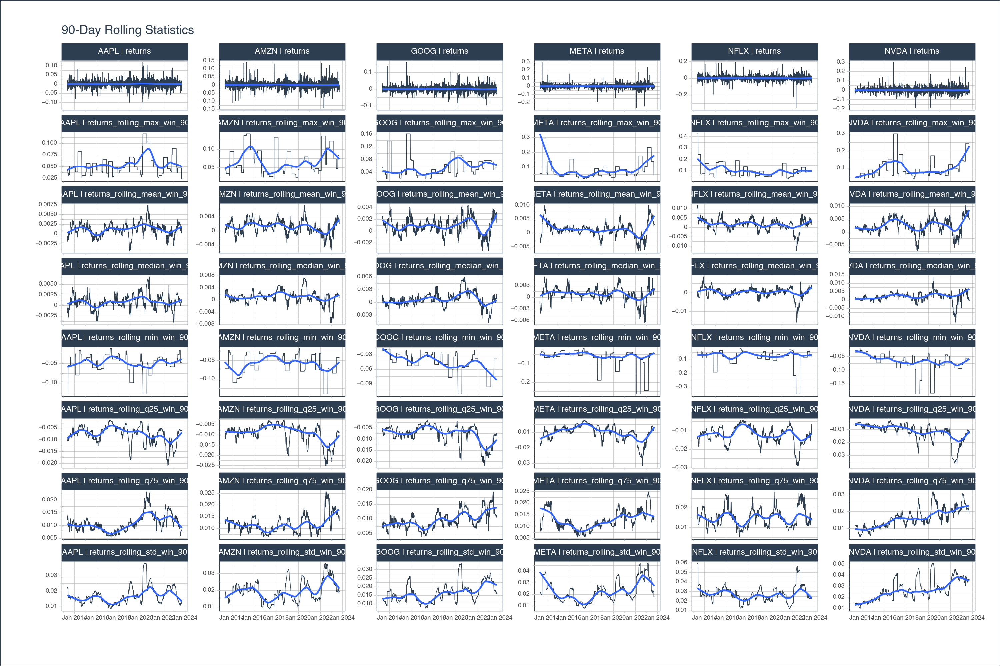

    <Figure Size: (1500 x 1000)>

# 5. Rolling Correlation and Regressions with `tk.augment_rolling_apply()`

One final evaluation is to understand relationships to other stocks and
the overall market index over time. For that we can use two techniques:

1.  Rolling Correlations
2.  Rolling Regressions

## 5.1 About: Rolling Correlation

Rolling correlation calculates the correlation between two time series
over a rolling window of a specified size, moving one period at a time.
In stock analysis, this is often used to assess:

-   **Diversification:** Helps in identifying how different stocks move
    in relation to each other, aiding in the creation of a diversified
    portfolio.

-   **Market Dependency:** Measures how a particular stock or sector is
    correlated with a broader market index.

-   **Risk Management:** Helps in identifying changes in correlation
    structures over time which is crucial for risk assessment and
    management.

For example, if the rolling correlation between two stocks starts
increasing, it might suggest that they are being influenced by similar
factors or market conditions.

## 5.2 Application: Rolling Correlation

Let’s revisit the returns wide and long format. We can combine these two
using the `merge()` method.

### Step 1: Create the `return_combinations_long_df`

Perform data wrangling to get the pairwise combinations in long format:

-   We first `.merge()` to join the long returns with the wide returns
    by date.
-   We then `.melt()` to get the wide data into long format.

In [17]:
return_combinations_long_df = returns_long_df \
    .merge(returns_wide_df, how='left', on = 'date') \
    .melt(
        id_vars = ['date', 'symbol', 'returns'],
        var_name = "comp",
        value_name = "returns_comp"
    )
return_combinations_long_df

97128 rows × 5 columns

### Step 2: Add Rolling Correlations with `tk.augment_rolling_apply()`

Next, let’s add rolling correlations.

-   We first `.groupby()` on the combination of our target assets
    “symbol” and our comparison asset “comp”.
-   Then we use a different function, `tk.augment_rolling_apply()`.

> **`tk.augment_rolling()` vs `tk.augment_rolling_apply()`**
>
> -   For the vast majority of operations, `tk.augment_rolling()` will
>     suffice. It’s used on a single column where there is a simple
>     rolling transformation applied to only the `value_column`.
> -   For more complex cases where other columns beyond a `value_column`
>     are needed (e.g. rolling correlations, rolling regressions), the
>     `tk.augment_rolling_apply()` comes to the rescue.
> -   `tk.augment_rolling_apply()` exposes the group’s columns as a
>     DataFrame to window function, thus allowing for multi-column
>     analysis.

> **`tk.augment_rolling_apply()` has no `value_column`**
>
> This is because the rolling apply passes a DataFrame containing all
> columns to the custom function. The custom function is then
> responsible for handling the columns internally. This is how you can
> select multiple columns to work with.

In [18]:
return_corr_df = return_combinations_long_df \
    .groupby(["symbol", "comp"]) \
    .augment_rolling_apply(
        date_column = "date",
        window = 90,
        window_func=[('corr', lambda x: x['returns'].corr(x['returns_comp']))],
        threads = 1, # Change to -1 to use all available cores
    )

return_corr_df

97128 rows × 6 columns

### Step 3: Visualize the Rolling Correlation

We can use `tk.plot_timeseries()` to visualize the 90-day rolling
correlation. It’s interesting to see that stock combinations such as
AAPL \| AMZN returns have a high positive correlation of 0.80, but this
relationship was much lower 0.25 before 2015.

-   The blue smoother can help us detect trends
-   The y_intercept is useful in this case to draw lines at -1, 0, and 1

## Plotly

``` python
return_corr_df \
    .dropna() \
    .groupby(['symbol', 'comp']) \
    .plot_timeseries(
        date_column = "date",
        value_column = "rolling_corr_win_90",
        facet_ncol = 6,
        y_intercept = [-1,0,1],
        y_intercept_color = tk.palette_timetk()['steel_blue'],
        width = 1500,
        height = 1000,
        title = "90-Day Rolling Correlation",
        engine = "plotly"
    )
```

<div>                            <div id="2c7c9ab0-92f9-4ca3-a13f-bf77fad14ff6" class="plotly-graph-div" style="height:1000px; width:1500px;"></div>            <script type="text/javascript">                require(["plotly"], function(Plotly) {                    window.PLOTLYENV=window.PLOTLYENV || {};                                    if (document.getElementById("2c7c9ab0-92f9-4ca3-a13f-bf77fad14ff6")) {                    Plotly.newPlot(                        "2c7c9ab0-92f9-4ca3-a13f-bf77fad14ff6",                        [{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.9999999999999988,1.0000000000000007,1.0000000000000002,1.0000000000000022,0.999999999999999,0.9999999999999991,1.000000000000004,1.0000000000000002,0.9999999999999998,1.0000000000000002,1.0000000000000022,0.9999999999999968,1.0000000000000022,0.9999999999999988,1.0000000000000033,0.9999999999999991,1.0000000000000009,1.0000000000000004,0.9999999999999966,0.9999999999999994,1.0000000000000042,0.9999999999999968,1.000000000000002,1.0000000000000013,0.9999999999999976,0.9999999999999979,0.9999999999999987,0.999999999999998,0.9999999999999998,1.0000000000000018,1.0000000000000038,1.0000000000000018,0.9999999999999971,0.9999999999999994,0.9999999999999983,0.9999999999999984,0.9999999999999988,0.9999999999999949,0.9999999999999974,0.9999999999999991,1.0,0.9999999999999982,1.0000000000000009,0.9999999999999994,1.0000000000000049,1.0000000000000024,0.9999999999999978,1.0000000000000002,0.9999999999999977,1.0000000000000002,0.9999999999999979,0.9999999999999989,0.9999999999999997,0.9999999999999993,0.9999999999999996,1.000000000000003,1.0000000000000029,0.999999999999999,0.9999999999999992,1.0000000000000004,0.999999999999999,1.0000000000000007,0.9999999999999994,1.0000000000000013,0.999999999999999,1.0000000000000036,1.0000000000000047,1.0000000000000009,1.000000000000001,1.0000000000000002,0.9999999999999989,1.0,0.9999999999999981,0.9999999999999993,1.0000000000000004,0.9999999999999968,1.0000000000000029,0.9999999999999993,1.0,1.0,1.0000000000000013,0.9999999999999994,0.9999999999999992,0.9999999999999997,0.9999999999999994,1.0000000000000004,0.9999999999999976,1.0,0.9999999999999993,0.9999999999999983,1.0,0.9999999999999956,0.9999999999999972,0.9999999999999991,0.9999999999999994,1.0000000000000024,0.9999999999999954,0.9999999999999986,1.0000000000000024,1.0000000000000002,0.9999999999999954,1.000000000000002,0.9999999999999987,0.9999999999999992,0.9999999999999992,0.9999999999999979,1.0000000000000027,1.0000000000000009,0.9999999999999984,1.0000000000000016,1.0000000000000009,0.999999999999996,1.0000000000000004,0.9999999999999997,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000013,0.9999999999999991,1.000000000000002,0.9999999999999997,1.0000000000000029,0.9999999999999992,0.9999999999999989,1.0000000000000004,1.0000000000000002,0.9999999999999992,1.0000000000000009,0.9999999999999979,0.9999999999999991,1.0,0.9999999999999994,1.000000000000002,1.0000000000000004,1.000000000000001,1.0000000000000002,0.9999999999999998,1.0000000000000004,0.9999999999999979,1.000000000000001,0.9999999999999999,1.0000000000000018,1.0000000000000007,0.9999999999999983,0.9999999999999999,1.0000000000000004,0.9999999999999991,0.9999999999999989,1.0000000000000009,0.9999999999999991,1.0000000000000002,1.0000000000000004,1.0000000000000009,0.9999999999999983,1.0000000000000018,1.0000000000000009,0.9999999999999998,0.999999999999999,1.0000000000000013,0.9999999999999993,0.9999999999999976,1.000000000000001,0.9999999999999991,0.9999999999999991,0.9999999999999989,0.9999999999999999,0.9999999999999999,1.0000000000000002,1.0000000000000013,1.0000000000000004,1.0000000000000004,0.9999999999999996,0.9999999999999992,0.9999999999999999,0.9999999999999996,1.000000000000001,1.0000000000000002,0.9999999999999998,0.9999999999999996,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999997,0.9999999999999983,1.0000000000000002,0.9999999999999999,0.9999999999999997,1.0000000000000004,0.9999999999999992,0.9999999999999996,0.9999999999999997,1.0000000000000018,1.0000000000000007,1.0,0.999999999999999,0.9999999999999984,1.0000000000000007,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999991,0.9999999999999997,1.0000000000000002,0.9999999999999994,0.9999999999999996,1.0000000000000002,1.0,1.000000000000001,0.9999999999999992,1.0000000000000007,1.0000000000000009,0.9999999999999988,0.9999999999999998,1.0,0.9999999999999994,0.9999999999999996,1.0000000000000016,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999998,0.9999999999999998,0.9999999999999993,0.9999999999999993,1.0000000000000002,1.0000000000000007,1.0000000000000007,1.0000000000000002,0.9999999999999998,0.9999999999999984,0.9999999999999993,1.0000000000000002,0.9999999999999998,0.9999999999999993,1.0000000000000004,0.999999999999999,1.0,0.9999999999999996,0.9999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999994,0.9999999999999999,1.0000000000000009,0.9999999999999996,0.9999999999999987,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000007,0.9999999999999996,1.0000000000000002,0.9999999999999997,0.9999999999999999,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999997,1.0000000000000004,0.9999999999999993,1.0,1.0000000000000004,0.9999999999999999,1.0,1.0000000000000007,1.0000000000000009,0.9999999999999999,0.9999999999999988,0.9999999999999998,0.9999999999999993,1.0000000000000004,1.0000000000000016,1.0,0.9999999999999996,0.9999999999999997,1.0,0.9999999999999991,0.9999999999999994,1.0,1.0000000000000009,0.9999999999999999,1.0000000000000009,1.0000000000000007,1.000000000000001,1.0000000000000018,0.9999999999999999,0.9999999999999992,1.0000000000000009,0.9999999999999998,0.9999999999999991,1.0000000000000007,0.9999999999999993,0.9999999999999996,1.0000000000000002,0.9999999999999993,0.9999999999999999,1.0,1.0,1.0000000000000002,1.0000000000000007,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999997,0.9999999999999994,1.0000000000000002,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0,1.0,1.0000000000000002,1.0000000000000007,0.9999999999999998,0.9999999999999994,1.0000000000000013,0.9999999999999999,1.0000000000000002,0.9999999999999992,0.9999999999999994,1.0000000000000007,0.9999999999999996,0.9999999999999998,1.0000000000000004,1.0000000000000002,0.999999999999999,1.0000000000000009,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0000000000000007,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999996,1.0000000000000004,0.9999999999999999,0.9999999999999994,0.9999999999999998,1.0000000000000002,0.9999999999999992,1.0000000000000007,0.9999999999999999,0.9999999999999993,0.9999999999999997,1.0000000000000002,1.000000000000001,1.0,0.9999999999999998,0.9999999999999997,0.9999999999999992,0.9999999999999999,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999999,1.0000000000000004,0.9999999999999991,0.999999999999999,1.0000000000000007,0.9999999999999999,0.9999999999999996,1.0000000000000002,0.9999999999999997,0.9999999999999997,1.0,1.0000000000000004,1.0000000000000009,0.9999999999999994,1.0000000000000007,1.000000000000001,0.9999999999999997,0.9999999999999994,0.9999999999999991,0.9999999999999996,0.9999999999999997,1.0,1.0,1.0000000000000009,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999993,0.9999999999999994,0.9999999999999999,1.0000000000000004,0.9999999999999989,1.0000000000000007,1.0000000000000002,0.9999999999999993,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999994,0.9999999999999999,0.9999999999999992,0.9999999999999997,1.0,1.0000000000000002,1.000000000000001,1.0,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999994,1.0,0.9999999999999996,0.9999999999999992,1.0000000000000007,0.9999999999999994,1.0,1.0000000000000004,0.9999999999999994,0.9999999999999988,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.999999999999999,0.9999999999999997,0.9999999999999999,0.9999999999999993,0.9999999999999999,1.0000000000000002,0.9999999999999994,1.0000000000000009,0.9999999999999999,0.9999999999999988,0.9999999999999996,1.0000000000000007,0.9999999999999994,1.0,1.0000000000000009,1.0000000000000007,0.9999999999999994,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999999,0.9999999999999999,0.9999999999999993,0.9999999999999992,0.9999999999999999,0.9999999999999994,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999994,0.999999999999999,0.9999999999999999,1.0000000000000004,0.9999999999999993,1.0,1.0,1.0000000000000002,0.999999999999999,0.9999999999999992,0.9999999999999996,1.000000000000001,0.9999999999999992,1.0000000000000004,0.9999999999999999,0.9999999999999998,1.0000000000000009,0.9999999999999997,0.9999999999999989,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999999,0.9999999999999986,0.9999999999999997,1.0000000000000009,1.0000000000000002,0.9999999999999999,0.9999999999999998,0.999999999999999,0.9999999999999997,0.9999999999999988,1.0000000000000009,0.9999999999999999,1.0000000000000002,0.9999999999999997,0.9999999999999996,0.9999999999999998,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999992,1.0000000000000002,1.0,1.0000000000000007,0.999999999999999,1.0000000000000007,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999996,1.0000000000000007,0.9999999999999996,0.9999999999999996,0.9999999999999998,0.9999999999999994,0.9999999999999996,0.9999999999999996,0.999999999999999,1.0000000000000002,0.9999999999999994,1.0000000000000007,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999997,0.9999999999999994,1.0,0.9999999999999994,1.0000000000000013,0.9999999999999997,1.0,1.0000000000000016,1.0000000000000004,0.9999999999999991,1.0000000000000002,0.9999999999999996,0.9999999999999996,0.9999999999999999,0.999999999999999,0.9999999999999999,1.0000000000000007,0.9999999999999991,0.9999999999999999,1.0000000000000004,0.9999999999999993,1.0000000000000004,0.9999999999999996,0.9999999999999997,0.9999999999999999,0.9999999999999999,1.0,1.0000000000000009,1.0000000000000007,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999996,0.9999999999999992,1.0000000000000016,0.9999999999999994,0.9999999999999999,0.9999999999999997,0.9999999999999993,0.9999999999999999,1.000000000000001,1.0000000000000007,0.9999999999999999,0.9999999999999993,0.9999999999999997,0.9999999999999989,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000007,0.999999999999999,1.0000000000000009,0.9999999999999993,1.0000000000000004,0.9999999999999996,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999996,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999998,1.0000000000000004,1.0000000000000004,0.999999999999999,0.9999999999999999,0.9999999999999998,1.0000000000000004,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.999999999999999,1.0000000000000002,1.0,1.0000000000000009,0.9999999999999994,0.999999999999999,0.999999999999999,0.9999999999999997,1.0000000000000007,1.0,0.9999999999999993,0.9999999999999996,0.9999999999999997,0.9999999999999992,1.0000000000000002,1.0000000000000002,0.9999999999999996,1.0,0.9999999999999991,1.0000000000000002,0.9999999999999999,0.9999999999999993,1.0,0.9999999999999996,0.9999999999999999,1.0000000000000004,0.9999999999999994,0.9999999999999986,0.9999999999999992,0.9999999999999994,0.9999999999999999,1.0000000000000009,1.0000000000000002,0.9999999999999996,0.9999999999999996,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.000000000000001,1.0000000000000004,1.0,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999996,1.0000000000000004,0.9999999999999994,1.0000000000000002,1.0,0.9999999999999994,1.0,0.9999999999999994,1.0000000000000002,0.9999999999999991,0.9999999999999992,0.9999999999999998,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999999,0.9999999999999998,1.0000000000000002,0.9999999999999998,0.9999999999999994,1.0000000000000002,0.9999999999999998,1.0000000000000007,1.0000000000000002,1.0000000000000007,1.0000000000000013,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999999,1.0,1.0,0.9999999999999997,0.9999999999999997,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0000000000000007,1.0,0.9999999999999997,1.0000000000000009,1.0,1.0000000000000004,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999996,1.0000000000000016,0.9999999999999997,1.0000000000000002,0.9999999999999996,0.9999999999999998,1.0,1.0000000000000007,0.9999999999999994,0.9999999999999998,1.0000000000000004,1.0,0.9999999999999999,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999996,1.0000000000000007,0.9999999999999994,0.9999999999999994,1.0000000000000002,1.0000000000000002,0.9999999999999996,0.9999999999999998,1.0000000000000002,0.9999999999999998,1.000000000000001,0.9999999999999998,0.9999999999999989,1.0000000000000009,1.0,0.9999999999999997,1.0000000000000007,0.9999999999999999,1.0,0.9999999999999997,1.0000000000000002,1.0000000000000009,1.0000000000000004,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999991,1.0000000000000004,0.9999999999999994,0.9999999999999993,0.9999999999999989,0.9999999999999988,1.0000000000000004,0.9999999999999996,0.9999999999999984,0.9999999999999988,0.9999999999999993,0.9999999999999991,0.9999999999999997,0.9999999999999996,1.0000000000000007,1.0000000000000004,0.9999999999999994,1.0,1.0000000000000007,1.0000000000000007,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.0000000000000002,0.9999999999999994,1.0000000000000007,1.0,0.9999999999999992,0.9999999999999998,1.0000000000000007,0.9999999999999999,1.0000000000000004,0.9999999999999993,0.9999999999999998,0.9999999999999999,1.0000000000000009,0.9999999999999993,1.0,1.0,0.9999999999999996,1.0000000000000009,1.0000000000000004,0.9999999999999994,1.0000000000000004,1.0000000000000004,1.0000000000000004,1.0,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.000000000000001,1.0,1.0000000000000004,1.0,1.0,0.9999999999999999,1.0000000000000004,1.0000000000000007,0.9999999999999997,1.000000000000001,1.0000000000000002,0.9999999999999996,1.0,0.9999999999999994,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999993,0.999999999999999,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000007,0.9999999999999997,0.9999999999999987,1.0000000000000007,0.9999999999999998,0.9999999999999991,0.9999999999999994,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0000000000000004,0.999999999999999,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999993,1.0,1.0000000000000002,0.9999999999999994,1.0000000000000007,0.9999999999999998,0.9999999999999994,1.0000000000000009,0.9999999999999997,1.0000000000000009,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999997,0.9999999999999996,0.9999999999999996,1.0000000000000002,0.9999999999999991,0.9999999999999998,0.9999999999999989,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0000000000000002,0.9999999999999998,0.9999999999999992,1.0000000000000002,0.9999999999999997,1.0000000000000007,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000004,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.9999999999999998,1.0,1.0000000000000007,0.9999999999999999,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999992,0.9999999999999992,0.9999999999999992,0.9999999999999997,0.9999999999999998,0.9999999999999997,1.0,1.0,1.0000000000000002,0.9999999999999986,0.9999999999999996,1.0000000000000002,0.999999999999999,0.9999999999999994,1.0000000000000002,0.9999999999999999,1.000000000000001,1.0000000000000004,1.0000000000000004,0.9999999999999996,0.9999999999999999,1.0,0.9999999999999997,0.9999999999999999,1.0000000000000002,0.9999999999999999,0.9999999999999991,0.9999999999999993,0.9999999999999999,0.9999999999999997,0.9999999999999994,1.0000000000000002,1.0000000000000004,0.9999999999999999,0.999999999999999,0.9999999999999991,1.0000000000000002,1.0000000000000007,0.9999999999999993,0.9999999999999988,0.9999999999999999,0.9999999999999988,0.9999999999999998,0.9999999999999993,0.9999999999999987,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999996,0.9999999999999986,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999993,0.9999999999999992,1.0000000000000002,0.9999999999999997,0.9999999999999994,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999997,0.9999999999999999,0.9999999999999998,0.9999999999999994,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999993,1.0000000000000007,1.0000000000000002,0.9999999999999998,0.9999999999999998,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999992,0.9999999999999997,1.0000000000000004,0.9999999999999992,0.9999999999999996,1.0,1.0,0.9999999999999994,0.9999999999999991,0.9999999999999999,1.0000000000000009,0.9999999999999993,1.0000000000000004,1.0,0.9999999999999997,1.0,0.9999999999999992,0.9999999999999999,0.9999999999999997,1.0000000000000004,0.9999999999999989,1.0,1.0000000000000007,1.0000000000000002,0.9999999999999999,0.9999999999999996,0.9999999999999997,0.9999999999999998,0.9999999999999989,0.9999999999999999,1.0,0.9999999999999998,0.999999999999999,0.9999999999999996,0.9999999999999997,0.9999999999999998,0.9999999999999997,0.9999999999999989,1.0000000000000007,1.0000000000000009,0.9999999999999999,1.0,1.0000000000000002,0.999999999999999,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999988,0.9999999999999996,1.0,1.0,0.9999999999999996,0.9999999999999992,1.0000000000000009,0.9999999999999988,1.0000000000000002,1.0000000000000007,1.0,1.0,0.9999999999999994,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0000000000000007,1.0000000000000002,0.9999999999999994,1.0000000000000007,1.0000000000000009,0.9999999999999998,1.0000000000000002,1.0000000000000002,0.9999999999999997,0.9999999999999997,0.9999999999999991,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999991,0.9999999999999997,0.9999999999999993,1.0,1.0,1.0,1.0000000000000009,1.0000000000000002,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999994,0.9999999999999992,0.9999999999999994,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999998,1.0,1.0,1.0000000000000002,1.0000000000000009,0.9999999999999996,0.9999999999999988,1.0000000000000004,0.9999999999999997,1.000000000000001,1.0,0.9999999999999989,1.0000000000000002,0.9999999999999996,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999999,0.9999999999999998,0.9999999999999993,1.0000000000000004,0.9999999999999998,0.9999999999999996,0.9999999999999994,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999994,0.9999999999999991,1.0000000000000002,1.0000000000000009,0.9999999999999996,0.9999999999999994,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000009,0.9999999999999991,0.9999999999999997,1.0,1.0000000000000004,1.0,0.9999999999999998,1.0,0.9999999999999996,1.000000000000001,0.9999999999999996,0.9999999999999987,0.9999999999999998,0.9999999999999997,1.0000000000000009,0.9999999999999997,1.0,1.0000000000000013,1.0000000000000004,0.9999999999999992,1.0,1.0000000000000002,0.9999999999999997,0.9999999999999993,1.0000000000000007,0.9999999999999994,0.9999999999999992,0.9999999999999997,1.0000000000000002,1.0000000000000002,1.0000000000000009,0.9999999999999993,1.0000000000000009,0.9999999999999996,1.0,0.9999999999999997,1.0,0.9999999999999999,0.9999999999999997,0.9999999999999996,1.0000000000000002,0.9999999999999996,0.9999999999999998,0.9999999999999999,0.9999999999999999,0.9999999999999994,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0000000000000009,1.0000000000000009,1.0000000000000004,1.0000000000000002,0.9999999999999991,0.9999999999999998,1.0000000000000007,0.9999999999999996,1.000000000000001,0.9999999999999984,0.9999999999999999,1.0000000000000002,0.9999999999999994,0.9999999999999992,0.9999999999999993,1.0000000000000004,1.0,1.0,1.0000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999994,1.0000000000000007,1.0000000000000007,1.0000000000000007,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999994,1.000000000000001,1.0000000000000002,0.9999999999999997,0.9999999999999999,0.9999999999999999,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999993,1.0000000000000007,1.0000000000000007,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0000000000000009,0.9999999999999996,1.0000000000000004,1.0000000000000007,1.0000000000000004,1.0000000000000004,0.9999999999999994,0.9999999999999988,0.9999999999999997,0.9999999999999984,0.9999999999999991,1.0000000000000004,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999994,1.0000000000000009,0.9999999999999997,0.9999999999999989,1.0,0.9999999999999989,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999997,0.9999999999999989,0.9999999999999994,1.0000000000000007,0.9999999999999997,1.0,0.9999999999999994,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999991,1.0000000000000004,1.0,0.999999999999999,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999997,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0000000000000004,1.0,1.0000000000000002,1.0,0.9999999999999993,0.9999999999999993,1.0000000000000004,0.9999999999999992,0.9999999999999998,0.9999999999999998,0.9999999999999996,1.0000000000000007,1.0000000000000004,0.9999999999999997,1.0,0.9999999999999991,0.9999999999999998,0.9999999999999992,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999993,0.9999999999999996,0.9999999999999994,1.0,1.0000000000000004,0.9999999999999994,1.0,0.9999999999999996,1.0000000000000004,0.9999999999999991,0.9999999999999999,1.0,1.0000000000000004,1.0000000000000004,0.9999999999999999,0.9999999999999994,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999994,1.0,1.0000000000000007,0.9999999999999992,0.9999999999999989,0.9999999999999994,0.9999999999999998,0.9999999999999997,0.9999999999999994,0.9999999999999988,0.9999999999999997,1.0000000000000002,0.9999999999999997,0.9999999999999992,1.0000000000000007,1.0000000000000007,1.0,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0,1.0000000000000002,0.9999999999999993,0.9999999999999996,1.0000000000000009,0.9999999999999991,0.9999999999999997,1.0000000000000004,0.9999999999999996,0.9999999999999991,0.9999999999999997,0.9999999999999988,0.9999999999999993,1.0,1.0000000000000002,0.9999999999999993,0.9999999999999989,1.000000000000001,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999998,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999999,1.0000000000000013,1.0000000000000009,1.0000000000000009,1.0,0.9999999999999997,1.0,0.999999999999999,0.9999999999999997,0.999999999999999,0.9999999999999996,0.9999999999999996,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999994,1.0000000000000013,0.9999999999999997,0.9999999999999999,1.0000000000000013,1.0000000000000002,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.000000000000001,0.9999999999999996,1.0000000000000007,0.9999999999999996,1.0,1.0000000000000009,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999998,1.0000000000000004,0.9999999999999999,1.0000000000000002,0.9999999999999992,0.9999999999999994,0.9999999999999991,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999997,0.9999999999999994,1.0000000000000004,0.9999999999999994,0.9999999999999999,0.9999999999999992,1.0000000000000004,1.0000000000000013,0.9999999999999994,1.0000000000000004,1.0000000000000004,1.0000000000000007,0.9999999999999998,0.9999999999999994,0.9999999999999998,1.0000000000000007,0.9999999999999999,0.999999999999999,1.0000000000000009,0.9999999999999999,0.9999999999999993,1.0000000000000002,1.0,0.9999999999999997,1.0000000000000007,1.0000000000000009,0.9999999999999996,0.9999999999999994,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.000000000000001,1.0000000000000004,1.0,0.9999999999999994,1.0000000000000007,0.999999999999999,1.0000000000000004,0.9999999999999993,0.9999999999999998,1.0,1.0000000000000007,1.0000000000000007,1.0000000000000004,1.0,0.9999999999999992,1.0000000000000002,0.9999999999999997,0.9999999999999994,0.9999999999999996,0.9999999999999997,0.9999999999999997,0.9999999999999997,1.0000000000000007,0.9999999999999996,1.0000000000000002,1.0000000000000009,0.9999999999999999,0.9999999999999997,0.999999999999999,0.9999999999999991,0.9999999999999984,0.9999999999999998,1.0000000000000002,1.0000000000000009,1.0000000000000007,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999992,1.0,1.0000000000000007,1.0000000000000002,0.9999999999999999,0.9999999999999999,0.9999999999999997,1.0000000000000007,0.9999999999999998,0.9999999999999999,0.9999999999999996,0.9999999999999996,0.9999999999999997,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999999,0.9999999999999994,0.9999999999999992,1.0000000000000007,0.9999999999999991,0.9999999999999997,1.0000000000000004,1.0000000000000002,0.9999999999999993,0.9999999999999999,0.9999999999999994,1.0000000000000004,0.9999999999999992,1.0000000000000004,0.9999999999999993,0.9999999999999996,1.0000000000000018,1.0000000000000004,1.0000000000000002,0.9999999999999993,0.999999999999999,1.0000000000000004,1.0000000000000007,0.9999999999999996,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999999,0.9999999999999997,1.0000000000000004,1.0,0.9999999999999997,0.9999999999999994,0.9999999999999997,0.9999999999999998,0.9999999999999999,1.0000000000000007,0.9999999999999997,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999993,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999996,0.9999999999999994,1.0,0.9999999999999993,0.9999999999999997,0.999999999999999,1.0000000000000004,0.9999999999999997,0.9999999999999988,1.0,0.9999999999999998,1.0000000000000007,1.0000000000000009,0.9999999999999997,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000009,1.0000000000000004,0.9999999999999993,1.0000000000000007,0.9999999999999992,1.0000000000000007,1.0000000000000002,0.9999999999999994,0.9999999999999996,1.0000000000000004,0.9999999999999996,0.9999999999999996,1.0000000000000009,0.999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000004,1.0000000000000004,0.9999999999999992,1.0000000000000002,1.0,0.9999999999999999,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999997,0.9999999999999997,1.0000000000000004,1.0000000000000004,0.9999999999999996,0.9999999999999998,0.9999999999999996,0.9999999999999999,0.9999999999999987,1.0000000000000002,1.0000000000000009,1.0000000000000007,1.0000000000000007,0.9999999999999996,0.9999999999999994,0.9999999999999994,0.9999999999999996,0.9999999999999993,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999997,1.0,1.0,0.9999999999999998,0.999999999999999,0.9999999999999998,1.0000000000000009,0.9999999999999993,1.0000000000000004,0.9999999999999997,0.9999999999999999,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999996,1.0000000000000007,1.000000000000001,1.0000000000000002,0.9999999999999998,1.0,1.0,1.0,0.9999999999999992,1.0000000000000007,1.0000000000000007,1.0000000000000004,0.9999999999999994,1.0000000000000002,0.9999999999999988,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999988,0.9999999999999998,0.9999999999999996,0.9999999999999991,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999997,0.9999999999999999,0.9999999999999989,1.0000000000000007,0.9999999999999999,0.9999999999999992,1.000000000000001,1.0,0.9999999999999991,0.9999999999999999,0.9999999999999999,0.9999999999999993,0.9999999999999993,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999993,0.9999999999999993,1.0000000000000004,1.000000000000001,1.0000000000000004,0.9999999999999992,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999996,0.9999999999999999,1.0000000000000004,0.999999999999999,0.9999999999999992,1.000000000000001,0.9999999999999987,0.9999999999999994,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999993,1.0000000000000002,1.0000000000000009,1.0000000000000004,1.0000000000000007,1.0000000000000007,1.0000000000000007,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999998,1.0000000000000002,1.0,1.0000000000000009,1.0,1.0,1.0000000000000004,0.9999999999999989,1.0,1.0,1.0000000000000002,0.9999999999999997,0.9999999999999998,0.9999999999999993,1.0000000000000004,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000007,0.9999999999999998,1.0,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999996,0.9999999999999996,1.0,0.9999999999999997,0.9999999999999997,0.9999999999999999,1.0,1.0,0.999999999999999,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999997,1.0000000000000004,0.9999999999999993,1.0000000000000009,1.0,1.0000000000000007,0.9999999999999998,0.9999999999999999,0.9999999999999996,1.0000000000000007,0.9999999999999999,1.0000000000000004,1.0000000000000009,0.9999999999999993,0.9999999999999993,1.0000000000000002,1.000000000000001,1.0000000000000004,1.0000000000000002,1.000000000000001,1.0000000000000007,0.9999999999999996,0.9999999999999998,1.0000000000000002,0.9999999999999997,0.9999999999999999,0.9999999999999997,1.0000000000000007,1.0,0.9999999999999997,0.9999999999999997,0.9999999999999996,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999993,1.0000000000000007,1.0000000000000007,0.9999999999999999,1.0,0.9999999999999997,1.0000000000000007,0.9999999999999993,1.0000000000000002,0.9999999999999993,1.0,0.9999999999999998,1.0,1.0,1.0000000000000007,0.9999999999999997,0.9999999999999994,0.9999999999999992,0.9999999999999994,0.9999999999999993,1.0,0.999999999999999,1.0000000000000004,0.9999999999999999,1.0000000000000009,0.9999999999999996,0.9999999999999991,0.9999999999999989,1.0000000000000002,0.9999999999999998,0.9999999999999998,1.0000000000000002,0.9999999999999997,0.9999999999999986,1.0,0.9999999999999998,0.9999999999999994,1.0000000000000002,0.9999999999999986,1.0000000000000002,0.9999999999999994,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999993,1.0000000000000004,1.0000000000000002,0.9999999999999994,0.9999999999999999,0.9999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999997,1.0000000000000004,0.9999999999999998,0.9999999999999992,0.9999999999999994,1.0000000000000002,0.9999999999999999,1.0,1.0000000000000002,1.0000000000000009,0.9999999999999997,0.9999999999999993,1.0000000000000007,0.9999999999999998,0.9999999999999993,0.9999999999999996,0.9999999999999994,0.9999999999999992,1.0000000000000002,0.9999999999999997,0.9999999999999999,0.9999999999999999,0.9999999999999993,1.0000000000000007,0.9999999999999999,1.0000000000000004,0.9999999999999989,1.0,0.9999999999999998,0.9999999999999998,1.0000000000000004,1.0,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999998,1.0000000000000009,1.0000000000000013,1.0000000000000002,1.0000000000000004,0.9999999999999992,1.0,1.000000000000001,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999993,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999992,0.9999999999999993,0.9999999999999998,0.9999999999999996,0.9999999999999998,1.0000000000000002,1.0,1.0000000000000007,0.9999999999999998,0.9999999999999993,1.000000000000001,1.0,0.9999999999999993,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999991,0.9999999999999992,1.0,1.0000000000000004,1.0000000000000007,0.9999999999999997,0.9999999999999988,0.9999999999999997,1.0,1.0,1.0000000000000004,1.0,0.9999999999999999,0.9999999999999993,1.0000000000000002,0.9999999999999998,1.0000000000000009,1.0,1.0000000000000009,1.0000000000000004,1.0,1.0000000000000009,1.0000000000000002,0.9999999999999998,1.0000000000000007,0.9999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999992,1.0,0.9999999999999996,0.9999999999999979,1.0000000000000002,1.0000000000000007,1.0000000000000009,0.9999999999999992,1.0000000000000004,0.9999999999999994,0.9999999999999989,1.0000000000000007,1.0000000000000002,1.0000000000000009,1.0000000000000007,0.9999999999999991,0.9999999999999987,0.999999999999999,0.9999999999999997,0.9999999999999998,0.9999999999999994,0.9999999999999991,1.0000000000000016,1.0000000000000007,1.0000000000000013,1.0000000000000007,1.0000000000000009,0.9999999999999992,1.0000000000000009,1.0000000000000002,0.9999999999999987,0.9999999999999988,0.9999999999999983,0.9999999999999976,1.000000000000002,0.9999999999999971,1.0000000000000002,1.0000000000000004,0.9999999999999991,0.9999999999999998,1.0000000000000009,0.9999999999999988,0.9999999999999983,0.9999999999999991,1.0000000000000004,0.9999999999999963,1.0000000000000002,1.0000000000000004,0.9999999999999993,0.9999999999999998,0.9999999999999997,1.0000000000000002,1.0000000000000016,1.000000000000004,0.9999999999999973,1.000000000000002,1.0,1.0000000000000004,0.9999999999999972,1.0000000000000018,1.0000000000000009,1.0000000000000038,1.0000000000000002,1.0000000000000044,0.9999999999999976,0.9999999999999988,0.9999999999999983,0.9999999999999991,0.999999999999999,0.9999999999999991,0.9999999999999993,0.9999999999999966,0.9999999999999991,1.0000000000000044,1.0000000000000047,1.0000000000000029,0.9999999999999999,0.9999999999999996,1.0000000000000009,1.0000000000000073,0.9999999999999986,0.9999999999999986,1.0,1.000000000000004,1.0000000000000016,0.999999999999995,0.9999999999999951,1.000000000000006,1.0000000000000029,1.0000000000000002,0.9999999999999997,1.000000000000004,1.0000000000000027,1.0000000000000022,0.999999999999998,1.0000000000000038,0.9999999999999992,0.9999999999999994,0.9999999999999932,1.0000000000000033,1.0000000000000007,0.9999999999999967,0.9999999999999982,1.0000000000000042,0.9999999999999971,0.9999999999999974,1.000000000000004,0.9999999999999948,1.0000000000000002,0.9999999999999954,0.9999999999999993,0.9999999999999971,1.0000000000000038,0.9999999999999923,1.0000000000000056,0.9999999999999946,1.0000000000000022,1.0000000000000044,1.0000000000000027,1.0000000000000038,1.0000000000000024,1.0000000000000013,1.0000000000000044,1.0000000000000056,0.999999999999992,0.9999999999999998,1.0000000000000053,0.9999999999999938,1.0000000000000029,0.9999999999999905,1.0000000000000029,1.0000000000000036,1.0000000000000115,1.0000000000000069,0.9999999999999994,0.9999999999999963,0.9999999999999984,1.0000000000000004,0.9999999999999956,0.9999999999999979,0.9999999999999974,1.0000000000000022,0.9999999999999937,0.9999999999999991,0.9999999999999988,0.9999999999999936,1.0000000000000069,0.9999999999999912,0.9999999999999978,1.0000000000000002,0.9999999999999907,1.00000000000002,0.9999999999999929,0.9999999999999867,1.0000000000000078,0.9999999999999938,1.0000000000000024,0.9999999999999957,1.0000000000000069,0.9999999999999956,1.0000000000000064,0.9999999999999925,1.0000000000000002,1.0000000000000058,0.9999999999999958,1.0000000000000038,1.0000000000000067,1.0000000000000018,1.0000000000000087,1.000000000000009,1.0000000000000087,0.9999999999999933,0.999999999999995,0.999999999999995,0.9999999999999948,0.9999999999999979,1.0000000000000013,0.9999999999999911,1.0000000000000193,0.9999999999999967,0.9999999999999997,0.9999999999999937,0.9999999999999991,0.9999999999999923,1.000000000000004,0.9999999999999882,1.0000000000000027,0.9999999999999906,0.999999999999998,0.9999999999999957,0.9999999999999941,1.0000000000000107,0.9999999999999868,0.9999999999999728,0.9999999999999913,0.9999999999999951,0.9999999999999934,0.9999999999999967,1.0000000000000087,0.9999999999999905,1.0000000000000098,0.9999999999999942,0.9999999999999954,0.9999999999999868,0.9999999999999968,0.9999999999999942,0.9999999999999825,0.9999999999999912,1.0000000000000013,1.0000000000000022,1.0000000000000007,1.0000000000000095,1.0000000000000102,1.0000000000000064,1.0000000000000056,1.0000000000000082,0.9999999999999987,1.0000000000000056,1.0000000000000104,1.0000000000000073,0.9999999999999963,0.9999999999999996,0.9999999999999849,1.0000000000000067,1.0000000000000138,0.9999999999999798,1.0000000000000009,1.0000000000000135,0.9999999999999928,1.0000000000000144,0.9999999999999925,1.000000000000007,0.9999999999999888,1.0000000000000009,1.0000000000000095,1.0000000000000102,0.9999999999999941,0.9999999999999979,0.9999999999999969,1.0000000000000164,0.9999999999999974,1.0000000000000113,0.9999999999999972,1.0000000000000149,1.0000000000000064,0.9999999999999996,1.0000000000000007,0.9999999999999954,0.9999999999999853,0.9999999999999962,1.000000000000024,0.9999999999999835,0.9999999999999845,1.0000000000000169,0.9999999999999954,1.000000000000019,0.9999999999999902,0.9999999999999996,1.0000000000000198,0.9999999999999928,1.0000000000000013,1.0000000000000058,0.9999999999999978,1.0000000000000009,1.0000000000000093,0.9999999999999966,0.9999999999999851,0.9999999999999976,1.0000000000000002,0.9999999999999872,0.9999999999999948,1.000000000000001,1.000000000000002,0.9999999999999982,1.000000000000009,1.0000000000000047,0.9999999999999909,0.9999999999999872,1.0000000000000018,0.9999999999999855,1.0000000000000004,0.9999999999999877,0.9999999999999953,0.999999999999997,0.9999999999999903,0.9999999999999905,0.9999999999999881,0.9999999999999934,0.9999999999999979,1.0000000000000002,1.0000000000000078,0.9999999999999892,1.0000000000000007,0.9999999999999871,0.999999999999998,0.999999999999994,0.9999999999999916,0.9999999999999962,0.999999999999999,0.9999999999999934,0.9999999999999938,1.0000000000000109,0.99999999999999,0.9999999999999996,0.9999999999999996,1.0,0.9999999999999892,1.0000000000000009,0.9999999999999943,0.999999999999991,0.9999999999999957,0.9999999999999944,1.000000000000002,0.9999999999999937,1.0000000000000058,0.9999999999999967,0.9999999999999974,1.0000000000000058,0.9999999999999969,0.9999999999999962,1.0000000000000009,1.0000000000000016,0.9999999999999987,1.0000000000000033,1.0000000000000042,0.9999999999999973,1.00000000000001,1.0000000000000016,0.9999999999999997,1.0000000000000056,0.9999999999999919,1.000000000000007,0.9999999999999911,0.9999999999999952,1.0000000000000078,0.9999999999999925,1.0000000000000053,0.9999999999999977,0.9999999999999947,1.0000000000000044,0.9999999999999966,1.0000000000000073,0.9999999999999997,0.999999999999996,1.0000000000000044,1.0000000000000024,0.9999999999999895,1.0000000000000022,0.999999999999989,0.9999999999999974,0.9999999999999973,0.9999999999999957,0.999999999999999,0.9999999999999929,0.9999999999999939,0.9999999999999933,1.0000000000000027,0.9999999999999998,0.9999999999999984,0.999999999999999,1.0000000000000024,0.9999999999999994,0.9999999999999962,0.9999999999999953,1.0000000000000018,1.0000000000000004,0.9999999999999968,1.0000000000000004,0.9999999999999992,0.999999999999997,1.0000000000000018,0.999999999999995,1.0000000000000002,1.0,1.0000000000000044,0.9999999999999978,0.9999999999999989,1.0000000000000016,1.0000000000000073,1.0000000000000007,1.0000000000000036,0.9999999999999987,0.9999999999999992,1.000000000000002,0.9999999999999976,0.9999999999999999,0.9999999999999937,0.9999999999999969,1.0000000000000004,1.0000000000000002,0.9999999999999978,0.999999999999999,1.000000000000001,0.9999999999999941,0.9999999999999992,0.9999999999999953,0.9999999999999988,0.9999999999999999,0.9999999999999998,0.9999999999999993,0.9999999999999982,1.0000000000000004,0.9999999999999986,0.9999999999999988,0.9999999999999998,0.9999999999999973,0.9999999999999973,1.0,0.9999999999999976,0.9999999999999994,1.0000000000000007,0.9999999999999978,1.0000000000000018,0.9999999999999996,0.9999999999999976,1.000000000000002,1.000000000000001,1.0000000000000018,1.0000000000000007,0.9999999999999991,1.0000000000000004,1.0000000000000004,1.000000000000003,1.0000000000000013,0.999999999999999,1.0000000000000027,1.0000000000000002,1.0000000000000047,1.0,1.0000000000000016,1.0000000000000009,1.0,0.9999999999999994,0.9999999999999992,0.9999999999999992,1.0000000000000004,0.9999999999999989,1.0,1.0000000000000007,1.0000000000000007,0.9999999999999993,1.000000000000001,1.0000000000000004,0.9999999999999998,0.9999999999999999,1.0000000000000002,1.0000000000000007,0.9999999999999999,1.000000000000001,0.9999999999999994,0.9999999999999994,0.9999999999999989,0.9999999999999993,1.0,0.9999999999999996,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999999,0.9999999999999997,0.9999999999999997,0.9999999999999993,1.0000000000000007,1.0000000000000002,0.9999999999999993,0.9999999999999993,1.000000000000001,0.9999999999999993,0.9999999999999999,0.999999999999999,0.9999999999999983,0.9999999999999988,0.9999999999999997,0.9999999999999997,1.0000000000000007,0.9999999999999993,0.9999999999999989,0.9999999999999998,0.9999999999999999,1.0000000000000002,1.0000000000000013,0.9999999999999998,0.9999999999999999,0.9999999999999993,0.9999999999999992,0.9999999999999987,1.0000000000000018,1.0000000000000024,1.0000000000000002,0.9999999999999993,1.0000000000000004,0.999999999999999,0.9999999999999993,1.0000000000000004,0.9999999999999988,1.0000000000000002,1.0000000000000004,1.0000000000000007,0.9999999999999971,1.0000000000000004,0.9999999999999988,1.0000000000000016,1.0000000000000013,0.9999999999999983,1.0000000000000013,1.0000000000000013,1.0000000000000009,0.9999999999999989,0.9999999999999992,0.9999999999999989,0.9999999999999991,1.000000000000001,0.9999999999999987,1.0,0.9999999999999992,1.0000000000000004,1.0000000000000022,0.9999999999999997,1.0000000000000018,0.9999999999999989,0.9999999999999986,1.0000000000000013,1.0,1.0000000000000018,0.9999999999999983,0.9999999999999994,1.0000000000000022,1.0000000000000007,1.0000000000000013,0.9999999999999996,1.000000000000001,0.9999999999999968,0.9999999999999992,1.0000000000000016,1.0000000000000047,1.0000000000000009,0.9999999999999974,1.0000000000000002,1.0,1.0000000000000013,0.9999999999999992,1.0000000000000016,1.0000000000000009,1.000000000000001,0.9999999999999968,1.0000000000000004,0.9999999999999999,1.000000000000002,1.0000000000000009,1.000000000000003,1.0000000000000009,0.9999999999999972,1.000000000000001,1.0000000000000024,0.9999999999999968,1.000000000000004,0.9999999999999962,0.9999999999999994,0.9999999999999984,0.9999999999999984,0.9999999999999988,0.9999999999999964,0.9999999999999998,1.000000000000001,1.000000000000001,1.0000000000000007,1.0000000000000004,1.000000000000001,1.0000000000000004,0.9999999999999989,0.9999999999999988,1.0000000000000004,1.000000000000002,0.9999999999999962,1.0000000000000018,0.9999999999999923,0.9999999999999976,1.0000000000000009,0.9999999999999991,0.9999999999999993,1.0000000000000029,0.9999999999999991,0.9999999999999984,0.9999999999999967,0.9999999999999937,1.0000000000000018,1.0000000000000084,0.9999999999999969,1.0000000000000024,0.9999999999999968,1.000000000000005,1.0000000000000022,1.000000000000001,1.000000000000005,0.9999999999999996,1.0000000000000056,0.9999999999999978,0.9999999999999992,1.000000000000002,1.000000000000002,1.0000000000000009,0.9999999999999998,1.0000000000000062,1.0000000000000038,0.9999999999999984,1.0000000000000018,0.9999999999999976,0.9999999999999898,0.999999999999998,1.0000000000000004,0.9999999999999998,0.9999999999999979,1.0000000000000009,0.9999999999999974,0.9999999999999971,1.0000000000000018,0.9999999999999979,1.0000000000000038,1.0000000000000016,0.9999999999999931,1.000000000000001,0.9999999999999988,0.9999999999999994,0.999999999999993,1.000000000000009,0.999999999999996,0.999999999999998,1.0000000000000056,1.0000000000000004,1.0,1.0000000000000075,1.0,0.9999999999999932,1.0000000000000036,0.9999999999999982,1.0000000000000013,1.0000000000000016,1.000000000000006,0.9999999999999953,1.0000000000000018,0.9999999999999793,0.999999999999996,0.9999999999999939,0.999999999999997,1.0000000000000009,1.0000000000000115,1.0000000000000009,0.9999999999999953,1.0000000000000013,1.0000000000000033,1.0000000000000044,0.9999999999999962,0.999999999999982,1.0000000000000036,1.000000000000001,0.999999999999995,0.9999999999999999,0.9999999999999946,1.0000000000000036,0.9999999999999936,1.0000000000000016,0.9999999999999997,1.000000000000002,1.0000000000000007,0.9999999999999978,0.9999999999999958,1.0000000000000044,0.9999999999999982,1.0000000000000016,0.9999999999999989,0.9999999999999959,1.0000000000000049,1.0000000000000078,1.0000000000000002,1.0000000000000022,1.0000000000000029,1.00000000000002,0.9999999999999979,0.9999999999999969,0.9999999999999903],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.1267942092732469,-0.13289002505342912,-0.12489310070210921,-0.12683385016682402,-0.12587708625886923,-0.1308218981457928,-0.13023555020895608,-0.13133773551470704,-0.11747653428960601,-0.12099976313772345,-0.11461761989388766,-0.1152767469877571,-0.11211547586684052,-0.1109621199530262,-0.10803957794887799,-0.05088628531658281,-0.021275625856915458,-0.0005392196729439423,0.050419073820185414,0.054189484315620484,0.05395535945737009,0.05898210823717294,0.045459935718393026,0.012974439858713745,0.015418510046028622,0.02661463237565966,0.03397833613545432,0.05326599373499693,0.059309153168857855,0.07305373934679882,0.07341380387623254,0.05630883789082306,0.05599335237562245,0.043718239120467205,0.06349299332841593,0.0691811008270821,0.05393653398341951,0.05428780826612502,0.05644437364635635,0.05844841304678946,0.06365268926453825,0.10924957798798092,0.09817306800661968,0.09368690716670958,0.09430316157218553,0.09432330123877146,0.09981966153461459,0.10788574687286419,0.10682150852239006,0.13222883615607192,0.1262441995674574,0.1463931654531164,0.150157113104314,0.13404727464781466,0.12735784374810732,0.1159443527424987,0.12196989047504288,0.1220244829729953,0.13063069969574495,0.13557824107088848,0.11117659970868525,0.11167854995875703,0.11282539657952498,0.10605885893924266,0.07200951336211298,0.06158341443928734,0.06373101790363854,0.05187038773984635,0.05699122482940525,0.05968053462603579,0.03848329038585762,0.0281777133297297,-0.022805390587102757,-0.07101141948964515,-0.03765541298713351,-0.04834615129880936,-0.06539124860179889,-0.058766050532090164,-0.06294333879180729,0.02600971192036806,0.06467670504253945,0.042811463261200736,0.038877645232554735,0.02666578255851923,0.02855708735694287,0.04125216812065468,0.047709318595939715,0.0598751986631505,0.07704509107036628,0.10743908798935871,0.10502528705960722,0.11606460410845848,0.05180895075238469,0.057408699398983125,0.06873776531480562,0.08786542872007426,0.09281867774954115,0.10677581879235548,0.1329171003804371,0.13331840769198244,0.15731784875674307,0.15901775982462452,0.13902042482464325,0.15598040865821078,0.1455343623971161,0.14788610376851624,0.15329469613205848,0.15401308483223733,0.14506683548016952,0.15329649254200028,0.15020959201471046,0.1471188752367304,0.13177895347748167,0.1212522031695807,0.11235575349066927,0.12083450321754038,0.03879466518043454,0.022095170778174918,0.010110050271456316,-0.009298637553481282,-0.010433969260926736,0.004808855017854722,0.0016758143925336565,0.002631217130280899,-0.009977986208665204,0.01599208089249755,0.024886474476863842,0.024594760534157194,0.029796577868458962,0.028267674926713445,0.04092313274496118,0.02931160404439504,0.03940231787106168,0.039489553279503695,0.043212535694306796,0.04899852389945557,0.048525911796890794,0.05149179040480461,0.05744812419531357,0.05789662037634192,0.08976830820378674,0.09631404685643927,0.07060444454333024,0.08213714185061155,0.08770872922669266,0.08365062060135302,0.07769460600471505,0.08012298227779686,0.09378661930018847,0.09316410193175823,0.08869931903471119,0.08866842213196452,0.09226513006539795,0.09127324501218884,0.12418107421968935,0.1385420642586312,0.1291955008638149,0.13533365281014947,0.13264706573136806,0.13982259128276556,0.14723435221316936,0.1515823501762718,0.15383154365418475,0.16164353027831305,0.13598277389580893,0.13329949927284165,0.1343541684555766,0.1317941427374015,0.13510742142948584,0.12094414212096365,0.1297322118419579,0.12201620741618786,0.11770005519466073,0.10935064875999943,0.11264614427399454,0.11408904926248595,0.1046583158661414,0.12206465111351682,0.11116352706601915,0.01808454200552925,0.03318937725575255,0.03193611023012009,0.054433365663330895,0.052733545959174455,0.05131271128295986,0.04532377611297438,0.04672584733523702,0.048300395190731,0.028694923421648613,0.029199278326041432,0.021639981783087726,0.03262871182622785,0.0414562753365922,0.0283796562765987,0.046213054067447426,0.04038244561546971,0.041445391722726335,0.0433114111194472,0.03916137111952382,0.036800832793346165,0.03606979114856475,0.021143334636757116,0.028345943315520122,0.032654113223351794,0.04022251453087375,0.03377470461219622,0.08130480631614853,0.0858854448274785,0.09818027288035161,0.10200433883009341,0.10235750959704172,0.09645903289034465,0.09798120542902243,0.10091199930726469,0.09997520695352716,0.0796815648531323,0.06015534485561494,0.04936114368486994,0.05340166937860256,0.06575350034908231,0.05089423290289974,0.052469870191877384,0.04895056167730805,0.056003514169378044,0.05366573068953598,0.05246832693229944,0.06991360096905055,0.07519688129773053,0.064161862914061,0.058403023131101565,0.06412213314605739,0.06773206184415236,0.0925633885175416,0.09216291254203135,0.09489097285490618,0.10222617490974317,0.11368849643869869,0.11397944402925705,0.11657490890992984,0.20799098364871085,0.16911956775468598,0.13784776207207236,0.13565493907586285,0.14026622915049902,0.14118238990528897,0.13761972757811325,0.13975528575942733,0.14964823689929796,0.15508199542479986,0.15339065081370618,0.14804625007051672,0.15417419718478007,0.15526604752651246,0.15631338714004084,0.15809149601713524,0.16595240842691542,0.1639937990292291,0.1637999775508622,0.16278733034248805,0.16467057829729442,0.16216570466810554,0.16223395364865673,0.16280792360017052,0.1808961932677665,0.17380547228755608,0.17611368002171243,0.17661033877065677,0.16214841017143714,0.1605796282869204,0.2584562866485081,0.24507123135958564,0.26233244575214465,0.2896265737359875,0.3086248616736291,0.30444387137653023,0.3062945959609199,0.30630652394830304,0.2949116529412157,0.3003674460495952,0.30224213963917157,0.3021534099863046,0.29425297744789225,0.29352901881465215,0.2936253336689262,0.2823837237780527,0.2889282070435334,0.28772644859088276,0.2871166489010636,0.30256344268854185,0.29399068018346575,0.3032854442893276,0.3015519561733875,0.30267412699966106,0.28721356047625396,0.29765141516004234,0.2970505280646517,0.29484165405796325,0.2980421062665836,0.30604886142734267,0.30485026387888964,0.3085017222153783,0.3015558160291973,0.30095920360643336,0.25721133643652483,0.25112665859249933,0.24821457962649968,0.25120240486409523,0.28145451628103046,0.2766690225644497,0.2586801034467792,0.256658974423993,0.2556976205334228,0.25581180478995086,0.2517241749919215,0.25275979163515266,0.24624362276405576,0.23865802995311802,0.2290781044181809,0.2346263921119844,0.23079370239575556,0.20960486487130647,0.20342645395111983,0.20456151304465395,0.20439429813141294,0.20669024305638556,0.19552030297449652,0.19150901688852323,0.19173854081872618,0.18429268046467448,0.09049731977377064,0.1445815842243741,0.1972451242568931,0.20017694589146406,0.20934144657311643,0.21652613494410977,0.21346261432669839,0.21089853420278576,0.1877974885121934,0.18511604780496382,0.17546203514634903,0.1763087528724602,0.16005704671897542,0.14781480918143736,0.14684482806345234,0.13791914000435496,0.12476344661788856,0.1606298868385849,0.16121102969931111,0.16270114729355872,0.16281967360804503,0.1647712675317245,0.17177333030730207,0.16797739611217083,0.1606234052775997,0.16683792100782424,0.17659033371297753,0.17918956509156408,0.18296754406428772,0.19082128789246647,0.1907278132573917,0.2008853978906092,0.2024613213174115,0.20612134226281822,0.19252443015562629,0.22661093358805573,0.22368892778488123,0.22163040171086035,0.1940514630211572,0.1887186650945079,0.1961117925400883,0.19697690269995083,0.18903849531678682,0.19575923060595435,0.19659957840426798,0.2015891477230812,0.20005317221895405,0.19693074316133735,0.19737076387028354,0.19138932722200294,0.20873497413679837,0.19882058196458888,0.20849226611379043,0.21884671460610564,0.23150413627273556,0.22344813834715135,0.22063257004441778,0.22867288576419065,0.22300252481071828,0.2199101536779799,0.22143571024580802,0.21835003522721733,0.2277967433427566,0.2722334923905936,0.3418080762987396,0.32924329741343294,0.32870400112445974,0.33392051871058703,0.32039642860298867,0.3355387450499184,0.36326434330978014,0.360692440578894,0.3576332583949563,0.3575589059804822,0.3745036242425882,0.3809657698423599,0.3677615903453398,0.3550599872757416,0.3626150885059036,0.3621359118491984,0.363513017209941,0.3740023097897788,0.3723141791461534,0.3731942395493435,0.3693504987888896,0.3705796711578356,0.3981163139302879,0.3940939706875051,0.39903628385806833,0.397178613872005,0.39446649415002766,0.4094336090422954,0.4264696699198816,0.42658191041076954,0.4373892882745889,0.43169245879389784,0.423210479686211,0.42513450428937627,0.4508329423991158,0.45368664531303926,0.46016252055563994,0.46203725879959845,0.41133342756062263,0.43978242318345406,0.2741020656865793,0.2825999285998787,0.28778977996780963,0.27386554212298087,0.2783640882173553,0.27687294252350697,0.2747967881140867,0.26861033618787133,0.26830090722902006,0.2712630777590186,0.2713274132654612,0.2637314650548872,0.25631770997484793,0.25479997055625037,0.2540639056779884,0.23644505104215519,0.24044245399877312,0.21852334894022812,0.21189747089667688,0.21890627053727654,0.21768570659055417,0.20172090878972174,0.20430332757603378,0.19793832738227843,0.21959203232596602,0.21990942626929577,0.23013863078544336,0.23639544503749926,0.2472099037851145,0.24649758930585824,0.24877471344515653,0.24164850558912468,0.244920211370544,0.24682125613587447,0.23993181782875983,0.23833304581146134,0.2364079048865634,0.2442132957338478,0.2370287781693034,0.2262030597381321,0.22985803968698473,0.23206980732544027,0.23363981800137362,0.2307948791037141,0.23496176424754775,0.23461005273968596,0.23084823557526601,0.23444356243595657,0.235139206898564,0.20087217001235075,0.19959617190990483,0.2136487792552501,0.2124519936361938,0.2196964405043687,0.22571218509934207,0.21908488021207445,0.2021339473206771,0.20186654408666427,0.1731242334714761,0.16024591207110886,0.15610886525084144,0.15345944824470242,0.17722683333223366,0.17394533490356778,0.1706007126454221,0.1733944178955799,0.1729447569288486,0.16850906591545947,0.1734599050895202,0.17201142905887282,0.1723683775471828,0.16981954440754457,0.15630044254275166,0.1570960872775086,0.15366963492957283,0.1562884426782186,0.15621297371803877,0.14396345949687853,0.139689593519714,0.1430304178090323,0.12714677978306563,0.1320914728244819,0.13914715478422715,0.13615035131645978,0.11054868691274085,0.11004620810354437,0.11361052623510698,0.10454647843388387,0.14352318654517707,0.12389799743705049,0.2577752050995826,0.24721125395312907,0.25068886781547856,0.2517069818385002,0.24838678239132977,0.24882951443496631,0.25458576502366226,0.25822044028550495,0.25888526997037764,0.25177298726140596,0.24337174325558553,0.25069182331903017,0.25518281389518443,0.2696188003306321,0.26861116274926816,0.2927299382762732,0.2916352296724731,0.3214863688119004,0.32558307168227746,0.33150244954805635,0.3146800210280934,0.3300681802889297,0.34405926411382476,0.35430812668233247,0.35136808769193695,0.3637918049161768,0.3502314367717417,0.34679453770154667,0.33760956031201034,0.3190465454106151,0.31753073492810396,0.26876381073362,0.2664517106035989,0.26064420003825506,0.2670367931160689,0.2715484432219246,0.2718591387985089,0.26617428475460636,0.27516806122811327,0.27791705591534815,0.273966834812294,0.2660831141718413,0.2525908264692669,0.22956128047905536,0.22028809386821777,0.21731820298510146,0.21867211361224514,0.2188975039471594,0.22084339397907876,0.22308603022547918,0.24253307188134707,0.3030152188195839,0.3313862484733204,0.3271870562341824,0.3878809178079605,0.40354999981157663,0.407337311963051,0.40920979543794556,0.5078047039358267,0.5375077361579819,0.5362501392576933,0.5385342570012994,0.5459899768639285,0.5539586127007166,0.5540479622389133,0.5561924044400011,0.5465585657663421,0.5446921133253169,0.5414431802483011,0.5225448936931668,0.5223188018996868,0.5268681482691809,0.5297515438964063,0.5286974066251877,0.5294953459043116,0.5282300384449434,0.5358280414974047,0.5387460175584012,0.5476599989266334,0.5435496928683792,0.5431216039744841,0.5446589434560177,0.542177666851477,0.5413651303350246,0.5433560810379807,0.5440836192191569,0.5405559182882493,0.5395281985901554,0.5405763528558907,0.5460318177806953,0.5416454535679542,0.5413883012801476,0.5196282398838268,0.5198693191796522,0.5215816800848706,0.5418648437583462,0.5236843750032256,0.5219454684361543,0.5156548730912043,0.5211138014770633,0.5271086146586899,0.5251634263100979,0.5204402724074381,0.510499699822847,0.5059217218466882,0.5059526892435637,0.5062239804844298,0.49798948766346035,0.4943845902966869,0.48762433257831406,0.5076374126568248,0.5028334462648242,0.4973366917049451,0.5094471706409212,0.5105720167966372,0.5072064198180503,0.5004327358170645,0.4940193789470767,0.493081161460009,0.5019190911821528,0.4998140631326175,0.5651217699411014,0.5677404320324563,0.5726303312515608,0.5697681478681158,0.573240634964617,0.5723754039174032,0.5794667067770247,0.5797811327729239,0.5894177823023402,0.5829304921902687,0.58458082297527,0.5968782649485782,0.6283872244780168,0.6349713076340311,0.6326651576852861,0.6329276111548121,0.6304202652767454,0.6305003129874183,0.6220870224068802,0.6205507055626248,0.5942958548358764,0.5912622048070812,0.5586490948504662,0.495860885540402,0.4772336423968003,0.5078895917288576,0.5064818318136249,0.4863019901475148,0.46528816259271344,0.48214321967137436,0.4865041254151331,0.483372248842759,0.4839005741269796,0.48172688818786447,0.47746602549529027,0.5147293516799579,0.5131914442146196,0.5137089606905632,0.5503227461470861,0.5208803580199667,0.4024851866672859,0.4003286631520666,0.4124831121208751,0.3844109028116779,0.38660553028724265,0.3971408338736376,0.380250034487188,0.3740507726465711,0.37347329284801045,0.3650408087047157,0.3645253514001633,0.37899215406696485,0.38602673482299027,0.387888527762479,0.38323916145069564,0.38916976765933853,0.3922356732982511,0.3900594697065295,0.3828649063012313,0.3858782153651735,0.38555816615356964,0.42614642900488725,0.42675072187668667,0.4223347597890625,0.39268942312800076,0.4145333390860805,0.41565279134519323,0.4171790179786788,0.41425255354264384,0.41813008066073176,0.4185478651555321,0.421458451931161,0.42316997232918185,0.4253690851972423,0.42391499528365456,0.4237771174829699,0.43859721419842984,0.4398812820202454,0.4348764580324987,0.4210473291038813,0.4281365334411485,0.4290572648073189,0.4147468927446706,0.4182743480699099,0.4140670494469179,0.42364010472377733,0.43161959717352155,0.43791975750791595,0.43799103136554357,0.44033851487727843,0.4496956721738517,0.45377601979978394,0.4517301112625926,0.44451414600303674,0.43147936647756713,0.4325174737990656,0.4275928180028029,0.42830925035956197,0.41537064912277305,0.4211133491141243,0.42545276911010577,0.41953895281065834,0.4179367407207067,0.36002958836604193,0.3573271873844604,0.3468662822481636,0.3476305690048424,0.3477480387148022,0.3497747915696027,0.3419099626652045,0.3436955697377274,0.3347099975230048,0.3416451981566184,0.33973471085547474,0.3317003051357516,0.3053961243893794,0.30566311968308824,0.3013719177477814,0.30355436990155565,0.272970560319285,0.2685107556104171,0.24960444878438245,0.2513959463881788,0.25176840315276344,0.2501373819565781,0.2177923245405606,0.21577494683676215,0.21469213828712552,0.17217024660352626,0.16738498427646792,0.2852411634874549,0.2786991296179364,0.2585337367709789,0.3021091769658317,0.3008728588592416,0.2509351586821936,0.27072524191069336,0.2861054269492486,0.2909691177008549,0.29951218382087696,0.3005550751613938,0.2818491613225901,0.30297405384576165,0.29743040072419064,0.311231834342905,0.30737096004860504,0.29445753195450985,0.29769373426392265,0.2976270405279036,0.2997077468869487,0.2980409945366924,0.23735105254039476,0.2384566941476118,0.23895890335139272,0.24845826785571154,0.23067313286755717,0.22764883121242765,0.22589846183250675,0.22610399759036204,0.2194332342315107,0.22003952155486617,0.21993266861048585,0.23213352746373678,0.2372283994784118,0.2075555070062389,0.21656410560568531,0.21388425821115936,0.2229583908101361,0.23592448160428212,0.22690751635431647,0.2099509796724597,0.2089059606855097,0.20561376515153754,0.20370633902704932,0.21128059339172886,0.2046239227254022,0.19548013334526046,0.17150804904671998,0.17165283473992665,0.1719451449763218,0.167227028791421,0.15497365094029114,0.15452826609448297,0.16257758331282926,0.18284816932738385,0.1796427677699268,0.1752243010297913,0.17274162192528414,0.17382355368909735,0.17628795071677233,0.17084702832208662,0.12051856146926467,0.10151588896871028,0.23686743135501803,0.2584434947570011,0.33544287908013504,0.3499883375327991,0.3110710508846991,0.3163424113808329,0.3312728077912798,0.33070476002057386,0.3526376004159535,0.37057072488753934,0.3677128402096423,0.38559137786115016,0.3811823214815361,0.37945410067340707,0.37109175598155864,0.3712840749541105,0.38300850689488275,0.3791665655817356,0.3780127546875222,0.37376314567562413,0.3702483012811626,0.3778921148329447,0.3728165996248123,0.38322540098749774,0.3792598228485319,0.3801420914072121,0.38358906756926164,0.37979453470136226,0.3792886256606504,0.3707507373347226,0.36746908246848353,0.3682942966851651,0.35913478953768146,0.36165938831537914,0.3358151694378008,0.3644064392437098,0.36848298526629364,0.35475958466949326,0.3457468185537051,0.30036345275537607,0.2829455200262625,0.2625699227995603,0.2686196254146223,0.28867276277766857,0.2899628783475684,0.29362892611248076,0.34543595194664584,0.3439768443312387,0.371204821609753,0.38159115638013413,0.38284196539552584,0.37712612820075053,0.3831867499821218,0.39457292532235355,0.39475961259145464,0.3970419692763113,0.39765057093387574,0.39713049932798705,0.39868201806954,0.4008530783988083,0.40289040217257777,0.4582748229823955,0.4249942535457327,0.4287862463446091,0.42443249722797227,0.4152868477094839,0.4223151737012015,0.42356528416461536,0.4327365011591096,0.433207585798455,0.4280321339605012,0.42914262815424764,0.43147819900030643,0.4315666605017269,0.438253590857325,0.4394937038581353,0.4383766395361349,0.44071597394127504,0.4422448199253872,0.4449355598233534,0.45009668835457917,0.4484349495525744,0.44894511757968814,0.4545281422485866,0.46155629684964583,0.45947969138334743,0.4595654968785116,0.46001968722980746,0.4498606496042816,0.45577617101096246,0.452362998911049,0.46606634928337853,0.4366249580905455,0.426641146680538,0.46229701260296263,0.4949641960048629,0.5126383275001987,0.5211129278424382,0.5212846972899459,0.5232659849256828,0.5271321519813361,0.4685758783548385,0.4737426334994552,0.4519234458689738,0.45362315722513147,0.4523776857094994,0.4597899021185077,0.45768556911040364,0.45504750942552286,0.4587235598875473,0.459217851200306,0.46128040938303483,0.46063669393069456,0.46328472676097315,0.4678248335638876,0.46726447569591606,0.4669347923058252,0.46982474959179155,0.4695348283743772,0.47116112250208136,0.4746466314913898,0.4754738505913153,0.48181908138209517,0.4791126247933868,0.48036204999874743,0.46632308047369814,0.4636145889499857,0.4666989841301019,0.47630789439528953,0.4768555967458562,0.4823650208861421,0.4879595167800189,0.4789114206339492,0.4693433003313643,0.4808021756348095,0.4827563530943112,0.4167603017869727,0.4205926145828401,0.3666518829108767,0.3611662328836761,0.35719402768952374,0.36412864907298115,0.3567561309489287,0.33283385214651545,0.33880662883284046,0.3305961628681283,0.33622930118864386,0.33435699298302163,0.32316042313115434,0.3137326085891323,0.3019742519182067,0.3137135421735182,0.35761516217367695,0.3541442072745304,0.3546726140453214,0.3612828202835213,0.36807871980357215,0.3639942674468873,0.3424600654510077,0.3394046520542671,0.344385359838744,0.34107063601163357,0.3738876541891753,0.3718545255390544,0.37529148380442695,0.3725834323450351,0.3574932085753332,0.37894699424680445,0.3793495327295252,0.38166407594418583,0.36116951170513933,0.3715552154510925,0.3762057078747422,0.38489012003509715,0.4406524284002258,0.45248751969330625,0.45208562856942464,0.45250757064257346,0.47577240788187747,0.4702709594096585,0.4787110032311116,0.4773571997104502,0.4778856785292066,0.4799187099321777,0.4854799602955728,0.49387874447725955,0.47430595158885014,0.4704964643402417,0.4707207974248252,0.4686185193832027,0.5441972432717114,0.6084730386854332,0.6157166669265315,0.6886695499064343,0.6992203893936487,0.6262321077467711,0.6163200037570085,0.6189612733228662,0.623706184278937,0.6212005543801553,0.6290440030909157,0.6283624342316243,0.6396647513644511,0.6465696905480629,0.6544477109159337,0.6501182584790616,0.6463073089911715,0.6452239095732347,0.6480326638404744,0.6530667309576056,0.6511963781730521,0.6476228788285256,0.6461055478980811,0.6269716127979517,0.6247858195319811,0.6275924879201632,0.6263819907497734,0.6266948029664758,0.6259615995648312,0.6255237579094307,0.6346516430805399,0.6340174463687557,0.633422181475312,0.6361478448417197,0.6255137455937825,0.6115311565728874,0.6130836207816796,0.5480932728836896,0.5527065115692619,0.5475564942994522,0.5541603739418808,0.5508686420788131,0.550193977138724,0.5818521373370936,0.5855684514882192,0.5940698388984319,0.5914467191075984,0.5919177773831582,0.6106621327055232,0.6095455619382313,0.611242047419594,0.6158976693772085,0.6171265398526519,0.6196525626143051,0.6155635336819076,0.6147155125236964,0.616107135147687,0.610431060308151,0.6092888455590202,0.6110884331155737,0.6193899798038189,0.6212374362704037,0.5995204673193262,0.6084450231026511,0.6136583829709262,0.6103904574165168,0.6017038735898291,0.5937559892654111,0.5859271698221208,0.5878740315511154,0.5899678883666462,0.5730827224230878,0.5766702185691002,0.5823627024367628,0.5631656329078516,0.5474781421313212,0.5496533751571757,0.5433786643354942,0.5445713705632613,0.5492041435406191,0.5490493824383773,0.5420575600521702,0.5487637554640071,0.5461927731489261,0.5462020273831149,0.5402602118914476,0.5473542219643267,0.5482148322117214,0.5469128891254919,0.5450094451235727,0.495655665669474,0.4838223710339031,0.48882610337687327,0.4866731852841638,0.4790859859541657,0.5332986309955372,0.5338148979727593,0.533251830256597,0.5593013680534359,0.5572974339633866,0.5493799326472509,0.545733183824201,0.5338739741728217,0.5347001500879494,0.5296528172951452,0.5306680483265909,0.529735286137058,0.5315601674249728,0.530496762668452,0.5265558540742417,0.5146899217383626,0.5181455141894695,0.5212709432341883,0.5310485329167605,0.5324483957978843,0.5347934095667352,0.5382251510134959,0.5301877212967003,0.5272775296909729,0.5272415362407299,0.5399440707769116,0.5433609551665327,0.5445918048936944,0.5489937127049138,0.5445123372142815,0.5414667320752389,0.5402662403934164,0.5944362431814056,0.5873159436007959,0.5886206133173977,0.5911507691212301,0.5933848117320086,0.5970081106113463,0.5811122605832092,0.578928483617471,0.5748776395041177,0.5781816113696756,0.5771046108823531,0.5400874332222769,0.5394815293053614,0.5389585796315292,0.5407838640540386,0.5477800501974255,0.5446869650941558,0.54776703357607,0.5548479524942365,0.5490268190020763,0.549039430859851,0.5484980783052378,0.5500770861414243,0.5490074665619384,0.5492854228580692,0.5360208794537579,0.5283758352681684,0.5268603427819769,0.5081417648530114,0.5127156683773938,0.5095030260541737,0.4946784783970678,0.4898309274279942,0.4706381826468688,0.4705774768647952,0.46505224630797865,0.43909164754779795,0.3335096278009877,0.3714810102095906,0.4069387411809985,0.421456741525229,0.4573765245544718,0.4476868338587318,0.4724996476956643,0.4778120264510431,0.48303017698983386,0.47308805852341534,0.47440485350116934,0.47208742796550157,0.47006927282992433,0.46908212822486,0.4698201154188422,0.4765502727339413,0.477723742900554,0.4765268792889915,0.4774438710221425,0.47758560784511284,0.47916881483568025,0.47819951063993743,0.47590968773707554,0.4761044867440812,0.436446177378055,0.43881524003502254,0.4521037931892076,0.4506616157519332,0.4565377519387903,0.4508016145072684,0.45986846301036727,0.45313008127693477,0.4532498641007003,0.46258150518385815,0.483268622945199,0.5239655418631243,0.5498780070464829,0.5441608230691899,0.5443968216610954,0.5289868226188813,0.5314666714014322,0.5323639570838373,0.5304692635656254,0.5511837542959273,0.5511316964335311,0.557056981593476,0.5470122224692532,0.5467594298152881,0.5422509682151107,0.5417364999971329,0.5463179444537457,0.5449767831606009,0.5150508965485784,0.525752542784153,0.528281224696571,0.5321801605018688,0.532139726365841,0.5268064212887806,0.5058773282936458,0.4963174621863183,0.49503543784200066,0.4592863481423327,0.4601413516420851,0.4503335763740496,0.4602021827932162,0.4586865780615787,0.45936263449221465,0.45293036050176094,0.44998961400510945,0.45125715603344296,0.4543715839025076,0.4523738111539601,0.4559773742906133,0.4566592944576552,0.4570345769658517,0.4567133256377762,0.45484059291688966,0.45472054846984383,0.4627260736455891,0.46280395987505585,0.46209193857586905,0.47278799649377673,0.4774110070057764,0.47826531941374295,0.4921126964525731,0.493120588956952,0.5057574894201541,0.5111571869167285,0.5109618111535374,0.5270908354627951,0.5981563079854966,0.5842081122798811,0.5626222616540905,0.5542897154511183,0.5208049530396319,0.5283291564118099,0.5054019761623286,0.5033730655723075,0.5042783205443311,0.5147335595065804,0.5122628330004689,0.5172299979376701,0.5205923150336127,0.5225169674792184,0.5253753957008666,0.5206783930609197,0.5203202402781495,0.5245596569494008,0.5192670403456723,0.512854871734844,0.5207378766891748,0.5215871269459008,0.5238027961310361,0.5240066042487231,0.5187570271222482,0.5070113602209395,0.5053648534116906,0.5061117301123264,0.5082832420455755,0.5102564689008595,0.4999429510000733,0.5000881823013925,0.5053211336268076,0.4964659876018366,0.45654156215977754,0.4255445667783479,0.39329720272277824,0.3822053971129303,0.3759298254589239,0.3768883535509657,0.37443004000962277,0.37082985802228574,0.37138890646021194,0.33359809089521697,0.33067299059724575,0.31604579589127096,0.30417983079005884,0.303493303125085,0.3061862577890033,0.30357784833644563,0.2912862680772628,0.2971652641065389,0.34629316025080603,0.306692133707159,0.3176961880239443,0.2853752867700354,0.285914092139651,0.30079735921537926,0.37184646643363967,0.4047571829887014,0.4019645048962976,0.4766195237756925,0.4984657212319605,0.5156974683753808,0.49815196485912694,0.5080449718494983,0.5436006676057042,0.543606801521156,0.5413511122989123,0.5423942924978755,0.5436733463587133,0.5454976770893507,0.543001236093796,0.5411509995905955,0.5508554898357891,0.5480509314209865,0.546058067930038,0.5287293517114916,0.5158654939718175,0.5328948681051421,0.5419067623515808,0.5432413300983462,0.5410410218437732,0.6178450773957694,0.6205181103153534,0.6483037111570233,0.6534564126245578,0.6638854010112031,0.6618910171411794,0.6750249368917332,0.6717941633700404,0.6738872505902467,0.6664653115155853,0.6943562639987968,0.6978687438658101,0.6847526487639837,0.6882622675130281,0.6870532839953075,0.6925347828900252,0.692206871711488,0.626610451146453,0.632585602694179,0.6335572993388076,0.6468831354675691,0.6456212948999522,0.6505901001217129,0.6673993787836697,0.6649983925961288,0.6677380074144154,0.6730986091828706,0.6629369559890091,0.6793511425106314,0.6671880929477878,0.6655460948864647,0.66416622387949,0.6669040390911541,0.6669284119395917,0.6836159377257703,0.6827836862446447,0.6797485738023572,0.6945327642298832,0.7141400841247632,0.7077468692219683,0.7158223551293732,0.7368100702683384,0.7351453200665014,0.7361703986273328,0.7333812761259976,0.7419328008635765,0.737779133851125,0.7392379782531935,0.744171173645045,0.7457140651315128,0.7542887640953077,0.7593628849275389,0.7889688895876967,0.7937206720604567,0.7938655891680132,0.7947096085382527,0.7932613877651766,0.7536065631557913,0.7620605789347813,0.7567683255900116,0.7580398623797994,0.7543538815334381,0.7544883501420115,0.7549425698132612,0.7551661638798688,0.7592530055671785,0.7581510420606935,0.758281019832841,0.7580219406143697,0.7574751474708145,0.7585288479460378,0.7619975549677448,0.7578049025470461,0.7552439894701943,0.7549974238740527,0.7610551169214905,0.7603521356103412,0.7465014834508822,0.7426388007801887,0.7434386708557306,0.743018904569703,0.7422211845776671,0.7411212808706389,0.7410875566058132,0.745033735972482,0.748130052913869,0.7457619505225197,0.7452934203297608,0.7460122637880413,0.7460215689860487,0.7369361700301114,0.7370934190385653,0.7312132048795855,0.7304588908465288,0.7274278756077986,0.727521865999516,0.7258998700650623,0.7290031523981493,0.728596364902939,0.731716338203928,0.7260111427182702,0.7265918350727286,0.7446471761052234,0.7498043710059299,0.7512075577802716,0.7453150285948152,0.7462166172938568,0.7762406849216632,0.7717240394250033,0.7717996778706263,0.7660310131912231,0.7681607034219277,0.7642565807079358,0.7533622723112847,0.7500765564535518,0.7479737439619311,0.748208157753961,0.7546376679667486,0.7426413636921259,0.7504189648797505,0.7519033347136644,0.7527578256193214,0.7587659314318105,0.7588757833405404,0.7500358903655567,0.7498641523853158,0.752149109673934,0.7440692859406499,0.7273654022493451,0.7335356942549229,0.7225253937095115,0.7214154226108578,0.7232252864506812,0.7237931842177993,0.7248608342691658,0.7052223979337162,0.7109561664567484,0.7097205524508912,0.6650020870029045,0.6591077282632651,0.635398721461399,0.6276426783857979,0.5627515427766157,0.561517704350926,0.5656905957420355,0.5663645751262671,0.602628533303004,0.6197669460332573,0.5916096957205781,0.6024291356866015,0.5992110698904135,0.5964338481722132,0.5915863494865893,0.5833469748923722,0.5865841294953774,0.5776392733688704,0.5747175058329523,0.5753749387533804,0.574860260261693,0.5691373028832213,0.5632733343342199,0.5795584722199763,0.5806151571331113,0.5793292209559794,0.5873764037238229,0.5349554096730049,0.5368399388171754,0.5753730042717242,0.5803761138097384,0.5752793102071722,0.5777545858277113,0.5695544505214707,0.5733445984357086,0.5742487744103645,0.5781835246990511,0.5784645282522797,0.5896325918399622,0.5916600680006987,0.5926214849809581,0.5962868413185975,0.6004265781249413,0.5998576643553148,0.6001620422280309,0.6000794646926287,0.5896045889202719,0.588803535700146,0.5887791768032292,0.5913368618572862,0.591316769893398,0.5903370271610406,0.5873269434749729,0.5895092288934257,0.5603237487363145,0.5647103582843552,0.5675730368823052,0.5718180023386996,0.5680833396735757,0.5683343060568676,0.5691163918294767,0.555392171655064,0.5530501406078683,0.5075648162934094,0.5153496664062575,0.5314967971145583,0.5766404437634401,0.5817104022343073,0.5813599655084485,0.5917127098674207,0.5961102287124564,0.5947447364833139,0.6097436175055778,0.6262113863126557,0.6215618555352683,0.6235690510387317,0.6270813853474722,0.6266264439877546,0.6283879692775131,0.6274120168310772,0.6500156385947825,0.6558095158060289,0.6560720734688715,0.6577743281249238,0.6580715062973528,0.6591149915949327,0.6517096750187259,0.6702483999322542,0.6759202997035088,0.6762156504823578,0.7210215300145256,0.7156120830348974,0.7112433464103864,0.7067283168070562,0.6987953702511615,0.690193856305526,0.6882087002327918,0.6864930290932951,0.6550105117572421,0.6570302864833308,0.6542301385534713,0.6647711572178429,0.6689533811614607,0.6775715778497838,0.6828503446645875,0.6923355623039089,0.6858182719130257,0.6912773454558309,0.6964199112440315,0.6960354104433256,0.6963861536146029,0.6928337386069175,0.7129268770837017,0.6993202501955342,0.6979829735597718,0.6950456867916118,0.67144351167278,0.6756250629827082,0.675476766690425,0.6655117459290855,0.673061522009621,0.6744395938506029,0.6722866682186525,0.6662810695508886,0.6587740057977299,0.6592737157664866,0.6587343050340237,0.6550469439177318,0.6416149591646316,0.6395535774052373,0.6407793140064082,0.6398929779093857,0.6352783902646795,0.6322626091121638,0.6318989250166382,0.6293038570327354,0.6446612859123907,0.6413662103517748,0.639054736453813,0.631358578915141,0.6298489254949448,0.6277753842091521,0.6262831113542852,0.6256314374774481,0.6268590766562006,0.6308759659603089,0.6099871175606197,0.6120634661035305,0.6141507772647417,0.6145758162933606,0.6203849601635012,0.6298369857276317,0.6164353988318851,0.6461077418528618,0.6439011428709888,0.633085269251514,0.5916092716441523,0.5840765951862416,0.5822864701507897,0.5727992805903087,0.562299178668787,0.5620054758603062,0.5322234884872228,0.4889977947790759,0.4982522684942461,0.49144345743326956,0.48863762332080385,0.4877472022293693,0.47885073685268315,0.47776186142819316,0.42868125664385553,0.43054515056916653,0.4287722300811571,0.4263901428462432,0.40562410863324405,0.40485859315199113,0.42369275521042477,0.4214216674603049,0.41668191332509485,0.4173683837001724,0.4209104256817505,0.4204858260542795,0.4107232609130939,0.42001697095091267,0.4244121175481088,0.4367791331399303,0.46549126885636266,0.4811736299124002,0.4841696712150575,0.4659106591154282,0.11536058237287809,0.10451805231604767,0.13070279189811812,0.11947744802293374,0.11524237471924656,0.09552993609559779,0.09447551493112225,0.06368819427357222,0.06405278857543735,0.06045116296559006,0.06111329164601756,0.03119393376621767,0.03044313804348849,0.0424069062150753,0.08319931587088117,0.196078343345643,0.23189221660007475,0.23428951989184613,0.34881337077388685,0.35403897744498114,0.41705502721887494,0.4344100670838035,0.4664411288299775,0.48527335657152687,0.4951504707876141,0.5585529674215013,0.5994066905481348,0.6145869625262396,0.6846528011194967,0.724164127878035,0.7421449304451981,0.7421756851041194,0.7342461392346642,0.7268509991561921,0.726707453160359,0.711845574048588,0.6997935163292166,0.6999013238773193,0.7075156211706778,0.71491906974252,0.7172522210441069,0.7169606864788478,0.7198914330426879,0.7198365684685105,0.7204103188396616,0.7320677692468713,0.7328500897076916,0.7335074795840367,0.733689852773933,0.7232117689039931,0.7291236254677833,0.7287953476811209,0.726409475587554,0.7274245778941353,0.7248798985509433,0.7286622349497829,0.7292552606102138,0.7278436970450872,0.7268036989542612,0.7256430376776598,0.7258182924036363,0.7279658691204853,0.727028964272664,0.7086978286431598,0.7096627871661426,0.7088712031196814,0.7103420055916265,0.7104045432405097,0.7113846436169672,0.71205645747686,0.7106488698874449,0.7096431494062412,0.7096897208047791,0.7090083342944021,0.7113175010174535,0.7113537177816845,0.7132126585765312,0.7132643729527544,0.7119303754370753,0.712024875281563,0.7112681716758746,0.7129517236103244,0.7134262239062217,0.7140546973565629,0.7142283109986127,0.7147378568615756,0.7130411257945704,0.712085011007698,0.713204419944589,0.7156790626103602,0.7831001233876441,0.7873230875641779,0.7848625984847656,0.7860798436493891,0.7868308886864606,0.789548251127374,0.7918922380949233,0.7919234680795936,0.7935084583259251,0.7940166868936755,0.7950289312139507,0.7980148991892615,0.7998378407556581,0.7962205938370882,0.7930210718443779,0.777358914050588,0.7754469828782103,0.7722448160044837,0.7614365376584066,0.7621866923390761,0.7584654500121565,0.7556354931657735,0.7482793878949208,0.7418013329682756,0.7350535715751196,0.7198427459238965,0.7089189502391774,0.6889550610238777,0.6516884897629498,0.6242953596880102,0.6096800746876823,0.5948006812630047,0.604052294064335,0.6168115007798985,0.616178327329553,0.638157804266179,0.6627193717056565,0.6492504807959365,0.6404003712183668,0.6269094313282418,0.617186711458173,0.6216998889750865,0.6124277820595762,0.6205296659466873,0.623208384612389,0.6035985669601179,0.6075267311034015,0.6043536214358338,0.5983346968388321,0.601881033251184,0.5807203898681292,0.5601197618906637,0.5693165351181733,0.5605752248190218,0.5686123949169306,0.5591268310731343,0.5576455521112041,0.5632872986043199,0.5660720855268585,0.5563572058571123,0.5860613085730122,0.5793513309932903,0.6057862611545952,0.6285759297400173,0.638173303409907,0.6423549857539455,0.6337330150523288,0.6309472313779877,0.6399452855936683,0.6425817845510844,0.6453929073520396,0.6430992424787242,0.6331514887006612,0.6496669920902719,0.6505352849938791,0.6572792733559589,0.6583953054026958,0.6586921002192397,0.6583055529088824,0.6562091223920854,0.6645393225004754,0.6677618212680997,0.6774033158440532,0.6771933124627688,0.6774000228557198,0.6779148569847686,0.6908886490004841,0.6886340923523332,0.6863505665945029,0.6828033520476199,0.683080363363681,0.6768291180714343,0.677582932414372,0.6777522171658745,0.6763165325101168,0.6755917734434048,0.675829962730481,0.6774946109849814,0.6871548447602945,0.6859137865004402,0.7015462697145717,0.7010182039771,0.6981855195984115,0.7094940179569316,0.7147543628621756,0.7289994003312777,0.7284794053655091,0.7256935901997124,0.729800203738558,0.7280120069099514,0.7335907600494843,0.7337561975625089,0.7355537851248738,0.7389259291139569,0.7448676023257985,0.7453960060457085,0.7407878258627135,0.7630403210372857,0.7602621030262025,0.7616196571679076,0.7486471577345866,0.7512299083899127,0.7497713925200116,0.7482501201157109,0.7479330901990586,0.746928889613831,0.7511978675060126,0.7672013197326913,0.7661995891175032,0.7676450239975819,0.7681383634772581,0.7528385699608654,0.7502012531417916,0.7466839841259232,0.7434835771495608,0.7448906503957836,0.7400060126828663,0.7422783699361699,0.7504431899958575,0.7578334067652316,0.7511727774333459,0.7727043333539428,0.7727940419895806,0.7791606233281653,0.780692607873751,0.7833503989329367,0.7806571448946401,0.7804971820830993,0.7836963162631175,0.7917218706278927,0.7837281157936363,0.7885042866759258,0.7779400487428911,0.770275569412884,0.7705137354051279,0.7675348293490238,0.7741321315385854,0.7713662872745743,0.7660560585237267,0.7621319694982407,0.747198510466455,0.7489033926836104,0.7583659461663446,0.7465992951427303,0.7464576828541185,0.7394905824658087,0.7347895514528856,0.7334655318993082,0.7351301641834606,0.737185073454379,0.7298623421346228,0.7248565085928736,0.7159645577699048,0.7039284512639398,0.7010793563998157,0.6935575507746503,0.6719940291216596,0.6791885621663724,0.6851427953768309,0.6954859307779847,0.692293140153682,0.6856185988793337,0.6890486658227819,0.6947201322156659,0.6958878542304531,0.6998200644448653,0.7000263255369029,0.7117708479678694,0.6971580550312787,0.6976330002387797,0.6689741730834188,0.662607648921333,0.6604135379849301,0.6358586312811532,0.6392521402120203,0.632951726512801,0.6374283224327296,0.6465672035907715,0.6395252828211775,0.6351974970526909,0.6358453416912256,0.6355979603027943,0.6376126351484697,0.6391980739639682,0.6366578749878654,0.6418257621780007,0.6495042361186888,0.6506386115750834,0.6530789571046315,0.6572740505396397,0.6659938233986571,0.6602246711272934,0.6654107796178624,0.6682625107173629,0.6664875806442443,0.6660649404890837,0.6678172664605565,0.6617765540852294,0.6655871623655282,0.6689499347590632,0.6697644853052488,0.6906276777805187,0.6948397799842301,0.6956151255607027,0.6920267323068248,0.6767396740981186,0.6940969007150464,0.6900652186101466,0.6937120607264768,0.6780057601816962,0.6951729434678754,0.6894601631638372,0.6948875668340198,0.6874521082639261,0.690321606403306,0.6715792888167876,0.6773120782159964,0.6766748446248855,0.668851322457618,0.6715927880111855,0.6708313844206975,0.6679576461017088,0.6666928408073682,0.6681651184219906,0.6529367572989276,0.6507709957312283,0.6580480676212644,0.6690640274493537,0.6692937958341499,0.6750864431164206,0.6906361898789172,0.6945519429500451,0.6824140286250424,0.6798831282214821,0.6833145616125946,0.6862404465750285,0.6878223516626105,0.6920969544080042,0.6908111293389164,0.679102977193984,0.6821268503507218,0.6821737904056602,0.6800765883799992,0.6942988172684957,0.700292998803318,0.7106419132130455,0.7005447181786618,0.7008330028370535,0.7059799787229348,0.6754531322501275,0.6757757992620999,0.6758790932513842,0.6633317823834787,0.6493478052741107,0.6378185560203907,0.6280499960727518,0.6222009019845098,0.5984466777809587,0.5972606081770633,0.5886913309755959,0.5848436107069168,0.6010433077687033,0.6021695578699471,0.6110211964372064,0.5876292126888257,0.5947185911774227,0.5890408363555264,0.5079231276237439,0.4981623190605399,0.504781514834721,0.5054363912611113,0.5054608445604588,0.5053008434521944,0.5007563354377919,0.5017278618068709,0.48820328295859194,0.4856693694536793,0.47992987164802936,0.4779157194882849,0.46835734992938394,0.4799136934599294,0.4797228966393746,0.46897810545383406,0.46623877923987056,0.46505585486595535,0.4673373196020809,0.45947229151878266,0.4613316523332566,0.4722103760323218,0.45648032523500864,0.45954684747482477,0.45781029390760103,0.46621413390464805,0.4702336571185443,0.4678726705452285,0.48783280414445224,0.4556211943271024,0.45706334977430585,0.45302856314773116,0.45578519538565754,0.4237751308020327,0.43566777779248117,0.44005845168926716,0.4412808530247865,0.43381337152141225,0.45020152657257667,0.4441101404661476,0.44629170041802685,0.4715939925915832,0.4615961349368199,0.4575236364314519,0.45753366275283397,0.4828449572804599,0.4822224117796631,0.4834446005283822,0.4861069250030826,0.4860868516776286,0.4790334578163008,0.47649677613699853,0.4703819169859257,0.4682578982898703,0.46643184698877543,0.4887401479374011,0.4864392264249827,0.48000913712578824,0.48049872110530906,0.4815153261743368,0.4747215651829186,0.4764462568077629,0.4855663135810477,0.4902301949339699,0.5031218018645406,0.5056370211775865,0.5041469201709702,0.5037170744348681,0.487617767831693,0.4883537008374846,0.4903806038445594,0.4728209526945387,0.47884401305899116,0.4781343941177471,0.49385843770462196,0.4983079032875097,0.4977046866535555,0.5027322199045319,0.543777836007176,0.5318598842852441,0.5123546145255203,0.5170074374834771,0.5203023927546048,0.5362602887850508,0.5408052509286603,0.4946720978301271,0.4958895980998609,0.4866582145534203,0.49589660773630967,0.5025675105504445,0.6036370892796207,0.595114626473366,0.5933563554380006,0.5613078443682186,0.5703759763612388,0.5687908573523022,0.5839372053410118,0.6027332952821851,0.5994089310675736,0.604645917964844,0.6115007460208512,0.6122097037689477,0.6108382692064417,0.5891087113236114,0.5859690169591362,0.5853061734549073,0.5843855694288018,0.589103296520602,0.5999263961982827,0.608200575451742,0.6167192626847677,0.6055869297458779,0.6177990356222843,0.6174545231072649,0.625059371288096,0.6248518965851818,0.6312413310661853,0.6370093714310813,0.6422885214054295,0.6606774267745449,0.6622825020195153,0.6507242369845784,0.6426145242626585,0.6463309833482679,0.6482833795496368,0.6357642275380762,0.6486088813790313,0.656590928929314,0.653199500916176,0.6527597678788151,0.6391631560139646,0.48946490448146057,0.489395200900394,0.4943688375629152,0.4942015153369654,0.48596804433798124,0.49605425124893593,0.49453840078524336,0.4937920946079584,0.491890446344537,0.49803768392243225,0.5013814280818712,0.5076180216369157,0.5206328230161295,0.5271025638354302,0.5280162845229736,0.5297951809970529,0.5327567703777863,0.5325406758970007,0.5307699241578764,0.5331239232974254,0.5471623202829898,0.548964380320205,0.5527998888519371,0.49064473675327475,0.4887886959498532,0.4959826187922378,0.5072571586208859,0.5256635817739255,0.5256356043543816,0.5304991850797993,0.5323793291176853,0.5311090358070618,0.5291528416930922,0.5244590494898858,0.5249463494062306,0.5242197462212145,0.5235372888229888,0.5131091887140448,0.5202970270125135,0.5241479876149111,0.5310846428047243,0.5361719664524941,0.5382925062509408,0.535114576106439,0.5564646332403298,0.5604716337113291,0.559360466621522,0.5623905531055687,0.5666410949218839,0.5583057244564466,0.5666531112738494,0.56429325228106,0.5764969667507122,0.5803058906600519,0.5814729802969818,0.5896728358996358,0.5864211707766548,0.6052928963753446,0.6178444082136954,0.6150949115287049,0.6148985653257086,0.6103652482658393,0.6424624448953072,0.6419568301625723,0.6511675574278802,0.6501595344076183,0.6489532385298941,0.6319465945252383,0.6429523298846491,0.6434729947154487,0.6511130976325428,0.6688768387132361,0.6631786286206057,0.6607117473833919,0.649964077708996,0.6507713734257973,0.6490315061936021,0.6532811657614708,0.6589420439713091,0.6490038010707033,0.649594809862811,0.653776989102595,0.6539031251743553,0.6542437117428139,0.6485190782116476,0.6549331272919219,0.655523613390582,0.6650466176023155,0.6739947587524506,0.6756135007624555,0.7440314270352425,0.7475981991842972,0.7468236087850199,0.7489323453136095,0.7493821177641778,0.7504704216934412,0.7543060307164018,0.7523396020591662,0.757217729261304,0.7571708516471501,0.7580943615909542,0.7595606535150342,0.7590928812321205,0.7583363588639714,0.7582793783425225,0.7576442870326452,0.7581503307717936,0.7551379408712104,0.7561271685319095,0.7537853550374786,0.7518660485384239,0.7476339984521554,0.7505967486605052,0.7896303502526776,0.7925446237372638,0.7917424133946361,0.7883263486458411,0.780178291029254,0.7870934107283984,0.7851887927648159,0.7836534477313024,0.7817591738733356,0.7834898846478177,0.7905304350230058,0.7880534875700115,0.7885881919276765,0.7908093146832098,0.7902405981029889,0.792206192223897,0.7923953740929298,0.7913886401128466,0.7896685936676171,0.7872934154115168,0.7837376378851246,0.7828440727587102,0.7836280990567056,0.7873472440948099,0.785827573280077,0.7854896931353529,0.7869933740501853,0.791014322408461,0.7923151307186853,0.7942466323959381,0.7935638239245146,0.7934509710189612,0.7877656766289081,0.7881010729079956,0.7834650761319729,0.7972052990524784,0.7987747757322052,0.7985664071942414,0.8180169398206915,0.8058644669464622,0.8092653038201083,0.804418198423183,0.8041196747270736,0.7956592384485407,0.812386575634024,0.8076565307227673,0.8082488375795189,0.80462492986502,0.7882307943691003,0.7810134732577881,0.7774795601488852,0.793300710879338,0.7919468971845449,0.798374374943001,0.7952290584907348,0.7923221268091369,0.8132606513225115,0.813429365008462,0.8122155339712729,0.8125499131479055,0.7989833442587759,0.8133781973653571,0.817017437397807,0.8127963557261351,0.8041158193251602,0.7954019156791764,0.8018957993508564,0.7998919483161264,0.7933929195148831,0.7959145208381877,0.801317893111727,0.6304208263202585,0.6263272589466197,0.6241770352127166,0.6380537626964203,0.6330597729503138,0.6292300907129239,0.6260530679493267,0.62263085564224,0.6273740874946067,0.6875811677901017,0.6886677509608505,0.6900036499142137,0.688153035007191,0.6928209477545789,0.6869467454259067,0.6882360650733808,0.688378215317049,0.6928798122108311,0.6882396493097785,0.6864202019231717,0.6769302359964692,0.677118881021523,0.6864414475817592,0.6896570508397518,0.6810894350107486,0.6805024914203344,0.6837157924785449,0.6821133057857854,0.6833458851812936,0.6741650065591533,0.679628585662824,0.679780854901052,0.6795609118910978,0.684111954761131,0.6778101717271584,0.6792581493538201,0.6759551731476499,0.6791256572952903,0.6830632787692309,0.6847225229808598,0.6857685749453726,0.6833757731176124,0.6856863273569247,0.6859117091157081,0.6608453522061993,0.6565435315127448,0.6487215072953041,0.6574513698830258,0.6577458218137952,0.6555890008705951,0.6577310913175297,0.65865562138151,0.6588410894152519,0.6536217910288016,0.6549349332105837,0.650518093439733,0.650109850705882,0.6263500576091914,0.6226278311941039,0.6197436726576265,0.6207238429507006,0.6225271396432709,0.6316086968149555,0.6289328104371165,0.6291881699150136,0.6398878380756424,0.580700380056347,0.5822174858728871,0.5910695997951513,0.5903914688269845,0.5907139437965913,0.5860485301005159,0.5816405575885507,0.5811840223533632,0.582507584462352,0.5724520078044116,0.5731844346045354,0.5767013586775559,0.5774741592954855,0.585174470990054,0.5771990102604275,0.5668143303909012,0.5650821511740068,0.5675807962420035,0.5679452745320878,0.5681827962059245,0.5626922007339639,0.5609416014798134,0.5559931418351909,0.5485320840813761,0.7034133904715164,0.7049011171863375,0.7059751898136429,0.6946097612010405,0.6929247364474003,0.696319672367143,0.6900590589086533,0.6916082034593964,0.6829763122352281,0.5930953502556121,0.5841816387401079,0.5803751049798042,0.5809136311441716,0.5856311648437003,0.6000957908584442,0.6026699654207954,0.5959291452218953,0.5927034581723887,0.595444977864694,0.5961189577033384,0.6051433652953522,0.6037167130911629,0.5833178744526331,0.6021863423530197,0.60164200567463,0.6004867188962293,0.5888101857685542,0.5925523921207032,0.5907897162428373,0.5739680008058733,0.5710957715283911,0.5733459981946887,0.5681714309385977,0.5680246902466688,0.551321065443714,0.5394443031727136,0.5341462060286565,0.5303656051569643,0.5137413658982767,0.5108936270576219,0.5035318893198321,0.49623898889228224,0.4885280417389626,0.4863672292084751,0.5377154507473157,0.5395247633683458,0.5300437698942979,0.5147237160120278,0.5184333442734431,0.5206640064928139,0.5091902484792492,0.5059863357016902,0.5022660943505391,0.5065132085460706,0.5105780622194447,0.5124744050389052,0.5033248669126397,0.5131336028485333,0.5194017870609928,0.5182031271207989,0.5124465709096824,0.5111419938350553,0.5107896936985579,0.5087181685787489,0.5128426950367873,0.46538053501287113,0.6081164177011317,0.6049321023698154,0.6159270456721515,0.6083956427990396,0.6067056637723941,0.6149556764157579,0.6115586296472971,0.6152456810075805,0.6151825102475896,0.6077576223928305,0.6045057338731573,0.5934269420178685,0.5938281051302282,0.5932005353546538,0.5788684612328918,0.5743075682713524,0.5823865530564755,0.5692948886394863,0.5711918404423335,0.5560296578997089,0.5780854115516705,0.5638507158784866,0.5655140330577201,0.5580486807051791,0.5600714134043095,0.5562314337466933,0.5477243637099964,0.5484613625010996,0.5322637793451267,0.5283703911046556,0.553093826292038,0.5475152649712728,0.5437789310774612,0.55823894268311,0.5593895607006582,0.28474024673194226,0.2656967725537587,0.24437048223965083,0.24679182548800577,0.24286102537246465,0.24754052100585822,0.2537646973697487,0.25114001920858786,0.25420876990078833,0.26051376872532983,0.2524860423192068,0.25030904835959666,0.19516517887233698,0.19751498603188397,0.22741228668598812,0.2330116685439377,0.2275007367756647,0.23134614276482823,0.2446308914148048,0.2436101571768575,0.22904348095688756,0.23203302019887148,0.206446875153176,0.19694969817476418,0.1990033310330014,0.20886204493851668,0.2187829813592208,0.20399535704679647,0.19011823758277027,0.1937315459751078,0.1895825400425246,0.17132579138104587,0.18678078757194627,0.19602195129777938],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.005013863221814392,-0.004373729266855088,-0.0037334875082212066,-0.0030931360980600326,-0.00245267287564972,-0.0018120953670626935,-0.0011714007840910507,-0.0005305860202694709,0.00011035235028036061,0.0007514180711798831,0.0013926151942005387,0.002033948078748651,0.002675421387758753,0.003317040086804272,0.003958809441716212,0.004600735016744713,0.005242822652548164,0.005885078374367043,0.006527508310160275,0.007170118614745726,0.007812915363143769,0.00845590452130388,0.00909909194406661,0.00974248337387459,0.010386084478919106,0.011029900920099665,0.011673938357807077,0.012318202427714666,0.01296269871458042,0.013607432712886319,0.014252409803353835,0.0148976352287376,0.015543114095744121,0.016188851404438324,0.01683485206241829,0.01748112089913532,0.018127662635975688,0.018774481875836437,0.019421583127244638,0.02006897081035358,0.020716649253377836,0.02136462268718851,0.022012895220146232,0.0226614707736936,0.023310353082058127,0.023959545702365987,0.02460905201591307,0.02525887522661072,0.025909018351323886,0.026559484208228637,0.02721027540873337,0.02786139433095878,0.02851284311398404,0.02916462364012248,0.029816737530544778,0.030469186159468305,0.031121970667289032,0.0317750919732867,0.032428550771777066,0.033082347527867345,0.033736482466686785,0.03439095557264484,0.03504576661525724,0.035700915154946576,0.0363564005435541,0.037012221945146646,0.03766837839248949,0.0383248688158832,0.03898169204931513,0.039638846847477635,0.040296331881838114,0.040954145743498926,0.04161228698173281,0.04227075414976255,0.04292954590062106,0.04358866105215303,0.04424809857117193,0.04490785758257834,0.045567937388571275,0.0462283374692676,0.04688905745778955,0.047550097012468116,0.04821145573611653,0.048873133197818504,0.049535128953692976,0.05019744256806743,0.050860073611557116,0.05152302163896761,0.052186286170285305,0.052849866663062656,0.05351376247031233,0.05417797279025087,0.05484249665443942,0.05550733293704937,0.056172480444294,0.05683793792578531,0.0575037040480134,0.05816977735920376,0.05883615626959186,0.05950283902067244,0.060169823645153525,0.0608371079501215,0.06150468948889347,0.06217256555601,0.0628407332011486,0.0635091892167799,0.06417793014158409,0.06484695225685633,0.06551625157745622,0.06618582384937048,0.06685566455425093,0.06752576890089566,0.06819613182420528,0.06886674799105102,0.06953761182017243,0.0702087175011443,0.07088005900491097,0.07155163010336019,0.07222342449296083,0.07289543585325277,0.07356765787536461,0.07424008429075989,0.07491270887545762,0.07558552543526005,0.07625852780633481,0.0769317098601501,0.0776050655114696,0.07827858868996057,0.07895227332220607,0.0796261133286385,0.0803001026183079,0.08097423508598327,0.08164850460010832,0.08232290501223884,0.0829974301481851,0.08367207380410777,0.08434682974008247,0.08502169167142218,0.08569665326700669,0.08637170814367502,0.08704684985674233,0.08772207188527327,0.08839736757980574,0.08907273014864425,0.0897481526901467,0.09042362818204819,0.09109914946887848,0.0917747092675513,0.09245030017667032,0.09312591466893486,0.09380154506754204,0.09447718354199769,0.09515282211407833,0.0958284526568548,0.09650406688780655,0.09717965635398322,0.0978552123708465,0.09853072598575183,0.0992061879793547,0.09988158885545745,0.10055691883448632,0.10123216783451273,0.10190732544869728,0.10258238092757768,0.10325732316312153,0.10393214067763508,0.1046068216533818,0.10528135393896798,0.10595572504218131,0.10662992212462788,0.10730393199521576,0.10797774112128482,0.10865133561483603,0.10932470123587862,0.1099978233992144,0.1106706871821879,0.11134327731418717,0.1120155781687898,0.11268757376427892,0.11335924773229322,0.11403058335892609,0.11470156373154547,0.11537217175661062,0.11604239014696359,0.1167122013873572,0.11738158772653468,0.11805053117975413,0.11871901353574368,0.11938701635406487,0.12005452096708488,0.12072150850638305,0.12138795991121136,0.12205385593447327,0.12271917712769298,0.12338390382894675,0.12404801617180809,0.12471149406631403,0.1253743172011214,0.12603646504401614,0.12669791684119727,0.12735865162548418,0.12801864822434558,0.12867788527053603,0.12933634122538581,0.12999399437973566,0.1306508228503017,0.13130680457768928,0.1319619173213288,0.13261613858191207,0.13326944557033804,0.1339218151830735,0.1345732239947554,0.13522364826946676,0.13587306398793123,0.1365214468639167,0.1371687723589219,0.13781501572147273,0.1384601520803044,0.13910415654727398,0.13974700430061246,0.14038867063975582,0.14102913103821094,0.14166836124958312,0.14230633741040785,0.14294303615369525,0.143578434724926,0.14421251112821992,0.14484524428504383,0.14547661418003258,0.1461066020543404,0.1467351906683835,0.14736236458724172,0.1479881104733096,0.14861241739990694,0.14923527716501,0.1498566846974846,0.1504766385167083,0.15109514122551573,0.15171220005075323,0.15232782747524046,0.15294204186052723,0.15355486793190223,0.1541663376946024,0.154776491505796,0.15538537911849176,0.15599306076122593,0.1565996083125242,0.1572051065733405,0.15780965459345225,0.15841336703676873,0.1590163756245607,0.1596188306667141,0.1602209026406551,0.1608227837474259,0.16142468946733354,0.1620268600827562,0.1626295621204803,0.16323308966878597,0.16383776558329183,0.16444394251159358,0.1650520036915393,0.16567549977966606,0.16629802259563378,0.16691957787940273,0.16754016978587133,0.1681598011276681,0.16877847314106595,0.16939618524726485,0.17001293486083568,0.170628717229717,0.17124352528277703,0.1718573491217674,0.1724701758717491,0.17308198941403688,0.17369276997168764,0.17430249375994217,0.17491113313143988,0.17551865758830384,0.17612503479900637,0.17673023147587452,0.17733421486574263,0.17793695324866285,0.17853841655884764,0.17913857661916005,0.1797374067116259,0.18033488049520258,0.18093097216621346,0.18152565704571258,0.18211891202443056,0.18271071591295954,0.18330104973833555,0.1838898966377747,0.1844772415247832,0.1850630703483891,0.18564736938901824,0.18623012469158573,0.18681132136310324,0.18739094339230875,0.1879689733236045,0.18854539227667463,0.189120180061992,0.18969331523078073,0.19026477529640473,0.19083453762701538,0.19140257959630738,0.19196887856456685,0.19253341176528332,0.19309615608480893,0.1936570878624726,0.1942161828309063,0.19477341624553707,0.19532876334423468,0.1958821995351951,0.1964337007201307,0.1969832435199698,0.19753080566063191,0.19807636710136495,0.19861991080573216,0.1991614232679976,0.1997008960970942,0.20023832680084694,0.20077371892997906,0.20130708218994023,0.20183843366858847,0.2023677979799087,0.20289520677423253,0.20342069777909108,0.20394431418617182,0.2044661042782945,0.20498612093655175,0.20550442153759443,0.2060210680328698,0.2065361260744442,0.207049663896369,0.20756175079126057,0.20807245596543747,0.20858184836137147,0.20908999624580285,0.2095969667215986,0.21010282553527626,0.2106076371343405,0.21111146598871572,0.2116143773815411,0.2121164369797356,0.21261771044337174,0.21311826297784792,0.21361815919264712,0.21411746321446987,0.2146162386229391,0.21511454859600235,0.21561245631297596,0.21611002552765834,0.21660732063637542,0.2171044064515282,0.2176013469174677,0.21809820488425946,0.21859504233636556,0.21909192075854653,0.21958890132972153,0.22008604527374442,0.22058341434011,0.2210810710576299,0.22157907913349306,0.2220775035420824,0.2225764103638133,0.22307586703611076,0.2235759421997212,0.22407670576975944,0.22457822915249537,0.22508058547269835,0.22558384961992617,0.22608809840490945,0.22659341059159538,0.22709986686118613,0.2276075495343411,0.2281165424468743,0.2286269308155637,0.2291388010017348,0.22965223894668535,0.23016732941287493,0.23068415558559316,0.23120279857793893,0.23172333729506567,0.23224584850507726,0.23277040676384764,0.23329708421922707,0.23382595038348444,0.23435707235580297,0.23489051491066587,0.23542634053442094,0.23596460945275421,0.23650537962170812,0.23704870677298676,0.2375946441302686,0.23814324208991514,0.2386945479980157,0.239248606153353,0.23980545758158928,0.24036513938673648,0.24092768462891995,0.24149312247363652,0.24206147839169637,0.24263277494525662,0.24320703212432226,0.24378426721201307,0.24436449515344152,0.24494772926556907,0.2455339814964549,0.2461232627161131,0.24671558274532648,0.2473109504659861,0.24790937410358155,0.24851086112091297,0.24911541791737862,0.2497230495893968,0.2503337602765823,0.25094755397126584,0.2515644348613763,0.2521844072422228,0.25280747553906546,0.2534336443604237,0.2540629190523491,0.2546953059851682,0.25533081271223973,0.25596944816371603,0.2566112221660368,0.25725614286667575,0.25790421611591213,0.25855544563898586,0.2592098324200402,0.2598673747102779,0.2605280680691638,0.26119190504606316,0.2618588748062892,0.26252896303943946,0.2632021521108168,0.26387842127829997,0.26455774720172914,0.2652401042869524,0.2659254650472026,0.2666137996000043,0.26730507438484835,0.2679992520965315,0.2686962916899082,0.26939614846794047,0.2700987741861937,0.27080411737332855,0.2715121244440054,0.2722227399660206,0.27293590630036163,0.27365156271557667,0.27436964576361694,0.27509008952325187,0.27581282579583843,0.2765377841377444,0.2772648918962282,0.27799407450824937,0.2787252556091779,0.2794583571340989,0.2801932993291971,0.2809300006544488,0.2816683777975533,0.2824083460115089,0.2831498190168185,0.2838927088024296,0.28463692534426005,0.2853823768659847,0.2861289699503676,0.2868766098834698,0.2876252010589637,0.2883746473354014,0.28912485260740717,0.2898757212567243,0.2906271584518846,0.2913790703859646,0.29213136456801814,0.29288395013788576,0.2936367376801416,0.29438963876708224,0.2951425654329551,0.29589542982758593,0.2966481443121977,0.2974006211908244,0.29815277261379247,0.29890451037800414,0.29965574618500496,0.30040639174660505,0.3011563586619268,0.3019055581450835,0.3026538993926396,0.3034012890072523,0.30414763081465584,0.30489282606401663,0.3056367738349385,0.3063793716333205,0.30712051548078667,0.30786010007264336,0.3085980189298,0.30933416488389703,0.3100684302411698,0.3108007070820583,0.3115308884768134,0.31225886822273996,0.31298454023014144,0.31370779848037056,0.3144285370335252,0.3151466501686455,0.31586203253160433,0.3165745793555122,0.31728418682408416,0.3179907524381737,0.31869417545055845,0.3193943569768409,0.3200912004263148,0.32078461264999897,0.3214745039064603,0.32216078628468353,0.3228433734003874,0.32352218038875624,0.3241971239799848,0.32486812240662294,0.32553509519904295,0.3261979629948748,0.3268566475472777,0.32751107172674754,0.3281611596380159,0.3288068364551964,0.32944802821284075,0.33008466173766865,0.3307166642241922,0.3313439635089109,0.3319664895427357,0.33258417448551236,0.3331969528950049,0.33380476206796006,0.33440754222209124,0.3350052364770899,0.3355977908384013,0.33618515410261607,0.3367672777279117,0.3373441156869606,0.3379156245793088,0.3384817635280855,0.3390424940689197,0.3395977801176928,0.34014758807954526,0.34069188666260825,0.3412306467108665,0.34176384091599715,0.34229144382935617,0.3428134323134139,0.3433297855225053,0.34384048495902897,0.34434551438522654,0.34484485976366175,0.34533850942132244,0.3458264546937881,0.34630869013427423,0.34678521361282383,0.34725602636727826,0.3477211329760332,0.34818054156798894,0.34863426428601774,0.3490823178991827,0.3495247237476712,0.34996150712330326,0.3503926972030546,0.35081832737476576,0.35123843541741806,0.3516530635676311,0.35206225789507417,0.3524660679800295,0.35286454697407155,0.3532577516747769,0.3536457424760438,0.35402858317672314,0.35440634122622433,0.35477908915246087,0.35514690424216794,0.35550986448540656,0.3558680477996396,0.3562215327652223,0.35657039843843,0.3569147233094113,0.3572545853232333,0.35759006229670987,0.3579212321981835,0.35824817351443083,0.3585709656647086,0.35888968911741165,0.3592044251406028,0.35951525399078343,0.35982225548164254,0.3601255102439267,0.3604251002118784,0.3607211092132155,0.3610136231845348,0.36130273007815744,0.3615885195293897,0.36187108218716285,0.3621505095608901,0.3624268937240247,0.3627003273347449,0.36297090309413027,0.36323871330009666,0.36350384967387483,0.3637664029205055,0.36402646240764386,0.36428411648432485,0.3645394524716554,0.36479255656348175,0.3650435135734009,0.3652924068103021,0.365539317792132,0.36578432656971704,0.36602751163651065,0.3662689496465349,0.3665087151644759,0.36674687994522115,0.36698351267932416,0.367218679025832,0.36745244167191066,0.36768486065109296,0.36791599346663295,0.3681458952764646,0.36837461948455363,0.3686022187412355,0.36882874564057705,0.3690542527756257,0.3692787919087689,0.36950241344081997,0.3697251665571818,0.36994709937527376,0.3701682586777677,0.37038868986180384,0.37060843677565936,0.3708275415885471,0.3710460445648762,0.3712639837668135,0.37148139511957723,0.3716983132079024,0.37191477078828356,0.3721307982339263,0.37234642327108264,0.3725616708056922,0.3727765630488033,0.37299111912416655,0.37320535484763584,0.37341928252403245,0.37363291030424894,0.3738462416674593,0.37405927504447845,0.3742720034174784,0.37448441455174725,0.37469649236966807,0.3749082186593918,0.37511957307249644,0.3753305329575975,0.3755410733825745,0.375751166839143,0.37596078342484235,0.376169891376502,0.37637845715416374,0.3765864453555114,0.3767938185733016,0.37700053759889135,0.3772065613418115,0.37741184621227,0.377616345720532,0.37782001055661224,0.3780227886929851,0.3782246246967572,0.3784254597532665,0.378625232656425,0.378823880689896,0.37902133984533326,0.379217545014243,0.37941243056018625,0.3796059304647527,0.37979797827785516,0.37998850634777287,0.3801774456871932,0.3803647261365987,0.38055027697175164,0.3807340274020965,0.38091590740342207,0.381095848554533,0.38127378441463355,0.38144965113291823,0.3816233885525415,0.3817949410094529,0.3819642580277583,0.3821312949805839,0.38229601318376005,0.3824583796810923,0.3826183632516043,0.38277593372585533,0.3829310621433177,0.3830837204946052,0.3832338819006071,0.3833815207610982,0.3835266128064205,0.38366913494583,0.3838090652773241,0.38394638302640977,0.38408106851430746,0.3842131030398651,0.3843424686858179,0.3844691483264968,0.3845931257551362,0.38471438555978427,0.3848329127751992,0.38494869229261286,0.38506170889740965,0.3851719471139894,0.3852793897974557,0.38538401744976686,0.38548580701547225,0.3855847316147426,0.3856807609172092,0.3857738615723892,0.3858639973575042,0.3859511290391781,0.3860352148184179,0.3861162105882174,0.38619407034157144,0.38626874623029567,0.38634018860996633,0.38640834614490216,0.38647316578387086,0.3865345933255823,0.38659257447938133,0.38664705524638326,0.38669798195946364,0.38674530144324204,0.38678896133109003,0.3868289100471014,0.38686509647196815,0.3868974699693108,0.38692598073841367,0.38695058019165435,0.3869712217450998,0.3869878611431524,0.38700045657709775,0.3870089683932729,0.38701335888086563,0.38701359280581543,0.38700963767286933,0.3870014639008996,0.38698904490510044,0.3869723573516577,0.3869513813715999,0.3869261011530812,0.3868965064474307,0.38686259325069,0.3868243639109284,0.38678182717511167,0.3867349983525946,0.38668389917961643,0.3866285578601047,0.38656900899383057,0.38650529357808083,0.3864374589943839,0.38636555899896896,0.386289653672112,0.38620980898934104,0.3861260966053932,0.3860385938929108,0.385947384128323,0.3858525577281107,0.38575421264545456,0.38565245404609266,0.38554739339589666,0.38543914827471665,0.3853278432336442,0.3852136101397138,0.38509658781526945,0.38497692161569325,0.38485476335941105,0.3847302715496697,0.3846036112247908,0.38447495367535434,0.3843444760215721,0.3842123599883296,0.38407879164414527,0.3839439607088879,0.38380806001660406,0.3836712852428599,0.38353383452260426,0.3833959081140431,0.3832577081020835,0.3831194382505697,0.3829813039285678,0.3828435118077737,0.3827062693749826,0.3825697844571272,0.3824342649935829,0.38229991899436083,0.38216695449242416,0.38203557935937027,0.38190600148707765,0.38177842881717994,0.38165306986389796,0.3815301338519407,0.3814098305733669,0.38129236971226765,0.38117796045977353,0.3810668117717547,0.3809591325062792,0.38085513139164345,0.3807550170887473,0.38065899780701024,0.3805672812960672,0.380480074436566,0.3803975825732628,0.380320008908501,0.3802475532127822,0.38018041135902164,0.38011877501855207,0.38006283154063447,0.3800127638666847,0.37996875032736055,0.37993096436177015,0.37989957442160227,0.3798747438455846,0.37985663056853664,0.3798453866545683,0.3798411576974854,0.3798440822103278,0.3798542912638239,0.37987190818717864,0.3798970481601751,0.3799298179644973,0.37997031575913653,0.38001863084813187,0.3800748438551464,0.38013902778408176,0.38021124861303757,0.38029156564409416,0.380380033312464,0.3804767017501439,0.3805816167375964,0.38069482005803246,0.38081635056373675,0.38094624407839844,0.3810845332566451,0.381231247420463,0.38138641236060167,0.3815500502027092,0.3817221793126764,0.381902814092875,0.38209196516986527,0.3822896394636744,0.38249584027909916,0.38271056740418724,0.3829338172650396,0.38316558301484355,0.38340585456001114,0.38365461835150916,0.3839118563746069,0.38417754576224183,0.38445165890805233,0.3847341634310331,0.385025022333713,0.38532419525032074,0.385631638811595,0.38594730683911954,0.38627115097030296,0.38660312082164483,0.38694316385430727,0.38729122525836585,0.3876472478394794,0.38801117207542535,0.3883829361598943,0.38876247589961055,0.3891497247904376,0.38954461427696563,0.3899470741476762,0.3903570327750446,0.39077441704388016,0.3911991524014562,0.39163116325911274,0.39207037338788114,0.39251670617395734,0.3929700847280368,0.3934304317873087,0.3938976696031938,0.3943717198893507,0.39485250402502875,0.3953399435415837,0.3958339604547957,0.39633447745500666,0.3968414181045613,0.39735470690578506,0.39787426935601167,0.3984000323153902,0.3989319252732573,0.3994698806197271,0.40001383369742344,0.40056372287637715,0.40111948952073745,0.40168107822045623,0.4022484366379326,0.40282151551256956,0.40340026872492224,0.40398465321795607,0.4045746279414986,0.4051701526666071,0.40577118764703723,0.40637769365617316,0.40698963199238847,0.40760696454719153,0.4082296535603618,0.4088576614957951,0.4094909508632262,0.410129484126516,0.41077322346418627,0.4114221299969205,0.41207616241107303,0.41273527617506367,0.41339942319157136,0.4140685511909737,0.4147426032495124,0.41542151740082867,0.4161052263158118,0.41679365740389496,0.417486733416942,0.4181843725541658,0.41888648920624955,0.41959299463023986,0.4203037971083042,0.4210188019952633,0.42173791167462915,0.42246102574790095,0.4231880405666046,0.4239188491157517,0.4246533412205043,0.4253914039414767,0.4261329217239874,0.42687777684317035,0.4276258498660807,0.42837701977569165,0.42913116401950707,0.4298881584799359,0.43064787714753655,0.43141019222330423,0.43217497342827643,0.43294208792067623,0.43371140054390883,0.43448277337017976,0.4352560656891124,0.43603113423268774,0.43680783284474967,0.43758601225638216,0.43836551999469514,0.4391462001512778,0.43992789332029775,0.44071043667082094,0.4414936642427436,0.4422774071858557,0.4430614937972958,0.4438457497600925,0.4446299983270155,0.44541406041961346,0.44619775458515176,0.44698089715863526,0.44776330272822645,0.44854478554255833,0.44932516075497164,0.4501042449531318,0.45088185567349487,0.4516578117210844,0.45243193312766466,0.4532040412005428,0.4539739586758091,0.45474151029192095,0.4555065234973386,0.4562688289829742,0.45702826098704213,0.45778465725309786,0.45853785902251015,0.45928771113488726,0.46003406247289863,0.4607767662643117,0.46151567993206055,0.4622506644218178,0.46298158450673815,0.46370830906708593,0.4644307110845834,0.46514866775102404,0.465862060345405,0.4665707740459635,0.4672746980519661,0.46797372574343804,0.4686677544430316,0.4693566855592975,0.47004042494016807,0.47071888330314343,0.4713919764464336,0.4720596252808691,0.4727217557182876,0.4733782987029122,0.4740291903177961,0.47467437191891976,0.4753137901072699,0.47594739703343125,0.4765751506308759,0.47719701468039466,0.4778129585907109,0.4784229562101708,0.47902698545437333,0.47962502816344144,0.4802170700594477,0.4808031006116675,0.4813831131182794,0.48195710467659447,0.4825250762221202,0.48308703250243457,0.48364298231362257,0.4841929386782056,0.48473691866660307,0.48527494287860984,0.4858070359285487,0.4863332277896475,0.4868535534821285,0.4873680519083877,0.4878767650753826,0.48837973710037796,0.48887701391516364,0.4893686424306644,0.489854669993533,0.4903351441124349,0.490810112533894,0.4912796232732168,0.49174372479168854,0.4922024663107941,0.49265589837687707,0.4931040728197913,0.4935470425054149,0.49398486183130225,0.4944175866991802,0.4948452737229742,0.4952679801625742,0.49568576426613964,0.49609868544022745,0.49650680440563405,0.4969101831131519,0.4973088843360013,0.4977029716151486,0.49809250919020825,0.4984775621699983,0.49885819648144236,0.49923447862840553,0.4996064754884153,0.4999742542588647,0.5003378824778003,0.5006974275698245,0.5010529556607862,0.5014045311441991,0.5017522166691635,0.5020960731832276,0.5024361598443577,0.5027725339134365,0.5031052507137158,0.5034343636130723,0.5037599241234009,0.5040819825174323,0.5044005879550255,0.5047157886355406,0.5050276318746398,0.5053361640013342,0.5056414301001946,0.5059434737866886,0.5062423371508564,0.5065380602840984,0.5068306804908725,0.5071202325809128,0.5074067488115904,0.5076902592521668,0.507970791685408,0.5082483709224423,0.5085230176916449,0.5087947483820998,0.5090635754711447,0.5093295080959491,0.5095925526093456,0.5098527130944976,0.5101099915423316,0.5103643882340697,0.5106159022709037,0.5108645314430503,0.5111102722616874,0.5113531200832102,0.5115930692246626,0.5118301130359462,0.5120642439127848,0.5122954537439164,0.5125237354530938,0.5127490833745957,0.5129714911508165,0.5131909510730105,0.513407454816871,0.51362099406613,0.5138315602243722,0.5140391444798884,0.514243738400476,0.5144453356253317,0.5146439328404876,0.5148395306700048,0.5150321339427905,0.515221752142275,0.5154083993101459,0.5155920939794535,0.5157728588521702,0.5159507206915489,0.5161257104029298,0.5162978632041919,0.5164672185009567,0.5166338195609615,0.5167977135714498,0.5169589517479197,0.5171175892353648,0.5172736849267665,0.5174273002941568,0.5175784989472957,0.5177273466765665,0.5178739115286808,0.5180182635806325,0.5181604747720033,0.5183006190092527,0.5184387720750976,0.5185750114360343,0.5187094160534002,0.5188420658493067,0.518973042154283,0.5191024275941282,0.5192303055709598,0.5193567597193084,0.5194818731495608,0.5196057281469599,0.5197284061818853,0.5198499877479832,0.519970552184617,0.5200901777114373,0.5202089415944764,0.5203269205414596,0.5204441908674945,0.5205608289851418,0.5206769115815972,0.5207925154282572,0.5209077170872121,0.5210225928967018,0.5211372190736974,0.5212516716614298,0.5213660264608648,0.5214803588530021,0.5215947434040528,0.521709253661697,0.5218239618601722,0.5219389390649576,0.5220542561965313,0.5221699834999393,0.5222861904697442,0.5224029459239896,0.5225203177735998,0.5226383730476476,0.522757177978927,0.5228767983369712,0.5229972994405534,0.5231187459715866,0.5232412018910481,0.5233647303899011,0.5234893938807911,0.5236152540835078,0.5237423720014178,0.5238708078821269,0.5240006212263305,0.5241318707988251,0.5242646146897503,0.5243989104115485,0.5245348148702766,0.5246723844290346,0.5248116751082947,0.5249527427880695,0.5250956432586905,0.5252404321907712,0.5253871650868704,0.52553589712787,0.5256866832533036,0.5258395782558059,0.5259946369206833,0.5261519133972388,0.5263114610872205,0.5264733336813889,0.5266375862089427,0.5268042755883434,0.5269734607993808,0.5271452028250572,0.527319564678572,0.52749661108321,0.5276764071975378,0.5278590182455704,0.5280445090650616,0.5282329440024568,0.5284243869105566,0.5286189012752486,0.5288165501181353,0.5290173959260198,0.5292215007992664,0.5294289265157996,0.5296397345597773,0.5298539860828413,0.5300717419726994,0.5302930630131026,0.5305180099352609,0.5307466434525815,0.5309790243759451,0.5312152138038382,0.531455273199727,0.5316992644066465,0.5319472496937989,0.5321992918717765,0.5324554543245617,0.5327158009836725,0.5329803960229889,0.5332493038194904,0.5335225890596774,0.533800316876006,0.5340825527862311,0.5343693627318477,0.5346608131880795,0.5349569710601707,0.5352579036611534,0.5355636788732757,0.5358743648067059,0.5361900285953248,0.5365107357368393,0.5368365492203706,0.5371675292467872,0.5375037332292874,0.5378452157605109,0.5381920281850473,0.5385442183893606,0.5389018304570734,0.5392649035732346,0.5396334716020593,0.5400075623410261,0.5403871966884993,0.5407723869971269,0.5411631368007357,0.5415594411758232,0.5419612875397809,0.5423686568664836,0.5427815243099916,0.5431998589837106,0.5436236242564756,0.5440527777649798,0.5444872711322292,0.5449270497863965,0.5453720528649454,0.545822213361437,0.5462774583657865,0.5467377091474368,0.5472028812962312,0.5476728847386704,0.5481476235684857,0.5486269963106937,0.5491108964056108,0.5495992123573353,0.5500918275981441,0.5505886205378884,0.5510894638973617,0.5515942251632185,0.5521027683994015,0.5526149550265095,0.5531306439114763,0.5536496915789423,0.5541719526012496,0.5546972798009479,0.5552255245149043,0.5557565367881048,0.5562901655653882,0.5568262589328293,0.5573646641075695,0.5579052276751945,0.5584477955433838,0.5589922130311175,0.5595383250493899,0.5600859764518934,0.5606350136270156,0.5611852853434345,0.5617366428349073,0.5622889393699031,0.5628420301888406,0.5633957730560072,0.5639500284154372,0.5645046594048655,0.5650595318356926,0.5656145138600993,0.5661694760282121,0.5667242914313765,0.5672788358331275,0.5678329876728637,0.5683866280312853,0.5689396406448713,0.5694919117965357,0.5700433302760107,0.5705937873018684,0.5711431765761361,0.5716913944892541,0.57223834061127,0.5727839178714671,0.5733280326474802,0.5738705949925679,0.5744115187241075,0.574950721440163,0.5754881249198682,0.5760236556191302,0.5765572446568723,0.5770888277700678,0.5776183453009532,0.5781457421145606,0.5786709675392407,0.5791939754085336,0.5797147245413589,0.580233178731655,0.5807493059299894,0.581263077968731,0.5817744703139248,0.5822834618855548,0.5827900347922554,0.5832941747495523,0.5837958715925209,0.5842951195828423,0.5847919185768629,0.5852862740734817,0.58577819672554,0.5862677020082172,0.5867548096154209,0.587239542976246,0.5877219291292393,0.5882019986008636,0.5886797845625681,0.5891553225765856,0.5896286504712346,0.5900998084836625,0.5905688393517624,0.5910357885774451,0.5915007045781047,0.5919636387323463,0.5924246451623177,0.592883780692762,0.5933411049769924,0.5937966804702635,0.594250572298621,0.5947028481535985,0.5951535785313344,0.5956028362482226,0.5960506962222972,0.5964972351659773,0.5969425308051889,0.5973866618878989,0.5978297080877655,0.5982717493879021,0.5987128658501069,0.5991531375031536,0.5995926437183972,0.6000314628272477,0.600469671828646,0.600907346269381,0.6013445600557518,0.6017813853533268,0.6022178921834049,0.60265414829755,0.6030902191484147,0.6035261680158074,0.6039620558754836,0.6043979413054588,0.6048338802154007,0.605269924660383,0.6057061225489621,0.6061425175738772,0.6065791490138561,0.6070160518757033,0.6074532580868061,0.6078907967622015,0.6083286942509405,0.6087669747050529,0.6092056602158497,0.6096447705908492,0.6100843228290838,0.6105243308304631,0.610964805405609,0.6114057542790152,0.611847182227051,0.6122890912861721,0.6127314807604264,0.6131743477460722,0.6136176869725194,0.6140614900142374,0.614505744390248,0.6149504334376893,0.6153955365495044,0.6158410291205154,0.6162868824867136,0.6167330639744625,0.6171795365960115,0.6176262589687364,0.6180731853574566,0.6185202660729985,0.6189674477188215,0.6194146733318843,0.6198618826062665,0.620309012053745,0.6207559956379037,0.621202765113478,0.6216492511815829,0.6220953838615307,0.6225410929797669,0.6229863082788659,0.6234309591473093,0.6238749746869572,0.6243182836152865,0.6247608142219544,0.6252024942990531,0.6256432513358311,0.6260830125520506,0.6265217039034557,0.6269592497012343,0.6273955723311153,0.6278305919596507,0.6282642266209785,0.6286963923869074,0.6291270046170394,0.6295559813867866,0.6299832440057691,0.6304087167831538,0.6308323268479856,0.6312540040368596,0.6316736807547632,0.632091291772042,0.6325067736996827,0.6329200645738334,0.6333311035566583,0.6337398303525075,0.634146185061906,0.6345501079205018,0.6349515387508069,0.6353504165127511,0.6357466786877085,0.6361402609902074,0.636531096794433,0.6369191156278796,0.6373042420580163,0.6376863942570377,0.6380654836535662,0.6384414150289487,0.6388140871066297,0.6391833929069655,0.6395492208696155,0.6399114560677447,0.640269981288138,0.6406246786640335,0.6409754309162957,0.6413221218593892,0.6416646364380104,0.6420028606229925,0.6423366813662424,0.6426659866783421,0.6429906654357342,0.6433106071973278,0.6436257023527581,0.6439358424369391,0.6442409204002014,0.6445408307706912,0.644835469746023,0.6451247352087894,0.6454085262389685,0.6456867432226294,0.6459592883818539,0.6462260660136798,0.6464869826862139,0.6467419472840318,0.6469908710587728,0.6472336677720338,0.6474702538256355,0.6477005485673412,0.6479244750368454,0.6481419612542916,0.648352941320438,0.6485573556511929,0.6487551509846379,0.6489462801108972,0.6491307019831204,0.6493083819315043,0.6494792919006803,0.6496434110330925,0.6498007256404001,0.6499512293367762,0.6500949229025443,0.6502318143021516,0.6503619187128924,0.6504852585733688,0.6506018637812819,0.6507117717223653,0.6508150266857614,0.6509116800398084,0.6510017904687097,0.6510854243624634,0.651162655826027,0.6512335663723134,0.6512982442456982,0.6513567837897757,0.6514092850140237,0.6514558530511994,0.6514965978751849,0.6515316340893403,0.6515610808203496,0.6515850615592624,0.6516037039720418,0.651617139589506,0.6516255035591239,0.6516289344577193,0.6516275743466803,0.6516215694650043,0.6516110702132607,0.6515962308327305,0.6515772090159512,0.6515541655530236,0.6515272639925437,0.6514966703325714,0.651462552896195,0.6514250820091458,0.651384429536105,0.6513407685799661,0.651294273223889,0.6512451182509611,0.6511934789726891,0.6511395309393243,0.6510834496881923,0.6510254104894423,0.6509655880472812,0.6509041566833496,0.6508412915497558,0.6507771682816814,0.6507119620709586,0.6506458468306229,0.6505789941844007,0.6505115729193759,0.6504437480850769,0.6503756803124415,0.6503075249052067,0.6502394305216973,0.6501715380045271,0.6501039797705764,0.6500368795187217,0.6499703526179645,0.6499045066679716,0.6498394418790265,0.6497752519819807,0.649712025109026,0.6496498434904755,0.6495887830299117,0.6495289130013009,0.6494702959337871,0.649412987890513,0.6493570385505123,0.6493024916182716,0.6492493848829668,0.6491977498298999,0.6491476117043107,0.6490989896692516,0.649051896935362,0.649006340837381,0.6489623224989122,0.648919836694452,0.6488788720695757,0.6488394111396172,0.6488014308510903,0.6487649031609005,0.648729795613394,0.6486960719677127,0.6486636926100947,0.6486326149166431,0.6486027940628495,0.6485741836031107,0.6485467372473952,0.6485204102465238,0.6484951604153573,0.6484709487457142,0.6484477393545782,0.6484254993684472,0.6484041993241422,0.6483838135854434,0.6483643199210145,0.6483456984662567,0.6483279320819035,0.6483110069253807,0.6482949132904,0.648279645889018,0.6482652031790057,0.6482515856864736,0.6482387951996167,0.6482268344859814,0.6482157072256125,0.6482054181601772,0.6481959733454408,0.6481873798353852,0.6481796456037645,0.6481727799332315,0.64816679371988,0.6481616992227061,0.6481575097299754,0.6481542392670123,0.6481519023617436,0.6481505136248186,0.6481500874553408,0.6481506380276063,0.6481521790595801,0.6481547235137011,0.6481582831835359,0.6481628683876286,0.6481684882267745,0.6481751507154636,0.6481828629568883,0.6481916312500742,0.6482014623442752,0.6482123641839874,0.6482243466790135,0.6482374222219279,0.648251605777983,0.6482669147639017,0.6482833692405372,0.6483009917987173,0.6483198075076533,0.648339843793637,0.648361130807579,0.6483837015384468,0.6484075916577248,0.6484328393680671,0.6484594852009774,0.6484875723885629,0.6485171464996317,0.6485482540357249,0.6485809417761921,0.6486152566633064,0.648651245837978,0.6486889564596807,0.6487284356462996,0.6487697306262593,0.6488128888905301,0.6488579584444504,0.6489049877360757,0.6489540253883025,0.6490051200960304,0.6490583199258299,0.6491136719157822,0.6491712216392839,0.6492310129944463,0.6492930882409377,0.6493574882970125,0.649424252822313,0.6494934203570748,0.6495650287052859,0.6496391151794004,0.6497157169275348,0.6497948711828624,0.6498766155733401,0.6499609881140976,0.6500480271250886,0.6501377710729113,0.6502302585102783,0.6503255280361637,0.6504236182825281,0.6505245677008871,0.6506284144786519,0.6507351963113193,0.6508449501598117,0.6509577120822673,0.6510735171251132,0.6511923994043064,0.651314391998748,0.6514395267464204,0.6515678340086987,0.651699342368206,0.6518340786144216,0.6519720678489701,0.6521133332922799,0.6522578962122111,0.6524057758098699,0.6525569891607333,0.6527115512427312,0.6528694750152791,0.653030771314975,0.6531954481347827,0.6533635103246427,0.6535349593585909,0.6537097930762649,0.6538880055819585,0.654069587005397,0.6542545231091653,0.6544427955633033,0.6546343823328454,0.6548292579772466,0.6550273936516458,0.6552287570583236,0.655433312640332,0.6556410218470494,0.6558518433083086,0.656065733037628,0.6562826446642549,0.6565025297843081,0.6567253379387716,0.6569510165850101,0.6571795107734495,0.6574107630777714,0.6576447135143291,0.6578812991537497,0.6581204541214736,0.658362109504576,0.6586061934078989,0.6588526311037175,0.6591013446218813,0.6593522525299207,0.6596052699994893,0.6598603090093615,0.6601172785467513,0.6603760848970005,0.6606366320790439,0.6608988223772477,0.6611625568205798,0.6614277353890246,0.6616942572709911,0.661962021364361,0.662230926659462,0.6625008723438828,0.662771758040684,0.6630434840630878,0.6633159515043819,0.6635890622469176,0.6638627190634107,0.6641368256596285,0.664411286959744,0.6646860094755518,0.6649609015407307,0.665235874044426,0.6655108408616707,0.6657857190711305,0.666060429047737,0.6663348943882451,0.6666090423060408,0.6668828038570324,0.6671561141397463,0.6674289121494563,0.6677011410079506,0.6679727481661869,0.6682436855299689,0.6685139096015621,0.6687833816923285,0.6690520678567996,0.6693199391167646,0.6695869713489886,0.6698531454225515,0.6701184472265325,0.6703828667439246,0.6706463975721233,0.6709090362762345,0.6711707816191101,0.6714316324446782,0.6716915871283098,0.6719506438397084,0.6722088010605011,0.6724660587705019,0.6727224192295012,0.6729778867543764,0.6732324678662276,0.6734861710001137,0.6737390062641371,0.6739909852802978,0.6742421209930514,0.6744924276666671,0.6747419206760911,0.6749906162253724,0.6752385309606899,0.6754856815755703,0.6757320844693463,0.67597775560462,0.6762227110847613,0.6764669673997775,0.6767105415014065,0.6769534504472845,0.6771957100662312,0.6774373346616414,0.6776783372315868,0.6779187295587479,0.6781585219763588,0.6783977229545155,0.6786363384851032,0.6788743717651783,0.6791118230166031,0.6793486893365093,0.6795849643791446,0.6798206385789126,0.6800556991751205,0.6802901303005476,0.6805239134172936,0.6807570276363937,0.6809894498453649,0.6812211544618867,0.6814521134611145,0.681682295903606,0.6819116671661708,0.6821401890090343,0.682367819880621,0.682594515064517,0.6828202267063834,0.6830449036988852,0.6832684914488985,0.683490931092199,0.6837121592111981,0.6839321077542911,0.6841507041243945,0.6843678711339933,0.6845835270221695,0.6847975853608911,0.6850099546528697,0.6852205379828686,0.6854292322038076,0.6856359277923687,0.685840509300415,0.6860428563371975,0.6862428438897863,0.6864403423833673,0.68663521800529,0.6868273329519933,0.6870165455823352,0.6872027109376924,0.6873856813419577,0.6875653064526964,0.6877414334047303,0.6879139070330663,0.6880825699640295,0.6882472627401781,0.688407824100782,0.6885640919136864,0.6887159035594321,0.6888630959617686,0.6890055056509509,0.6891429688861489,0.6892753216855447,0.6894023999413815,0.6895240401137167,0.6896400796277717,0.6897503574013958,0.689854715255754,0.6899529983556448,0.6900450553491853,0.6901307383815382,0.6902099030349217,0.6902824082504662,0.6903481164230766,0.6904068933183621,0.6904586073637171,0.6905031296222564,0.6905403339196698,0.6905700972955798,0.6905923004352652,0.6906068281508265,0.6906135698152264,0.6906124197839131,0.6906032774431169,0.6905860475081707,0.6905606404030582,0.6905269725285205,0.6904849664853989,0.6904345514096827,0.6903756635971213,0.6903082464387232,0.6902322504034957,0.6901476328207155,0.6900543573395714,0.6899523939406027,0.6898417188424888,0.6897223143191686,0.6895941688470872,0.6894572773195344,0.6893116410641221,0.6891572676110519,0.6889941705944795,0.6888223701294239,0.6886418926621238,0.6884527705129739,0.6882550414657487,0.6880487487102098,0.6878339410358505,0.6876106727108194,0.6873790027203934,0.6871389944193312,0.6868907153265765,0.6866342371429852,0.6863696365072094,0.6860969964832077,0.6858164065509148,0.6855279620534656,0.6852317634355873,0.6849279160640985,0.6846165301356143,0.6842977209098061,0.6839716090381771,0.683638320429932,0.6832979857549438,0.6829507402930397,0.6825967238065577,0.6822360802279345,0.6818689571481013,0.6814955056480014,0.6811158800170791,0.6807302381258504,0.68033874144347,0.6799415546792453,0.679538844964053,0.6791307814167057,0.6787175346087558,0.6782992762890603,0.6778761790330281,0.6774484159413806,0.6770161602027353,0.6765795849661533,0.676138863174862,0.6756941674951289,0.6752456704048294,0.6747935439344817,0.6743379591397698,0.6738790857826927,0.6734170928743232,0.6729521485672295,0.6724844197817201,0.6720140723905245,0.6715412716740513,0.6710661820871832,0.6705889664791641,0.6701097847783533,0.6696287908295298,0.6691461315564277,0.6686619468940567,0.6681763697149584,0.6676895258101114,0.6672015337523164,0.666712504601142,0.6662225413752926,0.6657317382936726,0.6652401803525179,0.6647479431853466,0.6642550942133955,0.6637616967667045,0.6632678113645449,0.6627734959583098,0.6622788061886004,0.6617837956309988,0.66128851601005,0.660793017434193,0.6602973486619367,0.6598015575495785,0.6593056913057272,0.6588097964616658,0.6583139178726742,0.6578180986253374,0.6573223804094805,0.6568268040717221,0.6563314102601883,0.6558362397710013,0.655341333629427,0.6548467323986406,0.6543524755950154,0.6538586000972899,0.6533651391733317,0.6528721217149827,0.6523795718409758,0.6518875085564146,0.6513959454028798,0.6509048908238807,0.6504143488241322,0.6499243207761541,0.6494348069330953,0.6489458071359312,0.6484573209818254,0.647969348158103,0.6474818884576073,0.6469949416669061,0.6465085072109329,0.646022583783089,0.6455371691185164,0.6450522602863503,0.644567853908159,0.6440839464958065,0.643600534622185,0.6431176150200851,0.6426351847279228,0.6421532412046023,0.6416717830897413,0.6411908106413869,0.6407103257082665,0.6402303315369621,0.6397508325514206,0.6392718350464792,0.6387933472167557,0.6383153791363045,0.6378379426436743,0.6373610510879056,0.6368847190092903,0.6364089621761129,0.6359337975611458,0.6354592434662487,0.6349853197934611,0.6345120478388289,0.6340394500791727,0.6335675497039093,0.6330963700650368,0.6326259344746843,0.6321562662671423,0.6316873887878836,0.6312193251096646,0.630752097963685,0.6302857297372666,0.6298202423612657,0.6293556571611991,0.628891994660001,0.6284292746010638,0.6279675160648448,0.6275067376552835,0.627046957616209,0.6265881939105584,0.6261304647612422,0.6256737886265544,0.6252181839656469,0.624763669111694,0.6243102622089325,0.6238579811210971,0.62340684330358,0.6229568656752484,0.6225080644508593,0.6220604549956027,0.6216140517749121,0.6211688687332256,0.6207249207201949,0.6202822239466843,0.6198407960099631,0.6194006559058872,0.618961824081972,0.6185243225480372,0.6180881750430623,0.617653407154927,0.6172200464662813,0.6167881227973947,0.6163576683363815,0.6159287176398722,0.6155013078168952,0.6150754787454416,0.6146512732564038,0.6142287371400219,0.6138079192198579,0.61338887153112,0.6129716493296793,0.6125563112614181,0.6121429194227757,0.6117315392747278,0.6113222395850432,0.6109150923638588,0.6105101728395884,0.6101075591819262,0.6097073322929224,0.60930957558293,0.608914374185037,0.6085218142933874,0.6081319828264605,0.6077449672439753,0.607360855637648,0.6069797369049261,0.6066017008405529,0.6062268386483015,0.6058552434835257,0.6054870103076619,0.6051222356093043,0.6047610171062993,0.6044034535289607,0.6040496446230136,0.6036996910915687,0.6033536947402798,0.6030117584881214,0.6026739860849623,0.6023404819467587,0.602011351021533,0.601686698590988,0.6013666300058982,0.601051250476407,0.600740664802452,0.600434977311118,0.6001342917378274,0.5998387111434977,0.5995483375404709,0.5992632717881424,0.5989836135027959,0.5987094609804673,0.5984409111705901,0.5981780597731856,0.5979210011030781,0.5976698282225201,0.597424633273493,0.5971855076104277,0.5969525417919576,0.5967258252874412,0.5965054461049722,0.5962914907947857,0.5960840445013731,0.5958831909841199,0.5956890125289314,0.595501589541424,0.5953210006621842,0.5951473228819113,0.594980631717798,0.5948210012548797,0.5946685040415349,0.5945232109949119,0.5943851913436449,0.5942545126946827,0.5941312405664495,0.5940154365023913,0.5939071574415624,0.5938064556750964,0.5937133791416775,0.5936279715716577,0.5935502723124721,0.593480316069096,0.5934181326661341,0.5933637473390224,0.5933171818086056,0.5932784544750056,0.5932475803176285,0.5932245707485522,0.5932094335721052,0.5932021728116518,0.5932027887011626,0.5932112778816737,0.5932276334942649,0.593251845358992,0.5932838998381688,0.5933237795745259,0.593371463711655,0.5934269282598915,0.5934901462980465,0.5935610879040589,0.593639720188933,0.5937260074270978,0.5938199110541976,0.5939213896869282,0.5940303990536265,0.5941468923300176,0.5942708203575864,0.594402131849804,0.5945407735087246,0.5946866898580565,0.5948398231012351,0.5950001131304328,0.5951674977127087,0.5953419127017556,0.595523292176718,0.5957115685149719,0.5959066723308595,0.5961085324887532,0.5963170760622839,0.5965322279020129,0.5967539105824482,0.5969820443887753,0.597216547651909,0.5974573370086805,0.5977043274021137,0.5979574321982432,0.5982165633015784,0.5984816311886101,0.5987525448466774,0.5990292117738816,0.5993115380106475,0.599599428235628,0.599892785326882,0.600191510248042,0.6004955022134072,0.6008046588897525,0.6011188766340223,0.6014380508169939,0.6017620758908779,0.6020908454810514,0.6024242524131868,0.6027621875838317,0.6031045398981664,0.6034511966335808,0.6038020436307947,0.6041569654843236,0.6045158455270898,0.6048785658283232,0.605245007340493,0.6056150500619552,0.6059885732353748,0.6063654561634926,0.6067455785853497,0.6071288208324431,0.6075150641103477,0.6079041905100208,0.60829608284936,0.6086906247356094,0.609087700710592,0.6094871963708064,0.6098889984605652,0.6102929949061363,0.6106990748559443,0.6111071285831025,0.6115170483257883,0.6119287319862773,0.6123420838444921,0.6127570142868386,0.6131734391539095,0.613591279129548,0.6140104596990643,0.6144309110152838,0.6148525678857253,0.6152753688070782,0.6156992534128399,0.6161241617710019,0.6165500344047705,0.6169768123885656,0.6174044376112363,0.617832853259785,0.618262004057614,0.6186918359748297,0.6191222960110803,0.6195533317677423,0.6199848913057237,0.6204169231543609,0.6208493756221657,0.6212821962805701,0.6217153321925581,0.6221487300723092,0.6225823363206323,0.6230160965491021,0.6234499553920971,0.6238838563322632,0.6243177412527133,0.6247515502532959,0.6251852216520402,0.6256186918574277,0.6260518953909057,0.6264847647232581,0.6269172301175284,0.6273492195949038,0.627780659006584,0.6282114720079196,0.6286415799684544,0.6290709020407067,0.6294993552097307,0.6299268542893328,0.6303533119828881,0.6307786393387027,0.6312027458221842,0.6316255392521448,0.6320469257136336,0.6324668095846918,0.632885093926589,0.6333016805535259,0.6337164700783199,0.6341293619190244,0.6345402543368157,0.6349490447426696,0.6353556298121482,0.6357599054536286,0.6361617667704722,0.6365611084541786,0.6369578249277413,0.6373518104740851,0.6377429592692704,0.6381311654415773,0.6385163228978838,0.6388983254059184,0.6392770670477681,0.6396524445010647,0.6400243576102604,0.6403927095795884,0.6407574067380889,0.641118358469542,0.6414754773154028,0.6418286786126276,0.6421778803929332,0.642523003441181,0.6428639711953579,0.6432007093298939,0.6435331455428001,0.6438612098294354,0.6441848345258738,0.644503953820481,0.6448185036361468,0.6451284218966103,0.6454336484456987,0.6457341251067265,0.6460297956856634,0.6463206064664955,0.6466065059785808,0.646887445070777,0.6471633769303446,0.6474342572664039,0.6477000445993157,0.6479607004273774,0.6482161894708436,0.6484664794751713,0.6487115414547737,0.6489513504325283,0.6491858852483224,0.6494151286186444,0.6496390675468638,0.6498576935794979,0.6500710036994017,0.6502790008169309,0.65048169397543,0.6506790977674356,0.6508712314278168,0.651058118076486,0.6512397839321095,0.6514162579627176,0.6515875718337224,0.6517537596912484,0.6519148582744794,0.6520709067777022,0.6522219481326916,0.6523680283234858,0.65250919354577,0.6526454890973356,0.6527769592884066,0.6529036470740432,0.6530255934464361,0.6531428373106054,0.6532554156976936,0.6533633637531527,0.6534667151536542,0.6535655022193358,0.6536597555900782,0.6537495036700206,0.65383477220826,0.6539155846396723,0.6539919623413839,0.6540639244386007,0.6541314878046998,0.6541946672146316,0.6539004936846893,0.6536048849363054,0.6533079491157214,0.6530097906661408,0.652710508619553,0.6524101953950582,0.6521089359976192,0.6518068075424476,0.6515038790364468,0.6512002113625495,0.650895857407088,0.6505908623117874,0.6502852638126493,0.6499790926427272,0.6496723729840955,0.6493651229384063,0.6490573549951818,0.6487490764806645,0.6484402900115364,0.6481309939352303,0.6478211827572595,0.6475108475458967,0.6471999763051923,0.6468885543300997,0.6465765645388546,0.6462639877811961,0.6459508031236235,0.6456369881062737,0.6453225189791916,0.6450073709175195,0.6446915182178964,0.6443749344766841,0.6440575927460578,0.6437394656759691,0.6434205256426732,0.6431007448596472,0.6427800955654809,0.6424585504668913,0.6421360828899817,0.6418126668138142,0.6414882768626539,0.6411628883364867,0.640836477244981,0.6405090203327346,0.6401804950936478,0.6398508797210677,0.6395201529437733,0.6391882939896439,0.6388552825890222,0.6385210989789718,0.6381857238976714,0.6378491385934081,0.6375113248212396,0.6371722648340932,0.636831941368685,0.6364903376468715,0.6361474373786465,0.635803224773931,0.6354576845300598,0.6351108017967998,0.6347625621571329,0.6344129516321002,0.6340619566718637,0.6337095641367592,0.6333557612852078,0.6330005357636657,0.6326438756089754,0.632285769227805,0.631926205380265,0.6315651731649609,0.631202662000505,0.6308386616226953,0.630473162073967,0.6301061536953732,0.6297376271080637,0.629367573191959,0.6289959830695202,0.6286228480939346,0.6282481598419465,0.6278719101009561,0.6274940908700595,0.627114694399635,0.6267337132044002,0.626351140065184,0.6259669680037493,0.6255811902682472,0.6251938003260403,0.6248047918502427,0.6244141587074364,0.6240218949503722,0.6236279948184779,0.6232324527312431,0.6228352632877564,0.6224364212727791,0.6220359216962873,0.6216337598040198,0.6212299310745856,0.6208244312084398,0.6204172561103095,0.6200084018634529,0.6195978647225483,0.6191856411018848,0.618771727576006,0.6183561209789591,0.6179388184157879,0.6175198172362425,0.6170991150230695,0.6166767095854879,0.6162525989615918,0.6158267814207778,0.6153992554579953,0.6149700197884912,0.6145390733574381,0.6141064153341546,0.6136720450978908,0.6132359622246226,0.6127981664699971,0.6123586577788607,0.611917436301946,0.6114745023961046,0.6110298566144741,0.6105834996988,0.6101354325756888,0.6096856563613949,0.6092341723638672,0.6087809820897597,0.6083260871886139,0.6078694891929649,0.6074111894524609,0.606951189137048,0.6064894892514078,0.6060260906401748,0.6055609939871269,0.605094199821996,0.6046257085238506,0.604155520370343,0.603683635696764,0.6032100549495842,0.6027347786938104,0.6022578076078751,0.6017791424642465,0.6012987840956087,0.6008167333835049,0.6003329912686679,0.5998475587562712,0.5993604369089794,0.5988716268374369,0.5983811296808422,0.5978889466127064,0.5973950788688256,0.5968995277185362,0.5964022944547998,0.5959033803999899,0.5954027869244961,0.594900515443386,0.5943965674235706,0.5938909444157681,0.5933836480641735,0.592874680103004,0.5923640423626603,0.5918517367774151,0.5913377654196619,0.5908221305288173,0.5903048345244655,0.5897858800191382,0.5892652698453142,0.5887430070663916,0.5882190949884641,0.587693537172964,0.5871663374473455,0.5866374998867618,0.5861070287285557,0.5855749283496408,0.5850412032873199,0.5845058582659037,0.5839688981932394,0.5834303281573366,0.5828901534434406,0.5823483795430213,0.5818050121565022,0.5812600571833486,0.5807135207097788,0.580165409005005,0.5796157285289575,0.5790644859138252,0.5785116879460745,0.577957341565875,0.5774014538760129,0.5768440321444483,0.5762850838037622,0.5757246164505835,0.5751626378550434,0.574599155963131,0.5740341786411628,0.5734677136063929,0.572899768408269,0.5723303504367023,0.5717594669228132,0.5711871249230812,0.5706133313178389,0.5700380928036323,0.5694614158930986,0.5688833069290224,0.5683037720979686,0.5677228174526562,0.5671404489142996,0.5665566722793048,0.5659714932504701,0.5653849174479435,0.5647969503981045,0.5642075975548445,0.5636168643081099,0.5630247560023611,0.5624312778998126,0.5618364351966673,0.5612402330286196,0.5606426764833095,0.5600437705990996,0.5594435203748055,0.5588419307887449,0.5582390068084341,0.5576347534277493,0.5570291756679064,0.5564222785210572,0.5558140669482176,0.5552045458796017,0.5545937201781965,0.553981594675645,0.5533681743612386,0.5527534643854823,0.552137470009956,0.5515201966024815,0.5509016496349554,0.550281834697725,0.5496607575165928,0.5490384239553378,0.548414840026651,0.5477900119062923,0.547163945920756,0.5465366485133596,0.5459081261359728,0.5452783852421795,0.5446474323527378,0.5440152740822566,0.5433819171354359,0.5427473683229471,0.5421116345958081,0.5414747230454507,0.5408366408750838,0.540197395387343,0.5395569939284076,0.538915443858877,0.5382727525612696,0.5376289274694596,0.5369839760910174,0.5363379059760043,0.5356907246859546,0.535042439794634,0.5343930588768872,0.5337425894854273],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.16967369581595212,0.16031497606788392,0.13698218724185904,0.1257659217001443,0.12638577055266143,0.1252598279248442,0.12519863033566564,0.11837114894422544,0.08790120960867161,0.08461494059375471,0.11140923979219167,0.10270569811951705,0.10106791069135562,0.103463655791463,0.06906037421509402,0.19471123112826516,0.1940086297430247,0.19853678290389026,0.20226250522592207,0.19743976774793107,0.19822457913423341,0.21426762390424653,0.19017453241205684,0.1825827476317789,0.1851204174917594,0.181437696406692,0.17191630063909152,0.18824162914298678,0.1874252974809408,0.20411863797578106,0.20341083649108233,0.20293641998662199,0.2020678787557463,0.18208465098871135,0.1926030413432413,0.17767968294771894,0.16821247429647176,0.16740948450401347,0.16990597955812994,0.16768246972182785,0.17720971274255246,0.21885552405835965,0.1935581649294908,0.1872153906173323,0.184411601318577,0.184815447384309,0.18038458348878522,0.1832123302898165,0.18437455778371326,0.19588976678793316,0.19700994356100948,0.21789548161281982,0.21692639796668334,0.2127410490428867,0.21837623770159192,0.22338478212030022,0.23018147337051129,0.23120232184967796,0.2151747352898984,0.20794166878962392,0.22815888008870489,0.22880408492398285,0.23430072667639093,0.21140871043537987,0.17616574131598509,0.16466133548795892,0.16594534957257925,0.15018026428210163,0.15404373381196199,0.15390503781961717,0.13948067477166493,0.13012509276352488,0.0874172165228253,0.044898581347476256,0.11353762344291345,0.11457565139259104,0.10424581369961536,0.11420824168752881,0.11578329091793846,0.14636585877291455,0.10093816233117975,0.09030244013863786,0.09509235827416541,0.08501983769659657,0.03763231994370252,0.004636163487292803,0.008748035968490492,-0.0023197836740413104,-0.00580329195022261,0.028078591437584715,0.022195523319097556,0.03747825200771382,0.05666550291637871,0.06851141547558356,0.08307166424260075,0.08517577075187993,0.08534608177363782,0.0913894533260433,0.11130545193466898,0.11694903435545487,0.136277074827518,0.1465052512478534,0.13841676153710816,0.1517221212713283,0.15397633487845241,0.15520399632975262,0.1572991013101293,0.16666583414094568,0.16360649466958385,0.17337833257496146,0.16566143400423872,0.11996322108672187,0.10899546715273009,0.10666002635299064,0.11141255744457902,0.11006417685956948,0.11555370405748916,0.1033377063398992,0.07791619326511108,0.05812009026094514,0.05793860419135047,0.06375594041044101,0.06394244608238532,0.06507549550119819,0.05839316593073589,0.0771117729743283,0.07983701903528923,0.08431507678636183,0.08862905933379338,0.08811334615115608,0.08822586245402371,0.08233504560033277,0.08424065668671596,0.08435858091752864,0.08719872740726035,0.09058695037464203,0.09182112843084124,0.08241629468384208,0.08830148548382942,0.08279092422163205,0.08939566657298233,0.08715743488389417,0.08319278100116478,0.08587206563745066,0.08270660069183532,0.07422820931791242,0.07204868693691747,0.07126924212797817,0.07703661005339214,0.07326686400812285,0.07784754548500061,0.07905571135809965,0.07763450175705004,0.08250890568794124,0.10245340652799374,0.118933392132712,0.130141390666117,0.13376589023186863,0.13024321238348238,0.12941027385715775,0.13408100909013476,0.13694117852694307,0.14106595815301556,0.15014773790229935,0.12729171855045923,0.12132328652820704,0.1209261073902236,0.12261966480847485,0.12305474860903107,0.11366840589951231,0.13109852549990922,0.1275370267899481,0.12286474198372979,0.12896050002155288,0.1593918205754166,0.16232547876105585,0.1548167739246518,0.1811772562166419,0.17549838409098856,0.07927328867688896,0.09241056391793574,0.09037660364750319,0.13939261508932213,0.1322591389577507,0.12454446124894931,0.12575841380143146,0.1263061116194285,0.13009544988816807,0.11752669467729109,0.12257771668690813,0.11445018690100951,0.11753629266889967,0.12192031611153697,0.11208478420816789,0.11973976202694393,0.1186045427814435,0.12010038137789165,0.12040672749595653,0.11844958168300894,0.1175230738158423,0.11687255552966135,0.11739178463968009,0.1326458799919316,0.1357710892869411,0.1251927542231294,0.13281352862143758,0.1248785065073895,0.1258423356736355,0.15519251384187482,0.16445994218855334,0.17480692774919238,0.18291803453459382,0.18778513970617974,0.19316248732411695,0.19245872820593388,0.17865196764856475,0.16519094389068223,0.14270445848883204,0.14173928115752008,0.15559884332625068,0.15789455428300336,0.156837682406316,0.15523257420707862,0.16356842991596815,0.1614840536999957,0.15299671078710003,0.17837388104772028,0.1814360937299888,0.1659335846331388,0.17373318930845447,0.19982663437405387,0.20317050319381005,0.21080972642414555,0.20820703013015712,0.2072822408142358,0.18515999336417255,0.17032220424402117,0.17120066522610392,0.17720642519906984,0.13731056049901222,0.12738771699296925,0.12508642272472742,0.11986984430796624,0.12607848689157508,0.1275686134468284,0.12365755329778497,0.1048180704504952,0.11476522802499166,0.11833975057639484,0.11869302657827793,0.11147290519249464,0.11661549520584491,0.11317166844122901,0.1077064887563682,0.11051712010430026,0.11990692472401106,0.12598477547567194,0.12093180795763016,0.12122376579145248,0.1219090977347948,0.11031294804248858,0.1277394758144404,0.13128185004462992,0.12506603791104942,0.11879245913699041,0.12213489293519944,0.11367593707475843,0.08854327842311738,0.09583389590352552,0.20592976036142713,0.20243327168078243,0.21274602130484954,0.22610689944327597,0.24434257445043286,0.2401333192881935,0.23171300714488635,0.23071442365664255,0.21817579750662133,0.22159669924481437,0.20995922787260293,0.20533530621898366,0.19710983316256317,0.19284045995648416,0.19107837791317295,0.1870263856723332,0.18788097920625596,0.1912784043394335,0.1907434727431397,0.19806744469264748,0.1929596555686809,0.2035371541162905,0.20116163600050907,0.20434814458895167,0.2006978130770623,0.20587797334430558,0.20496086547333064,0.20548969652427013,0.21912246092461085,0.2407289762377416,0.24454685576831367,0.23788835326221436,0.22764014049616685,0.22922292717977785,0.223612500195754,0.2232080432528197,0.22644130126765302,0.22943940870291263,0.27628020352471117,0.2742079356393683,0.25610816787629864,0.25691306618775994,0.2569125245390474,0.25687509523066104,0.25211049207908315,0.2501542054930593,0.25445846695909985,0.236899960552366,0.2290238663500422,0.24100133811757082,0.2395613334947476,0.21424705972156705,0.2041052062230084,0.20463528761433206,0.20949321269539395,0.2242935635423101,0.26151222030943766,0.2629578681739217,0.2667999871336151,0.2519440072157753,0.36814755600144267,0.34514380217758195,0.35937870833621244,0.3769883721164371,0.37042476830399945,0.374901757042941,0.36678825880448723,0.3697965936036988,0.34989956011351087,0.3470376192228296,0.334270318903142,0.34843298982458515,0.33587064295282554,0.32267431982353517,0.3207891999411813,0.2903757601832538,0.27853788503654486,0.32546242180843393,0.3212003316245257,0.32460916292630854,0.326599074128763,0.33566781410023405,0.31311700267394355,0.30672417065238194,0.31493344135083023,0.32596918000372355,0.33818100331206374,0.35498013909460624,0.3535802670808918,0.3635270594937788,0.35350606130226225,0.3547658949150364,0.36298203105526133,0.32343200636678787,0.333385643186015,0.34875908238290515,0.3621255609542498,0.37794449109953565,0.38173667079737283,0.38279760841734195,0.39700331012153667,0.4041139262484287,0.40357406481814967,0.4199231787355638,0.41378673508070085,0.4132656359482725,0.412571941957632,0.4100315222740979,0.4100180147628366,0.4031124497010129,0.4155982755421336,0.40298922835399237,0.40024134852895715,0.39568903898574775,0.40033228950902516,0.39165580820225665,0.39052941738546687,0.3847565169909058,0.3696957147284495,0.3597994055022498,0.35008377033611876,0.3460418184306704,0.34606844401895837,0.36591384979027186,0.3682211550354387,0.3626700967870901,0.3507892591057195,0.35564739149093566,0.3003307541017734,0.3138411352845793,0.33975396401505575,0.3329741185769314,0.3514923629869836,0.3574121790172957,0.37656494438390153,0.39991121089179305,0.41346151374275,0.3943848440707598,0.39921253934625595,0.3927992091356055,0.3869052291253651,0.3895908018047922,0.3898286370769273,0.3864349836771313,0.39075842569141356,0.3912275406964204,0.41309110341098976,0.41775399398943097,0.4154489125365015,0.41016308346087194,0.4058365116763914,0.4359626730799494,0.44612256399262695,0.43781362058734613,0.42707620218430375,0.4141784116663481,0.40664611096709197,0.4083059212734519,0.4368495126553862,0.43729680562955464,0.4464957072733715,0.47860795171895076,0.39979891823442043,0.40651618622462304,0.3405727684421446,0.3420607040773273,0.35067711050234873,0.32027981037986564,0.32098562743264764,0.31605945374261174,0.31412605664377097,0.3152641159437703,0.310255138370351,0.31845676799296097,0.3191835769510989,0.3085091252962021,0.2969396741233378,0.2975066362048112,0.2938557246505755,0.26325232856909375,0.26659509157555417,0.22908241880551247,0.22829201922273287,0.24362132273972886,0.2287161530883745,0.2192899426451032,0.2190637675456149,0.20143999095851542,0.20186900813412847,0.20226827452748752,0.21794160106767618,0.22314206584295074,0.2286410211276912,0.22912801162382135,0.2389114026859266,0.23170895831755076,0.23896188338112728,0.24072903304698992,0.236873433275393,0.23821116685621607,0.2277885710738955,0.2543444848304269,0.2553312417783215,0.26117102790687713,0.2651711214639932,0.27220459516492473,0.2743446975715151,0.2715498884171973,0.2720373699359818,0.27004203298228013,0.2697722113677335,0.2704072256209758,0.27033551126035554,0.25323319376643155,0.2557368097221288,0.2592004975503088,0.2622011384791775,0.26826838222666877,0.292303206708414,0.28698447802890986,0.2809249986605665,0.2847679165635648,0.2676448279512308,0.24597070570130106,0.22856311759153977,0.2183235792818312,0.23236588081232376,0.2344877895028025,0.22838246590767497,0.24972048462393326,0.2522827151718909,0.24797933581359657,0.25687886692493683,0.2598084294575311,0.2564151192607648,0.2553163480551981,0.24389855663622764,0.24649442037072053,0.2466201943443846,0.24753441940193674,0.24808094797130686,0.24210920334281624,0.23791927539841776,0.2564661369190277,0.2720791268732644,0.28065980371974214,0.296489356697406,0.2943427358107013,0.259820658852946,0.25869763709913307,0.26127871185102847,0.2103203136930873,0.30179881097607036,0.309215048955448,0.40357514231378566,0.41829971185408066,0.42006626283164855,0.430235797787159,0.42815872099875973,0.4340397224396657,0.43811012280624206,0.4226435034588724,0.4349325221109972,0.4253949204648301,0.41907014048151875,0.42819635018007246,0.4345661532214514,0.4507999051423811,0.4555713480898661,0.5009540086267347,0.5064132124782286,0.5561079291045663,0.5461775452789539,0.5717811526108589,0.5520869066672182,0.570306733563434,0.5867788317004697,0.5790987824688703,0.5816757610720622,0.5842833153316342,0.3844858812491873,0.36278779790065446,0.3626097364652655,0.3416312307660936,0.33564443633715413,0.3469055195895915,0.33795190882561055,0.33697285816738615,0.3393291971867099,0.34246062235925184,0.3499735737502208,0.32288128083814144,0.32171161967122136,0.32278740786427135,0.32440141693432956,0.3182736053005464,0.2982134134066706,0.2016954806207539,0.19933158431080816,0.19897980618491526,0.19893537186184912,0.20117722322951737,0.2034035041611509,0.20037235874065526,0.2122470443745855,0.29225775103947427,0.31178500266527265,0.30344505262001525,0.3828265191368637,0.3852431687564053,0.3814569447370337,0.37975222241317697,0.4002382798904693,0.42547462157560895,0.4285748680149084,0.4282645939260269,0.42820715069027665,0.4357462093637392,0.43850398970963034,0.4326670935430452,0.4291660272792263,0.43027163463129425,0.4276008563500654,0.4189726177019392,0.41851909427291933,0.41964258545557304,0.42047643139172564,0.4196426658618891,0.422514319413136,0.4211993177383901,0.4288879526555135,0.42379694750577035,0.4300834422424112,0.4254021000514035,0.42527309300031807,0.42612234458717424,0.4241495810739928,0.424435799483854,0.42609125256577485,0.42451969078813473,0.42371591464477215,0.42350625804737396,0.42282394030955467,0.4255816490320098,0.4227173963130066,0.42291347731084183,0.4045946203843006,0.4037904145187786,0.40652709534148623,0.4343320939011216,0.418661066611061,0.4191559195919754,0.41176209586402984,0.4117177497945754,0.41524408526207895,0.41658791754318847,0.41451313057041445,0.4087988036439375,0.41002794466538883,0.4108462418877357,0.41119899101889273,0.4049818803507233,0.4041361679158543,0.39866920034670106,0.41043202753673175,0.4094739760222556,0.4028239071152062,0.40939972876210684,0.40848819265496283,0.40411741446021054,0.49080382222822677,0.49928526456686223,0.49924131977431474,0.5094154843913964,0.5127127993553102,0.502115372913483,0.506057960871698,0.5081102271279476,0.5146316870221187,0.5152433030256122,0.5137327682643937,0.5275848745022872,0.5297946805847589,0.5346857666151301,0.5320489958456437,0.5360750900826249,0.5529138075004991,0.6594979073242901,0.6666446791517453,0.6682292827708273,0.6689478994903905,0.6665823678753696,0.6664712886677653,0.6606675240416383,0.6589768595410268,0.6208669829795735,0.6144127486438251,0.6131785688934104,0.5415764098454225,0.5341085861684544,0.5558481812213436,0.5491511102628385,0.5169622909006668,0.4994849964331002,0.511806015047083,0.5184173256747509,0.5195772608437806,0.5173077670219307,0.51114066632313,0.5075782682504074,0.5301481975311997,0.5345279115815376,0.5342433219413834,0.5508016486242299,0.5479008112165821,0.55115302280516,0.5425715689184353,0.5296684810743016,0.4621620455216544,0.4499896965794803,0.4567607343538845,0.45895955190227344,0.4538203519278664,0.45238143877567905,0.45067923204668797,0.45048703831079456,0.4543063916073163,0.46062743771635045,0.4649629159331527,0.46467188801332615,0.46643671541031345,0.47210044473604684,0.47250422295149963,0.4692495743136894,0.4692267780346959,0.4679067375303069,0.5113488946236772,0.5131061284940192,0.5053483130311479,0.48076058173313124,0.5102929279822227,0.5097312335401775,0.513445001620543,0.5120220200536697,0.5146234559488534,0.5108403013726599,0.504898727621592,0.5095099619072478,0.5102343269521539,0.5100097457775858,0.5103172918972563,0.5224556417549633,0.5258406352226735,0.5259590259475929,0.5158762055667575,0.5170633910462695,0.5183482468420632,0.5073432447346045,0.5115179156593168,0.5094758862257258,0.5127715109160522,0.5214992434804318,0.5232895276983464,0.5233664338427265,0.5258292186984035,0.5529542900245216,0.5552313272873243,0.5534039340808075,0.5316519415935469,0.5170325717934234,0.5164807508947503,0.5102125094109369,0.5059091750542225,0.47179691097398485,0.47445517688674393,0.474220429609038,0.4478683529938117,0.4558750786320794,0.4476890441764197,0.4436899054847603,0.435843120794253,0.43384428424229804,0.43200333061102714,0.43914068283995855,0.4313155651436903,0.4318582490878776,0.4277392994280063,0.4326532633296279,0.4374633302256123,0.44228079587800473,0.42280117178387266,0.42838373312042805,0.42937783082779574,0.42790398796230283,0.4022046300580212,0.3989256812115486,0.38397391073372295,0.3864381338176535,0.3850013869660045,0.38794500943589777,0.35340002816019267,0.3434889895387864,0.3410642015501234,0.3122275164608489,0.3149994927124166,0.29159595413304107,0.3004319636122853,0.3313738097148569,0.419446278204585,0.4436240260428567,0.4101991431597178,0.4066849178096621,0.4301523390067623,0.4358613492167625,0.4363135598178387,0.43589071494183956,0.4262940156270073,0.45004784272178405,0.44492813243222906,0.4567825902816633,0.4561472092277539,0.44993622642315106,0.4481532261932343,0.44810406728798563,0.4490618478915952,0.44798787638820986,0.40568082999220073,0.4058806821534007,0.4140735057638399,0.4207622082615316,0.41536668727336024,0.41497003459611,0.4247585958929529,0.4260537485560933,0.4190786377119356,0.41942988874673576,0.42573212691338114,0.42112180747851086,0.4216286058241898,0.3924913875827587,0.3955304725344456,0.3806224188966923,0.3816786903019998,0.381449309022731,0.38103618485399626,0.3665505031606754,0.3700827453983903,0.36742111073843564,0.3656878281446421,0.3711333107278396,0.36618678255192977,0.36147871775476953,0.3531616003383114,0.35313691056065577,0.3540008879540249,0.3494535212384827,0.3419693716582728,0.3434130500235374,0.3573518033491658,0.3785249093875789,0.37689683773329136,0.3769052501426883,0.3850119711687202,0.43128163171311507,0.4344000930527835,0.4342790404181978,0.4680534502985419,0.4276064288446458,0.4315864713875573,0.44074635979831517,0.4850902658458697,0.5016329865443636,0.46874293685815693,0.47359419172521033,0.48566898681371073,0.48789526435903685,0.4843657132045806,0.483723647473195,0.4818638879422099,0.4829750620582814,0.47872830271533756,0.4731681530573253,0.4682570597601652,0.46217323388129194,0.48147536259340673,0.47258520060403425,0.47046238187030587,0.4730350531024244,0.478763412596702,0.481167712108889,0.4811180752546707,0.48801708455863435,0.49165658763143644,0.49962244575626763,0.500696748883259,0.5120805599763866,0.5122907217491309,0.4915200359972277,0.4875061440139117,0.4875971144524496,0.4862325085838301,0.49549043945656324,0.45983820749048865,0.4754080924174,0.4785945534645144,0.47944742125191675,0.47657302998812234,0.4229543068187355,0.399869409515742,0.39418496782164913,0.3920875605691634,0.39674856729064545,0.3990726735469444,0.3947887220491384,0.44141848965046093,0.43392851951723693,0.4629628906071858,0.4698015372011141,0.4737523063661187,0.468941339787493,0.4623711673156415,0.46853207907436384,0.46474923952312364,0.4676435938640115,0.4685737163093103,0.4633039876578054,0.4681252299856299,0.4716044248268597,0.47693869182544474,0.5258354007679819,0.5042677205435098,0.5311949568018651,0.534249244018699,0.5389514732464704,0.5500764218390091,0.5511880957195784,0.5476965374312135,0.5494621395970908,0.5488569820735217,0.5479702217953137,0.5488903594536415,0.5495199680396158,0.5535288099041775,0.5551126113693509,0.5559372604391721,0.5558480760994656,0.5580111411625241,0.5567615205039436,0.5608464641493918,0.5539139888830439,0.5540344663035143,0.5558101760124022,0.561910061640238,0.559271492708187,0.5592990605009764,0.5596948263361626,0.5596951393193972,0.5637283742429379,0.5598794546642105,0.5619496271289863,0.5408392096886221,0.5312734453559088,0.5701823397575093,0.5968419915208748,0.6091297431052299,0.607291549324055,0.6039885738095317,0.596099582760001,0.598486492626926,0.4759842234717631,0.48085620525997186,0.4875774262472047,0.48847142336993116,0.4932316780168417,0.48730025510489267,0.4866576546643106,0.48161888834704375,0.4833954014057602,0.48145789898928526,0.4816299106370788,0.47886056949970257,0.46806804207864916,0.46958821289642144,0.4684110509643293,0.46555497467469686,0.46595597700447206,0.4664103987962931,0.48002761430400753,0.4989216363395708,0.5008260943294967,0.5020254033454067,0.499271543499641,0.5020692816041414,0.48839648024759263,0.48358949257537653,0.4848579523141768,0.48406276641849716,0.49034347390370264,0.4969449661013018,0.4895681705363283,0.4872478831424608,0.46823380702152095,0.48463549074978834,0.47938711840152076,0.42281733292640106,0.4334093856017981,0.3758909753518199,0.3556700885356414,0.33949033484035446,0.34581062254100425,0.34930844329074917,0.3290070618346983,0.32301388630369404,0.31826719768669504,0.32143101628466964,0.33216735554407706,0.33435257862200035,0.31590320360698315,0.29623341447981877,0.2972892716097149,0.3307720105633391,0.33721704402801495,0.3264028357728105,0.32437930184497643,0.2982880770763451,0.3088577642866036,0.29963067915519337,0.3006041271871575,0.3001071586566671,0.251495695735778,0.2594512474165499,0.26054998277687347,0.24897560669633914,0.23914378894856994,0.221395268216866,0.23250076453140664,0.22213317375396632,0.22518234711653204,0.2055223467317055,0.20959590973885397,0.20568768128883308,0.20106155470945403,0.29188588780016705,0.3046001909746156,0.3040620310024765,0.3050826633360183,0.29876890646239757,0.29454825012785424,0.296691715208677,0.29645612971996577,0.29273940914763397,0.3027221340920323,0.3129269214204179,0.32240169966297383,0.2942185098885416,0.29079110838041994,0.2908098168658642,0.28900073094130707,0.408314307100004,0.5275159685915963,0.5319217521260085,0.5337464690618711,0.5422262723456431,0.5405236874455882,0.5642267643134694,0.570383585252354,0.5738720966894055,0.5725195255828759,0.578028008709852,0.5777700953901624,0.5931503768069581,0.6007668503670133,0.6130791750114203,0.6079693088399415,0.6086607514781901,0.6080265913461569,0.6104012114199933,0.6167474406580822,0.6091514229282097,0.6071796190264812,0.6058073975224786,0.6024660729600246,0.6050810997013697,0.6052600380915425,0.605488597321573,0.6060030210368842,0.6070298876382453,0.6060397703068697,0.6104289655442836,0.571964566033188,0.5723538247098922,0.5922309502944175,0.5760145093539166,0.5836317659925023,0.5816518112872351,0.5198783778460336,0.5242430513222827,0.5325950195917959,0.5303804007761399,0.5265150205116298,0.5225541436870216,0.5454793078917327,0.5528816486912066,0.5552157368626223,0.5512655784064432,0.5479690318579613,0.5614783494065878,0.5619807038463717,0.5624134968808272,0.5711020901699876,0.5723349426685733,0.5737378493282171,0.5720729130943064,0.5681717439018646,0.5702823365641755,0.5689456195914645,0.5676359124532865,0.5679651261011963,0.5729031582253401,0.6159671730831004,0.6075333466856728,0.6121820764758976,0.6178213115943311,0.6187979493119609,0.6270816801074443,0.6304078700933768,0.6253346817446105,0.6261784377761529,0.624577980333967,0.6016582346831556,0.5960052312821333,0.5988312590437863,0.5721414859918076,0.5650605900039174,0.5635822194269152,0.5575549007097984,0.5611789875045117,0.5642552870371869,0.5675018149140989,0.5696018068780406,0.5767315227186763,0.5721416523554884,0.5710411530868214,0.5659781853367797,0.574491167421029,0.578358601947453,0.5774666285695714,0.5745374176772652,0.5181736082610732,0.5138530701071519,0.5166660994409212,0.5160480714584851,0.5044071891867441,0.5053934326330313,0.4786302503715636,0.4734892558700698,0.5429243427336304,0.5272942727893749,0.5226661570898841,0.506570952966124,0.4899781629750786,0.482448861640226,0.4566183309937029,0.45950062338191283,0.4585345435250734,0.46196732168285304,0.45935623468802556,0.45639120413071466,0.45166466651546283,0.45531841748060325,0.46592407948455083,0.4693025672469468,0.46676904278548864,0.48000993675905046,0.48096741985971525,0.4789660705254498,0.4655886733651791,0.46958752624153266,0.49112414916501573,0.5214259834750592,0.5248712116565615,0.5152415770826922,0.5214581396342427,0.508290823304544,0.5065242663666648,0.5586490492705899,0.5508053398664148,0.5502929471682034,0.5545692598938322,0.5567975899774129,0.565865441362129,0.5476640980669315,0.5492228414519861,0.5452778439584528,0.5489979885344191,0.5517214395605836,0.5275282992279946,0.5256284111737385,0.5242602229914244,0.5104003742420027,0.5247779393360513,0.5145401057271424,0.5190113964878886,0.531938697481465,0.5278551757741425,0.528090132562364,0.527441473187884,0.5275150749600663,0.5255320149549579,0.5257919956451603,0.5352060795111634,0.5244667906727134,0.5264059922931695,0.5058814359008338,0.504677071022168,0.5031065444640771,0.5005582464327318,0.49689624144388367,0.4936117055509938,0.5201799673909427,0.5255323622712695,0.5209859273807342,0.6072734283080591,0.6341876166799565,0.6493712555440521,0.6670560886884742,0.6868780964873198,0.6848649784004276,0.6777443003660943,0.6745067677253778,0.6763351748096865,0.6839380111105182,0.6830949938054671,0.6810763313250574,0.6798019098551022,0.6759075540721198,0.6809442809266861,0.6893346512015347,0.6847475301578746,0.6838045792572117,0.6915326260442731,0.6922250772878655,0.6970688958303696,0.6967895774911396,0.6867064093778669,0.6896981752623184,0.6695682759017133,0.6825100143823724,0.6887387416787173,0.6914039492730577,0.6926735323659894,0.6985298579347868,0.7096486380712318,0.7094572099074988,0.7057447695322515,0.7056003723113436,0.7142704147965716,0.7261659172107915,0.7398917844667164,0.7385867125934544,0.7348673479413973,0.7324336080070971,0.7328972242111863,0.7310171553094097,0.7322080617915225,0.7371393783436653,0.7435098248247437,0.7459665699883445,0.7405626526256769,0.745353281389761,0.7444123687409324,0.7440120772814562,0.7446801127683997,0.7494285807531555,0.7174041586921127,0.711741720362409,0.7152492471127422,0.7114577492394577,0.7115022034403695,0.7107033461752454,0.7101405396891097,0.6929037389846812,0.6974921027113515,0.6500298250023617,0.6502620587310045,0.6582335032032717,0.6642713514281127,0.6642834910556362,0.6617809099622997,0.6646519422447636,0.6610423537297346,0.6641784885981992,0.6656279383306447,0.6637544100940749,0.6649099630955302,0.6651134319311677,0.665611052040237,0.6656058128756711,0.664688386077446,0.6650606289212107,0.6637096813638006,0.663600231580476,0.6643749164241675,0.6679368490274173,0.6742754974911233,0.6759224999282659,0.684138123992102,0.6840174467726368,0.6908567873693396,0.6892993973983017,0.6872788014156581,0.6874987129468846,0.6624019970987699,0.6452936870279905,0.6363129309350813,0.6202269619869519,0.5986200820619819,0.5990015618934902,0.6031754624381381,0.6049609775703315,0.6072648987892442,0.5949837849923598,0.59563708385858,0.5989659148392883,0.6019841889642087,0.6066733047094738,0.6085813224578251,0.6051328165728305,0.6108905801390875,0.61424640448876,0.6044894933377545,0.6002883469970548,0.6074562920933713,0.607791469507463,0.6180678397922452,0.6147512080888642,0.6072405767871907,0.6028110464772345,0.5998011329109719,0.6031458768861372,0.5978219728633759,0.5992462191122094,0.5899153345309772,0.5986612037271748,0.6014528327297971,0.5948535751794889,0.5296193491334567,0.4954353224604538,0.4616052628776537,0.461666495820198,0.45055898278835094,0.44680676008883197,0.44555944381799717,0.4426930836717322,0.4413310466093272,0.42015594826360986,0.41133335655387837,0.39411294265451513,0.3799299331678127,0.37236325590102953,0.37402927779066836,0.3725561430865468,0.3631430860612154,0.36161237807645813,0.4034134118318967,0.3830462880601299,0.3876155881662758,0.3549801154328225,0.33862620574455005,0.33878442959426214,0.33584665258553825,0.3693812321443428,0.35593423631119553,0.4283352832500833,0.434301157489208,0.40991031113424176,0.4155562071233988,0.4166190897661162,0.4340557693597116,0.4264101696046176,0.4251653132077662,0.42840179279328466,0.4298224874459712,0.432054934993715,0.43231968363711654,0.43149542338122265,0.437471079046402,0.43552831835554273,0.4340161141814363,0.4343956435284716,0.4339134972519669,0.455463498730634,0.464948690513933,0.4770363394833979,0.44868240083025746,0.5350457008271519,0.534431523800584,0.5631927379014994,0.5719463612636984,0.5851288400133836,0.5893823690219507,0.603454971301883,0.6053349328247006,0.6113588467170491,0.6142691997600074,0.6548562647060612,0.6628284672105178,0.6688657401537091,0.672806706714294,0.6711990109619108,0.6770430870904283,0.6747404105456128,0.6392607797121796,0.6435196323809191,0.6455164050730355,0.6573407204529192,0.6523805793269232,0.6566703039364964,0.6636288075999098,0.6607769568604583,0.6424415635317448,0.6516497894987086,0.6458593277734199,0.6642325059707672,0.6302172806639186,0.6288389069369241,0.631279060835413,0.6364461213242892,0.6364638857197035,0.6570065329194205,0.6632241375070974,0.6601809756699552,0.6617470685812927,0.678630689682297,0.6683182740600088,0.6778557621543968,0.7036886499205146,0.703516563661249,0.7035635544394618,0.7019057579239251,0.7120572843631287,0.7103077825969608,0.7119350655988086,0.7074903563560921,0.7095255291263814,0.7167808180099324,0.7210854518967291,0.7599415131059103,0.7655516993608704,0.7666824195230635,0.7655524926787295,0.7652417169410841,0.7485216651198261,0.7598087751342189,0.7593016518620417,0.7625847708772816,0.7580832501750693,0.7607391636173714,0.7698478786601248,0.7758780416171994,0.7785094119962329,0.7773283709393018,0.7776279799940105,0.7787398156035282,0.7801410665282837,0.7800423445433797,0.7799354323342601,0.7808777768960001,0.7784880323575922,0.7785889695244852,0.7780444079756158,0.775937663192949,0.7757977754846519,0.7783007320734259,0.7788379311090712,0.770860811049572,0.7709933129158405,0.7709137224739874,0.7709981853613023,0.7701487592279689,0.7707882705659268,0.7712669864526326,0.7702491150187639,0.7708637890251128,0.774690823079382,0.7651389847539825,0.7659123527534372,0.7599274611175688,0.7583373585483398,0.7553574419024324,0.7544179699517594,0.7527973148911151,0.7528198613862337,0.7514842242775323,0.7520821791068496,0.7492028348618762,0.7486937219264317,0.7543876972516368,0.7656348993148275,0.7656576221338133,0.7590914111195547,0.7625845316835649,0.773040078805925,0.7662788001253276,0.7648531221803281,0.7535117002875158,0.7565808980047323,0.7554506579183465,0.7485642358623202,0.7434197819739499,0.7540912312917551,0.7510820816770746,0.7525390755585575,0.7419670468687951,0.7674596974045632,0.769157156859975,0.764380252909919,0.7611155319208112,0.7611274218366684,0.7521785662396436,0.7520110331376271,0.7516255968578974,0.7531849668983595,0.7377731640878527,0.7499837597598638,0.7391883660274584,0.7383947583778657,0.7446025154502887,0.7457897083336765,0.7446803677388527,0.7362283745488846,0.7369889412969599,0.6931157734699893,0.6444071492342744,0.6411930126549903,0.6257951379078227,0.6243913351364612,0.5688467278629136,0.5708186952985495,0.5713727379732434,0.5699316515238376,0.5928614875812043,0.5807168515686434,0.5379609548152195,0.5313104290209878,0.5323031960396112,0.5495438935704788,0.5522784240958173,0.5427274639831814,0.5416485668753418,0.5334123775711592,0.5329684268605215,0.5333132786972503,0.532763450008276,0.5249938915045063,0.50991949684863,0.5184822156968822,0.5014987397085566,0.4972638541428587,0.5054025528076309,0.48696954217343613,0.4862424540819154,0.48618493053670153,0.4713364476857308,0.46695735598657395,0.47409148131202883,0.47069451424642994,0.4707454218469993,0.4725511538607534,0.46799561880943835,0.46842349351265955,0.4787358128334444,0.46774064207994454,0.4679216748457245,0.4651339928899417,0.4694458197062234,0.4672094193172818,0.46918029564835245,0.4677289583217572,0.47438391472289165,0.4784546900577008,0.4779468677491284,0.47520340898264085,0.47884843023926105,0.4791457687436524,0.4738360295025468,0.4750648659232875,0.44951814266285167,0.4519479584997411,0.4541276854357633,0.45956309258907185,0.46154801966500575,0.46322375637827884,0.3898173349132628,0.38295058781913743,0.38826978157582687,0.36720652161363465,0.364727783128371,0.3687802793703333,0.411539299701108,0.41751304332063227,0.4173239263438947,0.4274317548261264,0.4294019994031712,0.42920700433927533,0.4397176375373484,0.4569738344452564,0.45958512443188787,0.46096065402052344,0.46621560384492916,0.4667022364382479,0.4691887915571789,0.46920995873906723,0.49151925220355286,0.49477789135971706,0.49383928821741785,0.4939255971793636,0.4960606844095973,0.49607045132979877,0.502692250768963,0.5072124891495774,0.5151459317063339,0.5152652373368837,0.5692158949556687,0.567682153688122,0.5658232426320804,0.5677623710867282,0.5573046420906713,0.555826188510576,0.5553793584039726,0.5580550650538361,0.5388724113217934,0.5497898962071645,0.5501728480300981,0.5560215625758241,0.5591888674398783,0.5496220865034364,0.5494162250373699,0.5454850989196179,0.5416540518636277,0.552578580186739,0.5539996446161277,0.5587872528275952,0.5589141158215333,0.5588960165014033,0.5710189112389924,0.5669720207106831,0.574329922630081,0.5758352563608538,0.5587837701793006,0.556255372094259,0.5587974388872805,0.5568666501548272,0.5553959426088281,0.5552404860319521,0.5573417848633596,0.5560186008529976,0.5552606603124658,0.555995220079958,0.569993571003268,0.5698045063014191,0.5540934173018899,0.5663989117113839,0.5661485115521713,0.5693761473499609,0.5655867946554144,0.5673899703275584,0.5666820872077134,0.5645009603214309,0.5587545244515704,0.5572628566502308,0.5499313742137905,0.5542399529909103,0.5519443376925888,0.5523829093113833,0.5562111234941367,0.5550442786601025,0.5569376975307779,0.5527861516439265,0.5501452676437945,0.5471747169293948,0.5475232827420508,0.5500943821634929,0.7235826808188025,0.7268831500614507,0.7271498805746339,0.7436629862868076,0.7388301218061186,0.7342089515867679,0.6983346305421946,0.6937403985166594,0.6892925725013352,0.6847007392654151,0.681195429686767,0.6816226708107883,0.6701980215287912,0.6447398214465884,0.6412262480935076,0.6395501177170241,0.6380331709219412,0.6413414160729596,0.6316535622519537,0.6307769202544495,0.5857245886420807,0.5808652455506936,0.5735729788641155,0.573676793514161,0.5684563217468911,0.5724976887946172,0.5558274146772034,0.5513830476638206,0.5445205746885439,0.5380916984926754,0.5407430615307219,0.5430570364560803,0.5337860843746222,0.5433997092431923,0.562005107324033,0.5674761941686381,0.6002508343690399,0.6076904730362971,0.6120892521417627,0.6083333705995012,0.618759945214905,0.5615250464824104,0.4588572402982433,0.45610211237274484,0.4538964547637072,0.46647960814084005,0.4633427191203709,0.43011706851483655,0.4290069406847114,0.4147625575949833,0.41335980544752937,0.3991925697438534,0.3962347487338705,0.40115454213747226,0.4324903486125759,0.5194296308074021,0.5619628304260852,0.561387534050275,0.6466300150151184,0.6418272643922934,0.6754025585986456,0.6892193734573759,0.7051859945568393,0.714426921072122,0.7168035589167395,0.7620144339139977,0.7834242945282908,0.7874320983537125,0.8281590215727886,0.8620435332286691,0.8898932893628013,0.892225938177423,0.8929255401890326,0.8881650172563326,0.8901727867430412,0.8920927971653448,0.901715389015363,0.8987790700178476,0.9031008817562801,0.9048702652715427,0.9063360555936184,0.9045444969135507,0.9069085258799267,0.9072299288446208,0.9072029005887289,0.913218918996996,0.9135751098623509,0.9146300851584559,0.914594831124403,0.9139940952713336,0.9179808336497682,0.9188480345346215,0.9188225349804766,0.914355806266153,0.9156646815407955,0.9158363105762535,0.9155989020457864,0.9144843121216716,0.9130696364751079,0.9129687681813905,0.9117933349239108,0.8965786122000201,0.8959688798624766,0.8961464671472945,0.8969122055464288,0.8970675810750421,0.8963230783266157,0.8961246381084372,0.8972909420572016,0.8975224113885192,0.896976021881562,0.8969294144384258,0.8983562354588747,0.8967828518549633,0.896300774415107,0.8963463712443,0.896610205243171,0.8970427435273491,0.8971785878554246,0.8970731100954431,0.8969638142685371,0.8972986145412885,0.897229072247787,0.896954736625349,0.8970007416207455,0.8972577548147347,0.8964893459083729,0.897049555682045,0.8978533665948476,0.896088374838371,0.8973941389162009,0.9068073273294275,0.9210705787221107,0.9211148050090162,0.9215903730103194,0.9223557704135428,0.9233099597007122,0.9234906738394577,0.9241768648130342,0.9240810449487692,0.9244027691297785,0.9257948174721499,0.923607958601864,0.9238169960812214,0.9232044609120198,0.9196071299996604,0.9173157189843647,0.918008113630502,0.9152752818860125,0.9164398681223642,0.9235170199268662,0.920571215719779,0.918939622440206,0.9187526520625893,0.9180537076640237,0.9124299485966171,0.9098648265957887,0.9087641666697077,0.8987256214684332,0.8855316409572662,0.8584402773178443,0.8563202962412876,0.8541489074001873,0.8611601055498493,0.8593183720673352,0.8583994267852519,0.6782138400681185,0.672169731178278,0.6552399546533755,0.6373859951246812,0.6350290428639499,0.6369675320958681,0.6086270560265572,0.6093568521122713,0.6074318932797381,0.5388590083398223,0.5404462317779699,0.5343767961785091,0.5310500248580492,0.5319320429965383,0.511768912415801,0.4919170946895318,0.4921577528481355,0.49720336764663736,0.49125632855696977,0.4708701125637288,0.45897808043719207,0.44985953406167156,0.45842647038296425,0.4117537400309504,0.469560474698023,0.46482419788482865,0.5034202010073227,0.5027751514470867,0.5106917115578757,0.5113405741623263,0.5075516136767828,0.5051718000372187,0.5083699260588984,0.5114528560956543,0.5193915840606077,0.4949905958400624,0.496324669466272,0.52083262775903,0.5200295718960369,0.5219695035055377,0.5222529398051997,0.5205154196182886,0.5198813773358856,0.5213137505130864,0.5303712725426563,0.5356996235354093,0.5454593981261896,0.5458547791069728,0.541180719692156,0.5430829561199108,0.5613409330944562,0.5528710521797481,0.553053408621402,0.5536552042192467,0.5481029318506245,0.5327495794240041,0.5334254840919082,0.5234995829480147,0.5140880587686325,0.5095854460726045,0.5039105068928594,0.5043207065271884,0.5272745246936263,0.5366158816718972,0.4719997174045966,0.4713304046226195,0.45956414705735577,0.47273286907033324,0.47224283758659114,0.4755074453750792,0.4772753391922259,0.47267389869995297,0.47235020263684735,0.47196585534406305,0.4702439615698972,0.4729241675663175,0.47390446857269575,0.4755801491467687,0.4764368758154449,0.4794208233369887,0.47933447540862156,0.47624726235379305,0.47523950792249664,0.47507897307291935,0.4446486588611288,0.4504348771999675,0.4466976615695448,0.44224595779427717,0.44002476645059146,0.43776184391219974,0.5645995578639774,0.5769570645808555,0.576043659496922,0.5753922359582759,0.5710390979376808,0.5619719575638072,0.5630761740900219,0.5577900011420206,0.55523929384264,0.5546521717351836,0.5435790601186055,0.5432381100571403,0.5451132583388826,0.5524465841094864,0.5501944603627927,0.5661422793519039,0.5640100331740545,0.5716876820300967,0.5715225919121282,0.5673036941400693,0.5774086501851243,0.5898190174617832,0.5910202280126747,0.6276625267140812,0.5880379239576652,0.6001013276368069,0.5714785460740002,0.5606861514063459,0.5667625913661035,0.5571805018518355,0.5646106576244133,0.5597728991611634,0.5536600810011282,0.5415555203878268,0.5030666511726964,0.5366674122483501,0.5359336219569492,0.5138341960084928,0.45474119104135113,0.44658582501800004,0.4410842963586165,0.4412876287920071,0.444742423689511,0.4433543934768103,0.4305574319055689,0.42471713080867035,0.40763833689367707,0.4074310605270512,0.41117505718901826,0.40624833981950514,0.38606424651643656,0.3887837183673065,0.38725482579188686,0.4078251542260458,0.41159264749676644,0.4098570022129266,0.40879616964503124,0.42659991489468213,0.4254078416900363,0.43154090311482446,0.4659480146521005,0.4672285623494526,0.42767063014201506,0.41535831787757765,0.49619843098428773,0.4922556303057753,0.4913871857443764,0.4584980511950169,0.47673173304931366,0.4762407270241039,0.4694729770325396,0.4676910556383157,0.4696087735298354,0.4690418311978941,0.46923850660695876,0.46920833350307256,0.4678420920969043,0.4651874426650662,0.46254665032835873,0.4717826774384984,0.471495951276406,0.4706973242084352,0.47127483065165376,0.47207095433148527,0.4952056188390816,0.4852047363407923,0.4879209474244542,0.49234617593963864,0.4923908297161573,0.49610580191714,0.497873487281545,0.48994518362809114,0.4968809129635758,0.502233687169885,0.5015389640044152,0.5176597340774544,0.5040766118819459,0.5047726952167427,0.5041973023889431,0.5011111916820203,0.5304457487336713,0.5309247610769762,0.5324315567522155,0.5253591175829666,0.5332238935036672,0.5326657817001547,0.5451324888115519,0.5407171258752707,0.5464474738090271,0.5489861987471212,0.5378302429139663,0.5367273844561666,0.5333226923841771,0.5360641386576507,0.5416925611207128,0.5391499632085737,0.5379224131373491,0.5431629580316913,0.5192189411150744,0.532135835611004,0.5309651676888836,0.5448721046276646,0.5501575629341395,0.5634860882373551,0.5970900464861548,0.5901963970004882,0.5796583546848364,0.5742528878715795,0.6673206851272955,0.6847748963029878,0.6892137973230602,0.6893662474386871,0.6899979733101029,0.6911754559302145,0.6900663554567328,0.689826194696701,0.6980042904954195,0.7033320697609721,0.6981832626091531,0.6929936912313104,0.6824795150614584,0.6822408835036965,0.6910653128542964,0.6730656701562721,0.6690611376306989,0.6675601761682332,0.6681716859222036,0.6527484687259584,0.6672156237401557,0.6686632308620266,0.6306005369515717,0.6255410863358314,0.6417421833224493,0.6417214097660479,0.63740355059817,0.647560546952034,0.6408287392684962,0.6385918143472298,0.6212309688130417,0.6233917644732233,0.6467884907547959,0.6475379571480765,0.646921955483725,0.6446876545394826,0.6483272072250458,0.6490892568097439,0.6504072879178895,0.6518159674857863,0.6647846895232188,0.6523597516605982,0.6484826488681213,0.6457109663682697,0.6448317566555567,0.6455702031628603,0.6375498679678192,0.6435065030900046,0.6439885475678699,0.6379930920606566,0.6354082055297205,0.6325957437724591,0.6326689659905123,0.6334730588947921,0.6175808743497028,0.6086769987671685,0.6084122107496474,0.5962413196082725,0.6404769926328934,0.6549709991030217,0.6522519754323458,0.659566793981356,0.6651537787421958,0.6641006490832286,0.6607993747969914,0.6603004795567053,0.6387514838865044,0.6496996023707159,0.6404849536582949,0.6374700243735579,0.6282412274307484,0.6318328614812281,0.6263318231427503,0.6310649813641671,0.6405994870933167,0.6262554590321135,0.6271542361970203,0.6231972641176068,0.6440687325382638,0.6439728630504441,0.6472892422894856,0.65269616917559,0.6532262316844692,0.6487162354341145,0.6431426038066629,0.6383936375877495,0.6492905516607697,0.6485376139615034,0.6645797862933986,0.6697218806816235,0.6705940548869497,0.6700280757514105,0.6604450244223825,0.6602001356397134,0.6584539447956755,0.5877455677021531,0.5696800516842244,0.5398018687709012,0.5376195675423044,0.5387052234737932,0.5445567685249275,0.5471940009741153,0.5503230199481753,0.5502415906580527,0.5401511802917055,0.5504632310801644,0.5556596292868554,0.5607325520991007,0.5627710088411565,0.5632575465227057,0.5564314249172464,0.5582592086023479,0.5439213533515848,0.5417447029439327,0.5237469490694245,0.5160583741474178,0.5516654479412715,0.5646422787217561,0.481324686635911,0.48338674026896516,0.460530674853993,0.4644765627073178,0.468009881388903,0.5003768581153468,0.4997787528335857,0.5016198053759064,0.4953730467221611,0.5049114600167092,0.509124063376096,0.5207104158694222,0.5331560890475477,0.5357239121430408,0.5365181166231898,0.5414867390096967,0.5471406173177739,0.545106446713993,0.5465977320667177,0.5487271772540748,0.5468859365694968,0.5455809122442619,0.5491456454149678,0.5486353552623475,0.5478944614614517,0.5727780177808406,0.5707230223128812,0.5722477191166222,0.5691271312740667,0.5777112689048158,0.5760586234856572,0.5828183584034747,0.5830045215744019,0.5937462272784121,0.57994830628771,0.5838779092854428,0.5910387054134235,0.5891235035456451,0.5926360225139794,0.5779101525417292,0.5707033670420024,0.5965036361868541,0.6016038598174772,0.5954434911558516,0.549873964141314,0.5573243422223686,0.5410242739816593,0.5434956044681757,0.5395191094913787,0.5408177564824765,0.5408668432935451,0.5494286083913051,0.5480325685841461,0.5478154416801336,0.5478417524808268,0.5605862088575565,0.560449025608725,0.564290962917153,0.5603098727214101,0.5643403479969437,0.5653315376822,0.5645446540950964,0.5662134053611567,0.5653365325069527,0.5668368915529619,0.5714174673820912,0.5838268465183186,0.6084175298257548,0.635520837924158,0.649318621198137,0.6556373978089572,0.663330141908239,0.6696971464447573,0.6825855490650002,0.6828771045868036,0.6868142672280249,0.6858843852562437,0.6872526462104721,0.6830908960963556,0.6852496069420584,0.685264112013488,0.6858740604058902,0.6888326908840131,0.6887955495850341,0.6972950414056687,0.7004179334472709,0.7046409800300302,0.7076589159959138,0.7050188903986265,0.7004328933731878,0.7417006155352063,0.7475419613780946,0.7480065865616718,0.7494177492676987,0.7533714925849998,0.7450596741622675,0.7496756916463593,0.7472595490299146,0.7498664961273689,0.7563872405239047,0.7520909616891267,0.756188342596606,0.7488916688531485,0.759710454664569,0.7679459116973331,0.7642065437941397,0.762768434213063,0.7720797350474162,0.7851989756559905,0.7833008678754654,0.7843540019766774,0.7858010817841788,0.7642426678583863,0.7648794289487326,0.7709282894370494,0.7682906143695167,0.7724295179243547,0.7779660943269404,0.7792404733016118,0.7765135787330649,0.7784952822910394,0.7738254244682545,0.7735911752676987,0.7749499594433953,0.7853299401024467,0.7824058354424389,0.7821013702059518,0.7835339091157592,0.7869551287676496,0.7886835802148606,0.7869782048022084,0.7897492314906114,0.7883721216699295,0.7939571361004814,0.8317226920993882,0.833411426261303,0.8352816360721962,0.8437994772111113,0.8465345958019665,0.8505860761528692,0.8494061423388597,0.8474092341926666,0.8458531804914525,0.8447887056982214,0.8479544722909311,0.8458565008028319,0.8464406156052661,0.8438534136816422,0.8420462709444919,0.8443457666909211,0.8454997066161758,0.8455741393052602,0.845200476445337,0.8432118151669042,0.840164834955452,0.8334255454019799,0.833243112009482,0.8378576053545211,0.8358065668786842,0.8373173473073167,0.8360211065281047,0.8175911192343936,0.8148032679268342,0.8105125331377218,0.8079716357211518,0.8067003372650695,0.8077373196292195,0.8059643259829996,0.8073472420542327,0.807513759083123,0.8073483674668127,0.8072361621401329,0.8071457996520045,0.8070665292038891,0.8085235309286329,0.8094350462793792,0.8095535185323571,0.8085407693864554,0.806996830754491,0.8020825369546403,0.8008214636215513,0.7989827218091555,0.8049912790612308,0.8040864442448306,0.8024261997526536,0.8035916033944525,0.8092969917138231,0.810641943756538,0.8115271564429788,0.8082817646232793,0.811168784789094,0.8089051538684751,0.8178148651011339,0.8108787875295647,0.8061015974475718,0.8097703510507372,0.7973177708525483,0.8044484402299987,0.795810031401327,0.7986581038632288,0.7967100192236642,0.791677340757679,0.8019548585947663,0.8073179825043495,0.8015778048095389,0.8015495851566433,0.8003036975892525,0.7973027218980286,0.7809385196589153,0.7800772399540151,0.7806145223054568,0.7867537686615962,0.790446698490518,0.7879205335912647,0.7790573657771473,0.784205979177131,0.7833013943136927,0.7818035214693589,0.7787465839911955,0.7789571527894726,0.7834730896158432,0.7891952494735155,0.7902258433522402,0.7857414925417718,0.7771702530876127,0.7752286419206083,0.7738330647960415,0.7694930810339373,0.7445383824324502,0.7390223663406534,0.744209647309795,0.7468697714614873,0.7463571911429372,0.7537346089271201,0.7562779290098632,0.7448128185655752,0.7404001361319753,0.7429450023522408,0.7408310826607741,0.7702562647149221,0.7692461632265662,0.7692041166218379,0.7677806686767586,0.7691740254260291,0.7689009220289602,0.7734978163136553,0.7743913108980643,0.773313718085214,0.7695749668584094,0.770653733678956,0.7709770607036087,0.7838619182944082,0.7952597648806503,0.7959936319513607,0.7981252683371014,0.7984570242468302,0.7999733978562228,0.8004725544929263,0.7972264156553608,0.7944243026470564,0.7941988053377755,0.7926818558930248,0.7920169430981527,0.7989827727821645,0.7948799028053183,0.7956737205683175,0.7930157237658247,0.791848390700247,0.7933303020957043,0.7959840192873922,0.7967599166058772,0.7959934694878302,0.7979564028034968,0.797778545983634,0.7793254588317924,0.7742579401807737,0.7682817806016345,0.7681295196379598,0.7691333021113674,0.7692386927287004,0.7715754566135059,0.7707976551161948,0.7710990061166907,0.7704621915067714,0.7702044984863425,0.764677487785003,0.7701635370444098,0.7575041228264678,0.749982752385976,0.746115780088098,0.7477788893935542,0.7526024077561634,0.765183112247676,0.7639299422424474,0.7652702110002327,0.7692541977556715,0.7438056117466679,0.7467758287754409,0.7585005340549748,0.7473254842671909,0.7407571314183452,0.7360963589625954,0.7305672566062097,0.7304300018699548,0.7320475352400748,0.7302529146948352,0.7313188929571278,0.7344548830330027,0.7349048635182913,0.7353391866739128,0.7343324810202145,0.729544106199456,0.7289084255435794,0.7268325043676892,0.7262116259252275,0.7279427028023151,0.7282798439528493,0.7274650554065216,0.7483855904374417,0.7472459788172993,0.7456695914092694,0.7440537563969273,0.7444660856868468,0.7337486913684619,0.7243362740193965,0.732809598712868,0.729975258390025,0.7285569479211255,0.7294771105469408,0.6919020952537976,0.6864574050115079,0.6883451370661402,0.6866877534011012,0.6860849257328256,0.6871286459229634,0.6911736891354123,0.6881259854906933,0.6861825243021692,0.6848771802832448,0.6789156716029031,0.681628147321314,0.6835777430920833,0.6560707184037192,0.6628450744952871,0.6605345511367874,0.6549500742769568,0.644440081754915,0.6397645463536271,0.6440730905573949,0.6421872098116481,0.6434194372455874,0.6461105460097466,0.6470021952114615,0.6377244179454126,0.6381508276619398,0.6340505973030585,0.6364505901327243,0.6391883158775423,0.6343835324204683,0.6202201834729063,0.6112403894848475,0.6087752923910087,0.5996349504051032,0.587416936056474,0.6218736662595555,0.6282577044293048,0.6168995161944069,0.6230051473621405,0.6246686147130504,0.6248668866573048,0.6086516213813093,0.6141373469105845,0.6125939270988228,0.6160865009852642,0.6150001137688683,0.6151638702210979,0.6082601021208984,0.6044435416886336,0.6151093301255497,0.6082934134169968,0.6023687611953418,0.6023119130364261,0.5867217247631552,0.5853325038024864,0.5854398215677682,0.5444745242485134,0.596232104765563,0.5921261088721554,0.5831107175568033,0.5723359734290148,0.5778355160474563,0.5844778841913005,0.5923676471557231,0.5947879049387216,0.5841854042851672,0.5802442683297993,0.5759302086004026,0.5536958142705258,0.5548761475262057,0.5463998849991905,0.5328773055439926,0.5344350506971516,0.5441718452271492,0.5476969955116853,0.5512060365895961,0.5372601817159834,0.5326372841957725,0.5129309778290306,0.5141492573728832,0.4970906672333989,0.49777064475394284,0.49437961234092886,0.486414890704137,0.4907089655514158,0.45421276740628214,0.46038031297968923,0.47781167057605006,0.47061951333967916,0.4665891648550265,0.4798371586598471,0.4810160057775873,0.431694176253479,0.39595086829474097,0.39779485273667153,0.4086000456442645,0.39776356395934365,0.3965251549713817,0.3994208956341795,0.40472628046936676,0.4078773489046844,0.3854836566244527,0.37741853647419693,0.3761831310025828,0.3492701612889331,0.37070157370610307,0.39603696191848414,0.40139977943543886,0.4045774169050695,0.42438504119899334,0.42653834664305806,0.42666390728532283,0.4154015035357611,0.4151507439904931,0.3887702615290004,0.37333087530277304,0.3737390247288901,0.3700439951405918,0.37849099775732803,0.3672280083142514,0.38215876785521735,0.3859602133108593,0.38219428043565884,0.37198130789908196,0.4065905968753321,0.41590581143635097],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.09365476855611471,0.0939787306964404,0.09430371669006711,0.09462973230252239,0.09495678320425213,0.0952848750022955,0.09561401324505159,0.09594420342422715,0.09627545097883375,0.0966077613232859,0.09694113991188251,0.09727559224713211,0.09761112383347156,0.09794774018189797,0.09828544681624168,0.09862424928575353,0.09896415317424363,0.09930516389520046,0.09964728663565273,0.09999052634901304,0.1003348877501344,0.1006803753197979,0.10102699330014962,0.10137474568234917,0.10172363623428621,0.10207366851777826,0.10242484588871062,0.10277717150482621,0.10313064833520398,0.10348527913982156,0.10384106645890293,0.104198012591079,0.10455611958852344,0.10491538925764933,0.10527582316670732,0.10563742266907754,0.10600018890029321,0.10636412279878883,0.10672922512562655,0.10709549646816006,0.10746293723713564,0.10783154766533251,0.10820132778040233,0.10857227735503056,0.10894439592568231,0.1093176828094025,0.10969213710937957,0.11006775771656095,0.11044454331443843,0.11082249237581686,0.11120160315587067,0.11158187367531086,0.1119633017082849,0.11234588475675901,0.1127296200457862,0.1131145045261389,0.11350053486712229,0.11388770744720852,0.11427601834481853,0.11466546333882825,0.1150560379260075,0.11544773732713849,0.11584055646601096,0.11623448996091083,0.11662953212408118,0.11702567699469045,0.11742291839433842,0.11782124995451149,0.1182206651244379,0.11862115719282314,0.11902271928757906,0.11942534437979394,0.11982902530975367,0.12023375482418726,0.12063952566298249,0.12104633061219468,0.1214541624177625,0.12186301376264913,0.12227287727895206,0.12268374553587746,0.12309561102148628,0.12350846611183673,0.12392230313380781,0.12433711439752569,0.1247528921973434,0.1251696288414267,0.12558731672811052,0.12600594839546408,0.1264255165297153,0.1268460139754577,0.12726743373447336,0.12768976893935063,0.1281130128494322,0.12853715883184907,0.12896220033192374,0.12938813084810774,0.12981494390831855,0.130242633062825,0.13067119188205817,0.13110061394150777,0.13153089278884839,0.1319620219212877,0.1323939947505669,0.1328268045830856,0.13326044462289927,0.13369490795357059,0.13413018752873432,0.13456627616791006,0.1350031665486652,0.1354408511921952,0.1358793224595833,0.13631857254019986,0.1367585934747995,0.13719937722942052,0.13764091572935014,0.13808320086506604,0.13852622448689736,0.13896997840342107,0.13941445437846028,0.13985964415573132,0.14030553950507293,0.14075213225716618,0.1411994143098809,0.14164737762312024,0.14209601421825202,0.1425453161804225,0.1429952756622614,0.14344588486386975,0.1438971360236285,0.14434902141143083,0.14480153332295237,0.1452546640801701,0.14570840603469795,0.14616275157643135,0.14661769313458003,0.14707322317758356,0.14752933420979883,0.14798601876715556,0.14844326941902697,0.14890107878015657,0.1493594395097223,0.14981834431645785,0.15027778595446886,0.1507377572273656,0.15119825099558742,0.15165926017755965,0.15212077775816202,0.1525827968040922,0.1530453104727009,0.15350831201522597,0.15397179477449602,0.15443575218999475,0.1549001777966061,0.15536506522585117,0.1558304082096757,0.1562962005716937,0.1567624361953878,0.15722910899090184,0.15769621287187757,0.1581637417481534,0.15863168953168286,0.1591000501390551,0.1595688174848804,0.16003798547515016,0.16050754799696804,0.16097749891232677,0.1614478320959265,0.16191854145723095,0.16238962094636816,0.16286106455522156,0.1633328663238945,0.16380502035318564,0.16427752078627303,0.1647503618141809,0.1652235376878261,0.16569704270225416,0.16617087114449994,0.16664501728196726,0.1671194753665371,0.16759423959654335,0.16806930415910842,0.16854466339864174,0.16902031185296718,0.16949624424584353,0.16997245542257258,0.17044894035882477,0.17092569419193337,0.17140271223862083,0.1718799900099954,0.17235752322993664,0.17283530787606396,0.17331334020488523,0.1737916167902584,0.1742701345499169,0.17474889077353523,0.1752278831715455,0.175707109906191,0.17618656963294543,0.17666626154568474,0.17714618542840102,0.17762634171638647,0.1781067315620606,0.17858735690531666,0.179068220540523,0.17954932616531666,0.18003067845971524,0.18051228319910959,0.18099414735397876,0.1814762792181813,0.18195868852191213,0.18244138649677877,0.18292438597710084,0.18340770152172137,0.1838913495547696,0.1843753485294167,0.18485971911179427,0.1853444844059441,0.18582967023702276,0.18631530547195227,0.1868014223751841,0.1872880569332361,0.1877752491604138,0.18826304345263434,0.18875148898670577,0.18924064014737238,0.1897305569660771,0.19022130561848322,0.19071295895778612,0.19120559700484652,0.19169930752291497,0.19219418668117236,0.19269033968242924,0.19318788136109363,0.19368693685682942,0.19418764232173144,0.19469014567188836,0.1951946073698988,0.19570120127381735,0.19621011546083716,0.19672155296480417,0.19723573247591503,0.19775288909952402,0.19827327495974148,0.19879715963373498,0.19932483041856003,0.1998565923633696,0.20039276805389725,0.2009336971146043,0.20147973536148617,0.20203125343712966,0.20258863491146922,0.20315227378097536,0.20372257126725157,0.20429993176880476,0.20488475789839689,0.20547744447788402,0.2060783713321137,0.20668789475655105,0.20730633756700684,0.20793397762229915,0.2085710346361991,0.20927601973533969,0.2099806063143311,0.21068472188773457,0.21138829632241612,0.21209126355703725,0.21279356222564996,0.21349513560802438,0.2141959316427135,0.21489590254015004,0.21559500390924083,0.21629319400003957,0.2169904335795694,0.21768668572884442,0.21838191526418174,0.2190760881278933,0.21976917119040135,0.2204611343260277,0.22115195124054773,0.22184159982267573,0.22253006291689334,0.22321732859328777,0.22390339059616524,0.22458824834149313,0.22527190664756191,0.22595437530992565,0.22663566898972848,0.22731580699156673,0.22799481289841692,0.2286727144907611,0.229349542733472,0.23002532830382583,0.23070010029264906,0.23137388603601183,0.2320467106733986,0.232718596895703,0.23338956519848544,0.23405963366462476,0.23472881780466204,0.23539713057270228,0.23606458246245698,0.23673118160018258,0.23739693364827624,0.23806184228176988,0.23872590920994335,0.23938913419097627,0.24005151494101615,0.24071304681087016,0.2413737223340811,0.2420335310864459,0.24269245987176818,0.24335049311053164,0.24400761310410204,0.24466380041587782,0.24531903409612574,0.2459732918953798,0.2466265509214333,0.24727878823522942,0.24792998152862672,0.2485801108045595,0.2492291587014656,0.24987711048536004,0.2505239545487794,0.2511696832854148,0.25181429391261256,0.2524577883966939,0.2531001728048718,0.25374145686570804,0.2543816540205536,0.25502078123636257,0.2556588588063577,0.25629590974572886,0.25693195940740843,0.25756703485573396,0.25820116343538285,0.25883437194130154,0.2594666877390925,0.26009813908672585,0.2607287549699279,0.26135856535343566,0.26198760146536826,0.26261589636069016,0.2632434840319448,0.263870399085865,0.2644966766776052,0.2651223520904392,0.2657474597621634,0.2663720324666385,0.26699610089489406,0.2676196933844226,0.26824283578513614,0.26886555171322524,0.26948786249336226,0.27010978744034037,0.2707313442895399,0.27135254938527364,0.271973417759548,0.27259396267704583,0.27321419545621933,0.27383412585965194,0.2744537630654929,0.2750731157679415,0.27569219251330174,0.276311001819147,0.2769295522836593,0.27754785292929096,0.2781659133161417,0.2787837434811844,0.2794013538799125,0.2800187556107676,0.28063596054128653,0.28125298145996686,0.28186983166342844,0.2824865239213214,0.2831030699575267,0.28371948063770436,0.2843357660737422,0.2849519355520251,0.28556799771972263,0.28618396027108195,0.28679982972906365,0.287415612901233,0.2880313173479709,0.28864695141200974,0.28926252429623334,0.2898780459307564,0.2904935266307292,0.2911089772791451,0.291724409440578,0.2923398355240457,0.2929552688284645,0.293570723502267,0.2941862146417654,0.29480175813897197,0.2954173705198792,0.2960330687813551,0.2966488704504519,0.2972647938756411,0.29788085840960027,0.29849708431622884,0.2991134925505642,0.2997301043969609,0.3003469413758565,0.3009640249875186,0.30158137647264055,0.30219901662890014,0.30281696562181665,0.3034352426648965,0.30405386570263127,0.3046728506758692,0.3052922113556341,0.3059119595315229,0.3065321048470855,0.30715265415200804,0.3077736110812821,0.3083949763674498,0.30901674842027527,0.3096389237261599,0.3102614970743159,0.3108844615560272,0.3115078085673155,0.3121315282223742,0.31275560953842324,0.3133800405734797,0.3140048088288847,0.3146299014210187,0.31525530469390534,0.3158810038417676,0.31650698226965956,0.31713322007570155,0.31775969350971883,0.31838637504997785,0.31901323382172236,0.3196402357641586,0.3202673436826295,0.32089451783688117,0.3215217167929395,0.32214889786202017,0.3227760175638066,0.3234030324249541,0.3240298987461246,0.32465657099697715,0.3252830017210626,0.32590914182342323,0.3265349413331455,0.32716034947977546,0.3277853148384116,0.3284097863389275,0.32903371353040534,0.32965704636110893,0.330279734723176,0.33090172899415854,0.33152298020741305,0.3321434401463487,0.3327630613253325,0.3333817969061196,0.33399960069782353,0.33461642705268263,0.3352322309748279,0.33584696814026543,0.3364605948162695,0.33707306781901347,0.33768434468221126,0.3382943837811369,0.33890314453385506,0.3395105872342687,0.3401166728662075,0.34072136308099515,0.34132461985935614,0.34192640563552706,0.34252668390734825,0.34312541974541794,0.343722580242445,0.3443181348460644,0.3449120555727865,0.3455043173339479,0.346094898374887,0.34668378004945444,0.3472709462369358,0.34785638234477384,0.34844007485902495,0.3490220115169438,0.3496021812795317,0.3501805740465778,0.35075718001272943,0.35133198977209623,0.3519049941990128,0.35247618391265517,0.3530455498328226,0.3536130831704949,0.35417877511793655,0.3547426170317783,0.3553046011412177,0.3558647210737184,0.3564229724394189,0.3569793529570765,0.35753386247651747,0.3580865025086054,0.35863727605338125,0.35918618787052403,0.35973324451554256,0.36027845325769625,0.36082182180920586,0.36136335830944466,0.36190307114591785,0.3624409685773172,0.36297705862011315,0.3635113487800939,0.3640438458509105,0.36457455607969136,0.3651034852526217,0.3656306382436403,0.3661560188016454,0.3666796295898118,0.36720147196099456,0.3677215458564296,0.36823984984322,0.36875638136446376,0.36927113745518897,0.3697841162984446,0.37029531782532793,0.370804743029489,0.37131239370280966,0.37181827282046603,0.3723223845580089,0.37282473360746027,0.37332532468269186,0.3738241622572748,0.3743212505863302,0.3748165932447547,0.37531019361158696,0.3758020567411889,0.37629218966450334,0.3767806015081325,0.3772673039388554,0.3777523116432674,0.37823564200389675,0.37871731398107794,0.3791973477482639,0.3796757645409608,0.3801525865643575,0.38062783655538884,0.38110153746569886,0.3815737123486171,0.3820443841605799,0.38251357546568726,0.3829813082508542,0.3834476039429901,0.38391248332163214,0.3843759663245155,0.38483807175112406,0.38529881767373947,0.38575822162258233,0.3862163005693893,0.3866730710158767,0.3871285488849722,0.3875827493433262,0.38803568677236283,0.38848737477531786,0.38893782653166736,0.3893870553719761,0.3898350748668514,0.3902818986442988,0.39072754003130145,0.3911720119278643,0.39161532662270315,0.392057495696086,0.3924985301075194,0.3929384407035006,0.39337723945734154,0.3938149398170946,0.3942515562832548,0.39468710428194,0.3951216003934516,0.3955550630332222,0.39598751240521374,0.39641897032366163,0.39684946042155683,0.3972790068200741,0.39770763329443776,0.3981353636477723,0.3985622224874888,0.3989882346996461,0.3994134240132222,0.39983781251006695,0.40026142076632565,0.40068426821223185,0.40110637373063596,0.4015277555998737,0.4019484312127295,0.40236841709749843,0.4027877307282052,0.4032063905440921,0.4036244159075458,0.4040418272989141,0.40445864660832065,0.40487489697885287,0.40529060259286237,0.4057057886408902,0.4061204811112729,0.4065347066139506,0.40694849213757023,0.4073618652733968,0.4077748540383043,0.4081874866516653,0.40859979126109625,0.40901179528932763,0.4094235249943736,0.40983500572971915,0.4102462617869014,0.41065731630742636,0.4110681912925983,0.41147890756604455,0.4118894835696416,0.4122999351857427,0.4127102759762611,0.41312051744381423,0.41353066907309677,0.41394073747696064,0.4143507257826294,0.4147606334824435,0.41517045635860994,0.4155801866272983,0.41598981300049515,0.4163993201646303,0.4168086895745288,0.41721790002137166,0.4176269285828042,0.4180357512643015,0.41844434319018864,0.418852678537782,0.41926073063469854,0.41966847222045867,0.420075875519356,0.42048291250343167,0.420889554880681,0.42129577404393465,0.42170154123055487,0.42210682765051927,0.4225116049007899,0.4229158458071046,0.4233195240458118,0.423722614338223,0.42412509253139,0.4245269356197235,0.42492812195297536,0.4253286311536626,0.42572844392658116,0.4261275418307926,0.4265259068285735,0.42692352086400603,0.42732036550218233,0.4277164216719095,0.42811166970416237,0.4285060897094606,0.4288996616546122,0.4292923651180534,0.4296841789232723,0.430075080720788,0.43046504572950045,0.4308540466267328,0.4312420540437179,0.43162903661287694,0.43201496138515244,0.43239979406118456,0.4327834994765278,0.4331660421887233,0.4335473867890014,0.43392749776917866,0.43430633962390114,0.43468387672384,0.435060072754625,0.4354348907370955,0.43580829397202925,0.4361802466997574,0.4365507143690981,0.43691966373771857,0.4372870632653209,0.4376528832716085,0.4380170954608687,0.438379670764226,0.4387405791084579,0.43909979037162067,0.439457275004502,0.43981300423076025,0.4401669499677134,0.4405190847205331,0.4408693815890139,0.4412178147854173,0.4415643607478624,0.4419089987407313,0.44225171131569474,0.4425924845789455,0.442931307380747,0.4432681710300836,0.4436030680188416,0.44393599190817934,0.4442669375967286,0.44459590114748715,0.4449228801437133,0.44524787379135583,0.4455708829368513,0.44589191006615464,0.44621095928870014,0.44652803630930066,0.4468431483763895,0.4471563040347294,0.4474675127243542,0.4477767848921682,0.44808413202043224,0.44838956603729424,0.4486930988391329,0.4489947414388317,0.44929450409247046,0.44959239616364755,0.4498884249287921,0.4501825952235504,0.45047490858419,0.4507653627467719,0.45105395156562034,0.4513406651978343,0.4516254903399847,0.4519084102424498,0.45218940480666364,0.45246845073973396,0.452745521826211,0.45302058907973797,0.4532936209312845,0.4535645833245109,0.453833439741069,0.45410015130132186,0.4543646769163762,0.45462697365832216,0.45488699689306955,0.4551447004311588,0.4554000366370799,0.4556529565408706,0.455903409943659,0.45615134549399566,0.4563967109029725,0.4566394532452603,0.4568795190212962,0.45711685425282655,0.45735140464692603,0.45758311572554783,0.457811933032884,0.4580378021831469,0.4582606691270247,0.45848048039362904,0.45869718372180923,0.45891072809086236,0.45912106369668426,0.459328141802788,0.45953191366872587,0.45973232997415625,0.4599293406180446,0.46012289463934103,0.46031294026445607,0.46049942487296924,0.46068229492391616,0.4608614960612137,0.4610369731999819,0.46120867044559843,0.46137653111754157,0.461540497782905,0.46170051226601927,0.4618565155888503,0.4620084478559293,0.462156248382005,0.46229985700305165,0.46243921646501124,0.4625742729547701,0.4627049759351242,0.4628312780628801,0.46295313527143894,0.46307050720910153,0.4631833574262498,0.4632916534170115,0.4633953661549889,0.46349446911916486,0.4635889378350371,0.46367874996378855,0.46376388522387296,0.46384432589741703,0.46392005729289604,0.46399106960592384,0.4640573586365403,0.46411892592367654,0.46417577883719435,0.4642279304255049,0.46427539936632134,0.46431820988754924,0.46435639143055013,0.4643899787511429,0.4644190116826158,0.46444353491480794,0.464463598182672,0.46447925668444334,0.4644905714814692,0.4644976097187901,0.4645004448809538,0.46449915725213864,0.4644938348731056,0.46448457353374156,0.46447147706423947,0.46445465708004174,0.464434231972345,0.46441032697706813,0.4643830745286376,0.46435261442047926,0.4643190931384024,0.46428266057972334,0.4642434692998753,0.46420167449888483,0.46415743353776645,0.46411090556775103,0.4640622515539327,0.4640116342933119,0.46395921830282694,0.4639051697687114,0.46384965665608624,0.4637928486698963,0.4637349167045377,0.4636760325110552,0.4636163684550686,0.46355609735369746,0.46349539213029733,0.463434425246389,0.4633733681355588,0.4633123911609409,0.46325166408065194,0.4631913558469524,0.46313163437762667,0.4630726662973298,0.46301461650641207,0.4629576479742551,0.46290192177050205,0.46284759687899013,0.46279483033943286,0.46274377817339696,0.4626945950054917,0.46264743336652125,0.46260244335210216,0.4625597725228212,0.4625195660923736,0.46248196683529635,0.4624471148532123,0.4624151476063434,0.46238620011554504,0.4623604050610041,0.46233789269479425,0.46231879084015054,0.46230322476598834,0.4622913169756108,0.4622831868823841,0.46227895080495407,0.4622787220697286,0.46228261095522416,0.46229072417998435,0.4623031634224423,0.4623200249032742,0.46234139957030657,0.4623673729995458,0.4623980251931634,0.46243343033143064,0.4624736561292193,0.4625187640628367,0.46256881106039416,0.4626238496476198,0.4626839277422873,0.46274908815642535,0.4628193681035516,0.46289479888376495,0.46297540557068806,0.4630612071041895,0.46315221641322113,0.4632484405517056,0.46334988054603343,0.4634565316635909,0.4635683838449426,0.46368542251100775,0.4638076288480471,0.46393497995734473,0.46406744888617185,0.46420500498405937,0.4643476139668236,0.4644952378878071,0.464647834763175,0.464805358632338,0.46496776031946885,0.46513498841516054,0.4653069894926105,0.4654837077626996,0.46566508499777176,0.46585106013302113,0.46604156964427573,0.46623654880055343,0.4664359315507889,0.46663965042057926,0.46684763641030974,0.4670598190926079,0.46727612823629705,0.4674964937680383,0.4677208456590529,0.4679491139600173,0.4681812288668618,0.4684171204949878,0.468656718283315,0.4688999508601168,0.4691467460375348,0.4693970306163113,0.46965073065234525,0.4699077715298364,0.47016807819983175,0.4704315755796283,0.4706981885412982,0.4709678419873287,0.471240461044138,0.47151597112256693,0.47179429780736637,0.472075366899671,0.4723591045773518,0.4726454372008828,0.4729342911758321,0.47322559256106334,0.47351926704523384,0.4738152401687464,0.4741134373838988,0.47441378393760963,0.47471620462932196,0.4750206243712979,0.4753269687579516,0.47563516448178905,0.47594514092880397,0.47625683080953757,0.4765701706125988,0.47688510103543547,0.47720156720389234,0.4775195184198961,0.4778389077999483,0.47815969248649737,0.4784818339102918,0.47880529782345266,0.47913005416358384,0.4794560770090581,0.4797833444333074,0.4801118383380907,0.4804415443243095,0.4807724512141243,0.4811045495717594,0.48143783097926124,0.4817722880403827,0.48210791432269345,0.48244470411277973,0.4827826521082845,0.48312175302683336,0.48346200132499323,0.48380339081655827,0.48414591474356233,0.4844895657769794,0.48483433590875874,0.48518021639540304,0.48552719786230053,0.4858752703448246,0.48622442316032316,0.4865746447200416,0.4869259225751901,0.487278244261583,0.4876315975642428,0.4879859703015596,0.48834134990560896,0.4886977237715556,0.4890550793884402,0.48941340428489655,0.489772686049831,0.4901329126036526,0.4904940722197354,0.4908561536756547,0.4912191464203567,0.4915830406061814,0.49194782709868745,0.49231349753241144,0.49268004458011694,0.4930474621211188,0.4934157452196306,0.49378488970122575,0.49415489205561214,0.49452574950208855,0.4948974598664487,0.49527002166559975,0.4956434341723787,0.4960176975094798,0.49639281269354674,0.49676878163869176,0.49714560648377126,0.49752328977708316,0.4979018353377068,0.49828124878250546,0.49866153768048516,0.4990427113266386,0.4994247805711634,0.49980775787413884,0.500191657413641,0.5005764949838467,0.5009622873603973,0.5013490522795804,0.5017368084640185,0.5021255751807814,0.5025153723158433,0.5029062202342126,0.5032981396831786,0.5036911516245708,0.5040852772479646,0.504480538307184,0.50487695748763,0.5052745585014817,0.5056733662016941,0.5060734067381981,0.506474707799071,0.5068772989635192,0.5072812117980333,0.5076864794898861,0.508093136812916,0.5085012196875217,0.5089107645845734,0.5093218076369584,0.5097343839131165,0.5101485266386298,0.5105642671573323,0.5109816348783411,0.5114006567599634,0.5118213565246931,0.51224375408132,0.5126678653035046,0.5130937017047978,0.5135212702764115,0.5139505732981194,0.5143816083890002,0.514814369219646,0.5152488476083121,0.5156850344669038,0.5161229189437078,0.5165624881998057,0.5170037281551177,0.5174466239875971,0.5178911604971854,0.518337322087795,0.5187850925641332,0.5192344555777174,0.5196853948241917,0.5201378945011462,0.5205919394231354,0.5210475149921793,0.5215046071389111,0.5219632026284304,0.5224232893063149,0.5228848555729845,0.5233478882435452,0.5238123718334516,0.524278288789236,0.5247456200480066,0.5252143452160501,0.5256844427691394,0.5261558905987413,0.5266286663084896,0.5271027473979286,0.5275781119082158,0.5280547389501732,0.5285326090262211,0.5290117042773106,0.5294920081137844,0.5299735051297554,0.530456180783507,0.5309400214569586,0.5314250143737963,0.531911147038248,0.5323984070062823,0.532886781876358,0.5333762597013769,0.533866829256784,0.5343584800250644,0.5348512018259233,0.535344983948231,0.5358398146212588,0.5363356799056476,0.5368325632598372,0.5373304453850715,0.5378293038222748,0.5383291126867743,0.5388298426086431,0.5393314608559506,0.5398339311895564,0.5403372136274023,0.5408412646484554,0.5413460382074331,0.5418514859270156,0.5423575571788353,0.5428641995602863,0.5433713579850552,0.5438789744796563,0.5443869886954184,0.5448953391107936,0.5454039633496937,0.5459127975412773,0.5464217763145103,0.5469308332248778,0.5474399010792445,0.5479489119142497,0.548457797223163,0.548966488065659,0.5494749151957536,0.5499830089821567,0.5504906993950444,0.5509979158328812,0.5515045870858202,0.5520106418589288,0.552516009394098,0.5530206196441364,0.5535244034929581,0.5540272931961954,0.5545292224660937,0.5550301265177863,0.555529941975067,0.5560286063074554,0.5565260579759053,0.5570222368121901,0.5575170844854501,0.5580105441536096,0.5585025601008466,0.5589930777471512,0.5594820435981117,0.5599694050257837,0.5604551104344169,0.5609391086992388,0.5614213495584939,0.5619017831766541,0.5623803600115235,0.5628570305524934,0.5633317439950329,0.5638044474467915,0.5642750860584449,0.5647436030939955,0.565209939931881,0.5656740361700138,0.5661358300368307,0.566595259293372,0.5670522618000509,0.5675067768544446,0.567958745652948,0.5684081112588273,0.568854818321694,0.5692988130640642,0.5697400433985181,0.5701784588632597,0.570614010627651,0.5710466514891779,0.5714763356865535,0.5719030192234221,0.572326660666718,0.5727472216862238,0.5731646679481839,0.5735789689631827,0.5739900984734408,0.5743980344283481,0.5748027592200692,0.5752042598963001,0.5756025282157877,0.5759975606323847,0.5763893583569524,0.5767779274751024,0.5771632790274087,0.5775454289541687,0.5779243980645792,0.5783002120111526,0.5786729012114821,0.5790425008065431,0.5794090505923131,0.5797725949669228,0.5801331828544282,0.5804908676368647,0.5808457069537217,0.5811977625492005,0.5815471002510522,0.5818937900103105,0.5822379059199279,0.5825795261419862,0.5829187327581506,0.5832556117100016,0.5835902528002329,0.5839227495750504,0.5842531990636258,0.584581701259428,0.5849083588435412,0.5852332773800447,0.5855565656179708,0.5858783356044417,0.5861987024876155,0.5865177843353494,0.5868357019685007,0.5871525784112521,0.5874685366562107,0.5877836991190449,0.5880981876638999,0.588412123589262,0.5887256276195989,0.5890388197410923,0.5893518190360089,0.5896647435026015,0.589977710076997,0.5902908347098998,0.5906042322926841,0.590918016388324,0.5912322989886873,0.5915471905115867,0.5918627996643896,0.592179233289329,0.5924965961913222,0.592814991243024,0.5931345196549623,0.5934552812650886,0.5937773746189731,0.5941008971366244,0.5944259450840101,0.5947526135187842,0.5950809959862966,0.5954111847322056,0.595743270823241,0.596077344116656,0.5964134933672398,0.5967518063453495,0.5970923696734377,0.5974352687206551,0.5977805874027186,0.5981284084335918,0.598478812980635,0.5988318798727391,0.5991876852629412,0.5995463018932944,0.5999077988679691,0.6002722416184444,0.6006396918900131,0.6010102076387432,0.6013838427493041,0.6017606458242746,0.6021406587781769,0.602523916563138,0.6029104469311828,0.6033002701067351,0.6036933975411064,0.6040898319106323,0.6044895674033762,0.6048925900780866,0.6052988786622611,0.6057084043881881,0.60612113035007,0.6065370114971724,0.6069559949367066,0.6073780205552354,0.6078030213568552,0.6082309236046649,0.608661647296464,0.6090951062535799,0.609531208300443,0.6099698556468919,0.6104109452966037,0.6108543693141963,0.6113000147568959,0.6117477640157647,0.6121974948916628,0.6126490810310322,0.6131023922238982,0.6135572945193117,0.6140136502127159,0.6144713169057834,0.614930147183694,0.6153899886588508,0.6158506840891079,0.6163120714571896,0.6167739840600341,0.6172362505448273,0.6176986949461635,0.6181611367503954,0.6186233909285349,0.6190852679779967,0.6195465740165993,0.6200071109370238,0.6204666765484795,0.6209250646635063,0.6213820651604537,0.6218374647947716,0.6222910494356785,0.6227426047873921,0.6231919166168737,0.6236387709864939,0.6240829544357697,0.6245242545048088,0.6249624600057561,0.625397361170844,0.6258287497140128,0.6262564189598171,0.626680163995566,0.6270997821103645,0.6275150731601884,0.6279258399842914,0.6283318890233183,0.6287330305412825,0.6291290787151701,0.629519852171051,0.6299051742376212,0.6302848726032564,0.6306587785047462,0.6310267265102355,0.6313885544957691,0.631744103675721,0.6320932186079918,0.6324357472320302,0.6327715409925275,0.6331004552162617,0.6334223493867603,0.6337370872085042,0.6340445360045847,0.6343445666957098,0.6346370541762274,0.6349218772320981,0.6351989188145898,0.6354680658317223,0.6357292078523982,0.6359822368593161,0.636227047378424,0.6364635363955147,0.6366916032587662,0.6369111497497632,0.6371220806721225,0.6373243043893033,0.6375177339243827,0.6377022871223351,0.6378778865008043,0.6380444594161098,0.6382019377535044,0.6383502577713224,0.6384893602571192,0.6386191905745291,0.6387396984727398,0.6388508381962067,0.6389525686610369,0.6390448536506492,0.6391276617980709,0.6392009663453717,0.6392647450919144,0.639318980647111,0.6393636613245272,0.6393987815115162,0.6394243419369047,0.6394403500052864,0.6394468199981079,0.639443773420177,0.6394312394361789,0.639409254909137,0.6393778646370063,0.63933712127068,0.6392870844646779,0.6392278205732856,0.6391594026298097,0.6390819097145036,0.6389954265905399,0.6389000435704193,0.6387958562652322,0.6386829655512574,0.6385614775302778,0.6384315036441165,0.6382931610303799,0.6381465726018601,0.6379918666091307,0.6378291767217821,0.6376586419968545,0.6374804070465339,0.6372946218913815,0.6371014418750774,0.6369010272177316,0.636693541548638,0.6364791512798612,0.6362580254334702,0.6360303354230213,0.6357962549816344,0.635555959921147,0.6353096275357726,0.6350574366545537,0.6347995688185036,0.6345362081868662,0.6342675410768933,0.6339937554029839,0.633715040191762,0.6334315851868136,0.633143581408414,0.6328512248148135,0.6325547170826481,0.6322542653008714,0.6319500816697486,0.6316423829324076,0.6313313896203382,0.6310173249536534,0.6307004143052751,0.6303808847971194,0.6300589648366225,0.6297348838084945,0.6294088717750045,0.6290811586638116,0.6287519730357245,0.6284215416677118,0.628090089735799,0.6277578412578491,0.6274250190642375,0.6270918442650791,0.6267585357504148,0.6264253086996607,0.6260923742326556,0.6257599402057431,0.6254282111778762,0.6250973881466987,0.624767668586566,0.6244392462000375,0.6241123108451623,0.6237870479957471,0.6234636385420343,0.6231422587663339,0.6228230804418945,0.6225062706570357,0.622191991537309,0.6218804005022543,0.6215716504758114,0.6212658903879242,0.6209632655488727,0.6206639174630649,0.6203679837143179,0.6200755979031315,0.619786887692274,0.6195019725282869,0.6192209631177886,0.6189439613969835,0.6186710605793142,0.6184023450757932,0.6181378902938768,0.6178777623225516,0.6176220176787769,0.617370702792005,0.6171238537290953,0.6168814960077772,0.6166436443958829,0.6164103030490162,0.6161814667621983,0.615957122345344,0.6157372491826473,0.6155218211964207,0.6153108092531782,0.6151041828719522,0.6149019110518047,0.6147039629735572,0.6145103084886954,0.6143209180314855,0.614135762461001,0.6139548127321917,0.6137780395890748,0.6136054130713129,0.6134369016019425,0.6132724710618302,0.6131120843554355,0.6129557011646221,0.6128032780162692,0.6126547682969706,0.6125101219287061,0.6123692850420942,0.612232200059316,0.6120988056087848,0.6119690364930672,0.6118428235750153,0.6117200935287892,0.6116007686483078,0.6114847663544534,0.611371999351028,0.6112623757334894,0.6111557990561853,0.6110521683762749,0.6109513784881885,0.610853320259453,0.610757880659394,0.6106649426637486,0.6105743853711838,0.6104860844627259,0.610399912698175,0.6103157403946022,0.6102334356617681,0.6101528645420381,0.6100738911774799,0.6099963780171663,0.6099201861313368,0.6098451757886691,0.6097712069116796,0.6096981394555993,0.60962583366494,0.609554150247561,0.6094829507150833,0.6094120976768022,0.6093414551205095,0.6092708889280148,0.6092002673776111,0.609129460847289,0.6090583418536656,0.6089867854576869,0.6089146697606879,0.6088418761896202,0.6087682897116942,0.6086937989221467,0.608618295769707,0.6085416755572426,0.6084638361107928,0.60838467774201,0.6083041036496822,0.608222020228222,0.6081383372375472,0.6080529679613897,0.6079658294482871,0.60787684264269,0.6077859326179216,0.6076930288177733,0.6075980651179657,0.607500979735377,0.6074017150697085,0.6073002178044034,0.6071964391238971,0.6070903348611896,0.6069818656247998,0.6068709969707706,0.6067576995583022,0.6066419493595472,0.6065237279840077,0.6064030230311659,0.6062798284215646,0.6061541447933833,0.6060259797920385,0.6058953484956862,0.6057622736426854,0.6056267857222111,0.6054889229797605,0.6053487307485316,0.6052062607181388,0.6050615706183976,0.6049147237499365,0.60476578843592,0.6046148380151826,0.6044619511552832,0.6043072120582736,0.6041507105855243,0.6039925423906063,0.6038328094885493,0.6036716211109133,0.6035090940222085,0.6033453526581462,0.6031805290239524,0.6030147627003977,0.6028482011803474,0.6026810005889508,0.6025133253318692,0.6023453473916022,0.6021772458265423,0.6020092066037854,0.6018414224902001,0.6016740921199644,0.6015074194039747,0.601341612639742,0.6011768823216711,0.6010134405488664,0.6008515005787178,0.6006912764508977,0.6005329825028051,0.6003768326054542,0.6002230393683217,0.6000718134637113,0.5999233623472504,0.599777889174776,0.5996355917719833,0.5994966619213956,0.5993612849070551,0.5992296391911283,0.5991018957368606,0.598978218377725,0.5988587638585321,0.5987436824961265,0.5986331181628314,0.5985272082633349,0.5984260835141574,0.5983298674289067,0.5982386757309587,0.5981526159569888,0.5980717871634201,0.5979962791700054,0.5979261710273636,0.597861530669418,0.5978024152648383,0.5977488713211284,0.597700934537059,0.5976586293706583,0.5976219684607315,0.5975909519411153,0.5975655670670121,0.5975457878099544,0.5975315748089404,0.5975228755788011,0.5975196244206498,0.5975217421451833,0.597529136199125,0.5975417012657633,0.5975593190831602,0.5975818584286369,0.5976091752055203,0.5976411123006602,0.5976774992440334,0.5977181523033915,0.5977628744950588,0.5978114556161285,0.5978636725633568,0.5979192898738094,0.5979780606399019,0.5980397281578361,0.5981040268147723,0.5981706811246423,0.5982394061740282,0.5983099090599561,0.5983818903875552,0.5984550457634679,0.5985290671502532,0.5986036440854071,0.5986784647933233,0.5987532174796032,0.5988275913920775,0.5989012778861712,0.598973971630848,0.599045372140202,0.5991151849586275,0.5991831226821372,0.5992489059347632,0.5993122641947766,0.599372936532152,0.599430672193303,0.5994852307195226,0.5995363820483985,0.5995839070787803,0.5996275982449318,0.5996672598988857,0.5997027087176707,0.5997337750355611,0.5997603067851088,0.599782170724799,0.5997992523797522,0.599811455456763,0.5998187003318363,0.5998209226894518,0.5998180729460556,0.5998101156103742,0.5997970287767399,0.5997788036512278,0.5997554440299359,0.5997269659260936,0.5996933972796721,0.5996547778501924,0.5996111590165965,0.5995626038518767,0.5995091869006316,0.5994509943000641,0.5993881232725506,0.5993206813965193,0.5992487865150837,0.5991725668086211,0.5990921607532399,0.5990077176997777,0.598919395970999,0.5988273619784312,0.5987317882573999,0.5986328521556483,0.5985307354657268,0.598425623620933,0.598317705418004,0.5982071723304981,0.5980942175903421,0.5979790347990046,0.5978618163037617,0.5977427537363318,0.5976220377536621,0.5974998564013982,0.5973763929514518,0.5972518251129447,0.5971263245685665,0.5970000567401003,0.5968731806861767,0.5967458489663251,0.5966182074375401,0.5964903955630438,0.5963625468430568,0.5962347888481064,0.5961072431493852,0.595980025262755,0.5958532446922309,0.5957270049236848,0.5956014033746738,0.5954765313043718,0.5953524738090099,0.5952293098405065,0.5951071122639463,0.5949859480015983,0.5948658780596593,0.5947469574665124,0.5946292356268625,0.5945127562166398,0.5943975560819633,0.594283665313271,0.594171108567522,0.594059905243021,0.5939500691841598,0.5938416080102727,0.5937345233772499,0.5936288109950392,0.5935244605049977,0.593421455533572,0.5933197739103984,0.5932193879383685,0.5931202646741661,0.5930223660998255,0.5929256492010019,0.5928300660113489,0.5927355638003236,0.5926420855164575,0.5925495700530505,0.5924579523839941,0.5923671637973486,0.5922771323144685,0.5921877834082147,0.5920990400371063,0.592010822805729,0.5919230502856712,0.5918356392431842,0.59174850489756,0.5916615610866401,0.5915747203763327,0.5914878944450829,0.5914009944673416,0.5913139314299175,0.5912266169116681,0.5911389630961779,0.5910508829077076,0.5909622902376993,0.5908731003528819,0.5907832309534556,0.5906926026388466,0.5906011391582285,0.5905087675222045,0.590415418318126,0.5903210261461638,0.5902255301566449,0.5901288743440224,0.590031008137441,0.5899318868363321,0.5898314716414818,0.5897297298297804,0.5896266349000866,0.5895221659301543,0.5894163065421747,0.5893090445591366,0.5892003717130507,0.5890902832322448,0.5889787758155152,0.5888658475450632,0.5887514981147084,0.5886357294239746,0.5885185465182119,0.5883999577919805,0.5882799746170502,0.5881586107083826,0.5880358816795993,0.5879118056539347,0.5877864052773899,0.5876597079115857,0.5875317452294169,0.5874025526614362,0.5872721689952071,0.5871406360436866,0.5870079982803457,0.5868743023637291,0.5867395966931745,0.5866039311758005,0.5864673566090768,0.5863299242137908,0.5861916853146556,0.5860526908525592,0.5859129911053519,0.5857726352473652,0.585631670900131,0.5854901438694032,0.5853480979468347,0.5852055745745481,0.5850626128338141,0.5849192491936965,0.5847755167524508,0.5846314450094233,0.584487060090306,0.5843423846521505,0.5841974377729869,0.5840522349554351,0.5839067879608478,0.5837611045787332,0.5836151882597388,0.5834690380927066,0.5833226491442253,0.5831760124813691,0.5830291149832878,0.5828819390960704,0.5827344626675611,0.5825866588375572,0.5824384959246897,0.5822899373982525,0.5821409418340614,0.581991462712454,0.5818414483685327,0.5816908419756213,0.5815395816180107,0.5813876005821476,0.5812348282223443,0.5810811905679455,0.5809266107603805,0.5807710098633433,0.5806143074440235,0.5804564219162466,0.580297269762815,0.580136765350941,0.5799748208408414,0.5798113460895529,0.5796462488613695,0.5794794351187401,0.5793108097592945,0.5791402769672541,0.5789677403877778,0.5787931034297269,0.578616269529975,0.5784371422997673,0.5782556256244111,0.5780716238294605,0.5778850417527177,0.5776957849929846,0.5775037598384135,0.5773088733167204,0.5771110332704591,0.5769101485803864,0.5767061294857292,0.5764988880338238,0.5762883385503543,0.5760743981847275,0.5758569889087085,0.5756360384024375,0.5754114805848126,0.5751832558785085,0.5749513111768552,0.5747156000582878,0.574476083101098,0.5742327280788678,0.5739855096093435,0.5737344095783755,0.5734794176001686,0.5732205315275342,0.5729577578711289,0.5726911117527905,0.5724206170009463,0.5721463060804135,0.5718682199768819,0.5715864087061269,0.5713009314718218,0.5710118562860091,0.5707192598056501,0.5704232273569748,0.5701238535077012,0.5698212423426321,0.5695155080089616,0.5692067748475947,0.5688951767265812,0.5685808566489469,0.5682639664551344,0.5679446666566892,0.5676231265268805,0.5672995239704295,0.5669740453188022,0.5666468848578585,0.5663182442882135,0.5659883323813776,0.5656573649597462,0.5653255643076118,0.5649931579220665,0.5646603782578795,0.5643274626016327,0.5639946525463324,0.5636621925884259,0.5633303293041293,0.5629993105077133,0.5626693843712952,0.5623407984895887,0.5620137991407415,0.5616886302826698,0.5613655328612102,0.5610447440581509,0.5607264966076245,0.5604110182453765,0.5600985310937299,0.5597892510757948,0.5594833869082204,0.5591811385850691,0.5588826963694546,0.55858824018289,0.5582979408581911,0.5580119667751553,0.5577304854087808,0.5574536630948209,0.5571816650451279,0.5569146550342299,0.5566527947604734,0.5563962426908251,0.5561451536599353,0.5558996784856273,0.5556599635580985,0.5554261505403384,0.5551983761537709,0.5549767715007279,0.5547614609882159,0.5545525619924663,0.5543501848785688,0.554154432859473,0.5539654020656103,0.5537831813501973,0.5536078517530535,0.5534394849647476,0.5532781426502218,0.5531238764268189,0.552976728349602,0.5528367311121674,0.5527039081243231,0.5525782726442665,0.5524598276191782,0.5523485655630478,0.5522444687018067,0.5521475095070411,0.5520576509473435,0.5519748466392872,0.5518990419011728,0.551830175257439,0.5517681796123162,0.5517129840497162,0.551664515019366,0.5516226970119376,0.5515874530527084,0.5515587049984486,0.5515363713829854,0.5515203642833711,0.5515105887610863,0.5515069431244957,0.5515093194265335,0.5515176036150113,0.5515316752258944,0.5515514076018788,0.5515766683182938,0.5516073197679944,0.5516432194885025,0.5516842203881002,0.5517301710826827,0.5517809170360679,0.5518363033253856,0.5518961765873222,0.5519603861987951,0.5520287870737798,0.5521012405355576,0.5521776149494113,0.5522577863383259,0.5523416388902677,0.5524290653852232,0.5525199674038691,0.5526142555751626,0.5527118497283179,0.5528126788253424,0.5529166802245093,0.5530237985172145,0.5531339843365345,0.5532471940448368,0.5533633903383148,0.5534825425302274,0.5536046264131069,0.5537296239712709,0.5538575229589479,0.5539883166203486,0.5541220034248013,0.5542585867524205,0.5543980746421889,0.5545404797507753,0.5546858190727357,0.554834113721872,0.5549853886251997,0.5551396723083555,0.5552969967878398,0.5554573973245526,0.5556209121888631,0.5557875826049671,0.555957452620727,0.5561305688022522,0.5563069801009419,0.5564867377160498,0.5566698945570249,0.5568565049635092,0.5570466244809437,0.5572403096707168,0.5574376180505113,0.5576386080612672,0.5578433390271181,0.5580518713793942,0.5582642665729745,0.5584805868605397,0.5587008950825142,0.5589252545822391,0.5591537293063253,0.5593863836906936,0.5596232825031054,0.5598644907280518,0.5601100735006258,0.5603600960270742,0.5606146234385484,0.560873720758449,0.5611374529304607,0.5614058848970425,0.5616790819723461,0.5619571097911846,0.5622400341824076,0.562527921045782,0.5628208361367615,0.5631188450079557,0.5634220129881063,0.5637304050326302,0.5640440852317383,0.564363116586578,0.5646875609629756,0.5650174790123874,0.5653529301057993,0.5656939723004412,0.5660406622068219,0.5663930546105759,0.5667512019644193,0.567115154213949,0.5674849587224035,0.5678606601773019,0.5682423004804967,0.5686299186000752,0.5690235504842814,0.5694232291046756,0.5698289844133827,0.5702408432870544,0.5706588294718942,0.571082963347369,0.5715132617794872,0.5719497381483807,0.5723924025075937,0.5728412616064911,0.5732963188853055,0.5737575743777259,0.5742250245446833,0.5746986622740872,0.5751784769443904,0.5756644544602331,0.5761565773659092,0.5766548249914131,0.5771591734798162,0.5776695958862892,0.5781860625456591,0.5787085416588827,0.5792370000559124,0.5797714034090117,0.5803117162929157,0.5808579021096442,0.5814099232399501,0.5819677414960146,0.5825313194031719,0.5831006206216829,0.5836756099479243,0.5842562532088308,0.5848425173862615,0.5854343706477664,0.5860317820256051,0.5866347215056232,0.5872431599145239,0.587857067409019,0.588476413080501,0.5891011648878939,0.589731289535547,0.5903667525386858,0.5910075176404889,0.5916535463192637,0.592304797477554,0.5929612273771419,0.5936227896464741,0.594289434867354,0.5949611100708332,0.5956377584850283,0.5963193193984262,0.5970057275458828,0.5976969134940703,0.5983928038472984,0.5990933220953187,0.5997983890600163,0.6005079232471057,0.6012218408524207,0.6019400555661513,0.6026624785933697,0.6033890187419202,0.6041195826107723,0.6048540746608476,0.6055923967809644,0.6063344483797057,0.6070801270965389,0.6078293289961023,0.6085819485134053,0.609337878319148,0.610097009289823,0.6108592305446354,0.6116244293898028,0.6123924910274916,0.613163298671552,0.6139367339875935,0.6147126773364396,0.6154910078712568,0.6162716040005339,0.6170543440103936,0.6178391058959295,0.6186257674446745,0.6194142067877876,0.6202043026962917,0.6209959351345947,0.6217889854261012,0.622583336057737,0.6233788704234938,0.6241754727191628,0.6249730278742178,0.6257714218351773,0.6265705422887027,0.6273702786753362,0.6281705207615703,0.6289711582041968,0.6297720804505283,0.6305731772705273,0.6313743391488784,0.6321754574302509,0.6329764244255253,0.6337771333548038,0.6345774783781759,0.6353773545423524,0.6361766575078446,0.6369752834578258,0.6377731292951965,0.6385700926687187,0.6393660720074875,0.6401609666663846,0.6409546768184834,0.6417471032756902,0.6425381473320131,0.6433277105271415,0.6441156940675599,0.6449019987234454,0.6456865246729915,0.6464691712498732,0.6472498367531294,0.6480284188408459,0.6488048167984763,0.6495789322914971,0.6503506693394219,0.6511199343662906,0.6518866361937166,0.6526506859533552,0.6534119971943736,0.6541704858605764,0.6549260702879597,0.6556786711957595,0.6564282114602124,0.6571746159569558,0.6579178117369695,0.6586577279722825,0.659394295874647,0.6601274490058513,0.6608571235530292,0.661583258817311,0.6623057976876129,0.6630246867668869,0.6637398768630565,0.6644513234033693,0.6651589862643845,0.6658628304747356,0.6665628261858396,0.667258948609567,0.6679511774057472,0.6686394962496012,0.6693238928521255,0.6700043590676383,0.6706808913744653,0.6713534909909228,0.6720221639274879,0.6726869207557646,0.6733477760623726,0.6740047491371715,0.6746578641323052,0.6753071492600121,0.6759526354456056,0.6765943558441652,0.6772323457241531,0.6778666425046636,0.6784972858430744,0.6791243177072643,0.6797477826698692,0.6803677277609846,0.6809842020985155,0.6815972567283405,0.6822069445176479,0.6828133196513236,0.6834164370799565,0.6840163525329581,0.6846131223890328,0.6852068036473646,0.6857974535677342,0.6863851284946364,0.6869698834531854,0.6875517723265242,0.6881308478242197,0.6887071616242715,0.6892807650465447,0.6898517091503996,0.6904200439302798,0.6909858182174953,0.6915490810107593,0.6921098816510803,0.6926682697029976,0.6932242942816684,0.6937780036057877,0.6943294450455967,0.6948786649082636,0.6954257081555585,0.6959706181174354,0.6965134363603024,0.6970542027883491,0.6975929556173245,0.6981297311778834,0.6986645638399801,0.6991974859496631,0.6997285277572579,0.7002577173651083,0.7007850806497298,0.7013106412927332,0.7018344209439786,0.7023564394411529,0.7028767143133917,0.7033952605415102,0.7039120905289387,0.7044272139322648,0.7049406376275076,0.7054523663366604,0.7059624027314508,0.706470747344519,0.7069773987138738,0.7074823534571548,0.7079856064279124,0.7084871501466318,0.7089869747348344,0.7094850679443627,0.7099814152684902,0.7104760004999804,0.7109688058396976,0.7114598116692862,0.7119489963194449,0.7124363363267311,0.7129218063689644,0.7134053793126428,0.7138870260870211,0.7143667154543728,0.7148444138920289,0.7153200851097363,0.7157936894895964,0.7162651846395491,0.7167345254587556,0.7172016639183025,0.7176665487262426,0.7181291253164848,0.7185893359157932,0.7190471191911944,0.7195024102296385,0.7199551401467911,0.7204052360895199,0.7208526211683371,0.7212972144378494,0.721738931480752,0.72217768415084,0.7226133799980872,0.7230459224687252,0.7234752128670723,0.7239011512066095,0.7243236364076558,0.7247425661948702,0.7251578370378253,0.7255693440453839,0.7259769809898348,0.7263806403000169,0.7267802132437247,0.7271755900912806,0.7275666601540799,0.7279533118094524,0.7283354324379785,0.7287129085022979,0.7290856257080275,0.7294534688377934,0.7298163217071504,0.7301740672449111,0.7305265875706535,0.7308737640837237,0.7312154781251885,0.7315516109213009,0.7318820426725773,0.7322066523918207,0.7325253181908237,0.7328379172430072,0.7331443256173709,0.7334444184353222,0.7337380700685923,0.7340251541095397,0.7343055430833938,0.7345791088337903,0.7348457225264747,0.735105254255523,0.7353575728902904,0.735602546022067,0.735840039991459,0.7360699200249949,0.7362920504152198,0.7365062947926475,0.7367125165123599,0.7369105787886074,0.7371003448247205,0.7372816778006055,0.7374544408678962,0.7376184970848486,0.7377737093804941,0.7379199405580781,0.7380570533110248,0.7381849102031472,0.7383033736522492,0.7379275108950077,0.7375373045124284,0.7371329820028268,0.7367148704119105,0.7362833737108293,0.7358389534760007,0.7353821124524411,0.7349133807096948,0.7344333040814068,0.7339424345636518,0.7334413224880134,0.7329305102618346,0.732410527418124,0.7318818867978771,0.7313450817140499,0.7308005839611522,0.7302488424588772,0.7296902824366254,0.7291253050637135,0.7285542874646341,0.7279775830604555,0.7273955221561468,0.726808412669685,0.7262165410019638,0.7256201730072401,0.7250195550265724,0.7244149149434396,0.7238064632373781,0.723194394032777,0.7225788861482936,0.7219601041401601,0.7213381993195521,0.7207133107118928,0.7200855659670229,0.7194550822442521,0.7188219670934606,0.7181863192358234,0.7175482292534557,0.7169077802352546,0.7162650483833077,0.7156201035605388,0.7149730098148092,0.7143238258982108,0.7136726057330783,0.7130193988222194,0.7123642506143499,0.7117072027847459,0.7110482935447671,0.7103875579417552,0.7097250281345674,0.7090607336410975,0.7083947015638564,0.7077269567884591,0.7070575221706288,0.7063864187137844,0.7057136657347534,0.7050392810068522,0.7043632808831538,0.7036856803863637,0.703006493292867,0.7023257322270584,0.7016434087498694,0.7009595334408609,0.7002741159720216,0.6995871651771062,0.698898689120207,0.6982086951579226,0.6975171899924536,0.6968241797203921,0.6961296698735208,0.6954336654486076,0.6947361709449448,0.6940371903967776,0.6933367274052055,0.6926347851654449,0.6919313664871697,0.6912264738110937,0.690520109226335,0.6898122744877571,0.6891029710295,0.6883921999847089,0.6876799622234298,0.6869662583777215,0.6862510888604263,0.6855344538742538,0.6848163534166509,0.6840967872841587,0.6833757550745784,0.6826532561918206,0.681929289850201,0.6812038550790552,0.6804769507284794,0.679748575477841,0.6790187278370619,0.6782874061664783,0.6775546086942336,0.6768203335243056,0.6760845786338899,0.6753473418620259,0.6746086208923406,0.673868413251204,0.6731267163063444,0.6723835272710079,0.6716388432351901,0.6708926611657114,0.6701449778933284,0.6693957901257492,0.6686450944613378,0.6678928873989213,0.667139165346154,0.6663839246198199,0.6656271614430255,0.6648688719456115,0.6641090521611535,0.6633476980212121,0.6625848053527748,0.6618203698772092,0.661054387212403,0.6602868528790592,0.6595177623030354,0.6587471108177281,0.6579748936641439,0.6572011059878856,0.6564257428376831,0.6556487991592939,0.6548702697700468,0.654090149354497,0.6533084324674032,0.652525113536205,0.6517401868644487,0.6509536466473861,0.6501654869840394,0.649375701869902,0.6485842851979442,0.6477912307605801,0.6469965322612986,0.646200183366188,0.6454021777219742,0.6446025089538919,0.6438011706656178,0.6429981564384447,0.6421934598266397,0.6413870743505723,0.6405789934986776,0.6397692107301748,0.6389577194781675,0.6381445131560642,0.6373295851532268,0.6365129288398422,0.6356945376028194,0.6348744048443835,0.6340525239828052,0.6332288884635443,0.6324034917771708,0.6315763274661989,0.6307473891183996,0.6299166703647767,0.6290841648748948,0.6282498663492712,0.6274137685182081,0.6265758651533911,0.6257361500699469,0.6248946171292733,0.624051260233186,0.6232060733181357,0.6223590503648608,0.6215101854239171,0.6206594726337465,0.6198069062289011,0.6189524805573888,0.6180961900865791,0.6172380293475218,0.6163779929129257,0.6155160754078675,0.6146522715011725,0.6137865758976555,0.6129189833412216,0.6120494886362151,0.611178086643078,0.6103047722743974,0.6094295404875879,0.6085523862824702,0.6076733047016009,0.6067922908404919,0.6059093398495474,0.6050244469178554,0.6041376072800115,0.6032488162258263,0.6023580691066612,0.6014653613590702,0.6005706885106346,0.5996740461936673,0.5987754301870426,0.5978748363464406,0.5969722605909187,0.5960676989214391,0.5951611474374153,0.5942526023258691,0.5933420598410758,0.5924295162838367,0.591514967995248,0.5905984113727252,0.5896798428799502,0.5887592590624239,0.5878366565834947,0.5869120322321725,0.5859853829389268,0.5850567057973022,0.5841259980594895,0.5831932571144612,0.582258480472883,0.5813216657619114,0.580382810746047,0.5794419133450818,0.5784989716639691,0.577553984001667,0.576606948872663,0.5756578650103427,0.5747067313709391,0.5737535471412145,0.5727983117433438,0.5718410248736877,0.5708816864993687,0.5699202968342323,0.5689568563410579,0.5679913657313609,0.5670238259455287,0.566054238157478,0.5650826038335206,0.5641089247649532,0.5631332030696556,0.562155441186684,0.5611756418784961,0.5601938082306425,0.5592099436484173,0.5582240518516376,0.5572361368726764,0.5562462030648667,0.5552542551052995,0.5542602979940111,0.5532643370519593,0.5522663779198262,0.5512664265482995,0.5502644891908168,0.549260572393791,0.5482546829762965,0.5472468280204694,0.5462370148710144,0.5452252511441499,0.5442115447331977,0.5431959038284269,0.5421783369274776,0.541158852835661,0.5401374606652227,0.5391141698318597,0.5380889900553738,0.537061931352263,0.5360330040306062,0.5350022186914619,0.533969586226754],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.13731588252133237,0.12999268585711451,0.16461818602236195,0.16119094489581176,0.16236226087792513,0.17494186663433234,0.1687170263997189,0.16811316119779743,0.15299674297117172,0.13026169732812418,0.14063132383578775,0.1342818787460177,0.14847850132353174,0.14211316938797708,0.13832306118326837,0.21668876819740512,0.23806582254217065,0.21634787604406674,0.25683602700587393,0.24254433998211145,0.24270840996025977,0.24476465839004374,0.21325584549317095,0.19549615103793758,0.19866769420804817,0.215421586353942,0.21177331616881442,0.22159247941315421,0.19288380703646665,0.21025659671623598,0.21153661274935742,0.2105414920956079,0.20218888221665257,0.195674665330135,0.18623557214794065,0.17354529468300875,0.1793779959623635,0.17855266648452206,0.17054485590240973,0.19080856627056622,0.20943641062388063,0.21028306222343313,0.21950761264780982,0.21972113145638164,0.2088098095933865,0.21168385541040088,0.2061154218806553,0.20514475589012762,0.20763157907926275,0.20497903557577538,0.23637786816282172,0.10470816347199964,0.10298940209416897,0.11042992971567016,0.12193880717121935,0.12551913170918308,0.12992996231656917,0.13164286661055127,0.15032690761887219,0.14548911580821522,0.14437088515717347,0.1452848106628649,0.14455552317669018,0.14215352885331667,0.1074683057441195,0.10518047333872664,0.10555228803502734,0.09676426463962748,0.10033183127470989,0.09114511880520469,0.075465872236459,0.0731861986068226,0.05418724470859179,0.031088207241405874,0.058956489930235806,0.05868510523193345,0.06056540737115531,0.06159389241131213,0.062165937794300616,0.050985276257773146,0.049567271594040875,0.03901138663170262,0.03419445280866027,0.02872085368024805,0.0018233932318780718,0.014082527619168889,0.016360216148689617,0.04371932390166865,0.0534555339151358,0.048874196424134875,0.051647420064809116,0.047822278051310056,0.019307775571782922,0.023068407322770313,0.018564405627844695,0.030782544441273315,0.027518939816510202,0.035819459379934984,0.03373973661218681,0.03743710857322343,0.041944480626805836,0.04624303295096332,0.032363387995934065,0.05035395978390037,0.04788206164821438,0.049690555563719846,0.04250322114837908,0.04080802983777698,0.0396477410241518,0.04660442492967138,0.04591940772294863,0.044272142894575386,0.03846119718363015,0.037446167461598984,0.03378513468993872,0.033905345119727544,0.03667597777505648,0.024980003337361476,0.040542892039149105,0.01988330353972272,0.01796490748744433,0.017417199448201918,0.013666765667041031,0.010288645904040895,0.019453104533943482,0.042107735666886345,0.04004749746909513,0.04085735951451711,0.0418574651879282,0.03455245149087625,0.03459129728598224,0.03758746986233814,0.055293145753737526,0.055278646694596346,0.056640957705031844,0.056545298066649166,0.058518721579664694,0.04929073467718706,0.053716078295288155,0.05445744490349674,0.05162659283402761,0.14751439090898535,0.13896146730223127,0.119929984047968,0.10640910439232076,0.10865759731107462,0.1096471752909437,0.10250738452526684,0.09878204376972025,0.08556877923252702,0.07535497055488752,0.07440794092840812,0.06896482617096107,0.07664052090635323,0.14013596748830257,0.14860333784161628,0.18910185674761137,0.18770424029713378,0.18612058742854742,0.1995357627840464,0.2089706917328961,0.21223036728644934,0.22440082148588184,0.22497615646017705,0.19474181117503528,0.1908542786990687,0.19109308360885957,0.1978331109950659,0.19502191603993493,0.19279740332286496,0.21102106032876647,0.2035794540746266,0.20690812379507825,0.21109287901943258,0.29763050310916395,0.2984389662853104,0.2890387838068879,0.2748807147808913,0.26078613759592806,0.15464307985903614,0.15861781470005956,0.13645844113503539,0.15716907102368396,0.15875390015845958,0.17299835297108468,0.16744195220958302,0.17041291436417016,0.17274371253709278,0.16636279803370976,0.17126433253998607,0.16381179403380627,0.18006272153361744,0.1839414554501864,0.1614379359649865,0.16096118982222693,0.1495605498974808,0.15553187607205154,0.1567487075762916,0.16187215996193488,0.16233513846668476,0.15411049584517253,0.1488349133685408,0.15598084709708704,0.15696909300233022,0.16258031311210536,0.16192082974940553,0.15851037437379445,0.16731234193342537,0.14606712827635387,0.1525360902389545,0.16473044887257185,0.16849031157008498,0.18414441949339286,0.1888796084400194,0.1874300270938377,0.17598103882764357,0.17899143340609888,0.15660215326825191,0.15835434250520794,0.17383720524692103,0.17255039817491089,0.17268479773943768,0.15457576844689383,0.16140329881822976,0.16114170228508148,0.16890067480460658,0.182536809552455,0.1893731479873162,0.18048784200256743,0.19549336433976802,0.20761399166520222,0.20960716682257485,0.22257391198923548,0.2258640630560686,0.22809367598682886,0.21870552115550257,0.22430902993599194,0.2261170761104871,0.23102783721568504,0.17888778910555972,0.17524680825068115,0.14433615443186068,0.14282383651495636,0.1418696076979768,0.13963159877682674,0.13946385400893094,0.10775201385163927,0.11836295154558944,0.11935882100228222,0.1142842982713761,0.10629165556281057,0.11281598006051019,0.1132242251144935,0.11250679361017056,0.11406310886875891,0.1166581487139287,0.12049537646144605,0.11548135287691755,0.11807032480954398,0.12212345060246542,0.11254212197711419,0.12717283517290187,0.12596284456131285,0.11778368744969804,0.10807638856006042,0.11035418030797642,0.1115557758568425,0.09476523499204548,0.0976440012897574,0.18934202814012785,0.1787587844432473,0.23388666444834716,0.23615409817579114,0.2478426560544361,0.23906019140847232,0.2391228759846139,0.2388228009101444,0.2271773253027307,0.2390798002826028,0.23096107669054072,0.2288232422278878,0.21034360951359132,0.20788076767994848,0.20684248799598606,0.21799289820379678,0.23017677964031716,0.22592081007705048,0.22733637659781103,0.22257198374961462,0.2077597359149972,0.22196737653757595,0.21536327981144604,0.21587738415335136,0.21224832660872053,0.22322512402295616,0.22521675813189596,0.2211508492786294,0.2345708023462599,0.2531958056591325,0.24924501926015452,0.23784757154976716,0.2490741340422428,0.2349378835132644,0.2342762946004836,0.23036435833004035,0.23066111589027416,0.227741468495446,0.2686671624097369,0.26577323286698323,0.24444446151502913,0.2494461655903801,0.24861196144055292,0.2479416325435064,0.2427647240192283,0.24310891387061512,0.23303491360891343,0.21453012399343885,0.2171290549592823,0.2192794812312462,0.20788087012277573,0.18196209522516324,0.1776427894762674,0.17836894538120585,0.17877495969734508,0.17927579536488925,0.18070714952667016,0.16154488807041337,0.16736395704941967,0.14816238403304707,0.24922537205727102,0.2857106263415841,0.37903695880576205,0.39997341234334377,0.40998041393510765,0.41563892418171267,0.4118758402585349,0.40870598375242645,0.39047102440163195,0.3805165418563957,0.36461618603084883,0.36748143426902463,0.35462750037797863,0.34631425579623454,0.3450485593691496,0.3431453380568433,0.3455013044364001,0.3594879203182525,0.3737830829601828,0.3785899765744962,0.377523300225714,0.39407852849879854,0.3754404488427533,0.37438371527136294,0.37616907285757367,0.3809994500417688,0.38788541094239554,0.3894720198516544,0.38420143852234057,0.3838479238396237,0.37611485289697805,0.37843213455305963,0.38417818957928856,0.40114394216432486,0.39193336660622985,0.4102997843473261,0.4134399886726077,0.42324781800304,0.42612296497078367,0.42499376304970776,0.42672698445265933,0.3875393012199377,0.3922522421789729,0.40019775628612214,0.38962128492396375,0.37220754971533127,0.37440971293915204,0.3731591041637058,0.3743821579205012,0.3764326040154096,0.3963017013034877,0.3889135198706757,0.3918073199466516,0.39316919792186433,0.3979088141397952,0.3889344091494586,0.38830340159265964,0.3917102863850711,0.3788520637245912,0.3667621854245495,0.35664225741327893,0.36506890136407816,0.3416958002932731,0.413451248142315,0.41095673795417964,0.4097008114412027,0.403284283736003,0.400629610691852,0.3636649057858417,0.36512429969497834,0.3787945730899844,0.36710393214030007,0.36172285835779044,0.36906145208014796,0.38374982708338073,0.3957943723363606,0.4201418640449656,0.40382242596329965,0.4080942261555543,0.4122463879509075,0.40780769333332084,0.4011827325514971,0.40144061664708186,0.40539862096558127,0.41468099195786706,0.4106052052499156,0.4270583101322123,0.43997993668377217,0.4387660696224603,0.4612800481081903,0.45946355226050484,0.46736315888839086,0.46699244323222683,0.4646834765840107,0.4887459584840022,0.478382918218173,0.48342495102043587,0.4840118822043307,0.4886151958611849,0.5000402708003707,0.5131403912383973,0.5269685310027885,0.5051302372723214,0.5254304462077337,0.5344690635894972,0.5217318401145548,0.5237776171116871,0.5173971643566327,0.506200508609318,0.5114120295544197,0.5112322340197993,0.5040578114475351,0.5110472077166975,0.5099428944119024,0.5092533698902629,0.505000529979991,0.4989568255508598,0.48254629966152834,0.4898861817817809,0.46822728540527475,0.4765170395304395,0.44823678702911257,0.4473031809934704,0.4548516986351831,0.44924214309076727,0.43554920076933046,0.4261904289369798,0.4112872748714685,0.4097375926293241,0.4081440902787378,0.42076169632303523,0.4692099696607889,0.4779820510237771,0.47843816702566766,0.4905567460129632,0.517424110398763,0.5226411138311632,0.5046652222071899,0.49254002363454935,0.49356074350188534,0.4925431209930664,0.5131208717968906,0.5198375599843187,0.5162537566623884,0.5073006111035123,0.5136118057198263,0.5117829612549258,0.5105777304864845,0.5136567393003841,0.5151106165604099,0.5315611645165251,0.5277995225472162,0.5272721254204765,0.4964902049046259,0.4957838445154558,0.49934628930296693,0.5016264883353092,0.5134541731485451,0.5341855277456886,0.5315734845426793,0.5309624410049759,0.5212207047133709,0.5223798989223818,0.518117203153398,0.5171607772666194,0.5064874122286709,0.501446304046517,0.5116542243614367,0.5100043090068282,0.5183974555656439,0.5152448745137458,0.5183794310427315,0.5165397836239364,0.5148414063634317,0.5077970925350809,0.5098879080477832,0.512765175746331,0.5141184145650417,0.5170836882369256,0.4933304399232135,0.4937145360077197,0.4835795812501121,0.48540756697892656,0.49501113575394645,0.47719037642801193,0.4906935335233908,0.4874017094264666,0.48353369598079793,0.47595776190981753,0.46618987458512356,0.4675816520749922,0.4416567468013236,0.4683187900861639,0.4451732191078614,0.4369906384761403,0.45245133308991453,0.4542740584860958,0.4542229048584732,0.45591347878763366,0.4480950896748606,0.4498621836901412,0.4472078290786562,0.4361393331350829,0.4140114649122775,0.42084728538397487,0.42465838722506655,0.4215147690747607,0.45839898668818735,0.4554615874478828,0.5026997387811787,0.5010959763236887,0.5392630368181311,0.5358169721838851,0.5409471674746243,0.5288671015954916,0.5488909626588567,0.5728355820453355,0.5809104874943685,0.5849445571107681,0.5925868599907759,0.5670835964390522,0.5849391658359377,0.5742975372105904,0.5746896630437568,0.5734779958973448,0.5599495180317999,0.5624020093238022,0.5802526900478712,0.5861358380501948,0.5842864466375889,0.5904459804876867,0.5606119090582442,0.5480303743184344,0.5507469404285255,0.5613383768391256,0.5519958559724157,0.5218862190960624,0.5055559386459297,0.502310577405267,0.500890057396295,0.5025918160872284,0.4987361348621617,0.495033918353331,0.49522917089809176,0.5099781725995721,0.5751336818699176,0.5878044995216103,0.5871243790495125,0.620286923881383,0.6333877966111331,0.6313308637538296,0.6483409252064194,0.6626977025319594,0.677107721075111,0.6779611375504534,0.6775944812115883,0.6726449249289326,0.6729632719107062,0.67623931290654,0.6688006039160499,0.6694093357476552,0.6696771720353611,0.6747099578186545,0.663421326613061,0.6636962835053344,0.665618153029828,0.6597549641363244,0.6626862467189854,0.6629334522279124,0.6599155568248765,0.6633463493057818,0.6747179352148335,0.6756474671040681,0.6695504731311616,0.6681744749752696,0.6677783829221676,0.6608117362563869,0.6611776764096676,0.6605015756862357,0.6619249521988563,0.6597238104689784,0.6593135236555219,0.6594614599827615,0.6625512866891267,0.6552361116914832,0.6560671052537441,0.6384063123762586,0.6394668152790219,0.6433054933530751,0.6509337178573398,0.6277647018428387,0.6271916883084027,0.614103790856109,0.6302345711476669,0.6272710686372454,0.6289959359266223,0.623978662300666,0.6168413948712075,0.5943327744711909,0.5896697388655701,0.5899704340481796,0.5715774054553795,0.5698211022950791,0.563415257478794,0.5795506663179698,0.569731710764217,0.5627051972499071,0.5715777723616322,0.5633673919100163,0.562163524787509,0.567361112069648,0.5549806639981372,0.5570962730121293,0.5545638027678688,0.553921414838551,0.5455948089076348,0.5436838343380088,0.5446249417601798,0.5534631590088466,0.5546232798995108,0.5527973340351997,0.5626907451631505,0.5694050479889868,0.580542629840867,0.5737388179115369,0.5743553286175194,0.5898546608925018,0.6032929000504319,0.6103900600350969,0.6114925141593015,0.6103419470776186,0.6075039968835754,0.6102127065732592,0.6077620855298299,0.6062345503863454,0.5654050216077957,0.557121117571458,0.5490651524498453,0.4907554518579812,0.46983635640170673,0.5094029074463703,0.5078531270938977,0.48651410115905674,0.46752159453898634,0.479687098024467,0.49394835414519356,0.5039845521717283,0.5142065245368014,0.5055016072610281,0.5083168838461467,0.5439373557632503,0.5455245766055701,0.5454648744591036,0.5734503681095819,0.463694812909082,0.47255213929496637,0.4604570660907044,0.4597843416324169,0.4448621500881011,0.43834163362192596,0.4468142914019023,0.41499130324754613,0.4097426792530657,0.40870974526197107,0.4061891574735257,0.4051421680369193,0.3988015081428742,0.4058696352283718,0.41069692715524553,0.41046319134078224,0.4144524134481354,0.41937662861807345,0.4220204765957959,0.41907427974096395,0.42195170669884485,0.4209674959204306,0.44242547508655194,0.4423360837731545,0.4356260285569746,0.41992391251116445,0.44048221214832334,0.4399376568515851,0.44885906081706095,0.44820086379925095,0.449983900088581,0.447978649541832,0.4515714170912383,0.4553776356560728,0.46726134337383674,0.46942956750874765,0.4692559572789055,0.4870262900917824,0.48836044979158605,0.4876990492035523,0.4723599437205329,0.4807834697990639,0.47247542313674373,0.4641095232611788,0.47401742445245126,0.4593284339745708,0.4592995679721753,0.4658677442617392,0.4627894943930549,0.45830109235398997,0.4578952412305406,0.4691379349042638,0.4654821395071706,0.46347086382125985,0.46185395392649237,0.4540436542560039,0.45118120687762175,0.4459381262126304,0.44222827030817813,0.42879074440097575,0.43529606685978367,0.43806613095922553,0.40666192192917006,0.33334236306275744,0.32265032967024665,0.32186087833277116,0.3151883014259518,0.3185279213614829,0.31899222129998084,0.31948166952703894,0.31642251763255497,0.31549642208379763,0.31216316332083394,0.31025096551661974,0.3143114838794296,0.29806812579120545,0.2608150941422107,0.26170344038454657,0.2637259698287767,0.25919173916878974,0.23264632314262934,0.22388605107808524,0.20352213313232825,0.20534184380837917,0.2059655012558975,0.20629120304167314,0.1642489151892393,0.15909241848427144,0.15860179652750975,0.10797290459167518,0.10610995223289188,0.06662814553438544,0.07969994198185869,0.08257919821141257,0.11543941085036434,0.12424547845234256,0.052845466659800236,0.07916083510633644,0.09475957237742408,0.10084882937049192,0.10689492964758868,0.10808606260827261,0.12139717087989055,0.13410530025922723,0.13743179388387156,0.16437774173958106,0.1605044032133748,0.14239938370654767,0.13327550188002363,0.12991835163350932,0.13508230996069465,0.13191510630714426,0.0839054223252676,0.08469151982515824,0.0866551954344557,0.10124693263395107,0.08974647950160432,0.09018400231904872,0.10134950839511969,0.10143325982815832,0.09131397725661618,0.09407878705667248,0.08691446195712377,0.07351505444832322,0.074743835916137,0.1227615797791565,0.13046214333878284,0.1299987211433082,0.13116635807582117,0.1394246197661767,0.13641788213909223,0.1178269823405922,0.13530122431778396,0.13344366681962322,0.12626264297193565,0.14904318636293148,0.14692183865846173,0.14070514610594487,0.13348394077517284,0.13831069343348656,0.1414235371713463,0.13306744814332122,0.1349951219786667,0.133129903436186,0.12056583117077262,0.133623712961057,0.13940208044981706,0.13626467809802403,0.14068945233520497,0.14219157973451838,0.14039338405044383,0.13463139484429457,0.15006316239791687,0.38551007707174534,0.39749124092364463,0.40545548496743233,0.4538563231513761,0.4707098849205137,0.43663561241909776,0.4428700889545472,0.43829193070331657,0.43314466824914083,0.4299691882732536,0.45055341798529097,0.44673853655558143,0.4950590307002006,0.5061898881194482,0.505853230870581,0.5015936160414731,0.5013100196616482,0.5247671227980409,0.5174710981300334,0.5185938153695794,0.5147141220701691,0.514407586895786,0.5129277885471847,0.5155003392253152,0.5221552953831696,0.5192015760772812,0.5183963062587525,0.5234971830534572,0.5248632619425455,0.5254137492959823,0.517681497479633,0.49545001220338697,0.4977425776101454,0.48305438830107006,0.4861417642569522,0.4672158108492609,0.47887595397469906,0.48294313207361145,0.4695298609161664,0.4695165214215311,0.44309084171108554,0.41738893052023446,0.39216836612436407,0.38176086163569256,0.3899020753741181,0.3904766680662691,0.3923055486575771,0.4213646458730816,0.41446437992317214,0.4473109667430392,0.45471801248561505,0.4319431275078736,0.4249522752762343,0.4236158982606458,0.4322234574281282,0.4275137975277119,0.43120984505687954,0.43214597018715184,0.42948731978619575,0.4318179442795031,0.4462839327789849,0.45186563190471274,0.4404002480812097,0.41545867685879806,0.41417658361585313,0.41696437851889845,0.4146520462820133,0.42437282964270073,0.4257540547536858,0.43745627483017335,0.4378083167280092,0.4389424686967422,0.438926977427536,0.43649760386727,0.4363387843279792,0.44571563740999365,0.4492433643749917,0.45213044554829884,0.4533896874126346,0.455539249892695,0.4609999818547038,0.464433234820145,0.46061791551126774,0.4563848072798356,0.4635849361559055,0.47529406015402664,0.47730634830223234,0.47730255909325,0.4784100696562192,0.47582470059484655,0.4823978299040023,0.4778993310948553,0.48242105651310135,0.4588893768199495,0.4496867456644328,0.4807379296064941,0.5002225012228545,0.5340047996242321,0.5372501949518734,0.5388134709234973,0.5399179873136133,0.5433255496250818,0.5395984582890155,0.5279804702608211,0.5283910470048542,0.5321850787553378,0.5287438226206639,0.5229828141457692,0.5223303341888743,0.5249542847536197,0.5242971540021438,0.519801059850475,0.5192151391864573,0.5183267404464215,0.5142842670786256,0.5160657735893888,0.5135332256517144,0.5132853297640358,0.5136969887686288,0.5127887235677596,0.5151904910366619,0.5296054401948714,0.530760866526803,0.5429778534020672,0.539559683845232,0.5427741873165438,0.5390286654900566,0.532583363436824,0.5456256125205072,0.5438653412858347,0.538169771354828,0.541174619354888,0.5439706422454044,0.553988480234411,0.5467173495030331,0.5547830421611184,0.5556628666357576,0.5307754892644934,0.5394256982434278,0.48606000235316205,0.4822152834359788,0.5298578127640857,0.5385984364791795,0.5400727544487715,0.5322779176793667,0.5264612718763589,0.5214576750940295,0.5266066897231024,0.5280145936151862,0.529130151352231,0.5249170527518087,0.5121771779665691,0.5135134856938748,0.548890018722607,0.5549630076802082,0.5429936507833852,0.5458309428458552,0.5457616416513305,0.5441927933659853,0.5273262406742277,0.5261790295477334,0.5231694798211725,0.5064824605439341,0.5286538341357578,0.5284534403605433,0.5312534818398343,0.5266991296343712,0.5034991626966538,0.49256019723514005,0.48178850077368324,0.4829100927860119,0.46610437384473524,0.4690480477665772,0.4877231453721248,0.49536324765285666,0.5786555302512804,0.5857255974235581,0.5861652695569692,0.5888987943620018,0.5937738106703478,0.5919493822625683,0.5929561278905268,0.5925417446009754,0.5912713459145801,0.5960283921451679,0.6083278176242237,0.6167134976231118,0.6053674296704327,0.6083888712559955,0.608186332209783,0.5963060573138274,0.6612471347084043,0.6501643458318294,0.6619937992244675,0.6633009896845573,0.6621518924159017,0.6507288435539688,0.6706597498573968,0.6756252614540839,0.6758927872721833,0.6811857371825311,0.6908083731615656,0.6925060581204282,0.7018803242772303,0.7105980309314631,0.7201314347515679,0.7287757840406444,0.7204188796314018,0.7181625819897047,0.7223609231126492,0.7267372998427887,0.7198216983400219,0.716724967981519,0.6986753026622715,0.6937802527588284,0.6940893159208289,0.6939955905534215,0.6872319552441701,0.6880852483661597,0.6875941701099396,0.6874351104533913,0.692192376644875,0.6881279143627391,0.6873908755290004,0.5980921816732029,0.5796778446667572,0.5764658341970592,0.5752332379619316,0.5005007684846141,0.5035409910246709,0.49934401119475286,0.5070018699861911,0.5006932859173789,0.4984478106177652,0.5311206486420719,0.5347597485673184,0.5422488272088297,0.5391626290700898,0.5399601737137518,0.5551290603488402,0.5503121707404361,0.5505373509572073,0.5541054988494394,0.5530236538650469,0.5533973937706137,0.5538356685414622,0.5511281226808715,0.5513801280406403,0.5472454102079919,0.5456802609124761,0.5460696340709834,0.5517063256854962,0.5585601577743613,0.5464703590120582,0.5558110625439525,0.5631048880950379,0.562973612306913,0.5747504591572439,0.5849746962346024,0.5887457897963743,0.5909870899891893,0.590111101435888,0.592084252999738,0.5944761605246961,0.5956000570032994,0.5367126948665208,0.5292749142598216,0.5306232816584858,0.5278651763139692,0.5292436243195403,0.534693846489407,0.5348326692261797,0.537008457364748,0.5434143524704821,0.541160044437173,0.5413083478625895,0.534048817734831,0.5359026673162034,0.5389660069587588,0.5405673106088617,0.5416733715539397,0.48917922986248813,0.4837995144245981,0.48719545690335825,0.4858148699487389,0.47661876875873616,0.48701412436560426,0.47695017119914085,0.47374625767595874,0.5311467899878966,0.5346402015005459,0.5305244004746342,0.5079804305771187,0.4753235765602792,0.45277237536377724,0.44261725159535337,0.44256033344821705,0.43652842619112076,0.4377811872783195,0.43301479519773056,0.4279027630751299,0.4291724115992217,0.42879695502647536,0.44185050901269285,0.44496386881194094,0.44454493596163075,0.4571889870850006,0.4543217435113291,0.45007623356252535,0.4504889437902911,0.4517164460337582,0.4784812408881622,0.485396116809541,0.4874034483021983,0.5581718887684346,0.567260581361143,0.5511071446314214,0.5407850631974904,0.6039647375076292,0.593782970960652,0.595317526791179,0.5891732733535301,0.593674066213934,0.5975744256311195,0.5740701010732131,0.5781144963798591,0.5700260246723646,0.5708571776040784,0.5697276795350323,0.5523732434237479,0.5512169345515037,0.5518934807081052,0.5501904919112606,0.5674656681210211,0.5585926582436954,0.5614306602939421,0.565465386848563,0.5612540870969899,0.5618147748777238,0.5616953492488599,0.5604242340905039,0.4829847046234959,0.48665165495276635,0.47872646943872427,0.4672004118563767,0.4522513722598906,0.4266239010971587,0.4207486501346986,0.42672637230860944,0.41346741031176004,0.4088040317314068,0.43230781694449705,0.4308287316324533,0.42788590169242713,0.4165061423609464,0.42459838036002484,0.46573814656114,0.48332539704305466,0.5060873745754053,0.5386400214143728,0.5446102801889914,0.521085799983295,0.5048460036045112,0.5131150884513958,0.501837628307345,0.5024139668544599,0.5033429474460478,0.4984968129458552,0.49935990219271004,0.5072264783717264,0.5101178619554382,0.5100020638141873,0.5092552935116456,0.5137860966525604,0.5141891074371331,0.5143207342549091,0.5143562698686515,0.49663413473420365,0.4915768456715105,0.4615814311207111,0.4551109680773251,0.4613046156259109,0.46685651029600234,0.47839344341993767,0.48631168023119664,0.4890283464936097,0.484243146838952,0.4704431020857453,0.47845956365373987,0.4947984685312703,0.47653496428980957,0.5007198396602278,0.49850293551987773,0.49384466182606296,0.49481573132111484,0.49558205533467825,0.4809741828799985,0.4851375307031633,0.48873262093783865,0.4903658921419778,0.5028479090676308,0.48661973937699743,0.4764197416710491,0.4757531235137455,0.4734561364587126,0.47997265003844475,0.48576697323915763,0.4669277790955945,0.463906126445875,0.46727538848571615,0.4729083902753185,0.47235511698118887,0.4375054107411029,0.43563098302916925,0.42725070522238007,0.4285668921054171,0.42783039251999905,0.42704294137632626,0.43033642711683623,0.4315092496295951,0.432432245991812,0.43357257359341006,0.43518573231530877,0.4264455157039579,0.42871126874527526,0.4311877818936894,0.42667287476558824,0.42705067879906317,0.42745966827340726,0.4284381068682303,0.4288832408602704,0.453008273858333,0.45256369150004355,0.45669166600204136,0.4566433875193282,0.45696383295193244,0.46084823247033985,0.4659612335660193,0.46055993595078604,0.46566918412701425,0.465368742130645,0.4583711681838303,0.45775596710244537,0.4552640003982028,0.46099398719903095,0.4595291066438876,0.4327198780564205,0.4225140720172156,0.4071296110945584,0.37602582310015575,0.37030892394501747,0.3850708946157613,0.3945589491246445,0.39161742799212296,0.40486958689738467,0.4037502141911995,0.40259037898984296,0.4061100485548394,0.40888980830052407,0.4104449805925007,0.41203362553904394,0.41831827496531104,0.41951519724365893,0.4140696674520427,0.4151738744104165,0.4227067545008121,0.42252625092114365,0.43459435328903645,0.4397813020197486,0.43564194249316496,0.43508054895747217,0.4296983217912673,0.43561898868962756,0.4377088728836175,0.4410980616197184,0.31390488970089114,0.31577630895536,0.32872800929881335,0.32024399046650365,0.265915675270401,0.29065436079476564,0.2602831245486481,0.26257617289509916,0.26281975047104733,0.2567030655157382,0.2538215468944739,0.26249821992558003,0.2598361606777997,0.25324297425437203,0.2528903528243067,0.22233655774596092,0.21887961014553908,0.22536974307840604,0.22520142988061642,0.2247219500834702,0.21837697476067255,0.21686845632435925,0.23559254814176506,0.2323919040196574,0.2295428489998428,0.21225685462198476,0.20814461470052736,0.2242082695638079,0.2314639539730658,0.254172835321351,0.2470637260537708,0.23551597078570008,0.24001232286569335,0.24244058836351257,0.23312572728040776,0.22698420759519783,0.22703816644615135,0.22073806797215084,0.22163157361950112,0.22497107494855378,0.2280321005349775,0.2359649810538963,0.23734551718569544,0.23016999003316066,0.23366650743699083,0.23067871584623006,0.22623773761549665,0.22031500990567218,0.22631280560238023,0.23898885635184478,0.24361916799559624,0.24952296761899764,0.24562759425581668,0.28793246378660764,0.28137828384507724,0.2770982678964214,0.2711477815502647,0.29123457940470465,0.2923771360557349,0.3053296660457032,0.3037135489519916,0.30697605255182675,0.3067340597034266,0.345689496086808,0.36166712234496906,0.37290517064751094,0.37970308630629945,0.3802465733982486,0.3903041329097746,0.38674951684708647,0.3601308795182641,0.35962643734085165,0.3608973489781832,0.361220202131898,0.35640169212105016,0.3593124686402572,0.3607824048753858,0.35597336280718195,0.3384452421399768,0.33615097479670486,0.3209907936140098,0.35201989628134867,0.32889919010810825,0.3269340661492346,0.33291842240862296,0.3403642074674751,0.3413073614643864,0.3470275522393601,0.3413263636779059,0.33629257490519315,0.46640441436459307,0.4757320629741971,0.4694811799625553,0.4740922258592923,0.5009231991890164,0.48714953033212466,0.48645098079162064,0.49429668000042076,0.49086646488696484,0.49097586067084636,0.499491137986491,0.5148889388883664,0.5089324501227183,0.5304659307051076,0.5299771251464405,0.6070057849270198,0.6113516771462497,0.6100699284376407,0.6041833132147143,0.5986592554368101,0.5908258657779768,0.6077348573185536,0.6064031239094988,0.6130787131528409,0.61681413476235,0.6156747188144256,0.6198349066882004,0.6227590840300951,0.6290298823548814,0.6235872464271826,0.6244367053653425,0.6275123979793534,0.6287584051341154,0.6225992584599419,0.6268205890901415,0.6329711538778147,0.6325904186878947,0.632537686797277,0.6497524530790407,0.6051683460181023,0.6041863315402877,0.6060928160335041,0.6078781961427756,0.6093806678112891,0.6107996027390807,0.6168405444931429,0.6199289828080528,0.6243910086207005,0.6226842039819984,0.6206184593372205,0.6193337061709101,0.6189941223959421,0.6192382230848282,0.6073026722647958,0.6104123884199703,0.6176887466758547,0.6185772891396584,0.612444304126277,0.6130745691907872,0.6092985335903555,0.6118233667063617,0.6095453360302681,0.610569335114878,0.601698287591342,0.5965735796896321,0.5959562089259344,0.5915624392549318,0.5927402624308794,0.5782215327511957,0.5688668116340011,0.5660135718434195,0.5635069663458724,0.5638595395285033,0.5582819178562822,0.5616300169134392,0.5550047981453439,0.5459974709327005,0.5435295026148453,0.5555846454700671,0.561482068230494,0.5747676182605227,0.5579749383320564,0.5751100586209981,0.5765388696747985,0.5693779980681678,0.5640387356357606,0.5618266173493158,0.5633122430459987,0.5669521991390614,0.5691038204060961,0.5766538137447285,0.5692473291340135,0.5698422240896913,0.5657138283774936,0.5669307287763796,0.5682752153157198,0.5695910205643034,0.537711440943065,0.539905797295463,0.5360684042126571,0.5354530567462872,0.49152061668992714,0.4955716760055293,0.46075875534223765,0.46114537446606946,0.39024671047804804,0.3906613261373095,0.39270318922328945,0.4002856106205963,0.44498673656671384,0.4197181961051477,0.3872403614574415,0.386439833418733,0.3788028033318345,0.38585860660600724,0.3884506718026734,0.3834626061787287,0.40207108761111443,0.39357628675807993,0.3946760277240846,0.3961673285310243,0.3955056169330565,0.39960414938414535,0.40162183143894525,0.41456100838959786,0.4040192921092002,0.39986852004652024,0.4072302122331006,0.36202673848344064,0.4134476409562096,0.4145351652440305,0.39890237891033353,0.3831403837311043,0.3792836649482756,0.3569488294920512,0.35804395490351054,0.35737623135314617,0.35773049614853475,0.35549193245794347,0.3654294626771234,0.3541095950282844,0.353155297310994,0.34335964436888855,0.33657461896309926,0.3350376226897655,0.3348745143305713,0.33518465676108433,0.3371898278564216,0.3350548100165745,0.3378567406542327,0.3415152245984014,0.34947116755353697,0.34891582544376964,0.3414689398583241,0.3439150302668559,0.33246957495888707,0.3406233275889871,0.350498858095534,0.3612543006468965,0.378923531091516,0.40706543523233263,0.40858129082703515,0.3943548453626045,0.4028943263460594,0.3770111981972431,0.38937267486634436,0.4065671174451989,0.45922094100865335,0.4645619733802287,0.4637204314148882,0.4737495052020261,0.4694617104592862,0.4711334225759111,0.47824942295634115,0.5040610014681843,0.504004442592243,0.5067697240112029,0.5105284126239392,0.5094828826260537,0.5088534625370754,0.5087370287509732,0.521810805622932,0.5295923400837051,0.5267860699723121,0.5277683390447391,0.5302814114493687,0.5302506996211271,0.5858358065166599,0.5904959956955975,0.5983122998567575,0.5953949280428881,0.6238178607693067,0.6150132806108437,0.6141348514534215,0.6133830090860264,0.6021854457300387,0.6009405898978243,0.6004865465211661,0.6014714686114934,0.5689656862690885,0.5721832055758804,0.5658860272732967,0.565329463162628,0.5657571494568759,0.5643165052894028,0.5626052674693234,0.5707463519816831,0.5609398316909208,0.5592298644254978,0.5663075841949393,0.562730456097446,0.562770023339724,0.5547212731076051,0.5835971351856661,0.5720872220012209,0.5827356410817142,0.5850717655432726,0.5533466275769862,0.5505334287967757,0.548090309535488,0.5373808130344794,0.5471630679779999,0.5525300965687362,0.5719808539259862,0.5805907886131891,0.5815096600900711,0.5818914391846395,0.5775007234188017,0.5798022530938345,0.5800235396518788,0.5925330271809129,0.5955732464726828,0.612436705145477,0.6143901135933588,0.6108223329127047,0.6101688076556684,0.6075950767700453,0.5977948565720723,0.5968232837802484,0.594877319432246,0.5953016541455983,0.5954272441688232,0.5927534523376482,0.5953081756795713,0.5920974760450934,0.5940738900512496,0.5904020567483964,0.5830160970646907,0.5861075773650192,0.5901626479649343,0.5895875963414423,0.5884119745521533,0.5997521839484452,0.6022923699126969,0.6235913321514589,0.618700752323949,0.6091421996192172,0.5656941334513801,0.5502420813538402,0.5380326828772941,0.5326125595113589,0.5283435983682256,0.5137616301345896,0.4993036110169684,0.45025919617161353,0.4584301787875864,0.45922890327688154,0.4592878219718255,0.45872158461656654,0.45282640500158855,0.4519566006955552,0.4301756749479643,0.42572240868334105,0.4342041927806923,0.4325665579479252,0.426644148532352,0.43467494165753473,0.41958210326452816,0.4194630140707895,0.41867594575784,0.41098824264368156,0.4107937428014444,0.4229021717475815,0.4175609879891088,0.4155210514543109,0.4179096073762711,0.4224066069250809,0.4398043336245744,0.4496011443843541,0.47566582780587024,0.4497957517857903,0.5059166992498396,0.49771543039056165,0.5166397569219896,0.5125137779756005,0.5083472105995777,0.5000656262186626,0.5018189195692393,0.5063087788033875,0.5166607529429461,0.5113043361620219,0.5096282307405131,0.47389336211623223,0.4675904430361338,0.4763358826912165,0.4787682439771808,0.5381847852271416,0.5690545083434045,0.5691468224173432,0.6051981671860975,0.6119855717932299,0.5863244686425438,0.6184238177841734,0.6344780521712802,0.6486647011704799,0.6506022760537781,0.6993996629485931,0.7316500007255573,0.7403883325979461,0.7853519397701842,0.8282679728559349,0.863297183939543,0.8641206828110897,0.8651182957365438,0.8507054750357871,0.8453387776054109,0.8460402153999285,0.8647635650218263,0.8632404210323344,0.8670755375990128,0.869060064256194,0.8659311170707914,0.8665505111087989,0.8691528079824582,0.8669967998710574,0.8671784105549379,0.8753647822445206,0.8705800551285385,0.8709151614909276,0.8709754739923053,0.8693850003008116,0.8687379963992442,0.8689233125145533,0.868744531088374,0.8642372816877649,0.8645272838767623,0.8656354505390469,0.8604204745077738,0.8619739945682543,0.8656219970325837,0.8646062352241396,0.8647897430809353,0.865330452193483,0.8629788218535975,0.8632209754277724,0.864345432348396,0.8644979834888473,0.8643840266593844,0.8644742209663053,0.8655919423605216,0.865214336584443,0.864886739280361,0.864714840822234,0.8651257001056525,0.8626385395657781,0.862381318694411,0.8600044788864584,0.8548425485321595,0.8538117367447623,0.8533932849438326,0.8540970886003024,0.8532150029750657,0.8525134310938365,0.8525192372042874,0.8517909016040666,0.8523561191968779,0.8513691535944624,0.8514679235157777,0.8521461041438667,0.8516278267379873,0.8658573933635898,0.8595113252247826,0.8632100055329974,0.8621112269601501,0.8623816226131655,0.8623824414083395,0.8639300134773816,0.8639244447775912,0.8643045940954557,0.8619720096134557,0.8632488556139492,0.8630457875228178,0.8678324866489946,0.8617146344788841,0.8620108339857014,0.8599665176640021,0.8488969768883452,0.8477287094121322,0.8490347561352706,0.848244719900354,0.848935379040066,0.866282078680083,0.8654360753087144,0.8638525265006676,0.8615131785234342,0.861115467642968,0.8542074556265226,0.8519369704580779,0.8493468540017208,0.8341206894119118,0.8144418208564758,0.7591375985401465,0.7602175731519613,0.7577346259673176,0.7756009619499585,0.7836060898467531,0.783012792708026,0.7786145217287936,0.7721780251951347,0.7642443064719893,0.7551769714843045,0.7578103247795456,0.7478000519217438,0.7275127588433723,0.7375557904745953,0.7327945850310291,0.705046814768301,0.7152110543600249,0.7122203094752283,0.7121709267245148,0.7163092793798412,0.7244087042421642,0.6910565178607233,0.6921345626828521,0.684940243659555,0.6628181680382443,0.6538490814427385,0.6501164096547449,0.6433536995913022,0.6324502561069835,0.6126481822137254,0.6183398380785968,0.6080497611428287,0.6264500145464519,0.6206186121258711,0.6250933723360727,0.6253612639190492,0.6191721226012419,0.615192813513664,0.6250366892735919,0.6291970038849697,0.6266184363981983,0.609112308804096,0.6101959885994241,0.6204925982326365,0.6197755980469467,0.6271252187057574,0.6317133335995665,0.6272455808683367,0.6270014920312397,0.6255628198256208,0.6327364111290135,0.6356203437548583,0.6402600576416574,0.63963688042191,0.6353488937813256,0.6358338644924442,0.6474985860289717,0.6408457819574374,0.640107780094577,0.6355105478941491,0.6415226265514603,0.6275079855381459,0.6281649230372879,0.6120936003668467,0.6110028858987621,0.6044341050590246,0.601457891909694,0.6046596050274122,0.6246045950594247,0.6322212840062954,0.6501228668952524,0.6499563447682024,0.6503676908273087,0.6544643040487625,0.6592493538330062,0.6726869312579901,0.6750280357401429,0.6708209430149457,0.6718737139574171,0.6716265567504948,0.6712664621553517,0.6714399645059994,0.6730386359991467,0.6745976069162682,0.6746743976479134,0.6768670350545767,0.674996542085758,0.6731212561162745,0.67098012161775,0.6715110475386822,0.661610976255295,0.6657203182773198,0.6653145293543306,0.6625150249077273,0.6621540540473506,0.6625942752200535,0.6175699035951783,0.6271822210034307,0.6272390844292113,0.6280840969018567,0.6184925061887118,0.6180706290210917,0.6260645073029977,0.6196436579606429,0.6145452949196482,0.6103085331821083,0.5936184942640408,0.5926845988336282,0.5919571862219509,0.6004021439931346,0.5963160457408311,0.6180506594343232,0.6157926223583888,0.6307574736974152,0.6552705031104394,0.6619876803456536,0.666170923356245,0.672084814535928,0.6790328663126969,0.6936812425246706,0.6876843944917802,0.6948839966490646,0.6688388486781262,0.6649171789718781,0.6665073146943441,0.6696013344280237,0.6767486248107462,0.6816311408972561,0.6723675511006414,0.6675256706804527,0.6762881151341202,0.7005939678992367,0.7006102372255305,0.6967168307413346,0.6966772735329789,0.6886874641051051,0.6883566518795042,0.6957443528791707,0.693733650461077,0.6916295990298625,0.6864149905731407,0.6840743633773462,0.6702380538340361,0.6710997738352025,0.6768553993533493,0.6720928946594769,0.6499564022912149,0.653618374634203,0.6556468136451212,0.6669768115645895,0.6674733604723483,0.6698941837172372,0.6722668772208775,0.6933031895221757,0.6870938497182687,0.696230402510431,0.7100680430151777,0.7196098968516226,0.7022660692900039,0.691688249290261,0.6623680977410259,0.6662014818797913,0.6658301155988812,0.6448797816834004,0.6408619714610575,0.6185301974125992,0.616943070959526,0.6206422627659476,0.6236571471793916,0.6205131499669687,0.620666120015349,0.6140235891447715,0.6146390831242224,0.6174117062564162,0.6178200538699478,0.6233031983402977,0.6251174541965531,0.6274135671806877,0.6254288768456758,0.620306545965311,0.6262630553984856,0.6055025750003526,0.610334604907679,0.6160588368026266,0.6156248985688136,0.6104371146158073,0.6103854582612633,0.604689568641712,0.6094610015458213,0.6113699593699096,0.6119288172117637,0.6283732357731363,0.6247889173556689,0.5803450332412242,0.5880801215469915,0.5927999544046882,0.6246505522456357,0.6233798847929634,0.6270296912784716,0.6126740947681718,0.6234186471481818,0.6221048128935847,0.625921937618653,0.6224855424015476,0.6281002006167601,0.6175814192383896,0.6154911951492364,0.6172033294957775,0.6109876792714413,0.6166844218881504,0.6225930196207149,0.6182544226898796,0.6319711558539195,0.6301262024046841,0.6235872315116887,0.6203810595110414,0.6205265993024938,0.6224454073819587,0.6243876030525638,0.6280506684535345,0.6113847941190027,0.5953225814242092,0.5912080364312855,0.5863346617412155,0.5893357613729131,0.6006745563103791,0.5943402132251862,0.5979715302071726,0.6027341051614289,0.6044115260320421,0.6075098642514996,0.6075079602120915,0.6166731853303822,0.6182240096490047,0.6170391624822487,0.6189775694970563,0.6182809204172475,0.6210168984953771,0.6144529785740819,0.5862938062568107,0.5766938595202149,0.5710536248631473,0.5631583024728621,0.5552751357868231,0.5612720996018129,0.5358986014216688,0.5070003795896285,0.4795413901295523,0.4849480719927969,0.4793156195177983,0.4698273398569099,0.4634834569979188,0.4595885056794399,0.46730494024572117,0.45879021806541465,0.4717103439722067,0.450566343168011,0.4474062246890173,0.4297706654012185,0.4288276135004273,0.4205696853215526,0.42503442565004385,0.42003436752903794,0.41086337594104444,0.4098702774539841,0.38835269618708773,0.389986543132517,0.3827908877363397,0.3910148189273432,0.4037169714683541,0.4064680872663701,0.4230188278519779,0.4115671375305795,0.40673197173889164,0.40528829580457565,0.40588361566075365,0.4108016885017017,0.41425537882217917,0.4199990493455189,0.4157629717486861,0.41601601925920634,0.40591079296563304,0.4110471400731854,0.4749533496220312,0.47241451165263654,0.47675715859771245,0.4495041494775359,0.4496465130310714,0.44387323629489195,0.4418549910177724,0.4013822379095149,0.4207817858958511,0.43161108036420365,0.42944700260893,0.3480247849650048,0.34931138137974804,0.33484331714823196,0.33565347466996387,0.36247652975726363,0.35685146050393246,0.34509310928629927,0.35024646251474223,0.39478267395539995,0.42020135150178967,0.41767589355682727,0.41005996253384935,0.4094919568829979,0.4056691903002174,0.399855196725812,0.4031265765257021,0.41335432738987404,0.40964995708329677,0.42244250324229765,0.43086001123404627,0.4208180593963948,0.4215868838342584,0.4229084743153334,0.4145767483635824,0.38907573488701996,0.38782073707134895,0.3899850264407744,0.3607872472638051,0.352324329420087,0.34950467061505086,0.3413150419382364,0.34386924709480093,0.34725210656389177,0.3503076961156427,0.3521955284254598,0.3735755500115255,0.38351755935212806,0.3942296099117007,0.38574600016274846,0.38249992780049624,0.37546893447032215,0.37964376457255794,0.38787036318661816,0.38193642157075514,0.3746527503328509,0.3670550677221372,0.3935563313809198,0.39771623254272,0.3065032428335409,0.3059215712432939,0.2997930598685369,0.31830160973267063,0.3571096318943872,0.3686998149902342,0.3822507236308062,0.38437666848476454,0.3858662788787435,0.36472312811081253,0.36551901225352035,0.3822936527234682,0.39600881969428264,0.3961945646187791,0.39874942643778966,0.4102864701707594,0.3993477712360061,0.39559361625322254,0.4111101956074728,0.4103363841439653,0.40818167789719734,0.40346220258635523,0.4059826908294794,0.4121288497612729,0.41085958814597207,0.4331277739892886,0.3925209693522711,0.3927145498279472,0.3921881044516887,0.40514815784690367,0.40479909319432866,0.4078247048948376,0.40568905202003025,0.4236466960870044,0.42991685738073565,0.4320698264612108,0.4428881259796687,0.43694509149969146,0.4429270371557975,0.43460879764717475,0.4237548299128249,0.4357476523284823,0.48190929227757406,0.4769652247853001,0.4815798306150743,0.3827720367920433,0.3729020114472842,0.37476532537138146,0.3687563858036575,0.36836340995121986,0.3548512600307265,0.36043060510125446,0.3601569834758723,0.36572578944545653,0.36716997888259645,0.3767942504770879,0.3772311261514698,0.38077380680516953,0.3788859921822393,0.38809593742310156,0.3865444668262363,0.383825860905296,0.3881065914870705,0.3938128310893251,0.3926905804397701,0.39422439681775584,0.4137495661256798,0.4072092379315864,0.4197428893546381,0.43173153019786525,0.4434605537172559,0.438330281326209,0.445299923357564,0.4635351687278573,0.4643169574854339,0.4720174083094336,0.4689371439615229,0.4709745586633118,0.46952988393702066,0.47120403463952687,0.4729770345527348,0.4742414291268253,0.4809109789423592,0.4874655682490849,0.48714819607998233,0.48637192874662993,0.4945019815505336,0.4930593560651352,0.4969727991320692,0.49496878613936085,0.5217206493256207,0.5256705033437754,0.5238369826120977,0.5232888326645253,0.5178624040715466,0.5176173464024492,0.517107752270269,0.5071360491233351,0.5092712129544429,0.5196821630858317,0.5216956233710615,0.5195502447911103,0.523079160022704,0.567770541799271,0.5650727066714262,0.558190977637736,0.5622424232913763,0.5734410477955728,0.5825007437301496,0.580924028984064,0.5841250291110945,0.5850970715873984,0.5878127443883452,0.5791116200283337,0.5858623943776855,0.5805998699662376,0.5888372666040198,0.5936753126183557,0.5905295436244293,0.5889245238763358,0.5856223918361869,0.5883483893656953,0.5877378812491423,0.5902446629824429,0.5930712210141984,0.5931707738397741,0.5907917076353266,0.5961803687573075,0.5987223986071162,0.5994644739614754,0.5994325034171987,0.6115220771178376,0.6154120769426206,0.6202642252364917,0.6275372945481126,0.7310046649821227,0.7339355723121004,0.7450142646879414,0.7552931760782315,0.7271909565678913,0.727406103106304,0.7264235870755549,0.730477032259212,0.7304344339094532,0.7359228709539375,0.7347681754166847,0.7351391160551949,0.7307361794859377,0.7332972457257374,0.7317486922123436,0.7307945738417541,0.7299989729484375,0.7301842329950753,0.7286326422746695,0.7297681750827252,0.7154074725637557,0.7122497414133308,0.7084058213438787,0.708196284409066,0.7097224709816476,0.7047336298799391,0.7006455605413177,0.6988656707268385,0.6917343830452727,0.7000392896886687,0.6880735035467365,0.6809458881455397,0.677930594070751,0.679020953267516,0.6845897560104806,0.6838151506541206,0.6830409930920787,0.6789739151084963,0.6786462657232857,0.6828815245267265,0.6835628810595576,0.6805542410973258,0.6816376056053645,0.679112398694459,0.6748144211636118,0.6756781935325489,0.6761898274510674,0.6804362075750254,0.6811450316265082,0.6809390817090467,0.6828397844666841,0.6853636792677441,0.6990239426107732,0.7051310934261722,0.6954563875283815,0.6952328802190813,0.6946892665662878,0.6970951203913677,0.6971955400966983,0.693788415951438,0.7054913769176501,0.6945890956498386,0.7076037916681769,0.6913733153804933,0.6936525360637361,0.6902430038763554,0.6900115434979651,0.6795515181009685,0.6960077631697962,0.6884044134553645,0.6923620636252154,0.6891816073113246,0.6801397069688591,0.65973372296718,0.661894479172586,0.658508220763577,0.6587780245704918,0.6594515981026476,0.6536808432749522,0.6540369514345944,0.660238625133342,0.6619074149312498,0.6600611633599385,0.6539054270906812,0.656419179532289,0.6579557757929632,0.6683604930169441,0.6543538587990428,0.6452878947889336,0.6297985218520241,0.6195453714687472,0.6134314051676208,0.6038194373180434,0.6094381659083797,0.5998091179359644,0.5731401411759549,0.5752384210758604,0.5564731333001561,0.5643136011918907,0.5507141520703978,0.5466305894482741,0.5403246892303593,0.5425310902973388,0.5005520027957027,0.5479896947477022,0.547518016129981,0.5453531920495268,0.5439117552938144,0.5448386401553447,0.542258156726902,0.5528546958351654,0.5523441172869732,0.5611123623172288,0.5542488371044298,0.5504682753930459,0.552162638409268,0.5505698689048062,0.5702960436258231,0.5693994183230667,0.5554929107754727,0.562713531619735,0.5789615250429658,0.5786078528338106,0.5802885919546299,0.5691772406929092,0.5663364735390972,0.5663063822047962,0.5635970444888204,0.5707330213549563,0.5551986136485045,0.5574023554586602,0.5548737921633987,0.5576656080260164,0.5591288818263616,0.5633766093627482,0.5634279915303416,0.5598258995718184,0.5637284158608034,0.5639709610748967,0.5399268704097367,0.5382926282996999,0.5316242243185751,0.5332861888044491,0.5323187871422626,0.5393381083656151,0.5364915003349793,0.5334957408582742,0.5328317342890779,0.5302880209702318,0.532149725577366,0.5270081777619312,0.537371351602534,0.5114973682628032,0.5128608072480101,0.5123024443150079,0.5141049053032688,0.5166628362431248,0.5246361254702845,0.5221341172038269,0.5235429687308507,0.5252379164947474,0.520118019579604,0.521509228771357,0.5341802945280836,0.5328041839933488,0.5359923166428703,0.5346511840310261,0.538210507540287,0.5386517302536511,0.5351322779565798,0.5300748593855183,0.5297851906764505,0.5259987194421768,0.5253044124655178,0.5256662225592765,0.5226926829434569,0.5136873483547049,0.5132290576585313,0.5138100113803086,0.5136026030895973,0.5325329911580576,0.531607547674448,0.5264032454750724,0.5200855833980813,0.5435403227561139,0.5779363868238768,0.5742321853862947,0.582316818843971,0.5687528132710307,0.5701524868721255,0.5694624789297316,0.5739675596844387,0.5755885062562826,0.6156144637201201,0.5729563084485809,0.5751135457519541,0.5792688871111769,0.5782236598333328,0.577756571025044,0.5857505791918349,0.5865384803870994,0.5818326273938081,0.582046150832585,0.5845604241847182,0.5844246482535559,0.5798692242608747,0.5857368294948836,0.5591516786834555,0.5603172038520652,0.563227039603298,0.5614537825824027,0.5415339382429205,0.5384938454390386,0.5401861553021451,0.54050680922023,0.549184169682371,0.5527881155990937,0.5582480570437109,0.5592370641423728,0.5708236603787166,0.561975660572335,0.5657102606511272,0.567396192118749,0.5650409636204768,0.5288427702923547,0.5270286189448139,0.5286925405011393,0.519819034513073,0.5195356090219196,0.5735432532256939,0.569367940972932,0.5695861991721929,0.5753905212875849,0.5764195170725812,0.5772698418685762,0.5843805388095558,0.5873969056327135,0.5891335901953793,0.5937157579929745,0.5949150178441637,0.5944879140732959,0.5934334605766413,0.5946314443596821,0.5966904764940008,0.5959917514569063,0.5923957459138998,0.5931520086720379,0.5815344421539796,0.5814033242770098,0.5818343509965027,0.5753674419588553,0.6001008949434858,0.6064472205256095,0.6009385887058131,0.5859676786809335,0.584599215164742,0.5880260412469487,0.5794235222290322,0.5825875168801331,0.6013434803108432,0.5920827759844751,0.5912822604206366,0.5998127878434876,0.601437038303154,0.5882041817545479,0.5853108638488518,0.5906077328626033,0.5942708094200522,0.5889941254783221,0.5898621178932208,0.5582695402856069,0.5693904238633141,0.5653971038462501,0.5669850605671266,0.5600009537477114,0.5650796811203105,0.5715650441797037,0.5665078898340102,0.5681112438962961,0.5577550035320769,0.527456618260442,0.5361883136134407,0.5274200110598708,0.5193351002418364,0.5303106770763725,0.5314094528121324,0.49818237940715365,0.4779951281006687,0.4670165161070512,0.4719474327847158,0.4677933921740766,0.46708363969619165,0.47006959598448733,0.4696440076737253,0.47036886102325215,0.480908996326259,0.4785636197140638,0.48113532805357606,0.46425715682803687,0.47184752880904773,0.48662850731361695,0.4832519039964584,0.49043968336643334,0.49654301127626227,0.48032736657740954,0.48049565717325277,0.4726514380606001,0.4726267426469347,0.4216846578824227,0.41412881648301575,0.4143270135171178,0.4127789571943165,0.42140612693053003,0.4085187845720354,0.4610871542466179,0.45724519478107645,0.45658451240912634,0.4613268387239858,0.4719458485499857,0.47407995720875046],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.06394005536369718,0.06444329395414164,0.06494766942026559,0.06545318758461988,0.06595985404346996,0.06646767415802408,0.0669766530506797,0.06748679559246848,0.06799810640631943,0.06851058987421443,0.06902425016561332,0.06953909127401908,0.07005511701158242,0.07057233100988142,0.07109073670272044,0.0716103373320428,0.07213113593769921,0.07265313528305353,0.07317633783595452,0.07370074576991315,0.0742263609697789,0.0747531850261724,0.07528121923310034,0.07581046458776779,0.07634092179244174,0.07687259126283241,0.07740547312583455,0.07793956721063626,0.07847487304668291,0.07901138986405798,0.07954911660420336,0.08008805191199624,0.08062819413201117,0.081169541309514,0.08171209119602536,0.08225584125689414,0.0828007886838615,0.0833469304089542,0.08389426310141541,0.08444278316922968,0.08499248676322509,0.08554336975390528,0.08609542771152419,0.08664865590044957,0.08720304927390164,0.08775860247349582,0.0883153098338502,0.08887316538259932,0.08943216284314179,0.08999229563526809,0.09055355687355328,0.09111593936470297,0.09167943563242854,0.09224403807142237,0.09280973898703303,0.09337653057814616,0.09394440491239117,0.09451335391348768,0.09508336935194862,0.09565444283324061,0.09622656576905532,0.09679972937806913,0.09737392468960633,0.09794914254326302,0.0985253735910122,0.0991026083165742,0.09968083709741452,0.10026005022433185,0.10084023790657287,0.10142139028655288,0.10200349744243656,0.1025865494104339,0.10317053621789175,0.10375544790270971,0.1043412745542578,0.10492800634517074,0.10551563350132129,0.10610414629298136,0.10669353503306757,0.10728379007604588,0.10787490182228292,0.10846686073653278,0.10905965735929841,0.10965328232483024,0.11024772637413296,0.11084298037122194,0.11143903532985037,0.11203588241091396,0.11263351291188063,0.11323191823396317,0.11383108986476308,0.11443101938217365,0.1150316984554106,0.11563311885912123,0.11623527250794059,0.11683815146417449,0.11744174794038069,0.11804605429153223,0.11865106301551828,0.11925676674813576,0.11986315826455209,0.12047023047701982,0.12107797642998389,0.12168638930008636,0.12229546240781393,0.12290518920449613,0.12351556327230429,0.12412657832758112,0.12473822823182658,0.1253505069988091,0.1259634087973128,0.12657692794702122,0.127191058920858,0.12780579635163797,0.12842113504208888,0.1290370699716134,0.1296535963034733,0.1302707093884836,0.13088840476857574,0.13150667818661207,0.13212552558339782,0.13274494311582283,0.13336492716674106,0.1339854743505365,0.1346065815203557,0.13522824577379358,0.13585046444854143,0.1364732351085234,0.13709655554604128,0.13772042378633928,0.13834483809328418,0.1389697969808444,0.13959529921965985,0.14022134383616006,0.1408479301008936,0.14147505752981346,0.14210272588887696,0.14273093519946398,0.14335968574503088,0.14398897808558633,0.14461881306249205,0.14524919180450002,0.14588011570359916,0.14651158628868727,0.1471436052175156,0.1477761743213305,0.14840929563870608,0.1490429714233237,0.14967720415080046,0.15031199653740096,0.1509473515602865,0.15158327248874987,0.15221976291110142,0.15285682675020737,0.15349446827792562,0.1541326920940242,0.15477150303336112,0.15541090611732994,0.15605090648769693,0.15669150939655638,0.15733272020828037,0.15797454437865585,0.1586169874368211,0.15926005497512385,0.15990375263247525,0.16054808610306812,0.16119306118812252,0.16183868381908187,0.162484960061552,0.16313189611055867,0.16377949829929353,0.16442777310280865,0.16507672711734778,0.16572636706974145,0.1663766998197319,0.16702773233346116,0.16767947158733992,0.16833192454578183,0.168985098170473,0.169638999438797,0.1702936354109958,0.17094901342398122,0.1716051411569302,0.17226202668192223,0.17291967845610193,0.17357810532405363,0.17423731651468566,0.1748973216684569,0.17555813085971728,0.1762197546224843,0.1768822039912469,0.17754549053219584,0.17820962638489934,0.17887462426970333,0.17954049752502088,0.18020726020051078,0.18087492712877942,0.18154351400467483,0.1822130374414876,0.1828835150307801,0.1835549654040164,0.18422740831294518,0.18490086473742465,0.18557535699296246,0.18625090882073844,0.18692754548978383,0.18760529390433656,0.18828418273422703,0.18896424255919092,0.18964550601511476,0.19032800800098215,0.19101178585017484,0.1916968794894916,0.19238333162074295,0.19307118789823396,0.193760497145565,0.19445131162008739,0.19514368731904008,0.19583768429263743,0.19653336702225138,0.19723080476819532,0.19793007189892284,0.1986312482778917,0.19933441969554638,0.20003967836061703,0.20074712336894293,0.20145686119438916,0.2021690061820065,0.2028836810439609,0.20360101740187408,0.20432115638285012,0.20504424917110525,0.20577045756503437,0.20649995456216896,0.20723292491945158,0.20796956572200975,0.2087100869478066,0.20945471202178703,0.21020367827763578,0.2109572373401989,0.21171565545020188,0.21247921382349924,0.2132482087594332,0.2140229515758319,0.21480376823477407,0.21559099865379402,0.21638499567144653,0.21718612361567555,0.21799475644166416,0.2188112752410806,0.21963606510393513,0.22046951126125103,0.22131199439130636,0.22216388495810058,0.22302553649627282,0.22389727772329313,0.22477940334712124,0.22567216344140015,0.22657575126063723,0.22749028937067892,0.22841581392157606,0.22951264585848666,0.23061365878173165,0.23171874525338254,0.2328277959596543,0.23394069975543794,0.23505734405789247,0.23617761509101642,0.23730139801841868,0.23842857705257345,0.2395590352718867,0.2406926542830195,0.2418293142288495,0.2429688934307887,0.2441112682722472,0.24525631329388822,0.24640390138677723,0.2475539040285699,0.2487061917030746,0.249860634375085,0.2510171018824545,0.2521754644508998,0.25333559354278906,0.2544973621186453,0.2556606450765708,0.25682531931262753,0.25799126413166595,0.2591583616977358,0.2603264972752351,0.26149555930029095,0.26266543953268223,0.2638360326875591,0.265007236532124,0.2661789517778752,0.26735108207847696,0.268523533969432,0.26969621656159787,0.27086904159218644,0.2720419238689916,0.2732147813991345,0.2743875353072304,0.27556010988034096,0.27673243199529574,0.27790443073660875,0.2790760375313069,0.28024718644715,0.2814178140396806,0.2825878586945931,0.28375726024404435,0.28492595981435764,0.28609389996632645,0.2872610249505038,0.28842728040071247,0.28959261238600303,0.29075696736278217,0.29192029315735785,0.2930825408877493,0.29424366581080963,0.2954036277380534,0.2965623918648711,0.29771992942499265,0.298876217836664,0.3000312410374645,0.30118498978458064,0.3023374618187675,0.3034886616952492,0.30463860006757326,0.30578729339453403,0.30693476386591156,0.30808103920292984,0.30922615248660756,0.3103701415812807,0.31151304834979643,0.3126549178730746,0.31379579747833014,0.31493573607532815,0.31607478456330884,0.31721299587721596,0.318350425015841,0.31948712909172566,0.3206231672693914,0.32175860057145506,0.322893491806275,0.32402790529277914,0.3251619065540312,0.3262955619210724,0.32742893788243405,0.3285621009612155,0.32969511775492283,0.330828055414652,0.33196098190041473,0.33309396584729994,0.3342270764661049,0.335360383336584,0.3364939557586932,0.3376278624590275,0.33876217137616854,0.3398969494723199,0.3410322626610412,0.34216817601210847,0.3433047537604601,0.34444205898637026,0.34558015352356697,0.3467190977397637,0.34785895050504306,0.34899976947512984,0.35014161103106484,0.35128453006038646,0.35242857942892414,0.35357380929122917,0.3547202668501163,0.3558679963894647,0.35701703899575743,0.3581674323252006,0.3593192103897647,0.36047240384553375,0.3616270398108883,0.3627831416889088,0.36394072928392757,0.3650998184903679,0.3662604213327518,0.36742254559565307,0.36858619440807905,0.3697513661342158,0.37091805419684004,0.37208624691153525,0.3732559274822761,0.3744270743064015,0.37559966109164694,0.37677365715291367,0.3779490275302325,0.37912573290648605,0.38030372982867733,0.3814829711044817,0.38266340605168314,0.3838449803484692,0.38502763608804497,0.3862113122508688,0.38739594515992387,0.388581468677555,0.38976781421262524,0.39095491053284104,0.392142684096852,0.3933310610164532,0.3945199671547669,0.3957093271411986,0.3968990627067805,0.39808909201651604,0.3992793291098709,0.40046968221995327,0.4016600531342836,0.402850337666203,0.4040404255296841,0.40523019975257996,0.40641953625006944,0.40760830450795427,0.40879636947135206,0.4099835926569539,0.41116983332382934,0.41235494863822025,0.4135387940142799,0.4147212244773948,0.41590209527501026,0.41708126235363474,0.41825858279121936,0.4194339123313869,0.420607104525645,0.42177801057202324,0.4229464794215571,0.424112357861428,0.4252754905525121,0.42643572022509235,0.42759288793904704,0.4287468332474699,0.42989739440833036,0.4310444088940853,0.4321877146146212,0.43332715047356557,0.4344625566645821,0.4355937749058275,0.43672064812578626,0.4378430188566052,0.4389607289523055,0.4400736194094808,0.441181530816768,0.4422843037332894,0.4433817791841782,0.44447379902347817,0.44556020622683834,0.44664084497967715,0.44771556071858254,0.4487842004673353,0.4498466131251364,0.4509026500555154,0.45195216527251064,0.4529950151857318,0.45403105861031384,0.45506015681243656,0.45608217387624783,0.4570969771323178,0.45810443743369794,0.45910442921710454,0.4600968305231042,0.4610815229527765,0.4620583916892271,0.4630273252184732,0.46398821539238294,0.4649409572519608,0.46588544896163375,0.4668215920627448,0.4677492909500556,0.4686684529092444,0.4695789884245373,0.4704808113072766,0.4713738389872892,0.4722579927791144,0.47313319804248183,0.47399938395976143,0.47485648338427106,0.4757044323622426,0.47654316992770296,0.4773726382018442,0.47819278232535317,0.47900355029392205,0.4798048926373651,0.48059676251967903,0.4813791157421583,0.48215191073619856,0.48291510928399967,0.48366867680482983,0.4844125822288416,0.4851467982854612,0.48587130164915954,0.48658607292765954,0.4872910968377932,0.48798636232670195,0.4886718625884891,0.4893475949170983,0.49001356065456075,0.49066976516564514,0.4913162182615125,0.4919529343337172,0.4925799318520111,0.4931972325418826,0.4938048613402245,0.4944028471672913,0.4949912232352086,0.49557002732271754,0.49613930120375677,0.4966990901382155,0.4972494428434597,0.49779041233532945,0.49832205586525113,0.4988444345113672,0.49935761292656766,0.49986165898575635,0.5003566432962986,0.5008426387812748,0.5013197203144666,0.5017879643920021,0.5022474488373385,0.5026982525121751,0.5031404551006041,0.5035741367753517,0.5039993780198775,0.5044162594442654,0.5048248615527836,0.5052252645472041,0.5056175481849421,0.5060017916446404,0.506378073168267,0.5067464702786203,0.5071070601597093,0.5074599205690324,0.5078051301555164,0.5081427685635352,0.5084729162425745,0.5087956543177473,0.5091110643365322,0.5094192279711652,0.5097202268721949,0.5100141424217943,0.5103010553573866,0.5105810453810751,0.5108541909951871,0.5111205694985161,0.5113802570279574,0.5116333285889624,0.511879857939026,0.5121199175044964,0.5123535782191564,0.5125809093868902,0.5128019787083962,0.513016852203238,0.5132255941003208,0.5134282668283409,0.5136249311903465,0.5138156463246325,0.5140004695791843,0.5141794566298769,0.5143526615679055,0.5145201368320556,0.5146819332389982,0.5148381001491222,0.5149886851975921,0.515133734090908,0.5152732906146255,0.5154073967298851,0.5155360927468603,0.5156594178551268,0.5157774100366379,0.5158901056244244,0.5159975392279458,0.5160997436338455,0.5161967496551767,0.5162885858545093,0.5163752780802106,0.5164568480254139,0.5165333093828541,0.5166046673243816,0.5166709192669824,0.5167320564426591,0.5167880647658536,0.5168389244387505,0.5168846101978132,0.5169250915395758,0.5169603328713731,0.5169902939023698,0.5170149306393819,0.517034196161714,0.5170480425785761,0.5170564217794625,0.5170592864422651,0.5170565920795542,0.5170482983325325,0.5170343701871462,0.5170147783079914,0.5169894991477891,0.5169585148735283,0.5169218130862209,0.5168793866099157,0.5168312334337751,0.5167773569914992,0.5167177660047716,0.5166524744114136,0.5165815016091626,0.5165048726581574,0.5164226184826364,0.5163347759049401,0.5162413873492734,0.516142500893023,0.5160381700120285,0.5159284537228801,0.515813415893246,0.5156931255311612,0.5155676570416938,0.5154370899634989,0.5153015088174964,0.5151610020050097,0.5150156604584465,0.5148655765801297,0.5147108437466811,0.5145515564359601,0.5143878104209689,0.5142197031764433,0.5140473346123601,0.5138708075081374,0.5136902287522506,0.5135057097606635,0.5133173655807763,0.513125314237722,0.5129296763932827,0.5127305749484319,0.5125281347438102,0.5123224825298035,0.5121137465395125,0.5119020559584334,0.51168754089198,0.5114703327559061,0.5112505643107041,0.5110283687744933,0.510803878573546,0.510577224804354,0.5103485370382425,0.5101179431129104,0.5098855692816954,0.5096515401747482,0.5094159790425209,0.5091790076113494,0.5089407456575433,0.5087013105421057,0.5084608167397736,0.5082193756076205,0.5079770955623261,0.5077340826470015,0.5074904406016529,0.5072462706734975,0.5070016713918926,0.5067567384618116,0.5065115643525822,0.5062662378021946,0.5060208435056033,0.5057754622860373,0.5055301715156914,0.505285045184255,0.5050401538783222,0.5047955649220317,0.504551342413826,0.5043075472926448,0.5040642374336968,0.5038214674884561,0.5035792871355371,0.5033377404720504,0.503096867777839,0.5028567072471154,0.5026172964833812,0.502378672533427,0.5021408716820858,0.5019039292683196,0.5016678795369324,0.5014327552469761,0.501198586696351,0.500965401411659,0.5007332239901001,0.5005020757529146,0.5002719751339036,0.5000429375431207,0.4998149754103543,0.4995880980803249,0.4993623116879533,0.499137619256859,0.49891402083596514,0.49869151366030506,0.49847009209809157,0.4982497478617864,0.4980304702459402,0.4978122461516343,0.49759506020702643,0.4973788950320362,0.4971637318455857,0.49694955091612647,0.49673633207756995,0.49652405471208705,0.4963126979532723,0.4961022406329605,0.4958926612080853,0.49568393819379974,0.49547604998052347,0.4952689744508191,0.4950626891946635,0.49485717158245035,0.4946523989671237,0.49444834814613897,0.4942449954194407,0.4940423165187435,0.4938402856860151,0.4936388749716915,0.4934380517603896,0.49323777846395794,0.49303801465489994,0.4928387178810666,0.49263984393969323,0.4924413472191878,0.49224318070369566,0.49204529597833996,0.49184764396249664,0.49165017576650394,0.49145284307092424,0.4912555976347887,0.4910583905175292,0.49086117251813094,0.4906638957675435,0.4904665146044981,0.49026898554849685,0.49007126730866835,0.4898733206529451,0.4896751082636456,0.48947659418307476,0.48927774370613963,0.48907852331335466,0.48887890056321226,0.4886788453755032,0.48847833046100037,0.4882773313441819,0.48807582543485606,0.48787379087808525,0.4876712060552631,0.4874680496264465,0.4872643012116006,0.487059941679962,0.4868549537077086,0.48664932283450113,0.4864430385947458,0.4862360973019125,0.4860285026371539,0.48582026543384454,0.48561140327759145,0.48540194028015854,0.48519190711698035,0.48498134095556467,0.48477028544343675,0.48455879045218325,0.4843469121041149,0.4841347128338064,0.48392226121526644,0.48370963142360646,0.48349690304461557,0.4832841609145089,0.4830714949929443,0.48285900048624425,0.48264677722183114,0.48243492906830804,0.48222356347878786,0.48201279142334513,0.4818027274097163,0.481593488896678,0.4813851963252871,0.48117797297725806,0.48097194460575315,0.4807672388836617,0.4805639848957574,0.48036231262289913,0.48016235208614133,0.47996423327859167,0.4797680854022151,0.4795740366599561,0.47938221449399127,0.479192745451469,0.47900575496180514,0.4788213673264937,0.47863970557788504,0.4784608915282697,0.4782850454041302,0.47811228505182235,0.47794272501178725,0.47777647613764956,0.4776136451914306,0.477454334508235,0.4772986423817113,0.47714666310668546,0.4769984880673081,0.47685420600272765,0.47671390352176685,0.4765776647136022,0.4764455708551863,0.47631769957299286,0.47619412367408886,0.4760749116767261,0.47596012827066553,0.475849834752426,0.47574408907060145,0.4756429456246419,0.47554645639061943,0.47545467117191453,0.4753676377641955,0.47528540184584844,0.47520800673874564,0.4751354938346429,0.47506790310058833,0.47500527337011766,0.4749476425412539,0.47489504758717754,0.47484752382622913,0.4748051044147357,0.4747678204045404,0.4747357010410682,0.47470877328877303,0.4746870606011142,0.47467058204427887,0.4746593520890463,0.47465338055769835,0.47465267238809855,0.4746572275343205,0.4746670408619341,0.47468210221394835,0.4747023976501524,0.4747279120104793,0.4747586300814659,0.4747945374014807,0.4748356209149112,0.47488186918249886,0.47493327223764176,0.474989821269014,0.4750515076429388,0.47511832238339874,0.4751902562115773,0.4752672996823016,0.47534944342731145,0.47543667825498687,0.4755289951569863,0.47562638526714834,0.4757288399340397,0.475836350731679,0.4759489094459648,0.47606650818578833,0.47618913938863033,0.4763167959483852,0.47644947141197014,0.4765871598404422,0.4767298550235311,0.47687755037802515,0.47703023896211777,0.4771879131914875,0.4773505647386332,0.4775181847986275,0.4776907640452705,0.47786829282138094,0.4780507621072221,0.47823816378749745,0.478430490556758,0.478627735384025,0.4788298909919491,0.4790369495005518,0.47924890232684497,0.4794657400162263,0.4796874522531694,0.47991402795849186,0.4801454555393349,0.48038172305502297,0.48062281827476294,0.48086872868686426,0.48111944180963145,0.4813749451927379,0.4816352263386555,0.48190027256524576,0.4821700706970468,0.48244460679919093,0.482723865833256,0.4830078314848614,0.4832964862394945,0.4835898112924476,0.4838877864693875,0.48419039039299316,0.48449760024569455,0.48480939114831506,0.4851257361261748,0.4854466062581057,0.48577197019946555,0.48610179386048585,0.4864360398631786,0.486774667335479,0.4871176318322395,0.4874648846331753,0.4878163724410773,0.4881720370555606,0.48853181503883836,0.4888956371867435,0.4892634280347464,0.4896351057850735,0.49001058255668534,0.4903897644966009,0.49077255197265235,0.49115883988740006,0.491548518019026,0.4919414713827476,0.49233758029407865,0.492736720602485,0.4931387641739585,0.4935435791039361,0.4939510293725913,0.49436097510041077,0.49477327291789097,0.4951877762389371,0.4956043354937541,0.49602279843482083,0.4964430104791714,0.49686481469552285,0.49728805188472724,0.4977125601619234,0.4981381727626564,0.4985647172660195,0.49899201778367747,0.49941989558733724,0.49984816818728417,0.5002766487991287,0.5007051473701992,0.5011334722966094,0.5015614320895835,0.5019888364931042,0.502415496567866,0.5028412254677461,0.5032658405019605,0.5036891640566264,0.5041110243504663,0.5045312557302303,0.5049496954466668,0.5053661834220878,0.505780562322699,0.5061926777193104,0.5066023777767057,0.5070095133060329,0.5074139381906129,0.507815508467969,0.508214082129159,0.5086095193133937,0.5090016822964941,0.5093904354752473,0.5097756450899794,0.510157179548215,0.5105349098819236,0.510908710117856,0.511278457802066,0.5116440345911899,0.5120053265919792,0.5123622243860863,0.512714623079716,0.5130624226637429,0.5134055290867672,0.5137438543702647,0.514077316540166,0.5144058392316274,0.5147293521598708,0.5150477913643305,0.515361099408536,0.5156692252008216,0.5159721240960418,0.5162697579186546,0.5165620953679504,0.5168491123346315,0.5171307916922713,0.517407122961687,0.5176781022317188,0.5179437326151558,0.5182040244330514,0.5184589949769465,0.5187086675508105,0.5189530712231237,0.5191922404456286,0.5194262147643095,0.5196550386960349,0.5198787605219102,0.5200974316335634,0.5203111063376858,0.5205198416451484,0.5207236969439827,0.5209227338804467,0.521117016595205,0.5213066116785928,0.5214915880077982,0.5216720165851296,0.5218479702385327,0.5220195231301971,0.5221867504570725,0.5223497281677978,0.5225085325400648,0.5226632403157512,0.5228139286602913,0.5229606742454876,0.5231035522426067,0.5232426365435897,0.5233779998080526,0.5235097133882063,0.5236378471182815,0.523762468840585,0.5238836442991215,0.5240014371358788,0.5241159087134928,0.524227118071307,0.5243351217904755,0.5244399737107664,0.5245417249111506,0.5246404239963094,0.52473611714582,0.5248288477855175,0.5249186560097352,0.5250055786431215,0.5250896491516909,0.5251708975666579,0.5252493504136582,0.5253250306969449,0.5253979581701768,0.5254681501118141,0.5255356217710209,0.5256003864811859,0.5256624558521384,0.5257218398888501,0.5257785470789209,0.5258325844601571,0.5258839577029768,0.5259326712529709,0.5259787283690261,0.5260221310537078,0.5260628801078914,0.5261009753000284,0.5261364154700765,0.5261691987650177,0.5261993227509583,0.526226784328327,0.5262515796401436,0.5262737038614779,0.5262931509740718,0.5263099138014666,0.5263239838906091,0.526335350180966,0.526343998646147,0.5263499122683015,0.5263530711431053,0.5263534527990479,0.5263510320627485,0.5263457812838559,0.5263376703161735,0.5263266665007286,0.526312734878679,0.526295838276187,0.5262759371740275,0.5262529897932742,0.5262269525165302,0.5261977800926182,0.5261654261485356,0.526129843250686,0.5260909827379551,0.5260487946111424,0.5260032273687841,0.5259542280234905,0.5259017419666286,0.5258457126635642,0.5257860816847716,0.5257227888151288,0.5256557724665757,0.5255849697842154,0.5255103162275777,0.5254317453877938,0.5253491888790227,0.5252625766480794,0.5251718373413418,0.525076898467319,0.52497768668739,0.5248741282432399,0.5247661493550109,0.5246536765268651,0.5245366368865395,0.5244149584872025,0.5242885705369806,0.5241574035925913,0.5240213897802176,0.5238804631618066,0.5237345602165708,0.5235836191285077,0.5234275761784024,0.5232663649889235,0.523099916874044,0.5229281616442064,0.5227510278794335,0.5225684425080362,0.5223803307705146,0.5221866161171539,0.5219872198673173,0.5217820612244101,0.5215710576882008,0.5213541254169449,0.5211311804180548,0.5209021392152411,0.520666919072681,0.5204254380651114,0.5201776153983382,0.5199233722141753,0.5196626320986308,0.5193953215555773,0.5191213704164845,0.5188407124018475,0.5185532854439058,0.5182590321190461,0.517957899875242,0.517649840746092,0.5173348113879014,0.517012773455644,0.5166836938101056,0.516347544338758,0.5160043017427958,0.5156539471386337,0.5152964660302383,0.5149318480283521,0.5145600868340346,0.5141811799526904,0.5137951292252445,0.5134019407907668,0.5130016247921352,0.5125941953293953,0.5121796700164407,0.5117580694935794,0.5113294171729978,0.5108937390344561,0.5104510642036001,0.5100014276196271,0.5095448708154512,0.509081442016162,0.5086111963680322,0.5081341967899304,0.5076505138721347,0.5071602252492682,0.5066634153659384,0.5061601752235985,0.5056506020287581,0.5051347991571754,0.5046128763837743,0.5040849498006496,0.5035511416775654,0.5030115804141564,0.502466400642811,0.5019157430875608,0.5013597541060548,0.5007985851971117,0.5002323928373777,0.4996613383085358,0.499085587369173,0.49850531006613363,0.4979206804949312,0.49733187670281415,0.49673908049634474,0.49614247714250953,0.49554225501753285,0.49493860517200516,0.4943317211856579,0.4937217990447022,0.49310903690966834,0.49249363493640497,0.4918757951648758,0.49125572126068506,0.4906336183427927,0.49000969315387294,0.4893841537501778,0.48875720908559356,0.4881290698148462,0.4874999486519761,0.4868700603464719,0.486239621487301,0.4856088502529435,0.4849779661794463,0.48434718991406284,0.4837167427758317,0.4830868464006192,0.48245772218974853,0.48182959109151735,0.48120267387719406,0.48057719137588584,0.47995336498151264,0.47933141675366114,0.47871156908480866,0.4780940443975927,0.4774790651357821,0.4768668536789865,0.4762576319365718,0.4756516212355616,0.4750490422021103,0.4744501145328505,0.47385505673093786,0.47326408603726117,0.4726774183481571,0.47209526801776064,0.47151784761717846,0.4709453677280444,0.47037803678926415,0.4698160608567712,0.46925964339572096,0.4687089850435089,0.46816428346686645,0.4676257332182516,0.46709352568562484,0.4665678490000449,0.4660488879865526,0.4655368240281988,0.46503183510355645,0.4645340955985673,0.4640437761443159,0.46356104336149173,0.4630860597051404,0.4626189834591395,0.4621599684942194,0.461709164026343,0.4612667143839797,0.4608327589565293,0.46040743225525993,0.45999086374716813,0.4595831778747216,0.459184493943436,0.4587949256037758,0.4584145805247821,0.45804355942272457,0.45768195582619553,0.4573298567343671,0.4569873425885965,0.45665448717222146,0.4563313573328022,0.45601801241490747,0.4557145030069166,0.45542087063724435,0.45513714672971634,0.454863351722408,0.45459949246202436,0.4543455617055821,0.45410153888811383,0.4538673918222813,0.4536430787165975,0.4534285474300583,0.4532237343884932,0.4530285646186062,0.4528429518767703,0.45266679898829215,0.4524999982718524,0.45234243185700906,0.4521939724195656,0.45205448376390633,0.4519238212971379,0.45180183250515293,0.45168835724979567,0.45158322788676153,0.4514862695380791,0.45139730058170663,0.4513161325367066,0.45124256985108846,0.45117641007857734,0.4511174436112386,0.4510654557239589,0.45102022846729906,0.45098154075795105,0.4509491681549015,0.4509228830013346,0.4509024543915091,0.4508876485589759,0.4508782294054925,0.45087395897895866,0.4508745979451062,0.45087990621155394,0.45088964338485715,0.4509035693440615,0.45092144453058125,0.4509430303990792,0.4509680899576161,0.4509963882013962,0.4510276928471495,0.45106177474045855,0.45109840819220715,0.4511373712644167,0.4511784460942495,0.4512214192161995,0.4512660817727986,0.45131222963030915,0.4513596635374223,0.451408189211971,0.45145761747065927,0.4515077644247641,0.4515584516926382,0.4516095067152452,0.45166076314484843,0.4517120606534974,0.4517632445063836,0.4518141654008523,0.4518646789206026,0.4519146455736547,0.4519639315153188,0.45201240998522335,0.45205996168221374,0.45210647472537235,0.45215184513020623,0.45219597658002414,0.45223878024545333,0.4522801749867071,0.4523200879833628,0.45235845464367647,0.45239521833926594,0.4524303302426444,0.4524637489802519,0.4524954400959822,0.45252537564053175,0.4525535343583998,0.4525799014245429,0.4526044668167767,0.4526272246969921,0.452648173040326,0.45266731382056274,0.4526846542905562,0.4527002072369743,0.45271399141097374,0.45272603152054325,0.45273635854209754,0.4527450094085212,0.45275202668816494,0.4527574584126964,0.452761357446897,0.45276378110494525,0.4527647910066976,0.45276445269186844,0.4527628346301003,0.4527600078599831,0.4527560455748371,0.4527510228952615,0.45274501664904604,0.4527381050994261,0.45273036781041487,0.45272188580752415,0.45271274128385897,0.45270301729588047,0.4526927980171783,0.4526821687928381,0.45267121609730493,0.45266002768432817,0.4526486934600428,0.45263730548732395,0.45262595822507035,0.45261474837506843,0.45260377391242684,0.45259313385628136,0.45258292800513505,0.4525732557944306,0.45256421624798954,0.45255590838341453,0.45254843194655725,0.45254188784386984,0.4525363783067638,0.4525320068813224,0.45252887839450057,0.4525270991268707,0.45252677692570836,0.45252802155334737,0.45253094482682876,0.4525356610799707,0.4525422872735639,0.4525509428704659,0.45256174943858524,0.45257482918564834,0.45259030414400986,0.4526082959871522,0.452628925866952,0.45265231428322794,0.4526785811778152,0.45270784560084737,0.45274022588843066,0.4527758410451542,0.45281481124026074,0.45285725755527234,0.4529033011123658,0.4529530620961703,0.45300665898980624,0.45306420807474274,0.4531258231949844,0.4531916158344708,0.4532616952091865,0.4533361684368066,0.45341514006539313,0.4534987112265266,0.45358697812306564,0.45368003148541597,0.4537779560823547,0.45388082991254125,0.4539887241112216,0.45410170252153154,0.45421982097179947,0.45434312643904967,0.4544716573599048,0.4546054446756559,0.4547445124019023,0.45488887835753716,0.45503855613646327,0.45519355585110144,0.4553538840087108,0.4555195437401339,0.45569053580994134,0.4558668590613651,0.456048510572933,0.45623548593378216,0.45642777960185843,0.45662538521150087,0.456828295727159,0.4570365037540869,0.4572500017417511,0.45746878220944337,0.45769283794399895,0.4579221619885196,0.45815674778120835,0.45839658935749333,0.4586416815865206,0.4588920206573147,0.4591476043314582,0.45940843214404714,0.4596745060432404,0.45994583053540433,0.46022241299857486,0.46050426374673203,0.46079139552065673,0.4610838215314664,0.461381555008889,0.46168460893070634,0.4619929954467985,0.46230672482555235,0.46262580402326214,0.4629502356686394,0.46328001772673705,0.4636151428127116,0.46395559799865926,0.4643013660860589,0.46465242610069746,0.4650087529743611,0.46537031750320246,0.46573708655582907,0.4661090239478035,0.46648609186048146,0.46686825214466166,0.46725546740116275,0.4676477012425077,0.46804491841071383,0.4684470845502042,0.468854166082725,0.46926612962116715,0.46968294114169024,0.470104565123844,0.47053096410751105,0.47096209863871913,0.47139792764846383,0.4718384086006361,0.47228349732721553,0.4727331476511311,0.47318731141484327,0.47364593845452774,0.4741089765702951,0.474576371459739,0.4750480661963675,0.47552400067942996,0.47600411054193315,0.47648832666098945,0.4769765752306806,0.4774687781274885,0.47796485336580774,0.47846471546070796,0.4789682755959486,0.4794754415177579,0.47998611714632083,0.48050020293959345,0.4810175965350952,0.48153819266847814,0.48206188390783583,0.4825885609924951,0.48311811285524153,0.48365042675381187,0.4841853883928248,0.4847228817691915,0.485262789450722,0.4858049930157483,0.4863493734697192,0.48689581174028435,0.4874441885406701,0.48799438435148085,0.48854627959516606,0.4890997548812066,0.4896546915878219,0.4902109724852823,0.49076848155060554,0.49132710422289455,0.491886727972616,0.4924472431281912,0.49300854303045655,0.49357052318704314,0.4941330810275096,0.49469611565787047,0.4952595281267218,0.49582322176511956,0.4963871024285615,0.4969510788279026,0.4975150627957534,0.4980789695229294,0.4986427178190061,0.4992062302498251,0.49976943306818644,0.5003322563613343,0.5008946340943725,0.5014565041782088,0.5020178085591465,0.5025784933686994,0.5031385090622977,0.5036978107817118,0.5042563592375884,0.5048141210499217,0.5053710690605586,0.5059271824273068,0.5064824467433025,0.5070368543294625,0.5075904044649827,0.5081431034844488,0.5086949650022011,0.509246010022133,0.5097962669385483,0.5103457715236225,0.51089456689192,0.5114427036398141,0.5119902395749728,0.512537238578533,0.5130837699192711,0.5136299075282267,0.5141757290393082,0.514721315497223,0.5152667517377415,0.5158121266565189,0.5163575332594164,0.5169030690774483,0.517448836221554,0.5179949410677795,0.5185414941562444,0.5190886101442437,0.5196364078836274,0.5201850104262599,0.5207345450518605,0.5212851431126256,0.5218369396682859,0.5223900732151112,0.5229446855327553,0.5235009215859171,0.5240589294694208,0.5246188600500521,0.5251808668161756,0.5257451054166415,0.5263117327242733,0.5268809066666976,0.5274527860862219,0.5280275300885102,0.5286052956894299,0.5291862370758006,0.5297705046850247,0.5303582446156567,0.5309495977590033,0.5315446987447184,0.532143675306569,0.5327466478393857,0.533353728917368,0.5339650226678277,0.5345806240469432,0.5352006185508765,0.5358250819608215,0.5364540806741583,0.5370876716767179,0.5377259027842187,0.5383688125525574,0.5390164296378759,0.5396687725456406,0.5403258498501818,0.5409876603756537,0.5416541928981181,0.5423254255470548,0.5430013258568878,0.5436818512066856,0.5443669492331821,0.5450565582191093,0.5457506072027319,0.546449015939182,0.5471516950826474,0.547858546457639,0.5485694635939441,0.5492843321318645,0.550003030224358,0.550725428848145,0.5514513920000915,0.5521807770540549,0.5529134354650235,0.553649212964377,0.5543879497173274,0.5551294805532841,0.5558736353540303,0.5566202390788066,0.5573691118735913,0.558120069092896,0.5588729215625843,0.5596274759379326,0.5603835353265112,0.5611408999739735,0.561899368254935,0.5626587376091834,0.5634188054978082,0.5641793698640447,0.564940229495689,0.5657011844956841,0.5664620369164144,0.5672225916371947,0.5679826569375767,0.5687420446992038,0.5695005707492923,0.5702580550527575,0.5710143218967668,0.5717692001377191,0.572522523975889,0.5732741336688193,0.5740238760668502,0.5747716050719086,0.5755171818879337,0.5762604752548144,0.5770013613738425,0.5777397234425224,0.5784754512667494,0.5792084413910458,0.5799385970891168,0.58066582817875,0.5813900509719871,0.5821111879005973,0.5828291659727297,0.5835439163127798,0.5842553739575478,0.5849634775742983,0.5856681693249878,0.5863693943666946,0.5870671006491629,0.5877612384747237,0.5884517601678249,0.5891386197676516,0.5898217727400384,0.5905011756618331,0.5911767865078659,0.5918485669473691,0.5925164830110087,0.5931805054123617,0.5938406097471239,0.5944967773954558,0.595148996218071,0.5957972607028414,0.5964415719877908,0.5970819378053903,0.5977183725947048,0.5983508978560704,0.5989795418412934,0.5996043390709296,0.6002253290121053,0.600842555341597,0.60145606570144,0.6020659115662728,0.6026721482789978,0.6032748349257622,0.6038740336333214,0.6044698090429015,0.6050622285038414,0.6056513628616357,0.6062372861944172,0.6068200751780094,0.6073998085638127,0.6079765664388701,0.6085504298509258,0.609121480726538,0.6096898015484871,0.6102554748678326,0.6108185826560414,0.6113792057455781,0.611937423037648,0.6124933112676128,0.6130469450092919,0.6135983961869028,0.6141477330255832,0.6146950198383988,0.615240317602372,0.6157836845414775,0.6163251762548947,0.6168648458499831,0.6174027442359118,0.6179389208397882,0.6184734234664248,0.6190062984058978,0.6195375907965718,0.6200673446941043,0.6205956020512722,0.621122401748098,0.6216477785146726,0.6221717627537451,0.6226943803724028,0.6232156520021368,0.6237355925805287,0.6242542105064236,0.6247715076106665,0.625287479614463,0.6258021165707289,0.6263154032347323,0.6268273195056245,0.6273378406197219,0.6278469374991162,0.628354577145152,0.6288607230413048,0.6293653357082803,0.6298683732151141,0.630369791435441,0.6308695441040856,0.6313675828891375,0.6318638576007747,0.6323583158471191,0.6328509033187797,0.6333415643147624,0.6338302418743588,0.6343168776789696,0.6348014121705611,0.6352837849303268,0.635763935329276,0.6362418031184708,0.6367173287397754,0.6371904543693556,0.6376611239325871,0.638129281918886,0.6385948735589954,0.6390578456025382,0.6395181477079627,0.6399757330604,0.6404305587637796,0.6408825859370034,0.641331780172194,0.6417781118922211,0.6422215566754687,0.6426620955644191,0.643099715524359,0.6435344093431147,0.6439661750723686,0.6443950161647306,0.6448209415643353,0.6452439658151046,0.6456641081893666,0.6460813923967428,0.6464958460440644,0.6469075000315151,0.6473163868189905,0.6477225398751435,0.6481259936681809,0.6485267840181206,0.6489249489387081,0.649320528140412,0.6497135618133952,0.6501040898877016,0.6504921517593074,0.6508777862272757,0.6512610316754988,0.6516419263716753,0.6520205085196352,0.6523968162709106,0.6527708878357282,0.6531427615575945,0.6535124759130674,0.6538800695287098,0.6542455813625807,0.6546090507642592,0.654970517183599,0.6553300199640943,0.6556875981873348,0.6560432904443854,0.6563971344731707,0.6567491662040059,0.6570994190115136,0.6574479232662164,0.6577947059756236,0.6581397906565979,0.658483197251858,0.6588249414141554,0.6591650337346505,0.6595034792745056,0.6598402774660121,0.6601754221762168,0.6605089017348608,0.6608406991085283,0.6611707921304766,0.6614991536798834,0.6618257517304538,0.6621505494311821,0.6624735049649025,0.6627945715436395,0.6631136972859202,0.6634308250873033,0.6637458925172927,0.6640588318543218,0.6643695702758821,0.6646780299075475,0.664984128141484,0.6652877775557795,0.6655888855745213,0.6658873540948923,0.6661830789489517,0.6664759494273009,0.6667658480580706,0.6670526505783025,0.6673362259239175,0.6676164363664558,0.6678931373431523,0.668166177382189,0.6684353982880502,0.668700635150701,0.668961716223345,0.6692184628827534,0.6694706894017317,0.669718202980962,0.6699608040844724,0.670198287549865,0.6704304428977966,0.6706570543886691,0.6708779008445905,0.6710927555261144,0.6713013860589805,0.6715035545041342,0.6716990176916686,0.6718875276118322,0.6720688313648032,0.6722426712130958,0.6724087847304245,0.6725669054520034,0.6727167656165377,0.6728580972975869,0.6729906328587167,0.67311410555566,0.6732282512782346,0.6733328089893241,0.6734275209808848,0.6735121332194967,0.6735863952737666,0.6736500605303267,0.67370288662538,0.6737446355942015,0.673775072778924,0.6737939669021722,0.6738010901761481,0.6737962185502137,0.6737791321147327,0.6737496154412145,0.6737074579144765,0.6736524543102446,0.6735844047332652,0.6735031148020305,0.6734083961388997,0.6733000666075779,0.6731779504945508,0.6730418788287832,0.6728916907605841,0.6727272338600241,0.6725483648261944,0.6723549496832043,0.6721468626699663,0.6719239859159836,0.671686209293233,0.671433430195061,0.6711655538773563,0.6708824940607301,0.6705841739201819,0.6702705267320699,0.6699414960631612,0.6695970357814677,0.669237109978572,0.6688616930729097,0.6684707699728656,0.6680643366649921,0.667642400792625,0.6672049825472901,0.6667521148578887,0.666283843150795,0.6658002251407376,0.66530133036072,0.6647872394933885,0.6642580440858243,0.6637138463637641,0.6631547590752227,0.662580905292078,0.6619924179813105,0.6613894397791074,0.660772122748439,0.6601406282197801,0.65949512639055,0.6588357960040998,0.6581628241932215,0.6574764062135191,0.6567767450849519,0.6560640514731109,0.6553385437827928,0.6546004481422535,0.6538499988579172,0.6530874380425993,0.6523130145846502,0.6515269823505262,0.650729599246754,0.6499211261346439,0.6491018261660217,0.6482719643390024,0.6474318071155415,0.6465816223630367,0.6457216799043594,0.6448522511245849,0.6439736087935808,0.6430860269126152,0.6421897805591145,0.6412851459055002,0.6403724001328716,0.6394518220718556,0.6385236921303231,0.6375882917550868,0.636645903642734,0.635696812527533,0.6347413049672018,0.6337796692682075,0.6328121937703688,0.6318391662563131,0.6308608740633268,0.6298776036963044,0.6288896399691001,0.6278972657451702,0.6269007618647974,0.6259004068426244,0.6248964763807723,0.6238892424427545,0.6228789724792592,0.6218659286634113,0.6208503679571391,0.6198325410020616,0.6188126918174008,0.6177910575067417,0.6167678680159162,0.615743346058653,0.6147177071699989,0.613691159637088,0.6126639043820435,0.6116361350362985,0.6106080377760464,0.6095797916015963,0.6085515691547988,0.6075235370942589,0.6064958557173925,0.6054686788386292,0.6044421535816864,0.6034164203773786,0.6023916131190808,0.6013678595783359,0.6003452814610882,0.599323994028517,0.5983041065015055,0.5972857225286333,0.5962689406047388,0.5952538546066,0.594240555452889,0.5932291322240499,0.5922196726759025,0.5912122644705319,0.5902069960425264,0.5892039569810655,0.5882032381339782,0.5872049321249344,0.5862091333334953,0.5852159376277334,0.5842254421226941,0.5832377449579579,0.5822529450980954,0.5812711421103718,0.5802924357785398,0.579316925994154,0.5783447129707061,0.5773758971756735,0.5764105791004299,0.5754488593959973,0.5744908396529395,0.573536622356091,0.5725863105857546,0.5716400078774001,0.5706978182115281,0.5697598459265389,0.5688261954534739,0.5678969711830683,0.5669722774694189,0.5660522184319713,0.5651368976079519,0.5642264176251188,0.5633208799567478,0.5624203848340312,0.5615250311634815,0.5606349162916863,0.5597501357852209,0.5588707832093853,0.5579969499870642,0.5571287252431445,0.5562661957236593,0.5554094457003244,0.5545585568338711,0.5537136080511506,0.5528746754451276,0.5520418321626791,0.5512151482995425,0.550394690766165,0.5495805232522143,0.5487727061880958,0.5479712966736809,0.5471763478034106,0.5463879063215485,0.5456060119249914,0.5448306968281759,0.5440619857773895,0.5432998974284506,0.5425444448640687,0.5417956357916214,0.5410534725664611,0.5403179522567008,0.5395890666674048,0.5388668025569995,0.538151141907395,0.5374420623403959,0.5367395373056613,0.5360435363712664,0.5353540255011832,0.5346709673321772,0.5339943214424773,0.5333240446477273,0.5326600913521642,0.5320024143198862,0.5313509651893249,0.5307056949400243,0.5300665541750322,0.5294334933392888,0.5288064631142199,0.5281854147857995,0.5275703005219758,0.5269610737841125,0.5263576895743044,0.5257601050169127,0.5251682797199061,0.5245821759947534,0.5240017589865835,0.5234269967014978,0.5228578601069002,0.5222943232390213,0.5217363633765383,0.5211839610917475,0.5206371003236011,0.5200957684734208,0.5195599565168981,0.5190296588077903,0.5185048725110727,0.5179855975625516,0.5174718367711534,0.51696359616635,0.5164608851907577,0.5159637167966531,0.515472107446892,0.5149860770298281,0.514505648640804,0.5140308481870417,0.51356170430397,0.5130982483735894,0.512640514349575,0.5121885389410861,0.511742361496251,0.5113020235822853,0.5108675690987983,0.510439044161919,0.5100164972630377,0.5095999793473267,0.5091895441586319,0.5087852477657167,0.5083871483973432,0.5079953060125629,0.50760978179451,0.507230637677297,0.5068579363514492,0.5064917410611414,0.5061321153267839,0.5057791226905435,0.5054328268293908,0.5050932913326845,0.5047605797588591,0.504434755534965,0.5041158820385201,0.5038040225014939,0.5034992397393119,0.5032015959588536,0.5029111528150758,0.5026279714140218,0.5023521120866462,0.5020836339166522,0.5018225945083272,0.5015690499565314,0.5013230547816588,0.5010846619211599,0.5008539225438521,0.5006308856815604,0.5004155979122719,0.5002081030596333,0.5000084422165668,0.4998166534485896,0.4996327711311124,0.49945682563018357,0.4992888427710006,0.4991288438711932,0.4989768456060164,0.4988328597411084,0.49869689298106146,0.49856894667416735,0.4984490160658339,0.49833709126495873,0.4982331574576458,0.4981371944839628,0.49804917663044357,0.49796907244558664,0.4978968446364312,0.49783245047776176,0.49777584241556594,0.49772696863280225,0.49768577335630165,0.4976521968668945,0.4976261756452923,0.49760764270946306,0.4975965284532564,0.4975927610838242,0.4975962664956198,0.49760696856537173,0.4976247897795599,0.4976496514641802,0.4976814738166594,0.4977201757364587,0.4977656749087748,0.4978178879796654,0.49787673072298116,0.497942118362266,0.4980139653892502,0.4980921856386297,0.4981766923883545,0.49826739858059876,0.4983642169374769,0.4984670603580319,0.4985758421266664,0.4986904759484522,0.49881087617859704,0.49893695762022927,0.4990686340088872,0.49920581788830415,0.4993484207263837,0.49949635307281615,0.49964952448172023,0.4998078437993329,0.49997121944771516,0.5001395593474414,0.5003127707922574,0.5004907602313287,0.5006734328354892,0.5008606923051437,0.5010524411296631,0.5012485803390883,0.5014490095450549,0.5016536275634551,0.5018623327481748,0.5020750237182051,0.5022916003418958,0.502511964088084,0.5027360182734197,0.5029636683195262,0.503194821904838,0.503429389345888,0.5036672839659945,0.5039084222379844,0.5041527236203257,0.5044001103789901,0.5046505074934339,0.5049038427349517,0.5051600467816363,0.5054190535406968,0.5056808001141302,0.5059452266692402,0.5062122765721794,0.5064818965969454,0.5067540368660397,0.5070286506430824,0.507305694274377,0.5075851271577904,0.50786691182461,0.5081510143044585,0.5084374041108957,0.5087260540174009,0.5090169399501626,0.5093100415589575,0.5096053429746831,0.5099028328227183,0.5102025041889666,0.5105043540579765,0.5108083828560144,0.5111145943017729,0.5114229954014191,0.5117335967586973,0.5120464131973851,0.5123614626305013,0.5126787656598648,0.5129983455571548,0.5133202280452004,0.513644441006264,0.513971014315844,0.5142999795170256,0.5146313696622538,0.5149652192183511,0.5153015639654784,0.5156404408285429,0.5159818875966649,0.5163259425455423,0.5166726434528589,0.5170220269639564,0.5173741284537404,0.5177289818552713,0.5180866191087642,0.5184470698926488,0.518810361545392,0.5191765189365777,0.5195455644749748,0.5199175182106593,0.5202923979730343,0.5206702195418519,0.5210509969023712,0.5214347420894928,0.5218214651539324,0.5222111741429801,0.5226038747647527,0.5229995691789264,0.5233982557808192,0.523799929320282,0.5242045806934256,0.5246121968989852,0.5250227620984282,0.5254362577080818,0.5258526624041725,0.5262719522124583,0.5266941005434115,0.5271190784220362,0.5275468544680164,0.527977394213415,0.5284106601171069,0.5288466119206879,0.5292852071410242,0.529726401151565,0.530170147094061,0.5306163957537736,0.5310650956962489,0.5315161932812724,0.5319696326240622,0.5324253555292844,0.5328833012646305,0.5333434064540871,0.5338056050661735,0.534269828493137,0.5347360061971901,0.5352040660774833,0.5356739343836353,0.536145535386388,0.5366187914739514,0.5370936232670331,0.5375699495158563,0.5380476873356675,0.5385267527283013,0.5390070605560467,0.5394885247018559,0.5399710584789135,0.540454574630707,0.54093898483062,0.5414241995738495,0.5419101283885304,0.5423966801711364,0.5428837634397174,0.5433712863109241,0.5438591561145678,0.5443472797853632,0.5448355641520428,0.545323916234218,0.5458122434435899,0.5463004540936978,0.5467884578854947,0.5472761661458095,0.5477634921094208,0.5482503508822146,0.5487366591710557,0.5492223354958321,0.549707299952654,0.5501914741269025,0.5506747814041996,0.5511571469780444,0.5516384973600957,0.5521187602387125,0.5525978638548719,0.5530757361245588,0.5535523038916488,0.5540274930506387,0.5545012285864881,0.554973434411001,0.5554440332922499,0.55591294702431,0.5563800967183152,0.5568454028510029,0.5573087854172246,0.5577701636494167,0.5582294560023408,0.5586865798589674,0.5591414515733173,0.5595939864727872,0.5600440987800753,0.5604917015092583,0.5609367062627616,0.5613790230751042,0.561818559884963,0.5622552224597419,0.5626889144137827,0.5631195373835028,0.5635469912781276,0.5639711745517804,0.564391984723247,0.5648093183271841,0.5652230708615346,0.5656331368976648,0.5657401047707197,0.5658432297470551,0.5659423700802514,0.5660374425802478,0.5661284119307273,0.5662152814869569,0.5662980853580526,0.566376881639723,0.5664517466658353,0.5665227701630614,0.5665900511670086,0.5666536946518526,0.5667138087590364,0.5667705025570304,0.5668238842698687,0.5668740599076539,0.5669211321848938,0.5669651997139958,0.5670063564240773,0.5670446911723888,0.5670802875243399,0.5671132236465922,0.5671435722887962,0.5671714008564157,0.5671967715588705,0.5672197416109225,0.5672403634515774,0.5672586849804141,0.5672747498054743,0.5672885975411484,0.5673002641156539,0.5673097820877206,0.5673171809457829,0.5673224873861843,0.5673257255766126,0.5673269173769899,0.5673260825941041,0.5673232392614832,0.5673184038451824,0.5673115914562037,0.5673028160012732,0.5672920903570895,0.5672794265205797,0.5672648357402833,0.5672483286422618,0.5672299153919483,0.5672096056838056,0.5671874087913622,0.5671633336433182,0.5671373888897255,0.5671095829570514,0.5670799240961492,0.5670484204014339,0.567015079839767,0.5669799102688977,0.5669429194827156,0.566904115250245,0.5668635053375707,0.5668210975185979,0.5667768995482066,0.5667309191777627,0.5666831641972497,0.5666336424284546,0.5665823616948192,0.566529329822233,0.5664745546502021,0.5664180440631875,0.5663598060068876,0.5662998484937883,0.5662381796065579,0.5661748074931973,0.5661097403940369,0.5660429866444732,0.565974554674825,0.565904453002076,0.5658326902201666,0.5657592749875844,0.5656842160237546,0.5656075221106818,0.5655292020832857,0.5654492648347162,0.5653677193575001,0.5652845747543409,0.5651998402430366,0.5651135251496897,0.5650256388995043,0.5649361909994365,0.5648451910351516,0.5647526486714275,0.5646585736493096,0.5645629757835784,0.5644658649566808,0.564367251116088,0.5642671442637943,0.5641655544868254,0.5640624919589033,0.563957966933452,0.5638519897338128,0.563744570739808,0.5636357203702135,0.563525449078241,0.563413767345088,0.5633006856743905,0.5631862145946548,0.5630703646501236,0.5629531463778444,0.5628345703008287,0.5627146469214674,0.5625933867185879,0.5624708001400046,0.562346897599871,0.5622216894838494,0.5620951861562058,0.5619673979613813,0.561838335227808,0.5617080082680544,0.561576427377508,0.5614436028397389,0.5613095449381813,0.5611742639573994,0.5610377701803133,0.5609000738794666,0.5607611852890466,0.5606211146003726,0.5604798719710515,0.5603374675261379,0.5601939113126372,0.560049213241013,0.5599033830763372,0.5597564304344143,0.5596083647999464,0.5594591955310776,0.5593089318593774,0.5591575828840829,0.5590051575555421,0.5588516646359506,0.5586971127462145,0.5585415103774347,0.5583848658856622,0.5582271874934969,0.5580684832895446,0.5579087612181681,0.5577480290786475,0.5575862945330323,0.5574235651079711,0.5572598481923757,0.557095151039642,0.5569294807734145,0.5567628443916689,0.5565952488039417,0.5564267008387158,0.5562572072396648,0.5560867746751211,0.5559154097694572,0.5557431191142366,0.555569909266383,0.555395786743807,0.5552207580109564,0.5550448294683231,0.554868007442815,0.5546902981802837,0.5545117078315793,0.5543322424605676,0.5541519080416702,0.553970710457214,0.5537886555143733,0.553605749000807,0.5534219966998781,0.5532374043917528,0.553051977865258,0.5528657229008628,0.5526786451913972,0.5524907503285489,0.5523020438022738,0.5521125309921961,0.5519222171640334,0.5517311074658493,0.5515392069168039,0.5513465203999789,0.5511530526579236,0.5509588082856209,0.5507637917280316,0.5505680072812361,0.5503714590942373,0.5501741511674562,0.5499760873501541,0.5497772713425678,0.5495777067013401,0.5493773968444092,0.5491763450681689,0.5489745545518946,0.5487720283598296,0.5485687694418719,0.5483647805975768,0.5481600644606602,0.5479546235100556,0.5477484600941444,0.5475415764370293,0.5473339746372788,0.5471256566783917,0.5469166244203932,0.5467068795742932,0.546496423708965,0.5462852582525343,0.5460733844796589,0.5458608035111137,0.5456475163335728,0.5454335238067636,0.5452188266550142,0.5450034254615461,0.5447873206745979,0.5445705126206469,0.5443530015501643,0.5441347876330882,0.5439158709596864,0.5436962515421754,0.5434759293231336,0.543254904166727,0.5430331758473085,0.5428107440539777,0.542587608394034,0.5423637684227067,0.5421392236962346,0.5419139737728578,0.5416880182274666,0.5414613566640216,0.5412339886985729,0.5410059139662244,0.5407771321850152,0.5405476432046222,0.5403174470271737,0.5400865438052324,0.53985493384551,0.5396226176097664,0.5393895957104673,0.5391558689096205,0.5389214381133647,0.5386863043565322,0.5384504688005826,0.5382139327362656,0.5379766976042322,0.5377387649839102,0.5375001365686515,0.5372608141617313,0.5370207996625145,0.5367800950591197,0.5365387024523458,0.5362966240648085,0.5360538622526303,0.5358104195232948,0.5355662985974681,0.5353215024294115,0.535076034208344,0.5348298973579118,0.5345830955324763,0.5343356326104005,0.5340875126429278,0.5338387398456927,0.533589318598945,0.5333392534360976],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.4148561057555971,-0.4120966940700059,-0.42187533757157786,-0.42430073167618776,-0.42384850569847965,-0.42723287694292555,-0.4278211208585866,-0.4278535291238074,-0.4306540178875329,-0.4427763707105685,-0.4259534515086525,-0.4265162756886253,-0.4215649330313467,-0.4203794050142133,-0.4315251573159112,0.031291169994716615,0.10121235855836798,0.129971076084728,0.11893197033453297,0.118309650612567,0.11868252291989728,0.12513957774908624,0.15970757202436617,0.16892397894267044,0.17468483339788884,0.1879310315702797,0.185410231531381,0.19923312394486759,0.20368206022607324,0.20702248609074425,0.20633173476573824,0.20990474275448692,0.20762539578338068,0.18629969644790018,0.21639016677669842,0.218009361039549,0.2166727230442041,0.20887222227410232,0.20477265279993617,0.22241038738303287,0.2276967640012692,0.20913763447979644,0.20894449512331284,0.2101851405028911,0.2139821522509558,0.21309470794471624,0.2215835316357154,0.22803372139475753,0.2297717183333118,0.2479136837344752,0.2094393685453501,0.21065109349666947,0.20921417283816007,0.20600478990446178,0.20359976725176954,0.20840372670035867,0.2109704693360647,0.21376576467326336,0.21944483552886557,0.2168375328270302,0.1982130709636335,0.19989764428332069,0.20280343529595868,0.20070601886510098,0.1925840772632286,0.19464017629005523,0.19670222176584218,0.2088897828540939,0.2130459282329913,0.19657789329285288,0.20547006490227906,0.20860530176048653,0.17205727717391173,0.15273755524806623,0.1668840880886857,0.1482046784264351,0.09516050098159495,0.09998491083353611,0.10290261868241636,0.10473898155167662,0.1109067667321019,0.10973863227046511,0.10651523929656334,0.05684293541636093,0.08536036105819128,0.08967013112303154,0.08149438171084024,0.0916135560241865,0.09619297014982302,0.10691412929078549,0.10030177537577324,0.10509402756908068,0.08415358288000072,0.09272447887745738,0.09333168819364045,0.09836554384246354,0.09685746739259887,0.10579655333508133,0.1307206627769208,0.13035057329187397,0.12854725405543693,0.12771587006130736,0.10873808362053812,0.12896973603622738,0.1132121596634891,0.11892612251578336,0.11392443345072928,0.10757661511716174,0.10528596193276457,0.10505812723962933,0.1039355789138353,0.09262924247212467,0.11759471183728706,0.11778445038470194,0.12092794029102097,0.11985321312086943,0.13128199913448055,0.10861380516122601,0.07314707458553504,0.05575605292143431,0.053022904210950954,0.04683500787560642,0.0542355933370547,0.05562047873094651,0.019630418657808364,0.04285682390262252,0.04960237624663187,0.05293360281694031,0.06016637518879721,0.03987324520351726,0.042108032548214595,0.03930568452328652,0.05543789993384778,0.05560173558268783,0.053862043219227065,0.06090782976317482,0.061795937001810734,0.05783360245652182,0.062052722478402954,0.046037564049061425,0.10576746636803057,0.11264442644368583,0.10659435234913912,0.11335473747214321,0.11619830891727492,0.12179377637400418,0.11906205557371671,0.12204181977939611,0.11420564397575152,0.11302757963480772,0.11675734171243696,0.11557786229923196,0.11449505571573272,0.1086757766228863,0.10785945236812583,0.10411741791938002,0.10785352854633982,0.10627618446555266,0.10851970338281945,0.13794975698500372,0.13994098486358067,0.13941619385236503,0.15182686899394476,0.1506990955261188,0.12916293190241868,0.13788601256694413,0.13817402027484946,0.13876273257836536,0.14159728531899893,0.1385969259427729,0.14019279964468345,0.1273582687526531,0.12441096290919636,0.17839839302763957,0.16180946265239418,0.17054522139469308,0.1757091967245463,0.17172745153135716,0.17237877029823806,0.014425912708925917,0.022743682534704757,0.028606289393141884,0.08060230907221914,0.08097858211455077,0.08063524842834963,0.07580280348681939,0.07517835364703114,0.08549359842048558,0.060275809450841406,0.06075068002592977,0.05111283498980216,0.056690097073173504,0.06404466514668854,0.04395457319566961,0.0687388286270078,0.05929839376419772,0.06466012098944737,0.058334787387784554,0.05682687153997225,0.06021063607717446,0.05876084883860177,0.058967553117106365,0.020249677480786942,0.01562004417981653,0.009715373853824793,0.011104913321181466,0.006719839204569307,0.016710120712586537,0.0454509235905396,0.06172837747271146,0.06975580610755296,0.07872743594285965,0.06944242664397303,0.06776893491546243,0.06604336628489285,0.04993719297071015,0.02756927538808005,0.0029147409320938256,-0.0036873772910693678,-0.00448577739476265,-0.00997800370782867,-0.0052961561165538115,-0.014080819232483943,-0.004193618683192953,-0.0027848881710687257,-0.006279063213243953,0.013601584059393268,0.011016425148644456,0.0031172722408460947,-0.0068126375838028184,0.0073823776632627345,0.011064763110208743,0.015151387756836662,0.017282017162900228,0.017666641032873923,0.029372931617826305,0.031070550556452345,0.03380523036735187,0.05213437527708277,-0.007372545688918261,-0.020321542324404206,-0.03907738013332783,-0.0378099781242078,-0.0377424162143231,-0.03532484182907494,-0.034754538315063185,-0.044022188344115275,-0.03003275623730671,-0.02890412410479559,-0.033390449977315294,-0.03601328096480541,-0.022859719448356842,-0.027798049859448698,-0.028015744094433446,-0.02213938552873341,-0.028324587576059598,-0.018686460540376225,-0.02351482147412034,-0.025233760641174465,-0.026218494325472946,-0.02132483808398616,-0.01531713313938838,-0.01543882205844544,-0.00816766077727246,-0.006401855294091871,-0.008528146833383507,-0.04437059615525046,-0.045912731662549985,-0.04310017106296545,0.13222418495079633,0.11640747330253925,0.11921217935347794,0.11891339469793984,0.12903970021572833,0.12206499879889324,0.12391386510585647,0.11814063279625953,0.10007924000442049,0.10377769692335265,0.102175233918263,0.10160064590435547,0.09594921029283926,0.09488887286682696,0.09302185303308869,0.08313151725849505,0.08997037753612015,0.09275755328393327,0.09284934415518963,0.1003689670283056,0.07972274305657803,0.08624710753289619,0.0840751934607988,0.08612714024331522,0.08358304990051361,0.0925192154468468,0.09450175091196271,0.09666429121796856,0.10236689548140905,0.10760567388581684,0.102792388170942,0.08605853531363238,0.07324832584132707,0.07426769385108485,0.07446789603665149,0.0762486969578501,0.07905270216331725,0.08280884232316661,0.1301282250125591,0.13761642388081857,0.14090217695421814,0.1365704854552631,0.1324251702695146,0.12533154406630856,0.11916133382865861,0.12203030593706946,0.11611550564101024,0.094345365327505,0.09450436948611106,0.09918310454403251,0.09984347848075867,0.07130039082703371,0.06043391084019634,0.060877532795392,0.0547246943108174,0.055531253869062665,0.047708591284821265,0.041930117100455064,0.05069925797464074,0.015516143728403155,0.14802783433693292,0.16450416278957755,0.24420100395209746,0.24871307975189513,0.24757818360816777,0.25359224993089485,0.25437966991183464,0.2502092063242201,0.22174693623313604,0.2160965366292684,0.21824468153297277,0.22295393900622237,0.20365360941084443,0.20641690560933634,0.20587022127920115,0.19170558334537402,0.17472452268021244,0.1851123829208127,0.19553798439953202,0.201577830517184,0.20190131024293567,0.2134255030053543,0.23126113377503105,0.22613376223951154,0.20084843421761725,0.21001374376411364,0.23351891083315804,0.24290069833694744,0.24018093940981933,0.25086347103068335,0.23338265767267644,0.25066047795511337,0.2529286602738971,0.2463030226432413,0.24115821237375556,0.25949921759468625,0.25997411738812953,0.2744689513373017,0.2753498559247392,0.27426602222194857,0.281291432052876,0.277914703573786,0.2760669839836825,0.2834097561065042,0.2798708312180477,0.281666875420599,0.2828708823868362,0.284277291193031,0.2838105353752015,0.2809218262885123,0.29837223511398775,0.2926452648487117,0.28624516226194835,0.28962081640518733,0.2907984854318601,0.2819970847530922,0.29001749467193,0.29292450520320684,0.29072703059390886,0.2795847005173567,0.29187845833023207,0.30727584702533806,0.31941624010422437,0.3187644665134281,0.3104322467873137,0.3106887305897907,0.31320947242501707,0.31785454637527666,0.3211033443455883,0.3245127446553406,0.3354113544109418,0.33575257822443366,0.3340561893059138,0.34972770878474807,0.3596073919212532,0.3832473287740299,0.3781483046579544,0.36705337328800125,0.3640614389062484,0.36266336635590074,0.353397773391915,0.34792909984250764,0.34787598793030966,0.3429746504423913,0.3375139375343496,0.32671656546076777,0.35424661985955985,0.35747815057690735,0.35895651829272046,0.3708261486354729,0.37061025834434214,0.4084494765685648,0.4103881451591747,0.40800791977486145,0.4005793873375665,0.38319408942336375,0.396367949504612,0.35762214652971613,0.37500494398379397,0.377302382039099,0.3767636029116481,0.3518944079832694,0.29755985366466026,0.29377910916490596,0.29462739996029885,0.2940636375887237,0.2950746183659631,0.2893826363863587,0.28783440764356605,0.290008683478393,0.2893939774186009,0.2878298347121517,0.28413784878577447,0.2874034257384098,0.28828163627029696,0.28584788284629065,0.2807944413406885,0.2808376813906639,0.2795202782703022,0.26254165709923055,0.269500757671866,0.2615035374515004,0.2492219860709174,0.26253534964491737,0.2635032313594172,0.2572536105582376,0.2593101135136814,0.2547945337876053,0.2533689836793378,0.2505015787281888,0.25759742452358714,0.25332289392606955,0.25849401170705416,0.2581712246004378,0.24988993792744338,0.24203586613576966,0.2439014741761458,0.24249306408630147,0.23921385828214273,0.23740769592804517,0.2338235614819443,0.25479907491870846,0.2584421625985641,0.2567347446039371,0.26299917621977087,0.2685849462020223,0.26450520466802185,0.2614908793057385,0.2677414782923991,0.2745240024642863,0.26297020977453006,0.26116969242858723,0.26172309539353966,0.24716441403824072,0.2512624744123991,0.24980075339452315,0.18162077748698766,0.17763045296488894,0.1536242713131534,0.15460470542713053,0.13877904390909965,0.1376902399504281,0.1355923122000116,0.12879962612659165,0.12061007216670505,0.10125605568470505,0.11454132556086577,0.1117703137172292,0.11585056921494051,0.10690847123532102,0.1106837102632524,0.11584605678690424,0.11890601382050123,0.11291042288192418,0.11068648777240774,0.11490389031310658,0.0818875197043734,0.07710552707172617,0.0778199471590912,0.06858610077994665,0.06832547377867537,0.04412688094795042,0.041435276763863806,0.04961481852796438,0.04909849347949011,0.059188104780915456,0.0485559492833102,0.0325479317397085,0.0036432154387142437,0.002084475427438072,0.00197518478038688,0.015158036883758687,0.07683751883955883,0.07599335364524491,0.08236007796804867,0.08679043352551497,0.09291655836973882,0.10015203460643718,0.10337248167298121,0.10048808017439016,0.10220798154833297,0.09527410101647424,0.10468185675218586,0.10465742623768057,0.09937809182245548,0.10255627741899827,0.10534408352054148,0.1117794564602037,0.1141807359234165,0.13227275021194196,0.1329688911661889,0.13925875378799663,0.13794791672728138,0.1341042076494598,0.11595327261545361,0.12565337228965126,0.1438659186332564,0.13989101297292594,0.13245624346231122,0.17487959082752805,0.15520237351731983,0.13353757788441187,0.12514715415292113,0.13067129983519002,0.14601840247423953,0.1564813353445615,0.16659260916363056,0.16602452079539712,0.16740836862530267,0.1666099227578535,0.16498645261032174,0.14930306664672613,0.08712727567371636,0.08637178863414666,0.08215895213218988,0.06990718221803167,0.0544131428787379,0.06563393850506637,0.05025170871758614,0.049017642819392776,0.049231591843649995,0.053771324344038085,0.05288738482615246,0.06075803669311391,0.0965156773002661,0.18758302571726518,0.2667317827419605,0.2752194536903989,0.35684190477503863,0.3817256044154216,0.3856911579957961,0.38700832382114597,0.43032806910418875,0.4095137324579447,0.41596969358700775,0.4184401474403479,0.3856774237172698,0.3740709854656871,0.37069435302632214,0.371572095377074,0.36542375148576783,0.368010039473971,0.36366821441578384,0.36716642853499515,0.3672890657051945,0.357690604716499,0.3608340000420134,0.36256757640936993,0.3637140469551027,0.36367753312766055,0.36953268871942835,0.3714863270739,0.3787480855785689,0.3743040423319003,0.37020703840402197,0.3708374695776894,0.3655497137833836,0.3660936830752175,0.3498906583894253,0.3389060781115997,0.33928145317708663,0.33643986988359764,0.334504910649038,0.30316911048501954,0.2995652033806915,0.301615047799394,0.28953591634515974,0.289191347202146,0.28470020877139723,0.29256752487952964,0.2736761479471844,0.2726192046753246,0.2782894030225518,0.27702973976934175,0.27339438297548024,0.2697607319668055,0.2707250366235953,0.26495951058474804,0.26418800448734664,0.2653016151119972,0.26591471903731795,0.25143985912098016,0.25129936583095314,0.2505326101768397,0.2742271921417622,0.2829338083002869,0.27027090558959865,0.2782118344799168,0.2809317898084406,0.28209053357361974,0.2818275755630316,0.29412685112059767,0.2964451429181364,0.29634216739371316,0.2946398294893065,0.2917285359381958,0.28221486837802473,0.28416409539541765,0.2945639565317577,0.30152778282360604,0.3055330959612662,0.30738605343868963,0.3599614414227236,0.36756582126603043,0.36556275194701116,0.37081412022775845,0.3829884641283804,0.3942392794522129,0.41151336265969995,0.4089899304933641,0.40972023878750635,0.4101143989512763,0.40991862930118933,0.4076296079207778,0.397374551172295,0.34773125834326774,0.33110824903057057,0.32667098497319436,0.26347199831961876,0.17850035883178322,0.19501493007359896,0.18919015560176533,0.1357464749449242,0.149615680988265,0.1751175418587676,0.17117730974791073,0.21365804667871052,0.23016010322499686,0.23178292844644485,0.2416567249823851,0.2130445919399632,0.21231780994146832,0.210220845994743,0.27646258251682687,0.28016829316597164,0.26398404379706636,0.25571656022948425,0.26396208163673973,0.2554463524768391,0.2530440607652993,0.27122974935311994,0.27071777557149546,0.2619674075625233,0.2612489365900881,0.26223154604715077,0.26195053907942895,0.27309111219839666,0.28535982746998306,0.3147731609432078,0.3236775666497579,0.32761446257906796,0.3385732712759393,0.3467624762082983,0.3891340938018624,0.38802525404754584,0.3859463676229202,0.423001033577518,0.4228357351997706,0.42676379828914807,0.42502657372696684,0.4523905441641609,0.45104854067789435,0.4444430158531273,0.44670164858939637,0.4534312596484405,0.4575156219181413,0.4502590604670143,0.4592662693556904,0.45905286386122707,0.4589860756938145,0.4604610193671041,0.48290320385111546,0.4832975172189061,0.4851944773289329,0.4657785173306977,0.46508515593818067,0.46746532564316245,0.4568877439595375,0.4619817526228766,0.45764211098382535,0.45934332885372325,0.46244800855119833,0.46146187796967086,0.46193288739081173,0.46322198903262884,0.47299223491398756,0.4861847109980538,0.484560679576909,0.4648504051492113,0.47160026590740567,0.43908404830812564,0.43499023668989584,0.43807964342748507,0.42917685816113504,0.43293583824509524,0.43139327321807763,0.41548440915211615,0.4160371792381876,0.4057353552973391,0.4067171777044605,0.39920029716008915,0.3966381324987858,0.3966935869186108,0.3950034679873324,0.39096159070049763,0.3907806241746664,0.3898834101861832,0.3997741992741252,0.39574282455374477,0.4572617366900475,0.45192633720850994,0.4597397296646157,0.4539305705073731,0.45504388364479503,0.43858478449944815,0.4456051857600673,0.4427159572898846,0.4532495222347421,0.4530540174623099,0.45521079239744267,0.5027217618094145,0.49985610206499237,0.5007272638245323,0.4481689788826754,0.44538181502864854,0.4876624917357667,0.49506497145962014,0.49014616895091756,0.496841573772143,0.5009308713306795,0.4713978291779708,0.471974009319379,0.4775830230198274,0.4876257996511633,0.47323983237280365,0.47362081812578444,0.47083137007054265,0.47542880277714283,0.4699904276200913,0.47879980522381715,0.47870981428241666,0.4667990775766647,0.4519648470161417,0.44440015469804534,0.43321466897937017,0.4333811062561376,0.39855591411535596,0.3942749324300232,0.3954531505776878,0.3827343516926765,0.38064398801341615,0.38360516339951367,0.384273860436182,0.33067086855497524,0.3297817261049825,0.33138650659062635,0.3362252414259499,0.3208630669830944,0.30843392131054814,0.2864100907165041,0.2838049267415323,0.28688715180154384,0.2981149260976063,0.2986693978084739,0.3015891615064303,0.28954011660333856,0.3114914982250153,0.3062724013229926,0.2996834863560383,0.3035639423555764,0.305306687885608,0.3065918442300326,0.3030608709187507,0.3032785549215275,0.30337977532735266,0.2937928503289273,0.28631447035618696,0.2869228051992142,0.2969376220773133,0.286755717435534,0.30225087371010817,0.30193598640619534,0.29722242556516393,0.29767211436185725,0.29487588742818294,0.2921380535754045,0.2922111335140145,0.2876225248625072,0.28502774706835665,0.27939866551152104,0.31326411464366255,0.3239465957004521,0.2886403045160793,0.2935025895484686,0.287202296280368,0.2779623348978002,0.27385787364616127,0.25696693805278,0.25717180501139963,0.25286214030319526,0.2488940988979117,0.24370487395254434,0.24003092923260866,0.23352911059462522,0.22935895221118835,0.22076431386632034,0.19706210017326517,0.19223539556473065,0.18842710390539164,0.1840237600210902,0.1795243407094311,0.16895155535293838,0.16811386129862868,0.1631916030488829,0.16244732877660018,0.16219944295197583,0.16517065009181608,0.1036784944190668,0.10001745875033158,0.09928019826127071,0.09338261767069468,0.09184564364033024,0.0830703355422822,0.08012578789489039,0.08893088281469622,0.08730950246612425,0.08754863313123214,0.06557330086695701,0.04803227095513013,0.03908147756217004,0.03454165627317484,0.04048036618169566,0.03858782204446502,0.04405126190910552,0.09550028448773087,0.09420115455460656,0.0998153139456046,0.10106664907934908,0.10625991049830023,0.10708259683781803,0.10111936355884274,0.10843017294949352,0.10828282959780179,0.11973751982923342,0.11971068047551048,0.11580349694330379,0.11456479446554514,0.12583598440852653,0.13857766160353924,0.15278928258639862,0.1616524548869165,0.16920082597552333,0.15378037329890956,0.14062951679461944,0.14002902337372616,0.1407947287558779,0.12580853610758827,0.13319210117782657,0.13676275911169847,0.13563459253372473,0.13806300976942967,0.1374629765021321,0.1454135236205361,0.14763260390059282,0.14847183523804908,0.15130102510995494,0.15533572113981148,0.15303047344164114,0.1569908700858706,0.15510108674044462,0.1583514662407076,0.16031641570908267,0.155603815269794,0.15368289503297344,0.15363957721528732,0.15458464500171257,0.15844950778580788,0.15574375131306328,0.15560178931360294,0.1626004243486773,0.12817580852040739,0.1127103114842823,0.1489790741734931,0.14941563433104837,0.15319848292760704,0.15938922309787765,0.14913448636442458,0.150883267422267,0.15195116684502133,0.11321352248235947,0.11425830565937406,0.1148206772025685,0.11495723747632278,0.11994382155734397,0.11262468251201005,0.10734664524480189,0.11890733536810208,0.11477825249447658,0.10808616205254319,0.11211247089940665,0.11265958769762249,0.1259363219403286,0.12682219892389873,0.13209284986828204,0.13556283972457672,0.13447220713508112,0.13278543210020444,0.2585977402443495,0.26935212036982703,0.28078667123213474,0.30221216735078243,0.2936369383432222,0.29604135596169345,0.3121001387162593,0.30956033481179074,0.31058296417549924,0.3031328150207747,0.28993727200842123,0.2947855407368008,0.29421205574236614,0.291004236579629,0.2796379948702555,0.30026452224103134,0.2958812576422908,0.1895501816517445,0.19234030098540256,0.16171100145012587,0.16828059021228423,0.1486805407523092,0.1435325570370781,0.14515692784825832,0.12524793322298175,0.11870545910743936,0.12582044816831758,0.12743243789059766,0.127701477484329,0.12754781570021978,0.11839800842514882,0.11987457894091659,0.12699934502185878,0.11683096122534192,0.12145122104928249,0.13219639899786237,0.15488521857757406,0.15868272527147842,0.1604475725421623,0.15830405961566366,0.16740867452928299,0.1610442640660477,0.16259181183464105,0.1846951165468354,0.18604970724354916,0.19105327989600626,0.17923127733029032,0.16832353537376812,0.15005728942135008,0.1398694094149527,0.12624962458246194,0.10629522581422646,0.1194032213815863,0.12857012194576148,0.12947301671911343,0.23681838309911124,0.24920178941789503,0.24841722525242121,0.2476091525574616,0.2412848524694254,0.2627976626577385,0.26078097044333337,0.26264023898717137,0.2865804859394972,0.2873083278648818,0.28646571991270264,0.30284867013204536,0.31255166332255047,0.3117916264244714,0.32258192622642445,0.31909487114805496,0.41605982637902,0.5482354396466443,0.5491824375848832,0.5481429112016846,0.5481201679401866,0.5315657446203977,0.521044341414878,0.5276992883447342,0.5304068965201714,0.5411569971552712,0.565107555136381,0.5652953476546253,0.5793934198372981,0.585010935456773,0.5953386530420413,0.5940577130557703,0.5922283134322474,0.5929354913843621,0.5951736619872918,0.6010525576264778,0.6110532987218066,0.6096366477030507,0.6040650188162532,0.6036741548753052,0.6073082217322272,0.6063287087933266,0.47396053395007703,0.4730153304761689,0.47524670348796044,0.4699070883082229,0.4607170166885822,0.4595400907682927,0.46175052085870966,0.4816796749446063,0.4702555871949372,0.4759018374018847,0.4730308730601559,0.4088475532874292,0.4120727537282381,0.41458501198668546,0.4129848781483299,0.40630985121878915,0.4008076999655091,0.4312087758246538,0.4382822821377233,0.430424499982559,0.42120049586992625,0.4184709000702594,0.43008208949478033,0.43278951090628315,0.43281606576218407,0.4352980902523845,0.43492710553911634,0.4336290174770925,0.4294718613621694,0.4285239461312279,0.4315060498166696,0.4272644674558838,0.4325600972459517,0.4299766083976237,0.4310926622944261,0.4245671356675852,0.41711808850229243,0.4223553709104403,0.4330539610312448,0.43009532459729444,0.43976723697549114,0.4559758581824373,0.45250179591387835,0.4526200498720554,0.45886317699104007,0.45282698620677264,0.43514749169351297,0.4369323805101871,0.4102061166148974,0.4029451978517136,0.40461753835250697,0.4067644162112181,0.4069802227001053,0.40592520222334993,0.4076613274595854,0.39531841264395623,0.4070810766117111,0.40513532456587453,0.404047997916185,0.4005583420979567,0.40025322675938585,0.39995560751464265,0.40269120446523005,0.4068567922026066,0.35440437492506627,0.32470018909632686,0.32086509831004206,0.31898650307811366,0.31819830464307247,0.3242918878403007,0.33322497147457386,0.33044880864402587,0.33911337041040185,0.32419955866263217,0.3140970580757589,0.3073244000742841,0.2868023757217834,0.2758362318744811,0.260722095993761,0.257998318191858,0.25324632746902087,0.2550637617564298,0.252842537768811,0.24239938163586644,0.23773146807864495,0.24803563320533115,0.25560872064491563,0.26372328406425427,0.25980912968896813,0.2630496442834407,0.3398911865237292,0.340236396564066,0.3409687957473004,0.3366522227450085,0.3800608434339308,0.3767601945603713,0.3765965890231144,0.35746238428145555,0.36212665526610827,0.35679207991319317,0.3568064953074836,0.40688565720133607,0.38214730184698675,0.3817964419209329,0.3812129192369621,0.3903880090796368,0.3972913257529086,0.34381094959805686,0.3474758322834987,0.35215256935895967,0.3658517715191764,0.3686046108851961,0.3569648683663638,0.357186196943085,0.35237683698108097,0.34558095458135246,0.3745258295877192,0.36936457334057304,0.37372047242583684,0.38023450765473277,0.37533475520755594,0.3787805132200874,0.37722118115996084,0.37975090081974544,0.3853872440765476,0.39316782542172096,0.3654630140555567,0.3532730682482571,0.33407934167530096,0.31639515769492443,0.2602485786522515,0.21132085140975126,0.18236461631202502,0.18707002210054421,0.14693125236127355,0.15087340247100964,0.1598781299446091,0.15245440593757767,0.11168404974077571,0.16739338805166154,0.22127431240519405,0.22282825472735396,0.27154218840231353,0.2671855601168031,0.29412693260854267,0.3017217329256897,0.3022475915395056,0.3433534550260511,0.34556944411252566,0.3462357356802769,0.3455787584511491,0.3409403637149886,0.3481778783875166,0.35456169846303215,0.35916984326614393,0.3570754663091331,0.3590164328883354,0.36113567436589544,0.3570963562619642,0.35112616882709113,0.3534533477963018,0.34533778918005453,0.3517761157620794,0.34940107387771985,0.3638481897319781,0.3615137499655947,0.36148088856157834,0.3714684000216885,0.38112686196745255,0.38628890766790286,0.3885060422933655,0.39849277263779975,0.4079978894600034,0.457966331960665,0.4839788407081661,0.48331489117234133,0.4837585849112767,0.48051726958476626,0.4811865880034902,0.48442643943639635,0.4882483912853201,0.49423002858414744,0.4922164229435602,0.501640014674462,0.48362198266564055,0.4910210149247723,0.4903519299888741,0.4836288444117786,0.48511940011069826,0.48555076215583276,0.48521909190988194,0.48798703851631686,0.5004908053976663,0.5057198918144475,0.5037374856970588,0.5040533277538923,0.5076447169967839,0.5060886232790368,0.4954613504470909,0.47055540172617644,0.4705673168796758,0.4740716035873613,0.4715804350726207,0.47138543905801317,0.4730863965710576,0.46768419716154164,0.4608010814989786,0.46174792612716625,0.463676917351819,0.46124257988666995,0.46328023774702615,0.46437412249095766,0.4661333959748992,0.4656986206465378,0.46442343444463563,0.46363304805263744,0.47615251347363474,0.47681992284803054,0.4760262033563133,0.4852446265048896,0.5244950889029812,0.5508712615542847,0.5727753749809962,0.5735127253389155,0.603632862216649,0.6024638528066334,0.6092262035367912,0.6123450964572708,0.6233484884701413,0.6024338487896714,0.5870361876750946,0.5890227311612423,0.538941941399407,0.5419447305329864,0.5334402374898912,0.5363870866603189,0.537775828465193,0.5192344561878084,0.5172101713817628,0.517821609895423,0.5195418011400772,0.5265211022643009,0.526702041902634,0.5216422350334661,0.5252349273762577,0.5294914885064536,0.5304279860704798,0.5254818219848038,0.5178780408998336,0.5131274107071477,0.5092496014080831,0.49989547372280047,0.4908855162251609,0.4940197434239607,0.49129444060395405,0.4985567720735752,0.49358623281302505,0.4947406230529322,0.4905960634701346,0.4981715560288867,0.5002648416927857,0.492331064036404,0.4465370538595895,0.4014105208259498,0.3664707362302966,0.3542234670396856,0.3508486791627899,0.3453824985311793,0.3438492347154437,0.3393775690221727,0.33450260091630296,0.32210879240943247,0.31813744091491214,0.29878613573554,0.2893654056595879,0.2658549185437701,0.25805832611139146,0.25814148938302817,0.24343621181022,0.23478689627616758,0.23660386559811503,0.22534503376173082,0.21758633488395226,0.19558757796462764,0.19129734914999422,0.19310361903867998,0.20705403958360963,0.19244651659894402,0.19089405253567943,0.2063422632871741,0.22057005749424527,0.1623788214679886,0.14931181221453524,0.15467568103400198,0.19341419364429255,0.19144191064249866,0.18953107574366695,0.18879423894446987,0.19105144811489913,0.1990555419671979,0.1956765881016698,0.18463656140633933,0.18291468739268263,0.18092762073551233,0.17982408004394201,0.17784171813033262,0.17669785590481676,0.19924019586408603,0.22076657542262362,0.2207543388332713,0.21618232912071494,0.3207310484831954,0.3220857937907248,0.3642318292394317,0.3695576125312613,0.38575243186859404,0.3680313412752182,0.38984740889473757,0.38709912175993516,0.39060885038563803,0.39356508898067555,0.44495493477182924,0.4834560377409434,0.4939986196137896,0.5067486408258265,0.5066631842737512,0.5136689021744664,0.515995175242182,0.5011864541063848,0.4752950686756502,0.47104154778513385,0.487028011168173,0.4845704446684634,0.4929455384117921,0.4938039110049879,0.48795037877501285,0.49266876268313203,0.49919600885502574,0.5011735460533876,0.525700909381435,0.5176587307480495,0.5278614850396386,0.5268119086934826,0.5351243267676484,0.5327311063830872,0.5531467339304827,0.5505739941605032,0.5494444376839581,0.5499437541335036,0.5632825298074263,0.5597365549087023,0.5748463635720382,0.5982241928256151,0.5966203210085705,0.59518738666076,0.5944303009421621,0.6011641741269663,0.6026005020848257,0.6054862634832742,0.6047774663801205,0.609919071839033,0.6232587205172296,0.635086599896012,0.6723463536503594,0.6816577140344916,0.6899085490392203,0.6932298246426747,0.6937910432239738,0.613609069440172,0.6379397906415585,0.6276714341711668,0.6281682338551067,0.6277764711456335,0.6279126951217057,0.6234462211722274,0.6257268610552449,0.63934126047388,0.6394052600599139,0.6398613952724768,0.6305052933202845,0.6317317307537688,0.6393095014195099,0.6437185691027245,0.6481952359476201,0.6445412832166113,0.6488125647619037,0.6486129123948959,0.6488071551246799,0.6484121035278834,0.6509027742959665,0.6518176731982929,0.6543372044093962,0.6565683106700325,0.6589185832810427,0.6583558321866403,0.6609750610963198,0.6610902265510261,0.6598351727262427,0.658506637948228,0.6588923496479271,0.656503599949234,0.6425323512837998,0.6430693994508141,0.6331335250172622,0.6313806287275102,0.6262564376527121,0.6365146613023546,0.6315352667516279,0.6452297055693471,0.6469753558136968,0.6452088840042214,0.6410477080079743,0.635611684854104,0.6380010743470964,0.6338382102822905,0.6343109133125233,0.6248721990027118,0.6233730339412493,0.6226561335055915,0.6374513474144454,0.6405026329799492,0.6261115897581466,0.6322564389136408,0.6258551002310956,0.6196853674318805,0.6146771422649066,0.6096049268546994,0.6100919961162564,0.6146903358008662,0.5976393221433295,0.599799344574509,0.6005181058094592,0.5968888958997994,0.5905297118590114,0.5921329698704516,0.5758174879114651,0.5788449549210674,0.5702349942703029,0.5706593572192911,0.5459470915839609,0.5467777969680288,0.5241935789679024,0.5170036332737541,0.5164113608510886,0.5199457211439519,0.5224830936543762,0.5066328522023038,0.5039573386597104,0.5016453536019437,0.4990528098969594,0.4910908581114789,0.46349951012313545,0.4493453256571075,0.38523078098651226,0.3864135657491276,0.3878920233140952,0.38945317391533807,0.4282833854164921,0.5394029247281337,0.4962868240067145,0.5240971618403357,0.5226910067409799,0.5323215858150326,0.5372700871657407,0.547040959242764,0.5498201945571677,0.5436847137422076,0.5482312348208647,0.5489436150527174,0.5695737873538291,0.5633050972478213,0.5685942447197102,0.6002228496231985,0.585394678055583,0.5837240068449603,0.5805448044535054,0.5424218527404697,0.5414621728142721,0.5421220363901957,0.5257260917780067,0.5239657600454528,0.5213916311359923,0.5199617693848785,0.5146398900666013,0.5142042815354583,0.5140905051712291,0.5127381848714663,0.5238929092907207,0.5221873494435122,0.5174268214792193,0.5204521219360789,0.5252194011144353,0.5226590589373405,0.5239753968175989,0.524357188296727,0.5282219111304235,0.5258681302906728,0.5276900015547126,0.5337012976238569,0.5285384738726611,0.5263445202206363,0.521457400087621,0.5237639184041036,0.4013361485055216,0.41451431906139125,0.39947752541390835,0.3994023317450293,0.38860205767533984,0.37465246273382824,0.3707268514558021,0.3659173547212093,0.3693113275045539,0.33922077693004016,0.3522162722018319,0.34431285985651705,0.3833181659570852,0.3856855103935072,0.3772321121526282,0.3920827365173594,0.3953409536454487,0.3933268930986124,0.38766298666263416,0.4112316183243651,0.4185163187895947,0.4303511469954942,0.4375487448203043,0.4378821479410604,0.4440083427315371,0.4442948824566499,0.45361902401076476,0.4668364598450939,0.46897940049747455,0.4792383570018253,0.4811046481623047,0.4820033286210868,0.48287607686627293,0.49065158859046853,0.49222802502514806,0.49478720523943176,0.4829018487342246,0.4743961588903833,0.4663978842420431,0.46231199461803557,0.43574808654417924,0.43664289841136705,0.43658073367886874,0.42901450821969284,0.3907316144344829,0.4031950401926791,0.3960722680926827,0.40082129748967055,0.4074147288673333,0.40255596192154336,0.39491984935992214,0.4224237341203799,0.41578375180331617,0.41394285767388067,0.41571043564436166,0.42215100867001387,0.4208142014103951,0.41519326329319556,0.4072938128431947,0.3773998615497164,0.378620575653752,0.37521336562618923,0.370886206400363,0.3788861475921857,0.37789622786476984,0.3569249440655067,0.36003097677683477,0.35844659267441603,0.3636974534957775,0.35490830654773287,0.36459620201559506,0.3665075358007805,0.3642511288062207,0.3564516449578592,0.3362467862966111,0.33002161628994026,0.33506059001598526,0.3354993414578723,0.3279600710896428,0.3285947646201883,0.326518140213951,0.3277195507097228,0.3259591357461935,0.3169932619833772,0.3052429863581614,0.309359374404475,0.31112009685519254,0.3145541664523288,0.3083892812670817,0.2997035588233702,0.36730417220397005,0.36043831219471245,0.3770391912293904,0.3821045778525011,0.3932828013204682,0.4131198625520535,0.4210589892479726,0.4222196809164179,0.4168333558925195,0.4305516996990368,0.433056023607418,0.429066151841109,0.39728866507043253,0.39534159874027325,0.401672341729322,0.39185776277521167,0.3751335355475897,0.37126832672634286,0.37168809423756605,0.32794746802015406,0.31524600088337584,0.30208207480545596,0.28774028667650925,0.28876447627692403,0.2875382691179862,0.28679599042731463,0.2786388567018944,0.28001774135736357,0.27389874371868395,0.27920902458673086,0.2823418281428489,0.26627849921509167,0.25627608246786293,0.27119083123210086,0.2693666579072145,0.267051211828784,0.2657229468694269,0.2766582617970891,0.2887920568038606,0.28442210315364164,0.29425404642489966,0.29082223523353495,0.3206349200229646,0.3364870995720342,0.31227453365220553,0.2765570440313872,0.2772126846923272,0.2543853345851989,0.2660526692327991,0.26292399323198024,0.25751008011084664,0.25084947438292876,0.2510969863180355,0.24408058870916477,0.25193971311396623,0.24271566412421527,0.24406382476241834,0.2154969808033058,0.2172415252802824,0.20683837653358556,0.22130009541174556,0.2697671323169297,0.29327668371780335,0.30805361531662,0.3270165798718687,0.3535559824181899,0.3783621759277582,0.40571225396064436,0.43021818676991264,0.44800433866342493,0.448959852895775,0.514538211777995,0.5496677327567794,0.5731261333671746,0.6600860115970143,0.6952531117477017,0.7525190343101276,0.7584779015191565,0.7592714818804415,0.7418355735505614,0.7256911760565842,0.6772030570697589,0.6316262329911847,0.6344908149578767,0.6485911771801217,0.6496303876836135,0.6537214550352083,0.6531411102771915,0.6596459461721083,0.662644744775696,0.6633765807077879,0.673016515680058,0.6731019022921922,0.6696187214151391,0.669243623809797,0.6634958637972532,0.6683319107232297,0.6637569658615048,0.6648792015030124,0.6636955014526029,0.6527585488053439,0.6591220986841697,0.6449859052550764,0.6445900581506816,0.6411921078487216,0.6399284985317433,0.6426561512945868,0.6448658626381476,0.6492480401770563,0.6507270436649613,0.6541845047721867,0.6519059835174353,0.6538642574924046,0.654233053329367,0.6540164718685227,0.6545306264682388,0.6540003657239715,0.6514371646257461,0.6523236944358504,0.6491623632996397,0.645456347096528,0.6498811724557753,0.6488130847229499,0.6465822686078271,0.6444470759761767,0.6424747800063123,0.6432747812633957,0.6425314585120295,0.641679517645385,0.6478806536697517,0.6614064902644233,0.6604369041908724,0.6576478960280202,0.6570275196873562,0.6622151592068075,0.6657141749983206,0.6652847197516835,0.6730969813064603,0.6676380797924222,0.6681483369584675,0.6713211071281373,0.6688142681967394,0.6688338233372897,0.6687049726183727,0.6697635160461805,0.6677522877523329,0.6689407416845558,0.6744754734469468,0.6788498383234914,0.678874964502241,0.6776178735802272,0.6569885358223794,0.6531517564481671,0.6578952456464874,0.6580254355327403,0.6589162962507031,0.6603519763911296,0.6362793197530283,0.6277848713243929,0.622410374432258,0.6211220712514712,0.5999106611379037,0.5785373863345326,0.5723864616951633,0.5222973338019791,0.4908768382469498,0.382363524611026,0.3581191856383773,0.358121657062988,0.3786083591044194,0.3892999209256337,0.4490338509495764,0.4702403206128846,0.47179347412378697,0.44506062955956566,0.43836920039615407,0.4318389307238973,0.4440265981886483,0.41891848955022826,0.4328606919311865,0.43042388193912007,0.39384106238126393,0.38809135583140214,0.39297009627068913,0.3928611340731466,0.39120163433415595,0.37216993279198385,0.36247693552481897,0.3628441579722253,0.35053263284935976,0.3512691719101468,0.3595340116866116,0.38015853544227557,0.3840325730314301,0.40941235121176023,0.40971634554127745,0.44026156964100666,0.4367649844643426,0.43504364368195997,0.41686579618882263,0.4313486573890783,0.43204132893919467,0.4226869298106046,0.41491430703005133,0.4259849648583567,0.4304608206098596,0.42342672897047784,0.43726792119008767,0.43776520415880144,0.4623081102573445,0.46551932704659127,0.4699034628739524,0.47543366466656994,0.4720133046180478,0.4746956680478077,0.46698514095025345,0.4817482440843069,0.48843642828382156,0.49784949711819254,0.49688338503354545,0.4971842058951915,0.499292532204144,0.48174219653323735,0.465371984098102,0.46477113483159815,0.4581918573264995,0.4636257432439826,0.45569971344972365,0.45589522593139,0.4493573181920306,0.4461537247216684,0.4486853474549372,0.4489104918435547,0.4499623000861125,0.4403944374869516,0.4523804912233555,0.47407600485282514,0.47130420838609843,0.4601619158874109,0.4633348794591858,0.47044194861704614,0.4882250469773492,0.4907234446675115,0.48237700811582096,0.4861836036113492,0.4838688644146446,0.4840278685846735,0.5048166373007962,0.5054053717962385,0.5048802449654965,0.5051895882136856,0.505611010704162,0.5212594822002169,0.5196068988251369,0.5173099811357583,0.5171371210932103,0.5087539923515392,0.514710152215622,0.5107009594806111,0.5088729348924252,0.5117126140711767,0.511712815638165,0.5472400007941145,0.5497092472593906,0.5509777974174731,0.5514434540607581,0.541227295975801,0.5206513646098765,0.5276120484768795,0.5194803230208913,0.5150191648116789,0.5107666892985352,0.5057190873462093,0.5065499636070144,0.5057202622465147,0.5059181005592156,0.4940029663601005,0.5164578802393099,0.5111254037671197,0.5184749438186732,0.5476296598228222,0.55722053170451,0.5600788662242508,0.5598706364027182,0.5485927857027196,0.548576674239403,0.5240365187797391,0.5274347448232057,0.5319066018705015,0.5527411020314575,0.5200101847562806,0.5060953943651252,0.507943520681623,0.5017893331254456,0.495213580703222,0.4874531013625217,0.46544752382999055,0.4566443917285846,0.45747883804584455,0.44075688061242213,0.4424173220902511,0.4430685943607157,0.4410283683118188,0.44227762788405967,0.43680976844667974,0.43765476884781296,0.4214876663892797,0.411401245091366,0.4001926180882454,0.39595530736512063,0.3963801314254046,0.3934994861998289,0.416155516445785,0.43427016557771325,0.4341117307975415,0.4350049882840932,0.43041153043465596,0.4379767069281962,0.4412319737893744,0.4611455615498562,0.4634969687395785,0.4654169790680395,0.4838363128120836,0.49183375888019676,0.5000775236557977,0.49291881295036105,0.4623011748377134,0.4620163636171888,0.4623112255541119,0.4582165466380269,0.46043676396001004,0.4582714288095228,0.45531642762501795,0.4527695919496628,0.45362747134822967,0.44608160671311337,0.4468628543930355,0.44897766917951515,0.44928399971277144,0.45331317274369803,0.4534469732347379,0.45293622769498937,0.44488618856460993,0.4432929273258262,0.44521797082360526,0.44257861099989226,0.44669931415683106,0.43476313209434675,0.4407958169901821,0.44379197368616186,0.4443787702908759,0.441617309102625,0.44384603055407873,0.4131407816537584,0.41049868714212173,0.40733832963589683,0.41700580992993264,0.43777996368805855,0.437771839877101,0.43649198392449157,0.4344869920195493,0.43636577688358436,0.44331114558307466,0.4407408475809627,0.4419590720340089,0.4438940672921699,0.4633077066275789,0.4581995424937696,0.4715085814308006,0.461691187782319,0.46635740613347426,0.4521097145964925,0.44902078913343846,0.448908888317747,0.4504478400987148,0.4513278850851101,0.4471999035647997,0.4448378946173773,0.4444022928886029,0.4420401553022575,0.43304486933256975,0.4557733966144494,0.47509236749578815,0.49969397007594196,0.50270607149268,0.5253069228487899,0.5799974196749064,0.578684445915636,0.573398320262111,0.5727665902924495,0.5806747231385163,0.5714547066140787,0.5715036864189359,0.574621320995409,0.5811263487245225,0.5775382949970762,0.5814624664116795,0.5801250952761376,0.5821909074682536,0.5752294127443461,0.5768206190813069,0.5782522525853878,0.5744116337085116,0.5812401395970483,0.5828034671017817,0.5867102420715745,0.5781274865327595,0.5741682925000915,0.5787204331907263,0.5572316224496062,0.5512109444599502,0.5536412710721238,0.5113951981540706,0.5006198542728965,0.4836510566665378,0.46311057086832585,0.4606098293754654,0.4602736493420548,0.4601490784061752,0.461494260389094,0.41423317846889807,0.41897954739436494,0.3995871285695995,0.41656288331740826,0.39756477196670204,0.4066404000774629,0.4003957229655271,0.39881705506237447,0.4025241231756038,0.39324537040434643,0.3977349951316555,0.40001903031569996,0.39231303860912586,0.38908324809317457,0.38087006476161256,0.3810276005653979,0.36002817234255535,0.34922267451744055,0.332060637221642,0.3242272270139269,0.3233663526254047,0.326281676245428,0.3187983635887399,0.3946797626393211,0.40701330590365614,0.41639278177607736,0.4139810131191818,0.4150680142553743,0.4161711465385316,0.42906141466513514,0.4426687063644096,0.4541150426520461,0.42365689741127316,0.4202865116404551,0.4267796484238039,0.42710005005195345,0.38393444300412055,0.3889600406636307,0.38875557460719634,0.38939109223955004,0.39750744159605883,0.39241635523702945,0.38839623654325584,0.38807401018890625,0.3834612999631661,0.3775429782381408,0.35478152330473034,0.354585845098852,0.3754869414043924,0.38960707384389903,0.3891416589000696,0.3777282483545801,0.3789546294410176,0.36681242726877833,0.36460588485949297,0.3618836782504963,0.36512573787106406,0.36318516520632116,0.36971645835163897,0.3669119398470649,0.33832159189994826,0.3153811113485085,0.3070516805333943,0.30167298192627845,0.30212406848903217,0.31597435983294037,0.31860217992575973,0.28608211231593256,0.2927027325306955,0.2939539804348216,0.29461713556788915,0.29831507240486604,0.2872183851705442,0.2837739735562418,0.2893616394396328,0.2954249502845646,0.31118275198234424,0.32377560527278676,0.3206975779714261,0.323076945082122,0.32235798456524095,0.2774848053790893,0.2654176142746166,0.24002879166397859,0.24814955927249316,0.2617074391823186,0.2288144307470842,0.2222090735597459,0.14710273561837883,0.1516428924707527,0.15662808829888147,0.17129373625708044,0.18687556737059946,0.21067628951105605,0.20841525182547432,0.21867171319513978,0.21623482815812453,0.22831406083971603,0.2304588313143209,0.23745819603394494,0.267444813109573,0.2701521242977303,0.271343382253647,0.28103843093098274,0.2866698299486193,0.2868636125748908,0.2905714315425652,0.301124934415434,0.300250214383545,0.2965132789563406,0.2987746982630156,0.28091510555212124,0.2879427524834881,0.3206374401249488,0.3255854580677266,0.32651633241146705,0.32690801368926603,0.3248053829325691,0.3240380217366531,0.33167462535065745,0.3338617156176796,0.34589786845798787,0.3453658093229241,0.3523880807679759,0.2895415557213025,0.29056287652834834,0.3010926388320028,0.3089790895590836,0.28257225855178364,0.25110628513608707,0.2794354353866203,0.26691486209805865,0.2568747770947288,0.27259601264777433,0.26922288131705274,0.2694774201332666,0.27695670275721435,0.278217969932288,0.2783058676259847,0.28036527208953943,0.27900189080985405,0.2894737347368113,0.29097355943296194,0.29769023584685994,0.29393574752014545,0.3038363499262491,0.3078407886991656,0.3195927041557669,0.31755434000139077,0.31690586470167686,0.3204840500348435,0.3175691865948187,0.32207988411873906,0.3245330815539088,0.33130724350735474,0.3338610150662328,0.3504870635196751,0.35914736018578225,0.36930927420882015,0.3735222737660337,0.385093914627983,0.3977279580888262,0.40088091281903016,0.40867282261531845,0.4069299483385576,0.4118226849654739,0.41088446596155886,0.4064757492869019,0.4065366871630752,0.4061422026703653,0.41150511078129604,0.42143432807138825,0.4238788456364303,0.42534386762841603,0.43620066188496387,0.43993449899565884,0.4605778194417912,0.4622831055224853,0.4851634542982109,0.4865877566563725,0.4853068261158238,0.4865912518545488,0.48558256135401956,0.48122793476518066,0.48621896140951065,0.34947957907974514,0.3513894895569531,0.3498309803854666,0.3481650411108787,0.35568689449445073,0.3580232487635464,0.37866581066535715,0.38686645194677965,0.3824297579488876,0.38051838582338365,0.3837578772222313,0.4027256434096626,0.4007387090376696,0.4046173910640303,0.4097087591665439,0.4197300655803928,0.40219189685879986,0.41974447237072554,0.4158691119133127,0.41876122174267105,0.4317553462890548,0.41830193170047647,0.41845084461126036,0.41590397217613634,0.4164062855121667,0.41503687529784744,0.4165664965969876,0.42383019154683466,0.42258264999138906,0.43683801365517955,0.4419494093848912,0.4412429208406196,0.44102298810579743,0.44940046175903764,0.47228547001710636,0.4647357835787525,0.47705963175303057,0.4967096072392172,0.49291979662210933,0.5010814918660014,0.5035180685464351,0.5049434134213109,0.4905610106977798,0.48730163293974277,0.4866341999288397,0.4936511339674126,0.48995033732774584,0.49569531509532905,0.4931084713060503,0.4955048464139727,0.49641739668403145,0.49896452193116997,0.4933758275726236,0.49704901535357565,0.4964904413236511,0.49847200762513577,0.5016000082088784,0.5014380976743751,0.4983683641802158,0.49700245113149233,0.49108532923596654,0.4902873635987486,0.49624920843736886,0.49424944240428265,0.4929501757871004,0.48782679356189984,0.48286292040572826,0.49266620157937135,0.49010387689272283,0.4858319372880298,0.482752216849756,0.48555697600084874,0.4884652562385364,0.4879673013314024,0.48756839064325835,0.48200455440840223,0.481217375007934,0.48875294193624674,0.48877102055019855,0.48579657257200226,0.48370560410530333,0.48138840919420023,0.47997866337840567,0.4783645859162272,0.4779863977157832,0.48601685996834454,0.4846378111743205,0.48295930548947424,0.48428228692589614,0.487889008160323,0.6815097622720134,0.6841073892984365,0.6823443118719449,0.6865956583160301,0.6788112401022737,0.685195405604235,0.6739733516901448,0.6664870498680436,0.6734078050693445,0.6684105475554153,0.6911190341912018,0.673158782462609,0.6595265240464607,0.6477447722685045,0.6448204272803473,0.6229849701545619,0.6560614552663255,0.6455153008447108,0.6477137947910329,0.6455450784600427,0.6217136124248759,0.5980023827254657,0.5970983369920836,0.6095495306125681,0.6027452784136099,0.6030994573119222,0.6004835095397416,0.601470336079221,0.617514550153346,0.6187556703442412,0.611126644890661,0.6024777851321772,0.614384560825032,0.6134055409430028,0.626104032417057,0.6107500669440303,0.5584513247566766,0.5378823629432076,0.5521262492702164,0.5360308558667913,0.5283651039909814,0.5173731978532593,0.5415645916626017,0.49796625871161304,0.4999856711200761,0.4953495118993134,0.5098523509448746,0.4979965840656299,0.49980048477640404,0.49550984809256626,0.493013801838698,0.4976019494321744,0.5339937330346592,0.5358189104046858,0.532312963320044,0.5312000043880695,0.5354423708403877,0.5246015123135563,0.5280588431445254,0.5318716914447775,0.5344723357244912,0.5268096241275748,0.5294906866175912,0.5287239013556445,0.5267883930812075,0.5506620447022891,0.5479940443628779,0.5364359537469016,0.5376553342670719,0.5514648048054948,0.5499214249184449,0.5484450309412051,0.5451898422833713,0.5383721970391392,0.5396463703303058,0.5425438485897596,0.5661084357654308,0.5569406217756324,0.5575063425224476,0.5543657966405238,0.5596681428393643,0.559111614745054,0.5636606854698256,0.5652207505674007,0.5677194610083091,0.5715052930392017,0.5721855066256252,0.5671222716782303,0.5676185135845716,0.5581572889499249,0.5576707537806792,0.5553727928418646,0.5565735492536359,0.5519581322709571,0.5505256374113507,0.5507326780068588,0.5450017314271373,0.5445566688738386,0.5381270421263524,0.5462141548261363,0.5235681083540483,0.523030852085831,0.5394997733182276,0.5382233681465739,0.5340578891866539,0.5404282076837008,0.5360132030719357,0.5367333216419505,0.5302090251978496,0.5253452887269464,0.5278314392518252,0.5607885991120146,0.554340792414145,0.5519504709953071,0.5463923666829676,0.5522373316327774,0.5537762791300779,0.5540296864696647,0.5394064753956177,0.5407411231329725,0.5503478646309459,0.5535750483328068,0.5376357260210388,0.5404359247843054,0.5299635558248439,0.5346888400324202,0.5902429723499505,0.5896648978058503,0.5794642683455835,0.5837731284813698,0.5810886377004121,0.5958034761301463,0.6012645045436578,0.6521377206491312,0.6500757539913787,0.6475298496718224,0.6320646428838517,0.638194532626862,0.641250199192605,0.641401163002866,0.6409365853670981,0.6331211899168242,0.5654443418344131,0.5590850781098681,0.5703283526435907,0.5681973430836647,0.5715488694967409,0.5905680699457652,0.598062257579357,0.5980388710510502,0.5993689225850227,0.6005972696165524,0.5946850585900347,0.590960061840265,0.5952058435021519,0.5519369554041734,0.5741315246859267,0.5755166624916468,0.5723729902917076,0.5667063650415004,0.5637865011089082,0.5616064541001677,0.566496404339467,0.5765540357761267,0.5783791267885097,0.5786397741134491,0.5251950330049241,0.5293077395448923,0.5285832464421782,0.5310983418707065,0.5187348972246899,0.5228692109948194,0.5044420413427749,0.48942990446465,0.47506118434965733,0.4555888065635926,0.4513677893187067,0.4720388580899657,0.47455425897427994,0.4776030336366187,0.47207048261345574,0.4647212984290128,0.4696074491999949,0.4764379604745911,0.48357043073715683,0.47942496203574975,0.4822658339692419,0.488086240842952,0.49281610829402983,0.4825447790617601,0.4713844799291644,0.4683252506482879,0.46821577699581973,0.4758591015616107,0.4819751309178437,0.4790932235844129,0.4764457014199736,0.4757068548915259,0.4719809102860058,0.4841468964679076,0.4819336674897319,0.4895100465021835,0.5029173350348699,0.503924727436027,0.5061434583849467,0.49609304442506214,0.5013331069889935,0.5002741317242804,0.4926590202730609,0.49092155215128125,0.4836948625333983,0.4825756308122077,0.48628892512311467,0.47531768155719106,0.47411549329989083,0.4672503235075766,0.4563883332064458,0.4576806439294265,0.46896842344663675,0.4841731929496489,0.4833833975196536,0.46066531204087585,0.439873991722766,0.4429952522796867,0.4515814333797498,0.45388331693148176,0.4561027468018925,0.4490875404774137,0.4500874135549925,0.4596755802965466,0.46023748499897393,0.45026845881408806,0.4772170716390317,0.4725761244227146,0.4293978106913767,0.40661035458420675,0.3948123816270024,0.39742992991673853,0.39113057893076036,0.388839210050278,0.3906317496409268,0.38938202166758895,0.39517911794796706,0.40965137765981785,0.4093925954279202,0.4079873331948129,0.3742404802171445,0.39147991784048497,0.4267074068178744,0.43270966915544556,0.4470236168490685,0.45959734795868196,0.46351968426442375,0.4634462211145573,0.45953104763662517,0.4577456003682732,0.4506879583140572,0.44599290324575475,0.44653339079664733,0.4435703419650788,0.45510464760402447,0.4659800643895032,0.4809127501027177,0.48514118396698586,0.476394642375361,0.475400582112679,0.4880097108143824,0.4871594886713018],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.12303281737184452,0.12286566383331178,0.12269969243085167,0.12253491148595126,0.12237132938933214,0.12220895460151555,0.12204779565338617,0.12188786114676674,0.12172915975498606,0.12157170022344861,0.12141549137020914,0.121260542086547,0.12110686133754195,0.12095445816264518,0.12080334167626171,0.12065352106831988,0.12050500565133482,0.12035780501091993,0.1202119288927921,0.12006738710743517,0.11992418953742591,0.11978234614318632,0.11964186695736347,0.1195027620501196,0.11936504144460534,0.11922871507492631,0.11909379276202181,0.1189602841850239,0.11882819887192721,0.11869754617237124,0.118568335240939,0.11844057502860107,0.11831427427966389,0.1181894415258078,0.11806608509616746,0.117944213141104,0.11782383358900665,0.11770495413037914,0.11758758222087158,0.11747172509401917,0.11735738976270714,0.1172445829908572,0.11713331128478063,0.11702358091688349,0.11691539793076332,0.11680876813649568,0.11670369710331861,0.11660019015501416,0.11649825235446384,0.1163978884899484,0.11629910306404945,0.1162019002828968,0.11610628409782003,0.11601225821475192,0.11591982609551972,0.11582899096247845,0.11573975579995442,0.1156521233454317,0.11556609608141837,0.11548167622695718,0.11539886572808149,0.11531766626442759,0.1152380792747612,0.11516010595837158,0.11508374726914053,0.11500900391893742,0.11493587638827815,0.1148643649237076,0.1147944695276413,0.1147261899365706,0.11465952561489852,0.11459447577188635,0.11453103935157387,0.11446921503720488,0.11440900131259302,0.11435039650149796,0.11429339875787284,0.11423800611444292,0.11418421658350256,0.11413202816983754,0.11408143886131959,0.11403244662034887,0.11398504937122769,0.11393924499973203,0.11389503137975146,0.11385240644778583,0.11381136817370055,0.11377191454387083,0.11373404356833113,0.1136977532639544,0.11366304163643262,0.11362990666131739,0.11359834628778757,0.11356835844121789,0.11353994105283513,0.11351309205304977,0.1134878093637316,0.11346409088903801,0.11344193451107784,0.1134213380633706,0.11340229928277822,0.11338481579855633,0.11336888513433732,0.11335450471685021,0.11334167189872228,0.11333038393726018,0.11332063800871815,0.11331243120593912,0.11330576054566281,0.1133006229810665,0.11329701540716317,0.11329493466136203,0.1132943775289528,0.11329534075092845,0.11329782098522055,0.11330181479281161,0.11330731863096742,0.11331432884699588,0.11332284166693372,0.11333285324147215,0.11334435971969192,0.11335735729157345,0.11337184220125641,0.11338781075471055,0.11340525931076526,0.11342418428899519,0.11344458221218807,0.11346644968607601,0.11348978338104898,0.11351458002243578,0.11354083638609351,0.11356854932539936,0.11359771577746848,0.11362833276141963,0.11366039735651325,0.11369390669720983,0.11372885797362536,0.11376524842161242,0.11380307532062055,0.11384233599829285,0.11388302783205993,0.11392514824844562,0.11396869463015538,0.11401366428122771,0.11406005442939927,0.11410786221377102,0.11415708467216813,0.11420771872867547,0.11425976119151589,0.1143132087492351,0.11436805798010372,0.11442430535276195,0.11448194721752339,0.1145409798037674,0.11460139922127087,0.1146632014676217,0.11472638243038207,0.1147909378889417,0.11485686350681751,0.1149241548280955,0.11499280725725898,0.11506281600034543,0.11513417604218147,0.1152068821339826,0.11528092876475433,0.11535631015891731,0.11543302030289253,0.11551105293105374,0.11559040151266202,0.11567105924061129,0.1157530190181663,0.11583627345277683,0.11592081485057602,0.11600663523094905,0.11609372630412651,0.11618207937082334,0.11627168530858242,0.11636253454669637,0.11645461703948556,0.11654792225433314,0.11664243922723903,0.11673815683447371,0.11683506384775544,0.11693314889822021,0.11703240037907262,0.11713280641571618,0.11723435486177713,0.11733703330249458,0.11744082904715386,0.11754572911512297,0.1176517202745009,0.11775878905469538,0.1178669217594651,0.11797610445617397,0.11808632296738766,0.118197562893678,0.11830980958111922,0.1184230481267958,0.1185372633786157,0.11865243995033405,0.11876856223236626,0.11888561439458353,0.1190035803976303,0.11912244402450128,0.11924218897398015,0.11936279891345003,0.11948425751883042,0.11960654851014961,0.11972965569245612,0.11985356297090698,0.11997825432963641,0.1201037138275442,0.12022992561967392,0.12035687399684301,0.12048454347207695,0.12061291886990497,0.12074198543058105,0.12087172896408213,0.12100213603887239,0.12113319418031306,0.12126489204970188,0.12139721962557802,0.12153016840603957,0.12166373162418466,0.12179790449691616,0.12193268447947544,0.12206807155533086,0.12220406855748792,0.12234068149208048,0.12247791993028319,0.12261579746097402,0.12275433218056303,0.12289354718872493,0.12303347113789007,0.1231741388370003,0.12331559191275546,0.1234578795244174,0.12360105911482586,0.1237451972360204,0.12389037042639281,0.12403666615086642,0.12418418396381582,0.12433303666179873,0.12448335145696143,0.12463527117284214,0.12478895547110097,0.12494458209981996,0.12510234815215365,0.1252624713140947,0.125425191046798,0.12559076969882338,0.12575949350690924,0.1259316734155149,0.12610764564098875,0.12628777194320204,0.12647243949458623,0.12666206024033091,0.12685706965076302,0.12705792470418056,0.12726510098194002,0.12747908868823327,0.12798298557514193,0.12848850139861676,0.1289955592501421,0.1295040833592168,0.13001399878600922,0.13052523109991157,0.13103770606822798,0.1315513493683328,0.13206608620202617,0.13258184068157675,0.13309853476180109,0.13361608766239472,0.134134415421504,0.13465343037535182,0.1351730405714448,0.1356931496656884,0.13621365850492903,0.13673446713818224,0.137255475812923,0.13777658497684675,0.13829769517345247,0.13881870704653537,0.13933952155116214,0.13986004052441436,0.14038016685758908,0.14089980475377953,0.14141886005012444,0.1419372402004367,0.1424548544584686,0.1429716143694682,0.1434874336424249,0.14400222782021782,0.14451591419371015,0.14502841178917367,0.14553964137501138,0.14604952585455408,0.14655799047699355,0.14706496280529388,0.14757037259825992,0.14807415173813068,0.14857623433321068,0.1490765565941921,0.14957505647897015,0.1500716736439923,0.15056634952632847,0.15105902749352423,0.15154965298489795,0.15203817351433116,0.15252453864057028,0.15300869997994704,0.15349061121720445,0.15397022790885737,0.154447507468841,0.15492240910382765,0.15539489382379384,0.15586492551783748,0.15633247286041055,0.15679751045814205,0.15726002089674368,0.15771999557359684,0.15817743463595357,0.1586323469136695,0.15908475036634703,0.15953467174760028,0.15998214637584615,0.16042721772827748,0.16086993662795926,0.1613103607541507,0.16174855452631645,0.16218458894624818,0.16261854073174098,0.16305049198377758,0.1634805295913362,0.16390874456181648,0.16433523150936197,0.16476008842521253,0.16518341608470846,0.16560531689283886,0.16602589474987448,0.16644525509684693,0.16686350499272662,0.16728075322365224,0.16769711037933635,0.16811268829087783,0.16852759880912707,0.1689419540757963,0.16935586656782775,0.16976944870413205,0.1701828124263409,0.17059606893580728,0.17100932875831246,0.17142270147658129,0.17183629528760666,0.1722502158134595,0.17266456601630853,0.1730794461981059,0.17349495369680337,0.17391118277495055,0.1743282248928474,0.17474616935292908,0.17516510311560923,0.17558511067969948,0.17600627414165715,0.17642867298165213,0.17685238426788685,0.1772774823661758,0.17770403895651884,0.1781321228061084,0.17856179960511204,0.1789931319694042,0.1794261793945684,0.17986099791271853,0.18029763995744544,0.1807361550133138,0.18117659045363893,0.18161899193058142,0.1820634032785305,0.18250986682399986,0.18295842296410664,0.18340910925121381,0.18386195982622902,0.18431700552429653,0.18477427387330805,0.18523378915964286,0.18569557220530747,0.18615963959545273,0.18662600365928372,0.18709467273118613,0.18756565157286142,0.18803894167742982,0.1885145409448144,0.18899244384298852,0.18947264260058597,0.18995512782271015,0.19043988844492157,0.19092691173586648,0.19141618359087373,0.19190768872559974,0.19240141075599745,0.19289733198036563,0.19339543314158356,0.19389569443103075,0.19439809574571443,0.1949026163709544,0.19540923448840086,0.19591792598681967,0.19642866388565808,0.1969414177707725,0.1974561519009729,0.19797282326612886,0.1984913815891926,0.1990117694545544,0.1995339219612174,0.20005776693944213,0.20058322536079115,0.20111021169676763,0.20163863474318722,0.20216839833552136,0.20269940167865186,0.2032315397630497,0.20376470365772875,0.20429878074620278,0.2048336553412932,0.2053692106038466,0.20590532899844483,0.206441891633339,0.2069787782637637,0.207515867655977,0.20805303761311994,0.20859016520355905,0.20912712732457953,0.20966380094960554,0.21020006298522725,0.21073579058191858,0.21127086238034987,0.21180515880929868,0.21233856278039726,0.21287096061598296,0.21340224306943886,0.2139323051211043,0.2144610431758466,0.2149883547243707,0.21551413913142645,0.216038299479779,0.21656074291368524,0.21708138065070479,0.21760012843558332,0.21811690660291486,0.21863164010710676,0.2191442580938275,0.21965469390869638,0.22016288488091768,0.22066877224341444,0.22117230103422267,0.22167341980738045,0.22217208087418758,0.22266824010390884,0.22316185691878546,0.22365289411435949,0.22414131771587464,0.2246270969404148,0.22511020422368846,0.22559061497261565,0.22606830680130272,0.2265432591311545,0.2270154530168905,0.22748487102139017,0.22795149704250509,0.22841531647056942,0.22887631664449654,0.22933448724515898,0.22978982045734753,0.23024231108882343,0.2306919564250183,0.23113875613245943,0.23158271218957438,0.23202382857276038,0.23246211073146272,0.23289756503064177,0.23333019849730688,0.23376001854369957,0.23418703283641454,0.23461124931418256,0.2350326761265766,0.23545132171203467,0.23586719485217214,0.23628030483988952,0.23669066173373493,0.23709827634914926,0.23750316016483758,0.23790532521382357,0.23830478419149323,0.23870155058344217,0.23909563876369433,0.23948706405445483,0.23987584285916191,0.24026199288913824,0.2406455334415343,0.24102648573944396,0.24140487384608017,0.24178072412667403,0.24215406496101202,0.24252492660202685,0.24289334111401026,0.24325934222928738,0.24362296536412073,0.24398424767732127,0.24434322814440912,0.244699947573558,0.24505444864016307,0.24540677599805988,0.2457569762886529,0.24610509807858508,0.24645119158009415,0.24679530857806115,0.24713750261744954,0.24747782899880344,0.24781634472845923,0.2481531084007387,0.2484881800804133,0.24882162115882708,0.24915349430413541,0.24948386344905957,0.2498127937393439,0.25014035143751306,0.25046660381572344,0.25079161897626645,0.2511154655824895,0.251438212656579,0.2517599301085142,0.25208069116648135,0.25240057261290466,0.25271965462293344,0.253038020729066,0.2533557579215755,0.25367295643040066,0.2539897092139622,0.2543061115611378,0.25462226060266036,0.25493825500718553,0.25525419486642725,0.25557018166536505,0.255886317890776,0.2562027059099269,0.25651944765524015,0.2568366444734076,0.2571543971942901,0.25747280584989024,0.2577919692482785,0.25811198435972416,0.2584329458732194,0.2587549464335813,0.2590780769431995,0.25940242662972707,0.2597280829620856,0.2600551316239918,0.2603836569360736,0.2607137418651051,0.2610454680001741,0.2613789157134593,0.2617141640449107,0.2620512902961841,0.2623903696768329,0.2627314751813613,0.26307467745742336,0.263420044504654,0.26376764145181797,0.2641175308646173,0.2644697740064738,0.26482443121616955,0.2651815623042428,0.2655412264945045,0.2659034821394267,0.2662683864371375,0.26663599507185054,0.26700636174145065,0.26737953737902,0.2677555692140019,0.26813450007225337,0.26851636828298875,0.26890120826284375,0.26928904992790825,0.26967991733773733,0.27007382834240407,0.27047079412910147,0.2708708187457336,0.27127389862561946,0.2716800219892812,0.2720891685730491,0.2725013095040988,0.27291640974352405,0.2733344294625226,0.27375532584288914,0.2741790535474888,0.27460556475753667,0.27503480920598755,0.2754667339574878,0.27590128322915464,0.27633839792164516,0.27677801547199504,0.27722006994968956,0.27766449210118377,0.2781112090814397,0.27856014453314604,0.2790112186596694,0.27946434794429087,0.2799194448650981,0.28037641818136605,0.28083517347065257,0.281295613523271,0.28175763861097075,0.28222114698322665,0.28268603551008875,0.28315219982024215,0.28361953382299815,0.28408792993039034,0.28455727979617795,0.28502747501451925,0.2854984076108399,0.28596997040144045,0.28644205697263536,0.28691456180453506,0.2873873802614396,0.2878604081136804,0.28833354067780376,0.28880667289918516,0.2892796994143333,0.28975251473200797,0.2902250132321693,0.29069708913366665,0.2911686365756441,0.2916395495819974,0.2921097219987685,0.29257904744586094,0.2930474191179917,0.2935147297107483,0.2939808714385238,0.2944457359366807,0.2949092141667067,0.2953711964133201,0.29583157247004305,0.29629023154012485,0.29674706199160195,0.2972019512743235,0.2976547858702803,0.2981054511866197,0.2985538316333846,0.2989998106024417,0.299443270286867,0.2998840914436598,0.3003221534673427,0.3007573345024409,0.30118951130021526,0.3016185591038589,0.3020443515395205,0.3024667605500993,0.30288565634456227,0.3033009073476728,0.3037123801632087,0.3041199396013154,0.30452344877286674,0.3049227691157893,0.3053177603840843,0.3057082807540929,0.30609418700611923,0.3064753348552614,0.30685157919835654,0.3072227743037212,0.3075887743034747,0.3079494336853779,0.3083046072549241,0.30865415019390396,0.308997918264973,0.30933576786412825,0.30966755600412293,0.30999314033429676,0.31031237925548527,0.3106251320237478,0.31093125887828527,0.3112306211602448,0.31152308157194536,0.31180850441907526,0.312086755780869,0.31235770347964575,0.31262121729346065,0.31287716929961273,0.3131254341587047,0.31336588922758335,0.31359841494067525,0.31382289513226685,0.31403921720887606,0.31424727205623426,0.31444695348839263,0.31463815821503216,0.3148207860440851,0.3149947400601534,0.3151599272036005,0.315316260166284,0.31546365810723404,0.31560204719658563,0.31573136120837325,0.31585154143018995,0.31596253669227276,0.31606430368271443,0.3161568070401084,0.3162400192878545,0.316313920383817,0.31637849738978546,0.3164337444502187,0.316479662483767,0.3165162590166572,0.31654354783650646,0.3165615491788648,0.3165702894067682,0.316569798799086,0.31656011087194835,0.31654126203822996,0.31651329148005874,0.31647624089734455,0.3164301544111458,0.3163750786734799,0.3163110626475058,0.31623815763195506,0.3161564172990943,0.31606589752583514,0.31596665618792014,0.31585875312238554,0.3157422500208416,0.3156172103152813,0.3154836991165285,0.3153417831482761,0.315191531236014,0.3150330146797848,0.31486630760163353,0.31469148725775437,0.31450863421707626,0.31431783229635335,0.3141191686402931,0.3139127338780894,0.3136986223917809,0.31347693258289006,0.31324776695516865,0.31301123208635195,0.3127674380788339,0.3125164982092629,0.3122585281842502,0.31199364447649697,0.31172196349987097,0.3114436009763091,0.31115867184102264,0.31086729015899567,0.310569569575034,0.31026562539681923,0.3099555752309469,0.30963953882476364,0.30931763779620064,0.30898999547649114,0.30865673720526504,0.30831799021678347,0.30797388344197,0.3076245478874191,0.3072701165865377,0.3069107244725313,0.3065465085757523,0.3061776081102769,0.3058041643163644,0.30542632045670665,0.3050442219288822,0.3046580171714003,0.30426785667575995,0.3038738923421895,0.30347627738827426,0.30307516621035197,0.3026707144308238,0.3022630788098037,0.3018524167436817,0.3014388860260532,0.3010226447023054,0.3006038509798181,0.3001826631246091,0.2997592389936857,0.29933373519907325,0.2989063057549032,0.2984771017360655,0.2980462712154716,0.29761395912655825,0.2971803070429227,0.29674545281714704,0.29630953019784473,0.29587266882880436,0.29543499443904536,0.2949966289111512,0.2945576901876248,0.2941182930241392,0.2936785518704005,0.2932385815183677,0.2927984970849075,0.29235841396706724,0.29191844778749426,0.2914787143312343,0.291039329387159,0.2906004084914501,0.29016206687808016,0.2897244195443337,0.28928758115888026,0.2888516658751865,0.28841678722457753,0.28798305805220464,0.2875505904799774,0.2871194960004881,0.2866898852078074,0.28626186766432077,0.2858355516837978,0.28541104408908846,0.284988449999672,0.28456787271980083,0.28414941358140533,0.2837331717778835,0.28331924419454546,0.28290772517595053,0.28249870625007245,0.28209227583805385,0.2816885191881418,0.28128751823763076,0.2808893515226135,0.28049409426227057,0.28010181848996774,0.2797125928126936,0.27932648240696695,0.2789435489034666,0.278563850073887,0.2781874396117094,0.2778143670121904,0.27744467715532134,0.27707840972486275,0.27671559943394985,0.27635627730599527,0.2760004715980125,0.2756482099955944,0.2752995207357265,0.2749544326449614,0.2746129753510396,0.2742751800868527,0.27394107949472785,0.2736107078014233,0.2732841009066499,0.2729612957222905,0.27264232981103076,0.27232724126028623,0.27201606855195815,0.27170885061317324,0.27140562687441766,0.27110643720381905,0.27081132195524465,0.27052032196326564,0.2702334784141183,0.2699508330627771,0.26967242815858233,0.2693983052439885,0.2691285041825036,0.26886306311949554,0.2686020186775674,0.2683454062572329,0.2680932603252762,0.2678456146849487,0.2676025025694111,0.26736395675627234,0.2671300092558646,0.26690069055063775,0.2666760289088912,0.26645604967847397,0.2662407747681069,0.26603022203671967,0.26582440449808126,0.2656233301116241,0.2654270019516835,0.2652354180211144,0.2650485710150983,0.26486644835634726,0.2646890327893722,0.2645163025624133,0.2643482317777698,0.2641847906355008,0.2640259462353878,0.2638716648997428,0.26372191264657524,0.2635766551021633,0.2634358575149655,0.2632994857908752,0.2631675066228457,0.2630398871824115,0.2629165942330358,0.2627975939159195,0.2626828516300677,0.26257233278313535,0.26246600412047383,0.2623638331653877,0.2622657880589845,0.2621718375919581,0.26208195139543355,0.26199609975904675,0.26191425247751315,0.2618363788521924,0.2617624480598084,0.2616924295856588,0.26162629321299713,0.2615640085531882,0.261505544994825,0.2614508718221135,0.2613999584888958,0.2613527755463864,0.26130929511393086,0.26126949222071105,0.26123334548246724,0.26120083715495523,0.26117195342677185,0.2611466848149918,0.26112502669977855,0.26110697996039006,0.2610925511845185,0.2610817520105502,0.26107459865105515,0.2610711113871532,0.2610713138291531,0.2610752311988959,0.2610828885379817,0.2610943102001078,0.2611095198812874,0.26112853919619283,0.2611513861989037,0.26117807570606,0.26120861945858387,0.2612430256588143,0.2612812991722848,0.26132344230879945,0.2613694552784701,0.2614193377167733,0.2614730893390745,0.261530710556944,0.26159220276318745,0.2616575678401783,0.2617268086558172,0.26179992928256063,0.261876936157709,0.26195783813989343,0.26204264575463154,0.262131370826684,0.2622240265031455,0.26232062691515395,0.2624211868205036,0.2625257217365184,0.2626342476859985,0.26274678052859834,0.26286333541161844,0.2629839264458891,0.2631085663382974,0.26323726642054135,0.263370036432052,0.2635068852337299,0.2636478209335829,0.2637928508312977,0.26394198186337026,0.26409522114873935,0.26425257670891356,0.26441405761796266,0.26457967424997425,0.2647494391758265,0.2649233685714684,0.2651014828568374,0.2652838065759657,0.2654703682428836,0.2656612000640395,0.2658563375924174,0.2660558197026576,0.26625968902396324,0.26646799197333776,0.266680778657714,0.26689810273226455,0.2671200209377137,0.2673465929648234,0.26757788119860637,0.26781395029154,0.26805486691526725,0.2683006995425658,0.26855151834862623,0.26880739516499746,0.26906840359002077,0.26933461899753847,0.2696061183236449,0.2698829798874311,0.2701652832835125,0.2704531091084565,0.27074653837479,0.2710456516740055,0.2713505288881205,0.271661249043917,0.27197789001694567,0.2723005283889543,0.2726292394931436,0.2729640971559595,0.2733051734295131,0.2736525385211998,0.27400626077268037,0.27436640662377976,0.27473304069102633,0.2751062258424893,0.2754860231953962,0.2758724920975052,0.27626569003363965,0.27666567261032976,0.27707249372719905,0.27748620547259595,0.277906857683256,0.278334498125372,0.2787691733773755,0.27921092949220283,0.27965981233858445,0.28011586762146956,0.28057914108786075,0.2810496785674361,0.28152752579209783,0.28201272823125234,0.2825053309729839,0.28300537828283334,0.28351291322334454,0.284027977293951,0.28455060950642247,0.2850808460095688,0.2856187194866189,0.2861642588642644,0.2867174886407032,0.2872784283346788,0.28784709242425227,0.28842349085992547,0.2890076291831323,0.28959950827937614,0.2901991241839085,0.29080646802846766,0.29142152604806437,0.29204427969680014,0.2926747061048977,0.2933127780835153,0.2939584638891702,0.29461172700081584,0.2952725261624583,0.29594081524463706,0.29661654314770275,0.297299653926045,0.297990086971101,0.29868777716177636,0.299392654911198,0.300104646441539,0.3008236740704407,0.30154965655655547,0.30228250915120813,0.3030221433089704,0.3037684655476981,0.3045213764419305,0.3052807701755426,0.30604653451695835,0.3068185510715367,0.30759669561737707,0.30838083827338586,0.30917084294276537,0.30996656740572387,0.31076786379626975,0.3115745789566512,0.3123865543313126,0.31320362578455424,0.31402562334154677,0.31485237132084126,0.3156836886568956,0.3165193895676869,0.31735928405975755,0.31820317826734007,0.31905087470287147,0.319902173115461,0.3207568710514359,0.3216147640470985,0.32247564584288857,0.3233393085268305,0.3242055429807551,0.32507413907075794,0.32594488558560636,0.3268175704023216,0.3276919813835394,0.32856790673174396,0.3294451349585629,0.33032345455996875,0.33120265403149407,0.3320825224928813,0.33296284997228615,0.33384342741439876,0.33472404675055206,0.33560450107780176,0.33648458494958244,0.337364094634915,0.33824282824521024,0.3391205858322197,0.33999716971607025,0.3408723855891196,0.3417460426192235,0.34261795269523543,0.34348793058432675,0.34435579392053894,0.34522136252416646,0.3460844583264265,0.3469449054363298,0.34780253043751075,0.34865716268929303,0.34950863427850215,0.3503567802444101,0.3512014386725301,0.3520424507396126,0.35287966095246004,0.353712917889111,0.3545420745510825,0.35536698861367594,0.3561875229163312,0.35700354564534964,0.3578149303599818,0.35862155573132953,0.3594233050109758,0.36022006527253925,0.3610117272224414,0.3617981855225628,0.3625793386582133,0.36335508808369826,0.3641253379956049,0.3648899952679245,0.3656489695900088,0.3664021736604011,0.367149523359897,0.3678909382144608,0.3686263414678425,0.3693556602276967,0.37007882549145993,0.3707957721607394,0.3715064390615015,0.3722107692911526,0.37290871023316635,0.37360021349496314,0.3742852349932276,0.3749637351686446,0.3756356789228775,0.37630103593636266,0.37695978115264267,0.3776118947937806,0.37825736211393524,0.3788961733223955,0.37952832363251177,0.38015381341664145,0.38077264824990315,0.3813848390180767,0.38199040193761313,0.38258935845007175,0.3831817354882287,0.3837675659678471,0.38434688905803566,0.38491975034269743,0.38548620196577893,0.38604630268845147,0.3866001168839284,0.3871477142311369,0.3876891694289688,0.3882245620087728,0.3887539761094358,0.3892775004250962,0.38979522813892625,0.3903072568738364,0.3908136886380086,0.3913146297450034,0.39181019074204937,0.3923004861929757,0.3927856345936345,0.3932657583853683,0.3937409839496981,0.394211441476639,0.394677264789588,0.3951385912024791,0.3955955615616983,0.39604832022434944,0.39649701494807926,0.3969417968481781,0.39738282047145945,0.3978202438004871,0.3982542281696744,0.3986849380659544,0.3991125409111535,0.39953720688749034,0.3999591083303337,0.40037841933754614,0.4007953158091204,0.4012099754659144,0.401622577724223,0.40203330341478527,0.4024423343491968,0.4028498529824665,0.40325604201265675,0.40366108375156895,0.4040651599077079,0.4044684512409966,0.40487113748407044,0.40527339722272565,0.4056754076384059,0.4060773442373428,0.4064793806067113,0.4068816881605069,0.4072844358377851,0.40768778988498733,0.4080919135508767,0.40849696692553655,0.40890310685507286,0.4093104870516802,0.4097192579894792,0.41012956657513694,0.4105415564650433,0.41095536995548626,0.41137114851919704,0.41178903304198405,0.4122091641576378,0.41263168212692725,0.4130567268562633,0.41348443791994344,0.41391495456238553,0.41434841564259817,0.41478495922822534,0.4152247219070558,0.4156678385919642,0.4161144422250468,0.41656466366163125,0.4170186314448356,0.4174764720627631,0.41793830895593254,0.41840426023852495,0.41887443752341336,0.4193489452410356,0.41982788057881565,0.42031133350212807,0.42079938668725114,0.4212921151281772,0.42178958587545134,0.4222918579465288,0.4227989823126159,0.4233110016072784,0.42382794936258156,0.42434984923816677,0.4248767137755206,0.42540854438469056,0.42594533169182164,0.426487055962802,0.42703368885908755,0.42758519660372757,0.4281415401632003,0.4287026759342617,0.42926855604649766,0.4298391287319856,0.43041433873618773,0.43099412762843137,0.4315784340323487,0.43216719389009217,0.43276034070653485,0.43335780580388933,0.43395951866828997,0.43456540667482935,0.43517539504570096,0.4357894073083533,0.43640736481626147,0.43702918631917625,0.4376547874951165,0.43828407975169764,0.4389169702208995,0.4395533631958686,0.4401931601888846,0.440836259594754,0.44148255640334516,0.4421319419994696,0.4427843043576,0.44343952802284353,0.44409749423975936,0.4447580814963819,0.44542116596629955,0.44608662156391415,0.4467543202167591,0.4474241322677984,0.4480959267426157,0.4487695716500247,0.44944493438388483,0.45012188328435104,0.45080028809343803,0.45148001993555015,0.45216095149957014,0.4528429572635897,0.453525913543257,0.4542096984551502,0.45489419172833506,0.45557927394302844,0.45626482353071657,0.45695071608179705,0.4576368242043403,0.4583230173976387,0.4590091618950658,0.4596951204970192,0.46038075267377865,0.4610659147535791,0.4617504601102433,0.462434239166711,0.463117099387283,0.4637988852731869,0.4644794387393891,0.46515859940020554,0.4658362046375804,0.46651208981402387,0.4671860886539,0.4678580343180682,0.4685277598991262,0.46919509923878283,0.46985988761094616,0.4705219622750271,0.47118116282408723,0.47183733138570194,0.4724903129307639,0.47313995542555226,0.47378611021916006,0.47442863232816435,0.47506738000924853,0.47570221491096487,0.47633300220135066,0.47695961051165536,0.4775819118083399,0.4781997815182337,0.4788130990040886,0.479421747660321,0.48002561437504665,0.48062458896809124,0.48121856382716827,0.48180743373515195,0.48239109528698076,0.48296944681788584,0.4835423884942564,0.48410982211618936,0.4846716505169179,0.48522777761300356,0.4857781085280517,0.4863225498208758,0.4868610094737341,0.4873933968939256,0.4879196230599254,0.48843960118414526,0.4889532466974502,0.4894604771505988,0.4899612124757295,0.4904553754318741,0.4909428917704661,0.4914236904276947,0.4918977036634517,0.49236486681938413,0.4928251184477952,0.4932784005667293,0.4937246587215741,0.49416384198911584,0.49459590308319756,0.4950207978957091,0.4954384853700648,0.4958489276888065,0.49625209062532527,0.4966479436935295,0.4970364602837819,0.49741761778326443,0.4977913974674019,0.49815778479428263,0.4985167694275916,0.49886834531391605,0.49921251077038997,0.4995492685673312,0.4998786258255006,0.500200594020663,0.5005151888436176,0.5008224288023287,0.5011223341690672,0.5014149266724522,0.5017002294430553,0.5019782671240282,0.5022490662297089,0.5025126554357505,0.5027690655787688,0.5030183298496924,0.5032604836314059,0.5034955641747473,0.5037236104674162,0.5039446627941628,0.5041587624971086,0.5043659519032782,0.5045662741899677,0.504759773216538,0.5049464933295532,0.5051264793939368,0.5052997765471278,0.5054664297713177,0.505626483224025,0.5057799801291641,0.5059269628511088,0.5060674725687163,0.5062015492589395,0.5063292330864939,0.506450564599496,0.5065655842317588,0.506674332314698,0.5067768501538057,0.5068731802697174,0.5069633662424,0.507047452223119,0.5071254828791134,0.5071975032875018,0.5072635591931239,0.5073236981770562,0.5073779692706387,0.5074264227090307,0.5074691100488845,0.5075060845318478,0.5075374009372948,0.5075631142574182,0.5075832795756569,0.5075979522106979,0.5076071880419561,0.5076110435538032,0.5076095755325661,0.5076028409346647,0.5075908967168848,0.5075737998636921,0.5075516080755373,0.5075243797093688,0.5074921738216679,0.5074550503418735,0.5074130700235461,0.5073662943707963,0.5073147855531109,0.5072586064501409,0.5071978208418463,0.5071324934057393,0.5070626888588654,0.5069884711753628,0.5069099028295694,0.5068270439864052,0.5067399516652173,0.5066486794357639,0.5065532775473727,0.5064537927666223,0.5063502687025238,0.5062427458402013,0.5061312615000442,0.5060158504775941,0.5058965463111329,0.5057733806068709,0.5056463826132829,0.5055155795920759,0.505380997134002,0.5052426594405902,0.505100590731716,0.5049548160830034,0.5048053619074813,0.5046522569970938,0.5044955322641549,0.5043352197917147,0.5041713521529327,0.5040039619398554,0.5038330817565416,0.5036587443069087,0.5034809824817131,0.5032998290703982,0.5031153165647735,0.5029274769775339,0.502736341464422,0.5025419398762195,0.5023443004625633,0.5021434495245026,0.5019394112300746,0.5017322074411937,0.501521857764558,0.5013083793721348,0.5010917868582745,0.5008720923251446,0.5006493055291552,0.5004234339619841,0.500194482862074,0.4999624554102779,0.4997273533275929,0.4994891786008706,0.49924793468379436,0.4990036268154407,0.498756262088838,0.49850584946088,0.49825239987615677,0.49799592658550706,0.49773644546064705,0.4974739753886253,0.4972085384710739,0.4969401602445103,0.4966688693136582,0.4963946974940263,0.4961176799363235,0.4958378550131218,0.4955552643724828,0.4952699530247765,0.49498196947563716,0.4946913661019514,0.4943981998141786,0.49410253264045106,0.4938044318038907,0.49350396976945043,0.49320122433033187,0.4928962782345376,0.4925892181280141,0.49228013373606944,0.49196911754863387,0.49165626478209884,0.4913416731503662,0.4910254426243801,0.49070767526321263,0.49038847490169,0.4900679468053652,0.4897461974556771,0.48942333437046964,0.48909946579464053,0.48877470051920985,0.48844914775311565,0.4881229168902008,0.4877961173226314,0.4874688582566883,0.48714124864488345,0.4868133975114831,0.48648541391357775,0.4861574068414218,0.48582948561901285,0.4855017610332038,0.4851743462926683,0.484847357693046,0.48452091497298455,0.48419514217722404,0.48387016785962456,0.4835461251382038,0.48322315171975844,0.48290138994755366,0.4825809863085198,0.48226209102133955,0.48194485759445765,0.4816294414924478,0.4813159996493807,0.48100468998628687,0.48069567102687405,0.4803891013273007,0.480085137788638,0.47978393362871635,0.4794856349996248,0.4791903796759473,0.4788982972118402,0.4786095096883187,0.47832413302028104,0.478042279001663,0.4777640564060182,0.4774895709199259,0.4772189241569408,0.4769522129903765,0.4766895292055492,0.47643095942982405,0.47617658429034365,0.4759264784628957,0.4756807104360505,0.47543934140156324,0.47520242495416043,0.4749700072331816,0.47474212709207453,0.47451881600128487,0.4743000977836452,0.47408598855752143,0.47387649653931696,0.47367162084894743,0.47347135075686353,0.4732756657450182,0.47308453623352636,0.4728979242488263,0.47271578441358714,0.4725380645955815,0.47236470697115124,0.4721956482466068,0.4720308195983907,0.47187014640223907,0.4717135488271362,0.4715609422237166,0.47141223721107073,0.4712673397865859,0.47112615193990376,0.470988572261406,0.4708544963253563,0.4707238174154917,0.4705964272905819,0.47047221747705353,0.4703510802965949,0.47023290938596146,0.4701175999228461,0.4700050485875547,0.4698951540265429,0.46978781686268806,0.46968293993913757,0.46958042871216854,0.4694801925532025,0.46938214528468464,0.4692862049966626,0.4691922931618832,0.46910033385561917,0.4690102531787503,0.4689219790808355,0.46883544111833153,0.46875057041236384,0.46866729954842584,0.46858556273240953,0.46850529577028205,0.468426435994289,0.46834892233577574,0.46827269535897115,0.46819769706720543,0.4681238702590212,0.4680511586271582,0.46797950731310384,0.4679088626495757,0.4678391712005669,0.46777037968242985,0.4677024354851646,0.46763528732120946,0.4675688853852588,0.46750318095028254,0.4674381265097762,0.4673736756463447,0.46730978304539766,0.46724640519173094,0.46718350134207043,0.4671210343165449,0.4670589708300737,0.46699728181034666,0.4669359428482296,0.46687493429425336,0.46681424109128145,0.4667538521783857,0.4666937595563937,0.4666339580692795,0.4665744454174051,0.4665152219622638,0.46645629060074695,0.46639765685589035,0.4663393295500665,0.4662813209168788,0.4662236464638499,0.4661663247207447,0.4661093769318248,0.4660528262378562,0.46599669762877743,0.46594101752877976,0.46588581350312375,0.46583111403495847,0.4657769486988666,0.46572334808839616,0.46567034361693327,0.465617967404916,0.4655662522633039,0.46551523219650287,0.4654649426581891,0.4654154213188866,0.46536670897738985,0.4653188498548772,0.46527189154998555,0.46522588485161676,0.465180883288395,0.465136942739593,0.46509412064329864,0.46505247591421545,0.4650120692707954,0.46497296360721624,0.4649352231195678,0.4648989126146077,0.4648640973131693,0.4648308425461609,0.4647992133509366,0.464769273858153,0.46474108668131714,0.4647147125629366,0.46469021028201685,0.4646676363127306,0.4646470448577077,0.4646284879342499,0.4646120154097038,0.46459767514111555,0.46458551304104784,0.46457557312905157,0.46456789716498975,0.46456252441098855,0.4645594915280521,0.46455883264684394,0.46456057953942975,0.46456476185737294,0.46457140788258944,0.4645805451969645,0.46459220088026965,0.4646064015773766,0.4646231735118481,0.4646425427045821,0.4646645352866365,0.4646891780788295,0.46471649884030763,0.4647465264999016,0.4647792916806185,0.4648148270000891,0.4648531671539202,0.4648943483812923,0.4649384074146896,0.4649853810907527,0.46503530613912736,0.4650882189728305,0.465144155571144,0.4652031510221899,0.46526523915298806,0.4653304523579093,0.4653988214121198,0.46547037541266834,0.4655451420001468,0.4656231475382938,0.46570441720236944,0.4657889750548642,0.46587684405363,0.4659680459582319,0.4660626011788783,0.46616052872177194,0.46626184625024003,0.4663665701503651,0.4664747157166859,0.46658629704346927,0.4667013271581215,0.46681981824092006,0.4669417817004602,0.4670672281625114,0.46719616737311365,0.4673286075802475,0.4674645554595876,0.4676040162620934,0.46774699411293197,0.4678934926406437,0.46804351520528537,0.46819706491206503,0.4683541446010235,0.46851475697559586,0.46867890463752593,0.4688465901250738,0.4690178159027063,0.46919258445935713,0.46937089829152595,0.46955275974341293,0.46973817063346823,0.4699271317588281,0.4701196427715267,0.4703157019296812,0.47051530591551716,0.47071844938303464,0.47092512475941595,0.47113532209552256,0.4713490287639146,0.4715662288711934,0.4717869021473692,0.4720110226085693,0.4722385563269339,0.472469461208889,0.47270368731854345,0.4729411773970813,0.47318186861430594,0.4734256961241546,0.47367259368278786,0.4739224939956745,0.47417532856520395,0.4744310276985322,0.47468952059230196,0.4749507353158368,0.4752145987214602,0.47548103626358457,0.47574997201937663,0.4760213287082848,0.47629502806660984,0.47657099080698634,0.47684913680497204,0.47712938556544193,0.4774116561896359,0.4776958673612381,0.47798193713748194,0.47826978223312655,0.47855931787309086,0.478850457757043,0.47914311355419187,0.47943719470522606,0.47973260834830694,0.48002925900493987,0.4803270483646465,0.4806258751979524,0.48092563478653627,0.4812262187279361,0.4815275150311176,0.48182940794198037,0.4821317779986882,0.48243450246325326,0.4827374558298903,0.48304050996847764,0.48334353371581373,0.4836463932120746,0.4839489522932038,0.4842510731422464,0.4845526168857671,0.48485344460984914,0.4851534182273632,0.48545240098362114,0.4857502577898415,0.48604685456953883,0.4863420548865194,0.48663571917472315,0.48692770427499027,0.4872178633086127,0.48750604548155574,0.4877920957801649,0.48807585459996056,0.4883571574936844,0.48863583505985186,0.48891171244896275,0.4891846095800802,0.48945434159583623,0.48972072003522965,0.48998355424547024,0.490242651900716,0.49049781964828737,0.49074886345653446,0.4909955887248267,0.49123780048833915,0.49147530446193327,0.4917079079286315,0.49193542039338367,0.4921576535009301,0.4923744211234905,0.49258553973574093,0.4927908285382275,0.4929901092677945,0.4931832068567728,0.49336995002238404,0.49355017203004986,0.49372371120962955,0.4938904112361146,0.49405012150002403,0.4942026976841162,0.4943480020794491,0.49448590369780393,0.4946162778265938,0.49473900584710684,0.49485397548054055,0.4949610808192238,0.4950602216719687,0.495151303373443,0.495234236822818,0.4953089380293675,0.4953753272380544,0.4954333290510423,0.4954828724469618,0.49552389095328986,0.4955563229469109,0.49558011151907766,0.49559520405258356,0.49560155252581867,0.4955991135619656,0.4955878485078261,0.4955677236940037,0.4955387109157622,0.4955007874921423,0.49545393587853875,0.4953981433773532,0.4953334016134915,0.49525970648409473,0.49517705813970453,0.4950854608573243,0.4949849231548034,0.4948754578541772,0.49475708183696354,0.49462981613061496,0.4944936861151679,0.4943487216193663,0.4941949568513078,0.4940324303003386,0.4938611841384309,0.4936812638661438,0.49349271799694133,0.4932955978146963,0.4930899573244668,0.4928758530623089,0.4926533439396978,0.4924224913011259,0.4921833588586166,0.4919360125569107,0.49168052039264076,0.4914169521909634,0.49114537947594367,0.49086587540552196,0.4905785147428589,0.4902833738425008,0.4899805306122685,0.48967006447937134,0.4893520565283274,0.4890265900586998,0.4886937506230161,0.48835362605511806,0.48800630664845207,0.4876518854793812,0.48729045887229633,0.4869221267735595,0.4865469929778995,0.4861651650469639,0.48577675454443053,0.4853818771032601,0.4849806519812162,0.48457320146744376,0.4841596511091294,0.48374012987505133,0.4833147698874123,0.482883706014388,0.4824470755088769,0.4820050177735577,0.4815576738568986,0.48110518611388253,0.4806476981670771,0.48018535482309116,0.4797183018011469,0.4792466846944361,0.47877064869068003,0.47829033874609744,0.4778058995171217,0.47731747479217024,0.4768252069376095,0.4763292370676628,0.4758297050334413,0.47532674929673796,0.4748205068500785,0.4743111131099242,0.4737987018807888,0.4732834054180034,0.47276535429579297,0.47224467722176483,0.4717215009682758,0.47119595022155925,0.4706681475511528,0.4701382133693868,0.469606265909373,0.46907242099672264,0.46853679205421084,0.46799949019155807,0.467460624423889,0.4669203014963987,0.46637862571659267,0.4658356988670856,0.465291620046193,0.4647464854545836,0.46420038822518045,0.4636534182928002,0.46310566240609213,0.46255720439314313,0.4620081255832397,0.4614585049167462,0.46090841891943046,0.460357941437951,0.4598071430882069,0.4592560908177243,0.45870484769117387,0.4581534726692379,0.4576020207141313,0.45705054303763853,0.4564990873187936,0.455947698014863,0.45539641657321156,0.45484528176438566,0.45429433129022584,0.45374360289439436,0.4531931352013172,0.45264296913449265,0.45209314848024496,0.4515437201083598,0.4509947339886733,0.4504462434763486,0.4498983053677585,0.4493509797900845,0.448804329915485,0.4482584213940342,0.4477133220807729,0.44716910132152426,0.4466258269588129,0.44608356461452,0.44554237768488497,0.4450023273463621,0.4444634727134676,0.44392587104600273,0.44338957832352593,0.4428546495250383,0.44232113863881856,0.44178909860211224,0.44125858141135876,0.440729638477728,0.44020232052257885,0.43967667760107043,0.43915275922133085,0.43863061436527445,0.4381102911440257,0.43759183687338105,0.4370752979781235,0.43656071998718776,0.4360481476390829,0.43553762448976907,0.4350291927686237,0.4345228932581954,0.4340187652783015,0.4335168466458148,0.433017173755113,0.43251978175118205,0.4320247045876623,0.4315319753314722,0.4310416263041337,0.43055368904233204,0.4300681942722243,0.42958517217512876,0.4291046528170828,0.4286266660794225,0.4281512418075884,0.4276784100041968,0.4272082006312493,0.42674064356424357,0.4262757684336739,0.4258136043373513,0.42535417944727627,0.4248975208321685,0.424443654511121,0.42399260566720376,0.4235443986473815,0.42309905700669326,0.4226566034814091,0.4222170600702041,0.4217804481299779,0.42134678843934575,0.42091610120282397,0.42048840611946725,0.4200637224659575,0.41964206923321057,0.4192234652562257,0.41880792929138977,0.41839548003380556,0.4179861361493752,0.417579916250513,0.4171768390423914,0.41677692363210095,0.41638018970741864,0.4159866576854582,0.4155963487246747,0.4152092846930338,0.4148254886017129,0.41444498489813136,0.41406779966462753,0.4136939608860373,0.41332349873270924,0.41295644560677536,0.41259283618907483,0.4122327075762727,0.4118760994917437,0.4115230541720139,0.4111736163644435,0.410827833085107,0.4104857526188015,0.41014742322223063,0.40981289108855584,0.40948219959938825,0.4091553892274716,0.4088324977925016,0.40851356101150016,0.4081986135770815,0.40788768987180934,0.40758082414244695,0.407278050483905,0.4069794038673594,0.40668492047513516,0.40639463792519115,0.4061085950650574,0.4058268322529323,0.405549391259608,0.40527631484431503,0.4050076465721129,0.40474343042186006,0.404483710554006,0.4042285309107563,0.40397793511408586,0.4037319664310558,0.4034906676948907,0.40325408101906546,0.40302224754927457,0.4027952073095768,0.4025729994614096,0.4023556624021223,0.40214323399405805,0.4019357517161966,0.40173325317077463,0.40153577605499036,0.40134335798208043,0.4011560360650676,0.40097384692136734,0.4007968265929015,0.4006250102697398,0.40045843211743204,0.40029712536555795,0.40014112229472515,0.3999904541324551,0.39984515120474073,0.3997052429215832,0.39957075812496773,0.39944172504196107,0.39931817076476056,0.3992001209343941,0.3990875998273753,0.3989806300938218,0.39887923240308754,0.3987834255947066,0.3986932271458206,0.3986086526481093,0.398529715740016,0.39845642833435146,0.3983888010002972,0.39832684244423827,0.39827055906415365,0.3982199547154076,0.3981750304946636,0.3981357850673433,0.39810221540621205,0.3980743168701421,0.3980520829020704,0.39803550483573064,0.39802457186985984,0.39801927087390276,0.39801958633610973,0.3980255002279877,0.3980369922336155,0.3980540400157391,0.3980766191233176,0.39810470268316706,0.39813826145636433,0.39817726452754865,0.39822167988345303,0.3982714743563473,0.3983266135410352,0.39838706203568724,0.3984527833873304,0.39852374016625564,0.39859989432384946,0.3986812071482204,0.3987676392759551,0.39885915089171,0.39895570224546867,0.39905725395177666,0.3991637670091553,0.39927520273818357,0.39939152282014,0.3995126892031984,0.3996386642546603,0.399769410768329,0.3999048919772846,0.4000450716346165,0.40018991420420247,0.40033938550613646,0.40049345291381566,0.40065208526937696,0.4008152528637939,0.40098292718631273,0.4011550805487126,0.40133168605996977,0.401512717512004,0.4016981492732634,0.4018879561540518,0.40208211324302656,0.40228059574299085,0.4024833789908353,0.40269043803358423,0.40290174753372787,0.4031172825716468,0.40333701881276113,0.40356093275287935,0.4037890024649031,0.40402120788944895,0.404257530973877,0.4044979556420028,0.4047424678817487,0.404991055982847,0.4052437108672287,0.4055004261725987,0.4057611985116206,0.4060260277718209,0.406294916769339,0.40656787103197606,0.4068448987803748,0.4071260105507737,0.4074112190806977,0.4077005392826375,0.4079939877196444,0.4082915820054377,0.40859334062249375,0.4088992823695707,0.40920942663356963,0.4095237944870841,0.40984240880613965,0.41016529401704466,0.41049247594629185,0.41082398165731077,0.4111598391641158,0.4115000772018192,0.411844725472535,0.41219381444873576,0.41254737504970745,0.4129054383280453,0.41326803600021883,0.41363520095532924,0.4140069672300707,0.41438336981134477,0.41476444394095763,0.4151502238208516,0.415540742352228,0.4159360317485819,0.41633612364974804,0.416741049332496,0.4171508405368097,0.41756552995044394,0.4179851513972333,0.41840973959050787,0.418839329443908,0.4192739557615671,0.4197136531066025,0.4201584555212,0.42060839571777503,0.4210635052195252,0.42152381435358377,0.4219893520458759,0.4224601455517198,0.4229362201123634,0.4234175987833151,0.42390430256418077,0.424396350565892,0.4248937601453306,0.425396546636,0.4259047221599291,0.4264182952711897,0.42693727095198386,0.4274616507914133,0.4279914333968292,0.4285266145271391,0.4290671864886701,0.42961313783353433,0.43016445310912976,0.4307211125420631,0.43128309195500886,0.43185036300410495,0.43242289265315004,0.43300064298634927,0.43358357105069323,0.4341716290301052,0.43476476493622596,0.4353629229428752,0.435966043498441,0.43657406326725373,0.4371869153577523,0.43780452960594224,0.43842683266501076,0.4390537478261626,0.43968519491840746,0.4403210907238327,0.4409613491593001,0.4416058817068563,0.4422545975127507,0.4429074033912536,0.4435642035272206,0.44422489931066994,0.4448893893354338,0.44555756958164194,0.4462293334535475,0.4469045718905675,0.4475831735771012,0.4482650249166706,0.44895000979121,0.4496380092729641,0.4503289021001745,0.45102256511030037,0.45171887355262025,0.4524177011747804,0.45311892035510415,0.453822402261409,0.45452801702305445,0.45523563367766723,0.4559451201525961,0.45665634314275033,0.4573691680553345,0.4580834591214813,0.4587990797176128,0.4595158927097286,0.46023376049403586,0.46095254464350194,0.46167210569918954,0.46239230329407227,0.46311299644488185,0.4638340437486343,0.46455530352374874,0.4652766338902499,0.46599789294233585,0.46671893904672257,0.46743963103743225,0.4681598284144367,0.46887939187716926,0.4695981833966422,0.47031606585700475,0.47103290299921896,0.4717485595320255,0.4724629010678577,0.4731757941063926,0.47388710593185607,0.47459670443088636,0.4753044581384467,0.476010236424813,0.4767139097637669,0.477415349728119,0.47811442821028993,0.4788110172121519,0.47950498866639085,0.48019621497114884,0.4808845689998989,0.4815699245227159,0.4822521564587275,0.4829311410384176,0.4836067559367451,0.48427888013411147,0.4849473939801551,0.48561217921541977,0.48627311881969587,0.4869300969215971,0.48758299851650505,0.4882317089590269,0.4888761135856109,0.4895160975883711,0.49015154563045055,0.49078234143553473,0.49140836774569124,0.49175082832840317,0.49208236696456176,0.4924032540259871,0.4927138320481749,0.4930144981017388,0.49330568867898955,0.4935878668419294,0.4938615113911433,0.4941271078367112,0.49438514097836916,0.4946360888242907,0.4948804177901111,0.4951185789701524,0.4953510053414533,0.4955781097959336,0.4958002838392956,0.49601789677836516,0.4962312953290399,0.4964408036308745,0.4966467235537164,0.4968493352372893,0.4970488977932127,0.4972456501129829,0.4974398118007317,0.49763158419404024,0.49782115141433564,0.49800868139311877,0.4981943269053837,0.49837822658073777,0.4985605059576182,0.49874127859063216,0.4989206470389848,0.49909870371265563,0.49927553172779066,0.49945120571215545,0.49962579253925316,0.4997993519658351,0.4999719373564113,0.5001435962814529,0.5003143710454058,0.5004842991445619,0.5006534137371361,0.500821744060826,0.5009893158217344,0.5011561515453546,0.5013222708581623,0.5014876906818069,0.5016524254774403,0.50181648750022,0.501979887025419,0.5021426325489253,0.5023047309928191,0.5024661878678331,0.5026270074121243,0.5027871927248373,0.5029467459045059,0.5031056681592108,0.5032639599084113,0.5034216208653937,0.503578650071209,0.5037350459698198,0.5038908065011652,0.5040459291579168,0.5042004110122698,0.5043542487629608,0.5045074387855515,0.504659977182954,0.5048118598350488,0.5049630824289585,0.505113640469453,0.5052635292636333,0.5054127439506508,0.5055612795276093,0.505709130871491,0.5058562927480632,0.5060027598236818,0.5061485266706329,0.5062935877738548,0.5064379375358079,0.5065815702791583,0.5067244802555751,0.5068666616616582,0.5070081086510534,0.507148815355793,0.5072887758964454,0.5074279843893021,0.5075664349503054,0.5077041217051637,0.5078410387952765,0.5079771803815696,0.5081125406548166,0.5082471138415261,0.5083808942111304,0.5085138760741382,0.5086460538153805,0.50877742189527,0.5089079748214146,0.5090377071443831,0.5091666134609868,0.5092946884060895,0.5094219266554862,0.5095483229276299,0.5096738719940889,0.5097985686868524,0.509922407881518,0.5100453844466604,0.5101674932416648,0.5102887291245998,0.5104090869588902,0.5105285616055137,0.5106471479181086,0.5107648407472967,0.5108816349614258,0.5109975254454512,0.5111125070841328,0.511226574759245,0.5113397233704835,0.5114519478401266,0.5115632431249021,0.5116736041921176,0.5117830259404623,0.5118915031861296,0.5119990306761021,0.5121056030879673,0.5122112150285835,0.5123158610163171,0.5124195354597512,0.5125222326110477,0.5126239465590622,0.5127246712377724,0.5128244004408735,0.5129231278214218,0.5130208468905275,0.5131175510190417,0.5132132334419175,0.5133078872865207,0.5134015056555883,0.5134940816514513,0.5135856083633134,0.5136760788649847,0.5137654862049682,0.5138538233789149,0.5139410833151407,0.5140272588728177,0.5141123428408364,0.514196327938492,0.5142792068239203,0.5143609720996294,0.514441616323241,0.5145211320558438,0.5145995118448641,0.5146767482156349,0.5147528336768972,0.5148277607304401,0.5149015218774372,0.5149741096204714,0.5150455164538194,0.5151157348474265,0.5151847572410809,0.5152525760624014,0.5153191838008572,0.5153845730197807,0.5154487363538343,0.5155116665090609,0.5155733562777688,0.5156337985426993,0.5156929863073951,0.51575091272915,0.5158075711504894,0.5158629551309107,0.5159170584497478,0.5159698750760968,0.5160213991548788,0.5160716250018651,0.5161205471114544,0.516168160165659,0.5162144590255197,0.5162594387152485,0.5163030944091989,0.5163454214330484,0.5163864152574718,0.5164260714852228,0.5164643858445342,0.5165013542058199,0.5165369726019693,0.51657123723561,0.5166041444761528,0.5166356908449713,0.5166658730031558,0.5166946877535316,0.5167221320446672,0.516748202973362,0.5167728977846406,0.516796213854282,0.5168181486837039,0.5168386998824881,0.516857865143028,0.516875642231656,0.5168920289880146,0.5169070233372923,0.516920623285381,0.5169328269206436,0.5169436324263916,0.516953038088789,0.5169610423084509,0.5169676436026543,0.5169728406031964,0.516976632071734,0.516979016907774,0.5169799941628181,0.5169795630580221,0.5169777229807422,0.5169744734595761,0.5169698141346347,0.5169637447608675,0.5169562652513425,0.5169473757146934,0.5169370764541289,0.5169253679515209,0.5169122508588118,0.5168977259952139,0.516881794355534,0.5168644571064869,0.5168457155700941,0.5168255712218287,0.5168040256939367,0.5167810807368033,0.5167567382312298,0.516731000263261,0.5167038691720695,0.516675347568483,0.5166454383359412,0.5166141446358148,0.5165814699098806,0.5165474178782239,0.5165119925375709,0.516475198150281,0.5164370392250985,0.5163975205129215,0.5163566470159522,0.5163144240181342,0.5162708570657382,0.516225951916073,0.5161797145111149,0.5161321509468243,0.5160832674438632,0.5160330703345667,0.5159815660620131,0.5159287611864523,0.5158746623921067,0.5158192765007406,0.5157626104811474,0.5157046714504936,0.5156454666730294,0.515585003535933,0.515523289517245,0.5154603321503178,0.5153961390118598,0.5153307177359362,0.5152640760129341],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.16994556794357454,0.15811219994866768,0.17158748014325823,0.1676117890262924,0.17246523999078903,0.15841414801188897,0.15698428161767683,0.1433395722881836,0.14236759606682714,0.12029492092041463,0.11303891536345702,0.11268193213755136,0.1171776905230341,0.12121954711941003,0.12167021956467046,0.16918689767248105,0.19782396777075997,0.18134197654336914,0.20975575238954522,0.20996239488166793,0.20954974857396924,0.21584658081446687,0.20424815276815983,0.17710805127339208,0.17877450283332805,0.19135749572659258,0.1564131683894707,0.1664811794583798,0.16022462549306352,0.18276353746971652,0.18595796199138942,0.18845423014727936,0.1941614936249445,0.17993469874715273,0.1780143677731734,0.16595381865779663,0.1527857532309474,0.1442056789753855,0.15474974496394123,0.15798443992668335,0.1601958130134416,0.16346987679585784,0.15411821332616266,0.15269278118946772,0.15653349248092793,0.15596188614042936,0.16401528970666582,0.18254539206631273,0.18214569824278218,0.18395377384698927,0.18561618884697412,0.20000072195325114,0.19738820863407672,0.1969932312606275,0.20700965229477547,0.2058206525181003,0.2117402492560525,0.2163288649554525,0.22975595869181636,0.25213276803875057,0.20911529143523544,0.20979008250869619,0.2245781375563251,0.21098153603963118,0.21671078112843095,0.23803766695983006,0.23859132090297802,0.22968554006035088,0.2186130288860713,0.23317328592435393,0.21118586300594,0.2062871243329074,0.17767149729099668,0.1483469285787755,0.16935019541411578,0.17088875317382105,0.15305461273922943,0.16735083121469282,0.16570780393974935,0.18090942971747728,0.16614525476386469,0.14607927014499356,0.1526483522744078,0.11318205661063085,0.05653307615526093,0.06164393592658582,0.05328635594439373,0.04452939314126865,0.04498866043247836,0.0784115944010546,0.07841637556524328,0.10584667381099189,0.10756958698531224,0.11103669095395172,0.11524202890555311,0.11761490905578195,0.1261393994675947,0.140723327794961,0.13806553364120425,0.14069026269444476,0.14826829937982502,0.14901146938360293,0.13931742381536733,0.1439553569257047,0.13120659893433548,0.13398895244848463,0.11897513836775186,0.12858709330309082,0.1230246671946675,0.1239270943831187,0.12064982123409718,0.11649473917874202,0.11066703174169018,0.1104184276860896,0.09900225523063445,0.09187615186913771,0.15202222659031547,0.1251539601969649,0.1207528390259855,0.07841825025134362,0.08132514710365171,0.07258572406449824,0.039613157604658215,0.04007274903991859,0.030838445352022754,0.06298208070100877,0.10122557356382703,0.10309137580671394,0.10044994498922641,0.09360827580366031,0.09995730197792162,0.09378495794327416,0.11123101738352541,0.11075602920431718,0.11786937586715986,0.12058946042084437,0.12318109089480318,0.10835161519552798,0.11364051919213752,0.11351767492538822,0.11572426358124775,0.11088085798597555,0.10766253662118815,0.10630075922440473,0.09596430772702687,0.10886789246043645,0.09549906017997,0.0855195022591829,0.08807775941424784,0.08271677008422136,0.08659781671064558,0.0882711286629238,0.07475483973239505,0.08146969619188578,0.07674638443253148,0.047108833374827755,0.057038682287585636,0.05508353645993909,0.06895590544764252,0.07045052818329922,0.06226881325382161,0.06347579438736387,0.07208669518540908,0.08688094073641485,0.06915254163427753,0.0614352473894979,0.06471380483069492,0.08924364683264688,0.09001674998477005,0.07501904596314438,0.10298218663968604,0.11247242902711313,0.1009159543656559,0.13391071859161405,0.20024726309348276,0.2009202074766314,0.20768425450737338,0.2398088782600491,0.2361552448744989,0.15284844582977203,0.16171386504512938,0.15417710533947615,0.18799602781291197,0.1869141458599338,0.19220113845448708,0.19040160815446075,0.1908435189310282,0.19832065495989776,0.20295787973099835,0.21251687593496021,0.19792776110372107,0.21583559162713772,0.2091393568424475,0.20312845946811153,0.20202775003983317,0.1751542302863086,0.18300897565880336,0.18178299146019933,0.18651721510784633,0.1863192703659239,0.17229802242335593,0.17041579547110616,0.17123001361047718,0.17238844355035393,0.1829302323152049,0.19117887579948065,0.18601502851666132,0.1861271084058434,0.19098441724023518,0.19440777673853005,0.2067011555574407,0.20542375675572014,0.22860252989116947,0.23418407593168222,0.23343691790809304,0.21797600299528128,0.18670580219601496,0.18299814802979297,0.18140128717531426,0.19363339653339157,0.1950051394020126,0.1933121076689669,0.18004893308786646,0.19294461631659737,0.18544298205000095,0.1789490548955205,0.19500167679989772,0.1872981599975012,0.17814915374744247,0.1758589698622534,0.19938392905048746,0.20743616512905952,0.2174886269808046,0.2170649009077883,0.22456253773554993,0.21564359746361697,0.2332078692335675,0.23696033262429705,0.22594216099276362,0.21470209980830465,0.1970390540033038,0.18005356968744066,0.1806871673150255,0.18776124309753736,0.1894013988532954,0.18455247470681077,0.18802344190751138,0.19705747613439042,0.1942265905814959,0.19406115543626756,0.20324834435311612,0.21294435362315195,0.20502295249960667,0.19426572875284995,0.19518153212496733,0.1988954958010786,0.20640817043348275,0.18945686381978777,0.1885254449475694,0.19548140420485624,0.17874715442675648,0.18329866887142415,0.1823817236836908,0.17353570248455044,0.17296311245081605,0.17516006115954486,0.17288225545269226,0.150073115039991,0.15319220087494032,0.2197557007564067,0.2096041079880268,0.21558804985199628,0.2097476773791498,0.2030418323395345,0.20202867214481007,0.20308572739999414,0.20074832733762923,0.19457351238847698,0.20077276448192227,0.19900866860867425,0.21072758806301461,0.1976012144842064,0.2070154611384561,0.20229520542967536,0.2197663744635502,0.2647399975660404,0.2618083193505435,0.262343940051429,0.261269052156331,0.24829184950470315,0.26851963066942824,0.2550528998783226,0.25711062991552475,0.2553832642215274,0.2621237127740651,0.2533632100044545,0.25340976302348434,0.2543614840274083,0.2032976279421174,0.2003810191608611,0.1782448818355301,0.14705087308834505,0.14658358229991392,0.13528025062138452,0.13712068659965038,0.13518320753414714,0.12888209402671605,0.177653689737755,0.17916517728032316,0.1670855444241087,0.1622472805331788,0.16399656873975146,0.1652075450441141,0.13056103332930571,0.12676831004313008,0.1325305721116533,0.112844918887342,0.11671011113776376,0.12690691652009947,0.13359260521516947,0.11797628621218714,0.11104465341340586,0.11270212548827406,0.11702955579699194,0.11709857192869569,0.10540812236827149,0.09598112548121972,0.09609971886473093,0.10745685189277122,0.09291570279055504,0.06809929174839095,0.07308612153040137,0.07144859512392994,0.07200221893679953,0.0767845683784758,0.07897248441412553,0.06961683952616052,0.051471524870497706,0.05390071768618336,0.04736115837410405,0.03696009201055691,0.016877045844374623,0.02996105962937969,0.029375817918366843,0.019995559860365903,0.01875360601997476,0.055124440415690514,0.05580739556290897,0.05669164206311182,0.05548362136291103,0.06021850561760406,0.039612079339215914,0.04126290976181378,0.04359581377811081,0.05081114319929674,0.07165695910240548,0.07369048203288804,0.08135939953844563,0.08162977450999215,0.06502458707421124,0.05114138550794835,0.047878754902075236,0.05077629828446152,0.06896238242376534,0.12693139024650213,0.12262270252480094,0.14120599320121818,0.14207807189893304,0.13732934706497577,0.14612236588104208,0.14333539385842495,0.139254588225093,0.15186124786672803,0.16265803924715805,0.15668006949915,0.15400954769479946,0.15221158631424866,0.14936411938977673,0.14570096748649158,0.1516068347192228,0.14284137137683994,0.14291469594407824,0.14652340918356366,0.14741837347000603,0.15258631373874504,0.15769349463131546,0.1653652335146244,0.1640822775527303,0.20205247949930444,0.20463344489503515,0.21264258487846147,0.24816713764037818,0.27175412122829035,0.2782095881038461,0.29108160414816014,0.2946374966031395,0.2976266438235792,0.27391912734662366,0.26714961348234667,0.2849885901806961,0.2853446786158547,0.3065574004986243,0.3071460227970341,0.3607029865838108,0.39759663800159445,0.3922974095537847,0.38487614926537184,0.3910477767612938,0.391651087983455,0.3883354876241192,0.3828808481358932,0.3830782704651327,0.3875048851472246,0.398232008958945,0.39503450165879556,0.41788337728099767,0.41964764999319565,0.41609631182847695,0.45366231098809573,0.45344570601823436,0.5020335369452861,0.5133957136336581,0.5137384516993609,0.5100614080940374,0.497188012928152,0.49943726364920893,0.504191997945149,0.5155221641538986,0.5168587897568587,0.5255073812428919,0.5616598367950631,0.4855993272448842,0.49627864983273623,0.5051407105239795,0.513325563127521,0.5098561507599669,0.4962415213810057,0.5041655686127735,0.504921672845237,0.5055390604877925,0.5106432709987732,0.4998096767416429,0.4867841088719639,0.4862753319169593,0.48334186051652556,0.4745012386567358,0.4769863554836106,0.49431194458013383,0.475034828066931,0.4872902954866297,0.5006519760281738,0.5011981492216666,0.5069428871842662,0.5042691100166514,0.4829680435930437,0.4866488006252763,0.46125826428315825,0.4596478760674326,0.4595088720677441,0.43278675569314184,0.43672857594578096,0.4246933374057052,0.426450075104287,0.4247365220138788,0.4342509901362936,0.4238798288525295,0.4162112006719915,0.41388873011692695,0.3944191595468502,0.4010565131599643,0.4374224387105332,0.4407406322903753,0.42876896397467734,0.42600501006000263,0.4296003689023732,0.4285975548461483,0.4241709949226861,0.43221775006318247,0.4267554933073304,0.42568858792718817,0.42378309468989545,0.42433180044301566,0.41290201777493407,0.41428066886431864,0.41014447913412766,0.4101214212590707,0.41522628920141597,0.4003886244054624,0.40449941196161254,0.3963735841094421,0.39445603386163536,0.37905094384155413,0.3799086185793941,0.3699368232091446,0.3518980777817095,0.34681939506449383,0.36782665253393404,0.3651970863957415,0.3799382982476213,0.3781009616539754,0.38140322611110916,0.3014440742396619,0.30120685050986434,0.29106774343065805,0.29300357073012073,0.28877072616631444,0.2905043359427378,0.2917441625058945,0.25670333461655914,0.2568837317904101,0.2448208399505576,0.24486643397106456,0.24886391314761436,0.26541847672356894,0.27096934657507926,0.27289560657603634,0.2706614946090882,0.26394000978069937,0.2634895142506448,0.2570725147953024,0.19944149903714262,0.2692093864928666,0.247187040443983,0.2187238067557945,0.20833826601776798,0.22337794700840313,0.22347283466057621,0.22185231945209413,0.21821323688265712,0.2207663778137568,0.2033083491948276,0.21340942245241667,0.19158321558581026,0.18657547091425325,0.18332834327475542,0.192680997024385,0.2138580936008259,0.21090899397073218,0.23336163520838238,0.2375715022046342,0.23586411771488913,0.23573576944525368,0.23581723119424464,0.23880570139804108,0.2605850683980037,0.26919421269938243,0.29113548679029105,0.28891751624346274,0.29927983460900237,0.3230582874587237,0.3022589546012789,0.30802417793293874,0.3257512784897499,0.3194358875036554,0.3139179880562706,0.32532301209036324,0.33607900659115364,0.3429627001387711,0.36547673653573864,0.36443897066816877,0.28554277852439275,0.2712815160973126,0.28444201443926165,0.2834176665480973,0.2297202789158455,0.2657378345909714,0.2591028228086682,0.24490345100810804,0.24813429398377562,0.24843723691494704,0.23958255011327995,0.23956869733856673,0.24045511531036629,0.259226966569437,0.2953628263752616,0.31331467305775457,0.30366415594009344,0.39919207222748015,0.41801401410019584,0.41607250224184394,0.41847718186409877,0.4468162498218486,0.46151407513081627,0.4618841422557507,0.46283161266445916,0.4858266428380968,0.4819163439567134,0.48559363723377735,0.4773167337055316,0.47736515146364633,0.47735848297415323,0.5478368359992712,0.5382883426177617,0.5393767384038909,0.5402533988201295,0.5417738191101987,0.5418137929274564,0.545150209874813,0.5451338129439003,0.5480263752249613,0.5318895056975449,0.5373464359756872,0.536911813071119,0.5295650594137121,0.5304622838712256,0.5315445287450163,0.5300647987640663,0.5292764797682412,0.5214187013602201,0.5235548967174859,0.5243425595507207,0.5058248825391586,0.5037013235072413,0.5111319563559675,0.5100443146704483,0.5024932180013021,0.5007036003812517,0.5059195076883257,0.5013658120944248,0.4992586261078815,0.4988640125351617,0.49349458492005654,0.4767945352742674,0.47416959447673795,0.4758486227620295,0.4711242825831157,0.46450127719747636,0.4661462823075088,0.39962467910670946,0.39999473104533945,0.40816777185500824,0.4097672531518389,0.40766340113181837,0.41184658622092846,0.4125216663968073,0.41449218219636996,0.42018087804544385,0.4221280901071558,0.41953667340966094,0.42549355972305536,0.43922499543872806,0.440043493625162,0.4311290396789626,0.43154050306737124,0.4238536537250121,0.42349401281720045,0.4235356257996226,0.43743964052571155,0.43816650785821937,0.43697165018662926,0.4541065659074732,0.4598220291694489,0.46462399857027664,0.4657715458137209,0.5081929750255193,0.49610055306648043,0.5101890954732935,0.5180348272086849,0.5216125119611137,0.5227074071426332,0.5254511523638252,0.5248433980046382,0.524256930472313,0.5176082449506038,0.5016146945588531,0.4925764226841328,0.497208511393753,0.42269364265435766,0.418430283060222,0.4468662518665503,0.4386296894746532,0.4039565692874557,0.39136878637307454,0.4084091322448594,0.3822056819924641,0.38241761000139335,0.3743080474734498,0.3702300343702097,0.370687102490626,0.3803749750963204,0.378538970158639,0.3792068429138965,0.38198122844811994,0.3774238808544473,0.39997770065623567,0.39411529172261467,0.40514988561307524,0.4017147674108351,0.4008168436156826,0.4165759492025207,0.41126682561952316,0.40590411149016564,0.405249940172184,0.40310840042306006,0.403137539936708,0.4220568436981019,0.4286182619301586,0.37028425770297574,0.3767506693401593,0.3812311476269136,0.3785769715087289,0.39264365513576305,0.3937039953299663,0.3955505573728101,0.39649752317638376,0.42194663152195505,0.42317031645912845,0.4136841759080282,0.4135103241041722,0.4163999096750964,0.4178594880077807,0.42412617562601784,0.4395905746705093,0.4479313260811163,0.4464957170609675,0.44361578287986125,0.4485955441681939,0.44796361334641605,0.5220061107969656,0.5218535818245398,0.5139234823356832,0.5096918036889625,0.5094440372259551,0.5006027318681248,0.49964996376770104,0.5005982344740398,0.4923790069411401,0.4953826691590504,0.4895154226632438,0.4863360154537073,0.4844310484524602,0.4868867448854191,0.48745198244786425,0.48713121597067427,0.4970738022893178,0.5008020808425497,0.500638998863075,0.47391583727921405,0.47283347113580654,0.47376053603395246,0.4650048163024145,0.4642696284049302,0.4590096456806496,0.4586228437739117,0.46721915050929574,0.3971703322717071,0.4071345528369971,0.4034418645484829,0.3979534759974883,0.38861804372211706,0.39169785220161,0.3915402860083348,0.39004575107579553,0.3850081345971735,0.3854031511965417,0.3803886844376706,0.3883674610026069,0.3358238151862764,0.33682784782448094,0.3089621200668821,0.3179913522715739,0.3205650802314855,0.3202318617236998,0.30327371497410854,0.3259131202316398,0.2961818191996807,0.29714161038120557,0.2971647212448032,0.2960377900801387,0.2888171099600524,0.28692555578705886,0.28445946027633945,0.27705117044289274,0.28070799133720437,0.25266374325437924,0.25472164293497035,0.23729565125427504,0.23521494715001437,0.2368859763413797,0.18889636434542895,0.21321998659319813,0.2283510047493042,0.22508294874427337,0.21839059380229128,0.21863796286245488,0.18874974314559248,0.2287739711505651,0.30862481984768797,0.3126925299819476,0.3095363446187915,0.3121955853069576,0.3109834474099588,0.30733457752297155,0.3085193542756801,0.30956559690561275,0.2756164586308461,0.27677679093316315,0.28344845894438064,0.291741019716794,0.28803504344921416,0.28202077608271464,0.2810919988057044,0.2814283285404894,0.2783512716472994,0.2814236293612955,0.2860556214191453,0.2687876069675824,0.2657825721281474,0.19883356487388643,0.19617178876292582,0.19795159480760477,0.19118454841143503,0.19797064521686022,0.1968616444132522,0.19343301502634414,0.19654095706192812,0.19581432429611412,0.19312538210665603,0.20211227252248234,0.1991722228408182,0.19968660457665643,0.18624568115817028,0.186437264448777,0.18640987086856983,0.18988166030778098,0.18202447627636736,0.18235155235872277,0.1856157268885537,0.18486469098661723,0.1831224468011436,0.1826929225953648,0.18081403880066546,0.18272808925824754,0.18217953199244202,0.18433100367390715,0.24359564407070547,0.20881717104230885,0.19291708008649053,0.18756564944831353,0.2419857251208235,0.23971402906229666,0.21744004173552048,0.2144919217228189,0.24040435550375522,0.2397474231044656,0.23444469039059987,0.22222411694016153,0.2991769054019649,0.27048314057621436,0.27238605474727207,0.2652262989740571,0.26061272814540837,0.25591661378907465,0.252162092382462,0.2450226534948707,0.2558771810343932,0.2532335573102264,0.2534841277061196,0.2521224983863706,0.2518880466153933,0.25176534963635755,0.25158601346821297,0.25437082588991744,0.2575708040327561,0.25757350394619716,0.2553098434923108,0.24311646445748972,0.2546773235237989,0.25141675301171,0.25514822551395483,0.2605104633099438,0.24120987820294176,0.24132142155582034,0.2561978447994857,0.25693545968866893,0.25441859300517816,0.2106761000943763,0.2001399034145939,0.2032034863671326,0.20443113708238594,0.2247823878504348,0.22456804763955787,0.233514778223376,0.2719978242420698,0.1654938475041163,0.19014660824624185,0.19510196457649095,0.22055941476493449,0.21969414051658007,0.22048682968463748,0.21539844257439353,0.21630995275187304,0.21642067425025427,0.21603354624082494,0.21347868648738696,0.21938242841741695,0.22823634969328935,0.24088481676932752,0.30447170248225447,0.2987748963552278,0.30061858022039295,0.31163538046507094,0.30044187312237786,0.2899117475392586,0.2923296349207557,0.2924840535750298,0.2882217066490093,0.29013965808570985,0.28837064655949124,0.28955266790148976,0.29096735636615534,0.29468056762910133,0.2925319759848473,0.29201064060744214,0.29652756547800563,0.2998168917642938,0.29957261259769746,0.30655532425043813,0.29802459102440154,0.29563552710027974,0.2920399902424083,0.2922181692657247,0.2952092550007297,0.29514127619284525,0.29097124513180683,0.29741896736292195,0.2978916517653699,0.29491625233257956,0.30503535454353026,0.27921101407976967,0.2772287564103571,0.29800850749933777,0.31534370263441647,0.30097538478681274,0.30073323991206946,0.30598948458149366,0.3074820687157153,0.3096976739940397,0.31133664797547306,0.3117401818864857,0.31050016091377497,0.3136682623180424,0.3154755053887514,0.320238728064693,0.3145663491046825,0.3160396502395831,0.3035195385981832,0.3009446743436056,0.30417221612289325,0.3053606867202918,0.30967723847154016,0.3129977566390806,0.31380438584642023,0.3164678719171553,0.3161800614560437,0.3151897838249581,0.3160118022283521,0.31363416878831557,0.32045277240688336,0.31854968991704186,0.31490215168224694,0.3140949830229164,0.32375652685246875,0.3192673633060541,0.3191938380733913,0.31808051683232824,0.3078570487577887,0.3070159546709164,0.30390029049897715,0.29803318575290444,0.29098948381724576,0.30159259283972556,0.30180655499933035,0.2894349572657389,0.4071651964872212,0.3684679560343232,0.34640903237168885,0.3001344543143209,0.2966442413328416,0.2987313961761392,0.306362849563396,0.2782210104118548,0.28285146160088537,0.2805726635423916,0.2813907363742822,0.2832535286834849,0.27422927097423244,0.2533308681675554,0.25906598608778353,0.28406944138896534,0.28061739085464876,0.2746455389189603,0.28715370616829794,0.3039721117663446,0.29884957162618275,0.2945792007004343,0.3123893520772649,0.30862018837149413,0.31203147469378506,0.3218425877483144,0.3166788178598723,0.3144104007342517,0.3226438861945271,0.32133358083905417,0.2996430233322127,0.289161697733105,0.16721383055858302,0.15776822614426156,0.16154765018452982,0.15169271389641825,0.1511127091028667,0.22722160067274352,0.23469489963547688,0.23393089965349065,0.23722247634927301,0.23521491452100143,0.23268091828139198,0.2387974032349251,0.2360907344102907,0.23767330101375833,0.23884117103781938,0.23945662288980696,0.23682211319455293,0.22346880906116026,0.22459045242606532,0.22731348354745717,0.20483149331507497,0.2725801287644729,0.23211936565490754,0.234282367676188,0.23467948095807425,0.22873247633030738,0.2275209895084997,0.2503664496704212,0.25673091067567677,0.2560707525816723,0.27547280844142036,0.2719234381182224,0.27384818219682794,0.2887079717231528,0.29935924954215914,0.30839325427647873,0.30727186420916647,0.31105707726813336,0.31263842305325634,0.3114833256925489,0.3174818007360314,0.32247379139089494,0.3174812697458378,0.31884830589356067,0.3058560682532356,0.30978509256843023,0.3076738111211705,0.30742473491066896,0.3047488200963721,0.30379716743080787,0.30347117325712236,0.2950121554397801,0.2933779536074328,0.2983376662653876,0.3098952235893988,0.2945481877555316,0.2933927303565513,0.29286602967655884,0.2574713973683605,0.253359736873228,0.26385004855407046,0.27251930635712956,0.26926260810110886,0.26902662631736385,0.3017165060219112,0.29626823888679493,0.31281991289502703,0.3076437855861853,0.30873536091736864,0.3188247477940486,0.32002918727997376,0.3213249370584981,0.3220365015160716,0.32000862364388993,0.320615435315238,0.3192779233043858,0.31716195015165133,0.31483884987044125,0.3140938642888972,0.31362014654416376,0.31176450847532267,0.3207967798734381,0.3204996918182445,0.31572146881589147,0.3306581270714382,0.3392450600945146,0.33838608714276475,0.343392855877422,0.3672484494838731,0.37615769801235216,0.4765155993239404,0.47245491990408833,0.4747018864123062,0.49736744798945687,0.5011604200838842,0.46164363136524733,0.44644461239142885,0.4484468580403891,0.44642714383350696,0.4483213526532114,0.4497599481759857,0.45025685741093174,0.45189010766838866,0.44900590985581296,0.44832034302812857,0.4492638009924224,0.45670500211003734,0.4725679841307504,0.47401336775243025,0.47487172389554344,0.5088761385664177,0.4509177190578382,0.4625931194547889,0.45213049907919134,0.45318396639470576,0.45463271858191917,0.4548650023079666,0.4351044798483885,0.43640673921602674,0.4519188546486045,0.44898800197154476,0.4608127539441736,0.45660486268925243,0.43809932245014915,0.4280498121114654,0.41118923801383,0.41316380025208727,0.40441354086939846,0.4068412691877064,0.38350161114715126,0.3828361417172436,0.377401230518124,0.387109839347019,0.39620570588323756,0.4083278178464978,0.4028390794033188,0.40385686333534404,0.39914064095530083,0.4007383914327367,0.40818207598567235,0.41195586030471854,0.4540498994397479,0.4608343039851125,0.46231833630153985,0.4483120248520275,0.45515486299836144,0.45113030599145304,0.44883819440673883,0.4945028581143868,0.5065452997162242,0.5093320791108971,0.49364276482202846,0.4997067257077727,0.5036030223720324,0.4811919180428004,0.5395086809248549,0.5322664400111412,0.5396798488914104,0.5382194058443059,0.49604730836522676,0.4959881846974181,0.49549553191076673,0.4946520032980379,0.5091781659286915,0.4776209697779794,0.48023116415951494,0.480544945045417,0.4727707665280701,0.472730946792239,0.4718168326429478,0.4710264706806415,0.4544935472345015,0.4568698306123661,0.46415121598151254,0.4550675282348608,0.4316765632793389,0.4238906330840078,0.42289822974856806,0.4276449618140327,0.4161314063424198,0.441293772911374,0.41849706211263876,0.4185522872642991,0.401472557121618,0.39199632613144403,0.41633738445333596,0.4668465529652205,0.5093964104253093,0.4902537132527366,0.5169586772956675,0.5203470120305479,0.46609490989597,0.4711472796395375,0.48508613981505994,0.48797488408075324,0.48931863156602134,0.486376697982111,0.4865901640949017,0.4859490109345435,0.4873064212405609,0.47974596399161545,0.4804770085347652,0.480299289405114,0.5002408007858389,0.5016710297191502,0.5009605516568814,0.4955693106076843,0.49413241584882583,0.49058751741468337,0.48150031370441315,0.4851750500339527,0.4846656991989197,0.48525930092386155,0.48795937886421265,0.4880581680560429,0.4986854794298156,0.4926620675919565,0.49577621050888154,0.5029524964432003,0.5332808509377723,0.5588571753093554,0.5839854166096362,0.5833681487498211,0.5831528939107263,0.5813944427252754,0.5844693304869798,0.5818691210018979,0.5781297250757363,0.5868215745444866,0.5860159919507456,0.5942782004466239,0.5832957399842791,0.5827315960625847,0.5796972222402121,0.5822892926533314,0.585923019856191,0.5871643290014064,0.5966365073086479,0.5787944716575526,0.5764560634326995,0.5776134236250458,0.5781073645766504,0.5755947552356298,0.5706847563045325,0.5573920868108695,0.5542913656584195,0.5270129022523269,0.5258736035049296,0.5304644659249895,0.5422791508879411,0.5424043779194063,0.5433533098586735,0.5420591916266808,0.5375837421059549,0.5558407063383509,0.5576055777040493,0.5565567385655686,0.5620262769005352,0.5624183503474335,0.560903363464738,0.5613416521483883,0.5644720201271847,0.5636707890529051,0.560655607782556,0.5608659089408814,0.5642407558871683,0.5692654992542363,0.5750019943926575,0.5740654719341804,0.5779168483449967,0.5808218558058945,0.5950283967685497,0.5933131212322013,0.5939630629797573,0.5968183793921891,0.5901738334469728,0.5708590222882903,0.5451196727240867,0.5616751260128955,0.5457401786230801,0.5503867174507202,0.6003121786345935,0.5976885541263617,0.5969797165414453,0.5954406105159471,0.5927028940217807,0.6001930060349271,0.6006555957770856,0.6037239084732662,0.6062468046101256,0.6122887856740702,0.6154749110443737,0.6160140887164282,0.6038811783090516,0.6073384878695777,0.610109890958366,0.6159533291355476,0.6173536552032168,0.6184980004555312,0.6162944717242197,0.6135983968465863,0.61305499971307,0.6156885545216748,0.6142662607624284,0.6168348209009074,0.6061519239630726,0.6173797844341473,0.624006860933185,0.6182407445861803,0.5634065195425932,0.5335979449898319,0.5023609338120499,0.49706056014172717,0.4947319283655073,0.49445905772942933,0.4885840818873376,0.491857100099718,0.5016548425057292,0.47803944059984355,0.47693764357706014,0.45645647878528084,0.3894485753947097,0.37742132739412443,0.37165336140426336,0.3595137700849919,0.35029605514329926,0.3479765067757343,0.3181280221954958,0.3295151202851293,0.3308265717275745,0.320399590959171,0.3263809450246615,0.33488115646030353,0.34755263069938397,0.37343094444636676,0.3724636283786642,0.40100570646426975,0.38701014780670945,0.3713575208609251,0.37652786543137273,0.3563340757030909,0.3578056291860573,0.34925595895836437,0.34584466199464287,0.3354491615959907,0.328078479777626,0.3316242187606902,0.33726979662877943,0.33769323339710766,0.33707308696407845,0.32247761148788573,0.32237300406060493,0.31651248622566064,0.3150040489477316,0.3343903197003567,0.3619491914592394,0.3630546910672196,0.3490553274920296,0.4504161863318769,0.45572150201966,0.4931302384783564,0.5118938891723044,0.5284733752927262,0.5291842574883402,0.5311009170299841,0.4976923110541068,0.5012940960594809,0.47878754227432024,0.5281531548197618,0.5372139548156813,0.5468697484781019,0.5584181973499682,0.5271672535865648,0.530463489762375,0.5342238796588021,0.5052276880788669,0.5046894655307477,0.5030221809111813,0.501394078867335,0.4963034583649888,0.49132806525314177,0.5312554511555166,0.5072273159180466,0.5068402885787163,0.5108288961284038,0.38710097336946736,0.4295293320534935,0.38748903238831367,0.3865778929613976,0.3802893435436866,0.3862897927854817,0.3859772489379338,0.40069275905569346,0.40159331479077714,0.39426288068975124,0.40788247688746526,0.43277641496129987,0.42972661041511073,0.44606080275963816,0.45972435161325387,0.45758593749674553,0.45753882022132736,0.45665444785292036,0.45796417279303947,0.4585053669795071,0.46270261922391154,0.4733917805584054,0.4746299417764431,0.4800303988891555,0.4807378047901131,0.49669553850780135,0.5151054773839622,0.5173792007162052,0.5181296301959446,0.5199039207846196,0.5259259379454588,0.5422414841913804,0.5359119094649201,0.528888882366193,0.5295662740869491,0.5304212626764006,0.5256034092006068,0.5220414067365657,0.5197980688040552,0.5175755974542515,0.5188682790742986,0.5224074471749858,0.5307095681194557,0.530575687729866,0.5206973498895635,0.5243436078776724,0.5076068656441435,0.5082489018029467,0.5170096558869806,0.519805295667744,0.5198477465447047,0.52362763285642,0.5231678118812378,0.5229716730340852,0.5260053396183993,0.5275525645541336,0.5266640966540009,0.529105641409204,0.5285753907677683,0.5277486982364795,0.5254267877349604,0.5254877223435297,0.5267495087248956,0.5129465609322921,0.514335383992203,0.5049585032441994,0.5008941268874175,0.4946210013194874,0.49448911700197523,0.495458170592354,0.5059830827132258,0.5054966782294327,0.5131931556520337,0.5008353434766614,0.4954617102929147,0.5064114783875138,0.5029439908868643,0.5108482668402621,0.5016269031496764,0.5005646835638643,0.5106334119965709,0.5040954400930293,0.5038739953828106,0.5153957300519691,0.5200726148995772,0.5229188853522596,0.49830452414305004,0.5086597508586008,0.5096813731060132,0.5068157847348971,0.6096436941713715,0.5917415255861352,0.6299265266805719,0.6320207261354471,0.6369838688237729,0.6362716419879135,0.6366537288551803,0.6295034978843058,0.6286296960500829,0.6372987788059181,0.6267178934026901,0.6027222338289028,0.6003696620445291,0.5813586084283251,0.581774132912395,0.5814103759778714,0.581328711904115,0.5843844729205415,0.580263938619291,0.5781091066271491,0.5700450174886079,0.5322493212601583,0.5225088730318738,0.504242792331902,0.502745160655032,0.4972036454032376,0.49528831389658967,0.500497033338511,0.5026947577036751,0.5381999770289101,0.5125630491067245,0.4780945155535066,0.4929558575265409,0.5113293173926029,0.5186696248506371,0.523243795510181,0.5375874644796159,0.5524581336735869,0.5589099073351285,0.5628184964437707,0.5636021914643983,0.5639912020159584,0.5563171570285931,0.5574370310724804,0.6101388729841121,0.6046560123428443,0.6692648659889812,0.6682102083920087,0.6611180248029892,0.6701122876455018,0.6684919960147006,0.6579518533850256,0.661001930716687,0.6647723915406788,0.6666233483761546,0.6663426649163499,0.665598408269928,0.6670278159052696,0.6697748134834716,0.6691609719126818,0.6814442191460306,0.675942965995582,0.6715523645704896,0.6709252403541912,0.6619578180046297,0.6629579314115036,0.6628390730766137,0.6671614776032773,0.6668590340932672,0.6668960548718035,0.645695815907301,0.6460604917335596,0.6440335821900712,0.6410387570130135,0.6358592926152979,0.6104330907425713,0.6108427659443467,0.6198028708320907,0.6296879685663082,0.623467569628417,0.6280284114461511,0.6527116537652322,0.6544387404085693,0.6292085700908232,0.5759758650403927,0.5786265043419437,0.596824636078341,0.6393992229903344,0.6405533476112907,0.6411134511442624,0.6474148987188033,0.6493104623198616,0.6507393258954072,0.6602610943544456,0.6702912820480954,0.6709529588763093,0.6742589986321076,0.672297668230184,0.6717504590332166,0.6733172569974452,0.6780847082394128,0.6978779645678865,0.7063676596926306,0.7085181668705411,0.707969890291982,0.7103003616817979,0.710296997749782,0.71113951010077,0.721546890162156,0.7214768047988207,0.7308648739994186,0.7655649094886331,0.7708638616118101,0.7639014699704558,0.7624907181910812,0.7561772383386659,0.754449114708591,0.7530287000032623,0.7508329716786182,0.7327202748431536,0.7335945350682259,0.7413229208145576,0.7428835138367651,0.7449097060611135,0.7402842070310818,0.7367933551187382,0.73379163622421,0.7287980102051342,0.7215309616209816,0.71523225783962,0.7052103463132403,0.705339458177016,0.7032938696634401,0.7028706872828069,0.6856171525429169,0.6944748969680737,0.6928569567498979,0.6742381282666752,0.6734263255137298,0.6721919836364796,0.6692314778859968,0.6743748208684501,0.672908068301619,0.6692141380519954,0.6603330081551191,0.6615615667641004,0.6620374228148516,0.6649325600635178,0.6654500960562156,0.650719189885644,0.6374754216599653,0.63837771150967,0.6419357124771211,0.6417791698793077,0.6474569566052043,0.6476844869313981,0.64739004769943,0.6424880518427021,0.6402826660962688,0.6370823851032574,0.6435274210356191,0.6369751796540158,0.6390404681732216,0.6295808541042615,0.635384361433225,0.6361033379335278,0.6389091559339505,0.6402753470597361,0.6397231002685458,0.6432148052590856,0.645301310778659,0.6444764228024482,0.6462208692267342,0.6430991405633232,0.6795408803392121,0.6717287562016051,0.6667065106176309,0.6276309174276362,0.6231945242662951,0.6194619839795225,0.6112808342631995,0.6058721510999617,0.6040358012089309,0.5950779902045114,0.57004933127632,0.5609439644958668,0.5449971730723046,0.5318768480263525,0.5327807421366086,0.5243831111042627,0.5249480613491398,0.46837505924280015,0.47102249042327626,0.4599968900723048,0.4560147271107891,0.4417799255522365,0.44228805064004495,0.4291176295502527,0.4337846267560634,0.4288396606342789,0.43032112155259916,0.43307523226286065,0.42899706457206327,0.44103443341530857,0.4402353876395286,0.43141001117150796,0.43647178550216015,0.47913744414640647,0.5004145405215333,0.4760767209391179,0.4620454852443764,0.5057744149222281,0.49660474956096423,0.504218266332411,0.503206933042599,0.5014743193807144,0.5053280464750648,0.49317755822848436,0.48442095274111774,0.4948732717889238,0.5080578374604898,0.46675484307398984,0.4251933848875993,0.42747569310480527,0.4349508532946702,0.46415327795283307,0.5358585231485148,0.583516360608774,0.5855920894569723,0.625141036715436,0.5997483740882252,0.5544076348017223,0.5693150892986333,0.5993480936960134,0.6127007638165142,0.6156151795304095,0.6599096446140456,0.6796993677928438,0.6903599246225183,0.7510294159558819,0.7885568086399029,0.8352002453693921,0.8343182683621315,0.8333805403625907,0.823581186698098,0.8213463847880942,0.8114768234725919,0.831468914527748,0.8324161894531372,0.8341447150737351,0.8377174925334061,0.8407871065698813,0.8414600480156001,0.8474795527846257,0.846807664693715,0.8456127059664543,0.8537625224884527,0.8532414962281205,0.8541667658828371,0.852613134766337,0.8535679342077201,0.8553689304994367,0.8555487589801462,0.8544483131817168,0.8546341243592427,0.8554166314317819,0.8561191889379045,0.8565830283269544,0.8577527650657683,0.8581751955303307,0.8580093316163145,0.8584722440439547,0.8581682250398762,0.8536572682053293,0.8544970367150373,0.8559614980923507,0.8557091383657713,0.8570916534704472,0.8573647593864885,0.8594059094544606,0.8595362699213138,0.8591927582486923,0.85895045908376,0.8583689027321214,0.8512079312828865,0.8527325412364752,0.8532980462668013,0.8532740127618021,0.8525330294552871,0.851905950447121,0.8505613419774462,0.8485976091541939,0.8490317447861412,0.8454401760060384,0.8438139577976231,0.8436691346420937,0.84316944846078,0.8418455976015764,0.8405278186126265,0.8428209330930341,0.8427826298536674,0.8421046971561058,0.8457467825527509,0.8458550834121321,0.8459244338602311,0.8408524166853023,0.8400857498302069,0.8422960867084144,0.8432984962141947,0.8439672645921193,0.8408262442052936,0.8500354435128895,0.8545445311947423,0.8581976034685594,0.8567799804946234,0.8556666120584535,0.852492734724188,0.8508282704334731,0.8507271496495546,0.8484154927271599,0.8591083050580737,0.8781625045587219,0.8768605172160184,0.8722726239209926,0.8710398630953368,0.8693888475481724,0.8651395391299754,0.8642156647220696,0.8622987613058636,0.8481243674454096,0.8409785641169879,0.7915548268446084,0.7869947187162889,0.7849635678581827,0.8009525426286768,0.805777585611911,0.8238246608074175,0.690957769871226,0.6924245162720238,0.6838242075793479,0.6837801149608814,0.672887998569643,0.6736238971506865,0.6420351871842014,0.6518812395727309,0.6547706308219412,0.598381517640134,0.592772223975909,0.5592885645841785,0.5605732679709093,0.5584865513162354,0.5351489086605051,0.547803171508334,0.5544399154454898,0.5517901210922809,0.5444372233766928,0.5235959236689303,0.5012963090747031,0.5002939731868398,0.5071984006276514,0.4828715743787522,0.5624794255765743,0.5568624019126565,0.6018086957065353,0.6093103773929749,0.6182506468492102,0.6205520158417285,0.6260256961859708,0.6257522845111045,0.6323750779867829,0.6316513706916601,0.6349696048165054,0.6375640425249739,0.6399356479594749,0.6731460127046042,0.6707852630243587,0.6781944582231799,0.6770515481314828,0.6731754841987682,0.6759403524879483,0.6771853779323006,0.6890304729009171,0.6933548120927437,0.6978908315203005,0.7013689503599969,0.7013956389631155,0.6985599034040116,0.7003532574238576,0.6964432017896712,0.6980395413288869,0.6959301719434766,0.694519619771092,0.6828975526104814,0.6830217387240101,0.6835900098534925,0.6946660906309411,0.6936425560907389,0.688089515183289,0.6892085538587304,0.7001691896489642,0.709785764491276,0.7159976265970389,0.7157036085420494,0.7104338332188445,0.7197239391797985,0.7236437414190011,0.7194142205637118,0.7166293250386169,0.7003973774379568,0.7043580567066418,0.7021557238388842,0.7038920811475755,0.7040615118112171,0.7087286596233984,0.707537298645956,0.7098968231585491,0.7098019351154682,0.7046139156748592,0.6990381039382585,0.697434979795567,0.6975700773438346,0.6925030672556534,0.6874245423452917,0.6855015397444703,0.6834524484797225,0.6802747882781477,0.679484806903557,0.7400452092772666,0.7399084637547737,0.7396737094650978,0.7390606745426983,0.7410606706340199,0.726633349938616,0.7285829340031844,0.7249007039209526,0.7189387644195223,0.7207041309662053,0.7142259181109116,0.7401115804327084,0.7409347134812191,0.7294576515774606,0.7302678965511109,0.717421083259669,0.7181169915775599,0.713090619862593,0.7147255158232908,0.7209151967158504,0.7365494730898958,0.7352920268236214,0.7144566009719074,0.736277882376706,0.7003071467559399,0.7072159057739832,0.6899584631044378,0.6769988773191147,0.6744699498184035,0.6811081645473527,0.6690570619624773,0.6620178025292226,0.6521794265303574,0.6516368904215804,0.628855948077912,0.6164755695444208,0.617742556733254,0.6018084278775919,0.6010477913603872,0.5886878411205423,0.5876140964656665,0.5701649140222211,0.5688583880141804,0.5577120389685211,0.5363223162928904,0.522347907287228,0.5184603874186496,0.5218260679264184,0.5222790218520146,0.5263151110077458,0.5262900094015301,0.5319779935608805,0.5268664961022459,0.5495179215493949,0.5453393358238348,0.5289938077450068,0.5345134728034264,0.5438324268382415,0.5471154542274913,0.5517138988387584,0.5790931517404911,0.59824288707009,0.5782691879950501,0.5741312641176468,0.5637172528198543,0.5686079014957993,0.5658792552275885,0.5441730948647008,0.5520998343857751,0.5547447796182066,0.5541511505924005,0.5674326395036036,0.5600383095220982,0.5592221340543004,0.5594522125538209,0.5581316296886513,0.5578462832564491,0.5647255483635741,0.5638866461745637,0.562482680493792,0.5714424271026878,0.5786865496771414,0.5792524633914335,0.578135472540523,0.5460957455091062,0.5609486568798787,0.5657197457284884,0.570574495109803,0.5727217554987811,0.5650353508010029,0.5700926881863894,0.5636457861547365,0.5671298587435787,0.5715538407578765,0.5760244163025353,0.5950675936300682,0.5957738183583536,0.595489568779881,0.5986918289181279,0.5959884061636324,0.6149053232935772,0.614350222254338,0.6145627862041907,0.6342014863745068,0.6435390011146259,0.6466964412780841,0.653075408353047,0.654293494892517,0.657645254127221,0.6438779565422351,0.6301733061227786,0.63223720572637,0.6587671735839916,0.6463046637297497,0.650850888613428,0.6479055297711686,0.6451711215041094,0.6462300242236918,0.6288249076829008,0.6206298760232967,0.6301820318070975,0.6407419931199998,0.6489898243224477,0.6512336283423571,0.6669464500099889,0.6766353578910407,0.6746140491635272,0.6754431932427523,0.6711445862075464,0.6770986579245161,0.6765005110714201,0.693108377162118,0.6921013087896474,0.6919733750556344,0.6999702243169103,0.7027929984227281,0.7168776167228876,0.712967513479661,0.712869557399067,0.7107681695318111,0.7011753559110363,0.7020501105507623,0.7063829838370209,0.6849841371957966,0.6735548737224086,0.711239707777115,0.7031459827667716,0.6858174114566519,0.6736865828772859,0.6457486658010781,0.6029026019817184,0.5728112269266105,0.5246821291312911,0.49678874442830384,0.47705212813412556,0.4702285675732718,0.4670254367244867,0.465748903471369,0.43219203948917856,0.42544788893474755,0.41615506048813056,0.41310450445085345,0.3928209682021624,0.3924932242528662,0.3870269489707108,0.38577497849878595,0.3856244768002862,0.3736977807546092,0.37428976912577105,0.372333521402917,0.37330319448208316,0.36825524023858786,0.3567364559055479,0.3642456003892854,0.42343614817005076,0.40418042041978625,0.39669997873422097,0.38228118674028266,0.38136601224928035,0.3857207702507053,0.3819572356955911,0.38438338264974253,0.3586971594287149,0.35357327798589744,0.3530388999135862,0.3498363568280682,0.348085459564521,0.3381741325887555,0.33276630486689596,0.34119050652575983,0.2780461190452687,0.27503588229187453,0.27566121520538817,0.2739409899939559,0.23856822010049425,0.2512720724404899,0.24452644575172394,0.25580984591890865,0.24748560275341366,0.24672261919330113,0.2394833685357279,0.24932728729138334,0.26759904072554397,0.2836890743527123,0.2662321666642183,0.26507239354123796,0.30576957524124837,0.311383395588268,0.3341714930971028,0.3372157016672328,0.336807114311333,0.3451648465985241,0.32855041760789977,0.3250639159071924,0.34780056797760245,0.34882730630088843,0.3541338624462317,0.3477793590121117,0.34536416772887485,0.3392805138474715,0.33934091998507665,0.32516480065441583,0.31722494776729016,0.3295729610457724,0.3312324295614753,0.3085387928279849,0.306771748449711,0.30836343558658375,0.2965480985915004,0.23867308638730195,0.23890087637438884,0.22898194951937229,0.22544817368294354,0.24818666518349614,0.26231360789931074,0.2508677199904058,0.2508964906867082,0.2549041755642182,0.23517442521520385,0.31611931915040214,0.3268551919427686,0.30413362423689777,0.34230760287716083,0.36511746989368865,0.4054951608042796,0.42771812402026915,0.38944452945625213,0.3920042032869617,0.38509672206867207,0.40343790651126077,0.37903015841307514,0.42435726905873805,0.4038421896162394,0.40645804200799496,0.3909320163265199,0.41721568714707175,0.4135781698919724,0.44016730049818614,0.47761511084468466,0.48069914426834487,0.4828151243615637,0.4922685626051488,0.4988147921117353,0.4965130956098738,0.4999472642782684,0.5054198113381884,0.5034780102381533,0.503552599222967,0.5039180607482725,0.513087876011842,0.5176639769568622,0.5358305238649504,0.534072166323587,0.5292401009587794,0.5292311662795153,0.5312457095780385,0.5311575101795943,0.54840073860287,0.5470816744240394,0.554675349024682,0.5868165059584759,0.5921940274428921,0.5986572803607318,0.5983227282277254,0.6021648195790181,0.5998869039722023,0.5923023755577597,0.5820760617839821,0.5908683325223257,0.5900777642730726,0.5910517711475762,0.5963534204236755,0.5854642870396363,0.5840983497240739,0.587825316076623,0.5851098674625063,0.580536658929685,0.5890983994355653,0.588344086006964,0.596920801897396,0.5964217841395625,0.6075198354486583,0.6108955776159247,0.6120884520791927,0.6149227147080041,0.6193535760777282,0.6194360531298428,0.6212085984086178,0.6247520777367271,0.6292960634588157,0.6298037559656345,0.6348162594535842,0.6509325296158534,0.6470613708662037,0.6599295778905,0.6700856855062044,0.6726662511944941,0.6750275529006871,0.6854077017796798,0.7371254368026866,0.7374962974860221,0.7482849105237313,0.7486843496521746,0.7392365938462446,0.7365424335922572,0.738703570310154,0.7376758509912184,0.7374837797002409,0.7486051927203283,0.7424612951573009,0.7392720295184213,0.7421302684021777,0.7431886284679852,0.7482720726173175,0.7509308089925191,0.7468626305808233,0.7686715385756945,0.7742818709491626,0.7742298139634426,0.7749757084561383,0.788969569404066,0.7770463514253931,0.7904820447893339,0.7911552484925518,0.7989937154703961,0.7963016798883736,0.7987087375079795,0.7962258002364955,0.7886500406044402,0.7986243544471336,0.8048503941352855,0.795336288935575,0.7952592432007485,0.7942682950088614,0.7968203376534785,0.7959368720973521,0.8022778579251557,0.8039872830852739,0.8034564299098195,0.8023430582846774,0.8075381521036334,0.8048920202060926,0.8167136745206733,0.8220860049518951,0.8129383739137889,0.8107815579616497,0.8020983034844126,0.802178296205222,0.7967802553670534,0.7984522867955811,0.8011020073751486,0.8010052712283626,0.7996944979217127,0.7995350317448611,0.8012042260623039,0.8021033583886736,0.8028045695638151,0.8177782832546989,0.8131557882158726,0.8169834588680059,0.821813557421143,0.8217246369815684,0.8243827821922275,0.8283980852886483,0.829219026529625,0.8347648949136547,0.83395690567764,0.8286016772264391,0.8313371244100778,0.8321132427782344,0.8345113869891095,0.8282308361579636,0.8289835422870971,0.8166661441797728,0.81621527711158,0.8167139803629186,0.818658868505274,0.8186412930502155,0.8189826616951784,0.8169207391407741,0.817080350880093,0.8157094998288004,0.8146441526846399,0.8070995732125491,0.8049555112265673,0.807182382952346,0.8071749568539511,0.8052038522700966,0.8018894603704817,0.7981609793120034,0.8035248048638767,0.8029201664279584,0.7983070955359046,0.8005379033866383,0.804994904453417,0.8064474941882777,0.8060487598709141,0.8061641847214308,0.797902500581959,0.7946913653527775,0.7985463758113702,0.7990626412719071,0.8001775831903658,0.7987342033332927,0.7977041448682852,0.7927876986501475,0.7899974840879893,0.7875238239146387,0.7941323429298688,0.7922559775636229,0.789581489968764,0.7928348818018413,0.7990291197101703,0.8017874190770518,0.8081984798209115,0.8076006590480767,0.7889375160903356,0.7850149888579022,0.7856380862030661,0.7769945837621925,0.7660593560464752,0.7747703563776377,0.7672658914706986,0.7797456652256746,0.7710318160552913,0.7709745852544831,0.758823067152737,0.7563581811883333,0.7466461080125296,0.7392199006465676,0.7305042142753063,0.7274660249304933,0.7207690371324488,0.709375897744216,0.711430296249703,0.7134431712017998,0.7131348954730005,0.7129367158378968,0.7262400968414109,0.7219224471248773,0.7124722800437244,0.723863279231362,0.7205206746051609,0.7205229805181583,0.7162377047091864,0.7219008908478577,0.7295648214749155,0.7362935163321549,0.7365239366246495,0.7280239108788865,0.7134505916930307,0.714543080283084,0.7115506206229855,0.7050726513830428,0.7063650124236313,0.6758131825766787,0.6769933402262327,0.6843732909239092,0.674462407437798,0.6738423532456491,0.639861444665337,0.6372269372001209,0.6350362203904368,0.6519885779057004,0.6586674280256487,0.7119127777915446,0.7104995805064239,0.7104029845961339,0.7098888277768443,0.7093616950195277,0.7054508899299802,0.7038758056791751,0.7012364438569397,0.7119480874406517,0.7065692742598054,0.7064269431169858,0.7078630054862415,0.7084874523660116,0.72216884379105,0.7218289768353557,0.7139880506578414,0.7142777001689488,0.721381469805265,0.7204948884083052,0.7190871670701291,0.7216107802609083,0.7244737228525614,0.7247961769166027,0.7356984810022676,0.7445612987423912,0.7407870375926683,0.7415996295160372,0.7377989589249763,0.7390139644102895,0.7402997083936755,0.7470723219245041,0.7435130302559071,0.7397163613706625,0.7412653023619677,0.7413964687271277,0.7399898821444668,0.7391832455367211,0.7327394574055749,0.736479514653425,0.7314227107741413,0.7312887116696437,0.7536036094962464,0.75045502482311,0.7509015421336692,0.7491174529082822,0.751751918932698,0.7450602440740723,0.7548661059784717,0.7394706590779551,0.7399770719743191,0.7389331118777449,0.743546275703004,0.7468100403407874,0.754904237201459,0.7586632888486335,0.7579610128214257,0.7588819457748606,0.7441081874546097,0.7429918474297359,0.7503377222260899,0.7446055467059657,0.7466823333640927,0.7365375209671365,0.7335189564252635,0.7239887808265543,0.7190709006958841,0.709057785868062,0.7143784805769836,0.7180459807594273,0.7177242322214814,0.673620079443218,0.6661641166044737,0.6597097881740212,0.6604047514467687,0.6622943753807918,0.6625350699275658,0.661259238811783,0.6537723206425314,0.6514434674379984,0.6487361398219186,0.6643607905463561,0.6732657615318237,0.6682745477737879,0.6722324374249015,0.6708715695229058,0.6968777574078697,0.7045539566216646,0.7024933621411906,0.7020819466727956,0.690563760102686,0.6292271673463709,0.6208613381095727,0.6217842513127294,0.6209396096346096,0.6212024552255179,0.6290287801377717,0.6313177809598632,0.631888936581539,0.6287893770462427,0.6308961712835635,0.6288756585168527,0.6151183065347116,0.6156656190560972,0.5890321377064411,0.5712156807040059,0.5700745010991851,0.5681871013174629,0.558880231259524,0.5623798472579379,0.5624550258214425,0.5613058314555679,0.557613914545113,0.5601230727201995,0.5538055585944164,0.5341699791082711,0.5298909299780189,0.5190959185149691,0.5214098536356839,0.5209856926894338,0.5008910571617884,0.5069748506554711,0.49598204106576305,0.5033621253629731,0.49457778410278663,0.49453942035718584,0.49143032636323075,0.4862863826748249,0.4785680019387503,0.4658351389527451,0.4754711437584434,0.4756530004214746,0.4823365433995953,0.49159497361416216,0.4899322838903439,0.394902957732221,0.3939233917902553,0.39641696451665565,0.3833745116053964,0.37259280534005745,0.3725586554477268,0.3736836293453375,0.37273782576768394,0.37491206899359514,0.3572876451726465,0.3563672476788912,0.35596236070631315,0.3427682580649239,0.36812379410267243,0.36421642242306435,0.35362631569402897,0.35432332113994824,0.35813287907393937,0.35707152946569415,0.3558413560563486,0.37349118139842397,0.3846363819673158,0.37292927047073376,0.3673243664682272,0.3580056281068007,0.3579920581201174,0.3869718900692383,0.38110219201659984,0.3794435939059264,0.37975739863411734,0.37143328803798115,0.3742367684611197,0.37374570569673893,0.38931567299417474,0.3872884915060469,0.38218697888333625,0.3667199635837155,0.36887061244708935,0.3791295132415014,0.3705017547036727,0.37086256951243823,0.3550737923979134,0.3539739890064978,0.35855413506344036,0.3585391480423837,0.36351759263753003,0.3805371382333323,0.384601170315944,0.3466434056045082,0.33557377097362645,0.3289944935405831,0.3368846071196036,0.33658235796046404,0.3347970724875439,0.34057624080912285,0.33343413706081554,0.33543639975603445,0.34643956573484164,0.34292287022356605,0.3441723461856911,0.35843469517607685,0.3654014545778606,0.35882817649184157,0.3440462473335902,0.3453578643725153,0.35249626583961013,0.34932685433773447,0.34957430846220827,0.3370521653474033,0.3385967474372206,0.3610184421448557,0.3650018144524531,0.3658824144135296,0.36008500164244955,0.3592066737129908,0.3529067171855804,0.3395795869107382,0.341809832605778,0.3323047117096862,0.32913175473936834,0.3407079077978024,0.3444855650351137],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.13904920633928178,0.1391503450333412,0.13925190232743734,0.13935388044901986,0.13945628155294645,0.1395591077203125,0.1396623609578961,0.13976604322364677,0.13987015644292752,0.13997470253632505,0.14007968343889873,0.14018510114684643,0.14029095774212427,0.14039725539440567,0.140503996350854,0.14061118292614005,0.14071881747726248,0.14082690230095288,0.14093543956773735,0.14104443132588382,0.14115387946073085,0.14126378568261744,0.1413741515250759,0.1414849783398773,0.14159626732407157,0.14170801956958934,0.14182023606644262,0.14193291769580546,0.14204606528148653,0.14215967959004053,0.14227376132762817,0.14238831110207575,0.14250332940661634,0.14261881661207623,0.14273477296240367,0.14285119859676107,0.14296809356389806,0.1430854578494754,0.143203291408091,0.14332159417962037,0.14344036607329724,0.14355960695667408,0.1436793166491398,0.1437994949194861,0.14392014150126753,0.14404125609778062,0.14416283837652802,0.1442848879653242,0.14440740443149622,0.1445303872482613,0.14465383578709393,0.14477774931439039,0.14490212698263716,0.14502696780860694,0.14515227067185768,0.14527803431259262,0.14540425731743753,0.14553093811526702,0.1456580749675326,0.14578566595531944,0.14591370895375405,0.1460422016151113,0.14617114141442802,0.14630052565654697,0.14643035146039168,0.14656061576982735,0.14669131534350455,0.14682244672586486,0.14695400624197852,0.14708599001083564,0.14721839395692826,0.14735121380208563,0.14748444509006067,0.14761808321023204,0.14775212345209313,0.1478865610529996,0.14802139117642812,0.14815660890832272,0.1482922092785426,0.14842818724640933,0.1485645376919625,0.14870125539910706,0.14883833507960637,0.14897577140688958,0.1491135590287155,0.149251692642877,0.14939016708501032,0.14952897734499815,0.14966811857833084,0.14980758611868325,0.14994737547217993,0.15008748228194335,0.15022790231125033,0.15036863140792642,0.15050966549277003,0.1506510005536691,0.15079263263861842,0.1509345578487688,0.15107677232082117,0.15121927220420237,0.15136205365925054,0.1515051128520971,0.15164844594268426,0.15179204908481128,0.15193591843889168,0.15208005017388965,0.15222444048386985,0.1523690855947618,0.15251398178238967,0.15265912536713494,0.15280451271913015,0.15295014026117826,0.15309600447565183,0.15324210191474624,0.1533884292115023,0.1535349830875322,0.15368176037248368,0.153828757998045,0.15397597292720094,0.15412340217454296,0.15427104283736728,0.15441889215373145,0.15456694751810543,0.15471520650178733,0.1548636668914095,0.15501232670257714,0.1551611841841231,0.15531023778388844,0.15545948609855717,0.15560892786345806,0.15575856196056084,0.15590838742931573,0.15605840346589087,0.15620860942665762,0.1563590048103108,0.15650958925319414,0.15666036252144627,0.15681132450647275,0.15696247522820256,0.15711381485623518,0.15726534371109838,0.15741706226516472,0.15756897114468604,0.1577210711405381,0.15787336321875992,0.15802584853121232,0.15817852843019298,0.15833140446358013,0.15848447839682156,0.1586377522352185,0.1587912282316492,0.1589449088976628,0.15909879700635182,0.15925289559993644,0.1594072080112721,0.1595617378690562,0.15971648911766032,0.1598714660571858,0.1600266733522375,0.1601821160380032,0.16033779951559832,0.1604937295593148,0.16064991233618173,0.1608063544160559,0.16096306276832045,0.16112004475772396,0.16127730817659106,0.16143486127184184,0.16159271274974998,0.16175087175721542,0.1619093478915077,0.1620681512248409,0.16222729228102145,0.16238678202924975,0.16254663189933274,0.1627068537170544,0.1628674595840507,0.16302846185119413,0.1631898731000164,0.16335170609489888,0.1635139738155485,0.1636766896070894,0.1638398672158493,0.16400352079682717,0.1641676648669034,0.16433231429985848,0.16449748432937028,0.16466319056176532,0.16482944898529853,0.16499627596670796,0.16516368824766786,0.16533170294501814,0.16550033758002,0.1656696100696685,0.1658395387497963,0.1660101424086059,0.16618144032601165,0.16635345234967916,0.16652619892022286,0.16669970109624788,0.16687398057605599,0.1670490597367608,0.16722496170386253,0.16740171040457905,0.1675793306118582,0.1677578479841563,0.16793728908759165,0.16811768142852762,0.16829905351992855,0.16848143494580636,0.16866485641724438,0.16884934982884098,0.16903494830795443,0.16922168628255727,0.1694095995157913,0.16959872517683564,0.16978910195307087,0.16998077022254993,0.17017377227651218,0.17036815249644058,0.17056395751151404,0.17076123633604653,0.17096004054159636,0.17116042446791452,0.1713624454673724,0.17156616411370937,0.17177164446707138,0.17197895435326077,0.17218816560951933,0.17239935440358975,0.1726126015906449,0.17282799304906848,0.17304561995553824,0.17326557909853596,0.17348797321696846,0.17371291137287934,0.17394050932664928,0.17417088993913113,0.1744041835088272,0.17464052812999484,0.17488007008980283,0.17512296425869214,0.1753693744673908,0.17561947382012477,0.1758734448605741,0.1761314796001489,0.1763937794396254,0.17666055495832594,0.17693202548247733,0.1772084184066403,0.17748996828648617,0.17777691561029335,0.17806950516344838,0.1783679839803182,0.1786725989012691,0.17898359362202337,0.17930120510228076,0.17962565928954136,0.17995716613216556,0.1802959139067168,0.1806420626503548,0.1812478532049633,0.18186112139719182,0.18248170683399983,0.18310944370029317,0.18374416048727069,0.18438568016762286,0.18503382051722395,0.1856883944060507,0.1863492099651863,0.18701607062198053,0.1876887746305347,0.18836711493445663,0.18905087944394544,0.1897398512862046,0.19043380917956101,0.1911325279843657,0.19183578003043308,0.1925433361955095,0.19325496627488625,0.19397043983082649,0.19468952664226377,0.19541199690251365,0.19613762152005634,0.1968661721103031,0.1975974209052238,0.19833114115637768,0.19906710745038164,0.19980509579086078,0.20054488377661858,0.20128625105922038,0.20202898025724997,0.20277285670629086,0.20351766871136165,0.2042632080512932,0.20500926969236757,0.2057556515323633,0.20650215449971043,0.20724858262127815,0.20799474326860465,0.20874044815118348,0.20948551305007954,0.21022975592735765,0.21097299648453005,0.211715056297976,0.21245575872748276,0.21319492843677054,0.2139323917413224,0.21466797682497765,0.2154015137587519,0.2161328346255671,0.21686177370636822,0.21758816761582575,0.2183118555882029,0.21903267968352422,0.21975048539155884,0.2204651225920798,0.22117644607898537,0.22188431622120405,0.22258860161902635,0.2232891802571871,0.2239859395159707,0.22467877591734747,0.2253675957907517,0.22605231574714255,0.2267328624326132,0.22740917254347068,0.22808119339874527,0.2287488828509454,0.2294122089597363,0.2300711494884641,0.23072569176709526,0.23137583261509698,0.232021579041222,0.2326629475924557,0.23329996351656865,0.2339326607336055,0.2345610816219775,0.23518527652498683,0.23580530370302813,0.23642122920413822,0.2370331268063488,0.23764107734850798,0.23824516811088522,0.2388454924336296,0.2394421483863538,0.24003523722158845,0.24062486285463774,0.2412111313930375,0.24179415059273388,0.2423740295457284,0.24295087899354784,0.24352481128919892,0.24409594038607718,0.2446643817601069,0.24523025247021865,0.2457936710995228,0.2463547575733667,0.24691363325465557,0.2474704212416327,0.2480252462557659,0.24857823460176012,0.2491295142475599,0.24967921459884992,0.2502274659164811,0.25077439915429356,0.2513201456747888,0.251864837019241,0.25240860445758034,0.25295157865262236,0.2534938879083214,0.25403565791036314,0.25457701206325695,0.2551180716027192,0.25565895552804385,0.25619978070555105,0.2567406617883665,0.257281711544589,0.25782304227087244,0.2583647657615727,0.2589069929756757,0.2594498334678536,0.2599933956595815,0.2605377865958681,0.26108311104394943,0.261629471160412,0.26217696620383485,0.26272569312102745,0.2632757475510816,0.26382722443132983,0.2643802178900286,0.26493482116487904,0.2654911270639154,0.26604922800542824,0.26660921631979667,0.26717118456530525,0.2677352264502982,0.2683014369203319,0.26886991236302016,0.2694407506093318,0.27001405103236215,0.27058991446820463,0.2711684431591268,0.271749740454568,0.27233391049840044,0.2729210575847699,0.27351128537736324,0.2741046967733342,0.27470139319665016,0.275301472474446,0.2759050284794731,0.276512151771368,0.2771229294271416,0.2777374439957688,0.2783557728457859,0.2789779884352881,0.27960415755685325,0.28023434053888086,0.2808685910436862,0.2815069560086943,0.2821494759428325,0.28279618523477995,0.2834471120391668,0.28410227832350166,0.2847617001442948,0.2854253879210246,0.2860933465330899,0.2867655750315847,0.2874420669044184,0.2881228104936605,0.28880778901306053,0.28949698065033075,0.29019035901861123,0.2908878930251624,0.2915895466285021,0.29229527982783843,0.2930050505694427,0.2937188157681057,0.29443653153666915,0.2951581524843131,0.2958836313341497,0.2966129173573413,0.29734595615782927,0.29808269007702437,0.2988230590873162,0.2995670010868577,0.3003144522309866,0.30106534760000725,0.30181962134439294,0.30257720662437704,0.30333803576174595,0.3041020404839602,0.3048691518499036,0.3056393007955399,0.30641241852578827,0.30718843657880235,0.30796728652505484,0.30874889921263743,0.30953320480103597,0.3103201331058781,0.31110961512015306,0.3119015831274472,0.3126959699381667,0.31349270842178245,0.31429173121294185,0.31509297040133555,0.3158963575753635,0.316701823881731,0.31750929966396135,0.31831871431698655,0.3191299962275677,0.3199430726817096,0.3207578698832527,0.32157431304799616,0.3223923269510594,0.32321183620208516,0.32403276535013453,0.32485503841291596,0.3256785777766219,0.3265033032124016,0.3273291316642891,0.3281559774827205,0.32898375230582344,0.3298123648258392,0.3306417203980161,0.3314717212443552,0.33230226606758856,0.333133248403489,0.33396455685848686,0.33479607505090425,0.33562768118820746,0.33645924799893967,0.3372906435952642,0.33812173215564295,0.3389523743793702,0.3397824277398023,0.3406117468974037,0.34144018380849506,0.34226758812327424,0.3430938064528625,0.34391868190702446,0.344742053454066,0.34556375568620284,0.3463836189927299,0.34720146978764205,0.3480171308121311,0.34883042164072203,0.3496411584212045,0.35044915412631283,0.351254219092889,0.35205616136659273,0.35285478692414407,0.3536499002376868,0.35444130477189306,0.35522880291512743,0.3560121957672038,0.3567912830437078,0.35756586339744006,0.3583357346943119,0.35910069382235105,0.35986053684004843,0.36061505929891885,0.36136405609796574,0.36210732157204667,0.36284464967181634,0.3635758339556736,0.3643006677219556,0.36501894421399705,0.36573045680766597,0.3664349994720444,0.36713236754710526,0.3678223596761439,0.36850477826302247,0.36917942968455053,0.3698461242502822,0.3705046761450483,0.37115490340238444,0.37179662752878573,0.37242967346065814,0.3730538697008029,0.37366904869242284,0.3742750469778113,0.3748717054719718,0.37545886935713185,0.3760363883574897,0.37660411688849493,0.3771619149803015,0.377709649802319,0.37824719582577054,0.37877443482309203,0.37929125543305287,0.37979755295787704,0.3802932300411547,0.3807781966804547,0.3812523703403936,0.3817156762148864,0.38216804759273315,0.3826094258372328,0.383039760480626,0.3834590090298971,0.38386713557060653,0.38426411035827596,0.3846499094868288,0.3850245141670952,0.3853879104693609,0.385740089151312,0.3860810457536145,0.38641078050969285,0.3867292984870804,0.38703661063180783,0.3873327340162787,0.38761769155669035,0.3878915118661876,0.38815422927654003,0.38840588369986356,0.3886465198914201,0.3888761872001862,0.3890949398147631,0.38930283616511707,0.38949993824816687,0.38968631161046313,0.3898620257912911,0.3900271540588922,0.39018177283510536,0.39032596153753063,0.39045980282063714,0.39058338251580316,0.39069678926289597,0.39080011450501506,0.3908934534423111,0.3909769047679463,0.3910505703954582,0.3911145551867948,0.3911689665541311,0.39121391424093027,0.39124951013689907,0.39127586809705317,0.3912931039792768,0.3913013356210056,0.3913006828868999,0.39129126760600025,0.39127321359843,0.39124664688123273,0.39121169596336264,0.3911684917376483,0.39111716752030345,0.3910578592084445,0.39099070509888156,0.39091584512876765,0.39083342077776995,0.3907435749972684,0.3906464521906383,0.39054219817537483,0.3904309601078086,0.39031288645268486,0.3901881270796939,0.3900568330768853,0.3899191562071666,0.3897752480325145,0.3896252594668485,0.3894693407016994,0.38930764138874796,0.3891403110492653,0.38896749921218726,0.3887893556173616,0.3886060302007307,0.3884176715125225,0.3882244263784889,0.3880264400256239,0.38782385633151834,0.3876168180128636,0.3874054665475995,0.3871899418696826,0.38697038215426127,0.3867469237431446,0.38651970102743083,0.38628884618116105,0.38605448900639505,0.38581675687288525,0.3855757750130441,0.38533166753372183,0.3850845573032061,0.38483456560366225,0.3845818119899435,0.38432641379894084,0.38406848560746026,0.38380813899948635,0.3835454823153133,0.38328062030577126,0.3830136538725811,0.382744680183165,0.3824737925400217,0.382201080344961,0.38192662969601915,0.3816505238057384,0.3813728430424673,0.38109366500807323,0.38081306451181507,0.3805311132229304,0.3802478787672962,0.3799634239721113,0.37967780677373497,0.37939108001015803,0.3791032916160444,0.3788144848416888,0.37852469959979984,0.3782339734446282,0.37794234157523615,0.37764983653542217,0.3773564883681692,0.3770623245313079,0.3767673689314026,0.37647164150984547,0.37617515868785484,0.3758779337321761,0.37557997648623326,0.3752812932721359,0.3749818873035024,0.3746817587102519,0.3743809045045508,0.37407931912345116,0.3737769945652716,0.3734739209259758,0.3731700866679588,0.3728654786822992,0.3725600822773983,0.3722538808461655,0.37194685576936165,0.37163898618404523,0.37133024903353457,0.37102061922536345,0.3707100698013289,0.3703985721807015,0.37008609588988384,0.3697726086919111,0.3694580768761841,0.3691424654321135,0.3688257379859343,0.3685078567739124,0.36818878306606745,0.3678684774723831,0.3675469000519865,0.36722401039807157,0.3668997675747161,0.36657413017002594,0.3662470563058984,0.36591850361897205,0.3655884290416336,0.36525678878570644,0.3649235387020527,0.36458863417613907,0.36425203033155235,0.36391368240775407,0.3635735462544618,0.3632315786025346,0.3628877374183429,0.3625419835140593,0.3621942804991683,0.36184459373049016,0.36149288927632295,0.3611391334885306,0.3607832925967534,0.3604253327629969,0.36006521944230074,0.3597029174527649,0.3593383911694782,0.3589716048941386,0.35860252276996335,0.35823110836657424,0.35785732412056315,0.3574811311445396,0.35710249022649576,0.3567213630694711,0.3563377126606929,0.35595150348816956,0.35556270197618206,0.3551712766466548,0.35477719821173287,0.35438044000354224,0.3539809783612894,0.35357879279973714,0.3531738662657611,0.3527661851721752,0.3523557394377084,0.35194252247951957,0.3515265311555543,0.3511077653000578,0.35068622714340336,0.3502619189733681,0.3498348423491745,0.3494049983981017,0.3489723878384857,0.3485370113788522,0.34809887098028836,0.34765797042170643,0.34721431516421547,0.3467679120068437,0.34631876908147774,0.3458668964754574,0.34541230689926045,0.3449550162818283,0.34449504416642807,0.3440324135320109,0.3435671491036695,0.3430992768168042,0.34262882348706336,0.3421558167777389,0.341680285288846,0.3412022586081768,0.3407217684472981,0.34023884774755697,0.3397535304554563,0.3392658514921328,0.338775846658757,0.3382835528190652,0.337789008615295,0.33729225492989745,0.33679333507338527,0.33629229521519416,0.33578918433580757,0.3352840542868967,0.3347769602122398,0.3342679608427189,0.3337571186457129,0.3332444996334494,0.3327301733064621,0.332214212618981,0.33169669386108674,0.331177696501568,0.3306573028030262,0.33013559750073107,0.3296126675989301,0.3290886020098639,0.32856349142230223,0.32803742829073473,0.3275105067445291,0.3269828224217868,0.3264544723049643,0.3259255543600474,0.3253961670881591,0.32486640922337806,0.3243363797527168,0.323806177981107,0.32327590305981885,0.3227456536966564,0.3222155277961609,0.32168562156434344,0.3211560293116383,0.3206268439408078,0.3200981572405289,0.31957006021847373,0.31904264357412615,0.31851599809825265,0.3179902147722902,0.3174653852291919,0.3169416015252996,0.316418955975313,0.3158975414620106,0.31537745166292436,0.31485878125680966,0.31434162630136875,0.3138260838366643,0.31331225029473525,0.31280022080906933,0.3122900890241399,0.31178194673734755,0.3112758833100022,0.31077198546813195,0.3102703370264062,0.30977101871510954,0.30927410790008597,0.30877967825868685,0.30828779980159954,0.307798538804442,0.30731195753403134,0.3068281143448846,0.30634706438782944,0.3058688601418291,0.3053935530921805,0.30492119585871763,0.3044518428691122,0.3039855501448787,0.30352237523446396,0.30306237751454485,0.30260561824173554,0.30215216035523346,0.30170206841617275,0.30125540893323133,0.3008122502813998,0.30037266230639076,0.29993671613805417,0.2995044840341575,0.2990760395016992,0.29865145810316585,0.2982308176934452,0.29781419856308217,0.29740168344117457,0.2969933574500016,0.2965893081285988,0.29618962492368855,0.2957943991104382,0.29540372360271827,0.29501769277622775,0.2946364024341715,0.29425994964369573,0.2938884322915773,0.2935219490346395,0.29316059952725676,0.2928044844594513,0.2924537055920687,0.2921083655404581,0.2917685673373857,0.29143441400689457,0.29110600807097836,0.2907834514082077,0.29046684508990034,0.2901562892309656,0.2898518824693779,0.2895537219985347,0.28926190365721316,0.28897652216861625,0.288697671428932,0.28842544469894216,0.288159934414006,0.2879012318302111,0.2876494267723092,0.2874046080433309,0.2871668635643866,0.28693628053386744,0.28671294586947443,0.28649694516294655,0.2862883622920311,0.2860872793099221,0.2858937764672475,0.2857079320532578,0.28552982252112474,0.285359523217238,0.2851971086609956,0.2850426525446666,0.28489622739294973,0.2847579042002219,0.2846277524553212,0.2845058402062603,0.28439223456429497,0.2842870016638263,0.28419020662657296,0.28410191324050277,0.2840221833926922,0.2839510769720789,0.2838886520618094,0.28383496500743033,0.28379007049926047,0.28375402139439143,0.2837268687740066,0.2837086620062563,0.28369944871738867,0.2836992750543999,0.2837081856770934,0.28372622369194084,0.2837534303391486,0.28378984503194965,0.2838355054813905,0.2838904474298883,0.2839547040702054,0.2840283057571564,0.2841112800022543,0.2842036515257119,0.284305442153756,0.284416671026767,0.284537353430883,0.2846675004539471,0.28480711915856716,0.28495621238604074,0.2851147787804258,0.2852828138039299,0.28546031085859036,0.2856472607688756,0.28584365189343686,0.2860494697436753,0.2862646958178684,0.28648930750705104,0.28672327856534174,0.28696657920884805,0.28721917609394537,0.2874810322429392,0.28775210700363063,0.2880323564425302,0.28832173338137523,0.28862018747512974,0.28892766519743435,0.28924410996357025,0.2895694627636584,0.28990366221144276,0.2902466443663808,0.2905983425632914,0.29095868729027546,0.2913276061438318,0.2917050240139916,0.29209086305640075,0.2924850417182805,0.29288747462647513,0.2932980727644162,0.2937167436007166,0.2941433915437363,0.2945779179609506,0.29502022131571043,0.29547019761298265,0.29592774153473583,0.2963927471774622,0.29686510831666296,0.29734471845604515,0.2978314708956165,0.2983252587939762,0.2988259752805341,0.29933351365314737,0.2998477674182599,0.3003686299425197,0.30089599451772536,0.3014297546434334,0.3019698041924937,0.30251603742095684,0.3030683489207988,0.3036266337068653,0.3041907874306071,0.30476070646742626,0.30533628803243607,0.30591743002302196,0.3065040309710051,0.3070959901729624,0.3076932078291446,0.3082955850235563,0.30890302354334903,0.30951542570562746,0.31013269422013073,0.31075473169659873,0.3113814405349583,0.3120127231439139,0.3126484822631669,0.3132886210612209,0.31393304331639943,0.3145816534912293,0.3152343568080082,0.31589105969952197,0.31655167004318047,0.3172160972540797,0.317884252532532,0.3185560490060153,0.31923140143733403,0.3199102267600447,0.320592444337461,0.3212779759536476,0.32196674574512746,0.32265868032009115,0.32335370882748316,0.32405176311867473,0.32475277791074036,0.32545669091079804,0.3261634429894877,0.32687297830606743,0.32758524365142255,0.32830018818203954,0.3290177629220241,0.32973792091065607,0.3304606172238029,0.33118580852918045,0.33191345248030724,0.3326435082109799,0.33337593568695645,0.33411069588556375,0.3348477515857879,0.33558706762547685,0.3363286107705317,0.3370723496295509,0.3378182545905319,0.3385662977942878,0.33931645302332786,0.34006869510450494,0.3408229997389228,0.3415793431184754,0.34233770181686396,0.3430980524817523,0.3438603706488053,0.3446246309222172,0.3453908073751956,0.3461588735621582,0.346928802321116,0.3477005655225548,0.3484741335360602,0.34924947622385577,0.3500265650337702,0.3508053736786017,0.35158587821308035,0.3523680572149159,0.3531518917465025,0.3539373655470779,0.35472446527963897,0.3555131801782967,0.35630350021684676,0.35709541507612924,0.35788891371671966,0.35868398452999134,0.3594806153900299,0.3602787936307669,0.3610785061689473,0.36187973983118427,0.36268248166236605,0.3634867189298298,0.3642924392026945,0.36509962958448544,0.36590827544810917,0.36671835887877197,0.36752985840105645,0.3683427490384915,0.36915700240279903,0.3699725869833722,0.37078946847553107,0.3716076098685617,0.3724269716246966,0.37324751188849215,0.37406918659923377,0.37489194973616646,0.37571575340715146,0.3765405478994648,0.3773662815612789,0.3781929009511445,0.3790203508731414,0.37984857441701725,0.38067751288956697,0.38150710585006403,0.38233729119454996,0.383168005221783,0.3839991826739955,0.38483075675464207,0.38566265913458136,0.3864948199534283,0.3873271677346856,0.38815962961407374,0.3889921323476587,0.3898246015058249,0.3906569608726519,0.39148913258262,0.3923210381878448,0.39315259858160356,0.39398373342368814,0.3948143611646931,0.3956443998087923,0.39647376751531205,0.3973023827164937,0.39813016493056397,0.39895703684038325,0.3997829245211272,0.40060775734906523,0.40143146763181103,0.40225398968972126,0.4030752594068178,0.40389521381841026,0.4047137918662889,0.40553093498893183,0.40634658731682777,0.407160695885222,0.4079732099066722,0.4087840806469443,0.40959326131593377,0.41040070642245924,0.4112063716834105,0.41201021415042394,0.41281219214937126,0.4136122649651385,0.4144103926924809,0.4152065370246337,0.4160006609560685,0.4167927288540349,0.41758270631037137,0.41837055851665567,0.4191562500843213,0.41993974535966216,0.4207210085697301,0.42150000371367086,0.4222766936034985,0.4230510394301919,0.4238230007116409,0.42459253535354696,0.4253596000072966,0.42612415028120243,0.4268861412852898,0.42764552805642064,0.42840226387552904,0.42915630027455237,0.4299075872384127,0.4306560734607288,0.4314017063270062,0.43214443187693613,0.4328841947449505,0.4336209381883944,0.43435460422464184,0.43508513359331563,0.43581246554388897,0.4365365379185114,0.4372572877288486,0.4379746522238519,0.438688570323366,0.4393989828706769,0.4401058327927143,0.44080906529204217,0.4415086279384477,0.44220447026575577,0.44289654357683045,0.44358480104857284,0.4442691976593826,0.44494969004380797,0.4456262363142805,0.4462987959498302,0.446967329893487,0.44763180065892444,0.4482921724139733,0.448948411187676,0.44960048493551935,0.4502483634033794,0.45089201811252355,0.45153142218791703,0.45216655017880214,0.4527973781084182,0.45342388353193513,0.45404604567176615,0.4546638455866723,0.4552772661434761,0.45588629192586966,0.45649090939234344,0.45709110682612697,0.45768687436197736,0.4582782040885006,0.45886508960225086,0.45944752586810006,0.46002550943128057,0.4605990384250209,0.4611681120519483,0.46173273021813543,0.4622928934136799,0.4628486025673771,0.46339985917461957,0.46394666521494893,0.4644890230522568,0.4650269354588745,0.46556040587197384,0.46608943855034385,0.46661403873526824,0.46713421232735874,0.4676499657142426,0.4681613057125714,0.4686682394769574,0.4691707746031278,0.4696689189161349,0.4701626805167003,0.470652068033309,0.47113709060168707,0.4716177579552373,0.4720940807143553,0.4725660705756952,0.4730337402476759,0.4734971029846718,0.4739561727863421,0.4744109644260114,0.4748614938948074,0.47530778058843204,0.47574984775503765,0.47618772307846063,0.4766214386883918,0.47705103084068545,0.47747653936469164,0.47789800724300585,0.4783154801588708,0.47872900614453817,0.4791386354085609,0.4795444200177599,0.4799464131553665,0.4803446690480221,0.48073924451424166,0.4811301987028166,0.48151759227579366,0.4819014863829889,0.4822819423930059,0.482659021833371,0.4830327862589913,0.48340329629773815,0.4837706105718296,0.48413478515961716,0.48449587326168875,0.4848539251347738,0.4852089877914002,0.48556110465787944,0.48591031586302325,0.4862566590441056,0.4866001701314657,0.4869408828333407,0.4872788283683824,0.4876140361584051,0.48794653434218804,0.4882763500605798,0.48860351006008246,0.48892804124092654,0.4892499713003859,0.48956932924534724,0.4898861454355904,0.49020045161510784,0.49051228107538714,0.4908216684243922,0.49112864943657547,0.4914332616995772,0.49173554391724816,0.49203553679867207,0.49233328318869213,0.4926288278971493,0.4929222177160444,0.49321350132888137,0.4935027290401142,0.4937899526394275,0.49407522535567744,0.4943586017183733,0.49464013736903034,0.49491988890479444,0.49519791375619976,0.4954742701055158,0.49574901681091194,0.49602221347411823,0.49629392030692987,0.496564197914639,0.4968331070657265,0.49710070846912974,0.4973670626467638,0.49763223009316926,0.49789627092050154,0.49815924467766093,0.4984212101507878,0.498682224845782,0.49894234481432775,0.49920162470639745,0.49946011770050086,0.4997178752347418,0.49997494658817543,0.5002313787939744,0.5004872169524626,0.500742504731949,0.5009972845487636,0.5012515979258662,0.5015054860222866,0.5017589896768697,0.5020121485975857,0.5022650000662322,0.5025175790155876,0.5027699188814672,0.5030220526206969,0.5032740128965625,0.5035258318846972,0.5037775413898561,0.5040291728189886,0.5042807571600207,0.5045323251647852,0.5047839077111328,0.5050355359679982,0.5052872414060758,0.5055390557009005,0.5057910107520606,0.5060431387892119,0.5062954722686838,0.5065480440178347,0.5068008871707044,0.507054034786907,0.5073075196460048,0.5075613743538664,0.5078156315523488,0.5080703238722842,0.5083254839954272,0.5085811449352257,0.5088373401230804,0.5090941037043687,0.5093514704325064,0.5096094755267337,0.509868154665956,0.5101275438657092,0.510387679332422,0.510648597296854,0.5109103337524229,0.5111729240958183,0.5114364029026635,0.5117008037329758,0.5119661589754284,0.512232499696836,0.5124998554018343,0.5127682538278351,0.5130377208465077,0.5133082802127212,0.5135799532410851,0.5138527587513319,0.5141267129465223,0.5144018292567358,0.5146781183588377,0.51495558850664,0.5152342460646088,0.5155140979313483,0.5157951520324723,0.5160774171804091,0.5163609035750836,0.5166456228724484,0.5169315873295693,0.5172188094034642,0.5175073016772064,0.5177970764963318,0.5180881457467029,0.5183805207563953,0.5186742122738556,0.5189692305222325,0.519265585124995,0.5195632848009318,0.5198623373160804,0.520162749880623,0.5204645298085927,0.5207676845975284,0.5210722222656935,0.5213781518462769,0.521685482440804,0.5219942232283078,0.522304383319768,0.5226159717917962,0.5229289980449948,0.5232434717356927,0.523559402361952,0.5238767991927795,0.5241956718160794,0.5245160303555333,0.5248378857013064,0.5251612495652261,0.5254861340602746,0.5258125514630152,0.5261405142574622,0.5264700350487678,0.5268011264580861,0.5271338011229844,0.5274680718023748,0.5278039510664804,0.5281414507420966,0.5284805811613559,0.5288213511251332,0.5291637680485998,0.5295078376430329,0.5298535636359969,0.5302009475383787,0.5305499883411489,0.53090068218338,0.5312530224960723,0.5316070009061518,0.5319626076267798,0.5323198315650783,0.5326786601155896,0.5330390792742049,0.5334010735019196,0.5337646260229386,0.5341297201171271,0.5344963398850198,0.5348644705029685,0.5352340981042277,0.5356052101065841,0.5359777953897129,0.5363518443051154,0.5367273497548236,0.5371043074713168,0.5374827162968654,0.5378625781036576,0.5382438971464598,0.538626680032532,0.5390109357251536,0.5393966754118006,0.5397839126084936,0.5401726626556875,0.540562942657739,0.5409547713283931,0.5413481687063911,0.5417431560593188,0.5421397558445445,0.5425379915381797,0.5429378872487626,0.5433394676491128,0.5437427579958843,0.544147783665237,0.544554569354935,0.5449631388173947,0.5453735151050662,0.5457857204950959,0.5461997760213477,0.5466157013297809,0.5470335139319671,0.5474532290250526,0.5478748589707618,0.5482984132377274,0.5487238985504198,0.5491513197354432,0.5495806808032935,0.5500119852370807,0.5504452365949557,0.5508804385909469,0.551317594675057,0.5517567083443973,0.5521977838687671,0.5526408275764576,0.5530858486384091,0.5535328594381147,0.5539818753659329,0.5544329145315565,0.5548859973735936,0.5553411461014645,0.5557983843225504,0.5562577370834297,0.5567192311794903,0.5571828951016914,0.5576487587994047,0.5581168534037184,0.5585872109644592,0.559059864108875,0.5595348456015323,0.560012188183654,0.5604919245510205,0.5609740871831685,0.5614587082113165,0.5619458191939158,0.5624354506907995,0.562927631981276,0.563422390827461,0.5639197535704508,0.5644197456905571,0.5649223923100032,0.56542771849354,0.5659357492783035,0.5664465096153403,0.5669600242804771,0.5674763178966875,0.5679954149797505,0.5685173399148212,0.569042117033254,0.5695697706251139,0.5701003249616149,0.5706338041912323,0.5711702322775102,0.5717096329751297,0.5722520298740695,0.5727974465111553,0.5733459065876859,0.573897434098251,0.5744520532421994,0.5750097883118316,0.5755706637138424,0.5761347039793058,0.5767019336941448,0.5772723773221946,0.5778460588547396,0.5784230016812396,0.5790032282244729,0.5795867597452842,0.5801736162958714,0.5807638168288359,0.5813573791818186,0.5819543199732766,0.5825546544347888,0.5831583963201709,0.5837655581634961,0.5843761513625867,0.584990186195634,0.5856076719733375,0.5862286170099313,0.5868530283368143,0.5874809115362393,0.5881122704880622,0.588747107333965,0.5893854224801414,0.5900272145777081,0.5906724805873192,0.5913212160440304,0.5919734152351008,0.5926290712521702,0.5932881760280093,0.5939507204009963,0.5946166942379472,0.5952860864413815,0.5959588849582362,0.5966350768104076,0.5973146481318578,0.5979975840687359,0.5986838684578114,0.5993734838851025,0.6000664115369184,0.6007626313370227,0.6014621225296793,0.6021648637973204,0.6028708332123024,0.603580008076143,0.6042923646700337,0.60500787742007,0.6057265186963066,0.6064482590091212,0.6071730676105208,0.6079009130830224,0.6086317630454456,0.6093655809737558,0.6101023254499194,0.6108419502286817,0.6115844043755361,0.6123296321917729,0.6130775732793002,0.6138281623442088,0.6145813298492192,0.6153370021965137,0.6160951008356189,0.6168555420082972,0.6176182367862919,0.6183830914008679,0.6191500075549944,0.6199188828897588,0.6206896114518364,0.6214620839056907,0.622236187174379,0.6230118041022228,0.6237888132768187,0.6245670893935341,0.6253465036054695,0.6261269238500766,0.626908215273529,0.6276902401397256,0.6284728581814067,0.6292559270055598,0.6300393024719072,0.6308228385987479,0.6316063868627041,0.6323897961561409,0.6331729129106738,0.6339555812889228,0.6347376432661336,0.6355189387289076,0.6362993055960647,0.6370785802788843,0.6378565986815853,0.6386331965027945,0.6394082095393838,0.6401814738175708,0.6409528257152941,0.6417221023693096,0.6424891420182194,0.6432537846890581,0.6440158723785603,0.6447752491154406,0.6455317611148289,0.6462852566783672,0.6470355861055838,0.647782601679334,0.6485261575716864,0.6492661098398249,0.6500023163777087,0.6507346367750464,0.6514629319724744,0.6521870642109499,0.652906897195918,0.6536222963666765,0.6543331288837395,0.6550392635170902,0.6557405707205245,0.6564369230617388,0.6571281957107694,0.6578142666037263,0.6584950165137898,0.6591703299193589,0.6598400957580146,0.6605042082373727,0.6611625671884903,0.6618150781292204,0.6624616518457476,0.6631022043715457,0.6637366564886179,0.664364933568933,0.6649869654133533,0.6656026871453959,0.6662120396020174,0.6668149696493011,0.6674114302784362,0.6680013799528081,0.6685847823364321,0.6691616061755398,0.6697318247309522,0.6702954154393179,0.6708523596588212,0.6714026425311085,0.6719462527383696,0.6724831824346672,0.6730134282796943,0.6735369931168482,0.6740538862295284,0.6745641228030819,0.6750677221180362,0.675564707143212,0.6760551035593111,0.676538939308072,0.6770162440168307,0.6774870486150516,0.677951385222413,0.6784092873004183,0.6788607903356902,0.6793059317408481,0.6797447504758171,0.6801772869905806,0.6806035827385525,0.6810236802057544,0.6814376229741931,0.6818454557272237,0.682247224481493,0.6826429769716915,0.6830327623963346,0.6834166307860018,0.6837946331905201,0.6841668208122144,0.6845332448016991,0.6848939556711664,0.6852490027868334,0.6855984345926077,0.6859422991555253,0.68628064393911,0.6866135155318884,0.6869409594515569,0.6872630202289655,0.6875797411589382,0.6878911639368812,0.6881973285846515,0.6884982732514586,0.6887940342277832,0.6890846458022426,0.6893701402998941,0.6896505479061881,0.6899258966701061,0.6901962124819452,0.6904615191018678,0.6907218384013145,0.690977190554867,0.6912275941156089,0.6914730662040777,0.6917136224407526,0.6919492771302316,0.6921800436884856,0.6924059349824179,0.692626963817446,0.6928431430812817,0.6930544855940021,0.6932610043269234,0.693462712851714,0.6936596257416975,0.6938517589743043,0.6940391306811536,0.6942217616359926,0.6943996747767207,0.69457289507504,0.6947414495617671,0.6949053673800764,0.6950646793274471,0.6952194173645068,0.6953696144479471,0.6955153042532846,0.6956565209521581,0.6957932992488739,0.695925673969183,0.6960536799257063,0.6961773518061297,0.6962967241991906,0.6964118313727538,0.6965227072809214,0.6966293857087956,0.6967319002709809,0.6968302846222623,0.6969245724182686,0.6970147972271227,0.6971009923753162,0.6971831901496598,0.6972614218735266,0.6973357182543435,0.6974061095923576,0.6974726256539311,0.6975352949495703,0.697594144689373,0.6976492005854824,0.6977004873340422,0.697748031057382,0.6977918599559763,0.6978320056871165,0.6978685038680246,0.6979013942823797,0.6979307210207188,0.6979565325775353,0.6979788821669153,0.6979978278342359,0.6980134327578207,0.6980257654389642,0.6980348992941768,0.6980409123660167,0.6980438868319538,0.6980439087903882,0.6980410680684784,0.6980354576651733,0.698027173260518,0.6980163131137378,0.6980029783409559,0.6979872721404824,0.697969298513469,0.6979491613725382,0.6979269637337915,0.6979028071683295,0.6978767909265778,0.6978490113720295,0.6978195620150058,0.6977885337918159,0.6977560156199916,0.6977220937378311,0.6976868510812219,0.6976503672725477,0.6976127186052175,0.6975739778518157,0.697534214003639,0.6974934923925098,0.6974518748810844,0.6974094200617256,0.697366183062739,0.697322215227719,0.6972775638252057,0.6972322715617838,0.697186376704763,0.6971399141507613,0.6970929157770042,0.6970454120251202,0.6969974320219756,0.6969490033126309,0.6969001519410334,0.6968509019472403,0.6968012748658811,0.6967512902052352,0.6967009654707642,0.6966503158440509,0.696599353769634,0.6965480881989998,0.6964965236254377,0.6964446593297741,0.6963924886162426,0.6963399987621233,0.6962871708903078,0.6962339799695727,0.696180394934682,0.6961263786135927,0.6960718877571248,0.6960168732534403,0.6959612804785654,0.695905049556236,0.6958481154574939,0.6957904075405594,0.6957318496571445,0.6956723602247642,0.6956118521663818,0.6955502325796149,0.6954874018629089,0.6954232536584255,0.6953576757559558,0.6952905506153964,0.6952217553857699,0.6951511621050425,0.6950786384340021,0.6950040477873322,0.6949272483391782,0.6948480912575048,0.6947664204251198,0.694682073398784,0.6945948829100456,0.6945046773497654,0.6944112810033037,0.6943145143354772,0.694214194141462,0.6941101336805124,0.6940021431033875,0.6938900299948592,0.6937735995978321,0.6936526550877621,0.6935269983091429,0.6933964299325707,0.6932607494892626,0.6931197557912394,0.6929732481061728,0.6928210265777682,0.6926628922780576,0.6924986471137535,0.6923280940114206,0.6921510370718882,0.6919672818237957,0.6917766355267537,0.6915789071487765,0.6913739079377575,0.6911614530514966,0.6909413622066768,0.69071345933054,0.6904775724335309,0.6902335335513032,0.6899811789556194,0.6897203494933862,0.6894508907769588,0.6891726530916301,0.6888854916886222,0.6885892671899451,0.6882838460030606,0.6879691006928818,0.6876449102032484,0.6873111600668108,0.6869677426235394,0.6866145571156089,0.6862515097663595,0.6858785137372058,0.6854954888877961,0.6851023619185773,0.6846990667307173,0.6842855444861046,0.6838617432476085,0.683427618420859,0.6829831333267176,0.6825282588236515,0.682062973214217,0.6815872621025896,0.6811011180243729,0.6806045403605502,0.6800975353826257,0.6795801160881835,0.679052301862568,0.6785141183733586,0.6779655968920626,0.6774067742047658,0.6768376927066299,0.6762583997036458,0.6756689468919823,0.6750693904238897,0.6744597911106386,0.6738402142457661,0.6732107296507206,0.6725714116602208,0.6719223390924796,0.6712635950843097,0.6705952671623503,0.6699174470505045,0.6692302306391791,0.6685337177921966,0.6678280123908699,0.6671132221883039,0.6663894592170999,0.6656568404397352,0.664915487868685,0.6641655283195235,0.6634070934801022,0.6626403200507478,0.6618653496876288,0.6610823289839474,0.6602914095441934,0.6594927479903681,0.6586865065573159,0.6578728530289032,0.6570519605028765,0.6562240067383664,0.6553891741110993,0.6545476493694862,0.6536996232327698,0.6528452901262309,0.651984848055209,0.6511184984499648,0.650246446315966,0.6493689001367644,0.6484860721272716,0.6475981790923527,0.6467054427210495,0.6458080897420083,0.6449063519606257,0.6440004670084606,0.643090678255633,0.6421772345679019,0.6412603900596635,0.6403404043807176,0.639417542628448,0.6384920754639877,0.637564278961497,0.6366344340986755,0.6357028263419443,0.6347697454767947,0.6338354852411445,0.6329003426359638,0.6319646178652621,0.6310286142506084,0.6300926379212509,0.6291569967483356,0.6282220000450356,0.6272879586826999,0.6263551849586232,0.625423991918143,0.6244946930857445,0.6235676020305991,0.6226430319794177,0.6217212955275256,0.6208027043414459,0.6198875689036418,0.618976198422642,0.6180689007639439,0.6171659819448153,0.6162677466748067,0.6153744990710929,0.6144865423619928,0.6136041782098479,0.6127277060314599,0.6118574226015832,0.6109936214533934,0.6101365923855153,0.609286621263241,0.6084439894070245,0.6076089729801721,0.6067818425173931,0.6059628626136815,0.6051522916906649,0.6043503817232866,0.6035573782176895,0.602773520091258,0.6019990395884515,0.6012341628623684,0.6004791104284783,0.5997340974139903,0.5989993332958143,0.5982750215294096,0.5975613590764098,0.5968585360345622,0.5961667352767651,0.5954861322342073,0.5948168947426017,0.5941591827759529,0.5935131483234886,0.5928789353663896,0.5922566797746756,0.5916465092190709,0.5910485431429475,0.5904628927940595,0.5898896611860515,0.5893289430375378,0.5887808249528872,0.5882453854845738,0.5877226951699995,0.5872128165420236,0.5867158040928362,0.5862317042747538,0.5857605555941698,0.5853023887576578,0.584857226818474,0.5844250851934881,0.5840059718036751,0.5835998870606227,0.5832068238721424,0.582826767937729,0.5824596980163852,0.5821055861714431,0.5817643979780984,0.5814360927519069,0.581120623812096,0.5808179387441832,0.580527979567021,0.5802506828171862,0.5799859797581134,0.5797337965509741,0.5794940544433433,0.5792666699271828,0.5790515548234164,0.5788486166023226,0.5786577586169261,0.5784788802052149,0.578311876807784,0.5781566400822464,0.5780130580190965,0.5778810150321931,0.5777603920537374,0.5776510667549621,0.5775529138188563,0.577465805139296,0.5773896099817525,0.5773241951486011,0.5772694251727282,0.5772251625294957,0.5771912678719114,0.577167600170452,0.5771540168487684,0.5771503738940028,0.577156525996134,0.5771723266731851,0.5771976284246344,0.5772322829152099,0.577276141129833,0.5773290535167244,0.5773908701717444,0.5774614410272727,0.5775406159183045,0.5776282447371883,0.5777241776269119,0.5778282651746373,0.5779403587187097,0.578060310849203,0.5781879758730795,0.5783232103012514,0.5784658732872676,0.5786158269580429,0.5787729366449464,0.5789370710760265,0.5791081025588403,0.5792859071572032,0.5794703648616442,0.5796613598347707,0.5798587806369221,0.580062520451492,0.5802724771999592,0.5804885534123605,0.5807106562650685,0.5809386977827544,0.581172595256143,0.5814122717420115,0.5816576560134837,0.5819086809526675,0.5821652833408314,0.5824274040042018,0.5826949880212112,0.5829679848164735,0.5832463481276986,0.5835300352674664,0.5838190072079641,0.5841132285318826,0.5844126661081013,0.5847172883297964,0.58502706455236,0.5853419647873246,0.5856619596503833,0.5859870197748563,0.5863171156399014,0.5866522172499314,0.5869922937136752,0.5873373125357791,0.5876872386355535,0.5880420331585877,0.5884016528202585,0.5887660492731218,0.5891351683904863,0.5895089508603107,0.589887332482635,0.590270245047222,0.5906576168740896,0.5910493733574321,0.5914454369266304,0.5918457268994431,0.5922501597940065,0.592658649544127,0.5930711075099836,0.5934874423693198,0.5939075603691747,0.5943313660651939,0.5947587635332964,0.5951896566757937,0.5956239491153922,0.5960615437818518,0.596502342784678,0.5969462473369025,0.5973931577381518,0.5978429736561763,0.5982955936478015,0.5987509153778603,0.5992088360393016,0.5996692522804804,0.6001320599851216,0.600597153526604,0.6010644255723311,0.6015337673451601,0.6020050693140633,0.6024782218931892,0.6029531166060389,0.603429646304831,0.6039077052235503,0.6043871891333054,0.6048679950242892,0.6053500207608203,0.6058331650223141,0.6063173276746224,0.606802410494783,0.6072883174202444,0.6077749545369693,0.6082622300951489,0.6087500548755487,0.6092383427331425,0.6097270109587238,0.6102159800502975,0.6107051733187968,0.6111945172374815,0.611683941586444,0.6121733795697898,0.6126627679682084,0.6131520473251579,0.6136411620661929,0.6141300608842002,0.6146186969951992,0.6151070279112817,0.6155950152595117,0.6160826246069595,0.6165698254115816,0.617056590897001,0.6175428980050437,0.6180287271852103,0.6185140621418617,0.6189988896345445,0.6194831996972435,0.6199669868946449,0.6204502506056031,0.6209329949301147,0.6214152287945532,0.621896965905315,0.6223782247557846,0.6228590291926513,0.6233394084833188,0.6238193972660258,0.6242990355556904,0.624778368788971,0.6252574481019294,0.6257363306080718,0.6262150791542271,0.6266937623371437,0.6271724544924442,0.6276512359053676,0.6281301929696227,0.6286094185737541,0.629089012445781,0.6295690813232454,0.6300497389511759,0.6305311057294947,0.6310133089129537,0.6314964825348434,0.6319807674912535,0.6324663113792686,0.6329532681060673,0.6334417977908966,0.6339320668177021,0.6344242475106622,0.6349185177609507,0.6354150610196448,0.63591406632157,0.6364157272148342,0.6369202401657413,0.6374278040423311,0.6379386193486606,0.6384528879529138,0.6389708125596241,0.6394925963021785,0.6400184416940654,0.640548549893315,0.6410831196055967,0.6416223454668494,0.642166417029658,0.6427155182359026,0.6432698270033528,0.6438295148724446,0.6443947468144484,0.6449656814084797,0.6455424707467764,0.6461252598714045,0.6467141871622805,0.6473093830818137,0.6479109674520666,0.6485190487118835,0.6491337240539411,0.6497550792669577,0.650383188755975,0.6510181169361584,0.65165991902794,0.6523086401259888,0.6529643144147749,0.6536269644671109,0.6542966009591796,0.6549732218241394,0.6556568108327258,0.6563473368851588,0.6570447536163858,0.6577489993144877,0.6584599972478865,0.6591776552244806,0.6599018653882188,0.6606325041465485,0.661369432034337,0.6621124936144789,0.6628615177646063,0.6636163175959349,0.664376690234395,0.6651424172229167,0.6659132650015053,0.6666889851893341,0.6674693143772785,0.6682539729001731,0.6690426654451143,0.6698350817106248,0.6706308970834429,0.6714297730390721,0.6722313572581838,0.6730352840772851,0.6738411747282878,0.6746486378600228,0.6754572702328723,0.6762666577266578,0.6770763767549136,0.6778859951751814,0.6786950730694064,0.6795031634207205,0.6803098125163362,0.6811145611273238,0.6819169453295141,0.6827164973846218,0.6835127471641677,0.6843052233045902,0.6850934541071725,0.6858769684606685,0.686655296678506,0.687427971374184,0.6881945277789857,0.6889545039687819,0.6897074416828095,0.6904528873366091,0.6911903925300085,0.6919195147455,0.6926398178478206,0.693350872487264,0.6940522564572829,0.6947435546175245,0.6954243589021057,0.6960942689515238,0.6967528929447799,0.6973998483105547,0.6980347623247467,0.698657272865185,0.6992670289630489,0.6998636911562912,0.7004469318142262,0.70101643537831,0.7015718987252658,0.7021130315055596,0.7026395567066871,0.7031512109983968,0.7036477450215018,0.7041289237326029,0.7045945267010664,0.7050443484950073,0.7054781988918745,0.7058959030171718,0.7062973014240854,0.706682250035117,0.7070506202115519,0.7074022988023342,0.7077371877560623,0.7080552039805063,0.7083562800894802,0.7086403644184385,0.7089074204221095,0.7091574260362459,0.7093903724544327,0.7096062622385145,0.709805107517825,0.7099869280427294,0.710151749853139,0.7102996044268755,0.7104305281543885,0.7105445619554216,0.7106417508693873,0.7107221436072172,0.710785792348931,0.7108327525660969,0.7108630827504897,0.7108768442205188,0.7108741009584312,0.7108549195251164,0.7108193688898065,0.7107675202539855,0.7106994469392547,0.7106152242464059,0.7105149295245577,0.7103986421073825,0.7102664432619831,0.7101184161328106,0.7099546451482122,0.7097752146986039,0.7095802085868146,0.7093697098938014,0.7091438008208475,0.7089025623786607,0.7080745736149159,0.7072289248878023,0.7063661685899916,0.7054869546124329,0.7045920038004175,0.7036820853704631,0.7027579978361959,0.7018205531081791,0.7008705633726552,0.6999088304632203,0.6989361374025149,0.6979532418290223,0.6969608710326738,0.6959597183937706,0.6949504410029025,0.6939336582089467,0.6929099509651326,0.6918798618417449,0.6908438955526213,0.6898025198591048,0.6887561668467832,0.6877052344464725,0.6866500880571559,0.6855910623045866,0.6845284628606141,0.6834625682832676,0.6823936318131453,0.6813218831227889,0.6802475300223134,0.6791707601271948,0.6780917424848213,0.6770106291290532,0.6759275565056135,0.6748426468125098,0.6737560092597116,0.6726677412450207,0.6715779295100189,0.6704866511341725,0.6693939744228611,0.6682999597629484,0.6672046604175845,0.6661081233197511,0.6650103897342133,0.6639114958258107,0.6628114731316281,0.6617103489727372,0.6606081467478824,0.6595048863065893,0.6584005843183907,0.6572952546073505,0.6561889084568407,0.6550815548913617,0.6539732009283216,0.6528638517987067,0.6517535111256326,0.6506421811090615,0.6495298626885833,0.6484165556838899,0.6473022589149914,0.6461869702912796,0.6450706869145998,0.6439534051882766,0.6428351209002938,0.6417158292850274,0.6405955250891098,0.6394742026327144,0.638351855857483,0.6372284783677302,0.6361040634667017,0.634978604174721,0.6338520932488638,0.6327245232157145,0.6315958864001586,0.6304661749536027,0.6293353808741787,0.6282034960212765,0.6270705121247949,0.6259364208028104,0.6248012135788623,0.6236648818918867,0.6225274171052226,0.621388810516153,0.620249053365478,0.6191081368490102,0.6179660521208291,0.6168227903010793,0.6156783424749491,0.6145326996756215,0.6133858528843561,0.6122377930334381,0.611088511008828,0.6099379976512692,0.608786243760031,0.6076332400908904,0.6064789773654464,0.6053234462733189,0.6041666374714891,0.6030085415800919,0.6018491491779278,0.6006884507968647,0.5995264369190928,0.5983630979768807,0.5971984243538296,0.5960324063912775,0.594865034388792,0.5936962986005568,0.5925261892360522,0.59135469646013,0.5901818103972772,0.5890075211347955,0.5878318187286111,0.5866546932083012,0.5854761345825891,0.5842961328339149,0.5831146779125967,0.5819317597446995,0.5807473682727817,0.5795614934728083,0.5783741253594347,0.5771852539816538,0.5759948694155933,0.5748029617596209,0.5736095211338488,0.5724145376861152,0.5712180015935879,0.5700199030578653,0.5688202322808033,0.5676189794484416,0.566416134729883,0.5652116882720614,0.5640056301919885,0.5627979505517992,0.5615886393474996,0.5603776865080524,0.5591650818967778,0.5579508153332511,0.5567348766581116,0.5555172557552375,0.554297942549135,0.5530769270013353,0.5518541991035822,0.5506297488630513,0.5494035662932842,0.548175641410291,0.5469459642321688,0.545714524774769,0.5444813130546289,0.5432463191030649,0.5420095329752709,0.5407709447890398,0.5395305447558786,0.5382883231848388,0.5370442704842275,0.5357983771700032,0.5345506338586873,0.5333010312613892,0.5320495601819323,0.5307962115171045,0.5295409762517649,0.5282838454704394,0.527024810386854,0.5257638623571911,0.5245009928924192,0.5232361936535781,0.5219694564540464,0.5207007732833904,0.5194301363044397,0.5181575378597933,0.5168829704624759,0.515606426801559,0.514327899741422,0.5130473823233432,0.5117648677724386,0.5104803495109901,0.5091938211717257,0.5079052765826126,0.5066147097551631,0.5053221148650596,0.5040274862305684,0.5027308183390761,0.501432105972825,0.5001313442367492,0.49882852855461446,0.4975236546785764,0.49621671869693346,0.49490771703193437,0.4935966464348315,0.49228350398168513,0.4909682870711086,0.48965099343368307,0.488331621132308,0.48701016856104934,0.4856866344451758,0.4843610178220711,0.4830333180384173,0.4817035347556614,0.48037166794718256,0.47903771789160127,0.47770168516952877,0.4763635706567221,0.4750233755001977,0.4736811011003393,0.4723367491188277,0.4709903214865365,0.46964182041065183,0.46829124836485203,0.46693860805316445,0.46558390240555847,0.4642271345775655,0.4628683079487834,0.4615074261283525,0.46014449294995297,0.45877951246193094,0.4574124889020986,0.45604342669282666,0.4546723304498913,0.45329920500050813,0.4519240553779171,0.4505468868049327,0.4491677046981088,0.4477865146712921,0.44640332255274173,0.44501813438631793,0.4436309564214695,0.4422417951057757,0.44085065706705295,0.43945754907935547,0.43806247805942705,0.4366654511207663,0.43526647559973325,0.4338655590604142,0.4324627092832347,0.4310579342595552,0.4296512421879388,0.4282426414653724,0.42683214069004566,0.42541974865299975,0.42400547431862906,0.4225893268211904,0.4211713154539377,0.4197514496383094,0.4183297389043127,0.41690619290000946,0.4154808214133205,0.4140536343681307,0.4126246418086209,0.411193853896474,0.4097612809121529,0.408326933270137,0.4068908215070102,0.4054529562344339,0.40401334811612655,0.4025720078616835,0.40112894623217893,0.39968417404234036,0.3982377021734853,0.396789541594875,0.39533970336493207,0.39388819864363755,0.3924350386921215],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.12679420927324686,-0.13289002505342912,-0.12489310070210921,-0.12683385016682402,-0.1258770862588692,-0.1308218981457928,-0.13023555020895608,-0.13133773551470704,-0.11747653428960601,-0.12099976313772344,-0.11461761989388765,-0.11527674698775711,-0.11211547586684054,-0.1109621199530262,-0.10803957794887802,-0.05088628531658281,-0.02127562585691546,-0.0005392196729439424,0.050419073820185414,0.05418948431562048,0.05395535945737008,0.058982108237172946,0.04545993571839302,0.012974439858713745,0.01541851004602862,0.026614632375659662,0.03397833613545432,0.053265993734996936,0.05930915316885786,0.07305373934679882,0.07341380387623254,0.05630883789082306,0.05599335237562245,0.043718239120467205,0.06349299332841593,0.0691811008270821,0.05393653398341951,0.054287808266125025,0.05644437364635635,0.05844841304678946,0.06365268926453825,0.1092495779879809,0.09817306800661968,0.09368690716670958,0.09430316157218552,0.09432330123877146,0.09981966153461458,0.10788574687286419,0.10682150852239006,0.13222883615607192,0.1262441995674574,0.1463931654531164,0.15015711310431404,0.13404727464781463,0.12735784374810735,0.1159443527424987,0.12196989047504288,0.1220244829729953,0.13063069969574495,0.13557824107088848,0.11117659970868525,0.11167854995875705,0.11282539657952499,0.10605885893924265,0.07200951336211299,0.061583414439287346,0.06373101790363854,0.05187038773984634,0.05699122482940525,0.05968053462603579,0.03848329038585762,0.028177713329729695,-0.02280539058710276,-0.07101141948964516,-0.03765541298713351,-0.04834615129880936,-0.06539124860179889,-0.058766050532090164,-0.06294333879180729,0.02600971192036806,0.06467670504253945,0.04281146326120074,0.038877645232554735,0.02666578255851923,0.02855708735694287,0.041252168120654686,0.04770931859593972,0.059875198663150504,0.07704509107036628,0.10743908798935871,0.10502528705960722,0.11606460410845848,0.05180895075238469,0.05740869939898313,0.06873776531480562,0.08786542872007426,0.09281867774954117,0.10677581879235547,0.13291710038043708,0.13331840769198242,0.15731784875674304,0.15901775982462452,0.13902042482464325,0.15598040865821078,0.1455343623971161,0.1478861037685162,0.1532946961320585,0.15401308483223733,0.14506683548016955,0.15329649254200028,0.15020959201471046,0.1471188752367304,0.13177895347748167,0.1212522031695807,0.11235575349066927,0.12083450321754038,0.03879466518043454,0.022095170778174918,0.010110050271456318,-0.009298637553481282,-0.010433969260926736,0.004808855017854722,0.0016758143925336565,0.0026312171302808984,-0.009977986208665204,0.015992080892497547,0.02488647447686384,0.024594760534157198,0.029796577868458962,0.028267674926713445,0.04092313274496118,0.029311604044395038,0.03940231787106167,0.039489553279503695,0.043212535694306796,0.04899852389945557,0.04852591179689079,0.05149179040480461,0.05744812419531356,0.05789662037634192,0.08976830820378673,0.09631404685643927,0.07060444454333024,0.08213714185061154,0.08770872922669266,0.08365062060135302,0.07769460600471505,0.08012298227779686,0.09378661930018847,0.09316410193175821,0.08869931903471119,0.08866842213196452,0.09226513006539795,0.09127324501218885,0.12418107421968937,0.1385420642586312,0.1291955008638149,0.13533365281014947,0.13264706573136809,0.13982259128276556,0.14723435221316936,0.1515823501762718,0.15383154365418475,0.16164353027831305,0.13598277389580896,0.13329949927284165,0.13435416845557657,0.13179414273740153,0.13510742142948587,0.12094414212096363,0.1297322118419579,0.12201620741618786,0.11770005519466073,0.10935064875999942,0.11264614427399455,0.11408904926248593,0.1046583158661414,0.12206465111351682,0.11116352706601915,0.01808454200552925,0.03318937725575256,0.03193611023012009,0.0544333656633309,0.05273354595917445,0.051312711282959854,0.04532377611297438,0.04672584733523701,0.048300395190730996,0.028694923421648613,0.029199278326041432,0.021639981783087726,0.03262871182622785,0.0414562753365922,0.028379656276598695,0.04621305406744743,0.04038244561546971,0.04144539172272633,0.0433114111194472,0.03916137111952382,0.03680083279334617,0.03606979114856475,0.021143334636757116,0.028345943315520122,0.032654113223351794,0.04022251453087375,0.03377470461219622,0.08130480631614853,0.0858854448274785,0.09818027288035161,0.1020043388300934,0.10235750959704172,0.09645903289034465,0.09798120542902243,0.10091199930726469,0.09997520695352716,0.07968156485313231,0.06015534485561494,0.04936114368486994,0.05340166937860256,0.06575350034908231,0.050894232902899746,0.052469870191877384,0.04895056167730805,0.056003514169378044,0.05366573068953598,0.052468326932299435,0.06991360096905055,0.07519688129773053,0.064161862914061,0.05840302313110157,0.06412213314605739,0.06773206184415234,0.0925633885175416,0.09216291254203135,0.09489097285490618,0.10222617490974317,0.11368849643869867,0.11397944402925705,0.11657490890992984,0.20799098364871083,0.16911956775468598,0.13784776207207236,0.13565493907586282,0.14026622915049902,0.14118238990528897,0.13761972757811325,0.13975528575942736,0.14964823689929796,0.15508199542479986,0.15339065081370618,0.14804625007051672,0.15417419718478007,0.15526604752651246,0.15631338714004087,0.15809149601713524,0.16595240842691544,0.16399379902922906,0.1637999775508622,0.16278733034248802,0.16467057829729445,0.16216570466810554,0.16223395364865673,0.16280792360017052,0.18089619326776651,0.17380547228755608,0.17611368002171243,0.1766103387706568,0.16214841017143714,0.16057962828692043,0.2584562866485081,0.2450712313595856,0.26233244575214465,0.28962657373598744,0.3086248616736291,0.30444387137653023,0.30629459596091985,0.306306523948303,0.2949116529412157,0.3003674460495952,0.30224213963917157,0.3021534099863046,0.29425297744789225,0.29352901881465215,0.2936253336689262,0.2823837237780527,0.2889282070435334,0.2877264485908827,0.2871166489010636,0.3025634426885418,0.2939906801834657,0.3032854442893276,0.3015519561733875,0.30267412699966106,0.287213560476254,0.29765141516004234,0.29705052806465176,0.29484165405796325,0.2980421062665836,0.3060488614273426,0.30485026387888964,0.3085017222153783,0.3015558160291973,0.30095920360643336,0.25721133643652483,0.25112665859249933,0.24821457962649965,0.25120240486409523,0.28145451628103046,0.27666902256444964,0.2586801034467792,0.256658974423993,0.2556976205334228,0.25581180478995086,0.2517241749919215,0.25275979163515266,0.24624362276405576,0.238658029953118,0.2290781044181809,0.2346263921119844,0.23079370239575558,0.20960486487130647,0.20342645395111983,0.20456151304465395,0.20439429813141294,0.20669024305638556,0.19552030297449655,0.1915090168885232,0.19173854081872618,0.1842926804646745,0.09049731977377065,0.1445815842243741,0.19724512425689308,0.20017694589146406,0.2093414465731164,0.21652613494410977,0.2134626143266984,0.21089853420278576,0.1877974885121934,0.18511604780496382,0.175462035146349,0.17630875287246023,0.16005704671897542,0.14781480918143736,0.1468448280634523,0.13791914000435496,0.12476344661788856,0.16062988683858487,0.16121102969931111,0.16270114729355872,0.16281967360804503,0.1647712675317245,0.17177333030730207,0.1679773961121708,0.1606234052775997,0.16683792100782424,0.17659033371297753,0.17918956509156406,0.18296754406428772,0.19082128789246647,0.1907278132573917,0.2008853978906092,0.2024613213174115,0.20612134226281822,0.19252443015562629,0.2266109335880557,0.22368892778488123,0.22163040171086035,0.19405146302115717,0.1887186650945079,0.1961117925400883,0.19697690269995083,0.18903849531678682,0.19575923060595432,0.19659957840426798,0.2015891477230812,0.20005317221895405,0.19693074316133735,0.19737076387028354,0.19138932722200294,0.20873497413679837,0.1988205819645889,0.20849226611379043,0.21884671460610566,0.23150413627273556,0.22344813834715133,0.22063257004441778,0.22867288576419065,0.22300252481071828,0.2199101536779799,0.22143571024580802,0.21835003522721733,0.22779674334275662,0.2722334923905936,0.34180807629873955,0.32924329741343294,0.32870400112445974,0.33392051871058703,0.32039642860298867,0.3355387450499184,0.36326434330978014,0.360692440578894,0.3576332583949563,0.3575589059804821,0.3745036242425882,0.38096576984235986,0.3677615903453398,0.35505998727574156,0.3626150885059036,0.36213591184919836,0.36351301720994106,0.3740023097897788,0.3723141791461534,0.37319423954934344,0.3693504987888896,0.3705796711578356,0.3981163139302879,0.3940939706875052,0.39903628385806833,0.3971786138720049,0.39446649415002766,0.4094336090422954,0.42646966991988156,0.42658191041076954,0.4373892882745889,0.43169245879389784,0.423210479686211,0.4251345042893762,0.4508329423991158,0.45368664531303926,0.46016252055564,0.46203725879959834,0.41133342756062263,0.43978242318345406,0.2741020656865793,0.2825999285998787,0.28778977996780963,0.27386554212298087,0.27836408821735537,0.2768729425235069,0.2747967881140867,0.2686103361878713,0.26830090722902006,0.2712630777590186,0.2713274132654612,0.2637314650548872,0.2563177099748479,0.25479997055625037,0.2540639056779885,0.23644505104215519,0.24044245399877312,0.21852334894022815,0.21189747089667688,0.21890627053727654,0.2176857065905542,0.2017209087897217,0.20430332757603376,0.19793832738227843,0.21959203232596602,0.21990942626929577,0.23013863078544336,0.23639544503749924,0.2472099037851145,0.24649758930585827,0.24877471344515656,0.24164850558912465,0.24492021137054398,0.24682125613587447,0.2399318178287598,0.2383330458114613,0.2364079048865634,0.2442132957338478,0.23702877816930343,0.22620305973813212,0.22985803968698473,0.23206980732544027,0.23363981800137362,0.23079487910371407,0.23496176424754775,0.23461005273968594,0.23084823557526601,0.23444356243595657,0.23513920689856396,0.20087217001235078,0.19959617190990483,0.21364877925525014,0.2124519936361938,0.21969644050436873,0.2257121850993421,0.21908488021207442,0.2021339473206771,0.20186654408666427,0.17312423347147607,0.16024591207110883,0.15610886525084142,0.15345944824470242,0.17722683333223366,0.17394533490356776,0.1706007126454221,0.17339441789557994,0.17294475692884861,0.1685090659154595,0.1734599050895202,0.17201142905887282,0.17236837754718282,0.16981954440754457,0.15630044254275166,0.1570960872775086,0.15366963492957283,0.15628844267821856,0.15621297371803877,0.14396345949687853,0.13968959351971402,0.14303041780903233,0.12714677978306563,0.13209147282448191,0.13914715478422715,0.13615035131645978,0.11054868691274085,0.11004620810354437,0.11361052623510698,0.10454647843388386,0.14352318654517707,0.12389799743705047,0.2577752050995826,0.24721125395312904,0.25068886781547856,0.25170698183850027,0.24838678239132975,0.24882951443496634,0.25458576502366226,0.25822044028550495,0.25888526997037764,0.25177298726140596,0.24337174325558555,0.25069182331903017,0.2551828138951844,0.2696188003306321,0.26861116274926816,0.29272993827627325,0.2916352296724731,0.3214863688119004,0.32558307168227746,0.3315024495480563,0.3146800210280934,0.3300681802889297,0.34405926411382476,0.3543081266823324,0.3513680876919369,0.3637918049161768,0.3502314367717417,0.3467945377015467,0.33760956031201034,0.3190465454106151,0.31753073492810396,0.26876381073362,0.26645171060359885,0.26064420003825506,0.267036793116069,0.2715484432219246,0.2718591387985089,0.2661742847546064,0.27516806122811327,0.27791705591534815,0.27396683481229406,0.2660831141718413,0.2525908264692669,0.22956128047905536,0.22028809386821774,0.2173182029851015,0.21867211361224514,0.2188975039471594,0.22084339397907876,0.2230860302254792,0.24253307188134707,0.3030152188195839,0.3313862484733204,0.3271870562341824,0.3878809178079605,0.40354999981157663,0.407337311963051,0.40920979543794556,0.5078047039358267,0.5375077361579819,0.5362501392576933,0.5385342570012994,0.5459899768639284,0.5539586127007164,0.5540479622389134,0.5561924044400011,0.5465585657663421,0.5446921133253169,0.5414431802483011,0.5225448936931668,0.5223188018996868,0.5268681482691809,0.5297515438964063,0.5286974066251878,0.5294953459043116,0.5282300384449434,0.5358280414974047,0.5387460175584012,0.5476599989266335,0.5435496928683792,0.5431216039744841,0.5446589434560177,0.542177666851477,0.5413651303350246,0.5433560810379807,0.5440836192191569,0.5405559182882493,0.5395281985901554,0.5405763528558908,0.5460318177806953,0.5416454535679542,0.5413883012801475,0.5196282398838267,0.5198693191796522,0.5215816800848706,0.5418648437583462,0.5236843750032256,0.5219454684361543,0.5156548730912043,0.5211138014770633,0.5271086146586899,0.5251634263100979,0.5204402724074381,0.510499699822847,0.5059217218466882,0.5059526892435638,0.50622398048443,0.4979894876634604,0.49438459029668697,0.487624332578314,0.5076374126568248,0.5028334462648242,0.4973366917049451,0.5094471706409212,0.5105720167966372,0.5072064198180503,0.5004327358170645,0.49401937894707665,0.493081161460009,0.5019190911821528,0.4998140631326175,0.5651217699411014,0.5677404320324563,0.5726303312515608,0.5697681478681158,0.573240634964617,0.5723754039174032,0.5794667067770247,0.579781132772924,0.5894177823023402,0.5829304921902687,0.58458082297527,0.5968782649485782,0.6283872244780168,0.6349713076340311,0.6326651576852861,0.6329276111548121,0.6304202652767454,0.6305003129874183,0.6220870224068802,0.6205507055626248,0.5942958548358764,0.5912622048070812,0.5586490948504662,0.495860885540402,0.4772336423968003,0.5078895917288576,0.5064818318136248,0.48630199014751474,0.4652881625927135,0.48214321967137436,0.48650412541513305,0.483372248842759,0.4839005741269796,0.4817268881878644,0.47746602549529027,0.514729351679958,0.5131914442146196,0.5137089606905632,0.5503227461470862,0.5208803580199666,0.4024851866672859,0.40032866315206667,0.4124831121208751,0.3844109028116779,0.3866055302872426,0.3971408338736376,0.3802500344871881,0.3740507726465711,0.3734732928480104,0.3650408087047158,0.3645253514001633,0.37899215406696485,0.38602673482299027,0.387888527762479,0.3832391614506956,0.38916976765933853,0.39223567329825104,0.39005946970652955,0.3828649063012313,0.3858782153651736,0.38555816615356964,0.4261464290048872,0.4267507218766867,0.4223347597890625,0.39268942312800076,0.4145333390860805,0.41565279134519323,0.41717901797867885,0.41425255354264384,0.41813008066073176,0.4185478651555321,0.421458451931161,0.42316997232918185,0.4253690851972423,0.42391499528365456,0.42377711748297,0.43859721419842984,0.43988128202024546,0.4348764580324987,0.4210473291038813,0.42813653344114844,0.42905726480731887,0.41474689274467064,0.4182743480699099,0.4140670494469179,0.42364010472377733,0.43161959717352155,0.43791975750791595,0.43799103136554357,0.44033851487727843,0.4496956721738517,0.45377601979978394,0.4517301112625926,0.44451414600303674,0.4314793664775671,0.4325174737990656,0.4275928180028029,0.42830925035956197,0.41537064912277305,0.4211133491141243,0.42545276911010577,0.4195389528106583,0.4179367407207067,0.36002958836604193,0.35732718738446034,0.3468662822481636,0.34763056900484235,0.3477480387148022,0.3497747915696027,0.3419099626652045,0.34369556973772747,0.3347099975230048,0.3416451981566185,0.33973471085547474,0.3317003051357516,0.3053961243893794,0.30566311968308824,0.3013719177477814,0.30355436990155565,0.272970560319285,0.2685107556104171,0.2496044487843824,0.2513959463881788,0.2517684031527634,0.2501373819565781,0.2177923245405606,0.21577494683676218,0.2146921382871255,0.17217024660352626,0.16738498427646792,0.2852411634874549,0.27869912961793647,0.2585337367709789,0.3021091769658317,0.30087285885924153,0.2509351586821936,0.2707252419106933,0.2861054269492486,0.29096911770085493,0.29951218382087696,0.3005550751613938,0.2818491613225901,0.30297405384576165,0.29743040072419064,0.311231834342905,0.307370960048605,0.2944575319545099,0.29769373426392265,0.2976270405279036,0.29970774688694873,0.29804099453669247,0.23735105254039476,0.2384566941476118,0.23895890335139275,0.24845826785571154,0.2306731328675572,0.22764883121242768,0.22589846183250675,0.22610399759036204,0.2194332342315107,0.22003952155486617,0.21993266861048583,0.23213352746373678,0.2372283994784118,0.20755550700623887,0.21656410560568534,0.21388425821115936,0.22295839081013608,0.23592448160428212,0.22690751635431647,0.20995097967245968,0.2089059606855097,0.20561376515153754,0.2037063390270493,0.21128059339172886,0.2046239227254022,0.1954801333452605,0.17150804904671998,0.17165283473992665,0.17194514497632177,0.16722702879142104,0.15497365094029117,0.15452826609448297,0.1625775833128293,0.18284816932738385,0.1796427677699268,0.1752243010297913,0.1727416219252841,0.17382355368909735,0.17628795071677233,0.17084702832208662,0.12051856146926465,0.10151588896871028,0.236867431355018,0.2584434947570011,0.33544287908013504,0.3499883375327992,0.3110710508846991,0.3163424113808329,0.3312728077912798,0.3307047600205739,0.3526376004159535,0.37057072488753934,0.3677128402096423,0.3855913778611502,0.3811823214815361,0.37945410067340707,0.37109175598155864,0.3712840749541105,0.38300850689488275,0.3791665655817356,0.3780127546875222,0.37376314567562413,0.37024830128116265,0.3778921148329447,0.37281659962481234,0.38322540098749774,0.3792598228485319,0.3801420914072121,0.38358906756926164,0.3797945347013623,0.37928862566065036,0.3707507373347225,0.36746908246848353,0.3682942966851651,0.35913478953768146,0.36165938831537914,0.3358151694378009,0.36440643924370975,0.3684829852662936,0.35475958466949326,0.3457468185537051,0.30036345275537607,0.2829455200262625,0.2625699227995603,0.26861962541462236,0.28867276277766857,0.2899628783475684,0.29362892611248076,0.3454359519466459,0.3439768443312387,0.371204821609753,0.3815911563801341,0.3828419653955258,0.37712612820075053,0.3831867499821218,0.39457292532235355,0.39475961259145464,0.39704196927631136,0.3976505709338758,0.3971304993279871,0.39868201806954007,0.40085307839880824,0.40289040217257777,0.4582748229823955,0.4249942535457327,0.42878624634460905,0.42443249722797227,0.41528684770948393,0.42231517370120153,0.4235652841646154,0.4327365011591096,0.433207585798455,0.4280321339605012,0.42914262815424764,0.4314781990003064,0.4315666605017268,0.438253590857325,0.4394937038581353,0.43837663953613487,0.4407159739412751,0.4422448199253873,0.44493555982335337,0.4500966883545792,0.44843494955257446,0.4489451175796882,0.4545281422485866,0.4615562968496458,0.45947969138334743,0.4595654968785116,0.46001968722980746,0.44986064960428157,0.45577617101096246,0.452362998911049,0.46606634928337853,0.4366249580905456,0.426641146680538,0.4622970126029627,0.4949641960048629,0.5126383275001987,0.5211129278424382,0.5212846972899459,0.5232659849256828,0.5271321519813361,0.4685758783548385,0.4737426334994552,0.4519234458689738,0.4536231572251314,0.4523776857094993,0.45978990211850773,0.45768556911040364,0.4550475094255229,0.4587235598875473,0.45921785120030606,0.46128040938303483,0.4606366939306945,0.46328472676097315,0.4678248335638876,0.46726447569591606,0.4669347923058252,0.46982474959179155,0.4695348283743772,0.4711611225020813,0.4746466314913898,0.4754738505913153,0.48181908138209517,0.47911262479338673,0.48036204999874743,0.46632308047369814,0.4636145889499857,0.4666989841301019,0.4763078943952895,0.47685559674585615,0.4823650208861421,0.487959516780019,0.47891142063394915,0.4693433003313642,0.4808021756348095,0.48275635309431125,0.41676030178697276,0.4205926145828401,0.36665188291087675,0.3611662328836761,0.35719402768952374,0.3641286490729811,0.3567561309489287,0.33283385214651545,0.33880662883284046,0.3305961628681283,0.33622930118864386,0.3343569929830217,0.32316042313115434,0.31373260858913227,0.3019742519182067,0.3137135421735182,0.35761516217367695,0.3541442072745304,0.35467261404532135,0.3612828202835213,0.36807871980357215,0.3639942674468873,0.3424600654510077,0.33940465205426706,0.34438535983874397,0.34107063601163357,0.3738876541891753,0.3718545255390544,0.37529148380442695,0.3725834323450351,0.35749320857533323,0.3789469942468044,0.3793495327295252,0.38166407594418583,0.3611695117051394,0.3715552154510925,0.3762057078747423,0.38489012003509715,0.4406524284002258,0.4524875196933063,0.45208562856942464,0.45250757064257346,0.47577240788187747,0.4702709594096586,0.47871100323111165,0.47735719971045015,0.4778856785292066,0.4799187099321777,0.48547996029557283,0.4938787444772595,0.4743059515888502,0.4704964643402417,0.4707207974248253,0.4686185193832027,0.5441972432717114,0.6084730386854333,0.6157166669265315,0.6886695499064343,0.6992203893936488,0.6262321077467711,0.6163200037570085,0.6189612733228662,0.623706184278937,0.6212005543801553,0.6290440030909157,0.6283624342316243,0.6396647513644511,0.6465696905480629,0.6544477109159337,0.6501182584790615,0.6463073089911715,0.6452239095732347,0.6480326638404745,0.6530667309576056,0.6511963781730521,0.6476228788285258,0.6461055478980811,0.6269716127979517,0.6247858195319811,0.6275924879201633,0.6263819907497734,0.6266948029664758,0.6259615995648312,0.6255237579094306,0.6346516430805399,0.6340174463687557,0.633422181475312,0.6361478448417196,0.6255137455937825,0.6115311565728874,0.6130836207816796,0.5480932728836897,0.5527065115692619,0.5475564942994522,0.5541603739418808,0.5508686420788131,0.5501939771387239,0.5818521373370936,0.5855684514882192,0.5940698388984319,0.5914467191075984,0.5919177773831582,0.6106621327055232,0.6095455619382314,0.611242047419594,0.6158976693772085,0.6171265398526519,0.619652562614305,0.6155635336819075,0.6147155125236964,0.616107135147687,0.610431060308151,0.6092888455590202,0.6110884331155737,0.6193899798038189,0.6212374362704037,0.5995204673193262,0.6084450231026513,0.6136583829709262,0.6103904574165167,0.6017038735898291,0.5937559892654111,0.5859271698221208,0.5878740315511154,0.5899678883666462,0.5730827224230878,0.5766702185691002,0.5823627024367628,0.5631656329078516,0.5474781421313212,0.5496533751571757,0.5433786643354942,0.5445713705632613,0.5492041435406191,0.5490493824383773,0.5420575600521702,0.5487637554640071,0.5461927731489261,0.5462020273831149,0.5402602118914475,0.5473542219643267,0.5482148322117214,0.5469128891254919,0.5450094451235727,0.49565566566947405,0.4838223710339031,0.48882610337687327,0.4866731852841638,0.4790859859541656,0.5332986309955372,0.5338148979727594,0.533251830256597,0.5593013680534359,0.5572974339633866,0.549379932647251,0.545733183824201,0.5338739741728217,0.5347001500879494,0.5296528172951452,0.5306680483265909,0.529735286137058,0.5315601674249727,0.5304967626684519,0.5265558540742418,0.5146899217383627,0.5181455141894695,0.5212709432341883,0.5310485329167605,0.5324483957978843,0.534793409566735,0.5382251510134959,0.5301877212967003,0.5272775296909729,0.5272415362407299,0.5399440707769116,0.5433609551665326,0.5445918048936944,0.5489937127049139,0.5445123372142815,0.5414667320752389,0.5402662403934165,0.5944362431814056,0.587315943600796,0.5886206133173977,0.5911507691212302,0.5933848117320085,0.5970081106113463,0.5811122605832092,0.578928483617471,0.5748776395041177,0.5781816113696756,0.5771046108823531,0.5400874332222769,0.5394815293053614,0.5389585796315292,0.5407838640540386,0.5477800501974255,0.5446869650941557,0.54776703357607,0.5548479524942366,0.5490268190020763,0.549039430859851,0.5484980783052377,0.5500770861414241,0.5490074665619386,0.5492854228580692,0.5360208794537579,0.5283758352681683,0.5268603427819769,0.5081417648530114,0.5127156683773938,0.5095030260541737,0.49467847839706786,0.4898309274279942,0.4706381826468688,0.4705774768647952,0.4650522463079787,0.439091647547798,0.33350962780098775,0.3714810102095906,0.40693874118099854,0.42145674152522894,0.45737652455447186,0.4476868338587318,0.47249964769566427,0.4778120264510431,0.4830301769898338,0.47308805852341534,0.47440485350116934,0.4720874279655016,0.47006927282992433,0.46908212822486,0.4698201154188422,0.4765502727339413,0.477723742900554,0.47652687928899146,0.4774438710221425,0.4775856078451128,0.4791688148356803,0.4781995106399374,0.47590968773707554,0.4761044867440812,0.43644617737805497,0.4388152400350225,0.45210379318920757,0.45066161575193314,0.4565377519387903,0.4508016145072684,0.45986846301036727,0.4531300812769348,0.45324986410070034,0.46258150518385815,0.48326862294519896,0.5239655418631243,0.5498780070464828,0.5441608230691899,0.5443968216610954,0.5289868226188814,0.5314666714014323,0.5323639570838373,0.5304692635656253,0.5511837542959273,0.5511316964335311,0.557056981593476,0.5470122224692532,0.546759429815288,0.5422509682151107,0.5417364999971329,0.5463179444537458,0.5449767831606009,0.5150508965485784,0.5257525427841531,0.5282812246965709,0.5321801605018688,0.532139726365841,0.5268064212887805,0.5058773282936457,0.4963174621863182,0.49503543784200066,0.45928634814233266,0.4601413516420851,0.4503335763740496,0.4602021827932162,0.4586865780615787,0.45936263449221465,0.45293036050176083,0.44998961400510945,0.45125715603344296,0.45437158390250754,0.45237381115396014,0.4559773742906133,0.4566592944576552,0.4570345769658517,0.4567133256377762,0.4548405929168896,0.4547205484698438,0.4627260736455891,0.46280395987505585,0.46209193857586905,0.47278799649377673,0.4774110070057765,0.47826531941374295,0.49211269645257316,0.49312058895695193,0.5057574894201541,0.5111571869167286,0.5109618111535374,0.5270908354627951,0.5981563079854966,0.584208112279881,0.5626222616540905,0.5542897154511183,0.520804953039632,0.5283291564118099,0.5054019761623286,0.5033730655723075,0.5042783205443311,0.5147335595065804,0.5122628330004689,0.51722999793767,0.5205923150336128,0.5225169674792185,0.5253753957008667,0.5206783930609198,0.5203202402781496,0.5245596569494008,0.5192670403456722,0.512854871734844,0.5207378766891748,0.5215871269459008,0.5238027961310361,0.5240066042487233,0.5187570271222481,0.5070113602209395,0.5053648534116905,0.5061117301123264,0.5082832420455755,0.5102564689008595,0.49994295100007335,0.5000881823013925,0.5053211336268076,0.4964659876018366,0.45654156215977754,0.4255445667783479,0.3932972027227783,0.3822053971129303,0.3759298254589239,0.3768883535509657,0.37443004000962277,0.37082985802228574,0.371388906460212,0.33359809089521697,0.33067299059724575,0.3160457958912709,0.30417983079005884,0.30349330312508493,0.3061862577890033,0.3035778483364457,0.2912862680772628,0.2971652641065389,0.34629316025080603,0.306692133707159,0.31769618802394434,0.2853752867700353,0.285914092139651,0.30079735921537926,0.37184646643363967,0.4047571829887014,0.40196450489629765,0.4766195237756925,0.4984657212319605,0.5156974683753808,0.498151964859127,0.5080449718494983,0.5436006676057042,0.543606801521156,0.5413511122989123,0.5423942924978755,0.5436733463587132,0.5454976770893507,0.543001236093796,0.5411509995905955,0.5508554898357891,0.5480509314209865,0.5460580679300381,0.5287293517114915,0.5158654939718175,0.5328948681051421,0.5419067623515808,0.5432413300983462,0.5410410218437732,0.6178450773957694,0.6205181103153534,0.6483037111570233,0.6534564126245578,0.6638854010112032,0.6618910171411794,0.6750249368917333,0.6717941633700404,0.6738872505902468,0.6664653115155854,0.6943562639987969,0.69786874386581,0.6847526487639837,0.6882622675130281,0.6870532839953076,0.6925347828900251,0.692206871711488,0.626610451146453,0.6325856026941789,0.6335572993388076,0.6468831354675691,0.6456212948999522,0.6505901001217129,0.6673993787836697,0.6649983925961287,0.6677380074144154,0.6730986091828705,0.6629369559890091,0.6793511425106314,0.6671880929477878,0.6655460948864647,0.66416622387949,0.6669040390911541,0.6669284119395917,0.6836159377257705,0.6827836862446446,0.6797485738023573,0.6945327642298832,0.714140084124763,0.7077468692219683,0.7158223551293732,0.7368100702683386,0.7351453200665014,0.7361703986273328,0.7333812761259976,0.7419328008635765,0.737779133851125,0.7392379782531936,0.744171173645045,0.745714065131513,0.7542887640953075,0.759362884927539,0.7889688895876967,0.7937206720604567,0.7938655891680132,0.7947096085382527,0.7932613877651766,0.7536065631557912,0.7620605789347814,0.7567683255900117,0.7580398623797994,0.754353881533438,0.7544883501420115,0.7549425698132612,0.7551661638798687,0.7592530055671783,0.7581510420606935,0.758281019832841,0.7580219406143697,0.7574751474708145,0.7585288479460377,0.7619975549677449,0.757804902547046,0.7552439894701942,0.7549974238740527,0.7610551169214905,0.7603521356103412,0.7465014834508822,0.7426388007801887,0.7434386708557305,0.743018904569703,0.7422211845776671,0.7411212808706388,0.7410875566058132,0.745033735972482,0.748130052913869,0.7457619505225197,0.7452934203297608,0.7460122637880413,0.7460215689860487,0.7369361700301112,0.7370934190385653,0.7312132048795855,0.7304588908465287,0.7274278756077986,0.7275218659995158,0.7258998700650623,0.7290031523981493,0.728596364902939,0.731716338203928,0.7260111427182702,0.7265918350727285,0.7446471761052235,0.7498043710059299,0.7512075577802716,0.7453150285948152,0.7462166172938569,0.7762406849216632,0.7717240394250032,0.7717996778706263,0.766031013191223,0.7681607034219277,0.7642565807079359,0.7533622723112847,0.7500765564535518,0.7479737439619311,0.748208157753961,0.7546376679667486,0.742641363692126,0.7504189648797506,0.7519033347136644,0.7527578256193214,0.7587659314318104,0.7588757833405404,0.7500358903655568,0.7498641523853158,0.7521491096739339,0.7440692859406498,0.727365402249345,0.7335356942549229,0.7225253937095115,0.7214154226108578,0.7232252864506812,0.7237931842177991,0.7248608342691658,0.7052223979337163,0.7109561664567484,0.7097205524508912,0.6650020870029045,0.6591077282632651,0.6353987214613989,0.6276426783857979,0.5627515427766157,0.5615177043509259,0.5656905957420355,0.5663645751262671,0.602628533303004,0.6197669460332573,0.5916096957205781,0.6024291356866015,0.5992110698904136,0.5964338481722133,0.5915863494865893,0.5833469748923722,0.5865841294953774,0.5776392733688703,0.5747175058329523,0.5753749387533804,0.574860260261693,0.5691373028832213,0.5632733343342199,0.5795584722199763,0.5806151571331114,0.5793292209559794,0.587376403723823,0.5349554096730049,0.5368399388171754,0.5753730042717243,0.5803761138097384,0.5752793102071722,0.5777545858277113,0.5695544505214706,0.5733445984357087,0.5742487744103646,0.5781835246990511,0.5784645282522797,0.5896325918399622,0.5916600680006987,0.5926214849809581,0.5962868413185975,0.6004265781249413,0.599857664355315,0.6001620422280309,0.6000794646926287,0.5896045889202718,0.588803535700146,0.5887791768032292,0.5913368618572863,0.591316769893398,0.5903370271610406,0.587326943474973,0.5895092288934257,0.5603237487363145,0.5647103582843552,0.5675730368823052,0.5718180023386996,0.5680833396735757,0.5683343060568676,0.5691163918294768,0.555392171655064,0.5530501406078683,0.5075648162934094,0.5153496664062576,0.5314967971145583,0.5766404437634401,0.5817104022343073,0.5813599655084485,0.5917127098674207,0.5961102287124563,0.5947447364833139,0.6097436175055778,0.6262113863126557,0.6215618555352683,0.6235690510387317,0.627081385347472,0.6266264439877546,0.6283879692775131,0.6274120168310772,0.6500156385947825,0.6558095158060289,0.6560720734688716,0.6577743281249236,0.6580715062973528,0.6591149915949326,0.6517096750187259,0.6702483999322542,0.6759202997035088,0.6762156504823578,0.7210215300145256,0.7156120830348974,0.7112433464103864,0.7067283168070561,0.6987953702511615,0.690193856305526,0.6882087002327918,0.6864930290932951,0.6550105117572421,0.657030286483331,0.6542301385534713,0.664771157217843,0.6689533811614607,0.6775715778497837,0.6828503446645875,0.6923355623039088,0.6858182719130257,0.6912773454558307,0.6964199112440315,0.6960354104433256,0.6963861536146029,0.6928337386069177,0.7129268770837018,0.6993202501955342,0.6979829735597718,0.6950456867916118,0.67144351167278,0.6756250629827083,0.6754767666904249,0.6655117459290855,0.673061522009621,0.6744395938506029,0.6722866682186525,0.6662810695508885,0.6587740057977299,0.6592737157664865,0.6587343050340237,0.6550469439177319,0.6416149591646317,0.6395535774052374,0.6407793140064082,0.6398929779093857,0.6352783902646795,0.6322626091121638,0.6318989250166384,0.6293038570327354,0.6446612859123907,0.6413662103517748,0.639054736453813,0.6313585789151411,0.6298489254949448,0.6277753842091522,0.6262831113542852,0.6256314374774481,0.6268590766562006,0.6308759659603089,0.6099871175606197,0.6120634661035304,0.6141507772647418,0.6145758162933606,0.6203849601635012,0.6298369857276318,0.6164353988318851,0.6461077418528618,0.6439011428709888,0.633085269251514,0.5916092716441524,0.5840765951862416,0.5822864701507897,0.5727992805903087,0.562299178668787,0.5620054758603062,0.5322234884872228,0.4889977947790759,0.4982522684942461,0.4914434574332695,0.48863762332080385,0.48774720222936935,0.47885073685268315,0.47776186142819316,0.42868125664385553,0.4305451505691665,0.42877223008115706,0.42639014284624327,0.405624108633244,0.4048585931519911,0.42369275521042477,0.42142166746030485,0.41668191332509485,0.4173683837001723,0.4209104256817506,0.4204858260542794,0.410723260913094,0.4200169709509127,0.42441211754810876,0.4367791331399302,0.46549126885636266,0.48117362991240026,0.4841696712150575,0.4659106591154282,0.11536058237287809,0.10451805231604769,0.13070279189811815,0.11947744802293372,0.11524237471924656,0.09552993609559779,0.09447551493112225,0.06368819427357222,0.06405278857543736,0.06045116296559006,0.061113291646017566,0.031193933766217673,0.03044313804348849,0.042406906215075306,0.08319931587088117,0.196078343345643,0.23189221660007478,0.2342895198918461,0.3488133707738868,0.35403897744498114,0.41705502721887494,0.43441006708380353,0.4664411288299775,0.4852733565715269,0.49515047078761415,0.5585529674215014,0.5994066905481348,0.6145869625262395,0.6846528011194967,0.724164127878035,0.742144930445198,0.7421756851041194,0.7342461392346642,0.7268509991561922,0.726707453160359,0.7118455740485881,0.6997935163292167,0.6999013238773193,0.7075156211706778,0.7149190697425201,0.7172522210441069,0.7169606864788478,0.7198914330426878,0.7198365684685105,0.7204103188396614,0.7320677692468713,0.7328500897076915,0.7335074795840367,0.733689852773933,0.7232117689039931,0.7291236254677834,0.7287953476811209,0.726409475587554,0.7274245778941354,0.7248798985509433,0.7286622349497829,0.7292552606102138,0.7278436970450872,0.7268036989542612,0.7256430376776598,0.7258182924036363,0.7279658691204853,0.727028964272664,0.7086978286431598,0.7096627871661426,0.7088712031196815,0.7103420055916265,0.7104045432405097,0.7113846436169673,0.71205645747686,0.7106488698874449,0.7096431494062412,0.7096897208047792,0.7090083342944021,0.7113175010174535,0.7113537177816847,0.7132126585765312,0.7132643729527544,0.7119303754370753,0.712024875281563,0.7112681716758747,0.7129517236103244,0.7134262239062217,0.7140546973565629,0.7142283109986127,0.7147378568615756,0.7130411257945705,0.712085011007698,0.7132044199445892,0.7156790626103601,0.7831001233876441,0.787323087564178,0.7848625984847657,0.7860798436493891,0.7868308886864606,0.789548251127374,0.7918922380949233,0.7919234680795936,0.7935084583259251,0.7940166868936754,0.7950289312139506,0.7980148991892615,0.7998378407556581,0.7962205938370881,0.7930210718443779,0.777358914050588,0.7754469828782102,0.7722448160044837,0.7614365376584065,0.762186692339076,0.7584654500121565,0.7556354931657735,0.7482793878949209,0.7418013329682754,0.7350535715751196,0.7198427459238964,0.7089189502391774,0.6889550610238778,0.6516884897629498,0.6242953596880102,0.6096800746876823,0.5948006812630047,0.6040522940643351,0.6168115007798984,0.616178327329553,0.638157804266179,0.6627193717056565,0.6492504807959365,0.6404003712183668,0.626909431328242,0.617186711458173,0.6216998889750865,0.6124277820595762,0.6205296659466873,0.623208384612389,0.6035985669601178,0.6075267311034016,0.6043536214358338,0.5983346968388321,0.6018810332511839,0.5807203898681292,0.5601197618906637,0.5693165351181733,0.5605752248190218,0.5686123949169305,0.5591268310731343,0.5576455521112041,0.5632872986043199,0.5660720855268585,0.5563572058571123,0.5860613085730122,0.5793513309932903,0.6057862611545952,0.6285759297400173,0.638173303409907,0.6423549857539455,0.6337330150523288,0.6309472313779877,0.6399452855936684,0.6425817845510843,0.6453929073520397,0.6430992424787242,0.6331514887006611,0.6496669920902719,0.650535284993879,0.6572792733559589,0.6583953054026958,0.6586921002192397,0.6583055529088823,0.6562091223920854,0.6645393225004755,0.6677618212680997,0.6774033158440532,0.6771933124627688,0.6774000228557197,0.6779148569847686,0.6908886490004841,0.6886340923523332,0.6863505665945029,0.6828033520476199,0.6830803633636812,0.6768291180714343,0.677582932414372,0.6777522171658745,0.6763165325101169,0.6755917734434049,0.6758299627304811,0.6774946109849814,0.6871548447602944,0.6859137865004402,0.7015462697145717,0.7010182039770999,0.6981855195984115,0.7094940179569317,0.7147543628621755,0.7289994003312777,0.7284794053655091,0.7256935901997122,0.729800203738558,0.7280120069099514,0.7335907600494843,0.7337561975625089,0.7355537851248738,0.738925929113957,0.7448676023257985,0.7453960060457085,0.7407878258627136,0.7630403210372857,0.7602621030262023,0.7616196571679076,0.7486471577345867,0.7512299083899127,0.7497713925200117,0.748250120115711,0.7479330901990587,0.7469288896138311,0.7511978675060127,0.7672013197326913,0.7661995891175031,0.767645023997582,0.7681383634772581,0.7528385699608654,0.7502012531417918,0.7466839841259232,0.7434835771495608,0.7448906503957836,0.7400060126828664,0.7422783699361699,0.7504431899958575,0.7578334067652317,0.7511727774333459,0.7727043333539428,0.7727940419895806,0.7791606233281653,0.780692607873751,0.7833503989329366,0.7806571448946401,0.7804971820830993,0.7836963162631176,0.7917218706278926,0.7837281157936363,0.7885042866759259,0.777940048742891,0.770275569412884,0.770513735405128,0.7675348293490238,0.7741321315385855,0.7713662872745745,0.7660560585237266,0.7621319694982407,0.747198510466455,0.7489033926836103,0.7583659461663446,0.7465992951427302,0.7464576828541185,0.7394905824658087,0.7347895514528855,0.7334655318993082,0.7351301641834607,0.737185073454379,0.7298623421346228,0.7248565085928738,0.7159645577699048,0.7039284512639397,0.7010793563998157,0.6935575507746503,0.6719940291216596,0.6791885621663724,0.6851427953768309,0.6954859307779847,0.6922931401536822,0.6856185988793337,0.6890486658227819,0.6947201322156659,0.6958878542304531,0.6998200644448654,0.7000263255369029,0.7117708479678693,0.6971580550312787,0.6976330002387797,0.6689741730834188,0.662607648921333,0.6604135379849301,0.6358586312811532,0.6392521402120203,0.632951726512801,0.6374283224327296,0.6465672035907714,0.6395252828211775,0.6351974970526909,0.6358453416912256,0.6355979603027943,0.6376126351484698,0.6391980739639681,0.6366578749878654,0.6418257621780006,0.6495042361186888,0.6506386115750834,0.6530789571046315,0.6572740505396397,0.6659938233986571,0.6602246711272934,0.6654107796178624,0.6682625107173628,0.6664875806442443,0.6660649404890837,0.6678172664605564,0.6617765540852295,0.6655871623655282,0.6689499347590632,0.6697644853052488,0.6906276777805187,0.6948397799842301,0.6956151255607027,0.6920267323068248,0.6767396740981185,0.6940969007150463,0.6900652186101466,0.6937120607264768,0.6780057601816962,0.6951729434678754,0.6894601631638372,0.6948875668340198,0.6874521082639261,0.690321606403306,0.6715792888167876,0.6773120782159965,0.6766748446248855,0.6688513224576179,0.6715927880111855,0.6708313844206975,0.6679576461017089,0.6666928408073682,0.6681651184219906,0.6529367572989276,0.6507709957312283,0.6580480676212644,0.6690640274493538,0.6692937958341499,0.6750864431164206,0.6906361898789171,0.6945519429500451,0.6824140286250424,0.6798831282214821,0.6833145616125945,0.6862404465750285,0.6878223516626106,0.6920969544080042,0.6908111293389164,0.6791029771939839,0.6821268503507218,0.6821737904056602,0.6800765883799992,0.6942988172684957,0.700292998803318,0.7106419132130454,0.7005447181786619,0.7008330028370534,0.7059799787229348,0.6754531322501275,0.6757757992620999,0.6758790932513843,0.6633317823834787,0.6493478052741107,0.6378185560203908,0.6280499960727518,0.6222009019845097,0.5984466777809587,0.5972606081770634,0.5886913309755959,0.5848436107069167,0.6010433077687033,0.602169557869947,0.6110211964372064,0.5876292126888257,0.5947185911774225,0.5890408363555264,0.5079231276237439,0.4981623190605399,0.504781514834721,0.5054363912611112,0.5054608445604588,0.5053008434521944,0.5007563354377919,0.5017278618068708,0.48820328295859194,0.4856693694536793,0.47992987164802936,0.4779157194882849,0.4683573499293839,0.4799136934599294,0.4797228966393746,0.468978105453834,0.46623877923987056,0.46505585486595535,0.46733731960208086,0.45947229151878266,0.46133165233325657,0.4722103760323218,0.45648032523500864,0.4595468474748247,0.45781029390760103,0.466214133904648,0.4702336571185443,0.4678726705452285,0.4878328041444523,0.4556211943271024,0.4570633497743059,0.45302856314773116,0.4557851953856576,0.4237751308020327,0.43566777779248117,0.4400584516892672,0.4412808530247864,0.43381337152141225,0.4502015265725767,0.44411014046614755,0.44629170041802685,0.47159399259158313,0.46159613493681984,0.45752363643145194,0.457533662752834,0.4828449572804599,0.482222411779663,0.4834446005283822,0.4861069250030826,0.4860868516776286,0.47903345781630075,0.47649677613699853,0.4703819169859257,0.4682578982898703,0.46643184698877543,0.48874014793740117,0.4864392264249827,0.48000913712578824,0.480498721105309,0.4815153261743368,0.4747215651829186,0.4764462568077629,0.4855663135810477,0.49023019493396996,0.5031218018645406,0.5056370211775865,0.5041469201709702,0.5037170744348681,0.487617767831693,0.4883537008374846,0.4903806038445594,0.4728209526945387,0.47884401305899116,0.4781343941177471,0.4938584377046219,0.4983079032875096,0.49770468665355555,0.5027322199045319,0.543777836007176,0.5318598842852441,0.5123546145255203,0.517007437483477,0.5203023927546048,0.5362602887850508,0.5408052509286603,0.4946720978301271,0.4958895980998609,0.4866582145534203,0.4958966077363096,0.5025675105504445,0.6036370892796208,0.5951146264733661,0.5933563554380007,0.5613078443682186,0.5703759763612387,0.5687908573523022,0.5839372053410118,0.602733295282185,0.5994089310675735,0.604645917964844,0.6115007460208512,0.6122097037689477,0.6108382692064416,0.5891087113236114,0.5859690169591362,0.5853061734549073,0.5843855694288018,0.589103296520602,0.5999263961982826,0.608200575451742,0.6167192626847677,0.605586929745878,0.6177990356222843,0.6174545231072649,0.6250593712880961,0.6248518965851818,0.6312413310661854,0.6370093714310813,0.6422885214054294,0.6606774267745448,0.6622825020195153,0.6507242369845784,0.6426145242626585,0.6463309833482679,0.6482833795496368,0.6357642275380762,0.6486088813790312,0.6565909289293139,0.6531995009161758,0.6527597678788151,0.6391631560139646,0.48946490448146057,0.489395200900394,0.4943688375629153,0.49420151533696544,0.4859680443379812,0.496054251248936,0.49453840078524336,0.4937920946079584,0.49189044634453705,0.49803768392243225,0.5013814280818712,0.5076180216369157,0.5206328230161295,0.5271025638354301,0.5280162845229736,0.5297951809970529,0.5327567703777863,0.5325406758970008,0.5307699241578765,0.5331239232974254,0.5471623202829898,0.548964380320205,0.5527998888519371,0.49064473675327475,0.48878869594985325,0.4959826187922378,0.5072571586208859,0.5256635817739255,0.5256356043543816,0.5304991850797993,0.5323793291176853,0.5311090358070618,0.5291528416930922,0.5244590494898858,0.5249463494062306,0.5242197462212145,0.5235372888229888,0.5131091887140448,0.5202970270125135,0.5241479876149112,0.5310846428047243,0.5361719664524941,0.5382925062509407,0.535114576106439,0.5564646332403298,0.5604716337113292,0.5593604666215218,0.5623905531055687,0.5666410949218839,0.5583057244564466,0.5666531112738494,0.5642932522810601,0.576496966750712,0.5803058906600519,0.5814729802969818,0.5896728358996358,0.5864211707766548,0.6052928963753446,0.6178444082136954,0.6150949115287049,0.6148985653257086,0.6103652482658394,0.6424624448953072,0.6419568301625723,0.6511675574278802,0.6501595344076183,0.6489532385298942,0.6319465945252383,0.6429523298846491,0.6434729947154488,0.6511130976325428,0.6688768387132361,0.6631786286206057,0.6607117473833919,0.649964077708996,0.6507713734257973,0.649031506193602,0.6532811657614708,0.6589420439713091,0.6490038010707033,0.649594809862811,0.653776989102595,0.6539031251743553,0.6542437117428139,0.6485190782116476,0.6549331272919219,0.655523613390582,0.6650466176023154,0.6739947587524507,0.6756135007624554,0.7440314270352425,0.7475981991842972,0.7468236087850197,0.7489323453136095,0.7493821177641777,0.7504704216934412,0.7543060307164019,0.7523396020591662,0.757217729261304,0.7571708516471503,0.7580943615909542,0.7595606535150342,0.7590928812321205,0.7583363588639714,0.7582793783425225,0.7576442870326453,0.7581503307717936,0.7551379408712106,0.7561271685319095,0.7537853550374787,0.7518660485384238,0.7476339984521554,0.7505967486605052,0.7896303502526776,0.7925446237372639,0.7917424133946361,0.7883263486458412,0.780178291029254,0.7870934107283984,0.7851887927648159,0.7836534477313024,0.7817591738733357,0.7834898846478178,0.7905304350230057,0.7880534875700114,0.7885881919276764,0.7908093146832097,0.7902405981029889,0.792206192223897,0.7923953740929297,0.7913886401128466,0.789668593667617,0.7872934154115168,0.7837376378851246,0.78284407275871,0.7836280990567055,0.78734724409481,0.7858275732800771,0.7854896931353529,0.7869933740501854,0.791014322408461,0.7923151307186852,0.794246632395938,0.7935638239245146,0.7934509710189611,0.7877656766289081,0.7881010729079956,0.7834650761319728,0.7972052990524783,0.7987747757322051,0.7985664071942415,0.8180169398206915,0.8058644669464622,0.8092653038201083,0.804418198423183,0.8041196747270736,0.7956592384485407,0.8123865756340242,0.8076565307227673,0.8082488375795189,0.80462492986502,0.7882307943691003,0.7810134732577881,0.7774795601488853,0.7933007108793378,0.791946897184545,0.7983743749430011,0.7952290584907347,0.792322126809137,0.8132606513225116,0.813429365008462,0.8122155339712729,0.8125499131479056,0.7989833442587759,0.8133781973653571,0.8170174373978071,0.812796355726135,0.80411581932516,0.7954019156791764,0.8018957993508564,0.7998919483161264,0.7933929195148831,0.7959145208381878,0.8013178931117269,0.6304208263202586,0.6263272589466197,0.6241770352127166,0.6380537626964203,0.6330597729503138,0.6292300907129239,0.6260530679493267,0.62263085564224,0.6273740874946067,0.6875811677901017,0.6886677509608505,0.6900036499142137,0.688153035007191,0.6928209477545789,0.6869467454259067,0.6882360650733808,0.6883782153170489,0.6928798122108312,0.6882396493097784,0.6864202019231717,0.6769302359964692,0.677118881021523,0.6864414475817591,0.6896570508397518,0.6810894350107486,0.6805024914203345,0.6837157924785449,0.6821133057857854,0.6833458851812935,0.6741650065591535,0.6796285856628241,0.679780854901052,0.6795609118910978,0.684111954761131,0.6778101717271584,0.6792581493538201,0.6759551731476497,0.6791256572952903,0.6830632787692308,0.6847225229808598,0.6857685749453726,0.6833757731176123,0.6856863273569248,0.6859117091157081,0.6608453522061992,0.6565435315127448,0.648721507295304,0.6574513698830258,0.657745821813795,0.6555890008705951,0.6577310913175297,0.65865562138151,0.6588410894152519,0.6536217910288016,0.6549349332105836,0.6505180934397331,0.6501098507058821,0.6263500576091914,0.6226278311941038,0.6197436726576265,0.6207238429507006,0.6225271396432709,0.6316086968149555,0.6289328104371165,0.6291881699150137,0.6398878380756424,0.5807003800563469,0.5822174858728871,0.5910695997951513,0.5903914688269843,0.5907139437965913,0.5860485301005158,0.5816405575885507,0.5811840223533632,0.582507584462352,0.5724520078044116,0.5731844346045354,0.5767013586775559,0.5774741592954854,0.585174470990054,0.5771990102604275,0.5668143303909012,0.5650821511740068,0.5675807962420035,0.5679452745320879,0.5681827962059246,0.5626922007339639,0.5609416014798134,0.5559931418351909,0.5485320840813761,0.7034133904715164,0.7049011171863375,0.7059751898136428,0.6946097612010405,0.6929247364474003,0.696319672367143,0.6900590589086533,0.6916082034593964,0.6829763122352281,0.5930953502556121,0.5841816387401079,0.5803751049798043,0.5809136311441716,0.5856311648437003,0.6000957908584443,0.6026699654207954,0.5959291452218953,0.5927034581723888,0.5954449778646939,0.5961189577033384,0.6051433652953522,0.603716713091163,0.5833178744526331,0.6021863423530198,0.6016420056746299,0.6004867188962293,0.588810185768554,0.5925523921207033,0.5907897162428372,0.5739680008058732,0.571095771528391,0.5733459981946888,0.5681714309385977,0.5680246902466689,0.551321065443714,0.5394443031727136,0.5341462060286565,0.5303656051569643,0.5137413658982767,0.5108936270576218,0.5035318893198321,0.4962389888922822,0.48852804173896264,0.486367229208475,0.5377154507473157,0.5395247633683458,0.530043769894298,0.5147237160120278,0.5184333442734431,0.5206640064928139,0.5091902484792492,0.5059863357016902,0.5022660943505391,0.5065132085460706,0.5105780622194448,0.5124744050389052,0.5033248669126397,0.5131336028485333,0.5194017870609928,0.5182031271207989,0.5124465709096824,0.5111419938350552,0.510789693698558,0.5087181685787489,0.5128426950367873,0.4653805350128712,0.6081164177011317,0.6049321023698154,0.6159270456721515,0.6083956427990396,0.6067056637723941,0.6149556764157579,0.6115586296472971,0.6152456810075806,0.6151825102475896,0.6077576223928305,0.6045057338731573,0.5934269420178684,0.5938281051302282,0.5932005353546537,0.5788684612328917,0.5743075682713524,0.5823865530564755,0.5692948886394863,0.5711918404423335,0.5560296578997089,0.5780854115516705,0.5638507158784866,0.5655140330577201,0.5580486807051791,0.5600714134043095,0.5562314337466934,0.5477243637099964,0.5484613625010996,0.5322637793451267,0.5283703911046556,0.553093826292038,0.5475152649712728,0.5437789310774612,0.5582389426831101,0.559389560700658,0.28474024673194226,0.2656967725537587,0.2443704822396508,0.24679182548800577,0.24286102537246468,0.24754052100585822,0.2537646973697487,0.25114001920858786,0.25420876990078833,0.26051376872532983,0.2524860423192068,0.25030904835959666,0.19516517887233698,0.19751498603188394,0.22741228668598812,0.23301166854393773,0.2275007367756647,0.23134614276482823,0.2446308914148048,0.24361015717685747,0.22904348095688754,0.23203302019887148,0.20644687515317597,0.19694969817476418,0.1990033310330014,0.20886204493851668,0.21878298135922078,0.2039953570467965,0.19011823758277027,0.1937315459751078,0.1895825400425246,0.17132579138104587,0.18678078757194624,0.19602195129777938],"type":"scatter","xaxis":"x7","yaxis":"y7","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.005013863221814446,-0.004373729266855112,-0.003733487508221259,-0.00309313609806003,-0.002452672875649771,-0.0018120953670627655,-0.0011714007840911546,-0.0005305860202695044,0.00011035235028036335,0.0007514180711798357,0.0013926151942005752,0.002033948078748645,0.002675421387758675,0.003317040086804239,0.003958809441716215,0.00460073501674478,0.0052428226525481885,0.005885078374367003,0.006527508310160223,0.007170118614745731,0.007812915363143718,0.008455904521303887,0.009099091944066568,0.009742483373874527,0.010386084478919118,0.01102990092009968,0.011673938357807062,0.012318202427714605,0.0129626987145804,0.01360743271288634,0.014252409803353832,0.014897635228737575,0.015543114095744073,0.01618885140443833,0.016834852062418252,0.017481120899135304,0.01812766263597564,0.01877448187583639,0.01942158312724466,0.02006897081035358,0.020716649253377874,0.02136462268718852,0.022012895220146194,0.022661470773693577,0.02331035308205811,0.02395954570236598,0.024609052015913045,0.0252588752266107,0.02590901835132388,0.026559484208228606,0.02721027540873338,0.027861394330958748,0.028512843113984068,0.029164623640122515,0.029816737530544694,0.0304691861594683,0.031121970667289025,0.0317750919732867,0.03242855077177705,0.03308234752786735,0.033736482466686785,0.034390955572644835,0.03504576661525721,0.03570091515494654,0.036356400543554095,0.037012221945146674,0.03766837839248943,0.038324868815883206,0.03898169204931513,0.03963884684747766,0.04029633188183813,0.04095414574349896,0.041612286981732825,0.04227075414976259,0.04292954590062106,0.043588661052153026,0.04424809857117194,0.044907857582578356,0.0455679373885712,0.04622833746926765,0.04688905745778953,0.04755009701246807,0.04821145573611652,0.04887313319781849,0.04953512895369297,0.05019744256806743,0.050860073611557116,0.0515230216389676,0.05218628617028529,0.05284986666306262,0.05351376247031234,0.05417797279025091,0.05484249665443935,0.05550733293704935,0.05617248044429398,0.05683793792578531,0.05750370404801336,0.05816977735920375,0.0588361562695919,0.05950283902067244,0.06016982364515353,0.06083710795012148,0.06150468948889346,0.062172565556010057,0.06284073320114857,0.06350918921677988,0.06417793014158409,0.06484695225685634,0.0655162515774562,0.06618582384937047,0.06685566455425092,0.06752576890089564,0.06819613182420525,0.06886674799105105,0.06953761182017242,0.07020871750114431,0.07088005900491098,0.07155163010336016,0.07222342449296082,0.07289543585325278,0.07356765787536462,0.07424008429075986,0.07491270887545762,0.07558552543526006,0.07625852780633474,0.07693170986015006,0.07760506551146959,0.0782785886899606,0.07895227332220604,0.0796261133286385,0.08030010261830792,0.08097423508598327,0.08164850460010831,0.08232290501223886,0.08299743014818513,0.08367207380410781,0.08434682974008247,0.08502169167142216,0.08569665326700672,0.08637170814367504,0.0870468498567423,0.08772207188527328,0.08839736757980575,0.08907273014864424,0.08974815269014673,0.09042362818204819,0.09109914946887848,0.09177470926755131,0.0924503001766703,0.09312591466893488,0.09380154506754203,0.09447718354199769,0.09515282211407827,0.09582845265685483,0.09650406688780659,0.0971796563539832,0.0978552123708465,0.09853072598575179,0.09920618797935468,0.09988158885545742,0.10055691883448634,0.10123216783451272,0.10190732544869735,0.10258238092757767,0.10325732316312154,0.10393214067763501,0.10460682165338185,0.10528135393896802,0.1059557250421813,0.10662992212462793,0.10730393199521576,0.1079777411212848,0.10865133561483603,0.10932470123587865,0.10999782339921438,0.11067068718218796,0.11134327731418711,0.1120155781687898,0.11268757376427892,0.11335924773229326,0.11403058335892609,0.11470156373154546,0.11537217175661066,0.1160423901469636,0.11671220138735725,0.1173815877265346,0.11805053117975421,0.1187190135357437,0.1193870163540649,0.12005452096708487,0.12072150850638308,0.12138795991121132,0.12205385593447328,0.12271917712769298,0.12338390382894676,0.12404801617180806,0.12471149406631402,0.12537431720112147,0.12603646504401614,0.1266979168411973,0.12735865162548424,0.12801864822434564,0.12867788527053609,0.1293363412253858,0.1299939943797357,0.13065082285030177,0.1313068045776893,0.13196191732132884,0.1326161385819121,0.13326944557033807,0.13392181518307358,0.13457322399475538,0.13522364826946678,0.13587306398793128,0.1365214468639167,0.13716877235892186,0.13781501572147276,0.13846015208030438,0.13910415654727395,0.13974700430061243,0.14038867063975594,0.14102913103821094,0.14166836124958304,0.14230633741040782,0.1429430361536953,0.14357843472492615,0.14421251112821995,0.14484524428504383,0.14547661418003263,0.1461066020543404,0.14673519066838353,0.14736236458724172,0.1479881104733096,0.14861241739990697,0.1492352771650101,0.1498566846974846,0.1504766385167083,0.15109514122551576,0.15171220005075325,0.15232782747524046,0.15294204186052723,0.15355486793190223,0.15416633769460242,0.1547764915057961,0.1553853791184918,0.155993060761226,0.1565996083125242,0.15720510657334047,0.15780965459345234,0.15841336703676884,0.1590163756245607,0.15961883066671403,0.16022090264065522,0.16082278374742592,0.16142468946733346,0.16202686008275624,0.1626295621204802,0.16323308966878614,0.16383776558329186,0.16444394251159353,0.16505200369153933,0.16567549977966603,0.16629802259563373,0.16691957787940273,0.16754016978587147,0.16815980112766812,0.16877847314106603,0.16939618524726494,0.17001293486083577,0.17062871722971698,0.171243525282777,0.1718573491217674,0.17247017587174895,0.17308198941403685,0.1736927699716876,0.1743024937599422,0.17491113313144,0.1755186575883038,0.17612503479900637,0.1767302314758745,0.17733421486574272,0.1779369532486629,0.1785384165588477,0.1791385766191603,0.1797374067116258,0.18033488049520258,0.18093097216621326,0.18152565704571266,0.18211891202443042,0.18271071591295948,0.18330104973833541,0.1838898966377747,0.18447724152478304,0.18506307034838915,0.18564736938901827,0.1862301246915859,0.18681132136310322,0.18739094339230883,0.18796897332360465,0.18854539227667466,0.1891201800619919,0.1896933152307808,0.19026477529640468,0.19083453762701538,0.19140257959630758,0.1919688785645669,0.1925334117652834,0.193096156084809,0.1936570878624726,0.1942161828309063,0.19477341624553707,0.19532876334423482,0.19588219953519523,0.19643370072013067,0.1969832435199697,0.1975308056606319,0.1980763671013649,0.19861991080573196,0.1991614232679976,0.19970089609709427,0.20023832680084697,0.20077371892997903,0.20130708218994023,0.20183843366858853,0.20236779797990864,0.2028952067742325,0.20342069777909103,0.20394431418617187,0.20446610427829448,0.20498612093655166,0.20550442153759454,0.20602106803286985,0.20653612607444416,0.20704966389636903,0.20756175079126057,0.20807245596543752,0.2085818483613716,0.2090899962458028,0.2095969667215986,0.21010282553527646,0.21060763713434047,0.21111146598871575,0.2116143773815411,0.21211643697973562,0.21261771044337166,0.2131182629778479,0.21361815919264704,0.21411746321446992,0.21461623862293921,0.2151145485960024,0.21561245631297607,0.21611002552765826,0.21660732063637544,0.21710440645152837,0.21760134691746785,0.2180982048842594,0.21859504233636562,0.2190919207585465,0.21958890132972142,0.22008604527374448,0.22058341434010997,0.22108107105763,0.22157907913349315,0.22207750354208242,0.22257641036381337,0.22307586703611074,0.22357594219972135,0.22407670576975955,0.22457822915249528,0.22508058547269832,0.22558384961992609,0.22608809840490957,0.22659341059159538,0.22709986686118602,0.22760754953434098,0.22811654244687427,0.22862693081556368,0.22913880100173487,0.22965223894668532,0.23016732941287507,0.2306841555855931,0.23120279857793902,0.23172333729506572,0.23224584850507726,0.23277040676384783,0.23329708421922696,0.23382595038348447,0.23435707235580308,0.23489051491066593,0.23542634053442102,0.23596460945275416,0.23650537962170806,0.23704870677298678,0.2375946441302685,0.23814324208991502,0.2386945479980158,0.23924860615335308,0.2398054575815892,0.2403651393867364,0.24092768462892003,0.24149312247363638,0.24206147839169637,0.2426327749452566,0.24320703212432243,0.24378426721201302,0.24436449515344125,0.24494772926556885,0.24553398149645494,0.24612326271611304,0.24671558274532648,0.24731095046598617,0.2479093741035815,0.24851086112091306,0.24911541791737876,0.24972304958939665,0.2503337602765823,0.25094755397126595,0.2515644348613762,0.2521844072422227,0.25280747553906535,0.253433644360424,0.25406291905234907,0.25469530598516826,0.2553308127122398,0.2559694481637161,0.2566112221660369,0.25725614286667586,0.2579042161159124,0.25855544563898597,0.25920983242004,0.2598673747102779,0.260528068069164,0.26119190504606304,0.26185887480628933,0.2625289630394396,0.2632021521108167,0.26387842127830013,0.26455774720172925,0.26524010428695244,0.2659254650472023,0.2666137996000042,0.26730507438484846,0.2679992520965313,0.2686962916899082,0.2693961484679405,0.2700987741861938,0.2708041173733284,0.2715121244440055,0.2722227399660208,0.27293590630036163,0.27365156271557656,0.27436964576361694,0.2750900895232518,0.2758128257958384,0.27653778413774444,0.27726489189622827,0.27799407450824937,0.2787252556091779,0.2794583571340987,0.2801932993291974,0.2809300006544489,0.2816683777975534,0.2824083460115087,0.28314981901681857,0.28389270880242967,0.2846369253442603,0.28538237686598456,0.2861289699503675,0.28687660988346997,0.287625201058964,0.2883746473354017,0.28912485260740706,0.2898757212567243,0.2906271584518845,0.2913790703859645,0.2921313645680181,0.2928839501378858,0.2936367376801418,0.29438963876708224,0.2951425654329551,0.2958954298275857,0.2966481443121979,0.29740062119082467,0.29815277261379264,0.29890451037800403,0.29965574618500523,0.30040639174660505,0.30115635866192697,0.30190555814508363,0.3026538993926396,0.3034012890072526,0.3041476308146561,0.30489282606401663,0.3056367738349386,0.30637937163332046,0.307120515480787,0.3078601000726434,0.30859801892980004,0.30933416488389737,0.31006843024116965,0.31080070708205837,0.3115308884768134,0.3122588682227402,0.3129845402301416,0.3137077984803705,0.31442853703352514,0.31514665016864546,0.3158620325316043,0.31657457935551214,0.3172841868240839,0.3179907524381736,0.31869417545055845,0.3193943569768408,0.32009120042631484,0.32078461264999897,0.3214745039064606,0.32216078628468353,0.32284337340038727,0.32352218038875596,0.3241971239799848,0.32486812240662266,0.32553509519904283,0.3261979629948747,0.3268566475472779,0.3275110717267471,0.3281611596380161,0.3288068364551963,0.32944802821284064,0.3300846617376686,0.3307166642241925,0.3313439635089109,0.33196648954273583,0.33258417448551264,0.333196952895005,0.33380476206796,0.3344075422220913,0.3350052364770901,0.3355977908384016,0.33618515410261596,0.33676727772791193,0.3373441156869607,0.337915624579309,0.33848176352808546,0.33904249406891973,0.3395977801176928,0.34014758807954537,0.3406918866626083,0.34123064671086634,0.3417638409159973,0.3422914438293561,0.3428134323134139,0.3433297855225054,0.3438404849590288,0.34434551438522687,0.34484485976366175,0.34533850942132227,0.345826454693788,0.34630869013427434,0.34678521361282477,0.34725602636727826,0.34772113297603297,0.34818054156798917,0.34863426428601785,0.34908231789918265,0.3495247237476714,0.34996150712330326,0.3503926972030552,0.35081832737476587,0.351238435417418,0.3516530635676314,0.3520622578950744,0.3524660679800296,0.35286454697407166,0.3532577516747771,0.3536457424760435,0.35402858317672325,0.3544063412262241,0.3547790891524609,0.35514690424216794,0.35550986448540645,0.3558680477996394,0.35622153276522245,0.35657039843843014,0.35691472330941176,0.357254585323233,0.35759006229671014,0.3579212321981831,0.3582481735144313,0.3585709656647086,0.35888968911741176,0.35920442514060297,0.35951525399078343,0.3598222554816426,0.36012551024392675,0.3604251002118784,0.36072110921321565,0.36101362318453456,0.36130273007815744,0.36158851952938986,0.36187108218716296,0.36215050956089023,0.36242689372402487,0.3627003273347452,0.36297090309412994,0.36323871330009655,0.36350384967387456,0.3637664029205057,0.364026462407644,0.3642841164843249,0.3645394524716553,0.36479255656348186,0.3650435135734009,0.3652924068103021,0.3655393177921322,0.36578432656971704,0.3660275116365104,0.366268949646535,0.36650871516447614,0.3667468799452212,0.3669835126793243,0.3672186790258321,0.3674524416719107,0.3676848606510928,0.3679159934666335,0.36814589527646446,0.36837461948455363,0.3686022187412352,0.3688287456405769,0.36905425277562554,0.36927879190876883,0.3695024134408202,0.3697251665571819,0.3699470993752738,0.3701682586777676,0.3703886898618039,0.37060843677565936,0.37082754158854714,0.3710460445648765,0.37126398376681335,0.37148139511957734,0.37169831320790236,0.3719147707882837,0.3721307982339267,0.3723464232710825,0.3725616708056922,0.3727765630488035,0.3729911191241665,0.3732053548476358,0.3734192825240326,0.37363291030424894,0.3738462416674594,0.3740592750444783,0.3742720034174784,0.37448441455174736,0.37469649236966823,0.3749082186593916,0.3751195730724965,0.37533053295759744,0.37554107338257475,0.3757511668391429,0.3759607834248425,0.37616989137650214,0.37637845715416374,0.3765864453555112,0.37679381857330146,0.3770005375988912,0.37720656134181163,0.37741184621226975,0.37761634572053165,0.37782001055661213,0.3780227886929852,0.3782246246967578,0.37842545975326664,0.3786252326564248,0.37882388068989575,0.3790213398453333,0.379217545014243,0.3794124305601863,0.3796059304647528,0.37979797827785533,0.3799885063477728,0.38017744568719325,0.38036472613659905,0.38055027697175176,0.3807340274020964,0.380915907403422,0.3810958485545331,0.38127378441463305,0.3814496511329183,0.3816233885525418,0.3817949410094531,0.38196425802775846,0.3821312949805842,0.38229601318376016,0.3824583796810924,0.38261836325160464,0.3827759337258554,0.38293106214331757,0.38308372049460526,0.383233881900607,0.3833815207610983,0.3835266128064203,0.38366913494582977,0.38380906527732395,0.3839463830264099,0.3840810685143075,0.38421310303986533,0.38434246868581795,0.384469148326497,0.3845931257551361,0.38471438555978427,0.3848329127751992,0.3849486922926133,0.38506170889740926,0.3851719471139896,0.385279389797456,0.38538401744976686,0.38548580701547197,0.3855847316147422,0.38568076091720943,0.3857738615723891,0.38586399735750404,0.38595112903917816,0.3860352148184179,0.3861162105882173,0.3861940703415713,0.3862687462302957,0.38634018860996605,0.38640834614490227,0.3864731657838709,0.38653459332558215,0.3865925744793815,0.3866470552463834,0.38669798195946364,0.386745301443242,0.38678896133109003,0.38682891004710135,0.3868650964719684,0.3868974699693109,0.38692598073841367,0.38695058019165457,0.3869712217451,0.3869878611431525,0.3870004565770974,0.38700896839327315,0.38701335888086574,0.3870135928058156,0.38700963767286944,0.3870014639008993,0.38698904490510044,0.38697235735165747,0.3869513813716003,0.3869261011530814,0.3868965064474307,0.38686259325068995,0.3868243639109288,0.3867818271751119,0.38673499835259456,0.3866838991796165,0.3866285578601045,0.3865690089938306,0.3865052935780808,0.3864374589943837,0.38636555899896896,0.38628965367211215,0.3862098089893412,0.3861260966053931,0.3860385938929108,0.38594738412832297,0.38585255772811083,0.3857542126454544,0.385652454046093,0.3855473933958963,0.3854391482747166,0.38532784323364416,0.3852136101397138,0.3850965878152695,0.38497692161569297,0.3848547633594112,0.38473027154966943,0.3846036112247908,0.38447495367535434,0.38434447602157146,0.38421235998832937,0.38407879164414555,0.3839439607088879,0.383808060016604,0.38367128524285987,0.38353383452260437,0.383395908114043,0.3832577081020837,0.38311943825056943,0.3829813039285676,0.3828435118077735,0.3827062693749827,0.38256978445712686,0.38243426499358324,0.3822999189943605,0.3821669544924241,0.3820355793593704,0.3819060014870778,0.3817784288171801,0.3816530698638985,0.38153013385194073,0.3814098305733669,0.3812923697122676,0.3811779604597735,0.3810668117717547,0.380959132506279,0.3808551313916432,0.3807550170887473,0.38065899780700996,0.3805672812960669,0.3804800744365659,0.38039758257326267,0.3803200089085008,0.3802475532127822,0.38018041135902164,0.380118775018552,0.3800628315406342,0.3800127638666844,0.37996875032736066,0.37993096436177015,0.3798995744216024,0.37987474384558456,0.37985663056853664,0.3798453866545683,0.3798411576974854,0.3798440822103279,0.37985429126382353,0.37987190818717853,0.37989704816017494,0.3799298179644973,0.3799703157591365,0.38001863084813176,0.38007484385514634,0.38013902778408176,0.3802112486130375,0.3802915656440942,0.38038003331246384,0.3804767017501439,0.38058161673759616,0.38069482005803235,0.38081635056373664,0.38094624407839855,0.38108453325664493,0.38123124742046266,0.3813864123606016,0.3815500502027092,0.3817221793126764,0.38190281409287513,0.38209196516986527,0.38228963946367445,0.38249584027909916,0.3827105674041873,0.3829338172650396,0.38316558301484344,0.3834058545600109,0.3836546183515091,0.38391185637460695,0.3841775457622416,0.38445165890805216,0.3847341634310331,0.38502502233371316,0.38532419525032063,0.38563163881159557,0.38594730683911943,0.3862711509703031,0.3866031208216446,0.3869431638543074,0.38729122525836607,0.38764724783947924,0.38801117207542535,0.3883829361598943,0.38876247589961055,0.3891497247904378,0.38954461427696563,0.3899470741476762,0.39035703277504435,0.39077441704388016,0.3911991524014561,0.39163116325911257,0.3920703733878812,0.3925167061739576,0.3929700847280368,0.393430431787309,0.3938976696031936,0.39437171988935077,0.3948525040250289,0.39533994354158375,0.39583396045479585,0.39633447745500666,0.39684141810456136,0.39735470690578517,0.39787426935601167,0.3984000323153898,0.39893192527325766,0.3994698806197274,0.4000138336974235,0.40056372287637704,0.40111948952073706,0.4016810782204565,0.40224843663793225,0.4028215155125694,0.40340026872492235,0.4039846532179561,0.4045746279414987,0.40517015266660744,0.4057711876470373,0.40637769365617316,0.40698963199238786,0.40760696454719225,0.40822965356036167,0.4088576614957955,0.40949095086322645,0.4101294841265153,0.4107732234641863,0.41142212999692046,0.41207616241107325,0.4127352761750635,0.4133994231915715,0.4140685511909738,0.41474260324951234,0.4154215174008286,0.4161052263158115,0.4167936574038949,0.41748673341694215,0.41818437255416624,0.4188864892062494,0.4195929946302401,0.4203037971083043,0.4210188019952632,0.42173791167462904,0.4224610257479011,0.42318804056660475,0.42391884911575134,0.4246533412205043,0.4253914039414764,0.4261329217239876,0.42687777684317046,0.42762584986608043,0.42837701977569215,0.4291311640195071,0.42988815847993583,0.43064787714753655,0.43141019222330457,0.43217497342827654,0.4329420879206765,0.43371140054390883,0.43448277337018015,0.4352560656891121,0.43603113423268747,0.4368078328447497,0.43758601225638166,0.4383655199946953,0.4391462001512776,0.4399278933202979,0.440710436670821,0.44149366424274394,0.44227740718585573,0.44306149379729565,0.44384574976009256,0.4446299983270152,0.44541406041961396,0.44619775458515204,0.44698089715863504,0.44776330272822645,0.44854478554255833,0.4493251607549718,0.4501042449531317,0.4508818556734946,0.451657811721084,0.4524319331276648,0.4532040412005426,0.4539739586758091,0.45474151029192134,0.45550652349733844,0.45626882898297433,0.45702826098704213,0.4577846572530977,0.45853785902251,0.45928771113488703,0.4600340624728988,0.4607767662643113,0.4615156799320606,0.46225066442181795,0.46298158450673804,0.4637083090670858,0.46443071108458356,0.46514866775102426,0.46586206034540467,0.4665707740459634,0.4672746980519661,0.46797372574343776,0.46866775444303177,0.4693566855592972,0.47004042494016796,0.47071888330314315,0.4713919764464337,0.47205962528086887,0.4727217557182874,0.4733782987029124,0.4740291903177962,0.47467437191891976,0.4753137901072698,0.4759473970334312,0.47657515063087563,0.47719701468039494,0.47781295859071093,0.4784229562101708,0.4790269854543738,0.4796250281634414,0.4802170700594473,0.4808031006116675,0.4813831131182796,0.4819571046765945,0.4825250762221203,0.48308703250243473,0.48364298231362285,0.4841929386782056,0.48473691866660334,0.4852749428786099,0.4858070359285491,0.48633322778964727,0.4868535534821283,0.48736805190838733,0.4878767650753826,0.4883797371003778,0.488877013915164,0.48936864243066475,0.4898546699935333,0.4903351441124346,0.49081011253389406,0.4912796232732169,0.49174372479168854,0.49220246631079395,0.4926558983768773,0.4931040728197916,0.49354704250541487,0.4939848618313021,0.49441758669918034,0.494845273722974,0.49526798016257406,0.4956857642661396,0.49609868544022745,0.49650680440563416,0.496910183113152,0.49730888433600134,0.4977029716151482,0.4980925091902083,0.4984775621699982,0.49885819648144236,0.499234478628406,0.4996064754884152,0.49997425425886455,0.5003378824778005,0.5006974275698247,0.5010529556607863,0.5014045311441994,0.5017522166691636,0.5020960731832274,0.5024361598443577,0.5027725339134363,0.5031052507137161,0.503434363613072,0.5037599241234006,0.5040819825174322,0.5044005879550253,0.5047157886355406,0.5050276318746397,0.5053361640013341,0.5056414301001946,0.5059434737866886,0.5062423371508562,0.5065380602840984,0.5068306804908725,0.5071202325809128,0.5074067488115905,0.5076902592521669,0.5079707916854079,0.5082483709224425,0.5085230176916449,0.5087947483820999,0.5090635754711444,0.5093295080959493,0.509592552609346,0.5098527130944978,0.5101099915423317,0.5103643882340696,0.5106159022709036,0.5108645314430502,0.5111102722616874,0.51135312008321,0.5115930692246623,0.5118301130359464,0.512064243912785,0.5122954537439167,0.5125237354530937,0.5127490833745958,0.5129714911508165,0.5131909510730106,0.5134074548168712,0.5136209940661299,0.5138315602243723,0.5140391444798883,0.5142437384004762,0.5144453356253319,0.5146439328404877,0.514839530670005,0.5150321339427903,0.5152217521422748,0.5154083993101457,0.5155920939794533,0.5157728588521701,0.5159507206915489,0.5161257104029299,0.5162978632041917,0.5164672185009568,0.5166338195609612,0.5167977135714499,0.51695895174792,0.5171175892353645,0.517273684926766,0.517427300294157,0.5175784989472959,0.5177273466765665,0.5178739115286805,0.5180182635806326,0.5181604747720033,0.5183006190092528,0.518438772075098,0.5185750114360342,0.5187094160534002,0.5188420658493066,0.5189730421542829,0.5191024275941277,0.5192303055709597,0.5193567597193086,0.5194818731495608,0.5196057281469602,0.5197284061818854,0.5198499877479832,0.5199705521846173,0.5200901777114373,0.5202089415944765,0.5203269205414591,0.5204441908674942,0.5205608289851417,0.520676911581597,0.5207925154282571,0.5209077170872121,0.5210225928967015,0.5211372190736973,0.5212516716614303,0.5213660264608649,0.521480358853002,0.5215947434040528,0.521709253661697,0.5218239618601719,0.5219389390649577,0.5220542561965313,0.522169983499939,0.5222861904697443,0.5224029459239898,0.5225203177735994,0.5226383730476473,0.5227571779789272,0.5228767983369713,0.5229972994405534,0.5231187459715869,0.5232412018910481,0.5233647303899008,0.5234893938807907,0.5236152540835075,0.5237423720014177,0.5238708078821273,0.5240006212263305,0.5241318707988253,0.5242646146897505,0.5243989104115484,0.5245348148702769,0.5246723844290345,0.5248116751082949,0.5249527427880695,0.525095643258691,0.5252404321907715,0.5253871650868707,0.5255358971278707,0.5256866832533037,0.5258395782558056,0.5259946369206835,0.5261519133972389,0.5263114610872196,0.5264733336813888,0.5266375862089426,0.5268042755883433,0.5269734607993816,0.5271452028250572,0.5273195646785718,0.5274966110832098,0.5276764071975377,0.5278590182455701,0.5280445090650614,0.5282329440024566,0.5284243869105565,0.5286189012752487,0.5288165501181353,0.52901739592602,0.529221500799266,0.5294289265157996,0.5296397345597775,0.5298539860828414,0.5300717419726995,0.5302930630131025,0.5305180099352608,0.5307466434525817,0.5309790243759451,0.531215213803838,0.5314552731997269,0.531699264406647,0.5319472496937987,0.5321992918717767,0.5324554543245617,0.532715800983673,0.5329803960229889,0.5332493038194898,0.5335225890596775,0.533800316876006,0.5340825527862316,0.5343693627318475,0.5346608131880791,0.5349569710601707,0.5352579036611537,0.5355636788732756,0.5358743648067057,0.5361900285953246,0.536510735736839,0.5368365492203702,0.5371675292467876,0.5375037332292875,0.5378452157605105,0.5381920281850472,0.5385442183893606,0.5389018304570733,0.5392649035732345,0.5396334716020584,0.5400075623410256,0.5403871966884994,0.5407723869971268,0.5411631368007358,0.541559441175823,0.541961287539781,0.5423686568664837,0.5427815243099919,0.5431998589837107,0.5436236242564754,0.5440527777649794,0.544487271132229,0.5449270497863968,0.5453720528649454,0.5458222133614371,0.5462774583657861,0.5467377091474369,0.547202881296231,0.5476728847386689,0.5481476235684855,0.5486269963106934,0.5491108964056106,0.5495992123573354,0.5500918275981441,0.5505886205378882,0.5510894638973618,0.551594225163219,0.5521027683994019,0.5526149550265095,0.5531306439114761,0.553649691578943,0.5541719526012495,0.5546972798009487,0.5552255245149045,0.5557565367881048,0.5562901655653877,0.5568262589328294,0.5573646641075689,0.5579052276751939,0.5584477955433841,0.5589922130311179,0.55953832504939,0.5600859764518943,0.5606350136270153,0.561185285343434,0.5617366428349072,0.5622889393699031,0.5628420301888403,0.563395773056008,0.5639500284154373,0.5645046594048654,0.5650595318356924,0.5656145138600996,0.5661694760282124,0.5667242914313767,0.5672788358331274,0.5678329876728642,0.5683866280312856,0.5689396406448709,0.5694919117965358,0.570043330276011,0.5705937873018688,0.5711431765761369,0.5716913944892551,0.5722383406112689,0.5727839178714664,0.5733280326474803,0.5738705949925684,0.5744115187241076,0.574950721440163,0.575488124919868,0.5760236556191298,0.5765572446568726,0.5770888277700676,0.5776183453009522,0.5781457421145608,0.5786709675392416,0.5791939754085342,0.5797147245413584,0.5802331787316557,0.5807493059299895,0.5812630779687309,0.5817744703139249,0.5822834618855546,0.5827900347922537,0.5832941747495524,0.5837958715925202,0.5842951195828419,0.5847919185768632,0.5852862740734828,0.5857781967255402,0.5862677020082172,0.5867548096154207,0.5872395429762465,0.5877219291292392,0.5882019986008641,0.5886797845625684,0.5891553225765858,0.5896286504712335,0.5900998084836627,0.5905688393517614,0.5910357885774458,0.5915007045781042,0.5919636387323461,0.5924246451623175,0.592883780692762,0.593341104976993,0.5937966804702649,0.5942505722986202,0.5947028481535976,0.5951535785313347,0.5956028362482224,0.5960506962222961,0.5964972351659771,0.596942530805189,0.5973866618878986,0.5978297080877654,0.5982717493879038,0.5987128658501062,0.5991531375031539,0.599592643718397,0.6000314628272478,0.6004696718286459,0.6009073462693806,0.601344560055752,0.6017813853533266,0.6022178921834048,0.6026541482975495,0.6030902191484137,0.6035261680158074,0.6039620558754834,0.6043979413054585,0.6048338802154011,0.6052699246603835,0.6057061225489616,0.6061425175738763,0.6065791490138561,0.6070160518757031,0.6074532580868061,0.6078907967622009,0.6083286942509407,0.6087669747050531,0.6092056602158498,0.6096447705908487,0.6100843228290843,0.6105243308304632,0.6109648054056092,0.6114057542790147,0.6118471822270516,0.6122890912861717,0.6127314807604269,0.6131743477460722,0.6136176869725194,0.6140614900142373,0.614505744390248,0.61495043343769,0.6153955365495041,0.6158410291205152,0.6162868824867136,0.6167330639744619,0.6171795365960114,0.6176262589687365,0.6180731853574563,0.6185202660729991,0.6189674477188212,0.6194146733318839,0.6198618826062665,0.6203090120537458,0.6207559956379035,0.6212027651134779,0.6216492511815828,0.6220953838615308,0.6225410929797669,0.6229863082788659,0.6234309591473092,0.6238749746869572,0.6243182836152864,0.6247608142219548,0.6252024942990525,0.6256432513358308,0.6260830125520508,0.6265217039034554,0.6269592497012341,0.6273955723311154,0.627830591959651,0.6282642266209789,0.6286963923869076,0.6291270046170396,0.6295559813867866,0.629983244005769,0.6304087167831537,0.6308323268479854,0.6312540040368594,0.631673680754763,0.6320912917720419,0.6325067736996829,0.6329200645738335,0.6333311035566579,0.6337398303525077,0.6341461850619056,0.6345501079205016,0.6349515387508067,0.635350416512751,0.6357466786877083,0.6361402609902076,0.6365310967944334,0.6369191156278794,0.6373042420580165,0.637686394257038,0.6380654836535662,0.6384414150289492,0.6388140871066292,0.6391833929069652,0.6395492208696159,0.639911456067745,0.6402699812881382,0.6406246786640337,0.6409754309162955,0.641322121859389,0.6416646364380102,0.6420028606229923,0.6423366813662426,0.6426659866783417,0.6429906654357336,0.6433106071973282,0.6436257023527578,0.6439358424369394,0.6442409204002016,0.6445408307706909,0.6448354697460235,0.6451247352087897,0.6454085262389686,0.6456867432226291,0.6459592883818537,0.6462260660136796,0.6464869826862142,0.6467419472840318,0.6469908710587726,0.647233667772034,0.6474702538256359,0.647700548567341,0.6479244750368456,0.6481419612542915,0.6483529413204377,0.6485573556511924,0.6487551509846378,0.6489462801108964,0.6491307019831208,0.649308381931504,0.6494792919006805,0.6496434110330935,0.6498007256404,0.6499512293367763,0.6500949229025436,0.6502318143021517,0.6503619187128923,0.6504852585733685,0.6506018637812819,0.650711771722365,0.6508150266857625,0.6509116800398087,0.6510017904687095,0.6510854243624631,0.651162655826027,0.651233566372314,0.651298244245698,0.6513567837897755,0.651409285014024,0.6514558530511999,0.6514965978751845,0.6515316340893398,0.6515610808203487,0.6515850615592623,0.6516037039720416,0.6516171395895055,0.6516255035591239,0.6516289344577196,0.6516275743466797,0.6516215694650043,0.6516110702132607,0.6515962308327303,0.6515772090159513,0.6515541655530236,0.6515272639925437,0.6514966703325717,0.651462552896195,0.6514250820091461,0.651384429536105,0.6513407685799663,0.6512942732238888,0.6512451182509617,0.6511934789726891,0.6511395309393246,0.651083449688192,0.6510254104894422,0.6509655880472803,0.6509041566833486,0.6508412915497557,0.650777168281681,0.6507119620709586,0.6506458468306232,0.6505789941844009,0.6505115729193771,0.6504437480850761,0.6503756803124412,0.6503075249052073,0.6502394305216974,0.6501715380045268,0.6501039797705761,0.6500368795187218,0.6499703526179647,0.6499045066679714,0.6498394418790266,0.6497752519819808,0.6497120251090258,0.6496498434904754,0.6495887830299122,0.6495289130013003,0.6494702959337871,0.6494129878905129,0.6493570385505131,0.6493024916182722,0.6492493848829669,0.6491977498299,0.6491476117043103,0.6490989896692521,0.6490518969353621,0.6490063408373806,0.6489623224989132,0.6489198366944516,0.648878872069576,0.6488394111396173,0.6488014308510892,0.6487649031609004,0.6487297956133938,0.6486960719677134,0.6486636926100947,0.6486326149166429,0.6486027940628486,0.6485741836031107,0.6485467372473951,0.6485204102465236,0.6484951604153576,0.6484709487457141,0.6484477393545782,0.6484254993684474,0.6484041993241422,0.6483838135854433,0.6483643199210147,0.6483456984662569,0.6483279320819034,0.6483110069253804,0.6482949132903998,0.6482796458890179,0.648265203179006,0.6482515856864725,0.6482387951996162,0.6482268344859811,0.6482157072256126,0.648205418160178,0.6481959733454407,0.6481873798353839,0.6481796456037653,0.6481727799332306,0.6481667937198801,0.6481616992227058,0.6481575097299757,0.6481542392670129,0.6481519023617436,0.6481505136248186,0.6481500874553399,0.6481506380276059,0.6481521790595806,0.6481547235137006,0.6481582831835355,0.6481628683876285,0.6481684882267749,0.6481751507154636,0.6481828629568881,0.6481916312500731,0.6482014623442754,0.6482123641839874,0.6482243466790135,0.6482374222219277,0.6482516057779832,0.6482669147639023,0.6482833692405371,0.6483009917987177,0.6483198075076527,0.6483398437936371,0.6483611308075788,0.648383701538447,0.6484075916577242,0.6484328393680673,0.6484594852009778,0.6484875723885631,0.6485171464996322,0.6485482540357242,0.6485809417761919,0.648615256663306,0.6486512458379787,0.6486889564596807,0.6487284356462991,0.6487697306262589,0.6488128888905297,0.6488579584444516,0.6489049877360757,0.6489540253883019,0.6490051200960305,0.6490583199258297,0.6491136719157824,0.6491712216392838,0.6492310129944463,0.6492930882409376,0.6493574882970127,0.6494242528223123,0.6494934203570751,0.6495650287052864,0.6496391151793997,0.6497157169275348,0.649794871182862,0.6498766155733399,0.6499609881140976,0.6500480271250888,0.6501377710729109,0.6502302585102777,0.6503255280361646,0.6504236182825281,0.6505245677008871,0.6506284144786519,0.6507351963113189,0.6508449501598115,0.6509577120822672,0.6510735171251131,0.6511923994043065,0.6513143919987481,0.6514395267464202,0.651567834008699,0.6516993423682059,0.6518340786144213,0.6519720678489698,0.6521133332922799,0.6522578962122108,0.6524057758098697,0.652556989160733,0.6527115512427308,0.6528694750152796,0.6530307713149756,0.6531954481347828,0.6533635103246427,0.653534959358591,0.6537097930762649,0.6538880055819589,0.654069587005397,0.6542545231091653,0.6544427955633035,0.6546343823328454,0.6548292579772467,0.6550273936516455,0.6552287570583238,0.6554333126403322,0.6556410218470494,0.6558518433083077,0.6560657330376285,0.6562826446642545,0.6565025297843078,0.6567253379387716,0.6569510165850101,0.6571795107734495,0.6574107630777715,0.65764471351433,0.6578812991537498,0.6581204541214735,0.6583621095045762,0.6586061934078986,0.6588526311037173,0.6591013446218813,0.6593522525299208,0.6596052699994892,0.6598603090093615,0.6601172785467516,0.6603760848970006,0.6606366320790437,0.6608988223772476,0.6611625568205793,0.6614277353890247,0.6616942572709907,0.6619620213643612,0.6622309266594621,0.6625008723438829,0.6627717580406843,0.6630434840630884,0.6633159515043817,0.6635890622469173,0.663862719063411,0.6641368256596286,0.6644112869597436,0.6646860094755516,0.6649609015407308,0.6652358740444256,0.6655108408616696,0.6657857190711305,0.666060429047737,0.666334894388245,0.6666090423060405,0.6668828038570328,0.6671561141397463,0.667428912149456,0.6677011410079504,0.6679727481661876,0.668243685529969,0.668513909601563,0.6687833816923285,0.6690520678567992,0.6693199391167654,0.6695869713489881,0.6698531454225505,0.6701184472265324,0.6703828667439246,0.6706463975721224,0.6709090362762341,0.6711707816191099,0.671431632444678,0.6716915871283098,0.6719506438397085,0.672208801060501,0.6724660587705017,0.6727224192295015,0.6729778867543769,0.6732324678662274,0.673486171000114,0.6737390062641371,0.6739909852802978,0.6742421209930513,0.6744924276666667,0.6747419206760914,0.6749906162253724,0.6752385309606898,0.67548568157557,0.6757320844693467,0.67597775560462,0.6762227110847617,0.6764669673997775,0.6767105415014065,0.6769534504472843,0.6771957100662311,0.6774373346616412,0.677678337231587,0.6779187295587485,0.6781585219763584,0.6783977229545156,0.6786363384851032,0.6788743717651776,0.6791118230166031,0.6793486893365095,0.6795849643791453,0.6798206385789126,0.68005569917512,0.6802901303005477,0.6805239134172937,0.6807570276363938,0.6809894498453647,0.6812211544618864,0.6814521134611154,0.6816822959036061,0.6819116671661704,0.6821401890090344,0.6823678198806209,0.6825945150645177,0.6828202267063835,0.683044903698885,0.6832684914488987,0.6834909310921994,0.683712159211198,0.6839321077542898,0.6841507041243953,0.6843678711339939,0.6845835270221698,0.6847975853608914,0.6850099546528695,0.6852205379828686,0.6854292322038077,0.6856359277923691,0.6858405093004142,0.6860428563371979,0.6862428438897868,0.6864403423833675,0.6866352180052904,0.6868273329519933,0.6870165455823356,0.6872027109376933,0.6873856813419575,0.6875653064526968,0.6877414334047298,0.6879139070330663,0.6880825699640294,0.6882472627401778,0.6884078241007823,0.6885640919136867,0.6887159035594319,0.6888630959617688,0.6890055056509508,0.6891429688861487,0.6892753216855446,0.6894023999413815,0.6895240401137164,0.6896400796277713,0.6897503574013965,0.6898547152557541,0.689952998355644,0.6900450553491848,0.6901307383815386,0.6902099030349219,0.6902824082504655,0.6903481164230764,0.6904068933183614,0.6904586073637161,0.6905031296222561,0.6905403339196703,0.6905700972955786,0.6905923004352654,0.6906068281508271,0.6906135698152261,0.6906124197839129,0.690603277443117,0.6905860475081703,0.6905606404030583,0.6905269725285208,0.6904849664853991,0.6904345514096835,0.6903756635971213,0.6903082464387229,0.6902322504034957,0.6901476328207157,0.6900543573395715,0.6899523939406036,0.6898417188424887,0.6897223143191679,0.6895941688470874,0.6894572773195333,0.689311641064122,0.6891572676110517,0.6889941705944793,0.688822370129424,0.6886418926621235,0.6884527705129726,0.6882550414657485,0.68804874871021,0.6878339410358498,0.6876106727108194,0.6873790027203932,0.687138994419331,0.6868907153265773,0.6866342371429854,0.6863696365072088,0.6860969964832077,0.6858164065509144,0.6855279620534658,0.6852317634355882,0.6849279160640994,0.6846165301356151,0.6842977209098065,0.6839716090381771,0.683638320429931,0.6832979857549439,0.6829507402930393,0.6825967238065588,0.6822360802279341,0.6818689571481005,0.6814955056480011,0.6811158800170781,0.6807302381258503,0.680338741443469,0.679941554679244,0.6795388449640529,0.6791307814167059,0.6787175346087563,0.6782992762890605,0.6778761790330282,0.6774484159413805,0.6770161602027355,0.6765795849661536,0.6761388631748622,0.6756941674951282,0.6752456704048292,0.6747935439344819,0.6743379591397696,0.6738790857826925,0.6734170928743236,0.6729521485672298,0.6724844197817199,0.6720140723905242,0.6715412716740511,0.6710661820871828,0.6705889664791638,0.6701097847783533,0.6696287908295296,0.6691461315564274,0.6686619468940571,0.6681763697149582,0.6676895258101114,0.6672015337523157,0.6667125046011422,0.6662225413752919,0.6657317382936733,0.6652401803525179,0.6647479431853465,0.6642550942133951,0.6637616967667045,0.6632678113645446,0.6627734959583104,0.6622788061886006,0.6617837956309991,0.6612885160100503,0.6607930174341932,0.6602973486619368,0.6598015575495778,0.6593056913057274,0.6588097964616658,0.6583139178726747,0.6578180986253371,0.6573223804094812,0.6568268040717223,0.656331410260188,0.6558362397710022,0.6553413336294275,0.6548467323986407,0.6543524755950152,0.6538586000972898,0.6533651391733323,0.6528721217149829,0.6523795718409761,0.6518875085564142,0.6513959454028796,0.6509048908238809,0.6504143488241323,0.6499243207761538,0.6494348069330951,0.648945807135931,0.6484573209818251,0.6479693481581031,0.6474818884576075,0.6469949416669051,0.6465085072109326,0.6460225837830894,0.645537169118517,0.6450522602863502,0.6445678539081579,0.6440839464958066,0.6436005346221855,0.6431176150200849,0.6426351847279229,0.6421532412046017,0.6416717830897414,0.6411908106413868,0.6407103257082664,0.6402303315369621,0.6397508325514208,0.6392718350464792,0.6387933472167561,0.6383153791363045,0.6378379426436748,0.637361051087906,0.6368847190092903,0.636408962176112,0.6359337975611459,0.6354592434662482,0.6349853197934611,0.6345120478388285,0.6340394500791727,0.6335675497039096,0.6330963700650373,0.6326259344746833,0.6321562662671422,0.631687388787884,0.6312193251096648,0.6307520979636849,0.630285729737267,0.6298202423612654,0.6293556571611995,0.6288919946600013,0.6284292746010645,0.6279675160648447,0.6275067376552831,0.6270469576162089,0.6265881939105583,0.6261304647612427,0.6256737886265543,0.6252181839656468,0.6247636691116933,0.6243102622089323,0.6238579811210976,0.6234068433035801,0.6229568656752491,0.6225080644508594,0.6220604549956019,0.6216140517749125,0.621168868733225,0.620724920720195,0.6202822239466842,0.6198407960099628,0.6194006559058871,0.6189618240819726,0.6185243225480377,0.618088175043062,0.617653407154927,0.6172200464662799,0.6167881227973944,0.616357668336381,0.6159287176398714,0.6155013078168949,0.6150754787454416,0.6146512732564042,0.6142287371400219,0.6138079192198572,0.6133888715311199,0.6129716493296791,0.6125563112614183,0.6121429194227754,0.6117315392747291,0.6113222395850427,0.6109150923638587,0.6105101728395892,0.6101075591819259,0.6097073322929225,0.6093095755829311,0.608914374185037,0.6085218142933885,0.6081319828264602,0.6077449672439753,0.607360855637648,0.6069797369049261,0.6066017008405523,0.6062268386483017,0.6058552434835263,0.6054870103076615,0.6051222356093042,0.6047610171062991,0.6044034535289601,0.6040496446230141,0.6036996910915686,0.6033536947402797,0.6030117584881212,0.6026739860849627,0.6023404819467584,0.6020113510215326,0.6016866985909881,0.6013666300058994,0.601051250476407,0.6007406648024519,0.6004349773111175,0.6001342917378276,0.5998387111434976,0.5995483375404708,0.5992632717881428,0.598983613502795,0.598709460980467,0.5984409111705895,0.5981780597731854,0.597921001103078,0.59766982822252,0.5974246332734927,0.5971855076104284,0.5969525417919571,0.5967258252874418,0.5965054461049721,0.5962914907947859,0.5960840445013734,0.5958831909841196,0.5956890125289316,0.5955015895414237,0.5953210006621839,0.5951473228819114,0.5949806317177981,0.594821001254879,0.5946685040415347,0.5945232109949118,0.5943851913436449,0.594254512694683,0.5941312405664496,0.5940154365023914,0.5939071574415625,0.5938064556750967,0.5937133791416768,0.593627971571658,0.5935502723124719,0.593480316069096,0.5934181326661344,0.5933637473390226,0.5933171818086054,0.5932784544750054,0.593247580317629,0.5932245707485521,0.5932094335721046,0.5932021728116516,0.5932027887011627,0.5932112778816736,0.5932276334942654,0.5932518453589917,0.5932838998381686,0.5933237795745255,0.5933714637116552,0.5934269282598914,0.5934901462980459,0.5935610879040587,0.5936397201889335,0.5937260074270972,0.5938199110541973,0.5939213896869289,0.5940303990536268,0.5941468923300172,0.5942708203575868,0.5944021318498034,0.5945407735087239,0.5946866898580564,0.5948398231012351,0.5950001131304333,0.5951674977127088,0.5953419127017562,0.595523292176719,0.5957115685149719,0.5959066723308594,0.5961085324887522,0.5963170760622837,0.5965322279020134,0.5967539105824481,0.5969820443887754,0.5972165476519085,0.5974573370086811,0.5977043274021138,0.5979574321982432,0.5982165633015784,0.5984816311886104,0.5987525448466773,0.5990292117738815,0.5993115380106476,0.5995994282356276,0.5998927853268818,0.6001915102480418,0.6004955022134065,0.6008046588897531,0.6011188766340212,0.6014380508169938,0.6017620758908783,0.6020908454810514,0.6024242524131859,0.6027621875838316,0.6031045398981675,0.6034511966335809,0.603802043630795,0.6041569654843228,0.6045158455270889,0.6048785658283233,0.6052450073404929,0.605615050061955,0.6059885732353754,0.6063654561634924,0.6067455785853503,0.6071288208324445,0.607515064110348,0.6079041905100205,0.6082960828493589,0.6086906247356095,0.6090877007105919,0.6094871963708067,0.6098889984605652,0.610292994906136,0.6106990748559449,0.6111071285831035,0.6115170483257881,0.6119287319862775,0.6123420838444916,0.6127570142868399,0.6131734391539104,0.6135912791295483,0.6140104596990648,0.6144309110152832,0.6148525678857246,0.615275368807078,0.6156992534128399,0.6161241617710025,0.6165500344047711,0.616976812388565,0.6174044376112356,0.6178328532597849,0.6182620040576141,0.6186918359748304,0.6191222960110796,0.6195533317677417,0.6199848913057248,0.6204169231543628,0.6208493756221655,0.6212821962805707,0.6217153321925583,0.6221487300723091,0.622582336320632,0.6230160965491018,0.6234499553920972,0.6238838563322638,0.6243177412527138,0.6247515502532959,0.62518522165204,0.6256186918574294,0.6260518953909057,0.6264847647232581,0.6269172301175278,0.6273492195949039,0.6277806590065833,0.6282114720079187,0.6286415799684532,0.6290709020407065,0.6294993552097304,0.6299268542893333,0.6303533119828879,0.6307786393387025,0.6312027458221838,0.6316255392521444,0.6320469257136323,0.6324668095846909,0.6328850939265903,0.6333016805535261,0.6337164700783199,0.6341293619190244,0.6345402543368153,0.6349490447426693,0.6353556298121487,0.6357599054536284,0.636161766770473,0.6365611084541788,0.6369578249277418,0.6373518104740845,0.6377429592692712,0.6381311654415777,0.6385163228978834,0.6388983254059181,0.6392770670477697,0.6396524445010653,0.6400243576102616,0.6403927095795888,0.6407574067380881,0.6411183584695404,0.6414754773154029,0.6418286786126275,0.6421778803929337,0.6425230034411794,0.6428639711953581,0.6432007093298937,0.6435331455428,0.6438612098294352,0.6441848345258742,0.6445039538204812,0.6448185036361472,0.6451284218966106,0.645433648445698,0.6457341251067262,0.646029795685664,0.6463206064664956,0.6466065059785808,0.6468874450707763,0.6471633769303443,0.6474342572664036,0.6477000445993152,0.6479607004273771,0.6482161894708431,0.6484664794751694,0.6487115414547737,0.6489513504325283,0.649185885248323,0.6494151286186446,0.6496390675468628,0.6498576935794977,0.6500710036994014,0.6502790008169312,0.6504816939754301,0.650679097767436,0.6508712314278178,0.6510581180764862,0.6512397839321101,0.651416257962718,0.6515875718337222,0.6517537596912484,0.6519148582744804,0.652070906777702,0.6522219481326915,0.652368028323486,0.6525091935457706,0.6526454890973358,0.6527769592884063,0.6529036470740432,0.6530255934464363,0.653142837310606,0.6532554156976934,0.6533633637531524,0.6534667151536545,0.6535655022193363,0.6536597555900782,0.6537495036700206,0.6538347722082606,0.6539155846396727,0.6539919623413841,0.6540639244386005,0.6541314878046999,0.6541946672146314,0.6539004936846889,0.6536048849363052,0.6533079491157218,0.6530097906661407,0.6527105086195523,0.6524101953950578,0.6521089359976202,0.6518068075424469,0.651503879036447,0.6512002113625498,0.6508958574070878,0.6505908623117872,0.6502852638126492,0.6499790926427274,0.6496723729840954,0.6493651229384073,0.6490573549951817,0.6487490764806649,0.6484402900115364,0.6481309939352298,0.6478211827572599,0.6475108475458972,0.6471999763051932,0.6468885543300992,0.6465765645388544,0.6462639877811961,0.6459508031236239,0.6456369881062743,0.6453225189791915,0.6450073709175206,0.6446915182178972,0.6443749344766846,0.6440575927460578,0.6437394656759692,0.6434205256426736,0.6431007448596475,0.642780095565481,0.6424585504668916,0.6421360828899824,0.6418126668138151,0.6414882768626545,0.641162888336488,0.6408364772449816,0.6405090203327356,0.6401804950936486,0.6398508797210671,0.6395201529437745,0.6391882939896422,0.6388552825890222,0.6385210989789736,0.638185723897672,0.6378491385934074,0.6375113248212401,0.6371722648340925,0.6368319413686861,0.6364903376468727,0.6361474373786462,0.6358032247739325,0.6354576845300621,0.6351108017968018,0.6347625621571331,0.6344129516321032,0.6340619566718644,0.6337095641367587,0.6333557612852072,0.6330005357636665,0.6326438756089757,0.632285769227802,0.6319262053802653,0.6315651731649601,0.6312026620005053,0.6308386616226963,0.6304731620739673,0.6301061536953748,0.6297376271080664,0.6293675731919591,0.6289959830695223,0.628622848093932,0.6282481598419476,0.6278719101009569,0.6274940908700596,0.6271146943996359,0.6267337132044011,0.6263511400651872,0.6259669680037526,0.6255811902682507,0.6251938003260421,0.6248047918502466,0.6244141587074361,0.624021894950375,0.6236279948184789,0.6232324527312433,0.6228352632877547,0.6224364212727764,0.6220359216962854,0.6216337598040185,0.6212299310745816,0.620824431208437,0.6204172561103045,0.6200084018634566,0.6195978647225548,0.6191856411018799,0.6187717275760041,0.6183561209789656,0.6179388184157868,0.6175198172362454,0.6170991150230662,0.6166767095854869,0.6162525989615938,0.6158267814207753,0.6153992554579969,0.6149700197884906,0.6145390733574412,0.6141064153341518,0.6136720450978829,0.6132359622246228,0.6127981664700005,0.6123586577788562,0.6119174363019401,0.611474502396115,0.6110298566144743,0.6105834996987972,0.6101354325756886,0.6096856563613925,0.6092341723638738,0.6087809820897627,0.6083260871886246,0.6078694891929679,0.6074111894524679,0.6069511891370545,0.6064894892514104,0.6060260906401781,0.6055609939871236,0.605094199821999,0.604625708523851,0.6041555203703424,0.6036836356967655,0.6032100549495824,0.6027347786938093,0.6022578076078726,0.601779142464256,0.6012987840956107,0.6008167333835025,0.6003329912686666,0.5998475587562694,0.5993604369089902,0.5988716268374445,0.5983811296808308,0.5978889466127032,0.5973950788688271,0.5968995277185325,0.5964022944547973,0.5959033804000039,0.5954027869244981,0.5949005154433846,0.5943965674235747,0.593890944415778,0.5933836480641624,0.5928746801030148,0.5923640423626624,0.5918517367774064,0.5913377654196614,0.5908221305288187,0.5903048345244768,0.5897858800191453,0.5892652698453098,0.588743007066391,0.588219094988466,0.5876935371729728,0.5871663374473565,0.5866374998867784,0.5861070287285381,0.5855749283496446,0.5850412032873222,0.5845058582658885,0.5839688981932434,0.583430328157324,0.5828901534434426,0.582348379543037,0.5818050121565177,0.5812600571833534,0.5807135207097834,0.5801654090050146,0.579615728528968,0.5790644859138223,0.5785116879460959,0.5779573415658744,0.5774014538760065,0.5768440321444452,0.576285083803776,0.5757246164505858,0.5751626378550403,0.5745991559631274,0.5740341786411806,0.5734677136063954,0.5728997684082714,0.5723303504366957,0.5717594669228152,0.5711871249230946,0.5706133313178263,0.5700380928036278,0.5694614158931008,0.568883306929006,0.5683037720979709,0.5677228174526495,0.5671404489143081,0.5665566722792913,0.5659714932504893,0.5653849174479099,0.5647969503981102,0.5642075975548402,0.5636168643081332,0.563024756002367,0.5624312778998332,0.561836435196653,0.5612402330286086,0.5606426764833052,0.5600437705990806,0.5594435203747834,0.5588419307887545,0.5582390068084077,0.5576347534277305,0.5570291756679024,0.5564222785210714,0.5558140669482206,0.5552045458795746,0.5545937201782035,0.5539815946756518,0.5533681743612683,0.5527534643854773,0.552137470009967,0.5515201966024884,0.5509016496349576,0.5502818346977038,0.5496607575166202,0.5490384239553169,0.5484148400266295,0.5477900119063074,0.547163945920755,0.5465366485133746,0.5459081261359885,0.5452783852421865,0.5446474323527665,0.5440152740822684,0.5433819171354392,0.5427473683229282,0.5421116345958154,0.5414747230454442,0.5408366408750825,0.540197395387373,0.5395569939284146,0.538915443858889,0.5382727525612641,0.5376289274694724,0.5369839760910072,0.5363379059760259,0.5356907246859577,0.5350424397946465,0.5343930588768677,0.5337425894854495],"type":"scatter","xaxis":"x7","yaxis":"y7","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0],"type":"scatter","xaxis":"x8","yaxis":"y8","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0000000000000002,0.9999999999999971,1.000000000000001,1.0000000000000027,0.9999999999999948,1.0000000000000049,0.9999999999999974,1.0000000000000036,1.0000000000000038,1.0000000000000007,0.9999999999999979,0.9999999999999948,0.9999999999999967,0.9999999999999982,1.0000000000000007,1.0000000000000038,0.9999999999999986,1.0000000000000004,0.9999999999999951,0.9999999999999998,0.9999999999999981,0.9999999999999988,0.9999999999999979,0.9999999999999977,1.000000000000001,0.9999999999999979,1.0,1.0000000000000002,1.0000000000000004,0.9999999999999984,1.0,1.0000000000000027,1.0000000000000007,0.9999999999999992,1.0000000000000027,0.9999999999999986,0.9999999999999992,0.999999999999997,1.0000000000000004,0.9999999999999994,1.0000000000000002,0.9999999999999994,1.0000000000000018,0.9999999999999982,1.0000000000000007,1.0000000000000022,0.9999999999999978,1.000000000000002,0.9999999999999994,1.0000000000000044,0.9999999999999988,0.9999999999999991,0.9999999999999993,0.9999999999999993,1.000000000000001,0.9999999999999988,1.0000000000000004,1.0000000000000002,1.0000000000000007,0.999999999999999,1.0000000000000036,1.0000000000000024,1.0000000000000013,1.0000000000000018,0.9999999999999994,1.0000000000000018,0.9999999999999996,0.9999999999999992,0.9999999999999996,1.0000000000000042,1.0000000000000009,1.0000000000000007,1.0000000000000007,1.0000000000000004,1.0000000000000009,1.0000000000000004,0.9999999999999981,0.9999999999999993,1.0000000000000022,1.0000000000000027,1.0000000000000018,0.9999999999999984,0.9999999999999998,0.9999999999999993,0.9999999999999999,0.9999999999999983,1.0000000000000007,1.0000000000000018,0.9999999999999984,0.9999999999999987,1.0000000000000007,1.0000000000000002,0.9999999999999984,1.0,0.999999999999998,0.9999999999999984,1.0,1.0000000000000024,0.999999999999999,1.000000000000003,1.0000000000000007,1.0000000000000016,0.9999999999999983,0.9999999999999981,0.9999999999999998,0.9999999999999992,0.9999999999999993,1.0000000000000016,1.000000000000002,0.999999999999999,1.0000000000000007,0.9999999999999983,1.0000000000000002,0.9999999999999989,1.0000000000000007,0.9999999999999996,0.9999999999999976,0.9999999999999989,0.9999999999999992,1.0000000000000009,0.9999999999999986,1.0000000000000018,0.9999999999999988,1.0000000000000009,1.0000000000000009,0.9999999999999984,1.0000000000000007,1.0000000000000009,1.0000000000000013,0.9999999999999993,1.0000000000000002,0.999999999999997,1.0000000000000013,1.0000000000000016,1.000000000000001,1.0000000000000004,0.9999999999999999,1.000000000000001,0.9999999999999999,1.0000000000000007,0.9999999999999997,1.0,1.0000000000000002,0.9999999999999972,0.999999999999999,0.9999999999999986,1.000000000000002,1.0000000000000013,1.0,0.9999999999999994,0.9999999999999976,1.0000000000000009,0.9999999999999992,0.9999999999999994,1.0000000000000002,1.0000000000000007,0.9999999999999977,0.9999999999999993,1.0000000000000009,0.999999999999999,1.0000000000000007,0.9999999999999997,0.9999999999999987,1.0000000000000002,1.0000000000000007,0.9999999999999994,1.0000000000000007,0.9999999999999991,1.0000000000000024,1.0000000000000004,1.0,0.9999999999999996,1.000000000000001,0.9999999999999989,0.9999999999999999,1.0000000000000007,1.0000000000000004,0.9999999999999996,0.9999999999999998,0.9999999999999993,0.9999999999999993,1.0000000000000009,1.0000000000000004,0.9999999999999991,0.999999999999999,1.0000000000000009,1.0,0.9999999999999983,0.9999999999999999,1.0000000000000002,0.9999999999999992,1.0000000000000018,0.9999999999999997,1.0000000000000004,1.0000000000000016,0.9999999999999998,0.9999999999999993,1.0000000000000009,0.9999999999999984,1.0000000000000002,0.9999999999999992,0.9999999999999993,0.9999999999999997,0.9999999999999994,1.0,0.9999999999999997,0.9999999999999998,1.0000000000000018,1.0000000000000002,1.0000000000000004,0.9999999999999991,0.999999999999999,1.0000000000000009,1.0000000000000002,0.9999999999999996,1.0,1.0000000000000007,0.9999999999999997,0.9999999999999997,0.9999999999999998,1.0000000000000004,0.9999999999999997,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0000000000000002,0.999999999999999,0.9999999999999997,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000004,1.0000000000000004,0.9999999999999992,1.0000000000000007,0.9999999999999993,0.9999999999999999,0.9999999999999996,0.9999999999999998,0.9999999999999998,1.0000000000000004,1.0000000000000002,0.9999999999999992,1.0000000000000016,1.0000000000000002,1.0000000000000004,1.0,0.999999999999999,1.0000000000000004,0.9999999999999994,1.0000000000000004,0.9999999999999999,0.9999999999999993,1.0000000000000007,1.0,1.0,0.9999999999999993,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999994,0.9999999999999994,1.0000000000000004,0.9999999999999998,1.0000000000000002,0.9999999999999989,1.0000000000000004,1.0000000000000007,0.9999999999999992,0.9999999999999996,0.9999999999999998,0.9999999999999996,0.9999999999999991,1.0,1.0,0.9999999999999998,0.999999999999999,0.9999999999999998,1.0,1.0000000000000002,1.0000000000000004,0.9999999999999994,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999997,0.9999999999999997,0.9999999999999991,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999998,0.9999999999999988,0.9999999999999993,1.0000000000000004,0.9999999999999994,0.9999999999999998,0.9999999999999997,1.0000000000000016,0.9999999999999997,0.9999999999999999,1.0,0.9999999999999997,1.0000000000000007,1.0000000000000009,1.0000000000000004,0.9999999999999991,1.0000000000000004,0.9999999999999994,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.999999999999999,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000004,0.9999999999999996,0.9999999999999999,0.9999999999999997,1.0,0.9999999999999988,1.0000000000000009,0.9999999999999996,0.9999999999999998,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999989,0.9999999999999997,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,1.0000000000000007,0.9999999999999998,1.0000000000000007,1.0000000000000007,0.9999999999999996,0.9999999999999994,0.9999999999999991,1.0000000000000002,0.9999999999999994,0.9999999999999991,0.9999999999999994,1.0000000000000004,0.9999999999999999,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999997,0.9999999999999994,0.9999999999999991,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999994,1.0000000000000002,0.999999999999999,0.9999999999999996,1.0000000000000004,1.0000000000000002,0.9999999999999996,1.0,0.9999999999999986,0.9999999999999994,0.9999999999999996,0.9999999999999998,1.0000000000000004,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0000000000000013,1.0000000000000002,1.0,0.9999999999999998,1.0,0.9999999999999999,1.0000000000000004,0.9999999999999994,1.0000000000000004,1.0,0.9999999999999991,0.9999999999999994,0.9999999999999991,1.0000000000000002,0.9999999999999999,1.0000000000000004,0.9999999999999997,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999992,0.9999999999999989,1.0000000000000009,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999997,0.9999999999999996,1.0,0.9999999999999997,1.0,0.9999999999999994,1.0000000000000002,1.0000000000000002,0.9999999999999997,1.0,1.0000000000000004,1.0000000000000007,0.9999999999999998,1.0000000000000009,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0,1.0,1.0000000000000004,1.0,0.9999999999999993,0.9999999999999996,1.0000000000000009,1.0000000000000007,1.0,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999993,0.9999999999999993,1.0000000000000002,0.9999999999999993,1.0000000000000007,0.9999999999999998,1.0000000000000002,0.9999999999999998,1.0000000000000009,0.9999999999999997,1.0000000000000007,0.9999999999999991,0.9999999999999997,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999998,1.0000000000000002,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000009,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999993,0.9999999999999996,1.0000000000000004,1.0000000000000004,0.9999999999999996,1.0000000000000009,0.9999999999999999,1.0000000000000009,1.0000000000000004,0.9999999999999998,1.0000000000000004,1.0000000000000002,0.9999999999999996,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0,1.0000000000000009,0.9999999999999997,1.0000000000000002,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999994,1.000000000000001,1.0000000000000007,1.0000000000000013,0.9999999999999993,0.9999999999999994,1.0000000000000004,0.9999999999999988,1.000000000000001,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999994,0.9999999999999999,0.9999999999999994,0.999999999999999,1.0000000000000004,0.9999999999999991,1.0000000000000002,0.9999999999999998,0.9999999999999996,0.9999999999999999,1.0000000000000002,1.0000000000000007,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999992,0.9999999999999999,0.9999999999999998,1.0000000000000007,1.0,1.0000000000000004,1.0000000000000004,0.9999999999999998,0.9999999999999992,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999993,0.9999999999999999,0.9999999999999992,0.9999999999999998,0.9999999999999996,1.0000000000000002,0.9999999999999993,0.9999999999999999,0.9999999999999993,1.0,1.0,0.9999999999999994,1.0000000000000004,1.0000000000000016,0.9999999999999998,0.9999999999999992,1.0000000000000004,0.9999999999999998,0.9999999999999997,0.9999999999999993,0.9999999999999996,1.0000000000000004,0.9999999999999994,0.9999999999999997,0.9999999999999998,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999997,1.000000000000001,0.9999999999999998,1.0000000000000002,0.9999999999999993,1.0000000000000004,0.9999999999999988,1.0000000000000002,0.9999999999999991,0.9999999999999999,0.9999999999999992,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.999999999999999,0.9999999999999998,1.0000000000000002,0.9999999999999998,0.9999999999999994,0.9999999999999993,1.0000000000000002,1.0,0.9999999999999997,0.9999999999999998,1.0000000000000002,1.0,0.9999999999999996,1.0,0.9999999999999991,1.0000000000000007,1.0,0.9999999999999999,1.0000000000000007,1.0000000000000009,1.0000000000000004,0.9999999999999996,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.000000000000001,1.0000000000000002,1.0,0.9999999999999992,1.0,1.0000000000000002,1.0,0.9999999999999993,0.9999999999999999,1.0000000000000002,1.0000000000000009,0.9999999999999998,1.0000000000000007,1.0,1.0000000000000007,0.9999999999999994,1.0,0.9999999999999994,0.9999999999999997,0.9999999999999988,0.9999999999999994,0.9999999999999994,0.9999999999999997,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999997,1.0,1.0000000000000004,0.9999999999999998,0.9999999999999993,0.9999999999999993,1.0,0.9999999999999999,1.0000000000000002,1.0000000000000009,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,0.999999999999999,0.9999999999999997,1.0000000000000004,0.9999999999999993,1.0000000000000009,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999994,0.9999999999999998,0.9999999999999996,0.9999999999999996,0.9999999999999997,1.0000000000000002,1.000000000000001,0.9999999999999998,1.0000000000000002,1.0000000000000007,0.9999999999999991,1.0,0.9999999999999996,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999992,1.0000000000000007,1.0000000000000007,1.0000000000000007,1.0,1.0000000000000007,0.9999999999999993,0.9999999999999997,0.9999999999999998,0.9999999999999991,1.0,0.9999999999999999,0.9999999999999983,1.0000000000000004,0.9999999999999991,0.9999999999999991,0.9999999999999994,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000004,1.0,1.0000000000000007,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0,1.0,1.0,0.9999999999999996,0.9999999999999991,1.0000000000000007,1.0000000000000002,0.9999999999999996,0.9999999999999994,0.9999999999999994,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999993,1.0,0.9999999999999997,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999994,1.0,1.0,0.9999999999999991,0.9999999999999999,1.000000000000001,1.0000000000000002,1.0000000000000007,0.9999999999999998,0.9999999999999999,0.9999999999999992,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000007,0.9999999999999994,0.9999999999999997,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999991,0.9999999999999997,1.0,0.9999999999999999,0.9999999999999994,0.9999999999999992,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0000000000000002,1.0000000000000009,0.9999999999999988,1.0000000000000007,1.0000000000000009,0.9999999999999998,1.0000000000000004,1.0000000000000002,1.0000000000000007,0.9999999999999996,1.0000000000000004,0.999999999999999,1.0000000000000002,0.9999999999999994,0.9999999999999997,1.0000000000000002,0.9999999999999991,0.9999999999999999,0.9999999999999994,1.0000000000000007,0.9999999999999999,1.0000000000000007,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999996,0.9999999999999997,1.0,0.9999999999999999,1.0000000000000007,0.9999999999999999,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0,1.0,0.9999999999999991,1.0000000000000002,0.9999999999999997,1.000000000000001,1.0000000000000002,0.9999999999999997,1.0000000000000004,1.0,1.0000000000000004,1.0,0.9999999999999993,0.9999999999999999,1.0000000000000004,0.999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999998,1.0000000000000009,1.0000000000000004,0.9999999999999997,0.9999999999999997,1.0,1.0000000000000004,1.0000000000000007,0.9999999999999997,0.9999999999999998,0.9999999999999999,1.0000000000000009,0.9999999999999997,1.0000000000000013,0.9999999999999994,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999998,0.9999999999999996,1.0000000000000004,0.999999999999999,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999994,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999997,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999994,0.9999999999999999,1.0000000000000004,0.9999999999999996,1.0000000000000004,1.0,1.0000000000000007,0.9999999999999996,1.0000000000000007,1.0000000000000007,0.9999999999999994,0.9999999999999999,1.0000000000000007,1.0,1.0000000000000002,0.9999999999999989,1.0000000000000007,1.0,0.9999999999999996,0.9999999999999998,0.9999999999999999,0.9999999999999999,0.9999999999999993,1.0000000000000007,0.999999999999999,0.9999999999999992,1.0000000000000007,0.9999999999999989,1.0,1.0,1.0000000000000002,1.0000000000000007,1.0000000000000002,0.9999999999999998,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999991,0.9999999999999992,0.9999999999999999,0.9999999999999992,1.0000000000000007,0.9999999999999996,1.0000000000000004,0.9999999999999999,1.0000000000000002,0.9999999999999998,1.0000000000000002,1.0,1.0000000000000002,1.0,1.0,0.9999999999999997,0.9999999999999998,1.0000000000000002,0.9999999999999989,1.0000000000000002,0.9999999999999994,0.9999999999999998,1.0000000000000007,1.0,0.9999999999999997,1.0,0.999999999999999,0.9999999999999991,1.0,1.0000000000000002,1.0000000000000004,0.9999999999999996,0.9999999999999989,1.0,0.9999999999999999,0.9999999999999992,1.0,0.9999999999999994,0.9999999999999997,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999999,0.9999999999999996,1.0,0.9999999999999991,0.9999999999999999,0.9999999999999992,1.0000000000000002,1.000000000000001,1.0000000000000002,0.9999999999999998,0.9999999999999997,0.9999999999999994,0.9999999999999998,0.9999999999999992,0.9999999999999994,0.9999999999999992,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999996,1.0000000000000004,0.9999999999999996,0.9999999999999996,0.9999999999999997,1.0000000000000009,1.0,0.9999999999999997,0.9999999999999999,1.0000000000000004,0.9999999999999993,1.0,0.9999999999999991,0.9999999999999994,1.0,1.0000000000000002,1.0000000000000004,1.0000000000000009,1.0000000000000002,1.0000000000000009,0.9999999999999997,1.0000000000000002,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.9999999999999999,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999986,0.9999999999999993,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000004,1.0,1.0000000000000004,0.9999999999999991,1.0000000000000007,0.9999999999999996,0.9999999999999991,1.0000000000000009,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999994,0.9999999999999992,1.0000000000000009,0.9999999999999998,1.0,1.0000000000000009,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0,1.000000000000001,0.9999999999999997,1.0000000000000004,0.9999999999999997,0.9999999999999989,1.0000000000000002,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999998,1.0000000000000007,1.0000000000000009,0.9999999999999994,1.0000000000000002,1.0000000000000007,0.9999999999999996,0.999999999999999,1.0000000000000007,0.9999999999999991,1.0000000000000002,0.9999999999999993,0.9999999999999993,1.0,0.9999999999999991,0.9999999999999992,1.0,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999992,1.0000000000000002,0.9999999999999992,1.0,0.9999999999999997,1.000000000000001,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000007,0.9999999999999991,1.0,0.9999999999999991,0.9999999999999999,0.9999999999999997,0.999999999999999,1.0000000000000002,0.9999999999999992,0.9999999999999998,0.9999999999999998,0.9999999999999999,1.0000000000000004,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0000000000000002,0.9999999999999991,0.9999999999999992,1.0000000000000002,1.0,0.9999999999999989,1.0000000000000004,1.0,0.9999999999999998,0.999999999999999,1.0,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999993,1.0000000000000007,0.9999999999999998,1.0000000000000004,0.9999999999999994,0.9999999999999998,1.0000000000000004,1.0000000000000002,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999996,0.9999999999999997,0.9999999999999999,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999992,0.9999999999999999,0.9999999999999999,0.9999999999999994,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999997,0.9999999999999994,0.9999999999999991,0.9999999999999993,1.0000000000000009,0.9999999999999987,0.9999999999999999,0.9999999999999989,1.0000000000000013,0.9999999999999983,1.0000000000000002,1.0,0.9999999999999996,0.9999999999999997,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000004,0.999999999999999,1.0000000000000007,1.0000000000000002,1.000000000000001,1.0000000000000009,0.9999999999999992,1.0000000000000002,1.0,0.9999999999999993,0.9999999999999998,1.0000000000000013,0.9999999999999997,1.0000000000000002,0.9999999999999998,1.0000000000000013,1.0,1.0000000000000002,1.0000000000000007,0.9999999999999997,1.0000000000000009,1.0000000000000002,0.9999999999999997,1.0000000000000007,0.9999999999999999,0.9999999999999998,0.9999999999999994,1.0000000000000009,1.0000000000000004,1.0,0.9999999999999996,0.9999999999999999,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999994,1.0000000000000004,0.9999999999999998,0.9999999999999997,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999998,1.0,0.9999999999999997,0.9999999999999998,0.9999999999999994,0.9999999999999997,1.0000000000000002,0.9999999999999999,1.0000000000000004,0.9999999999999997,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999996,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999992,1.0000000000000004,1.0000000000000009,1.0,1.0000000000000007,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0,1.0,1.0000000000000004,1.0,1.0000000000000004,0.9999999999999992,1.0,0.9999999999999996,1.0,0.9999999999999998,1.0,0.9999999999999994,0.9999999999999999,1.0000000000000007,1.0000000000000009,1.0000000000000007,1.0000000000000002,0.9999999999999991,0.9999999999999999,1.0,0.9999999999999994,0.9999999999999993,1.0000000000000013,0.999999999999999,0.9999999999999996,0.9999999999999999,1.0000000000000002,0.9999999999999992,1.000000000000001,0.9999999999999997,0.9999999999999996,1.000000000000001,0.9999999999999989,1.0000000000000004,0.9999999999999991,1.0000000000000007,0.9999999999999997,1.0,1.0000000000000002,1.000000000000001,1.0000000000000007,0.9999999999999997,1.0000000000000007,1.0000000000000004,1.0000000000000016,0.9999999999999998,0.9999999999999989,0.9999999999999994,1.0000000000000004,0.9999999999999998,1.0000000000000004,1.0,1.0000000000000009,1.0,0.9999999999999993,1.0,0.9999999999999992,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999994,0.9999999999999997,0.9999999999999993,0.9999999999999999,0.9999999999999996,0.9999999999999998,1.0000000000000009,1.0000000000000004,0.9999999999999999,0.9999999999999999,1.0000000000000013,1.0000000000000004,0.9999999999999994,0.9999999999999996,0.9999999999999999,0.9999999999999999,0.9999999999999996,0.9999999999999989,1.0000000000000004,0.9999999999999992,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000004,0.9999999999999992,1.0000000000000004,0.9999999999999996,1.0,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999993,0.9999999999999996,1.0000000000000004,0.999999999999999,0.9999999999999996,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999988,0.9999999999999999,1.0000000000000002,0.9999999999999993,1.0000000000000002,0.9999999999999994,1.0000000000000009,1.0000000000000002,0.9999999999999994,0.9999999999999996,1.0000000000000004,1.0000000000000007,0.9999999999999996,1.0000000000000002,0.9999999999999991,1.0000000000000004,0.9999999999999997,1.0000000000000007,0.9999999999999993,0.9999999999999999,1.0000000000000002,0.9999999999999998,1.0000000000000004,0.9999999999999997,1.0,0.999999999999999,0.9999999999999992,1.0000000000000002,0.9999999999999992,0.9999999999999998,0.9999999999999986,0.9999999999999996,1.0000000000000002,1.0000000000000009,0.9999999999999998,0.9999999999999994,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999993,0.9999999999999997,0.9999999999999996,1.0000000000000004,0.9999999999999992,1.0,1.0000000000000009,0.9999999999999997,1.0000000000000007,0.9999999999999996,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999998,1.0000000000000004,1.000000000000001,1.0,0.9999999999999992,0.9999999999999998,0.9999999999999999,0.9999999999999993,0.9999999999999999,1.0000000000000004,0.9999999999999994,1.0000000000000004,1.0000000000000004,0.9999999999999992,1.0,0.9999999999999998,0.9999999999999991,0.9999999999999996,1.0000000000000009,1.0000000000000004,0.9999999999999992,0.9999999999999997,1.0,0.9999999999999999,0.9999999999999994,1.0000000000000002,1.0000000000000007,0.9999999999999994,0.9999999999999997,0.9999999999999997,0.9999999999999994,0.9999999999999999,0.9999999999999994,0.9999999999999999,0.9999999999999996,0.9999999999999999,0.9999999999999999,1.0000000000000007,1.0000000000000007,1.0,1.0000000000000007,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999997,1.0000000000000004,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0000000000000013,1.0000000000000009,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000009,1.0000000000000007,1.0000000000000002,0.9999999999999999,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999994,1.0,0.9999999999999993,0.9999999999999992,0.9999999999999998,1.0000000000000002,1.0000000000000007,0.9999999999999999,1.0000000000000009,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999996,0.9999999999999997,1.0000000000000009,0.9999999999999997,1.0000000000000007,0.9999999999999993,0.9999999999999998,1.0000000000000004,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0000000000000009,1.0000000000000007,1.0000000000000002,0.9999999999999992,0.9999999999999996,0.9999999999999992,1.0,1.0000000000000004,0.9999999999999994,0.9999999999999996,0.9999999999999992,0.9999999999999998,0.9999999999999997,1.000000000000001,1.0000000000000007,0.9999999999999999,1.0000000000000002,0.9999999999999999,1.0000000000000007,1.0,1.0000000000000004,0.9999999999999988,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999997,1.000000000000001,1.0000000000000004,0.9999999999999994,0.9999999999999999,0.9999999999999992,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0000000000000002,1.0000000000000007,0.9999999999999998,0.9999999999999997,1.0000000000000007,0.9999999999999997,1.0000000000000016,0.9999999999999996,1.0000000000000007,0.9999999999999989,1.0000000000000009,0.9999999999999992,0.9999999999999989,1.0,0.9999999999999998,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999994,0.9999999999999988,0.999999999999999,1.0000000000000002,0.9999999999999999,1.0,1.000000000000001,0.9999999999999996,0.9999999999999998,1.0000000000000002,0.9999999999999989,1.0000000000000009,1.0000000000000009,0.9999999999999999,0.9999999999999993,1.0000000000000002,0.9999999999999991,0.9999999999999999,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000002,1.0000000000000002,0.9999999999999994,1.0000000000000002,0.9999999999999992,0.9999999999999988,0.9999999999999996,1.0000000000000002,0.9999999999999992,1.0000000000000002,0.9999999999999994,1.0000000000000007,1.0000000000000002,1.0000000000000009,0.9999999999999997,1.0000000000000004,0.9999999999999991,0.9999999999999998,1.0,0.9999999999999997,1.0000000000000004,0.9999999999999987,0.9999999999999999,1.0000000000000002,0.9999999999999998,0.9999999999999999,1.0,1.0000000000000007,1.0000000000000007,0.9999999999999991,1.0000000000000002,0.999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999996,0.9999999999999998,0.9999999999999999,1.0000000000000002,0.9999999999999996,0.9999999999999999,0.9999999999999986,0.9999999999999992,0.9999999999999992,0.999999999999999,0.9999999999999992,1.0000000000000004,0.9999999999999997,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0,0.9999999999999997,0.9999999999999998,0.9999999999999994,1.0000000000000007,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999993,1.0000000000000002,0.9999999999999991,1.0,0.9999999999999992,1.0,1.0000000000000007,0.9999999999999997,1.0000000000000007,0.9999999999999989,1.0,1.0000000000000009,1.0000000000000007,1.0000000000000009,0.9999999999999986,1.0000000000000004,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999993,0.9999999999999996,0.9999999999999998,1.0,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999993,1.0000000000000004,1.0000000000000007,0.9999999999999999,0.9999999999999996,1.0000000000000002,0.9999999999999998,0.9999999999999997,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999999,0.9999999999999996,0.9999999999999999,1.0000000000000002,0.9999999999999999,0.9999999999999993,1.0000000000000004,0.9999999999999998,1.0000000000000007,1.0,1.0000000000000002,0.9999999999999997,1.0000000000000007,1.0,0.9999999999999988,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000004,0.9999999999999999,0.9999999999999996,0.9999999999999984,1.0000000000000002,1.0000000000000007,0.9999999999999989,0.9999999999999999,1.0000000000000007,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0,1.0,0.9999999999999997,1.0,1.0000000000000009,0.9999999999999992,1.0000000000000004,1.0000000000000009,1.0000000000000002,0.9999999999999999,1.0000000000000007,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000009,1.0000000000000002,0.9999999999999998,1.000000000000001,0.9999999999999996,0.9999999999999994,1.000000000000001,0.9999999999999991,0.9999999999999994,1.0,0.9999999999999997,0.9999999999999999,0.9999999999999997,1.0,1.0000000000000002,0.9999999999999988,0.9999999999999996,1.0000000000000007,1.0000000000000002,0.9999999999999992,0.9999999999999997,1.0000000000000009,1.0000000000000007,1.0000000000000004,0.9999999999999994,0.9999999999999996,0.9999999999999994,0.9999999999999997,0.9999999999999992,0.9999999999999996,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999996,0.9999999999999994,1.0,0.9999999999999998,1.0000000000000002,1.0,0.9999999999999994,1.0000000000000004,0.9999999999999992,0.9999999999999997,1.0000000000000016,1.0000000000000004,1.0000000000000009,1.0000000000000009,0.9999999999999996,0.9999999999999998,0.9999999999999996,0.9999999999999986,0.9999999999999998,1.0000000000000007,1.0000000000000004,0.9999999999999996,1.0,0.9999999999999989,0.9999999999999998,1.0000000000000009,1.0,0.9999999999999998,1.0,0.9999999999999994,0.9999999999999994,1.0000000000000002,1.0000000000000004,0.9999999999999984,1.0000000000000004,1.0,0.9999999999999996,1.0000000000000002,0.9999999999999997,0.9999999999999998,1.0000000000000002,1.0000000000000007,0.9999999999999994,1.000000000000001,1.0000000000000002,1.0,0.9999999999999996,1.0000000000000013,1.0000000000000007,1.0,1.0000000000000009,0.9999999999999992,0.9999999999999992,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999997,0.9999999999999999,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.000000000000001,1.0000000000000002,1.0000000000000009,1.0000000000000004,1.0,1.0000000000000002,1.0000000000000007,0.9999999999999992,0.999999999999999,0.9999999999999997,1.0000000000000009,1.0000000000000004,0.9999999999999992,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.9999999999999993,1.000000000000001,1.0000000000000007,1.0000000000000002,1.0000000000000007,1.0000000000000013,0.9999999999999993,0.9999999999999994,1.0,0.9999999999999998,1.0000000000000002,0.9999999999999997,0.9999999999999999,1.000000000000001,1.0000000000000002,1.0000000000000002,0.9999999999999996,0.9999999999999997,0.9999999999999994,1.0000000000000004,1.0000000000000009,1.0,1.0000000000000002,1.0,0.9999999999999997,0.9999999999999998,1.0000000000000004,0.9999999999999997,0.9999999999999997,0.9999999999999997,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999994,1.0000000000000013,0.9999999999999994,1.0000000000000007,0.9999999999999984,0.9999999999999993,1.0000000000000007,1.0000000000000009,1.0000000000000004,0.9999999999999997,1.0,0.9999999999999997,1.0000000000000004,1.0000000000000002,0.9999999999999996,0.9999999999999999,0.9999999999999992,1.0000000000000002,0.9999999999999992,1.0000000000000002,1.0000000000000007,1.0000000000000002,0.9999999999999996,0.9999999999999997,1.0000000000000004,0.9999999999999993,1.000000000000001,1.0,1.0000000000000009,0.9999999999999982,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999996,0.999999999999999,0.9999999999999996,0.9999999999999996,0.9999999999999991,0.999999999999999,1.0,0.9999999999999994,1.0,0.9999999999999998,0.9999999999999983,0.9999999999999997,0.9999999999999991,0.9999999999999998,1.0000000000000007,0.999999999999999,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0000000000000007,1.0000000000000002,0.9999999999999999,1.0000000000000002,0.9999999999999996,0.9999999999999992,0.9999999999999992,1.0000000000000007,0.9999999999999999,0.9999999999999992,0.9999999999999999,0.9999999999999997,1.0000000000000004,0.9999999999999988,0.9999999999999996,1.0000000000000007,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999996,1.0000000000000007,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999987,0.9999999999999992,0.9999999999999999,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999996,1.0,0.9999999999999992,0.9999999999999989,0.9999999999999999,1.0,1.0000000000000004,1.0000000000000004,0.9999999999999997,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999994,0.9999999999999998,0.9999999999999997,1.0000000000000002,0.9999999999999989,1.0000000000000002,1.0000000000000007,1.0000000000000004,0.9999999999999996,0.9999999999999993,1.0000000000000002,0.9999999999999996,0.9999999999999988,0.9999999999999997,1.0000000000000007,1.0000000000000002,0.9999999999999996,1.0000000000000007,0.9999999999999986,1.000000000000001,1.0000000000000016,1.0000000000000004,0.9999999999999993,0.9999999999999999,1.0000000000000007,0.9999999999999988,1.0000000000000009,1.0000000000000002,0.9999999999999989,1.0,1.0,0.9999999999999999,1.0000000000000013,1.0000000000000016,0.9999999999999996,0.9999999999999982,0.9999999999999994,0.9999999999999998,0.9999999999999991,0.9999999999999994,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999992,0.9999999999999971,0.9999999999999993,0.9999999999999997,0.9999999999999998,0.9999999999999991,1.0000000000000022,1.000000000000003,1.000000000000001,1.0000000000000013,0.9999999999999978,0.9999999999999999,0.9999999999999987,1.0000000000000022,1.0000000000000013,0.9999999999999991,1.000000000000002,1.0000000000000018,1.0000000000000024,0.9999999999999993,0.9999999999999947,1.0000000000000024,1.0000000000000038,0.9999999999999991,1.0000000000000002,0.9999999999999994,1.0000000000000022,1.0000000000000024,0.9999999999999984,1.000000000000001,1.000000000000002,1.0000000000000007,0.9999999999999954,0.9999999999999977,1.0000000000000002,1.0000000000000018,0.9999999999999962,0.9999999999999979,0.9999999999999978,1.0000000000000038,0.999999999999996,0.9999999999999977,1.0000000000000009,1.0000000000000002,1.0000000000000016,0.999999999999995,1.0000000000000053,0.9999999999999937,0.9999999999999998,0.9999999999999951,0.9999999999999962,1.000000000000002,1.0000000000000022,0.9999999999999977,0.9999999999999997,1.0000000000000009,1.0000000000000002,0.9999999999999982,0.9999999999999953,0.999999999999998,1.0000000000000007,0.9999999999999983,1.000000000000003,1.0000000000000004,1.0,0.9999999999999989,1.0000000000000016,0.9999999999999981,1.0000000000000053,0.9999999999999959,1.0000000000000058,0.9999999999999944,1.0000000000000027,0.9999999999999989,1.0000000000000044,1.0000000000000036,1.0000000000000029,0.9999999999999968,0.9999999999999932,0.999999999999993,0.9999999999999977,1.0000000000000029,0.9999999999999977,1.0000000000000058,0.999999999999998,0.9999999999999979,1.000000000000003,0.9999999999999929,1.000000000000005,0.9999999999999947,0.9999999999999971,1.0000000000000056,0.9999999999999996,1.0000000000000067,1.0000000000000058,0.9999999999999951,0.9999999999999962,0.9999999999999951,0.9999999999999959,0.9999999999999966,1.000000000000005,1.0000000000000033,0.9999999999999891,1.000000000000006,1.0,0.9999999999999941,1.0000000000000073,1.000000000000002,1.0000000000000118,1.000000000000007,1.0000000000000073,1.0000000000000038,1.0000000000000036,0.9999999999999987,0.9999999999999993,1.0000000000000104,1.0000000000000098,0.9999999999999997,1.0000000000000016,1.0000000000000033,1.0000000000000095,0.9999999999999932,0.9999999999999885,0.9999999999999956,0.9999999999999939,1.0000000000000133,0.9999999999999948,0.9999999999999856,1.0000000000000075,0.9999999999999937,0.9999999999999836,1.000000000000002,0.9999999999999879,0.9999999999999981,1.0000000000000078,1.0000000000000104,1.0000000000000064,0.9999999999999903,0.9999999999999808,1.000000000000001,0.9999999999999849,0.9999999999999986,1.0000000000000122,1.000000000000016,0.9999999999999958,0.9999999999999931,0.9999999999999999,0.9999999999999909,0.9999999999999943,1.0000000000000047,0.9999999999999926,0.9999999999999973,0.9999999999999752,1.0000000000000016,0.9999999999999954,0.9999999999999977,0.9999999999999895,1.000000000000001,1.0000000000000022,0.9999999999999893,0.9999999999999901,1.0000000000000175,0.9999999999999937,1.0000000000000167,1.0000000000000115,0.9999999999999889,1.0000000000000093,0.9999999999999916,1.000000000000006,1.0000000000000175,0.9999999999999771,0.9999999999999919,1.0,0.9999999999999957,0.9999999999999828,1.0000000000000193,1.0000000000000022,0.9999999999999971,0.9999999999999912,0.9999999999999756,1.0000000000000022,1.000000000000005,0.9999999999999973,0.9999999999999911,0.9999999999999887,1.0000000000000169,1.0000000000000084,1.0000000000000104,0.9999999999999782,1.000000000000008,0.9999999999999849,1.0000000000000027,1.000000000000018,1.000000000000025,1.0000000000000162,1.0000000000000082,1.0000000000000029,0.9999999999999963,0.9999999999999936,1.0000000000000018,0.999999999999999,1.000000000000005,0.9999999999999825,1.0000000000000098,1.000000000000027,1.0000000000000202,1.0,1.000000000000033,0.9999999999999851,0.9999999999999873,0.9999999999999979,0.9999999999999797,0.999999999999992,0.99999999999997,0.9999999999999788,0.9999999999999799,1.0000000000000016,0.999999999999985,0.9999999999999963,1.000000000000004,1.0000000000000286,0.9999999999999857,0.9999999999999823,0.999999999999974,1.000000000000002,0.999999999999996,1.0000000000000078,1.0000000000000306,0.999999999999998,1.000000000000014,0.9999999999999974,1.0000000000000089,1.0000000000000104,1.0000000000000409,1.0000000000000144,0.9999999999999821,0.9999999999999949,1.000000000000003,0.999999999999991,1.0000000000000286,1.0000000000000022,0.9999999999999919,1.000000000000009,1.0000000000000122,0.9999999999999748,0.9999999999999821,1.000000000000014,0.9999999999999909,0.9999999999999677,0.9999999999999862,0.9999999999999919,1.0000000000000044,1.0000000000000018,0.9999999999999954,0.9999999999999872,0.9999999999999952,0.999999999999985,0.9999999999999964,1.0000000000000093,0.9999999999999862,0.9999999999999958,0.9999999999999909,1.0000000000000164,1.000000000000003,1.0000000000000093,0.999999999999991,0.9999999999999863,1.0000000000000049,0.9999999999999972,0.999999999999989,0.9999999999999729,1.000000000000008,1.000000000000005,1.0000000000000044,0.9999999999999942,1.0000000000000142,1.000000000000004,1.0000000000000073,0.9999999999999787,0.9999999999999832,1.0000000000000167,1.000000000000003,1.0000000000000073,1.000000000000023,1.0000000000000115,0.9999999999999948,1.000000000000002,0.9999999999999977,1.0000000000000087,1.0000000000000029,1.0000000000000056,1.0000000000000036,0.9999999999999943,1.000000000000007,0.9999999999999969,1.0000000000000133,0.9999999999999954,0.999999999999988,1.0000000000000002,1.0000000000000007,1.0000000000000027,1.000000000000002,1.0000000000000053,1.000000000000003,0.9999999999999959,1.0000000000000064,1.0000000000000007,1.0000000000000118,1.0000000000000009,1.0000000000000009,0.9999999999999991,0.9999999999999982,0.9999999999999971,1.0000000000000007,1.0000000000000013,1.0000000000000027,0.9999999999999991,0.999999999999995,1.000000000000004,0.9999999999999972,1.0000000000000058,0.9999999999999974,1.0000000000000075,1.0000000000000047,0.9999999999999946,0.9999999999999949,0.9999999999999967,0.9999999999999928,1.0000000000000004,0.9999999999999953,1.0000000000000009,0.9999999999999929,0.9999999999999981,1.0000000000000013,0.999999999999998,0.9999999999999977,0.999999999999999,0.9999999999999972,1.0000000000000002,0.9999999999999996,0.9999999999999997,0.9999999999999996,1.0000000000000038,1.0000000000000016,1.0000000000000004,1.0000000000000044,1.0000000000000029,0.9999999999999986,1.0000000000000009,1.0,1.0000000000000027,1.0000000000000029,0.9999999999999984,0.9999999999999982,1.0000000000000022,1.0000000000000004,1.0000000000000022,0.9999999999999991,0.999999999999999,0.9999999999999991,1.0000000000000007,1.0,1.0000000000000009,0.9999999999999991,1.0000000000000004,0.9999999999999998,1.0000000000000002,1.0000000000000009,1.0000000000000007,1.0,1.0000000000000013,1.0000000000000013,0.9999999999999997,1.0000000000000007,0.9999999999999999,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999987,1.0000000000000004,1.0000000000000002,0.9999999999999996,0.9999999999999994,1.0000000000000002,1.0,1.0000000000000007,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999996,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999997,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0000000000000002,1.0000000000000002,0.9999999999999996,1.0000000000000002,1.0,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999997,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000002,0.9999999999999996,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999994,0.9999999999999992,1.0000000000000007,0.9999999999999996,0.9999999999999992,0.9999999999999993,1.000000000000001,0.9999999999999994,1.0000000000000009,1.000000000000002,0.9999999999999999,0.9999999999999997,1.0000000000000009,1.0000000000000002,1.000000000000001,0.9999999999999984,0.9999999999999997,1.0000000000000009,1.0000000000000018,1.0000000000000007,0.9999999999999996,1.0000000000000002,0.9999999999999998,1.0000000000000009,0.9999999999999987,1.0000000000000002,1.0,0.9999999999999987,0.9999999999999997,0.9999999999999999,0.9999999999999989,0.9999999999999993,0.9999999999999992,1.0000000000000002,1.0000000000000007,0.9999999999999994,0.9999999999999996,0.9999999999999992,1.0000000000000024,0.9999999999999984,1.0000000000000013,0.9999999999999988,0.9999999999999994,0.9999999999999967,0.9999999999999992,1.0000000000000007,1.0000000000000027,0.9999999999999994,0.9999999999999988,1.0000000000000027,1.000000000000001,1.0000000000000002,1.0000000000000018,0.9999999999999986,0.9999999999999998,1.000000000000002,0.9999999999999976,0.9999999999999998,1.0000000000000024,0.999999999999997,0.9999999999999973,1.0000000000000007,0.9999999999999958,0.9999999999999974,1.0000000000000038,0.9999999999999984,1.0000000000000044,0.9999999999999959,0.9999999999999989,0.9999999999999964,0.9999999999999992,0.9999999999999981,1.0000000000000053,0.9999999999999991,0.9999999999999946,1.0000000000000056,1.000000000000001,1.000000000000002,0.9999999999999958,1.000000000000001,1.0000000000000058,0.9999999999999998,1.0000000000000022,0.9999999999999934,0.9999999999999984,0.9999999999999992,0.9999999999999979,0.9999999999999974,1.0000000000000022,1.0000000000000007,1.0000000000000049,0.999999999999994,1.0,1.0000000000000013,1.0000000000000036,0.9999999999999956,0.9999999999999987,0.9999999999999991,0.9999999999999976,1.0000000000000016,0.9999999999999974,0.9999999999999946,0.9999999999999934,0.9999999999999987,0.9999999999999987,0.9999999999999987,0.9999999999999971,1.0000000000000013,0.9999999999999948,0.9999999999999974,1.0000000000000036,0.9999999999999949,1.000000000000001,1.0000000000000009,1.0000000000000022,1.000000000000004,0.9999999999999961,0.9999999999999977,1.0000000000000024,1.0000000000000044,0.9999999999999977,0.9999999999999889,0.9999999999999981,0.999999999999995,0.9999999999999992,1.0000000000000049,1.0000000000000027,0.9999999999999976,0.9999999999999953,1.0000000000000002,0.9999999999999974,0.9999999999999997,0.9999999999999936,1.0000000000000029,1.0000000000000029,0.9999999999999939,1.0000000000000049,0.9999999999999996,1.0000000000000053,0.9999999999999969,1.0000000000000007,1.000000000000006,0.9999999999999913,1.000000000000007,0.9999999999999999,0.9999999999999952,0.9999999999999937,0.9999999999999999,0.9999999999999988,1.0000000000000087,0.9999999999999943,0.9999999999999919,0.9999999999999966,1.0000000000000027,1.0000000000000002,1.0000000000000089,0.9999999999999973,0.999999999999998,1.000000000000001,0.9999999999999969,0.9999999999999765,0.9999999999999986,1.0000000000000073,0.9999999999999957,0.9999999999999913,0.9999999999999956,1.0000000000000022,0.9999999999999998,1.0000000000000024,1.0000000000000018,0.9999999999999978,1.0000000000000018,1.0000000000000078,0.9999999999999973,1.0000000000000142,1.0000000000000064,0.9999999999999992,0.9999999999999999,1.0000000000000018,1.0000000000000024,1.0000000000000049,0.9999999999999947,0.9999999999999966,1.0000000000000038,0.9999999999999997,1.000000000000001,0.9999999999999927,0.9999999999999939,0.9999999999999837,0.9999999999999872,0.9999999999999957,1.0000000000000109,0.9999999999999893,1.000000000000005,0.9999999999999978],"type":"scatter","xaxis":"x8","yaxis":"y8","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.21311266837614914,0.21782862662473,0.20207096928301416,0.22226646539132885,0.22268843851041903,0.22378721860487544,0.2233012508757075,0.24169709381459833,0.26910416205546256,0.26766864563235826,0.26686198370521647,0.2718707185686245,0.2765539732845112,0.2743080967069668,0.32591446317340406,0.3163161345296846,0.3281725291780157,0.32522690270574384,0.36939499045477436,0.3945392886216209,0.4114189145065379,0.42872937315685344,0.41696380388437715,0.41351557415438556,0.42643021860274194,0.43417925110156497,0.432780123721337,0.4409739601781341,0.4422263306747048,0.4588022689761039,0.4571969113506992,0.4688179493611986,0.4599884555684582,0.45360183787559216,0.45752165837724784,0.4550537273508145,0.44606353105865454,0.4468848292286048,0.44781772873357123,0.44761016626770517,0.4468720275825107,0.44253192277685094,0.43749066921563645,0.43475777565291757,0.4341058579917911,0.43323958953162994,0.44230244599102014,0.4428346251226368,0.433031604063391,0.43616285134806426,0.4308665357215687,0.4035636062290888,0.39339538703067156,0.3948156993145728,0.3819398894681421,0.3871082500312431,0.393664697523154,0.3928767340698428,0.4133352411892544,0.4174933132972229,0.435063486508723,0.4337285215319276,0.4268291689636377,0.4300837844649884,0.4236598098503624,0.44126730446400503,0.44893198352536234,0.44381713697337877,0.447599387185419,0.4491492739317685,0.4381925239475907,0.43107249958731075,0.42001591086809087,0.3950714305286821,0.441895861823595,0.44325544940233214,0.4387077999846407,0.4448338885165789,0.4762226550093685,0.5035390027171122,0.5612845432076022,0.5583532948928643,0.5622154907522326,0.5561732138985405,0.535858427271491,0.5677391282579765,0.5736395441360901,0.5821279676991429,0.5645097122699626,0.5782527858586624,0.5788738717787265,0.5754684834153811,0.6530751874001126,0.648746753504953,0.6485615409017966,0.6470649949372312,0.6472610982432924,0.6279691140415188,0.6367150777805944,0.6386342786867115,0.6429896957444056,0.6331773178625071,0.6332865083772052,0.6447623168982083,0.6326417333027972,0.6425799844346882,0.6426897442594508,0.6417257349630554,0.607871902214687,0.6060395937255986,0.5923710834849115,0.6357272312719888,0.6379835722272542,0.6346711012731282,0.6005201467948685,0.5885919556141547,0.4506031624764122,0.4411363156743122,0.44372767538429225,0.44088343073055164,0.44116680615531495,0.4405385668211333,0.441097077734276,0.4415842788279981,0.43935629354492817,0.44985988401545646,0.4514079161376383,0.4475958729846691,0.4424946715970937,0.4488998943872223,0.4436770725403719,0.4373541050852479,0.4407027236127712,0.44180225776144466,0.4425032914000003,0.44596909861173145,0.4414817545187823,0.44684220292632615,0.4552251837522948,0.45321545350180087,0.44827047828764494,0.4613867141999523,0.46981742719114883,0.4694932707769552,0.4763669744648535,0.47591281674408137,0.4699084643576076,0.47084488563590865,0.47306148477506094,0.4736203383967349,0.46809713625622784,0.4702464230101169,0.4714700089997113,0.47458684006289553,0.47298771728570904,0.4721557325587066,0.4646773164630586,0.4647207994359637,0.4655422627161533,0.464202095111907,0.46949018085943256,0.4714779359838834,0.4722047080778062,0.4719566244459132,0.45734169920430257,0.45889494305813333,0.45789621081661186,0.45517983035114734,0.4500739760276704,0.45045835406207424,0.45634874495596717,0.45725251333434974,0.4553604582840177,0.4525458529606134,0.45652972329235003,0.45561303098924844,0.4563901182193692,0.4782484381255094,0.48758622675163743,0.4865315257024586,0.49403203968950704,0.5083582846253065,0.296242466497596,0.3259816367160527,0.32492138502872553,0.3264402795341491,0.33002631015161316,0.3328258332757812,0.3295206754445677,0.32901362473791007,0.32434523175906543,0.33008617769390186,0.3249574952456267,0.3156482082655756,0.3200388484793452,0.3156438743797006,0.317117350927521,0.31775720192890117,0.32000144249568224,0.3167576499510807,0.3174126681603917,0.1747796949729648,0.17476965847593015,0.17721493480341444,0.20069686999540454,0.20718032605793046,0.29425593868538336,0.29434988836394066,0.28866202589362416,0.2882601357812132,0.283892659216476,0.2739545366343227,0.27345012786557055,0.2778880459793254,0.28454332978041164,0.26412938772378014,0.27226775891159155,0.2976380606548947,0.29761419665333755,0.31251097634099195,0.32115906574802117,0.32210407776444455,0.3223568348575115,0.33357574078480684,0.3329006742611559,0.31931773825676163,0.3582589827398848,0.3575883219713965,0.3785972076007764,0.384224710135022,0.43199180488710676,0.43761609765001314,0.4390283899211579,0.4385754178739196,0.4553870591544153,0.4309128631914471,0.4180512114008162,0.4141205429240723,0.41615620980679136,0.4023997018964999,0.41239651212131484,0.40571121059197995,0.4106881717308795,0.40255992462980167,0.40507541125169183,0.3989387619526372,0.3984906040123753,0.41472169500485234,0.4153566246426347,0.41496787213907405,0.41843973445438887,0.4302778127516576,0.4317282737610811,0.4359472770675246,0.43915425253534224,0.43554296287106004,0.43251163845490165,0.4332919377840301,0.4376022524163254,0.43573763486356676,0.43539637545416315,0.4283358926671926,0.42775954490055984,0.4282446292327056,0.42413826841659,0.4258216373973708,0.4242510580356255,0.4103552349749802,0.42592571651301114,0.4192173870078991,0.4104765218063653,0.3846059902213673,0.6204521022603395,0.608782782743154,0.6084308069246714,0.6042033497988977,0.59868661356778,0.6025816124943967,0.5962070839588244,0.5965208036246439,0.604072095403711,0.5996343604148415,0.5990096884782931,0.6035176373811163,0.6018406992131433,0.6015331127211327,0.6066627687723098,0.6050870073946789,0.6044496028286399,0.6049178723784521,0.6128380040784003,0.6161113635472398,0.6162408674800949,0.6158675037093552,0.6203002477842516,0.6202962023119512,0.6196641292885423,0.6203431373665316,0.6198412477408765,0.6171316997487966,0.6215359750131209,0.6267742143841085,0.628229621688234,0.5872839916600698,0.584080838714304,0.5831511977467039,0.5801112185065448,0.5832397817240275,0.5857337766914781,0.5800918706254904,0.5765589970185079,0.5767683979877055,0.5769887325896709,0.5745960532449776,0.5740922653973307,0.5792665278581935,0.5748344268122386,0.5691054393007348,0.5584338704361208,0.5534526413977352,0.5248155563542658,0.5191329182848007,0.5193772978268381,0.5203546803621427,0.5117991186378492,0.5372502071767629,0.5498988504189853,0.556014010530071,0.5519745986993323,0.5705703883977059,0.5660978094903911,0.5740926785576967,0.5724025789325919,0.5699317746411232,0.580389038071704,0.581818247133275,0.5827246159054149,0.5551860017495018,0.5521931350231499,0.5572360048192719,0.5469258939407899,0.5284432965372123,0.5328849976456475,0.5331981329296871,0.5304779431167033,0.5342573687026086,0.5517910204424089,0.5531355569448739,0.5509403997545833,0.554553770834826,0.5519410738201379,0.5741542840504678,0.577510406521488,0.5802314944032185,0.5838262922726807,0.5865296645482514,0.5983596848176569,0.5941715977674826,0.5853489247982229,0.5855138172323375,0.592139669965953,0.5983049026106305,0.5814106938314392,0.5744899276667037,0.580232295600417,0.5791496091966116,0.570277842294459,0.5293336480192999,0.5356875534022698,0.5437334238425627,0.5417511426619172,0.5413318132069374,0.550221533078753,0.5484625774464127,0.5490117259180561,0.5552752237002587,0.5471582199029883,0.5454267273486135,0.5491622971626721,0.5498238884845985,0.5381711175050682,0.5298500267008992,0.5174849401813093,0.5096310134339703,0.5023430659567141,0.5030597942410557,0.500556891665453,0.49980115276430753,0.4990652304015086,0.5017362611125171,0.5021521047712519,0.5047630639956797,0.5171717315265486,0.5703402339860004,0.5704152223442442,0.5683319107775302,0.5708714252353094,0.5426882613482121,0.5450087980521423,0.5448399738919905,0.5467933786317978,0.5387477053634712,0.5379381053367204,0.5624138794535561,0.5666189969945942,0.5632524683173634,0.5534227673437009,0.5674581452526798,0.5645600299128158,0.5674887926372848,0.5732501732783543,0.5687092958812607,0.5683928191975751,0.5671947930586946,0.5695776616370238,0.5881048023668198,0.6031109658390724,0.6012666624013258,0.6032108588371334,0.6029456908454687,0.6061905159644924,0.60572176158438,0.6013148250647888,0.5996049752071531,0.5969324947163692,0.5962939026164689,0.6098099193537566,0.6401921267066134,0.6424459364045294,0.6411259439062912,0.6424184023905288,0.6433976490509258,0.6345445704923879,0.6828042582192747,0.6667338841020075,0.6647837354598953,0.657912733594326,0.6604924859563907,0.6594282205017635,0.6601830674040133,0.6541568712884707,0.6540225909047076,0.6509098347249181,0.6527561852630851,0.6527714402103705,0.6508692605818855,0.6461723189996548,0.6443669067428514,0.6425866082190348,0.6396441301898249,0.6415310931731354,0.6277203063159622,0.6371544834368079,0.6387722617269732,0.6348679408847343,0.6419602145812998,0.6524190582337712,0.6882427662143085,0.6874203658277125,0.6917618562911609,0.6934531966060936,0.6957491374182327,0.693565216867045,0.692810340041335,0.6935307368769462,0.6872787128045292,0.6880645835037379,0.6898200618940401,0.6878386001088188,0.6750678459133579,0.673950481757838,0.6790904948919227,0.6851196379661865,0.6831474358800788,0.6847508064742939,0.6847810612712273,0.6822767479264115,0.6817796567502699,0.6807355834620833,0.6831493728777939,0.6826583611162789,0.683090549935318,0.6781697916034726,0.6689547155781461,0.6712793798302022,0.674423204347606,0.6795964732535091,0.6964226936670296,0.6936658180405872,0.684567361322021,0.6793354270767508,0.6798492147574169,0.6821708845603074,0.6695887996041563,0.6709214742921039,0.6803395674514894,0.6812822805323872,0.6777495087025129,0.6793404001114488,0.6791899035991744,0.6790728191011935,0.6823480636365256,0.6831487610307614,0.6832501564891997,0.6814383047425189,0.6758426103985357,0.6721819476099413,0.6733585576380987,0.6670645854070568,0.6650299998355901,0.6637890645540347,0.6642201545254821,0.6685797360585414,0.6739206936135168,0.6726386574737526,0.6669332026111123,0.6627700165367894,0.6459854872763097,0.6473224808497278,0.6473265303594069,0.6562656679054627,0.656811073308376,0.6592772876015603,0.5737728816694535,0.5973795673327084,0.5987280361568265,0.606884305463945,0.6033010917095691,0.6044209345873695,0.6100990203528455,0.6125844576068445,0.613189569383604,0.615417630565701,0.6147846956308756,0.6107064205536653,0.6105538606052533,0.6156877513196651,0.6205051100334812,0.6191717890026996,0.6232714916272003,0.6191095458185332,0.6359408556963493,0.6476637679602634,0.6514295340996613,0.6585083902473069,0.6648258154610687,0.6670892172753927,0.6616021505806607,0.6711295938350047,0.4396256213037633,0.43244282974648324,0.4321047203638879,0.42868805678657534,0.4346216996008691,0.2996143070529739,0.2987478161165104,0.297559116950781,0.297381413853012,0.2961096930530983,0.3018519692863572,0.2958986645517399,0.2947611397784441,0.2981167717387993,0.29799053468717507,0.30019543804682924,0.29845492867266915,0.2961826731333032,0.29702015336544363,0.29614586447181984,0.29489383045399176,0.29535538426733043,0.29556935784654226,0.2940170686253483,0.31086307419762743,0.34941028820297043,0.38231261971701497,0.3727749261099833,0.4327010851806004,0.4355395647087031,0.43730059080139616,0.4414124057946685,0.4674704346908988,0.47299652892145616,0.4766905618563046,0.47826991528036616,0.4799873598334327,0.48020957555465954,0.48159475440299093,0.4809083155309377,0.4799553095152566,0.476822951204048,0.4744455187232128,0.47515442505736794,0.47165443484082376,0.47324242298429886,0.47711934760436064,0.4755033018698662,0.47428561018365495,0.48309251237238515,0.4950826621277129,0.49365281908600156,0.49921535429832326,0.49768315039639693,0.5013603631425464,0.5061004827907956,0.5061125533086822,0.5048117986571055,0.5059403506833685,0.506931450288835,0.504974588505669,0.5029263658707606,0.5013925581052286,0.503814855995544,0.5010920931954457,0.501558970682961,0.5077135188732607,0.5076275929932808,0.5092440201364473,0.5499527411324856,0.5502505032787952,0.5501803990597394,0.5502485846311511,0.5516809380432439,0.5513803435836393,0.5503638049947058,0.5494325676497557,0.5438122128786788,0.5427675340684182,0.5428923332313099,0.5443788545362725,0.5441187865581812,0.5442650747364312,0.5417064638332096,0.5474439913141534,0.5456493861642918,0.5409456416110058,0.5404282657419844,0.5406750234120193,0.5334999714487754,0.6533162235865398,0.660491704862936,0.6602299561945443,0.6595942725677779,0.6592086401717477,0.845820019932704,0.8461562597231109,0.8488572831568962,0.8479964121075566,0.850306487706265,0.8494241310996462,0.8524491257869325,0.8524865673571288,0.852740010608211,0.8530556468561176,0.8517713726058388,0.8534765270607672,0.8715452777341965,0.8720389109215035,0.8715552629525543,0.8711246529570805,0.8710661418853864,0.8715189849280988,0.8743572236024394,0.8735059853467196,0.8673885397085764,0.864389070800608,0.8620289976340536,0.8381178815797199,0.8398974949416571,0.8459023080699921,0.8427696964342456,0.8332222505052866,0.825275785842148,0.8355633139860597,0.8362371565442426,0.8397454503210845,0.8398394895392428,0.8398549707678489,0.8393349329024471,0.8445094254548853,0.8434395973793424,0.8438589072777782,0.8463134088003693,0.8615555996977727,0.7713786655467006,0.7581024847643039,0.7263928243348817,0.7337640713906299,0.7145742559653205,0.7217240729426025,0.7195839886466339,0.7155158264687544,0.7168037624295749,0.7064699321230403,0.7027826820155225,0.7071848283314343,0.7132186399479562,0.7146888262797626,0.713717800980521,0.708518793108475,0.7105519476256478,0.7104114958373978,0.7069997761621339,0.7083751345965549,0.7079210483714123,0.714958586593193,0.7144701409567132,0.7131793105822473,0.6925561187045148,0.6936869500865981,0.6951636869424945,0.690191700772735,0.688013027997129,0.691917064393217,0.6935097666421473,0.6926799679580794,0.6891190237816123,0.684901257079787,0.6840139225442299,0.6850828483939313,0.6827710642855747,0.6769986045734696,0.669636983290626,0.663399556064229,0.6671065071436306,0.6673689323030985,0.6615841435455134,0.6621048215021077,0.6640706429777902,0.6671748210183523,0.6684653587262639,0.6698605095034588,0.6695855900444672,0.6678384224437331,0.6673592299926738,0.6697325444467148,0.6681278860076753,0.669436161628851,0.6708977479904565,0.6725479265077092,0.6691805287407113,0.6671377816648595,0.6446072576692844,0.6422445108046304,0.6443808298264947,0.6383993293891776,0.6361354851172373,0.5940477075142045,0.5964751930387744,0.5982951360536639,0.5977343474294435,0.5909425737260342,0.5914071343693506,0.5859592462528646,0.5907286723079455,0.581562768536262,0.5685261432578409,0.5692012270850444,0.5684480820471135,0.5611975550287971,0.5631797898009298,0.562497532527842,0.5648896763798501,0.5384113638023339,0.5336898784456368,0.5169493650778608,0.5161825517470671,0.5115080946470661,0.5125986883396275,0.4992364589548466,0.5001665843226908,0.5004033312773095,0.48995436360124317,0.41813553932072134,0.5045066551587555,0.5223982889271955,0.5750268192906759,0.5442576832128067,0.5661748669750882,0.5116159879581473,0.5144647520036016,0.521704215558641,0.5192227444622307,0.5259335457284562,0.5237824982199233,0.5183653052489248,0.5368896987753208,0.5328704146740637,0.5401118720737416,0.5427570777799067,0.5330607280135994,0.5366125711070279,0.5379284482641994,0.5387158720499315,0.5374203320557979,0.5041743501768006,0.5058923461178705,0.49739108695910444,0.4985274951515203,0.4805684272915548,0.480264250803791,0.4800147387638657,0.484834822313595,0.47735410580263077,0.4774796943798874,0.47705256686677544,0.48571561255486123,0.4986020992114961,0.500311299448904,0.5027525655792937,0.49453311358543445,0.5008997665733126,0.5110956746785764,0.5078167687885459,0.4974756659836212,0.4960995870327528,0.49345492911860617,0.49233571876556265,0.48993679440300736,0.4849632084441207,0.4787923152964577,0.4747751841000318,0.4773665440848512,0.4770213393695558,0.47471130080029267,0.46917511424559544,0.4685629843249222,0.46716271934960385,0.46362984515012834,0.4562805337619373,0.4561155726737436,0.4606403993010839,0.45873709551990005,0.45709332868259744,0.4438478006229054,0.4420009198493479,0.4458791959721267,0.5842967354114283,0.5971535217189897,0.6188624235476564,0.6263375457124771,0.6619734473494776,0.6528813626720003,0.6574638719728619,0.6429524412812553,0.6740769872890079,0.6795664371935994,0.6807678034836252,0.6905191414499009,0.6795570490589706,0.6839057374513433,0.6914787806058726,0.6799761781852797,0.6746269935752546,0.6737204583619487,0.6729221896699765,0.673077574979869,0.6815384064731196,0.6822410477735349,0.6824558150319254,0.6896584098751976,0.6881223569081181,0.6919147710800216,0.6948319477511481,0.6980635214098598,0.6893615242363719,0.6758121607276024,0.6724106838718233,0.6762028055215338,0.6772132101686611,0.7008364007034079,0.6911723955115835,0.7001777788969326,0.7016254479157492,0.6276713060028685,0.5859356309949503,0.5301353837097084,0.5520448313526509,0.5271467147990445,0.5212113017660791,0.5759676841372944,0.5697887744876846,0.5794670095286514,0.6254875819675835,0.62466068116897,0.6407946017420844,0.6666526730774134,0.6742330409054228,0.6757369461236847,0.6638146082054518,0.6685787676749816,0.6793731974033572,0.6800738231992849,0.6790573048767108,0.6584145941911537,0.656910106260941,0.6624019666272034,0.664105828035423,0.6624132213500836,0.6732805520046073,0.6850875554282049,0.68244997139425,0.6783897716104782,0.6736383823553719,0.6742859656386615,0.6776098351384473,0.6760844715160772,0.6734090762148867,0.6730828113573049,0.6739275632185763,0.6747033298001133,0.6747203276993645,0.6745671081998785,0.6747141167977959,0.6732156752179181,0.6701091624882723,0.6720587008963653,0.6793134868120608,0.673649056096431,0.6737174054781512,0.6768822812208268,0.6832911486963116,0.6827681882765608,0.6835426352251303,0.6837322709756516,0.6750661065220649,0.6706177098728917,0.6720134317256177,0.6725739444063219,0.6553939282722858,0.6504749897171684,0.648022807340863,0.6489769646681988,0.6519588696275148,0.6564610412879514,0.6551942545876361,0.6455466886121046,0.6457596380633001,0.6360035675078054,0.6365269280612547,0.605722821571921,0.5995997175065206,0.6070657480822366,0.6092542920570806,0.609324339056516,0.6113265989723684,0.6149597471322933,0.6179422073941326,0.6156466216683287,0.6150621406561019,0.6179702529175691,0.6174734473603759,0.6172467432253309,0.6163660998814389,0.6180500533307178,0.6215493542401699,0.6267854889539464,0.6303919827100892,0.629534748024462,0.6292642905225415,0.6184158659537826,0.6172095740748781,0.6126246853667179,0.6119307513269584,0.6601843264842715,0.6942368640952916,0.6941670916605776,0.6793685780170068,0.6836903296647997,0.6874701054770965,0.6527500081951443,0.6638886170639187,0.6612157846830268,0.6103369089581707,0.6097869541429864,0.5745034787387306,0.5185240568090014,0.5326181435668925,0.5268402508435323,0.5359577512665059,0.52359514596452,0.5051741814578714,0.4980237823396221,0.5016784692538747,0.5375881378041663,0.5368795740792422,0.5170348794979892,0.5040399219414516,0.5056409728182093,0.4998535380543932,0.5063604097421481,0.5035030245866321,0.5116936618535572,0.5234453420328029,0.5259424770465037,0.5103131885531893,0.5130116843938907,0.5178049755202088,0.4854594776458958,0.4861165226324927,0.48396464533052336,0.4658159861587689,0.4584564185896987,0.4596525944380439,0.46775168247527193,0.4679431932298358,0.46754110473632676,0.4397596570419655,0.43987000702696916,0.4358396990582819,0.4326195126841144,0.4654159001857265,0.47482316712514133,0.4733705134079532,0.4775541276403927,0.49290612389590194,0.4952790045447982,0.501415526011506,0.5020815661958812,0.50273813169104,0.5048146057565717,0.49575504132022297,0.4992122845542024,0.4861203600098138,0.4954200805360664,0.49230756875737364,0.48975277192645955,0.5653022622799553,0.5796227747418871,0.5866888200131076,0.6519156011047389,0.658807195711115,0.6226055200575846,0.6229875881797279,0.6243068697597015,0.626361124857976,0.6253021942362408,0.6236758245221299,0.6359975100750929,0.6569616442152499,0.6638447149241962,0.6781748804955182,0.6816989547027799,0.6885173799142875,0.6952924823493599,0.6972053495271561,0.7005701955984839,0.7017170802152974,0.6996188480060144,0.7038928703010568,0.699672087123865,0.698522609376779,0.6934958446602538,0.6975891608494501,0.6989523776001586,0.6984290547388156,0.6955559769044958,0.6968142540919778,0.6687811641637135,0.6621996068991209,0.668237124186339,0.6136800008114723,0.6187253988610196,0.6205022710897916,0.619995033383178,0.6239145740728621,0.625258741824904,0.6190971963469248,0.6197945742411738,0.6278588138372344,0.6411370237423465,0.6596330383966204,0.6634815861837532,0.6629737379571876,0.6589707406375028,0.6749341064200015,0.6747833954499748,0.67734761087219,0.6862350479814261,0.6747380636171222,0.6763404939471441,0.6790956610242356,0.6785127362385898,0.6809824000517883,0.68285973818425,0.6896646802621933,0.6901479713475837,0.6945463022869621,0.7170467015257279,0.7237576154767822,0.7284623499440969,0.7396754627206704,0.7433383501209158,0.7387977396054367,0.7390492236487878,0.7410161490019564,0.7409221204754938,0.7354918272380155,0.7381661623807472,0.7380588340089969,0.7369417489202521,0.7260691305398511,0.7206229945779662,0.7247926877468169,0.723349554083998,0.7250008431417064,0.7233542173282312,0.7164388919778383,0.7070539290228267,0.7149862894476802,0.7196745795965034,0.7191339235712811,0.7170980871138449,0.716878141538004,0.7132853329305718,0.7127545867908999,0.713071856744476,0.681977729628061,0.6743668423357347,0.6724382865509253,0.6697371114588303,0.6766927877585276,0.7025980746213353,0.7017412212195705,0.7021919061487799,0.7384822940718255,0.7361409024213521,0.7377001114724436,0.7337476978625989,0.7335943488092043,0.7330188560615789,0.7298114325062961,0.7279200782586188,0.7250839259044888,0.7207527498102607,0.7202247463688048,0.7174730329019694,0.7137099796157887,0.7151945646540163,0.71477893937911,0.7156394816682196,0.7187926868024949,0.7210695756807328,0.7170946643862534,0.7151130883245677,0.7143275400600486,0.7158965480400704,0.7245308977141566,0.7593043951160946,0.766070798678574,0.7739606253256827,0.7978721664857114,0.7925814841656711,0.791024152511172,0.7900132611712214,0.7890880397720615,0.7899821079078438,0.7901028674208078,0.7902028866608312,0.7838177720191943,0.7759639202929468,0.774735099873472,0.7743348068059136,0.7744573090233318,0.7778535404814928,0.7712554616765114,0.7663464213846528,0.7651670417958946,0.7668115105464621,0.770400712729787,0.7685772993904768,0.7674644938282369,0.7692840973302276,0.7686519736689486,0.7668068763498376,0.7649746745377943,0.7621155173470083,0.763037581709764,0.7633921061230694,0.7535398790456179,0.7504575827047628,0.7496602522106252,0.7546412210911957,0.7598357447934743,0.7599989785845762,0.7589315784380158,0.755562748855301,0.7578767902013694,0.7442739466042743,0.7457256177613095,0.7273815763696966,0.5591948942197782,0.5777023442247846,0.5934669664849676,0.6022409269186991,0.6410737142233066,0.5990623848723486,0.6051506589031348,0.6046507978634625,0.6082212741367273,0.6049398577181071,0.6011636043618754,0.6011629887612465,0.6037257987254105,0.6040870213280046,0.6027737788394871,0.6042724105527861,0.6044723877015339,0.6057060014158133,0.6060490515835556,0.6067108314109627,0.6015189472852496,0.6017242185985664,0.6004696800316077,0.5972991388255475,0.5484666017796654,0.5498985215862436,0.5537508287177454,0.5549550037237595,0.5557964649301245,0.558240836516599,0.5745643452801142,0.5643520662554777,0.5648109050694023,0.583904207049714,0.5999846486603219,0.6190036789799439,0.6478390699880601,0.6209160661709728,0.6191634740442185,0.6266312725696014,0.6276595576551589,0.6279415977104615,0.6237752083097577,0.633224179710983,0.6314919325731044,0.6351538921704896,0.62709278355128,0.6304823218551867,0.6277735575814203,0.6261486315289027,0.6432080101282993,0.639832784060259,0.6429003228837545,0.6467658078257271,0.6471677613705709,0.6673314795916598,0.667285317030358,0.671031859618053,0.6522912381631786,0.6525854479127885,0.6517110562744456,0.652840592178168,0.6529761456919604,0.6483643775031457,0.6494687373774454,0.6498588032961155,0.6470239973138565,0.645738358485112,0.6430990858317933,0.6416794579053444,0.6455820879131438,0.6437076326154132,0.6436958879221264,0.6444634172497663,0.6442768161590017,0.6455195348911149,0.6434666062589371,0.6435007493487312,0.64790355017608,0.6463389021170963,0.6475785035651701,0.6411876318751805,0.633328507443098,0.6350433611736279,0.6325537721085117,0.6327847842156353,0.6339900664037695,0.6399398113072148,0.6391264755049426,0.6560418975825256,0.7280816946601444,0.7203132984869709,0.714018329936445,0.7067062208803849,0.6789443302900087,0.7120433313694828,0.7144556280185931,0.7193317908734275,0.7256803054704953,0.7193632099369561,0.7255455433391315,0.7247230338496657,0.7237975340445774,0.7245699009187963,0.7263355414189482,0.7201546206730295,0.720874942310469,0.724407404803528,0.7246989903766514,0.7245742109837833,0.7287632530138928,0.7289064773279905,0.7287839695968491,0.731636958631625,0.7304159359271033,0.7309907604222443,0.7330223593360579,0.7234192723157922,0.7214774511709071,0.7224320743047417,0.7031790501950119,0.7017540531412408,0.705651014760012,0.6984482778476778,0.6852179904970088,0.6677518066097132,0.6398917692074171,0.6624414194471693,0.6646310854815795,0.6470407749060268,0.6466836774384036,0.6470544718385773,0.6577942897021923,0.6442890679354756,0.657924535241744,0.6521883023295956,0.6505166972200006,0.6455221462782215,0.6448460678477694,0.6442941011581803,0.6139323239166434,0.6174336262423702,0.6152098283627421,0.6055891044697533,0.6074912671973144,0.5490903365852361,0.5396375179576529,0.5030617713609224,0.564224793688006,0.5705657236086694,0.5690040816137565,0.5632500599701288,0.5660120610966407,0.5689128038936772,0.5637292698849931,0.5635661119520822,0.5734077638538347,0.5776241852657296,0.5692221136473392,0.5718600805232327,0.5705234963168919,0.5717747946044915,0.5742378985326487,0.572249142793117,0.5769144527116455,0.5757750918959158,0.5730582279811104,0.5615921479372749,0.5592230742737619,0.5855743043010215,0.588265983643579,0.5948695574687888,0.6025410506967482,0.6726831572795404,0.6714364872779279,0.6919241035165191,0.6965800508217095,0.7104063898612898,0.7085634075130522,0.720378964346552,0.717847182945092,0.7162728324684032,0.7127906557170584,0.7523661831967503,0.7805815936006454,0.766648192109651,0.7881086283987541,0.7808923939148089,0.7873208585427725,0.7687355556499136,0.7652049325941487,0.767264640225375,0.7672298372352848,0.7802184310181383,0.7798515386970616,0.7864337322001345,0.793502890501784,0.7922610275698933,0.783927347417524,0.7836844620722585,0.7800837988100262,0.7906139792837239,0.7884057907671913,0.7887569962948656,0.7887482101863142,0.7937593021632295,0.793587694323897,0.8136907346966682,0.820540813670887,0.8196686926933584,0.8259864237276477,0.8459565153749968,0.8457081920158992,0.8497465409330398,0.8499348759222033,0.848451021120854,0.8489331141849258,0.8495658385069556,0.8513695002884809,0.8541037309368982,0.8549501141483952,0.8503201776179659,0.8513483776793607,0.8546038438678952,0.8526892341259519,0.8709406396788595,0.870182335897137,0.8683518527750609,0.8673184874271428,0.8674636341327664,0.867348117021272,0.8706607168579409,0.8642720125024589,0.8656600254282033,0.864905181342535,0.8658469374973845,0.8704244562544943,0.8789514463781195,0.8808767722614507,0.8805290171209865,0.8805713524450851,0.8803730768592848,0.8819709365514095,0.8841687294030789,0.8846083816618444,0.8841578623819679,0.8841404120175167,0.8840708579210891,0.8883040641208348,0.8896485874411398,0.8803069311310459,0.877570494186146,0.8778003895888031,0.8743074711622485,0.8739678296599563,0.8735745060266197,0.8735331783000698,0.8772254489223877,0.8779059490204951,0.8782540124131326,0.8782616657882323,0.8780221087270813,0.8794436291414206,0.8720515872604927,0.8730426647826748,0.8705407800828617,0.8703692844918869,0.8684891292802275,0.8695759537925035,0.8683513933968432,0.8694059234073499,0.8676822365733686,0.868542615899934,0.8634967354496239,0.8559392578706777,0.8635797373787681,0.8525754666568152,0.856649534756527,0.8522926008262928,0.8689715986183236,0.8686784419718451,0.8675853298962947,0.8686568150624061,0.8637283649817793,0.8675785369144425,0.86277733932515,0.8567626109942212,0.8569681241931276,0.8627763943975892,0.8639102472932504,0.8651888019091334,0.8576050187417557,0.8604656165614459,0.8590061901851916,0.8558318300401272,0.8530843646829371,0.8536101601802164,0.8443166054859099,0.8443564282419832,0.8421030888393143,0.8500078870939006,0.8368253901310013,0.8349542895415015,0.8274714089051816,0.828192944026814,0.8311605375224743,0.8313436455409584,0.8307231935591165,0.8250766904237845,0.8120990184879482,0.7280679328505175,0.7346932424078327,0.7324885882879155,0.7248854549295304,0.7270061865127885,0.6699359955091829,0.6726897230925104,0.6773551719935021,0.6805202480173629,0.6939221806653705,0.677455819965775,0.639977789437976,0.6624451869399087,0.666626622939033,0.6655139277535487,0.6632355730713044,0.6611457048524393,0.6592085123507498,0.6406765467218496,0.639934281615786,0.641711662178427,0.6420608807330266,0.6309113044262109,0.6724449088720094,0.6784244403455418,0.6736192532566118,0.668063033778314,0.6770407607725921,0.6668931323887158,0.6564199067653862,0.6948722203513646,0.6994391098006448,0.6971542824162176,0.6953981929680545,0.6924466740696978,0.6955513944675649,0.6954868735096579,0.6807722100033772,0.6803546293404193,0.69284651937108,0.6874921344289182,0.6869855994807548,0.6833808671701092,0.6878499160207494,0.6873585021661257,0.6862133479553941,0.6853893435202553,0.6803025432752517,0.6813167908144516,0.6788600004391263,0.6748634921030917,0.6801757885536515,0.6826075518286067,0.6798839188387698,0.6808211885513591,0.6643943159193929,0.6704495418061623,0.6728842071341408,0.6723805000147309,0.6754526173036888,0.6792386312256242,0.4634159671067573,0.45650042344559566,0.45785988913596204,0.44589003929731597,0.45046379190315383,0.45739796973169605,0.48104975813736167,0.48646259555825194,0.4863429700434255,0.4919387900230278,0.49621462267817684,0.4985437817528801,0.5072159552971514,0.5272208047188732,0.5286719381219931,0.5295654130865286,0.5336041246043692,0.5356998206190455,0.5378012041977672,0.5368003098443102,0.5526750411638367,0.555813731593998,0.5557451317385677,0.5538788320841023,0.5552160475736151,0.5548107018985646,0.5469596328928256,0.5509263106348051,0.5651018817137948,0.6003745439986248,0.5989244165504309,0.5978267317106751,0.5917379259447818,0.595065089038854,0.591406035342845,0.5918513681764449,0.5895499312994629,0.5897846370908383,0.5741835053352861,0.5830620722814396,0.5722010539140436,0.572375261488674,0.5746367062144949,0.5743775360281889,0.5770465724813796,0.5741400172515841,0.5717453517824141,0.5794179449043422,0.5816938399843644,0.581935348002563,0.5820557865787656,0.5831821172952159,0.5213130066619845,0.514834772146822,0.5206299618432154,0.521880278984471,0.5204334437643171,0.5198380634036682,0.5213373912077975,0.5222021608097498,0.5135917488196972,0.5140538543549158,0.5110947067988907,0.5065956716658658,0.5048599720536138,0.5084154484855202,0.5131535334414145,0.5109362090568337,0.49737491246322874,0.5073498753968094,0.5117843534248367,0.5130941155470057,0.5078770321784377,0.50205132937999,0.5014567284684989,0.5031689097541877,0.5103498313423883,0.510211793555764,0.5058738576426263,0.4969192110952195,0.48857168176106364,0.48742697408267616,0.48836405416344814,0.4869722302061752,0.48282894239335705,0.48170562428473307,0.47998871089177664,0.4743711438626669,0.4794943959923214,0.481853288264413,0.7664139395797829,0.747908544478381,0.7392748841711099,0.7399408601611576,0.7391014846489256,0.7340634119559724,0.7059221022649255,0.7010605434713953,0.7004702271226945,0.6861361000117563,0.6671553716364073,0.6625033584852894,0.6500430465993967,0.6144560062201471,0.6142408233689359,0.6118067554962493,0.5886621301415418,0.5827648494989177,0.5877180199002064,0.5881581927024802,0.5663746280737563,0.563650999599049,0.5747830598791279,0.5741977971922743,0.5577879144779132,0.5568658189164005,0.5744001357553695,0.5734242775214734,0.5536471587033535,0.5497377938179098,0.5523223597112606,0.5270090202336131,0.5241991737610461,0.5189651595690336,0.5200885156934272,0.5234718605364624,0.5488673866074508,0.5563261473655716,0.5563381644947634,0.5467175815303075,0.3356579572393289,0.28599607772584773,0.20929106413816917,0.2036793420498735,0.19569136971158066,0.19744593020239729,0.2229702659622695,0.1979280540145839,0.1966627846094138,0.19373581864592704,0.19050279200924453,0.1656691395403486,0.16214089605462517,0.16917671357449673,0.21448748608064205,0.31833035983140684,0.32567542056650023,0.3263061886922442,0.42707429812645314,0.4199485698563362,0.46304567098076316,0.4834404544338447,0.5148866007669849,0.5382902988281099,0.545636381112114,0.6032624964656012,0.6400408849697269,0.6628386070350473,0.7228160532926533,0.7559285650410537,0.7672891835914546,0.7646400534558963,0.7570813182617593,0.7613250003338057,0.7631607725874962,0.748155820919027,0.7371944316218015,0.7423207550488601,0.7504549352487949,0.7609876845398701,0.7666928020592779,0.7628583002878264,0.7644917120151977,0.7646522741146264,0.7651700635955135,0.774653241744441,0.7745471004744028,0.7761641189872082,0.7761921829709469,0.7567169555533414,0.7638305103825648,0.767238505557938,0.7607657631059085,0.7541248425397317,0.7529032288283074,0.7576051426217297,0.7562061795539102,0.7565284172923337,0.7565260581153491,0.7555410556965093,0.7595845036410824,0.7502561302520049,0.744093695778416,0.7298328863545885,0.7297978017335932,0.7279773308419225,0.7299864681769382,0.7295274387247118,0.7288119570254523,0.7291211208948445,0.7289409648667622,0.7273296624323303,0.7268712867678014,0.7269845827116881,0.7288268879449726,0.7280462261975394,0.7312506328770678,0.7293050635255218,0.7286576351339995,0.7285004723223578,0.7280320437457395,0.7322177544788984,0.7327029275019109,0.7327547154962999,0.7325897208628541,0.7319854264015507,0.730948543515158,0.7303323197651242,0.7303185781036351,0.7287305356889993,0.768633693034216,0.7806753927860427,0.7908183742643421,0.791189680405902,0.7927684113443474,0.7933193532507052,0.7916519245313675,0.7914261015119636,0.7919098716480849,0.7919830722964611,0.7937911492097071,0.7941538508305102,0.7949240925356792,0.7896323522132223,0.7884374504960568,0.7819593148875053,0.7791967095187389,0.7748963089796396,0.7659237890838022,0.7668009500861867,0.7620415783290788,0.7574192281386242,0.7552852756879055,0.7495302835877867,0.7460198348404221,0.7323366294573074,0.7230074000394118,0.7108911111708607,0.6780702296072867,0.6513744946035,0.6332823888842615,0.6274303360647535,0.6346780376862233,0.6370399163053466,0.6320107869512391,0.6475233455741404,0.6242105901761624,0.6164949875653346,0.6052409612604649,0.5922380162002063,0.5834511655442363,0.588381567478409,0.5800305475112667,0.5836959758822403,0.5849495062122201,0.5641167973041481,0.5653768772877864,0.5642820704126245,0.5733395339717009,0.5919576095611394,0.5704153281913701,0.5728843508172715,0.5857908695102733,0.5967769821619541,0.6073712260617343,0.597215098306963,0.5992380515575488,0.593955033014189,0.5951889778619852,0.5858282449773659,0.6039566702796004,0.6414829920495344,0.6679605369233301,0.6748825188927633,0.6796271794167353,0.6854778825330792,0.6881977400723008,0.6919055254542416,0.6956358463291713,0.6988268358150429,0.6981438039577087,0.6995547106858866,0.704796552386059,0.7174248273893593,0.7172712284580538,0.7213015611861909,0.7214440845866862,0.7215595821618229,0.7231736648185539,0.7270237306794128,0.7325960729175698,0.7353558835968819,0.7397434128042616,0.737041327269287,0.7318657045943754,0.7353468285637758,0.7449783906286223,0.7463802072229094,0.743304158077124,0.7456060873437524,0.7366299582709193,0.7319345955248804,0.7319526507624525,0.7173028627196113,0.7123914206335659,0.7118145197220416,0.7037280699778005,0.7047583305366295,0.7131830293121154,0.710764770808607,0.6385372719769689,0.6370809601419392,0.6414468915410766,0.6763528789512953,0.6748070421405264,0.6735081660864232,0.6615303249076981,0.6617240922287554,0.6580422925309098,0.6592675629184798,0.6599280234521147,0.6611007124014698,0.6552326463201967,0.6570297010448101,0.6573576468031055,0.6574462631051703,0.6574038255537771,0.6463198237231103,0.6430900246277528,0.6454472561223156,0.6341373367087392,0.6376511339636446,0.6320135844428875,0.6286936023256747,0.627509748533277,0.6272062031129333,0.6788230712596639,0.6821172743239986,0.6849872791748379,0.6864283012554465,0.678580896631068,0.6786808080199208,0.6716833971748,0.6690906619043795,0.6669694118931287,0.6674651266307559,0.6662538189312136,0.664803852991714,0.656026556459626,0.6603555605397312,0.6539925269896114,0.6551000255314674,0.6525876073976726,0.6541094007364938,0.6476048328640154,0.6445384651302076,0.6419195667387845,0.6475601162053684,0.6496839007146016,0.6534891571405678,0.6324003817547634,0.6286938603180732,0.6099659621334934,0.6008312038031581,0.6205072037355012,0.6175086258988098,0.6166204582296632,0.6143355818678823,0.6106908977828522,0.6159608777745564,0.6092271840557983,0.6164465323147338,0.626552907779011,0.6093802474836186,0.5176539353812457,0.5154185330925393,0.5143307535723983,0.5156190765209424,0.5164703116383472,0.5138764540031148,0.5033138228723961,0.49858019656481617,0.4854887399444032,0.49051469525220254,0.4903574911490039,0.48764680165190555,0.471527674551358,0.47134799589115356,0.4672773540168791,0.4842281181450854,0.48953007229929424,0.48630256975723074,0.48695588810836465,0.5094428686082564,0.5078332689057211,0.5069246665418716,0.521591428577592,0.522781358588226,0.49304006280164003,0.4945363477616214,0.5866141571291444,0.5878968850095818,0.5854849634424513,0.5228124502774453,0.5408910822274918,0.5388993506523252,0.5623062130302553,0.5597010074845952,0.56783714032004,0.5665137261446294,0.5644934850172734,0.5656806912250608,0.5668634101891825,0.5643732585167749,0.5755424331059341,0.5856309957985513,0.5859536505822996,0.5865107832344663,0.5939703807164264,0.5925863194389446,0.58677757181942,0.5821022467287124,0.5882444805422457,0.5914826020019921,0.5909234496867015,0.5900600006397579,0.5920309610868058,0.5820160869666472,0.5857988405862717,0.587827966306051,0.5959360907322987,0.593763834475995,0.6092296993613479,0.6084078681962016,0.605407109631673,0.6058602055087379,0.614154766473497,0.6142346133982508,0.6153074799934506,0.6097900568403949,0.6311305420645412,0.6171505024492139,0.6295102648239618,0.625446017592929,0.6309988216787487,0.6305313883734107,0.633114984642125,0.6324237713418067,0.6239978875455167,0.6281659052794358,0.6338711234960277,0.6311583030188284,0.6304329771709373,0.6363297022467754,0.6007179796652455,0.6032720788761541,0.6018806257828854,0.6039507437475953,0.6039433556325071,0.5823345118486244,0.5804971836622121,0.5772638839002308,0.5536020928671344,0.5509542676851188,0.7055722880835692,0.708237061044479,0.703680901487374,0.6982580193479446,0.6968118894518203,0.6939052505527901,0.6921323954619327,0.6917692969892975,0.6847452010009909,0.6858712831809668,0.684459502109116,0.6826920085842743,0.6753146905377714,0.6735362602913246,0.6896942621911353,0.6457264364634948,0.647037245859453,0.6351097863137066,0.6353483012305916,0.6165606460734504,0.6222042069033517,0.6268762021771439,0.6251001961029756,0.6173573696880674,0.6173837375612656,0.6092737076890663,0.6099091112242329,0.6091106196992294,0.5956714027077531,0.604517419175265,0.5895540002038929,0.5924678137722271,0.5982063403095753,0.5623814276321959,0.5601326313986354,0.5582838195712267,0.5603566820509328,0.5596844834272928,0.559147948201176,0.5582547501956758,0.545191588752905,0.5352228731551376,0.5354443627128681,0.531421477862917,0.5306091782197753,0.5357022558068786,0.5471449547424199,0.5462582994926533,0.5432298363051165,0.5477458042300932,0.5515971756311531,0.5519772779989295,0.5451084139666604,0.5510112465391945,0.542910846039778,0.535460273456366,0.5378036814582323,0.5420924182054238,0.541832512626227,0.5474444284579113,0.5458896167578113,0.5408809014331527,0.5198448253646887,0.5163569788128684,0.513551243611575,0.5183555467610848,0.4838033746915983,0.5047641740204841,0.5060498453766527,0.5053139467846507,0.4938077313955602,0.49806372630600887,0.49313490101894997,0.4949586819273472,0.5279621079994827,0.5248433919317078,0.5205111254397008,0.5058511740266094,0.5281718707393108,0.5273407799097275,0.530873219946023,0.5371353835936928,0.5373762530828943,0.5378285025325702,0.5319644655860057,0.5362514726674784,0.528111749004983,0.5139300934941529,0.5098770930591862,0.5091221443850686,0.5110633651601582,0.5112902384924374,0.5417275735387269,0.5425006449257396,0.5448486737776811,0.5193663680498505,0.5128779179033375,0.48836739947649005,0.504987110027757,0.5007934185449308,0.5046631899963805,0.5120308939770052,0.511387781009421,0.5126386901959191,0.49155774948032754,0.5157786107428366,0.5159726712288014,0.5307647926379878,0.5291751090432331,0.5296756595764114,0.5319337453412383,0.5305173647738237,0.5289165870784356,0.5491570070137475,0.548990220574836,0.5478776930156216,0.5603756340042608,0.5671790659803941,0.582983980729405,0.5806580699816063,0.5670796709074117,0.5704360164317077,0.5735889057384397,0.6355289190875508,0.6354104585287451,0.6370849293667024,0.6323762791483738,0.6363090255334005,0.6368521322998051,0.6447041116454072,0.6535262356739795,0.6437131643882976,0.6412144269147124,0.6451674295742524,0.6421255088881389,0.6382826033169772,0.6331046736166396,0.6279714158832839,0.6270777668394841,0.6198647829829003,0.6200484204317226,0.6159943294360469,0.6178737777989648,0.6195809853918189,0.6196178374206727,0.6230373493843641,0.6164489496606801,0.6184454561936493,0.6156132435057683,0.6221494743114642,0.6245074899084961,0.6345841243939044,0.6369842923187518,0.6453141742727058,0.6541396546720427,0.6515219202452525,0.6648300897794603,0.6546280305977503,0.648301661048142,0.6645435106270434,0.668023927577518,0.6694118358426389,0.5952397072126518,0.617377887573026,0.493301351217699,0.4844887507404983,0.48269776226156325,0.485072886918991,0.48013293466845164,0.4939222406356848,0.49388440217972046,0.4927657301745168,0.4948640799562104,0.50001211454498,0.5041653852229168,0.5041515193757259,0.5106788632321587,0.5355808344353176,0.5370062773115851,0.5372047330093543,0.5370129202620907,0.5371951624676927,0.5272020700261405,0.5297095801910886,0.5534119208256874,0.5650699282965812,0.5707192984916795,0.5565970730792011,0.555470869486725,0.5633112291677399,0.5714178225300166,0.579889390468115,0.5801242230897078,0.584650664020843,0.5874603562339531,0.5876722922012114,0.588413367760931,0.5835347930162007,0.5839197142365339,0.5826265519394148,0.582300167837739,0.581252160663741,0.5841806546038155,0.5797853895130253,0.5854605309390335,0.5892882153183823,0.5929058495975085,0.5906603883112653,0.5922263918846612,0.5952510289615818,0.5970484211586594,0.5999000884386775,0.6030975303027774,0.5969307484530796,0.6031972014302298,0.60636745110844,0.6148971668772437,0.6175044853493361,0.6172577983980589,0.6226560356646683,0.6149873013983772,0.6315519736018784,0.631248911717684,0.6275255991177928,0.6280201729886014,0.6262147194986434,0.6454461255440951,0.6478503745723273,0.6517752633953319,0.6511580749144078,0.64958777719627,0.6474341385751395,0.6566335423373595,0.6625599453910991,0.6655844180585495,0.6758364189166036,0.6753681167817744,0.672130644272115,0.670163765049295,0.6689441832402999,0.6666529777276761,0.6708024060518918,0.6765552755581541,0.6751794153630536,0.6704952699903762,0.6744579601711812,0.6733015068474518,0.6796083708468155,0.6786493529034351,0.6741680997813888,0.6738876941294017,0.6793894130822485,0.7281799181453683,0.7191966055126711,0.7856436060822536,0.7962090516443253,0.7983428843244866,0.7999670548848996,0.8004134355982983,0.7962107313214063,0.7965430233805458,0.7972133634016932,0.8012516909888857,0.8019121923194471,0.8026269960447027,0.7971883859859424,0.7994061408199521,0.7944375589490678,0.792074264789261,0.7910773291303959,0.7932394341758773,0.7937995657667626,0.7875098505791123,0.7865969120339859,0.7806417708181769,0.7768992577785212,0.7854350986294082,0.7986598318616034,0.7988028038786792,0.7856987033469147,0.7826344712403139,0.7807407477723466,0.7850052859136443,0.7840801474806818,0.7662213707450207,0.7643457396021385,0.7634160147121682,0.7688278747086624,0.7676221611172176,0.7686957744287997,0.7686865319393074,0.7691781986254546,0.7712576255417578,0.77144325099049,0.7705378086154633,0.7692648840498691,0.766137573931683,0.7668623555046993,0.7657873739991047,0.7671712611198102,0.7701956956587164,0.7689733679695074,0.7676030957839642,0.7691675445905102,0.7718569895774959,0.770855280371989,0.7684142302563565,0.7687788778537585,0.7708062967261944,0.7656054513058469,0.771389269557484,0.7678938009556222,0.7854219219623892,0.7896392968731166,0.7886874012379206,0.8051872197624906,0.7965946535819105,0.7972790955017117,0.7952011034091536,0.7969273708417013,0.8015023819554924,0.8047353212507549,0.7989462827742846,0.7982154047148922,0.7965227824277505,0.7927410569441256,0.7970102709856585,0.8006404942307171,0.8058394514669958,0.8057904821539471,0.8130142360699452,0.810876005914954,0.8073295383267147,0.8122946598280979,0.8128943713845356,0.8100298577070882,0.8083838576469753,0.8043683830363132,0.8078638026804957,0.8154441288544454,0.8144877161844551,0.8119588714373043,0.8049571818133319,0.8057061035550549,0.8002017476692014,0.7938586505907094,0.780561147411197,0.7821195630916437,0.6982164332464709,0.699830355367169,0.7040699791931443,0.7101251258075832,0.7076103279739003,0.7090385335354744,0.7016672172396148,0.7065092453724865,0.6996697686639552,0.7349828501042164,0.7395259837204018,0.740293924724994,0.7340294199587437,0.7308914648107651,0.7367578552758779,0.7373554139335659,0.7375288045490166,0.7422962277725359,0.7370650617234323,0.742776943845894,0.7404945383318787,0.7502094151947626,0.756392153361621,0.7536142980650622,0.745085208215505,0.7438069218403701,0.7715424027182575,0.7679886123595212,0.7604470947673097,0.756996708504643,0.7592140836777739,0.7616652940151345,0.7620248293405459,0.7649172450376227,0.7608028774355569,0.7619269864840134,0.759720609438569,0.7598486117746177,0.7629505132049038,0.7640483582188602,0.7652056880463161,0.7638203835554581,0.7651831270504462,0.7654626051259797,0.7661591732020785,0.7628893564349947,0.7574019674261132,0.7584842839096095,0.7588377646717116,0.7567200372996877,0.7626037369732808,0.7640169502392129,0.7633333961857431,0.7601094149697986,0.7613867881688858,0.7475994394225417,0.7554569448595805,0.7394174090656486,0.7394146921375153,0.7294527048073991,0.7328868999803264,0.7342589686733787,0.7331783019482272,0.7334289701382701,0.7359983431547497,0.754456648120706,0.7569639541027605,0.7570913739265704,0.7435277012452036,0.7272805283937132,0.7244076419333236,0.7218003684509151,0.715555877562533,0.7155278171658,0.7166328072553076,0.7141201067253808,0.7142228182408018,0.7165060844371666,0.7151858326043902,0.7162485549630969,0.7152765795248304,0.7084072862234,0.7090653866205338,0.7060016103086602,0.7042134423411414,0.7077859552739195,0.7035722348778861,0.7024630134689487,0.7072978799099277,0.7051186880207616,0.784482581974508,0.7846697690419685,0.77892011103948,0.7724323358519914,0.7745234302869152,0.7709879678968384,0.7765145129841432,0.7798540410490481,0.7811970104417109,0.7508385846387912,0.7474104220054495,0.7420339113142705,0.7454462576690197,0.7446849884394752,0.7421325655482871,0.7417903560448819,0.7370075041631098,0.7358148683102103,0.7308386068772934,0.7261941259699984,0.7267640607562695,0.7259987493692622,0.7133067589742036,0.7188384677051982,0.7181431287149996,0.7133055457321485,0.7084789019400728,0.7097052526199652,0.7180117885010747,0.7103681704846132,0.708696579535721,0.7094990982480991,0.7044719239686459,0.7045600458670129,0.695210011090892,0.6883174301375677,0.679868392466538,0.6801405105345829,0.6739840729410385,0.6729339116655775,0.6659176189896271,0.6626891182389875,0.6654335234418634,0.664935828657171,0.6594794722463942,0.6560796226312852,0.6534400841392543,0.6536323760292627,0.6553180638378405,0.6587249577038403,0.6422355505342148,0.6397979075293725,0.6338012053088982,0.6216392087551186,0.6137212733211375,0.6250233527197021,0.6129835056548765,0.6150353898705369,0.6126614232545792,0.6225471716285186,0.6197502656377574,0.6338757301639111,0.6242390095710509,0.6207630239352097,0.6196390152258592,0.570806537656147,0.5552524670635819,0.5520298400908358,0.5732496879119653,0.5776641597813191,0.5737443699481073,0.5797887851921252,0.5842368910555821,0.5892556945029204,0.5846670343758684,0.574961250096606,0.5743034990117355,0.5616473231561584,0.5649158372809399,0.5619489162226565,0.5577350317821987,0.5542276790380126,0.5642885156815304,0.569651172412149,0.5773105806550808,0.5814952410058948,0.592384965345705,0.5936279431090088,0.5950277862654805,0.577386565592122,0.5879214611806833,0.587456816076083,0.5732523618327348,0.5712161089237833,0.5012167515372853,0.5088109170121505,0.5163138743011279,0.5011464294509702,0.4978383408590159,0.5156406088343252,0.515043505590798,0.46486636244593854,0.46620273305379384,0.468490469858663,0.47873962492300776,0.47730837759283823,0.48106149495963413,0.48407575392271474,0.4915713802936873,0.500166672468281,0.49821764668174334,0.49660269017034614,0.4936579941252688,0.4745649052719411,0.4752374915571974,0.49480654238052496,0.4932184008037621,0.49595416108937107,0.4996764367411508,0.5065274512057072,0.506758135390201,0.49297181363619846,0.49973561517368714,0.47693153492731155,0.4846841161948286,0.4852959433852887,0.4914562816171707,0.4960771744661957,0.4988715308600984,0.495531760951141,0.4995175952269877,0.5000970106169307,0.47956949903736945,0.4844580948362057,0.5129592928785998],"type":"scatter","xaxis":"x9","yaxis":"y9","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.3981713886232523,0.3985191242196868,0.3988669579167349,0.3992148930349407,0.3995629332995847,0.3999110828413319,0.40025934619654935,0.40060772830735053,0.4009562345205422,0.4013048705778382,0.40165364259659714,0.4020025570671574,0.40235162085336623,0.4027008411878063,0.4030502256674263,0.4033997822385556,0.4037495191351018,0.404099444872931,0.4044495682372584,0.40479989826424284,0.4051504441531712,0.4055012151906652,0.4058522206974278,0.4062034699925458,0.40655497241032484,0.4069067373072824,0.40725877403577965,0.4076110919242855,0.4079637002731018,0.4083166083396456,0.4086698253253604,0.4090233603464202,0.4093772224244662,0.40973142047144123,0.41008596330271446,0.41044085965060095,0.41079611816165335,0.4111517474035064,0.4115077558818447,0.41186415204280596,0.4122209442713136,0.41257814089159844,0.41293575017078593,0.4132937803294683,0.41365223955420366,0.41401113600530104,0.4143704778198916,0.41473027311000304,0.41509052994671014,0.4154512563596545,0.415812460353047,0.41617414990700513,0.41653633299805365,0.4168990176553647,0.41726221199093244,0.417625924207713,0.4179901626196834,0.41835493564639814,0.4187202518003665,0.4190861196772505,0.419452547919087,0.41981954519071824,0.4201871201480151,0.42055528143564425,0.4209240376984109,0.42129339758160095,0.4216633697333371,0.42203396277391636,0.42240518527736737,0.422777045775179,0.4231495527513671,0.42352271464279706,0.4238965398599926,0.424271036808662,0.4246462139222931,0.4250220796895931,0.4253986425859564,0.42577591105341844,0.4261538935051758,0.4265325983046542,0.42691203370236186,0.42729220776799515,0.42767312831938875,0.42805480290673353,0.4284372388091198,0.42882044304054506,0.42920442236046763,0.42958918324852324,0.4299747318905357,0.43036107417292035,0.4307482156866701,0.4311361617184845,0.43152491724565034,0.4319144869340054,0.4323048751325199,0.43269608586671326,0.43308812283367615,0.4334809893970989,0.4338746885814027,0.4342692230622675,0.4346645951624804,0.4350608068483601,0.43545785972558704,0.43585575503181934,0.43625449363153396,0.436654076012811,0.437054502279964,0.43745577214925724,0.4378578849434277,0.4382608395849176,0.4386646345883632,0.4390692680554498,0.4394747376716194,0.4398810406948905,0.44028817394747993,0.4406961338086856,0.44110491621173453,0.4415145166835526,0.4419249305096612,0.4423361527864537,0.44274817841904024,0.4431610021216905,0.4435746184157349,0.44398902162714965,0.4444042058825186,0.4448201651056396,0.44523689301331515,0.4456543830950085,0.4460726286036479,0.44649162255918273,0.4469113577517993,0.4473318267315743,0.44775302181269344,0.44817493508035217,0.4485975583832644,0.4490208833258363,0.44944490126057735,0.44986960327918285,0.4502949802113133,0.4507210226090431,0.45114772072601567,0.4515750645133459,0.45200304361713495,0.4524316473487699,0.45286086465836645,0.45329068412109214,0.4537210939177832,0.4541520818264937,0.4545836352232506,0.4550157410728896,0.45544838591514464,0.4558815558551094,0.4563152365612,0.45674941325282814,0.4571840706851005,0.4576191931321192,0.4580547643767045,0.4584907677033584,0.45892718589900905,0.4593640012430656,0.4598011954932899,0.46023874987169483,0.46067664504041156,0.46111486108015354,0.46155337747202996,0.46199217308753193,0.4624312261975006,0.4628705144594466,0.463310014902353,0.46374970391635156,0.46418955724465494,0.46462954996336814,0.46506965644976483,0.46550985035737663,0.4659501045981906,0.46639039132392063,0.46683068189609206,0.46727094686020004,0.46771115590741336,0.46815127779805565,0.46859128030119523,0.4690311301542175,0.46947079300539424,0.46991023342276866,0.47034941516599416,0.4707883012263671,0.47122685379816776,0.4716650342501315,0.4721028030936816,0.4725401199509724,0.4729769435259039,0.47341323157351345,0.4738489408684632,0.4742840271672995,0.474718445175434,0.4751521485144254,0.47558508968151736,0.476017220009398,0.4764484896224202,0.4768788473903985,0.4773082408804633,0.4777366163092484,0.4781639184612651,0.4785900905097828,0.4790150739221968,0.4794388084070268,0.4798612318915324,0.4802822804944803,0.4807018885409205,0.48111998851761223,0.4815365110078817,0.481951384625892,0.4823645359489756,0.4827758894476394,0.48318536741990936,0.4835928899309838,0.48399837475295754,0.4844017372977718,0.4848028905694827,0.48520174512852465,0.48559820905563444,0.48599218792114107,0.48638358476463817,0.4867723000916189,0.48715823188669666,0.4875412756419921,0.4879213244180145,0.4882982689321971,0.4886719976464322,0.4890423969096957,0.489409351123681,0.4897727429458391,0.4901324534688069,0.4904883625414956,0.490840349205795,0.49118829221531546,0.49153207062994614,0.4918715646316506,0.49220665645586387,0.4925372314221626,0.4928631791053599,0.4931843946993202,0.49350078051985125,0.4938122477267453,0.4941187182446145,0.4944201269294964,0.4947164239547795,0.4950075774514649,0.4952935763697845,0.49557443353624275,0.49585018897417504,0.4961209134477205,0.49638671216769065,0.49664772861067796,0.49690414844706554,0.4971562034792037,0.497404175507886,0.49764840003924954,0.497889269676316,0.49812723702371065,0.4983628169418022,0.49878442079552154,0.4992085554314469,0.499635344721573,0.5000649095131514,0.5004973659345886,0.5009328252656506,0.5013713938887027,0.5018131732359475,0.5022582597738332,0.5027067451241467,0.503158716035297,0.5036142542698502,0.5040734363073868,0.504536332231999,0.5050030054624491,0.5054735134109137,0.5059479074094824,0.5064262328454532,0.5069085293386156,0.5073948318544583,0.5078851716894733,0.5083795771109183,0.5088780741522573,0.5093806866772728,0.5098874363708422,0.5103983431971874,0.5109134257555271,0.5114327013058904,0.511956185856231,0.5124838937401607,0.5130158352682468,0.5135520163357211,0.5140924388150434,0.5146371006108773,0.5151859961513094,0.5157391185511452,0.5162964601598934,0.5168580124737093,0.5174237661985815,0.5179937113400579,0.5185678371820471,0.5191461323695035,0.519728584817539,0.5203151815309283,0.520905908629721,0.521500751316352,0.5220996939304382,0.5227027201991489,0.5233098132025458,0.5239209551317854,0.5245361272721967,0.5251553096702714,0.5257784802459786,0.5264056141682549,0.527036683051294,0.5276716534645466,0.5283104861197331,0.5289531357992125,0.5295995506986831,0.5302496727506225,0.5309034379703225,0.5315607769705349,0.5322216149111382,0.532885871280604,0.5335534598623133,0.5342242886754303,0.5348982602502259,0.5355752717710077,0.5362552149736413,0.5369379761908865,0.5376234362566601,0.5383114701885005,0.539001946821844,0.539694728286275,0.5403896695233722,0.5410866191914647,0.5417854199041479,0.5424859081600505,0.5431879147318122,0.5438912655332168,0.5445957824477631,0.545301284153998,0.546007586452849,0.546714502362258,0.5474218421537846,0.5481294133560345,0.5488370209806105,0.5495444675942567,0.5502515534089628,0.5509580763771409,0.5516638323133792,0.5523686149954792,0.5530722160443111,0.5537744245181572,0.5544750269712267,0.5551738076274435,0.5558705485789673,0.5565650299916095,0.557257030620626,0.5579463284168468,0.5586327008042452,0.5593159248611901,0.5599957776597649,0.5606720366379766,0.5613444798518942,0.56201288631461,0.5626770362338115,0.5633367113482646,0.5639916955143037,0.564641775279754,0.565286740272515,0.5659263835380234,0.5665605017807342,0.5671888956777433,0.5678113704020085,0.5684277361109614,0.569037807756679,0.5696414033691662,0.570238343609272,0.5708284524807494,0.5714115598652398,0.5719875025000668,0.5725561242295617,0.5731172762287188,0.5736708179228683,0.5742166199841929,0.5747545651850985,0.5752845483516967,0.5758064761295777,0.5763202667352897,0.5768258498588277,0.5773231663675301,0.5778121679434095,0.5782928167999738,0.5787650852456049,0.5792289554362706,0.5796844191849417,0.5801314776300803,0.5805701412072691,0.5810004295853228,0.5814223713620097,0.5818360037343766,0.5822413725197233,0.5826385320686531,0.5830275449373808,0.5834084817329177,0.5837814208868818,0.5841464483392668,0.5845036573006706,0.5848531480696159,0.5851950277594059,0.585529409943979,0.5858564144745876,0.5861761673185244,0.5864888004009142,0.5867944513273978,0.5870932629810485,0.5873853830554023,0.5876709637884172,0.5879501617419273,0.5882231375645617,0.5884900558627731,0.5887510850590703,0.5890063971972275,0.5892561675668968,0.589500574177189,0.5897397973274632,0.5899740189320863,0.5902034221775749,0.5904281910651108,0.5906485104522736,0.5908645661095762,0.5910765446518385,0.5912846334136992,0.5914890199764166,0.5916898921018353,0.5918874378507486,0.5920818458346871,0.5922733056463505,0.5924620080317187,0.5926481448073547,0.5928319090516295,0.5930134947805763,0.593193094631455,0.5933708992336773,0.5935470971694281,0.5937218750525515,0.5938954174940414,0.5940679068881233,0.5942395228798479,0.5944104422284159,0.5945808387566038,0.5947508832155529,0.5949207431220993,0.5950905827655699,0.5952605632003547,0.5954308420991528,0.5956015734667812,0.5957729072770441,0.5959449893257979,0.596117961157261,0.5962919602851481,0.5964671215011814,0.5966435770355731,0.5968214562971046,0.5970008855749231,0.5971819876552322,0.5973648806927887,0.597549677943288,0.5977364878747657,0.5979254143277766,0.5981165566201095,0.5983100096302562,0.5985058637556983,0.5987042047940047,0.5989051138990148,0.599108667767159,0.5993149385443093,0.5995239936576493,0.5997358958034187,0.5999507028834581,0.6001684678463985,0.6003892384156057,0.6006130564026303,0.6008399575423934,0.6010699715326525,0.6013031218896109,0.6015394255196577,0.6017788914008867,0.602021520582056,0.602267306622495,0.6025162362019634,0.6027682892722599,0.6030234392122812,0.603281653012911,0.6035428916750558,0.6038071097478432,0.6040742548588858,0.6043442678247083,0.6046170828103672,0.6048926272809402,0.6051708223066734,0.6054515827958773,0.6057348176416161,0.6060204291929678,0.6063083131644326,0.6065983585202573,0.6068904477088689,0.6071844570520456,0.6074802570852278,0.6077777126765508,0.6080766833879897,0.6083770239044913,0.6086785841613467,0.6089812095254759,0.6092847416917726,0.6095890197617904,0.6098938816910533,0.6101991641345468,0.6105047026793764,0.6108103307623157,0.6111158795088579,0.611421177918256,0.6117260530719139,0.6120303307597831,0.6123338354455187,0.6126363902372391,0.6129378171661477,0.6132379371049115,0.613536569971757,0.6138335346017656,0.6141286482611166,0.6144217271697922,0.6147125898129838,0.615001057747025,0.6152869554638238,0.6155701097451367,0.6158503494971316,0.6161275057309961,0.6164014115206043,0.6166719018896006,0.6169388139612296,0.6172019869312099,0.6174612620916708,0.61771648287436,0.6179674948580486,0.6182141458278863,0.6184562860315365,0.6186937684349553,0.6189264490224368,0.6191541878223161,0.6193768492338241,0.6195943022529463,0.6198064206945757,0.6200130830874269,0.6202141722238015,0.6204095750590876,0.620599182711185,0.620782890492613,0.6209605979114864,0.6211322086493024,0.6212976306089257,0.6214567760547164,0.6216095616007619,0.6217559075648685,0.6218957377330345,0.6220289792793394,0.6221555627109447,0.6222754219343852,0.6223884942850169,0.6224947203936063,0.6225940441062052,0.6226864125062319,0.6227717759340896,0.6228500880551977,0.6229213060600777,0.6229853909012344,0.6230423078333694,0.6230920286978676,0.623134532606729,0.6231698061759949,0.6231978431806471,0.623218644902554,0.6232322197000187,0.6232385825207507,0.6232377542905927,0.6232297628936141,0.6232146436017534,0.6231924390138792,0.6231631989238846,0.6231269801775116,0.6230838465175587,0.6230338685877065,0.6229771233895174,0.6229136938325259,0.6228436686996563,0.6227671425367234,0.6226842154093694,0.6225949922663588,0.6224995825586289,0.6223981000785863,0.6222906625657222,0.6221773910024697,0.6220584094359762,0.6219338448217616,0.6218038267415069,0.621668487078965,0.6215279598958282,0.6213823812674772,0.6212318891946073,0.6210766237050719,0.6209167272738597,0.6207523452172177,0.6205836259635732,0.620410720715887,0.6202337815476947,0.6200529598197376,0.6198684052538997,0.6196802661452094,0.6194886888039122,0.619293817884031,0.619095798062336,0.6188947745988211,0.6186908936125518,0.6184843032137897,0.6182751540679629,0.6180635999776963,0.6178497981742805,0.6176339085130154,0.6174160932914672,0.6171965171301566,0.6169753469732188,0.6167527522783562,0.6165289051941495,0.6163039803285457,0.6160781542683561,0.6158516055628127,0.6156245146289162,0.6153970636841962,0.6151694366763534,0.6149418188103596,0.614714396179224,0.6144873552568381,0.61426088224625,0.6140351624233296,0.6138103793959737,0.6135867148461868,0.6133643482564299,0.6131434566095051,0.6129242141604904,0.6127067922918835,0.612491359352462,0.6122780805600141,0.6120671184201456,0.6118586340319896,0.6116527872856524,0.611449736692594,0.6112496392701734,0.6110526497967537,0.6108589204313936,0.6106686005507621,0.6104818366542233,0.6102987720876649,0.6101195469473006,0.6099442985820552,0.6097731616264579,0.6096062674968772,0.6094437438633373,0.6092857147222107,0.6091323001819996,0.608983616057935,0.6088397736766578,0.6087008795387822,0.6085670351149872,0.608438336755346,0.6083148758125605,0.6081967391234343,0.6080840092731599,0.6079767644709737,0.6078750782999301,0.6077790194656911,0.6076886511468896,0.6076040306783342,0.6075252094915867,0.6074522330266272,0.6073851404591805,0.607323964717858,0.6072687331957306,0.6072194688073993,0.6071761902533257,0.6071389119542094,0.6071076441017241,0.6070823926010697,0.6070631590868473,0.6070499420913542,0.6070427370322264,0.6070415360867629,0.6070463280901826,0.6070570985929186,0.6070738298151647,0.6070965005274988,0.6071250856191411,0.607159555889683,0.6071998778421437,0.6072460138614144,0.6072979231867793,0.6073555624666627,0.6074188855068168,0.6074878428083483,0.6075623814286408,0.6076424446740228,0.6077279713463948,0.6078188953253941,0.6079151454040056,0.6080166443136816,0.6081233081998361,0.6082350460287208,0.6083517593314891,0.6084733433409212,0.6085996874015535,0.6087306752965244,0.6088661853277989,0.6090060903286895,0.6091502577574225,0.6092985500144474,0.609450824990841,0.6096069361146683,0.6097667322532745,0.6099300577369985,0.6100967523745072,0.6102666512239348,0.6104395846985409,0.6106153788910642,0.6107938560191574,0.6109748347515478,0.6111581304208904,0.6113435550317922,0.6115309173744513,0.6117200231500738,0.6119106748786995,0.612102672080207,0.61229581147181,0.612489887111424,0.6126846905085414,0.6128800106050882,0.6130756340186442,0.6132713454197978,0.6134669280787168,0.6136621647361232,0.6138568378739349,0.6140507296800953,0.6142436221141379,0.6144352971906999,0.6146255372390553,0.6148141248432258,0.6150008431050962,0.6151854762897339,0.6153678102493869,0.6155476326422323,0.6157247332087762,0.6158989040534697,0.6160699398942054,0.6162376383276712,0.6164018001188296,0.6165622294997894,0.6167187344257902,0.6168711266832604,0.617019222190572,0.617162842051565,0.6173018130146595,0.6174359680139156,0.6175651474511693,0.6176891995750048,0.6178079801848299,0.617921352830318,0.6180291888342846,0.6181313671148918,0.6182277737934896,0.6183183018692484,0.6184028515146318,0.6184813308735104,0.6185536566961577,0.6186197547532506,0.618679559463793,0.618733011672005,0.6187800587707473,0.6188206549618265,0.6188547614010238,0.6188823460910378,0.6189033838014113,0.6189178562072961,0.6189257519034863,0.618927066312895,0.6189218015913311,0.6189099665611935,0.618891576567856,0.6188666534922376,0.6188352258293217,0.6187973286832414,0.6187530032323001,0.6187022965861393,0.6186452616063071,0.6185819564537897,0.6185124449400619,0.6184367968799149,0.6183550884394217,0.6182674025239177,0.6181738289230756,0.6180744641943887,0.6179694108780843,0.6178587733403678,0.6177426569953304,0.6176211686335858,0.6174944164535746,0.6173625105111201,0.6172255649769667,0.6170836990565589,0.6169370371527536,0.6167857090097949,0.6166298498660259,0.6164696002359924,0.6163051060564251,0.6161365188143662,0.6159639954974369,0.6157876986189255,0.6156077962531821,0.6154244622034903,0.6152378760962628,0.6150482235171864,0.6148556963972198,0.6146604931861557,0.6144628188860293,0.614262885115461,0.6140609099932148,0.6138571173718114,0.6136517355998374,0.6134449966060086,0.6132371354011872,0.6130283887637104,0.6128189946518565,0.6126091918146385,0.6123992193849378,0.6121893163450529,0.6119797212345902,0.6117706720017632,0.611562405826108,0.6113551587885555,0.6111491655480882,0.6109446589566476,0.6107418696600382,0.6105410260158395,0.6103423539399185,0.6101460766440782,0.6099524144212927,0.6097615844165559,0.6095738003696788,0.609389272413633,0.6092082067082026,0.6090308045957314,0.6088572622086215,0.6086877703518198,0.6085225143323478,0.6083616741275684,0.6082054247692736,0.6080539363398964,0.6079073740485083,0.6077658987375925,0.6076296668962455,0.6074988305365217,0.6073735369780091,0.607253928611529,0.6071401425986573,0.6070323106425127,0.6069305587758302,0.6068350071810563,0.6067457703514667,0.6066629573556583,0.6065866719478972,0.6065170125711905,0.6064540730933577,0.6063979429220813,0.6063487067463155,0.6063064445155875,0.6062712313502546,0.6062431371693948,0.6062222264781496,0.6062085581372783,0.6062021850999332,0.6062031545355971,0.6062115083637817,0.6062272834790746,0.606250511803386,0.6062812203513163,0.6063194310881946,0.6063651609021097,0.60641842152581,0.6064792193101607,0.6065475550283951,0.6066234236826075,0.6067068148459148,0.6067977150757776,0.606896108557771,0.6070019771149902,0.6071153002251148,0.607236055303017,0.6073642186957416,0.6074997657936732,0.6076426708898403,0.6077929071387981,0.6079504465423651,0.6081152599615823,0.6082873170259037,0.6084665860719628,0.6086530341241143,0.6088466268493332,0.6090473285065924,0.609255101782398,0.6094699073715218,0.6096917038036167,0.6099204473635857,0.6101560918634045,0.6103985884598018,0.6106478855291203,0.6109039286382962,0.6111666605967737,0.6114360215314482,0.6117119489137707,0.6119943776148005,0.6122832401925871,0.6125784667071767,0.6128799845795796,0.6131877175298243,0.6135015825912077,0.6138214899361817,0.6141473433217465,0.6144790406037968,0.6148164744362687,0.6151595318515923,0.6155080943468985,0.6158620381076714,0.6162212341778769,0.616585548695639,0.6169548430012284,0.6173289736335023,0.6177077924354193,0.6180911475329692,0.618478883669934,0.6188708422432548,0.619266861468119,0.619666776461162,0.6200704194661065,0.6204776200041036,0.6208882049324074,0.6213019985858186,0.6217188228094985,0.6221384968677025,0.6225608370838002,0.6229856570016776,0.6234127676708884,0.6238419778813546,0.6242730943697182,0.6247059221764099,0.6251402650335143,0.625575925494184,0.6260127051318789,0.6264504047723625,0.6268888249102422,0.6273277663754141,0.6277670309503548,0.6282064208498243,0.6286457387143364,0.6290847880373377,0.629523373276836,0.6299613000137014,0.6303983753765385,0.6308344084782936,0.6312692107908522,0.631702596482524,0.632134382381666,0.6325643881152505,0.6329924362112406,0.633418352283214,0.6338419654003867,0.634263108096991,0.6346816164045519,0.6350973300082892,0.6355100924897373,0.6359197518172962,0.6363261606043011,0.6367291762519823,0.6371286607793194,0.6375244808955074,0.6379165081559973,0.6383046190918307,0.63868869526572,0.6390686233226937,0.6394442952133601,0.6398156083353754,0.6401824656563013,0.6405447759244681,0.6409024538114,0.6412554200075865,0.6416036013036639,0.6419469302699817,0.6422853452449949,0.642618790489923,0.6429472162091622,0.643270578383083,0.643588837900538,0.6439019604807505,0.644209916877123,0.6445126829116177,0.6448102393944619,0.6451025719893934,0.6453896710337751,0.6456715316252742,0.6459481533981214,0.6462195402425559,0.6464857003408173,0.6467466462745899,0.6470023950100716,0.6472529686325743,0.6474983959275743,0.6477387124078585,0.647973959468882,0.6482041836480907,0.6484294357577363,0.6486497712326905,0.6488652500002706,0.6490759363522765,0.6492818986219502,0.6494832086167865,0.649679941482732,0.6498721754560027,0.650059991334489,0.650243473023058,0.6504227081576566,0.6505977888812313,0.6507688115128699,0.650935876514036,0.6510990873800816,0.6512585502881667,0.6514143741193478,0.6515666703476335,0.6517155529989231,0.6518611385256453,0.6520035456494057,0.6521428955515085,0.6522793118123802,0.6524129202557759,0.6525438488209038,0.65267222726221,0.6527981867129169,0.6529218595998578,0.6530433796499877,0.6531628814798689,0.6532804995828592,0.6533963676010102,0.6535106177235608,0.6536233810425623,0.6537347874154673,0.6538449650877628,0.6539540408372845,0.654062140072574,0.6541693868444379,0.6542759036356262,0.6543818114698383,0.6544872299381426,0.6545922772974321,0.6546970703975635,0.6548017245601562,0.6549063532184525,0.6550110674031675,0.6551159757680688,0.6552211844697929,0.6553267968410014,0.6554329130942889,0.6555396297813844,0.6556470396096765,0.6557552314083279,0.6558642900135956,0.6559742961229996,0.6560853261323875,0.6561974520238982,0.6563107412557374,0.6564252565997475,0.6565410558919392,0.6566581918607511,0.6567767119684101,0.6568966581121005,0.6570180662789505,0.6571409663137752,0.6572653816989523,0.6573913293290807,0.6575188192866458,0.6576478545283571,0.6577784306403651,0.6579105361629206,0.6580441546717182,0.6581792655802556,0.658315844706326,0.658453864894098,0.6585932968928446,0.6587341095003124,0.6588762698824161,0.6590197445067019,0.659164500008375,0.6593105038354499,0.6594577245828838,0.6596061323947158,0.6597556988197614,0.6599063969912922,0.660058201653163,0.66021108883516,0.6603650357528117,0.660520021623717,0.6606760282061911,0.6608330396975137,0.6609910432156267,0.6611500287905843,0.6613099892965011,0.6614709201402341,0.6616328189953796,0.6617956856978823,0.6619595223107555,0.6621243333015355,0.6622901252111275,0.6624569063905803,0.6626246869498623,0.662793478720023,0.6629632951769223,0.6631341517327629,0.6633060656885013,0.6634790565103208,0.6636531455298973,0.6638283541684284,0.6640047022014272,0.6641822063555187,0.6643608802004952,0.6645407338409138,0.6647217738614138,0.6649040041251242,0.6650874258532307,0.6652720380727235,0.6654578385945794,0.6656448242334259,0.6658329911707523,0.6660223355033394,0.6662128533932643,0.6664045408681671,0.6665973935008036,0.6667914064142693,0.6669865744098039,0.6671828919531507,0.6673803530316804,0.6675789506994627,0.667778676934507,0.6679795228139673,0.6681814785410438,0.6683845334211924,0.6685886761212658,0.6687938949652681,0.6690001779377084,0.6692075125793745,0.6694158858475562,0.6696252841217373,0.6698356933011707,0.6700470988279255,0.6702594856790784,0.6704728383975169,0.6706871411314557,0.6709023776836359,0.6711185315478964,0.6713355859365435,0.6715535238185679,0.6717723279255934,0.6719919807410842,0.6722124646161457,0.6724337619521069,0.6726558551870955,0.6728787268836546,0.6731023599103374,0.6733267376520276,0.673551844088505,0.6737776638678007,0.6740041823462711,0.6742313854787565,0.6744592597780962,0.6746877924124662,0.6749169712701392,0.6751467846663427,0.6753772214440945,0.6756082716808384,0.6758399268748128,0.6760721800151677,0.6763050256478761,0.6765384597497321,0.676772479697141,0.6770070842356288,0.677242273303682,0.6774780478536656,0.6777144091840698,0.6779513587020579,0.6781888980586674,0.6784270292276081,0.6786657545085449,0.6789050765724993,0.679144998588554,0.6793855242695057,0.6796266578526512,0.679868404105117,0.6801107684687603,0.6803537571200381,0.6805973769812713,0.6808416357368355,0.6810865419431916,0.6813321053194695,0.6815783369411926,0.6818252493400382,0.6820728565436641,0.6823211740779607,0.682570218767415,0.6828200086264183,0.683070562781721,0.683321901723937,0.6835740484853148,0.6838270295927599,0.6840808751691134,0.6843356186708993,0.6845912970907181,0.6848479510349487,0.6851056241948001,0.6853643635348579,0.6856242190779769,0.6858852428946978,0.6861474886404154,0.6864110107590788,0.6866758636418581,0.6869421016213271,0.6872097789623147,0.6874789498408113,0.6877496676112408,0.6880219829328716,0.6882959434700918,0.6885715939802419,0.6888489765508231,0.6891281303573101,0.6894090901167341,0.6896918857898243,0.6899765428316286,0.6902630825492387,0.6905515225008719,0.6908418760899045,0.6911341519764315,0.6914283546832837,0.6917244849948665,0.6920225399420996,0.6923225128622447,0.6926243934706033,0.6929281676238566,0.6932338169811608,0.6935413190113247,0.6938506470808176,0.694161770504197,0.6944746546469324,0.6947892619002657,0.6951055520635865,0.6954234822597484,0.6957430068728307,0.6960640776756575,0.696386643569217,0.696710650512003,0.6970360423708086,0.6973627612593265,0.6976907474936688,0.6980199395015134,0.6983502738068823,0.6986816850971092,0.6990141061447593,0.6993474673894966,0.6996816968749313,0.7000167203266928,0.7003524606130389,0.7006888375581297,0.7010257677906496,0.7013631648671879,0.7017009392919431,0.702038998456483,0.7023772474177762,0.7027155892335122,0.7030539254353384,0.7033921573567243,0.7037301864104175,0.7040679136294743,0.704405239652728,0.704742064769622,0.7050782889229427,0.7054138114115022,0.7057485310463704,0.7060823466351183,0.7064151575858196,0.7067468643979371,0.7070773688183593,0.7074065727916893,0.7077343786601226,0.7080606896412839,0.708385410381853,0.7087084471685784,0.7090297078750811,0.7093491017022392,0.7096665392475782,0.7099819326143638,0.7102951955295717,0.7106062433718912,0.7109149932968691,0.7112213643325813,0.7115252774409846,0.7118266556854291,0.7121254243352138,0.7124215103358349,0.7127148421228648,0.7130053495577156,0.7132929629371357,0.713577612810746,0.7138592299806872,0.7141377455044724,0.7144130906794919,0.7146851970182329,0.7149539960821856,0.7152194194332793,0.7154813988235549,0.7157398667336964,0.7159947572873164,0.7162460064421766,0.7164935518835011,0.7167373329069874,0.716977290691335,0.7172133684118909,0.7174455112977601,0.7176736666675518,0.7178977836632892,0.7181178130283933,0.7183337071452545,0.7185454199211446,0.718752906772899,0.7189561246797433,0.7191550322934385,0.7193495899759437,0.719539759889396,0.7197255063720979,0.7199067962338589,0.7200835989297786,0.7202558867518994,0.7204236349106696,0.7205868214345768,0.7207454268801999,0.7208994342972661,0.7210488291935508,0.7211935994669045,0.7213337354386012,0.7214692298491738,0.7216000777496662,0.7217262762915209,0.7218478246024308,0.7219647237089217,0.7220769762483097,0.7221845863896338,0.72228755965147,0.7223859026039796,0.7224796225600849,0.7225687276393419,0.7226532268411658,0.7227331299385835,0.7228084473695293,0.7228791901291405,0.7229453694529401,0.7230069966048024,0.7230640826861265,0.7231166378379702,0.7231646707877826,0.7232081886388376,0.723247196828535,0.723281699356711,0.7233116992728226,0.7233371986791918,0.7233581987150909,0.7233747000889036,0.7233867031479759,0.7233942078017913,0.7233972134396145,0.7233957189262659,0.7233897224748251,0.7233792227336349,0.7233642233916957,0.7233447335064414,0.723320766768291,0.7232923411189989,0.7232594783236804,0.7232222032664529,0.7231805428117961,0.7231345252525683,0.7230841800152032,0.7230295370260463,0.722970625935429,0.7229074756138931,0.722840113441644,0.7227685643094613,0.7226928504497866,0.7226129915935359,0.722529005179279,0.7224409065258047,0.7223487092192085,0.7222524255017233,0.7221520660783528,0.7220476401571609,0.7219391557502839,0.7218266197905894,0.7217100380162025,0.7215894151335895,0.7214647552399511,0.7213360618534534,0.7212033376082189,0.7210665842370007,0.7209258026611391,0.720780992885592,0.7206321540754623,0.72047928454746,0.7203223817969712,0.7201614426939784,0.7199964639782079,0.7198274426608967,0.7196543761657078,0.7194772627492134,0.719296103436616,0.7191109034002644,0.7189216723778448,0.7187284243275184,0.7185311769625112,0.7183299513911987,0.7181247717544134,0.7179156647161274,0.7177026590779941,0.7174857855465206,0.7172650766738072,0.7170405668506475,0.7168122922344443,0.7165802906446679,0.7163446011732981,0.7161052629935103,0.7158623147911855,0.7156157943668302,0.7153657361888824,0.7151121682058302,0.7148551114159445,0.7145945805189063,0.714330584950006,0.7140631301650755,0.7137922179597384,0.7135178481081251,0.7132400199401968,0.7129587336392263,0.71267399184198,0.7123858004235781,0.7120941686547603,0.7117991091034066,0.7115006374578139,0.7111987724530864,0.7108935357576134,0.7105849516741946,0.710273046888084,0.7099578504672686,0.7096393939069671,0.7093177111224956,0.708992838391902,0.7086648141906328,0.7083336789744274,0.7079994747913205,0.7076622451539865,0.7073220350370191,0.7069788907995411,0.7066328600895748,0.7062839917216827,0.7059323354882056,0.7055779420956536,0.7052208631269153,0.7048611510201431,0.704498859128203,0.7041340420118182,0.703766755832831,0.7033970579596932,0.7030250067779337,0.7026506617080867,0.7022740831556524,0.7018953324509372,0.7015144716565126,0.7011315634916513,0.7007466710870338,0.7003598578843874,0.6999711874571558,0.6995807234779426,0.6991885296349167,0.6987946697103817,0.6983992081192373,0.6980022099085793,0.6976037407198667,0.6972038668185743,0.6968026552153792,0.6964001742994949,0.6959964939452132,0.6955916854272833,0.6951858209333305,0.6947789733096645,0.6943712160685427,0.6939626235004057,0.6935532705439952,0.6931432325737936,0.6927325852924662,0.6923214046281546,0.6919097665714763,0.6914977470322815,0.6910854217525865,0.6906728661838915,0.6902601554699159,0.6898473646602088,0.6894345686655319,0.6890218419026558,0.6886092580634667,0.688196889998544,0.6877848095702017,0.687373087500107,0.6869617933560378,0.686550995437088,0.6861407604353613,0.6857311531156384,0.6853222360728944,0.6849140696164981,0.6845067116576105,0.6841002175869634,0.6836946402202271,0.6832900298475096,0.6828864341910729,0.6824838988630894,0.6820824688975441,0.6816821888875594,0.6812831027070243,0.6808852530762027,0.6804886809995513,0.6800934262556754,0.6796995274803133,0.6793070221545178,0.6789159463746373,0.6785263339218465,0.6781382154787043,0.677751618011527,0.6773665646394283,0.6769830750193486,0.6766011656194129,0.6762208498014958,0.67584213819761,0.6754650383063171,0.6750895542162835,0.6747156863240572,0.6743434312753974,0.6739727826029739,0.6736037312160134,0.6732362655736481,0.6728703720348742,0.672506035113797,0.6721432372335546,0.6717819587686563,0.6714221783728218,0.6710638736479734,0.6707070214946896,0.6703515978151942,0.669997577898301,0.6696449370127234,0.6692936507670493,0.6689436951477956,0.6685950460667011,0.6682476797499588,0.6679015728759464,0.6675567024439628,0.6672130457757791,0.6668705814733423,0.6665292910955859,0.6661891601738761,0.6658501787909232,0.6655123417687684,0.6651756488225896,0.66484010463716,0.6645057189536926,0.6641725065042801,0.6638404865414836,0.6635096827116901,0.6631801230415119,0.6628518399949216,0.6625248706152336,0.662199256294562,0.6618750427227398,0.6615522799194082,0.6612310217899449,0.660911325959518,0.6605932536531589,0.6602768696207203,0.6599622419977653,0.6596494421243888,0.6593385442208437,0.6590296250271286,0.6587227636506188,0.6584180414787631,0.6581155418617861,0.6578153497478819,0.6575175513385004,0.6572222336032311,0.6569294838789117,0.6566393896410231,0.6563520379280089,0.6560675147875523,0.6557859047754367,0.6555072903142556,0.6552317513206765,0.6549593651534911,0.6546902058512554,0.6544243420789638,0.6541618368283176,0.6539027488405076,0.653647133789611,0.653395044770129,0.6531465323176073,0.6529016442947043,0.6526604258055787,0.6524229192891841,0.6521891644370436,0.6519591980524758,0.6517330540894009,0.6515107645074487,0.6512923600254936,0.6510778701133704,0.6508673233056328,0.6506607471218021,0.6504581677690328,0.6502596096932068,0.6500650954356714,0.6498746454442571,0.6496882781696957,0.6495060102201594,0.6493278563814759,0.6491538297855393,0.6489839424454056,0.6488182066003267,0.648656634970658,0.6484992407593709,0.6483460372929356,0.6481970367829831,0.6480522499957101,0.6479116860890461,0.6477753525115144,0.6476432550247966,0.6475153978409706,0.6473917840356701,0.6472724156668693,0.6471572936476878,0.6470464179861003,0.6469397879708495,0.6468374022777738,0.6467392590902568,0.6466453563221564,0.6465556915221994,0.6464702618222491,0.6463890640639404,0.6463120950371315,0.6462393516139809,0.6461708307678187,0.6461065291808697,0.6460464430004295,0.6459905673617163,0.6459388962919727,0.6458914232460172,0.6458481412088659,0.645809042638109,0.6457741194577801,0.6457433631462527,0.6457167648924718,0.6456943155809006,0.6456760061387913,0.645661827794687,0.6456517714143859,0.6456458259621526,0.6456439782204564,0.6456462128100322,0.6456525122885362,0.6456628573064626,0.6456772267079456,0.645695597382136,0.6457179440499006,0.6457442391524197,0.6457744529379507,0.6458085535764203,0.6458465072501787,0.6458882782211212,0.6459338288632663,0.6459831197344342,0.6460361097412537,0.6460927562570862,0.6461530151814955,0.6462168410442634,0.6462841871638306,0.6463550057553555,0.6464292482217798,0.6465068653483301,0.6465878073694347,0.6466720240916906,0.646759465220616,0.6468500815283774,0.6469438250476056,0.6470406486805949,0.647140505158597,0.6472433468952639,0.6473491257687684,0.6474577931300132,0.6475692995759736,0.6476835946542939,0.6478006265916755,0.6479203421468062,0.6480426865839263,0.6481676037023486,0.6482950358326027,0.6484249240063473,0.6485572082344212,0.6486918275528921,0.6488287199859213,0.6489678224919155,0.6491090708148872,0.6492523992753472,0.6493977406551021,0.6495450263035102,0.6496941861868212,0.6498451488957155,0.6499978416412361,0.6501521902335111,0.6503081188942907,0.6504655503133795,0.6506244058318696,0.6507846056669377,0.6509460690196116,0.6511087144490258,0.6512724600188377,0.6514372233237783,0.6516029216032423,0.6517694720271646,0.6519367918513747,0.6521047985255919,0.6522734098207672,0.6524425443046847,0.6526121214000163,0.6527820617270286,0.6529522873424664,0.653122722041447,0.6532932915971044,0.6534639240094905,0.6536345496481051,0.6538051008672228,0.6539755107482019,0.6541457131168198,0.6543156425813255,0.6544852344638317,0.6546544244498641,0.6548231463911377,0.6549913319425723,0.6551589108088652,0.6553258111020863,0.6554919596650868,0.6556572811022486,0.655821696622305,0.6559851243630583,0.6561474793707632,0.6563086742597766,0.6564686219183653,0.656627236038906,0.6567844307260063,0.6569401197111898,0.6570942160462767,0.6572466319695824,0.6573972785674891,0.6575460655631827,0.6576929023348631,0.6578376983585927,0.6579803630615184,0.6581208056440255,0.6582589351374316,0.6583946601412529,0.6585278888155127,0.6586585293915653,0.6587864905119137,0.6589116811485913,0.6590340105613437,0.6591533881090718,0.6592697235677052,0.6593829273600008,0.6594929102658074,0.6595995834385069,0.6597028588781162,0.6598026494255425,0.6598988688693662,0.6599914320123184,0.6600802547862962,0.6601652545268977,0.6602463499565173,0.6603234614040007,0.6603965108842272,0.6604654217834909,0.6605301190008834,0.660590529242084,0.6606465815406118,0.6606982076076771,0.6607453419473694,0.6607879218732601,0.6608258870310939,0.6608591794238379,0.6608877437887313,0.6609115278497443,0.6609304827112,0.6609445626261438,0.6609537223750164,0.66095791676835,0.6609571008837392,0.6609512304863325,0.6609402622965486,0.660924154111725,0.6609028646729674,0.6608763537667779,0.6608445821725156,0.6608075115794534,0.6607651047977113,0.6607173259555899,0.6606641405950784,0.6606055158422791,0.6605414204476804,0.6604718247475898,0.6603967004323885,0.6603160205389249,0.6602297595297723,0.6601378933732148,0.6600403992922719,0.6599372558362782,0.6598284428470184,0.6597139413880445,0.6595937336353968,0.6594678028798608,0.6593361334407586,0.6591987108820487,0.6590555228340769,0.6589065597104883,0.6587518147324376,0.658591283751198,0.6584249654173568,0.6582528612448938,0.6580749756404146,0.6578913159960913,0.6577018926816632,0.6575067189542534,0.6573058106379217,0.6570991861369201,0.6568868660824099,0.6566688729911637,0.656445231150902,0.6562159666166841,0.6559811072745217,0.6557406829004991,0.6554947255803645,0.6552432699235577,0.6549863530309062,0.6547240140234905,0.654456293754594,0.6541832343512756,0.6539048787253322,0.6536212704485925,0.6533324538280074,0.653038474006488,0.6527393769647315,0.6524352093953947,0.6521260183940567,0.6518118517824742,0.6514927585343168,0.6511687890298541,0.6508399949461886,0.6505064290103184,0.6501681449143933,0.6498251972223889,0.6494776413928255,0.6491255340574088,0.6487689330198055,0.6484078971615003,0.6480424865718537,0.6476727626794664,0.647298788455528,0.6469206282227744,0.6465383472371153,0.6461520115462378,0.6457616882144657,0.6453674463867489,0.6449693573976003,0.6445674945802301,0.6441619330646119,0.6437527496179778,0.6433400225008286,0.6429238314406707,0.642504257561469,0.6420813829512965,0.6416552901190669,0.6412260617431561,0.6407937803183232,0.6403585289674432,0.6399203958512321,0.6394794747870396,0.6390358649022229,0.6385896704591209,0.6381410007619073,0.6376899697932208,0.6372366954983134,0.6367812995191274,0.6363239070862982,0.6358646465348771,0.635403648584424,0.6349410459667792,0.6344769728262275,0.6340115638962449,0.6335449543268962,0.6330772796449902,0.6326086752899586,0.6321392764503613,0.6316692181184634,0.6311986349209833,0.6307276608805367,0.630256429061852,0.6297850715490325,0.6293137195600409,0.628842503091586,0.6283715503766346,0.6279009866179861,0.6274309333495186,0.6269615056915667,0.6264928114805078,0.6260249512209707,0.6255580178610645,0.6250920966751796,0.6246272655856913,0.624163595593558,0.6237011509251367,0.623239989307341,0.6227801622040806,0.622321714891336,0.6218646869311519,0.6214091148457915,0.6209550345154797,0.6205024823048301,0.6200514952981255,0.6196021113708884,0.6191543692252828,0.6187083083052285,0.6182639689919714,0.6178213932036147,0.6173806247776488,0.6169417095531918,0.6165046950792612,0.6160696305316469,0.6156365668412066,0.615205556597817,0.6147766529016375,0.6143499087727965,0.6139253765642086,0.6135031059658569,0.613083143189619,0.6126655299086392,0.6122503026137255,0.6118374924642882,0.6114271254368883,0.6110192223761661,0.6106137997954554,0.6102108707250024,0.6098104455059503,0.6094125333587216,0.6090171434547095,0.6086242853144297,0.6082339687360783,0.607846203697324,0.6074610004610891,0.6070783695498589,0.606698321460859,0.6063208664284867,0.6059460143588984,0.6055737750900085,0.6052041587440818,0.604837176068492,0.6044728384930103,0.6041111581104791,0.6037521477002302,0.6033958206782409,0.6030421915273869,0.6026912758578642,0.6023430903420631,0.6019976525855579,0.6016549808849988,0.6013150946295394,0.6009780144587646,0.6006437621189543,0.6003123602538311,0.5999838322753746,0.5996582023513264,0.5993354955288863,0.59901573785307,0.5986989564469974,0.598385179667647,0.5980744369994484,0.5977667587720037,0.5974621757878512,0.5971607189239991,0.5968624189296415,0.5965673064264436,0.5962754119823649,0.5959867660160947,0.5957013986578975,0.5954193397201861,0.5951406186232217,0.5948652644255358,0.5945933057282675,0.5943247705318245,0.59405968636411,0.5937980806125862,0.5935399814101657,0.5932854177868184,0.5930344203369806,0.5927870214489925,0.5925432552577051,0.5923031576595353,0.5920667663508993,0.591834120593416,0.591605260462888,0.5913802265858714,0.5911590600651321,0.5909418024126887,0.5907284954743185,0.5905191814734785,0.590313903585305,0.5901127061958992,0.5899156350130773,0.5897227370814829,0.5895340608097365,0.58934965598344,0.5891695737407725,0.5889938665459651,0.5888225881337573,0.5886557936548262,0.5884935398582797,0.5883358852935581,0.5881828903725068,0.5880346173380415,0.5878911302041687,0.5877524946946107,0.5876187782858281,0.587490050172548,0.5873663810256711,0.5872478429851098,0.5871345096645947,0.5870264562235125,0.5869237594337663,0.5868264976554267,0.5867347508495557,0.5866486003997591,0.586568128957998,0.586493420260665,0.5864245583699813,0.5863616268370021,0.5863047080664986,0.5862538830890573,0.5862092316517334,0.5861708322925132,0.5861387624093853,0.5861130984617162,0.5860939154804099,0.5860812867151088,0.586075283267077,0.5860759735892609,0.5860834230740662,0.5860976939513209,0.5861188450716565,0.5861469317506723,0.5861820056221678,0.586224114154271,0.5862733006719861,0.5863296043090356,0.586393060170905,0.5864636996678403,0.5865415499940118,0.58662663391755,0.5867189699080539,0.586818572333317,0.5869254516189095,0.5870396140448292,0.5871610616148432,0.58728979183302,0.5874257974846163,0.5875690663689371,0.5877195818333496,0.5878773237419006,0.5880422692634215,0.5882143931894106,0.5883936681721093,0.5885800648548282,0.5887735519521734,0.5889740963574879,0.5891816631386592,0.5893962155813602,0.5896177152169902,0.5898461218908787,0.5900813939074535,0.5903234883477236,0.5905723611581142,0.5908279671841545,0.5910902601560444,0.5913591927277188,0.5916347165117057,0.5919167820783726,0.592205338970166,0.5925003354939498,0.5928017173490299,0.593109427418419,0.5934234059935625,0.5937435910876413,0.5940699185730779,0.5944023223112818,0.594740734180296,0.5950850843651347,0.5954353015504089,0.5957913137884343,0.5961530488094224,0.5965204339310614,0.5968933958999365,0.5972718608609909,0.5976557544544285,0.5980450020048778,0.5984395288425963,0.5988392600840609,0.5992441192486895,0.5996540279790991,0.60006890637658,0.6004886740045451,0.6009132502594471,0.6013425543057551,0.6017765047225583,0.6022150194951087,0.6026580164998726,0.6031054136033177,0.6035571285274912,0.6040130787733159,0.6044731815540152,0.6049373539461181,0.6054055130765665,0.605877576237535,0.6063534607597777,0.6068330835399316,0.6073163608877304,0.6078032085738863,0.6082935417663733,0.608787275103133,0.6092843226337473,0.6097845977022447,0.6102880129353491,0.6107944805911127,0.6113039136973976,0.6118162263936929,0.6123313340203124,0.6128491532782331,0.6133696022764004,0.6138926006244597,0.6144180695659441,0.6149459321089114,0.6154761130951016,0.6160085392792154,0.6165431393683282,0.617079843839938,0.6176185849359076,0.6181592965087527,0.6187019139671203,0.6192463742169096,0.6197926158266294,0.6203405791945078,0.6208902065361045,0.6214414419049906,0.6219942314442001,0.6225485240354331,0.6231042716481447,0.6236614294028271,0.6242199548716993,0.6247798075331014,0.6253409483008099,0.6259033392873364,0.6264669441363012,0.6270317282864293,0.6275976594348637,0.6281647076886537,0.6287328461244093,0.629302051205566,0.6298723028759036,0.6304435849271663,0.6310158852995589,0.6315891952468352,0.6321635071981667,0.6327388141277466,0.6333151094951641,0.6338923873175715,0.6344706420911246,0.6350498686603648,0.6356300620082974,0.6362112173668152,0.636793331676783,0.6373764038879681,0.6379604346371386,0.6385454257897751,0.6391313799529946,0.6397183001115936,0.6403061894432507,0.6408950514585573,0.6414848898078386,0.6420757073831156,0.6426675059704691,0.6432602863861784,0.6438540484110388,0.6444487906411479,0.6450445105934756,0.6456412044513904,0.6462388661423798,0.6468374874733794,0.647437059997325,0.6480375754237607,0.6486390251922286,0.6492413989621743,0.6498446842839907,0.650448866784594,0.6510539306162737,0.651659858396532,0.6522666311843577,0.6528742284971336,0.6534826283910128,0.6540918073031473,0.6547017399531442,0.6553123992932655,0.6559237566574223,0.6565357819536461,0.6571484434569201,0.6577617076255547,0.6583755390344852,0.6589899002968886,0.6596047517550342,0.6602200513013107,0.6608357543618658,0.6614518139491654,0.6620681807820946,0.6626848032423485,0.6633016272569898,0.6639185960600839,0.6645356502172294,0.6651527277820996,0.6657697645067228,0.6663866939413872,0.6670034474400832,0.6676199541319929,0.6682361407698458,0.6688519315674966,0.6694672482931194,0.6700820105152546,0.6706961355205627,0.6713095383484375,0.6719221322434292,0.6725338288530045,0.6731445385729016,0.6737541708998678,0.6743626344865655,0.6749698371403936,0.6755756857337302,0.6761800855401561,0.6767829399454709,0.6773841506409733,0.6779836180649543,0.6785812415761386,0.6791769195807451,0.6797705496959516,0.680362028299203,0.6809512504689493,0.6815381097525935,0.6821224980550562,0.6827043052788012,0.6832834186834487,0.6838597227282903,0.6844330988507251,0.685003424858063,0.6855705753947852,0.6861344248011519,0.6866948480745885,0.6872517211308196,0.687804921049887,0.6883543264117828,0.6888998175180926,0.6894412765036438,0.6899785872791513,0.6905116357436336,0.6910403099414986,0.6915645000120186,0.6920840981658808,0.6925989983996774,0.6931090965894702,0.6936142907506875,0.6941144806687789,0.6946095678341455,0.6950994553242651,0.6955840478630604,0.6960632518646972,0.6965369756143092,0.6970051294234877,0.6974676255806251,0.6979243782910052,0.698375303745874,0.6988203200599731,0.6992593473117773,0.6996923075360199,0.700119124590712,0.7005397243031034,0.7009540343333888,0.7013619843389096,0.7017635059876767,0.7021585322052318,0.7025469969678991,0.7029288353250833,0.7033039835064354,0.7036723789940046,0.7040339605661441,0.7043886682341627,0.7047364429484808,0.7050772263664815,0.7054109607893497,0.7057375890804548,0.7060570546603797,0.7063693016962614,0.7066742754041803,0.7069719221063767,0.7072621892320042,0.7075450254611966,0.7078203808134386,0.7077392471311262,0.7076447111073654,0.7075370161262128,0.707416504318908,0.7072835941332107,0.7071387611024064,0.7069825214211575,0.7068154180382855,0.706638008982008,0.706450857665522,0.7062545249559381,0.7060495628010125,0.7058365091810674,0.7056158842111657,0.7053881872273923,0.7051538946863752,0.7049134587624566,0.7046673065292179,0.7044158396289475,0.7041594343227658,0.7038984418694111,0.7036331891498282,0.7033639794610697,0.7030910934543811,0.7028147901785362,0.7025353081859591,0.7022528666739603,0.7019676666221321,0.7016798919184788,0.7013897104828339,0.7010972753694493,0.7008027258364763,0.7005061883610497,0.7002077776151598,0.6999075973992984,0.6996057415311346,0.6993022947084762,0.6989973334754737,0.6986909269540673,0.6983831374609702,0.6980740210791926,0.6977636282061941,0.6974520040612462,0.6971391891656366,0.6968252197661459,0.6965101282194044,0.6961939432652086,0.695876690328276,0.6955583918258177,0.6952390674653324,0.6949187345085087,0.6945974079926065,0.6942751009389393,0.6939518245438331,0.693627588347863,0.6933024004024965,0.6929762674078124,0.6926491948419622,0.6923211870599422,0.6919922473882172,0.691662378231755,0.6913315811830498,0.6909998570968938,0.690667206115507,0.6903336277339878,0.6899991208783628,0.6896636839690822,0.6893273149669585,0.6889900114124278,0.6886517704630629,0.688312588926742,0.6879724632994915,0.6876313897953955,0.6872893643757543,0.6869463827717299,0.686602440499765,0.6862575328770362,0.6859116550367202,0.68556480194428,0.6852169684092894,0.6848681490963,0.6845183385356445,0.684167531139457,0.6838157212186402,0.6834629029899054,0.6831090705815867,0.6827542180396572,0.6823983393240917,0.6820414283092807,0.6816834787894271,0.6813244844860158,0.680964439054704,0.6806033361036297,0.680241169194037,0.6798779318615923,0.6795136176258728,0.6791482200035401,0.6787817325050851,0.6784141486306271,0.6780454618696825,0.6776756656989701,0.677304753570776,0.6769327188846029,0.6765595549774538,0.6761852551275942,0.6758098125782854,0.6754332205656483,0.6750554723278924,0.6746765611105251,0.6742964801744641,0.6739152227955774,0.6735327822614987,0.6731491518726536,0.672764324939845,0.6723782947790521,0.6719910547101016,0.6716025980539075,0.6712129181341031,0.6708220082854232,0.6704298618541983,0.6700364722012235,0.6696418327021053,0.6692459367420257,0.6688487777191328,0.6684503490439333,0.668050644131393,0.6676496563766086,0.667247379058773,0.6668438053197412,0.6664389281721661,0.6660327405078035,0.6656252350990876,0.6652164046018514,0.664806241551325,0.6643947383588278,0.6639818873186261,0.6635676806399446,0.663152110460247,0.662735168851565,0.6623168478180701,0.6618971392966377,0.6614760351599596,0.6610535272189916,0.6606296072289398,0.6602042668932593,0.6597774978713008,0.6593492917849737,0.6589196402189822,0.6584885347251286,0.6580559668367426,0.6576219280645774,0.6571864098965358,0.6567494038050724,0.6563109012539141,0.6558708936940033,0.6554293725532085,0.6549863292434162,0.6545417551640318,0.6540956417020114,0.6536479802373529,0.6531987621468014,0.652747978818406,0.6522956216666215,0.6518416821455983,0.6513861517525433,0.6509290220353994,0.650470284597566,0.6500099311084019,0.6495479533076757,0.6490843430007013,0.6486190920580116,0.6481521924234771,0.6476836361204039,0.6472134152549752,0.6467415220140817,0.6462679486588422,0.645792687523154,0.6453157310373243,0.6448370717385371,0.6443567022838661,0.6438746154725363,0.6433908042561315,0.6429052617260204,0.6424179811245202,0.6419289558448209,0.6414381794273082,0.6409456455434039,0.6404513479879016,0.6399552806585755,0.6394574375653531,0.6389578128378373,0.6384564007448615,0.637953195772399,0.637448192661177,0.6369413864061059,0.6364327722244353,0.6359223455408808,0.6354101019869796,0.6348960373890639,0.6343801477549498,0.6338624292634147,0.6333428782706203,0.6328214913243705,0.6322982651707862,0.6317731967692065,0.6312462832907574,0.6307175221200974,0.6301869108612954,0.6296544473380278,0.6291201295755916,0.6285839557837485,0.6280459243384263,0.6275060337648555,0.6269642827146843,0.6264206699561778,0.6258751943759534,0.6253278550010364,0.6247786509859435,0.6242275816125871,0.6236746463121334,0.6231198446946428,0.6225631766377187,0.6220046422977152,0.6214442421014342,0.620881976758453,0.6203178472613392,0.6197518548658659,0.6191840010951113,0.618614287779287,0.6180427170633579,0.6174692914025229,0.6168940135537655,0.6163168865727782,0.6157379138089314,0.6151570988986202,0.6145744457537143,0.6139899585497358,0.613403641723805,0.6128154999756831,0.6122255382731457,0.6116337618677272,0.6110401762919176,0.6104447873394874,0.6098476010596868,0.6092486237514046,0.6086478619539876,0.6080453224352593,0.6074410121910524,0.6068349384573496,0.6062271087105133,0.6056175306857304,0.605006212373336,0.6043931620126456,0.6037783880813186,0.6031618992851421,0.6025437045519192,0.6019238130312254,0.6013022340878212,0.6006789773036286,0.6000540524986769],"type":"scatter","xaxis":"x9","yaxis":"y9","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.22665372865480424,0.2302949785874027,0.2340657409682895,0.22039544323716406,0.2200836879120106,0.23163153764239328,0.23605786143185825,0.24093152773951923,0.25502019232112105,0.25261213281831485,0.2455314397798526,0.2467792585053487,0.2480719676907214,0.25817195156276734,0.2626516825230171,0.25944829395112035,0.24171803242023257,0.2745525433288764,0.22532198037647946,0.22443353997042867,0.22729493279007776,0.23088267495419623,0.2066225347670986,0.1930799846064275,0.2119940446064344,0.212403519958546,0.20937852664438733,0.21274535619435914,0.2173054683427854,0.20290894785212826,0.2071114641845592,0.20251458816683945,0.18976040185632695,0.18407788754898055,0.18299712586260683,0.17926066576743677,0.1860097307280211,0.18558090064597885,0.20271848134580392,0.20132320487338326,0.19966857670982247,0.20258482764389107,0.2058744481498891,0.20250166134511008,0.20922721536154773,0.21191318807887008,0.22365345757626634,0.22658672564093432,0.2290083741438236,0.2321932175540682,0.21973290154744,0.18929908785113556,0.17936183747285153,0.16246993356954215,0.14226998645200453,0.14697543063500434,0.14571988586890047,0.1455899505338158,0.13047953019601058,0.13292758362933543,0.12993982778332974,0.1322420028835271,0.14269279628547865,0.14456261385506367,0.15405444823843323,0.16282807859390555,0.16610117799460988,0.15764157279002544,0.15489456974545104,0.16206289850838557,0.1510345824850782,0.14803644723320653,0.14220665868876003,0.11582475764784653,0.1322825825391712,0.13216150764057435,0.13719407930330635,0.13797748611522162,0.1434870707797783,0.20068342690510593,0.20323192379236457,0.19885110231529446,0.19083606759178523,0.17513950945328818,0.18878122611964818,0.18280594147165952,0.19015821101055844,0.19706919976918977,0.22475617651700294,0.22534224476423287,0.22484502943537873,0.23092348372723778,0.2300445970914532,0.2273956698974558,0.22945987058397163,0.22644054086852525,0.22497199606690665,0.2207464658019645,0.21200192517398128,0.21176863432920523,0.23335836871109059,0.23322048138561122,0.23821344441340367,0.27168224572032157,0.2704086774948197,0.28194942147255125,0.2810349642688781,0.2811799821972186,0.2877953703962255,0.28441958335556916,0.2781775809088396,0.28256236263304396,0.28949186718386216,0.27372687174563776,0.2794003399748093,0.27947087858328507,0.20282891914980086,0.20604077193169693,0.2024773361334313,0.1982682488495275,0.1991650443458627,0.20784664607086858,0.2098378466875439,0.20772972197394368,0.21486093510499618,0.23479167379500052,0.23098182261240544,0.2253495056353939,0.22343760117955386,0.2314047496052333,0.2271888631630008,0.23153502205926613,0.24222924403208537,0.2424615594085879,0.24281191016575374,0.24128241486627033,0.2340240924768578,0.2277264652654918,0.22999188354208472,0.23032180003500685,0.2320295323805336,0.2858041146877343,0.30197477666594824,0.32626737028537195,0.36250248173792193,0.358906841263579,0.3511734447232512,0.3549906491171436,0.37419160569948234,0.3595185805385442,0.36395087990037933,0.3631467530765303,0.3598262447869898,0.3605860781560991,0.355351297245465,0.3496483975029456,0.3399903478449044,0.34267398602721316,0.34097082128265405,0.35446613857610454,0.3618498977217875,0.36464749114053147,0.37587030131868243,0.3862401634278814,0.3505236559526587,0.3534584964117872,0.3525605516064896,0.35427846226743487,0.34800549735894426,0.36406364432922866,0.3718571080669254,0.3732154072764709,0.37463735733619297,0.3703639241251533,0.38598562007133996,0.38797598321100885,0.39091937251392783,0.4089337769232005,0.3912941728292627,0.4019943872974157,0.4168946110083753,0.476319284855114,0.35774927598752654,0.3632506992791609,0.36642554757367646,0.36431169558607585,0.3638432550888788,0.36644628292410125,0.3686838563291455,0.3680433038343584,0.36306878667329207,0.3685107294314722,0.36553288422488917,0.3500581358241536,0.3435958277077791,0.3337015893478638,0.3380780843516677,0.3422822587002661,0.3348303883355583,0.33042752386363583,0.33145553085424434,0.3078889208262499,0.3084538403365266,0.32172032543849916,0.3274809645596186,0.32663563097742127,0.39482307730568944,0.3830165781402403,0.39119754344054664,0.3908850100721403,0.3845043198398467,0.3785267849624526,0.3811840565723868,0.3849073565688447,0.3862679896661416,0.3729200110956647,0.3739649542086117,0.40226763160926593,0.405918010735512,0.4238421987459477,0.4252958240047844,0.4246823062727527,0.42835365581038914,0.4381242052443001,0.43816210913048675,0.45392370758455364,0.47497487395408644,0.48735105835756537,0.48787533703710934,0.49158995400024613,0.5143406748252688,0.5159312822827269,0.5143080994645365,0.515263633144028,0.5140147166012131,0.5138909774293088,0.5224510947919951,0.516909350346169,0.5176334569081741,0.5061827121111764,0.5278865849868096,0.5320559122421104,0.5368144485911945,0.5388940046338337,0.5417789462488305,0.5430641556326338,0.5479345503674875,0.5606747659770255,0.5651369181142536,0.5645923223808532,0.5643460593004412,0.5743121972177401,0.5736823990426572,0.5744840717264073,0.5856525759465032,0.5840966392398257,0.5826622976018633,0.5783622826249696,0.5828154421037224,0.5805427809635962,0.5773080908093294,0.5720494557979086,0.5726453178508251,0.5774163614266001,0.5723128014491561,0.572743972416576,0.5719179623147155,0.5639922968887957,0.5429453662362959,0.5312534741699538,0.5249713410333131,0.4944888342269168,0.6251585765518276,0.6279307413329136,0.6279730077955863,0.6269027090718939,0.6318970818973989,0.6298655313820781,0.6340039764289347,0.6340052055822052,0.640373171817919,0.631365182694794,0.6330183242106275,0.6346881987706028,0.6415827541702529,0.6410071884216721,0.640480562940324,0.6333916356282294,0.6407011745603332,0.6435351214767431,0.6524610010804639,0.658697615489822,0.658359618899589,0.6544100428396536,0.6526821860147798,0.6530104285559023,0.6545090445520536,0.6646500141319269,0.6699768820830778,0.6693662634656327,0.6761053766028583,0.6702858568014933,0.6564452256967896,0.5896532651865276,0.588318534189273,0.5855323733168577,0.5902268953527167,0.5908319317496028,0.5899096342459792,0.5829818238660169,0.5862842741718688,0.5872906370701103,0.5859052088473007,0.5778241083735074,0.5779649927278003,0.5705230551382502,0.5592105814690632,0.5602404290897864,0.554236489117876,0.5669861953174985,0.5414834798512275,0.5377434749265018,0.5383637158392433,0.5385140862552505,0.5377850767008584,0.5428862224628702,0.5337249440003738,0.5450614378419344,0.5398191026464981,0.5616171956043453,0.498763723624966,0.48237645983924893,0.4785359515519564,0.47196502672836044,0.47909907608304314,0.48094093433928387,0.47959979260123964,0.44283987851154166,0.45081956727351513,0.4492501130796524,0.44662655949467295,0.4176409666139583,0.42138486050114726,0.42320312384483827,0.4160755646112882,0.41566578608021504,0.4297253599515171,0.4392698763482219,0.43540463180155325,0.43518643935544554,0.43837599219717666,0.4544681698073025,0.45421191813797734,0.454083895855679,0.4596924991461391,0.463308745987756,0.4730201350799101,0.47522259211417034,0.5058224119878358,0.5205721912262697,0.52286475310755,0.5213541093933092,0.5079490043256691,0.4975273271350556,0.5081889160508268,0.5108648281960165,0.5085018289887061,0.4348360862103069,0.42223529757892747,0.4223180777810902,0.39845918116146645,0.3805799993497438,0.3807158690063834,0.3778186423486762,0.3678524085953099,0.37344441719164795,0.36970095442160417,0.37583429538740987,0.37115691695619424,0.35993251583216734,0.3373736770616213,0.31913892477607986,0.3205828796521965,0.30163436474986877,0.28704907553631953,0.2829166337015474,0.28259448955026867,0.27887029422000803,0.2668284795132314,0.2629149329311828,0.25686208021715706,0.2667173016672402,0.3101586115458549,0.373814596690457,0.3756196053973783,0.3769981597512457,0.3636066813616726,0.33800032602459607,0.33704564348071436,0.3327725977174888,0.3329964711155093,0.33411480312101355,0.3387819084503506,0.37101570110344506,0.3764229226447444,0.3679931893500487,0.3648464307245271,0.3737367793789626,0.37438658430858984,0.37283506658902993,0.3687766054653908,0.36434418165740706,0.36469846096182995,0.36238799397797816,0.3600255108582895,0.36170578432667116,0.374733167012544,0.371584119983726,0.37613179720735235,0.3723604396233047,0.37558513011675065,0.3746976013767425,0.3752128481702358,0.3924618108617651,0.3879185263151327,0.38328382063868405,0.38491224919404116,0.39047788402347955,0.3741034995923291,0.36971278754777886,0.3757759036108774,0.37248290457685773,0.3815929547895839,0.1800365365374643,0.17268779436152665,0.17091950168234313,0.16275977234544814,0.16184763035706265,0.16216709067924986,0.16189011812317003,0.15060870132941692,0.15149133598005501,0.14975098558144542,0.14774200962888487,0.14063640867431723,0.13010366711210936,0.1266224453824907,0.11412720590141529,0.11902901472789952,0.11945255082600291,0.12313242721178241,0.11846252431180014,0.13175493642444794,0.13300239655248502,0.11662169149829214,0.1108707353925275,0.11432208637573085,0.1586276190968679,0.16147678025622567,0.17674196319187468,0.17636552080812312,0.20194999230258487,0.19991874421877412,0.2002351467675751,0.21017895979281367,0.2030020137666185,0.194244228392595,0.19731893595552136,0.20029930057687972,0.2045333430374604,0.21103260941357088,0.21554388462037438,0.2103310157035448,0.20438097223836216,0.2074480818627461,0.21207957221258736,0.21099974556957174,0.21412261968575547,0.21432116900800546,0.2176255794188386,0.22722359647450893,0.22788597266575786,0.18382994645247405,0.1849013993838052,0.1783334121361024,0.177226937817142,0.20721650746714962,0.23957930725071466,0.2386029297942602,0.22811450391257054,0.22671095320356488,0.13287384258350476,0.12747002522365156,0.10380150319615629,0.10016126084182778,0.1247740924023488,0.12396602067803086,0.11379807390465908,0.116008901458137,0.11492800426710346,0.11693417184416531,0.11938239347254913,0.11770220088848672,0.11831315235380177,0.11373229691055561,0.10765095326476576,0.10313128992690301,0.10220334114298112,0.10329828144804659,0.10030759590998835,0.08968825676982169,0.0905541618023477,0.09403731113090617,0.07389246636983625,0.0731573944794505,0.07683860996114784,0.07181718653799354,0.05682111663021054,0.06330106650494936,0.06430251505382145,0.05428155400846326,0.06418153535141848,0.04755750199419918,0.23718959347978308,0.2559887028623574,0.2586504240919605,0.2647263755393523,0.2690189234409428,0.2702070303384517,0.2803698617516082,0.2817023196269682,0.2766320537519899,0.2965210134721402,0.2942441150483032,0.29349267108741095,0.2996541305339086,0.30677430550396867,0.3043316104591782,0.301622650388379,0.3003022050479837,0.29311587774236914,0.2951219745634021,0.2979894193613394,0.29462117337085786,0.30728206479583264,0.3314129094736132,0.3235103877142882,0.31249947236939396,0.3191705419295424,0.3048150036589875,0.30576788929590965,0.2975310241894588,0.2920489374565849,0.30068978098836646,0.3167878533496153,0.3090482672215644,0.31311050213725417,0.30930099706504516,0.3018019663140648,0.3058851805488464,0.29994930867719793,0.3009051036579165,0.3005850140259695,0.3083827482083544,0.3094202405711002,0.3076873877920572,0.30680061332384445,0.3034277501989404,0.3009239939198322,0.3019260619294302,0.3011120115171998,0.29774983955670875,0.3001476731218354,0.33719655876537674,0.3789336464949222,0.43255556528129596,0.42384268270964187,0.46300261512841306,0.47540806248311257,0.475685678878153,0.48258119403119293,0.669136168308642,0.6813623521580178,0.6799055064953131,0.6781459824499209,0.6743091303294446,0.6723856606741746,0.6728160140514928,0.6714547611262189,0.6700101050797083,0.6710707787233161,0.6734404246299951,0.6735478303681024,0.6729850747366412,0.6807862333886215,0.6903717615322721,0.6847548601041967,0.6844828964357839,0.6880319591173221,0.7030985000657528,0.7089981967088118,0.717937079355391,0.7190755689072456,0.7189733046910566,0.7212689362849491,0.7263897005574844,0.7259600356271572,0.7232964183760434,0.7240190547796578,0.7247976440274861,0.7259757784728943,0.7249955049942095,0.728423430024585,0.7291153866283366,0.7294228358164833,0.7319491280664023,0.7294892366964635,0.7293550596405131,0.7306315640320956,0.7307633123981142,0.7301421122028274,0.7373122356852682,0.7371123730550022,0.7377005502596485,0.7362057254106362,0.7370613266797339,0.7343361425594168,0.7318803012126375,0.7285376775529862,0.7295030493436835,0.7294016477739454,0.7297917967274784,0.7280568730589548,0.7388547556589717,0.7367895705778518,0.7292009791463642,0.7394731314033723,0.7404529311562258,0.7409800632914311,0.7464851480405263,0.7529522123456165,0.7531722159200002,0.7542095176395627,0.7538305669639873,0.8065024523337078,0.8187598874559308,0.8276193033497221,0.8292379228325772,0.8429076123046237,0.8443459168734722,0.8464370888910807,0.8445826452865657,0.8528420760950746,0.8543404926679997,0.8539862885155883,0.8559281354522289,0.8576594362778377,0.8587830590391068,0.8604591616671337,0.8599403634170596,0.860728338248438,0.8630914060211261,0.8633252900437838,0.8603681169029014,0.8528020970427106,0.8402437091965722,0.8366682566582934,0.8180217543590209,0.811734110712078,0.826383631234221,0.8258925083164075,0.8180705808347745,0.8069982591521945,0.8195959556155707,0.821692988612883,0.8322708250954794,0.8343471512053094,0.8345602716144364,0.8356732803298237,0.8466549804044666,0.8460045375309052,0.8458180000469465,0.8505996617360112,0.8565745461874706,0.7575392810672833,0.7382571201654383,0.7327128947966061,0.7340089947193588,0.7246183585179002,0.7357210199217167,0.7390285537235182,0.7334369231935048,0.7339312463281945,0.7320378941302293,0.7296563323183829,0.7209604250387531,0.7261794500021943,0.7291786847047794,0.7291746619135043,0.73060212084339,0.731380354707497,0.730929254349344,0.7290767704382534,0.7279767230890443,0.7279482850248663,0.7290762370219548,0.7295704003545048,0.7288146976594688,0.7311262465261738,0.7324847802491273,0.7325234028921838,0.7311250342388231,0.7313776664761075,0.7382428607393027,0.7383264562657743,0.738451197707533,0.7363006284923894,0.7338694953920948,0.7363491618923181,0.7362790959628861,0.735356033444238,0.733847892491741,0.7308411911176823,0.7236844491464922,0.7267927359757622,0.724668232065872,0.7213468546258911,0.722650495105556,0.7198225316609351,0.7231515072885584,0.7225302295723228,0.7222203787032722,0.7136608724880411,0.7103141597670072,0.7081664376919293,0.7049311491793013,0.703388214790771,0.699428468673952,0.6993974461885542,0.6932327009200505,0.690841500938101,0.6907535423431396,0.6863586364228024,0.6808032718342971,0.682017249923372,0.6769755104783166,0.6374172454602488,0.5956052460509634,0.5932428480644154,0.594864836977467,0.5952857305628155,0.5948945081084053,0.5961117980580166,0.5943772199292374,0.5931030775574592,0.587259458916775,0.5820128949023381,0.5829437675410186,0.5824556549825912,0.56950792626847,0.5694345709737046,0.5703680862837193,0.5723927733637381,0.5548218661476123,0.552313103814434,0.5390451730703993,0.5396612370494738,0.539144637716348,0.5367548674244116,0.5249914866934486,0.5245372637024426,0.5249619408384432,0.5148796958413699,0.37253077657505357,0.481465910665463,0.5119463024246388,0.5229159383836482,0.5135495615390604,0.5226432880959581,0.44363610372136125,0.41243104878737236,0.41890882420186354,0.41462327240815183,0.410090075054563,0.41167018327288624,0.4249568102109282,0.4344199226482094,0.43213553969629576,0.4424412242047431,0.420135162935014,0.4137087273671504,0.41428300858869466,0.41606483770233604,0.4195295142420576,0.4182559468073639,0.389772634170196,0.39077199565960713,0.389184702849273,0.390342137872745,0.37043702865500694,0.3726127476806431,0.37112430482525727,0.37073665353050045,0.36297020658093676,0.3637895901744839,0.3629073242850478,0.36684639599190905,0.3593832633798649,0.3595775131570934,0.36658650346367866,0.3627682066970381,0.36337601049620205,0.36771386438130393,0.3722661192016987,0.35969392131198646,0.36602889969933805,0.3638252349018686,0.36244833407130056,0.3549786457004697,0.3536021483767758,0.34422287428605863,0.3484769421763483,0.36277703307521153,0.36379996866765896,0.36010725030776064,0.36614536209941845,0.3659089478788381,0.37228352566812206,0.3725805489299863,0.3898771606309192,0.3929943273631821,0.39527452125632384,0.38017295236303006,0.3833473302318704,0.37434999060140056,0.3773415286217169,0.5417445259698441,0.6622590022306345,0.6784532268474639,0.6990091258357934,0.7052087628967728,0.7176662748562469,0.7107909212966789,0.7147388337950521,0.7273251564306128,0.7512416281641512,0.7484556084987637,0.751994786396029,0.7427916919339975,0.7300527667868827,0.7309421753135591,0.7341562939120303,0.7302558941369559,0.7243868235881988,0.7193112715683814,0.7183214381207709,0.7171627808629668,0.7145419445572396,0.7287644623540773,0.7283615123397394,0.7307685757378185,0.7342740255159124,0.7342534988262963,0.7350944125551409,0.7319362322923904,0.7291925921627675,0.7225328821206924,0.7263057721277295,0.7237778637644223,0.7262642741140527,0.725072255633139,0.7192992042619125,0.7255869720716146,0.7282546301057379,0.5823004894119903,0.5651686677204755,0.5273897538270487,0.5459068006601812,0.4224127413078104,0.40209526054522343,0.41185489230427114,0.4149541589722767,0.42292277221594665,0.44409611200969695,0.4450246891694946,0.47398782263659656,0.492969511343511,0.49047942403470607,0.4938072048839519,0.49155178200362387,0.519374568076703,0.5257747432033666,0.5262658162705226,0.5239955665612306,0.5194569958419691,0.5173300468731556,0.5305910626583819,0.5311157048219816,0.5342834186690107,0.5391432372630146,0.544416466801248,0.5454203152617445,0.5389242827070241,0.537767894146562,0.5400915901816848,0.5499419241945741,0.5493117151747084,0.5456593379121651,0.546300682664448,0.5409045986233973,0.5398817866897978,0.5388623948462398,0.539040318601452,0.5396043561221426,0.5417795569293391,0.5401288756595599,0.5407054937190161,0.5451857173522736,0.5437378982411876,0.542992258524291,0.5517948409928211,0.5636473779608315,0.5608183500915218,0.5608056363390016,0.5599403766757545,0.559185328579896,0.5463243791520948,0.5526074458522654,0.5526373950739291,0.5324106365425206,0.5275117185319087,0.5270631775453283,0.5279819116262312,0.5343696131942982,0.532763158326347,0.5329229085232644,0.5353046041637273,0.5333201965655211,0.540821996492171,0.5303524194626483,0.5100902528747477,0.5025189418364975,0.5012434249258727,0.5059501710984609,0.5066419976584624,0.5061040313346462,0.5030756932459631,0.5039496750289179,0.5019482214393629,0.5024092828316977,0.5021993663057848,0.4965996946248249,0.4905931399151951,0.4897970675423136,0.4896315657770362,0.48990913186663876,0.4897587708868493,0.49508897431085813,0.49636853623862004,0.49237978473158883,0.488337100972772,0.4877925355761493,0.48370167164140937,0.4825047205254768,0.5649746576375615,0.5733917861575102,0.5719704447910922,0.5583912296592236,0.6356921244593775,0.6489648430969986,0.6565693038466868,0.6651428404733403,0.6633372689769006,0.6481790243658593,0.6458796553870538,0.610630129126706,0.5999581354376234,0.6012834200528834,0.5954942865453422,0.5924413277437665,0.5532735135132476,0.5381883460983062,0.5347728580863785,0.5388082988459938,0.5478053633252091,0.5473590375152162,0.5298134188139457,0.5261828068276448,0.5276272773160643,0.5187787390957939,0.5209567882882776,0.5094611317701782,0.5152704003483518,0.5170293152910285,0.5081446606680716,0.48375938763264836,0.4824313206523055,0.4915662495891164,0.48885913174931345,0.5203946893733935,0.5241456045340126,0.5285519165228667,0.5271972815152907,0.5280399618971217,0.5261003643864534,0.5266031939747199,0.5224603492616022,0.5019376782448965,0.49868204130312316,0.5043295618863727,0.46848509704638036,0.5003679173040496,0.5203076953309717,0.5191331364276907,0.5186125248115485,0.5222235476338509,0.5290932627956269,0.5341217558210514,0.5339354297716232,0.5346696466458827,0.5355023805408705,0.527747082736285,0.5338883086717592,0.517472303160251,0.5243094336064062,0.5209853713827084,0.5082955979501697,0.579704516646586,0.5833818329547739,0.6330040853532775,0.6902042222538427,0.6975050406811545,0.6902005591159577,0.6905057278137384,0.6917314901956129,0.6965428119477124,0.7039975698355007,0.6995625259827161,0.7111388837979211,0.7258014641478527,0.7318425865075736,0.7463733379490144,0.7637550409528402,0.770776191854749,0.7787869934972087,0.7807006001960058,0.7838887436663649,0.7875430767637619,0.7759069352070738,0.7752706542671636,0.7737546027040845,0.7729952660633338,0.7687521394292034,0.7724825258597666,0.7721894834560468,0.7726809650550808,0.7723311574161902,0.7743445291119192,0.7735921661452685,0.7694594794167453,0.7134506847352252,0.6537775625685557,0.6721052611229793,0.6713897061286861,0.6735737407633328,0.6752612371950399,0.6720352074777484,0.6750068665620799,0.6763296213191189,0.6841046956746196,0.7027429388627777,0.7187382179225126,0.7241812071115303,0.7229966519125903,0.7233136154872161,0.7373248856880371,0.7360501274007843,0.7342926007244923,0.7385291062417698,0.7358982502482843,0.7385531523435024,0.7467916663961245,0.7472766497227733,0.7469659096571903,0.7472430094572328,0.7511216387384893,0.7513433242685886,0.7526330110056194,0.7529851403733369,0.7496237128926981,0.7542988633202447,0.7566230442121009,0.7533624615003351,0.7427867933255092,0.7465722979761021,0.7468804647219189,0.7496976187976132,0.7379357718660661,0.7419812855843643,0.7432866799579186,0.7492983431961789,0.7255042867451537,0.7176209088841757,0.7224622290493317,0.7272309516393705,0.7280769538150403,0.724675013907911,0.720950320465359,0.7080429701866774,0.7138441613843115,0.7144865535133983,0.714627284253259,0.7119237978930862,0.7138384611300621,0.7101865376782103,0.7112887925980288,0.7135961572355226,0.6853627352516565,0.6798142699739776,0.6771060604934116,0.675771560569877,0.6865700657365736,0.6958432505470727,0.6936404937243456,0.6934960879487236,0.6734535337845501,0.6744196900774262,0.6756969561944776,0.6680953829378075,0.6608039810941868,0.6544474917118521,0.6508802069938114,0.650810176581622,0.6425565528484649,0.6394219232543633,0.6389290474112178,0.636334120357186,0.6295410953419295,0.6343578602756332,0.6361533750790112,0.6379673191247155,0.6385523428493313,0.6415433540885076,0.6307607919910326,0.6351639467228404,0.6347368046577543,0.6348251775447905,0.6441124839838381,0.6468278203292196,0.6504809199797811,0.6922420171112504,0.7205993208368073,0.709148592890015,0.7006737761580337,0.6993928425204808,0.6984333703628577,0.6987921894997313,0.6991229689560788,0.6982591588503616,0.6978064162077553,0.687671769766099,0.6876669126151447,0.6865612403198259,0.6870566157813861,0.6863118155666922,0.6762803351491763,0.6763552735475958,0.6779223270414629,0.6781857388736846,0.6764050197524732,0.6761629147969918,0.6739822587852143,0.6776639808379123,0.6784781557731281,0.6760280271678312,0.6743142646345701,0.6703845751729561,0.5740184902932063,0.575678704623778,0.5754417443254388,0.5648165080970834,0.5608008990267791,0.5713656636306873,0.583478589880206,0.5814203259729478,0.5842660460647294,0.5840449641940328,0.5772408674492991,0.5781681202960773,0.5756092646459233,0.4691190148253845,0.4309134339051043,0.4661961236863923,0.48046636041937374,0.4931552829110935,0.5409606930552111,0.5188956132400175,0.513893189241191,0.4994173541362076,0.5063853551155321,0.506108640049459,0.509607506262552,0.5049364159900372,0.5052781471851506,0.5044132687445672,0.503678456851146,0.5054042754000682,0.5094171368343302,0.5102720857257899,0.5121995832528496,0.5132539746288772,0.5075378954047524,0.5065226652777571,0.5005502782630413,0.5002118454628216,0.45995636024763503,0.4567304611420446,0.4622971201340193,0.46546905659515186,0.45875517673589544,0.4556651610604378,0.4726862528598888,0.43621840500522663,0.4339085787900934,0.4503429381071417,0.47414146770137766,0.4669488977110725,0.5048045203267316,0.4737106788308561,0.4700809004164449,0.4859892951742489,0.48701604961840467,0.4819465988867104,0.49681978746590594,0.4957498815055448,0.495053087845581,0.5040096717856398,0.48362597475623326,0.4735542477669731,0.4672441601694578,0.4588962359017247,0.47102355411720254,0.46271321398015425,0.4667500276516627,0.46915749489777314,0.46902769125869403,0.49022092833364195,0.49151884138600566,0.5197290935906907,0.5096104724003908,0.5101878691582927,0.5105498485081593,0.5039818331100673,0.503648774260355,0.5034297727927618,0.5051791804383304,0.5037157772249974,0.50430774106191,0.5006665307882145,0.49508770029598465,0.4933933165154138,0.49613072664808416,0.4929857047937106,0.4912052859636369,0.4918703932243959,0.49227267274161135,0.49423410388934486,0.5333196499709606,0.5332023483642486,0.5322663389337842,0.5342222747582961,0.5353740827590571,0.5268775690417078,0.5213711691263916,0.5180926727089233,0.5149603920726188,0.5126753272100794,0.5217731812521699,0.5203189624343335,0.5204589623466922,0.5828154838369373,0.6017501492595217,0.5875209113458272,0.5816268210775153,0.5742685149430401,0.5401581467626033,0.5551789018235802,0.5658683151014027,0.5837753608081607,0.5844477956849353,0.5868949560856461,0.5890399678453625,0.5893588568842647,0.5881896524558305,0.5892638957882225,0.5918320337557488,0.585845261822672,0.5837965834975198,0.5859686772176832,0.5824642404375586,0.5806902844870011,0.5828001005464357,0.5842791746447038,0.585500482295258,0.5884753400441936,0.5857810204260089,0.5889815803628639,0.5869549848928233,0.5863592279533495,0.5890720858055857,0.5933462066369857,0.5363846389301569,0.5598354863952756,0.5654598884243063,0.5582138071882636,0.54474417272955,0.5632675420643589,0.5389155644909559,0.5723716394481306,0.5691069899905896,0.5707304804076438,0.5698204917223574,0.576365298622399,0.5701126673939952,0.5753726409195044,0.5738234469617949,0.5607938925462682,0.5649713696803356,0.5751233605471118,0.5807930328240978,0.5809703000832983,0.5848255835093136,0.5950836072333401,0.5977181306418357,0.5992351010946754,0.5769069526050961,0.5633353189314977,0.5619852376031133,0.4884195426824851,0.5243021598338319,0.5328787882253962,0.5297946073075666,0.5337181377342716,0.5319615324403417,0.5298868360534373,0.5292102434092981,0.5254772476569932,0.5114539282284073,0.5089952397293488,0.5019858178317388,0.5044902761540381,0.5078263917551569,0.5116341846498983,0.5054070137667961,0.5030385539587674,0.5038249070016974,0.5067983711630512,0.5036482676442668,0.5078279282392085,0.49527882331771506,0.5013057467950144,0.5007982479425296,0.49800576489200865,0.49681928249451923,0.5148622220791856,0.5023099892019822,0.48815872914577013,0.48412328807776805,0.5011064773864234,0.5016382271918587,0.5100987303451125,0.5101993369441769,0.5072623752129962,0.5057181753919971,0.5365342013396583,0.5462785252118955,0.5493221618449426,0.5459910125786301,0.5395505128166809,0.5492637973106965,0.5376351591975997,0.5356616940348085,0.5375052217778621,0.538529710405065,0.5264971848917445,0.5229490721472334,0.528731364452591,0.5328648668904417,0.5307862601168298,0.5215573922337516,0.5213318857525131,0.5191069153097919,0.5400322735052211,0.5371056741969116,0.5379852124602842,0.5386909364213085,0.55395429082063,0.5540816872673782,0.5531524222570842,0.5488477741060441,0.5476301955952202,0.6590235283907286,0.6637543580081446,0.6630344692498801,0.6660088059817129,0.6614773624320066,0.6588646645866119,0.6620390654009407,0.6703747579831068,0.6684439812766563,0.6744384384636845,0.6796240096331487,0.675953108374483,0.6720327686170144,0.6874257015770259,0.686490249710178,0.7328117541039205,0.7322623624007668,0.729641406444632,0.7229466126154531,0.7246174013530733,0.7267360904709458,0.7371433591165146,0.7328632717606913,0.7327193328473471,0.737194512198904,0.7375461797035859,0.7390018704437721,0.7454975669453484,0.7476406153960691,0.7457045462730132,0.746096739823595,0.7466760191800963,0.7470845381579534,0.746466064273105,0.7469925581184556,0.7479276211872862,0.7485795602558647,0.7523255867197435,0.7636761546997143,0.731138718403327,0.723649202933585,0.7222117422957556,0.7257855606563024,0.7263887558788604,0.7261591933577748,0.7271002159025869,0.7274311192985644,0.7207261517329437,0.72435096772758,0.7226614540437248,0.7225826693065508,0.7219257443173621,0.7218188972909159,0.7114723236627011,0.7173516475217762,0.7220056121876848,0.7222013989462489,0.7171287517900172,0.7166232845372251,0.7123980731662816,0.7122867423930469,0.7091716738372709,0.7071357594170475,0.6959629247857733,0.6908728520807772,0.6824284790709776,0.6807956617790247,0.6885175993820911,0.6793332800163957,0.6777796465067952,0.660631006493931,0.6598271223192376,0.6617123971300102,0.6756178760575577,0.6792417254976294,0.6764958082482482,0.6721513398864876,0.6732890436223268,0.6809596261410398,0.6827317861702997,0.6816438067612083,0.6566995318952595,0.6581668540084538,0.6556210365246552,0.6537072778182035,0.6436387439720175,0.6406454614505533,0.6514701330917526,0.6532489731503186,0.6521655223477046,0.6669946577030087,0.663170786898502,0.662513469336385,0.6615410682746192,0.6652307264535341,0.6659482996758052,0.6657012963159192,0.6443098329865634,0.6380607511002415,0.6252624388973933,0.6230326217537023,0.6032990277794716,0.6073468153220336,0.5638461411739268,0.5637858896288822,0.47553425456648,0.4763428544556854,0.4836318679565284,0.49770347566876283,0.5111064371556259,0.49352704386285673,0.4637460866862303,0.4746884950338715,0.47111350501166016,0.4732280765383656,0.4717847312816309,0.470967806852584,0.49109298490295195,0.4795526890379376,0.48406753858524715,0.4866369158177268,0.48670023048973865,0.4935838835067217,0.5586863595365308,0.5627685036507503,0.5608636038969081,0.557772184236356,0.5595064423135039,0.5283971514680627,0.5172045859194045,0.5424187963900016,0.545748647582497,0.5368614710068851,0.5326267931580222,0.5215111163949393,0.5289069569839334,0.5300118512006473,0.5471815501359858,0.547113545554896,0.5567863858325903,0.5497046786777628,0.5528274488788882,0.5442007036025711,0.5405161463211439,0.540168570906752,0.5423590560164407,0.5422563489418439,0.5425604833470701,0.5471968444121939,0.5536770150413527,0.5499296754341457,0.5581192650279932,0.564859255260874,0.5542224380269204,0.5577297495888577,0.5573874820832321,0.5598908068814159,0.5618592247872661,0.5616218971284825,0.5900620305978922,0.6437734867574558,0.6435708393637615,0.6426448518535816,0.6415068445652844,0.64840042021607,0.6488910325444057,0.654694834335749,0.673340184913722,0.6770904169131781,0.6768218173159859,0.6842961050414806,0.6991282215687517,0.7029070446106469,0.708521013554838,0.7308436812515795,0.7347070278623704,0.7428862012928386,0.7451380262960374,0.7461130953933425,0.7430833299635986,0.7437793211611414,0.7528681329990672,0.7546107590641795,0.7534030702170379,0.7509579039795616,0.7528655145152917,0.7521571947083383,0.7830345990850796,0.8051090833995127,0.8169536308205585,0.8145571143806266,0.8142921381621707,0.8143636860670652,0.8182889256375058,0.811749977848551,0.8092925389220263,0.8065172353880656,0.8074407263096761,0.8074770732054761,0.7964521016980736,0.7972443691042108,0.7923609360455067,0.8050505511100918,0.8063008751272599,0.8082374791255774,0.8106604609647289,0.8108464255823998,0.803961480144896,0.8037695733403128,0.8003411741738172,0.799405045282201,0.8001058264232093,0.7942048575936066,0.7604289402504768,0.7554829637112723,0.7542322156020485,0.7548219423600153,0.7506815964190008,0.7664809375877418,0.7699815399040009,0.7771824837805185,0.7801415667133309,0.7816855126608049,0.7831291387619673,0.7841094768989715,0.7776595610798811,0.7777066687364012,0.7792738606327086,0.7722716951474593,0.7604995521900035,0.7702964465207128,0.770258172922766,0.7825594738397568,0.788390346868244,0.7877097779471472,0.7880362016713854,0.7896380743377795,0.7862218076142213,0.7820145378786877,0.7781629481690439,0.7694346499078722,0.7710802227490461,0.7736332849518939,0.7738775165531578,0.7714001331374882,0.7710339771635865,0.7659893581037427,0.7530893202526381,0.7568433982815722,0.75546186248834,0.7533652058063843,0.7559708687970134,0.7511967233919272,0.7495660583784534,0.7473479181422651,0.7465803533214421,0.7410873516506216,0.7187223913726348,0.6848032417275721,0.6805213854576242,0.6663849353128452,0.6593504921735227,0.6423057478426962,0.6371070606288721,0.5877981134411013,0.5833762995720898,0.5832401444481274,0.5586895834926242,0.554755602933892,0.5693730021512708,0.566125871213915,0.5581338578281864,0.5552771888289062,0.5657225239276559,0.565700249288329,0.549306597953518,0.5506460683704447,0.569061208861375,0.5698936236458462,0.563373246739298,0.5600567668815412,0.559819912798069,0.556130498614189,0.5452962461714705,0.5564314388192896,0.5558441531773948,0.5593373927045062,0.5666365941530644,0.5719036749321997,0.5660535072903325,0.4774513017607115,0.21591422923587472,0.17580327568024828,0.1977522371534554,0.18385521709693897,0.17508632089920548,0.17697790707122651,0.1743459197353386,0.15477587779465957,0.15213767315142046,0.1464138204286174,0.14239711960949242,0.1359439134366385,0.131566913700651,0.13957461927487425,0.1669424199862167,0.252214291123712,0.24991112392315695,0.24957152163180812,0.3129747267071342,0.2973262361939876,0.3089463005347387,0.3332300198891968,0.3687516826701768,0.39341420308759106,0.4055565561014085,0.4758790772316975,0.5213395754410646,0.5485746554226517,0.6350036123469519,0.6814060276374938,0.6962862341755723,0.6870930750887764,0.6824043240961604,0.6881317212248232,0.6902945455791163,0.6796101054545779,0.6719315727414852,0.6761341082721084,0.684282280567098,0.6924905423615969,0.6994379646001887,0.6986634898183991,0.7020147057137613,0.7021240150212905,0.7020866787095357,0.7154381540686924,0.716432975178589,0.7167971997187106,0.7172044998754084,0.6943128974390116,0.6916909484340626,0.6911091938510939,0.68277027162931,0.6761691559393478,0.6760438086634383,0.6814117720643059,0.6752809705042655,0.6792623932532194,0.677313774035003,0.6789702745118545,0.6812926836741737,0.6861618033193628,0.6943505529486088,0.6746552979800131,0.6751525597437077,0.6745974584742574,0.6773988322953723,0.6774501913806306,0.6764494801728508,0.6764832688227943,0.6755217958512346,0.6734634022906975,0.6728739568438427,0.6728813139629306,0.6749069712715369,0.6753847990707033,0.675013840977643,0.6716174452191473,0.6690228454958147,0.6705478144927062,0.6709464669495333,0.6717568302041579,0.6716024760225392,0.6715597683822154,0.671304944262215,0.670794599556582,0.670689943155655,0.6702357423794368,0.6715864117175221,0.6878179071253626,0.7444142519767223,0.7509756467079649,0.7467930096089851,0.7473435862908933,0.7476723270216529,0.7473430122285584,0.7498544904024513,0.7546104536172242,0.7543368276527596,0.7558892185549613,0.7571754557616192,0.757111089174352,0.7548822207651775,0.7513090629718099,0.7523382265477147,0.7516191851513225,0.7493571231125478,0.7474039889723759,0.7412724397511065,0.7417667760058934,0.7382668754367089,0.7345476020162192,0.7343184923573752,0.7300873139593731,0.7244274555928475,0.7115494998632285,0.7028238472991868,0.6748645275425255,0.6415527646966014,0.616235038147708,0.5938002903111034,0.5980663483214772,0.6030252298019336,0.6010181888676724,0.5968074242423568,0.6087422253790887,0.6293594742810067,0.6226589237894441,0.6125911204064531,0.5977637943173778,0.5725103929169034,0.5671967329327561,0.5596807468169941,0.5676902819776593,0.566600800594864,0.5445090815819976,0.5454249988335126,0.5432319234587586,0.5361140966376188,0.5620026781021905,0.5641540875695726,0.5674857869187035,0.5859858018091327,0.5930689673392762,0.5984315716656207,0.5898954763137041,0.5962283562263769,0.5928434107878036,0.5949080372148596,0.5918348884865857,0.6011533285697335,0.6039743475884468,0.6049587271377933,0.6232550130844889,0.6275170975874321,0.627893360375757,0.6282546106295536,0.6302965438863781,0.6378892423857744,0.6448519710744584,0.643432729267251,0.6464851151886759,0.6469717356364505,0.6508117964760245,0.650541949703068,0.6528198751068703,0.6539891003909427,0.6529617347209291,0.6563374154419224,0.657569377581017,0.6624094483892519,0.6641359488393833,0.6710106309504584,0.6642692915848626,0.6600305911725843,0.6564352975821863,0.6664640391003869,0.6667297346212238,0.6699592644158663,0.6659082348444277,0.669092975755072,0.660869484838463,0.6626510403699756,0.6423391845982089,0.641489559543127,0.6418960066047377,0.6379768401656662,0.6406353095013618,0.6548271081337101,0.6520242095029948,0.6727356539082727,0.6729815544219635,0.6824408717502886,0.7100581944996932,0.7091528457836456,0.7006769232430607,0.7166889762206473,0.7185311904666475,0.7202761609296296,0.7212401991611284,0.7269873290954877,0.7270072043260801,0.7217611021165782,0.7227772902106295,0.7270203583815324,0.7273122590068917,0.7290863185463029,0.7549728276854272,0.7476103916429672,0.7472260191062596,0.7424224293236386,0.7457703427082927,0.7451179252724422,0.7430850543820382,0.7429482602165044,0.7402643904587728,0.7326457322108986,0.7349395565385878,0.7376622460893664,0.740271013655413,0.75816454662684,0.7657222490160153,0.7616911103679441,0.7589021241327155,0.7560389619637121,0.7546219493929217,0.7516723363253872,0.7518585015773349,0.7629501327914266,0.7708434495513705,0.769077747909109,0.7697148214127096,0.768116384535711,0.7704641272166327,0.7798152127750259,0.7850589409288595,0.7844888962129469,0.7856468509034563,0.7866588206506813,0.782195622950816,0.7745470261656422,0.7723000138512675,0.7541664929492917,0.7522737833095324,0.751057327059851,0.7533264620425644,0.7522075202998869,0.7490671211151568,0.7449224023543054,0.7467817944708873,0.74064885079404,0.7436331494577708,0.7402761721843013,0.7396686060477876,0.736544898854459,0.7334748843404167,0.7359702002451631,0.7444903704542027,0.7417421047852076,0.7375700574895807,0.733411738469806,0.7311770703611841,0.7252638370539198,0.7356393517411793,0.7359341711898683,0.7491006215177543,0.7340147027469971,0.7328491723925433,0.7315317520336708,0.7396345715575816,0.7435968844095345,0.7446840894460064,0.7496230175016946,0.7750163767066729,0.7711813208889823,0.770299182243744,0.778512681596516,0.7845284029762859,0.7736110527325246,0.7801522565942159,0.7570799363975742,0.7513465763203057,0.7478533428280478,0.7039624629068149,0.6995443126986948,0.7011180567560803,0.6751975807738367,0.6626849331232307,0.6693670935132847,0.6709852498053761,0.6692730770577785,0.669228738051308,0.6732366713241573,0.6749339969105849,0.6762565341915946,0.6830424574708331,0.682722156608145,0.6899738583612868,0.7014231428888954,0.6911990740441155,0.6907774245078269,0.6844235314550642,0.6910364629559702,0.6938595834392559,0.6909345787900822,0.698296733151269,0.698788369975485,0.6916099700298853,0.694813684721865,0.7004652771718638,0.6997274213209734,0.6996833495798787,0.7100320818683822,0.6675465885852765,0.6706788568578432,0.6714017015862257,0.6778258590169614,0.6806412580442326,0.6819707837278692,0.6701254227815665,0.687553809189562,0.6840560726995139,0.687814231369908,0.6851541545298591,0.6911556000224373,0.6781399479991674,0.6799287109740293,0.6811286001500895,0.6726384655556237,0.6809595991428841,0.6871169311685388,0.6847239989289876,0.6949667948303899,0.6932431834234962,0.6942838859842918,0.6914963038251247,0.6917062542010664,0.6940126051068827,0.6932739172644548,0.675995755335534,0.6685764499154346,0.6625204605142352,0.6712793934140041,0.6685946281443998,0.6747878689004007,0.6761529938962846,0.6629671682000572,0.6639989611803826,0.6631986774418343,0.6615510692988464,0.66417154923437,0.6646966448339396,0.6590845369645943,0.6638903541134858,0.6726694464604364,0.6598894565278377,0.6615784832074573,0.6578432907822326,0.6459565354218686,0.5734619259404902,0.5697246559917374,0.554514387465505,0.5419175615731213,0.5351520988489997,0.5407005179522288,0.5389943592494836,0.5298735803953678,0.5051313322912978,0.50749028039171,0.4973154354765088,0.4929558568800074,0.502842942882688,0.4892409257030231,0.48554720679232255,0.47856296188557795,0.46712568341085525,0.46904912699808,0.42843982797739405,0.4149541949829391,0.406955523277762,0.4011909068998947,0.40031695532866385,0.39745253184226753,0.39196413378871914,0.38720970866302123,0.37119960375030864,0.3718802563465712,0.36207764916687496,0.36302932508847047,0.38278094806288604,0.38674539932365626,0.3900012244764535,0.37811599826789427,0.3760676458421026,0.37952333696296303,0.3757086853839921,0.3718019761818663,0.3802132200042378,0.38258527060931885,0.37343438072989166,0.37427291483422886,0.37558101829753,0.37254341104322347,0.406661737661759,0.40281521893144623,0.3971010875631772,0.38705481221328447,0.38272626433574775,0.3783661348900283,0.373203144377221,0.32516084116794514,0.3316765636588619,0.35008704629430404,0.34871288118347843,0.2895923718859344,0.2958246270335281,0.28674755734784546,0.2875406773128447,0.3224578860255602,0.3193539994172827,0.30879355717299034,0.3064188587507777,0.35174308644750535,0.3683270903829214,0.3677190142731283,0.3571258635686373,0.3565738501112409,0.3582760124680577,0.35606542644963995,0.36181147698908633,0.37613570059924073,0.3502259682259352,0.3552151881718465,0.3529886223294815,0.34623031465535997,0.34665413610250057,0.3965495828505089,0.3835343314669318,0.3434599651594631,0.34468107372606444,0.3429126582198436,0.3167686582959239,0.30632482367191616,0.3051248087818657,0.2997006962209025,0.30993581374534745,0.3149712733468011,0.32113757008264315,0.3089240514033509,0.35342697391508154,0.35545495590801957,0.37750675150833074,0.3827261379236951,0.3824289009982009,0.3812578865317266,0.3571119174472026,0.3470681349307687,0.35038711753216784,0.3466041823710167,0.3437123514391818,0.35588365693439383,0.3565785656220453,0.3759809702721669,0.38804014730358155,0.3838190015433796,0.3875268020794726,0.3926646114017231,0.4477887223133716,0.4434819307578783,0.44445234732711825,0.45043372902359785,0.4335692682445396,0.43567409713996624,0.44976708311029634,0.46027817745016714,0.459073836958621,0.46811228300940105,0.48020823138425234,0.4783404947171084,0.4681296749892965,0.4455751560432708,0.4454580582321055,0.44699621275221896,0.4422354177296251,0.44665737539231687,0.44852897349190285,0.4514094296584773,0.4606778741722855,0.43789206159019856,0.4415673336905575,0.4423839360385865,0.4518554348428879,0.4515232871987287,0.4567741637140777,0.46191185513727173,0.4778968952874727,0.47196492195231976,0.470543772058902,0.5051822074222536,0.5127248815170171,0.5241640323478399,0.5247643949596905,0.5155326755809725,0.528002982740553,0.5770785196755188,0.5787127944321749,0.5771583868391676,0.64771644004929,0.5156008863536581,0.5088374508629714,0.5011071029474049,0.4930396441987099,0.48541736802751795,0.49151010593382705,0.48984616460544755,0.49341233958441155,0.4905756267874572,0.4951021541443258,0.49484472070733015,0.49598965198982264,0.495520361044017,0.5181578908739427,0.5181418873446988,0.5187066913375431,0.5222839764961341,0.5224241039454429,0.5172556049220379,0.5193339042254187,0.5489881592634055,0.5465196559685912,0.551182888878905,0.5382799511912141,0.545281813324234,0.5426621763613403,0.5475669763548178,0.5592132158564125,0.5610457158745628,0.5667561138080911,0.5699535732363926,0.571199757948369,0.5718290585628983,0.567905678502046,0.5681688636504864,0.5684645547887833,0.5669845939095961,0.5756178407043042,0.5798504586571026,0.5809726807702441,0.5874120310445311,0.5863825537497602,0.5892399835613391,0.5876111462447715,0.5838583455514526,0.5834752870167456,0.5834727787696545,0.5810137476006914,0.5817493698478347,0.5802998825777661,0.587172653400094,0.5925520388516812,0.602152714804444,0.6076187328139204,0.608851040000266,0.6077877769613773,0.6073655399430233,0.6148921148181109,0.5685967666121954,0.5625809133179255,0.5631452448063411,0.5645564983132154,0.581825154922546,0.5823320190216308,0.5854672735461346,0.5856798931271346,0.5888466121121414,0.5898408124061923,0.5960008631324376,0.5924201115283672,0.5941354703194343,0.6005573972514412,0.6004298173872488,0.5989158336386109,0.5987973773271948,0.6017567471288909,0.6023192379051677,0.6067264528427376,0.6093302635099427,0.6035878975659825,0.5962557450661792,0.6002491651542966,0.6010517648031792,0.6020120228390784,0.6002915479965045,0.5967088697907779,0.5986216791610407,0.602463716484982,0.6109488905289824,0.6102421311692154,0.6750578208059899,0.6883173067676069,0.6972311177601358,0.688930893174615,0.6881599558790789,0.6862814251521696,0.6934768856402113,0.6911668738699009,0.7010105963587256,0.7010228999427633,0.7015056134465838,0.6950184542777735,0.6998585924898402,0.6943669898897983,0.6944025149813478,0.6944774583664317,0.6975511360024865,0.6954016696256294,0.6936927699980767,0.6893237461355819,0.6832334836425908,0.6851727064018759,0.6883840501558863,0.7122693123059707,0.7130839868455717,0.7088414466966148,0.7069810456116733,0.7058963633411837,0.7141019489195729,0.6985842365197616,0.6572250117913645,0.6556283673733465,0.6549462975265428,0.6626958864555114,0.6628399592603716,0.6634945738484914,0.6621877348329741,0.6624347480910446,0.6663347428253656,0.6660963419470762,0.6638638094342747,0.6643430589044207,0.6602643674125105,0.6615181646827082,0.6626584664423187,0.6639879502117659,0.6662297112547132,0.6672905771902391,0.6658192010343764,0.6682239687538997,0.669629241440689,0.6702603167124602,0.6656016319862682,0.6557959321857363,0.6555484718997543,0.6505818667848641,0.6514172379923946,0.6722871083893857,0.7120920209557782,0.7247092733251947,0.7231969744832168,0.7450565467979241,0.7310462342261289,0.7303133771905256,0.7282402640768825,0.7288977479662552,0.7247241350054274,0.7261065723702038,0.7186175284757875,0.7230862190956309,0.7178019845420043,0.7108860830705963,0.7148007894240158,0.7184795207087082,0.7188729131930266,0.7174096262589308,0.7143287807701714,0.7084716335111453,0.7065242882074881,0.7227241747505412,0.7277527654965048,0.7231730212605321,0.719881214904857,0.7148179181651848,0.7180517933268976,0.7332817583336145,0.7222640239112597,0.713754007580134,0.7007038891013412,0.6918256173577908,0.6858330577599574,0.6665470588140164,0.6743789017534828,0.6277333499674216,0.5968158697005531,0.5929951580828206,0.5565808106944823,0.5669790534380788,0.5584554231989297,0.5590725703378552,0.5470376553310142,0.5517083719627334,0.5092972766012376,0.5565590906909434,0.5542439895652479,0.5499100757689724,0.5445965371361661,0.5489061155636245,0.5494604835583233,0.5512147663965364,0.5475738822217112,0.5482813016333999,0.5401326191102502,0.5328472773686121,0.5308563543433455,0.5291783464250622,0.5433912068379625,0.533094236099547,0.5125819631673916,0.5222024935844928,0.5746167962921663,0.5742869629491197,0.575319014383204,0.5639585788490613,0.560325506992039,0.5649086534531779,0.5657446571445671,0.5706216080749794,0.5580179120997086,0.5627244678421196,0.5614925884362506,0.5639563676379293,0.5668556937779637,0.5659485489201553,0.5655387880086661,0.5624525459024893,0.5655995031191116,0.566710541996892,0.5705384389311337,0.564429334309277,0.5571492479307224,0.5596991330216872,0.5576964298319425,0.5682850109538828,0.5544426298332163,0.5556895092911598,0.5525103722958057,0.5528534523257309,0.5525780701067818,0.5415351946988597,0.546529185956362,0.5187718936596791,0.521414072507767,0.5185992937254494,0.5208250829389472,0.524215468308359,0.5251497762315745,0.5219864262618683,0.52507417799007,0.566347808391684,0.5584869306654044,0.55843173998539,0.5521527525061829,0.5510531510558351,0.5526788904635214,0.551770025573771,0.5577871904277691,0.557943477439322,0.5545354925614613,0.5511420900160331,0.551069344040954,0.5497810899730896,0.5490229162075803,0.5497489831511196,0.5473881663812943,0.5371515070369588,0.5423947563896178,0.5431015692092906,0.5440704526873199,0.5610130112658918,0.561754916532461,0.562453840710618,0.553542542233981,0.5884564012854122,0.6119343641669346,0.6162862912119745,0.6431787252141941,0.6323928736489962,0.6319537328608377,0.630390450029134,0.6416238558153576,0.6412069888848961,0.6792502663014958,0.6464136311816274,0.6560785332773917,0.6594552703093669,0.6600906218731801,0.6568972262647709,0.653943790221599,0.6547843464743216,0.651962202483115,0.6505478190483404,0.6531226482601421,0.6530488450583966,0.6576311367868216,0.6591067179697371,0.643027466644569,0.645736175861829,0.6522216023363926,0.6518163471282352,0.6428510188512708,0.6356011326618757,0.6371056731065583,0.6294891774671881,0.6357348037369155,0.6369810855736067,0.6364956470764694,0.6409264322926111,0.6345966388040544,0.6171152673718214,0.610432763791461,0.6090388439888834,0.602847358179795,0.6007592765686371,0.5995225227344778,0.5970351827538141,0.5830155327726001,0.5822372901124931,0.580625886063681,0.5842190586236746,0.581315608276884,0.5808178284895165,0.5840916747015482,0.5827430212052654,0.6065944238062024,0.607987293421589,0.6145931982165265,0.6090686748327128,0.6118203887511154,0.6187878651673779,0.6187336757461448,0.6218230091566993,0.6199619579865844,0.621330791663782,0.6165988520997012,0.6195392954631674,0.6114755754104924,0.6132094984281846,0.6123458286694624,0.5670975608066934,0.5931107719979235,0.5904069203977266,0.5966550203746178,0.58791467265209,0.5824533766924531,0.5737027113064943,0.566474542937455,0.5722332441767629,0.5829137746019222,0.5721747693119973,0.5749219342734394,0.5776697403075006,0.5822786093915001,0.5776014924338904,0.57725187570369,0.5744198555256695,0.5685609212175237,0.566621828248098,0.5690631229587647,0.5557827297821054,0.5531273211337833,0.5513112693621085,0.5509539239590023,0.545111387464758,0.5657542966368891,0.5632901931589317,0.5584832709433619,0.5564632415798042,0.5386893375628536,0.5251139448539502,0.5430777266419795,0.5283659350290987,0.5171107437538581,0.5322630815712663,0.5328385813775539,0.46226003543360317,0.4623210342937267,0.4610429745000392,0.46657325500155006,0.4647565440811271,0.4661766437685556,0.46773298202840413,0.46634799720570935,0.47396769900787716,0.47629857597578285,0.4771183116818753,0.48044588371940317,0.4693144926472363,0.4702444695604899,0.48214367997752466,0.4793172654157141,0.48518886676999456,0.4862052635581437,0.49423278064716764,0.4909362152579753,0.47836502178105983,0.47591102293199594,0.43657119046541026,0.4522252424525564,0.4740994478600383,0.5026480724229219,0.5085090561938254,0.5126808893577015,0.5107298901528681,0.5310677411396532,0.5302520600177594,0.535689318949736,0.5400414763773975,0.5408142732869219],"type":"scatter","xaxis":"x10","yaxis":"y10","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.1686192573607782,0.16971543885998344,0.17081116597875678,0.1719064317781341,0.17300122906451182,0.17409555041597913,0.17518938818697455,0.17628273448854395,0.17737558117614557,0.17846791983616858,0.17955974176389156,0.18065103796731924,0.1817417991824789,0.18283201587662518,0.18392167824420466,0.18501077619054643,0.18609929932447636,0.18718723697188144,0.18827457819620316,0.18936131177573065,0.1904474262759141,0.19153291007332493,0.19261775135239817,0.19370193811172445,0.1947854582152892,0.19586829942261233,0.19695044936354486,0.19803189553341266,0.19911262529986198,0.200192625899265,0.2012718844365875,0.20235038791022666,0.20342812321611084,0.20450507716271138,0.2055812365012153,0.20665658794469355,0.20773111817721165,0.20880481386096783,0.2098776616296415,0.21094964808200709,0.21202075975636972,0.2130909831294375,0.21416030462164637,0.21522871059462623,0.21629618734891526,0.21736272112856483,0.21842829811319148,0.2194929044087544,0.22055652602849113,0.22161914888507617,0.22268075878703528,0.22374134144061225,0.22480088248467578,0.22585936755290612,0.2269167823117087,0.2279731125003362,0.2290283439676662,0.2300824626765427,0.23113545470708496,0.2321873062653389,0.23323800370521175,0.23428753353439935,0.23533588241975273,0.2363830371853837,0.23742898480166838,0.23847371237984616,0.2395172071595033,0.24055945649594268,0.24160044785903328,0.24264016884786088,0.24367860719833834,0.24471575078180927,0.2457515876213789,0.24678610590449354,0.247819294001355,0.24885114049395388,0.24988163417023657,0.25091076402253104,0.25193851924582017,0.2529648892379518,0.2539898635789957,0.25501343195914705,0.2560355841620957,0.2570563100770685,0.25807559972073857,0.25909344326047645,0.26010983100791957,0.26112475342427666,0.26213820111465536,0.26315016481094766,0.2641606353344873,0.2651696035897478,0.26617706056683266,0.26718299733735923,0.26818740505871697,0.2691902749817756,0.27019159845434565,0.27119136692974277,0.2721895719760184,0.2731862052901263,0.27418125871641696,0.27517472424753764,0.2761665939996423,0.27715686020822344,0.2781455152137911,0.2791325514163606,0.28011796126514554,0.28110173724650994,0.2820838718851016,0.2830643577456891,0.2840431874287357,0.28502035357938454,0.28599584890063434,0.28696966615109315,0.28794179814335785,0.28891223776716135,0.28988097799166046,0.2908480118944862,0.29181333277194016,0.29277693416972017,0.2937388098950316,0.29469895403020846,0.29565736093847156,0.2966140252610473,0.2975689419212276,0.29852210613280566,0.2994735133944483,0.30042315947187265,0.3013710404071105,0.30231715253689784,0.3032614925039881,0.30420405725868693,0.3051448440704442,0.30608385053042864,0.3070210745463267,0.30795651434898325,0.3088901685033398,0.309822035924162,0.3107521159001468,0.31168040811632614,0.3126069126662378,0.3135316300637885,0.31445456123586774,0.31537570745284177,0.31629507028746895,0.3172126515685827,0.3181284533277862,0.3190424778026262,0.3199547274572112,0.320865204981683,0.32177391327684535,0.32268085547644515,0.3235860349560665,0.3244894553440623,0.32539112053722963,0.3262910347140012,0.32718920235620425,0.3280856282764751,0.3289803176484196,0.3298732760211018,0.33076450932994983,0.3316540238872299,0.33254182637791063,0.3334279238620894,0.33431232376602144,0.3351950338898801,0.3360760624764663,0.33695541823882824,0.3378331103781207,0.3387091486027416,0.33958354315129496,0.34045630478427913,0.3413274447828986,0.3421969749626767,0.3430649076927672,0.3439312559172886,0.344796033150555,0.3456592534868917,0.3465209316086515,0.34738108278322793,0.3482397229031262,0.34909686849139726,0.3499525366719992,0.35080674514578336,0.3516595123860095,0.35251085770552554,0.3533608012805522,0.35420936418602134,0.35505656842992606,0.35590243698186663,0.35674699380296054,0.35759026388489373,0.35843227329529564,0.3592730492092925,0.36011261996073346,0.3609510151217728,0.3617882655746207,0.3626244035805523,0.36345946282180197,0.3642934784428056,0.3651264871161992,0.3659585271070006,0.36678963833754585,0.36761986249172207,0.36844924307513893,0.3692778254374688,0.3701056568055129,0.37093278629184223,0.37175926478290683,0.372585144957357,0.37341048130517046,0.3742353301546724,0.3750597497155771,0.3758838001149643,0.37670754340379486,0.377531043547911,0.3783543664243724,0.3791775798392032,0.3800007534860849,0.3808239588199099,0.3816472689483421,0.3824707584899726,0.38329450344419297,0.38411858104892577,0.38494306959414193,0.38576804818796595,0.3865935964965872,0.3874197944012287,0.3882467215883645,0.3890744571137708,0.38990307894163395,0.3907326634096672,0.39156328459119916,0.3923950136198234,0.393227917951451,0.3940620605384398,0.3948974989160048,0.39573428418710865,0.3965724598950198,0.3974120608172888,0.39825311165920485,0.39909562565401413,0.39993960300146797,0.40078502923852566,0.4016318735450209,0.402480086997461,0.40332960079239905,0.4041803244742868,0.4050321441999094,0.405884921092126,0.4067384897805934,0.4075926572129747,0.4084472018229806,0.40930187316473127,0.410156392183782,0.41101045227615307,0.4118637213158237,0.412715844898841,0.4135664510442579,0.4144151566281533,0.4152615758534496,0.41554901625836604,0.41582770990418105,0.4160976066055285,0.4163586554682759,0.4166108014721513,0.41685398503736154,0.41708814277558764,0.4173132081790786,0.4175291123598546,0.4177357849473864,0.4179331546827119,0.41812114980941467,0.4182996985697413,0.4184687295659176,0.41862817238236755,0.4187779581647166,0.41891801998980305,0.4190482931335862,0.4191687158054,0.4192792285744109,0.41937977436847695,0.41947029876806946,0.4195507502613591,0.4196210799557893,0.4196812414939437,0.41973119182318447,0.4197708918787724,0.4198003066697495,0.4198194053750516,0.41982816156970076,0.4198265529498241,0.41981456139286855,0.41979217282213815,0.4197593769339343,0.4197161672544045,0.419662541388414,0.41959850099420143,0.4195240519564588,0.4194392044630564,0.41934397323602307,0.41923837761290056,0.41912244146548955,0.41899619324127635,0.4188596660390454,0.41871289774482784,0.418555931188162,0.4183888142257216,0.4182115999171037,0.4180243465348037,0.41782711754360896,0.41761998157171115,0.4174030119429335,0.4171762858850066,0.4169398843013708,0.41669389242729116,0.41643840116423425,0.4161735087713641,0.4158993211858121,0.4156159530608639,0.4153235281415733,0.41502217916618467,0.41471204860867883,0.41439329126498176,0.4140660744232165,0.4137305773341794,0.4133869907563333,0.41303551651511894,0.41267636700548205,0.4123097645337436,0.4119359407350034,0.411555136053431,0.41116759934027924,0.4107735873803284,0.4103733643475045,0.4099672012445815,0.4095553752625891,0.4091381691366825,0.4087158707181594,0.40828877264659963,0.40785717186913056,0.40742136932107537,0.4069816693756573,0.40653837919525465,0.4060918080254756,0.4056422665368697,0.40519006636009675,0.4047355194661776,0.40427893768092066,0.4038206324033712,0.40336091453983164,0.40290009415998856,0.4024384800576259,0.401976379365992,0.4015140971006094,0.4010519357425212,0.40059019486637787,0.40012917071133075,0.3996691558467254,0.3992104387738921,0.39875330337048365,0.39829802858763297,0.397844888435055,0.39739415169152276,0.3969460819494679,0.3965009380640993,0.39605897419776454,0.3956204399137628,0.395185580315645,0.39475463648989756,0.3943278458174922,0.3939054419186445,0.39348765466077623,0.39307471035754676,0.3926668318405031,0.3922642380094384,0.39186714396791816,0.3914757609619626,0.3910902952198902,0.3907109476175094,0.39033791364432796,0.38997138329483727,0.38961154105171414,0.3892585660593158,0.38891263221803546,0.38857390785082424,0.38824255382359896,0.38791872281240675,0.3876025590215186,0.3872941981331151,0.3869937669749057,0.3867013837628766,0.3864171584534909,0.38614119313850964,0.38587358188609355,0.38561441066835295,0.3853637577236812,0.385121693882683,0.38488828291887606,0.38466358199243234,0.38444764204869075,0.3842405082833328,0.38404222068088867,0.38385281505031227,0.3836723239675066,0.383500778031633,0.3833382077413451,0.38318464479144543,0.38304012276773824,0.3829046784358193,0.3827783525521067,0.3826611892287325,0.3825532360528021,0.38245454465466605,0.3823651710679784,0.38228517529598705,0.38221462086777835,0.38215357412867784,0.3821021037673661,0.38206028077859405,0.38202817832556174,0.3820058715866265,0.38199343794683405,0.38199095715995696,0.3819985113912116,0.3820161857274057,0.3820440704863674,0.3820822616375758,0.38213086029582266,0.3821899721106335,0.3822597067289388,0.3823401775284763,0.38243150124460507,0.38253379749349126,0.38264718837434103,0.3827717987140161,0.3829077560249898,0.383055190069563,0.38321423246332037,0.38338501643215533,0.38356767605704234,0.3837623459580459,0.383969161435645,0.3841882586054471,0.384419771853457,0.38466383285139105,0.38492057012571224,0.3851901085300176,0.3854725687542868,0.38576806691052534,0.38607671417126377,0.3863986163465277,0.38673387341938753,0.38708257923244177,0.3874448210526852,0.38782067891621824,0.3882102250298615,0.388613523231508,0.38903062874704186,0.38946158801965225,0.38990643833006033,0.39036520743251557,0.39083791318952427,0.39132456284855854,0.3918251527025325,0.3923396680598833,0.39286808322134226,0.3934103616451807,0.3939664570992627,0.39453631375098147,0.39511986620733897,0.3957170395445461,0.3963277491535047,0.3969519005737386,0.3975893894076178,0.3982401013610594,0.3989039122111167,0.39958068753269405,0.40027028280794763,0.4009725440292443,0.40168730808697,0.4024144031313152,0.4031536487697525,0.4039048562691076,0.40466782879660734,0.40544236170606335,0.40622824289159615,0.4070252529608681,0.4078331642873781,0.408651739835885,0.4094807333016841,0.4103198898031561,0.41116894665351533,0.4120276339267704,0.4128956749867985,0.41377278691010316,0.41465868093488745,0.41555306288838684,0.41645563363424676,0.417366089635478,0.41828412345195387,0.41920942393198274,0.4201416769049395,0.42108056595065696,0.4220257730093497,0.4229769785238921,0.4239338618286461,0.4248961014617724,0.42586337578860867,0.4268353636540575,0.4278117449166935,0.42879220081708563,0.42977641454027243,0.4307640717949547,0.43175486119481116,0.4327484745549405,0.43374460738219905,0.4347429599689766,0.43574323820830635,0.4367451539846066,0.4377484256019524,0.43875277763019715,0.4397579415145637,0.4407636562964694,0.44176966933975775,0.44277573745948484,0.4437816275711267,0.4447871170437723,0.44579199406523345,0.44679605809852974,0.44779912033957275,0.4488010042514842,0.4498015459943735,0.45080059442358095,0.4517980105440369,0.45279366734308873,0.45378744994915965,0.4547792560776587,0.45576899599301923,0.4567565924690789,0.4577419807149502,0.458725108619906,0.4597059365370404,0.46068443726036584,0.46166059585117536,0.46263440946249884,0.46360588679344594,0.4645750475929972,0.46554192229480845,0.46650655198084345,0.46746898776486995,0.4684292899740266,0.46938752735100964,0.47034377621123225,0.47129811968883584,0.4722506471958463,0.47320145414321696,0.47415064123624256,0.4750983137179033,0.47604458039016195,0.4769895528575156,0.47793334483401545,0.4788760714201429,0.47981784839634745,0.4807587920065141,0.48169902016809263,0.48263865254171234,0.48357780998099464,0.48451661395929024,0.4854551859603209,0.4863936469730118,0.48733211680882377,0.48827071357123103,0.48920955333928906,0.4901487501655826,0.4910884158219422,0.4920286594658322,0.4929695870954374,0.49391130203683326,0.4948539079768455,0.49579750995784627,0.49674221465285534,0.4976881301695564,0.4986353650172785,0.49958402721349027,0.5005342239570642,0.5014860617877073,0.5024396469267924,0.5033950848840653,0.5043524799537643,0.5053119343699543,0.5062735473099783,0.5072374143562165,0.508203626992656,0.5091722719988673,0.5101434308093237,0.511117179149297,0.5120935868088706,0.5130727172214653,0.5140546265836082,0.5150393640834973,0.5160269718082622,0.5170174843779276,0.5180109280572666,0.5190073205022633,0.5200066706070919,0.5210089780184557,0.5220142328764215,0.5230224160317892,0.5240334994168931,0.5250474459796898,0.526064209740481,0.5270837359707663,0.5281059615990985,0.529130815610176,0.5301582183201896,0.531188077654229,0.5322202883307964,0.5332547320762464,0.5342912785078389,0.5353297855552388,0.5363701004192086,0.5374120604137237,0.5384554937379541,0.5395002201311493,0.5405460515746119,0.54159279333282,0.5426402451124083,0.5436882018036093,0.5447364527226563,0.5457847816383878,0.5468329672970372,0.5478807835688472,0.5489279994615719,0.549974379575257,0.551019684442083,0.5520636706895758,0.5531060917124836,0.554146698415745,0.5551852399994993,0.5562214643851099,0.5572551182196553,0.5582859464100576,0.5593136917511116,0.5603380949706535,0.5613588943671467,0.5623758256478124,0.5633886223008521,0.564397015958643,0.5654007365321589,0.5663995122013932,0.5673930694804752,0.5683811334438147,0.569363428630358,0.5703396813298186,0.5713096224997948,0.5722729888381725,0.5732295231288123,0.5741789739884453,0.5751210952959079,0.5760556461904974,0.5769823912087638,0.5779011007318255,0.5788115515402216,0.5797135274139605,0.580606820420409,0.5814912314178937,0.582366569826829,0.5832326534006415,0.5840893086440105,0.5849363709099675,0.5857736839810921,0.5866010997429791,0.5874184779920284,0.5882256864210462,0.5890226006069685,0.5898091038651248,0.5905850873124487,0.5913504502107472,0.5921050998954698,0.5928489518137314,0.593581929060464,0.5943039618289148,0.5950149870053268,0.5957149480921933,0.5964037956286952,0.5970814870140675,0.5977479861536643,0.5984032632596642,0.5990472946659184,0.5996800620289741,0.6003015517640247,0.6009117548165936,0.6015106662511308,0.6020982843607224,0.6026746076222379,0.6032396339249431,0.6037933605460334,0.6043357841750683,0.6048669009349291,0.6053867063087491,0.605895195026381,0.6063923611322715,0.6068781979528329,0.607352698047055,0.6078158536514249,0.6082676585370136,0.6087081089234312,0.6091372037167158,0.6095549450864737,0.6099613401315456,0.6103564015105709,0.6107401475819154,0.6111126025795566,0.6114737960731548,0.6118237625481061,0.6121625416845907,0.6124901779526906,0.612806719919698,0.6131122187816083,0.6134067276488521,0.6136903007628616,0.6139629922499327,0.614224854998584,0.6144759403270554,0.6147162979545917,0.6149459759214017,0.6151650204846919,0.61537347577273,0.6155713834708576,0.6157587825748939,0.6159357089586786,0.616102195010292,0.6162582692025727,0.6164039561212145,0.6165392764628206,0.6166642465589894,0.6167788776347841,0.6168831755552088,0.6169771407765554,0.6170607682955418,0.6171340480086462,0.6171969645743994,0.6172494974601501,0.6172916217308767,0.6173233082166288,0.6173445235785011,0.6173552301488892,0.6173553849133255,0.6173449383212242,0.617323833846947,0.6172920078202767,0.6172493895437967,0.6171959049347159,0.6171314785363641,0.617056035124798,0.6169695002283236,0.616871799399678,0.6167628585477783,0.616642604842632,0.6165109670942407,0.6163678761632638,0.6162132651682012,0.6160470695592943,0.6158692275304984,0.6156796802607994,0.6154783727209414,0.6152652545267653,0.6150402808769764,0.6148034146026884,0.6145546273302444,0.6142939014880248,0.6140212324975629,0.6137366295061112,0.6134401158939441,0.613131731018071,0.6128115308917136,0.6124795884722426,0.6121359946086471,0.6117808593970333,0.6114143127540177,0.6110365053789993,0.6106476098791657,0.6102478212213907,0.6098373558601408,0.6094164433718766,0.6089853236805524,0.6085442466338558,0.6080934716092562,0.6076332671631317,0.6071639107191118,0.6066856881945905,0.6061988937119579,0.6057038293319272,0.6052008045551127,0.6046901359799038,0.604172146999151,0.6036471674416799,0.6031155331920954,0.6025775858655257,0.6020336724961891,0.6014841451623785,0.6009293602640481,0.6003696774363383,0.5998054592793464,0.5992370710737711,0.5986648803294192,0.5980892563219159,0.5975105696812022,0.5969291920700025,0.5963454958378122,0.5957598538499888,0.5951726393708148,0.5945842259262438,0.593994986991567,0.5934052954271345,0.5928155229026432,0.592226039529934,0.5916372133908493,0.5910494100844746,0.5904629923168395,0.5898783193940637,0.5892957467844988,0.5887156256704829,0.5881383024453155,0.5875641181322395,0.5869934078516673,0.5864265003324454,0.5858637174122874,0.5853053735507328,0.584751775319182,0.5842032208371843,0.583659999249032,0.583122390210425,0.5825906632575861,0.5820650770662313,0.581545879312398,0.5810333069313729,0.5805275852393996,0.5800289276223798,0.5795375354856181,0.5790535979625433,0.5785772930933086,0.5781087929979338,0.577648265296471,0.5771958730422538,0.5767517745468553,0.5763161231211813,0.5758890668689328,0.5754707485080681,0.575061305144038,0.5746608682173685,0.5742695634807531,0.5738875109762205,0.5735148249716945,0.5731516139566398,0.5727979807767264,0.5724540227981629,0.5721198317567678,0.571795493342947,0.5714810870946825,0.5711766865966659,0.5708823596530561,0.5705981686022378,0.5703241705118189,0.5700604171849292,0.5698069551244737,0.5695638253171894,0.5693310632120124,0.569108698704783,0.5688967560245938,0.5686952536014633,0.5685042039749368,0.5683236137741422,0.5681534837466038,0.5679938088202465,0.5678445787138767,0.5677057782933952,0.5675773877629566,0.5674593827343335,0.5673517349274949,0.5672544125290429,0.5671673803563371,0.5670906000450265,0.5670240301550753,0.5669676260635156,0.5669213400840414,0.5668851214946428,0.5668589166076757,0.5668426690770794,0.5668363201338593,0.5668398089842681,0.5668530736745544,0.5668760517199536,0.5669086801516628,0.5669508955593346,0.5670026341996914,0.567063832093488,0.5671344251639377,0.5672143493868568,0.5673035409145475,0.5674019361649542,0.567509471790573,0.5676260847863839,0.5677517126630562,0.5678862935608486,0.56802976605169,0.5681820687697151,0.5683431402683468,0.5685129189961738,0.5686913430996957,0.5688783503195357,0.5690738779220481,0.5692778626355968,0.5694902405233253,0.5697109468717734,0.5699399160497883,0.570177081329635,0.5704223741911797,0.5706757223041933,0.5709370490519126,0.5712062734751859,0.5714833099648394,0.5717680680593014,0.572060452657769,0.5723603643541804,0.5726676996543464,0.572982351293556,0.5733042084424571,0.5736331568740659,0.5739690790812434,0.5743118538169049,0.5746613545829515,0.5750174493626868,0.5753800010642061,0.5757488677202145,0.5761239028273996,0.5765049558603618,0.5768918720237685,0.5772844920617968,0.5776826520252262,0.5780861832199052,0.5784949123373527,0.5789086615445654,0.5793272483430626,0.5797504856504514,0.5801781827576025,0.5806101456213965,0.5810461769953018,0.5814860766032102,0.5819296412594159,0.582376665094551,0.5828269397236843,0.5832802543089863,0.5837363956739551,0.5841951483658974,0.584656294656487,0.5851196142636242,0.5855848844586903,0.5860518803017459,0.5865203748503889,0.5869901393369202,0.5874609433912504,0.587932555304323,0.5884047420546193,0.588877269377889,0.5893499016937772,0.5898224023491545,0.5902945339204747,0.5907660586755966,0.591236738172935,0.5917063332534892,0.5921746043453782,0.5926413116669614,0.5931062154765484,0.5935690765790912,0.5940296566752957,0.5944877188069853,0.5949430277279949,0.5953953499227862,0.5958444537519042,0.5962901097090728,0.596732090855066,0.5971701732618743,0.5976041362423871,0.5980337625586353,0.5984588386946721,0.598879155186825,0.59929450716608,0.5997046948310842,0.6001095240565268,0.6005088066727061,0.600902360726299,0.6012900107492546,0.6016715878154404,0.6020469297051749,0.6024158811830868,0.6027782943251847,0.6031340287421872,0.6034829517400482,0.6038249384460214,0.6041598717480474,0.6044876424044008,0.6048081492636861,0.6051212993771603,0.6054270081004675,0.6057251993166787,0.6060158054007363,0.606298766568582,0.6065740305261982,0.6068415524467162,0.607101295090999,0.6073532290348326,0.6075973326531219,0.607833591951367,0.6080620004516604,0.6082825591113703,0.6084952761304638,0.6087001668210775,0.6088972537680316,0.6090865668147446,0.6092681431014654,0.6094420283397277,0.6096082774840635,0.6097669543969125,0.6099181312038999,0.6100618876452942,0.6101983100921374,0.6103274916098773,0.6104495319877948,0.610564537849533,0.6106726221156413,0.6107739035843188,0.6108685067676858,0.6109565611642912,0.6110381995482024,0.6111135587135307,0.6111827802754323,0.6112460107227091,0.6113034011613478,0.6113551069770508,0.6114012861860362,0.6114420985478914,0.6114777053679045,0.6115082693046244,0.6115339541935912,0.611554924959751,0.6115713475690724,0.611583389026612,0.6115912172091774,0.6115950007640057,0.611594908812641,0.6115911104765805,0.6115837736552837,0.6115730651393299,0.6115591506960258,0.6115421946798939,0.6115223594954259,0.6114998056100492,0.6114746911736622,0.6114471724268078,0.6114174036529336,0.6113855372458697,0.6113517238375648,0.6113161122066307,0.6112788490073682,0.6112400786544356,0.6111999430594911,0.6111585811950089,0.6111161289906354,0.6110727194096939,0.611028482374384,0.6109835445161417,0.6109380290217544,0.6108920556343976,0.6108457405340817,0.6107991960072596,0.610752529600909,0.6107058434760578,0.6106592337579801,0.6106127891120803,0.610566590952508,0.6105207136189951,0.6104752241699097,0.6104301822123518,0.6103856396793282,0.6103416405854565,0.6102982207707882,0.6102554075491149,0.6102132192021047,0.610171664640209,0.6101307430971362,0.610090443945727,0.6100507465548194,0.6100116200967421,0.6099730232228373,0.6099349037478154,0.6098971989066012,0.6098598377847395,0.6098227443787153,0.6097858386597816,0.609749036906663,0.6097122520825926,0.6096753942118107,0.6096383704369884,0.6096010852561984,0.6095634411767977,0.609525338993178,0.609486677726797,0.6094473548202627,0.6094072665448369,0.6093663081264483,0.6093243740757897,0.6092813584513646,0.609237154950262,0.6091916571095908,0.6091447590614443,0.6090963560344987,0.6090463446056946,0.6089946229109349,0.6089410910067619,0.6088856512780519,0.6088282085161634,0.6087686700933606,0.6087069462407646,0.6086429503051995,0.6085765987643036,0.6085078114466325,0.6084365118897836,0.6083626277939538,0.6082860913144295,0.6082068392901986,0.6081248135621066,0.6080399613630624,0.607952236204789,0.6078615976328348,0.6077680082909893,0.6076714327531773,0.6075718370992174,0.6074691887672102,0.6073634547525492,0.6072546009196104,0.607142592460889,0.6070273960550848,0.6069089803735446,0.6067873160886711,0.6066623758084155,0.6065341341970079,0.6064025680865861,0.6062676563804877,0.6061293800304011,0.6059877219264153,0.6058426671469956,0.6056942030166816,0.6055423189744712,0.605387006410984,0.6052282586566484,0.6050660710269935,0.6049004414459138,0.6047313705027852,0.604558861365603,0.6043829197484396,0.6042035539878207,0.6040207750106522,0.6038345961772189,0.6036450331174893,0.6034521037422044,0.603255828456822,0.6030562301302465,0.6028533339606841,0.6026471674200068,0.6024377600957982,0.6022251435649763,0.6020093513096486,0.6017904186487624,0.6015683827043862,0.6013432824011227,0.6011151584187502,0.6008840533168519,0.6006500120554246,0.6004130820927019,0.6001733133960508,0.5999307585332908,0.5996854728775428,0.599437514550119,0.5991869443864118,0.5989338259400786,0.5986782254034343,0.5984202113856606,0.598159855008383,0.5978972298012586,0.5976324113981492,0.5973654777742115,0.5970965093739038,0.5968255890606857,0.5965528021165821,0.5962782360330414,0.5960019803782916,0.5957241269425267,0.5954447697942049,0.5951640053574905,0.5948819320971673,0.5945986499860573,0.5943142602111428,0.5940288650599477,0.593742567871285,0.5934554728426866,0.5931676848254315,0.592879309068546,0.5925904511195372,0.5923012168142625,0.592011712086384,0.5917220427504788,0.5914323140555913,0.5911426304544803,0.5908530956197531,0.5905638126675766,0.5902748843143146,0.5899864127810864,0.5896984996704174,0.5894112459106855,0.5891247517419543,0.5888391165791247,0.5885544386977735,0.5882708146916577,0.5879883396029308,0.5877071082042322,0.5874272153293061,0.5871487555491313,0.5868718231434181,0.5865965141904258,0.586322927551494,0.5860511652727893,0.5857813331604265,0.5855135407950104,0.5852479011620343,0.5849845303717609,0.5847235468828468,0.5844650711007843,0.5842092253061821,0.583956133146951,0.5837059191007564,0.5834587072750316,0.5832146206382256,0.5829737804980956,0.5827363063565122,0.5825023152175586,0.5822719209677272,0.5820452324659176,0.5818223531925522,0.5816033814900105,0.5813884109243349,0.5811775305981575,0.5809708247788089,0.5807683726681935,0.5805702486259979,0.5803765220881979,0.5801872572949283,0.5800025132941596,0.5798223441926421,0.5796467995943002,0.5794759251205932,0.5793097627482351,0.5791483510266234,0.5789917251945585,0.5788399176284156,0.5786929589879906,0.5785508784671646,0.5784137034470964,0.5782814587593572,0.5781541662597239,0.5780318440328059,0.5779145056572347,0.5778021608884643,0.5776948161525471,0.5775924743629307,0.5774951346730436,0.5774027923152812,0.5773154387576679,0.57723306182006,0.5771556458816757,0.5770831718080925,0.5770156166155846,0.5769529529746256,0.5768951490845935,0.5768421681452166,0.5767939681919122,0.5767505019663797,0.5767117168271723,0.5766775559211417,0.5766479587176604,0.5766228623901258,0.5766022032930987,0.5765859173155564,0.5765739399486812,0.5765662063687421,0.5765626513166128,0.5765632092120982,0.5765678143171399,0.5765764008014832,0.5765889029787984,0.5766052557061684,0.5766253953343695,0.5766492610625262,0.5766767952524721,0.5767079433456893,0.5767426537803663,0.5767808780324081,0.5768225705680117,0.5768676889476162,0.5769161941058556,0.5769680503518495,0.5770232253126493,0.5770816902489975,0.5771434202071157,0.5772083940079634,0.5772765943750735,0.5773480082993158,0.5774226270366716,0.5775004461639895,0.5775814653500333,0.5776656880353236,0.5777531205102538,0.5778437707894698,0.5779376486490527,0.5780347655877154,0.5781351346315473,0.5782387701435103,0.5783456876792877,0.5784559039471938,0.5785694371961425,0.5786863076243731,0.5788065377113079,0.5789301522709228,0.5790571782987181,0.5791876447725852,0.5793215825415972,0.5794590243228904,0.5796000045829663,0.5797445594250444,0.5798927267406166,0.58004454593149,0.5802000575717696,0.5803593032842979,0.5805223255846295,0.5806891679128308,0.580859874583724,0.5810344907251005,0.5812130622287345,0.5813956356899372,0.5815822582337928,0.5817729773873912,0.581967840943719,0.5821668968379706,0.5823701930035136,0.5825777770322662,0.5827896955328193,0.5830059938658124,0.5832267160643554,0.5834519047418303,0.58368160108634,0.5839158452028026,0.5841546762457842,0.5843981323639293,0.584646250664086,0.5848990672578506,0.5851566172729461,0.585418934889747,0.5856860532614027,0.5859580044255782,0.5862348191058541,0.5865165265494452,0.5868031543312848,0.5870947284939246,0.5873912736572783,0.5876928132564986,0.5879993695304018,0.5883109634781007,0.588627614805223,0.5889493416011173,0.5892761601196068,0.5896080845964093,0.5899451271945352,0.5902872980740632,0.5906346055919496,0.5909870564167475,0.591344655559247,0.5917074061103373,0.5920753091666792,0.5924483636954375,0.5928265662093125,0.5932099106996728,0.593598388533895,0.593991988373043,0.5943906961069139,0.5947944946435338,0.5952033637964634,0.5956172802265368,0.5960362172910658,0.5964601447278228,0.5968890281033961,0.5973228281045077,0.5977615002429358,0.5982049941427972,0.5986532532467157,0.599106214391468,0.5995638075882948,0.6000259552710446,0.6004925723050963,0.6009635663190481,0.6014388376771714,0.6019182799325186,0.6024017810665425,0.6028892242539579,0.6033804880443576,0.6038754465698861,0.6043739699418632,0.6048759245164801,0.6053811728713477,0.6058895741606795,0.6064009847405303,0.6069152585481717,0.6074322472034512,0.607951800227497,0.608473765316755,0.608997988610687,0.6095243148862532,0.61005258785119,0.6105826504891825,0.6111143454856062,0.6116475156800099,0.6121820044429985,0.6127176557529286,0.613254314819272,0.6137918323033428,0.6143300657212435,0.614868879558301,0.6154081454045878,0.6159477415814366,0.6164875513838638,0.6170274626608191,0.6175673677700099,0.6181071634345163,0.6186467507066452,0.6191860352397737,0.6197249275873036,0.620263343254011,0.620801202765469,0.6213384314616257,0.6218749586045125,0.6224107172814347,0.6229456435676904,0.6234796730355932,0.6240127397390268,0.6245447763110576,0.6250757136226517,0.6256054804412143,0.6261340037880517,0.6266612084354196,0.627187016253378,0.6277113461780819,0.6282341150606799,0.628755239586895,0.6292746378373331,0.6297922297546643,0.6303079369443768,0.6308216825474036,0.6313333913657738,0.6318429899486178,0.6323504063853506,0.632855570109107,0.6333584120884626,0.6338588651391449,0.6343568641782082,0.6348523463641632,0.6353452509728664,0.6358355191679841,0.6363230932483579,0.6368079164794156,0.6372899334591374,0.6377690901865303,0.6382453338629054,0.6387186126694264,0.6391888752976141,0.6396560703524328,0.6401201461461878,0.6405810507342725,0.6410387321097791,0.6414931383925683,0.6419442184367471,0.6423919213143292,0.6428361962229261,0.6432769927204168,0.6437142607800269,0.6441479508853567,0.6445780144673146,0.6450044040693185,0.645427072936442,0.6458459749941298,0.6462610645531444,0.6466722962256863,0.6470796248450488,0.6474830054106825,0.6478823932446552,0.6482777439827181,0.648669013603177,0.6490561586413941,0.6494391364065082,0.649817905647502,0.6501924268770294,0.650562662799643,0.6509285781342771,0.6512901394955346,0.6516473154672281,0.6520000765834874,0.6523483953207798,0.6526922461045662,0.6530316053270586,0.6533664513198685,0.6536967643124305,0.6540225262983158,0.6543437209067766,0.6546603334681895,0.6549723517840687,0.6552797675914633,0.6555825768095939,0.6558807791099883,0.656174377691016,0.6564633793276853,0.6567477949239656,0.6570276396436997,0.6573029329964323,0.6575736987858245,0.6578399649059685,0.6581017630107265,0.6583591282023984,0.6586120986987275,0.6588607154986366,0.6591050221591402,0.6593450646932393,0.6595808912602216,0.6598125521369572,0.6600401006188666,0.6602635934615197,0.6604830904667857,0.6606986540774178,0.6609103489056843,0.6611182408577285,0.6613223969058877,0.6615228849043475,0.6617197734068039,0.6619131307006354,0.6621030236606197,0.6622895169318679,0.6624726724052123,0.6626525493119262,0.6628292045412811,0.6630026927658689,0.6631730664342573,0.663340376203619,0.6635046715805089,0.6636660008340033,0.6638244105265746,0.6639799448823057,0.6641326453237523,0.6642825504602207,0.6644296962213224,0.664574116105804,0.6647158413365039,0.6648549006477436,0.6649913203151427,0.6651251243665086,0.6652563346297247,0.6653849702981491,0.6655110483511145,0.6656345840276309,0.6657555911660966,0.6658740822910469,0.6659900689690479,0.6661035615614949,0.6662145699121412,0.6663231035675582,0.6664291719593854,0.6665327845624102,0.6666339512945804,0.6667326826941746,0.6668289902687826,0.6669228870180306,0.667014387490941,0.6671035079374692,0.6671902665241176,0.6672746835794275,0.6673567819333833,0.6674365873424462,0.6675141288427615,0.6675894390268333,0.6676625541210226,0.6677335136695268,0.6678023602387125,0.6678691391039467,0.6679338971153048,0.6679966829579586,0.668057547529904,0.6681165440066986,0.6681737280051487,0.6682291576001291,0.6682828933526327,0.6683349980413276,0.6683855362876704,0.6684345741701475,0.6684821792750331,0.6685284205850767,0.6685733684687394,0.6686170945949205,0.6686596718872241,0.6687011741907553,0.6687416761071784,0.6687812524601434,0.6688199781240595,0.6688579279122113,0.6688951764295051,0.6689317978916453,0.6689678663782841,0.6690034558303505,0.6690386403467126,0.6690734942444607,0.6691080925351016,0.6691425112810712,0.6691768271652863,0.6692111170519813,0.6692454583227101,0.6692799288954459,0.6693146071875131,0.6693495718956732,0.669384901769792,0.6694206753619488,0.6694569711934582,0.6694938678689658,0.669531444034651,0.6695697780850141,0.6696089480125252,0.6696490318141878,0.6696901070003733,0.6697322501547053,0.6697755365650574,0.6698200399209076,0.6698658317427537,0.6699129809154443,0.6699615534506188,0.6700116121909749,0.670063216311593,0.6701164208370994,0.6701712763404118,0.6702278288292648,0.6702861201944593,0.6703461881292581,0.670408065709941,0.6704717810332531,0.6705373570990041,0.6706048115238348,0.6706741562325071,0.6707453972420868,0.670818535216853,0.6708935680070894,0.6709704912666954,0.6710492983947747,0.6711299804835575,0.6712125263609484,0.6712969226035292,0.6713831535920914,0.6714712016290176,0.6715610468326568,0.6716526670625051,0.6717460377891379,0.6718411317490753,0.671937918632654,0.6720363649008755,0.6721364338835083,0.672238086701462,0.6723412825130117,0.672445978354308,0.6725521289294069,0.6726596865861301,0.6727686014498668,0.672878821569259,0.6729902929835535,0.6731029597648439,0.6732167641064138,0.6733316463562147,0.6734475450924492,0.6735643974038501,0.6736821391990501,0.6738007053414493,0.6739200297183077,0.6740400446425373,0.6741606806977537,0.6742818668073731,0.6744035305598877,0.6745255984901698,0.674647996425968,0.6747706495500456,0.6748934825500409,0.675016419206761,0.6751393823739489,0.6752622941578003,0.6753850761657811,0.675507649840256,0.6756299369536695,0.6757518598087188,0.675873341479418,0.6759943059450076,0.6761146783519728,0.6762343852524287,0.6763533546925237,0.6764715160808895,0.6765888002447384,0.6767051392871845,0.6768204661921865,0.676934714992751,0.6770478209393535,0.6771597200064368,0.6772703485903022,0.6773796433462571,0.677487541145104,0.6775939791223201,0.6776988948695282,0.6778022264996622,0.6779039126762184,0.6780038926468835,0.6781021066113165,0.6781984961727628,0.6782930045152605,0.6783855765172208,0.6784761582500949,0.6785646968814568,0.6786511408728299,0.6787354406527774,0.6788175490426654,0.6788974213509013,0.6789750154909223,0.6790502922054159,0.6791232153708775,0.6791937523802756,0.6792618744051766,0.6793275559803891,0.6793907750880218,0.6794515132905121,0.6795097551142055,0.6795654878214036,0.6796187015656353,0.6796693900246473,0.6797175507950307,0.6797631856673404,0.6798063010779286,0.6798469085739263,0.6798850249944179,0.6799206727198026,0.6799538801015255,0.679984681818868,0.6800131187956713,0.6800392377996933,0.6800630912651552,0.6800847370082336,0.6801042383055813,0.6801216637240987,0.6801370870441924,0.6801505865571547,0.6801622445820301,0.6801721461934541,0.6801803788240987,0.6801870323015538,0.68019219903744,0.6801959740566083,0.680198454376906,0.6801997384369342,0.6801999259014325,0.6801991176826183,0.680197415853795,0.6801949236247422,0.6801917452283358,0.6801879856869654,0.6801837505748569,0.6801791458351767,0.6801742774715309,0.6801692511318466,0.6801641721573586,0.6801591464567485,0.6801542808540478,0.6801496830745672,0.6801454613786329,0.6801417242556298,0.6801385795087231,0.6801361332597214,0.6801344887334572,0.6801337458132638,0.6801340004468585,0.680135344094482,0.6801378633265129,0.6801416398435193,0.6801467504402996,0.680153266971874,0.680161255996804,0.6801707787802355,0.6801818909789188,0.6801946424783902,0.680209077185179,0.6802252326166736,0.6802431396474767,0.6802628223117255,0.6802842975918344,0.6803075752825619,0.6803326578331688,0.6803595404292015,0.6803882109858713,0.6804186502832289,0.6804508319311882,0.6804847219930797,0.68052027881824,0.680557452890117,0.6805961866547976,0.6806364142822727,0.6806780616811284,0.6807210473656623,0.6807652839066728,0.6808106782671429,0.6808571317193027,0.6809045397944059,0.6809527923473361,0.6810017735613015,0.6810513622140453,0.6811014321820054,0.6811518525812821,0.6812024877643962,0.6812531974938979,0.6813038373202839,0.6813542587386798,0.6814043093813258,0.6814538335274763,0.6815026723456838,0.6815506641426772,0.6815976444765419,0.6816434462181747,0.6816878995390456,0.68173083208333,0.6817720694618836,0.6818114353056293,0.6818487510808694,0.6818838361294466,0.6819165083068075,0.6819465842088669,0.6819738799218719,0.681998211433897,0.6820193944115055,0.6820372442141842,0.6820515761201503,0.682062205381827,0.6820689469395511,0.6820716153202872,0.6820700247377282,0.6820639892492674,0.6820533229342632,0.6820378400351205,0.6820173549794326,0.6819916824778172,0.6819606376498821,0.6819240364217068,0.6818816957667255,0.6818334339951772,0.6817790710745862,0.6817184288442584,0.6816513310672095,0.6815776036055411,0.6814970746686203,0.6814095750429915,0.6813149383563313,0.6812130013169844,0.6811036034491401,0.680986587136063,0.6808617977651481,0.680729083730713,0.680588296486691,0.6804392909253282,0.6802819256636031,0.6801160630922728,0.6799415695000994,0.6797583153044456,0.6795661752504151,0.6793650284967425,0.6791547587100983,0.6789352542576974,0.678706408338805,0.6784681189670241,0.678220288932605,0.6779628260769875,0.6776956435068971,0.6774186600048081,0.6771318004277133,0.6768349959699299,0.6765281843439613,0.6762113099999064,0.6758843243972448,0.6755471865736337,0.6751998632979145,0.6748423291098276,0.6744745665266162,0.6740965660222551,0.6737083261957887,0.6733098541288279,0.6729011656927212,0.6724822855864099,0.6720532474234534,0.6716140940612958,0.6711648775978374,0.6707056590539807,0.6702365079099327,0.6697575019208624,0.6692687270972919,0.668770277633331,0.6682622559414333,0.6677447725005213,0.6672179452906527,0.6666818989649406,0.6661367640227355,0.6655826762822281,0.6650197765305598,0.6644482101629194,0.6638681266995763,0.663279678849589,0.6626830222087372,0.6620783152487905,0.6614657187182202,0.660845395451978,0.6602175110629361,0.6595822340915597,0.6589397359419278,0.6582901905820863,0.6576337742260705,0.6569706655305977,0.6563010463088192,0.6556251014094667,0.6549430187675731,0.654254989630483,0.6535612053337944,0.6528618558611837,0.6521571291326597,0.6514472102182325,0.6507322806358166,0.6500125180640794,0.6492880959308479,0.6485591830462049,0.6478259431547225,0.6470885345342453,0.6463471093825102,0.6456018141195885,0.6448527935079603,0.6441001924712481,0.643344156245013,0.6425848304094569,0.641822360983584,0.641056894400844,0.6402885774714236,0.6395175576704069,0.6387439839556988,0.6379680069432514,0.637189778970108,0.6364094539166938,0.6356271873667916,0.634843136670509,0.6340574610760102,0.63327032142862,0.6324818802587909,0.6316923017288962,0.630901750557288,0.6301103920653143,0.6293183919692042,0.6285259155261214,0.6277331265111099,0.6269401865874213,0.6261472547340174,0.6253544864182082,0.6245620333275216,0.6237700435421979,0.6229786625487175,0.6221880341350029,0.6213983006887795,0.6206096028286093,0.6198220789873635,0.619035865286758,0.6182510953559641,0.6174678998509411,0.6166864060924957,0.6159067379527585,0.6151290160555967,0.6143533581130056,0.613579879248695,0.6128086920904197,0.6120399067266562,0.611273630573203,0.6105099683585589,0.609749022169809,0.6089908904612311,0.6082356676974728,0.6074834442479801,0.6067343060462527,0.605988334846299,0.6052456082613991,0.6045061996190265,0.6037701779625764,0.6030376081147905,0.6023085507790819,0.6015830625242643,0.60086119573239,0.6001429986207688,0.5994285154322688,0.5987177864548362,0.59801084811578,0.5973077330717522,0.5966084699273686,0.5959130831741408,0.5952215933372161,0.5945340170651665,0.5938503669879163,0.5931706515603178,0.5924948750858025,0.5918230377121088,0.5911551354027131,0.5904911598373778,0.5898310983524125,0.5891749340490351,0.5885226459824355,0.5878742093518804,0.5872295956894388,0.5865887737844255,0.5859517100673934,0.585318368679467,0.5846887114297454,0.5840626977015011,0.5834402843971648,0.582821425898904,0.582206074028249,0.5815941780954738,0.5809856848846623,0.5803805387324495,0.5797786821579288,0.5791800572870204,0.5785846063861482,0.5779922719496883,0.5774029968046486,0.5768167242441391,0.576233398215341,0.5756529635468871,0.5750753662213884,0.574500553678705,0.5739284754261231,0.5733590834530549,0.5727923326432934,0.5722281810301055,0.5716665899484498,0.5711075242189115,0.5705509523554585,0.5699968468063018,0.5694451840510316,0.5688959442689006,0.5683491114476238,0.5678046735537142,0.5672626227437695,0.5667229556321947,0.5661856734376963,0.56565078201617,0.5651182917670821,0.5645882175006725,0.564060577917924,0.5635353948241678,0.5630126924993726,0.5624924972495129,0.5619748374327342,0.5614597435976523,0.5609472485192879,0.5604373872431938,0.5599301974093821,0.5594257196757058,0.5589239977353764,0.5584250781080633,0.5579290097440825,0.5574358434546224,0.556945631521546,0.5564584275166786,0.555974286232151,0.5554932636329237,0.5550154169453335,0.5545408049601096,0.5540694879939054,0.5536015277396099,0.5531369874178844,0.552675931733399,0.5522184268341567,0.5517645404621738,0.5513143419649383,0.5508679022409185,0.5504252935271652,0.5499865893133709,0.54955186419503,0.5491211937021837,0.5486946541024486,0.5482723224628833,0.5478542766265946,0.5474405951730014,0.5470313576473949,0.5466266445655454,0.5462265372615541,0.5458311177680171,0.5454404689009011,0.5450546744346254,0.5446738191638107,0.5442979887766292,0.5439272697665405,0.5435617493953324,0.5432015157364722,0.5428466575415481,0.5424972640932941,0.5421534249673269,0.5418152297690183,0.5414827679341684,0.541156128424547,0.5408353995961261,0.5405206683325695,0.5402120192954776,0.5399095343338327,0.5396132915712292,0.5393233653539652,0.5390398262998726,0.5387627413618984,0.5384921737789378,0.5382281829043069,0.537970823665367,0.5377201472719202,0.5374762012908741,0.5372390290061952,0.537008669136427,0.5367851558602449,0.536568518742382,0.5363587828368839,0.5361559689369831,0.5359600936259431,0.5357711695542041,0.5355892054132043,0.5354142062717423,0.5352461743850172,0.5350851096163535,0.5349310092103492,0.5347838678283869,0.5346436781600338,0.5345104321647565,0.5343841214125634,0.5342647371654502,0.5341522701394611,0.5340467102806633,0.5339480468570191,0.5338562686476264,0.5337713640360192,0.5336933209210303,0.5336221270314869,0.5335577699485213,0.5335002371470499,0.5334495160239978,0.5334055940224185,0.5333684586295656,0.5333380972586903,0.5333144972578646,0.5332976459033112,0.5332875302880201,0.5332841371615229,0.5332874528761095,0.5332974636228885,0.5333141558999459,0.5333375168416825,0.5333675340031983,0.5334041952976528,0.5334474889162806,0.5334974033026635,0.5335539270658823,0.5336170488423894,0.5336867574874109,0.5337630417906499,0.5338458904396447,0.5339352920119238,0.5340312350452485,0.5341337081517173,0.534242700090491,0.5343581997198686,0.5344801962403026,0.5346086798489217,0.5347436415412414,0.5348850728683524,0.5350329656542072,0.5351873118466726,0.5353481033789419,0.535515331976673,0.5356889889410551,0.5358690650567736,0.5360555503781433,0.5362484339102472,0.5364477040356496,0.5366533486248558,0.5368653549743052,0.5370837098161649,0.5373083991941703,0.5375394082132261,0.5377767209922661,0.5380203206021691,0.5382701891456132,0.5385263080561541,0.538788658088089,0.5390572191491697,0.5393319701425199,0.5396128894357053,0.5398999553075144,0.5401931462262561,0.540492441235107,0.5407978197611661,0.5411092613057701,0.5414267452220378,0.5417502506255766,0.5420797565086244,0.5424152421993251,0.5427566868228724,0.5431040691997712,0.5434573678275362,0.5438165606935021,0.5441816249583065,0.5445525366655433,0.5449292705181531,0.5453117996777109,0.5457000955894894,0.5460941279392636,0.5464938646020252,0.5468992715529054,0.5473103123728934,0.5477269477147163,0.5481491351076063,0.5485768285399859,0.5490099780307989,0.549448529382187,0.5498924239916115,0.5503415987358021,0.5507959858463057,0.5512555130925795,0.5517201038889803,0.5521896773742255,0.5526641486018026,0.5531434284106691,0.5536274231805326,0.5541160347754908,0.554609160401592,0.5551066924441042,0.5556085183906896,0.5561145209702085,0.55662457821248,0.5571385632903773,0.557656344696281,0.5581777866271537,0.5587027492215888,0.5592310887387056,0.5597626577880085,0.560297305507022,0.5608348778720162,0.5613752183302909,0.5619181676518933,0.5624635641094313,0.5630112436111859,0.5635610400259954,0.5641127855995297,0.5646663111613541,0.5652214462202558,0.5657780193212921,0.5663358582746719,0.5668947903124024,0.5674546422780173,0.5680152407158391,0.5685764119202936,0.5691379819006425,0.5696997758695782,0.5702616187369187,0.5708233355685653,0.5713847520097021,0.5719456943958724,0.5725059899557445,0.5730654669019122,0.5736239545714944,0.5741812838096595,0.5747372874178868,0.5752918002571753,0.5758446592289103,0.5763957032986361,0.576944773642065,0.5774917137769383,0.578036369902554,0.5785785911078868,0.5791182295791418,0.5796551408239534,0.5801891837179742,0.5807202204836475,0.5812481168456862,0.5817727422726813,0.5822939702581665,0.582811678616246,0.583325750070151,0.5838360726414475,0.5843425399128124,0.5848450510242533,0.5853435105309137,0.5858378283814509,0.5863279198487651,0.5868137039500012,0.5872951028662303,0.5877720418208008,0.588244448607393,0.5887122524886648,0.5891753841987896,0.5896337760735273,0.59008736191549,0.5905360766401686,0.5909798564759032,0.5914186389435845,0.5918523629082696,0.5922809689059247,0.5927043990699136,0.5931225970993095,0.5935355081738372,0.5939430786680886,0.5943452560632828,0.5947419884652417,0.5951332243243928,0.5955189124304578,0.5958990019720067,0.5962734426831547,0.5966421847773145,0.5970051787059206,0.5973623749134027,0.5977137233120765,0.5980591734491904,0.5983986749743393,0.5987321782782155,0.5990596349090463,0.5993809977930475,0.599696221395107,0.6000052620326176,0.600308077971895,0.6006046295391156,0.6006269532459573,0.6006434290824741,0.6006540254882543,0.6006587699987309,0.6006577378736765,0.600651042262214,0.6006388256824156,0.6006212526908737,0.6005985036266416,0.6005707693280548,0.6005382467045235,0.6005011350822756,0.600459633201178,0.6004139368166428,0.6003642368123442,0.6003107177218991,0.6002535566203617,0.6001929223416567,0.6001289749678207,0.600061865543535,0.5999917359745993,0.5999187190515322,0.5998429385505752,0.5997645094491536,0.5996835382369927,0.5996001232801238,0.59951435521789,0.5994263173591272,0.5993360860771317,0.5992437312545783,0.5991493167362913,0.5990529007804543,0.5989545364889785,0.5988542722217998,0.5987521520076295,0.5986482159110508,0.5985425004949183,0.5984350392346345,0.5983258628448661,0.5982149996214937,0.5981024756705335,0.5979883151324973,0.5978725403864448,0.5977551722530937,0.5976362301757567,0.5975157324318556,0.5973936961823506,0.597270137576481,0.5971450718787884,0.5970185135826087,0.5968904764942946,0.5967609738113927,0.5966300181953254,0.5964976218454267,0.5963637965639316,0.5962285538300941,0.5960919048670563,0.5959538606908228,0.5958144321428361,0.5956736298991822,0.5955314645221389,0.5953879465226708,0.5952430863455431,0.5950968942805172,0.5949493804577489,0.5948005548709655,0.5946504274181765,0.5944990079256932,0.594346306151832,0.5941923317907178,0.5940370944773298,0.5938806038144727,0.5937228693760419,0.5935639007106082,0.5934037073399226,0.5932422987560854,0.5930796844248455,0.5929158737902517,0.5927508762803907,0.5925847013034089,0.5924173582429902,0.5922488564541988,0.5920792052759037,0.5919084140442996,0.5917364920911563,0.5915634487401731,0.5913892932941512,0.5912140350521023,0.5910376833122125,0.5908602473741689,0.5906817365375275,0.5905021601039913,0.5903215273904251,0.5901398477327695,0.5899571305217163,0.5897733852057032,0.5895886212884625,0.589402848320977,0.5892160758911387,0.5890283136183478,0.5888395711527942,0.5886498581528895,0.5884591842221799,0.5882675589052238,0.5880749916923419,0.5878814920286491,0.5876870693163513,0.5874917329118329,0.587295492123111,0.5870983562001033,0.5869003343328314,0.5867014356571116,0.5865016692601508,0.5863010441815895,0.5860995694148513,0.585897253907706,0.5856941065615306,0.5854901362374438,0.5852853517690493,0.5850797619572762,0.5848733755662978,0.5846662013149854,0.5844582478513766,0.5842495237453785,0.584040037491005,0.5838297975065313,0.5836188120784843,0.5834070893149003,0.5831946371238407,0.5829814631814306,0.5827675749409521,0.5825529796410893,0.5823376843076605,0.5821216957421327,0.5819050205100609,0.581687664907801,0.5814696349918769,0.5812509365789631,0.5810315752418288,0.5808115563120134,0.5805908848877085,0.5803695658413848,0.5801476038234016,0.5799250032686312,0.5797017684008806,0.5794779032326964,0.57925341156563,0.5790282969865961,0.5788025628720619,0.5785762124094357,0.5783492485984588,0.5781216742440026,0.5778934919594715,0.5776647041825027,0.577435313188533,0.5772053210950807,0.5769747298706027,0.576743541329324,0.5765117571288849,0.576279378770144,0.5760464075948095,0.5758128447994496,0.5755786914648483,0.5753439485725288,0.5751086170116058,0.5748726975892553,0.5746361910364057,0.5743990980114015,0.5741614191091922,0.5739231548830179,0.5736843058510668,0.5734448724974025,0.573204855268059,0.5729642545738818,0.5727230707907323,0.5724813042550854,0.5722389552555815,0.5719960239975741,0.5717525105899162,0.5715084150370741,0.571263737243855,0.571018477010984,0.5707726340243549,0.5705262078514265,0.5702791979379233,0.5700316036089332,0.569783424069603,0.5695346584104272,0.5692853056078825,0.5690353645343748,0.5687848339590357,0.5685337125656552,0.5682819990119008,0.5680296919069152,0.5677767898024549,0.5675232911874786,0.5672691945008981,0.5670144981467405,0.566759200512143,0.5665032999795662,0.5662467949155363,0.5659896836550122,0.5657319645127725,0.5654736357813904,0.5652146957233651,0.5649551425639227,0.5646949744962768,0.5644341896845588,0.5641727862703813,0.5639107623836374,0.5636481161463468,0.5633848456743045,0.5631209490981117,0.5628564245731753,0.5625912702830512,0.5623254844422879,0.5620590652969686,0.5617920110927248,0.5615243200714355,0.5612559904805452,0.5609870205851163,0.5607174087033795,0.5604471532285783,0.5601762526095279,0.559904705371804,0.559632510135197,0.5593596655919958,0.5590861705259946,0.5588120239215182,0.5585372249900497,0.5582617731692335,0.5579856681151489,0.5577089097016973,0.5574314980175934,0.5571534333631651,0.5568747162481906,0.556595347379292,0.556315327652434,0.556034658148593,0.5557533401315586,0.555471375062269,0.5551887645961916,0.5549055105646862,0.554621614971583,0.5543370799835801,0.5540519079219683,0.5537661012491423,0.5534796625751696,0.5531925946797474,0.5529049005346295,0.5526165833555069,0.5523276465857366,0.5520380938448411,0.5517479288680166,0.5514571554804868,0.5511657775872865,0.5508737991640645,0.5505812242194992,0.5502880567833546,0.5499943008933907],"type":"scatter","xaxis":"x10","yaxis":"y10","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.2674681320291573,0.2669812052725635,0.2649027463300108,0.26511450017626154,0.26061623426791297,0.26123793254287553,0.2605498961344926,0.2663953379306879,0.26645685295932897,0.26604492004413893,0.2422994231334648,0.24305270276266927,0.24376752846780003,0.24263085837631268,0.24910335799876476,0.24865159539329468,0.17975112118998657,0.1595139499038856,0.21092275477965394,0.2293898377648577,0.23432171684762257,0.23979352931832174,0.272471690543196,0.27944819056687464,0.3144356227017081,0.31054867424785354,0.3073918442553892,0.3123853005078655,0.3120601688168933,0.29216993638049854,0.2903717658031116,0.290247497035229,0.28186740488755896,0.27302081216869956,0.28486259343033343,0.28288186712142477,0.28336643553830526,0.28671022731413326,0.2951951559437707,0.29286905696552284,0.2918065743810506,0.31816731444045104,0.33456801907181527,0.33534157860150393,0.33523084432548694,0.33661366584271557,0.33350713756344125,0.3326633781358594,0.3354338243530363,0.333658266132278,0.3331943342810292,0.3384456916816712,0.3276895969545403,0.32803465342174654,0.3279513923059781,0.33182313004284625,0.3333907629149806,0.3254399921833313,0.32098232517054365,0.3214217333727697,0.3166244235536304,0.32177889043702607,0.31141070099650114,0.31054134515612214,0.30534803607490435,0.30869264221994963,0.31504838205011393,0.32052808088008977,0.31130715931667086,0.3142879810266129,0.324854936204932,0.32498350187169345,0.3128429962536888,0.2926059442826636,0.3014970970992772,0.2927084084456356,0.2824232371300117,0.28647660836838884,0.30751029917583533,0.3730699308087129,0.3742503162841261,0.37295642125888795,0.36617988364479936,0.3562467280202089,0.3700139764853065,0.36758122603544885,0.37347075504593497,0.37599854386129594,0.3537570520530215,0.3632779871958531,0.36908066155018643,0.3709494489341999,0.40255959402977837,0.39759832730381495,0.3992576757519264,0.4055905252555878,0.4085065509571487,0.3917168657511142,0.413506041041738,0.4115682388117361,0.4949356674034892,0.49848773157232296,0.5138823522080372,0.5325314029563455,0.5415115051083226,0.5604050973966475,0.5495160397115677,0.5251437912169572,0.5371121055558236,0.5381687549102966,0.5256163114877782,0.4795213999250378,0.4432575339323484,0.36686011563158083,0.34150817112656007,0.3421268505515016,0.2605786719376538,0.25974231902258016,0.26430026379969845,0.2656281772290036,0.26773490184518933,0.2646984957027523,0.26296137038154965,0.2622223446836306,0.2558883033049311,0.27581334040171634,0.2811009479727258,0.2806995033563741,0.27811543022062857,0.2824986615691384,0.29019716086793207,0.29434997980589844,0.27953021462127936,0.28094890011450446,0.28017350592502055,0.2852949616199311,0.2822582013467912,0.2830844275950097,0.2829203838364953,0.27955425662241634,0.2744941426464752,0.2719939581152086,0.2805503794809914,0.27622081290693823,0.2738330683371494,0.2720230253649517,0.2689197427260904,0.2680798544320467,0.2785929244422493,0.27513862527565436,0.2640717934425801,0.2609734796260244,0.256887557791726,0.2566098967074968,0.25934394965207547,0.25834087381179965,0.2440646128201068,0.2514801744265815,0.24908488472978235,0.2628525181614939,0.26036528351972704,0.26295640692958183,0.2684466453286806,0.27557953059009244,0.2672629833895892,0.250995366531095,0.25010959870773214,0.2474253814870034,0.24489526577932444,0.23431580530769333,0.2345209010014103,0.2389537007621412,0.2374715747720148,0.2463737388350564,0.24169379732396284,0.2350513971389627,0.14313702190155891,0.1446890927886436,0.1540389762923115,0.16501475229027254,0.1729820856410851,0.1691957606944299,0.11775496387057932,0.12416210319275892,0.124068077206516,0.12061700275073786,0.12107316277069863,0.12993925838654785,0.11376265815674823,0.1147363580203947,0.11325662121526045,0.11508727716616499,0.1013661655578635,0.08212107396113016,0.07534532965672158,0.05935556114998882,0.06589397348569556,0.07782710145088367,0.07721117983504255,0.07676946380393905,0.07721389436481443,0.07166921184992066,0.0847139277228534,0.12941724778410607,0.13417310187582862,0.13513725564163326,0.18210714779264603,0.17124230438958082,0.16347967064979443,0.16055117150748088,0.1575465350920626,0.16214847593921972,0.16309229198240524,0.16100387171080013,0.15825631206921356,0.13350656869663396,0.14747808447648256,0.1785159162258981,0.1695242614461428,0.16453644729823128,0.1586297310820056,0.15617677583556336,0.1546762272750525,0.1681270134367063,0.1693319363373149,0.17087236060574418,0.19996206061964455,0.1971435396794148,0.21121469795649622,0.2087804254539512,0.24306508888120257,0.24846390811753222,0.2526666739654494,0.2540996248349316,0.2603190166277127,0.2635566544077855,0.26550740493913805,0.24928206199606343,0.2582336898378187,0.23272444314027493,0.30664854929487034,0.3145910217880298,0.3195169540822919,0.32068009645198325,0.32689326773988675,0.3293220808611606,0.3299624816190386,0.3506906005919121,0.35440577134317175,0.35008199345855257,0.3541513336894728,0.37452280730637144,0.3754566494801642,0.36928207737050456,0.3695575601270166,0.39142245568880063,0.3874678216524493,0.39102363461177264,0.3955056648084613,0.3992039239682886,0.4060278750347295,0.40685714331186895,0.4068217103964981,0.4125628697676273,0.4167108328193126,0.41630786900846334,0.5242900661340559,0.5242950859257469,0.5184938436987575,0.5117758543935639,0.5086527199572983,0.5145375212262087,0.6160175019940352,0.6200088153286345,0.6196191528558214,0.6196592632700303,0.6122906434904932,0.6075808596611865,0.6102185490818901,0.6100641003203698,0.6099744759406379,0.6077190255047769,0.6094548089432339,0.6111375781664149,0.6075800082007465,0.6065378402621874,0.6115992197649335,0.6068154301271772,0.6065799741851221,0.6100848365759719,0.6180744708231938,0.6160219302096045,0.6166391930484638,0.5933065066730938,0.605227901483238,0.6054257061126193,0.6039075210558101,0.6052117753331732,0.6058365319483273,0.6059253283798641,0.594506168704719,0.5976935156637556,0.5978338456068202,0.5562980281165731,0.5553247779566408,0.5579942180700299,0.5530520476980146,0.5546896903343238,0.5582547029612216,0.5582669634172606,0.5559477515242808,0.5576234732020487,0.5434191005183528,0.5320468466733984,0.5323939934348736,0.5250362777980555,0.5115747977079206,0.5081949977145522,0.4993152351187976,0.49820174200689593,0.47229247919522094,0.4670276650999072,0.46591898691442707,0.46599095276742153,0.463491840146957,0.46155815926308313,0.45981563096935724,0.49060386758814845,0.4899837762184993,0.5300221623621424,0.444153077864101,0.41998351156495295,0.4174190441677882,0.4150942189033412,0.4089090799871819,0.4098789507027728,0.40952482631341486,0.36373218306638316,0.3744317430388735,0.3728809526222528,0.3711193475115016,0.33696060349849055,0.33076481462738794,0.3585306237409648,0.35504983763586145,0.3565026982188581,0.37976392559954925,0.37511390154291413,0.3724649323963037,0.37258191376335176,0.3682263899214974,0.3654065892401565,0.37127598120536054,0.3658544370674065,0.37312904982823086,0.3866314288553832,0.3910295136333772,0.3981113569954517,0.4051955022909431,0.40655411078588233,0.4054160311522609,0.3035413850538672,0.3016179182536831,0.29701786227176896,0.30540918814353857,0.29907264229620806,0.3052034217633082,0.2593309807093552,0.2507999672061326,0.2567212356432641,0.25803473302675073,0.25746986701355595,0.26681244749856076,0.26564813978413343,0.2679778927747232,0.26856194435202585,0.24373122413126733,0.2451397944182717,0.24442316794559954,0.23322945615164534,0.21753588875955873,0.21545185201180062,0.22439976471087267,0.23205159263328343,0.21797696853756893,0.2082686315780746,0.21294066286033952,0.20761788378026955,0.2014853795839428,0.20048768314861481,0.20649193130589616,0.20091714792285678,0.2064294212714793,0.22489709586251683,0.21642675554851862,0.21586572037311755,0.21043388388271136,0.20822313169165502,0.21914267072668964,0.23406885321446946,0.2346988093821799,0.23299218229896052,0.2484220137325134,0.27054310046926905,0.28011491644869163,0.2805812893380578,0.2785382336386382,0.27335216471636087,0.2732600229537613,0.26628508445532956,0.262261367477598,0.26332795423760325,0.26314778509050607,0.2653917651408741,0.259874398164613,0.2786403478438893,0.28368848980751826,0.2865875915544001,0.2902623070071598,0.292586996908676,0.30203898430924114,0.3121134156538408,0.31117122150450277,0.3113380094032319,0.3309866380325885,0.3235427060554834,0.3607431354610757,0.3839335775603331,0.3758546143487787,0.3728900869662127,0.3688214507778061,0.37094068319055046,0.3716366767679581,0.2722679865781618,0.2695602765953999,0.2639994152381124,0.2597501958346267,0.2580085052489937,0.2582159059170311,0.2583928587627746,0.2540451363579188,0.2544947734577647,0.2520765888408558,0.25479009542902264,0.24865502328045186,0.2434191095245006,0.2400816092669798,0.2371082936606966,0.23261654638407459,0.23144108040315378,0.23206983229362976,0.24749368350512924,0.2521534452685659,0.2531776342307773,0.24881005043952006,0.25512723695984874,0.25474494018347793,0.2936472876046604,0.29864889895875213,0.3044643771396771,0.29950229532887274,0.30434444183568776,0.2995150864072575,0.2919199746668489,0.29008622688419544,0.28944706490094857,0.28905364149503576,0.28993222944256325,0.29031373721115994,0.2927713831164556,0.2973078338329042,0.30354089585962457,0.2959337157883096,0.29503969979668404,0.2970415268692348,0.3067756823205409,0.3049218076101727,0.3114538134273967,0.3136700853858708,0.3218653709200017,0.3216121233952613,0.32246146712178675,0.30980687122752665,0.31240820718741075,0.3208934092329068,0.2773322402882478,0.26793660233426664,0.2450420624793502,0.24326571041428924,0.23368598708014376,0.23404230744174126,0.17465140309570643,0.1695946529632025,0.15442019370460902,0.15096145976790193,0.15515236848725483,0.1548632200459144,0.16014327873322007,0.15797637033427883,0.1621895376604137,0.1656480720682721,0.1672132578230039,0.16486442794105835,0.1660278653342169,0.17046250655197254,0.1545333552504278,0.13439219652364248,0.13461528056399655,0.1356906492729589,0.13111187204360963,0.11813204979514007,0.11913257034629102,0.12048582722345305,0.11940185326304964,0.11828141652721719,0.12215333400759378,0.08086497960076305,0.05199550917578829,0.04984012003760843,0.05326776107131396,0.0545671416144539,0.05051736865461357,0.05139947175946864,0.09994831914446967,0.10401631019453061,0.11069287485414636,0.11710129868040732,0.1225814209315162,0.12248560749190386,0.11959433061970136,0.1213798395529213,0.12177492742174181,0.12325770093144178,0.12206047269117747,0.12587469094554038,0.13007159369035887,0.13712958298987832,0.13872716197547888,0.13399360777774086,0.1344021815053852,0.1334080687490371,0.13380511830477682,0.13147144300497746,0.1333972581597101,0.13642668793012563,0.1520530177545191,0.1483573757557141,0.13966292721095702,0.20094274029336512,0.1839418728007498,0.17731121974034755,0.17349370204768538,0.16823848244557768,0.17863730241350945,0.13425248411422233,0.13332404604292042,0.1334086576655874,0.13331721523316814,0.135611016418634,0.1370725331398896,0.13134569165138305,0.11313872669105131,0.11550830537557341,0.10994261552668187,0.11425902233577417,0.11222508023213526,0.11185151790999083,0.11288693025870764,0.11278617875804096,0.10592431035594325,0.10680703106495602,0.11104552028358271,0.117363327411968,0.15858021220421856,0.2023928791924935,0.28958692031673955,0.29856483970214026,0.36856319323123243,0.38715277160834083,0.38673455203689855,0.3896553807522986,0.525445506872936,0.5220232641447347,0.5263233062854038,0.5289606955335996,0.4899797104423159,0.4831501909214376,0.4826353341371193,0.47927678811587127,0.4815934641331296,0.4789218049062822,0.4777588581362173,0.477811092349636,0.47630623218834944,0.46829564071156565,0.47088154794591,0.48923108005275534,0.47603338819080376,0.4782255308651879,0.4841519343977323,0.48690324700494747,0.49821438205499236,0.500237399298139,0.49562643892944647,0.5013154997975127,0.5048517368688783,0.504330536151615,0.47786132287345273,0.47599549716668504,0.4760211346755625,0.47866839876020484,0.47681812622793335,0.42440723908368627,0.4174030066773398,0.4169636461394001,0.42157620290497866,0.42152551728836457,0.4189501989005903,0.422174475584405,0.4261801933073049,0.4252877543006323,0.42743292769755853,0.42533134262903033,0.4218540476102439,0.42099295100970047,0.4166505781116251,0.42157280247559886,0.417497016374551,0.4177788691206906,0.420464302479276,0.4207836265619459,0.41916200704313417,0.4235382205920655,0.4370543440628739,0.4310070256807911,0.41352075414492195,0.4221693203388037,0.41994570854352953,0.41349457490429165,0.41672214917453404,0.42530542901589147,0.4269146676150072,0.42546505607698515,0.42619704109837575,0.49165622307690915,0.48897655480893815,0.49291687305607773,0.4938845927266139,0.49097549443848637,0.4943810479547114,0.4975206569768433,0.5222912854291426,0.5285320408133168,0.5382882363600265,0.535284069628932,0.5409488276823153,0.5407135448139679,0.5427992397013403,0.542952794690428,0.5430668838762123,0.5415755996986438,0.541629574182303,0.538666301825804,0.520606321324295,0.49400136069549144,0.4582041728409572,0.47679744122252204,0.41972586576691795,0.36564233613621877,0.37533407142075004,0.37230382483020147,0.34501642031144525,0.3503703748858966,0.4071121023159922,0.40297428085884435,0.45080507967832945,0.45828360520458494,0.45861154302635043,0.4543951913948245,0.43131157819006627,0.4340311899422034,0.4312696025814654,0.4534827768192232,0.4602364943224743,0.46717980191742386,0.4526972515605927,0.4596864102290947,0.4702704741457753,0.46646539058929615,0.49670945187177207,0.48912218754087883,0.46740985796929657,0.46752195256719886,0.4558110352884631,0.44943759483127343,0.4515607094326867,0.46161834184817085,0.49260478407943686,0.4906685883076253,0.4999410591852818,0.5033046464764951,0.5025875129490589,0.5613195363380873,0.5680845844367097,0.569187507012879,0.5805946365853486,0.5796517438017227,0.5817849454872155,0.5733499697782526,0.5749261047436165,0.5742720803262585,0.5717763971870052,0.5745781156055348,0.576649932091704,0.5774887804394542,0.5796005493342463,0.5715737228131065,0.5710747906464512,0.5669181542737242,0.5688491686270578,0.5648262054590952,0.5645595200844681,0.5560393815788436,0.5405342119830193,0.5538660414365083,0.5650011531949569,0.5577464860477295,0.5578100658840134,0.5569200454261524,0.5539288830536726,0.549008528472034,0.5477065835359627,0.5478436010860321,0.5457750463452868,0.5445560082295761,0.553127319459906,0.5522020808855768,0.5521724783233652,0.5456619239768165,0.5136491355156274,0.5121147058435144,0.5118546765405712,0.5006813329709432,0.4935571501871769,0.49528058170328426,0.48932950035508205,0.48996760806747097,0.4499679179985857,0.4598006799340065,0.4616332978155166,0.46243797081504007,0.4639066464255844,0.467852316087731,0.46413408888341545,0.4697748074997282,0.45934290429369795,0.4435068841837703,0.44159228290222197,0.4693969175650253,0.46230083402656874,0.4618726272647626,0.4581221871763755,0.45791155065192507,0.40770360096339536,0.4085776281008173,0.39869320236225947,0.40033936896055744,0.399677372099228,0.4068937506231393,0.4223574136756095,0.4216603345406063,0.4242641551626458,0.404794531015163,0.3871405736573382,0.3732719430377061,0.3890254173766869,0.38303142664151035,0.3847619764232385,0.38712712692200174,0.3088046718851659,0.3179641036313363,0.33894652941347597,0.3318093057575975,0.34951702470676954,0.3512869799193895,0.348576793308206,0.3491349697512305,0.34230699107773505,0.36069958446995304,0.34492985502212115,0.33685898568141204,0.34568965231291787,0.3492063774664598,0.3364892937288386,0.33358621701850255,0.29488618909494296,0.28765578152450727,0.2836973232982128,0.2927866023240399,0.26106445036977566,0.26141485506466744,0.26441328548981907,0.22120531447103473,0.22260086286326425,0.22389518289048307,0.22407385554893822,0.22128981901827738,0.2159749280579183,0.22318311282534792,0.2199137551526075,0.22222104662314035,0.2286248915430533,0.2387649628961157,0.2473030646930103,0.23583318510154586,0.24024670905059098,0.24153672628026218,0.23907511817215424,0.23642328711780147,0.23958453558862558,0.24282799433590957,0.24574163829753617,0.24603944002770914,0.2449544831562734,0.2382295001344235,0.22927715430895082,0.2279826502154833,0.2268369156552634,0.23940471680788714,0.22044644289004411,0.21748063267117335,0.21507613223539948,0.22222523718822013,0.22926119266484604,0.22423936156968455,0.21692869772670348,0.22677054299037414,0.3244758787631431,0.2944448088511497,0.31380143535199073,0.32344818312152845,0.3299939242907344,0.32281296422338746,0.32454089564751987,0.3139908650327701,0.3438613903724358,0.3537744995846565,0.3310154060572393,0.33308785848865696,0.33624862962732455,0.34077661585539476,0.3551438746996192,0.3509976867823262,0.3685119103294494,0.3653185438092967,0.3518071307591716,0.3463597770881961,0.35989577080352947,0.3700463037989854,0.36820827605348894,0.3706198872240539,0.3792698087859081,0.37802482897609674,0.372896996401193,0.36975048653180825,0.37597735471834665,0.3044785463154087,0.3023821601964526,0.29750716633343505,0.3050788673195365,0.2929971433060357,0.2907206257796457,0.29122782403699,0.29540834171955305,0.262520761531762,0.24640084910895782,0.22088564124095625,0.21230407571761187,0.19774699548888966,0.18970958346237193,0.1985413018427391,0.18094828102558605,0.1901125843386254,0.2581811630630596,0.25914747044623504,0.25904379014524676,0.2595381768902014,0.2635601953830942,0.2617320701323063,0.2627242793888321,0.27270689677021476,0.27211681760768613,0.32899287000231525,0.3260233985415581,0.327064883908381,0.3266010638561899,0.33307101909767645,0.3442526641886901,0.3378557309799876,0.32706138889529907,0.3333623640301947,0.3264640490254064,0.32553884183077686,0.3238629639904829,0.3244677822785859,0.3203215875004465,0.3228812009587701,0.3204767668993043,0.3214067518056172,0.32147191100371014,0.31962007542418597,0.317505626343926,0.3181758193162436,0.31845153866137693,0.32377182338642424,0.3209652566132933,0.323317640033469,0.328162085273554,0.3285050862508162,0.32913560206042153,0.3355995160406602,0.3275491234574503,0.327328230911288,0.327750518920897,0.3280006336386879,0.31827440829835646,0.30943464624596023,0.30958637089429636,0.3096345275212853,0.28628706102905604,0.2796890462102875,0.2636414777942952,0.2653115318245454,0.2602197324913434,0.25536041216531746,0.2491136246018032,0.25191938221106286,0.27115864176009974,0.26859528414400524,0.26347163151260217,0.24798836785594988,0.23785846156704163,0.24180065764533887,0.24193985976798488,0.2378180125601906,0.24112273405644882,0.23429552851878502,0.22388404350749797,0.22403033763718144,0.22329121853017334,0.22531450877747364,0.2143001388446553,0.21611958767125003,0.2181671941679279,0.2205350395182161,0.21369494636530967,0.31025712548984014,0.3157371970462618,0.3247049328751748,0.31678773485743045,0.3168924403520573,0.31599040239471987,0.3167151696170908,0.315594299182435,0.34101957358983864,0.3595411003648167,0.3569125849809863,0.34860097138411705,0.34863936457842704,0.3485589380347645,0.32418204305437104,0.343560625677684,0.3260539520769545,0.20721806981626179,0.2043857882154666,0.17802806109677016,0.19329367163990974,0.19767566113762422,0.2033005373516171,0.1987343025021541,0.15879944992742742,0.14041123625820306,0.13478484489113673,0.13467817506433874,0.12966752274519908,0.13367148295078626,0.12462702369146521,0.12906930140105588,0.15929482646360368,0.23689951223728561,0.2255364800880112,0.23397871475848192,0.22780416337189033,0.22121820408063123,0.2234470378774161,0.18978904602386693,0.18572486693791276,0.20800276063237,0.20011079759307543,0.22211944997407995,0.22271902720881076,0.2296907899240457,0.2199349530944943,0.22175510802283935,0.19992446825998483,0.20055638282044785,0.18541961767747184,0.1667134834738775,0.17458878256495605,0.17667522921442783,0.14128376991581953,0.23019647185188127,0.24174200544836338,0.23899811365266027,0.23639671205437407,0.2586300349137769,0.2571740711465336,0.2728006941730646,0.2731515978772513,0.2850636299410151,0.2858002281317878,0.2980093136104709,0.30206055803009213,0.31480834698478577,0.3147011862825413,0.33415954253445856,0.328445203519731,0.4180513799488331,0.4464555554031414,0.4587735430346864,0.5231104594563898,0.5230016065031118,0.5116095264514916,0.5121132465949608,0.5141128931951647,0.5184523870159756,0.5318167971054896,0.528732037936165,0.5263195475421859,0.5533267995124022,0.5591312214362772,0.5737000647643254,0.576435554410751,0.5858014029070134,0.5915201314830582,0.5936848074775165,0.6007513679345479,0.6069684744858674,0.600351662224918,0.6065883306172526,0.6197208056812051,0.6147323479299732,0.6179074254239574,0.5437743630574347,0.5438550626398542,0.5451221455584179,0.5342227287293504,0.5291316776534325,0.5290401774979775,0.5306656780523337,0.535778401927591,0.5008395811196343,0.49912166626129634,0.4974354095354489,0.49777873728504096,0.5009719032365438,0.5006017668534664,0.503956714578649,0.504967834113243,0.5127715346330364,0.5368152862274419,0.5540083983593882,0.5484809657734366,0.5510888762184478,0.547820882473589,0.5581473087278184,0.5590734402070278,0.5580679819995671,0.5604486529636579,0.5496962939059223,0.5571834193520538,0.5582595156829657,0.5578009905005743,0.5618586142361448,0.5702305850089174,0.5881455192675196,0.5903665195101045,0.5844466893516925,0.585777175181469,0.5770153882467889,0.5813591547680647,0.5868370545543905,0.5901928336506359,0.5748424773201564,0.583482359033809,0.5831450140087046,0.5774756488725987,0.5762296638759541,0.5735173847840715,0.563176476512471,0.5685672096260317,0.5638302315735685,0.5606158460901002,0.5627666230197808,0.5626534574371321,0.5623551152043775,0.56362109477228,0.553420872515647,0.5587313966064908,0.5719216179221932,0.5744769473424177,0.5737712215876453,0.5728622299039415,0.571465323126525,0.5723366851958115,0.5730407296803964,0.5735945232311881,0.5392250706181784,0.533416668967205,0.5355536171068639,0.5356416863614226,0.5375918847262389,0.5549116263071674,0.5556648982821019,0.5551620090877826,0.4071133683828574,0.40416589159003274,0.4062583268547016,0.4048006617562128,0.39041368449177427,0.386202098517765,0.37799441309634413,0.37346789049202206,0.3651173219194098,0.3651419719886633,0.36427139290444754,0.3587547667985791,0.3543898280517493,0.3598764409698212,0.3571547727356851,0.35853366978769463,0.35933108747667436,0.36107068757251076,0.4143670194344923,0.4059276620850871,0.40430004352042503,0.4088918959165013,0.44059690416229613,0.4380578326073816,0.435938586286915,0.44448380419909583,0.45771091542952397,0.4522829939553932,0.45188627340019394,0.448931755695775,0.443053646484603,0.44394279212514404,0.44129696374421606,0.4423619506485196,0.43933817243195733,0.4149536309253497,0.4128937679367476,0.41119446359901374,0.41203362783111586,0.4124745954533853,0.395851100153222,0.394505342318809,0.38627160696526985,0.38357096365493115,0.3911550540169483,0.39345263986031453,0.3897917615175762,0.39606524308347535,0.39693556003725977,0.38898855191696124,0.38850722757491046,0.3952119852271768,0.4019541300664401,0.4077640236970274,0.4142615756388198,0.4044167429104388,0.40131104118349076,0.4176797111866232,0.43387255951545295,0.4119098656507472,0.41582423622733466,0.4262054771718026,0.4279409040138859,0.4156956062994831,0.41186573822819544,0.42299816122861184,0.40695143049568544,0.43658472466282994,0.45703541159159805,0.4594945943013519,0.5017763022646811,0.5026937307872315,0.5161837905850675,0.5140376679598716,0.5221679276256687,0.5107468083508542,0.5122083260853058,0.5092906275876177,0.510221478357459,0.5100370648149634,0.5119290178896343,0.5150835292913599,0.518632207450391,0.5138617138516046,0.5141778957373087,0.5071420440695171,0.5047399380641027,0.5029950026528065,0.499951521178892,0.49903545754620365,0.6215146190977838,0.6054349340685118,0.6065214805960808,0.6055434062905456,0.6090700424258096,0.6140000193856234,0.6194403236338153,0.6188701197514666,0.6204139947774399,0.6304928081442713,0.6327954546365215,0.6559777541971317,0.681225412600775,0.6974579586085158,0.6972465611166877,0.7132913654249727,0.7136520861808886,0.7145216559999169,0.7157323005340527,0.7268590821394131,0.7288654466628492,0.7344678503718662,0.7207041513277229,0.7255798254342485,0.7221623498286446,0.7161710893171845,0.7344106232640126,0.729267908063492,0.7224007601848726,0.7255077612442301,0.7283031713736943,0.7359535483959188,0.7365910094548833,0.7352647916208387,0.7151984308747267,0.7161412454343068,0.7154865568387185,0.7175354004910267,0.7170708804450701,0.7167450128688813,0.7202648515942057,0.7215953612260114,0.7256811489231841,0.7258605150742202,0.7260421897250968,0.7250879460605769,0.7255294446091392,0.7243514462696994,0.7251219878218786,0.72782252042113,0.7283077992707736,0.7271734785726114,0.7269267688051014,0.726257573239387,0.7253552465616098,0.7260345778820676,0.7261468582885817,0.7222692376607933,0.729279227121668,0.7430710102282715,0.7412778825143053,0.7400702054460875,0.7410086186954972,0.7526182078067843,0.7661047582177121,0.7689921678067858,0.7651581558782443,0.7564033917279581,0.7484740093855371,0.7486803351485147,0.7248990962684694,0.7240286586607132,0.7193957570920037,0.7275617632602834,0.7370158832059068,0.7487546965091878,0.7516374875570454,0.7521918417238963,0.7518151673063319,0.7536483227441225,0.7551879843989878,0.7522822998735018,0.7510042683509761,0.7531080498048467,0.75237928662118,0.7573373987874445,0.7396569226640307,0.717431752146071,0.7202077065209712,0.6889015743927628,0.6858619721967142,0.7068631161347636,0.7056636091791243,0.7057839718067787,0.6962459782719176,0.6967854399814668,0.6830369869015959,0.6790108777605047,0.6854568120884456,0.6785318278350835,0.6773254696258796,0.6583870643959157,0.633701284864262,0.6105951649504855,0.6094349048386921,0.5678903816801036,0.5667714415250011,0.5661523279970999,0.561499350916005,0.5526511082943563,0.5657011241078855,0.5574100077798275,0.56826507869405,0.5498242092652239,0.5528718149779611,0.5587536676430721,0.4952370087493033,0.47834740526276553,0.49053683705450835,0.4852753162155639,0.46082322095979145,0.4282388816143888,0.42618336608370483,0.40229964094348397,0.47599437519127485,0.4538839590540739,0.4526254646232071,0.45341054083541305,0.46131142742707987,0.4521692663154485,0.44857120755726565,0.45223043158252685,0.4782756454170288,0.49136625068728496,0.48956651249158084,0.4876966532726321,0.49028008424381825,0.4930750058488086,0.48424156709265875,0.4796253677453222,0.47726513523430125,0.4801024754927499,0.4709364323985201,0.4748240437494396,0.47294920797375073,0.48990564487008625,0.4958624947829744,0.4960059918362467,0.4936946831673184,0.5712105387212293,0.5714682213691852,0.5993905020164456,0.6018695898413974,0.6149559455797512,0.6088114536700908,0.6248909734756443,0.6276595091286881,0.619801213700625,0.6135720639612985,0.6609976415891952,0.6592236639267441,0.654285916291875,0.6663874131185756,0.665204437957227,0.6717379692501507,0.6820871603293784,0.6776789944328164,0.6620739934828898,0.6589105046257521,0.6743464497624344,0.6705213403136278,0.6766128791686324,0.6801100833694022,0.6775283241447156,0.6799904897755608,0.6805909149522561,0.6885636697675506,0.7129253765430463,0.7130138862780763,0.7284935625804614,0.7292281324350575,0.7185928154352803,0.7169738671572771,0.7327361023920765,0.7346370625891376,0.731539759641041,0.7335710586163882,0.7454077430964032,0.7473996397206244,0.7552713947563363,0.7554780687948923,0.7529340578162864,0.7524137809166197,0.751174452746134,0.7541120125292653,0.7533631916042898,0.7552139154880014,0.753630365343742,0.7566980647112426,0.7675091688807638,0.7672633220189947,0.7875406342327484,0.7876553188435333,0.7926787255120964,0.794244289824156,0.7909563340866841,0.784537761501462,0.8007519067107296,0.8031929427070426,0.8038213539799723,0.8095762240185854,0.8086693652050397,0.8005265189370552,0.8039745529253828,0.8098150002630956,0.8130870498132186,0.8133456715467496,0.8065470724108098,0.8085648512950289,0.8118545154887259,0.8122565441957159,0.8110367436545746,0.8084491713880702,0.8101257612393433,0.8121457883215573,0.8081411491062754,0.7952908935150752,0.7929405738518535,0.7954409791504331,0.7970755955159173,0.7980721739545497,0.796328382747452,0.7968637079183892,0.7990001852195308,0.7968731132137731,0.7923519820504018,0.793853608374433,0.7941490651568271,0.7945935056792139,0.7848172472588394,0.7843007982844782,0.7797219029400866,0.7790802607780153,0.7755489494645765,0.7814324088290964,0.7759596840700903,0.7758718530943557,0.7784560627387744,0.7769688928359003,0.7685853667029394,0.7684796192981742,0.7675270869167699,0.7580221790986246,0.7586344880403668,0.7513423410976733,0.7440288741511506,0.7466988184927466,0.7538745790713767,0.7576470088584649,0.7479947246108231,0.7566654846677205,0.7544592620565077,0.7469301963908772,0.7475414816497342,0.7453619159620928,0.7450767070423505,0.7455273526601666,0.7332367583664092,0.7322811823569554,0.7399081130113847,0.7368273553540753,0.7468831157137641,0.7471724139810904,0.7325636765919223,0.7350258859324176,0.7273103158347176,0.7347038997039217,0.7202610440365218,0.7168743995686168,0.7006780705507554,0.6989686802840815,0.7008428756454256,0.7024451151038584,0.7011257417610858,0.6938065353777121,0.6975775943538653,0.6951880731675041,0.6885872379078053,0.6839779363294458,0.6585114813383954,0.64936690200301,0.5944251444802323,0.596280990736549,0.5983481695178877,0.596019957207895,0.6233803027690739,0.6397477118395245,0.5985335960505542,0.5763250288818446,0.5768973071358395,0.5779776891945055,0.5776811026143411,0.6032673231355833,0.6068993193612022,0.579822391620327,0.5822126547646499,0.5843608554146323,0.5988967665769552,0.5831549831255679,0.5890612933443096,0.5972336901697286,0.5983644409816224,0.5983171949322373,0.590071283239355,0.5224097027435924,0.5357804086684915,0.5798425385050314,0.583962794757646,0.5807399818196891,0.5780900249986218,0.5725588127216567,0.5828447075548363,0.5832662527341121,0.5588272054101409,0.5630818157773665,0.5917220862333867,0.5914752066209972,0.5858868781130558,0.58632504099367,0.59043456068114,0.5895977503692778,0.5875222788618295,0.5874282539736911,0.5850352586681704,0.5865630360673236,0.5922981707913707,0.6086000367661384,0.6057181360855095,0.6165071688648444,0.6096914838754964,0.6106014459566581,0.550252710773408,0.5532281842840476,0.5439516543396784,0.5419669348313929,0.5343852539004038,0.5099306128894286,0.4886031571029247,0.472893263701452,0.4744364919183379,0.44675091972218955,0.4469044579543968,0.44786847150874876,0.46583139687550457,0.4672282473091089,0.46285962365227823,0.46875917522675564,0.4745754091552868,0.46783985748651125,0.46614468911269136,0.49412291163693856,0.49378511378514534,0.5016537179759178,0.5076227182048983,0.5113318691943851,0.5183547886730461,0.5177357685846872,0.5175623063456061,0.5215491554304611,0.5246348076010514,0.5181436115616929,0.5188611255652897,0.5162935499443793,0.512169378557766,0.5059748590860204,0.5050560104036368,0.505713000506553,0.5147007393624341,0.5168227394276321,0.511586349325238,0.5104823704787771,0.5010823691492569,0.49620369745042814,0.4990847945060925,0.4979358013955112,0.46688024627833025,0.4776401059509434,0.46852909911809887,0.48231119831408054,0.4923234383192032,0.4892236509967013,0.4902869897979928,0.4930462698823501,0.48675092011457083,0.48502966201804726,0.48473900310837337,0.4858069370336025,0.48508241699634513,0.4790204392445807,0.4775079350309552,0.4376752385768264,0.43833399695098463,0.43794815095014983,0.4297806767483975,0.4812987935643577,0.4836444745107507,0.4987155866624734,0.5037580785513249,0.5105303871940207,0.5024167003172728,0.4978952079426459,0.482901402659046,0.48627101488842994,0.48782975359963726,0.4940089607352094,0.4844470571648609,0.48225039761910676,0.4851590817914834,0.48435740751879575,0.47658691878483517,0.47498350869391825,0.47386378388796235,0.46913118669622783,0.4708846848948366,0.4762075643652996,0.4764786843428367,0.46757587540612444,0.47789525472414635,0.48414707387275113,0.48272459992400096,0.4742851938177895,0.5054412079073819,0.5095610850745534,0.5105017208872877,0.5167440594056999,0.5187107881072568,0.5454691459984262,0.5777439753960466,0.5779356949149096,0.5753695091243206,0.5775063466220854,0.5748564159627889,0.5800311141148128,0.562256443900232,0.5600467495379914,0.566105689174867,0.5479598516971111,0.549979746309146,0.5524897469689509,0.5601260690393378,0.5235048558461759,0.5275067166252211,0.5219695822387086,0.4568665519737954,0.4496800466850943,0.4631664562795467,0.4634776517049396,0.46233108775523163,0.4638711599246919,0.4737446080282873,0.4706826090198833,0.44898050994034333,0.44272547365066933,0.45813751123460034,0.45736208885736646,0.46197408197569173,0.4603741026247999,0.459357575165114,0.4542483220320318,0.44444718155823876,0.4434376964682561,0.41281507050139066,0.4091210205872721,0.4223906046625017,0.4268440651298043,0.4269891797734875,0.4070300609836809,0.29371756269889526,0.24701884541805413,0.24994726923775948,0.24589687506898342,0.24263423481612417,0.23747475211340435,0.24138469033677307,0.23772535342900983,0.23884401413960452,0.235827405005322,0.2385838561898138,0.23193504086529987,0.23619632220876546,0.2514398997815311,0.2663769656786462,0.3056283866412159,0.32725912187226347,0.3200169342551211,0.33716578691170995,0.31622183687557287,0.3396752116508219,0.3514986241855392,0.3824010692098146,0.4031326952238835,0.4159881038299096,0.47552985163715394,0.5103198138798818,0.5307623306735829,0.6169863497825987,0.65104695751087,0.678682793790486,0.7040379265319904,0.6991275568627237,0.7049415229876494,0.7024288078095253,0.7075135442795958,0.7023583775717034,0.7065349287537667,0.7167095104861552,0.7215875181572207,0.7265454056866404,0.7244531281277623,0.7281962597285966,0.7320730006109305,0.7326667238732927,0.7397460699047611,0.7391583648947121,0.7364382342749375,0.736461208000675,0.7493745243650738,0.7529881256996893,0.7520482339451611,0.7526005054054682,0.7535753008785815,0.7520430196926993,0.7518978739438059,0.7427565084901124,0.7433122597894228,0.7429233494470245,0.7439631634039244,0.7488237351636126,0.751656942890653,0.753348404626618,0.7341769858621511,0.7348783737763853,0.7346930516762835,0.7463788608353734,0.7467350526923908,0.7455090697078062,0.745645833311759,0.7467610345462189,0.7458361365195817,0.7455384488243635,0.7460233853956865,0.7505806448888719,0.7507063700740478,0.7459911030294832,0.7503626112898955,0.7508664196499438,0.7495688231942612,0.748501224779623,0.7490876446707965,0.7513826512187423,0.7548797570125924,0.7776545459636568,0.7798782933237038,0.7785825398585143,0.7783243912923122,0.7780340577366862,0.7803861439241866,0.8161547285982148,0.8239634089344186,0.8227424079959315,0.8231677047100453,0.8242984020167176,0.8247233212285922,0.8257542369556895,0.8257824266198751,0.8261559260385272,0.8236967062419093,0.8243227931778062,0.824140820536912,0.8256550250646036,0.8249372594762283,0.8248770307132424,0.8278538577666593,0.824816203873842,0.8350068133566958,0.8372900161081809,0.8374558697886573,0.8334035056894875,0.8072475745693539,0.8086227617993488,0.8062062730113086,0.8029715363675826,0.7928790386811154,0.7826004276191547,0.7585517583665378,0.7316831957824099,0.7175474243414529,0.6994890610101595,0.6792409203709863,0.6832712693220823,0.6821633512902844,0.6829880475137345,0.6851325077521448,0.6849604634944124,0.6653194594368982,0.6562532978961932,0.6443235185555315,0.6373670803706585,0.6459708086038544,0.6408900246033921,0.6483502305927606,0.6489128307830022,0.633470441581885,0.6368152785909877,0.6383254588559616,0.6395020354097248,0.6140918298675163,0.598375801170431,0.6006742234624146,0.5913768391568544,0.587307971648313,0.5745938625981488,0.578741595670454,0.591271877175507,0.5910377045781743,0.5887586823133099,0.5859673940351791,0.5960466698386999,0.5975021611679673,0.5977737884592306,0.6038739253689666,0.6137402347450609,0.6093896949236234,0.608560379354136,0.6103533650048466,0.6156547906875758,0.6204438011999467,0.6146455097378296,0.6086443403082191,0.5938676076792365,0.6076005972225094,0.6082449180786138,0.6119484997568567,0.6183745454034515,0.6120713450595155,0.6105910533560732,0.6145667759138249,0.6271698145259066,0.6306843583254732,0.6357553260655813,0.6424670297018676,0.6427295814954651,0.6432897435663785,0.6283778972992435,0.6244796582084572,0.630256812539202,0.62484789126484,0.6297153000518585,0.6243586841087772,0.6231398178185591,0.6155765042986058,0.6140150024731506,0.614012745029512,0.6139752938639824,0.6108229615741797,0.6041363349147963,0.6084914739579474,0.6253200788935586,0.6203648393337643,0.6152379658559345,0.611673481400039,0.6141591524694032,0.5994252241374014,0.6244702040491376,0.5990026563232042,0.6033794788700659,0.6014540386888162,0.601645001175422,0.6202681296952606,0.6131163433620356,0.6122659279991038,0.614781620682809,0.6143770940571163,0.6175403620682097,0.6318874345195631,0.6276357758579063,0.628288599202914,0.6236076549117496,0.6258154184260292,0.6237703146921378,0.6225879245777225,0.6245959303221666,0.6181968539729055,0.6226161285548902,0.6371566451127368,0.63529689833671,0.6449756041715947,0.6455830716587252,0.6421154468523737,0.6416058900699732,0.6355228709147013,0.6327593125830624,0.632572742563092,0.6327759027773092,0.6338101368488822,0.6336372529229506,0.6285744880983318,0.6287268064859262,0.629569393065288,0.6221143499468418,0.6272848182162327,0.6342273349991554,0.6405584178955498,0.6414263056816641,0.640515457608432,0.6449450711554547,0.6460006215161916,0.6324595993415307,0.630887210754853,0.6314086241228117,0.6552979994085494,0.6427079203333337,0.6407099152625565,0.6397813854717146,0.635696884339626,0.6320325457486448,0.637514312880584,0.637022679373263,0.6421963731853234,0.6552591055844528,0.6460571366203022,0.6477178455697867,0.645700301805501,0.6446987696301231,0.6466208286148847,0.6432243540696907,0.6354235037292747,0.6259049699167399,0.6197265674177661,0.6137958764059309,0.5961854877331428,0.5949760925302418,0.5967220722931915,0.6192596376144497,0.6216505647468618,0.6132814832436244,0.6115346039039959,0.6021216576771493,0.6086278970115959,0.6092318948275856,0.6286371177601497,0.6297498020262915,0.6302304458987166,0.6335850349370876,0.6426085114213328,0.6520021038897993,0.6532098196895945,0.6328924842633435,0.6390699048859352,0.6399565387393141,0.6607396137378779,0.663072971779999,0.6643556878579228,0.6277207317659604,0.66675004314478,0.6720214251268247,0.6748999756385641,0.6773892723501939,0.6786841476981974,0.6783288081258885,0.6815314660078854,0.6872323426001435,0.6827639839895572,0.6851572861460943,0.6814655698351634,0.6874484848668885,0.6799333834672785,0.680123910486568,0.6761225280695173,0.6802582199425764,0.6811569930351649,0.6808128391138369,0.6837384038744856,0.6858969263817981,0.6346953954549255,0.6327521288175673,0.629810607719213,0.6256076454881494,0.6251735502230602,0.6260889987547753,0.6283933183452548,0.630364811240747,0.6276619039863625,0.6266716477177525,0.6271638542553135,0.6274791326433589,0.6340849369883828,0.6395784393508779,0.6404249332511394,0.655520010810957,0.649499510629388,0.652622022927877,0.6369934751943548,0.63547880059506,0.635464319414909,0.6309004156070193,0.6316847419592004,0.6285584365714157,0.6264751079651794,0.6262779405443128,0.6233254868130983,0.5932856934002158,0.6016170282841468,0.6028921965548656,0.6088813453067136,0.608379747370675,0.5876381074960514,0.5849180315649192,0.5785511070621949,0.5802736695477039,0.5764480944205386,0.57571081577296,0.57453792673301,0.5749837768591513,0.5780894914646916,0.5883012494433829,0.5931300214424169,0.5973845053993708,0.5965576841254917,0.5837353179685839,0.5744937270332231,0.5789013305102467,0.5749554207696809,0.5728162289925519,0.5723777470927964,0.57715982956661,0.5734613296256593,0.5799904641088887,0.5691078926757784,0.5667682844601071,0.5360073027380485,0.5246991090110062,0.5212545247907284,0.5103929338254412,0.5011728675198268,0.49827363830308036,0.4842780409662035,0.4672587476668762,0.46378291746429473,0.4643494260745917,0.4656235601828144,0.41301449495586734,0.40673290696906983,0.40397891139721126,0.31515838502486415,0.30055379524620685,0.28113860295008297,0.2772972639830981,0.2768106679617064,0.27990424577314504,0.27335283813998945,0.24970062480232033,0.2515492836013572,0.25194030663200995,0.2465736243430559,0.24381229977741029,0.24024018670658998,0.23560261136165922,0.21591594492944083,0.19731482263887132,0.1971304652938178,0.19831917375358998,0.20615267871092743,0.2030664574237667,0.28934168612807776,0.3006063765552285,0.3080882431219706,0.2993944569370387,0.29820622832149685,0.2994222611606268,0.30495688873938975,0.30498640698170004,0.303433726145893,0.2902986023335735,0.28227872357909806,0.27908241265790334,0.2840739648443046,0.23117602333390197,0.22208748731680117,0.23709688605355347,0.2381756661292201,0.23843021408087953,0.2518450179567638,0.2466349516299573,0.24712659061590253,0.2679198061533762,0.24825573099100887,0.23531037666786261,0.23692570928916648,0.26102884462164755,0.2692495935952527,0.27045092021066885,0.25807831054679853,0.2590687108333314,0.25204791990851294,0.249811463657322,0.2515923167769089,0.2642594376699862,0.2410899281113773,0.24929357365348367,0.24937610295391427,0.24812361789038068,0.25026570561763684,0.22316522661551405,0.21432640050299814,0.20510736058331017,0.19688439627610999,0.19319015198355613,0.1658300268830239,0.18387167680407596,0.19614029849320783,0.2028573254370309,0.151289717472822,0.1244399528361925,0.12241275954222491,0.12909955158487146,0.12639919078192025,0.1287221773382868,0.15748107104059955,0.1559474150993549,0.15523352179836056,0.15783793712447544,0.11860827730680883,0.11363855725403056,0.1330430128876019,0.13236340837230579,0.13388636367755719,0.13351443042197264,0.13362978499733838,0.15217002672330482,0.1766062486382588,0.18040685642640847,0.1916309725614709,0.19468518587374833,0.2592807102613893,0.2595971856800252,0.27669329129225745,0.2788146144559089,0.28327023347366714,0.2809821793908193,0.28693907050338835,0.3051537232117348,0.29953299239238645,0.28953029531355207,0.301202370329004,0.3018879328505461,0.304278075002976,0.3085960560117162,0.32581274094782153,0.32536510716239464,0.3195885725366272,0.3273920150587314,0.31323884524679296,0.3183256349635536,0.3342852106321864,0.3300181898134347,0.32910680409056037,0.3294569822273742,0.3301073606850065,0.3294663329110235,0.34478107998825547,0.34720235173160496,0.35712004686340293,0.3476415546732027,0.35517466567256284,0.49214931577860893,0.4791292454570782,0.4952122088191273,0.4976714619219297,0.48793639251094795,0.4764161101049062,0.5149889580171735,0.5162739632592609,0.5106922816586911,0.5254649828996613,0.44715117528528764,0.4497327497846088,0.4523844259522893,0.4505049934347807,0.45080105781804736,0.45850976983320046,0.45917784554791397,0.46241587603437,0.4590233783192495,0.462691494785407,0.45850640519569563,0.4606462602756411,0.4636948668100091,0.49106285115436976,0.48957657500362745,0.4891113315999935,0.4898954495618968,0.48974181991359794,0.5069415112869701,0.5091696927814807,0.5129340574215445,0.5141188664631878,0.519433872404838,0.5178844415729458,0.5175875417386004,0.5200453258944049,0.5274108534029235,0.5493710910775278,0.5624682660875608,0.5683288272217784,0.5674369687568047,0.5709560997075903,0.5733842339982462,0.5712635319573673,0.5712019574826249,0.5738667451019182,0.5708085915744721,0.5846128694053507,0.5853961814225614,0.5829105134349679,0.5901874888516173,0.5929114533258217,0.6022325252622975,0.6032282607768883,0.6020160109441643,0.6009441562048743,0.600997366793845,0.6024097900637266,0.6032147321214665,0.599429782080549,0.6052829236758972,0.4968149396494027,0.4999465566402369,0.49864676512518885,0.4960820550392256,0.5006994337686135,0.5009522723033398,0.5129339299297669,0.4905717927748413,0.48674019254232276,0.48629532562605327,0.4879454643101173,0.5012705141697079,0.5018885199718409,0.505020667673572,0.5048286258582423,0.5091298471956524,0.513096711967132,0.5291592335064104,0.5267927592778481,0.5291751185601168,0.5380027266571477,0.5376363132668469,0.5380306121455445,0.5380788171361163,0.5386951760657245,0.542164488407222,0.542942267187841,0.5469442580835575,0.5475397935696816,0.5280367156180215,0.5366532972503397,0.53402473199194,0.5322062934539803,0.5347905613628051,0.5337636736431862,0.5285945951271168,0.5352962367785088,0.5477339181569727,0.5416484191191511,0.5908150526855704,0.5937318669864047,0.5948559539211243,0.5895605234087531,0.5877119049218629,0.5865922721072447,0.5918090322917073,0.5895648427843497,0.5962920297408675,0.5944075403676897,0.5965896228334497,0.598716640289509,0.6016567256053416,0.5926762273871096,0.5945882745801429,0.5948756981268133,0.5979981673338305,0.598791040520325,0.5980864973828001,0.5976389851560148,0.6022078701269898,0.6018082457325384,0.6049035996681499,0.6223924911666044,0.6241565074207338,0.623220149388376,0.6197179640391247,0.6130234262115377,0.6181392491521076,0.6159496699947095,0.5838363736704503,0.5824791280243448,0.5824826178925958,0.5841029285685758,0.5850598233357951,0.5848015941303175,0.582592283561256,0.5819315778822579,0.5873025649311208,0.5870770816607694,0.584868332142063,0.5833686400015865,0.5802495991974387,0.5806550487817573,0.5799459216583133,0.5791037329712969,0.5843348171384481,0.583195261535984,0.5815061243708399,0.5831340596213306,0.5845952852677389,0.7530700758764219,0.7502506548909895,0.7474175962746404,0.7528755376826283,0.7466971589702234,0.7504291669954858,0.746490767316798,0.7673834811435126,0.7753780941575357,0.7751199970430694,0.7869220919891756,0.7744524468615311,0.7566314062139438,0.7436750997157605,0.7457847986882243,0.7418857275317965,0.745572956315473,0.7342072463113489,0.7380294910427194,0.7355124705173511,0.7194253092496358,0.7208965480778174,0.7233455907368176,0.724489661559498,0.7202043763132774,0.7107112877870532,0.7108025901094037,0.7094653719766434,0.7241398745010378,0.7270286075305988,0.715074405899207,0.7118015431329979,0.7069802979415835,0.7038524443779249,0.720650127836112,0.7056901878147336,0.6337015964731157,0.6154574010447853,0.6219258312741107,0.6044595868300329,0.5968480586215666,0.5799080685915856,0.5905955815663715,0.5827368082791922,0.584273962531442,0.5777543830451759,0.5876868302696808,0.577543000457539,0.5683968741527613,0.5658344509537951,0.5616079761984768,0.5641960876649131,0.5927112339034719,0.5994600713221675,0.5910822068560189,0.5843863740390184,0.583813296396426,0.5867647222454555,0.5873532745331705,0.5847236381382961,0.5844102274630889,0.5765214553619766,0.5655414820173748,0.5607501694090197,0.5594300505989492,0.573509848198617,0.5648793345997921,0.55021818675723,0.555799765465139,0.6107266015012379,0.6109479976023817,0.6092306740079222,0.6037969813496598,0.5969624795450005,0.5967885702870832,0.6003235312881208,0.6044483989456587,0.5947253268300586,0.5941614005881067,0.590991358227855,0.5943696371521283,0.5966806633400735,0.5901584844700583,0.5928409414605335,0.5917496140706503,0.5916314188123929,0.5932538828316093,0.5894363060791697,0.5821308314257754,0.5718420060542404,0.571430868219486,0.5691113920322005,0.5757392706539743,0.5575187502409986,0.5587990773604465,0.5566202549636556,0.5530194811690523,0.5541367340885787,0.5532849739905724,0.5666553019615165,0.5395372952905774,0.535978332781818,0.5486003333066497,0.547721035768657,0.5372812992482492,0.5387659276896212,0.5312986371294129,0.5328882241874227,0.5137206618558571,0.5029695090374909,0.5037544714271749,0.49531243532796254,0.489311208698245,0.48917628115771544,0.4859639482321033,0.4941543398830031,0.49529259475414866,0.49489572046325986,0.4836325077864294,0.48633730137332354,0.4955629510061623,0.49218069148119215,0.4946274741051617,0.49730967642159174,0.47393525871976483,0.48206169094437556,0.5486852266639939,0.5502785195242605,0.5389131706756606,0.5444887336496272,0.5438796185173954,0.5652818134585582,0.5685267682588682,0.5835838891660894,0.5820116961081062,0.5804127347938971,0.567251103299498,0.5679329538433091,0.5831491089101004,0.5813100412627582,0.5810813024575382,0.5754588702989805,0.4887883662866646,0.4646968382032618,0.48191701390087294,0.4847038322640576,0.48889843597033616,0.48389631427691066,0.4846338849242143,0.4812410160727545,0.4784228687804867,0.4800517772738113,0.4764689186430246,0.4790429320634098,0.47883146661572,0.4527894688316912,0.4857897964226651,0.48795105430404206,0.4787226883341743,0.4715590356773477,0.4555881518308367,0.45453894016208707,0.4682277798364967,0.4734685585229868,0.4761799130295413,0.47109457382731207,0.4505380907062508,0.4338358689414536,0.43895217540583065,0.43096763637897045,0.42607010817746993,0.43041817086351974,0.43524801797018814,0.42023843379892944,0.41491534598578,0.4030591802087991,0.40893638178896524,0.4147620759340986,0.4336518079230422,0.4328160299843877,0.42994446621550064,0.4298641410145534,0.42362988965586296,0.4410804963344365,0.44066168292622704,0.4437812632178744,0.4416807363443603,0.4656985236433057,0.45968733220899716,0.4342109557215851,0.4451093286777442,0.4505114425877816,0.45029646099877607,0.45322834350300023,0.45528354666603604,0.4561398559235666,0.451170581971007,0.44776446654347973,0.4535333293229723,0.4889181044392931,0.48657351423129686,0.4919819520176078,0.5007001032352526,0.5002730619284931,0.48216626853893446,0.47545974929918416,0.48049605547828095,0.480157993315844,0.4599763320910403,0.45900086722428074,0.45072007296078037,0.4543612705541846,0.45734721658598887,0.4536795689172355,0.45358774456119866,0.4471778244224243,0.43328993706692454,0.4331630552655567,0.43555822107075287,0.4305411705804165,0.42283546984153475,0.3990473645044954,0.38307408119503755,0.42925119551915863,0.4306842682351131,0.4334264841057996,0.4304534848413674,0.4280178447045846,0.4220175629660789,0.4340953768725492,0.4417199151176421,0.4292050979717241,0.47932694319019237,0.48741946023032673,0.44226209794994,0.4430685774674557,0.4367420448304716,0.4398565425141698,0.43793608124826455,0.44050578478215474,0.445310061651933,0.4435981006466351,0.4525656096418966,0.45529466362566506,0.455691364027146,0.44883971692502794,0.4206738216759478,0.42205351572152977,0.4436564236150749,0.4455152169973482,0.4665517285438728,0.4701158387361925,0.4713891245768916,0.46691994605446285,0.4561105110500835,0.4575689982600561,0.4612058468235034,0.4787862593541022,0.47088186492846845,0.4763706383386853,0.48280220441616106,0.4337391033292812,0.43310341132142816,0.4379155759258023,0.4387193261594284,0.43562217105463363,0.43740831223513993,0.42730545380814744],"type":"scatter","xaxis":"x11","yaxis":"y11","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.2824494842646481,0.28256898022989885,0.2826887819496639,0.2828088912082179,0.28292930984312376,0.28305003974786025,0.28317108288001747,0.28329244126243247,0.2834141169811979,0.28353611217448793,0.28365842902962246,0.28378106979481543,0.2839040368235832,0.2840273325840078,0.2841509596573723,0.2842749207367216,0.2843992186155215,0.2845238562134295,0.28464883669533325,0.28477416350687573,0.28489984030077664,0.2850258708855928,0.2851522592068876,0.2852790093205793,0.28540612532810494,0.2855336113325978,0.28566147137324077,0.2857897094173601,0.28591832936530176,0.28604733504272567,0.28617673020750084,0.28630651858600215,0.2864367038850175,0.28656728979620943,0.2866982800147982,0.28682967825351363,0.286961488226125,0.28709371364517666,0.2872263582202404,0.28735942564778544,0.2874929195955051,0.2876268437027675,0.28776120157178037,0.287895996715444,0.28803123251783846,0.2881669122255568,0.2883030389463613,0.2884396156475755,0.2885766451602015,0.28871413017973974,0.28885207326206896,0.2889904768246479,0.2891293431451364,0.28926867435676507,0.2894084724625064,0.2895487393380998,0.2896894767297617,0.28983068624663294,0.28997236935910153,0.29011452741178256,0.2902571616328944,0.29040027313651656,0.2905438629273237,0.29068793189766423,0.2908324808417472,0.2909775104626345,0.29112302137897544,0.29126901411854944,0.29141548910388565,0.2915624466439265,0.2917098869445094,0.29185781010241535,0.29200621608671434,0.29215510473826156,0.29230447579580765,0.2924543289286735,0.2926046637336435,0.29275547974890903,0.292906776471852,0.2930585533481821,0.2932108097127279,0.29336354468335385,0.2935167571339618,0.29367044569612205,0.29382460877005107,0.2939792445340411,0.29413435092799345,0.2942899256479803,0.29444596613629936,0.29460246958151787,0.29475943294225937,0.2949168529375147,0.29507472603266555,0.29523304842304116,0.2953918159935366,0.2955510243109113,0.2957106686182458,0.2958707438232653,0.29603124449451007,0.2961921648696699,0.2963534988330161,0.2965152398941019,0.2966773811308322,0.29683991516988645,0.2970028341802624,0.2971661298698926,0.2973297934844547,0.29749381580834566,0.2976581871531,0.2978228973428188,0.29798793570770166,0.2981532910767061,0.29831895176844914,0.2984849055932427,0.2986511398881118,0.2988176416068719,0.2989843973708095,0.29915139350256015,0.2993186161456145,0.29948605129258604,0.2996536847763311,0.29982150226340054,0.29998948924931507,0.300157631060716,0.300325912857167,0.3004943196330686,0.30066283621773876,0.300831447243523,0.3010001371274151,0.30116889006742675,0.30133769004175837,0.3015065207966679,0.301675365827447,0.30184420837057735,0.3020130314206043,0.3021818177302091,0.302350549804964,0.3025192098927196,0.30268777998175567,0.3028562417963886,0.30302457679375233,0.3031927661666685,0.30336079084954626,0.30352863151662723,0.3036962685666023,0.3038636821222705,0.3040308520320123,0.3041977578701204,0.30436437893806784,0.3045306942581102,0.30469668255293303,0.30486232224595905,0.30502759147656144,0.30519246810620354,0.3053569297215347,0.30552095363065296,0.3056845168543381,0.30584759612713863,0.3060101679127101,0.30617220839417975,0.3063336934645578,0.30649459870083595,0.3066548993553072,0.3068145703435225,0.30697358622383086,0.3071319211785763,0.3072895490243477,0.3074464432362914,0.30760257695093207,0.3077579229653977,0.30791245374042386,0.3080661414122797,0.30821895778889874,0.3083708743367552,0.30852186217091604,0.30867189203518364,0.3088209343012195,0.30896895900257726,0.3091159359460742,0.3092618347361488,0.3094066247639132,0.30955027519175377,0.3096927549415094,0.30983403270347476,0.3099740769722753,0.31011285605355116,0.3102503380638692,0.3103864909323164,0.3105212823999438,0.31065468001751306,0.31078665115135806,0.31091716298548444,0.3110461825225386,0.3111736765848953,0.31129961181773286,0.31142395468863027,0.31154667148418,0.3116677283033154,0.3117870910615597,0.31190472549889653,0.3120205971830256,0.3121346715117836,0.3122469137157568,0.31235728886071634,0.31246576185427494,0.3125722974440375,0.31267686021823876,0.3127794145976269,0.3128799247926328,0.312978354813865,0.3130746684946722,0.31316882950833247,0.3132608013838538,0.31335054751639047,0.31343803118348684,0.31352321557000484,0.3136060638044095,0.3136865390127978,0.31376460434065323,0.31384022295478725,0.31391335809789095,0.3139839731596364,0.3140520317563117,0.3141174978174958,0.3141803356784255,0.31424051016992427,0.3142979867360597,0.314352731560767,0.3144047116753486,0.3144538951276313,0.3145002511635726,0.3145437504424467,0.31458436521091154,0.3146220695646158,0.3146568397760806,0.3146886546749495,0.3147174960683248,0.3147433492246177,0.31476620344331646,0.31478605273938287,0.31480289656257787,0.3148167406060224,0.3148275974184589,0.3148354872487672,0.3148404390573181,0.3148424916353988,0.3148416948067867,0.3148381107361572,0.31483181531818494,0.3148228995795905,0.31481147121049563,0.3147976561969261,0.31478160044177345,0.3147634713280878,0.3147434593257306,0.31472177957407926,0.3146986732994681,0.3146744089730459,0.3146492833000308,0.31462362188158477,0.31459777946126377,0.3145034693615417,0.31440865781526395,0.3143134295332474,0.31421786883114916,0.31412205916318453,0.3140260828793365,0.3139300211175606,0.3138339535619084,0.31373795851218395,0.31364211290901006,0.31354649215625485,0.31345116947769747,0.31335621573767797,0.31326169950802135,0.3131676870324086,0.31307424228128666,0.3129814264858272,0.3128892962948515,0.31279790300216714,0.31270729332545877,0.3126175099186505,0.31252859144304196,0.3124405727559257,0.3123534856829955,0.312267359540012,0.3121822220170607,0.312098099311805,0.3120150160137381,0.31193299524388335,0.31185205893892337,0.3117722271620433,0.31169351772766907,0.3116159459651411,0.3115395242727516,0.3114642617210531,0.3113901639356306,0.31131723293705543,0.31124546702642186,0.31117486080863027,0.3111054053150409,0.311037087865633,0.31096989203380426,0.310903798344275,0.3108387848040644,0.31077482690705777,0.3107118975788984,0.31064996715319154,0.3105890032463092,0.3105289706862274,0.3104698315290419,0.3104115449890872,0.3103540673954954,0.31029735220164034,0.31024134970164696,0.31018600714249217,0.31013126950852193,0.3100770811602193,0.3100233866383281,0.30997013184471905,0.3099172643553625,0.3098647332096198,0.3098124890576699,0.3097604855582139,0.30970867910994293,0.30965702830121317,0.3096054933188729,0.3095540354317216,0.3095026167500603,0.30945119994339393,0.30939974767137984,0.3093482223759097,0.3092965864238778,0.30924480192327747,0.30919282998189357,0.30914062978339474,0.3090881582650088,0.30903536960095174,0.3089822147459896,0.30892864141195786,0.3088745948518442,0.30882001969170464,0.30876486039055,0.3087090613242536,0.30865256646430034,0.30859531886262553,0.30853726082096056,0.3084783338370619,0.30841847850165394,0.30835763417599754,0.308295738341605,0.3082327266789919,0.3081685332876364,0.3081030907763375,0.30803633038597783,0.30796818192021225,0.3078985738573176,0.3078274336689476,0.3077546879392429,0.30768026216693073,0.30760408137208994,0.30752607082843236,0.3074461580500924,0.30736427420903123,0.3072803548977392,0.3071943407679707,0.30710617809419755,0.30701581937548356,0.30692322400001776,0.30682835894279425,0.30673119950962907,0.3066317299826045,0.3065299440015847,0.30642584434134473,0.30631944210268564,0.30621075487013594,0.30609980554660227,0.30598662152917944,0.30587123272320293,0.3057536709935425,0.3056339701944173,0.30551216638373374,0.30538829811004214,0.30526240639683827,0.30513453459278855,0.3050047284368275,0.3048730367742044,0.3047395121871997,0.3046042111990295,0.3044671942445848,0.3043285255805371,0.3041882733877445,0.30404650998900673,0.30390331194104875,0.30375875959328213,0.3036129368572758,0.3034659311750694,0.30331783356542463,0.30316873854541704,0.3030187440700003,0.30286795139459455,0.30271646482638925,0.30256439149706854,0.30241184126170717,0.30225892672991966,0.302105762999734,0.3019524672561188,0.30179915832686116,0.3016459564902124,0.3014929824589206,0.3013403563492453,0.30118819760585597,0.301036624595231,0.30088575385527216,0.30073570032805824,0.3005865786628077,0.3004385037109521,0.30029159118132437,0.30014595759276536,0.30000172027649863,0.2998589972199324,0.29971790690934075,0.2995785682355665,0.2994411005610882,0.2993056242756588,0.2991722611480259,0.2990411340868567,0.29891236657447595,0.29878608244930827,0.29866240586746423,0.29854146129760706,0.2984233736600277,0.29830826830564483,0.29819627086653444,0.2980875073691189,0.29798210477164644,0.29788019098870777,0.29778189466621774,0.2976873444698967,0.2975966692556815,0.29750999820194285,0.2974274609869395,0.29734918793766,0.297275310030615,0.2972059588765044,0.2971412666863432,0.29708136628542176,0.29702639109815965,0.29697647517237913,0.29693175321467463,0.2968923606471049,0.29685843358472125,0.29683010877037275,0.2968075234424184,0.2967908152413689,0.2967801221826691,0.2967755826169971,0.2967773351586759,0.29678551840186845,0.29680027039616735,0.2968217283123859,0.296850028155633,0.29688530450848033,0.2969276902316859,0.29697731610531697,0.2970343105420293,0.29709879939946515,0.29717090587851985,0.2972507507225606,0.29733845196458053,0.2974341245682026,0.29753788009814547,0.2976498263866442,0.2977700672843664,0.2978987024539876,0.29803582708362397,0.29818153150583054,0.29833590069479554,0.29849901412400937,0.2986709458355106,0.2988517640026494,0.29904153018024277,0.29924029881062075,0.29944811683873973,0.29966502330660644,0.299891049085548,0.3001262166536141,0.300370540116736,0.3006240253678874,0.3008866694343945,0.3011584606147995,0.3014393786598876,0.30172939547276983,0.30202847564067276,0.3023365766592543,0.3026536489961476,0.3029796362815746,0.30331447512575377,0.303658094671676,0.30401041630919584,0.30437135420348327,0.3047408151705051,0.3051187001813113,0.30550490497987376,0.3058993200351909,0.3063018295772747,0.3067123115942431,0.3071306379439913,0.30755667473189124,0.3079902830377772,0.30843131959375003,0.308879637416756,0.309335086306789,0.3097975134271509,0.31026676307208056,0.31074267621600327,0.3112250905519498,0.3117138414395683,0.31220876225080985,0.31270968476586136,0.3132164392346405,0.3137288531578114,0.3142467517271413,0.31476995878573655,0.3152982973785763,0.3158315907064144,0.31636966277092965,0.31691233879151565,0.31745944562199374,0.3180108120974957,0.3185662697665711,0.31912565302993917,0.31968879933914013,0.32025554927829164,0.32082574508250716,0.32139922995716586,0.3219758478679198,0.32255544293986627,0.32313785953649116,0.3237229425569076,0.32431053761918255,0.3249004908416129,0.3254926489625221,0.3260868595299561,0.3266829707464553,0.32728083155078763,0.3278802918738686,0.3284812027919372,0.3290834165572189,0.3296867867749479,0.33029116841340134,0.3308964177495916,0.33150239222162636,0.33210895048317807,0.33271595261653647,0.3333232607013902,0.33393073865259343,0.33453825213588484,0.33514566855306027,0.3357528569241116,0.3363596877582827,0.33696603304207384,0.3375717664514734,0.3381767632665246,0.3387809004770372,0.3393840576506756,0.33998611708696364,0.3405869636996031,0.34118648503754967,0.3417845712288074,0.34238111488619705,0.34297601096418856,0.3435691567066996,0.3441604516297606,0.3447497977956944,0.3453371000195352,0.3459222657166258,0.3465052046423128,0.3470858292170015,0.3476640553520539,0.3482398021381508,0.34881299210401956,0.349383551511195,0.3499514100263978,0.35051650045851923,0.3510787586674474,0.35163812352003065,0.35219453761394925,0.35274794751392397,0.35329830315314026,0.35384555762337755,0.3543896669455002,0.354930590645551,0.3554682920824455,0.35600273846386404,0.3565339011834795,0.3570617556943728,0.35758628108236906,0.35810745972443336,0.3586252770441413,0.3591397218010389,0.3596507860611811,0.3601584650251024,0.36066275642279594,0.3611636602142897,0.3616611788744526,0.3621553173288108,0.36264608273810545,0.3631334833471554,0.36361752822515175,0.36409822728466884,0.3645755914352637,0.365049632413357,0.36552036283468226,0.36598779665003867,0.3664519492842781,0.3669128374387923,0.36737047919362914,0.3678248941386544,0.36827610367635377,0.36872413134640525,0.3691690030938295,0.36961074699070545,0.3700493913116329,0.3704849641014728,0.37091749356838327,0.3713470084246767,0.3717735379106262,0.3721971116810651,0.37261775864986646,0.37303550646201805,0.37345038160122335,0.3738624095659978,0.3742716151753528,0.37467802372163844,0.3750816610694513,0.375482553669936,0.375880728456476,0.37627621225833635,0.3766690317788722,0.3770592132647898,0.37744678171838936,0.37783176024807963,0.37821416968005495,0.37859402861277813,0.37897135333861864,0.3793461570431097,0.3797184492317443,0.3800882356143263,0.3804555177942639,0.38082029295942993,0.38118255370121595,0.3815422879017072,0.38189947841471983,0.38225410311316255,0.3826061352147766,0.3829555431747189,0.3833022904609132,0.3836463353656969,0.3839876309918265,0.38432612552272544,0.38466176262259044,0.3849944815612243,0.38532421708523246,0.38565089987504264,0.3859744573527811,0.3862948142018256,0.38661189239229665,0.38692561096329914,0.3872358862102375,0.38754263189932314,0.3878457587232918,0.3881451740114455,0.3884407816986489,0.3887324823176728,0.38902017274500617,0.3893037460854626,0.389583091945478,0.38985809682717587,0.3901286446586658,0.39039461712884166,0.3906558939723568,0.39091235324566914,0.3911638716748922,0.39141032480664784,0.3916515872810919,0.39188753348060046,0.39211803801042394,0.39234297694358655,0.3925622287755959,0.3927756746768066,0.3929831985983276,0.39318468754270725,0.3933800319685234,0.39356912555427764,0.3937518629047097,0.39392813901786833,0.3940978495386459,0.3942608920519279,0.39441716647996344,0.3945665753071912,0.3947090235189526,0.3948444185437287,0.39497267026525884,0.39509369091463903,0.3952073952197478,0.39531370088653317,0.3954125289260661,0.39550380355112585,0.3955874519127996,0.3956634039708293,0.3957315923383618,0.39579195199699524,0.39584442082796895,0.3958889390958668,0.39592544756318365,0.3959538869439262,0.39597419787071275,0.3959863212718685,0.39599019947654257,0.39598577675903096,0.39597299948529147,0.3959518158422105,0.39592217584180533,0.39588403122773974,0.39583733530051723,0.39578204281498236,0.39571810995057055,0.39564549432914525,0.39556415508702825,0.39547405323731966,0.39537515260650596,0.3952674201546409,0.39515082625112513,0.3950253445010148,0.39489095164161975,0.39474762760581356,0.39459535540091656,0.39443412113697324,0.39426391447042247,0.39408472889390767,0.3938965623891643,0.39369941768121264,0.39349330232064744,0.3932782283577434,0.39305421237615484,0.39282127523366234,0.3925794409273556,0.3923287358299335,0.3920691881178348,0.39180082757800205,0.3915236853543485,0.3912377937045634,0.39094318634559727,0.3906398986661769,0.39032796767961625,0.3900074320227062,0.3896783323311384,0.38934071140204635,0.3889946144018026,0.3886400888067998,0.38827718454564886,0.38790595403561423,0.387526452358301,0.38713873741008525,0.3867428702877968,0.3863389153767254,0.3859269406916615,0.38550701830641854,0.38507922616854173,0.3846436487919251,0.38420037741926766,0.3837495105035429,0.3832911535658383,0.3828254189300251,0.38235242555884974,0.3818722988580754,0.3813851705081241,0.3808911791570002,0.3803904711437654,0.3798832006503549,0.37936952986768024,0.3788496288419934,0.37832367528616556,0.3777918541238636,0.3772543560193582,0.376711376699507,0.37616311655367596,0.3756097801966492,0.37505157609976536,0.37448871635081554,0.3739214164619055,0.37334989504518734,0.3727743735906528,0.3721950763399107,0.37161223058613,0.37102606659448273,0.37043681748789886,0.36984471897956833,0.3692500091196687,0.3686529281242501,0.3680537183022066,0.3674526238418672,0.36684989038106625,0.36624576486804683,0.3656404953385587,0.36503433063096175,0.3644275200486845,0.36382031317474905,0.3632129597248723,0.3626057090967307,0.36199881018072305,0.361392511326556,0.360787060189111,0.3601827034612003,0.35957968665425455,0.35897825421434165,0.35837864940644687,0.35778111409000496,0.3571858884909416,0.3565932109394149,0.356003317591252,0.35541644232217634,0.35483281676320666,0.3542526701136387,0.3536762289854732,0.35310371715574607,0.35253535535051345,0.35197136101100723,0.3514119480300297,0.35085732648984236,0.35030770255631655,0.3497632782104893,0.3492242508447513,0.34869081268750446,0.3481631499407009,0.34764144244943557,0.34712586427213904,0.3466165840187091,0.34611376587177395,0.3456175702328628,0.34512815358624455,0.3446456690952795,0.3441702694137377,0.34370210735250983,0.34324133593433287,0.34278810825933426,0.3423425766013107,0.3419048919717843,0.3414752040273599,0.34105366101568313,0.34064040982286803,0.34023559586507984,0.33983936292282696,0.33945185304384917,0.33907320632912624,0.3387035607341815,0.33834305219410876,0.3379918148053564,0.33764998013667974,0.3373176769353962,0.3369950312079034,0.33668216628671704,0.33637920304282565,0.33608626015539883,0.335803454109259,0.335530898384277,0.3352687001845701,0.3350169598822791,0.3347757708290405,0.3345452192339084,0.3343253838596318,0.33411633601370055,0.33391813920508473,0.3337308480428943,0.333554507801184,0.3333891547128513,0.3332348163536886,0.33309151182767055,0.3329592519265326,0.33283803959715397,0.3327278702806702,0.33262873218773636,0.3325406066433755,0.3324634685997449,0.3323972878209552,0.3323420289736936,0.33229765159619623,0.33226411058049565,0.3322413570426539,0.3322293384850567,0.3322279988566239,0.3322372788599932,0.33225711625921633,0.3322874456972095,0.33232819884330755,0.33237930417121475,0.33244068649801817,0.3325122670264358,0.3325939632551481,0.3326856889396025,0.3327873540524751,0.3328988644006537,0.33302012164247863,0.3331510233916313,0.3332914636534776,0.33344133391487435,0.3336005231854101,0.33376891807303327,0.3339464028279527,0.33413285949261395,0.3343281683226883,0.33453220816840046,0.3347448568743276,0.3349659916715036,0.33519548938467425,0.3354332264051867,0.335679078851193,0.3359329228635397,0.33619463489868723,0.33646409200148064,0.33674117197938547,0.3370257532586566,0.3373177149649864,0.33761693737891707,0.33792330215941224,0.33823669171068527,0.3385569889080708,0.33888407737161014,0.3392178404499395,0.3395581597302725,0.33990491497293723,0.3402579841201322,0.3406172426368907,0.34098256431721513,0.3413538229957463,0.3417308933185774,0.34211365251475073,0.3425019808958784,0.34289576196253707,0.3432948821673732,0.3436992305371955,0.34410869829707214,0.34452317876437294,0.34494256750627855,0.34536676242422754,0.34579566373012127,0.34622917375034645,0.3466671970374786,0.3471096405265799,0.34755641341252325,0.34800742727773565,0.3484625957911997,0.3489218343158369,0.3493850596818716,0.34985218985929545,0.350323144472835,0.3507978474819088,0.35127622716676565,0.3517582160607042,0.352243750785027,0.3527327720487935,0.3532252246585852,0.3537210574822912,0.3542202233175551,0.35472267870760466,0.35522838377235133,0.3557373019923989,0.3562494005500791,0.35676465074932284,0.3572830281726135,0.3578045125544601,0.35832908782732725,0.35885674187794386,0.35938746645088426,0.3599212573903587,0.36045811463052385,0.3609980420368918,0.36154104721859265,0.3620871411673023,0.36263633804618534,0.3631886549360329,0.36374411165732673,0.3643027307793903,0.3648645374452733,0.3654295591383294,0.3659978255010216,0.366569368181006,0.36714422078379977,0.36772241875628847,0.3683039991451921,0.36888900010035885,0.3694774607221504,0.37006942096017303,0.3706649215672718,0.3712640040440182,0.37186671058794696,0.3724730841272392,0.3730831683210177,0.37369700755218355,0.3743146469116278,0.3749361321050504,0.3755615093968923,0.3761908255755504,0.37682412788924563,0.37746146402408026,0.378102882193625,0.37874843114729,0.3793981600821904,0.38005211824429763,0.38071035496845956,0.3813729197616065,0.3820398623556889,0.38271123271540025,0.3833870810745001,0.3840674581461801,0.3847524154421996,0.3854420051463096,0.38613627988255306,0.3868352928023583,0.38753909820637966,0.3882477518184083,0.3889613108886766,0.38967983414673796,0.3904033815179328,0.39113201320760843,0.3918657894025623,0.39260476973149133,0.3933490131278275,0.39409857746639404,0.3948535198180565,0.3956138970148921,0.3963797658508452,0.3971511832324585,0.3979282059407667,0.3987108902415545,0.3994992917155698,0.4002934656214538,0.40109346692258074,0.40189935043667757,0.40271117059882006,0.40352897968807283,0.4043528277251265,0.4051827626856996,0.40601883019387086,0.40686107383647224,0.40770953481135375,0.4085642519580254,0.4094252623324559,0.410292601423088,0.41116630360412026,0.41204640182209684,0.4129329274379129,0.4138259103082589,0.4147253789922839,0.4156313608982973,0.41654388202474907,0.41746296594856314,0.4183886329975265,0.4193208995698906,0.42025977770733525,0.42120527422131365,0.42215738990706614,0.4231161195339856,0.4240814511026467,0.42505336570225033,0.426031837613904,0.4270168346224649,0.428008318040769,0.42900624282096683,0.43001055753198825,0.43102120441731906,0.43203811938884673,0.4330612315434848,0.43409046342283325,0.4351257314657659,0.4361669459928488,0.43721401136052657,0.4382668262624504,0.43932528394342935,0.4403892724480452,0.4414586746468194,0.4425333683914594,0.4436132267335867,0.4446981180645057,0.4457879061336332,0.44688244988573234,0.44798160321265335,0.44908521487115294,0.45019312854038956,0.4513051830377216,0.4524212119317214,0.4535410432816299,0.4546644995245227,0.4557913975912811,0.45692154902364274,0.45805475975235826,0.4591908298611445,0.4603295543171899,0.4614707253100895,0.4626141322977053,0.4637595624616255,0.46490680118979905,0.46605563236409714,0.4672058383218685,0.46835720000607445,0.4695094975862917,0.47066251148877003,0.4718160231747616,0.47296981492457246,0.4741236699581201,0.475277372505667,0.47643070829196255,0.47758346498412113,0.47873543214506614,0.479886401737167,0.4810361690551765,0.48218453255649346,0.4833312937289012,0.48447625784029563,0.4856192344128206,0.48676003749896923,0.4878984860617494,0.4890344040723967,0.49016762012254755,0.49129796730987896,0.4924252837698323,0.4935494132351715,0.4946702037423434,0.4957875072176071,0.49690117937566,0.49801107990987364,0.49911707232793734,0.5002190241651908,0.5013168076038982,0.502410299584062,0.5034993811983133,0.5045839368862685,0.5056638533526021,0.5067390190299579,0.5078093238993163,0.5088746592501014,0.5099349175028828,0.5109899918990541,0.5120397769957603,0.513084169971178,0.5141230710572898,0.5151563834718134,0.5161840132362451,0.5172058689957489,0.5182218618749589,0.5192319055080933,0.520235916146493,0.5212338129327408,0.5222255192219183,0.5232109629815941,0.5241900770464056,0.5251627993129134,0.5261290733360594,0.5270888487027451,0.5280420809553371,0.5289887313622224,0.5299287669369821,0.5308621602402355,0.531788889540669,0.5327089388290644,0.5336222977910428,0.5345289618048567,0.5354289318913751,0.5363222145155744,0.5372088215930868,0.5380887705297788,0.5389620841671159,0.5398287906499258,0.5406889232565047,0.5415425204016093,0.5423896257746212,0.5432302882828672,0.5440645620238367,0.5448925063140994,0.5457141856976438,0.5465296699784349,0.5473390342293505,0.5481423584021949,0.548939727141417,0.5497312297922706,0.5505169604521227,0.5512970177055572,0.552071504294298,0.552840527061726,0.5536041968760819,0.5543626280151052,0.5551159376794469,0.555864245614366,0.5566076739015641,0.5573463466600305,0.5580803896082628,0.5588099296337473,0.5595350947070584,0.5602560141008257,0.5609728183263039,0.561685638968736,0.5623946082774205,0.5630998588978887,0.5638015238966019,0.564499736658874,0.5651946306263795,0.5658863392075912,0.5665749955215468,0.5672607319817072,0.567943680165194,0.5686239706004977,0.5693017325849321,0.5699770941042572,0.5706501819755163,0.5713211219072724,0.5719900381794699,0.5726570534556684,0.5733222902830692,0.5739858715445635,0.5746479206471619,0.5753085613799174,0.5759679178641216,0.5766261144955135,0.5772832757303576,0.577939526208102,0.5785949915850065,0.579249799168933,0.5799040781057259,0.5805579591249974,0.5812115742253264,0.5818650565724403,0.5825185400188737,0.5831721594474711,0.5838260498343908,0.5844803440600368,0.5851351719587565,0.585790660075254,0.586446931763364,0.5871041073273138,0.5877623040039653,0.5884216357766896,0.5890822133166367,0.5897441438836167,0.5904075311595223,0.5910724749682954,0.5917390705833556,0.5924074080352079,0.5930775708643947,0.5937496359014693,0.5944236733993266,0.5950997476562216,0.5957779178291767,0.5964582383321113,0.5971407578315279,0.5978255185477404,0.5985125561946811,0.5992018998536477,0.5998935721141595,0.6005875897498292,0.6012839638115051,0.6019826992199276,0.6026837947664451,0.6033872433123045,0.6040930319681316,0.6048011418018802,0.6055115477586623,0.6062242187877895,0.6069391178036644,0.6076562015517035,0.6083754200400484,0.6090967153213789,0.6098200216898368,0.6105452666822648,0.6112723714095367,0.6120012503638027,0.6127318111961941,0.6134639547711123,0.6141975753463829,0.6149325605873246,0.6156687910420906,0.616406140279898,0.6171444754706237,0.6178836575708408,0.6186235412434319,0.6193639749684349,0.6201048011332161,0.6208458562722123,0.6215869713293337,0.6223279735798275,0.623068687661792,0.6238089362492376,0.6245485414655517,0.6252873255337644,0.6260251106919117,0.6267617193525196,0.6274969740220822,0.6282306970535149,0.6289627095879852,0.629692831302442,0.6304208803490652,0.6311466736956229,0.6318700272001019,0.6325907555583592,0.6333086723089951,0.6340235899764174,0.6347353203993586,0.6354436748949471,0.6361484643639113,0.6368494994713925,0.6375465908252229,0.638239549237301,0.6389281859861994,0.6396123130976653,0.6402917434077106,0.6409662899136938,0.641635765747048,0.6422999844572678,0.64295876008494,0.6436119073641426,0.6442592420056408,0.6449005809645783,0.6455357427144498,0.646164546666499,0.6467868129484166,0.6474023624195793,0.6480110167021684,0.6486125980811693,0.6492069294677406,0.6497938343562503,0.6503731368296075,0.6509446617131474,0.6515082351617614,0.6520636853364231,0.6526108426373068,0.6531495397733171,0.6536796117349757,0.6542008959864714,0.6547132324556163,0.6552164635049029,0.6557104339717968,0.656194990991505,0.6566699839056799,0.6571352643730757,0.6575906864261069,0.6580361067700451,0.6584713852506426,0.6588963853340064,0.6593109743470537,0.6597150235294336,0.6601084080498482,0.6604910069802103,0.6608627035060972,0.6612233852279336,0.6615729443263095,0.661911277443011,0.6622382858640142,0.6625538754668261,0.6628579567035425,0.6631504446937434,0.6634312593195903,0.6637003254656999,0.6639575733370595,0.664202938717322,0.6644363631727577,0.6646577942679625,0.6648671853974414,0.665064495722758,0.6652496899944579,0.665422738452721,0.6655836171219369,0.6657323083961654,0.6658688011969494,0.6659930911087678,0.6661051806270955,0.6662050792971664,0.6662928036277137,0.6663683772543728,0.6664318309526328,0.6664832018385572,0.6665225331709118,0.6665498745277554,0.666565281916676,0.666568818047401,0.6665605531594215,0.6665405654564857,0.6665089403695424,0.6664657673346877,0.6664111393021285,0.6663451528664937,0.666267908235109,0.6661795091039466,0.6660800626736155,0.6659696800961261,0.6658484769798969,0.6657165733326561,0.6655740933254773,0.6654211651883437,0.665257921122142,0.6650844971967288,0.6649010328389082,0.6647076706256164,0.6645045562421961,0.6642918380701254,0.6640696671189443,0.6638381973411084,0.6635975854857398,0.6633479903256368,0.6630895726085767,0.6628224950723558,0.6625469214439178,0.6622630161069228,0.6619709443674073,0.6616708726777416,0.6613629685602955,0.6610474005582624,0.6607243382051239,0.660393951784397,0.6600564119111434,0.659711889347401,0.6593605550805742,0.6590025802125513,0.6586381357008054,0.6582673922177403,0.657890519997628,0.657507688663962,0.6571190670131223,0.6567248227556134,0.6563251221606035,0.6559201299338702,0.6555100092434007,0.6550949217006281,0.6546750272562217,0.654250484041393,0.6538214486260666,0.6533880764352737,0.6529505216023367,0.6525089367765297,0.6520634729576976,0.6516142793308747,0.6511615030089332,0.650705288835961,0.6502457791488288,0.6497831136054659,0.6493174290174012,0.6488488592462582,0.6483775347987998,0.6479035823449654,0.647427124255705,0.6469482780153017,0.6464671558482449,0.6459838645848541,0.6454985055387252,0.6450111744225155,0.6445219612747536,0.6440309505162928,0.6435382211668997,0.6430438475209078,0.6425478996146401,0.6420504443253489,0.6415515462098859,0.6410512684145668,0.640549674321284,0.6400468283755143,0.6395427963470306,0.6390376453570176,0.6385314435263281,0.6380242596492779,0.6375161628637567,0.6370072223539222,0.6364975068412831,0.6359870842087689,0.6354760211035874,0.634964382500102,0.6344522312331525,0.6339396274949596,0.6334266291138885,0.6329132938212332,0.6323996792335863,0.6318858425246218,0.631371840123659,0.6308577275131714,0.6303435591297067,0.6298293883159344,0.6293152671259802,0.6288012461415945,0.6282873744581229,0.6277736996928879,0.627260268505773,0.6267471273201215,0.6262343227627741,0.62572190173232,0.625209911702065,0.624698400736169,0.6241874174951209,0.6236770112998395,0.6231672323919668,0.6226581319587009,0.6221497621188631,0.6216421756125405,0.6211354258183462,0.6206295666396072,0.6201246523638418,0.6196207379802642,0.6191178791156631,0.6186161318552887,0.618115552863959,0.6176161996059455,0.6171181307923488,0.6166214064476548,0.6161260877005439,0.6156322362307722,0.6151399139419924,0.6146491828183601,0.614160105101665,0.6136727433791378,0.6131871605505995,0.6127034198454995,0.6122215847825041,0.6117417190663512,0.6112638865403659,0.6107881512545562,0.6103145774052426,0.6098432291667497,0.6093741702631525,0.6089074638435912,0.6084431724887416,0.6079813581486639,0.6075220820614038,0.6070654047148577,0.6066113859161706,0.6061600850690005,0.6057115611540944,0.6052658725170129,0.6048230767545633,0.6043832309520921,0.603946392058766,0.6035126169827716,0.6030819625521449,0.6026544856253094,0.6022302435870871,0.601809294609018,0.601391697634627,0.6009775123560368,0.600566799250589,0.6001596197940857,0.5997560364121745,0.599356112038061,0.5989599100386561,0.5985674942777108,0.5981789294247484,0.5977942812625138,0.5974136167889691,0.5970370040391388,0.5966645117513286,0.5962962089730498,0.5959321651440819,0.5955724502393583,0.595217135064629,0.5948662913715326,0.5945199918672845,0.594178309847168,0.5938413189353255,0.5935090924531339,0.5931817028697136,0.5928592218439666,0.5925417195956236,0.5922292650548929,0.5919219263068247,0.5916197703514894,0.591322863074711,0.5910312691893796,0.5907450520854879,0.5904642728049583,0.5901889894311942,0.5899192572460968,0.5896551285066065,0.5893966521221558,0.5891438729673777,0.5888968315235725,0.58865556391692,0.5884201018744025,0.5881904721250133,0.5879666963816396,0.5877487918017841,0.5875367711877718,0.5873306431479433,0.5871304126947755,0.5869360817243877,0.5867476492329008,0.5865651113180385,0.5863884615087455,0.586217691133242,0.5860527890265522,0.5858937412390492,0.5857405308609193,0.585593137803458,0.5854515392255072,0.5853157098735833,0.5851856223930124,0.5850612476310708,0.5849425544441387,0.5848295097441181,0.5847220787402759,0.5846202254026651,0.584523912652427,0.5844331025060862,0.5843477562578449,0.5842678344965675,0.5841932970605374,0.5841241026891117,0.5840602088639342,0.5840015718887814,0.5839481468063353,0.5838998874502316,0.5838567462336328,0.583818673955084,0.5837856196004686,0.5837575301978598,0.5837343506710535,0.5837160236866531,0.5837024892556896,0.5836936845017572,0.5836895437568954,0.5836899988534072,0.5836949791086278,0.5837044120978626,0.583718223931674,0.5837363397609371,0.5837586838021571,0.5837851799862506,0.5838157514575898,0.5838503208635679,0.5838888104729314,0.5839311421316807,0.583977237794965,0.584027020375974,0.5840804139001321,0.5841373435395342,0.5841977358710452,0.584261519123901,0.584328623703759,0.5843989823630008,0.5844725300426341,0.5845492033439753,0.5846289403913527,0.5847116810041187,0.5847973666451047,0.5848859403609181,0.5849773466305361,0.5850715314511565,0.5851684426848375,0.585268030088067,0.5853702455495606,0.5854750433099478,0.585582379903477,0.585692214247965,0.5858045074067222,0.5859192222391082,0.5860363232966688,0.5861557770872152,0.5862775521349012,0.5864016188404854,0.5865279494105292,0.5866565179437042,0.586787300399689,0.5869202744766457,0.587055419881142,0.5871927185348739,0.587332154789644,0.5874737156607904,0.5876173908455932,0.5877631727156521,0.587911056182424,0.5880610382279524,0.5882131177333182,0.5883672956404439,0.588523575500226,0.5886819633637554,0.5888424675951937,0.5890050986903606,0.5891698690386923,0.5893367927253615,0.5895058855600723,0.5896771650951589,0.5898506507928937,0.5900263642731336,0.5902043290654915,0.5903845705303942,0.5905671157183703,0.5907519932176308,0.5909392330520621,0.591128866442975,0.591320925423321,0.5915154422851931,0.591712449070567,0.5919119771830358,0.5921140568515552,0.5923187169905634,0.5925259853859777,0.5927358893112136,0.5929484556321922,0.5931637105651956,0.5933816795030634,0.5936023868007585,0.5938258558712493,0.5940521093936809,0.5942811698953935,0.5945130599704608,0.5947478024239381,0.594985420444267,0.5952259378652098,0.5954693794159465,0.5957157705630637,0.5959651369891407,0.5962175046050727,0.5964728997071342,0.596731349450137,0.5969928818899037,0.5972575255081525,0.5975253082618657,0.597796258104859,0.5980704027732816,0.5983477694814594,0.5986283847111297,0.5989122740139947,0.5991994618928252,0.5994899717933833,0.5997838261202146,0.6000810460279494,0.6003816513389318,0.6006856603482802,0.6009930897139086,0.601303954250178,0.6016182668731721,0.6019360385285976,0.6022572781901013,0.6025819929140611,0.6029101878259266,0.6032418661152656,0.603577028789802,0.6039156735266785,0.6042577944262896,0.6046033819889763,0.6049524230120391,0.605304900704818,0.6056607949656274,0.6060200826462738,0.6063827378724087,0.6067487321784611,0.6071180345628475,0.6074906116746254,0.6078664280105628,0.6082454463259513,0.6086276278223708,0.6090129323043543,0.6094013183925241,0.6097927436098908,0.6101871645327777,0.6105845366509012,0.6109848143715196,0.61138795107438,0.6117938992667743,0.6122026107403034,0.6126140365763814,0.6130281270672636,0.6134448312792884,0.6138640962812939,0.6142858651238382,0.6147100767007536,0.6151366660525339,0.6155655647564438,0.6159967018218464,0.6164300037511627,0.6168653933647718,0.617302788890367,0.6177421039301787,0.618183247517356,0.6186261243288234,0.6190706355564004,0.6195166792112664,0.6199641496883505,0.6204129380536578,0.6208629325104074,0.6213140189011904,0.6217660804389069,0.6222189976085535,0.6226726483605514,0.6231269084001548,0.623581651238737,0.6240367475787019,0.6244920635424899,0.6249474609999072,0.6254027990151844,0.625857934455313,0.6263127218441804,0.6267670131075422,0.6272206569275616,0.6276734988075211,0.6281253810371712,0.6285761419729026,0.6290256161599507,0.629473635275362,0.6299200282387156,0.6303646209986312,0.630807236739758,0.631247696311855,0.6316858183844614,0.6321214190155686,0.632554311738715,0.6329843077958018,0.6334112164628615,0.6338348458625067,0.6342550040623379,0.6346714996892685,0.635084142589387,0.6354927440185302,0.6358971166276028,0.6362970733076514,0.6366924269663088,0.6370829904501641,0.6374685767026831,0.6378489986702227,0.6382240687711832,0.6385935984558907,0.6389573982269694,0.639315277917651,0.6396670462756406,0.640012510776279,0.6403514776253596,0.6406837517801549,0.6410091359133718,0.6413274301808265,0.6416384326064098,0.6419419394951167,0.6422377455418619,0.6425256441120744,0.6428054279482135,0.6430768895758642,0.6433398216924269,0.6435940175618716,0.6438392714132428,0.6440753788386994,0.6443021371083327,0.644519345859648,0.6447268075136686,0.6449243272532077,0.64511171290893,0.6452887749543281,0.6454553264333031,0.6456111829856247,0.6457561627688849,0.6458900863693312,0.6460127771507458,0.6461240618086793,0.6462237705723481,0.6463117370342413,0.6463877980335793,0.646451793572517,0.6465035669002358,0.6465429646789063,0.6465698370747157,0.6465840374665613,0.6465854224956071,0.646573852029055,0.64654918959869,0.6465113026446612,0.6464600625656796,0.6463953448428751,0.6463170292418995,0.6462250001812476,0.6461191469824354,0.6459993640728405,0.6458655512058846,0.6457176136385739,0.6455554624460725,0.645379014163961,0.6451881902030961,0.6449829168919545,0.6447631264238909,0.6445287576195179,0.6442797564112699,0.6440160758600633,0.6437376762831936,0.6434445250797522,0.6431365962356415,0.6428138700799686,0.642476333102879,0.6421239778316289,0.6417568035069283,0.6413748161191383,0.6409780280937314,0.640566457999777,0.6401401303738448,0.6396990756123689,0.6392433296726467,0.6387729334741841,0.6382879323205926,0.6377883756267954,0.6372743166617437,0.6367458123113067,0.6362029225993484,0.6356457106062618,0.6350742424624545,0.6344885874949331,0.6338888183437664,0.6332750109764211,0.6326472447560856,0.6320056028794361,0.6313501725251977,0.6306810448162535,0.629998314880031,0.629302081993687,0.628592450156482,0.6278695288996738,0.6271334336084039,0.626384285481327,0.6256222114940487,0.6248473443805748,0.6240598224503907,0.6232597892227233,0.6224473934267221,0.6216227889229351,0.6207861342978235,0.6199375927172246,0.6190773319021681,0.6182055240812518,0.6173223455307123,0.6164279764180386,0.6155226005679989,0.6146064046668287,0.613679578891355,0.6127423199530896,0.6117948315190698,0.6108373244217303,0.609870016591626,0.6088931325506751,0.6079069029598106,0.6069115652609037,0.605907363679555,0.6048945489465046,0.6038733778596124,0.6028441111234628,0.6018070126590586,0.6007623494085179,0.5997103909895075,0.5986514094140698,0.5975856790895173,0.5965134767562202,0.5954350813196051,0.5943507734387451,0.5932608352284958,0.5921655499093433,0.5910652021613979,0.5899600803238011,0.588850478573323,0.5877366971278799,0.5866190421743772,0.5854978257859198,0.5843733658564494,0.5832459861429765,0.5821160161858379,0.5809837911591633,0.5798496517024532,0.5787139437383934,0.5775770181948123,0.5764392304452861,0.5753009394645094,0.5741625070743506,0.5730242970707438,0.5718866745261854,0.5707500053378703,0.5696146554905608,0.5684809907961397,0.5673493761158541,0.5662201743831208,0.5650937455106828,0.5639704454336483,0.5628506253381724,0.5617346312243068,0.5606228036411941,0.5595154774147774,0.5584129823945286,0.5573156439093228,0.5562237830381869,0.5551377166298568,0.5540577568184049,0.5529842105582788,0.5519173791275147,0.5508575577370771,0.5498050350324761,0.548760092730153,0.5477230048193557,0.546694034891984,0.5456734354692653,0.5446614477676323,0.5436583015120805,0.5426642149852016,0.5416793950794855,0.5407040374732063,0.5397383258644226,0.5387824317064211,0.5378365142261617,0.5369007208082623,0.5359751876084293,0.5350600397261276,0.5341553913284752,0.5332613457273199,0.5323779955674348,0.5315054231387237,0.5306437008209259,0.5297928911523713,0.5289530469782563,0.5281242117728799,0.5273064197956865,0.5264996961972697,0.5257040570082969,0.5249195089787327,0.5241460497013636,0.523383667852396,0.5226323435879956,0.5218920485711187,0.5211627455420454,0.5204443885547492,0.5197369230995303,0.5190402861777174,0.5183544064992032,0.5176792046343289,0.5170145932355114,0.5163604774635007,0.5157167554468298,0.5150833186601218,0.5144600533080661,0.5138468408399128,0.513243558034422,0.5126500769896569,0.5120662651676554,0.5114919856176292,0.5109270975045139,0.5103714563361988,0.5098249141690404,0.5092873196835473,0.5087585182819921,0.5082383523610424,0.5077266618774774,0.5072232845360914,0.5067280560345584,0.5062408103259063,0.5057613798708218,0.5052895958708334,0.5048252884670892,0.5043682869443934,0.5039184199930076,0.5034755159209123,0.5030394029711083,0.5026099098832962,0.5021868662605542,0.5017701029263636,0.5013594521600385,0.5009547478800594,0.5005558259953531,0.5001625246029279,0.4997746836444407,0.4993921450942666,0.49901475328267636,0.4986423550313866,0.49827479991821105,0.4979119405784869,0.4975536331398048,0.49719973745776697,0.4968501173675794,0.49650464074952433,0.4961631791909613,0.4958256076912865,0.49549180426637374,0.4951616496376481,0.49483502734912604,0.49451182393980475,0.4941919292362273,0.49387523656122256,0.4935616427748045,0.49325104800868025,0.49294335566827496,0.49263847299634306,0.49233631132346634,0.492036786350723,0.49173981818756024,0.4914453317162302,0.4911532567207333,0.4908635276992941,0.4905760836376958,0.49029086808427946,0.4900078291485347,0.48972691883480746,0.4894480930190822,0.4891713118745064,0.4888965399102633,0.4886237457303356,0.48835290170635076,0.4880839839511972,0.48781697261466567,0.48755185182822514,0.4872886095703304,0.48702723762515676,0.486767731628555,0.4865100909813785,0.4862543187828551,0.48600042194536214,0.4857484113672325,0.4854983017890095,0.48525011162736525,0.48500386288087605,0.48475958121009627,0.48451729602501037,0.48427704026039053,0.48403885001117497,0.4838027640995582,0.4835688241809548,0.48333707465463116,0.48310756209783323,0.4828803349118133,0.48265544304861524,0.4824329375436219,0.4822128703081911,0.4819952941467313,0.4817802630545786,0.48156783234154815,0.4813580588448098,0.4811510009651503,0.48094671876293726,0.4807452733403193,0.48054672642217844,0.48035114034733317,0.4801585779372844,0.4799691027723541,0.47978277968850597,0.47959967495258166,0.47941985591976227,0.47924339073748856,0.47907034810983506,0.4789007971732991,0.47873480733140916,0.4785724480204387,0.478413788826247,0.47825889979755914,0.478107851252783,0.4779607134672111,0.47781755660387015,0.47767845088783856,0.47754346601458086,0.47741267124999653,0.4772861353070536,0.47716392737720625,0.47704611729894897,0.4769327755514805,0.47682397359787926,0.4767197837145449,0.4766202789811335,0.47652553343382203,0.47643562213856316,0.47635062123164146,0.4762706083570756,0.4761956626317497,0.4761258646524639,0.476061296390629,0.4760020410911976,0.4759481832195819,0.4758998083840639,0.4758570032901585,0.47581985557922557,0.4757884539053451,0.4757628881635588,0.47574324938552254,0.47572962996631535,0.4757221237361908,0.47572082588775,0.4757258325981785,0.4757372408008504,0.4757551480212272,0.47577965232366576,0.4758108523297512,0.47584884727673343,0.47589373711669397,0.475945621880566,0.47600460152028284,0.47607077610992493,0.47614424563102475,0.47622510985210637,0.4763134685220481,0.4764094214495897,0.47651306849877006,0.47662450901966735,0.4767438410351693,0.47687116105133087,0.4770065634704631,0.47715014031329217,0.47730198141268243,0.4774621749730025,0.4776308073568226,0.47780796294718675,0.477993724026965,0.4781881704797149,0.4783913801191655,0.47860342900091796,0.47882439139900496,0.4790543399847151,0.4792933459851266,0.47954147864097696,0.4797988054340085,0.480065393141174,0.4803413079270034,0.48062661499984316,0.4809213784029967,0.48122566069429207,0.48153952279517126,0.48186302358478816,0.4821962195861153,0.48253916415167397,0.48289190690305495,0.4832544933578316,0.48362696524853294,0.48400936067993583,0.4844017136672865,0.48480405364323303,0.4852164044356651,0.4856387824980065,0.4860711962627525,0.48651364661786745,0.48696612696013053,0.4874286230050306,0.4879011125967546,0.4883835657102449,0.4888759444251126,0.4893782027076582,0.489890286012267,0.4904121311577407,0.4909436663232641,0.49148481107580766,0.49203547610360465,0.49259556332505555,0.49316496555867,0.4937435665770091,0.4943312409171376,0.4949278535500836,0.49553325975736234,0.4961473052478534,0.49676982623269084,0.4974006494140892,0.4980395918117944,0.49868646044548703,0.4993410521330313,0.5000031535425702,0.500672541285693,0.501348982513648,0.5020322352043766,0.5027220483388538,0.5034181619281095,0.5041203070784398,0.5048282060991292,0.5055415727128089,0.5062601124818672,0.506983523232452,0.5077114953389558,0.5084437119389884,0.5091798491169869,0.5099195762047024,0.5106625563099039,0.5114084467773218,0.5121568996174825,0.5129075619222432,0.5136600764796063,0.5144140821350242,0.5151692139667418,0.515925103867856,0.516681381204774,0.517437673401713,0.5181936065929348,0.518948806226269,0.5197028976133059,0.5204555063531877,0.5212062588288009,0.5219547830082402,0.5227007096405033,0.5234436729320906,0.5241833112239367,0.5249192677241651,0.5256511910079437,0.5263787351185351,0.5271015595759665,0.5278193299576085,0.5285317183728135,0.5292384037096792,0.5299390717263582,0.5306334150123527,0.5313211333279896,0.5320019339971771,0.5326755322945538,0.5333416517497074,0.5340000243363884,0.534650390602739,0.535292499983534,0.535926111274986,0.536550993110538,0.5371669242469284,0.5377736936434643,0.5383711006713904,0.538958955595843,0.5395370797602478,0.5401053058584099,0.5406634780333851,0.5412114519437801,0.5417490948958875,0.5422762862483407,0.5427929176524161,0.5432988932669142,0.5437941304341813,0.5442785596124964,0.5447521228645428,0.5452147732028563,0.5456664743008758,0.5461072001145073,0.5465369345417901,0.5469556713414868,0.5473634136802593,0.5477601734936368,0.5481459713168845,0.5485208362327072,0.5488848054293631,0.5492379224861962,0.5495802362146134,0.549911800014758,0.5502326706741589,0.5505429079982317,0.5508425750186372,0.5511317380357122,0.5514104665121948,0.5516788328120324,0.5519369118634093,0.5521847810925758,0.5524225205138609,0.5526502129759708,0.552867944045967,0.5530758019165981,0.5532738767581397,0.5534622596855753,0.553641042793634,0.5538103195810519,0.5539701850898214,0.5541207358667207,0.5538594099613279,0.5535931336137896,0.5533221814527676,0.553046858318951,0.5527674875921296,0.5524844015995327,0.5521979338497339,0.5519084128497597,0.5516161572754152,0.5513214723049852,0.551024646936865,0.5507259521410444,0.5504256396882381,0.5501239415477794,0.5498210697508052,0.5495172165971396,0.549212555137267,0.5489072398697031,0.5486014076014637,0.5482951784206203,0.5479886567259667,0.5476819322868062,0.5473750812991676,0.547068167447425,0.5467612429574557,0.54645434960843,0.5461475196990031,0.5458407769555711,0.5455341373723307,0.5452276100565497,0.5449211981205998,0.5446148994318215,0.5443087072340456,0.5440026107579383,0.5436965957763198,0.5433906451112309,0.5430847390383228,0.5427788556771127,0.5424729713355902,0.5421670608241241,0.5418610977121694,0.5415550545974235,0.5412489033527011,0.5409426153299108,0.54063616153665,0.5403295127599714,0.5400226396199026,0.539715512658239,0.5394081024610595,0.5391003797679076,0.5387923155506753,0.5384838810714269,0.538175047936189,0.5378657881473841,0.5375560741491229,0.5372458788823665,0.5369351758403897,0.5366239391034866,0.5363121433488353,0.5359997638338306,0.5356867764208159,0.5353731576118128,0.5350588845148142,0.5347439347297288,0.5344282863230617,0.5341119178338098,0.5337948082854661,0.5334769371971053,0.5331582845794702,0.5328388309201714,0.532518557171984,0.5321974447604362,0.5318754755812373,0.5315526319946943,0.531228896809807,0.5309042532712591,0.5305786850578335,0.5302521762700279,0.5299247114197841,0.5295962754193763,0.5292668535693619,0.5289364315562464,0.528604995459188,0.5282725317585512,0.5279390273293364,0.5276044694300155,0.5272688456879078,0.5269321441143318,0.5265943530981998,0.5262554613980538,0.5259154581360859,0.5255743327858353,0.5252320751557773,0.5248886753677899,0.5245441238865416,0.5241984115192431,0.5238515293851259,0.5235034689052109,0.5231542218083456,0.5228037801253127,0.5224521361890468,0.5220992826321901,0.5217452124107355,0.5213899188169825,0.5210333954742303,0.5206756363405004,0.5203166357095972,0.5199563882034152,0.5195948887626947,0.519232132624749,0.518868115308899,0.5185028326113313,0.5181362806117924,0.5177684556609509,0.5173993543580252,0.5170289735432887,0.5166573102866929,0.5162843618839634,0.5159101258792473,0.5155346000293751,0.5151577821954201,0.5147796703159953,0.5144002624176733,0.5140195566074348,0.51363755106056,0.5132542439863808,0.5128696336091458,0.5124837181456802,0.5120964958015827,0.5117079647768309,0.5113181232817996,0.5109269695338945,0.5105345017362903,0.5101407180741594,0.5097456167159814,0.5093491958500599,0.5089514538142729,0.5085523891495534,0.5081520005777477,0.507750286985135,0.5073472474125147,0.5069428810561385,0.5065371872651818,0.5061301655429736,0.5057218155473036,0.5053121370861294,0.5049011301170451,0.5044887947409209,0.5040751312064173,0.5036601399306105,0.5032438214571211,0.5028261764413405,0.5024072056621136,0.501986910037292,0.5015652906451699,0.5011423487229621,0.5007180856426302,0.5002925028944303,0.4998656020798917,0.49943738492230605,0.49900785329956815,0.49857700926841647,0.4981448550623843,0.4977113930984911,0.49727662598129835,0.4968405564937353,0.4964031875909572,0.4959645224163543,0.49552456431321273,0.4950833168353262,0.4946407837383665,0.4941969689619178,0.49375187660042114,0.4933055108964206,0.4928578762419193,0.49240897717877435,0.49195881839831074,0.49150740471731513,0.49105474106913066,0.49060083249773717,0.49014568414855497,0.48968930123432175,0.48923168904242886,0.4887728529677209,0.48831279850196285,0.4878515312200292,0.48738905677505157,0.48692538089135334,0.4864605093578824,0.48599444802610453,0.48552720281634665,0.4850587797205339,0.48458918477918034,0.4841184240238797,0.48364650346360955,0.48317342907217437,0.4826992067712003,0.4822238424330454,0.48174734191039215,0.48126971105031124,0.4807909556872536,0.48031108164797326,0.47983009478221794,0.4793480009736352,0.47886480614986154,0.47838051627700473,0.4778951373529911,0.4774086754103528,0.47692113651861023,0.4764325267979555,0.47594285244185985,0.4754521197197511,0.47496033497334955,0.47446750462469583,0.47397363519687274,0.47347873335571977,0.4729828059217345,0.472485859805271,0.4719879019845473,0.47148893949983334,0.4709889794563193,0.4704880290297126,0.4699860954700743,0.46948318607955464,0.4689793081982769,0.46847446919874863,0.46796867640061224,0.46746193705344397,0.4669542584085881,0.4664456477382294,0.46593611234250243,0.4654256595459673,0.46491429669646,0.4644020311577602,0.46388887029880344,0.4633748214889081,0.4628598920796134,0.4623440893938596,0.46182742072525573,0.461309893360797,0.46079151463108514,0.4602722919089702,0.4597522325679176,0.4592313439576568,0.45870963336145076,0.4581871079776712,0.4576637749158892,0.4571396412077219,0.45661471382641655,0.4560889996854299,0.45556250562104905,0.4550352383596503,0.45450720451985555,0.45397841060098587,0.4534488629900224,0.45291856804937713,0.4523875321373127,0.4518557615968499,0.45132326275146,0.4507900419079295],"type":"scatter","xaxis":"x11","yaxis":"y11","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.31029835819233437,0.31553897487243443,0.31435480555398754,0.37722588904165083,0.38410860907615346,0.3916032904652014,0.39221414222327877,0.4103920329317284,0.4100706859020516,0.41165271164253375,0.41038118322093037,0.41058722459276453,0.41462533223858333,0.40605580656999557,0.40694437584507404,0.40724526025638735,0.38125881586396143,0.4060237941431044,0.3845739658408782,0.40562145463968663,0.4165056708982078,0.4212319567399308,0.4187013415003322,0.40403077099729995,0.4022000420312087,0.39382832515036065,0.36470817048848625,0.38951470012711936,0.3923506202814969,0.4247458910568666,0.4353770818767754,0.42584410408267676,0.44215052546193073,0.43680427554922957,0.43636297356392856,0.44135845143709107,0.42961901427521776,0.43342516586405516,0.4192918664082514,0.4192170484044642,0.41816130824815395,0.4400529072293703,0.43075061138205156,0.4309316431893768,0.43067293439486287,0.42843798457230275,0.4264137243467817,0.417704906935191,0.4181483052303367,0.42930283789833457,0.42472693640692616,0.4206149638388257,0.40423327379226437,0.4045108817266553,0.3804148711192244,0.37978249981918705,0.3823745846396771,0.3778971615887575,0.3696546778567421,0.368490638643261,0.34909951537792094,0.35243547639664774,0.33765226656743963,0.33964778336852014,0.35469050958422593,0.32015742684761617,0.3105930161315872,0.3034057357538771,0.30805785810661845,0.30147158789174755,0.287635696232738,0.28334966834336367,0.2723287531151058,0.2442338368297258,0.2561183903645077,0.2570284497480821,0.23526720628893905,0.24663841585890345,0.23576273709886744,0.2533615182729605,0.27410576559416044,0.2623583972781335,0.260717913840987,0.24951011738091353,0.24259378951621471,0.24088436582656828,0.2473552689985864,0.24726514132936137,0.24442946709893873,0.23347637620022454,0.24074727745386976,0.22002333909011923,0.24363360324827638,0.241246859471658,0.22256361277513545,0.21441917465856786,0.21664498317957637,0.16458010647226243,0.16820308313362792,0.16751717493426507,0.18671493237036774,0.19239272159272233,0.18727624351437575,0.20824900337393423,0.22483580811621848,0.23800183380781384,0.23511680484664582,0.2303863235473699,0.2121209051086793,0.2235524523970135,0.19439232478931393,0.2104600477589917,0.19394366656502104,0.1832439163488808,0.1974836298094613,0.19420179135523752,0.1382100688632028,0.11070545010781153,0.11047737723007756,0.0949080641861846,0.09322708020103053,0.09662540786418654,0.09739857412907761,0.09796727647187757,0.09077856265860883,0.14231586590538903,0.17473913475999722,0.17642297686775157,0.18028788432052362,0.19637889764582833,0.19834323490461928,0.18677599587031746,0.1973543331903647,0.19923417553501935,0.20410890248238514,0.20958512505367813,0.2025876490955775,0.21299022084243224,0.21517219649032937,0.2151254449974257,0.20840365668443234,0.20455241606050498,0.21402283723945467,0.2116227144422173,0.22824647659619637,0.2243727962948689,0.22330649809940964,0.22781824538887527,0.2374136980661689,0.2384852028456005,0.23677660549044918,0.23931435752355232,0.24072459557839218,0.24755854418539558,0.2488470319007576,0.29715577947341365,0.30489274281557255,0.3048855406885884,0.30062481612645214,0.2935663989482676,0.2793373948901234,0.2779917405267647,0.2796758984224872,0.2849649695267692,0.26612978485327354,0.26911245308872,0.271913264111131,0.2705152309781675,0.2739820060656522,0.2857675550604031,0.29577433557326976,0.29220293070348935,0.2874578074566809,0.28990409113728477,0.2973769426261485,0.29748859378237213,0.30116740702593986,0.32797566351279567,0.3292310149649626,0.32908109784720313,0.3349214036127754,0.35799641850052355,0.3036677547929813,0.3138772113462389,0.3147021961391702,0.3184338339767819,0.3238839835825403,0.32912694543984145,0.33200448395511944,0.32919848133295065,0.26976780022654423,0.27974252899110996,0.27421892049090835,0.26940737644783763,0.25301572380498166,0.24806053822423377,0.25764928425648675,0.2629522564567126,0.2555998041932014,0.2526015290913727,0.2520325187322018,0.24340292757267157,0.24509719243059358,0.2522841398668615,0.24650301272392197,0.2519689316439827,0.32599248380586326,0.3257230618814846,0.324919839099316,0.3245443432122574,0.3162079180140523,0.3189548354671111,0.3234617135430509,0.32715724161673315,0.3178957953031935,0.2941140113512427,0.2771681134401573,0.2790463970574065,0.27890266654563056,0.28824987586251755,0.29497179075409413,0.2961316530992839,0.2937666446964329,0.312886879754772,0.3114859055796244,0.2979974654368748,0.33148866823966194,0.3235456299490343,0.34728787671096006,0.34422756433493085,0.3790692938962646,0.3849868803722468,0.38828174081649264,0.38757364390076443,0.3857281060362879,0.3936394728994409,0.3961154147772,0.3926000550468229,0.38316508799366855,0.38702054152215887,0.43502604648733767,0.4386993147837823,0.437475349463554,0.42289086514706725,0.42326549079090786,0.4148064665601046,0.4159702610259012,0.4315171927954713,0.4392137963741855,0.43586529101006755,0.41927944483613383,0.43849806982714506,0.4321126383482713,0.4373355951944103,0.4406676486976612,0.43548149295006294,0.42408531509160763,0.4288716796089795,0.42665178137491505,0.4229114110098464,0.4180586651070496,0.41574864035093406,0.4153530490703418,0.41620503440097795,0.4169895367260072,0.41765291923956416,0.4168225280999204,0.40314197526465195,0.39398876787118603,0.3905449196697536,0.3851638662338223,0.37422171109971836,0.41673139448933,0.39780928322538195,0.3972882502126328,0.39562635054479,0.3894860515691968,0.37630482877368854,0.38774853313917096,0.3904928444504823,0.44527333758111176,0.43384828842618256,0.4464431388734729,0.4465529288206763,0.4593697384637847,0.4652238113342106,0.4694417646626696,0.46450346681070376,0.4737344164063949,0.4762419277079668,0.48223943536081637,0.49336069725504866,0.49334996414707116,0.4744024985800294,0.47736184665208015,0.4797253706237852,0.4793137804330515,0.48110374742397477,0.4255527311335346,0.42553635154424246,0.4399618931390363,0.43928104539156076,0.4394454877466715,0.44868138166308774,0.4621381936094143,0.46275340173695984,0.4649452743700949,0.4776375238646982,0.4682810442954092,0.45206572167971526,0.4488754460026237,0.4489506953941653,0.4501279930321581,0.41165615156796476,0.4103106149013862,0.42096032788154475,0.4053301754119646,0.397751569085328,0.3798913354770966,0.3807416063738719,0.35860575033704706,0.35246453168612246,0.35172828706992987,0.35205019735850623,0.3530851103031643,0.3609351532917732,0.35600177534829214,0.35466251962663686,0.3616174133818898,0.35797030242106365,0.30498903393306503,0.31161812349916995,0.31169571725440054,0.3221828791518911,0.3318257650168404,0.33244678201616457,0.33166204112074366,0.3077388314251689,0.3180327356793003,0.3316249659063686,0.3483242789533519,0.32141375154557605,0.3082842157528736,0.3078921273636099,0.30680334551492283,0.3095913321586146,0.3351840411284221,0.34425747663563205,0.34541668919894825,0.34541663892527547,0.3446540552026865,0.3506147361884279,0.35258502653013907,0.35407364681529374,0.35910192905130456,0.3669322003592909,0.37733243871720884,0.37592189194629505,0.3836908339431294,0.38389327377035426,0.378020297570708,0.3752219128307736,0.37217244620805046,0.38696084498442296,0.41446118819096023,0.4165141194418822,0.4153932934337254,0.3482189025532046,0.33791811820150064,0.3464436781888611,0.352348497226992,0.34422493851545494,0.358435209389549,0.3567691484196135,0.3521793588760499,0.35096040539819334,0.3467779154383858,0.33548400142992785,0.33699895610097946,0.3223296230478807,0.3185689977969495,0.30279485774052434,0.3089328084881858,0.3217234297360565,0.3172843349517098,0.3164799917483308,0.32129655111178007,0.3214194056311676,0.36404923798963956,0.36375150773096704,0.36114724369618717,0.35852952160148627,0.37320987093896046,0.3678733349692423,0.3293346508762167,0.32810645061904026,0.3222705010598639,0.30338120050458217,0.3061453806368415,0.3260530287528641,0.3253456496279407,0.31989058868119447,0.3181230426314429,0.3175468739011166,0.328967254176416,0.32866123288821164,0.32946735052016884,0.35522202907079004,0.3548895726198711,0.35552903893825594,0.3523468580591476,0.3518388155278564,0.3508235468521462,0.34816416856125343,0.34734582680560716,0.3454144513470082,0.3655506075835736,0.36674615750867623,0.36769982078381863,0.3653315659715225,0.37465579732157017,0.36308522970263574,0.3628245840142055,0.3631085451841698,0.36150825209914306,0.36062509623614253,0.36908901752762946,0.3853275476009177,0.3781672742330859,0.37522865241914083,0.37404477750345055,0.3765869831817549,0.4097444134408274,0.19559533679047253,0.2077451334989202,0.201600531420374,0.1914832752446434,0.1992184122786655,0.19885293712800325,0.19937633979242544,0.19598486264346748,0.1951614937056121,0.1866502579668069,0.18532451105460032,0.17945874498876696,0.17622882003800752,0.1646783296898455,0.15116861524176445,0.15147370918184552,0.14906528523251772,0.14791012323014271,0.14735159554069158,0.15055562224441135,0.15521619791865088,0.1325057690374959,0.12489648019400473,0.13105661427990348,0.17353907892867498,0.1738995502113739,0.15084991165019382,0.15133219815285867,0.14804487805469707,0.12838950877915267,0.13101274843092334,0.13344008056780363,0.12873419167864997,0.12503638956872445,0.13519646217787704,0.14040827537260164,0.15203847442554844,0.16027378055211516,0.16443287502161175,0.15879168631621898,0.15730675508277858,0.16055136285219634,0.16033557160965387,0.15636997255237958,0.1628962826287048,0.15960543293115104,0.1619052607724092,0.16702784270544904,0.1656118051288069,0.14754849985867297,0.1458016717468475,0.1710619689118836,0.16988736500063126,0.18250406439813296,0.16627973244666167,0.16890708631263882,0.15235451505995362,0.15278403420800804,0.08830406481394851,0.08415043815795221,0.06988625892057665,0.06403746609215474,0.06353800333835703,0.061381565946351774,0.05483561054678963,0.05889224587542024,0.056699711271835436,0.06266523153326163,0.03678147648239625,0.036033711152065925,0.0329272585129183,0.03204829207527961,0.025122979260825247,0.005541995448963953,0.006549457813361143,0.006512160892695268,0.007719533172178769,-0.0025281259774623675,-0.0013152107685764538,0.0010594228517847055,0.00750193255490294,-0.0004954279650496805,-0.00022855326048567932,-0.007077415291696894,-0.020538537046611488,-0.023174665236800965,-0.031666889403943015,-0.051088161900732676,-0.04944779827768351,-0.06255766316521745,0.04498692800443651,0.029736524892956733,0.04123528908721794,0.04237809686722179,0.03365503471584479,0.03337995334240652,0.04471022780585096,0.0427483569074695,0.04349660119444012,0.02025344983716957,0.024269091193389655,0.025653757223260933,0.02708914242019219,0.045144043835133305,0.042430999409435954,0.04275725372134059,0.04503542335584279,0.05094787905317049,0.05104739258363198,0.052089259538006485,0.03797473598129624,0.04738618368088914,0.056290922761584546,0.05002777388994163,0.04351775799514248,0.06532717920811558,0.08067756458887186,0.07476361350158854,0.0792271390556201,0.081720290609788,0.07230569046934915,0.03932765439293612,0.04147790554025373,0.036024575601634495,0.03305547905142936,0.022831792342096535,0.0206772498848882,-0.00581308549011013,-0.008583009710286292,-0.009650570017712945,-0.0070456833677220495,-0.06506367170067537,-0.06483078793318652,-0.06523054606904173,-0.07221898672454986,-0.07094232601994546,-0.07338621354432631,-0.07562378667228266,-0.0730565453449122,-0.07337494733533519,-0.03821080281536763,-0.00181527987362275,0.05013264086980036,0.04044148735071502,0.1486597324243561,0.16863847555156986,0.17003307550946425,0.1723310917798171,0.2726608835007192,0.2903938626951055,0.2936764127375957,0.2985945928803053,0.32515066216190536,0.32730749964560424,0.3289191897397673,0.3271244828882715,0.32594539807730366,0.3212295814821715,0.36633579696866814,0.3671247704600422,0.3689575678361863,0.37260746620823987,0.37945895000635205,0.3797900476002789,0.3750640752262603,0.36876950494676397,0.37396258023852796,0.3696895223203373,0.38560917713499443,0.37456126593567146,0.3789236531742457,0.39023216607940586,0.38541101975768555,0.3861512109058504,0.3834964122265062,0.3858772737763008,0.3954879545679954,0.39769906484347567,0.38116808107228517,0.3769519586684867,0.3854032905811279,0.3851534673636544,0.3819745276971971,0.3842227532231529,0.38706816115427506,0.3766838579409914,0.3700113204501756,0.3689743762341776,0.3694253173801793,0.37021121432096676,0.36313114715304706,0.3635497499823967,0.36280580474936813,0.33954029238525874,0.33198297360701845,0.2846683582929056,0.2857879847275635,0.2818929000638926,0.27606856799581375,0.27463356819055507,0.28935477552906747,0.2873774138111754,0.28906527559304895,0.298125682874571,0.29612282767722,0.2910220430556106,0.2884588237806717,0.2912136600178006,0.2907723136180862,0.2901506416540021,0.29073956007257495,0.3669219960565354,0.36882638520068356,0.3757737149453584,0.3766814279223604,0.3798476037449602,0.380179649312511,0.3899467436405431,0.38947914157715297,0.3957985837879315,0.38886949524631537,0.47862403057690295,0.48058978296468735,0.4838659057626775,0.48663515796745094,0.4858803111289933,0.4861349390283852,0.48773837058767894,0.48771762763297244,0.48352516547256563,0.46881290317120383,0.45178915523933194,0.427350613430892,0.4405767955270292,0.3639397290146408,0.34244877124347234,0.3724902748001155,0.3694588520721301,0.34186157636209913,0.3284645293238318,0.3587629371330268,0.33956280033394715,0.3535747738233242,0.35458406399411785,0.3520356671527723,0.3532897699277773,0.36429610861527834,0.3645793902133012,0.364840435663358,0.3690331936593619,0.30875123271345445,0.21761515725478778,0.20873202004615166,0.23716709127567642,0.23410302102037575,0.23607112595012866,0.28722230225085216,0.3091877860146134,0.29078952557967547,0.297334522685145,0.28470425199516847,0.2790847151025354,0.29872116061814236,0.3051732931489599,0.264286815741114,0.2683647491529543,0.28440557278367956,0.28400642917656366,0.29124430089144515,0.29360616286317703,0.29105400783485935,0.2918351611302577,0.31485460613530136,0.31326731853416806,0.3094265996739196,0.31556980156777126,0.31973326597166096,0.32028190802910894,0.31956452236432836,0.33369867645486556,0.33851499038910626,0.33797786674077757,0.3365319643688018,0.3436726876402744,0.3540186243289854,0.3910767364457797,0.3908734528484649,0.39468883620235296,0.4055410568082042,0.4025408185954378,0.3928155591239802,0.39515218800166735,0.39595367401575216,0.38755760044496007,0.389016433763039,0.389149172264295,0.39763732610241925,0.39627627749436684,0.3994418306528486,0.40030074822520756,0.40343735639345457,0.3938867855091153,0.39950613214995356,0.3990148133069182,0.3989616612636397,0.39642337551116974,0.3969929504127055,0.3914779824760201,0.3923465352935627,0.3867732284207313,0.3894232410717715,0.38904904905066223,0.37865214942461967,0.3775515486311705,0.30637888770240723,0.3128572297344032,0.3161849833059598,0.3145916696919796,0.3119785142671087,0.3159728668877654,0.30991942972716924,0.31697875979826856,0.31323435430078944,0.29858022722571115,0.2117828636001355,0.21124695248127665,0.18754645924248317,0.18692568740824184,0.18812210831401585,0.18933571736964977,0.1606717934148759,0.17177084630602327,0.13391100058693536,0.13423330154395738,0.1342413368918183,0.13623780954576128,0.12749261372920923,0.12734834844390916,0.12876818872924228,0.11981562295557324,0.16038035321880853,0.241950749764943,0.23954987979444328,0.21223009391065004,0.21528106956842966,0.2160541148666033,0.11718348230696424,0.07526705419505089,0.08987946452138787,0.0954531762058134,0.10496291398146086,0.10661837174298076,0.0873780253145008,0.13300950761334138,0.1971691150284456,0.1984838197645714,0.16986404937689303,0.1693036574264205,0.16468413051707081,0.16446884943844156,0.16384835681449295,0.1575323920214143,0.11932402556554228,0.12303332130545692,0.11650859942129245,0.11646367870730709,0.10784177795813447,0.1082543728358328,0.10744785553337681,0.1068002401139681,0.10285253867231454,0.10623203097685466,0.10536252050744614,0.10769083099880644,0.0929014971872889,0.10766543494355663,0.10466475937229823,0.10837262834345847,0.10052505861052596,0.110871658642654,0.11304332406148934,0.10893554594576696,0.10947477317692496,0.10612195872121286,0.10480864098056104,0.10026794997707593,0.09718679975286824,0.09748728437837084,0.08904947034589528,0.09239952039183459,0.09353897054833511,0.09503246314112965,0.08677249684260266,0.08768251371356692,0.08751707971946965,0.09819370870588393,0.08785515683306429,0.08882447534139268,0.08741610461499157,0.08454471539165243,0.08493546164524893,0.08148221228460677,0.09334160122633131,0.08321002411422485,0.22686243910987391,0.22945643644805871,0.2811938568954936,0.286692420939451,0.30154255626763576,0.30416290136796736,0.3174970740438575,0.3127301998775385,0.3160246887377289,0.3177919080932307,0.5608851050448174,0.5546657569833331,0.5674313959992785,0.5741209844975647,0.5898963927020705,0.5815848705294242,0.5823360642771348,0.580469044751176,0.5846009356539457,0.5848442336915101,0.5783230529706355,0.5759055198313048,0.5775857564778056,0.579240274271511,0.5843564503994159,0.5852661658862082,0.5889491332513307,0.5844607079247702,0.5913353254498224,0.581134486934857,0.5859554936039187,0.5709915360982378,0.5695722371177108,0.5940480575432319,0.5784596275754847,0.567534933030863,0.5719811476572284,0.5202221823963595,0.5091052489934774,0.45072573549034767,0.4442965176080909,0.43844524286917697,0.4383479589167328,0.4969659445537155,0.5089556798660868,0.5197509899412421,0.5506875376169894,0.24236437464200203,0.26157616499578035,0.26757279891531743,0.2714262925449413,0.26972781629047454,0.27014968102312176,0.2559216325555354,0.25568472006638127,0.2554152949120768,0.2548534262953178,0.2547983458492913,0.25673051284305776,0.2632583808052338,0.27241186835993314,0.2725884268725586,0.28978184884815267,0.2896726761828335,0.2954318614489085,0.29409419349139526,0.29255648368173254,0.29631561174917986,0.2969238423078455,0.28523091914621096,0.2806041016730762,0.2796787556880003,0.27927946094400496,0.28309764113127805,0.28254780725993467,0.28047741335109244,0.2782289139192038,0.29062423898469797,0.28297099068883436,0.27991010559573054,0.29393443653222223,0.283824819602415,0.2857796687885798,0.2598852945275613,0.2603876930037477,0.2588219141548589,0.259580370702308,0.25782998209518854,0.24855519782326163,0.24943368830861146,0.25154321970596866,0.25064229011447314,0.22558123071282207,0.22336764361815503,0.21893928459544054,0.2199992910378507,0.21268537209646443,0.21458926054293576,0.21396264315767155,0.21874878799419095,0.21692844263175542,0.22634821396632232,0.2270066890769211,0.22810022036222813,0.21867086524663215,0.22185930575255208,0.2192728785016152,0.21642342165018613,0.21094918402874105,0.19690248410024175,0.19937534886645492,0.19760711160214986,0.19603425748075257,0.19603883636751732,0.19802082533452622,0.19836244298273276,0.19784928203111235,0.1977842829032499,0.1970986274467053,0.19851982856945657,0.1992568896059074,0.20527318625786398,0.20715700914595184,0.1937765444304024,0.19463802047351503,0.19511086095744448,0.19272954451234733,0.2024915299190303,0.20333328373678677,0.1999590124370589,0.19948973635925027,0.1997743535679655,0.19655425576878544,0.16793949402650632,0.1803380349034718,0.17432342985922744,0.15154084145491506,0.301477259442715,0.2596885410452604,0.23356603278860238,0.224154764831451,0.22258729983479167,0.2176420620103219,0.23019305574716273,0.16907610214376478,0.17062538363023172,0.16524794850158267,0.1682734404445681,0.15029422665013634,0.1425723436255351,0.12424838452131572,0.13795311007121736,0.13009450583540877,0.12706259461073943,0.12206929033254764,0.11869379897453293,0.1180376033340023,0.1079820207248434,0.09649957259059423,0.12370776106402977,0.14320989171405668,0.14524078170940735,0.15926514387103552,0.1578529679986245,0.15522755229623125,0.1610986423785,0.17411129487623167,0.13480194592289313,0.13673285951633732,0.06883183587368961,0.02378144585434314,0.0325860990354317,0.01856952946101404,0.05845691044096158,0.11750133804367939,0.13730563077081107,0.13513680229096667,0.14205500949645894,0.15868311438941796,0.16069062870362644,0.14649506237284432,0.14954028276743836,0.14881007569963367,0.14827763499997093,0.1468704209539667,0.14096513546160014,0.144773054197257,0.14681773289234548,0.15277948924090282,0.13713986345242465,0.20619866040375226,0.19364898347912657,0.19262676705688822,0.1921306608739492,0.194325708875755,0.17954492202192493,0.18751232083538644,0.18856289793802006,0.19769496208490384,0.22017620040815541,0.21825999258934795,0.2238121408547618,0.24612838220523223,0.25640801339136443,0.2623702312742672,0.2664064332228939,0.27999498743673673,0.29220043919105243,0.29045116087133055,0.2914211058723483,0.30785555861037434,0.2999699059178198,0.30962606660455044,0.3110111340892511,0.3102359673386759,0.3083277844419142,0.30804355873732614,0.3077847710342278,0.30813096000594625,0.307485211416401,0.29860203833283805,0.29939796006496355,0.30265102252119347,0.30903990269283005,0.2714237907274183,0.2742709880308327,0.2744140192509329,0.2746901293148899,0.27060753663237114,0.27489501684116663,0.28700833827861383,0.2884679984266438,0.2906267964376453,0.32043171571185797,0.34644692647326153,0.36767315565039105,0.3710119015378662,0.371944600476704,0.39829111672052225,0.39873846623982934,0.399139363428796,0.39617349713327715,0.37869351626628434,0.3801343765556535,0.38245082574259753,0.38198019146964923,0.3791099463065004,0.3758158031306796,0.3798290274638067,0.3803923710364989,0.387743416436528,0.3923611700523499,0.3874686133211622,0.3940936930190308,0.4011819864817909,0.39981177777241506,0.3941144449651814,0.4078898450691114,0.39029988472646243,0.4807586642746591,0.4895246541123272,0.4880276091179457,0.508343383841682,0.5081519155325306,0.4948773021511014,0.48369303759061516,0.4889248892322979,0.48335069810007303,0.4867381051751072,0.4858984000410552,0.49281456992238787,0.4929060416377474,0.48598512617351647,0.48415830913461005,0.483696073185719,0.48616643534267673,0.4856928526122325,0.48341262441001015,0.482355239533187,0.5061500616773373,0.4567396908950141,0.4594280756447836,0.45915945757403087,0.4601334574151794,0.46152639084853736,0.48533685694611595,0.4800874754697014,0.4793908363256712,0.39552339332615494,0.3962568654279013,0.39910203315433834,0.3963832675504426,0.38597652751433764,0.3821834936957867,0.37210593384756524,0.3686081160958718,0.35134329188557706,0.34493272880491926,0.3269708463674808,0.3195146885737081,0.30672450954457897,0.3134358439722011,0.3074619062364714,0.305868780041644,0.30646911035565066,0.30982395743477786,0.30347826775231784,0.30532898818182563,0.30119875272928726,0.3021205307421582,0.34508689778934887,0.34955158332053526,0.3521731751165001,0.37425406235124836,0.3909730043529885,0.3877094743565521,0.387342467509579,0.38714311226333975,0.39262658176359255,0.3938256382745172,0.39436137924209874,0.3933113507444397,0.39568106793038,0.3755004805820074,0.4069597838585885,0.40566737715693596,0.4060040041189388,0.4051139304651406,0.39585648441036525,0.3952835454860806,0.3927905009269311,0.395595972761452,0.4129520997766908,0.40966914890058104,0.4074911089133506,0.40857460745593877,0.414676183111857,0.41456205016623066,0.41061232315279855,0.4088555340829991,0.3915128442345072,0.39196757153790995,0.3836584151422216,0.3769335678416268,0.3691268136506494,0.37334004700337164,0.38246827002306766,0.3825516900826521,0.41921568366221784,0.4583055388391779,0.45918691479703433,0.44962911772749753,0.44419969663901265,0.4572482596552571,0.4056841407464338,0.4425112809397147,0.4669127900621494,0.45543699903966056,0.4932185688449336,0.4523191622703417,0.4290035406291648,0.43244240809755313,0.4439441189931129,0.44394821504553533,0.4494389078120339,0.4559698342870205,0.4464797069589353,0.44651398422747746,0.4492588388539732,0.4499270100627399,0.4502016549113532,0.45097624751522125,0.459504820958305,0.4576044314021244,0.4565908263792881,0.4556914115607904,0.4539982661120708,0.45551232011653897,0.5160305646432348,0.5174405964407784,0.524295970150307,0.52442985293364,0.5223327312730174,0.5183445473806026,0.5306750843875722,0.5424473871986993,0.5466850639300909,0.5544025466660438,0.593526548197951,0.6143400154563591,0.6453564819280415,0.6361164225141708,0.6340698797005796,0.648807173883013,0.6530993915000495,0.6520573281005904,0.6320022248818716,0.6407983615167389,0.6435646092848112,0.6484653208491212,0.6359806770304887,0.6366314856713086,0.63630605180215,0.6241401960554678,0.6258317745117138,0.6215174302563516,0.6022518241794487,0.5993013376327428,0.6009283960646707,0.5965348017071587,0.5967335758706354,0.6075718678751695,0.6024093894068625,0.6035608115783253,0.6035091315138983,0.6051039917474148,0.6003027357591927,0.5985934870405647,0.5981033976612118,0.5969774859449162,0.5975036472649201,0.5924834128432663,0.590539363464807,0.5966935180201278,0.6021139188209532,0.6018417296214414,0.5987592949748124,0.599404519526697,0.5985978467548613,0.6007029253843653,0.6083515984299628,0.6085679576978112,0.6153169684308007,0.615251451436158,0.6189753515354816,0.6175928560393762,0.6140850808734412,0.6157105304569036,0.6143155398328916,0.6110815853909729,0.6105788666768834,0.6181837021547849,0.6170563109016477,0.6160827701763606,0.6457210705174651,0.635648568838067,0.618714938678424,0.6301471912709216,0.6009490603422494,0.6504990511641117,0.6868819271112119,0.6856893114685519,0.6918065209107567,0.6930968148398823,0.6966444432439819,0.6984021037692723,0.712345264798224,0.7122008103476459,0.7135301389961959,0.7116562349926783,0.7117266408359728,0.7128886120108241,0.7102593838098488,0.7035306504134776,0.7088067208117792,0.706552600033544,0.706038502804007,0.7076112386047025,0.7055962699010367,0.6994385235089395,0.6988487271909205,0.6992226658476227,0.6967494349122337,0.6999534569218058,0.6713932634715759,0.6608457600019841,0.6674077559843037,0.660734341320462,0.6485172690119183,0.6308806628024689,0.5949343683123854,0.5941524402436567,0.5997995551204147,0.5608840813389736,0.555324630902772,0.5571615152309253,0.5992832227513014,0.5811895607499464,0.5831783677772868,0.5741045341937138,0.558643901307611,0.5487034998500894,0.5404252162622525,0.5413276656387419,0.5231485516584212,0.5266558872567405,0.5719499935932539,0.5769330826399771,0.5728397033451548,0.579856899015104,0.581525638983887,0.5538547360711318,0.5868383019738124,0.5959006262160675,0.5952826492003255,0.5876993062084851,0.5729323021582947,0.573047618465241,0.5680666655203541,0.5522881383348449,0.5430239303077227,0.5314174747727183,0.5267386473805755,0.5126163557734369,0.49949496363507107,0.5013277545250518,0.50677856270086,0.5054406794337394,0.5041067479631729,0.45626254751835954,0.4408934523630826,0.4457834745338969,0.4439221168211776,0.46257281104641434,0.4691549597320877,0.4756222003461947,0.4738849196537427,0.5664231521033211,0.5832406306087918,0.613230277950835,0.618263834071466,0.6373012750052206,0.6347001988702254,0.6321420125446539,0.6242326581998938,0.6232005287320302,0.6240165486103308,0.6795042741487268,0.6927802559168731,0.6967860459731973,0.7177523233859648,0.6591658591813943,0.6607714731706424,0.6674854905572243,0.663822238855195,0.6616182731168239,0.6614606622545905,0.6442209403983956,0.6374817354398183,0.6355402388819598,0.6532056791689067,0.6373092741894755,0.6379193164648048,0.6441009012214594,0.5697051732417495,0.5970954652653466,0.5897617353242507,0.5803808124192654,0.5792803812956651,0.5968889811012431,0.5968312856959608,0.6048895870680602,0.6058067373999212,0.6050234238942748,0.6227368705372036,0.6397634435507806,0.6379062439973343,0.6477180747718984,0.6472091222893926,0.6444478403749476,0.6457078838301319,0.6449973250190261,0.6412618734577986,0.63786974910064,0.6406781993982436,0.6470425741741428,0.647800954949555,0.6487179020785985,0.6497431296968141,0.6527778121095827,0.6569079598775377,0.6586984006387078,0.658580744402784,0.6603209665111404,0.663837631969143,0.6754863034001297,0.6803729620508203,0.6756105199906848,0.6739816125349102,0.6725361548124795,0.668008783263199,0.6643480074690314,0.6595025191457399,0.6586859028832214,0.6587169289886372,0.657770469758523,0.665483683605553,0.6662361674398544,0.6637897844265672,0.6674114844271914,0.6550037208498452,0.6596271648828476,0.6662511139914765,0.6719989992384001,0.6570200878402099,0.6557846767792284,0.6554766575871138,0.6521902320260012,0.653634854450513,0.6583990123614524,0.6596876461443384,0.6630611943012982,0.6635667147366634,0.6607360974269113,0.6579798867124779,0.6571539023336471,0.6563096624829305,0.6451325820628506,0.6433030394046623,0.6373984901635055,0.6360917531222032,0.6309669064538069,0.6316584649098206,0.6338362918005549,0.6353581183211938,0.6349149305261248,0.6356116488827686,0.6188411561315568,0.6136860300107633,0.617626692022517,0.6052186241940701,0.6290901941980996,0.6240740330369634,0.6213396507418936,0.6197179642453279,0.6198670748093246,0.6174324102026589,0.6301651570934046,0.6358826132201104,0.636926591034243,0.6236410749396406,0.6314290687344423,0.6317618408337038,0.6307035050428731,0.6845375950306262,0.6658559054750158,0.6722333228562637,0.6820088600119629,0.6830023759345025,0.6720322973640623,0.6727710874782215,0.6682670520502173,0.6686348050530653,0.6691295420447445,0.659313012612433,0.6344646824687779,0.6350969245373652,0.6170022956888891,0.6177657101728498,0.6204459986400453,0.6198392363273384,0.6179225540714579,0.5852243766484888,0.5835289804128029,0.579234787727299,0.5611644860745693,0.5526060909734597,0.5262185557661755,0.5231320313136275,0.5265632380018942,0.5243700277201555,0.5262787345041537,0.5303959440691006,0.5526287632695952,0.5373396277743465,0.4963652575410475,0.4732250353917739,0.49413255318935967,0.49646054836194076,0.4964142885555355,0.5049834984120137,0.5214282585988789,0.5361665638866464,0.5343772096535745,0.5362873689014153,0.540381058295107,0.5239983251024818,0.5119440940107354,0.526397529367557,0.5228751981361549,0.5397719833207784,0.5216007012732584,0.5007614573727556,0.480009049024756,0.5296166386958906,0.5335558468065935,0.5321181813755773,0.5458102029833798,0.530406563097461,0.5381914588105478,0.5391272039265932,0.5271504406501586,0.5278035004446655,0.5343610364057376,0.5441149244300649,0.5456454543483686,0.5464378022692861,0.5478284854545129,0.539600989280207,0.5395512569277637,0.5387766767711925,0.5357856882430818,0.5315579987713751,0.5323239989961573,0.5119804374366583,0.5122225219908885,0.5038771095116568,0.4981629761546877,0.4919334704775308,0.4550641291876003,0.4573650607569602,0.4563506732886177,0.4543445050448255,0.4467915449493804,0.4632516233612939,0.44728099311632885,0.45546277956147657,0.4468196891280794,0.43856757630508436,0.44783924749692966,0.45477461977770006,0.49614284058476243,0.49800747080017704,0.497678865686555,0.5048105069855913,0.5110286878829037,0.5161533828723979,0.5282399324902305,0.5431297872064411,0.5397413051492511,0.5307776947375492,0.5318464686057404,0.5336061365859467,0.5373844003114057,0.5395495259538048,0.557727657780993,0.5608791427903587,0.5607385169016316,0.5589273877439731,0.5633048591073349,0.5651690082682619,0.5606797810790173,0.6180949246521759,0.6333079058023168,0.6359147529158714,0.6354591887071965,0.6353486798282861,0.6555016905652833,0.6519683369450058,0.6465078438941014,0.646365389993991,0.6440765843622499,0.643759324229229,0.6155483813979432,0.6176756548898171,0.6306385766120159,0.6357990787998802,0.6369334353921098,0.6367881856473676,0.6398870756730223,0.6442022995264772,0.635541484195649,0.6400176551538305,0.6442977935032583,0.6406828800913636,0.6391134009103067,0.6387528526410413,0.6625487283872615,0.6474207744838645,0.6532810349484458,0.6515322169439434,0.6723020621538679,0.675226850765155,0.6736252682052561,0.6793059944078356,0.683011123618342,0.6869169834044166,0.6895763440128924,0.6899598449007339,0.6667650528284135,0.6669931277265438,0.6690307481018714,0.6649371590997492,0.6658765554122377,0.6627029330900372,0.6639582496032717,0.6652019834336226,0.6668543641894763,0.6793393298820699,0.6794886484402582,0.6829796766292091,0.6919916251279462,0.7038549300420386,0.7036411998526526,0.7238453691781613,0.725168839240554,0.7226480817716675,0.720085012353653,0.7268547534636991,0.7262702525833284,0.7330853279687918,0.7116365330015425,0.708060659366449,0.7080347676843022,0.7059697584671886,0.7168573719048006,0.7193724714100508,0.7196665365672171,0.7140237118482248,0.7137337536978839,0.7072660188155311,0.6809165607020152,0.6844451521947988,0.6839405319722055,0.6797922442390356,0.6735601511455347,0.6689979067282045,0.6646393079360379,0.6443595257998699,0.650717967050071,0.6564908295971236,0.5834401019591706,0.5781761296475944,0.5805799845275088,0.5820467439672565,0.5411241701479448,0.5441755401312706,0.5381422297170156,0.538720033658541,0.5293629459005758,0.5307183547550781,0.543133893557705,0.5405931004935536,0.5164177884664373,0.5164932692570927,0.5197222517352311,0.5255236256820962,0.5119949734771231,0.5163189108588416,0.5150165046641606,0.514900068698121,0.5367645243973268,0.5459601452067703,0.5485723073604378,0.5351738978326702,0.2861034157905444,0.27045329327652506,0.2745064287591769,0.2662225846167485,0.2563590559125536,0.2443995631410581,0.2772380837137592,0.2748860237399094,0.275593371919234,0.27895861526679055,0.23675297538701684,0.21434916970036105,0.21159067370138254,0.22156928118471378,0.2680537472544687,0.3531212955606937,0.35657256696480727,0.3599619307307861,0.41918745818455083,0.3920395515732194,0.39259411733827704,0.4100725645745105,0.445711774574666,0.4633023858942207,0.48624684580824395,0.5387705289300878,0.5676282050898761,0.589869393847142,0.6618079530777469,0.6999358874516247,0.7144258582410956,0.7391904583479316,0.7172002226904606,0.7219337440991509,0.7240655911769168,0.7268996301099011,0.6975012489011585,0.6967610273833097,0.7006620818771863,0.6995891777110631,0.7043914498032641,0.7053966426291047,0.7091617781664556,0.7067909171495247,0.7059422496067702,0.7168923997415863,0.7162923924922195,0.7177005760670236,0.7173203730557134,0.7060404756105614,0.7087740167987466,0.7077701945175573,0.7113227032792461,0.7112908667957657,0.7095025697677919,0.7152932129239296,0.7147257741334206,0.7132501837024748,0.7128988719477751,0.7070819290559267,0.707132912028838,0.7079549384880869,0.6917683750252449,0.6832642641273929,0.6838402218139639,0.6836575991563966,0.692209443230152,0.6921895091171006,0.6909454446100876,0.6916575192971276,0.6940719365727325,0.6931977764711641,0.6938237524690491,0.6919176644367766,0.6919054935026572,0.6917470632867275,0.6926582718913226,0.6947183087125607,0.6914336458473537,0.6913298200682446,0.6914836522314411,0.6918733531906897,0.6945387907999679,0.6934306696962118,0.693840513895444,0.6934694189724939,0.6910113711888999,0.6906453223232555,0.6877494119778774,0.6883912906846462,0.741702941586052,0.7475681944201751,0.7457995389487854,0.7470801456965469,0.7438317466000989,0.7464730181369628,0.744376636645743,0.7441126144231716,0.7447862757847784,0.741409470910109,0.7551647588823963,0.7547797452148701,0.7605482932081088,0.7596918292903359,0.7576655469123214,0.7419774553273583,0.739768136255365,0.7330208038172386,0.7248940160524039,0.7365259243221993,0.738018303635787,0.7351456078743844,0.7345741506361028,0.7266746469363033,0.7250368957833432,0.7139108216982025,0.7060687635074286,0.684880069932391,0.6518931744308725,0.6271061939791337,0.6023805058102688,0.5698863819928689,0.5914447363430215,0.5901665956514905,0.5849492267597667,0.5816205495942365,0.6282315486979928,0.6082443241870795,0.6002103418717587,0.5943590290516249,0.5864256292048233,0.5876850556831572,0.5826498523458046,0.5977128780317569,0.6041530930009024,0.5849465269673048,0.593631776602549,0.5808567660486342,0.5637684253512688,0.5671102838460628,0.5471866213061888,0.5378733078712773,0.5215900733244411,0.5180933463749485,0.5166002320080294,0.5021548812554241,0.4959424100724778,0.5023882052732093,0.504635724610623,0.5143473773351321,0.5482018127159843,0.5533700112495334,0.6106850511095262,0.6199090556351261,0.627996854686758,0.6305105645228465,0.610112188180142,0.6095670490122823,0.6189768639366054,0.6172589468559445,0.6148538182039117,0.6131765065999849,0.5967317020928444,0.6171269150810945,0.6183661091797708,0.623601089800308,0.6216521273374602,0.613990489151591,0.6177005065191283,0.6163830125711212,0.6263043611158974,0.6300936694526913,0.6204509659871461,0.6235308174587182,0.6235663442208829,0.6140186661062421,0.619365564235964,0.6192320142443365,0.6274244577864945,0.6250815528751098,0.624849273516016,0.6160908118100129,0.6182483181881784,0.6190148284812909,0.6253722703884532,0.6252355637418959,0.620110332650484,0.6219322399969106,0.6346581808086978,0.6416683603690424,0.6513402653558577,0.6510601206722523,0.6476049507785719,0.6649815267737774,0.6636785024632585,0.6699239697086194,0.6867339629433523,0.6987823298081215,0.7073024709062561,0.7034489442734322,0.6982954873759748,0.6984746627473023,0.6921270474834437,0.6986655943320824,0.6970870419075491,0.695926905729203,0.697729880420965,0.7065955643862359,0.7063702890009389,0.7091903706049509,0.7024519805688908,0.6995791385677826,0.6969021888342334,0.6950076067004777,0.692164133578204,0.6918970733767913,0.6991999928490608,0.7201889339364365,0.7196647257332682,0.7219430814694404,0.7232175071774533,0.7224290570668774,0.7130608065073307,0.7094911664852599,0.7046055075669796,0.7046080262449038,0.7056298749232739,0.7151578678155747,0.7342212015873586,0.7182013412540377,0.7187537883877166,0.7268485437342734,0.7272514903051526,0.7228210904561677,0.7298103250095391,0.7318836540694739,0.7306385785544057,0.7282684073351517,0.7111189788375469,0.7109787110057139,0.6937122905464791,0.6910532072076541,0.6751192773830912,0.6606717525665021,0.6572747846006795,0.6566805033572936,0.6822509510327466,0.6819180896619521,0.6699338422111555,0.6801250585415002,0.6766824549683236,0.6805808560414054,0.69700890422496,0.6861260060608072,0.6835405949456311,0.677661903771352,0.6762506610529386,0.6438998535875852,0.6469800765817584,0.6372679205421857,0.6146882474065372,0.6021859864259793,0.6105149325732926,0.5955642744824514,0.5943722501612356,0.5989913524509154,0.5961131765665306,0.5927434816548669,0.5816405310543875,0.59911946235329,0.6009976028995645,0.5970931649375173,0.6013250930397541,0.6118680548230757,0.6124001854383974,0.6115490776266678,0.6166041882735174,0.6356427048215046,0.6193567179510017,0.6211456508251577,0.614261281213506,0.6118572315637232,0.6083504858661538,0.5801198991505567,0.5894544930433239,0.5953790549467053,0.5672021701684238,0.5377077783074841,0.522592882047327,0.5249072618787909,0.5267179341971248,0.5283089103695734,0.5292182889718715,0.5356703746440957,0.5450471250829324,0.5449081202372956,0.5449627273401613,0.5522130539892535,0.5488678082521733,0.5456539066439282,0.53864661429673,0.5431484494549715,0.551790226425885,0.5552288502673235,0.5550785277679127,0.5572564401078813,0.5637268453539752,0.5559937798915231,0.5625629182332529,0.56473352078405,0.5624350119869763,0.5618048031532087,0.5709581350285617,0.571454039472434,0.5704648145720778,0.5702114139941613,0.5781939749310752,0.5727920723236334,0.5721037753566176,0.5918871113789163,0.6037520791002059,0.6086059325771741,0.6163283633075839,0.6234695205586265,0.6286127171001523,0.6101221474049637,0.6153950052906966,0.6169341400997808,0.6377312032545237,0.6245420948267938,0.6301562606492004,0.6269282614779557,0.6256189336592192,0.6267805569015346,0.6200641018183696,0.6157320560308253,0.615044811523738,0.6087021855504928,0.6169949813976895,0.6054919566287814,0.5912151641225836,0.5889038981738597,0.5936340806952832,0.5890104801147631,0.5927539781819081,0.5915907995894727,0.5920125016910495,0.6334933886673347,0.6326385535980829,0.6449134537073802,0.6601967998682525,0.6647266731763318,0.6622011853652161,0.6796389628135011,0.6840033665959373,0.6967389953605555,0.6887617638833554,0.6917850192532863,0.7003710588729181,0.6454353433851975,0.6385036372295695,0.6293595728063244,0.6209556385007612,0.5990673217572557,0.5981282106078611,0.5957555246459869,0.5953503827700154,0.5692282186189147,0.5540085799183231,0.5408107267534884,0.5327967660432363,0.5380551588199309,0.5368871723489133,0.530148247072858,0.49772975372771705,0.49746131145180306,0.4905664465452971,0.45201984046337385,0.44127225939755427,0.436413020078539,0.43329363036262375,0.43421009338454203,0.4360510990196869,0.430391337020448,0.4209330435937683,0.42261746911927545,0.4232590576978335,0.4167370205419921,0.4138561129111793,0.42712917418866886,0.44186453529957725,0.4283357064671078,0.4133548075551202,0.4224654897769591,0.4210858604596135,0.4163664429942807,0.4098992345690582,0.4128116671230931,0.39484536375930834,0.3789085607487039,0.3763972371152883,0.3784220761158518,0.38604151433217404,0.3810304368626959,0.3780254824975361,0.3742236985954377,0.3528668607149987,0.3568061037431383,0.3580565836704078,0.3615265444393821,0.32779801801822306,0.3336164548117955,0.3411081206233823,0.3423825134599364,0.33159759304144676,0.34466644706825095,0.3354842198189252,0.33853910940649257,0.3696992102253307,0.3868143668254077,0.3756075985865523,0.37599488062067377,0.4086414419832196,0.4101902567929349,0.426367334962769,0.4300290719125229,0.43102834834181675,0.4406580409404785,0.44012432238347526,0.4425670580978007,0.4553111514442538,0.44762890850576115,0.45459381950863925,0.4577753784912656,0.458217860141537,0.4605172254891366,0.45373696933968866,0.43092453228731575,0.44454623873217836,0.4381828256613639,0.43684727591734135,0.41412256256896535,0.4124981402676945,0.40678978204897115,0.3966084075770751,0.43211019936300216,0.42808267087937435,0.4164533759838582,0.4027726793784312,0.4369240050309859,0.43803541686241404,0.4452315803267321,0.4408540753794823,0.44197787586911463,0.4311623820926469,0.4834016007145648,0.4657410701442294,0.4713357262459259,0.4786562064249867,0.48065167221952415,0.4949999011254,0.5051565214415854,0.5121230263723912,0.5303478513931464,0.5284025991381974,0.5335386572517938,0.5227777751977019,0.5985364361651596,0.5967848522156224,0.6031596044501397,0.6080037509727785,0.6130105808709336,0.6110784667094966,0.6267801075375435,0.6416130019572582,0.6337289396842727,0.6312899100829283,0.639961477088975,0.6414610416883224,0.6372337044966424,0.6198441464220921,0.6225154453712586,0.6278334749102277,0.6191920082696873,0.6253941844187716,0.628658410044156,0.6351800791392244,0.6416001289409681,0.6450542318261503,0.6536733394993335,0.6528326702698449,0.6492722178705318,0.648682860981595,0.6626277609842178,0.6666227759546387,0.6722439331582933,0.6775162549579643,0.6833063219747005,0.6708504433889974,0.6679866797322023,0.6770413286308969,0.6729501746485566,0.6568265303266688,0.6633913056322384,0.6781362069078822,0.6757071322479119,0.6757980878349668,0.6727217220571591,0.5566711587847134,0.5563190208887406,0.557682318531264,0.5474841300057327,0.5411762108211865,0.5547856594019221,0.5549119985756465,0.5454170616722571,0.5443359536294478,0.5489334448570207,0.5509881463720148,0.5511999581913606,0.5596672781071323,0.5775818957785271,0.5777739730973452,0.5776027497234718,0.5794975737703382,0.57935071461388,0.5854775165228426,0.5889508256021606,0.6030121931817848,0.6029477648440922,0.607532202732303,0.591259536526454,0.5947993593226626,0.5994457800375228,0.6123848653912775,0.6221433971072103,0.6225154078266087,0.6337011535368947,0.6379624156803229,0.6301297018524493,0.633523862622784,0.6159067525661075,0.6151538539343213,0.6163216287871732,0.6189920050625233,0.6082159387555319,0.6145479477386832,0.609702432508918,0.6121833525814377,0.6186664160917098,0.6227871829615391,0.6215428539025303,0.6235314663612878,0.6246156124762493,0.625844280487066,0.628865581548755,0.6359802793300583,0.6307043781557308,0.6324139420013901,0.6347826745418966,0.6421619199344822,0.6458299628999934,0.6472397988407392,0.651593793213343,0.6487239645002677,0.6639445444835138,0.6552046504049349,0.6477611903611142,0.6474955197501835,0.6486780279428416,0.6694770952197205,0.6715535917555678,0.6810081298062977,0.6788366077818511,0.6820078654417375,0.6743900840171395,0.6880581483022881,0.6892727944515443,0.6971115050875354,0.7072953896530921,0.707771775447354,0.7050891192806306,0.7049596946646934,0.7062127924472665,0.7087707014248465,0.7130641675907471,0.7170268058120182,0.7065669056603625,0.7036499796462866,0.7072732370531556,0.7064239777543946,0.7077935797024527,0.7103850538617273,0.7079812572625611,0.7044479059320004,0.7104141640099433,0.7194904165037382,0.7150306833876109,0.7696122790971563,0.7726802317803171,0.7728050972123854,0.7831867504974266,0.7825347835910829,0.7737392558206566,0.7771131256092669,0.7889368671481466,0.7923971407214074,0.7899089943348783,0.7907989216874363,0.7729051714240635,0.7724484788763618,0.7673012294472364,0.7669140915418362,0.7670414940777499,0.7690009703450326,0.7683937401860745,0.7682498870578486,0.7678038924209986,0.7625837174146124,0.7630852296726192,0.7676615309664309,0.7895731833810724,0.7900456325571374,0.7890424474378998,0.7856578568332984,0.7800871840085519,0.7882546298413386,0.7884387501742569,0.7579713611190861,0.7603119775351761,0.7602885134249993,0.7847332056511139,0.7869122937007134,0.7861805831627622,0.7810230037213655,0.7795756809321618,0.782319208813961,0.7835726440883172,0.7828799089637819,0.7806485996049476,0.7774830458865519,0.7781737745274453,0.7761992267082393,0.7778587750380823,0.7811174568018329,0.7792022541321784,0.7780066927288973,0.7800550487800679,0.7835963568165122,0.7817550104036707,0.7788120372906716,0.7779117452412985,0.7582275710943853,0.7531517966968364,0.753209330910595,0.7480678441656275,0.7635260063696164,0.773116002617506,0.7730652606689323,0.7863658862699654,0.7780266340008927,0.7784160328946405,0.760388335479477,0.7655291477039914,0.7618564509636856,0.7604738499908711,0.7472761709879994,0.7419960859545043,0.7321120579141023,0.7180139468717232,0.7208118184362526,0.725735658202221,0.7259427280287222,0.7242466393277117,0.7289854543133872,0.7228011147468791,0.7172708624694613,0.7379883011239023,0.7407154241414806,0.7373659494521083,0.7344245547710636,0.7271832788325354,0.7381883815333878,0.7481262147712061,0.7465157363318805,0.7363040751074885,0.7234652117160508,0.7290796425315659,0.7227179743987437,0.7092062295195667,0.7092778895863425,0.6855818139458525,0.6191590572827862,0.6264612178768997,0.6032729884044767,0.6040322930903315,0.5837219505539492,0.5936101089391677,0.5903599163147203,0.6127317681666722,0.6180802602448946,0.6796286715567769,0.6824840892907118,0.6813441874450299,0.6770930635944976,0.6783604273440771,0.6792029247221386,0.6793203152358718,0.6773550510841736,0.6760403910800697,0.66983803235688,0.66381488629695,0.658933707542061,0.6586568376806083,0.6687046204920567,0.6650435306208888,0.6523040676928037,0.6523067540766169,0.692796082468389,0.6927084049383523,0.6955642621988759,0.697046509885635,0.6984998753695573,0.7005787607357045,0.707642784160257,0.713098407726914,0.7052031210364592,0.7056911146529833,0.7010260733750119,0.7033975207294924,0.7093247581971135,0.7042642794080213,0.7039583108103789,0.7013435327242685,0.7014543061810331,0.7012386291630592,0.6919736040684374,0.6842876122446084,0.676576107625973,0.6832098159683874,0.6848120360840216,0.6842325132936655,0.6969457046508672,0.6974298725653487,0.6980715493241035,0.6826515206502634,0.6819845508477886,0.6807963733559991,0.6902995484799401,0.6588856305436978,0.6606841672558118,0.6587801792853911,0.6655964046901818,0.6670573718475099,0.6635773784990715,0.6677948806208704,0.6719826003060484,0.6694640722833339,0.6727598323298624,0.6736633174360522,0.6677523657288799,0.6640420703279897,0.6625555585937626,0.6555968557937747,0.6500098819537039,0.6458530540259239,0.6418022383655437,0.6339246493297378,0.6352179149341652,0.6381211190259238,0.6388379846250726,0.6033807069426648,0.5928565709694869,0.5825682116905473,0.5827613920147819,0.5853818124544525,0.5848266425871347,0.5860581427424894,0.5867618329337161,0.5867789949207776,0.5815287021493616,0.5951610310596809,0.6486120395118246,0.6453902177666614,0.6613584446074209,0.6585162514026923,0.6723034648495332,0.6700117638480882,0.669543184261068,0.6686059462555306,0.6557299648253468,0.5850016247465988,0.5811509064053304,0.581525745660332,0.5818504151386703,0.578150177092306,0.5758314540229006,0.5752022398394233,0.573854451848417,0.5673486925233377,0.5704022304122804,0.5690655610542774,0.573757901332461,0.5745023853712697,0.558999158915873,0.5449751666018632,0.5428742116936857,0.5401317092873413,0.5282091399009297,0.5272468169788339,0.5218312487523445,0.5138600925792166,0.5118551882592975,0.5163938223526611,0.5177658191504364,0.49907326954614945,0.4810149044303551,0.4497717472062526,0.441967476476251,0.4391398967382578,0.4168290786857354,0.4249540141264284,0.4088104658574506,0.4027712455792676,0.39282726963465414,0.3866422261150592,0.4006940857394927,0.4067212436058247,0.39560119586649833,0.38905170287067814,0.3933788946933985,0.3961617203278957,0.4122897570684494,0.41351939715837926,0.40657178463960014,0.27679297164720135,0.27768723284809144,0.2706038776650666,0.2580027019264444,0.26824979191353215,0.265021938347449,0.264465722218652,0.25920061635750935,0.2691978616191311,0.2624094314999675,0.2606726599363689,0.2527892308576179,0.23874445947488576,0.21324285177847574,0.2109781739246767,0.2156573331529926,0.21465515780655128,0.21854391358981787,0.20307609948488284,0.20306298962181235,0.21586776100116295,0.22267142717601487,0.20781640487488137,0.20439871641393811,0.19384414955598256,0.19500573487470438,0.21878913179751866,0.21348239190753188,0.2136441988520745,0.21847778896692777,0.20783077011501738,0.214181477690442,0.2212278473642659,0.2165161394605047,0.21124795255872164,0.20942566961818723,0.19213923586954387,0.20800576541644433,0.2116736883859575,0.19893710932975536,0.1988356891063855,0.17649966401817063,0.1769618105968487,0.18096508864985034,0.1795910602888183,0.18508740648899444,0.2095341779540309,0.20688357591093698,0.18530042078706174,0.18534105759939995,0.1866497425715677,0.19748623564793055,0.19615026914218212,0.19820352415839063,0.2111089902989617,0.2005668439099796,0.20473914683878738,0.20658309881493397,0.2013108504279484,0.19529236604398167,0.20828185401912536,0.21019660681328767,0.21027306135962986,0.20808730580246165,0.20720833390686508,0.2083666583140086,0.21333783225411657,0.2094983230630528,0.19338718104003277,0.1891540426057178,0.2005979426604052,0.20809423285348125,0.23521511597013817,0.23088765527832028,0.2325081489169615,0.233578577333047,0.22848407519589922,0.24637462485449022,0.24907561977538847,0.2531262796877694,0.2666126411771603,0.27925809036399374],"type":"scatter","xaxis":"x12","yaxis":"y12","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.30569327254739354,0.30576709502177407,0.30584178214592816,0.305917336149933,0.3059937591880439,0.3060710532130673,0.3061492199299833,0.306228260779523,0.30630817692643425,0.3063889692311296,0.30647063824189386,0.3065531841923791,0.3066366070018758,0.30672090627323473,0.30680608128936837,0.3068921310225395,0.3069790541350711,0.30706684898769787,0.30715551366900623,0.3072450459745889,0.30733544342123853,0.30742670321862103,0.3075188222441875,0.3076117970334047,0.3077056237853598,0.3078002983828657,0.30789581640211866,0.30799217313652655,0.308089363636022,0.3081873826764229,0.3082862247332574,0.3083858839333489,0.3084863540338348,0.30858762842436127,0.3086897001128658,0.30879256172558533,0.3088962055065295,0.30900062331460126,0.3091058066322894,0.30921174656749734,0.30931843386740837,0.3094258589218403,0.3095340117575599,0.30964288201611245,0.30975245895609965,0.3098627314543004,0.3099736880053565,0.3100853167236524,0.31019760534750485,0.31031054124847773,0.3104241114290978,0.31053830251021897,0.3106531007328498,0.31076849196792095,0.3108844617364879,0.3110009952217925,0.31111807730230256,0.3112356925592221,0.31135382527359917,0.3114724594342193,0.31159157875141086,0.3117111666688793,0.3118312063930622,0.3119516809008124,0.3120725729609246,0.31219386513014824,0.31231553974136056,0.3124375789580154,0.31255996480723425,0.3126826791937094,0.31280570389743917,0.31292902058827543,0.3130526108531988,0.3131764562134429,0.3133005381546179,0.31342483816951366,0.31354933775150057,0.31367401839702924,0.3137988616329772,0.3139238490130594,0.31404896212349764,0.3141741825549403,0.3142994918699596,0.3144248716141748,0.3145503033277823,0.31467576856549956,0.31480124891166616,0.31492672598364413,0.31505218142440056,0.3151775969022487,0.3153029541193373,0.3154282348258649,0.3155534208217872,0.3156784939743133,0.31580343619652146,0.3159282294501113,0.3160528557734878,0.3161772972980204,0.3163015362610408,0.316425555052539,0.31654933622686315,0.31667286250151744,0.31679611674436947,0.31691908196871293,0.31704174133399926,0.31716407812494996,0.3172860757262469,0.31740771760456543,0.3175289873115719,0.31764986849800364,0.31777034493524575,0.3178904005178594,0.3180100192894104,0.3181291854413449,0.31824788333043114,0.3183660974920731,0.3184838126346881,0.318601013651335,0.31871768565753317,0.31883381400611116,0.31894938429168873,0.31906438235239554,0.31917879427382034,0.31929260639505924,0.3194058053145604,0.31951837789534915,0.3196303112690342,0.3197415928387551,0.31985221026965893,0.31996215148926854,0.32007140468742046,0.3201799583082845,0.3202878010540984,0.32039492189904273,0.32050131008914207,0.3206069551441192,0.32071184685809223,0.3208159753019365,0.3209193308337998,0.3210219040974762,0.32112368602530916,0.321224667847549,0.3213248411089756,0.32142419768114505,0.32152272976351626,0.32162042988838846,0.3217172909134234,0.32181330603161085,0.32190846878252277,0.3220027730547397,0.32209621308272357,0.3221887834537406,0.32228047912009056,0.322371295407491,0.32246122802203103,0.3225502730521843,0.3226384269584683,0.32272568650672906,0.3228120487466551,0.32289751102022085,0.32298207098214254,0.32306572663053607,0.32314847634629545,0.32323031891420423,0.32331125353302126,0.3233912798286634,0.32347039789744425,0.323548608325298,0.32362591220082465,0.32370231113396697,0.3237778072656982,0.3238524032624851,0.3239261023156391,0.3239989081661106,0.3240708251355019,0.32414185814396185,0.3242120127199781,0.3242812950203328,0.32434971183701733,0.3244172705710626,0.3244839792437822,0.32454984652098606,0.32461488171945563,0.3246790948154668,0.3247424965657239,0.32480509855006606,0.324866913201785,0.3249279538378889,0.32498823468647914,0.32504777091677894,0.3251065786792423,0.3251646751902418,0.32522207890581356,0.3252788096000457,0.32533488844294245,0.32539033809498674,0.3254451828237094,0.32549944860388214,0.3255531631931735,0.32560635622009076,0.32565905930280553,0.32571130617226823,0.32576313280042496,0.3258145775464505,0.32586568129407895,0.3259164875886887,0.3259670428012835,0.32601739624757214,0.3260676001914331,0.32611770998327194,0.326167784253167,0.32621788512147826,0.32626807843672884,0.32631843400471744,0.3263690258213863,0.3264199323303526,0.3264712367417907,0.3265230274141054,0.3265753982372462,0.3266284489862839,0.3266822856820472,0.32673702094933393,0.326792774397936,0.3268496730423537,0.3269078517399953,0.32696745360324597,0.3270286304804495,0.3270915434703803,0.32715636334982545,0.3272232710748628,0.32729245824242986,0.3273641275815056,0.32743849336445735,0.32751578186480157,0.3275962318272273,0.32768009492236777,0.3277676361590192,0.3278591342148194,0.3279548817054396,0.32805518538716816,0.3281603662577855,0.32827075944631195,0.32838671381966056,0.32850859147716127,0.32863676705439804,0.3287716267741548,0.32891356714753756,0.32906299331087413,0.32922031690627707,0.3293859534402682,0.3295603191319594,0.3297438272261593,0.32993688369923313,0.3301398822093576,0.33035319837084814,0.3305771832696683,0.3308121562193957,0.33105839678605375,0.331316136082905,0.33158554731439327,0.33186673568158614,0.33192632679012085,0.33198342976557765,0.33203794776018747,0.33208978081061213,0.33213882504258213,0.3321849727559186,0.33222811250218814,0.33226812922615123,0.3323049047526047,0.33233831797103003,0.3323682448442458,0.33239455851400157,0.33241712948283975,0.33243582582945697,0.33245051321419256,0.33246105492430866,0.3324673118017311,0.33246914186008325,0.3324664006348685,0.3324589410839847,0.33244661390180336,0.3324292676870371,0.33240674917680346,0.33237890334080245,0.33234557337163506,0.332306600613946,0.33226182434512036,0.33221108146505124,0.3321542069996929,0.3320910344409071,0.33202139647757883,0.33194512547987354,0.33186205371221467,0.3317720137921487,0.331674839028097,0.331570363792187,0.3314584238106224,0.3313388563131751,0.33121150031375235,0.3310761968765588,0.33093278939400583,0.3307811240853088,0.3306210505516138,0.33045242190441493,0.33027509507866204,0.33008893186293764,0.32989379913459727,0.3296895688570023,0.32947611807877103,0.32925332902996196,0.3290210894404689,0.3287792926185332,0.32852783731722907,0.32826662735754375,0.32799557094311077,0.32771457971038426,0.3274235684683351,0.3271224557483592,0.32681116507850516,0.3264896258386206,0.3261577736254482,0.32581555092526976,0.32546290973397646,0.3250998124791376,0.32472623243034116,0.32434215424899826,0.3239475739499875,0.32354249874633756,0.32312694695162375,0.32270094797042614,0.3222645421644144,0.321817780877977,0.3213607269182798,0.32089345430721194,0.32041604769748055,0.3199286023021002,0.31943122378774547,0.3189240278964895,0.31840714035926965,0.31788069658131163,0.3173448416585256,0.31679973045189824,0.3162455275005447,0.31568240674817444,0.3151105511852802,0.31453015254732875,0.313941410978331,0.3133445346868679,0.3127397395926426,0.31212724898148314,0.31150729314023307,0.3108801090380078,0.31024593980070303,0.3096050345346198,0.3089576480281058,0.30830404021035757,0.3076444756698716,0.3069792232612431,0.30630855566745535,0.30563274899019033,0.3049520824095649,0.30426683790339676,0.30357729997619787,0.30288375535528017,0.30218649263091807,0.30148580194897234,0.30078197471577506,0.3000753030772055,0.2993660794444619,0.29865459530061295,0.2979411407141879,0.297226003866867,0.29650947067434924,0.2957918244863276,0.29507334617227454,0.2943543139639469,0.293635003350929,0.2929156873630965,0.2921966367614698,0.29147811987941546,0.2907604026994531,0.29004374887368123,0.28932841959505223,0.2886146733672358,0.28790276608015286,0.28719295189660515,0.28648548262502355,0.28578060708525205,0.28507857070780346,0.28437961503351955,0.28368397737285944,0.28299189053439566,0.2823035825488517,0.2816192763517583,0.2809391892592297,0.2802635315273046,0.2795925058410518,0.27892630712154687,0.27826512247529306,0.2776091311533435,0.27695850441378017,0.2763134054380244,0.2756739894085803,0.27504040384495126,0.2744127892400869,0.27379127976027917,0.2731760037477984,0.2725670837088879,0.27196463660328746,0.2713687738442673,0.27077960149185326,0.2701972202225332,0.2696217250293975,0.2690532050734496,0.2684917440207712,0.2679374201249482,0.26739030694722,0.2668504735996466,0.26631798473558543,0.26579290051330956,0.26527527655207267,0.26476516372903064,0.26426260817550473,0.26376765114077144,0.263280327425043,0.2628006621215203,0.26232867003065885,0.261864356796792,0.2614077191947771,0.26095874584516476,0.2605174193776903,0.2600837175378998,0.2596576128904461,0.25923907292883186,0.2588280607769213,0.25842453547185135,0.25802845267788826,0.2576397649800624,0.2572584213159909,0.25688436722446245,0.2565175455604544,0.25615789703254327,0.255805360811665,0.25545987401134,0.25512137171048876,0.25478978733706714,0.2544650535112964,0.25414710244291366,0.2538358661772166,0.25353127695092226,0.25323326718947897,0.25294176870465446,0.2526567126941403,0.2523780300403391,0.252105651368534,0.2518395069010914,0.25157952640865444,0.25132563944042485,0.2510777755361773,0.2508358645721723,0.2505998368890516,0.25036962328371054,0.2501451549504875,0.24992636351432435,0.24971318100777268,0.2495055397594377,0.24930337267746122,0.2491066143862386,0.24891520148780566,0.24872907253200902,0.2485481679747209,0.24837242999118822,0.2482018024934934,0.24803623126569962,0.24787566400711664,0.24772004997141467,0.24756933937715275,0.24742348292304614,0.24728243158469898,0.24714613650042605,0.24701454898992775,0.24688762050137042,0.2467653025015671,0.24664754639628272,0.24653430373067456,0.24642552590232633,0.24632116371586169,0.24622116729255408,0.2461254846261794,0.24603406175974343,0.2459468431403547,0.24586377228239906,0.24578479219233043,0.24570984555706873,0.24563887467171225,0.24557182157079652,0.24550862801690768,0.24544923451359646,0.24539357766010297,0.245341589423252,0.24529319697945146,0.24524832364844248,0.2452068895200437,0.2451688116193794,0.2451340034551783,0.24510237522350156,0.24507383336880387,0.24504828086002267,0.245025617876313,0.2450057423660286,0.2449885502546289,0.2449739356394208,0.24496179133337803,0.24495200929863753,0.24494448219050827,0.24493910573217023,0.24493577888960658,0.24493440299469377,0.2449348816881444,0.24493712049550062,0.24494102487505037,0.24494649965577253,0.24495344933362906,0.24496177847204104,0.2449713923147694,0.24498219713216945,0.2449941004859362,0.24500701204757241,0.24502084473206925,0.24503551464325618,0.24505094035392327,0.24506704259358908,0.2450837441358772,0.24510097039227968,0.24511864932570296,0.245136711197167,0.24515508810739506,0.24517371385255068,0.24519252377055817,0.24521145498128824,0.24523044671614355,0.2452494411160279,0.24526838345596733,0.24528722233927297,0.2453059098429119,0.2453244017093367,0.24534265747700554,0.24536064056925205,0.24537831832800003,0.24539566210766522,0.2454126473054916,0.24542925338607563,0.24544546383850147,0.24546126621372658,0.245476652204259,0.24549161766169703,0.24550616259164096,0.24552029113315396,0.2455340114788078,0.24554733562986944,0.2455602793672866,0.245572862350655,0.2455851081445022,0.24559704424897347,0.2456087021386401,0.2456201171390253,0.24563132839644294,0.24564237886765214,0.24565331527173753,0.2456641880855755,0.24567505151100497,0.245685963454038,0.24569698554055078,0.24570818308979606,0.24571962496974722,0.24573138368430666,0.2457435355088806,0.2457561606701604,0.24576934443278153,0.2457831772107107,0.2457977553912103,0.24581318092065216,0.2458295605473764,0.2458470054212037,0.2458656310153573,0.24588555677834387,0.24590690589372666,0.24592980552277077,0.2459543888694072,0.2459807954690978,0.2460091702188386,0.24603966130502375,0.24607241915799097,0.2461075959997728,0.24614534567023016,0.24618582343774364,0.24622918551659087,0.24627558837776287,0.24632518768612824,0.24637813804640893,0.2464345930534151,0.24649470515530675,0.24655862441031487,0.24662649742352324,0.24669846670052425,0.24677467013044294,0.24685524074791082,0.24694030717091514,0.2470299936551215,0.2471244199184344,0.24722370075903022,0.24732794557962623,0.24743725836769076,0.24755173761043642,0.24767147611782273,0.2477965611665626,0.24792707453824228,0.2480630923311311,0.2482046847635938,0.24835191616841454,0.24850484502478232,0.2486635240909366,0.24882800028682597,0.24899831454116333,0.24917450097466026,0.24935658368585323,0.2495445766983332,0.2497384843869184,0.2499383008702124,0.2501440100207531,0.2503555858595566,0.25057299267075867,0.25079618514905466,0.2510251089173955,0.2512597007372409,0.2514998886665913,0.25174559231508686,0.25199672309102483,0.25225318439984595,0.2525148719287226,0.2527816738534587,0.25305347082681173,0.25333013583539865,0.25361153451256163,0.2538975255795003,0.2541879607279724,0.25448268467179497,0.2547815351907297,0.25508434347412406,0.25539093532356605,0.2557011317096026,0.25601474910088085,0.25633159980328035,0.2566514924866603,0.2569742323364188,0.25729962068261225,0.25762745491651173,0.2579575285098438,0.2582896310382002,0.2586235484270751,0.2589590636589664,0.2592959566571747,0.25963400436435796,0.2599729809945054,0.26031265843552553,0.2606528068274511,0.26099319483779554,0.2613335902424203,0.26167376117590296,0.26201347667837277,0.26235250648482833,0.26269062122571823,0.26302759288890576,0.2633631952552288,0.2636972040419167,0.2640293973335201,0.264359556045906,0.26468746482458505,0.26501291265919086,0.2653356935155201,0.2656556067848153,0.2659724577635266,0.2662860577074646,0.2665962242259662,0.2669027820078795,0.2672055636357921,0.2675044098797542,0.267799169814392,0.2680897013985115,0.26837587166575333,0.26865755662219726,0.26893464138501083,0.2692070207522157,0.26947459880609587,0.26973728458779445,0.26999499125107734,0.270247635875276,0.270495139316373,0.2707374266340624,0.2709744273225229,0.271206075226344,0.2714323081575954,0.2716530677233067,0.27186829911214755,0.2720779509978275,0.27228197556274897,0.2724803282559813,0.27267296738072494,0.2728598537672773,0.2730409506251436,0.2732162231997911,0.27338563811840727,0.2735491634153414,0.2737067683036917,0.2738584235293506,0.2740041042368332,0.27414378935825057,0.274277460644049,0.27440510268993523,0.27452670262898166,0.27464224959145134,0.2747517344247794,0.27485514808288597,0.2749524809918162,0.2750437229373274,0.2751288630041244,0.27520788912086,0.2752807877469465,0.275347543701823,0.27540814040628236,0.27546255997388075,0.27551078330018997,0.27555279005848954,0.2755885585923406,0.2756180658774677,0.27564128747256,0.2756581974932271,0.2756687690531105,0.2756729748333902,0.27567078732750244,0.27566217922583863,0.27564712358732707,0.2756255938015821,0.275597563581758,0.27556300711855913,0.27552189873545657,0.27547421275003864,0.2754199229997676,0.2753590028554448,0.2752914252673541,0.2752171626594785,0.27513618698256126,0.27504846997993715,0.2749539835973261,0.2748527001664291,0.2747445926705899,0.2746296352112441,0.27450780331155433,0.27437907419841534,0.2742434269532336,0.2741008426432228,0.2739513043650013,0.2737947973773846,0.27363130911125677,0.27346082939075644,0.2732833505983975,0.2730988680084204,0.27290738025565364,0.272708890810787,0.2725034079819913,0.27229094480003513,0.27207151913273686,0.271845153620002,0.2716118752545417,0.2713717151714833,0.27112470843595277,0.2708708943959351,0.2706103175827352,0.2703430280840554,0.2700690820139546,0.26978854285185844,0.26950148245515904,0.26920798138620333,0.2689081288852311,0.2686020213949794,0.2682897623713569,0.2679714619654275,0.2676472367127541,0.26731720946631343,0.26698150902169837,0.2666402700609383,0.266293632967163,0.26594174357128114,0.2655847530426893,0.26522281760222344,0.2648560982567739,0.26448476057890463,0.2641089741953561,0.2637289122573396,0.26334475116889133,0.2629566704520645,0.2625648523644891,0.262169480639495,0.261770740124112,0.261368816705373,0.260963897021303,0.26055616810700216,0.2601458174140067,0.25973303302792505,0.25931800343439654,0.2589009174890441,0.2584819651520818,0.25806133816912574,0.2576392303619372,0.2572158374782492,0.256791357144159,0.2563659890184837,0.255939934562281,0.25551339668371525,0.25508657931835077,0.2546596868372468,0.2542329240430601,0.2538064960186726,0.2533806077608679,0.25295546400005364,0.25253127005149906,0.25210823191461124,0.25168655609844603,0.2512664496612962,0.25084812001401635,0.25043177463533906,0.2500176209471617,0.24960586608748392,0.24919671631432436,0.24879037554812272,0.24838704401954628,0.2479869170465277,0.24759018548611816,0.24719703546401356,0.24680764808659675,0.2464221987826589,0.24604085734856274,0.2456637899145092,0.24529115965049703,0.2449231266980489,0.24455984824102286,0.24420147899376154,0.24384817123679486,0.2435000746603117,0.2431573361565279,0.24282009963901163,0.24248850607158792,0.24216269436636045,0.24184280157071886,0.2415289628484369,0.241221311508895,0.24091997913198718,0.24062509556246384,0.2403367883993489,0.24005518278243002,0.23978040142689025,0.23951256464751,0.23925179065607288,0.23899819571402844,0.23875189421931278,0.23851299849114793,0.2382816173566356,0.23805785585979342,0.237841815369261,0.23763359355737357,0.23743328437376077,0.23724097804288757,0.237056760603826,0.23688071363839333,0.23671291399749492,0.23655343341104057,0.23640233800086516,0.23625968805994738,0.23612553797756694,0.23599993639657976,0.23588292623444235,0.2357745449256177,0.2356748247861992,0.23558379338206106,0.235501473779816,0.2354278851840654,0.23536304298263772,0.23530695869219687,0.23525964062500038,0.2352210931577679,0.2351913167080629,0.23517030832041308,0.2351580619459869,0.2351545683874878,0.23515981555970142,0.23517378850225687,0.23519646951834342,0.23522783835754685,0.2352678720860925,0.23531654481819458,0.23537382740692403,0.23543968713717572,0.23551408826333128,0.23559699206951623,0.23568835722003215,0.23578814132730594,0.23589630124605981,0.23601279322818788,0.23613757303447672,0.23627059621376556,0.23641181859673877,0.23656119645233373,0.2367186865192835,0.23688424617011056,0.23705783355767998,0.2372394075959931,0.23742892782006578,0.23762635412573646,0.23783164622641562,0.2380447635088607,0.238265664806217,0.23849430824181997,0.2387306510613232,0.23897464980329802,0.23922626069407182,0.23948544007303527,0.2397521454860604,0.24002633649019592,0.24030797405398274,0.24059701987018503,0.2408934367190994,0.2411971883777497,0.24150823820916462,0.24182654948896581,0.24215208641769104,0.24248481395705368,0.2428246983745625,0.2431717064734884,0.2435258048497241,0.24388695989509107,0.24425513820731767,0.24463030671519537,0.24501243286954108,0.245401484483389,0.2457974276245212,0.2462002233226499,0.24660982664749292,0.24702618733572654,0.2474492497042345,0.24787895290447187,0.24831523264386987,0.24875802194437674,0.2492072507036615,0.24966284553623114,0.2501247292989247,0.2505928211763049,0.25106703826273463,0.25154729576944745,0.252033505852414,0.2525255773523585,0.25302341608105766,0.2535269248782435,0.2540360039565265,0.25455055113842184,0.25507046182882087,0.2555956292713831,0.2561259456283549,0.2566613023663421,0.25720159033509316,0.2577466998739002,0.2582965209601986,0.258850943403601,0.2594098569165315,0.2599731514820201,0.2605407173909028,0.26111244466395184,0.2616882232108398,0.2622679432995487,0.2628514960197119,0.263438773946067,0.26402967138226874,0.2646240844706796,0.26522191165898,0.26582305382567545,0.26642741417762544,0.2670348983601281,0.2676454146993701,0.2682588743318308,0.26887519146583594,0.2694942837035011,0.27011607229977563,0.27074048239942794,0.2713674432936606,0.27199688866603006,0.27262875676120274,0.2732629905420554,0.2738995379288156,0.27453835196649323,0.27517939097375543,0.27582261865230157,0.27646800423994267,0.2771155227963631,0.2777651555128535,0.27841688987052077,0.2790707198092201,0.27972664602278013,0.28038467610834433,0.2810448245070702,0.2817071114615653,0.2823715630669387,0.2830382116238162,0.2837070958590255,0.28437826107939534,0.2850517593238696,0.2857276493965616,0.28640599712653014,0.287086875332542,0.28777036290852676,0.2884565423237035,0.289145498921918,0.2898373201973521,0.2905320956655701,0.2912299172444289,0.2919308789935332,0.29263507609581374,0.2933426046335441,0.29405356033195856,0.29476803886378466,0.2954861360905353,0.2962079480283309,0.29693357058066405,0.2976630993861698,0.2983966297039507,0.29913425641562835,0.2998760755845024,0.30062218710614586,0.3013726950818895,0.30212770700727287,0.30288733372150645,0.303651688809214,0.3044208855391467,0.3051950351573837,0.30597424677105195,0.30675862736177484,0.3075482817827647,0.3083433125431333,0.309143819497332,0.3099499009939314,0.3107616557859068,0.3115791833609326,0.31240258312068697,0.3132319540752014,0.3140673943656488,0.3149090010446748,0.31575687008164643,0.3166110958486439,0.3174717698288509,0.3183389798872626,0.3192128094118899,0.3200933370702559,0.32098063650143205,0.3218747755224597,0.32277581602063576,0.32368381420130626,0.32459882128532663,0.3255208834281498,0.32645004167290176,0.3273863316741727,0.32832978305056226,0.3292804193351666,0.33023825784627364,0.33120330952413496,0.33217557844674245,0.333155062205744,0.3341417529519412,0.3351356376520165,0.33613669799172985,0.33714491046654727,0.3381602463097545,0.33918267110227157,0.34021214539581895,0.3412486250573877,0.34229206112118626,0.34334239961715557,0.3443995813445022,0.3454635418369186,0.34653421106195964,0.3476115130632312,0.3486953657507465,0.3497856808730595,0.35088236378098386,0.35198531316581544,0.35309442085749526,0.35420957185842544,0.3553306444856368,0.35645751039186857,0.35759003465696654,0.35872807583491756,0.35987148946457004,0.36102012966887537,0.36217385071885233,0.36333250799199956,0.3644959587899232,0.36566406299377235,0.36683668396908603,0.3680136902711857,0.36919495676608244,0.3703803648532502,0.3715697997948817,0.3727631503342224,0.37396030816318265,0.3751611671724974,0.3763656225352011,0.37757357053151186,0.3787849086806282,0.37999953677565024,0.38121735702003373,0.3824382739069482,0.3836621943559379,0.3848890264080642,0.3861186786268511,0.387351059797663,0.3885860783204471,0.38982364160830135,0.39106365553437367,0.39230602382636115,0.3935506477592871,0.39479742617342395,0.3960462554927282,0.39729702963434727,0.39854963972671714,0.3998039729906057,0.40105991152741455,0.4023173327160752,0.4035761094094848,0.4048361112806334,0.4060972059257991,0.40735926068375894,0.4086221433219265,0.40988572238767074,0.41114986709652296,0.41241444625902307,0.4136793280961734,0.4149443800859655,0.4162094683921801,0.4174744592096494,0.4187392195516822,0.420003617398842,0.4212675216625507,0.4225308021067658,0.4237933291566453,0.42505497344025905,0.4263156057174749,0.42757509705143426,0.42883331887429316,0.430090143033956,0.43134544190430135,0.43259908868405617,0.43385095776232196,0.4351009249466101,0.43634886785346433,0.4375946661822159,0.4388382019111366,0.44007935964417955,0.4413180268003094,0.44255409364836396,0.4437874533176216,0.44501800159000776,0.4462456366976635,0.44747025918202565,0.44869177175995323,0.44991007943068795,0.45112508957291597,0.45233671200451675,0.4535448592323962,0.4547494467777263,0.45595039316959535,0.4571476200455899,0.45834105229595495,0.45953061818039925,0.46071624956308216,0.4618978816297858,0.46307545254727833,0.4642489033939398,0.46541817818246706,0.4665832237580222,0.4677439895309635,0.46890042744912924,0.4700524921678173,0.47120014112520214,0.4723433340663087,0.47348203279654383,0.4746162012111556,0.47574580512145614,0.47687081191491104,0.47799119030292064,0.4791069101420037,0.48021794261790174,0.4813242604187652,0.4824258379000479,0.48352265119424903,0.48461467832260924,0.4857018991050768,0.4867842952186739,0.48786185017317824,0.48893454888580007,0.49000237735939395,0.4910653224295834,0.49212337169053194,0.49317651395688555,0.49422473923949145,0.49526803870254443,0.49630640472148263,0.4973398309444378,0.4983683123666154,0.49939184560464095,0.5004104288428185,0.5014240617836844,0.502432745446316,0.5034364824456034,0.5044352770951486,0.5054291354782183,0.5064180664649203,0.5074020815064002,0.5083811946529181,0.5093554228838235,0.5103247859283588,0.511289305769369,0.5122490064053581,0.5132039137073837,0.514154055182562,0.5150994593647051,0.5160401554376336,0.516976172455694,0.5179075395177909,0.5188342880908847,0.5197564517886014,0.5206740657118613,0.5215871662171797,0.5224957906815925,0.5233999768539195,0.5242997627419289,0.5251951854980917,0.5260862808782638,0.5269730830390669,0.5278556242172798,0.5287339344706256,0.5296080416364152,0.5304779712510395,0.5313437467064818,0.5322053894463328,0.5330629192781229,0.5339163541289773,0.5347657095544446,0.5356109986182019,0.5364522320143995,0.537289418185593,0.5381225635780779,0.5389516730224814,0.5397767501503724,0.5405977978263476,0.541414818197134,0.5422278127090898,0.5430367822365736,0.5438417269533818,0.5446426458503364,0.545439536767976,0.546232396498914,0.5470212213432489,0.5478060069891313,0.548586748332389,0.5493634390494107,0.5501360718001198,0.5509046384278858,0.5516691300150821,0.5524295370580709,0.5531858494373704,0.5539380564729325,0.5546861467733419,0.5554301079927971,0.5561699267712462,0.556905588775462,0.5576370786808108,0.5583643801610303,0.5590874759197562,0.5598063476328449,0.5605209758340772,0.5612313396927096,0.5619374173136547,0.5626391855559845,0.5633366198129637,0.5640296938505243,0.5647183794582804,0.5654026461425171,0.566082460960269,0.566757788401331,0.5674285903868358,0.5680948263570863,0.5687564532152731,0.5694134253990656,0.5700656952343396,0.5707132131779427,0.5713559279163105,0.5719937864599834,0.5726267344241872,0.5732547162839903,0.5738776753632641,0.5744955538733076,0.5751082932203773,0.5757158341160937,0.5763181167745535,0.5769150809853411,0.5775066662289281,0.5780928117294128,0.5786734564822719,0.5792485394329459,0.5798179997154893,0.5803817766108901,0.5809398093210671,0.5814920368887715,0.5820383982689016,0.582578832450185,0.5831132778286148,0.5836416721847687,0.5841639524841779,0.58468005473484,0.585189913773639,0.5856934633365006,0.5861906362532524,0.5866813646467408,0.587165581160906,0.5876432201254163,0.5881142183904418,0.5885785157443559,0.5890360548340137,0.5894867815223404,0.5899306453509099,0.5903675993993299,0.5907976001197283,0.5912206070712811,0.5916365820484182,0.5920454882076208,0.5924472899668907,0.5928419532253009,0.5932294453835334,0.5936097351798825,0.5939827926592776,0.5943485892597564,0.5947070979806715,0.5950582932740454,0.5954021509534627,0.5957386483689482,0.5960677644502772,0.5963894794795046,0.5967037749618146,0.5970106340675727,0.5973100415320417,0.597601985806479,0.597886459936406,0.5981634621276953,0.598432996323808,0.5986950722601856,0.5989497052700166,0.5991969161198138,0.5994367310572276,0.5996691814406834,0.5998943034960412,0.6001121377812139,0.6003227292262703,0.6005261271460984,0.6007223850821499,0.600911560804723,0.6010937163777048,0.6012689183295716,0.6014372377140388,0.6015987499830809,0.6017535353068788,0.6019016789584349,0.6020432704553479,0.60217840378296,0.6023071777044468,0.6024296958970712,0.6025460674664334,0.6026564076280756,0.6027608377482969,0.6028594848933211,0.60295247990611,0.6030399568713497,0.603122053025059,0.6031989083316769,0.6032706650331857,0.6033374674296705,0.6033994618889981,0.6034567967053718,0.603509621755554,0.6035580882100537,0.6036023480644143,0.6036425537420866,0.6036788576453603,0.6037114116025901,0.6037403667126405,0.6037658732350023,0.603788080329753,0.6038071357643654,0.6038231856804893,0.6038363742995437,0.6038468434800811,0.6038547328470142,0.6038601798800907,0.6038633185462855,0.6038642790198852,0.603863188185517,0.603860169877088,0.6038553441485885,0.6038488271676913,0.603840731232902,0.6038311649046226,0.6038202329744803,0.6038080365913773,0.6037946735543845,0.6037802382473335,0.603764821089186,0.6037485089408492,0.6037313853323927,0.6037135305769803,0.6036950216345196,0.6036759320473983,0.6036563319591449,0.6036362882576314,0.6036158651779685,0.6035951249331306,0.6035741277822955,0.6035529316659121,0.6035315918629096,0.6035101612250393,0.603488690262952,0.6034672272644814,0.6034458184267094,0.6034245077359203,0.6034033365060724,0.6033823431632683,0.6033615631108498,0.6033410287957686,0.6033207703545658,0.6033008160561164,0.6032811924740475,0.6032619249245738,0.6032430374936061,0.6032245520875548,0.6032064879784192,0.6031888616834824,0.6031716868590792,0.6031549735958555,0.6031387289111061,0.6031229573550186,0.6031076612843386,0.6030928416147939,0.6030784975085935,0.6030646266458961,0.6030512259284384,0.6030382924492549,0.6030258251048942,0.6030138255332084,0.6030022983472269,0.6029912509510318,0.6029806929936766,0.6029706360808208,0.602961093485121,0.602952079740315,0.6029436097720098,0.6029356985949418,0.6029283610670341,0.6029216115628732,0.6029154637106714,0.602909930093605,0.6029050222504803,0.6029007515516529,0.6028971293510218,0.602894167137776,0.6028918763526491,0.602890268100282,0.6028893527856976,0.602889139808989,0.6028896377194987,0.602890854221057,0.602892796404576,0.6028954715716216,0.6028988879057915,0.6029030550948812,0.6029079842601135,0.6029136878446266,0.6029201797666326,0.6029274754530308,0.6029355918135977,0.6029445468811084,0.602954359574231,0.6029650495342928,0.6029766370966481,0.602989143131603,0.603002589196614,0.6030169976442116,0.603032391408204,0.603048793983027,0.6030662293657123,0.6030847216904325,0.603104295146244,0.6031249739070395,0.6031467819690488,0.6031697431224933,0.6031938810923506,0.6032192194242132,0.6032457812777502,0.6032735894417721,0.6033026664758568,0.6033330346723588,0.6033647159409058,0.6033977316889817,0.6034321027254831,0.6034678491108667,0.6035049898455168,0.6035435426581877,0.6035835240043483,0.6036249493830036,0.6036678343168824,0.6037121946058589,0.603758046259354,0.6038054053427365,0.603854287887527,0.6039047099148535,0.6039566874600746,0.6040102367048302,0.6040653739701322,0.6041221155307315,0.6041804776442701,0.6042404764521826,0.6043021279295938,0.6043654478032771,0.6044304512811526,0.6044971527150345,0.6045655655742689,0.6046357022240478,0.6047075738035662,0.6047811907750735,0.6048565628198224,0.6049336984502822,0.6050126048992214,0.6050932876869902,0.6051757513302473,0.6052599998066037,0.605346036398191,0.6054338631175089,0.605523479779742,0.605614883289401,0.605708066955654,0.6058030201236229,0.6058997288204818,0.6059981761380243,0.606098342431608,0.6062002057932007,0.6063037433187927,0.6064089310288308,0.6065157436918983,0.6066241548519683,0.6067341368900274,0.6068456612481056,0.6069586987184148,0.6070732200763242,0.6071891963910143,0.6073065988553479,0.6074253989687315,0.607545568428164,0.6076670789331451,0.6077899019601061,0.6079140083961886,0.608039368539164,0.6081659519443736,0.6082937273107123,0.608422662262273,0.6085527227878863,0.6086838733251339,0.6088160770554563,0.60894929552454,0.6090834888550651,0.6092186166937843,0.6093546396573715,0.6094915207437438,0.6096292259385264,0.6097677242917391,0.6099069875366626,0.610046989249079,0.6101877042908971,0.6103291087843006,0.610471179755994,0.6106138952145498,0.6107572348506202,0.6109011799895079,0.611045714028975,0.6111908228139971,0.6113364947330671,0.6114827203047791,0.6116294925947796,0.6117768077659561,0.6119246651832176,0.6120730674185966,0.6122220199873901,0.6123715310361799,0.6125216111767265,0.6126722730268834,0.6128235306429566,0.6129753992860104,0.6131278952048594,0.6132810353704531,0.6134348370663567,0.6135893176702597,0.613744494365852,0.6139003838981814,0.6140570023217239,0.6142143642093771,0.6143724820444357,0.614531365728906,0.6146910224039346,0.6148514567592225,0.615012671178204,0.6151746657805921,0.6153374385094287,0.6155009866069011,0.6156653077581591,0.6158304008493136,0.6159962664304823,0.6161629074661523,0.6163303296616363,0.6164985414308717,0.6166675534633378,0.6168373783178885,0.6170080304089673,0.6171795267393617,0.6173518872891527,0.6175251350579029,0.6176992959846677,0.6178743981553888,0.6180504717016346,0.6182275488178022,0.6184056635516949,0.6185848514598512,0.618765149303536,0.6189465945178442,0.6191292247876818,0.6193130778614048,0.6194981917219504,0.6196846046472586,0.6198723556083486,0.6200614839871755,0.6202520280607975,0.6204440249270518,0.6206375101397338,0.6208325170053275,0.6210290762445667,0.6212272160512315,0.6214269620834414,0.621628337663746,0.6218313639988434,0.622036060444869,0.6222424445790893,0.6224505325003069,0.6226603390075169,0.6228718777333808,0.6230851610976704,0.6233002002610973,0.623517005141376,0.6237355846109265,0.6239559462601099,0.6241780958457313,0.62440203713037,0.6246277717514535,0.624855299036195,0.6250846155719898,0.6253157148282095,0.6255485871548662,0.6257832200552527,0.6260195988381514,0.6262577067502877,0.6264975249281749,0.6267390327352523,0.6269822080436916,0.6272270275625121,0.6274734671891579,0.6277215018293673,0.6279711052453527,0.6282222498358461,0.6284749062472093,0.6287290425427233,0.6289846240992997,0.6292416133980074,0.6294999694008154,0.6297596474195939,0.630020599378416,0.6302827736502739,0.6305461151194194,0.6308105652360815,0.6310760623267532,0.6313425418452752,0.631609936497199,0.6318781764803904,0.6321471895025407,0.6324169007625058,0.6326872331689734,0.6329581078554083,0.6332294447485175,0.633501163156557,0.6337731823044807,0.634045421887839,0.6343178019714764,0.63459024295409,0.6348626655106699,0.6351349905683089,0.6354071389601232,0.6356790308392547,0.6359505856944544,0.6362217222465651,0.6364923576018467,0.6367624064540822,0.6370317805580875,0.6373003886983682,0.6375681368304853,0.6378349281633031,0.6381006630474267,0.6383652391070737,0.6386285515648928,0.6388904933112015,0.6391509556769169,0.6394098287511562,0.6396670013675282,0.6399223610862333,0.6401757941812087,0.640427185883088,0.6406764210342165,0.6409233845753686,0.6411679617043614,0.6414100377898725,0.6416494987088348,0.6418862309471524,0.6421201221381293,0.642351062449231,0.6425789447188046,0.6428036647934636,0.6430251221755726,0.6432432203323378,0.6434578667051565,0.6436689728930685,0.6438764549308009,0.6440802334455427,0.6442802339300692,0.6444763871033059,0.6446686288365097,0.6448569002744333,0.6450411478274264,0.6452213234677877,0.6453973849446383,0.6455692955343708,0.6457370238840481,0.645900543416865,0.6460598324798752,0.6462148740051574,0.6463656550340922,0.6465121662157411,0.6466544011023356,0.6467923559057186,0.6469260293449266,0.6470554224683553,0.6471805386001118,0.6473013834417468,0.6474179655909246,0.6475302958728992,0.6476383860224687,0.6477422481054039,0.6478418947549884,0.6479373392054837,0.6480285953560972,0.6481156779655889,0.6481986032758353,0.6482773901952269,0.6483520605602936,0.6484226393764313,0.6484891548822622,0.6485516381370146,0.6486101227070356,0.6486646450510997,0.6487152446790059,0.6487619644373525,0.6488048499367025,0.6488439489062606,0.6488793107439386,0.6489109862424435,0.6489390273644937,0.6489634870081212,0.6489844188660036,0.6490018767427397,0.6490159145422864,0.6490265862962925,0.6490339458241898,0.6490380462007144,0.6490389395560726,0.6490366770218085,0.6490313087249399,0.6490228839756452,0.6490114513306188,0.6489970582905754,0.6489797508345932,0.648959573389161,0.64893656870361,0.6489107775328007,0.6488822386537624,0.6488509887005035,0.6488170622554242,0.6487804918855467,0.6487413079724459,0.648699538466782,0.6486552084648052,0.6486083400686977,0.6485589521573966,0.6485070603481793,0.6484526769979985,0.6483958113343274,0.6483364694508108,0.6482746541759618,0.6482103648853138,0.6481435973352747,0.6480743435821132,0.6480025920813286,0.6479283279998602,0.647851533315249,0.6477721868056876,0.647690264108748,0.6476057378517761,0.6475185777700851,0.6474287509714456,0.647336222209888,0.6472409537840388,0.6471429053223587,0.6470420337627005,0.6469382932819725,0.6468316352456916,0.6467220082442426,0.6466093584941831,0.6464936297780416,0.6463747630072245,0.6462526959837032,0.6461273633974546,0.645998696707729,0.6458666244384483,0.6457310735642233,0.645591970060076,0.6454492390334576,0.6453028047825333,0.6451525909939575,0.6449985213794233,0.6448405197065052,0.6446785097525157,0.6445124153352602,0.6443421603560525,0.6441676687620941,0.6439888638853482,0.6438056684583215,0.6436180050749785,0.643425796406557,0.6432289654051846,0.6430274354226032,0.6428211303914272,0.6426099750003759,0.6423938944501896,0.6421728143799238,0.6419466610482096,0.6417153612851396,0.6414788424290133,0.6412370323838373,0.6409898601221934,0.6407372555071853,0.6404791493641219,0.6402154738363875,0.6399461629942671,0.6396711529873572,0.639390382037956,0.6391037908232301,0.6388113227410128,0.6385129241902789,0.6382085447283883,0.6378981369524027,0.6375816560721488,0.6372590603427015,0.6369303109708895,0.6365953720446801,0.6362542106428145,0.6359067969349799,0.6355531045339397,0.6351931108371817,0.6348267974352586,0.6344541507717333,0.6340751623234706,0.6336898287827679,0.6332981525434583,0.6329001434603376,0.6324958193592394,0.6320852065797637,0.6316683402547122,0.6312452643572418,0.6308160317067786,0.6303807044227367,0.6299393542485042,0.629492062405296,0.6290389189984854,0.6285800227997417,0.6281154811257262,0.6276454095583244,0.6271699317000552,0.6266891791831474,0.6262032916648662,0.6257124165062988,0.625216708704496,0.624716330616138,0.6242114513842564,0.6237022468093406,0.623188899221598,0.6226715973642563,0.6221505360128881,0.6216259155017725,0.6210979413055011,0.620566823647777,0.6200327774397252,0.6194960219363288,0.618956779123104,0.6184152730284856,0.617871729301836,0.6173263747538994,0.6167794366267491,0.6162311420693962,0.6156817175640769,0.6151313887611501,0.6145803803490765,0.6140289157409701,0.6134772167442988,0.6129255024665329,0.612373986229596,0.6118228746387961,0.611272367397395,0.6107226568368855,0.610173927457633,0.609626356089029,0.6090801117636824,0.6085353553727075,0.6079922397212019,0.6074509098029732,0.6069115027851179,0.6063741484342519,0.6058389718635103,0.6053060950466578,0.604775636998039,0.6042477140835341,0.6037224404375002,0.603199928166597,0.6026802869906889,0.6021636244020218,0.6016500460816305,0.6011396560798677,0.6006325577198431,0.6001288538369238,0.5996286469361386,0.5991320391321542,0.5986391313106861,0.5981500213960464,0.5976648037991831,0.5971835692202674,0.5967064038868405,0.5962333893404685,0.5957646022259907,0.5953001134164755,0.5948399874039659,0.5943842821381656,0.5939330488694353,0.5934863321315417,0.5930441703013698,0.5926065963068868,0.592173639291312,0.5917453259353722,0.5913216811423828,0.590902728454169,0.5904884898303846,0.5900789856534115,0.5896742348132598,0.5892742547554943,0.588879061079638,0.5884886672650985,0.5881030847487737,0.5877223230676583,0.5873463901799019,0.5869752926196095,0.5866090355684903,0.5862476228676142,0.5858910570544209,0.585539339809199,0.5851924717954987,0.5848504524619996,0.5845132799221877,0.5841809508873114,0.5838534611630455,0.5835308058430813,0.5832129794949024,0.5828999761414749,0.5825917892405852,0.5822884116751167,0.5819898359628323,0.5816960543489726,0.5814070589237742,0.5811228415826163,0.5808433939113994,0.5805687069897799,0.5802987709350553,0.5800335745851786,0.5797731054621402,0.5795173499251314,0.5792662933120596,0.5790199197150785,0.5787782117572302,0.578541150655575,0.5783087162360128,0.57808088694546,0.5778576398737861,0.5776389506510077,0.5774247934032826,0.5772151408968852,0.5770099647236917,0.576809235457936,0.5766129231932358,0.576420997730754,0.576233428651498,0.5760501853770128,0.5758712371780325,0.5756965531221263,0.5755261020647918,0.5753598526722037,0.5751977733290794,0.5750398319000732,0.5748859955909817,0.5747362310401394,0.574590505239607,0.574448785863032,0.5743110413197455,0.5741772407760802,0.5740473541797857,0.5739213523334705,0.5737992069755877,0.5736808908460157,0.5735663777633367,0.5734556429370743,0.5733486634506163,0.573245418668138,0.5731458905630165,0.5730500639733398,0.5729579266692602,0.5728694692367674,0.5727846851760406,0.5727035709941044,0.5726261261194754,0.5725523532773125,0.5724822588165794,0.5724158530255905,0.5723531503169619,0.5722941693176056,0.5722389330461564,0.5721874688721739,0.5721398084632479,0.5720959874766108,0.5720560448169585,0.5720200218837082,0.5719879617814345,0.5719599086395167,0.5719359078166086,0.57191600596865,0.5719002509490492,0.5718886919246405,0.5718813802225017,0.5718783691721578,0.5718797138451449,0.5718854708073293,0.5718956978593885,0.571910453944926,0.5719297989242451,0.5719537937633882,0.5719825006264103,0.5720159825434262,0.5720543036260114,0.5720975288842546,0.5721457238518465,0.5721989545057736,0.5722572867296225,0.5723207857936741,0.5723895156967989,0.572463538852236,0.572542915764875,0.5726277044955824,0.5727179600978193,0.5728137342791658,0.5729150750107463,0.573022026326004,0.5731346287627614,0.5732529198618408,0.5733769354273156,0.5735067100526386,0.5736422773897984,0.5737836700356683,0.5739309190112538,0.5740840539646911,0.5742431034672546,0.5744080949338344,0.5745790544303412,0.5747560063981713,0.5749389734675381,0.5751279769465705,0.5753230369081868,0.5755241720662292,0.5757313994694399,0.5759447342900236,0.5761641896804162,0.5763897765241759,0.5766215034705524,0.5768593762383971,0.5771033959668987,0.5773535589778519,0.5776098563614627,0.5778722736580094,0.5781407906901175,0.5784153818940563,0.5786960167057823,0.5789826601595347,0.5792752734768141,0.5795738153076267,0.5798782421066707,0.5801885081509238,0.5805045655852975,0.5808263643722312,0.5811538521775341,0.5814869744525268,0.5818256747348114,0.5821698948245343,0.5825195748703639,0.582874653225818,0.5832350663639677,0.5836007492997847,0.5839716359241295,0.5843476590354125,0.5847287505233653,0.5851148419063709,0.5855058654124226,0.5859017542009959,0.5863024423280397,0.586707864745762,0.5871179572630725,0.5875326566582378,0.5879519008735804,0.5883756291237852,0.5888037818102619,0.589236300284914,0.5896731267559867,0.5901142043568538,0.5905594771550805,0.5910088900087391,0.5914623884783308,0.591919918658825,0.5923814270608825,0.5928468606144339,0.5933161666333707,0.593789292822004,0.594266187193507,0.59474679829337,0.5952310754121154,0.5957189686675808,0.5962104292000213,0.5967054092372455,0.5972038619621236,0.597705741159753,0.5982110011413562,0.5987195968981037,0.599231484259518,0.5997466191548223,0.6002649575162479,0.600786455427986,0.6013110693536657,0.6018387561659992,0.6023694731515091,0.6029031781591943,0.6034398297247152,0.6039793870480875,0.6045218100461536,0.6050670593508816,0.6056150959810154,0.6061658811538853,0.6067193760131541,0.6072755411159897,0.6078343360757975,0.608395719522563,0.6089596494109423,0.6095260830966622,0.6100949778617104,0.6106662913396199,0.6112399814195807,0.6118160054770706,0.6123943201399892,0.6129748809857659,0.6135576425984243,0.6141425587789475,0.6147295825741955,0.6153186659213201,0.6159097596907698,0.6165028134873772,0.617097775047588,0.6176945905949349,0.6182932064790957,0.6188935692378335,0.6194956258530296,0.6200993239133497,0.6207046117953938,0.6213114384140314,0.6219197528499143,0.622529504536747,0.6231406425008461,0.6237531132519312,0.6243668604037829,0.6249818250175299,0.6255979457057302,0.6262151585890477,0.6268333975197845,0.6274525944782953,0.6280726793935798,0.628693580073073,0.629315222264754,0.6299375298107716,0.6305604247021066,0.6311838264963309,0.6318076519652295,0.6324318147622604,0.6330562245182891,0.63368078573713,0.6343053969188329,0.6349299504438902,0.6355543325127322,0.6361784230484118,0.6368020958259578,0.6374252189820289,0.6380476553869713,0.6386692621893048,0.6392898902021568,0.6399093833802976,0.6405275786416663,0.6411443057537719,0.6417593869784295,0.6423726374139112,0.6429838652575247,0.6435928720198777,0.6441994526604405,0.6448033958597775,0.64540448469697,0.6460024970018948,0.6465972056135144,0.6471883786129919,0.6477757795378821,0.648359167809931,0.6489382995383395,0.6495129279513864,0.6500828033894502,0.6506476729889842,0.6512072808694581,0.6517613683726992,0.6523096744502814,0.6528519362178404,0.6533878895687117,0.653917269659175,0.6544398114060294,0.6549552498340818,0.6554633204122253,0.6559637590272538,0.6564563023927554,0.6569406888518758,0.6574166595323111,0.6578839585097649,0.6583423328609384,0.6587915327161538,0.659231311354229,0.6596614256656241,0.6600816361295948,0.6604917064227125,0.6608914032974055,0.6612804968607063,0.6616587607471819,0.6620259721264296,0.6623819112663533,0.6627263609629399,0.6630591066598347,0.6633799365047863,0.6636886414339994,0.663985015349922,0.6642688552968992,0.6645399622886942,0.6647981417789575,0.6650432042553855,0.6652749658804517,0.6654932490411047,0.6656978823344822,0.6658887009582233,0.6660655472664819,0.6662282712957991,0.6663767313306468,0.6665107941856686,0.6666303352234818,0.6667352376171995,0.666825391859704,0.666900695222477,0.6669610515816953,0.6670063713207729,0.6670365713238912,0.6670515749342613,0.6670513117089043,0.6670357168569713,0.6670047308365279,0.66695829896132,0.6668963712532674,0.6668189024208249,0.6667258518156578,0.6666171832141784,0.6664928642804313,0.6663528663447422,0.6661971641645724,0.666025735446571,0.665838560658649,0.6656356229868677,0.6654169083252174,0.6651824052837847,0.6649321051757665,0.6646660019441982,0.6643840920833471,0.6640863746076802,0.663772851108986,0.6634435259528604,0.6630984062841621,0.6627375020504952,0.6623608260150685,0.6619683937099258,0.661560223716242,0.6611363377828791,0.6606967609357122,0.6596261377817912,0.6585343249522201,0.6574219687220557,0.6562898604615828,0.6551388997559251,0.653970062827039,0.6527843756919475,0.6515828915962992,0.650366672193355,0.6491367721013603,0.6478942264420503,0.6466400410074185,0.6453751846725816,0.6441005837637599,0.6428171180848997,0.641525618285463,0.6402268643787793,0.6389215852372463,0.6376104588717548,0.6362941133230797,0.6349731280656103,0.6336480357661108,0.6323193242522162,0.6309874387077712,0.6296527840140511,0.6283157271569768,0.6269765996482862,0.6256356998859591,0.624293295468153,0.6229496254672428,0.6216049026408313,0.6202593155428575,0.6189130304942991,0.6175661934632662,0.6162189318462731,0.6148713561224736,0.6135235614784355,0.6121756294087569,0.6108276290458016,0.6094796184077337,0.6081316455166297,0.6067837494473072,0.6054359612293376,0.6040883046696176,0.6027407970536544,0.6013934497772262,0.6000462688292807,0.5986992553413875,0.5973524061320493,0.596005714206251,0.5946591691983951,0.5933127577713414,0.5919664639794963,0.5906202696004947,0.5892741544362424,0.5879280965932063,0.5865820727364198,0.585236058313401,0.5838900277402205,0.5825439545519967,0.5811978115619748,0.5798515710214664,0.5785052047258299,0.577158684050315,0.5758119800288134,0.5744650634359784,0.5731179048604919,0.571770474769777,0.5704227435646564,0.5690746816219994,0.5677262593357607,0.5663774471639613,0.5650282156660833,0.5636785355368052,0.5623283776285426,0.560977712968005,0.5596265127776514,0.5582747484925896,0.5569223917749828,0.5555694145240206,0.5542157888854302,0.5528614872669351,0.5515064823528254,0.5501507471129777,0.548794254796544,0.5474369789270719,0.5460788932975255,0.5447199719566295,0.5433601892026689,0.5419995195824204,0.5406379378988102,0.5392754192092463,0.5379119388189281,0.536547472274603,0.5351819953836876,0.5338154842117805,0.5324479150741434,0.5310792645208833,0.5297095093268289,0.5283386264856132,0.5269665931981077,0.5255933868611361,0.5242189850607346,0.5228433655628817,0.5214665063063953,0.5200883854008828,0.518708981123912,0.5173282719172049,0.5159462363866348,0.5145628533020327,0.5131781015956393,0.5117919603611816,0.5104044088545601,0.509015426486098,0.5076249928099406,0.5062330875251838,0.5048396905097723,0.503444781838174,0.502048341789232,0.5006503508389383,0.4992507896477706,0.49784963905133306,0.4964468800501474,0.49504249380017995,0.49363646160639696,0.4922287649175777,0.4908193852920902,0.4894083043413496,0.4879955037140839,0.4865809650860702,0.4851646701554325,0.4837466006364287,0.48232673825663364,0.48090506475500033,0.4794815618807199,0.47805621140733984,0.47662899518365204,0.4751998951456291,0.47376889331133226,0.47233597177589476,0.47090111271081564,0.46946429836240094,0.4680255110481349,0.4665847331550192,0.4651419471413144,0.46369713553000524,0.46225028090309456,0.4608013658917472,0.45935037317390254,0.4578972854910231,0.45644208566529443,0.4549847566020454,0.45352528129236763,0.45206364282479083,0.4505998243865615,0.4491338092685053,0.44766558087302744,0.44619512271211337,0.44472241839498217,0.44324745162558066,0.44177020623041185,0.4402906661997181,0.4388088157414642,0.4373246393006091,0.43583812156848384,0.4343492475098388,0.4328580023573408,0.4313643716294951,0.4298683411433063,0.4283698970273465,0.42686902572203445,0.42536571394897127,0.4238599486922953,0.42235171720984005,0.42084100703921556,0.41932780598473957,0.4178121020969792,0.41629388363660946,0.41477313906164376,0.41324985707688233,0.41172402680938225,0.41019563784742374,0.4086646802420559,0.40713114450970284,0.40559502162162103,0.4040563029987226,0.4025149805078188,0.4009710464578806,0.3994244935885504,0.39787531506854185,0.39632350449442627,0.39476905589416433,0.39321196373577744,0.3916522229364107,0.39008982886119337,0.3885247773178516,0.3869570645522785,0.3853866872440906,0.3838136425075873,0.3822379278880332,0.3806595413520116,0.379078481280484,0.3774947464711792,0.3759083361388299,0.3743192499149391,0.37272748784213544,0.37113305035958327,0.36953593829939946,0.36793615288223724,0.3663336957115311,0.36472856877423054,0.36312077443288776,0.3615103154157095,0.35989719481551796,0.3582814160905336,0.35666298306519767,0.35504189993458735,0.35341817125220565,0.3517918019226028,0.35016279720597954,0.3485311627199086,0.34689690444789323,0.3452600287386035,0.34362054230045824,0.34197845219753126,0.3403337658376157,0.338686490947602,0.33703663557105845,0.33538420808314223,0.3337292171907308,0.33207167192497644,0.3304115816273642,0.3287489559435177,0.3270838048131108,0.3254161384528702,0.32374596735899086,0.3220733022997069,0.3203981543083841,0.3187205346858699,0.31704045499995476,0.3153579270653509,0.31367296293117547,0.3119855748756504,0.3102957754036265,0.3086035772426034,0.30690899333373184,0.3052120368196367,0.30351272104827987,0.3018110595933959,0.3001070662563889,0.29840075504334296,0.2966921401314143,0.2949812358144648,0.2932680564917583,0.2915526166595928,0.2898349309040498,0.2881150138945183,0.2863928803424475,0.28466854497764943,0.2829420225239225],"type":"scatter","xaxis":"x12","yaxis":"y12","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.16967369581595212,0.16031497606788392,0.13698218724185904,0.1257659217001443,0.12638577055266145,0.12525982792484416,0.12519863033566564,0.11837114894422546,0.08790120960867161,0.08461494059375471,0.11140923979219165,0.10270569811951706,0.10106791069135562,0.10346365579146298,0.06906037421509402,0.19471123112826516,0.1940086297430247,0.19853678290389026,0.20226250522592207,0.1974397677479311,0.19822457913423341,0.21426762390424653,0.1901745324120568,0.1825827476317789,0.1851204174917594,0.181437696406692,0.17191630063909152,0.18824162914298678,0.1874252974809408,0.20411863797578106,0.20341083649108233,0.202936419986622,0.2020678787557463,0.18208465098871138,0.19260304134324127,0.17767968294771894,0.16821247429647176,0.16740948450401347,0.16990597955812994,0.16768246972182785,0.17720971274255246,0.21885552405835965,0.1935581649294908,0.1872153906173323,0.184411601318577,0.184815447384309,0.1803845834887852,0.18321233028981648,0.18437455778371326,0.19588976678793316,0.19700994356100948,0.2178954816128198,0.21692639796668334,0.21274104904288674,0.21837623770159192,0.22338478212030025,0.23018147337051129,0.23120232184967793,0.2151747352898984,0.20794166878962392,0.22815888008870489,0.22880408492398285,0.2343007266763909,0.21140871043537987,0.17616574131598509,0.16466133548795892,0.16594534957257925,0.15018026428210163,0.154043733811962,0.15390503781961717,0.13948067477166493,0.13012509276352488,0.08741721652282532,0.044898581347476256,0.11353762344291345,0.11457565139259104,0.10424581369961537,0.11420824168752881,0.11578329091793847,0.14636585877291455,0.10093816233117975,0.09030244013863786,0.09509235827416541,0.08501983769659657,0.03763231994370252,0.004636163487292804,0.008748035968490492,-0.002319783674041311,-0.00580329195022261,0.02807859143758471,0.022195523319097556,0.037478252007713826,0.0566655029163787,0.06851141547558356,0.08307166424260075,0.08517577075187993,0.08534608177363782,0.0913894533260433,0.11130545193466897,0.11694903435545488,0.136277074827518,0.1465052512478534,0.13841676153710816,0.1517221212713283,0.15397633487845241,0.1552039963297526,0.15729910131012928,0.16666583414094568,0.16360649466958385,0.17337833257496146,0.1656614340042387,0.11996322108672187,0.10899546715273009,0.10666002635299064,0.11141255744457902,0.11006417685956948,0.11555370405748916,0.1033377063398992,0.07791619326511108,0.05812009026094514,0.057938604191350475,0.06375594041044101,0.06394244608238532,0.06507549550119819,0.05839316593073589,0.0771117729743283,0.07983701903528923,0.08431507678636183,0.08862905933379338,0.08811334615115608,0.08822586245402371,0.08233504560033277,0.08424065668671597,0.08435858091752862,0.08719872740726034,0.09058695037464203,0.09182112843084124,0.08241629468384208,0.08830148548382942,0.08279092422163205,0.08939566657298233,0.08715743488389419,0.08319278100116478,0.08587206563745067,0.08270660069183532,0.07422820931791242,0.07204868693691749,0.07126924212797815,0.07703661005339216,0.07326686400812285,0.07784754548500061,0.07905571135809965,0.07763450175705006,0.08250890568794124,0.10245340652799374,0.118933392132712,0.130141390666117,0.13376589023186863,0.13024321238348235,0.12941027385715773,0.1340810090901348,0.13694117852694307,0.14106595815301554,0.15014773790229935,0.1272917185504592,0.12132328652820704,0.1209261073902236,0.12261966480847485,0.12305474860903107,0.11366840589951233,0.13109852549990922,0.1275370267899481,0.12286474198372979,0.12896050002155288,0.15939182057541662,0.16232547876105585,0.15481677392465176,0.1811772562166419,0.17549838409098853,0.07927328867688894,0.09241056391793576,0.09037660364750319,0.1393926150893221,0.1322591389577507,0.12454446124894931,0.12575841380143146,0.1263061116194285,0.1300954498881681,0.1175266946772911,0.12257771668690814,0.11445018690100951,0.11753629266889967,0.12192031611153697,0.11208478420816788,0.11973976202694392,0.1186045427814435,0.12010038137789165,0.12040672749595653,0.11844958168300894,0.11752307381584229,0.11687255552966136,0.11739178463968009,0.1326458799919316,0.1357710892869411,0.1251927542231294,0.13281352862143758,0.12487850650738949,0.1258423356736355,0.15519251384187482,0.16445994218855334,0.1748069277491924,0.18291803453459382,0.18778513970617974,0.19316248732411695,0.1924587282059339,0.17865196764856475,0.1651909438906822,0.14270445848883206,0.14173928115752008,0.15559884332625068,0.1578945542830034,0.15683768240631596,0.15523257420707862,0.16356842991596815,0.1614840536999957,0.15299671078710003,0.17837388104772028,0.18143609372998878,0.1659335846331388,0.17373318930845444,0.19982663437405387,0.20317050319381005,0.21080972642414555,0.2082070301301571,0.2072822408142358,0.18515999336417255,0.1703222042440212,0.1712006652261039,0.17720642519906987,0.13731056049901222,0.12738771699296925,0.12508642272472742,0.11986984430796624,0.12607848689157508,0.12756861344682838,0.12365755329778497,0.1048180704504952,0.11476522802499166,0.11833975057639484,0.11869302657827793,0.11147290519249463,0.11661549520584491,0.113171668441229,0.1077064887563682,0.11051712010430025,0.11990692472401106,0.1259847754756719,0.12093180795763016,0.1212237657914525,0.1219090977347948,0.11031294804248856,0.12773947581444042,0.13128185004462994,0.12506603791104942,0.11879245913699041,0.12213489293519943,0.11367593707475843,0.08854327842311738,0.0958338959035255,0.20592976036142716,0.20243327168078243,0.21274602130484954,0.22610689944327597,0.2443425744504329,0.24013331928819348,0.23171300714488635,0.23071442365664252,0.21817579750662133,0.22159669924481437,0.20995922787260296,0.20533530621898366,0.19710983316256317,0.19284045995648416,0.19107837791317298,0.1870263856723332,0.18788097920625596,0.1912784043394335,0.1907434727431397,0.19806744469264748,0.19295965556868086,0.2035371541162905,0.20116163600050907,0.20434814458895165,0.2006978130770623,0.2058779733443056,0.20496086547333064,0.20548969652427013,0.21912246092461082,0.24072897623774162,0.24454685576831364,0.23788835326221436,0.22764014049616682,0.22922292717977788,0.22361250019575402,0.2232080432528197,0.22644130126765305,0.22943940870291263,0.27628020352471117,0.2742079356393683,0.25610816787629864,0.25691306618775994,0.2569125245390474,0.25687509523066104,0.25211049207908315,0.2501542054930593,0.25445846695909985,0.236899960552366,0.2290238663500422,0.2410013381175708,0.2395613334947476,0.21424705972156705,0.2041052062230084,0.20463528761433206,0.20949321269539395,0.2242935635423101,0.26151222030943766,0.26295786817392175,0.2667999871336151,0.2519440072157753,0.36814755600144267,0.34514380217758195,0.35937870833621244,0.37698837211643704,0.37042476830399945,0.37490175704294093,0.36678825880448723,0.3697965936036988,0.34989956011351087,0.3470376192228296,0.334270318903142,0.34843298982458515,0.33587064295282554,0.3226743198235352,0.3207891999411813,0.2903757601832538,0.27853788503654486,0.32546242180843393,0.3212003316245257,0.32460916292630854,0.326599074128763,0.33566781410023405,0.31311700267394355,0.30672417065238194,0.31493344135083023,0.32596918000372355,0.3381810033120637,0.3549801390946062,0.3535802670808918,0.3635270594937788,0.3535060613022622,0.35476589491503635,0.36298203105526133,0.32343200636678787,0.333385643186015,0.34875908238290515,0.3621255609542498,0.3779444910995357,0.38173667079737283,0.3827976084173419,0.3970033101215367,0.4041139262484287,0.4035740648181496,0.4199231787355638,0.4137867350807008,0.41326563594827254,0.412571941957632,0.4100315222740979,0.41001801476283667,0.40311244970101295,0.4155982755421336,0.40298922835399237,0.4002413485289571,0.3956890389857477,0.4003322895090252,0.39165580820225665,0.3905294173854669,0.38475651699090585,0.36969571472844953,0.35979940550224987,0.3500837703361187,0.3460418184306704,0.3460684440189583,0.36591384979027186,0.36822115503543873,0.3626700967870901,0.3507892591057195,0.35564739149093566,0.3003307541017734,0.3138411352845793,0.3397539640150557,0.3329741185769313,0.35149236298698355,0.3574121790172957,0.37656494438390153,0.39991121089179305,0.41346151374275,0.39438484407075985,0.399212539346256,0.39279920913560556,0.3869052291253651,0.38959080180479216,0.3898286370769272,0.38643498367713136,0.3907584256914136,0.3912275406964204,0.41309110341098976,0.417753993989431,0.4154489125365015,0.41016308346087194,0.40583651167639134,0.43596267307994946,0.446122563992627,0.43781362058734613,0.42707620218430375,0.4141784116663481,0.40664611096709197,0.4083059212734519,0.4368495126553862,0.4372968056295546,0.4464957072733715,0.47860795171895076,0.39979891823442043,0.40651618622462304,0.3405727684421447,0.34206070407732725,0.3506771105023487,0.32027981037986564,0.32098562743264764,0.3160594537426117,0.31412605664377097,0.3152641159437703,0.310255138370351,0.31845676799296097,0.3191835769510989,0.3085091252962021,0.2969396741233379,0.29750663620481116,0.2938557246505755,0.26325232856909375,0.26659509157555417,0.22908241880551247,0.22829201922273287,0.24362132273972886,0.2287161530883745,0.21928994264510318,0.2190637675456149,0.20143999095851542,0.20186900813412847,0.20226827452748755,0.2179416010676762,0.2231420658429507,0.2286410211276912,0.22912801162382132,0.23891140268592662,0.23170895831755076,0.23896188338112728,0.2407290330469899,0.23687343327539304,0.23821116685621604,0.2277885710738955,0.2543444848304269,0.2553312417783215,0.26117102790687713,0.2651711214639932,0.27220459516492473,0.27434469757151503,0.2715498884171973,0.2720373699359818,0.27004203298228013,0.2697722113677335,0.2704072256209758,0.27033551126035554,0.25323319376643155,0.2557368097221288,0.2592004975503088,0.26220113847917753,0.26826838222666877,0.292303206708414,0.28698447802890986,0.2809249986605665,0.2847679165635648,0.26764482795123085,0.24597070570130106,0.22856311759153977,0.21832357928183116,0.2323658808123238,0.23448778950280252,0.228382465907675,0.24972048462393326,0.2522827151718909,0.24797933581359657,0.25687886692493683,0.2598084294575311,0.2564151192607648,0.2553163480551981,0.24389855663622764,0.2464944203707205,0.24662019434438454,0.24753441940193677,0.24808094797130686,0.24210920334281624,0.23791927539841776,0.2564661369190277,0.2720791268732644,0.28065980371974214,0.29648935669740606,0.29434273581070136,0.259820658852946,0.25869763709913307,0.26127871185102847,0.2103203136930873,0.3017988109760704,0.30921504895544805,0.40357514231378566,0.41829971185408066,0.4200662628316486,0.430235797787159,0.42815872099875973,0.43403972243966565,0.438110122806242,0.4226435034588724,0.43493252211099714,0.4253949204648301,0.41907014048151864,0.42819635018007246,0.4345661532214514,0.45079990514238105,0.45557134808986616,0.5009540086267347,0.5064132124782286,0.5561079291045662,0.5461775452789539,0.571781152610859,0.5520869066672183,0.570306733563434,0.5867788317004697,0.5790987824688703,0.5816757610720622,0.5842833153316342,0.3844858812491873,0.36278779790065446,0.3626097364652655,0.3416312307660936,0.33564443633715413,0.3469055195895915,0.33795190882561055,0.3369728581673862,0.3393291971867099,0.34246062235925184,0.3499735737502208,0.3228812808381414,0.32171161967122136,0.3227874078642714,0.32440141693432956,0.31827360530054644,0.2982134134066706,0.20169548062075393,0.1993315843108082,0.1989798061849153,0.19893537186184912,0.20117722322951737,0.20340350416115094,0.20037235874065523,0.21224704437458547,0.2922577510394742,0.31178500266527265,0.3034450526200152,0.38282651913686366,0.3852431687564053,0.3814569447370336,0.37975222241317697,0.4002382798904693,0.425474621575609,0.42857486801490846,0.4282645939260269,0.4282071506902766,0.43574620936373926,0.4385039897096304,0.4326670935430452,0.4291660272792263,0.43027163463129425,0.42760085635006545,0.4189726177019392,0.41851909427291933,0.41964258545557304,0.42047643139172564,0.4196426658618891,0.42251431941313594,0.42119931773839014,0.42888795265551344,0.4237969475057704,0.43008344224241124,0.42540210005140344,0.42527309300031807,0.4261223445871742,0.42414958107399287,0.42443579948385407,0.4260912525657749,0.42451969078813473,0.42371591464477215,0.423506258047374,0.4228239403095547,0.42558164903200973,0.4227173963130066,0.4229134773108418,0.40459462038430066,0.4037904145187786,0.4065270953414863,0.43433209390112165,0.41866106661106095,0.41915591959197546,0.4117620958640298,0.4117177497945755,0.41524408526207895,0.41658791754318847,0.4145131305704144,0.4087988036439375,0.4100279446653888,0.41084624188773566,0.41119899101889273,0.4049818803507233,0.4041361679158544,0.39866920034670106,0.41043202753673175,0.40947397602225566,0.40282390711520616,0.4093997287621068,0.4084881926549628,0.40411741446021054,0.49080382222822677,0.4992852645668622,0.49924131977431474,0.5094154843913964,0.5127127993553103,0.502115372913483,0.5060579608716979,0.5081102271279477,0.5146316870221186,0.5152433030256122,0.5137327682643937,0.5275848745022872,0.5297946805847589,0.5346857666151301,0.5320489958456437,0.5360750900826249,0.5529138075004991,0.6594979073242901,0.6666446791517453,0.6682292827708273,0.6689478994903905,0.6665823678753695,0.6664712886677653,0.6606675240416383,0.6589768595410268,0.6208669829795737,0.6144127486438251,0.6131785688934104,0.5415764098454225,0.5341085861684544,0.5558481812213436,0.5491511102628384,0.5169622909006668,0.4994849964331001,0.511806015047083,0.5184173256747509,0.5195772608437805,0.5173077670219307,0.5111406663231302,0.5075782682504074,0.5301481975311996,0.5345279115815376,0.5342433219413835,0.5508016486242299,0.5479008112165822,0.55115302280516,0.5425715689184353,0.5296684810743018,0.46216204552165435,0.44998969657948035,0.4567607343538845,0.4589595519022735,0.45382035192786646,0.45238143877567905,0.45067923204668797,0.4504870383107946,0.4543063916073163,0.46062743771635045,0.4649629159331527,0.4646718880133262,0.4664367154103135,0.47210044473604684,0.4725042229514996,0.46924957431368947,0.46922677803469587,0.467906737530307,0.5113488946236772,0.513106128494019,0.5053483130311478,0.48076058173313124,0.5102929279822227,0.5097312335401775,0.5134450016205431,0.5120220200536697,0.5146234559488535,0.5108403013726599,0.504898727621592,0.5095099619072478,0.510234326952154,0.5100097457775858,0.5103172918972564,0.5224556417549634,0.5258406352226735,0.5259590259475928,0.5158762055667575,0.5170633910462695,0.5183482468420633,0.5073432447346045,0.5115179156593169,0.5094758862257258,0.5127715109160523,0.5214992434804318,0.5232895276983464,0.5233664338427265,0.5258292186984035,0.5529542900245216,0.5552313272873243,0.5534039340808075,0.5316519415935469,0.5170325717934235,0.5164807508947503,0.5102125094109369,0.5059091750542225,0.47179691097398474,0.47445517688674393,0.474220429609038,0.44786835299381167,0.45587507863207943,0.44768904417641975,0.4436899054847602,0.43584312079425297,0.43384428424229804,0.43200333061102714,0.43914068283995855,0.4313155651436903,0.4318582490878777,0.42773929942800637,0.43265326332962784,0.43746333022561223,0.4422807958780047,0.42280117178387266,0.428383733120428,0.4293778308277958,0.4279039879623028,0.40220463005802126,0.3989256812115486,0.38397391073372295,0.3864381338176535,0.3850013869660045,0.38794500943589777,0.3534000281601927,0.34348898953878637,0.3410642015501234,0.31222751646084895,0.3149994927124167,0.291595954133041,0.3004319636122853,0.33137380971485697,0.419446278204585,0.4436240260428567,0.4101991431597177,0.4066849178096621,0.43015233900676236,0.43586134921676245,0.4363135598178387,0.43589071494183956,0.4262940156270073,0.45004784272178405,0.4449281324322291,0.4567825902816633,0.4561472092277539,0.449936226423151,0.4481532261932343,0.44810406728798563,0.44906184789159526,0.44798787638820986,0.40568082999220073,0.4058806821534006,0.41407350576383994,0.42076220826153155,0.4153666872733602,0.41497003459611,0.4247585958929529,0.42605374855609335,0.4190786377119356,0.4194298887467358,0.4257321269133812,0.42112180747851086,0.42162860582418976,0.3924913875827587,0.3955304725344456,0.38062241889669235,0.3816786903019998,0.381449309022731,0.38103618485399626,0.36655050316067533,0.37008274539839026,0.3674211107384356,0.36568782814464207,0.37113331072783956,0.3661867825519297,0.3614787177547694,0.35316160033831134,0.3531369105606557,0.35400088795402496,0.3494535212384827,0.3419693716582728,0.3434130500235374,0.3573518033491658,0.37852490938757893,0.37689683773329136,0.3769052501426883,0.3850119711687202,0.43128163171311507,0.4344000930527835,0.4342790404181978,0.4680534502985419,0.4276064288446458,0.4315864713875573,0.4407463597983151,0.48509026584586973,0.5016329865443635,0.468742936858157,0.4735941917252103,0.48566898681371073,0.48789526435903685,0.48436571320458066,0.4837236474731951,0.4818638879422099,0.4829750620582814,0.47872830271533756,0.4731681530573253,0.46825705976016524,0.4621732338812919,0.48147536259340673,0.47258520060403425,0.4704623818703058,0.47303505310242444,0.47876341259670196,0.48116771210888903,0.48111807525467076,0.4880170845586343,0.49165658763143644,0.49962244575626763,0.5006967488832589,0.5120805599763867,0.5122907217491308,0.4915200359972277,0.4875061440139117,0.4875971144524496,0.48623250858383005,0.49549043945656324,0.45983820749048865,0.47540809241740006,0.4785945534645144,0.47944742125191675,0.47657302998812234,0.4229543068187355,0.39986940951574196,0.39418496782164913,0.3920875605691634,0.39674856729064545,0.3990726735469444,0.39478872204913845,0.4414184896504609,0.43392851951723693,0.4629628906071859,0.46980153720111417,0.47375230636611865,0.4689413397874929,0.4623711673156415,0.46853207907436384,0.4647492395231236,0.4676435938640115,0.4685737163093103,0.4633039876578054,0.4681252299856299,0.47160442482685966,0.4769386918254448,0.5258354007679819,0.5042677205435098,0.5311949568018651,0.5342492440186991,0.5389514732464704,0.550076421839009,0.5511880957195784,0.5476965374312135,0.5494621395970908,0.5488569820735217,0.5479702217953138,0.5488903594536415,0.5495199680396158,0.5535288099041775,0.5551126113693509,0.5559372604391721,0.5558480760994657,0.5580111411625241,0.5567615205039436,0.5608464641493918,0.5539139888830439,0.5540344663035143,0.5558101760124022,0.5619100616402379,0.559271492708187,0.5592990605009766,0.5596948263361626,0.5596951393193972,0.5637283742429379,0.5598794546642104,0.5619496271289863,0.5408392096886221,0.5312734453559089,0.5701823397575092,0.5968419915208748,0.6091297431052298,0.6072915493240549,0.6039885738095317,0.596099582760001,0.598486492626926,0.4759842234717631,0.4808562052599718,0.4875774262472047,0.48847142336993116,0.4932316780168417,0.4873002551048926,0.4866576546643106,0.48161888834704375,0.48339540140576015,0.48145789898928526,0.4816299106370788,0.4788605694997025,0.4680680420786492,0.4695882128964215,0.46841105096432933,0.46555497467469686,0.46595597700447206,0.4664103987962931,0.4800276143040075,0.4989216363395709,0.5008260943294967,0.5020254033454068,0.499271543499641,0.5020692816041414,0.48839648024759263,0.48358949257537653,0.48485795231417683,0.48406276641849716,0.49034347390370264,0.49694496610130173,0.4895681705363283,0.48724788314246087,0.46823380702152095,0.48463549074978834,0.47938711840152076,0.422817332926401,0.43340938560179815,0.3758909753518199,0.3556700885356414,0.33949033484035446,0.3458106225410043,0.34930844329074917,0.3290070618346983,0.32301388630369404,0.31826719768669504,0.32143101628466964,0.33216735554407706,0.3343525786220004,0.31590320360698315,0.2962334144798187,0.2972892716097149,0.3307720105633391,0.337217044028015,0.32640283577281043,0.32437930184497643,0.298288077076345,0.30885776428660355,0.29963067915519337,0.3006041271871575,0.3001071586566671,0.25149569573577796,0.2594512474165499,0.26054998277687347,0.24897560669633914,0.23914378894856994,0.221395268216866,0.23250076453140664,0.22213317375396632,0.22518234711653204,0.2055223467317055,0.20959590973885395,0.20568768128883308,0.20106155470945405,0.29188588780016705,0.30460019097461555,0.30406203100247653,0.3050826633360183,0.2987689064623975,0.2945482501278542,0.29669171520867704,0.29645612971996577,0.29273940914763397,0.30272213409203236,0.3129269214204179,0.32240169966297383,0.2942185098885416,0.29079110838041994,0.29080981686586427,0.28900073094130707,0.408314307100004,0.5275159685915964,0.5319217521260085,0.5337464690618711,0.5422262723456431,0.5405236874455882,0.5642267643134694,0.5703835852523539,0.5738720966894054,0.5725195255828759,0.578028008709852,0.5777700953901624,0.5931503768069581,0.6007668503670133,0.6130791750114202,0.6079693088399414,0.6086607514781901,0.6080265913461569,0.6104012114199933,0.6167474406580822,0.6091514229282097,0.6071796190264813,0.6058073975224785,0.6024660729600245,0.6050810997013697,0.6052600380915425,0.6054885973215729,0.6060030210368842,0.6070298876382453,0.6060397703068697,0.6104289655442835,0.5719645660331881,0.5723538247098922,0.5922309502944175,0.5760145093539166,0.5836317659925024,0.5816518112872351,0.5198783778460336,0.5242430513222827,0.5325950195917959,0.5303804007761399,0.5265150205116298,0.5225541436870216,0.5454793078917327,0.5528816486912066,0.5552157368626223,0.5512655784064433,0.5479690318579613,0.5614783494065878,0.5619807038463718,0.5624134968808273,0.5711020901699876,0.5723349426685733,0.5737378493282171,0.5720729130943064,0.5681717439018648,0.5702823365641754,0.5689456195914644,0.5676359124532865,0.5679651261011964,0.5729031582253401,0.6159671730831004,0.6075333466856728,0.6121820764758976,0.6178213115943312,0.6187979493119609,0.6270816801074443,0.6304078700933768,0.6253346817446106,0.6261784377761529,0.6245779803339669,0.6016582346831556,0.5960052312821335,0.5988312590437862,0.5721414859918077,0.5650605900039173,0.5635822194269152,0.5575549007097984,0.5611789875045117,0.5642552870371869,0.5675018149140989,0.5696018068780405,0.5767315227186763,0.5721416523554884,0.5710411530868214,0.5659781853367797,0.574491167421029,0.578358601947453,0.5774666285695714,0.5745374176772652,0.5181736082610732,0.5138530701071519,0.5166660994409212,0.5160480714584851,0.5044071891867441,0.5053934326330314,0.4786302503715636,0.4734892558700698,0.5429243427336304,0.5272942727893749,0.5226661570898841,0.5065709529661239,0.4899781629750787,0.482448861640226,0.4566183309937029,0.45950062338191283,0.45853454352507333,0.4619673216828531,0.45935623468802556,0.4563912041307146,0.4516646665154629,0.45531841748060325,0.46592407948455083,0.46930256724694686,0.4667690427854887,0.48000993675905046,0.48096741985971525,0.4789660705254498,0.4655886733651791,0.4695875262415326,0.49112414916501573,0.5214259834750592,0.5248712116565615,0.5152415770826922,0.5214581396342426,0.508290823304544,0.5065242663666648,0.55864904927059,0.5508053398664148,0.5502929471682034,0.5545692598938322,0.5567975899774129,0.565865441362129,0.5476640980669316,0.5492228414519861,0.5452778439584527,0.5489979885344191,0.5517214395605835,0.5275282992279946,0.5256284111737385,0.5242602229914244,0.5104003742420028,0.5247779393360514,0.5145401057271424,0.5190113964878886,0.531938697481465,0.5278551757741425,0.528090132562364,0.527441473187884,0.5275150749600663,0.5255320149549579,0.5257919956451604,0.5352060795111635,0.5244667906727133,0.5264059922931694,0.5058814359008338,0.504677071022168,0.5031065444640771,0.5005582464327318,0.49689624144388367,0.49361170555099376,0.5201799673909429,0.5255323622712695,0.5209859273807342,0.6072734283080591,0.6341876166799565,0.6493712555440522,0.6670560886884741,0.6868780964873198,0.6848649784004277,0.6777443003660943,0.6745067677253777,0.6763351748096865,0.6839380111105181,0.6830949938054671,0.6810763313250574,0.6798019098551022,0.6759075540721198,0.680944280926686,0.6893346512015346,0.6847475301578746,0.6838045792572116,0.691532626044273,0.6922250772878655,0.6970688958303697,0.6967895774911396,0.6867064093778668,0.6896981752623184,0.6695682759017133,0.6825100143823724,0.6887387416787173,0.6914039492730577,0.6926735323659895,0.698529857934787,0.7096486380712318,0.7094572099074989,0.7057447695322515,0.7056003723113438,0.7142704147965716,0.7261659172107914,0.7398917844667164,0.7385867125934543,0.7348673479413974,0.7324336080070971,0.7328972242111863,0.7310171553094097,0.7322080617915225,0.7371393783436653,0.7435098248247437,0.7459665699883445,0.7405626526256769,0.745353281389761,0.7444123687409324,0.7440120772814562,0.7446801127683998,0.7494285807531554,0.7174041586921127,0.711741720362409,0.7152492471127422,0.7114577492394577,0.7115022034403695,0.7107033461752454,0.7101405396891096,0.6929037389846812,0.6974921027113516,0.6500298250023617,0.6502620587310046,0.6582335032032717,0.6642713514281127,0.6642834910556362,0.6617809099622997,0.6646519422447636,0.6610423537297346,0.6641784885981992,0.6656279383306447,0.6637544100940749,0.6649099630955301,0.6651134319311677,0.665611052040237,0.6656058128756711,0.664688386077446,0.6650606289212107,0.6637096813638006,0.6636002315804761,0.6643749164241673,0.6679368490274173,0.6742754974911233,0.6759224999282659,0.684138123992102,0.6840174467726368,0.6908567873693396,0.6892993973983016,0.6872788014156581,0.6874987129468846,0.6624019970987699,0.6452936870279904,0.6363129309350813,0.6202269619869519,0.5986200820619819,0.5990015618934903,0.6031754624381381,0.6049609775703315,0.6072648987892442,0.5949837849923598,0.5956370838585799,0.5989659148392883,0.6019841889642087,0.6066733047094738,0.6085813224578251,0.6051328165728305,0.6108905801390875,0.61424640448876,0.6044894933377545,0.6002883469970548,0.6074562920933714,0.607791469507463,0.6180678397922452,0.6147512080888642,0.6072405767871908,0.6028110464772345,0.5998011329109719,0.6031458768861372,0.5978219728633758,0.5992462191122094,0.5899153345309772,0.5986612037271748,0.601452832729797,0.5948535751794889,0.5296193491334565,0.4954353224604538,0.46160526287765374,0.46166649582019803,0.45055898278835094,0.4468067600888319,0.44555944381799717,0.4426930836717322,0.4413310466093272,0.42015594826360986,0.41133335655387837,0.3941129426545152,0.37992993316781265,0.37236325590102953,0.37402927779066836,0.37255614308654683,0.3631430860612155,0.36161237807645813,0.4034134118318967,0.38304628806012986,0.3876155881662757,0.3549801154328225,0.3386262057445501,0.33878442959426214,0.33584665258553825,0.3693812321443428,0.35593423631119553,0.42833528325008324,0.434301157489208,0.4099103111342417,0.4155562071233988,0.41661908976611617,0.4340557693597116,0.42641016960461764,0.4251653132077662,0.4284017927932847,0.42982248744597124,0.43205493499371506,0.43231968363711654,0.4314954233812226,0.437471079046402,0.43552831835554273,0.43401611418143626,0.4343956435284716,0.43391349725196693,0.4554634987306341,0.464948690513933,0.4770363394833979,0.4486824008302575,0.5350457008271519,0.534431523800584,0.5631927379014994,0.5719463612636984,0.5851288400133836,0.5893823690219507,0.603454971301883,0.6053349328247007,0.6113588467170491,0.6142691997600074,0.6548562647060612,0.6628284672105178,0.6688657401537091,0.672806706714294,0.6711990109619107,0.6770430870904283,0.6747404105456128,0.6392607797121796,0.6435196323809191,0.6455164050730355,0.6573407204529191,0.6523805793269231,0.6566703039364964,0.6636288075999099,0.6607769568604582,0.6424415635317448,0.6516497894987086,0.6458593277734199,0.6642325059707672,0.6302172806639187,0.6288389069369242,0.631279060835413,0.6364461213242892,0.6364638857197034,0.6570065329194203,0.6632241375070974,0.6601809756699552,0.6617470685812927,0.678630689682297,0.6683182740600088,0.6778557621543968,0.7036886499205146,0.703516563661249,0.7035635544394618,0.7019057579239251,0.7120572843631288,0.7103077825969608,0.7119350655988086,0.7074903563560923,0.7095255291263816,0.7167808180099324,0.7210854518967291,0.7599415131059103,0.7655516993608704,0.7666824195230635,0.7655524926787296,0.7652417169410842,0.748521665119826,0.7598087751342189,0.7593016518620418,0.7625847708772815,0.7580832501750694,0.7607391636173714,0.7698478786601248,0.7758780416171994,0.778509411996233,0.7773283709393017,0.7776279799940106,0.7787398156035282,0.7801410665282839,0.7800423445433798,0.7799354323342602,0.7808777768960002,0.7784880323575922,0.7785889695244853,0.7780444079756159,0.775937663192949,0.7757977754846519,0.7783007320734258,0.7788379311090712,0.770860811049572,0.7709933129158405,0.7709137224739873,0.7709981853613023,0.7701487592279689,0.7707882705659267,0.7712669864526326,0.7702491150187638,0.7708637890251127,0.774690823079382,0.7651389847539826,0.7659123527534372,0.7599274611175687,0.7583373585483397,0.7553574419024325,0.7544179699517594,0.7527973148911151,0.7528198613862337,0.7514842242775323,0.7520821791068495,0.7492028348618761,0.7486937219264317,0.7543876972516367,0.7656348993148275,0.7656576221338133,0.7590914111195548,0.7625845316835649,0.7730400788059248,0.7662788001253276,0.7648531221803281,0.7535117002875159,0.7565808980047322,0.7554506579183465,0.7485642358623201,0.7434197819739499,0.7540912312917553,0.7510820816770747,0.7525390755585574,0.7419670468687951,0.7674596974045632,0.7691571568599751,0.7643802529099188,0.7611155319208112,0.7611274218366684,0.7521785662396436,0.7520110331376272,0.7516255968578974,0.7531849668983595,0.7377731640878528,0.7499837597598636,0.7391883660274585,0.7383947583778657,0.7446025154502887,0.7457897083336765,0.7446803677388527,0.7362283745488846,0.7369889412969599,0.6931157734699892,0.6444071492342743,0.6411930126549903,0.6257951379078226,0.6243913351364612,0.5688467278629136,0.5708186952985495,0.5713727379732435,0.5699316515238376,0.5928614875812043,0.5807168515686434,0.5379609548152194,0.5313104290209878,0.5323031960396112,0.5495438935704788,0.5522784240958172,0.5427274639831814,0.5416485668753418,0.5334123775711591,0.5329684268605215,0.5333132786972503,0.532763450008276,0.5249938915045061,0.50991949684863,0.5184822156968822,0.5014987397085566,0.4972638541428587,0.5054025528076309,0.4869695421734361,0.48624245408191547,0.48618493053670153,0.4713364476857308,0.46695735598657395,0.47409148131202883,0.4706945142464299,0.4707454218469993,0.47255115386075347,0.46799561880943835,0.46842349351265955,0.4787358128334444,0.46774064207994454,0.4679216748457245,0.46513399288994167,0.4694458197062234,0.46720941931728177,0.46918029564835245,0.46772895832175726,0.4743839147228917,0.4784546900577008,0.4779468677491285,0.47520340898264085,0.47884843023926105,0.47914576874365233,0.47383602950254683,0.4750648659232875,0.44951814266285167,0.45194795849974106,0.45412768543576326,0.45956309258907185,0.46154801966500575,0.4632237563782788,0.3898173349132628,0.38295058781913743,0.38826978157582687,0.36720652161363465,0.36472778312837106,0.3687802793703333,0.411539299701108,0.41751304332063227,0.4173239263438947,0.42743175482612633,0.4294019994031712,0.42920700433927533,0.4397176375373485,0.45697383444525647,0.4595851244318878,0.4609606540205235,0.46621560384492927,0.46670223643824793,0.46918879155717885,0.46920995873906723,0.4915192522035529,0.494777891359717,0.4938392882174179,0.4939255971793636,0.49606068440959716,0.49607045132979877,0.502692250768963,0.5072124891495774,0.515145931706334,0.5152652373368837,0.5692158949556687,0.5676821536881221,0.5658232426320804,0.5677623710867282,0.5573046420906713,0.555826188510576,0.5553793584039726,0.5580550650538361,0.5388724113217935,0.5497898962071646,0.550172848030098,0.5560215625758241,0.5591888674398783,0.5496220865034364,0.5494162250373699,0.5454850989196179,0.5416540518636278,0.552578580186739,0.5539996446161277,0.5587872528275952,0.5589141158215333,0.5588960165014032,0.5710189112389924,0.5669720207106832,0.574329922630081,0.5758352563608538,0.5587837701793006,0.5562553720942589,0.5587974388872805,0.5568666501548272,0.5553959426088281,0.555240486031952,0.5573417848633595,0.5560186008529976,0.5552606603124659,0.5559952200799579,0.569993571003268,0.5698045063014191,0.5540934173018899,0.5663989117113839,0.5661485115521713,0.5693761473499608,0.5655867946554144,0.5673899703275584,0.5666820872077134,0.5645009603214308,0.5587545244515704,0.5572628566502307,0.5499313742137905,0.5542399529909103,0.5519443376925888,0.5523829093113833,0.5562111234941367,0.5550442786601025,0.556937697530778,0.5527861516439266,0.5501452676437945,0.5471747169293948,0.5475232827420506,0.5500943821634928,0.7235826808188025,0.7268831500614505,0.7271498805746339,0.7436629862868076,0.7388301218061187,0.7342089515867679,0.6983346305421946,0.6937403985166594,0.6892925725013354,0.6847007392654151,0.6811954296867672,0.6816226708107883,0.6701980215287912,0.6447398214465884,0.6412262480935076,0.6395501177170241,0.6380331709219412,0.6413414160729596,0.6316535622519537,0.6307769202544495,0.5857245886420807,0.5808652455506935,0.5735729788641155,0.573676793514161,0.5684563217468911,0.5724976887946172,0.5558274146772034,0.5513830476638207,0.5445205746885439,0.5380916984926754,0.5407430615307219,0.5430570364560802,0.5337860843746223,0.5433997092431923,0.5620051073240331,0.5674761941686381,0.6002508343690398,0.6076904730362971,0.6120892521417628,0.6083333705995012,0.618759945214905,0.5615250464824103,0.4588572402982433,0.45610211237274484,0.45389645476370727,0.46647960814084005,0.4633427191203709,0.4301170685148365,0.42900694068471135,0.41476255759498337,0.4133598054475294,0.3991925697438535,0.39623474873387055,0.40115454213747226,0.4324903486125759,0.519429630807402,0.5619628304260852,0.5613875340502751,0.6466300150151184,0.6418272643922934,0.6754025585986456,0.689219373457376,0.7051859945568393,0.714426921072122,0.7168035589167395,0.7620144339139976,0.7834242945282908,0.7874320983537125,0.8281590215727888,0.8620435332286691,0.8898932893628013,0.892225938177423,0.8929255401890326,0.8881650172563327,0.8901727867430413,0.8920927971653448,0.901715389015363,0.8987790700178476,0.9031008817562801,0.9048702652715428,0.9063360555936184,0.9045444969135508,0.9069085258799267,0.9072299288446207,0.9072029005887288,0.9132189189969961,0.9135751098623509,0.9146300851584559,0.9145948311244029,0.9139940952713335,0.9179808336497683,0.9188480345346216,0.9188225349804766,0.9143558062661529,0.9156646815407955,0.9158363105762534,0.9155989020457864,0.9144843121216716,0.9130696364751079,0.9129687681813905,0.9117933349239108,0.89657861220002,0.8959688798624765,0.8961464671472945,0.8969122055464288,0.8970675810750421,0.8963230783266156,0.8961246381084371,0.8972909420572016,0.8975224113885192,0.8969760218815621,0.8969294144384258,0.8983562354588747,0.8967828518549633,0.896300774415107,0.8963463712443,0.896610205243171,0.8970427435273491,0.8971785878554247,0.8970731100954431,0.8969638142685371,0.8972986145412883,0.897229072247787,0.896954736625349,0.8970007416207456,0.8972577548147348,0.8964893459083729,0.8970495556820451,0.8978533665948476,0.8960883748383709,0.8973941389162008,0.9068073273294275,0.9210705787221107,0.9211148050090162,0.9215903730103195,0.9223557704135427,0.9233099597007123,0.9234906738394577,0.9241768648130342,0.9240810449487691,0.9244027691297784,0.9257948174721498,0.923607958601864,0.9238169960812215,0.9232044609120198,0.9196071299996604,0.9173157189843647,0.9180081136305022,0.9152752818860125,0.9164398681223642,0.9235170199268661,0.920571215719779,0.918939622440206,0.9187526520625893,0.9180537076640238,0.9124299485966171,0.9098648265957887,0.9087641666697076,0.8987256214684332,0.8855316409572662,0.8584402773178444,0.8563202962412877,0.8541489074001875,0.8611601055498492,0.8593183720673351,0.8583994267852519,0.6782138400681185,0.6721697311782779,0.6552399546533755,0.6373859951246813,0.63502904286395,0.6369675320958682,0.6086270560265573,0.6093568521122713,0.6074318932797381,0.5388590083398223,0.5404462317779699,0.5343767961785091,0.5310500248580492,0.5319320429965383,0.5117689124158011,0.4919170946895319,0.4921577528481355,0.49720336764663736,0.49125632855696977,0.47087011256372874,0.45897808043719207,0.44985953406167156,0.4584264703829642,0.41175374003095044,0.4695604746980229,0.46482419788482865,0.5034202010073227,0.5027751514470867,0.5106917115578757,0.5113405741623264,0.5075516136767828,0.5051718000372187,0.5083699260588984,0.5114528560956543,0.5193915840606077,0.49499059584006233,0.496324669466272,0.52083262775903,0.5200295718960369,0.5219695035055377,0.5222529398051997,0.5205154196182886,0.5198813773358856,0.5213137505130864,0.5303712725426563,0.5356996235354093,0.5454593981261895,0.5458547791069729,0.541180719692156,0.5430829561199108,0.5613409330944562,0.5528710521797481,0.553053408621402,0.5536552042192469,0.5481029318506245,0.5327495794240041,0.5334254840919082,0.5234995829480147,0.5140880587686325,0.5095854460726045,0.5039105068928594,0.5043207065271884,0.5272745246936263,0.5366158816718973,0.4719997174045966,0.47133040462261944,0.45956414705735577,0.4727328690703332,0.47224283758659114,0.47550744537507916,0.477275339192226,0.47267389869995297,0.4723502026368473,0.47196585534406305,0.4702439615698972,0.47292416756631744,0.4739044685726957,0.4755801491467687,0.4764368758154449,0.4794208233369887,0.47933447540862156,0.4762472623537931,0.4752395079224966,0.47507897307291935,0.4446486588611288,0.4504348771999675,0.4466976615695448,0.4422459577942771,0.44002476645059146,0.4377618439121997,0.5645995578639774,0.5769570645808555,0.5760436594969222,0.5753922359582759,0.5710390979376809,0.5619719575638074,0.563076174090022,0.5577900011420206,0.55523929384264,0.5546521717351836,0.5435790601186055,0.5432381100571402,0.5451132583388826,0.5524465841094864,0.5501944603627927,0.5661422793519039,0.5640100331740545,0.5716876820300967,0.5715225919121282,0.5673036941400693,0.5774086501851243,0.5898190174617832,0.5910202280126747,0.6276625267140813,0.5880379239576652,0.6001013276368069,0.5714785460740002,0.5606861514063458,0.5667625913661035,0.5571805018518355,0.5646106576244133,0.5597728991611634,0.5536600810011282,0.541555520387827,0.5030666511726964,0.5366674122483501,0.5359336219569492,0.5138341960084928,0.4547411910413511,0.4465858250180001,0.44108429635861646,0.4412876287920071,0.444742423689511,0.44335439347681027,0.43055743190556894,0.4247171308086703,0.40763833689367707,0.40743106052705114,0.41117505718901826,0.4062483398195051,0.3860642465164365,0.3887837183673065,0.3872548257918869,0.4078251542260458,0.41159264749676644,0.4098570022129266,0.40879616964503124,0.42659991489468213,0.4254078416900363,0.43154090311482446,0.46594801465210056,0.4672285623494526,0.4276706301420152,0.4153583178775776,0.49619843098428773,0.4922556303057753,0.49138718574437634,0.4584980511950169,0.4767317330493137,0.4762407270241039,0.4694729770325396,0.4676910556383157,0.46960877352983543,0.4690418311978941,0.46923850660695865,0.46920833350307256,0.4678420920969043,0.4651874426650661,0.4625466503283588,0.4717826774384983,0.47149595127640603,0.47069732420843524,0.47127483065165376,0.47207095433148527,0.49520561883908165,0.4852047363407923,0.4879209474244542,0.49234617593963864,0.4923908297161572,0.49610580191714,0.497873487281545,0.48994518362809114,0.4968809129635757,0.502233687169885,0.5015389640044152,0.5176597340774545,0.5040766118819459,0.5047726952167427,0.504197302388943,0.5011111916820203,0.5304457487336715,0.5309247610769762,0.5324315567522155,0.5253591175829665,0.5332238935036672,0.5326657817001547,0.5451324888115519,0.5407171258752707,0.5464474738090271,0.5489861987471212,0.5378302429139664,0.5367273844561666,0.5333226923841772,0.5360641386576508,0.541692561120713,0.5391499632085738,0.5379224131373491,0.5431629580316913,0.5192189411150744,0.532135835611004,0.5309651676888836,0.5448721046276646,0.5501575629341395,0.563486088237355,0.5970900464861549,0.5901963970004882,0.5796583546848363,0.5742528878715795,0.6673206851272955,0.6847748963029877,0.6892137973230602,0.689366247438687,0.6899979733101029,0.6911754559302146,0.6900663554567328,0.6898261946967009,0.6980042904954195,0.7033320697609721,0.6981832626091531,0.6929936912313103,0.6824795150614584,0.6822408835036965,0.6910653128542963,0.6730656701562722,0.6690611376306989,0.6675601761682332,0.6681716859222036,0.6527484687259584,0.6672156237401557,0.6686632308620266,0.6306005369515718,0.6255410863358315,0.6417421833224493,0.641721409766048,0.63740355059817,0.647560546952034,0.6408287392684963,0.6385918143472298,0.6212309688130417,0.6233917644732233,0.6467884907547959,0.6475379571480765,0.646921955483725,0.6446876545394826,0.6483272072250457,0.6490892568097439,0.6504072879178895,0.6518159674857863,0.6647846895232188,0.6523597516605982,0.6484826488681213,0.6457109663682697,0.6448317566555567,0.6455702031628603,0.6375498679678192,0.6435065030900045,0.6439885475678698,0.6379930920606567,0.6354082055297205,0.6325957437724591,0.6326689659905121,0.633473058894792,0.6175808743497028,0.6086769987671685,0.6084122107496474,0.5962413196082725,0.6404769926328934,0.6549709991030217,0.6522519754323458,0.659566793981356,0.6651537787421957,0.6641006490832285,0.6607993747969912,0.6603004795567055,0.6387514838865043,0.6496996023707159,0.6404849536582948,0.637470024373558,0.6282412274307484,0.6318328614812281,0.6263318231427503,0.6310649813641672,0.6405994870933166,0.6262554590321135,0.6271542361970203,0.6231972641176068,0.6440687325382639,0.6439728630504441,0.6472892422894857,0.65269616917559,0.6532262316844691,0.6487162354341145,0.643142603806663,0.6383936375877495,0.6492905516607695,0.6485376139615034,0.6645797862933988,0.6697218806816235,0.6705940548869498,0.6700280757514105,0.6604450244223825,0.6602001356397134,0.6584539447956755,0.5877455677021531,0.5696800516842244,0.5398018687709012,0.5376195675423046,0.5387052234737932,0.5445567685249275,0.5471940009741153,0.5503230199481753,0.5502415906580527,0.5401511802917055,0.5504632310801644,0.5556596292868554,0.5607325520991006,0.5627710088411565,0.5632575465227057,0.5564314249172464,0.5582592086023479,0.5439213533515848,0.5417447029439327,0.5237469490694245,0.5160583741474178,0.5516654479412714,0.5646422787217561,0.48132468663591094,0.48338674026896516,0.460530674853993,0.46447656270731785,0.468009881388903,0.5003768581153467,0.4997787528335857,0.5016198053759064,0.4953730467221611,0.5049114600167092,0.509124063376096,0.5207104158694222,0.5331560890475477,0.5357239121430408,0.5365181166231898,0.5414867390096967,0.5471406173177739,0.545106446713993,0.5465977320667176,0.5487271772540748,0.5468859365694968,0.5455809122442619,0.5491456454149677,0.5486353552623475,0.5478944614614517,0.5727780177808407,0.5707230223128812,0.5722477191166222,0.5691271312740667,0.5777112689048158,0.5760586234856573,0.5828183584034747,0.5830045215744019,0.5937462272784121,0.5799483062877101,0.5838779092854428,0.5910387054134235,0.5891235035456451,0.5926360225139794,0.5779101525417292,0.5707033670420024,0.5965036361868541,0.6016038598174772,0.5954434911558516,0.5498739641413141,0.5573243422223686,0.5410242739816594,0.5434956044681757,0.5395191094913788,0.5408177564824767,0.540866843293545,0.549428608391305,0.5480325685841461,0.5478154416801335,0.5478417524808268,0.5605862088575564,0.560449025608725,0.564290962917153,0.5603098727214101,0.5643403479969438,0.5653315376822,0.5645446540950964,0.5662134053611568,0.5653365325069527,0.5668368915529619,0.5714174673820912,0.5838268465183186,0.6084175298257548,0.635520837924158,0.649318621198137,0.6556373978089572,0.663330141908239,0.6696971464447573,0.6825855490650002,0.6828771045868035,0.6868142672280247,0.6858843852562437,0.6872526462104721,0.6830908960963555,0.6852496069420584,0.6852641120134881,0.6858740604058903,0.6888326908840131,0.6887955495850342,0.6972950414056687,0.7004179334472708,0.7046409800300302,0.7076589159959138,0.7050188903986265,0.7004328933731878,0.7417006155352063,0.7475419613780946,0.7480065865616718,0.7494177492676987,0.7533714925849998,0.7450596741622674,0.7496756916463592,0.7472595490299146,0.7498664961273689,0.7563872405239046,0.7520909616891266,0.756188342596606,0.7488916688531486,0.759710454664569,0.7679459116973331,0.7642065437941397,0.7627684342130631,0.7720797350474161,0.7851989756559905,0.7833008678754653,0.7843540019766775,0.7858010817841787,0.7642426678583863,0.7648794289487327,0.7709282894370493,0.7682906143695167,0.7724295179243547,0.7779660943269405,0.7792404733016118,0.7765135787330648,0.7784952822910394,0.7738254244682544,0.7735911752676988,0.7749499594433953,0.7853299401024467,0.782405835442439,0.7821013702059517,0.7835339091157592,0.7869551287676495,0.7886835802148607,0.7869782048022085,0.7897492314906113,0.7883721216699295,0.7939571361004814,0.8317226920993883,0.833411426261303,0.8352816360721961,0.8437994772111111,0.8465345958019665,0.8505860761528691,0.8494061423388597,0.8474092341926664,0.8458531804914525,0.8447887056982214,0.8479544722909311,0.8458565008028318,0.8464406156052662,0.8438534136816421,0.8420462709444919,0.8443457666909211,0.8454997066161757,0.84557413930526,0.845200476445337,0.8432118151669041,0.840164834955452,0.8334255454019799,0.8332431120094819,0.837857605354521,0.835806566878684,0.8373173473073166,0.8360211065281046,0.8175911192343938,0.8148032679268342,0.8105125331377218,0.8079716357211518,0.8067003372650695,0.8077373196292195,0.8059643259829995,0.8073472420542327,0.807513759083123,0.8073483674668127,0.8072361621401329,0.8071457996520045,0.8070665292038892,0.8085235309286328,0.8094350462793793,0.8095535185323571,0.8085407693864554,0.8069968307544911,0.8020825369546403,0.8008214636215514,0.7989827218091554,0.8049912790612308,0.8040864442448306,0.8024261997526536,0.8035916033944523,0.809296991713823,0.8106419437565379,0.8115271564429787,0.8082817646232794,0.811168784789094,0.8089051538684751,0.817814865101134,0.8108787875295647,0.8061015974475717,0.8097703510507374,0.7973177708525483,0.8044484402299986,0.795810031401327,0.7986581038632288,0.7967100192236642,0.7916773407576789,0.8019548585947663,0.8073179825043496,0.801577804809539,0.8015495851566433,0.8003036975892525,0.7973027218980286,0.7809385196589153,0.780077239954015,0.7806145223054567,0.7867537686615961,0.790446698490518,0.7879205335912647,0.7790573657771473,0.784205979177131,0.7833013943136927,0.781803521469359,0.7787465839911956,0.7789571527894726,0.7834730896158432,0.7891952494735155,0.7902258433522401,0.7857414925417717,0.7771702530876128,0.7752286419206083,0.7738330647960415,0.7694930810339374,0.7445383824324502,0.7390223663406534,0.7442096473097949,0.7468697714614873,0.7463571911429371,0.7537346089271203,0.7562779290098632,0.7448128185655754,0.7404001361319753,0.7429450023522408,0.7408310826607739,0.7702562647149221,0.7692461632265662,0.7692041166218379,0.7677806686767585,0.769174025426029,0.7689009220289603,0.7734978163136553,0.7743913108980643,0.7733137180852141,0.7695749668584095,0.770653733678956,0.7709770607036087,0.7838619182944082,0.7952597648806504,0.7959936319513609,0.7981252683371014,0.7984570242468303,0.799973397856223,0.8004725544929263,0.7972264156553609,0.7944243026470565,0.7941988053377755,0.7926818558930248,0.7920169430981526,0.7989827727821645,0.7948799028053183,0.7956737205683174,0.7930157237658246,0.7918483907002472,0.7933303020957043,0.7959840192873922,0.7967599166058773,0.7959934694878301,0.7979564028034967,0.797778545983634,0.7793254588317924,0.7742579401807738,0.7682817806016344,0.76812951963796,0.7691333021113674,0.7692386927287004,0.7715754566135058,0.7707976551161948,0.7710990061166908,0.7704621915067714,0.7702044984863425,0.7646774877850029,0.7701635370444098,0.7575041228264678,0.749982752385976,0.746115780088098,0.7477788893935542,0.7526024077561634,0.7651831122476759,0.7639299422424473,0.7652702110002326,0.7692541977556715,0.7438056117466679,0.7467758287754408,0.7585005340549748,0.747325484267191,0.7407571314183452,0.7360963589625953,0.7305672566062097,0.7304300018699548,0.7320475352400748,0.7302529146948352,0.7313188929571279,0.7344548830330027,0.7349048635182913,0.7353391866739128,0.7343324810202145,0.7295441061994559,0.7289084255435794,0.7268325043676892,0.7262116259252274,0.7279427028023152,0.7282798439528492,0.7274650554065217,0.7483855904374418,0.7472459788172992,0.7456695914092694,0.7440537563969273,0.7444660856868468,0.733748691368462,0.7243362740193965,0.732809598712868,0.729975258390025,0.7285569479211254,0.7294771105469406,0.6919020952537976,0.6864574050115079,0.6883451370661402,0.6866877534011012,0.6860849257328256,0.6871286459229633,0.6911736891354122,0.6881259854906931,0.6861825243021692,0.6848771802832448,0.6789156716029031,0.681628147321314,0.6835777430920833,0.6560707184037192,0.662845074495287,0.6605345511367873,0.6549500742769568,0.644440081754915,0.6397645463536271,0.6440730905573949,0.6421872098116481,0.6434194372455873,0.6461105460097466,0.6470021952114615,0.6377244179454126,0.6381508276619399,0.6340505973030583,0.6364505901327243,0.6391883158775423,0.6343835324204683,0.6202201834729064,0.6112403894848475,0.6087752923910087,0.5996349504051032,0.587416936056474,0.6218736662595556,0.6282577044293048,0.6168995161944069,0.6230051473621405,0.6246686147130504,0.6248668866573048,0.6086516213813093,0.6141373469105844,0.6125939270988228,0.6160865009852643,0.6150001137688683,0.6151638702210979,0.6082601021208985,0.6044435416886336,0.6151093301255497,0.6082934134169968,0.6023687611953418,0.6023119130364261,0.5867217247631552,0.5853325038024862,0.5854398215677682,0.5444745242485134,0.5962321047655629,0.5921261088721554,0.5831107175568033,0.5723359734290148,0.5778355160474563,0.5844778841913005,0.5923676471557231,0.5947879049387216,0.5841854042851672,0.5802442683297993,0.5759302086004026,0.5536958142705258,0.5548761475262057,0.5463998849991905,0.5328773055439925,0.5344350506971516,0.5441718452271491,0.5476969955116853,0.5512060365895961,0.5372601817159833,0.5326372841957725,0.5129309778290306,0.5141492573728832,0.49709066723339884,0.49777064475394284,0.4943796123409288,0.48641489070413696,0.49070896555141585,0.45421276740628214,0.46038031297968923,0.47781167057605006,0.47061951333967916,0.46658916485502655,0.4798371586598471,0.4810160057775873,0.431694176253479,0.3959508682947409,0.39779485273667153,0.40860004564426444,0.39776356395934365,0.3965251549713817,0.3994208956341795,0.40472628046936676,0.4078773489046844,0.38548365662445266,0.37741853647419693,0.3761831310025828,0.3492701612889331,0.37070157370610307,0.39603696191848414,0.4013997794354388,0.4045774169050695,0.42438504119899334,0.42653834664305806,0.42666390728532283,0.4154015035357611,0.4151507439904931,0.38877026152900035,0.37333087530277304,0.3737390247288901,0.3700439951405917,0.37849099775732803,0.36722800831425134,0.38215876785521735,0.3859602133108593,0.38219428043565884,0.3719813078990819,0.4065905968753321,0.4159058114363509],"type":"scatter","xaxis":"x13","yaxis":"y13","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.09365476855611468,0.09397873069644032,0.09430371669006712,0.09462973230252231,0.09495678320425235,0.09528487500229546,0.09561401324505152,0.09594420342422742,0.09627545097883371,0.09660776132328602,0.09694113991188254,0.09727559224713216,0.0976111238334714,0.09794774018189799,0.0982854468162418,0.0986242492857538,0.09896415317424362,0.09930516389520044,0.09964728663565267,0.09999052634901294,0.10033488775013429,0.10068037531979786,0.1010269933001498,0.10137474568234922,0.1017236362342862,0.10207366851777828,0.10242484588871069,0.10277717150482614,0.10313064833520409,0.10348527913982145,0.10384106645890291,0.10419801259107898,0.1045561195885235,0.10491538925764936,0.10527582316670725,0.10563742266907766,0.10600018890029314,0.10636412279878867,0.10672922512562638,0.10709549646816002,0.10746293723713561,0.1078315476653326,0.10820132778040237,0.10857227735503036,0.10894439592568253,0.10931768280940242,0.10969213710937953,0.11006775771656085,0.1104445433144384,0.11082249237581684,0.11120160315587052,0.11158187367531083,0.11196330170828499,0.11234588475675893,0.1127296200457862,0.1131145045261388,0.11350053486712243,0.11388770744720851,0.11427601834481853,0.11466546333882827,0.11505603792600753,0.11544773732713856,0.11584055646601084,0.11623448996091075,0.11662953212408136,0.11702567699469041,0.11742291839433847,0.11782124995451149,0.11822066512443778,0.11862115719282312,0.11902271928757908,0.11942534437979377,0.11982902530975356,0.12023375482418729,0.12063952566298242,0.12104633061219462,0.12145416241776237,0.12186301376264931,0.12227287727895188,0.12268374553587746,0.12309561102148622,0.1235084661118364,0.12392230313380764,0.12433711439752564,0.1247528921973434,0.12516962884142666,0.12558731672811055,0.126005948395464,0.12642551652971526,0.12684601397545764,0.12726743373447333,0.1276897689393506,0.12811301284943216,0.12853715883184913,0.12896220033192374,0.1293881308481077,0.1298149439083185,0.130242633062825,0.13067119188205814,0.13110061394150782,0.1315308927888484,0.13196202192128775,0.1323939947505669,0.13282680458308554,0.13326044462289927,0.1336949079535706,0.13413018752873426,0.13456627616791006,0.13500316654866523,0.13544085119219515,0.1358793224595833,0.13631857254019988,0.13675859347479946,0.13719937722942058,0.13764091572935003,0.13808320086506598,0.13852622448689733,0.138969978403421,0.13941445437846023,0.13985964415573138,0.14030553950507296,0.14075213225716618,0.14119941430988078,0.14164737762312032,0.14209601421825216,0.14254531618042246,0.14299527566226136,0.14344588486386975,0.14389713602362855,0.1443490214114308,0.14480153332295237,0.14525466408017015,0.14570840603469795,0.1461627515764313,0.14661769313457998,0.14707322317758348,0.1475293342097988,0.14798601876715556,0.14844326941902694,0.14890107878015654,0.14935943950972239,0.14981834431645782,0.15027778595446883,0.15073775722736565,0.1511982509955874,0.15165926017755965,0.15212077775816196,0.15258279680409212,0.1530453104727009,0.15350831201522594,0.1539717947744959,0.15443575218999472,0.15490017779660611,0.15536506522585125,0.1558304082096757,0.15629620057169372,0.1567624361953877,0.15722910899090184,0.15769621287187763,0.15816374174815326,0.15863168953168283,0.15910005013905515,0.15956881748488044,0.1600379854751501,0.160507547996968,0.16097749891232674,0.16144783209592645,0.16191854145723086,0.16238962094636816,0.16286106455522154,0.16333286632389454,0.16380502035318556,0.164277520786273,0.1647503618141809,0.1652235376878261,0.16569704270225413,0.16617087114449983,0.16664501728196723,0.16711947536653712,0.16759423959654332,0.16806930415910845,0.16854466339864171,0.16902031185296718,0.16949624424584353,0.1699724554225725,0.17044894035882477,0.1709256941919334,0.17140271223862077,0.17187999000999543,0.1723575232299365,0.17283530787606405,0.1733133402048852,0.17379161679025845,0.17427013454991694,0.1747488907735353,0.17522788317154558,0.17570710990619098,0.17618656963294538,0.17666626154568468,0.17714618542840102,0.17762634171638644,0.17810673156206056,0.1785873569053167,0.17906822054052302,0.17954932616531663,0.1800306784597152,0.1805122831991096,0.18099414735397873,0.18147627921818116,0.1819586885219121,0.18244138649677874,0.1829243859771009,0.1834077015217213,0.18389134955476955,0.18437534852941667,0.18485971911179447,0.1853444844059441,0.18582967023702288,0.18631530547195221,0.18680142237518413,0.18728805693323597,0.18777524916041374,0.18826304345263434,0.1887514889867057,0.18924064014737246,0.18973055696607707,0.19022130561848327,0.19071295895778614,0.1912055970048465,0.19169930752291495,0.19219418668117236,0.19269033968242907,0.19318788136109363,0.1936869368568293,0.19418764232173147,0.1946901456718883,0.19519460736989883,0.19570120127381743,0.1962101154608371,0.19672155296480406,0.19723573247591503,0.1977528890995241,0.19827327495974137,0.198797159633735,0.19932483041856008,0.19985659236336967,0.20039276805389736,0.20093369711460435,0.20147973536148614,0.20203125343712974,0.20258863491146922,0.20315227378097542,0.2037225712672516,0.2042999317688047,0.20488475789839694,0.20547744447788407,0.20607837133211368,0.2066878947565511,0.20730633756700687,0.2079339776222993,0.20857103463619944,0.20927601973533977,0.20998060631433105,0.21068472188773488,0.21138829632241612,0.21209126355703725,0.21279356222565007,0.2134951356080246,0.21419593164271347,0.21489590254014995,0.21559500390924086,0.21629319400003957,0.21699043357956932,0.21768668572884442,0.2183819152641815,0.21907608812789342,0.21976917119040135,0.2204611343260277,0.2211519512405479,0.2218415998226757,0.22253006291689337,0.22321732859328774,0.22390339059616532,0.2245882483414934,0.2252719066475617,0.2259543753099256,0.22663566898972856,0.22731580699156673,0.2279948128984168,0.22867271449076113,0.22934954273347186,0.23002532830382574,0.23070010029264895,0.23137388603601194,0.23204671067339866,0.23271859689570293,0.2333895651984856,0.2340596336646246,0.234728817804662,0.23539713057270226,0.23606458246245698,0.23673118160018264,0.23739693364827616,0.23806184228177013,0.23872590920994335,0.23938913419097635,0.24005151494101612,0.2407130468108702,0.2413737223340812,0.24203353108644596,0.24269245987176807,0.24335049311053158,0.24400761310410202,0.2446638004158777,0.2453190340961259,0.24597329189537984,0.24662655092143332,0.24727878823522936,0.24792998152862689,0.24858011080455936,0.2492291587014656,0.24987711048536004,0.2505239545487794,0.25116968328541484,0.2518142939126127,0.2524577883966938,0.25310017280487185,0.25374145686570804,0.25438165402055357,0.25502078123636224,0.25565885880635775,0.25629590974572913,0.2569319594074083,0.2575670348557338,0.25820116343538285,0.2588343719413017,0.2594666877390924,0.26009813908672574,0.2607287549699278,0.26135856535343577,0.26198760146536815,0.26261589636069005,0.2632434840319446,0.2638703990858649,0.2644966766776051,0.265122352090439,0.26574745976216346,0.26637203246663865,0.2669961008948938,0.26761969338442276,0.2682428357851361,0.2688655517132253,0.26948786249336215,0.27010978744034075,0.2707313442895398,0.2713525493852738,0.2719734177595481,0.27259396267704583,0.2732141954562194,0.2738341258596519,0.274453763065493,0.2750731157679414,0.27569219251330185,0.276311001819147,0.27692955228365906,0.277547852929291,0.27816591331614177,0.2787837434811841,0.27940135387991255,0.28001875561076733,0.2806359605412864,0.2812529814599669,0.2818698316634284,0.28248652392132123,0.28310306995752693,0.2837194806377043,0.2843357660737424,0.2849519355520252,0.2855679977197226,0.2861839602710819,0.28679982972906365,0.287415612901233,0.2880313173479709,0.2886469514120097,0.28926252429623345,0.2898780459307565,0.29049352663072897,0.291108977279145,0.2917244094405779,0.2923398355240458,0.29295526882846484,0.29357072350226693,0.29418621464176553,0.2948017581389718,0.295417370519879,0.29603306878135544,0.2966488704504519,0.29726479387564114,0.2978808584096004,0.29849708431622884,0.2991134925505644,0.29973010439696096,0.30034694137585666,0.30096402498751845,0.30158137647264044,0.3021990166289,0.3028169656218166,0.3034352426648966,0.30405386570263115,0.30467285067586913,0.3052922113556339,0.3059119595315232,0.3065321048470855,0.3071526541520079,0.3077736110812821,0.30839497636744984,0.30901674842027527,0.30963892372616003,0.31026149707431583,0.3108844615560272,0.3115078085673157,0.3121315282223744,0.31275560953842324,0.31338004057347946,0.3140048088288844,0.31462990142101877,0.31525530469390534,0.3158810038417675,0.31650698226966006,0.31713322007570155,0.31775969350971905,0.31838637504997813,0.31901323382172236,0.3196402357641584,0.3202673436826296,0.3208945178368812,0.3215217167929396,0.32214889786202006,0.3227760175638067,0.323403032424954,0.32402989874612476,0.32465657099697715,0.32528300172106267,0.32590914182342307,0.32653494133314537,0.32716034947977524,0.3277853148384117,0.3284097863389275,0.3290337135304053,0.3296570463611088,0.33027973472317623,0.33090172899415843,0.3315229802074129,0.33214344014634856,0.33276306132533234,0.3333817969061194,0.33399960069782375,0.33461642705268246,0.33523223097482785,0.3358469681402655,0.33646059481626955,0.33707306781901347,0.3376843446822114,0.3382943837811367,0.33890314453385506,0.3395105872342688,0.34011667286620806,0.3407213630809953,0.34132461985935614,0.34192640563552706,0.3425266839073483,0.34312541974541755,0.343722580242445,0.3443181348460643,0.3449120555727864,0.3455043173339478,0.346094898374887,0.3466837800494549,0.34727094623693555,0.34785638234477384,0.34844007485902484,0.34902201151694345,0.3496021812795318,0.35018057404657776,0.3507571800127294,0.35133198977209634,0.3519049941990127,0.3524761839126551,0.3530455498328228,0.35361308317049484,0.35417877511793655,0.35474261703177856,0.35530460114121765,0.3558647210737183,0.3564229724394191,0.3569793529570765,0.35753386247651736,0.35808650250860524,0.3586372760533813,0.3591861878705239,0.3597332445155425,0.3602784532576959,0.3608218218092061,0.36136335830944455,0.3619030711459182,0.3624409685773171,0.3629770586201131,0.36351134878009433,0.36404384585091043,0.3645745560796916,0.36510348525262165,0.36563063824363995,0.3661560188016456,0.36667962958981165,0.36720147196099495,0.36772154585642963,0.3682398498432201,0.3687563813644639,0.3692711374551889,0.3697841162984447,0.370295317825328,0.3708047430294892,0.37131239370280944,0.3718182728204662,0.37232238455800865,0.3728247336074601,0.3733253246826916,0.373824162257275,0.37432125058633015,0.3748165932447542,0.37531019361158663,0.37580205674118916,0.37629218966450323,0.37678060150813236,0.3772673039388555,0.3777523116432673,0.3782356420038969,0.3787173139810776,0.37919734774826364,0.37967576454096064,0.38015258656435746,0.3806278365553889,0.3811015374656989,0.38157371234861653,0.38204438416057973,0.38251357546568737,0.3829813082508541,0.3834476039429899,0.38391248332163225,0.38437596632451554,0.384838071751124,0.38529881767373936,0.3857582216225825,0.38621630056938916,0.3866730710158768,0.3871285488849723,0.3875827493433258,0.3880356867723625,0.38848737477531786,0.3889378265316672,0.38938705537197593,0.3898350748668517,0.39028189864429863,0.3907275400313015,0.39117201192786477,0.391615326622703,0.39205749569608606,0.39249853010751945,0.3929384407035005,0.3933772394573416,0.3938149398170948,0.39425155628325464,0.3946871042819399,0.3951216003934513,0.39555506303322224,0.3959875124052134,0.3964189703236614,0.3968494604215569,0.3972790068200743,0.3977076332944376,0.3981353636477726,0.39856222248748907,0.39898823469964584,0.39941342401322194,0.3998378125100668,0.4002614207663258,0.40068426821223185,0.40110637373063623,0.4015277555998735,0.4019484312127295,0.4023684170974981,0.40278773072820534,0.4032063905440923,0.40362441590754555,0.40404182729891436,0.40445864660832065,0.4048748969788526,0.40529060259286237,0.4057057886408901,0.4061204811112731,0.4065347066139504,0.4069484921375708,0.4073618652733968,0.40777485403830444,0.4081874866516653,0.40859979126109636,0.4090117952893278,0.4094235249943735,0.40983500572971915,0.41024626178690166,0.41065731630742625,0.4110681912925985,0.4114789075660445,0.41188948356964206,0.4122999351857423,0.41271027597626087,0.4131205174438142,0.41353066907309644,0.4139407374769605,0.4143507257826292,0.4147606334824433,0.41517045635861,0.4155801866272981,0.4159898130004947,0.4163993201646305,0.4168086895745289,0.41721790002137177,0.41762692858280415,0.4180357512643015,0.4184443431901883,0.41885267853778174,0.4192607306346987,0.4196684722204582,0.42007587551935577,0.4204829125034318,0.4208895548806811,0.4212957740439346,0.4217015412305546,0.4221068276505193,0.42251160490079015,0.42291584580710456,0.42331952404581175,0.42372261433822284,0.42412509253138975,0.42452693561972327,0.42492812195297547,0.4253286311536626,0.4257284439265815,0.4261275418307926,0.42652590682857344,0.4269235208640058,0.42732036550218244,0.4277164216719094,0.4281116697041624,0.42850608970946064,0.4288996616546125,0.4292923651180533,0.4296841789232724,0.4300750807207878,0.4304650457295005,0.43085404662673316,0.4312420540437179,0.43162903661287694,0.432014961385152,0.43239979406118445,0.43278349947652783,0.4331660421887232,0.43354738678900134,0.4339274977691785,0.43430633962390114,0.4346838767238402,0.435060072754625,0.43543489073709546,0.435808293972029,0.4361802466997573,0.43655071436909787,0.4369196637377184,0.43728706326532096,0.4376528832716086,0.43801709546086887,0.43837967076422557,0.43874057910845754,0.43909979037162045,0.439457275004502,0.4398130042307604,0.4401669499677134,0.44051908472053297,0.44086938158901356,0.4412178147854172,0.44156436074786237,0.44190899874073125,0.44225171131569485,0.44259248457894546,0.44293130738074704,0.44326817103008365,0.44360306801884164,0.4439359919081791,0.44426693759672853,0.44459590114748715,0.4449228801437134,0.4452478737913555,0.4455708829368514,0.4458919100661547,0.4462109592887003,0.44652803630930077,0.4468431483763896,0.44715630403472956,0.44746751272435437,0.447776784892168,0.4480841320204325,0.4483895660372943,0.4486930988391327,0.4489947414388314,0.44929450409247035,0.4495923961636471,0.4498884249287917,0.4501825952235504,0.45047490858418987,0.450765362746772,0.4510539515656205,0.4513406651978341,0.45162549033998467,0.45190841024244965,0.4521894048066636,0.45246845073973385,0.452745521826211,0.4530205890797383,0.45329362093128417,0.4535645833245111,0.4538334397410689,0.4541001513013217,0.45436467691637605,0.45462697365832216,0.4548869968930696,0.45514470043115884,0.45540003663708023,0.45565295654087057,0.4559034099436591,0.45615134549399544,0.4563967109029728,0.4566394532452602,0.45687951902129603,0.45711685425282667,0.45735140464692614,0.45758311572554805,0.4578119330328842,0.4580378021831472,0.4582606691270247,0.45848048039362915,0.45869718372180895,0.45891072809086225,0.4591210636966843,0.4593281418027879,0.459531913668726,0.4597323299741561,0.45992934061804447,0.46012289463934103,0.46031294026445635,0.4604994248729694,0.4606822949239161,0.4608614960612138,0.4610369731999819,0.46120867044559843,0.4613765311175414,0.46154049778290496,0.4617005122660188,0.46185651558885016,0.4620084478559293,0.46215624838200475,0.4622998570030515,0.4624392164650112,0.46257427295477005,0.46270497593512405,0.4628312780628801,0.4629531352714387,0.4630705072091017,0.46318335742624983,0.4632916534170114,0.4633953661549889,0.46349446911916475,0.4635889378350369,0.46367874996378844,0.46376388522387324,0.46384432589741714,0.4639200572928959,0.46399106960592346,0.46405735863654046,0.4641189259236767,0.46417577883719424,0.46422793042550486,0.4642753993663213,0.46431820988754946,0.46435639143054996,0.46438997875114296,0.4644190116826156,0.4644435349148081,0.4644635981826719,0.46447925668444323,0.4644905714814692,0.46449760971879,0.4645004448809538,0.46449915725213886,0.46449383487310547,0.464484573533741,0.46447147706423947,0.4644546570800418,0.46443423197234507,0.4644103269770683,0.4643830745286376,0.4643526144204793,0.46431909313840275,0.4642826605797235,0.46424346929987553,0.464201674498885,0.46415743353776656,0.4641109055677513,0.46406225155393294,0.4640116342933119,0.46395921830282705,0.4639051697687116,0.4638496566560863,0.46379284866989634,0.4637349167045375,0.4636760325110552,0.46361636845506876,0.4635560973536976,0.4634953921302975,0.46343442524638856,0.4633733681355591,0.463312391160941,0.46325166408065216,0.4631913558469526,0.46313163437762683,0.46307266629733,0.46301461650641224,0.46295764797425504,0.4629019217705024,0.4628475968789905,0.46279483033943297,0.4627437781733968,0.462694595005492,0.46264743336652175,0.46260244335210243,0.4625597725228212,0.46251956609237366,0.4624819668352962,0.46244711485321266,0.46241514760634367,0.46238620011554527,0.46236040506100395,0.46233789269479386,0.46231879084015076,0.4623032247659884,0.4622913169756109,0.4622831868823843,0.46227895080495407,0.4622787220697284,0.46228261095522427,0.46229072417998435,0.46230316342244254,0.4623200249032741,0.46234139957030707,0.4623673729995461,0.4623980251931631,0.4624334303314304,0.4624736561292193,0.46251876406283693,0.46256881106039405,0.4626238496476199,0.4626839277422873,0.4627490881564255,0.4628193681035516,0.4628947988837651,0.4629754055706882,0.4630612071041894,0.46315221641322146,0.4632484405517058,0.4633498805460338,0.4634565316635911,0.4635683838449431,0.4636854225110077,0.46380762884804794,0.46393497995734495,0.46406744888617213,0.4642050049840594,0.46434761396682356,0.4644952378878073,0.4646478347631754,0.46480535863233813,0.4649677603194693,0.4651349884151607,0.4653069894926109,0.4654837077627001,0.4656650849977721,0.465851060133021,0.46604156964427595,0.46623654880055404,0.46643593155078894,0.46663965042057914,0.46684763641030996,0.4670598190926082,0.467276128236297,0.46749649376803865,0.46772084565905353,0.4679491139600174,0.4681812288668617,0.4684171204949881,0.46865671828331507,0.46889995086011677,0.46914674603753515,0.46939703061631144,0.4696507306523455,0.4699077715298365,0.47016807819983303,0.47043157557962856,0.470698188541298,0.47096784198732883,0.47124046104413814,0.4715159711225677,0.47179429780736665,0.4720753668996712,0.4723591045773519,0.4726454372008834,0.4729342911758323,0.47322559256106383,0.4735192670452342,0.4738152401687468,0.47411343738389905,0.47441378393761013,0.4747162046293222,0.4750206243712984,0.47532696875795194,0.47563516448178983,0.47594514092880474,0.4762568308095381,0.47657017061259904,0.4768851010354353,0.4772015672038929,0.47751951841989604,0.4778389077999488,0.47815969248649753,0.4784818339102918,0.4788052978234529,0.4791300541635838,0.47945607700905835,0.47978334443330783,0.48011183833809085,0.4804415443243102,0.48077245121412493,0.48110454957176024,0.48143783097926196,0.4817722880403826,0.4821079143226937,0.48244470411277995,0.48278265210828486,0.4831217530268334,0.4834620013249939,0.48380339081655876,0.48414591474356244,0.4844895657769801,0.4848343359087588,0.48518021639540326,0.48552719786230103,0.485875270344825,0.48622442316032316,0.4865746447200425,0.48692592257519063,0.48727824426158367,0.4876315975642426,0.4879859703015597,0.48834134990560935,0.4886977237715558,0.48905507938843995,0.4894134042848965,0.4897726860498312,0.4901329126036532,0.49049407221973584,0.4908561536756545,0.4912191464203571,0.49158304060618185,0.491947827098688,0.4923134975324118,0.4926800445801168,0.493047462121119,0.4934157452196311,0.4937848897012257,0.4941548920556124,0.49452574950208883,0.49489745986644884,0.4952700216655999,0.49564343417237894,0.4960176975094801,0.49639281269354724,0.49676878163869187,0.49714560648377143,0.4975232897770832,0.4979018353377076,0.49828124878250574,0.49866153768048554,0.4990427113266388,0.49942478057116346,0.4998077578741389,0.5001916574136412,0.5005764949838468,0.5009622873603977,0.5013490522795806,0.5017368084640188,0.5021255751807815,0.5025153723158436,0.5029062202342132,0.5032981396831788,0.5036911516245711,0.5040852772479654,0.5044805383071841,0.5048769574876301,0.5052745585014821,0.5056733662016946,0.5060734067381985,0.5064747077990713,0.5068772989635196,0.5072812117980335,0.5076864794898859,0.5080931368129162,0.5085012196875222,0.5089107645845735,0.5093218076369586,0.509734383913117,0.5101485266386304,0.5105642671573326,0.5109816348783417,0.5114006567599635,0.5118213565246932,0.5122437540813204,0.512667865303505,0.5130937017047983,0.5135212702764117,0.5139505732981201,0.5143816083890008,0.5148143692196463,0.5152488476083126,0.5156850344669044,0.5161229189437084,0.5165624881998065,0.5170037281551181,0.5174466239875976,0.517891160497186,0.5183373220877953,0.5187850925641335,0.5192344555777179,0.5196853948241924,0.5201378945011463,0.5205919394231359,0.5210475149921794,0.5215046071389112,0.5219632026284312,0.5224232893063148,0.5228848555729845,0.5233478882435454,0.5238123718334519,0.5242782887892362,0.5247456200480071,0.5252143452160503,0.5256844427691395,0.5261558905987418,0.5266286663084897,0.527102747397929,0.5275781119082162,0.5280547389501731,0.5285326090262219,0.5290117042773103,0.5294920081137849,0.5299735051297557,0.5304561807835072,0.5309400214569588,0.5314250143737967,0.5319111470382488,0.5323984070062827,0.5328867818763585,0.5333762597013776,0.5338668292567846,0.5343584800250646,0.5348512018259229,0.5353449839482315,0.5358398146212584,0.5363356799056483,0.5368325632598375,0.5373304453850721,0.5378293038222749,0.5383291126867749,0.5388298426086435,0.5393314608559511,0.5398339311895565,0.5403372136274023,0.5408412646484559,0.5413460382074331,0.5418514859270162,0.5423575571788356,0.5428641995602871,0.5433713579850552,0.5438789744796573,0.5443869886954187,0.544895339110794,0.5454039633496941,0.5459127975412776,0.5464217763145108,0.5469308332248779,0.547439901079245,0.5479489119142499,0.5484577972231636,0.5489664880656594,0.5494749151957541,0.5499830089821569,0.550490699395045,0.5509979158328814,0.5515045870858204,0.5520106418589285,0.5525160093940981,0.5530206196441371,0.5535244034929585,0.5540272931961959,0.5545292224660942,0.5550301265177863,0.5555299419750668,0.5560286063074555,0.5565260579759059,0.5570222368121904,0.5575170844854497,0.55801054415361,0.5585025601008462,0.5589930777471512,0.5594820435981125,0.5599694050257835,0.560455110434418,0.5609391086992381,0.561421349558494,0.5619017831766537,0.5623803600115241,0.5628570305524934,0.5633317439950338,0.5638044474467915,0.5642750860584453,0.5647436030939956,0.5652099399318818,0.5656740361700137,0.5661358300368305,0.5665952592933718,0.5670522618000511,0.5675067768544445,0.567958745652948,0.5684081112588274,0.568854818321694,0.5692988130640645,0.5697400433985181,0.5701784588632599,0.5706140106276516,0.5710466514891784,0.5714763356865541,0.5719030192234222,0.5723266606667181,0.5727472216862234,0.5731646679481841,0.5735789689631833,0.5739900984734407,0.5743980344283482,0.5748027592200685,0.5752042598963003,0.5756025282157884,0.5759975606323847,0.5763893583569527,0.5767779274751027,0.5771632790274093,0.5775454289541687,0.5779243980645796,0.5783002120111531,0.578672901211482,0.5790425008065435,0.5794090505923128,0.5797725949669235,0.5801331828544284,0.5804908676368649,0.5808457069537217,0.5811977625492011,0.5815471002510519,0.5818937900103108,0.5822379059199271,0.5825795261419858,0.5829187327581509,0.5832556117100023,0.5835902528002334,0.5839227495750503,0.5842531990636258,0.5845817012594278,0.5849083588435411,0.5852332773800443,0.5855565656179714,0.585878335604442,0.5861987024876159,0.586517784335349,0.5868357019685012,0.5871525784112519,0.5874685366562109,0.5877836991190455,0.5880981876639008,0.5884121235892623,0.5887256276195988,0.589038819741093,0.5893518190360086,0.5896647435026007,0.5899777100769971,0.5902908347098997,0.5906042322926833,0.5909180163883241,0.5912322989886878,0.5915471905115873,0.5918627996643896,0.5921792332893282,0.5924965961913226,0.5928149912430256,0.5931345196549631,0.5934552812650885,0.5937773746189732,0.594100897136625,0.5944259450840114,0.5947526135187848,0.5950809959862967,0.5954111847322061,0.5957432708232415,0.5960773441166566,0.5964134933672405,0.5967518063453494,0.5970923696734389,0.597435268720656,0.5977805874027191,0.5981284084335916,0.5984788129806349,0.59883187987274,0.5991876852629415,0.599546301893295,0.599907798867969,0.6002722416184446,0.6006396918900135,0.6010102076387436,0.601383842749304,0.6017606458242737,0.6021406587781761,0.6025239165631373,0.6029104469311826,0.603300270106735,0.6036933975411057,0.6040898319106331,0.6044895674033762,0.6048925900780864,0.6052988786622611,0.6057084043881866,0.6061211303500699,0.606537011497172,0.6069559949367066,0.6073780205552358,0.6078030213568556,0.6082309236046647,0.6086616472964641,0.6090951062535801,0.6095312083004429,0.6099698556468922,0.6104109452966041,0.6108543693141972,0.6113000147568964,0.611747764015765,0.612197494891663,0.6126490810310327,0.6131023922239007,0.6135572945193107,0.6140136502127165,0.6144713169057853,0.6149301471836942,0.6153899886588502,0.6158506840891071,0.6163120714571898,0.6167739840600348,0.6172362505448274,0.6176986949461638,0.6181611367503952,0.6186233909285347,0.6190852679779975,0.6195465740166001,0.6200071109370247,0.6204666765484801,0.6209250646635063,0.6213820651604537,0.6218374647947731,0.6222910494356793,0.6227426047873911,0.6231919166168737,0.6236387709864958,0.62408295443577,0.6245242545048092,0.6249624600057557,0.6253973611708438,0.6258287497140128,0.6262564189598178,0.6266801639955666,0.6270997821103651,0.627515073160188,0.627925839984291,0.6283318890233187,0.628733030541282,0.6291290787151704,0.62951985217105,0.6299051742376218,0.6302848726032565,0.6306587785047466,0.6310267265102362,0.6313885544957688,0.6317441036757216,0.6320932186079915,0.632435747232031,0.632771540992528,0.6331004552162613,0.6334223493867606,0.6337370872085046,0.6340445360045845,0.6343445666957104,0.634637054176227,0.6349218772320988,0.6351989188145892,0.6354680658317212,0.6357292078523983,0.635982236859316,0.6362270473784243,0.6364635363955142,0.6366916032587668,0.636911149749764,0.6371220806721228,0.6373243043893048,0.6375177339243839,0.6377022871223355,0.6378778865008041,0.6380444594161093,0.6382019377535051,0.6383502577713224,0.6384893602571198,0.6386191905745296,0.63873969847274,0.6388508381962069,0.6389525686610366,0.6390448536506501,0.639127661798072,0.639200966345372,0.6392647450919136,0.6393189806471116,0.6393636613245273,0.639398781511516,0.6394243419369043,0.639440350005286,0.639446819998108,0.6394437734201771,0.6394312394361786,0.6394092549091377,0.6393778646370065,0.6393371212706792,0.6392870844646777,0.6392278205732859,0.63915940262981,0.6390819097145037,0.6389954265905397,0.6389000435704193,0.6387958562652323,0.6386829655512573,0.6385614775302781,0.6384315036441174,0.6382931610303813,0.6381465726018615,0.6379918666091311,0.6378291767217823,0.6376586419968548,0.6374804070465334,0.6372946218913813,0.6371014418750774,0.636901027217732,0.6366935415486379,0.6364791512798613,0.6362580254334703,0.6360303354230213,0.6357962549816345,0.635555959921147,0.6353096275357727,0.6350574366545544,0.6347995688185039,0.634536208186866,0.6342675410768934,0.6339937554029842,0.6337150401917623,0.633431585186814,0.6331435814084144,0.6328512248148138,0.6325547170826488,0.6322542653008718,0.631950081669749,0.6316423829324076,0.6313313896203384,0.6310173249536539,0.6307004143052753,0.6303808847971202,0.6300589648366223,0.6297348838084945,0.6294088717750052,0.6290811586638119,0.6287519730357245,0.6284215416677117,0.628090089735799,0.6277578412578494,0.6274250190642384,0.6270918442650802,0.6267585357504147,0.6264253086996607,0.6260923742326557,0.6257599402057439,0.6254282111778763,0.6250973881466989,0.6247676685865663,0.6244392462000383,0.6241123108451634,0.6237870479957474,0.6234636385420347,0.6231422587663336,0.6228230804418947,0.6225062706570358,0.6221919915373092,0.6218804005022542,0.6215716504758116,0.6212658903879237,0.620963265548873,0.6206639174630646,0.6203679837143173,0.6200755979031316,0.6197868876922745,0.619501972528287,0.6192209631177878,0.6189439613969837,0.6186710605793149,0.6184023450757921,0.6181378902938767,0.6178777623225518,0.6176220176787769,0.6173707027920051,0.6171238537290955,0.6168814960077773,0.6166436443958823,0.6164103030490172,0.6161814667621984,0.6159571223453444,0.6157372491826466,0.6155218211964208,0.6153108092531777,0.6151041828719523,0.614901911051805,0.614703962973557,0.6145103084886954,0.6143209180314871,0.6141357624610013,0.6139548127321921,0.613778039589075,0.6136054130713132,0.6134369016019422,0.6132724710618301,0.613112084355437,0.6129557011646222,0.6128032780162699,0.6126547682969716,0.6125101219287068,0.6123692850420945,0.6122322000593163,0.6120988056087849,0.6119690364930668,0.611842823575016,0.6117200935287892,0.6116007686483083,0.6114847663544535,0.6113719993510284,0.6112623757334896,0.6111557990561851,0.6110521683762749,0.6109513784881881,0.6108533202594528,0.6107578806593942,0.6106649426637492,0.6105743853711855,0.6104860844627255,0.6103999126981758,0.6103157403946027,0.6102334356617676,0.6101528645420383,0.6100738911774795,0.6099963780171663,0.6099201861313359,0.6098451757886689,0.6097712069116806,0.6096981394555991,0.6096258336649399,0.6095541502475609,0.6094829507150837,0.6094120976768026,0.6093414551205095,0.609270888928014,0.6092002673776119,0.6091294608472888,0.6090583418536647,0.6089867854576867,0.6089146697606891,0.6088418761896196,0.6087682897116946,0.6086937989221459,0.6086182957697064,0.6085416755572426,0.6084638361107922,0.6083846777420103,0.608304103649683,0.6082220202282222,0.6081383372375476,0.6080529679613884,0.6079658294482873,0.6078768426426904,0.607785932617921,0.6076930288177732,0.6075980651179662,0.6075009797353765,0.6074017150697081,0.6073002178044034,0.6071964391238974,0.6070903348611888,0.6069818656247995,0.6068709969707697,0.6067576995583017,0.6066419493595473,0.6065237279840084,0.6064030230311659,0.6062798284215646,0.6061541447933851,0.6060259797920386,0.6058953484956866,0.6057622736426855,0.6056267857222105,0.6054889229797615,0.6053487307485319,0.6052062607181387,0.605061570618398,0.6049147237499363,0.6047657884359195,0.6046148380151819,0.604461951155283,0.6043072120582735,0.6041507105855238,0.6039925423906054,0.6038328094885492,0.6036716211109125,0.6035090940222086,0.6033453526581465,0.6031805290239524,0.6030147627003971,0.602848201180347,0.6026810005889501,0.6025133253318681,0.602345347391602,0.6021772458265422,0.6020092066037861,0.6018414224902003,0.6016740921199644,0.6015074194039739,0.6013416126397418,0.6011768823216704,0.6010134405488659,0.6008515005787172,0.600691276450898,0.6005329825028044,0.6003768326054535,0.6002230393683217,0.6000718134637121,0.5999233623472507,0.5997778891747757,0.5996355917719832,0.5994966619213954,0.5993612849070543,0.5992296391911281,0.5991018957368601,0.5989782183777239,0.5988587638585322,0.5987436824961265,0.5986331181628305,0.5985272082633346,0.5984260835141572,0.5983298674289059,0.5982386757309587,0.5981526159569881,0.5980717871634181,0.5979962791700056,0.597926171027363,0.5978615306694184,0.5978024152648381,0.597748871321127,0.5977009345370586,0.597658629370658,0.5976219684607328,0.5975909519411139,0.5975655670670132,0.5975457878099533,0.5975315748089398,0.5975228755787999,0.5975196244206512,0.5975217421451805,0.5975291361991237,0.5975417012657623,0.5975593190831607,0.597581858428637,0.59760917520552,0.597641112300659,0.5976774992440295,0.5977181523033909,0.5977628744950564,0.5978114556161293,0.597863672563356,0.5979192898738086,0.5979780606398986,0.5980397281578347,0.5981040268147695,0.5981706811246433,0.5982394061740305,0.5983099090599533,0.5983818903875564,0.5984550457634653,0.5985290671502533,0.5986036440854067,0.5986784647933239,0.5987532174796019,0.5988275913920783,0.5989012778861718,0.5989739716308486,0.5990453721402008,0.5991151849586256,0.5991831226821343,0.5992489059347609,0.5993122641947737,0.5993729365321558,0.5994306721933008,0.5994852307195216,0.5995363820483968,0.5995839070787776,0.5996275982449306,0.5996672598988855,0.5997027087176695,0.59973377503556,0.5997603067851084,0.5997821707247969,0.5997992523797477,0.5998114554567622,0.5998187003318349,0.5998209226894496,0.599818072946057,0.5998101156103721,0.5997970287767384,0.599778803651228,0.5997554440299374,0.5997269659260918,0.5996933972796704,0.5996547778501878,0.5996111590165922,0.5995626038518773,0.5995091869006313,0.5994509943000611,0.599388123272549,0.5993206813965161,0.5992487865150835,0.5991725668086155,0.599092160753238,0.5990077176997762,0.5989193959709943,0.5988273619784326,0.598731788257399,0.5986328521556483,0.5985307354657262,0.5984256236209332,0.5983177054179989,0.5982071723305004,0.5980942175903433,0.5979790347990003,0.5978618163037621,0.5977427537363307,0.5976220377536605,0.5974998564013962,0.5973763929514486,0.5972518251129423,0.5971263245685647,0.597000056740098,0.5968731806861793,0.5967458489663205,0.5966182074375385,0.5964903955630408,0.5963625468430546,0.5962347888481044,0.5961072431493833,0.5959800252627528,0.5958532446922301,0.5957270049236861,0.5956014033746738,0.5954765313043691,0.5953524738090095,0.5952293098405049,0.5951071122639453,0.5949859480015965,0.5948658780596575,0.5947469574665128,0.5946292356268607,0.5945127562166374,0.594397556081961,0.5942836653132698,0.594171108567521,0.5940599052430221,0.5939500691841594,0.5938416080102695,0.5937345233772471,0.5936288109950391,0.5935244605049959,0.5934214555335724,0.5933197739103975,0.5932193879383674,0.5931202646741643,0.5930223660998236,0.5929256492009995,0.5928300660113465,0.5927355638003231,0.5926420855164574,0.59254957005305,0.5924579523839923,0.5923671637973467,0.5922771323144669,0.5921877834082127,0.5920990400371055,0.5920108228057278,0.5919230502856684,0.5918356392431824,0.5917485048975589,0.5916615610866381,0.5915747203763309,0.5914878944450819,0.5914009944673408,0.5913139314299158,0.5912266169116668,0.5911389630961762,0.5910508829077066,0.5909622902376978,0.5908731003528803,0.590783230953454,0.5906926026388454,0.5906011391582267,0.5905087675222027,0.5904154183181248,0.5903210261461634,0.5902255301566441,0.5901288743440212,0.5900310081374396,0.5899318868363312,0.5898314716414806,0.5897297298297791,0.5896266349000852,0.5895221659301529,0.5894163065421733,0.5893090445591352,0.5892003717130502,0.5890902832322436,0.5889787758155132,0.5888658475450624,0.588751498114708,0.5886357294239736,0.5885185465182107,0.5883999577919795,0.5882799746170483,0.5881586107083813,0.588035881679598,0.587911805653933,0.5877864052773887,0.5876597079115837,0.5875317452294164,0.5874025526614346,0.5872721689952063,0.5871406360436843,0.5870079982803443,0.586874302363727,0.5867395966931733,0.5866039311757993,0.5864673566090771,0.5863299242137883,0.5861916853146544,0.5860526908525582,0.5859129911053509,0.5857726352473639,0.5856316709001296,0.5854901438694015,0.5853480979468344,0.5852055745745472,0.5850626128338121,0.5849192491936939,0.5847755167524508,0.5846314450094199,0.5844870600903057,0.5843423846521495,0.5841974377729838,0.5840522349554325,0.5839067879608472,0.5837611045787329,0.5836151882597365,0.5834690380927064,0.5833226491442257,0.5831760124813694,0.583029114983287,0.5828819390960698,0.5827344626675606,0.5825866588375562,0.5824384959246887,0.5822899373982505,0.5821409418340604,0.581991462712455,0.5818414483685304,0.5816908419756179,0.5815395816180093,0.5813876005821463,0.5812348282223435,0.5810811905679426,0.5809266107603782,0.5807710098633422,0.5806143074440209,0.580456421916246,0.5802972697628139,0.5801367653509397,0.579974820840838,0.5798113460895523,0.5796462488613684,0.5794794351187387,0.5793108097592914,0.5791402769672526,0.5789677403877774,0.5787931034297242,0.5786162695299727,0.5784371422997657,0.5782556256244086,0.5780716238294618,0.5778850417527148,0.5776957849929829,0.5775037598384118,0.5773088733167175,0.5771110332704625,0.5769101485803831,0.5767061294857281,0.5764988880338229,0.5762883385503552,0.576074398184728,0.5758569889087072,0.5756360384024372,0.5754114805848105,0.5751832558785105,0.5749513111768558,0.5747156000582856,0.574476083101099,0.574232728078864,0.5739855096093408,0.5737344095783751,0.5734794176001686,0.573220531527535,0.5729577578711286,0.5726911117527924,0.572420617000945,0.5721463060804127,0.571868219976881,0.5715864087061248,0.5713009314718226,0.5710118562860076,0.5707192598056482,0.5704232273569738,0.5701238535076993,0.5698212423426285,0.5695155080089603,0.5692067748475921,0.5688951767265794,0.5685808566489446,0.568263966455134,0.5679446666566882,0.567623126526879,0.5672995239704246,0.5669740453187999,0.5666468848578554,0.5663182442882126,0.5659883323813767,0.565657364959747,0.5653255643076115,0.5649931579220648,0.5646603782578766,0.5643274626016325,0.5639946525463301,0.5636621925884245,0.563330329304129,0.5629993105077085,0.5626693843712972,0.562340798489588,0.5620137991407398,0.561688630282669,0.5613655328612075,0.5610447440581502,0.5607264966076245,0.5604110182453743,0.5600985310937281,0.5597892510757929,0.5594833869082202,0.5591811385850696,0.5588826963694538,0.5585882401828907,0.55829794085819,0.5580119667751529,0.5577304854087789,0.5574536630948184,0.5571816650451258,0.5569146550342308,0.5566527947604708,0.5563962426908233,0.5561451536599343,0.5558996784856272,0.5556599635580971,0.555426150540339,0.5551983761537725,0.5549767715007259,0.554761460988215,0.5545525619924656,0.5543501848785666,0.5541544328594719,0.5539654020656075,0.5537831813501951,0.5536078517530538,0.5534394849647452,0.5532781426502218,0.5531238764268175,0.5529767283496008,0.5528367311121656,0.5527039081243229,0.552578272644265,0.5524598276191764,0.5523485655630482,0.5522444687018077,0.5521475095070405,0.552057650947342,0.5519748466392864,0.5518990419011736,0.5518301752574373,0.5517681796123148,0.5517129840497154,0.5516645150193669,0.5516226970119369,0.5515874530527082,0.5515587049984484,0.5515363713829856,0.5515203642833693,0.5515105887610859,0.5515069431244952,0.5515093194265326,0.5515176036150107,0.5515316752258939,0.5515514076018787,0.5515766683182932,0.5516073197679935,0.5516432194885019,0.5516842203881004,0.5517301710826824,0.5517809170360678,0.5518363033253856,0.5518961765873222,0.5519603861987951,0.5520287870737799,0.5521012405355574,0.5521776149494113,0.5522577863383255,0.5523416388902678,0.552429065385224,0.552519967403869,0.5526142555751623,0.5527118497283178,0.5528126788253425,0.5529166802245087,0.553023798517215,0.5531339843365343,0.5532471940448365,0.5533633903383146,0.5534825425302271,0.5536046264131071,0.5537296239712711,0.553857522958947,0.553988316620348,0.5541220034248009,0.5542585867524205,0.5543980746421889,0.5545404797507757,0.554685819072736,0.5548341137218716,0.5549853886251996,0.5551396723083554,0.5552969967878401,0.5554573973245527,0.555620912188863,0.5557875826049666,0.5559574526207272,0.5561305688022519,0.5563069801009425,0.5564867377160498,0.5566698945570251,0.5568565049635098,0.5570466244809437,0.5572403096707162,0.5574376180505108,0.5576386080612664,0.5578433390271179,0.5580518713793944,0.5582642665729748,0.5584805868605388,0.5587008950825139,0.5589252545822392,0.5591537293063253,0.5593863836906937,0.5596232825031053,0.5598644907280518,0.5601100735006261,0.5603600960270742,0.5606146234385481,0.5608737207584485,0.5611374529304606,0.561405884897043,0.5616790819723462,0.5619571097911841,0.5622400341824074,0.5625279210457821,0.5628208361367609,0.5631188450079556,0.5634220129881059,0.5637304050326302,0.5640440852317384,0.5643631165865778,0.564687560962975,0.5650174790123877,0.5653529301058002,0.5656939723004415,0.5660406622068228,0.5663930546105762,0.5667512019644193,0.5671151542139489,0.5674849587224031,0.5678606601773024,0.5682423004804971,0.5686299186000754,0.5690235504842809,0.5694232291046758,0.5698289844133828,0.5702408432870546,0.5706588294718943,0.5710829633473693,0.5715132617794879,0.571949738148381,0.5723924025075937,0.572841261606491,0.5732963188853046,0.5737575743777256,0.5742250245446828,0.5746986622740874,0.5751784769443902,0.575664454460232,0.5761565773659091,0.5766548249914131,0.5771591734798157,0.5776695958862889,0.5781860625456587,0.5787085416588832,0.5792370000559128,0.579771403409012,0.5803117162929157,0.5808579021096443,0.5814099232399509,0.5819677414960152,0.5825313194031718,0.5831006206216829,0.5836756099479248,0.584256253208831,0.5848425173862615,0.5854343706477664,0.5860317820256047,0.5866347215056227,0.5872431599145239,0.5878570674090188,0.5884764130805017,0.5891011648878941,0.5897312895355465,0.5903667525386851,0.5910075176404881,0.591653546319263,0.5923047974775538,0.5929612273771425,0.5936227896464745,0.5942894348673541,0.5949611100708323,0.5956377584850286,0.5963193193984279,0.5970057275458819,0.59769691349407,0.5983928038472988,0.5990933220953192,0.5997983890600163,0.6005079232471059,0.6012218408524199,0.6019400555661509,0.6026624785933703,0.6033890187419204,0.6041195826107727,0.6048540746608476,0.6055923967809641,0.6063344483797053,0.6070801270965386,0.6078293289960996,0.6085819485134053,0.609337878319148,0.610097009289822,0.6108592305446352,0.6116244293898024,0.6123924910274916,0.6131632986715523,0.6139367339875937,0.6147126773364402,0.6154910078712569,0.6162716040005343,0.6170543440103935,0.6178391058959302,0.6186257674446741,0.619414206787787,0.6202043026962912,0.6209959351345943,0.6217889854261017,0.6225833360577373,0.6233788704234948,0.6241754727191622,0.624973027874218,0.6257714218351776,0.6265705422887028,0.627370278675336,0.6281705207615702,0.6289711582041964,0.629772080450528,0.6305731772705269,0.6313743391488789,0.6321754574302499,0.6329764244255266,0.6337771333548039,0.6345774783781744,0.6353773545423521,0.6361766575078448,0.6369752834578268,0.6377731292951971,0.6385700926687186,0.6393660720074872,0.6401609666663847,0.6409546768184831,0.6417471032756908,0.6425381473320145,0.6433277105271407,0.6441156940675598,0.6449019987234463,0.6456865246729914,0.6464691712498731,0.6472498367531297,0.6480284188408462,0.6488048167984763,0.6495789322914961,0.6503506693394226,0.6511199343662905,0.6518866361937162,0.6526506859533555,0.6534119971943738,0.6541704858605776,0.6549260702879618,0.6556786711957593,0.6564282114602114,0.6571746159569556,0.6579178117369694,0.6586577279722815,0.6593942958746473,0.6601274490058521,0.6608571235530293,0.6615832588173114,0.6623057976876136,0.6630246867668877,0.6637398768630575,0.6644513234033694,0.6651589862643849,0.6658628304747358,0.6665628261858381,0.6672589486095658,0.6679511774057465,0.6686394962496007,0.6693238928521256,0.6700043590676392,0.6706808913744658,0.6713534909909236,0.6720221639274877,0.6726869207557649,0.6733477760623708,0.6740047491371712,0.6746578641323054,0.675307149260012,0.6759526354456052,0.6765943558441637,0.6772323457241533,0.6778666425046637,0.6784972858430738,0.6791243177072641,0.6797477826698695,0.6803677277609859,0.680984202098517,0.6815972567283408,0.682206944517648,0.6828133196513242,0.6834164370799568,0.6840163525329566,0.6846131223890329,0.6852068036473634,0.6857974535677342,0.6863851284946372,0.6869698834531847,0.6875517723265239,0.6881308478242195,0.6887071616242718,0.6892807650465447,0.6898517091504001,0.690420043930281,0.6909858182174953,0.691549081010759,0.6921098816510802,0.6926682697029973,0.6932242942816684,0.6937780036057885,0.6943294450455955,0.6948786649082632,0.6954257081555574,0.6959706181174351,0.6965134363603025,0.6970542027883493,0.6975929556173244,0.6981297311778834,0.6986645638399804,0.6991974859496625,0.6997285277572582,0.7002577173651084,0.7007850806497306,0.7013106412927328,0.7018344209439794,0.7023564394411536,0.7028767143133915,0.7033952605415108,0.703912090528939,0.7044272139322653,0.7049406376275074,0.70545236633666,0.7059624027314516,0.7064707473445202,0.7069773987138747,0.7074823534571535,0.7079856064279108,0.708487150146633,0.7089869747348336,0.7094850679443626,0.7099814152684912,0.7104760004999804,0.7109688058396975,0.7114598116692867,0.7119489963194461,0.7124363363267313,0.7129218063689634,0.7134053793126421,0.7138870260870216,0.7143667154543724,0.7148444138920285,0.7153200851097363,0.7157936894895949,0.7162651846395496,0.7167345254587544,0.7172016639183019,0.7176665487262429,0.7181291253164842,0.7185893359157934,0.7190471191911945,0.7195024102296385,0.7199551401467906,0.7204052360895199,0.7208526211683375,0.7212972144378491,0.7217389314807522,0.7221776841508396,0.7226133799980876,0.7230459224687251,0.7234752128670731,0.7239011512066099,0.7243236364076558,0.72474256619487,0.7251578370378255,0.7255693440453843,0.7259769809898349,0.7263806403000173,0.7267802132437245,0.7271755900912805,0.7275666601540798,0.7279533118094526,0.7283354324379774,0.7287129085022978,0.7290856257080279,0.7294534688377934,0.7298163217071499,0.7301740672449111,0.7305265875706525,0.7308737640837241,0.731215478125188,0.7315516109213009,0.7318820426725767,0.7322066523918208,0.7325253181908237,0.732837917243008,0.7331443256173706,0.7334444184353222,0.733738070068593,0.7340251541095402,0.7343055430833938,0.7345791088337905,0.7348457225264753,0.7351052542555228,0.7353575728902904,0.7356025460220663,0.7358400399914592,0.7360699200249955,0.7362920504152195,0.7365062947926473,0.7367125165123593,0.7369105787886078,0.737100344824721,0.737281677800606,0.7374544408678964,0.7376184970848488,0.7377737093804932,0.7379199405580782,0.7380570533110249,0.7381849102031479,0.7383033736522494,0.7379275108950075,0.7375373045124288,0.7371329820028272,0.7367148704119107,0.7362833737108299,0.7358389534760007,0.735382112452441,0.7349133807096947,0.7344333040814066,0.7339424345636519,0.7334413224880135,0.7329305102618346,0.7324105274181238,0.7318818867978774,0.7313450817140492,0.7308005839611519,0.7302488424588766,0.7296902824366256,0.7291253050637139,0.7285542874646354,0.727977583060456,0.7273955221561473,0.7268084126696858,0.7262165410019613,0.7256201730072402,0.7250195550265734,0.7244149149434395,0.7238064632373785,0.7231943940327771,0.7225788861482941,0.7219601041401595,0.7213381993195517,0.7207133107118923,0.7200855659670227,0.7194550822442519,0.7188219670934605,0.7181863192358231,0.7175482292534562,0.716907780235254,0.7162650483833081,0.7156201035605387,0.7149730098148092,0.7143238258982112,0.7136726057330787,0.7130193988222193,0.7123642506143496,0.7117072027847454,0.7110482935447678,0.7103875579417562,0.7097250281345676,0.7090607336410973,0.7083947015638566,0.7077269567884599,0.707057522170629,0.7063864187137844,0.7057136657347527,0.7050392810068515,0.7043632808831545,0.7036856803863646,0.703006493292867,0.7023257322270583,0.70164340874987,0.7009595334408607,0.7002741159720219,0.6995871651771066,0.698898689120207,0.6982086951579224,0.6975171899924542,0.6968241797203915,0.6961296698735204,0.6954336654486084,0.6947361709449427,0.6940371903967778,0.6933367274052056,0.6926347851654461,0.6919313664871705,0.6912264738110946,0.6905201092263331,0.6898122744877573,0.6891029710294981,0.6883921999847096,0.6876799622234299,0.6869662583777236,0.6862510888604277,0.6855344538742563,0.6848163534166534,0.6840967872841607,0.6833757550745807,0.6826532561918202,0.6819292898502012,0.6812038550790553,0.6804769507284812,0.6797485754778427,0.6790187278370613,0.6782874061664793,0.6775546086942331,0.6768203335243065,0.6760845786338897,0.6753473418620256,0.6746086208923379,0.6738684132512054,0.6731267163063437,0.6723835272710027,0.671638843235195,0.6708926611657126,0.6701449778933297,0.6693957901257535,0.6686450944613404,0.6678928873989212,0.6671391653461521,0.6663839246198213,0.6656271614430247,0.6648688719456073,0.6641090521611511,0.6633476980212164,0.6625848053527768,0.6618203698772115,0.6610543872123998,0.660286852879059,0.6595177623030358,0.6587471108177292,0.6579748936641436,0.6572011059878864,0.6564257428376892,0.6556487991592943,0.6548702697700447,0.6540901493544932,0.6533084324674051,0.6525251135362097,0.6517401868644472,0.6509536466473921,0.6501654869840364,0.649375701869906,0.6485842851979474,0.6477912307605811,0.6469965322613033,0.6462001833661811,0.6454021777219688,0.644602508953889,0.6438011706656158,0.6429981564384486,0.6421934598266443,0.641387074350573,0.6405789934986715,0.6397692107301789,0.6389577194781725,0.6381445131560611,0.6373295851532321,0.6365129288398399,0.6356945376028165,0.634874404844396,0.6340525239828034,0.6332288884635489,0.6324034917771665,0.6315763274662034,0.6307473891183925,0.6299166703647762,0.6290841648748874,0.6282498663492706,0.627413768518206,0.626575865153396,0.6257361500699515,0.624894617129273,0.6240512602331779,0.623206073318133,0.6223590503648566,0.62151018542392,0.6206594726337537,0.6198069062288982,0.6189524805573858,0.6180961900865745,0.6172380293475276,0.6163779929129315,0.6155160754078546,0.6146522715011692,0.6137865758976547,0.6129189833412184,0.6120494886362192,0.6111780866430796,0.610304772274388,0.6094295404875874,0.6085523862824697,0.6076733047016144,0.6067922908404891,0.6059093398495442,0.6050244469178457,0.604137607280004,0.6032488162258255,0.602358069106653,0.6014653613590822,0.6005706885106308,0.5996740461936693,0.5987754301870527,0.5978748363464451,0.5969722605909176,0.5960676989214411,0.5951611474374067,0.5942526023258844,0.5933420598410886,0.5924295162838198,0.5915149679952473,0.5905984113727378,0.5896798428799549,0.5887592590624146,0.5878366565834853,0.5869120322321724,0.5859853829389281,0.5850567057972837,0.5841259980595033,0.5831932571144782,0.5822584804728972,0.5813216657619129,0.58038281074604,0.57944191334509,0.5784989716639684,0.5775539840016696,0.576606948872671,0.5756578650103288,0.574706731370919,0.5737535471412327,0.5727983117433398,0.5718410248737034,0.5708816864993739,0.5699202968342442,0.5689568563410533,0.5679913657313662,0.5670238259455351,0.5660542381574803,0.5650826038335266,0.5641089247649596,0.5631332030696578,0.5621554411867069,0.5611756418784919,0.5601938082306235,0.5592099436484197,0.5582240518516358,0.5572361368726971,0.5562462030648728,0.5552542551052908,0.5542602979940208,0.5532643370519545,0.5522663779198212,0.5512664265483247,0.5502644891908114,0.5492605723938127,0.5482546829762883,0.5472468280204488,0.5462370148710094,0.5452252511441527,0.5442115447331922,0.5431959038284299,0.5421783369274767,0.5411588528356635,0.5401374606652254,0.5391141698318381,0.5380889900553688,0.537061931352282,0.5360330040305963,0.5350022186914603,0.5339695862267732],"type":"scatter","xaxis":"x13","yaxis":"y13","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.21311266837614917,0.21782862662473,0.20207096928301416,0.22226646539132885,0.22268843851041906,0.2237872186048754,0.22330125087570749,0.2416970938145983,0.26910416205546256,0.26766864563235826,0.26686198370521647,0.2718707185686245,0.2765539732845112,0.2743080967069668,0.325914463173404,0.3163161345296846,0.3281725291780157,0.32522690270574384,0.36939499045477436,0.39453928862162096,0.4114189145065379,0.42872937315685344,0.41696380388437715,0.41351557415438556,0.426430218602742,0.434179251101565,0.43278012372133695,0.4409739601781341,0.44222633067470474,0.4588022689761039,0.4571969113506992,0.4688179493611986,0.45998845556845824,0.4536018378755922,0.45752165837724784,0.4550537273508145,0.44606353105865454,0.4468848292286048,0.44781772873357123,0.44761016626770517,0.44687202758251066,0.44253192277685094,0.4374906692156365,0.4347577756529175,0.43410585799179113,0.43323958953162994,0.44230244599102014,0.4428346251226369,0.433031604063391,0.4361628513480643,0.4308665357215687,0.4035636062290888,0.39339538703067156,0.3948156993145728,0.3819398894681421,0.3871082500312431,0.393664697523154,0.3928767340698428,0.41333524118925447,0.4174933132972229,0.43506348650872295,0.4337285215319276,0.4268291689636377,0.4300837844649884,0.4236598098503624,0.44126730446400503,0.44893198352536234,0.44381713697337877,0.447599387185419,0.4491492739317685,0.43819252394759073,0.4310724995873108,0.4200159108680909,0.3950714305286821,0.441895861823595,0.44325544940233214,0.43870779998464077,0.44483388851657896,0.4762226550093685,0.5035390027171122,0.5612845432076022,0.5583532948928642,0.5622154907522326,0.5561732138985405,0.535858427271491,0.5677391282579765,0.5736395441360901,0.5821279676991428,0.5645097122699627,0.5782527858586624,0.5788738717787265,0.5754684834153811,0.6530751874001127,0.6487467535049531,0.6485615409017966,0.6470649949372312,0.6472610982432924,0.6279691140415188,0.6367150777805943,0.6386342786867116,0.6429896957444056,0.633177317862507,0.6332865083772052,0.6447623168982084,0.6326417333027973,0.6425799844346881,0.6426897442594508,0.6417257349630554,0.607871902214687,0.6060395937255987,0.5923710834849115,0.6357272312719888,0.6379835722272541,0.6346711012731282,0.6005201467948685,0.5885919556141547,0.4506031624764122,0.4411363156743122,0.44372767538429225,0.44088343073055164,0.44116680615531495,0.4405385668211333,0.441097077734276,0.4415842788279981,0.4393562935449282,0.4498598840154565,0.45140791613763837,0.44759587298466913,0.44249467159709377,0.4488998943872223,0.44367707254037186,0.4373541050852479,0.4407027236127712,0.44180225776144466,0.4425032914000003,0.4459690986117315,0.44148175451878235,0.44684220292632615,0.45522518375229476,0.4532154535018009,0.448270478287645,0.46138671419995236,0.4698174271911488,0.4694932707769552,0.4763669744648535,0.4759128167440813,0.4699084643576075,0.4708448856359086,0.47306148477506094,0.47362033839673495,0.46809713625622784,0.4702464230101169,0.47147000899971125,0.4745868400628956,0.47298771728570904,0.4721557325587066,0.4646773164630586,0.4647207994359638,0.46554226271615334,0.464202095111907,0.4694901808594325,0.4714779359838834,0.4722047080778061,0.47195662444591313,0.45734169920430257,0.4588949430581333,0.4578962108166118,0.45517983035114723,0.4500739760276704,0.4504583540620742,0.4563487449559671,0.45725251333434974,0.4553604582840178,0.4525458529606134,0.45652972329235003,0.4556130309892484,0.4563901182193692,0.47824843812550943,0.48758622675163743,0.4865315257024586,0.49403203968950704,0.5083582846253066,0.296242466497596,0.3259816367160527,0.32492138502872553,0.3264402795341491,0.33002631015161316,0.3328258332757812,0.3295206754445677,0.32901362473791007,0.32434523175906543,0.33008617769390186,0.3249574952456267,0.3156482082655756,0.3200388484793452,0.3156438743797006,0.3171173509275211,0.3177572019289012,0.32000144249568224,0.3167576499510807,0.31741266816039165,0.17477969497296478,0.17476965847593018,0.1772149348034144,0.20069686999540454,0.20718032605793046,0.2942559386853833,0.29434988836394066,0.28866202589362416,0.2882601357812132,0.283892659216476,0.2739545366343227,0.27345012786557055,0.2778880459793254,0.28454332978041164,0.26412938772378014,0.27226775891159155,0.2976380606548947,0.29761419665333755,0.3125109763409919,0.32115906574802117,0.32210407776444455,0.3223568348575115,0.33357574078480684,0.3329006742611559,0.31931773825676163,0.3582589827398849,0.35758832197139645,0.37859720760077636,0.384224710135022,0.43199180488710676,0.4376160976500131,0.4390283899211579,0.4385754178739196,0.4553870591544153,0.43091286319144706,0.4180512114008162,0.41412054292407224,0.41615620980679136,0.4023997018964999,0.41239651212131484,0.40571121059197995,0.4106881717308795,0.4025599246298017,0.4050754112516918,0.3989387619526372,0.3984906040123753,0.4147216950048523,0.4153566246426346,0.4149678721390741,0.4184397344543889,0.43027781275165766,0.43172827376108114,0.4359472770675247,0.4391542525353423,0.43554296287106004,0.43251163845490165,0.4332919377840301,0.43760225241632533,0.43573763486356676,0.43539637545416315,0.4283358926671926,0.42775954490055984,0.4282446292327057,0.42413826841659,0.4258216373973707,0.4242510580356255,0.4103552349749802,0.42592571651301114,0.4192173870078991,0.4104765218063653,0.3846059902213673,0.6204521022603394,0.608782782743154,0.6084308069246714,0.6042033497988977,0.59868661356778,0.6025816124943967,0.5962070839588244,0.5965208036246438,0.6040720954037111,0.5996343604148415,0.5990096884782931,0.6035176373811163,0.6018406992131434,0.6015331127211327,0.6066627687723098,0.6050870073946788,0.6044496028286399,0.6049178723784521,0.6128380040784002,0.6161113635472399,0.6162408674800949,0.6158675037093552,0.6203002477842516,0.6202962023119512,0.6196641292885423,0.6203431373665316,0.6198412477408763,0.6171316997487966,0.6215359750131209,0.6267742143841085,0.6282296216882342,0.5872839916600698,0.5840808387143042,0.583151197746704,0.5801112185065449,0.5832397817240275,0.5857337766914782,0.5800918706254904,0.5765589970185079,0.5767683979877055,0.5769887325896709,0.5745960532449776,0.5740922653973307,0.5792665278581935,0.5748344268122386,0.5691054393007348,0.5584338704361208,0.5534526413977353,0.5248155563542658,0.5191329182848007,0.519377297826838,0.5203546803621427,0.5117991186378492,0.5372502071767629,0.5498988504189853,0.556014010530071,0.5519745986993323,0.5705703883977058,0.5660978094903911,0.5740926785576967,0.5724025789325919,0.5699317746411232,0.580389038071704,0.581818247133275,0.5827246159054149,0.5551860017495018,0.5521931350231499,0.5572360048192719,0.54692589394079,0.5284432965372123,0.5328849976456475,0.5331981329296871,0.5304779431167033,0.5342573687026086,0.5517910204424088,0.5531355569448739,0.5509403997545833,0.5545537708348262,0.551941073820138,0.5741542840504678,0.577510406521488,0.5802314944032184,0.5838262922726807,0.5865296645482514,0.5983596848176568,0.5941715977674826,0.5853489247982229,0.5855138172323374,0.5921396699659531,0.5983049026106306,0.5814106938314392,0.5744899276667036,0.580232295600417,0.5791496091966116,0.570277842294459,0.5293336480192999,0.5356875534022697,0.5437334238425627,0.5417511426619172,0.5413318132069374,0.550221533078753,0.5484625774464127,0.5490117259180561,0.5552752237002587,0.5471582199029883,0.5454267273486134,0.5491622971626722,0.5498238884845985,0.5381711175050682,0.5298500267008991,0.5174849401813093,0.5096310134339703,0.5023430659567142,0.5030597942410557,0.500556891665453,0.49980115276430753,0.49906523040150863,0.5017362611125172,0.5021521047712519,0.5047630639956797,0.5171717315265487,0.5703402339860004,0.5704152223442442,0.5683319107775303,0.5708714252353095,0.5426882613482121,0.5450087980521423,0.5448399738919905,0.5467933786317978,0.5387477053634712,0.5379381053367204,0.5624138794535561,0.5666189969945941,0.5632524683173634,0.5534227673437008,0.5674581452526798,0.5645600299128158,0.5674887926372848,0.5732501732783543,0.5687092958812608,0.5683928191975751,0.5671947930586946,0.5695776616370237,0.5881048023668198,0.6031109658390723,0.6012666624013258,0.6032108588371334,0.6029456908454687,0.6061905159644925,0.60572176158438,0.6013148250647888,0.5996049752071531,0.5969324947163692,0.5962939026164689,0.6098099193537566,0.6401921267066133,0.6424459364045294,0.6411259439062912,0.6424184023905289,0.6433976490509258,0.6345445704923879,0.6828042582192747,0.6667338841020075,0.6647837354598953,0.657912733594326,0.6604924859563907,0.6594282205017636,0.6601830674040132,0.6541568712884707,0.6540225909047076,0.6509098347249181,0.6527561852630851,0.6527714402103705,0.6508692605818855,0.6461723189996548,0.6443669067428514,0.6425866082190349,0.6396441301898249,0.6415310931731354,0.6277203063159622,0.637154483436808,0.6387722617269732,0.6348679408847343,0.6419602145812998,0.6524190582337712,0.6882427662143085,0.6874203658277125,0.6917618562911609,0.6934531966060937,0.6957491374182326,0.693565216867045,0.692810340041335,0.6935307368769463,0.6872787128045292,0.688064583503738,0.6898200618940401,0.6878386001088187,0.6750678459133579,0.6739504817578381,0.6790904948919227,0.6851196379661866,0.6831474358800789,0.6847508064742939,0.6847810612712273,0.6822767479264115,0.68177965675027,0.6807355834620833,0.6831493728777939,0.6826583611162789,0.6830905499353179,0.6781697916034726,0.6689547155781461,0.6712793798302022,0.6744232043476062,0.6795964732535092,0.6964226936670296,0.6936658180405872,0.6845673613220211,0.6793354270767507,0.6798492147574168,0.6821708845603073,0.6695887996041563,0.670921474292104,0.6803395674514894,0.6812822805323872,0.6777495087025128,0.6793404001114488,0.6791899035991744,0.6790728191011934,0.6823480636365256,0.6831487610307614,0.6832501564891997,0.6814383047425188,0.6758426103985358,0.6721819476099413,0.6733585576380987,0.6670645854070568,0.6650299998355901,0.6637890645540347,0.6642201545254821,0.6685797360585414,0.6739206936135168,0.6726386574737526,0.6669332026111123,0.6627700165367895,0.6459854872763097,0.6473224808497279,0.6473265303594068,0.6562656679054627,0.656811073308376,0.6592772876015602,0.5737728816694535,0.5973795673327084,0.5987280361568265,0.6068843054639451,0.6033010917095692,0.6044209345873695,0.6100990203528455,0.6125844576068447,0.6131895693836039,0.6154176305657011,0.6147846956308756,0.6107064205536653,0.6105538606052532,0.6156877513196652,0.6205051100334812,0.6191717890026996,0.6232714916272003,0.6191095458185332,0.6359408556963493,0.6476637679602634,0.6514295340996613,0.6585083902473069,0.6648258154610687,0.6670892172753927,0.6616021505806609,0.6711295938350048,0.43962562130376326,0.4324428297464832,0.4321047203638879,0.42868805678657534,0.4346216996008691,0.2996143070529739,0.29874781611651036,0.297559116950781,0.29738141385301203,0.29610969305309826,0.3018519692863572,0.2958986645517399,0.29476113977844404,0.29811677173879925,0.29799053468717507,0.3001954380468293,0.29845492867266915,0.2961826731333032,0.29702015336544363,0.2961458644718198,0.29489383045399176,0.2953553842673305,0.2955693578465423,0.2940170686253483,0.31086307419762743,0.34941028820297043,0.38231261971701497,0.3727749261099833,0.43270108518060035,0.43553956470870303,0.4373005908013962,0.4414124057946685,0.46747043469089866,0.47299652892145616,0.47669056185630465,0.47826991528036616,0.47998735983343277,0.4802095755546596,0.4815947544029909,0.4809083155309377,0.47995530951525667,0.47682295120404794,0.47444551872321283,0.475154425057368,0.47165443484082376,0.47324242298429886,0.47711934760436064,0.4755033018698663,0.47428561018365495,0.4830925123723852,0.49508266212771285,0.49365281908600156,0.4992153542983233,0.49768315039639693,0.5013603631425465,0.5061004827907957,0.5061125533086821,0.5048117986571055,0.5059403506833685,0.5069314502888351,0.5049745885056689,0.5029263658707606,0.5013925581052286,0.503814855995544,0.5010920931954457,0.501558970682961,0.5077135188732607,0.5076275929932808,0.5092440201364474,0.5499527411324856,0.5502505032787952,0.5501803990597394,0.550248584631151,0.5516809380432439,0.5513803435836393,0.5503638049947058,0.5494325676497557,0.5438122128786788,0.5427675340684182,0.54289233323131,0.5443788545362725,0.5441187865581812,0.5442650747364312,0.5417064638332096,0.5474439913141533,0.5456493861642918,0.5409456416110058,0.5404282657419844,0.5406750234120193,0.5334999714487753,0.6533162235865398,0.660491704862936,0.6602299561945443,0.6595942725677779,0.6592086401717476,0.845820019932704,0.8461562597231108,0.8488572831568962,0.8479964121075566,0.8503064877062652,0.8494241310996463,0.8524491257869325,0.8524865673571287,0.8527400106082109,0.8530556468561176,0.8517713726058389,0.8534765270607673,0.8715452777341965,0.8720389109215037,0.8715552629525544,0.8711246529570805,0.8710661418853863,0.8715189849280989,0.8743572236024394,0.8735059853467195,0.8673885397085764,0.8643890708006079,0.8620289976340536,0.83811788157972,0.8398974949416571,0.845902308069992,0.8427696964342457,0.8332222505052865,0.825275785842148,0.8355633139860597,0.8362371565442426,0.8397454503210846,0.8398394895392428,0.8398549707678488,0.8393349329024471,0.8445094254548852,0.8434395973793424,0.8438589072777782,0.8463134088003693,0.8615555996977727,0.7713786655467006,0.7581024847643039,0.7263928243348817,0.7337640713906298,0.7145742559653205,0.7217240729426025,0.7195839886466339,0.7155158264687546,0.7168037624295749,0.7064699321230402,0.7027826820155225,0.7071848283314344,0.7132186399479561,0.7146888262797625,0.713717800980521,0.7085187931084749,0.7105519476256479,0.7104114958373977,0.7069997761621339,0.7083751345965548,0.7079210483714125,0.714958586593193,0.7144701409567132,0.7131793105822473,0.6925561187045148,0.6936869500865981,0.6951636869424945,0.6901917007727351,0.688013027997129,0.691917064393217,0.6935097666421473,0.6926799679580794,0.6891190237816123,0.684901257079787,0.6840139225442299,0.6850828483939313,0.6827710642855747,0.6769986045734697,0.6696369832906259,0.6633995560642288,0.6671065071436307,0.6673689323030986,0.6615841435455134,0.6621048215021076,0.6640706429777903,0.6671748210183523,0.6684653587262639,0.6698605095034588,0.669585590044467,0.6678384224437331,0.6673592299926738,0.6697325444467148,0.6681278860076754,0.669436161628851,0.6708977479904565,0.6725479265077093,0.6691805287407112,0.6671377816648595,0.6446072576692845,0.6422445108046304,0.6443808298264947,0.6383993293891776,0.6361354851172373,0.5940477075142045,0.5964751930387744,0.5982951360536639,0.5977343474294436,0.5909425737260342,0.5914071343693506,0.5859592462528644,0.5907286723079455,0.581562768536262,0.5685261432578409,0.5692012270850444,0.5684480820471135,0.561197555028797,0.5631797898009298,0.5624975325278418,0.5648896763798501,0.538411363802334,0.5336898784456368,0.5169493650778608,0.5161825517470671,0.511508094647066,0.5125986883396274,0.4992364589548466,0.5001665843226908,0.5004033312773095,0.4899543636012432,0.41813553932072134,0.5045066551587555,0.5223982889271954,0.5750268192906759,0.5442576832128065,0.5661748669750882,0.5116159879581472,0.5144647520036016,0.521704215558641,0.5192227444622308,0.5259335457284562,0.5237824982199233,0.5183653052489249,0.5368896987753208,0.5328704146740637,0.5401118720737416,0.5427570777799067,0.5330607280135994,0.5366125711070279,0.5379284482641994,0.5387158720499317,0.5374203320557979,0.5041743501768006,0.5058923461178706,0.49739108695910444,0.4985274951515203,0.4805684272915548,0.4802642508037909,0.4800147387638657,0.4848348223135949,0.47735410580263077,0.47747969437988746,0.4770525668667754,0.4857156125548612,0.4986020992114961,0.5003112994489038,0.5027525655792937,0.49453311358543434,0.5008997665733126,0.5110956746785765,0.5078167687885458,0.4974756659836212,0.4960995870327528,0.49345492911860617,0.49233571876556265,0.48993679440300736,0.4849632084441208,0.4787923152964577,0.4747751841000318,0.4773665440848512,0.4770213393695558,0.47471130080029267,0.46917511424559544,0.4685629843249222,0.4671627193496038,0.4636298451501283,0.4562805337619373,0.45611557267374353,0.4606403993010839,0.45873709551990005,0.4570933286825974,0.44384780062290535,0.44200091984934786,0.4458791959721268,0.5842967354114283,0.5971535217189898,0.6188624235476563,0.6263375457124771,0.6619734473494776,0.6528813626720001,0.6574638719728619,0.6429524412812554,0.6740769872890079,0.6795664371935994,0.6807678034836252,0.6905191414499009,0.6795570490589705,0.6839057374513433,0.6914787806058728,0.6799761781852797,0.6746269935752547,0.6737204583619487,0.6729221896699765,0.673077574979869,0.6815384064731197,0.6822410477735349,0.6824558150319255,0.6896584098751976,0.6881223569081181,0.6919147710800216,0.694831947751148,0.6980635214098598,0.6893615242363719,0.6758121607276024,0.6724106838718233,0.6762028055215338,0.6772132101686611,0.7008364007034079,0.6911723955115835,0.7001777788969326,0.7016254479157491,0.6276713060028685,0.5859356309949503,0.5301353837097083,0.5520448313526508,0.5271467147990445,0.5212113017660791,0.5759676841372944,0.5697887744876846,0.5794670095286514,0.6254875819675835,0.62466068116897,0.6407946017420844,0.6666526730774134,0.6742330409054227,0.6757369461236846,0.6638146082054518,0.6685787676749816,0.6793731974033572,0.680073823199285,0.6790573048767107,0.6584145941911537,0.656910106260941,0.6624019666272033,0.6641058280354231,0.6624132213500835,0.6732805520046073,0.6850875554282049,0.6824499713942499,0.6783897716104782,0.6736383823553719,0.6742859656386615,0.6776098351384473,0.6760844715160771,0.6734090762148867,0.6730828113573049,0.6739275632185762,0.6747033298001132,0.6747203276993645,0.6745671081998785,0.6747141167977959,0.6732156752179181,0.6701091624882722,0.6720587008963653,0.6793134868120608,0.673649056096431,0.6737174054781511,0.6768822812208268,0.6832911486963116,0.6827681882765608,0.6835426352251304,0.6837322709756516,0.6750661065220649,0.6706177098728916,0.6720134317256176,0.6725739444063218,0.6553939282722857,0.6504749897171684,0.6480228073408631,0.6489769646681987,0.6519588696275148,0.6564610412879514,0.655194254587636,0.6455466886121046,0.6457596380633001,0.6360035675078054,0.6365269280612545,0.6057228215719211,0.5995997175065206,0.6070657480822367,0.6092542920570806,0.6093243390565158,0.6113265989723684,0.6149597471322933,0.6179422073941327,0.6156466216683287,0.6150621406561018,0.6179702529175691,0.6174734473603759,0.617246743225331,0.6163660998814389,0.6180500533307178,0.6215493542401699,0.6267854889539464,0.6303919827100893,0.6295347480244621,0.6292642905225415,0.6184158659537827,0.617209574074878,0.612624685366718,0.6119307513269584,0.6601843264842716,0.6942368640952917,0.6941670916605777,0.6793685780170068,0.6836903296647996,0.6874701054770965,0.6527500081951443,0.6638886170639187,0.6612157846830268,0.6103369089581707,0.6097869541429864,0.5745034787387306,0.5185240568090014,0.5326181435668924,0.5268402508435324,0.5359577512665059,0.52359514596452,0.5051741814578714,0.49802378233962213,0.5016784692538746,0.5375881378041664,0.5368795740792422,0.5170348794979892,0.5040399219414518,0.5056409728182093,0.4998535380543932,0.506360409742148,0.5035030245866321,0.5116936618535572,0.5234453420328029,0.5259424770465037,0.5103131885531893,0.5130116843938907,0.5178049755202088,0.4854594776458958,0.48611652263249266,0.48396464533052336,0.4658159861587689,0.4584564185896987,0.45965259443804396,0.46775168247527193,0.4679431932298358,0.4675411047363268,0.4397596570419655,0.43987000702696916,0.43583969905828196,0.4326195126841144,0.4654159001857265,0.4748231671251414,0.4733705134079532,0.4775541276403926,0.49290612389590194,0.49527900454479823,0.5014155260115061,0.5020815661958812,0.50273813169104,0.5048146057565718,0.49575504132022297,0.4992122845542024,0.4861203600098137,0.4954200805360664,0.4923075687573737,0.4897527719264595,0.5653022622799554,0.5796227747418871,0.5866888200131076,0.6519156011047389,0.6588071957111149,0.6226055200575846,0.622987588179728,0.6243068697597016,0.6263611248579761,0.6253021942362408,0.62367582452213,0.6359975100750928,0.6569616442152499,0.6638447149241962,0.6781748804955183,0.6816989547027799,0.6885173799142875,0.6952924823493599,0.6972053495271562,0.700570195598484,0.7017170802152974,0.6996188480060144,0.7038928703010568,0.699672087123865,0.6985226093767789,0.6934958446602538,0.6975891608494501,0.6989523776001586,0.6984290547388157,0.6955559769044959,0.6968142540919777,0.6687811641637135,0.6621996068991209,0.668237124186339,0.6136800008114723,0.6187253988610196,0.6205022710897916,0.619995033383178,0.6239145740728621,0.625258741824904,0.6190971963469248,0.6197945742411737,0.6278588138372343,0.6411370237423465,0.6596330383966204,0.6634815861837532,0.6629737379571876,0.6589707406375028,0.6749341064200016,0.6747833954499748,0.6773476108721899,0.6862350479814261,0.6747380636171222,0.6763404939471441,0.6790956610242357,0.6785127362385898,0.6809824000517882,0.6828597381842502,0.6896646802621933,0.6901479713475837,0.694546302286962,0.7170467015257279,0.7237576154767823,0.728462349944097,0.7396754627206704,0.7433383501209156,0.7387977396054367,0.7390492236487879,0.7410161490019564,0.7409221204754939,0.7354918272380155,0.7381661623807471,0.7380588340089969,0.7369417489202521,0.7260691305398511,0.7206229945779661,0.7247926877468168,0.723349554083998,0.7250008431417064,0.7233542173282311,0.7164388919778384,0.7070539290228268,0.7149862894476801,0.7196745795965034,0.719133923571281,0.7170980871138449,0.7168781415380041,0.7132853329305718,0.7127545867908998,0.713071856744476,0.6819777296280609,0.6743668423357347,0.6724382865509253,0.6697371114588303,0.6766927877585276,0.7025980746213353,0.7017412212195705,0.7021919061487799,0.7384822940718255,0.736140902421352,0.7377001114724435,0.7337476978625987,0.7335943488092043,0.733018856061579,0.7298114325062961,0.7279200782586188,0.7250839259044888,0.7207527498102607,0.7202247463688048,0.7174730329019694,0.7137099796157886,0.7151945646540163,0.71477893937911,0.7156394816682196,0.7187926868024949,0.7210695756807328,0.7170946643862534,0.7151130883245677,0.7143275400600486,0.7158965480400704,0.7245308977141566,0.7593043951160946,0.7660707986785739,0.7739606253256827,0.7978721664857114,0.7925814841656712,0.791024152511172,0.7900132611712214,0.7890880397720615,0.7899821079078438,0.7901028674208078,0.7902028866608312,0.7838177720191943,0.7759639202929467,0.7747350998734719,0.7743348068059136,0.7744573090233317,0.7778535404814929,0.7712554616765114,0.7663464213846529,0.7651670417958945,0.7668115105464621,0.770400712729787,0.7685772993904768,0.7674644938282369,0.7692840973302276,0.7686519736689486,0.7668068763498376,0.7649746745377943,0.7621155173470083,0.763037581709764,0.7633921061230694,0.7535398790456178,0.7504575827047629,0.7496602522106253,0.7546412210911958,0.7598357447934743,0.7599989785845762,0.7589315784380158,0.7555627488553008,0.7578767902013696,0.7442739466042743,0.7457256177613095,0.7273815763696966,0.5591948942197782,0.5777023442247846,0.5934669664849677,0.6022409269186991,0.6410737142233066,0.5990623848723486,0.6051506589031348,0.6046507978634625,0.6082212741367273,0.6049398577181071,0.6011636043618755,0.6011629887612465,0.6037257987254105,0.6040870213280046,0.602773778839487,0.6042724105527861,0.6044723877015339,0.6057060014158132,0.6060490515835555,0.6067108314109626,0.6015189472852496,0.6017242185985664,0.6004696800316078,0.5972991388255475,0.5484666017796656,0.5498985215862436,0.5537508287177454,0.5549550037237594,0.5557964649301246,0.558240836516599,0.5745643452801142,0.5643520662554777,0.5648109050694023,0.5839042070497139,0.5999846486603218,0.619003678979944,0.6478390699880601,0.6209160661709728,0.6191634740442183,0.6266312725696014,0.6276595576551589,0.6279415977104615,0.6237752083097577,0.633224179710983,0.6314919325731044,0.6351538921704896,0.6270927835512801,0.6304823218551867,0.6277735575814203,0.6261486315289027,0.6432080101282994,0.6398327840602591,0.6429003228837544,0.646765807825727,0.6471677613705707,0.6673314795916598,0.6672853170303581,0.671031859618053,0.6522912381631786,0.6525854479127885,0.6517110562744455,0.6528405921781679,0.6529761456919603,0.6483643775031457,0.6494687373774454,0.6498588032961156,0.6470239973138565,0.645738358485112,0.6430990858317933,0.6416794579053444,0.6455820879131438,0.6437076326154132,0.6436958879221264,0.6444634172497664,0.6442768161590017,0.6455195348911149,0.6434666062589373,0.6435007493487312,0.64790355017608,0.6463389021170962,0.6475785035651702,0.6411876318751805,0.633328507443098,0.6350433611736279,0.6325537721085116,0.6327847842156353,0.6339900664037695,0.6399398113072147,0.6391264755049426,0.6560418975825256,0.7280816946601443,0.7203132984869709,0.7140183299364449,0.7067062208803849,0.6789443302900087,0.7120433313694828,0.7144556280185931,0.7193317908734275,0.7256803054704954,0.7193632099369562,0.7255455433391315,0.7247230338496657,0.7237975340445774,0.7245699009187963,0.7263355414189482,0.7201546206730295,0.7208749423104691,0.7244074048035282,0.7246989903766514,0.7245742109837833,0.7287632530138929,0.7289064773279905,0.7287839695968492,0.731636958631625,0.7304159359271033,0.7309907604222443,0.7330223593360579,0.7234192723157922,0.7214774511709071,0.7224320743047417,0.7031790501950119,0.701754053141241,0.705651014760012,0.6984482778476779,0.6852179904970088,0.6677518066097132,0.6398917692074171,0.6624414194471693,0.6646310854815796,0.6470407749060268,0.6466836774384035,0.6470544718385774,0.6577942897021923,0.6442890679354756,0.6579245352417439,0.6521883023295956,0.6505166972200007,0.6455221462782215,0.6448460678477694,0.6442941011581803,0.6139323239166434,0.6174336262423703,0.6152098283627421,0.6055891044697533,0.6074912671973143,0.5490903365852361,0.5396375179576529,0.5030617713609224,0.564224793688006,0.5705657236086694,0.5690040816137565,0.5632500599701288,0.5660120610966407,0.5689128038936772,0.5637292698849931,0.5635661119520822,0.5734077638538347,0.5776241852657296,0.5692221136473392,0.5718600805232327,0.570523496316892,0.5717747946044917,0.5742378985326487,0.5722491427931171,0.5769144527116455,0.5757750918959158,0.5730582279811103,0.5615921479372749,0.559223074273762,0.5855743043010215,0.588265983643579,0.5948695574687887,0.6025410506967482,0.6726831572795404,0.6714364872779278,0.6919241035165191,0.6965800508217096,0.7104063898612897,0.7085634075130522,0.720378964346552,0.717847182945092,0.7162728324684032,0.7127906557170585,0.7523661831967503,0.7805815936006454,0.766648192109651,0.788108628398754,0.780892393914809,0.7873208585427725,0.7687355556499135,0.7652049325941487,0.7672646402253749,0.7672298372352848,0.7802184310181383,0.7798515386970616,0.7864337322001346,0.793502890501784,0.7922610275698931,0.7839273474175239,0.7836844620722585,0.7800837988100263,0.7906139792837238,0.7884057907671912,0.7887569962948656,0.7887482101863141,0.7937593021632295,0.793587694323897,0.8136907346966681,0.820540813670887,0.8196686926933585,0.8259864237276477,0.8459565153749968,0.8457081920158992,0.8497465409330398,0.8499348759222032,0.8484510211208539,0.8489331141849257,0.8495658385069556,0.851369500288481,0.8541037309368981,0.8549501141483952,0.850320177617966,0.8513483776793607,0.8546038438678952,0.852689234125952,0.8709406396788595,0.870182335897137,0.8683518527750609,0.8673184874271427,0.8674636341327663,0.867348117021272,0.870660716857941,0.8642720125024589,0.8656600254282033,0.864905181342535,0.8658469374973846,0.8704244562544943,0.8789514463781195,0.8808767722614506,0.8805290171209866,0.8805713524450851,0.8803730768592848,0.8819709365514096,0.8841687294030789,0.8846083816618444,0.884157862381968,0.8841404120175168,0.8840708579210892,0.8883040641208348,0.88964858744114,0.8803069311310459,0.8775704941861461,0.8778003895888031,0.8743074711622485,0.8739678296599563,0.8735745060266196,0.8735331783000698,0.8772254489223877,0.8779059490204951,0.8782540124131326,0.8782616657882323,0.8780221087270814,0.8794436291414206,0.8720515872604928,0.8730426647826748,0.8705407800828616,0.8703692844918869,0.8684891292802275,0.8695759537925035,0.8683513933968432,0.8694059234073499,0.8676822365733686,0.868542615899934,0.8634967354496239,0.8559392578706777,0.8635797373787681,0.8525754666568152,0.856649534756527,0.8522926008262927,0.8689715986183236,0.8686784419718451,0.8675853298962947,0.8686568150624061,0.8637283649817793,0.8675785369144426,0.86277733932515,0.8567626109942212,0.8569681241931277,0.8627763943975892,0.8639102472932505,0.8651888019091334,0.8576050187417557,0.860465616561446,0.8590061901851918,0.8558318300401272,0.8530843646829371,0.8536101601802164,0.8443166054859099,0.8443564282419832,0.8421030888393143,0.8500078870939006,0.8368253901310012,0.8349542895415014,0.8274714089051816,0.8281929440268139,0.8311605375224744,0.8313436455409583,0.8307231935591165,0.8250766904237846,0.8120990184879483,0.7280679328505176,0.7346932424078327,0.7324885882879155,0.7248854549295304,0.7270061865127886,0.6699359955091828,0.6726897230925104,0.6773551719935021,0.6805202480173629,0.6939221806653705,0.677455819965775,0.639977789437976,0.6624451869399087,0.666626622939033,0.6655139277535486,0.6632355730713044,0.6611457048524393,0.6592085123507497,0.6406765467218495,0.639934281615786,0.641711662178427,0.6420608807330266,0.6309113044262109,0.6724449088720094,0.6784244403455418,0.6736192532566118,0.668063033778314,0.6770407607725922,0.6668931323887158,0.6564199067653862,0.6948722203513648,0.6994391098006448,0.6971542824162177,0.6953981929680544,0.6924466740696978,0.6955513944675649,0.6954868735096579,0.6807722100033772,0.6803546293404193,0.6928465193710799,0.6874921344289182,0.6869855994807548,0.6833808671701092,0.6878499160207494,0.6873585021661256,0.6862133479553941,0.6853893435202553,0.6803025432752517,0.6813167908144515,0.6788600004391263,0.6748634921030916,0.6801757885536514,0.6826075518286066,0.6798839188387698,0.6808211885513591,0.6643943159193929,0.6704495418061623,0.6728842071341407,0.6723805000147309,0.6754526173036888,0.6792386312256241,0.46341596710675736,0.45650042344559566,0.457859889135962,0.445890039297316,0.4504637919031538,0.45739796973169605,0.48104975813736167,0.4864625955582519,0.4863429700434255,0.49193879002302787,0.49621462267817684,0.49854378175288017,0.5072159552971514,0.5272208047188732,0.5286719381219931,0.5295654130865286,0.5336041246043691,0.5356998206190455,0.5378012041977672,0.5368003098443103,0.5526750411638367,0.555813731593998,0.5557451317385677,0.5538788320841023,0.5552160475736151,0.5548107018985645,0.5469596328928256,0.5509263106348051,0.5651018817137947,0.6003745439986247,0.5989244165504308,0.5978267317106751,0.5917379259447819,0.595065089038854,0.591406035342845,0.5918513681764449,0.5895499312994628,0.5897846370908383,0.5741835053352861,0.5830620722814396,0.5722010539140436,0.5723752614886741,0.5746367062144949,0.5743775360281889,0.5770465724813797,0.5741400172515841,0.5717453517824143,0.5794179449043422,0.5816938399843644,0.581935348002563,0.5820557865787656,0.5831821172952159,0.5213130066619845,0.514834772146822,0.5206299618432155,0.5218802789844711,0.5204334437643171,0.5198380634036682,0.5213373912077975,0.5222021608097499,0.5135917488196972,0.5140538543549159,0.5110947067988907,0.5065956716658658,0.5048599720536138,0.5084154484855202,0.5131535334414143,0.5109362090568336,0.4973749124632288,0.5073498753968094,0.5117843534248367,0.5130941155470058,0.5078770321784377,0.50205132937999,0.5014567284684989,0.5031689097541878,0.5103498313423883,0.510211793555764,0.5058738576426263,0.4969192110952196,0.4885716817610636,0.4874269740826761,0.48836405416344825,0.4869722302061752,0.4828289423933571,0.481705624284733,0.47998871089177664,0.47437114386266693,0.4794943959923214,0.4818532882644129,0.7664139395797829,0.747908544478381,0.7392748841711098,0.7399408601611577,0.7391014846489256,0.7340634119559724,0.7059221022649255,0.7010605434713955,0.7004702271226945,0.6861361000117563,0.6671553716364073,0.6625033584852895,0.6500430465993967,0.6144560062201471,0.6142408233689359,0.6118067554962492,0.5886621301415417,0.5827648494989177,0.5877180199002064,0.5881581927024802,0.5663746280737563,0.563650999599049,0.5747830598791279,0.5741977971922743,0.5577879144779133,0.5568658189164006,0.5744001357553695,0.5734242775214735,0.5536471587033535,0.5497377938179098,0.5523223597112606,0.5270090202336131,0.5241991737610461,0.5189651595690337,0.5200885156934272,0.5234718605364623,0.5488673866074508,0.5563261473655716,0.5563381644947634,0.5467175815303075,0.33565795723932895,0.28599607772584773,0.20929106413816917,0.20367934204987348,0.19569136971158063,0.1974459302023973,0.2229702659622695,0.1979280540145839,0.19666278460941378,0.19373581864592704,0.19050279200924455,0.1656691395403486,0.16214089605462517,0.16917671357449673,0.21448748608064208,0.31833035983140684,0.32567542056650023,0.32630618869224426,0.4270742981264532,0.4199485698563363,0.4630456709807632,0.48344045443384476,0.5148866007669849,0.53829029882811,0.545636381112114,0.6032624964656012,0.6400408849697269,0.6628386070350473,0.7228160532926533,0.7559285650410535,0.7672891835914545,0.7646400534558963,0.7570813182617593,0.7613250003338057,0.7631607725874962,0.748155820919027,0.7371944316218015,0.7423207550488601,0.7504549352487948,0.7609876845398701,0.7666928020592778,0.7628583002878263,0.7644917120151978,0.7646522741146263,0.7651700635955135,0.774653241744441,0.7745471004744028,0.776164118987208,0.7761921829709469,0.7567169555533414,0.7638305103825649,0.767238505557938,0.7607657631059085,0.7541248425397318,0.7529032288283073,0.7576051426217297,0.7562061795539101,0.7565284172923337,0.7565260581153491,0.7555410556965093,0.7595845036410823,0.7502561302520049,0.7440936957784159,0.7298328863545885,0.7297978017335932,0.7279773308419224,0.7299864681769381,0.7295274387247117,0.7288119570254522,0.7291211208948445,0.7289409648667622,0.7273296624323303,0.7268712867678014,0.7269845827116881,0.7288268879449726,0.7280462261975394,0.7312506328770679,0.7293050635255218,0.7286576351339995,0.7285004723223579,0.7280320437457395,0.7322177544788985,0.7327029275019109,0.7327547154962998,0.7325897208628542,0.7319854264015506,0.7309485435151579,0.7303323197651244,0.7303185781036351,0.7287305356889993,0.768633693034216,0.7806753927860426,0.7908183742643422,0.791189680405902,0.7927684113443475,0.7933193532507052,0.7916519245313676,0.7914261015119637,0.7919098716480848,0.7919830722964611,0.7937911492097071,0.7941538508305102,0.7949240925356792,0.7896323522132223,0.7884374504960567,0.7819593148875054,0.7791967095187389,0.7748963089796395,0.7659237890838022,0.7668009500861867,0.7620415783290789,0.7574192281386241,0.7552852756879055,0.7495302835877867,0.7460198348404221,0.7323366294573073,0.7230074000394118,0.7108911111708608,0.6780702296072866,0.6513744946035002,0.6332823888842615,0.6274303360647535,0.6346780376862233,0.6370399163053466,0.6320107869512391,0.6475233455741405,0.6242105901761623,0.6164949875653346,0.6052409612604648,0.5922380162002062,0.5834511655442363,0.588381567478409,0.5800305475112668,0.5836959758822403,0.5849495062122201,0.5641167973041481,0.5653768772877864,0.5642820704126243,0.5733395339717009,0.5919576095611394,0.57041532819137,0.5728843508172716,0.5857908695102733,0.5967769821619541,0.6073712260617342,0.597215098306963,0.5992380515575488,0.593955033014189,0.5951889778619852,0.5858282449773659,0.6039566702796004,0.6414829920495344,0.6679605369233301,0.6748825188927633,0.6796271794167352,0.6854778825330792,0.6881977400723008,0.6919055254542414,0.6956358463291712,0.6988268358150429,0.6981438039577088,0.6995547106858865,0.704796552386059,0.7174248273893593,0.7172712284580538,0.7213015611861909,0.7214440845866862,0.7215595821618228,0.7231736648185539,0.7270237306794128,0.7325960729175698,0.7353558835968819,0.7397434128042615,0.737041327269287,0.7318657045943754,0.7353468285637758,0.7449783906286223,0.7463802072229094,0.7433041580771239,0.7456060873437523,0.7366299582709191,0.7319345955248803,0.7319526507624525,0.7173028627196114,0.7123914206335659,0.7118145197220416,0.7037280699778005,0.7047583305366296,0.7131830293121155,0.710764770808607,0.6385372719769689,0.6370809601419393,0.6414468915410766,0.6763528789512953,0.6748070421405263,0.6735081660864233,0.6615303249076981,0.6617240922287555,0.6580422925309098,0.6592675629184798,0.6599280234521147,0.6611007124014697,0.6552326463201968,0.6570297010448102,0.6573576468031055,0.6574462631051703,0.657403825553777,0.6463198237231103,0.6430900246277528,0.6454472561223157,0.6341373367087393,0.6376511339636446,0.6320135844428875,0.6286936023256747,0.627509748533277,0.6272062031129333,0.6788230712596639,0.6821172743239986,0.6849872791748378,0.6864283012554464,0.678580896631068,0.6786808080199208,0.6716833971748,0.6690906619043795,0.6669694118931287,0.6674651266307559,0.6662538189312136,0.664803852991714,0.656026556459626,0.6603555605397312,0.6539925269896113,0.6551000255314674,0.6525876073976726,0.6541094007364939,0.6476048328640153,0.6445384651302076,0.6419195667387845,0.6475601162053684,0.6496839007146016,0.6534891571405678,0.6324003817547635,0.6286938603180732,0.6099659621334933,0.6008312038031581,0.6205072037355011,0.6175086258988098,0.6166204582296632,0.6143355818678823,0.6106908977828522,0.6159608777745564,0.6092271840557983,0.6164465323147339,0.626552907779011,0.6093802474836186,0.5176539353812457,0.5154185330925393,0.5143307535723983,0.5156190765209423,0.5164703116383471,0.5138764540031148,0.5033138228723962,0.49858019656481617,0.4854887399444032,0.4905146952522026,0.49035749114900384,0.4876468016519055,0.47152767455135813,0.4713479958911535,0.4672773540168791,0.48422811814508543,0.4895300722992943,0.48630256975723074,0.4869558881083647,0.5094428686082563,0.507833268905721,0.5069246665418716,0.521591428577592,0.522781358588226,0.49304006280164003,0.49453634776162136,0.5866141571291446,0.5878968850095817,0.5854849634424512,0.5228124502774453,0.5408910822274918,0.5388993506523252,0.5623062130302553,0.5597010074845951,0.56783714032004,0.5665137261446294,0.5644934850172734,0.5656806912250609,0.5668634101891826,0.5643732585167749,0.5755424331059341,0.5856309957985512,0.5859536505822996,0.5865107832344663,0.5939703807164263,0.5925863194389447,0.58677757181942,0.5821022467287122,0.5882444805422458,0.591482602001992,0.5909234496867015,0.5900600006397579,0.5920309610868058,0.5820160869666473,0.5857988405862717,0.587827966306051,0.5959360907322987,0.593763834475995,0.6092296993613479,0.6084078681962015,0.605407109631673,0.6058602055087378,0.614154766473497,0.6142346133982508,0.6153074799934506,0.6097900568403949,0.6311305420645412,0.6171505024492139,0.6295102648239618,0.625446017592929,0.6309988216787487,0.6305313883734106,0.6331149846421251,0.6324237713418067,0.6239978875455167,0.6281659052794358,0.6338711234960277,0.6311583030188284,0.6304329771709373,0.6363297022467754,0.6007179796652455,0.6032720788761542,0.6018806257828854,0.6039507437475952,0.603943355632507,0.5823345118486245,0.580497183662212,0.5772638839002308,0.5536020928671344,0.5509542676851188,0.7055722880835692,0.7082370610444791,0.703680901487374,0.6982580193479446,0.6968118894518202,0.69390525055279,0.6921323954619327,0.6917692969892976,0.6847452010009909,0.6858712831809668,0.684459502109116,0.6826920085842743,0.6753146905377715,0.6735362602913246,0.6896942621911352,0.6457264364634947,0.647037245859453,0.6351097863137066,0.6353483012305916,0.6165606460734505,0.6222042069033517,0.6268762021771438,0.6251001961029756,0.6173573696880674,0.6173837375612656,0.6092737076890662,0.6099091112242327,0.6091106196992295,0.5956714027077532,0.604517419175265,0.5895540002038929,0.5924678137722271,0.5982063403095752,0.5623814276321959,0.5601326313986354,0.5582838195712267,0.5603566820509329,0.5596844834272928,0.5591479482011759,0.5582547501956757,0.545191588752905,0.5352228731551376,0.5354443627128681,0.531421477862917,0.5306091782197753,0.5357022558068786,0.5471449547424199,0.5462582994926533,0.5432298363051165,0.5477458042300932,0.5515971756311531,0.5519772779989295,0.5451084139666603,0.5510112465391945,0.542910846039778,0.535460273456366,0.5378036814582322,0.5420924182054236,0.541832512626227,0.5474444284579112,0.5458896167578113,0.5408809014331527,0.5198448253646887,0.5163569788128684,0.513551243611575,0.5183555467610846,0.4838033746915983,0.5047641740204841,0.5060498453766527,0.5053139467846507,0.4938077313955602,0.49806372630600887,0.49313490101895,0.4949586819273472,0.5279621079994827,0.5248433919317078,0.5205111254397008,0.5058511740266094,0.5281718707393108,0.5273407799097275,0.530873219946023,0.5371353835936928,0.5373762530828943,0.5378285025325702,0.5319644655860056,0.5362514726674784,0.528111749004983,0.5139300934941529,0.5098770930591862,0.5091221443850686,0.5110633651601582,0.5112902384924373,0.5417275735387269,0.5425006449257397,0.5448486737776811,0.5193663680498505,0.5128779179033375,0.4883673994764901,0.504987110027757,0.5007934185449308,0.5046631899963805,0.5120308939770053,0.511387781009421,0.5126386901959191,0.49155774948032754,0.5157786107428366,0.5159726712288014,0.5307647926379879,0.5291751090432332,0.5296756595764113,0.5319337453412383,0.5305173647738236,0.5289165870784356,0.5491570070137475,0.5489902205748359,0.5478776930156216,0.5603756340042609,0.567179065980394,0.5829839807294052,0.5806580699816063,0.5670796709074117,0.5704360164317078,0.5735889057384397,0.6355289190875509,0.6354104585287452,0.6370849293667024,0.6323762791483739,0.6363090255334005,0.6368521322998051,0.6447041116454073,0.6535262356739795,0.6437131643882976,0.6412144269147124,0.6451674295742525,0.642125508888139,0.6382826033169772,0.6331046736166395,0.6279714158832839,0.6270777668394842,0.6198647829829002,0.6200484204317226,0.6159943294360469,0.6178737777989648,0.6195809853918189,0.6196178374206728,0.623037349384364,0.6164489496606801,0.6184454561936493,0.6156132435057683,0.6221494743114641,0.624507489908496,0.6345841243939044,0.6369842923187518,0.6453141742727058,0.6541396546720426,0.6515219202452525,0.6648300897794603,0.6546280305977503,0.648301661048142,0.6645435106270434,0.668023927577518,0.669411835842639,0.595239707212652,0.617377887573026,0.49330135121769897,0.4844887507404983,0.48269776226156325,0.48507288691899103,0.4801329346684516,0.49392224063568474,0.4938844021797205,0.4927657301745168,0.4948640799562104,0.5000121145449801,0.5041653852229168,0.504151519375726,0.5106788632321587,0.5355808344353177,0.5370062773115852,0.5372047330093543,0.5370129202620908,0.5371951624676927,0.5272020700261405,0.5297095801910886,0.5534119208256874,0.5650699282965812,0.5707192984916795,0.5565970730792011,0.555470869486725,0.5633112291677398,0.5714178225300166,0.579889390468115,0.5801242230897078,0.584650664020843,0.5874603562339531,0.5876722922012115,0.588413367760931,0.5835347930162007,0.583919714236534,0.5826265519394148,0.582300167837739,0.581252160663741,0.5841806546038155,0.5797853895130252,0.5854605309390335,0.5892882153183823,0.5929058495975085,0.5906603883112653,0.5922263918846611,0.5952510289615819,0.5970484211586595,0.5999000884386775,0.6030975303027772,0.5969307484530797,0.6031972014302298,0.60636745110844,0.6148971668772437,0.6175044853493361,0.6172577983980588,0.6226560356646683,0.6149873013983772,0.6315519736018784,0.6312489117176842,0.6275255991177928,0.6280201729886014,0.6262147194986434,0.6454461255440951,0.6478503745723272,0.6517752633953319,0.6511580749144078,0.64958777719627,0.6474341385751395,0.6566335423373595,0.6625599453910991,0.6655844180585495,0.6758364189166037,0.6753681167817743,0.6721306442721151,0.670163765049295,0.6689441832402999,0.6666529777276761,0.6708024060518918,0.676555275558154,0.6751794153630536,0.6704952699903763,0.6744579601711812,0.6733015068474519,0.6796083708468155,0.6786493529034351,0.6741680997813887,0.6738876941294017,0.6793894130822485,0.7281799181453683,0.719196605512671,0.7856436060822537,0.7962090516443254,0.7983428843244866,0.7999670548848997,0.8004134355982984,0.7962107313214063,0.796543023380546,0.7972133634016934,0.8012516909888857,0.8019121923194471,0.8026269960447027,0.7971883859859424,0.7994061408199521,0.7944375589490678,0.7920742647892609,0.7910773291303959,0.7932394341758774,0.7937995657667626,0.7875098505791123,0.7865969120339859,0.7806417708181768,0.7768992577785212,0.7854350986294082,0.7986598318616034,0.7988028038786791,0.7856987033469147,0.7826344712403139,0.7807407477723466,0.7850052859136443,0.7840801474806818,0.7662213707450207,0.7643457396021386,0.7634160147121682,0.7688278747086624,0.7676221611172176,0.7686957744287995,0.7686865319393074,0.7691781986254546,0.7712576255417579,0.77144325099049,0.7705378086154633,0.7692648840498691,0.766137573931683,0.7668623555046992,0.7657873739991046,0.7671712611198102,0.7701956956587164,0.7689733679695074,0.7676030957839642,0.7691675445905102,0.771856989577496,0.770855280371989,0.7684142302563566,0.7687788778537585,0.7708062967261945,0.7656054513058469,0.7713892695574839,0.7678938009556222,0.7854219219623892,0.7896392968731166,0.7886874012379206,0.8051872197624907,0.7965946535819105,0.7972790955017117,0.7952011034091536,0.7969273708417013,0.8015023819554924,0.8047353212507549,0.7989462827742847,0.798215404714892,0.7965227824277505,0.7927410569441257,0.7970102709856586,0.8006404942307173,0.8058394514669956,0.8057904821539471,0.813014236069945,0.810876005914954,0.8073295383267147,0.8122946598280978,0.8128943713845355,0.8100298577070882,0.8083838576469754,0.8043683830363132,0.8078638026804957,0.8154441288544453,0.8144877161844551,0.8119588714373042,0.804957181813332,0.8057061035550549,0.8002017476692013,0.7938586505907093,0.780561147411197,0.7821195630916435,0.698216433246471,0.6998303553671689,0.7040699791931442,0.7101251258075834,0.7076103279739003,0.7090385335354743,0.7016672172396149,0.7065092453724865,0.6996697686639552,0.7349828501042163,0.7395259837204018,0.740293924724994,0.7340294199587436,0.7308914648107652,0.7367578552758779,0.7373554139335659,0.7375288045490165,0.7422962277725359,0.7370650617234323,0.742776943845894,0.7404945383318788,0.7502094151947627,0.756392153361621,0.7536142980650621,0.745085208215505,0.7438069218403702,0.7715424027182575,0.7679886123595212,0.7604470947673097,0.7569967085046431,0.7592140836777738,0.7616652940151345,0.7620248293405459,0.7649172450376227,0.7608028774355567,0.7619269864840134,0.759720609438569,0.7598486117746176,0.7629505132049037,0.7640483582188602,0.7652056880463161,0.7638203835554581,0.7651831270504461,0.7654626051259797,0.7661591732020785,0.7628893564349947,0.7574019674261131,0.7584842839096094,0.7588377646717115,0.7567200372996877,0.7626037369732808,0.764016950239213,0.7633333961857431,0.7601094149697987,0.7613867881688858,0.7475994394225417,0.7554569448595805,0.7394174090656485,0.7394146921375153,0.7294527048073991,0.7328868999803263,0.7342589686733786,0.7331783019482273,0.7334289701382701,0.7359983431547498,0.754456648120706,0.7569639541027606,0.7570913739265703,0.7435277012452036,0.7272805283937132,0.7244076419333236,0.7218003684509151,0.715555877562533,0.7155278171658002,0.7166328072553076,0.7141201067253808,0.7142228182408019,0.7165060844371666,0.7151858326043903,0.716248554963097,0.7152765795248305,0.7084072862234,0.7090653866205336,0.70600161030866,0.7042134423411415,0.7077859552739196,0.7035722348778861,0.7024630134689487,0.7072978799099277,0.7051186880207616,0.784482581974508,0.7846697690419684,0.7789201110394799,0.7724323358519914,0.7745234302869151,0.7709879678968384,0.7765145129841431,0.7798540410490481,0.781197010441711,0.750838584638791,0.7474104220054495,0.7420339113142705,0.7454462576690198,0.7446849884394752,0.742132565548287,0.7417903560448819,0.7370075041631098,0.7358148683102104,0.7308386068772935,0.7261941259699984,0.7267640607562695,0.7259987493692622,0.7133067589742037,0.7188384677051983,0.7181431287149995,0.7133055457321485,0.7084789019400727,0.7097052526199653,0.7180117885010747,0.7103681704846132,0.708696579535721,0.7094990982480991,0.7044719239686459,0.704560045867013,0.6952100110908919,0.6883174301375676,0.6798683924665379,0.6801405105345829,0.6739840729410385,0.6729339116655776,0.6659176189896271,0.6626891182389874,0.6654335234418632,0.6649358286571709,0.6594794722463944,0.6560796226312852,0.6534400841392541,0.6536323760292627,0.6553180638378405,0.6587249577038403,0.6422355505342148,0.6397979075293725,0.6338012053088983,0.6216392087551185,0.6137212733211375,0.6250233527197021,0.6129835056548765,0.6150353898705369,0.6126614232545792,0.6225471716285186,0.6197502656377574,0.6338757301639111,0.6242390095710509,0.6207630239352097,0.6196390152258592,0.570806537656147,0.5552524670635819,0.5520298400908358,0.5732496879119653,0.5776641597813191,0.5737443699481073,0.5797887851921252,0.584236891055582,0.5892556945029204,0.5846670343758684,0.5749612500966061,0.5743034990117355,0.5616473231561585,0.5649158372809399,0.5619489162226565,0.5577350317821987,0.5542276790380126,0.5642885156815304,0.569651172412149,0.5773105806550809,0.5814952410058949,0.592384965345705,0.5936279431090089,0.5950277862654805,0.577386565592122,0.5879214611806832,0.587456816076083,0.5732523618327348,0.5712161089237834,0.5012167515372854,0.5088109170121505,0.516313874301128,0.5011464294509702,0.4978383408590159,0.5156406088343252,0.515043505590798,0.46486636244593854,0.4662027330537939,0.46849046985866305,0.47873962492300787,0.47730837759283823,0.4810614949596341,0.48407575392271474,0.4915713802936873,0.500166672468281,0.4982176466817434,0.49660269017034614,0.4936579941252688,0.4745649052719412,0.4752374915571974,0.4948065423805249,0.49321840080376217,0.49595416108937107,0.49967643674115075,0.5065274512057072,0.506758135390201,0.49297181363619846,0.49973561517368714,0.4769315349273115,0.4846841161948286,0.48529594338528875,0.49145628161717064,0.49607717446619565,0.49887153086009844,0.495531760951141,0.49951759522698774,0.5000970106169307,0.47956949903736945,0.4844580948362058,0.5129592928785996],"type":"scatter","xaxis":"x14","yaxis":"y14","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.39817138862325263,0.39851912421968694,0.39886695791673465,0.39921489303494123,0.3995629332995848,0.3999110828413321,0.4002593461965494,0.4006077283073509,0.400956234520542,0.40130487057783815,0.40165364259659736,0.40200255706715726,0.4023516208533662,0.40270084118780614,0.4030502256674263,0.40339978223855566,0.40374951913510104,0.40409944487293037,0.40444956823725803,0.4047998982642431,0.4051504441531712,0.40550121519066534,0.4058522206974281,0.40620346999254564,0.40655497241032534,0.4069067373072825,0.40725877403578004,0.40761109192428535,0.40796370027310147,0.408316608339646,0.4086698253253607,0.4090233603464195,0.40937722242446645,0.40973142047144184,0.41008596330271446,0.41044085965060084,0.41079611816165384,0.4111517474035064,0.4115077558818447,0.4118641520428059,0.4122209442713137,0.41257814089159794,0.41293575017078593,0.41329378032946856,0.4136522395542038,0.41401113600530104,0.41437047781989145,0.41473027311000316,0.4150905299467097,0.4154512563596544,0.41581246035304714,0.4161741499070052,0.41653633299805415,0.4168990176553647,0.4172622119909326,0.4176259242077129,0.4179901626196835,0.4183549356463983,0.41872025180036654,0.41908611967725035,0.4194525479190865,0.41981954519071796,0.4201871201480148,0.42055528143564447,0.42092403769841064,0.4212933975816011,0.42166336973333707,0.4220339627739168,0.42240518527736753,0.4227770457751785,0.42314955275136706,0.423522714642797,0.4238965398599929,0.424271036808662,0.42464621392229307,0.4250220796895932,0.42539864258595655,0.4257759110534188,0.42615389350517624,0.4265325983046543,0.4269120337023618,0.4272922077679948,0.42767312831938853,0.4280548029067336,0.42843723880912005,0.42882044304054506,0.4292044223604675,0.4295891832485231,0.42997473189053576,0.43036107417292024,0.4307482156866699,0.4311361617184849,0.43152491724565023,0.4319144869340055,0.4323048751325198,0.4326960858667133,0.43308812283367637,0.4334809893970989,0.4338746885814027,0.4342692230622675,0.4346645951624805,0.4350608068483601,0.4354578597255872,0.43585575503181934,0.4362544936315339,0.4366540760128112,0.43705450227996434,0.4374557721492573,0.43785788494342787,0.4382608395849177,0.43866463458836336,0.43906926805545005,0.4394747376716194,0.43988104069489053,0.44028817394747993,0.4406961338086858,0.4411049162117347,0.4415145166835526,0.441924930509661,0.44233615278645355,0.4427481784190401,0.4431610021216905,0.44357461841573503,0.4439890216271493,0.4444042058825184,0.44482016510563954,0.4452368930133152,0.4456543830950084,0.44607262860364755,0.44649162255918273,0.4469113577517993,0.4473318267315743,0.4477530218126935,0.44817493508035183,0.4485975583832643,0.4490208833258364,0.44944490126057757,0.44986960327918285,0.4502949802113134,0.45072102260904323,0.45114772072601583,0.45157506451334595,0.45200304361713495,0.45243164734876995,0.4528608646583663,0.45329068412109225,0.4537210939177833,0.45415208182649375,0.4545836352232506,0.45501574107288983,0.4554483859151447,0.4558815558551092,0.45631523656119993,0.45674941325282814,0.4571840706851003,0.45761919313211913,0.4580547643767045,0.4584907677033585,0.4589271858990092,0.4593640012430656,0.45980119549329007,0.4602387498716948,0.4606766450404114,0.46111486108015326,0.4615533774720299,0.461992173087532,0.46243122619750066,0.46287051445944655,0.4633100149023531,0.4637497039163514,0.46418955724465505,0.46462954996336836,0.46506965644976483,0.46550985035737663,0.4659501045981906,0.4663903913239206,0.46683068189609206,0.4672709468602001,0.4677111559074133,0.4681512777980556,0.46859128030119523,0.46903113015421755,0.46947079300539435,0.46991023342276883,0.47034941516599416,0.47078830122636717,0.47122685379816787,0.47166503425013145,0.4721028030936814,0.4725401199509725,0.47297694352590386,0.4734132315735132,0.47384894086846346,0.47428402716729956,0.4747184451754341,0.4751521485144252,0.4755850896815174,0.476017220009398,0.47644848962242015,0.47687884739039826,0.47730824088046336,0.47773661630924846,0.4781639184612651,0.4785900905097829,0.4790150739221967,0.47943880840702663,0.4798612318915324,0.4802822804944803,0.48070188854092044,0.4811199885176122,0.4815365110078817,0.4819513846258921,0.4823645359489757,0.48277588944763944,0.48318536741990953,0.4835928899309839,0.48399837475295765,0.48440173729777164,0.4848028905694828,0.4852017451285247,0.4855982090556344,0.485992187921141,0.4863835847646382,0.4867723000916189,0.48715823188669666,0.4875412756419923,0.4879213244180144,0.48829826893219713,0.48867199764643227,0.48904239690969575,0.489409351123681,0.4897727429458393,0.49013245346880674,0.49048836254149547,0.49084034920579495,0.49118829221531524,0.49153207062994647,0.4918715646316506,0.49220665645586387,0.49253723142216255,0.49286317910535987,0.4931843946993202,0.4935007805198511,0.4938122477267452,0.4941187182446144,0.49442012692949644,0.49471642395477944,0.49500757745146495,0.4952935763697845,0.4955744335362428,0.49585018897417504,0.49612091344772036,0.49638671216769065,0.496647728610678,0.49690414844706543,0.4971562034792037,0.49740417550788596,0.4976484000392493,0.49788926967631614,0.49812723702371053,0.498362816941802,0.4987844207955217,0.49920855543144693,0.49963534472157317,0.5000649095131513,0.5004973659345887,0.5009328252656506,0.5013713938887028,0.5018131732359474,0.502258259773833,0.5027067451241467,0.5031587160352972,0.5036142542698503,0.5040734363073869,0.504536332231999,0.5050030054624493,0.5054735134109137,0.5059479074094826,0.5064262328454532,0.5069085293386155,0.5073948318544583,0.5078851716894733,0.5083795771109181,0.5088780741522575,0.5093806866772725,0.5098874363708422,0.5103983431971877,0.5109134257555269,0.5114327013058906,0.5119561858562308,0.5124838937401607,0.5130158352682469,0.5135520163357212,0.5140924388150435,0.5146371006108774,0.5151859961513097,0.5157391185511451,0.5162964601598934,0.5168580124737094,0.5174237661985817,0.517993711340058,0.5185678371820475,0.5191461323695035,0.519728584817539,0.5203151815309284,0.5209059086297211,0.5215007513163518,0.5220996939304382,0.5227027201991489,0.5233098132025458,0.5239209551317852,0.5245361272721966,0.5251553096702714,0.5257784802459786,0.5264056141682549,0.527036683051294,0.5276716534645466,0.5283104861197331,0.5289531357992127,0.5295995506986833,0.5302496727506226,0.5309034379703225,0.5315607769705347,0.5322216149111382,0.5328858712806039,0.5335534598623133,0.5342242886754301,0.5348982602502258,0.5355752717710077,0.5362552149736414,0.5369379761908866,0.5376234362566602,0.5383114701885006,0.5390019468218438,0.5396947282862748,0.5403896695233724,0.5410866191914646,0.5417854199041479,0.5424859081600505,0.5431879147318119,0.5438912655332168,0.5445957824477631,0.5453012841539983,0.5460075864528491,0.5467145023622577,0.5474218421537845,0.5481294133560345,0.5488370209806107,0.5495444675942567,0.5502515534089629,0.5509580763771409,0.5516638323133791,0.5523686149954794,0.553072216044311,0.5537744245181572,0.5544750269712267,0.5551738076274436,0.5558705485789674,0.5565650299916095,0.5572570306206265,0.5579463284168467,0.5586327008042453,0.5593159248611904,0.559995777659765,0.5606720366379767,0.5613444798518942,0.5620128863146098,0.5626770362338115,0.5633367113482646,0.5639916955143038,0.5646417752797539,0.5652867402725148,0.5659263835380236,0.5665605017807342,0.567188895677743,0.5678113704020087,0.5684277361109614,0.5690378077566788,0.5696414033691661,0.570238343609272,0.5708284524807495,0.5714115598652396,0.5719875025000669,0.5725561242295617,0.5731172762287184,0.5736708179228684,0.5742166199841928,0.5747545651850983,0.5752845483516967,0.5758064761295778,0.5763202667352899,0.5768258498588277,0.5773231663675301,0.5778121679434096,0.5782928167999737,0.5787650852456042,0.5792289554362705,0.5796844191849416,0.5801314776300804,0.5805701412072687,0.5810004295853226,0.5814223713620097,0.5818360037343765,0.5822413725197231,0.582638532068653,0.5830275449373808,0.5834084817329178,0.5837814208868819,0.5841464483392667,0.5845036573006709,0.5848531480696159,0.5851950277594056,0.585529409943979,0.5858564144745878,0.5861761673185244,0.5864888004009142,0.5867944513273979,0.5870932629810484,0.5873853830554026,0.5876709637884172,0.5879501617419272,0.5882231375645617,0.5884900558627733,0.5887510850590704,0.5890063971972274,0.5892561675668967,0.589500574177189,0.5897397973274633,0.5899740189320863,0.5902034221775745,0.5904281910651109,0.5906485104522736,0.590864566109576,0.5910765446518387,0.5912846334136993,0.5914890199764165,0.5916898921018352,0.5918874378507483,0.5920818458346868,0.5922733056463504,0.5924620080317189,0.5926481448073545,0.5928319090516299,0.5930134947805762,0.5931930946314551,0.5933708992336771,0.5935470971694281,0.5937218750525517,0.5938954174940416,0.5940679068881233,0.594239522879848,0.5944104422284158,0.5945808387566036,0.5947508832155529,0.5949207431220994,0.5950905827655699,0.5952605632003546,0.5954308420991529,0.5956015734667812,0.5957729072770438,0.5959449893257979,0.5961179611572609,0.5962919602851479,0.5964671215011814,0.5966435770355729,0.5968214562971047,0.5970008855749231,0.5971819876552326,0.5973648806927885,0.5975496779432878,0.5977364878747654,0.5979254143277766,0.5981165566201094,0.598310009630256,0.5985058637556983,0.5987042047940047,0.5989051138990145,0.5991086677671585,0.5993149385443094,0.5995239936576492,0.5997358958034182,0.5999507028834582,0.6001684678463985,0.6003892384156055,0.6006130564026305,0.6008399575423934,0.6010699715326523,0.6013031218896108,0.601539425519658,0.6017788914008863,0.6020215205820557,0.6022673066224945,0.6025162362019635,0.6027682892722599,0.6030234392122807,0.6032816530129114,0.6035428916750559,0.603807109747843,0.6040742548588857,0.6043442678247085,0.604617082810367,0.6048926272809403,0.6051708223066735,0.6054515827958774,0.605734817641616,0.6060204291929681,0.6063083131644329,0.6065983585202577,0.606890447708869,0.6071844570520462,0.6074802570852277,0.6077777126765506,0.6080766833879897,0.6083770239044911,0.6086785841613467,0.6089812095254759,0.6092847416917725,0.6095890197617904,0.6098938816910534,0.6101991641345468,0.6105047026793757,0.6108103307623156,0.6111158795088579,0.6114211779182561,0.6117260530719139,0.6120303307597832,0.612333835445519,0.6126363902372398,0.6129378171661473,0.6132379371049115,0.6135365699717571,0.613833534601765,0.6141286482611166,0.6144217271697927,0.6147125898129838,0.6150010577470248,0.6152869554638236,0.6155701097451367,0.6158503494971316,0.6161275057309965,0.6164014115206042,0.6166719018896005,0.6169388139612296,0.6172019869312098,0.617461262091671,0.6177164828743607,0.6179674948580481,0.6182141458278861,0.6184562860315362,0.6186937684349553,0.6189264490224365,0.6191541878223162,0.6193768492338239,0.6195943022529468,0.619806420694576,0.6200130830874271,0.620214172223801,0.6204095750590877,0.6205991827111851,0.6207828904926126,0.6209605979114863,0.6211322086493026,0.6212976306089261,0.6214567760547164,0.6216095616007619,0.621755907564868,0.6218957377330344,0.6220289792793398,0.6221555627109445,0.6222754219343856,0.6223884942850169,0.6224947203936061,0.6225940441062053,0.622686412506232,0.6227717759340894,0.622850088055198,0.6229213060600779,0.6229853909012344,0.6230423078333696,0.6230920286978677,0.6231345326067291,0.6231698061759948,0.6231978431806471,0.6232186449025542,0.6232322197000186,0.6232385825207506,0.6232377542905927,0.6232297628936141,0.6232146436017533,0.6231924390138789,0.6231631989238846,0.6231269801775117,0.6230838465175583,0.6230338685877067,0.622977123389517,0.622913693832526,0.6228436686996566,0.622767142536723,0.6226842154093694,0.6225949922663585,0.6224995825586287,0.6223981000785871,0.6222906625657223,0.6221773910024697,0.6220584094359765,0.6219338448217616,0.621803826741507,0.6216684870789649,0.6215279598958281,0.6213823812674777,0.621231889194607,0.6210766237050716,0.6209167272738596,0.6207523452172174,0.620583625963573,0.6204107207158868,0.6202337815476949,0.6200529598197377,0.6198684052538997,0.6196802661452097,0.6194886888039118,0.6192938178840309,0.6190957980623363,0.6188947745988211,0.6186908936125523,0.6184843032137894,0.6182751540679629,0.6180635999776966,0.6178497981742807,0.6176339085130156,0.6174160932914675,0.6171965171301566,0.6169753469732184,0.6167527522783561,0.6165289051941493,0.6163039803285456,0.6160781542683564,0.6158516055628125,0.6156245146289161,0.6153970636841971,0.6151694366763532,0.6149418188103599,0.6147143961792236,0.614487355256838,0.61426088224625,0.6140351624233295,0.6138103793959738,0.613586714846187,0.6133643482564297,0.6131434566095051,0.61292421416049,0.6127067922918835,0.6124913593524617,0.612278080560014,0.6120671184201454,0.6118586340319895,0.6116527872856524,0.6114497366925936,0.6112496392701734,0.6110526497967534,0.6108589204313938,0.6106686005507622,0.6104818366542232,0.6102987720876648,0.6101195469473003,0.6099442985820552,0.609773161626458,0.6096062674968772,0.6094437438633373,0.6092857147222108,0.6091323001819995,0.6089836160579352,0.6088397736766581,0.6087008795387822,0.6085670351149872,0.608438336755346,0.6083148758125606,0.6081967391234345,0.6080840092731599,0.6079767644709738,0.6078750782999303,0.6077790194656908,0.6076886511468895,0.607604030678334,0.6075252094915868,0.6074522330266269,0.6073851404591807,0.607323964717858,0.6072687331957309,0.6072194688073993,0.6071761902533257,0.6071389119542098,0.6071076441017241,0.6070823926010698,0.6070631590868473,0.6070499420913542,0.6070427370322262,0.6070415360867628,0.6070463280901827,0.6070570985929189,0.607073829815165,0.6070965005274985,0.6071250856191415,0.6071595558896832,0.6071998778421435,0.6072460138614146,0.6072979231867794,0.6073555624666628,0.6074188855068167,0.6074878428083481,0.6075623814286412,0.6076424446740227,0.6077279713463944,0.6078188953253941,0.6079151454040056,0.6080166443136815,0.608123308199836,0.6082350460287208,0.6083517593314894,0.6084733433409212,0.608599687401553,0.6087306752965245,0.6088661853277991,0.6090060903286897,0.6091502577574223,0.6092985500144473,0.6094508249908415,0.6096069361146683,0.6097667322532744,0.6099300577369986,0.6100967523745072,0.6102666512239345,0.610439584698541,0.6106153788910643,0.6107938560191575,0.6109748347515475,0.6111581304208904,0.611343555031792,0.6115309173744513,0.6117200231500733,0.6119106748786998,0.6121026720802067,0.6122958114718104,0.612489887111424,0.6126846905085414,0.6128800106050885,0.6130756340186446,0.6132713454197981,0.613466928078717,0.6136621647361229,0.6138568378739346,0.6140507296800953,0.6142436221141379,0.6144352971906998,0.6146255372390554,0.6148141248432251,0.6150008431050964,0.6151854762897337,0.615367810249387,0.6155476326422324,0.6157247332087761,0.6158989040534697,0.6160699398942052,0.616237638327671,0.61640180011883,0.6165622294997894,0.6167187344257904,0.6168711266832608,0.6170192221905706,0.617162842051565,0.6173018130146596,0.6174359680139156,0.6175651474511691,0.6176891995750046,0.6178079801848294,0.6179213528303177,0.6180291888342846,0.6181313671148918,0.6182277737934897,0.6183183018692483,0.6184028515146318,0.6184813308735109,0.6185536566961577,0.6186197547532506,0.618679559463793,0.6187330116720049,0.6187800587707469,0.6188206549618267,0.6188547614010239,0.6188823460910378,0.6189033838014117,0.6189178562072959,0.6189257519034865,0.6189270663128948,0.6189218015913314,0.6189099665611936,0.6188915765678562,0.6188666534922377,0.6188352258293217,0.6187973286832413,0.6187530032323001,0.6187022965861393,0.618645261606307,0.6185819564537903,0.6185124449400622,0.6184367968799149,0.6183550884394219,0.6182674025239174,0.6181738289230756,0.6180744641943887,0.6179694108780841,0.6178587733403675,0.6177426569953303,0.6176211686335861,0.6174944164535747,0.6173625105111201,0.617225564976967,0.6170836990565591,0.6169370371527538,0.6167857090097946,0.6166298498660256,0.6164696002359924,0.6163051060564252,0.6161365188143658,0.6159639954974371,0.6157876986189258,0.6156077962531821,0.6154244622034903,0.6152378760962628,0.6150482235171865,0.6148556963972197,0.6146604931861558,0.6144628188860294,0.6142628851154609,0.6140609099932142,0.6138571173718116,0.6136517355998377,0.613444996606009,0.6132371354011872,0.6130283887637106,0.6128189946518563,0.6126091918146385,0.6123992193849377,0.6121893163450524,0.6119797212345903,0.6117706720017628,0.6115624058261083,0.6113551587885554,0.6111491655480884,0.6109446589566477,0.6107418696600383,0.6105410260158394,0.6103423539399183,0.6101460766440777,0.6099524144212929,0.6097615844165556,0.6095738003696793,0.6093892724136325,0.6092082067082025,0.6090308045957314,0.6088572622086216,0.6086877703518198,0.6085225143323478,0.6083616741275683,0.6082054247692733,0.6080539363398965,0.6079073740485081,0.607765898737592,0.6076296668962453,0.6074988305365217,0.6073735369780091,0.6072539286115292,0.6071401425986573,0.6070323106425126,0.6069305587758306,0.606835007181056,0.6067457703514672,0.6066629573556579,0.6065866719478973,0.606517012571191,0.6064540730933573,0.606397942922081,0.6063487067463146,0.6063064445155875,0.6062712313502545,0.6062431371693947,0.6062222264781496,0.6062085581372788,0.606202185099933,0.6062031545355977,0.6062115083637815,0.6062272834790746,0.6062505118033857,0.6062812203513169,0.6063194310881947,0.6063651609021096,0.6064184215258099,0.6064792193101606,0.606547555028395,0.6066234236826075,0.6067068148459148,0.6067977150757778,0.6068961085577711,0.6070019771149902,0.6071153002251145,0.6072360553030169,0.6073642186957419,0.6074997657936729,0.60764267088984,0.607792907138798,0.6079504465423647,0.6081152599615824,0.608287317025904,0.6084665860719634,0.6086530341241142,0.608846626849333,0.6090473285065924,0.6092551017823976,0.6094699073715215,0.6096917038036165,0.6099204473635859,0.6101560918634046,0.6103985884598022,0.6106478855291204,0.6109039286382962,0.6111666605967737,0.6114360215314484,0.6117119489137708,0.6119943776148005,0.6122832401925873,0.6125784667071766,0.6128799845795796,0.613187717529824,0.6135015825912077,0.6138214899361818,0.6141473433217464,0.6144790406037969,0.6148164744362687,0.6151595318515922,0.6155080943468986,0.6158620381076715,0.6162212341778769,0.6165855486956389,0.616954843001228,0.6173289736335021,0.6177077924354193,0.618091147532969,0.6184788836699341,0.6188708422432546,0.6192668614681188,0.6196667764611616,0.6200704194661065,0.6204776200041037,0.6208882049324074,0.6213019985858187,0.6217188228094983,0.6221384968677025,0.6225608370838,0.6229856570016774,0.6234127676708882,0.6238419778813549,0.6242730943697182,0.6247059221764105,0.6251402650335144,0.6255759254941838,0.6260127051318792,0.6264504047723625,0.6268888249102422,0.6273277663754139,0.6277670309503545,0.6282064208498241,0.6286457387143362,0.6290847880373375,0.629523373276836,0.6299613000137014,0.6303983753765384,0.6308344084782935,0.6312692107908524,0.631702596482524,0.6321343823816653,0.63256438811525,0.6329924362112406,0.6334183522832141,0.6338419654003865,0.6342631080969909,0.6346816164045517,0.6350973300082887,0.6355100924897369,0.6359197518172962,0.6363261606043012,0.6367291762519824,0.637128660779319,0.6375244808955075,0.6379165081559977,0.6383046190918306,0.6386886952657196,0.6390686233226933,0.63944429521336,0.6398156083353754,0.640182465656301,0.6405447759244682,0.6409024538114001,0.6412554200075865,0.6416036013036638,0.6419469302699816,0.6422853452449948,0.6426187904899229,0.6429472162091622,0.643270578383083,0.6435888379005381,0.6439019604807504,0.6442099168771231,0.6445126829116175,0.6448102393944616,0.6451025719893936,0.6453896710337754,0.645671531625274,0.6459481533981213,0.646219540242556,0.6464857003408174,0.6467466462745899,0.6470023950100716,0.6472529686325743,0.6474983959275743,0.6477387124078587,0.6479739594688824,0.6482041836480903,0.6484294357577362,0.6486497712326905,0.6488652500002708,0.6490759363522763,0.6492818986219502,0.6494832086167867,0.649679941482732,0.6498721754560025,0.6500599913344888,0.6502434730230578,0.6504227081576566,0.6505977888812313,0.6507688115128697,0.6509358765140356,0.6510990873800816,0.6512585502881664,0.6514143741193477,0.6515666703476339,0.6517155529989235,0.6518611385256452,0.6520035456494053,0.6521428955515083,0.6522793118123797,0.6524129202557759,0.6525438488209037,0.6526722272622101,0.6527981867129172,0.6529218595998572,0.6530433796499872,0.6531628814798689,0.6532804995828595,0.6533963676010104,0.6535106177235607,0.6536233810425631,0.6537347874154672,0.6538449650877629,0.6539540408372845,0.654062140072574,0.6541693868444369,0.6542759036356264,0.6543818114698383,0.6544872299381425,0.6545922772974319,0.6546970703975634,0.6548017245601562,0.6549063532184526,0.6550110674031672,0.6551159757680689,0.6552211844697929,0.6553267968410009,0.6554329130942889,0.6555396297813847,0.6556470396096761,0.6557552314083279,0.655864290013595,0.6559742961229995,0.6560853261323873,0.6561974520238982,0.6563107412557373,0.6564252565997473,0.6565410558919389,0.6566581918607508,0.6567767119684105,0.6568966581121005,0.6570180662789504,0.6571409663137758,0.6572653816989524,0.6573913293290806,0.6575188192866457,0.6576478545283567,0.657778430640365,0.6579105361629208,0.6580441546717183,0.658179265580255,0.6583158447063258,0.6584538648940977,0.6585932968928447,0.6587341095003124,0.6588762698824159,0.6590197445067018,0.6591645000083748,0.6593105038354495,0.659457724582884,0.6596061323947158,0.6597556988197613,0.6599063969912923,0.6600582016531629,0.6602110888351602,0.6603650357528115,0.660520021623717,0.6606760282061911,0.6608330396975132,0.6609910432156266,0.661150028790584,0.6613099892965012,0.6614709201402342,0.6616328189953797,0.6617956856978818,0.6619595223107555,0.6621243333015353,0.6622901252111277,0.6624569063905803,0.6626246869498624,0.6627934787200233,0.6629632951769222,0.6631341517327628,0.6633060656885014,0.6634790565103208,0.6636531455298977,0.6638283541684287,0.6640047022014272,0.6641822063555184,0.664360880200495,0.6645407338409138,0.6647217738614138,0.6649040041251241,0.6650874258532303,0.6652720380727231,0.6654578385945792,0.665644824233426,0.6658329911707523,0.6660223355033393,0.6662128533932642,0.6664045408681664,0.6665973935008042,0.6667914064142688,0.666986574409804,0.667182891953151,0.6673803530316803,0.6675789506994623,0.6677786769345071,0.6679795228139673,0.6681814785410438,0.6683845334211924,0.6685886761212659,0.6687938949652684,0.6690001779377082,0.6692075125793747,0.6694158858475555,0.6696252841217376,0.6698356933011709,0.670047098827926,0.6702594856790781,0.670472838397517,0.6706871411314556,0.6709023776836353,0.6711185315478962,0.6713355859365432,0.6715535238185677,0.6717723279255934,0.6719919807410837,0.6722124646161457,0.6724337619521076,0.6726558551870956,0.6728787268836544,0.6731023599103372,0.6733267376520277,0.673551844088505,0.6737776638678008,0.674004182346271,0.6742313854787564,0.6744592597780958,0.6746877924124662,0.6749169712701394,0.6751467846663435,0.6753772214440945,0.6756082716808384,0.6758399268748128,0.6760721800151677,0.6763050256478761,0.6765384597497323,0.6767724796971418,0.6770070842356287,0.6772422733036824,0.677478047853666,0.6777144091840694,0.6779513587020578,0.678188898058667,0.6784270292276078,0.6786657545085448,0.6789050765724995,0.6791449985885537,0.6793855242695056,0.6796266578526511,0.6798684041051172,0.6801107684687602,0.6803537571200383,0.6805973769812711,0.6808416357368361,0.6810865419431918,0.6813321053194692,0.6815783369411927,0.6818252493400382,0.6820728565436647,0.682321174077961,0.6825702187674152,0.682820008626418,0.6830705627817208,0.6833219017239365,0.6835740484853142,0.6838270295927598,0.6840808751691128,0.6843356186708989,0.6845912970907181,0.6848479510349486,0.6851056241948004,0.6853643635348582,0.6856242190779771,0.6858852428946977,0.6861474886404156,0.6864110107590796,0.6866758636418576,0.6869421016213274,0.6872097789623142,0.687478949840811,0.68774966761124,0.6880219829328716,0.6882959434700919,0.6885715939802421,0.6888489765508226,0.6891281303573099,0.6894090901167345,0.6896918857898245,0.6899765428316287,0.6902630825492384,0.6905515225008716,0.6908418760899045,0.6911341519764311,0.6914283546832836,0.6917244849948663,0.6920225399420993,0.692322512862245,0.6926243934706033,0.6929281676238568,0.6932338169811605,0.6935413190113239,0.6938506470808172,0.6941617705041967,0.6944746546469327,0.6947892619002665,0.6951055520635866,0.6954234822597481,0.6957430068728306,0.6960640776756574,0.6963866435692171,0.6967106505120032,0.6970360423708089,0.6973627612593263,0.6976907474936692,0.6980199395015132,0.6983502738068811,0.6986816850971093,0.69901410614476,0.6993474673894965,0.6996816968749312,0.7000167203266926,0.7003524606130388,0.7006888375581294,0.7010257677906495,0.7013631648671884,0.7017009392919437,0.7020389984564824,0.7023772474177759,0.7027155892335122,0.7030539254353386,0.7033921573567243,0.7037301864104175,0.7040679136294743,0.704405239652728,0.7047420647696224,0.7050782889229429,0.7054138114115017,0.7057485310463701,0.7060823466351185,0.7064151575858195,0.706746864397937,0.7070773688183593,0.7074065727916893,0.7077343786601236,0.7080606896412847,0.7083854103818537,0.7087084471685765,0.7090297078750806,0.709349101702239,0.7096665392475784,0.7099819326143643,0.7102951955295719,0.7106062433718899,0.71091499329687,0.7112213643325814,0.7115252774409841,0.7118266556854289,0.7121254243352136,0.7124215103358355,0.7127148421228635,0.713005349557716,0.7132929629371351,0.7135776128107473,0.7138592299806871,0.7141377455044726,0.714413090679492,0.7146851970182326,0.7149539960821858,0.7152194194332789,0.7154813988235552,0.7157398667336968,0.7159947572873159,0.7162460064421765,0.716493551883502,0.7167373329069873,0.7169772906913352,0.7172133684118902,0.7174455112977601,0.7176736666675522,0.717897783663289,0.7181178130283932,0.7183337071452545,0.7185454199211446,0.7187529067728983,0.718956124679743,0.7191550322934387,0.7193495899759439,0.7195397598893958,0.7197255063720971,0.7199067962338587,0.720083598929778,0.7202558867518993,0.7204236349106697,0.7205868214345763,0.7207454268801998,0.7208994342972659,0.7210488291935511,0.7211935994669044,0.721333735438601,0.7214692298491752,0.7216000777496658,0.7217262762915211,0.7218478246024306,0.7219647237089212,0.7220769762483096,0.7221845863896335,0.7222875596514695,0.7223859026039792,0.722479622560085,0.7225687276393417,0.7226532268411652,0.7227331299385833,0.72280844736953,0.7228791901291404,0.7229453694529407,0.723006996604802,0.723064082686126,0.7231166378379704,0.723164670787783,0.7232081886388376,0.7232471968285354,0.7232816993567108,0.7233116992728228,0.7233371986791917,0.7233581987150908,0.7233747000889031,0.7233867031479759,0.7233942078017908,0.7233972134396146,0.7233957189262646,0.723389722474825,0.7233792227336344,0.7233642233916956,0.7233447335064419,0.7233207667682912,0.7232923411189992,0.7232594783236805,0.7232222032664524,0.7231805428117959,0.7231345252525683,0.723084180015203,0.7230295370260466,0.7229706259354282,0.7229074756138931,0.7228401134416437,0.7227685643094613,0.722692850449786,0.7226129915935361,0.7225290051792784,0.7224409065258046,0.7223487092192085,0.7222524255017233,0.7221520660783531,0.7220476401571607,0.7219391557502841,0.7218266197905893,0.7217100380162024,0.7215894151335893,0.7214647552399512,0.7213360618534538,0.7212033376082188,0.7210665842370007,0.7209258026611393,0.720780992885592,0.7206321540754629,0.72047928454746,0.7203223817969711,0.7201614426939783,0.7199964639782082,0.7198274426608968,0.7196543761657084,0.7194772627492139,0.7192961034366165,0.7191109034002641,0.7189216723778444,0.7187284243275184,0.7185311769625111,0.7183299513911986,0.7181247717544134,0.7179156647161277,0.7177026590779937,0.7174857855465204,0.7172650766738071,0.7170405668506479,0.7168122922344444,0.7165802906446679,0.716344601173298,0.716105262993511,0.7158623147911855,0.7156157943668304,0.7153657361888834,0.7151121682058306,0.7148551114159447,0.7145945805189063,0.7143305849500058,0.7140631301650746,0.7137922179597384,0.713517848108124,0.7132400199401969,0.7129587336392263,0.7126739918419802,0.7123858004235782,0.7120941686547605,0.7117991091034063,0.7115006374578142,0.7111987724530863,0.7108935357576132,0.7105849516741939,0.710273046888084,0.7099578504672691,0.7096393939069668,0.7093177111224959,0.7089928383919021,0.7086648141906329,0.7083336789744278,0.7079994747913207,0.7076622451539862,0.7073220350370191,0.7069788907995412,0.7066328600895748,0.7062839917216818,0.7059323354882057,0.705577942095654,0.7052208631269156,0.7048611510201427,0.7044988591282036,0.704134042011818,0.703766755832831,0.7033970579596933,0.7030250067779336,0.7026506617080867,0.7022740831556513,0.7018953324509376,0.7015144716565122,0.7011315634916513,0.7007466710870337,0.7003598578843883,0.6999711874571556,0.6995807234779435,0.6991885296349168,0.698794669710382,0.698399208119238,0.6980022099085795,0.697603740719867,0.6972038668185744,0.6968026552153792,0.6964001742994945,0.6959964939452136,0.6955916854272833,0.69518582093333,0.6947789733096644,0.6943712160685427,0.6939626235004059,0.6935532705439946,0.6931432325737934,0.6927325852924657,0.6923214046281545,0.6919097665714761,0.691497747032281,0.6910854217525871,0.6906728661838913,0.6902601554699159,0.6898473646602081,0.6894345686655328,0.689021841902656,0.6886092580634668,0.688196889998544,0.6877848095702016,0.6873730875001075,0.6869617933560378,0.686550995437088,0.6861407604353611,0.685731153115638,0.6853222360728943,0.6849140696164984,0.6845067116576108,0.684100217586964,0.6836946402202271,0.6832900298475094,0.6828864341910728,0.682483898863089,0.6820824688975441,0.6816821888875595,0.6812831027070255,0.680885253076202,0.6804886809995512,0.6800934262556756,0.6796995274803133,0.6793070221545175,0.6789159463746369,0.6785263339218468,0.6781382154787047,0.677751618011527,0.6773665646394281,0.6769830750193482,0.6766011656194121,0.6762208498014954,0.67584213819761,0.6754650383063169,0.6750895542162832,0.6747156863240574,0.6743434312753973,0.6739727826029739,0.6736037312160138,0.6732362655736479,0.6728703720348739,0.672506035113797,0.6721432372335543,0.6717819587686567,0.6714221783728217,0.6710638736479733,0.67070702149469,0.6703515978151943,0.669997577898301,0.669644937012724,0.6692936507670489,0.6689436951477956,0.6685950460667011,0.6682476797499586,0.6679015728759468,0.6675567024439624,0.6672130457757791,0.6668705814733424,0.6665292910955858,0.6661891601738759,0.6658501787909233,0.665512341768769,0.6651756488225898,0.6648401046371597,0.6645057189536924,0.6641725065042802,0.6638404865414839,0.6635096827116898,0.6631801230415117,0.6628518399949217,0.6625248706152334,0.6621992562945618,0.66187504272274,0.6615522799194083,0.661231021789945,0.6609113259595184,0.6605932536531589,0.6602768696207204,0.6599622419977647,0.6596494421243885,0.6593385442208437,0.6590296250271286,0.6587227636506185,0.6584180414787634,0.6581155418617861,0.6578153497478822,0.6575175513385,0.6572222336032311,0.6569294838789126,0.6566393896410231,0.6563520379280088,0.6560675147875524,0.6557859047754366,0.6555072903142555,0.6552317513206765,0.654959365153491,0.6546902058512554,0.6544243420789636,0.6541618368283179,0.6539027488405073,0.6536471337896106,0.6533950447701293,0.6531465323176078,0.6529016442947043,0.6526604258055788,0.6524229192891838,0.6521891644370439,0.6519591980524755,0.6517330540894009,0.6515107645074485,0.6512923600254936,0.6510778701133704,0.6508673233056328,0.650660747121802,0.6504581677690329,0.6502596096932068,0.6500650954356714,0.6498746454442572,0.6496882781696952,0.6495060102201596,0.649327856381476,0.6491538297855393,0.6489839424454059,0.6488182066003266,0.648656634970658,0.6484992407593706,0.6483460372929358,0.6481970367829828,0.6480522499957104,0.647911686089046,0.6477753525115142,0.6476432550247968,0.6475153978409709,0.6473917840356701,0.6472724156668693,0.6471572936476876,0.6470464179861,0.6469397879708495,0.6468374022777733,0.6467392590902575,0.6466453563221567,0.6465556915221993,0.6464702618222486,0.6463890640639404,0.6463120950371312,0.6462393516139809,0.6461708307678192,0.6461065291808686,0.6460464430004292,0.645990567361716,0.645938896291973,0.6458914232460177,0.6458481412088662,0.6458090426381095,0.6457741194577794,0.6457433631462531,0.6457167648924719,0.6456943155809005,0.6456760061387906,0.6456618277946871,0.6456517714143853,0.6456458259621533,0.6456439782204573,0.6456462128100319,0.6456525122885364,0.6456628573064622,0.6456772267079455,0.6456955973821358,0.6457179440499005,0.6457442391524201,0.6457744529379509,0.6458085535764203,0.6458465072501791,0.645888278221122,0.6459338288632654,0.6459831197344341,0.6460361097412541,0.6460927562570861,0.6461530151814946,0.6462168410442634,0.6462841871638306,0.6463550057553554,0.6464292482217797,0.6465068653483299,0.6465878073694349,0.6466720240916908,0.6467594652206159,0.6468500815283771,0.6469438250476061,0.6470406486805951,0.6471405051585969,0.6472433468952637,0.6473491257687684,0.6474577931300131,0.6475692995759735,0.6476835946542935,0.6478006265916755,0.6479203421468062,0.6480426865839265,0.6481676037023486,0.6482950358326028,0.6484249240063473,0.6485572082344211,0.6486918275528916,0.6488287199859214,0.6489678224919154,0.6491090708148873,0.6492523992753472,0.6493977406551026,0.6495450263035096,0.6496941861868212,0.6498451488957157,0.6499978416412363,0.6501521902335111,0.650308118894291,0.6504655503133795,0.65062440583187,0.6507846056669374,0.6509460690196114,0.651108714449026,0.651272460018837,0.6514372233237784,0.6516029216032421,0.6517694720271642,0.6519367918513748,0.6521047985255923,0.6522734098207671,0.6524425443046847,0.6526121214000162,0.6527820617270288,0.6529522873424662,0.6531227220414471,0.6532932915971041,0.65346392400949,0.6536345496481046,0.653805100867223,0.6539755107482021,0.6541457131168199,0.6543156425813256,0.6544852344638318,0.6546544244498641,0.6548231463911377,0.6549913319425714,0.6551589108088656,0.6553258111020867,0.6554919596650869,0.6556572811022489,0.6558216966223048,0.6559851243630582,0.6561474793707631,0.6563086742597766,0.6564686219183657,0.6566272360389058,0.6567844307260063,0.6569401197111905,0.6570942160462762,0.6572466319695819,0.6573972785674892,0.6575460655631822,0.6576929023348627,0.6578376983585917,0.6579803630615183,0.658120805644026,0.6582589351374316,0.6583946601412523,0.658527888815512,0.6586585293915653,0.6587864905119153,0.6589116811485913,0.6590340105613438,0.6591533881090712,0.6592697235677049,0.6593829273600008,0.6594929102658073,0.6595995834385066,0.6597028588781162,0.6598026494255419,0.659898868869366,0.659991432012318,0.6600802547862962,0.6601652545268977,0.6602463499565177,0.6603234614040017,0.660396510884227,0.6604654217834907,0.6605301190008834,0.6605905292420844,0.660646581540612,0.6606982076076767,0.6607453419473694,0.66078792187326,0.660825887031094,0.6608591794238375,0.6608877437887314,0.6609115278497439,0.6609304827112011,0.6609445626261441,0.6609537223750154,0.6609579167683489,0.6609571008837387,0.6609512304863324,0.6609402622965488,0.6609241541117251,0.6609028646729689,0.6608763537667773,0.6608445821725168,0.6608075115794545,0.660765104797711,0.6607173259555896,0.6606641405950777,0.6606055158422787,0.660541420447681,0.6604718247475898,0.6603967004323887,0.6603160205389247,0.6602297595297717,0.6601378933732142,0.6600403992922715,0.6599372558362784,0.6598284428470187,0.6597139413880446,0.659593733635398,0.6594678028798607,0.6593361334407591,0.6591987108820492,0.6590555228340768,0.6589065597104881,0.6587518147324375,0.6585912837511977,0.658424965417357,0.6582528612448938,0.6580749756404136,0.6578913159960895,0.6577018926816636,0.6575067189542534,0.6573058106379218,0.6570991861369204,0.6568868660824105,0.656668872991164,0.6564452311509019,0.6562159666166837,0.6559811072745233,0.6557406829004992,0.6554947255803653,0.6552432699235571,0.6549863530309064,0.6547240140234901,0.654456293754594,0.6541832343512765,0.6539048787253311,0.6536212704485942,0.6533324538280069,0.6530384740064881,0.6527393769647309,0.6524352093953948,0.6521260183940568,0.6518118517824739,0.6514927585343168,0.6511687890298538,0.6508399949461879,0.6505064290103184,0.6501681449143937,0.6498251972223887,0.6494776413928256,0.6491255340574081,0.6487689330198051,0.6484078971615005,0.6480424865718534,0.6476727626794659,0.6472987884555284,0.6469206282227737,0.6465383472371153,0.6461520115462382,0.6457616882144657,0.6453674463867486,0.6449693573976003,0.6445674945802304,0.644161933064612,0.6437527496179786,0.6433400225008286,0.642923831440671,0.642504257561469,0.6420813829512966,0.6416552901190669,0.6412260617431558,0.6407937803183228,0.6403585289674434,0.6399203958512327,0.6394794747870397,0.6390358649022227,0.6385896704591207,0.638141000761907,0.6376899697932222,0.6372366954983142,0.6367812995191281,0.6363239070862983,0.6358646465348765,0.6354036485844243,0.63494104596678,0.634476972826228,0.6340115638962452,0.6335449543268964,0.63307727964499,0.6326086752899583,0.6321392764503614,0.6316692181184642,0.6311986349209834,0.6307276608805373,0.6302564290618519,0.6297850715490326,0.6293137195600408,0.6288425030915865,0.6283715503766346,0.6279009866179844,0.6274309333495184,0.6269615056915671,0.626492811480508,0.6260249512209707,0.625558017861065,0.6250920966751793,0.6246272655856913,0.6241635955935579,0.6237011509251359,0.6232399893073414,0.6227801622040808,0.6223217148913348,0.6218646869311513,0.6214091148457915,0.6209550345154794,0.6205024823048305,0.6200514952981252,0.6196021113708884,0.6191543692252826,0.6187083083052286,0.6182639689919718,0.6178213932036142,0.6173806247776489,0.6169417095531916,0.6165046950792613,0.6160696305316465,0.6156365668412065,0.615205556597817,0.6147766529016371,0.6143499087727969,0.6139253765642082,0.613503105965857,0.613083143189619,0.6126655299086399,0.6122503026137254,0.6118374924642884,0.6114271254368889,0.611019222376166,0.6106137997954554,0.6102108707250026,0.6098104455059512,0.6094125333587219,0.6090171434547098,0.6086242853144299,0.608233968736078,0.607846203697324,0.6074610004610889,0.6070783695498589,0.606698321460859,0.6063208664284875,0.6059460143588985,0.6055737750900088,0.6052041587440816,0.604837176068492,0.6044728384930103,0.6041111581104792,0.6037521477002304,0.6033958206782409,0.6030421915273869,0.6026912758578651,0.6023430903420632,0.6019976525855582,0.6016549808849987,0.6013150946295394,0.6009780144587648,0.6006437621189544,0.600312360253831,0.5999838322753746,0.5996582023513263,0.5993354955288861,0.59901573785307,0.5986989564469979,0.5983851796676464,0.5980744369994488,0.5977667587720036,0.5974621757878512,0.597160718923999,0.5968624189296414,0.5965673064264438,0.5962754119823647,0.595986766016095,0.5957013986578974,0.5954193397201858,0.5951406186232217,0.5948652644255356,0.5945933057282676,0.5943247705318248,0.5940596863641103,0.5937980806125865,0.5935399814101656,0.5932854177868176,0.5930344203369806,0.5927870214489923,0.5925432552577058,0.5923031576595351,0.592066766350899,0.5918341205934159,0.591605260462888,0.5913802265858713,0.591159060065132,0.590941802412689,0.590728495474319,0.5905191814734784,0.5903139035853051,0.5901127061958993,0.5899156350130778,0.5897227370814829,0.5895340608097364,0.5893496559834406,0.5891695737407727,0.588993866545965,0.588822588133757,0.5886557936548263,0.5884935398582797,0.5883358852935582,0.5881828903725067,0.5880346173380415,0.5878911302041688,0.5877524946946103,0.5876187782858282,0.5874900501725479,0.5873663810256712,0.58724784298511,0.5871345096645948,0.587026456223513,0.5869237594337662,0.5868264976554267,0.5867347508495558,0.5866486003997591,0.586568128957998,0.586493420260665,0.5864245583699811,0.5863616268370024,0.5863047080664993,0.5862538830890575,0.5862092316517333,0.5861708322925132,0.5861387624093849,0.5861130984617161,0.5860939154804099,0.5860812867151088,0.5860752832670777,0.5860759735892601,0.586083423074066,0.5860976939513209,0.5861188450716567,0.5861469317506718,0.5861820056221677,0.5862241141542706,0.586273300671986,0.5863296043090357,0.5863930601709051,0.5864636996678402,0.5865415499940118,0.5866266339175503,0.5867189699080544,0.586818572333317,0.5869254516189093,0.5870396140448295,0.5871610616148436,0.5872897918330195,0.5874257974846163,0.587569066368937,0.5877195818333498,0.5878773237419005,0.5880422692634213,0.5882143931894107,0.5883936681721091,0.5885800648548287,0.5887735519521733,0.5889740963574881,0.5891816631386595,0.58939621558136,0.5896177152169901,0.5898461218908788,0.5900813939074535,0.5903234883477236,0.590572361158114,0.5908279671841543,0.5910902601560442,0.591359192727719,0.5916347165117056,0.5919167820783732,0.592205338970166,0.5925003354939493,0.5928017173490305,0.5931094274184192,0.5934234059935625,0.5937435910876414,0.5940699185730776,0.594402322311282,0.5947407341802964,0.5950850843651349,0.5954353015504088,0.5957913137884346,0.5961530488094224,0.5965204339310611,0.5968933958999361,0.5972718608609908,0.5976557544544283,0.5980450020048779,0.5984395288425977,0.5988392600840619,0.5992441192486894,0.5996540279790988,0.6000689063765805,0.6004886740045453,0.6009132502594468,0.6013425543057551,0.6017765047225581,0.6022150194951087,0.6026580164998727,0.6031054136033178,0.6035571285274903,0.6040130787733164,0.604473181554015,0.6049373539461181,0.6054055130765664,0.605877576237535,0.6063534607597776,0.6068330835399315,0.607316360887731,0.6078032085738866,0.608293541766373,0.6087872751031322,0.609284322633747,0.6097845977022446,0.6102880129353493,0.6107944805911129,0.6113039136973974,0.6118162263936928,0.6123313340203115,0.6128491532782333,0.6133696022764005,0.6138926006244606,0.6144180695659442,0.6149459321089111,0.6154761130951022,0.6160085392792154,0.6165431393683273,0.6170798438399383,0.6176185849359074,0.6181592965087522,0.6187019139671204,0.61924637421691,0.6197926158266293,0.6203405791945082,0.6208902065361045,0.6214414419049901,0.6219942314442004,0.6225485240354333,0.6231042716481449,0.623661429402827,0.6242199548716991,0.6247798075331015,0.6253409483008102,0.625903339287337,0.6264669441363014,0.6270317282864282,0.6275976594348628,0.6281647076886537,0.6287328461244095,0.6293020512055661,0.6298723028759033,0.6304435849271667,0.6310158852995594,0.6315891952468348,0.6321635071981657,0.6327388141277464,0.6333151094951642,0.6338923873175716,0.6344706420911248,0.6350498686603647,0.6356300620082977,0.6362112173668156,0.6367933316767841,0.6373764038879673,0.6379604346371388,0.638545425789775,0.6391313799529945,0.6397183001115937,0.6403061894432507,0.6408950514585576,0.641484889807839,0.6420757073831151,0.6426675059704692,0.6432602863861785,0.643854048411038,0.6444487906411469,0.645044510593476,0.645641204451392,0.646238866142381,0.6468374874733798,0.6474370599973251,0.6480375754237606,0.6486390251922292,0.6492413989621741,0.6498446842839919,0.6504488667845946,0.6510539306162733,0.6516598583965327,0.6522666311843578,0.6528742284971343,0.6534826283910132,0.6540918073031463,0.6547017399531442,0.6553123992932652,0.6559237566574224,0.6565357819536468,0.6571484434569203,0.6577617076255546,0.6583755390344852,0.6589899002968889,0.659604751755035,0.6602200513013102,0.6608357543618669,0.6614518139491651,0.6620681807820937,0.6626848032423489,0.6633016272569897,0.6639185960600843,0.6645356502172302,0.6651527277820986,0.6657697645067224,0.6663866939413868,0.6670034474400833,0.6676199541319936,0.668236140769845,0.6688519315674967,0.6694672482931201,0.6700820105152541,0.6706961355205627,0.6713095383484377,0.6719221322434287,0.6725338288530044,0.6731445385728989,0.6737541708998673,0.6743626344865649,0.674969837140394,0.6755756857337304,0.6761800855401551,0.6767829399454709,0.6773841506409735,0.6779836180649543,0.6785812415761387,0.6791769195807452,0.6797705496959513,0.6803620282992026,0.6809512504689504,0.6815381097525935,0.6821224980550558,0.6827043052787991,0.6832834186834483,0.6838597227282912,0.6844330988507236,0.6850034248580629,0.6855705753947852,0.6861344248011526,0.6866948480745864,0.6872517211308197,0.6878049210498859,0.6883543264117814,0.6888998175180931,0.689441276503644,0.6899785872791515,0.6905116357436336,0.691040309941498,0.6915645000120187,0.6920840981658803,0.6925989983996774,0.6931090965894705,0.6936142907506879,0.6941144806687795,0.6946095678341455,0.6950994553242652,0.6955840478630597,0.6960632518646981,0.6965369756143087,0.6970051294234891,0.6974676255806253,0.6979243782910048,0.6983753037458734,0.6988203200599717,0.6992593473117772,0.6996923075360194,0.7001191245907128,0.7005397243031033,0.7009540343333882,0.7013619843389098,0.701763505987677,0.7021585322052317,0.7025469969678996,0.7029288353250832,0.7033039835064347,0.7036723789940044,0.7040339605661441,0.7043886682341625,0.7047364429484814,0.7050772263664817,0.7054109607893495,0.7057375890804544,0.70605705466038,0.706369301696261,0.7066742754041797,0.7069719221063768,0.7072621892320043,0.7075450254611962,0.707820380813438,0.7077392471311257,0.7076447111073655,0.7075370161262127,0.7074165043189078,0.7072835941332106,0.707138761102406,0.7069825214211569,0.7068154180382858,0.7066380089820079,0.7064508576655225,0.7062545249559369,0.7060495628010122,0.7058365091810689,0.7056158842111665,0.7053881872273919,0.7051538946863753,0.7049134587624566,0.7046673065292183,0.7044158396289477,0.7041594343227668,0.7038984418694102,0.7036331891498273,0.7033639794610697,0.703091093454381,0.7028147901785357,0.7025353081859591,0.7022528666739604,0.7019676666221324,0.7016798919184788,0.7013897104828333,0.7010972753694498,0.7008027258364761,0.7005061883610492,0.7002077776151595,0.6999075973992986,0.6996057415311342,0.6993022947084767,0.6989973334754733,0.6986909269540662,0.6983831374609701,0.6980740210791923,0.6977636282061942,0.6974520040612466,0.6971391891656363,0.6968252197661453,0.6965101282194054,0.6961939432652089,0.695876690328276,0.6955583918258174,0.6952390674653335,0.6949187345085097,0.6945974079926062,0.6942751009389396,0.6939518245438328,0.6936275883478628,0.6933024004024974,0.6929762674078125,0.6926491948419611,0.6923211870599423,0.6919922473882167,0.6916623782317552,0.6913315811830499,0.6909998570968932,0.6906672061155045,0.6903336277339871,0.6899991208783623,0.6896636839690821,0.6893273149669586,0.6889900114124267,0.6886517704630626,0.6883125889267399,0.6879724632994929,0.6876313897953947,0.6872893643757547,0.6869463827717298,0.686602440499765,0.6862575328770352,0.6859116550367226,0.6855648019442797,0.6852169684092893,0.6848681490962983,0.6845183385356435,0.6841675311394598,0.683815721218641,0.6834629029899054,0.6831090705815869,0.6827542180396599,0.6823983393240921,0.6820414283092802,0.681683478789429,0.6813244844860142,0.6809644390547057,0.6806033361036288,0.6802411691940382,0.6798779318615955,0.6795136176258704,0.6791482200035349,0.6787817325050852,0.6784141486306265,0.6780454618696836,0.6776756656989741,0.6773047535707769,0.6769327188845998,0.6765595549774543,0.6761852551275928,0.675809812578285,0.6754332205656501,0.675055472327895,0.6746765611105274,0.6742964801744674,0.6739152227955753,0.6735327822614994,0.6731491518726572,0.6727643249398414,0.672378294779059,0.671991054710104,0.6716025980539022,0.6712129181341084,0.6708220082854256,0.6704298618541982,0.6700364722012236,0.6696418327021005,0.6692459367420236,0.6688487777191352,0.6684503490439265,0.6680506441314005,0.6676496563766097,0.6672473790587727,0.6668438053197365,0.666438928172163,0.6660327405078108,0.6656252350990846,0.6652164046018455,0.6648062415513208,0.664394738358824,0.6639818873186272,0.6635676806399414,0.6631521104602361,0.6627351688515581,0.6623168478180751,0.6618971392966397,0.6614760351599542,0.6610535272189877,0.6606296072289384,0.6602042668932618,0.6597774978712977,0.6593492917849779,0.6589196402189835,0.6584885347251294,0.6580559668367413,0.6576219280645782,0.6571864098965374,0.6567494038050798,0.6563109012539158,0.6558708936940066,0.6554293725532034,0.6549863292434202,0.6545417551640319,0.6540956417020102,0.6536479802373614,0.6531987621467996,0.6527479788184133,0.6522956216666117,0.6518416821455928,0.6513861517525432,0.6509290220354081,0.6504702845975713,0.6500099311084044,0.6495479533076653,0.6490843430007018,0.648619092058022,0.6481521924234775,0.6476836361203948,0.6472134152549915,0.6467415220140794,0.6462679486588427,0.6457926875231566,0.6453157310373248,0.6448370717385327,0.6443567022838692,0.6438746154725363,0.6433908042561292,0.6429052617260175,0.6424179811245272,0.6419289558448019,0.6414381794272992,0.6409456455434112,0.6404513479879017,0.6399552806585784,0.639457437565351,0.638957812837838,0.6384564007448618,0.6379531957723915,0.6374481926611877,0.6369413864061219,0.6364327722244404,0.6359223455408917,0.6354101019869769,0.6348960373890725,0.6343801477549501,0.633862429263418,0.6333428782706232,0.6328214913243708,0.6322982651707727,0.6317731967692134,0.6312462832907577,0.630717522120086,0.6301869108612993,0.6296544473380192,0.6291201295755716,0.6285839557837306,0.6280459243384118,0.6275060337648622,0.6269642827146907,0.6264206699561687,0.6258751943759702,0.6253278550010337,0.6247786509859573,0.6242275816125875,0.6236746463121271,0.6231198446946304,0.6225631766377119,0.6220046422977258,0.6214442421014412,0.6208819767584398,0.6203178472613402,0.619751854865866,0.6191840010951153,0.6186142877792665,0.6180427170633475,0.6174692914025163,0.6168940135537628,0.6163168865727605,0.615737913808925,0.61515709889861,0.6145744457537076,0.6139899585497283,0.613403641723809,0.6128154999756611,0.6122255382731389,0.6116337618677127,0.6110401762919184,0.6104447873394999,0.6098476010596755,0.6092486237513974,0.6086478619539842,0.6080453224352634,0.6074410121910528,0.6068349384573348,0.6062271087105097,0.6056175306857154,0.6050062123733572,0.6043931620126215,0.603778388081298,0.6031618992851554,0.6025437045519237,0.6019238130312299,0.6013022340878553,0.6006789773036378,0.6000540524987032],"type":"scatter","xaxis":"x14","yaxis":"y14","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0],"type":"scatter","xaxis":"x15","yaxis":"y15","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.9999999999999972,0.9999999999999964,0.9999999999999997,0.999999999999998,1.0000000000000018,1.000000000000001,1.0000000000000009,1.0000000000000009,1.0000000000000002,0.9999999999999973,0.9999999999999998,0.999999999999999,0.9999999999999991,0.9999999999999989,0.999999999999997,0.9999999999999988,0.9999999999999953,1.0000000000000018,1.0000000000000002,0.9999999999999966,1.0000000000000016,0.9999999999999969,1.0000000000000018,1.0000000000000029,0.999999999999997,1.0000000000000033,1.0000000000000036,0.9999999999999961,0.9999999999999982,0.9999999999999984,0.9999999999999991,1.0000000000000036,1.0000000000000029,0.9999999999999989,0.9999999999999969,0.9999999999999992,1.0000000000000009,0.9999999999999993,1.000000000000002,1.0000000000000018,1.0000000000000024,1.0000000000000033,0.999999999999998,0.9999999999999989,1.0000000000000024,1.0000000000000013,1.0000000000000058,1.0000000000000009,1.0000000000000002,1.0000000000000009,0.9999999999999978,0.9999999999999997,1.0000000000000027,1.0000000000000004,1.0000000000000004,0.9999999999999979,1.0000000000000009,0.9999999999999964,0.9999999999999972,1.0000000000000033,1.0000000000000027,1.0000000000000004,0.9999999999999971,0.9999999999999991,0.9999999999999982,0.9999999999999981,0.9999999999999984,1.0,0.9999999999999973,0.9999999999999994,1.000000000000001,0.9999999999999994,1.0000000000000013,1.0000000000000016,0.9999999999999999,1.0000000000000027,0.9999999999999992,1.0000000000000022,1.000000000000003,0.9999999999999986,0.9999999999999992,1.0000000000000002,0.9999999999999964,0.9999999999999976,1.0000000000000042,1.000000000000001,0.9999999999999989,0.9999999999999971,0.9999999999999993,0.9999999999999974,1.0000000000000002,0.9999999999999987,0.9999999999999987,0.9999999999999978,1.0000000000000013,0.9999999999999982,0.9999999999999992,0.9999999999999984,0.9999999999999998,1.0000000000000013,0.9999999999999983,0.9999999999999991,1.0,0.9999999999999992,1.0000000000000013,1.0000000000000002,0.9999999999999977,1.0000000000000009,1.0000000000000027,0.9999999999999999,0.9999999999999971,1.0000000000000004,1.0000000000000009,0.9999999999999994,1.000000000000002,1.0000000000000007,0.999999999999999,1.0000000000000022,1.0000000000000004,1.0000000000000027,0.9999999999999999,1.0000000000000009,0.9999999999999988,0.9999999999999997,1.000000000000002,0.9999999999999998,1.000000000000001,1.0000000000000009,0.9999999999999996,0.9999999999999998,0.9999999999999976,1.000000000000002,0.999999999999999,1.0000000000000004,0.9999999999999996,0.9999999999999981,0.9999999999999993,0.9999999999999996,1.0000000000000002,1.0000000000000004,0.9999999999999992,0.9999999999999998,1.0000000000000007,1.0000000000000009,0.9999999999999977,1.0000000000000022,0.9999999999999986,1.0000000000000007,0.9999999999999999,0.999999999999999,0.999999999999999,0.9999999999999968,0.9999999999999981,0.9999999999999994,1.0000000000000016,0.9999999999999992,1.0000000000000016,1.0000000000000002,1.0000000000000009,1.0000000000000004,0.9999999999999996,1.0000000000000004,0.9999999999999984,0.9999999999999996,0.9999999999999988,1.0000000000000013,1.0000000000000004,1.0000000000000007,1.0000000000000002,1.0000000000000013,1.000000000000001,0.999999999999999,0.9999999999999994,1.0,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.000000000000001,0.9999999999999979,0.9999999999999993,0.999999999999998,1.0000000000000004,1.000000000000001,1.000000000000001,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999996,0.999999999999999,1.0000000000000004,0.9999999999999991,1.0000000000000007,1.0000000000000016,1.0000000000000007,0.9999999999999996,1.0000000000000009,0.9999999999999989,0.9999999999999998,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999992,1.0000000000000004,1.0000000000000013,1.0000000000000013,0.9999999999999994,0.9999999999999996,0.9999999999999999,1.0000000000000002,0.9999999999999999,0.9999999999999997,1.0000000000000009,0.9999999999999998,1.0000000000000013,1.0,1.0000000000000007,0.9999999999999998,0.9999999999999993,0.9999999999999996,0.999999999999999,0.9999999999999989,1.0000000000000007,1.0000000000000013,1.0000000000000007,0.999999999999999,1.0000000000000009,0.9999999999999996,0.9999999999999999,0.9999999999999994,0.9999999999999987,0.9999999999999988,1.0000000000000002,0.9999999999999994,0.9999999999999998,0.9999999999999993,1.0,0.9999999999999999,0.9999999999999999,1.0000000000000004,1.0,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999999,0.9999999999999999,0.9999999999999997,1.0000000000000004,1.000000000000002,0.9999999999999991,0.9999999999999992,0.9999999999999986,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999988,1.0000000000000002,1.0000000000000002,0.9999999999999996,1.0,0.9999999999999998,1.0000000000000002,0.9999999999999998,1.0,0.9999999999999993,1.0000000000000004,0.9999999999999994,1.0,0.9999999999999997,0.9999999999999999,1.0000000000000009,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999999,1.000000000000001,0.9999999999999996,0.9999999999999996,0.9999999999999999,0.9999999999999994,0.9999999999999999,0.9999999999999996,0.9999999999999998,0.9999999999999992,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999996,1.0,0.9999999999999999,0.9999999999999997,1.0000000000000004,1.0000000000000002,0.9999999999999983,1.0,0.9999999999999997,1.0000000000000009,1.0000000000000007,0.9999999999999997,1.0000000000000009,1.0000000000000009,0.9999999999999993,1.0000000000000002,1.0000000000000004,1.0,0.9999999999999998,1.0000000000000007,0.9999999999999998,1.0000000000000016,0.9999999999999993,0.9999999999999991,1.0000000000000007,1.0000000000000002,1.0000000000000007,0.9999999999999996,0.9999999999999998,1.0000000000000004,0.9999999999999983,0.9999999999999999,0.9999999999999996,0.9999999999999997,1.0,0.9999999999999993,1.0000000000000004,0.9999999999999993,1.0000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999996,0.9999999999999999,0.9999999999999999,0.9999999999999996,1.0000000000000007,1.0000000000000009,1.0000000000000002,0.9999999999999994,0.9999999999999993,0.9999999999999999,0.9999999999999993,1.0,0.9999999999999989,0.9999999999999997,1.0000000000000004,0.9999999999999998,1.0000000000000002,1.0,0.9999999999999993,1.0000000000000002,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0,0.999999999999999,1.0000000000000009,0.9999999999999993,1.0000000000000009,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999994,1.0000000000000009,1.0000000000000004,0.9999999999999996,0.9999999999999996,0.9999999999999994,1.000000000000001,0.9999999999999997,0.9999999999999999,0.9999999999999993,1.0000000000000013,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999989,0.9999999999999993,1.0000000000000007,0.9999999999999996,1.0000000000000002,0.999999999999999,1.0000000000000004,0.9999999999999998,1.0000000000000007,0.9999999999999999,1.0000000000000009,0.9999999999999996,0.9999999999999996,1.0000000000000009,1.0000000000000002,0.9999999999999999,0.9999999999999993,0.9999999999999998,1.0,0.9999999999999987,0.9999999999999988,0.9999999999999998,1.0000000000000007,1.0,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999987,1.0,0.9999999999999993,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000004,0.9999999999999996,0.9999999999999998,0.9999999999999998,1.0000000000000004,0.9999999999999996,0.9999999999999999,1.0000000000000009,1.0000000000000007,1.0000000000000004,1.0000000000000002,0.9999999999999986,1.0000000000000002,0.9999999999999999,0.9999999999999993,1.000000000000001,0.9999999999999997,0.9999999999999994,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999996,1.0000000000000016,0.9999999999999993,0.9999999999999997,0.9999999999999997,1.0000000000000002,0.9999999999999996,0.9999999999999998,1.0000000000000004,0.9999999999999994,1.0000000000000004,1.0000000000000004,1.0000000000000007,0.9999999999999998,1.0,1.0,1.0000000000000002,0.9999999999999996,1.0000000000000004,0.9999999999999996,0.9999999999999996,0.9999999999999993,1.0000000000000007,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000009,1.0000000000000013,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999992,0.9999999999999997,1.0000000000000009,1.0,0.9999999999999998,0.9999999999999992,0.9999999999999992,0.9999999999999989,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999996,0.9999999999999999,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999992,1.000000000000001,0.9999999999999993,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.999999999999999,0.9999999999999994,1.0,1.0000000000000007,1.0,0.9999999999999994,0.9999999999999998,0.9999999999999991,0.9999999999999999,1.0,1.0000000000000009,0.9999999999999991,1.0000000000000004,0.9999999999999994,1.0000000000000007,1.000000000000001,0.9999999999999992,1.0000000000000002,1.0000000000000007,1.0000000000000002,0.9999999999999993,0.9999999999999998,1.0000000000000007,0.9999999999999996,1.0000000000000004,1.0000000000000007,1.0000000000000007,0.9999999999999997,0.9999999999999994,0.9999999999999999,0.9999999999999998,0.9999999999999996,1.0000000000000004,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999996,0.9999999999999992,0.9999999999999997,0.9999999999999997,0.9999999999999999,0.9999999999999998,1.0000000000000007,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999991,0.9999999999999999,1.0,1.0000000000000004,1.0,0.9999999999999989,0.9999999999999996,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999987,1.0000000000000007,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000009,1.0000000000000002,1.0000000000000007,0.9999999999999997,0.9999999999999998,1.0,1.0,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0000000000000004,0.9999999999999996,0.9999999999999997,0.9999999999999997,0.9999999999999993,1.0000000000000007,0.9999999999999996,1.0,1.0000000000000004,1.0000000000000007,1.0,0.9999999999999993,1.0000000000000007,0.9999999999999996,0.9999999999999999,0.9999999999999999,1.0000000000000007,0.9999999999999992,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000004,1.0000000000000002,1.000000000000001,1.0,1.0000000000000004,0.9999999999999999,0.9999999999999998,0.9999999999999997,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.999999999999999,0.9999999999999996,1.0000000000000002,0.9999999999999996,0.9999999999999996,1.0000000000000007,1.0,0.9999999999999992,0.9999999999999998,0.9999999999999993,0.9999999999999997,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999996,0.9999999999999998,1.0000000000000007,0.9999999999999997,1.0000000000000004,1.0,1.000000000000001,0.9999999999999996,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000004,1.0000000000000004,1.0,1.0000000000000004,0.9999999999999998,0.999999999999999,0.9999999999999999,1.000000000000001,0.9999999999999994,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999996,0.9999999999999999,0.9999999999999998,0.9999999999999997,1.0000000000000004,1.0000000000000009,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0,0.9999999999999994,1.0000000000000004,1.0000000000000004,0.999999999999999,0.9999999999999993,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999992,0.9999999999999994,0.9999999999999997,0.9999999999999989,0.9999999999999999,1.0000000000000004,0.9999999999999993,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999999,0.9999999999999991,1.0,0.9999999999999998,1.0000000000000007,0.9999999999999996,1.0000000000000007,0.9999999999999991,0.9999999999999993,1.0000000000000007,1.0000000000000007,1.0000000000000002,0.9999999999999999,0.9999999999999991,0.9999999999999999,1.0,1.0,0.9999999999999997,1.0000000000000009,0.999999999999999,1.0,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999993,1.0000000000000009,0.9999999999999991,1.0000000000000004,0.9999999999999999,0.9999999999999993,1.0000000000000002,0.999999999999999,1.0000000000000004,0.9999999999999997,1.0000000000000002,0.9999999999999996,1.0000000000000007,0.9999999999999993,1.0000000000000004,0.9999999999999987,1.0000000000000004,1.0,1.0000000000000002,1.0,1.0000000000000004,1.0000000000000004,1.0,1.0000000000000004,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999991,0.9999999999999996,1.0000000000000004,0.9999999999999996,0.9999999999999989,1.0,0.9999999999999998,1.0000000000000004,1.0000000000000009,1.0,1.0000000000000002,0.9999999999999992,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0,1.0,1.0000000000000004,0.9999999999999999,0.9999999999999998,1.0000000000000004,1.0,0.9999999999999988,1.0000000000000004,1.0000000000000009,0.9999999999999992,1.0000000000000002,1.0000000000000007,1.0000000000000007,1.0000000000000002,0.9999999999999993,0.9999999999999989,1.0000000000000002,1.0000000000000007,1.0000000000000007,1.0,1.0000000000000007,1.0000000000000002,1.0,0.9999999999999992,1.0000000000000002,0.9999999999999999,1.0000000000000002,0.9999999999999991,0.999999999999999,1.0,1.0,0.9999999999999993,1.0000000000000002,1.0,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999992,0.9999999999999999,1.0000000000000004,0.9999999999999998,0.9999999999999996,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999999,0.9999999999999992,0.9999999999999992,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.000000000000001,1.0000000000000004,0.9999999999999993,0.9999999999999996,1.000000000000001,0.9999999999999996,0.9999999999999997,0.9999999999999999,1.0000000000000016,1.0000000000000007,1.0000000000000002,0.999999999999999,1.0000000000000009,0.9999999999999991,1.0000000000000002,1.0000000000000004,0.9999999999999994,0.999999999999999,1.0000000000000002,0.9999999999999991,0.9999999999999994,1.0000000000000002,0.9999999999999999,0.9999999999999989,0.9999999999999991,1.0000000000000002,1.0,1.0000000000000002,1.0000000000000007,1.0000000000000009,1.0000000000000004,0.9999999999999998,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999992,0.9999999999999998,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000009,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999998,1.0000000000000002,1.0,0.9999999999999998,1.0,1.0000000000000007,0.9999999999999997,0.9999999999999997,1.0,1.0,1.0,0.9999999999999999,1.0000000000000004,0.9999999999999988,1.0000000000000009,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0000000000000002,1.0,0.9999999999999994,0.9999999999999991,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000013,1.0000000000000004,0.9999999999999996,0.9999999999999999,1.0000000000000007,1.0000000000000007,0.9999999999999993,1.0000000000000009,0.9999999999999993,0.9999999999999999,0.9999999999999998,0.9999999999999999,0.9999999999999998,1.0000000000000004,1.0,0.9999999999999996,1.0000000000000007,0.9999999999999999,0.9999999999999997,0.9999999999999986,1.0,1.0000000000000002,0.9999999999999987,1.0000000000000002,0.9999999999999988,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999997,0.9999999999999993,0.9999999999999997,1.0000000000000007,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999998,1.0000000000000007,0.9999999999999989,1.0,1.0000000000000002,0.999999999999999,0.9999999999999999,1.0000000000000007,1.0000000000000002,1.0000000000000009,0.9999999999999998,1.0000000000000007,1.0000000000000004,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000004,0.9999999999999991,1.0000000000000004,1.0,0.999999999999999,1.0,0.9999999999999992,0.9999999999999994,1.0000000000000002,0.9999999999999996,0.9999999999999998,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.9999999999999994,0.9999999999999992,0.9999999999999996,1.0000000000000007,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999999,0.9999999999999992,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999993,1.0000000000000002,1.0,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999994,0.9999999999999989,1.0000000000000009,1.0000000000000002,1.0000000000000009,0.9999999999999996,1.0,0.9999999999999993,0.9999999999999997,0.9999999999999997,1.0000000000000007,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000007,0.9999999999999999,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999996,0.9999999999999997,0.9999999999999992,1.0000000000000002,0.9999999999999998,1.0000000000000009,0.9999999999999999,0.9999999999999999,1.0000000000000009,0.9999999999999994,1.0,0.9999999999999991,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999993,0.9999999999999997,0.9999999999999997,0.9999999999999984,0.9999999999999997,0.9999999999999996,0.9999999999999999,0.9999999999999994,0.9999999999999996,1.0,1.0000000000000002,0.9999999999999996,0.9999999999999999,1.0000000000000004,0.9999999999999991,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999994,1.0000000000000004,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999993,0.9999999999999996,0.9999999999999989,1.0000000000000004,0.9999999999999993,1.0000000000000002,1.0000000000000007,0.9999999999999997,1.0,0.9999999999999998,0.9999999999999989,1.0000000000000002,0.9999999999999994,0.9999999999999993,1.0000000000000004,0.9999999999999992,1.0000000000000007,0.9999999999999991,1.000000000000001,0.9999999999999998,0.9999999999999992,1.0000000000000002,1.0000000000000007,1.0000000000000016,1.0000000000000002,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999994,0.9999999999999994,0.9999999999999999,1.0,1.0,0.9999999999999998,0.9999999999999997,1.0000000000000007,0.9999999999999994,0.9999999999999992,1.0000000000000009,0.9999999999999994,1.0,0.9999999999999997,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999997,1.0000000000000007,0.9999999999999991,0.9999999999999998,0.9999999999999999,0.9999999999999996,1.0000000000000004,0.9999999999999994,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999998,1.0000000000000007,1.0000000000000007,1.0000000000000002,0.9999999999999994,1.0,0.9999999999999994,0.9999999999999999,0.9999999999999994,1.0,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0000000000000002,0.9999999999999997,0.9999999999999994,1.0000000000000004,0.9999999999999997,0.9999999999999996,1.0000000000000007,0.9999999999999987,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000007,0.9999999999999993,0.9999999999999993,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.0000000000000004,0.9999999999999992,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999998,1.0000000000000004,1.0000000000000009,1.0,1.0000000000000002,1.0000000000000002,1.000000000000001,0.9999999999999998,0.9999999999999997,1.0000000000000002,0.9999999999999992,0.9999999999999991,0.9999999999999993,1.0000000000000002,0.9999999999999997,0.9999999999999989,1.0000000000000007,1.0000000000000007,1.0,0.9999999999999994,0.9999999999999981,1.0000000000000002,0.9999999999999991,1.0000000000000002,1.0000000000000002,1.000000000000001,0.9999999999999998,1.0000000000000002,0.9999999999999998,0.9999999999999992,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999988,1.0000000000000007,1.0000000000000002,0.9999999999999999,0.9999999999999994,0.9999999999999998,1.0000000000000004,0.9999999999999998,1.0000000000000007,1.000000000000001,0.9999999999999996,1.0000000000000009,1.0000000000000002,1.0,0.9999999999999999,1.0,1.0000000000000009,0.9999999999999997,0.9999999999999994,1.0000000000000002,0.9999999999999996,1.0000000000000007,0.9999999999999991,1.0,0.999999999999999,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999996,0.9999999999999999,0.9999999999999993,1.0000000000000004,0.9999999999999991,1.0000000000000004,1.0000000000000004,0.9999999999999991,0.9999999999999994,0.9999999999999997,1.0000000000000002,1.0000000000000007,0.9999999999999996,0.9999999999999999,1.0000000000000002,0.9999999999999993,1.0000000000000007,0.9999999999999999,1.0000000000000007,1.0000000000000007,1.0,0.9999999999999994,1.0000000000000004,0.9999999999999999,0.9999999999999999,0.9999999999999993,0.9999999999999993,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0000000000000009,1.0,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000002,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999997,0.9999999999999999,1.0000000000000004,0.9999999999999996,0.9999999999999986,1.000000000000001,0.9999999999999993,1.0000000000000002,0.9999999999999991,0.9999999999999999,1.0000000000000007,1.0000000000000002,0.9999999999999993,0.999999999999999,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0000000000000004,0.9999999999999993,0.9999999999999997,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999996,1.0000000000000009,0.9999999999999996,0.9999999999999999,1.0000000000000002,0.9999999999999994,0.9999999999999996,1.0000000000000002,1.0000000000000007,1.0000000000000007,1.0,1.0,1.0000000000000007,0.9999999999999997,1.0,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999999,1.0000000000000007,1.0,0.9999999999999999,0.9999999999999992,0.9999999999999998,0.9999999999999993,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0000000000000002,1.000000000000001,1.000000000000001,1.0000000000000004,0.9999999999999991,1.0000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999993,1.0000000000000002,1.0000000000000004,0.9999999999999991,1.0000000000000002,1.0,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999996,0.9999999999999991,0.9999999999999993,0.9999999999999993,0.9999999999999996,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999991,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000009,0.9999999999999989,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000009,0.9999999999999998,0.9999999999999993,0.9999999999999993,0.9999999999999996,1.0,0.9999999999999997,0.9999999999999994,1.0000000000000007,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999993,1.0000000000000007,0.9999999999999994,1.0000000000000002,0.9999999999999992,0.9999999999999997,1.000000000000001,0.9999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999998,1.0000000000000002,0.9999999999999999,0.9999999999999994,1.0,0.9999999999999993,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999993,0.9999999999999987,0.9999999999999999,0.9999999999999992,0.9999999999999994,1.0000000000000009,0.9999999999999999,1.0000000000000007,1.0000000000000004,0.9999999999999999,0.9999999999999993,1.0000000000000004,1.0000000000000009,1.0000000000000002,0.9999999999999993,1.0000000000000007,0.9999999999999996,1.0000000000000007,0.9999999999999992,1.0000000000000002,1.0,0.9999999999999991,0.9999999999999997,0.9999999999999998,1.0,0.9999999999999996,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999999,0.9999999999999992,0.9999999999999999,0.9999999999999988,1.0000000000000004,0.9999999999999997,0.9999999999999996,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999997,0.999999999999999,0.9999999999999993,0.9999999999999994,0.9999999999999999,0.9999999999999996,0.9999999999999991,0.9999999999999991,1.0,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999996,0.9999999999999997,0.9999999999999999,0.9999999999999998,1.0000000000000007,0.9999999999999999,0.9999999999999994,0.9999999999999996,0.9999999999999992,1.0000000000000002,1.0,0.9999999999999998,1.0000000000000009,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999996,0.9999999999999996,1.0000000000000009,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999992,0.9999999999999999,0.9999999999999989,0.9999999999999992,0.9999999999999994,0.9999999999999997,1.0000000000000007,1.000000000000001,0.9999999999999986,1.0000000000000004,1.0000000000000004,0.9999999999999996,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999993,1.0000000000000007,1.0000000000000007,0.9999999999999987,1.0000000000000004,0.9999999999999992,1.0000000000000009,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000004,1.0,1.000000000000001,0.9999999999999991,1.0000000000000007,0.9999999999999999,0.9999999999999988,1.000000000000001,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999999,0.9999999999999984,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999999,0.9999999999999997,0.9999999999999998,0.9999999999999997,0.9999999999999998,1.0000000000000002,1.0000000000000007,0.9999999999999999,1.0000000000000007,0.9999999999999991,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.000000000000001,0.9999999999999999,1.000000000000001,0.9999999999999996,0.9999999999999999,0.9999999999999993,1.0000000000000002,1.0,1.0000000000000009,1.0000000000000004,0.9999999999999991,1.0000000000000002,0.9999999999999994,1.0000000000000007,1.0000000000000009,1.0000000000000002,1.0000000000000004,0.9999999999999999,0.9999999999999996,1.0000000000000007,1.0000000000000002,0.9999999999999999,1.0000000000000007,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,1.0000000000000007,0.9999999999999988,0.9999999999999992,1.0000000000000004,1.0,0.9999999999999992,0.9999999999999998,1.0000000000000009,1.0000000000000004,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999997,0.9999999999999997,1.0000000000000009,1.0000000000000007,0.9999999999999993,1.0,1.0000000000000007,0.9999999999999998,0.9999999999999996,1.0,1.0,1.0000000000000002,0.9999999999999993,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0000000000000002,0.9999999999999998,1.0000000000000009,0.9999999999999998,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999992,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999997,0.9999999999999999,1.0000000000000004,0.999999999999999,1.0000000000000016,0.9999999999999998,0.9999999999999997,0.9999999999999998,0.9999999999999992,1.0000000000000007,0.9999999999999993,1.0,0.9999999999999998,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0,0.9999999999999992,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000007,0.9999999999999993,0.9999999999999999,0.9999999999999994,0.9999999999999992,1.0,0.9999999999999992,1.0000000000000002,0.9999999999999999,0.9999999999999996,1.0000000000000009,0.9999999999999996,0.9999999999999993,0.9999999999999998,0.9999999999999989,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999994,0.9999999999999991,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999993,0.9999999999999998,1.0000000000000002,0.9999999999999994,0.999999999999999,1.0000000000000007,0.9999999999999999,1.0000000000000007,0.9999999999999998,1.0000000000000007,1.0000000000000004,1.0000000000000009,0.9999999999999998,1.0000000000000007,0.9999999999999991,0.9999999999999997,1.0000000000000004,0.9999999999999991,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999997,1.0000000000000004,0.9999999999999997,0.9999999999999991,0.9999999999999993,0.9999999999999988,0.9999999999999992,1.0,1.0000000000000004,0.9999999999999998,1.0000000000000009,0.9999999999999994,1.0000000000000004,0.9999999999999994,0.9999999999999993,0.9999999999999999,0.9999999999999994,0.9999999999999993,1.0000000000000002,0.9999999999999994,0.9999999999999998,0.9999999999999989,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000009,0.9999999999999993,1.0000000000000004,0.9999999999999989,1.0000000000000002,1.0000000000000002,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0000000000000002,0.9999999999999993,0.999999999999999,0.9999999999999991,0.9999999999999998,1.0000000000000007,1.0000000000000007,0.9999999999999997,1.0000000000000007,0.9999999999999999,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999991,0.9999999999999998,1.0,0.9999999999999996,1.0000000000000002,1.0,1.0,0.9999999999999999,1.0000000000000007,1.0000000000000002,0.9999999999999998,0.9999999999999996,1.0000000000000002,1.0000000000000013,1.0,0.9999999999999994,1.0,0.9999999999999998,1.0000000000000002,0.9999999999999997,0.9999999999999998,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999992,1.0,1.0000000000000009,1.0,0.9999999999999998,1.0000000000000002,0.9999999999999997,1.0000000000000007,1.0000000000000004,1.0000000000000013,1.0000000000000016,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999988,0.9999999999999998,1.0000000000000013,1.0000000000000004,0.9999999999999996,0.9999999999999998,1.0000000000000009,0.9999999999999992,1.0000000000000002,1.0,1.0,0.9999999999999989,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999998,1.0000000000000004,0.9999999999999993,0.9999999999999999,0.9999999999999996,1.0,0.9999999999999989,0.9999999999999997,1.0000000000000004,1.0000000000000002,0.9999999999999989,1.0000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999996,1.0000000000000004,0.9999999999999993,0.9999999999999998,0.9999999999999996,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000007,1.0000000000000004,0.9999999999999997,1.0000000000000007,1.0,0.9999999999999993,1.0,0.9999999999999996,0.9999999999999989,1.0000000000000007,1.0000000000000002,0.9999999999999993,0.9999999999999993,1.0000000000000004,1.0000000000000007,0.9999999999999999,0.9999999999999997,0.9999999999999999,0.9999999999999996,0.9999999999999993,1.0000000000000004,1.0000000000000002,0.9999999999999992,0.9999999999999999,0.9999999999999992,1.0,1.0000000000000002,1.0000000000000009,1.0000000000000013,0.999999999999999,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999984,0.9999999999999999,1.0000000000000004,0.9999999999999997,1.0,0.9999999999999991,1.0000000000000002,1.0000000000000004,1.0,1.0,0.9999999999999992,1.0,1.0000000000000004,0.9999999999999996,0.9999999999999989,1.0000000000000007,0.9999999999999998,1.000000000000001,0.9999999999999994,1.0,1.0,1.0000000000000004,0.9999999999999993,1.0,1.0000000000000004,1.0000000000000002,0.999999999999999,0.9999999999999994,0.9999999999999994,1.0000000000000009,0.9999999999999993,0.9999999999999997,0.9999999999999998,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999994,0.9999999999999993,0.9999999999999991,0.9999999999999994,1.0000000000000004,0.9999999999999991,1.0000000000000004,1.0000000000000002,0.9999999999999989,1.0000000000000007,1.0000000000000007,0.9999999999999991,0.9999999999999994,0.9999999999999996,1.0000000000000004,0.9999999999999997,1.0000000000000002,1.0,0.9999999999999993,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999997,1.0000000000000002,1.0000000000000009,1.0,1.0000000000000002,0.9999999999999994,0.9999999999999994,1.0000000000000004,1.0000000000000007,0.9999999999999996,0.9999999999999983,1.0,0.9999999999999996,1.0000000000000002,0.9999999999999999,1.0000000000000007,0.9999999999999992,0.9999999999999993,0.9999999999999993,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0000000000000004,1.0000000000000007,0.9999999999999996,0.9999999999999988,1.0,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000009,1.0000000000000004,0.9999999999999997,0.9999999999999989,1.0000000000000004,1.0,1.0000000000000004,1.0000000000000004,0.9999999999999993,1.0000000000000007,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0000000000000013,1.0000000000000009,0.9999999999999987,0.9999999999999998,1.0000000000000002,1.0000000000000009,1.0000000000000004,0.9999999999999996,1.000000000000001,1.0000000000000009,0.9999999999999991,1.0000000000000009,1.0,0.9999999999999989,1.0000000000000002,0.9999999999999996,1.0000000000000007,0.9999999999999996,0.999999999999999,1.0000000000000009,0.9999999999999994,1.0000000000000007,0.9999999999999989,1.0000000000000002,0.9999999999999992,1.0000000000000002,1.0000000000000007,0.9999999999999999,1.000000000000001,0.9999999999999996,0.9999999999999994,1.0000000000000007,1.0000000000000009,0.9999999999999994,0.9999999999999991,1.0000000000000002,1.0000000000000004,1.000000000000001,0.9999999999999978,1.0000000000000013,1.0,0.9999999999999999,1.0000000000000007,0.999999999999998,1.0000000000000013,0.9999999999999978,1.0000000000000004,0.9999999999999994,1.0000000000000004,1.0000000000000007,1.0000000000000009,1.0000000000000024,0.9999999999999996,0.9999999999999979,1.0000000000000038,0.9999999999999993,0.9999999999999989,0.9999999999999996,0.9999999999999999,0.9999999999999978,0.9999999999999994,1.0000000000000009,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999978,0.9999999999999989,1.0000000000000018,1.0000000000000033,1.000000000000002,1.0000000000000004,1.0000000000000013,0.9999999999999998,1.0,1.0000000000000004,1.000000000000003,0.9999999999999982,0.9999999999999968,0.9999999999999972,0.9999999999999973,1.0000000000000029,0.9999999999999993,1.0000000000000033,0.9999999999999992,0.9999999999999974,1.0000000000000038,0.9999999999999993,0.9999999999999971,1.0000000000000016,1.0000000000000002,1.0000000000000007,1.0000000000000033,1.0000000000000027,1.000000000000002,0.9999999999999954,0.9999999999999979,1.000000000000004,0.9999999999999933,0.9999999999999966,0.9999999999999968,0.9999999999999974,0.9999999999999986,0.9999999999999991,0.9999999999999946,1.0000000000000049,1.000000000000003,0.9999999999999953,0.9999999999999986,0.9999999999999998,0.9999999999999993,1.0000000000000018,1.000000000000002,1.0000000000000042,0.9999999999999982,0.9999999999999953,0.9999999999999943,0.999999999999996,0.9999999999999974,0.9999999999999976,0.999999999999999,0.9999999999999976,1.0000000000000027,0.9999999999999947,1.0000000000000038,1.0000000000000044,0.9999999999999934,0.9999999999999957,0.9999999999999936,1.0000000000000004,0.9999999999999959,1.0000000000000036,0.9999999999999954,0.9999999999999962,1.0000000000000062,1.000000000000008,1.0000000000000056,1.0000000000000033,1.0000000000000013,1.0000000000000002,1.0000000000000038,1.000000000000005,0.9999999999999998,1.0000000000000138,0.9999999999999963,0.9999999999999893,1.0000000000000089,1.0000000000000056,1.0000000000000107,0.9999999999999879,0.9999999999999996,0.9999999999999981,0.9999999999999969,0.9999999999999973,1.0000000000000127,1.0000000000000033,1.0000000000000024,1.0000000000000024,0.9999999999999932,1.000000000000002,0.9999999999999927,0.9999999999999898,0.999999999999997,0.9999999999999978,0.99999999999999,0.9999999999999901,1.000000000000001,1.0000000000000053,1.0000000000000033,0.9999999999999907,1.0000000000000082,1.0000000000000009,0.9999999999999983,0.9999999999999915,0.9999999999999982,1.0000000000000262,0.99999999999999,0.9999999999999815,0.9999999999999901,0.9999999999999981,1.000000000000002,1.0000000000000007,0.9999999999999892,1.000000000000008,0.9999999999999989,0.999999999999997,0.9999999999999978,1.0000000000000087,0.999999999999985,1.0000000000000144,0.99999999999999,1.0000000000000007,1.0000000000000167,1.000000000000003,0.9999999999999896,0.999999999999993,0.9999999999999816,1.0000000000000036,0.9999999999999909,1.0000000000000047,1.0000000000000082,0.9999999999999901,0.9999999999999967,1.0000000000000002,1.0000000000000056,1.000000000000021,0.9999999999999997,1.000000000000007,0.9999999999999944,0.9999999999999899,1.00000000000001,0.9999999999999958,1.0000000000000075,0.9999999999999926,1.0000000000000056,0.9999999999999994,1.0000000000000084,0.9999999999999832,0.9999999999999952,0.9999999999999788,0.9999999999999842,1.0000000000000135,0.999999999999981,0.999999999999989,1.0000000000000155,0.9999999999999978,0.9999999999999922,1.0000000000000142,1.0000000000000118,0.9999999999999781,0.9999999999999843,0.9999999999999813,1.000000000000019,0.9999999999999848,0.9999999999999933,0.9999999999999913,1.0000000000000056,1.0000000000000173,0.9999999999999992,0.9999999999999996,0.9999999999999946,0.9999999999999853,1.0000000000000198,1.0000000000000064,1.000000000000003,0.9999999999999919,0.999999999999987,1.0000000000000027,0.9999999999999967,1.0000000000000127,0.9999999999999905,0.9999999999999916,1.000000000000006,0.9999999999999831,0.9999999999999621,0.9999999999999841,0.9999999999999911,0.9999999999999808,0.9999999999999925,0.9999999999999892,0.9999999999999638,1.000000000000003,1.0000000000000209,1.0000000000000118,1.0000000000000169,0.9999999999999893,0.9999999999999974,0.999999999999993,1.0000000000000282,0.9999999999999859,0.9999999999999907,1.0000000000000033,0.9999999999999766,1.0000000000000087,0.9999999999999986,0.9999999999999997,1.0000000000000018,1.0000000000000044,0.9999999999999988,1.0000000000000067,1.000000000000002,1.0000000000000018,0.9999999999999957,1.0000000000000024,1.0000000000000029,0.9999999999999767,0.9999999999999959,0.9999999999999876,0.9999999999999805,1.000000000000007,0.9999999999999938,0.999999999999997,1.0000000000000224,0.9999999999999953,1.000000000000013,1.0000000000000098,1.0000000000000135,1.000000000000006,1.0000000000000158,0.999999999999982,0.9999999999999821,1.0000000000000002,0.999999999999996,0.9999999999999972,0.999999999999997,1.0000000000000042,0.999999999999995,0.9999999999999918,1.0000000000000069,0.9999999999999982,0.9999999999999923,0.999999999999995,0.9999999999999907,0.9999999999999947,0.9999999999999986,0.999999999999992,0.9999999999999944,0.9999999999999961,0.9999999999999907,0.9999999999999851,1.0000000000000062,0.9999999999999988,0.999999999999996,1.0000000000000087,0.9999999999999845,1.0000000000000016,1.0000000000000078,1.0000000000000058,1.000000000000013,1.0000000000000075,0.999999999999996,0.9999999999999915,1.0000000000000084,0.9999999999999896,0.9999999999999952,1.000000000000007,0.9999999999999855,0.9999999999999994,0.9999999999999917,0.9999999999999927,1.000000000000002,0.9999999999999989,0.999999999999981,1.00000000000001,1.0000000000000044,0.9999999999999988,1.0000000000000018,0.9999999999999912,0.9999999999999953,0.9999999999999954,0.9999999999999877,0.9999999999999966,0.9999999999999986,1.0000000000000115,0.9999999999999918,1.000000000000003,1.0000000000000004,1.000000000000003,1.0000000000000038,1.000000000000002,0.9999999999999947,1.0000000000000004,0.9999999999999974,1.000000000000005,1.0000000000000024,1.0000000000000038,1.0000000000000024,1.000000000000004,1.0000000000000024,1.0000000000000016,0.9999999999999981,0.9999999999999927,0.9999999999999996,1.0000000000000042,1.0000000000000036,0.9999999999999989,0.9999999999999973,1.0000000000000009,1.0000000000000004,0.9999999999999967,0.9999999999999963,0.9999999999999958,1.0000000000000084,1.0000000000000009,1.000000000000003,1.000000000000001,0.999999999999998,1.0000000000000024,0.9999999999999981,1.000000000000005,0.9999999999999989,1.0000000000000024,0.9999999999999991,1.0000000000000038,1.000000000000001,1.000000000000004,1.0000000000000002,0.9999999999999986,1.0,1.0000000000000018,1.0000000000000016,1.0000000000000033,1.000000000000004,1.000000000000002,0.9999999999999996,1.0000000000000018,0.9999999999999988,0.9999999999999988,1.0000000000000009,0.9999999999999994,1.000000000000004,0.9999999999999992,0.9999999999999989,1.0000000000000027,0.999999999999999,0.9999999999999984,0.9999999999999991,1.0000000000000009,0.9999999999999992,0.9999999999999998,0.9999999999999989,1.0000000000000007,0.9999999999999988,1.0000000000000004,0.9999999999999996,0.9999999999999981,1.0000000000000002,0.9999999999999998,1.0000000000000009,0.9999999999999986,1.0000000000000002,0.999999999999999,0.9999999999999989,1.0,1.0000000000000002,0.9999999999999997,0.999999999999999,1.0,1.0,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999992,0.9999999999999999,0.9999999999999999,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0000000000000002,1.0,1.0,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000004,0.9999999999999993,0.9999999999999993,0.9999999999999997,1.0000000000000002,1.0,0.9999999999999994,1.0,0.9999999999999997,0.9999999999999993,0.9999999999999997,0.9999999999999994,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999998,1.0000000000000004,0.9999999999999996,0.9999999999999987,1.0000000000000002,0.9999999999999997,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999993,1.0,1.0000000000000002,0.9999999999999999,0.9999999999999997,0.9999999999999992,1.0000000000000007,0.9999999999999989,0.9999999999999998,0.9999999999999998,1.0000000000000009,0.9999999999999993,1.0,1.0000000000000013,1.0,0.9999999999999998,0.9999999999999998,0.999999999999999,0.9999999999999999,0.9999999999999996,0.9999999999999989,1.0000000000000002,0.9999999999999994,1.0000000000000009,1.0000000000000007,1.0000000000000016,1.000000000000001,0.9999999999999996,0.9999999999999993,0.9999999999999997,0.999999999999999,0.9999999999999986,0.9999999999999978,0.9999999999999989,1.0000000000000007,1.0000000000000013,0.9999999999999996,1.0000000000000004,0.9999999999999979,0.9999999999999991,0.9999999999999993,0.9999999999999979,0.9999999999999989,0.9999999999999997,0.9999999999999993,1.0000000000000029,0.9999999999999997,1.0000000000000002,1.0000000000000007,1.000000000000002,0.9999999999999992,0.9999999999999994,1.0000000000000013,1.0000000000000018,0.9999999999999994,1.000000000000001,1.0000000000000024,0.9999999999999993,1.0000000000000009,1.0000000000000004,0.9999999999999981,1.0,0.9999999999999984,0.9999999999999991,0.9999999999999972,1.0000000000000004,0.9999999999999997,0.999999999999999,0.9999999999999979,0.9999999999999979,0.9999999999999997,1.0000000000000027,1.0000000000000016,1.0000000000000002,0.9999999999999986,0.9999999999999993,0.9999999999999992,1.0000000000000002,1.0000000000000004,1.0000000000000027,1.0000000000000009,1.000000000000002,0.999999999999998,0.9999999999999998,0.9999999999999989,1.0000000000000004,1.0000000000000004,1.0000000000000038,1.0000000000000007,0.9999999999999994,1.0000000000000038,0.9999999999999996,0.9999999999999996,0.9999999999999958,0.999999999999998,0.999999999999999,1.0000000000000016,0.9999999999999988,0.9999999999999979,0.9999999999999988,0.9999999999999967,1.0000000000000047,1.0000000000000033,0.9999999999999993,1.0000000000000036,0.9999999999999996,1.0000000000000038,1.000000000000005,1.000000000000003,1.0000000000000036,1.0000000000000024,0.9999999999999998,1.0000000000000002,0.9999999999999974,0.9999999999999977,1.000000000000002,1.0000000000000033,1.0000000000000018,0.9999999999999962,1.0000000000000033,0.9999999999999971,1.000000000000001,1.000000000000002,0.9999999999999987,1.000000000000001,1.0000000000000062,1.000000000000005,1.000000000000001,0.9999999999999977,0.9999999999999967,0.9999999999999982,0.9999999999999971,0.9999999999999934,1.0000000000000013,1.0000000000000078,0.9999999999999978,0.9999999999999974,0.999999999999995,1.000000000000003,0.999999999999998,0.999999999999999,1.000000000000008,0.999999999999992,1.0000000000000009,1.0000000000000018,1.0000000000000064,0.9999999999999982,1.0000000000000004,1.000000000000004,1.0000000000000022,1.000000000000004,0.9999999999999991,1.0000000000000056,1.000000000000001,0.9999999999999968,1.000000000000002,0.999999999999994,1.0000000000000013,1.000000000000002,1.0000000000000038,1.0,0.9999999999999927,0.9999999999999982,0.9999999999999968,0.9999999999999948,0.9999999999999988,0.9999999999999967,0.9999999999999987,1.0000000000000022,1.000000000000004,0.9999999999999922,0.9999999999999962,0.9999999999999988,1.0000000000000053,0.9999999999999977,0.9999999999999932,1.0000000000000062,0.9999999999999971,1.0000000000000018,0.9999999999999977,0.9999999999999984,0.9999999999999872,1.000000000000007,0.9999999999999984,0.9999999999999941,0.9999999999999969,1.000000000000005,1.0000000000000009,1.0000000000000004,0.9999999999999927,1.0000000000000067,0.999999999999994,0.9999999999999971,0.999999999999999,1.0000000000000056,0.9999999999999973,1.0000000000000033,0.9999999999999978,0.9999999999999956,0.9999999999999964,0.9999999999999964,1.0000000000000135,0.9999999999999958,0.9999999999999962,0.9999999999999987,0.9999999999999982,0.999999999999994,0.9999999999999921,1.0000000000000044,0.9999999999999934,0.9999999999999911],"type":"scatter","xaxis":"x15","yaxis":"y15","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.15128039655413392,0.15353126017266244,0.1079349664590824,0.12405830039232289,0.1230447058289722,0.12023012458767258,0.1192412874354416,0.13498733552736325,0.11647905770243602,0.13032764639197578,0.12542945759783564,0.14757847744984817,0.1378855558981976,0.14800505324172827,0.1552515492842282,0.15394081630137083,0.15614820578428693,0.1673896026981925,0.18706519637410432,0.20393741293906809,0.20822421649703282,0.26218820132851217,0.2203631093218402,0.21525741226999098,0.22067156032177396,0.22749222214928336,0.22969962546529438,0.23764337085134118,0.2253560153924307,0.23678491873492527,0.2287131071940698,0.22894839376033035,0.21647162383373486,0.2078119270877488,0.21680187732747142,0.22223687799858857,0.2282407505756212,0.22684192250111862,0.24496178891936282,0.23998808558007056,0.23592778729279504,0.23899736249417014,0.24986502256036777,0.2495724025349593,0.2541870400127829,0.2510317236809723,0.25658910667927826,0.2585423923629661,0.25895484936468843,0.25664551760286525,0.2488002426522207,-0.011538897919040135,-0.010102528295278166,-0.012051099025154189,-8.765672848067532e-05,0.0028117620582883123,0.007483687963552007,0.007912867666012095,0.01619349904821693,0.014552868495075368,0.015305540683985406,0.01839690613821245,0.02593921178491079,0.0387794376402674,0.048031731684117805,0.045864241581208345,0.048648041970898774,0.035028077896991715,0.03895998052662241,0.03758485179805655,0.026156359718306817,0.022713633915349196,0.00987356237306542,-0.017679192330202185,0.013796572865102276,0.012482568607772679,0.016606480544054128,0.01838416430848059,0.021066630369411286,0.02473744056729818,0.029447808986514133,0.02478023326644971,0.020633393886874955,0.005291460779937087,0.028031258855118014,0.0483930054783455,0.045732259068617616,0.047355975551256334,0.04250491683120299,0.04615044834634564,0.044144584231647674,0.04743044474031568,0.08320009667583954,0.07405754509686834,0.06966448741248657,0.0700068530365053,0.06899742040010903,0.05317830555152813,0.047831177380777856,0.03396695609501587,0.052630404314534814,0.02858950093626733,0.02949030492486761,0.06312698460692096,0.05812420796711556,0.06924622640912796,0.06904706951718645,0.07006567096194562,0.06643970297183681,0.06626121927604313,0.05398185500384542,0.09497573654480294,0.09843403827203573,0.0960811940630312,0.08437488711773816,0.08478319643007774,0.08810178277750319,0.08095918564861339,0.07390071301312676,0.0682439415888745,0.06816493741805604,0.07124822427977048,0.07233371730118071,0.06864373830692946,0.07008926660294153,0.07724264466611315,0.0764184253405134,0.08182268190782661,0.08082279347858877,0.09241491946379958,0.09244478171165577,0.09495029579582787,0.09722019575703747,0.09650833858383605,0.0963190990469208,0.09619412869167479,0.09337935999460115,0.0806961887784777,0.08366763070749712,0.08342369116326433,0.08341125822797961,0.2806825201406098,0.28012126247163976,0.28867398291825164,0.2866046524171932,0.28064458386589763,0.27726604938807137,0.2783967517721689,0.2867761508086844,0.26481741435560213,0.256944634202642,0.258195939394703,0.2548909337489032,0.25492544520480553,0.2511631219075629,0.24495459714198808,0.25026828010962776,0.2522889179885817,0.2494818653747923,0.24879495813878674,0.2559949756290875,0.2578017133268247,0.2725579734775476,0.2776412806594784,0.2633005377318725,0.2689692565314302,0.26774686045854357,0.27280322893241227,0.2694340680531822,0.2772135094131744,0.2867372627181381,0.29125379887473973,0.2903848407627543,0.29272145224324025,0.29513267311959385,0.2938940143191051,0.29443425337021983,0.3201130369786178,0.34409201678560425,0.3533238788705502,0.36592298089594383,0.38267262815844827,0.3880892808443726,0.3966881041341926,0.4035379949047268,0.4042026099571257,0.40486169547155043,0.4086302123489995,0.4103542745464478,0.412630699571038,0.40813617106704814,0.418893992304703,0.4170848849439737,0.40652434391567355,0.40399697162809056,0.3981767132709856,0.3987563368769627,0.3985067082916742,0.397074454027089,0.392050144040113,0.40000639179847325,0.47382190478214725,0.4765341526415935,0.48277477167013966,0.5048945217777763,0.5078712899705535,0.5079114125025628,0.5020359475330622,0.5326269999175098,0.531660429831261,0.5435796464784047,0.5462907606502015,0.5483719030296553,0.5587715085767653,0.5634382034877593,0.5546685826525701,0.552462386685324,0.5680278836931119,0.567629055368933,0.5808038245776506,0.5735362883745283,0.5709515426078021,0.5829443897298318,0.5949647504158,0.5950917451052221,0.5768467049667284,0.5932190625726691,0.6123437561660107,0.6070611700721905,0.6139791956589747,0.6347310404712103,0.6345936395871468,0.6347122478359818,0.635659927747542,0.6206183781795971,0.6190606465647998,0.5975102748272719,0.5997067461335699,0.6027631996040258,0.6200628325116202,0.6360261544383246,0.6313231194250405,0.6401618439965889,0.6355789930661699,0.6380693943025992,0.6415091958834116,0.6372412239854739,0.6464319615640313,0.64913569276117,0.6558310706400391,0.6541802177994994,0.6606621865302181,0.6603815468828887,0.6610685436238976,0.6615566721150247,0.6623416185985542,0.6643360135941448,0.6617675699923933,0.6667159831844629,0.665413983955485,0.6607338682754206,0.666569437494525,0.6682754643365246,0.667584589574328,0.6648617457365351,0.6665489088793741,0.6646314703995116,0.6554962469073308,0.6475948677262102,0.6408291158941175,0.6363004034739038,0.6322436204400657,0.6326814174147671,0.642521680671493,0.6424226430502805,0.6437779074409739,0.6481988548295715,0.6448896088030951,0.6401776972566137,0.6369107686252955,0.6379278907553414,0.6352719485247635,0.6416882606111708,0.6421726023309308,0.6461591428551489,0.6482485538140048,0.6506109959648179,0.647037371801816,0.6507852156304696,0.6515400406776216,0.6590572634328836,0.6599895501768318,0.6575724161911629,0.6587815491747677,0.6672594680451581,0.6676097485558984,0.6662268390753155,0.6775923482448164,0.6813708721045306,0.6739910641202855,0.667917939916729,0.6621697781890832,0.6379703689491937,0.6385091381925411,0.6362452844024692,0.6391169594905546,0.6424353279991998,0.6393394956517293,0.639775850879021,0.6301203617380362,0.6376369288719315,0.6407093277278745,0.6393534249881869,0.6292818989511185,0.6289878567050261,0.659240806865677,0.633655188253125,0.6352470559778598,0.633646400986767,0.6351708200190364,0.5999853195526715,0.5984658816284699,0.5986323596367107,0.5993826459357761,0.6141972656759084,0.6179964697283841,0.6677719334495946,0.6641708475377284,0.6568624374166635,0.6590903528652055,0.6453951872894678,0.6553152079250758,0.6445514391936606,0.6572025667620869,0.660316362983588,0.6585360775952398,0.6590471162603015,0.6364910044851938,0.6235137211843804,0.6304808414025911,0.6312057645690033,0.6131267286662201,0.6164030104500334,0.6188750154425552,0.59086326656981,0.5876399316150102,0.5908204187086971,0.5928817305443154,0.580591741215764,0.5852522584549343,0.5957414028757066,0.5760175414570273,0.5758960119104235,0.5763830958118114,0.5856905792060071,0.5899022365615009,0.6033241528499728,0.6316552443860131,0.6331332631914882,0.6397705259270384,0.6402390582786645,0.6737185546774772,0.5719380540836659,0.5672851445130158,0.5725427297904232,0.5639400559512691,0.5722075672490051,0.5624687446337837,0.5698913517529824,0.5679004476649417,0.5221040116363563,0.514331602686598,0.502809054967898,0.5045518878690435,0.49726209309960534,0.5012383668210104,0.4962624453131581,0.5014488009695226,0.49301971122820076,0.4895197340070146,0.4699926680233955,0.46520053488906643,0.46416662143063714,0.4582578973722987,0.4514408769312474,0.44718281806575566,0.44790833038021144,0.43867925412584513,0.4075576940122195,0.4187335363964952,0.41682882934914667,0.41791656105816244,0.4673263528752296,0.4693062585116909,0.47146092167510717,0.4677796065326259,0.435891312418371,0.41072573422507846,0.4093218790974818,0.405532058456243,0.40247377000787293,0.3974688727449335,0.40469237538908515,0.44226043699470147,0.4539216448074969,0.46283871702702445,0.46445444088150584,0.4739787482735313,0.4629480368258648,0.4579158501931458,0.4530289137611729,0.4542826538219723,0.45242961495738765,0.45522672654475227,0.4557370832433521,0.4677520622335777,0.46861459011394835,0.46869094854848065,0.46665890949839683,0.4603028236670114,0.4652247186914809,0.46249894641678035,0.454728635756678,0.4395747792096196,0.43996262962293187,0.4361303083977348,0.4361954814799087,0.4376661047309449,0.4423742841170717,0.4360118662287391,0.45246532051201643,0.4424001613515335,0.43676152047532324,0.33611128710178995,0.352330284080967,0.352294955026436,0.33887089254497066,0.3364787160674604,0.32946223095811894,0.32912880673870665,0.3203369927199962,0.31640003640712644,0.3110600077559739,0.30586898010860997,0.2936413803737094,0.2792759472942284,0.2679309643238936,0.22085324176177476,0.2315043926555447,0.22596313195383574,0.23052328934227923,0.2333134745808354,0.30736086734902307,0.30515289307780613,0.2970376611250853,0.29784877312095387,0.2813691906021729,0.2944403076749607,0.29400415335918917,0.3136417665042652,0.3459125403778697,0.35809374597154797,0.35812910930483066,0.3523934023747343,0.35228558619896166,0.35604776717674624,0.35015357000746905,0.35194443039554635,0.35909136052789464,0.3669053827273187,0.3884851677730258,0.3871294953900633,0.3850804450595148,0.3787838593959762,0.38223480974267116,0.39028491578642455,0.39098225061702857,0.3912559737047692,0.3908764867800532,0.38998640653386674,0.3993371895533868,0.39948767058251305,0.38257058679926204,0.37451528676586693,0.36905369357614276,0.36683094004983324,0.40716737183755247,0.42719479640199853,0.4256046691250336,0.42491162320206854,0.3924519828064923,0.36341963778087777,0.35306290468486473,0.31083366616946234,0.29816068766619014,0.3070211553633741,0.30005784980319455,0.28536978658737144,0.30668392223422425,0.29978660351993835,0.3022793774783741,0.29874754277779114,0.30092833943726927,0.29995158431394886,0.30058862103462175,0.30714882167102764,0.2985440272158655,0.29702846327994015,0.29666317288052985,0.2932161113348466,0.28769103372971416,0.28951595389995294,0.30228582411325156,0.3211869185550565,0.3140069298710935,0.32666847573236674,0.3240781325609395,0.3124312067535021,0.309592506203242,0.30942772380945655,0.2758103974673713,0.2964091181529887,0.30001323189857965,0.44759476599346015,0.4421273426522822,0.4429135243409138,0.45244430610894526,0.45500378065391367,0.4678493554054128,0.4747537873898916,0.46989666983048234,0.4711989419223614,0.4715997700428343,0.4768868222788069,0.4783351685980412,0.48669434419386276,0.5084012279512207,0.5125714128039153,0.5057995422215728,0.5119157052063343,0.5049875041765157,0.49878545704193616,0.5249095464747962,0.523201148016152,0.5410813110381468,0.5654789728091255,0.5365384595330392,0.5295248650685652,0.5307573439258227,0.546482740409194,0.5135893195986322,0.5133386454729981,0.5068323400097179,0.518746665922809,0.49936975526139704,0.478067655619936,0.4856373683013264,0.485433914039936,0.4822679228572757,0.48215965534217414,0.47236984195111387,0.4728508745908923,0.483811660975423,0.4835491470240238,0.4844111262368791,0.4828115565759557,0.4615894503174882,0.4616305134429265,0.4626234784051939,0.4618877858307004,0.4602465753951933,0.45394847145353867,0.4565303806022569,0.47117783794730417,0.517153930308523,0.5398652848799504,0.5281808963542742,0.5710080553235224,0.5722643426542777,0.5640728339697034,0.5854192458771197,0.6115423599706911,0.6213067094019546,0.6242557849561331,0.6233671194746889,0.6213019670992803,0.6193655884509367,0.6214166859775865,0.6176239713438045,0.6206105214572771,0.6206870749100584,0.6216301632094874,0.6217863912821356,0.6181776382849533,0.6201506623957324,0.6261940795526124,0.6236973187868274,0.6245813695712876,0.6304979817347744,0.6380884207485426,0.6304280032996578,0.6334774702033349,0.6309789537880064,0.6313205637471182,0.634900622175468,0.6293810178639563,0.630831313343092,0.6309852396806265,0.636464466316974,0.6356324936880263,0.6351493396445936,0.6333688091664946,0.6348698301749799,0.6299482811384528,0.6295788616274364,0.6330756342434407,0.6310292988303381,0.6313958811239536,0.6353352853732777,0.635559628005167,0.635705833146577,0.6418362352612098,0.6532971132006757,0.654586164612997,0.6549910126207821,0.6548317067303632,0.6507424625511372,0.6321858072843173,0.6308889818125402,0.6318937896335792,0.6311713074907798,0.6318048717000918,0.6295564723840499,0.6326680020408237,0.6300230213089468,0.6224095112704121,0.6312864508357396,0.63074876988746,0.6307316363724659,0.6498778605884529,0.6770271996270445,0.6775666287598475,0.6789873618299619,0.6766779647282816,0.7137380539429181,0.7278188670530766,0.731542464857822,0.7350088959875608,0.7390474354212538,0.7361449059114081,0.7390425786795753,0.7373229512679144,0.7343791510526316,0.7352371165949528,0.7341341915015875,0.7367807406392614,0.7653435303690121,0.7680147517006629,0.7678752052479388,0.7688504162578461,0.7696099461451171,0.7747124180014768,0.7747451422626,0.7769692150595859,0.7557098775454554,0.7423840482012272,0.7573517546042475,0.7328489441792138,0.7320947180572267,0.7495126138522957,0.7449199721553507,0.7371700052648376,0.7307291408218268,0.7443268903974969,0.7507116609788583,0.7598138079958254,0.7625139739341876,0.7611236398107777,0.7587889822340005,0.7669477564818724,0.7683881950109003,0.7687185173182972,0.7722014517139182,0.7412440472359019,0.7431919466905673,0.7398728038617917,0.7350555668931867,0.7221183274094061,0.7224015116582366,0.7286483144532105,0.7244157311881649,0.7192280577017888,0.7198328747472371,0.7205836836860723,0.7183535587486997,0.7183820331725516,0.7239486391400048,0.7261776486784101,0.7261008246133308,0.7259243402236353,0.7290597528070187,0.7291999572964974,0.7278672111501814,0.7293666702649478,0.7296982130510646,0.7326199856267935,0.7346713574270713,0.732506610800362,0.7750764765627415,0.7771083339302275,0.7774037238168119,0.7779864233484576,0.7751463874905576,0.776318589772063,0.7759549228887938,0.775747873657665,0.7758501785138637,0.7837778377218064,0.78707676378864,0.7875705364115492,0.7871729272790469,0.786330473968172,0.785194527769742,0.7802853334537744,0.7870230580375998,0.7843499874215852,0.7817474674113895,0.7828511294816356,0.7857268558413799,0.7849661410168773,0.7849602679106195,0.7844455534336996,0.7803846284385304,0.7795209062837983,0.7795362598442784,0.7759426663688251,0.7746271947713269,0.7691993364101403,0.768830499668287,0.7546947175157896,0.7527883405430439,0.7541763645574072,0.7392925427017092,0.7355313420113138,0.7355135943245483,0.7328083537610255,0.6544497422542849,0.6519752971275207,0.6527371475538627,0.6533635998379753,0.6543176592330542,0.6523950716281679,0.6554326207795832,0.6550269357148182,0.6543367702546257,0.6530100352854873,0.6476131724451892,0.6477593431116958,0.6433547990256251,0.6339640434476516,0.6342610707650287,0.6351472469229168,0.6310001541360498,0.6168090318460818,0.6103967512578189,0.5968114828766767,0.5967692262186567,0.5927668603705595,0.5950450303308136,0.5822925688149746,0.5809725693488137,0.581120345710317,0.5715988656425506,0.5101930146294668,0.49894452785757964,0.49214437865759986,0.5061096007641783,0.5002473568053982,0.4867344736854157,0.4199247637979994,0.4357882721845737,0.4444818101619653,0.44054579884243966,0.4428160742801249,0.44170092616066037,0.4509924584803341,0.45366243019119346,0.4506474072660439,0.46760573241338665,0.46586274193272165,0.45510065346153483,0.4504161878266098,0.4468369865549845,0.4465927229604183,0.4436923765526197,0.4211743619135455,0.421983643873253,0.41984921368601497,0.42166839099369796,0.39955084229258336,0.40005863478767767,0.40701413930467933,0.4121448129894574,0.40020108421843775,0.4008102450221664,0.4029669900494764,0.39580833860635234,0.39942140435885815,0.4011638073749977,0.40323264066634645,0.36855974445567635,0.36941268126413024,0.37151436052887216,0.3716159936068294,0.3542356790005191,0.36528320191282265,0.36321744937968886,0.35925245681720636,0.35587703956830397,0.354552593554005,0.34918808182215066,0.3492652882935295,0.35565341651146987,0.3542092863935148,0.3496496842250993,0.3539056583492379,0.3521754767709931,0.36143038484417644,0.35998566837060614,0.3865195166372673,0.385769848149899,0.3836011243036146,0.3255821921169628,0.32876900115825075,0.3122566804620837,0.31247428801317845,0.5934197010940088,0.5900195473477461,0.5904577179246308,0.6097925981562135,0.6145001130063797,0.6255072361829522,0.6189431887980366,0.6193184807871169,0.6108454396016378,0.6076179165638561,0.6089637752646462,0.609738701814667,0.6167037175201424,0.6029858682373475,0.6028376847017493,0.6037509206093895,0.6031617631655056,0.6026404537878309,0.5921888962333979,0.5890475503735991,0.5931451183605699,0.5995516671423357,0.6032113063937995,0.6024810752767933,0.6079897338799057,0.6085353130362896,0.6132735827259888,0.6201935948461327,0.6223777085409002,0.621554757803248,0.6113406017350607,0.6262400808884132,0.6290790679913384,0.6254086391108251,0.629322225970427,0.6252615032763232,0.6311145318544878,0.6340037536526989,0.629657920688652,0.6252568979742078,0.5796433974031765,0.5904171602961145,0.5362847704809816,0.5321716784371701,0.5399058848148064,0.5515886085733702,0.5569064095314273,0.5838362994085625,0.5906394041492157,0.6172056085111874,0.6300059964150094,0.6232865027026525,0.6247758321281598,0.6248207130642962,0.6211897609153855,0.6080542126157433,0.6082006184109072,0.6060530629471705,0.6033707964304406,0.6033807586057182,0.6185894998511796,0.627886436210271,0.6292871102996925,0.6371763809084348,0.6920397857517396,0.689590716887747,0.6915124345750745,0.6917154132708334,0.6953096005373717,0.6968754896788668,0.6969506669813543,0.6975460143080984,0.698062758735717,0.695177521128501,0.694984962477009,0.6953325684869963,0.6950417788172484,0.694783331817781,0.6943866198827426,0.6960697539332744,0.6997854093241115,0.7024500277622655,0.7083754616062319,0.7037818524776384,0.7083620994106514,0.7166775439389826,0.7129054582260059,0.7142214620575376,0.7131596313607733,0.7116403275988207,0.70599658472509,0.7086860266699032,0.7079272391230591,0.6958664025612585,0.6906060971987397,0.6927216846260309,0.6926552966288387,0.6989981867802451,0.6954055843083756,0.6944666920682016,0.6906067222974901,0.6900262327181638,0.6819183578554104,0.6747978950483802,0.6771639970991816,0.6727994913862101,0.671313813604097,0.6646170752104475,0.6645426100148308,0.66725514775487,0.6680412658158082,0.667942457525729,0.6682395329237175,0.668838426252303,0.6652306180640116,0.6643769263417654,0.655809572127829,0.6522608424731176,0.6517625513296371,0.651539815540074,0.6551969059186589,0.6575348446098322,0.6589310844286627,0.6600614893506427,0.6592624114062026,0.6564077405590781,0.653807142925917,0.6527426191008651,0.6564443049450733,0.660678320778709,0.6618583034022144,0.651786939160444,0.6862452835774908,0.6862861994771153,0.6902996436454649,0.68783125986005,0.6831371113243293,0.6611514773209151,0.6500664155457075,0.6100848723152984,0.5966945793635181,0.6098420171241483,0.6054615419853707,0.6024892257025722,0.5978919569967208,0.5993591598094469,0.5953965729597473,0.598675071419544,0.6050363735048061,0.6047170117588283,0.5799721085845911,0.5555030630659462,0.5561067252941857,0.5521410899914201,0.5512331277849521,0.5536125421063183,0.551926084676289,0.5537454216645628,0.5733959017842606,0.5697285634952608,0.5705242035778119,0.5707443416484849,0.5817601105203096,0.5912779118199549,0.592284916306123,0.5683764582063051,0.557963048938199,0.5602545035797576,0.5614027548745013,0.5545750694122369,0.5539193435316622,0.5358305642393651,0.5189193707881142,0.5260299486988304,0.5136761438287496,0.563562493384569,0.5792633695681402,0.5778734031379659,0.5781106365752875,0.5759652981545355,0.5838239587648738,0.5909961563695839,0.5910273531912463,0.588589339401832,0.5975723907601582,0.5843511171402853,0.5884135616779738,0.5728563747373236,0.5901478454100897,0.5864861678901437,0.5752637474513994,0.649688111625424,0.6864135939274743,0.7158670822855825,0.7170640600233551,0.7221104630797068,0.7217815738134621,0.7461041044960366,0.7476102566403009,0.7508885082777305,0.7551242620957428,0.7573997394306363,0.7622637222800709,0.7794615228736511,0.7869451186370457,0.7949113593739241,0.8114938749873344,0.8155292237864348,0.8194053660100509,0.8215748056987973,0.8225392886100106,0.8210012192835563,0.8149800072462482,0.8174976514738928,0.8178850921924732,0.8191266081110342,0.8193578398241058,0.8203359726655927,0.8205343224709797,0.8198080166709154,0.8183625470117277,0.8190672102237835,0.7993854060016715,0.8001205086089163,0.720681689877385,0.7168754009693915,0.7241635244782056,0.7285274500046703,0.7316678359044738,0.7349176484333957,0.7374441872237313,0.7329881627610603,0.7335665920874674,0.7332246426631667,0.7459953221401838,0.744815514509168,0.7464445822137717,0.7456292613582073,0.7395100072039765,0.7480564476847098,0.7488662610789323,0.748478823654028,0.7490648859444989,0.7422330745626017,0.7437858306528271,0.7464471153205693,0.7451018767010109,0.7455085261925197,0.7460510261437328,0.7478931459934397,0.7478823963966063,0.7502296982123813,0.7499669556171774,0.7494663225358876,0.7528902225496962,0.765265447710877,0.7693660079426512,0.7680141732030997,0.7709677510372072,0.7685876791107354,0.7689144836221194,0.7712298481083057,0.7630895799580141,0.7628514906691986,0.7678760558846612,0.7152807125531414,0.7111462679891978,0.7215255543253466,0.7247692915502473,0.7313120021894151,0.7313436531012453,0.7278880896242237,0.7293630948004286,0.7358389630123296,0.7346158268759186,0.7347927811147266,0.7330544074638522,0.7330729185594136,0.7320612080888641,0.7323812234641699,0.7331580131623793,0.7007470023489457,0.6983389306214952,0.6968949744195296,0.6962477653028893,0.7094755838264868,0.7115809523461941,0.7019988866724277,0.7011752200431525,0.7428402322009355,0.7376421218061819,0.7360399260473499,0.7348349596766981,0.7116752786608606,0.7043669580417261,0.6918384711734505,0.6920246304878417,0.6811805607756594,0.6768733125408746,0.6756088745518835,0.6695785293774956,0.665441580937978,0.667702155489567,0.6609438790489912,0.659547078477462,0.6600031048280856,0.6675346008019345,0.65958572549442,0.6589348582854416,0.6546228800200755,0.6567326240089771,0.682728862231989,0.7010064757524453,0.7059888574889714,0.7843027788572595,0.7837396456297218,0.7834794074844432,0.786711867664204,0.7812433658045663,0.7809120257184707,0.7783010385701168,0.7809547947369581,0.7784881314813756,0.7807545222595091,0.769589988659662,0.7709865066106626,0.7711912938048279,0.7717838137260132,0.7753736680674027,0.7689398273414115,0.7570378209877564,0.7589536511682323,0.7588603715609133,0.7692935807334075,0.7736607931475975,0.7712075156661267,0.7771776178091065,0.7771373108001622,0.7759477962612786,0.7733312723800645,0.7735922992818868,0.6600419946434006,0.6637082491536768,0.6574024766141177,0.6446148296363319,0.649353093619671,0.6587272769076333,0.6634464571395801,0.6617180532661999,0.6665135118081871,0.6627163486782656,0.6573056582206983,0.6496463124767444,0.6488441747817828,0.6169244791769674,0.6018551512146311,0.664034515666019,0.665391787794169,0.6820839148505254,0.7174137562651512,0.726917721476539,0.7243879794623611,0.7184115410651938,0.7167552538755397,0.7119909610983963,0.7061231245575826,0.701893816957621,0.7033385445646697,0.7006997085763369,0.706507525191586,0.7073866421274404,0.7144803271857312,0.717523401652641,0.7144286146963849,0.7143752373360013,0.7096815478252256,0.7089196407350635,0.7126307954375181,0.7037708986675973,0.6799030106819107,0.683127194584262,0.6872625357202508,0.6877105985737919,0.6928869341399445,0.6859409359919857,0.7063004545186845,0.7016275099356304,0.6991851003296301,0.7077269451314555,0.7170983265184475,0.7088380569541356,0.7307535914300358,0.7306031878226589,0.7382516985397269,0.7452589949299581,0.7455661870318044,0.739078989651416,0.733138514709125,0.7339553040775606,0.7355341626916463,0.7343849936120992,0.7216717568536741,0.7138689399650907,0.7118839662680438,0.7097474989894893,0.7141787308455212,0.7115909894785019,0.7113265851180418,0.7139553868119962,0.7139330146182298,0.7269068844788463,0.7275894925965193,0.699738734313786,0.6986750295027991,0.6999321528710793,0.7000036001087925,0.6925560876841708,0.6916221637463754,0.6929458711473402,0.6932016440213434,0.6957321515134247,0.6991011138559329,0.7007583308060101,0.6970186993114417,0.6946594932923301,0.6961690523625949,0.6939658238979328,0.693349548070772,0.69345745630863,0.694360496310055,0.6943761323423594,0.7327075264163808,0.7327293912679556,0.7353508843848676,0.7332793954950918,0.733405526943868,0.7333579188670737,0.7284739082079883,0.7231123347170596,0.7228902653847689,0.7227352087132918,0.7279075540054835,0.730243139900504,0.7315277139340639,0.7425024683152932,0.7516430053807079,0.7368672220023577,0.73313399879543,0.7273061908466163,0.7073025249487314,0.6972451959949799,0.6989415464901227,0.7021779532031339,0.7067528644537698,0.7060590262603861,0.7135202466411638,0.7160600707285573,0.7136891719163847,0.716366322900314,0.7174959996541858,0.7223749530276015,0.7213733989351818,0.7191951021615592,0.720571330455212,0.7205560881397012,0.7227104102145266,0.7234196308823483,0.7212188478297477,0.730612425260062,0.7319949705672892,0.7333618684418634,0.7298102360605849,0.7258855969281396,0.7239764738967595,0.730190110362085,0.4741903124194303,0.47307434438307516,0.47999209013619415,0.4702174243212686,0.4569461367679405,0.46383246766241165,0.42932972296118704,0.4220104032548612,0.39725966060589946,0.38393239668225393,0.38313712308749587,0.39055801313544514,0.39239217589615283,0.3886441824773921,0.3892390859970026,0.38258325614480887,0.3881986349295904,0.39399769778052834,0.394275424550392,0.3948893867110695,0.3864067571984298,0.38719289128250695,0.38951203272229984,0.38807899905472176,0.38444398445632055,0.35130549712582976,0.3543369758859446,0.3409316571710851,0.34703621836018284,0.3546183894392845,0.3501373304464234,0.35939837443539624,0.36124870659503255,0.36361370218580785,0.36017428555921066,0.3595879922336849,0.35095072171158403,0.3454683670429127,0.3493758397627254,0.3553209628189778,0.359224335698436,0.36160529752940873,0.36071419143331696,0.35733050559319757,0.3577667176812909,0.3581015096992632,0.35400627066686174,0.3508041319755236,0.34988566370600355,0.3661245228387241,0.36584369087322915,0.3562074153873623,0.35098685346173847,0.3886758914573426,0.3871718798352902,0.3807951331798513,0.37410655238510243,0.39397241779124853,0.39026112085249165,0.40095441449486025,0.3996075821872779,0.3926172841368045,0.3925813234686452,0.4291486454878791,0.44930283795563786,0.46130896544908273,0.4623087682239905,0.47018153565714293,0.4829682457277087,0.48567723469436674,0.4841427305259832,0.48462490082449117,0.48667840358323117,0.48276630054309344,0.4802272022453165,0.4749514486208151,0.4749029053861614,0.47275503161483895,0.474677824285383,0.4711416525820981,0.4619210281581581,0.4871510124225391,0.488542734789735,0.48911425182273083,0.49177886188775255,0.5039486234280215,0.5049375399981877,0.5045799294783112,0.49967533182471047,0.49819347597511004,0.7461669339246025,0.7450147027813943,0.7450168432464724,0.7466549529299321,0.7389449781919852,0.742127450215442,0.7450506863288265,0.7666473736296209,0.7727222518794974,0.7766578254862455,0.7797604457314725,0.7342934961852745,0.7312219161844095,0.7349951296000257,0.7371352900985741,0.774435092193211,0.7745454996161327,0.7763070405001187,0.7754162842861829,0.772655492185129,0.7762669280791039,0.7875111217833012,0.7858090583226935,0.7826769812050077,0.7838252255236859,0.7868780958948287,0.7858703570370542,0.7789283997662203,0.7823841153518424,0.7806042150811703,0.781523553615547,0.7823334882754873,0.7823620128728184,0.7756081289796386,0.7765148882381948,0.7788443932741718,0.7782786005986281,0.7784078242959129,0.7826001761595452,0.756215000351086,0.7548604746540347,0.7564848754051551,0.7585957643034613,0.7560176319130211,0.7568737759610337,0.7602167530486597,0.761086911797199,0.7572763206628559,0.7581971751337039,0.7560611448420445,0.7559354720262824,0.7558493936088719,0.756950849961449,0.7505024863321205,0.7524592473847709,0.7572925870939541,0.7583880421679239,0.7534556174119703,0.7529856105351981,0.747535789863203,0.746756551609511,0.7477420153183245,0.7470864572504872,0.7340094680566779,0.7293368841309459,0.7228219851836213,0.7223379734702999,0.7197776432552841,0.7123671686366297,0.7097621906521532,0.7030527476307953,0.7024233405348947,0.7055217913763316,0.7122744616052434,0.7102287851172758,0.7024887493310854,0.6958238865522519,0.6973281024372144,0.6969630128932206,0.7036467387350721,0.706972780804827,0.6845227694363331,0.6835385699337637,0.6828064657964926,0.6796504252368045,0.673684550732828,0.66926114993585,0.6788459092535102,0.6791792639664822,0.6790035510463571,0.6801470417485677,0.6839578867846251,0.6826948484677876,0.6829972118486446,0.6893337290822485,0.6920190610102425,0.6914641162669988,0.6774305573752575,0.675605096430599,0.669572770028907,0.6045880877599816,0.6257943040059476,0.627631193475432,0.6094361056411481,0.6069988963680948,0.543584137410289,0.5443513969247118,0.5432855918807736,0.5441214131171583,0.5613615408080519,0.5472643408463478,0.5261741981506948,0.5244489020773939,0.527702084078138,0.5348443824022264,0.535921160134181,0.5355269285906467,0.5455106165176395,0.5357625829092271,0.5364017687761532,0.5401536059887606,0.538980680890874,0.537848332487302,0.6170959660334995,0.6219056659522216,0.6157254345975136,0.6139605258534325,0.6198108721061644,0.6061964840594474,0.6205577201160347,0.6172923859855418,0.6130801986104584,0.603642652154607,0.6008082866880178,0.5919251477215979,0.5927566922102455,0.5951031203396351,0.6106826881609032,0.60874916167769,0.6169798220639893,0.6166182587514926,0.6157366860876602,0.615861095810649,0.6067128029846545,0.6063516703979122,0.6105935797963159,0.6085827271990798,0.6100291604883609,0.6141269868389134,0.6203993012681622,0.6207810073659491,0.6148162795591491,0.6139238270149744,0.6096659118337,0.6107148445861063,0.6089951541681735,0.617298635594326,0.6188230420605939,0.6173461031812308,0.6205394667557936,0.6344243945037032,0.4855347800491543,0.4795908578113742,0.4768577392397645,0.4736342985190933,0.4802490837610707,0.4868766807862134,0.5084542854931241,0.5117460224781681,0.5115278892997684,0.5194985866436067,0.52673160442746,0.5301523266153505,0.5336075765835746,0.5482261205043925,0.5471997347543656,0.5524190978384443,0.5554742770324037,0.5581073246112936,0.5559706976621978,0.5555433890480634,0.5664881486411101,0.5701391356199385,0.5699835679251546,0.5681982093386599,0.57112129579368,0.5704462170533233,0.5963753608151143,0.6010583613094745,0.6050849588389643,0.64312633102768,0.6446631233331296,0.6421986535732441,0.6404403661697301,0.6384476428023854,0.6352562249270313,0.6359848519656012,0.633736892451311,0.6338042169006625,0.6211784788169289,0.6205504544550225,0.6003555395168642,0.6029802513648652,0.6021192335587828,0.5985563651228721,0.6005515970937341,0.5986267776720596,0.5994048224648661,0.5992891263064244,0.6025736284983217,0.6003330120641929,0.6005801332138653,0.5998240222186105,0.5226647198323311,0.5170185197367307,0.5179446822269631,0.5176273151324735,0.5181495498075116,0.5162551563474138,0.523145838617761,0.524976425157297,0.5167679623128317,0.5156927443237685,0.5317013179416367,0.5336218241836874,0.5331632197622443,0.5338633367653461,0.5274288654815192,0.5312400458957072,0.5144001692699846,0.5151581660405791,0.5197239570477776,0.5219462412374098,0.5228872836087861,0.5159367246479586,0.514290182161624,0.5174786340091629,0.507729617313053,0.5073336577771781,0.5022189473374827,0.5067273211382698,0.5017321153393912,0.4986967197950016,0.5008587963071683,0.49881481358719304,0.49693330359159943,0.4934422492357911,0.492685505565213,0.4887374749892925,0.4956099238895014,0.49757994122487914,0.6976776407063789,0.6853012296394531,0.6938592136379566,0.6932868369661833,0.6921506924333628,0.6870076948189869,0.6553250026330981,0.6323484254964398,0.6318126554410817,0.6183675072192342,0.6121475250148023,0.5956478014451385,0.5854108078581377,0.5400036357960278,0.5427013120530938,0.5431246596083303,0.5418423867393173,0.532721125235378,0.5444271659712259,0.5437507862862061,0.5330117231898517,0.5284276375306661,0.5417891596724297,0.5415012222582745,0.5312037087777383,0.5360849601422297,0.519712884789499,0.5145325128483156,0.5035605686078553,0.49993447458307533,0.5008323737296977,0.49405267969660327,0.48887345844210084,0.4987771981396961,0.49967259156218546,0.5025360463436773,0.5191478889486314,0.5247322406686812,0.5190261891121806,0.4806813099304772,0.5078189248163437,0.4870964422165675,0.41125169470800715,0.4080780353822191,0.39265168007175105,0.3951421527516716,0.3825138131832672,0.3761546612913249,0.37233838290078614,0.3677202125920118,0.3668581672996188,0.3516982403655555,0.34727794557675257,0.3535968367917724,0.3762993577349672,0.4537715857987263,0.4496609895560951,0.45000722914762226,0.5011791560153103,0.5050420317121552,0.5230759612283031,0.5752153006835434,0.5904181432295875,0.6155258571468496,0.6209917763312698,0.6753555467675662,0.7105512156628034,0.7293439095205971,0.7835483118743982,0.8260307399655383,0.8654901493458214,0.8664289380670417,0.8676757762397237,0.8684763051511439,0.8672903446303095,0.8673584658177397,0.8826762146435839,0.8839893396347789,0.887521872028764,0.8895943804295393,0.8928367560467164,0.8935158516254944,0.8953100483217942,0.8925506028017888,0.8936359299391257,0.8999628755758433,0.8983884882531431,0.8998160621320027,0.8998572694465494,0.8995726324408361,0.8977191964873331,0.899734937856901,0.8996500117592336,0.8998624238810504,0.899544025163756,0.9012707180894646,0.9014767089442486,0.9058576001531689,0.9040753423942423,0.9037038973325037,0.9041248158000016,0.9067700627049129,0.8984074169673746,0.8983776973553926,0.8980773917995023,0.8977027985660028,0.8971718009548515,0.897466792574898,0.8971747210353164,0.8970184977240826,0.8967100842011867,0.8971142549466212,0.8969237890036543,0.8970475238151372,0.8970398910831957,0.8942752093494495,0.8917805680148764,0.891735623986341,0.8916653824981472,0.8904093740047619,0.8898000653073613,0.890483207308592,0.8901187092516482,0.8874294239087439,0.8876826042947995,0.8873275439012376,0.8876449271581882,0.8878351506584865,0.8891255084142611,0.9010289929738915,0.9011399862671579,0.9061853200806225,0.918210958751289,0.9178253783797824,0.9192747577087175,0.9190200021739379,0.9200578450292431,0.9228245572866116,0.9220262125300418,0.9226717190853263,0.92272926141655,0.9237586781485676,0.92540002437356,0.9256815015282207,0.9250286878445139,0.9217998364891854,0.9153906717791266,0.9157616067479595,0.9154623152218165,0.9154629892896243,0.9166567712446683,0.9141295544906402,0.9140758877307844,0.9138981163946232,0.9134834667756763,0.9097335163610534,0.9079077205683209,0.9036246962915493,0.8938363478273563,0.8806495584912724,0.8513967161503299,0.8514526464951446,0.8504493892833676,0.853109255999159,0.8531555788539631,0.8525272078222862,0.7398512423691318,0.7351380019864532,0.7279011476952146,0.7163100843359325,0.7043167936072932,0.7039431165257897,0.6869075259687503,0.6938959540257834,0.6894228128541564,0.6569415525435478,0.6595050813240483,0.6549546504742758,0.6490505454184732,0.6495770576379468,0.6561558077567136,0.6553979918939928,0.6552957116694884,0.6550602217910052,0.6589199121339521,0.6455041244676679,0.6268017388214293,0.6265276408123498,0.6281908742649734,0.6279144095492553,0.6358287531575941,0.6227396668235529,0.6485176757214789,0.6465130995042856,0.6504321090674641,0.6521511060238283,0.6529574393158355,0.6549901479618079,0.659070420072836,0.6647194013011767,0.6617032337914395,0.66015941606866,0.6641322118740166,0.6659709010102748,0.664571019599869,0.6712943905647443,0.6636089661137344,0.663472781000783,0.6632157862612322,0.667568136896885,0.6736334151794002,0.6768747737285834,0.6824882680223976,0.6856550916892583,0.6882895591880476,0.6848591470055779,0.6926455439305441,0.6906564584183782,0.6902191219249115,0.6921510495626958,0.6927168650651709,0.6772723864990788,0.6791256353301626,0.6858404769502655,0.6818629028407236,0.684764129280981,0.691932195017116,0.6941495920205186,0.7153928804565705,0.7240473950207794,0.641260979066142,0.6404554106742897,0.6012999105131261,0.6367168198699683,0.6351148169076917,0.6331393675728438,0.6324042980181536,0.6311349008636108,0.6323119887557014,0.6321234498818009,0.6320399761464193,0.6348209367955148,0.6313133539563084,0.6325903245113558,0.6327383807458281,0.6340489260481044,0.6346724811941902,0.6403392838690037,0.639672216993471,0.6414696285760512,0.6322673757322901,0.6366767818328758,0.6342861814527084,0.631107200643683,0.6300176794594524,0.625179117351064,0.7312464825821102,0.7331857403375306,0.7326898488428961,0.7315951147454562,0.7341081262081419,0.7368937988678432,0.739130660207488,0.7376484483368011,0.7332200134258114,0.7306713879741877,0.7324714171815386,0.7329439283437661,0.7377050829883657,0.7424197519754185,0.7384255300384454,0.7398507591830665,0.7403785922396445,0.7417766654326602,0.7453298193247319,0.7425465820063475,0.7451063413503974,0.7434174203235925,0.7484504671628815,0.7479448774679855,0.7422011873274531,0.7381828645367801,0.7202970214501958,0.7289911848220852,0.7214567829797568,0.7183694870154347,0.7184211257437366,0.7143522521662609,0.7119779219027025,0.7162973389537671,0.6995774836930229,0.7006976559610192,0.6942699425023007,0.6928933080296441,0.6364046380205857,0.6355996036896647,0.635033201096352,0.638165107888602,0.6347109254317823,0.6332004664039775,0.6274621907667033,0.6249961928273344,0.6196178315189703,0.619732613319316,0.6184846791036956,0.6216634232423645,0.6061062161395272,0.6029097945771218,0.6003490048910881,0.6115413721574959,0.6113009822250461,0.61320618392383,0.6114593581271764,0.6059129705589955,0.6082857228549539,0.6125012058620061,0.6171200826757542,0.616703341335587,0.5846437441712968,0.5788416459198701,0.681308000946481,0.6781973284609312,0.6777736483200191,0.6244976200407348,0.631137665667241,0.6171332075621807,0.636505807173983,0.6294218520763614,0.6258742381903208,0.6250270534671868,0.6189273527507334,0.6190284039090995,0.6174592631481309,0.6139483572555784,0.6149018326000331,0.627270169821857,0.6267329626116316,0.6228335496920676,0.6224856381167999,0.6206997807972756,0.6218340962564989,0.6147561888779703,0.6162066791547774,0.6211889678705691,0.6213988771031128,0.6291491003985407,0.6284629801252382,0.6232329302749277,0.6260321814193016,0.6311673248654611,0.6343684587043266,0.6326713374157968,0.632583352416419,0.6223627287276485,0.628558840177815,0.6319992007824474,0.6322577649476403,0.6317941874786874,0.6327248332620318,0.6266772411723103,0.6392313443089981,0.6329507975169086,0.6336461188157376,0.6312452406911532,0.6374328916281752,0.6396866482733365,0.6372988730824768,0.6388362903329295,0.6310900610510747,0.6284984588755262,0.6344660292796499,0.6316817487827605,0.6381001505682417,0.616498104761155,0.610868802865728,0.6136170438676074,0.6134761367597527,0.6173511865672162,0.618438762800916,0.5961509011500159,0.6180562979209372,0.6100165521749475,0.6112052691085269,0.6094470256105083,0.6989990998999787,0.6990051343042926,0.7005592991030416,0.6996899546451366,0.704402631853094,0.70448416987805,0.7026286197609701,0.7015937406503159,0.7011017313946215,0.7018237884268697,0.6795427644483095,0.6807882645294091,0.6833454752523557,0.6868560366601684,0.6862378589166869,0.665001561586633,0.6647816083118874,0.6600092165823144,0.6607814641432893,0.6575868405728942,0.6567319690588073,0.6418734717557595,0.621394197286852,0.6156213411385435,0.6192703934041208,0.6056017260429976,0.597208940788964,0.6010767548574036,0.6281272341779056,0.6328000197256588,0.6282907027866664,0.6384666225785037,0.6264906712011158,0.6315830554751009,0.6282221827250715,0.628255503585022,0.6265009371996357,0.6263660448573143,0.6261734746655412,0.6252929737469429,0.6299818756818398,0.6109121294783861,0.6110079759946508,0.6074248422740689,0.6085011243185156,0.6187644898427591,0.6232382444723444,0.6255280475573357,0.6251810602024102,0.6212679711981351,0.6213149812411475,0.6237900414204313,0.6269585511592757,0.6330707967145671,0.6265925494503519,0.624404598388556,0.623986796869597,0.6330347515760637,0.643295182594252,0.636368664833633,0.6343706054844336,0.6323911629770463,0.6109055127061077,0.6042964772023479,0.6012494580085795,0.5932499639566928,0.5593296093304415,0.5840414930234148,0.6008322418894999,0.5996561475810157,0.5272867913011721,0.5283899470005117,0.5214087769289841,0.5193578988200163,0.5566051063641347,0.5531582672294264,0.5316389146997957,0.5336783768530416,0.5636803193656797,0.5954957984616577,0.598771051083108,0.5828817187718784,0.5836280034455048,0.5854116855638356,0.5787260214594019,0.5779208363474477,0.5841205915611866,0.5848789903332796,0.5846477907316159,0.5852682252489981,0.5803646349165686,0.5807576699443063,0.6167197754624455,0.6144975258374961,0.5824240105749027,0.5067152423784779,0.5025902197038784,0.5118914070382432,0.4584626714400231,0.4517482609148281,0.47488366502077356,0.47658122058254776,0.47335418480504043,0.4711454652545959,0.4747226892407847,0.4883355868209084,0.48889444121690195,0.5017019627742064,0.4957276139525638,0.4951626967924717,0.4956224661714329,0.4973285237539686,0.4855334429942209,0.4921925073861791,0.4885869456296145,0.4823268964359258,0.49287613392595053,0.4979942921112111,0.4809157669361208,0.4756971196383247,0.47019665672903266,0.4776890782672512,0.49285784616836087,0.4996293037043712,0.5019567710762706,0.5020375628936108,0.5094826922689673,0.49332354704423215,0.491897419097805,0.502438519223577,0.5097715991881191,0.5081679591045638,0.505735831365007,0.5118408526639395,0.4980082454148403,0.49103838585711485,0.4884509347187337,0.486556621697962,0.48337817619468754,0.4789465913855153,0.4818018156329258,0.48150582427742483,0.48073429154118197,0.5017690882661692,0.49440559359649344,0.49442171526802353,0.4869506032489968,0.4875418803813859,0.48450375116998906,0.4899429952667051,0.49012763325044334,0.508191074748776,0.5144939938198475,0.5190255476414694,0.5358220639655199,0.5398908997001703,0.5504648494612667,0.5253260530718865,0.518989083644202,0.5304083417728236,0.5645404369465472,0.5682480466423858,0.5396997210650953,0.4869528490356633,0.4787880168765531,0.4931351846720663,0.49348916597374165,0.4989643409078913,0.4915535612900996,0.49584663817095476,0.4942657929285468,0.4995945879774062,0.4959255247014396,0.5044024111047019,0.5052401709650303,0.5059768600996742,0.5058616228793386,0.5216869061021214,0.5215748925895423,0.5208801007039838,0.5229136667163438,0.5230081744399135,0.5124864609137242,0.5130792211757613,0.5385110850920753,0.5664542234853073,0.5785473726849316,0.5764797134798528,0.601208247642648,0.596455617430416,0.6007203271362939,0.6123315589538219,0.6129831291151016,0.6173360019670074,0.6169618176503401,0.6186381937181584,0.6190093561939927,0.6177717912023848,0.6195251663449248,0.6196790198898324,0.6209331380222229,0.6226201093420378,0.6272723212450058,0.6288486572856051,0.6338449568899706,0.6329673439384702,0.6364786786938508,0.6354329712754506,0.6277964028535266,0.6298224897960017,0.631579086553475,0.6307184775532396,0.6307664365291201,0.6311852648594878,0.6350767630489085,0.6369043902261955,0.6436703643031452,0.6431824138672587,0.6444300626118171,0.6438878376741356,0.64463873634438,0.6542288163978048,0.6533859025717544,0.655918085742035,0.6611773165417514,0.6692161933379422,0.6783896552389421,0.6798101033111852,0.6822156211707576,0.6825516828925468,0.6803594096771566,0.6784101974193893,0.6826476263364181,0.680248135294722,0.6821468286109844,0.6869884726929412,0.6881354334588969,0.6838584175813379,0.6851342644225733,0.6951355468519943,0.6943787730869441,0.6957155610702843,0.6926062209415296,0.6917651341151393,0.6875816328671407,0.6937758859206468,0.6958001488720218,0.7027365695364024,0.7027882504946077,0.7023050654027994,0.7020402482065822,0.7041135502874442,0.7379298989036478,0.8122177227880368,0.8145941231511443,0.8152073395624517,0.8181745402321767,0.7803025506376972,0.7801309152684263,0.7780317724209345,0.790046065217001,0.7882679099954656,0.7960238175157142,0.7917883157544937,0.7913725790199397,0.7912133651339862,0.7955045106228392,0.7916891775574043,0.7874585548065186,0.7862243250224985,0.7914141948911505,0.7898675934942158,0.7867920662808233,0.7853559792283681,0.7786789904691938,0.7687303463903635,0.7723040493934715,0.7679039305614028,0.7667373317454612,0.7814522849119154,0.7791854736374663,0.7766866393635313,0.7810690859879101,0.7664551946133351,0.7632666915607218,0.7607536224760284,0.7604688362915338,0.7619360908672294,0.7618526878179467,0.7615314696659081,0.7601866079475149,0.7602245156400858,0.7629752622718008,0.762642893370056,0.7605622751027401,0.7612615261343886,0.7589186541319487,0.7600983530332015,0.7616653575651381,0.7632102965675225,0.7645081491487236,0.7650610919619408,0.7638761584802443,0.7662331585469531,0.7648586099438571,0.7691658454826122,0.7668729896632333,0.7630317874465865,0.764913268419925,0.7641408844041734,0.7627525225165476,0.7903799562994569,0.7879880698807683,0.7899981796002556,0.7899679390882828,0.7978859413842728,0.788585570709503,0.7879934286278584,0.7850075115808409,0.7846198880298942,0.7889249125375939,0.7926248239645182,0.7891095957869658,0.7932570545233151,0.7908563823991304,0.7860342192333457,0.790495983111936,0.7973476963287343,0.7948854928046382,0.7846087180564267,0.7839410802335218,0.7813778858690845,0.7838839896963662,0.7886831383137812,0.7902900485381588,0.7821139765281028,0.7786416367284994,0.7785995552146083,0.7800656805230186,0.7874346544169614,0.7881166674018879,0.7823232371181166,0.7730817212587978,0.7705989774240063,0.7648082238143993,0.7574477432129998,0.7536791529076804,0.6700801135763521,0.6660238249209199,0.6678857037801614,0.6276504272049892,0.6347535491722048,0.6255312777890453,0.6283630185344097,0.6335685765135339,0.6335409627604319,0.6069008770352858,0.6387473647910561,0.6391766406511834,0.6387417597627956,0.6365113864195636,0.63499167522085,0.6386004373055022,0.6380540242903613,0.6377951361624129,0.6470945847783318,0.6389046278605593,0.6420273338399906,0.6428128886750015,0.626511801899607,0.646134816992908,0.6407872202576913,0.624186864470985,0.6355943908049396,0.644460427890901,0.6430036833745999,0.640040141407255,0.6331220372316442,0.6320821847644786,0.6375024653194553,0.637057327702944,0.6423088275503896,0.6330530271746339,0.6352066110462316,0.6346360858993622,0.6353816292688004,0.6364535533507518,0.6350553003646442,0.6345357675930663,0.6317846658179199,0.6348871413841333,0.6350520433078229,0.6367061702253787,0.6292348988130906,0.6234559365746641,0.6250382970427449,0.6242714394639889,0.6297264181881176,0.6218836490998002,0.6174416546593849,0.616719431923883,0.6180869803473891,0.6196010058975359,0.617335189463451,0.613342200179728,0.5920179273645336,0.5913319307859382,0.5905325800820714,0.5957599364888236,0.5977947049606126,0.6007718271468907,0.5987675490089818,0.6005154055060495,0.6401201986069824,0.6392537424834089,0.6382578027773247,0.6336077892682507,0.6308593552859573,0.6332868252391878,0.6338077768203719,0.6354615080612885,0.6355739916710477,0.6294287290036729,0.6269604658245087,0.6266468248759759,0.626149682211548,0.6267672392709219,0.6256824653167296,0.6236910609186216,0.6159017415635237,0.6166573288178491,0.616372805463711,0.6158281376231777,0.6207120260241403,0.6203717362122777,0.6174345822779639,0.6145203401776966,0.692378950633453,0.7018324060275185,0.7013357681631008,0.7261021502693266,0.717510912177068,0.7167155136016948,0.702856117519697,0.6999567491648616,0.6974724329706989,0.7170189707087893,0.6908299199643787,0.6943113044842092,0.6965711697583574,0.6971021876646118,0.7034648033322238,0.7029025653715703,0.7022478568750382,0.6992183342958003,0.699535431493356,0.7001698640246208,0.6964568732765312,0.6952529070089553,0.6961559318045436,0.6780037775228401,0.6808440662826836,0.6824932830229293,0.6824332850523737,0.6783717319696297,0.6788005256637714,0.6775932153342836,0.6780380775237532,0.6788760115345813,0.6779222176631124,0.6787550628132217,0.6703733100302114,0.6734240085579024,0.6687462220643102,0.670922967170599,0.6699760338638473,0.6676946571200217,0.6675074188642066,0.6628423901142454,0.6616083094655019,0.6421384143302833,0.6338574255017477,0.6313838299870362,0.6323206429418045,0.6267297337132394,0.6259306809797713,0.627469713947132,0.6287019934346952,0.6373469766291002,0.6415651464226292,0.639745940498849,0.6380021834521139,0.6368609035287736,0.6359373051808542,0.6434950192882821,0.6418541338244872,0.6421213723499165,0.6386060116421266,0.6330758473977033,0.6366879508076136,0.6307201204284276,0.6313983850481216,0.6307160504517345,0.5866894770019041,0.58439951068477,0.5853044574778323,0.5789045771658968,0.5505872153858392,0.5364184053974015,0.5339146842883356,0.5350649795749681,0.5528149722328525,0.5626884197405221,0.5492047737954697,0.5528318057818749,0.5543170015051572,0.5543119551273936,0.5592151854281451,0.5585940098298363,0.5625124082415363,0.5523319123769062,0.5537143511304993,0.5604176672982367,0.5490950040989653,0.5492577810742059,0.5480983149803179,0.5476613031029637,0.5359618719098076,0.5491069980161669,0.5395866069459593,0.5189191099046063,0.5157919215674187,0.48759479633644914,0.5091187740787275,0.5215746001947172,0.5152167413791777,0.5068148721602781,0.5147813241119152,0.515300125695166,0.5088741839577627,0.5080120755384832,0.5088016365559518,0.5175790744466022,0.5138525159537705,0.5136064170475133,0.5152868064074566,0.518919111052115,0.5178070096268677,0.5006646006690788,0.5010372231054091,0.5013425818065189,0.4896930945319392,0.496373439410264,0.5028539802771123,0.5017973298728512,0.5024618113448275,0.5142747929102391,0.5094910708660947,0.5105088868722112,0.5009494681747956,0.5004482706919475,0.4815024718902268,0.48174298129271237,0.48443500809415657,0.47081327935669326,0.47772127281402155,0.4750820840659244,0.47939644225464656,0.480964770859176,0.48091164678771037,0.5009490134504879,0.5162057096147841,0.5267592912493242],"type":"scatter","xaxis":"x16","yaxis":"y16","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.0435022941991044,0.04522296431350043,0.046943623376286894,0.048664264564949586,0.05038488072938933,0.05210546438577436,0.053826007716443545,0.055546502580579214,0.05726694051466236,0.05898731271697636,0.060707610072749336,0.06242782314330072,0.06414794216314594,0.06586795701110058,0.06758785721693628,0.06930763194899384,0.07102727000216778,0.07274675980002214,0.07446608939107975,0.07618524642670166,0.07790421812690675,0.07962299125487646,0.08134155210134407,0.08305988645748343,0.08477797963114758,0.08649581645763385,0.08821338129604925,0.08993065802319115,0.09164763003017216,0.09336428021975242,0.09508059101424533,0.09679654435148871,0.09851212169103502,0.10022730402091087,0.10194207187578135,0.10365640535077046,0.10537028409395809,0.10708368729799503,0.1087965936945037,0.11050898155159583,0.11222082865911495,0.11393211233155702,0.11564280941451509,0.11735289628182598,0.1190623488260582,0.1207711424566945,0.12247925209828858,0.12418665219257687,0.12589331669515422,0.12759921907377375,0.12930433230948493,0.13100862890219914,0.13271208098363882,0.1344146607325126,0.1361163404796099,0.13781709270966863,0.1395168900549297,0.14121570529265265,0.14291351134378186,0.14461028127321204,0.14630598828611707,0.14800060573122273,0.14969410710363823,0.15138646604391426,0.1530776563306827,0.15476765186667396,0.15645642666955842,0.15814395487565822,0.15983021074568646,0.1615151686823775,0.16319880323506267,0.16488108910707125,0.16656200117128395,0.1682415144815091,0.16991960428724548,0.1715962460451926,0.1732714154149346,0.17494508826033534,0.17661724065128653,0.17828784886590907,0.17995688939250304,0.1816243389307317,0.18329017439338613,0.18495437291322417,0.18661691185109053,0.18827776880335,0.18993692159654899,0.1915943482782438,0.19325002712065756,0.19490393662608702,0.19655605553446018,0.19820636282753787,0.199854837734495,0.20150145972864253,0.20314620850605655,0.2047890639943061,0.2064300063646926,0.2080690160395134,0.20970607370178673,0.21134116031270586,0.21297425712412477,0.2146053456882345,0.21623440786029896,0.217861425809818,0.21948638202569243,0.22110925931321407,0.22273004079971231,0.22434870993709283,0.22596525050816688,0.22757964663452046,0.22919188278628896,0.23080194379193414,0.23240981484551096,0.23401548149476337,0.2356189296429247,0.23722014556141252,0.2388191159077409,0.2404158277366915,0.24201026850948354,0.2436024261081263,0.24519228885013644,0.24677984550157162,0.24836508528819043,0.24994799790593636,0.2515285735322908,0.25310680283879006,0.2546826770029094,0.2562561877194161,0.2578273272131149,0.2593960882514278,0.26096246415768687,0.26252644882260306,0.26408803671855746,0.2656472229144212,0.26720400309103964,0.26875837355828985,0.27031033127276743,0.27185987385614335,0.27340699961491977,0.27495170756119086,0.27649399743260067,0.27803386971267674,0.2795713255954143,0.28110636677930534,0.28263899542594423,0.2841692141639701,0.285697026110193,0.2872224349022641,0.28874544472737346,0.29026606033905805,0.29178428707300463,0.29330013090961987,0.2948135985222294,0.29632469730570676,0.2978334354086711,0.2993398217645472,0.30084386613002445,0.3023455791257354,0.30384497226071155,0.30534205796060726,0.3068368496060724,0.3083293615675215,0.3098196092287422,0.311307609011597,0.31279337838456706,0.314276935892557,0.31575830121979165,0.31723749522997896,0.3187145400086076,0.3201894589023669,0.32166227656796786,0.32313301900481173,0.3246017135823743,0.3260683890803237,0.32753307574210566,0.3289958053270395,0.33045661116474856,0.3319155282185556,0.3333725931366347,0.33482784425156964,0.33628132157680646,0.33773306683407,0.33918312348081225,0.34063153673469665,0.3420783536199084,0.34352362301613193,0.34496739571503693,0.346409724492934,0.34785066418833455,0.34929027177762234,0.35072860645646103,0.3521657297283583,0.35360170550329884,0.35503660017845184,0.3564704827459839,0.3579034249279088,0.3593355013065461,0.3607667894607222,0.36219737009542197,0.363627327176048,0.3650567480742513,0.3664857237218138,0.36791434870436907,0.36934272124464684,0.3707709433035078,0.37219912071235417,0.37362736329269464,0.37505578500292625,0.376484504102411,0.3779136433184209,0.37934332998348963,0.3807736961972393,0.38220487899092404,0.3836370204985718,0.3850702681301771,0.38650477474108974,0.3879406988036631,0.3893782045823905,0.3908174623006812,0.3922586482914321,0.3937019451422191,0.39514754182679784,0.3965956338239825,0.3980464232155755,0.3995001187544644,0.4009569359036583,0.40241709684041443,0.40388083041898515,0.4053483720769351,0.4068199636855317,0.4082958533275547,0.40977629500088614,0.4112615482401921,0.41275187762217685,0.4142475521492232,0.4157488444982313,0.4172560301124617,0.418769386136516,0.42028919017470984,0.42181571885151,0.4233492461576431,0.4248900415685773,0.4264383679262281,0.4279944790626233,0.4295586171689562,0.4311310099006805,0.4327118672332949,0.4343013780836018,0.43589970672193507,0.43750698902682833,0.4391233286370519,0.44074879308560316,0.44238341001814696,0.44402716364279593,0.4456799915740575,0.447341782285029,0.4490123734222259,0.4506915512850406,0.45237905182415655,0.45407456356945897,0.4557777329712038,0.4567834246817636,0.4577811729530865,0.4587708455012488,0.4597523074464334,0.4607254207086075,0.46169004404795577,0.46264603322370773,0.4635932413885451,0.4645315197007551,0.465460717418963,0.46638068241849867,0.4672912613852824,0.46819230047740584,0.4690836454356055,0.4699651420506015,0.47083663662393516,0.47169797636445426,0.47254901009840194,0.47338958896961436,0.4742195671906723,0.47503880287822464,0.47584715863059307,0.4766445028499552,0.4774307099120466,0.4782056602311827,0.47896924114280404,0.47972134780628867,0.4804618829017963,0.4811907566265258,0.48190788674883217,0.4826131991333987,0.4833066270598242,0.48398811099043676,0.4846575981589411,0.48531504244644336,0.4859604041980715,0.4865936500714327,0.48721475337729064,0.48782369431901773,0.48842046055613025,0.489005047215897,0.4895774566602477,0.4901376987589675,0.49068579162949794,0.4912217619416135,0.4917456451821131,0.4922574856252571,0.4927573362165433,0.4932452587424041,0.49372132401268287,0.4941856118595629,0.4946382095674728,0.49507920642597864,0.49550869240489165,0.49592675861719376,0.496333498253697,0.496729007004072,0.497113382946619,0.49748672725374155,0.49784914408193165,0.4982007402567198,0.4985416256753853,0.49887191368621003,0.4991917209493104,0.49950116698179603,0.4998003735858653,0.5000894642971514,0.5003685638182505,0.5006377976891832,0.5008972918613482,0.5011471724160388,0.5013875654386931,0.501618596900799,0.5018403929032462,0.5020530801031751,0.5022567849632092,0.502451633490384,0.5026377509825589,0.5028152618904799,0.5029842897627166,0.5031449570766013,0.5032973849239148,0.5034416930713055,0.5035780001184285,0.5037064238461059,0.5038270806850055,0.5039400849950182,0.5040455488948082,0.5041435822274443,0.5042342927224727,0.5043177859077386,0.5043941650581166,0.5044635310191262,0.5045259815470879,0.5045816111267966,0.5046305109742951,0.504672769042186,0.5047084700329718,0.5047376957685997,0.5047605256974529,0.5047770374094895,0.5047873065542097,0.5047914078740536,0.504789415872182,0.5047814041097435,0.5047674451689665,0.5047476105667512,0.5047219707083651,0.504690594815294,0.5046535511417761,0.5046109074295688,0.5045627315605721,0.504509090874162,0.5044500520606118,0.5043856814914321,0.5043160456800707,0.504241211445487,0.5041612462578848,0.5040762187416692,0.5039861993891499,0.5038912615462073,0.5037914822362957,0.503686942462723,0.5035777274775276,0.5034639272341841,0.5033456367886878,0.5032229563453616,0.5030959914119087,0.5029648529193679,0.5028296574538417,0.5026905270801304,0.5025475893825885,0.5024009774669334,0.50225082977482,0.5020972901266972,0.5019405078182921,0.5017806377160572,0.5016178404970857,0.5014522832469852,0.5012841395675951,0.5011135896094219,0.5009408199507801,0.5007660229943943,0.5005893966858369,0.5004111444453305,0.5002314750896887,0.5000506024715153,0.49986874505115797,0.49968612576542976,0.4995029719209472,0.4993195143715457,0.499135986957604,0.4989526261725461,0.49876967076217726,0.4985873612831125,0.4984059395763285,0.4982256481707812,0.4980467299167165,0.4978694276500852,0.4976939837789141,0.49752063985744877,0.4973496362520246,0.4971812118593443,0.49701560406475426,0.4968530486433209,0.4966937791456114,0.4965380264749668,0.4963860184310222,0.4962379792482271,0.4960941290845816,0.49595468372947293,0.49581985429522524,0.4956898468924567,0.49556486230172897,0.4954450959037483,0.4953307373181717,0.4952219699400836,0.4951189707047379,0.49502191045405824,0.4949309544268362,0.494846262432634,0.4947679891150767,0.4946962843039287,0.49463129309071435,0.49457315592979006,0.4945220086740281,0.4944779824187971,0.49444120329485514,0.49441179228432086,0.4943898651961354,0.494375532581493,0.4943688995831018,0.49437006613312906,0.4943791269105179,0.49439617092711,0.49442128124023027,0.49445453467836287,0.4944960017187721,0.49454574639276505,0.49460382614361625,0.49467029167283666,0.49474518754156926,0.4948285541796497,0.49492042850346507,0.4950208442387765,0.49512983247253295,0.49524742186308623,0.4953736386779925,0.4955085068541702,0.4956520485210276,0.4958042841654624,0.4959652327746853,0.4961349119477596,0.4963133380036687,0.4965005261565631,0.4966964905797564,0.49690124432695915,0.49711479934635167,0.49733716661770705,0.4975683562011905,0.49780837721031457,0.49805723773803295,0.4983149448526809,0.49858150458029915,0.4988569219084896,0.4991412007900698,0.4994343437255193,0.49973635024629764,0.5000472164312818,0.5003669349470697,0.5006954951025597,0.5010328828986158,0.5013790811026627,0.5017340693616187,0.5020978242874057,0.5024703195926228,0.5028515261547826,0.5032414120693463,0.50363994274631,0.5040470808981173,0.504462786351842,0.504887016002093,0.5053197239181524,0.5057608612394698,0.5062103759640814,0.5066682128023329,0.5071343130064663,0.5076086144813816,0.5080910518095688,0.5085815563190229,0.50908005592886,0.5095864752284199,0.5101007355373766,0.5106227547269737,0.5111524466220599,0.5116897210274214,0.5122344840016771,0.5127866382023619,0.5133460831729805,0.5139127156086516,0.5144864299796195,0.5150671188220618,0.5156546728891437,0.5162489813241069,0.5168499316334673,0.5174574099061515,0.5180713009405197,0.5186914884266433,0.5193178552762925,0.5199502838168915,0.5205886560609908,0.5212328540742412,0.5218827602878121,0.5225382577046961,0.5231992299568546,0.5238655615072086,0.5245371379912731,0.5252138462303518,0.5258955743575534,0.5265822120884194,0.527273651241022,0.5279697859029469,0.5286705123272304,0.5293757287020897,0.5300853352951219,0.53079923429936,0.5315173296325022,0.5322395271133361,0.5329657344418569,0.5336958609899725,0.5344298177781941,0.535167518247397,0.5359088782999927,0.5366538161098493,0.5374022519757345,0.5381541084978284,0.5389093102385273,0.5396677834490263,0.5404294557332826,0.541194255822332,0.5419621135628107,0.5427329600239459,0.5435067273993319,0.5442833488311225,0.5450627582621016,0.5458448903230689,0.5466296799980758,0.547417062385839,0.5482069722279781,0.5489993434667103,0.549794108312953,0.5505911968724907,0.5513905374922412,0.5521920584213912,0.552995688009175,0.5538013546577806,0.554608985356195,0.5554185019304084,0.5562298198569263,0.5570428482774162,0.5578574903867983,0.5586736435936309,0.5594911995917039,0.5603100442193844,0.5611300574156272,0.5619511131235706,0.5627730791938016,0.5635958171235943,0.5644191821933199,0.5652430237782416,0.5660671852753544,0.5668915043100241,0.5677158129042219,0.5685399377235221,0.569363700160508,0.5701869163050828,0.5710093971134638,0.5718309488305663,0.5726513736132686,0.5734704699745111,0.5742880331041175,0.5751038553371884,0.5759177265646772,0.5767294347459748,0.5775387664323101,0.5783455070627042,0.5791494412282736,0.579950352922842,0.5807480262102788,0.581542245608735,0.5823327964658713,0.5831194654622559,0.5839020408028284,0.5846803126959925,0.5854540738779658,0.586223120011722,0.5869872498057737,0.5877462646731658,0.5884999691034577,0.5892481704674668,0.5899906793072567,0.590727309868257,0.5914578804802024,0.5921822138219461,0.5929001376806461,0.59361148577188,0.5943160987639091,0.5950138251682198,0.5957045216271536,0.5963880533527149,0.5970642942430134,0.5977331261480694,0.5983944383668796,0.599048127532773,0.5996940977046233,0.6003322603962225,0.6009625349020491,0.6015848488054261,0.6021991384983666,0.6028053492535014,0.6034034355775749,0.6039933622353909,0.6045751042741054,0.605148646892724,0.6057139851824437,0.6062711237594357,0.606820076476577,0.6073608661880363,0.6078935242223628,0.6084180895525473,0.6089346085419416,0.6094431347050673,0.6099437287329604,0.6104364592459128,0.6109214028225476,0.6113986437673384,0.6118682736588197,0.6123303903557982,0.6127850971824179,0.6132325025906933,0.6136727196705073,0.614105865865639,0.6145320627740773,0.6149514359718274,0.6153641153594408,0.6157702352119148,0.6161699339776111,0.6165633538707428,0.6169506407448587,0.6173319434684341,0.6177074129827346,0.6180772016617369,0.6184414630542318,0.618800351642821,0.6191540227036134,0.6195026319901066,0.6198463355739351,0.6201852895226149,0.6205196495488229,0.6208495704267364,0.6211752054185938,0.6214967061135569,0.6218142220658356,0.622127900302872,0.6224378847461245,0.6227443159814764,0.6230473311617697,0.6233470639377698,0.6236436444297752,0.6239371991848105,0.6242278510269667,0.6245157190717286,0.6248009184326908,0.625083559530452,0.6253637470138109,0.6256415795193042,0.62591714966772,0.6261905441298576,0.626461843708245,0.6267311234079115,0.6269984524853526,0.62726389444578,0.6275275069947066,0.6277893420267573,0.6280494457294288,0.6283078589389314,0.6285646176083378,0.6288197533296336,0.6290732943202803,0.6293252664822944,0.6295756938972736,0.6298245990602614,0.630072002670161,0.6303179223834559,0.6305623719577439,0.6308053607304174,0.6310468925932148,0.6312869658785173,0.6315255737665645,0.6317627044239259,0.6319983408985532,0.6322324610227296,0.6324650375697684,0.6326960383920528,0.6329254267371236,0.6331531616256705,0.6333791979147582,0.6336034857270845,0.6338259699667382,0.6340465904199801,0.6342652819496238,0.6344819747972195,0.634696594867442,0.6349090639305064,0.6351192999576178,0.6353272177672523,0.635532729285831,0.6357357437384193,0.6359361678999199,0.6361339065703939,0.6363288630494928,0.6365209392505292,0.6367100351856401,0.6368960486878863,0.6370788755209079,0.6372584094997488,0.6374345426207366,0.6376071656652855,0.637776168275842,0.6379414388048574,0.638102864371232,0.6382603307593014,0.6384137233320931,0.6385629277459761,0.6387078305061739,0.6388483193120081,0.6389842831052757,0.6391156125512524,0.6392422005687032,0.6393639421840636,0.6394807346547365,0.6395924776607687,0.6396990731702189,0.639800425458096,0.6398964410482926,0.6399870291050499,0.6400721014366016,0.6401515728958267,0.6402253634697266,0.6402933997721741,0.6403556159592494,0.6404119539076527,0.6404623630718079,0.6405068001659305,0.6405452292888245,0.6405776218838816,0.6406039564000897,0.6406242181169217,0.6406383991774549,0.6406464986201005,0.640648522647257,0.6406444852355687,0.6406344077446724,0.6406183185289673,0.6405962522531842,0.6405682494261139,0.6405343561317675,0.6404946238884489,0.6404491094815311,0.6403978749267593,0.640340987394251,0.640278518927854,0.6402105462202257,0.6401371504244528,0.6400584170472254,0.6399744358298586,0.6398853008347902,0.6397911108356633,0.6396919693284487,0.6395879841549591,0.6394792670857298,0.6393659323607302,0.6392480962956388,0.6391258780107775,0.6389993997724288,0.6388687877335978,0.6387341726725323,0.6385956893490495,0.6384534760426753,0.6383076746262267,0.638158430821423,0.6380058935282827,0.63785021451113,0.6376915482528919,0.6375300519625552,0.6373658848541998,0.6371992076338461,0.6370301824280677,0.6368589726246903,0.6366857426053939,0.6365106573919314,0.6363338822714667,0.6361555826600659,0.6359759241225822,0.6357950722261675,0.6356131923492326,0.6354304493908255,0.6352470071779379,0.6350630281779613,0.6348786732581717,0.6346941014628489,0.6345094697778292,0.6343249328808015,0.6341406427670047,0.6339567488302306,0.6337733986926931,0.6335907386414368,0.6334089134025571,0.633228067048605,0.6330483429743872,0.6328698835314324,0.6326928304138776,0.6325173246143979,0.6323435066610705,0.6321715169588863,0.6320014959285172,0.6318335840434682,0.6316679217285878,0.6315046492473403,0.6313439065849731,0.631185833616413,0.6310305700856828,0.6308782555416629,0.6307290292149161,0.6305830298484943,0.6304403957245397,0.630301264775575,0.630165774315771,0.6300340603606434,0.6299062575737098,0.6297824993777473,0.6296629177935067,0.6295476436452092,0.6294368064700078,0.6293305342434129,0.6292289534873339,0.6291321898139999,0.6290403679408129,0.6289536114993247,0.6288720429048344,0.6287957828195309,0.628724949727993,0.6286596595626531,0.6286000254984058,0.628546157521533,0.6284981622395714,0.6284561429246703,0.6284201995272277,0.6283904286268079,0.6283669237327105,0.628349775230233,0.6283390702989943,0.6283348930923423,0.628337325087723,0.6283464449166827,0.6283623281960661,0.6283850472498952,0.6284146709025811,0.6284512644766808,0.6284948900167145,0.62854560668691,0.6286034719814625,0.6286685419177571,0.6287408708223736,0.6288205112204439,0.6289075134789968,0.6290019253824852,0.6291037919955783,0.6292131554623002,0.629330054883752,0.6294545266702044,0.6295866047145905,0.6297263203619005,0.6298737023093003,0.6300287766221999,0.6301915673217909,0.6303620964798311,0.6305403839951884,0.6307264475312424,0.6309203025085443,0.6311219622006837,0.6313314377547337,0.6315487380771112,0.6317738697928182,0.6320068371641767,0.6322476419609043,0.6324962833600896,0.6327527574619558,0.6330170552789991,0.6332891622549581,0.6335690581450736,0.6338567168006205,0.6341521062079786,0.634455188688687,0.6347659210012817,0.6350842543353773,0.6354101343456345,0.6357435011441754,0.636084289054378,0.6364324264989917,0.6367878360610104,0.6371504340726196,0.637520130543687,0.6378968299945871,0.6382804318734702,0.638670831106781,0.6390679189044693,0.6394715830937348,0.6398817080838796,0.6402981747742692,0.6407208605295637,0.6411496390755246,0.6415843803949752,0.6420249506621362,0.6424712122239946,0.6429230236300987,0.6433802397487841,0.6438427118209017,0.644310287528739,0.6447828111179907,0.6452601234822225,0.6457420621751832,0.6462284613477399,0.6467191518599836,0.6472139614316506,0.6477127144639787,0.6482152316986298,0.6487213303733061,0.6492308244766335,0.6497435249332306,0.6502592398112779,0.6507777745006094,0.651298932210934,0.6518225141156775,0.65234831948845,0.6528761460402333,0.6534057902545146,0.6539370475500055,0.6544697128569533,0.6550035809772876,0.6555384469352182,0.6560741062916013,0.6566103553242502,0.6571469910948234,0.6576838116124815,0.6582206161438703,0.6587572056517854,0.6592933830029676,0.6598289528382231,0.6603637215694987,0.6608974975412628,0.6614300912557528,0.6619613156759704,0.6624909864420602,0.6630189220849642,0.6635449442850735,0.6640688782077588,0.6645905531207549,0.6651098026684548,0.6656264645699046,0.6661403807280966,0.6666513975069929,0.6671593659460157,0.6676641418531012,0.6681655859855314,0.6686635642602817,0.6691579480122163,0.6696486142950525,0.6701354461712034,0.6706183328929353,0.6710971698967362,0.6715718589327979,0.6720423083521606,0.6725084331667147,0.6729701551415681,0.6734274029725746,0.6738801121135983,0.6743282236592771,0.6747716848500158,0.6752104493714809,0.6756444774582643,0.6760737359026158,0.6764981979441146,0.6769178432583629,0.6773326578627007,0.677742633999295,0.6781477700849133,0.6785480706177229,0.6789435462519395,0.6793342137556952,0.6797200958915893,0.6801012216484202,0.6804776264463318,0.6808493517093733,0.6812164443385301,0.6815789561251288,0.6819369429197691,0.6822904642189405,0.6826395827969208,0.6829843645257159,0.6833248780616952,0.6836611947804767,0.6839933888957811,0.6843215370510266,0.684645716991747,0.6849660071046437,0.6852824863514401,0.6855952344462735,0.685904331721184,0.6862098587593499,0.6865118959656505,0.6868105234290977,0.6871058209019705,0.6873978677105329,0.6876867426942996,0.6879725243423527,0.6882552908399119,0.6885351200335033,0.6888120892985946,0.6890862754603151,0.6893577547037344,0.68962660177223,0.6898928867631898,0.6901566744132636,0.6904180241858255,0.6906769904642159,0.6909336227833267,0.6911879660059107,0.6914400608435478,0.6916899443151071,0.6919376505062051,0.6921832112984266,0.692426656455239,0.6926680134075212,0.6929073072232352,0.6931445606563814,0.6933797941569072,0.6936130259880201,0.693844272095899,0.694073545926509,0.6943008584166985,0.6945262182602241,0.6947496321107911,0.6949711045438624,0.6951906380432681,0.6954082332137953,0.6956238888991109,0.6958376028293014,0.6960493717821165,0.6962591918001859,0.6964670580487116,0.6966729646114022,0.6968769043860095,0.6970788687115622,0.6972788471841618,0.6974768275784045,0.6976727957791619,0.6978667357411873,0.698058629483082,0.6982484570223417,0.6984361958374514,0.6986218204526292,0.6988053023427426,0.698986610564456,0.6991657119534458,0.6993425714328415,0.6995171521744568,0.6996894159666478,0.6998593232876008,0.7000268334510009,0.7001919049257815,0.700354495243239,0.7005145614086571,0.7006720601002239,0.70082694747862,0.7009791781761351,0.70112870500995,0.7012754791441488,0.7014194502110748,0.7015605660343676,0.701698772258269,0.701834012093966,0.7019662263331039,0.7020953534558828,0.7022213294349481,0.7023440868920469,0.7024635546515191,0.7025796577662587,0.702692317844093,0.7028014532007776,0.7029069789101037,0.7030088069494282,0.7031068462541464,0.7032010028970188,0.7032911803747678,0.7033772797174846,0.7034591993046154,0.7035368347621901,0.7036100793068651,0.7036788239622094,0.7037429576951447,0.70380236760784,0.7038569390506813,0.7039065557989259,0.7039511002469039,0.7039904534259378,0.7040244947795626,0.7040531014461273,0.7040761481132302,0.7040935062299544,0.7041050438140499,0.7041106267918964,0.7041101238264595,0.704103407605805,0.7040903553304501,0.7040708490643774,0.7040447762306902,0.7040120299916383,0.7039725092424479,0.7039261189268519,0.7038727701123428,0.7038123796020335,0.7037448694538473,0.7036701661584799,0.7035882004139321,0.7034989072339811,0.7034022263112526,0.7032981030548148,0.7031864890378667,0.7030673421641371,0.7029406271091089,0.7028063164610944,0.7026643910918338,0.702514840374954,0.70235766225016,0.7021928632812048,0.7020204587752058,0.7018404728981684,0.7016529386720699,0.7014578978839437,0.7012554009866634,0.701045507020333,0.7008282835813847,0.7006038067504338,0.7003721609918744,0.7001334390061633,0.6998877416932843,0.6996351782966644,0.6993758669133636,0.6991099345934786,0.6988375171610913,0.6985587589054442,0.6982738124752736,0.6979828386775152,0.6976860063046352,0.6973834919005975,0.6970754795030181,0.6967621604016938,0.6964437329655876,0.6961204023366255,0.6957923799744969,0.6954598833746933,0.6951231358030282,0.694782365760212,0.6944378066508026,0.6940896962153773,0.6937382759628,0.6933837907423218,0.693026488353945,0.6926666190025084,0.6923044347808098,0.6919401892585594,0.6915741370759138,0.6912065335553773,0.6908376341779455,0.690467693998481,0.6900969671690632,0.6897257064768846,0.6893541629428448,0.6889825854134637,0.6886112200993034,0.6882403101193717,0.6878700950339349,0.6875008104176618,0.6871326876223948,0.6867659537356778,0.6864008314299758,0.6860375385824512,0.6856762879042715,0.6853172867684916,0.6849607370769967,0.6846068352572761,0.684255771937429,0.6839077312274805,0.6835628904483922,0.6832214200123098,0.6828834832559982,0.6825492361822603,0.682218827230541,0.6818923979477782,0.6815700831828821,0.6812520111434938,0.6809383034750384,0.6806290753227159,0.6803244350787344,0.680024484168793,0.6797293167712734,0.6794390198084325,0.679153673111644,0.6788733491851168,0.6785981131314873,0.6783280220382177,0.6780631231399324,0.6778034543300455,0.6775490445837623,0.677299913673647,0.6770560716472708,0.6768175166597313,0.6765842347509763,0.6763562004520685,0.6761333774951227,0.6759157197796571,0.6757031713679716,0.6754956662325706,0.6752931286638029,0.6750954740746513,0.6749026098030675,0.6747144357032748,0.6745308447318591,0.6743517237739849,0.6741769540159076,0.6740064114013534,0.6738399670130386,0.6736774873949812,0.6735188356148125,0.6733638743759075,0.6732124669318402,0.6730644769194426,0.6729197681156477,0.6727782044879266,0.6726396499300176,0.6725039687033192,0.6723710255932935,0.672240685813983,0.6721128146840859,0.6719872774210656,0.6718639388432465,0.6717426634377336,0.6716233156505699,0.6715057604043984,0.6713898631437096,0.6712754899903339,0.6711625075290434,0.6710507826524116,0.670940182254062,0.6708305728872732,0.6707218206255035,0.6706137911710093,0.6705063506515277,0.6703993664549679,0.670292707948954,0.6701862467831744,0.6700798568334944,0.669973413974452,0.6698667962827686,0.6697598839458825,0.6696525592389743,0.66954470654311,0.6694362126235931,0.669326966812428,0.6692168612211735,0.669105791077287,0.6689936542432344,0.6688803473510136,0.6687657650624366,0.6686498003692216,0.6685323449354929,0.668413289565822,0.6682925247525823,0.6681699413788924,0.6680454311454288,0.6679188870973921,0.6677902051218721,0.6676592846359459,0.6675260289014036,0.6673903453737862,0.6672521462066305,0.6671113484270637,0.6669678740792528,0.6668216501429668,0.666672608175833,0.6665206827796901,0.6663658111727514,0.6662079335972021,0.6660469935368203,0.665882937703314,0.6657157159869437,0.6655452814496046,0.6653715903582097,0.6651946028514596,0.6650142831875853,0.6648306002477042,0.6646435285237544,0.6644530481809122,0.6642591446841234,0.6640618083647037,0.6638610341857347,0.6636568213477186,0.6634491730358005,0.6632380960974044,0.6630236006465479,0.6628056995780454,0.6625844082389645,0.6623597437928468,0.6621317251063215,0.6619003726951195,0.6616657086177917,0.6614277564659696,0.6611865413075688,0.6609420896498718,0.6606944294729998,0.6604435904651613,0.6601896043206078,0.6599325049149034,0.6596723278847872,0.6594091089398834,0.6591428835168286,0.6588736870272451,0.6586015550992306,0.6583265236443612,0.6580486290859863,0.657767908579274,0.657484398983102,0.6571981364365476,0.6569091567476142,0.6566174961209071,0.6563231915799129,0.6560262810726311,0.6557268034702419,0.6554247986929179,0.6551203079761128,0.6548133737814228,0.6545040398882597,0.6541923515566288,0.6538783557174707,0.6535621011609244,0.6532436386014465,0.6529230205829294,0.6526003006969515,0.6522755332008755,0.6519487729265572,0.6516200753220599,0.6512894969038684,0.6509570953472364,0.650622929239043,0.6502870583378021,0.6499495447607709,0.6496104532373914,0.6492698511259641,0.6489278083227106,0.6485843966340751,0.6482396894420377,0.6478937623221787,0.6475466965492942,0.6471985791238909,0.6468495022380979,0.6464995627447715,0.6461488614280083,0.6457975021376686,0.6454455905647143,0.6450932330505285,0.6447405356799438,0.6443876025142615,0.6440345348905403,0.6436814305457186,0.6433283827656037,0.6429754792290479,0.6426228018834468,0.6422704277204253,0.6419184293565438,0.6415668757084602,0.641215834442617,0.6408653726962317,0.6405155572359945,0.6401664546805905,0.6398181317275177,0.6394706552316903,0.639124092078721,0.6387785093488827,0.6384339742664259,0.6380905542373098,0.6377483166583995,0.6374073290128434,0.637067659053461,0.6367293749846313,0.636392545705795,0.6360572408583582,0.6357235306736146,0.6353914861833125,0.635061179664246,0.6347326852084143,0.6344060789509236,0.6340814389862564,0.6337588458049112,0.633438382403539,0.633120134327758,0.6328041898211053,0.6324906391550695,0.6321795710079537,0.6318710715520893,0.6315652240644515,0.6312621083752318,0.630961800813716,0.6306643744071759,0.6303698990079725,0.6300784411330946,0.6297900637383489,0.629504825577553,0.6292227804086666,0.6289439763711272,0.6286684554140871,0.6283962520521656,0.6281273928912984,0.627861898507745,0.6275997845733273,0.6273410629658284,0.6270857434636607,0.626833834543412,0.6265853441118978,0.6263402797895732,0.6260986489570474,0.6258604588024866,0.6256257159321466,0.625394425774333,0.6251665922335097,0.6249422174051075,0.6247213015308692,0.624503842946107,0.6242898381525025,0.6240792817134742,0.6238721660287903,0.6236684811368864,0.6234682144413399,0.6232713505607061,0.6230778712723084,0.622887754921873,0.6227009754716158,0.6225175023879795,0.6223373007531765,0.6221603313392542,0.6219865507188431,0.621815911226516,0.6216483616432154,0.6214838473900922,0.6213223105885018,0.6211636905423357,0.6210079242394434,0.6208549465399732,0.6207046910398004,0.6205570904797696,0.6204120772371405,0.6202695838863662,0.6201295434969553,0.6199918896475154,0.6198565564702033,0.6197234789992968,0.6195925934940877,0.6194638375854484,0.6193371500943389,0.6192124709917981,0.6190897415333391,0.618968904575485,0.6188499052578385,0.6187326911645531,0.6186172125330426,0.6185034226683589,0.618391278410245,0.6182807411079422,0.6181717768616404,0.6180643558698464,0.6179584523364481,0.6178540445973795,0.6177511153043295,0.6176496514282985,0.6175496443160232,0.6174510898177394,0.6173539884092741,0.6172583453708068,0.6171641709823625,0.6170714805909208,0.6169802945554734,0.6168906381330478,0.6168025413310441,0.6167160387875593,0.6166311695049732,0.6165479762143027,0.6164665051948,0.6163868065039892,0.6163089350059214,0.6162329505634546,0.6161589180230979,0.6160869070461309,0.6160169920041376,0.6159492518782802,0.6158837700216232,0.6158206338699292,0.6157599348122521,0.6157017681159948,0.615646232993847,0.6155934326088,0.6155434740402652,0.6154964684145064,0.6154525309260431,0.6154117803737286,0.6153743388510776,0.615340331368637,0.6153098851283241,0.6152831290097903,0.6152601934900601,0.6152412106584729,0.6152263142723731,0.6152156398277863,0.6152093248431705,0.6152075090769679,0.6152103343981862,0.6152179446803685,0.6152304856799814,0.6152481049599261,0.6152709514120084,0.615299173961344,0.6153329209755429,0.6153723397803422,0.6154175761987725,0.6154687746453591,0.6155260779196174,0.6155896267992048,0.6156595599962202,0.6157360136872372,0.6158191203235686,0.6159090081665493,0.6160058009945227,0.6161096170123472,0.6162205651073025,0.6163387439965564,0.6164642421584973,0.616597137735735,0.6167374984622327,0.6168853816556369,0.6170408337898753,0.6172038899415403,0.6173745739299284,0.6175528986018703,0.6177388659535948,0.6179324671878113,0.618133682595779,0.6183424823583018,0.6185588268262951,0.6187826667832136,0.6190139435654922,0.6192525890461139,0.6194985258115238,0.619751667454849,0.6200119187965644,0.6202791759536402,0.6205533264979289,0.6208342498394546,0.621121817665862,0.6214158945298526,0.6217163383088401,0.6220230003688573,0.6223357257205582,0.6226543533074282,0.6229787165336512,0.6233086438458784,0.6236439592055352,0.6239844826186106,0.6243300306529266,0.6246804168506906,0.6250354520949084,0.6253949451846275,0.6257587030898056,0.6261265311653426,0.6264982334941633,0.6268736130880338,0.6272524718128033,0.6276346111158839,0.6280198326869845,0.6284079387385196,0.628798732489961,0.6291920187976473,0.6295876047535401,0.629985300662161,0.6303849200418956,0.6307862772632715,0.6311891869332404,0.6315934632757858,0.6319989211902476,0.632405376830637,0.6328126479030397,0.633220553937516,0.6336289165799183,0.6340375599679555,0.6344463110265831,0.6348549997279419,0.6352634593675789,0.6356715267690892,0.6360790426564848,0.6364858519948359,0.6368918042608197,0.6372967537928192,0.6377005602434751,0.6381030887906426,0.6385042101909528,0.6389038006416248,0.6393017418849838,0.6396979211129448,0.6400922307875849,0.6404845684517292,0.6408748373765878,0.6412629498310694,0.641648827621495,0.642032401546933,0.6424136105978349,0.642792400851306,0.6431687249885525,0.6435425418236916,0.6439138157192739,0.6442825159900321,0.6446486163239246,0.6450120944205358,0.6453729315315101,0.6457311129609719,0.6460866314739035,0.6464394878174597,0.6467896904929389,0.647137255561518,0.6474822065429572,0.6478245742131304,0.6481643962230779,0.648501716874586,0.6488365868087718,0.6491690627693276,0.6494992071746062,0.6498270874157055,0.6501527751270766,0.6504763452629287,0.6507978759602466,0.6511174481995443,0.6514351454159912,0.6517510532573849,0.6520652592338825,0.6523778524672512,0.6526889234902183,0.6529985635071602,0.6533068641018555,0.6536139169007037,0.6539198129011745,0.6542246406143023,0.6545284856441643,0.6548314307403101,0.6551335559113329,0.6554349384456953,0.6557356529472131,0.6560357712281599,0.6563353622825095,0.6566344922049056,0.6569332242344658,0.6572316188103996,0.6575297336508688,0.6578276234624724,0.6581253398583795,0.6584229314668729,0.6587204442728902,0.6590179217885976,0.6593154051398648,0.6596129330905067,0.6599105420918947,0.6602082666106791,0.6605061395968528,0.660804192759318,0.6611024565119807,0.6614009593779312,0.6616997285143261,0.6619987922785967,0.6622981805130609,0.6625979238917533,0.6628980522728481,0.6631985943645078,0.6634995772807899,0.6638010267018339,0.6641029666678697,0.6644054192392586,0.6647084043591166,0.6650119397840218,0.6653160411560204,0.6656207219939319,0.6659259936750678,0.6662318655847894,0.6665383455333523,0.6668454398735364,0.6671531534165879,0.6674614894343831,0.6677704496396266,0.668080034262803,0.6683902420953659,0.6687010707600789,0.6690125169568851,0.669324576543988,0.6696372447345449,0.6699505162076592,0.6702643851464634,0.6705788455700106,0.670893891629033,0.6712095174547762,0.6715257171257918,0.671842484668662,0.6721598138668116,0.6724776983306641,0.6727961316584012,0.6731151077616069,0.6734346210560819,0.6737546665861945,0.6740752401534412,0.6743963387923868,0.6747179608551308,0.6750401061723027,0.6753627763767884,0.6756859753531286,0.6760097094600668,0.676333987389343,0.6766588201914333,0.6769842206844258,0.6773102018508145,0.6776367771972237,0.677963960920797,0.6782917674519346,0.6786202103452053,0.6789493001931339,0.6792790441234031,0.6796094457121514,0.6799405051022421,0.6802722192206563,0.6806045809330186,0.6809375785608348,0.6812711955105367,0.6816054102019095,0.6819401965904054,0.6822755260032415,0.6826113673516963,0.6829476869914703,0.6832844481853877,0.6836216108121831,0.6839591311237874,0.6842969613352635,0.6846350498188424,0.6849733432826551,0.6853117872453778,0.6856503253262879,0.6859888990552936,0.6863274479732732,0.6866659093905949,0.6870042185619392,0.687342308215784,0.6876801081954365,0.6880175450134642,0.688354541590776,0.6886910168785673,0.6890268857077789,0.6893620585988274,0.6896964418326322,0.6900299375089491,0.6903624439175466,0.6906938554709735,0.6910240626524222,0.6913529522636579,0.6916804077863598,0.6920063096130038,0.6923305352482392,0.692652959492154,0.6929734544529358,0.6932918898867264,0.6936081335426604,0.6939220513132102,0.6942335071709079,0.6945423631903641,0.694848479535239,0.6951517145808783,0.6954519250697978,0.6957489663656387,0.6960426931088548,0.6963329595044413,0.6966196198726072,0.6969025287077563,0.6971815372125049,0.6974564924017228,0.6977272371900821,0.6979936103704861,0.6982554467943493,0.6985125778105485,0.6987648317396624,0.6990120341666322,0.6992540080065655,0.6994905736900473,0.6997215494273833,0.6999467515973938,0.7001659951771894,0.7003790941081346,0.7005858614383554,0.7007861095653788,0.70097965027342,0.7011662948203725,0.701345853983434,0.7015181380516052,0.7016829569258121,0.7018401208343453,0.7019894407799597,0.7021307285051906,0.7022637958318972,0.7023884548764886,0.7025045190825622,0.7026118039788743,0.702710128412939,0.7027993163215828,0.7028791972712372,0.7029496068326608,0.7030103873253731,0.7030613885723835,0.7031024681901175,0.7031334916607516,0.7031543325709906,0.7031648728042801,0.7031650022707896,0.703154618821643,0.7031336278533973,0.703101942419126,0.7030594833543053,0.7030061793209735,0.7029419669279979,0.7028667909745839,0.7027806050464731,0.702683371654145,0.7025750617837327,0.7024556539620512,0.7023251341668907,0.702183495609531,0.7020307368333398,0.7018668612266846,0.7016918772502887,0.70150579852908,0.7013086438356013,0.7011004370672046,0.7008812072404834,0.7006509886714698,0.7004098214142735,0.7001577515225528,0.6998948312337873,0.6996211188458894,0.6993366786431345,0.6990415808225602,0.6987359012866213,0.6984197215805439,0.6980931286782154,0.6977562148210225,0.6974090775152285,0.6970518194442391,0.6966845481798439,0.6963073759145394,0.6959204192577942,0.6955237991602519,0.6951176409062233,0.6947020740243779,0.6942772321487262,0.6938432528506161,0.6934002775252677,0.6929484510310099,0.6924879214511404,0.6920188400319023,0.6915413610934922,0.6910556417073301,0.6905618409359231,0.6900601194939462,0.6895506392941484,0.6890335640814892,0.6885090631807477,0.6879773119864959,0.6874384919715886,0.6868927905846278,0.6863404010903045,0.6857815220174615,0.6852163557896107,0.6846451077898489,0.6840679858416975,0.6834851995510904,0.6828969597039526,0.6823034775797655,0.681704964285327,0.6811016299523366,0.6804936834514698,0.6798813324286478,0.6792647832143227,0.6786442407122071,0.6780199084949824,0.6773919887526028,0.6767606821199054,0.6761261871288403,0.6754887000011706,0.6748484147204739,0.6742055234039317,0.6735602161919811,0.6729126803748753,0.6722630993449086,0.671611652224827,0.6709585138621534,0.6703038547996102,0.6696478412137229,0.6689906347387783,0.6683323923519905,0.6676732664687423,0.6670134048798722,0.666352950556752,0.6656920415810706,0.665030811069113,0.6643693871535735,0.6637078928151886,0.6630464463389202,0.6623851625195102,0.6617241529945939,0.6610635265249201,0.6604033889294136,0.6597438432169215,0.6590849898429524,0.6584269272969542,0.6577697527297416,0.6571135622830304,0.6564584515331776,0.6558045159730622,0.6551518505923222,0.6545005486894878,0.6538507000635199,0.6532023904780795,0.6525557014280484,0.6519107095914514,0.6512674864184256,0.6506260975101041,0.6499866026809518,0.6493490562206455,0.6487135074181782,0.6480800009140004,0.6474485780026273,0.6468192777408596,0.6461921378244285,0.6455671960367366,0.6449444912726058,0.6443240641128745,0.6437059567929091,0.6430902129657281,0.6424768776281762,0.6418659970312433,0.641257618521146,0.6406517905054377,0.6400485624205073,0.6394479847358807,0.6388501089515939,0.6382549876417263,0.6376626743995207,0.6370732237350966,0.6364866909242184,0.6359031319367686,0.6353226034818077,0.6347451629264107,0.6341708682644612,0.6335997781298872,0.6330319518531562,0.6324674495139537,0.6319063318818288,0.6313486603375933,0.6307944967778217,0.6302439034064818,0.6296969425495847,0.6291536765729763,0.6286141677356288,0.6280784781074661,0.6275466695509648,0.6270188035693169,0.626494941129188,0.6259751425901582,0.6254594677603014,0.6249479757807999,0.6244407249977113,0.6239377728040051,0.6234391754909899,0.6229449881348987,0.6224552646128859,0.6219700575754535,0.6214894184736561,0.6210133974927369,0.6205420435576297,0.6200754043018188,0.6196135261229019,0.6191564545872836,0.6187042346132521,0.6182569104336708,0.6178145255830091,0.6173771227658218,0.6169447439001771,0.6165174300853004,0.6160952214494747,0.6156781567221032,0.6152662731005396,0.6148596062167611,0.6144581901248474,0.6140620572868137,0.613671238587346,0.6132857633538926,0.6129056593801702,0.6125309529375716,0.6121616688222639,0.6117978304778112,0.6114394600566847,0.6110865784540636,0.6107392053398881,0.6103973592224272,0.6100610575688795,0.6097303169131235,0.609405152936785,0.6090855805616185,0.6087716141168903,0.6084632674761097,0.6081605542649922,0.607863488110463,0.6075720827403326,0.607286352068875,0.6070063103680782,0.6067319724420306,0.6064633537338486,0.6062004703244207,0.6059433390144964,0.6056919774571117,0.6054464042806211,0.6052066392952554,0.6049727036353684,0.6047446198980192,0.6045224122413367,0.6043061063851288,0.6040957297422476,0.6038913115954929,0.6036928832912698,0.603500478420404,0.6033141326759289,0.6031338824354286,0.6029597643740299,0.6027918153217071,0.6026300719927151,0.6024745707016959,0.6023253472214132,0.6021824365377705,0.6020458729381958,0.601915689878481,0.6017919195339182,0.6016745926887136,0.6015637386141557,0.6014593849646059,0.6013615578153134,0.6012702817429981,0.6011855797677955,0.6011074732740344,0.601035982038703,0.6009711242819619,0.6009129163943384,0.6008613726101082,0.6008165049499172,0.6007783232157707,0.6007468350352869,0.6007220460575051,0.6007039597595313,0.6006925776789281,0.60068789949058,0.6006899233543924,0.6006986460124468,0.6007140628449867,0.6007361679227987,0.6007649539605976,0.6008004123642816,0.6008425332336227,0.6008913052992224,0.6009467158441201,0.6010087506165788,0.6010773938136392,0.6011526281796526,0.6012344347964605,0.6013227929678245,0.6014176801638829,0.6015190720189936,0.6016269420007997,0.6017412599520231,0.6018619918500064,0.6019890998040759,0.6021225413711139,0.6022622695424859,0.6024082327176007,0.6025603749310589,0.6027186363940422,0.6028829539423858,0.6030532608178291,0.6032294871414816,0.6034115603850252,0.6035994056568121,0.6037929457076294,0.6039921011166812,0.604196790704163,0.6044069318950259,0.6046224414043231,0.6048432354053227,0.6050692278740971,0.6053003300292819,0.6055364497133277,0.6057774916801132,0.6060233581238018,0.6062739485738664,0.6065291596017199,0.6067888850737033,0.6070530164904809,0.6073214430391706,0.6075940514967024,0.6078707261199237,0.6081513486564053,0.6084357985414228,0.6087239530138754,0.6090156872221107,0.6093108740854031,0.6096093844178282,0.6099110869874214,0.6102158485531363,0.6105235337368152,0.6108340050924134,0.6111471230521089,0.61146274576582,0.6117807290646881,0.6121009269230148,0.6124231936730488,0.6127473845119638,0.613073355528992,0.6134009638840802,0.6137300680471275,0.6140605280990835,0.6143922057669013,0.6147249644196612,0.6150586691138247,0.6153931867399697,0.6157283862190642,0.6160641385805817,0.6164003170139155,0.6167367966642957,0.6170734546908695,0.6174101704897768,0.6177468260236352,0.6180833061164849,0.6184194987277888,0.6187552950464945,0.6190905899006934,0.6194252827637481,0.6197592780553937,0.6200924851537575,0.6204248182765897,0.6207561964845868,0.6210865436376413,0.621415788516402,0.6217438647337991,0.6220707107241374,0.6223962698296653,0.6227204904497939,0.6230433261511116,0.623364735743752,0.6236846831313504,0.6240031373015456,0.6243200722375316,0.624635466491151,0.6249493020261864,0.6252615639187806,0.6255722404012295,0.6258813230209771,0.6261888065857928,0.626494689005404,0.6267989715220975,0.6271016604141324,0.6274027674093017,0.627702309684966,0.6280003102151759,0.6282967975022549,0.6285918048899828,0.6288853698032877,0.6291775332552633,0.629468339806015,0.6297578376724388,0.6300460780461421,0.6303331147012284,0.6306190037659404,0.6309038036334036,0.6311875750236254,0.6314703809422773,0.6317522862763587,0.6320333567103635,0.6323136587358115,0.6325932617533465,0.6328722384357224,0.6331506643141406,0.6334286164835061,0.6337061728440542,0.6339834117820253,0.6342604124372538,0.6345372545132251,0.6348140179376173,0.6350907826718744,0.6353676284339125,0.6356446345809861,0.6359218800109805,0.636199442959504,0.6364774009262608,0.6367558307003769,0.6370348083264338,0.637314408850143,0.6375947062070394,0.6378757730688317,0.6381576806502541,0.6384404984318638,0.6387242939813366,0.6390091328414209,0.6392950780184427,0.6395821897719279,0.6398705255112174,0.6401601396531286,0.6404510835252203,0.6407434054379467,0.6410371507852993,0.6413323621160346,0.6416290793009758,0.6419273394656969,0.6422271770595945,0.6425286239087722,0.6428317091768088,0.6431364593791917,0.6434428985148248,0.6437510479676937,0.6440609266746432,0.6443725509548346,0.6446859343295241,0.6450010874762158,0.6453180182411791,0.6456367316980088,0.6459572298880587,0.6462795108593565,0.6466035682927478,0.6469293914552953,0.6472569651063158,0.6475862689773192,0.6479172775398087,0.6482499595452561,0.6485842779409617,0.6489201902340386,0.6492576485676307,0.6495965994725136,0.6499369837942999,0.6502787363715415,0.650621786440382,0.6509660577579924,0.651311468637316,0.6516579323955852,0.6520053590210323,0.6523536557768351,0.6527027274412565,0.6530524763204115,0.6534028024377472,0.6537536037049171,0.6541047760134163,0.6544562132776593,0.6548078077576684,0.6551594500021259,0.6555110283487828,0.6558624288828451,0.6562135354769494,0.6565642302412774,0.656914393845048,0.6572639052842475,0.6576126418442819,0.6579604792696283,0.6583072919225832,0.6586529527765819,0.6589973334509168,0.6593403039822631,0.6596817324898535,0.6600214850812409,0.6603594259465869,0.6606954171570163,0.6610293185459977,0.6613609879265465,0.661690281657293,0.6620170549704137,0.6623411620726973,0.6626624563214099,0.6629807902368244,0.6632960157652228,0.663607984390918,0.6639165472969281,0.66422155561423,0.6645228605187428,0.6648203133190916,0.6651137654719018,0.665403068623874,0.665688074119151,0.665968632953128,0.666244595807239,0.6665158131275668,0.6667821355409224,0.6670434141845841,0.6672995009879196,0.6675502488323272,0.6677955116766165,0.6680351449843648,0.6679245788042204,0.6678049149174737,0.6676762258839825,0.6675386610828299,0.6673924303826718,0.6672377900785699,0.6670750308289602,0.666904467395587,0.6667264299881674,0.6665412570317123,0.666349289206556,0.6661508646151557,0.6659463149107804,0.6657359622779717,0.6655201171373292,0.6652990764438392,0.6650731224989287,0.6648425222154827,0.6646075267532126,0.6643683714283549,0.6641252758521492,0.6638784442420954,0.6636280658701487,0.6633743156275018,0.6631173546828882,0.6628573311855258,0.6625943809889845,0.6623286283824921,0.6620601868161103,0.6617891596299185,0.6615156407815941,0.661239715556147,0.6609614612377231,0.6606809477541661,0.6603982382911153,0.6601133899173357,0.6598264543259571,0.6595374783703338,0.6592465045255194,0.6589535713956781,0.658658714095002,0.6583619646025055,0.6580633520662589,0.6577629030719132,0.6574606419166421,0.657156590892218,0.6568507704368136,0.6565431993128444,0.6562338947900113,0.6559228728158185,0.6556101481664101,0.6552957345727859,0.6549796448410325,0.6546618909567015,0.6543424841663146,0.6540214350780521,0.6536987537380129,0.653374449706731,0.6530485321468743,0.6527210098469549,0.6523918912815849,0.6520611846878047,0.6517288980822964,0.6513950392711723,0.6510596158807457,0.6507226353950326,0.6503841051950926,0.6500440325811171,0.6497024247786907,0.6493592889488516,0.6490146321950268,0.6486684615884806,0.64832078417737,0.6479716069933761,0.6476209370556203,0.647268781373434,0.6469151469522526,0.6465600407990059,0.6462034699275986,0.6458454413550583,0.6454859620993754,0.6451250391796775,0.6447626796309426,0.6443988905152928,0.6440336789196401,0.6436670519512994,0.6432990167294456,0.6429295803955581,0.6425587501213572,0.6421865331075302,0.6418129365771424,0.641437967769723,0.6410616339423427,0.6406839423818197,0.6403049004362708,0.6399245155193202,0.6395427951039215,0.639159746708324,0.6387753778848031,0.6383896962103615,0.638002709283696,0.6376144247032496,0.6372248500007331,0.6368339926259982,0.6364418599499919,0.6360484592726509,0.635653797826979,0.6352578827747901,0.6348607212031868,0.6344623201207236,0.6340626864581336,0.6336618270778712,0.633259748779318,0.6328564582991634,0.632451962310858,0.6320462674231456,0.6316393801811125,0.6312313070716074,0.630822054534189,0.6304116289616977,0.6300000366991857,0.6295872840417278,0.6291733772262654,0.6287583224304153,0.6283421257771751,0.6279247933112881,0.6275063308854036,0.6270867441228316,0.6266660384113564,0.6262442188809219,0.6258212904098273,0.6253972576353728,0.6249721249741976,0.6245458966331648,0.6241185766101023,0.6236901686821601,0.6232606764324398,0.6228301032546003,0.6223984523507603,0.6219657267301909,0.6215319292036803,0.6210970623844688,0.620661128692055,0.6202241303575349,0.6197860694257303,0.6193469477569435,0.6189067670331664,0.6184655287615558,0.618023234280847,0.6175798847837611,0.6171354813192655,0.6166900247902096,0.6162435159548695,0.6157959554326687,0.615347343705821,0.6148976811210893,0.6144469678896971,0.6139952040869052,0.6135423896529887,0.6130885243956335,0.6126336079997662,0.6121776400279968,0.6117206199251332,0.6112625470171777,0.6108034205125898,0.6103432395056954,0.609882002979136,0.609419709810515,0.6089563587822858,0.6084919486121744,0.608026477972338,0.6075599454947257,0.6070923497716746,0.6066236893632893,0.6061539627989265,0.6056831685737231,0.6052113051419574,0.6047383709011227,0.6042643641824929,0.603789283251923,0.6033131263127769,0.6028358915076762,0.6023575769165735,0.6018781805457536,0.6013977003264165,0.6009161341154312,0.6004334797016071,0.5999497348128561,0.5994648971142656,0.5989789642143201,0.5984919336653555,0.5980038029804969,0.5975145697023972,0.5970242314220239,0.5965327857791103,0.5960402304810167,0.5955465633523328,0.5950517823653042,0.5945558856462542,0.5940588714663316,0.5935607382090942,0.5930614843521742,0.5925611084810344,0.5920596092863255,0.5915569855582659,0.5910532361824864,0.590548360130719,0.5900423564564318,0.5895352242912303,0.5890269628571465,0.5885175714640593,0.588007049501221,0.5874953964507886,0.5869826118908178,0.5864686954955931,0.5859536470393938,0.5854374664083146,0.584920153585907,0.5844017086693972,0.5838821319046503,0.5833614237066632,0.5828395846896299,0.5823166156416986,0.5817925174998434,0.581267291356181,0.5807409384680371,0.5802134602472174,0.5796848582569882,0.5791551342200423,0.5786242900200473,0.5780923276957355,0.5775592494266945,0.5770250575341367,0.5764897544801634,0.5759533428620887,0.5754158254043682,0.5748772049639523,0.5743374845554358,0.5737966673554112,0.5732547567043632,0.5727117561196209,0.5721676692855956,0.5716225000400154,0.5710762523709884,0.5705289304098604,0.5699805384115189,0.5694310807554438,0.5688805619479286,0.5683289866358086,0.5677763596165224,0.5672226858659556,0.5666679705423402,0.5661122189857605,0.5655554367325061,0.5649976295096935,0.5644388032333512,0.5638789640007387,0.5633181180849025,0.5627562719241163,0.5621934320804512],"type":"scatter","xaxis":"x16","yaxis":"y16","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.1578601312593109,0.15987785714240066,0.17357814707080946,0.18281630594130308,0.18097577591678765,0.18305262298565836,0.18383075604145402,0.19644883816057013,0.2064914179360895,0.2054759250161085,0.1869283962533509,0.185854775792091,0.1874996154699867,0.1859580409325232,0.17059041150814983,0.10051518960906329,0.11835394146551236,0.10916157980234291,0.10965859930018579,0.10869108156028295,0.119211273668224,0.13434448535629542,0.17714481967338105,0.17928796036984193,0.19137280413833457,0.18953560843188216,0.19329883511034926,0.20725817260295515,0.21074690648615899,0.21219902409663194,0.21348852188398054,0.2109445814207197,0.2000012623184429,0.17837111930083308,0.18694244376399116,0.19527332580939166,0.1939921909877093,0.19810817902165265,0.20748303202777615,0.2028116643466726,0.20259796250330692,0.22620845377223356,0.23063373365304904,0.232133073906367,0.23096314970016132,0.2299394090522461,0.23452934720157348,0.23881462114388638,0.23894427046293665,0.24417788987300332,0.24049325090785176,0.2290861551397086,0.23250737603601518,0.23301083525271185,0.22925436566505716,0.22881975225707823,0.23216155569492444,0.23109039353469837,0.22786030112736913,0.2242436813081059,0.23884329083355377,0.2547243947599681,0.24599690749268227,0.23717916677253506,0.2311849331200834,0.22411370779516523,0.23323379326922522,0.24385901494889795,0.24468096356917388,0.24057025649747785,0.24443355606680203,0.24872527783396695,0.2308601890782069,0.21077979443818087,0.256508499900159,0.25934395400108134,0.2791729094344614,0.28661182578637573,0.28900596238437803,0.29472930907304484,0.30853101255127846,0.30864610192104436,0.3060370941713013,0.29634066428505634,0.30134065529160836,0.3244749576344613,0.31780173481229324,0.3193912656928101,0.3273313404051847,0.33775353274607084,0.35449167716612184,0.35280664028887937,0.3459919528950257,0.33406374266914074,0.33148186140657243,0.3317223707377123,0.33176240994214545,0.30652519933140865,0.322446871615546,0.3290221843960865,0.39072178222724496,0.39321476993900156,0.39956662634844664,0.42078749731984183,0.40319803493411194,0.4317980833959586,0.42868592086451335,0.43633778690980995,0.4343319828688597,0.42883296860747616,0.4056654288222152,0.22562106581675123,0.20415785688127674,0.1856634080945478,0.18252699195994285,0.18546816853416595,0.1890234132967317,0.17289740728074646,0.18332535913493295,0.18472944901471666,0.18229112427185404,0.18148862073811317,0.17940211054292465,0.18011028377291124,0.17501918915288972,0.18194202031883627,0.18483375497417362,0.18232469989148198,0.1754293221596942,0.18055567686241306,0.18068840505892536,0.18067687559724327,0.18331827082540553,0.18572762615800037,0.18658747657758656,0.19357411775057765,0.19225552263525447,0.18968477047779717,0.19725555454404342,0.190524429067866,0.18943063135567692,0.20100265793838737,0.20086337093612966,0.19736872869132036,0.19951044347616356,0.1951197871071453,0.19018924225191006,0.19195890109828864,0.19588770014892573,0.19165662801382305,0.19021418274117996,0.18685833653719439,0.18449452897828802,0.1861800049034111,0.18749812834960905,0.18822038265980198,0.17914316157374874,0.1837175794392009,0.18352421414432205,0.1915212315526315,0.19341974566976683,0.19353836883822076,0.2038421164511809,0.20691136170467261,0.19138456698765902,0.1649314747566139,0.16352641851023372,0.16279041520112666,0.1594658479740684,0.15389171392905893,0.1524888243438583,0.15321648669615298,0.1523561227426075,0.1627043707493317,0.16413654430976599,0.15996636260969133,0.10748962742604277,0.11114190477315355,0.11650540052951827,0.1292577638774957,0.13381988918224844,0.1350906471609271,0.12233850538443297,0.13257897244677846,0.13260471162647444,0.1333092046760062,0.1335877242338501,0.14187198603882414,0.13571256465892315,0.1373442140961463,0.13009622145354474,0.13433091093191013,0.12839257371803806,0.11157572588905675,0.11686853863564643,0.10731286735892104,0.10843736913875451,0.11266879843398911,0.11401064450184407,0.11539991888674539,0.1212640629153519,0.165171375663842,0.19298826265558425,0.21782352994593418,0.20554464219661267,0.2059650820690998,0.2027723399903294,0.20575091427961414,0.18487716054829312,0.17619574422115938,0.18701185397396283,0.1990662973427697,0.1961638771291354,0.1922410134799227,0.19273661079668072,0.1759150013405432,0.19167905722763454,0.24077676620264352,0.24064081071241947,0.2340510658885405,0.24221045810601805,0.24349567870212296,0.24562728675448212,0.2592818474222965,0.26053581230628725,0.24906848808761464,0.30198745366580215,0.2992096138108766,0.3158218814864295,0.31772659013141485,0.3604168629099973,0.367965080193016,0.3686505120422534,0.3676673033672181,0.3711785648144353,0.3149774770089682,0.3102295221395934,0.3175419050578733,0.3299949827726504,0.3367547709350986,0.35051851498040754,0.3509913446777734,0.35944282762068064,0.3588775761227584,0.3633539878753407,0.362914779814579,0.3601464156872795,0.3780829765952059,0.3808937726506147,0.38338018927875644,0.38867288760185154,0.4045321505864008,0.4036088029293513,0.3988848365754785,0.40648142901923234,0.4440248637241231,0.45230324904020425,0.45094414752591316,0.4620034201635194,0.46321635089168534,0.47258359346610224,0.46158317723493,0.4606673795138294,0.4555820027552198,0.45886554756967196,0.45609356268038936,0.5633223931664184,0.5680595506893386,0.5671744423140316,0.5569374185373736,0.5463706178161313,0.5464083360705724,0.5560893066796345,0.5680757216306533,0.5676864990021209,0.5639367844038782,0.5581955353431055,0.549637774592372,0.5465152844907611,0.5460903266492708,0.5411092855976823,0.5379759638323816,0.5413857442835017,0.5421566314330073,0.5407894862587741,0.5412517164006181,0.5432702297005084,0.5407819152446142,0.5402893343762575,0.5406933735118703,0.5495425778673666,0.5469325464995672,0.5493491679470143,0.5446934672971318,0.5485496002999196,0.5487509223603952,0.5488773696960405,0.5506264337860943,0.5421038493801394,0.5362893096633249,0.5120575933495958,0.5093552472254637,0.5152060765765405,0.5222788845129074,0.5235330708140108,0.5237709066040681,0.5187204578832224,0.5118524220637507,0.5121305201849881,0.5151677773986418,0.5089193195866198,0.5113032388048714,0.4951195610906632,0.4813733102384779,0.4805550128473028,0.48910052675037746,0.4522224187721758,0.4530525326797764,0.4375726862896191,0.4390312848098852,0.3936703440393116,0.38015007627083036,0.3800020483007668,0.3853373567177851,0.38847043658797775,0.47775384789290304,0.4877328286145763,0.48280633027499137,0.46646806521008866,0.4618036424781519,0.43644239326871165,0.43647495513101636,0.43158247894144663,0.4324082428230933,0.4271099925671043,0.43225354622901657,0.4342421798182151,0.39574615142002095,0.3885106564104626,0.38296130182256766,0.3703474699072567,0.33772379185117474,0.33186454362986023,0.36379740920982406,0.3491300656625294,0.35472207114822135,0.3483967042218176,0.35027292865140475,0.322321275827091,0.32324490304959796,0.3284012768455332,0.35320521201100413,0.363215664031717,0.37860986122424256,0.3908338280472482,0.41147075660683674,0.4120514803091792,0.43078467682338295,0.445922628050424,0.4513192646489883,0.46363069711300353,0.3703485893033119,0.3712301327730688,0.3666520151126425,0.37155236768190086,0.38383454903156283,0.3982093551407284,0.39326983087034256,0.3940690785972755,0.39964594876665893,0.4016290654206373,0.40181260814712794,0.408694233635435,0.4091604775740762,0.4089812292300357,0.4080627108088514,0.39037851503170434,0.3906271891229088,0.39094705621299103,0.3869266003685276,0.3724070694722521,0.3754551949335088,0.3720749417696193,0.37558342507642556,0.36822952587552943,0.35454220648116097,0.3513807948187739,0.34391168759712976,0.34577878531345313,0.35009730519245796,0.374124319224944,0.3728103205688296,0.3751951488350127,0.37238285590336967,0.36984733070480147,0.3628688221772069,0.3514200530809317,0.3307916823001874,0.33934553652969834,0.352632758730199,0.35706714673487405,0.349683573753693,0.36900545392765677,0.3891324578435649,0.41525081543221826,0.41356791083169564,0.41579914084962716,0.4059724184461394,0.4070020564639815,0.3986998908531815,0.394650889560004,0.39388195815674554,0.3941313929679826,0.395093577613381,0.3924147842660481,0.4120301892122458,0.413633256489338,0.4136873930566972,0.41427744931580907,0.4178620788530245,0.41990466630265116,0.4263377195818287,0.4247892198749461,0.4232224082993167,0.4389188777337995,0.4321748372099122,0.4624173351005742,0.47959747995598173,0.48267028795469663,0.4796164484499216,0.4554898451476508,0.4597468746361916,0.46348437277612387,0.4214248504741976,0.4222430967885342,0.41971809098339047,0.420164995722275,0.41818611931879696,0.4154939821153492,0.41546737187294447,0.4149139684867466,0.41407525837385006,0.4102530126749592,0.4128877530549812,0.4073611564442193,0.4010247323122488,0.39947085737353194,0.3933454761630998,0.38663505945725596,0.383752475103227,0.3851741360171017,0.42191424659918525,0.41383899516898875,0.415473188197589,0.41037896470522667,0.406143566561904,0.39893485064163997,0.4091936473960835,0.4083774508884037,0.414563610846837,0.41349088807592294,0.4158683882308071,0.4121458893393743,0.3871500406812229,0.38811273425003606,0.3888586065126362,0.39064790388960957,0.391182607515445,0.39109815697434513,0.40489437969107067,0.4202117738060895,0.42053154531535053,0.4237792742442112,0.42283457636763205,0.42487792016221476,0.43938870103634625,0.43916157905189945,0.44490036743049244,0.4468890516686823,0.4551769729879139,0.45552710514989625,0.45294820913025025,0.44137364488717057,0.43800509141445826,0.43712222115123395,0.37648400073291877,0.3703795213308303,0.36374236853441655,0.3639776575461412,0.35244161512907685,0.34987418084884647,0.33402865686487565,0.32401663223936245,0.3037250606555255,0.2888510014130599,0.29641873572862276,0.29460524186636733,0.3025119483361205,0.2956179013230776,0.29995905074930557,0.30353213175825977,0.30563522333873644,0.3021441060962038,0.3042888099462432,0.3054736562632882,0.28305776346487566,0.2614047083985372,0.2611969162083206,0.2576866915743572,0.25153304025951395,0.24446156980689837,0.2446217498992575,0.25151011329061806,0.25498428118712607,0.2471034632606965,0.2529708384997636,0.19317723053379063,0.15534292427964572,0.14968060518300946,0.15494698598447965,0.1729410756779106,0.16250334575468758,0.16071386531836235,0.21080915910261355,0.21072337733844312,0.21267359195541916,0.20855455938229017,0.21132037449258637,0.21415796483920643,0.2111569300704725,0.20083643359022316,0.20209520727008612,0.20447786947821112,0.20022020240095087,0.2065900989944804,0.2131537546077132,0.22062312661864064,0.22087484890423434,0.21351020224008593,0.21329505908177732,0.21337552808290844,0.2108213754136053,0.2205903600674829,0.22484803994838828,0.2335446811793645,0.26429329288753545,0.24567519761992673,0.23288034718278133,0.3599126614115889,0.15531502166831984,0.16684311390723075,0.16513871567261992,0.1584729477337495,0.17679873870641877,0.18038292048276464,0.17616403146426707,0.1760848577032846,0.17559863708083476,0.17322979254698434,0.16249566251550507,0.14518753708220777,0.13405465661099075,0.13422083410846347,0.13253918840427376,0.13566466327012555,0.13348798095694547,0.12220317685345919,0.12375727562053221,0.1211167974629061,0.11868734612613423,0.1183772563182348,0.12309244613317173,0.12422771534163327,0.1518849862827808,0.20903528637340557,0.2835465056159535,0.2746939550605973,0.34865276101590104,0.3509932516385174,0.35287491326362486,0.35918219638649873,0.38860604793930853,0.38667250867511355,0.39068937607987253,0.3926128289755019,0.37298089995810024,0.36689662727023914,0.3668277738026827,0.37072222434869095,0.3702851754489716,0.37459532784462024,0.36884639294806465,0.37170752637974447,0.3733087671546235,0.36939199567060327,0.37218982469167555,0.3819522756938586,0.37942892585671,0.3829372784642793,0.3894805482107926,0.3894190031850393,0.39668633709686824,0.39528230443874207,0.3910812288232578,0.3980432075988848,0.39471550632405955,0.3950361971346864,0.3837054105255525,0.38218403012925656,0.3826880404754262,0.3791324418737458,0.3777119240034152,0.35454590073028,0.35000988686456175,0.34956122592706396,0.3546525423328061,0.3547637082526331,0.35383128381793083,0.3592292907173844,0.3614472007303431,0.36109587701448137,0.3621066686759482,0.3618234280212349,0.3559387842193362,0.3531250365643984,0.35070643733672213,0.34922902205304146,0.3505174799311046,0.3504465558919094,0.35479823142494676,0.35451425656691493,0.35442577846531254,0.3556733564516674,0.36365678689424097,0.36506434507363866,0.34991938855811516,0.3573471465296533,0.3571033915402131,0.3435685267517609,0.47885235425441036,0.4751697980066906,0.47625011310750154,0.47620588744628545,0.4775111443610316,0.4812487235013103,0.47920890200233224,0.4816153822887102,0.48605983113417284,0.4906596920114437,0.4971761554946422,0.5031732459917985,0.5239993002685452,0.5253638166054936,0.5291694081787147,0.5277177338583683,0.532312674300468,0.5468395172455884,0.5508028675089274,0.5525951027764171,0.5524706155936233,0.5510933324294162,0.5506910351294821,0.5501081202458338,0.5411891780483026,0.5067160500730555,0.48270242185823986,0.5153555995340489,0.45216276709242764,0.4228928862249894,0.4318094425767815,0.4330097347913763,0.3926786406417937,0.40366622886117687,0.43853695510157015,0.43334044151754336,0.47053429399361013,0.4833702630655632,0.48453153985294395,0.46870900899628537,0.451421452402869,0.4466999849027211,0.45261455194214195,0.46643584318393466,0.47709545734299513,0.4706619423954631,0.47042894934255797,0.45809242573471887,0.448014323802414,0.44581506342387234,0.46870437636056017,0.4680035045217249,0.4476078571515012,0.44953161765974975,0.45289179322677164,0.43955965285611154,0.44663395121167815,0.46283821386555773,0.4888887322247656,0.48948087615252045,0.4905517920929073,0.5028912097817092,0.5033906694134097,0.5516313009069286,0.5527445105643467,0.5539105623629882,0.5625799511799763,0.561821428350221,0.5638713473836532,0.5818945972446092,0.5891838659374256,0.589193968661595,0.5903970849567295,0.5885906805556647,0.5954444949336251,0.6002832933941831,0.6011169008330168,0.6017013961602604,0.6023977102341201,0.601327066864671,0.5973874727530588,0.5974862919015624,0.5981275561805359,0.5984630204069595,0.5851102615477404,0.584138843476189,0.5965716436870937,0.5894145249348243,0.5895778821287377,0.5834023732286401,0.5807943374983346,0.5782399147948628,0.5782093379277535,0.5780811012516148,0.5769190422107967,0.5803689242541747,0.59175647738547,0.5902026731963788,0.5844274541454575,0.5754103938689887,0.5682674246257443,0.5622318830740153,0.5570817971548704,0.503532614309203,0.4965780090336478,0.4953368764156208,0.48737782033130467,0.4870376418027849,0.48218056324935854,0.4887017146661262,0.4902238631859921,0.489577964720621,0.48561954697316545,0.4921970169474036,0.48875334926850056,0.4922887465662234,0.49283595675997843,0.4835746578184092,0.4847491977361486,0.508816923326001,0.5023331456746964,0.4961679727508372,0.49867904254803447,0.5017513435653229,0.45618255169778726,0.4675745652618253,0.46075157680044304,0.45288130224597356,0.45292945085537983,0.4759274487414691,0.49695849537866243,0.494178014800772,0.49801199182491573,0.47998750152793945,0.46549318617036173,0.4703507344973226,0.46519081032365556,0.49372328129162457,0.5203316302701892,0.5233131547482551,0.4743576405776602,0.46653060110836847,0.47795910815668374,0.4727624642457384,0.4663261930912652,0.4660345513197052,0.4638886698998791,0.45108508750574833,0.4441885442495969,0.4593543626722882,0.4575048476139603,0.4476970068565677,0.4523493694394909,0.4437251605462038,0.4339010022943844,0.4300038912642898,0.4026726088157283,0.38545338746324975,0.3901864141006765,0.3970727146096021,0.3675379051013546,0.36806777615927483,0.3592639510098099,0.2964370535232082,0.3012404031815582,0.30218658507246826,0.30176188771211004,0.29341678904174634,0.28630346785240507,0.2877030577628957,0.2870645431731065,0.27246226459939193,0.275255605224615,0.27459198317915146,0.27887971033458625,0.26794224546842177,0.2857727259997788,0.28662661252969335,0.2811891464540059,0.2792803574533662,0.28163037673941266,0.2819818472114825,0.2822379170809137,0.28167383256198425,0.2813240880055711,0.2731205920731383,0.2660360262443285,0.266287401967162,0.2640309163091463,0.27617443002520964,0.23270162817123768,0.23619520802118338,0.2436084077702395,0.3025953173507071,0.3111713199493418,0.3064142370940297,0.30399801042005486,0.31190275084726465,0.31247717144805304,0.30370279491884034,0.3204926562686085,0.33190694557671957,0.3524495987547767,0.3478956572418066,0.3470470339279002,0.33016551365334995,0.3204332742016159,0.3176099242874352,0.3044225553323045,0.30378859034137323,0.3031859044307786,0.3117367200546088,0.31698448053857,0.303402259957651,0.32001745317365576,0.29900945149351066,0.27395345147512723,0.27792486187887094,0.2722817262501904,0.2736971141658415,0.2729024045562082,0.2593771978242632,0.2563206466541923,0.2609504036364867,0.25474199215064397,0.2751008165499415,0.273430962462281,0.3250640650907156,0.32887260090906006,0.3254878331150795,0.32575326302872454,0.32557900668333584,0.3287622022991522,0.3262600773725666,0.33168495630794387,0.33265234166473456,0.3356165070675727,0.31212430559767146,0.2983684808070064,0.287088965701191,0.283047379703302,0.2892670081135249,0.27209733416655035,0.281483983029668,0.33536508567801543,0.3369046640294574,0.3327829700091087,0.33295744395632765,0.3330563593467295,0.33186101307496335,0.3267752895262398,0.3324213256863465,0.3375246865225343,0.40585143965299314,0.4029908615472123,0.3969479717510476,0.39860558955178527,0.40237470886929017,0.40802748284684953,0.40873766176738796,0.3940413622502278,0.4100983582945459,0.4031430814410069,0.39433433547360025,0.38551330029587316,0.3856522259140187,0.3734338219346826,0.37390288157265356,0.37668798366677964,0.3785680854614314,0.38016915472605506,0.3798330138659023,0.3787236273132428,0.37943203145989857,0.37873179398965806,0.37855713694652504,0.3830432067373195,0.3825590642364888,0.38698851661264083,0.39704018260305673,0.39855715147849075,0.40159137790406063,0.3925703799391958,0.3925223774772897,0.3930551857561733,0.393390299051101,0.39464448517647766,0.38686099190847406,0.3884020713471799,0.38967676158606335,0.3598021732710667,0.3525152627113096,0.3258229970884096,0.32739604425754654,0.3220050811010129,0.32778536797200786,0.3120269634542285,0.3162405533813394,0.3312859327352386,0.33159584472704984,0.32852655628159705,0.32128921050022013,0.3145117844906257,0.3177610890192125,0.3146733246117597,0.3132932303624781,0.3279504816074835,0.32437526634806724,0.32685807480122914,0.3264797138445245,0.32404577014777086,0.33750886307215366,0.33453683020086034,0.33706121494809316,0.3401527459421747,0.34035210751170475,0.3426749965653699,0.32621126847092735,0.3171585397356292,0.3288098640347811,0.33261422217802344,0.334813117087097,0.3296767276445457,0.33037213256887316,0.3288674298770693,0.32889830928669334,0.3177915226728519,0.3174163857827352,0.3095641292342631,0.3076029171230245,0.30781810731890064,0.2805044300411421,0.31657285386689327,0.3094244843341373,0.20563258758814262,0.1991333605458017,0.17758157064277105,0.19321953058816604,0.19172237700173084,0.19527749446916692,0.1981899462557133,0.16727136705067497,0.1731892403842479,0.17518536164562967,0.17568274719324717,0.1851613717179511,0.18428457245545932,0.17612171690110473,0.1784806179270516,0.17721445554134804,0.25116045271883974,0.29579979910222143,0.2839382205657892,0.3039108724631295,0.32120483748990664,0.31772352173089174,0.34147697603763905,0.3421410122802204,0.34360999067340864,0.27626753482805916,0.28150384863107547,0.28315294177200895,0.27720800506303445,0.2749568409906501,0.27734441738913707,0.2769559327944635,0.2595850661195188,0.24664349352958692,0.22855271745755962,0.19215842360692742,0.1913516752274697,0.17858818251025713,0.27518185600248857,0.28465206643178165,0.2830299274585733,0.28087914621530047,0.27881293193840484,0.28556321067424517,0.3090175793416499,0.30877256531159425,0.347344896394877,0.346344460852095,0.3703763437949136,0.37299701027445176,0.38247917471153053,0.37915757236584274,0.41981693013813703,0.4179968275916474,0.5093628976493685,0.5162143277363764,0.5219572592603181,0.5223826731029604,0.5225641225347076,0.51795968712678,0.5161448945961095,0.5194364578087838,0.5238742517789429,0.5317612410242636,0.5400197815968989,0.5412768487900096,0.5830692444794818,0.5887702023156026,0.6014063284385414,0.6034691098975625,0.6112177244125027,0.6144328156593258,0.6161082525001681,0.6213613912349808,0.6284983406615837,0.6255133371131109,0.6335256128197845,0.641297917104822,0.6458863505108432,0.6477823267879927,0.5578111143343777,0.5575038802647031,0.5586336698588023,0.558243190702446,0.5557872353296458,0.5423001630881907,0.5397234568644342,0.5527611354105184,0.5426032703380324,0.5464175716874725,0.5468345915782273,0.5473433722439396,0.548017533951836,0.548259542427023,0.5483959021588364,0.5502085235052995,0.5516711510249735,0.5725013949214512,0.5726949726890452,0.5680789877599778,0.5679883338543736,0.5679283588849484,0.5760856633366374,0.5763942660972929,0.575938817002818,0.5768846748772992,0.5684639150364051,0.5724676064298089,0.5800585178773517,0.5784597634941839,0.5796328899608573,0.5909081874543378,0.585881204040817,0.5864514781210475,0.5857284837147702,0.6294101890689637,0.623469437451444,0.6260392030409633,0.6319186121967115,0.6313038858866638,0.6282189328768337,0.6313120641806295,0.632135706002983,0.63247929550945,0.6346403865432672,0.6298614076586725,0.6315680805466665,0.6355991476357655,0.6173168583957029,0.6147897704808325,0.6122172155914503,0.6111076002687925,0.6094575985101391,0.6134788038625757,0.6050682488897248,0.590707010088883,0.6090270035558925,0.613953285157524,0.6146123325990729,0.6141447240892032,0.6063220933580304,0.6071513420067748,0.6070593190949326,0.607328359006483,0.575483355515828,0.5693222824970221,0.5697784264050026,0.5671820637121169,0.5655097404113791,0.5656846449894243,0.5694431166545476,0.5672659740529049,0.5425880888980564,0.5428280189842684,0.5394699395175689,0.5411112042807488,0.5144931721311777,0.5110357663987555,0.49930051890641247,0.48654663891982214,0.4773535377916494,0.48188068547817836,0.4810876250305599,0.4696720238748567,0.4661824863103907,0.4696974366399986,0.463736327089676,0.4692031127627186,0.46509393564493473,0.4662645134229601,0.5214663797808159,0.5204237331759268,0.5120348094671638,0.4959368808696478,0.5422031016060915,0.560600204891297,0.564083435149287,0.5545423854962306,0.552433357495453,0.5476365053081177,0.5432015142885743,0.5445500334934473,0.5380554906230116,0.5376921434017244,0.5356564568169802,0.5363257440297897,0.5307629408470799,0.503923444729855,0.5062771494122615,0.5032564686385366,0.5040224266520895,0.5000903371163433,0.48547861557520405,0.4887079981540516,0.4707415598529932,0.46437883769647376,0.4891953093705122,0.4958700572784178,0.49173403265825666,0.5017324023128108,0.5006891829389493,0.4974653615740169,0.49364383182922394,0.49066755092589864,0.49824805774232966,0.5093922151480021,0.4969428110827469,0.48520749861865814,0.4907248942252847,0.5063891760310302,0.4847050174258835,0.4531091088573924,0.4513629463603981,0.4577241809002827,0.4462470146312229,0.46052059241398074,0.44985306646540724,0.44957015911221254,0.3728623862273274,0.44193393102912515,0.4611745515881956,0.45936753191435675,0.5126827121081187,0.48428437144023784,0.4900123576278097,0.5011495506091886,0.4950295408785069,0.5052797782511835,0.5027843573815963,0.5001783026884643,0.5068315767672994,0.5082252142220398,0.5160110883652327,0.5219397414484671,0.5273627616819646,0.528596251272556,0.5219811816323657,0.5250302288813701,0.5246647736139377,0.5232864176536697,0.515028289226068,0.5032935323188199,0.5261268395948072,0.5159215473046356,0.5231765055885789,0.5249679049936826,0.5250500254658419,0.5282689319369416,0.5330179716876053,0.5415460209916876,0.5433324394822959,0.5574366900718257,0.5641504030666852,0.5865181323029153,0.6187350902029177,0.604625938410169,0.6100084912175125,0.6193954349084604,0.6198204435431646,0.6218757757026309,0.6220641478876614,0.6269621812220302,0.6308887584907533,0.6382476203960701,0.6214102384829804,0.6229148884658078,0.6218384273093802,0.6135735598128547,0.6357018305599371,0.6377940072149516,0.634788876055564,0.6368379962736549,0.6387097881207039,0.6502493014203089,0.6496447472101533,0.6524535113112326,0.6565554486421313,0.6587907024790324,0.6530217787445199,0.6535055111684003,0.653111779280208,0.6557163643358406,0.6565389297532827,0.655835146872318,0.6548434309668284,0.6505100755607852,0.6452807117319308,0.644045070606301,0.6450813443520651,0.6435207099503383,0.643248228118841,0.6449508423661069,0.6478693358652943,0.6483960312085505,0.6479530931352429,0.6477065706210594,0.6557724012982998,0.6567533214941227,0.6583142741189959,0.6479144779768683,0.6688976965462897,0.6790903735786185,0.6802713516381119,0.6800298418104913,0.6877367888346481,0.6867852689289554,0.6973284111367478,0.6994212571388085,0.7164528992740862,0.7013676885383221,0.6947820036974461,0.692023575098432,0.6558560133744917,0.676966791004763,0.6749445311083573,0.6745571000111993,0.6829539027712319,0.6646199698025663,0.6697666388633651,0.6717827499033207,0.6701180531511719,0.6710474514596148,0.671208943211936,0.6697141826435137,0.6710392579394763,0.6748697488238934,0.6831915514534758,0.6834117150110955,0.6627635783026956,0.6487544629708314,0.6552022763656226,0.6283200411465015,0.6149898418673346,0.6247129356306794,0.6218751521512481,0.6176230948838437,0.5850228513371262,0.5858446567692043,0.5851121341706149,0.5924655683740786,0.5977256457612234,0.5877322619125648,0.584487068017157,0.562635279066457,0.520838601018707,0.5269587906908356,0.5126173696033994,0.48607393970906065,0.48530298140799677,0.48494759060240555,0.48683696383243186,0.4773627373474695,0.49340536933669205,0.48866926921667825,0.5035166984054866,0.4983422163311635,0.4869040846737954,0.4919884141001368,0.4373807013158356,0.4430593964690378,0.45353744089031156,0.44294481496073057,0.43628854136786405,0.3965122302230142,0.3997129942559942,0.39378363068920474,0.39866720540815537,0.38989320222035295,0.39131701773867084,0.39349881530170594,0.3977772313204322,0.3542913479204073,0.34825682453198664,0.3493712108298573,0.3646266579772577,0.36692380874115593,0.36535947845526445,0.35991205919736674,0.3629139573510717,0.3651992348197159,0.3623681023213629,0.3562745095481669,0.350684740169708,0.35155182217010106,0.3442917394052871,0.34355990614361415,0.34471457533643185,0.37123185385396845,0.377574487497178,0.38538666254456316,0.36317227448908423,0.45627327712365157,0.4563292725806952,0.48695322817429987,0.48832404580358707,0.5049930656832889,0.4859890570996767,0.5042728305146995,0.5001957736782142,0.490142361192741,0.4904933986774409,0.5565432926239879,0.5779506774874745,0.5889856731462713,0.6052800417684728,0.6042176614962682,0.6113594757050766,0.6040448182294493,0.6040747156629662,0.5890183881251241,0.5815978325581814,0.5977593948709115,0.5981386259956213,0.5995297027900168,0.6010346531283043,0.5975039954582526,0.5907963733994316,0.591871180705007,0.6055346949354182,0.6313413777875458,0.6308623727773904,0.6502517849028769,0.6506110639483998,0.64914367863918,0.6456618829812363,0.665330504230711,0.6907482843304242,0.6875188374479589,0.6888111666199919,0.6973470476701041,0.7000924742685379,0.7100748128746298,0.7099320516839633,0.7030435225599433,0.704792327833395,0.7060081041760267,0.7104496929036712,0.710718986739175,0.7127193628683288,0.7125788464815983,0.7142530435765734,0.7237245981781754,0.7131326469387109,0.7375950894121478,0.7379802144201001,0.7383583195962851,0.7365363680448368,0.7354403096167653,0.7212250999920573,0.7449024720607873,0.7312096770968444,0.7339802284817186,0.7364906290086227,0.7366088516585431,0.7242042246145215,0.7249053422302345,0.7385882985185654,0.7420142424271592,0.7425470224932359,0.7318782535822405,0.7348564252207226,0.7466720648619138,0.7476942533909585,0.7497632027036552,0.7472084587225063,0.7521527252384237,0.7563774904899099,0.7518546623044219,0.7518585374013207,0.754244636390111,0.7555576648486,0.7556028496170524,0.756826433184953,0.75707566616027,0.7576296503955883,0.7624294831238299,0.7610034797517478,0.7570763817548326,0.7573062021917205,0.7572927517561652,0.7614229940652918,0.7453545745575887,0.7464063772775351,0.7404802757193125,0.7391480819968833,0.7347843783521301,0.7477033523392556,0.738554244802521,0.7472399888805604,0.7483762897370122,0.7466308918203269,0.7281325900308045,0.7250101024033657,0.7218259022405247,0.705874949003047,0.7070387684305829,0.6958595226236808,0.7146440874654908,0.7126012214864155,0.7194878790519739,0.731553902846897,0.7217708020754917,0.7260855239361514,0.7181423716635169,0.713933974559411,0.7154584753068889,0.7230119387174089,0.7243008338366107,0.7268847604490242,0.7121944023106939,0.7153266413563932,0.7219698542926762,0.7211769876307541,0.7252233237573799,0.7273827074752319,0.7124101790754832,0.7137951835726972,0.6916492851581281,0.6901330434978109,0.671681025025924,0.664246860309497,0.6436101479672679,0.643231485130798,0.6523899744119703,0.6524809139213691,0.6484667072756239,0.6413501604151988,0.6345874714665231,0.5654906675674811,0.550366900476358,0.5459181273353192,0.5253761911252876,0.5292319021799219,0.46364142291804994,0.46590049604600753,0.4667138023489607,0.4782785131577105,0.5010734277918268,0.5199643197165662,0.449017734728046,0.4771731968461376,0.47975489331184695,0.48643322023338986,0.4925477846969624,0.5216758518844368,0.5218983416936414,0.4881952553912937,0.4899591866411754,0.49452036814109146,0.5188374272838746,0.504623100926878,0.5078018281806306,0.517157345737959,0.5059139719859612,0.5049820742571016,0.5042897237174796,0.4675871742148977,0.47808039786333567,0.4771415723789449,0.45994429243066337,0.4569160951000567,0.45523268536646216,0.45220250194323947,0.45074418083641116,0.4513567459045066,0.4332142893620696,0.4346045885891091,0.4534908678153841,0.45087494551983526,0.44382808196217,0.441193712548783,0.4455781416759263,0.44056067576144364,0.4436684912248597,0.44139717055416827,0.4453023698275127,0.45006808215367,0.4549975563777952,0.46128417517955156,0.456719229515735,0.4542672316979313,0.4486574114295876,0.4502927403575868,0.372324328437987,0.38631439976767373,0.38245370225722936,0.37854248764717197,0.364206684953102,0.3565050695905509,0.3733197386370196,0.360290980201646,0.36325481695064726,0.3490565512083791,0.35669515315207745,0.3541964069450731,0.3724987739042485,0.37540443408398083,0.3719511451824439,0.3803072359164289,0.3847777783122881,0.38086994086250286,0.38289272514093886,0.39989424558667436,0.3986148607356039,0.4033608298156096,0.4097703600043854,0.41487626359006236,0.4359423008145261,0.436484312413805,0.4434508500897249,0.4499032392055903,0.450809346621477,0.45142093603805766,0.4541240184282626,0.4534869617171585,0.4598718707477774,0.46024029080697026,0.46434590750424753,0.5058258620548901,0.5227669469644523,0.5208160523453037,0.515998393490268,0.5187795035574886,0.5144671008368519,0.5120627242864396,0.5088751585455401,0.5048469168764037,0.48413179028272446,0.4816242945033474,0.4630734669923952,0.4652116518953239,0.476533660259717,0.47258548427241154,0.4678485296632242,0.4633746947725907,0.45530056766680754,0.4551771681512911,0.4554486313880803,0.45740494965000994,0.4569043092210337,0.4547301751313199,0.45419209248548914,0.43887247251785044,0.44451362669685845,0.4438286432056291,0.43560358420665196,0.446801885584827,0.4476947481040374,0.4432426969696372,0.44405907144653023,0.4411601193041969,0.44562150571929005,0.44296961626222103,0.4455026782376461,0.45081598783540455,0.44410818650899797,0.43638586974364896,0.4249250107951692,0.42684681186513107,0.438107891060745,0.4383593861492804,0.43283003637729495,0.4331127885803496,0.43063788874713255,0.4256408658686828,0.4241388651985033,0.4214278173331661,0.42387502474478866,0.4297534974939595,0.41534829420283864,0.41729360619563916,0.4125364331742073,0.4073497993401007,0.45338749230616354,0.44706718466475565,0.4492473837553062,0.4508146902024364,0.4694656912543533,0.48397959338955526,0.5166922802932239,0.503860929937554,0.49685931278891776,0.4983451657845903,0.494204353331619,0.49115225500459325,0.4610002203290392,0.459352455752474,0.46303202587880327,0.4415481711513786,0.41157729708441715,0.41389752676874864,0.4112707424430506,0.36544530787405205,0.36750846155302674,0.36201250477366836,0.34663396760433146,0.3313716266277789,0.34279154906273673,0.3423825765669962,0.33896667754899396,0.33808238777774546,0.36052956838216293,0.36137102341675087,0.3578494298015592,0.34651789826700174,0.32803955339925867,0.3296626958906543,0.3348618358484402,0.33087812620078355,0.3314183808061828,0.32790805511844,0.32986360091392386,0.32732426068177095,0.29970647610007567,0.2891217684683555,0.318342783564374,0.32730349018994037,0.32875617314147315,0.3134672984968171,0.3213069366285608,0.3353892519599431,0.2555773936317695,0.253566819649557,0.2386096360433547,0.24467161690884448,0.25280973742097473,0.24786502787329398,0.2513554327437876,0.24393484704720775,0.2438977387343658,0.22804593507497384,0.23587931241425314,0.2373566191297345,0.2532702441186461,0.3001412087692889,0.3328142765823314,0.32670310147843673,0.3392276840140369,0.33059383066913706,0.35719931822744333,0.3926350564483404,0.4167054698122189,0.444207543939803,0.4483547374184859,0.5123438794965182,0.5478986101028959,0.5799811941735287,0.6595315401085585,0.6913935235630566,0.7500020603576952,0.7561157965620344,0.7569444021303257,0.7567870259646071,0.7479569361540364,0.7044673083782816,0.6629408599542869,0.6721047583518831,0.6845001331887548,0.6835014920335384,0.6934077939161707,0.6937214721864369,0.6992377751638046,0.7014044310086689,0.703018984532077,0.7100117896896653,0.7094906256571888,0.7065292938198742,0.7063019105478888,0.6928105244411732,0.6999259451776035,0.6994549948211483,0.6985702402504564,0.6841837138833698,0.6781795075482692,0.6818662478038826,0.6590193138861355,0.659744571877743,0.659252965401742,0.6585452518925967,0.6686363642034022,0.6561664284513926,0.6587804447207376,0.6606737176906489,0.6598502970984317,0.6562472411855783,0.6555733048305347,0.6545730191915503,0.6527259214847451,0.6529814002967924,0.6536082824920967,0.6496940532482838,0.647476883200923,0.6490899961704606,0.6482236263105235,0.6510584520608859,0.6495224743723859,0.6483341574147289,0.6459989354997248,0.6402196503177618,0.6406019528451943,0.6409502265529541,0.6416827802829733,0.6466799717277794,0.6623083187256733,0.663749680598561,0.6627168007664903,0.6625341762367691,0.6641317314745119,0.6631735326995096,0.6624077734695732,0.6602978122585482,0.6704609695723128,0.6702473801018896,0.6748022691828012,0.6741391068268445,0.6733157766423254,0.6730490965450947,0.6735820302849163,0.672634522557064,0.6745488914383653,0.6757269839198188,0.6854034896214818,0.68458285563395,0.684058811025773,0.6759010554261156,0.6673848769271113,0.6760800956836488,0.6755546327627296,0.6782435860023456,0.6752157372834089,0.6648887983113613,0.6625690670150818,0.6577930160917227,0.657112396808165,0.6410042370070747,0.6198063790107733,0.6116733402683641,0.5690669477314997,0.5423330364806925,0.4543472778614642,0.4405282772617068,0.43778583972202706,0.43940532507870367,0.4421742696810953,0.491120661536804,0.5236902492990637,0.5068688727869685,0.47397645380181247,0.46605765062780885,0.45621774424565364,0.45543769040843846,0.4366456374500431,0.4396905581711924,0.43497021750525205,0.3973625354494192,0.39703833551533135,0.40110647528646587,0.40573281756449386,0.4222534351343781,0.40667169077667886,0.4171267871789597,0.4208253347169925,0.44133122141960907,0.4685844251136091,0.47764863715063527,0.5175780011272793,0.5138997120018578,0.5178677668292143,0.4959868135284123,0.5070107945726338,0.5450037631992573,0.5467772165805606,0.5367696334020201,0.5457700054228148,0.55186717663499,0.556070656589438,0.5615848459183049,0.5675942899701518,0.5719943999133297,0.5628530106118238,0.547371000520323,0.5450318972164285,0.556983444523656,0.558345862709008,0.5603779409687941,0.5724573828983482,0.5736488763793159,0.5764683678332438,0.5877627595020869,0.5968454651814913,0.6027556242119947,0.6077370598385637,0.6008345516470512,0.5949209130341697,0.5955363829488126,0.5793884927138461,0.5773319109281198,0.5770469000293067,0.5773623386773393,0.571445922896978,0.5654738999762235,0.5641098386795693,0.5084772452544398,0.501145825895818,0.5007140885630736,0.49533880875262315,0.4958737175170367,0.4765785226696896,0.4887237555837686,0.43346610206420244,0.43254935146439805,0.4052544337337636,0.40525592284851236,0.4039078511122246,0.39774232373937546,0.39004685488689894,0.37469002549785213,0.3757180656138362,0.3751496832873358,0.37109385230944786,0.3594098158647222,0.3473078168782179,0.345420987258131,0.3459114539399384,0.3426179949975749,0.3496354248264315,0.34611287112590905,0.3446074905074376,0.3466044518780782,0.3347623636732392,0.3425806101286796,0.3370647795339845,0.33358015169799926,0.336702757835909,0.328841128847218,0.33880282858974786,0.35415182790399474,0.3566228036598474,0.3584419039388398,0.34024949826543954,0.3385573226461368,0.33832156192692087,0.3287252741987387,0.32418365713252606,0.32209235047330226,0.3231036037216736,0.3200247066422864,0.31390201386129973,0.3135718254133853,0.29885767547883013,0.30092763378392406,0.30341080972940293,0.31045586560227434,0.2751347660646485,0.2687214271072005,0.27647120783309764,0.2790767928642226,0.27662528057386265,0.2910472716902399,0.2488741724903988,0.2415167683962059,0.23157801773540188,0.2398078640416642,0.3517497057918658,0.35206003429774607,0.3483670469827544,0.34326187896609855,0.33812842052611153,0.37451850369754974,0.38276540972886264,0.40724135772749653,0.407290188993396,0.3901536870439223,0.33627977378308005,0.33010805143078586,0.32647374181947325,0.3271323523791239,0.3242558111483535,0.32042342455924777,0.3049705471748498,0.2983472807468461,0.2874705433846164,0.2932421346355788,0.2965532542111407,0.29612473648118637,0.3036655904197008,0.304738602762332,0.304874544335621,0.30842952840117277,0.31170459260553396,0.3204411160585066,0.3240605308144687,0.38707894859189357,0.3853619985869602,0.3856493457682063,0.4149811708185428,0.4182582280800796,0.4331784551508894,0.43149324011986906,0.48815310540738793,0.4889192076753995,0.48921445706516764,0.4946577525140071,0.5063919340784719,0.5063372739201889,0.5298865429504135,0.5408219562854791,0.5405596374501063,0.5368333168175519,0.5398335701655377,0.5412657784337265,0.5423843909226815,0.5456020531476682,0.5552797354264855,0.5459686066429376,0.544354557699531,0.5429879928995522,0.5435049824003806,0.5419900569187576,0.54436901911293,0.5390569948061147,0.5436453386135097,0.545837291863396,0.545997280034665,0.5562632584271068,0.5567182506846109,0.5301306198486849,0.5325684421857738,0.5265895398458994,0.5478715120055812,0.5489706573553763,0.5446410850125559,0.5503571227103685,0.5489443261020789,0.5503097246674569,0.5518674171662106,0.5551115701742081,0.5555539015718872,0.5552236936257047,0.5747224451345789,0.5625140099839775,0.5667301971224308,0.561967757109986,0.5642365552395925,0.5653598514956677,0.5631384644575388,0.5631325437052691,0.5633440717203482,0.5630085736035253,0.5654736592264795,0.5639760691148289,0.563489528598259,0.5628499144897914,0.5174741961453863,0.5166121567993905,0.5220242933344937,0.5242754005237223,0.5260779451143133,0.4714777566810181,0.4641091888515968,0.45959743941756065,0.4549450833237628,0.4498050960170873,0.5525531610506477,0.5659223668550866,0.5694261650183183,0.5690505602627722,0.5768881216831452,0.5743865087843597,0.5705247893627003,0.5669469042214901,0.5676186986666673,0.5622789641529099,0.5584737512854735,0.5544150741639778,0.5528911729207706,0.5586355731175412,0.5529072023334977,0.5546142935969866,0.5557054951381201,0.5489744496308032,0.5477289866642485,0.5215994029321904,0.5336168503574541,0.5353356694361296,0.48815360532353896,0.47302495634057345,0.46066663872820307,0.4265277163983503,0.39561557613481285,0.39519278780982153,0.3913659834547256,0.39151783706245136,0.33738898836978654,0.3382697253396597,0.34969597093892546,0.34158705655948435,0.3359807941504321,0.33894028324880654,0.3395758560290442,0.3375972998161417,0.33809388830620524,0.33694086906726334,0.29152290022126576,0.30416270486892816,0.30566567291704816,0.3008925024833177,0.2984033623651094,0.29298361645907456,0.28743473485873683,0.2744165411486255,0.26868767819142797,0.26414780930338927,0.2631213937624534,0.2631628813231158,0.25674313483030625,0.3044230687635301,0.3070720107471618,0.32278853747403036,0.3166866966931217,0.295499691335969,0.30730698858176253,0.30707763993551407,0.3160987684889845,0.31075317249198997,0.2880862191595602,0.2718258178143926,0.2696337711633693,0.27174364606982215,0.20625078524128862,0.22213610966032954,0.20813110727361928,0.20627031763975395,0.20075836974328184,0.20230175073514298,0.19530649744107825,0.1958257069407957,0.20127295940158293,0.16225717482523605,0.13243699442422815,0.13342767145409729,0.16138841394082165,0.2124554281979693,0.21506436828996142,0.2054852596268911,0.20412214762201097,0.20060777055196768,0.19788231929921762,0.2012789733732842,0.20585117770637362,0.20876593534123258,0.21534132980687473,0.21483527177798498,0.22728286315658422,0.21650587252869802,0.17660398168435876,0.17435992481676488,0.17214936021960023,0.1279102421226804,0.12218416678022982,0.1384546473803792,0.16234922680562688,0.15914277576479824,0.1637124608398992,0.13812501714985015,0.12554493488005103,0.12251992797726287,0.12437865862318229,0.13547644258382735,0.13552334745040048,0.15997868933109496,0.16077998679882197,0.15889703765646185,0.15828113300850724,0.14510285315669755,0.14317335729374725,0.1783792940065216,0.18373193062338483,0.1876443243256535,0.1959536662703693,0.18808706850964155,0.22594157485516053,0.23194821259865964,0.23305700487395725,0.2411283355054742,0.24689864277413742,0.26841722067802426,0.2705755037341966,0.2742828096518125,0.27624402040187834,0.2804176276836812,0.2862704452789737,0.29232244454260187,0.30730184146738554,0.31018158739589224,0.3093466073705696,0.31640460130706133,0.32332040065526224,0.3245373069098796,0.32483435825422685,0.3336089761213337,0.3326008748156349,0.3269800972055507,0.33294661869440373,0.33416767976900447,0.3371158002152326,0.38272844432030895,0.37644036186734886,0.3764079390156947,0.37480039943658755,0.3824052002241339,0.377422460555453,0.39069346137506605,0.3922757471435218,0.4101350277709729,0.4141006214025376,0.42836158522302253,0.3952865405490131,0.38991977266279476,0.4111231782701328,0.407872147918911,0.38777141974864043,0.37698496819601746,0.38886236766018106,0.40045923509900444,0.27627259093094814,0.3015483178283768,0.30169262259527707,0.3143065307284991,0.31978812629310804,0.3245258277184118,0.32453847286707205,0.324689536110424,0.32544641030621907,0.33102162504246946,0.32712805082689406,0.33425398485676566,0.33044397215587396,0.3315102106091048,0.333405733755287,0.3637466542592607,0.36203670416457856,0.3620441179297242,0.3611161168854745,0.3614230343215129,0.378932049987473,0.3803150404827346,0.38668247094354474,0.40028258929207705,0.4275806532996647,0.4225776831911769,0.43079325159221393,0.43523048439505413,0.4438772352106024,0.463882840736252,0.4687995461378131,0.4731449650291169,0.4734505981037604,0.4784309727467671,0.48056321811235947,0.4733162357272585,0.4733550264932214,0.4746985498998724,0.4769666350522199,0.4797194794462468,0.4806385357273682,0.47731817678735383,0.485781883927556,0.48919275665939066,0.5052055371545556,0.5083873286495391,0.5046846332967379,0.5048566190610154,0.5058984721543703,0.507648905919437,0.5086539429921052,0.503536241265741,0.5091238824799642,0.4211391240555687,0.4234505019914168,0.4158374804435442,0.40522243935556745,0.41032142479052186,0.41592350172683223,0.4320957457806682,0.43739273239306553,0.44164053218152755,0.4398096929247818,0.44272464104184417,0.45619498339514225,0.45802124568430225,0.46073933318126853,0.4639924138690493,0.4630182278255397,0.4573033400327457,0.4704212968429091,0.4681900373052323,0.47111693126447696,0.48013752959109096,0.472555103406298,0.4687169196097877,0.4695546238242649,0.46777794105713666,0.4656903964750842,0.46711819936507193,0.4689765469445265,0.4702538433602947,0.46861539960206683,0.48011705899611795,0.4761850545794991,0.4776269332273597,0.48437274743625575,0.489058096509907,0.48838917617852345,0.48920098830409403,0.5710115456226783,0.5646986969516183,0.5754276338790899,0.5785869517110522,0.5793957645489805,0.5600382395342882,0.5580671933467275,0.5565809368667086,0.5642535031383358,0.5622591084636901,0.5692380066234548,0.5698206687753056,0.5725990147962409,0.5701838069316129,0.5723465553119798,0.5605381321955838,0.5636699319415038,0.562715610190706,0.5673091372544623,0.5681155799920866,0.5619932537104789,0.5618565918258842,0.5622387673630992,0.5577938708995224,0.5596223665160279,0.5542400475810247,0.5514273412644125,0.5396656405915881,0.5356159478708654,0.5309119470367671,0.5393633759134854,0.5370311900602333,0.5352933222291973,0.5323367248817037,0.5303936162038768,0.5334578537200878,0.5334994278936555,0.5333932301877745,0.5310922184306271,0.5313573195749985,0.538035183815716,0.538349792075305,0.5364670723895014,0.5348996256442826,0.5327596512077817,0.5332086506163094,0.5330109675449176,0.5328094006427934,0.5382073069930804,0.53704237860979,0.5349049095491373,0.5365527984544243,0.5379113404839652,0.6949125470344135,0.691373660548113,0.6939682888557763,0.713222751220765,0.7090031130299009,0.7021623463731242,0.6989339403641998,0.6924933224638294,0.6919202577780172,0.6922424038635825,0.7107997404969644,0.6974715726671926,0.6793592746185643,0.674760310316432,0.6734774049822724,0.6833671797070229,0.6949768933961115,0.6881192137149416,0.6873597960660586,0.685812481558915,0.6762488798597501,0.6893933687918765,0.6952062639451096,0.6993346040897107,0.6911716094734838,0.6911449851158135,0.6896587367436356,0.6925537405431337,0.6963639473068686,0.6952942609948093,0.6761501725054667,0.6715952668129388,0.680482786796891,0.6801976955474169,0.6910562264365563,0.6853355803118935,0.6170561847630256,0.5996796803559935,0.5970132341812602,0.5769558552057026,0.5714040116810231,0.498131152800399,0.5248949030963295,0.5122006783711088,0.5137593650402067,0.5043241495184193,0.5144959359107407,0.5058400436793506,0.47825517192129324,0.4679338785274639,0.4696502440992739,0.46693016248015967,0.5040842516965207,0.5090050028326583,0.5088847156187548,0.5050149628703057,0.5014626012265199,0.5030100080463547,0.5026669833737238,0.5053359966038177,0.5079264638951584,0.49576809491119633,0.506000281850179,0.5079311113829011,0.5096962551007981,0.5406278229946979,0.534282674149277,0.5158664706888545,0.5182507417854642,0.5261274168954732,0.5232261365589977,0.52581654646741,0.5192346536216976,0.5161345807777956,0.5165146337634902,0.5176716996927012,0.5369487174635815,0.5277295869248163,0.5282083469344436,0.5241930844514338,0.5257619983091483,0.5254871048852547,0.5182697157801469,0.5213761151584333,0.5215398987413852,0.5239106806528682,0.5240500195260812,0.5230319791469925,0.5125871872501075,0.4974539790549961,0.4990778449029748,0.49847661766341006,0.49952111515236486,0.48906491581530687,0.4868007023253498,0.48556206872183466,0.4775523803176782,0.4770342290050582,0.45698584301996453,0.4870524777500543,0.46090673976284047,0.4557167520826547,0.46677703260231546,0.46018312125367633,0.45538272169422306,0.45954375039446443,0.4537860505466548,0.45601369066420805,0.4400566809817123,0.43901753011131284,0.4408901230941518,0.42410257482524,0.3965071917750087,0.3958896048066095,0.39445769799392877,0.3956557459879608,0.39617766669994003,0.39445836390504646,0.3869384027103057,0.390735187176673,0.40254437458691994,0.4029997155101018,0.40003622140536643,0.4009819542825337,0.38515103889472246,0.3876384962160327,0.4405713495434482,0.4386793996096201,0.4470108146041498,0.4513356473935419,0.44849619527802304,0.5220482632748019,0.5277123182252621,0.5413479129928475,0.5397467220004314,0.5358473408074881,0.5266916661584107,0.5279588936576158,0.5505555687748855,0.5559714913418534,0.5501404052116518,0.5494070471900666,0.49954470249254035,0.4863368628514594,0.49169147103944,0.4852134714345165,0.4862153613203313,0.4844295625155441,0.487493147101926,0.4859645716635498,0.4859476101277768,0.48395759103885905,0.46757268305667793,0.4644265948221295,0.4646526802455295,0.41335609265708023,0.4323074358227149,0.4268385151952464,0.42958279724211806,0.42173183402736686,0.42560266858791085,0.4283754832425729,0.4382483126962627,0.4403666764592988,0.44152008634795475,0.44105049598056995,0.40526775291621114,0.40404546069790165,0.4032196649301389,0.40818047733348267,0.4090785263131923,0.4094815615473793,0.41475618095355954,0.4094607126842841,0.40276735327387647,0.38806441092541666,0.4019304168237138,0.39945808953268713,0.4264119625480465,0.42285170301623726,0.4215567549285559,0.4115286031463968,0.41684728630043677,0.4179548803753742,0.42515253287877675,0.41338736308959706,0.4020969678285791,0.3970329506277563,0.4046999022075605,0.3489476226783887,0.34195678721637923,0.3518461119403643,0.3622969304815174,0.36685165200042125,0.36441770771000936,0.35090074264129534,0.3494793850075937,0.34671070117997876,0.3475048261644086,0.34842165601178726,0.3454229620142385,0.35985144416739967,0.4117093760111598,0.42128863474279743,0.4126241789302089,0.4166473643475666,0.4257631004199025,0.42748876604556046,0.4261566056787096,0.4248791904677004,0.40982323774226115,0.40867136101089513,0.40476395047740144,0.4015872341893948,0.4013097292500321,0.39070148651454717,0.39293602457953697,0.4000623734525804,0.39860497882321544,0.40113630319311283,0.39205745903997935,0.3657440988101389,0.34435191195378284,0.37253590826198324,0.36789122147430237,0.37042859522084703,0.36052275024234465,0.3150870624534861,0.32328577746600157,0.3336042466415663,0.3391001222599588,0.3273341948930095,0.3256212835852271,0.32992008935920586,0.3309990561878097,0.3326986695894637,0.33375735466684325,0.3463553907999525,0.33894558273327563,0.3382963045598112,0.34064438526814783,0.3429116797933904,0.36754885608619214,0.3562531460935698,0.3519827155397101,0.34805915479421345,0.32715232871722355,0.35244311083574437,0.36333166621493324,0.36328875516917886,0.3645113792816162,0.3755165721816279,0.3770414203912073,0.37712729494851793,0.36461199298720187,0.361038819348444,0.3615383297325569,0.36160249367861136,0.3582272237414553,0.3494254275862078,0.35746923099759326,0.3355070327726107,0.32463422978936657,0.3189912708912027,0.3185738009790621,0.31957831816396154,0.3185394539576227,0.3236958236959939],"type":"scatter","xaxis":"x17","yaxis":"y17","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.16470751592971233,0.16535789454140984,0.1660087146325991,0.1666599781508758,0.16731168702227942,0.1679638431287133,0.1686164483072856,0.1692695043481001,0.16992301298698934,0.1705769758776075,0.17123139456828598,0.17188627050908797,0.17254160508881836,0.173197399646221,0.17385365546929313,0.17451037380586223,0.17516755592566635,0.17582520324624093,0.17648331733963343,0.1771418999412759,0.1778009529544832,0.17846047844859256,0.1791204786367337,0.17978095582755116,0.18044191234176682,0.1811033504846001,0.18176527252471547,0.18242768069145907,0.18309057716374266,0.18375396404286426,0.18441784334046213,0.18508221697484342,0.18574708677016497,0.18641245446608437,0.18707832174868502,0.1877446902908815,0.18841156174429904,0.1890789377224603,0.18974681979860686,0.19041520949605015,0.19108410827310848,0.19175351752818848,0.19242343859312816,0.19309387269218495,0.1937648209248188,0.1944362842626092,0.1951082635517143,0.1957807595139041,0.19645377273845072,0.1971273036739367,0.19780135262486315,0.19847591974531426,0.1991510050479186,0.19982660842298353,0.20050272963804305,0.20117936833784872,0.20185652405111543,0.20253419619211474,0.20321238405657915,0.20389108682406604,0.204570303565766,0.20525003324655755,0.2059302746976008,0.20661102658969063,0.20729228744437753,0.2079740556540356,0.20865632949828647,0.2093391071547605,0.21002238668394962,0.21070616600918135,0.21139044291326808,0.2120752150435797,0.21276047990649594,0.21344623486669764,0.21413247718177703,0.21481920402395951,0.21550641241644616,0.21619409920445418,0.21688226102292857,0.2175708942780423,0.2182599951390832,0.21894955952514747,0.21963958308500925,0.22033006119245582,0.2210209889515318,0.22171236120713583,0.22240417253381234,0.22309641720717888,0.22378908920263343,0.22448218219162147,0.22517568952779618,0.22586960422790597,0.2265639189513901,0.22725862599684318,0.2279537173089477,0.22864918449016144,0.22934501880394242,0.23004121117264117,0.23073775218229975,0.23143463210535206,0.23213184088432842,0.23282936810344218,0.2335272029300098,0.23422533409450946,0.23492374988022635,0.23562243811112943,0.23632138614821385,0.23702058087709577,0.23772000869979695,0.238419655527275,0.23911950677260546,0.23981954734654887,0.240519761711104,0.24122013409626178,0.24192064858995724,0.24262128917300815,0.24332203972891137,0.24402288403960964,0.244723805784868,0.24542478855932887,0.2461258158636988,0.24682687110015214,0.2475279375753873,0.24822899850322777,0.24893003700749156,0.2496310361235043,0.2503319788024158,0.25103284790294894,0.2517336261861002,0.2524342963197707,0.25313484088710586,0.253835242382238,0.25453548320857106,0.2552355456780229,0.255935412006831,0.2566350643112,0.2573344846029178,0.2580336547798027,0.25873255662571265,0.2594311718116417,0.2601294818881379,0.26082746829199843,0.26152511234584025,0.2622223952420159,0.26291929803932707,0.2636158016665954,0.2643118869217966,0.2650075344785943,0.26570272489370445,0.2663974386045533,0.26709165592433065,0.26778535704661305,0.26847852204972694,0.2691711309025022,0.26986316346810024,0.2705545995022939,0.2712454186510216,0.271935600452096,0.2726251243458045,0.2733139696725489,0.2740021156693996,0.27468954145899177,0.2753762260442109,0.2760621483036502,0.2767472869752687,0.27743162065305527,0.27811512781660575,0.27879778687205553,0.27947957616438,0.2801604739818622,0.28084045856407747,0.28151950811210125,0.28219760079460154,0.2828747147512725,0.2835508280945731,0.28422591890225374,0.284899965217921,0.28557294506960423,0.2862448365164144,0.28691561766310575,0.2875852666621894,0.28825376171195377,0.28892108105852704,0.28958720300428437,0.29025210592337586,0.2909157682664894,0.2915781685688871,0.2922392854603722,0.29289909767457534,0.29355758405544724,0.2942147235730204,0.29487049533848264,0.2955248786233122,0.2961778528747465,0.2968293977385985,0.29747949308715615,0.29812811904070696,0.2987752559926921,0.29942088463413374,0.30006498597829956,0.3007075413880861,0.30134853260544775,0.30198794177264593,0.3026257514195005,0.3032619444392086,0.3038965040759646,0.3045294139746277,0.3051606582295459,0.3057902214356271,0.30641808874486226,0.30704424596128094,0.30766867962384226,0.3082913770601494,0.3089123264410171,0.3095315168669751,0.31014893846979635,0.3107645825235177,0.3113784415794856,0.3119905095488048,0.31260078172803557,0.31320925492156715,0.31381592761124466,0.3144208001145754,0.3150238747671326,0.3156251561181858,0.3162246511226948,0.3168223693888721,0.3174183234477287,0.3180125289074511,0.31860500473243775,0.3191957735420247,0.31978486193759553,0.3203723007668476,0.32095812550395014,0.32154237671771446,0.32212510058704563,0.32270634949668575,0.3232861828409821,0.32386466774576356,0.32444187974278715,0.32501790345846404,0.3255928333475731,0.3261667744495324,0.3267398432058383,0.32731216828659426,0.32788389144607044,0.3284551683658955,0.3290261694906955,0.32959708081220224,0.33016810451397405,0.33073945954832806,0.33131138208458805,0.331884125751186,0.3324579616145916,0.333033177927277,0.33361007954852384,0.3341889868801648,0.33477023422109736,0.3353541676454879,0.3359411422910767,0.3365315189091532,0.33706674527297525,0.33760172669895444,0.3381364741399204,0.33867099705625975,0.3392053034014989,0.3397393995805657,0.34027329048070376,0.3408069794564595,0.341340468679826,0.34187375947785215,0.3424068523025971,0.34293974631938884,0.3434724392731897,0.34400492749659645,0.3445372057816393,0.34506926650889264,0.3456010978409081,0.34613268347338877,0.3466640023559435,0.34719502846742356,0.3477257306672067,0.3482560728303827,0.3487860143561789,0.3493155111837525,0.34984451609357653,0.3503729789828572,0.35090084697275314,0.3514280644250092,0.3519545735824351,0.3524803158867273,0.35300523118842597,0.3535292572770456,0.35405232967530337,0.3545743811439024,0.35509534082394933,0.3556151341697297,0.3561336831103157,0.35665090598830995,0.35716671760786733,0.35768102941230456,0.3581937494902012,0.358704782868931,0.35921403221404147,0.3597213980006503,0.3602267784506525,0.36073006935532226,0.36123116402512634,0.36172995349677933,0.36222632659280657,0.36272016991750944,0.3632113679014672,0.3636998025698816,0.3641853530694218,0.36466789548491135,0.3651473023285954,0.3656234420228785,0.36609617912940573,0.36656537483793517,0.3670308880234639,0.3674925755049258,0.36795029215421027,0.3684038918323008,0.36885322854097524,0.369298156389117,0.36973852931777523,0.3701742006612049,0.3706050221439934,0.37103084377668866,0.3714515142014617,0.3718668809053571,0.372276790243822,0.3726810877081752,0.37307961790892796,0.3734722240746552,0.37385874771712485,0.3742390296213564,0.37461291041221617,0.3749802313714686,0.37534083502125254,0.37569456551048636,0.37604126912252467,0.37638079490187243,0.376712995148179,0.3770377254111669,0.3773548441714835,0.37766421324479604,0.3779656983796602,0.3782591693270261,0.3785444998049602,0.37882156793124594,0.3790902567580892,0.3793504547371469,0.37960205565824495,0.3798449580656992,0.3800790648435504,0.3803042831697054,0.38052052466657554,0.3807277053950551,0.38092574538631,0.38111456906326646,0.38129410598732627,0.38146429250241387,0.3816250728865349,0.38177639996927476,0.38191823567062216,0.38205055116700837,0.3821733274886878,0.38228655593062777,0.38239023860934956,0.38248438892117403,0.38256903186612107,0.38264420297054685,0.3827099439644904,0.382766301189244,0.38281332524861555,0.3828510708152332,0.3828795963741212,0.38289896433566917,0.38290924074624394,0.3829104957139482,0.3829028060131758,0.3828862555362101,0.38286093504866714,0.38282694194924966,0.3827843800573622,0.3827333594412405,0.3826739963476628,0.3826064131128067,0.382530738004495,0.3824471049913774,0.38235565360665474,0.3822565287367316,0.3821498805692922,0.38203586442251486,0.3819146405552298,0.38178637396646153,0.38165123432365755,0.38150939586687027,0.3813610372581423,0.3812063413637437,0.3810454948415517,0.3808786878572004,0.380706114003167,0.38052796997128696,0.3803444550352822,0.38015577036187864,0.3799621184844386,0.37976370316705144,0.37956072839251465,0.3793533975759722,0.3791419135466751,0.3789264783194421,0.378707292183964,0.3784845538656684,0.37825846127923335,0.3780292117205053,0.37779700238425457,0.37756203051773046,0.3773244933247924,0.37708458756794055,0.37684250915930334,0.3765984529738143,0.37635261294172123,0.37610518242553626,0.3758563543689344,0.3756063208891725,0.3753552728697787,0.37510339944654275,0.37485088760139024,0.3745979220988453,0.37434468585840636,0.37409135998673115,0.37383812337347044,0.37358515265254755,0.3733326223813303,0.3730807048560827,0.37282957028270103,0.3725793873414889,0.3723303236471476,0.37208254575993055,0.37183621910093545,0.37159150801225455,0.37134857582498176,0.37110758516940123,0.37086869794647287,0.3706320752728538,0.37039787744716524,0.37016626389222596,0.3699373930903852,0.3697114225129857,0.3694885085353229,0.36926880633673714,0.36905246965818234,0.36883965077087016,0.36863050046839363,0.36842516798081065,0.3682238009823939,0.36802654553030745,0.3678335458894627,0.36764494440847517,0.3674608813865574,0.3672814948856318,0.3671069205356456,0.3669372916490392,0.3667727395367187,0.3666133933441378,0.3664593798286785,0.366310823214491,0.3661678450353492,0.36603056381110183,0.3658990947181746,0.3657735493790671,0.3656540357402289,0.3655406578486279,0.3654335156049687,0.3653327044814853,0.3652383151272523,0.3651504333255735,0.3650691403405616,0.3649945128193736,0.3649266224760767,0.36486553594177445,0.3648113144712442,0.36476401332495223,0.36472368156612195,0.3646903618737764,0.3646640905413728,0.3646448982222649,0.36463281001701786,0.36462784577572643,0.36463002042082676,0.3646393448126576,0.3646558261097429,0.36467946792086864,0.3647102703466976,0.3647482298177108,0.36479333779209794,0.3648455801184001,0.3649049371604526,0.36497138441013194,0.36504489262319856,0.36512542792255326,0.36521295187175123,0.3653074214401656,0.3654087882112748,0.3655169984486151,0.36563199306440614,0.36575370753902053,0.36588207239065257,0.36601701393841013,0.36615845491354343,0.3663063147351666,0.3664605098074157,0.36662095315475085,0.36678755402770885,0.3669602182374043,0.36713884898849997,0.3673233480055596,0.36751361628025686,0.36770955420901613,0.3679110608424052,0.36811803373335933,0.36833036909470335,0.3685479617355604,0.36877070488982855,0.36899849027555004,0.3692312082089548,0.36946874796734386,0.3697109978732193,0.36995784568189694,0.370209178696247,0.3704648836951635,0.37072484704709496,0.37098895456505554,0.37125709127538725,0.3715291411995316,0.37180498669908313,0.37208450810413213,0.37236758398323344,0.37265409137907,0.37294390536242816,0.3732368990569496,0.3735329433819729,0.37383190607578104,0.374133651802921,0.3744380424887973,0.37474493754093885,0.37505419407127366,0.37536566702751817,0.37567920916604436,0.37599467178875084,0.3763119050333487,0.376630758182446,0.37695107998655064,0.37727271899030246,0.37759552376616523,0.3779193433747463,0.3782440276683914,0.3785694274698768,0.37889539480380163,0.37922178315723165,0.37954844766792556,0.3798752453362424,0.3802020352803968,0.3805286789667908,0.3808550403416063,0.38118098596269306,0.3815063851718818,0.3818311103017024,0.3821550369267005,0.38247804383313716,0.38280001318260104,0.38312083090521243,0.3834403874037528,0.3837585778567876,0.38407530223802805,0.3843904652145586,0.38470397590647376,0.3850157475411561,0.38532569717782134,0.3856337458245947,0.3859398178932139,0.38624384097007813,0.3865457456895746,0.38684546567237377,0.38714293759176044,0.38743810254895605,0.3877309065339795,0.38802130026000337,0.3883092390018868,0.38859468253072976,0.3888775949590807,0.389157944790843,0.389435704786896,0.3897108521306328,0.3899833681210806,0.39025323796507366,0.39052045066016594,0.3907849982615395,0.3910468755335996,0.3913060796798112,0.3915626097175371,0.39181646549517585,0.39206764749293893,0.39231615742382003,0.39256199816094195,0.39280517387105507,0.39304569051812877,0.3932835558361375,0.393518778464093,0.39375136761465196,0.39398133318255774,0.3942086863464791,0.39443344002003977,0.39465560935965605,0.394875212196682,0.39509226941011105,0.39530680465027856,0.39551884443187785,0.3957284183137014,0.39593555906746125,0.39614030248312193,0.39634268541578144,0.39654274548773755,0.3967405217464101,0.3969360549169944,0.39712938762967787,0.3973205646874426,0.3975096329426176,0.3976966411771303,0.39788164007151655,0.39806468230335346,0.39824582300934536,0.39842512129576657,0.39860264034093545,0.39877844707688587,0.3989526120016658,0.3991252087189018,0.3992963138262461,0.39946600657300224,0.3996343676050834,0.399801478514827,0.39996742147781456,0.40013227871773877,0.4002961320904904,0.400459062540496,0.4006211492513812,0.400782469198257,0.4009430968076355,0.4011031038228359,0.40126255939152883,0.4014215304695371,0.40158008170821113,0.40173827532743994,0.4018961708807032,0.4020538250022036,0.4022112910620467,0.4023686185229165,0.40252585232705407,0.40268303309583753,0.40284019744256766,0.40299737794991564,0.4031546027528895,0.40331189588742994,0.4034692779849897,0.4036267670539177,0.40378437861384425,0.4039421254297999,0.4041000175188759,0.404258062089561,0.40441626262070307,0.40457461830256747,0.40473312367045505,0.404891768452178,0.4050505373428922,0.40520941001919514,0.4053683612278502,0.40552736094942915,0.40568637472063546,0.4058453638572554,0.40600428562829444,0.4061630933024598,0.4063217362130022,0.40648015976800483,0.4066383054865092,0.4067961114404364,0.4069535126977723,0.40711044217591036,0.40726683136847325,0.40742261065689583,0.40757770930262827,0.4077320554423552,0.40788557637981465,0.4080381987094276,0.40818984770100397,0.40834044729881674,0.4084899201341874,0.4086381872195112,0.4087851677307227,0.40893077921443227,0.409074937812183,0.4092175583623315,0.4093585543665174,0.4094978378797089,0.40963531959334876,0.40977090876114264,0.4099045129346888,0.4100360378938941,0.41016538743040004,0.4102924631515581,0.41041716437343484,0.4105393882305415,0.4106590310435601,0.41077598832277196,0.41089015399323203,0.41100142018309216,0.41110967719626473,0.4112148134416205,0.4113167157376097,0.41141526951838964,0.4115103591349276,0.4116018680975813,0.41168967922405364,0.41177367453252434,0.41185373473310394,0.4119297391844037,0.4120015660323478,0.41206909240069456,0.4121321945338584,0.41219074807340855,0.4122446290193937,0.41229371495305256,0.41233788542880506,0.41237702260075537,0.4124110117994992,0.4124397419919942,0.4124631067672461,0.41248100480572003,0.4124933400208839,0.4125000208759102,0.4125009606825213,0.4124960779662733,0.41248529660053446,0.4124685459072206,0.4124457608529896,0.4124168818486436,0.41238185318531456,0.41234062239270636,0.41229313994817884,0.4122393590508453,0.41217923535741346,0.41211272699317053,0.4120397949035778,0.4119604027943413,0.4118745166754494,0.41178210451398656,0.4116831362952284,0.4115775842964155,0.4114654235804389,0.41134663211324374,0.4112211915449292,0.4110890875769827,0.4109503104560237,0.4108048551281586,0.4106527215633759,0.4104939148102367,0.4103284453636316,0.41015632932138196,0.40997758982370974,0.40979225715082657,0.40960036835238955,0.40940196690700703,0.4091971024311956,0.40898583047107073,0.4087682122962626,0.40854431463455754,0.4083142094812648,0.40807797385322786,0.40783568991018204,0.4075874450317514,0.4073333319804057,0.40707344862713896,0.4068078977670573,0.4065367868754513,0.4062602275179002,0.405978334990934,0.4056912280737318,0.40539902881974915,0.4051018622954073,0.4047998562710437,0.4044931409435731,0.4041818487133031,0.40386611391670324,0.40354607266663245,0.4032218628424104,0.4028936239775608,0.40256149722018103,0.4022256252429555,0.4018861520034903,0.40154322244747015,0.4011969824641144,0.40084757887652683,0.4004951593373259,0.4001398724364735,0.39978186759812223,0.3994212949568616,0.3990583053219378,0.39869304999051164,0.39832568098080534,0.39795635227754506,0.3975852192302534,0.39721243829088215,0.3968381669772777,0.3964625638059874,0.3960857879650581,0.39570799916440985,0.3953293575963987,0.3949500238701269,0.39457015896215686,0.3941899242059567,0.3938094813936617,0.39342899312713236,0.3930486231210217,0.3926685362340612,0.3922888984774086,0.39190987701349367,0.391531640214185,0.39115435785746366,0.3907782011210411,0.3904033426293646,0.3900299565946618,0.3896582187544605,0.3892883060966638,0.38892039637876546,0.38855466723624704,0.38819129531324625,0.3878304561084635,0.3874723240041786,0.38711707316799976,0.3867648777936431,0.38641591199911773,0.38607034992383465,0.3857283662181888,0.3853901361085252,0.38505583543751676,0.38472564063421205,0.3843997282335434,0.3840782745741547,0.3837614556799773,0.38344944716869533,0.383142424262573,0.38284056174541353,0.3825440337569881,0.3822530137407769,0.381967674284626,0.38168818703139834,0.3814147227621243,0.3811474514305312,0.3808865417528847,0.3806321610333053,0.3803844752047339,0.3801436488024202,0.3799098449994316,0.3796832254995296,0.3794639504241956,0.37925217814080847,0.3790480646355222,0.37885176302371276,0.37866342308680456,0.37848319097268895,0.3783112085106992,0.37814761276900716,0.377992535437311,0.377846101821603,0.37770843027543033,0.37757963219073154,0.3774598120015255,0.37734906697196197,0.37724748714925593,0.3771551555706844,0.37707214826253727,0.3769985343347215,0.3769343759952841,0.37687972881412024,0.3768346427239194,0.37679916204988184,0.3767733250565513,0.3767571636682677,0.3767507045250464,0.3767539695921029,0.37676697625150285,0.3767897369719669,0.37682225895577587,0.3768645436094556,0.3769165864423664,0.37697837697342046,0.3770498982254946,0.3771311266225774,0.3772220317917642,0.37732257686598414,0.3774327208724562,0.3775524186938389,0.3776816210771679,0.3778202747630725,0.37796832267128955,0.378125703921803,0.37829235365572356,0.3784682031287017,0.37865317949809474,0.37884720600519567,0.3790502029004557,0.3792620880526448,0.3794827773525249,0.37971218513956606,0.3799502243731989,0.3801968066426498,0.38045184219450934,0.3807152401064618,0.3809869086447608,0.3812667555502471,0.3815546877861245,0.38185061130011777,0.38215443132858107,0.3824660527675605,0.3827853795476969,0.383112313573682,0.3834467544814929,0.383788600035875,0.3841377452936548,0.3844940822636844,0.38485750010849595,0.38522788492858834,0.38560511844877265,0.3859890792270602,0.38637964413086257,0.38677668902200574,0.3871800905439865,0.3875897261566033,0.3880054741516803,0.3884272136404945,0.3888548242255017,0.3892881861116364,0.3897271802638219,0.3901716886632158,0.3906215946626485,0.39107678304666393,0.3915371401161503,0.39200255364462033,0.3924729127722964,0.392948107987438,0.39342803130641785,0.39391257621733233,0.39440163731327144,0.3948951101177132,0.3953928907744778,0.3958948756472218,0.39640096181289153,0.3969110474229304,0.3974250322554899,0.39794281782216046,0.3984643073808811,0.39898940612559,0.39951802143374077,0.40005006326908304,0.40058544434338955,0.40112408042179215,0.4016658906247326,0.40221079807381716,0.4027587305288786,0.40330961999783754,0.40386340257920395,0.40442001854197285,0.40497941207832167,0.4055415311852483,0.40610632764963794,0.4066737569429351,0.40724377811482737,0.40781635364345,0.4083914488776647,0.40896903178351035,0.40954907272090385,0.41013154417264397,0.41071642101654565,0.4113036805095595,0.41189330218229214,0.41248526772228844,0.41307956081966757,0.4136761672754538,0.4142750749149081,0.4148762735434683,0.41547975488531735,0.41608551238084235,0.41669354092903976,0.4173038366645574,0.41791639676659376,0.4185312193249094,0.41914830305964407,0.41976764716347104,0.4203892512658525,0.42101311552378196,0.42163924051129814,0.4222676271507497,0.42289827666316276,0.4235311902923663,0.42416636914248085,0.4248038141571344,0.4254435261096247,0.4260855055862638,0.4267297529253811,0.4273762682965269,0.42802505189301415,0.4286761039524161,0.42932942466823204,0.42998501412039974,0.43064287270918017,0.431303001505618,0.43196540230172814,0.43263007750044896,0.4332970302349509,0.4339662646387062,0.4346377859118502,0.43531160035967104,0.43598771554650795,0.4366661399269573,0.43734688204064187,0.4380299502227178,0.4387153517312063,0.43940309273740563,0.4400931780574906,0.44078561154731555,0.4414803965973873,0.4421775359899722,0.4428770320456039,0.44357888657041006,0.44428310071597177,0.44498967510510384,0.4456986099760424,0.4464099057166221,0.44712356340222353,0.4478395850273585,0.44855797318585755,0.4492787309104076,0.4500018614585525,0.4507273680924844,0.4514552540908599,0.4521855223278932,0.4529181750739494,0.45365321413100723,0.45439064094939013,0.45513045687337894,0.45587266272989135,0.45661725884628246,0.45736424543448323,0.4581136229823929,0.45886539262876597,0.459619556058283,0.4603761148443673,0.4611350695698875,0.46189641941676873,0.46266016246651565,0.46342629510060374,0.4641948116949288,0.46496570427921097,0.4657389611955051,0.4665145670351044,0.46729250285594054,0.4680727464617207,0.4688552723778306,0.46964005195021963,0.4704270534221493,0.47121624183692407,0.47200757870418125,0.4728010217464113,0.47359652500776944,0.4743940390502875,0.47519351091140727,0.47599488452607763,0.4767981009959953,0.47760309857464955,0.4784098127224555,0.4792181762525027,0.4800281194568494,0.4808395701451062,0.4816524536622729,0.4824666929398986,0.48328220867937016,0.48409891932385185,0.48491674093843523,0.4857355869595437,0.486555368004066,0.4873759910474077,0.4881973592660537,0.4890193723687196,0.48984192787341135,0.490664921647474,0.49148824791379103,0.4923117992710292,0.49313546687471055,0.49395914051405715,0.49478270850115746,0.49560605795797386,0.49642907497497485,0.49725164509558356,0.4980736533692851,0.4988949843578484,0.4997155213621663,0.5005351460432933,0.5013537384218114,0.502171176675964,0.5029873371937519,0.5038020944251383,0.5046153211899739,0.5054268887362608,0.506236666433333,0.5070445221871249,0.5078503228688531,0.5086539342320036,0.5094552211283382,0.5102540477927987,0.5110502778569587,0.5118437742513355,0.5126343986942189,0.5134220113663683,0.5142064705096234,0.5149876321928389,0.5157653509049245,0.5165394800512805,0.5173098731506324,0.5180763842261404,0.5188388676893843,0.5195971783314715,0.5203511714874435,0.52110070361305,0.5218456329714455,0.5225858200283985,0.5233211279107124,0.5240514224458341,0.5247765715506972,0.5254964447528009,0.526210913318612,0.5269198506677799,0.5276231323661493,0.5283206358527324,0.5290122408478706,0.5296978303681367,0.5303772911198165,0.5310505134423777,0.5317173911702174,0.532377821371393,0.5330317041548651,0.5336789425963734,0.5343194429023512,0.5349531149916431,0.5355798741817657,0.5361996416292941,0.5368123443396048,0.5374179152207811,0.5380162935780995,0.5386074253979871,0.539191263336818,0.5397677665173302,0.5403369008566943,0.5408986388713178,0.5414529596191913,0.5419998483467036,0.5425392963879246,0.5430713009634003,0.5435958650853665,0.5441129975203258,0.5446227128621418,0.5451250316223184,0.5456199802069452,0.546107590818571,0.5465879012481875,0.5470609548437059,0.547526800628783,0.547985493401009,0.5484370937211371,0.5488816679406101,0.5493192884002186,0.5497500335680197,0.5501739880281289,0.5505912421872381,0.5510018921185109,0.5514060396245193,0.551803792334034,0.5521952636510971,0.5525805725057857,0.5529598433009318,0.5533332057003634,0.553700793869151,0.5540627459468185,0.5544192035219195,0.554770311261712,0.5551162166112592,0.5554570694992509,0.5557930217725419,0.5561242271531537,0.5564508413561285,0.5567730219773369,0.5570909283986503,0.5574047214536687,0.5577145632558765,0.5580206171284464,0.5583230473709809,0.5586220189750486,0.5589176976114951,0.5592102494205656,0.5594998407211293,0.5597866378634817,0.5600708071204565,0.5603525150340148,0.5606319284301842,0.5609092145264503,0.5611845411088445,0.5614580764732289,0.5617299892612007,0.5620004480432208,0.5622696210165975,0.5625376761133759,0.5628047811501546,0.5630711038331846,0.5633368115996882,0.5636020713641166,0.563867049448237,0.5641319115131332,0.5643968223177716,0.5646619455104985,0.5649274433204104,0.5651934763442737,0.565460203335531,0.5657277806572891,0.5659963623511489,0.5662660996996356,0.5665371405665952,0.5668096289290903,0.567083704967928,0.5673595051669736,0.5676371623809936,0.5679168056938222,0.5681985602620626,0.568482546996412,0.5687688806661035,0.5690576690743342,0.5693490127941782,0.569643004655049,0.5699397294476344,0.5702392627056381,0.5705416705559043,0.570847009871319,0.5711553284557047,0.5714666659337794,0.5717810540923108,0.5720985159805856,0.5724190664501942,0.5727427126041197,0.5730694544321784,0.5733992854058557,0.5737321932072872,0.5740681591852236,0.5744071575626842,0.5747491554347905,0.5750941130965955,0.5754419846335855,0.5757927178176206,0.576146254201335,0.5765025292746111,0.5768614722583748,0.57722300612974,0.5775870476502101,0.5779535067271586,0.5783222865293179,0.578693283252007,0.5790663858367279,0.5794414758309601,0.5798184273410285,0.5801971070291027,0.5805773742231295,0.5809590810819915,0.5813420725447827,0.5817261868440807,0.5821112560406714,0.5824971064186246,0.5828835586372332,0.5832704279489513,0.5836575245286206,0.5840446543192316,0.5844316196692312,0.5848182211709301,0.5852042584717825,0.5855895306759488,0.5859738367303796,0.5863569756643231,0.586738746551811,0.5871189485059751,0.58749738075392,0.5878738426889314,0.5882481334654955,0.5886200521513567,0.5889893980304661,0.5893559712909462,0.5897195734295592,0.5900800076662129,0.5904370792214939,0.5907905955559086,0.5911403666943387,0.5914862055030261,0.5918279278145433,0.5921653525958984,0.5924983021089744,0.592826602243712,0.5931500827254135,0.5934685772714647,0.5937819234569834,0.5940899618413589,0.5943925358418267,0.5946894919193468,0.594980679761411,0.5952659524547,0.5955451663462518,0.5958181811848747,0.5960848606660756,0.5963450724107825,0.5965986880645983,0.5968455833923692,0.5970856382640294,0.5973187365567959,0.5975447661011142,0.5977636185691811,0.5979751895437735,0.5981793786210967,0.598376090022143,0.598565233832373,0.5987467264712196,0.5989204904679946,0.5990864541766617,0.5992445517511149,0.5993947229139714,0.5995369126624535,0.599671070939874,0.5997971520773145,0.5999151141222264,0.600024918544586,0.6001265297046857,0.600219914817525,0.6003050442478824,0.6003818913130395,0.6004504320257195,0.600510645012858,0.6005625118927387,0.6006060173219792,0.6006411490469215,0.6006678980454837,0.600686258544833,0.6006962279628549,0.6006978068659969,0.6006909987482209,0.6006758101392184,0.6006522506530417,0.6006203329073381,0.6005800728279458,0.6005314898236408,0.6004746065401125,0.6004094487963392,0.6003360455391336,0.600254428882722,0.6001646341138659,0.6000666997749359,0.5999606675929483,0.5998465821279796,0.5997244909473657,0.5995944446323569,0.5994564969938115,0.5993107054399943,0.5991571309384783,0.5989958377111014,0.5988268931569961,0.5986503676736624,0.5984663338941532,0.5982748664069969,0.5980760417470385,0.5978699385216373,0.5976566375438918,0.5974362218162589,0.5972087767079735,0.5969743897402477,0.5967331502066661,0.5964851499048255,0.596230483200917,0.5959692469819549,0.5957015402420477,0.5954274642647227,0.5951471227569141,0.5948606220044022,0.5945680702584495,0.5942695772835609,0.5939652541122281,0.5936552125604347,0.593339564700269,0.5930184219136282,0.5926918944164632,0.5923600911683594,0.5920231191494346,0.5916810828831653,0.5913340854568492,0.5909822285522058,0.5906256115490125,0.5902643313124271,0.5898984832687079,0.5895281620922407,0.5891534618818329,0.5887744761487033,0.5883912978454989,0.5880040193396887,0.5876127324655018,0.5872175288284145,0.5868184998614903,0.5864157367869062,0.5860093305367804,0.5855993716989921,0.5851859503560983,0.584769155603296,0.5843490755183006,0.5839257971453076,0.583499406543989,0.5830699887090643,0.5826376272749253,0.5822024043380651,0.5817644001424581,0.5813236931014375,0.5808803603115561,0.5804344777952448,0.579986120455435,0.5795353623501652,0.5790822768031669,0.5786269361459271,0.578169411559109,0.5777097730618519,0.5772480896301684,0.5767844293193184,0.5763188589762548,0.5758514439264428,0.5753822480723711,0.5749113341029747,0.5744387630322977,0.5739645934587675,0.5734888812809406,0.5730116795610489,0.5725330384277151,0.5720530053241004,0.571571624857133,0.5710889386869734,0.5706049852406754,0.5701198001729504,0.5696334172155151,0.5691458690035803,0.5686571883774715,0.5681674084497079,0.5676765639095848,0.567184692058225,0.5666918332712437,0.5661980315696138,0.5657033341606688,0.565207790406074,0.5647114512536489,0.5642143688500142,0.5637165963208889,0.5632181877658832,0.5627191984939164,0.5622196848506549,0.561719703741153,0.561219312215426,0.5607185670653657,0.5602175243152406,0.559716238556233,0.5592147623750611,0.5587131463291668,0.5582114385121253,0.5577096842718703,0.5572079259434118,0.5567062025572407,0.5562045496415845,0.5557029991736999,0.5552015795307489,0.5547003153851126,0.5541992278704984,0.5536983348521842,0.5531976516489717,0.5526971918700815,0.5521969672406195,0.5516969876454086,0.5511972614030982,0.5506977953150196,0.5501985947126696,0.549699663525572,0.5492010044900104,0.5487026193248471,0.5482045087957205,0.5477066722675792,0.5472091076055662,0.5467118110986555,0.5462147774508306,0.545718000705167,0.5452214746095598,0.5447251926371782,0.544229148153014,0.5437333346637361,0.5432377464938872,0.5427423789779783,0.5422472285905192,0.5417522930697432,0.5412575713812598,0.5407630635908123,0.5402687711655094,0.5397746969933598,0.5392808454596874,0.5387872224808488,0.538293835414586,0.5378006928695244,0.5373078045841995,0.5368151814359049,0.5363228354186627,0.535830779618947,0.5353390280895935,0.5348475958912974,0.5343564991089919,0.5338657549065172,0.5333753815929372,0.5328853986486435,0.5323958268456104,0.5319066886672175,0.5314180084242883,0.530929812276609,0.530442128192598,0.5299549865432732,0.5294684204961501,0.5289824661784125,0.5284971628270497,0.5280125531579907,0.5275286836639865,0.5270456048934209,0.5265633716444719,0.5260820433552995,0.5256016839696075,0.525122361838344,0.5246441494586495,0.5241671227347777,0.523691361300436,0.5232169486607391,0.5227439721893702,0.5222725230508924,0.5218026952852047,0.5213345847943794,0.5208682872977124,0.5204038975307743,0.5199415092088547,0.5194812152083941,0.5190231082575752,0.5185672824864411,0.5181138345109811,0.5176628632767337,0.517214469101088,0.51676875266724,0.5163258142828299,0.5158857536235278,0.5154486685988351,0.5150146549125647,0.5145838058838499,0.5141562114567173,0.513731957756986,0.5133111265757085,0.5128937955817546,0.5124800388189247,0.5120699267757804,0.5116635268591309,0.5112609036428509,0.5108621194967106,0.5104672349672792,0.5100763086555369,0.5096893981050244,0.5093065596774136,0.5089278480096475,0.5085533154652822,0.508183012481284,0.5078169884776866,0.5074552920134993,0.5070979708094403,0.5067450719962457,0.5063966425306501,0.5060527293368959,0.5057133793927594,0.5053786398150331,0.5050485573107796,0.5047231778029069,0.5044025461974766,0.504086706364479,0.5037757013768378,0.5034695736005945,0.503168364816818,0.5028721164978606,0.5025808699516726,0.5022946665473342,0.5020135479969489,0.5017375566339227,0.5014667355589668,0.5012011287569867,0.5009407810053877,0.5006857376773187,0.5004360444966525,0.5001917471656372,0.4999528911475697,0.4997195215201656,0.4994916827680696,0.4992694184594115,0.4990527709251072,0.498841780709998,0.49863648506061187,0.49843691719389244,0.4982431060295841,0.49805507585701875,0.4978728458815832,0.49769642949209086,0.49752583390419824,0.4973610585821388,0.4972020946887544,0.4970489249277617,0.49690152369988855,0.49675985757772156,0.4966238854300432,0.49649355854064714,0.4963688203057352,0.4962496066245233,0.4961358459954956,0.49602745928278363,0.4959243598707799,0.4958264550700823,0.49573364716883705,0.49564583416401464,0.4955629104604437,0.4954847673514767,0.495411293383778,0.49534237447961593,0.49527789404962896,0.49521773283001425,0.49516176899514486,0.49510987862501044,0.49506193592960174,0.49501781327040095,0.4949773812837135,0.4949405090533995,0.49490706425491127,0.49487691325623767,0.49484992142021234,0.4948259533422367,0.49480487311164567,0.49478654476551864,0.4947708323904715,0.4947576001610999,0.49474671249161484,0.49473803463795063,0.49473143315895196,0.49472677601966386,0.49472393281384114,0.49472277504731127,0.4947231762829635,0.49472501232612226,0.49472816146653265,0.49473250455128115,0.49473792507890935,0.494744309255747,0.49475154605062766,0.4947595271886878,0.49476814717508055,0.4947773035546249,0.49478689707029916,0.4947968317132286,0.49480701455323184,0.4948173556895915,0.49482776819270147,0.4948381679863679,0.49484847367801493,0.4948586065262679,0.49486849088006896,0.4948780544656385,0.49488722882782193,0.4948959492269328,0.4949041539411954,0.4949117832712462,0.4949187792376538,0.494925085487724,0.49493064722688845,0.494935411144487,0.49493932534577895,0.49494233923921116,0.49494440343907203,0.49494546969576003,0.49494549084775696,0.49494442076580536,0.49494221434104324,0.4949388274646954,0.4949342169762909,0.49492834065966146,0.49492115722885865,0.49491262631164445,0.49490270845923784,0.4948913654229842,0.49487856111087164,0.4948642617537,0.49484843599982786,0.4948310554550807,0.4948120949169576,0.49479153265900466,0.49476935073803757,0.49474553627884044,0.4947200814812951,0.49469298336862,0.49466424365398415,0.4946338687476979,0.49460186936671147,0.4945682606551092,0.4945330620131547,0.49449629656074395,0.4944579906608074,0.494418173738145,0.4943768781321509,0.4943341389819331,0.49428999414065045,0.49424448408747024,0.4941976514655969,0.494149540770103,0.4941001980721032,0.49404967085477236,0.49399800783517217,0.49394525882132223,0.4938914744863945,0.49383670634735244,0.49378100673199204,0.49372442875281725,0.49366702642813537,0.4936088545120253,0.4935499678965871,0.49349042149526307,0.493430270261083,0.4933695696400717,0.49330837570338126,0.4932467451326703,0.49318473536516216,0.4931224046731674,0.4930598122821026,0.4929970185459716,0.4929340851145873,0.4928710749856367,0.4928080526331064,0.49274508420359336,0.49268223735616073,0.4926195810797839,0.4925571857142589,0.4924951232444238,0.49243346750745715,0.49237229426316703,0.49231168123207336,0.49225170779734934,0.49219245358873154,0.4921339978228488,0.4920764190143672,0.4920197944817595,0.491964199734077,0.49190970613796325,0.49185638040968044,0.491804284855632,0.4917534779019344,0.4917040146722402,0.49165594616597,0.49160931752095677,0.4915641682242247,0.4915205323830022,0.491478439460643,0.49143791674745774,0.4913989908276006,0.49136168765485344,0.4913260317275954,0.4912920459856484,0.49125975205684624,0.49122917078199907,0.49120032201952724,0.491173224710031,0.49114789706123724,0.4911243563161997,0.4911026186697161,0.49108269908893604,0.4910646105627365,0.4910483641151719,0.49103396879885336,0.49102143129928616,0.49101075570503133,0.4910019433420393,0.4909949924267168,0.4909898981750131,0.4909866526528105,0.49098524366734947,0.49098565436800834,0.49098786328237776,0.49099184354203546,0.49099756206721007,0.49100497956718114,0.4910140507720327,0.49102472431977656,0.49103694191566843,0.4910506384624065,0.49106574272128883,0.4910821776998809,0.4910998611885317,0.49111870652573164,0.49113862334171093,0.491159517877393,0.4911812931378042,0.49120384859654426,0.4912270783623265,0.49125087091467123,0.4912751091243106,0.4912996703682996,0.4913244266968607,0.491349244949295,0.49137398693705536,0.4913985093756971,0.49142266400152024,0.4914462976236822,0.49146925235339894,0.4914913659631829,0.49151247232483236,0.49153240225704214,0.49155098388407986,0.4915680430335673,0.4915834033025596,0.49159688576170274,0.49160830918390636,0.4916174903165234,0.49162424399257665,0.49162838303194323,0.4916297178108295,0.4916280562304365,0.4916232042256159,0.4916149660496656,0.4916031440058232,0.4915875385215196,0.4915679482995291,0.4915441705516731,0.4915160011925977,0.491483235017599,0.49144566599171025,0.4914030874771827,0.4913552927816572,0.4913020766493069,0.4912432364772483,0.4911785726989825,0.49110788880126965,0.4910309915811895,0.49094769130476235,0.4908578017945544,0.49076114048577885,0.4906575283724046,0.4905467896038116,0.49042875132887287,0.49030324338965847,0.4901700984971081,0.49002915270532127,0.4898802455881918,0.4897232203356379,0.48955792366010603,0.48938420564692414,0.489201919837711,0.48901092343050945,0.4888110776463927,0.48860224791527623,0.4883843038262981,0.48815711908465537,0.4879205715759118,0.4876745436154106,0.4874189221386972,0.4871535987933063,0.4868784702646907,0.48659343844790465,0.48629841037051685,0.48599329845700673,0.485678020560688,0.48535250018993836,0.4850166665786702,0.4846704548273027,0.4843138061188307,0.48394666765466904,0.4835689924440927,0.4831807390821609,0.4827818718207257,0.4823723608581568,0.4819521824716319,0.48152131920122276,0.4810797599420585,0.4806274999104151,0.4801645406206259,0.47969088994006664,0.47920656233145686,0.4787115789803307,0.47820596786474817,0.47768976355541604,0.4771630071763254,0.47662574638208005,0.47607803558571327,0.4755199369811766,0.47495152067250446,0.4743728645916215,0.47378405466111656,0.4731851853599679,0.47257636034557826,0.4719576933189498,0.4713293079978423,0.4706913377839463,0.4700439255681327,0.46938722365221963,0.4687213934555276,0.46804660501563927,0.4673630377157699,0.46667088018915603,0.4659703295316759,0.4652615905000964,0.464544875323513,0.46382040330523594,0.46308840036546367,0.4623490989236779,0.4616027380459129,0.4608495633384687,0.4600898267488468,0.4593237855043109,0.458551701604107,0.45777384200907356,0.4569904782749465,0.45620188573377984,0.4554083428594995,0.4546101310649943,0.4538075339148784,0.4530008340489206,0.4521903127878188,0.4513762501299828,0.4505589247167831,0.44973861374226487,0.44891559274595927,0.44809013540325615,0.44726251346393087,0.446432996926336,0.4456018540601197,0.4447693510483401,0.4439357518428119,0.4431013178907197,0.4422663079470029,0.44143097813277127,0.44059558263613385,0.43976037407973023,0.43892560340900727,0.438091519779251,0.4372583703269155,0.43642640022859375,0.43559585260638445,0.4347669684724143,0.43393998706513115,0.43311514633528264,0.4322926828340481,0.43147283136210296,0.4306558243835605,0.4298418915712401,0.4290312594095432,0.42822415066387143,0.4274207839103906,0.4266213730136132,0.4258261266479414,0.42503524769796536,0.42424893296617583,0.42346737317054706,0.4226907530394295,0.42191925138706854,0.4211530422627631,0.420392295766698,0.4196371788215638,0.4188878565799187,0.41814449301737844,0.4174072511996441,0.41667629315408977,0.41595177956704704,0.4152338695341241,0.41452272036303195,0.4138184873276414,0.41312132319852796,0.4124313780291194,0.4117487986462514,0.41107372651630897,0.4104062972505853,0.40974664033974745,0.4090948788473993,0.4084511295464541,0.40781550325249166,0.40718810535653766,0.40656903611193407,0.40595839081608553,0.4053562597889736,0.404762728472191,0.40417787775560327,0.40360178408967196,0.40303451954268016,0.40247615177426593,0.4019267439166178,0.4013863544526802,0.40085503730260064,0.40033284179655887,0.3998198127588399,0.39931599067922063,0.3988214115703541,0.3983361067527292,0.39786010284309486,0.3973934217364811,0.3969360805539926,0.39648809166133864,0.39604946274264013,0.39562019684420197,0.39520029242086036,0.39478974361123087,0.39438854023861586,0.3939966678497797,0.39361410791203694,0.3932408380165254,0.3928768320277436,0.39252206050204647,0.392176491971239,0.39184009316531243,0.39151282905590074,0.39119466300877204,0.39088555679800985,0.39058547044695285,0.3902943621998077,0.39001218854231223,0.38973890407055983,0.3894744614520834,0.38921881149925625,0.3889719032212102,0.38873368387888246,0.3885040990074892,0.3882830924387893,0.3880706062461906,0.38786658087092823,0.3876709552300467,0.38748366687223845,0.3873046520718825,0.38713384584514315,0.38697118202000336,0.3868165933357156,0.38667001150059166,0.3865313673093156,0.3864005907151162,0.38627761090548257,0.386162356292107,0.3860547545071049,0.38595473250083084,0.3858622169632062,0.38577713462685326,0.38569941251587164,0.38562897829226866,0.38556576060651543,0.3855096893471428,0.38546069585089604,0.38541871314410725,0.3853836763607884,0.3853555228552738,0.3853341921982544,0.3853196260940191,0.3853117676613912,0.3853105602288326,0.3853159449446847,0.38532785983441437,0.3853462395758965,0.3853710155286471,0.38540211632510707,0.3854394692798806,0.3854830014023822,0.38553263909491675,0.3855883073918183,0.38564993013112725,0.3857174298745539,0.38579072767139805,0.3858697423651205,0.38595439053647856,0.38604458626140264,0.38614024017738846,0.3862412591686028,0.38634754613146155,0.3864589998738707,0.3865755150232129,0.3866969818429816,0.38682328652410264,0.3869543113147625,0.3870899350365986,0.3872300337387287,0.38737448124517065,0.3875231503791308,0.3876759132945545,0.38783264149524643,0.3879932054619629,0.3881574750899288,0.388325320693577,0.3884966133120464,0.3886712247305676,0.3888490278030496,0.38902989679500205,0.38921370765227764,0.38940033828972276,0.389589668966053,0.38978158265729734,0.3899759649813767,0.39017270393210673,0.39037168998154526,0.3905728164526872,0.3907759798447335,0.39098108012499333,0.39118802102386346,0.3913967102064365,0.391607059337593,0.39181898409660304,0.39203240349855023,0.3922472404614579,0.3924634220580157,0.39268087965844084,0.39289954901300855,0.3931193706300018,0.3933402896141263,0.3935622552648908,0.3937852210778967,0.39400914501311607,0.3942339898828729,0.39445972439971067,0.39468632349050536,0.3949137673251631,0.39514204100363837,0.39537113462975143,0.39560104344153185,0.3958317679638032,0.39606331394210603,0.39629569248303365,0.39652891868674367,0.3967630114528905,0.3969979929979389,0.39723388899125034,0.3974707291601631,0.3977085471126199,0.39794737975728844,0.39818726700498286,0.3984282519440241,0.3986703808989115,0.39891370334678256,0.39915827146967636,0.39940413971906613,0.39965136472422463,0.3999000054166686,0.40015012333067124,0.4004017826557145,0.4006550501123849,0.4009099948556715,0.40116668847810016,0.40142520476647253,0.40168561966589533,0.40194801119889556,0.4022124593737739,0.4024790461883312,0.40274785551125897,0.4030189733138868,0.4032924878783407,0.40356848968410997,0.40384707140397824,0.40412832749598543,0.40441235402311165,0.40469924841187116,0.4049891091362238,0.4052820354558224,0.40557812716951736,0.40587748440019383,0.4061802070257965,0.4064863948646179,0.4067961471165289,0.40710956179994817,0.4074267358006195,0.4077477648147872,0.4080727431007876,0.40840176254998634,0.40873491202722523,0.4090722771927023,0.40941394005394954,0.40975997890104066,0.41011046822065544,0.41046547710911735,0.4108250680652326,0.4111892965140829,0.4115582113398273,0.41193185752719735,0.4123102769218631,0.4126935085529862,0.4130815883731547,0.41347454938148454,0.4138724229406193,0.4142752395830631,0.4146830298845217,0.41509582460869965,0.41551365366656107,0.4159365444928113,0.4163645222211743,0.41679760963133305,0.41723582712455953,0.4176791925669854,0.41812772121858954,0.4185814265489862,0.41904031999014607,0.4195044105414534,0.4199737044903819,0.4204482049945439,0.4209279115043363,0.42141281961941074,0.42190292130598067,0.4223982046947454,0.4228986535834787,0.4234042467321015,0.4239149565454979,0.42443074882336995,0.4249515844798612,0.4254774196378847,0.4260082055463977,0.42654388926457726,0.42708441399172176,0.427629719356136,0.4281797416429607,0.42873441477690954,0.4292936702412597,0.4298574369457438,0.43042564106087483,0.43099820523679677,0.431575048792338,0.4321560879540149,0.43274123598259845,0.4333304030620872,0.4339234963411348,0.43452042002108543,0.4351210755893071,0.43572536195697414,0.4363331755120745,0.4369444099441782,0.437558955571953,0.43817669920229135,0.43879752420642054,0.4394213107532844,0.4400479363285334,0.44067727592791595,0.441309202226717,0.4419435855822978,0.44258029386428144,0.4432191922426243,0.44386014329256823,0.44450300713726243,0.4451476419541081,0.44579390406103453,0.44644164781984697,0.4470907254528723,0.44774098713167876,0.4483922810950412,0.4490444537680828,0.4496973495741262,0.45035081072434263,0.4510046771313906,0.45165878639367246,0.4523129730835725,0.45296706856861985,0.453620901209121,0.45427429673099173,0.4549270784577416,0.4555790674276393,0.4562300823828844,0.4568799398628841,0.4575284543457821,0.4581754384317155,0.45882070303024536,0.4594640575209789,0.46010531033759333,0.4607442701259948,0.46138074625756825,0.46201454885181664,0.4626454889493477,0.46327337877738456,0.4638980316628812,0.46451926211047223,0.46513688568259115,0.4657507181769601,0.4663605753433466,0.4669662728277673,0.4675676260855756,0.4681644505586055,0.4687565626682002,0.4693437803456054,0.4699259234143882,0.47050281387424486,0.47107427616606595,0.4716401372100718,0.47220022616752017,0.4727543745193378,0.47330241675741125,0.4738441907798386,0.47437953821259504,0.47490830446819854,0.47543033855056827,0.47594549342458725,0.4764536265611199,0.47695460041893634,0.47744828272107137,0.4779345468219193,0.4784132721381819,0.47888434446840117,0.479347656508496,0.4798031082334746,0.4802506067755261,0.48069006622745786,0.48112140744653253,0.48154455741341073,0.4819594486858742,0.4823660196991353,0.4827642146888387,0.48315398335183346,0.4835352795445326,0.4839080608828091,0.48427228935392214,0.4846279315064962,0.48497495839974086,0.485313345758683,0.48564307425231923,0.4859641295510482,0.4862765022713619,0.4865801874698483,0.4868751836629102,0.4871614928122723,0.4874391203615711,0.48770807501143587,0.48796836835545804,0.48822001432798207,0.488463028514571,0.4886974276059448,0.4889232291141891,0.4891404512452051,0.4893491128497859,0.48912671751065734,0.48889753183781653,0.48866175345923185,0.48841964045533065,0.4881714948303225,0.4879176486317799,0.4876584524101165,0.4873942657249477,0.48712544943410035,0.48685235952749145,0.4865753422997144,0.48629473066750667,0.4860108414554351,0.48572397349532614,0.48543440640235375,0.48514239990080804,0.4848481936022102,0.48455200714343155,0.48425404060416277,0.4839544751393946,0.48365347377089485,0.4833511822911569,0.48304773024160214,0.48274323193336327,0.4824377874871003,0.48213148386927895,0.4818243959065412,0.48151658727223684,0.48120811143479697,0.4808990125766971,0.4805893265145725,0.48027908154338755,0.47996829920261846,0.47965699501218634,0.4793451791803191,0.47903285736354584,0.4787200311720786,0.4784066986655883,0.47809285480188685,0.47777849185240706,0.4774635997470441,0.4771481664354276,0.47683217826549174,0.47651562028589123,0.4761984764787543,0.4758807299457785,0.4755623629952789,0.4752433572748644,0.4749236939223208,0.4746033537110745,0.4742823171776396,0.4739605647231129,0.47363807670166824,0.4733148334918297,0.47299081556476774,0.47266600356393057,0.4723403783377541,0.4720139209721811,0.4716866128071101,0.47135843540786315,0.4710293706013724,0.4706994005396873,0.4703685077187448,0.47003667497763907,0.4697038855111518,0.46937012287831387,0.4690353710215764,0.4686996142790161,0.4683628373854231,0.46802502546030705,0.4676861639749056,0.4673462387579502,0.4670052359974735,0.4666631422425741,0.46631994439701063,0.4659756297159558,0.4656301858103496,0.4652836006366254,0.4649358624859134,0.4645869599715769,0.4642368820200373,0.46388561786827953,0.4635331570793176,0.4631794895617233,0.4628246055622744,0.46246849565459314,0.46211115073099407,0.4617525620097919,0.4613927210325052,0.46103161965869616,0.46066925006867027,0.46030560476435356,0.4599406765786922,0.4595744586321677,0.4592069443549893,0.4588381274900588,0.4584680020675335,0.45809656240198204,0.45772380309018273,0.45734971899765353,0.45697430525489424,0.4565975572521398,0.45621947065425567,0.45584004139731404,0.4554592656821517,0.4550771399998513,0.4546936611684207,0.4543088263323514,0.4539226329525821,0.453535078793659,0.45314616191224333,0.45275588065134986,0.4523642336397526,0.4519712197750995,0.45157683819644556,0.451181088271866,0.4507839695938697,0.45038548197649886,0.4499856254679957,0.44958440032562835,0.44918180693222,0.44877784577169894,0.4483725174112195,0.44796582248864375,0.447557761685412,0.4471483356193548,0.44673754480756156,0.4463253896496863,0.4459118704278267,0.4454969873149592,0.4450807403870678,0.44466312961830917,0.4442441548545839,0.4438238158043591,0.44340211204445307,0.44297904303811486,0.4425546081994598,0.4421288069233932,0.4417016385834501,0.44127310253699153,0.4408431981250873,0.44041192467199564,0.4399792814805582,0.43954526783174175,0.4391098829844464,0.43867312618246285,0.43823499667761295,0.43779549373781407,0.4373546166644107,0.4369123648568594,0.43646873780257,0.43602373507392084,0.4355773563260506,0.43512960130296024,0.4346804698306367,0.43422996180522927,0.43377807717414696,0.43332481592658945,0.43287017808898626,0.4324141637360921,0.4319567730412852,0.43149800628876595,0.43103786387031423,0.43057634627530367,0.43011345408465473,0.4296491879653872,0.42918354866208513,0.4287165370026846,0.42824815391293475,0.42777840043226273,0.42730727769730903,0.42683478692804705,0.4263609293878145,0.42588570637717793,0.425409119238868,0.42493116936920433,0.4244518582113804,0.4239711872470108,0.4234891579873464,0.4230057719906625,0.42252103088331866,0.42203493636658984,0.4215474902246164,0.4210586944008841,0.42056855102105817,0.4200770623762652,0.4195842309014033,0.4190900591637089,0.4185945498668357,0.41809770586837547,0.4175995301850065,0.41710002599391904,0.41659919662999223,0.4160970455829637,0.4155935764937126,0.41508879311330765,0.4145826992131158,0.41407529855169684,0.41356659488137115,0.4130565919398997,0.41254529343205315,0.4120327030221337,0.4115188243342789,0.41100366095933977,0.4104872164783645,0.40996949447019737,0.40945049851764503,0.4089302322125133,0.4084086991596243,0.40788590299140504,0.4073618473635695,0.40683653594127156,0.40630997239556194,0.4057821604016556,0.40525310366157047,0.4047228059569442,0.40419127117961956,0.40365850329557557,0.4031245063382017,0.4025892844081415,0.4020528417030192,0.4015151825843177,0.4009763115771442,0.400436233348264,0.3998949526965178,0.3993524745669736,0.39880880405415803,0.3982639463939693,0.39771790695776593,0.39717069124696197,0.3966223048836674,0.3960727535912806,0.3955220431995624,0.39497017964572784,0.394417168967996,0.3938630172883377,0.393307730772442,0.3927513156387233,0.39219377817000656,0.39163512472864015,0.3910753617801886,0.3905144958528633,0.38995253350568904,0.3893894813211641,0.3888253458959392,0.3882601338174124,0.38769385165375386,0.3871265059566279,0.3865581032836477,0.3859886502083774,0.38541815331883206,0.3848466192164353,0.3842740545242817,0.3837004658989312,0.38312586002750615,0.382550243666753,0.38197362367270715,0.3813960070132241,0.3808174007688438,0.38023781212974617],"type":"scatter","xaxis":"x17","yaxis":"y17","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.26850885778733247,0.27337897417160684,0.26899513131633906,0.26733493307373823,0.2667832253148418,0.27877266421459507,0.27614898578596503,0.30816269971578963,0.2993698026666802,0.3073040679559199,0.3149349622240356,0.32682715118990796,0.32193694749756807,0.3205003566005519,0.3569716218668859,0.35626865248259826,0.35721264326955027,0.36585999045139195,0.38263286364481824,0.3790329237895607,0.39088986673731546,0.393297779328447,0.37734637173586205,0.3729274629123287,0.38053714643737807,0.3703133093311988,0.35793051210144816,0.38516477591684617,0.3847053354836655,0.3978276195317949,0.3943245808179073,0.39049067936265075,0.4097388147723855,0.3985093271835572,0.40135750101805484,0.40039029503421186,0.3908602304438145,0.39518689216912506,0.37992322650647503,0.3795061678666141,0.37716268916221224,0.3963605892241693,0.39088666620464413,0.3905957293525989,0.388145304086983,0.389383730775381,0.3949958535066361,0.4131052396824275,0.40716409153633376,0.40775678344245964,0.4038804182419137,0.39288271556661086,0.3963891922166554,0.39613814279996135,0.3989901830015963,0.3991980097098101,0.4063280225990769,0.40604182951703194,0.4183230868067789,0.4393734318461488,0.47381387954360615,0.4916632946484748,0.4868825323463742,0.5031893292193186,0.5291162290868746,0.46052513870250844,0.4534228911739342,0.4449247668961658,0.4284494731440759,0.4370434071627044,0.4254491056805693,0.4216207768133856,0.4125572222345421,0.39078715488276056,0.44039058917204094,0.4405906697478994,0.4287300580797864,0.42717839675920655,0.42617879831110556,0.42815803356135884,0.42024286148627504,0.41671170811904623,0.42044405381987393,0.4094828247106574,0.41860689178386423,0.43431976074198575,0.4281572893564235,0.41307398154310637,0.4126122455502307,0.4069238642579748,0.4096494855398117,0.39415738756828594,0.38009176111371357,0.3771772160939647,0.36865151958085146,0.3677850533805671,0.3711742356896243,0.3248014804977986,0.3365572509033315,0.331106323192504,0.34554104867947005,0.3301352747466361,0.3281591364083353,0.34008458691030347,0.33012427236892694,0.3434977359036618,0.3467737236421184,0.3480447696559998,0.32558574292665154,0.34503111178963103,0.3242362922484065,0.2525008614176469,0.2518251921545425,0.2500401714968109,0.2140153401643126,0.2244577159320216,0.24383594210457307,0.22082412403089344,0.21944240413950294,0.20533839207894,0.20889182212155252,0.2109074861280667,0.20806886205313627,0.208577134173106,0.2066516373619326,0.22351559239671748,0.20446443674097342,0.19962024693749358,0.20409594433667305,0.22323520852954373,0.224877840584674,0.21835816844787237,0.21790933571344742,0.22208431577801888,0.22539059554423146,0.2277123911713426,0.22693159890310052,0.22145964620164435,0.22639308981229883,0.22582318268313942,0.2271255338036321,0.22728070151614496,0.22654708783309488,0.22622229154082882,0.22254711790727133,0.21338461952022958,0.19816358747849638,0.199535405069295,0.20391729434634762,0.2032431897429258,0.20565204963042955,0.20587880963667543,0.20275684693815207,0.20583979924438509,0.20676221189292293,0.2588270090502766,0.2664307908427192,0.26698540428599277,0.2736411717852667,0.2737803201207821,0.2656421453898333,0.26584507623230175,0.2695489863986968,0.2747795779621123,0.2676467469419699,0.27636729803216675,0.27519591659598136,0.2854519323602949,0.28670534648989143,0.28924105485029844,0.3077195902152216,0.304741747448186,0.3025564850823841,0.3094645762524648,0.30856851014696923,0.308623375474594,0.3122990636178467,0.3393791559377081,0.34302824419012923,0.34360446385815235,0.34707747439867664,0.35972384312851563,0.3438180460597267,0.3561919067919124,0.3579701273359156,0.3565611737534788,0.35952251851061395,0.3635116866395275,0.36325208674121245,0.36790286606814643,0.3436369291489257,0.35012707616478056,0.34161399467419307,0.3369719688822965,0.3318504527296306,0.3187422446629896,0.3205058664587291,0.3216602590408644,0.32195622625482456,0.31867286940207834,0.3204522690552267,0.43591523176573127,0.43992264070386594,0.4432515820467041,0.48210870409469037,0.478001376379218,0.4740002643778315,0.47520978503049777,0.47516623976615235,0.4747955577173519,0.4915861423814716,0.48567959416991907,0.48426222892454096,0.49288189475278316,0.4779431301270206,0.46484292902364976,0.4891717178710521,0.49273430761504844,0.4927837535240158,0.49590894627152454,0.5019204704739094,0.5017687060475121,0.505397904510211,0.5188333712873046,0.5184873750454085,0.5181690927947897,0.5538065170611894,0.545156472956263,0.5690835336439687,0.5616508903333147,0.5800994974758644,0.5892673196944035,0.5894538605574877,0.5897355261357876,0.5726537111268256,0.5649307799661035,0.5706181111046911,0.5719526448337449,0.5603135753997245,0.558852946825928,0.5654803827855964,0.5666365542010311,0.5611936818779208,0.5565385878164789,0.5566320864674371,0.5529738265827318,0.5521900182530044,0.5629802354105785,0.5672988172235495,0.5670518191268744,0.5427920297732114,0.5553934178997528,0.5449398726371536,0.546279989691916,0.5450006174320219,0.5387985381391073,0.5470468234396472,0.5471437454169347,0.5420143725128856,0.5431189211444802,0.5306409798982676,0.539278579786915,0.5361453802403718,0.5357396387477423,0.5364747442984211,0.5377273705957383,0.5384378505068284,0.5198504544660871,0.5152471646266557,0.5136931753901808,0.5077111216949973,0.4996754873624531,0.5249117783663679,0.512204484834004,0.5117497527330702,0.5179866795715212,0.513800711989534,0.499643935098801,0.4873014994377535,0.4752163135137854,0.47705342284190155,0.4678736681921237,0.4797515459045145,0.48118776145980113,0.48890624659086285,0.5007748153288055,0.5058561108313917,0.5034580184496679,0.5068788855667197,0.5075497108406312,0.512368559102628,0.5128993913115497,0.5128793290550029,0.5084564034863979,0.5114172482196977,0.5156838429104246,0.5156738539974679,0.5171975863317354,0.39218955384743553,0.3879661171821591,0.37274738541230407,0.37059689350567426,0.37274167869785585,0.3639205149540074,0.37663600824306603,0.37427572253393687,0.37436950453227075,0.40084327596757946,0.3930922835372405,0.37363007859153474,0.36580153686214895,0.3652541644563265,0.3673688391603785,0.32406356027389926,0.3244476547735904,0.32254603395093956,0.2781650194262108,0.28003767404749724,0.23758573497902943,0.24815379202577792,0.21070117746171718,0.1994102667490421,0.19969477128703372,0.1978556098142397,0.20363118261763913,0.21562486624306038,0.23181965977065466,0.2255496374661561,0.23974813079642623,0.24305448807849353,0.21764165205402855,0.2222624364010525,0.22254075345798402,0.21687870431188008,0.22573450430765285,0.2229529693767303,0.22650782663930671,0.20928282162553424,0.2148996075792326,0.22283524717762385,0.25042495485011873,0.2250847779375593,0.21561104046720225,0.2167798817070928,0.21548190445302262,0.21788623902774437,0.22077475392067142,0.22239999967276805,0.2257895039222944,0.22368674190911383,0.2253231282380973,0.20192358071225797,0.20853686132805666,0.2067549524679,0.21747901177263312,0.2319487098648306,0.25027971718720887,0.3260218491423503,0.3219042676964015,0.3290883834287331,0.31169929073120173,0.3107234510093912,0.30743726399977034,0.3202812866585039,0.3337241985040178,0.3144229398216291,0.3328597212643392,0.3320709458570489,0.33898298140481364,0.35389443534757825,0.36722263636103675,0.3675550568835739,0.3852106213721572,0.37587212103307244,0.3739930027091315,0.3735302048985368,0.3678551776365173,0.3662257288775107,0.3689388523410093,0.3627344187272752,0.36080317414962787,0.3537866069522717,0.3507669921025075,0.35358943274377247,0.3436891431799267,0.34218029959920954,0.337868566959831,0.3390024483871886,0.47628136453501924,0.47934485411869426,0.4827285858071856,0.4915903403164275,0.5000555793602732,0.49734051820672903,0.48915158148578425,0.47862747745303014,0.46311693292479184,0.42919460742716586,0.4284013289048534,0.44552726979661234,0.4469936499301111,0.46559946673168273,0.46472982318005973,0.48508884312331835,0.5089896658262615,0.5085223204123268,0.515137291429874,0.5252689894934887,0.5189082999796221,0.514231705174638,0.5101953442650823,0.509721413354875,0.5084542356843662,0.5109332411950684,0.5106897660115852,0.526282127507088,0.5410962871786166,0.5427781306313321,0.5357086349926806,0.5319599870421706,0.5332170838814325,0.5271219621851131,0.5300740874458526,0.5340030477488894,0.5364709039975338,0.5359888922596541,0.5408292621754814,0.5431552774437729,0.5417289059532383,0.5383853360016262,0.5720246990640254,0.574503834093911,0.590627242512842,0.47513132207454845,0.45924457606308344,0.4564700654153698,0.44240204245339704,0.44630762041093025,0.4434943797819765,0.4445276955686635,0.4524722957479451,0.4538514300771634,0.4574595865755633,0.4568286888452919,0.45063572882785463,0.44649985348854926,0.43612881330284475,0.3902067243645918,0.39313258528776723,0.39012397573938296,0.3919058782377303,0.3867063520604672,0.3869642367399403,0.3996001427491073,0.3868492099311441,0.405584095385637,0.3942739156903843,0.4055309794063372,0.4056767159996114,0.36901313924608536,0.37143774817840336,0.3667330515581923,0.3463183554666117,0.35760942767595,0.35497314731275664,0.337190806628456,0.3354701511378474,0.33737139665555865,0.33148700140467063,0.31548362132462265,0.34657821215762885,0.34662570315408336,0.3344456400903343,0.3334706622077706,0.34432032962532727,0.3426569487589964,0.34440076895793853,0.3420129279084122,0.34130375168946797,0.3430499714069234,0.34116208467887776,0.34001672292402657,0.3315368019994773,0.3352711887022359,0.3449467662358516,0.35069314757943376,0.3676183376791391,0.359958308857034,0.3640122004538175,0.3577236442969351,0.35280106550726675,0.30994064973746355,0.30237869529885064,0.2929308630179828,0.27329624905194677,0.26725945439693355,0.2623389217036299,0.25118206139591465,0.2732040955821958,0.2700374992398944,0.27772554151237044,0.2088830637186827,0.21073265485093223,0.2005358237078127,0.20118704029182286,0.19713478093842496,0.1707207148978512,0.17071667810321067,0.16714242132701929,0.1699727707320311,0.16375657881127514,0.1650661141268306,0.16774240252471273,0.18975534307762618,0.18207557991486378,0.18225901577777212,0.1746832153491387,0.14862619018592294,0.14692040472871032,0.13935642963527733,0.0745721552055757,0.07477857219627387,0.0743377905387526,0.13537722011428113,0.14697603406654597,0.1513063727087999,0.1541248923027215,0.1485317191376205,0.15142929325055618,0.160498593686432,0.14004952697832357,0.1386546957097459,0.09168263575187162,0.0940725368428125,0.09448168214393372,0.09776791619936584,0.12463355194128882,0.12811110145647392,0.12570319191361273,0.12145890330855966,0.12869726554572677,0.12138429596167455,0.12720943649795433,0.08955676704849444,0.11376954766094087,0.1223942457897023,0.11810931745568919,0.11076997536438954,0.14671440471143563,0.07860332878365288,0.08584928805695179,0.086653223599381,0.08932557152378177,0.07171127863539702,0.08456321533883598,0.09079057402939456,0.09229594933693663,0.09316239903330008,0.09060107924892416,0.09926978711939075,0.06845208593272689,0.06699979932580845,0.08379770621837689,0.08380183466589008,0.016803787628097366,0.013553652680241566,0.006855220125525668,0.0069705960884416844,0.009112590355571304,0.008152898844801491,0.009859113032969513,0.013171611635436708,0.01164878843861085,0.02901714852150226,0.06825608266099864,0.09778395675951969,0.0987202282534288,0.2101298474629931,0.21575766446615346,0.21297976577204356,0.2181237767626814,0.24762920207902736,0.2621644563952477,0.2614577491341217,0.26344675668430223,0.27756821650804714,0.2802065427423518,0.28336070407885466,0.27627499783904175,0.27731665632557195,0.27736568483786406,0.3119503314676581,0.3118476546545352,0.3146285220788462,0.31569444430276655,0.3212591219508592,0.3211993141648597,0.3211653448749829,0.3181089462391498,0.32341402028283517,0.32328173734015747,0.3324417380851236,0.3280415467641703,0.33279420102840657,0.34013421725859416,0.3405943884959128,0.33909524853503337,0.34340884942314254,0.34323510855018696,0.347276708464163,0.34840053770929336,0.3369677584547349,0.33650269361170065,0.3444533446283699,0.3453445611834377,0.34488970561735405,0.34717692360807123,0.3507436942817491,0.3393072395688964,0.3352572063984054,0.3354043396478824,0.33566298232225544,0.3325421994059053,0.324583434148889,0.3265052366975841,0.32420382362875494,0.31182088487164933,0.31063716503904265,0.2636356440513189,0.2653244484088502,0.2631278921172849,0.26245683018491317,0.2607510916922796,0.2691881667005763,0.26937422496510316,0.2709223106355432,0.2777158650205721,0.277253974069176,0.27166078629083307,0.395584118138522,0.38914895707611613,0.3892305411406226,0.390155531580074,0.3969929759597877,0.4016296026836038,0.4045457786991616,0.40675795316921454,0.4133206000335407,0.41470049612769405,0.4125758781056031,0.41777191635947236,0.4173198997867046,0.42211321762846526,0.4203987215082081,0.5088426968657052,0.5151034205279025,0.5404490933015403,0.543756936780922,0.5448881717877317,0.5447275538349059,0.5464532270927374,0.5451442139260448,0.5420974383523527,0.5338568564653469,0.5179019804719951,0.5017540372768348,0.5037932539096552,0.42466045636453276,0.40932365231598583,0.4302129863500728,0.4338964610945166,0.40603510276293087,0.39653056418711785,0.4200845550503225,0.39632838740192367,0.4116485540067798,0.41148890569638225,0.40767246368894944,0.40939642239499535,0.41760025066362466,0.4148848186040788,0.4148617179719779,0.41811173428158155,0.38781548258826937,0.39544077301681624,0.3823663472282379,0.3551187243338723,0.33381690666899644,0.3372392189107046,0.37058162557084723,0.3681226207963029,0.35245450469082956,0.3545753799859377,0.34480961015683337,0.33386009931019145,0.33948091997600605,0.3506188998448226,0.29602465655140414,0.29778020306548225,0.29980593277808176,0.29878723333921414,0.30402011524406264,0.3048000146056081,0.3054818380531548,0.30742910578999283,0.32860347824621666,0.3253634449231974,0.3206093636715059,0.3507723476412267,0.3561028892863407,0.355720753179522,0.35203569525257167,0.3593305813565562,0.37082562015409937,0.3689660113535379,0.36982851283529267,0.379685215629288,0.38088843910978665,0.43594259118499346,0.43539594187374386,0.4404914305493597,0.4420890678646376,0.4414709354456847,0.4329972160632546,0.43133931267429937,0.43237223256216384,0.4249657774937699,0.42654047115270893,0.42857714055933277,0.42956263570757836,0.4315190030776097,0.4331544041590398,0.4324736884777409,0.43595372417131506,0.4161056635129299,0.42025420753823034,0.42040624476688576,0.4072281955289371,0.40305164308827884,0.41068161485524995,0.40299167705847766,0.4025738316379858,0.3816317533977196,0.38282607981275407,0.38253615890768894,0.3789739778639134,0.3880000745704756,0.37934343925027136,0.37604904921774623,0.37818811709568895,0.37113158344396796,0.3720586659938717,0.3785351960485066,0.3727567409821356,0.3770660227019234,0.37153986359533736,0.3635063509452116,0.2809814968885938,0.29128705787213055,0.271406300378248,0.26236266607340886,0.262176368412976,0.26241901110903604,0.23792588054135277,0.26453980333015714,0.224151952863231,0.223759212590193,0.22290586231130455,0.22273545510477027,0.21369572440600593,0.21136794487443308,0.21667702541430856,0.21132002015099793,0.2481866215717712,0.22541079744368472,0.2282086908412541,0.27290279286390684,0.29326734357253265,0.295248072481951,0.22454721139513742,0.22747557629633972,0.24807995309734246,0.2531847057478221,0.25055382488104,0.2505379253400505,0.23882428969438474,0.29810231969678375,0.3788997843165086,0.38005542325792546,0.3766052198851812,0.37788673343880363,0.37049512606922724,0.36893968389314064,0.3691216113891991,0.36102023256543925,0.3432967709145062,0.3498389425497714,0.3482090112034239,0.3485591835062719,0.34475495549503404,0.3451276270062792,0.347676165306796,0.35325843578515354,0.350758623676329,0.35316955109723963,0.3549628777721773,0.34471411414282344,0.34562586697442305,0.34384155667230587,0.34376812034330634,0.34412033849452006,0.34337636512386405,0.3437237622240451,0.344159049555667,0.33862457221849884,0.3415205591817333,0.33925113885024677,0.33724909314095514,0.3337453569443174,0.3309494586926448,0.31914238457493666,0.31556579640308385,0.3183316339815158,0.3117994505755007,0.3138102652269946,0.3080529440444199,0.30846512156736683,0.3085739462141112,0.3158409380628848,0.303944018949331,0.3037889163210461,0.30627483870838906,0.32711667257179433,0.3291442383382932,0.3317734156518022,0.3335941412910024,0.30604177365337026,0.30980756093112444,0.30705224292490535,0.3424186557276297,0.3559851090111709,0.3655846496264505,0.36675554539667915,0.3785902982868889,0.3751848922442254,0.37370941720266077,0.3648191960542045,0.5391878577747534,0.527724337204279,0.532473657743136,0.5428587935933494,0.5533705387299376,0.549267699614572,0.5440537057358834,0.534552251662614,0.5414891177688343,0.539899458440817,0.5432660850413633,0.5393372237598334,0.5399002132148245,0.5361115422677053,0.5309356976083713,0.528503980866822,0.5357361946805369,0.5515462768697456,0.5554828786034386,0.544567789910731,0.5423971346737981,0.5313289380330061,0.5303548773699949,0.554903272886133,0.5340750005959183,0.5300694699277914,0.5358699157505689,0.5366156099035065,0.52273391634724,0.42550846533110104,0.41759969792904245,0.42158855108317406,0.41923627853387113,0.4747657007889941,0.4796487861045946,0.4942126877414238,0.5260545013392656,0.14558359753169473,0.16971191618244738,0.17829063837920067,0.1864554374503968,0.18527412652639752,0.18127911545666528,0.17566574043996952,0.1799910942414901,0.1793686786162445,0.1785662397552192,0.17368625113143296,0.16940073060409108,0.1774221978127915,0.19633966035065986,0.1989584646837757,0.21140759973028098,0.21101784906475246,0.21606608462594248,0.20947949693637669,0.19481987666250888,0.19542182254791812,0.19504198443653561,0.19448454440022872,0.19503607106059015,0.19156888853936688,0.19215432435022978,0.1988466706163028,0.1985821498505703,0.1957077775303701,0.19816895741738325,0.19941544941168965,0.21209952389244438,0.21060999756335977,0.22570914018560093,0.19316241476752846,0.19317544367311923,0.1843588910838569,0.18576349737983577,0.18385227060859255,0.1839342431177867,0.1813305266992252,0.18392505728414105,0.18378850215159462,0.18670219837992674,0.18765456264977734,0.15927889751777305,0.154384123170989,0.14778000662466684,0.14924833705763313,0.1388621419778085,0.13674776443419784,0.1329192657451051,0.14713727754339445,0.1466262580245558,0.1472129182454618,0.1475244209105708,0.14070911751491122,0.13343421349920886,0.13444587506652747,0.13503250859798588,0.13349951030526286,0.1282417485010715,0.11924647001514384,0.11910262176329435,0.11939515557018959,0.11475886756469009,0.11581245750412686,0.11615959456819822,0.11672664896515898,0.10759838260049255,0.10712227259506861,0.10733308348389585,0.11093515591308467,0.11428189057659158,0.12251633316348044,0.1236755144478508,0.10794275923447234,0.11120100452922256,0.11116676035318597,0.10755970161979625,0.10750443830954641,0.11122479202960871,0.10984377892150411,0.10725453936077076,0.10343148043867216,0.10410807276636756,0.06765178706549783,0.09109425380543001,0.0861531172794731,0.06401293249766223,0.2632178122833047,0.2176882817286798,0.19129571380386104,0.16922759069990517,0.16633651119441614,0.17740871548087742,0.17721295434537387,0.19173828341518404,0.19741805030568754,0.19515230769901679,0.1977880297965728,0.19936558021837952,0.19303106722480715,0.15922224155948114,0.16002712661234816,0.1611747388899739,0.16684416363806193,0.15626126935389112,0.16561711736352086,0.18882005190716603,0.19279556783023752,0.19404453830110038,0.1995600725485704,0.20167266692999317,0.16631108855971433,0.1704299880070178,0.16427943654039678,0.1683366200732563,0.1720199694908297,0.17722776443655847,0.18084160849435815,0.1499233225817553,0.07458323218563526,0.043483709112912536,0.08232043291571059,0.08950866941500102,0.1030345535383414,0.17174184357712927,0.18904216440707713,0.1891214001567719,0.1951908809587213,0.18764049377995393,0.1888121349634687,0.1771886048877622,0.17695001906001853,0.18463336381040216,0.18770322806252535,0.18686820456940967,0.1810930514912461,0.18910823023915804,0.19544599897897433,0.20759719145885813,0.19161719000506777,0.2660651397842569,0.2729319049503111,0.27304419302562116,0.274044686844472,0.27415965883553034,0.27333239711069274,0.28895919454307833,0.2896604453229837,0.29661772983391993,0.31306193088513357,0.3007500068237531,0.3047447561022932,0.33403022870241167,0.34422515316865165,0.3613366580234025,0.3649583599685177,0.39534977813638106,0.4024813187992472,0.4036723554570637,0.4021262503658358,0.41045035651096906,0.40553469818289356,0.41506345470564426,0.4121310115734282,0.41517071627212687,0.41709804613848916,0.41691237794852704,0.414973398535886,0.41344110146715696,0.41272471459287047,0.40757045683504994,0.39955231475684916,0.3976131054442564,0.41645646971558453,0.4027448525246202,0.40811750783536915,0.4053485929519269,0.40582975686535705,0.4021692029669938,0.40225513323187095,0.4068239869859322,0.40917176783807974,0.4068881466128112,0.4292481576358096,0.40694342537061967,0.4104329157897841,0.41144767694265016,0.4074062054312294,0.4171784984428912,0.41727691483138274,0.41982381806284735,0.4222025722626599,0.4132168784253419,0.4141539336961764,0.416019880925316,0.41514751491036384,0.4124515905409206,0.415666628689192,0.41694158549834426,0.4165728987304364,0.4224008273829559,0.47166270184081904,0.4676495110051098,0.4802488755077188,0.4829644878964818,0.48494205145053293,0.48423977722542666,0.4918556787465809,0.47234875428897566,0.58792727863105,0.5882837812103635,0.5786633066582237,0.5740636900982365,0.5732867309219595,0.5449980387714609,0.5366075618383838,0.5387138550399342,0.5342056633714722,0.544642027254065,0.5433176969835999,0.5526916573658229,0.5506973993497909,0.536201695871076,0.5345591003977328,0.531114478308316,0.5316924295426193,0.5250911534135452,0.5244255150651909,0.5235302839669337,0.5420654163179068,0.4886153532213577,0.48985758852035216,0.4885677188994539,0.4867200654083659,0.48298567503306206,0.4826270144649602,0.45776228138587877,0.4569295497077341,0.46306608892062145,0.46106081512264613,0.47864141219235173,0.47264065133125827,0.4452904813190254,0.4355502272295951,0.4072169002776926,0.4018772206303257,0.37956586633752765,0.3774879188625072,0.35488386948126416,0.34952573229800704,0.33639264292236154,0.34132338135524004,0.3225658714548235,0.3254829514839097,0.316822993088315,0.3166968256116778,0.31416616782673806,0.31800354388427415,0.30667155788589656,0.31198288085416614,0.37782733297322796,0.3839855819486411,0.39275421199524635,0.3936623185764139,0.39079620449232355,0.38696640482730943,0.3914681178100431,0.38966715454943496,0.3972715369050845,0.3970857249660873,0.3991721975009627,0.3966631365479842,0.4103694510730112,0.39457874684834787,0.43070414247584615,0.4334289702683536,0.4335591120792358,0.4382729911722629,0.42044371643448286,0.4203039975110614,0.4169432176077347,0.4069160748441008,0.4235323119620122,0.4459636713425298,0.4434841680421326,0.4444234663245805,0.4459984691321382,0.44664310054237577,0.43949207906172555,0.4404469934278571,0.4189517645766125,0.4193207774935639,0.42381826683521123,0.4162002753050245,0.4223925880635294,0.4260188062266324,0.43166594673696557,0.43349156584324666,0.4837976802653124,0.5133205813941056,0.5120285265754605,0.527126455707057,0.5323129171357496,0.5308656076500692,0.5377165418189263,0.6282040974820639,0.6402758829022509,0.6052967858961826,0.6335723404466087,0.6617878124892909,0.6479120297065247,0.6479534995521377,0.6619053540417131,0.6656843849339976,0.6670496093038845,0.6729496271363925,0.6587832860313876,0.6581006286054596,0.660209136080799,0.6578543956633157,0.6514479327349887,0.6542202233526628,0.6692810089622959,0.6714211413831411,0.6729695119088217,0.6710133181019194,0.6731069872808332,0.668963361976452,0.6671997169060031,0.6681325583026303,0.6670031059662872,0.6672317328064109,0.6673350815380185,0.6627989272301518,0.6761061550724957,0.6659146305756642,0.6707330264373825,0.6731212317687989,0.7028146664830834,0.7154753825568991,0.7407848770261842,0.7391287222357125,0.7469844692889798,0.7551661684420488,0.7565776128358546,0.7563034289027444,0.7524856113188813,0.7560203933346207,0.7634113823922394,0.7628131714641637,0.7582856921067075,0.7616898352682396,0.7603625602252094,0.7639850499968301,0.7634465966180922,0.7642448935326841,0.7437478696252939,0.7433462152492991,0.7431102795917854,0.7329714388174223,0.7334895578748167,0.7379740833219608,0.7342444253814782,0.7328822322510621,0.7309606035672701,0.7310274842111362,0.7267940965560779,0.729311270880747,0.7274790272129605,0.7273231458740211,0.7277304848934731,0.7303643875204393,0.7243989279353802,0.7270130095943429,0.7307172605055431,0.7312393013586702,0.7327804822467372,0.733049878721023,0.7293473187173646,0.7296557737232856,0.7356069823204227,0.7367172319260704,0.7353006079278683,0.7342740766969202,0.7347987049629245,0.7289920050873449,0.7277437101995106,0.7304558012654623,0.7306841910124543,0.7324417378048829,0.7338572597553396,0.7329879812364261,0.7302532273393361,0.7325225398717592,0.731634863956939,0.7042026809544988,0.6979066832481614,0.7158401957121473,0.698081671792952,0.67946536059266,0.693571376169278,0.6942151123848982,0.7017527142229557,0.6947619402319714,0.7000130681966673,0.7009223064991208,0.7131710013184915,0.7154104791257235,0.717343165612214,0.7234629906231421,0.7314825538113723,0.7298455904246572,0.716320849631033,0.7112209083177157,0.7140617351979266,0.7158610930769667,0.7190881907154425,0.7254823752956108,0.7265890983417345,0.7261289227042559,0.7292448201543594,0.7215669638732632,0.7000475255998213,0.7056603165466482,0.6941939180652799,0.7061871640587505,0.7103524620148475,0.7065055982937551,0.6961078169826523,0.6809805021951517,0.63302611317256,0.6338359299172712,0.6192147786529014,0.5988871650871033,0.5978115679266421,0.5995318085838856,0.6042062196577477,0.5894588557702778,0.5899471312819079,0.5918970905964103,0.5777964928333054,0.5760399763570209,0.5628971085957671,0.5559810389407622,0.5384075779033078,0.5424180640037436,0.5796847146746462,0.5826826959399306,0.5848580119380982,0.5973564165168876,0.5863521725558715,0.5585142713332308,0.5670913667289423,0.5728096206677601,0.5735883908708954,0.5722103895553549,0.5764734520171833,0.570225169748636,0.5798357475784328,0.5734513892931505,0.5656660150394214,0.5561708746678755,0.561721835821722,0.5370517526167771,0.5211474329495138,0.5222484562920292,0.5264952867225016,0.5253201532638717,0.5319854369170606,0.49714523501992913,0.4862314588317394,0.482874923141711,0.48461092781734333,0.5064455613619258,0.5099821128111911,0.5209604797583303,0.5086669153227803,0.583570714410786,0.5702407928298739,0.5963115418132863,0.6042324028189243,0.6228887350045678,0.6270181473365177,0.626437490049566,0.5989845232801079,0.5955112841095745,0.5788996417039974,0.6431500261039759,0.6596029364136077,0.6684633703601848,0.6914145926564423,0.6820525101028944,0.6815427681307905,0.6725470908324173,0.6711874114971539,0.6705020311691556,0.668093275002704,0.6601628382131534,0.6584732057491912,0.6516095855415327,0.6593242994568199,0.6443575626698441,0.6429864480203897,0.6501952556751324,0.5468954092394479,0.5793793124626422,0.5804108027629975,0.5689395788098222,0.5658120875678041,0.5782772293217061,0.5775780826175628,0.5905007533325181,0.6028658568833797,0.6020237563740561,0.6045095940654397,0.6264298021168886,0.6236917381450686,0.6342757304928283,0.6336362272884195,0.6263314528967722,0.6266810993733132,0.6265755676117941,0.6253751559994426,0.6242575102941483,0.6269280348545684,0.6241983565173922,0.6255784804339195,0.628466041755255,0.6316959152194396,0.6349270342133315,0.6359963118622199,0.6320824684019555,0.6352545128195309,0.637506687331854,0.6456605578484201,0.6586571642010461,0.6494814061224308,0.6465977535956738,0.643740423759082,0.6423210854356521,0.6408904115722369,0.6433056624606431,0.6353411285575025,0.6344992058378717,0.6357915790915175,0.6366251902430884,0.6430526238441694,0.642982375948576,0.6338845803715504,0.6365859234151804,0.6321698140164561,0.6331573027858093,0.6386463630127762,0.6483330880053566,0.6486177353897452,0.6510484950152355,0.6506159674016095,0.6365813104248018,0.638655988526416,0.6436731410921965,0.6449100922908568,0.648722995513644,0.6480319764887685,0.6483109394733355,0.6443131979989801,0.6439178744612635,0.643491471900139,0.6312985882038569,0.6342782188903395,0.628001435348595,0.6243917030685495,0.6185882272519989,0.6182499823208415,0.6211109188633229,0.627873079511495,0.6268102368329408,0.630627072212101,0.6090524719953783,0.6026949519510687,0.6079932109727807,0.5952130715298073,0.5914097444511681,0.5869544956354475,0.5916882393317264,0.5912252107432279,0.5934130928736354,0.5901340451788807,0.5927372536803563,0.5944512889084889,0.5983208167562042,0.5819860136527791,0.5895459615851197,0.5903166898364465,0.5878119632072139,0.6594727912022479,0.6323731478115103,0.6318104378113744,0.6414517559605798,0.6407689008262896,0.6323364107044426,0.6337275995472075,0.6268919484179812,0.6280999582511422,0.625796247052134,0.6203138532511829,0.587146350764832,0.5869819337994225,0.5647045533243399,0.5671308809616777,0.5778305146366364,0.5777403036665467,0.5727189976622289,0.5554898332237691,0.552027269521613,0.46786686614352574,0.4686832283445089,0.46134757765710765,0.43926624714148316,0.43621563233086513,0.42023212199366616,0.4215970427177973,0.42685512685099736,0.4262780362718866,0.4490738180091108,0.4157847318496171,0.3374364197616324,0.3476806012671582,0.36055905747601763,0.3736240411273126,0.379672912248879,0.38975545442088494,0.399868729788046,0.4136956326349746,0.41400764352363845,0.4165931490254457,0.41363565545943143,0.3980713455996169,0.3822266014250477,0.40601414288349524,0.40434173790466793,0.40179245341765846,0.40166095666906326,0.38565319731320225,0.3625091341190577,0.3613128229605416,0.35209637201878974,0.35117900257615375,0.3762376174012458,0.3710761044943207,0.3716912360232636,0.372919316976284,0.35133706995595565,0.35077805986619254,0.35142460597535935,0.3378484531089279,0.33428519285084696,0.3367879967812208,0.33415943031965584,0.3167629558957694,0.3168081389953958,0.3133002650522328,0.3194273408716077,0.3199825439655557,0.3201615884357716,0.31914280205538764,0.32125803590159663,0.32025629087755686,0.3147274380324302,0.3114309050059227,0.26819368211476746,0.2693751787114975,0.27575883730946943,0.2771092157731923,0.274618448292859,0.27641524621850483,0.24137749066056405,0.24754076712110837,0.24568255433658234,0.2332648109660922,0.23126203698009062,0.24210284646321173,0.2852432870098638,0.2892533815905618,0.28901289741386677,0.29795379592403237,0.30348695959203315,0.30644524912321375,0.31741151190996575,0.33800082594046726,0.3380426651910733,0.3342702173831959,0.3454495720238714,0.3486582564343073,0.35298027798473375,0.35688106625892874,0.3786981220674329,0.3838935255133323,0.382811400140603,0.38083806407483956,0.387599797383628,0.3879273765630951,0.39641980306584435,0.4151891438742991,0.43169300834833346,0.48811743417287073,0.48878311027514054,0.49102175586424274,0.49495813248284065,0.4961699788437179,0.4895525983984633,0.49162630204096885,0.49126088758340475,0.49123802730966987,0.4676676385449471,0.47838539576280137,0.5075409149418595,0.5103536854615246,0.5143988054303371,0.5064872646505711,0.5097196018318205,0.5092317562460478,0.5060283261967062,0.5038346871430774,0.5052262676923479,0.4980737136458378,0.49773768562145254,0.5001188446034771,0.5156954262848075,0.5120592125002406,0.5100851818477756,0.510966050755777,0.5215504276724505,0.518577721412265,0.5196349966786099,0.5236141898834424,0.5185761233051398,0.5190834738810841,0.5159171121640521,0.5167062067431442,0.5122747182112769,0.512238032180119,0.5244484639024827,0.525580640482707,0.5260752886698951,0.5488729748594998,0.5586105976103863,0.5585452482484787,0.5576691614299272,0.5688042743035766,0.5692466971626712,0.5743414953888459,0.5699584508127563,0.570994003389355,0.5686558469783051,0.5527682553899953,0.5315488114082151,0.5328224576698563,0.5271541122340245,0.531644660403342,0.5311407139417235,0.5273006224112489,0.5219345489867878,0.5209357863376113,0.5272949470837398,0.5317394377436878,0.684506659968299,0.680550173867661,0.6832528009992801,0.6845426156416318,0.6827923665744036,0.678275838392238,0.6434485804141695,0.6430660433178532,0.6431550437481093,0.6372804502412296,0.6258893035994467,0.6208484823488213,0.6121006783202007,0.5856166699500226,0.5878067739555791,0.5970712863841946,0.5777910793258705,0.5736287522034869,0.5784907372877408,0.5774266345659959,0.5333509410281769,0.5327016591673286,0.518729306486186,0.5176560071765607,0.5007768088606062,0.5022614482414004,0.4891188104384137,0.48406119594682595,0.44400767804146224,0.43756051470777557,0.44152219806052573,0.43242615381186345,0.43226572929305357,0.43638208255127303,0.43966343610710873,0.4411242156804007,0.47821079111036424,0.4888561771278114,0.49302770183640393,0.486590331617872,0.5063028958483248,0.49382528960930583,0.41666314620864997,0.4136683948825048,0.3995413904073492,0.4032814508272187,0.425473004261222,0.42192099302120395,0.42013689114294417,0.4277499792467392,0.40804425029045877,0.3765486665564072,0.36217886355500306,0.368300896421223,0.40793105616243924,0.49321700343874736,0.49727971070031535,0.49772626761956523,0.5505826453167056,0.5569702797767457,0.5603667130381711,0.5791472283415452,0.6109321771737651,0.626141856941005,0.635111318538849,0.6793904313190533,0.6978128275752336,0.7150662525762329,0.7664856139598123,0.7994420195140266,0.844358249013315,0.8423192051892012,0.8409906698240467,0.84252100941776,0.8433308652763463,0.8353973305526228,0.8491925866931143,0.8482959075949065,0.8473470955017585,0.8525568267503095,0.8608698962741566,0.8585885792746759,0.8646968413423797,0.8643569155453138,0.8647814139831164,0.8723308826098176,0.8713850462586402,0.8719049622896115,0.8709321799553162,0.8710882987137394,0.873113946955589,0.8744957035066296,0.8712425503904859,0.8679941085578434,0.8684242084278213,0.8709018262407918,0.8732068354940205,0.8722443679957829,0.8719967736262636,0.8710532424816255,0.8707635733286674,0.8469403374259,0.8454726309155338,0.8471755763326662,0.8465330252727631,0.8456858776278842,0.845938614150354,0.8461376649429705,0.8460624907006263,0.8461635509395004,0.8471471933851582,0.8464773716364352,0.848425653572527,0.8470664886586426,0.8473370236698412,0.8471801008949629,0.8466952544586497,0.8461888426416762,0.8461017928941449,0.8428118061374655,0.841358248579321,0.8433836606378381,0.8427424141263558,0.8422541329959254,0.8420848864381716,0.841865594881787,0.8402447646442281,0.839766190760905,0.8392474696863953,0.8390886126004354,0.8385460409921887,0.8447985460720485,0.852867210025578,0.8526870549313097,0.8499105545654871,0.8506088707453326,0.8499035638148359,0.8502128914314859,0.8504769677519289,0.8491651557204525,0.8560901393890014,0.8566955807125002,0.8592654351000125,0.8569203807932744,0.8567905578339412,0.8524860563232222,0.8506157935924429,0.8510246969857674,0.8480887634427812,0.8500253551324917,0.8518042826488305,0.8473521817975892,0.8463594047829778,0.84494031494489,0.8442836276899558,0.8375660525172728,0.8345276373564974,0.8306952022708849,0.813759820792381,0.7992910113903563,0.7483021366299092,0.7487069092955881,0.7482779892187861,0.750355658733258,0.7461705564916852,0.7575552698757511,0.7267238051498085,0.7161280568936264,0.7058251286318374,0.7068058353163295,0.6976390685513294,0.7024973015745056,0.6776792677732706,0.6811696246959201,0.6755063801127829,0.620849428872191,0.6250680465961146,0.6081255688069048,0.5961399351209621,0.5985803337443497,0.5751842392697364,0.5637415631203223,0.574262778133476,0.579370961551097,0.5670493627739959,0.5385075417337241,0.511853670925237,0.5125744596337004,0.5175742979756646,0.5344950416948184,0.5795914718290914,0.631647117080875,0.6585533531103998,0.6511274782824084,0.6573941691358139,0.6611393671519545,0.6467584134966671,0.6435885048377926,0.6454911706008658,0.6436332711485624,0.642211899714761,0.6264665505969313,0.6233426468897801,0.6361731974166112,0.6366375338691911,0.6391021898586494,0.6389309206851607,0.6402868640174656,0.6388881551223814,0.6481410892044571,0.6587053223752832,0.6636687986054278,0.658653349535417,0.6602494619491833,0.6513495707231863,0.6424948062499752,0.6486111566916316,0.6478821995317089,0.6513321956621987,0.6519041569108729,0.6481788756823514,0.63068713416629,0.6300617866487113,0.6177157822248229,0.6188881812011139,0.6198297468464279,0.6293315918188999,0.6303331170103992,0.6522236151991702,0.6599608790125426,0.6112673747935256,0.6115669559058794,0.604360592037119,0.6298997270373761,0.6284489159722954,0.6268014326938441,0.6109251410395904,0.6083111897481136,0.6051380818316289,0.6057677440677581,0.5986615179901253,0.6032767483790586,0.597182279884397,0.596929168506465,0.5953418453313423,0.5991128991616104,0.5990728750550273,0.5844913722604741,0.5826332988913666,0.5811433853379506,0.5669776680422315,0.5626171243093838,0.5613640165506103,0.5574503972924743,0.5546853843885357,0.5539510681172487,0.5612090278666982,0.577843303925205,0.5820801445008189,0.5820145872461733,0.5743917367176641,0.5738185759544102,0.5742249060193269,0.5692945335831471,0.5652909477617339,0.5659137359418236,0.5685385202810407,0.5749830188395199,0.5846100950853107,0.5764527734068194,0.5789726224563703,0.58280587487176,0.5812751635779252,0.5789116591516636,0.5855406120979147,0.5750324174503687,0.5910294309019571,0.593025531840313,0.5692850691173761,0.5584269079634319,0.510976230137579,0.502839340205271,0.4750488161958907,0.47064768559941006,0.4704412137148091,0.4632451147533646,0.48026392185980393,0.4795020963322004,0.4680263992359255,0.49027943354576,0.4846712074639303,0.5063060310619568,0.5099517231826166,0.4933465283727745,0.45002830748306677,0.44804147474267714,0.44334816720024994,0.4193635224364422,0.42479972660556764,0.42118886699024133,0.4004288509276416,0.39207212787333684,0.39995259702866237,0.3985429771707165,0.40387547353726516,0.4056365385439118,0.40199135110346074,0.4013444232437594,0.4028022997296606,0.4339695861096586,0.4326317787916177,0.4264281377055684,0.4257919898284173,0.44762779371526207,0.4415190294536558,0.43839701446635987,0.46062654852516527,0.45663515077603106,0.42146241875847773,0.4238304102612935,0.4611456325033407,0.45880425554671844,0.4553147707932644,0.4149479742409256,0.4308806526415116,0.4354434797005166,0.4419156200046395,0.43350351573148,0.4369732924656378,0.4375583063451331,0.4373867969694733,0.4389971736045132,0.43847469226950375,0.4394827871203694,0.45358153444666516,0.44696434992873213,0.4482058007982327,0.4589741930466276,0.4616315423481411,0.462455091918339,0.4370177040353211,0.43981379215302074,0.44067092541594827,0.4484510907288395,0.4491625971499052,0.44621685783367504,0.4472382309366478,0.4370202376201988,0.44337827556414716,0.4490602042260587,0.45929608451818577,0.46008031139255573,0.44726219112435744,0.4481033664633402,0.4507709858927905,0.45229267885349245,0.46046294982172903,0.4621828688070264,0.4622426627396139,0.4687726333115254,0.48235689425689865,0.48597057289021023,0.5003412129336787,0.5020395127375606,0.5102832335415804,0.5147566269416662,0.5011438278857021,0.5028331029208568,0.5306770144026406,0.5223831174315255,0.5313502953377083,0.528383056712847,0.5276887131009567,0.5309932397376373,0.5231871762078132,0.5277687914569095,0.5215485233325675,0.5182421764682521,0.5284298840423828,0.5112184958101388,0.5094945116124776,0.5092415297912266,0.5083335862633042,0.5010686783429149,0.5757623127202738,0.5782712597556908,0.5855947114201803,0.6034663056809891,0.6021068041466735,0.600345842093186,0.6050987439017678,0.606376275823534,0.6054419262092916,0.6109769724575632,0.5960738408726751,0.5976234700138794,0.5883618030880132,0.5906006321300077,0.5880266195773736,0.5544994293056272,0.5559191382231423,0.5624012891521184,0.5630620998501563,0.5450056032325026,0.5626159587137527,0.5645536806988948,0.5145536092466624,0.4993768687870287,0.4616077042879912,0.4324157906339935,0.4349475536971706,0.43775785153120705,0.4154711319448379,0.40594480833156016,0.3706453475661315,0.3671438447536764,0.3737329698127419,0.38028187971703087,0.37669811626991595,0.3757334131828535,0.3784042067849099,0.379135184661989,0.3786574612959313,0.3772543958347866,0.3564225333148673,0.3671343448827847,0.3667828636418941,0.3612873975096544,0.35822635454166174,0.3694294563035118,0.4280177961995823,0.42172485015631955,0.42346209016057484,0.4242486611818757,0.41942941816875845,0.42557357086006276,0.42513676609078926,0.4341416830824861,0.42060789079859506,0.41062089735375795,0.41010668509438347,0.4078785569257708,0.44092320862683004,0.44732134620515274,0.44356929166633213,0.4401757902145468,0.3982022723125775,0.3866344945943838,0.38815793770165047,0.3835982090000582,0.35142159340253415,0.3668879438172835,0.3493224392655384,0.3561076485096446,0.3339349344751091,0.33680685747248545,0.3243347781187976,0.3334685659043122,0.3721294326573069,0.3863619504439007,0.3512250990943874,0.33952474046908876,0.3749395907586205,0.38525013816842074,0.3917631592062059,0.3978561232572152,0.40485490273190683,0.4123952494014686,0.39191596184273386,0.3945901625680317,0.4229761163314945,0.4241480415414608,0.42864245817195135,0.435184311823852,0.4370659017606332,0.43398209134844434,0.41890077565181083,0.41957078420018495,0.41338049003871336,0.3568996428251565,0.35277462711461405,0.36196224016698075,0.34076802056541594,0.3457646136502716,0.36074588393552026,0.35631353288590223,0.3549919714995559,0.3500622131701715,0.348993919859872,0.3663674894519263,0.3654402548062191,0.3539322159068712,0.3547686880594179,0.3522273426769071,0.3522121898420985,0.3652161803343552,0.34928660279514046,0.37683102521162926,0.4041838571139141,0.4104968848051165,0.4255842610933675,0.4458209077011104,0.4787798278330709,0.4910415167731608,0.49442537968978795,0.4996905975353355,0.48943675459945807,0.5173572092195021,0.5122964995284344,0.5113430459461333,0.5120495029792144,0.5191426526301339,0.516840857370799,0.5289612965125617,0.5425985070488104,0.5460699564309948,0.5460698805861263,0.5516813872480253,0.5514867657995236,0.5474817136688135,0.5463296570476688,0.5517915001976802,0.5475557421536604,0.5376846873266423,0.5424216483013411,0.5418596923144328,0.5416321110351446,0.56325431921494,0.5629226977899829,0.562729233606358,0.561620731789432,0.563111041642369,0.5616059050283343,0.572169017434974,0.5722525125749724,0.5816856263648724,0.5924754782755289,0.6043138788646443,0.6100229866175632,0.6115143026482881,0.6208357520783138,0.6214368833432554,0.6125107713374485,0.6197476153722455,0.625038608633103,0.6219021871908494,0.5914161754829128,0.6031675098789169,0.5927398669392206,0.5755424639420649,0.5777557794352097,0.5886675207386134,0.5867494086110459,0.5996467147509402,0.5997519566702701,0.5910307505261919,0.5925235911495429,0.6111366248912758,0.6154974077568848,0.6156208295312877,0.6134083165713622,0.6261174328946705,0.6261689954071747,0.6266049882427543,0.6254638746659621,0.6257316187205272,0.633943654396461,0.6373603646572802,0.655672184613834,0.6896930300371217,0.7034988002032829,0.7024285933870695,0.7181365655544598,0.7191733620514184,0.7248432412843707,0.7482249029059738,0.7488077750336518,0.7526625926712153,0.7520884135280904,0.7380783376628623,0.7415601783197957,0.7450119988914741,0.7440650779038597,0.7441984729418826,0.7471596383042668,0.7514792637870004,0.7579207168872424,0.7522726600623907,0.7533006272734118,0.758242826381238,0.7613680816332002,0.7571072428483456,0.7605767777028458,0.7659308896245521,0.7651868254477933,0.7676360803004455,0.7747578047757495,0.767984388936668,0.7706978373050537,0.7748316195818157,0.779720312576768,0.7792088574369646,0.7798745690495118,0.7854245000958163,0.7810256468167623,0.7893051398887239,0.7947839141957306,0.7967292996893628,0.7972526694540364,0.7987208115910956,0.8078926779810606,0.807485221917174,0.8046345877925941,0.8057340994150093,0.801458827192171,0.8019360032447344,0.8055594187254284,0.8032058310633903,0.8055295351024466,0.8115837728387577,0.8078825136440667,0.8078579576760748,0.8070547151528166,0.8041780730685795,0.7980312160730356,0.79937007162151,0.804321075737517,0.8015213336509087,0.7993870028893973,0.8038748840781531,0.8038127797820487,0.8008551467951995,0.8036109509962414,0.8010918676294259,0.8025579136767661,0.8067695527900804,0.8387740950200158,0.8368699934251886,0.8389093331133495,0.8538488931955629,0.8543707581228129,0.8554979176125884,0.8543668352722867,0.8504376437113366,0.850936708244952,0.8638732695380889,0.8661023241702147,0.8614074683604588,0.860442245491679,0.8572287887064249,0.8539386730574267,0.8500992541126094,0.8522615375404008,0.8519550159526746,0.8548402338153231,0.8549823667816778,0.8493714816201999,0.8468330924468886,0.8429601263500761,0.8306107780279849,0.8283821139387411,0.8229027394037184,0.8222306329010829,0.8162705840098299,0.8152854405582943,0.8118006068969565,0.816790475575771,0.819281443573419,0.8195812213767868,0.8239833057920147,0.8238928559069034,0.8322927387475688,0.8325351002948616,0.8330494650551384,0.8221059618261273,0.8215772035300318,0.8247598635979787,0.8277671416903281,0.8287959120830812,0.8282225011240627,0.8260573302365776,0.8268473961582924,0.825649104723971,0.8242257295354526,0.8259157539961058,0.8246227490831022,0.8229410701230087,0.8254909096884702,0.8336466215194631,0.8326470734763397,0.8306742299204091,0.8315965247158487,0.8057206289028962,0.8029429612839539,0.8066902630464745,0.800472444356639,0.79106696917384,0.7916917697323922,0.7915352777747066,0.8012751736524044,0.7940009337698921,0.7937601293521436,0.7957336320797028,0.7950458287663894,0.8004787742518953,0.7970036094848656,0.7846162670754395,0.7827660857375558,0.781897848409821,0.7731323288099111,0.7792316624037786,0.7812074007557037,0.7797055102846139,0.7799821212067631,0.7941602133243904,0.7917545760097408,0.7852018541133683,0.7873370245056456,0.7879941737069084,0.7828705872699354,0.7796297650388527,0.7821974763374042,0.7847384510193781,0.7919858929613659,0.7908054969220036,0.7841689833332158,0.775687260755342,0.7762546961665965,0.7721998753186524,0.7675731533215784,0.7302674295801779,0.7126788516132454,0.7211851364375722,0.7237616795762021,0.6997206529101921,0.6997476973894089,0.6754808190936716,0.6869241674581156,0.6841717116844885,0.6892342003773053,0.6863240293045969,0.7230099799561501,0.7207931052565241,0.721536866485314,0.7182952174791281,0.7101249451554721,0.7138699775830222,0.7153942364715543,0.7136503476116323,0.7249669946693817,0.7191433044590522,0.7250052683579125,0.725774202338086,0.7242255765668253,0.7405200934177095,0.7379213179709335,0.7244063196706355,0.7245110688370183,0.7278382056857093,0.7253746720807325,0.7045230126969425,0.7041470298922675,0.7041701317071425,0.7066591673229822,0.7180596860200323,0.7255001496239671,0.7192612917468542,0.7200841830573935,0.7145189460988753,0.7150617381640835,0.7149888351861313,0.7090984588706074,0.7084060206519694,0.7054972150414275,0.7066570830532749,0.7069072846704068,0.701798908371393,0.6914370911661653,0.6763504345201444,0.6790521555580512,0.6780380707671773,0.678745799692071,0.704896418961678,0.7002843544115895,0.7005110017651359,0.6924875313528048,0.6946000627923231,0.6731540328294692,0.6849858941335784,0.6639801682710497,0.6625756003044668,0.6581878310256144,0.6604763323407007,0.6619601009669185,0.6660982954688232,0.6688828827766637,0.6805780518980876,0.6732651502826705,0.6778866567376741,0.6788181638925107,0.6838841656266382,0.6556831160004447,0.6460549998853954,0.640193031439012,0.6341949364662864,0.6286244873330291,0.6222886993201758,0.6207174153190809,0.6223550422254637,0.6264294667658934,0.6274692664163942,0.5761403707559319,0.5730721787391002,0.5643806138349543,0.5631447265651651,0.5605468278364869,0.5620830413508853,0.5626585482681147,0.5571699392059849,0.554904416952934,0.561527787493684,0.5722617241290106,0.5667019059560718,0.5628181985183146,0.5765097407531523,0.5694910171670312,0.5919107334800949,0.583255827018299,0.5846308402910998,0.5795916054053541,0.5738514784631142,0.5184908195698166,0.5134819913188761,0.5140884888054051,0.5130610800837838,0.5210127719026981,0.5195895497941517,0.5177063138091073,0.5163129945404387,0.5115181305265045,0.5084900257934261,0.4996601445943214,0.49059617810909545,0.490590687190877,0.45789943389065235,0.4519303038320506,0.4516240332256883,0.44462428186341574,0.4302175131675558,0.43315435525694274,0.44725791378196567,0.4459147108677563,0.4449754211702293,0.44644929147794093,0.44350036512531527,0.42303260061436626,0.42129459834461597,0.4098775174382051,0.4163766329641147,0.41516898418508585,0.4037695905260315,0.4103379413079497,0.39874952288173426,0.39684331596966166,0.38421773602937154,0.36581941704757304,0.3691513822720638,0.3727482336440865,0.360415407250506,0.35838302136790673,0.3644373273403007,0.36542591184488316,0.3655393071318198,0.37554253696007445,0.37646346202334163,0.35217833945834015,0.3512755328550269,0.3632891938509336,0.34574599674691325,0.3385130565154701,0.33735107008023696,0.3365795906807806,0.33124543673743273,0.3412976730851221,0.3219787068696139,0.3206865688126665,0.31592373832814974,0.3057996074348544,0.29054339016771213,0.2866532430466038,0.26909992999604315,0.28528684010116523,0.302246672288778,0.2927616023357028,0.2967976274449976,0.3197331193661351,0.32585372760022324,0.3096510395563658,0.30518606300297735,0.29156683971328035,0.29179074685912865,0.3407937335521728,0.33688531050719944,0.3357702448739201,0.33846651500317354,0.33926291310514695,0.3399561610491897,0.354028808969766,0.3592953640231822,0.35273322490994635,0.34933144667492905,0.34062328053581475,0.34814319282524925,0.3447075315718601,0.3317247413170101,0.3355382407988981,0.2831755122421559,0.28361940246199324,0.2860474357454176,0.2896113428872346,0.2941851164222937,0.3091355792117904,0.3082608110375908,0.30496290656111025,0.3044328545004439,0.30493894595514254,0.3170220821978089,0.3166335325171003,0.31630582503198806,0.3222051426163876,0.32048185553225983,0.33039156876731046,0.33673203845906186,0.33398542102853596,0.3266617977386407,0.330812365930875,0.3371214868631195,0.343235642325898,0.34889445740524866,0.35000081692087454,0.36575393345212376,0.36547740286149244,0.3667392386424009,0.35878795611894343,0.3615589050911585,0.37384645483803647,0.37262576629377697,0.3775464021164585,0.37042867082373543,0.37209712784245136,0.37081590858124636,0.36779238000435094,0.3696511088974967,0.3680144936009439,0.37575244822141696,0.4123486774292908,0.4237233117296139],"type":"scatter","xaxis":"x18","yaxis":"y18","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.3443644952109267,0.3445567110878918,0.3447490346953534,0.34494146565843237,0.34513400379637593,0.345326649127734,0.3455194018669049,0.3457122624046951,0.34590523129325346,0.3460983091930443,0.3462914968711435,0.3464847951872861,0.34667820507049646,0.3468717274956332,0.34706536348792083,0.34725911411103727,0.34745298039950817,0.3476469633426439,0.3478410638793019,0.34803528287384705,0.3482296210830794,0.34842407914994816,0.3486186575829211,0.34881335675366637,0.34900817692676706,0.3492031182716432,0.3493981808556469,0.34959336466481766,0.3497886696189199,0.3499840955286661,0.3501796420787806,0.3503753088070491,0.3505710951064022,0.35076700022501145,0.3509630232401459,0.3511591630676886,0.35135541846251045,0.351551788022992,0.35174827020576155,0.35194486332899483,0.35214156559683046,0.35233837510773897,0.3525352898507858,0.35273230767663505,0.35292942629876217,0.3531266432973318,0.3533239561229791,0.3535213620935558,0.35371885837713557,0.3539164419628987,0.3541141096629447,0.35431185811518406,0.35450968379365294,0.354707583026335,0.3549055519940487,0.35510358672830433,0.3553016831067295,0.3554998368487753,0.35569804350441636,0.35589629844696,0.3560945968464032,0.3562929336223177,0.35649130338550117,0.35668970040700526,0.35688811861298825,0.35708655156264496,0.35728499243817763,0.35748343411008876,0.35768186916567385,0.3578802899275666,0.35807868847581237,0.3582770566448307,0.3584753860374786,0.3586736680373565,0.3588718938311775,0.3590700544264955,0.3592681405864731,0.3594661428144763,0.3596640513699901,0.35986185627428147,0.36005954731064477,0.3602571140236907,0.36045454573011454,0.3606518315242251,0.36084896027671576,0.3610459206448312,0.36124270105642103,0.36143928968525624,0.36163567445785405,0.36183184307581345,0.3620277830225455,0.36222348156937056,0.3624189257779167,0.3626141025259028,0.3628089985339774,0.36300360037767415,0.36319789450088097,0.36339186721827926,0.3635855047270885,0.36377879317048534,0.36397171863959965,0.3641642671717886,0.3643564247367106,0.3645481772543028,0.364739510598929,0.3649304105860248,0.36512086297720814,0.36531085346267383,0.36550036765033966,0.3656893910703196,0.36587790919990437,0.36606590745047646,0.3662533712139122,0.36644028596484013,0.3666266372871234,0.36681241088682387,0.36699759262795584,0.3671821685301044,0.3673661247552519,0.36754944762849995,0.36773212365091884,0.36791413951412383,0.3680954821036603,0.36827613850102653,0.36845609598932616,0.3686353420578761,0.36881386440432323,0.36899165092912006,0.3691686897530661,0.36934496922879473,0.36952047793952963,0.3696952046871703,0.3698691384932753,0.37004226860975864,0.3702145845252869,0.3703860759666248,0.37055673289996455,0.3707265455341201,0.3708955043280845,0.37106360000151933,0.3712308235383493,0.3713971661927924,0.3715626194953987,0.37172717526021276,0.3718908255932312,0.3720535629017878,0.3722153799084493,0.3723762696717413,0.37253622560923316,0.3726952415090324,0.3728533115371915,0.373010430248063,0.3731665925940738,0.37332179393764336,0.3734760300653985,0.37362929719924115,0.3737815919952554,0.3739329115013638,0.3740832531464627,0.3742326147472166,0.3743809945114286,0.37452839105095576,0.37467480340560927,0.37482023105845375,0.37496467394369704,0.37510813245572977,0.37525060746955075,0.37539210034783244,0.37553261295242546,0.3756721476464949,0.37581070730515775,0.37594829532158636,0.37608491559588514,0.3762205725510619,0.3763552711532942,0.3764890169208781,0.37662181594237626,0.37675367489568634,0.3768846010508323,0.37701460223940164,0.37714368685525246,0.3772718638701583,0.3773991428416627,0.37752553391577864,0.3776510478670493,0.3777756961043918,0.37789949068558504,0.3780224443418565,0.3781445704959208,0.3782658832786813,0.37838639755240755,0.37850612894201235,0.37862509390986226,0.37874330979319304,0.37886079485675855,0.3789775683483418,0.3790936505603251,0.37920906290377887,0.37932382796009845,0.3794379695294566,0.379551512686142,0.3796644838426278,0.3797769107438003,0.37988882226020615,0.3800002483614844,0.38011122013707843,0.38022176976732325,0.3803319305645427,0.3804417370374489,0.380551224950312,0.38066043138678907,0.3807693948114056,0.3808781551123841,0.38098675368404455,0.3810952335135033,0.38120363926368345,0.3813120174077175,0.3814204163636212,0.38152888656531686,0.38163748056879154,0.38174625318587846,0.38185526162333727,0.3819645656295752,0.3820742276639915,0.382184313071318,0.38229489025628,0.38240603089689607,0.3825178101674363,0.38263030693584105,0.3827436040264019,0.38285778848655955,0.3829729518989622,0.3830891907007011,0.38320660653432437,0.38332530663612047,0.3834454042579802,0.3835670191334882,0.38369027796601773,0.38381531492700194,0.38394227218691585,0.3840713004885081,0.3842025597315461,0.3843362195636638,0.38447245999470037,0.3846114720342593,0.3847534583342348,0.38489863382160117,0.385047226322036,0.3851994771510123,0.38535564164822267,0.3855159896700363,0.3856808060405484,0.38585039095730517,0.3860250602543103,0.3862051455847071,0.386390994477657,0.3865829702787029,0.38678145197887565,0.3869868339109774,0.3871995253820691,0.38741995028843484,0.38760513492623416,0.3877912450691266,0.387978166718891,0.3881657812804181,0.38835396534499356,0.38854259069533703,0.38873152450463394,0.38892062947587974,0.38910976443933415,0.3892987843858892,0.3894875406292794,0.38967588096371647,0.38986364988286726,0.39005068841877627,0.39023683423927524,0.3904219224030401,0.39060578549563896,0.3907882536757217,0.3909691550219034,0.39114831600551764,0.3913255616379052,0.39150071576089257,0.3916736011179516,0.3918440389761947,0.39201184896787594,0.3921768490744947,0.39233885528661777,0.39249768135383595,0.3926531393143195,0.3928050397826284,0.39295319220987607,0.3930974047909165,0.3932374844308996,0.3933732370943017,0.3935044677628785,0.39363098036376387,0.3937525776553264,0.3938690610193199,0.3939802305500316,0.3940858852971339,0.394185823329921,0.3942798419515761,0.3943677380969529,0.39444930822526325,0.39452434840528783,0.3945926547441854,0.3946540235405357,0.39470825149153604,0.3947551359020745,0.3947944745962444,0.3948260659339894,0.3948497086430447,0.39486520147670295,0.3948723431749962,0.39487093239561266,0.3948607674909124,0.3948416465620303,0.3948133681363118,0.39477573246649444,0.3947285425152238,0.3946716048618817,0.39460473113029815,0.3945277394249779,0.3944404551114917,0.3943427115441667,0.3942343506679921,0.3941152224738532,0.3939851848482001,0.3938441035174945,0.3936918517161869,0.39352831039562575,0.39335336843845886,0.39316692338923875,0.39296888142629527,0.39275915726042965,0.3925376753165676,0.39230437023871,0.3920591867904054,0.39180207989165217,0.3915330146805953,0.39125196669632345,0.39095892181890146,0.390653876501306,0.39033683787989876,0.39000782380317883,0.38966686333702166,0.38931399726259497,0.38894927800746365,0.38857276940090435,0.38818454662101826,0.3877846962040727,0.38737331599988045,0.3869505145526223,0.3865164106325101,0.386071133185639,0.3856148210994898,0.3851476230447338,0.3846696971552457,0.38418120971344466,0.38368233466942114,0.3831732533899204,0.382654154801662,0.38212523504113777,0.3815866971614377,0.3810387509440762,0.3804816126448906,0.3799155050698759,0.37934065725821725,0.3787573039282483,0.3781656838978266,0.3775660398748181,0.3769586176835658,0.37634366488112525,0.37572143029946303,0.3750921640731792,0.37445611733711015,0.37381354224117175,0.3731646921718486,0.37250982149493755,0.3718491859075466,0.3711830448965339,0.370511662061032,0.3698353048633566,0.36915424441432626,0.36846875534385737,0.36777911570774485,0.3670856068711863,0.3663885132545425,0.36568812197597966,0.364984721981323,0.364278603676949,0.3635700587281,0.36285937974424143,0.36214686003608876,0.3614327935498136,0.3607174753167722,0.3600012013708206,0.3592842684585197,0.3585669738459523,0.35784961507236357,0.357132489611176,0.35641589457250694,0.355700126398208,0.35498548062464974,0.354272251619609,0.35356073230052065,0.3528512138543498,0.3521439853005198,0.3514393326159952,0.35073753828798393,0.35003888141771033,0.3493436375750076,0.3486520781890563,0.3479644702034337,0.34728107613735126,0.3466021537624601,0.3459279564453077,0.3452587331702532,0.3445947283592265,0.34393618184759006,0.343283328842546,0.34263639963247283,0.3419956193983672,0.34136120800273584,0.3407333793877463,0.34011234130147067,0.33949829485715466,0.33889143366819935,0.3382919432575268,0.3377000011678168,0.3371157777070658,0.33653943612565707,0.33597113215271357,0.33541101380639493,0.33485922129512824,0.3343158867476745,0.3337811342953743,0.33325508016514094,0.33273783189932826,0.3322294882859562,0.3317301394538721,0.33123986699900865,0.3307587443017838,0.33028683636265715,0.32982420001061613,0.32937088419889654,0.32892693052195143,0.3284923733618896,0.3280672401989369,0.3276515523627457,0.32724532522689914,0.32684856764762604,0.3264612817800735,0.32608346298165747,0.32571509973525004,0.32535617333515876,0.3250066574251355,0.32466651800101864,0.3243357135040479,0.32401419558848427,0.3237019092069979,0.3233987930729331,0.3231047820540285,0.322819807827614,0.32254379889758455,0.3222766812829418,0.3220183786249769,0.32176881194282353,0.32152789957277483,0.3212955571939418,0.32107169791436635,0.3208562324083882,0.3206490688266772,0.3204501127932043,0.320259267407654,0.3200764325249035,0.31990150445922805,0.3197343763147171,0.3195749378862292,0.3194230755660107,0.31927867248675246,0.3191416085205911,0.3190117601757345,0.31888900033661766,0.31877319842373336,0.31866422039466347,0.31856192880575807,0.31846618337171223,0.3183768409646166,0.31829375579948777,0.31821677956634825,0.3181457616346581,0.3180805495084095,0.31802098915213706,0.31796692506217544,0.3179182003528226,0.31787465667095394,0.3178361336887657,0.3178024673785266,0.317773489696048,0.3177490283280392,0.3177289067547295,0.3177129448013494,0.3177009588118906,0.3176927615283445,0.3176881626182849,0.31768696823740716,0.3176889812356626,0.31769400162127587,0.31770182692186516,0.3177122522737663,0.31772507048934445,0.3177400725031441,0.3177570477025879,0.31777578474952045,0.31779607155723294,0.317817695708783,0.3178404459203749,0.31786411303425727,0.31788848992540253,0.31791337019103477,0.3179385481508137,0.3179638196538664,0.31798898248774293,0.3180138364980433,0.3180381837149098,0.31806182867537813,0.3180845802566245,0.31810625363116773,0.31812667058434557,0.3181456593873806,0.3181630546954102,0.3181786973879906,0.31819243491601606,0.31820412123628905,0.3182136165822554,0.31822078723506414,0.31822550554662454,0.31822764974488305,0.3182271036951825,0.31822375665936087,0.3182175033306987,0.3182082439234018,0.31819588460014364,0.3181803377383285,0.3181615222986954,0.31813936421800937,0.31811379650778693,0.31808475939248765,0.31805220048574134,0.3180160751076488,0.31797634661171625,0.3179329866346532,0.3178859753330077,0.31783530156538276,0.3177809631005465,0.3177229669900727,0.3176613298363375,0.31759607740283724,0.31752724218209716,0.317454862582352,0.3173789823940738,0.31729965069348604,0.3172169219980806,0.31713085618202225,0.3170415188270737,0.3169489813109626,0.3168533211338071,0.3167546228033545,0.31665297804828557,0.31654848527768964,0.31644124945731944,0.3163313824703406,0.3162190036025694,0.3161042388711759,0.31598722100310794,0.3158680891669343,0.3157469874194693,0.3156240639835006,0.31549947054494826,0.31537336285257234,0.31524590045072676,0.31511724631242494,0.3149875666361298,0.31485703084096245,0.3147258114317706,0.31459408390747495,0.31446202722301614,0.31432982578033075,0.31419766996061355,0.31406575589154867,0.3139342847263873,0.31380346214995675,0.3136734980092124,0.31354460588637745,0.3134170028382703,0.3132909090497665,0.3131665474629659,0.3130441431575988,0.3129239230244671,0.312806115669467,0.3126909514902811,0.3125786618308565,0.3124694782831524,0.31236363226397035,0.3122613546091086,0.31216287520770536,0.3120684226234382,0.3119782236802074,0.31189250303254507,0.3118114826942324,0.311735381577699,0.31166441461305205,0.3115987922224661,0.31153871984761,0.31148439769646513,0.3114360203505457,0.3113937760973278,0.31135784822141016,0.3113284152902316,0.31130565120942066,0.311289725383425,0.31128080257542506,0.31127904287074903,0.31128460063947255,0.31129761883473106,0.311318227555353,0.31134654474620566,0.31138267663430874,0.31142671831589397,0.3114787543598806,0.3115388593126708,0.31160709806591647,0.31168352637438673,0.31176819078014184,0.3118611285291399,0.3119623675592911,0.31207192653494964,0.31218981512337884,0.3123160340794941,0.3124505747215093,0.31259341874117696,0.3127445380382565,0.3129038944514133,0.31307143946635785,0.313247113869044,0.31343084755320966,0.313622559332305,0.3138221575922173,0.3140295432277327,0.3142446105624043,0.31446724761543177,0.314697336350306,0.3149347528476809,0.31517936736724583,0.31543104416408646,0.31568964150157813,0.3159550114144267,0.31622699924731196,0.31650544321485735,0.3167901746395034,0.3170810181029115,0.31737779180851944,0.3176803077862171,0.31798837228901994,0.31830178617210686,0.31862034512085036,0.3189438398931269,0.3192720567698364,0.31960477770629053,0.3199417800584216,0.3202828365640692,0.3206277155400614,0.32097618105137216,0.3213279929409609,0.32168290702675434,0.3220406752820993,0.322401046098729,0.32276376449275396,0.3231285722709603,0.32349520816725497,0.32386340797670693,0.32423290469178945,0.3246034287237392,0.3249747082413867,0.32534646939318757,0.3257184365848774,0.3260903328498522,0.32646188022294403,0.3268327999683717,0.3272028126510085,0.3275716383090569,0.32793899676640553,0.32830460781496074,0.328668191376238,0.3290294676142551,0.3293881570518077,0.3297439806630247,0.33009666041440394,0.33044591960830366,0.3307914831927842,0.3311330781335009,0.3314704337482711,0.3318032820613215,0.33213135809391087,0.33245440005036625,0.3327721494259519,0.3330843509364835,0.33339075192611567,0.33369110230412263,0.3339851547114611,0.3342726647916577,0.3345533913055986,0.33482709637665803,0.3350935463853408,0.3353525137705695,0.3356037770644023,0.3358471203840156,0.3360823334319527,0.3363092113571906,0.33652755435867177,0.3367371678357234,0.3369378626339817,0.33712945499049335,0.33731176690473463,0.3374846263088952,0.3376478668608968,0.33780132783101774,0.33794485382688033,0.33807829464283895,0.3382015052137118,0.33831434639658303,0.33841668515368273,0.3385083945765666,0.33858935434825327,0.33865945131514763,0.3387185797067714,0.3387666413819497,0.33880354588389183,0.33882921005790256,0.33884355805728283,0.33884652137019355,0.33883803889950387,0.33881805703927403,0.338786529940013,0.3387434198042301,0.33868869671817137,0.33862233848478046,0.3385443305510064,0.3384546660239872,0.33835334558584507,0.3382403774239682,0.338115777040965,0.3379795672407183,0.33783177789632635,0.3376724455174827,0.3375016129046273,0.33731932901186906,0.3371256489764449,0.33692063445788095,0.3367043538868428,0.3364768823906789,0.3362383005862171,0.33598869414362964,0.33572815377507365,0.3354567752502466,0.33517465948787734,0.3348819123440798,0.3345786459463152,0.33426497906568414,0.33394103702306754,0.33360695149856856,0.33326286033491875,0.33290890746937446,0.3325452431764855,0.33217202402891954,0.3317894128743071,0.33139757863492164,0.3309966955430798,0.3305869430882968,0.33016850686916815,0.3297415789950385,0.32930635824990645,0.3288630501060468,0.32841186702595604,0.3279530284374174,0.3274867604168105,0.32701329497648485,0.32653286933151665,0.32604572542456917,0.32555210973115073,0.32505227281758103,0.3245464690472027,0.32403495634357493,0.3235179958623578,0.3229958516669492,0.32246879042015925,0.3219370809410429,0.3214009937121383,0.3208608003632309,0.320316773400286,0.3197691862064854,0.3192183125601812,0.3186644263653978,0.31810780142809,0.31754871108091764,0.3169874278021704,0.3164242230100132,0.31585936694159883,0.3152931285081128,0.3147257752807458,0.31415757357417695,0.31358878786765004,0.3130196805674348,0.312450511922046,0.3118815397389059,0.31131301930002586,0.31074520321163857,0.31017834127729865,0.3096126803325094,0.3090484639133248,0.30848593232945876,0.30792532259881544,0.30736686811640507,0.30681079862608024,0.3062573409558188,0.3057067192632016,0.3051591551029742,0.30461486770303714,0.30407407474476306,0.30353699247764726,0.30300383571879913,0.3024748176780869,0.3019501496450324,0.30143004039304105,0.3009146953790261,0.3004043161162579,0.29989910078278087,0.2993992446277225,0.2989049399067952,0.2984163754821057,0.2979337366212763,0.29745720513864526,0.2969869594482434,0.29652317438194836,0.2960660210984328,0.2956156672723426,0.2951722770204015,0.2947360104052305,0.2943070230438813,0.29388546583156155,0.2934714849191693,0.29306522222908293,0.29266681551515955,0.2922763982558272,0.2918940996020278,0.2915200444562962,0.2911543534348542,0.2907971420703954,0.29044852054761805,0.29010859371991926,0.28977746107760977,0.2894552167974109,0.28914194953084493,0.2888377419467211,0.2885426708159017,0.2882568072072032,0.2879802165844304,0.28771295926100066,0.28745509024363536,0.2872066585866332,0.28696770682838413,0.286738269946772,0.28651837494414695,0.28630804048001746,0.2861072767456074,0.28591608502671567,0.2857344578050759,0.2855623787689956,0.28539982278287834,0.2852467555381151,0.2851031336074758,0.2849689044933327,0.28484400674350147,0.28472837037769855,0.2846219185752792,0.28452456789280817,0.28443622873627494,0.2843568071044096,0.28428620435795193,0.2842243172797782,0.28417103805183574,0.28412625402242747,0.2840898475248654,0.28406169604638104,0.28404167224759735,0.2840296441421611,0.284025475143109,0.28402902389082074,0.2840401446728644,0.28405869017090135,0.2840845119141076,0.2841174611829907,0.2841573894040273,0.2842041484079688,0.2842575905636313,0.2843175683969564,0.28438393455312394,0.28445654181517377,0.28453524303813327,0.28461989173484276,0.284710342862166,0.28480645293953205,0.28490808015285435,0.28501508469137266,0.28512732992641254,0.2852446826024923,0.2853670128529898,0.2854941937202436,0.28562610128957044,0.2857626149094736,0.28590361719913926,0.2860489942884087,0.28619863607232243,0.28635243643208985,0.28651029361651686,0.2866721116410522,0.2868378010126792,0.2870072777635758,0.28718046327693314,0.2873572847711586,0.28753767528014124,0.2877215735759196,0.2879089255229878,0.2880996846012514,0.2882938110916091,0.28849127240752276,0.2886920432688985,0.28889610537051025,0.28910344724409903,0.28931406437906665,0.2895279591428988,0.28974514068405893,0.2899656247184001,0.290189432728301,0.29041659172063033,0.2906471337278099,0.2908810948335968,0.2911185142794986,0.2913594344546035,0.29160390166294897,0.2918519660830175,0.2921036812704319,0.2923591038927793,0.29261829331097483,0.29288131108558524,0.2931482209070253,0.29341908839297154,0.29369397962875804,0.29397296063318473,0.2942560971635902,0.29454345451649494,0.29483509754032133,0.2951310904061603,0.2954314964677912,0.2957363783490421,0.2960457985810939,0.29635981964320773,0.2966785039787782,0.297001914634872,0.29733011550396354,0.29766317129410136,0.29800114740421296,0.29834411007506245,0.2986921264906154,0.2990452642138646,0.29940359131233146,0.29976717675031606,0.3001360908206589,0.30051040620336433,0.30089019824225466,0.30127554506052223,0.30166652760193463,0.30206322961108867,0.30246573749346495,0.30287414028604437,0.3032885296706466,0.30370899991181843,0.3041356480329912,0.3045685739672562,0.3050078806199694,0.3054536739417606,0.3059060630289418,0.3063651601495835,0.3068310806644923,0.30730394279045764,0.3077838676364446,0.30827097920923024,0.30876540426511295,0.30926727240839363,0.3097767162209079,0.3102938712603484,0.31081887601731134,0.31135187156423944,0.31189300152254495,0.3124424121019134,0.3130002522035861,0.31356667373801533,0.31414183161971043,0.31472588374809135,0.3153189910344442,0.31592131725934375,0.3165330289684826,0.31715429548256735,0.31778528884932783,0.3184261839518365,0.31907715846680157,0.31973839220782146,0.32041006503652136,0.32109235637136224,0.3217854444626472,0.32248950584682623,0.32320471501784503,0.3239312436783644,0.3246692598795425,0.32541892827456553,0.3261804085920693,0.32695385470178784,0.3277394141886109,0.32853722799251533,0.3293474299218466,0.3301701461722486,0.3310054951713623,0.33185358748977667,0.3327145265776388,0.3335884081798916,0.33447532030362004,0.33537534453211054,0.3362885569710746,0.3372150277060984,0.33815481815276704,0.3391079802655951,0.34007455689295113,0.34105458182552734,0.3420480794762559,0.3430550646169158,0.3440755422697516,0.3451095096440621,0.34615695837761634,0.3472178747982271,0.3482922394540194,0.3493800270729004,0.3504812063172444,0.35159573995461035,0.35272358498322387,0.35386469233861767,0.3550190062769331,0.3561864638762892,0.357366994093873,0.3585605176118708,0.3597669465004748,0.3609861838259213,0.3622181238485527,0.36346265238753833,0.3647196470551033,0.3659889772611336,0.3672705044075877,0.3685640819058468,0.36986955509003316,0.3711867612735977,0.3725155297258011,0.37385568164541383,0.37520703024527235,0.37656938123136136,0.3779425337329835,0.37932628070957486,0.38072040931193324,0.3821247012878752,0.38353893288660307,0.3849628745342798,0.3863962910741511,0.38783894189914053,0.3892905811151173,0.39075095781729496,0.3922198162849294,0.3936968961543582,0.3951819326597314,0.39667465674472874,0.39817479507264264,0.39968206998434797,0.40119619942903917,0.4027168967105851,0.40424387061117467,0.4057768261163214,0.4073154649105116,0.40885948573637126,0.4104085845356418,0.4119624534221184,0.41352078058775826,0.41508325066857704,0.41664954580499797,0.4182193465300731,0.41979233241066555,0.4213681825088611,0.4229465759294158,0.42452719299406644,0.42610971545245746,0.42769382686047613,0.42927921269631036,0.4308655609907011,0.43245256253504377,0.43403991052898516,0.43562729977432624,0.43721442650028514,0.43880098864615213,0.44038668751674315,0.44197122851346543,0.4435543215642945,0.4451356818572835,0.4467150298317216,0.4482920910754654,0.44986659620044095,0.45143828091749627,0.4530068861133818,0.45457215773644355,0.4561338463264403,0.457691706838305,0.4592454987981971,0.4607949865499557,0.46233993931070916,0.46388013137411593,0.46541534169618054,0.46694535255979086,0.4684699501529128,0.46998892503409057,0.4715020723095568,0.4730091923370041,0.47451009181506054,0.47600458435288584,0.4774924911606541,0.47897364177408575,0.4804478745254961,0.4819150370882638,0.4833749872052955,0.4848275915710303,0.48627272122607984,0.487710250921146,0.4891400592757882,0.49056202879493477,0.4919760458027323,0.49338200025373236,0.49477978559556157,0.4961692989074748,0.49755044089422235,0.4989231158764362,0.5002872317569113,0.5016427000336199,0.5029894361593106,0.5043273600530412,0.5056563962743047,0.5069764743799731,0.5082875291807099,0.5095895010089443,0.5108823357906705,0.5121659844677715,0.5134404027473174,0.5147055510445842,0.5159613944162024,0.5172079025317208,0.5184450496183935,0.5196728142045278,0.5208911790946679,0.5221001314085743,0.5232996625997766,0.5244897686567429,0.5256704501833852,0.526841712482423,0.5280035656960724,0.5291560249694607,0.530299109896724,0.5314328444985066,0.5325572573341686,0.5336723815035692,0.5347782546111495,0.5358749185865721,0.5369624191924834,0.5380408057865287,0.5391101312847517,0.5401704522386338,0.5412218287324195,0.542264323773146,0.5432980029717602,0.5443229341325377,0.5453391866856535,0.5463468312771347,0.5473459394638278,0.5483365835288176,0.5493188363611906,0.5502927713530547,0.5512584622397402,0.552215983010301,0.5531654078825438,0.5541068113539178,0.5550402682118992,0.5559658535275924,0.5568836420760038,0.557793708006207,0.5586961247886032,0.559590964944721,0.5604782998713539,0.5613581996924187,0.5622307333769576,0.5630959688212759,0.563953972917212,0.5648048114717139,0.5656485493003713,0.5664852503654786,0.5673149778458203,0.568137793897023,0.5689537598578001,0.569762936334179,0.5705653835107408,0.5713611626556386,0.5721503358312836,0.5729329656807213,0.5737091155523371,0.574478849317508,0.5752422310142292,0.5759993246366858,0.5767501938997737,0.5774949021419732,0.5782335121587836,0.578966085826388,0.5796926832883843,0.5804133632525732,0.5811281844990148,0.5818372055143978,0.5825404841090893,0.583238077090395,0.5839300400039225,0.5846164268609079,0.5852972896950466,0.5859726772477057,0.5866426348457985,0.5873072044344296,0.5879664244671217,0.5886203299428806,0.5892689522449914,0.589912318868864,0.5905504535150266,0.5911833763255621,0.5918111042147437,0.5924336505660445,0.5930510251399264,0.5936632343631154,0.5942702815093819,0.5948721668519266,0.5954688878615026,0.596060439289752,0.5966468129514557,0.5972279978398934,0.5978039801610243,0.5983747433941978,0.5989402683048,0.5995005328588722,0.6000555121318345,0.6006051782559887,0.6011495006121258,0.601688446137229,0.6022219790433431,0.6027500605807659,0.6032726489052829,0.60378969918138,0.6043011637229508,0.6048069920065672,0.6053071306981619,0.6058015235249747,0.6062901111661239,0.6067728310729951,0.607249617328693,0.6077204006117272,0.6081851081289132,0.608643663524933,0.6090959868479984,0.6095419945198861,0.6099815992721449,0.6104147102213702,0.6108412329427398,0.6112610702601776,0.6116741224342334,0.6120802870356743,0.6124794588454197,0.612871529704194,0.6132563884017419,0.6136339207833705,0.6140040097301609,0.6143665353215877,0.6147213752712837,0.6150684045988299,0.6154074955505673,0.6157385181782657,0.6160613407342144,0.6163758301126118,0.6166818524550932,0.6169792738520639,0.6172679606458905,0.6175477795780905,0.6178185977402696,0.61808028240592,0.6183327005529639,0.6185757190203672,0.6188092045280646,0.6190330237530296,0.6192470433576733,0.6194511299840033,0.6196451502394306,0.6198289707611592,0.6200024583512895,0.6201654800833557,0.6203179031895669,0.6204595952320755,0.6205904246757175,0.62071026082822,0.6208189740629835,0.6209164359041027,0.6210025191028749,0.6210770975935764,0.6211400465945849,0.6211912428745898,0.6212305650392951,0.6212578940296019,0.6212731141623724,0.6212761138356189,0.6212667856818577,0.6212450264547849,0.6212107369955717,0.6211638223999493,0.6211041919062196,0.6210317590205122,0.6209464416383889,0.6208481616711413,0.6207368445464461,0.6206124194316688,0.6204748197792724,0.6203239833974882,0.6201598524924126,0.6199823734631075,0.6197914968848194,0.6195871779090281,0.6193693774470218,0.6191380623961039,0.6188932060439938,0.6186347881770565,0.6183627951144488,0.6180772198512473,0.6177780624169884,0.6174653301304297,0.6171390406431333,0.6167992229669272,0.6164459176195993,0.6160791765730727,0.6156990631045607,0.6153056511147299,0.6148990246632361,0.6144792778945588,0.6140465146668115,0.6136008487431416,0.6131424037075093,0.6126713131758103,0.612187720905922,0.6116917804376143,0.6111836550765843,0.6106635184444972,0.6101315547596945,0.6095879586184014,0.6090329345506692,0.6084666970715313,0.6078894707123828,0.6073014885940975,0.6067029918554077,0.6060942294191062,0.6054754576125875,0.6048469393837166,0.6042089433716509,0.6035617430259763,0.6029056162095565,0.6022408451998271,0.6015677165819646,0.6008865212588155,0.6001975539843274,0.5995011125061476,0.5987974971677413,0.5980870114652361,0.5973699643819855,0.5966466703613441,0.5959174488494703,0.5951826237457508,0.5944425228475847,0.5936974772174728,0.5929478202314349,0.5921938870384424,0.5914360142024293,0.5906745392207498,0.5899097998754396,0.5891421337406725,0.5883718775270715,0.5875993662726537,0.5868249331065678,0.5860489091796605,0.5852716230735203,0.5844934004695987,0.5837145640210006,0.5829354328118271,0.5821563210258004,0.5813775374092283,0.5805993847311821,0.5798221594437711,0.5790461511126554,0.5782716421557174,0.577498907401294,0.5767282135987338,0.575959818242181,0.5751939694393988,0.5744309059872931,0.5736708572469901,0.5729140431731592,0.572160674291171,0.5714109517807231,0.5706650677334533,0.569923206108449,0.5691855434397105,0.5684522491954871,0.5677234857256075,0.5669994085818103,0.5662801657279466,0.5655658954500375,0.5648567257263427,0.5641527739231713,0.563454146791472,0.562760940950522,0.5620732429115641,0.561391128969472,0.5607146652698459,0.5600439072771368,0.5593788990593007,0.5587196732015439,0.558066251881213,0.5574186488900065,0.556776872100775,0.5561409242526973,0.5555108033568068,0.5548865040261477,0.5542680183924924,0.5536553381713705,0.5530484557608487,0.5524473645147966,0.5518520596445733,0.5512625391535685,0.5506788043958823,0.5501008603159101,0.5495287157925811,0.5489623838124327,0.548401881124671,0.5478472275903541,0.5472984456155107,0.546755559951412,0.5462185975099011,0.5456875870592894,0.5451625589551394,0.5446435448845827,0.5441305779673522,0.5436236926514673,0.5431229244304212,0.5426283094843268,0.5421398844928517,0.5416576862709982,0.5411817514993386,0.5407121165087858,0.5402488170267215,0.5397918879737481,0.539341363267157,0.5388972755777051,0.538459656078295,0.5380285341610557,0.5376039373377074,0.5371858913245472,0.5367744205988765,0.5363695487748988,0.535971298922633,0.5355796935760694,0.5351947548119821,0.5348165043597866,0.5344449636689715,0.5340801540811301,0.533722097102638,0.5333708145675388,0.5330263286481871,0.5326886617298046,0.5323578362898447,0.5320338748957536,0.5317168002355229,0.5314066352360103,0.5311034034215756,0.5308071289003169,0.5305178360951752,0.5302355497081909,0.5299602946885122,0.5296920961001716,0.5294309790677983,0.529176968772299,0.5289300903458091,0.5286903687397494,0.5284578288481439,0.5282324957056341,0.5280143944118993,0.5278035500751707,0.5275999877243257,0.5274037322436026,0.5272148083262344,0.5270332404322207,0.5268590526468113,0.5266922686830297,0.5265329119323227,0.5263810054995072,0.5262365722416873,0.5260996347466473,0.5259702152264601,0.5258483355602251,0.5257340174199722,0.5256272823485856,0.5255281518360301,0.5254366474104265,0.525352790672599,0.5252766032156093,0.5252081066044325,0.5251473223802692,0.5250942721422344,0.5250489776430627,0.525011460906396,0.5249817443295275,0.5249598507140121,0.5249458033499039,0.524939625970862,0.5249413423528063,0.5249509762328538,0.524968551557961,0.5249940922593245,0.525027621959427,0.5250691641896865,0.5251187425250989,0.5251763807104531,0.5252421025971876,0.5253159320451604,0.5253978925308422,0.5254880072345842,0.5255862991371704,0.5256927911014005,0.5258075060026061,0.5259304668949886,0.5260616965374492,0.52620121686498,0.5263490486753618,0.5265052116175136,0.5266697241089572,0.5268426033866511,0.5270238651907605,0.5272135237784372,0.5274115915799975,0.5276180780313746,0.5278329892758581,0.5280563275567166,0.5282880909885699,0.528528273505737,0.5287768646089276,0.5290338493713889,0.5292992088641478,0.5295729202989381,0.529854956361871,0.530145283674734,0.5304438620969032,0.5307506445908823,0.5310655772675668,0.531388600231427,0.5317196493446654,0.5320586581872471,0.5324055588615028,0.5327602820599381,0.5331227572584455,0.5334929125471813,0.5338706741446828,0.5342559659252782,0.5346487090726786,0.5350488214457171,0.5354562176348614,0.5358708094961302,0.5362925064982227,0.5367212163686182,0.5371568456642951,0.5375992997206863,0.538048482225474,0.538504295511678,0.5389666410550924,0.5394354199496897,0.5399105332941737,0.5403918825286719,0.540879369441892,0.541372896476927,0.5418723664938001,0.5423776824367987,0.5428887473985767,0.5434054647711267,0.54392773784791,0.5444554694556893,0.5449885617716893,0.5455269159648505,0.5460704320254512,0.5466190084779833,0.5471725415712921,0.5477309248843599,0.5482940493720166,0.5488618036879058,0.5494340753127577,0.5500107507706001,0.5505917145257258,0.5511768488157662,0.5517660353286894,0.5523591562124303,0.5529560948470706,0.5535567361757553,0.5541609667400493,0.5547686747684694,0.5553797500441191,0.5559940832337349,0.5566115654173623,0.5572320881064875,0.5578555444899302,0.5584818300851265,0.5591108431039626,0.5597424849519347,0.5603766602555442,0.5610132765320722,0.561652244074216,0.5622934760005748,0.5629368881053266,0.5635823987566628,0.5642299288375081,0.5648794016536449,0.5655307428733912,0.5661838807029077,0.5668387460600123,0.5674952730559537,0.5681533987526896,0.5688130608841027,0.5694741970299309,0.5701367444404962,0.5708006396138827,0.5714658179494637,0.572132213784483,0.5727997604763342,0.5734683909160966,0.5741380380377034,0.5748086350048102,0.5754801151417133,0.576152412354492,0.5768254612829055,0.5774991974159084,0.5781735571070783,0.5788484774312055,0.5795238958800852,0.580199750702375,0.5808759807739379,0.5815525247325788,0.5822293202703132,0.5829063031396854,0.5835834067348878,0.584260561775336,0.5849376962896372,0.585614735750099,0.5862916031056723,0.586968218994891,0.5876445018737729,0.5883203681933756,0.5889957328941842,0.5896705096795674,0.5903446113273716,0.591017949693539,0.5916904352102494,0.5923619762018364,0.5930324786929602,0.593701846226074,0.5943699795576688,0.5950367766167804,0.5957021325415214,0.5963659396448339,0.5970280876397918,0.5976884639338718,0.5983469536198728,0.5990034395433441,0.5996578022913984,0.600309920217369,0.6009596696250743,0.6016069250591805,0.6022515596150765,0.602893445149739,0.603532452351718,0.6041684507192133,0.6048013088689934,0.6054308946336111,0.6060570750198216,0.6066797166016646,0.6072986855416997,0.607913847112353,0.6085250657681002,0.6091322057098781,0.6097351309472598,0.6103337049343106,0.6109277901908757,0.6115172483324245,0.6121019400208992,0.6126817249629992,0.6132564618903136,0.6138260086561113,0.6143902224754055,0.6149489601316454,0.6155020782015995,0.6160494328984162,0.6165908801656039,0.6171262760956661,0.617655476856344,0.6181783387610517,0.618694718565449,0.6192044738318198,0.619707463080844,0.6202035456421477,0.6206925817729239,0.6211744329781055,0.62164896242956,0.6221160352239512,0.6225755182681929,0.6230272805373444,0.6234711932094552,0.6239071302552146,0.6243349700985403,0.6247545960332581,0.6251658964556895,0.6255687651389,0.6259631015373882,0.6263488110328229,0.6267258052979272,0.6270940026693187,0.6274533285191823,0.6278037155536439,0.6281451040205163,0.6284774415570069,0.6288006833292781,0.6291147920490149,0.6294197382790965,0.6297155010810147,0.6300020682787912,0.630279436123122,0.6305476090926108,0.6308065998970974,0.6310564274483976,0.6312971164158268,0.6315286968572567,0.6317512035952749,0.6319646758930401,0.632169156903333,0.6323646935590357,0.63255133643073,0.6327291396976824,0.6328981614480826,0.6330584625012933,0.6332101051557073,0.6333531529582577,0.6334876707107339,0.6336137248045383,0.6337313848432959,0.6338407240897248,0.6339418196942633,0.6340347530673678,0.6341196096988363,0.6341964788662731,0.6342654533339719,0.6343266287987204,0.634380103417308,0.6344259777685817,0.6344643543332144,0.6344953370792551,0.6345190309619471,0.6345355414083843,0.6345449736078164,0.6345474315316804,0.6345430175979833,0.6345318326649477,0.6345139759305634,0.6344895444630287,0.6344586332893325,0.6344213350465073,0.6343777386141242,0.6343279282331976,0.634271982491818,0.6342099735936629,0.6341419672891585,0.6340680228498473,0.6339881926992552,0.6339025221498049,0.6338110489596843,0.6337138032780458,0.6336108077654068,0.633502077731401,0.6333876211881228,0.6332674389584176,0.6331415249050686,0.6330098660302726,0.6328724425490297,0.632729228035443,0.6325801899020604,0.6324252897198297,0.6322644833998109,0.6320977213344835,0.6319249486411824,0.6317461058718733,0.6315611308567672,0.6313699591592113,0.6311725245617462,0.6309687597538859,0.630758596798749,0.6305419673341298,0.6303188019358831,0.630089030205688,0.6298525807667513,0.6296093811094612,0.6293593577244201,0.6291024363647724,0.6288385425383561,0.6285676016018404,0.6282895388441705,0.6280042795201466,0.6277117482758733,0.6274118689137389,0.6271045644184582,0.6267897567613947,0.6264673663005014,0.6261373115694777,0.6257995090428352,0.625453873206981,0.6251003164318646,0.6247387490194963,0.6243690793403736,0.6239912142939128,0.6236050603500524,0.6232105248215752,0.6228075158003951,0.622395942292538,0.6219757149134936,0.621546746233245,0.6211089508836953,0.6206622457855244,0.6202065503929222,0.6197417867126859,0.6192678786647394,0.6187847523921327,0.6182923374243927,0.6177905671153547,0.6172793789039482,0.6167587143772293,0.6162285194414809,0.6156887442861777,0.6151393430407215,0.6145802736658126,0.6140114976320007,0.6134329788985124,0.6128446837359279,0.6122465810536959,0.6116386426115062,0.6110208431838228,0.610393160766048,0.6097555766579106,0.6091080756452225,0.6084506459258129,0.6077832790941381,0.6071059704811442,0.606418719321781,0.6057215286360671,0.6050144051392169,0.6042973590687463,0.603570404098882,0.6028335575254696,0.6020868405295268,0.6013302787577983,0.6005639030506075,0.5997877503349479,0.5990018644162213,0.598206296596625,0.5974011064877028,0.5965863626475942,0.5957621427477094,0.5949285336160728,0.5940856309943386,0.5932335399442266,0.592372374577667,0.5915022572862968,0.5906233180386511,0.5897356941907717,0.5888395302091126,0.5879349778082597,0.5870221960475765,0.5861013510618661,0.5851726156075788,0.5842361687462643,0.5832921956293173,0.5823408882996042,0.5813824498027302,0.5804170951257175,0.579445051009081,0.5784665556699381,0.5774818586453462,0.5764912202211598,0.5754949102247011,0.5744932079282979,0.5734864018120265,0.5724747890543203,0.5714586748162891,0.57043837165657,0.5694141988042676,0.568386481300052,0.5673555496780586,0.56632174002982,0.5652853934559037,0.5642468558142398,0.5632064777246254,0.5621646141893767,0.561121623666328,0.5600778674696845,0.559033709091465,0.5579895138044721,0.5569456481104712,0.5559024790394476,0.5548603729019576,0.5538196947375936,0.5527808073381015,0.5517440702194034,0.5507098392060435,0.5496784661585135,0.5486502986249128,0.5476256798404294,0.5466049485568604,0.5455884385728625,0.5445764787539721,0.5435693933914294,0.542567502104096,0.5415711195176718,0.540580555198576,0.5395961134091286,0.5386180923207414,0.5376467835233141,0.536682471626035,0.5357254338933057,0.5347759400418521,0.5338342520633961,0.5329006243431867,0.5319753038894165,0.5310585302784145,0.5301505354947096,0.5292515438020041,0.5283617712116713,0.5274814250701498,0.526610704285384,0.5257497990943196,0.524898890974675,0.5240581532558135,0.5232277510247029,0.522407840870643,0.5215985711591026,0.5208000826689705,0.520012509072112,0.5192359772621395,0.5184706083081886,0.5177165180598414,0.5169738177028461,0.5162426147981501,0.5155230140620957,0.5148151178748765,0.5141190262674159,0.5134348368650411,0.5127626448559176,0.5121025428744728,0.5114546209528412,0.5108189665770737,0.5101956645694967,0.5095847970332881,0.5089864434103806,0.5084006806301765,0.5078275830976311,0.5072672226726256,0.5067196686332925,0.5061849876353836,0.5056632437613666,0.5051544985491063,0.5046588110226576,0.5041762376547929,0.5037068323228511,0.5032506462806824,0.5028077281536676,0.5023781239745228,0.5019618771794035,0.5015590285718565,0.5011696163028223,0.5007936758407836,0.5004312399457534,0.5000823386728026,0.4997469993527764,0.4994252465018072,0.49911710174926355,0.4988225837700509,0.4985417082519777,0.49827448783172384,0.4980209321167907,0.4977810478112678,0.497554838712278,0.4973423056097935,0.497143446354017,0.4969582558725811,0.49678672620033204,0.4966288465406943,0.49648460329367944,0.49635398014855525,0.49623695821321356,0.4961335162865714,0.4960436309821112,0.4959672767907382,0.4959044262631635,0.49585505013905107,0.49581911744808016,0.4957965956149439,0.49578745049440975,0.4957916461256624,0.49580914473637155,0.4958399067982718,0.4958838910526617,0.49594105459618915,0.4960113529728753,0.496094740235033,0.49619116899722565,0.49630059049321684,0.49642295463913444,0.49655821016717333,0.4967063047084133,0.49686718486511294,0.49704079624792274,0.49722708352658623,0.49742599052116143,0.49763746018239247,0.49786143452000525,0.4980978545909495,0.4983466605228485,0.4986077914442829,0.49888118553031524,0.49916678034306977,0.49946451307796574,0.4997743208517083,0.5000961409382165,0.5004299108288753,0.5007755683646737,0.501133051891618,0.5015023003535195,0.5018832533361969,0.5022758511238044,0.5026800347563264,0.5030957460947617,0.5035229279132645,0.5039615238763265,0.5044114783029695,0.5048727361791139,0.5053452432301454,0.5058289460210539,0.5063237921063439,0.5068297300990838,0.5073467094477889,0.5078746803693299,0.5084135938892791,0.5089634018073009,0.5095240564428346,0.5100955105598985,0.5106777167344511,0.5112706272674147,0.5118741939687722,0.5124883670076992,0.5131130944871131,0.5137483220023139,0.5143939923963294,0.5150500457978751,0.5157164189257385,0.5163930446379015,0.5170798519866736,0.5177767662547783,0.5184837085548816,0.5192005947654865,0.5199273344832698,0.5206638307096356,0.5214099798461906,0.5221656721676883,0.5229307934220969,0.5237052264805363,0.5244888522010692,0.5252815496097232,0.5260831963810997,0.5268936689609426,0.5277128422835285,0.5285405897229554,0.5293767830949835,0.5302212925646431,0.5310739866317801,0.5319347319461426,0.532803393322349,0.5336798341646285,0.534563916591975,0.5354555013757671,0.5363544478239238,0.5372606138420571,0.5381738560213887,0.5390940296351916,0.5400209879877269,0.5409545821137984,0.5418946610135001,0.5428410717560903,0.5437936589388249,0.5447522644721433,0.545716727428451,0.5466868844466028,0.5476625701244282,0.5486436175088067,0.5496298584151704,0.550621124151558,0.5516172457459907,0.5526180538575527,0.5536233787702145,0.554633050452444,0.5556468990072748,0.5566647550932348,0.5576864505944464,0.558711819048592,0.5597406949475631,0.5607729137902353,0.5618083122772198,0.5628467290335255,0.5638880052709085,0.5649319847888923,0.565978513460862,0.5670274391520187,0.5680786118144473,0.569131883397918,0.5701871072818958,0.5712441382476824,0.5723028324304238,0.5733630475225402,0.5744246432799011,0.5754874819858389,0.576551428460965,0.5776163497377623,0.5786821149437853,0.5797485953220647,0.5808156639662655,0.5818831955679802,0.5829510663845865,0.5840191541104183,0.5850873378452845,0.5861554981800118,0.5872235173799901,0.5882912795513632,0.5893586705595918,0.5904255782138376,0.5914918923089276,0.5925575049627203,0.5936223115289646,0.5946862107351822,0.5957491046367082,0.5968108985743892,0.597871501276771,0.598930824649097,0.5999887842082852,0.6010452986766953,0.6021002900439972,0.6031536837925158,0.6042054091797077,0.605255399520769,0.6063035926499631,0.6073499312149744,0.6083943634420776,0.609436843213275,0.6104773298242114,0.6115157876280158,0.6125521848364873,0.6135864920878658,0.6146186812605761,0.6156487249749623,0.6166765963453696,0.6177022688224398,0.6187257166416297,0.6197469149161685,0.6207658397496829,0.6217824690928858,0.6227967827452247,0.6238087616192731,0.6248183876351425,0.6258256430084201,0.6268305091192206,0.6278329663072716,0.6288329937523088,0.6298305688815328,0.6308256672540011,0.6318182624307264,0.6328083256718252,0.63379582590932,0.6347807297850865,0.6357630016784388,0.6367426041573356,0.6377194980916474,0.6386936430366963,0.6396649970422051,0.640633516658289,0.6415991573368642,0.6425618729308852,0.6435216141018778,0.6444783279820135,0.6454319587521464,0.6463824477035163,0.6473297334281082,0.6482737524166793,0.6492144389250775,0.6501517241196823,0.65108553613701,0.6520158009600191,0.6529424424220954,0.6538653817480734,0.6547845365398247,0.6556998204238046,0.6566111431484496,0.6575184107532893,0.6584215254059177,0.6593203853506452,0.6602148850494606,0.6611049154492025,0.6619903641339484,0.6628711153828081,0.6637470503384166,0.6646180472901089,0.6654839814066827,0.6663447247422686,0.6672001465228364,0.6680501133972451,0.6688944893685426,0.6697331351712572,0.6705659082541008,0.6713926628175431,0.6722132499827372,0.6730275177890197,0.6738353110588011,0.6746364713472165,0.6754308367735402,0.6762182421258133,0.6769985190904616,0.6777714965451316,0.6785370006088818,0.6792948544179861,0.6800448781786852,0.6807868892790047,0.6815207022923615,0.6822461291767207,0.6829629794285628,0.6836710600898024,0.6843701759488275,0.6850601299419795,0.6857407234375907,0.6864117566486915,0.6870730288931473,0.6877243388849762,0.6883654848628584,0.6889962643675196,0.6896164744419273,0.6902259123385033,0.6908243756418071,0.6914116625436352,0.6919875717647905,0.6925519025175831,0.6931044546225246,0.6936450284513718,0.6941734250252635,0.6946894459019338,0.6951928931512674,0.6956835695245366,0.6961612781402224,0.6966258224459478,0.6970770064902844,0.6975146349745123,0.6979385135874655,0.6983484508098137,0.6987442586256049,0.6991257530666503,0.69949275509007,0.6998450910334116,0.7001825928177868,0.7005050982606313,0.7008124513459897,0.7011045026206613,0.7013811094853581,0.7016421360624636,0.7018874532976103,0.7021169386225767,0.702330476109005,0.7025279565394489,0.7027092769421314,0.7028743407711311,0.7030230584563214,0.7031553476050644,0.7032711328752587,0.7033703465055677,0.7034529284433485,0.7035188253944415,0.7035679901090196,0.7036003804387986,0.7036159587124293,0.7036146916988516,0.703596550742429,0.70356151152696,0.7035095537212053,0.7034406605090916,0.703354818580824,0.7032520183397415,0.70313225410919,0.7029955242410816,0.7028418312207483,0.7026711819961587,0.7024835880170466,0.7022790651571094,0.7020576334756452,0.7018193171805015,0.7015641448801878,0.7012921495948672,0.7010033687241202,0.7006978438244956,0.7003756206672034,0.700036749557779,0.699681285214167,0.6993092867516816,0.6989208175976627,0.6985159456957685,0.6973221594901262,0.6961171541591475,0.694901644714341,0.6936763922656759,0.6924421818915036,0.6911998045851369,0.689950042711233,0.6886936585127715,0.6874313852633727,0.6861639206706583,0.6848919222273194,0.6836160041936139,0.682336735878538,0.6810546410002462,0.6797701979299966,0.6784838405834058,0.6771959598448936,0.6759069053978406,0.6746169878212782,0.6733264808441807,0.6720356237486551,0.6707446238339518,0.6694536588551652,0.6681628794204475,0.666872411329185,0.6655823578094916,0.664292801629431,0.6630038070827183,0.6617154218442407,0.660427678717719,0.6591405972729127,0.6578541853579244,0.6565684404719213,0.6552833510265907,0.6539988975201024,0.6527150536731573,0.6514317874188112,0.6501490617224838,0.6488668353353736,0.6475850635267815,0.6463036987127813,0.6450226910428442,0.6437419888554644,0.6424615390898089,0.6411812876432859,0.6399011796771318,0.6386211598179256,0.6373411723945688,0.6360611616617556,0.6347810720036219,0.6335008481166916,0.6322204351465683,0.6309397788042757,0.6296588254655129,0.6283775222378085,0.6270958170355628,0.6258136586303403,0.6245309966953391,0.6232477818387516,0.6219639656068313,0.6206795005098522,0.619394340061439,0.6181084387908945,0.6168217522415039,0.6155342369807598,0.6142458506309967,0.612956551867527,0.6116663004032388,0.6103750569630615,0.6090827832436159,0.6077894418813662,0.6064949964399103,0.6051994113927973,0.6039026521099551,0.6026046848365658,0.6013054766722861,0.6000049955568727,0.5987032102505329,0.5974000903139426,0.5960956060833755,0.5947897286478375,0.5934824298362916,0.5921736822163026,0.590863459094969,0.5895517344955021,0.5882384831326283,0.5869236803785224,0.585607302204627,0.5842893251576009,0.5829697263428758,0.5816484834144181,0.5803255745620597,0.5790009785162059,0.5776746745260728,0.5763466423658179,0.5750168623254689,0.5736853151972194,0.5723519822539376,0.5710168452263082,0.5696798862779673,0.5683410879797567,0.5670004332802445,0.5656579054947982,0.5643134882872778,0.5629671656520695,0.5616189219033183,0.5602687416984593,0.5589166100477583,0.5575625123132485,0.5562064342066145,0.5548483617870358,0.5534882814584442,0.5521261799593367,0.5507620443459252,0.5493958619724382,0.5480276204944636,0.5466573079312445,0.5452849126776576,0.5439104235043408,0.5425338295493146,0.5411551203075644,0.5397742856157225,0.5383913156393788,0.5370062008690363,0.53561893211039,0.5342295004590203,0.532837897272627,0.5314441141657582,0.5300481430018696,0.5286499758670895,0.5272496050577002,0.5258470230448644,0.5244422224697269,0.5230351961379277,0.5216259370199382,0.5202144382728489,0.5188006933160425,0.5173846958483069,0.515966439838944,0.5145459195161002,0.5131231293462796,0.5116980640249842,0.5102707184715314,0.5088410878247472,0.5074091674429984,0.5059749529050488,0.5045384400189838,0.5030996248301784,0.5016585036278232,0.5002150729857129,0.4987693297734416,0.4973212711523773,0.49587089458157324,0.49441819783014124,0.49296317896439557,0.49150583631924266,0.4900461684872548,0.4885841743120173,0.4871198528795141,0.48565320352135993,0.48418422583737797,0.4827129197012365,0.4812392852666206,0.47976332295512286,0.47828503345211654,0.47680441771305326,0.4753214769550449,0.4738362126637713,0.47234862659688576,0.47085872079970703,0.4693664976237909,0.4678719597206869,0.4663751100334776,0.4648759518045305,0.46337448857323293,0.46187072416254654,0.46036466266959386,0.4588563084556522,0.45734566612684424,0.4558327405312795,0.454317536783899,0.45280006026545044,0.45128031660731804,0.4497583117059337,0.44823405173149505,0.4467075431259066,0.44517879260007703,0.44364780713172397,0.44211459395515607,0.44057916057596386,0.4390415147741895,0.4375016646074388,0.4359596184217872,0.4344153848655719,0.4328689728957182,0.4313203917854204,0.42976965110512777,0.42821676069948733,0.42666173068732105,0.42510457144830605,0.42354529358825455,0.42198390792466234,0.42042042550164854,0.4188548575994882,0.41728721574700034,0.41571751170445287,0.41414575739612414,0.4125719648953118,0.41099614642124904,0.40941831433023657,0.40783848110796517,0.4062566593576985,0.40467286177093165,0.4030871011109528,0.401499390217454,0.3999097420128192,0.39831816950909915,0.3967246857956879,0.39512930404180624,0.39353203751187105,0.3919328995788196,0.39033190379449595,0.3887290639028671,0.38712439383065117,0.3855179076752443,0.3839096196865016,0.3822995442380555,0.38068769581935646,0.37907408903634493,0.3774587386083344,0.37584165935756714,0.3742228661843941,0.372602374058057,0.37098019800968357,0.36935635311797615,0.3677308545000225,0.3661037172868248,0.3644749566034076,0.3628445875689966,0.3612126253039888,0.35957908491762236,0.3579439814862756,0.3563073300315233,0.35466914550068884,0.353029442749391,0.3513882365062427,0.3497455413597751,0.34810137175465033,0.3464557419990508,0.34480866625188966,0.34316015849344533,0.34151023251397983,0.33985890190296403,0.33820618005380887,0.3365520801593271,0.33489661520904684,0.3332397979893373,0.3315816410763898,0.3299221568293026,0.3282613573540637],"type":"scatter","xaxis":"x18","yaxis":"y18","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.13731588252133237,0.12999268585711451,0.16461818602236195,0.16119094489581176,0.16236226087792513,0.1749418666343323,0.1687170263997189,0.16811316119779743,0.15299674297117175,0.13026169732812418,0.14063132383578775,0.1342818787460177,0.14847850132353174,0.14211316938797708,0.13832306118326834,0.21668876819740515,0.23806582254217062,0.21634787604406677,0.25683602700587393,0.24254433998211145,0.24270840996025975,0.24476465839004374,0.21325584549317092,0.1954961510379376,0.1986676942080482,0.215421586353942,0.21177331616881442,0.22159247941315424,0.19288380703646668,0.21025659671623595,0.21153661274935742,0.21054149209560793,0.20218888221665257,0.195674665330135,0.18623557214794065,0.17354529468300878,0.17937799596236353,0.17855266648452206,0.17054485590240973,0.19080856627056622,0.2094364106238806,0.2102830622234331,0.21950761264780985,0.2197211314563816,0.2088098095933865,0.21168385541040088,0.20611542188065526,0.20514475589012762,0.20763157907926275,0.2049790355757754,0.2363778681628217,0.10470816347199964,0.10298940209416897,0.11042992971567014,0.12193880717121935,0.12551913170918308,0.12992996231656917,0.13164286661055125,0.15032690761887219,0.14548911580821522,0.1443708851571735,0.14528481066286492,0.14455552317669018,0.14215352885331664,0.10746830574411949,0.10518047333872663,0.10555228803502734,0.09676426463962749,0.10033183127470989,0.09114511880520468,0.075465872236459,0.0731861986068226,0.0541872447085918,0.031088207241405878,0.0589564899302358,0.05868510523193345,0.06056540737115531,0.06159389241131212,0.06216593779430062,0.05098527625777314,0.049567271594040875,0.03901138663170262,0.03419445280866028,0.028720853680248046,0.0018233932318780718,0.014082527619168889,0.016360216148689613,0.04371932390166864,0.05345553391513581,0.04887419642413487,0.051647420064809116,0.047822278051310056,0.019307775571782922,0.023068407322770313,0.018564405627844695,0.030782544441273315,0.027518939816510202,0.035819459379934984,0.03373973661218681,0.03743710857322343,0.04194448062680583,0.04624303295096331,0.032363387995934065,0.050353959783900365,0.04788206164821439,0.04969055556371984,0.04250322114837908,0.040808029837776975,0.0396477410241518,0.04660442492967138,0.04591940772294862,0.044272142894575386,0.03846119718363015,0.037446167461598984,0.03378513468993872,0.033905345119727544,0.03667597777505648,0.024980003337361476,0.040542892039149105,0.01988330353972272,0.01796490748744433,0.017417199448201918,0.013666765667041031,0.010288645904040895,0.01945310453394348,0.042107735666886345,0.04004749746909513,0.04085735951451711,0.0418574651879282,0.034552451490876254,0.034591297285982245,0.03758746986233814,0.055293145753737526,0.05527864669459635,0.056640957705031844,0.056545298066649166,0.058518721579664694,0.04929073467718705,0.053716078295288155,0.05445744490349674,0.05162659283402761,0.14751439090898535,0.1389614673022313,0.11992998404796798,0.10640910439232076,0.1086575973110746,0.10964717529094371,0.10250738452526684,0.09878204376972025,0.08556877923252702,0.07535497055488752,0.07440794092840812,0.06896482617096107,0.07664052090635323,0.14013596748830254,0.14860333784161625,0.1891018567476114,0.18770424029713378,0.18612058742854745,0.1995357627840464,0.2089706917328961,0.21223036728644934,0.22440082148588184,0.22497615646017705,0.1947418111750353,0.19085427869906868,0.19109308360885957,0.1978331109950659,0.19502191603993496,0.192797403322865,0.2110210603287665,0.20357945407462663,0.20690812379507825,0.2110928790194326,0.29763050310916395,0.2984389662853104,0.2890387838068879,0.27488071478089127,0.2607861375959281,0.15464307985903614,0.15861781470005956,0.1364584411350354,0.15716907102368394,0.15875390015845958,0.17299835297108468,0.16744195220958302,0.17041291436417016,0.17274371253709275,0.16636279803370976,0.17126433253998607,0.16381179403380627,0.18006272153361746,0.1839414554501864,0.1614379359649865,0.16096118982222693,0.14956054989748083,0.15553187607205154,0.1567487075762916,0.16187215996193488,0.16233513846668476,0.15411049584517253,0.1488349133685408,0.15598084709708704,0.15696909300233022,0.16258031311210536,0.16192082974940553,0.15851037437379448,0.16731234193342534,0.14606712827635387,0.1525360902389545,0.16473044887257188,0.16849031157008498,0.18414441949339286,0.18887960844001941,0.18743002709383766,0.17598103882764357,0.17899143340609885,0.15660215326825191,0.15835434250520794,0.17383720524692103,0.17255039817491089,0.17268479773943765,0.15457576844689383,0.16140329881822976,0.16114170228508148,0.16890067480460658,0.182536809552455,0.18937314798731616,0.1804878420025674,0.195493364339768,0.2076139916652022,0.20960716682257485,0.2225739119892355,0.2258640630560686,0.22809367598682886,0.21870552115550257,0.22430902993599192,0.2261170761104871,0.23102783721568504,0.17888778910555972,0.17524680825068115,0.14433615443186068,0.14282383651495636,0.1418696076979768,0.13963159877682674,0.13946385400893094,0.10775201385163927,0.11836295154558944,0.11935882100228222,0.11428429827137608,0.10629165556281057,0.11281598006051019,0.1132242251144935,0.11250679361017056,0.1140631088687589,0.1166581487139287,0.12049537646144606,0.11548135287691755,0.11807032480954398,0.12212345060246543,0.11254212197711419,0.12717283517290187,0.12596284456131282,0.11778368744969804,0.10807638856006042,0.11035418030797642,0.11155577585684248,0.09476523499204548,0.0976440012897574,0.18934202814012785,0.1787587844432473,0.2338866644483472,0.2361540981757911,0.2478426560544361,0.23906019140847232,0.2391228759846139,0.2388228009101444,0.22717732530273066,0.2390798002826028,0.23096107669054072,0.22882324222788783,0.21034360951359132,0.20788076767994848,0.2068424879959861,0.21799289820379678,0.23017677964031713,0.2259208100770505,0.22733637659781103,0.2225719837496146,0.20775973591499716,0.22196737653757595,0.21536327981144604,0.21587738415335134,0.2122483266087205,0.2232251240229562,0.22521675813189596,0.22115084927862944,0.23457080234625993,0.2531958056591325,0.24924501926015452,0.23784757154976716,0.24907413404224277,0.2349378835132644,0.2342762946004836,0.23036435833004035,0.23066111589027413,0.227741468495446,0.2686671624097369,0.26577323286698323,0.2444444615150291,0.2494461655903801,0.24861196144055292,0.2479416325435064,0.2427647240192283,0.24310891387061512,0.23303491360891343,0.21453012399343882,0.21712905495928228,0.2192794812312462,0.2078808701227757,0.18196209522516324,0.1776427894762674,0.17836894538120585,0.17877495969734508,0.17927579536488927,0.1807071495266702,0.1615448880704134,0.16736395704941967,0.14816238403304707,0.24922537205727102,0.2857106263415841,0.379036958805762,0.39997341234334377,0.40998041393510765,0.41563892418171267,0.41187584025853485,0.40870598375242645,0.3904710244016319,0.3805165418563958,0.3646161860308488,0.36748143426902463,0.35462750037797863,0.34631425579623454,0.3450485593691496,0.3431453380568432,0.3455013044364001,0.3594879203182525,0.3737830829601828,0.3785899765744962,0.37752330022571406,0.39407852849879854,0.37544044884275324,0.374383715271363,0.37616907285757367,0.3809994500417687,0.3878854109423956,0.3894720198516544,0.3842014385223405,0.3838479238396237,0.376114852896978,0.3784321345530596,0.38417818957928856,0.40114394216432486,0.3919333666062299,0.4102997843473261,0.4134399886726076,0.42324781800304,0.42612296497078367,0.4249937630497077,0.4267269844526594,0.38753930121993774,0.3922522421789729,0.40019775628612214,0.38962128492396375,0.37220754971533127,0.37440971293915204,0.3731591041637058,0.3743821579205013,0.3764326040154096,0.39630170130348763,0.38891351987067563,0.39180731994665163,0.39316919792186433,0.3979088141397952,0.3889344091494586,0.38830340159265964,0.39171028638507116,0.3788520637245912,0.36676218542454947,0.35664225741327893,0.3650689013640781,0.3416958002932731,0.41345124814231493,0.41095673795417964,0.4097008114412027,0.40328428373600295,0.400629610691852,0.36366490578584176,0.36512429969497834,0.3787945730899844,0.36710393214030007,0.36172285835779044,0.3690614520801479,0.38374982708338073,0.3957943723363606,0.4201418640449656,0.4038224259632996,0.4080942261555543,0.41224638795090757,0.4078076933333208,0.4011827325514971,0.40144061664708186,0.40539862096558127,0.41468099195786706,0.4106052052499156,0.4270583101322123,0.43997993668377217,0.43876606962246034,0.46128004810819023,0.45946355226050484,0.46736315888839086,0.4669924432322268,0.4646834765840107,0.4887459584840022,0.478382918218173,0.4834249510204359,0.4840118822043308,0.48861519586118496,0.5000402708003707,0.5131403912383974,0.5269685310027885,0.5051302372723214,0.5254304462077336,0.5344690635894972,0.5217318401145549,0.5237776171116871,0.5173971643566326,0.5062005086093181,0.5114120295544198,0.5112322340197993,0.5040578114475351,0.5110472077166975,0.5099428944119025,0.5092533698902629,0.5050005299799911,0.49895682555085985,0.48254629966152834,0.4898861817817809,0.46822728540527475,0.4765170395304395,0.44823678702911257,0.44730318099347033,0.45485169863518304,0.44924214309076727,0.43554920076933046,0.4261904289369797,0.4112872748714685,0.4097375926293241,0.4081440902787378,0.4207616963230352,0.4692099696607889,0.4779820510237771,0.47843816702566766,0.49055674601296323,0.517424110398763,0.5226411138311632,0.5046652222071899,0.4925400236345494,0.4935607435018853,0.4925431209930664,0.5131208717968905,0.5198375599843187,0.5162537566623884,0.5073006111035123,0.5136118057198263,0.5117829612549257,0.5105777304864844,0.5136567393003842,0.5151106165604099,0.5315611645165251,0.5277995225472162,0.5272721254204765,0.4964902049046259,0.4957838445154558,0.499346289302967,0.5016264883353093,0.5134541731485451,0.5341855277456886,0.5315734845426793,0.5309624410049759,0.5212207047133709,0.5223798989223818,0.5181172031533979,0.5171607772666194,0.5064874122286709,0.501446304046517,0.5116542243614367,0.5100043090068282,0.5183974555656439,0.5152448745137457,0.5183794310427315,0.5165397836239364,0.5148414063634317,0.5077970925350809,0.5098879080477832,0.512765175746331,0.5141184145650417,0.5170836882369255,0.4933304399232135,0.4937145360077197,0.483579581250112,0.48540756697892656,0.49501113575394645,0.47719037642801193,0.4906935335233908,0.4874017094264666,0.48353369598079793,0.47595776190981753,0.4661898745851236,0.46758165207499225,0.44165674680132355,0.46831879008616395,0.4451732191078614,0.4369906384761402,0.45245133308991453,0.45427405848609587,0.45422290485847316,0.4559134787876336,0.4480950896748606,0.44986218369014114,0.44720782907865614,0.43613933313508296,0.4140114649122775,0.4208472853839748,0.4246583872250665,0.4215147690747607,0.4583989866881873,0.4554615874478828,0.5026997387811787,0.5010959763236889,0.5392630368181313,0.5358169721838851,0.5409471674746243,0.5288671015954916,0.5488909626588566,0.5728355820453354,0.5809104874943686,0.5849445571107681,0.592586859990776,0.567083596439052,0.5849391658359377,0.5742975372105904,0.5746896630437568,0.5734779958973447,0.5599495180317999,0.5624020093238022,0.5802526900478712,0.5861358380501948,0.5842864466375888,0.5904459804876867,0.5606119090582442,0.5480303743184344,0.5507469404285253,0.5613383768391256,0.5519958559724158,0.5218862190960624,0.5055559386459296,0.502310577405267,0.500890057396295,0.5025918160872285,0.4987361348621617,0.49503391835333105,0.49522917089809176,0.5099781725995721,0.5751336818699176,0.5878044995216102,0.5871243790495126,0.620286923881383,0.6333877966111331,0.6313308637538296,0.6483409252064194,0.6626977025319594,0.677107721075111,0.6779611375504534,0.6775944812115883,0.6726449249289326,0.672963271910706,0.67623931290654,0.6688006039160498,0.669409335747655,0.669677172035361,0.6747099578186545,0.663421326613061,0.6636962835053345,0.665618153029828,0.6597549641363245,0.6626862467189854,0.6629334522279126,0.6599155568248765,0.6633463493057818,0.6747179352148334,0.6756474671040681,0.6695504731311616,0.6681744749752696,0.6677783829221676,0.6608117362563869,0.6611776764096676,0.6605015756862357,0.6619249521988562,0.6597238104689784,0.6593135236555219,0.6594614599827615,0.6625512866891267,0.6552361116914832,0.6560671052537441,0.6384063123762586,0.6394668152790219,0.6433054933530751,0.6509337178573398,0.6277647018428387,0.6271916883084027,0.614103790856109,0.6302345711476669,0.6272710686372454,0.6289959359266222,0.623978662300666,0.6168413948712075,0.5943327744711909,0.5896697388655702,0.5899704340481796,0.5715774054553796,0.5698211022950791,0.5634152574787938,0.5795506663179698,0.569731710764217,0.562705197249907,0.5715777723616323,0.5633673919100163,0.5621635247875091,0.567361112069648,0.5549806639981372,0.5570962730121293,0.5545638027678688,0.553921414838551,0.5455948089076348,0.5436838343380088,0.5446249417601798,0.5534631590088466,0.5546232798995109,0.5527973340351996,0.5626907451631505,0.5694050479889868,0.580542629840867,0.573738817911537,0.5743553286175195,0.5898546608925019,0.6032929000504319,0.6103900600350969,0.6114925141593015,0.6103419470776186,0.6075039968835755,0.6102127065732592,0.6077620855298299,0.6062345503863454,0.5654050216077957,0.557121117571458,0.5490651524498453,0.4907554518579812,0.46983635640170673,0.5094029074463703,0.5078531270938978,0.4865141011590568,0.46752159453898634,0.479687098024467,0.4939483541451935,0.5039845521717283,0.5142065245368013,0.5055016072610282,0.5083168838461466,0.5439373557632503,0.5455245766055702,0.5454648744591036,0.5734503681095819,0.46369481290908204,0.4725521392949663,0.46045706609070447,0.4597843416324168,0.44486215008810115,0.43834163362192596,0.4468142914019023,0.41499130324754613,0.4097426792530656,0.40870974526197107,0.4061891574735257,0.4051421680369193,0.39880150814287424,0.4058696352283717,0.4106969271552455,0.41046319134078224,0.4144524134481354,0.41937662861807345,0.4220204765957959,0.41907427974096395,0.42195170669884485,0.42096749592043065,0.4424254750865519,0.4423360837731545,0.43562602855697463,0.4199239125111644,0.44048221214832334,0.43993765685158515,0.448859060817061,0.44820086379925095,0.449983900088581,0.4479786495418319,0.4515714170912383,0.45537763565607275,0.46726134337383674,0.46942956750874765,0.46925595727890546,0.4870262900917824,0.4883604497915861,0.4876990492035523,0.4723599437205329,0.48078346979906394,0.4724754231367438,0.4641095232611789,0.47401742445245126,0.4593284339745708,0.4592995679721753,0.4658677442617392,0.4627894943930549,0.4583010923539899,0.45789524123054065,0.4691379349042638,0.46548213950717054,0.46347086382125985,0.46185395392649237,0.45404365425600385,0.4511812068776218,0.44593812621263035,0.44222827030817813,0.42879074440097575,0.43529606685978367,0.43806613095922553,0.40666192192917,0.33334236306275744,0.32265032967024665,0.3218608783327712,0.31518830142595183,0.3185279213614829,0.3189922212999808,0.31948166952703894,0.316422517632555,0.3154964220837976,0.3121631633208339,0.31025096551661974,0.31431148387942964,0.29806812579120545,0.26081509414221066,0.26170344038454657,0.2637259698287767,0.25919173916878974,0.23264632314262934,0.22388605107808524,0.20352213313232825,0.20534184380837914,0.2059655012558975,0.20629120304167317,0.16424891518923931,0.15909241848427144,0.15860179652750975,0.10797290459167518,0.10610995223289188,0.06662814553438544,0.07969994198185869,0.08257919821141256,0.11543941085036434,0.12424547845234257,0.052845466659800236,0.07916083510633645,0.09475957237742406,0.10084882937049192,0.10689492964758868,0.10808606260827261,0.12139717087989055,0.13410530025922726,0.13743179388387156,0.16437774173958106,0.1605044032133748,0.14239938370654764,0.13327550188002363,0.12991835163350932,0.13508230996069467,0.13191510630714426,0.08390542232526761,0.08469151982515823,0.0866551954344557,0.10124693263395108,0.08974647950160432,0.0901840023190487,0.10134950839511969,0.1014332598281583,0.09131397725661618,0.09407878705667248,0.08691446195712377,0.07351505444832322,0.07474383591613698,0.1227615797791565,0.1304621433387828,0.12999872114330818,0.13116635807582117,0.1394246197661767,0.13641788213909223,0.11782698234059219,0.13530122431778396,0.13344366681962325,0.12626264297193565,0.14904318636293148,0.14692183865846173,0.14070514610594487,0.13348394077517284,0.13831069343348656,0.1414235371713463,0.13306744814332122,0.13499512197866667,0.133129903436186,0.12056583117077262,0.133623712961057,0.13940208044981706,0.13626467809802403,0.14068945233520497,0.14219157973451838,0.14039338405044383,0.13463139484429457,0.15006316239791687,0.3855100770717454,0.3974912409236446,0.40545548496743233,0.4538563231513761,0.4707098849205137,0.43663561241909776,0.44287008895454727,0.4382919307033166,0.4331446682491409,0.4299691882732536,0.45055341798529097,0.44673853655558143,0.4950590307002005,0.5061898881194482,0.505853230870581,0.5015936160414731,0.5013100196616482,0.524767122798041,0.5174710981300334,0.5185938153695793,0.5147141220701691,0.514407586895786,0.5129277885471847,0.5155003392253152,0.5221552953831696,0.5192015760772812,0.5183963062587527,0.5234971830534572,0.5248632619425455,0.5254137492959823,0.5176814974796329,0.49545001220338697,0.49774257761014534,0.48305438830107006,0.4861417642569522,0.4672158108492609,0.478875953974699,0.4829431320736115,0.4695298609161664,0.46951652142153105,0.44309084171108554,0.4173889305202345,0.39216836612436407,0.38176086163569256,0.38990207537411814,0.3904766680662691,0.39230554865757716,0.4213646458730816,0.4144643799231721,0.44731096674303916,0.45471801248561505,0.4319431275078736,0.4249522752762343,0.4236158982606458,0.43222345742812823,0.4275137975277119,0.43120984505687954,0.43214597018715184,0.42948731978619575,0.4318179442795031,0.4462839327789849,0.45186563190471274,0.4404002480812097,0.4154586768587981,0.4141765836158531,0.41696437851889845,0.41465204628201335,0.4243728296427007,0.4257540547536858,0.4374562748301734,0.43780831672800924,0.4389424686967422,0.438926977427536,0.43649760386727,0.43633878432797923,0.4457156374099936,0.4492433643749917,0.4521304455482989,0.4533896874126346,0.455539249892695,0.46099998185470387,0.464433234820145,0.4606179155112678,0.45638480727983566,0.4635849361559055,0.4752940601540266,0.47730634830223234,0.4773025590932499,0.4784100696562192,0.47582470059484655,0.4823978299040024,0.47789933109485533,0.4824210565131014,0.45888937681994946,0.44968674566443284,0.480737929606494,0.5002225012228544,0.5340047996242321,0.5372501949518734,0.5388134709234973,0.5399179873136133,0.5433255496250818,0.5395984582890155,0.5279804702608212,0.5283910470048542,0.5321850787553378,0.5287438226206639,0.5229828141457691,0.5223303341888743,0.5249542847536198,0.5242971540021438,0.519801059850475,0.5192151391864575,0.5183267404464215,0.5142842670786256,0.5160657735893888,0.5135332256517144,0.513285329764036,0.5136969887686288,0.5127887235677596,0.5151904910366619,0.5296054401948715,0.530760866526803,0.5429778534020672,0.539559683845232,0.5427741873165438,0.5390286654900566,0.532583363436824,0.5456256125205072,0.5438653412858347,0.5381697713548279,0.541174619354888,0.5439706422454044,0.553988480234411,0.5467173495030331,0.5547830421611184,0.5556628666357575,0.5307754892644935,0.5394256982434278,0.486060002353162,0.48221528343597886,0.5298578127640857,0.5385984364791795,0.5400727544487713,0.5322779176793667,0.5264612718763589,0.5214576750940295,0.5266066897231024,0.5280145936151862,0.529130151352231,0.5249170527518086,0.5121771779665691,0.5135134856938748,0.5488900187226069,0.5549630076802082,0.5429936507833852,0.5458309428458552,0.5457616416513305,0.5441927933659853,0.5273262406742277,0.5261790295477334,0.5231694798211725,0.5064824605439341,0.5286538341357578,0.5284534403605433,0.5312534818398343,0.5266991296343712,0.5034991626966538,0.4925601972351401,0.48178850077368324,0.48291009278601194,0.4661043738447352,0.46904804776657716,0.48772314537212486,0.4953632476528567,0.5786555302512804,0.5857255974235581,0.5861652695569692,0.5888987943620018,0.593773810670348,0.5919493822625684,0.5929561278905267,0.5925417446009755,0.5912713459145801,0.5960283921451678,0.6083278176242237,0.6167134976231119,0.6053674296704327,0.6083888712559954,0.608186332209783,0.5963060573138274,0.6612471347084043,0.6501643458318294,0.6619937992244675,0.6633009896845573,0.6621518924159018,0.6507288435539688,0.670659749857397,0.6756252614540839,0.6758927872721833,0.6811857371825311,0.6908083731615656,0.6925060581204282,0.7018803242772305,0.710598030931463,0.7201314347515678,0.7287757840406442,0.7204188796314018,0.7181625819897046,0.7223609231126492,0.7267372998427887,0.7198216983400219,0.716724967981519,0.6986753026622715,0.6937802527588284,0.6940893159208289,0.6939955905534215,0.6872319552441702,0.6880852483661596,0.6875941701099396,0.6874351104533913,0.692192376644875,0.6881279143627392,0.6873908755290004,0.5980921816732029,0.5796778446667572,0.5764658341970591,0.5752332379619316,0.5005007684846141,0.5035409910246709,0.4993440111947529,0.5070018699861912,0.5006932859173789,0.4984478106177653,0.5311206486420718,0.5347597485673183,0.5422488272088297,0.5391626290700899,0.5399601737137518,0.5551290603488402,0.5503121707404361,0.5505373509572072,0.5541054988494394,0.5530236538650469,0.5533973937706137,0.5538356685414622,0.5511281226808715,0.5513801280406404,0.5472454102079919,0.5456802609124762,0.5460696340709835,0.551706325685496,0.5585601577743613,0.5464703590120583,0.5558110625439525,0.5631048880950379,0.5629736123069129,0.5747504591572439,0.5849746962346024,0.5887457897963743,0.5909870899891894,0.590111101435888,0.592084252999738,0.5944761605246961,0.5956000570032994,0.5367126948665208,0.5292749142598216,0.5306232816584858,0.5278651763139692,0.5292436243195403,0.534693846489407,0.5348326692261797,0.537008457364748,0.5434143524704821,0.541160044437173,0.5413083478625895,0.534048817734831,0.5359026673162034,0.5389660069587588,0.5405673106088617,0.5416733715539397,0.48917922986248813,0.48379951442459806,0.48719545690335825,0.4858148699487389,0.4766187687587362,0.4870141243656042,0.4769501711991409,0.47374625767595874,0.5311467899878966,0.534640201500546,0.5305244004746342,0.5079804305771188,0.4753235765602792,0.4527723753637772,0.4426172515953534,0.44256033344821705,0.4365284261911208,0.4377811872783195,0.4330147951977306,0.42790276307512987,0.4291724115992217,0.42879695502647536,0.44185050901269285,0.444963868811941,0.4445449359616307,0.45718898708500055,0.45432174351132903,0.45007623356252535,0.4504889437902911,0.4517164460337582,0.4784812408881622,0.485396116809541,0.48740344830219823,0.5581718887684346,0.567260581361143,0.5511071446314214,0.5407850631974904,0.6039647375076291,0.593782970960652,0.595317526791179,0.5891732733535301,0.593674066213934,0.5975744256311195,0.5740701010732131,0.5781144963798591,0.5700260246723645,0.5708571776040785,0.5697276795350322,0.5523732434237479,0.5512169345515036,0.5518934807081053,0.5501904919112607,0.5674656681210211,0.5585926582436954,0.561430660293942,0.565465386848563,0.56125408709699,0.5618147748777238,0.5616953492488599,0.5604242340905039,0.4829847046234959,0.4866516549527663,0.47872646943872427,0.4672004118563767,0.45225137225989054,0.4266239010971588,0.42074865013469853,0.42672637230860944,0.4134674103117601,0.4088040317314068,0.4323078169444971,0.4308287316324533,0.42788590169242713,0.41650614236094635,0.4245983803600249,0.46573814656114004,0.48332539704305466,0.5060873745754053,0.5386400214143728,0.5446102801889914,0.5210857999832951,0.5048460036045112,0.5131150884513956,0.501837628307345,0.5024139668544599,0.5033429474460478,0.4984968129458552,0.4993599021927101,0.5072264783717264,0.5101178619554382,0.5100020638141873,0.5092552935116456,0.5137860966525604,0.5141891074371331,0.5143207342549091,0.5143562698686515,0.4966341347342037,0.4915768456715105,0.4615814311207111,0.4551109680773251,0.46130461562591085,0.4668565102960024,0.47839344341993767,0.48631168023119664,0.48902834649360966,0.484243146838952,0.47044310208574536,0.4784595636537398,0.49479846853127035,0.47653496428980957,0.5007198396602279,0.4985029355198778,0.49384466182606296,0.49481573132111484,0.4955820553346783,0.48097418287999844,0.4851375307031633,0.48873262093783865,0.4903658921419778,0.5028479090676308,0.48661973937699743,0.4764197416710491,0.47575312351374544,0.47345613645871254,0.4799726500384447,0.48576697323915763,0.4669277790955945,0.463906126445875,0.4672753884857161,0.4729083902753185,0.4723551169811889,0.4375054107411029,0.43563098302916925,0.42725070522238007,0.4285668921054171,0.42783039251999905,0.4270429413763262,0.43033642711683623,0.4315092496295951,0.432432245991812,0.4335725735934101,0.4351857323153087,0.4264455157039579,0.4287112687452753,0.43118778189368934,0.4266728747655883,0.4270506787990632,0.42745966827340726,0.42843810686823025,0.4288832408602704,0.453008273858333,0.45256369150004355,0.45669166600204136,0.45664338751932826,0.45696383295193255,0.46084823247033985,0.46596123356601926,0.46055993595078604,0.46566918412701425,0.465368742130645,0.4583711681838303,0.45775596710244537,0.4552640003982028,0.46099398719903095,0.45952910664388763,0.4327198780564204,0.4225140720172156,0.40712961109455836,0.37602582310015575,0.3703089239450174,0.38507089461576127,0.39455894912464445,0.39161742799212296,0.40486958689738467,0.40375021419119944,0.40259037898984296,0.40611004855483945,0.40888980830052407,0.4104449805925007,0.4120336255390439,0.41831827496531104,0.419515197243659,0.4140696674520427,0.4151738744104165,0.4227067545008121,0.4225262509211437,0.43459435328903645,0.4397813020197486,0.435641942493165,0.43508054895747217,0.4296983217912674,0.43561898868962756,0.43770887288361754,0.4410980616197184,0.31390488970089114,0.31577630895536,0.32872800929881335,0.32024399046650365,0.265915675270401,0.2906543607947656,0.26028312454864816,0.2625761728950992,0.26281975047104733,0.2567030655157382,0.2538215468944739,0.26249821992558003,0.2598361606777997,0.25324297425437203,0.2528903528243068,0.2223365577459609,0.21887961014553906,0.22536974307840602,0.22520142988061642,0.2247219500834702,0.21837697476067255,0.21686845632435925,0.23559254814176503,0.2323919040196574,0.2295428489998428,0.2122568546219848,0.20814461470052736,0.2242082695638079,0.23146395397306577,0.254172835321351,0.24706372605377083,0.23551597078570008,0.24001232286569332,0.2424405883635126,0.23312572728040779,0.22698420759519783,0.22703816644615132,0.22073806797215084,0.22163157361950112,0.22497107494855378,0.2280321005349775,0.2359649810538963,0.23734551718569546,0.23016999003316063,0.23366650743699083,0.23067871584623006,0.22623773761549662,0.22031500990567218,0.22631280560238023,0.23898885635184475,0.24361916799559624,0.24952296761899762,0.24562759425581668,0.28793246378660764,0.28137828384507724,0.27709826789642134,0.2711477815502647,0.29123457940470465,0.2923771360557349,0.3053296660457032,0.3037135489519916,0.30697605255182675,0.30673405970342654,0.34568949608680793,0.3616671223449691,0.37290517064751094,0.3797030863062995,0.38024657339824863,0.39030413290977456,0.38674951684708647,0.3601308795182641,0.35962643734085165,0.3608973489781832,0.361220202131898,0.35640169212105016,0.3593124686402572,0.3607824048753859,0.35597336280718195,0.3384452421399768,0.3361509747967049,0.3209907936140098,0.35201989628134867,0.32889919010810825,0.3269340661492346,0.33291842240862296,0.34036420746747514,0.34130736146438634,0.34702755223936016,0.34132636367790586,0.33629257490519315,0.466404414364593,0.4757320629741972,0.4694811799625553,0.4740922258592922,0.5009231991890164,0.4871495303321246,0.4864509807916207,0.49429668000042076,0.4908664648869648,0.4909758606708463,0.49949113798649103,0.5148889388883665,0.5089324501227181,0.5304659307051077,0.5299771251464405,0.6070057849270198,0.6113516771462497,0.6100699284376406,0.6041833132147143,0.5986592554368101,0.5908258657779768,0.6077348573185536,0.6064031239094989,0.6130787131528409,0.61681413476235,0.6156747188144256,0.6198349066882004,0.6227590840300951,0.6290298823548814,0.6235872464271824,0.6244367053653425,0.6275123979793535,0.6287584051341154,0.6225992584599419,0.6268205890901415,0.6329711538778147,0.6325904186878947,0.6325376867972771,0.6497524530790406,0.6051683460181023,0.6041863315402877,0.6060928160335042,0.6078781961427756,0.609380667811289,0.6107996027390807,0.6168405444931429,0.6199289828080528,0.6243910086207005,0.6226842039819984,0.6206184593372204,0.6193337061709102,0.6189941223959421,0.6192382230848281,0.6073026722647958,0.6104123884199704,0.6176887466758546,0.6185772891396583,0.612444304126277,0.6130745691907873,0.6092985335903555,0.6118233667063617,0.6095453360302681,0.6105693351148779,0.6016982875913419,0.5965735796896321,0.5959562089259344,0.5915624392549318,0.5927402624308793,0.5782215327511957,0.5688668116340011,0.5660135718434195,0.5635069663458724,0.5638595395285034,0.5582819178562822,0.5616300169134392,0.5550047981453439,0.5459974709327005,0.5435295026148453,0.5555846454700671,0.561482068230494,0.5747676182605227,0.5579749383320564,0.575110058620998,0.5765388696747984,0.5693779980681678,0.5640387356357606,0.5618266173493158,0.5633122430459987,0.5669521991390614,0.5691038204060962,0.5766538137447286,0.5692473291340135,0.5698422240896913,0.5657138283774935,0.5669307287763797,0.5682752153157198,0.5695910205643034,0.5377114409430651,0.539905797295463,0.5360684042126571,0.5354530567462872,0.4915206166899271,0.4955716760055293,0.4607587553422377,0.46114537446606946,0.39024671047804804,0.39066132613730953,0.39270318922328945,0.4002856106205963,0.44498673656671384,0.41971819610514777,0.38724036145744156,0.38643983341873295,0.3788028033318346,0.38585860660600724,0.3884506718026734,0.38346260617872874,0.4020710876111145,0.3935762867580799,0.39467602772408467,0.3961673285310243,0.3955056169330566,0.3996041493841454,0.4016218314389452,0.41456100838959786,0.4040192921092002,0.3998685200465202,0.40723021223310063,0.3620267384834407,0.41344764095620967,0.41453516524403056,0.39890237891033353,0.38314038373110426,0.3792836649482756,0.35694882949205115,0.35804395490351054,0.35737623135314617,0.3577304961485347,0.3554919324579434,0.3654294626771234,0.3541095950282844,0.353155297310994,0.34335964436888855,0.33657461896309926,0.3350376226897655,0.33487451433057125,0.33518465676108433,0.33718982785642154,0.33505481001657444,0.3378567406542327,0.3415152245984014,0.34947116755353697,0.34891582544376964,0.34146893985832405,0.3439150302668559,0.33246957495888707,0.3406233275889871,0.35049885809553394,0.3612543006468965,0.37892353109151594,0.40706543523233263,0.4085812908270352,0.3943548453626045,0.4028943263460594,0.3770111981972431,0.38937267486634436,0.4065671174451989,0.4592209410086533,0.4645619733802287,0.4637204314148882,0.4737495052020261,0.4694617104592862,0.4711334225759111,0.47824942295634126,0.5040610014681843,0.5040044425922431,0.5067697240112028,0.5105284126239392,0.5094828826260537,0.5088534625370754,0.5087370287509733,0.5218108056229319,0.529592340083705,0.5267860699723121,0.5277683390447391,0.5302814114493687,0.530250699621127,0.5858358065166599,0.5904959956955975,0.5983122998567575,0.595394928042888,0.6238178607693067,0.6150132806108437,0.6141348514534216,0.6133830090860264,0.6021854457300387,0.6009405898978243,0.6004865465211662,0.6014714686114935,0.5689656862690885,0.5721832055758804,0.5658860272732968,0.565329463162628,0.5657571494568759,0.5643165052894027,0.5626052674693234,0.5707463519816831,0.5609398316909207,0.5592298644254978,0.5663075841949393,0.562730456097446,0.562770023339724,0.554721273107605,0.5835971351856661,0.5720872220012209,0.5827356410817142,0.5850717655432726,0.5533466275769862,0.5505334287967758,0.548090309535488,0.5373808130344794,0.547163067978,0.5525300965687362,0.5719808539259861,0.5805907886131891,0.5815096600900711,0.5818914391846396,0.5775007234188018,0.5798022530938345,0.5800235396518789,0.5925330271809129,0.5955732464726828,0.612436705145477,0.6143901135933588,0.6108223329127047,0.6101688076556684,0.6075950767700453,0.5977948565720723,0.5968232837802484,0.594877319432246,0.5953016541455983,0.5954272441688232,0.5927534523376482,0.5953081756795713,0.5920974760450934,0.5940738900512494,0.5904020567483964,0.5830160970646907,0.5861075773650192,0.5901626479649342,0.5895875963414424,0.5884119745521533,0.5997521839484453,0.6022923699126969,0.6235913321514589,0.6187007523239492,0.6091421996192172,0.5656941334513801,0.5502420813538401,0.5380326828772941,0.5326125595113589,0.5283435983682258,0.5137616301345896,0.49930361101696835,0.45025919617161353,0.4584301787875864,0.45922890327688154,0.4592878219718255,0.4587215846165665,0.45282640500158855,0.4519566006955552,0.4301756749479643,0.42572240868334105,0.4342041927806923,0.4325665579479252,0.426644148532352,0.43467494165753473,0.4195821032645282,0.41946301407078945,0.41867594575783995,0.41098824264368156,0.4107937428014444,0.4229021717475815,0.41756098798910873,0.41552105145431095,0.4179096073762711,0.4224066069250809,0.43980433362457433,0.44960114438435406,0.47566582780587024,0.44979575178579034,0.5059166992498396,0.49771543039056165,0.5166397569219896,0.5125137779756006,0.5083472105995778,0.5000656262186626,0.5018189195692394,0.5063087788033875,0.5166607529429461,0.5113043361620218,0.5096282307405131,0.4738933621162322,0.4675904430361338,0.4763358826912165,0.47876824397718076,0.5381847852271416,0.5690545083434044,0.5691468224173432,0.6051981671860975,0.6119855717932299,0.5863244686425438,0.6184238177841735,0.6344780521712803,0.64866470117048,0.6506022760537781,0.699399662948593,0.7316500007255573,0.740388332597946,0.7853519397701842,0.8282679728559349,0.863297183939543,0.8641206828110898,0.8651182957365438,0.8507054750357871,0.8453387776054109,0.8460402153999285,0.8647635650218263,0.8632404210323346,0.8670755375990128,0.869060064256194,0.8659311170707915,0.8665505111087988,0.8691528079824582,0.8669967998710575,0.8671784105549379,0.8753647822445205,0.8705800551285386,0.8709151614909276,0.8709754739923053,0.8693850003008115,0.8687379963992442,0.8689233125145535,0.868744531088374,0.864237281687765,0.8645272838767623,0.8656354505390469,0.8604204745077738,0.8619739945682542,0.8656219970325837,0.8646062352241396,0.8647897430809353,0.865330452193483,0.8629788218535976,0.8632209754277724,0.8643454323483961,0.8644979834888473,0.8643840266593844,0.8644742209663053,0.8655919423605215,0.865214336584443,0.864886739280361,0.8647148408222342,0.8651257001056525,0.8626385395657782,0.8623813186944109,0.8600044788864584,0.8548425485321595,0.8538117367447622,0.8533932849438325,0.8540970886003023,0.8532150029750656,0.8525134310938365,0.8525192372042872,0.8517909016040666,0.8523561191968778,0.8513691535944625,0.8514679235157778,0.8521461041438667,0.8516278267379874,0.8658573933635898,0.8595113252247826,0.8632100055329974,0.86211122696015,0.8623816226131654,0.8623824414083396,0.8639300134773815,0.8639244447775913,0.8643045940954556,0.8619720096134557,0.8632488556139492,0.8630457875228179,0.8678324866489945,0.8617146344788841,0.8620108339857016,0.8599665176640021,0.8488969768883451,0.8477287094121322,0.8490347561352705,0.8482447199003539,0.8489353790400661,0.866282078680083,0.8654360753087144,0.8638525265006676,0.8615131785234342,0.861115467642968,0.8542074556265226,0.8519369704580779,0.8493468540017208,0.8341206894119119,0.8144418208564757,0.7591375985401465,0.7602175731519611,0.7577346259673176,0.7756009619499585,0.7836060898467531,0.783012792708026,0.7786145217287936,0.7721780251951347,0.7642443064719893,0.7551769714843044,0.7578103247795456,0.7478000519217439,0.7275127588433722,0.7375557904745952,0.7327945850310292,0.7050468147683009,0.7152110543600249,0.7122203094752284,0.7121709267245149,0.7163092793798411,0.7244087042421642,0.6910565178607233,0.6921345626828521,0.6849402436595551,0.6628181680382442,0.6538490814427385,0.6501164096547449,0.6433536995913022,0.6324502561069835,0.6126481822137254,0.6183398380785968,0.6080497611428287,0.6264500145464519,0.6206186121258711,0.6250933723360727,0.6253612639190493,0.6191721226012418,0.615192813513664,0.6250366892735919,0.6291970038849697,0.6266184363981981,0.609112308804096,0.6101959885994241,0.6204925982326364,0.6197755980469466,0.6271252187057575,0.6317133335995665,0.6272455808683367,0.6270014920312396,0.6255628198256209,0.6327364111290135,0.6356203437548583,0.6402600576416574,0.63963688042191,0.6353488937813256,0.6358338644924442,0.6474985860289716,0.6408457819574374,0.640107780094577,0.635510547894149,0.6415226265514604,0.627507985538146,0.6281649230372879,0.6120936003668467,0.6110028858987621,0.6044341050590247,0.6014578919096939,0.6046596050274123,0.6246045950594248,0.6322212840062955,0.6501228668952523,0.6499563447682024,0.6503676908273087,0.6544643040487625,0.6592493538330062,0.6726869312579902,0.6750280357401428,0.6708209430149457,0.671873713957417,0.6716265567504948,0.6712664621553517,0.6714399645059994,0.6730386359991466,0.6745976069162684,0.6746743976479134,0.6768670350545767,0.674996542085758,0.6731212561162745,0.67098012161775,0.6715110475386821,0.661610976255295,0.6657203182773199,0.6653145293543306,0.6625150249077273,0.6621540540473507,0.6625942752200535,0.6175699035951783,0.6271822210034307,0.6272390844292113,0.6280840969018567,0.6184925061887118,0.6180706290210916,0.6260645073029977,0.619643657960643,0.6145452949196482,0.6103085331821083,0.5936184942640408,0.5926845988336282,0.5919571862219509,0.6004021439931346,0.596316045740831,0.6180506594343232,0.6157926223583888,0.6307574736974152,0.6552705031104394,0.6619876803456536,0.6661709233562451,0.6720848145359282,0.679032866312697,0.6936812425246706,0.6876843944917802,0.6948839966490645,0.6688388486781262,0.664917178971878,0.6665073146943441,0.6696013344280237,0.6767486248107462,0.6816311408972561,0.6723675511006413,0.6675256706804527,0.6762881151341203,0.7005939678992367,0.7006102372255305,0.6967168307413347,0.6966772735329789,0.6886874641051052,0.6883566518795041,0.6957443528791706,0.693733650461077,0.6916295990298625,0.6864149905731406,0.6840743633773463,0.670238053834036,0.6710997738352026,0.6768553993533493,0.6720928946594769,0.6499564022912149,0.653618374634203,0.6556468136451212,0.6669768115645895,0.6674733604723483,0.6698941837172372,0.6722668772208775,0.6933031895221757,0.6870938497182687,0.696230402510431,0.7100680430151778,0.7196098968516226,0.7022660692900039,0.691688249290261,0.6623680977410259,0.6662014818797913,0.6658301155988813,0.6448797816834004,0.6408619714610576,0.6185301974125992,0.616943070959526,0.6206422627659475,0.6236571471793917,0.6205131499669687,0.620666120015349,0.6140235891447715,0.6146390831242223,0.6174117062564161,0.6178200538699478,0.6233031983402977,0.6251174541965532,0.6274135671806877,0.6254288768456758,0.620306545965311,0.6262630553984856,0.6055025750003526,0.6103346049076791,0.6160588368026265,0.6156248985688136,0.6104371146158073,0.6103854582612633,0.6046895686417121,0.6094610015458214,0.6113699593699096,0.6119288172117637,0.6283732357731363,0.6247889173556689,0.5803450332412242,0.5880801215469916,0.5927999544046881,0.6246505522456357,0.6233798847929634,0.6270296912784716,0.6126740947681718,0.6234186471481818,0.6221048128935848,0.625921937618653,0.6224855424015476,0.6281002006167601,0.6175814192383896,0.6154911951492364,0.6172033294957774,0.6109876792714413,0.6166844218881503,0.6225930196207149,0.6182544226898796,0.6319711558539195,0.6301262024046841,0.6235872315116887,0.6203810595110414,0.6205265993024939,0.6224454073819587,0.6243876030525637,0.6280506684535345,0.6113847941190028,0.5953225814242092,0.5912080364312855,0.5863346617412155,0.5893357613729131,0.6006745563103791,0.5943402132251862,0.5979715302071725,0.6027341051614289,0.6044115260320422,0.6075098642514996,0.6075079602120915,0.6166731853303822,0.6182240096490046,0.6170391624822488,0.6189775694970563,0.6182809204172475,0.621016898495377,0.6144529785740819,0.5862938062568107,0.5766938595202149,0.5710536248631474,0.5631583024728621,0.5552751357868231,0.5612720996018129,0.5358986014216689,0.5070003795896285,0.4795413901295523,0.4849480719927968,0.47931561951779833,0.46982733985690983,0.4634834569979188,0.4595885056794398,0.4673049402457212,0.45879021806541465,0.4717103439722066,0.45056634316801103,0.4474062246890173,0.4297706654012185,0.4288276135004273,0.4205696853215526,0.42503442565004385,0.42003436752903794,0.4108633759410444,0.40987027745398413,0.3883526961870877,0.389986543132517,0.3827908877363397,0.3910148189273432,0.4037169714683541,0.4064680872663702,0.4230188278519779,0.4115671375305795,0.4067319717388916,0.40528829580457565,0.40588361566075365,0.4108016885017017,0.41425537882217917,0.4199990493455189,0.4157629717486861,0.41601601925920634,0.40591079296563304,0.4110471400731853,0.4749533496220312,0.4724145116526366,0.47675715859771245,0.4495041494775359,0.44964651303107145,0.4438732362948919,0.4418549910177724,0.4013822379095148,0.4207817858958511,0.43161108036420365,0.42944700260893,0.3480247849650048,0.3493113813797481,0.334843317148232,0.33565347466996387,0.36247652975726363,0.3568514605039324,0.3450931092862993,0.35024646251474223,0.39478267395539995,0.42020135150178967,0.4176758935568273,0.41005996253384935,0.4094919568829979,0.4056691903002174,0.39985519672581205,0.4031265765257021,0.413354327389874,0.40964995708329677,0.4224425032422976,0.43086001123404627,0.4208180593963947,0.4215868838342584,0.4229084743153334,0.4145767483635824,0.38907573488701996,0.38782073707134895,0.3899850264407743,0.3607872472638051,0.35232432942008707,0.34950467061505086,0.3413150419382364,0.3438692470948009,0.3472521065638917,0.3503076961156427,0.35219552842545976,0.3735755500115255,0.38351755935212806,0.39422960991170064,0.38574600016274846,0.38249992780049624,0.3754689344703221,0.37964376457255794,0.3878703631866181,0.38193642157075514,0.37465275033285084,0.3670550677221372,0.3935563313809198,0.39771623254272,0.3065032428335409,0.3059215712432939,0.2997930598685369,0.31830160973267063,0.3571096318943872,0.36869981499023413,0.3822507236308062,0.38437666848476454,0.3858662788787435,0.36472312811081253,0.3655190122535204,0.3822936527234682,0.3960088196942827,0.3961945646187791,0.39874942643778966,0.4102864701707594,0.3993477712360061,0.39559361625322254,0.4111101956074728,0.4103363841439653,0.40818167789719734,0.40346220258635523,0.40598269082947935,0.4121288497612729,0.41085958814597207,0.43312777398928864,0.3925209693522711,0.3927145498279472,0.3921881044516887,0.40514815784690367,0.4047990931943287,0.4078247048948375,0.40568905202003025,0.42364669608700434,0.42991685738073565,0.4320698264612108,0.4428881259796687,0.43694509149969146,0.4429270371557975,0.4346087976471748,0.42375482991282487,0.4357476523284823,0.48190929227757406,0.4769652247853002,0.4815798306150743,0.3827720367920433,0.3729020114472842,0.37476532537138146,0.3687563858036575,0.36836340995121986,0.3548512600307265,0.36043060510125446,0.3601569834758723,0.36572578944545653,0.36716997888259645,0.376794250477088,0.3772311261514698,0.38077380680516953,0.37888599218223934,0.3880959374231015,0.3865444668262363,0.383825860905296,0.38810659148707055,0.3938128310893251,0.3926905804397701,0.39422439681775584,0.41374956612567987,0.40720923793158637,0.4197428893546381,0.4317315301978653,0.44346055371725585,0.438330281326209,0.445299923357564,0.4635351687278573,0.4643169574854339,0.47201740830943356,0.4689371439615229,0.47097455866331184,0.46952988393702066,0.47120403463952687,0.4729770345527348,0.4742414291268253,0.4809109789423591,0.4874655682490849,0.48714819607998233,0.4863719287466299,0.49450198155053354,0.4930593560651352,0.49697279913206927,0.49496878613936085,0.5217206493256208,0.5256705033437755,0.5238369826120978,0.5232888326645253,0.5178624040715466,0.5176173464024492,0.517107752270269,0.5071360491233351,0.5092712129544429,0.5196821630858317,0.5216956233710616,0.5195502447911103,0.5230791600227039,0.5677705417992709,0.5650727066714261,0.558190977637736,0.5622424232913763,0.5734410477955728,0.5825007437301496,0.580924028984064,0.5841250291110945,0.5850970715873984,0.5878127443883452,0.5791116200283337,0.5858623943776855,0.5805998699662376,0.5888372666040198,0.5936753126183557,0.5905295436244293,0.5889245238763359,0.5856223918361869,0.5883483893656953,0.5877378812491423,0.590244662982443,0.5930712210141984,0.5931707738397741,0.5907917076353266,0.5961803687573075,0.5987223986071162,0.5994644739614754,0.5994325034171987,0.6115220771178376,0.6154120769426205,0.6202642252364916,0.6275372945481126,0.7310046649821228,0.7339355723121004,0.7450142646879414,0.7552931760782315,0.7271909565678915,0.727406103106304,0.726423587075555,0.730477032259212,0.7304344339094532,0.7359228709539375,0.7347681754166846,0.7351391160551949,0.7307361794859377,0.7332972457257374,0.7317486922123436,0.7307945738417541,0.7299989729484375,0.7301842329950754,0.7286326422746696,0.7297681750827252,0.7154074725637558,0.7122497414133308,0.7084058213438787,0.7081962844090659,0.7097224709816475,0.7047336298799393,0.7006455605413175,0.6988656707268385,0.6917343830452727,0.7000392896886687,0.6880735035467365,0.6809458881455397,0.677930594070751,0.679020953267516,0.6845897560104806,0.6838151506541206,0.6830409930920787,0.6789739151084963,0.6786462657232857,0.6828815245267263,0.6835628810595576,0.6805542410973259,0.6816376056053645,0.6791123986944592,0.6748144211636119,0.6756781935325489,0.6761898274510675,0.6804362075750254,0.6811450316265082,0.6809390817090467,0.6828397844666841,0.6853636792677441,0.6990239426107732,0.7051310934261722,0.6954563875283815,0.6952328802190813,0.6946892665662878,0.6970951203913677,0.6971955400966983,0.693788415951438,0.7054913769176501,0.6945890956498386,0.7076037916681768,0.6913733153804933,0.693652536063736,0.6902430038763554,0.6900115434979652,0.6795515181009684,0.6960077631697963,0.6884044134553646,0.6923620636252154,0.6891816073113246,0.6801397069688591,0.6597337229671801,0.661894479172586,0.658508220763577,0.6587780245704918,0.6594515981026476,0.6536808432749521,0.6540369514345944,0.6602386251333421,0.6619074149312499,0.6600611633599385,0.6539054270906811,0.656419179532289,0.6579557757929632,0.6683604930169441,0.6543538587990428,0.6452878947889336,0.6297985218520241,0.6195453714687471,0.6134314051676208,0.6038194373180434,0.6094381659083796,0.5998091179359644,0.573140141175955,0.5752384210758604,0.5564731333001561,0.5643136011918907,0.5507141520703979,0.546630589448274,0.5403246892303593,0.5425310902973388,0.5005520027957026,0.5479896947477022,0.5475180161299809,0.5453531920495269,0.5439117552938145,0.5448386401553447,0.5422581567269021,0.5528546958351653,0.5523441172869732,0.5611123623172288,0.5542488371044298,0.5504682753930459,0.552162638409268,0.5505698689048062,0.5702960436258231,0.5693994183230667,0.5554929107754726,0.5627135316197349,0.5789615250429658,0.5786078528338106,0.5802885919546299,0.5691772406929093,0.5663364735390972,0.5663063822047962,0.5635970444888204,0.5707330213549563,0.5551986136485045,0.5574023554586603,0.5548737921633987,0.5576656080260165,0.5591288818263616,0.5633766093627482,0.5634279915303416,0.5598258995718183,0.5637284158608034,0.5639709610748967,0.5399268704097367,0.5382926282996999,0.5316242243185751,0.5332861888044491,0.5323187871422626,0.5393381083656152,0.5364915003349793,0.5334957408582742,0.5328317342890779,0.5302880209702316,0.532149725577366,0.5270081777619312,0.537371351602534,0.5114973682628032,0.51286080724801,0.5123024443150079,0.5141049053032688,0.5166628362431248,0.5246361254702846,0.522134117203827,0.5235429687308507,0.5252379164947474,0.520118019579604,0.521509228771357,0.5341802945280836,0.532804183993349,0.5359923166428703,0.5346511840310261,0.5382105075402871,0.5386517302536511,0.5351322779565798,0.5300748593855183,0.5297851906764505,0.5259987194421768,0.5253044124655178,0.5256662225592765,0.522692682943457,0.5136873483547049,0.5132290576585313,0.5138100113803086,0.5136026030895974,0.5325329911580576,0.531607547674448,0.5264032454750726,0.5200855833980813,0.5435403227561139,0.5779363868238768,0.5742321853862947,0.5823168188439709,0.5687528132710307,0.5701524868721255,0.5694624789297316,0.5739675596844387,0.5755885062562827,0.61561446372012,0.572956308448581,0.575113545751954,0.5792688871111769,0.5782236598333327,0.577756571025044,0.5857505791918349,0.5865384803870994,0.5818326273938083,0.582046150832585,0.5845604241847182,0.5844246482535559,0.5798692242608747,0.5857368294948836,0.5591516786834555,0.5603172038520652,0.5632270396032981,0.5614537825824027,0.5415339382429205,0.5384938454390386,0.5401861553021451,0.5405068092202301,0.5491841696823712,0.5527881155990937,0.5582480570437109,0.5592370641423728,0.5708236603787166,0.561975660572335,0.5657102606511273,0.567396192118749,0.5650409636204768,0.5288427702923547,0.5270286189448139,0.5286925405011392,0.519819034513073,0.5195356090219196,0.5735432532256939,0.569367940972932,0.569586199172193,0.5753905212875849,0.5764195170725811,0.5772698418685762,0.5843805388095558,0.5873969056327135,0.5891335901953794,0.5937157579929746,0.5949150178441637,0.5944879140732959,0.5934334605766414,0.5946314443596822,0.5966904764940006,0.5959917514569063,0.5923957459138998,0.593152008672038,0.5815344421539795,0.5814033242770097,0.5818343509965028,0.5753674419588553,0.600100894943486,0.6064472205256095,0.6009385887058131,0.5859676786809335,0.584599215164742,0.5880260412469487,0.5794235222290322,0.5825875168801331,0.6013434803108433,0.5920827759844751,0.5912822604206366,0.5998127878434876,0.601437038303154,0.588204181754548,0.5853108638488519,0.5906077328626034,0.5942708094200522,0.5889941254783221,0.5898621178932208,0.558269540285607,0.5693904238633141,0.5653971038462501,0.5669850605671266,0.5600009537477114,0.5650796811203105,0.5715650441797037,0.5665078898340102,0.568111243896296,0.5577550035320769,0.527456618260442,0.5361883136134407,0.5274200110598707,0.5193351002418364,0.5303106770763725,0.5314094528121324,0.49818237940715365,0.4779951281006688,0.4670165161070512,0.4719474327847158,0.46779339217407656,0.46708363969619165,0.47006959598448733,0.4696440076737253,0.47036886102325215,0.48090899632625905,0.4785636197140638,0.48113532805357606,0.46425715682803687,0.47184752880904773,0.4866285073136169,0.4832519039964584,0.49043968336643334,0.4965430112762623,0.4803273665774096,0.4804956571732527,0.47265143806060006,0.47262674264693477,0.4216846578824227,0.4141288164830158,0.4143270135171178,0.4127789571943165,0.42140612693053003,0.4085187845720354,0.46108715424661795,0.4572451947810765,0.4565845124091263,0.4613268387239857,0.4719458485499858,0.47407995720875046],"type":"scatter","xaxis":"x19","yaxis":"y19","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.06394005536369719,0.06444329395414154,0.06494766942026535,0.06545318758461988,0.0659598540434698,0.06646767415802413,0.06697665305067968,0.06748679559246838,0.0679981064063193,0.06851058987421443,0.0690242501656133,0.06953909127401912,0.0700551170115824,0.07057233100988139,0.07109073670272058,0.07161033733204267,0.07213113593769926,0.07265313528305355,0.07317633783595458,0.07370074576991323,0.07422636096977887,0.07475318502617237,0.07528121923310029,0.07581046458776781,0.07634092179244181,0.07687259126283241,0.07740547312583465,0.07793956721063623,0.07847487304668285,0.07901138986405783,0.07954911660420333,0.08008805191199611,0.08062819413201125,0.08116954130951406,0.08171209119602534,0.08225584125689414,0.08280078868386143,0.08334693040895418,0.08389426310141526,0.08444278316922953,0.08499248676322509,0.0855433697539053,0.08609542771152412,0.08664865590044961,0.08720304927390174,0.0877586024734957,0.0883153098338502,0.08887316538259923,0.0894321628431417,0.0899922956352681,0.09055355687355322,0.09111593936470294,0.09167943563242856,0.09224403807142223,0.09280973898703292,0.09337653057814611,0.09394440491239126,0.09451335391348768,0.09508336935194857,0.09565444283324058,0.09622656576905525,0.09679972937806904,0.09737392468960628,0.09794914254326292,0.09852537359101206,0.09910260831657418,0.09968083709741442,0.10026005022433183,0.10084023790657283,0.10142139028655278,0.1020034974424365,0.10258654941043399,0.10317053621789173,0.10375544790270971,0.10434127455425775,0.10492800634517066,0.10551563350132127,0.10610414629298139,0.10669353503306753,0.10728379007604587,0.10787490182228295,0.10846686073653276,0.1090596573592984,0.10965328232483026,0.11024772637413291,0.11084298037122191,0.11143903532985026,0.11203588241091396,0.11263351291188055,0.11323191823396302,0.11383108986476298,0.11443101938217365,0.1150316984554105,0.11563311885912134,0.11623527250794054,0.11683815146417455,0.1174417479403806,0.11804605429153218,0.11865106301551832,0.11925676674813566,0.11986315826455211,0.12047023047701977,0.12107797642998389,0.12168638930008636,0.1222954624078139,0.12290518920449603,0.12351556327230426,0.12412657832758107,0.12473822823182672,0.125350506998809,0.12596340879731283,0.12657692794702124,0.12719105892085802,0.1278057963516379,0.1284211350420888,0.12903706997161338,0.12965359630347337,0.1302707093884836,0.13088840476857577,0.13150667818661207,0.13212552558339777,0.13274494311582283,0.133364927166741,0.1339854743505365,0.13460658152035565,0.13522824577379353,0.13585046444854132,0.13647323510852338,0.13709655554604125,0.13772042378633922,0.1383448380932842,0.13896979698084438,0.13959529921965982,0.14022134383616008,0.1408479301008936,0.14147505752981343,0.14210272588887699,0.14273093519946398,0.14335968574503088,0.1439889780855863,0.1446188130624921,0.14524919180449997,0.14588011570359916,0.14651158628868724,0.14714360521751563,0.14777617432133053,0.14840929563870608,0.1490429714233237,0.14967720415080046,0.15031199653740102,0.15094735156028644,0.1515832724887499,0.15221976291110142,0.15285682675020734,0.15349446827792565,0.1541326920940242,0.15477150303336115,0.15541090611732994,0.15605090648769698,0.15669150939655632,0.15733272020828035,0.1579745443786558,0.15861698743682112,0.15926005497512383,0.15990375263247525,0.16054808610306817,0.16119306118812254,0.16183868381908192,0.162484960061552,0.16313189611055867,0.16377949829929347,0.16442777310280862,0.16507672711734778,0.16572636706974148,0.16637669981973205,0.16702773233346105,0.16767947158733992,0.16833192454578186,0.16898509817047302,0.16963899943879712,0.17029363541099585,0.17094901342398122,0.17160514115693018,0.17226202668192225,0.17291967845610196,0.17357810532405363,0.17423731651468571,0.17489732166845687,0.17555813085971733,0.1762197546224843,0.17688220399124685,0.17754549053219587,0.17820962638489937,0.17887462426970338,0.1795404975250209,0.18020726020051084,0.18087492712877942,0.18154351400467486,0.18221303744148762,0.18288351503078012,0.18355496540401645,0.18422740831294507,0.18490086473742465,0.18557535699296243,0.1862509088207385,0.18692754548978383,0.1876052939043365,0.18828418273422703,0.18896424255919095,0.18964550601511482,0.1903280080009823,0.1910117858501749,0.1916968794894915,0.19238333162074292,0.19307118789823383,0.19376049714556498,0.19445131162008739,0.19514368731904005,0.19583768429263743,0.19653336702225138,0.19723080476819532,0.1979300718989228,0.1986312482778917,0.19933441969554636,0.20003967836061698,0.20074712336894288,0.2014568611943892,0.2021690061820065,0.20288368104396082,0.2036010174018741,0.20432115638285014,0.20504424917110523,0.2057704575650344,0.20649995456216894,0.2072329249194516,0.20796956572200975,0.20871008694780657,0.20945471202178703,0.21020367827763575,0.21095723734019886,0.2117156554502019,0.21247921382349924,0.21324820875943315,0.21402295157583184,0.21480376823477418,0.21559099865379402,0.21638499567144653,0.21718612361567563,0.21799475644166413,0.2188112752410807,0.21963606510393513,0.22046951126125108,0.22131199439130644,0.2221638849581006,0.22302553649627274,0.22389727772329313,0.22477940334712107,0.22567216344140023,0.22657575126063725,0.2274902893706789,0.22841581392157606,0.2295126458584867,0.2306136587817316,0.23171874525338254,0.2328277959596543,0.2339406997554379,0.23505734405789244,0.23617761509101637,0.23730139801841876,0.2384285770525735,0.23955903527188688,0.24069265428301928,0.2418293142288496,0.2429688934307887,0.2441112682722472,0.24525631329388825,0.24640390138677715,0.24755390402856978,0.24870619170307456,0.24986063437508493,0.2510171018824547,0.25217546445089967,0.25333559354278906,0.25449736211864527,0.2556606450765709,0.25682531931262764,0.2579912641316659,0.25915836169773576,0.26032649727523494,0.26149555930029095,0.262665439532682,0.2638360326875591,0.26500723653212394,0.2661789517778752,0.2673510820784769,0.26852353396943207,0.26969621656159787,0.27086904159218633,0.2720419238689916,0.27321478139913447,0.27438753530723037,0.275560109880341,0.2767324319952958,0.27790443073660875,0.2790760375313069,0.28024718644715,0.2814178140396804,0.282587858694593,0.28375726024404435,0.2849259598143576,0.2860938999663264,0.2872610249505041,0.2884272804007125,0.2895926123860031,0.2907569673627823,0.29192029315735785,0.2930825408877493,0.29424366581080963,0.29540362773805334,0.2965623918648711,0.2977199294249927,0.2988762178366639,0.3000312410374646,0.30118498978458064,0.3023374618187672,0.3034886616952491,0.3046386000675734,0.305787293394534,0.3069347638659115,0.3080810392029298,0.3092261524866075,0.3103701415812806,0.31151304834979643,0.3126549178730747,0.3137957974783301,0.3149357360753282,0.3160747845633088,0.3172129958772159,0.3183504250158412,0.3194871290917256,0.32062316726939116,0.321758600571455,0.3228934918062752,0.32402790529277914,0.32516190655403127,0.3262955619210724,0.32742893788243416,0.32856210096121546,0.32969511775492294,0.33082805541465204,0.3319609819004147,0.3330939658473,0.3342270764661047,0.3353603833365842,0.3364939557586933,0.3376278624590272,0.3387621713761685,0.3398969494723201,0.3410322626610411,0.34216817601210875,0.34330475376046005,0.3444420589863701,0.34558015352356725,0.3467190977397637,0.34785895050504284,0.34899976947512984,0.3501416110310648,0.3512845300603861,0.35242857942892414,0.3535738092912291,0.3547202668501164,0.35586799638946465,0.35701703899575743,0.3581674323252005,0.3593192103897649,0.36047240384553386,0.36162703981088834,0.36278314168890863,0.3639407292839275,0.36509981849036793,0.36626042133275183,0.36742254559565307,0.3685861944080791,0.3697513661342158,0.3709180541968401,0.3720862469115352,0.37325592748227604,0.3744270743064015,0.3755996610916471,0.37677365715291367,0.3779490275302326,0.37912573290648627,0.3803037298286771,0.38148297110448176,0.3826634060516831,0.38384498034846926,0.385027636088045,0.38621131225086885,0.3873959451599237,0.3885814686775552,0.3897678142126253,0.3909549105328408,0.3921426840968518,0.3933310610164533,0.39451996715476695,0.3957093271411986,0.39689906270678066,0.398089092016516,0.3992793291098711,0.40046968221995327,0.4016600531342832,0.4028503376662028,0.404040425529684,0.40523019975257984,0.40641953625006944,0.4076083045079542,0.4087963694713522,0.4099835926569539,0.4111698333238295,0.4123549486382202,0.41353879401427984,0.414721224477395,0.4159020952750103,0.41708126235363463,0.4182585827912193,0.4194339123313869,0.4206071045256449,0.42177801057202324,0.422946479421557,0.42411235786142787,0.42527549055251207,0.4264357202250921,0.4275928879390471,0.42874683324746987,0.42989739440833075,0.43104440889408546,0.43218771461462124,0.43332715047356546,0.4344625566645823,0.43559377490582757,0.4367206481257863,0.43784301885660526,0.4389607289523056,0.44007361940948087,0.4411815308167681,0.44228430373328936,0.4433817791841782,0.4444737990234781,0.4455602062268384,0.44664084497967727,0.4477155607185827,0.44878420046733525,0.44984661312513646,0.45090265005551544,0.4519521652725105,0.45299501518573165,0.4540310586103136,0.4550601568124364,0.4560821738762477,0.457096977132318,0.4581044374336978,0.45910442921710426,0.46009683052310424,0.4610815229527764,0.46205839168922735,0.46302732521847323,0.463988215392383,0.4649409572519608,0.4658854489616343,0.4668215920627449,0.4677492909500557,0.46866845290924425,0.46957898842453716,0.47048081130727665,0.4713738389872891,0.4722579927791142,0.47313319804248183,0.4739993839597615,0.47485648338427106,0.47570443236224247,0.4765431699277031,0.4773726382018443,0.47819278232535317,0.4790035502939222,0.4798048926373652,0.48059676251967903,0.4813791157421583,0.4821519107361984,0.4829151092839995,0.4836686768048296,0.4844125822288414,0.4851467982854611,0.48587130164915954,0.4865860729276595,0.48729109683779326,0.48798636232670184,0.488671862588489,0.48934759491709845,0.49001356065456075,0.4906697651656451,0.4913162182615123,0.49195293433371734,0.4925799318520112,0.49319723254188264,0.49380486134022433,0.4944028471672912,0.4949912232352086,0.49557002732271765,0.496139301203757,0.4966990901382154,0.4972494428434596,0.4977904123353293,0.49832205586525125,0.4988444345113672,0.4993576129265678,0.49986165898575624,0.5003566432962985,0.500842638781275,0.5013197203144664,0.5017879643920021,0.5022474488373386,0.5026982525121749,0.503140455100604,0.5035741367753517,0.5039993780198774,0.504416259444265,0.5048248615527836,0.505225264547204,0.5056175481849421,0.5060017916446403,0.5063780731682673,0.5067464702786202,0.5071070601597094,0.5074599205690322,0.5078051301555165,0.5081427685635356,0.5084729162425744,0.5087956543177472,0.5091110643365321,0.5094192279711652,0.5097202268721949,0.5100141424217942,0.5103010553573866,0.5105810453810752,0.5108541909951873,0.5111205694985161,0.5113802570279573,0.5116333285889623,0.511879857939026,0.5121199175044965,0.5123535782191564,0.5125809093868903,0.5128019787083961,0.5130168522032381,0.5132255941003206,0.5134282668283409,0.5136249311903462,0.5138156463246323,0.5140004695791842,0.5141794566298765,0.5143526615679054,0.5145201368320556,0.5146819332389984,0.5148381001491222,0.514988685197592,0.5151337340909081,0.5152732906146255,0.5154073967298851,0.5155360927468603,0.5156594178551268,0.5157774100366379,0.5158901056244244,0.5159975392279458,0.5160997436338454,0.5161967496551764,0.5162885858545094,0.5163752780802102,0.5164568480254137,0.5165333093828541,0.5166046673243816,0.5166709192669822,0.5167320564426592,0.5167880647658537,0.5168389244387507,0.5168846101978132,0.5169250915395759,0.5169603328713731,0.5169902939023696,0.5170149306393813,0.5170341961617142,0.5170480425785762,0.5170564217794624,0.517059286442265,0.5170565920795542,0.5170482983325326,0.5170343701871456,0.5170147783079914,0.516989499147789,0.5169585148735283,0.5169218130862209,0.516879386609916,0.5168312334337751,0.5167773569914988,0.5167177660047716,0.5166524744114138,0.5165815016091629,0.5165048726581573,0.5164226184826364,0.5163347759049408,0.5162413873492735,0.5161425008930229,0.5160381700120288,0.5159284537228802,0.5158134158932461,0.5156931255311613,0.5155676570416937,0.5154370899634987,0.5153015088174961,0.5151610020050097,0.5150156604584469,0.5148655765801298,0.5147108437466807,0.5145515564359598,0.5143878104209687,0.5142197031764432,0.5140473346123602,0.5138708075081376,0.5136902287522505,0.5135057097606636,0.5133173655807763,0.5131253142377221,0.5129296763932825,0.5127305749484324,0.5125281347438101,0.5123224825298036,0.5121137465395134,0.5119020559584335,0.5116875408919799,0.5114703327559058,0.5112505643107037,0.5110283687744934,0.5108038785735459,0.510577224804354,0.5103485370382425,0.5101179431129105,0.5098855692816957,0.5096515401747481,0.5094159790425212,0.5091790076113492,0.5089407456575434,0.5087013105421052,0.5084608167397735,0.5082193756076209,0.507977095562326,0.5077340826470015,0.5074904406016535,0.5072462706734974,0.5070016713918929,0.5067567384618108,0.5065115643525822,0.5062662378021952,0.5060208435056034,0.5057754622860372,0.5055301715156915,0.505285045184255,0.5050401538783222,0.5047955649220314,0.5045513424138259,0.5043075472926449,0.5040642374336965,0.5038214674884555,0.5035792871355369,0.5033377404720513,0.5030968677778392,0.502856707247115,0.5026172964833815,0.5023786725334276,0.5021408716820857,0.5019039292683195,0.5016678795369324,0.5014327552469765,0.5011985866963513,0.5009654014116587,0.5007332239901002,0.5005020757529145,0.5002719751339036,0.5000429375431203,0.4998149754103538,0.49958809808032495,0.4993623116879532,0.49913761925685896,0.4989140208359654,0.49869151366030534,0.4984700920980914,0.4982497478617864,0.4980304702459402,0.4978122461516343,0.49759506020702654,0.49737889503203625,0.4971637318455857,0.496949550916126,0.4967363320775699,0.4965240547120872,0.4963126979532724,0.49610224063296054,0.4958926612080854,0.49568393819379963,0.49547604998052336,0.495268974450819,0.49506268919466356,0.4948571715824508,0.4946523989671239,0.4944483481461387,0.49424499541944095,0.4940423165187436,0.49384028568601535,0.4936388749716916,0.4934380517603895,0.493237778463958,0.4930380146548999,0.4928387178810667,0.4926398439396934,0.4924413472191877,0.49224318070369577,0.49204529597833985,0.4918476439624965,0.49165017576650366,0.4914528430709243,0.49125559763478865,0.4910583905175292,0.49086117251813105,0.4906638957675435,0.4904665146044981,0.4902689855484969,0.4900712673086683,0.4898733206529453,0.4896751082636452,0.48947659418307504,0.48927774370614,0.48907852331335455,0.4888789005632123,0.4886788453755032,0.4884783304610003,0.4882773313441817,0.48807582543485606,0.48787379087808536,0.48767120605526304,0.48746804962644646,0.4872643012116007,0.48705994167996186,0.4868549537077086,0.48664932283450096,0.4864430385947458,0.48623609730191264,0.48602850263715397,0.48582026543384477,0.4856114032775915,0.4854019402801586,0.4851919071169804,0.4849813409555645,0.48477028544343653,0.48455879045218325,0.48434691210411496,0.4841347128338065,0.48392226121526644,0.4837096314236063,0.48349690304461573,0.48328416091450865,0.4830714949929444,0.48285900048624436,0.482646777221831,0.48243492906830815,0.4822235634787879,0.48201279142334497,0.4818027274097163,0.48159348889667786,0.481385196325287,0.48117797297725823,0.48097194460575304,0.4807672388836618,0.48056398489575725,0.4803623126228993,0.4801623520861418,0.4799642332785914,0.47976808540221505,0.479574036659956,0.47938221449399127,0.479192745451469,0.47900575496180514,0.47882136732649355,0.47863970557788504,0.47846089152827,0.4782850454041303,0.47811228505182235,0.47794272501178714,0.47777647613764956,0.4776136451914306,0.4774543345082348,0.47729864238171116,0.4771466631066855,0.47699848806730843,0.47685420600272765,0.476713903521767,0.4765776647136022,0.47644557085518624,0.47631769957299314,0.47619412367408914,0.47607491167672567,0.47596012827066525,0.4758498347524262,0.47574408907060145,0.47564294562464193,0.47554645639061965,0.4754546711719146,0.4753676377641956,0.4752854018458484,0.4752080067387458,0.4751354938346427,0.4750679031005884,0.47500527337011744,0.4749476425412539,0.4748950475871773,0.4748475238262292,0.47480510441473567,0.4747678204045399,0.47473570104106827,0.47470877328877303,0.4746870606011145,0.4746705820442789,0.47465935208904625,0.4746533805576983,0.4746526723880985,0.4746572275343207,0.4746670408619343,0.47468210221394813,0.47470239765015243,0.4747279120104794,0.47475863008146596,0.4747945374014807,0.47483562091491155,0.4748818691824988,0.47493327223764165,0.4749898212690139,0.4750515076429385,0.4751183223833987,0.4751902562115774,0.47526729968230175,0.4753494434273113,0.47543667825498725,0.4755289951569865,0.4756263852671481,0.47572883993403964,0.475836350731679,0.4759489094459647,0.47606650818578816,0.47618913938863017,0.4763167959483852,0.4764494714119702,0.4765871598404422,0.4767298550235311,0.4768775503780252,0.4770302389621178,0.47718791319148773,0.4773505647386331,0.47751818479862734,0.4776907640452705,0.47786829282138116,0.47805076210722225,0.47823816378749756,0.4784304905567579,0.4786277353840249,0.47882989099194945,0.47903694950055203,0.4792489023268448,0.4794657400162267,0.4796874522531695,0.47991402795849136,0.48014545553933496,0.48038172305502336,0.48062281827476305,0.48086872868686453,0.48111944180963173,0.4813749451927378,0.4816352263386558,0.48190027256524565,0.4821700706970471,0.4824446067991911,0.4827238658332557,0.48300783148486154,0.48329648623949445,0.483589811292448,0.4838877864693876,0.4841903903929932,0.4844976002456943,0.48480939114831517,0.4851257361261748,0.4854466062581058,0.48577197019946594,0.4861017938604861,0.4864360398631784,0.4867746673354787,0.4871176318322397,0.487464884633175,0.48781637244107734,0.48817203705556056,0.48853181503883863,0.4888956371867433,0.4892634280347466,0.48963510578507347,0.4900105825566855,0.49038976449660066,0.4907725519726522,0.49115883988739983,0.49154851801902594,0.4919414713827474,0.4923375802940787,0.49273672060248463,0.4931387641739588,0.49354357910393604,0.4939510293725913,0.4943609751004114,0.494773272917891,0.4951877762389374,0.4956043354937541,0.4960227984348209,0.49644301047917144,0.4968648146955232,0.49728805188472724,0.4977125601619235,0.498138172762656,0.49856471726601953,0.49899201778367747,0.4994198955873373,0.49984816818728434,0.5002766487991293,0.5007051473701991,0.5011334722966093,0.5015614320895834,0.5019888364931041,0.502415496567866,0.5028412254677462,0.5032658405019602,0.5036891640566264,0.5041110243504665,0.5045312557302304,0.5049496954466667,0.5053661834220876,0.5057805623226991,0.5061926777193103,0.5066023777767058,0.5070095133060329,0.507413938190613,0.507815508467969,0.5082140821291588,0.5086095193133934,0.509001682296494,0.5093904354752471,0.5097756450899793,0.510157179548215,0.5105349098819238,0.5109087101178562,0.5112784578020663,0.5116440345911899,0.5120053265919795,0.5123622243860866,0.512714623079716,0.5130624226637428,0.5134055290867671,0.5137438543702644,0.5140773165401659,0.5144058392316273,0.5147293521598703,0.5150477913643304,0.5153610994085356,0.5156692252008219,0.5159721240960417,0.5162697579186546,0.5165620953679502,0.5168491123346315,0.5171307916922714,0.5174071229616869,0.517678102231719,0.5179437326151556,0.5182040244330511,0.5184589949769457,0.5187086675508106,0.518953071223124,0.5191922404456284,0.5194262147643096,0.5196550386960348,0.5198787605219101,0.5200974316335637,0.520311106337686,0.5205198416451485,0.5207236969439824,0.520922733880447,0.5211170165952048,0.5213066116785925,0.521491588007798,0.5216720165851296,0.5218479702385329,0.5220195231301968,0.5221867504570723,0.5223497281677978,0.5225085325400646,0.5226632403157511,0.522813928660291,0.5229606742454876,0.5231035522426066,0.5232426365435896,0.5233779998080527,0.5235097133882058,0.5236378471182818,0.5237624688405846,0.523883644299122,0.5240014371358789,0.5241159087134929,0.5242271180713067,0.5243351217904757,0.5244399737107666,0.5245417249111508,0.5246404239963096,0.5247361171458197,0.5248288477855176,0.5249186560097351,0.5250055786431208,0.5250896491516908,0.5251708975666578,0.5252493504136576,0.525325030696945,0.5253979581701766,0.5254681501118139,0.5255356217710209,0.5256003864811858,0.5256624558521384,0.5257218398888499,0.5257785470789209,0.525832584460157,0.5258839577029762,0.5259326712529707,0.5259787283690264,0.5260221310537078,0.5260628801078917,0.5261009753000284,0.5261364154700765,0.5261691987650178,0.5261993227509585,0.5262267843283271,0.5262515796401434,0.5262737038614776,0.5262931509740718,0.5263099138014666,0.5263239838906092,0.5263353501809656,0.5263439986461469,0.526349912268301,0.5263530711431055,0.526353452799048,0.5263510320627484,0.5263457812838558,0.5263376703161734,0.5263266665007286,0.5263127348786791,0.526295838276187,0.5262759371740275,0.5262529897932744,0.5262269525165302,0.526197780092618,0.5261654261485355,0.5261298432506859,0.5260909827379554,0.5260487946111425,0.5260032273687841,0.5259542280234905,0.5259017419666285,0.5258457126635641,0.5257860816847713,0.5257227888151288,0.5256557724665754,0.5255849697842156,0.5255103162275779,0.5254317453877935,0.5253491888790227,0.5252625766480794,0.5251718373413419,0.5250768984673189,0.52497768668739,0.5248741282432399,0.5247661493550108,0.5246536765268651,0.5245366368865391,0.5244149584872025,0.5242885705369806,0.524157403592591,0.5240213897802175,0.5238804631618061,0.5237345602165708,0.5235836191285078,0.5234275761784023,0.5232663649889234,0.5230999168740442,0.5229281616442063,0.5227510278794338,0.5225684425080364,0.5223803307705148,0.5221866161171541,0.5219872198673174,0.5217820612244098,0.5215710576882007,0.5213541254169447,0.5211311804180547,0.520902139215241,0.520666919072681,0.5204254380651113,0.5201776153983381,0.5199233722141757,0.5196626320986306,0.5193953215555773,0.5191213704164844,0.5188407124018476,0.518553285443906,0.5182590321190461,0.5179578998752422,0.5176498407460922,0.5173348113879012,0.517012773455644,0.516683693810105,0.5163475443387578,0.5160043017427959,0.5156539471386337,0.5152964660302382,0.5149318480283517,0.5145600868340346,0.5141811799526905,0.5137951292252442,0.513401940790767,0.5130016247921352,0.5125941953293953,0.5121796700164407,0.5117580694935794,0.511329417172998,0.5108937390344562,0.5104510642035998,0.5100014276196272,0.5095448708154514,0.5090814420161619,0.5086111963680323,0.5081341967899309,0.5076505138721347,0.5071602252492682,0.5066634153659383,0.5061601752235989,0.5056506020287581,0.5051347991571757,0.5046128763837742,0.5040849498006493,0.5035511416775652,0.5030115804141572,0.5024664006428108,0.5019157430875613,0.5013597541060552,0.5007985851971118,0.5002323928373774,0.499661338308536,0.4990855873691729,0.4985053100661338,0.4979206804949314,0.4973318767028138,0.4967390804963446,0.4961424771425097,0.49554225501753274,0.49493860517200516,0.4943317211856579,0.4937217990447022,0.4931090369096679,0.4924936349364051,0.49187579516487634,0.4912557212606857,0.4906336183427927,0.490009693153873,0.4893841537501776,0.48875720908559384,0.4881290698148464,0.48749994865197616,0.48687006034647184,0.4862396214873008,0.4856088502529436,0.48497796617944605,0.48434718991406284,0.48371674277583193,0.4830868464006192,0.48245772218974886,0.48182959109151724,0.48120267387719406,0.48057719137588556,0.47995336498151264,0.4793314167536609,0.4787115690848084,0.4780940443975927,0.47747906513578225,0.47686685367898607,0.4762576319365721,0.4756516212355617,0.47504904220211097,0.4744501145328503,0.4738550567309377,0.4732640860372611,0.4726774183481571,0.4720952680177607,0.4715178476171789,0.47094536772804424,0.4703780367892643,0.46981606085677086,0.4692596433957211,0.46870898504350905,0.46816428346686645,0.4676257332182519,0.4670935256856249,0.4665678490000451,0.466048887986553,0.4655368240281988,0.46503183510355645,0.46453409559856723,0.46404377614431586,0.4635610433614914,0.4630860597051403,0.4626189834591394,0.4621599684942195,0.46170916402634293,0.4612667143839799,0.4608327589565288,0.46040743225525993,0.459990863747168,0.4595831778747217,0.4591844939434362,0.4587949256037757,0.45841458052478223,0.4580435594227248,0.4576819558261953,0.45732985673436727,0.4569873425885965,0.4566544871722216,0.45633135733280217,0.45601801241490725,0.4557145030069165,0.4554208706372444,0.45513714672971606,0.45486335172240794,0.45459949246202425,0.4543455617055819,0.45410153888811355,0.4538673918222812,0.4536430787165979,0.4534285474300582,0.45322373438849284,0.4530285646186064,0.4528429518767702,0.4526667989882926,0.4524999982718523,0.45234243185700923,0.4521939724195656,0.4520544837639064,0.45192382129713804,0.4518018325051525,0.4516883572497959,0.45158322788676164,0.4514862695380793,0.45139730058170646,0.45131613253670727,0.4512425698510887,0.45117641007857745,0.451117443611239,0.45106545572395884,0.45102022846729917,0.45098154075795127,0.45094916815490216,0.4509228830013345,0.45090245439150944,0.450887648558976,0.450878229405493,0.4508739589789582,0.4508745979451063,0.4508799062115539,0.45088964338485765,0.45090356934406195,0.45092144453058114,0.4509430303990797,0.4509680899576162,0.4509963882013963,0.45102769284714983,0.45106177474045844,0.45109840819220715,0.45113737126441644,0.45117844609424995,0.4512214192161993,0.4512660817727981,0.4513122296303091,0.4513596635374221,0.45140818921197085,0.4514576174706596,0.4515077644247642,0.45155845169263803,0.451609506715245,0.45166076314484865,0.4517120606534977,0.45176324450638355,0.4518141654008517,0.45186467892060284,0.4519146455736543,0.4519639315153187,0.4520124099852235,0.452059961682214,0.4521064747253724,0.45215184513020695,0.45219597658002414,0.45223878024545344,0.4522801749867071,0.45232008798336276,0.4523584546436763,0.45239521833926605,0.45243033024264434,0.45246374898025193,0.45249544009598125,0.45252537564053175,0.45255353435839957,0.45257990142454274,0.4526044668167768,0.45262722469699235,0.4526481730403261,0.4526673138205628,0.45268465429055627,0.4527002072369743,0.4527139914109737,0.4527260315205427,0.4527363585420979,0.4527450094085211,0.45275202668816433,0.45275745841269616,0.4527613574468974,0.4527637811049444,0.45276479100669836,0.45276445269186844,0.4527628346301007,0.45276000785998294,0.4527560455748374,0.4527510228952614,0.4527450166490464,0.45273810509942547,0.4527303678104148,0.4527218858075239,0.4527127412838597,0.45270301729588036,0.4526927980171781,0.45268216879283846,0.4526712160973046,0.4526600276843282,0.45264869346004283,0.4526373054873233,0.4526259582250703,0.4526147483750683,0.4526037739124265,0.4525931338562815,0.4525829280051341,0.4525732557944306,0.4525642162479895,0.45255590838341414,0.45254843194655725,0.4525418878438697,0.45253637830676363,0.45253200688132234,0.4525288783945005,0.4525270991268707,0.4525267769257084,0.45252802155334787,0.452530944826829,0.45253566107997056,0.4525422872735639,0.4525509428704661,0.45256174943858574,0.4525748291856487,0.4525903041440098,0.45260829598715197,0.4526289258669521,0.452652314283228,0.4526785811778156,0.4527078456008474,0.45274022588843055,0.4527758410451543,0.45281481124026085,0.45285725755527256,0.4529033011123657,0.4529530620961705,0.4530066589898058,0.4530642080747425,0.45312582319498457,0.4531916158344706,0.4532616952091869,0.4533361684368068,0.45341514006539346,0.45349871122652646,0.4535869781230656,0.45368003148541597,0.45377795608235455,0.4538808299125413,0.45398872411122115,0.4541017025215316,0.4542198209717995,0.45434312643905006,0.45447165735990463,0.4546054446756559,0.4547445124019025,0.4548888783575372,0.45503855613646327,0.45519355585110144,0.4553538840087111,0.45551954374013365,0.45569053580994123,0.45586685906136526,0.45604851057293305,0.45623548593378205,0.4564277796018582,0.45662538521150103,0.45682829572715916,0.45703650375408644,0.4572500017417517,0.4574687822094433,0.4576928379439991,0.4579221619885197,0.45815674778120824,0.4583965893574934,0.45864168158652074,0.45889202065731494,0.45914760433145846,0.4594084321440473,0.4596745060432403,0.45994583053540417,0.4602224129985749,0.46050426374673165,0.4607913955206568,0.46108382153146615,0.46138155500888883,0.4616846089307065,0.4619929954467982,0.4623067248255518,0.46262580402326214,0.46295023566863897,0.46328001772673677,0.46361514281271177,0.46395559799865926,0.4643013660860588,0.4646524261006976,0.46500875297436106,0.46537031750320257,0.4657370865558292,0.46610902394780357,0.46648609186048107,0.46686825214466166,0.4672554674011629,0.46764770124250726,0.4680449184107138,0.46844708455020395,0.46885416608272534,0.4692661296211669,0.46968294114168996,0.47010456512384396,0.4705309641075111,0.470962098638719,0.4713979276484639,0.4718384086006358,0.4722834973272158,0.4727331476511311,0.4731873114148432,0.47364593845452796,0.4741089765702952,0.474576371459739,0.47504806619636736,0.4755240006794298,0.4760041105419333,0.47648832666098967,0.47697657523068065,0.47746877812748845,0.4779648533658074,0.4784647154607081,0.47896827559594873,0.4794754415177578,0.47998611714632095,0.4805002029395935,0.4810175965350951,0.4815381926684779,0.4820618839078361,0.48258856099249553,0.48311811285524187,0.483650426753812,0.48418538839282493,0.4847228817691916,0.4852627894507217,0.48580499301574853,0.4863493734697187,0.48689581174028457,0.4874441885406706,0.48799438435148085,0.48854627959516617,0.48909975488120755,0.48965469158782193,0.4902109724852823,0.4907684815506056,0.4913271042228949,0.49188672797261607,0.4924472431281916,0.4930085430304565,0.493570523187043,0.49413308102750947,0.4946961156578708,0.4952595281267219,0.4958232217651193,0.4963871024285619,0.4969510788279028,0.49751506279575347,0.4980789695229294,0.49864271781900577,0.499206230249825,0.49976943306818633,0.5003322563613339,0.5008946340943724,0.5014565041782091,0.502017808559146,0.5025784933686998,0.5031385090622978,0.503697810781712,0.5042563592375884,0.504814121049922,0.5053710690605585,0.505927182427307,0.5064824467433022,0.5070368543294629,0.5075904044649824,0.5081431034844488,0.5086949650022011,0.509246010022133,0.5097962669385484,0.5103457715236223,0.5108945668919201,0.5114427036398141,0.5119902395749724,0.5125372385785335,0.5130837699192711,0.5136299075282268,0.514175729039308,0.5147213154972228,0.5152667517377414,0.5158121266565183,0.5163575332594167,0.516903069077448,0.5174488362215538,0.5179949410677795,0.5185414941562444,0.5190886101442442,0.5196364078836276,0.5201850104262596,0.5207345450518617,0.5212851431126261,0.5218369396682864,0.5223900732151118,0.5229446855327547,0.5235009215859172,0.5240589294694206,0.5246188600500523,0.5251808668161759,0.5257451054166415,0.5263117327242736,0.526880906666698,0.527452786086222,0.5280275300885093,0.5286052956894289,0.5291862370757996,0.5297705046850251,0.5303582446156553,0.5309495977590037,0.531544698744719,0.5321436753065688,0.5327466478393865,0.5333537289173673,0.5339650226678274,0.5345806240469424,0.5352006185508762,0.5358250819608206,0.5364540806741587,0.5370876716767173,0.5377259027842192,0.5383688125525576,0.5390164296378747,0.5396687725456403,0.5403258498501816,0.5409876603756544,0.5416541928981189,0.5423254255470549,0.5430013258568877,0.5436818512066859,0.5443669492331821,0.545056558219109,0.5457506072027297,0.5464490159391818,0.5471516950826467,0.5478585464576382,0.5485694635939449,0.5492843321318649,0.5500030302243575,0.5507254288481445,0.5514513920000907,0.5521807770540541,0.5529134354650236,0.5536492129643786,0.5543879497173262,0.5551294805532849,0.5558736353540309,0.5566202390788072,0.5573691118735904,0.5581200690928942,0.5588729215625831,0.5596274759379323,0.560383535326511,0.5611408999739743,0.561899368254932,0.5626587376091832,0.5634188054978083,0.5641793698640436,0.5649402294956898,0.5657011844956835,0.5664620369164154,0.5672225916371947,0.5679826569375778,0.5687420446992038,0.569500570749295,0.570258055052757,0.5710143218967675,0.5717692001377184,0.5725225239758924,0.5732741336688189,0.5740238760668506,0.5747716050719092,0.5755171818879335,0.5762604752548152,0.5770013613738421,0.5777397234425238,0.5784754512667493,0.5792084413910505,0.5799385970891149,0.5806658281787492,0.5813900509719886,0.5821111879005987,0.5828291659727315,0.5835439163127826,0.5842553739575469,0.5849634775742979,0.5856681693249873,0.5863693943666948,0.5870671006491661,0.5877612384747227,0.5884517601678236,0.589138619767651,0.5898217727400394,0.5905011756618362,0.5911767865078651,0.5918485669473661,0.5925164830110097,0.593180505412362,0.5938406097471243,0.5944967773954579,0.5951489962180692,0.5957972607028398,0.5964415719877914,0.5970819378053918,0.5977183725947035,0.598350897856073,0.5989795418412946,0.5996043390709297,0.6002253290121057,0.6008425553415967,0.6014560657014383,0.6020659115662718,0.6026721482789986,0.6032748349257643,0.6038740336333199,0.6044698090429018,0.6050622285038423,0.6056513628616349,0.6062372861944185,0.6068200751780097,0.6073998085638129,0.6079765664388693,0.6085504298509263,0.609121480726539,0.6096898015484864,0.6102554748678325,0.6108185826560414,0.611379205745578,0.6119374230376472,0.6124933112676118,0.6130469450092908,0.6135983961869034,0.6141477330255847,0.6146950198384,0.6152403176023725,0.6157836845414775,0.6163251762548932,0.6168648458499834,0.6174027442359106,0.6179389208397874,0.6184734234664232,0.6190062984058979,0.619537590796571,0.6200673446941034,0.6205956020512704,0.6211224017480975,0.6216477785146728,0.6221717627537455,0.6226943803724031,0.6232156520021361,0.6237355925805289,0.6242542105064235,0.6247715076106661,0.6252874796144627,0.6258021165707275,0.6263154032347319,0.6268273195056248,0.6273378406197216,0.6278469374991165,0.6283545771451524,0.6288607230413056,0.6293653357082799,0.6298683732151129,0.6303697914354423,0.6308695441040855,0.6313675828891373,0.6318638576007743,0.6323583158471184,0.6328509033187799,0.6333415643147625,0.6338302418743582,0.6343168776789698,0.6348014121705611,0.6352837849303262,0.6357639353292757,0.6362418031184702,0.6367173287397752,0.6371904543693554,0.6376611239325869,0.6381292819188862,0.6385948735589954,0.639057845602538,0.6395181477079629,0.6399757330604001,0.6404305587637795,0.6408825859370033,0.6413317801721939,0.641778111892222,0.6422215566754688,0.6426620955644187,0.6430997155243591,0.643534409343115,0.6439661750723688,0.6443950161647304,0.6448209415643352,0.645243965815105,0.6456641081893665,0.6460813923967432,0.6464958460440644,0.6469075000315154,0.6473163868189898,0.6477225398751433,0.6481259936681809,0.6485267840181205,0.648924948938708,0.6493205281404123,0.6497135618133949,0.6501040898877013,0.6504921517593074,0.6508777862272755,0.6512610316754982,0.6516419263716754,0.6520205085196353,0.6523968162709111,0.6527708878357289,0.6531427615575948,0.6535124759130669,0.6538800695287091,0.6542455813625804,0.654609050764259,0.6549705171835994,0.6553300199640938,0.6556875981873348,0.6560432904443855,0.6563971344731697,0.6567491662040057,0.6570994190115135,0.6574479232662156,0.6577947059756226,0.6581397906565978,0.6584831972518569,0.6588249414141544,0.65916503373465,0.6595034792745056,0.6598402774660127,0.6601754221762166,0.6605089017348603,0.6608406991085277,0.6611707921304772,0.6614991536798837,0.6618257517304544,0.6621505494311812,0.6624735049649018,0.6627945715436402,0.6631136972859201,0.6634308250873027,0.6637458925172948,0.6640588318543225,0.664369570275882,0.664678029907547,0.6649841281414847,0.6652877775557792,0.6655888855745202,0.6658873540948927,0.6661830789489515,0.6664759494273006,0.6667658480580699,0.6670526505783021,0.6673362259239171,0.6676164363664547,0.6678931373431525,0.6681661773821886,0.6684353982880499,0.6687006351507007,0.6689617162233445,0.6692184628827537,0.669470689401731,0.6697182029809625,0.6699608040844721,0.6701982875498649,0.6704304428977969,0.6706570543886702,0.670877900844591,0.6710927555261135,0.6713013860589803,0.6715035545041331,0.6716990176916685,0.6718875276118319,0.6720688313648042,0.6722426712130956,0.6724087847304248,0.6725669054520033,0.6727167656165388,0.672858097297587,0.6729906328587163,0.6731141055556594,0.6732282512782338,0.6733328089893255,0.6734275209808854,0.6735121332194958,0.6735863952737665,0.6736500605303251,0.6737028866253778,0.6737446355942016,0.6737750727789235,0.6737939669021716,0.6738010901761485,0.6737962185502137,0.6737791321147327,0.6737496154412141,0.6737074579144772,0.6736524543102443,0.673584404733266,0.6735031148020303,0.6734083961388994,0.6733000666075786,0.6731779504945516,0.6730418788287829,0.6728916907605859,0.6727272338600233,0.6725483648261937,0.6723549496832043,0.6721468626699666,0.6719239859159821,0.6716862092932324,0.6714334301950609,0.6711655538773564,0.67088249406073,0.6705841739201807,0.6702705267320699,0.6699414960631611,0.6695970357814678,0.6692371099785722,0.6688616930729092,0.6684707699728661,0.6680643366649915,0.6676424007926242,0.6672049825472922,0.6667521148578898,0.6662838431507956,0.6658002251407386,0.66530133036072,0.6647872394933889,0.664258044085824,0.6637138463637645,0.6631547590752218,0.6625809052920778,0.6619924179813114,0.6613894397791071,0.6607721227484382,0.6601406282197797,0.659495126390549,0.6588357960040977,0.6581628241932215,0.6574764062135179,0.6567767450849519,0.656064051473112,0.6553385437827919,0.6546004481422515,0.6538499988579162,0.6530874380426004,0.6523130145846517,0.651526982350526,0.6507295992467541,0.6499211261346453,0.6491018261660226,0.648271964339002,0.6474318071155436,0.6465816223630374,0.6457216799043589,0.6448522511245848,0.6439736087935816,0.643086026912617,0.6421897805591148,0.6412851459054999,0.6403724001328714,0.6394518220718555,0.638523692130323,0.6375882917550878,0.6366459036427351,0.6356968125275327,0.6347413049672017,0.6337796692682082,0.6328121937703687,0.6318391662563131,0.6308608740633261,0.6298776036963046,0.6288896399690996,0.6278972657451709,0.6269007618647983,0.6259004068426258,0.6248964763807738,0.6238892424427542,0.622878972479259,0.6218659286634117,0.6208503679571389,0.619832541002062,0.618812691817402,0.6177910575067415,0.6167678680159158,0.6157433460586531,0.6147177071699982,0.6136911596370876,0.6126639043820433,0.611636135036299,0.6106080377760468,0.6095797916015975,0.608551569154799,0.6075235370942589,0.6064958557173922,0.6054686788386299,0.6044421535816857,0.6034164203773796,0.6023916131190804,0.6013678595783359,0.6003452814610889,0.5993239940285162,0.598304106501505,0.5972857225286328,0.5962689406047392,0.5952538546066005,0.5942405554528887,0.5932291322240492,0.5922196726759023,0.5912122644705307,0.5902069960425262,0.589203956981065,0.5882032381339782,0.5872049321249343,0.5862091333334951,0.5852159376277332,0.5842254421226937,0.5832377449579579,0.5822529450980954,0.5812711421103709,0.5802924357785395,0.5793169259941532,0.5783447129707068,0.5773758971756735,0.5764105791004311,0.5754488593959974,0.5744908396529393,0.5735366223560903,0.5725863105857528,0.5716400078773998,0.5706978182115278,0.5697598459265392,0.5688261954534726,0.5678969711830678,0.5669722774694189,0.5660522184319708,0.5651368976079519,0.5642264176251194,0.5633208799567487,0.5624203848340308,0.5615250311634814,0.5606349162916857,0.5597501357852204,0.5588707832093857,0.5579969499870645,0.5571287252431446,0.5562661957236589,0.5554094457003239,0.5545585568338709,0.5537136080511501,0.5528746754451276,0.5520418321626791,0.5512151482995423,0.5503946907661645,0.5495805232522143,0.5487727061880955,0.547971296673681,0.5471763478034112,0.5463879063215491,0.545606011924993,0.5448306968281759,0.5440619857773894,0.5432998974284506,0.5425444448640682,0.5417956357916214,0.5410534725664614,0.5403179522567,0.5395890666674039,0.5388668025570005,0.5381511419073951,0.537442062340396,0.5367395373056615,0.5360435363712667,0.5353540255011827,0.5346709673321768,0.5339943214424772,0.5333240446477265,0.5326600913521642,0.5320024143198859,0.5313509651893253,0.5307056949400246,0.530066554175032,0.529433493339289,0.5288064631142199,0.5281854147857996,0.5275703005219757,0.526961073784113,0.5263576895743036,0.525760105016913,0.5251682797199074,0.5245821759947534,0.5240017589865839,0.5234269967014978,0.5228578601068995,0.5222943232390208,0.5217363633765376,0.5211839610917479,0.5206371003236012,0.5200957684734219,0.5195599565168987,0.5190296588077892,0.5185048725110728,0.5179855975625515,0.517471836771153,0.5169635961663501,0.5164608851907583,0.5159637167966534,0.5154721074468919,0.5149860770298283,0.5145056486408038,0.5140308481870416,0.5135617043039699,0.5130982483735895,0.5126405143495747,0.5121885389410872,0.5117423614962514,0.5113020235822855,0.510867569098798,0.5104390441619187,0.510016497263038,0.5095999793473268,0.509189544158632,0.5087852477657169,0.508387148397344,0.5079953060125625,0.5076097817945093,0.5072306376772974,0.5068579363514493,0.5064917410611419,0.5061321153267839,0.5057791226905433,0.5054328268293908,0.5050932913326849,0.504760579758859,0.5044347555349653,0.5041158820385202,0.5038040225014943,0.5034992397393117,0.5032015959588533,0.5029111528150758,0.5026279714140214,0.5023521120866467,0.5020836339166522,0.501822594508327,0.5015690499565316,0.501323054781659,0.50108466192116,0.5008539225438523,0.5006308856815599,0.500415597912272,0.500208103059633,0.5000084422165668,0.49981665344858894,0.49963277113111254,0.4994568256301835,0.499288842771001,0.4991288438711927,0.4989768456060162,0.4988328597411083,0.4986968929810616,0.49856894667416757,0.4984490160658337,0.49833709126495895,0.4982331574576458,0.49813719448396254,0.4980491766304435,0.4979690724455862,0.49789684463643175,0.49783245047776176,0.49777584241556544,0.4977269686328023,0.49768577335630193,0.49765219686689494,0.4976261756452922,0.4976076427094631,0.49759652845325636,0.4975927610838246,0.4975962664956198,0.4976069685653716,0.49762478977955926,0.49764965146418083,0.49768147381665956,0.49772017573645866,0.4977656749087753,0.4978178879796655,0.49787673072298105,0.49794211836226565,0.49801396538925086,0.4980921856386298,0.4981766923883536,0.49826739858059954,0.49836421693747684,0.49846706035803184,0.4985758421266663,0.4986904759484522,0.49881087617859776,0.4989369576202292,0.4990686340088874,0.49920581788830404,0.499348420726384,0.49949635307281604,0.4996495244817194,0.4998078437993328,0.49997121944771467,0.5001395593474423,0.5003127707922573,0.5004907602313285,0.5006734328354896,0.5008606923051437,0.501052441129663,0.5012485803390879,0.5014490095450543,0.5016536275634552,0.501862332748175,0.5020750237182052,0.5022916003418971,0.5025119640880846,0.5027360182734204,0.5029636683195262,0.5031948219048381,0.5034293893458867,0.5036672839659957,0.5039084222379839,0.5041527236203258,0.5044001103789907,0.5046505074934332,0.504903842734952,0.5051600467816362,0.505419053540697,0.5056808001141307,0.5059452266692389,0.5062122765721794,0.5064818965969455,0.50675403686604,0.5070286506430828,0.5073056942743774,0.5075851271577907,0.5078669118246096,0.5081510143044586,0.5084374041108953,0.5087260540173999,0.5090169399501626,0.509310041558957,0.5096053429746826,0.5099028328227182,0.5102025041889667,0.5105043540579759,0.5108083828560152,0.5111145943017728,0.5114229954014189,0.5117335967586972,0.512046413197385,0.512361462630501,0.5126787656598638,0.5129983455571548,0.5133202280452014,0.5136444410062647,0.5139710143158439,0.5142999795170256,0.5146313696622538,0.5149652192183519,0.5153015639654785,0.5156404408285422,0.515981887596665,0.516325942545542,0.5166726434528581,0.5170220269639564,0.5173741284537394,0.5177289818552708,0.5180866191087641,0.5184470698926485,0.5188103615453916,0.519176518936577,0.5195455644749747,0.5199175182106597,0.5202923979730348,0.5206702195418526,0.5210509969023714,0.5214347420894927,0.5218214651539316,0.5222111741429798,0.5226038747647531,0.5229995691789271,0.5233982557808189,0.5237999293202815,0.5242045806934255,0.5246121968989857,0.5250227620984281,0.5254362577080818,0.5258526624041727,0.5262719522124576,0.526694100543411,0.5271190784220358,0.5275468544680162,0.5279773942134149,0.528410660117107,0.5288466119206872,0.5292852071410244,0.5297264011515652,0.5301701470940607,0.5306163957537737,0.5310650956962487,0.5315161932812724,0.5319696326240626,0.5324253555292842,0.5328833012646299,0.5333434064540867,0.5338056050661734,0.5342698284931371,0.5347360061971898,0.5352040660774829,0.5356739343836351,0.5361455353863889,0.5366187914739513,0.5370936232670335,0.5375699495158563,0.5380476873356672,0.5385267527283005,0.5390070605560466,0.5394885247018563,0.5399710584789134,0.5404545746307072,0.5409389848306202,0.541424199573849,0.5419101283885299,0.5423966801711356,0.5428837634397182,0.5433712863109235,0.5438591561145673,0.5443472797853629,0.5448355641520428,0.5453239162342184,0.5458122434435895,0.5463004540936979,0.5467884578854945,0.5472761661458097,0.5477634921094205,0.5482503508822149,0.5487366591710554,0.5492223354958317,0.5497072999526543,0.5501914741269025,0.5506747814041995,0.5511571469780442,0.5516384973600956,0.5521187602387124,0.5525978638548711,0.5530757361245584,0.5535523038916484,0.5540274930506388,0.554501228586488,0.5549734344110002,0.5554440332922499,0.55591294702431,0.5563800967183147,0.5568454028510027,0.5573087854172238,0.5577701636494174,0.5582294560023406,0.5586865798589667,0.5591414515733167,0.559593986472787,0.5600440987800751,0.5604917015092583,0.5609367062627618,0.5613790230751043,0.5618185598849632,0.5622552224597415,0.5626889144137828,0.5631195373835026,0.5635469912781279,0.56397117455178,0.5643919847232469,0.5648093183271838,0.5652230708615346,0.5656331368976645,0.5657401047707196,0.5658432297470549,0.5659423700802514,0.5660374425802477,0.5661284119307273,0.5662152814869567,0.5662980853580529,0.5663768816397231,0.5664517466658342,0.5665227701630615,0.5665900511670088,0.5666536946518524,0.5667138087590353,0.5667705025570303,0.5668238842698688,0.5668740599076535,0.5669211321848941,0.5669651997139953,0.5670063564240769,0.5670446911723894,0.5670802875243397,0.5671132236465919,0.5671435722887956,0.5671714008564154,0.5671967715588704,0.567219741610922,0.567240363451578,0.5672586849804138,0.567274749805474,0.5672885975411487,0.5673002641156538,0.5673097820877208,0.5673171809457827,0.5673224873861842,0.5673257255766123,0.5673269173769897,0.5673260825941046,0.5673232392614831,0.5673184038451818,0.5673115914562044,0.5673028160012732,0.5672920903570902,0.5672794265205795,0.5672648357402829,0.5672483286422624,0.5672299153919483,0.5672096056838057,0.5671874087913624,0.567163333643318,0.5671373888897261,0.5671095829570516,0.5670799240961486,0.5670484204014342,0.567015079839767,0.5669799102688973,0.5669429194827155,0.5669041152502454,0.5668635053375702,0.5668210975185979,0.5667768995482066,0.5667309191777631,0.5666831641972501,0.5666336424284547,0.5665823616948196,0.5665293298222328,0.5664745546502019,0.5664180440631882,0.5663598060068872,0.5662998484937876,0.5662381796065576,0.5661748074931969,0.566109740394037,0.5660429866444738,0.5659745546748259,0.565904453002075,0.5658326902201684,0.5657592749875856,0.5656842160237548,0.5656075221106823,0.5655292020832863,0.5654492648347169,0.5653677193575009,0.5652845747543422,0.5651998402430375,0.565113525149689,0.5650256388995044,0.5649361909994346,0.5648451910351516,0.5647526486714277,0.5646585736493119,0.564562975783578,0.5644658649566817,0.5643672511160898,0.5642671442637965,0.5641655544868248,0.5640624919589039,0.563957966933451,0.5638519897338152,0.5637445707398071,0.5636357203702139,0.5635254490782416,0.5634137673450854,0.5633006856743898,0.5631862145946529,0.5630703646501253,0.5629531463778457,0.5628345703008323,0.5627146469214696,0.5625933867185862,0.5624708001400068,0.5623468975998689,0.562221689483852,0.5620951861562067,0.561967397961381,0.5618383352278069,0.5617080082680515,0.5615764273775075,0.5614436028397404,0.5613095449381803,0.561174263957403,0.5610377701803128,0.5609000738794704,0.5607611852890491,0.5606211146003749,0.5604798719710491,0.5603374675261398,0.5601939113126402,0.5600492132410094,0.5599033830763391,0.5597564304344133,0.5596083647999472,0.5594591955310787,0.5593089318593785,0.5591575828840831,0.5590051575555416,0.5588516646359473,0.5586971127462185,0.5585415103774346,0.5583848658856658,0.5582271874934959,0.5580684832895487,0.5579087612181729,0.5577480290786486,0.5575862945330348,0.5574235651079754,0.5572598481923742,0.5570951510396409,0.5569294807734179,0.5567628443916683,0.5565952488039497,0.5564267008387066,0.5562572072396675,0.5560867746751254,0.5559154097694676,0.5557431191142411,0.5555699092663929,0.5553957867438126,0.5552207580109496,0.5550448294683232,0.5548680074428249,0.5546902981802865,0.5545117078315855,0.5543322424605752,0.5541519080416668,0.5539707104572219,0.5537886555143781,0.5536057490008067,0.55342199669988,0.5532374043917566,0.5530519778652533,0.552865722900861,0.5526786451914021,0.552490750328549,0.5523020438022729,0.5521125309921875,0.5519222171640351,0.5517311074658604,0.5515392069168039,0.5513465203999821,0.5511530526579197,0.5509588082856118,0.5507637917280258,0.5505680072812318,0.5503714590942391,0.5501741511674576,0.5499760873501521,0.5497772713425655,0.5495777067013355,0.5493773968444086,0.5491763450681713,0.5489745545518945,0.5487720283598319,0.5485687694418696,0.5483647805975859,0.5481600644606688,0.5479546235100602,0.5477484600941396,0.5475415764370224,0.5473339746372788,0.5471256566784006,0.5469166244204073,0.5467068795743047,0.5464964237089628,0.5462852582525394,0.5460733844796636,0.5458608035111113,0.5456475163335677,0.5454335238067705,0.5452188266550166,0.5450034254615388,0.5447873206745926,0.5445705126206468,0.5443530015501664,0.5441347876330906,0.5439158709596728,0.5436962515421727,0.5434759293231306,0.5432549041667215,0.5430331758473113,0.5428107440539911,0.542587608394042,0.542363768422726,0.5421392236962289,0.5419139737728603,0.541688018227472,0.5414613566640305,0.5412339886985552,0.5410059139662241,0.540777132185009,0.540547643204628,0.5403174470271793,0.5400865438052352,0.5398549338455219,0.5396226176097569,0.5393895957104644,0.5391558689096111,0.5389214381133679,0.5386863043565319,0.5384504688005795,0.5382139327362747,0.537976697604203,0.5377387649839073,0.5375001365686416,0.5372608141617378,0.5370207996625241,0.5367800950591093,0.5365387024523423,0.5362966240648079,0.5360538622526199,0.5358104195232946,0.5355662985974577,0.5353215024294143,0.53507603420833,0.534829897357915,0.5345830955324937,0.5343356326104111,0.5340875126429243,0.5338387398457034,0.5335893185989483,0.5333392534361008],"type":"scatter","xaxis":"x19","yaxis":"y19","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.22665372865480427,0.23029497858740267,0.23406574096828953,0.22039544323716403,0.2200836879120106,0.23163153764239328,0.23605786143185828,0.24093152773951926,0.25502019232112105,0.25261213281831485,0.24553143977985256,0.2467792585053487,0.24807196769072137,0.25817195156276734,0.2626516825230171,0.2594482939511203,0.2417180324202326,0.27455254332887646,0.22532198037647944,0.2244335399704287,0.22729493279007776,0.23088267495419626,0.2066225347670986,0.1930799846064275,0.2119940446064344,0.212403519958546,0.2093785266443873,0.2127453561943591,0.2173054683427854,0.2029089478521283,0.20711146418455917,0.20251458816683948,0.18976040185632695,0.18407788754898052,0.18299712586260683,0.17926066576743677,0.1860097307280211,0.18558090064597882,0.20271848134580392,0.20132320487338323,0.1996685767098225,0.20258482764389107,0.2058744481498891,0.2025016613451101,0.20922721536154773,0.21191318807887008,0.22365345757626634,0.2265867256409343,0.22900837414382358,0.23219321755406816,0.21973290154743996,0.18929908785113558,0.17936183747285153,0.16246993356954215,0.14226998645200453,0.14697543063500434,0.14571988586890045,0.14558995053381577,0.13047953019601058,0.13292758362933546,0.12993982778332977,0.13224200288352714,0.14269279628547865,0.1445626138550637,0.15405444823843323,0.16282807859390555,0.16610117799460988,0.15764157279002544,0.15489456974545104,0.16206289850838557,0.15103458248507817,0.14803644723320653,0.14220665868876006,0.11582475764784653,0.13228258253917122,0.13216150764057438,0.13719407930330635,0.13797748611522162,0.1434870707797783,0.2006834269051059,0.20323192379236457,0.19885110231529446,0.19083606759178526,0.17513950945328818,0.18878122611964818,0.18280594147165952,0.1901582110105584,0.19706919976918977,0.22475617651700297,0.22534224476423287,0.2248450294353787,0.2309234837272378,0.23004459709145322,0.2273956698974558,0.22945987058397166,0.22644054086852522,0.22497199606690665,0.2207464658019645,0.21200192517398128,0.21176863432920526,0.23335836871109056,0.23322048138561122,0.23821344441340364,0.2716822457203215,0.2704086774948198,0.28194942147255125,0.2810349642688781,0.28117998219721857,0.2877953703962255,0.28441958335556916,0.27817758090883954,0.282562362633044,0.2894918671838622,0.2737268717456377,0.27940033997480923,0.27947087858328507,0.20282891914980086,0.20604077193169693,0.2024773361334313,0.1982682488495275,0.1991650443458627,0.20784664607086858,0.2098378466875439,0.20772972197394368,0.21486093510499618,0.23479167379500052,0.2309818226124055,0.22534950563539397,0.22343760117955386,0.23140474960523333,0.22718886316300083,0.23153502205926613,0.24222924403208534,0.24246155940858788,0.24281191016575376,0.24128241486627033,0.2340240924768578,0.22772646526549184,0.22999188354208475,0.23032180003500685,0.23202953238053356,0.2858041146877343,0.30197477666594824,0.32626737028537195,0.36250248173792193,0.358906841263579,0.3511734447232512,0.35499064911714356,0.37419160569948234,0.3595185805385442,0.36395087990037933,0.3631467530765304,0.35982624478698977,0.3605860781560991,0.35535129724546494,0.3496483975029456,0.33999034784490445,0.34267398602721316,0.3409708212826541,0.35446613857610454,0.3618498977217875,0.3646474911405314,0.37587030131868243,0.3862401634278815,0.3505236559526588,0.3534584964117872,0.35256055160648964,0.3542784622674348,0.34800549735894426,0.36406364432922866,0.37185710806692546,0.37321540727647096,0.37463735733619297,0.37036392412515334,0.38598562007133996,0.38797598321100885,0.39091937251392783,0.40893377692320054,0.39129417282926277,0.4019943872974157,0.4168946110083753,0.476319284855114,0.3577492759875265,0.363250699279161,0.36642554757367646,0.3643116955860759,0.3638432550888789,0.3664462829241012,0.3686838563291455,0.36804330383435846,0.3630687866732921,0.3685107294314721,0.36553288422488917,0.3500581358241536,0.3435958277077791,0.3337015893478638,0.3380780843516677,0.3422822587002661,0.3348303883355583,0.33042752386363583,0.33145553085424434,0.3078889208262499,0.3084538403365266,0.32172032543849916,0.3274809645596186,0.32663563097742127,0.3948230773056895,0.3830165781402403,0.39119754344054664,0.3908850100721403,0.3845043198398467,0.3785267849624526,0.3811840565723868,0.38490735656884467,0.3862679896661417,0.3729200110956647,0.3739649542086117,0.4022676316092659,0.405918010735512,0.4238421987459477,0.4252958240047844,0.42468230627275266,0.4283536558103892,0.4381242052443002,0.4381621091304867,0.45392370758455364,0.4749748739540864,0.4873510583575653,0.48787533703710934,0.4915899540002461,0.5143406748252688,0.5159312822827269,0.5143080994645365,0.515263633144028,0.5140147166012132,0.5138909774293087,0.5224510947919951,0.516909350346169,0.5176334569081741,0.5061827121111764,0.5278865849868095,0.5320559122421102,0.5368144485911945,0.5388940046338337,0.5417789462488306,0.5430641556326339,0.5479345503674874,0.5606747659770256,0.5651369181142536,0.5645923223808533,0.5643460593004412,0.5743121972177401,0.5736823990426573,0.5744840717264074,0.5856525759465032,0.5840966392398257,0.5826622976018633,0.5783622826249696,0.5828154421037223,0.5805427809635962,0.5773080908093294,0.5720494557979086,0.572645317850825,0.5774163614266001,0.5723128014491561,0.5727439724165762,0.5719179623147155,0.5639922968887957,0.5429453662362957,0.5312534741699538,0.5249713410333132,0.49448883422691675,0.6251585765518276,0.6279307413329136,0.6279730077955864,0.6269027090718939,0.631897081897399,0.6298655313820781,0.6340039764289347,0.6340052055822052,0.6403731718179189,0.6313651826947939,0.6330183242106274,0.6346881987706028,0.6415827541702529,0.6410071884216721,0.640480562940324,0.6333916356282294,0.6407011745603333,0.6435351214767431,0.6524610010804639,0.658697615489822,0.658359618899589,0.6544100428396536,0.6526821860147798,0.6530104285559023,0.6545090445520535,0.6646500141319269,0.6699768820830779,0.6693662634656327,0.6761053766028582,0.6702858568014933,0.6564452256967896,0.5896532651865275,0.5883185341892729,0.5855323733168577,0.5902268953527167,0.5908319317496028,0.5899096342459792,0.582981823866017,0.5862842741718688,0.5872906370701102,0.5859052088473006,0.5778241083735074,0.5779649927278003,0.5705230551382503,0.5592105814690633,0.5602404290897864,0.554236489117876,0.5669861953174985,0.5414834798512275,0.5377434749265018,0.5383637158392434,0.5385140862552505,0.5377850767008584,0.5428862224628702,0.5337249440003737,0.5450614378419343,0.5398191026464981,0.5616171956043452,0.49876372362496596,0.48237645983924893,0.4785359515519564,0.47196502672836044,0.4790990760830432,0.48094093433928387,0.47959979260123964,0.44283987851154166,0.45081956727351513,0.44925011307965235,0.446626559494673,0.4176409666139582,0.42138486050114726,0.42320312384483827,0.4160755646112882,0.415665786080215,0.4297253599515171,0.4392698763482219,0.4354046318015533,0.43518643935544554,0.4383759921971767,0.4544681698073025,0.4542119181379774,0.45408389585567904,0.4596924991461391,0.46330874598775595,0.47302013507991014,0.47522259211417023,0.505822411987836,0.5205721912262696,0.5228647531075499,0.5213541093933091,0.507949004325669,0.4975273271350556,0.5081889160508267,0.5108648281960164,0.5085018289887061,0.43483608621030684,0.4222352975789275,0.42231807778109015,0.39845918116146645,0.3805799993497438,0.3807158690063834,0.3778186423486761,0.3678524085953099,0.373444417191648,0.36970095442160417,0.37583429538740987,0.37115691695619424,0.35993251583216734,0.3373736770616213,0.31913892477607986,0.3205828796521965,0.3016343647498687,0.28704907553631953,0.2829166337015474,0.2825944895502687,0.27887029422000803,0.2668284795132314,0.2629149329311828,0.2568620802171571,0.26671730166724017,0.3101586115458549,0.37381459669045697,0.3756196053973783,0.3769981597512457,0.36360668136167257,0.33800032602459607,0.33704564348071436,0.33277259771748885,0.33299647111550923,0.33411480312101355,0.3387819084503506,0.37101570110344506,0.3764229226447444,0.3679931893500487,0.36484643072452705,0.37373677937896266,0.3743865843085898,0.37283506658902993,0.3687766054653908,0.364344181657407,0.36469846096182995,0.36238799397797816,0.3600255108582895,0.36170578432667116,0.37473316701254406,0.3715841199837259,0.3761317972073524,0.3723604396233047,0.37558513011675065,0.3746976013767426,0.3752128481702358,0.3924618108617651,0.3879185263151327,0.3832838206386841,0.38491224919404116,0.39047788402347955,0.3741034995923291,0.3697127875477789,0.3757759036108774,0.37248290457685773,0.3815929547895838,0.1800365365374643,0.17268779436152662,0.17091950168234313,0.16275977234544814,0.16184763035706265,0.1621670906792499,0.16189011812317003,0.15060870132941692,0.15149133598005501,0.14975098558144542,0.14774200962888484,0.14063640867431723,0.13010366711210936,0.12662244538249073,0.11412720590141529,0.11902901472789952,0.11945255082600291,0.1231324272117824,0.11846252431180014,0.13175493642444794,0.13300239655248502,0.11662169149829214,0.1108707353925275,0.11432208637573085,0.1586276190968679,0.16147678025622567,0.17674196319187468,0.17636552080812312,0.20194999230258484,0.19991874421877412,0.20023514676757506,0.21017895979281365,0.2030020137666185,0.194244228392595,0.19731893595552136,0.20029930057687972,0.2045333430374604,0.21103260941357085,0.21554388462037435,0.21033101570354476,0.20438097223836219,0.2074480818627461,0.21207957221258733,0.21099974556957174,0.21412261968575547,0.21432116900800544,0.2176255794188386,0.22722359647450893,0.22788597266575783,0.18382994645247405,0.1849013993838052,0.1783334121361024,0.177226937817142,0.20721650746714962,0.23957930725071466,0.23860292979426023,0.22811450391257057,0.22671095320356488,0.13287384258350476,0.12747002522365153,0.10380150319615629,0.10016126084182778,0.12477409240234878,0.12396602067803085,0.11379807390465908,0.11600890145813701,0.11492800426710348,0.11693417184416531,0.11938239347254911,0.11770220088848671,0.11831315235380176,0.11373229691055563,0.10765095326476577,0.10313128992690303,0.10220334114298112,0.10329828144804659,0.10030759590998833,0.0896882567698217,0.0905541618023477,0.09403731113090617,0.07389246636983625,0.07315739447945048,0.07683860996114784,0.07181718653799354,0.05682111663021054,0.06330106650494938,0.06430251505382145,0.05428155400846327,0.06418153535141848,0.04755750199419919,0.2371895934797831,0.2559887028623574,0.2586504240919605,0.26472637553935224,0.2690189234409428,0.27020703033845167,0.2803698617516082,0.2817023196269682,0.2766320537519899,0.2965210134721402,0.29424411504830317,0.2934926710874109,0.2996541305339086,0.3067743055039687,0.30433161045917817,0.301622650388379,0.3003022050479837,0.2931158777423692,0.2951219745634021,0.2979894193613394,0.2946211733708579,0.30728206479583264,0.3314129094736132,0.3235103877142882,0.31249947236939396,0.3191705419295424,0.30481500365898745,0.30576788929590965,0.29753102418945887,0.2920489374565849,0.3006897809883665,0.3167878533496153,0.3090482672215644,0.31311050213725417,0.3093009970650452,0.30180196631406486,0.3058851805488464,0.29994930867719793,0.3009051036579165,0.3005850140259695,0.30838274820835443,0.3094202405711002,0.3076873877920572,0.3068006133238445,0.30342775019894047,0.3009239939198322,0.30192606192943017,0.3011120115171998,0.29774983955670875,0.3001476731218354,0.3371965587653767,0.3789336464949222,0.43255556528129596,0.42384268270964187,0.4630026151284131,0.4754080624831126,0.47568567887815305,0.482581194031193,0.669136168308642,0.6813623521580178,0.6799055064953131,0.678145982449921,0.6743091303294446,0.6723856606741746,0.6728160140514928,0.6714547611262189,0.6700101050797083,0.6710707787233161,0.6734404246299952,0.6735478303681024,0.6729850747366413,0.6807862333886215,0.6903717615322721,0.6847548601041966,0.6844828964357839,0.6880319591173221,0.7030985000657528,0.7089981967088118,0.717937079355391,0.7190755689072456,0.7189733046910566,0.7212689362849491,0.7263897005574844,0.7259600356271572,0.7232964183760434,0.7240190547796578,0.7247976440274861,0.7259757784728943,0.7249955049942095,0.7284234300245849,0.7291153866283366,0.7294228358164833,0.7319491280664023,0.7294892366964635,0.7293550596405131,0.7306315640320955,0.7307633123981142,0.7301421122028274,0.7373122356852682,0.7371123730550022,0.7377005502596484,0.7362057254106361,0.7370613266797339,0.7343361425594169,0.7318803012126375,0.7285376775529862,0.7295030493436835,0.7294016477739456,0.7297917967274784,0.728056873058955,0.7388547556589717,0.7367895705778519,0.7292009791463642,0.7394731314033722,0.7404529311562258,0.740980063291431,0.7464851480405262,0.7529522123456166,0.75317221592,0.7542095176395627,0.7538305669639873,0.8065024523337078,0.8187598874559309,0.8276193033497219,0.8292379228325771,0.8429076123046239,0.8443459168734723,0.8464370888910808,0.8445826452865656,0.8528420760950745,0.8543404926679997,0.8539862885155883,0.8559281354522289,0.8576594362778377,0.8587830590391069,0.8604591616671337,0.8599403634170596,0.8607283382484381,0.863091406021126,0.8633252900437837,0.8603681169029016,0.8528020970427105,0.8402437091965722,0.8366682566582935,0.8180217543590209,0.811734110712078,0.8263836312342211,0.8258925083164076,0.8180705808347745,0.8069982591521945,0.8195959556155707,0.821692988612883,0.8322708250954794,0.8343471512053094,0.8345602716144362,0.8356732803298238,0.8466549804044666,0.8460045375309051,0.8458180000469465,0.8505996617360112,0.8565745461874708,0.7575392810672834,0.7382571201654383,0.7327128947966061,0.7340089947193588,0.7246183585179002,0.7357210199217166,0.7390285537235182,0.7334369231935047,0.7339312463281946,0.7320378941302293,0.7296563323183829,0.7209604250387531,0.7261794500021942,0.7291786847047794,0.7291746619135043,0.7306021208433902,0.731380354707497,0.730929254349344,0.7290767704382535,0.7279767230890443,0.7279482850248663,0.7290762370219548,0.7295704003545047,0.7288146976594688,0.7311262465261738,0.7324847802491273,0.7325234028921839,0.731125034238823,0.7313776664761075,0.7382428607393026,0.7383264562657743,0.738451197707533,0.7363006284923894,0.7338694953920947,0.736349161892318,0.736279095962886,0.735356033444238,0.733847892491741,0.7308411911176822,0.7236844491464922,0.7267927359757622,0.724668232065872,0.7213468546258911,0.7226504951055561,0.7198225316609352,0.7231515072885584,0.7225302295723227,0.7222203787032722,0.713660872488041,0.7103141597670072,0.7081664376919292,0.7049311491793014,0.703388214790771,0.699428468673952,0.699397446188554,0.6932327009200506,0.690841500938101,0.6907535423431396,0.6863586364228024,0.680803271834297,0.682017249923372,0.6769755104783166,0.6374172454602489,0.5956052460509633,0.5932428480644154,0.594864836977467,0.5952857305628154,0.5948945081084054,0.5961117980580166,0.5943772199292374,0.5931030775574592,0.587259458916775,0.5820128949023381,0.5829437675410186,0.5824556549825912,0.56950792626847,0.5694345709737048,0.5703680862837193,0.5723927733637381,0.5548218661476122,0.5523131038144339,0.5390451730703993,0.5396612370494738,0.539144637716348,0.5367548674244117,0.5249914866934486,0.5245372637024426,0.5249619408384432,0.5148796958413699,0.3725307765750535,0.48146591066546307,0.5119463024246388,0.5229159383836482,0.5135495615390604,0.5226432880959581,0.4436361037213613,0.41243104878737236,0.41890882420186354,0.41462327240815183,0.410090075054563,0.41167018327288624,0.4249568102109281,0.4344199226482094,0.43213553969629576,0.44244122420474313,0.420135162935014,0.41370872736715036,0.41428300858869466,0.41606483770233604,0.4195295142420576,0.41825594680736383,0.3897726341701959,0.39077199565960713,0.389184702849273,0.39034213787274497,0.370437028655007,0.3726127476806431,0.3711243048252572,0.37073665353050045,0.3629702065809367,0.3637895901744839,0.36290732428504774,0.36684639599190905,0.3593832633798649,0.3595775131570934,0.36658650346367866,0.3627682066970381,0.36337601049620205,0.367713864381304,0.37226611920169866,0.3596939213119865,0.36602889969933805,0.3638252349018686,0.3624483340713005,0.3549786457004697,0.3536021483767758,0.3442228742860586,0.3484769421763483,0.36277703307521153,0.36379996866765896,0.3601072503077606,0.3661453620994185,0.3659089478788381,0.37228352566812206,0.3725805489299863,0.38987716063091926,0.3929943273631821,0.39527452125632384,0.38017295236303006,0.3833473302318704,0.37434999060140056,0.3773415286217169,0.5417445259698442,0.6622590022306346,0.6784532268474639,0.6990091258357934,0.7052087628967728,0.7176662748562469,0.7107909212966789,0.7147388337950521,0.7273251564306128,0.7512416281641512,0.7484556084987637,0.751994786396029,0.7427916919339975,0.7300527667868827,0.730942175313559,0.7341562939120303,0.7302558941369559,0.7243868235881988,0.7193112715683813,0.7183214381207709,0.7171627808629668,0.7145419445572395,0.7287644623540773,0.7283615123397394,0.7307685757378186,0.7342740255159124,0.7342534988262963,0.7350944125551407,0.7319362322923902,0.7291925921627674,0.7225328821206924,0.7263057721277294,0.7237778637644224,0.7262642741140526,0.725072255633139,0.7192992042619125,0.7255869720716146,0.7282546301057379,0.5823004894119902,0.5651686677204755,0.5273897538270488,0.5459068006601812,0.42241274130781037,0.40209526054522343,0.4118548923042712,0.41495415897227667,0.42292277221594665,0.4440961120096969,0.44502468916949467,0.4739878226365966,0.492969511343511,0.49047942403470607,0.4938072048839519,0.49155178200362387,0.519374568076703,0.5257747432033666,0.5262658162705226,0.5239955665612306,0.519456995841969,0.5173300468731558,0.5305910626583819,0.5311157048219816,0.5342834186690107,0.5391432372630146,0.544416466801248,0.5454203152617445,0.5389242827070241,0.537767894146562,0.5400915901816848,0.5499419241945741,0.5493117151747084,0.5456593379121651,0.546300682664448,0.5409045986233973,0.5398817866897978,0.5388623948462398,0.539040318601452,0.5396043561221426,0.5417795569293391,0.5401288756595599,0.5407054937190161,0.5451857173522736,0.5437378982411876,0.542992258524291,0.5517948409928211,0.5636473779608315,0.5608183500915218,0.5608056363390016,0.5599403766757545,0.559185328579896,0.5463243791520946,0.5526074458522653,0.5526373950739291,0.5324106365425206,0.5275117185319087,0.5270631775453283,0.5279819116262312,0.5343696131942982,0.532763158326347,0.5329229085232643,0.5353046041637273,0.5333201965655211,0.540821996492171,0.5303524194626483,0.5100902528747476,0.5025189418364975,0.5012434249258727,0.5059501710984609,0.5066419976584624,0.5061040313346463,0.5030756932459631,0.5039496750289179,0.501948221439363,0.5024092828316977,0.5021993663057847,0.49659969462482484,0.49059313991519515,0.4897970675423136,0.48963156577703615,0.48990913186663876,0.4897587708868493,0.49508897431085813,0.49636853623862004,0.4923797847315888,0.48833710097277194,0.4877925355761493,0.4837016716414094,0.4825047205254769,0.5649746576375615,0.5733917861575102,0.5719704447910923,0.5583912296592236,0.6356921244593775,0.6489648430969988,0.6565693038466868,0.6651428404733404,0.6633372689769007,0.6481790243658592,0.6458796553870538,0.610630129126706,0.5999581354376234,0.6012834200528834,0.5954942865453421,0.5924413277437663,0.5532735135132476,0.5381883460983062,0.5347728580863785,0.5388082988459938,0.547805363325209,0.5473590375152162,0.5298134188139457,0.5261828068276448,0.5276272773160643,0.5187787390957939,0.5209567882882777,0.5094611317701782,0.5152704003483518,0.5170293152910285,0.5081446606680716,0.48375938763264836,0.4824313206523055,0.49156624958911643,0.4888591317493134,0.5203946893733935,0.5241456045340127,0.5285519165228667,0.5271972815152908,0.5280399618971217,0.5261003643864532,0.5266031939747199,0.5224603492616023,0.5019376782448967,0.4986820413031231,0.5043295618863727,0.46848509704638036,0.5003679173040496,0.5203076953309717,0.5191331364276905,0.5186125248115484,0.5222235476338509,0.5290932627956269,0.5341217558210514,0.5339354297716232,0.5346696466458827,0.5355023805408705,0.5277470827362851,0.5338883086717591,0.517472303160251,0.5243094336064064,0.5209853713827084,0.5082955979501695,0.579704516646586,0.5833818329547739,0.6330040853532775,0.6902042222538427,0.6975050406811544,0.6902005591159578,0.6905057278137384,0.6917314901956129,0.6965428119477124,0.7039975698355007,0.6995625259827161,0.7111388837979211,0.7258014641478527,0.7318425865075736,0.7463733379490144,0.7637550409528401,0.770776191854749,0.7787869934972086,0.780700600196006,0.783888743666365,0.7875430767637619,0.7759069352070738,0.7752706542671636,0.7737546027040844,0.7729952660633338,0.7687521394292034,0.7724825258597666,0.7721894834560467,0.7726809650550808,0.7723311574161901,0.7743445291119191,0.7735921661452685,0.7694594794167453,0.7134506847352252,0.6537775625685556,0.6721052611229793,0.6713897061286861,0.6735737407633328,0.6752612371950398,0.6720352074777484,0.6750068665620799,0.6763296213191189,0.6841046956746196,0.7027429388627778,0.7187382179225126,0.7241812071115302,0.7229966519125904,0.723313615487216,0.7373248856880371,0.7360501274007843,0.7342926007244924,0.7385291062417697,0.7358982502482844,0.7385531523435025,0.7467916663961244,0.7472766497227734,0.7469659096571903,0.7472430094572328,0.7511216387384893,0.7513433242685886,0.7526330110056195,0.7529851403733369,0.7496237128926981,0.7542988633202447,0.7566230442121008,0.753362461500335,0.7427867933255092,0.746572297976102,0.7468804647219188,0.7496976187976131,0.7379357718660661,0.7419812855843643,0.7432866799579186,0.7492983431961789,0.7255042867451537,0.7176209088841756,0.7224622290493318,0.7272309516393703,0.7280769538150403,0.724675013907911,0.720950320465359,0.7080429701866773,0.7138441613843116,0.7144865535133983,0.714627284253259,0.7119237978930864,0.7138384611300622,0.7101865376782103,0.7112887925980287,0.7135961572355224,0.6853627352516565,0.6798142699739776,0.6771060604934116,0.6757715605698769,0.6865700657365736,0.6958432505470727,0.6936404937243457,0.6934960879487236,0.6734535337845501,0.6744196900774261,0.6756969561944774,0.6680953829378073,0.6608039810941869,0.6544474917118522,0.6508802069938114,0.650810176581622,0.6425565528484649,0.6394219232543633,0.6389290474112179,0.636334120357186,0.6295410953419295,0.6343578602756332,0.6361533750790112,0.6379673191247155,0.6385523428493313,0.6415433540885075,0.6307607919910325,0.6351639467228404,0.6347368046577544,0.6348251775447905,0.6441124839838381,0.6468278203292195,0.6504809199797812,0.6922420171112504,0.7205993208368073,0.709148592890015,0.7006737761580337,0.6993928425204808,0.6984333703628577,0.6987921894997313,0.6991229689560788,0.6982591588503616,0.6978064162077554,0.6876717697660991,0.6876669126151448,0.6865612403198258,0.687056615781386,0.6863118155666922,0.6762803351491763,0.6763552735475958,0.677922327041463,0.6781857388736846,0.6764050197524732,0.6761629147969918,0.6739822587852142,0.6776639808379125,0.6784781557731281,0.6760280271678313,0.6743142646345701,0.6703845751729561,0.5740184902932063,0.5756787046237781,0.5754417443254388,0.5648165080970834,0.5608008990267791,0.5713656636306873,0.583478589880206,0.5814203259729478,0.5842660460647294,0.5840449641940328,0.5772408674492991,0.5781681202960773,0.5756092646459233,0.46911901482538454,0.4309134339051043,0.46619612368639224,0.48046636041937374,0.49315528291109345,0.540960693055211,0.5188956132400175,0.513893189241191,0.4994173541362076,0.5063853551155321,0.5061086400494591,0.5096075062625519,0.5049364159900372,0.5052781471851506,0.5044132687445672,0.503678456851146,0.5054042754000682,0.5094171368343301,0.5102720857257899,0.5121995832528496,0.5132539746288771,0.5075378954047522,0.5065226652777571,0.5005502782630413,0.5002118454628216,0.4599563602476351,0.45673046114204463,0.4622971201340193,0.46546905659515186,0.45875517673589544,0.4556651610604378,0.47268625285988874,0.43621840500522663,0.4339085787900935,0.4503429381071417,0.47414146770137766,0.4669488977110725,0.5048045203267316,0.47371067883085605,0.47008090041644496,0.4859892951742489,0.4870160496184046,0.4819465988867104,0.496819787465906,0.4957498815055448,0.49505308784558094,0.5040096717856398,0.48362597475623326,0.473554247766973,0.46724416016945786,0.4588962359017247,0.4710235541172026,0.46271321398015436,0.4667500276516627,0.4691574948977732,0.46902769125869403,0.49022092833364195,0.49151884138600566,0.5197290935906906,0.5096104724003908,0.5101878691582927,0.5105498485081593,0.5039818331100673,0.503648774260355,0.5034297727927617,0.5051791804383304,0.5037157772249973,0.5043077410619101,0.5006665307882144,0.49508770029598465,0.4933933165154138,0.49613072664808416,0.4929857047937106,0.4912052859636369,0.49187039322439585,0.4922726727416113,0.49423410388934486,0.5333196499709606,0.5332023483642487,0.5322663389337842,0.5342222747582962,0.535374082759057,0.5268775690417078,0.5213711691263916,0.5180926727089233,0.5149603920726187,0.5126753272100795,0.5217731812521699,0.5203189624343335,0.5204589623466922,0.5828154838369373,0.6017501492595217,0.5875209113458272,0.5816268210775153,0.57426851494304,0.5401581467626033,0.5551789018235802,0.5658683151014027,0.5837753608081607,0.5844477956849353,0.5868949560856461,0.5890399678453625,0.5893588568842646,0.5881896524558305,0.5892638957882225,0.5918320337557487,0.5858452618226719,0.5837965834975198,0.5859686772176832,0.5824642404375586,0.5806902844870011,0.5828001005464357,0.5842791746447038,0.585500482295258,0.5884753400441936,0.5857810204260089,0.5889815803628639,0.5869549848928233,0.5863592279533495,0.5890720858055857,0.5933462066369857,0.5363846389301569,0.5598354863952756,0.5654598884243063,0.5582138071882636,0.5447441727295499,0.5632675420643589,0.5389155644909559,0.5723716394481306,0.5691069899905896,0.570730480407644,0.5698204917223573,0.576365298622399,0.5701126673939952,0.5753726409195044,0.5738234469617949,0.5607938925462682,0.5649713696803356,0.5751233605471118,0.5807930328240979,0.5809703000832983,0.5848255835093136,0.5950836072333401,0.5977181306418357,0.5992351010946754,0.5769069526050961,0.5633353189314977,0.5619852376031133,0.48841954268248516,0.5243021598338319,0.5328787882253962,0.5297946073075666,0.5337181377342716,0.5319615324403417,0.5298868360534374,0.5292102434092981,0.5254772476569932,0.5114539282284073,0.5089952397293489,0.5019858178317389,0.5044902761540381,0.5078263917551569,0.5116341846498983,0.5054070137667961,0.5030385539587674,0.5038249070016974,0.5067983711630512,0.5036482676442668,0.5078279282392085,0.4952788233177151,0.5013057467950144,0.5007982479425296,0.4980057648920087,0.49681928249451923,0.5148622220791856,0.5023099892019822,0.4881587291457701,0.48412328807776805,0.5011064773864233,0.5016382271918587,0.5100987303451125,0.5101993369441769,0.5072623752129962,0.505718175391997,0.5365342013396583,0.5462785252118955,0.5493221618449426,0.5459910125786301,0.5395505128166809,0.5492637973106965,0.5376351591975997,0.5356616940348085,0.5375052217778621,0.538529710405065,0.5264971848917446,0.5229490721472334,0.528731364452591,0.5328648668904417,0.5307862601168298,0.5215573922337516,0.5213318857525131,0.519106915309792,0.540032273505221,0.5371056741969116,0.5379852124602842,0.5386909364213084,0.55395429082063,0.5540816872673782,0.5531524222570842,0.5488477741060441,0.5476301955952202,0.6590235283907286,0.6637543580081448,0.6630344692498801,0.6660088059817129,0.6614773624320065,0.6588646645866119,0.6620390654009407,0.6703747579831068,0.6684439812766562,0.6744384384636845,0.6796240096331487,0.675953108374483,0.6720327686170144,0.6874257015770258,0.686490249710178,0.7328117541039206,0.7322623624007668,0.7296414064446319,0.7229466126154532,0.7246174013530733,0.7267360904709458,0.7371433591165147,0.7328632717606913,0.7327193328473471,0.737194512198904,0.7375461797035859,0.739001870443772,0.7454975669453484,0.7476406153960691,0.7457045462730133,0.746096739823595,0.7466760191800963,0.7470845381579535,0.7464660642731051,0.7469925581184554,0.7479276211872862,0.7485795602558647,0.7523255867197436,0.7636761546997142,0.731138718403327,0.723649202933585,0.7222117422957556,0.7257855606563024,0.7263887558788605,0.7261591933577748,0.7271002159025869,0.7274311192985644,0.7207261517329437,0.72435096772758,0.7226614540437248,0.7225826693065508,0.7219257443173621,0.7218188972909159,0.7114723236627011,0.7173516475217762,0.7220056121876848,0.7222013989462488,0.7171287517900172,0.7166232845372251,0.7123980731662816,0.7122867423930469,0.7091716738372709,0.7071357594170475,0.6959629247857734,0.6908728520807772,0.6824284790709776,0.6807956617790247,0.6885175993820912,0.6793332800163957,0.6777796465067951,0.660631006493931,0.6598271223192376,0.6617123971300102,0.6756178760575579,0.6792417254976294,0.6764958082482482,0.6721513398864877,0.6732890436223269,0.6809596261410399,0.6827317861702997,0.6816438067612084,0.6566995318952595,0.6581668540084539,0.6556210365246552,0.6537072778182035,0.6436387439720176,0.6406454614505532,0.6514701330917526,0.6532489731503186,0.6521655223477046,0.6669946577030088,0.663170786898502,0.662513469336385,0.6615410682746192,0.6652307264535341,0.6659482996758053,0.6657012963159192,0.6443098329865634,0.6380607511002415,0.6252624388973933,0.6230326217537023,0.6032990277794716,0.6073468153220337,0.5638461411739268,0.5637858896288822,0.4755342545664801,0.47634285445568547,0.48363186795652846,0.4977034756687628,0.5111064371556258,0.4935270438628568,0.4637460866862303,0.4746884950338715,0.47111350501166016,0.4732280765383656,0.4717847312816309,0.47096780685258394,0.491092984902952,0.47955268903793763,0.48406753858524715,0.4866369158177268,0.48670023048973865,0.4935838835067217,0.5586863595365308,0.5627685036507503,0.5608636038969081,0.557772184236356,0.5595064423135039,0.5283971514680627,0.5172045859194047,0.5424187963900015,0.545748647582497,0.5368614710068851,0.5326267931580223,0.5215111163949393,0.5289069569839333,0.5300118512006473,0.5471815501359858,0.547113545554896,0.5567863858325902,0.5497046786777628,0.5528274488788882,0.5442007036025711,0.5405161463211439,0.540168570906752,0.5423590560164407,0.5422563489418439,0.5425604833470702,0.547196844412194,0.5536770150413527,0.5499296754341458,0.5581192650279932,0.5648592552608741,0.5542224380269204,0.5577297495888577,0.5573874820832322,0.5598908068814159,0.5618592247872661,0.5616218971284825,0.5900620305978921,0.6437734867574558,0.6435708393637616,0.6426448518535816,0.6415068445652844,0.6484004202160701,0.6488910325444057,0.654694834335749,0.6733401849137222,0.6770904169131781,0.676821817315986,0.6842961050414805,0.6991282215687517,0.7029070446106469,0.7085210135548379,0.7308436812515794,0.7347070278623704,0.7428862012928386,0.7451380262960374,0.7461130953933424,0.7430833299635986,0.7437793211611413,0.7528681329990673,0.7546107590641795,0.753403070217038,0.7509579039795615,0.7528655145152917,0.7521571947083383,0.7830345990850796,0.8051090833995126,0.8169536308205585,0.8145571143806266,0.8142921381621706,0.8143636860670652,0.8182889256375058,0.811749977848551,0.8092925389220265,0.8065172353880656,0.8074407263096761,0.8074770732054761,0.7964521016980735,0.7972443691042107,0.7923609360455066,0.8050505511100917,0.8063008751272599,0.8082374791255774,0.8106604609647289,0.8108464255823998,0.803961480144896,0.803769573340313,0.8003411741738172,0.799405045282201,0.8001058264232093,0.7942048575936067,0.7604289402504768,0.7554829637112723,0.7542322156020485,0.7548219423600153,0.7506815964190008,0.7664809375877418,0.7699815399040009,0.7771824837805185,0.780141566713331,0.7816855126608049,0.7831291387619673,0.7841094768989715,0.7776595610798811,0.777706668736401,0.7792738606327086,0.7722716951474593,0.7604995521900034,0.7702964465207128,0.770258172922766,0.7825594738397568,0.788390346868244,0.7877097779471472,0.7880362016713855,0.7896380743377795,0.7862218076142212,0.7820145378786877,0.7781629481690439,0.7694346499078724,0.771080222749046,0.7736332849518939,0.7738775165531578,0.7714001331374882,0.7710339771635865,0.7659893581037427,0.7530893202526382,0.7568433982815722,0.75546186248834,0.7533652058063842,0.7559708687970134,0.7511967233919272,0.7495660583784534,0.7473479181422651,0.7465803533214421,0.7410873516506217,0.7187223913726348,0.6848032417275721,0.6805213854576242,0.6663849353128452,0.6593504921735227,0.6423057478426962,0.6371070606288722,0.5877981134411013,0.5833762995720898,0.5832401444481274,0.5586895834926241,0.554755602933892,0.5693730021512708,0.566125871213915,0.5581338578281864,0.5552771888289061,0.5657225239276559,0.565700249288329,0.5493065979535179,0.5506460683704447,0.569061208861375,0.5698936236458462,0.563373246739298,0.5600567668815413,0.559819912798069,0.5561304986141888,0.5452962461714705,0.5564314388192896,0.5558441531773948,0.5593373927045062,0.5666365941530644,0.5719036749321997,0.5660535072903325,0.4774513017607115,0.21591422923587472,0.17580327568024828,0.19775223715345544,0.18385521709693897,0.17508632089920548,0.17697790707122654,0.1743459197353386,0.15477587779465957,0.15213767315142046,0.1464138204286174,0.14239711960949242,0.1359439134366385,0.131566913700651,0.13957461927487425,0.1669424199862167,0.252214291123712,0.24991112392315695,0.24957152163180812,0.3129747267071342,0.2973262361939876,0.3089463005347387,0.3332300198891968,0.3687516826701768,0.39341420308759106,0.4055565561014085,0.47587907723169753,0.5213395754410646,0.5485746554226517,0.6350036123469519,0.6814060276374937,0.6962862341755724,0.6870930750887763,0.6824043240961604,0.6881317212248234,0.6902945455791164,0.679610105454578,0.6719315727414852,0.6761341082721083,0.684282280567098,0.692490542361597,0.6994379646001888,0.698663489818399,0.7020147057137615,0.7021240150212906,0.7020866787095358,0.7154381540686925,0.716432975178589,0.7167971997187106,0.7172044998754084,0.6943128974390116,0.6916909484340626,0.6911091938510938,0.68277027162931,0.6761691559393478,0.6760438086634383,0.6814117720643058,0.6752809705042655,0.6792623932532192,0.6773137740350031,0.6789702745118545,0.6812926836741737,0.6861618033193629,0.6943505529486088,0.674655297980013,0.6751525597437077,0.6745974584742576,0.6773988322953722,0.6774501913806306,0.6764494801728507,0.6764832688227943,0.6755217958512345,0.6734634022906975,0.6728739568438428,0.6728813139629307,0.6749069712715368,0.6753847990707033,0.675013840977643,0.6716174452191472,0.6690228454958148,0.6705478144927062,0.6709464669495332,0.6717568302041579,0.6716024760225393,0.6715597683822154,0.6713049442622149,0.6707945995565819,0.6706899431556551,0.6702357423794368,0.6715864117175221,0.6878179071253626,0.7444142519767223,0.7509756467079648,0.7467930096089851,0.7473435862908933,0.7476723270216529,0.7473430122285584,0.7498544904024513,0.7546104536172242,0.7543368276527596,0.7558892185549613,0.7571754557616192,0.757111089174352,0.7548822207651776,0.7513090629718099,0.7523382265477147,0.7516191851513225,0.7493571231125478,0.7474039889723759,0.7412724397511065,0.7417667760058935,0.7382668754367088,0.7345476020162192,0.7343184923573753,0.730087313959373,0.7244274555928476,0.7115494998632285,0.7028238472991868,0.6748645275425255,0.6415527646966014,0.616235038147708,0.5938002903111033,0.5980663483214771,0.6030252298019337,0.6010181888676724,0.5968074242423568,0.6087422253790887,0.6293594742810066,0.6226589237894441,0.6125911204064531,0.5977637943173778,0.5725103929169034,0.5671967329327561,0.5596807468169941,0.5676902819776593,0.566600800594864,0.5445090815819976,0.5454249988335126,0.5432319234587586,0.5361140966376188,0.5620026781021906,0.5641540875695726,0.5674857869187035,0.5859858018091327,0.5930689673392762,0.5984315716656206,0.5898954763137041,0.5962283562263769,0.5928434107878036,0.5949080372148596,0.5918348884865856,0.6011533285697336,0.6039743475884467,0.6049587271377933,0.623255013084489,0.6275170975874321,0.627893360375757,0.6282546106295536,0.6302965438863781,0.6378892423857744,0.6448519710744582,0.643432729267251,0.646485115188676,0.6469717356364506,0.6508117964760245,0.6505419497030679,0.6528198751068703,0.6539891003909427,0.6529617347209291,0.6563374154419223,0.657569377581017,0.6624094483892519,0.6641359488393834,0.6710106309504584,0.6642692915848625,0.6600305911725843,0.6564352975821863,0.666464039100387,0.6667297346212239,0.6699592644158663,0.6659082348444277,0.669092975755072,0.660869484838463,0.6626510403699756,0.6423391845982088,0.641489559543127,0.6418960066047376,0.6379768401656664,0.6406353095013619,0.6548271081337101,0.6520242095029949,0.6727356539082727,0.6729815544219635,0.6824408717502886,0.7100581944996932,0.7091528457836456,0.7006769232430606,0.7166889762206474,0.7185311904666474,0.7202761609296296,0.7212401991611284,0.7269873290954876,0.7270072043260802,0.7217611021165781,0.7227772902106295,0.7270203583815326,0.7273122590068917,0.7290863185463029,0.7549728276854272,0.7476103916429673,0.7472260191062596,0.7424224293236384,0.7457703427082927,0.7451179252724422,0.7430850543820382,0.7429482602165044,0.7402643904587728,0.7326457322108986,0.7349395565385878,0.7376622460893663,0.740271013655413,0.75816454662684,0.7657222490160154,0.7616911103679441,0.7589021241327154,0.7560389619637122,0.7546219493929217,0.7516723363253872,0.7518585015773349,0.7629501327914268,0.7708434495513704,0.769077747909109,0.7697148214127096,0.768116384535711,0.7704641272166328,0.779815212775026,0.7850589409288594,0.784488896212947,0.7856468509034563,0.7866588206506812,0.7821956229508161,0.7745470261656422,0.7723000138512675,0.7541664929492916,0.7522737833095324,0.751057327059851,0.7533264620425643,0.7522075202998869,0.7490671211151567,0.7449224023543054,0.7467817944708872,0.74064885079404,0.7436331494577708,0.7402761721843012,0.7396686060477877,0.736544898854459,0.7334748843404167,0.7359702002451632,0.7444903704542027,0.7417421047852076,0.7375700574895807,0.733411738469806,0.731177070361184,0.7252638370539198,0.7356393517411792,0.7359341711898683,0.7491006215177544,0.7340147027469971,0.7328491723925433,0.7315317520336708,0.7396345715575817,0.7435968844095345,0.7446840894460064,0.7496230175016946,0.775016376706673,0.7711813208889823,0.770299182243744,0.7785126815965161,0.7845284029762859,0.7736110527325246,0.7801522565942159,0.7570799363975743,0.7513465763203057,0.7478533428280478,0.7039624629068149,0.6995443126986948,0.7011180567560803,0.6751975807738367,0.6626849331232307,0.6693670935132848,0.6709852498053761,0.6692730770577785,0.6692287380513079,0.6732366713241573,0.6749339969105849,0.6762565341915946,0.6830424574708331,0.6827221566081448,0.6899738583612868,0.7014231428888955,0.6911990740441155,0.690777424507827,0.6844235314550642,0.6910364629559702,0.6938595834392559,0.6909345787900822,0.698296733151269,0.698788369975485,0.6916099700298853,0.6948136847218649,0.7004652771718637,0.6997274213209734,0.6996833495798787,0.7100320818683822,0.6675465885852765,0.6706788568578431,0.6714017015862257,0.6778258590169614,0.6806412580442326,0.6819707837278693,0.6701254227815665,0.687553809189562,0.6840560726995139,0.687814231369908,0.6851541545298591,0.6911556000224374,0.6781399479991673,0.6799287109740292,0.6811286001500895,0.6726384655556237,0.6809595991428841,0.6871169311685388,0.6847239989289876,0.6949667948303899,0.6932431834234962,0.6942838859842918,0.6914963038251247,0.6917062542010664,0.6940126051068827,0.6932739172644548,0.6759957553355339,0.6685764499154346,0.6625204605142352,0.6712793934140041,0.6685946281443998,0.6747878689004007,0.6761529938962847,0.6629671682000572,0.6639989611803826,0.6631986774418344,0.6615510692988466,0.66417154923437,0.6646966448339398,0.6590845369645943,0.6638903541134858,0.6726694464604364,0.6598894565278377,0.6615784832074574,0.6578432907822326,0.6459565354218686,0.5734619259404902,0.5697246559917373,0.554514387465505,0.5419175615731213,0.5351520988489997,0.5407005179522287,0.5389943592494836,0.5298735803953678,0.5051313322912977,0.50749028039171,0.49731543547650886,0.4929558568800074,0.502842942882688,0.489240925703023,0.48554720679232255,0.47856296188557795,0.4671256834108553,0.46904912699808005,0.4284398279773941,0.4149541949829392,0.406955523277762,0.4011909068998947,0.40031695532866385,0.3974525318422676,0.3919641337887192,0.38720970866302123,0.37119960375030864,0.3718802563465712,0.362077649166875,0.3630293250884705,0.38278094806288604,0.3867453993236563,0.3900012244764535,0.37811599826789427,0.37606764584210267,0.37952333696296303,0.37570868538399216,0.3718019761818663,0.38021322000423774,0.38258527060931885,0.37343438072989166,0.37427291483422886,0.37558101829753,0.37254341104322347,0.406661737661759,0.40281521893144623,0.3971010875631772,0.38705481221328447,0.38272626433574775,0.37836613489002824,0.373203144377221,0.32516084116794514,0.3316765636588619,0.350087046294304,0.34871288118347843,0.28959237188593434,0.29582462703352813,0.2867475573478455,0.2875406773128447,0.32245788602556025,0.3193539994172827,0.30879355717299034,0.3064188587507777,0.35174308644750535,0.3683270903829214,0.3677190142731283,0.35712586356863735,0.3565738501112409,0.3582760124680577,0.35606542644964,0.36181147698908633,0.3761357005992408,0.3502259682259352,0.35521518817184644,0.3529886223294815,0.34623031465535997,0.3466541361025005,0.3965495828505089,0.3835343314669318,0.3434599651594631,0.34468107372606444,0.3429126582198436,0.3167686582959239,0.30632482367191616,0.3051248087818657,0.2997006962209025,0.30993581374534745,0.3149712733468011,0.32113757008264315,0.30892405140335094,0.3534269739150815,0.3554549559080195,0.37750675150833074,0.38272613792369514,0.3824289009982009,0.3812578865317266,0.3571119174472026,0.3470681349307687,0.3503871175321678,0.3466041823710167,0.3437123514391817,0.3558836569343938,0.3565785656220453,0.375980970272167,0.38804014730358155,0.3838190015433796,0.3875268020794726,0.3926646114017231,0.4477887223133716,0.44348193075787823,0.4444523473271183,0.45043372902359785,0.43356926824453956,0.43567409713996624,0.4497670831102964,0.4602781774501671,0.4590738369586209,0.468112283009401,0.48020823138425234,0.4783404947171083,0.4681296749892965,0.4455751560432708,0.4454580582321055,0.44699621275221896,0.44223541772962516,0.4466573753923169,0.44852897349190285,0.4514094296584773,0.4606778741722855,0.43789206159019844,0.44156733369055756,0.44238393603858644,0.451855434842888,0.4515232871987287,0.45677416371407775,0.4619118551372717,0.4778968952874727,0.47196492195231976,0.470543772058902,0.5051822074222536,0.5127248815170171,0.5241640323478398,0.5247643949596905,0.5155326755809725,0.528002982740553,0.5770785196755188,0.5787127944321749,0.5771583868391676,0.64771644004929,0.5156008863536581,0.5088374508629714,0.5011071029474049,0.4930396441987099,0.48541736802751795,0.49151010593382705,0.4898461646054476,0.49341233958441155,0.4905756267874572,0.4951021541443258,0.49484472070733015,0.4959896519898227,0.495520361044017,0.5181578908739427,0.5181418873446988,0.5187066913375431,0.5222839764961341,0.522424103945443,0.517255604922038,0.5193339042254187,0.5489881592634055,0.5465196559685911,0.551182888878905,0.538279951191214,0.5452818133242339,0.5426621763613403,0.5475669763548178,0.5592132158564125,0.5610457158745628,0.5667561138080911,0.5699535732363926,0.571199757948369,0.5718290585628983,0.567905678502046,0.5681688636504864,0.5684645547887832,0.5669845939095961,0.5756178407043042,0.5798504586571026,0.5809726807702441,0.5874120310445311,0.5863825537497602,0.5892399835613391,0.5876111462447715,0.5838583455514524,0.5834752870167456,0.5834727787696545,0.5810137476006914,0.5817493698478345,0.5802998825777661,0.587172653400094,0.5925520388516812,0.602152714804444,0.6076187328139204,0.6088510400002659,0.6077877769613773,0.6073655399430232,0.6148921148181108,0.5685967666121954,0.5625809133179255,0.5631452448063411,0.5645564983132155,0.581825154922546,0.5823320190216308,0.5854672735461346,0.5856798931271346,0.5888466121121413,0.5898408124061923,0.5960008631324375,0.5924201115283672,0.5941354703194343,0.6005573972514413,0.6004298173872488,0.5989158336386109,0.598797377327195,0.6017567471288909,0.6023192379051677,0.6067264528427376,0.6093302635099427,0.6035878975659826,0.5962557450661792,0.6002491651542966,0.6010517648031792,0.6020120228390784,0.6002915479965045,0.5967088697907779,0.5986216791610407,0.6024637164849819,0.6109488905289824,0.6102421311692154,0.6750578208059899,0.6883173067676069,0.6972311177601357,0.688930893174615,0.6881599558790789,0.6862814251521696,0.6934768856402113,0.6911668738699009,0.7010105963587256,0.7010228999427633,0.7015056134465838,0.6950184542777735,0.6998585924898402,0.6943669898897983,0.6944025149813476,0.6944774583664318,0.6975511360024865,0.6954016696256294,0.6936927699980767,0.6893237461355819,0.6832334836425908,0.6851727064018759,0.6883840501558863,0.7122693123059707,0.7130839868455717,0.7088414466966146,0.7069810456116732,0.7058963633411837,0.714101948919573,0.6985842365197616,0.6572250117913645,0.6556283673733465,0.6549462975265428,0.6626958864555114,0.6628399592603716,0.6634945738484914,0.6621877348329741,0.6624347480910446,0.6663347428253658,0.6660963419470762,0.6638638094342747,0.6643430589044207,0.6602643674125105,0.6615181646827082,0.6626584664423187,0.6639879502117659,0.6662297112547133,0.667290577190239,0.6658192010343765,0.6682239687538997,0.669629241440689,0.6702603167124601,0.6656016319862683,0.6557959321857363,0.6555484718997543,0.6505818667848641,0.6514172379923947,0.6722871083893857,0.7120920209557781,0.7247092733251947,0.7231969744832167,0.7450565467979241,0.731046234226129,0.7303133771905255,0.7282402640768825,0.7288977479662553,0.7247241350054274,0.7261065723702038,0.7186175284757875,0.7230862190956309,0.7178019845420043,0.7108860830705963,0.7148007894240157,0.7184795207087082,0.7188729131930266,0.7174096262589309,0.7143287807701714,0.7084716335111452,0.7065242882074881,0.7227241747505412,0.7277527654965048,0.7231730212605321,0.719881214904857,0.7148179181651848,0.7180517933268976,0.7332817583336145,0.7222640239112598,0.7137540075801341,0.7007038891013412,0.6918256173577908,0.6858330577599575,0.6665470588140164,0.6743789017534828,0.6277333499674216,0.5968158697005531,0.5929951580828206,0.5565808106944823,0.5669790534380789,0.5584554231989298,0.5590725703378552,0.5470376553310141,0.5517083719627334,0.5092972766012376,0.5565590906909434,0.5542439895652479,0.5499100757689723,0.5445965371361662,0.5489061155636245,0.5494604835583233,0.5512147663965364,0.5475738822217112,0.5482813016333998,0.5401326191102502,0.5328472773686121,0.5308563543433454,0.5291783464250621,0.5433912068379625,0.5330942360995469,0.5125819631673916,0.5222024935844928,0.5746167962921663,0.5742869629491199,0.575319014383204,0.5639585788490612,0.5603255069920391,0.5649086534531779,0.5657446571445671,0.5706216080749795,0.5580179120997086,0.5627244678421196,0.5614925884362506,0.5639563676379292,0.5668556937779637,0.5659485489201553,0.565538788008666,0.5624525459024893,0.5655995031191116,0.5667105419968921,0.5705384389311337,0.564429334309277,0.5571492479307224,0.5596991330216871,0.5576964298319425,0.5682850109538828,0.5544426298332163,0.5556895092911598,0.5525103722958057,0.5528534523257308,0.5525780701067818,0.5415351946988598,0.546529185956362,0.5187718936596791,0.5214140725077668,0.5185992937254496,0.5208250829389472,0.524215468308359,0.5251497762315745,0.5219864262618683,0.5250741779900698,0.566347808391684,0.5584869306654044,0.5584317399853901,0.552152752506183,0.551053151055835,0.5526788904635214,0.551770025573771,0.5577871904277691,0.557943477439322,0.5545354925614613,0.5511420900160331,0.5510693440409541,0.5497810899730896,0.5490229162075803,0.5497489831511196,0.5473881663812943,0.5371515070369587,0.5423947563896178,0.5431015692092906,0.5440704526873198,0.5610130112658919,0.5617549165324611,0.5624538407106179,0.5535425422339811,0.5884564012854122,0.6119343641669346,0.6162862912119744,0.6431787252141941,0.6323928736489962,0.6319537328608377,0.6303904500291341,0.6416238558153576,0.641206988884896,0.6792502663014958,0.6464136311816274,0.6560785332773917,0.6594552703093669,0.6600906218731802,0.6568972262647709,0.6539437902215989,0.6547843464743217,0.651962202483115,0.6505478190483404,0.6531226482601422,0.6530488450583964,0.6576311367868216,0.6591067179697371,0.643027466644569,0.6457361758618291,0.6522216023363927,0.6518163471282352,0.6428510188512708,0.6356011326618757,0.6371056731065582,0.6294891774671881,0.6357348037369155,0.6369810855736066,0.6364956470764694,0.6409264322926111,0.6345966388040544,0.6171152673718214,0.610432763791461,0.6090388439888835,0.602847358179795,0.6007592765686371,0.5995225227344778,0.597035182753814,0.5830155327726001,0.5822372901124931,0.580625886063681,0.5842190586236746,0.5813156082768839,0.5808178284895166,0.5840916747015482,0.5827430212052653,0.6065944238062024,0.6079872934215889,0.6145931982165265,0.6090686748327128,0.6118203887511154,0.6187878651673779,0.6187336757461448,0.6218230091566993,0.6199619579865844,0.621330791663782,0.6165988520997013,0.6195392954631674,0.6114755754104925,0.6132094984281847,0.6123458286694625,0.5670975608066934,0.5931107719979235,0.5904069203977266,0.5966550203746178,0.5879146726520901,0.5824533766924531,0.5737027113064943,0.5664745429374551,0.5722332441767628,0.5829137746019223,0.5721747693119973,0.5749219342734394,0.5776697403075006,0.5822786093915002,0.5776014924338904,0.57725187570369,0.5744198555256695,0.5685609212175237,0.566621828248098,0.5690631229587647,0.5557827297821053,0.5531273211337834,0.5513112693621085,0.5509539239590023,0.5451113874647581,0.5657542966368891,0.5632901931589317,0.5584832709433619,0.5564632415798042,0.5386893375628536,0.5251139448539502,0.5430777266419795,0.5283659350290987,0.5171107437538581,0.5322630815712663,0.5328385813775539,0.46226003543360317,0.4623210342937266,0.46104297450003917,0.46657325500155,0.46475654408112715,0.4661766437685556,0.46773298202840424,0.4663479972057093,0.4739676990078772,0.47629857597578285,0.47711831168187524,0.48044588371940317,0.4693144926472363,0.4702444695604898,0.4821436799775247,0.4793172654157142,0.48518886676999456,0.48620526355814375,0.49423278064716764,0.49093621525797526,0.47836502178105983,0.4759110229319959,0.43657119046541026,0.45222524245255635,0.47409944786003827,0.5026480724229219,0.5085090561938254,0.5126808893577014,0.5107298901528681,0.531067741139653,0.5302520600177593,0.535689318949736,0.5400414763773975,0.540814273286922],"type":"scatter","xaxis":"x20","yaxis":"y20","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.16861925736077815,0.1697154388599833,0.1708111659787568,0.1719064317781341,0.17300122906451187,0.17409555041597924,0.17518938818697452,0.17628273448854384,0.17737558117614582,0.17846791983616858,0.17955974176389164,0.18065103796731932,0.181741799182479,0.18283201587662518,0.18392167824420466,0.18501077619054637,0.1860992993244762,0.18718723697188122,0.18827457819620314,0.18936131177573065,0.1904474262759141,0.19153291007332496,0.1926177513523981,0.19370193811172448,0.19478545821528911,0.19586829942261225,0.19695044936354475,0.19803189553341258,0.19911262529986223,0.20019262589926512,0.20127188443658742,0.20235038791022678,0.20342812321611103,0.20450507716271135,0.20558123650121524,0.20665658794469355,0.20773111817721163,0.20880481386096772,0.20987766162964144,0.21094964808200714,0.21202075975636955,0.21309098312943767,0.2141603046216462,0.215228710594626,0.21629618734891512,0.21736272112856486,0.21842829811319137,0.21949290440875438,0.22055652602849116,0.22161914888507633,0.22268075878703503,0.22374134144061208,0.22480088248467597,0.22585936755290612,0.22691678231170875,0.22797311250033606,0.22902834396766603,0.23008246267654264,0.2311354547070847,0.2321873062653388,0.23323800370521175,0.2342875335343994,0.23533588241975256,0.2363830371853838,0.23742898480166844,0.23847371237984616,0.2395172071595033,0.24055945649594268,0.24160044785903345,0.24264016884786088,0.24367860719833834,0.24471575078180915,0.24575158762137922,0.24678610590449354,0.2478192940013551,0.24885114049395365,0.24988163417023657,0.25091076402253115,0.2519385192458203,0.2529648892379517,0.25398986357899567,0.25501343195914694,0.25603558416209576,0.2570563100770686,0.2580755997207385,0.25909344326047645,0.2601098310079195,0.26112475342427666,0.26213820111465536,0.26315016481094766,0.2641606353344872,0.265169603589748,0.2661770605668327,0.26718299733735923,0.268187405058717,0.26919027498177556,0.27019159845434565,0.2711913669297427,0.27218957197601834,0.2731862052901263,0.274181258716417,0.27517472424753725,0.27616659399964233,0.2771568602082236,0.2781455152137911,0.2791325514163606,0.28011796126514554,0.2811017372465101,0.2820838718851016,0.28306435774568917,0.2840431874287357,0.28502035357938454,0.2859958489006344,0.28696966615109315,0.28794179814335774,0.2889122377671614,0.2898809779916606,0.29084801189448595,0.29181333277194016,0.29277693416971995,0.2937388098950315,0.2946989540302085,0.29565736093847156,0.2966140252610472,0.2975689419212276,0.2985221061328057,0.29947351339444833,0.3004231594718727,0.30137104040711066,0.3023171525368979,0.3032614925039883,0.304204057258687,0.3051448440704441,0.3060838505304287,0.30702107454632666,0.3079565143489832,0.3088901685033399,0.3098220359241619,0.3107521159001469,0.31168040811632625,0.31260691266623786,0.31353163006378854,0.31445456123586785,0.3153757074528417,0.31629507028746906,0.31721265156858264,0.3181284533277862,0.3190424778026261,0.3199547274572112,0.32086520498168297,0.32177391327684557,0.32268085547644526,0.3235860349560666,0.3244894553440623,0.3253911205372296,0.32629103471400117,0.3271892023562042,0.32808562827647514,0.3289803176484197,0.3298732760211019,0.3307645093299499,0.33165402388723003,0.3325418263779107,0.3334279238620895,0.3343123237660215,0.33519503388988026,0.3360760624764664,0.3369554182388282,0.3378331103781207,0.33870914860274165,0.33958354315129513,0.3404563047842792,0.3413274447828985,0.34219697496267654,0.34306490769276715,0.3439312559172888,0.3447960331505552,0.34565925348689175,0.34652093160865166,0.3473810827832279,0.3482397229031263,0.3490968684913973,0.34995253667199916,0.3508067451457834,0.3516595123860095,0.3525108577055255,0.35336080128055203,0.3542093641860214,0.355056568429926,0.3559024369818666,0.35674699380296065,0.35759026388489373,0.35843227329529576,0.35927304920929265,0.36011261996073346,0.3609510151217729,0.3617882655746206,0.3626244035805522,0.3634594628218019,0.36429347844280563,0.3651264871161992,0.36595852710700066,0.36678963833754596,0.36761986249172224,0.36844924307513893,0.36927782543746895,0.37010565680551294,0.37093278629184223,0.3717592647829068,0.37258514495735706,0.37341048130517046,0.37423533015467264,0.37505974971557704,0.3758838001149643,0.37670754340379503,0.377531043547911,0.37835436642437226,0.3791775798392033,0.3800007534860851,0.3808239588199099,0.381647268948342,0.3824707584899726,0.38329450344419314,0.3841185810489259,0.3849430695941421,0.38576804818796584,0.3865935964965873,0.3874197944012288,0.3882467215883644,0.3890744571137707,0.38990307894163406,0.3907326634096674,0.39156328459119927,0.39239501361982326,0.3932279179514511,0.39406206053843973,0.3948974989160047,0.39573428418710865,0.39657245989501977,0.3974120608172887,0.39825311165920485,0.39909562565401424,0.3999396030014679,0.4007850292385255,0.4016318735450207,0.402480086997461,0.4033296007923992,0.4041803244742871,0.40503214419990946,0.4058849210921261,0.40673848978059346,0.4075926572129745,0.40844720182298055,0.40930187316473127,0.4101563921837823,0.4110104522761531,0.41186372131582377,0.41271584489884083,0.413566451044258,0.4144151566281535,0.4152615758534497,0.4155490162583662,0.41582770990418105,0.41609760660552847,0.4163586554682759,0.4166108014721514,0.41685398503736176,0.4170881427755878,0.4173132081790787,0.41752911235985474,0.4177357849473864,0.4179331546827119,0.4181211498094146,0.41829969856974164,0.41846872956591763,0.4186281723823676,0.4187779581647166,0.418918019989803,0.4190482931335863,0.4191687158054002,0.41927922857441097,0.419379774368477,0.4194702987680692,0.4195507502613592,0.4196210799557892,0.4196812414939436,0.4197311918231846,0.41977089187877237,0.41980030666974966,0.4198194053750515,0.4198281615697009,0.41982655294982407,0.4198145613928683,0.41979217282213793,0.41975937693393417,0.4197161672544045,0.4196625413884143,0.41959850099420143,0.4195240519564588,0.4194392044630563,0.41934397323602324,0.41923837761290034,0.4191224414654896,0.4189961932412766,0.41885966603904545,0.4187128977448279,0.41855593118816203,0.41838881422572166,0.4182115999171036,0.41802434653480397,0.41782711754360896,0.4176199815717111,0.4174030119429333,0.41717628588500655,0.41693988430137063,0.4166938924272913,0.41643840116423425,0.416173508771364,0.4158993211858119,0.41561595306086385,0.4153235281415732,0.4150221791661849,0.4147120486086789,0.4143932912649819,0.41406607442321647,0.4137305773341796,0.41338699075633323,0.4130355165151189,0.41267636700548205,0.41230976453374335,0.41193594073500345,0.4115551360534311,0.41116759934027935,0.41077358738032826,0.41037336434750443,0.4099672012445815,0.4095553752625891,0.4091381691366826,0.40871587071815935,0.4082887726465997,0.4078571718691306,0.40742136932107526,0.4069816693756574,0.40653837919525443,0.4060918080254755,0.4056422665368697,0.4051900663600969,0.40473551946617736,0.4042789376809207,0.4038206324033713,0.4033609145398316,0.4029000941599887,0.4024384800576259,0.40197637936599223,0.40151409710060937,0.40105193574252124,0.400590194866378,0.40012917071133075,0.39966915584672547,0.399210438773892,0.3987533033704835,0.3982980285876329,0.39784488843505506,0.39739415169152276,0.3969460819494679,0.3965009380640994,0.3960589741977644,0.39562043991376283,0.3951855803156447,0.39475463648989745,0.3943278458174921,0.39390544191864457,0.3934876546607762,0.39307471035754665,0.39266683184050305,0.3922642380094385,0.391867143967918,0.3914757609619628,0.39109029521989014,0.3907109476175094,0.390337913644328,0.38997138329483716,0.38961154105171397,0.38925856605931586,0.3889126322180354,0.388573907850824,0.38824255382359907,0.3879187228124068,0.3876025590215185,0.38729419813311505,0.3869937669749059,0.3867013837628767,0.3864171584534909,0.38614119313850953,0.3858735818860938,0.38561441066835284,0.38536375772368126,0.38512169388268314,0.38488828291887583,0.38466358199243245,0.38444764204869086,0.38424050828333306,0.38404222068088867,0.38385281505031216,0.38367232396750667,0.38350077803163307,0.38333820774134486,0.3831846447914455,0.3830401227677381,0.3829046784358193,0.38277835255210657,0.3826611892287323,0.3825532360528018,0.38245454465466594,0.382365171067978,0.38228517529598693,0.38221462086777824,0.3821535741286776,0.38210210376736614,0.3820602807785942,0.3820281783255615,0.38200587158662647,0.38199343794683394,0.38199095715995707,0.38199851139121144,0.38201618572740564,0.3820440704863674,0.3820822616375759,0.3821308602958225,0.3821899721106333,0.3822597067289387,0.38234017752847616,0.3824315012446052,0.3825337974934911,0.38264718837434086,0.3827717987140158,0.3829077560249897,0.38305519006956273,0.3832142324633205,0.383385016432155,0.3835676760570423,0.38376234595804615,0.383969161435645,0.3841882586054469,0.3844197718534569,0.3846638328513908,0.3849205701257122,0.3851901085300174,0.385472568754287,0.3857680669105255,0.38607671417126366,0.38639861634652756,0.38673387341938736,0.38708257923244166,0.387444821052685,0.38782067891621835,0.38821022502986147,0.38861352323150805,0.3890306287470418,0.3894615880196523,0.3899064383300604,0.3903652074325157,0.39083791318952404,0.3913245628485584,0.39182515270253254,0.3923396680598831,0.39286808322134203,0.39341036164518073,0.3939664570992624,0.3945363137509813,0.3951198662073388,0.3957170395445458,0.39632774915350444,0.3969519005737386,0.39758938940761746,0.3982401013610596,0.39890391221111676,0.399580687532694,0.400270282807948,0.40097254402924415,0.40168730808696995,0.402414403131315,0.40315364876975246,0.40390485626910794,0.4046678287966073,0.40544236170606407,0.40622824289159587,0.4070252529608682,0.4078331642873782,0.40865173983588515,0.40948073330168394,0.41031988980315576,0.411168946653515,0.4120276339267703,0.4128956749867987,0.41377278691010316,0.4146586809348875,0.41555306288838717,0.4164556336342464,0.4173660896354776,0.41828412345195354,0.4192094239319827,0.4201416769049396,0.42108056595065685,0.42202577300935,0.42297697852389216,0.4239338618286463,0.4248961014617725,0.4258633757886085,0.42683536365405805,0.42781174491669344,0.4287922008170854,0.42977641454027177,0.4307640717949546,0.4317548611948112,0.43274847455494053,0.43374460738219883,0.43474295996897605,0.4357432382083064,0.4367451539846065,0.43774842560195254,0.43875277763019715,0.43975794151456354,0.440763656296469,0.44176966933975814,0.44277573745948473,0.4437816275711262,0.44478711704377216,0.4457919940652337,0.44679605809852957,0.4477991203395723,0.4488010042514836,0.44980154599437344,0.45080059442358084,0.4517980105440371,0.4527936673430882,0.45378744994915987,0.4547792560776588,0.4557689959930193,0.45675659246907896,0.4577419807149504,0.45872510861990695,0.4597059365370406,0.4606844372603656,0.46166059585117486,0.4626344094624991,0.46360588679344655,0.464575047592997,0.46554192229480784,0.46650655198084356,0.4674689877648703,0.4684292899740267,0.4693875273510091,0.4703437762112323,0.4712981196888356,0.4722506471958463,0.4732014541432169,0.4741506412362418,0.47509831371790306,0.4760445803901623,0.4769895528575154,0.47793334483401567,0.47887607142014277,0.47981784839634695,0.48075879200651367,0.4816990201680927,0.4826386525417123,0.4835778099809948,0.48451661395928974,0.4854551859603202,0.4863936469730119,0.4873321168088237,0.4882707135712314,0.4892095533392887,0.49014875016558257,0.49108841582194235,0.4920286594658319,0.4929695870954373,0.4939113020368331,0.49485390797684564,0.495797509957846,0.49674221465285545,0.49768813016955643,0.49863536501727823,0.4995840272134905,0.5005342239570643,0.5014860617877076,0.5024396469267934,0.5033950848840651,0.5043524799537639,0.505311934369954,0.5062735473099782,0.5072374143562166,0.5082036269926556,0.5091722719988675,0.5101434308093237,0.511117179149297,0.5120935868088701,0.5130727172214649,0.5140546265836083,0.5150393640834974,0.516026971808262,0.5170174843779275,0.5180109280572663,0.5190073205022634,0.5200066706070919,0.5210089780184551,0.5220142328764215,0.5230224160317886,0.5240334994168929,0.5250474459796896,0.5260642097404807,0.5270837359707665,0.5281059615990986,0.529130815610176,0.53015821832019,0.5311880776542299,0.5322202883307963,0.5332547320762464,0.534291278507839,0.5353297855552394,0.5363701004192089,0.5374120604137236,0.5384554937379542,0.5395002201311492,0.5405460515746122,0.5415927933328198,0.5426402451124084,0.5436882018036094,0.5447364527226563,0.5457847816383876,0.5468329672970376,0.5478807835688468,0.5489279994615717,0.5499743795752573,0.551019684442083,0.5520636706895754,0.5531060917124835,0.554146698415745,0.5551852399995,0.5562214643851099,0.5572551182196553,0.5582859464100576,0.5593136917511108,0.5603380949706538,0.5613588943671465,0.5623758256478122,0.563388622300852,0.564397015958643,0.5654007365321589,0.5663995122013931,0.5673930694804752,0.568381133443815,0.569363428630358,0.5703396813298183,0.5713096224997948,0.5722729888381726,0.5732295231288121,0.574178973988445,0.5751210952959078,0.5760556461904971,0.5769823912087638,0.5779011007318251,0.5788115515402215,0.5797135274139606,0.5806068204204089,0.5814912314178935,0.5823665698268289,0.583232653400641,0.5840893086440108,0.5849363709099676,0.5857736839810916,0.5866010997429794,0.5874184779920286,0.5882256864210461,0.5890226006069686,0.5898091038651248,0.5905850873124484,0.5913504502107471,0.5921050998954699,0.5928489518137313,0.593581929060464,0.5943039618289154,0.5950149870053271,0.5957149480921933,0.5964037956286949,0.5970814870140676,0.597747986153665,0.5984032632596643,0.5990472946659184,0.5996800620289742,0.6003015517640244,0.6009117548165939,0.6015106662511308,0.6020982843607221,0.6026746076222381,0.6032396339249432,0.6037933605460333,0.6043357841750683,0.6048669009349295,0.6053867063087487,0.605895195026381,0.606392361132272,0.6068781979528326,0.6073526980470547,0.6078158536514244,0.6082676585370139,0.608708108923431,0.6091372037167156,0.6095549450864739,0.6099613401315457,0.6103564015105707,0.6107401475819156,0.6111126025795566,0.6114737960731547,0.611823762548106,0.6121625416845908,0.6124901779526903,0.612806719919698,0.6131122187816084,0.613406727648852,0.613690300762861,0.6139629922499323,0.614224854998584,0.6144759403270554,0.6147162979545918,0.6149459759214014,0.6151650204846919,0.6153734757727302,0.6155713834708578,0.6157587825748939,0.6159357089586789,0.6161021950102923,0.6162582692025725,0.6164039561212145,0.6165392764628201,0.6166642465589893,0.616778877634784,0.6168831755552089,0.6169771407765557,0.6170607682955425,0.617134048008646,0.6171969645743997,0.6172494974601501,0.6172916217308771,0.6173233082166285,0.6173445235785014,0.61735523014889,0.6173553849133251,0.6173449383212243,0.617323833846947,0.6172920078202766,0.6172493895437965,0.6171959049347159,0.6171314785363644,0.6170560351247985,0.6169695002283232,0.6168717993996785,0.616762858547778,0.616642604842632,0.616510967094241,0.6163678761632636,0.6162132651682016,0.6160470695592942,0.6158692275304988,0.6156796802608002,0.6154783727209414,0.6152652545267647,0.6150402808769764,0.6148034146026885,0.6145546273302451,0.6142939014880245,0.6140212324975632,0.6137366295061105,0.6134401158939436,0.6131317310180712,0.6128115308917139,0.612479588472243,0.612135994608647,0.6117808593970329,0.6114143127540187,0.6110365053789997,0.6106476098791662,0.610247821221391,0.6098373558601409,0.6094164433718763,0.6089853236805521,0.6085442466338563,0.6080934716092565,0.6076332671631319,0.607163910719111,0.6066856881945903,0.6061988937119572,0.605703829331927,0.6052008045551124,0.6046901359799035,0.6041721469991514,0.6036471674416801,0.6031155331920954,0.6025775858655258,0.6020336724961888,0.6014841451623784,0.6009293602640485,0.6003696774363386,0.5998054592793466,0.5992370710737722,0.5986648803294193,0.5980892563219161,0.5975105696812023,0.5969291920700025,0.5963454958378122,0.5957598538499892,0.5951726393708154,0.594584225926244,0.5939949869915666,0.5934052954271344,0.5928155229026432,0.5922260395299342,0.5916372133908491,0.5910494100844745,0.5904629923168389,0.5898783193940638,0.5892957467844975,0.5887156256704829,0.5881383024453154,0.5875641181322397,0.5869934078516672,0.5864265003324455,0.5858637174122877,0.5853053735507324,0.5847517753191818,0.5842032208371842,0.5836599992490319,0.583122390210425,0.5825906632575861,0.5820650770662313,0.581545879312398,0.5810333069313729,0.5805275852393997,0.5800289276223792,0.5795375354856178,0.579053597962543,0.5785772930933089,0.5781087929979346,0.5776482652964706,0.577195873042254,0.5767517745468553,0.5763161231211813,0.5758890668689329,0.5754707485080685,0.5750613051440381,0.5746608682173683,0.5742695634807531,0.5738875109762203,0.573514824971694,0.5731516139566398,0.5727979807767264,0.5724540227981632,0.5721198317567682,0.571795493342947,0.5714810870946819,0.5711766865966659,0.5708823596530559,0.570598168602238,0.5703241705118193,0.5700604171849288,0.5698069551244735,0.5695638253171885,0.5693310632120125,0.5691086987047828,0.5688967560245943,0.5686952536014638,0.5685042039749367,0.5683236137741422,0.5681534837466029,0.5679938088202472,0.5678445787138768,0.5677057782933965,0.5675773877629563,0.5674593827343338,0.5673517349274947,0.5672544125290426,0.5671673803563371,0.5670906000450269,0.5670240301550753,0.5669676260635155,0.5669213400840415,0.5668851214946428,0.5668589166076761,0.5668426690770794,0.5668363201338591,0.5668398089842681,0.5668530736745544,0.5668760517199535,0.5669086801516632,0.5669508955593344,0.5670026341996914,0.5670638320934882,0.5671344251639376,0.5672143493868569,0.5673035409145473,0.5674019361649544,0.5675094717905733,0.567626084786384,0.5677517126630564,0.5678862935608486,0.5680297660516899,0.5681820687697153,0.5683431402683469,0.568512918996174,0.5686913430996958,0.5688783503195356,0.5690738779220481,0.5692778626355965,0.5694902405233251,0.5697109468717733,0.5699399160497881,0.570177081329635,0.5704223741911797,0.570675722304193,0.5709370490519126,0.5712062734751859,0.5714833099648392,0.5717680680593011,0.5720604526577688,0.5723603643541801,0.5726676996543463,0.5729823512935558,0.5733042084424569,0.5736331568740659,0.5739690790812432,0.5743118538169049,0.5746613545829513,0.5750174493626867,0.5753800010642062,0.5757488677202148,0.5761239028273992,0.5765049558603617,0.5768918720237683,0.577284492061797,0.5776826520252263,0.5780861832199056,0.5784949123373528,0.5789086615445658,0.5793272483430628,0.5797504856504512,0.5801781827576027,0.5806101456213965,0.5810461769953019,0.5814860766032102,0.581929641259416,0.5823766650945512,0.5828269397236843,0.5832802543089863,0.5837363956739553,0.5841951483658975,0.584656294656487,0.5851196142636251,0.5855848844586905,0.5860518803017464,0.586520374850389,0.5869901393369202,0.5874609433912503,0.5879325553043231,0.5884047420546196,0.588877269377889,0.589349901693777,0.5898224023491538,0.5902945339204749,0.5907660586755971,0.5912367381729349,0.5917063332534893,0.5921746043453779,0.5926413116669618,0.5931062154765483,0.5935690765790911,0.5940296566752956,0.5944877188069856,0.5949430277279949,0.5953953499227861,0.5958444537519043,0.5962901097090729,0.5967320908550658,0.5971701732618743,0.5976041362423867,0.5980337625586353,0.598458838694672,0.5988791551868248,0.5992945071660798,0.5997046948310841,0.6001095240565271,0.6005088066727062,0.600902360726299,0.6012900107492547,0.6016715878154403,0.6020469297051749,0.6024158811830869,0.6027782943251846,0.6031340287421875,0.6034829517400481,0.6038249384460215,0.6041598717480469,0.604487642404401,0.6048081492636863,0.6051212993771606,0.6054270081004671,0.6057251993166787,0.6060158054007361,0.606298766568582,0.6065740305261983,0.6068415524467161,0.6071012950909986,0.6073532290348327,0.6075973326531222,0.607833591951367,0.6080620004516604,0.6082825591113703,0.6084952761304638,0.6087001668210773,0.6088972537680318,0.6090865668147447,0.6092681431014656,0.6094420283397273,0.6096082774840641,0.609766954396913,0.6099181312038999,0.6100618876452939,0.6101983100921378,0.6103274916098772,0.6104495319877951,0.6105645378495334,0.610672622115641,0.6107739035843188,0.6108685067676857,0.6109565611642912,0.6110381995482025,0.6111135587135311,0.6111827802754323,0.611246010722709,0.6113034011613476,0.6113551069770509,0.6114012861860361,0.6114420985478913,0.6114777053679045,0.6115082693046244,0.6115339541935915,0.6115549249597512,0.6115713475690724,0.6115833890266117,0.6115912172091773,0.6115950007640055,0.611594908812641,0.6115911104765809,0.6115837736552838,0.6115730651393299,0.6115591506960261,0.6115421946798937,0.6115223594954265,0.6114998056100492,0.6114746911736623,0.6114471724268078,0.6114174036529337,0.6113855372458699,0.611351723837565,0.6113161122066308,0.6112788490073682,0.6112400786544356,0.6111999430594911,0.611158581195009,0.6111161289906356,0.6110727194096935,0.6110284823743841,0.6109835445161417,0.6109380290217542,0.6108920556343975,0.6108457405340818,0.6107991960072596,0.6107525296009089,0.6107058434760583,0.6106592337579803,0.6106127891120804,0.6105665909525082,0.6105207136189951,0.6104752241699091,0.6104301822123516,0.6103856396793282,0.6103416405854568,0.6102982207707883,0.6102554075491156,0.610213219202105,0.610171664640209,0.6101307430971364,0.6100904439457275,0.6100507465548193,0.6100116200967424,0.6099730232228373,0.6099349037478157,0.609897198906601,0.6098598377847397,0.6098227443787152,0.6097858386597815,0.6097490369066632,0.609712252082593,0.6096753942118104,0.6096383704369877,0.6096010852561983,0.6095634411767978,0.609525338993178,0.609486677726797,0.609447354820263,0.6094072665448367,0.6093663081264487,0.6093243740757902,0.6092813584513646,0.6092371549502621,0.6091916571095909,0.6091447590614444,0.6090963560344986,0.6090463446056944,0.6089946229109351,0.6089410910067624,0.6088856512780519,0.6088282085161635,0.6087686700933604,0.6087069462407648,0.6086429503051989,0.6085765987643031,0.6085078114466326,0.6084365118897841,0.6083626277939537,0.6082860913144296,0.6082068392901983,0.6081248135621059,0.6080399613630622,0.6079522362047894,0.6078615976328348,0.6077680082909895,0.6076714327531773,0.607571837099217,0.6074691887672103,0.6073634547525499,0.6072546009196104,0.6071425924608885,0.6070273960550847,0.6069089803735442,0.6067873160886712,0.6066623758084155,0.6065341341970084,0.6064025680865865,0.606267656380488,0.6061293800304013,0.6059877219264151,0.6058426671469961,0.6056942030166816,0.6055423189744709,0.6053870064109839,0.6052282586566485,0.6050660710269931,0.6049004414459133,0.6047313705027857,0.6045588613656027,0.6043829197484395,0.6042035539878208,0.6040207750106522,0.6038345961772192,0.6036450331174892,0.6034521037422046,0.6032558284568222,0.6030562301302466,0.6028533339606844,0.6026471674200067,0.6024377600957981,0.6022251435649763,0.6020093513096479,0.6017904186487624,0.6015683827043862,0.601343282401123,0.6011151584187496,0.6008840533168529,0.6006500120554251,0.600413082092702,0.6001733133960506,0.5999307585332906,0.5996854728775427,0.599437514550119,0.5991869443864116,0.5989338259400785,0.5986782254034342,0.5984202113856605,0.5981598550083829,0.5978972298012586,0.5976324113981489,0.5973654777742115,0.5970965093739036,0.5968255890606852,0.5965528021165823,0.5962782360330413,0.596001980378292,0.5957241269425277,0.5954447697942049,0.5951640053574904,0.5948819320971678,0.5945986499860573,0.5943142602111425,0.5940288650599483,0.593742567871285,0.5934554728426868,0.5931676848254307,0.5928793090685459,0.5925904511195373,0.5923012168142624,0.5920117120863843,0.5917220427504785,0.5914323140555914,0.5911426304544801,0.5908530956197531,0.5905638126675767,0.5902748843143149,0.5899864127810859,0.589698499670417,0.5894112459106854,0.5891247517419543,0.5888391165791248,0.5885544386977732,0.5882708146916577,0.5879883396029314,0.5877071082042322,0.587427215329306,0.5871487555491308,0.5868718231434188,0.5865965141904258,0.5863229275514936,0.5860511652727892,0.5857813331604264,0.5855135407950103,0.5852479011620343,0.584984530371761,0.5847235468828466,0.5844650711007842,0.5842092253061821,0.5839561331469517,0.5837059191007569,0.5834587072750318,0.5832146206382256,0.5829737804980959,0.582736306356512,0.5825023152175581,0.5822719209677273,0.5820452324659166,0.5818223531925524,0.5816033814900107,0.5813884109243349,0.5811775305981578,0.5809708247788092,0.5807683726681936,0.5805702486259979,0.5803765220881978,0.5801872572949283,0.5800025132941597,0.579822344192642,0.5796467995943002,0.5794759251205932,0.5793097627482355,0.5791483510266234,0.5789917251945585,0.5788399176284162,0.5786929589879903,0.5785508784671647,0.5784137034470963,0.5782814587593573,0.5781541662597239,0.578031844032806,0.577914505657235,0.5778021608884646,0.5776948161525468,0.5775924743629307,0.5774951346730438,0.5774027923152811,0.5773154387576678,0.5772330618200598,0.5771556458816756,0.5770831718080925,0.577015616615585,0.5769529529746256,0.5768951490845935,0.5768421681452164,0.5767939681919122,0.57675050196638,0.5767117168271721,0.5766775559211418,0.5766479587176604,0.5766228623901257,0.5766022032930986,0.5765859173155564,0.5765739399486811,0.5765662063687422,0.5765626513166139,0.5765632092120984,0.5765678143171398,0.5765764008014832,0.5765889029787983,0.5766052557061685,0.5766253953343697,0.5766492610625257,0.5766767952524722,0.5767079433456898,0.5767426537803667,0.5767808780324082,0.5768225705680115,0.5768676889476163,0.5769161941058555,0.5769680503518494,0.5770232253126489,0.5770816902489975,0.5771434202071156,0.5772083940079636,0.5772765943750736,0.5773480082993159,0.5774226270366715,0.5775004461639894,0.5775814653500332,0.5776656880353237,0.5777531205102536,0.5778437707894696,0.577937648649053,0.5780347655877158,0.5781351346315473,0.5782387701435105,0.5783456876792881,0.5784559039471939,0.5785694371961425,0.578686307624373,0.5788065377113076,0.5789301522709231,0.5790571782987181,0.579187644772585,0.5793215825415972,0.5794590243228902,0.5796000045829663,0.5797445594250442,0.5798927267406165,0.5800445459314898,0.5802000575717698,0.5803593032842977,0.580522325584629,0.5806891679128308,0.5808598745837247,0.5810344907251003,0.5812130622287345,0.5813956356899371,0.581582258233793,0.5817729773873909,0.581967840943719,0.5821668968379706,0.5823701930035137,0.5825777770322664,0.5827896955328196,0.5830059938658126,0.5832267160643552,0.5834519047418303,0.5836816010863402,0.5839158452028022,0.5841546762457842,0.5843981323639289,0.5846462506640862,0.5848990672578505,0.5851566172729459,0.5854189348897468,0.585686053261403,0.5859580044255782,0.5862348191058541,0.5865165265494457,0.5868031543312848,0.5870947284939247,0.5873912736572783,0.5876928132564986,0.5879993695304017,0.5883109634781007,0.588627614805223,0.5889493416011176,0.5892761601196064,0.5896080845964089,0.5899451271945348,0.5902872980740638,0.5906346055919496,0.5909870564167475,0.5913446555592468,0.5917074061103376,0.5920753091666793,0.5924483636954373,0.5928265662093118,0.5932099106996725,0.5935983885338957,0.5939919883730428,0.5943906961069141,0.5947944946435348,0.5952033637964632,0.5956172802265368,0.5960362172910656,0.5964601447278226,0.596889028103396,0.5973228281045081,0.597761500242936,0.5982049941427973,0.5986532532467153,0.5991062143914685,0.5995638075882944,0.6000259552710446,0.6004925723050961,0.6009635663190481,0.6014388376771713,0.6019182799325182,0.6024017810665427,0.6028892242539581,0.6033804880443575,0.603875446569886,0.6043739699418632,0.6048759245164801,0.6053811728713474,0.6058895741606789,0.60640098474053,0.6069152585481713,0.6074322472034509,0.607951800227497,0.6084737653167547,0.608997988610687,0.6095243148862536,0.6100525878511893,0.6105826504891827,0.6111143454856062,0.6116475156800107,0.6121820044429992,0.6127176557529286,0.6132543148192716,0.6137918323033428,0.6143300657212436,0.6148688795583009,0.6154081454045888,0.6159477415814366,0.6164875513838638,0.6170274626608184,0.6175673677700101,0.6181071634345173,0.6186467507066449,0.6191860352397738,0.6197249275873035,0.6202633432540109,0.6208012027654688,0.6213384314616255,0.6218749586045127,0.6224107172814347,0.6229456435676913,0.6234796730355929,0.6240127397390264,0.6245447763110578,0.6250757136226519,0.6256054804412143,0.626134003788052,0.6266612084354188,0.6271870162533782,0.6277113461780821,0.6282341150606799,0.6287552395868952,0.6292746378373331,0.6297922297546643,0.6303079369443769,0.6308216825474037,0.6313333913657739,0.6318429899486178,0.6323504063853502,0.6328555701091068,0.6333584120884626,0.6338588651391449,0.6343568641782082,0.6348523463641632,0.6353452509728666,0.6358355191679839,0.636323093248358,0.6368079164794155,0.6372899334591384,0.6377690901865306,0.6382453338629059,0.6387186126694262,0.6391888752976138,0.6396560703524339,0.640120146146188,0.6405810507342732,0.6410387321097789,0.6414931383925673,0.6419442184367466,0.6423919213143292,0.6428361962229261,0.6432769927204167,0.6437142607800271,0.6441479508853564,0.6445780144673148,0.6450044040693186,0.6454270729364421,0.6458459749941295,0.646261064553145,0.6466722962256858,0.6470796248450491,0.6474830054106823,0.6478823932446552,0.6482777439827182,0.6486690136031771,0.649056158641394,0.6494391364065083,0.649817905647502,0.6501924268770295,0.6505626627996431,0.6509285781342775,0.6512901394955353,0.6516473154672283,0.652000076583487,0.6523483953207793,0.6526922461045663,0.6530316053270587,0.6533664513198684,0.6536967643124316,0.6540225262983158,0.654343720906777,0.6546603334681893,0.6549723517840684,0.6552797675914636,0.655582576809594,0.655880779109988,0.6561743776910162,0.6564633793276853,0.6567477949239656,0.6570276396436994,0.6573029329964322,0.6575736987858252,0.6578399649059685,0.6581017630107268,0.6583591282023986,0.6586120986987275,0.6588607154986366,0.6591050221591401,0.6593450646932393,0.6595808912602225,0.6598125521369574,0.6600401006188668,0.6602635934615194,0.6604830904667857,0.6606986540774175,0.660910348905684,0.6611182408577284,0.6613223969058883,0.661522884904347,0.6617197734068032,0.6619131307006355,0.6621030236606199,0.6622895169318679,0.6624726724052126,0.662652549311926,0.6628292045412812,0.6630026927658693,0.6631730664342572,0.6633403762036183,0.6635046715805096,0.6636660008340034,0.6638244105265747,0.6639799448823057,0.6641326453237519,0.6642825504602203,0.6644296962213226,0.664574116105804,0.664715841336504,0.6648549006477434,0.664991320315143,0.6651251243665087,0.6652563346297244,0.6653849702981486,0.6655110483511141,0.6656345840276305,0.6657555911660968,0.6658740822910469,0.6659900689690479,0.6661035615614949,0.6662145699121412,0.6663231035675579,0.6664291719593854,0.6665327845624108,0.6666339512945805,0.6667326826941752,0.6668289902687826,0.6669228870180307,0.6670143874909411,0.6671035079374694,0.6671902665241174,0.6672746835794272,0.6673567819333829,0.6674365873424465,0.6675141288427612,0.6675894390268331,0.6676625541210226,0.6677335136695264,0.6678023602387123,0.6678691391039463,0.6679338971153052,0.6679966829579583,0.6680575475299041,0.6681165440066987,0.6681737280051487,0.6682291576001292,0.6682828933526331,0.6683349980413273,0.6683855362876702,0.6684345741701473,0.6684821792750331,0.6685284205850768,0.6685733684687395,0.6686170945949206,0.668659671887224,0.6687011741907553,0.6687416761071778,0.6687812524601436,0.6688199781240596,0.6688579279122111,0.668895176429505,0.6689317978916449,0.668967866378284,0.6690034558303504,0.6690386403467123,0.6690734942444606,0.6691080925351012,0.6691425112810703,0.6691768271652863,0.6692111170519816,0.6692454583227107,0.6692799288954457,0.6693146071875128,0.6693495718956739,0.6693849017697922,0.6694206753619489,0.6694569711934584,0.6694938678689658,0.6695314440346509,0.6695697780850141,0.6696089480125258,0.6696490318141872,0.6696901070003736,0.6697322501547056,0.6697755365650571,0.6698200399209078,0.6698658317427533,0.669912980915444,0.6699615534506194,0.6700116121909746,0.6700632163115929,0.6701164208370989,0.6701712763404116,0.670227828829265,0.6702861201944593,0.6703461881292581,0.6704080657099408,0.6704717810332532,0.6705373570990042,0.6706048115238348,0.670674156232507,0.6707453972420864,0.670818535216853,0.6708935680070894,0.6709704912666955,0.6710492983947751,0.6711299804835575,0.6712125263609485,0.6712969226035289,0.671383153592091,0.6714712016290175,0.6715610468326569,0.6716526670625048,0.671746037789138,0.6718411317490757,0.671937918632654,0.6720363649008759,0.6721364338835076,0.6722380867014623,0.672341282513012,0.6724459783543079,0.6725521289294069,0.6726596865861301,0.6727686014498667,0.6728788215692587,0.672990292983553,0.6731029597648438,0.6732167641064138,0.6733316463562156,0.6734475450924489,0.6735643974038498,0.67368213919905,0.6738007053414489,0.6739200297183071,0.6740400446425379,0.6741606806977535,0.6742818668073722,0.6744035305598882,0.6745255984901698,0.6746479964259682,0.6747706495500452,0.6748934825500406,0.6750164192067606,0.6751393823739484,0.6752622941577998,0.675385076165781,0.6755076498402554,0.6756299369536697,0.6757518598087188,0.6758733414794184,0.6759943059450072,0.6761146783519733,0.6762343852524287,0.6763533546925234,0.6764715160808893,0.6765888002447381,0.6767051392871842,0.6768204661921862,0.676934714992751,0.6770478209393536,0.6771597200064359,0.6772703485903018,0.6773796433462569,0.6774875411451039,0.6775939791223202,0.6776988948695281,0.677802226499662,0.6779039126762181,0.6780038926468831,0.6781021066113163,0.6781984961727631,0.6782930045152604,0.678385576517221,0.6784761582500949,0.6785646968814568,0.6786511408728295,0.6787354406527771,0.6788175490426654,0.678897421350901,0.6789750154909224,0.679050292205416,0.6791232153708782,0.6791937523802756,0.6792618744051762,0.6793275559803889,0.6793907750880218,0.6794515132905125,0.6795097551142053,0.6795654878214038,0.6796187015656348,0.6796693900246473,0.6797175507950307,0.6797631856673401,0.6798063010779283,0.6798469085739259,0.6798850249944177,0.6799206727198035,0.679953880101525,0.679984681818868,0.680013118795671,0.6800392377996931,0.6800630912651552,0.6800847370082329,0.6801042383055812,0.6801216637240981,0.6801370870441923,0.6801505865571548,0.6801622445820297,0.680172146193454,0.6801803788240989,0.680187032301554,0.6801921990374402,0.6801959740566084,0.6801984543769061,0.680199738436934,0.6801999259014326,0.6801991176826189,0.6801974158537948,0.6801949236247424,0.6801917452283361,0.6801879856869651,0.6801837505748564,0.6801791458351767,0.6801742774715307,0.6801692511318466,0.6801641721573586,0.6801591464567474,0.6801542808540476,0.6801496830745671,0.680145461378633,0.6801417242556299,0.680138579508723,0.6801361332597214,0.6801344887334572,0.6801337458132638,0.6801340004468593,0.6801353440944822,0.6801378633265126,0.680141639843519,0.6801467504402993,0.6801532669718738,0.6801612559968032,0.6801707787802357,0.680181890978919,0.6801946424783902,0.680209077185179,0.680225232616674,0.6802431396474773,0.6802628223117252,0.6802842975918341,0.6803075752825617,0.680332657833169,0.6803595404292012,0.6803882109858711,0.6804186502832289,0.6804508319311878,0.680484721993079,0.6805202788182391,0.6805574528901178,0.6805961866547975,0.6806364142822723,0.6806780616811282,0.6807210473656622,0.6807652839066731,0.6808106782671424,0.6808571317193027,0.6809045397944061,0.6809527923473357,0.6810017735613016,0.6810513622140453,0.6811014321820057,0.6811518525812821,0.6812024877643962,0.6812531974938979,0.6813038373202843,0.6813542587386797,0.6814043093813255,0.6814538335274759,0.6815026723456838,0.6815506641426762,0.6815976444765417,0.6816434462181752,0.6816878995390457,0.6817308320833295,0.6817720694618842,0.681811435305629,0.6818487510808701,0.6818838361294463,0.6819165083068066,0.681946584208867,0.6819738799218718,0.6819982114338966,0.682019394411505,0.682037244214184,0.6820515761201503,0.6820622053818273,0.682068946939551,0.6820716153202869,0.6820700247377284,0.6820639892492671,0.6820533229342634,0.6820378400351207,0.6820173549794324,0.6819916824778168,0.681960637649882,0.6819240364217065,0.6818816957667255,0.6818334339951766,0.6817790710745861,0.6817184288442584,0.6816513310672092,0.6815776036055408,0.6814970746686202,0.6814095750429914,0.6813149383563314,0.6812130013169845,0.6811036034491401,0.6809865871360629,0.6808617977651479,0.6807290837307134,0.6805882964866906,0.6804392909253284,0.680281925663603,0.6801160630922729,0.6799415695000993,0.6797583153044459,0.6795661752504147,0.6793650284967424,0.6791547587100977,0.6789352542576973,0.6787064083388052,0.6784681189670237,0.6782202889326053,0.6779628260769873,0.6776956435068971,0.677418660004808,0.677131800427713,0.6768349959699301,0.6765281843439609,0.6762113099999063,0.6758843243972446,0.6755471865736339,0.6751998632979144,0.6748423291098282,0.674474566526616,0.6740965660222559,0.6737083261957881,0.6733098541288273,0.6729011656927215,0.6724822855864101,0.6720532474234538,0.671614094061296,0.6711648775978369,0.6707056590539812,0.6702365079099328,0.6697575019208624,0.6692687270972921,0.6687702776333317,0.6682622559414337,0.6677447725005213,0.6672179452906525,0.6666818989649406,0.6661367640227355,0.6655826762822279,0.6650197765305593,0.6644482101629196,0.6638681266995762,0.6632796788495888,0.6626830222087372,0.6620783152487902,0.6614657187182196,0.6608453954519776,0.6602175110629362,0.6595822340915598,0.6589397359419279,0.6582901905820865,0.6576337742260703,0.6569706655305974,0.6563010463088192,0.6556251014094665,0.6549430187675737,0.6542549896304831,0.6535612053337937,0.6528618558611837,0.6521571291326588,0.6514472102182325,0.6507322806358163,0.650012518064079,0.6492880959308478,0.6485591830462045,0.6478259431547229,0.6470885345342455,0.6463471093825098,0.6456018141195886,0.6448527935079607,0.6441001924712477,0.6433441562450124,0.6425848304094567,0.6418223609835841,0.6410568944008452,0.6402885774714243,0.6395175576704067,0.6387439839556984,0.637968006943251,0.637189778970108,0.6364094539166941,0.6356271873667914,0.6348431366705087,0.6340574610760101,0.6332703214286198,0.6324818802587905,0.6316923017288963,0.630901750557288,0.6301103920653139,0.6293183919692044,0.6285259155261215,0.6277331265111098,0.6269401865874215,0.6261472547340174,0.6253544864182085,0.6245620333275214,0.623770043542198,0.6229786625487167,0.6221880341350027,0.621398300688779,0.6206096028286091,0.6198220789873633,0.6190358652867587,0.618251095355964,0.6174678998509411,0.6166864060924953,0.6159067379527587,0.6151290160555968,0.614353358113005,0.6135798792486945,0.6128086920904201,0.6120399067266561,0.6112736305732025,0.610509968358559,0.6097490221698086,0.6089908904612309,0.6082356676974728,0.6074834442479794,0.6067343060462527,0.6059883348462983,0.6052456082613997,0.604506199619027,0.6037701779625765,0.6030376081147901,0.602308550779082,0.6015830625242645,0.6008611957323896,0.600142998620769,0.5994285154322687,0.5987177864548364,0.5980108481157805,0.5973077330717524,0.5966084699273687,0.5959130831741404,0.5952215933372167,0.5945340170651663,0.5938503669879167,0.5931706515603183,0.5924948750858027,0.5918230377121082,0.5911551354027129,0.5904911598373774,0.5898310983524133,0.5891749340490343,0.5885226459824359,0.5878742093518812,0.5872295956894393,0.5865887737844248,0.5859517100673931,0.5853183686794659,0.584688711429746,0.5840626977015002,0.5834402843971646,0.582821425898904,0.5822060740282484,0.5815941780954735,0.5809856848846613,0.5803805387324498,0.5797786821579277,0.5791800572870197,0.578584606386148,0.577992271949688,0.5774029968046488,0.57681672424414,0.5762333982153404,0.5756529635468867,0.5750753662213889,0.574500553678705,0.5739284754261225,0.5733590834530552,0.5727923326432932,0.5722281810301055,0.5716665899484507,0.5711075242189115,0.5705509523554592,0.5699968468063022,0.569445184051032,0.5688959442689001,0.5683491114476245,0.5678046735537153,0.5672626227437696,0.5667229556321945,0.5661856734376961,0.565650782016169,0.5651182917670815,0.5645882175006731,0.5640605779179241,0.563535394824167,0.5630126924993727,0.562492497249513,0.5619748374327334,0.5614597435976522,0.560947248519288,0.5604373872431934,0.5599301974093822,0.5594257196757049,0.5589239977353766,0.5584250781080632,0.5579290097440825,0.557435843454622,0.5569456315215447,0.5564584275166776,0.5559742862321504,0.555493263632923,0.5550154169453335,0.5545408049601106,0.5540694879939051,0.5536015277396096,0.5531369874178854,0.5526759317333997,0.5522184268341558,0.5517645404621745,0.5513143419649377,0.5508679022409182,0.5504252935271653,0.5499865893133713,0.5495518641950305,0.5491211937021838,0.548694654102449,0.5482723224628832,0.5478542766265947,0.5474405951730011,0.5470313576473949,0.546626644565546,0.5462265372615543,0.5458311177680167,0.5454404689009001,0.5450546744346254,0.5446738191638106,0.5442979887766284,0.5439272697665407,0.5435617493953323,0.5432015157364724,0.5428466575415481,0.5424972640932941,0.5421534249673265,0.5418152297690175,0.5414827679341678,0.5411561284245466,0.5408353995961261,0.5405206683325695,0.5402120192954776,0.5399095343338325,0.5396132915712294,0.5393233653539657,0.5390398262998726,0.5387627413618984,0.5384921737789383,0.5382281829043064,0.5379708236653665,0.5377201472719201,0.5374762012908739,0.5372390290061951,0.5370086691364269,0.5367851558602443,0.5365685187423822,0.536358782836884,0.5361559689369831,0.5359600936259431,0.5357711695542042,0.5355892054132038,0.5354142062717421,0.5352461743850166,0.5350851096163538,0.5349310092103493,0.5347838678283878,0.5346436781600339,0.5345104321647564,0.5343841214125634,0.5342647371654503,0.534152270139461,0.5340467102806632,0.533948046857019,0.5338562686476261,0.5337713640360192,0.5336933209210305,0.5336221270314864,0.5335577699485212,0.5335002371470499,0.533449516023998,0.5334055940224185,0.5333684586295656,0.5333380972586911,0.5333144972578648,0.5332976459033112,0.5332875302880198,0.533284137161523,0.53328745287611,0.5332974636228887,0.5333141558999458,0.5333375168416824,0.5333675340031974,0.5334041952976527,0.5334474889162804,0.5334974033026638,0.5335539270658826,0.5336170488423895,0.5336867574874108,0.5337630417906504,0.5338458904396446,0.533935292011924,0.5340312350452484,0.534133708151718,0.5342427000904908,0.5343581997198685,0.5344801962403026,0.5346086798489217,0.5347436415412413,0.5348850728683522,0.5350329656542072,0.5351873118466727,0.5353481033789412,0.5355153319766733,0.5356889889410557,0.5358690650567736,0.5360555503781427,0.5362484339102465,0.5364477040356495,0.5366533486248561,0.5368653549743059,0.5370837098161646,0.5373083991941704,0.5375394082132259,0.5377767209922657,0.5380203206021688,0.5382701891456132,0.5385263080561543,0.5387886580880891,0.5390572191491695,0.5393319701425199,0.5396128894357056,0.5398999553075146,0.5401931462262558,0.540492441235107,0.5407978197611661,0.54110926130577,0.5414267452220374,0.5417502506255764,0.5420797565086243,0.542415242199325,0.5427566868228731,0.5431040691997717,0.5434573678275361,0.543816560693502,0.5441816249583062,0.5445525366655429,0.5449292705181531,0.5453117996777109,0.5457000955894893,0.5460941279392627,0.546493864602026,0.5468992715529042,0.5473103123728934,0.5477269477147167,0.5481491351076064,0.5485768285399858,0.549009978030799,0.549448529382187,0.5498924239916112,0.5503415987358021,0.5507959858463061,0.5512555130925791,0.5517201038889811,0.5521896773742256,0.5526641486018024,0.5531434284106689,0.5536274231805332,0.5541160347754904,0.554609160401592,0.5551066924441039,0.5556085183906896,0.556114520970208,0.5566245782124801,0.5571385632903777,0.5576563446962816,0.5581777866271537,0.5587027492215885,0.5592310887387054,0.5597626577880087,0.5602973055070234,0.5608348778720167,0.5613752183302905,0.5619181676518936,0.5624635641094318,0.563011243611186,0.5635610400259954,0.5641127855995302,0.5646663111613541,0.5652214462202562,0.5657780193212927,0.5663358582746719,0.566894790312403,0.5674546422780171,0.5680152407158389,0.5685764119202938,0.5691379819006427,0.5696997758695783,0.5702616187369187,0.5708233355685652,0.571384752009702,0.5719456943958723,0.5725059899557448,0.5730654669019123,0.5736239545714946,0.5741812838096595,0.5747372874178867,0.5752918002571753,0.5758446592289101,0.5763957032986362,0.5769447736420655,0.5774917137769382,0.5780363699025536,0.578578591107887,0.5791182295791424,0.5796551408239533,0.5801891837179741,0.5807202204836468,0.5812481168456863,0.5817727422726813,0.5822939702581664,0.5828116786162459,0.5833257500701513,0.583836072641448,0.5843425399128125,0.5848450510242532,0.5853435105309138,0.5858378283814508,0.5863279198487649,0.5868137039500011,0.5872951028662302,0.5877720418207995,0.5882444486073936,0.5887122524886648,0.5891753841987897,0.589633776073527,0.5900873619154902,0.5905360766401688,0.5909798564759032,0.5914186389435847,0.5918523629082697,0.5922809689059255,0.5927043990699141,0.5931225970993101,0.5935355081738373,0.5939430786680885,0.5943452560632831,0.5947419884652416,0.5951332243243929,0.5955189124304586,0.5958990019720064,0.5962734426831545,0.5966421847773152,0.5970051787059215,0.5973623749134024,0.5977137233120764,0.5980591734491907,0.5983986749743391,0.5987321782782158,0.599059634909047,0.5993809977930477,0.599696221395107,0.6000052620326181,0.6003080779718952,0.600604629539116,0.6006269532459564,0.6006434290824741,0.600654025488254,0.6006587699987311,0.6006577378736767,0.6006510422622138,0.6006388256824156,0.6006212526908739,0.6005985036266411,0.6005707693280539,0.6005382467045235,0.6005011350822758,0.6004596332011779,0.600413936816643,0.6003642368123439,0.6003107177218989,0.6002535566203617,0.600192922341656,0.6001289749678209,0.6000618655435345,0.5999917359745992,0.5999187190515323,0.5998429385505754,0.5997645094491538,0.5996835382369934,0.5996001232801238,0.5995143552178898,0.599426317359127,0.5993360860771318,0.599243731254578,0.5991493167362907,0.599052900780454,0.5989545364889783,0.5988542722217998,0.5987521520076298,0.5986482159110509,0.5985425004949189,0.5984350392346345,0.598325862844866,0.5982149996214933,0.5981024756705337,0.5979883151324975,0.5978725403864447,0.5977551722530938,0.5976362301757567,0.5975157324318556,0.5973936961823505,0.597270137576481,0.5971450718787883,0.5970185135826086,0.5968904764942947,0.596760973811393,0.5966300181953256,0.5964976218454267,0.5963637965639323,0.5962285538300939,0.5960919048670562,0.5959538606908223,0.5958144321428366,0.5956736298991819,0.5955314645221392,0.5953879465226707,0.5952430863455437,0.5950968942805169,0.5949493804577494,0.594800554870965,0.5946504274181765,0.5944990079256937,0.594346306151832,0.5941923317907183,0.5940370944773297,0.5938806038144725,0.5937228693760416,0.5935639007106082,0.5934037073399229,0.5932422987560853,0.5930796844248454,0.5929158737902512,0.5927508762803911,0.5925847013034088,0.5924173582429902,0.592248856454198,0.5920792052759031,0.5919084140442983,0.5917364920911558,0.591563448740173,0.5913892932941515,0.591214035052102,0.591037683312213,0.590860247374169,0.5906817365375249,0.5905021601039925,0.590321527390424,0.5901398477327691,0.5899571305217165,0.5897733852057022,0.589588621288462,0.589402848320976,0.5892160758911401,0.5890283136183481,0.5888395711527923,0.5886498581528897,0.5884591842221791,0.5882675589052236,0.5880749916923426,0.5878814920286491,0.5876870693163504,0.5874917329118328,0.5872954921231099,0.5870983562001059,0.5869003343328314,0.5867014356571116,0.5865016692601505,0.5863010441815899,0.5860995694148504,0.5858972539077096,0.5856941065615351,0.5854901362374463,0.585285351769049,0.5850797619572783,0.5848733755662975,0.5846662013149827,0.5844582478513766,0.5842495237453744,0.584040037491005,0.5838297975065325,0.5836188120784817,0.5834070893148993,0.5831946371238408,0.5829814631814307,0.5827675749409472,0.5825529796410923,0.5823376843076603,0.58212169574213,0.5819050205100587,0.5816876649078006,0.5814696349918768,0.5812509365789592,0.581031575241825,0.5808115563120156,0.5805908848877098,0.5803695658413858,0.5801476038234038,0.5799250032686314,0.5797017684008806,0.579477903232695,0.5792534115656343,0.5790282969865963,0.5788025628720593,0.5785762124094375,0.5783492485984547,0.5781216742440015,0.5778934919594696,0.5776647041825037,0.5774353131885328,0.5772053210950792,0.5769747298706014,0.5767435413293319,0.5765117571288854,0.5762793787701439,0.5760464075948107,0.5758128447994496,0.5755786914648435,0.5753439485725337,0.5751086170116105,0.5748726975892567,0.5746361910364091,0.5743990980113988,0.5741614191091956,0.5739231548830197,0.5736843058510651,0.573444872497399,0.5732048552680551,0.5729642545738766,0.572723070790728,0.5724813042550854,0.5722389552555817,0.5719960239975738,0.5717525105899219,0.5715084150370742,0.5712637372438482,0.5710184770109896,0.5707726340243566,0.570526207851433,0.5702791979379211,0.5700316036089315,0.5697834240696074,0.5695346584104249,0.5692853056078822,0.5690353645343729,0.5687848339590355,0.5685337125656573,0.5682819990119049,0.5680296919069151,0.5677767898024528,0.5675232911874762,0.567269194500907,0.5670144981467451,0.5667592005121523,0.5665032999795683,0.5662467949155385,0.5659896836550177,0.565731964512775,0.5654736357813833,0.5652146957233674,0.5649551425639151,0.5646949744962794,0.5644341896845614,0.5641727862703785,0.5639107623836397,0.5636481161463526,0.5633848456743021,0.5631209490981065,0.5628564245731804,0.5625912702830429,0.5623254844422849,0.5620590652969741,0.5617920110927276,0.5615243200714387,0.5612559904805421,0.5609870205851163,0.5607174087033883,0.5604471532285754,0.5601762526095161,0.5599047053718074,0.5596325101352058,0.559359665591993,0.5590861705260036,0.5588120239215274,0.5585372249900497,0.5582617731692339,0.5579856681151336,0.5577089097017066,0.5574314980175936,0.5571534333631709,0.5568747162481875,0.556595347379289,0.5563153276524246,0.5560346581485928,0.5557533401315521,0.5554713750622755,0.5551887645962018,0.5549055105646733,0.5546216149715827,0.5543370799835767,0.5540519079219682,0.5537661012491492,0.553479662575173,0.5531925946797405,0.5529049005346227,0.5526165833555071,0.5523276465857371,0.5520380938448234,0.55174792886802,0.5514571554804865,0.5511657775872902,0.550873799164068,0.5505812242194915,0.5502880567833508,0.5499943008933907],"type":"scatter","xaxis":"x20","yaxis":"y20","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.15128039655413392,0.15353126017266241,0.1079349664590824,0.1240583003923229,0.12304470582897221,0.12023012458767258,0.11924128743544159,0.13498733552736328,0.11647905770243602,0.13032764639197578,0.12542945759783564,0.14757847744984817,0.1378855558981976,0.14800505324172827,0.15525154928422819,0.15394081630137083,0.1561482057842869,0.1673896026981925,0.18706519637410432,0.20393741293906809,0.20822421649703282,0.26218820132851217,0.22036310932184017,0.21525741226999104,0.22067156032177393,0.22749222214928333,0.22969962546529435,0.23764337085134124,0.2253560153924307,0.2367849187349253,0.2287131071940698,0.22894839376033038,0.21647162383373483,0.20781192708774882,0.21680187732747144,0.2222368779985886,0.22824075057562124,0.22684192250111862,0.2449617889193628,0.23998808558007056,0.23592778729279507,0.2389973624941701,0.24986502256036777,0.2495724025349593,0.25418704001278286,0.2510317236809723,0.2565891066792782,0.2585423923629661,0.25895484936468843,0.25664551760286525,0.2488002426522207,-0.011538897919040135,-0.010102528295278166,-0.012051099025154189,-8.765672848067532e-05,0.0028117620582883123,0.007483687963552008,0.007912867666012095,0.01619349904821693,0.014552868495075366,0.015305540683985406,0.01839690613821245,0.025939211784910786,0.03877943764026741,0.0480317316841178,0.04586424158120835,0.048648041970898774,0.03502807789699172,0.03895998052662242,0.03758485179805655,0.026156359718306817,0.022713633915349196,0.009873562373065418,-0.017679192330202185,0.013796572865102278,0.012482568607772679,0.016606480544054125,0.01838416430848059,0.021066630369411286,0.02473744056729818,0.029447808986514137,0.02478023326644971,0.020633393886874955,0.005291460779937087,0.028031258855118014,0.048393005478345505,0.04573225906861761,0.04735597555125633,0.04250491683120299,0.04615044834634564,0.04414458423164768,0.04743044474031568,0.08320009667583954,0.07405754509686834,0.06966448741248657,0.07000685303650529,0.06899742040010903,0.05317830555152813,0.047831177380777856,0.03396695609501587,0.05263040431453481,0.028589500936267335,0.02949030492486761,0.06312698460692094,0.058124207967115565,0.06924622640912796,0.06904706951718645,0.07006567096194562,0.0664397029718368,0.06626121927604313,0.05398185500384542,0.09497573654480294,0.09843403827203573,0.0960811940630312,0.08437488711773816,0.08478319643007774,0.08810178277750319,0.08095918564861339,0.07390071301312676,0.0682439415888745,0.06816493741805603,0.0712482242797705,0.07233371730118071,0.06864373830692946,0.07008926660294151,0.07724264466611315,0.0764184253405134,0.08182268190782663,0.08082279347858877,0.09241491946379957,0.09244478171165577,0.09495029579582788,0.09722019575703746,0.09650833858383603,0.0963190990469208,0.09619412869167479,0.09337935999460115,0.08069618877847769,0.08366763070749712,0.08342369116326433,0.0834112582279796,0.2806825201406098,0.28012126247163976,0.28867398291825164,0.2866046524171932,0.28064458386589763,0.2772660493880714,0.2783967517721688,0.2867761508086844,0.2648174143556022,0.256944634202642,0.258195939394703,0.2548909337489032,0.25492544520480553,0.2511631219075629,0.24495459714198808,0.25026828010962776,0.2522889179885817,0.2494818653747923,0.24879495813878674,0.2559949756290875,0.2578017133268247,0.2725579734775476,0.27764128065947835,0.2633005377318725,0.2689692565314302,0.26774686045854357,0.27280322893241227,0.2694340680531822,0.2772135094131744,0.2867372627181381,0.29125379887473973,0.2903848407627543,0.2927214522432403,0.29513267311959385,0.2938940143191051,0.29443425337021983,0.3201130369786178,0.34409201678560425,0.3533238788705502,0.36592298089594383,0.3826726281584483,0.38808928084437255,0.39668810413419253,0.4035379949047268,0.4042026099571257,0.40486169547155043,0.4086302123489995,0.4103542745464478,0.412630699571038,0.40813617106704814,0.418893992304703,0.4170848849439737,0.4065243439156735,0.4039969716280906,0.3981767132709856,0.3987563368769627,0.3985067082916743,0.397074454027089,0.392050144040113,0.4000063917984733,0.47382190478214725,0.4765341526415935,0.4827747716701397,0.5048945217777763,0.5078712899705535,0.5079114125025628,0.5020359475330622,0.5326269999175098,0.531660429831261,0.5435796464784047,0.5462907606502017,0.5483719030296554,0.5587715085767653,0.5634382034877592,0.5546685826525701,0.552462386685324,0.5680278836931117,0.567629055368933,0.5808038245776506,0.5735362883745283,0.5709515426078021,0.5829443897298318,0.5949647504158001,0.5950917451052221,0.5768467049667284,0.593219062572669,0.6123437561660107,0.6070611700721905,0.6139791956589747,0.6347310404712103,0.6345936395871468,0.6347122478359818,0.635659927747542,0.6206183781795971,0.6190606465647996,0.5975102748272719,0.5997067461335699,0.6027631996040258,0.6200628325116202,0.6360261544383246,0.6313231194250405,0.6401618439965889,0.63557899306617,0.6380693943025991,0.6415091958834116,0.6372412239854739,0.6464319615640314,0.64913569276117,0.6558310706400391,0.6541802177994994,0.6606621865302181,0.6603815468828887,0.6610685436238977,0.6615566721150247,0.6623416185985542,0.6643360135941447,0.6617675699923933,0.6667159831844629,0.6654139839554849,0.6607338682754205,0.666569437494525,0.6682754643365246,0.667584589574328,0.6648617457365352,0.6665489088793742,0.6646314703995116,0.6554962469073308,0.6475948677262102,0.6408291158941175,0.6363004034739039,0.6322436204400657,0.6326814174147671,0.642521680671493,0.6424226430502805,0.6437779074409737,0.6481988548295715,0.6448896088030951,0.6401776972566137,0.6369107686252954,0.6379278907553414,0.6352719485247635,0.6416882606111708,0.6421726023309309,0.6461591428551487,0.6482485538140048,0.6506109959648179,0.647037371801816,0.6507852156304696,0.6515400406776217,0.6590572634328836,0.6599895501768319,0.657572416191163,0.6587815491747676,0.6672594680451582,0.6676097485558983,0.6662268390753155,0.6775923482448164,0.6813708721045306,0.6739910641202855,0.667917939916729,0.6621697781890831,0.6379703689491936,0.6385091381925411,0.6362452844024692,0.6391169594905546,0.6424353279991998,0.6393394956517294,0.639775850879021,0.6301203617380363,0.6376369288719315,0.6407093277278745,0.6393534249881869,0.6292818989511185,0.6289878567050261,0.6592408068656771,0.633655188253125,0.6352470559778598,0.633646400986767,0.6351708200190365,0.5999853195526714,0.5984658816284699,0.5986323596367107,0.5993826459357762,0.6141972656759084,0.617996469728384,0.6677719334495946,0.6641708475377284,0.6568624374166635,0.6590903528652055,0.6453951872894679,0.6553152079250758,0.6445514391936606,0.6572025667620869,0.6603163629835881,0.6585360775952398,0.6590471162603015,0.6364910044851939,0.6235137211843804,0.6304808414025911,0.6312057645690033,0.6131267286662202,0.6164030104500335,0.6188750154425552,0.59086326656981,0.5876399316150102,0.590820418708697,0.5928817305443154,0.5805917412157638,0.5852522584549343,0.5957414028757066,0.5760175414570274,0.5758960119104235,0.5763830958118114,0.5856905792060071,0.5899022365615009,0.6033241528499728,0.6316552443860131,0.6331332631914882,0.6397705259270384,0.6402390582786645,0.6737185546774772,0.5719380540836658,0.5672851445130157,0.5725427297904231,0.563940055951269,0.5722075672490051,0.5624687446337837,0.5698913517529824,0.5679004476649417,0.5221040116363564,0.5143316026865979,0.502809054967898,0.5045518878690435,0.49726209309960534,0.5012383668210103,0.4962624453131581,0.5014488009695226,0.49301971122820076,0.48951973400701454,0.46999266802339557,0.4652005348890664,0.46416662143063714,0.4582578973722987,0.45144087693124735,0.44718281806575566,0.4479083303802115,0.4386792541258452,0.4075576940122195,0.4187335363964952,0.4168288293491466,0.4179165610581625,0.4673263528752296,0.46930625851169083,0.47146092167510717,0.4677796065326259,0.435891312418371,0.41072573422507846,0.4093218790974818,0.40553205845624296,0.402473770007873,0.3974688727449335,0.40469237538908515,0.44226043699470147,0.4539216448074969,0.4628387170270245,0.46445444088150584,0.47397874827353126,0.4629480368258648,0.4579158501931458,0.4530289137611729,0.4542826538219723,0.4524296149573876,0.45522672654475227,0.45573708324335205,0.46775206223357774,0.4686145901139484,0.4686909485484806,0.4666589094983969,0.46030282366701136,0.4652247186914809,0.46249894641678035,0.454728635756678,0.43957477920961957,0.43996262962293187,0.4361303083977348,0.4361954814799087,0.43766610473094486,0.4423742841170717,0.43601186622873916,0.4524653205120164,0.4424001613515335,0.43676152047532324,0.33611128710178995,0.352330284080967,0.352294955026436,0.33887089254497066,0.3364787160674604,0.32946223095811894,0.32912880673870665,0.3203369927199962,0.31640003640712644,0.311060007755974,0.30586898010860997,0.2936413803737094,0.2792759472942284,0.2679309643238936,0.22085324176177473,0.2315043926555447,0.22596313195383577,0.23052328934227925,0.23331347458083537,0.3073608673490231,0.3051528930778062,0.29703766112508534,0.2978487731209539,0.28136919060217297,0.29444030767496077,0.29400415335918917,0.31364176650426523,0.34591254037786967,0.35809374597154797,0.3581291093048307,0.3523934023747343,0.35228558619896166,0.3560477671767462,0.35015357000746905,0.35194443039554635,0.35909136052789464,0.36690538272731876,0.3884851677730258,0.38712949539006336,0.3850804450595148,0.37878385939597625,0.38223480974267116,0.39028491578642455,0.3909822506170285,0.39125597370476917,0.3908764867800532,0.38998640653386674,0.3993371895533868,0.39948767058251305,0.382570586799262,0.37451528676586693,0.36905369357614276,0.3668309400498333,0.4071673718375524,0.42719479640199853,0.42560466912503353,0.42491162320206854,0.39245198280649235,0.36341963778087777,0.35306290468486473,0.3108336661694623,0.29816068766619014,0.3070211553633741,0.30005784980319455,0.28536978658737144,0.30668392223422425,0.2997866035199383,0.3022793774783741,0.2987475427777912,0.30092833943726927,0.2999515843139489,0.3005886210346217,0.30714882167102764,0.2985440272158655,0.29702846327994015,0.2966631728805298,0.2932161113348466,0.28769103372971416,0.28951595389995294,0.30228582411325156,0.3211869185550565,0.3140069298710935,0.3266684757323668,0.3240781325609395,0.3124312067535021,0.30959250620324197,0.30942772380945655,0.2758103974673713,0.2964091181529887,0.30001323189857965,0.4475947659934601,0.4421273426522822,0.44291352434091374,0.45244430610894526,0.4550037806539137,0.4678493554054128,0.4747537873898916,0.46989666983048234,0.4711989419223614,0.47159977004283427,0.47688682227880685,0.47833516859804126,0.4866943441938628,0.5084012279512207,0.5125714128039153,0.5057995422215729,0.5119157052063343,0.5049875041765158,0.4987854570419361,0.5249095464747962,0.523201148016152,0.5410813110381468,0.5654789728091255,0.5365384595330394,0.5295248650685652,0.5307573439258227,0.546482740409194,0.5135893195986322,0.5133386454729982,0.5068323400097179,0.518746665922809,0.49936975526139704,0.478067655619936,0.4856373683013264,0.485433914039936,0.48226792285727565,0.4821596553421742,0.4723698419511138,0.4728508745908923,0.483811660975423,0.48354914702402374,0.4844111262368791,0.48281155657595576,0.4615894503174882,0.4616305134429265,0.46262347840519386,0.4618877858307004,0.46024657539519337,0.45394847145353867,0.45653038060225687,0.47117783794730417,0.517153930308523,0.5398652848799504,0.5281808963542742,0.5710080553235225,0.5722643426542777,0.5640728339697034,0.5854192458771197,0.6115423599706911,0.6213067094019546,0.6242557849561332,0.6233671194746889,0.6213019670992804,0.6193655884509367,0.6214166859775865,0.6176239713438045,0.6206105214572771,0.6206870749100584,0.6216301632094875,0.6217863912821356,0.6181776382849533,0.6201506623957322,0.6261940795526125,0.6236973187868274,0.6245813695712876,0.6304979817347746,0.6380884207485426,0.6304280032996578,0.6334774702033348,0.6309789537880065,0.6313205637471182,0.6349006221754682,0.6293810178639563,0.630831313343092,0.6309852396806265,0.636464466316974,0.6356324936880264,0.6351493396445936,0.6333688091664946,0.63486983017498,0.6299482811384528,0.6295788616274365,0.6330756342434407,0.6310292988303381,0.6313958811239537,0.6353352853732777,0.635559628005167,0.635705833146577,0.6418362352612099,0.6532971132006756,0.654586164612997,0.6549910126207821,0.6548317067303632,0.6507424625511373,0.6321858072843174,0.63088898181254,0.6318937896335792,0.6311713074907798,0.6318048717000918,0.6295564723840499,0.6326680020408237,0.6300230213089468,0.6224095112704121,0.6312864508357396,0.63074876988746,0.6307316363724658,0.6498778605884529,0.6770271996270445,0.6775666287598475,0.6789873618299619,0.6766779647282816,0.7137380539429181,0.7278188670530766,0.7315424648578219,0.7350088959875608,0.7390474354212538,0.736144905911408,0.7390425786795755,0.7373229512679143,0.7343791510526316,0.7352371165949528,0.7341341915015875,0.7367807406392612,0.7653435303690121,0.7680147517006629,0.767875205247939,0.7688504162578461,0.769609946145117,0.7747124180014768,0.7747451422626002,0.7769692150595859,0.7557098775454554,0.7423840482012272,0.7573517546042474,0.7328489441792136,0.7320947180572268,0.7495126138522957,0.7449199721553507,0.7371700052648376,0.7307291408218268,0.7443268903974969,0.7507116609788583,0.7598138079958255,0.7625139739341876,0.7611236398107777,0.7587889822340005,0.7669477564818724,0.7683881950109003,0.7687185173182973,0.7722014517139182,0.7412440472359019,0.7431919466905673,0.7398728038617917,0.7350555668931866,0.7221183274094062,0.7224015116582367,0.7286483144532105,0.7244157311881648,0.7192280577017888,0.719832874747237,0.7205836836860723,0.7183535587486997,0.7183820331725516,0.7239486391400048,0.72617764867841,0.7261008246133307,0.7259243402236353,0.7290597528070187,0.7291999572964974,0.7278672111501814,0.7293666702649478,0.7296982130510646,0.7326199856267934,0.7346713574270713,0.732506610800362,0.7750764765627414,0.7771083339302275,0.7774037238168118,0.7779864233484576,0.7751463874905578,0.7763185897720631,0.7759549228887939,0.7757478736576651,0.7758501785138637,0.7837778377218064,0.7870767637886399,0.7875705364115492,0.7871729272790468,0.786330473968172,0.785194527769742,0.7802853334537744,0.7870230580375998,0.7843499874215851,0.7817474674113893,0.7828511294816356,0.78572685584138,0.7849661410168775,0.7849602679106195,0.7844455534336996,0.7803846284385304,0.7795209062837983,0.7795362598442784,0.7759426663688253,0.7746271947713268,0.7691993364101403,0.768830499668287,0.7546947175157898,0.7527883405430439,0.7541763645574073,0.7392925427017092,0.7355313420113138,0.7355135943245483,0.7328083537610256,0.6544497422542849,0.6519752971275207,0.6527371475538627,0.6533635998379752,0.6543176592330541,0.6523950716281679,0.6554326207795832,0.6550269357148182,0.6543367702546256,0.6530100352854873,0.6476131724451891,0.6477593431116959,0.6433547990256251,0.6339640434476516,0.6342610707650288,0.6351472469229168,0.6310001541360498,0.6168090318460818,0.6103967512578189,0.5968114828766767,0.5967692262186567,0.5927668603705595,0.5950450303308136,0.5822925688149746,0.5809725693488137,0.581120345710317,0.5715988656425507,0.5101930146294668,0.49894452785757964,0.49214437865759986,0.5061096007641784,0.5002473568053981,0.4867344736854158,0.4199247637979995,0.4357882721845737,0.4444818101619653,0.44054579884243966,0.4428160742801249,0.44170092616066037,0.4509924584803341,0.45366243019119346,0.4506474072660439,0.46760573241338665,0.46586274193272165,0.45510065346153483,0.45041618782660975,0.4468369865549845,0.44659272296041824,0.4436923765526198,0.4211743619135455,0.42198364387325304,0.41984921368601497,0.42166839099369796,0.39955084229258336,0.40005863478767767,0.40701413930467933,0.4121448129894574,0.40020108421843775,0.4008102450221664,0.40296699004947634,0.3958083386063524,0.39942140435885815,0.4011638073749976,0.40323264066634645,0.3685597444556764,0.36941268126413024,0.37151436052887216,0.37161599360682934,0.35423567900051917,0.3652832019128226,0.3632174493796889,0.35925245681720636,0.35587703956830397,0.35455259355400504,0.34918808182215066,0.34926528829352954,0.35565341651146987,0.3542092863935148,0.3496496842250993,0.35390565834923793,0.3521754767709931,0.36143038484417644,0.35998566837060614,0.3865195166372673,0.385769848149899,0.38360112430361454,0.32558219211696277,0.32876900115825075,0.3122566804620837,0.31247428801317845,0.5934197010940088,0.5900195473477461,0.5904577179246308,0.6097925981562135,0.6145001130063799,0.6255072361829523,0.6189431887980366,0.6193184807871169,0.6108454396016378,0.6076179165638561,0.6089637752646462,0.609738701814667,0.6167037175201425,0.6029858682373476,0.6028376847017491,0.6037509206093895,0.6031617631655056,0.6026404537878309,0.5921888962333979,0.5890475503735991,0.5931451183605699,0.5995516671423355,0.6032113063937995,0.6024810752767934,0.6079897338799057,0.6085353130362897,0.6132735827259889,0.6201935948461327,0.6223777085409002,0.621554757803248,0.6113406017350606,0.6262400808884132,0.6290790679913385,0.6254086391108251,0.629322225970427,0.6252615032763233,0.631114531854488,0.6340037536526989,0.629657920688652,0.6252568979742078,0.5796433974031766,0.5904171602961146,0.5362847704809814,0.53217167843717,0.5399058848148064,0.5515886085733702,0.5569064095314273,0.5838362994085625,0.5906394041492157,0.6172056085111874,0.6300059964150094,0.6232865027026526,0.6247758321281598,0.6248207130642961,0.6211897609153856,0.6080542126157433,0.6082006184109071,0.6060530629471705,0.6033707964304406,0.6033807586057182,0.6185894998511796,0.627886436210271,0.6292871102996925,0.6371763809084346,0.6920397857517396,0.689590716887747,0.6915124345750745,0.6917154132708334,0.6953096005373716,0.6968754896788667,0.6969506669813543,0.6975460143080984,0.698062758735717,0.695177521128501,0.6949849624770091,0.6953325684869963,0.6950417788172484,0.694783331817781,0.6943866198827428,0.6960697539332743,0.6997854093241114,0.7024500277622655,0.7083754616062319,0.7037818524776384,0.7083620994106515,0.7166775439389826,0.7129054582260059,0.7142214620575376,0.7131596313607734,0.7116403275988207,0.7059965847250899,0.7086860266699031,0.707927239123059,0.6958664025612585,0.6906060971987396,0.6927216846260309,0.6926552966288386,0.6989981867802451,0.6954055843083756,0.6944666920682016,0.69060672229749,0.6900262327181639,0.6819183578554104,0.6747978950483802,0.6771639970991817,0.6727994913862101,0.671313813604097,0.6646170752104477,0.664542610014831,0.66725514775487,0.6680412658158082,0.667942457525729,0.6682395329237175,0.668838426252303,0.6652306180640116,0.6643769263417654,0.655809572127829,0.6522608424731174,0.6517625513296371,0.651539815540074,0.6551969059186588,0.6575348446098322,0.6589310844286627,0.6600614893506428,0.6592624114062026,0.6564077405590781,0.6538071429259171,0.6527426191008651,0.6564443049450733,0.660678320778709,0.6618583034022143,0.651786939160444,0.6862452835774909,0.6862861994771153,0.6902996436454648,0.68783125986005,0.6831371113243293,0.6611514773209151,0.6500664155457075,0.6100848723152984,0.5966945793635181,0.6098420171241483,0.6054615419853708,0.6024892257025721,0.5978919569967207,0.599359159809447,0.5953965729597472,0.598675071419544,0.6050363735048061,0.6047170117588283,0.5799721085845911,0.5555030630659461,0.5561067252941858,0.5521410899914201,0.5512331277849523,0.5536125421063183,0.551926084676289,0.5537454216645628,0.5733959017842606,0.5697285634952609,0.570524203577812,0.5707443416484849,0.5817601105203096,0.5912779118199549,0.592284916306123,0.5683764582063051,0.557963048938199,0.5602545035797576,0.5614027548745013,0.5545750694122369,0.5539193435316622,0.5358305642393651,0.5189193707881142,0.5260299486988304,0.5136761438287496,0.563562493384569,0.5792633695681402,0.5778734031379659,0.5781106365752875,0.5759652981545355,0.5838239587648737,0.5909961563695839,0.5910273531912463,0.588589339401832,0.5975723907601582,0.5843511171402853,0.5884135616779738,0.5728563747373238,0.5901478454100897,0.5864861678901437,0.5752637474513995,0.649688111625424,0.6864135939274743,0.7158670822855825,0.7170640600233552,0.7221104630797069,0.7217815738134622,0.7461041044960366,0.7476102566403009,0.7508885082777305,0.7551242620957428,0.7573997394306363,0.7622637222800708,0.7794615228736511,0.7869451186370457,0.7949113593739241,0.8114938749873344,0.8155292237864349,0.8194053660100508,0.8215748056987972,0.8225392886100105,0.8210012192835564,0.8149800072462481,0.8174976514738929,0.8178850921924732,0.8191266081110342,0.8193578398241058,0.8203359726655927,0.8205343224709797,0.8198080166709154,0.8183625470117277,0.8190672102237835,0.7993854060016715,0.8001205086089163,0.7206816898773851,0.7168754009693915,0.7241635244782056,0.7285274500046703,0.7316678359044739,0.7349176484333958,0.7374441872237314,0.7329881627610604,0.7335665920874674,0.7332246426631667,0.7459953221401837,0.7448155145091679,0.7464445822137717,0.7456292613582073,0.7395100072039766,0.7480564476847098,0.7488662610789322,0.748478823654028,0.7490648859444988,0.7422330745626017,0.7437858306528272,0.7464471153205692,0.745101876701011,0.7455085261925197,0.7460510261437328,0.7478931459934398,0.7478823963966061,0.7502296982123813,0.7499669556171773,0.7494663225358875,0.7528902225496963,0.765265447710877,0.7693660079426512,0.7680141732030997,0.7709677510372073,0.7685876791107356,0.7689144836221193,0.7712298481083057,0.7630895799580142,0.7628514906691986,0.7678760558846611,0.7152807125531414,0.7111462679891978,0.7215255543253466,0.7247692915502473,0.7313120021894151,0.7313436531012453,0.7278880896242237,0.7293630948004286,0.7358389630123295,0.7346158268759186,0.7347927811147266,0.7330544074638522,0.7330729185594137,0.7320612080888642,0.73238122346417,0.7331580131623794,0.7007470023489457,0.6983389306214952,0.6968949744195296,0.6962477653028895,0.7094755838264868,0.7115809523461941,0.7019988866724277,0.7011752200431525,0.7428402322009355,0.7376421218061819,0.7360399260473499,0.734834959676698,0.7116752786608606,0.7043669580417261,0.6918384711734505,0.6920246304878418,0.6811805607756594,0.6768733125408747,0.6756088745518833,0.6695785293774957,0.665441580937978,0.667702155489567,0.6609438790489912,0.659547078477462,0.6600031048280856,0.6675346008019344,0.6595857254944201,0.6589348582854416,0.6546228800200755,0.6567326240089773,0.682728862231989,0.7010064757524453,0.7059888574889713,0.7843027788572595,0.7837396456297218,0.7834794074844432,0.7867118676642039,0.7812433658045664,0.7809120257184708,0.7783010385701168,0.780954794736958,0.7784881314813756,0.7807545222595091,0.769589988659662,0.7709865066106626,0.771191293804828,0.7717838137260132,0.7753736680674027,0.7689398273414114,0.7570378209877563,0.7589536511682323,0.7588603715609133,0.7692935807334075,0.7736607931475975,0.7712075156661268,0.7771776178091065,0.7771373108001624,0.7759477962612786,0.7733312723800646,0.7735922992818868,0.6600419946434007,0.6637082491536768,0.6574024766141177,0.6446148296363319,0.6493530936196711,0.6587272769076334,0.6634464571395801,0.6617180532661999,0.6665135118081871,0.6627163486782656,0.6573056582206983,0.6496463124767445,0.6488441747817828,0.6169244791769674,0.6018551512146312,0.664034515666019,0.665391787794169,0.6820839148505254,0.7174137562651512,0.7269177214765389,0.724387979462361,0.7184115410651938,0.7167552538755397,0.7119909610983964,0.7061231245575826,0.7018938169576211,0.7033385445646697,0.7006997085763369,0.7065075251915861,0.7073866421274405,0.7144803271857312,0.7175234016526408,0.7144286146963849,0.7143752373360013,0.7096815478252256,0.7089196407350634,0.7126307954375181,0.7037708986675973,0.6799030106819107,0.683127194584262,0.6872625357202508,0.6877105985737918,0.6928869341399445,0.6859409359919856,0.7063004545186845,0.7016275099356304,0.6991851003296301,0.7077269451314556,0.7170983265184475,0.7088380569541355,0.7307535914300357,0.7306031878226589,0.7382516985397269,0.7452589949299581,0.7455661870318044,0.739078989651416,0.7331385147091249,0.7339553040775606,0.7355341626916463,0.7343849936120992,0.7216717568536741,0.7138689399650907,0.7118839662680438,0.7097474989894893,0.7141787308455213,0.7115909894785019,0.7113265851180417,0.7139553868119961,0.7139330146182298,0.7269068844788464,0.7275894925965192,0.6997387343137861,0.6986750295027991,0.6999321528710793,0.7000036001087926,0.6925560876841707,0.6916221637463754,0.6929458711473402,0.6932016440213434,0.6957321515134248,0.699101113855933,0.7007583308060101,0.6970186993114418,0.69465949329233,0.696169052362595,0.6939658238979328,0.693349548070772,0.6934574563086299,0.6943604963100551,0.6943761323423594,0.7327075264163809,0.7327293912679556,0.7353508843848676,0.7332793954950918,0.733405526943868,0.7333579188670737,0.7284739082079883,0.7231123347170596,0.7228902653847687,0.7227352087132918,0.7279075540054835,0.7302431399005039,0.731527713934064,0.7425024683152932,0.751643005380708,0.7368672220023577,0.73313399879543,0.7273061908466162,0.7073025249487314,0.6972451959949798,0.6989415464901227,0.7021779532031339,0.7067528644537697,0.7060590262603861,0.7135202466411639,0.7160600707285573,0.7136891719163846,0.716366322900314,0.7174959996541856,0.7223749530276015,0.7213733989351818,0.7191951021615592,0.720571330455212,0.7205560881397012,0.7227104102145268,0.7234196308823483,0.7212188478297478,0.7306124252600619,0.7319949705672891,0.7333618684418634,0.7298102360605849,0.7258855969281396,0.7239764738967593,0.730190110362085,0.4741903124194304,0.47307434438307516,0.4799920901361942,0.4702174243212687,0.4569461367679405,0.4638324676624116,0.42932972296118704,0.4220104032548612,0.3972596606058994,0.38393239668225393,0.3831371230874958,0.39055801313544514,0.3923921758961528,0.38864418247739213,0.38923908599700263,0.38258325614480887,0.3881986349295904,0.3939976977805284,0.394275424550392,0.3948893867110695,0.3864067571984298,0.387192891282507,0.38951203272229984,0.38807899905472176,0.38444398445632055,0.3513054971258298,0.3543369758859446,0.3409316571710851,0.34703621836018284,0.35461838943928453,0.3501373304464234,0.35939837443539624,0.3612487065950325,0.36361370218580785,0.3601742855592107,0.3595879922336849,0.35095072171158403,0.3454683670429127,0.3493758397627254,0.35532096281897774,0.359224335698436,0.36160529752940873,0.36071419143331696,0.35733050559319757,0.3577667176812909,0.3581015096992632,0.35400627066686174,0.3508041319755236,0.34988566370600355,0.36612452283872415,0.36584369087322915,0.3562074153873623,0.35098685346173847,0.38867589145734266,0.3871718798352902,0.3807951331798513,0.37410655238510243,0.3939724177912486,0.3902611208524917,0.40095441449486025,0.3996075821872779,0.3926172841368045,0.39258132346864527,0.4291486454878791,0.4493028379556378,0.46130896544908273,0.4623087682239904,0.47018153565714293,0.48296824572770874,0.4856772346943667,0.48414273052598317,0.4846249008244911,0.48667840358323117,0.4827663005430934,0.48022720224531656,0.4749514486208151,0.4749029053861615,0.47275503161483895,0.474677824285383,0.4711416525820981,0.4619210281581581,0.48715101242253916,0.4885427347897349,0.4891142518227309,0.4917788618877526,0.5039486234280216,0.5049375399981877,0.5045799294783113,0.49967533182471047,0.49819347597511016,0.7461669339246025,0.7450147027813943,0.7450168432464724,0.7466549529299322,0.7389449781919852,0.742127450215442,0.7450506863288264,0.766647373629621,0.7727222518794974,0.7766578254862455,0.7797604457314725,0.7342934961852745,0.7312219161844095,0.7349951296000257,0.7371352900985741,0.774435092193211,0.7745454996161327,0.7763070405001187,0.775416284286183,0.772655492185129,0.7762669280791039,0.7875111217833012,0.7858090583226935,0.7826769812050076,0.7838252255236859,0.7868780958948288,0.7858703570370542,0.7789283997662203,0.7823841153518423,0.7806042150811703,0.781523553615547,0.7823334882754873,0.7823620128728184,0.7756081289796387,0.7765148882381949,0.7788443932741718,0.778278600598628,0.7784078242959129,0.7826001761595452,0.7562150003510861,0.7548604746540348,0.7564848754051551,0.7585957643034613,0.7560176319130211,0.7568737759610337,0.7602167530486595,0.7610869117971989,0.7572763206628559,0.7581971751337039,0.7560611448420446,0.7559354720262824,0.755849393608872,0.7569508499614491,0.7505024863321205,0.7524592473847709,0.7572925870939541,0.7583880421679238,0.7534556174119703,0.7529856105351981,0.7475357898632029,0.746756551609511,0.7477420153183245,0.7470864572504872,0.7340094680566779,0.7293368841309459,0.7228219851836213,0.7223379734702999,0.7197776432552843,0.7123671686366297,0.7097621906521532,0.7030527476307953,0.7024233405348949,0.7055217913763318,0.7122744616052434,0.7102287851172758,0.7024887493310854,0.695823886552252,0.6973281024372144,0.6969630128932206,0.703646738735072,0.706972780804827,0.6845227694363331,0.6835385699337637,0.6828064657964925,0.6796504252368046,0.6736845507328278,0.6692611499358501,0.6788459092535103,0.6791792639664823,0.6790035510463571,0.6801470417485677,0.6839578867846251,0.6826948484677876,0.6829972118486446,0.6893337290822487,0.6920190610102424,0.6914641162669988,0.6774305573752575,0.675605096430599,0.669572770028907,0.6045880877599815,0.6257943040059475,0.6276311934754321,0.6094361056411481,0.6069988963680948,0.543584137410289,0.5443513969247117,0.5432855918807735,0.5441214131171583,0.5613615408080519,0.5472643408463478,0.5261741981506948,0.5244489020773939,0.527702084078138,0.5348443824022264,0.535921160134181,0.5355269285906468,0.5455106165176395,0.5357625829092271,0.5364017687761531,0.5401536059887607,0.5389806808908739,0.537848332487302,0.6170959660334996,0.6219056659522216,0.6157254345975136,0.6139605258534325,0.6198108721061644,0.6061964840594474,0.6205577201160347,0.6172923859855418,0.6130801986104584,0.6036426521546071,0.6008082866880178,0.591925147721598,0.5927566922102455,0.5951031203396351,0.6106826881609031,0.6087491616776901,0.6169798220639892,0.6166182587514926,0.6157366860876601,0.6158610958106491,0.6067128029846545,0.6063516703979122,0.6105935797963159,0.6085827271990798,0.610029160488361,0.6141269868389134,0.6203993012681622,0.6207810073659491,0.6148162795591491,0.6139238270149744,0.6096659118337001,0.6107148445861063,0.6089951541681734,0.617298635594326,0.6188230420605939,0.6173461031812307,0.6205394667557936,0.6344243945037032,0.4855347800491543,0.4795908578113742,0.47685773923976454,0.47363429851909333,0.4802490837610708,0.4868766807862134,0.5084542854931241,0.5117460224781681,0.5115278892997684,0.5194985866436067,0.52673160442746,0.5301523266153505,0.5336075765835746,0.5482261205043925,0.5471997347543656,0.5524190978384442,0.5554742770324037,0.5581073246112936,0.5559706976621979,0.5555433890480634,0.5664881486411101,0.5701391356199385,0.5699835679251546,0.5681982093386599,0.57112129579368,0.5704462170533233,0.5963753608151143,0.6010583613094745,0.6050849588389643,0.64312633102768,0.6446631233331296,0.6421986535732441,0.6404403661697301,0.6384476428023854,0.6352562249270313,0.6359848519656012,0.633736892451311,0.6338042169006625,0.6211784788169289,0.6205504544550225,0.6003555395168642,0.6029802513648652,0.6021192335587829,0.5985563651228721,0.6005515970937341,0.5986267776720596,0.5994048224648661,0.5992891263064245,0.6025736284983217,0.600333012064193,0.6005801332138653,0.5998240222186105,0.522664719832331,0.5170185197367307,0.5179446822269632,0.5176273151324735,0.5181495498075116,0.5162551563474138,0.523145838617761,0.524976425157297,0.5167679623128317,0.5156927443237685,0.5317013179416367,0.5336218241836874,0.5331632197622442,0.5338633367653461,0.5274288654815192,0.5312400458957072,0.5144001692699844,0.5151581660405791,0.5197239570477776,0.5219462412374098,0.5228872836087862,0.5159367246479587,0.514290182161624,0.517478634009163,0.507729617313053,0.5073336577771781,0.5022189473374827,0.5067273211382699,0.5017321153393912,0.4986967197950016,0.5008587963071683,0.4988148135871931,0.49693330359159943,0.4934422492357911,0.492685505565213,0.48873747498929254,0.4956099238895014,0.49757994122487914,0.6976776407063789,0.6853012296394531,0.6938592136379564,0.6932868369661833,0.6921506924333628,0.6870076948189868,0.6553250026330982,0.6323484254964399,0.6318126554410817,0.6183675072192343,0.6121475250148023,0.5956478014451385,0.5854108078581377,0.5400036357960278,0.5427013120530938,0.5431246596083303,0.5418423867393172,0.532721125235378,0.5444271659712259,0.5437507862862061,0.5330117231898517,0.5284276375306661,0.5417891596724297,0.5415012222582745,0.5312037087777383,0.5360849601422297,0.5197128847894991,0.5145325128483156,0.5035605686078553,0.4999344745830754,0.5008323737296977,0.4940526796966033,0.4888734584421009,0.4987771981396961,0.4996725915621854,0.5025360463436772,0.5191478889486314,0.5247322406686812,0.5190261891121806,0.48068130993047725,0.5078189248163437,0.48709644221656745,0.4112516947080072,0.40807803538221904,0.392651680071751,0.3951421527516715,0.3825138131832672,0.3761546612913249,0.3723383829007862,0.3677202125920118,0.3668581672996188,0.3516982403655556,0.34727794557675257,0.35359683679177234,0.3762993577349672,0.45377158579872634,0.4496609895560951,0.4500072291476223,0.5011791560153104,0.5050420317121553,0.5230759612283031,0.5752153006835435,0.5904181432295874,0.6155258571468497,0.6209917763312698,0.6753555467675662,0.7105512156628034,0.7293439095205971,0.7835483118743982,0.8260307399655383,0.8654901493458212,0.8664289380670417,0.8676757762397236,0.8684763051511439,0.8672903446303095,0.8673584658177398,0.8826762146435839,0.8839893396347788,0.8875218720287641,0.8895943804295393,0.8928367560467165,0.8935158516254943,0.8953100483217942,0.8925506028017888,0.8936359299391257,0.8999628755758434,0.8983884882531431,0.8998160621320027,0.8998572694465493,0.8995726324408361,0.8977191964873331,0.899734937856901,0.8996500117592336,0.8998624238810504,0.8995440251637561,0.9012707180894646,0.9014767089442486,0.9058576001531687,0.9040753423942421,0.9037038973325037,0.9041248158000015,0.9067700627049128,0.8984074169673746,0.8983776973553927,0.8980773917995023,0.8977027985660029,0.8971718009548516,0.897466792574898,0.8971747210353164,0.8970184977240826,0.8967100842011867,0.8971142549466213,0.8969237890036543,0.8970475238151371,0.8970398910831956,0.8942752093494495,0.8917805680148764,0.8917356239863409,0.8916653824981472,0.8904093740047619,0.8898000653073614,0.8904832073085919,0.8901187092516482,0.8874294239087439,0.8876826042947994,0.8873275439012376,0.8876449271581881,0.8878351506584864,0.8891255084142611,0.9010289929738915,0.9011399862671579,0.9061853200806225,0.918210958751289,0.9178253783797824,0.9192747577087174,0.919020002173938,0.9200578450292431,0.9228245572866117,0.9220262125300417,0.9226717190853265,0.92272926141655,0.9237586781485677,0.92540002437356,0.9256815015282208,0.9250286878445138,0.9217998364891855,0.9153906717791266,0.9157616067479595,0.9154623152218165,0.9154629892896243,0.9166567712446683,0.9141295544906399,0.9140758877307844,0.9138981163946232,0.9134834667756764,0.9097335163610535,0.9079077205683209,0.9036246962915493,0.8938363478273564,0.8806495584912724,0.8513967161503299,0.8514526464951446,0.8504493892833676,0.853109255999159,0.8531555788539631,0.8525272078222862,0.7398512423691319,0.7351380019864532,0.7279011476952145,0.7163100843359325,0.7043167936072932,0.7039431165257897,0.6869075259687503,0.6938959540257834,0.6894228128541565,0.6569415525435477,0.6595050813240484,0.6549546504742757,0.6490505454184732,0.6495770576379468,0.6561558077567136,0.6553979918939928,0.6552957116694884,0.6550602217910053,0.6589199121339522,0.6455041244676679,0.6268017388214294,0.6265276408123498,0.6281908742649733,0.6279144095492554,0.6358287531575941,0.6227396668235529,0.648517675721479,0.6465130995042855,0.6504321090674641,0.6521511060238282,0.6529574393158356,0.6549901479618079,0.659070420072836,0.6647194013011768,0.6617032337914395,0.66015941606866,0.6641322118740166,0.6659709010102748,0.6645710195998689,0.6712943905647443,0.6636089661137344,0.663472781000783,0.6632157862612321,0.667568136896885,0.6736334151794002,0.6768747737285834,0.6824882680223976,0.6856550916892583,0.6882895591880476,0.6848591470055778,0.6926455439305442,0.6906564584183781,0.6902191219249115,0.6921510495626958,0.6927168650651709,0.6772723864990787,0.6791256353301626,0.6858404769502655,0.6818629028407237,0.6847641292809811,0.6919321950171159,0.6941495920205186,0.7153928804565706,0.7240473950207794,0.641260979066142,0.6404554106742897,0.6012999105131261,0.6367168198699683,0.6351148169076917,0.6331393675728437,0.6324042980181536,0.6311349008636108,0.6323119887557014,0.6321234498818009,0.6320399761464193,0.6348209367955148,0.6313133539563084,0.6325903245113559,0.6327383807458281,0.6340489260481044,0.6346724811941902,0.6403392838690039,0.6396722169934709,0.6414696285760513,0.6322673757322901,0.6366767818328757,0.6342861814527085,0.6311072006436829,0.6300176794594525,0.625179117351064,0.7312464825821101,0.7331857403375305,0.7326898488428961,0.7315951147454562,0.734108126208142,0.7368937988678431,0.739130660207488,0.7376484483368011,0.7332200134258116,0.7306713879741876,0.7324714171815386,0.7329439283437661,0.7377050829883658,0.7424197519754185,0.7384255300384454,0.7398507591830665,0.7403785922396444,0.7417766654326602,0.7453298193247319,0.7425465820063476,0.7451063413503975,0.7434174203235925,0.7484504671628815,0.7479448774679855,0.7422011873274531,0.73818286453678,0.7202970214501957,0.7289911848220852,0.7214567829797568,0.7183694870154347,0.7184211257437366,0.7143522521662609,0.7119779219027025,0.7162973389537671,0.6995774836930229,0.7006976559610192,0.6942699425023007,0.6928933080296441,0.6364046380205857,0.6355996036896647,0.6350332010963521,0.638165107888602,0.6347109254317823,0.6332004664039775,0.6274621907667033,0.6249961928273344,0.6196178315189703,0.6197326133193158,0.6184846791036956,0.6216634232423645,0.6061062161395271,0.6029097945771217,0.6003490048910881,0.6115413721574959,0.6113009822250461,0.61320618392383,0.6114593581271764,0.6059129705589955,0.6082857228549537,0.612501205862006,0.6171200826757541,0.616703341335587,0.5846437441712968,0.57884164591987,0.681308000946481,0.6781973284609312,0.6777736483200192,0.6244976200407347,0.631137665667241,0.6171332075621808,0.636505807173983,0.6294218520763613,0.6258742381903208,0.6250270534671867,0.6189273527507333,0.6190284039090995,0.6174592631481309,0.6139483572555784,0.6149018326000331,0.6272701698218571,0.6267329626116316,0.6228335496920676,0.6224856381167999,0.6206997807972757,0.6218340962564989,0.6147561888779703,0.6162066791547774,0.6211889678705692,0.6213988771031128,0.6291491003985407,0.6284629801252383,0.6232329302749277,0.6260321814193016,0.631167324865461,0.6343684587043266,0.6326713374157967,0.632583352416419,0.6223627287276485,0.628558840177815,0.6319992007824474,0.6322577649476403,0.6317941874786874,0.6327248332620319,0.6266772411723103,0.6392313443089981,0.6329507975169086,0.6336461188157376,0.6312452406911533,0.6374328916281752,0.6396866482733367,0.6372988730824767,0.6388362903329295,0.6310900610510748,0.6284984588755262,0.63446602927965,0.6316817487827605,0.6381001505682417,0.616498104761155,0.610868802865728,0.6136170438676074,0.6134761367597527,0.6173511865672162,0.618438762800916,0.5961509011500159,0.6180562979209372,0.6100165521749474,0.6112052691085269,0.6094470256105083,0.6989990998999787,0.6990051343042926,0.7005592991030415,0.6996899546451367,0.704402631853094,0.70448416987805,0.7026286197609702,0.7015937406503159,0.7011017313946216,0.7018237884268697,0.6795427644483096,0.680788264529409,0.6833454752523557,0.6868560366601684,0.6862378589166869,0.6650015615866329,0.6647816083118874,0.6600092165823144,0.6607814641432894,0.6575868405728941,0.6567319690588073,0.6418734717557595,0.6213941972868519,0.6156213411385435,0.6192703934041208,0.6056017260429976,0.5972089407889641,0.6010767548574036,0.6281272341779056,0.6328000197256587,0.6282907027866663,0.6384666225785038,0.6264906712011158,0.6315830554751009,0.6282221827250714,0.628255503585022,0.6265009371996356,0.6263660448573143,0.6261734746655413,0.6252929737469429,0.6299818756818398,0.6109121294783861,0.611007975994651,0.6074248422740689,0.6085011243185156,0.6187644898427591,0.6232382444723445,0.6255280475573357,0.6251810602024102,0.621267971198135,0.6213149812411475,0.6237900414204314,0.6269585511592757,0.633070796714567,0.6265925494503519,0.624404598388556,0.6239867968695969,0.6330347515760637,0.643295182594252,0.636368664833633,0.6343706054844336,0.6323911629770463,0.6109055127061077,0.6042964772023479,0.6012494580085795,0.5932499639566928,0.5593296093304415,0.5840414930234147,0.6008322418894999,0.5996561475810158,0.5272867913011722,0.5283899470005117,0.5214087769289841,0.5193578988200164,0.5566051063641347,0.5531582672294264,0.5316389146997957,0.5336783768530416,0.5636803193656797,0.5954957984616577,0.598771051083108,0.5828817187718784,0.5836280034455048,0.5854116855638356,0.578726021459402,0.5779208363474477,0.5841205915611865,0.5848789903332796,0.5846477907316159,0.5852682252489981,0.5803646349165686,0.5807576699443063,0.6167197754624456,0.6144975258374961,0.5824240105749027,0.5067152423784779,0.5025902197038784,0.5118914070382432,0.4584626714400231,0.4517482609148281,0.4748836650207735,0.47658122058254776,0.4733541848050404,0.4711454652545959,0.4747226892407847,0.4883355868209084,0.488894441216902,0.5017019627742064,0.49572761395256376,0.4951626967924717,0.49562246617143285,0.4973285237539685,0.4855334429942209,0.49219250738617903,0.4885869456296146,0.48232689643592574,0.49287613392595053,0.49799429211121116,0.4809157669361208,0.4756971196383247,0.4701966567290327,0.47768907826725127,0.4928578461683608,0.4996293037043712,0.5019567710762706,0.5020375628936108,0.5094826922689673,0.49332354704423215,0.491897419097805,0.502438519223577,0.5097715991881191,0.5081679591045638,0.5057358313650071,0.5118408526639396,0.49800824541484023,0.49103838585711485,0.4884509347187337,0.486556621697962,0.48337817619468754,0.4789465913855153,0.4818018156329258,0.48150582427742483,0.4807342915411819,0.5017690882661692,0.49440559359649344,0.4944217152680235,0.4869506032489968,0.4875418803813859,0.48450375116998906,0.4899429952667051,0.4901276332504434,0.508191074748776,0.5144939938198475,0.5190255476414692,0.5358220639655199,0.5398908997001703,0.5504648494612667,0.5253260530718865,0.518989083644202,0.5304083417728236,0.5645404369465472,0.5682480466423858,0.5396997210650953,0.48695284903566327,0.4787880168765531,0.4931351846720663,0.49348916597374165,0.4989643409078914,0.4915535612900995,0.4958466381709548,0.4942657929285468,0.49959458797740625,0.4959255247014396,0.5044024111047019,0.5052401709650302,0.5059768600996742,0.5058616228793386,0.5216869061021215,0.5215748925895421,0.5208801007039838,0.5229136667163438,0.5230081744399135,0.5124864609137241,0.5130792211757613,0.5385110850920753,0.5664542234853072,0.5785473726849316,0.5764797134798528,0.601208247642648,0.596455617430416,0.6007203271362939,0.6123315589538219,0.6129831291151016,0.6173360019670074,0.6169618176503402,0.6186381937181584,0.6190093561939927,0.6177717912023848,0.6195251663449247,0.6196790198898324,0.6209331380222229,0.6226201093420377,0.6272723212450059,0.6288486572856051,0.6338449568899706,0.6329673439384702,0.6364786786938507,0.6354329712754506,0.6277964028535266,0.6298224897960017,0.6315790865534749,0.6307184775532397,0.6307664365291201,0.6311852648594878,0.6350767630489085,0.6369043902261955,0.6436703643031452,0.6431824138672587,0.6444300626118171,0.6438878376741355,0.64463873634438,0.654228816397805,0.6533859025717544,0.655918085742035,0.6611773165417513,0.6692161933379422,0.678389655238942,0.6798101033111852,0.6822156211707576,0.6825516828925468,0.6803594096771565,0.6784101974193893,0.6826476263364181,0.680248135294722,0.6821468286109844,0.6869884726929413,0.6881354334588969,0.6838584175813379,0.6851342644225734,0.6951355468519942,0.6943787730869441,0.6957155610702842,0.6926062209415296,0.6917651341151393,0.6875816328671407,0.6937758859206468,0.6958001488720218,0.7027365695364024,0.7027882504946078,0.7023050654027992,0.7020402482065822,0.7041135502874443,0.7379298989036479,0.8122177227880368,0.8145941231511443,0.8152073395624517,0.8181745402321767,0.7803025506376972,0.7801309152684262,0.7780317724209346,0.790046065217001,0.7882679099954656,0.7960238175157143,0.7917883157544938,0.7913725790199397,0.7912133651339862,0.7955045106228392,0.7916891775574043,0.7874585548065186,0.7862243250224985,0.7914141948911505,0.7898675934942158,0.7867920662808234,0.7853559792283682,0.7786789904691938,0.7687303463903635,0.7723040493934715,0.7679039305614028,0.7667373317454613,0.7814522849119154,0.7791854736374662,0.7766866393635313,0.7810690859879101,0.7664551946133351,0.7632666915607218,0.7607536224760284,0.7604688362915337,0.7619360908672294,0.7618526878179467,0.7615314696659081,0.7601866079475149,0.7602245156400856,0.7629752622718008,0.762642893370056,0.7605622751027401,0.7612615261343885,0.7589186541319487,0.7600983530332015,0.7616653575651381,0.7632102965675224,0.7645081491487237,0.7650610919619408,0.7638761584802443,0.7662331585469532,0.7648586099438571,0.7691658454826121,0.7668729896632331,0.7630317874465865,0.764913268419925,0.7641408844041734,0.7627525225165476,0.790379956299457,0.7879880698807682,0.7899981796002556,0.7899679390882827,0.7978859413842728,0.7885855707095029,0.7879934286278584,0.7850075115808409,0.7846198880298942,0.7889249125375939,0.7926248239645183,0.7891095957869657,0.7932570545233152,0.7908563823991304,0.7860342192333457,0.790495983111936,0.7973476963287343,0.7948854928046382,0.7846087180564266,0.7839410802335218,0.7813778858690845,0.7838839896963663,0.7886831383137812,0.7902900485381588,0.7821139765281028,0.7786416367284995,0.7785995552146082,0.7800656805230187,0.7874346544169613,0.7881166674018878,0.7823232371181167,0.7730817212587978,0.7705989774240063,0.7648082238143993,0.7574477432129998,0.7536791529076805,0.6700801135763521,0.6660238249209199,0.6678857037801614,0.6276504272049892,0.634753549172205,0.6255312777890452,0.6283630185344097,0.6335685765135339,0.6335409627604319,0.6069008770352858,0.6387473647910561,0.6391766406511834,0.6387417597627956,0.6365113864195636,0.63499167522085,0.6386004373055021,0.6380540242903613,0.6377951361624129,0.6470945847783317,0.6389046278605595,0.6420273338399906,0.6428128886750016,0.626511801899607,0.646134816992908,0.6407872202576912,0.624186864470985,0.6355943908049397,0.644460427890901,0.6430036833746,0.640040141407255,0.6331220372316442,0.6320821847644786,0.6375024653194554,0.637057327702944,0.6423088275503896,0.6330530271746339,0.6352066110462317,0.6346360858993623,0.6353816292688003,0.6364535533507518,0.6350553003646442,0.6345357675930663,0.6317846658179199,0.6348871413841332,0.6350520433078229,0.6367061702253787,0.6292348988130906,0.6234559365746641,0.6250382970427449,0.6242714394639889,0.6297264181881176,0.6218836490998002,0.6174416546593849,0.616719431923883,0.6180869803473892,0.619601005897536,0.617335189463451,0.6133422001797281,0.5920179273645337,0.5913319307859382,0.5905325800820713,0.5957599364888237,0.5977947049606127,0.6007718271468907,0.5987675490089819,0.6005154055060495,0.6401201986069824,0.6392537424834089,0.6382578027773247,0.6336077892682506,0.6308593552859573,0.6332868252391878,0.6338077768203719,0.6354615080612885,0.6355739916710477,0.6294287290036729,0.6269604658245087,0.626646824875976,0.626149682211548,0.6267672392709219,0.6256824653167297,0.6236910609186215,0.6159017415635236,0.6166573288178491,0.616372805463711,0.6158281376231777,0.6207120260241403,0.6203717362122777,0.6174345822779639,0.6145203401776967,0.6923789506334529,0.7018324060275185,0.7013357681631008,0.7261021502693267,0.7175109121770681,0.7167155136016948,0.702856117519697,0.6999567491648615,0.6974724329706989,0.7170189707087893,0.6908299199643787,0.6943113044842091,0.6965711697583574,0.6971021876646118,0.7034648033322238,0.7029025653715703,0.7022478568750382,0.6992183342958003,0.6995354314933558,0.7001698640246209,0.6964568732765312,0.6952529070089553,0.6961559318045437,0.67800377752284,0.6808440662826836,0.6824932830229294,0.6824332850523738,0.6783717319696296,0.6788005256637714,0.6775932153342836,0.6780380775237532,0.6788760115345813,0.6779222176631124,0.6787550628132216,0.6703733100302114,0.6734240085579024,0.6687462220643102,0.6709229671705988,0.6699760338638473,0.6676946571200216,0.6675074188642066,0.6628423901142454,0.6616083094655019,0.6421384143302832,0.6338574255017477,0.6313838299870362,0.6323206429418043,0.6267297337132394,0.6259306809797712,0.6274697139471321,0.6287019934346953,0.6373469766291001,0.6415651464226292,0.639745940498849,0.6380021834521139,0.6368609035287737,0.6359373051808542,0.6434950192882821,0.6418541338244872,0.6421213723499164,0.6386060116421266,0.6330758473977033,0.6366879508076138,0.6307201204284276,0.6313983850481216,0.6307160504517345,0.5866894770019042,0.58439951068477,0.5853044574778322,0.5789045771658967,0.5505872153858392,0.5364184053974016,0.5339146842883356,0.5350649795749681,0.5528149722328526,0.5626884197405221,0.5492047737954696,0.5528318057818749,0.5543170015051572,0.5543119551273936,0.5592151854281451,0.5585940098298363,0.5625124082415363,0.5523319123769062,0.5537143511304994,0.5604176672982367,0.5490950040989653,0.549257781074206,0.5480983149803179,0.5476613031029637,0.5359618719098076,0.5491069980161669,0.5395866069459593,0.5189191099046064,0.5157919215674187,0.4875947963364491,0.5091187740787275,0.5215746001947172,0.5152167413791777,0.5068148721602781,0.5147813241119154,0.515300125695166,0.5088741839577627,0.5080120755384832,0.5088016365559519,0.5175790744466022,0.5138525159537705,0.5136064170475134,0.5152868064074566,0.518919111052115,0.5178070096268677,0.5006646006690788,0.5010372231054091,0.5013425818065188,0.4896930945319392,0.4963734394102641,0.5028539802771123,0.5017973298728512,0.5024618113448276,0.5142747929102391,0.5094910708660947,0.5105088868722112,0.5009494681747955,0.5004482706919475,0.4815024718902268,0.4817429812927124,0.4844350080941565,0.4708132793566932,0.47772127281402155,0.4750820840659243,0.4793964422546465,0.48096477085917605,0.4809116467877103,0.5009490134504879,0.5162057096147842,0.5267592912493242],"type":"scatter","xaxis":"x21","yaxis":"y21","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.04350229419910407,0.04522296431350061,0.04694362337628694,0.048664264564949766,0.05038488072938927,0.05210546438577429,0.05382600771644337,0.05554650258057871,0.05726694051466215,0.058987312716976305,0.060707610072749225,0.062427823143300774,0.06414794216314608,0.06586795701110039,0.06758785721693625,0.06930763194899385,0.0710272700021678,0.07274675980002218,0.07446608939107958,0.0761852464267017,0.0779042181269068,0.07962299125487662,0.0813415521013438,0.08305988645748334,0.08477797963114764,0.08649581645763409,0.08821338129604947,0.08993065802319135,0.09164763003017208,0.09336428021975245,0.09508059101424536,0.09679654435148885,0.09851212169103504,0.1002273040209109,0.10194207187578129,0.10365640535077045,0.10537028409395809,0.10708368729799501,0.10879659369450362,0.11050898155159583,0.11222082865911509,0.1139321123315571,0.11564280941451487,0.11735289628182603,0.11906234882605807,0.1207711424566944,0.12247925209828825,0.12418665219257681,0.1258933166951544,0.12759921907377375,0.129304332309485,0.13100862890219914,0.13271208098363882,0.13441466073251268,0.13611634047960985,0.1378170927096687,0.13951689005492962,0.14121570529265257,0.1429135113437818,0.1446102812732119,0.146305988286117,0.1480006057312228,0.14969410710363829,0.15138646604391431,0.1530776563306827,0.1547676518666739,0.1564564266695583,0.15814395487565816,0.15983021074568643,0.1615151686823775,0.16319880323506247,0.1648810891070713,0.16656200117128395,0.16824151448150904,0.16991960428724542,0.17159624604519266,0.17327141541493468,0.1749450882603353,0.17661724065128662,0.178287848865909,0.1799568893925031,0.18162433893073165,0.1832901743933861,0.18495437291322425,0.1866169118510906,0.18827776880335004,0.18993692159654899,0.1915943482782437,0.1932500271206576,0.19490393662608693,0.19655605553446015,0.19820636282753784,0.19985483773449494,0.20150145972864245,0.2031462085060565,0.20478906399430613,0.2064300063646925,0.20806901603951328,0.2097060737017867,0.21134116031270597,0.21297425712412463,0.21460534568823442,0.21623440786029885,0.217861425809818,0.21948638202569243,0.22110925931321412,0.22273004079971223,0.22434870993709297,0.22596525050816685,0.2275796466345205,0.22919188278628902,0.2308019437919341,0.2324098148455111,0.2340154814947633,0.2356189296429245,0.23722014556141252,0.2388191159077409,0.24041582773669154,0.24201026850948348,0.24360242610812613,0.2451922888501365,0.24677984550157156,0.24836508528819032,0.24994799790593636,0.25152857353229063,0.25310680283878995,0.2546826770029094,0.25625618771941605,0.2578273272131149,0.25939608825142785,0.260962464157687,0.2625264488226031,0.2640880367185574,0.2656472229144212,0.2672040030910396,0.26875837355828996,0.2703103312727674,0.2718598738561434,0.2734069996149198,0.27495170756119097,0.2764939974326007,0.2780338697126768,0.2795713255954143,0.2811063667793054,0.28263899542594423,0.2841692141639702,0.28569702611019293,0.2872224349022642,0.28874544472737323,0.29026606033905794,0.29178428707300463,0.29330013090961987,0.29481359852222944,0.2963246973057067,0.2978334354086712,0.29933982176454743,0.3008438661300244,0.30234557912573545,0.30384497226071155,0.30534205796060737,0.3068368496060725,0.3083293615675214,0.30981960922874224,0.3113076090115969,0.3127933783845672,0.31427693589255695,0.3157583012197917,0.317237495229979,0.3187145400086076,0.320189458902367,0.3216622765679679,0.32313301900481173,0.32460171358237433,0.3260683890803238,0.32753307574210555,0.32899580532703926,0.33045661116474856,0.33191552821855574,0.3333725931366347,0.3348278442515696,0.33628132157680657,0.3377330668340699,0.33918312348081237,0.34063153673469654,0.34207835361990835,0.3435236230161318,0.34496739571503704,0.346409724492934,0.34785066418833455,0.34929027177762234,0.350728606456461,0.3521657297283584,0.3536017055032989,0.3550366001784518,0.356470482745984,0.3579034249279088,0.3593355013065461,0.36076678946072216,0.362197370095422,0.36362732717604795,0.36505674807425126,0.3664857237218139,0.3679143487043692,0.3693427212446469,0.37077094330350785,0.3721991207123543,0.3736273632926947,0.3750557850029263,0.37648450410241113,0.377913643318421,0.37934332998348963,0.3807736961972393,0.38220487899092404,0.38363702049857196,0.3850702681301772,0.38650477474108985,0.3879406988036631,0.38937820458239064,0.39081746230068115,0.3922586482914321,0.39370194514221935,0.39514754182679795,0.3965956338239828,0.3980464232155755,0.3995001187544644,0.4009569359036585,0.4024170968404147,0.40388083041898526,0.4053483720769352,0.40681996368553164,0.4082958533275548,0.40977629500088625,0.41126154824019223,0.4127518776221769,0.4142475521492235,0.41574884449823146,0.41725603011246176,0.41876938613651604,0.4202891901747098,0.4218157188515101,0.4233492461576433,0.42489004156857724,0.42643836792622825,0.4279944790626233,0.4295586171689564,0.43113100990068076,0.43271186723329497,0.43430137808360175,0.43589970672193507,0.4375069890268282,0.4391233286370518,0.4407487930856032,0.4423834100181474,0.4440271636427958,0.4456799915740576,0.4473417822850288,0.44901237342222583,0.45069155128504057,0.45237905182415666,0.45407456356945897,0.4557777329712037,0.4567834246817637,0.45778117295308646,0.45877084550124864,0.4597523074464333,0.4607254207086074,0.46169004404795577,0.4626460332237075,0.46359324138854496,0.46453151970075524,0.46546071741896317,0.46638068241849867,0.4672912613852821,0.4681923004774058,0.4690836454356056,0.4699651420506016,0.47083663662393505,0.4716979763644541,0.47254901009840183,0.47338958896961464,0.4742195671906725,0.4750388028782248,0.4758471586305932,0.4766445028499548,0.4774307099120466,0.4782056602311827,0.47896924114280415,0.4797213478062887,0.4804618829017966,0.48119075662652594,0.481907886748832,0.4826131991333988,0.4833066270598244,0.4839881109904367,0.4846575981589411,0.4853150424464434,0.48596040419807157,0.48659365007143274,0.48721475337729075,0.4878236943190178,0.48842046055613025,0.4890050472158972,0.48957745666024793,0.49013769875896757,0.49068579162949816,0.49122176194161354,0.49174564518211317,0.4922574856252571,0.4927573362165432,0.49324525874240416,0.4937213240126829,0.4941856118595627,0.4946382095674729,0.49507920642597875,0.4955086924048917,0.49592675861719376,0.4963334982536971,0.4967290070040723,0.49711338294661905,0.4974867272537413,0.4978491440819315,0.4982007402567199,0.49854162567538524,0.49887191368621003,0.49919172094931075,0.49950116698179603,0.49980037358586543,0.5000894642971513,0.5003685638182507,0.500637797689183,0.5008972918613481,0.5011471724160388,0.501387565438693,0.501618596900799,0.5018403929032461,0.5020530801031751,0.5022567849632094,0.5024516334903838,0.5026377509825588,0.5028152618904798,0.5029842897627166,0.5031449570766013,0.5032973849239151,0.5034416930713053,0.5035780001184288,0.5037064238461059,0.5038270806850054,0.5039400849950182,0.5040455488948085,0.5041435822274446,0.5042342927224724,0.5043177859077385,0.5043941650581171,0.5044635310191263,0.5045259815470876,0.5045816111267966,0.5046305109742952,0.5046727690421863,0.5047084700329717,0.5047376957685996,0.5047605256974531,0.5047770374094896,0.5047873065542097,0.5047914078740539,0.5047894158721822,0.5047814041097436,0.5047674451689665,0.5047476105667512,0.5047219707083653,0.5046905948152942,0.5046535511417763,0.5046109074295692,0.5045627315605719,0.5045090908741621,0.5044500520606116,0.5043856814914323,0.5043160456800708,0.504241211445487,0.5041612462578847,0.5040762187416692,0.50398619938915,0.5038912615462076,0.5037914822362957,0.5036869424627227,0.5035777274775274,0.5034639272341841,0.5033456367886876,0.5032229563453618,0.5030959914119089,0.502964852919368,0.5028296574538417,0.5026905270801305,0.5025475893825884,0.5024009774669332,0.5022508297748203,0.5020972901266972,0.5019405078182921,0.5017806377160575,0.5016178404970858,0.5014522832469851,0.501284139567595,0.5011135896094217,0.5009408199507799,0.5007660229943943,0.5005893966858371,0.5004111444453305,0.5002314750896887,0.5000506024715151,0.49986874505115786,0.49968612576542987,0.49950297192094717,0.49931951437154587,0.4991359869576039,0.49895262617254604,0.49876967076217726,0.4985873612831126,0.49840593957632845,0.49822564817078124,0.49804672991671634,0.497869427650085,0.4976939837789141,0.49752063985744865,0.49734963625202494,0.4971812118593443,0.4970156040647545,0.49685304864332097,0.4966937791456115,0.49653802647496664,0.49638601843102215,0.49623797924822716,0.49609412908458184,0.495954683729473,0.49581985429522524,0.49568984689245627,0.4955648623017291,0.49544509590374824,0.4953307373181715,0.49522196994008366,0.49511897070473754,0.4950219104540583,0.4949309544268362,0.49484626243263374,0.49476798911507663,0.49469628430392865,0.49463129309071424,0.49457315592978984,0.4945220086740282,0.49447798241879704,0.49444120329485525,0.4944117922843211,0.4943898651961354,0.4943755325814929,0.4943688995831018,0.4943700661331288,0.49437912691051783,0.49439617092710975,0.49442128124023,0.49445453467836287,0.49449600171877184,0.49454574639276505,0.4946038261436162,0.49467029167283666,0.494745187541569,0.49482855417964966,0.494920428503465,0.49502084423877624,0.4951298324725328,0.49524742186308623,0.4953736386779925,0.49550850685417014,0.4956520485210276,0.4958042841654623,0.49596523277468524,0.4961349119477598,0.49631333800366867,0.49650052615656315,0.49669649057975634,0.4969012443269595,0.4971147993463516,0.4973371666177072,0.49756835620119044,0.49780837721031446,0.49805723773803295,0.49831494485268074,0.49858150458029904,0.4988569219084897,0.4991412007900696,0.4994343437255193,0.4997363502462977,0.5000472164312818,0.5003669349470694,0.5006954951025595,0.5010328828986158,0.5013790811026625,0.5017340693616184,0.5020978242874058,0.5024703195926227,0.5028515261547826,0.5032414120693461,0.5036399427463102,0.5040470808981172,0.5044627863518419,0.5048870160020931,0.5053197239181523,0.5057608612394696,0.5062103759640815,0.5066682128023328,0.5071343130064658,0.5076086144813815,0.5080910518095688,0.508581556319023,0.5090800559288599,0.5095864752284199,0.5101007355373766,0.5106227547269737,0.5111524466220598,0.5116897210274208,0.5122344840016769,0.5127866382023619,0.5133460831729807,0.5139127156086519,0.5144864299796195,0.5150671188220616,0.5156546728891437,0.5162489813241069,0.5168499316334673,0.5174574099061513,0.5180713009405196,0.5186914884266431,0.5193178552762924,0.5199502838168917,0.5205886560609908,0.5212328540742412,0.5218827602878119,0.5225382577046959,0.5231992299568546,0.5238655615072089,0.5245371379912733,0.5252138462303516,0.5258955743575531,0.5265822120884193,0.527273651241022,0.5279697859029469,0.5286705123272305,0.5293757287020897,0.5300853352951219,0.5307992342993604,0.5315173296325023,0.5322395271133357,0.5329657344418568,0.533695860989972,0.5344298177781943,0.5351675182473968,0.5359088782999929,0.5366538161098494,0.5374022519757345,0.5381541084978284,0.5389093102385274,0.5396677834490262,0.5404294557332828,0.5411942558223319,0.54196211356281,0.542732960023946,0.5435067273993319,0.5442833488311224,0.5450627582621017,0.545844890323069,0.5466296799980755,0.5474170623858393,0.5482069722279779,0.5489993434667103,0.5497941083129528,0.550591196872491,0.5513905374922413,0.5521920584213911,0.5529956880091745,0.5538013546577807,0.5546089853561944,0.5554185019304082,0.5562298198569264,0.5570428482774163,0.5578574903867981,0.5586736435936309,0.5594911995917039,0.5603100442193845,0.5611300574156273,0.5619511131235705,0.5627730791938019,0.5635958171235942,0.5644191821933199,0.5652430237782412,0.5660671852753543,0.5668915043100241,0.567715812904222,0.5685399377235218,0.5693637001605079,0.5701869163050824,0.5710093971134637,0.5718309488305661,0.5726513736132686,0.5734704699745108,0.5742880331041172,0.5751038553371883,0.575917726564677,0.5767294347459746,0.5775387664323103,0.578345507062704,0.5791494412282738,0.5799503529228418,0.580748026210279,0.5815422456087348,0.5823327964658712,0.5831194654622559,0.5839020408028279,0.5846803126959925,0.5854540738779656,0.586223120011723,0.5869872498057734,0.5877462646731658,0.5884999691034583,0.5892481704674666,0.5899906793072568,0.590727309868257,0.5914578804802023,0.5921822138219462,0.5929001376806461,0.59361148577188,0.5943160987639092,0.5950138251682197,0.5957045216271534,0.5963880533527147,0.5970642942430129,0.5977331261480693,0.5983944383668798,0.599048127532773,0.5996940977046229,0.6003322603962222,0.6009625349020489,0.6015848488054262,0.6021991384983666,0.6028053492535014,0.6034034355775748,0.6039933622353907,0.6045751042741057,0.605148646892724,0.6057139851824437,0.6062711237594357,0.606820076476577,0.6073608661880364,0.6078935242223625,0.6084180895525474,0.6089346085419419,0.6094431347050672,0.6099437287329603,0.6104364592459128,0.6109214028225474,0.6113986437673383,0.6118682736588195,0.6123303903557982,0.6127850971824179,0.6132325025906933,0.6136727196705074,0.614105865865639,0.6145320627740771,0.6149514359718273,0.6153641153594407,0.6157702352119154,0.6161699339776111,0.6165633538707428,0.6169506407448587,0.6173319434684342,0.6177074129827349,0.6180772016617371,0.6184414630542316,0.6188003516428214,0.6191540227036126,0.6195026319901067,0.6198463355739353,0.6201852895226148,0.6205196495488223,0.6208495704267365,0.6211752054185936,0.6214967061135568,0.6218142220658356,0.6221279003028721,0.6224378847461246,0.6227443159814765,0.6230473311617699,0.62334706393777,0.6236436444297752,0.6239371991848102,0.6242278510269665,0.6245157190717288,0.6248009184326911,0.6250835595304515,0.6253637470138109,0.6256415795193044,0.62591714966772,0.6261905441298574,0.6264618437082446,0.6267311234079116,0.6269984524853527,0.6272638944457803,0.6275275069947064,0.6277893420267576,0.6280494457294287,0.6283078589389317,0.6285646176083377,0.6288197533296336,0.6290732943202799,0.6293252664822945,0.6295756938972732,0.6298245990602616,0.6300720026701605,0.6303179223834559,0.6305623719577439,0.6308053607304177,0.6310468925932148,0.6312869658785175,0.6315255737665645,0.6317627044239259,0.6319983408985533,0.6322324610227297,0.6324650375697684,0.6326960383920527,0.6329254267371236,0.6331531616256704,0.633379197914758,0.6336034857270844,0.6338259699667381,0.6340465904199803,0.6342652819496241,0.6344819747972197,0.6346965948674421,0.6349090639305063,0.6351192999576182,0.6353272177672521,0.6355327292858308,0.6357357437384197,0.6359361678999199,0.6361339065703941,0.6363288630494929,0.6365209392505289,0.6367100351856396,0.6368960486878861,0.6370788755209079,0.6372584094997488,0.6374345426207364,0.6376071656652856,0.6377761682758418,0.6379414388048573,0.6381028643712318,0.6382603307593014,0.638413723332093,0.6385629277459762,0.6387078305061736,0.6388483193120083,0.6389842831052756,0.6391156125512524,0.6392422005687028,0.6393639421840632,0.6394807346547368,0.6395924776607684,0.6396990731702191,0.639800425458096,0.6398964410482924,0.6399870291050499,0.6400721014366021,0.6401515728958265,0.6402253634697262,0.640293399772174,0.6403556159592491,0.6404119539076526,0.640462363071808,0.6405068001659303,0.6405452292888243,0.6405776218838819,0.6406039564000897,0.6406242181169214,0.6406383991774546,0.6406464986201008,0.6406485226472569,0.640644485235568,0.6406344077446723,0.6406183185289673,0.6405962522531844,0.6405682494261137,0.6405343561317675,0.6404946238884489,0.640449109481531,0.640397874926759,0.640340987394251,0.640278518927854,0.6402105462202252,0.6401371504244527,0.6400584170472253,0.6399744358298586,0.6398853008347902,0.6397911108356635,0.6396919693284487,0.6395879841549588,0.6394792670857297,0.6393659323607302,0.639248096295639,0.6391258780107774,0.6389993997724288,0.638868787733598,0.6387341726725325,0.6385956893490493,0.6384534760426748,0.6383076746262271,0.6381584308214231,0.6380058935282829,0.6378502145111302,0.6376915482528918,0.6375300519625551,0.6373658848542,0.6371992076338459,0.6370301824280677,0.6368589726246899,0.6366857426053938,0.6365106573919308,0.6363338822714669,0.6361555826600656,0.6359759241225822,0.6357950722261677,0.6356131923492327,0.6354304493908259,0.6352470071779375,0.6350630281779611,0.6348786732581716,0.634694101462849,0.634509469777829,0.6343249328808012,0.6341406427670045,0.6339567488302305,0.633773398692693,0.6335907386414367,0.6334089134025573,0.6332280670486058,0.6330483429743872,0.6328698835314327,0.6326928304138775,0.6325173246143981,0.6323435066610696,0.6321715169588858,0.6320014959285175,0.6318335840434682,0.6316679217285875,0.63150464924734,0.6313439065849731,0.6311858336164131,0.6310305700856825,0.6308782555416631,0.6307290292149162,0.6305830298484942,0.6304403957245399,0.630301264775575,0.6301657743157707,0.6300340603606436,0.6299062575737104,0.6297824993777473,0.6296629177935068,0.6295476436452097,0.6294368064700077,0.6293305342434125,0.6292289534873342,0.629132189814,0.6290403679408136,0.6289536114993248,0.6288720429048344,0.6287957828195307,0.6287249497279928,0.6286596595626535,0.6286000254984059,0.6285461575215325,0.6284981622395713,0.6284561429246704,0.6284201995272278,0.6283904286268076,0.6283669237327104,0.6283497752302332,0.6283390702989943,0.6283348930923424,0.6283373250877229,0.6283464449166827,0.6283623281960661,0.6283850472498952,0.628414670902581,0.6284512644766809,0.6284948900167142,0.6285456066869101,0.6286034719814624,0.6286685419177571,0.6287408708223733,0.628820511220444,0.6289075134789966,0.6290019253824848,0.6291037919955781,0.6292131554623002,0.629330054883752,0.6294545266702045,0.6295866047145902,0.6297263203619005,0.6298737023093,0.6300287766221999,0.6301915673217913,0.6303620964798315,0.6305403839951882,0.6307264475312426,0.6309203025085443,0.6311219622006838,0.6313314377547335,0.631548738077111,0.6317738697928179,0.6320068371641766,0.6322476419609041,0.6324962833600896,0.6327527574619556,0.6330170552789993,0.6332891622549583,0.633569058145074,0.6338567168006205,0.6341521062079785,0.6344551886886867,0.6347659210012824,0.6350842543353766,0.6354101343456349,0.635743501144176,0.6360842890543775,0.6364324264989915,0.6367878360610104,0.6371504340726192,0.6375201305436872,0.637896829994587,0.6382804318734699,0.6386708311067812,0.6390679189044693,0.6394715830937345,0.6398817080838796,0.6402981747742693,0.6407208605295639,0.6411496390755244,0.6415843803949751,0.6420249506621362,0.6424712122239947,0.6429230236300981,0.6433802397487843,0.6438427118209018,0.644310287528739,0.6447828111179901,0.6452601234822222,0.6457420621751835,0.6462284613477397,0.6467191518599837,0.6472139614316506,0.6477127144639788,0.6482152316986303,0.6487213303733066,0.6492308244766332,0.6497435249332306,0.6502592398112775,0.6507777745006094,0.6512989322109339,0.6518225141156775,0.6523483194884501,0.6528761460402331,0.6534057902545144,0.6539370475500057,0.6544697128569534,0.6550035809772877,0.6555384469352185,0.6560741062916018,0.6566103553242503,0.6571469910948236,0.6576838116124808,0.6582206161438701,0.6587572056517853,0.6592933830029677,0.659828952838223,0.6603637215694986,0.6608974975412634,0.6614300912557529,0.6619613156759705,0.6624909864420597,0.6630189220849642,0.6635449442850735,0.664068878207759,0.664590553120755,0.6651098026684547,0.6656264645699044,0.6661403807280969,0.6666513975069932,0.6671593659460152,0.6676641418531011,0.6681655859855311,0.6686635642602817,0.6691579480122167,0.6696486142950523,0.6701354461712034,0.6706183328929354,0.6710971698967357,0.6715718589327975,0.6720423083521604,0.672508433166715,0.6729701551415679,0.673427402972575,0.6738801121135988,0.6743282236592771,0.6747716848500156,0.6752104493714809,0.6756444774582647,0.6760737359026159,0.6764981979441141,0.6769178432583627,0.6773326578627004,0.6777426339992956,0.678147770084913,0.6785480706177232,0.6789435462519394,0.6793342137556954,0.6797200958915892,0.68010122164842,0.6804776264463314,0.6808493517093732,0.6812164443385303,0.6815789561251288,0.6819369429197694,0.6822904642189406,0.6826395827969209,0.6829843645257155,0.6833248780616953,0.6836611947804767,0.6839933888957814,0.6843215370510267,0.6846457169917473,0.6849660071046438,0.6852824863514402,0.6855952344462735,0.6859043317211838,0.68620985875935,0.6865118959656505,0.6868105234290981,0.6871058209019707,0.6873978677105325,0.6876867426943001,0.6879725243423529,0.6882552908399117,0.6885351200335027,0.6888120892985947,0.6890862754603151,0.6893577547037343,0.6896266017722297,0.6898928867631897,0.690156674413264,0.6904180241858254,0.6906769904642149,0.690933622783327,0.6911879660059106,0.6914400608435477,0.6916899443151068,0.6919376505062049,0.692183211298427,0.6924266564552394,0.6926680134075213,0.6929073072232352,0.6931445606563814,0.6933797941569071,0.6936130259880202,0.693844272095899,0.694073545926509,0.6943008584166982,0.6945262182602243,0.6947496321107909,0.6949711045438622,0.6951906380432684,0.6954082332137955,0.6956238888991115,0.695837602829301,0.6960493717821165,0.6962591918001855,0.6964670580487112,0.6966729646114019,0.6968769043860094,0.6970788687115621,0.6972788471841618,0.6974768275784043,0.6976727957791622,0.6978667357411873,0.698058629483082,0.6982484570223421,0.6984361958374513,0.6986218204526287,0.6988053023427426,0.698986610564456,0.6991657119534458,0.6993425714328415,0.6995171521744562,0.6996894159666478,0.6998593232876004,0.7000268334510008,0.7001919049257814,0.7003544952432387,0.7005145614086571,0.7006720601002238,0.7008269474786201,0.700979178176135,0.7011287050099501,0.7012754791441486,0.7014194502110748,0.7015605660343674,0.701698772258269,0.7018340120939662,0.7019662263331039,0.7020953534558829,0.7022213294349482,0.7023440868920469,0.7024635546515193,0.7025796577662586,0.7026923178440928,0.7028014532007778,0.7029069789101037,0.7030088069494281,0.7031068462541464,0.7032010028970194,0.7032911803747676,0.7033772797174848,0.703459199304615,0.7035368347621901,0.7036100793068654,0.7036788239622093,0.7037429576951445,0.7038023676078397,0.7038569390506813,0.7039065557989266,0.703951100246904,0.7039904534259378,0.7040244947795623,0.7040531014461267,0.7040761481132303,0.7040935062299545,0.7041050438140498,0.7041106267918967,0.7041101238264597,0.7041034076058049,0.7040903553304498,0.7040708490643778,0.7040447762306901,0.704012029991638,0.7039725092424483,0.7039261189268522,0.7038727701123425,0.7038123796020335,0.7037448694538471,0.7036701661584799,0.7035882004139321,0.7034989072339806,0.7034022263112528,0.7032981030548149,0.703186489037867,0.703067342164137,0.7029406271091092,0.7028063164610946,0.7026643910918338,0.7025148403749539,0.7023576622501598,0.7021928632812048,0.7020204587752062,0.7018404728981685,0.70165293867207,0.7014578978839436,0.7012554009866636,0.7010455070203331,0.7008282835813846,0.7006038067504334,0.7003721609918745,0.7001334390061634,0.6998877416932842,0.6996351782966642,0.6993758669133637,0.6991099345934784,0.6988375171610917,0.6985587589054442,0.6982738124752739,0.6979828386775152,0.6976860063046352,0.697383491900597,0.6970754795030173,0.6967621604016939,0.6964437329655879,0.6961204023366256,0.6957923799744962,0.6954598833746933,0.6951231358030285,0.6947823657602119,0.6944378066508026,0.6940896962153774,0.6937382759628,0.693383790742322,0.6930264883539451,0.6926666190025086,0.6923044347808102,0.6919401892585582,0.6915741370759141,0.6912065335553773,0.6908376341779455,0.6904676939984808,0.6900969671690637,0.6897257064768845,0.6893541629428448,0.6889825854134641,0.6886112200993034,0.6882403101193717,0.6878700950339356,0.6875008104176611,0.6871326876223951,0.6867659537356777,0.6864008314299757,0.6860375385824518,0.6856762879042709,0.6853172867684911,0.684960737076997,0.684606835257276,0.6842557719374286,0.6839077312274802,0.6835628904483918,0.6832214200123102,0.682883483255998,0.6825492361822602,0.6822188272305412,0.6818923979477779,0.681570083182882,0.6812520111434931,0.6809383034750383,0.6806290753227157,0.680324435078734,0.6800244841687928,0.6797293167712729,0.679439019808433,0.6791536731116433,0.6788733491851171,0.6785981131314865,0.6783280220382183,0.6780631231399324,0.6778034543300452,0.6775490445837624,0.6772999136736468,0.6770560716472707,0.6768175166597303,0.6765842347509752,0.6763562004520687,0.6761333774951228,0.6759157197796568,0.6757031713679716,0.6754956662325706,0.6752931286638039,0.6750954740746518,0.6749026098030677,0.6747144357032746,0.6745308447318593,0.6743517237739848,0.6741769540159065,0.6740064114013538,0.6738399670130393,0.6736774873949813,0.6735188356148123,0.6733638743759081,0.6732124669318401,0.6730644769194419,0.6729197681156478,0.6727782044879259,0.6726396499300176,0.6725039687033186,0.672371025593294,0.6722406858139831,0.6721128146840855,0.671987277421065,0.6718639388432459,0.6717426634377344,0.6716233156505698,0.6715057604043985,0.6713898631437101,0.6712754899903338,0.6711625075290436,0.6710507826524116,0.6709401822540618,0.6708305728872731,0.6707218206255033,0.6706137911710092,0.6705063506515266,0.6703993664549678,0.670292707948954,0.6701862467831745,0.6700798568334946,0.669973413974452,0.6698667962827681,0.669759883945882,0.6696525592389739,0.6695447065431099,0.669436212623593,0.6693269668124279,0.6692168612211737,0.6691057910772868,0.6689936542432344,0.6688803473510139,0.6687657650624363,0.6686498003692214,0.6685323449354933,0.6684132895658221,0.6682925247525823,0.6681699413788921,0.6680454311454286,0.6679188870973923,0.6677902051218719,0.667659284635946,0.6675260289014027,0.667390345373786,0.6672521462066309,0.6671113484270631,0.6669678740792528,0.6668216501429658,0.666672608175833,0.66652068277969,0.6663658111727513,0.666207933597202,0.6660469935368201,0.6658829377033139,0.665715715986943,0.6655452814496042,0.66537159035821,0.6651946028514594,0.6650142831875847,0.6648306002477044,0.6646435285237546,0.6644530481809129,0.6642591446841232,0.6640618083647032,0.6638610341857349,0.6636568213477181,0.6634491730358,0.6632380960974038,0.6630236006465479,0.662805699578045,0.6625844082389649,0.6623597437928468,0.6621317251063215,0.6619003726951199,0.6616657086177916,0.6614277564659695,0.6611865413075688,0.6609420896498727,0.6606944294729995,0.6604435904651612,0.6601896043206076,0.6599325049149037,0.6596723278847875,0.6594091089398835,0.6591428835168284,0.658873687027245,0.65860155509923,0.6583265236443613,0.6580486290859867,0.6577679085792735,0.6574843989831018,0.6571981364365473,0.6569091567476146,0.6566174961209071,0.6563231915799129,0.6560262810726307,0.6557268034702415,0.6554247986929173,0.6551203079761129,0.6548133737814223,0.6545040398882596,0.6541923515566287,0.6538783557174707,0.6535621011609245,0.6532436386014464,0.6529230205829292,0.6526003006969515,0.652275533200876,0.6519487729265571,0.6516200753220598,0.6512894969038685,0.650957095347236,0.6506229292390429,0.6502870583378015,0.6499495447607713,0.6496104532373912,0.6492698511259637,0.6489278083227096,0.6485843966340752,0.6482396894420375,0.6478937623221785,0.6475466965492933,0.6471985791238906,0.6468495022380977,0.6464995627447716,0.6461488614280083,0.6457975021376687,0.6454455905647143,0.6450932330505282,0.644740535679944,0.6443876025142613,0.64403453489054,0.6436814305457186,0.6433283827656037,0.6429754792290475,0.6426228018834467,0.642270427720425,0.641918429356544,0.6415668757084597,0.6412158344426168,0.6408653726962317,0.6405155572359946,0.6401664546805897,0.6398181317275176,0.6394706552316906,0.6391240920787207,0.638778509348883,0.6384339742664256,0.6380905542373099,0.6377483166583995,0.6374073290128434,0.6370676590534612,0.6367293749846312,0.6363925457057945,0.6360572408583592,0.6357235306736144,0.6353914861833135,0.6350611796642459,0.634732685208414,0.6344060789509229,0.6340814389862564,0.6337588458049104,0.6334383824035391,0.6331201343277578,0.6328041898211055,0.6324906391550694,0.632179571007954,0.6318710715520891,0.6315652240644509,0.6312621083752318,0.6309618008137169,0.6306643744071757,0.6303698990079725,0.6300784411330936,0.6297900637383483,0.629504825577552,0.6292227804086664,0.6289439763711269,0.6286684554140869,0.628396252052165,0.6281273928912996,0.6278618985077448,0.6275997845733274,0.6273410629658279,0.6270857434636602,0.6268338345434119,0.626585344111897,0.6263402797895735,0.6260986489570471,0.6258604588024862,0.6256257159321458,0.6253944257743327,0.62516659223351,0.6249422174051075,0.624721301530869,0.6245038429461072,0.6242898381525028,0.6240792817134732,0.6238721660287901,0.6236684811368867,0.6234682144413397,0.6232713505607054,0.6230778712723081,0.6228877549218724,0.6227009754716155,0.6225175023879796,0.6223373007531765,0.622160331339254,0.621986550718843,0.6218159112265152,0.6216483616432161,0.6214838473900921,0.6213223105885007,0.621163690542336,0.6210079242394437,0.6208549465399726,0.6207046910398001,0.6205570904797696,0.6204120772371404,0.6202695838863664,0.6201295434969551,0.6199918896475158,0.6198565564702033,0.6197234789992965,0.6195925934940879,0.6194638375854475,0.6193371500943381,0.619212470991799,0.6190897415333392,0.6189689045754849,0.6188499052578385,0.6187326911645533,0.6186172125330415,0.6185034226683591,0.6183912784102452,0.6182807411079421,0.6181717768616408,0.6180643558698466,0.6179584523364477,0.6178540445973788,0.6177511153043309,0.6176496514282983,0.6175496443160231,0.6174510898177391,0.6173539884092739,0.6172583453708074,0.6171641709823628,0.6170714805909209,0.6169802945554724,0.6168906381330483,0.6168025413310438,0.6167160387875597,0.6166311695049733,0.6165479762143026,0.6164665051948001,0.6163868065039892,0.6163089350059219,0.6162329505634555,0.6161589180230974,0.6160869070461316,0.6160169920041382,0.6159492518782801,0.6158837700216228,0.6158206338699298,0.615759934812252,0.6157017681159948,0.6156462329938477,0.6155934326087998,0.6155434740402658,0.6154964684145067,0.6154525309260425,0.6154117803737287,0.6153743388510776,0.6153403313686372,0.6153098851283241,0.6152831290097901,0.6152601934900607,0.6152412106584726,0.6152263142723731,0.6152156398277863,0.6152093248431698,0.6152075090769675,0.6152103343981862,0.615217944680368,0.6152304856799812,0.6152481049599263,0.6152709514120082,0.6152991739613439,0.6153329209755433,0.6153723397803424,0.6154175761987727,0.615468774645359,0.6155260779196177,0.615589626799205,0.6156595599962204,0.6157360136872375,0.6158191203235684,0.6159090081665499,0.6160058009945225,0.6161096170123467,0.6162205651073018,0.6163387439965551,0.6164642421584973,0.6165971377357353,0.6167374984622332,0.6168853816556363,0.6170408337898754,0.6172038899415407,0.6173745739299291,0.6175528986018697,0.6177388659535947,0.6179324671878113,0.618133682595779,0.6183424823583018,0.6185588268262954,0.618782666783214,0.6190139435654923,0.6192525890461142,0.6194985258115243,0.6197516674548492,0.6200119187965644,0.6202791759536399,0.6205533264979279,0.6208342498394558,0.6211218176658622,0.6214158945298522,0.6217163383088399,0.6220230003688576,0.6223357257205584,0.6226543533074281,0.6229787165336513,0.6233086438458786,0.6236439592055355,0.6239844826186105,0.6243300306529267,0.6246804168506901,0.6250354520949086,0.6253949451846282,0.6257587030898053,0.6261265311653424,0.6264982334941639,0.6268736130880346,0.6272524718128037,0.627634611115884,0.6280198326869834,0.6284079387385194,0.6287987324899603,0.6291920187976467,0.6295876047535401,0.6299853006621611,0.6303849200418964,0.630786277263272,0.6311891869332401,0.6315934632757854,0.6319989211902483,0.6324053768306379,0.6328126479030405,0.6332205539375153,0.6336289165799184,0.6340375599679559,0.6344463110265834,0.6348549997279429,0.63526345936758,0.635671526769089,0.6360790426564844,0.6364858519948362,0.6368918042608198,0.6372967537928197,0.6377005602434754,0.6381030887906433,0.638504210190952,0.6389038006416244,0.639301741884984,0.6396979211129455,0.6400922307875847,0.6404845684517285,0.640874837376588,0.6412629498310694,0.6416488276214954,0.6420324015469312,0.6424136105978364,0.642792400851306,0.6431687249885528,0.6435425418236931,0.6439138157192736,0.6442825159900304,0.6446486163239254,0.645012094420538,0.6453729315315094,0.6457311129609745,0.6460866314739023,0.6464394878174599,0.6467896904929388,0.647137255561518,0.6474822065429564,0.6478245742131311,0.648164396223078,0.6485017168745854,0.6488365868087721,0.6491690627693277,0.6494992071746046,0.6498270874157053,0.6501527751270759,0.650476345262929,0.6507978759602466,0.6511174481995445,0.6514351454159891,0.6517510532573852,0.6520652592338833,0.6523778524672512,0.6526889234902176,0.6529985635071602,0.653306864101854,0.6536139169007026,0.6539198129011747,0.6542246406143031,0.6545284856441632,0.6548314307403109,0.6551335559113333,0.6554349384456952,0.6557356529472134,0.6560357712281593,0.6563353622825099,0.6566344922049042,0.6569332242344657,0.6572316188103993,0.6575297336508692,0.6578276234624724,0.6581253398583796,0.6584229314668725,0.6587204442728909,0.6590179217885975,0.6593154051398646,0.6596129330905061,0.6599105420918949,0.6602082666106798,0.660506139596853,0.6608041927593168,0.6611024565119805,0.6614009593779328,0.6616997285143256,0.6619987922785971,0.6622981805130599,0.6625979238917534,0.6628980522728493,0.6631985943645081,0.6634995772807901,0.6638010267018342,0.6641029666678695,0.6644054192392586,0.6647084043591164,0.6650119397840222,0.6653160411560204,0.6656207219939319,0.6659259936750676,0.6662318655847891,0.6665383455333526,0.6668454398735366,0.6671531534165879,0.6674614894343829,0.6677704496396263,0.6680800342628036,0.6683902420953658,0.6687010707600798,0.6690125169568848,0.6693245765439872,0.6696372447345443,0.6699505162076596,0.6702643851464634,0.6705788455700107,0.6708938916290326,0.6712095174547766,0.6715257171257926,0.6718424846686626,0.6721598138668116,0.6724776983306642,0.6727961316584016,0.6731151077616071,0.6734346210560814,0.6737546665861943,0.6740752401534412,0.6743963387923874,0.6747179608551306,0.6750401061723027,0.6753627763767884,0.6756859753531284,0.6760097094600662,0.6763339873893427,0.6766588201914334,0.6769842206844261,0.6773102018508143,0.6776367771972237,0.6779639609207969,0.6782917674519348,0.6786202103452057,0.6789493001931336,0.6792790441234035,0.6796094457121519,0.6799405051022429,0.6802722192206556,0.6806045809330189,0.6809375785608357,0.6812711955105367,0.6816054102019092,0.6819401965904056,0.6822755260032415,0.6826113673516973,0.6829476869914708,0.683284448185387,0.6836216108121838,0.6839591311237876,0.6842969613352634,0.6846350498188423,0.6849733432826547,0.6853117872453776,0.6856503253262878,0.6859888990552935,0.6863274479732735,0.6866659093905947,0.6870042185619386,0.6873423082157841,0.6876801081954366,0.6880175450134638,0.6883545415907762,0.6886910168785676,0.6890268857077789,0.6893620585988274,0.689696441832632,0.6900299375089491,0.6903624439175471,0.6906938554709748,0.6910240626524229,0.6913529522636584,0.6916804077863599,0.6920063096130038,0.6923305352482395,0.6926529594921542,0.6929734544529355,0.6932918898867264,0.6936081335426599,0.6939220513132104,0.6942335071709078,0.6945423631903637,0.6948484795352393,0.6951517145808782,0.6954519250697984,0.6957489663656388,0.6960426931088554,0.6963329595044413,0.6966196198726077,0.6969025287077564,0.697181537212505,0.6974564924017231,0.6977272371900821,0.6979936103704864,0.6982554467943493,0.6985125778105478,0.6987648317396632,0.6990120341666304,0.6992540080065666,0.699490573690048,0.6997215494273832,0.699946751597394,0.7001659951771901,0.7003790941081346,0.7005858614383552,0.7007861095653786,0.7009796502734201,0.7011662948203722,0.7013458539834349,0.7015181380516042,0.7016829569258118,0.7018401208343465,0.70198944077996,0.7021307285051909,0.7022637958318982,0.7023884548764894,0.7025045190825606,0.7026118039788751,0.702710128412939,0.7027993163215804,0.7028791972712378,0.7029496068326617,0.7030103873253732,0.7030613885723843,0.7031024681901176,0.7031334916607519,0.7031543325709909,0.7031648728042794,0.7031650022707895,0.7031546188216444,0.7031336278533968,0.7031019424191262,0.7030594833543065,0.7030061793209738,0.7029419669279985,0.7028667909745828,0.7027806050464729,0.7026833716541466,0.7025750617837332,0.7024556539620515,0.7023251341668911,0.7021834956095313,0.7020307368333388,0.7018668612266845,0.7016918772502887,0.7015057985290803,0.7013086438356018,0.7011004370672032,0.7008812072404836,0.7006509886714704,0.7004098214142735,0.7001577515225517,0.6998948312337876,0.6996211188458895,0.6993366786431342,0.6990415808225602,0.698735901286621,0.698419721580544,0.6980931286782154,0.697756214821022,0.697409077515228,0.6970518194442382,0.6966845481798442,0.6963073759145407,0.6959204192577957,0.6955237991602501,0.6951176409062234,0.6947020740243782,0.6942772321487253,0.6938432528506168,0.6934002775252678,0.6929484510310111,0.6924879214511402,0.6920188400319021,0.6915413610934927,0.691055641707331,0.6905618409359235,0.6900601194939466,0.6895506392941486,0.6890335640814914,0.688509063180747,0.6879773119864968,0.687438491971588,0.6868927905846285,0.6863404010903055,0.6857815220174617,0.6852163557896113,0.684645107789849,0.6840679858416975,0.6834851995510909,0.6828969597039527,0.6823034775797662,0.6817049642853272,0.6811016299523367,0.6804936834514687,0.6798813324286463,0.679264783214321,0.6786442407122072,0.6780199084949833,0.6773919887526028,0.676760682119906,0.6761261871288403,0.6754887000011703,0.6748484147204749,0.674205523403931,0.6735602161919823,0.6729126803748771,0.672263099344909,0.6716116522248285,0.6709585138621543,0.6703038547996101,0.6696478412137228,0.6689906347387784,0.66833239235199,0.6676732664687419,0.6670134048798723,0.666352950556752,0.6656920415810696,0.6650308110691125,0.6643693871535743,0.6637078928151884,0.6630464463389203,0.6623851625195102,0.6617241529945929,0.6610635265249197,0.6604033889294134,0.6597438432169225,0.6590849898429527,0.6584269272969542,0.6577697527297416,0.6571135622830313,0.6564584515331783,0.6558045159730623,0.6551518505923227,0.6545005486894876,0.6538507000635201,0.6532023904780796,0.6525557014280479,0.6519107095914523,0.6512674864184252,0.6506260975101041,0.6499866026809521,0.6493490562206459,0.6487135074181782,0.6480800009140004,0.6474485780026287,0.6468192777408595,0.6461921378244283,0.6455671960367373,0.6449444912726059,0.6443240641128746,0.6437059567929082,0.6430902129657277,0.6424768776281762,0.6418659970312434,0.641257618521145,0.6406517905054367,0.6400485624205071,0.6394479847358808,0.638850108951594,0.638254987641726,0.6376626743995206,0.6370732237350972,0.6364866909242185,0.6359031319367682,0.6353226034818076,0.6347451629264104,0.6341708682644611,0.6335997781298871,0.633031951853156,0.6324674495139537,0.6319063318818289,0.631348660337594,0.6307944967778216,0.6302439034064825,0.6296969425495837,0.6291536765729756,0.6286141677356296,0.6280784781074659,0.6275466695509645,0.6270188035693169,0.626494941129188,0.6259751425901577,0.6254594677603016,0.6249479757808001,0.6244407249977112,0.623937772804005,0.6234391754909898,0.6229449881348987,0.6224552646128861,0.6219700575754536,0.6214894184736569,0.621013397492737,0.6205420435576302,0.6200754043018192,0.6196135261229018,0.6191564545872841,0.6187042346132526,0.6182569104336708,0.6178145255830098,0.6173771227658211,0.6169447439001765,0.6165174300853001,0.6160952214494746,0.615678156722103,0.6152662731005396,0.6148596062167616,0.6144581901248478,0.6140620572868137,0.6136712385873458,0.6132857633538925,0.6129056593801702,0.6125309529375714,0.6121616688222633,0.6117978304778112,0.6114394600566846,0.6110865784540628,0.6107392053398881,0.6103973592224272,0.61006105756888,0.6097303169131242,0.6094051529367858,0.6090855805616177,0.6087716141168901,0.6084632674761099,0.608160554264992,0.607863488110463,0.6075720827403329,0.6072863520688756,0.6070063103680785,0.6067319724420306,0.6064633537338485,0.6062004703244208,0.6059433390144964,0.6056919774571111,0.6054464042806212,0.6052066392952558,0.6049727036353684,0.604744619898019,0.6045224122413368,0.6043061063851287,0.6040957297422468,0.6038913115954927,0.6036928832912695,0.6035004784204046,0.6033141326759299,0.6031338824354288,0.6029597643740298,0.6027918153217072,0.6026300719927151,0.6024745707016957,0.6023253472214138,0.60218243653777,0.602045872938196,0.6019156898784802,0.6017919195339181,0.6016745926887136,0.6015637386141558,0.601459384964606,0.6013615578153132,0.601270281742998,0.6011855797677952,0.6011074732740345,0.6010359820387036,0.6009711242819619,0.6009129163943383,0.6008613726101084,0.6008165049499171,0.6007783232157707,0.6007468350352861,0.6007220460575051,0.6007039597595306,0.6006925776789281,0.6006878994905801,0.6006899233543924,0.6006986460124473,0.600714062844986,0.6007361679227985,0.6007649539605974,0.6008004123642816,0.6008425332336226,0.6008913052992225,0.6009467158441201,0.6010087506165787,0.6010773938136391,0.6011526281796528,0.6012344347964608,0.6013227929678243,0.601417680163883,0.601519072018994,0.6016269420007997,0.6017412599520231,0.6018619918500068,0.6019890998040759,0.602122541371114,0.6022622695424857,0.6024082327176008,0.602560374931059,0.6027186363940422,0.6028829539423858,0.603053260817829,0.603229487141482,0.6034115603850255,0.6035994056568121,0.6037929457076292,0.6039921011166807,0.6041967907041629,0.604406931895026,0.6046224414043231,0.6048432354053216,0.6050692278740978,0.6053003300292816,0.6055364497133268,0.6057774916801127,0.6060233581238016,0.6062739485738663,0.6065291596017203,0.606788885073703,0.6070530164904812,0.607321443039171,0.6075940514967025,0.6078707261199245,0.6081513486564054,0.6084357985414227,0.6087239530138754,0.6090156872221111,0.6093108740854031,0.609609384417828,0.6099110869874214,0.6102158485531364,0.610523533736815,0.6108340050924136,0.6111471230521089,0.6114627457658202,0.611780729064688,0.6121009269230143,0.6124231936730475,0.6127473845119635,0.6130733555289917,0.6134009638840804,0.6137300680471274,0.6140605280990837,0.6143922057669019,0.6147249644196611,0.6150586691138245,0.6153931867399697,0.6157283862190646,0.6160641385805822,0.6164003170139166,0.616736796664296,0.6170734546908697,0.6174101704897762,0.6177468260236354,0.6180833061164845,0.6184194987277888,0.6187552950464947,0.6190905899006935,0.6194252827637476,0.6197592780553935,0.6200924851537574,0.6204248182765894,0.6207561964845869,0.62108654363764,0.6214157885164027,0.6217438647337994,0.6220707107241374,0.6223962698296659,0.622720490449794,0.62304332615111,0.6233647357437517,0.6236846831313503,0.6240031373015452,0.6243200722375319,0.624635466491151,0.6249493020261868,0.6252615639187808,0.6255722404012295,0.6258813230209769,0.6261888065857939,0.6264946890054041,0.6267989715220984,0.6271016604141324,0.6274027674093009,0.6277023096849658,0.6280003102151759,0.6282967975022552,0.6285918048899829,0.6288853698032881,0.6291775332552637,0.6294683398060156,0.6297578376724392,0.630046078046141,0.6303331147012285,0.6306190037659402,0.6309038036334036,0.6311875750236254,0.6314703809422773,0.631752286276357,0.6320333567103632,0.6323136587358112,0.632593261753347,0.6328722384357223,0.633150664314141,0.6334286164835058,0.6337061728440543,0.633983411782025,0.634260412437254,0.6345372545132256,0.6348140179376183,0.6350907826718747,0.6353676284339125,0.6356446345809861,0.6359218800109817,0.6361994429595041,0.6364774009262617,0.6367558307003773,0.6370348083264334,0.637314408850142,0.6375947062070388,0.6378757730688311,0.638157680650254,0.638440498431864,0.6387242939813366,0.63900913284142,0.6392950780184425,0.6395821897719283,0.6398705255112175,0.6401601396531286,0.6404510835252208,0.6407434054379466,0.6410371507853,0.6413323621160347,0.6416290793009757,0.6419273394656971,0.6422271770595946,0.6425286239087733,0.642831709176809,0.6431364593791913,0.6434428985148244,0.643751047967694,0.6440609266746431,0.6443725509548346,0.6446859343295245,0.6450010874762157,0.6453180182411777,0.6456367316980094,0.6459572298880588,0.6462795108593572,0.6466035682927477,0.6469293914552964,0.6472569651063157,0.6475862689773194,0.6479172775398089,0.6482499595452563,0.6485842779409619,0.6489201902340391,0.6492576485676304,0.6495965994725136,0.6499369837942999,0.6502787363715419,0.6506217864403817,0.6509660577579923,0.651311468637316,0.6516579323955857,0.6520053590210331,0.6523536557768351,0.6527027274412567,0.653052476320412,0.6534028024377478,0.653753603704917,0.6541047760134163,0.6544562132776596,0.6548078077576683,0.655159450002126,0.6555110283487819,0.6558624288828452,0.656213535476949,0.6565642302412781,0.6569143938450474,0.6572639052842482,0.6576126418442819,0.6579604792696281,0.658307291922583,0.6586529527765813,0.6589973334509167,0.659340303982263,0.659681732489854,0.6600214850812408,0.660359425946587,0.6606954171570163,0.6610293185459984,0.6613609879265467,0.6616902816572932,0.6620170549704139,0.6623411620726977,0.6626624563214101,0.6629807902368243,0.6632960157652228,0.6636079843909182,0.6639165472969282,0.6642215556142297,0.6645228605187425,0.6648203133190914,0.665113765471901,0.6654030686238745,0.6656880741191511,0.665968632953128,0.6662445958072392,0.6665158131275669,0.6667821355409222,0.6670434141845837,0.6672995009879189,0.6675502488323268,0.6677955116766165,0.6680351449843646,0.6679245788042203,0.6678049149174742,0.6676762258839825,0.66753866108283,0.6673924303826727,0.6672377900785696,0.6670750308289608,0.6669044673955866,0.6667264299881674,0.6665412570317126,0.6663492892065566,0.6661508646151555,0.6659463149107799,0.6657359622779717,0.6655201171373296,0.665299076443839,0.6650731224989287,0.6648425222154822,0.6646075267532129,0.6643683714283547,0.6641252758521499,0.6638784442420951,0.6636280658701487,0.6633743156275023,0.6631173546828879,0.6628573311855263,0.6625943809889845,0.6623286283824921,0.6620601868161105,0.6617891596299187,0.6615156407815934,0.6612397155561472,0.6609614612377226,0.660680947754166,0.6603982382911155,0.6601133899173357,0.6598264543259569,0.659537478370334,0.6592465045255199,0.6589535713956783,0.6586587140950027,0.6583619646025051,0.6580633520662589,0.6577629030719141,0.6574606419166418,0.6571565908922182,0.6568507704368135,0.6565431993128444,0.656233894790011,0.655922872815819,0.6556101481664098,0.6552957345727858,0.6549796448410324,0.6546618909567015,0.6543424841663151,0.6540214350780525,0.6536987537380134,0.6533744497067311,0.6530485321468752,0.652721009846955,0.6523918912815848,0.6520611846878047,0.6517288980822972,0.651395039271172,0.6510596158807445,0.6507226353950332,0.6503841051950919,0.6500440325811168,0.6497024247786906,0.6493592889488516,0.6490146321950269,0.6486684615884796,0.6483207841773709,0.6479716069933753,0.6476209370556201,0.6472687813734346,0.6469151469522509,0.6465600407990058,0.6462034699275975,0.6458454413550571,0.6454859620993749,0.6451250391796782,0.6447626796309427,0.6443988905152922,0.6440336789196424,0.6436670519512995,0.6432990167294456,0.6429295803955574,0.6425587501213585,0.6421865331075307,0.6418129365771419,0.6414379677697216,0.641061633942344,0.6406839423818206,0.6403049004362705,0.6399245155193195,0.6395427951039201,0.6391597467083228,0.6387753778848027,0.6383896962103617,0.6380027092836963,0.6376144247032495,0.6372248500007344,0.6368339926259988,0.6364418599499909,0.6360484592726522,0.6356537978269791,0.635257882774789,0.6348607212031862,0.6344623201207233,0.6340626864581317,0.6336618270778722,0.6332597487793178,0.6328564582991649,0.6324519623108614,0.6320462674231405,0.6316393801811128,0.6312313070716087,0.6308220545341897,0.6304116289616964,0.6300000366991837,0.6295872840417271,0.629173377226263,0.6287583224304139,0.6283421257771763,0.6279247933112914,0.6275063308854033,0.6270867441228326,0.6266660384113595,0.6262442188809212,0.6258212904098275,0.625397257635372,0.624972124974195,0.6245458966331632,0.6241185766101031,0.6236901686821624,0.6232606764324438,0.6228301032545978,0.6223984523507587,0.6219657267301866,0.6215319292036809,0.6210970623844693,0.6206611286920535,0.6202241303575307,0.6197860694257286,0.6193469477569464,0.6189067670331647,0.618465528761559,0.6180232342808524,0.6175798847837559,0.6171354813192659,0.6166900247902127,0.6162435159548741,0.6157959554326639,0.6153473437058238,0.6148976811210896,0.6144469678896938,0.6139952040869107,0.613542389652987,0.6130885243956318,0.6126336079997597,0.612177640027998,0.6117206199251333,0.6112625470171851,0.6108034205125894,0.6103432395056986,0.6098820029791353,0.6094197098105205,0.6089563587822918,0.6084919486121798,0.608026477972336,0.6075599454947255,0.6070923497716724,0.6066236893633035,0.6061539627989301,0.6056831685737273,0.6052113051419575,0.6047383709011271,0.6042643641824867,0.6037892832519193,0.6033131263127771,0.6028358915076738,0.6023575769165714,0.6018781805457599,0.6013977003264114,0.6009161341154226,0.6004334797016113,0.599949734812856,0.5994648971142702,0.598978964214325,0.5984919336653607,0.5980038029805037,0.5975145697024045,0.5970242314220242,0.5965327857791228,0.5960402304810144,0.595546563352326,0.5950517823653072,0.5945558856462542,0.5940588714663241,0.5935607382090863,0.5930614843521818,0.5925611084810399,0.5920596092863125,0.5915569855582423,0.5910532361825025,0.5905483601307272,0.5900423564564373,0.5895352242912273,0.5890269628571358,0.5885175714640514,0.5880070495012184,0.5874953964507778,0.5869826118908211,0.5864686954955873,0.5859536470393935,0.5854374664083207,0.5849201535859128,0.584401708669397,0.5838821319046467,0.5833614237066637,0.5828395846896268,0.5823166156417019,0.581792517499844,0.5812672913561752,0.5807409384680404,0.5802134602472268,0.5796848582570014,0.5791551342200396,0.5786242900200541,0.5780923276957425,0.577559249426711,0.5770250575341398,0.5764897544801634,0.5759533428620786,0.5754158254043551,0.5748772049639591,0.5743374845554389,0.573796667355414,0.5732547567043703,0.5727117561196244,0.5721676692855957,0.571622500040019,0.5710762523710062,0.5705289304098355,0.5699805384115223,0.5694310807554439,0.5688805619479433,0.568328986635816,0.5677763596165295,0.5672226858659523,0.5666679705423364,0.5661122189857571,0.565555436732491,0.5649976295097051,0.5644388032333552,0.5638789640007347,0.5633181180849024,0.5627562719241045,0.5621934320804551],"type":"scatter","xaxis":"x21","yaxis":"y21","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0],"type":"scatter","xaxis":"x22","yaxis":"y22","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.9999999999999962,0.9999999999999998,1.0000000000000022,0.9999999999999988,0.9999999999999968,1.0000000000000004,1.0000000000000009,1.0000000000000067,0.9999999999999949,0.9999999999999988,0.9999999999999989,0.9999999999999968,1.000000000000001,1.0,0.999999999999996,1.0000000000000007,0.9999999999999966,0.9999999999999987,1.0000000000000053,1.0000000000000009,1.0000000000000036,1.0000000000000013,1.0000000000000024,0.9999999999999964,0.9999999999999974,0.9999999999999949,1.0000000000000004,1.0000000000000016,1.000000000000004,1.0,0.9999999999999969,0.9999999999999982,0.9999999999999991,0.9999999999999956,1.0000000000000029,0.9999999999999988,1.0000000000000009,1.0000000000000018,0.9999999999999996,1.0000000000000013,0.9999999999999959,0.9999999999999993,0.9999999999999996,1.0000000000000007,0.9999999999999981,0.9999999999999998,0.9999999999999991,0.999999999999998,1.0000000000000009,0.9999999999999987,1.000000000000002,0.9999999999999977,0.9999999999999994,0.999999999999997,0.9999999999999982,0.9999999999999999,1.0000000000000009,0.9999999999999979,0.9999999999999983,0.9999999999999998,1.0000000000000004,1.0000000000000056,1.0000000000000024,1.000000000000003,1.0000000000000036,1.0000000000000022,1.0000000000000013,1.0000000000000002,1.0000000000000053,1.0000000000000022,1.0000000000000009,0.999999999999999,0.9999999999999998,0.9999999999999999,1.0000000000000022,1.0000000000000009,1.0000000000000033,0.9999999999999967,1.0000000000000009,1.0000000000000022,1.0000000000000027,0.9999999999999988,1.0000000000000024,1.0000000000000002,0.9999999999999998,0.9999999999999991,0.9999999999999994,0.9999999999999969,1.0000000000000024,0.9999999999999982,1.0000000000000027,1.0,1.0000000000000007,1.0000000000000009,0.999999999999999,1.0000000000000007,0.9999999999999999,0.9999999999999988,1.000000000000001,1.000000000000001,1.0000000000000036,0.9999999999999984,0.9999999999999999,1.0000000000000009,1.0000000000000004,0.9999999999999974,0.9999999999999983,0.9999999999999996,0.9999999999999978,1.000000000000002,1.0000000000000016,0.9999999999999987,1.0000000000000024,1.0000000000000016,1.0000000000000002,1.0000000000000007,1.0,1.000000000000003,1.0,1.0000000000000002,0.9999999999999989,1.0000000000000016,1.0,1.0000000000000002,0.9999999999999997,1.0000000000000004,0.9999999999999999,1.000000000000002,1.0000000000000018,1.0000000000000004,0.9999999999999973,0.9999999999999988,0.9999999999999999,1.0000000000000013,0.9999999999999998,0.9999999999999994,0.9999999999999994,1.000000000000001,1.0000000000000004,1.000000000000001,1.0000000000000004,0.9999999999999971,1.0000000000000007,0.9999999999999982,1.0000000000000002,0.9999999999999982,0.9999999999999994,1.0000000000000002,1.0000000000000002,0.9999999999999979,0.9999999999999983,1.0000000000000007,1.0000000000000016,0.9999999999999983,0.9999999999999986,0.9999999999999997,0.9999999999999991,0.9999999999999984,0.9999999999999997,0.9999999999999991,1.0000000000000009,1.0000000000000013,1.0,1.0000000000000013,0.9999999999999982,1.0000000000000018,0.9999999999999982,0.9999999999999988,0.999999999999999,0.9999999999999994,0.999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999989,1.0000000000000007,1.0000000000000007,0.9999999999999997,1.0000000000000007,0.9999999999999997,1.0000000000000004,1.0,1.0,0.9999999999999992,1.0,0.9999999999999994,1.0000000000000002,0.9999999999999991,0.9999999999999999,1.0000000000000009,0.999999999999999,0.9999999999999997,1.0,0.9999999999999983,1.000000000000001,1.000000000000001,1.0000000000000004,0.9999999999999986,0.9999999999999989,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999988,0.9999999999999994,1.0000000000000007,1.0000000000000004,1.0000000000000009,1.0,0.9999999999999997,0.9999999999999994,0.9999999999999996,0.9999999999999996,0.9999999999999988,0.9999999999999994,1.0000000000000007,0.9999999999999999,1.0000000000000007,0.9999999999999992,1.0000000000000013,1.0,1.0000000000000007,0.9999999999999992,1.0000000000000007,0.9999999999999994,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000004,1.0,1.000000000000001,0.9999999999999992,1.0,0.9999999999999984,1.0000000000000004,1.0000000000000004,0.9999999999999993,1.0,1.000000000000001,0.9999999999999993,1.0000000000000004,0.9999999999999996,1.0000000000000007,0.9999999999999992,1.0000000000000002,0.9999999999999997,0.9999999999999993,1.0000000000000007,1.0000000000000007,0.9999999999999993,1.000000000000001,1.0000000000000004,1.0000000000000004,0.9999999999999994,1.0000000000000007,1.0,1.0000000000000002,0.999999999999999,0.9999999999999996,0.9999999999999994,1.0,0.9999999999999992,0.9999999999999996,0.9999999999999996,0.9999999999999991,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0,1.0,1.0000000000000002,0.9999999999999999,1.0,1.0000000000000004,0.9999999999999987,0.9999999999999998,1.0000000000000009,1.0000000000000002,1.0000000000000007,0.9999999999999997,1.0000000000000002,1.0000000000000002,1.0000000000000007,0.9999999999999998,0.9999999999999993,1.000000000000001,1.0000000000000004,0.9999999999999988,0.9999999999999993,0.9999999999999997,0.9999999999999993,0.9999999999999994,0.999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999992,0.9999999999999996,0.9999999999999998,1.0000000000000007,0.9999999999999999,0.9999999999999993,1.0000000000000002,0.9999999999999999,0.9999999999999997,0.9999999999999999,1.0000000000000002,0.9999999999999993,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999998,0.9999999999999997,1.0000000000000002,1.0000000000000004,0.9999999999999996,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000002,1.0000000000000007,1.0,1.0,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999999,0.9999999999999997,0.9999999999999998,1.0000000000000004,0.9999999999999993,0.9999999999999998,1.0000000000000002,1.0000000000000002,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999988,1.0000000000000002,0.9999999999999993,1.0000000000000007,0.9999999999999999,0.9999999999999991,0.9999999999999996,0.9999999999999988,1.0000000000000013,0.9999999999999994,1.000000000000001,0.9999999999999996,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999997,0.999999999999999,0.9999999999999992,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999996,1.0,1.0000000000000002,1.0,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999986,1.0000000000000002,1.0000000000000009,0.9999999999999999,0.9999999999999999,0.9999999999999993,1.0,0.9999999999999994,0.9999999999999989,0.9999999999999993,0.9999999999999994,0.9999999999999996,1.000000000000001,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999999,0.9999999999999994,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999994,1.0,0.9999999999999997,1.0000000000000002,1.0000000000000009,1.0,1.0000000000000002,0.9999999999999993,0.9999999999999994,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999997,0.9999999999999998,0.9999999999999992,0.9999999999999994,1.0,1.0000000000000007,1.0,0.9999999999999997,0.999999999999999,0.9999999999999997,0.9999999999999997,0.9999999999999996,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000007,0.9999999999999986,0.9999999999999992,0.9999999999999999,1.0000000000000007,0.9999999999999998,0.9999999999999997,0.9999999999999998,0.9999999999999996,0.9999999999999998,0.9999999999999997,1.0000000000000004,0.9999999999999993,0.9999999999999993,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999994,0.9999999999999999,1.0000000000000004,1.0000000000000009,1.0000000000000004,1.0000000000000004,1.0000000000000007,0.9999999999999991,0.9999999999999997,1.0000000000000007,1.0,0.9999999999999996,0.9999999999999998,1.0,0.9999999999999987,1.0000000000000002,1.0000000000000004,1.0,0.9999999999999992,0.9999999999999992,1.0000000000000009,0.9999999999999997,1.0000000000000004,0.9999999999999994,0.9999999999999992,1.0000000000000013,0.999999999999999,0.9999999999999999,1.0,0.9999999999999998,1.0,0.9999999999999993,1.0000000000000009,1.0,0.9999999999999992,0.9999999999999993,0.9999999999999996,1.0,0.999999999999999,0.9999999999999999,1.0000000000000004,1.0000000000000009,1.0000000000000009,0.9999999999999998,0.9999999999999993,0.9999999999999998,1.0,1.0,1.000000000000001,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999993,0.9999999999999997,0.9999999999999998,1.000000000000001,1.0000000000000002,1.0,1.0000000000000009,1.000000000000001,0.9999999999999998,0.9999999999999993,0.9999999999999996,1.000000000000001,1.0,1.0000000000000002,1.0,0.9999999999999993,1.0000000000000002,1.0,1.0,0.9999999999999992,0.9999999999999998,0.9999999999999993,0.9999999999999997,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999998,1.0000000000000007,1.0000000000000002,0.9999999999999997,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999994,0.9999999999999996,1.0000000000000007,1.0,1.0000000000000009,0.9999999999999998,1.0000000000000007,1.0000000000000007,0.9999999999999993,1.0000000000000007,0.9999999999999999,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0,1.0,1.000000000000001,0.9999999999999996,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999998,1.0,0.9999999999999992,1.0000000000000002,1.0000000000000007,0.9999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999992,0.9999999999999992,1.0,1.0000000000000004,1.0000000000000002,1.000000000000001,0.9999999999999998,1.0000000000000002,0.9999999999999983,1.0000000000000002,0.9999999999999996,1.0000000000000004,0.9999999999999991,0.9999999999999997,0.9999999999999993,1.0,0.9999999999999996,0.9999999999999993,1.0000000000000009,1.0,0.9999999999999999,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999994,0.9999999999999989,1.0000000000000004,1.0000000000000009,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999992,1.0000000000000004,0.9999999999999987,1.0000000000000002,0.9999999999999999,1.0000000000000009,0.9999999999999999,1.0000000000000007,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999992,0.999999999999999,0.999999999999999,0.9999999999999996,1.0000000000000002,0.9999999999999989,1.0000000000000016,1.000000000000001,0.9999999999999999,0.9999999999999997,0.9999999999999997,1.0000000000000004,0.9999999999999997,0.9999999999999994,0.9999999999999991,1.0000000000000004,0.9999999999999992,0.9999999999999997,1.0,0.9999999999999997,0.9999999999999996,0.999999999999999,0.999999999999999,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999997,1.0000000000000004,1.0,1.0,0.9999999999999994,1.0,0.9999999999999997,1.0000000000000009,1.0000000000000004,0.9999999999999999,0.9999999999999998,1.000000000000001,0.9999999999999991,0.9999999999999998,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999996,0.9999999999999999,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.9999999999999999,1.0000000000000007,1.0000000000000009,0.9999999999999994,0.9999999999999994,1.0000000000000009,1.0000000000000007,1.0,0.9999999999999998,0.9999999999999992,0.9999999999999997,1.0000000000000007,0.9999999999999996,0.9999999999999998,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999996,1.0,1.0,1.0000000000000002,1.0,1.0,0.9999999999999996,1.0000000000000004,0.9999999999999997,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999993,1.0000000000000002,0.9999999999999997,0.9999999999999988,0.9999999999999994,1.0,1.0000000000000002,0.9999999999999993,1.0000000000000004,0.9999999999999997,0.9999999999999994,1.0000000000000002,1.0000000000000004,0.9999999999999993,1.0000000000000007,0.9999999999999994,1.0,1.0000000000000007,0.9999999999999991,0.9999999999999991,1.0000000000000004,0.9999999999999993,0.9999999999999999,1.0000000000000002,0.9999999999999988,0.9999999999999993,1.0000000000000004,1.000000000000001,1.0000000000000007,0.9999999999999996,1.0000000000000004,0.9999999999999997,1.0,1.0,1.0000000000000002,0.9999999999999996,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0000000000000009,0.9999999999999994,0.9999999999999998,0.9999999999999992,0.9999999999999996,0.9999999999999999,1.0000000000000007,1.0000000000000004,0.9999999999999992,0.9999999999999998,1.000000000000001,0.9999999999999996,0.9999999999999988,0.9999999999999988,1.0,1.0000000000000002,0.9999999999999998,1.0,0.9999999999999997,0.9999999999999991,0.9999999999999998,1.0000000000000002,0.9999999999999998,1.0000000000000004,0.9999999999999986,0.9999999999999984,0.9999999999999992,0.9999999999999998,1.0,1.0000000000000007,0.9999999999999999,0.9999999999999996,0.9999999999999993,1.0000000000000002,0.9999999999999997,0.9999999999999997,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999999,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999992,1.0000000000000002,0.9999999999999994,1.0000000000000004,0.9999999999999996,1.0000000000000002,1.000000000000001,1.0,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999992,1.0000000000000009,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000009,0.9999999999999991,1.0000000000000007,0.9999999999999999,1.0,1.0,0.9999999999999996,0.9999999999999998,1.0,1.0000000000000007,0.9999999999999999,0.9999999999999998,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000004,0.9999999999999991,0.9999999999999997,1.0000000000000009,1.0000000000000007,0.9999999999999999,1.0000000000000007,1.0,0.9999999999999999,0.9999999999999998,1.0000000000000002,0.9999999999999991,1.0000000000000002,1.0000000000000004,1.0000000000000009,1.0000000000000016,1.0000000000000002,1.0,0.9999999999999998,0.9999999999999996,1.0,1.0000000000000007,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999989,0.9999999999999993,1.0000000000000002,1.0000000000000009,0.9999999999999993,0.9999999999999993,1.0000000000000007,0.9999999999999988,0.9999999999999994,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999996,0.9999999999999994,0.999999999999999,1.0000000000000002,0.9999999999999994,0.9999999999999998,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.999999999999999,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999994,1.0,1.0000000000000007,0.9999999999999997,1.0,0.9999999999999996,1.000000000000001,0.9999999999999999,0.9999999999999991,1.0000000000000002,0.9999999999999998,0.9999999999999997,1.0000000000000002,0.9999999999999999,1.0000000000000009,0.9999999999999993,1.0000000000000004,0.999999999999999,1.0000000000000007,0.9999999999999993,0.9999999999999999,0.9999999999999997,1.0,0.9999999999999994,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.9999999999999988,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999998,1.0,0.9999999999999991,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999996,1.0,1.0000000000000009,0.9999999999999998,0.999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999999,0.9999999999999997,1.0000000000000009,0.9999999999999998,1.0000000000000018,1.0000000000000004,1.0000000000000002,0.9999999999999996,0.9999999999999996,1.0000000000000002,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999992,1.0000000000000007,0.9999999999999989,0.9999999999999986,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999997,0.9999999999999996,0.9999999999999997,0.9999999999999998,1.0000000000000007,1.0000000000000004,1.0000000000000004,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999994,1.0,0.9999999999999997,0.9999999999999993,0.9999999999999994,1.0000000000000007,1.0000000000000002,1.0000000000000007,1.0000000000000009,0.9999999999999998,1.0000000000000009,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999998,1.0,0.9999999999999987,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0000000000000009,1.0000000000000004,0.9999999999999997,1.0,1.0,0.9999999999999989,0.9999999999999988,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0,1.0000000000000002,1.0000000000000007,0.9999999999999999,0.9999999999999991,1.000000000000001,0.9999999999999997,1.0,0.9999999999999987,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0,1.0,1.000000000000001,1.0,1.0000000000000004,0.9999999999999989,0.9999999999999994,1.0000000000000004,1.0000000000000007,1.0,0.9999999999999993,1.0000000000000004,0.9999999999999991,0.9999999999999998,0.9999999999999996,0.9999999999999998,0.9999999999999994,0.9999999999999997,0.9999999999999998,0.9999999999999992,0.9999999999999999,1.0,1.0,0.9999999999999984,1.0000000000000002,0.9999999999999998,0.9999999999999996,0.9999999999999997,1.0,1.0000000000000002,0.9999999999999991,1.0000000000000007,1.0000000000000004,0.9999999999999996,0.9999999999999993,1.0000000000000004,0.9999999999999998,0.9999999999999996,1.0000000000000009,1.0000000000000002,0.9999999999999994,1.0000000000000009,1.0000000000000004,1.0000000000000002,1.0,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999996,1.0000000000000009,1.0000000000000002,0.9999999999999997,0.9999999999999997,1.0000000000000004,0.9999999999999997,0.9999999999999994,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0000000000000004,0.9999999999999996,0.9999999999999999,1.0000000000000007,1.0000000000000007,0.9999999999999998,1.0000000000000009,1.0000000000000002,1.0000000000000004,0.9999999999999996,1.0000000000000009,1.0000000000000002,0.9999999999999999,1.0000000000000002,0.9999999999999999,1.0000000000000004,0.9999999999999998,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999994,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000009,0.999999999999999,0.9999999999999993,0.9999999999999997,0.9999999999999999,0.9999999999999997,0.9999999999999992,1.0000000000000007,0.9999999999999996,0.9999999999999988,1.0000000000000009,0.9999999999999994,1.0000000000000002,0.9999999999999998,0.9999999999999999,1.0000000000000004,1.0000000000000009,1.0,1.0000000000000002,1.0,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000004,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999992,0.9999999999999991,0.9999999999999997,0.9999999999999999,0.9999999999999998,1.0,1.0,0.9999999999999996,1.0000000000000004,0.9999999999999997,0.9999999999999997,1.0000000000000002,0.9999999999999996,0.9999999999999994,1.0000000000000009,0.9999999999999998,1.0000000000000004,0.9999999999999997,0.9999999999999999,1.0000000000000009,1.0,1.0000000000000002,1.000000000000001,0.9999999999999999,1.000000000000001,1.0,1.0,1.0000000000000002,0.9999999999999991,1.0000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999998,1.0000000000000002,0.9999999999999999,1.0,1.000000000000001,0.9999999999999994,1.0,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999989,1.0,1.0,0.9999999999999991,1.0000000000000007,0.9999999999999989,1.0,0.9999999999999998,0.999999999999999,1.0000000000000009,0.9999999999999991,1.0000000000000004,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999994,0.9999999999999986,0.9999999999999998,1.0000000000000002,1.0000000000000009,0.9999999999999998,1.0000000000000007,0.9999999999999991,1.0000000000000004,0.9999999999999987,0.9999999999999999,0.9999999999999992,0.9999999999999999,0.9999999999999999,1.0000000000000013,0.999999999999999,0.9999999999999994,0.9999999999999989,0.9999999999999999,0.9999999999999997,0.9999999999999997,1.0000000000000009,0.9999999999999993,0.9999999999999992,1.0,1.0000000000000004,1.0,0.9999999999999994,1.0000000000000002,0.9999999999999994,0.9999999999999993,1.0000000000000004,1.0000000000000007,0.9999999999999998,0.9999999999999993,1.0000000000000002,0.9999999999999993,1.0000000000000004,1.0000000000000007,0.9999999999999992,1.0000000000000007,1.0000000000000002,0.9999999999999999,0.9999999999999992,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000007,0.9999999999999993,1.0000000000000004,1.0000000000000002,0.9999999999999992,0.9999999999999998,0.9999999999999992,0.9999999999999999,0.9999999999999998,0.9999999999999998,0.9999999999999999,0.9999999999999992,0.9999999999999998,1.0000000000000002,1.0,1.0000000000000007,1.0000000000000007,1.0000000000000004,0.9999999999999997,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999997,0.9999999999999999,1.0000000000000002,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.000000000000001,1.0000000000000007,0.9999999999999984,0.9999999999999991,0.9999999999999993,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999992,0.9999999999999993,0.9999999999999999,1.0000000000000002,0.999999999999999,0.9999999999999999,1.0000000000000007,1.0000000000000007,1.0000000000000007,1.0,1.0000000000000007,0.9999999999999991,0.9999999999999996,1.0000000000000004,0.9999999999999994,0.9999999999999994,0.9999999999999999,1.0,1.0000000000000007,1.0000000000000009,1.0,1.0000000000000009,0.9999999999999994,1.0,0.9999999999999986,0.999999999999999,0.9999999999999989,0.9999999999999991,0.9999999999999991,1.0000000000000002,0.9999999999999994,0.9999999999999992,1.0000000000000002,1.0,1.0,1.0000000000000009,0.9999999999999998,0.9999999999999992,0.9999999999999994,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999998,1.0000000000000007,0.9999999999999999,0.9999999999999998,0.9999999999999996,0.9999999999999999,1.0000000000000009,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.000000000000001,0.9999999999999997,0.9999999999999996,0.9999999999999994,1.0,0.999999999999999,0.999999999999999,0.9999999999999999,0.9999999999999996,0.9999999999999999,0.9999999999999993,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999997,0.9999999999999994,0.9999999999999993,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0,1.0,1.0000000000000004,0.9999999999999997,1.0,1.0000000000000002,1.000000000000001,0.9999999999999994,1.0000000000000002,0.9999999999999998,1.0000000000000009,0.9999999999999999,0.9999999999999999,1.0000000000000004,0.9999999999999998,1.0000000000000002,1.0000000000000007,1.0,1.0000000000000007,0.9999999999999998,1.0,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0000000000000009,1.0000000000000007,1.0000000000000009,0.9999999999999996,0.9999999999999993,1.0000000000000004,1.0000000000000009,1.0000000000000002,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000013,1.0000000000000007,0.999999999999999,1.0000000000000004,0.9999999999999997,1.0000000000000009,0.9999999999999994,1.0000000000000002,0.9999999999999999,1.000000000000001,1.0000000000000004,0.9999999999999991,1.0000000000000007,1.0000000000000007,0.9999999999999992,1.0000000000000002,0.9999999999999988,1.0000000000000016,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999997,0.9999999999999998,0.9999999999999998,1.000000000000001,1.0,1.0000000000000004,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.0000000000000002,0.9999999999999999,1.0000000000000009,1.0000000000000007,0.9999999999999999,1.0000000000000013,0.9999999999999998,1.0000000000000009,1.0,0.9999999999999998,1.000000000000001,0.9999999999999993,0.9999999999999996,0.9999999999999999,0.9999999999999998,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999999,0.9999999999999994,0.9999999999999993,0.9999999999999998,0.9999999999999993,0.9999999999999998,1.0000000000000004,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.999999999999999,0.9999999999999993,1.0000000000000007,1.0000000000000007,1.0000000000000002,0.9999999999999994,1.0,0.9999999999999993,1.0,0.9999999999999999,0.9999999999999991,0.9999999999999998,0.9999999999999999,0.9999999999999992,0.9999999999999998,0.9999999999999996,0.9999999999999999,0.9999999999999997,0.9999999999999998,0.9999999999999992,0.999999999999999,1.0000000000000004,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999999,0.9999999999999996,0.9999999999999996,1.0,0.9999999999999994,1.0,1.0000000000000007,1.0000000000000009,1.0000000000000009,1.0000000000000002,1.0000000000000013,0.9999999999999987,0.9999999999999993,0.9999999999999991,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999994,0.9999999999999997,1.0000000000000007,0.9999999999999994,0.9999999999999996,1.0,0.9999999999999994,0.9999999999999991,0.9999999999999998,1.0000000000000007,0.9999999999999996,1.0000000000000004,0.9999999999999996,0.9999999999999993,0.9999999999999998,1.0000000000000002,1.0000000000000007,1.0,1.0000000000000002,1.0,0.999999999999999,1.0,1.0000000000000002,0.9999999999999993,0.9999999999999998,0.9999999999999999,0.9999999999999992,0.9999999999999997,0.9999999999999999,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0,0.9999999999999998,1.0000000000000009,1.0000000000000004,0.9999999999999997,0.9999999999999979,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999996,0.9999999999999996,0.9999999999999991,0.9999999999999997,0.9999999999999999,0.9999999999999989,1.0000000000000002,0.999999999999999,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0000000000000002,1.0000000000000007,0.9999999999999999,0.9999999999999993,1.0000000000000002,1.0000000000000013,0.9999999999999994,1.0,1.0000000000000007,0.9999999999999993,0.9999999999999998,0.9999999999999994,1.0000000000000002,0.9999999999999999,1.0000000000000009,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999991,1.0,0.9999999999999994,0.9999999999999992,1.0000000000000009,0.9999999999999999,1.0000000000000004,0.9999999999999998,0.9999999999999993,0.9999999999999994,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999996,0.9999999999999997,0.9999999999999991,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999997,0.9999999999999991,0.9999999999999992,0.9999999999999999,0.9999999999999994,1.0,0.9999999999999994,0.999999999999999,0.999999999999999,0.9999999999999991,0.9999999999999993,0.9999999999999992,0.9999999999999997,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0000000000000002,0.9999999999999998,1.0000000000000009,1.0000000000000007,1.0,0.9999999999999994,0.9999999999999991,1.0000000000000007,0.9999999999999994,0.9999999999999996,1.0000000000000007,0.999999999999999,0.9999999999999988,0.9999999999999999,0.9999999999999992,1.0,1.0,1.0,0.9999999999999989,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999999,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999992,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999993,1.0,0.9999999999999996,0.9999999999999998,0.9999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999993,0.9999999999999997,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999999,1.0000000000000004,1.0000000000000004,0.9999999999999987,1.0000000000000013,1.0000000000000002,1.0,0.9999999999999997,0.9999999999999996,1.0000000000000007,0.9999999999999994,1.0,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999996,0.9999999999999991,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999999,1.0000000000000002,0.9999999999999998,0.9999999999999997,0.9999999999999992,1.0000000000000007,1.0,0.9999999999999991,0.9999999999999994,1.0,1.000000000000001,1.0000000000000004,0.9999999999999998,0.9999999999999997,1.0,1.0000000000000004,0.9999999999999991,0.9999999999999999,1.000000000000001,0.9999999999999998,1.0,1.0000000000000002,1.0000000000000004,1.000000000000001,0.9999999999999999,1.0,1.0000000000000009,1.0000000000000002,0.9999999999999999,0.9999999999999992,1.0000000000000004,0.9999999999999996,0.999999999999999,1.0000000000000009,0.9999999999999996,1.0000000000000004,1.0000000000000009,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999996,0.9999999999999997,1.0000000000000002,0.9999999999999993,1.0000000000000009,0.9999999999999992,0.9999999999999992,1.0,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999998,1.0,1.000000000000001,0.9999999999999999,1.0,0.9999999999999996,1.0000000000000002,1.000000000000001,0.9999999999999997,1.0,1.0,1.0000000000000009,1.0000000000000002,0.9999999999999992,1.0,0.9999999999999992,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.0,1.0000000000000002,0.9999999999999988,1.0000000000000009,0.9999999999999991,0.9999999999999992,0.9999999999999997,0.9999999999999999,0.9999999999999996,0.9999999999999998,0.9999999999999997,0.9999999999999999,0.9999999999999992,1.0000000000000009,0.9999999999999999,1.0000000000000002,1.0,1.0000000000000002,1.0,1.0000000000000007,0.9999999999999998,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999998,0.9999999999999993,0.9999999999999996,1.0000000000000004,0.9999999999999993,0.9999999999999993,0.9999999999999992,1.0000000000000007,0.9999999999999993,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999991,1.0000000000000007,1.0000000000000004,0.9999999999999994,1.0,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999994,0.9999999999999997,1.0000000000000007,0.9999999999999992,0.9999999999999997,1.0000000000000007,1.0000000000000013,0.9999999999999997,0.9999999999999998,0.9999999999999999,0.9999999999999996,0.9999999999999994,0.9999999999999998,0.9999999999999996,0.9999999999999998,0.9999999999999994,1.0,0.9999999999999996,1.0000000000000004,0.9999999999999996,1.0000000000000007,1.0000000000000004,0.9999999999999997,1.0000000000000002,1.0000000000000009,0.9999999999999999,1.0000000000000007,0.9999999999999993,1.0000000000000002,1.0,0.999999999999999,1.0000000000000004,0.9999999999999996,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000009,1.0000000000000004,0.9999999999999994,1.0000000000000004,0.9999999999999993,0.9999999999999998,1.0,0.9999999999999996,1.0000000000000007,0.9999999999999999,1.0000000000000004,0.9999999999999993,1.0,0.9999999999999996,0.9999999999999997,1.0000000000000004,0.9999999999999997,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999994,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000009,0.9999999999999991,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999989,0.9999999999999996,1.0000000000000002,1.0000000000000009,0.9999999999999998,0.9999999999999993,1.0000000000000007,0.9999999999999993,0.9999999999999994,1.0000000000000004,0.9999999999999994,1.0,0.9999999999999997,1.0000000000000002,1.0000000000000007,1.0000000000000002,0.9999999999999992,1.0000000000000007,1.0,0.9999999999999992,0.9999999999999998,0.9999999999999999,0.9999999999999998,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000009,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999994,1.0000000000000004,1.0,1.0000000000000004,0.9999999999999998,1.0000000000000007,0.9999999999999994,0.9999999999999992,0.9999999999999994,1.0000000000000004,0.9999999999999994,0.9999999999999989,1.0000000000000004,1.000000000000001,0.9999999999999996,0.9999999999999996,0.9999999999999992,1.0,0.9999999999999984,0.9999999999999993,1.0000000000000004,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999998,0.9999999999999997,0.9999999999999994,0.9999999999999997,1.0000000000000013,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999999,0.9999999999999992,1.0000000000000004,0.9999999999999996,1.0,0.9999999999999997,1.0000000000000002,0.999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.9999999999999988,1.0000000000000002,0.9999999999999998,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999993,0.9999999999999998,1.0,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000013,1.0,0.9999999999999988,1.0000000000000002,0.9999999999999997,0.9999999999999996,0.9999999999999998,0.999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999997,1.0,1.000000000000001,0.9999999999999991,0.9999999999999991,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999992,0.999999999999998,0.9999999999999994,1.0000000000000009,1.0000000000000016,0.9999999999999997,0.9999999999999982,0.9999999999999998,0.9999999999999992,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999992,1.0000000000000004,1.0000000000000002,1.0000000000000013,1.0000000000000004,1.0000000000000007,1.0000000000000007,0.9999999999999996,0.9999999999999987,1.0000000000000004,0.9999999999999989,1.0,1.0000000000000013,1.0000000000000009,0.9999999999999998,0.9999999999999998,1.0000000000000007,1.0000000000000007,1.0000000000000002,0.9999999999999992,1.0000000000000016,0.9999999999999978,0.9999999999999997,0.9999999999999999,1.0000000000000022,0.9999999999999993,0.9999999999999988,1.0000000000000004,0.9999999999999983,0.9999999999999981,0.9999999999999993,0.9999999999999992,1.0000000000000016,0.9999999999999973,0.9999999999999999,1.0000000000000022,1.0,0.9999999999999989,1.0,1.000000000000001,0.9999999999999986,1.000000000000004,1.0000000000000013,1.0000000000000044,0.9999999999999996,1.0000000000000002,1.0000000000000038,0.9999999999999977,0.9999999999999982,0.9999999999999982,0.9999999999999987,1.0000000000000009,1.0000000000000004,1.0000000000000007,1.0000000000000007,1.0000000000000007,1.0000000000000004,0.9999999999999992,1.0000000000000016,1.0000000000000016,1.000000000000002,1.0000000000000002,1.000000000000002,1.0000000000000002,1.0000000000000033,0.9999999999999996,1.0000000000000007,0.9999999999999996,1.0000000000000029,0.999999999999997,1.0000000000000009,0.9999999999999972,0.9999999999999936,0.9999999999999982,1.000000000000004,0.9999999999999989,0.9999999999999992,0.9999999999999988,0.9999999999999984,0.9999999999999979,0.9999999999999992,0.9999999999999994,0.9999999999999993,1.0,1.0000000000000029,1.000000000000006,1.0000000000000036,1.0,0.9999999999999994,1.0000000000000016,1.0000000000000024,0.9999999999999994,0.9999999999999981,1.0000000000000004,1.0000000000000056,1.0000000000000056,0.9999999999999992,0.9999999999999969,0.999999999999996,0.9999999999999953,0.9999999999999999,0.9999999999999947,1.0,0.9999999999999957,1.000000000000001,0.9999999999999952,0.9999999999999958,1.0000000000000027,0.9999999999999964,1.0000000000000024,1.0000000000000093,0.9999999999999967,0.9999999999999931,0.9999999999999988,1.0000000000000078,0.9999999999999954,1.000000000000003,1.0000000000000049,1.0000000000000087,1.0000000000000009,0.9999999999999916,0.9999999999999983,1.0000000000000024,1.0000000000000029,0.9999999999999911,1.0000000000000009,1.0000000000000002,0.9999999999999944,1.0000000000000058,1.0000000000000009,0.9999999999999964,1.0000000000000004,1.0000000000000044,1.0000000000000018,0.999999999999999,0.9999999999999936,0.9999999999999974,1.0000000000000115,1.000000000000007,0.9999999999999918,0.9999999999999998,0.9999999999999944,1.0000000000000082,0.9999999999999938,0.9999999999999998,1.0000000000000075,0.9999999999999973,1.0000000000000049,0.9999999999999959,1.000000000000016,1.0000000000000049,0.999999999999993,0.9999999999999898,0.9999999999999936,1.000000000000014,1.0000000000000016,0.9999999999999933,0.9999999999999883,1.0000000000000033,0.9999999999999984,1.0000000000000004,0.999999999999991,0.9999999999999948,0.9999999999999817,1.0000000000000047,1.0000000000000153,1.0000000000000093,1.0000000000000109,0.9999999999999976,1.000000000000006,0.999999999999996,1.0000000000000016,1.000000000000008,1.0000000000000042,0.9999999999999992,0.9999999999999992,1.000000000000003,1.0000000000000002,1.0000000000000004,0.99999999999999,1.0000000000000053,0.999999999999991,0.9999999999999972,1.000000000000002,0.9999999999999832,1.0000000000000122,0.9999999999999797,0.9999999999999967,0.9999999999999932,0.9999999999999964,1.0000000000000129,1.0000000000000007,0.9999999999999802,0.9999999999999903,1.000000000000004,0.9999999999999998,1.0000000000000029,0.9999999999999845,0.9999999999999872,0.9999999999999953,1.0000000000000064,1.000000000000006,1.0000000000000062,1.0000000000000044,0.9999999999999908,1.0000000000000009,0.999999999999996,1.0000000000000027,0.9999999999999993,1.0000000000000113,1.0000000000000124,0.9999999999999997,1.0000000000000033,0.9999999999999932,0.9999999999999911,1.0000000000000189,1.000000000000002,1.0000000000000087,1.0000000000000213,0.9999999999999962,1.000000000000001,1.0000000000000018,1.0000000000000056,1.0000000000000047,0.9999999999999974,1.0000000000000029,0.9999999999999953,1.000000000000004,0.9999999999999758,1.000000000000001,0.9999999999999984,0.999999999999998,0.9999999999999917,1.0000000000000067,0.9999999999999998,0.9999999999999912,0.999999999999986,0.9999999999999968,1.0000000000000002,1.0000000000000013,0.9999999999999941,1.0000000000000147,0.9999999999999993,0.9999999999999891,1.00000000000001,0.9999999999999963,0.9999999999999957,0.999999999999994,1.0000000000000024,0.9999999999999963,1.00000000000001,1.0000000000000029,1.0000000000000064,1.0000000000000049,1.0000000000000044,1.000000000000004,0.9999999999999974,0.9999999999999846,0.9999999999999907,1.0000000000000004,0.999999999999997,1.0000000000000138,1.0000000000000147,0.9999999999999893,0.999999999999998,0.9999999999999954,0.9999999999999941,0.9999999999999942,1.0000000000000129,0.9999999999999962,1.0000000000000062,1.000000000000004,0.9999999999999953,0.9999999999999956,0.9999999999999979,0.9999999999999971,0.9999999999999951,0.999999999999995,1.0000000000000013,0.9999999999999962,1.000000000000005,1.0000000000000067,1.0000000000000047,0.999999999999999,1.0000000000000069,1.0000000000000056,0.9999999999999903,1.0000000000000018,1.0000000000000029,0.9999999999999943,0.9999999999999851,1.0000000000000089,1.0,1.0000000000000016,1.0000000000000033,0.9999999999999936,0.9999999999999892,0.9999999999999936,1.0000000000000016,0.9999999999999926,0.9999999999999925,0.9999999999999944,0.9999999999999938,1.0000000000000036,0.9999999999999963,0.9999999999999979,0.9999999999999968,1.0,0.9999999999999984,1.000000000000001,0.999999999999997,1.0,1.0000000000000013,0.9999999999999925,0.9999999999999993,1.0000000000000056,0.9999999999999974,1.000000000000003,1.000000000000009,1.0000000000000058,0.9999999999999981,0.9999999999999927,0.9999999999999915,1.0000000000000024,0.9999999999999986,0.9999999999999953,0.9999999999999964,0.9999999999999989,1.0000000000000013,0.9999999999999941,1.0000000000000044,1.0000000000000047,1.0000000000000029,1.0000000000000018,1.0000000000000102,0.9999999999999942,1.0000000000000016,1.000000000000004,0.9999999999999994,0.9999999999999973,0.9999999999999969,0.999999999999999,0.9999999999999959,0.9999999999999962,1.0000000000000018,1.0000000000000056,0.999999999999997,0.9999999999999977,1.0000000000000053,1.0000000000000036,1.0000000000000056,1.000000000000002,1.0000000000000073,0.9999999999999959,0.9999999999999964,0.999999999999999,1.0000000000000113,1.0000000000000009,0.9999999999999947,0.9999999999999987,1.0000000000000013,1.0000000000000027,0.9999999999999994,0.9999999999999987,1.0000000000000033,1.0000000000000038,1.000000000000003,0.999999999999998,0.9999999999999993,0.9999999999999999,1.0000000000000067,1.0000000000000044,1.0000000000000022,0.999999999999999,0.999999999999991,1.0000000000000053,0.9999999999999979,1.0000000000000002,1.0000000000000002,1.0000000000000007,1.0000000000000053,1.0000000000000044,1.0000000000000033,0.9999999999999998,1.0000000000000024,1.000000000000005,1.0000000000000024,1.000000000000001,1.0000000000000007,1.0000000000000042,0.9999999999999986,1.0000000000000007,0.999999999999999,0.999999999999999,0.9999999999999996,0.9999999999999998,1.0000000000000036,0.9999999999999967,0.9999999999999949,0.9999999999999963,1.0000000000000044,1.0000000000000013,0.9999999999999948,1.0000000000000038,1.0000000000000073,1.0000000000000036,0.9999999999999948,1.0000000000000007,0.9999999999999996,1.0000000000000018,0.9999999999999991,0.9999999999999932,1.000000000000003,1.000000000000004,0.9999999999999983,0.9999999999999991,1.0,0.9999999999999987,0.9999999999999998,0.9999999999999983,1.0000000000000016,1.0000000000000013,1.0000000000000027,0.999999999999994,0.9999999999999986,1.0000000000000002,1.0000000000000013,1.000000000000005,1.0000000000000042,1.0000000000000018,1.0000000000000033,1.0000000000000002,0.9999999999999997,0.9999999999999976,1.0000000000000029,0.9999999999999993,1.0000000000000016,0.999999999999999,0.9999999999999983,0.9999999999999966,0.9999999999999952,0.9999999999999974,0.9999999999999988,0.9999999999999991,0.9999999999999941,0.9999999999999957,0.9999999999999952,1.0000000000000047,1.000000000000006,0.9999999999999989,0.999999999999999,0.9999999999999962,1.0000000000000004,0.9999999999999931,1.0000000000000033,0.9999999999999966,1.0000000000000007,1.0000000000000049,0.999999999999997,0.9999999999999997,0.9999999999999957,0.999999999999996,1.000000000000007,0.9999999999999947,0.9999999999999957,0.9999999999999996,0.9999999999999961,0.9999999999999959,0.9999999999999991,1.000000000000001,1.000000000000002,0.9999999999999966,0.9999999999999942,0.9999999999999927,0.9999999999999978,0.9999999999999921,1.000000000000008,0.9999999999999996,0.999999999999996,1.000000000000006,1.0000000000000049,1.0000000000000056,0.9999999999999973,1.0000000000000016,0.9999999999999944,1.0000000000000004,0.9999999999999918,1.0000000000000004,0.9999999999999925,0.9999999999999977,1.0000000000000033,1.0000000000000007,0.9999999999999968,1.0000000000000016,0.9999999999999954,1.0000000000000064,0.9999999999999962,1.0000000000000042,1.0000000000000009,0.9999999999999909,1.0000000000000009,0.9999999999999949,1.0000000000000027,0.9999999999999984,0.9999999999999994,1.0000000000000002,1.0000000000000016,1.0000000000000029,0.9999999999999967,0.9999999999999978,0.9999999999999991,1.0000000000000087,0.9999999999999999,1.0000000000000036,1.0000000000000016,0.9999999999999973,0.9999999999999976,0.9999999999999902,1.0000000000000033,1.0000000000000002,0.9999999999999998,1.0000000000000087,0.9999999999999933,0.9999999999999891,1.0000000000000089,1.000000000000005,1.000000000000001,0.999999999999991,1.0000000000000042,1.0000000000000093,0.9999999999999882,0.9999999999999969,0.999999999999996,1.000000000000007,0.9999999999999941,1.0000000000000056,1.0000000000000113,0.999999999999993,1.0000000000000022,1.0000000000000016,0.9999999999999984,0.9999999999999977,1.0000000000000033,1.0000000000000073,1.0000000000000016,0.9999999999999918,1.0000000000000022,0.999999999999994,1.0000000000000044,0.999999999999998,0.9999999999999954,0.9999999999999913,0.9999999999999999,0.9999999999999993,1.0000000000000036,0.9999999999999984,1.0000000000000056,0.9999999999999947,1.0000000000000016,1.000000000000002,1.0000000000000109,1.0000000000000104,1.000000000000006,0.9999999999999939,1.0000000000000002,1.0000000000000007,1.000000000000003,1.0000000000000047,0.9999999999999962,1.0000000000000058,0.9999999999999978,0.9999999999999946,1.0000000000000002,0.9999999999999989,0.9999999999999947,0.9999999999999974,0.999999999999989,0.9999999999999988,0.9999999999999988,1.0000000000000002,0.9999999999999902,1.0000000000000022,1.0000000000000009,0.9999999999999905,0.9999999999999848,0.9999999999999999,0.9999999999999813,0.9999999999999847,1.000000000000017,1.0000000000000024,1.0000000000000064,1.000000000000015,0.9999999999999978,0.9999999999999959,1.0000000000000064,1.000000000000001,1.0000000000000164,0.9999999999999952,1.0000000000000158,0.999999999999995,1.0000000000000153,1.0000000000000007,1.0000000000000073,1.0000000000000056,0.9999999999999949,0.9999999999999865,1.000000000000003,1.0000000000000053,0.9999999999999963,0.9999999999999963,0.9999999999999821,0.9999999999999956,0.9999999999999911,0.9999999999999872,0.999999999999999,1.0000000000000153,0.9999999999999902,1.0000000000000107,0.9999999999999968,0.9999999999999891,0.9999999999999984,1.0000000000000002,1.0000000000000004,1.000000000000007,0.9999999999999871,0.9999999999999822,0.9999999999999739,0.9999999999999913,0.9999999999999813,1.000000000000002,0.999999999999993,1.000000000000002,1.000000000000018,0.9999999999999967,1.000000000000003,0.9999999999999923,1.0000000000000184,1.0000000000000084,1.0000000000000075,1.0000000000000129,0.9999999999999969,0.9999999999999837,0.9999999999999974,1.0000000000000036,0.999999999999995,1.0000000000000124,0.9999999999999786,0.9999999999999842,0.9999999999999905,0.9999999999999976,0.9999999999999984,1.0000000000000049,0.9999999999999938,0.999999999999993,0.9999999999999988,1.0000000000000067,0.9999999999999922,0.999999999999996,0.999999999999997,1.0000000000000024,1.000000000000016,0.9999999999999978,1.0000000000000189,0.9999999999999925,1.000000000000005,0.9999999999999932,0.999999999999989,1.0000000000000022,0.9999999999999871,0.9999999999999905,0.9999999999999953,0.999999999999999],"type":"scatter","xaxis":"x22","yaxis":"y22","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.03181607390045203,0.03519276038327812,0.036915345419590205,0.03793170226689834,0.034783316187478645,0.04914557979336253,0.04758906029290687,0.05154915761702218,0.05433557075694078,0.047828662391009,0.049059623813664716,0.05077755571636842,0.06068718513572759,0.06961848613574728,0.07198571102318196,0.045889642559827096,0.016360901044208585,0.03640665717935902,0.06781952983467321,0.06896419482985984,0.07179288117046036,0.0736276845284798,0.12285928482023162,0.12543025467720914,0.13006000938899406,0.12658828140776657,0.12729660163480924,0.13317168558617054,0.11807704130858754,0.10778066659843388,0.10356538635201464,0.10446848117062049,0.09670522083893607,0.08328317936420453,0.08097751202881234,0.08190336497858401,0.08201926517844209,0.07884087576521012,0.0856323879181388,0.10773316858241172,0.10334711078719,0.10313423963586031,0.10532211241675496,0.10470532353812878,0.11543584343261974,0.1247371984998981,0.13043392972823384,0.13303545826467614,0.15598603934120267,0.1518275326986336,0.1370577959230578,0.11750563407627597,0.11812313136656588,0.11615854252048298,0.10980894579463771,0.10942083033163774,0.10971520608698185,0.11026370025993619,0.1169782513507821,0.11453058079404231,0.1117542105087694,0.10943028278756545,0.12055949061389627,0.1252257097577287,0.12453756762886951,0.12126174284462853,0.12705116342763167,0.13596447620742572,0.13262997635916732,0.13533948069123378,0.1411382596783327,0.14192406141251557,0.146158888742291,0.13546221783199391,0.14532220431106263,0.14830679479302739,0.2290103414019237,0.2295193145391003,0.2301391918303207,0.2284016894894855,0.2291558473572046,0.22354830702772446,0.22018820440639547,0.20236204688886883,0.19230386350913656,0.18966075789082265,0.17989176197810547,0.18655445243631633,0.18113138081982813,0.18050498050378422,0.18404213591128413,0.18996200721479733,0.20705054405128798,0.20259368268524822,0.20252804366492258,0.20447095334860735,0.20208196173996912,0.1958913040308273,0.188041963175042,0.19006475995816163,0.19339713751248566,0.19849357730368808,0.19112068617025374,0.23292438290410233,0.23125989469996086,0.25186992184917417,0.24937581778986623,0.23764827332798305,0.23834097799099616,0.23930777022422778,0.23533167402568478,0.23048632165692717,0.2192166230129353,0.2343330353612733,0.23047563985112263,0.23042552491694085,0.23335652003264054,0.24099470181568478,0.23660888271381547,0.23771359722990204,0.2400929680890413,0.23552451712767414,0.22458896518019947,0.22663058172653272,0.24389816579298043,0.2503166101873103,0.2476016213869865,0.2474316092334685,0.24645074164973166,0.2376422389701317,0.23821694350466888,0.2361890413240192,0.2571473934948306,0.25589374886013555,0.2561303292693857,0.25459009630670915,0.2535889412423009,0.24943511994417586,0.25115258045173205,0.25429982554608715,0.2611706280310451,0.3292728535929374,0.32930196352367663,0.3204771274027629,0.34101641916820435,0.3444197313576426,0.3406707861839066,0.3498441748563482,0.3407722434680839,0.35248843162804255,0.34771087020931973,0.3466419334845286,0.3505303609871249,0.3530711530363075,0.36122430948010575,0.36383707473828975,0.36304415607296525,0.36154759369928197,0.3633914573150881,0.3751059402276148,0.3731136428807634,0.3727238290778802,0.3585348225182621,0.35639800480796746,0.32596432280314247,0.30233333453376715,0.3000355498911637,0.30311895732233696,0.2977255823587981,0.2863900257924837,0.2836817508101146,0.29346880544557236,0.29305188120165737,0.31987633748084077,0.3248309351269978,0.31575995892064634,0.21726719250636262,0.2144589133026762,0.2350882886798361,0.2538077194703722,0.26208216463873757,0.23121248285015633,0.22995530630318323,0.2308390844147263,0.23123164097650947,0.22929163169046024,0.23067108973186964,0.24302143443746926,0.24582598749562423,0.24789463185918192,0.24175264677992106,0.24236608886715552,0.2389872162310716,0.1999155899690812,0.19171508009822638,0.16885807515765075,0.17080313198446623,0.18325721050495197,0.1797698146642286,0.18307310629698983,0.17869767628160074,0.17918018260570778,0.1938270689831147,0.17523431222285235,0.17613081314739823,0.17821176465247046,0.17782971920461838,0.14223551330478024,0.1617840709984153,0.15622051432174522,0.16194901388112956,0.1710208586454033,0.18496910292960975,0.1810320192532942,0.17489332442754107,0.156415434956584,0.15592043814723514,0.2078871096953687,0.20525791482924097,0.19515019628541172,0.19150257318174857,0.19652508701871838,0.1774011933959845,0.1961391313319881,0.19652691192733937,0.21152993875945797,0.24000742458038593,0.2454933386768793,0.2486258472933944,0.250413280231983,0.2798211209870566,0.28267421487643357,0.28273990496878876,0.29479970278188394,0.29678467583409607,0.28143935387039015,0.2826239564424802,0.2910116697029018,0.30543147158453726,0.2970236726648833,0.33252154352552027,0.33886221818528545,0.3402645484573449,0.3409539359234765,0.3482574828819687,0.3454830801561046,0.3436376636219136,0.36225661082142163,0.36461069683126635,0.35676213215961594,0.35973602440216096,0.37701897303635273,0.37726829225115177,0.3747746578147967,0.3896216253974531,0.4052821363671461,0.41006035156516063,0.4047310109273981,0.41863020786938415,0.4275424770173087,0.4316073176126893,0.4241841780989982,0.4244515259406501,0.42255873785606285,0.429072310516548,0.43249295538993926,0.5579126028789376,0.5596260609071004,0.5566653734668549,0.5512038030116103,0.5456239359736546,0.6092212518672075,0.608310323146305,0.6096713848047393,0.6106277888919928,0.6096848671039236,0.6067556969104267,0.5966809923104709,0.5999818994297843,0.5995016628991234,0.597648227356294,0.5949633226874091,0.5978392471766218,0.5979957842409827,0.6052190517374173,0.6031925303810988,0.5897176987976976,0.5839025514187414,0.5874539091851648,0.5891661109810269,0.5991410033729458,0.5887277647981025,0.5895963855893548,0.5849160616695005,0.6009763186988664,0.6011012951973135,0.5988966715915152,0.6185005158458562,0.6196080397384198,0.6224575662099675,0.6117180666208933,0.6015055394505231,0.5840874687008276,0.584386929264832,0.5845642665278797,0.5890626072941665,0.601434552720628,0.5853126793242998,0.5922675899513145,0.6216373534220059,0.6274213745658321,0.6222897015253528,0.6212832141097767,0.6126869900633806,0.6129488557970819,0.6101963757005786,0.5901811056251489,0.5895415232051903,0.5792555990004635,0.6045362991866805,0.5763164906031139,0.5713693574381946,0.5715032224809582,0.5727258964109665,0.5716575621440714,0.5952289844161406,0.6053981069270098,0.5938479181384922,0.5790209430195817,0.5693081531873211,0.5190205050797354,0.5048208021559712,0.5006965389811087,0.5048558535110136,0.4935237663167746,0.5005576575055464,0.49754723400405476,0.4504402237652393,0.475317854684036,0.4704654126878794,0.4688380954994065,0.4288937076489675,0.4260024221232724,0.4445411150874417,0.42890827205367255,0.42998327126739205,0.4262528988875232,0.44282022400168397,0.4121985020850465,0.41212941103865675,0.4300261093861983,0.4528942940519398,0.45196432394524816,0.4572773894772444,0.4675898582742756,0.4766962660372071,0.48033644411389564,0.49326235567455334,0.4887124592599061,0.4924613594447703,0.49786880236417036,0.3705527366524454,0.34407358947503763,0.340209125922782,0.34661474447013263,0.3425423827010159,0.3516221457412806,0.3493952660038871,0.34680229158848075,0.3473836984720494,0.3513664098460211,0.3463578145901398,0.34477782358812076,0.3458541819900784,0.3342900099064214,0.33465330752498806,0.333261224642448,0.3305406534601856,0.3294555537484148,0.32447620472895355,0.3045403750533165,0.315043905860853,0.31657798401768117,0.3189520187849482,0.307365035249909,0.31676956006122436,0.31884701674474025,0.31529896801203794,0.31073134102333927,0.2926026642921744,0.29538699667251156,0.30377133281732355,0.3287643990009167,0.33035381031760774,0.3287830114891484,0.32921213981559316,0.3229689903413341,0.3077114327785588,0.3098523278593279,0.3173621950016731,0.3181012526327115,0.321355640524301,0.32066860092878025,0.3354303846042252,0.35057880760202376,0.34703297246320985,0.3499303490313539,0.3440320327626615,0.34983003761039183,0.34563015912232264,0.3446792463408178,0.3443873796428251,0.34196926525171223,0.3420926888154245,0.34268038875244045,0.35507171505559937,0.3574966429702273,0.359343457816747,0.36775284238600164,0.37232396702530934,0.3804931666175881,0.3778454571665023,0.3756869716968595,0.3663357265216052,0.37867352765470325,0.38373108308373416,0.3431616979092382,0.34863295147959766,0.3317635621166982,0.33242588028708514,0.3218918956839491,0.31656991413406416,0.3161544019376674,0.3079551300427427,0.30916128013192756,0.3104855094867783,0.3054605142245303,0.30369965355141637,0.30527943860733003,0.3052121257967359,0.29836845522741295,0.2946409165886851,0.29310004956065344,0.2896025772014586,0.2858256770538607,0.28232274536678964,0.2716981862960949,0.26417277249944104,0.2683244272429657,0.2650270318017451,0.265545785030829,0.2929000209422433,0.3336721277557595,0.33520807182351964,0.3305715635425598,0.32601392343068175,0.3180544362703,0.3265905630360834,0.32783099192023996,0.33648033848419295,0.329381757383393,0.33968714371177355,0.3381406989971223,0.33145449338396593,0.34265612781912885,0.34315015073971106,0.3402218961233619,0.34086823476839273,0.3413573666479935,0.3442629364479418,0.3651781724120268,0.36319559920116806,0.3602045039456663,0.35556344084380875,0.3590167304388075,0.3482368468369281,0.3477313505567827,0.35295342712619043,0.35415550221923225,0.367798412504568,0.3722846476641316,0.36821519274507486,0.37119884929667313,0.37081334162704965,0.37472420024334524,0.2835882170462947,0.27825876317955334,0.2661060451632221,0.2626653466468525,0.2529356602536337,0.2552774744205381,0.2564751765711427,0.25105791928131793,0.23269090434995088,0.21620921022290174,0.23126208824570071,0.22809025503970054,0.2400536886633196,0.23168619478401842,0.22770194475703984,0.2281310697919399,0.22875992330533584,0.22465554207819202,0.22443686950126635,0.21735110102517938,0.19455154671070335,0.1729661274169286,0.1728026704388698,0.1672317486619612,0.16419806819119717,0.15231767515095906,0.15320819208142222,0.15853384276263338,0.15973832668630225,0.14991643562365223,0.1444589478579558,0.13822412854750615,0.1245424431447639,0.11504261361879353,0.11773690158064203,0.13020703928156085,0.1436761154379284,0.14549273275349978,0.15745904598349428,0.15734536145615002,0.15554633724728859,0.16273982186931432,0.16406106411751745,0.15247012832235027,0.15144255645331944,0.1486410202932144,0.16749572080095038,0.16630913044340892,0.16819063801354558,0.17690646763427853,0.175140130199307,0.19422276405560696,0.19284708857173666,0.18287551598576415,0.18360891542413665,0.18323110569488518,0.1830767775107029,0.17684524631217602,0.17570984004564089,0.1802925038807374,0.2109640566224265,0.21376785131124074,0.19868375157234708,0.20495963168080777,0.15966398651276756,0.12353294994794412,0.12051970182821527,0.11715319473661333,0.12398255770301957,0.12477956689796185,0.14553943099490207,0.1472079814158338,0.1444788233778057,0.12746436704371597,0.11605462964434557,0.08657751460651066,0.08032196698396779,0.08716779216450761,0.08235199754536889,0.08284567273193172,0.08057003625215395,0.08190830485614255,0.07641833068753733,0.07149990548064175,0.07107586629509635,0.06888816565323558,0.06579348353196843,0.05740318992598517,0.1461373774210068,0.2137202183334288,0.3325710877327861,0.3468442364570684,0.4125160228009813,0.4358312763639936,0.4364040542604884,0.44634732206385863,0.46552857775105183,0.4544477994148244,0.4631623921224387,0.4615232138083824,0.44494732397504544,0.4471346041021854,0.4451013461226208,0.4527490855707796,0.4529468225680786,0.4528681661003014,0.4519642361608271,0.4566925637348067,0.4553005249380222,0.45131867529943837,0.45880803981120294,0.4729912135534255,0.46863923499504184,0.47068695480884454,0.47703119873664435,0.47662430254340443,0.4908189888261149,0.49187902505295933,0.48874111745585447,0.4955728152729508,0.4991107989744282,0.501278420876036,0.49261241645368253,0.49658706337385994,0.49618374019308553,0.49554895120791076,0.4948157277274293,0.4564147823891729,0.4440954609987864,0.44504432644621017,0.44869869912222954,0.44768598155940037,0.4409084330980453,0.44726888264944487,0.4505642075352291,0.44989210969961596,0.4452433401914694,0.4487575524625504,0.4291366478081579,0.42419744098218953,0.4210257296750306,0.42434859183387097,0.40796484411292044,0.40700552616533736,0.40897098567420137,0.411196085390016,0.41030125972853254,0.41385503659845363,0.4305278595692747,0.4198103266239204,0.41481661886338705,0.4190652253042288,0.4194133440215566,0.45008829270139605,0.4693638155900137,0.49967723641218953,0.49878940377902437,0.4977707466573453,0.49828815804338816,0.502935052832128,0.48959999824830885,0.49261622999250687,0.49909462118329734,0.5188040744759266,0.5277094751562738,0.5316669508598794,0.5469206680962345,0.5510276422294867,0.5603066960859684,0.5585021679374937,0.5634233086953049,0.563307727874482,0.5717913968262122,0.5768883461724615,0.5774271947745536,0.5760005891439951,0.5791111166944545,0.5791529138088332,0.5500777671138806,0.5181571576034882,0.4887677167477579,0.49813966525737197,0.4502304991315066,0.4067126018806923,0.4148336118294638,0.4119805787613988,0.3858610191740264,0.39768963169665666,0.43101625898362145,0.4274969810259717,0.45328030080852283,0.44891407528625876,0.45027150491277707,0.44725358501699064,0.42316521660223333,0.4244321114265367,0.4242928222188624,0.44648056202200825,0.41269727062890027,0.403081748918171,0.4042953685222022,0.40583568839292505,0.4123445979859576,0.41158396904632055,0.44160540348677607,0.42926124997441634,0.41003857013892614,0.41097520034106266,0.40737174238565244,0.3999818654909151,0.39457382806975017,0.4118758609322817,0.42749403113846884,0.4269832860760327,0.43275082811044835,0.43750139896912954,0.4399555134023445,0.480439144777828,0.48670681642264235,0.4870206217402126,0.4924268186838727,0.49256766434663574,0.4974677207803567,0.48228642679214945,0.4881883007333655,0.4881756986541077,0.4904875132277628,0.49130567925899205,0.5093930016165442,0.5113223204350852,0.5147028066508722,0.5145711388353312,0.5252854900658331,0.5278971159026102,0.5286106741018736,0.5257923682762714,0.5258556512735106,0.5238680086520078,0.5098921699473786,0.5321518522252026,0.5362985685743633,0.5304639500770107,0.5343758848112612,0.5340881140572437,0.534678534357466,0.5329297857503558,0.533834156576995,0.5326049583864996,0.5320082568341042,0.5311811532256008,0.5365267807155258,0.5347949251481796,0.5283528134157299,0.5250621166734452,0.4455717065805106,0.4409015968015786,0.4392949406314051,0.42401231372844567,0.4215563843383775,0.422620656204313,0.41596722581990575,0.3921087734052163,0.3857049706714092,0.3871294821329261,0.38874115928057734,0.39199000914616944,0.39244449287521627,0.3945528199416093,0.39281007194405854,0.39264633171199265,0.3920137171866785,0.38152431791789426,0.38266499658005126,0.3990343413853568,0.39140892839517233,0.38877272067319774,0.3925949882526738,0.3883806481895667,0.34777793800806206,0.35163570266110966,0.33972856479761593,0.3452718166536105,0.34515429166571404,0.34774743293294946,0.3639762869451583,0.3618988333801243,0.3635316164230666,0.3405265861559427,0.3514006635383662,0.3751896841036018,0.3661804465309551,0.37469870130747596,0.36885002763044444,0.3660619127881881,0.28128325487903477,0.3002161869701257,0.3097136436866927,0.3017732923550123,0.2995091884328296,0.3013422375172948,0.30884878037937397,0.28095688413559905,0.2860149350879933,0.31251631006940805,0.30593444322404706,0.29450157566339225,0.275887907426761,0.26833996613294336,0.24034547966287026,0.2350326611247871,0.20725993595272252,0.20261419450450854,0.2026645394348128,0.21784459268582784,0.1787693096093155,0.1780250100891283,0.1717420120406823,0.11304990464343492,0.11815424936898038,0.1240706256674446,0.12447246375043404,0.1214662310215055,0.11618373420649773,0.11779793867598516,0.11605988967020497,0.11764352102116224,0.11847774967232579,0.1219348840884572,0.11948542611824063,0.10529517678897087,0.10393116403740861,0.10401599135613536,0.09029856521849894,0.08193929834426524,0.08181860813517695,0.08201363107291072,0.08494435875306595,0.08256039421885403,0.08090822881613365,0.06489912948019616,0.06727194016977495,0.06628726267197262,0.07103120467622201,0.07817341776514707,0.16504313785560576,0.16639639676294518,0.17062000733085286,0.1837717812299955,0.17970572331488505,0.17449864579060614,0.1745792706661513,0.2707548081087488,0.2665911023847283,0.2570996400083233,0.2769687459985799,0.28866610309349794,0.2993612195376257,0.2945346352530581,0.29431777050647584,0.28957787805577717,0.2827083126293213,0.29184732067809527,0.27262146856681635,0.2805652618410372,0.2749295800796418,0.2776533220366815,0.28276445801681366,0.2811149885926565,0.3024280257416134,0.28776254115728883,0.2890292009959703,0.27893314484266185,0.2775580752304059,0.2751513235120072,0.2747278303869692,0.2673487657405817,0.27485372050997875,0.2738717173514709,0.26663924188008575,0.27153868306326817,0.2736997178905607,0.23898505943706705,0.2511374248982581,0.2510860165448063,0.2622034542597587,0.2613707243762227,0.25944029470083024,0.25846190183941237,0.27103562387558744,0.26589862339412734,0.2645908985788319,0.24355267373274228,0.2173661346893754,0.1756145834900717,0.1636064019057439,0.16872853681908748,0.16975582450552984,0.1754983325972582,0.23908704763554664,0.2419707360566628,0.2408132772266444,0.24322381091275785,0.23979668566235918,0.2384522867116368,0.23674373230170964,0.2481762603659602,0.251088499094684,0.3343704672165243,0.3297999593087785,0.3231666051154264,0.32388276246849396,0.322455423805753,0.32341601923721214,0.3256952511900849,0.3166477666149506,0.31024563787187737,0.3093025521189635,0.29899760522382784,0.2961157513211323,0.29789119560224714,0.2917081721463655,0.2939727230417784,0.29464064086812025,0.29579767603188567,0.2948167501634692,0.29489040237485775,0.2917958791705355,0.29403426956162654,0.2920966467594605,0.29464000467622353,0.29889274655929765,0.3019444743311173,0.30541054109402493,0.31354780138331045,0.3153711946166469,0.3212127992030917,0.3133503519071571,0.3100384341110634,0.31147066230340104,0.31021317668736403,0.3081922680645824,0.30548151955894,0.3119392706531387,0.31255424336126186,0.2869409371687226,0.28062526037957164,0.26270383653082546,0.26321165984956413,0.25662088231462693,0.2510037988807019,0.24513185082934308,0.24808554115247486,0.2658704379559118,0.25866952477695315,0.26523517015764647,0.26296138485149834,0.2570414359066113,0.255418202202401,0.25034987059074887,0.2505615059772253,0.24958637087100352,0.2490123555936444,0.2502842384688289,0.25058319103608057,0.25039850981659206,0.25750744712399215,0.24934599608665314,0.2505336058746525,0.25428603765741015,0.2545174332242248,0.25219902899670704,0.35090285227148954,0.3414567868964563,0.3453937922150932,0.32787756199368506,0.3282372796524363,0.32597787179494697,0.3263093309071422,0.3243912554700126,0.3262464457057819,0.3279122213047632,0.3213825738969005,0.3149401263582569,0.3419196940003525,0.342413602526306,0.3339529722544047,0.35369135651795874,0.34517601816002474,0.29603170131389644,0.28943464668401525,0.2624835293831414,0.2696628648941699,0.2829401232784721,0.2848442051674383,0.28636266145510847,0.23963697885235083,0.24397426649269946,0.24090687974608682,0.23931426522416002,0.24093702062511682,0.2405076997588003,0.2319249471618238,0.24836762262238965,0.25636947878914146,0.3152814008050365,0.35806030340309447,0.3263642257251395,0.3482851195977665,0.34642633993557737,0.35358911406671595,0.3451185148525517,0.34433093792989966,0.35019069774691475,0.3271447484928275,0.349246733549263,0.34745059792602684,0.3550678028530858,0.33811821454779906,0.3403654135324889,0.33632831775119604,0.31458862926341213,0.3022756987715177,0.2921601706820163,0.2641760187616842,0.25444270173126343,0.23889366153697295,0.3664101036380804,0.38503552829301513,0.38125943327702205,0.3830817159416191,0.3866293069337269,0.3562675958009793,0.37313403505562315,0.3733570935413388,0.40680399188172023,0.40770638277523846,0.42926002704626,0.4378222846600617,0.4555716607627814,0.4628287427520404,0.48749712245222226,0.4788290205217564,0.5570685032719339,0.5803349081813833,0.5780860196923778,0.5796113288497958,0.5798372112246443,0.592942581942504,0.5976737139474088,0.5992981528838834,0.6062685497442162,0.605684642898002,0.6122455770372836,0.6166905989459602,0.6447451093426613,0.6499040117267784,0.6593909547719617,0.662187190481408,0.670237790593691,0.6715915397995514,0.6742076427453492,0.6830602863161187,0.6914636636709764,0.6920277065444528,0.7044856045546705,0.7090071105076563,0.7073694096915313,0.7087720578008048,0.6496067493978714,0.6479507898228326,0.6469320224406685,0.638836997356569,0.6342685964243098,0.6356369909823244,0.6357926058102292,0.5524639243754886,0.5445061824662301,0.5482788755483637,0.547720211554739,0.5495962141907956,0.5533984739286434,0.5535094082026438,0.5509262195663579,0.555760632336747,0.5555382195368392,0.574801421834343,0.5736479651313878,0.5662874238489303,0.565889299194114,0.5609161630088043,0.5692912671119978,0.572558650196959,0.5721646790067034,0.573773902492397,0.5667307272614567,0.5665782586445492,0.5848829148958222,0.5844495185082667,0.5869119085187924,0.5922118580888623,0.5977207418306394,0.5984843273310742,0.5957127452751272,0.6101306050583034,0.6043016775017082,0.6076659597092792,0.6140352800978448,0.6130462530179508,0.6123111285795527,0.6126564229053213,0.6141832970089104,0.6088753178218481,0.606059860010707,0.607063203564892,0.5979559706905498,0.5983853467957303,0.6073549709665608,0.6050379536201568,0.6052587581179603,0.6023486340078288,0.6009346526328341,0.6094811947088411,0.6039913055207886,0.5838489384358221,0.594046803421854,0.5951453325062289,0.5946455352590375,0.5945238211392982,0.5931475808541268,0.5933547815196659,0.5946006727484278,0.5970279866715974,0.5583713709326346,0.5531180311153818,0.5539639288357275,0.5527574878307816,0.5509857235540858,0.550633986155729,0.5550271248944562,0.5534159081338914,0.5452057785297912,0.5392512202632945,0.5356097061312021,0.5350170056688509,0.5027697948538932,0.4998788176815637,0.48997649896165835,0.48766632742136523,0.4768059713335693,0.47691521528420494,0.4759378194812482,0.46619770574760583,0.46201236018784114,0.4601920797435061,0.4499857236817183,0.4519596920562466,0.4507993833500877,0.4521851633800199,0.4643691926216252,0.46094751553672975,0.46094722199520194,0.4605904103559588,0.5316901671673089,0.5266266814417893,0.5268260198147215,0.6179168092578833,0.6158876869290844,0.6099209760972512,0.5971883560069854,0.5847288093053985,0.5821048250117183,0.5802842981354712,0.5822425097691362,0.5808200901729432,0.5821001288080884,0.56111691804026,0.5639743530078338,0.5645017400475417,0.5688088297787044,0.5720648279855475,0.5626045993500108,0.5548638464785007,0.5432114473662454,0.5401485661626868,0.5706341731017893,0.576038017243681,0.5724045219457825,0.5772721622096392,0.5777644650409824,0.5745748964375792,0.5754387759633013,0.5692768286885493,0.49084746093229986,0.4881400626557087,0.4905743314382327,0.4876836081128335,0.47625275015203367,0.4996325154656029,0.504833713181226,0.46095450069113597,0.4613206370599408,0.4703459915470908,0.4307788944680891,0.4212304720771844,0.42294237286322717,0.378033842955755,0.3114631484655213,0.3779971900296617,0.39444807860010983,0.3975455515333776,0.45442742732149044,0.4385755556395553,0.43504480912930255,0.44498419951338153,0.44833897334951434,0.43744980320177046,0.44045408973178873,0.43959937627102535,0.441443075495235,0.43762053897069747,0.44548768452175747,0.4474851041639027,0.4602174833771928,0.4607026690825187,0.46112100735671463,0.4604741760343982,0.4696584747811244,0.4627232618923675,0.44381506109573254,0.44615194410589787,0.4516585569810254,0.4541426916072048,0.4611736697587191,0.46442673807847756,0.4695305185667197,0.46577700038934816,0.4627334187622763,0.45631747192153393,0.45350019629144583,0.46787082773341504,0.47648477059230016,0.4685378687544999,0.506846220200338,0.48865120373934773,0.49717213014162376,0.5113387586214907,0.5117925977388897,0.5096620220492579,0.5104249878283545,0.5161085190312871,0.5165173724546683,0.5228087494229186,0.500498263806201,0.49834695523983963,0.4972760815796129,0.49066524348820006,0.5019880012804937,0.5062463014204196,0.5098279775226984,0.5137639283897227,0.5124909730256314,0.5260012039098788,0.5251691931294797,0.5060867119601774,0.5072991174689209,0.5078007225398323,0.50577051285691,0.5045044412631163,0.5054936699584955,0.5081278950991649,0.5080819412008671,0.5109068892671264,0.5120596385087743,0.5075799052355053,0.4948665004623795,0.4928403320997946,0.49421526464401516,0.4920145797299031,0.4902689571007411,0.49117711089685234,0.49305116744343486,0.4943618240350198,0.5213858767397119,0.5199738239599406,0.5197599631597583,0.5180934246033575,0.5194781126797875,0.5070827537320508,0.5088208245152326,0.5285623909879344,0.5291508560634949,0.5267778872795754,0.5517787305657106,0.5565117354430898,0.5596474396031387,0.5850386489646981,0.5798470196738253,0.5626029425919964,0.5560361033953554,0.5532673828097598,0.5131838518023174,0.5279934025261861,0.5323198500490068,0.5323738035710693,0.5397208979689234,0.552782849804808,0.5560486475708668,0.5556934851523864,0.5570468177067691,0.5615733503926577,0.5615970560920733,0.5634382281149726,0.5650724908468698,0.5673482737918638,0.5677228450891167,0.570749892252807,0.5526669044689377,0.5500041694335375,0.5602882831933571,0.529032542597865,0.5259707874727769,0.528410236091856,0.522423361542256,0.5206125730143378,0.5115126274571474,0.5148747479346467,0.35947634279366547,0.3677940421189637,0.377268155698925,0.3691618773224609,0.3622181548945084,0.37672607252247964,0.3418206156393512,0.363268351686215,0.3476944181949928,0.32885168668811376,0.32764545075768176,0.33416412947998697,0.3293500118739637,0.32402600668462384,0.3262584597323651,0.31615753565738675,0.315919760270722,0.31332349450964253,0.3098712671957525,0.31130013792852085,0.3028892281185865,0.30032799040233155,0.30505909653885005,0.30066084851730307,0.3018047603024552,0.28131407742293807,0.2832929664701614,0.2628051371129504,0.2796272308500439,0.2692154896612003,0.26949432699979525,0.26978122677231625,0.2716799587934795,0.2425774924532081,0.2408409623535479,0.23886997925047604,0.23959402214357978,0.2350220245547676,0.23546916136155838,0.23246279449434706,0.2343490372895056,0.24013263937975715,0.24133580093609258,0.2448701520719536,0.24272602019545556,0.24958697940166674,0.23557878380891586,0.24017886990017306,0.23917009057306693,0.25025240112462405,0.2506400847183627,0.2543047872642347,0.25126914436581993,0.29024261329106765,0.28570478835542756,0.28290211540590726,0.2790819288633146,0.2969072011708626,0.29532540380088806,0.30862272978128075,0.31030306127081686,0.2992638034891909,0.2988514065917909,0.34722937427417205,0.3655090141776308,0.3702049929008857,0.376814358054022,0.37744999976249205,0.3883730154493185,0.3784614444076584,0.3768769285154517,0.37232708401149783,0.3691287612464124,0.36864612823395043,0.3707180029671522,0.3699233646632845,0.3682226903497494,0.3662221251053882,0.3584087109453865,0.3585741433172499,0.36498582587042017,0.3946229118361005,0.3923239415514472,0.40436566921278105,0.405713610366613,0.40885587594496253,0.4072803492438943,0.41082563950206136,0.4197720034951445,0.4145489298657384,0.6043473565646889,0.6102196193249764,0.6072512075223913,0.607579563851203,0.608224076120028,0.6048056101751326,0.6111710227297341,0.612573435492664,0.6128415974626096,0.6153964294207397,0.6233274738868415,0.5963887695601144,0.5940827502549794,0.6112160739114673,0.6070685426257809,0.6443666055955387,0.6448386096702304,0.6509250803712235,0.6358744695300036,0.6270456175755141,0.6165352001592664,0.6403755459786942,0.6309660011652876,0.6315982954457228,0.6304407844521633,0.6297957970310263,0.6245966022726573,0.6213702266509633,0.6232604742819052,0.6336204047079644,0.6335828911369631,0.6222273772263617,0.6233274364763755,0.6419309054858509,0.6426732346625407,0.6475675238518849,0.647555648363402,0.6566445158234795,0.6635622236679521,0.6007661315822902,0.6000140243480295,0.6015997715474973,0.6022348813514582,0.6013333018573104,0.6030475024577423,0.6020548410252667,0.60680814439926,0.5994109195292678,0.6012623303494918,0.5962207504648689,0.5958764863694058,0.5951444522683755,0.5951333576799417,0.5802863872880285,0.5848949073398374,0.5914410683542501,0.5918552458771467,0.5856462395697205,0.591872861671097,0.5845601099853984,0.5737723920515364,0.5744944011698966,0.5756451877191788,0.5494985030410038,0.5421563484682014,0.5329041021878337,0.5257578842502615,0.5293310257229227,0.5166886613212491,0.5207140428246647,0.5122747695743177,0.5153164590182919,0.5243406349729028,0.5266426516970284,0.5212476668638379,0.5165402682686963,0.5067624321400316,0.5087584596262815,0.5177166002465813,0.5187670068779167,0.5175672729401096,0.4855902846415372,0.4871719748355596,0.49278144048814143,0.49010675499531753,0.4928234996818866,0.4983699501208638,0.5011628056452337,0.49866548973101793,0.48867985160993305,0.48879973809109456,0.4722607665025276,0.4708849776267758,0.46430819494552505,0.4654721398633619,0.4671759856839069,0.4653784740435075,0.43146497280966783,0.4257088142417409,0.41622693036299796,0.41116165904298163,0.4067262279219188,0.4078818054523515,0.36123254138508704,0.36140120352528693,0.2786177088153448,0.2800383209995365,0.28137333685448906,0.30902325305098816,0.3464346922688128,0.360108685113522,0.30887778739456906,0.3263077206067692,0.3232729593886946,0.3303479925567018,0.33477655783217686,0.346897801462038,0.36209747016390453,0.3437513157053359,0.3410934518525051,0.34543831658791013,0.36600531713834344,0.3695969656364875,0.37880488982645616,0.38661461026644917,0.37646891637696905,0.3747570629744795,0.36891112627794437,0.3339764678686416,0.41050081835141666,0.4169841739012078,0.39917044253518263,0.3846276961054781,0.41010271315926233,0.39442260189667316,0.38773878094997516,0.3871193757620966,0.40794936872488125,0.4063545249389575,0.42332674340348947,0.4201118588728548,0.42513070188027985,0.4185872922713926,0.41218416368578714,0.4093842334743952,0.41268277800862596,0.4137131607020213,0.4135757119820824,0.4132174905417126,0.41291454100534,0.4407001652898282,0.42494760998907133,0.4255911015501662,0.4170723726193805,0.42032575804524674,0.37771599002622736,0.38438038836022864,0.37273209277008373,0.3726254018079232,0.3883164400556754,0.3796400321627938,0.3714191030877725,0.35543161117515115,0.35156962323878244,0.34585642230908437,0.3446039862792922,0.3470078040951832,0.3684205538777699,0.37123606893781663,0.3680323159766716,0.3817958995136747,0.3901168555576418,0.3865800410130733,0.3902159503268925,0.4208154444936599,0.41412165439767834,0.4122761791539577,0.41680203630522294,0.4237647648725806,0.44327947082344754,0.44359647910099237,0.45845452357441674,0.46189122944129096,0.4627757791936918,0.45468621688237854,0.4580427941414928,0.45636217415766056,0.510958564307792,0.5206376687163397,0.5272355012469486,0.5283813495840908,0.53492100477069,0.5387092950968332,0.5346544172818056,0.5321457273194363,0.5229291264470656,0.5230644622266113,0.5251393467750185,0.5219131692724205,0.4924098630589779,0.478871047678663,0.4688089093945677,0.4865799894969273,0.484625339476686,0.48071942213492946,0.4739590094444916,0.4751646926776754,0.4637455886524009,0.4640194921084731,0.46065468431326956,0.4592151762566098,0.4570098533667407,0.4496831316883644,0.4598963422497287,0.43100272532331296,0.43317399323950756,0.43009047663774236,0.41623053172347446,0.42498896800012076,0.42762950193623095,0.4474580338812064,0.45375115394006493,0.4876108075089128,0.4739027793179099,0.478244085157482,0.486600604298755,0.487909947528977,0.48605227958086666,0.47039449889984225,0.4510875570617112,0.45241611066316334,0.44999085606688355,0.4564488552975863,0.4546050847737681,0.4526353260027934,0.4490136874602383,0.4457932513640745,0.4346132398658779,0.43309052575576595,0.43035979153488646,0.4343766553620323,0.45225978534931144,0.45099145049067146,0.4468462454862554,0.4448700979619397,0.4822488675548736,0.4775228260275159,0.4942645160996632,0.4973649455207831,0.4928671356592604,0.5237840691930262,0.5361275479574685,0.5354965013761088,0.5420125605707686,0.542756986398827,0.5389534986144282,0.5396879631797912,0.5190191166206999,0.5081593275919173,0.5098145637967277,0.4969198528410534,0.4842637144900069,0.495891423982148,0.5070139809130778,0.46756187093420104,0.479458616384595,0.478446211379734,0.4694042639329109,0.45849557842659766,0.4659877667896892,0.4655968072967764,0.46345746386586834,0.46281756053738493,0.47793085795974277,0.47571944972277325,0.4736796195476991,0.4641138402940525,0.4571301914510994,0.4699503238429825,0.4702421382134192,0.4655290917324987,0.4640540428118812,0.45522982401962825,0.4582669208731838,0.45407631352037875,0.4023655161949392,0.39750595208932515,0.4068322181108732,0.4126993359864205,0.3972390873319858,0.33821030986127104,0.3316160460364743,0.3027421820602355,0.31713283435523315,0.313913990445673,0.31216164125368007,0.3101935353264363,0.31416438420051085,0.3013975269873006,0.3146896252965414,0.31275533716077925,0.3126689530294576,0.3125144090134181,0.3208788932527701,0.33271218699692384,0.34276798087504123,0.3776125369104366,0.4056089650320412,0.3946076991585251,0.408289102990986,0.37425394550396196,0.3861368894597194,0.38517768649230316,0.4041199317256141,0.42577276602551417,0.4283158499139645,0.4921588388520141,0.5255818773532293,0.5589573029681768,0.6543892874463211,0.6864918858174044,0.7523194375859729,0.7504749252710244,0.7519459160746832,0.7592219240905219,0.7570132474016223,0.7188528098555732,0.6789361124751492,0.6851821419494695,0.6959306833310398,0.6963745550049124,0.700888738448803,0.7019099421903958,0.7070012536668702,0.7056101622069298,0.7082160523393027,0.7167499827136026,0.7083265437062424,0.7020903237834326,0.7017934723455713,0.6839835451168111,0.6855539571704179,0.6813937807059237,0.6791732271640689,0.6647198601470296,0.6620350097114865,0.6651416592468816,0.6249140967100586,0.6258621706149514,0.6214251213901991,0.6210675102860838,0.6262369787205527,0.6233586670945268,0.6214605981097955,0.6223661697129228,0.6236218303172126,0.6221304910418176,0.6230636093161153,0.6235313140407612,0.6217736733043149,0.621923322237821,0.621845357420243,0.6172835184885123,0.6158943850033086,0.6188530578126684,0.6174132091997291,0.6183700522786294,0.6036355360105704,0.5984451024276387,0.5944338185374174,0.5946902231435877,0.592801665986025,0.5939328449441924,0.593126892292597,0.5975771875094229,0.6178469535483835,0.6195540944635268,0.6201243748235858,0.6200720988705711,0.6265818786144627,0.6471445339953905,0.6476973100557367,0.6508902042407156,0.6432169311128672,0.6440303080401766,0.6449050653947125,0.6426640664577339,0.6427891100350772,0.6466570077716567,0.6430786917940662,0.6421291783939066,0.6444155044512482,0.643528440117916,0.6551294686692738,0.6553102229603865,0.6551020235561537,0.6573664717308122,0.6569620625714497,0.6675667274898768,0.6652463252300347,0.6672111264687729,0.6661805541681731,0.6410482698696325,0.6410360240247255,0.6369597224189302,0.6359150272885883,0.62044464476227,0.5975643101919458,0.5898998494126028,0.5484712389059305,0.5214046504788937,0.4174813716436975,0.41336858804571486,0.4103462929050244,0.3988963182103676,0.3978870397814981,0.4374654268493171,0.4588907696235,0.4409143059618798,0.41535488481581445,0.4093692518031678,0.3898773694430836,0.3832920250584408,0.373732953677181,0.39051721767368147,0.3835659986293513,0.3492077091490549,0.3576130241976996,0.36352706198504825,0.3626576060045962,0.3875953720606855,0.3890483550087551,0.4015408168323914,0.40699455941265344,0.420518415030261,0.5078816820686788,0.5231286038858615,0.5771673639743206,0.574907253024115,0.5710558139246424,0.5644399104192326,0.5715991582773907,0.5774269639076777,0.5806195294739964,0.5762681221043724,0.58118824084632,0.582144258625558,0.5830577107264078,0.5872655054266285,0.5930806837630413,0.5998344556393266,0.5972455979068451,0.5883653187721313,0.587423500069107,0.5905531282184231,0.5915456266008006,0.5962585881440586,0.623314221520792,0.6281233629635073,0.6337484126328489,0.6327913305913841,0.6427773555596669,0.6430659073571556,0.6487209046893784,0.6328939209177477,0.6277526399295278,0.626233807675023,0.61328238963928,0.6103093693142237,0.6130157619942932,0.6059017663182844,0.6054887523881238,0.6029836363794276,0.6038605417913269,0.5323853996783602,0.5310928590323347,0.5335329251630992,0.5302087793341128,0.5279267710983295,0.5219200594340904,0.5336919863279094,0.5536699179534084,0.5503908781309803,0.5309764747992638,0.5230464361923636,0.5254352748579054,0.5068159968608251,0.532274916050183,0.5154524138778909,0.5171808824662627,0.5165826850242631,0.5157677065400359,0.5359604256354125,0.5271236874502243,0.525892671385514,0.5259447207406167,0.5236007190273764,0.5417572775232781,0.5416954863220437,0.5384676127310437,0.5391024586040145,0.5337131329552124,0.5409800298837406,0.5406658800878107,0.5403473954692827,0.542092551934085,0.5454543465407942,0.5678064165819625,0.5763014266389236,0.5800166995612429,0.5781314376020038,0.581181311340215,0.589739332528552,0.5861103357294024,0.5776795311977163,0.5760618226766983,0.5769309431857401,0.5759691407660038,0.5719136015106668,0.5722583561738255,0.5717224690963856,0.565006033170511,0.5657767307802805,0.5679219133687191,0.5753857828621189,0.5002485968588501,0.49747333645550623,0.5009844050223268,0.5013471708655116,0.5108738215785282,0.5179915482472952,0.5004398464369386,0.49855245359706,0.48857381670471756,0.4900847591536387,0.45404897426435986,0.44761328216016694,0.44307520824844043,0.43048837634793713,0.42375190963312737,0.4368287107800985,0.4200122411999236,0.436579846480104,0.4383295616628567,0.4319573119702354,0.4318136793154739,0.42676492535849686,0.42536233317954936,0.42614581251380984,0.4282019150861096,0.42241147147973646,0.4118482132391156,0.4063310704510804,0.3986970165493838,0.41016449457265586,0.41503414840273195,0.4181933387000026,0.42689146088982266,0.4330194004305516,0.42752370361142916,0.43060926490769635,0.42663708331632355,0.4330631575782557,0.4401724211080744,0.5202733895640763,0.5152944944483052,0.5164739103800098,0.5327067976063156,0.5415027052232422,0.5540728713478104,0.5523042202959054,0.5246620800810635,0.5268609476419788,0.5264938437486013,0.5456271026038934,0.5439524952219876,0.5417885104441367,0.5002662528456753,0.5084328780184597,0.5135391798530161,0.5164524999701757,0.5193142423973253,0.521232505837141,0.5233009362223436,0.5271282169634073,0.530419427560008,0.5257010151728884,0.5230622104852873,0.521138319318406,0.5207592286551183,0.519971306569522,0.5201568847609,0.5119944989679994,0.5184819710657453,0.5191307138906593,0.520166169594435,0.5069956095814898,0.5059297950794133,0.48456181036268986,0.48467582919985047,0.4834850913103747,0.48829461518905115,0.48847835454734523,0.4886261907928467,0.4646537834315118,0.46002285598497505,0.45949020751289327,0.46306237150236684,0.46783728998218377,0.4684639218224552,0.46796823558463296,0.48411124541044626,0.48159885073539066,0.48609405886089146,0.48103374713670455,0.48340768400929157,0.4713854717153561,0.46792615261339465,0.46858061556552066,0.4661808289038074,0.46610127857973943,0.4700106221772722,0.4668228929223917,0.4719240999009848,0.4748634735495164,0.5375333964176718,0.5456054410556821,0.5527398754916883,0.5618282383534416,0.5619162523465444,0.5333461629981402,0.5770868860487464,0.5777513703667551,0.5758856306765677,0.5702695569204396,0.5741954883241918,0.5821505250874711,0.5775111465390549,0.5796611926486422,0.5695903854863854,0.5669640474191714,0.5714809215057413,0.571227422267092,0.5718265967729007,0.5633135365178603,0.5635759626753223,0.5572515317554388,0.558034359450886,0.5545826604117088,0.5610103826421801,0.5532695082908414,0.5612301521917349,0.555121075738954,0.5585536961128087,0.5567445605306112,0.5620879629533673,0.5486208819916314,0.5227500665940518,0.5093804101299295,0.5048266681471812,0.479911290420759,0.44974593527944573,0.4464952882437618,0.4381070301838667,0.43928444669284633,0.41846812009101153,0.40803447738026943,0.4079536914277413,0.42300839229435133,0.4031860734932491,0.395906511166137,0.39878400694045757,0.39492503534024215,0.3949685055479384,0.3862394602283353,0.3820140977957293,0.38651211951401787,0.39081669108152645,0.38784191051353595,0.3925993522139075,0.38568559571614,0.38097944736547595,0.35900942375044326,0.34293146592017254,0.338721652448597,0.33746080674550094,0.3469934005723465,0.34311930069885255,0.3964529751654486,0.40518447382857004,0.41088998438033075,0.40829974055772955,0.39452671515373977,0.3950802428503582,0.43661293437948806,0.4462117347570635,0.43970439560028884,0.43292016560056173,0.4293125648327485,0.42305935554709156,0.42068273693201175,0.3608642755178429,0.35407889280961424,0.36945163868798814,0.3675344614256554,0.2577837127843644,0.25783209926057915,0.24521140903563377,0.24538649168518387,0.2564690299793615,0.2418634424082619,0.23037035127931457,0.23477850711364692,0.2691826959058821,0.29911116604448,0.2974934445408663,0.3056595589266477,0.30547119059220357,0.305557423978358,0.30292234109371674,0.30867492148852427,0.30755810757804836,0.30685234637198555,0.3192650700842178,0.31711636514726244,0.29803043133814605,0.2918104962099569,0.2416372535623222,0.2398183475455903,0.24993981964404352,0.2594618599249253,0.25223291893337746,0.26635920533930746,0.24591123193681066,0.2519650752529206,0.2496161660497463,0.22332367575983453,0.18525804300716656,0.1779715134331563,0.17586986378903266,0.19171175921205547,0.18903727085655828,0.23053846806086314,0.21978941490922502,0.21424347117193746,0.21367712798917057,0.22270102114815865,0.2119839659472118,0.21593579893386294,0.22071424919457228,0.22539095050729588,0.2415819041748613,0.24203989560451697,0.2883134707232041,0.33295205186507487,0.3344073467643406,0.340982628627284,0.3458112033359385,0.3543075940010995,0.3503069027229489,0.34644375965413443,0.34139526984544594,0.32770743429426175,0.3288532298229545,0.3334077863632654,0.3447693638973994,0.34477719710868865,0.33413821202020405,0.34426844833672327,0.33766483617667964,0.33755448707453306,0.3291130156027702,0.34027201571934823,0.3393693547814921,0.33664834033277846,0.34591065103766566,0.3474211083190874,0.3503866234914731,0.3738113899061713,0.3372694416920141,0.3354778986585615,0.3326459331616851,0.34091446649426754,0.34076204498941265,0.3431150287577662,0.34923711917102856,0.37284976656439933,0.3737970007015435,0.375177086599439,0.393446425760802,0.3831398795541898,0.3974933756983702,0.4057250768303233,0.3887353498247559,0.38454757542499274,0.45674321639045756,0.4644201910583927,0.4458222977587208,0.39101402126732504,0.38942176885071905,0.39344457813178113,0.39188955942214726,0.3983801572434717,0.39818202639349465,0.3986957893689426,0.3969465193134596,0.3996701536274809,0.40115296566703196,0.40556871337834516,0.40455674669472647,0.4062663803891141,0.4066326169682059,0.42372280655942574,0.4208077625272485,0.4209032808273966,0.4248177738542391,0.421712599017122,0.4390197126255786,0.43813324038713347,0.4462768406127888,0.4417212351119581,0.452436681912181,0.44835914729006593,0.45731359656094883,0.45645283796189906,0.4618672238247553,0.4799354532397356,0.49129571104566716,0.4974059657804034,0.49899893144577784,0.5017623189743233,0.5027060440755206,0.4948286646330937,0.49543690736932544,0.4984580280579079,0.5041871852085038,0.5040874282290645,0.5058714313190725,0.5054046633973814,0.5144730758488455,0.5136012489995994,0.52080390932738,0.5205998104510816,0.516573792224566,0.5131474863270332,0.5132675249917599,0.5129813072047802,0.511475247303701,0.5091774082324669,0.5139860929271949,0.503044665150129,0.5042364768656373,0.5049636856316693,0.5019326499332644,0.5036290212484467,0.5060865481074266,0.5102499451161048,0.5154317070070576,0.5211226293021165,0.5230652250548327,0.5253686610043901,0.5351894519599066,0.5360856172675299,0.5386572184930081,0.5388506616759092,0.5434493186629994,0.54440012524537,0.5511629252240396,0.5493688091444577,0.5540216306656776,0.5599001844064868,0.5581413844145559,0.5587358852199065,0.5592522821051777,0.5588396404199567,0.5591231602435386,0.560136394475385,0.5611281155061733,0.5603535205607524,0.5748099667560984,0.5861491558325431,0.5858252831343683,0.58427469575343,0.5912317311979705,0.5925449390082066,0.5935917466598696,0.5971709844200185,0.6131893377245959,0.6894286869887621,0.6939621812207795,0.698014939419517,0.7010031284836481,0.7005661251110934,0.6945814133253463,0.6940255226590635,0.7002007899309683,0.6993730337659266,0.7019037708461972,0.7004985065427488,0.7019795345724122,0.697912736156979,0.6995328885621499,0.6934593889663301,0.694098135533206,0.6941993652514433,0.6979872784297328,0.7005687946383624,0.6994213540554013,0.6972260307205169,0.7044703624902189,0.7077317969076086,0.7089037065406125,0.7141313416804136,0.7095629519602034,0.6995670550380164,0.6973744660966273,0.6937948312881422,0.6987186246307405,0.691246163659882,0.6910767993299076,0.6901201054829882,0.6889167474971397,0.6898051850623935,0.69063516658367,0.6903742565994972,0.6895127178786711,0.6897071559123822,0.6957407952671533,0.6961466304280085,0.6934954660356518,0.6936217721464708,0.692546671542372,0.69309833767178,0.6928802709487668,0.6914981295994652,0.6932792400851167,0.6933249055419924,0.6931789628739273,0.6938518145115699,0.694720778033157,0.7963672709350128,0.794529230706541,0.7931402729493733,0.7999758944521822,0.8001442072606555,0.7972355095851846,0.8290712942699592,0.8272757427811921,0.8236082349194521,0.8234796976158297,0.8380055303417281,0.8264215156357106,0.8142597955333937,0.8065770295193512,0.8068501275630715,0.8036277720204368,0.806397553602133,0.8037060756021247,0.8021390301655282,0.8015371905998628,0.7966215922892063,0.807312602560927,0.8083785590651321,0.8078490328354561,0.8064898694419927,0.806557506469633,0.8085529176058016,0.807851932178881,0.8105026969746965,0.8088704508334925,0.8029401806265091,0.7964955655273736,0.8024337350994128,0.8025750679819922,0.8098153303059877,0.804087319799821,0.7534442381547695,0.7420298848716349,0.7193935669662803,0.7114189104509853,0.7031464080895627,0.6804596204084727,0.5458883128990027,0.5485047978869961,0.5494350137780094,0.5312115097855804,0.5395475623602976,0.5315556052800864,0.5238711222057756,0.5069570051697858,0.5085589736336982,0.47872433123701535,0.5100239803379374,0.5082023197214279,0.5092912870312463,0.504085984928215,0.5082284913866746,0.5080180829097536,0.5025375416641187,0.49371109080812015,0.49327408514511956,0.4831473083259604,0.47170801116317523,0.4739665066570966,0.47192625055895815,0.4980292300856617,0.4965920385260699,0.4821531207275494,0.48301467611665727,0.48753999191758735,0.48752992656096117,0.48958876649397604,0.4872310705180954,0.48686877499590614,0.48583337733931814,0.4817627202053165,0.49028929215365596,0.4744127930223667,0.4750570615504335,0.4713997939202127,0.4747754073274107,0.47475092290389226,0.47137124882176384,0.47029480137210866,0.4679955757866523,0.47250837867240225,0.47210518849711725,0.4676867339729411,0.4690080179009958,0.4616240241806518,0.4634750198152796,0.4627990390488788,0.4665575835681027,0.4650617739067251,0.4620161265614974,0.4621797696716267,0.4626909955840341,0.46422230163083567,0.4500590600543474,0.4521881759121671,0.42355369869028825,0.4260350930806318,0.4336343031754385,0.4301474407836357,0.4241992984841202,0.4274325715058414,0.42323804320305286,0.42544110270167623,0.37337109263195406,0.3717846293362763,0.37185215213044537,0.35652755052903107,0.34747489681625204,0.3494665100871757,0.35264063708458826,0.3557365412972261,0.35471435819121977,0.35491746271787816,0.34786867663099474,0.348425413568408,0.3364640175322908,0.34054318454627697,0.33581444317002995,0.3349158191083216,0.3180386258501448,0.3147809365974909,0.348189081350746,0.346451130981423,0.37273634264410366,0.37321741103919315,0.36486601312515193,0.3829807985230467,0.4592842219092643,0.4615505386734212,0.4613290749630381,0.460344282563269,0.444023628033442,0.4444316491082814,0.4586371717766822,0.4716726321565372,0.4745805052773406,0.5020636354405581,0.4471317152773166,0.4529008322073483,0.45451812939921854,0.4533879462415569,0.45281217698126974,0.44838250010455877,0.4513059607566293,0.44904343536884755,0.4487718174676484,0.4517682495919193,0.447244635768271,0.4438455201809961,0.44411982941671546,0.40365129129433946,0.407659790696489,0.40516886755174764,0.4053515647628087,0.39500848475399203,0.39987502383436185,0.3972105119826652,0.40018371546210313,0.39759336360447023,0.39841644428131806,0.3990623926029316,0.3606488152507285,0.36087855502251664,0.35667105682262534,0.36190755097321015,0.35804797663198124,0.3568426027538344,0.35612518076748734,0.3482678465624097,0.3441177931713947,0.33091992497203954,0.33153962860767,0.33585910530354773,0.3314050453726487,0.3320965395065649,0.3301879368716284,0.31658798475843486,0.3132782561579152,0.31257597988409414,0.31353300194854555,0.3134602999764584,0.307467348518243,0.3191562552081809,0.3236392997234436,0.3269438453703138,0.32526172213827154,0.3288156448493653,0.33097715300911096,0.3384732364903201,0.34206805179427824,0.3313088656747523,0.32749783115789577,0.32454175496162013,0.40550164118081533,0.40523539650833396,0.40514613300803975,0.4073511563400579,0.4257298468599448,0.4261178079730653,0.41183617239784837,0.4025793303127806,0.4118500714253712,0.4118108062326645,0.3879204723317967,0.388539578394723,0.3900278089825365,0.38824580684196164,0.39417354209874395,0.39308234521077345,0.39874148114003677,0.40566721309971715,0.3991059447392991,0.39847132637242993,0.405027961374197,0.4098919576614718,0.40748335011137876,0.3957275290076755,0.38228306578145355,0.42627034210215914,0.4363986633583966,0.4578835150205467,0.45313665328172,0.4438728579011219,0.40026326183828015,0.41205493857820985,0.3931604387078236,0.38467736688023646,0.3931032638753857,0.3932099522299593,0.39247928926571435,0.3922324040975484,0.388459593929479,0.39662312061785265,0.39287671436337446,0.39803746991768313,0.40061520860262284,0.3995129217373366,0.4143280658082112,0.4282796091863598,0.42710249555216867,0.42916021550781813,0.4127038576115823,0.4239354293144394,0.4360688899686984,0.4311489330623052,0.42721832151527445,0.43671074009346866,0.43409733940562684,0.43416166184987265,0.42507765400742464,0.4277354188956992,0.5129842089144379,0.5129212408342622,0.5220706929777341,0.5093121124877577,0.5194329827896934,0.4940409640588363,0.47195473030104446,0.47364700647872376,0.4722495699760357,0.4736193084371124,0.47909949397891616,0.47744600581724345],"type":"scatter","xaxis":"x23","yaxis":"y23","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.09178980815741787,0.09283641638884343,0.09388241797946133,0.09492780907705269,0.09597258595669161,0.09701674502233246,0.09806028280826368,0.09910319595881396,0.10014548122593098,0.10118713546447858,0.10222815563124504,0.1032685387974419,0.10430828215149524,0.10534738299401135,0.10638583871858374,0.10742364679335858,0.10846080476694252,0.10949731032614612,0.11053316134666288,0.11156835586477631,0.11260289202076444,0.11363676804561136,0.11466998225765927,0.11570253303896619,0.11673441874784038,0.11776563769296133,0.11879618812841207,0.11982606826047255,0.12085527624824226,0.12188381020248458,0.122911668217363,0.1239388484001691,0.1249653488857602,0.12599116784302472,0.12701630349630635,0.12804075415495966,0.1290645182250606,0.13008759421148006,0.1311099807212434,0.13213167646848167,0.1331526802585104,0.13417299095334026,0.1351926074727105,0.136211528798083,0.13722975397207668,0.1382472820968668,0.13926411231559901,0.14028024379280318,0.14129567570259327,0.14231040721505578,0.14332443746130813,0.1443377655394172,0.14535039055103302,0.1463623116417493,0.14737352801149728,0.14838403892253857,0.1493938437129885,0.15040294180242142,0.15141133269399634,0.1524190159735551,0.1534259913026742,0.15443225842353056,0.15543781716757596,0.1564426674585456,0.15744680929743016,0.15845024275405248,0.15945296797023265,0.16045498516550266,0.16145629462888195,0.16245689670699723,0.1634567918074119,0.16445598039623863,0.16545446299061498,0.1664522401563286,0.16744931250773928,0.16844568072135452,0.1694413455266125,0.17043630767022291,0.17143056779661653,0.17242412641829655,0.17341698391665633,0.1744091405450958,0.17540059643174885,0.1763913515894224,0.17738140593009832,0.17837075929732782,0.17935941149058893,0.1803473622787518,0.18133461141547952,0.1823211586371812,0.18330700367117697,0.18429214623971438,0.18527658605506409,0.1862603228052856,0.1872433561303711,0.18822568562443218,0.1892073108387154,0.1901882312816416,0.19116844642595107,0.1921479557238532,0.19312675862261622,0.19410485456577212,0.19508224298805152,0.19605892331179225,0.1970348949432036,0.1980101572167371,0.1989847093765364,0.19995855055052383,0.20093167975153245,0.20190409589514077,0.202875797803655,0.20384678420718594,0.2048170537520356,0.20578660501471358,0.20675543651645278,0.20772354670857332,0.20869093397429778,0.20965759663095845,0.2106235329247988,0.21158874102212008,0.2125532190140722,0.21351696491749628,0.2144799766744605,0.21544225216394092,0.21640378922110926,0.2173645856344552,0.21832463911939984,0.21928394730530823,0.2202425077388005,0.22120031788710315,0.22215737514470915,0.2231136768488047,0.22406922028495377,0.22502400268475908,0.22597802119813187,0.22693127288908507,0.2278837547383097,0.22883546364778629,0.22978639644663434,0.23073654989957917,0.23168592070736257,0.2326345055013269,0.2335823008112993,0.23452930297220262,0.23547550810194348,0.23642091210385266,0.2373655106432776,0.23830929913637078,0.23925227274748617,0.24019442637974495,0.24113575467535514,0.24207625200335645,0.24301591245756157,0.24395472985371233,0.24489269772071695,0.2458298092903347,0.24676605748272273,0.2477014348964671,0.24863593380308766,0.24956954614205965,0.250502263510233,0.2514340771439673,0.25236497791062357,0.2532949563050847,0.25422400245715343,0.2551521061402152,0.25607925681469784,0.25700544367158207,0.2579306556412601,0.25885488138883445,0.25977810932412365,0.2607003276228315,0.26162152423053114,0.26254168684483165,0.2634608028975839,0.26437885950229284,0.26529584343198503,0.2662117411722083,0.26712653910808154,0.26804022357070423,0.2689527807969889,0.2698641968833115,0.2707744577765985,0.2716835493330604,0.27259145733912177,0.2734981675142611,0.27440366551466755,0.2753079369398919,0.2762109673284427,0.2771127421334343,0.2780132467104781,0.2789124663150227,0.27981038611307807,0.2807069911838565,0.28160226654383386,0.28249619722745406,0.2833887683304514,0.28427996504939596,0.28516977268550847,0.28605817662783856,0.28694516235127726,0.287830715411064,0.2887148214423983,0.2895974661475309,0.29047863526794426,0.29135831459294315,0.2922364899475713,0.2931131471679143,0.29398827208498657,0.29486185053058134,0.2957338682948139,0.2966043110843454,0.29747316446599403,0.2983404137914559,0.2992060441085307,0.3000700400875886,0.3009323859509649,0.30179306540049883,0.30265206149376395,0.30350935643849386,0.3043649314389032,0.30521876655878727,0.30607084055442946,0.30692113067985827,0.30776961249409973,0.30861625960103845,0.30946104337265345,0.3103039326140416,0.3111448931656144,0.31198388752310124,0.31282087445094375,0.3136558085513832,0.31448863973691316,0.3153193127371313,0.3161477666010459,0.31697393414622244,0.3177977414302944,0.3186191072707458,0.3194379427143679,0.3202541504659491,0.3210676243253294,0.3218782486973923,0.3226858980303017,0.3234904364023999,0.3242917172642269,0.3250895833230427,0.3258838665921937,0.32667438870403087,0.3274609614932515,0.32824338785388874,0.3290214630726797,0.3297949767173073,0.3305637150697834,0.33132746419982123,0.33208601391377734,0.3328391626591748,0.3335867234348183,0.3343285309228964,0.33506445007932917,0.3357943863474727,0.3365182975992382,0.33690867977628686,0.3372938553252718,0.3376738694499371,0.33804876544782203,0.3384185845290849,0.33878336577405216,0.3391431463138832,0.33949796113913316,0.33984784316228983,0.3401928234158753,0.3405329309996703,0.3408681930777285,0.341198634873897,0.34152427990815387,0.34184515022924933,0.3421612663526489,0.3424726466727553,0.34277930688208036,0.34308126023373103,0.34337851821024395,0.34367109071369434,0.34395898613588977,0.3442422116923095,0.34452077463098685,0.3447946826878197,0.34506394425822345,0.3453285683772291,0.3455885648062622,0.345843944155777,0.34609471761637967,0.34634089693690323,0.34658249475425423,0.34681952458130205,0.34705200045643264,0.3472799363463137,0.347503345805182,0.3477222415663368,0.3479366353532217,0.348146537882725,0.34835195926232065,0.3485529096897607,0.3487493998642458,0.3489414409080289,0.3491290440319217,0.3493122204108966,0.34949098128136075,0.34966533810406686,0.34983530261872514,0.3500008870090166,0.3501621044773934,0.3503189691730015,0.35047149558765556,0.3506196978839405,0.3507635893730052,0.3509031808833144,0.35103848055326353,0.3511694955626984,0.3512962331560632,0.351418702228016,0.3515369140945396,0.3516508824319737,0.35176062315392814,0.3518661544260236,0.35196749655095944,0.3520646719380044,0.3521577047603546,0.3522466204108689,0.35233144539941547,0.352412207302169,0.35248893458920955,0.3525616564610101,0.352630402746018,0.35269520375895597,0.35275609018054316,0.35281309261817756,0.3528662415182517,0.3529155677842657,0.3529611051998791,0.35300289106289945,0.35304096611478836,0.35307537450796994,0.35310616379681453,0.3531333849710456,0.35315709213054153,0.3531773416259867,0.3531941915393529,0.35320770133020424,0.3532179313749312,0.35322494273574195,0.35322879697405446,0.3532295559169735,0.3532272814573401,0.35322203542848196,0.353213879436591,0.3532028744157863,0.3531890804324292,0.35317255662580116,0.3531533609291872,0.35313154956601445,0.3531071767346526,0.35308029452522904,0.3530509529908244,0.353019200599143,0.35298508444879134,0.35294865104257317,0.3529099464346956,0.35286901675666194,0.3528259081112591,0.352780665847324,0.35273333438211363,0.3526839571985222,0.3526325766617774,0.3525792337081896,0.3525239676326788,0.3524668166033177,0.35240781746713307,0.35234700552460396,0.3522844146372267,0.352220077515838,0.35215402610003316,0.3520862918854003,0.35201690616622405,0.3519458996499823,0.35187330186616217,0.3517991410638422,0.3517234446528953,0.3516462392602948,0.3515675505299905,0.3514874029957159,0.35140581990529746,0.35132282285812544,0.3512384315216279,0.351152663384985,0.35106553400641505,0.35097705688391023,0.35088724332308385,0.3507961022453827,0.35070364004097077,0.35060986032858377,0.3505147638305492,0.3504183484243797,0.35032060991898334,0.3502215443917335,0.35012114890938933,0.35001942188966667,0.3499163640904225,0.3498119790823214,0.3497062733784473,0.34959925633135547,0.3494909394687053,0.34938133702777346,0.3492704660274085,0.34915834601363954,0.3490449997769343,0.3489304544790413,0.34881474237335414,0.3486979014620567,0.34857997570764304,0.34846101516679673,0.3483410761351947,0.3482202212768775,0.3480985197356164,0.3479760472836926,0.3478528862554511,0.3477291247605045,0.34760485521822326,0.3474801733999573,0.3473551784991545,0.347229973361855,0.3471046644905369,0.3469793621206872,0.346854179975559,0.34672923511390125,0.34660464807912056,0.3464805436470366,0.3463570508950557,0.34623430224985385,0.346112431246943,0.34599157219461896,0.34587186058480834,0.3457534336445009,0.3456364304876506,0.34552099152508053,0.34540725863862054,0.34529537522300224,0.3451854860748835,0.34507773727253427,0.34497227617790327,0.3448692516061247,0.3447688137351456,0.34467111403066625,0.344576304985285,0.3444845397860021,0.34439597174150277,0.3443107534943716,0.3442290366223608,0.34415097131203265,0.3440767062097009,0.34400638831216673,0.3439401627826444,0.34387817276939375,0.3438205592360267,0.34376746078447395,0.34371901358912554,0.3436753510944025,0.3436366037778271,0.3436028989958629,0.34357436080741155,0.34355110966092733,0.3435332621854244,0.343520930940411,0.34351422412566934,0.34351324545074147,0.343518094086075,0.3435288644850789,0.3435456461121936,0.3435685231804686,0.34359757452487916,0.3436328738032592,0.3436744890921278,0.34372248150201157,0.3437769045174621,0.34383780363948946,0.3439052156683749,0.3439791684830759,0.3440596810126709,0.3441467635592012,0.3442404176975614,0.3443406361910702,0.34444740307167265,0.34456069390733807,0.3446804765052978,0.34480671117790046,0.3449393509286446,0.3450783418143813,0.3452236230578337,0.3453751266656229,0.34553277718816117,0.34569649210036524,0.34586618261229707,0.3460417537572485,0.3462231051895281,0.34641013172692675,0.3466027232263121,0.3468007637517543,0.3470041317321385,0.34721269998011517,0.3474263360872412,0.34764490312974944,0.34786826021666295,0.3480962630451546,0.348328764305901,0.34856561416511483,0.34880666008058153,0.3490517474025957,0.34930072062334727,0.3495534239556238,0.3498097018391526,0.3500693990465266,0.35033236052875566,0.35059842998081886,0.35086745027671384,0.35113926408188445,0.3514137140943485,0.3516906433708537,0.3519698958950863,0.3522513170669694,0.35253475353506614,0.3528200535985007,0.35310706810659326,0.353395650757819,0.3536856578368146,0.3539769470047658,0.35426937695607985,0.3545628071982169,0.3548570980812198,0.3551521109038762,0.35544770822249316,0.35574375431325933,0.35604011544571845,0.3563366601523648,0.35663325952538977,0.35692978775168077,0.3572261231549533,0.3575221483622182,0.3578177500987937,0.3581128192885848,0.3584072515433669,0.35870094755703363,0.35899381312647793,0.3592857591186509,0.35957670124289537,0.35986656014696644,0.3601552614033028,0.36044273563486373,0.360728918518541,0.36101375077237374,0.3612971780877631,0.3615791509297029,0.3618596244602825,0.36213855829157005,0.3624159164301818,0.3626916673578162,0.3629657843585527,0.3632382456045565,0.36350903440921245,0.3637781388726584,0.3640455513799906,0.3643112683786353,0.36457528916030396,0.36483761295656797,0.36509823797048263,0.36535716123172285,0.36561437850206513,0.3658698846445683,0.3661236735503051,0.3663757378634728,0.36662606957686306,0.3668746597463723,0.36712149821253615,0.3673665734294064,0.3676098731678142,0.3678513848595478,0.36809109550604285,0.36832899151895093,0.36856505843799275,0.36879928026045844,0.36903163911433295,0.36926211521334895,0.3694906872688421,0.3697173328603443,0.3699420292229269,0.37016475364076007,0.37038548363145657,0.370604197364624,0.3708208735679984,0.3710354914792139,0.37124803064122347,0.3714584707281102,0.37166679172027584,0.3718729739691646,0.37207699808148625,0.37227884459992633,0.3724784939624592,0.3726759266934611,0.3728711233861132,0.3730640646551592,0.3732547308051927,0.37344310208852866,0.3736291584315961,0.3738128796082652,0.37399424573846,0.3741732377975307,0.37434983801497157,0.3745240303522976,0.37469580075111314,0.37486513727600834,0.37503203002937363,0.37519647114869126,0.375358454933111,0.3755179780998209,0.3756750395111084,0.3758296381577875,0.3759817719796269,0.3761314379274945,0.3762786322131132,0.3764233503176965,0.3765655872200042,0.37670533743328577,0.37684259492017613,0.3769773531170282,0.37710960513598457,0.3772393440992593,0.3773665645331371,0.3774912623810513,0.37761343445663437,0.3777330782659477,0.37785019181358126,0.37796477339034973,0.37807682122140607,0.37818633271290664,0.37829330351317403,0.3783977274406522,0.37849959630449725,0.3785988997255706,0.37869562481149616,0.37878975621593414,0.37888127619206136,0.37897016441634834,0.3790563976184159,0.37913994896665665,0.3792207879636297,0.3792988807238439,0.37937419070055206,0.3794466788617289,0.3795163037149466,0.3795830213688477,0.37964678534738594,0.3797075462482866,0.3797652519063406,0.3798198476948326,0.3798712766850841,0.3799194795719477,0.3799643946786905,0.3800059585059022,0.3800441063241234,0.3800787722957215,0.38010988957130754,0.3801373906167995,0.3801612075619514,0.3801812717015037,0.3801975132717861,0.38020986134001183,0.3802182436936287,0.3802225866487952,0.38022281510108186,0.3802188528354508,0.3802106229371302,0.38019804835198456,0.3801810523792712,0.38015955931273665,0.3801334948964525,0.380102786384258,0.38006736248642375,0.3800271534685033,0.37998209177226117,0.3799321121904882,0.37987715097415714,0.3798171457400624,0.3797520351806592,0.3796817589384116,0.37960625756970173,0.3795254724839144,0.3794393460004249,0.37934782136646045,0.37925084291831734,0.37914835667981595,0.37904031215258605,0.3789266625046575,0.3788073645444135,0.3786823783301138,0.3785516669013758,0.37841519607879703,0.3782729342244991,0.37812485206829144,0.3779709226401641,0.37781112113557236,0.37764542450122707,0.3774738112524179,0.37729626208955386,0.3771127599328723,0.37692328990298146,0.3767278403171151,0.376526403329958,0.37631897390748814,0.3761055491102948,0.37588612733489263,0.37566070820947395,0.3754292930532974,0.3751918851072105,0.37494848950472387,0.3746991122884137,0.3744437604457744,0.37418244185883465,0.3739151651734425,0.37364194003013806,0.3733627770791614,0.3730776878364999,0.3727866849851056,0.3724897829751376,0.3721869998696616,0.37187835905725014,0.3715638888688023,0.3712436227220653,0.3709175990465125,0.3705858612922701,0.3702484573775851,0.36990543949591426,0.3695568641578701,0.36920279191403593,0.36884328834466423,0.368478424402357,0.3681082763767297,0.36773292557726295,0.36735245826669033,0.36696696496623893,0.366576537666789,0.3661812686885481,0.36578124995482575,0.36537657201982726,0.364967323440422,0.36455359113770036,0.3641354635375424,0.36371303155936324,0.363286388347828,0.3628556290912092,0.3624208507307483,0.3619821511665657,0.361539629341424,0.3610933852844728,0.360643520756479,0.36019013938496275,0.3597333469348888,0.3592732514890623,0.3588099637859712,0.35834359730621324,0.3578742685554456,0.35740209711312887,0.35692720563588093,0.3564497195432105,0.35596976682459996,0.3554874780580205,0.35500298622639476,0.3545164263541721,0.35402793517879105,0.3535376510316608,0.35304571380737554,0.35255226505562776,0.352057448235894,0.3515614088508035,0.35106429403679934,0.3505662518077158,0.3500674303028534,0.3495679774741566,0.3490680406342134,0.3485677663296645,0.3480673002400501,0.3475667868683639,0.3470663692536388,0.34656618896897456,0.3460663858727615,0.34556709807471914,0.3450684618992852,0.34457061247953796,0.34407368579418784,0.34357781910638474,0.3430831510256832,0.342589821512729,0.3420979719195345,0.3416077449705362,0.3411192849723405,0.3406327386237991,0.34014825504270807,0.3396659855875934,0.33918608365075625,0.33870870434171135,0.33823400404313114,0.33776214014434114,0.33729327086911176,0.3368275551633109,0.33636515309268616,0.3359062264494152,0.3354509388404664,0.33499945558249056,0.3345519433593754,0.3341085698303618,0.33366950297214737,0.3332349107222273,0.33280496084229694,0.332379821065726,0.3319596593841692,0.33154464465247957,0.3311349466339864,0.33073073563476574,0.3303321822933926,0.32993945726371693,0.329552730935364,0.32917217314469427,0.3287979530305634,0.3284302388186492,0.3280691976190289,0.3277149951106438,0.32736779521420306,0.32702775939782597,0.32669504425052864,0.326369800507115,0.3260521741604751,0.32574230708685137,0.325440338701474,0.325146406851482,0.32486064787189994,0.3245831967220732,0.32431418720678556,0.32405375182986895,0.3238020218469745,0.3235591271557541,0.3233251958968524,0.3231003542842947,0.32288472662090095,0.3226784353610497,0.3224816010881889,0.32229434241324323,0.32211677586894666,0.32194901588498576,0.3217911745974702,0.32164336176872355,0.32150568492807796,0.3213782495659476,0.32126115882924877,0.3211545133690215,0.3210584113591852,0.3209729484815144,0.32089821797985696,0.32083431062660145,0.3207813146936439,0.32073931589010246,0.32070839721432937,0.32068863887370375,0.3206801180230618,0.32068290849281245,0.3206970800302981,0.3207226979511254,0.3207598227162817,0.3208085091633433,0.3208688058516952,0.3209407550032331,0.32102439254597503,0.32111974797682746,0.3212268443060785,0.3213456982352806,0.3214763201255881,0.32161871407119946,0.3217728779434603,0.3219388035185023,0.32211647634488044,0.3223058756049353,0.32250697415491686,0.32271973902594076,0.3229441328286054,0.32318011404037644,0.3234276374277434,0.3236866554523256,0.3239571185699653,0.3242389750002107,0.3245321708754234,0.3248366500549281,0.3251523540342498,0.325479222094497,0.3258171915853853,0.32616619859942464,0.32652617847602533,0.32689706586942163,0.32727879488353867,0.3276712992675496,0.32807451263967746,0.3284883686219013,0.3289128007412171,0.3293477422889981,0.3297931261430014,0.33024888486217535,0.3307149513327849,0.3311912589785502,0.33167774160407526,0.3321743333287292,0.3326809684248647,0.3331975811547994,0.3337241055618625,0.3342604747288328,0.3348066186512658,0.33536246348346105,0.3359279314250549,0.3365029404980333,0.3370874042887128,0.3376812324991454,0.3382843314751754,0.3388966037236574,0.3395179480027248,0.3401482594240772,0.34078742840159837,0.34143533987133723,0.3420918734716272,0.3427569031227797,0.3434302967173091,0.3441119168690981,0.344801622048273,0.3454992673432514,0.3462047058362873,0.3469177886714989,0.34763836504072804,0.3483662824188541,0.3491013864319831,0.3498435207635373,0.3505925273886956,0.3513482468923225,0.3521105181957468,0.35287917837047006,0.3536540628724025,0.3544350058414801,0.3552218405697959,0.3560143997718449,0.3568125160442036,0.3576160218516435,0.35842474944373703,0.3592385306475568,0.3600571964344093,0.360880576794007,0.36170850076418504,0.3625407965265362,0.3633772918913877,0.36421781457463676,0.3650621925275477,0.3659102540219462,0.3667618276900693,0.3676167426354027,0.36847482852744606,0.3693359159652461,0.37019983670870854,0.3710664238285398,0.3719355124608069,0.3728069395372506,0.3736805439451534,0.3745561669391515,0.3754336521134771,0.37631284536777543,0.37719359504359756,0.3780757520904407,0.3789591701639608,0.37984370554860897,0.3807292163663663,0.38161556225470844,0.38250260428669575,0.3833902050350949,0.3842782288866992,0.3851665423135427,0.3860550141192064,0.3869435152954278,0.3878319189813557,0.3887201008651267,0.3896079390383728,0.39049531340137816,0.3913821053453931,0.3922681976106599,0.39315347435226633,0.3940378211188029,0.39492112495285575,0.3958032745184096,0.3966841601795069,0.39756367421213334,0.39844171104024056,0.39931816735399767,0.4001929420161483,0.40106593608518176,0.4019370529124218,0.402806198140382,0.40367327976278655,0.4045382083403772,0.40540089714866406,0.40626126217472514,0.4071192227854894,0.40797470203509467,0.4088276268144553,0.40967792789894175,0.4105255396050324,0.4113703994385364,0.41221244829065534,0.41305163107787907,0.413887896920916,0.414721199264824,0.41555149665581215,0.41637875332423185,0.4172029392738623,0.4180240308298475,0.41884201046280867,0.4196568658819416,0.4204685887516567,0.42127717402880005,0.4220826186629868,0.4228849218458697,0.4236840850786148,0.4244801123766141,0.4252730110159832,0.4260627920953552,0.4268494706588793,0.4276330652845792,0.4284135984401659,0.42919109721889265,0.4299655934428745,0.4307371239084894,0.43150573045138785,0.43227145948981666,0.43303436011855057,0.43379448408170984,0.43455188563465674,0.4353066213132131,0.4360587499309665,0.43680833194067226,0.43755542930003466,0.4383001049663452,0.4390424229710969,0.43978244906532277,0.44052025060260797,0.441255895640741,0.44198945001669454,0.44272097649156694,0.4434505341593654,0.444178178149253,0.4449039591601786,0.4456279234182535,0.4463501127983504,0.4470705650567237,0.4477893133780853,0.4485063864494082,0.4492218084028206,0.44993559841609737,0.45064777070643386,0.4513583346248707,0.4520672946989218,0.45277465071144263,0.4534803977382611,0.45418452617718924,0.45488702176631196,0.45558786554186714,0.4562870339017981,0.4569844986406564,0.45768022690097976,0.45837418118964957,0.45906631939335957,0.45975659496942745,0.4604449570719792,0.4611313508131601,0.4618157171088432,0.46249799272544034,0.46317811021016675,0.4638559978522445,0.46453157981323734,0.46520477676116173,0.465875506018032,0.46654368157535037,0.46720921403754195,0.46787201056528077,0.46853197473217795,0.4691890064489132,0.4698430018477409,0.4704938531682555,0.47114144857752954,0.4717856719718774,0.4724264032932866,0.4730635200336836,0.4736968976864721,0.47432640958003125,0.4749519272911757,0.4755733209198783,0.4761904593469975,0.47680321019103317,0.4774114397232621,0.47801501235322214,0.4786137905313695,0.4792076349512996,0.47979640432548154,0.48037995544019396,0.48095814313453944,0.4815308203967145,0.4820978386014867,0.4826590477945698,0.48321429724563003,0.4837634353938603,0.48430631000648977,0.48484276820696914,0.485372656731711,0.4858958221106517,0.4864121108326235,0.4869213692634049,0.4874234438331904,0.48791818107394264,0.48840542753431965,0.488885029966208,0.4893568353988748,0.48982069066729417,0.49027644254115027,0.49072393791892605,0.49116302420780883,0.49159354950222517,0.49201536282804564,0.4924283146611119,0.49283225738770653,0.49322704552933666,0.4936125357713037,0.49398858667837464,0.494355058320662,0.49471181219772076,0.4950587115343599,0.4953956222416884,0.49572241642483605,0.49603897327710983,0.49634517928278993,0.49664092819573097,0.49692612089340016,0.4972006651492954,0.49746447517017184,0.49771747140173045,0.49795958034638443,0.49819073427374266,0.4984108715534787,0.49861993813493793,0.4988178878386425,0.49900468236473916,0.49918029131758596,0.4993446923542625,0.4994978711904276,0.49963982153168834,0.4997705447249092,0.4998900495030942,0.4999983517825107,0.5000954744258646,0.500181447032046,0.5002563058399957,0.500320093594588,0.5003728595442143,0.5004146594502676,0.5004455555273114,0.500465616241833,0.5004749162040366,0.5004735360474061,0.5004615623299449,0.5004390874520936,0.5004062096723152,0.5003630331316222,0.5003096679674655,0.5002462307243071,0.5001728445179641,0.5000896389975453,0.49999675037570634,0.4998943212660996,0.4997825004372891,0.49966144277127655,0.49953130939054363,0.49939226758299954,0.49924449070174903,0.4990881583914852,0.4989234564971587,0.49875057655790206,0.4985697156213018,0.498381076032684,0.49818486518579264,0.49798129525562185,0.49777058286967285,0.4975529487696989,0.49732861778870807,0.49709781883095294,0.4968607846410271,0.496617751678765,0.4963689599347473,0.4961146526418891,0.4958550760813053,0.4955904793354828,0.4953211138273746,0.4950472329212785,0.4947690915343807,0.4944869457725955,0.49420105271324255,0.49391167003894565,0.493619055827619,0.49332346818414446,0.49302516513566547,0.4927244046949468,0.4924214446848666,0.49211654263465193,0.4918099564299323,0.491501943952516,0.49119276279768875,0.4908826698970786,0.49057192125301147,0.4902607714929128,0.48994947299452085,0.4896382755389392,0.4893274261441072,0.48901716877666246,0.4887077440700847,0.4883993890726355,0.4880923375064703,0.4877868194928573,0.48748306097768196,0.48718128363056395,0.4868817040635852,0.4865845328304415,0.4862899738497037,0.48599822413796523,0.485709473694979,0.4854239052589124,0.48514169330611717,0.4848630035606322,0.4845879926332834,0.4843168076849033,0.4840495862329717,0.48378645582970087,0.4835275328741955,0.4832729220419819,0.48302271497032145,0.4827769900799747,0.48253581304010174,0.4822992379314209,0.48206730884294885,0.48184006009295627,0.4816175157638527,0.4813996900645703,0.4811865877046965,0.4809782042002519,0.48077452627941963,0.4805755324911556,0.48038119356992803,0.48019147258051825,0.48000632511975766,0.4798256997944116,0.47964953876762273,0.4794777781688106,0.47931034845413456,0.47914717446937466,0.4789881751446053,0.4788332632385125,0.4786823450221429,0.4785353200990101,0.4783920834133121,0.4782525265433178,0.47811653770182333,0.4779840014712719,0.47785479926816304,0.477728809007156,0.47760590444905826,0.4774859553177506,0.47736882799538616,0.47725438624384037,0.47714249178199436,0.47703300476429433,0.47692578424186743,0.4768206884031698,0.47671757472606724,0.4766163005200016,0.4765167232591267,0.4764187019547872,0.47632209778597845,0.47622677412851144,0.47613259671651015,0.47603943432830537,0.4759471586609167,0.47585564424237753,0.47576476824413994,0.4756744102985322,0.47558445152293144,0.4754947744588985,0.47540526297934677,0.4753158024982688,0.4752262803866674,0.4751365859348146,0.47504661010640925,0.474956245201918,0.47486538488867586,0.4747739241943772,0.47468175950779884,0.4745887887606661,0.4744949118879415,0.4744000309287202,0.47430405016379507,0.4742068771394401,0.4741084230593041,0.474008602917415,0.4739073358081681,0.4738045456314198,0.4737001609796651,0.4735941150657218,0.4734863457793126,0.47337679580374353,0.47326541234112124,0.4731521468972495,0.47303695554107494,0.4729197989172345,0.47280064207044875,0.47267945410668133,0.4725562080425879,0.4724308809418437,0.4723034552861884,0.4721739194156021,0.4720422677031519,0.4719085003872932,0.4717726233444428,0.47163464782185943,0.47149458999175664,0.4713524706196773,0.47120831462283247,0.47106215077780594,0.4709140114851468,0.470763932175418,0.4706119502450837,0.4704581045096581,0.47030243490791573,0.4701449828312037,0.4699857910966514,0.4698249037442403,0.4696623657648708,0.4694982229480838,0.4693325216460845,0.4691653086427924,0.46899663106684375,0.46882653638023813,0.46865507228836345,0.4684822866214497,0.46830822740846706,0.46813294225926366,0.46795647824751263,0.4677788817945971,0.46760019845032985,0.46742047305865336,0.4672397501225286,0.46705807454501724,0.46687549220463914,0.4666920508064522,0.4665077997567081,0.46632279026070794,0.4661370756658884,0.46595071144668104,0.46576375482372734,0.465576264324483,0.46538829930259723,0.46519991993038956,0.46501118730380725,0.46482216365324974,0.4646329123279293,0.4644434977701817,0.46425398536801504,0.464064440736549,0.46387492925305973,0.46368551600388885,0.46349626586324777,0.4633072437826547,0.4631185153734669,0.4629301471459204,0.46274220644095215,0.4625547614744329,0.4623678820897315,0.4621816398860048,0.46199610841555194,0.46181136255393646,0.46162747819467437,0.461444532569615,0.461262604214759,0.46108177254756877,0.4609021176663667,0.46072372005458495,0.4605466600017071,0.460371017082258,0.46019686927221803,0.46002429210953594,0.459853358176915,0.45968413569982763,0.4595166879537565,0.45935107365627537,0.45918734688462937,0.4590255561179176,0.4588657445987498,0.45870795200685366,0.4585522145248898,0.4583985650441317,0.4582470351484439,0.45809765573533157,0.45795045708518906,0.4578054688735713,0.4576627203790859,0.4575222405528056,0.4573840580083211,0.45724820095802926,0.457114697273093,0.45698357484994895,0.4568548614447575,0.45672858470373323,0.45660477228171686,0.4564834519769477,0.4563646519905258,0.45624840059908706,0.45613472506968283,0.45602365132236383,0.4559152044093136,0.4558094095958807,0.45570629253953876,0.4556058788561016,0.45550819438115975,0.4554132655091474,0.455321119576653,0.4552317852628738,0.4551452923745678,0.45506167011485676,0.454980946771913,0.45490314996921977,0.4548283067852414,0.4547564437748562,0.4546875877710617,0.4546217661034841,0.4545590056057686,0.45449933255243,0.4544427728851132,0.4543893515992277,0.4543390925973148,0.4542920182820952,0.45424814826356025,0.4542074979061909,0.4541700787457339,0.45413589888723765,0.45410496365926317,0.45407727717891966,0.45405284247488337,0.4540316624573333,0.4540137409677368,0.4539990835241066,0.453987697898064,0.4539795938991775,0.4539747825361599,0.4539732755569786,0.453975085073007,0.453980223358401,0.45398870283926007,0.45400053655212275,0.4540157381093176,0.4540343214371574,0.4540563004851637,0.45408168915038305,0.45411050067581105,0.45414274669567667,0.4541784368502845,0.4542175786981546,0.454260177613244,0.45430623678543225,0.4543557571888865,0.4544087374887658,0.45446517372729656,0.45452505901054147,0.45458838322292566,0.4546551328124211,0.4547252910279778,0.4547988380301574,0.4548757508272456,0.4549560040194352,0.455039569269435,0.45512641542365384,0.45521650897717986,0.45530981420754413,0.4554062932608372,0.45550590623085113,0.45560861136843844,0.455714365226919,0.45582312273762887,0.4559348366956419,0.4560494577563092,0.4561669344590054,0.4562872131837318,0.4564102385395683,0.45653595366430205,0.4566643004518349,0.4567952199406938,0.4569286526039145,0.45706453897436905,0.4572028197005903,0.45734343493222884,0.457486324143287,0.4576314260579505,0.45777867863625843,0.4579280192243193,0.4580793846943173,0.45823271162386775,0.4583879365320012,0.45854499630042295,0.45870382831291573,0.458864370301171,0.459026560083965,0.45919033561881645,0.4593556352249667,0.45952239753873575,0.45969056146253756,0.45986006613160085,0.4600308509824767,0.4602028560623177,0.4603760228161614,0.46055029435775685,0.46072561558098657,0.4609019328988748,0.46107919415855686,0.46125734849856603,0.4614363465590341,0.4616161410568558,0.46179668704602567,0.4619779421189364,0.4621598670674585,0.4623424261541253,0.46252558742283206,0.46270932318496827,0.4628936100652068,0.46307842865933513,0.46326376324076357,0.4634496014962811,0.4636359336997725,0.46382275282414603,0.46401005451209715,0.4641978368038706,0.46438610004834524,0.46457484637316765,0.46476407859588514,0.4649537983443762,0.46514400579246795,0.46533469992945,0.4655258787130911,0.4657175396372232,0.4659096807359822,0.46610230134621805,0.4662954020256836,0.46648898421130497,0.4666830499427823,0.4668776018371255,0.4670726433360594,0.4672681783992615,0.4674642117570292,0.46766074915460953,0.4678577973077868,0.4680553640743444,0.4682534586605528,0.4684520912323848,0.468651270040891,0.4688510010242358,0.4690512883462048,0.4692521345876421,0.4694535413496064,0.46965551128637045,0.4698580488456769,0.47006116162607703,0.4702648603453254,0.470469158324249,0.47067407126234856,0.470879617354952,0.4710858173756083,0.47129269467550194,0.471500275142269,0.4717085871729084,0.47191766160569776,0.4721275314300568,0.4723382317269466,0.472549799754725,0.472762274975706,0.4729756988893781,0.47319011479506523,0.4734055677018357,0.47362210435299923,0.4738397731763739,0.4740586244253112,0.4742787106123856,0.4745000867091928,0.4747228103005953,0.4749469416333895,0.47517254370600004,0.47539968214414047,0.4756284250781241,0.4758588427700391,0.4760910073351841,0.4763249924824284,0.4765608731416718,0.47679872520257177,0.4770386253622889,0.47728065081351506,0.47752487900870083,0.4777713874445185,0.4780202530535239,0.47827155049717357,0.478525351643493,0.4787817255112297,0.47904073811476483,0.479302452197996,0.47956692698129383,0.47983421830421685,0.48010437892757846,0.48037745817994915,0.4806535014847261,0.48093254995929785,0.48121464013413384,0.481499803576137,0.48178806735833224,0.4820794538875718,0.4823739810200326,0.4826716620280748,0.4829725055082639,0.4832765158215252,0.48358369365223886,0.4838940364174076,0.4842075384585763,0.4845241912790495,0.4848439841285709,0.4851669042694781,0.4854929367364459,0.48582206412899837,0.486154266289519,0.48648952030831805,0.4868278005080677,0.4871690783800967,0.48751332238561096,0.4878604980232703,0.48821056820628395,0.4885634933131897,0.4889192311256988,0.48927773674440556,0.4896389630516449,0.4900028609058956,0.4903693790955233,0.4907384640266628,0.49111005955449333,0.4914841068516121,0.491860544415068,0.4922393080420512,0.4926203312759295,0.4930035480072818,0.4933888930052925,0.49377630182476917,0.49416571086635686,0.494557057237009,0.494950276843273,0.49534530393834714,0.49574207133030135,0.4961405105987445,0.49654055240578093,0.496942126651158,0.4973451621527342,0.4977495864955391,0.4981553258129449,0.4985623046239518,0.4989704450486962,0.49937966661281397,0.4997898862217655,0.5002010181151924,0.5006129739816936,0.5010256632317243,0.5014389929389429,0.5018528681996995,0.5022671923163309,0.5026818668953598,0.5030967921484178,0.5035118670160256,0.5039269892286806,0.504342055400727,0.5047569611823585,0.5051716014046952,0.5055858701157521,0.5059996605787092,0.5064128652415462,0.5068253759146452,0.5072370839304854,0.5076478803008194,0.5080576558701688,0.5084663014894919,0.5088737083457449,0.5092797681510048,0.5096843732285163,0.5100874167355918,0.510488793361871,0.510888401183547,0.5112861419628459,0.511681921172505,0.5120756483812825,0.5124672376437722,0.5128566078059867,0.5132436823711772,0.5136283887406247,0.5140106580646673,0.5143904252552214,0.5147676294122656,0.5151422138309888,0.5155141253475898,0.5158833130544309,0.5162497281032774,0.5166133235707786,0.5169740544813124,0.5173318780312923,0.517686753721739,0.5180386432517299,0.5183875105396438,0.5187333216583808,0.5190760445851276,0.5194156491231978,0.5197521067126056,0.5200853904384982,0.5204154749570844,0.5207423365678967,0.5210659533168445,0.5213863052758625,0.5217033746089758,0.5220171454674377,0.5223276035664872,0.5226347360953122,0.5229385315162653,0.5232389796752869,0.5235360718332787,0.5238298003127965,0.5241201585802876,0.5244071413761924,0.5246907443059426,0.5249709638717054,0.5252477978362687,0.5255212457316909,0.5257913091490966,0.5260579917745305,0.5263212995316944,0.5265812407272487,0.5268378261024499,0.5270910688868331,0.5273409848452989,0.5275875924031933,0.5278309122788398,0.5280709666379999,0.5283077787937736,0.5285413729721704,0.5287717742048367,0.5289990083480263,0.5292231019075083,0.5294440812879329,0.5296619728136637,0.5298768033953515,0.530088600772046,0.5302973936730832,0.5305032121180842,0.5307060876075024,0.5309060527121087,0.5311031411548016,0.5312973878009669,0.5314888283876444,0.531677499240781,0.5318634371627489,0.5320466795533614,0.5322272643551406,0.5324052296020726,0.5325806129109565,0.5327534512768097,0.5329237812853115,0.5330916391432445,0.5332570607296738,0.5334200814509865,0.5335807358986456,0.5337390575232639,0.533895078268739,0.534048828242296,0.5342003368706424,0.5343496331278716,0.5344967451404212,0.5346416997922306,0.5347845230056006,0.5349252394465269,0.5350638722606224,0.5352004427025764,0.535334969859391,0.5354674703794533,0.5355979585680923,0.5357264458028594,0.5358529399526908,0.5359774451839922,0.5360999617627167,0.5362204860185017,0.5363390101313195,0.5364555221273037,0.5365700061859008,0.5366824430775041,0.5367928103822595,0.5369010832974919,0.5370072350806645,0.5371112371537523,0.5372130590499062,0.5373126682448499,0.5374100294027448,0.5375051042656159,0.5375978515541452,0.537688227101193,0.5377761842607524,0.5378616737869715,0.5379446435457217,0.5380250379808623,0.5381027978041223,0.5381778598719432,0.538250157221668,0.5383196192880605,0.5383861723452175,0.5384497403521374,0.5385102452969233,0.538567607479687,0.5386217455523784,0.5386725762111856,0.5387200144765798,0.5387639748993788,0.53880437146576,0.5388411171402256,0.5388741234643828,0.5389033006135868,0.5389285577447669,0.5389498029226348,0.5389669425227196,0.5389798811826414,0.53898852203682,0.5389927664824649,0.5389925135903094,0.5389876603549084,0.5389781033578723,0.5389637395851213,0.5389444668096273,0.5389201839548146,0.5388907916085244,0.5388561923628983,0.5388162908470984,0.5387709938307104,0.5387202102020353,0.5386638511429197,0.5386018302826446,0.538534063592776,0.5384604686266614,0.538380964055807,0.5382954695259123,0.5382039061752217,0.5381061968883536,0.5380022662914655,0.5378920405743726,0.5377754474789306,0.5376524161589383,0.5375228771799875,0.5373867624515198,0.5372440052232589,0.5370945400550584,0.5369383027507802,0.5367752305511349,0.536605261926124,0.5364283365780221,0.5362443955271996,0.5360533812616871,0.5358552379889169,0.535649911786433,0.5354373507706214,0.5352175053203099,0.5349903285855675,0.5347557765217958,0.5345138081202785,0.5342643857206274,0.5340074751524532,0.5337430456133858,0.5334710692140227,0.533191520417204,0.5329043758933031,0.5326096144211289,0.5323072169241226,0.5319971666394654,0.5316794494714632,0.5313540540311056,0.5310209715849009,0.5306801958253045,0.5303317228526342,0.5299755510808747,0.5296116812769407,0.5292401167922354,0.5288608633715809,0.528473929003394,0.5280793241258371,0.5276770625363072,0.5272671615290047,0.5268496420554718,0.5264245288794523,0.5259918505950903,0.5255516404232279,0.5251039366645041,0.5246487829187068,0.5241862283187776,0.5237163276367415,0.523239141362257,0.5227547356460696,0.5222631818605031,0.5217645564471836,0.5212589402840113,0.5207464180939448,0.5202270780937049,0.5197010122958046,0.5191683165735818,0.5186290899360111,0.5180834350134143,0.5175314584808306,0.5169732708059522,0.5164089859989375,0.5158387218219778,0.5152625995978843,0.5146807443792407,0.5140932850446003,0.5135003541485588,0.5129020880624033,0.512298628468856,0.5116901224580597,0.511076721559653,0.5104585804931032,0.5098358567546516,0.5092087103968012,0.5085773038262831,0.5079418015575033,0.5073023700379545,0.5066591772646669,0.5060123919088214,0.5053621830068211,0.5047087199009453,0.504052172157228,0.5033927092383309,0.5027305003207743,0.5020657143730249,0.5013985206521718,0.5007290884570035,0.5000575868817928,0.49938418468140666,0.49870905009979577,0.49803235100362325,0.4973542548651692,0.4966749285832495,0.495994538216542,0.49531324895991347,0.4946312248552456,0.4939486284669772,0.4932656201360733,0.4925823577386255,0.49189899682541277,0.49121569067677523,0.4905325900695501,0.48984984295970274,0.489167594106539,0.48848598479120175,0.48780515230192945,0.48712522963037136,0.4864463452945394,0.48576862337237553,0.48509218429786893,0.48441714577255984,0.4837436237988143,0.48307173466893666,0.48240159579703623,0.48173332621466025,0.48106704651656246,0.4804028785927773,0.479740945377909,0.47908137064679407,0.47842427863417475,0.47776979344982895,0.47711803890701676,0.47646913854623296,0.47582321532819477,0.47518039153687797,0.47454078873167466,0.4739045276043644,0.47327172791030336,0.47264250851243966,0.47201698755028615,0.4713952825095367,0.4707775103285561,0.47016378735319525,0.46955422916804984,0.46894895064702213,0.46834806587217837,0.4677516880310229,0.4671599292749074,0.466572900686954,0.46599071212938764,0.4654134716050022,0.4648412849609668,0.46427425577497583,0.46371248531577725,0.4631560724282744,0.46260511338542476,0.4620597017441464,0.46151992828110533,0.4609858809463402,0.4604576448537233,0.4599353022723823,0.4594189326158429,0.4589086125862848,0.45840441627277345,0.45790641508537705,0.45741467762731386,0.45692926965402814,0.4564502540120098,0.455977690322571,0.4555116348397834,0.4550521400022816,0.45459925352098385,0.45415301807604075,0.4537134713204735,0.45328064574558835,0.4528545687920756,0.45243526312176074,0.45202274693020056,0.4516170343408626,0.45121813564280555,0.45082605744147564,0.4504408028813396,0.45006237204787747,0.4496907626034758,0.4493259701064006,0.4489679883543587,0.4486168095164295,0.44827242432566805,0.44793482221836917,0.44760399147767266,0.4472799194953355,0.4469625930610128,0.4466519983818853,0.4463481212047149,0.44605094700799486,0.4457604612090729,0.44547664971919326,0.4451994994950992,0.4449289988948116,0.4446651380552168,0.4444079092386682,0.44415730738871123,0.4439133304740646,0.44367597990914837,0.4434452608961606,0.44322118236965624,0.44300375714602297,0.44279300211285294,0.44258893848513214,0.4423915917257714,0.44220099115029843,0.4420171696105577,0.4418401628120416,0.44167000834086295,0.44150674389836864,0.4413504067776068,0.4412010337256535,0.4410586607846711,0.4409233232361913,0.44079505595190366,0.44067389364521503,0.4405598705186744,0.44045301909444223,0.4403533674948628,0.44026093887990236,0.44017575159629885,0.44009781911720486,0.44002715019988753,0.4399637487378527,0.4399076126843717,0.4398587338920533,0.43981709805986197,0.43978268458239816,0.4397554663046028,0.439735409956947,0.4397224768317122,0.43971662311010307,0.43971780017601386,0.43972595621501726,0.43974103721575164,0.4397629883344849,0.4397917543163251,0.4398272795737935,0.43986950830637045,0.4399183847211528,0.439973853268568,0.4400358587722389,0.4401043465777944,0.4401792629749078,0.4402605553429326,0.4403481722638914,0.44044206365998356,0.440542181100872,0.440648478223468,0.44076091090684305,0.4408794370488825,0.4410040164909698,0.441134610955171,0.4412711845619439,0.4414137053051906,0.44156214602019317,0.4417164848965015,0.4418767056250825,0.4420427974151813,0.4422147547869269,0.44239257616031563,0.4425762633078937,0.4427658208786788,0.4429612557455296,0.4431625767730611,0.4433697942663138,0.44358291936534533,0.4438019634109495,0.44402693743278243,0.4442578514040964,0.44449471468124685,0.4447375356997414,0.4449863204972556,0.44524107208552455,0.445501790326284,0.4457684715767174,0.4460411081770898,0.4463196879458345,0.44660419426726927,0.44689460610673354,0.44719089759563957,0.44749303748598557,0.4478009889455899,0.4481147100706396,0.44843415358594935,0.4487592667008678,0.44908999080436046,0.4494262614995966,0.4497680086099806,0.45011515629050397,0.450467623330464,0.45082532301586353,0.45118816291892566,0.4515560448154609,0.4519288648434015,0.4523065134968986,0.4526888756410986,0.4530758304964227,0.4534672518226119,0.45386300801387924,0.4542629622972355,0.4546669728599398,0.45507489297159076,0.45548657130305725,0.4559018522898106,0.4563205766873011,0.4567425819935518,0.45716770262349676,0.45759577021097897,0.45802661401665323,0.45846006142373125,0.45889593819073043,0.4593340685874414,0.4597742756786763,0.4602163817227966,0.4606602084558872,0.46110557700252053,0.46155230817452675,0.4620002222083837,0.4624491390968222,0.4628988792562735,0.46334926400450455,0.4638001157067461,0.46425125701882,0.4647025108675042,0.465153700764061,0.46560465039492155,0.4660551840993699,0.4665051275418149,0.46695430777556435,0.46740255355024285,0.46784969577607854,0.46829556785517734,0.4687400050500094,0.4691828444940771,0.4696239255969856,0.4700630903988269,0.47050018387801434,0.4709350544569726,0.471367554140062,0.47179753910955713,0.4722248701554795,0.4726494129039538,0.4730710380417695,0.4734896213438238,0.47390504381047605,0.4743171920155571,0.474725958261074,0.47513124042963,0.47553294237785815,0.47593097558676856,0.4763252593924738,0.47671572101465226,0.47710229533922127,0.4774849242891443,0.47786355677501885,0.47823814918370583,0.4786086655914469,0.47897507793829214,0.47933736613876854,0.4796955161543158,0.48004951994814526,0.4803993769600669,0.4807450941282218,0.48108668552600975,0.48142417219408457,0.48175758213096476,0.48208695017441733,0.48241231769153947,0.482733732048579,0.4830512461925828,0.48336491833255485,0.48367481162633347,0.4839809928584063,0.4842835318785484,0.48458250076492715,0.4848779735570282,0.4851700259513395,0.48545873522908567,0.4857441800976044,0.4860264406094346,0.4863055980427625,0.48658173485463835,0.48685493442560973,0.48712528017284845,0.4873928551980434,0.4876577421061945,0.48792002290545905,0.48817977890062686,0.4884370905304021,0.48869203711813536,0.48894469676211494,0.48919514619370613,0.489443460536402,0.48968971293824026,0.4899339742634554,0.49017631249965643,0.49041679249317993,0.49065547577337976,0.49089242042048603,0.49112768093659714,0.49136130798006405,0.491593347674432,0.49182384118525574,0.4920528245213291,0.49228032846405984,0.49250637858350094,0.49273099514743285,0.492954193056528,0.4931759821118505,0.4933963670382527,0.49361534755665476,0.49383291828682063,0.49404906853724645,0.4942637818978678,0.49447703635282303,0.49468880560458384,0.4948990591577864,0.495107762123034,0.4953148753280496,0.49552035568649677,0.4957241561407561,0.49592622540411213,0.4961265088302374,0.4963249490312049,0.4965214858766775,0.4967160559389902,0.4969085923954909,0.4970990249355113,0.49728728034070885,0.4974732829400193,0.4976569548261557,0.4978382161994546,0.49801698579290604,0.498193181025134,0.498366718213747,0.4985375130190119,0.49870548075159377,0.4988705364589018,0.49903259481705137,0.4991915703272611,0.4993473787724037,0.4994999381059437,0.4996491692761311,0.49979499625917795,0.4999373456111968,0.500076145491778,0.500211325949651,0.5003428187467007,0.5004705575431089,0.5005944784333949,0.500714520434105,0.5008306258903019,0.5009427409022985,0.5010508153945197,0.5011548030381805,0.5012546611326202,0.5013503507163379,0.5014418360978381,0.5015290841902645,0.5016120648037056,0.5016907509759635,0.5017651189567566,0.5018351476017097,0.5019008176647132,0.5019621121240014,0.5020190168056208,0.5020715198655022,0.5021196114234622,0.5021632837389038,0.5022025310910863,0.5022373495919588,0.50226773671608,0.5022936916277617,0.5023152170510731,0.5023323196019485,0.5023450095717786,0.5023533006187592,0.5023572095961208,0.5023567556081792,0.5023519587875265,0.502342839730974,0.5023294192153438,0.5023117181057601,0.5018132068951304,0.5013187370262998,0.5008284948913736,0.5003426360997549,0.49986128424563936,0.4993845307308031,0.49891243545546615,0.4984450282041384,0.4979823105411059,0.49752425802379713,0.4970708226201863,0.49662193519909786,0.49617750802784355,0.495737437216348,0.49530160506101056,0.49486988229841067,0.4944421301811768,0.4940182023720509,0.4935979466631769,0.49318120652928654,0.4927678225178672,0.4923576334729552,0.4919504776115901,0.49154619344332223,0.49114462054237845,0.4907456002068258,0.49034897604297784,0.4899545944485508,0.4895623050151165,0.4891719607911202,0.48878341838511785,0.48839653809458444,0.4880111840073085,0.48762722408315423,0.4872445302052117,0.4868629782524292,0.4864824483076013,0.48610282466317506,0.48572399576985187,0.4853458542065466,0.484968296584514,0.4845912234704269,0.48421453931888103,0.4838381524108878,0.4834619747616495,0.4830859220584833,0.4827099134634809,0.48233387147047824,0.4819577217840772,0.48158139320921817,0.48120481752406685,0.4808279293651374,0.48045066613451154,0.4800729679158122,0.4796947773784458,0.4793160397053452,0.478936702523051,0.47855671580198667,0.4781760317450045,0.4777946046303598,0.4774123907212413,0.47702934821838844,0.47664543718263874,0.47626061944555187,0.4758748585315225,0.4754881195838119,0.47510036930182387,0.47471157587945656,0.47432170894833514,0.47393073952367537,0.4735386399397741,0.47314538382636007,0.4727509460651713,0.4723553027449943,0.4719584311076713,0.4715603095019506,0.4711609173471011,0.4707602350956787,0.47035824419572053,0.4699549270437642,0.4695502669486556,0.4691442481046884,0.46873685556072087,0.46832807520051106,0.46791789371112197,0.4675062985509632,0.46709327791439326,0.46667882070664557,0.46626291652375446,0.4658455556277686,0.465426728920347,0.465006427922753,0.4645846447777466,0.4641613722423391,0.4637366037144483,0.46331033321459936,0.46288255535058676,0.4624532653015864,0.46202245880788084,0.4615901321495518,0.4611562821319731,0.46072090608492827,0.46028400192198,0.45984556814146776,0.459405603811156,0.4589641085691758,0.4585210826180535,0.4580765267049778,0.4576304420985986,0.45718283056747455,0.4567336943634239,0.45628303620719407,0.4558308592800122,0.45537716721242694,0.45492196407984997,0.45446525438819657,0.4540070430634567,0.45354733544327386,0.4530861372776012,0.4526234547140369,0.4521592942582478,0.4516936627497611,0.4512265673215835,0.45075801538498084,0.4502880146245773,0.44981657294007704,0.44934369831733406,0.4488693987919618,0.4483936824456641,0.44791655741086406,0.44743803189282266,0.446958114165732,0.4464768125414771,0.4459941353398109,0.4455100908663539,0.445024687390073,0.4445379332112532,0.44404983666918296,0.4435604061346285,0.4430696500079846,0.4425775767191718,0.44208419473041816,0.4415895125311352,0.44109353863733647,0.44059628158865655,0.44009774994266004,0.439597952278978,0.4390968972031053,0.4385945933595132,0.4380910494876036,0.43758627442775716,0.43708027711928543,0.4365730666007062,0.4360646520188264,0.4355550426222312,0.43504424775834455,0.4345322768670427,0.43401913947925935,0.4335048452126912,0.43298940378013456,0.43247282503788353,0.4319551189957108,0.4314362958161107,0.43091636580611736,0.430395339416961,0.42987322724301547,0.4293500400216896,0.4288257886406075,0.4283004841448855,0.4277741377489919,0.4272467608348799,0.4267183649446827,0.4261889617806399,0.425658563202702,0.42512718123043736,0.42459482805485976,0.42406151604191417,0.42352725773042366,0.4229920658282565,0.4224559532105799,0.4219189329195221,0.4213810181504267,0.42084222224055895,0.4203025586621386,0.41976204101968734,0.41922068304328547,0.41867849858033784,0.4181355015823021,0.4175917060989536,0.4170471262893697,0.4165017764283968,0.41595567087992247,0.4154088239800829,0.41486125000714635,0.41431296317932964,0.41376397764230216,0.4132143074369246,0.41266396649567993,0.4121129686682239,0.4115613277369267,0.411009057404032,0.410456171296255,0.4099026830020199,0.4093486060781231,0.40879395404600855,0.4082387403900914,0.4076829785475203,0.407126681903678,0.40656986377867954,0.40601253741467713,0.4054547159828074,0.4048964125827093,0.40433764022817154,0.40377841183565505,0.40321874022991033,0.4026586381694652,0.4020981183541821,0.40153719334992966,0.4009758755428037,0.40041417710105104,0.399852109976478,0.3992896859388532,0.3987269166480026,0.3981638136585666,0.3976003884505945,0.3970366524475613,0.3964726170036643,0.395908293398929,0.39534369283901594,0.39477882645630274,0.39421370531178157,0.3936483403821402,0.39308274255927333,0.3925169226399862,0.3919508913180263,0.3913846591768579,0.39081823665556853,0.3902516340163317,0.3896848613381059,0.3891179285196497,0.3885508453018847,0.3879836212481972,0.38741626571881393,0.38684878787447746,0.3862811966802182,0.38571350089015305,0.3851457090466028,0.38457782948389757,0.3840098703422359,0.38344183953511385,0.3828737446255092,0.38230559279290455,0.3817373908278327,0.38116914513808464,0.38060086174832175,0.380032546329366,0.3794642042315817,0.3788958404891366,0.37832745981982047,0.3777590666205965],"type":"scatter","xaxis":"x23","yaxis":"y23","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.21114906001064812,0.21422745390864598,0.1713103911534909,0.20645621513628765,0.20192721790682563,0.2663304924305234,0.2679600416850987,0.2837335259323765,0.2806855010976298,0.2723249381961358,0.27493352985052105,0.27711377691147393,0.2850464847158882,0.30184541245552954,0.3031287130249581,0.3023651398256211,0.3084007729829712,0.2974931396220369,0.2736846189566317,0.26475412648479585,0.2677263723874571,0.2853899296411332,0.2571432760584101,0.24493060426771243,0.25699659128507646,0.2509562479529717,0.2520564588190178,0.266162318860878,0.2542816819795835,0.2753773479075253,0.2609998507729792,0.26105126623280756,0.2659437326201097,0.2593221386951302,0.25140248263880244,0.25712541313605203,0.26479838379036696,0.2618513419649971,0.2726251325610649,0.2720237143845302,0.2761533007192371,0.2753888985037095,0.2784814162176215,0.2752185671644424,0.28943132268394645,0.2891112544380088,0.2959347566879295,0.3023421896641888,0.3032049467288554,0.3026963558081357,0.2967384590642075,0.16730184388215763,0.16881305266099147,0.17261967142629872,0.18608954782713555,0.18578373971630976,0.18483734525266854,0.1862207216940042,0.18201533691414593,0.19564315533313495,0.1968502112656424,0.19345809877135517,0.20462452137019244,0.20291757904303,0.1994567806179844,0.17652471779755238,0.18093591832249478,0.1733117805320246,0.16771365860090034,0.1847160306864057,0.1710290208880012,0.1694604519921342,0.16203841377910452,0.14536999430993644,0.15852134998556955,0.15757093103987296,0.16215531686087023,0.16869732258012432,0.16958635125765964,0.17104998808938587,0.17221590277875143,0.16255539167754832,0.15637304710785585,0.13686259579114304,0.14759594631640413,0.14548996998602598,0.13438964458822544,0.13456474450863232,0.13473262112883366,0.1655258249339714,0.16623099607715555,0.15870451078835004,0.1737439998620157,0.17190012677875302,0.1748507557500138,0.17213390673827805,0.17421936645009334,0.15848740264360542,0.16568076932921227,0.15987675935832568,0.16728469042339725,0.16916331348080427,0.1567741844965001,0.16752675684730708,0.17126433276373546,0.1814413635496572,0.16594316055249228,0.16513588341083255,0.16597979853411898,0.17465747907147228,0.16651974360082317,0.16888192766864465,0.1792687828036763,0.18299292504076475,0.19093249107369004,0.19023365047630728,0.20812706550741786,0.19770911571287372,0.19815040763115938,0.18304537706877122,0.1809678560103902,0.1765176252646323,0.20602930397029662,0.20331099279759768,0.19863346010616445,0.21830535622213554,0.164081378014538,0.15953112151933807,0.16067489720622874,0.17657409975533828,0.1759809684261895,0.17970118007181562,0.21259060609077146,0.20939261283571242,0.21032396809620668,0.21079732131423803,0.21175425983735638,0.18574292698354042,0.18786956849643013,0.18795980101415186,0.18717763406355592,0.27495655200993746,0.27346170824784666,0.29273739296208096,0.2751215729932246,0.2815844593545428,0.26371853080870283,0.2754593501689998,0.2790846737801169,0.23157838570992745,0.22472440391244328,0.22803677742880157,0.22850150192278512,0.22826442482520393,0.2323595899261379,0.2619892730936783,0.26678152479283795,0.26587701407428316,0.27930170067102855,0.2652033868575548,0.24501599752394876,0.24547394613809487,0.25213400373995715,0.2533733445216088,0.2521339401259521,0.25591218588852066,0.2572229076956731,0.2716080641125335,0.2711026957959742,0.29502449517136176,0.3125634496994139,0.316140636216191,0.31779526159447763,0.3320522144744737,0.3215497092304467,0.32135397658166603,0.32582034548490973,0.3541839018212688,0.3615525688830806,0.366968600181189,0.37478005615868293,0.3922854171386478,0.3889786361244272,0.3927126002281977,0.39452862042669634,0.3983063419561544,0.3986323857862932,0.40633166656122505,0.40457907143496347,0.4086554122235962,0.38397215752151753,0.3963252015654817,0.38301772258629746,0.3795199434468057,0.3778058050214578,0.37962145216856175,0.38271170698756946,0.3878268311311957,0.389263318340403,0.38587480867453383,0.3879419214410027,0.3851243668869314,0.3873409066394767,0.38743459511969736,0.38429020920025636,0.3897279733122577,0.38791945235697317,0.3715940143860063,0.36317436755241744,0.3626951098022027,0.38184098837334346,0.3808045443799283,0.3639795701860666,0.3686395151807221,0.36364528279203007,0.34836867649932185,0.39554326530409745,0.40624723555029224,0.4056151408413053,0.4151776365075478,0.4099350723935546,0.4062008035719865,0.3780604322636525,0.405565919450204,0.4072717546219312,0.38530362482875985,0.408352917252881,0.43261384538417536,0.4345204465550219,0.4147870477993671,0.4376725320250983,0.4407590074814161,0.4403583630226534,0.43464123260324905,0.43424999571034056,0.4315076947951938,0.4444245117459797,0.439284756006599,0.4260055700226275,0.4611535502273511,0.4910082414909279,0.49316647177605527,0.48928254825522655,0.4744131272364604,0.47537720503377195,0.4805768140065447,0.4841798838039874,0.496336174758054,0.4957976603727127,0.49993080596360306,0.5009570396208033,0.5150409389223304,0.513506650342099,0.5154896286027957,0.5128933209850015,0.5113719141150069,0.5142530926464451,0.5171481893149175,0.5138057859974143,0.5034060375733274,0.4952019815142871,0.5034452596901373,0.5032535763309905,0.5014791416549153,0.5040777206746031,0.5040203927054755,0.5031313869315487,0.48920788531084597,0.486739268262683,0.4837271680064211,0.47865572292788927,0.4943881189922437,0.4979417969681513,0.48877560398210057,0.4885961625079852,0.4877238451984111,0.48947109069268935,0.48024317594100885,0.4867854781286245,0.47851614426107913,0.49171020281804184,0.4633021796548358,0.48371848377961285,0.48330341256276843,0.48142897042884253,0.4718313184135946,0.47173110919095157,0.4639994589416103,0.4611825761284504,0.4632385418910704,0.46688558059181945,0.4833925612062591,0.481883770875112,0.47731680855010933,0.47949519901949655,0.47626670606290117,0.4756418344465389,0.5010506297627507,0.43701272516175454,0.4380858448858009,0.42361540391138747,0.39845925366712653,0.3921031850264057,0.3899426250201887,0.4032142406797696,0.40186365505095645,0.40461376124907183,0.4211194131759768,0.4179422495111725,0.3896683442254558,0.3940163916858274,0.39956211764899724,0.39573634593827994,0.29294601116025915,0.2923871033526567,0.31928507154063496,0.2871561609265374,0.28479088492064836,0.2659124379513007,0.28968056479974025,0.25768697465883034,0.2540355151152932,0.2549764118237772,0.25506295750020974,0.25492472121311965,0.2617469111412957,0.2637174295891628,0.2543154345116625,0.27102022258949726,0.2750269903774075,0.2259771030684437,0.2206407381747528,0.22015410104249994,0.23399641491185974,0.2400025130010986,0.23690644655760687,0.23149597075768552,0.20504424107361388,0.22456328857252986,0.24134804845079422,0.25053141379136384,0.2117066272814963,0.20102950035532438,0.20257252757675426,0.19349210613141796,0.19311497400734565,0.19050809091466692,0.18451247621777106,0.18849391335841326,0.18948862124937066,0.19620790568841961,0.17385205982257101,0.1751946140952091,0.17544846324900956,0.18444059372902957,0.1934625557105951,0.20856052140570835,0.28439490764796244,0.28557745893415676,0.29153510811061095,0.2849967637381763,0.2845225075225231,0.2739643728857617,0.2878310267347686,0.3091215397416677,0.3111194056686738,0.32239041146948155,0.3256461476513535,0.3122886481322074,0.3127381802987991,0.3114388258408067,0.31739182511283465,0.31706214986314707,0.30387948614749183,0.3101160985814148,0.3117029035532651,0.3096260727251315,0.3040063798968045,0.3010160213031907,0.29971920814492975,0.2961139163766962,0.2722642190296032,0.2737922777055397,0.2762053184544011,0.2672872064242205,0.2707307031652989,0.27162777633287694,0.2712994381091967,0.33795314158866047,0.3324652075146647,0.3411645003389489,0.3745456804932573,0.4108327058359269,0.4155639657255331,0.40296502186219724,0.40301402085959775,0.398722656349713,0.3728475737134441,0.3742104268262859,0.3831693396479572,0.3786555868425353,0.3706010217890293,0.37712467323746857,0.4569288849801002,0.47105010195063335,0.4668858012248654,0.4689627345348232,0.4809018256151362,0.49009095002058944,0.4863644462063478,0.48503269929912624,0.48383252311587355,0.48580010093110126,0.49146185893877664,0.49188294749141664,0.4939636147649134,0.49546041288569065,0.5009728992403761,0.5190474819688108,0.5216779942356085,0.5312744153462823,0.5338408328833285,0.5385576495339017,0.5421453697876617,0.5435994179072376,0.5427758669889441,0.5482778871529612,0.5510346914129869,0.5465832943188244,0.5423588337255676,0.5551319713437866,0.5465018886175979,0.569959119490781,0.5807240944920029,0.5727933403776476,0.5714446323623847,0.5656340749146548,0.5673815120284755,0.56828423809766,0.5686916888268622,0.5701269922931803,0.5627228309378797,0.5117163437319849,0.5127941353350302,0.5093196669940082,0.49376347870081083,0.4735786042777094,0.424937410841728,0.42874308651872267,0.42414777199393305,0.4205762755362858,0.41964540065968703,0.4500396228883374,0.45259988243766375,0.43254318332384295,0.4358496020088784,0.42638381906501605,0.4306906800095343,0.42999570539093196,0.40676906052933764,0.4225831363662218,0.40698092938996566,0.39918227629642394,0.4137202522231032,0.41272389703317985,0.39077089441056767,0.39765933400921977,0.40829893232962045,0.3947695044852517,0.3835577548473369,0.4270810147057052,0.4259537156769545,0.423285020213179,0.42178453121496096,0.4330057633137568,0.43109406610861356,0.43104424335748326,0.43559763289651043,0.4339271221256918,0.4394891880565146,0.4263216040340662,0.4247960593979168,0.40528151007675384,0.402415845335917,0.409493880850361,0.41305625125411954,0.4185119184866469,0.40409116685257823,0.4040220877093876,0.401670048077548,0.4050017470564566,0.41581782382280624,0.4158009356124901,0.4051749886989225,0.3881131674695065,0.38772763904156327,0.38398119237871553,0.3754790410324272,0.3854781954834089,0.3863004855170432,0.38767730909549375,0.3512554070245503,0.3504716100242947,0.3400472161944518,0.3405611553024646,0.3412082906036734,0.32830076488827425,0.32739126637757837,0.30012426998267083,0.3013855860714804,0.2960419281568576,0.2957407379446559,0.2986737848706999,0.31545966902091965,0.304159131210944,0.30446561137889694,0.3057854838085042,0.29715223122227313,0.2787440982008878,0.2726032871615697,0.23658729100877246,0.25749042133855016,0.24053030489914523,0.19144654884808943,0.20374041282013342,0.20416289659134176,0.20453968502672057,0.20749440807804845,0.20874685455030983,0.2157605621809474,0.20847627462413057,0.2056149157149849,0.1866285724880311,0.18224322293880105,0.1775334014218528,0.18573749966906763,0.21676784103887564,0.21519328727575865,0.218804986578009,0.22309213555478685,0.22717750627685251,0.22889691460760972,0.22955425283450956,0.22035283694260258,0.23464640168256926,0.23239963335046693,0.23095990811532266,0.22399893893110742,0.23493720544191574,0.24012128048193934,0.21153897925391257,0.2187489066482679,0.2316302712048244,0.21902782289036812,0.20481590798427018,0.21846579450615097,0.21423121661084857,0.21705446505997125,0.2233822341155553,0.2298128156897389,0.16636893836999353,0.16579164851102823,0.1743727858388576,0.17825248945541658,0.08057135981228979,0.0762884141921438,0.0780193476771559,0.06973476110317967,0.07380887060722961,0.07411405741561179,0.07874104772837226,0.07553284990275466,0.07949611664627974,0.13881205039512803,0.18489540806458585,0.22315910194064947,0.2098296896798013,0.2986210302424827,0.3188962846979683,0.31708814257889373,0.3213446781487308,0.3383127449383483,0.35262254781155783,0.3524098958507011,0.3499802302332997,0.36123627401008807,0.35634999499895226,0.35967858104446526,0.3519740382714239,0.35184118310225737,0.35257013159538153,0.3714132300880405,0.3707062086657106,0.3736304934778305,0.3746113424598265,0.38315176049955313,0.38438480791464436,0.38480397487103807,0.3786623751243668,0.38310383660764574,0.3644117338072748,0.3857122684840063,0.3763462086740492,0.3735165913591734,0.38340776771928325,0.3778509603576689,0.3743897404392788,0.3761730590588972,0.3863726224821758,0.39135592247728257,0.3915322983965232,0.37700848957819866,0.37512397349313137,0.3899095949984283,0.3902170944074351,0.3898978029720986,0.38860541387694,0.40053852194725076,0.39844003921181453,0.3924811274077187,0.391976385404196,0.40045158145831716,0.42708520508681413,0.40766044049812505,0.41095264502442597,0.4139138817470326,0.3915755877816769,0.36245201215806144,0.25495165228012073,0.2564071400639196,0.2500445271693024,0.24504225172410357,0.24302564470773738,0.25766633529789523,0.25323836025193225,0.25317765647649043,0.25932800072081597,0.25919486569132255,0.2568882365983358,0.2760483978101491,0.2948018232149348,0.29537558026611416,0.2897433580131711,0.29169417147222637,0.30933308713255003,0.3085071043433267,0.30754450094118496,0.31475471239483793,0.3170049878894642,0.31601424577936393,0.3251014656698017,0.32516163079291005,0.3336181937834664,0.3268951619259809,0.39500732378287257,0.3992203963502426,0.3997695583768696,0.4060478130698193,0.40537003686176026,0.405963723215801,0.40449291649069474,0.40966885863285224,0.408611356263122,0.3820350044056172,0.35807168928522554,0.3306738513925024,0.35008576955535886,0.28433083573154727,0.25745476378061316,0.30214726662517816,0.299963353492207,0.27667043978914446,0.26526647424274963,0.29485449081876175,0.27102140784274875,0.3020484002757267,0.31004665633146045,0.3047277235554241,0.3038151444090256,0.31616442255100524,0.31574396841569297,0.3156697902334564,0.320652267641877,0.19932521582831383,0.21443388582718254,0.1986998158584655,0.20021653668413825,0.1984384927677154,0.20096324829127946,0.24937416742626814,0.28739465218164806,0.26888042235927767,0.27266493034947503,0.2685677744390323,0.2614293193454315,0.25534083930169593,0.2669506268758719,0.2256321423343746,0.22773707417347103,0.2362874683185173,0.23561598300387904,0.23958255351741448,0.2399692887592451,0.23766258995033132,0.23939611133759767,0.25199325063036465,0.25225712714782833,0.24262895725968883,0.2426446339970479,0.24670422310985518,0.2454570041907217,0.24415853774321544,0.25039938020152186,0.2676779729485124,0.26625291924341676,0.26453201282314776,0.273108320107861,0.290634426892872,0.3894754498527959,0.3890929908299699,0.39636609863542743,0.3989179376873523,0.39827135841521005,0.3891549544055239,0.3942381305862026,0.3915774493936151,0.38519138545429843,0.3889131530955664,0.39141557412032335,0.3914146173980711,0.39303188730496963,0.39263752618919284,0.3874322235177016,0.3881356075849813,0.3763060418987201,0.37187074582766394,0.37160402355637784,0.3635329745593358,0.3617487364894368,0.3518501128670006,0.3453974093822427,0.3441009416471653,0.3379114955089637,0.33872180204246644,0.33928280213353784,0.33710989664035274,0.27208953960843674,0.26261460717982765,0.2628976253842132,0.26517724994257563,0.2623952664715229,0.2618089725609627,0.2639599679402713,0.26165868711479895,0.26215956115206657,0.2581326727486915,0.24869997653279538,0.18554832083794767,0.18246868959960097,0.1511445401374741,0.14782269339544443,0.14772457389435162,0.14504172912288849,0.1230883321700916,0.14145578608387946,0.10595499437763081,0.10672220429034959,0.10677339312672042,0.10545223150785314,0.09499333741029949,0.09353787420308012,0.09552639242831583,0.08569594973432208,0.191588978203344,0.1662782109894755,0.17213293374752064,0.1817440425904295,0.1757726881918665,0.17287579286326032,0.06333926250966233,-0.010631592771755424,0.001506683726670701,0.006520315353066832,0.006304309621538635,0.007952996672925565,0.022109009140628282,0.05898488655890861,0.12905696713767198,0.13402837112556526,0.11549820937170525,0.11508937355957435,0.11507023893039446,0.1159370155980327,0.11500445394972705,0.1042231842503247,0.08285335659813808,0.08541950097313569,0.0832235361716003,0.08192134390754072,0.0724798696465211,0.0764720616284088,0.0787532437568304,0.07921918546242762,0.07488418574724293,0.08527157606374641,0.08909861587710752,0.08067156536454577,0.073004304435865,0.060443826377298275,0.058753754045571455,0.055483645753406016,0.05407011225527095,0.06143612408171113,0.06126465482314053,0.06039335114854272,0.06521670288675156,0.06311734320134817,0.05860953174400515,0.043011032008820366,0.0411675351072433,0.039862150614202806,0.04132933169356451,0.0450277725101692,0.036556028660404465,0.03873542542659394,0.04108946976993141,0.04103673271062539,0.042083148862685736,0.05138881745273056,0.06544882715939393,0.06588308215274048,0.06491725088766623,0.059003050668661794,0.05843471496287178,0.05433946348421631,0.05408897008758638,0.194741582820189,0.1927852972080442,0.1902447659011027,0.23629527339050563,0.2501754199354414,0.25909142092598086,0.2591956561024852,0.2608522432426347,0.255603201294792,0.25351816896723023,0.26016610601755735,0.40280286498298795,0.42572749067232846,0.42661802644891134,0.4311109528056796,0.4408681135213898,0.4393106110246721,0.4353821892101782,0.42500997346024194,0.42450918074426724,0.42488101437521086,0.42425966666652515,0.42742994225971437,0.4255342086476749,0.42370932112472787,0.4289720436462201,0.43074505881648467,0.4389521568234102,0.4413768015211024,0.4457717423302654,0.4308050059263023,0.45145858190134447,0.44954310139802695,0.4401104006148889,0.44416050351610936,0.4235122732097716,0.42151597417995573,0.4391346475265757,0.4309390171196739,0.4230880133822073,0.37438716015869045,0.3666068408903894,0.36265512638930913,0.35236482516686424,0.3658520446763129,0.35506338341173216,0.3634542672682017,0.39412090482529627,0.07515560608824234,0.11055108793497682,0.11846698025047359,0.10575650230457274,0.10418855737390785,0.10307452189580191,0.08451054473089202,0.08678381464132326,0.08641548378297209,0.08551592012005285,0.07920449335185287,0.07610382069391973,0.08225935899937989,0.11646756765768805,0.12499095929954906,0.13947790376804028,0.14161714371251732,0.1442652144074815,0.13532388941646714,0.1306655457761703,0.13680718451468035,0.1391396016867191,0.13699192002448324,0.13801503617504368,0.13623351332106365,0.1354128273127555,0.13543853869467698,0.13444531343002739,0.13077228372693872,0.13765872774197335,0.14568613003142034,0.15683856472231594,0.15590391313582325,0.1652712176309592,0.14154343403177758,0.14732003770193589,0.133877177350237,0.13769380815390983,0.1439475003989124,0.14572156656246657,0.13921736928903297,0.13797773129704372,0.13642294626807905,0.1433523358209855,0.14369632845860664,0.1170364282118918,0.11532167477917282,0.11092095571982412,0.11169662251412943,0.10741869865547735,0.10982724977281103,0.10891623082774293,0.11296842617526787,0.11036752509636635,0.1255966196356397,0.12034152260288825,0.11831026752238838,0.11571622184024187,0.11565580736173135,0.11102483996330899,0.11119705764824352,0.11154435517146738,0.11145211483840553,0.1117924097697961,0.1128235190224009,0.11193242156127328,0.1129786587756526,0.10910867742089492,0.1052116669646305,0.11008847581077288,0.11009976890874192,0.11204561701068337,0.11511368363049639,0.11862620755056176,0.12293317015589461,0.12567438418702967,0.11887304005806115,0.12088397094635359,0.12086284380308712,0.11563849847990693,0.11768323772957945,0.12004060383068911,0.11265183505121633,0.11037561563763681,0.10194977358979888,0.10210807635826367,0.09085762129186901,0.10394775762603731,0.10138256100438175,0.08545350676030149,0.3179134265045614,0.2687454684856827,0.25158886639103606,0.2849757165594158,0.2800525147214004,0.28547456055329673,0.3234292335106426,0.329107153859267,0.33156947952802246,0.3295602589147424,0.3301017302006533,0.32946065693983617,0.324748286602739,0.2777742967735821,0.2801420539402014,0.27635876963238326,0.2790702292349582,0.277000807105188,0.28837948985090855,0.2933474719167992,0.28108737934246886,0.27695412721163853,0.29515008999371023,0.29868455150666834,0.2913468955873625,0.3075345634522221,0.3173983033265062,0.3128570403623736,0.33118875535886555,0.33754654313811977,0.33762842374359003,0.3062166755329155,0.20885749250197053,0.17348993969022042,0.20801166931333728,0.18685004872764058,0.20735199189982206,0.28931045492795976,0.29779962602816873,0.2959022209048061,0.3074096222343249,0.3120083848765081,0.31810090879505354,0.3074426229640052,0.30712955566170835,0.3113353640043589,0.309631678297356,0.3104871573643642,0.301380968370813,0.30289476967690565,0.3012132305291129,0.30714126539912384,0.3173651384740814,0.37527307616766914,0.3543734213598321,0.37062393987455455,0.370384481101505,0.365667795726982,0.36582567937849697,0.39099441673961716,0.3906219403270394,0.39249810542176733,0.3943320437159263,0.3762356231655542,0.3795031654631161,0.4006976876759638,0.41096536363079406,0.42625190065558805,0.4380516882176036,0.45283227160729245,0.45814857770591455,0.45171553464316216,0.4500359677554291,0.4619326785316681,0.45823888289866777,0.47309360885109836,0.472417398162132,0.4738545922051953,0.4751616669495454,0.4699818485824303,0.46628167553189653,0.46479635866992375,0.4643961130924196,0.4570199356127211,0.4582693925779419,0.4609459247390408,0.40574321766871846,0.3973176558917399,0.3983061262651338,0.3978013904082486,0.3987165104523982,0.39639731517976823,0.40055877947619095,0.40843135950184795,0.4133194104237361,0.4118022810993005,0.4337894974550574,0.4212996605074804,0.43750534930168467,0.43851777146675325,0.440032257438641,0.4505593243817967,0.4514797519865437,0.4491764892862971,0.45053216050292244,0.43823468304868746,0.43894985330706865,0.4427282661626696,0.4415661539038929,0.4404839636095976,0.4388646179117663,0.4405819527407782,0.4404206605679089,0.44478321119321934,0.45759378071405055,0.454068326385602,0.4631649305970561,0.470795470053616,0.4697529019439281,0.46947047843098977,0.4734788164013029,0.469035626102774,0.5683182112702406,0.5724382167932645,0.5732057493792165,0.5910740984787728,0.5961185021575939,0.579353064121042,0.5674940693180492,0.5720443626224804,0.572817684706105,0.5749575020740857,0.5733791338089086,0.5787212294004519,0.5769997053479637,0.5711867377844716,0.5704214288453889,0.5683678114769484,0.5695531733308354,0.5753847906627115,0.5748140629316941,0.5763105257275432,0.5817370348305572,0.5356251740254311,0.5376191948072295,0.5367965580585978,0.5364637719066978,0.5297967554240023,0.5321103512822234,0.5270185196749049,0.525999287312444,0.5336659970707162,0.5333120184194523,0.5521631616238238,0.5451329515779987,0.5268643018508854,0.5154460724605271,0.5025294982012513,0.5020085177803145,0.4867986670473005,0.4813547400745489,0.4537127339965312,0.4449962655399996,0.4331733597587142,0.43009774634517695,0.4069952938491029,0.40933290924930993,0.407081501064505,0.40649937607740594,0.40756946139107153,0.41250810985601694,0.4110939199556685,0.4130229556454497,0.4920555639684353,0.49590542584236136,0.5004136333048548,0.5877107391370956,0.5849169290431215,0.5805604851719927,0.5796742609717808,0.5797592580320632,0.5814926818480409,0.5860789654083124,0.5666724439194123,0.5656601454170992,0.5703688615085498,0.5491404034008514,0.5794384938888418,0.5747332982697544,0.5764847605373942,0.575054194015775,0.5608797584918036,0.5579865019892375,0.5615574600852206,0.5608494894389118,0.5829228305140414,0.5919745490639007,0.5896427100292818,0.5887621674432751,0.5909363005984266,0.5922390772852989,0.5880388141251357,0.5882317394287656,0.560185269184595,0.5639784768039071,0.5581980501101519,0.5478778398051996,0.5428318997606255,0.5444399354953969,0.5501858999278924,0.5531613064712122,0.5732563949873232,0.6101155296481309,0.5952724469383588,0.5868747458065261,0.5849039977936402,0.5289527999732461,0.49485069155724565,0.5739078073266992,0.5830914512622513,0.5592588384508943,0.5902813977269982,0.6078957913154664,0.604735272170499,0.5911572571198548,0.6090494159635256,0.6085856324393313,0.612209061134418,0.609684846418832,0.5913090344047175,0.5909229356040654,0.5906718718954033,0.5896110308599282,0.5893563440950753,0.5929643254338818,0.5972170844542276,0.5979200785836954,0.5924717946389884,0.5859393179841352,0.5773256209883687,0.5780756686096209,0.5720965579701596,0.5688659865649388,0.570492428094741,0.571850272044556,0.5725044389711512,0.5731707340482721,0.5851789077856144,0.5520718817687947,0.5500529761011592,0.5598220596375186,0.5907609743269441,0.5875900132533971,0.621533177335408,0.6187699535228758,0.633404061888265,0.6420878246415397,0.6431044049222455,0.6429199532572221,0.6200145041330971,0.621347069540346,0.6231546577065138,0.642533942342311,0.6214419447930432,0.6024321432531404,0.5983028860273766,0.5925027240039862,0.5968330489486289,0.5982940288301705,0.5841789231078619,0.5838498904137777,0.5830686413852302,0.5802003261088531,0.5857232841830851,0.5851202170899585,0.5836627732868487,0.5863837139170829,0.5863752147402777,0.5846856868468465,0.5746235618233825,0.5771462937932651,0.5775005585020485,0.5789031542739664,0.5815800347232695,0.5821044475633759,0.5706330398675566,0.5695004895483763,0.5709966591883366,0.5704741717283496,0.5705280239100242,0.5708880484736751,0.5686457561496382,0.5688375099907266,0.5793640245785634,0.5787489200008149,0.581527073334955,0.5826097464465091,0.583267185123493,0.5766015348296298,0.574727261059928,0.5676617366635722,0.567732945965064,0.5650561776379379,0.5751426749538735,0.5782728036956509,0.5761822786463247,0.6006310558474371,0.5977940245163498,0.5683975689390295,0.5623258043698327,0.5752726308144743,0.5503098323680656,0.5399652177435386,0.5414687620114818,0.5526349128666181,0.5517873083729337,0.5553113811607983,0.5584063752262214,0.5640175439178327,0.5792052070137943,0.5821935233382576,0.5846475693971125,0.5913826286957785,0.5973438269831131,0.5948121186238091,0.5875251328324413,0.5885966678021686,0.596415112602261,0.6041322445142914,0.6086024088654637,0.6105932633085683,0.6086734221954665,0.6119314114638414,0.6098494686944376,0.6091839204295182,0.606031216538681,0.6071899593906808,0.36123696951027245,0.38608179683750093,0.394008565249978,0.38602589148047756,0.37054421176831254,0.3834183112447919,0.3399353616038965,0.3437124673345984,0.3141603032229991,0.2960372303355998,0.2986437005632183,0.3015010721113017,0.31905952071351196,0.31359725714521397,0.31530536135147536,0.28090953421477793,0.2772793443797936,0.2949985890800103,0.2946403576976021,0.2921794670775088,0.2804840926174346,0.2811928224835267,0.29757176833034366,0.2979265120840614,0.2968937055455278,0.2863588896217037,0.285456683122133,0.21634486396205288,0.22697828070137333,0.23837115490352284,0.23595370700373058,0.23978237677407133,0.24855095595917862,0.2506506910793124,0.2479299370282874,0.24880878347912083,0.24160095240948995,0.23535009779353908,0.24445925924499787,0.22955463044157268,0.2290874104473818,0.23195334595376363,0.23048336913839004,0.22659752971359348,0.2295289103502646,0.18250121681265521,0.16377265465389046,0.16839371000064762,0.1678788954885541,0.1805921867516139,0.17972244995778844,0.18176456905608257,0.1758958895171975,0.23021500352241223,0.20871333127653785,0.20684709545536217,0.1989378607891131,0.22592493130922198,0.22654108961460465,0.2314124327834492,0.2294309242150073,0.2231973035959742,0.21854080754334784,0.2820116946936158,0.3024249239867509,0.3169087474791457,0.32625206426941955,0.35110700445301996,0.35762953832399064,0.3535948513795855,0.3514230962143908,0.3523049796859017,0.3506299894348247,0.3482624847325238,0.35100633962489,0.3419452306229867,0.3442735036883724,0.34264121588309,0.340751956585122,0.33980015862831203,0.335763240048988,0.3785180619509092,0.3806915453388529,0.3689563547674941,0.366496602020196,0.3830524286652827,0.382738401000398,0.3876834361727583,0.3852795800636871,0.38810622773549,0.60074611202699,0.606875593544412,0.6044255539018611,0.6067708338032414,0.6111959508427496,0.6089217574076032,0.607684402402202,0.6199677744066056,0.6232667219376689,0.6217689987099382,0.6248088018866231,0.6275532457431152,0.625575523625878,0.6206500404463814,0.6208254695306527,0.6247098118822089,0.6264881817835161,0.6246280612018187,0.6232833272932132,0.6246718000050491,0.6321908157464186,0.6449508687222406,0.6384326328407315,0.6235628735767689,0.6260360870841658,0.6256030723486422,0.626005923033273,0.6354030192539672,0.632226156192066,0.632349318190929,0.6325147933666483,0.6333840773065854,0.6365608310236825,0.6321860445446325,0.6327773345349241,0.6333846862225666,0.6149813190702019,0.6182904757766997,0.6253190016147655,0.6183305441370809,0.6180722435529256,0.6201242663905856,0.6213784991840584,0.6198493091561827,0.6222006214126948,0.6443138185749206,0.6514407174549092,0.6482600711827579,0.647226014844164,0.6456675869664563,0.6415270458479271,0.641575449715509,0.6412001598597779,0.6316779900505322,0.6403188086314129,0.6431629923303703,0.6454025310364224,0.6401827954947098,0.6403636351381329,0.6420126022995088,0.6393917362073934,0.6372158629190071,0.6360154453294651,0.6170951559838432,0.6115390393556707,0.6044794906911906,0.5983419859394448,0.591748789020981,0.5870747324476103,0.577587240984086,0.5722329248219735,0.5707492338430112,0.5670686034091045,0.5623150730054803,0.5596752429440333,0.5583476235069365,0.5516112174300772,0.5547493385495079,0.5568189537750066,0.5598257967320271,0.571509112380502,0.5275738141726244,0.5233324884594099,0.5325178320043513,0.5342692445279527,0.5228474016740057,0.5198161001802709,0.5181759755072846,0.522877904928035,0.520006223266959,0.5214165028088195,0.5096882437396043,0.5096620641711046,0.5062297685546312,0.5014143014784636,0.5037383339375029,0.5040421014259941,0.46540523584791926,0.4657925609644816,0.46090173778546084,0.4556843124708035,0.4180205001643608,0.4167918314968267,0.38894218068543474,0.38900461214183363,0.3731610050704378,0.37318372286626467,0.381225088603627,0.382555852618637,0.4076938111561231,0.379911902280894,0.3314651649656272,0.3406236840191703,0.36699582448491225,0.37185114269499225,0.3759736214673203,0.3796435757246138,0.38949040092877824,0.3939456390079598,0.3874037924739464,0.3910785135769865,0.3878098988840476,0.3865387447341111,0.37836615234607257,0.387965721855817,0.38380806317519445,0.4124962908307628,0.40109556396080964,0.37739482953346615,0.3265907386029318,0.33854159121874083,0.33007545133856203,0.3099582845200226,0.30822277584568414,0.2745257338394182,0.27376808173683664,0.27206469112591414,0.27672442255965013,0.2803861105394902,0.28370128332149275,0.2713128621394223,0.2742578507041704,0.27570828702239003,0.2684797783555324,0.2575606974719984,0.26027730884399486,0.2610520418043007,0.26048545521788435,0.25817799593865304,0.26278474653569167,0.2514663272770788,0.2566822702010922,0.2635784640318662,0.2553443354529487,0.2495016963566864,0.237775292613097,0.24172830369163795,0.24501893479362616,0.23386982749473492,0.26135731533641254,0.2761087758318431,0.27346905975866875,0.27977191161828235,0.2871350843248083,0.29138619291222184,0.3040549795877603,0.31149815501222916,0.3605996140595369,0.36414174744902367,0.3630516228391486,0.3734376426837574,0.38085280834629526,0.39364929154927386,0.4027952413942037,0.42955341151124815,0.42645528445872233,0.419416163948573,0.4219373801445563,0.42478353517773887,0.4242801906885963,0.42784387281798775,0.4465441842761419,0.45017488501804565,0.4458620294846862,0.4433423122113854,0.4508564813857224,0.4517840993281936,0.5143132767750107,0.5226141581653366,0.5320937953687566,0.5338795923768996,0.5345644945738293,0.5292763103244429,0.5320687737906254,0.5305563335819246,0.5215237089352316,0.5222760514072262,0.5220107519514496,0.5217640038748192,0.48792664397243596,0.49120596206976186,0.5051712251646147,0.5067494056385152,0.5063263325554075,0.5017830438878726,0.505339118571243,0.5094244022091321,0.4987614728130772,0.5011886984575414,0.5269034570653917,0.5236826968061574,0.524033081285993,0.5167220094001901,0.551386703361723,0.539913617054484,0.5437866657017889,0.5444778468965293,0.5668559469364424,0.5633275471302216,0.5614681953276529,0.5595727557077088,0.5645442692386686,0.5768791037333225,0.5917992260145211,0.6100453711205979,0.6104948634288699,0.6118091672217442,0.6169201371993708,0.6172703512118715,0.6046372554958382,0.6274832578767182,0.6231261614599686,0.626496278467258,0.6282850814405511,0.6416710747941798,0.6429163450630515,0.6427504564549427,0.636569626875789,0.6432814737456946,0.6417660295769115,0.6417688708828805,0.6469429718097762,0.6352980428894226,0.6299969380334076,0.6352518951625042,0.6354199640698054,0.6279027988636539,0.6265205929353795,0.6272776229562081,0.6255212696553842,0.6201177306374052,0.6222970273570345,0.6255835439484132,0.6250209140515731,0.6210752825418596,0.6193013575836804,0.6126984848085876,0.578232573260229,0.5375519699585694,0.5365949694301125,0.5240150743743383,0.5183313778006813,0.5080216347520986,0.5070594939042726,0.47545927744582067,0.4874480669354818,0.5023971854524619,0.49759314805819216,0.4900493968511926,0.5027595557199246,0.5036913448604148,0.48084089129101837,0.4794434505740966,0.4840356587891107,0.48430416950090927,0.46858342475384973,0.46961234199230195,0.457981386025208,0.45524728451117624,0.4442996646872962,0.4356909281046525,0.43448024439976224,0.4476966971364479,0.4492595386505824,0.44789080899260786,0.44255241549089197,0.44374556997348263,0.45920842794488204,0.46700532876496614,0.4556440970798772,0.415719070774802,0.4611639756682695,0.45623490344866297,0.468186393892709,0.46505916723576185,0.4514507210328724,0.4459600184525183,0.4361148748271539,0.4070145070866863,0.3857325993126234,0.38020244196281805,0.3659375650299614,0.3622403372402343,0.3358767002008515,0.3459300138067708,0.3677507285887259,0.4375527540797623,0.4270370195725413,0.42891882903579404,0.4680161784712967,0.46509938892328867,0.46286111844182665,0.4990584103293298,0.5329284120866312,0.5505627356462501,0.5571848074681507,0.606262355562916,0.6336451216846427,0.6524206096779662,0.7237846321350512,0.7636029455757998,0.8275458986200088,0.8179961188552959,0.8132180906399791,0.8167014298550854,0.8180638030782248,0.8123252266527169,0.8341759881480574,0.8334577476217029,0.8347872006521064,0.8385377035846597,0.8386976394510423,0.8415742665237093,0.8458001571854445,0.838456705552526,0.8395151884177918,0.8499235064681907,0.8399220267149683,0.8408615163877442,0.8393697405734631,0.8391004182364739,0.8394730506006746,0.8395108279581185,0.8348359424684287,0.8314975586660113,0.8312652717974089,0.8343029883750482,0.8354565696706644,0.8420128647229927,0.8418749474141667,0.8396281127794456,0.8400319040887654,0.8342549196599578,0.813562070550384,0.8137117963006323,0.8140954908613817,0.8140629844001158,0.8147695373251037,0.8154619864415026,0.8146506778685862,0.8136945798269065,0.8139134727368081,0.8129229520546717,0.8139219526378727,0.8139421521180369,0.814598667525749,0.8139419105752537,0.8061472910194568,0.8034378164592938,0.8034274180509993,0.8043192299147374,0.8047441011462959,0.8046035010141144,0.801028870466535,0.7955923019700268,0.7961124598715574,0.7960592747241969,0.795701225723123,0.7954235348237971,0.7991565978011849,0.8112568828782787,0.8055770470282647,0.8096172933912933,0.8091237874948441,0.8096819723753771,0.8075504088781742,0.8080799490240653,0.8104121950432752,0.8159183196804678,0.8147900236214578,0.8144298444630085,0.821181156035157,0.8205404989652202,0.8204671024503148,0.819002303128354,0.8194155478086148,0.8090674947429998,0.8066612445326462,0.8072353066556711,0.8043405212211824,0.8077391532597217,0.8064676168533894,0.8050668121684323,0.805770160767714,0.8021825106606848,0.8004667852204832,0.7924921870338247,0.7886830830443206,0.7842339461445184,0.764028103382737,0.7440136742166524,0.6692410054059009,0.6779064138206446,0.6788202989878718,0.6751696635518397,0.671395418540824,0.6795225102888681,0.598669317843985,0.5863287801085582,0.5727932453625192,0.5684377999087041,0.5363025792183268,0.5338419376512223,0.508292913748813,0.5349211603023167,0.5217451369042203,0.4708787900459502,0.48883639935295553,0.4628739655468661,0.46430844753874767,0.46826790904614674,0.46178750922244577,0.44545353129189896,0.45833909225008784,0.4569589827526505,0.42649523539360706,0.40134625037268973,0.3566504757337087,0.35865473978264845,0.35442807576981894,0.36925774747645024,0.39647449718002437,0.404312621717009,0.4652520419953023,0.454415044459539,0.4601815840689796,0.4612657853561103,0.4481667135718208,0.44589812423994735,0.4594724601069561,0.46114842825777086,0.45890784164798565,0.44882449345036163,0.44802302930402366,0.4525131712733074,0.4507509096197558,0.4564532273645539,0.4582585570543463,0.4637482445057102,0.4597708948874187,0.4563995384536201,0.46309169808443507,0.4658813144956915,0.47058239513447353,0.4795264568930178,0.47253791695509456,0.47074063598278865,0.47919968861262435,0.477703931858436,0.4813873482995356,0.4786314795433124,0.48712748040414594,0.46118465459309504,0.4598693025910834,0.4408717538954213,0.44549167617873314,0.4488784966017688,0.45865202929303733,0.4614928549498774,0.49250969178638354,0.5035586161858682,0.5140917178769582,0.5140712204432095,0.5008045412029353,0.5304813279553783,0.5288819435557442,0.532995846399226,0.5588147110456296,0.5606307883979484,0.5607983574842257,0.560291584952482,0.5598324256399474,0.560269681045008,0.5546344501461485,0.5567862908658081,0.5579159165319881,0.5603483319593872,0.5600567458523195,0.5468485423627721,0.5417616462603044,0.5430789318688497,0.5354850442508882,0.5301708028583196,0.5291130748209815,0.5282699022485058,0.5250635323730204,0.5237809833204763,0.555581998225056,0.568472412552514,0.5724387977822804,0.5715480993040272,0.5887313062499776,0.5925921971514516,0.5928962484428147,0.5870817988319942,0.5863386012177803,0.5850004570626625,0.5848287805371086,0.5998816350763927,0.6006753093499274,0.5897229851275607,0.5929252197135675,0.5999264534483241,0.5998845280736647,0.6031778154340075,0.6438157925400415,0.6520569996569195,0.6607287265042675,0.66231013058105,0.6333204248578536,0.6278848185404355,0.6175162311109242,0.6155699967992398,0.5803241027039131,0.5889405085859897,0.5890474256040777,0.5931033145036407,0.6104132130124889,0.6080941333165247,0.590950397390621,0.6062334121379588,0.5952533242976626,0.6086080052680047,0.6106156913027332,0.6080014895906577,0.6093912339548875,0.6044204447283108,0.602797493196925,0.5722442401213855,0.5705873509002946,0.5700281363282186,0.5528441188746559,0.5469066426417007,0.5548952265064021,0.554116104951562,0.5618298249224932,0.5538355905453883,0.5379291952148156,0.5274769193401957,0.5200801647133712,0.5387732481788147,0.5406195491274292,0.5369104004107146,0.5419518748555235,0.5612851221188605,0.5504945703350559,0.5468390216766962,0.5553610300089441,0.5741465011396801,0.5511287338063597,0.5543271545615158,0.5434602409514829,0.5484158609451237,0.5447358931934313,0.5097718654900962,0.5107080614946036,0.5120015976924801,0.4810569756255357,0.46784460810447964,0.47435842810563134,0.4759149081838414,0.48270944461502674,0.48114077907075153,0.48111417591079353,0.4912443704718116,0.4950965218829579,0.4914402261725254,0.4932450521928523,0.514501385492076,0.518305130679178,0.5180254701542742,0.5021434966465143,0.5046962285239548,0.511215925884962,0.5144190982277137,0.5180671555120405,0.524646248929102,0.5222713623803278,0.5138213662041681,0.5199044513033446,0.525419216582994,0.5270420596441097,0.5266908479534096,0.5239161945107937,0.4901558146234168,0.4945289000828951,0.4981085763470504,0.5036813916895946,0.503405678479029,0.5027849250790692,0.5137332307618055,0.5272252073115425,0.5355812708115736,0.5399695555967998,0.5414710525846121,0.5523489598017787,0.5383343908690917,0.5338437135488486,0.533319218225194,0.5723905788201755,0.5641420358767817,0.5718722642553996,0.5660765522989015,0.5833530000824014,0.580670106571921,0.5526863775355118,0.5473963829640608,0.5447193091465601,0.5439900215815302,0.5537626163506368,0.537231366976026,0.5495736059161344,0.5524261667935182,0.5506776894285631,0.5430953913038503,0.5431367703127522,0.5437477468919576,0.5423542916711378,0.5702972269540248,0.5718320626605584,0.5691568560044492,0.5820029230965615,0.5830612148486125,0.5815164117367487,0.5838616061871803,0.5990456350776215,0.6092598384973461,0.6098787267289248,0.6212969915870304,0.6272837146023587,0.6000481447039321,0.6010390932769171,0.6086961392774207,0.5997340664474411,0.5947385753275365,0.6089659972149319,0.6169468431368548,0.5927649239108264,0.5663791879351084,0.5465483443708177,0.5255863440360939,0.5247078043040146,0.5200611798298076,0.4896387837948095,0.4879043032004042,0.4758045842964342,0.4852306451992142,0.4631875212293256,0.46228479302166975,0.4389423316487541,0.43592845451508144,0.4373609882728866,0.44187786178718214,0.43874101564248563,0.4296239168070295,0.42475614536212386,0.42660741626956683,0.4248463903204391,0.4191799578240648,0.4148619268962975,0.4267562542319594,0.45137785529149227,0.45214991946244365,0.4426753164456171,0.435670647608644,0.43173387527616147,0.42455858680957903,0.42775190927299833,0.43709736444323566,0.420999516333141,0.41746707558374796,0.416536711323533,0.4171929895145425,0.42060283208635396,0.4641290667919169,0.4619746845343113,0.4586924332985752,0.4490801950931478,0.4544107827522251,0.4568477308118408,0.4601404615924059,0.4270670637139434,0.4362832226746796,0.4478900754418128,0.4523136931278728,0.363249539745463,0.3654743843479157,0.3378840225772671,0.3366413255869014,0.3673815435590132,0.37729993288959845,0.35537244333217605,0.35479956009702524,0.406807886331872,0.43112421830621955,0.46188630800861963,0.4522830572901925,0.4545959842441467,0.460469528641017,0.45428068100193164,0.45794333966251083,0.4620578623818472,0.4584141364061398,0.4614987160558786,0.4648228464729438,0.4620385825651184,0.4621705621525203,0.44277281941741525,0.43679786158915546,0.3316633035346671,0.3395864504719976,0.3359583658535412,0.3442825101044822,0.34492124882805886,0.33942278900748873,0.300485832631056,0.30083674171672375,0.2956376598937227,0.28649906892937255,0.2880321889224478,0.3065600027803238,0.3035183572326621,0.2830059520694772,0.272257886295986,0.2685117196916534,0.27036519128278513,0.24092804857243347,0.24755233560088785,0.2491753770479518,0.2623598385521943,0.2732772103338387,0.2821200024715515,0.29326490543302236,0.33441822958981143,0.3661249353380699,0.3643029548993579,0.3662153848041207,0.3449238297015838,0.35614653436716415,0.3407807355135634,0.33745801304910356,0.3319094028370521,0.29573207188280537,0.29698990693647576,0.3188142666882774,0.3348545198017181,0.3346616636236215,0.3341060318697768,0.3490580066231939,0.3513254622684983,0.34331762142967465,0.3556124403503504,0.3569873616576188,0.3532226682869364,0.34581190181714694,0.34882585109205355,0.3488711990808452,0.3486783082061358,0.36845585687126237,0.37560841868760353,0.37345363819728017,0.3728238114924322,0.37482493483818846,0.374142445133489,0.38942451459743466,0.3889526084661648,0.40521645936846706,0.39865410766711457,0.39992498089833756,0.41077051573784307,0.4085036286138375,0.41956640927926053,0.40996445285642413,0.39801704306106284,0.4074575222061521,0.4614797975218697,0.45900973959580343,0.47142243669265754,0.406366492949652,0.39795489514993987,0.3873682809744811,0.3844803641608024,0.40415438441218693,0.39316224192179366,0.39977797942486154,0.398823586299618,0.4015751871541903,0.4026917952970071,0.4141095373435873,0.4128411782405734,0.4134245680488776,0.41235808629260984,0.42686895825373666,0.42666102079704055,0.4273592322767026,0.4336434565324816,0.43691452826168375,0.44304996397963864,0.44225631628627543,0.48740499786993685,0.48750441365226643,0.4986486738631231,0.4968294008774351,0.4990688740719008,0.4980392027206197,0.5051797984990312,0.5318039064090407,0.5334681634716361,0.5471561791182008,0.5444535977359761,0.53914545388489,0.5405160726750938,0.5481201563036929,0.5490583193734394,0.5503962048858089,0.5524447902043036,0.5657951960689045,0.5639154970948973,0.5604174794910555,0.5629740579042393,0.558914137078994,0.5623140035042697,0.561846782529737,0.5569044980704623,0.555165011009673,0.556179583202057,0.5564453049326218,0.5677583439494199,0.5698021446449227,0.5773450832699817,0.5828634193151152,0.5929453701887902,0.6127114566153354,0.6140814229613082,0.6150900329066012,0.6191557231840972,0.635445483553897,0.6358125828685387,0.6408093928640405,0.6422212029214557,0.6467841489304017,0.6528165711913786,0.6537374128103162,0.6525945182241109,0.6524741003166028,0.6568121866125767,0.6527961456499561,0.6558183455582504,0.6508553303883197,0.6482592382183576,0.6556188265666651,0.6557879850260344,0.651598995616772,0.6523637149754146,0.6566299081044309,0.6554784984439636,0.6579054818320715,0.6613864711622796,0.6626964282178607,0.661288183896598,0.6692371497029269,0.6708882264531142,0.6734147172965723,0.6765997285698346,0.6738684316563331,0.6720545614492386,0.6755675399784322,0.6818085369194566,0.7674880271873329,0.7708747134149544,0.7889056347803796,0.7936517038691207,0.7672259846656626,0.7670028692877772,0.7628237837971991,0.7690644077363314,0.7788875329241943,0.7837794655511047,0.775242637828988,0.7768290003744293,0.7751471826039971,0.7763773063440178,0.7722529308240412,0.7703357172547465,0.7701916933693663,0.7709405183268362,0.769666377236266,0.76922306519993,0.7618501950102526,0.7562615831648081,0.7566969720905098,0.7576799906641368,0.7608009322383104,0.7597898481298401,0.7614195598896655,0.7632593706742109,0.756986307353733,0.7653066724214593,0.7495156430048805,0.7518402977968294,0.7546848405206782,0.7548477815524822,0.7607906283947308,0.7630461651789276,0.7630312666849949,0.7433342746928631,0.7428990066599381,0.7495346123910654,0.7522793071409508,0.7506576018981843,0.7540522829016665,0.7517841995898388,0.7529742440409837,0.7559216600844316,0.7581699189515037,0.7594097137218411,0.7598347267798689,0.7592889348673144,0.7626620527666621,0.7614103481210254,0.7641241957328575,0.7586358838574974,0.7467729310014598,0.7243148575592316,0.7225307042193356,0.7223952826604927,0.7311825588207211,0.7310496860247881,0.7262074729917866,0.7258988046003142,0.7400211580735176,0.7300911049300269,0.7307997964388807,0.7236667763941448,0.7254495947832971,0.7204577593355435,0.722561846926222,0.7085089571983896,0.711726951915594,0.7145162358913587,0.7034231502131839,0.7053411301802041,0.7140054768408611,0.7133768597264988,0.71196243432251,0.710911364517542,0.703598371535096,0.7032994465275362,0.707411781785672,0.7024877982356043,0.6863054389940605,0.6818537032775727,0.6849646374134167,0.6857387976199464,0.6984454805665983,0.6974351643528575,0.6906350802070725,0.6732806488245866,0.6695670572365912,0.6633978735952287,0.6652047710763864,0.6650929921019094,0.4903784808429418,0.49092375047392917,0.4967807154932152,0.4790573902754537,0.4829827556530581,0.47093576093968126,0.48311269662030554,0.47987394125770017,0.48230159715397364,0.438864412462087,0.4934193573502101,0.4930037728739119,0.49234839825712834,0.4875593872867725,0.49215077465828383,0.4927420034410447,0.4953576388110765,0.49214912953354506,0.4920153683780118,0.4816884949222753,0.47345669463051787,0.47508098531339044,0.46408592371947055,0.48866572554363147,0.48507720845759633,0.4612828992641514,0.4695926268666795,0.47869062248248323,0.47826592824446784,0.47700297596200486,0.4739406734166036,0.46962631899537727,0.4742046440005328,0.488410206762633,0.4958058098979583,0.47459441039749845,0.47688017220658196,0.47133053702128097,0.47393959115671414,0.47357953719850443,0.4704987647305119,0.4657404240591432,0.45993400112581506,0.4630168972293015,0.4639870395734478,0.45576730045853275,0.45278542094003577,0.44226447008684266,0.44480306789524476,0.43831190655669244,0.4503157170578994,0.47160099203567457,0.4723834471768852,0.47141194129337766,0.46317034428387027,0.4637685648262837,0.4489581443876094,0.4525546037292211,0.4193244768385282,0.4191245234703963,0.41805510643745225,0.42480845352364177,0.4273069432145849,0.43286568898151845,0.4351130915581345,0.44680187059491894,0.4231695254227604,0.420885497688163,0.4225982194725918,0.42305057410477104,0.41539139903059547,0.4140144497295465,0.41577873778689256,0.4185799444668429,0.41376838529891025,0.4147500530582336,0.4088035982043343,0.409463782599202,0.4072143634972886,0.4065952676806656,0.3801638180021973,0.375416611550969,0.36486592375668264,0.3600577883928126,0.3610934924348871,0.36158280331186293,0.3659473564055233,0.36638264562862843,0.3568030261936218,0.34692310190451303,0.4594945027321756,0.46296235725468504,0.45692370020236034,0.4674155038505219,0.461191260155413,0.46907697642079316,0.4631841292185375,0.4680833423615192,0.46995111521522787,0.5021775811063705,0.44862845219652203,0.44847296772053086,0.45048129978696694,0.4497577648550525,0.440967466554522,0.4386265467228939,0.43972075349089373,0.43826758288331447,0.43792756403958644,0.44237429430838604,0.4403233671347516,0.4321226542855855,0.4337456135658029,0.40354058687817906,0.4005203190957855,0.4055233551191164,0.40227309373942605,0.38112371214203294,0.3803010290952004,0.38811722312002095,0.38846996783542803,0.39554737160295317,0.39637503773210575,0.39895053578589507,0.35778240360259406,0.3650022069688015,0.35649496545015114,0.36456076351495653,0.3651498078410488,0.3570797823275415,0.3513336566472297,0.34895280447852967,0.3476782450097359,0.3401845094513872,0.33838321033457064,0.3518727666968017,0.3513254605101707,0.3501112210120079,0.34762463982529507,0.35822478590589163,0.35861448650330047,0.35787503099146706,0.3562667423995163,0.35709889881618734,0.29725800870477925,0.2955608442475444,0.3026128999481456,0.29370286925353584,0.2929491436327661,0.2934999505632099,0.2940636357834789,0.29222082057399135,0.2973669683652091,0.2816219184103968,0.2812588086051523,0.2755631844551634,0.3081391221340087,0.3026993040540837,0.29428578643700753,0.28506589330356974,0.2888217660543982,0.2951393449450138,0.2803383505044641,0.27322514185976315,0.29579750345455424,0.29838082747142586,0.28897490449069757,0.2913603794977039,0.29150735963134955,0.29178166283667323,0.3118257347869624,0.3098161928503099,0.3097699734201897,0.31791592665040025,0.3131761298285204,0.3217121289918483,0.3204038317161062,0.32246374353784546,0.3206214314915012,0.3230659807843858,0.3113690317916909,0.3249116164622677,0.336000768420996,0.3145446377013597,0.3162074025355314,0.29810833572597567,0.3037240427371315,0.30510778795980503,0.3053962487305963,0.3056018806058042,0.31964705119041714,0.3213133161925858,0.31834309441311326,0.3180516653948384,0.3195247462103053,0.3339049585296558,0.33308507081476924,0.3398424730968948,0.34512069761899944,0.3394171519178918,0.3438176967440837,0.34619296967037694,0.3453726438599041,0.35640305028810004,0.36514645360417647,0.3692972318390349,0.3696360932253274,0.3737254786830897,0.3761999235884795,0.3782221392449403,0.37671043153904815,0.3763905473875106,0.36725077425985436,0.3655827559887779,0.4656112496887714,0.46557095760211403,0.46372569359015986,0.4433118091369238,0.44173086137572226,0.44049911926526725,0.4430703889722559,0.4568707543367223,0.4566103256152364,0.45519920870575425,0.46495626208518936,0.4685817915921889],"type":"scatter","xaxis":"x24","yaxis":"y24","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.19399784322996666,0.1946646603855908,0.19533142560848346,0.19599813559142917,0.19666478701315795,0.19733137649450086,0.19799790056154834,0.1986643555277214,0.19933073745568056,0.19999704213296254,0.20066326507548754,0.2013294015434052,0.2019954465409608,0.20266139481013165,0.2033272408117521,0.20399297869716596,0.20465860230153732,0.20532410514376884,0.20598948042341755,0.20665472104571755,0.20731981966919943,0.20798476873085328,0.20864956043923436,0.2093141867574847,0.20997863945050338,0.21064291011483235,0.2113069901672505,0.21197087085131747,0.21263454323384368,0.21329799818700643,0.21396122639548837,0.21462421833368514,0.21528696428255523,0.21594945433525792,0.2166116783934418,0.21727362618150245,0.21793528726227904,0.21859665102927525,0.21925770669433128,0.21991844328666296,0.22057884963827284,0.22123891438053367,0.2218986259397472,0.2225579725371627,0.2232169421873034,0.2238755226980356,0.22453370165124506,0.22519146639667842,0.2258488040408186,0.2265057014358778,0.2271621451777338,0.22781812160994955,0.22847361688657222,0.22912861718518368,0.22978310875783228,0.23043707792167745,0.23109051103892,0.23174339451473236,0.23239571480067064,0.23304745839689364,0.23369861185524046,0.2343491617615128,0.234999094731967,0.2356483974161665,0.23629705648384566,0.2369450586269517,0.23759239057684087,0.2382390391413325,0.23888499121228388,0.23953023377976337,0.2401747539394015,0.24081853887745208,0.241461575887726,0.242103852384106,0.2427453559196175,0.24338607420944305,0.24402599512278975,0.24466510668143981,0.2453033970549016,0.2459408545529072,0.24657746762461663,0.24721322485907898,0.24784811498953013,0.24848212691104904,0.24911524970081536,0.24974747264374333,0.25037878523012913,0.25100917716181814,0.2516386383690596,0.2522671590173028,0.25289472950190894,0.25352134041569946,0.25414698254522494,0.2547716468791359,0.25539532459625347,0.2560180070662951,0.2566396858516312,0.2572603527133239,0.2578799996184286,0.258498618760943,0.2591162025643514,0.259732743688897,0.2603482350286685,0.26096266971559307,0.2615760411353917,0.26218834292265236,0.2627995689551359,0.26340971334988905,0.26401877048468225,0.2646267350090788,0.2652336018468621,0.265839366193669,0.26644402352940005,0.26704756962092635,0.2676500005139477,0.2682513125289513,0.268851502256473,0.26945056655588956,0.2700485025417552,0.27064530759800065,0.2712409793922873,0.271835515902744,0.2724289154341139,0.27302117662213005,0.2736122984059671,0.2742022800315146,0.27479112105954845,0.2753788213656034,0.27596538121108505,0.2765508012744764,0.2771350826569159,0.2777182268743876,0.27830023586309854,0.27888111197522286,0.27946085794706954,0.28003947690255027,0.28061697236309524,0.28119334825694714,0.2817686089369812,0.282342759224984,0.2829158044299872,0.2834877503607737,0.28405860330902793,0.28462836993757545,0.2851970572541442,0.2857646725987071,0.28633122367054087,0.28689671854234805,0.28746116569191066,0.2880245740010121,0.28858695277505036,0.2891483118298572,0.2897086615339102,0.29026801282204945,0.29082637721035226,0.2913837668120374,0.2919401943378139,0.29249567306420127,0.29305021683158067,0.2936038400552764,0.2941565577271192,0.2947083854587163,0.29525933953871497,0.2958094369586515,0.2963586954235486,0.2969071333701274,0.29745476998992526,0.29800162524706264,0.2985477198931832,0.2990930754680744,0.2996377143094266,0.3001816595293131,0.30072493499592173,0.3012675653428192,0.3018095759826152,0.30235099311049046,0.3028918437418812,0.3034321557422518,0.30397195783423847,0.30451127956937146,0.3050501513267302,0.30558860432357854,0.3061266706193471,0.3066643831115401,0.3072017755589906,0.30773888260400073,0.30827573979481304,0.30881238360797053,0.3093488514734495,0.30988518179403735,0.31042141397546186,0.3109575884644269,0.3114937468193206,0.31202993174316124,0.31256618714370726,0.3131025581896558,0.3136390913598928,0.31417583448655856,0.3147128367946772,0.315250148940567,0.31578782306036124,0.3163259128292439,0.31686447351713903,0.31740356205129266,0.3179432370746183,0.31848355900975855,0.31902459012906353,0.3195663946143389,0.32010903863764956,0.32065259047783695,0.3211971206285102,0.3217427018753649,0.32228940933553746,0.3228373205423912,0.32338651557005765,0.32393707712434305,0.32448909065265846,0.32504264444926567,0.32559782962952843,0.3261547401578092,0.32671347291537217,0.32727412775546333,0.3278368075809026,0.3284016184378875,0.3289686696318188,0.32953807372098326,0.33010994654260273,0.33068440727523585,0.33126157837758136,0.3318415854855125,0.33242455735014004,0.33301062578807766,0.33359992551333506,0.3341925939508451,0.334788771026136,0.3353885989132045,0.3359922217124855,0.3365997850514455,0.3372114355769505,0.33782732040239555,0.3384475864619996,0.33907237963565345,0.33970184376122375,0.34033611958761434,0.34097534362587717,0.3416196468794457,0.3422691533974641,0.34292397865981683,0.34358422780872316,0.3442499937244397,0.3449213549879613,0.34559837372816826,0.3462810933797208,0.34696953637470546,0.34766370185688356,0.34836356346514075,0.3490690672705447,0.34978012995751373,0.35049663735982567,0.35121844350208187,0.3519453703278191,0.3525319404341879,0.3531186761181078,0.35370540830012187,0.3542919615124922,0.35487815394832034,0.3554637979862181,0.35604870169581926,0.3566326695268713,0.35721550292063053,0.357797000595897,0.3583769586994812,0.3589551710014142,0.3595314290882738,0.36010552266621365,0.36067724012792685,0.36124636890931094,0.3618126958866875,0.3623760079804792,0.3629360922156099,0.363492735444441,0.3640457243555548,0.3645948458247021,0.36513988744684334,0.3656806371155224,0.3662168827630624,0.3667484128339486,0.3672750164222319,0.36779648344537486,0.3683126050076895,0.3688231736521973,0.36932798382758386,0.3698268314921835,0.3703195141930446,0.3708058314331937,0.3712855845162747,0.3717585763516215,0.37222461183029465,0.37268349812990953,0.3731350449182064,0.37357906506108773,0.3740153748819716,0.37444379391485283,0.374864145108828,0.37527625517382085,0.37567995486560773,0.3760750795435354,0.3764614694805917,0.3768389701672644,0.3772074326391099,0.3775667136995073,0.3779166761710678,0.3782571882342259,0.37858812077101706,0.3789093467747643,0.3792207418165188,0.37952218476858207,0.3798135583195338,0.3800947494711825,0.3803656513097658,0.38062616386658255,0.38087619436884024,0.38111565755478044,0.3813444761567791,0.38156258145286737,0.3817699132472038,0.3819664195997605,0.3821520564920707,0.38232678761067224,0.3824905841089916,0.38264342421788844,0.38278529331758043,0.38291618394215904,0.38303609603116,0.38314503670497047,0.38324301991630566,0.38333006648260165,0.3834062041916824,0.38347146783848757,0.3835258992220905,0.38356954689368994,0.3836024659432089,0.3836247175659911,0.38363636918394806,0.38363749405290476,0.38362817083024997,0.3836084836754801,0.38357852199583564,0.38353838008108343,0.3834881570168849,0.38342795688867554,0.38335788917096714,0.3832780686052568,0.38318861471623356,0.3830896518373787,0.3829813093239324,0.3828637215128187,0.38273702753017835,0.3826013710661725,0.382456900025938,0.382303766313104,0.38214212549967097,0.3819721367890578,0.38179396317880415,0.3816077716264519,0.38141373270266266,0.38121202042760227,0.3810028121332687,0.38078628752671884,0.3805626272155191,0.38033201026815067,0.3800946138043612,0.3798506128581386,0.37960018032895854,0.3793434872498756,0.37908070331285165,0.37881199703399804,0.37853753590784683,0.3782574868631743,0.37797201626512456,0.37768128993933753,0.37738547348250545,0.3770847327094911,0.3767792338364509,0.3764691437618462,0.3761546301882501,0.3758358619955799,0.37551300936000614,0.3751862429510474,0.3748557336652572,0.3745216523350109,0.37418416975745505,0.37384345671821617,0.37349968388106947,0.37315302204925516,0.3728036422723849,0.3724517170239782,0.372097420394231,0.3717409278576939,0.371382415851651,0.3710220614513818,0.37066004204820974,0.3702965354812203,0.36993172151636783,0.3695657819213775,0.36919889970443887,0.36883125790748517,0.36846303889782445,0.36809442387630353,0.3677255914861881,0.367356716979151,0.3669879720220473,0.36661952431653144,0.36625153694033646,0.3658841680567628,0.365517571269291,0.36515189552994576,0.36478728625476836,0.36442388575813756,0.3640618331050196,0.3637012641711386,0.36334231141240797,0.3629851032476507,0.3626297638244908,0.3622764124210824,0.36192516088574794,0.36157611317401905,0.3612293651589871,0.3608850046551304,0.3605431116766172,0.36020375890732015,0.3598670135183797,0.35953293861497654,0.3592015931590992,0.35887303196193,0.3585473057740241,0.35822446083466053,0.3579045386495413,0.3575875761930816,0.35727360580707396,0.3569626554624082,0.3566547491880703,0.35634990746529843,0.35604814780835237,0.35574948495466907,0.3554539309619311,0.3551614954423668,0.35487218603646536,0.3545860086539074,0.35430296766982367,0.35402306599845934,0.35374630517105465,0.35347268489474587,0.3532022031025164,0.35293485578554934,0.35267063717319613,0.35240953976252665,0.35215155433492273,0.3518966703179561,0.3516448767338893,0.35139616405765955,0.351150524520303,0.35090795198758834,0.3506684418216521,0.3504319907058463,0.35019859626384553,0.3499682568538064,0.3497409715142265,0.3495167395510561,0.34929555987857264,0.34907743059947294,0.3488623488482386,0.3486503108398874,0.3484413115816091,0.34823534421210517,0.3480323996942003,0.3478324661675036,0.34763552847784374,0.3474415689951543,0.3472505678150046,0.3470625026068492,0.3468773484542121,0.34669507754362283,0.3465156587315671,0.34633905687012045,0.3461652331707981,0.34599414512701365,0.3458257456272606,0.34565998203082043,0.3454967963745356,0.3453361254561311,0.3451779005997198,0.34502204799990244,0.34486848887273935,0.344717139498675,0.3445679111603703,0.3444207101817292,0.3442754378491669,0.34413199015967616,0.34399025646535936,0.34385011889906836,0.34371145270076636,0.3435741269875115,0.3434380052944669,0.34330294562968505,0.34316880021705015,0.34303541577511637,0.3429026334361054,0.34277028907600204,0.34263821383626436,0.3425062345281995,0.3423741738668924,0.342241850808583,0.3421090810294206,0.3419756775295116,0.34184145233874563,0.3417062166807555,0.3415697812086437,0.3414319564443032,0.3412925530059392,0.34115138138705475,0.34100825050434475,0.34086296740988303,0.34071533758010003,0.340565165312535,0.3404122541710262,0.340256407324952,0.3400974279054784,0.33993511961864153,0.33976928764790176,0.3395997389707079,0.3394262822111588,0.33924872777759496,0.3390668884115329,0.3388805796025479,0.3386896196733691,0.3384938297722506,0.33829303379173936,0.3380870584858852,0.3378757335624663,0.33765889193066734,0.33743636979096514,0.3372080069822202,0.3369736468810123,0.3367331369303629,0.33648632900033765,0.33623307965063776,0.3359732502405813,0.33570670699839644,0.3354333209762544,0.3351529680251479,0.334865529039715,0.3345708904474259,0.33426894481691066,0.3339595912003549,0.33364273539307227,0.3333182902756414,0.33298617605391756,0.3326463206182879,0.33229865990278573,0.3319431367981053,0.33157970097372047,0.3312083088084578,0.33082892294016664,0.33044151212337775,0.33004605134266407,0.32964252237757075,0.32923091409293537,0.3288112227845175,0.32838345278623754,0.3279476166574332,0.32750373488115697,0.32705183603962545,0.32659195709248356,0.32612414286717134,0.3256484438549648,0.32516491563557404,0.32467361970760467,0.32417462524360974,0.3236680088621218,0.32315385428374627,0.3226322533680232,0.3221033060523641,0.3215671201168316,0.321023810928908,0.32047350122035684,0.3199163207826825,0.3193524062754385,0.31878190165535447,0.31820495986603486,0.3176217433205293,0.3170324235581462,0.3164371802802613,0.3158362007038938,0.31522967918638783,0.3146178169826165,0.31400082194763546,0.3133789081174179,0.312752295239355,0.3121212082517726,0.31148587709212755,0.3108465365916991,0.3102034262600254,0.30955678954622623,0.3089068733735493,0.3082539277941988,0.30759820557228923,0.30693996184140493,0.30627945377018734,0.30561694017461766,0.30495268113740354,0.3042869376636082,0.3036199713627788,0.3029520441187073,0.3022834177439301,0.30161435359365973,0.3009451122344164,0.3002759530894319,0.29960713413819423,0.2989389123535356,0.2982715436333429,0.29760528257618574,0.2969403822426728,0.2962770937190038,0.2956156657917758,0.294956343880539,0.29429936496012415,0.29364495700685156,0.2929933396290478,0.29234472423818975,0.2916993143007503,0.29105730533164526,0.2904188846635588,0.2897842315773715,0.28915351728874117,0.2885269046423962,0.2879045480752107,0.28728659362743175,0.28667317908542944,0.2860644344731104,0.28546048227829685,0.284861437549942,0.28426740764799413,0.28367849172157983,0.2830947803473924,0.282516355283113,0.281943289245959,0.28137564584422114,0.2808134794292563,0.28025683522122646,0.27970575033944484,0.2791602539275923,0.2786203673551919,0.2780861050510009,0.27755747539371833,0.2770344810667146,0.27651711880642293,0.27600537949048004,0.27549924796297526,0.274998702472222,0.27450371411532626,0.27401424689091214,0.27353025733885356,0.273051694366093,0.2725784998793062,0.272110610630967,0.27164795890544097,0.27119047262620766,0.2707380754971194,0.2702906877610559,0.2698482265041678,0.2694106049785132,0.26897773245292095,0.268549514338141,0.26812585235532543,0.26770664456618376,0.26729178557619065,0.26688116655679256,0.2664746753855092,0.26607219694779705,0.2656736137428442,0.2652788060026521,0.26488765182830726,0.26450002730563943,0.26411580677442753,0.26373486347886443,0.263357069798227,0.262982297449932,0.2626104176873775,0.2622413014766254,0.2618748195515825,0.2615108422474933,0.2611492394852074,0.2607898808727041,0.2604326359319322,0.2600773744202107,0.25972396655779423,0.2593722832514364,0.2590221963200737,0.25867357895124243,0.2583263060151231,0.25798025423045867,0.25763530221027375,0.2572913304911421,0.256948221265385,0.2566058583564848,0.25626412729874515,0.2559229151748282,0.25558211007696935,0.25524160027980897,0.25490127402897333,0.2545610194571673,0.2542207244645972,0.25388027707839395,0.2535395660055993,0.253198481853099,0.2528569218630437,0.2525147897318713,0.25217199476053237,0.2518284522997352,0.25148408321678417,0.2511388136263229,0.25079257581019215,0.2504453081285598,0.25009695473934335,0.2497474656270613,0.24939679635017328,0.2490449074217695,0.24869176380379784,0.24833733372291053,0.2479815880263829,0.2476244999196653,0.24726604567190946,0.24690620476798866,0.2465449601210054,0.24618229814321993,0.2458182085822197,0.24545268444620183,0.2450857224682868,0.24471732331972706,0.2443474915309327,0.24397623596561346,0.243603569910551,0.24322951090285466,0.2428540807563456,0.24247730560615144,0.24209921576434268,0.24171984434801497,0.24133922448789094,0.24095738795659627,0.2405743657838724,0.24019018815920218,0.23980488568625857,0.23941849222528555,0.23903104570415687,0.23864258792345422,0.23825316449787937,0.23786282498519776,0.23747162297501287,0.23707961597698562,0.2366868656231182,0.23629343797324054,0.23589940338895962,0.23550483574350808,0.23510981192843716,0.23471441165455947,0.2343187173758838,0.23392281456618308,0.23352679217125144,0.23313074376844073,0.2327347668853621,0.2323389630347033,0.23194343754619018,0.23154829929284435,0.23115366074092739,0.23075963831222887,0.23036635228000008,0.22997392664443644,0.229582488904322,0.22919216934381448,0.2288031007480932,0.2284154189317742,0.22802926264201154,0.2276447739215621,0.22726209792005111,0.22688138231281035,0.2265027771482131,0.2261264345635521,0.22575250846500233,0.22538115426446345,0.22501252870564095,0.22464678998206342,0.2242840975301833,0.2239246117449046,0.22356849354936795,0.22321590402303518,0.22286700414927943,0.22252195482507514,0.2221809170549241,0.22184405178740343,0.22151151985457743,0.22118348173288024,0.2208600963873266,0.22054152079040268,0.22022790985038415,0.21991941630877826,0.2196161908781013,0.21931838221274613,0.21902613701626256,0.21873960024564326,0.21845891546630625,0.21818422499818746,0.2179156699099075,0.21765338994964153,0.2173975239744784,0.2171482098111575,0.21690558406393087,0.2166697824011521,0.21644093954670915,0.2162191892525385,0.2160046643749068,0.2157974964983568,0.21559781492997887,0.21540574642844842,0.21522141516034363,0.2150449424422682,0.21487644585183344,0.2147160388001503,0.21456383024781742,0.2144199245297815,0.2142844212367209,0.21415741481706002,0.21403899435860188,0.21392924333772684,0.2138282392648259,0.2137360537372095,0.21365275296754657,0.2135783983332764,0.21351304713620298,0.21345675448622622,0.21340957405302724,0.21337155784408823,0.21334275616008225,0.21332321790717088,0.21331299087654926,0.21331212176381972,0.2133206561648055,0.213338638749658,0.2133661130490715,0.2134031209367128,0.2134497022881904,0.2135058948523566,0.21357173429762769,0.21364725454847622,0.21373248788151192,0.2138274650197654,0.21393221521553085,0.21404676644343243,0.214171145390878,0.2143053769792653,0.21444948418971677,0.2146034880386019,0.21476740732389968,0.21494125881196047,0.215125057171738,0.21531881487175014,0.21552254234980137,0.21573624810442948,0.21595993875223254,0.2161936193770687,0.21643729366804265,0.2166909637264587,0.21695462975667082,0.21722828960255755,0.21751193865410642,0.21780556983313132,0.21810917343644612,0.21842273660449046,0.21874624320053812,0.21907967389023283,0.21942300612237012,0.21977621377303655,0.2201392673173475,0.22051213427964875,0.22089477973287125,0.2212871667702254,0.22168925817637422,0.22210101688044315,0.22252240627123973,0.2229533910830149,0.22339393537309787,0.22384400229298712,0.22430355530738577,0.22477255811067412,0.2252509743254852,0.22573876760369951,0.22623590141715338,0.22674233890018594,0.2272580427549301,0.2277829746711621,0.22831709505141387,0.22886036335578694,0.22941273833418674,0.2299741784029268,0.23054464150480142,0.23112408513746238,0.23171246658576275,0.2323097426627952,0.23291586957243607,0.2335308030688175,0.23415449859390416,0.23478691166326152,0.23542799822016724,0.23607771468589014,0.23673601805419062,0.23740286602197738,0.23807821790528177,0.2387620348095651,0.23945427950745596,0.24015491602872902,0.2408639097021524,0.2415812270661097,0.2423068357113913,0.24304070420867338,0.24378280211745643,0.24453309990293642,0.2452915687448441,0.24605818067028543,0.2468329090694764,0.24761572711643082,0.24840660676881796,0.2492055194204734,0.2500124348379321,0.2508273200278017,0.25165014038383526,0.2524808606135456,0.2533194442551728,0.25416585481404885,0.25502005648684156,0.25588201404870453,0.2567516926771091,0.2576290584548205,0.25851407853956065,0.259406721265379,0.260306955382191,0.2612147466849336,0.2621300573348841,0.2630528453415716,0.2639830642846209,0.2649206631233659,0.26586558652344067,0.2668177765121465,0.26777717366609566,0.2687437168198944,0.2697173428564668,0.27069798640246884,0.27168557953086425,0.27268005150667707,0.2736813286885012,0.2746893334818109,0.27570398415494424,0.27672519507620535,0.27775287684471983,0.2787869364457486,0.2798272766917057,0.2808737960485831,0.2819263890869232,0.28298494745759595,0.28404936017794535,0.28511951394362506,0.2861952932418022,0.2872765806952242,0.2883632572284644,0.28945520207050845,0.29055229291514245,0.2916544058399329,0.2927614145381671,0.29387319052494076,0.29498960382016637,0.2961105232663133,0.2972358174640325,0.2983653549692093,0.2994990041540638,0.3006366333608447,0.30177811103868435,0.3029233056709995,0.3040720859018526,0.3052243207180141,0.306379879706372,0.307538633605248,0.30870045458881384,0.30986521648827753,0.3110327950624276,0.3122030682282155,0.3133759161558977,0.3145512212959338,0.31572886867152206,0.3169087461607691,0.31809074470658816,0.31927475857726617,0.32046068558126156,0.3216484269456019,0.32283788739541497,0.3240289754194221,0.3252216034101865,0.326415687909725,0.32761114994825946,0.32880791527984327,0.3300059140576348,0.33120508100595336,0.3324053556304112,0.3336066825897942,0.3348090118041795,0.33601229831436275,0.3372165023107552,0.33842158924337257,0.3396275298620418,0.3408343002640148,0.3420418814787234,0.3432502581800339,0.34445941822852155,0.3456693519269331,0.34688005227477603,0.3480915149181709,0.34930373737063347,0.35051671836960774,0.35173045818268933,0.35294495725565034,0.3541602155753433,0.3553762324963016,0.35659300693572604,0.35781053711251354,0.3590288205472314,0.3602478541954658,0.3614676351400786,0.3626881636136509,0.36390944333404146,0.36513148177883864,0.36635429078561677,0.3675778867958939,0.3688022900303781,0.37002752090997615,0.37125359773539024,0.37248053650037444,0.373708351010107,0.374937052802951,0.3761666510920139,0.3773971530665427,0.37862856509663606,0.3798608946014367,0.38109415044594697,0.38232834234839325,0.38356347979060146,0.38479956835868895,0.38603660906489684,0.3872745985116613,0.38851352863123556,0.3897533862145328,0.3909941529893986,0.3922358057374947,0.39347831633593683,0.39472165191343717,0.39596577545544387,0.3972106460532336,0.39845621888164007,0.39970244504935076,0.40094927188769774,0.4021966432039532,0.4034444994781232,0.4046927776102589,0.4059414103088811,0.40719032586545345,0.4084394480136829,0.4096886960463204,0.41093798480120175,0.41218722437446714,0.4134363199849593,0.4146851719824062,0.41593367585521934,0.4171817223530553,0.4184291983245605,0.41967598645691667,0.42092196472714866,0.4221670061757814,0.42341097861182764,0.4246537440689897,0.42589515853891663,0.4271350718441488,0.4283733274632159,0.4296097625105653,0.4308442077970139,0.4320764878079041,0.4333064207720944,0.4345338183960733,0.43575848542926887,0.43698021938385523,0.4381988102580942,0.43941404117775584,0.4406256921173042,0.4418335410369205,0.44303736374239483,0.44423693451002005,0.4454320260497698,0.44662240951184523,0.4478078543737833,0.4489881280375552,0.45016299429185047,0.4513322133257333,0.4524955423500564,0.45365273722222577,0.45480355227458835,0.45594774024214996,0.4570850522995598,0.4582152382559051,0.4593380469086178,0.4604532260771952,0.4615605216634111,0.4626596774379155,0.46375043526358956,0.4648325355800921,0.46590571781949747,0.466969720854127,0.46802428345279373,0.46906914476318207,0.47010404478396156,0.47112872486005686,0.4721429281716684,0.4731464002042319,0.47413888922029845,0.47512014669106317,0.47608992785804327,0.4770479923714258,0.47799410490379746,0.47892803576164017,0.4798495616294009,0.4807584662864075,0.48165454115167866,0.48253758585998957,0.4834074085971673,0.4842638264954669,0.48510666608627834,0.48593576374115127,0.486750967409192,0.4875521415353266,0.48833916872803046,0.48911194899753774,0.4898703947443971,0.4906144299260977,0.4913439900304772,0.492059021523333,0.4927594818968324,0.49344533952485126,0.494116572979099,0.49477317089564044,0.4954151319563987,0.4960424647056572,0.4966551872596519,0.4972533271663799,0.49783692151711495,0.4984060173131775,0.4989606715297116,0.4995009511518419,0.5000269332126159,0.5005387047531714,0.5010363627381657,0.501520013609968,0.5019897728248626,0.5024457647244612,0.5028881223322177,0.5033169871702501,0.5037325091511862,0.5041348461847418,0.5045241638379981,0.5049006350547363,0.5052644398934559,0.5056157653629257,0.5059548052008536,0.5062817597417033,0.5065968356225884,0.5069002453054068,0.5071922065999056,0.507472942495862,0.5077426807176306,0.5080016534607381,0.5082500972143131,0.5084882524771708,0.5087163633433693,0.5089346771765598,0.509143444561101,0.509342919229988,0.5095333576984027,0.5097150187755443,0.5098881634303237,0.5100530545163153,0.5102099560894026,0.5103591329398476,0.5105008502472095,0.5106353732857225,0.5107629671300066,0.510883896409316,0.5109984250397641,0.5111068158716807,0.5112093304062746,0.511306228478871,0.5113977679905012,0.5114842046455235,0.5115657914251712,0.5116427782075373,0.5117154114331699,0.5117839337830952,0.5118485838537373,0.5119095958492922,0.5119671992338987,0.5120216185167924,0.5120730731610521,0.5121217774546745,0.5121679403325681,0.5122117652719546,0.5122534501892824,0.5122931872522676,0.5123311628929849,0.5123675578599101,0.5124025473217149,0.5124363008247743,0.5124689813728845,0.5125007451761947,0.5125317418235663,0.5125621141788075,0.5125919980573832,0.5126215219876498,0.5126508072306738,0.5126799678974129,0.5127091109735703,0.5127383362371096,0.512767736045737,0.5127973959262173,0.5128273960326524,0.5128578105558441,0.5128887074194741,0.5129201485869627,0.5129521892210862,0.5129848777971912,0.5130182568388997,0.5130523629345678,0.5130872259295887,0.5131228687552738,0.5131593070032495,0.5131965489474655,0.513234595208734,0.5132734381922758,0.5133130624045859,0.5133534449476045,0.5133945562687048,0.5134363596355037,0.5134788104885284,0.513521856962857,0.5135654406553343,0.5136094971481537,0.513653956706039,0.5136987448129108,0.5137437827015702,0.5137889880661373,0.5138342754344913,0.5138795564947436,0.5139247406203412,0.5139697352355337,0.514014445834475,0.5140587755845579,0.5141026244245699,0.5141458894664835,0.5141884648463882,0.5142302408720416,0.5142711032777721,0.5143109341638838,0.5143496123850494,0.5143870134998859,0.5144230100457172,0.5144574715908046,0.5144902649738766,0.5145212543449639,0.5145503013655108,0.5145772654879353,0.5146020040351901,0.5146243722804827,0.5146442236147066,0.5146614097049995,0.5146757805270876,0.5146871846491173,0.5146954698440604,0.5147004841821571,0.5147020760201041,0.5147000942898251,0.5146943886235281,0.5146848092819181,0.5146712072711749,0.5146534348287444,0.5146313455489027,0.5146047944371556,0.5145736378592985,0.5145377331748974,0.5144969388169525,0.5144511148307325,0.514400123293049,0.5143438287651846,0.5142820986740166,0.5142148037523185,0.514141818274372,0.514063020024275,0.5139782904156927,0.5138875150069543,0.5137905843223609,0.5136873943362124,0.5135778468066454,0.5134618506005189,0.5133393220929449,0.5132101852720236,0.5130743719778089,0.512931822433383,0.5127824850427747,0.5126263159785444,0.5124632790805277,0.5122933455866446,0.5121164927508042,0.5119327033218539,0.5117419657556419,0.51154427407333,0.5113396274462958,0.5111280298295416,0.5109094899852464,0.5106840218986775,0.5104516463444616,0.5102123912994359,0.5099662922426058,0.5097133917899662,0.5094537395657981,0.5091873918063345,0.5089144111083318,0.5086348662344468,0.5083488315998153,0.50805638685386,0.5077576164476145,0.5074526088184723,0.5071414551739545,0.506824249265619,0.5065010875281296,0.5061720688942313,0.5058372944348865,0.5054968669860112,0.5051508909761084,0.5047994723492416,0.5044427183205813,0.5040807373247697,0.5037136396342934,0.5033415373657041,0.5029645441473977,0.502582774872843,0.5021963462430434,0.5018053768409367,0.5014099889790393,0.5010103092792463,0.5006064691881973,0.5001986052455756,0.49978685902166803,0.4993713766416341,0.49895230855472944,0.49852980985182827,0.49810404077407927,0.49767516703832615,0.49724335975562023,0.49680879539782724,0.49637165575376047,0.49593212762390904,0.49549040248366466,0.49504667664912266,0.49460115120781345,0.49415403205573044,0.4937055299245814,0.49325586052993337,0.49280524436043466,0.4923539055087022,0.4919020711461317,0.4914499713975916,0.490997839151821,0.4905459097939178,0.490094421079647,0.48964361270765755,0.48919372608184664,0.4887450044461224,0.4882976929561747,0.48785203887875267,0.487408291343337,0.4869667007567207,0.48652751822319373,0.48609099494969465,0.48565738184822677,0.48522692905220194,0.48479988543145497,0.48437649761433643,0.4839570092191084,0.48354165997487575,0.4831306842354631,0.4827243091581301,0.48232275385076023,0.48192622776171723,0.48153492995264874,0.481149048709591,0.48076876121917733,0.48039423272884074,0.48002561715380965,0.4796630593242938,0.47930669546818405,0.47895665375799906,0.47861305682933936,0.47827602235221023,0.4779456625307328,0.4776220841331538,0.47730538882810186,0.47699567339105714,0.4766930295361955,0.47639754355921043,0.4761092961582031,0.4758283624360848,0.4755548114894441,0.4752887069246958,0.47503010715491717,0.4747790659321634,0.47453563257967946,0.4742998517575006,0.4740717633727479,0.47385140286921396,0.47363880184850304,0.47343398895226263,0.4732369899224415,0.4730478271518568,0.47286652050631,0.47269308767686474,0.4725275445245418,0.47236990500943143,0.47222018077805317,0.4720783804183274,0.47194450907181673,0.471818567686644,0.4717005523523752,0.4715904540316757,0.47148825850969484,0.47139394654353034,0.4713074940162746,0.4712288728446642,0.47115805239017394,0.47109500035109875,0.47103968256028317,0.47099206268055566,0.4709521011198216,0.47091975412852327,0.47089497564814226,0.4708777186522168,0.47086793558468015,0.4708655793603349,0.4708706041253044,0.4708829660929828,0.4709026238242024,0.4709295388141483,0.47096367618249396,0.47100500467925727,0.47105349604167757,0.47110912427535884,0.4711718652836115,0.47124169651856657,0.47131859663615144,0.47140254519368663,0.471493522327504,0.4715915085773318,0.4716964846466387,0.47180843097589414,0.4719273272433449,0.4720531518452351,0.47218588156151164,0.47232549120569856,0.47247195325755675,0.47262523759911484,0.4727853113843117,0.4729521388430496,0.4731256811422899,0.4733058962770571,0.473492738291214,0.47368615693200883,0.4738860978814591,0.4740925034276982,0.47430531269819814,0.47452446225891143,0.4747498862370406,0.4749815165076046,0.47521928290196164,0.47546311330873997,0.47571293368934264,0.47596866782840147,0.4762302374422963,0.4764975623939753,0.4767705609913283,0.4770491497562563,0.4773332432237392,0.47762275385719366,0.4779175920375702,0.47821766631031754,0.4785228836686723,0.478833149438462,0.47914836742314876,0.4794684400287222,0.47979326841068476,0.4801227527272488,0.4804567922732049,0.4807952855700909,0.4811381304909978,0.4814852245664321,0.48183646524860835,0.48219174983707486,0.4825509755445001,0.4829140396522609,0.4832808397095582,0.4836512737562356,0.48402524041505823,0.48440263877215023,0.4847833684803949,0.4851673299454611,0.48555442451342734,0.4859445546609488,0.4863376241901482,0.4867335383243699,0.4871322039098815,0.48753352972547115,0.48793742676427587,0.4883438086211074,0.4887525918939314,0.48916369635240015,0.48957704495852705,0.48999256395310975,0.4904101828565441,0.4908298345994501,0.491251455667571,0.4916749864859329,0.4921003716698722,0.49252756024908306,0.4929565062874338,0.4933871689398572,0.49381951189101386,0.4942535032284982,0.4946891156546425,0.4951263260023386,0.49556511490650057,0.49600546688378777,0.4964473706446142,0.49689081917370737,0.4973358097267665,0.49778234354363204,0.4982304250657693,0.498680062279828,0.49913126698741356,0.49958405489709656,0.5000384458208136,0.5004944636081147,0.500952134499468,0.5014114863391383,0.5018725483655626,0.5023353512155725,0.5027999265583655,0.5032663070664084,0.5037345262922641,0.5042046192562547,0.5046766223467447,0.5051505726126937,0.5056265079202353,0.506104466875448,0.5065844878166144,0.5070666039516855,0.5075508425517021,0.5080372251563788,0.5085257676926418,0.5090164802876378,0.509509367116468,0.5100044257876275,0.5105016473246116,0.5110010160869194,0.5115025098620988,0.5120061001724925,0.5125117526782177,0.5130194278890671,0.5135290821067842,0.5140406676743948,0.5145541329376785,0.5150694223330647,0.5155864762956006,0.5161052314277265,0.516625620863829,0.5171475744916957,0.5176710191997994,0.5181958792195821,0.5187220764585849,0.5192495308581052,0.5197781606674143,0.5203078827209864,0.5208386124502581,0.5213702641477416,0.5219027513374466,0.5224359869732799,0.5229698836813478,0.5235043540643598,0.5240393110403385,0.5245746681691804,0.5251103397284347,0.5256462408142092,0.5261822876340787,0.5267183976572546,0.5272544895949691,0.5277904834813131,0.5283263008197373,0.5288618643160701,0.5293970976467549,0.5299319253714383,0.5304662729643953,0.531000066898591,0.5315332346329661,0.5320657047260908,0.5325974072652724,0.5331282741210298,0.5336582390254447,0.5341872373408392,0.5347152057671057,0.535242082568649,0.5357678074750123,0.5362923217117088,0.5368155684998459,0.5373374930581938,0.5378580424224866,0.5383771650741596,0.5388948106081367,0.5394109295178671,0.5399254733839461,0.5404383950965465,0.540949649036319,0.5414591912917571,0.5419669799527952,0.542472974790222,0.5429771368616609,0.5434794282643108,0.5439798117656978,0.544478250484371,0.5449747076579781,0.5454691464066249,0.5459615293147754,0.5464518184059465,0.5469399757625655,0.5474259637685233,0.5479097449477576,0.5483912819024608,0.5488705383074349,0.5493474789744501,0.5498220692282471,0.5502942743250522,0.5507640593227532,0.5512313888139581,0.5516962269409884,0.5521585376710906,0.5526182854705969,0.5530754386011393,0.5535299700277101,0.5539818574892159,0.5544310834136239,0.5548776352667861,0.5553215065787905,0.5557626971508293,0.5562012131133368,0.5566370664797046,0.5570702737788652,0.5575008552772943,0.5579288344269195,0.5583542371913871,0.5587770907199953,0.5591974231559269,0.5596152636375029,0.5600306424005125,0.5604435911562212,0.5608541428117115,0.5612623308951504,0.5616681897128942,0.5620717540915741,0.5624730594613059,0.5628721417046986,0.5632690369024695,0.563663781145648,0.5640564101969182,0.5644469589859678,0.5648354605015747,0.5652219455159783,0.5656064424992626,0.5659889769386159,0.5663695710968149,0.5667482441577159,0.5671250123520937,0.5674998891738385,0.5678728850260075,0.5682440067533046,0.5686132574322631,0.5689806363617765,0.5693461396418656,0.5697097604489985,0.5700714890919175,0.5704313133618241,0.5707892191728839,0.5711451905679158,0.5714992096442268,0.5718512570297016,0.5722013123948678,0.5725493539152199,0.5728953582291132,0.5732393003316358,0.5735811535853858,0.5739208893267873,0.5742584760662005,0.574593879507381,0.5749270624217506,0.5752579839164619,0.5755865991820989,0.5759128596628276,0.5762367133859502,0.5765581054471746,0.5768769783443998,0.5771932722017182,0.5775069252668221,0.5778178742679436,0.5781260545744157,0.5784314005643924,0.578733846374639,0.5790333262108849,0.5793297743912686,0.5796231251650299,0.5799133129120434,0.5802002725050092,0.5804839396319516,0.580764251136192,0.5810411453164324,0.5813145621209729,0.58158444327958,0.5818507328416374,0.582113377659251,0.5823723267919592,0.5826275314005874,0.5828789448548569,0.5831265221675306,0.5833702199133535,0.5836099964905395,0.583845812497633,0.5840776310917093,0.5843054182565153,0.5845291433396552,0.5847487794453536,0.5849643038346868,0.5851756981363266,0.5853829485002725,0.5855860459589813,0.5857849860434535,0.5859797677670124,0.5861703936696026,0.5863568706402259,0.5865392096523236,0.5867174249635375,0.5868915337034513,0.5870615556089717,0.5872275125930845,0.5873894276925054,0.5875473246792805,0.5877012280642562,0.5878511632661975,0.5879971570568201,0.5881392367487748,0.5882774296721538,0.5884117632546032,0.588542265244512,0.5886689636432537,0.588791886720188,0.5889110630933566,0.589026522016444,0.5891382940400588,0.5892464110153933,0.5893509060292418,0.5894518135188125,0.5895491691640437,0.5896430096508275,0.5897333727584462,0.5898202976752428,0.5899038255464293,0.589983999237304,0.5900608628111158,0.5901344607721195,0.5902048373571315,0.5902720362415921,0.590336100386172,0.5903970717290019,0.5904549910823483,0.5905098983069815,0.5905618322785422,0.5906108302249566,0.5906569269060152,0.5907001539394189,0.5907405393408228,0.5907781074007428,0.5908128784580547,0.5908448683845683,0.5908740885629583,0.5909005457978181,0.5909242424469223,0.5909451761586347,0.590963339798686,0.5909787211673266,0.5909913032533319,0.5910010646652434,0.5910079798053453,0.5910120190318269,0.5910131488002246,0.5910113319432851,0.5910065278957362,0.5909986932157621,0.5909877819086038,0.5909737451761586,0.5909565316113197,0.5909360879045807,0.5909123589649377,0.5908852877355097,0.5908548148699403,0.590820878591963,0.5907834147426174,0.5907423569023543,0.5906976365657638,0.5906491828645068,0.5905969224716561,0.590540779681023,0.5904806766161905,0.590416533666109,0.590348270657017,0.5902758069913933,0.5901990613495898,0.5901179514678326,0.5900323941400084,0.5899423051795544,0.5898475993567326,0.589748190163657,0.589643989879855,0.5895349094756671,0.5894208582319292,0.5893017424836101,0.5891774656880693,0.5890479299525674,0.5889130368877145,0.5887726884132765,0.5886267871311751,0.5884752362092778,0.5883179394854698,0.5881548023682929,0.587985732447733,0.5878106397660434,0.5876294366927151,0.5874420378965332,0.5872483601176385,0.5870483210827085,0.5868418394069651,0.5866288349739787,0.5864092289449739,0.5861829436674404,0.5859499025039644,0.5857100298293043,0.5854632509322436,0.5852094913082428,0.5849486762495337,0.5846807302097738,0.5844055766759129,0.5841231381489863,0.5838333364042806,0.58353609353875,0.5832313319167843,0.5829189739661195,0.5825989423939609,0.5822711609141626,0.5819355543234542,0.581592048400395,0.5812405699878784,0.5808810472647772,0.5805134103147235,0.5801375919761582,0.5797535286123906,0.5793611604530464,0.5789604317990509,0.5785512912631399,0.5781336918926264,0.5777075911650467,0.5772729518339703,0.5768297422712476,0.5763779369062527,0.575917517046542,0.5754484719253244,0.5749707990979127,0.5744845045338912,0.5739896024718424,0.5734861158420409,0.572974076348176,0.5724535245907098,0.5719245102197137,0.5713870914903714,0.5708413351849598,0.5702873170682775,0.569725122195192,0.5691548447757256,0.5685765880262287,0.5679904642900815,0.5673965950140858,0.5667951105633552,0.5661861503334145,0.5655698628878706,0.56494640589911,0.5643159459684238,0.5636786585186758,0.5630347273215262,0.5623843431005022,0.5617277021598629,0.5610650059606517,0.5603964606118426,0.559722276370533,0.5590426671294174,0.5583578499858164,0.5576680445253804,0.5569734726357194,0.5562743587519218,0.5555709294692978,0.5548634132280565,0.5541520405947501,0.553437044102928,0.5527186576980955,0.5519971162485714,0.5512726553372843,0.5505455112909096,0.5498159215516847,0.549084124476235,0.5483503586773087,0.5476148614936888,0.5468778681272289,0.5461396109743292,0.5454003193651616,0.5446602196612998,0.5439195349549345,0.5431784848425278,0.5424372851174409,0.5416961476290673,0.5409552804047657,0.5402148878737975,0.5394751704383243,0.5387363238830403,0.5379985396536149,0.537262005006623,0.5365269029483892,0.5357934119673117,0.5350617056701928,0.534331952548403,0.5336043157512215,0.532878952834589,0.5321560162358114,0.5314356531270094,0.5307180052853084,0.5300032088443593,0.5292913940608948,0.528582684885134,0.5278771989524378,0.5271750481687225,0.5264763385409621,0.5257811701362985,0.5250896372810171,0.5244018282082799,0.5237178249054707,0.5230377036809771,0.5223615358711372,0.5216893883314038,0.5210213238044812,0.5203574022369382,0.5196976816995298,0.5190422190810448,0.5183910714699986,0.5177442968803717,0.5171019546422723,0.5164641053046818,0.5158308103446764,0.5152021319206528,0.5145781327132879,0.5139588758473055,0.5133444249915085,0.5127348442380315,0.512130198080106,0.5115305514497721,0.5109359699093954,0.5103465198439251,0.5097622683413058,0.5091832830178958,0.5086096319228391,0.5080413835475386,0.5074786067282965,0.5069213705598541,0.5063697442256093,0.5058237968462566,0.5052835973583666,0.5047492143559318,0.5042207159538667,0.5036981697770879,0.5031816428374131,0.5026712013216705,0.5021669104118104,0.5016688340812913,0.5011770349214165,0.5006915740044039,0.5002125106718345,0.4997399022941807,0.4992738040793183,0.49881426896139885,0.4983613474606408,0.4979150876649419,0.4974755352120718,0.49704273317972003,0.4966167218388256,0.49619753861971433,0.49578521805324005,0.49537979172711566,0.49498128818799453,0.4945897328999196,0.49420514832228063,0.4938275539542274,0.49345696627830055,0.49309339849433403,0.49273686034742814,0.49238735794601085,0.4920448937322399,0.49170946684662176,0.4913810732737501,0.491059705935473,0.49074535468125463,0.49043800622357503,0.49013764415020794,0.48984424901518137,0.4895577984769514,0.4892782674965259,0.4890056284320828,0.4887398512414039,0.4884809036849109,0.4882287514782569,0.48798335839142837,0.4877446864010822,0.487512695905281,0.48728734598964,0.48706859469162833,0.48685639929364244,0.48665071654226316,0.4864515028200046,0.48625871439455115,0.48607230764105397,0.4858922392128158,0.48571846626801235,0.4855509467708976,0.48538963999089557,0.48523450688503705,0.4850855104455651,0.4849426159645709,0.4848057912917444,0.4846750072193409,0.48455023782935674,0.4844314609326302,0.4843186583062554,0.4842118159711151,0.4841109244254287,0.484015978833976,0.48392697883206925,0.4838439277078566,0.48376683249193175,0.48369570422802977,0.4836305581768222,0.48357141404185816,0.4835182959724517,0.48347123129532266,0.48343025003550016,0.4833953847576178,0.4833666703464015,0.4833441434387891,0.4833278423036774,0.4833178067055467,0.4833140783366909,0.48331670060129206,0.4833257178766852,0.4833411754876713,0.4833631193768332,0.4833915960911739,0.48342665283280645,0.483468337347127,0.48351669770965994,0.4835717823441694,0.48363363972632945,0.4837023178746104,0.4837778639176246,0.48386032370651877,0.48394974157952153,0.4840461601617503,0.48414962024930147,0.4842601609698294,0.4843778199312431,0.4845026337590011,0.4846346381249002,0.4847738680798165,0.484920358047363,0.4850741416255627,0.48523525147448593,0.4854037192725973,0.48557957553387715,0.48576284945813497,0.4859535686560789,0.4861517588194666,0.48635744357030075,0.4865706442130788,0.48679137963554503,0.48701966608499747,0.4872555170178492,0.48749894287671564,0.4877499509227093,0.4880085442868207,0.4882747183091752,0.48854845981476064,0.48882974733575124,0.48911855070695215,0.4894148310448452,0.4897185408613776,0.49002962452657634,0.4903480187909859,0.49067365272835267,0.4910064471792118,0.4913463154320807,0.4916931633299751,0.4920468889402423,0.4924073825332414,0.49277452680000317,0.49314819711507324,0.49352826184416826,0.4939145829666162,0.49430701646286995,0.494705412381476,0.49510961472216025,0.495519461386897,0.49593478476317776,0.496355412558666,0.4967811680799367,0.4972118704336903,0.4976473350546637,0.4980873742349283,0.4985317973839968,0.49898041119705444,0.4994330197391179,0.4998894244059976,0.5003494242738004,0.5008128168120434,0.5012793983235869,0.501748963680899,0.502221306153834,0.5026962174033351,0.503173487724981,0.5036529061092204,0.5041342602436653,0.5046173364986863,0.5051019199104128,0.5055877943217113,0.5060747426886613,0.5065625477930066,0.5070509927142661,0.5075398609751346,0.5080289368705729,0.5085180059903788,0.509006856024438,0.509495277645016,0.5099830647960537,0.5104700147848744,0.5109559282458865,0.5114406092636262,0.5119238654495498,0.5124055079770943,0.512885350911611,0.5133632113062284,0.5138389095946706,0.5143122700180005,0.5147831211172751,0.5152512966681447,0.5157166362471396,0.5161789857081014,0.5166381968415197,0.5170941270681545,0.5175466394869769,0.5179956028527155,0.5184408914256663,0.5188823845940772,0.5193199669899705,0.5197535284817569,0.5201829642905069,0.5206081753717001,0.5210290686797008,0.5214455571611109,0.5218575599973496,0.5222650025161143,0.5226678159167176,0.5230659372628863,0.5234593094049251,0.5238478810136609,0.5242316066331231,0.5246104466457431,0.5249843668811343,0.5253533385147372,0.5257173378824379,0.5260763465978787,0.5264303535961438,0.5267793557463991,0.5271233576985351,0.5274623720391125,0.5277964188812374,0.5281255254078079,0.5284497252122029,0.5287690578841704,0.5290835694453411,0.5293933127999046,0.5296983461069745,0.5299987324103768,0.5302945399085827,0.5305858415712618,0.5308727145253426,0.5311552400090077,0.5314335035027653,0.5317075943009715,0.5319776053697648,0.5322436331756183,0.5325057774868481,0.5327641408041763,0.5330188272792357,0.5332699416411408,0.5335175886638048,0.5337618723459625,0.5340028951566355,0.5342407574802389,0.5344755575231799,0.5347073914945554,0.5349363535666333,0.5351625359739405,0.5353860292172857,0.535606921905388,0.5358252997718836,0.5360412455429118,0.5362548392629687,0.5364661585079443,0.5366752782153564,0.5368822700207644,0.5370872019362795,0.5372901383668603,0.5374911401132606,0.537690264292586,0.5378875643777706,0.5380830902861526,0.5382768881785491,0.5384690004743049,0.5386594659458209,0.5388483198973939,0.5390355941494033,0.5392213167128268,0.5394055109066952,0.5395881949563194,0.5397693811792538,0.5399490758487033,0.5401272792152177,0.540303985424303,0.5404791827328149,0.5406528538888331,0.5408249764178508,0.5409955227643791,0.5411644604074157,0.541331751901408,0.5414973545699252,0.5416612203592257,0.5418232963116532,0.5419835253456884,0.5421418462350928,0.5422981936418235,0.5424524982331391,0.5426046871023584,0.5427546836327016,0.5429024069683243,0.5430477720453718,0.543190689570876,0.543331065850011,0.5434688029423111,0.5436037985086075,0.5437359461641528,0.5438651359714034,0.5439912545016576,0.5441141847639009,0.5442338063544264,0.5443499955240145,0.5444626255025768,0.5445715672350947,0.5446766897145422,0.5447778601348056,0.5448749442955443,0.5449678067338591,0.5450563111635217,0.5451403209666243,0.5452196994245951,0.54529431011204,0.5453640170350136,0.5454286852350992,0.5454881812525242,0.5455423730559292,0.5455911304011439,0.5456343255762374,0.5456718336900501,0.5457035329098848,0.5457293051351337,0.5457490366292035,0.5457626181294946,0.5457699444583998,0.5457709142150298,0.5457654294678265,0.5457533957037874,0.5457347217802326,0.5457093193297851,0.5456771026302508,0.5456379887564184,0.5455918979716395,0.5455387534270442,0.5454784809512114,0.5454110086011204,0.5453362665456702,0.5452541871450284,0.5451647050076501,0.5450677568195184,0.5449632808823106,0.5448512173865816,0.5447315103479057,0.5446041078308211,0.5444689614492485,0.5443260257309114,0.5441752581821899,0.5440166197504079,0.5438500749274369,0.5436755916514091,0.5434931409851806,0.5433026968134329,0.5424978972923411,0.5416916276335436,0.5408843232376581,0.540076395692038,0.5392682276546307,0.5384601694322889,0.5376525369393458,0.5368456107894393,0.5360396362856742,0.5352348241261802,0.5344313516519215,0.5336293645102804,0.5328289785783915,0.5320302820683829,0.5312333377492391,0.5304381851850868,0.529644842946181,0.5288533107761166,0.5280635716775407,0.5272755938927773,0.5264893327692174,0.5257047324858459,0.5249217276415447,0.5241402447248982,0.5233602034682077,0.5225815180574026,0.5218040982047909,0.5210278501049692,0.520252677274282,0.5194784813093989,0.5187051625713075,0.5179326207985312,0.5171607556281512,0.5163894670433535,0.5156186557469096,0.5148482235941236,0.514078074307829,0.5133081137730098,0.5125382501768101,0.5117683941649361,0.5109984589335511,0.5102283603083281,0.5094580167564102,0.5086873494031836,0.5079162820581276,0.5071447412760207,0.5063726562182368,0.5055999585894022,0.504826582605695,0.5040524649608856,0.5032775447678354,0.5025017634991815,0.5017250649261682,0.5009473950663121,0.5001687021310395,0.4993889364926829,0.49860805064399155,0.4978259991390807,0.4970427385369009,0.49625822728726837,0.4954724256754283,0.49468529580966986,0.4938968015472434,0.4931069084081819,0.4923155835125889,0.491522795527514,0.49072851462001754,0.48993271241019243,0.4891353619024712,0.488336437398438,0.48753591443707694,0.4867337697870461,0.485929981409249,0.4851245284203462,0.4843173910465813,0.48350855058248776,0.4826979893586148,0.481885690715324,0.4810716389758882,0.48025581940514667,0.4794382181738616,0.47861882234004954,0.4777976198287873,0.4769745994179202,0.4761497507081503,0.475323064096212,0.4744945307162033,0.4736641423675998,0.47283189147927757,0.4719977710903145,0.4711617748411213,0.4703238969592504,0.4694841322604898,0.46864247614033244,0.46779892460552336,0.46695347426511946,0.4661061223065266,0.46525686646197933,0.46440570497869466,0.4635526365882016,0.4626976604770368,0.461840776258796,0.46098198399167584,0.46012128417370024,0.45925867772387347,0.45839416596760824,0.45752775063327217,0.45665943384110946,0.4557892180849644,0.45491710621480064,0.45404310142878457,0.45316720726241677,0.45228942758377844,0.45140976658277754,0.450528228762023,0.4496448189359754,0.44875954225857995,0.4478724042300707,0.4469834107015118,0.4460925678715449,0.4451998822741133,0.4443053607642053,0.4434090105004255,0.4425108389352163,0.4416108538194921,0.44070906316724523,0.4398054750881139,0.43890009773891275,0.4379929393226327,0.4370840080727005,0.4361733122509489,0.4352608601361518,0.43434666002382055,0.4334307202164225,0.4325130490037542,0.4315936546330863,0.43067254537073785,0.4297497295161856,0.4288252153949669,0.42789901135787783,0.42697112579065255,0.4260415671156917,0.425110343787328,0.4241774642892722,0.4232429371296072,0.4223067708309072,0.4213689739305234,0.42042955498862616,0.41948852259572006,0.4185458854131294,0.41760165218173734,0.4166558317119313,0.4157084328894232,0.4147594647025323,0.41380893624302023,0.41285685668981675,0.41190323529825473,0.41094808138453215,0.4099914043165171,0.409033213520119,0.4080735185307812,0.40711232899622635,0.4061496546782262,0.4051855054390816,0.4042198912361981,0.4032528221308261,0.4022843082952271,0.4013143600139126,0.4003429876842802,0.39937020182357913,0.3983960130647473,0.3974204321338414,0.39644346984233064,0.3954651370857894,0.3944854448399206,0.3935044041418901,0.3925220260823172,0.3915383218029589,0.39055330249533443,0.3895669794170836,0.3885793639713354,0.38759046772311395,0.38660030238987625,0.3856088798467773,0.38461621212645847,0.3836223114145052,0.3826271900453977,0.3816308604992663,0.38063333539722594,0.37963462751614935,0.3786347497924345,0.37763371531474715,0.3766315372814234,0.3756282289969053,0.37462380388482197,0.3736182754986084,0.37261165751410436,0.37160396372138776,0.3705952080417288,0.3695854045308937,0.36857456734690613,0.36756271073895347,0.3665498490558439,0.36553599674283055,0.3645211683373768,0.36350537845817305,0.36248864177262896,0.3614709729895717,0.3604523868537584,0.3594328981320527,0.3584125216112004,0.35739127208370336,0.35636916434260335,0.3553462131764875,0.3543224333677693,0.3532978396911344,0.3522724469234491,0.35124626981831747,0.3502193230880034,0.349191621431311,0.34816317954451753,0.34713401214542483,0.34610413396822104,0.34507355975586146,0.3440423042560948,0.3430103822120832,0.3419778083345979,0.3409445972915051,0.3399107637096046,0.33887632217280705,0.3378412872104831,0.33680567326866634,0.33576949469922623,0.33473276574279826,0.3336955005159943,0.332657713014493,0.3316194171036945,0.3305806265099518,0.3295413548130967,0.3285016154199708,0.32746142153882135,0.32642078616512643,0.3253797220744031,0.3243382418111052,0.3232963576786031,0.32225408173268516,0.32121142578057793,0.32016840138377844,0.31912501987249625,0.31808129231257326,0.3170372293536378,0.3159928411902672,0.3149481375683142,0.31390312780800106,0.3128578208103356,0.3118122250563263,0.31076634859808083,0.3097201990398666,0.3086737835329312,0.30762710877280325],"type":"scatter","xaxis":"x24","yaxis":"y24","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[-0.41485610575559717,-0.4120966940700059,-0.42187533757157786,-0.42430073167618776,-0.4238485056984797,-0.4272328769429256,-0.4278211208585866,-0.4278535291238074,-0.43065401788753294,-0.4427763707105685,-0.42595345150865255,-0.4265162756886253,-0.4215649330313467,-0.4203794050142132,-0.4315251573159112,0.031291169994716615,0.10121235855836799,0.129971076084728,0.11893197033453295,0.118309650612567,0.1186825229198973,0.12513957774908624,0.15970757202436617,0.16892397894267044,0.17468483339788884,0.1879310315702797,0.185410231531381,0.19923312394486756,0.20368206022607327,0.20702248609074425,0.20633173476573824,0.20990474275448692,0.20762539578338066,0.18629969644790018,0.21639016677669842,0.21800936103954902,0.2166727230442041,0.20887222227410232,0.20477265279993617,0.22241038738303284,0.22769676400126918,0.2091376344797964,0.2089444951233128,0.21018514050289114,0.21398215225095582,0.21309470794471627,0.22158353163571542,0.22803372139475755,0.22977171833331178,0.24791368373447523,0.2094393685453501,0.21065109349666947,0.20921417283816005,0.20600478990446178,0.20359976725176954,0.2084037267003587,0.2109704693360647,0.21376576467326333,0.21944483552886557,0.21683753282703022,0.19821307096363353,0.19989764428332069,0.20280343529595868,0.20070601886510098,0.1925840772632286,0.19464017629005523,0.19670222176584218,0.2088897828540939,0.2130459282329913,0.19657789329285288,0.20547006490227906,0.2086053017604865,0.17205727717391173,0.15273755524806623,0.1668840880886857,0.1482046784264351,0.09516050098159494,0.09998491083353611,0.10290261868241636,0.1047389815516766,0.1109067667321019,0.10973863227046511,0.10651523929656334,0.05684293541636092,0.08536036105819128,0.08967013112303154,0.08149438171084022,0.09161355602418651,0.09619297014982302,0.10691412929078548,0.10030177537577326,0.10509402756908068,0.0841535828800007,0.09272447887745738,0.09333168819364045,0.09836554384246353,0.09685746739259886,0.10579655333508133,0.1307206627769208,0.13035057329187394,0.12854725405543693,0.12771587006130736,0.10873808362053813,0.12896973603622738,0.1132121596634891,0.11892612251578336,0.11392443345072928,0.10757661511716174,0.10528596193276459,0.10505812723962933,0.1039355789138353,0.09262924247212467,0.11759471183728708,0.11778445038470195,0.12092794029102095,0.11985321312086943,0.13128199913448055,0.10861380516122601,0.07314707458553504,0.055756052921434304,0.05302290421095095,0.04683500787560642,0.05423559333705471,0.05562047873094651,0.019630418657808364,0.04285682390262252,0.04960237624663187,0.0529336028169403,0.06016637518879721,0.03987324520351726,0.0421080325482146,0.03930568452328651,0.05543789993384778,0.05560173558268783,0.053862043219227065,0.06090782976317482,0.061795937001810734,0.05783360245652181,0.062052722478402954,0.046037564049061425,0.10576746636803057,0.11264442644368583,0.10659435234913912,0.11335473747214321,0.11619830891727492,0.1217937763740042,0.1190620555737167,0.12204181977939611,0.11420564397575152,0.11302757963480772,0.11675734171243694,0.11557786229923198,0.11449505571573272,0.1086757766228863,0.10785945236812582,0.10411741791938,0.10785352854633982,0.10627618446555266,0.10851970338281944,0.13794975698500372,0.13994098486358067,0.13941619385236503,0.15182686899394476,0.1506990955261188,0.12916293190241868,0.13788601256694413,0.13817402027484946,0.13876273257836538,0.14159728531899893,0.1385969259427729,0.14019279964468345,0.1273582687526531,0.12441096290919634,0.17839839302763955,0.16180946265239418,0.1705452213946931,0.17570919672454627,0.17172745153135716,0.17237877029823806,0.014425912708925919,0.022743682534704754,0.02860628939314188,0.08060230907221914,0.08097858211455075,0.08063524842834961,0.0758028034868194,0.07517835364703114,0.08549359842048558,0.0602758094508414,0.06075068002592977,0.05111283498980217,0.0566900970731735,0.06404466514668854,0.043954573195669616,0.0687388286270078,0.05929839376419772,0.06466012098944737,0.058334787387784554,0.056826871539972255,0.06021063607717446,0.058760848838601776,0.058967553117106365,0.02024967748078694,0.01562004417981653,0.009715373853824793,0.011104913321181466,0.006719839204569306,0.016710120712586537,0.0454509235905396,0.06172837747271146,0.06975580610755296,0.07872743594285964,0.06944242664397303,0.06776893491546243,0.06604336628489285,0.04993719297071014,0.02756927538808005,0.0029147409320938256,-0.0036873772910693678,-0.00448577739476265,-0.009978003707828672,-0.0052961561165538115,-0.014080819232483943,-0.004193618683192953,-0.0027848881710687257,-0.006279063213243953,0.013601584059393268,0.011016425148644458,0.0031172722408460947,-0.006812637583802819,0.007382377663262734,0.011064763110208743,0.015151387756836662,0.017282017162900228,0.017666641032873923,0.029372931617826305,0.03107055055645235,0.03380523036735187,0.05213437527708277,-0.007372545688918262,-0.02032154232440421,-0.03907738013332784,-0.0378099781242078,-0.037742416214323095,-0.03532484182907495,-0.034754538315063185,-0.04402218834411527,-0.030032756237306706,-0.02890412410479559,-0.03339044997731529,-0.03601328096480542,-0.02285971944835684,-0.027798049859448698,-0.028015744094433446,-0.02213938552873341,-0.0283245875760596,-0.018686460540376225,-0.02351482147412034,-0.02523376064117447,-0.026218494325472946,-0.02132483808398616,-0.01531713313938838,-0.01543882205844544,-0.008167660777272458,-0.00640185529409187,-0.008528146833383505,-0.044370596155250464,-0.045912731662549985,-0.04310017106296546,0.13222418495079633,0.11640747330253925,0.11921217935347793,0.11891339469793985,0.12903970021572836,0.12206499879889324,0.12391386510585647,0.11814063279625953,0.10007924000442049,0.10377769692335266,0.102175233918263,0.10160064590435548,0.09594921029283927,0.09488887286682697,0.09302185303308867,0.08313151725849503,0.08997037753612017,0.09275755328393326,0.09284934415518961,0.10036896702830558,0.07972274305657803,0.08624710753289619,0.08407519346079881,0.08612714024331522,0.08358304990051361,0.0925192154468468,0.09450175091196271,0.09666429121796856,0.10236689548140905,0.10760567388581684,0.10279238817094198,0.08605853531363239,0.07324832584132705,0.07426769385108485,0.07446789603665149,0.07624869695785008,0.07905270216331725,0.08280884232316661,0.1301282250125591,0.13761642388081857,0.14090217695421814,0.13657048545526312,0.1324251702695146,0.12533154406630856,0.11916133382865862,0.12203030593706946,0.11611550564101024,0.094345365327505,0.09450436948611107,0.09918310454403252,0.09984347848075867,0.0713003908270337,0.06043391084019634,0.060877532795392,0.0547246943108174,0.055531253869062665,0.04770859128482127,0.04193011710045506,0.05069925797464074,0.015516143728403157,0.1480278343369329,0.16450416278957755,0.24420100395209746,0.24871307975189516,0.24757818360816777,0.25359224993089485,0.25437966991183464,0.2502092063242201,0.22174693623313604,0.21609653662926837,0.21824468153297275,0.2229539390062224,0.20365360941084446,0.20641690560933634,0.20587022127920115,0.19170558334537402,0.17472452268021244,0.18511238292081272,0.19553798439953204,0.201577830517184,0.20190131024293567,0.2134255030053543,0.23126113377503102,0.22613376223951154,0.20084843421761728,0.21001374376411364,0.23351891083315804,0.24290069833694744,0.24018093940981936,0.25086347103068335,0.23338265767267644,0.2506604779551133,0.2529286602738971,0.24630302264324133,0.24115821237375554,0.2594992175946862,0.25997411738812953,0.2744689513373017,0.2753498559247392,0.27426602222194857,0.28129143205287593,0.277914703573786,0.2760669839836825,0.2834097561065042,0.2798708312180477,0.281666875420599,0.2828708823868362,0.28427729119303097,0.28381053537520146,0.2809218262885123,0.29837223511398775,0.2926452648487117,0.28624516226194835,0.2896208164051874,0.2907984854318601,0.2819970847530922,0.29001749467193,0.2929245052032068,0.29072703059390886,0.27958470051735673,0.29187845833023207,0.30727584702533806,0.31941624010422437,0.3187644665134281,0.3104322467873137,0.3106887305897907,0.31320947242501707,0.3178545463752766,0.3211033443455883,0.32451274465534063,0.33541135441094166,0.3357525782244337,0.33405618930591374,0.3497277087847481,0.3596073919212532,0.3832473287740299,0.37814830465795446,0.36705337328800125,0.3640614389062485,0.36266336635590074,0.353397773391915,0.3479290998425076,0.34787598793030966,0.34297465044239134,0.3375139375343496,0.3267165654607678,0.35424661985955985,0.35747815057690735,0.35895651829272046,0.37082614863547286,0.3706102583443422,0.4084494765685648,0.4103881451591747,0.40800791977486145,0.4005793873375665,0.3831940894233637,0.39636794950461207,0.3576221465297161,0.37500494398379397,0.377302382039099,0.3767636029116481,0.35189440798326943,0.29755985366466026,0.2937791091649059,0.29462739996029885,0.29406363758872367,0.2950746183659631,0.28938263638635864,0.28783440764356605,0.290008683478393,0.28939397741860096,0.2878298347121516,0.28413784878577447,0.2874034257384098,0.28828163627029696,0.28584788284629065,0.2807944413406884,0.28083768139066384,0.27952027827030224,0.26254165709923055,0.26950075767186604,0.2615035374515004,0.2492219860709174,0.26253534964491737,0.2635032313594172,0.2572536105582376,0.2593101135136814,0.2547945337876053,0.2533689836793378,0.25050157872818885,0.25759742452358714,0.2533228939260696,0.25849401170705416,0.25817122460043784,0.2498899379274434,0.24203586613576966,0.2439014741761458,0.24249306408630147,0.23921385828214273,0.23740769592804514,0.2338235614819443,0.2547990749187085,0.2584421625985641,0.256734744603937,0.26299917621977087,0.2685849462020223,0.26450520466802185,0.2614908793057385,0.2677414782923991,0.2745240024642863,0.26297020977453006,0.26116969242858723,0.26172309539353966,0.24716441403824072,0.2512624744123991,0.24980075339452312,0.18162077748698766,0.17763045296488894,0.1536242713131534,0.15460470542713053,0.13877904390909965,0.1376902399504281,0.13559231220001158,0.12879962612659165,0.12061007216670504,0.10125605568470505,0.11454132556086577,0.1117703137172292,0.11585056921494051,0.10690847123532102,0.1106837102632524,0.11584605678690424,0.11890601382050123,0.11291042288192418,0.11068648777240774,0.11490389031310659,0.0818875197043734,0.07710552707172617,0.07781994715909121,0.06858610077994665,0.06832547377867537,0.04412688094795041,0.04143527676386381,0.04961481852796438,0.04909849347949011,0.05918810478091546,0.0485559492833102,0.0325479317397085,0.0036432154387142437,0.0020844754274380725,0.00197518478038688,0.015158036883758687,0.07683751883955883,0.07599335364524491,0.08236007796804866,0.08679043352551497,0.09291655836973883,0.10015203460643718,0.10337248167298121,0.10048808017439016,0.10220798154833297,0.09527410101647424,0.10468185675218586,0.10465742623768057,0.09937809182245548,0.10255627741899828,0.10534408352054149,0.1117794564602037,0.11418073592341649,0.13227275021194196,0.1329688911661889,0.13925875378799663,0.13794791672728135,0.1341042076494598,0.11595327261545361,0.12565337228965126,0.1438659186332564,0.13989101297292594,0.13245624346231122,0.17487959082752808,0.15520237351731986,0.13353757788441184,0.1251471541529211,0.13067129983519,0.14601840247423953,0.1564813353445615,0.16659260916363056,0.16602452079539712,0.16740836862530264,0.16660992275785352,0.16498645261032172,0.14930306664672613,0.08712727567371636,0.08637178863414664,0.08215895213218988,0.06990718221803166,0.054413142878737907,0.06563393850506637,0.05025170871758614,0.049017642819392776,0.049231591843649995,0.053771324344038085,0.05288738482615246,0.06075803669311391,0.0965156773002661,0.1875830257172652,0.2667317827419605,0.27521945369039885,0.35684190477503863,0.3817256044154216,0.3856911579957961,0.38700832382114597,0.43032806910418875,0.4095137324579447,0.4159696935870077,0.41844014744034785,0.38567742371726976,0.3740709854656872,0.3706943530263222,0.3715720953770739,0.36542375148576783,0.368010039473971,0.36366821441578384,0.36716642853499515,0.3672890657051945,0.357690604716499,0.3608340000420134,0.36256757640936993,0.3637140469551027,0.36367753312766055,0.36953268871942835,0.3714863270739,0.378748085578569,0.3743040423319003,0.37020703840402197,0.3708374695776894,0.3655497137833836,0.36609368307521756,0.3498906583894253,0.3389060781115997,0.33928145317708663,0.33643986988359764,0.334504910649038,0.3031691104850195,0.2995652033806915,0.30161504779939396,0.28953591634515974,0.28919134720214595,0.28470020877139723,0.29256752487952964,0.27367614794718437,0.2726192046753246,0.2782894030225518,0.27702973976934175,0.27339438297548024,0.2697607319668055,0.2707250366235953,0.2649595105847481,0.26418800448734664,0.2653016151119972,0.26591471903731795,0.2514398591209802,0.25129936583095314,0.2505326101768397,0.2742271921417623,0.28293380830028686,0.2702709055895987,0.2782118344799168,0.2809317898084406,0.2820905335736198,0.2818275755630316,0.2941268511205977,0.29644514291813634,0.2963421673937131,0.29463982948930656,0.2917285359381958,0.28221486837802473,0.28416409539541765,0.2945639565317577,0.30152778282360604,0.3055330959612662,0.30738605343868963,0.3599614414227236,0.36756582126603043,0.36556275194701116,0.37081412022775845,0.3829884641283804,0.39423927945221293,0.4115133626596999,0.4089899304933641,0.40972023878750635,0.41011439895127627,0.4099186293011893,0.4076296079207778,0.39737455117229503,0.3477312583432678,0.33110824903057057,0.32667098497319436,0.26347199831961876,0.17850035883178325,0.195014930073599,0.1891901556017653,0.1357464749449242,0.149615680988265,0.17511754185876757,0.1711773097479107,0.21365804667871055,0.23016010322499686,0.23178292844644485,0.2416567249823851,0.2130445919399632,0.21231780994146832,0.21022084599474297,0.27646258251682687,0.2801682931659717,0.2639840437970663,0.2557165602294842,0.26396208163673973,0.2554463524768391,0.25304406076529934,0.27122974935311994,0.27071777557149546,0.2619674075625233,0.2612489365900881,0.2622315460471507,0.26195053907942895,0.27309111219839666,0.285359827469983,0.3147731609432078,0.3236775666497579,0.32761446257906796,0.33857327127593934,0.3467624762082983,0.3891340938018624,0.38802525404754584,0.3859463676229201,0.42300103357751795,0.42283573519977063,0.42676379828914807,0.42502657372696684,0.45239054416416086,0.4510485406778943,0.4444430158531273,0.44670164858939637,0.45343125964844044,0.4575156219181413,0.4502590604670143,0.4592662693556904,0.45905286386122707,0.4589860756938145,0.4604610193671041,0.48290320385111546,0.4832975172189061,0.48519447732893295,0.46577851733069764,0.4650851559381806,0.46746532564316245,0.4568877439595375,0.46198175262287666,0.4576421109838254,0.45934332885372325,0.46244800855119833,0.4614618779696709,0.46193288739081173,0.46322198903262884,0.47299223491398756,0.4861847109980538,0.484560679576909,0.4648504051492112,0.4716002659074056,0.43908404830812564,0.4349902366898959,0.43807964342748507,0.42917685816113504,0.43293583824509524,0.43139327321807763,0.41548440915211615,0.4160371792381876,0.4057353552973391,0.4067171777044605,0.39920029716008915,0.39663813249878577,0.3966935869186108,0.3950034679873324,0.39096159070049763,0.39078062417466647,0.3898834101861832,0.39977419927412516,0.3957428245537447,0.4572617366900475,0.45192633720850994,0.4597397296646157,0.4539305705073731,0.4550438836447951,0.4385847844994482,0.4456051857600673,0.44271595728988467,0.453249522234742,0.45305401746230983,0.4552107923974427,0.5027217618094146,0.4998561020649924,0.5007272638245321,0.44816897888267543,0.44538181502864854,0.4876624917357667,0.49506497145962014,0.49014616895091756,0.49684157377214294,0.5009308713306795,0.47139782917797074,0.471974009319379,0.4775830230198274,0.4876257996511633,0.47323983237280365,0.4736208181257844,0.4708313700705426,0.47542880277714283,0.46999042762009124,0.47879980522381715,0.47870981428241666,0.4667990775766647,0.4519648470161417,0.4444001546980454,0.4332146689793702,0.43338110625613757,0.3985559141153559,0.39427493243002315,0.3954531505776878,0.38273435169267644,0.38064398801341615,0.3836051633995136,0.384273860436182,0.3306708685549753,0.3297817261049826,0.3313865065906264,0.3362252414259499,0.32086306698309436,0.30843392131054814,0.2864100907165041,0.28380492674153235,0.28688715180154384,0.2981149260976063,0.2986693978084739,0.3015891615064303,0.28954011660333856,0.3114914982250153,0.3062724013229926,0.29968348635603825,0.3035639423555764,0.30530668788560805,0.30659184423003266,0.30306087091875067,0.30327855492152755,0.30337977532735266,0.2937928503289273,0.286314470356187,0.2869228051992142,0.2969376220773133,0.286755717435534,0.3022508737101082,0.30193598640619534,0.29722242556516393,0.29767211436185725,0.294875887428183,0.2921380535754045,0.2922111335140145,0.2876225248625072,0.28502774706835665,0.27939866551152104,0.31326411464366255,0.32394659570045214,0.2886403045160793,0.2935025895484686,0.28720229628036803,0.27796233489780026,0.27385787364616127,0.25696693805278,0.25717180501139963,0.25286214030319526,0.24889409889791173,0.24370487395254437,0.2400309292326086,0.23352911059462522,0.22935895221118835,0.2207643138663203,0.19706210017326514,0.19223539556473065,0.18842710390539164,0.18402376002109014,0.1795243407094311,0.16895155535293838,0.16811386129862868,0.1631916030488829,0.1624473287766002,0.1621994429519758,0.16517065009181608,0.10367849441906682,0.10001745875033158,0.09928019826127071,0.09338261767069468,0.09184564364033022,0.0830703355422822,0.0801257878948904,0.08893088281469622,0.08730950246612425,0.08754863313123215,0.06557330086695701,0.04803227095513012,0.039081477562170036,0.034541656273174834,0.04048036618169566,0.03858782204446503,0.04405126190910552,0.09550028448773089,0.09420115455460656,0.0998153139456046,0.10106664907934908,0.10625991049830022,0.10708259683781803,0.10111936355884274,0.10843017294949352,0.1082828295978018,0.11973751982923342,0.11971068047551048,0.1158034969433038,0.11456479446554516,0.12583598440852653,0.13857766160353924,0.15278928258639862,0.1616524548869165,0.16920082597552333,0.1537803732989096,0.14062951679461944,0.14002902337372616,0.1407947287558779,0.12580853610758827,0.13319210117782657,0.13676275911169847,0.13563459253372473,0.1380630097694297,0.1374629765021321,0.1454135236205361,0.1476326039005928,0.14847183523804908,0.15130102510995494,0.1553357211398115,0.15303047344164114,0.15699087008587057,0.15510108674044462,0.1583514662407076,0.16031641570908264,0.15560381526979403,0.15368289503297342,0.15363957721528732,0.15458464500171254,0.15844950778580788,0.15574375131306328,0.15560178931360294,0.1626004243486773,0.12817580852040739,0.1127103114842823,0.14897907417349313,0.14941563433104837,0.15319848292760704,0.15938922309787767,0.14913448636442458,0.15088326742226696,0.1519511668450213,0.11321352248235945,0.11425830565937406,0.1148206772025685,0.11495723747632278,0.11994382155734398,0.11262468251201005,0.10734664524480189,0.11890733536810208,0.11477825249447658,0.10808616205254319,0.11211247089940667,0.1126595876976225,0.12593632194032864,0.12682219892389873,0.13209284986828204,0.13556283972457672,0.13447220713508112,0.13278543210020444,0.2585977402443495,0.26935212036982703,0.2807866712321348,0.30221216735078243,0.2936369383432222,0.29604135596169345,0.3121001387162593,0.30956033481179074,0.31058296417549924,0.3031328150207747,0.28993727200842123,0.2947855407368008,0.2942120557423661,0.29100423657962904,0.2796379948702554,0.30026452224103134,0.29588125764229084,0.1895501816517445,0.19234030098540256,0.16171100145012587,0.16828059021228423,0.14868054075230921,0.1435325570370781,0.14515692784825832,0.12524793322298172,0.11870545910743938,0.12582044816831756,0.12743243789059766,0.127701477484329,0.12754781570021978,0.11839800842514883,0.1198745789409166,0.12699934502185878,0.11683096122534194,0.12145122104928249,0.1321963989978624,0.15488521857757406,0.1586827252714784,0.16044757254216233,0.15830405961566368,0.167408674529283,0.1610442640660477,0.16259181183464105,0.18469511654683538,0.18604970724354916,0.19105327989600626,0.17923127733029032,0.16832353537376812,0.15005728942135008,0.1398694094149527,0.12624962458246194,0.10629522581422646,0.1194032213815863,0.1285701219457615,0.12947301671911343,0.23681838309911124,0.24920178941789503,0.24841722525242121,0.24760915255746163,0.2412848524694254,0.2627976626577385,0.26078097044333337,0.26264023898717137,0.28658048593949725,0.2873083278648818,0.28646571991270264,0.3028486701320453,0.31255166332255047,0.3117916264244714,0.32258192622642445,0.319094871148055,0.41605982637902,0.5482354396466443,0.5491824375848832,0.5481429112016845,0.5481201679401865,0.5315657446203979,0.521044341414878,0.5276992883447342,0.5304068965201713,0.5411569971552712,0.565107555136381,0.5652953476546253,0.5793934198372981,0.585010935456773,0.5953386530420413,0.5940577130557702,0.5922283134322474,0.5929354913843621,0.5951736619872918,0.6010525576264779,0.6110532987218066,0.6096366477030507,0.6040650188162532,0.6036741548753052,0.6073082217322273,0.6063287087933267,0.47396053395007703,0.47301533047616884,0.47524670348796044,0.4699070883082229,0.4607170166885822,0.4595400907682927,0.4617505208587097,0.4816796749446063,0.47025558719493715,0.47590183740188463,0.4730308730601559,0.4088475532874292,0.41207275372823804,0.4145850119866855,0.4129848781483299,0.40630985121878915,0.40080769996550913,0.4312087758246537,0.4382822821377233,0.430424499982559,0.42120049586992625,0.4184709000702594,0.43008208949478033,0.43278951090628315,0.432816065762184,0.4352980902523845,0.43492710553911634,0.43362901747709254,0.4294718613621694,0.42852394613122785,0.43150604981666957,0.4272644674558838,0.4325600972459517,0.4299766083976237,0.43109266229442617,0.42456713566758514,0.4171180885022925,0.42235537091044034,0.4330539610312448,0.43009532459729444,0.43976723697549114,0.4559758581824372,0.45250179591387835,0.45262004987205534,0.45886317699103996,0.45282698620677264,0.43514749169351297,0.4369323805101871,0.4102061166148974,0.4029451978517136,0.4046175383525069,0.40676441621121817,0.4069802227001053,0.40592520222334993,0.4076613274595854,0.3953184126439563,0.4070810766117111,0.40513532456587453,0.404047997916185,0.4005583420979567,0.40025322675938585,0.39995560751464265,0.40269120446523005,0.4068567922026066,0.3544043749250662,0.32470018909632686,0.32086509831004206,0.31898650307811366,0.3181983046430725,0.3242918878403007,0.3332249714745739,0.33044880864402587,0.3391133704104019,0.32419955866263217,0.31409705807575883,0.3073244000742841,0.2868023757217834,0.2758362318744811,0.260722095993761,0.257998318191858,0.25324632746902087,0.25506376175642975,0.252842537768811,0.24239938163586644,0.23773146807864495,0.24803563320533117,0.25560872064491563,0.2637232840642543,0.25980912968896813,0.2630496442834407,0.3398911865237292,0.340236396564066,0.34096879574730043,0.3366522227450085,0.3800608434339308,0.3767601945603713,0.3765965890231144,0.35746238428145555,0.36212665526610827,0.3567920799131931,0.3568064953074836,0.40688565720133607,0.38214730184698675,0.3817964419209329,0.3812129192369621,0.3903880090796368,0.3972913257529086,0.34381094959805686,0.3474758322834987,0.35215256935895967,0.36585177151917647,0.36860461088519614,0.3569648683663638,0.357186196943085,0.352376836981081,0.3455809545813524,0.3745258295877192,0.36936457334057304,0.3737204724258369,0.3802345076547327,0.3753347552075559,0.37878051322008743,0.3772211811599608,0.37975090081974544,0.3853872440765476,0.39316782542172096,0.3654630140555567,0.35327306824825716,0.3340793416753009,0.31639515769492443,0.2602485786522515,0.2113208514097513,0.18236461631202505,0.18707002210054421,0.14693125236127355,0.15087340247100964,0.15987812994460907,0.15245440593757764,0.11168404974077573,0.16739338805166154,0.22127431240519407,0.22282825472735396,0.27154218840231353,0.2671855601168031,0.29412693260854267,0.3017217329256897,0.3022475915395056,0.343353455026051,0.3455694441125256,0.3462357356802769,0.3455787584511491,0.3409403637149886,0.3481778783875166,0.35456169846303215,0.359169843266144,0.3570754663091331,0.35901643288833535,0.36113567436589544,0.35709635626196423,0.35112616882709113,0.35345334779630183,0.3453377891800546,0.35177611576207946,0.3494010738777199,0.363848189731978,0.3615137499655947,0.36148088856157834,0.37146840002168846,0.3811268619674526,0.38628890766790286,0.3885060422933655,0.39849277263779975,0.4079978894600034,0.45796633196066505,0.48397884070816616,0.4833148911723414,0.4837585849112767,0.4805172695847663,0.4811865880034901,0.4844264394363964,0.4882483912853201,0.49423002858414744,0.4922164229435602,0.501640014674462,0.4836219826656405,0.49102101492477235,0.4903519299888741,0.4836288444117786,0.48511940011069826,0.4855507621558327,0.48521909190988194,0.48798703851631686,0.5004908053976663,0.5057198918144475,0.5037374856970588,0.5040533277538923,0.5076447169967839,0.5060886232790368,0.49546135044709094,0.47055540172617644,0.47056731687967585,0.4740716035873612,0.4715804350726207,0.47138543905801317,0.4730863965710575,0.46768419716154164,0.4608010814989785,0.4617479261271662,0.463676917351819,0.46124257988667,0.46328023774702615,0.46437412249095766,0.4661333959748992,0.4656986206465378,0.46442343444463563,0.46363304805263744,0.47615251347363474,0.47681992284803054,0.47602620335631324,0.48524462650488964,0.5244950889029812,0.5508712615542847,0.5727753749809962,0.5735127253389155,0.603632862216649,0.6024638528066334,0.6092262035367912,0.6123450964572708,0.6233484884701413,0.6024338487896714,0.5870361876750947,0.5890227311612422,0.5389419413994069,0.5419447305329863,0.5334402374898911,0.5363870866603189,0.537775828465193,0.5192344561878083,0.5172101713817628,0.517821609895423,0.5195418011400772,0.5265211022643009,0.526702041902634,0.5216422350334661,0.5252349273762577,0.5294914885064534,0.5304279860704799,0.5254818219848038,0.5178780408998336,0.5131274107071477,0.5092496014080831,0.4998954737228004,0.4908855162251609,0.49401974342396077,0.49129444060395405,0.4985567720735752,0.49358623281302505,0.4947406230529322,0.4905960634701346,0.4981715560288867,0.5002648416927857,0.492331064036404,0.4465370538595894,0.4014105208259498,0.36647073623029663,0.3542234670396856,0.3508486791627899,0.3453824985311793,0.34384923471544365,0.3393775690221727,0.33450260091630296,0.3221087924094324,0.3181374409149121,0.29878613573553997,0.28936540565958796,0.2658549185437701,0.25805832611139146,0.25814148938302817,0.24343621181021996,0.2347868962761676,0.236603865598115,0.22534503376173082,0.21758633488395226,0.1955875779646276,0.19129734914999424,0.19310361903867995,0.20705403958360963,0.19244651659894405,0.19089405253567943,0.2063422632871741,0.2205700574942453,0.16237882146798863,0.14931181221453524,0.15467568103400198,0.19341419364429258,0.19144191064249866,0.189531075743667,0.18879423894446987,0.19105144811489916,0.19905554196719794,0.1956765881016698,0.18463656140633936,0.18291468739268263,0.18092762073551233,0.17982408004394201,0.1778417181303326,0.17669785590481676,0.19924019586408606,0.22076657542262365,0.22075433883327128,0.21618232912071492,0.32073104848319534,0.3220857937907248,0.36423182923943165,0.3695576125312613,0.3857524318685941,0.36803134127521814,0.3898474088947375,0.38709912175993516,0.390608850385638,0.39356508898067555,0.4449549347718292,0.4834560377409434,0.4939986196137896,0.5067486408258265,0.5066631842737513,0.5136689021744664,0.5159951752421819,0.5011864541063847,0.47529506867565025,0.4710415477851338,0.48702801116817296,0.4845704446684634,0.4929455384117921,0.49380391100498794,0.4879503787750128,0.492668762683132,0.4991960088550257,0.5011735460533876,0.525700909381435,0.5176587307480495,0.5278614850396386,0.5268119086934826,0.5351243267676484,0.5327311063830872,0.5531467339304827,0.5505739941605032,0.549444437683958,0.5499437541335036,0.5632825298074263,0.5597365549087023,0.5748463635720383,0.5982241928256151,0.5966203210085705,0.59518738666076,0.5944303009421621,0.6011641741269662,0.6026005020848257,0.6054862634832741,0.6047774663801205,0.609919071839033,0.6232587205172297,0.635086599896012,0.6723463536503596,0.6816577140344916,0.6899085490392204,0.6932298246426748,0.6937910432239739,0.613609069440172,0.6379397906415584,0.6276714341711668,0.6281682338551067,0.6277764711456334,0.6279126951217057,0.6234462211722274,0.6257268610552449,0.6393412604738801,0.6394052600599139,0.6398613952724767,0.6305052933202845,0.6317317307537688,0.6393095014195098,0.6437185691027246,0.6481952359476201,0.6445412832166112,0.6488125647619037,0.648612912394896,0.6488071551246798,0.6484121035278834,0.6509027742959667,0.6518176731982929,0.6543372044093961,0.6565683106700325,0.6589185832810426,0.6583558321866403,0.6609750610963198,0.6610902265510261,0.6598351727262427,0.658506637948228,0.6588923496479271,0.6565035999492339,0.6425323512837998,0.6430693994508141,0.6331335250172622,0.6313806287275102,0.6262564376527122,0.6365146613023545,0.6315352667516277,0.6452297055693472,0.6469753558136968,0.6452088840042214,0.6410477080079742,0.635611684854104,0.6380010743470965,0.6338382102822905,0.6343109133125233,0.6248721990027118,0.6233730339412492,0.6226561335055915,0.6374513474144454,0.6405026329799491,0.6261115897581466,0.6322564389136408,0.6258551002310956,0.6196853674318805,0.6146771422649066,0.6096049268546994,0.6100919961162564,0.6146903358008662,0.5976393221433295,0.5997993445745091,0.6005181058094592,0.5968888958997994,0.5905297118590114,0.5921329698704517,0.575817487911465,0.5788449549210674,0.5702349942703029,0.5706593572192911,0.5459470915839609,0.5467777969680288,0.5241935789679025,0.5170036332737541,0.5164113608510886,0.5199457211439519,0.5224830936543762,0.5066328522023038,0.5039573386597104,0.5016453536019437,0.4990528098969594,0.4910908581114789,0.4634995101231354,0.4493453256571075,0.38523078098651226,0.38641356574912766,0.3878920233140952,0.38945317391533807,0.4282833854164921,0.5394029247281337,0.49628682400671453,0.5240971618403357,0.5226910067409799,0.5323215858150326,0.5372700871657407,0.547040959242764,0.5498201945571677,0.5436847137422076,0.5482312348208647,0.5489436150527174,0.5695737873538292,0.5633050972478213,0.5685942447197103,0.6002228496231985,0.5853946780555831,0.5837240068449604,0.5805448044535054,0.5424218527404697,0.541462172814272,0.5421220363901957,0.5257260917780067,0.5239657600454529,0.5213916311359923,0.5199617693848785,0.5146398900666013,0.5142042815354583,0.5140905051712291,0.5127381848714664,0.5238929092907207,0.5221873494435122,0.5174268214792193,0.520452121936079,0.5252194011144354,0.5226590589373405,0.5239753968175989,0.5243571882967268,0.5282219111304235,0.5258681302906728,0.5276900015547125,0.533701297623857,0.5285384738726611,0.5263445202206363,0.521457400087621,0.5237639184041036,0.4013361485055216,0.41451431906139125,0.39947752541390835,0.3994023317450293,0.38860205767533984,0.3746524627338282,0.3707268514558021,0.3659173547212093,0.3693113275045539,0.33922077693004016,0.3522162722018319,0.34431285985651705,0.3833181659570851,0.3856855103935072,0.3772321121526282,0.3920827365173595,0.39534095364544874,0.3933268930986124,0.38766298666263416,0.4112316183243651,0.4185163187895947,0.4303511469954942,0.43754874482030426,0.4378821479410604,0.4440083427315371,0.4442948824566499,0.4536190240107647,0.4668364598450938,0.4689794004974745,0.4792383570018253,0.48110464816230464,0.4820033286210868,0.48287607686627293,0.49065158859046853,0.4922280250251481,0.49478720523943187,0.48290184873422454,0.4743961588903833,0.4663978842420431,0.46231199461803557,0.43574808654417924,0.43664289841136705,0.4365807336788687,0.42901450821969284,0.3907316144344829,0.4031950401926791,0.3960722680926827,0.4008212974896705,0.4074147288673333,0.40255596192154336,0.39491984935992214,0.4224237341203799,0.41578375180331617,0.41394285767388067,0.41571043564436166,0.42215100867001387,0.4208142014103951,0.41519326329319556,0.40729381284319466,0.3773998615497164,0.378620575653752,0.3752133656261892,0.370886206400363,0.37888614759218564,0.37789622786476984,0.3569249440655066,0.36003097677683477,0.35844659267441603,0.3636974534957775,0.35490830654773287,0.36459620201559506,0.3665075358007805,0.3642511288062206,0.3564516449578592,0.3362467862966111,0.33002161628994026,0.3350605900159853,0.3354993414578723,0.3279600710896428,0.3285947646201883,0.32651814021395104,0.32771955070972286,0.3259591357461935,0.3169932619833772,0.3052429863581614,0.3093593744044749,0.31112009685519254,0.31455416645232875,0.30838928126708165,0.2997035588233702,0.36730417220397,0.3604383121947125,0.37703919122939034,0.3821045778525012,0.3932828013204682,0.4131198625520536,0.4210589892479725,0.4222196809164179,0.4168333558925195,0.4305516996990367,0.433056023607418,0.429066151841109,0.39728866507043253,0.39534159874027325,0.401672341729322,0.39185776277521167,0.3751335355475897,0.37126832672634286,0.37168809423756605,0.32794746802015406,0.31524600088337584,0.30208207480545596,0.28774028667650925,0.28876447627692403,0.2875382691179862,0.2867959904273146,0.2786388567018945,0.28001774135736357,0.27389874371868395,0.27920902458673086,0.2823418281428489,0.26627849921509167,0.25627608246786293,0.2711908312321009,0.2693666579072145,0.267051211828784,0.2657229468694269,0.2766582617970891,0.2887920568038606,0.2844221031536417,0.2942540464248997,0.29082223523353495,0.3206349200229646,0.33648709957203415,0.3122745336522055,0.2765570440313872,0.2772126846923272,0.2543853345851989,0.2660526692327991,0.26292399323198024,0.25751008011084664,0.25084947438292876,0.2510969863180355,0.2440805887091648,0.25193971311396623,0.24271566412421525,0.2440638247624184,0.21549698080330576,0.2172415252802824,0.20683837653358556,0.22130009541174558,0.2697671323169298,0.2932766837178033,0.30805361531662,0.3270165798718687,0.3535559824181899,0.3783621759277582,0.40571225396064436,0.4302181867699126,0.448004338663425,0.44895985289577495,0.514538211777995,0.5496677327567795,0.5731261333671746,0.6600860115970143,0.6952531117477015,0.7525190343101275,0.7584779015191565,0.7592714818804414,0.7418355735505614,0.7256911760565842,0.677203057069759,0.6316262329911847,0.6344908149578767,0.6485911771801217,0.6496303876836135,0.6537214550352082,0.6531411102771915,0.6596459461721083,0.6626447447756961,0.6633765807077879,0.6730165156800579,0.6731019022921924,0.6696187214151391,0.6692436238097969,0.6634958637972532,0.6683319107232297,0.6637569658615048,0.6648792015030124,0.6636955014526029,0.6527585488053439,0.6591220986841698,0.6449859052550764,0.6445900581506816,0.6411921078487216,0.6399284985317433,0.6426561512945866,0.6448658626381476,0.6492480401770563,0.6507270436649613,0.6541845047721867,0.6519059835174353,0.6538642574924046,0.654233053329367,0.6540164718685227,0.6545306264682387,0.6540003657239715,0.6514371646257461,0.6523236944358504,0.6491623632996396,0.645456347096528,0.6498811724557753,0.6488130847229499,0.6465822686078271,0.6444470759761767,0.6424747800063123,0.6432747812633955,0.6425314585120296,0.641679517645385,0.6478806536697517,0.6614064902644232,0.6604369041908724,0.6576478960280201,0.6570275196873562,0.6622151592068076,0.6657141749983206,0.6652847197516836,0.6730969813064602,0.6676380797924222,0.6681483369584674,0.6713211071281373,0.6688142681967395,0.6688338233372897,0.6687049726183727,0.6697635160461805,0.6677522877523328,0.6689407416845558,0.6744754734469469,0.6788498383234914,0.6788749645022409,0.6776178735802272,0.6569885358223795,0.6531517564481671,0.6578952456464874,0.6580254355327402,0.6589162962507031,0.6603519763911295,0.6362793197530282,0.6277848713243929,0.6224103744322581,0.6211220712514712,0.5999106611379037,0.5785373863345326,0.5723864616951633,0.522297333801979,0.49087683824694983,0.382363524611026,0.3581191856383773,0.35812165706298804,0.3786083591044195,0.38929992092563376,0.4490338509495763,0.47024032061288457,0.4717934741237869,0.4450606295595657,0.4383692003961541,0.4318389307238973,0.44402659818864826,0.4189184895502283,0.4328606919311865,0.43042388193912007,0.3938410623812639,0.3880913558314021,0.3929700962706891,0.3928611340731466,0.39120163433415595,0.37216993279198385,0.362476935524819,0.3628441579722253,0.35053263284935976,0.35126917191014684,0.35953401168661153,0.38015853544227557,0.3840325730314301,0.40941235121176023,0.4097163455412774,0.4402615696410066,0.4367649844643426,0.43504364368195997,0.4168657961888226,0.43134865738907824,0.4320413289391946,0.4226869298106046,0.41491430703005133,0.4259849648583567,0.43046082060985963,0.4234267289704779,0.4372679211900877,0.4377652041588014,0.4623081102573445,0.4655193270465913,0.4699034628739524,0.47543366466656994,0.47201330461804786,0.4746956680478077,0.46698514095025345,0.4817482440843069,0.48843642828382156,0.4978494971181925,0.49688338503354545,0.4971842058951915,0.499292532204144,0.4817421965332374,0.465371984098102,0.4647711348315982,0.45819185732649953,0.4636257432439826,0.45569971344972365,0.45589522593139,0.4493573181920306,0.4461537247216684,0.44868534745493716,0.4489104918435547,0.44996230008611243,0.4403944374869516,0.4523804912233555,0.47407600485282514,0.47130420838609843,0.4601619158874109,0.4633348794591857,0.47044194861704614,0.4882250469773492,0.4907234446675115,0.48237700811582096,0.4861836036113492,0.4838688644146446,0.4840278685846735,0.5048166373007962,0.5054053717962385,0.5048802449654965,0.5051895882136856,0.505611010704162,0.5212594822002169,0.5196068988251369,0.5173099811357583,0.5171371210932103,0.5087539923515392,0.514710152215622,0.5107009594806112,0.5088729348924252,0.5117126140711767,0.511712815638165,0.5472400007941145,0.5497092472593907,0.550977797417473,0.5514434540607581,0.5412272959758009,0.5206513646098765,0.5276120484768795,0.5194803230208913,0.5150191648116789,0.5107666892985352,0.5057190873462093,0.5065499636070144,0.5057202622465147,0.5059181005592156,0.49400296636010055,0.5164578802393099,0.5111254037671197,0.5184749438186731,0.5476296598228222,0.55722053170451,0.5600788662242508,0.5598706364027182,0.5485927857027196,0.548576674239403,0.5240365187797391,0.5274347448232057,0.5319066018705015,0.5527411020314575,0.5200101847562806,0.5060953943651252,0.507943520681623,0.5017893331254456,0.4952135807032221,0.4874531013625217,0.4654475238299906,0.4566443917285847,0.4574788380458445,0.44075688061242213,0.44241732209025114,0.4430685943607157,0.4410283683118188,0.4422776278840596,0.4368097684466797,0.437654768847813,0.4214876663892797,0.411401245091366,0.40019261808824547,0.39595530736512063,0.3963801314254046,0.3934994861998289,0.416155516445785,0.43427016557771325,0.4341117307975415,0.4350049882840931,0.43041153043465596,0.4379767069281962,0.44123197378937434,0.4611455615498562,0.46349696873957846,0.4654169790680395,0.48383631281208367,0.49183375888019676,0.5000775236557977,0.49291881295036105,0.4623011748377134,0.4620163636171888,0.46231122555411197,0.4582165466380269,0.4604367639600101,0.4582714288095228,0.45531642762501795,0.4527695919496628,0.4536274713482297,0.44608160671311337,0.4468628543930355,0.44897766917951515,0.44928399971277144,0.453313172743698,0.4534469732347379,0.4529362276949894,0.4448861885646099,0.44329292732582626,0.44521797082360526,0.44257861099989226,0.44669931415683106,0.4347631320943468,0.44079581699018217,0.4437919736861619,0.4443787702908759,0.4416173091026249,0.44384603055407873,0.4131407816537584,0.4104986871421217,0.40733832963589683,0.41700580992993264,0.4377799636880586,0.437771839877101,0.43649198392449157,0.4344869920195493,0.4363657768835844,0.44331114558307466,0.4407408475809627,0.4419590720340089,0.4438940672921699,0.463307706627579,0.4581995424937696,0.47150858143080054,0.46169118778231905,0.4663574061334743,0.4521097145964925,0.44902078913343846,0.44890888831774706,0.45044784009871486,0.4513278850851101,0.44719990356479977,0.4448378946173773,0.4444022928886029,0.4420401553022575,0.43304486933256975,0.4557733966144493,0.47509236749578815,0.49969397007594196,0.50270607149268,0.5253069228487899,0.5799974196749065,0.5786844459156361,0.573398320262111,0.5727665902924495,0.5806747231385163,0.5714547066140787,0.5715036864189358,0.574621320995409,0.5811263487245225,0.5775382949970761,0.5814624664116795,0.5801250952761375,0.5821909074682536,0.5752294127443461,0.5768206190813069,0.5782522525853877,0.5744116337085116,0.5812401395970482,0.5828034671017817,0.5867102420715745,0.5781274865327595,0.5741682925000915,0.5787204331907264,0.5572316224496063,0.5512109444599502,0.5536412710721237,0.5113951981540706,0.5006198542728965,0.48365105666653785,0.46311057086832585,0.4606098293754654,0.4602736493420548,0.4601490784061752,0.461494260389094,0.414233178468898,0.418979547394365,0.3995871285695995,0.41656288331740826,0.39756477196670204,0.4066404000774628,0.40039572296552717,0.39881705506237447,0.40252412317560377,0.39324537040434643,0.39773499513165556,0.4000190303156999,0.39231303860912586,0.3890832480931746,0.38087006476161256,0.3810276005653979,0.36002817234255535,0.34922267451744055,0.332060637221642,0.3242272270139269,0.3233663526254047,0.32628167624542803,0.31879836358874,0.39467976263932103,0.40701330590365614,0.4163927817760774,0.41398101311918184,0.4150680142553743,0.4161711465385316,0.4290614146651352,0.4426687063644095,0.45411504265204616,0.42365689741127316,0.4202865116404551,0.4267796484238039,0.4271000500519534,0.38393444300412055,0.38896004066363066,0.38875557460719634,0.3893910922395501,0.39750744159605883,0.39241635523702945,0.3883962365432559,0.3880740101889063,0.3834612999631661,0.37754297823814087,0.3547815233047303,0.354585845098852,0.37548694140439237,0.38960707384389903,0.3891416589000696,0.3777282483545801,0.3789546294410176,0.3668124272687783,0.36460588485949297,0.3618836782504962,0.365125737871064,0.36318516520632116,0.36971645835163897,0.3669119398470649,0.33832159189994826,0.31538111134850844,0.3070516805333943,0.30167298192627845,0.30212406848903217,0.31597435983294037,0.31860217992575973,0.28608211231593256,0.29270273253069545,0.29395398043482157,0.29461713556788915,0.29831507240486604,0.2872183851705442,0.2837739735562418,0.2893616394396328,0.29542495028456456,0.31118275198234424,0.32377560527278676,0.3206975779714262,0.323076945082122,0.32235798456524095,0.2774848053790893,0.2654176142746166,0.24002879166397859,0.24814955927249316,0.2617074391823186,0.2288144307470842,0.2222090735597459,0.1471027356183788,0.1516428924707527,0.15662808829888147,0.17129373625708044,0.18687556737059946,0.21067628951105608,0.20841525182547432,0.2186717131951398,0.21623482815812453,0.22831406083971603,0.23045883131432088,0.23745819603394497,0.26744481310957297,0.2701521242977303,0.27134338225364696,0.28103843093098274,0.28666982994861934,0.2868636125748908,0.29057143154256526,0.301124934415434,0.300250214383545,0.2965132789563406,0.29877469826301567,0.28091510555212124,0.28794275248348805,0.3206374401249489,0.3255854580677266,0.326516332411467,0.32690801368926603,0.32480538293256905,0.32403802173665314,0.33167462535065745,0.3338617156176796,0.34589786845798787,0.3453658093229241,0.3523880807679759,0.2895415557213025,0.2905628765283483,0.3010926388320028,0.3089790895590836,0.28257225855178364,0.25110628513608707,0.2794354353866203,0.26691486209805865,0.2568747770947288,0.27259601264777433,0.2692228813170528,0.2694774201332666,0.27695670275721435,0.278217969932288,0.27830586762598464,0.28036527208953943,0.279001890809854,0.2894737347368113,0.29097355943296194,0.29769023584685994,0.29393574752014545,0.3038363499262491,0.30784078869916554,0.3195927041557669,0.3175543400013907,0.31690586470167686,0.3204840500348435,0.3175691865948187,0.322079884118739,0.3245330815539088,0.33130724350735474,0.3338610150662327,0.3504870635196751,0.35914736018578225,0.3693092742088202,0.3735222737660337,0.385093914627983,0.3977279580888262,0.4008809128190302,0.40867282261531845,0.4069299483385576,0.4118226849654739,0.41088446596155886,0.4064757492869019,0.40653668716307517,0.4061422026703653,0.4115051107812961,0.42143432807138825,0.4238788456364303,0.425343867628416,0.4362006618849639,0.4399344989956589,0.4605778194417912,0.4622831055224853,0.48516345429821095,0.48658775665637244,0.4853068261158238,0.48659125185454877,0.4855825613540196,0.4812279347651808,0.48621896140951076,0.34947957907974514,0.35138948955695315,0.3498309803854666,0.3481650411108787,0.3556868944944507,0.3580232487635464,0.37866581066535715,0.38686645194677965,0.3824297579488876,0.38051838582338365,0.38375787722223137,0.4027256434096626,0.4007387090376696,0.4046173910640302,0.4097087591665439,0.4197300655803928,0.4021918968587998,0.41974447237072554,0.4158691119133127,0.4187612217426711,0.4317553462890549,0.41830193170047647,0.41845084461126036,0.41590397217613634,0.4164062855121667,0.4150368752978475,0.4165664965969876,0.42383019154683466,0.42258264999138906,0.43683801365517955,0.4419494093848912,0.44124292084061956,0.4410229881057975,0.44940046175903764,0.47228547001710636,0.4647357835787525,0.47705963175303057,0.4967096072392172,0.4929197966221094,0.5010814918660014,0.5035180685464351,0.5049434134213109,0.49056101069777974,0.48730163293974277,0.4866341999288398,0.49365113396741267,0.4899503373277458,0.495695315095329,0.49310847130605023,0.49550484641397274,0.49641739668403145,0.4989645219311699,0.4933758275726236,0.49704901535357565,0.4964904413236511,0.49847200762513577,0.5016000082088784,0.5014380976743751,0.4983683641802158,0.49700245113149233,0.49108532923596654,0.4902873635987485,0.4962492084373688,0.49424944240428265,0.4929501757871004,0.48782679356189984,0.48286292040572826,0.4926662015793713,0.49010387689272283,0.48583193728802987,0.482752216849756,0.48555697600084874,0.4884652562385364,0.48796730133140237,0.48756839064325835,0.4820045544084023,0.481217375007934,0.4887529419362467,0.48877102055019855,0.4857965725720022,0.4837056041053033,0.48138840919420023,0.47997866337840567,0.4783645859162272,0.4779863977157832,0.48601685996834454,0.4846378111743205,0.4829593054894742,0.48428228692589614,0.487889008160323,0.6815097622720134,0.6841073892984364,0.6823443118719449,0.6865956583160301,0.6788112401022737,0.685195405604235,0.6739733516901448,0.6664870498680435,0.6734078050693445,0.6684105475554152,0.6911190341912018,0.6731587824626091,0.6595265240464606,0.6477447722685045,0.6448204272803473,0.6229849701545619,0.6560614552663255,0.6455153008447108,0.6477137947910329,0.6455450784600427,0.6217136124248759,0.5980023827254657,0.5970983369920836,0.6095495306125681,0.6027452784136099,0.6030994573119222,0.6004835095397416,0.6014703360792211,0.6175145501533459,0.6187556703442412,0.611126644890661,0.6024777851321772,0.614384560825032,0.6134055409430028,0.626104032417057,0.6107500669440302,0.5584513247566766,0.5378823629432076,0.5521262492702164,0.5360308558667912,0.5283651039909815,0.5173731978532594,0.5415645916626017,0.49796625871161304,0.49998567112007614,0.4953495118993134,0.5098523509448746,0.4979965840656299,0.49980048477640393,0.4955098480925662,0.4930138018386979,0.4976019494321744,0.5339937330346592,0.5358189104046857,0.532312963320044,0.5312000043880696,0.5354423708403877,0.5246015123135563,0.5280588431445254,0.5318716914447774,0.5344723357244912,0.5268096241275748,0.5294906866175912,0.5287239013556445,0.5267883930812075,0.5506620447022891,0.547994044362878,0.5364359537469015,0.5376553342670719,0.5514648048054948,0.5499214249184449,0.5484450309412051,0.5451898422833713,0.5383721970391392,0.5396463703303058,0.5425438485897595,0.5661084357654308,0.5569406217756323,0.5575063425224476,0.5543657966405238,0.5596681428393643,0.559111614745054,0.5636606854698255,0.5652207505674006,0.5677194610083091,0.5715052930392016,0.5721855066256252,0.5671222716782303,0.5676185135845716,0.5581572889499249,0.5576707537806792,0.5553727928418646,0.556573549253636,0.5519581322709571,0.5505256374113506,0.5507326780068588,0.5450017314271373,0.5445566688738386,0.5381270421263524,0.5462141548261363,0.5235681083540483,0.523030852085831,0.5394997733182276,0.5382233681465739,0.5340578891866538,0.5404282076837008,0.5360132030719357,0.5367333216419506,0.5302090251978496,0.5253452887269464,0.5278314392518252,0.5607885991120146,0.554340792414145,0.5519504709953071,0.5463923666829676,0.5522373316327773,0.553776279130078,0.5540296864696647,0.5394064753956177,0.5407411231329724,0.5503478646309459,0.5535750483328067,0.5376357260210388,0.5404359247843055,0.5299635558248439,0.5346888400324202,0.5902429723499505,0.5896648978058503,0.5794642683455836,0.5837731284813698,0.581088637700412,0.5958034761301463,0.6012645045436577,0.6521377206491312,0.6500757539913788,0.6475298496718225,0.6320646428838516,0.638194532626862,0.641250199192605,0.641401163002866,0.6409365853670981,0.6331211899168242,0.5654443418344131,0.559085078109868,0.5703283526435907,0.5681973430836647,0.5715488694967409,0.5905680699457652,0.598062257579357,0.5980388710510501,0.5993689225850227,0.6005972696165524,0.5946850585900348,0.590960061840265,0.5952058435021519,0.5519369554041734,0.5741315246859267,0.5755166624916467,0.5723729902917076,0.5667063650415004,0.5637865011089082,0.5616064541001679,0.566496404339467,0.5765540357761267,0.5783791267885097,0.5786397741134491,0.525195033004924,0.5293077395448923,0.5285832464421782,0.5310983418707065,0.5187348972246898,0.5228692109948194,0.5044420413427748,0.48942990446465,0.47506118434965733,0.4555888065635927,0.4513677893187067,0.4720388580899657,0.47455425897427994,0.4776030336366187,0.4720704826134558,0.46472129842901283,0.46960744919999486,0.4764379604745911,0.48357043073715683,0.47942496203574975,0.4822658339692419,0.48808624084295194,0.4928161082940298,0.48254477906176,0.4713844799291644,0.4683252506482879,0.4682157769958198,0.4758591015616107,0.4819751309178437,0.4790932235844129,0.47644570141997367,0.47570685489152587,0.4719809102860058,0.48414689646790754,0.4819336674897319,0.4895100465021835,0.50291733503487,0.503924727436027,0.5061434583849468,0.49609304442506214,0.5013331069889935,0.5002741317242804,0.49265902027306085,0.49092155215128125,0.4836948625333982,0.4825756308122077,0.48628892512311467,0.47531768155719106,0.47411549329989083,0.46725032350757656,0.45638833320644584,0.4576806439294264,0.46896842344663675,0.4841731929496489,0.4833833975196536,0.4606653120408758,0.439873991722766,0.4429952522796867,0.45158143337974976,0.4538833169314818,0.45610274680189256,0.4490875404774138,0.4500874135549925,0.4596755802965466,0.46023748499897393,0.45026845881408806,0.47721707163903165,0.4725761244227146,0.42939781069137667,0.40661035458420675,0.3948123816270024,0.3974299299167385,0.3911305789307603,0.38883921005027805,0.3906317496409268,0.38938202166758895,0.39517911794796706,0.40965137765981785,0.40939259542792017,0.4079873331948129,0.3742404802171445,0.39147991784048497,0.4267074068178744,0.4327096691554456,0.44702361684906855,0.45959734795868196,0.4635196842644237,0.46344622111455736,0.45953104763662517,0.4577456003682733,0.4506879583140572,0.4459929032457548,0.4465333907966474,0.4435703419650788,0.4551046476040244,0.4659800643895032,0.4809127501027177,0.48514118396698586,0.47639464237536094,0.475400582112679,0.4880097108143824,0.4871594886713019],"type":"scatter","xaxis":"x25","yaxis":"y25","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.12303281737184446,0.12286566383331175,0.12269969243085178,0.12253491148595123,0.12237132938933222,0.1222089546015153,0.12204779565338628,0.12188786114676672,0.12172915975498598,0.12157170022344867,0.12141549137020931,0.12126054208654698,0.12110686133754198,0.12095445816264515,0.12080334167626162,0.12065352106831985,0.12050500565133479,0.12035780501091982,0.12021192889279196,0.12006738710743524,0.119924189537426,0.11978234614318624,0.11964186695736341,0.11950276205011959,0.11936504144460543,0.11922871507492634,0.11909379276202203,0.1189602841850239,0.11882819887192751,0.11869754617237124,0.11856833524093906,0.1184405750286011,0.11831427427966394,0.11818944152580785,0.11806608509616741,0.11794421314110388,0.11782383358900671,0.1177049541303791,0.11758758222087157,0.11747172509401914,0.1173573897627071,0.11724458299085738,0.11713331128478068,0.11702358091688343,0.11691539793076329,0.11680876813649564,0.1167036971033186,0.11660019015501426,0.11649825235446375,0.11639788848994843,0.11629910306404943,0.11620190028289679,0.11610628409781992,0.116012258214752,0.11591982609551983,0.11582899096247842,0.11573975579995444,0.11565212334543172,0.11556609608141845,0.11548167622695711,0.11539886572808136,0.11531766626442765,0.11523807927476111,0.11516010595837164,0.11508374726914058,0.11500900391893741,0.11493587638827829,0.11486436492370769,0.11479446952764127,0.11472618993657056,0.11465952561489835,0.11459447577188633,0.11453103935157387,0.11446921503720485,0.11440900131259296,0.114350396501498,0.11429339875787287,0.1142380061144429,0.11418421658350257,0.11413202816983756,0.11408143886131952,0.11403244662034889,0.11398504937122765,0.11393924499973211,0.11389503137975139,0.11385240644778571,0.1138113681737005,0.11377191454387074,0.11373404356833121,0.11369775326395434,0.11366304163643268,0.11362990666131736,0.11359834628778757,0.1135683584412178,0.1135399410528351,0.11351309205304976,0.11348780936373157,0.11346409088903799,0.11344193451107779,0.11342133806337067,0.11340229928277813,0.1133848157985563,0.1133688851343373,0.11335450471685017,0.11334167189872231,0.11333038393726023,0.11332063800871812,0.11331243120593906,0.11330576054566273,0.1133006229810665,0.11329701540716314,0.11329493466136208,0.11329437752895277,0.11329534075092848,0.11329782098522051,0.1133018147928116,0.11330731863096755,0.11331432884699591,0.1133228416669338,0.11333285324147219,0.11334435971969196,0.11335735729157348,0.11337184220125643,0.11338781075471044,0.11340525931076528,0.11342418428899514,0.1134445822121881,0.11346644968607607,0.113489783381049,0.11351458002243577,0.11354083638609352,0.11356854932539934,0.11359771577746848,0.11362833276141963,0.11366039735651322,0.11369390669720988,0.11372885797362539,0.11376524842161242,0.11380307532062058,0.11384233599829288,0.11388302783205993,0.1139251482484456,0.11396869463015538,0.11401366428122765,0.11406005442939927,0.11410786221377099,0.11415708467216824,0.11420771872867543,0.11425976119151592,0.11431320874923513,0.1143680579801037,0.11442430535276196,0.11448194721752337,0.11454097980376737,0.11460139922127084,0.11466320146762167,0.11472638243038212,0.11479093788894172,0.11485686350681756,0.11492415482809548,0.11499280725725898,0.11506281600034539,0.11513417604218144,0.11520688213398261,0.11528092876475433,0.11535631015891734,0.11543302030289251,0.11551105293105374,0.115590401512662,0.11567105924061132,0.1157530190181663,0.11583627345277694,0.11592081485057602,0.11600663523094902,0.1160937263041265,0.11618207937082331,0.11627168530858244,0.11636253454669637,0.11645461703948555,0.11654792225433316,0.116642439227239,0.11673815683447372,0.11683506384775548,0.11693314889822026,0.1170324003790726,0.11713280641571613,0.11723435486177713,0.11733703330249466,0.11744082904715386,0.117545729115123,0.11765172027450091,0.11775878905469533,0.11786692175946514,0.117976104456174,0.1180863229673877,0.11819756289367803,0.11830980958111927,0.11842304812679579,0.1185372633786158,0.11865243995033402,0.11876856223236625,0.11888561439458355,0.11900358039763029,0.11912244402450126,0.11924218897398021,0.11936279891345006,0.11948425751883042,0.11960654851014962,0.11972965569245614,0.11985356297090699,0.11997825432963641,0.12010371382754428,0.12022992561967395,0.120356873996843,0.12048454347207697,0.12061291886990494,0.12074198543058105,0.12087172896408215,0.1210021360388724,0.12113319418031313,0.1212648920497019,0.12139721962557805,0.1215301684060396,0.12166373162418467,0.12179790449691616,0.12193268447947543,0.12206807155533089,0.12220406855748792,0.12234068149208048,0.12247791993028319,0.122615797460974,0.12275433218056311,0.12289354718872494,0.12303347113789004,0.12317413883700026,0.12331559191275548,0.12345787952441747,0.12360105911482583,0.1237451972360204,0.12389037042639281,0.12403666615086648,0.1241841839638158,0.1243330366617987,0.12448335145696146,0.12463527117284208,0.124788955471101,0.12494458209981998,0.12510234815215363,0.12526247131409474,0.125425191046798,0.12559076969882338,0.12575949350690924,0.12593167341551487,0.12610764564098875,0.12628777194320212,0.12647243949458623,0.12666206024033094,0.12685706965076296,0.12705792470418056,0.1272651009819402,0.1274790886882332,0.12798298557514198,0.12848850139861673,0.12899555925014217,0.12950408335921684,0.13001399878600936,0.13052523109991152,0.13103770606822807,0.13155134936833277,0.13206608620202617,0.13258184068157677,0.13309853476180114,0.13361608766239474,0.13413441542150395,0.13465343037535185,0.13517304057144477,0.13569314966568843,0.13621365850492906,0.13673446713818238,0.13725547581292302,0.1377765849768468,0.13829769517345247,0.13881870704653537,0.13933952155116208,0.1398600405244143,0.14038016685758908,0.14089980475377956,0.14141886005012444,0.1419372402004367,0.1424548544584685,0.14297161436946818,0.14348743364242475,0.14400222782021774,0.14451591419371015,0.14502841178917367,0.14553964137501135,0.14604952585455405,0.14655799047699347,0.14706496280529394,0.14757037259826009,0.14807415173813068,0.14857623433321068,0.14907655659419228,0.14957505647897026,0.1500716736439923,0.15056634952632839,0.1510590274935241,0.151549652984898,0.1520381735143312,0.15252453864057036,0.15300869997994712,0.15349061121720461,0.1539702279088575,0.15444750746884095,0.15492240910382768,0.1553948938237937,0.15586492551783743,0.1563324728604106,0.15679751045814197,0.1572600208967435,0.1577199955735968,0.1581774346359535,0.15863234691366945,0.1590847503663469,0.15953467174760025,0.15998214637584618,0.1604272177282776,0.16086993662795934,0.1613103607541507,0.16174855452631642,0.16218458894624818,0.16261854073174098,0.16305049198377747,0.16348052959133616,0.16390874456181656,0.1643352315093619,0.16476008842521253,0.16518341608470846,0.16560531689283886,0.16602589474987448,0.16644525509684693,0.1668635049927266,0.16728075322365207,0.1676971103793363,0.16811268829087797,0.168527598809127,0.16894195407579624,0.16935586656782772,0.16976944870413205,0.17018281242634087,0.17059606893580745,0.1710093287583123,0.1714227014765813,0.1718362952876066,0.1722502158134595,0.17266456601630845,0.17307944619810592,0.17349495369680315,0.17391118277495057,0.1743282248928474,0.17474616935292916,0.17516510311560926,0.17558511067969948,0.17600627414165715,0.17642867298165218,0.17685238426788685,0.17727748236617602,0.17770403895651887,0.1781321228061084,0.178561799605112,0.17899313196940428,0.17942617939456823,0.17986099791271853,0.18029763995744555,0.18073615501331383,0.1811765904536389,0.18161899193058154,0.18206340327853052,0.18250986682399992,0.18295842296410658,0.1834091092512138,0.18386195982622897,0.18431700552429645,0.18477427387330816,0.1852337891596428,0.1856955722053076,0.18615963959545273,0.18662600365928372,0.18709467273118627,0.18756565157286145,0.18803894167742988,0.18851454094481448,0.18899244384298874,0.18947264260058597,0.18995512782271035,0.19043988844492155,0.19092691173586643,0.19141618359087367,0.19190768872559966,0.19240141075599754,0.19289733198036574,0.19339543314158356,0.19389569443103088,0.1943980957457144,0.19490261637095446,0.19540923448840067,0.19591792598681962,0.19642866388565802,0.1969414177707724,0.1974561519009729,0.19797282326612908,0.19849138158919277,0.1990117694545545,0.19953392196121747,0.20005776693944208,0.2005832253607912,0.20111021169676763,0.20163863474318725,0.20216839833552142,0.20269940167865186,0.20323153976304967,0.20376470365772886,0.20429878074620283,0.20483365534129314,0.2053692106038466,0.20590532899844488,0.2064418916333391,0.20697877826376368,0.20751586765597704,0.20805303761311986,0.208590165203559,0.20912712732457947,0.2096638009496055,0.21020006298522725,0.21073579058191869,0.21127086238034992,0.21180515880929876,0.21233856278039717,0.21287096061598304,0.213402243069439,0.21393230512110442,0.21446104317584666,0.21498835472437072,0.21551413913142636,0.21603829947977898,0.21656074291368527,0.21708138065070484,0.21760012843558338,0.21811690660291477,0.21863164010710673,0.21914425809382745,0.21965469390869646,0.22016288488091756,0.22066877224341458,0.22117230103422292,0.22167341980738053,0.2221720808741876,0.2226682401039089,0.22316185691878548,0.22365289411435957,0.22414131771587473,0.22462709694041486,0.2251102042236885,0.2255906149726157,0.22606830680130277,0.2265432591311546,0.22701545301689055,0.2274848710213902,0.22795149704250514,0.22841531647056942,0.22887631664449665,0.22933448724515904,0.22978982045734758,0.2302423110888234,0.23069195642501839,0.23113875613245966,0.2315827121895743,0.23202382857276035,0.23246211073146286,0.23289756503064193,0.23333019849730696,0.2337600185436997,0.2341870328364145,0.2346112493141826,0.23503267612657666,0.23545132171203476,0.2358671948521722,0.23628030483988954,0.236690661733735,0.23709827634914932,0.2375031601648375,0.23790532521382374,0.2383047841914934,0.23870155058344217,0.23909563876369436,0.23948706405445488,0.23987584285916175,0.24026199288913827,0.24064553344153428,0.24102648573944388,0.24140487384608036,0.2417807241266742,0.24215406496101205,0.24252492660202665,0.2428933411140104,0.2432593422292874,0.2436229653641208,0.24398424767732127,0.24434322814440923,0.24469994757355804,0.24505444864016318,0.24540677599806,0.24575697628865278,0.24610509807858508,0.24645119158009424,0.2467953085780612,0.24713750261744968,0.2474778289988034,0.24781634472845918,0.24815310840073876,0.2484881800804133,0.2488216211588271,0.2491534943041355,0.24948386344905957,0.249812793739344,0.25014035143751306,0.25046660381572355,0.2507916189762663,0.2511154655824895,0.25143821265657895,0.25175993010851433,0.2520806911664813,0.25240057261290466,0.25271965462293355,0.253038020729066,0.2533557579215754,0.2536729564304008,0.25398970921396224,0.25430611156113775,0.2546222606026603,0.2549382550071856,0.25525419486642736,0.25557018166536516,0.2558863178907762,0.2562027059099269,0.25651944765524004,0.2568366444734076,0.2571543971942902,0.2574728058498903,0.2577919692482786,0.25811198435972416,0.2584329458732195,0.25875494643358127,0.25907807694319973,0.25940242662972707,0.2597280829620856,0.2600551316239918,0.2603836569360735,0.26071374186510504,0.26104546800017403,0.26137891571345934,0.2617141640449109,0.2620512902961841,0.26239036967683305,0.26273147518136125,0.2630746774574234,0.263420044504654,0.26376764145181814,0.2641175308646174,0.2644697740064739,0.2648244312161696,0.26518156230424283,0.2655412264945046,0.2659034821394268,0.26626838643713757,0.2666359950718506,0.26700636174145054,0.26737953737902004,0.26775556921400184,0.26813450007225353,0.26851636828298875,0.2689012082628437,0.26928904992790825,0.2696799173377372,0.27007382834240407,0.2704707941291014,0.27087081874573365,0.27127389862561974,0.2716800219892812,0.2720891685730491,0.2725013095040988,0.2729164097435242,0.27333442946252257,0.27375532584288903,0.27417905354748884,0.2746055647575365,0.27503480920598755,0.2754667339574877,0.27590128322915475,0.27633839792164516,0.27677801547199493,0.2772200699496895,0.27766449210118344,0.2781112090814399,0.27856014453314576,0.2790112186596695,0.2794643479442911,0.279919444865098,0.28037641818136594,0.28083517347065257,0.281295613523271,0.28175763861097086,0.28222114698322665,0.2826860355100889,0.28315219982024215,0.2836195338229983,0.2840879299303904,0.2845572797961781,0.28502747501451925,0.28549840761084005,0.2859699704014402,0.2864420569726354,0.28691456180453506,0.28738738026143973,0.28786040811368035,0.2883335406778037,0.2888066728991852,0.2892796994143334,0.28975251473200775,0.2902250132321694,0.2906970891336668,0.2911686365756441,0.2916395495819977,0.29210972199876856,0.2925790474458609,0.2930474191179916,0.2935147297107484,0.2939808714385239,0.294445735936681,0.29490921416670673,0.2953711964133203,0.29583157247004277,0.29629023154012496,0.29674706199160183,0.297201951274324,0.2976547858702802,0.29810545118661974,0.29855383163338467,0.29899981060244174,0.29944327028686707,0.29988409144366,0.30032215346734253,0.30075733450244113,0.30118951130021526,0.3016185591038588,0.3020443515395202,0.30246676055009863,0.3028856563445624,0.3033009073476728,0.3037123801632086,0.3041199396013154,0.3045234487728666,0.3049227691157893,0.30531776038408404,0.30570828075409356,0.30609418700611923,0.30647533485526157,0.3068515791983565,0.30722277430372114,0.3075887743034746,0.3079494336853779,0.30830460725492403,0.3086541501939041,0.30899791826497286,0.3093357678641282,0.30966755600412277,0.3099931403342969,0.3103123792554854,0.3106251320237481,0.3109312588782851,0.3112306211602445,0.3115230815719455,0.31180850441907537,0.3120867557808689,0.31235770347964564,0.31262121729346065,0.3128771692996128,0.3131254341587046,0.31336588922758335,0.31359841494067514,0.31382289513226674,0.31403921720887606,0.31424727205623426,0.3144469534883928,0.31463815821503227,0.31482078604408503,0.3149947400601534,0.3151599272036005,0.3153162601662841,0.3154636581072341,0.3156020471965856,0.3157313612083732,0.31585154143018995,0.3159625366922729,0.31606430368271443,0.3161568070401084,0.31624001928785467,0.31631392038381717,0.31637849738978546,0.31643374445021866,0.31647966248376697,0.31651625901665703,0.3165435478365066,0.3165615491788648,0.3165702894067683,0.3165697987990859,0.31656011087194846,0.3165412620382299,0.31651329148005874,0.3164762408973446,0.31643015441114575,0.31637507867347997,0.31631106264750575,0.316238157631955,0.31615641729909433,0.31606589752583497,0.31596665618792036,0.31585875312238554,0.31574225002084155,0.31561721031528134,0.31548369911652846,0.31534178314827616,0.3151915312360139,0.3150330146797846,0.31486630760163337,0.31469148725775437,0.31450863421707626,0.31431783229635313,0.3141191686402934,0.31391273387808943,0.313698622391781,0.31347693258289006,0.3132477669551683,0.3130112320863521,0.312767438078834,0.3125164982092628,0.31225852818425004,0.3119936444764972,0.3117219634998708,0.3114436009763091,0.3111586718410227,0.31086729015899556,0.3105695695750341,0.3102656253968192,0.3099555752309469,0.3096395388247636,0.30931763779620053,0.30898999547649114,0.3086567372052652,0.30831799021678336,0.3079738834419702,0.30762454788741905,0.3072701165865381,0.3069107244725313,0.30654650857575216,0.30617760811027683,0.30580416431636437,0.3054263204567067,0.30504422192888225,0.3046580171714001,0.30426785667576034,0.30387389234218914,0.3034762773882743,0.303075166210352,0.30267071443082394,0.3022630788098039,0.30185241674368146,0.30143888602605323,0.3010226447023053,0.30060385097981823,0.3001826631246091,0.2997592389936856,0.29933373519907336,0.29890630575490323,0.29847710173606556,0.2980462712154715,0.2976139591265583,0.29718030704292253,0.2967454528171468,0.2963095301978448,0.2958726688288044,0.2954349944390455,0.2949966289111513,0.29455769018762495,0.29411829302413905,0.2936785518704004,0.29323858151836774,0.29279849708490746,0.2923584139670675,0.2919184477874943,0.29147871433123373,0.291039329387159,0.2906004084914502,0.29016206687808005,0.2897244195443339,0.28928758115888026,0.2888516658751863,0.28841678722457764,0.28798305805220453,0.28755059047997744,0.28711949600048753,0.28668988520780747,0.28626186766432066,0.2858355516837974,0.2854110440890882,0.284988449999672,0.2845678727198009,0.2841494135814051,0.2837331717778835,0.2833192441945454,0.28290772517595025,0.2824987062500723,0.28209227583805374,0.28168851918814164,0.2812875182376307,0.2808893515226136,0.2804940942622701,0.2801018184899675,0.2797125928126938,0.279326482406967,0.2789435489034664,0.27856385007388673,0.27818743961170955,0.27781436701219026,0.2774446771553213,0.27707840972486303,0.27671559943394974,0.27635627730599555,0.27600047159801244,0.2756482099955941,0.2752995207357264,0.2749544326449614,0.2746129753510397,0.2742751800868523,0.2739410794947281,0.2736107078014238,0.2732841009066499,0.27296129572229055,0.2726423298110307,0.2723272412602861,0.2720160685519578,0.2717088506131731,0.27140562687441755,0.27110643720381883,0.27081132195524515,0.27052032196326525,0.27023347841411843,0.2699508330627772,0.2696724281585822,0.26939830524398883,0.2691285041825036,0.26886306311949537,0.2686020186775674,0.26834540625723263,0.2680932603252761,0.26784561468494844,0.26760250256941104,0.2673639567562721,0.2671300092558644,0.2669006905506378,0.2666760289088911,0.266456049678474,0.26624077476810704,0.26603022203671955,0.26582440449808115,0.2656233301116239,0.26542700195168345,0.2652354180211143,0.2650485710150982,0.2648664483563472,0.2646890327893723,0.2645163025624131,0.2643482317777699,0.26418479063550077,0.26402594623538755,0.2638716648997429,0.2637219126465752,0.26357665510216327,0.263435857514966,0.263299485790875,0.26316750662284566,0.26303988718241145,0.26291659423303587,0.2627975939159195,0.26268285163006777,0.2625723327831353,0.2624660041204737,0.2623638331653876,0.2622657880589843,0.2621718375919579,0.2620819513954336,0.26199609975904664,0.26191425247751304,0.2618363788521923,0.26176244805980836,0.26169242958565886,0.2616262932129972,0.261564008553188,0.2615055449948249,0.2614508718221132,0.2613999584888955,0.26135277554638636,0.26130929511393086,0.26126949222071094,0.2612333454824672,0.2612008371549551,0.26117195342677185,0.26114668481499187,0.2611250266997784,0.26110697996039006,0.2610925511845186,0.2610817520105501,0.261074598651055,0.26107111138715317,0.26107131382915294,0.261075231198896,0.2610828885379818,0.26109431020010787,0.26110951988128744,0.2611285391961929,0.26115138619890377,0.26117807570605994,0.2612086194585838,0.2612430256588143,0.2612812991722847,0.26132344230879945,0.26136945527847,0.26141933771677306,0.2614730893390746,0.26153071055694405,0.2615922027631876,0.2616575678401782,0.26172680865581704,0.26179992928256063,0.261876936157709,0.2619578381398933,0.2620426457546314,0.262131370826684,0.2622240265031452,0.26232062691515406,0.26242118682050386,0.26252572173651834,0.26263424768599836,0.2627467805285983,0.26286333541161855,0.2629839264458889,0.26310856633829716,0.2632372664205411,0.26337003643205203,0.26350688523372984,0.26364782093358285,0.26379285083129766,0.2639419818633703,0.26409522114873923,0.2642525767089133,0.2644140576179627,0.26457967424997425,0.26474943917582644,0.26492336857146825,0.26510148285683727,0.26528380657596595,0.26547036824288356,0.2656612000640393,0.2658563375924174,0.2660558197026579,0.2662596890239636,0.26646799197333754,0.26668077865771384,0.26689810273226455,0.26712002093771386,0.26734659296482344,0.2675778811986063,0.2678139502915398,0.26805486691526725,0.26830069954256536,0.2685515183486266,0.26880739516499724,0.269068403590021,0.26933461899753836,0.26960611832364484,0.26988297988743104,0.27016528328351236,0.2704531091084565,0.27074653837478974,0.2710456516740055,0.27135052888812083,0.2716612490439164,0.27197789001694533,0.27230052838895386,0.27262923949314344,0.2729640971559592,0.273305173429513,0.2736525385212001,0.27400626077268037,0.27436640662377954,0.2747330406910262,0.2751062258424895,0.27548602319539583,0.2758724920975047,0.27626569003363954,0.27666567261032965,0.27707249372719883,0.2774862054725959,0.2779068576832561,0.27833449812537187,0.27876917337737545,0.279210929492203,0.27965981233858506,0.28011586762147,0.28057914108786125,0.28104967856743607,0.28152752579209767,0.28201272823125223,0.282505330972984,0.2830053782828332,0.28351291322334454,0.2840279772939509,0.2845506095064223,0.2850808460095686,0.28561871948661893,0.28616425886426433,0.2867174886407027,0.28727842833467887,0.2878470924242525,0.2884234908599254,0.28900762918313266,0.2895995082793761,0.2901991241839086,0.2908064680284678,0.29142152604806426,0.29204427969679936,0.29267470610489726,0.2933127780835152,0.29395846388917,0.29461172700081567,0.29527252616245825,0.29594081524463706,0.29661654314770264,0.29729965392604474,0.2979900869711008,0.29868777716177597,0.29939265491119793,0.30010464644153945,0.30082367407044114,0.3015496565565557,0.302282509151208,0.3030221433089702,0.303768465547698,0.3045213764419302,0.3052807701755427,0.3060465345169581,0.30681855107153605,0.30759669561737685,0.3083808382733858,0.3091708429427653,0.30996656740572376,0.3107678637962698,0.3115745789566513,0.31238655433131285,0.3132036257845544,0.3140256233415468,0.3148523713208415,0.3156836886568954,0.3165193895676869,0.3173592840597574,0.3182031782673399,0.31905087470287163,0.31990217311546115,0.32075687105143563,0.3216147640470982,0.32247564584288857,0.32333930852683074,0.3242055429807548,0.3250741390707573,0.325944885585606,0.3268175704023219,0.32769198138353883,0.32856790673174346,0.3294451349585628,0.3303234545599689,0.33120265403149385,0.332082522492881,0.33296284997228626,0.3338434274143986,0.3347240467505519,0.3356045010778014,0.3364845849495824,0.33736409463491485,0.33824282824521007,0.3391205858322201,0.3399971697160702,0.3408723855891194,0.3417460426192235,0.34261795269523515,0.3434879305843268,0.344355793920539,0.3452213625241664,0.3460844583264265,0.34694490543632955,0.3478025304375107,0.3486571626892931,0.3495086342785021,0.3503567802444101,0.3512014386725299,0.35204245073961277,0.3528796609524598,0.3537129178891112,0.3545420745510822,0.355366988613676,0.35618752291633105,0.3570035456453495,0.3578149303599819,0.3586215557313294,0.3594233050109759,0.36022006527253925,0.3610117272224413,0.36179818552256254,0.3625793386582131,0.3633550880836985,0.36412533799560476,0.3648899952679243,0.3656489695900089,0.36640217366040123,0.36714952335989676,0.3678909382144609,0.36862634146784207,0.3693556602276965,0.37007882549145993,0.37079577216073933,0.3715064390615013,0.37221076929115265,0.37290871023316624,0.3736002134949629,0.3742852349932277,0.37496373516864484,0.3756356789228776,0.37630103593636255,0.37695978115264284,0.37761189479377977,0.3782573621139353,0.3788961733223951,0.3795283236325117,0.38015381341664145,0.3807726482499029,0.3813848390180767,0.3819904019376131,0.3825893584500717,0.38318173548822865,0.3837675659678471,0.3843468890580355,0.3849197503426971,0.3854862019657791,0.3860463026884514,0.3866001168839283,0.38714771423113686,0.38768916942896897,0.3882245620087727,0.38875397610943585,0.3892775004250966,0.38979522813892636,0.3903072568738363,0.3908136886380087,0.39131462974500353,0.39181019074204937,0.3923004861929757,0.39278563459363425,0.3932657583853687,0.3937409839496982,0.39421144147663895,0.39467726478958814,0.395138591202479,0.39559556156169834,0.3960483202243495,0.39649701494807926,0.3969417968481782,0.3973828204714596,0.39782024380048703,0.39825422816967426,0.3986849380659534,0.39911254091115345,0.3995372068874905,0.39995910833033377,0.40037841933754614,0.4007953158091208,0.4012099754659146,0.40162257772422305,0.40203330341478616,0.4024423343491968,0.4028498529824663,0.4032560420126569,0.4036610837515686,0.4040651599077081,0.40446845124099606,0.4048711374840705,0.4052733972227259,0.40567540763840537,0.4060773442373429,0.406479380606711,0.4068816881605068,0.40728443583778534,0.4076877898849876,0.40809191355087676,0.40849696692553633,0.40890310685507336,0.4093104870516804,0.4097192579894794,0.4101295665751367,0.4105415564650435,0.41095536995548654,0.4113711485191977,0.41178903304198466,0.41220916415763764,0.4126316821269274,0.41305672685626393,0.41348443791994427,0.4139149545623856,0.4143484156425983,0.4147849592282261,0.41522472190705545,0.41566783859196443,0.4161144422250476,0.4165646636616312,0.4170186314448358,0.4174764720627633,0.41793830895593254,0.4184042602385253,0.4188744375234141,0.4193489452410356,0.41982788057881515,0.4203113335021281,0.42079938668725064,0.4212921151281771,0.42178958587545223,0.42229185794652907,0.42279898231261603,0.42331100160727847,0.42382794936258167,0.42434984923816726,0.4248767137755205,0.42540854438468995,0.4259453316918213,0.4264870559628022,0.42703368885908877,0.42758519660372735,0.4281415401632001,0.42870267593426237,0.4292685560464982,0.42983912873198565,0.4304143387361872,0.4309941276284316,0.431578434032349,0.4321671938900919,0.4327603407065344,0.43335780580388905,0.4339595186682898,0.43456540667483007,0.4351753950457017,0.4357894073083548,0.43640736481626113,0.43702918631917664,0.43765478749511727,0.4382840797516989,0.43891697022090004,0.43955336319586846,0.44019316018888505,0.4408362595947546,0.4414825564033469,0.44213194199947,0.4427843043576007,0.443439528022844,0.4440974942397593,0.4447580814963831,0.44542116596629927,0.446086621563914,0.4467543202167595,0.4474241322677988,0.44809592674261595,0.4487695716500257,0.4494449343838843,0.4501218832843516,0.4508002880934377,0.45148001993555037,0.4521609514995707,0.45284295726358986,0.4535259135432577,0.45420969845515036,0.4548941917283358,0.4555792739430295,0.4562648235307167,0.4569507160817971,0.4576368242043408,0.4583230173976382,0.4590091618950663,0.4596951204970186,0.46038075267377865,0.46106591475357867,0.46175046011024345,0.46243423916671056,0.4631170993872821,0.4637988852731879,0.46447943873938907,0.46515859940020626,0.4658362046375801,0.4665120898140234,0.46718608865390004,0.46785803431806905,0.46852775989912593,0.4691950992387833,0.46985988761094627,0.4705219622750263,0.4711811628240879,0.4718373313857017,0.4724903129307639,0.4731399554255527,0.4737861102191603,0.47442863232816396,0.475067380009248,0.47570221491096437,0.4763330022013508,0.47695961051165553,0.4775819118083407,0.4781997815182342,0.4788130990040888,0.47942174766032064,0.4800256143750465,0.4806245889680917,0.4812185638271685,0.4818074337351522,0.48239109528698054,0.4829694468178854,0.4835423884942565,0.48410982211618936,0.4846716505169181,0.4852277776130039,0.4857781085280511,0.4863225498208753,0.48686100947373406,0.48739339689392613,0.4879196230599253,0.48843960118414553,0.48895324669744955,0.4894604771505997,0.48996121247572993,0.4904553754318743,0.49094289177046624,0.49142369042769507,0.49189770366345226,0.49236486681938463,0.4928251184477954,0.4932784005667292,0.49372465872157406,0.494163841989116,0.49459590308319806,0.49502079789570946,0.49543848537006535,0.4958489276888065,0.49625209062532544,0.4966479436935294,0.4970364602837821,0.49741761778326443,0.49779139746740264,0.4981577847942822,0.4985167694275917,0.49886834531391594,0.49921251077038997,0.4995492685673319,0.4998786258255006,0.5002005940206632,0.5005151888436177,0.5008224288023291,0.5011223341690672,0.5014149266724522,0.5017002294430555,0.5019782671240285,0.5022490662297093,0.5025126554357505,0.5027690655787698,0.5030183298496927,0.5032604836314061,0.5034955641747477,0.503723610467416,0.5039446627941628,0.5041587624971087,0.5043659519032782,0.5045662741899677,0.504759773216538,0.5049464933295539,0.505126479393937,0.5052997765471281,0.5054664297713181,0.5056264832240248,0.5057799801291643,0.505926962851109,0.5060674725687162,0.5062015492589397,0.5063292330864944,0.5064505645994961,0.5065655842317591,0.5066743323146986,0.5067768501538058,0.5068731802697176,0.5069633662424001,0.5070474522231193,0.5071254828791136,0.5071975032875017,0.507263559193124,0.5073236981770568,0.5073779692706385,0.5074264227090306,0.5074691100488846,0.5075060845318472,0.5075374009372948,0.5075631142574182,0.5075832795756571,0.5075979522106979,0.5076071880419558,0.5076110435538032,0.5076095755325664,0.5076028409346649,0.5075908967168852,0.5075737998636912,0.507551608075538,0.5075243797093689,0.5074921738216682,0.5074550503418738,0.5074130700235459,0.5073662943707958,0.5073147855531108,0.5072586064501406,0.5071978208418464,0.5071324934057391,0.5070626888588653,0.5069884711753629,0.5069099028295695,0.5068270439864051,0.5067399516652177,0.506648679435764,0.5065532775473728,0.5064537927666225,0.5063502687025238,0.5062427458402018,0.5061312615000444,0.5060158504775945,0.505896546311133,0.5057733806068706,0.5056463826132829,0.5055155795920764,0.5053809971340028,0.505242659440591,0.505100590731716,0.5049548160830036,0.5048053619074814,0.5046522569970942,0.5044955322641547,0.5043352197917145,0.504171352152933,0.5040039619398557,0.5038330817565415,0.5036587443069097,0.5034809824817136,0.5032998290703994,0.503115316564774,0.5029274769775341,0.5027363414644227,0.5025419398762195,0.5023443004625625,0.5021434495245031,0.5019394112300749,0.5017322074411941,0.5015218577645579,0.5013083793721346,0.5010917868582748,0.5008720923251444,0.5006493055291559,0.5004234339619844,0.5001944828620742,0.49996245541027756,0.4997273533275927,0.49948917860087083,0.4992479346837944,0.49900362681544047,0.49875626208883816,0.4985058494608804,0.4982523998761568,0.49799592658550784,0.4977364454606474,0.49747397538862514,0.497208538471074,0.49694016024451027,0.4966688693136581,0.4963946974940261,0.49611767993632294,0.4958378550131218,0.4955552643724826,0.4952699530247769,0.4949819694756372,0.49469136610195114,0.4943981998141787,0.49410253264045134,0.4938044318038913,0.49350396976945043,0.4932012243303318,0.4928962782345389,0.49258921812801454,0.49228013373606966,0.49196911754863376,0.4916562647820989,0.49134167315036686,0.49102544262438064,0.4907076752632129,0.49038847490169013,0.4900679468053649,0.4897461974556773,0.4894233343704698,0.4890994657946401,0.48877470051920985,0.48844914775311593,0.48812291689020076,0.4877961173226317,0.4874688582566882,0.487141248644883,0.4868133975114829,0.48648541391357775,0.4861574068414219,0.48582948561901274,0.4855017610332043,0.4851743462926681,0.48484735769304627,0.48452091497298444,0.4841951421772244,0.4838701678596246,0.48354612513820366,0.48322315171975827,0.4829013899475546,0.48258098630851975,0.4822620910213389,0.48194485759445754,0.48162944149244863,0.48131599964938065,0.48100468998628704,0.4806956710268742,0.4803891013273015,0.4800851377886378,0.4797839336287163,0.47948563499962477,0.4791903796759474,0.47889829721184063,0.47860950968831895,0.4783241330202809,0.4780422790016625,0.4777640564060175,0.47748957091992594,0.47721892415694095,0.4769522129903766,0.4766895292055494,0.4764309594298239,0.47617658429034415,0.4759264784628958,0.47568071043605037,0.47543934140156296,0.47520242495416043,0.4749700072331816,0.47474212709207525,0.47451881600128465,0.47430009778364546,0.47408598855752127,0.4738764965393174,0.47367162084894765,0.47347135075686375,0.4732756657450185,0.47308453623352636,0.47289792424882593,0.4727157844135871,0.4725380645955819,0.47236470697115085,0.4721956482466067,0.47203081959839094,0.47187014640223934,0.47171354882713606,0.4715609422237166,0.47141223721107045,0.4712673397865864,0.47112615193990387,0.4709885722614056,0.47085449632535575,0.47072381741549146,0.47059642729058204,0.4704722174770536,0.47035108029659506,0.47023290938596135,0.47011759992284574,0.4700050485875545,0.4698951540265428,0.4697878168626882,0.46968293993913757,0.469580428712168,0.4694801925532024,0.4693821452846849,0.4692862049966627,0.4691922931618834,0.469100333855619,0.4690102531787499,0.46892197908083555,0.4688354411183316,0.4687505704123638,0.4686672995484259,0.46858556273240964,0.4685052957702822,0.46842643599428935,0.4683489223357756,0.468272695358971,0.4681976970672058,0.4681238702590212,0.4680511586271582,0.46797950731310395,0.4679088626495759,0.467839171200567,0.4677703796824298,0.4677024354851642,0.46763528732120957,0.46756888538525887,0.4675031809502823,0.46743812650977606,0.4673736756463451,0.4673097830453977,0.4672464051917301,0.46718350134206993,0.46712103431654545,0.4670589708300727,0.46699728181034617,0.46693594284822937,0.46687493429425336,0.46681424109128156,0.4667538521783857,0.46669375955639336,0.4666339580692798,0.46657444541740484,0.46651522196226347,0.4664562906007469,0.46639765685588996,0.4663393295500661,0.46628132091687874,0.4662236464638503,0.46616632472074476,0.46610937693182475,0.4660528262378563,0.4659966976287774,0.4659410175287803,0.4658858135031236,0.4658311140349586,0.465776948698866,0.465723348088396,0.4656703436169333,0.46561796740491534,0.46556625226330334,0.4655152321965019,0.46546494265818894,0.4654154213188862,0.46536670897738996,0.4653188498548772,0.46527189154998516,0.4652258848516166,0.46518088328839474,0.4651369427395929,0.46509412064329875,0.4650524759142153,0.46501206927079464,0.46497296360721585,0.4649352231195677,0.46489891261460753,0.4648640973131691,0.46483084254616125,0.4647992133509363,0.4647692738581532,0.4647410866813173,0.46471471256293595,0.4646902102820172,0.4646676363127302,0.4646470448577071,0.46462848793425016,0.4646120154097038,0.4645976751411161,0.4645855130410474,0.46457557312905173,0.46456789716498936,0.46456252441098894,0.46455949152805226,0.4645588326468433,0.46456057953942936,0.4645647618573731,0.4645714078825894,0.46458054519696423,0.4645922008802693,0.4646064015773767,0.4646231735118485,0.46464254270458205,0.464664535286637,0.46468917807882926,0.4647164988403086,0.46474652649990156,0.4647792916806187,0.46481482700008864,0.46485316715391967,0.4648943483812929,0.46493840741468945,0.46498538109075277,0.46503530613912747,0.46508821897282987,0.46514415557114397,0.46520315102219006,0.465265239152988,0.46533045235790943,0.46539882141211997,0.46547037541266845,0.4655451420001465,0.4656231475382937,0.46570441720236944,0.4657889750548638,0.4658768440536302,0.4659680459582317,0.46606260117887843,0.46616052872177105,0.46626184625024003,0.4663665701503654,0.46647471571668525,0.4665862970434694,0.46670132715812124,0.46681981824091945,0.4669417817004602,0.4670672281625111,0.46719616737311376,0.4673286075802475,0.46746455545958776,0.46760401626209364,0.46774699411293186,0.46789349264064345,0.46804351520528514,0.468197064912065,0.4683541446010234,0.46851475697559597,0.46867890463752604,0.4688465901250737,0.4690178159027064,0.46919258445935713,0.4693708982915259,0.46955275974341304,0.4697381706334685,0.4699271317588283,0.4701196427715266,0.4703157019296812,0.4705153059155171,0.47071844938303453,0.4709251247594157,0.4711353220955223,0.4713490287639146,0.47156622887119354,0.4717869021473689,0.4720110226085689,0.47223855632693357,0.47246946120888905,0.47270368731854306,0.4729411773970817,0.4731818686143058,0.47342569612415497,0.4736725936827878,0.47392249399567427,0.4741753285652039,0.4744310276985324,0.4746895205923022,0.47495073531583637,0.4752145987214602,0.47548103626358457,0.4757499720193769,0.4760213287082847,0.47629502806660956,0.4765709908069864,0.4768491368049717,0.47712938556544165,0.4774116561896358,0.4776958673612372,0.4779819371374817,0.4782697822331265,0.47855931787309053,0.478850457757043,0.479143113554192,0.4794371947052262,0.47973260834830683,0.48002925900493953,0.4803270483646464,0.4806258751979519,0.48092563478653644,0.4812262187279359,0.4815275150311176,0.4818294079419803,0.4821317779986884,0.48243450246325353,0.4827374558298904,0.4830405099684777,0.48334353371581323,0.4836463932120743,0.4839489522932033,0.48425107314224625,0.48455261688576745,0.48485344460984886,0.4851534182273639,0.4854524009836214,0.48575025778984116,0.4860468545695389,0.48634205488651905,0.48663571917472287,0.48692770427499027,0.487217863308613,0.4875060454815555,0.48779209578016447,0.48807585459996045,0.48835715749368364,0.4886358350598521,0.4889117124489638,0.48918460958007953,0.4894543415958366,0.48972072003523,0.4899835542454703,0.49024265190071586,0.49049781964828765,0.49074886345653473,0.4909955887248263,0.49123780048833926,0.49147530446193344,0.4917079079286315,0.49193542039338317,0.4921576535009308,0.49237442112349133,0.49258553973574215,0.4927908285382276,0.49299010926779563,0.4931832068567723,0.49336995002238376,0.4935501720300492,0.493723711209629,0.4938904112361147,0.4940501215000236,0.4942026976841163,0.4943480020794491,0.4944859036978031,0.4946162778265937,0.49473900584710745,0.4948539754805408,0.4949610808192243,0.49506022167196917,0.49515130337344276,0.49523423682281853,0.4953089380293679,0.4953753272380537,0.49543332905104204,0.4954828724469629,0.49552389095328875,0.4955563229469115,0.49558011151907816,0.49559520405258317,0.4956015525258185,0.49559911356196534,0.49558784850782633,0.4955677236940032,0.49553871091576185,0.49550078749214216,0.49545393587853814,0.4953981433773531,0.49533340161349143,0.4952597064840951,0.49517705813970386,0.4950854608573241,0.49498492315480225,0.49487545785417686,0.49475708183696326,0.49462981613061513,0.4944936861151682,0.494348721619366,0.4941949568513073,0.4940324303003386,0.49386118413843105,0.49368126386614314,0.49349271799694117,0.49329559781469595,0.4930899573244666,0.4928758530623081,0.4926533439396976,0.49242249130112653,0.4921833588586164,0.4919360125569111,0.49168052039264065,0.4914169521909623,0.49114537947594383,0.49086587540552185,0.4905785147428593,0.4902833738425011,0.48998053061226815,0.4896700644793718,0.48935205652832586,0.48902659005869964,0.4886937506230167,0.4883536260551184,0.4880063066484519,0.4876518854793811,0.48729045887229616,0.48692212677355945,0.48654699297789894,0.4861651650469637,0.4857767545444304,0.48538187710326025,0.4849806519812161,0.4845732014674431,0.48415965110912945,0.4837401298750513,0.483314769887412,0.4828837060143893,0.48244707550887683,0.48200501777355836,0.4815576738568987,0.48110518611388237,0.4806476981670769,0.4801853548230915,0.47971830180114644,0.4792466846944358,0.4787706486906797,0.47829033874609767,0.47780589951712193,0.4773174747921691,0.47682520693760944,0.4763292370676619,0.47582970503344124,0.4753267492967377,0.4748205068500778,0.4743111131099235,0.47379870188078843,0.47328340541800307,0.47276535429579236,0.47224467722176544,0.47172150096827575,0.471195950221559,0.47066814755115294,0.4701382133693859,0.4696062659093723,0.46907242099672286,0.46853679205421034,0.46799949019155884,0.46746062442388886,0.46692030149639857,0.4663786257165925,0.46583569886708576,0.46529162004619323,0.4647464854545833,0.46420038822518034,0.46365341829280027,0.46310566240609197,0.46255720439314224,0.4620081255832395,0.46145850491674645,0.4609084189194304,0.4603579414379513,0.459807143088207,0.45925609081772417,0.45870484769117376,0.458153472669238,0.457602020714131,0.45705054303763853,0.4564990873187934,0.4559476980148629,0.45539641657321156,0.45484528176438593,0.4542943312902262,0.4537436028943943,0.45319313520131727,0.4526429691344928,0.45209314848024523,0.4515437201083597,0.45099473398867335,0.4504462434763484,0.4498983053677583,0.4493509797900845,0.44880432991548563,0.44825842139403416,0.4477133220807728,0.44716910132152465,0.4466258269588129,0.44608356461451937,0.44554237768488525,0.4450023273463623,0.44446347271346737,0.44392587104600284,0.4433895783235255,0.44285464952503817,0.44232113863881856,0.44178909860211246,0.4412585814113586,0.44072963847772806,0.4402023205225788,0.43967667760107026,0.43915275922133046,0.4386306143652743,0.43811029114402544,0.4375918368733814,0.437075297978123,0.43656071998718776,0.43604814763908306,0.43553762448976874,0.4350291927686236,0.43452289325819604,0.4340187652783016,0.43351684664581464,0.43301717375511284,0.432519781751182,0.43202470458766223,0.4315319753314719,0.4310416263041336,0.43055368904233204,0.43006819427222437,0.42958517217512887,0.4291046528170829,0.42862666607942235,0.42815124180758884,0.42767841000419665,0.4272082006312494,0.4267406435642433,0.4262757684336732,0.42581360433735144,0.4253541794472762,0.42489752083216853,0.42444365451112026,0.4239926056672046,0.42354439864738147,0.42309905700669287,0.42265660348140877,0.4222170600702042,0.42178044812997806,0.421346788439346,0.4209161012028238,0.42048840611946703,0.42006372246595747,0.4196420692332109,0.41922346525622556,0.41880792929138977,0.4183954800338058,0.4179861361493757,0.4175799162505136,0.4171768390423914,0.4167769236321005,0.4163801897074184,0.4159866576854582,0.41559634872467516,0.4152092846930336,0.4148254886017133,0.41444498489813125,0.41406779966462715,0.4136939608860373,0.41332349873270946,0.41295644560677536,0.4125928361890746,0.41223270757627245,0.41187609949174403,0.41152305417201374,0.4111736163644431,0.4108278330851078,0.4104857526188018,0.41014742322223047,0.4098128910885559,0.409482199599388,0.40915538922747147,0.40883249779250164,0.4085135610114996,0.4081986135770816,0.40788768987180996,0.40758082414244706,0.40727805048390564,0.40697940386735915,0.40668492047513566,0.4063946379251911,0.406108595065057,0.40582683225293137,0.4055493912596073,0.40527631484431487,0.4050076465721132,0.4047434304218597,0.4044837105540061,0.4042285309107568,0.4039779351140858,0.40373196643105597,0.403490667694891,0.4032540810190655,0.4030222475492747,0.40279520730957685,0.4025729994614099,0.40235566240212184,0.4021432339940584,0.401935751716197,0.4017332531707742,0.40153577605499036,0.4013433579820802,0.4011560360650681,0.4009738469213677,0.4007968265929009,0.40062501026973996,0.40045843211743165,0.40029712536555817,0.4001411222947258,0.39999045413245515,0.3998451512047403,0.3997052429215832,0.3995707581249677,0.3994417250419617,0.3993181707647606,0.3992001209343942,0.39908759982737485,0.39898063009382273,0.39887923240308854,0.39878342559470653,0.39869322714582034,0.3986086526481092,0.3985297157400158,0.39845642833435185,0.39838880100029683,0.3983268424442382,0.3982705590641538,0.3982199547154078,0.39817503049466335,0.3981357850673432,0.398102215406213,0.39807431687014216,0.39805208290207067,0.3980355048357304,0.3980245718698599,0.39801927087390265,0.3980195863361099,0.39802550022798744,0.3980369922336158,0.3980540400157392,0.39807661912331765,0.39810470268316717,0.398138261456364,0.3981772645275486,0.3982216798834526,0.3982714743563474,0.39832661354103543,0.39838706203568724,0.39845278338733037,0.3985237401662551,0.3985998943238502,0.39868120714822053,0.3987676392759548,0.3988591508917102,0.3989557022454686,0.3990572539517766,0.3991637670091551,0.3992752027381835,0.3993915228201401,0.3995126892031984,0.39963866425466044,0.39976941076832884,0.3999048919772849,0.4000450716346165,0.40018991420420236,0.4003393855061366,0.4004934529138157,0.4006520852693773,0.4008152528637938,0.4009829271863127,0.4011550805487123,0.4013316860599697,0.40151271751200396,0.4016981492732634,0.4018879561540519,0.40208211324302634,0.4022805957429905,0.4024833789908355,0.4026904380335847,0.40290174753372854,0.4031172825716463,0.40333701881276113,0.4035609327528795,0.40378900246490324,0.40402120788944895,0.4042575309738771,0.4044979556420023,0.4047424678817487,0.404991055982847,0.4052437108672286,0.4055004261725984,0.4057611985116207,0.4060260277718211,0.40629491676933954,0.40656787103197567,0.40684489878037505,0.407126010550774,0.407411219080698,0.407700539282637,0.40799398771964507,0.4082915820054374,0.4085933406224938,0.40889928236957074,0.4092094266335697,0.4095237944870848,0.4098424088061398,0.4101652940170447,0.410492475946292,0.41082398165731104,0.41115983916411636,0.41150007720181847,0.4118447254725345,0.4121938144487354,0.4125473750497077,0.41290543832804566,0.4132680360002185,0.41363520095532924,0.41400696723007074,0.4143833698113451,0.41476444394095696,0.41515022382085115,0.4155407423522286,0.41593603174858235,0.41633612364974826,0.416741049332496,0.41715084053680906,0.41756552995044394,0.4179851513972337,0.4184097395905078,0.41883932944390817,0.41927395576156656,0.41971365310660264,0.42015845552120035,0.42060839571777503,0.42106350521952446,0.42152381435358366,0.4219893520458768,0.4224601455517199,0.42293622011236387,0.4234175987833144,0.4239043025641808,0.42439635056589253,0.42489376014533065,0.42539654663599996,0.4259047221599283,0.4264182952711884,0.42693727095198314,0.42746165079141385,0.4279914333968288,0.42852661452713936,0.42906718648867037,0.42961313783353466,0.4301644531091299,0.4307211125420622,0.4312830919550097,0.43185036300410534,0.4324228926531501,0.43300064298634855,0.4335835710506938,0.4341716290301047,0.43476476493622596,0.43536292294287526,0.4359660434984419,0.43657406326725384,0.4371869153577515,0.43780452960594224,0.43842683266501037,0.43905374782616297,0.43968519491840896,0.4403210907238321,0.4409613491593002,0.4416058817068557,0.4422545975127514,0.4429074033912537,0.44356420352722126,0.4442248993106707,0.4448893893354343,0.4455575695816419,0.4462293334535466,0.44690457189056804,0.4475831735771011,0.448265024916669,0.44895000979120975,0.4496380092729641,0.45032890210017484,0.4510225651103008,0.45171887355262114,0.45241770117478003,0.4531189203551031,0.4538224022614088,0.45452801702305395,0.4552356336776674,0.4559451201525968,0.45665634314275033,0.45736916805533434,0.4580834591214814,0.45879907971761297,0.45951589270972865,0.4602337604940359,0.4609525446435007,0.46167210569919,0.4623923032940712,0.4631129964448821,0.4638340437486339,0.46455530352374863,0.4652766338902494,0.4659978929423365,0.46671893904672296,0.46743963103743175,0.4681598284144373,0.4688793918771689,0.4695981833966429,0.4703160658570033,0.4710329029992192,0.47174855953202544,0.4724629010678574,0.47317579410639343,0.4738871059318554,0.4745967044308871,0.4753044581384475,0.47601023642481344,0.4767139097637671,0.47741534972811905,0.4781144282102897,0.4788110172121515,0.47950498866639113,0.48019621497114884,0.4808845689998995,0.4815699245227157,0.4822521564587278,0.4829311410384176,0.4836067559367452,0.4842788801341112,0.48494739398015474,0.48561217921542044,0.4862731188196958,0.48693009692159855,0.4875829985165052,0.48823170895902696,0.48887611358561156,0.48951609758837106,0.4901515456304515,0.4907823414355348,0.49140836774569124,0.4917508283284032,0.49208236696456165,0.49240325402598767,0.49271383204817487,0.493014498101739,0.4933056886789892,0.4935878668419292,0.4938615113911428,0.4941271078367114,0.49438514097836916,0.49463608882429044,0.49488041779011166,0.4951185789701521,0.4953510053414527,0.4955781097959335,0.49580028383929536,0.49601789677836516,0.49623129532903976,0.4964408036308748,0.49664672355371664,0.49684933523728936,0.4970488977932133,0.49724565011298366,0.4974398118007313,0.49763158419404013,0.49782115141433547,0.49800868139311927,0.49819432690538373,0.4983782265807381,0.49856050595761825,0.49874127859063305,0.4989206470389847,0.49909870371265547,0.4992755317277911,0.49945120571215684,0.49962579253925277,0.4997993519658349,0.499971937356411,0.5001435962814527,0.5003143710454055,0.5004842991445622,0.5006534137371356,0.500821744060826,0.5009893158217351,0.5011561515453546,0.501322270858162,0.5014876906818073,0.501652425477441,0.5018164875002198,0.50197988702542,0.502142632548924,0.5023047309928181,0.5024661878678331,0.5026270074121248,0.5027871927248373,0.5029467459045064,0.5031056681592109,0.5032639599084109,0.5034216208653947,0.5035786500712082,0.5037350459698193,0.5038908065011655,0.5040459291579158,0.5042004110122711,0.5043542487629616,0.5045074387855524,0.5046599771829532,0.5048118598350486,0.5049630824289586,0.505113640469453,0.5052635292636333,0.5054127439506507,0.5055612795276108,0.5057091308714912,0.5058562927480638,0.5060027598236844,0.5061485266706339,0.5062935877738554,0.5064379375358078,0.506581570279158,0.5067244802555744,0.5068666616616575,0.5070081086510542,0.5071488153557954,0.5072887758964445,0.5074279843893027,0.507566434950306,0.507704121705163,0.5078410387952738,0.5079771803815695,0.5081125406548163,0.5082471138415267,0.5083808942111296,0.5085138760741387,0.5086460538153789,0.5087774218952698,0.508907974821411,0.509037707144383,0.5091666134609861,0.509294688406087,0.509421926655482,0.5095483229276297,0.5096738719940902,0.5097985686868513,0.5099224078815178,0.5100453844466604,0.5101674932416662,0.5102887291245992,0.5104090869588912,0.51052856160551,0.510647147918111,0.510764840747297,0.5108816349614235,0.5109975254454493,0.5111125070841314,0.5112265747592466,0.5113397233704827,0.5114519478401327,0.5115632431249028,0.5116736041921162,0.5117830259404615,0.5118915031861276,0.5119990306761029,0.5121056030879658,0.5122112150285886,0.5123158610163143,0.5124195354597494,0.5125222326110487,0.5126239465590618,0.5127246712377747,0.5128244004408706,0.5129231278214209,0.5130208468905261,0.5131175510190393,0.5132132334419155,0.513307887286523,0.5134015056555847,0.513494081651452,0.5135856083633169,0.5136760788649821,0.5137654862049694,0.5138538233789158,0.5139410833151429,0.5140272588728138,0.5141123428408373,0.5141963279384917,0.5142792068239215,0.5143609720996263,0.5144416163232404,0.514521132055842,0.5145995118448667,0.5146767482156278,0.514752833676899,0.5148277607304417,0.5149015218774371,0.5149741096204713,0.5150455164538179,0.5151157348474247,0.515184757241076,0.5152525760623986,0.5153191838008592,0.5153845730197821,0.5154487363538292,0.5155116665090572,0.5155733562777717,0.5156337985426992,0.5156929863073937,0.5157509127291465,0.5158075711504895,0.5158629551308994,0.5159170584497496,0.5159698750760865,0.5160213991548807,0.516071625001856,0.5161205471114559,0.516168160165662,0.5162144590255231,0.5162594387152396,0.5163030944092024,0.5163454214330517,0.5163864152574718,0.5164260714852189,0.5164643858445379,0.5165013542058178,0.516536972601973,0.5165712372356119,0.5166041444761504,0.5166356908449713,0.5166658730031572,0.5166946877535337,0.5167221320446569,0.5167482029733643,0.5167728977846366,0.5167962138542965,0.516818148683702,0.5168386998824924,0.516857865143026,0.5168756422316536,0.516892028988012,0.5169070233372903,0.516920623285372,0.5169328269206316,0.5169436324263869,0.516953038088792,0.5169610423084507,0.5169676436026568,0.5169728406031964,0.5169766320717271,0.5169790169077643,0.5169799941628157,0.5169795630580146,0.5169777229807474,0.5169744734595781,0.516969814134632,0.5169637447608499,0.5169562652513354,0.5169473757146961,0.5169370764541366,0.5169253679515335,0.5169122508588069,0.5168977259952137,0.5168817943555312,0.5168644571064841,0.5168457155700806,0.516825571221818,0.5168040256939419,0.516781080736817,0.5167567382312297,0.516731000263258,0.5167038691720806,0.5166753475684833,0.5166454383359332,0.5166141446358032,0.5165814699098862,0.5165474178782266,0.5165119925375765,0.5164751981502671,0.5164370392251015,0.5163975205129301,0.5163566470159493,0.5163144240181282,0.516270857065732,0.5162259519160726,0.5161797145111147,0.516132150946821,0.5160832674438569,0.5160330703345728,0.5159815660620197,0.5159287611864554,0.5158746623921096,0.5158192765007503,0.5157626104811437,0.5157046714505029,0.5156454666730387,0.5155850035359358,0.5155232895172609,0.5154603321503212,0.5153961390118694,0.5153307177359261,0.5152640760129142],"type":"scatter","xaxis":"x25","yaxis":"y25","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.2674681320291573,0.2669812052725635,0.2649027463300108,0.26511450017626154,0.260616234267913,0.26123793254287553,0.2605498961344926,0.26639533793068787,0.26645685295932897,0.26604492004413893,0.24229942313346484,0.24305270276266924,0.24376752846780006,0.24263085837631265,0.24910335799876474,0.24865159539329468,0.17975112118998657,0.1595139499038856,0.21092275477965394,0.2293898377648577,0.2343217168476226,0.2397935293183217,0.272471690543196,0.27944819056687464,0.3144356227017081,0.3105486742478536,0.3073918442553892,0.3123853005078655,0.31206016881689336,0.29216993638049854,0.2903717658031115,0.290247497035229,0.28186740488755896,0.27302081216869956,0.28486259343033343,0.28288186712142477,0.2833664355383053,0.28671022731413326,0.2951951559437707,0.2928690569655229,0.29180657438105057,0.31816731444045104,0.33456801907181527,0.33534157860150393,0.335230844325487,0.3366136658427156,0.3335071375634412,0.3326633781358594,0.3354338243530363,0.333658266132278,0.3331943342810291,0.3384456916816712,0.3276895969545403,0.3280346534217466,0.3279513923059781,0.33182313004284625,0.33339076291498054,0.3254399921833313,0.32098232517054365,0.3214217333727697,0.31662442355363035,0.321778890437026,0.3114107009965011,0.31054134515612214,0.30534803607490435,0.30869264221994963,0.3150483820501139,0.3205280808800898,0.31130715931667086,0.3142879810266129,0.324854936204932,0.32498350187169345,0.31284299625368883,0.2926059442826636,0.3014970970992772,0.29270840844563567,0.2824232371300118,0.28647660836838884,0.30751029917583533,0.373069930808713,0.37425031628412614,0.372956421258888,0.3661798836447994,0.3562467280202089,0.37001397648530654,0.36758122603544885,0.37347075504593497,0.37599854386129594,0.3537570520530215,0.3632779871958531,0.3690806615501865,0.3709494489341999,0.40255959402977837,0.397598327303815,0.3992576757519264,0.4055905252555878,0.4085065509571487,0.3917168657511142,0.413506041041738,0.4115682388117361,0.49493566740348927,0.49848773157232296,0.5138823522080372,0.5325314029563455,0.5415115051083227,0.5604050973966475,0.5495160397115677,0.5251437912169572,0.5371121055558236,0.5381687549102967,0.5256163114877782,0.47952139992503773,0.44325753393234835,0.3668601156315809,0.34150817112656007,0.34212685055150155,0.2605786719376538,0.2597423190225802,0.26430026379969845,0.2656281772290036,0.26773490184518933,0.2646984957027523,0.26296137038154965,0.26222234468363065,0.2558883033049311,0.27581334040171634,0.2811009479727258,0.2806995033563741,0.27811543022062857,0.2824986615691384,0.29019716086793207,0.29434997980589844,0.27953021462127936,0.28094890011450446,0.2801735059250205,0.2852949616199311,0.28225820134679114,0.2830844275950097,0.2829203838364953,0.27955425662241634,0.27449414264647515,0.27199395811520866,0.2805503794809914,0.2762208129069383,0.2738330683371494,0.27202302536495176,0.2689197427260904,0.2680798544320466,0.2785929244422493,0.27513862527565436,0.2640717934425801,0.2609734796260244,0.256887557791726,0.25660989670749684,0.25934394965207547,0.25834087381179965,0.24406461282010675,0.2514801744265815,0.24908488472978235,0.26285251816149396,0.26036528351972704,0.26295640692958183,0.2684466453286806,0.27557953059009244,0.2672629833895892,0.250995366531095,0.25010959870773214,0.24742538148700338,0.24489526577932444,0.2343158053076933,0.23452090100141032,0.2389537007621412,0.2374715747720148,0.24637373883505642,0.24169379732396287,0.23505139713896273,0.14313702190155891,0.1446890927886436,0.15403897629231147,0.16501475229027254,0.1729820856410851,0.16919576069442993,0.11775496387057932,0.1241621031927589,0.12406807720651598,0.12061700275073788,0.12107316277069861,0.12993925838654785,0.11376265815674823,0.11473635802039471,0.11325662121526045,0.11508727716616499,0.1013661655578635,0.08212107396113016,0.07534532965672158,0.05935556114998883,0.06589397348569556,0.07782710145088367,0.07721117983504255,0.07676946380393905,0.07721389436481443,0.07166921184992064,0.0847139277228534,0.12941724778410607,0.13417310187582862,0.13513725564163323,0.18210714779264603,0.17124230438958082,0.16347967064979443,0.16055117150748088,0.1575465350920626,0.16214847593921972,0.16309229198240524,0.16100387171080013,0.15825631206921356,0.13350656869663396,0.14747808447648258,0.17851591622589807,0.1695242614461428,0.16453644729823128,0.1586297310820056,0.15617677583556336,0.1546762272750525,0.1681270134367063,0.1693319363373149,0.17087236060574418,0.19996206061964458,0.19714353967941484,0.21121469795649622,0.2087804254539512,0.24306508888120257,0.24846390811753225,0.2526666739654494,0.2540996248349316,0.2603190166277127,0.2635566544077855,0.265507404939138,0.2492820619960634,0.25823368983781875,0.2327244431402749,0.30664854929487034,0.3145910217880297,0.3195169540822919,0.3206800964519833,0.32689326773988675,0.3293220808611606,0.3299624816190386,0.3506906005919121,0.3544057713431718,0.35008199345855257,0.3541513336894728,0.37452280730637144,0.3754566494801642,0.3692820773705045,0.3695575601270166,0.3914224556888007,0.38746782165244936,0.39102363461177264,0.39550566480846133,0.3992039239682886,0.4060278750347294,0.40685714331186895,0.40682171039649806,0.4125628697676273,0.4167108328193126,0.41630786900846334,0.5242900661340559,0.5242950859257469,0.5184938436987575,0.5117758543935639,0.5086527199572983,0.5145375212262087,0.6160175019940352,0.6200088153286344,0.6196191528558214,0.6196592632700302,0.6122906434904932,0.6075808596611865,0.6102185490818901,0.6100641003203698,0.6099744759406379,0.6077190255047769,0.6094548089432339,0.6111375781664149,0.6075800082007464,0.6065378402621874,0.6115992197649335,0.6068154301271773,0.606579974185122,0.6100848365759719,0.6180744708231938,0.6160219302096046,0.6166391930484637,0.5933065066730938,0.605227901483238,0.6054257061126193,0.6039075210558101,0.6052117753331732,0.6058365319483274,0.6059253283798641,0.5945061687047191,0.5976935156637556,0.5978338456068202,0.5562980281165733,0.5553247779566408,0.5579942180700299,0.5530520476980146,0.5546896903343238,0.5582547029612216,0.5582669634172606,0.5559477515242808,0.5576234732020486,0.5434191005183528,0.5320468466733984,0.5323939934348735,0.5250362777980555,0.5115747977079206,0.5081949977145522,0.49931523511879766,0.49820174200689593,0.47229247919522094,0.4670276650999071,0.46591898691442707,0.4659909527674216,0.463491840146957,0.46155815926308313,0.45981563096935724,0.49060386758814845,0.4899837762184993,0.5300221623621424,0.4441530778641011,0.419983511564953,0.41741904416778824,0.41509421890334125,0.40890907998718184,0.4098789507027728,0.4095248263134149,0.36373218306638316,0.3744317430388735,0.3728809526222528,0.37111934751150155,0.33696060349849055,0.33076481462738794,0.3585306237409648,0.35504983763586145,0.3565026982188581,0.37976392559954925,0.37511390154291413,0.3724649323963037,0.37258191376335176,0.36822638992149737,0.3654065892401565,0.3712759812053606,0.3658544370674065,0.3731290498282308,0.3866314288553832,0.3910295136333772,0.3981113569954517,0.4051955022909431,0.40655411078588233,0.4054160311522609,0.3035413850538672,0.30161791825368306,0.2970178622717689,0.3054091881435386,0.299072642296208,0.3052034217633082,0.2593309807093552,0.25079996720613257,0.2567212356432641,0.25803473302675073,0.25746986701355595,0.26681244749856076,0.26564813978413343,0.2679778927747232,0.26856194435202585,0.2437312241312673,0.24513979441827172,0.24442316794559957,0.23322945615164536,0.2175358887595587,0.21545185201180062,0.2243997647108727,0.23205159263328343,0.21797696853756893,0.20826863157807463,0.21294066286033955,0.20761788378026952,0.20148537958394283,0.2004876831486148,0.20649193130589613,0.20091714792285678,0.2064294212714793,0.22489709586251685,0.21642675554851862,0.21586572037311755,0.21043388388271134,0.208223131691655,0.21914267072668964,0.23406885321446946,0.23469880938217993,0.2329921822989605,0.2484220137325134,0.27054310046926905,0.28011491644869163,0.28058128933805776,0.2785382336386382,0.27335216471636087,0.2732600229537613,0.2662850844553296,0.262261367477598,0.2633279542376032,0.263147785090506,0.2653917651408741,0.259874398164613,0.2786403478438893,0.28368848980751826,0.2865875915544001,0.29026230700715977,0.29258699690867596,0.30203898430924114,0.3121134156538408,0.31117122150450277,0.3113380094032319,0.33098663803258843,0.32354270605548346,0.3607431354610757,0.3839335775603331,0.3758546143487787,0.3728900869662127,0.3688214507778061,0.37094068319055046,0.3716366767679581,0.2722679865781618,0.26956027659539994,0.2639994152381124,0.2597501958346267,0.2580085052489937,0.2582159059170311,0.2583928587627746,0.25404513635791875,0.2544947734577647,0.2520765888408558,0.2547900954290227,0.2486550232804519,0.2434191095245006,0.24008160926697977,0.23710829366069658,0.23261654638407456,0.23144108040315375,0.2320698322936298,0.24749368350512924,0.252153445268566,0.2531776342307773,0.24881005043952004,0.25512723695984874,0.25474494018347793,0.2936472876046604,0.2986488989587522,0.3044643771396771,0.29950229532887274,0.3043444418356878,0.29951508640725755,0.2919199746668489,0.29008622688419544,0.28944706490094857,0.28905364149503576,0.28993222944256325,0.29031373721115994,0.2927713831164556,0.2973078338329042,0.30354089585962457,0.2959337157883096,0.29503969979668404,0.2970415268692348,0.3067756823205409,0.3049218076101727,0.31145381342739664,0.31367008538587077,0.3218653709200017,0.3216121233952613,0.3224614671217867,0.30980687122752665,0.31240820718741075,0.32089340923290677,0.2773322402882478,0.26793660233426664,0.2450420624793502,0.24326571041428924,0.23368598708014376,0.23404230744174123,0.17465140309570643,0.16959465296320247,0.15442019370460905,0.15096145976790193,0.15515236848725483,0.1548632200459144,0.16014327873322007,0.15797637033427886,0.16218953766041372,0.16564807206827206,0.16721325782300392,0.16486442794105835,0.1660278653342169,0.1704625065519725,0.1545333552504278,0.13439219652364248,0.13461528056399655,0.13569064927295893,0.13111187204360963,0.11813204979514007,0.11913257034629102,0.12048582722345305,0.11940185326304964,0.11828141652721719,0.12215333400759379,0.08086497960076305,0.05199550917578829,0.04984012003760844,0.05326776107131396,0.0545671416144539,0.05051736865461358,0.051399471759468636,0.09994831914446967,0.10401631019453061,0.11069287485414635,0.11710129868040733,0.1225814209315162,0.12248560749190386,0.11959433061970136,0.1213798395529213,0.12177492742174181,0.12325770093144178,0.12206047269117747,0.12587469094554038,0.13007159369035887,0.13712958298987835,0.13872716197547888,0.13399360777774086,0.1344021815053852,0.1334080687490371,0.1338051183047768,0.13147144300497746,0.1333972581597101,0.13642668793012563,0.1520530177545191,0.1483573757557141,0.13966292721095702,0.2009427402933651,0.18394187280074983,0.17731121974034755,0.17349370204768538,0.16823848244557765,0.17863730241350947,0.13425248411422233,0.13332404604292042,0.13340865766558743,0.13331721523316814,0.135611016418634,0.1370725331398896,0.13134569165138305,0.11313872669105132,0.11550830537557343,0.10994261552668187,0.11425902233577416,0.11222508023213527,0.11185151790999083,0.11288693025870765,0.11278617875804096,0.10592431035594325,0.10680703106495602,0.11104552028358271,0.11736332741196799,0.15858021220421856,0.2023928791924935,0.28958692031673955,0.2985648397021403,0.3685631932312325,0.38715277160834083,0.38673455203689855,0.3896553807522986,0.525445506872936,0.5220232641447347,0.5263233062854038,0.5289606955335995,0.48997971044231586,0.4831501909214376,0.48263533413711923,0.4792767881158712,0.48159346413312953,0.47892180490628217,0.4777588581362173,0.4778110923496359,0.47630623218834944,0.46829564071156576,0.47088154794591003,0.4892310800527554,0.4760333881908038,0.4782255308651878,0.4841519343977323,0.48690324700494747,0.49821438205499236,0.5002373992981392,0.4956264389294464,0.5013154997975127,0.5048517368688782,0.5043305361516152,0.47786132287345273,0.4759954971666851,0.47602113467556256,0.4786683987602048,0.4768181262279334,0.42440723908368627,0.41740300667733976,0.4169636461394001,0.42157620290497866,0.4215255172883646,0.4189501989005903,0.4221744755844051,0.4261801933073049,0.42528775430063226,0.4274329276975585,0.4253313426290303,0.421854047610244,0.42099295100970047,0.41665057811162504,0.42157280247559886,0.41749701637455094,0.4177788691206906,0.42046430247927596,0.42078362656194596,0.4191620070431342,0.4235382205920655,0.43705434406287386,0.43100702568079113,0.41352075414492195,0.42216932033880367,0.41994570854352953,0.41349457490429165,0.416722149174534,0.42530542901589147,0.4269146676150071,0.42546505607698515,0.42619704109837575,0.49165622307690915,0.4889765548089382,0.4929168730560778,0.49388459272661384,0.4909754944384864,0.49438104795471144,0.49752065697684333,0.5222912854291426,0.5285320408133168,0.5382882363600265,0.535284069628932,0.5409488276823153,0.5407135448139679,0.5427992397013403,0.5429527946904281,0.5430668838762123,0.5415755996986438,0.541629574182303,0.538666301825804,0.5206063213242951,0.4940013606954915,0.4582041728409572,0.476797441222522,0.4197258657669179,0.36564233613621877,0.37533407142075004,0.37230382483020147,0.3450164203114452,0.3503703748858966,0.4071121023159922,0.40297428085884435,0.45080507967832945,0.45828360520458494,0.45861154302635043,0.4543951913948244,0.43131157819006627,0.4340311899422034,0.4312696025814654,0.4534827768192232,0.4602364943224743,0.46717980191742386,0.4526972515605927,0.45968641022909473,0.47027047414577533,0.46646539058929615,0.49670945187177207,0.48912218754087883,0.46740985796929657,0.4675219525671989,0.4558110352884631,0.44943759483127343,0.4515607094326867,0.46161834184817085,0.4926047840794368,0.4906685883076252,0.4999410591852818,0.503304646476495,0.5025875129490589,0.5613195363380873,0.5680845844367097,0.5691875070128789,0.5805946365853486,0.5796517438017227,0.5817849454872155,0.5733499697782526,0.5749261047436165,0.5742720803262585,0.5717763971870053,0.5745781156055348,0.5766499320917041,0.5774887804394543,0.5796005493342462,0.5715737228131066,0.5710747906464512,0.5669181542737242,0.5688491686270578,0.5648262054590952,0.5645595200844681,0.5560393815788436,0.5405342119830193,0.5538660414365083,0.5650011531949569,0.5577464860477296,0.5578100658840134,0.5569200454261525,0.5539288830536725,0.5490085284720341,0.5477065835359626,0.5478436010860321,0.5457750463452867,0.5445560082295761,0.553127319459906,0.5522020808855769,0.5521724783233652,0.5456619239768165,0.5136491355156275,0.5121147058435145,0.5118546765405712,0.5006813329709431,0.49355715018717694,0.49528058170328426,0.489329500355082,0.489967608067471,0.4499679179985857,0.4598006799340064,0.4616332978155166,0.46243797081504007,0.4639066464255844,0.467852316087731,0.4641340888834154,0.4697748074997282,0.459342904293698,0.4435068841837703,0.44159228290222197,0.4693969175650253,0.4623008340265688,0.4618726272647626,0.45812218717637543,0.45791155065192507,0.40770360096339536,0.4085776281008173,0.39869320236225947,0.40033936896055744,0.399677372099228,0.40689375062313937,0.4223574136756096,0.42166033454060636,0.4242641551626459,0.404794531015163,0.3871405736573383,0.37327194303770617,0.3890254173766869,0.38303142664151035,0.3847619764232385,0.38712712692200174,0.3088046718851659,0.31796410363133626,0.338946529413476,0.3318093057575975,0.34951702470676954,0.3512869799193895,0.34857679330820596,0.3491349697512305,0.34230699107773505,0.36069958446995304,0.3449298550221212,0.33685898568141204,0.3456896523129178,0.3492063774664598,0.33648929372883857,0.33358621701850255,0.29488618909494296,0.28765578152450727,0.28369732329821273,0.2927866023240399,0.26106445036977566,0.26141485506466744,0.264413285489819,0.2212053144710347,0.22260086286326425,0.2238951828904831,0.22407385554893822,0.22128981901827738,0.2159749280579183,0.22318311282534792,0.2199137551526075,0.22222104662314035,0.2286248915430533,0.2387649628961157,0.24730306469301033,0.23583318510154583,0.24024670905059098,0.24153672628026215,0.2390751181721542,0.23642328711780145,0.23958453558862555,0.2428279943359096,0.24574163829753617,0.24603944002770917,0.2449544831562734,0.2382295001344235,0.22927715430895082,0.22798265021548328,0.2268369156552634,0.2394047168078871,0.22044644289004411,0.21748063267117332,0.21507613223539948,0.2222252371882201,0.22926119266484604,0.22423936156968458,0.21692869772670348,0.22677054299037416,0.3244758787631431,0.2944448088511497,0.31380143535199073,0.32344818312152845,0.3299939242907344,0.32281296422338746,0.32454089564751987,0.3139908650327701,0.3438613903724358,0.3537744995846565,0.33101540605723934,0.33308785848865696,0.33624862962732455,0.34077661585539476,0.3551438746996192,0.3509976867823262,0.36851191032944947,0.3653185438092967,0.35180713075917164,0.3463597770881961,0.35989577080352947,0.3700463037989854,0.36820827605348894,0.37061988722405387,0.37926980878590805,0.37802482897609674,0.37289699640119295,0.3697504865318083,0.37597735471834665,0.3044785463154087,0.3023821601964526,0.29750716633343505,0.3050788673195365,0.29299714330603566,0.2907206257796457,0.29122782403699005,0.2954083417195531,0.262520761531762,0.2464008491089578,0.22088564124095625,0.21230407571761184,0.19774699548888966,0.18970958346237196,0.1985413018427391,0.18094828102558602,0.19011258433862538,0.2581811630630596,0.25914747044623504,0.25904379014524676,0.2595381768902014,0.2635601953830943,0.2617320701323063,0.2627242793888321,0.27270689677021476,0.27211681760768613,0.3289928700023153,0.3260233985415581,0.327064883908381,0.3266010638561899,0.3330710190976764,0.3442526641886901,0.3378557309799876,0.3270613888952991,0.3333623640301947,0.3264640490254063,0.3255388418307769,0.3238629639904829,0.32446778227858597,0.3203215875004465,0.3228812009587701,0.3204767668993043,0.3214067518056172,0.3214719110037101,0.31962007542418597,0.317505626343926,0.3181758193162436,0.31845153866137693,0.3237718233864242,0.3209652566132932,0.323317640033469,0.32816208527355395,0.3285050862508162,0.32913560206042153,0.3355995160406602,0.3275491234574503,0.32732823091128793,0.327750518920897,0.3280006336386879,0.31827440829835646,0.3094346462459602,0.30958637089429636,0.3096345275212853,0.286287061029056,0.2796890462102875,0.2636414777942952,0.2653115318245454,0.2602197324913434,0.2553604121653174,0.2491136246018032,0.25191938221106286,0.27115864176009974,0.26859528414400524,0.26347163151260217,0.24798836785594988,0.23785846156704166,0.24180065764533887,0.24193985976798485,0.2378180125601906,0.2411227340564488,0.23429552851878502,0.22388404350749794,0.22403033763718144,0.2232912185301733,0.22531450877747364,0.2143001388446553,0.21611958767125003,0.21816719416792787,0.2205350395182161,0.21369494636530967,0.31025712548984014,0.3157371970462618,0.3247049328751748,0.3167877348574304,0.3168924403520573,0.3159904023947198,0.31671516961709073,0.315594299182435,0.3410195735898386,0.35954110036481673,0.35691258498098627,0.348600971384117,0.34863936457842704,0.34855893803476445,0.32418204305437104,0.343560625677684,0.3260539520769545,0.2072180698162618,0.2043857882154666,0.17802806109677013,0.19329367163990974,0.19767566113762422,0.20330053735161707,0.1987343025021541,0.1587994499274274,0.14041123625820306,0.13478484489113673,0.13467817506433874,0.12966752274519908,0.13367148295078626,0.12462702369146521,0.12906930140105588,0.15929482646360368,0.2368995122372856,0.2255364800880112,0.2339787147584819,0.22780416337189036,0.22121820408063125,0.2234470378774161,0.18978904602386693,0.18572486693791276,0.20800276063237003,0.20011079759307543,0.22211944997407992,0.22271902720881073,0.22969078992404574,0.21993495309449426,0.22175510802283935,0.19992446825998486,0.20055638282044785,0.18541961767747184,0.16671348347387752,0.17458878256495605,0.17667522921442783,0.14128376991581956,0.23019647185188127,0.24174200544836338,0.23899811365266027,0.23639671205437407,0.2586300349137769,0.25717407114653357,0.2728006941730646,0.2731515978772513,0.2850636299410151,0.2858002281317878,0.29800931361047084,0.30206055803009213,0.31480834698478577,0.31470118628254123,0.33415954253445856,0.32844520351973105,0.41805137994883307,0.44645555540314147,0.4587735430346865,0.5231104594563897,0.5230016065031118,0.5116095264514916,0.5121132465949608,0.5141128931951647,0.5184523870159756,0.5318167971054897,0.5287320379361649,0.5263195475421858,0.5533267995124022,0.5591312214362772,0.5737000647643254,0.576435554410751,0.5858014029070134,0.5915201314830583,0.5936848074775164,0.6007513679345478,0.6069684744858673,0.6003516622249179,0.6065883306172526,0.6197208056812051,0.6147323479299732,0.6179074254239574,0.5437743630574347,0.5438550626398542,0.5451221455584179,0.5342227287293504,0.5291316776534325,0.5290401774979776,0.5306656780523338,0.535778401927591,0.5008395811196343,0.49912166626129634,0.4974354095354489,0.49777873728504096,0.5009719032365438,0.5006017668534664,0.503956714578649,0.504967834113243,0.5127715346330363,0.5368152862274419,0.5540083983593883,0.5484809657734367,0.5510888762184478,0.547820882473589,0.5581473087278184,0.5590734402070278,0.5580679819995671,0.5604486529636579,0.5496962939059222,0.5571834193520538,0.5582595156829657,0.5578009905005744,0.5618586142361448,0.5702305850089175,0.5881455192675196,0.5903665195101045,0.5844466893516925,0.585777175181469,0.5770153882467889,0.5813591547680647,0.5868370545543905,0.5901928336506359,0.5748424773201564,0.583482359033809,0.5831450140087047,0.5774756488725987,0.5762296638759541,0.5735173847840717,0.563176476512471,0.5685672096260317,0.5638302315735685,0.5606158460901002,0.5627666230197806,0.5626534574371321,0.5623551152043775,0.5636210947722798,0.553420872515647,0.5587313966064908,0.5719216179221932,0.5744769473424177,0.5737712215876453,0.5728622299039415,0.571465323126525,0.5723366851958114,0.5730407296803964,0.573594523231188,0.5392250706181783,0.5334166689672049,0.5355536171068639,0.5356416863614226,0.5375918847262389,0.5549116263071675,0.5556648982821019,0.5551620090877826,0.4071133683828574,0.40416589159003274,0.4062583268547016,0.40480066175621277,0.3904136844917742,0.386202098517765,0.37799441309634413,0.37346789049202206,0.3651173219194098,0.3651419719886633,0.36427139290444754,0.3587547667985791,0.35438982805174923,0.35987644096982124,0.3571547727356851,0.3585336697876947,0.35933108747667436,0.36107068757251076,0.4143670194344923,0.4059276620850871,0.404300043520425,0.40889189591650127,0.44059690416229613,0.4380578326073816,0.435938586286915,0.44448380419909583,0.45771091542952397,0.4522829939553931,0.45188627340019394,0.448931755695775,0.44305364648460305,0.44394279212514404,0.4412969637442161,0.4423619506485196,0.43933817243195733,0.41495363092534965,0.41289376793674754,0.41119446359901374,0.41203362783111586,0.4124745954533853,0.395851100153222,0.394505342318809,0.38627160696526985,0.3835709636549312,0.3911550540169483,0.39345263986031453,0.3897917615175763,0.39606524308347535,0.3969355600372598,0.3889885519169613,0.38850722757491046,0.3952119852271768,0.4019541300664401,0.4077640236970274,0.4142615756388198,0.4044167429104387,0.4013110411834908,0.4176797111866232,0.43387255951545295,0.41190986565074716,0.4158242362273347,0.4262054771718026,0.4279409040138859,0.4156956062994831,0.4118657382281955,0.4229981612286118,0.40695143049568544,0.43658472466282994,0.45703541159159816,0.45949459430135187,0.5017763022646811,0.5026937307872315,0.5161837905850675,0.5140376679598716,0.5221679276256688,0.5107468083508542,0.5122083260853058,0.5092906275876177,0.5102214783574589,0.5100370648149634,0.5119290178896343,0.5150835292913599,0.5186322074503908,0.5138617138516047,0.5141778957373087,0.5071420440695171,0.5047399380641027,0.5029950026528065,0.499951521178892,0.4990354575462037,0.6215146190977838,0.6054349340685118,0.6065214805960807,0.6055434062905456,0.6090700424258098,0.6140000193856234,0.6194403236338153,0.6188701197514666,0.6204139947774399,0.6304928081442712,0.6327954546365214,0.6559777541971317,0.681225412600775,0.6974579586085159,0.6972465611166877,0.7132913654249727,0.7136520861808886,0.7145216559999169,0.7157323005340527,0.7268590821394131,0.7288654466628492,0.7344678503718662,0.7207041513277229,0.7255798254342486,0.7221623498286446,0.7161710893171845,0.7344106232640126,0.7292679080634918,0.7224007601848726,0.7255077612442301,0.7283031713736943,0.7359535483959188,0.7365910094548833,0.7352647916208387,0.7151984308747267,0.7161412454343068,0.7154865568387184,0.7175354004910267,0.7170708804450701,0.7167450128688811,0.7202648515942057,0.7215953612260114,0.7256811489231841,0.7258605150742202,0.7260421897250968,0.7250879460605769,0.725529444609139,0.7243514462696994,0.7251219878218786,0.72782252042113,0.7283077992707735,0.7271734785726114,0.7269267688051015,0.726257573239387,0.7253552465616098,0.7260345778820675,0.7261468582885817,0.7222692376607933,0.7292792271216679,0.7430710102282715,0.7412778825143053,0.7400702054460875,0.7410086186954972,0.7526182078067843,0.7661047582177122,0.7689921678067857,0.7651581558782444,0.7564033917279582,0.7484740093855371,0.7486803351485146,0.7248990962684694,0.7240286586607132,0.7193957570920037,0.7275617632602834,0.7370158832059069,0.7487546965091878,0.7516374875570453,0.7521918417238963,0.7518151673063319,0.7536483227441225,0.7551879843989878,0.7522822998735018,0.7510042683509762,0.7531080498048467,0.7523792866211801,0.7573373987874444,0.7396569226640307,0.7174317521460709,0.7202077065209711,0.6889015743927628,0.6858619721967142,0.7068631161347636,0.7056636091791243,0.7057839718067787,0.6962459782719176,0.6967854399814668,0.6830369869015959,0.6790108777605046,0.6854568120884456,0.6785318278350835,0.6773254696258797,0.6583870643959157,0.633701284864262,0.6105951649504855,0.6094349048386921,0.5678903816801035,0.5667714415250011,0.5661523279970999,0.561499350916005,0.5526511082943564,0.5657011241078856,0.5574100077798275,0.5682650786940499,0.5498242092652239,0.5528718149779612,0.5587536676430722,0.4952370087493033,0.4783474052627656,0.4905368370545084,0.48527531621556397,0.46082322095979145,0.4282388816143888,0.4261833660837048,0.40229964094348397,0.47599437519127485,0.4538839590540739,0.452625464623207,0.4534105408354131,0.4613114274270798,0.4521692663154485,0.4485712075572657,0.4522304315825268,0.4782756454170289,0.49136625068728496,0.4895665124915809,0.4876966532726321,0.4902800842438182,0.4930750058488086,0.48424156709265875,0.4796253677453222,0.4772651352343012,0.4801024754927499,0.47093643239852007,0.47482404374943965,0.47294920797375073,0.48990564487008625,0.4958624947829744,0.4960059918362467,0.4936946831673184,0.5712105387212293,0.5714682213691852,0.5993905020164456,0.6018695898413974,0.6149559455797512,0.6088114536700909,0.6248909734756443,0.6276595091286882,0.6198012137006249,0.6135720639612985,0.6609976415891952,0.659223663926744,0.6542859162918752,0.6663874131185756,0.665204437957227,0.6717379692501507,0.6820871603293786,0.6776789944328164,0.6620739934828899,0.6589105046257522,0.6743464497624343,0.6705213403136278,0.6766128791686324,0.6801100833694022,0.6775283241447155,0.6799904897755606,0.680590914952256,0.6885636697675506,0.7129253765430464,0.7130138862780763,0.7284935625804614,0.7292281324350574,0.7185928154352804,0.7169738671572771,0.7327361023920765,0.7346370625891375,0.7315397596410409,0.7335710586163882,0.7454077430964033,0.7473996397206245,0.7552713947563364,0.7554780687948923,0.7529340578162863,0.7524137809166197,0.751174452746134,0.7541120125292654,0.7533631916042898,0.7552139154880013,0.753630365343742,0.7566980647112426,0.7675091688807637,0.7672633220189947,0.7875406342327486,0.7876553188435333,0.7926787255120963,0.7942442898241561,0.790956334086684,0.7845377615014621,0.8007519067107296,0.8031929427070426,0.8038213539799725,0.8095762240185854,0.8086693652050396,0.8005265189370552,0.8039745529253828,0.8098150002630956,0.8130870498132186,0.8133456715467496,0.8065470724108098,0.8085648512950289,0.8118545154887259,0.8122565441957159,0.8110367436545746,0.8084491713880702,0.8101257612393434,0.8121457883215573,0.8081411491062754,0.7952908935150752,0.7929405738518535,0.795440979150433,0.7970755955159173,0.7980721739545497,0.796328382747452,0.7968637079183891,0.7990001852195308,0.7968731132137731,0.7923519820504019,0.793853608374433,0.794149065156827,0.794593505679214,0.7848172472588394,0.7843007982844781,0.7797219029400866,0.7790802607780153,0.7755489494645765,0.7814324088290964,0.7759596840700903,0.7758718530943557,0.7784560627387743,0.7769688928359004,0.7685853667029394,0.7684796192981742,0.7675270869167699,0.7580221790986247,0.7586344880403668,0.7513423410976734,0.7440288741511505,0.7466988184927466,0.7538745790713766,0.7576470088584648,0.7479947246108232,0.7566654846677205,0.7544592620565077,0.7469301963908772,0.7475414816497342,0.7453619159620928,0.7450767070423505,0.7455273526601667,0.7332367583664091,0.7322811823569554,0.7399081130113847,0.7368273553540754,0.7468831157137641,0.7471724139810902,0.7325636765919223,0.7350258859324176,0.7273103158347175,0.7347038997039217,0.7202610440365218,0.7168743995686169,0.7006780705507554,0.6989686802840817,0.7008428756454256,0.7024451151038584,0.7011257417610857,0.693806535377712,0.6975775943538655,0.6951880731675042,0.6885872379078053,0.6839779363294457,0.6585114813383954,0.64936690200301,0.5944251444802324,0.596280990736549,0.5983481695178878,0.596019957207895,0.623380302769074,0.6397477118395244,0.5985335960505542,0.5763250288818447,0.5768973071358394,0.5779776891945055,0.5776811026143411,0.6032673231355833,0.6068993193612022,0.579822391620327,0.5822126547646499,0.5843608554146323,0.5988967665769553,0.583154983125568,0.5890612933443096,0.5972336901697285,0.5983644409816224,0.5983171949322372,0.5900712832393551,0.5224097027435924,0.5357804086684916,0.5798425385050314,0.583962794757646,0.580739981819689,0.5780900249986217,0.5725588127216567,0.5828447075548363,0.5832662527341121,0.5588272054101409,0.5630818157773665,0.5917220862333867,0.5914752066209972,0.5858868781130558,0.5863250409936701,0.59043456068114,0.5895977503692776,0.5875222788618296,0.5874282539736913,0.5850352586681704,0.5865630360673237,0.5922981707913707,0.6086000367661384,0.6057181360855095,0.6165071688648444,0.6096914838754964,0.6106014459566581,0.550252710773408,0.5532281842840476,0.5439516543396785,0.5419669348313929,0.5343852539004038,0.5099306128894288,0.48860315710292473,0.472893263701452,0.474436491918338,0.44675091972218955,0.44690445795439676,0.44786847150874876,0.46583139687550457,0.4672282473091089,0.46285962365227823,0.4687591752267556,0.47457540915528684,0.46783985748651125,0.46614468911269136,0.49412291163693856,0.49378511378514534,0.5016537179759178,0.5076227182048983,0.5113318691943851,0.518354788673046,0.5177357685846872,0.517562306345606,0.5215491554304611,0.5246348076010515,0.5181436115616929,0.5188611255652898,0.5162935499443793,0.512169378557766,0.5059748590860204,0.5050560104036368,0.505713000506553,0.5147007393624342,0.5168227394276321,0.511586349325238,0.5104823704787771,0.501082369149257,0.49620369745042814,0.49908479450609244,0.4979358013955112,0.4668802462783303,0.47764010595094336,0.46852909911809887,0.48231119831408054,0.4923234383192033,0.4892236509967013,0.49028698979799273,0.49304626988235006,0.48675092011457083,0.4850296620180472,0.48473900310837337,0.48580693703360256,0.4850824169963451,0.4790204392445807,0.47750793503095523,0.4376752385768264,0.4383339969509846,0.43794815095014983,0.4297806767483974,0.4812987935643577,0.48364447451075065,0.49871558666247345,0.5037580785513249,0.5105303871940207,0.5024167003172728,0.4978952079426459,0.48290140265904596,0.48627101488842994,0.48782975359963726,0.4940089607352094,0.4844470571648609,0.4822503976191068,0.4851590817914834,0.48435740751879575,0.47658691878483517,0.47498350869391825,0.4738637838879624,0.4691311866962278,0.47088468489483654,0.4762075643652996,0.4764786843428367,0.4675758754061245,0.47789525472414635,0.4841470738727511,0.48272459992400096,0.4742851938177895,0.505441207907382,0.5095610850745534,0.5105017208872877,0.5167440594056999,0.5187107881072569,0.5454691459984262,0.5777439753960465,0.5779356949149095,0.5753695091243206,0.5775063466220854,0.5748564159627889,0.5800311141148127,0.5622564439002319,0.5600467495379914,0.566105689174867,0.5479598516971111,0.549979746309146,0.5524897469689509,0.5601260690393378,0.5235048558461759,0.527506716625221,0.5219695822387086,0.45686655197379544,0.4496800466850942,0.4631664562795467,0.46347765170493965,0.4623310877552316,0.4638711599246919,0.47374460802828733,0.4706826090198833,0.4489805099403433,0.4427254736506694,0.4581375112346004,0.45736208885736646,0.46197408197569173,0.4603741026247999,0.45935757516511405,0.45424832203203186,0.4444471815582388,0.4434376964682561,0.41281507050139066,0.40912102058727223,0.4223906046625017,0.4268440651298043,0.42698917977348744,0.4070300609836809,0.29371756269889526,0.24701884541805416,0.2499472692377595,0.24589687506898342,0.24263423481612417,0.23747475211340432,0.24138469033677304,0.2377253534290098,0.23884401413960452,0.235827405005322,0.23858385618981376,0.23193504086529987,0.23619632220876546,0.25143989978153114,0.2663769656786462,0.30562838664121583,0.32725912187226347,0.3200169342551211,0.3371657869117099,0.31622183687557287,0.3396752116508219,0.3514986241855392,0.3824010692098146,0.4031326952238835,0.4159881038299096,0.47552985163715394,0.5103198138798818,0.5307623306735829,0.6169863497825987,0.65104695751087,0.6786827937904861,0.7040379265319904,0.6991275568627235,0.7049415229876496,0.7024288078095252,0.7075135442795958,0.7023583775717033,0.7065349287537668,0.7167095104861552,0.7215875181572208,0.7265454056866404,0.7244531281277623,0.7281962597285966,0.7320730006109305,0.7326667238732927,0.7397460699047611,0.7391583648947121,0.7364382342749375,0.736461208000675,0.7493745243650738,0.7529881256996894,0.7520482339451611,0.7526005054054682,0.7535753008785816,0.7520430196926993,0.7518978739438059,0.7427565084901125,0.7433122597894228,0.7429233494470245,0.7439631634039245,0.7488237351636126,0.751656942890653,0.7533484046266179,0.7341769858621512,0.7348783737763854,0.7346930516762835,0.7463788608353735,0.7467350526923908,0.7455090697078063,0.745645833311759,0.7467610345462189,0.7458361365195817,0.7455384488243635,0.7460233853956864,0.7505806448888719,0.7507063700740478,0.7459911030294832,0.7503626112898955,0.7508664196499439,0.7495688231942612,0.748501224779623,0.7490876446707964,0.7513826512187424,0.7548797570125924,0.7776545459636568,0.7798782933237038,0.7785825398585144,0.7783243912923122,0.7780340577366861,0.7803861439241865,0.8161547285982148,0.8239634089344186,0.8227424079959315,0.8231677047100452,0.8242984020167176,0.8247233212285922,0.8257542369556896,0.8257824266198751,0.8261559260385272,0.8236967062419094,0.8243227931778063,0.824140820536912,0.8256550250646036,0.8249372594762283,0.8248770307132423,0.8278538577666594,0.824816203873842,0.8350068133566957,0.8372900161081808,0.8374558697886573,0.8334035056894874,0.8072475745693539,0.8086227617993488,0.8062062730113086,0.8029715363675825,0.7928790386811155,0.7826004276191547,0.7585517583665378,0.7316831957824098,0.717547424341453,0.6994890610101594,0.6792409203709863,0.6832712693220822,0.6821633512902845,0.6829880475137345,0.6851325077521447,0.6849604634944123,0.6653194594368982,0.6562532978961932,0.6443235185555315,0.6373670803706585,0.6459708086038544,0.6408900246033921,0.6483502305927606,0.6489128307830022,0.633470441581885,0.6368152785909877,0.6383254588559616,0.6395020354097247,0.6140918298675163,0.598375801170431,0.6006742234624146,0.5913768391568544,0.587307971648313,0.5745938625981488,0.578741595670454,0.591271877175507,0.5910377045781742,0.5887586823133099,0.5859673940351791,0.5960466698387,0.5975021611679674,0.5977737884592306,0.6038739253689664,0.6137402347450609,0.6093896949236235,0.6085603793541361,0.6103533650048465,0.6156547906875758,0.6204438011999467,0.6146455097378296,0.6086443403082191,0.5938676076792365,0.6076005972225094,0.6082449180786138,0.6119484997568566,0.6183745454034515,0.6120713450595154,0.6105910533560732,0.6145667759138248,0.6271698145259066,0.6306843583254731,0.6357553260655813,0.6424670297018676,0.6427295814954651,0.6432897435663785,0.6283778972992435,0.6244796582084572,0.630256812539202,0.62484789126484,0.6297153000518585,0.6243586841087772,0.6231398178185592,0.6155765042986058,0.6140150024731506,0.614012745029512,0.6139752938639824,0.6108229615741797,0.6041363349147963,0.6084914739579474,0.6253200788935587,0.6203648393337643,0.6152379658559345,0.6116734814000391,0.6141591524694032,0.5994252241374014,0.6244702040491376,0.5990026563232042,0.6033794788700659,0.6014540386888162,0.6016450011754221,0.6202681296952606,0.6131163433620356,0.612265927999104,0.614781620682809,0.6143770940571163,0.6175403620682096,0.6318874345195631,0.6276357758579063,0.628288599202914,0.6236076549117496,0.6258154184260292,0.6237703146921378,0.6225879245777225,0.6245959303221665,0.6181968539729056,0.6226161285548902,0.6371566451127367,0.63529689833671,0.6449756041715947,0.6455830716587252,0.6421154468523737,0.6416058900699732,0.6355228709147012,0.6327593125830624,0.632572742563092,0.6327759027773092,0.6338101368488822,0.6336372529229506,0.6285744880983318,0.6287268064859262,0.629569393065288,0.6221143499468418,0.6272848182162327,0.6342273349991554,0.6405584178955499,0.6414263056816641,0.6405154576084321,0.6449450711554547,0.6460006215161916,0.6324595993415307,0.6308872107548529,0.6314086241228117,0.6552979994085494,0.6427079203333338,0.6407099152625565,0.6397813854717147,0.635696884339626,0.6320325457486448,0.637514312880584,0.637022679373263,0.6421963731853234,0.6552591055844528,0.6460571366203023,0.6477178455697867,0.6457003018055009,0.6446987696301231,0.6466208286148847,0.6432243540696906,0.6354235037292748,0.6259049699167398,0.6197265674177661,0.6137958764059309,0.5961854877331428,0.5949760925302418,0.5967220722931915,0.6192596376144497,0.6216505647468618,0.6132814832436244,0.611534603903996,0.6021216576771493,0.6086278970115959,0.6092318948275856,0.6286371177601497,0.6297498020262916,0.6302304458987165,0.6335850349370876,0.6426085114213328,0.6520021038897993,0.6532098196895945,0.6328924842633435,0.6390699048859352,0.6399565387393141,0.660739613737878,0.663072971779999,0.6643556878579229,0.6277207317659605,0.66675004314478,0.6720214251268247,0.6748999756385641,0.6773892723501939,0.6786841476981973,0.6783288081258886,0.6815314660078854,0.6872323426001435,0.6827639839895572,0.6851572861460943,0.6814655698351634,0.6874484848668884,0.6799333834672785,0.680123910486568,0.6761225280695172,0.6802582199425764,0.681156993035165,0.6808128391138369,0.6837384038744856,0.6858969263817981,0.6346953954549255,0.6327521288175673,0.629810607719213,0.6256076454881493,0.6251735502230602,0.6260889987547753,0.6283933183452548,0.630364811240747,0.6276619039863625,0.6266716477177526,0.6271638542553135,0.627479132643359,0.6340849369883828,0.6395784393508779,0.6404249332511395,0.655520010810957,0.649499510629388,0.6526220229278771,0.6369934751943548,0.63547880059506,0.635464319414909,0.6309004156070191,0.6316847419592004,0.6285584365714157,0.6264751079651794,0.626277940544313,0.6233254868130983,0.5932856934002158,0.6016170282841468,0.6028921965548657,0.6088813453067136,0.608379747370675,0.5876381074960514,0.5849180315649191,0.5785511070621948,0.5802736695477039,0.5764480944205385,0.57571081577296,0.57453792673301,0.5749837768591514,0.5780894914646916,0.5883012494433829,0.5931300214424168,0.5973845053993709,0.5965576841254917,0.5837353179685839,0.5744937270332232,0.5789013305102467,0.5749554207696809,0.572816228992552,0.5723777470927965,0.57715982956661,0.5734613296256592,0.5799904641088887,0.5691078926757785,0.5667682844601071,0.5360073027380485,0.5246991090110064,0.5212545247907284,0.5103929338254413,0.5011728675198268,0.4982736383030803,0.4842780409662036,0.4672587476668762,0.46378291746429473,0.4643494260745917,0.4656235601828144,0.4130144949558673,0.40673290696906983,0.4039789113972113,0.3151583850248642,0.30055379524620685,0.28113860295008297,0.2772972639830981,0.27681066796170645,0.2799042457731451,0.27335283813998945,0.2497006248023203,0.25154928360135714,0.25194030663200995,0.24657362434305588,0.24381229977741029,0.24024018670658998,0.23560261136165922,0.21591594492944083,0.19731482263887135,0.19713046529381784,0.19831917375358998,0.20615267871092743,0.20306645742376672,0.2893416861280778,0.3006063765552284,0.30808824312197053,0.2993944569370387,0.29820622832149685,0.2994222611606268,0.30495688873938975,0.30498640698170004,0.30343372614589303,0.2902986023335735,0.28227872357909806,0.27908241265790334,0.2840739648443046,0.23117602333390197,0.22208748731680117,0.23709688605355347,0.2381756661292201,0.23843021408087955,0.25184501795676373,0.2466349516299573,0.24712659061590253,0.2679198061533761,0.24825573099100887,0.23531037666786261,0.23692570928916645,0.26102884462164755,0.26924959359525275,0.27045092021066885,0.25807831054679853,0.2590687108333314,0.25204791990851294,0.249811463657322,0.2515923167769089,0.2642594376699862,0.2410899281113773,0.24929357365348367,0.24937610295391424,0.2481236178903807,0.25026570561763684,0.22316522661551405,0.21432640050299814,0.20510736058331017,0.19688439627610999,0.19319015198355613,0.1658300268830239,0.18387167680407593,0.1961402984932078,0.20285732543703086,0.151289717472822,0.12443995283619248,0.12241275954222491,0.1290995515848715,0.12639919078192025,0.12872217733828678,0.15748107104059958,0.1559474150993549,0.15523352179836056,0.15783793712447544,0.11860827730680884,0.11363855725403056,0.1330430128876019,0.1323634083723058,0.13388636367755719,0.13351443042197264,0.13362978499733838,0.15217002672330485,0.1766062486382588,0.18040685642640847,0.1916309725614709,0.19468518587374836,0.2592807102613893,0.2595971856800252,0.27669329129225745,0.27881461445590894,0.2832702334736671,0.2809821793908193,0.2869390705033883,0.30515372321173473,0.29953299239238645,0.28953029531355207,0.30120237032900404,0.3018879328505461,0.304278075002976,0.3085960560117162,0.32581274094782153,0.3253651071623946,0.3195885725366272,0.3273920150587314,0.31323884524679296,0.3183256349635536,0.33428521063218647,0.3300181898134347,0.3291068040905603,0.32945698222737424,0.3301073606850065,0.3294663329110235,0.3447810799882554,0.34720235173160496,0.357120046863403,0.3476415546732027,0.3551746656725628,0.49214931577860893,0.47912924545707813,0.4952122088191273,0.49767146192192974,0.48793639251094795,0.4764161101049062,0.5149889580171736,0.5162739632592609,0.5106922816586911,0.5254649828996613,0.44715117528528764,0.44973274978460875,0.4523844259522892,0.4505049934347806,0.45080105781804736,0.4585097698332005,0.4591778455479139,0.46241587603437007,0.45902337831924944,0.46269149478540694,0.4585064051956956,0.46064626027564104,0.463694866810009,0.49106285115436976,0.4895765750036274,0.48911133159999354,0.48989544956189673,0.48974181991359794,0.5069415112869701,0.5091696927814808,0.5129340574215445,0.5141188664631878,0.5194338724048381,0.5178844415729458,0.5175875417386004,0.5200453258944049,0.5274108534029235,0.5493710910775277,0.5624682660875608,0.5683288272217784,0.5674369687568047,0.5709560997075904,0.5733842339982462,0.5712635319573675,0.571201957482625,0.5738667451019182,0.5708085915744721,0.5846128694053507,0.5853961814225616,0.5829105134349679,0.5901874888516174,0.5929114533258217,0.6022325252622975,0.6032282607768883,0.6020160109441645,0.6009441562048743,0.6009973667938449,0.6024097900637266,0.6032147321214666,0.599429782080549,0.6052829236758972,0.49681493964940265,0.4999465566402369,0.4986467651251889,0.49608205503922564,0.5006994337686135,0.5009522723033398,0.512933929929767,0.4905717927748412,0.48674019254232276,0.4862953256260532,0.4879454643101173,0.5012705141697079,0.5018885199718409,0.505020667673572,0.5048286258582423,0.5091298471956525,0.5130967119671321,0.5291592335064104,0.526792759277848,0.5291751185601168,0.5380027266571477,0.5376363132668469,0.5380306121455445,0.5380788171361163,0.5386951760657245,0.542164488407222,0.542942267187841,0.5469442580835575,0.5475397935696816,0.5280367156180215,0.5366532972503397,0.53402473199194,0.5322062934539804,0.5347905613628051,0.5337636736431862,0.5285945951271168,0.5352962367785087,0.5477339181569727,0.5416484191191512,0.5908150526855704,0.5937318669864047,0.5948559539211243,0.5895605234087532,0.5877119049218628,0.5865922721072448,0.5918090322917073,0.5895648427843497,0.5962920297408676,0.5944075403676897,0.5965896228334499,0.598716640289509,0.6016567256053416,0.5926762273871096,0.5945882745801429,0.5948756981268132,0.5979981673338305,0.598791040520325,0.5980864973828001,0.5976389851560148,0.6022078701269898,0.6018082457325385,0.60490359966815,0.6223924911666044,0.6241565074207338,0.623220149388376,0.6197179640391247,0.6130234262115376,0.6181392491521076,0.6159496699947093,0.5838363736704503,0.5824791280243448,0.5824826178925958,0.5841029285685758,0.5850598233357951,0.5848015941303175,0.582592283561256,0.5819315778822579,0.5873025649311208,0.5870770816607694,0.584868332142063,0.5833686400015864,0.5802495991974387,0.5806550487817573,0.5799459216583133,0.5791037329712969,0.5843348171384483,0.583195261535984,0.5815061243708399,0.5831340596213306,0.584595285267739,0.7530700758764219,0.7502506548909895,0.7474175962746403,0.7528755376826283,0.7466971589702234,0.7504291669954858,0.746490767316798,0.7673834811435126,0.7753780941575357,0.7751199970430693,0.7869220919891756,0.774452446861531,0.7566314062139438,0.7436750997157605,0.7457847986882244,0.7418857275317965,0.745572956315473,0.7342072463113489,0.7380294910427195,0.7355124705173512,0.7194253092496358,0.7208965480778174,0.7233455907368176,0.724489661559498,0.7202043763132774,0.7107112877870531,0.7108025901094037,0.7094653719766434,0.7241398745010378,0.7270286075305987,0.715074405899207,0.711801543132998,0.7069802979415835,0.7038524443779249,0.720650127836112,0.7056901878147336,0.6337015964731157,0.6154574010447853,0.6219258312741107,0.6044595868300328,0.5968480586215666,0.5799080685915856,0.5905955815663715,0.5827368082791923,0.584273962531442,0.5777543830451759,0.5876868302696807,0.5775430004575389,0.5683968741527613,0.5658344509537953,0.5616079761984768,0.5641960876649131,0.5927112339034719,0.5994600713221675,0.5910822068560189,0.5843863740390184,0.583813296396426,0.5867647222454555,0.5873532745331705,0.5847236381382961,0.5844102274630889,0.5765214553619766,0.5655414820173748,0.5607501694090197,0.5594300505989493,0.573509848198617,0.5648793345997921,0.55021818675723,0.5557997654651391,0.610726601501238,0.6109479976023818,0.6092306740079222,0.6037969813496598,0.5969624795450005,0.5967885702870832,0.6003235312881207,0.6044483989456586,0.5947253268300586,0.5941614005881068,0.590991358227855,0.5943696371521283,0.5966806633400735,0.5901584844700584,0.5928409414605335,0.5917496140706503,0.5916314188123929,0.5932538828316093,0.5894363060791696,0.5821308314257754,0.5718420060542403,0.5714308682194859,0.5691113920322005,0.5757392706539743,0.5575187502409986,0.5587990773604465,0.5566202549636557,0.5530194811690523,0.5541367340885787,0.5532849739905724,0.5666553019615164,0.5395372952905774,0.535978332781818,0.5486003333066497,0.5477210357686572,0.5372812992482492,0.5387659276896212,0.531298637129413,0.5328882241874228,0.5137206618558571,0.502969509037491,0.5037544714271749,0.49531243532796254,0.489311208698245,0.48917628115771544,0.48596394823210337,0.4941543398830031,0.49529259475414866,0.4948957204632598,0.4836325077864294,0.48633730137332354,0.4955629510061624,0.49218069148119215,0.49462747410516167,0.4973096764215917,0.47393525871976483,0.48206169094437556,0.5486852266639938,0.5502785195242605,0.5389131706756606,0.5444887336496272,0.5438796185173954,0.5652818134585582,0.5685267682588682,0.5835838891660893,0.5820116961081062,0.5804127347938971,0.567251103299498,0.5679329538433092,0.5831491089101005,0.5813100412627581,0.5810813024575382,0.5754588702989805,0.4887883662866646,0.4646968382032618,0.481917013900873,0.4847038322640576,0.48889843597033616,0.4838963142769106,0.4846338849242143,0.4812410160727545,0.4784228687804866,0.4800517772738114,0.47646891864302454,0.47904293206340975,0.47883146661571996,0.4527894688316912,0.48578979642266507,0.48795105430404206,0.47872268833417425,0.4715590356773477,0.4555881518308366,0.45453894016208707,0.46822777983649677,0.47346855852298675,0.4761799130295413,0.47109457382731207,0.4505380907062507,0.4338358689414536,0.4389521754058306,0.43096763637897045,0.4260701081774699,0.43041817086351974,0.43524801797018814,0.42023843379892944,0.41491534598578,0.4030591802087991,0.4089363817889652,0.4147620759340986,0.4336518079230422,0.4328160299843876,0.4299444662155006,0.42986414101455345,0.42362988965586296,0.4410804963344366,0.44066168292622704,0.4437812632178745,0.44168073634436034,0.46569852364330566,0.45968733220899716,0.43421095572158513,0.4451093286777442,0.4505114425877816,0.45029646099877607,0.45322834350300023,0.45528354666603604,0.4561398559235666,0.451170581971007,0.44776446654347973,0.4535333293229723,0.4889181044392931,0.48657351423129686,0.4919819520176078,0.5007001032352526,0.5002730619284931,0.48216626853893446,0.47545974929918416,0.48049605547828095,0.4801579933158441,0.4599763320910402,0.45900086722428074,0.4507200729607803,0.4543612705541846,0.4573472165859889,0.45367956891723543,0.4535877445611986,0.4471778244224243,0.43328993706692454,0.4331630552655567,0.4355582210707528,0.4305411705804165,0.42283546984153475,0.3990473645044954,0.38307408119503755,0.42925119551915863,0.43068426823511313,0.4334264841057996,0.4304534848413674,0.42801784470458454,0.4220175629660789,0.4340953768725491,0.44171991511764214,0.4292050979717242,0.4793269431901924,0.4874194602303267,0.44226209794994,0.44306857746745565,0.43674204483047163,0.43985654251416983,0.4379360812482646,0.44050578478215474,0.44531006165193293,0.4435981006466351,0.4525656096418967,0.455294663625665,0.45569136402714605,0.44883971692502794,0.4206738216759478,0.4220535157215298,0.44365642361507485,0.44551521699734814,0.4665517285438727,0.47011583873619245,0.4713891245768916,0.4669199460544629,0.4561105110500835,0.4575689982600561,0.46120584682350346,0.4787862593541022,0.47088186492846845,0.47637063833868526,0.4828022044161611,0.4337391033292812,0.4331034113214281,0.4379155759258024,0.4387193261594284,0.43562217105463363,0.4374083122351399,0.4273054538081475],"type":"scatter","xaxis":"x26","yaxis":"y26","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.28244948426464817,0.28256898022989846,0.2826887819496639,0.28280889120821795,0.2829293098431238,0.2830500397478602,0.28317108288001736,0.2832924412624322,0.28341411698119806,0.2835361121744882,0.28365842902962224,0.2837810697948155,0.2839040368235833,0.28402733258400736,0.2841509596573723,0.2842749207367217,0.28439921861552175,0.28452385621342935,0.2846488366953333,0.28477416350687595,0.28489984030077675,0.28502587088559306,0.28515225920688775,0.28527900932057915,0.28540612532810494,0.28553361133259775,0.2856614713732408,0.28578970941736004,0.28591832936530176,0.2860473350427259,0.2861767302075007,0.28630651858600226,0.28643670388501763,0.2865672897962094,0.28669828001479825,0.2868296782535136,0.28696148822612516,0.2870937136451765,0.2872263582202406,0.28735942564778544,0.2874929195955054,0.2876268437027674,0.28776120157178026,0.28789599671544414,0.2880312325178383,0.28816691222555685,0.28830303894636145,0.2884396156475756,0.28857664516020154,0.2887141301797396,0.288852073262069,0.28899047682464774,0.2891293431451365,0.2892686743567652,0.2894084724625063,0.2895487393380999,0.2896894767297616,0.2898306862466327,0.2899723693591015,0.2901145274117825,0.29025716163289444,0.29040027313651656,0.29054386292732365,0.29068793189766445,0.29083248084174707,0.29097751046263437,0.29112302137897555,0.29126901411854933,0.2914154891038855,0.2915624466439266,0.29170988694450944,0.2918578101024154,0.2920062160867143,0.2921551047382617,0.29230447579580765,0.2924543289286734,0.29260466373364363,0.2927554797489089,0.2929067764718518,0.29305855334818215,0.29321080971272756,0.29336354468335407,0.2935167571339618,0.29367044569612205,0.29382460877005123,0.2939792445340413,0.2941343509279934,0.2942899256479803,0.2944459661362992,0.29460246958151776,0.2947594329422594,0.29491685293751463,0.29507472603266544,0.29523304842304127,0.2953918159935364,0.29555102431091124,0.29571066861824585,0.29587074382326534,0.29603124449450974,0.29619216486967004,0.29635349883301615,0.29651523989410195,0.29667738113083214,0.29683991516988645,0.29700283418026235,0.2971661298698926,0.29732979348445476,0.29749381580834566,0.29765818715310033,0.29782289734281886,0.2979879357077018,0.298153291076706,0.2983189517684491,0.29848490559324276,0.2986511398881117,0.2988176416068718,0.29898439737080956,0.2991513935025602,0.29931861614561456,0.29948605129258593,0.2996536847763312,0.29982150226340043,0.2999894892493152,0.30015763106071613,0.300325912857167,0.30049431963306883,0.30066283621773876,0.30083144724352284,0.30100013712741513,0.30116889006742664,0.3013376900417585,0.3015065207966678,0.30167536582744703,0.3018442083705773,0.30201303142060426,0.3021818177302092,0.302350549804964,0.30251920989271947,0.30268777998175567,0.3028562417963885,0.3030245767937522,0.3031927661666685,0.30336079084954626,0.30352863151662735,0.30369626856660237,0.3038636821222703,0.30403085203201236,0.30419775787012043,0.3043643789380677,0.3045306942581102,0.30469668255293303,0.30486232224595905,0.3050275914765616,0.30519246810620354,0.3053569297215349,0.30552095363065296,0.305684516854338,0.3058475961271385,0.30601016791271013,0.3061722083941798,0.3063336934645577,0.3064945987008359,0.30665489935530715,0.30681457034352255,0.306973586223831,0.3071319211785762,0.3072895490243475,0.30744644323629133,0.30760257695093207,0.30775792296539783,0.30791245374042386,0.3080661414122796,0.3082189577888987,0.30837087433675503,0.3085218621709161,0.3086718920351837,0.3088209343012193,0.3089689590025771,0.3091159359460743,0.3092618347361488,0.3094066247639132,0.3095502751917538,0.30969275494150944,0.30983403270347476,0.3099740769722753,0.31011285605355104,0.31025033806386915,0.31038649093231624,0.3105212823999437,0.310654680017513,0.31078665115135795,0.31091716298548433,0.3110461825225384,0.31117367658489553,0.3112996118177328,0.31142395468863027,0.31154667148418014,0.3116677283033152,0.31178709106155966,0.31190472549889653,0.3120205971830256,0.31213467151178353,0.3122469137157568,0.3123572888607163,0.3124657618542748,0.3125722974440375,0.3126768602182388,0.31277941459762704,0.31287992479263294,0.31297835481386505,0.31307466849467225,0.3131688295083324,0.31326080138385376,0.3133505475163904,0.3134380311834868,0.3135232155700046,0.31360606380440953,0.31368653901279775,0.31376460434065306,0.31384022295478703,0.31391335809789084,0.3139839731596363,0.3140520317563118,0.3141174978174959,0.3141803356784254,0.31424051016992416,0.31429798673605963,0.31435273156076693,0.31440471167534856,0.31445389512763106,0.3145002511635727,0.31454375044244665,0.31458436521091154,0.3146220695646157,0.31465683977608044,0.3146886546749492,0.31471749606832483,0.3147433492246178,0.3147662034433164,0.31478605273938276,0.3148028965625779,0.3148167406060223,0.3148275974184589,0.31483548724876714,0.3148404390573182,0.3148424916353988,0.3148416948067866,0.31483811073615703,0.3148318153181849,0.3148228995795904,0.3148114712104955,0.3147976561969261,0.3147816004417736,0.31476347132808774,0.31474345932573056,0.31472177957407915,0.3146986732994679,0.31467440897304577,0.31464928330003084,0.3146236218815847,0.31459777946126377,0.3145034693615417,0.3144086578152637,0.3143134295332473,0.31421786883114927,0.3141220591631845,0.31402608287933625,0.3139300211175604,0.31383395356190846,0.31373795851218383,0.31364211290901,0.3135464921562548,0.3134511694776974,0.3133562157376781,0.31326169950802135,0.3131676870324085,0.3130742422812867,0.31298142648582716,0.3128892962948515,0.31279790300216714,0.31270729332545866,0.31261750991865034,0.31252859144304185,0.3124405727559256,0.3123534856829954,0.312267359540012,0.31218222201706064,0.31209809931180493,0.3120150160137381,0.3119329952438831,0.3118520589389231,0.31177222716204317,0.311693517727669,0.31161594596514114,0.31153952427275133,0.31146426172105307,0.3113901639356305,0.3113172329370554,0.3112454670264218,0.3111748608086302,0.311105405315041,0.31103708786563294,0.31096989203380426,0.3109037983442748,0.31083878480406435,0.31077482690705793,0.31071189757889844,0.31064996715319154,0.31058900324630917,0.31052897068622737,0.3104698315290418,0.3104115449890871,0.3103540673954954,0.31029735220164023,0.31024134970164685,0.3101860071424921,0.3101312695085219,0.3100770811602191,0.31002338663832824,0.3099701318447189,0.3099172643553624,0.30986473320961994,0.30981248905766995,0.30976048555821384,0.3097086791099428,0.3096570283012133,0.3096054933188729,0.3095540354317217,0.30950261675006013,0.30945119994339376,0.3093997476713798,0.30934822237590975,0.30929658642387775,0.30924480192327736,0.3091928299818936,0.3091406297833946,0.3090881582650087,0.3090353696009517,0.30898221474598964,0.30892864141195797,0.3088745948518441,0.30882001969170464,0.30876486039054996,0.3087090613242536,0.3086525664643004,0.3085953188626256,0.3085372608209604,0.30847833383706186,0.3084184785016539,0.30835763417599743,0.30829573834160495,0.30823272667899176,0.3081685332876363,0.3081030907763373,0.30803633038597794,0.30796818192021225,0.30789857385731784,0.3078274336689477,0.30775468793924293,0.30768026216693084,0.3076040813720899,0.3075260708284322,0.3074461580500923,0.30736427420903106,0.3072803548977393,0.30719434076797053,0.3071061780941975,0.30701581937548367,0.30692322400001776,0.30682835894279425,0.30673119950962896,0.3066317299826045,0.3065299440015846,0.30642584434134473,0.30631944210268575,0.30621075487013616,0.3060998055466023,0.30598662152917927,0.305871232723203,0.3057536709935426,0.30563397019441735,0.3055121663837335,0.30538829811004203,0.30526240639683816,0.30513453459278844,0.3050047284368275,0.30487303677420446,0.30473951218719936,0.3046042111990294,0.3044671942445846,0.3043285255805372,0.3041882733877445,0.3040465099890068,0.3039033119410487,0.303758759593282,0.30361293685727586,0.3034659311750693,0.30331783356542474,0.3031687385454169,0.3030187440700003,0.3028679513945946,0.3027164648263892,0.30256439149706854,0.3024118412617073,0.3022589267299196,0.3021057629997342,0.30195246725611885,0.301799158326861,0.3016459564902124,0.30149298245892053,0.3013403563492455,0.3011881976058559,0.3010366245952309,0.3008857538552722,0.30073570032805824,0.3005865786628077,0.300438503710952,0.30029159118132426,0.3001459575927653,0.3000017202764988,0.2998589972199324,0.2997179069093405,0.2995785682355666,0.29944110056108814,0.2993056242756588,0.2991722611480258,0.2990411340868566,0.298912366574476,0.2987860824493083,0.29866240586746434,0.29854146129760745,0.29842337366002786,0.2983082683056446,0.29819627086653444,0.29808750736911876,0.2979821047716464,0.2978801909887078,0.2977818946662176,0.2976873444698967,0.2975966692556816,0.297509998201943,0.2974274609869394,0.29734918793766013,0.297275310030615,0.2972059588765043,0.2971412666863433,0.29708136628542164,0.2970263910981596,0.2969764751723793,0.2969317532146746,0.29689236064710506,0.29685843358472125,0.29683010877037275,0.2968075234424184,0.2967908152413689,0.2967801221826692,0.29677558261699705,0.29677733515867577,0.2967855184018681,0.2968002703961672,0.29682172831238585,0.2968500281556331,0.2968853045084803,0.296927690231686,0.29697731610531697,0.2970343105420294,0.29709879939946493,0.2971709058785199,0.2972507507225605,0.2973384519645804,0.2974341245682027,0.2975378800981454,0.2976498263866442,0.29777006728436634,0.29789870245398753,0.298035827083624,0.2981815315058305,0.2983359006947957,0.29849901412400953,0.2986709458355106,0.29885176400264946,0.29904153018024293,0.2992402988106209,0.2994481168387396,0.29966502330660644,0.2998910490855481,0.30012621665361383,0.3003705401167359,0.30062402536788746,0.30088666943439457,0.30115846061479956,0.30143937865988757,0.3017293954727696,0.3020284756406727,0.30233657665925423,0.3026536489961476,0.30297963628157454,0.3033144751257536,0.3036580946716762,0.30401041630919584,0.3043713542034833,0.30474081517050516,0.3051187001813113,0.30550490497987387,0.30589932003519066,0.30630182957727475,0.30671231159424306,0.30713063794399137,0.30755667473189136,0.30799028303777737,0.30843131959375003,0.30887963741675595,0.3093350863067891,0.309797513427151,0.3102667630720807,0.3107426762160033,0.3112250905519503,0.3117138414395685,0.3122087622508099,0.3127096847658614,0.31321643923464054,0.31372885315781135,0.3142467517271412,0.31476995878573666,0.31529829737857645,0.3158315907064145,0.3163696627709297,0.31691233879151565,0.31745944562199374,0.3180108120974959,0.3185662697665709,0.31912565302993917,0.31968879933914024,0.32025554927829153,0.32082574508250705,0.32139922995716574,0.32197584786791983,0.32255544293986643,0.3231378595364912,0.3237229425569076,0.32431053761918255,0.3249004908416129,0.3254926489625221,0.326086859529956,0.32668297074645536,0.32728083155078735,0.32788029187386863,0.3284812027919374,0.3290834165572187,0.3296867867749478,0.33029116841340145,0.3308964177495918,0.3315023922216261,0.33210895048317807,0.3327159526165366,0.3333232607013903,0.3339307386525933,0.3345382521358849,0.3351456685530599,0.3357528569241118,0.3363596877582824,0.33696603304207384,0.3375717664514734,0.33817676326652485,0.33878090047703713,0.3393840576506757,0.33998611708696375,0.3405869636996032,0.34118648503754917,0.3417845712288075,0.3423811148861972,0.34297601096418845,0.3435691567066995,0.34416045162976105,0.3447497977956946,0.3453371000195351,0.3459222657166259,0.34650520464231277,0.3470858292170015,0.347664055352054,0.348239802138151,0.34881299210401995,0.34938355151119493,0.3499514100263979,0.35051650045851895,0.3510787586674471,0.3516381235200308,0.35219453761394937,0.352747947513924,0.3532983031531404,0.3538455576233776,0.3543896669455004,0.354930590645551,0.35546829208244557,0.356002738463864,0.35653390118348016,0.3570617556943729,0.3575862810823689,0.3581074597244335,0.35862527704414116,0.3591397218010392,0.3596507860611808,0.36015846502510235,0.36066275642279605,0.3611636602142899,0.36166117887445276,0.3621553173288111,0.3626460827381054,0.3631334833471554,0.3636175282251517,0.3640982272846688,0.3645755914352633,0.36504963241335725,0.36552036283468214,0.36598779665003867,0.3664519492842782,0.3669128374387925,0.36737047919362903,0.3678248941386544,0.36827610367635405,0.36872413134640536,0.36916900309382944,0.36961074699070556,0.37004939131163295,0.3704849641014729,0.3709174935683834,0.3713470084246765,0.37177353791062606,0.3721971116810652,0.3726177586498665,0.3730355064620182,0.3734503816012235,0.3738624095659979,0.374271615175353,0.3746780237216384,0.37508166106945107,0.375482553669936,0.3758807284564765,0.37627621225833646,0.3766690317788721,0.3770592132647897,0.3774467817183894,0.3778317602480797,0.37821416968005483,0.378594028612778,0.378971353338619,0.3793461570431098,0.37971844923174436,0.38008823561432636,0.3804555177942642,0.3808202929594299,0.3811825537012162,0.3815422879017072,0.38189947841471994,0.38225410311316244,0.38260613521477665,0.38295554317471886,0.38330229046091313,0.383646335365697,0.3839876309918264,0.38432612552272544,0.38466176262259044,0.38499448156122434,0.3853242170852325,0.38565089987504264,0.385974457352781,0.3862948142018256,0.3866118923922968,0.3869256109632993,0.38723588621023736,0.3875426318993232,0.38784575872329197,0.38814517401144566,0.38844078169864904,0.3887324823176729,0.38902017274500617,0.3893037460854627,0.389583091945478,0.3898580968271759,0.3901286446586656,0.39039461712884177,0.3906558939723569,0.39091235324566914,0.3911638716748922,0.3914103248066479,0.3916515872810918,0.39188753348060046,0.3921180380104239,0.3923429769435867,0.3925622287755961,0.3927756746768067,0.39298319859832753,0.3931846875427074,0.39338003196852345,0.3935691255542778,0.3937518629047097,0.39392813901786833,0.3940978495386457,0.3942608920519279,0.39441716647996344,0.3945665753071914,0.3947090235189526,0.3948444185437289,0.39497267026525856,0.39509369091463925,0.3952073952197475,0.39531370088653306,0.39541252892606643,0.3955038035511263,0.39558745191279954,0.3956634039708293,0.39573159233836186,0.395791951996995,0.3958444208279689,0.3958889390958666,0.3959254475631837,0.3959538869439263,0.3959741978707131,0.39598632127186856,0.3959901994765425,0.3959857767590306,0.39597299948529185,0.3959518158422106,0.3959221758418053,0.3958840312277398,0.3958373353005173,0.3957820428149826,0.3957181099505704,0.39564549432914514,0.39556415508702814,0.3954740532373194,0.39537515260650613,0.3952674201546409,0.39515082625112496,0.3950253445010147,0.3948909516416196,0.3947476276058136,0.39459535540091656,0.3944341211369733,0.3942639144704225,0.39408472889390744,0.3938965623891642,0.39369941768121264,0.3934933023206474,0.3932782283577435,0.3930542123761547,0.3928212752336624,0.3925794409273556,0.3923287358299333,0.39206918811783487,0.39180082757800233,0.3915236853543485,0.3912377937045635,0.39094318634559755,0.3906398986661768,0.3903279676796161,0.3900074320227062,0.3896783323311381,0.38934071140204657,0.3889946144018025,0.3886400888067998,0.3882771845456487,0.38790595403561445,0.3875264523583008,0.3871387374100851,0.38674287028779725,0.38633891537672527,0.3859269406916616,0.3855070183064186,0.385079226168542,0.38464364879192514,0.38420037741926794,0.38374951050354306,0.3832911535658382,0.3828254189300252,0.38235242555884974,0.38187229885807555,0.38138517050812415,0.38089117915700016,0.3803904711437655,0.3798832006503549,0.37936952986768013,0.378849628841993,0.37832367528616545,0.3777918541238635,0.37725435601935814,0.3767113766995071,0.37616311655367585,0.37560978019664915,0.3750515760997654,0.3744887163508157,0.3739214164619054,0.3733498950451872,0.372774373590653,0.3721950763399107,0.3716122305861298,0.3710260665944831,0.37043681748789886,0.36984471897956883,0.36925000911966865,0.3686529281242507,0.3680537183022066,0.36745262384186717,0.3668498903810662,0.366245764868047,0.3656404953385584,0.36503433063096186,0.3644275200486844,0.3638203131747491,0.36321295972487244,0.3626057090967305,0.361998810180723,0.3613925113265557,0.36078706018911105,0.3601827034612002,0.3595796866542541,0.358978254214342,0.3583786494064464,0.35778111409000485,0.3571858884909415,0.35659321093941476,0.3560033175912519,0.3554164423221765,0.3548328167632065,0.35425267011363887,0.3536762289854734,0.35310371715574596,0.3525353553505136,0.35197136101100723,0.3514119480300298,0.3508573264898425,0.3503077025563164,0.3497632782104896,0.3492242508447511,0.34869081268750457,0.34816314994070086,0.3476414424494357,0.3471258642721388,0.34661658401870926,0.34611376587177367,0.3456175702328629,0.34512815358624455,0.3446456690952796,0.3441702694137376,0.3437021073525097,0.3432413359343329,0.34278810825933437,0.3423425766013105,0.3419048919717842,0.3414752040273601,0.3410536610156831,0.34064040982286786,0.34023559586507973,0.33983936292282685,0.33945185304384917,0.33907320632912596,0.33870356073418145,0.33834305219410865,0.33799181480535634,0.33764998013667946,0.33731767693539616,0.3369950312079037,0.33668216628671715,0.33637920304282565,0.33608626015539883,0.33580345410925877,0.3355308983842768,0.33526870018457006,0.33501695988227903,0.33477577082904053,0.3345452192339086,0.33432538385963184,0.33411633601370044,0.3339181392050849,0.33373084804289443,0.33355450780118406,0.33338915471285124,0.3332348163536886,0.3330915118276704,0.3329592519265326,0.3328380395971539,0.3327278702806699,0.3326287321877362,0.3325406066433754,0.33246346859974507,0.3323972878209554,0.33234202897369364,0.33229765159619606,0.33226411058049604,0.332241357042654,0.3322293384850567,0.332227998856624,0.33223727885999316,0.33225711625921645,0.3322874456972097,0.3323281988433072,0.33237930417121486,0.3324406864980183,0.3325122670264357,0.33259396325514806,0.33268568893960276,0.33278735405247534,0.3328988644006538,0.33302012164247874,0.3331510233916314,0.33329146365347767,0.3334413339148743,0.33360052318541017,0.33376891807303344,0.3339464028279528,0.33413285949261384,0.33432816832268825,0.33453220816840085,0.33474485687432765,0.3349659916715035,0.33519548938467425,0.33543322640518664,0.33567907885119297,0.33593292286353976,0.3361946348986872,0.336464092001481,0.3367411719793856,0.337025753258657,0.33731771496498625,0.3376169373789171,0.3379233021594122,0.33823669171068527,0.33855698890807095,0.3388840773716105,0.33921784044993963,0.33955815973027254,0.3399049149729374,0.34025798412013214,0.3406172426368907,0.340982564317215,0.34135382299574624,0.34173089331857714,0.34211365251475057,0.34250198089587836,0.342895761962537,0.343294882167373,0.3436992305371954,0.344108698297072,0.34452317876437266,0.3449425675062786,0.34536676242422737,0.34579566373012144,0.34622917375034634,0.3466671970374783,0.34710964052657994,0.34755641341252325,0.3480074272777358,0.3484625957911997,0.34892183431583706,0.3493850596818716,0.3498521898592953,0.35032314447283514,0.3507978474819089,0.3512762271667659,0.3517582160607042,0.352243750785027,0.3527327720487938,0.353225224658585,0.35372105748229155,0.35422022331755487,0.35472267870760477,0.3552283837723512,0.355737301992399,0.3562494005500793,0.3567646507493233,0.3572830281726137,0.35780451255446016,0.35832908782732736,0.35885674187794364,0.35938746645088426,0.3599212573903588,0.36045811463052346,0.36099804203689173,0.36154104721859276,0.3620871411673022,0.3626363380461858,0.36318865493603286,0.3637441116573266,0.36430273077939035,0.3648645374452735,0.36542955913832936,0.36599782550102156,0.36656936818100627,0.36714422078379944,0.36772241875628775,0.3683039991451921,0.3688890001003587,0.3694774607221511,0.3700694209601731,0.37066492156727193,0.3712640040440183,0.37186671058794724,0.37247308412723895,0.37308316832101773,0.3736970075521836,0.3743146469116276,0.37493613210505017,0.3755615093968926,0.37619082557555056,0.3768241278892457,0.3774614640240805,0.37810288219362453,0.3787484311472901,0.37939816008219024,0.38005211824429763,0.3807103549684597,0.3813729197616068,0.382039862355689,0.38271123271539964,0.3833870810745,0.38406745814618,0.38475241544219974,0.38544200514630944,0.3861362798825532,0.3868352928023583,0.38753909820637966,0.3882477518184084,0.3889613108886768,0.38967983414673785,0.39040338151793275,0.3911320132076082,0.39186578940256256,0.39260476973149133,0.3933490131278272,0.3940985774663938,0.3948535198180565,0.3956138970148928,0.3963797658508453,0.39715118323245857,0.3979282059407668,0.3987108902415544,0.3994992917155698,0.4002934656214537,0.4010934669225809,0.40189935043667824,0.40271117059881995,0.40352897968807283,0.4043528277251266,0.40518276268569964,0.406018830193871,0.40686107383647185,0.40770953481135386,0.4085642519580256,0.40942526233245613,0.4102926014230883,0.4111663036041203,0.41204640182209656,0.41293292743791293,0.413825910308259,0.4147253789922831,0.41563136089829705,0.4165438820247497,0.41746296594856347,0.41838863299752616,0.4193208995698904,0.42025977770733525,0.42120527422131443,0.4221573899070657,0.4231161195339858,0.4240814511026467,0.4250533657022502,0.4260318376139043,0.4270168346224643,0.42800831804076794,0.42900624282096683,0.4300105575319893,0.43102120441731917,0.43203811938884706,0.4330612315434849,0.4340904634228338,0.435125731465766,0.4361669459928489,0.437214011360527,0.43826682626245067,0.43932528394342957,0.44038927244804527,0.441458674646819,0.4425333683914597,0.44361322673358666,0.4446981180645056,0.4457879061336324,0.4468824498857324,0.4479816032126533,0.4490852148711528,0.4501931285403898,0.4513051830377218,0.45242121193172125,0.4535410432816299,0.45466449952452265,0.4557913975912809,0.4569215490236426,0.4580547597523576,0.4591908298611446,0.46032955431718986,0.46147072531008915,0.4626141322977053,0.4637595624616247,0.4649068011897989,0.4660556323640974,0.4672058383218694,0.4683572000060739,0.4695094975862918,0.47066251148877036,0.4718160231747614,0.4729698149245724,0.47412366995811983,0.4752773725056672,0.47643070829196255,0.4775834649841213,0.47873543214506603,0.4798864017371669,0.4810361690551766,0.4821845325564934,0.4833312937289013,0.4844762578402956,0.4856192344128207,0.48676003749896873,0.4878984860617495,0.48903440407239673,0.4901676201225479,0.4912979673098791,0.49242528376983224,0.49354941323517154,0.49467020374234366,0.4957875072176073,0.4969011793756601,0.49801107990987276,0.49911707232793723,0.5002190241651912,0.5013168076038981,0.5024102995840618,0.5034993811983132,0.5045839368862689,0.5056638533526021,0.5067390190299577,0.5078093238993163,0.5088746592501014,0.5099349175028826,0.5109899918990541,0.5120397769957602,0.5130841699711786,0.514123071057289,0.5151563834718136,0.5161840132362451,0.5172058689957489,0.5182218618749589,0.5192319055080933,0.520235916146493,0.5212338129327408,0.5222255192219184,0.5232109629815943,0.5241900770464046,0.5251627993129131,0.5261290733360605,0.527088848702745,0.5280420809553369,0.5289887313622226,0.5299287669369821,0.5308621602402358,0.5317888895406688,0.5327089388290646,0.5336222977910431,0.5345289618048574,0.5354289318913753,0.5363222145155745,0.537208821593087,0.5380887705297789,0.5389620841671157,0.5398287906499255,0.5406889232565046,0.5415425204016099,0.5423896257746216,0.5432302882828673,0.5440645620238367,0.5448925063140992,0.5457141856976437,0.5465296699784351,0.5473390342293506,0.5481423584021947,0.5489397271414171,0.5497312297922705,0.5505169604521228,0.5512970177055565,0.552071504294298,0.5528405270617259,0.5536041968760823,0.5543626280151049,0.5551159376794469,0.5558642456143659,0.5566076739015646,0.5573463466600306,0.558080389608263,0.5588099296337475,0.5595350947070589,0.5602560141008256,0.5609728183263036,0.5616856389687359,0.5623946082774208,0.5630998588978884,0.5638015238966022,0.564499736658874,0.5651946306263793,0.5658863392075912,0.5665749955215468,0.5672607319817073,0.5679436801651946,0.5686239706004972,0.5693017325849321,0.569977094104257,0.570650181975517,0.5713211219072728,0.5719900381794683,0.5726570534556688,0.5733222902830695,0.5739858715445636,0.5746479206471626,0.5753085613799173,0.5759679178641217,0.5766261144955136,0.577283275730358,0.5779395262081017,0.5785949915850068,0.579249799168933,0.5799040781057261,0.5805579591249963,0.5812115742253268,0.5818650565724401,0.5825185400188743,0.5831721594474708,0.5838260498343909,0.5844803440600369,0.585135171958757,0.5857906600752537,0.5864469317633642,0.5871041073273137,0.5877623040039655,0.5884216357766899,0.5890822133166367,0.5897441438836167,0.5904075311595219,0.5910724749682955,0.5917390705833556,0.5924074080352079,0.5930775708643947,0.5937496359014696,0.5944236733993264,0.5950997476562214,0.5957779178291763,0.5964582383321111,0.5971407578315281,0.5978255185477405,0.5985125561946811,0.5992018998536476,0.5998935721141603,0.6005875897498291,0.6012839638115051,0.6019826992199281,0.6026837947664453,0.6033872433123041,0.6040930319681317,0.6048011418018802,0.6055115477586623,0.6062242187877896,0.6069391178036646,0.6076562015517034,0.6083754200400483,0.609096715321378,0.6098200216898371,0.6105452666822648,0.611272371409537,0.6120012503638022,0.6127318111961955,0.613463954771112,0.6141975753463828,0.6149325605873244,0.6156687910420907,0.616406140279898,0.6171444754706236,0.6178836575708405,0.6186235412434318,0.6193639749684351,0.6201048011332165,0.6208458562722124,0.6215869713293332,0.6223279735798275,0.6230686876617918,0.6238089362492382,0.6245485414655518,0.6252873255337648,0.6260251106919117,0.6267617193525192,0.6274969740220823,0.6282306970535149,0.6289627095879853,0.6296928313024422,0.6304208803490644,0.6311466736956228,0.6318700272001018,0.6325907555583593,0.6333086723089951,0.634023589976417,0.634735320399358,0.6354436748949472,0.6361484643639115,0.6368494994713921,0.6375465908252234,0.6382395492373009,0.6389281859861994,0.6396123130976649,0.6402917434077104,0.6409662899136929,0.6416357657470476,0.6422999844572679,0.6429587600849398,0.6436119073641425,0.6442592420056404,0.6449005809645788,0.6455357427144498,0.646164546666499,0.6467868129484166,0.6474023624195793,0.6480110167021687,0.6486125980811694,0.6492069294677402,0.6497938343562505,0.6503731368296076,0.6509446617131475,0.6515082351617618,0.6520636853364226,0.6526108426373075,0.6531495397733171,0.6536796117349758,0.6542008959864712,0.6547132324556166,0.6552164635049033,0.6557104339717968,0.6561949909915048,0.6566699839056801,0.6571352643730761,0.6575906864261069,0.6580361067700452,0.658471385250643,0.6588963853340062,0.6593109743470538,0.6597150235294335,0.6601084080498483,0.6604910069802113,0.6608627035060973,0.6612233852279341,0.6615729443263092,0.661911277443011,0.6622382858640146,0.6625538754668263,0.6628579567035425,0.6631504446937435,0.6634312593195909,0.6637003254656999,0.6639575733370592,0.6642029387173227,0.6644363631727576,0.6646577942679625,0.6648671853974415,0.665064495722758,0.6652496899944572,0.6654227384527217,0.6655836171219375,0.6657323083961649,0.665868801196949,0.6659930911087678,0.6661051806270957,0.6662050792971669,0.6662928036277136,0.6663683772543728,0.6664318309526328,0.6664832018385574,0.666522533170912,0.6665498745277555,0.666565281916676,0.6665688180474005,0.6665605531594221,0.6665405654564859,0.6665089403695424,0.6664657673346875,0.6664111393021286,0.6663451528664937,0.6662679082351088,0.6661795091039473,0.6660800626736157,0.6659696800961256,0.6658484769798976,0.6657165733326557,0.665574093325477,0.6654211651883439,0.6652579211221422,0.6650844971967282,0.6649010328389082,0.6647076706256164,0.6645045562421965,0.6642918380701253,0.6640696671189442,0.6638381973411084,0.66359758548574,0.6633479903256367,0.6630895726085761,0.6628224950723556,0.6625469214439178,0.6622630161069227,0.661970944367407,0.6616708726777419,0.6613629685602954,0.6610474005582624,0.6607243382051239,0.6603939517843969,0.6600564119111434,0.6597118893474009,0.6593605550805745,0.6590025802125514,0.6586381357008054,0.6582673922177403,0.6578905199976284,0.6575076886639627,0.6571190670131222,0.6567248227556136,0.6563251221606039,0.6559201299338703,0.6555100092434011,0.6550949217006288,0.6546750272562224,0.654250484041393,0.6538214486260667,0.6533880764352736,0.6529505216023364,0.6525089367765294,0.6520634729576982,0.6516142793308745,0.6511615030089334,0.6507052888359612,0.6502457791488286,0.6497831136054655,0.6493174290174014,0.6488488592462577,0.6483775347987999,0.6479035823449663,0.6474271242557056,0.6469482780153024,0.6464671558482449,0.6459838645848537,0.6454985055387253,0.6450111744225153,0.6445219612747538,0.6440309505162927,0.6435382211668996,0.6430438475209083,0.6425478996146401,0.6420504443253487,0.6415515462098861,0.6410512684145666,0.6405496743212834,0.6400468283755143,0.63954279634703,0.6390376453570173,0.6385314435263278,0.6380242596492779,0.6375161628637567,0.6370072223539217,0.6364975068412833,0.635987084208769,0.6354760211035871,0.6349643825001015,0.6344522312331522,0.6339396274949595,0.6334266291138883,0.632913293821232,0.6323996792335854,0.6318858425246221,0.6313718401236593,0.6308577275131716,0.6303435591297069,0.6298293883159348,0.6293152671259804,0.6288012461415945,0.6282873744581228,0.6277736996928878,0.6272602685057731,0.6267471273201211,0.6262343227627747,0.6257219017323197,0.6252099117020649,0.6246984007361697,0.6241874174951212,0.6236770112998393,0.6231672323919669,0.6226581319587001,0.6221497621188631,0.6216421756125412,0.6211354258183462,0.6206295666396076,0.620124652363842,0.6196207379802638,0.6191178791156632,0.6186161318552893,0.618115552863959,0.6176161996059457,0.617118130792349,0.6166214064476546,0.6161260877005432,0.6156322362307708,0.6151399139419925,0.6146491828183603,0.6141601051016654,0.6136727433791377,0.6131871605505994,0.6127034198454998,0.6122215847825042,0.6117417190663509,0.611263886540366,0.6107881512545568,0.6103145774052429,0.6098432291667499,0.6093741702631528,0.6089074638435911,0.6084431724887418,0.6079813581486632,0.6075220820614039,0.607065404714857,0.6066113859161711,0.606160085069001,0.6057115611540944,0.6052658725170124,0.6048230767545631,0.604383230952092,0.6039463920587663,0.6035126169827716,0.6030819625521446,0.6026544856253093,0.6022302435870873,0.6018092946090178,0.6013916976346269,0.6009775123560374,0.6005667992505888,0.6001596197940859,0.5997560364121746,0.5993561120380616,0.5989599100386565,0.5985674942777108,0.5981789294247487,0.5977942812625138,0.5974136167889691,0.5970370040391387,0.5966645117513281,0.5962962089730496,0.5959321651440826,0.5955724502393582,0.5952171350646286,0.5948662913715326,0.5945199918672849,0.5941783098471679,0.5938413189353257,0.5935090924531339,0.5931817028697133,0.5928592218439667,0.5925417195956239,0.592229265054893,0.5919219263068245,0.5916197703514884,0.5913228630747112,0.5910312691893793,0.5907450520854872,0.5904642728049573,0.5901889894311937,0.5899192572460967,0.589655128506607,0.5893966521221555,0.5891438729673781,0.5888968315235724,0.5886555639169199,0.5884201018744025,0.5881904721250134,0.5879666963816393,0.5877487918017842,0.5875367711877718,0.5873306431479431,0.587130412694776,0.5869360817243887,0.5867476492329009,0.5865651113180383,0.5863884615087452,0.5862176911332422,0.5860527890265523,0.5858937412390495,0.5857405308609194,0.5855931378034579,0.5854515392255072,0.5853157098735831,0.5851856223930126,0.5850612476310707,0.5849425544441389,0.5848295097441185,0.5847220787402757,0.5846202254026651,0.5845239126524272,0.5844331025060865,0.5843477562578447,0.5842678344965675,0.5841932970605375,0.584124102689112,0.5840602088639343,0.5840015718887812,0.5839481468063358,0.5838998874502319,0.5838567462336332,0.5838186739550844,0.5837856196004686,0.5837575301978598,0.583734350671053,0.5837160236866539,0.5837024892556899,0.5836936845017568,0.5836895437568956,0.583689998853407,0.5836949791086274,0.5837044120978627,0.5837182239316748,0.5837363397609374,0.5837586838021571,0.5837851799862505,0.5838157514575899,0.5838503208635677,0.5838888104729315,0.5839311421316811,0.5839772377949648,0.5840270203759736,0.5840804139001329,0.5841373435395344,0.5841977358710453,0.584261519123901,0.5843286237037587,0.5843989823630008,0.5844725300426339,0.5845492033439758,0.5846289403913532,0.5847116810041186,0.5847973666451048,0.5848859403609182,0.5849773466305358,0.5850715314511565,0.5851684426848371,0.5852680300880685,0.5853702455495604,0.5854750433099477,0.5855823799034772,0.5856922142479648,0.5858045074067215,0.5859192222391081,0.5860363232966692,0.5861557770872153,0.5862775521349011,0.5864016188404851,0.5865279494105292,0.5866565179437039,0.586787300399689,0.5869202744766456,0.5870554198811422,0.5871927185348743,0.5873321547896447,0.5874737156607902,0.5876173908455934,0.587763172715652,0.587911056182424,0.5880610382279529,0.5882131177333183,0.588367295640444,0.5885235755002264,0.5886819633637544,0.5888424675951931,0.589005098690361,0.589169869038693,0.5893367927253621,0.589505885560072,0.5896771650951587,0.589850650792894,0.5900263642731335,0.5902043290654913,0.5903845705303938,0.5905671157183705,0.5907519932176307,0.5909392330520624,0.5911288664429757,0.5913209254233215,0.591515442285193,0.5917124490705671,0.5919119771830358,0.5921140568515549,0.5923187169905628,0.5925259853859772,0.5927358893112138,0.5929484556321928,0.5931637105651958,0.5933816795030635,0.5936023868007589,0.59382585587125,0.5940521093936809,0.5942811698953936,0.5945130599704608,0.5947478024239387,0.5949854204442659,0.59522593786521,0.5954693794159464,0.5957157705630637,0.5959651369891403,0.5962175046050718,0.5964728997071341,0.596731349450136,0.5969928818899033,0.5972575255081526,0.5975253082618657,0.5977962581048593,0.5980704027732819,0.5983477694814595,0.59862838471113,0.5989122740139949,0.5991994618928251,0.5994899717933833,0.5997838261202149,0.6000810460279491,0.6003816513389322,0.6006856603482803,0.6009930897139086,0.6013039542501775,0.6016182668731724,0.6019360385285976,0.6022572781901023,0.60258199291406,0.602910187825927,0.6032418661152659,0.6035770287898019,0.6039156735266791,0.6042577944262899,0.6046033819889758,0.6049524230120392,0.6053049007048176,0.6056607949656277,0.6060200826462735,0.6063827378724084,0.6067487321784609,0.6071180345628473,0.6074906116746254,0.6078664280105618,0.6082454463259511,0.6086276278223709,0.609012932304354,0.609401318392524,0.6097927436098901,0.6101871645327778,0.6105845366509014,0.6109848143715195,0.6113879510743799,0.611793899266774,0.6122026107403035,0.6126140365763818,0.6130281270672638,0.6134448312792884,0.6138640962812943,0.6142858651238382,0.6147100767007533,0.6151366660525333,0.6155655647564438,0.6159967018218464,0.6164300037511621,0.6168653933647716,0.6173027888903672,0.6177421039301787,0.6181832475173559,0.6186261243288232,0.6190706355564007,0.6195166792112664,0.6199641496883507,0.6204129380536582,0.6208629325104074,0.6213140189011904,0.6217660804389066,0.6222189976085535,0.6226726483605518,0.6231269084001541,0.6235816512387371,0.6240367475787018,0.6244920635424903,0.624947460999907,0.6254027990151845,0.6258579344553133,0.6263127218441802,0.6267670131075421,0.6272206569275618,0.6276734988075212,0.6281253810371712,0.6285761419729022,0.6290256161599506,0.6294736352753619,0.6299200282387155,0.6303646209986312,0.6308072367397582,0.6312476963118551,0.631685818384461,0.6321214190155687,0.6325543117387151,0.6329843077958021,0.633411216462861,0.6338348458625068,0.6342550040623379,0.6346714996892695,0.6350841425893865,0.6354927440185301,0.635897116627603,0.6362970733076515,0.636692426966309,0.6370829904501639,0.6374685767026832,0.6378489986702234,0.6382240687711831,0.6385935984558916,0.6389573982269695,0.6393152779176512,0.6396670462756405,0.640012510776279,0.6403514776253587,0.6406837517801547,0.6410091359133723,0.6413274301808267,0.64163843260641,0.6419419394951168,0.6422377455418619,0.6425256441120739,0.6428054279482133,0.643076889575865,0.643339821692427,0.643594017561872,0.6438392714132428,0.6440753788386994,0.6443021371083335,0.6445193458596478,0.6447268075136685,0.6449243272532077,0.6451117129089304,0.6452887749543277,0.645455326433303,0.6456111829856243,0.645756162768885,0.6458900863693312,0.646012777150746,0.6461240618086795,0.6462237705723478,0.6463117370342417,0.6463877980335784,0.6464517935725176,0.6465035669002358,0.6465429646789062,0.6465698370747152,0.6465840374665621,0.6465854224956069,0.6465738520290556,0.6465491895986893,0.6465113026446611,0.6464600625656797,0.6463953448428751,0.6463170292418994,0.6462250001812473,0.6461191469824353,0.6459993640728405,0.6458655512058848,0.6457176136385733,0.6455554624460724,0.645379014163961,0.6451881902030964,0.6449829168919546,0.6447631264238902,0.6445287576195182,0.6442797564112691,0.6440160758600633,0.6437376762831936,0.6434445250797524,0.6431365962356412,0.6428138700799679,0.6424763331028791,0.6421239778316292,0.6417568035069285,0.641374816119139,0.6409780280937319,0.6405664579997771,0.6401401303738447,0.6396990756123679,0.6392433296726471,0.6387729334741845,0.6382879323205927,0.6377883756267951,0.6372743166617443,0.6367458123113067,0.6362029225993483,0.6356457106062622,0.6350742424624545,0.6344885874949332,0.6338888183437668,0.6332750109764209,0.6326472447560856,0.6320056028794363,0.6313501725251978,0.6306810448162536,0.6299983148800304,0.6293020819936868,0.6285924501564828,0.627869528899674,0.627133433608404,0.6263842854813267,0.6256222114940483,0.6248473443805747,0.62405982245039,0.6232597892227237,0.6224473934267222,0.621622788922935,0.6207861342978228,0.6199375927172251,0.619077331902168,0.6182055240812522,0.6173223455307121,0.6164279764180389,0.6155226005679991,0.6146064046668288,0.6136795788913552,0.6127423199530899,0.6117948315190698,0.6108373244217302,0.6098700165916265,0.6088931325506746,0.60790690295981,0.6069115652609035,0.605907363679555,0.6048945489465046,0.6038733778596125,0.6028441111234626,0.6018070126590586,0.6007623494085181,0.5997103909895074,0.5986514094140702,0.5975856790895174,0.5965134767562195,0.5954350813196052,0.5943507734387453,0.5932608352284959,0.5921655499093426,0.5910652021613982,0.5899600803238013,0.5888504785733225,0.58773669712788,0.5866190421743778,0.5854978257859197,0.5843733658564491,0.5832459861429765,0.5821160161858376,0.5809837911591631,0.5798496517024534,0.5787139437383937,0.5775770181948128,0.5764392304452864,0.5753009394645098,0.5741625070743505,0.5730242970707441,0.5718866745261842,0.5707500053378702,0.5696146554905608,0.5684809907961392,0.5673493761158542,0.5662201743831207,0.5650937455106839,0.5639704454336479,0.562850625338173,0.5617346312243062,0.5606228036411943,0.5595154774147777,0.5584129823945285,0.5573156439093231,0.5562237830381871,0.555137716629857,0.5540577568184051,0.552984210558279,0.5519173791275149,0.5508575577370771,0.5498050350324758,0.548760092730153,0.5477230048193559,0.5466940348919838,0.545673435469265,0.5446614477676329,0.5436583015120805,0.5426642149852018,0.5416793950794853,0.5407040374732062,0.5397383258644227,0.538782431706421,0.5378365142261616,0.5369007208082625,0.5359751876084293,0.5350600397261277,0.5341553913284752,0.53326134572732,0.5323779955674351,0.5315054231387238,0.5306437008209262,0.5297928911523716,0.5289530469782557,0.52812421177288,0.5273064197956863,0.5264996961972694,0.525704057008297,0.5249195089787331,0.5241460497013637,0.5233836678523961,0.5226323435879956,0.5218920485711188,0.521162745542045,0.5204443885547496,0.5197369230995306,0.5190402861777175,0.5183544064992033,0.5176792046343293,0.5170145932355112,0.5163604774635013,0.5157167554468299,0.5150833186601219,0.5144600533080661,0.5138468408399129,0.5132435580344226,0.5126500769896573,0.5120662651676555,0.5114919856176292,0.510927097504514,0.5103714563361984,0.5098249141690401,0.509287319683547,0.5087585182819923,0.5082383523610429,0.5077266618774775,0.5072232845360914,0.5067280560345585,0.5062408103259066,0.5057613798708218,0.5052895958708337,0.5048252884670893,0.5043682869443933,0.5039184199930077,0.5034755159209127,0.5030394029711086,0.5026099098832965,0.5021868662605543,0.501770102926364,0.5013594521600385,0.5009547478800599,0.5005558259953533,0.5001625246029283,0.499774683644441,0.4993921450942663,0.4990147532826767,0.49864235503138604,0.49827479991821105,0.49791194057848714,0.4975536331398048,0.49719973745776735,0.4968501173675799,0.49650464074952405,0.496163179190961,0.4958256076912865,0.49549180426637385,0.495161649637648,0.49483502734912677,0.49451182393980425,0.4941919292362278,0.4938752365612226,0.4935616427748046,0.4932510480086805,0.49294335566827546,0.4926384729963428,0.49233631132346606,0.49203678635072295,0.4917398181875612,0.49144533171623095,0.49115325672073307,0.4908635276992937,0.49057608363769645,0.4902908680842789,0.49000782914853497,0.48972691883480773,0.4894480930190823,0.4891713118745064,0.4888965399102633,0.4886237457303355,0.4883529017063508,0.48808398395119734,0.4878169726146659,0.48755185182822525,0.4872886095703302,0.4870272376251569,0.4867677316285562,0.48651009098137904,0.48625431878285547,0.4860004219453627,0.4857484113672329,0.4854983017890099,0.485250111627366,0.48500386288087693,0.4847595812100964,0.4845172960250105,0.4842770402603911,0.48403885001117447,0.48380276409955825,0.48356882418095437,0.48333707465463094,0.48310756209783334,0.48288033491181426,0.48265544304861524,0.48243293754362215,0.48221287030819115,0.4819952941467312,0.4817802630545789,0.48156783234154793,0.48135805884480987,0.48115100096515007,0.4809467187629378,0.48074527334031925,0.48054672642217905,0.48035114034733334,0.4801585779372844,0.47996910277235394,0.4797827796885061,0.4795996749525817,0.4794198559197625,0.4792433907374887,0.47907034810983484,0.478900797173299,0.47873480733140933,0.4785724480204395,0.4784137888262473,0.4782588997975591,0.4781078512527828,0.47796071346721125,0.4778175566038704,0.47767845088783867,0.477543466014581,0.47741267124999665,0.47728613530705366,0.47716392737720625,0.47704611729894913,0.47693277555148084,0.4768239735978792,0.47671978371454504,0.4766202789811337,0.47652553343382187,0.47643562213856333,0.47635062123164196,0.4762706083570755,0.47619566263175045,0.47612586465246437,0.4760612963906297,0.47600204109119765,0.47594818321958193,0.4758998083840638,0.475857003290158,0.47581985557922557,0.47578845390534513,0.47576288816355844,0.475743249385522,0.47572962996631574,0.47572212373619116,0.4757208258877501,0.47572583259817836,0.4757372408008504,0.4757551480212274,0.4757796523236662,0.47581085232975157,0.4758488472767333,0.47589373711669436,0.47594562188056594,0.476004601520283,0.47607077610992543,0.476144245631025,0.4762251098521065,0.4763134685220483,0.47640942144959,0.47651306849877034,0.4766245090196675,0.4767438410351698,0.47687116105133104,0.477006563470463,0.4771501403132925,0.477301981412682,0.4774621749730025,0.4776308073568234,0.4778079629471869,0.47799372402696494,0.4781881704797148,0.4783913801191655,0.47860342900091823,0.47882439139900496,0.47905433998471514,0.47929334598512674,0.4795414786409769,0.47979880543400777,0.48006539314117413,0.48034130792700347,0.4806266149998432,0.4809213784029966,0.4812256606942923,0.48153952279517076,0.48186302358478783,0.4821962195861148,0.48253916415167347,0.4828919069030547,0.48325449335783177,0.48362696524853277,0.4840093606799359,0.4844017136672865,0.48480405364323303,0.48521640443566494,0.48563878249800735,0.4860711962627524,0.4865136466178675,0.48696612696013053,0.4874286230050309,0.48790111259675456,0.4883835657102449,0.48887594442511284,0.4893782027076583,0.489890286012267,0.49041213115774107,0.49094366632326464,0.4914848110758077,0.4920354761036045,0.49259556332505605,0.4931649655586701,0.4937435665770092,0.49433124091713776,0.49492785355008373,0.495533259757361,0.49614730524785416,0.4967698262326913,0.49740064941408907,0.49803959181179436,0.4986864604454877,0.4993410521330316,0.5000031535425703,0.5006725412856929,0.5013489825136483,0.5020322352043767,0.502722048338854,0.5034181619281098,0.5041203070784399,0.5048282060991292,0.505541572712809,0.5062601124818673,0.5069835232324521,0.5077114953389557,0.5084437119389875,0.5091798491169869,0.5099195762047023,0.5106625563099041,0.511408446777322,0.5121568996174826,0.5129075619222432,0.5136600764796064,0.514414082135024,0.5151692139667419,0.515925103867856,0.5166813812047746,0.517437673401713,0.5181936065929351,0.5189488062262692,0.5197028976133058,0.5204555063531877,0.5212062588288011,0.5219547830082402,0.5227007096405033,0.5234436729320904,0.5241833112239361,0.5249192677241654,0.5256511910079437,0.526378735118535,0.5271015595759663,0.5278193299576087,0.5285317183728135,0.5292384037096787,0.529939071726358,0.530633415012353,0.5313211333279895,0.5320019339971772,0.532675532294554,0.5333416517497073,0.5340000243363884,0.5346503906027387,0.5352924999835338,0.5359261112749862,0.5365509931105383,0.5371669242469284,0.5377736936434642,0.538371100671391,0.5389589555958431,0.5395370797602477,0.5401053058584095,0.5406634780333851,0.5412114519437801,0.5417490948958879,0.5422762862483407,0.5427929176524164,0.5432988932669146,0.5437941304341812,0.5442785596124967,0.5447521228645432,0.5452147732028562,0.5456664743008757,0.5461072001145068,0.5465369345417903,0.5469556713414869,0.5473634136802588,0.5477601734936366,0.5481459713168846,0.5485208362327073,0.5488848054293635,0.5492379224861961,0.5495802362146128,0.5499118000147571,0.5502326706741584,0.5505429079982314,0.5508425750186368,0.5511317380357124,0.5514104665121946,0.5516788328120323,0.5519369118634094,0.5521847810925758,0.5524225205138612,0.5526502129759706,0.5528679440459664,0.553075801916598,0.5532738767581397,0.5534622596855758,0.553641042793634,0.5538103195810516,0.5539701850898215,0.5541207358667208,0.5538594099613278,0.5535931336137898,0.5533221814527677,0.5530468583189506,0.5527674875921295,0.5524844015995329,0.5521979338497338,0.5519084128497594,0.551616157275415,0.5513214723049848,0.551024646936865,0.5507259521410444,0.5504256396882379,0.5501239415477795,0.5498210697508055,0.5495172165971398,0.5492125551372669,0.5489072398697026,0.5486014076014638,0.5482951784206201,0.5479886567259666,0.5476819322868062,0.5473750812991676,0.5470681674474247,0.546761242957456,0.5464543496084299,0.5461475196990031,0.5458407769555712,0.5455341373723307,0.54522761005655,0.5449211981205997,0.5446148994318215,0.5443087072340453,0.5440026107579379,0.54369659577632,0.5433906451112307,0.5430847390383229,0.5427788556771121,0.5424729713355902,0.5421670608241245,0.5418610977121704,0.5415550545974235,0.5412489033527008,0.5409426153299107,0.5406361615366497,0.5403295127599711,0.5400226396199026,0.5397155126582389,0.5394081024610593,0.5391003797679076,0.5387923155506757,0.5384838810714264,0.5381750479361888,0.5378657881473835,0.5375560741491227,0.5372458788823664,0.5369351758403901,0.5366239391034869,0.5363121433488354,0.5359997638338303,0.5356867764208155,0.535373157611813,0.5350588845148142,0.5347439347297289,0.5344282863230617,0.5341119178338098,0.5337948082854665,0.5334769371971052,0.5331582845794702,0.5328388309201707,0.5325185571719843,0.532197444760436,0.5318754755812373,0.5315526319946944,0.5312288968098073,0.5309042532712595,0.5305786850578331,0.5302521762700279,0.5299247114197834,0.5295962754193758,0.5292668535693624,0.5289364315562471,0.5286049954591877,0.5282725317585508,0.5279390273293365,0.527604469430015,0.5272688456879077,0.5269321441143319,0.5265943530982001,0.526255461398054,0.5259154581360864,0.5255743327858348,0.5252320751557776,0.5248886753677899,0.5245441238865417,0.5241984115192432,0.5238515293851247,0.5235034689052108,0.5231542218083461,0.5228037801253125,0.5224521361890477,0.5220992826321887,0.521745212410736,0.5213899188169826,0.521033395474231,0.5206756363405014,0.5203166357095964,0.5199563882034152,0.5195948887626947,0.5192321326247515,0.5188681153088983,0.5185028326113328,0.5181362806117936,0.5177684556609509,0.5173993543580235,0.5170289735432884,0.5166573102866918,0.5162843618839635,0.5159101258792472,0.5155346000293749,0.5151577821954203,0.5147796703159947,0.5144002624176739,0.5140195566074348,0.5136375510605599,0.5132542439863841,0.5128696336091453,0.5124837181456823,0.5120964958015837,0.511707964776831,0.5113181232818023,0.5109269695338937,0.5105345017362913,0.5101407180741611,0.5097456167159834,0.509349195850059,0.5089514538142719,0.5085523891495516,0.5081520005777478,0.5077502869851338,0.5073472474125135,0.5069428810561366,0.5065371872651816,0.5061301655429729,0.5057218155473027,0.5053121370861305,0.5049011301170476,0.5044887947409209,0.5040751312064184,0.5036601399306131,0.5032438214571187,0.5028261764413421,0.5024072056621153,0.5019869100372932,0.5015652906451727,0.5011423487229621,0.5007180856426277,0.5002925028944277,0.4998656020798933,0.4994373849223063,0.49900785329956815,0.4985770092684218,0.4981448550623807,0.4977113930984894,0.4972766259812975,0.49684055649373376,0.4964031875909561,0.4959645224163545,0.49552456431321146,0.49508331683532486,0.4946407837383651,0.49419696896192084,0.49375187660042236,0.4933055108964208,0.4928578762419193,0.49240897717877147,0.49195881839831346,0.49150740471731325,0.49105474106913066,0.49060083249773895,0.49014568414855675,0.48968930123432186,0.4892316890424269,0.48877285296772277,0.4883127985019629,0.48785153122002933,0.48738905677505345,0.4869253808913522,0.48646050935787516,0.48599444802610486,0.4855272028163489,0.48505877972053224,0.4845891847791765,0.48411842402387967,0.48364650346360977,0.4831734290721667,0.48269920677119493,0.48222384243304917,0.4817473419103938,0.4812697110503012,0.4807909556872457,0.4803110816479731,0.47983009478221833,0.4793480009736375,0.4788648061498615,0.47838051627700473,0.47789513735299327,0.47740867541035287,0.4769211365186104,0.47643252679796,0.47594285244185813,0.475452119719751,0.47496033497335166,0.47446750462469833,0.4739736351968687,0.47347873335572443,0.47298280592173475,0.4724858598052761,0.4719879019845475,0.4714889394998309,0.4709889794563194,0.4704880290297125,0.4699860954700699,0.46948318607955714,0.4689793081982792,0.46847446919874386,0.4679686764006124,0.4674619370534369,0.4669542584085957,0.4664456477382348,0.4659361123425079,0.46542565954597,0.46491429669646767,0.46440203115776013,0.4638888702987982,0.46337482148890813,0.46285989207961575,0.46234408939385735,0.46182742072525884,0.4613098933607997,0.4607915146310852,0.4602722919089727,0.4597522325679121,0.45923134395765697,0.45870963336144516,0.4581871079776743,0.457663774915881,0.4571396412077192,0.45661471382641955,0.4560889996854301,0.4555625056210522,0.45503523835965376,0.45450720451985543,0.453978410600989,0.4534488629900194,0.45291856804937725,0.45238753213732213,0.4518557615968501,0.451323262751454,0.4507900419079324],"type":"scatter","xaxis":"x26","yaxis":"y26","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.1578601312593109,0.15987785714240063,0.17357814707080949,0.18281630594130305,0.18097577591678765,0.18305262298565836,0.18383075604145402,0.19644883816057016,0.2064914179360895,0.2054759250161085,0.18692839625335092,0.185854775792091,0.1874996154699867,0.1859580409325232,0.17059041150814983,0.10051518960906329,0.11835394146551237,0.10916157980234291,0.1096585993001858,0.10869108156028295,0.11921127366822398,0.13434448535629542,0.17714481967338103,0.1792879603698419,0.19137280413833457,0.1895356084318822,0.19329883511034926,0.20725817260295512,0.21074690648615899,0.21219902409663194,0.21348852188398051,0.2109445814207197,0.2000012623184429,0.17837111930083308,0.18694244376399116,0.1952733258093917,0.1939921909877093,0.19810817902165265,0.20748303202777613,0.2028116643466726,0.20259796250330694,0.2262084537722336,0.23063373365304907,0.23213307390636703,0.2309631497001613,0.22993940905224614,0.23452934720157348,0.2388146211438864,0.23894427046293665,0.24417788987300332,0.2404932509078517,0.2290861551397086,0.23250737603601518,0.23301083525271185,0.2292543656650572,0.2288197522570782,0.23216155569492447,0.23109039353469837,0.2278603011273691,0.2242436813081059,0.23884329083355377,0.2547243947599681,0.24599690749268227,0.2371791667725351,0.2311849331200834,0.22411370779516523,0.23323379326922522,0.24385901494889795,0.2446809635691739,0.24057025649747787,0.244433556066802,0.24872527783396692,0.23086018907820688,0.21077979443818087,0.256508499900159,0.25934395400108134,0.2791729094344614,0.28661182578637573,0.289005962384378,0.29472930907304484,0.3085310125512784,0.30864610192104436,0.3060370941713013,0.29634066428505634,0.30134065529160836,0.3244749576344614,0.3178017348122933,0.3193912656928101,0.3273313404051847,0.33775353274607084,0.3544916771661218,0.35280664028887937,0.34599195289502577,0.33406374266914074,0.33148186140657243,0.33172237073771227,0.33176240994214545,0.30652519933140865,0.322446871615546,0.3290221843960865,0.39072178222724496,0.3932147699390016,0.3995666263484467,0.4207874973198419,0.4031980349341119,0.4317980833959586,0.42868592086451335,0.43633778690981,0.4343319828688597,0.4288329686074762,0.40566542882221523,0.22562106581675123,0.20415785688127672,0.1856634080945478,0.18252699195994285,0.18546816853416598,0.1890234132967317,0.17289740728074646,0.18332535913493295,0.18472944901471666,0.18229112427185404,0.18148862073811317,0.17940211054292465,0.18011028377291124,0.17501918915288972,0.18194202031883627,0.18483375497417362,0.18232469989148198,0.1754293221596942,0.18055567686241306,0.18068840505892533,0.18067687559724324,0.18331827082540553,0.18572762615800037,0.18658747657758656,0.19357411775057767,0.1922555226352545,0.18968477047779717,0.19725555454404342,0.190524429067866,0.18943063135567692,0.2010026579383874,0.20086337093612966,0.19736872869132036,0.19951044347616356,0.1951197871071453,0.19018924225191006,0.19195890109828864,0.19588770014892573,0.19165662801382305,0.19021418274117996,0.18685833653719436,0.18449452897828805,0.1861800049034111,0.18749812834960905,0.18822038265980198,0.17914316157374874,0.1837175794392009,0.18352421414432207,0.19152123155263148,0.19341974566976683,0.19353836883822073,0.20384211645118086,0.2069113617046726,0.19138456698765902,0.16493147475661393,0.1635264185102337,0.1627904152011267,0.1594658479740684,0.15389171392905893,0.15248882434385827,0.15321648669615298,0.15235612274260754,0.16270437074933172,0.164136544309766,0.15996636260969133,0.10748962742604277,0.11114190477315355,0.11650540052951827,0.12925776387749574,0.13381988918224846,0.1350906471609271,0.12233850538443297,0.13257897244677846,0.13260471162647447,0.13330920467600618,0.13358772423385012,0.14187198603882414,0.13571256465892317,0.1373442140961463,0.13009622145354474,0.1343309109319101,0.12839257371803806,0.11157572588905675,0.11686853863564642,0.10731286735892104,0.10843736913875451,0.11266879843398912,0.11401064450184406,0.11539991888674539,0.12126406291535191,0.16517137566384196,0.19298826265558425,0.2178235299459342,0.2055446421966127,0.2059650820690998,0.2027723399903294,0.20575091427961412,0.18487716054829312,0.17619574422115938,0.18701185397396283,0.1990662973427697,0.1961638771291354,0.1922410134799227,0.19273661079668072,0.1759150013405432,0.19167905722763454,0.24077676620264354,0.24064081071241947,0.23405106588854052,0.24221045810601807,0.24349567870212294,0.24562728675448214,0.2592818474222965,0.26053581230628725,0.24906848808761464,0.30198745366580215,0.2992096138108766,0.3158218814864295,0.3177265901314148,0.36041686290999736,0.36796508019301605,0.3686505120422534,0.3676673033672181,0.37117856481443523,0.3149774770089683,0.3102295221395934,0.31754190505787333,0.3299949827726503,0.3367547709350986,0.3505185149804075,0.3509913446777734,0.35944282762068064,0.3588775761227584,0.3633539878753407,0.362914779814579,0.3601464156872795,0.3780829765952059,0.3808937726506147,0.38338018927875644,0.3886728876018515,0.4045321505864008,0.4036088029293513,0.3988848365754785,0.4064814290192323,0.4440248637241231,0.4523032490402043,0.45094414752591316,0.4620034201635194,0.4632163508916853,0.4725835934661022,0.4615831772349299,0.4606673795138294,0.4555820027552198,0.45886554756967196,0.45609356268038936,0.5633223931664184,0.5680595506893387,0.5671744423140316,0.5569374185373736,0.5463706178161313,0.5464083360705723,0.5560893066796345,0.5680757216306533,0.5676864990021208,0.5639367844038782,0.5581955353431055,0.549637774592372,0.5465152844907611,0.5460903266492708,0.5411092855976823,0.5379759638323816,0.5413857442835016,0.5421566314330073,0.5407894862587741,0.541251716400618,0.5432702297005083,0.5407819152446143,0.5402893343762575,0.5406933735118703,0.5495425778673666,0.5469325464995672,0.5493491679470143,0.5446934672971318,0.5485496002999196,0.5487509223603952,0.5488773696960404,0.5506264337860943,0.5421038493801394,0.5362893096633249,0.5120575933495958,0.5093552472254638,0.5152060765765405,0.5222788845129074,0.5235330708140107,0.5237709066040681,0.5187204578832225,0.5118524220637507,0.5121305201849882,0.5151677773986418,0.5089193195866198,0.5113032388048714,0.4951195610906632,0.48137331023847796,0.4805550128473028,0.48910052675037746,0.4522224187721758,0.45305253267977647,0.43757268628961904,0.4390312848098851,0.39367034403931167,0.38015007627083036,0.3800020483007667,0.38533735671778513,0.38847043658797775,0.47775384789290304,0.4877328286145763,0.48280633027499137,0.46646806521008866,0.46180364247815187,0.4364423932687116,0.4364749551310164,0.43158247894144663,0.43240824282309326,0.4271099925671043,0.4322535462290165,0.4342421798182151,0.39574615142002095,0.3885106564104627,0.38296130182256766,0.37034746990725675,0.33772379185117474,0.33186454362986023,0.36379740920982406,0.34913006566252935,0.3547220711482213,0.3483967042218176,0.35027292865140475,0.322321275827091,0.32324490304959796,0.3284012768455332,0.35320521201100413,0.363215664031717,0.3786098612242425,0.3908338280472482,0.41147075660683674,0.4120514803091792,0.43078467682338295,0.445922628050424,0.4513192646489883,0.4636306971130035,0.3703485893033119,0.3712301327730688,0.3666520151126425,0.3715523676819008,0.3838345490315629,0.3982093551407284,0.39326983087034256,0.3940690785972755,0.399645948766659,0.4016290654206373,0.40181260814712794,0.408694233635435,0.40916047757407625,0.40898122923003577,0.40806271080885137,0.3903785150317044,0.3906271891229088,0.390947056212991,0.3869266003685276,0.3724070694722521,0.3754551949335089,0.3720749417696193,0.37558342507642556,0.36822952587552943,0.35454220648116097,0.3513807948187739,0.34391168759712976,0.3457787853134532,0.35009730519245796,0.37412431922494394,0.3728103205688296,0.3751951488350127,0.37238285590336967,0.36984733070480147,0.3628688221772069,0.35142005308093166,0.3307916823001874,0.3393455365296983,0.352632758730199,0.3570671467348741,0.349683573753693,0.3690054539276568,0.389132457843565,0.41525081543221826,0.41356791083169564,0.4157991408496271,0.4059724184461394,0.40700205646398147,0.3986998908531815,0.394650889560004,0.39388195815674554,0.3941313929679826,0.395093577613381,0.3924147842660481,0.4120301892122458,0.413633256489338,0.4136873930566972,0.414277449315809,0.41786207885302445,0.41990466630265116,0.42633771958182876,0.42478921987494606,0.42322240829931673,0.4389188777337995,0.4321748372099122,0.4624173351005742,0.47959747995598173,0.48267028795469663,0.4796164484499215,0.4554898451476508,0.4597468746361917,0.4634843727761238,0.4214248504741976,0.4222430967885343,0.41971809098339047,0.420164995722275,0.418186119318797,0.41549398211534927,0.4154673718729445,0.4149139684867466,0.41407525837385006,0.4102530126749592,0.41288775305498127,0.40736115644421933,0.4010247323122488,0.3994708573735319,0.3933454761630998,0.38663505945725596,0.383752475103227,0.38517413601710176,0.4219142465991852,0.41383899516898875,0.415473188197589,0.4103789647052267,0.406143566561904,0.3989348506416399,0.40919364739608344,0.40837745088840377,0.414563610846837,0.41349088807592294,0.415868388230807,0.41214588933937424,0.3871500406812229,0.38811273425003606,0.38885860651263626,0.39064790388960957,0.391182607515445,0.39109815697434513,0.4048943796910706,0.42021177380608954,0.42053154531535053,0.4237792742442112,0.4228345763676321,0.42487792016221476,0.4393887010363462,0.4391615790518994,0.4449003674304924,0.4468890516686823,0.4551769729879138,0.4555271051498963,0.4529482091302503,0.44137364488717057,0.43800509141445826,0.43712222115123395,0.37648400073291877,0.37037952133083035,0.3637423685344166,0.36397765754614125,0.35244161512907685,0.34987418084884647,0.3340286568648757,0.3240166322393625,0.30372506065552557,0.2888510014130599,0.29641873572862276,0.2946052418663673,0.30251194833612055,0.2956179013230776,0.2999590507493056,0.30353213175825977,0.3056352233387365,0.3021441060962038,0.3042888099462432,0.3054736562632882,0.28305776346487566,0.26140470839853724,0.2611969162083206,0.2576866915743572,0.25153304025951395,0.2444615698068984,0.2446217498992575,0.251510113290618,0.25498428118712607,0.2471034632606965,0.25297083849976365,0.19317723053379063,0.15534292427964572,0.14968060518300946,0.15494698598447965,0.17294107567791056,0.1625033457546876,0.16071386531836235,0.21080915910261358,0.21072337733844312,0.21267359195541916,0.20855455938229017,0.21132037449258637,0.21415796483920643,0.2111569300704725,0.20083643359022318,0.20209520727008615,0.20447786947821112,0.20022020240095087,0.20659009899448041,0.21315375460771316,0.2206231266186406,0.2208748489042343,0.21351020224008593,0.21329505908177732,0.21337552808290844,0.21082137541360532,0.22059036006748292,0.22484803994838828,0.2335446811793645,0.26429329288753545,0.2456751976199267,0.23288034718278133,0.3599126614115889,0.15531502166831987,0.16684311390723072,0.16513871567261995,0.15847294773374948,0.17679873870641874,0.18038292048276464,0.17616403146426707,0.17608485770328458,0.17559863708083476,0.17322979254698434,0.16249566251550507,0.14518753708220775,0.13405465661099075,0.13422083410846344,0.13253918840427373,0.13566466327012555,0.13348798095694547,0.12220317685345919,0.12375727562053218,0.12111679746290611,0.11868734612613421,0.11837725631823481,0.12309244613317172,0.12422771534163327,0.1518849862827808,0.20903528637340557,0.2835465056159535,0.2746939550605973,0.34865276101590104,0.3509932516385174,0.35287491326362486,0.35918219638649873,0.38860604793930853,0.3866725086751135,0.39068937607987253,0.3926128289755019,0.3729808999581002,0.36689662727023914,0.36682777380268267,0.37072222434869095,0.3702851754489716,0.37459532784462024,0.3688463929480647,0.37170752637974447,0.3733087671546235,0.36939199567060327,0.3721898246916755,0.3819522756938586,0.37942892585671,0.3829372784642793,0.3894805482107926,0.3894190031850393,0.39668633709686824,0.39528230443874207,0.3910812288232578,0.39804320759888473,0.39471550632405955,0.3950361971346864,0.38370541052555257,0.38218403012925656,0.38268804047542615,0.3791324418737458,0.37771192400341513,0.3545459007302799,0.35000988686456175,0.34956122592706396,0.3546525423328061,0.3547637082526331,0.3538312838179308,0.3592292907173844,0.3614472007303431,0.36109587701448137,0.3621066686759482,0.3618234280212349,0.35593878421933617,0.3531250365643984,0.35070643733672213,0.34922902205304146,0.3505174799311046,0.3504465558919094,0.35479823142494676,0.35451425656691493,0.35442577846531254,0.3556733564516674,0.36365678689424097,0.3650643450736386,0.3499193885581151,0.3573471465296533,0.3571033915402131,0.3435685267517609,0.4788523542544104,0.4751697980066906,0.4762501131075016,0.47620588744628545,0.4775111443610316,0.4812487235013103,0.47920890200233224,0.4816153822887102,0.48605983113417284,0.49065969201144377,0.4971761554946422,0.5031732459917985,0.5239993002685452,0.5253638166054936,0.5291694081787147,0.5277177338583683,0.532312674300468,0.5468395172455884,0.5508028675089273,0.552595102776417,0.5524706155936232,0.5510933324294163,0.5506910351294821,0.5501081202458338,0.5411891780483026,0.5067160500730555,0.4827024218582398,0.5153555995340487,0.4521627670924276,0.42289288622498933,0.43180944257678155,0.4330097347913763,0.3926786406417937,0.4036662288611768,0.43853695510157015,0.43334044151754336,0.47053429399361013,0.4833702630655632,0.484531539852944,0.46870900899628537,0.4514214524028691,0.4466999849027211,0.45261455194214195,0.46643584318393466,0.47709545734299513,0.47066194239546316,0.47042894934255797,0.45809242573471887,0.44801432380241407,0.4458150634238722,0.4687043763605602,0.4680035045217249,0.4476078571515012,0.4495316176597498,0.4528917932267717,0.43955965285611154,0.4466339512116781,0.4628382138655578,0.4888887322247656,0.48948087615252045,0.4905517920929072,0.5028912097817092,0.5033906694134097,0.5516313009069287,0.5527445105643467,0.5539105623629883,0.5625799511799764,0.561821428350221,0.5638713473836531,0.5818945972446093,0.5891838659374257,0.589193968661595,0.5903970849567295,0.5885906805556647,0.5954444949336251,0.600283293394183,0.6011169008330168,0.6017013961602604,0.6023977102341201,0.6013270668646709,0.5973874727530588,0.5974862919015623,0.5981275561805359,0.5984630204069594,0.5851102615477405,0.584138843476189,0.5965716436870938,0.5894145249348243,0.5895778821287377,0.5834023732286401,0.5807943374983346,0.5782399147948628,0.5782093379277535,0.5780811012516148,0.5769190422107966,0.5803689242541747,0.5917564773854699,0.5902026731963789,0.5844274541454576,0.5754103938689887,0.5682674246257443,0.5622318830740153,0.5570817971548704,0.503532614309203,0.49657800903364785,0.49533687641562085,0.4873778203313047,0.4870376418027849,0.48218056324935854,0.48870171466612616,0.49022386318599204,0.48957796472062093,0.4856195469731654,0.49219701694740364,0.48875334926850056,0.49228874656622346,0.4928359567599785,0.4835746578184092,0.4847491977361486,0.5088169233260011,0.5023331456746966,0.49616797275083724,0.49867904254803447,0.5017513435653229,0.4561825516977873,0.4675745652618253,0.460751576800443,0.4528813022459735,0.45292945085537983,0.4759274487414691,0.49695849537866243,0.494178014800772,0.49801199182491573,0.47998750152793945,0.46549318617036173,0.4703507344973226,0.4651908103236556,0.49372328129162457,0.5203316302701892,0.5233131547482551,0.4743576405776603,0.46653060110836847,0.47795910815668374,0.4727624642457384,0.4663261930912653,0.4660345513197051,0.46388866989987915,0.45108508750574833,0.4441885442495969,0.45935436267228824,0.4575048476139603,0.44769700685656766,0.45234936943949094,0.4437251605462038,0.43390100229438444,0.4300038912642898,0.4026726088157283,0.3854533874632497,0.3901864141006765,0.3970727146096021,0.3675379051013546,0.3680677761592749,0.35926395100980996,0.2964370535232082,0.3012404031815582,0.30218658507246826,0.30176188771211004,0.29341678904174634,0.28630346785240507,0.28770305776289573,0.2870645431731065,0.27246226459939193,0.275255605224615,0.27459198317915146,0.27887971033458625,0.26794224546842177,0.2857727259997788,0.28662661252969335,0.28118914645400583,0.2792803574533662,0.2816303767394126,0.2819818472114825,0.2822379170809137,0.28167383256198425,0.2813240880055711,0.2731205920731383,0.2660360262443285,0.266287401967162,0.2640309163091463,0.27617443002520964,0.23270162817123768,0.23619520802118338,0.24360840777023948,0.30259531735070705,0.3111713199493418,0.3064142370940297,0.30399801042005486,0.31190275084726465,0.312477171448053,0.3037027949188403,0.3204926562686085,0.33190694557671957,0.3524495987547767,0.3478956572418066,0.3470470339279002,0.33016551365335,0.3204332742016159,0.3176099242874352,0.3044225553323045,0.30378859034137323,0.3031859044307786,0.31173672005460884,0.31698448053857,0.303402259957651,0.32001745317365576,0.29900945149351066,0.27395345147512723,0.2779248618788709,0.2722817262501904,0.2736971141658415,0.2729024045562082,0.25937719782426316,0.25632064665419224,0.2609504036364867,0.25474199215064397,0.2751008165499415,0.273430962462281,0.32506406509071556,0.32887260090906006,0.3254878331150795,0.32575326302872454,0.32557900668333584,0.3287622022991522,0.3262600773725667,0.33168495630794387,0.33265234166473456,0.3356165070675727,0.3121243055976715,0.2983684808070064,0.287088965701191,0.283047379703302,0.28926700811352496,0.27209733416655035,0.28148398302966793,0.33536508567801543,0.3369046640294574,0.3327829700091088,0.3329574439563277,0.3330563593467295,0.33186101307496335,0.3267752895262398,0.3324213256863465,0.33752468652253426,0.4058514396529932,0.4029908615472123,0.3969479717510476,0.3986055895517853,0.40237470886929017,0.4080274828468495,0.408737661767388,0.3940413622502278,0.4100983582945459,0.4031430814410069,0.3943343354736003,0.38551330029587316,0.3856522259140187,0.3734338219346826,0.37390288157265356,0.37668798366677964,0.3785680854614314,0.38016915472605506,0.3798330138659023,0.3787236273132428,0.37943203145989857,0.378731793989658,0.37855713694652504,0.3830432067373195,0.38255906423648883,0.38698851661264083,0.3970401826030568,0.39855715147849075,0.4015913779040606,0.3925703799391958,0.3925223774772897,0.3930551857561733,0.393390299051101,0.39464448517647766,0.3868609919084741,0.38840207134717986,0.38967676158606335,0.35980217327106667,0.3525152627113096,0.32582299708840956,0.3273960442575465,0.3220050811010129,0.32778536797200786,0.3120269634542285,0.3162405533813394,0.3312859327352386,0.33159584472704984,0.32852655628159705,0.3212892105002201,0.31451178449062567,0.31776108901921246,0.3146733246117597,0.3132932303624781,0.32795048160748347,0.32437526634806724,0.3268580748012291,0.3264797138445245,0.32404577014777086,0.33750886307215366,0.33453683020086034,0.33706121494809316,0.3401527459421747,0.3403521075117047,0.3426749965653699,0.32621126847092735,0.31715853973562924,0.3288098640347811,0.33261422217802344,0.33481311708709705,0.3296767276445457,0.3303721325688732,0.3288674298770693,0.32889830928669334,0.3177915226728519,0.3174163857827352,0.3095641292342631,0.3076029171230245,0.30781810731890064,0.2805044300411421,0.31657285386689327,0.3094244843341373,0.20563258758814262,0.1991333605458017,0.17758157064277102,0.19321953058816604,0.19172237700173084,0.19527749446916692,0.1981899462557133,0.16727136705067497,0.17318924038424788,0.17518536164562967,0.17568274719324717,0.1851613717179511,0.18428457245545932,0.17612171690110473,0.1784806179270516,0.17721445554134807,0.2511604527188397,0.29579979910222143,0.2839382205657892,0.3039108724631295,0.32120483748990664,0.3177235217308918,0.341476976037639,0.3421410122802204,0.34360999067340864,0.27626753482805916,0.28150384863107547,0.28315294177200895,0.2772080050630344,0.2749568409906501,0.277344417389137,0.27695593279446357,0.2595850661195188,0.24664349352958692,0.22855271745755962,0.19215842360692745,0.19135167522746968,0.1785881825102571,0.27518185600248857,0.28465206643178165,0.2830299274585733,0.28087914621530047,0.27881293193840484,0.28556321067424517,0.3090175793416499,0.30877256531159425,0.34734489639487703,0.3463444608520951,0.37037634379491363,0.3729970102744517,0.3824791747115305,0.37915757236584274,0.41981693013813703,0.41799682759164736,0.5093628976493685,0.5162143277363764,0.5219572592603181,0.5223826731029604,0.5225641225347076,0.51795968712678,0.5161448945961093,0.5194364578087838,0.5238742517789429,0.5317612410242636,0.5400197815968989,0.5412768487900095,0.5830692444794818,0.5887702023156025,0.6014063284385415,0.6034691098975625,0.6112177244125025,0.6144328156593258,0.6161082525001681,0.6213613912349808,0.6284983406615837,0.6255133371131109,0.6335256128197844,0.641297917104822,0.6458863505108431,0.6477823267879927,0.5578111143343777,0.5575038802647031,0.5586336698588023,0.558243190702446,0.5557872353296458,0.5423001630881907,0.5397234568644342,0.5527611354105184,0.5426032703380324,0.5464175716874725,0.5468345915782273,0.5473433722439397,0.5480175339518358,0.548259542427023,0.5483959021588363,0.5502085235052995,0.5516711510249735,0.5725013949214512,0.5726949726890452,0.5680789877599777,0.5679883338543736,0.5679283588849484,0.5760856633366374,0.576394266097293,0.575938817002818,0.5768846748772991,0.5684639150364051,0.5724676064298089,0.5800585178773516,0.578459763494184,0.5796328899608573,0.5909081874543378,0.585881204040817,0.5864514781210475,0.5857284837147702,0.6294101890689637,0.623469437451444,0.6260392030409634,0.6319186121967115,0.6313038858866636,0.6282189328768338,0.6313120641806295,0.632135706002983,0.63247929550945,0.6346403865432672,0.6298614076586725,0.6315680805466665,0.6355991476357655,0.617316858395703,0.6147897704808325,0.6122172155914503,0.6111076002687925,0.6094575985101391,0.6134788038625757,0.6050682488897248,0.590707010088883,0.6090270035558925,0.613953285157524,0.6146123325990729,0.6141447240892033,0.6063220933580304,0.6071513420067748,0.6070593190949326,0.607328359006483,0.5754833555158281,0.5693222824970221,0.5697784264050026,0.5671820637121169,0.5655097404113791,0.5656846449894244,0.5694431166545475,0.5672659740529049,0.5425880888980564,0.5428280189842682,0.5394699395175689,0.5411112042807488,0.5144931721311777,0.5110357663987555,0.4993005189064125,0.4865466389198221,0.47735353779164946,0.48188068547817836,0.4810876250305599,0.4696720238748567,0.46618248631039066,0.4696974366399986,0.463736327089676,0.4692031127627186,0.4650939356449347,0.4662645134229601,0.5214663797808159,0.5204237331759268,0.5120348094671638,0.4959368808696478,0.5422031016060915,0.560600204891297,0.564083435149287,0.5545423854962305,0.552433357495453,0.5476365053081177,0.5432015142885743,0.5445500334934474,0.5380554906230117,0.5376921434017244,0.5356564568169802,0.5363257440297897,0.5307629408470799,0.5039234447298548,0.5062771494122617,0.5032564686385366,0.5040224266520894,0.5000903371163433,0.48547861557520405,0.4887079981540516,0.4707415598529932,0.46437883769647376,0.4891953093705122,0.4958700572784178,0.49173403265825666,0.5017324023128108,0.5006891829389493,0.49746536157401683,0.4936438318292239,0.4906675509258987,0.49824805774232966,0.5093922151480021,0.4969428110827469,0.48520749861865814,0.4907248942252847,0.5063891760310303,0.4847050174258835,0.4531091088573925,0.45136294636039814,0.4577241809002826,0.44624701463122296,0.4605205924139807,0.44985306646540735,0.44957015911221254,0.3728623862273275,0.4419339310291252,0.46117455158819565,0.4593675319143568,0.5126827121081188,0.4842843714402379,0.4900123576278097,0.5011495506091886,0.4950295408785069,0.5052797782511835,0.5027843573815963,0.5001783026884643,0.5068315767672995,0.5082252142220398,0.5160110883652327,0.5219397414484671,0.5273627616819646,0.528596251272556,0.5219811816323657,0.5250302288813701,0.5246647736139378,0.5232864176536697,0.515028289226068,0.50329353231882,0.5261268395948072,0.5159215473046356,0.5231765055885788,0.5249679049936826,0.5250500254658419,0.5282689319369417,0.5330179716876053,0.5415460209916875,0.5433324394822959,0.5574366900718257,0.5641504030666851,0.5865181323029153,0.6187350902029177,0.604625938410169,0.6100084912175125,0.6193954349084604,0.6198204435431645,0.621875775702631,0.6220641478876613,0.6269621812220302,0.6308887584907533,0.6382476203960701,0.6214102384829804,0.6229148884658078,0.6218384273093803,0.6135735598128548,0.6357018305599371,0.6377940072149516,0.634788876055564,0.6368379962736549,0.638709788120704,0.6502493014203089,0.6496447472101534,0.6524535113112327,0.6565554486421313,0.6587907024790323,0.6530217787445198,0.6535055111684002,0.653111779280208,0.6557163643358406,0.6565389297532827,0.655835146872318,0.6548434309668284,0.6505100755607852,0.6452807117319308,0.6440450706063009,0.645081344352065,0.6435207099503383,0.643248228118841,0.644950842366107,0.6478693358652943,0.6483960312085505,0.6479530931352429,0.6477065706210595,0.6557724012983,0.6567533214941228,0.6583142741189959,0.6479144779768684,0.6688976965462897,0.6790903735786183,0.6802713516381119,0.6800298418104914,0.6877367888346481,0.6867852689289555,0.6973284111367478,0.6994212571388085,0.7164528992740862,0.7013676885383221,0.6947820036974461,0.692023575098432,0.6558560133744918,0.6769667910047631,0.6749445311083574,0.6745571000111993,0.6829539027712318,0.6646199698025663,0.6697666388633651,0.6717827499033207,0.6701180531511719,0.6710474514596148,0.671208943211936,0.6697141826435137,0.6710392579394763,0.6748697488238934,0.6831915514534758,0.6834117150110954,0.6627635783026955,0.6487544629708315,0.6552022763656226,0.6283200411465015,0.6149898418673346,0.6247129356306795,0.6218751521512481,0.6176230948838437,0.5850228513371262,0.5858446567692043,0.5851121341706149,0.5924655683740786,0.5977256457612234,0.5877322619125647,0.584487068017157,0.562635279066457,0.520838601018707,0.5269587906908356,0.5126173696033994,0.48607393970906065,0.4853029814079967,0.4849475906024056,0.48683696383243186,0.4773627373474694,0.49340536933669205,0.4886692692166782,0.5035166984054866,0.4983422163311635,0.4869040846737954,0.49198841410013683,0.4373807013158356,0.44305939646903786,0.4535374408903115,0.4429448149607306,0.436288541367864,0.3965122302230142,0.39971299425599427,0.3937836306892048,0.39866720540815537,0.38989320222035295,0.39131701773867084,0.3934988153017059,0.3977772313204322,0.35429134792040723,0.34825682453198664,0.3493712108298573,0.3646266579772577,0.36692380874115593,0.36535947845526445,0.35991205919736674,0.3629139573510717,0.36519923481971595,0.3623681023213629,0.35627450954816686,0.350684740169708,0.35155182217010106,0.3442917394052871,0.34355990614361415,0.34471457533643185,0.37123185385396845,0.377574487497178,0.38538666254456316,0.36317227448908423,0.45627327712365157,0.4563292725806952,0.48695322817429987,0.488324045803587,0.5049930656832889,0.4859890570996767,0.5042728305146995,0.5001957736782142,0.490142361192741,0.4904933986774409,0.5565432926239879,0.5779506774874745,0.5889856731462714,0.6052800417684728,0.6042176614962682,0.6113594757050766,0.6040448182294492,0.6040747156629662,0.5890183881251241,0.5815978325581814,0.5977593948709115,0.5981386259956212,0.5995297027900168,0.6010346531283043,0.5975039954582526,0.5907963733994315,0.5918711807050071,0.6055346949354182,0.6313413777875458,0.6308623727773904,0.6502517849028768,0.6506110639483997,0.6491436786391801,0.6456618829812363,0.665330504230711,0.6907482843304241,0.6875188374479589,0.6888111666199919,0.6973470476701041,0.7000924742685379,0.7100748128746298,0.7099320516839633,0.7030435225599433,0.7047923278333951,0.7060081041760267,0.7104496929036712,0.7107189867391751,0.7127193628683288,0.7125788464815983,0.7142530435765734,0.7237245981781752,0.7131326469387109,0.7375950894121478,0.7379802144201001,0.7383583195962852,0.7365363680448368,0.7354403096167653,0.7212250999920572,0.7449024720607873,0.7312096770968444,0.7339802284817186,0.7364906290086227,0.7366088516585432,0.7242042246145215,0.7249053422302345,0.7385882985185656,0.7420142424271593,0.7425470224932359,0.7318782535822403,0.7348564252207226,0.7466720648619138,0.7476942533909585,0.749763202703655,0.7472084587225063,0.7521527252384237,0.75637749048991,0.7518546623044219,0.7518585374013207,0.7542446363901109,0.7555576648485999,0.7556028496170524,0.756826433184953,0.7570756661602701,0.7576296503955883,0.7624294831238297,0.7610034797517478,0.7570763817548326,0.7573062021917205,0.7572927517561653,0.7614229940652919,0.7453545745575886,0.7464063772775351,0.7404802757193125,0.7391480819968834,0.73478437835213,0.7477033523392556,0.7385542448025211,0.7472399888805604,0.7483762897370122,0.746630891820327,0.7281325900308047,0.7250101024033658,0.7218259022405247,0.705874949003047,0.7070387684305829,0.6958595226236808,0.7146440874654907,0.7126012214864155,0.7194878790519739,0.7315539028468971,0.7217708020754918,0.7260855239361513,0.7181423716635169,0.7139339745594109,0.7154584753068889,0.723011938717409,0.7243008338366106,0.7268847604490242,0.7121944023106939,0.7153266413563932,0.7219698542926762,0.7211769876307541,0.7252233237573799,0.7273827074752319,0.7124101790754832,0.7137951835726971,0.6916492851581281,0.690133043497811,0.671681025025924,0.6642468603094971,0.6436101479672679,0.643231485130798,0.6523899744119704,0.6524809139213692,0.6484667072756239,0.6413501604151988,0.634587471466523,0.5654906675674811,0.550366900476358,0.5459181273353192,0.5253761911252874,0.529231902179922,0.46364142291804994,0.46590049604600753,0.4667138023489607,0.4782785131577105,0.5010734277918268,0.5199643197165663,0.44901773472804607,0.4771731968461376,0.47975489331184695,0.48643322023338986,0.4925477846969624,0.5216758518844368,0.5218983416936414,0.48819525539129377,0.4899591866411754,0.49452036814109146,0.5188374272838746,0.5046231009268781,0.5078018281806306,0.5171573457379591,0.5059139719859612,0.5049820742571016,0.5042897237174796,0.46758717421489765,0.47808039786333567,0.4771415723789449,0.45994429243066337,0.45691609510005676,0.45523268536646216,0.4522025019432394,0.4507441808364112,0.4513567459045066,0.4332142893620697,0.4346045885891091,0.45349086781538417,0.45087494551983526,0.44382808196217,0.44119371254878303,0.4455781416759263,0.4405606757614436,0.44366849122485974,0.4413971705541682,0.4453023698275127,0.45006808215367,0.45499755637779526,0.46128417517955156,0.456719229515735,0.45426723169793126,0.44865741142958765,0.4502927403575869,0.3723243284379871,0.38631439976767373,0.3824537022572293,0.37854248764717197,0.364206684953102,0.3565050695905509,0.37331973863701956,0.360290980201646,0.36325481695064726,0.34905655120837903,0.35669515315207745,0.35419640694507315,0.3724987739042485,0.37540443408398083,0.3719511451824439,0.3803072359164289,0.38477777831228815,0.38086994086250286,0.38289272514093886,0.3998942455866744,0.3986148607356039,0.4033608298156096,0.4097703600043853,0.4148762635900623,0.43594230081452606,0.436484312413805,0.44345085008972496,0.4499032392055903,0.4508093466214769,0.45142093603805766,0.45412401842826255,0.4534869617171586,0.45987187074777747,0.4602402908069702,0.46434590750424753,0.5058258620548901,0.5227669469644523,0.5208160523453037,0.515998393490268,0.5187795035574885,0.514467100836852,0.5120627242864397,0.50887515854554,0.5048469168764036,0.4841317902827244,0.4816242945033474,0.4630734669923952,0.4652116518953239,0.476533660259717,0.4725854842724116,0.46784852966322427,0.4633746947725907,0.45530056766680754,0.45517716815129117,0.4554486313880802,0.45740494965001,0.45690430922103364,0.4547301751313199,0.45419209248548914,0.43887247251785044,0.44451362669685845,0.4438286432056291,0.43560358420665185,0.446801885584827,0.4476947481040374,0.4432426969696372,0.44405907144653023,0.4411601193041969,0.44562150571929005,0.44296961626222103,0.4455026782376461,0.4508159878354045,0.44410818650899797,0.43638586974364896,0.4249250107951692,0.4268468118651311,0.43810789106074494,0.43835938614928033,0.43283003637729495,0.4331127885803496,0.4306378887471325,0.4256408658686828,0.4241388651985033,0.42142781733316614,0.4238750247447887,0.42975349749395947,0.41534829420283864,0.4172936061956391,0.41253643317420735,0.4073497993401007,0.45338749230616354,0.44706718466475565,0.4492473837553062,0.45081469020243636,0.4694656912543533,0.4839795933895553,0.5166922802932239,0.503860929937554,0.49685931278891776,0.4983451657845903,0.494204353331619,0.49115225500459325,0.46100022032903926,0.459352455752474,0.46303202587880327,0.4415481711513786,0.41157729708441715,0.4138975267687487,0.4112707424430506,0.36544530787405205,0.36750846155302674,0.36201250477366836,0.3466339676043315,0.3313716266277789,0.3427915490627368,0.3423825765669962,0.33896667754899396,0.33808238777774546,0.360529568382163,0.36137102341675087,0.35784942980155926,0.34651789826700174,0.32803955339925867,0.32966269589065433,0.3348618358484402,0.3308781262007835,0.3314183808061828,0.32790805511844,0.32986360091392386,0.327324260681771,0.29970647610007567,0.2891217684683555,0.318342783564374,0.32730349018994037,0.32875617314147315,0.3134672984968171,0.3213069366285608,0.3353892519599432,0.25557739363176957,0.253566819649557,0.2386096360433547,0.24467161690884448,0.25280973742097473,0.24786502787329398,0.2513554327437876,0.24393484704720778,0.2438977387343658,0.2280459350749738,0.23587931241425317,0.2373566191297345,0.2532702441186461,0.3001412087692889,0.3328142765823314,0.32670310147843673,0.3392276840140369,0.33059383066913706,0.35719931822744333,0.3926350564483404,0.4167054698122189,0.44420754393980294,0.4483547374184859,0.5123438794965182,0.5478986101028958,0.5799811941735288,0.6595315401085585,0.6913935235630566,0.7500020603576952,0.7561157965620345,0.7569444021303257,0.756787025964607,0.7479569361540362,0.7044673083782818,0.662940859954287,0.6721047583518831,0.6845001331887549,0.6835014920335384,0.6934077939161706,0.6937214721864369,0.6992377751638046,0.7014044310086689,0.7030189845320771,0.7100117896896654,0.7094906256571888,0.7065292938198743,0.7063019105478888,0.6928105244411732,0.6999259451776035,0.6994549948211483,0.6985702402504563,0.6841837138833698,0.6781795075482691,0.6818662478038826,0.6590193138861357,0.659744571877743,0.659252965401742,0.6585452518925966,0.6686363642034023,0.6561664284513926,0.6587804447207376,0.6606737176906488,0.6598502970984317,0.6562472411855783,0.6555733048305347,0.6545730191915503,0.6527259214847451,0.6529814002967925,0.6536082824920966,0.6496940532482839,0.647476883200923,0.6490899961704607,0.6482236263105235,0.6510584520608859,0.6495224743723859,0.6483341574147289,0.6459989354997249,0.6402196503177618,0.6406019528451943,0.640950226552954,0.6416827802829733,0.6466799717277794,0.6623083187256733,0.6637496805985611,0.6627168007664903,0.662534176236769,0.6641317314745119,0.6631735326995096,0.6624077734695732,0.6602978122585482,0.6704609695723128,0.6702473801018896,0.6748022691828012,0.6741391068268446,0.6733157766423256,0.6730490965450948,0.6735820302849163,0.672634522557064,0.6745488914383654,0.6757269839198187,0.6854034896214817,0.68458285563395,0.6840588110257729,0.6759010554261157,0.6673848769271113,0.6760800956836487,0.6755546327627296,0.6782435860023456,0.6752157372834088,0.6648887983113613,0.6625690670150818,0.6577930160917227,0.6571123968081651,0.6410042370070747,0.6198063790107734,0.6116733402683642,0.5690669477314998,0.5423330364806925,0.45434727786146417,0.4405282772617068,0.43778583972202706,0.43940532507870367,0.4421742696810953,0.49112066153680406,0.5236902492990637,0.5068688727869683,0.47397645380181247,0.46605765062780885,0.45621774424565364,0.4554376904084385,0.43664563745004303,0.4396905581711924,0.43497021750525205,0.3973625354494192,0.39703833551533135,0.4011064752864658,0.40573281756449386,0.4222534351343781,0.4066716907766789,0.41712678717895973,0.42082533471699246,0.44133122141960907,0.4685844251136091,0.4776486371506352,0.5175780011272793,0.5138997120018579,0.5178677668292143,0.4959868135284123,0.5070107945726338,0.5450037631992574,0.5467772165805606,0.53676963340202,0.5457700054228148,0.5518671766349899,0.5560706565894381,0.5615848459183049,0.5675942899701518,0.5719943999133297,0.5628530106118238,0.547371000520323,0.5450318972164285,0.556983444523656,0.558345862709008,0.5603779409687941,0.5724573828983482,0.5736488763793159,0.5764683678332438,0.5877627595020869,0.5968454651814913,0.6027556242119948,0.6077370598385637,0.6008345516470512,0.5949209130341696,0.5955363829488125,0.5793884927138461,0.5773319109281199,0.5770469000293067,0.5773623386773393,0.571445922896978,0.5654738999762235,0.5641098386795693,0.5084772452544398,0.5011458258958179,0.5007140885630736,0.49533880875262315,0.49587371751703674,0.4765785226696896,0.4887237555837687,0.4334661020642024,0.4325493514643981,0.4052544337337636,0.40525592284851236,0.40390785111222455,0.3977423237393754,0.39004685488689894,0.3746900254978522,0.3757180656138362,0.3751496832873358,0.3710938523094479,0.3594098158647222,0.3473078168782178,0.345420987258131,0.3459114539399384,0.34261799499757484,0.3496354248264315,0.346112871125909,0.34460749050743755,0.3466044518780782,0.3347623636732392,0.3425806101286796,0.3370647795339845,0.33358015169799926,0.336702757835909,0.32884112884721795,0.3388028285897479,0.35415182790399474,0.3566228036598474,0.3584419039388398,0.3402494982654395,0.3385573226461368,0.3383215619269209,0.3287252741987387,0.3241836571325261,0.32209235047330226,0.3231036037216736,0.3200247066422864,0.31390201386129973,0.31357182541338535,0.29885767547883013,0.300927633783924,0.30341080972940293,0.31045586560227434,0.2751347660646485,0.2687214271072005,0.2764712078330976,0.2790767928642226,0.27662528057386265,0.2910472716902399,0.24887417249039878,0.24151676839620587,0.2315780177354019,0.23980786404166418,0.35174970579186576,0.35206003429774607,0.34836704698275434,0.3432618789660986,0.33812842052611153,0.37451850369754974,0.38276540972886264,0.40724135772749653,0.4072901889933959,0.39015368704392234,0.33627977378308005,0.3301080514307858,0.32647374181947325,0.3271323523791239,0.3242558111483535,0.32042342455924777,0.3049705471748498,0.29834728074684613,0.2874705433846164,0.29324213463557874,0.29655325421114076,0.2961247364811864,0.30366559041970076,0.30473860276233194,0.30487454433562106,0.3084295284011727,0.31170459260553396,0.3204411160585066,0.3240605308144687,0.3870789485918936,0.3853619985869602,0.3856493457682063,0.41498117081854285,0.4182582280800797,0.4331784551508894,0.43149324011986906,0.488153105407388,0.48891920767539954,0.4892144570651677,0.4946577525140071,0.5063919340784719,0.5063372739201889,0.5298865429504135,0.5408219562854792,0.5405596374501064,0.5368333168175519,0.5398335701655376,0.5412657784337265,0.5423843909226815,0.5456020531476683,0.5552797354264856,0.5459686066429376,0.5443545576995309,0.5429879928995522,0.5435049824003806,0.5419900569187576,0.54436901911293,0.5390569948061147,0.5436453386135097,0.5458372918633961,0.545997280034665,0.5562632584271068,0.5567182506846109,0.5301306198486849,0.5325684421857738,0.5265895398458994,0.5478715120055812,0.5489706573553764,0.5446410850125559,0.5503571227103685,0.5489443261020789,0.5503097246674569,0.5518674171662105,0.555111570174208,0.5555539015718872,0.5552236936257047,0.5747224451345789,0.5625140099839775,0.5667301971224308,0.561967757109986,0.5642365552395925,0.5653598514956678,0.5631384644575388,0.5631325437052691,0.5633440717203482,0.5630085736035253,0.5654736592264795,0.5639760691148289,0.563489528598259,0.5628499144897913,0.5174741961453863,0.5166121567993905,0.5220242933344937,0.5242754005237223,0.5260779451143133,0.4714777566810181,0.4641091888515968,0.4595974394175607,0.4549450833237629,0.4498050960170873,0.5525531610506477,0.5659223668550866,0.5694261650183183,0.5690505602627721,0.5768881216831451,0.5743865087843596,0.5705247893627003,0.5669469042214901,0.5676186986666673,0.5622789641529099,0.5584737512854735,0.5544150741639778,0.5528911729207706,0.5586355731175411,0.5529072023334975,0.5546142935969866,0.5557054951381201,0.5489744496308033,0.5477289866642485,0.5215994029321904,0.5336168503574541,0.5353356694361296,0.48815360532353896,0.47302495634057345,0.46066663872820307,0.4265277163983503,0.39561557613481285,0.39519278780982153,0.39136598345472556,0.39151783706245136,0.3373889883697866,0.33826972533965977,0.34969597093892546,0.3415870565594844,0.3359807941504321,0.3389402832488066,0.3395758560290442,0.3375972998161417,0.3380938883062053,0.3369408690672633,0.29152290022126576,0.3041627048689282,0.3056656729170481,0.3008925024833177,0.2984033623651094,0.2929836164590746,0.28743473485873683,0.2744165411486255,0.268687678191428,0.2641478093033893,0.2631213937624534,0.26316288132311577,0.25674313483030625,0.3044230687635301,0.3070720107471618,0.3227885374740304,0.3166866966931217,0.295499691335969,0.30730698858176253,0.30707763993551407,0.3160987684889845,0.3107531724919899,0.2880862191595602,0.2718258178143926,0.26963377116336934,0.27174364606982215,0.2062507852412886,0.2221361096603295,0.20813110727361925,0.20627031763975393,0.20075836974328182,0.202301750735143,0.19530649744107825,0.19582570694079568,0.2012729594015829,0.16225717482523605,0.13243699442422813,0.13342767145409726,0.16138841394082168,0.21245542819796934,0.21506436828996145,0.2054852596268911,0.204122147622011,0.20060777055196768,0.19788231929921765,0.2012789733732842,0.20585117770637362,0.20876593534123258,0.21534132980687473,0.214835271777985,0.22728286315658422,0.216505872528698,0.17660398168435879,0.1743599248167649,0.1721493602196002,0.12791024212268043,0.12218416678022981,0.1384546473803792,0.16234922680562688,0.15914277576479827,0.1637124608398992,0.13812501714985018,0.12554493488005103,0.12251992797726285,0.12437865862318229,0.13547644258382735,0.13552334745040048,0.15997868933109496,0.16077998679882197,0.15889703765646182,0.15828113300850727,0.14510285315669755,0.14317335729374725,0.17837929400652164,0.18373193062338483,0.18764432432565348,0.19595366627036934,0.18808706850964158,0.2259415748551605,0.23194821259865966,0.23305700487395725,0.2411283355054742,0.24689864277413742,0.26841722067802426,0.2705755037341966,0.27428280965181245,0.27624402040187834,0.2804176276836812,0.2862704452789738,0.29232244454260187,0.3073018414673855,0.31018158739589224,0.3093466073705696,0.31640460130706133,0.32332040065526224,0.32453730690987964,0.3248343582542269,0.33360897612133367,0.3326008748156349,0.3269800972055507,0.33294661869440373,0.3341676797690045,0.3371158002152326,0.3827284443203089,0.3764403618673488,0.37640793901569464,0.37480039943658755,0.3824052002241339,0.377422460555453,0.39069346137506605,0.3922757471435218,0.4101350277709729,0.4141006214025376,0.42836158522302253,0.3952865405490131,0.38991977266279476,0.4111231782701328,0.407872147918911,0.3877714197486405,0.37698496819601746,0.3888623676601811,0.40045923509900444,0.27627259093094814,0.3015483178283768,0.30169262259527707,0.3143065307284991,0.319788126293108,0.32452582771841176,0.32453847286707205,0.324689536110424,0.32544641030621907,0.33102162504246946,0.32712805082689406,0.33425398485676566,0.33044397215587396,0.3315102106091048,0.333405733755287,0.3637466542592607,0.36203670416457856,0.3620441179297242,0.3611161168854745,0.3614230343215129,0.378932049987473,0.38031504048273457,0.38668247094354474,0.40028258929207705,0.42758065329966477,0.4225776831911769,0.43079325159221393,0.4352304843950542,0.44387723521060246,0.46388284073625197,0.46879954613781316,0.47314496502911685,0.4734505981037604,0.47843097274676705,0.4805632181123596,0.4733162357272585,0.47335502649322136,0.4746985498998725,0.47696663505221987,0.4797194794462469,0.48063853572736825,0.4773181767873539,0.48578188392755595,0.48919275665939066,0.5052055371545556,0.5083873286495391,0.5046846332967379,0.5048566190610154,0.5058984721543703,0.507648905919437,0.5086539429921053,0.503536241265741,0.5091238824799642,0.42113912405556875,0.4234505019914168,0.4158374804435442,0.4052224393555675,0.4103214247905218,0.41592350172683223,0.4320957457806682,0.43739273239306553,0.44164053218152755,0.43980969292478184,0.44272464104184417,0.4561949833951422,0.45802124568430225,0.4607393331812685,0.46399241386904927,0.46301822782553964,0.45730334003274564,0.4704212968429092,0.4681900373052323,0.4711169312644769,0.48013752959109096,0.472555103406298,0.4687169196097876,0.4695546238242649,0.46777794105713666,0.4656903964750842,0.46711819936507193,0.46897654694452656,0.47025384336029463,0.4686153996020669,0.480117058996118,0.4761850545794991,0.4776269332273597,0.48437274743625575,0.48905809650990706,0.48838917617852345,0.48920098830409403,0.5710115456226784,0.5646986969516183,0.5754276338790899,0.5785869517110523,0.5793957645489805,0.5600382395342882,0.5580671933467275,0.5565809368667086,0.5642535031383358,0.5622591084636901,0.5692380066234548,0.5698206687753056,0.5725990147962409,0.5701838069316129,0.5723465553119798,0.5605381321955838,0.5636699319415038,0.562715610190706,0.5673091372544623,0.5681155799920865,0.561993253710479,0.5618565918258842,0.5622387673630992,0.5577938708995224,0.559622366516028,0.5542400475810247,0.5514273412644125,0.5396656405915881,0.5356159478708654,0.5309119470367671,0.5393633759134854,0.5370311900602333,0.5352933222291973,0.5323367248817037,0.5303936162038768,0.5334578537200878,0.5334994278936555,0.5333932301877744,0.5310922184306271,0.5313573195749985,0.538035183815716,0.538349792075305,0.5364670723895013,0.5348996256442826,0.5327596512077817,0.5332086506163094,0.5330109675449175,0.5328094006427934,0.5382073069930804,0.5370423786097901,0.5349049095491374,0.5365527984544243,0.5379113404839652,0.6949125470344135,0.6913736605481129,0.6939682888557763,0.713222751220765,0.7090031130299009,0.7021623463731242,0.6989339403641996,0.6924933224638294,0.6919202577780171,0.6922424038635825,0.7107997404969643,0.6974715726671926,0.6793592746185643,0.674760310316432,0.6734774049822724,0.683367179707023,0.6949768933961116,0.6881192137149414,0.6873597960660585,0.6858124815589149,0.6762488798597501,0.6893933687918765,0.6952062639451095,0.6993346040897106,0.6911716094734838,0.6911449851158133,0.6896587367436356,0.6925537405431337,0.6963639473068686,0.6952942609948093,0.6761501725054667,0.6715952668129388,0.6804827867968909,0.680197695547417,0.6910562264365562,0.6853355803118936,0.6170561847630256,0.5996796803559935,0.5970132341812602,0.5769558552057026,0.5714040116810231,0.49813115280039905,0.5248949030963294,0.5122006783711088,0.5137593650402068,0.5043241495184193,0.5144959359107407,0.5058400436793506,0.4782551719212932,0.4679338785274639,0.469650244099274,0.4669301624801597,0.5040842516965208,0.5090050028326583,0.5088847156187548,0.5050149628703057,0.5014626012265199,0.5030100080463547,0.5026669833737238,0.5053359966038178,0.5079264638951584,0.49576809491119633,0.5060002818501791,0.5079311113829013,0.5096962551007981,0.540627822994698,0.534282674149277,0.5158664706888545,0.5182507417854642,0.5261274168954732,0.5232261365589977,0.52581654646741,0.5192346536216976,0.5161345807777957,0.5165146337634902,0.5176716996927013,0.5369487174635815,0.5277295869248163,0.5282083469344436,0.5241930844514339,0.5257619983091483,0.5254871048852547,0.5182697157801469,0.5213761151584334,0.5215398987413852,0.5239106806528682,0.5240500195260812,0.5230319791469925,0.5125871872501075,0.4974539790549961,0.4990778449029748,0.49847661766341,0.4995211151523649,0.48906491581530687,0.4868007023253497,0.4855620687218347,0.4775523803176782,0.47703422900505815,0.45698584301996453,0.4870524777500543,0.4609067397628404,0.4557167520826547,0.46677703260231546,0.4601831212536764,0.45538272169422306,0.4595437503944644,0.4537860505466547,0.45601369066420805,0.44005668098171224,0.4390175301113128,0.4408901230941519,0.42410257482524,0.39650719177500865,0.3958896048066095,0.39445769799392877,0.39565574598796077,0.39617766669994,0.3944583639050465,0.3869384027103058,0.39073518717667305,0.40254437458691994,0.4029997155101018,0.4000362214053664,0.4009819542825337,0.38515103889472246,0.3876384962160327,0.4405713495434482,0.4386793996096201,0.4470108146041499,0.4513356473935419,0.4484961952780231,0.522048263274802,0.5277123182252621,0.5413479129928475,0.5397467220004313,0.5358473408074881,0.5266916661584107,0.5279588936576158,0.5505555687748855,0.5559714913418534,0.5501404052116518,0.5494070471900666,0.4995447024925404,0.4863368628514594,0.49169147103944,0.4852134714345165,0.4862153613203313,0.4844295625155441,0.48749314710192604,0.4859645716635497,0.4859476101277768,0.48395759103885905,0.4675726830566779,0.4644265948221295,0.4646526802455295,0.41335609265708023,0.4323074358227149,0.4268385151952464,0.429582797242118,0.42173183402736686,0.42560266858791085,0.42837548324257296,0.43824831269626274,0.4403666764592988,0.44152008634795475,0.44105049598056995,0.40526775291621114,0.40404546069790165,0.4032196649301389,0.40818047733348267,0.4090785263131923,0.4094815615473793,0.41475618095355954,0.4094607126842841,0.4027673532738765,0.3880644109254167,0.40193041682371383,0.3994580895326872,0.4264119625480465,0.42285170301623726,0.4215567549285559,0.4115286031463968,0.4168472863004367,0.4179548803753742,0.42515253287877675,0.413387363089597,0.4020969678285791,0.3970329506277563,0.4046999022075605,0.3489476226783887,0.3419567872163793,0.35184611194036436,0.36229693048151745,0.36685165200042125,0.36441770771000936,0.3509007426412953,0.3494793850075937,0.34671070117997876,0.34750482616440853,0.34842165601178726,0.3454229620142385,0.3598514441673997,0.41170937601115987,0.4212886347427974,0.4126241789302089,0.4166473643475666,0.4257631004199025,0.42748876604556046,0.4261566056787096,0.42487919046770034,0.40982323774226115,0.40867136101089513,0.4047639504774014,0.4015872341893948,0.4013097292500321,0.3907014865145472,0.39293602457953697,0.4000623734525804,0.3986049788232154,0.4011363031931128,0.39205745903997935,0.3657440988101389,0.34435191195378284,0.3725359082619833,0.36789122147430237,0.37042859522084703,0.3605227502423447,0.3150870624534861,0.3232857774660015,0.3336042466415663,0.3391001222599588,0.3273341948930095,0.3256212835852271,0.32992008935920586,0.3309990561878097,0.3326986695894637,0.33375735466684325,0.3463553907999525,0.33894558273327563,0.3382963045598112,0.34064438526814783,0.34291167979339043,0.3675488560861921,0.3562531460935698,0.3519827155397101,0.34805915479421345,0.32715232871722355,0.35244311083574437,0.3633316662149332,0.36328875516917886,0.36451137928161625,0.3755165721816279,0.3770414203912073,0.37712729494851793,0.36461199298720187,0.361038819348444,0.3615383297325569,0.36160249367861136,0.35822722374145527,0.34942542758620787,0.35746923099759326,0.3355070327726108,0.32463422978936657,0.3189912708912027,0.3185738009790621,0.31957831816396154,0.3185394539576227,0.3236958236959939],"type":"scatter","xaxis":"x27","yaxis":"y27","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.16470751592971244,0.16535789454140992,0.16600871463259917,0.1666599781508758,0.1673116870222794,0.16796384312871335,0.1686164483072856,0.16926950434810006,0.16992301298698945,0.17057697587760734,0.17123139456828584,0.17188627050908792,0.17254160508881827,0.17319739964622108,0.17385365546929313,0.17451037380586223,0.17516755592566624,0.17582520324624087,0.1764833173396332,0.1771418999412759,0.1778009529544833,0.17846047844859256,0.17912047863673378,0.17978095582755127,0.18044191234176687,0.18110335048459997,0.18176527252471555,0.18242768069145907,0.18309057716374272,0.18375396404286432,0.1844178433404623,0.18508221697484348,0.185747086770165,0.18641245446608434,0.18707832174868513,0.18774469029088123,0.18841156174429904,0.18907893772246034,0.189746819798607,0.19041520949605018,0.19108410827310848,0.19175351752818842,0.19242343859312816,0.1930938726921849,0.19376482092481886,0.19443628426260917,0.1951082635517143,0.19578075951390406,0.19645377273845066,0.1971273036739366,0.1978013526248631,0.19847591974531448,0.19915100504791855,0.19982660842298347,0.20050272963804308,0.20117936833784872,0.20185652405111548,0.20253419619211474,0.20321238405657913,0.20389108682406606,0.20457030356576603,0.20525003324655758,0.20593027469760086,0.2066110265896905,0.20729228744437758,0.20797405565403554,0.20865632949828636,0.20933910715476053,0.21002238668394976,0.21070616600918143,0.2113904429132681,0.21207521504357973,0.21276047990649596,0.21344623486669753,0.21413247718177703,0.21481920402395943,0.21550641241644608,0.21619409920445423,0.21688226102292846,0.21757089427804244,0.2182599951390833,0.2189495595251475,0.21963958308500922,0.22033006119245574,0.22102098895153188,0.22171236120713597,0.22240417253381228,0.22309641720717885,0.22378908920263346,0.2244821821916215,0.22517568952779618,0.22586960422790583,0.22656391895139022,0.2272586259968432,0.22795371730894753,0.22864918449016142,0.2293450188039425,0.23004121117264112,0.23073775218229975,0.23143463210535212,0.23213184088432842,0.23282936810344215,0.23352720293000978,0.23422533409450944,0.23492374988022643,0.2356224381111294,0.23632138614821388,0.2370205808770958,0.23772000869979693,0.23841965552727507,0.23911950677260546,0.23981954734654887,0.24051976171110415,0.24122013409626164,0.24192064858995715,0.24262128917300804,0.24332203972891137,0.24402288403960964,0.2447238057848681,0.24542478855932884,0.24612581586369867,0.2468268711001521,0.24752793757538724,0.2482289985032278,0.24893003700749167,0.2496310361235043,0.25033197880241576,0.25103284790294894,0.2517336261861002,0.25243429631977077,0.25313484088710586,0.25383524238223787,0.2545354832085711,0.25523554567802303,0.25593541200683084,0.2566350643112001,0.2573344846029178,0.25803365477980267,0.2587325566257126,0.2594311718116416,0.2601294818881377,0.2608274682919985,0.2615251123458403,0.2622223952420159,0.262919298039327,0.2636158016665953,0.2643118869217966,0.2650075344785944,0.26570272489370445,0.2663974386045532,0.26709165592433065,0.267785357046613,0.26847852204972694,0.2691711309025023,0.26986316346810024,0.27055459950229394,0.2712454186510216,0.271935600452096,0.27262512434580444,0.27331396967254895,0.2740021156693996,0.27468954145899177,0.2753762260442109,0.2760621483036502,0.2767472869752686,0.27743162065305527,0.2781151278166057,0.2787977868720554,0.2794795761643802,0.28016047398186217,0.2808404585640775,0.2815195081121013,0.28219760079460143,0.28287471475127257,0.28355082809457305,0.28422591890225374,0.28489996521792094,0.2855729450696042,0.28624483651641447,0.28691561766310575,0.2875852666621894,0.2882537617119537,0.28892108105852693,0.28958720300428437,0.2902521059233758,0.29091576826648935,0.2915781685688869,0.2922392854603722,0.29289909767457534,0.2935575840554472,0.29421472357302036,0.29487049533848264,0.2955248786233122,0.2961778528747466,0.29682939773859857,0.2974794930871562,0.298128119040707,0.29877525599269217,0.2994208846341338,0.30006498597829956,0.3007075413880859,0.30134853260544775,0.30198794177264604,0.3026257514195005,0.3032619444392085,0.30389650407596464,0.3045294139746276,0.30516065822954586,0.30579022143562706,0.30641808874486226,0.30704424596128094,0.30766867962384226,0.3082913770601494,0.3089123264410171,0.3095315168669751,0.3101489384697964,0.3107645825235176,0.31137844157948563,0.31199050954880475,0.3126007817280356,0.31320925492156715,0.31381592761124466,0.31442080011457535,0.3150238747671326,0.3156251561181858,0.3162246511226948,0.31682236938887204,0.31741832344772863,0.3180125289074511,0.3186050047324377,0.3191957735420248,0.31978486193759553,0.3203723007668476,0.3209581255039502,0.32154237671771446,0.3221251005870456,0.3227063494966858,0.3232861828409821,0.3238646677457636,0.32444187974278715,0.32501790345846415,0.32559283334757316,0.32616677444953246,0.3267398432058383,0.32731216828659415,0.3278838914460705,0.32845516836589556,0.32902616949069546,0.3295970808122021,0.330168104513974,0.3307394595483281,0.3313113820845881,0.3318841257511859,0.33245796161459157,0.33303317792727705,0.33361007954852395,0.3341889868801648,0.3347702342210973,0.33535416764548787,0.3359411422910767,0.33653151890915334,0.3370667452729753,0.33760172669895444,0.3381364741399204,0.3386709970562598,0.33920530340149885,0.33973939958056565,0.34027329048070376,0.34080697945645955,0.34134046867982587,0.34187375947785204,0.3424068523025971,0.3429397463193888,0.34347243927318977,0.34400492749659645,0.3445372057816394,0.3450692665088926,0.34560109784090814,0.34613268347338877,0.34666400235594347,0.34719502846742356,0.3477257306672067,0.34825607283038273,0.34878601435617884,0.3493155111837525,0.3498445160935766,0.35037297898285713,0.3509008469727531,0.3514280644250092,0.35195457358243504,0.35248031588672724,0.3530052311884259,0.35352925727704565,0.35405232967530337,0.35457438114390233,0.35509534082394917,0.3556151341697297,0.3561336831103155,0.3566509059883099,0.35716671760786745,0.35768102941230456,0.35819374949020144,0.358704782868931,0.35921403221404147,0.35972139800065034,0.3602267784506525,0.36073006935532226,0.36123116402512634,0.36172995349677933,0.36222632659280657,0.3627201699175093,0.36321136790146713,0.36369980256988155,0.36418535306942185,0.3646678954849113,0.3651473023285955,0.3656234420228785,0.36609617912940573,0.36656537483793533,0.36703088802346395,0.36749257550492587,0.3679502921542102,0.36840389183230077,0.36885322854097535,0.3692981563891171,0.36973852931777534,0.3701742006612048,0.37060502214399343,0.37103084377668866,0.3714515142014619,0.3718668809053571,0.3722767902438219,0.3726810877081752,0.3730796179089281,0.3734722240746552,0.3738587477171249,0.37423902962135636,0.37461291041221617,0.3749802313714686,0.37534083502125254,0.37569456551048636,0.3760412691225247,0.37638079490187243,0.37671299514817896,0.37703772541116687,0.37735484417148357,0.377664213244796,0.37796569837966015,0.37825916932702613,0.37854449980496013,0.37882156793124605,0.37909025675808916,0.3793504547371469,0.3796020556582449,0.3798449580656993,0.38007906484355053,0.3803042831697054,0.3805205246665755,0.3807277053950553,0.3809257453863099,0.38111456906326646,0.38129410598732644,0.3814642925024139,0.3816250728865349,0.3817763999692747,0.3819182356706222,0.3820505511670085,0.3821733274886878,0.38228655593062777,0.38239023860934973,0.38248438892117403,0.3825690318661211,0.38264420297054685,0.38270994396449054,0.3827663011892441,0.3828133252486158,0.38285107081523306,0.38287959637412106,0.38289896433566906,0.38290924074624383,0.3829104957139483,0.3829028060131757,0.38288625553621014,0.38286093504866714,0.38282694194924977,0.3827843800573622,0.38273335944124054,0.38267399634766264,0.3826064131128067,0.38253073800449505,0.38244710499137746,0.38235565360665463,0.3822565287367317,0.3821498805692921,0.3820358644225151,0.3819146405552297,0.3817863739664618,0.3816512343236578,0.3815093958668703,0.3813610372581423,0.3812063413637437,0.38104549484155187,0.38087868785720047,0.3807061140031669,0.38052796997128696,0.3803444550352824,0.3801557703618786,0.3799621184844387,0.37976370316705127,0.3795607283925146,0.3793533975759723,0.3791419135466751,0.37892647831944204,0.3787072921839639,0.37848455386566826,0.37825846127923335,0.37802921172050524,0.3777970023842545,0.3775620305177306,0.37732449332479234,0.37708458756794067,0.37684250915930334,0.3765984529738143,0.37635261294172123,0.37610518242553626,0.3758563543689345,0.37560632088917256,0.37535527286977877,0.3751033994465427,0.3748508876013902,0.37459792209884535,0.37434468585840636,0.3740913599867313,0.37383812337347083,0.3735851526525476,0.37333262238133025,0.3730807048560826,0.3728295702827011,0.37257938734148893,0.37233032364714763,0.3720825457599305,0.37183621910093545,0.3715915080122545,0.3713485758249817,0.3711075851694011,0.37086869794647287,0.3706320752728537,0.37039787744716524,0.37016626389222596,0.369937393090385,0.3697114225129859,0.3694885085353229,0.36926880633673725,0.36905246965818234,0.36883965077087016,0.3686305004683937,0.3684251679808107,0.3682238009823939,0.36802654553030734,0.3678335458894626,0.36764494440847517,0.36746088138655747,0.3672814948856319,0.3671069205356454,0.36693729164903904,0.36677273953671874,0.36661339334413795,0.3664593798286786,0.36631082321449104,0.36616784503534916,0.3660305638111018,0.36589909471817456,0.3657735493790671,0.3656540357402289,0.3655406578486276,0.3654335156049686,0.3653327044814852,0.36523831512725236,0.3651504333255734,0.3650691403405616,0.3649945128193737,0.3649266224760768,0.36486553594177445,0.36481131447124404,0.3647640133249524,0.36472368156612206,0.3646903618737764,0.3646640905413728,0.36464489822226487,0.364632810017018,0.3646278457757262,0.3646300204208267,0.36463934481265753,0.36465582610974295,0.3646794679208688,0.3647102703466977,0.36474822981771077,0.364793337792098,0.3648455801184002,0.36490493716045247,0.36497138441013205,0.3650448926231986,0.3651254279225534,0.3652129518717514,0.3653074214401656,0.3654087882112749,0.36551699844861524,0.36563199306440597,0.3657537075390204,0.3658820723906526,0.3660170139384101,0.36615845491354365,0.3663063147351668,0.3664605098074159,0.3666209531547509,0.3667875540277088,0.36696021823740443,0.3671388489884999,0.36732334800555966,0.36751361628025697,0.36770955420901613,0.3679110608424051,0.36811803373335933,0.3683303690947033,0.36854796173556037,0.36877070488982855,0.36899849027555004,0.36923120820895466,0.3694687479673439,0.3697109978732193,0.369957845681897,0.37020917869624687,0.37046488369516356,0.3707248470470951,0.3709889545650554,0.37125709127538725,0.37152914119953157,0.3718049866990829,0.37208450810413213,0.37236758398323355,0.37265409137906996,0.37294390536242844,0.3732368990569498,0.37353294338197274,0.3738319060757812,0.374133651802921,0.3744380424887973,0.3747449375409389,0.3750541940712737,0.37536566702751833,0.37567920916604436,0.375994671788751,0.3763119050333487,0.3766307581824461,0.37695107998655075,0.3772727189903025,0.3775955237661651,0.3779193433747464,0.37824402766839144,0.3785694274698767,0.37889539480380174,0.37922178315723176,0.37954844766792567,0.3798752453362424,0.3802020352803964,0.3805286789667908,0.3808550403416062,0.38118098596269306,0.3815063851718818,0.3818311103017024,0.38215503692670033,0.3824780438331372,0.38280001318260104,0.3831208309052123,0.38344038740375286,0.38375857785678763,0.38407530223802805,0.38439046521455866,0.3847039759064739,0.3850157475411562,0.38532569717782134,0.38563374582459475,0.3859398178932139,0.38624384097007797,0.3865457456895748,0.3868454656723738,0.38714293759176077,0.3874381025489561,0.3877309065339794,0.3880213002600035,0.3883092390018868,0.38859468253072965,0.38887759495908064,0.3891579447908431,0.389435704786896,0.3897108521306329,0.3899833681210807,0.3902532379650737,0.3905204506601661,0.3907849982615396,0.3910468755335995,0.3913060796798113,0.3915626097175369,0.39181646549517596,0.3920676474929389,0.39231615742382003,0.3925619981609421,0.392805173871055,0.3930456905181288,0.3932835558361375,0.39351877846409306,0.39375136761465196,0.39398133318255774,0.39420868634647915,0.39443344002003944,0.39465560935965616,0.39487521219668187,0.395092269410111,0.3953068046502784,0.3955188444318778,0.39572841831370137,0.3959355590674613,0.3961403024831221,0.3963426854157814,0.39654274548773766,0.3967405217464103,0.3969360549169944,0.3971293876296779,0.3973205646874427,0.3975096329426177,0.39769664117713033,0.3978816400715166,0.3980646823033536,0.39824582300934547,0.3984251212957668,0.39860264034093545,0.39877844707688576,0.39895261200166593,0.3991252087189018,0.3992963138262462,0.39946600657300224,0.39963436760508353,0.3998014785148271,0.39996742147781456,0.4001322787177387,0.4002961320904904,0.40045906254049596,0.40062114925138126,0.400782469198257,0.4009430968076354,0.401103103822836,0.40126255939152894,0.4014215304695372,0.40158008170821125,0.4017382753274401,0.40189617088070295,0.4020538250022034,0.4022112910620468,0.4023686185229165,0.40252585232705407,0.4026830330958374,0.4028401974425676,0.4029973779499156,0.40315460275288934,0.4033118958874299,0.4034692779849898,0.4036267670539177,0.4037843786138442,0.4039421254297999,0.4041000175188758,0.4042580620895611,0.4044162626207032,0.4045746183025675,0.404733123670455,0.404891768452178,0.4050505373428921,0.40520941001919514,0.4053683612278502,0.40552736094942915,0.40568637472063535,0.4058453638572554,0.4060042856282945,0.40616309330245987,0.4063217362130022,0.4064801597680047,0.40663830548650926,0.40679611144043654,0.4069535126977723,0.4071104421759105,0.40726683136847314,0.40742261065689594,0.4075777093026283,0.4077320554423551,0.4078855763798147,0.40803819870942765,0.40818984770100386,0.40834044729881686,0.40848992013418733,0.4086381872195113,0.40878516773072293,0.4089307792144323,0.40907493781218307,0.4092175583623312,0.40935855436651725,0.40949783787970884,0.40963531959334876,0.40977090876114264,0.4099045129346888,0.4100360378938939,0.41016538743040015,0.4102924631515581,0.4104171643734348,0.4105393882305417,0.41065903104356005,0.41077598832277223,0.4108901539932319,0.41100142018309216,0.41110967719626473,0.4112148134416205,0.4113167157376098,0.4114152695183899,0.4115103591349278,0.41160186809758115,0.411689679224054,0.4117736745325243,0.41185373473310377,0.4119297391844036,0.41200156603234783,0.4120690924006946,0.41213219453385846,0.41219074807340866,0.4122446290193936,0.4122937149530525,0.41233788542880523,0.4123770226007553,0.4124110117994992,0.41243974199199424,0.4124631067672459,0.41248100480572003,0.4124933400208839,0.41250002087591003,0.41250096068252134,0.41249607796627336,0.41248529660053446,0.41246854590722054,0.4124457608529898,0.4124168818486436,0.41238185318531456,0.41234062239270625,0.4122931399481787,0.4122393590508453,0.4121792353574136,0.41211272699317053,0.41203979490357767,0.4119604027943412,0.4118745166754492,0.4117821045139862,0.4116831362952283,0.4115775842964156,0.41146542358043897,0.41134663211324374,0.41122119154492903,0.41108908757698276,0.4109503104560236,0.4108048551281588,0.4106527215633757,0.4104939148102366,0.4103284453636316,0.41015632932138185,0.4099775898237095,0.40979225715082657,0.40960036835238917,0.40940196690700703,0.40919710243119584,0.4089858304710708,0.40876821229626265,0.4085443146345573,0.4083142094812646,0.40807797385322797,0.4078356899101821,0.4075874450317516,0.40733333198040594,0.4070734486271389,0.40680789776705717,0.4065367868754516,0.40626022751790025,0.4059783349909341,0.4056912280737318,0.40539902881974915,0.40510186229540746,0.4047998562710437,0.4044931409435732,0.4041818487133028,0.40386611391670324,0.4035460726666324,0.40322186284241057,0.40289362397756123,0.4025614972201806,0.4022256252429555,0.40188615200349037,0.40154322244747004,0.40119698246411445,0.4008475788765267,0.40049515933732577,0.4001398724364735,0.39978186759812223,0.39942129495686135,0.39905830532193787,0.3986930499905113,0.3983256809808052,0.3979563522775448,0.3975852192302533,0.3972124382908823,0.39683816697727736,0.39646256380598754,0.39608578796505817,0.39570799916440985,0.3953293575963986,0.3949500238701267,0.3945701589621572,0.39418992420595667,0.3938094813936616,0.3934289931271327,0.39304862312102146,0.39266853623406106,0.3922888984774087,0.3919098770134939,0.391531640214185,0.39115435785746366,0.3907782011210411,0.3904033426293647,0.3900299565946617,0.3896582187544601,0.38928830609666376,0.38892039637876535,0.38855466723624704,0.3881912953132463,0.38783045610846356,0.38747232400417875,0.3871170731679999,0.3867648777936434,0.3864159119991178,0.3860703499238346,0.38572836621818857,0.38539013610852496,0.3850558354375164,0.3847256406342117,0.3843997282335433,0.38407827457415483,0.38376145567997716,0.3834494471686953,0.38314242426257283,0.38284056174541314,0.3825440337569881,0.3822530137407768,0.38196767428462614,0.3816881870313989,0.3814147227621242,0.3811474514305311,0.38088654175288494,0.38063216103330555,0.3803844752047339,0.3801436488024201,0.3799098449994317,0.37968322549952976,0.3794639504241957,0.3792521781408084,0.37904806463552226,0.37885176302371276,0.3786634230868046,0.378483190972689,0.3783112085106993,0.3781476127690071,0.377992535437311,0.37784610182160283,0.3777084302754304,0.3775796321907316,0.37745981200152573,0.37734906697196197,0.37724748714925554,0.37715515557068435,0.3770721482625375,0.3769985343347213,0.37693437599528407,0.37687972881412024,0.3768346427239192,0.3767991620498817,0.37677332505655126,0.3767571636682679,0.3767507045250464,0.37675396959210283,0.3767669762515028,0.3767897369719668,0.3768222589557756,0.37686454360945576,0.3769165864423663,0.37697837697342057,0.3770498982254945,0.3771311266225774,0.3772220317917641,0.37732257686598397,0.3774327208724563,0.37755241869383904,0.3776816210771677,0.3778202747630724,0.3779683226712896,0.3781257039218027,0.3782923536557236,0.3784682031287018,0.3786531794980948,0.3788472060051956,0.37905020290045527,0.3792620880526451,0.3794827773525246,0.3797121851395661,0.3799502243731988,0.3801968066426499,0.38045184219450956,0.38071524010646196,0.3809869086447608,0.3812667555502472,0.3815546877861246,0.38185061130011805,0.38215443132858123,0.3824660527675602,0.3827853795476969,0.38311231357368203,0.3834467544814933,0.38378860003587495,0.3841377452936547,0.3844940822636844,0.38485750010849595,0.38522788492858834,0.38560511844877277,0.38598907922706,0.3863796441308626,0.38677668902200574,0.3871800905439864,0.38758972615660336,0.3880054741516804,0.3884272136404945,0.38885482422550194,0.389288186111636,0.38972718026382164,0.3901716886632159,0.3906215946626485,0.3910767830466637,0.3915371401161504,0.39200255364462033,0.39247291277229596,0.392948107987438,0.3934280313064177,0.393912576217332,0.3944016373132715,0.3948951101177132,0.39539289077447826,0.3958948756472217,0.3964009618128912,0.3969110474229298,0.3974250322554903,0.3979428178221604,0.3984643073808809,0.3989894061255902,0.3995180214337407,0.4000500632690832,0.40058544434338966,0.40112408042179243,0.40166589062473257,0.40221079807381727,0.40275873052887873,0.40330961999783754,0.4038634025792037,0.404420018541973,0.40497941207832194,0.4055415311852483,0.40610632764963783,0.4066737569429352,0.4072437781148273,0.4078163536434499,0.40839144887766404,0.40896903178351024,0.4095490727209039,0.4101315441726441,0.4107164210165458,0.41130368050955973,0.41189330218229186,0.41248526772228855,0.41307956081966724,0.4136761672754537,0.41427507491490795,0.41487627354346807,0.41547975488531697,0.41608551238084235,0.41669354092903954,0.4173038366645575,0.41791639676659376,0.41853121932490917,0.4191483030596442,0.41976764716347115,0.42038925126585247,0.4210131155237822,0.42163924051129803,0.4222676271507497,0.4228982766631626,0.4235311902923664,0.4241663691424813,0.4248038141571343,0.4254435261096253,0.4260855055862634,0.4267297529253808,0.427376268296527,0.42802505189301415,0.4286761039524158,0.42932942466823204,0.42998501412039974,0.4306428727091802,0.43130300150561823,0.4319654023017281,0.43263007750044913,0.4332970302349504,0.43396626463870647,0.43463778591185065,0.4353116003596709,0.43598771554650756,0.43666613992695713,0.4373468820406422,0.43802995022271773,0.43871535173120635,0.4394030927374058,0.4400931780574905,0.44078561154731555,0.4414803965973873,0.4421775359899721,0.44287703204560364,0.4435788865704098,0.44428310071597144,0.4449896751051041,0.44569860997604244,0.44640990571662204,0.4471235634022235,0.4478395850273584,0.44855797318585755,0.4492787309104078,0.45000186145855253,0.4507273680924845,0.45145525409085996,0.4521855223278928,0.4529181750739495,0.45365321413100723,0.4543906409493902,0.45513045687337916,0.45587266272989113,0.4566172588462821,0.45736424543448334,0.45811362298239255,0.45886539262876613,0.4596195560582828,0.46037611484436725,0.4611350695698874,0.4618964194167688,0.4626601624665157,0.46342629510060374,0.4641948116949291,0.46496570427921086,0.46573896119550523,0.4665145670351045,0.4672925028559405,0.46807274646172004,0.4688552723778306,0.4696400519502197,0.47042705342214963,0.4712162418369241,0.4720075787041813,0.472801021746411,0.4735965250077694,0.47439403905028765,0.4751935109114074,0.4759948845260775,0.4767981009959953,0.4776030985746492,0.4784098127224554,0.4792181762525028,0.4800281194568493,0.4808395701451061,0.4816524536622726,0.4824666929398985,0.4832822086793701,0.4840989193238519,0.48491674093843523,0.4857355869595438,0.486555368004066,0.4873759910474077,0.4881973592660537,0.4890193723687195,0.4898419278734114,0.4906649216474739,0.4914882479137911,0.492311799271029,0.49313546687471055,0.49395914051405737,0.49478270850115746,0.49560605795797386,0.4964290749749748,0.4972516450955836,0.498073653369285,0.49889498435784835,0.4997155213621663,0.5005351460432932,0.5013537384218121,0.5021711766759641,0.5029873371937517,0.5038020944251385,0.5046153211899741,0.505426888736261,0.506236666433333,0.507044522187125,0.5078503228688529,0.5086539342320034,0.5094552211283383,0.5102540477927986,0.5110502778569586,0.5118437742513358,0.512634398694219,0.5134220113663682,0.5142064705096233,0.5149876321928387,0.5157653509049244,0.5165394800512803,0.5173098731506327,0.5180763842261406,0.5188388676893844,0.5195971783314718,0.5203511714874434,0.5211007036130502,0.5218456329714456,0.5225858200283988,0.5233211279107125,0.5240514224458342,0.5247765715506972,0.525496444752801,0.5262109133186119,0.5269198506677797,0.5276231323661492,0.528320635852732,0.5290122408478706,0.5296978303681368,0.5303772911198166,0.5310505134423777,0.5317173911702173,0.5323778213713931,0.5330317041548651,0.5336789425963732,0.5343194429023511,0.5349531149916432,0.5355798741817658,0.536199641629294,0.5368123443396046,0.5374179152207811,0.5380162935780995,0.538607425397987,0.5391912633368179,0.5397677665173302,0.540336900856695,0.5408986388713177,0.5414529596191909,0.5419998483467035,0.5425392963879245,0.5430713009634002,0.5435958650853666,0.5441129975203257,0.5446227128621419,0.5451250316223184,0.5456199802069454,0.5461075908185713,0.5465879012481875,0.5470609548437058,0.547526800628783,0.5479854934010085,0.5484370937211369,0.54888166794061,0.5493192884002183,0.5497500335680195,0.5501739880281289,0.5505912421872381,0.5510018921185108,0.551406039624519,0.5518037923340343,0.552195263651097,0.5525805725057858,0.5529598433009314,0.5533332057003634,0.5537007938691513,0.5540627459468185,0.5544192035219194,0.5547703112617123,0.555116216611259,0.5554570694992507,0.555793021772542,0.5561242271531536,0.5564508413561285,0.5567730219773369,0.5570909283986497,0.5574047214536685,0.5577145632558768,0.5580206171284465,0.5583230473709806,0.5586220189750489,0.5589176976114951,0.5592102494205653,0.5594998407211297,0.5597866378634822,0.5600708071204564,0.5603525150340144,0.5606319284301843,0.5609092145264503,0.561184541108845,0.5614580764732292,0.5617299892612011,0.5620004480432207,0.562269621016598,0.5625376761133757,0.5628047811501546,0.5630711038331845,0.5633368115996882,0.5636020713641168,0.5638670494482371,0.5641319115131334,0.5643968223177717,0.5646619455104985,0.5649274433204104,0.5651934763442737,0.5654602033355313,0.5657277806572895,0.5659963623511491,0.5662660996996355,0.5665371405665948,0.5668096289290898,0.567083704967928,0.5673595051669743,0.5676371623809936,0.5679168056938216,0.5681985602620624,0.5684825469964118,0.5687688806661038,0.5690576690743335,0.5693490127941788,0.5696430046550489,0.5699397294476345,0.5702392627056381,0.5705416705559041,0.5708470098713189,0.5711553284557044,0.5714666659337793,0.5717810540923107,0.5720985159805859,0.5724190664501941,0.5727427126041197,0.5730694544321785,0.5733992854058553,0.5737321932072872,0.5740681591852237,0.5744071575626848,0.5747491554347907,0.575094113096596,0.5754419846335855,0.5757927178176209,0.576146254201335,0.5765025292746113,0.5768614722583747,0.5772230061297399,0.5775870476502102,0.5779535067271583,0.5783222865293183,0.5786932832520072,0.5790663858367276,0.5794414758309597,0.5798184273410285,0.5801971070291028,0.5805773742231297,0.580959081081991,0.5813420725447824,0.5817261868440806,0.5821112560406714,0.5824971064186245,0.5828835586372332,0.5832704279489517,0.5836575245286209,0.5840446543192318,0.5844316196692311,0.5848182211709303,0.5852042584717837,0.5855895306759488,0.5859738367303794,0.5863569756643223,0.5867387465518112,0.5871189485059753,0.5874973807539208,0.5878738426889313,0.5882481334654961,0.5886200521513568,0.5889893980304663,0.5893559712909465,0.5897195734295589,0.590080007666213,0.5904370792214938,0.5907905955559085,0.5911403666943384,0.5914862055030261,0.5918279278145434,0.5921653525958984,0.5924983021089735,0.5928266022437129,0.5931500827254137,0.5934685772714646,0.593781923456984,0.5940899618413585,0.594392535841826,0.5946894919193468,0.5949806797614108,0.5952659524546996,0.5955451663462521,0.5958181811848743,0.5960848606660747,0.596345072410783,0.5965986880645986,0.5968455833923694,0.5970856382640296,0.5973187365567957,0.5975447661011142,0.5977636185691813,0.597975189543774,0.5981793786210966,0.5983760900221431,0.598565233832373,0.59874672647122,0.5989204904679946,0.5990864541766616,0.5992445517511151,0.5993947229139709,0.5995369126624527,0.5996710709398737,0.5997971520773148,0.5999151141222266,0.6000249185445858,0.6001265297046859,0.6002199148175251,0.6003050442478829,0.60038189131304,0.6004504320257196,0.600510645012858,0.6005625118927388,0.600606017321979,0.6006411490469212,0.6006678980454836,0.600686258544833,0.6006962279628553,0.600697806865997,0.6006909987482211,0.6006758101392183,0.6006522506530416,0.6006203329073376,0.6005800728279458,0.6005314898236407,0.6004746065401126,0.6004094487963388,0.6003360455391331,0.6002544288827218,0.6001646341138663,0.600066699774936,0.5999606675929482,0.5998465821279795,0.5997244909473655,0.5995944446323571,0.5994564969938115,0.5993107054399944,0.5991571309384781,0.5989958377111014,0.5988268931569959,0.5986503676736623,0.598466333894153,0.5982748664069969,0.5980760417470389,0.5978699385216373,0.5976566375438915,0.597436221816259,0.5972087767079733,0.5969743897402477,0.5967331502066663,0.5964851499048254,0.5962304832009172,0.5959692469819556,0.5957015402420476,0.595427464264723,0.5951471227569141,0.594860622004402,0.5945680702584496,0.5942695772835604,0.593965254112228,0.5936552125604347,0.5933395647002694,0.593018421913628,0.5926918944164632,0.5923600911683593,0.5920231191494346,0.591681082883166,0.5913340854568492,0.5909822285522055,0.5906256115490126,0.590264331312427,0.5898984832687081,0.5895281620922406,0.589153461881833,0.5887744761487035,0.5883912978454994,0.5880040193396884,0.5876127324655023,0.5872175288284145,0.5868184998614903,0.5864157367869062,0.5860093305367805,0.5855993716989919,0.5851859503560985,0.584769155603296,0.5843490755183004,0.5839257971453075,0.5834994065439892,0.5830699887090641,0.5826376272749251,0.5822024043380651,0.5817644001424582,0.5813236931014382,0.5808803603115561,0.5804344777952446,0.5799861204554349,0.579535362350166,0.5790822768031676,0.5786269361459275,0.5781694115591092,0.5777097730618515,0.5772480896301692,0.5767844293193184,0.5763188589762549,0.575851443926443,0.5753822480723716,0.574911334102975,0.5744387630322975,0.5739645934587678,0.5734888812809402,0.5730116795610484,0.5725330384277145,0.5720530053241001,0.5715716248571326,0.5710889386869734,0.5706049852406755,0.5701198001729504,0.5696334172155151,0.56914586900358,0.5686571883774716,0.5681674084497083,0.5676765639095852,0.5671846920582246,0.5666918332712442,0.5661980315696133,0.5657033341606686,0.565207790406074,0.5647114512536482,0.5642143688500145,0.5637165963208893,0.563218187765883,0.5627191984939166,0.562219684850655,0.5617197037411528,0.5612193122154259,0.5607185670653654,0.5602175243152409,0.5597162385562329,0.5592147623750614,0.5587131463291661,0.5582114385121252,0.5577096842718707,0.5572079259434131,0.5567062025572403,0.5562045496415838,0.5557029991736993,0.5552015795307486,0.554700315385112,0.5541992278704988,0.5536983348521842,0.5531976516489716,0.552697191870082,0.5521969672406201,0.5516969876454089,0.5511972614030985,0.5506977953150204,0.550198594712669,0.5496996635255709,0.5492010044900103,0.5487026193248477,0.5482045087957191,0.5477066722675789,0.5472091076055665,0.5467118110986559,0.54621477745083,0.5457180007051662,0.5452214746095594,0.5447251926371777,0.5442291481530144,0.5437333346637361,0.5432377464938872,0.5427423789779781,0.5422472285905197,0.5417522930697429,0.5412575713812595,0.5407630635908116,0.5402687711655094,0.5397746969933593,0.5392808454596871,0.5387872224808494,0.538293835414585,0.5378006928695241,0.5373078045841988,0.5368151814359051,0.5363228354186631,0.5358307796189463,0.5353390280895937,0.5348475958912973,0.5343564991089915,0.5338657549065183,0.5333753815929365,0.532885398648644,0.5323958268456104,0.5319066886672171,0.5314180084242891,0.5309298122766087,0.5304421281925987,0.5299549865432733,0.5294684204961494,0.5289824661784123,0.5284971628270497,0.5280125531579917,0.527528683663987,0.5270456048934216,0.5265633716444722,0.5260820433553002,0.5256016839696078,0.5251223618383442,0.5246441494586493,0.5241671227347774,0.5236913613004369,0.5232169486607391,0.52274397218937,0.5222725230508933,0.5218026952852056,0.5213345847943796,0.5208682872977124,0.5204038975307747,0.5199415092088545,0.5194812152083942,0.5190231082575754,0.5185672824864413,0.5181138345109814,0.5176628632767337,0.5172144691010885,0.5167687526672393,0.5163258142828299,0.5158857536235277,0.5154486685988358,0.5150146549125646,0.5145838058838498,0.5141562114567177,0.5137319577569859,0.5133111265757082,0.5128937955817542,0.5124800388189246,0.5120699267757809,0.5116635268591304,0.5112609036428509,0.5108621194967102,0.5104672349672786,0.5100763086555375,0.5096893981050244,0.5093065596774135,0.5089278480096473,0.5085533154652822,0.5081830124812837,0.5078169884776865,0.5074552920134991,0.5070979708094396,0.5067450719962453,0.5063966425306493,0.5060527293368962,0.5057133793927595,0.5053786398150327,0.5050485573107796,0.5047231778029068,0.5044025461974766,0.5040867063644792,0.503775701376838,0.5034695736005947,0.5031683648168178,0.5028721164978608,0.502580869951673,0.5022946665473347,0.5020135479969486,0.5017375566339229,0.501466735558967,0.5012011287569869,0.5009407810053881,0.5006857376773187,0.5004360444966526,0.5001917471656376,0.4999528911475697,0.49971952152016513,0.4994916827680696,0.4992694184594112,0.49905277092510714,0.4988417807099976,0.49863648506061165,0.4984369171938927,0.49824310602958427,0.4980550758570188,0.49787284588158337,0.49769642949209053,0.4975258339041983,0.49736105858213886,0.4972020946887548,0.49704892492776176,0.4969015236998886,0.4967598575777221,0.496623885430043,0.4964935585406472,0.4963688203057349,0.49624960662452317,0.4961358459954957,0.4960274592827834,0.4959243598707801,0.4958264550700825,0.4957336471688371,0.49564583416401475,0.495562910460444,0.4954847673514764,0.4954112933837783,0.4953423744796158,0.4952778940496292,0.4952177328300139,0.4951617689951445,0.49510987862501044,0.4950619359296019,0.4950178132704004,0.49497738128371366,0.49494050905339926,0.49490706425491165,0.49487691325623767,0.494849921420213,0.49482595334223695,0.4948048731116454,0.49478654476551875,0.49477083239047165,0.49475760016109965,0.49474671249161456,0.4947380346379505,0.49473143315895146,0.49472677601966386,0.4947239328138413,0.49472277504731166,0.49472317628296325,0.49472501232612204,0.49472816146653253,0.49473250455128115,0.4947379250789091,0.49474430925574614,0.4947515460506276,0.4947595271886874,0.4947681471750805,0.49477730355462485,0.4947868970702992,0.49479683171322836,0.4948070145532323,0.4948173556895915,0.4948277681927016,0.49483816798636787,0.494848473678015,0.4948586065262682,0.4948684908800692,0.49487805446563865,0.494887228827822,0.494895949226933,0.4949041539411954,0.49491178327124646,0.4949187792376542,0.4949250854877248,0.4949306472268884,0.4949354111444865,0.4949393253457788,0.49494233923921055,0.4949444034390722,0.4949454696957599,0.49494549084775696,0.49494442076580547,0.49494221434104346,0.4949388274646954,0.4949342169762907,0.4949283406596615,0.4949211572288582,0.4949126263116449,0.49490270845923784,0.494891365422984,0.49487856111087175,0.4948642617536997,0.49484843599982786,0.4948310554550802,0.4948120949169576,0.4947915326590047,0.4947693507380372,0.49474553627884044,0.494720081481295,0.4946929833686201,0.4946642436539845,0.4946338687476975,0.49460186936671147,0.4945682606551092,0.4945330620131547,0.49449629656074456,0.49445799066080753,0.49441817373814523,0.49437687813215125,0.49433413898193307,0.4942899941406507,0.49424448408747035,0.49419765146559674,0.4941495407701029,0.49410019807210315,0.49404967085477247,0.49399800783517206,0.49394525882132184,0.49389147448639475,0.49383670634735266,0.493781006731992,0.4937244287528173,0.4936670264281356,0.49360885451202546,0.49354996789658734,0.49349042149526295,0.493430270261083,0.49336956964007167,0.49330837570338115,0.4932467451326706,0.4931847353651623,0.4931224046731671,0.4930598122821026,0.4929970185459713,0.49293408511458736,0.4928710749856366,0.4928080526331062,0.49274508420359325,0.49268223735616096,0.4926195810797837,0.4925571857142591,0.49249512324442396,0.4924334675074571,0.49237229426316687,0.4923116812320734,0.4922517077973492,0.49219245358873187,0.49213399782284856,0.4920764190143672,0.4920197944817594,0.49196419973407685,0.49190970613796337,0.49185638040968066,0.491804284855632,0.49175347790193435,0.4917040146722401,0.4916559461659701,0.49160931752095677,0.4915641682242251,0.4915205323830019,0.4914784394606429,0.49143791674745746,0.4913989908276005,0.4913616876548535,0.4913260317275955,0.4912920459856482,0.49125975205684624,0.4912291707819991,0.49120032201952724,0.4911732247100309,0.4911478970612377,0.4911243563161995,0.4911026186697156,0.49108269908893587,0.4910646105627365,0.49104836411517183,0.4910339687988539,0.49102143129928644,0.49101075570503183,0.4910019433420393,0.490994992426717,0.490989898175013,0.4909866526528108,0.4909852436673496,0.4909856543680086,0.4909878632823776,0.4909918435420356,0.4909975620672102,0.49100497956718103,0.4910140507720328,0.4910247243197767,0.4910369419156694,0.491050638462406,0.49106574272128933,0.49108217769988094,0.49109986118853177,0.4911187065257324,0.4911386233417108,0.4911595178773928,0.491181293137804,0.49120384859654426,0.4912270783623264,0.4912508709146713,0.49127510912431105,0.49129967036829963,0.4913244266968606,0.49134924494929494,0.4913739869370553,0.4913985093756972,0.49142266400152007,0.4914462976236818,0.4914692523533992,0.4914913659631832,0.4915124723248322,0.4915324022570421,0.4915509838840797,0.49156804303356694,0.49158340330256006,0.49159688576170163,0.49160830918390647,0.4916174903165235,0.49162424399257676,0.4916283830319436,0.49162971781082887,0.4916280562304364,0.4916232042256153,0.4916149660496656,0.4916031440058232,0.4915875385215196,0.49156794829952916,0.4915441705516733,0.49151600119259764,0.4914832350175976,0.4914456659917102,0.49140308747718286,0.4913552927816568,0.4913020766493072,0.49124323647724816,0.49117857269898246,0.4911078888012697,0.49103099158118907,0.4909476913047622,0.49085780179455535,0.49076114048577846,0.49065752837240495,0.4905467896038117,0.4904287513288729,0.4903032433896589,0.490170098497108,0.4900291527053216,0.48988024558819154,0.48972322033563753,0.48955792366010675,0.48938420564692403,0.48920191983771105,0.48901092343050945,0.488811077646393,0.4886022479152761,0.48838430382629755,0.48815711908465553,0.48792057157591207,0.4876745436154107,0.48741892213869725,0.48715359879330594,0.4868784702646902,0.4865934384479044,0.48629841037051674,0.4859932984570067,0.48567802056068776,0.48535250018993853,0.48501666657867043,0.48467045482730303,0.4843138061188302,0.48394666765466904,0.4835689924440924,0.4831807390821612,0.4827818718207255,0.4823723608581569,0.48195218247163185,0.4815213192012227,0.48107975994205815,0.480627499910415,0.48016454062062514,0.4796908899400658,0.47920656233145714,0.4787115789803303,0.47820596786474834,0.47768976355541576,0.4771630071763255,0.47662574638207905,0.47607803558571193,0.47551993698117634,0.4749515206725046,0.4743728645916211,0.4737840546611166,0.4731851853599682,0.4725763603455781,0.47195769331894954,0.47132930799784234,0.47069133778394623,0.47004392556813274,0.4693872236522193,0.468721393455528,0.46804660501563916,0.46736303771577004,0.4666708801891563,0.46597032953167583,0.4652615905000963,0.46454487532351274,0.4638204033052359,0.46308840036546384,0.46234909892367776,0.46160273804591284,0.46084956333846877,0.4600898267488471,0.4593237855043111,0.4585517016041076,0.4577738420090737,0.4569904782749471,0.45620188573378034,0.45540834285949955,0.4546101310649944,0.4538075339148784,0.4530008340489206,0.45219031278781857,0.45137625012998306,0.45055892471678316,0.44973861374226504,0.4489155927459592,0.44809013540325643,0.4472625134639308,0.4464329969263362,0.4456018540601196,0.44476935104834014,0.4439357518428119,0.4431013178907196,0.44226630794700267,0.4414309781327713,0.44059558263613346,0.43976037407973034,0.43892560340900727,0.43809151977925115,0.4372583703269155,0.436426400228594,0.4355958526063844,0.43476696847241436,0.43393998706513154,0.4331151463352824,0.4322926828340477,0.43147283136210346,0.4306558243835606,0.4298418915712406,0.4290312594095432,0.4282241506638713,0.42742078391039073,0.42662137301361314,0.4258261266479412,0.42503524769796547,0.42424893296617594,0.4234673731705474,0.42269075303942977,0.4219192513870685,0.42115304226276334,0.4203922957666979,0.4196371788215636,0.41888785657991834,0.4181444930173781,0.41740725119964395,0.41667629315408966,0.415951779567047,0.41523386953412406,0.41452272036303184,0.41381848732764115,0.41312132319852796,0.41243137802911933,0.4117487986462512,0.4110737265163092,0.4104062972505853,0.40974664033974784,0.4090948788473992,0.4084511295464539,0.4078155032524918,0.4071881053565378,0.4065690361119339,0.405958390816086,0.4053562597889734,0.4047627284721911,0.4041778777556033,0.40360178408967157,0.4030345195426801,0.4024761517742659,0.4019267439166173,0.4013863544526803,0.4008550373026008,0.400332841796559,0.3998198127588394,0.39931599067922097,0.398821411570354,0.39833610675272935,0.3978601028430948,0.3973934217364811,0.39693608055399254,0.3964880916613386,0.39604946274264,0.3956201968442021,0.39520029242086036,0.3947897436112308,0.39438854023861575,0.3939966678497795,0.3936141079120369,0.39324083801652565,0.3928768320277434,0.3925220605020469,0.3921764919712391,0.39184009316531254,0.39151282905590074,0.39119466300877137,0.3908855567980098,0.39058547044695285,0.3902943621998076,0.39001218854231234,0.3897389040705601,0.38947446145208364,0.3892188114992565,0.38897190322121034,0.38873368387888274,0.3885040990074892,0.3882830924387896,0.3880706062461907,0.38786658087092807,0.3876709552300468,0.38748366687223856,0.3873046520718826,0.3871338458451431,0.38697118202000286,0.38681659333571594,0.3866700115005912,0.38653136730931564,0.38640059071511595,0.38627761090548307,0.386162356292107,0.3860547545071055,0.3859547325008306,0.3858622169632062,0.38577713462685337,0.3856994125158715,0.3856289782922686,0.38556576060651543,0.3855096893471428,0.38546069585089626,0.38541871314410736,0.3853836763607883,0.3853555228552735,0.3853341921982544,0.3853196260940191,0.38531176766139147,0.3853105602288325,0.3853159449446845,0.3853278598344145,0.3853462395758964,0.38537101552864744,0.38540211632510735,0.3854394692798805,0.38548300140238223,0.3855326390949168,0.3855883073918183,0.38564993013112747,0.38571742987455365,0.38579072767139766,0.3858697423651204,0.3859543905364788,0.38604458626140264,0.38614024017738857,0.3862412591686028,0.38634754613146155,0.38645899987387083,0.386575515023213,0.38669698184298174,0.38682328652410275,0.3869543113147626,0.3870899350365987,0.3872300337387288,0.3873744812451708,0.387523150379131,0.38767591329455453,0.38783264149524577,0.38799320546196286,0.3881574750899288,0.38832532069357656,0.38849661331204655,0.38867122473056764,0.38884902780304975,0.38902989679500216,0.3892137076522779,0.3894003382897228,0.3895896689660532,0.3897815826572974,0.38997596498137654,0.3901727039321066,0.39037168998154526,0.3905728164526875,0.3907759798447335,0.39098108012499316,0.3911880210238635,0.39139671020643657,0.39160705933759304,0.3918189840966032,0.39203240349855034,0.3922472404614585,0.39246342205801593,0.39268087965844123,0.39289954901300805,0.3931193706300018,0.3933402896141263,0.3935622552648908,0.39378522107789693,0.3940091450131162,0.394233989882873,0.3944597243997106,0.3946863234905057,0.39491376732516287,0.39514204100363853,0.3953711346297515,0.3956010434415316,0.3958317679638032,0.3960633139421061,0.39629569248303365,0.39652891868674367,0.3967630114528906,0.396997992997939,0.39723388899125045,0.3974707291601633,0.39770854711261966,0.39794737975728883,0.3981872670049829,0.3984282519440242,0.3986703808989115,0.39891370334678267,0.39915827146967653,0.3994041397190662,0.3996513647242244,0.39990000541666865,0.40015012333067135,0.4004017826557146,0.40065505011238506,0.40090999485567175,0.40116668847810016,0.40142520476647264,0.40168561966589533,0.40194801119889595,0.40221245937377387,0.4024790461883315,0.402747855511259,0.40301897331388675,0.4032924878783402,0.4035684896841095,0.40384707140397813,0.4041283274959854,0.4044123540231117,0.40469924841187105,0.4049891091362239,0.40528203545582253,0.40557812716951686,0.40587748440019406,0.4061802070257968,0.40648639486461785,0.406796147116529,0.4071095617999484,0.40742673580061944,0.4077477648147872,0.40807274310078767,0.40840176254998634,0.4087349120272252,0.4090722771927021,0.4094139400539494,0.4097599789010405,0.4101104682206551,0.4104654771091179,0.4108250680652326,0.4111892965140836,0.4115582113398274,0.41193185752719774,0.41231027692186184,0.41269350855298653,0.41308158837315473,0.4134745493814844,0.4138724229406195,0.4142752395830631,0.4146830298845213,0.41509582460869976,0.41551365366656073,0.41593654449281114,0.4163645222211743,0.41679760963133344,0.4172358271245596,0.41767919256698544,0.4181277212185896,0.4185814265489863,0.41904031999014585,0.4195044105414534,0.4199737044903817,0.42044820499454283,0.420927911504336,0.4214128196194106,0.42190292130598067,0.4223982046947452,0.42289865358347917,0.42340424673210153,0.4239149565454984,0.4244307488233695,0.4249515844798614,0.42547741963788466,0.42600820554639757,0.42654388926457726,0.4270844139917218,0.4276297193561359,0.42817974164296063,0.4287344147769093,0.42929367024125964,0.4298574369457437,0.430425641060875,0.4309982052367966,0.4315750487923376,0.4321560879540149,0.4327412359825982,0.43333040306208653,0.4339234963411348,0.4345204200210846,0.4351210755893076,0.43572536195697426,0.43633317551207423,0.43694440994417877,0.43755895557195257,0.43817669920229135,0.43879752420642,0.4394213107532851,0.44004793632853345,0.44067727592791633,0.44130920222671755,0.4419435855822984,0.4425802938642815,0.4432191922426242,0.4438601432925687,0.44450300713726104,0.4451476419541081,0.44579390406103464,0.4464416478198468,0.44709072545287243,0.44774098713167876,0.4483922810950414,0.44904445376808283,0.44969734957412594,0.4503508107243423,0.4510046771313907,0.4516587863936722,0.452312973083573,0.45296706856861996,0.4536209012091214,0.45427429673099173,0.454927078457742,0.4555790674276395,0.45623008238288393,0.4568799398628843,0.45752845434578143,0.4581754384317157,0.45882070303024514,0.4594640575209788,0.4601053103375939,0.4607442701259947,0.46138074625756864,0.462014548851817,0.4626454889493477,0.46327337877738467,0.4638980316628813,0.46451926211047206,0.4651368856825917,0.46575071817696106,0.4663605753433463,0.46696627282776754,0.4675676260855754,0.46816445055860545,0.4687565626682001,0.46934378034560553,0.46992592341438844,0.47050281387424525,0.47107427616606584,0.4716401372100726,0.47220022616752066,0.4727543745193383,0.4733024167574113,0.47384419077983886,0.47437953821259526,0.4749083044681986,0.47543033855056815,0.47594549342458714,0.47645362656111984,0.4769546004189365,0.47744828272107176,0.4779345468219195,0.47841327213818197,0.4788843444684011,0.47934765650849614,0.4798031082334745,0.48025060677552583,0.4806900662274581,0.48112140744653253,0.4815445574134106,0.48195944868587376,0.48236601969913523,0.48276421468883907,0.48315398335183357,0.4835352795445329,0.4839080608828087,0.4842722893539217,0.48462793150649613,0.48497495839974086,0.48531334575868296,0.4856430742523192,0.48596412955104806,0.486276502271362,0.48658018746984844,0.48687518366291055,0.48716149281227267,0.4874391203615712,0.4877080750114357,0.48796836835545776,0.4882200143279822,0.4884630285145713,0.4886974276059448,0.4889232291141894,0.4891404512452049,0.48934911284978583,0.48912671751065745,0.48889753183781676,0.48866175345923196,0.4884196404553306,0.4881714948303227,0.4879176486317801,0.48765845241011646,0.48739426572494776,0.4871254494341004,0.48685235952749145,0.4865753422997148,0.48629473066750667,0.48601084145543494,0.48572397349532603,0.48543440640235364,0.4851423999008079,0.4848481936022107,0.4845520071434313,0.4842540406041626,0.48395447513939494,0.48365347377089485,0.4833511822911569,0.4830477302416022,0.48274323193336316,0.48243778748710053,0.48213148386927873,0.4818243959065419,0.4815165872722371,0.4812081114347972,0.4808990125766971,0.4805893265145725,0.48027908154338744,0.4799682992026185,0.4796569950121864,0.479345179180319,0.47903285736354567,0.4787200311720784,0.4784066986655884,0.47809285480188685,0.4777784918524074,0.4774635997470442,0.47714816643542735,0.4768321782654918,0.476515620285891,0.4761984764787542,0.47588072994577907,0.4755623629952793,0.47524335727486433,0.47492369392232064,0.47460335371107465,0.47428231717763963,0.473960564723113,0.4736380767016682,0.47331483349182957,0.4729908155647678,0.4726660035639304,0.4723403783377541,0.4720139209721812,0.4716866128071102,0.47135843540786315,0.4710293706013729,0.4706994005396874,0.4703685077187448,0.47003667497763885,0.46970388551115194,0.4693701228783142,0.46903537102157644,0.4686996142790162,0.4683628373854229,0.468025025460307,0.4676861639749057,0.4673462387579502,0.46700523599747357,0.46666314224257427,0.4663199443970104,0.4659756297159566,0.46563018581035004,0.4652836006366259,0.4649358624859136,0.46458695997157723,0.4642368820200372,0.4638856178682793,0.4635331570793174,0.4631794895617229,0.4628246055622749,0.4624684956545931,0.462111150730994,0.4617525620097919,0.4613927210325055,0.46103161965869627,0.4606692500686702,0.4603056047643544,0.4599406765786922,0.4595744586321676,0.45920694435499,0.4588381274900585,0.45846800206753363,0.4580965624019822,0.4577238030901828,0.4573497189976535,0.45697430525489424,0.4565975572521401,0.4562194706542557,0.4558400413973135,0.45545926568215134,0.45507713999985067,0.45469366116842014,0.45430882633235053,0.4539226329525835,0.45353507879365906,0.4531461619122434,0.4527558806513501,0.45236423363975253,0.45197121977509974,0.45157683819644723,0.4511810882718653,0.4507839695938706,0.4503854819765,0.449985625467995,0.4495844003256299,0.4491818069322202,0.44877784577169955,0.44837251741121953,0.4479658224886444,0.44755776168541317,0.4471483356193542,0.44673754480756106,0.4463253896496873,0.44591187042782665,0.44549698731496007,0.44508074038706646,0.4446631296183086,0.44424415485458385,0.44382381580435903,0.4434021120444521,0.44297904303811486,0.44255460819945897,0.4421288069233933,0.44170163858344946,0.4412731025369927,0.4408431981250871,0.44041192467199614,0.43997928148055887,0.4395452678317406,0.43910988298444714,0.43867312618246296,0.43823499667761373,0.43779549373781307,0.4373546166644126,0.43691236485685947,0.4364687378025706,0.4360237350739202,0.43557735632605166,0.4351296013029611,0.4346804698306386,0.4342299618052293,0.4337780771741461,0.43332481592659133,0.43287017808898953,0.4324141637360931,0.4319567730412896,0.43149800628876583,0.43103786387031273,0.4305763462753045,0.43011345408465584,0.42964918796538865,0.4291835486620865,0.42871653700268325,0.42824815391293614,0.42777840043226273,0.4273072776973089,0.42683478692804594,0.42636092938781706,0.4258857063771777,0.4254091192388651,0.4249311693691989,0.42445185821138315,0.42397118724701216,0.4234891579873494,0.42300577199066536,0.42252103088332005,0.422034936366587,0.4215474902246181,0.42105869440088245,0.42056855102105933,0.42007706237626635,0.419584230901402,0.4190900591637106,0.4185945498668341,0.41809770586837525,0.41759953018500656,0.41710002599392365,0.41659919662999706,0.41609704558296357,0.4155935764937127,0.4150887931133076,0.41458269921311575,0.41407529855169695,0.4135665948813695,0.41305659193989985,0.4125452934320497,0.41203270302213935,0.41151882433427733,0.4110036609593414,0.41048721647835923,0.40996949447019565,0.40945049851765036,0.4089302322125114,0.4084086991596263,0.40788590299140104,0.4073618473635677,0.40683653594126773,0.40630997239556416,0.405782160401657,0.40525310366157047,0.4047228059569403,0.4041912711796253,0.4036585032955774,0.40312450633820174,0.4025892844081373,0.402052841703021,0.40151518258432367,0.4009763115771402,0.40043623334826595,0.39989495269651365,0.39935247456696943,0.3988088040541536,0.39826394639396734,0.3977179069577723,0.39717069124696175,0.3966223048836694,0.3960727535912804,0.39552204319955825,0.39497017964572995,0.3944171689679961,0.39386301728832657,0.39330773077244413,0.3927513156387233,0.3921937781700065,0.3916351247286446,0.39107536178019064,0.39051449585286313,0.3899525335056864,0.38938948132115936,0.3888253458959413,0.3882601338174175,0.3876938516537515,0.3871265059566231,0.3865581032836499,0.3859886502083773,0.3854181533188319,0.3848466192164353,0.3842740545242817,0.3837004658989334,0.383125860027501,0.382550243666753,0.38197362367270726,0.3813960070132187,0.3808174007688465,0.38023781212974866],"type":"scatter","xaxis":"x27","yaxis":"y27","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.03181607390045203,0.03519276038327813,0.036915345419590205,0.03793170226689834,0.034783316187478645,0.04914557979336252,0.047589060292906875,0.05154915761702218,0.054335570756940774,0.047828662391009,0.049059623813664716,0.05077755571636841,0.060687185135727593,0.06961848613574728,0.07198571102318196,0.045889642559827096,0.01636090104420859,0.036406657179359016,0.06781952983467321,0.06896419482985983,0.07179288117046036,0.0736276845284798,0.1228592848202316,0.1254302546772091,0.13006000938899406,0.1265882814077666,0.12729660163480927,0.1331716855861705,0.11807704130858752,0.10778066659843387,0.10356538635201464,0.10446848117062049,0.09670522083893607,0.08328317936420453,0.08097751202881233,0.081903364978584,0.08201926517844209,0.07884087576521012,0.0856323879181388,0.10773316858241172,0.10334711078718999,0.10313423963586031,0.10532211241675497,0.10470532353812878,0.11543584343261974,0.1247371984998981,0.13043392972823384,0.13303545826467614,0.15598603934120267,0.15182753269863358,0.1370577959230578,0.11750563407627596,0.11812313136656591,0.11615854252048298,0.10980894579463771,0.10942083033163774,0.10971520608698185,0.11026370025993619,0.1169782513507821,0.11453058079404232,0.11175421050876941,0.10943028278756545,0.12055949061389627,0.1252257097577287,0.1245375676288695,0.12126174284462853,0.12705116342763167,0.13596447620742572,0.13262997635916732,0.13533948069123375,0.14113825967833268,0.14192406141251557,0.146158888742291,0.13546221783199391,0.14532220431106266,0.1483067947930274,0.2290103414019237,0.22951931453910032,0.23013919183032067,0.2284016894894855,0.2291558473572046,0.22354830702772446,0.22018820440639547,0.20236204688886883,0.19230386350913653,0.18966075789082265,0.17989176197810547,0.18655445243631635,0.18113138081982816,0.18050498050378422,0.18404213591128413,0.18996200721479733,0.20705054405128798,0.20259368268524822,0.2025280436649226,0.20447095334860735,0.20208196173996912,0.1958913040308273,0.18804196317504196,0.19006475995816163,0.19339713751248566,0.1984935773036881,0.19112068617025374,0.23292438290410233,0.2312598946999609,0.25186992184917417,0.24937581778986623,0.23764827332798305,0.23834097799099616,0.23930777022422778,0.23533167402568475,0.23048632165692715,0.21921662301293526,0.23433303536127328,0.23047563985112263,0.23042552491694085,0.2333565200326405,0.24099470181568478,0.23660888271381547,0.237713597229902,0.24009296808904126,0.23552451712767414,0.22458896518019947,0.22663058172653272,0.24389816579298043,0.2503166101873103,0.24760162138698652,0.24743160923346846,0.24645074164973169,0.2376422389701317,0.23821694350466888,0.2361890413240192,0.2571473934948306,0.25589374886013555,0.2561303292693857,0.2545900963067091,0.2535889412423009,0.24943511994417583,0.25115258045173205,0.2542998255460872,0.26117062803104507,0.3292728535929374,0.3293019635236767,0.3204771274027629,0.34101641916820435,0.3444197313576426,0.3406707861839066,0.3498441748563483,0.34077224346808394,0.35248843162804255,0.34771087020931973,0.3466419334845286,0.350530360987125,0.35307115303630754,0.36122430948010575,0.36383707473828975,0.36304415607296525,0.361547593699282,0.3633914573150881,0.37510594022761473,0.3731136428807634,0.3727238290778802,0.3585348225182621,0.3563980048079675,0.3259643228031424,0.30233333453376715,0.3000355498911637,0.30311895732233696,0.29772558235879815,0.2863900257924837,0.2836817508101146,0.29346880544557236,0.29305188120165737,0.31987633748084077,0.3248309351269978,0.31575995892064634,0.21726719250636262,0.2144589133026762,0.2350882886798361,0.2538077194703722,0.2620821646387375,0.23121248285015633,0.22995530630318323,0.2308390844147263,0.23123164097650947,0.2292916316904602,0.23067108973186964,0.24302143443746924,0.24582598749562423,0.24789463185918192,0.24175264677992106,0.2423660888671555,0.23898721623107164,0.1999155899690812,0.19171508009822635,0.16885807515765075,0.17080313198446623,0.18325721050495197,0.1797698146642286,0.1830731062969898,0.17869767628160074,0.17918018260570778,0.1938270689831147,0.17523431222285235,0.1761308131473982,0.17821176465247046,0.17782971920461838,0.1422355133047802,0.16178407099841532,0.15622051432174522,0.16194901388112953,0.17102085864540328,0.18496910292960972,0.18103201925329424,0.1748933244275411,0.156415434956584,0.15592043814723514,0.2078871096953687,0.20525791482924094,0.19515019628541175,0.19150257318174857,0.19652508701871838,0.1774011933959845,0.1961391313319881,0.19652691192733937,0.211529938759458,0.24000742458038593,0.2454933386768793,0.2486258472933944,0.25041328023198295,0.2798211209870566,0.28267421487643357,0.28273990496878876,0.2947997027818839,0.29678467583409607,0.2814393538703902,0.2826239564424802,0.2910116697029018,0.30543147158453726,0.2970236726648833,0.33252154352552027,0.33886221818528545,0.3402645484573449,0.3409539359234765,0.3482574828819687,0.3454830801561047,0.3436376636219136,0.36225661082142163,0.36461069683126635,0.3567621321596159,0.359736024402161,0.3770189730363527,0.37726829225115177,0.3747746578147967,0.3896216253974531,0.40528213636714605,0.4100603515651607,0.40473101092739805,0.41863020786938415,0.4275424770173087,0.4316073176126893,0.42418417809899817,0.42445152594065017,0.42255873785606285,0.429072310516548,0.43249295538993926,0.5579126028789377,0.5596260609071004,0.5566653734668549,0.5512038030116103,0.5456239359736546,0.6092212518672075,0.608310323146305,0.6096713848047393,0.6106277888919928,0.6096848671039236,0.6067556969104267,0.5966809923104709,0.5999818994297843,0.5995016628991234,0.597648227356294,0.5949633226874091,0.5978392471766218,0.5979957842409828,0.6052190517374173,0.6031925303810988,0.5897176987976976,0.5839025514187414,0.5874539091851648,0.5891661109810269,0.5991410033729458,0.5887277647981025,0.5895963855893548,0.5849160616695005,0.6009763186988664,0.6011012951973135,0.5988966715915152,0.6185005158458562,0.6196080397384198,0.6224575662099674,0.6117180666208935,0.6015055394505231,0.5840874687008276,0.584386929264832,0.5845642665278796,0.5890626072941665,0.601434552720628,0.5853126793242998,0.5922675899513145,0.6216373534220059,0.627421374565832,0.6222897015253528,0.6212832141097767,0.6126869900633806,0.6129488557970819,0.6101963757005786,0.5901811056251488,0.5895415232051903,0.5792555990004635,0.6045362991866805,0.576316490603114,0.5713693574381945,0.5715032224809582,0.5727258964109665,0.5716575621440714,0.5952289844161406,0.6053981069270097,0.5938479181384921,0.5790209430195817,0.5693081531873211,0.5190205050797354,0.5048208021559714,0.5006965389811088,0.5048558535110137,0.49352376631677464,0.5005576575055464,0.4975472340040548,0.4504402237652393,0.47531785468403603,0.4704654126878794,0.46883809549940647,0.4288937076489675,0.4260024221232724,0.44454111508744165,0.42890827205367255,0.429983271267392,0.4262528988875232,0.442820224001684,0.41219850208504655,0.41212941103865675,0.4300261093861983,0.4528942940519398,0.45196432394524816,0.4572773894772444,0.46758985827427557,0.47669626603720705,0.48033644411389553,0.49326235567455334,0.4887124592599061,0.4924613594447703,0.4978688023641704,0.3705527366524454,0.34407358947503763,0.3402091259227821,0.34661474447013263,0.34254238270101584,0.3516221457412806,0.3493952660038871,0.34680229158848075,0.3473836984720494,0.351366409846021,0.3463578145901398,0.34477782358812076,0.3458541819900784,0.3342900099064214,0.33465330752498806,0.33326122464244795,0.3305406534601855,0.3294555537484148,0.3244762047289535,0.3045403750533165,0.31504390586085296,0.3165779840176812,0.3189520187849483,0.307365035249909,0.3167695600612244,0.3188470167447403,0.315298968012038,0.3107313410233393,0.2926026642921744,0.2953869966725116,0.30377133281732355,0.3287643990009167,0.33035381031760774,0.3287830114891484,0.3292121398155931,0.3229689903413341,0.30771143277855884,0.3098523278593279,0.3173621950016731,0.3181012526327115,0.32135564052430093,0.3206686009287802,0.3354303846042252,0.35057880760202376,0.34703297246320985,0.3499303490313539,0.3440320327626615,0.3498300376103919,0.3456301591223227,0.3446792463408178,0.3443873796428251,0.3419692652517122,0.34209268881542454,0.34268038875244045,0.3550717150555994,0.3574966429702273,0.3593434578167469,0.36775284238600164,0.37232396702530934,0.3804931666175881,0.3778454571665023,0.3756869716968595,0.3663357265216052,0.3786735276547032,0.38373108308373416,0.3431616979092382,0.34863295147959766,0.3317635621166983,0.33242588028708514,0.3218918956839491,0.31656991413406416,0.3161544019376674,0.3079551300427427,0.30916128013192756,0.3104855094867783,0.30546051422453024,0.30369965355141637,0.30527943860733003,0.3052121257967359,0.29836845522741295,0.2946409165886851,0.29310004956065344,0.28960257720145854,0.28582567705386075,0.2823227453667897,0.2716981862960949,0.2641727724994411,0.2683244272429657,0.2650270318017451,0.26554578503082904,0.2929000209422433,0.33367212775575955,0.33520807182351964,0.3305715635425598,0.32601392343068175,0.3180544362703,0.32659056303608336,0.32783099192023996,0.33648033848419295,0.32938175738339304,0.33968714371177355,0.33814069899712224,0.33145449338396593,0.3426561278191289,0.3431501507397111,0.34022189612336184,0.34086823476839273,0.34135736664799343,0.3442629364479418,0.3651781724120268,0.36319559920116806,0.3602045039456663,0.35556344084380875,0.3590167304388075,0.3482368468369281,0.3477313505567827,0.35295342712619043,0.3541555022192323,0.367798412504568,0.37228464766413155,0.36821519274507486,0.37119884929667313,0.3708133416270497,0.37472420024334524,0.2835882170462947,0.27825876317955334,0.2661060451632221,0.26266534664685254,0.2529356602536337,0.2552774744205381,0.2564751765711427,0.25105791928131793,0.23269090434995088,0.2162092102229017,0.23126208824570071,0.22809025503970054,0.2400536886633196,0.23168619478401842,0.22770194475703984,0.2281310697919399,0.22875992330533587,0.224655542078192,0.22443686950126637,0.2173511010251794,0.19455154671070335,0.1729661274169286,0.17280267043886977,0.16723174866196122,0.16419806819119717,0.15231767515095904,0.1532081920814222,0.15853384276263335,0.15973832668630225,0.14991643562365223,0.1444589478579558,0.13822412854750615,0.12454244314476391,0.11504261361879353,0.11773690158064203,0.13020703928156088,0.1436761154379284,0.14549273275349978,0.15745904598349425,0.15734536145615002,0.15554633724728859,0.16273982186931432,0.16406106411751742,0.1524701283223503,0.15144255645331947,0.1486410202932144,0.16749572080095035,0.16630913044340892,0.16819063801354558,0.17690646763427853,0.17514013019930702,0.19422276405560698,0.19284708857173666,0.18287551598576418,0.18360891542413663,0.1832311056948852,0.18307677751070292,0.17684524631217602,0.17570984004564089,0.18029250388073736,0.2109640566224265,0.21376785131124074,0.1986837515723471,0.20495963168080777,0.15966398651276753,0.1235329499479441,0.12051970182821525,0.11715319473661333,0.12398255770301957,0.12477956689796185,0.14553943099490205,0.1472079814158338,0.14447882337780574,0.12746436704371594,0.11605462964434557,0.08657751460651066,0.0803219669839678,0.08716779216450761,0.08235199754536889,0.08284567273193172,0.08057003625215396,0.08190830485614255,0.07641833068753734,0.07149990548064176,0.07107586629509637,0.06888816565323558,0.06579348353196843,0.05740318992598517,0.1461373774210068,0.21372021833342877,0.33257108773278615,0.3468442364570684,0.4125160228009814,0.4358312763639936,0.43640405426048834,0.4463473220638586,0.4655285777510518,0.4544477994148244,0.4631623921224387,0.46152321380838246,0.4449473239750455,0.4471346041021854,0.44510134612262087,0.45274908557077964,0.4529468225680786,0.45286816610030145,0.45196423616082715,0.45669256373480666,0.4553005249380221,0.4513186752994384,0.4588080398112029,0.47299121355342555,0.46863923499504184,0.47068695480884454,0.4770311987366443,0.47662430254340443,0.4908189888261149,0.49187902505295933,0.48874111745585447,0.4955728152729508,0.4991107989744283,0.501278420876036,0.49261241645368253,0.49658706337385994,0.4961837401930855,0.49554895120791076,0.4948157277274293,0.4564147823891729,0.44409546099878633,0.4450443264462101,0.4486986991222296,0.44768598155940037,0.4409084330980453,0.44726888264944487,0.450564207535229,0.44989210969961596,0.44524334019146944,0.4487575524625504,0.42913664780815797,0.42419744098218953,0.4210257296750306,0.42434859183387097,0.4079648441129204,0.40700552616533736,0.40897098567420137,0.411196085390016,0.4103012597285326,0.4138550365984536,0.43052785956927475,0.41981032662392037,0.4148166188633871,0.4190652253042288,0.4194133440215566,0.4500882927013961,0.46936381559001367,0.4996772364121895,0.4987894037790244,0.4977707466573452,0.4982881580433881,0.5029350528321281,0.4895999982483088,0.4926162299925069,0.49909462118329734,0.5188040744759265,0.5277094751562738,0.5316669508598794,0.5469206680962345,0.5510276422294867,0.5603066960859684,0.5585021679374937,0.563423308695305,0.563307727874482,0.5717913968262122,0.5768883461724615,0.5774271947745536,0.5760005891439951,0.5791111166944545,0.5791529138088332,0.5500777671138806,0.5181571576034882,0.4887677167477579,0.498139665257372,0.4502304991315066,0.40671260188069225,0.41483361182946377,0.4119805787613988,0.3858610191740264,0.39768963169665666,0.4310162589836215,0.4274969810259717,0.4532803008085229,0.44891407528625876,0.450271504912777,0.44725358501699064,0.42316521660223333,0.42443211142653664,0.4242928222188624,0.4464805620220082,0.41269727062890027,0.403081748918171,0.4042953685222022,0.40583568839292505,0.4123445979859575,0.41158396904632055,0.44160540348677607,0.4292612499744163,0.4100385701389261,0.4109752003410627,0.4073717423856524,0.39998186549091513,0.39457382806975017,0.4118758609322817,0.4274940311384689,0.42698328607603264,0.43275082811044835,0.4375013989691296,0.43995551340234446,0.48043914477782806,0.48670681642264235,0.48702062174021266,0.4924268186838727,0.49256766434663574,0.4974677207803567,0.48228642679214945,0.4881883007333655,0.48817569865410765,0.49048751322776274,0.491305679258992,0.5093930016165441,0.5113223204350852,0.5147028066508721,0.5145711388353312,0.5252854900658331,0.5278971159026102,0.5286106741018736,0.5257923682762714,0.5258556512735106,0.5238680086520079,0.5098921699473786,0.5321518522252027,0.5362985685743633,0.5304639500770107,0.5343758848112612,0.5340881140572437,0.5346785343574662,0.5329297857503558,0.533834156576995,0.5326049583864996,0.5320082568341042,0.5311811532256008,0.5365267807155258,0.5347949251481796,0.5283528134157299,0.5250621166734452,0.4455717065805106,0.4409015968015786,0.43929494063140506,0.42401231372844567,0.4215563843383775,0.422620656204313,0.4159672258199058,0.39210877340521627,0.3857049706714092,0.38712948213292614,0.3887411592805774,0.39199000914616944,0.3924444928752163,0.3945528199416093,0.39281007194405854,0.39264633171199265,0.3920137171866785,0.3815243179178942,0.38266499658005126,0.3990343413853568,0.39140892839517233,0.38877272067319774,0.3925949882526738,0.3883806481895667,0.34777793800806206,0.3516357026611096,0.3397285647976159,0.34527181665361056,0.3451542916657141,0.34774743293294946,0.36397628694515827,0.3618988333801243,0.36353161642306653,0.34052658615594267,0.3514006635383662,0.37518968410360176,0.36618044653095505,0.374698701307476,0.36885002763044444,0.3660619127881881,0.2812832548790347,0.30021618697012564,0.3097136436866927,0.3017732923550123,0.2995091884328296,0.3013422375172947,0.308848780379374,0.280956884135599,0.2860149350879933,0.312516310069408,0.30593444322404706,0.29450157566339225,0.27588790742676095,0.26833996613294336,0.24034547966287026,0.2350326611247871,0.20725993595272252,0.20261419450450854,0.20266453943481277,0.21784459268582781,0.1787693096093155,0.17802501008912833,0.17174201204068232,0.11304990464343492,0.11815424936898039,0.12407062566744462,0.12447246375043404,0.12146623102150551,0.11618373420649773,0.11779793867598516,0.11605988967020497,0.11764352102116225,0.11847774967232579,0.12193488408845721,0.11948542611824062,0.10529517678897087,0.1039311640374086,0.10401599135613536,0.09029856521849894,0.08193929834426524,0.08181860813517695,0.08201363107291072,0.08494435875306594,0.08256039421885403,0.08090822881613365,0.06489912948019616,0.06727194016977495,0.06628726267197262,0.07103120467622201,0.07817341776514707,0.16504313785560576,0.1663963967629452,0.17062000733085286,0.1837717812299955,0.17970572331488507,0.17449864579060614,0.1745792706661513,0.2707548081087488,0.2665911023847282,0.25709964000832336,0.2769687459985799,0.28866610309349794,0.2993612195376257,0.2945346352530581,0.29431777050647584,0.28957787805577717,0.2827083126293213,0.29184732067809527,0.27262146856681635,0.2805652618410372,0.2749295800796418,0.2776533220366815,0.2827644580168137,0.2811149885926565,0.3024280257416134,0.28776254115728883,0.2890292009959703,0.27893314484266185,0.2775580752304059,0.2751513235120072,0.2747278303869692,0.2673487657405817,0.27485372050997875,0.2738717173514709,0.26663924188008575,0.27153868306326817,0.2736997178905607,0.23898505943706705,0.2511374248982581,0.2510860165448063,0.2622034542597587,0.2613707243762228,0.25944029470083024,0.25846190183941237,0.27103562387558744,0.2658986233941274,0.2645908985788319,0.24355267373274228,0.21736613468937538,0.17561458349007167,0.1636064019057439,0.16872853681908748,0.16975582450552984,0.1754983325972582,0.23908704763554667,0.2419707360566628,0.2408132772266444,0.24322381091275783,0.23979668566235918,0.2384522867116368,0.23674373230170964,0.2481762603659602,0.251088499094684,0.3343704672165243,0.3297999593087785,0.3231666051154264,0.3238827624684939,0.322455423805753,0.3234160192372121,0.32569525119008486,0.31664776661495053,0.31024563787187737,0.3093025521189635,0.29899760522382784,0.2961157513211323,0.2978911956022472,0.2917081721463655,0.29397272304177835,0.29464064086812025,0.2957976760318857,0.2948167501634692,0.2948904023748577,0.2917958791705355,0.29403426956162654,0.29209664675946045,0.29464000467622353,0.2988927465592976,0.3019444743311173,0.30541054109402493,0.31354780138331045,0.3153711946166469,0.3212127992030917,0.31335035190715715,0.31003843411106335,0.31147066230340104,0.3102131766873641,0.3081922680645824,0.30548151955893993,0.3119392706531387,0.31255424336126186,0.2869409371687226,0.28062526037957164,0.26270383653082546,0.26321165984956413,0.2566208823146269,0.2510037988807019,0.24513185082934308,0.24808554115247483,0.2658704379559118,0.25866952477695315,0.2652351701576465,0.26296138485149834,0.2570414359066113,0.255418202202401,0.25034987059074887,0.2505615059772253,0.24958637087100352,0.24901235559364443,0.2502842384688289,0.25058319103608057,0.25039850981659206,0.25750744712399215,0.24934599608665312,0.2505336058746525,0.25428603765741015,0.2545174332242248,0.25219902899670704,0.35090285227148954,0.3414567868964563,0.34539379221509325,0.3278775619936851,0.32823727965243626,0.32597787179494697,0.3263093309071422,0.3243912554700125,0.32624644570578193,0.3279122213047632,0.32138257389690045,0.3149401263582569,0.34191969400035244,0.342413602526306,0.3339529722544047,0.35369135651795874,0.34517601816002474,0.29603170131389644,0.28943464668401525,0.2624835293831414,0.2696628648941699,0.2829401232784721,0.2848442051674383,0.2863626614551085,0.2396369788523508,0.2439742664926995,0.24090687974608682,0.23931426522416,0.24093702062511685,0.24050769975880032,0.2319249471618238,0.24836762262238968,0.25636947878914146,0.3152814008050365,0.35806030340309447,0.32636422572513957,0.3482851195977665,0.34642633993557737,0.35358911406671595,0.3451185148525517,0.3443309379298997,0.3501906977469148,0.3271447484928275,0.34924673354926294,0.34745059792602684,0.35506780285308587,0.338118214547799,0.3403654135324889,0.33632831775119604,0.3145886292634121,0.3022756987715177,0.2921601706820163,0.2641760187616841,0.25444270173126343,0.23889366153697295,0.3664101036380804,0.38503552829301513,0.381259433277022,0.3830817159416191,0.38662930693372694,0.3562675958009793,0.3731340350556231,0.3733570935413388,0.40680399188172023,0.4077063827752385,0.42926002704626,0.4378222846600617,0.4555716607627814,0.4628287427520404,0.48749712245222226,0.4788290205217564,0.557068503271934,0.5803349081813833,0.5780860196923778,0.5796113288497958,0.5798372112246444,0.592942581942504,0.5976737139474088,0.5992981528838833,0.6062685497442162,0.605684642898002,0.6122455770372836,0.6166905989459602,0.6447451093426614,0.6499040117267784,0.6593909547719616,0.662187190481408,0.670237790593691,0.6715915397995514,0.6742076427453492,0.6830602863161187,0.6914636636709764,0.6920277065444528,0.7044856045546705,0.7090071105076563,0.7073694096915313,0.7087720578008048,0.6496067493978716,0.6479507898228327,0.6469320224406686,0.638836997356569,0.6342685964243098,0.6356369909823243,0.6357926058102291,0.5524639243754885,0.5445061824662301,0.5482788755483637,0.547720211554739,0.5495962141907956,0.5533984739286434,0.5535094082026438,0.5509262195663579,0.555760632336747,0.5555382195368392,0.574801421834343,0.5736479651313879,0.5662874238489303,0.5658892991941139,0.5609161630088043,0.5692912671119978,0.572558650196959,0.5721646790067034,0.573773902492397,0.5667307272614568,0.5665782586445491,0.5848829148958222,0.5844495185082665,0.5869119085187924,0.5922118580888622,0.5977207418306393,0.5984843273310742,0.5957127452751272,0.6101306050583034,0.6043016775017082,0.6076659597092792,0.6140352800978448,0.6130462530179508,0.6123111285795527,0.6126564229053213,0.6141832970089105,0.6088753178218481,0.606059860010707,0.607063203564892,0.5979559706905497,0.5983853467957302,0.6073549709665608,0.6050379536201568,0.6052587581179603,0.6023486340078288,0.6009346526328341,0.609481194708841,0.6039913055207886,0.5838489384358221,0.594046803421854,0.5951453325062289,0.5946455352590374,0.5945238211392982,0.5931475808541268,0.5933547815196659,0.5946006727484278,0.5970279866715974,0.5583713709326346,0.5531180311153817,0.5539639288357275,0.5527574878307816,0.5509857235540858,0.5506339861557289,0.5550271248944562,0.5534159081338914,0.5452057785297912,0.5392512202632945,0.5356097061312021,0.535017005668851,0.5027697948538931,0.4998788176815638,0.48997649896165835,0.4876663274213653,0.4768059713335693,0.476915215284205,0.4759378194812483,0.46619770574760583,0.46201236018784114,0.46019207974350607,0.4499857236817183,0.4519596920562465,0.45079938335008773,0.45218516338001985,0.46436919262162524,0.4609475155367297,0.460947221995202,0.46059041035595877,0.5316901671673089,0.5266266814417894,0.5268260198147214,0.6179168092578833,0.6158876869290844,0.6099209760972513,0.5971883560069854,0.5847288093053985,0.5821048250117183,0.5802842981354712,0.5822425097691362,0.5808200901729432,0.5821001288080884,0.56111691804026,0.5639743530078338,0.5645017400475417,0.5688088297787044,0.5720648279855475,0.5626045993500107,0.5548638464785007,0.5432114473662454,0.5401485661626868,0.5706341731017893,0.576038017243681,0.5724045219457825,0.5772721622096392,0.5777644650409824,0.5745748964375792,0.5754387759633013,0.5692768286885493,0.4908474609322998,0.48814006265570864,0.4905743314382327,0.48768360811283357,0.4762527501520336,0.49963251546560283,0.504833713181226,0.46095450069113597,0.46132063705994075,0.4703459915470908,0.43077889446808904,0.42123047207718445,0.4229423728632272,0.378033842955755,0.3114631484655213,0.37799719002966176,0.3944480786001098,0.3975455515333777,0.4544274273214904,0.43857555563955536,0.43504480912930255,0.4449841995133816,0.4483389733495144,0.43744980320177046,0.44045408973178873,0.43959937627102535,0.4414430754952349,0.4376205389706974,0.44548768452175747,0.4474851041639027,0.4602174833771928,0.4607026690825187,0.4611210073567146,0.4604741760343982,0.4696584747811243,0.46272326189236757,0.44381506109573254,0.44615194410589787,0.4516585569810254,0.4541426916072048,0.4611736697587191,0.46442673807847756,0.4695305185667196,0.46577700038934816,0.4627334187622763,0.456317471921534,0.45350019629144583,0.46787082773341504,0.47648477059230016,0.4685378687544999,0.506846220200338,0.48865120373934773,0.49717213014162376,0.5113387586214907,0.5117925977388897,0.509662022049258,0.5104249878283545,0.5161085190312871,0.5165173724546683,0.5228087494229186,0.500498263806201,0.4983469552398396,0.49727608157961295,0.4906652434882001,0.5019880012804937,0.5062463014204196,0.5098279775226984,0.5137639283897227,0.5124909730256315,0.5260012039098788,0.5251691931294797,0.5060867119601774,0.5072991174689209,0.5078007225398323,0.5057705128569099,0.5045044412631163,0.5054936699584955,0.5081278950991649,0.5080819412008671,0.5109068892671264,0.5120596385087742,0.5075799052355053,0.4948665004623795,0.4928403320997946,0.4942152646440152,0.49201457972990315,0.4902689571007411,0.49117711089685234,0.49305116744343486,0.49436182403501977,0.5213858767397119,0.5199738239599406,0.5197599631597583,0.5180934246033575,0.5194781126797875,0.5070827537320508,0.5088208245152327,0.5285623909879344,0.5291508560634948,0.5267778872795753,0.5517787305657106,0.5565117354430898,0.5596474396031387,0.5850386489646981,0.5798470196738252,0.5626029425919963,0.5560361033953554,0.5532673828097598,0.5131838518023174,0.5279934025261861,0.5323198500490068,0.5323738035710693,0.5397208979689234,0.5527828498048079,0.5560486475708668,0.5556934851523864,0.5570468177067691,0.5615733503926577,0.5615970560920733,0.5634382281149726,0.5650724908468698,0.5673482737918638,0.5677228450891167,0.570749892252807,0.5526669044689377,0.5500041694335375,0.5602882831933571,0.5290325425978651,0.5259707874727768,0.528410236091856,0.522423361542256,0.5206125730143377,0.5115126274571475,0.5148747479346466,0.3594763427936655,0.36779404211896377,0.3772681556989251,0.3691618773224609,0.3622181548945085,0.37672607252247964,0.34182061563935123,0.363268351686215,0.34769441819499275,0.32885168668811376,0.32764545075768176,0.3341641294799869,0.3293500118739637,0.32402600668462384,0.3262584597323651,0.3161575356573867,0.315919760270722,0.3133234945096425,0.3098712671957525,0.31130013792852085,0.3028892281185865,0.3003279904023316,0.30505909653885,0.30066084851730307,0.30180476030245523,0.28131407742293807,0.2832929664701614,0.2628051371129504,0.2796272308500439,0.2692154896612003,0.26949432699979525,0.26978122677231625,0.2716799587934795,0.24257749245320806,0.24084096235354793,0.23886997925047607,0.23959402214357978,0.2350220245547676,0.23546916136155835,0.23246279449434704,0.23434903728950557,0.24013263937975715,0.24133580093609258,0.2448701520719536,0.24272602019545553,0.24958697940166674,0.23557878380891584,0.24017886990017304,0.23917009057306693,0.25025240112462405,0.2506400847183627,0.2543047872642347,0.25126914436581993,0.29024261329106765,0.28570478835542756,0.28290211540590726,0.2790819288633146,0.2969072011708626,0.29532540380088806,0.30862272978128075,0.3103030612708168,0.29926380348919085,0.2988514065917908,0.34722937427417205,0.36550901417763076,0.37020499290088565,0.37681435805402197,0.37744999976249205,0.3883730154493185,0.3784614444076584,0.37687692851545174,0.3723270840114979,0.3691287612464125,0.36864612823395043,0.3707180029671522,0.3699233646632845,0.3682226903497494,0.3662221251053882,0.3584087109453865,0.3585741433172499,0.3649858258704202,0.3946229118361005,0.3923239415514472,0.40436566921278105,0.405713610366613,0.4088558759449625,0.40728034924389434,0.41082563950206136,0.41977200349514454,0.4145489298657384,0.6043473565646889,0.6102196193249764,0.6072512075223911,0.607579563851203,0.608224076120028,0.6048056101751326,0.6111710227297342,0.6125734354926641,0.6128415974626096,0.6153964294207397,0.6233274738868415,0.5963887695601143,0.5940827502549794,0.6112160739114673,0.6070685426257809,0.6443666055955387,0.6448386096702304,0.6509250803712234,0.6358744695300036,0.6270456175755141,0.6165352001592664,0.6403755459786942,0.6309660011652874,0.6315982954457228,0.6304407844521632,0.6297957970310264,0.6245966022726573,0.6213702266509633,0.6232604742819052,0.6336204047079644,0.6335828911369631,0.6222273772263617,0.6233274364763755,0.6419309054858509,0.6426732346625407,0.6475675238518849,0.6475556483634021,0.6566445158234796,0.6635622236679521,0.6007661315822902,0.6000140243480295,0.6015997715474973,0.6022348813514582,0.6013333018573104,0.6030475024577424,0.6020548410252669,0.60680814439926,0.5994109195292677,0.6012623303494918,0.596220750464869,0.5958764863694058,0.5951444522683755,0.5951333576799417,0.5802863872880285,0.5848949073398374,0.5914410683542501,0.5918552458771466,0.5856462395697204,0.5918728616710969,0.5845601099853985,0.5737723920515364,0.5744944011698966,0.5756451877191788,0.5494985030410037,0.5421563484682013,0.5329041021878337,0.5257578842502615,0.5293310257229227,0.5166886613212491,0.5207140428246647,0.5122747695743176,0.5153164590182919,0.5243406349729027,0.5266426516970284,0.5212476668638379,0.5165402682686963,0.5067624321400316,0.5087584596262815,0.5177166002465813,0.5187670068779167,0.5175672729401096,0.48559028464153725,0.4871719748355596,0.49278144048814143,0.49010675499531753,0.4928234996818866,0.4983699501208638,0.5011628056452337,0.4986654897310179,0.48867985160993305,0.48879973809109456,0.4722607665025276,0.4708849776267758,0.4643081949455251,0.46547213986336183,0.46717598568390695,0.4653784740435076,0.4314649728096678,0.4257088142417409,0.41622693036299796,0.4111616590429817,0.4067262279219188,0.40788180545235153,0.361232541385087,0.3614012035252869,0.2786177088153448,0.2800383209995365,0.28137333685448906,0.3090232530509882,0.34643469226881285,0.360108685113522,0.30887778739456906,0.3263077206067692,0.32327295938869455,0.3303479925567018,0.33477655783217686,0.346897801462038,0.36209747016390453,0.34375131570533596,0.34109345185250517,0.34543831658791013,0.36600531713834344,0.36959696563648753,0.37880488982645616,0.38661461026644917,0.37646891637696905,0.37475706297447947,0.3689111262779444,0.3339764678686416,0.41050081835141666,0.41698417390120773,0.39917044253518263,0.3846276961054781,0.4101027131592624,0.39442260189667316,0.3877387809499752,0.3871193757620966,0.40794936872488125,0.4063545249389575,0.4233267434034895,0.4201118588728548,0.4251307018802798,0.4185872922713926,0.4121841636857872,0.4093842334743952,0.41268277800862596,0.4137131607020213,0.4135757119820823,0.4132174905417126,0.41291454100534,0.4407001652898282,0.42494760998907133,0.42559110155016616,0.41707237261938057,0.42032575804524674,0.3777159900262274,0.3843803883602287,0.37273209277008373,0.37262540180792314,0.3883164400556754,0.3796400321627938,0.37141910308777254,0.3554316111751511,0.35156962323878244,0.34585642230908437,0.3446039862792922,0.3470078040951832,0.3684205538777699,0.3712360689378166,0.3680323159766715,0.3817958995136747,0.39011685555764175,0.38658004101307325,0.3902159503268925,0.4208154444936599,0.41412165439767834,0.41227617915395764,0.4168020363052229,0.4237647648725806,0.4432794708234475,0.4435964791009923,0.4584545235744168,0.4618912294412909,0.4627757791936917,0.4546862168823786,0.45804279414149285,0.4563621741576606,0.510958564307792,0.5206376687163398,0.5272355012469487,0.5283813495840908,0.53492100477069,0.5387092950968332,0.5346544172818057,0.5321457273194364,0.5229291264470656,0.5230644622266113,0.5251393467750186,0.5219131692724205,0.4924098630589779,0.47887104767866295,0.46880890939456776,0.4865799894969273,0.484625339476686,0.4807194221349295,0.4739590094444916,0.4751646926776754,0.46374558865240084,0.4640194921084731,0.4606546843132695,0.4592151762566098,0.45700985336674077,0.4496831316883644,0.4598963422497287,0.431002725323313,0.4331739932395075,0.4300904766377424,0.4162305317234745,0.42498896800012076,0.42762950193623095,0.44745803388120636,0.4537511539400649,0.48761080750891284,0.4739027793179099,0.478244085157482,0.48660060429875496,0.487909947528977,0.48605227958086666,0.47039449889984225,0.4510875570617113,0.45241611066316334,0.44999085606688355,0.4564488552975862,0.4546050847737681,0.45263532600279344,0.4490136874602383,0.44579325136407455,0.4346132398658779,0.4330905257557659,0.43035979153488646,0.4343766553620323,0.45225978534931144,0.4509914504906714,0.4468462454862554,0.4448700979619397,0.4822488675548737,0.47752282602751583,0.49426451609966315,0.4973649455207831,0.4928671356592603,0.5237840691930262,0.5361275479574685,0.5354965013761088,0.5420125605707686,0.542756986398827,0.5389534986144282,0.5396879631797912,0.5190191166206999,0.5081593275919174,0.5098145637967277,0.4969198528410534,0.4842637144900068,0.495891423982148,0.5070139809130778,0.467561870934201,0.4794586163845951,0.4784462113797339,0.46940426393291096,0.45849557842659766,0.46598776678968923,0.4655968072967763,0.46345746386586834,0.462817560537385,0.4779308579597427,0.47571944972277325,0.4736796195476991,0.46411384029405245,0.4571301914510994,0.4699503238429826,0.47024213821341926,0.4655290917324987,0.4640540428118812,0.45522982401962825,0.4582669208731838,0.4540763135203787,0.40236551619493927,0.39750595208932515,0.4068322181108732,0.41269933598642056,0.3972390873319859,0.33821030986127104,0.3316160460364743,0.3027421820602355,0.31713283435523315,0.313913990445673,0.31216164125368007,0.31019353532643634,0.31416438420051085,0.3013975269873006,0.3146896252965414,0.3127553371607792,0.3126689530294575,0.31251440901341804,0.32087889325277,0.33271218699692384,0.34276798087504123,0.3776125369104366,0.40560896503204125,0.3946076991585251,0.408289102990986,0.37425394550396196,0.3861368894597194,0.38517768649230316,0.4041199317256141,0.4257727660255141,0.4283158499139645,0.4921588388520141,0.5255818773532291,0.5589573029681768,0.654389287446321,0.6864918858174045,0.7523194375859729,0.7504749252710243,0.7519459160746831,0.7592219240905219,0.7570132474016223,0.7188528098555732,0.6789361124751492,0.6851821419494696,0.6959306833310398,0.6963745550049124,0.700888738448803,0.7019099421903957,0.7070012536668702,0.70561016220693,0.7082160523393027,0.7167499827136026,0.7083265437062424,0.7020903237834326,0.7017934723455712,0.6839835451168113,0.6855539571704179,0.6813937807059237,0.6791732271640689,0.6647198601470294,0.6620350097114865,0.6651416592468816,0.6249140967100586,0.6258621706149514,0.621425121390199,0.6210675102860838,0.6262369787205527,0.6233586670945268,0.6214605981097955,0.6223661697129228,0.6236218303172126,0.6221304910418176,0.6230636093161153,0.6235313140407612,0.6217736733043149,0.621923322237821,0.621845357420243,0.6172835184885123,0.6158943850033086,0.6188530578126685,0.6174132091997291,0.6183700522786294,0.6036355360105704,0.5984451024276387,0.5944338185374174,0.5946902231435875,0.5928016659860249,0.5939328449441924,0.593126892292597,0.5975771875094229,0.6178469535483835,0.6195540944635268,0.6201243748235858,0.6200720988705711,0.6265818786144626,0.6471445339953904,0.6476973100557368,0.6508902042407156,0.6432169311128673,0.6440303080401766,0.6449050653947126,0.6426640664577339,0.6427891100350772,0.6466570077716567,0.6430786917940662,0.6421291783939066,0.6444155044512482,0.643528440117916,0.6551294686692738,0.6553102229603865,0.6551020235561537,0.6573664717308121,0.6569620625714497,0.6675667274898767,0.6652463252300346,0.6672111264687728,0.6661805541681731,0.6410482698696325,0.6410360240247255,0.6369597224189302,0.6359150272885883,0.6204446447622701,0.5975643101919458,0.5898998494126028,0.5484712389059305,0.5214046504788937,0.4174813716436974,0.41336858804571486,0.41034629290502445,0.39889631821036753,0.3978870397814981,0.4374654268493171,0.45889076962349995,0.4409143059618798,0.41535488481581445,0.40936925180316786,0.3898773694430836,0.3832920250584408,0.373732953677181,0.3905172176736815,0.3835659986293513,0.3492077091490549,0.35761302419769964,0.36352706198504825,0.36265760600459623,0.38759537206068545,0.3890483550087551,0.4015408168323914,0.40699455941265344,0.42051841503026094,0.5078816820686788,0.5231286038858615,0.5771673639743206,0.574907253024115,0.5710558139246426,0.5644399104192326,0.5715991582773907,0.5774269639076777,0.5806195294739964,0.5762681221043724,0.58118824084632,0.582144258625558,0.5830577107264078,0.5872655054266285,0.5930806837630413,0.5998344556393266,0.5972455979068452,0.5883653187721313,0.587423500069107,0.590553128218423,0.5915456266008005,0.5962585881440586,0.623314221520792,0.6281233629635073,0.6337484126328489,0.632791330591384,0.642777355559667,0.6430659073571555,0.6487209046893784,0.6328939209177477,0.6277526399295279,0.626233807675023,0.61328238963928,0.6103093693142237,0.6130157619942931,0.6059017663182844,0.6054887523881238,0.6029836363794276,0.603860541791327,0.5323853996783602,0.5310928590323347,0.5335329251630992,0.5302087793341128,0.5279267710983295,0.5219200594340904,0.5336919863279094,0.5536699179534084,0.5503908781309803,0.5309764747992638,0.5230464361923636,0.5254352748579054,0.5068159968608251,0.532274916050183,0.5154524138778908,0.5171808824662627,0.5165826850242632,0.5157677065400359,0.5359604256354125,0.5271236874502243,0.5258926713855139,0.5259447207406167,0.5236007190273764,0.5417572775232781,0.5416954863220436,0.5384676127310437,0.5391024586040145,0.5337131329552124,0.5409800298837406,0.5406658800878107,0.5403473954692827,0.542092551934085,0.5454543465407942,0.5678064165819625,0.5763014266389236,0.5800166995612428,0.5781314376020038,0.581181311340215,0.5897393325285519,0.5861103357294024,0.5776795311977162,0.5760618226766983,0.5769309431857401,0.5759691407660039,0.5719136015106668,0.5722583561738255,0.5717224690963856,0.565006033170511,0.5657767307802805,0.5679219133687191,0.5753857828621189,0.5002485968588503,0.49747333645550623,0.5009844050223268,0.5013471708655116,0.5108738215785282,0.5179915482472952,0.5004398464369386,0.49855245359705996,0.4885738167047176,0.4900847591536387,0.45404897426435986,0.447613282160167,0.4430752082484405,0.4304883763479372,0.4237519096331273,0.4368287107800985,0.42001224119992353,0.43657984648010406,0.4383295616628567,0.4319573119702354,0.4318136793154739,0.42676492535849686,0.4253623331795493,0.42614581251380984,0.42820191508610966,0.42241147147973646,0.4118482132391156,0.4063310704510804,0.3986970165493838,0.41016449457265586,0.41503414840273195,0.4181933387000025,0.4268914608898226,0.43301940043055165,0.42752370361142916,0.43060926490769635,0.4266370833163236,0.43306315757825564,0.4401724211080744,0.5202733895640763,0.5152944944483052,0.5164739103800099,0.5327067976063155,0.5415027052232422,0.5540728713478105,0.5523042202959055,0.5246620800810635,0.5268609476419788,0.5264938437486013,0.5456271026038934,0.5439524952219876,0.5417885104441367,0.5002662528456753,0.5084328780184596,0.5135391798530161,0.5164524999701757,0.5193142423973254,0.521232505837141,0.5233009362223436,0.5271282169634073,0.530419427560008,0.5257010151728884,0.5230622104852873,0.521138319318406,0.5207592286551183,0.519971306569522,0.5201568847608999,0.5119944989679994,0.5184819710657453,0.5191307138906593,0.5201661695944351,0.5069956095814897,0.5059297950794134,0.48456181036268986,0.48467582919985047,0.48348509131037476,0.4882946151890511,0.4884783545473452,0.4886261907928467,0.46465378343151176,0.460022855984975,0.45949020751289327,0.46306237150236684,0.4678372899821838,0.4684639218224552,0.46796823558463296,0.48411124541044626,0.4815988507353906,0.48609405886089146,0.48103374713670455,0.4834076840092916,0.4713854717153561,0.46792615261339465,0.46858061556552066,0.46618082890380735,0.4661012785797394,0.4700106221772722,0.4668228929223917,0.4719240999009848,0.4748634735495164,0.5375333964176718,0.5456054410556821,0.5527398754916883,0.5618282383534415,0.5619162523465445,0.5333461629981402,0.5770868860487464,0.5777513703667551,0.5758856306765677,0.5702695569204395,0.5741954883241918,0.5821505250874711,0.5775111465390548,0.5796611926486422,0.5695903854863854,0.5669640474191714,0.5714809215057413,0.571227422267092,0.5718265967729007,0.5633135365178602,0.5635759626753223,0.5572515317554388,0.558034359450886,0.5545826604117088,0.5610103826421801,0.5532695082908414,0.5612301521917349,0.555121075738954,0.5585536961128087,0.5567445605306112,0.5620879629533673,0.5486208819916314,0.5227500665940518,0.5093804101299295,0.5048266681471812,0.4799112904207589,0.44974593527944573,0.4464952882437618,0.43810703018386665,0.4392844466928463,0.41846812009101153,0.4080344773802695,0.4079536914277413,0.4230083922943513,0.40318607349324914,0.395906511166137,0.3987840069404576,0.39492503534024215,0.3949685055479384,0.3862394602283353,0.3820140977957293,0.38651211951401787,0.39081669108152645,0.387841910513536,0.3925993522139075,0.38568559571614,0.380979447365476,0.3590094237504433,0.3429314659201725,0.33872165244859703,0.3374608067455009,0.3469934005723465,0.3431193006988525,0.3964529751654486,0.40518447382857004,0.4108899843803307,0.40829974055772955,0.3945267151537398,0.39508024285035814,0.43661293437948806,0.44621173475706355,0.4397043956002889,0.43292016560056173,0.4293125648327485,0.4230593555470916,0.4206827369320117,0.36086427551784295,0.3540788928096143,0.3694516386879881,0.3675344614256553,0.25778371278436446,0.25783209926057915,0.24521140903563377,0.2453864916851839,0.25646902997936144,0.24186344240826188,0.23037035127931457,0.2347785071136469,0.2691826959058821,0.29911116604447996,0.2974934445408663,0.3056595589266477,0.30547119059220357,0.305557423978358,0.30292234109371674,0.3086749214885242,0.30755810757804836,0.3068523463719856,0.3192650700842178,0.31711636514726244,0.29803043133814605,0.2918104962099569,0.24163725356232224,0.23981834754559028,0.24993981964404352,0.2594618599249253,0.25223291893337746,0.26635920533930746,0.24591123193681064,0.2519650752529206,0.24961616604974626,0.22332367575983453,0.18525804300716656,0.1779715134331563,0.17586986378903266,0.1917117592120555,0.18903727085655828,0.23053846806086314,0.21978941490922502,0.21424347117193746,0.21367712798917057,0.22270102114815862,0.21198396594721183,0.21593579893386297,0.22071424919457225,0.22539095050729585,0.2415819041748613,0.242039895604517,0.28831347072320407,0.3329520518650748,0.3344073467643406,0.340982628627284,0.3458112033359385,0.3543075940010995,0.3503069027229489,0.34644375965413443,0.34139526984544594,0.32770743429426175,0.32885322982295456,0.3334077863632654,0.3447693638973994,0.34477719710868865,0.33413821202020405,0.34426844833672327,0.33766483617667964,0.3375544870745331,0.3291130156027702,0.34027201571934823,0.3393693547814921,0.33664834033277846,0.3459106510376656,0.3474211083190874,0.3503866234914731,0.3738113899061713,0.3372694416920141,0.33547789865856154,0.3326459331616851,0.34091446649426754,0.3407620449894126,0.3431150287577662,0.34923711917102856,0.37284976656439933,0.3737970007015435,0.375177086599439,0.393446425760802,0.3831398795541898,0.3974933756983701,0.4057250768303233,0.3887353498247558,0.38454757542499274,0.45674321639045756,0.4644201910583928,0.4458222977587208,0.39101402126732504,0.38942176885071905,0.39344457813178113,0.3918895594221472,0.39838015724347164,0.39818202639349465,0.3986957893689426,0.39694651931345964,0.3996701536274809,0.40115296566703196,0.40556871337834516,0.4045567466947265,0.40626638038911417,0.4066326169682059,0.42372280655942574,0.4208077625272485,0.42090328082739653,0.4248177738542391,0.421712599017122,0.4390197126255786,0.43813324038713347,0.4462768406127889,0.44172123511195804,0.452436681912181,0.448359147290066,0.4573135965609488,0.4564528379618991,0.4618672238247553,0.47993545323973563,0.4912957110456672,0.4974059657804034,0.49899893144577784,0.5017623189743234,0.5027060440755206,0.4948286646330937,0.49543690736932544,0.4984580280579078,0.5041871852085038,0.5040874282290645,0.5058714313190725,0.5054046633973815,0.5144730758488455,0.5136012489995994,0.52080390932738,0.5205998104510815,0.516573792224566,0.5131474863270332,0.5132675249917599,0.5129813072047802,0.511475247303701,0.509177408232467,0.513986092927195,0.503044665150129,0.5042364768656372,0.5049636856316693,0.5019326499332644,0.5036290212484467,0.5060865481074266,0.5102499451161048,0.5154317070070578,0.5211226293021165,0.5230652250548327,0.5253686610043901,0.5351894519599066,0.5360856172675298,0.538657218493008,0.5388506616759092,0.5434493186629994,0.5444001252453698,0.5511629252240396,0.5493688091444576,0.5540216306656776,0.5599001844064868,0.5581413844145559,0.5587358852199065,0.5592522821051779,0.5588396404199568,0.5591231602435386,0.560136394475385,0.5611281155061733,0.5603535205607523,0.5748099667560984,0.586149155832543,0.5858252831343682,0.58427469575343,0.5912317311979705,0.5925449390082066,0.5935917466598696,0.5971709844200185,0.6131893377245959,0.6894286869887621,0.6939621812207795,0.698014939419517,0.7010031284836481,0.7005661251110935,0.6945814133253463,0.6940255226590636,0.7002007899309685,0.6993730337659266,0.7019037708461973,0.7004985065427488,0.7019795345724124,0.697912736156979,0.6995328885621499,0.69345938896633,0.694098135533206,0.6941993652514434,0.6979872784297328,0.7005687946383623,0.6994213540554012,0.6972260307205169,0.7044703624902189,0.7077317969076085,0.7089037065406125,0.7141313416804136,0.7095629519602035,0.6995670550380163,0.6973744660966273,0.6937948312881422,0.6987186246307405,0.6912461636598821,0.6910767993299076,0.6901201054829882,0.6889167474971396,0.6898051850623935,0.69063516658367,0.6903742565994974,0.6895127178786712,0.6897071559123822,0.6957407952671533,0.6961466304280085,0.6934954660356518,0.6936217721464708,0.6925466715423721,0.69309833767178,0.6928802709487667,0.6914981295994653,0.6932792400851167,0.6933249055419924,0.6931789628739273,0.69385181451157,0.6947207780331569,0.7963672709350128,0.7945292307065411,0.7931402729493733,0.7999758944521822,0.8001442072606556,0.7972355095851846,0.8290712942699592,0.8272757427811921,0.8236082349194521,0.8234796976158297,0.8380055303417281,0.8264215156357105,0.8142597955333937,0.8065770295193512,0.8068501275630715,0.8036277720204368,0.806397553602133,0.8037060756021247,0.8021390301655282,0.8015371905998628,0.7966215922892064,0.807312602560927,0.8083785590651321,0.8078490328354561,0.8064898694419927,0.806557506469633,0.8085529176058016,0.807851932178881,0.8105026969746965,0.8088704508334926,0.8029401806265092,0.7964955655273736,0.8024337350994127,0.8025750679819922,0.8098153303059877,0.804087319799821,0.7534442381547695,0.7420298848716348,0.7193935669662803,0.7114189104509854,0.7031464080895627,0.6804596204084727,0.5458883128990027,0.5485047978869961,0.5494350137780093,0.5312115097855805,0.5395475623602976,0.5315556052800864,0.5238711222057756,0.5069570051697858,0.5085589736336982,0.47872433123701535,0.5100239803379373,0.5082023197214278,0.5092912870312463,0.5040859849282151,0.5082284913866745,0.5080180829097536,0.5025375416641187,0.4937110908081201,0.49327408514511956,0.4831473083259605,0.4717080111631752,0.4739665066570966,0.4719262505589581,0.49802923008566174,0.4965920385260699,0.4821531207275495,0.48301467611665727,0.48753999191758735,0.4875299265609613,0.48958876649397604,0.48723107051809533,0.4868687749959061,0.48583337733931814,0.4817627202053166,0.49028929215365596,0.4744127930223668,0.47505706155043353,0.4713997939202127,0.47477540732741064,0.4747509229038922,0.47137124882176384,0.4702948013721087,0.46799557578665224,0.47250837867240225,0.4721051884971172,0.467686733972941,0.4690080179009958,0.46162402418065185,0.46347501981527967,0.4627990390488788,0.46655758356810273,0.46506177390672504,0.46201612656149743,0.46217976967162666,0.4626909955840341,0.46422230163083567,0.4500590600543474,0.4521881759121671,0.42355369869028825,0.4260350930806318,0.43363430317543844,0.43014744078363576,0.4241992984841202,0.4274325715058414,0.4232380432030529,0.42544110270167623,0.373371092631954,0.3717846293362764,0.37185215213044537,0.35652755052903107,0.3474748968162521,0.3494665100871757,0.35264063708458826,0.3557365412972261,0.35471435819121977,0.3549174627178782,0.3478686766309948,0.348425413568408,0.3364640175322908,0.34054318454627697,0.33581444317002995,0.3349158191083216,0.3180386258501448,0.3147809365974909,0.348189081350746,0.346451130981423,0.3727363426441037,0.37321741103919315,0.36486601312515193,0.3829807985230466,0.4592842219092643,0.46155053867342116,0.4613290749630381,0.460344282563269,0.44402362803344203,0.4444316491082814,0.4586371717766822,0.4716726321565372,0.4745805052773406,0.502063635440558,0.4471317152773166,0.4529008322073483,0.4545181293992185,0.4533879462415569,0.45281217698126974,0.44838250010455877,0.4513059607566293,0.44904343536884755,0.4487718174676483,0.45176824959191936,0.447244635768271,0.4438455201809961,0.4441198294167155,0.40365129129433946,0.40765979069648905,0.4051688675517477,0.4053515647628087,0.39500848475399203,0.39987502383436185,0.3972105119826652,0.4001837154621032,0.39759336360447023,0.39841644428131806,0.3990623926029316,0.36064881525072845,0.36087855502251664,0.35667105682262534,0.36190755097321015,0.35804797663198124,0.3568426027538344,0.35612518076748734,0.3482678465624097,0.3441177931713947,0.33091992497203954,0.33153962860767,0.3358591053035477,0.3314050453726487,0.3320965395065649,0.3301879368716284,0.31658798475843486,0.3132782561579152,0.3125759798840942,0.31353300194854555,0.3134602999764584,0.307467348518243,0.3191562552081809,0.3236392997234436,0.3269438453703138,0.32526172213827154,0.3288156448493654,0.33097715300911096,0.33847323649032013,0.34206805179427824,0.3313088656747523,0.32749783115789577,0.3245417549616202,0.4055016411808153,0.40523539650833396,0.4051461330080397,0.407351156340058,0.42572984685994475,0.42611780797306525,0.4118361723978483,0.4025793303127806,0.4118500714253713,0.4118108062326645,0.38792047233179666,0.38853957839472303,0.3900278089825365,0.38824580684196164,0.39417354209874395,0.3930823452107735,0.39874148114003677,0.40566721309971715,0.39910594473929917,0.3984713263724299,0.405027961374197,0.4098919576614718,0.4074833501113788,0.39572752900767544,0.3822830657814535,0.42627034210215914,0.4363986633583966,0.4578835150205467,0.4531366532817199,0.4438728579011219,0.4002632618382802,0.41205493857820985,0.3931604387078236,0.3846773668802364,0.39310326387538574,0.3932099522299593,0.3924792892657144,0.39223240409754845,0.388459593929479,0.3966231206178527,0.39287671436337446,0.39803746991768313,0.4006152086026229,0.3995129217373366,0.4143280658082112,0.4282796091863598,0.4271024955521686,0.42916021550781813,0.4127038576115823,0.4239354293144394,0.4360688899686984,0.4311489330623052,0.4272183215152744,0.43671074009346866,0.43409733940562684,0.43416166184987265,0.4250776540074247,0.42773541889569916,0.5129842089144379,0.5129212408342622,0.5220706929777341,0.5093121124877578,0.5194329827896934,0.4940409640588363,0.47195473030104446,0.4736470064787237,0.4722495699760357,0.4736193084371124,0.47909949397891616,0.47744600581724345],"type":"scatter","xaxis":"x28","yaxis":"y28","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.09178980815741805,0.09283641638884343,0.09388241797946163,0.09492780907705274,0.09597258595669161,0.09701674502233258,0.09806028280826394,0.09910319595881403,0.1001454812259313,0.10118713546447858,0.10222815563124496,0.1032685387974421,0.10430828215149548,0.10534738299401147,0.10638583871858354,0.10742364679335847,0.10846080476694255,0.10949731032614611,0.11053316134666274,0.11156835586477651,0.11260289202076453,0.1136367680456112,0.114669982257659,0.11570253303896622,0.11673441874784043,0.11776563769296128,0.11879618812841201,0.11982606826047275,0.12085527624824248,0.12188381020248464,0.12291166821736309,0.12393884840016912,0.12496534888576012,0.12599116784302472,0.1270163034963064,0.1280407541549598,0.12906451822506051,0.1300875942114801,0.13110998072124327,0.13213167646848165,0.13315268025851054,0.13417299095334026,0.13519260747271042,0.1362115287980831,0.13722975397207673,0.13824728209686685,0.13926411231559885,0.14028024379280307,0.14129567570259313,0.1423104072150559,0.14332443746130813,0.14433776553941718,0.14535039055103294,0.14636231164174918,0.14737352801149728,0.14838403892253874,0.14939384371298847,0.1504029418024214,0.15141133269399626,0.15241901597355492,0.15342599130267445,0.15443225842353062,0.15543781716757596,0.15644266745854563,0.1574468092974302,0.15845024275405262,0.15945296797023273,0.16045498516550274,0.16145629462888184,0.16245689670699692,0.16345679180741196,0.1644559803962387,0.16545446299061492,0.1664522401563286,0.16744931250773906,0.16844568072135457,0.16944134552661252,0.17043630767022291,0.1714305677966167,0.17242412641829657,0.1734169839166564,0.17440914054509585,0.1754005964317489,0.17639135158942248,0.17738140593009832,0.1783707592973278,0.1793594114905889,0.18034736227875175,0.18133461141547963,0.18232115863718118,0.18330700367117692,0.1842921462397142,0.18527658605506406,0.18626032280528557,0.18724335613037105,0.18822568562443218,0.18920731083871534,0.19018823128164158,0.19116844642595116,0.19214795572385301,0.19312675862261616,0.1941048545657721,0.19508224298805152,0.19605892331179217,0.19703489494320361,0.19801015721673706,0.1989847093765364,0.19995855055052378,0.2009316797515325,0.2019040958951408,0.20287579780365503,0.20384678420718602,0.20481705375203565,0.2057866050147134,0.20675543651645267,0.2077235467085732,0.2086909339742976,0.2096575966309584,0.21062353292479882,0.2115887410221201,0.21255321901407212,0.2135169649174962,0.2144799766744604,0.2154422521639409,0.21640378922110923,0.21736458563445518,0.21832463911939962,0.21928394730530815,0.2202425077388003,0.221200317887103,0.222157375144709,0.2231136768488047,0.2240692202849537,0.2250240026847589,0.22597802119813193,0.2269312728890851,0.2278837547383096,0.22883546364778642,0.22978639644663437,0.230736549899579,0.23168592070736244,0.23263450550132692,0.2335823008112992,0.2345293029722025,0.2354755081019433,0.23642091210385263,0.23736551064327754,0.23830929913637072,0.239252272747486,0.24019442637974472,0.24113575467535509,0.24207625200335633,0.24301591245756152,0.24395472985371222,0.24489269772071673,0.2458298092903347,0.24676605748272268,0.24770143489646695,0.24863593380308766,0.24956954614205953,0.25050226351023297,0.25143407714396726,0.2523649779106235,0.2532949563050848,0.25422400245715326,0.2551521061402152,0.2560792568146978,0.257005443671582,0.25793065564126005,0.2588548813888344,0.25977810932412365,0.26070032762283135,0.26162152423053114,0.2625416868448316,0.2634608028975838,0.26437885950229256,0.26529584343198487,0.26621174117220825,0.26712653910808143,0.26804022357070434,0.2689527807969886,0.2698641968833113,0.27077445777659837,0.2716835493330604,0.27259145733912177,0.2734981675142609,0.2744036655146674,0.2753079369398916,0.2762109673284427,0.27711274213343434,0.2780132467104781,0.2789124663150227,0.27981038611307796,0.28070699118385634,0.2816022665438339,0.282496197227454,0.2833887683304516,0.2842799650493958,0.28516977268550836,0.2860581766278386,0.28694516235127726,0.28783071541106386,0.2887148214423983,0.2895974661475308,0.290478635267944,0.2913583145929429,0.2922364899475711,0.29311314716791415,0.29398827208498635,0.29486185053058117,0.2957338682948139,0.29660431108434565,0.2974731644659939,0.2983404137914559,0.29920604410853036,0.3000700400875884,0.3009323859509648,0.3017930654004985,0.302652061493764,0.3035093564384937,0.30436493143890303,0.3052187665587871,0.30607084055442924,0.3069211306798581,0.30776961249409945,0.3086162596010382,0.3094610433726533,0.31030393261404143,0.31114489316561417,0.311983887523101,0.3128208744509433,0.3136558085513831,0.31448863973691277,0.31531931273713115,0.31614776660104565,0.31697393414622216,0.31779774143029443,0.3186191072707461,0.3194379427143677,0.32025415046594885,0.32106762432532915,0.32187824869739257,0.32268589803030145,0.32349043640239983,0.32429171726422684,0.32508958332304255,0.32588386659219337,0.3266743887040307,0.32746096149325127,0.3282433878538887,0.3290214630726793,0.32979497671730684,0.33056371506978305,0.3313274641998208,0.3320860139137771,0.33283916265917457,0.33358672343481816,0.33432853092289616,0.335064450079329,0.33579438634747233,0.3365182975992378,0.33690867977628663,0.33729385532527156,0.33767386944993694,0.338048765447822,0.3384185845290848,0.3387833657740521,0.33914314631388304,0.3394979611391331,0.33984784316228966,0.340192823415875,0.3405329309996702,0.3408681930777284,0.341198634873897,0.3415242799081539,0.34184515022924944,0.34216126635264843,0.34247264667275507,0.34277930688207997,0.34308126023373087,0.34337851821024384,0.34367109071369395,0.34395898613588943,0.3442422116923093,0.3445207746309868,0.3447946826878196,0.3450639442582231,0.34532856837722903,0.3455885648062618,0.34584394415577685,0.34609471761637955,0.34634089693690334,0.3465824947542539,0.34681952458130166,0.3470520004564326,0.3472799363463135,0.3475033458051819,0.3477222415663367,0.3479366353532214,0.3481465378827249,0.34835195926232043,0.3485529096897604,0.3487493998642455,0.3489414409080286,0.34912904403192146,0.34931222041089627,0.3494909812813606,0.34966533810406675,0.34983530261872475,0.3500008870090166,0.3501621044773934,0.3503189691730015,0.35047149558765545,0.3506196978839403,0.35076358937300495,0.35090318088331435,0.3510384805532633,0.3511694955626982,0.351296233156063,0.35141870222801574,0.3515369140945394,0.35165088243197357,0.35176062315392814,0.3518661544260234,0.35196749655095927,0.35206467193800417,0.3521577047603545,0.3522466204108686,0.3523314453994151,0.3524122073021689,0.3524889345892094,0.35256165646101023,0.35263040274601776,0.352695203758956,0.352756090180543,0.35281309261817756,0.35286624151825147,0.35291556778426564,0.35296110519987894,0.3530028910628993,0.3530409661147883,0.3530753745079698,0.35310616379681437,0.3531333849710454,0.35315709213054153,0.3531773416259865,0.3531941915393528,0.35320770133020424,0.35321793137493085,0.3532249427357419,0.35322879697405435,0.35322955591697325,0.35322728145734034,0.3532220354284818,0.35321387943659077,0.35320287441578624,0.35318908043242914,0.353172556625801,0.3531533609291869,0.35313154956601445,0.3531071767346526,0.3530802945252289,0.35305095299082445,0.353019200599143,0.3529850844487913,0.35294865104257284,0.3529099464346956,0.35286901675666177,0.3528259081112589,0.352780665847324,0.35273333438211363,0.3526839571985221,0.3526325766617772,0.3525792337081896,0.3525239676326786,0.3524668166033174,0.3524078174671328,0.3523470055246038,0.3522844146372266,0.3522200775158381,0.3521540261000331,0.35208629188540014,0.3520169061662241,0.35194589964998224,0.3518733018661619,0.3517991410638424,0.3517234446528952,0.35164623926029476,0.35156755052999045,0.35148740299571585,0.3514058199052973,0.35132282285812594,0.35123843152162765,0.35115266338498474,0.3510655340064151,0.3509770568839101,0.35088724332308363,0.3507961022453827,0.35070364004097054,0.35060986032858343,0.350514763830549,0.35041834842437947,0.35032060991898345,0.3502215443917335,0.3501211489093894,0.35001942188966656,0.3499163640904224,0.3498119790823213,0.349706273378447,0.3495992563313552,0.34949093946870524,0.34938133702777335,0.34927046602740836,0.34915834601363943,0.34904499977693443,0.34893045447904114,0.34881474237335414,0.34869790146205637,0.34857997570764304,0.3484610151667968,0.3483410761351946,0.34822022127687774,0.3480985197356163,0.34797604728369264,0.3478528862554511,0.34772912476050477,0.34760485521822315,0.3474801733999573,0.3473551784991541,0.34722997336185507,0.3471046644905369,0.34697936212068736,0.34685417997555923,0.3467292351139012,0.34660464807912056,0.34648054364703645,0.3463570508950558,0.34623430224985374,0.34611243124694296,0.34599157219461907,0.34587186058480807,0.3457534336445005,0.34563643048765047,0.34552099152508065,0.34540725863862043,0.34529537522300185,0.3451854860748833,0.34507773727253466,0.34497227617790316,0.3448692516061245,0.34476881373514545,0.3446711140306661,0.3445763049852851,0.3444845397860021,0.34439597174150266,0.3443107534943715,0.34422903662236076,0.3441509713120329,0.3440767062097007,0.3440063883121669,0.34394016278264433,0.3438781727693937,0.3438205592360266,0.3437674607844741,0.34371901358912565,0.34367535109440295,0.34363660377782707,0.3436028989958629,0.3435743608074119,0.3435511096609274,0.34353326218542435,0.34352093094041103,0.3435142241256691,0.3435132454507414,0.343518094086075,0.34352886448507913,0.3435456461121936,0.34356852318046865,0.3435975745248791,0.3436328738032592,0.3436744890921278,0.3437224815020114,0.34377690451746235,0.3438378036394894,0.3439052156683751,0.34397916848307597,0.34405968101267104,0.3441467635592014,0.34424041769756136,0.34434063619107014,0.3444474030716727,0.3445606939073381,0.3446804765052978,0.34480671117790057,0.34493935092864453,0.3450783418143814,0.34522362305783366,0.3453751266656228,0.34553277718816133,0.34569649210036574,0.34586618261229723,0.3460417537572487,0.3462231051895281,0.34641013172692686,0.34660272322631236,0.34680076375175434,0.34700413173213873,0.3472126999801152,0.34742633608724116,0.34764490312974966,0.3478682602166631,0.3480962630451546,0.34832876430590115,0.34856561416511495,0.3488066600805815,0.34905174740259537,0.3493007206233474,0.3495534239556239,0.3498097018391527,0.35006939904652673,0.35033236052875555,0.350598429980819,0.35086745027671407,0.35113926408188445,0.3514137140943485,0.35169064337085376,0.35196989589508626,0.3522513170669698,0.35253475353506614,0.3528200535985008,0.35310706810659354,0.3533956507578188,0.35368565783681477,0.35397694700476573,0.35426937695607985,0.3545628071982168,0.35485709808121985,0.3551521109038764,0.3554477082224931,0.3557437543132595,0.3560401154457187,0.35633666015236504,0.35663325952539005,0.3569297877516809,0.35722612315495306,0.3575221483622183,0.3578177500987937,0.35811281928858485,0.35840725154336706,0.3587009475570338,0.3589938131264781,0.35928575911865107,0.3595767012428954,0.3598665601469665,0.36015526140330284,0.36044273563486345,0.36072891851854094,0.3610137507723737,0.3612971780877632,0.36157915092970316,0.36185962446028236,0.36213855829157027,0.3624159164301817,0.3626916673578162,0.36296578435855276,0.3632382456045566,0.3635090344092125,0.3637781388726588,0.36404555137999073,0.36431126837863537,0.36457528916030424,0.3648376129565681,0.3650982379704829,0.36535716123172285,0.36561437850206524,0.36586988464456804,0.3661236735503051,0.3663757378634727,0.3666260695768631,0.36687465974637257,0.3671214982125362,0.3673665734294066,0.36760987316781424,0.3678513848595479,0.36809109550604274,0.36832899151895093,0.3685650584379928,0.3687992802604585,0.36903163911433307,0.36926211521334934,0.369490687268842,0.36971733286034436,0.36994202922292707,0.3701647536407601,0.3703854836314567,0.37060419736462413,0.37082087356799853,0.37103549147921394,0.37124803064122364,0.37145847072811117,0.3716667917202759,0.37187297396916463,0.37207699808148664,0.37227884459992644,0.37247849396245936,0.37267592669346117,0.37287112338611317,0.37306406465515896,0.3732547308051929,0.37344310208852893,0.3736291584315962,0.3738128796082652,0.3739942457384602,0.37417323779753076,0.3743498380149716,0.37452403035229764,0.3746958007511132,0.37486513727600873,0.37503203002937396,0.3751964711486915,0.3753584549331111,0.37551797809982107,0.37567503951110864,0.3758296381577876,0.375981771979627,0.3761314379274944,0.3762786322131133,0.3764233503176965,0.37656558722000477,0.3767053374332859,0.3768425949201763,0.37697735311702835,0.3771096051359847,0.3772393440992594,0.3773665645331373,0.377491262381051,0.3776134344566344,0.3777330782659478,0.3778501918135813,0.3779647733903499,0.3780768212214061,0.37818633271290686,0.37829330351317403,0.3783977274406522,0.37849959630449714,0.37859889972557065,0.37869562481149627,0.37878975621593436,0.37888127619206163,0.37897016441634834,0.3790563976184161,0.3791399489666568,0.3792207879636298,0.379298880723844,0.37937419070055206,0.379446678861729,0.3795163037149465,0.3795830213688479,0.37964678534738616,0.3797075462482865,0.37976525190634064,0.37981984769483246,0.3798712766850843,0.37991947957194777,0.3799643946786906,0.38000595850590235,0.3800441063241235,0.38007877229572146,0.38010988957130765,0.38013739061679946,0.3801612075619512,0.3801812717015038,0.3801975132717863,0.38020986134001195,0.38021824369362867,0.3802225866487954,0.38022281510108197,0.38021885283545076,0.3802106229371304,0.38019804835198473,0.38018105237927124,0.38015955931273676,0.3801334948964525,0.38010278638425826,0.38006736248642403,0.3800271534685029,0.37998209177226133,0.3799321121904882,0.37987715097415725,0.3798171457400626,0.3797520351806592,0.37968175893841183,0.37960625756970184,0.3795254724839146,0.37943934600042506,0.37934782136646067,0.3792508429183175,0.37914835667981595,0.37904031215258616,0.37892666250465806,0.3788073645444139,0.37868237833011387,0.378551666901376,0.3784151960787973,0.37827293422449915,0.37812485206829105,0.37797092264016446,0.37781112113557225,0.3776454245012271,0.37747381125241847,0.3772962620895538,0.3771127599328724,0.37692328990298135,0.3767278403171151,0.3765264033299585,0.376318973907488,0.3761055491102946,0.3758861273348928,0.37566070820947406,0.37542929305329736,0.3751918851072107,0.374948489504724,0.3746991122884137,0.3744437604457743,0.37418244185883454,0.37391516517344203,0.3736419400301379,0.3733627770791615,0.3730776878364998,0.3727866849851058,0.37248978297513796,0.37218699986966136,0.37187835905725,0.37156388886880254,0.37124362272206546,0.37091759904651234,0.37058586129227034,0.3702484573775853,0.36990543949591403,0.3695568641578699,0.3692027919140361,0.3688432883446638,0.3684784244023573,0.36810827637672955,0.3677329255772629,0.3673524582666905,0.36696696496623893,0.3665765376667893,0.3661812686885483,0.3657812499548262,0.36537657201982776,0.3649673234404219,0.36455359113770003,0.3641354635375425,0.36371303155936324,0.36328638834782806,0.3628556290912097,0.3624208507307485,0.3619821511665658,0.36153962934142425,0.36109338528447293,0.36064352075647926,0.36019013938496275,0.3597333469348889,0.3592732514890621,0.3588099637859711,0.35834359730621324,0.3578742685554457,0.35740209711312937,0.35692720563588104,0.3564497195432107,0.35596976682459963,0.35548747805802033,0.35500298622639465,0.3545164263541717,0.3540279351787907,0.3535376510316612,0.3530457138073757,0.3525522650556283,0.3520574482358941,0.35156140885080317,0.3510642940367997,0.35056625180771595,0.35006743030285437,0.3495679774741564,0.3490680406342138,0.34856776632966463,0.34806730024005017,0.3475667868683641,0.3470663692536388,0.34656618896897456,0.3460663858727611,0.34556709807471897,0.3450684618992853,0.3445706124795378,0.34407368579418807,0.34357781910638474,0.34308315102568315,0.3425898215127294,0.3420979719195351,0.34160774497053625,0.3411192849723406,0.3406327386237989,0.3401482550427084,0.3396659855875936,0.33918608365075625,0.33870870434171146,0.33823400404313136,0.3377621401443413,0.3372932708691116,0.33682755516331087,0.3363651530926864,0.33590622644941537,0.3354509388404663,0.3349994555824908,0.33455194335937544,0.3341085698303618,0.33366950297214726,0.3332349107222277,0.33280496084229727,0.332379821065726,0.33195965938416944,0.33154464465247985,0.3311349466339863,0.33073073563476585,0.3303321822933925,0.32993945726371704,0.32955273093536397,0.32917217314469416,0.3287979530305634,0.328430238818649,0.3280691976190288,0.32771499511064367,0.3273677952142031,0.32702775939782575,0.32669504425052875,0.32636980050711506,0.32605217416047494,0.3257423070868516,0.3254403387014736,0.325146406851482,0.32486064787189994,0.3245831967220733,0.32431418720678556,0.3240537518298691,0.32380202184697465,0.32355912715575436,0.3233251958968524,0.3231003542842948,0.3228847266209012,0.32267843536104973,0.3224816010881889,0.3222943424132431,0.3221167758689469,0.32194901588498576,0.32179117459747036,0.3216433617687236,0.3215056849280781,0.3213782495659477,0.3212611588292488,0.3211545133690213,0.3210584113591854,0.32097294848151453,0.32089821797985685,0.32083431062660156,0.32078131469364374,0.32073931589010235,0.3207083972143295,0.3206886388737038,0.3206801180230621,0.3206829084928122,0.3206970800302981,0.3207226979511254,0.3207598227162818,0.3208085091633433,0.32086880585169536,0.3209407550032328,0.32102439254597503,0.3211197479768275,0.3212268443060785,0.32134569823528036,0.32147632012558813,0.32161871407119935,0.32177287794346043,0.3219388035185023,0.3221164763448805,0.3223058756049354,0.32250697415491714,0.32271973902594064,0.32294413282860523,0.32318011404037644,0.3234276374277431,0.32368665545232544,0.32395711856996523,0.32423897500021076,0.3245321708754232,0.3248366500549281,0.3251523540342497,0.3254792220944969,0.32581719158538525,0.3261661985994246,0.3265261784760255,0.3268970658694217,0.3272787948835387,0.32767129926754973,0.32807451263967763,0.32848836862190134,0.3289128007412166,0.32934774228899827,0.32979312614300166,0.33024888486217496,0.33071495133278506,0.33119125897855023,0.33167774160407487,0.332174333328729,0.33268096842486466,0.3331975811547995,0.33372410556186244,0.33426047472883225,0.33480661865126593,0.3353624634834611,0.33592793142505495,0.33650294049803314,0.3370874042887134,0.3376812324991458,0.33828433147517545,0.33889660372365765,0.33951794800272483,0.3401482594240777,0.3407874284015985,0.34143533987133756,0.3420918734716273,0.34275690312278,0.34343029671731046,0.3441119168690974,0.3448016220482734,0.3454992673432511,0.3462047058362871,0.34691778867149875,0.34763836504072815,0.34836628241885426,0.3491013864319823,0.34984352076353725,0.35059252738869573,0.35134824689232247,0.35211051819574674,0.35287917837047006,0.35365406287240275,0.35443500584148013,0.35522184056979605,0.35601439977184557,0.356812516044203,0.357616021851643,0.3584247494437368,0.35923853064755656,0.36005719643440925,0.3608805767940067,0.36170850076418565,0.36254079652653604,0.36337729189138873,0.36421781457463664,0.36506219252754774,0.3659102540219474,0.36676182769006943,0.3676167426354031,0.3684748285274455,0.36933591596524606,0.3701998367087089,0.3710664238285398,0.3719355124608071,0.372806939537251,0.37368054394515354,0.3745561669391516,0.37543365211347723,0.3763128453677758,0.3771935950435975,0.378075752090441,0.37895917016396086,0.3798437055486085,0.3807292163663662,0.3816155622547094,0.3825026042866958,0.38339020503509424,0.38427822888669905,0.38516654231354247,0.38605501411920606,0.386943515295428,0.3878319189813557,0.3887201008651252,0.3896079390383731,0.39049531340137805,0.39138210534539297,0.39226819761065973,0.39315347435226655,0.39403782111880276,0.39492112495285575,0.39580327451840897,0.39668416017950714,0.3975636742121329,0.3984417110402402,0.3993181673539975,0.4001929420161487,0.4010659360851822,0.40193705291242127,0.4028061981403825,0.4036732797627868,0.40453820834037774,0.4054008971486638,0.40626126217472475,0.40711922278548934,0.407974702035095,0.408827626814456,0.4096779278989416,0.41052553960503285,0.4113703994385369,0.412212448290655,0.41305163107787857,0.41388789692091577,0.41472119926482426,0.41555149665581176,0.416378753324232,0.4172029392738624,0.41802403082984735,0.4188420104628086,0.4196568658819416,0.42046858875165655,0.4212771740287997,0.42208261866298685,0.42288492184586907,0.42368408507861466,0.42448011237661404,0.42527301101598314,0.426062792095355,0.4268494706588795,0.42763306528457856,0.42841359844016635,0.4291910972188927,0.42996559344287444,0.43073712390848895,0.43150573045138796,0.43227145948981593,0.43303436011855057,0.4337944840817094,0.43455188563465696,0.4353066213132127,0.4360587499309662,0.4368083319406719,0.43755542930003455,0.43830010496634453,0.4390424229710968,0.43978244906532293,0.4405202506026077,0.4412558956407411,0.44198945001669426,0.4427209764915669,0.4434505341593651,0.4441781781492528,0.444903959160178,0.4456279234182535,0.44635011279835046,0.4470705650567234,0.44778931337808486,0.4485063864494085,0.44922180840282055,0.449935598416097,0.45064777070643336,0.4513583346248701,0.45206729469892193,0.45277465071144285,0.45348039773826115,0.45418452617718896,0.45488702176631224,0.4555878655418669,0.45628703390179837,0.4569844986406562,0.45768022690097987,0.45837418118964957,0.45906631939335985,0.45975659496942667,0.4604449570719791,0.4611313508131599,0.4618157171088433,0.46249799272544034,0.46317811021016647,0.4638559978522442,0.4645315798132374,0.4652047767611619,0.46587550601803235,0.46654368157535053,0.4672092140375424,0.4678720105652807,0.4685319747321779,0.4691890064489125,0.4698430018477407,0.470493853168256,0.47114144857752976,0.47178567197187704,0.4724264032932864,0.47306352003368346,0.47369689768647233,0.4743264095800313,0.47495192729117575,0.47557332091987814,0.47619045934699733,0.47680321019103306,0.4774114397232621,0.47801501235322214,0.47861379053136915,0.4792076349512995,0.4797964043254812,0.48037995544019363,0.4809581431345398,0.4815308203967143,0.48209783860148664,0.48265904779456975,0.48321429724563,0.48376343539386013,0.48430631000648966,0.4848427682069691,0.4853726567317106,0.48589582211065163,0.4864121108326234,0.4869213692634049,0.48742344383319025,0.4879181810739425,0.48840542753431915,0.4888850299662079,0.48935683539887453,0.48982069066729417,0.49027644254115027,0.4907239379189259,0.4911630242078088,0.4915935495022251,0.49201536282804553,0.49242831466111164,0.4928322573877066,0.49322704552933677,0.4936125357713035,0.4939885866783747,0.4943550583206621,0.4947118121977208,0.49505871153435976,0.4953956222416884,0.4957224164248363,0.49603897327711,0.4963451792827899,0.49664092819573097,0.49692612089340044,0.49720066514929534,0.4974644751701719,0.4977174714017304,0.4979595803463847,0.4981907342737425,0.4984108715534787,0.4986199381349379,0.49881788783864217,0.49900468236473927,0.4991802913175863,0.4993446923542623,0.4994978711904275,0.4996398215316881,0.4997705447249092,0.49989004950309474,0.4999983517825107,0.5000954744258644,0.5001814470320461,0.5002563058399957,0.5003200935945882,0.5003728595442135,0.5004146594502678,0.5004455555273113,0.5004656162418331,0.5004749162040366,0.5004735360474061,0.5004615623299448,0.5004390874520938,0.5004062096723151,0.5003630331316222,0.5003096679674656,0.5002462307243071,0.5001728445179637,0.5000896389975451,0.49999675037570646,0.4998943212660992,0.4997825004372889,0.4996614427712768,0.49953130939054374,0.49939226758299965,0.4992444907017492,0.49908815839148535,0.49892345649715863,0.49875057655790217,0.49856971562130176,0.4983810760326836,0.4981848651857923,0.49798129525562185,0.49777058286967274,0.4975529487696985,0.49732861778870796,0.4970978188309528,0.4968607846410268,0.49661775167876493,0.4963689599347473,0.4961146526418884,0.49585507608130536,0.4955904793354825,0.4953211138273748,0.49504723292127856,0.49476909153438087,0.4944869457725956,0.4942010527132429,0.49391167003894587,0.49361905582761934,0.4933234681841444,0.49302516513566547,0.4927244046949467,0.4924214446848666,0.49211654263465193,0.49180995642993197,0.49150194395251606,0.491192762797689,0.49088266989707846,0.49057192125301186,0.4902607714929127,0.48994947299452096,0.4896382755389389,0.48932742614410707,0.4890171687766625,0.4887077440700847,0.4883993890726358,0.4880923375064701,0.4877868194928573,0.4874830609776825,0.4871812836305639,0.4868817040635853,0.4865845328304412,0.4862899738497037,0.48599822413796573,0.4857094736949787,0.48542390525891216,0.4851416933061174,0.48486300356063206,0.48458799263328334,0.48431680768490326,0.48404958623297134,0.483786455829701,0.4835275328741953,0.483272922041982,0.48302271497032107,0.48277699007997515,0.48253581304010196,0.48229923793142077,0.482067308842949,0.4818400600929562,0.48161751576385303,0.4813996900645703,0.48118658770469663,0.48097820420025217,0.4807745262794194,0.4805755324911556,0.480381193569928,0.48019147258051825,0.48000632511975766,0.47982569979441164,0.47964953876762295,0.47947777816881015,0.47931034845413484,0.4791471744693746,0.4789881751446053,0.47883326323851294,0.4786823450221431,0.47853532009901023,0.47839208341331185,0.4782525265433179,0.4781165377018239,0.4779840014712721,0.47785479926816316,0.47772880900715636,0.47760590444905837,0.47748595531775084,0.4773688279953862,0.47725438624384026,0.47714249178199425,0.47703300476429455,0.47692578424186727,0.47682068840316966,0.47671757472606746,0.4766163005200015,0.47651672325912664,0.4764187019547876,0.4763220977859784,0.4762267741285116,0.4761325967165104,0.4760394343283054,0.47594715866091675,0.47585564424237714,0.47576476824413977,0.47567441029853214,0.47558445152293183,0.4754947744588989,0.47540526297934665,0.4753158024982688,0.4752262803866674,0.4751365859348147,0.4750466101064092,0.4749562452019182,0.47486538488867613,0.47477392419437714,0.47468175950779934,0.4745887887606662,0.47449491188794174,0.47440003092872,0.47430405016379495,0.47420687713944026,0.47410842305930395,0.474008602917415,0.4739073358081686,0.4738045456314194,0.4737001609796647,0.47359411506572174,0.4734863457793126,0.4733767958037434,0.4732654123411215,0.4731521468972498,0.47303695554107505,0.47291979891723435,0.47280064207044903,0.47267945410668133,0.4725562080425881,0.4724308809418439,0.47230345528618833,0.47217391941560244,0.47204226770315244,0.4719085003872931,0.47177262334444264,0.4716346478218594,0.4714945899917568,0.47135247061967733,0.47120831462283247,0.471062150777806,0.47091401148514644,0.4707639321754186,0.4706119502450837,0.4704581045096577,0.47030243490791607,0.4701449828312038,0.4699857910966514,0.4698249037442409,0.46966236576487086,0.46949822294808397,0.46933252164608447,0.4691653086427921,0.4689966310668437,0.4688265363802382,0.46865507228836323,0.4684822866214501,0.4683082274084669,0.4681329422592635,0.4679564782475127,0.467778881794597,0.4676001984503298,0.46742047305865386,0.46723975012252933,0.4670580745450168,0.4668754922046389,0.46669205080645226,0.4665077997567085,0.46632279026070805,0.4661370756658887,0.46595071144668104,0.46576375482372717,0.4655762643244829,0.4653882993025973,0.4651999199303894,0.4650111873038074,0.46482216365324974,0.4646329123279296,0.46444349777018157,0.46425398536801515,0.46406444073654896,0.4638749292530597,0.46368551600388913,0.46349626586324805,0.4633072437826548,0.46311851537346677,0.4629301471459204,0.4627422064409524,0.4625547614744329,0.46236788208973145,0.46218163988600497,0.46199610841555205,0.46181136255393634,0.4616274781946742,0.46144453256961515,0.461262604214759,0.46108177254756916,0.4609021176663667,0.4607237200545849,0.46054666000170674,0.46037101708225775,0.46019686927221815,0.4600242921095358,0.4598533581769152,0.45968413569982813,0.45951668795375633,0.45935107365627525,0.45918734688462914,0.45902555611791757,0.45886574459874985,0.4587079520068533,0.45855221452489014,0.4583985650441315,0.45824703514844395,0.45809765573533157,0.45795045708518917,0.4578054688735714,0.4576627203790861,0.45752224055280594,0.45738405800832094,0.45724820095802937,0.457114697273093,0.4569835748499489,0.4568548614447574,0.45672858470373334,0.4566047722817168,0.45648345197694756,0.45636465199052584,0.45624840059908667,0.4561347250696828,0.45602365132236344,0.4559152044093137,0.4558094095958807,0.4557062925395387,0.45560587885610154,0.45550819438115986,0.4554132655091473,0.4553211195766531,0.4552317852628738,0.4551452923745679,0.4550616701148568,0.4549809467719129,0.4549031499692197,0.4548283067852415,0.4547564437748561,0.4546875877710618,0.45462176610348415,0.4545590056057686,0.45449933255243014,0.45444277288511314,0.45438935159922766,0.45433909259731475,0.45429201828209514,0.4542481482635606,0.4542074979061909,0.45417007874573356,0.4541358988872377,0.4541049636592633,0.4540772771789195,0.45405284247488326,0.4540316624573332,0.45401374096773717,0.4539990835241066,0.453987697898064,0.45397959389917725,0.4539747825361602,0.4539732755569787,0.45397508507300693,0.4539802233584011,0.4539887028392605,0.45400053655212286,0.4540157381093179,0.4540343214371573,0.454056300485164,0.4540816891503839,0.4541105006758106,0.4541427466956765,0.4541784368502845,0.4542175786981545,0.4542601776132439,0.45430623678543225,0.4543557571888868,0.4544087374887657,0.45446517372729667,0.4545250590105416,0.45458838322292566,0.45465513281242104,0.45472529102797815,0.45479883803015714,0.4548757508272459,0.45495600401943515,0.4550395692694349,0.4551264154236537,0.45521650897717986,0.45530981420754385,0.4554062932608371,0.45550590623085097,0.45560861136843855,0.4557143652269191,0.45582312273762887,0.4559348366956422,0.4560494577563091,0.45616693445900536,0.45628721318373183,0.4564102385395685,0.45653595366430205,0.4566643004518348,0.45679521994069394,0.4569286526039144,0.457064538974369,0.4572028197005902,0.4573434349322288,0.4574863241432872,0.4576314260579509,0.4577786786362586,0.4579280192243191,0.4580793846943171,0.45823271162386753,0.4583879365320009,0.45854499630042306,0.45870382831291534,0.45886437030117116,0.4590265600839644,0.4591903356188165,0.45935563522496675,0.459522397538736,0.45969056146253723,0.45986006613160096,0.4600308509824771,0.46020285606231826,0.4603760228161621,0.46055029435775663,0.4607256155809859,0.4609019328988746,0.4610791941585566,0.46125734849856564,0.4614363465590341,0.46161614105685617,0.4617966870460254,0.46197794211893656,0.46215986706745854,0.46234242615412524,0.462525587422832,0.4627093231849681,0.46289361006520674,0.463078428659335,0.4632637632407638,0.4634496014962817,0.46363593369977246,0.4638227528241463,0.46401005451209676,0.4641978368038703,0.4643861000483454,0.46457484637316754,0.46476407859588503,0.46495379834437606,0.46514400579246784,0.46533469992945,0.4655258787130915,0.46571753963722284,0.4659096807359823,0.46610230134621755,0.4662954020256835,0.46648898421130486,0.46668304994278237,0.46687760183712546,0.4670726433360592,0.4672681783992613,0.46746421175702924,0.4676607491546098,0.46785779730778626,0.46805536407434417,0.46825345866055296,0.46845209123238507,0.46865127004089097,0.46885100102423605,0.46905128834620474,0.46925213458764203,0.46945354134960626,0.46965551128637056,0.46985804884567656,0.4700611616260773,0.4702648603453254,0.47046915832424907,0.4706740712623487,0.47087961735495193,0.47108581737560806,0.4712926946755021,0.47150027514226905,0.47170858717290814,0.47191766160569754,0.4721275314300568,0.4723382317269465,0.4725497997547249,0.4727622749757057,0.4729756988893779,0.4731901147950651,0.4734055677018356,0.4736221043529988,0.47383977317637405,0.47405862442531155,0.4742787106123855,0.4745000867091925,0.4747228103005954,0.4749469416333887,0.4751725437060001,0.4753996821441402,0.47562842507812403,0.4758588427700393,0.47609100733518367,0.4763249924824284,0.47656087314167167,0.4767987252025722,0.47703862536228897,0.4772806508135152,0.47752487900870083,0.47777138744451864,0.4780202530535239,0.47827155049717374,0.4785253516434933,0.4787817255112298,0.47904073811476466,0.47930245219799594,0.47956692698129394,0.4798342183042169,0.4801043789275784,0.48037745817994937,0.4806535014847261,0.48093254995929813,0.4812146401341338,0.48149980357613714,0.4817880673583321,0.4820794538875721,0.48237398102003265,0.4826716620280747,0.4829725055082639,0.48327651582152503,0.4835836936522389,0.48389403641740764,0.48420753845857595,0.4845241912790493,0.4848439841285707,0.48516690426947795,0.4854929367364458,0.48582206412899925,0.48615426628951813,0.4864895203083184,0.4868278005080671,0.48716907838009665,0.4875133223856107,0.48786049802327036,0.48821056820628395,0.48856349331318966,0.48891923112569907,0.4892777367444055,0.48963896305164495,0.4900028609058959,0.49036937909552325,0.4907384640266627,0.4911100595544934,0.49148410685161215,0.4918605444150677,0.4922393080420514,0.49262033127592947,0.49300354800728163,0.4933888930052929,0.4937763018247691,0.49416571086635636,0.4945570572370091,0.4949502768432735,0.4953453039383479,0.49574207133030135,0.49614051059874426,0.49654055240578154,0.49694212665115833,0.49734516215273433,0.49774958649553885,0.4981553258129451,0.49856230462395124,0.4989704450486963,0.49937966661281347,0.4997898862217657,0.5002010181151919,0.5006129739816937,0.5010256632317234,0.5014389929389427,0.501852868199699,0.5022671923163303,0.502681866895359,0.5030967921484178,0.5035118670160255,0.503926989228681,0.5043420554007266,0.5047569611823577,0.5051716014046956,0.5055858701157527,0.5059996605787095,0.5064128652415464,0.5068253759146463,0.5072370839304856,0.5076478803008194,0.5080576558701693,0.5084663014894921,0.508873708345745,0.5092797681510047,0.5096843732285165,0.5100874167355915,0.5104887933618706,0.5108884011835466,0.5112861419628449,0.511681921172505,0.5120756483812827,0.5124672376437717,0.5128566078059855,0.5132436823711773,0.5136283887406247,0.5140106580646664,0.5143904252552213,0.5147676294122652,0.5151422138309888,0.5155141253475891,0.5158833130544308,0.5162497281032777,0.5166133235707787,0.5169740544813124,0.5173318780312928,0.5176867537217396,0.5180386432517295,0.5183875105396434,0.5187333216583809,0.5190760445851275,0.5194156491231978,0.519752106712605,0.520085390438498,0.5204154749570838,0.5207423365678966,0.5210659533168454,0.5213863052758633,0.5217033746089759,0.5220171454674375,0.5223276035664884,0.5226347360953125,0.522938531516265,0.5232389796752869,0.5235360718332794,0.5238298003127961,0.5241201585802875,0.5244071413761934,0.5246907443059422,0.5249709638717053,0.525247797836269,0.525521245731691,0.5257913091490966,0.5260579917745302,0.5263212995316944,0.5265812407272487,0.5268378261024498,0.5270910688868331,0.5273409848452989,0.5275875924031934,0.5278309122788398,0.5280709666379999,0.5283077787937734,0.5285413729721703,0.5287717742048369,0.5289990083480258,0.5292231019075084,0.5294440812879329,0.5296619728136636,0.5298768033953514,0.5300886007720458,0.5302973936730833,0.5305032121180845,0.5307060876075027,0.5309060527121084,0.531103141154801,0.5312973878009668,0.5314888283876443,0.531677499240781,0.5318634371627488,0.5320466795533612,0.5322272643551408,0.5324052296020723,0.5325806129109568,0.5327534512768095,0.5329237812853116,0.5330916391432443,0.5332570607296735,0.533420081450986,0.5335807358986456,0.5337390575232638,0.533895078268739,0.5340488282422962,0.5342003368706423,0.5343496331278718,0.5344967451404213,0.5346416997922303,0.5347845230056003,0.534925239446527,0.5350638722606225,0.5352004427025762,0.5353349698593908,0.5354674703794532,0.5355979585680921,0.5357264458028593,0.5358529399526907,0.5359774451839922,0.5360999617627168,0.5362204860185016,0.5363390101313199,0.5364555221273039,0.5365700061859007,0.5366824430775039,0.5367928103822588,0.5369010832974918,0.5370072350806645,0.5371112371537523,0.5372130590499065,0.5373126682448499,0.5374100294027451,0.537505104265616,0.5375978515541453,0.5376882271011934,0.537776184260752,0.5378616737869719,0.5379446435457216,0.5380250379808622,0.5381027978041225,0.5381778598719429,0.5382501572216678,0.5383196192880607,0.5383861723452175,0.5384497403521369,0.5385102452969235,0.5385676074796867,0.5386217455523786,0.5386725762111854,0.5387200144765799,0.5387639748993784,0.5388043714657599,0.5388411171402251,0.5388741234643833,0.5389033006135867,0.5389285577447673,0.5389498029226345,0.5389669425227196,0.538979881182641,0.5389885220368202,0.5389927664824647,0.5389925135903098,0.5389876603549081,0.5389781033578723,0.5389637395851212,0.5389444668096274,0.5389201839548147,0.5388907916085245,0.5388561923628981,0.5388162908470983,0.5387709938307104,0.5387202102020354,0.5386638511429197,0.5386018302826447,0.5385340635927758,0.5384604686266615,0.538380964055808,0.5382954695259127,0.5382039061752218,0.5381061968883545,0.5380022662914661,0.5378920405743723,0.5377754474789307,0.5376524161589377,0.5375228771799871,0.5373867624515202,0.537244005223259,0.5370945400550584,0.5369383027507801,0.5367752305511344,0.5366052619261241,0.5364283365780218,0.5362443955271997,0.5360533812616873,0.5358552379889171,0.5356499117864323,0.5354373507706213,0.5352175053203104,0.5349903285855674,0.5347557765217958,0.5345138081202783,0.5342643857206275,0.5340074751524533,0.533743045613386,0.5334710692140229,0.5331915204172043,0.5329043758933031,0.5326096144211285,0.5323072169241225,0.5319971666394652,0.5316794494714631,0.5313540540311056,0.5310209715849008,0.5306801958253047,0.5303317228526344,0.5299755510808752,0.5296116812769409,0.5292401167922353,0.5288608633715803,0.5284739290033943,0.5280793241258374,0.5276770625363083,0.5272671615290047,0.5268496420554715,0.5264245288794522,0.5259918505950907,0.525551640423228,0.525103936664504,0.5246487829187068,0.5241862283187775,0.5237163276367415,0.5232391413622571,0.5227547356460694,0.5222631818605034,0.521764556447183,0.5212589402840114,0.5207464180939452,0.5202270780937052,0.5197010122958042,0.5191683165735828,0.5186290899360111,0.5180834350134135,0.5175314584808315,0.5169732708059521,0.5164089859989376,0.5158387218219781,0.5152625995978842,0.5146807443792413,0.5140932850446003,0.5135003541485588,0.5129020880624032,0.512298628468856,0.5116901224580596,0.5110767215596528,0.5104585804931032,0.5098358567546514,0.5092087103968013,0.5085773038262837,0.5079418015575033,0.5073023700379553,0.506659177264666,0.5060123919088212,0.5053621830068209,0.5047087199009456,0.5040521721572279,0.5033927092383308,0.5027305003207739,0.5020657143730249,0.5013985206521713,0.5007290884570035,0.5000575868817932,0.49938418468140683,0.4987090500997956,0.4980323510036231,0.4973542548651693,0.4966749285832497,0.4959945382165417,0.4953132489599136,0.49463122485524613,0.49394862846697724,0.49326562013607345,0.49258235773862513,0.49189899682541305,0.4912156906767755,0.4905325900695496,0.4898498429597022,0.4891675941065389,0.48848598479120137,0.48780515230192906,0.48712522963037136,0.4864463452945402,0.4857686233723756,0.4850921842978693,0.4844171457725603,0.4837436237988144,0.48307173466893716,0.48240159579703623,0.4817333262146602,0.4810670465165616,0.480402878592777,0.47974094537790885,0.4790813706467939,0.47842427863417497,0.47776979344982945,0.4771180389070168,0.476469138546233,0.475823215328195,0.47518039153687763,0.47454078873167443,0.4739045276043647,0.473271727910304,0.4726425085124395,0.4720169875502865,0.4713952825095371,0.47077751032855614,0.4701637873531952,0.46955422916804973,0.46894895064702186,0.46834806587217837,0.46775168803102346,0.4671599292749071,0.4665729006869544,0.4659907121293876,0.4654134716050023,0.4648412849609675,0.4642742557749758,0.4637124853157779,0.46315607242827456,0.46260511338542426,0.46205970174414723,0.461519928281106,0.46098588094634024,0.4604576448537232,0.4599353022723821,0.4594189326158427,0.45890861258628485,0.45840441627277334,0.4579064150853775,0.4574146776273137,0.4569292696540278,0.4564502540120099,0.45597769032257157,0.45551163483978296,0.45505214000228184,0.4545992535209837,0.45415301807604047,0.4537134713204731,0.4532806457455882,0.452854568792076,0.4524352631217608,0.45202274693020084,0.45161703434086264,0.45121813564280544,0.45082605744147525,0.4504408028813397,0.45006237204787797,0.4496907626034757,0.4493259701064006,0.4489679883543589,0.44861680951642946,0.44827242432566816,0.4479348222183693,0.4476039914776725,0.44727991949533535,0.4469625930610129,0.44665199838188496,0.44634812120471495,0.44605094700799447,0.44576046120907314,0.4454766497191937,0.4451994994950996,0.4449289988948114,0.44466513805521724,0.44440790923866774,0.44415730738871123,0.44391333047406517,0.44367597990914864,0.443445260896161,0.443221182369656,0.44300375714602314,0.44279300211285305,0.4425889384851322,0.4423915917257714,0.4422009911502984,0.44201716961055754,0.44184016281204175,0.44167000834086306,0.4415067438983687,0.44135040677760695,0.4412010337256538,0.44105866078467115,0.4409233232361918,0.44079505595190366,0.440673893645215,0.4405598705186746,0.4404530190944424,0.4403533674948632,0.4402609388799024,0.4401757515962988,0.4400978191172051,0.4400271501998877,0.43996374873785293,0.4399076126843716,0.43985873389205354,0.4398170980598621,0.43978268458239844,0.4397554663046033,0.4397354099569468,0.4397224768317122,0.43971662311010307,0.4397178001760142,0.4397259562150174,0.43974103721575136,0.43976298833448524,0.4397917543163253,0.43982727957379364,0.4398695083063706,0.43991838472115236,0.43997385326856797,0.4400358587722388,0.4401043465777944,0.440179262974908,0.44026055534293257,0.4403481722638912,0.44044206365998406,0.4405421811008723,0.440648478223468,0.44076091090684305,0.4408794370488824,0.44100401649096993,0.44113461095517054,0.44127118456194325,0.44141370530518986,0.44156214602019284,0.44171648489650106,0.441876705625083,0.4420427974151814,0.44221475478692646,0.44239257616031563,0.44257626330789396,0.4427658208786793,0.4429612557455294,0.4431625767730613,0.4433697942663143,0.44358291936534533,0.4438019634109495,0.4440269374327826,0.4442578514040965,0.4444947146812473,0.44473753569974145,0.4449863204972557,0.4452410720855243,0.4455017903262843,0.44576847157671734,0.44604110817708986,0.44631968794583454,0.446604194267269,0.4468946061067337,0.4471908975956409,0.44749303748598557,0.44780098894559,0.4481147100706389,0.4484341535859494,0.4487592667008676,0.4490899908043606,0.4494262614995967,0.4497680086099801,0.4501151562905039,0.450467623330465,0.4508253230158643,0.4511881629189251,0.4515560448154612,0.4519288648434012,0.4523065134968984,0.45268887564109844,0.45307583049642325,0.4534672518226116,0.45386300801387847,0.4542629622972358,0.4546669728599397,0.4550748929715919,0.45548657130305836,0.45590185228981017,0.45632057668730197,0.45674258199355156,0.4571677026234958,0.45759577021097975,0.4580266140166526,0.4584600614237309,0.45889593819073027,0.4593340685874406,0.4597742756786754,0.46021638172279616,0.46066020845588745,0.4611055770025196,0.4615523081745266,0.4620002222083831,0.4624491390968228,0.46289887925627393,0.46334926400450394,0.46380011570674684,0.46425125701882025,0.46470251086750425,0.46515370076405965,0.46560465039492116,0.466055184099371,0.4665051275418115,0.46695430777556723,0.46740255355024374,0.46784969577607843,0.468295567855179,0.4687400050500106,0.46918284449407854,0.4696239255969851,0.4700630903988272,0.4705001838780135,0.4709350544569715,0.4713675541400625,0.4717975391095571,0.4722248701554806,0.4726494129039551,0.4730710380417692,0.4734896213438233,0.47390504381047543,0.47431719201555733,0.4747259582610739,0.47513124042962795,0.4755329423778572,0.4759309755867684,0.4763252593924731,0.47671572101465387,0.47710229533922116,0.4774849242891451,0.47786355677501835,0.47823814918370705,0.47860866559144605,0.4789750779382926,0.4793373661387703,0.47969551615431577,0.4800495199481445,0.4803993769600684,0.4807450941282217,0.4810866855260118,0.4814241721940835,0.48175758213096515,0.48208695017441855,0.482412317691538,0.4827337320485783,0.48305124619258266,0.4833649183325541,0.4836748116263304,0.4839809928584061,0.48428353187854994,0.484582500764927,0.48487797355702933,0.485170025951339,0.4854587352290852,0.4857441800976035,0.4860264406094333,0.4863055980427629,0.4865817348546396,0.48685493442561156,0.48712528017284834,0.48739285519804376,0.48765774210619556,0.4879200229054591,0.4881797789006262,0.4884370905304024,0.48869203711813697,0.4889446967621149,0.48919514619370563,0.48944346053640153,0.4896897129382397,0.48993397426345453,0.4901763124996564,0.4904167924931803,0.4906554757733782,0.490892420420485,0.4911276809365967,0.491361307980064,0.49159334767443164,0.4918238411852559,0.4920528245213281,0.4922803284640598,0.49250637858350105,0.4927309951474326,0.49295419305652893,0.49317598211185154,0.4933963670382508,0.49361534755665365,0.4938329182868212,0.49404906853724645,0.49426378189786735,0.4944770363528231,0.49468880560458306,0.4948990591577856,0.4951077621230343,0.4953148753280485,0.49552035568649716,0.4957241561407571,0.49592622540411274,0.49612650883023723,0.4963249490312054,0.4965214858766767,0.4967160559389899,0.4969085923954913,0.49709902493551206,0.4972872803407087,0.49747328294001936,0.497656954826156,0.49783821619945456,0.498016985792906,0.4981931810251332,0.49836671821374695,0.4985375130190123,0.49870548075159316,0.4988705364589014,0.4990325948170508,0.4991915703272601,0.4993473787724026,0.4994999381059433,0.4996491692761308,0.49979499625917795,0.49993734561119674,0.5000761454917777,0.5002113259496515,0.5003428187467004,0.500470557543108,0.5005944784333947,0.500714520434105,0.5008306258903017,0.5009427409022982,0.5010508153945188,0.5011548030381802,0.5012546611326196,0.5013503507163377,0.5014418360978384,0.5015290841902638,0.5016120648037051,0.5016907509759625,0.5017651189567561,0.5018351476017092,0.5019008176647131,0.5019621121240013,0.5020190168056204,0.5020715198655012,0.5021196114234621,0.5021632837389036,0.5022025310910861,0.5022373495919584,0.50226773671608,0.5022936916277619,0.5023152170510727,0.5023323196019484,0.5023450095717782,0.5023533006187593,0.5023572095961204,0.5023567556081794,0.5023519587875267,0.5023428397309738,0.5023294192153437,0.5023117181057597,0.5018132068951303,0.5013187370262998,0.5008284948913734,0.5003426360997545,0.49986128424563925,0.49938453073080324,0.49891243545546654,0.4984450282041382,0.497982310541106,0.4975242580237977,0.4970708226201873,0.49662193519909836,0.49617750802784305,0.49573743721634794,0.49530160506101045,0.4948698822984111,0.4944421301811772,0.49401820237205013,0.49359794666317663,0.49318120652928626,0.49276782251786705,0.49235763347295436,0.4919504776115903,0.49154619344332123,0.4911446205423775,0.4907456002068257,0.4903489760429776,0.48995459444855105,0.48956230501511544,0.48917196079111974,0.4887834183851182,0.4883965380945851,0.48801118400730803,0.48762722408315573,0.4872445302052115,0.48686297825242847,0.4864824483076012,0.48610282466317517,0.4857239957698522,0.4853458542065462,0.4849682965845136,0.48459122347042627,0.48421453931888064,0.4838381524108874,0.4834619747616489,0.48308592205848183,0.4827099134634798,0.4823338714704779,0.4819577217840775,0.4815813932092186,0.4812048175240664,0.48082792936513785,0.48045066613451093,0.4800729679158118,0.47969477737844535,0.4793160397053458,0.4789367025230508,0.4785567158019859,0.47817603174500445,0.4777946046303594,0.47741239072124125,0.47702934821838866,0.47664543718263847,0.4762606194455515,0.4758748585315223,0.47548811958381226,0.4751003693018232,0.47471157587945634,0.4743217089483349,0.4739307395236747,0.473538639939774,0.4731453838263596,0.47275094606517165,0.47235530274499415,0.471958431107671,0.4715603095019501,0.47116091734710125,0.47076023509567827,0.4703582441957205,0.46995492704376385,0.46955026694865554,0.46914424810468863,0.4687368555607214,0.46832807520051095,0.4679178937111216,0.46750629855096315,0.46709327791439315,0.46667882070664507,0.46626291652375396,0.4658455556277684,0.4654267289203469,0.46500642792275304,0.4645846447777463,0.46416137224233905,0.4637366037144483,0.4633103332145994,0.4628825553505867,0.4624532653015871,0.46202245880788134,0.46159013214955175,0.4611562821319729,0.4607209060849277,0.46028400192198,0.4598455681414686,0.4594056038111562,0.45896410856917447,0.4585210826180533,0.4580765267049768,0.4576304420985985,0.45718283056747433,0.4567336943634232,0.4562830362071945,0.4558308592800127,0.4553771672124278,0.45492196407984875,0.45446525438819757,0.4540070430634564,0.45354733544327264,0.45308613727760144,0.45262345471403737,0.45215929425824664,0.4516936627497631,0.45122656732158367,0.4507580153849803,0.45028801462457635,0.44981657294007493,0.4493436983173338,0.4488693987919616,0.448393682445664,0.4479165574108638,0.4474380318928248,0.4469581141657309,0.4464768125414745,0.44599413533980925,0.4455100908663539,0.4450246873900706,0.44453793321125207,0.44404983666918396,0.4435604061346293,0.44306965000798315,0.4425775767191694,0.44208419473041655,0.44158951253113565,0.44109353863733636,0.4405962815886573,0.4400977499426581,0.439597952278976,0.4390968972031069,0.4385945933595136,0.4380910494876034,0.43758627442775394,0.4370802771192829,0.4365730666007101,0.436064652018825,0.435555042622233,0.43504424775834644,0.4345322768670434,0.4340191394792603,0.43350484521269206,0.43298940378013234,0.4324728250378813,0.4319551189957127,0.43143629581610676,0.4309163658061205,0.4303953394169611,0.42987322724301913,0.4293500400216897,0.42882578864061155,0.42830048414488325,0.42777413774899276,0.42724676083488217,0.42671836494468013,0.42618896178064014,0.42565856320270423,0.4251271812304373,0.42459482805485854,0.42406151604191505,0.423527257730418,0.4229920658282587,0.4224559532105799,0.42191893291952093,0.4213810181504281,0.42084222224056045,0.42030255866214394,0.4197620410196874,0.41922068304328947,0.41867849858033795,0.41813550158230506,0.4175917060989484,0.41704712628936824,0.4165017764283969,0.4159556708799225,0.4154088239800757,0.41486125000714363,0.41431296317933236,0.413763977642305,0.41321430743692344,0.4126639664956756,0.41211296866822383,0.41156132773693144,0.4110090574040303,0.4104561712962473,0.4099026830020181,0.40934860607812174,0.40879395404600727,0.4082387403900869,0.40768297854751584,0.4071266819036833,0.406569863778678,0.4060125374146772,0.40545471598280586,0.4048964125827144,0.4043376402281751,0.40377841183565527,0.40321874022990495,0.40265863816947206,0.40209811835418025,0.4015371933499297,0.4009758755428093,0.40041417710104943,0.39985210997648385,0.3992896859388572,0.3987269166480027,0.3981638136585628,0.3976003884505885,0.39703665244755365,0.3964726170036565,0.3959082933989271,0.3953436928390201,0.3947788264563012,0.39421370531177785,0.3936483403821447,0.39308274255927567,0.39251692263998633,0.3919508913180221,0.3913846591768643,0.39081823665556237,0.3902516340163382,0.38968486133810176,0.3891179285196544,0.3885508453018763,0.3879836212482018,0.38741626571881826,0.3868487878744798,0.3862811966802164,0.385713500890156,0.3851457090465958,0.38457782948388625,0.38400987034224104,0.383441839535114,0.3828737446255118,0.38230559279291687,0.3817373908278377,0.38116914513808015,0.38060086174832447,0.3800325463293834,0.37946420423157956,0.37889584048913183,0.378327459819826,0.3777590666205993],"type":"scatter","xaxis":"x28","yaxis":"y28","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0],"type":"scatter","xaxis":"x29","yaxis":"y29","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0000000000000036,0.9999999999999944,1.0000000000000007,1.000000000000002,0.9999999999999972,0.9999999999999948,0.9999999999999989,1.0000000000000013,1.000000000000003,1.0000000000000009,0.999999999999998,0.9999999999999982,1.0000000000000016,1.000000000000001,0.9999999999999993,0.9999999999999971,0.9999999999999988,0.9999999999999988,1.000000000000002,1.000000000000004,1.0000000000000004,0.9999999999999993,0.9999999999999976,1.0000000000000042,1.000000000000003,1.0,1.0000000000000024,1.0000000000000013,0.9999999999999976,1.0000000000000009,0.9999999999999999,0.9999999999999991,0.9999999999999976,0.9999999999999999,1.000000000000001,1.0000000000000004,0.9999999999999984,1.0000000000000013,1.0000000000000016,0.9999999999999982,0.9999999999999996,1.0000000000000004,0.9999999999999986,0.999999999999999,0.9999999999999991,1.0,1.000000000000001,0.9999999999999978,0.9999999999999986,1.0000000000000018,1.0000000000000009,0.9999999999999987,1.0000000000000042,0.9999999999999962,0.9999999999999999,1.0000000000000033,1.0000000000000004,1.0000000000000013,0.9999999999999983,1.000000000000001,1.0000000000000024,1.0000000000000002,1.000000000000002,0.9999999999999997,1.0000000000000009,0.9999999999999997,0.9999999999999989,1.0000000000000022,0.9999999999999987,0.999999999999999,1.0000000000000016,1.0000000000000002,0.9999999999999994,0.9999999999999977,0.9999999999999981,0.9999999999999994,1.0,0.9999999999999999,0.9999999999999993,1.000000000000001,1.0,1.0000000000000018,0.9999999999999967,1.0000000000000022,0.9999999999999987,1.0000000000000007,0.9999999999999977,0.9999999999999979,1.0000000000000004,0.9999999999999984,1.000000000000001,0.9999999999999987,0.9999999999999977,0.999999999999999,0.9999999999999986,0.9999999999999999,0.9999999999999999,1.0000000000000022,1.0,0.9999999999999972,1.0,1.0000000000000042,0.9999999999999993,0.9999999999999997,1.0000000000000018,0.9999999999999982,1.0000000000000009,0.9999999999999984,1.0000000000000016,1.0000000000000016,1.0000000000000038,1.0000000000000004,1.0000000000000007,1.0000000000000018,1.0,0.9999999999999984,0.999999999999999,0.9999999999999981,1.000000000000001,0.9999999999999991,1.0000000000000013,1.0000000000000004,0.9999999999999984,0.9999999999999998,0.9999999999999997,1.0000000000000013,1.000000000000001,0.9999999999999993,0.9999999999999989,0.9999999999999978,0.9999999999999977,1.0000000000000007,0.9999999999999992,1.0000000000000022,1.0000000000000013,1.0000000000000013,1.0000000000000018,0.9999999999999983,1.0000000000000004,1.0000000000000007,0.9999999999999987,0.9999999999999997,0.9999999999999974,1.0000000000000002,1.0000000000000004,0.9999999999999992,0.9999999999999998,1.000000000000001,0.9999999999999994,1.0000000000000013,1.0000000000000004,0.9999999999999994,0.9999999999999988,1.000000000000001,1.000000000000001,1.0000000000000013,0.9999999999999998,0.999999999999999,0.9999999999999993,0.9999999999999979,0.9999999999999991,0.9999999999999993,0.9999999999999992,1.0000000000000004,1.0000000000000018,1.0000000000000004,0.9999999999999994,0.9999999999999996,1.0000000000000009,0.9999999999999994,0.9999999999999996,0.9999999999999997,1.0000000000000007,0.9999999999999994,1.0000000000000016,1.000000000000002,1.0,0.9999999999999993,0.999999999999999,1.0000000000000007,0.9999999999999982,0.9999999999999986,1.000000000000001,1.0000000000000007,1.0000000000000007,1.0,1.0000000000000002,0.9999999999999999,0.999999999999998,1.000000000000001,1.0000000000000002,1.0000000000000002,0.9999999999999988,1.0000000000000004,0.9999999999999994,0.9999999999999996,1.0000000000000004,0.9999999999999997,1.0,0.9999999999999998,0.9999999999999998,1.0000000000000004,0.9999999999999997,0.9999999999999999,1.0000000000000009,0.9999999999999999,0.9999999999999994,1.0000000000000007,0.9999999999999993,1.0000000000000007,0.9999999999999996,1.000000000000001,1.0,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999997,0.9999999999999986,1.0000000000000002,0.9999999999999997,1.0000000000000009,1.0000000000000004,0.9999999999999997,1.0,0.9999999999999993,1.0,1.0000000000000002,0.9999999999999987,1.0,0.9999999999999993,1.0000000000000004,0.9999999999999988,1.0,1.0,1.0000000000000002,0.9999999999999997,1.0000000000000004,0.9999999999999993,0.9999999999999989,1.0000000000000002,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999994,0.9999999999999997,1.0,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999999,0.9999999999999996,0.9999999999999994,0.9999999999999996,1.0000000000000002,1.0000000000000004,0.9999999999999986,0.9999999999999989,0.9999999999999998,1.0000000000000002,0.9999999999999997,1.000000000000001,0.9999999999999993,1.0000000000000004,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.0,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000007,0.9999999999999992,0.999999999999999,1.0,0.9999999999999993,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999994,1.0,0.9999999999999994,0.9999999999999994,0.9999999999999999,1.0000000000000004,1.0000000000000004,1.0000000000000007,0.9999999999999999,0.9999999999999997,1.0,0.9999999999999991,1.0,0.9999999999999993,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999996,0.9999999999999999,1.0,1.0000000000000007,1.0000000000000002,0.9999999999999996,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999998,0.9999999999999996,1.0000000000000007,1.0000000000000009,1.0000000000000004,1.0000000000000004,0.9999999999999999,0.9999999999999996,0.9999999999999998,0.9999999999999998,0.9999999999999999,0.9999999999999997,0.9999999999999996,0.9999999999999996,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999997,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999993,1.0,0.9999999999999989,0.9999999999999997,0.9999999999999998,1.0000000000000009,1.000000000000001,0.9999999999999999,1.0000000000000007,0.9999999999999999,0.9999999999999993,0.9999999999999998,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999994,1.0,1.0000000000000002,1.0000000000000009,0.9999999999999999,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999994,1.0000000000000007,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999998,0.9999999999999997,1.0000000000000007,0.9999999999999997,1.0000000000000007,1.0,0.9999999999999999,0.999999999999999,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999993,0.9999999999999997,0.9999999999999999,0.9999999999999999,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000016,0.9999999999999997,1.0000000000000002,0.9999999999999984,0.9999999999999999,1.0000000000000002,1.0,1.0000000000000002,1.0000000000000009,0.9999999999999993,0.9999999999999996,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999993,1.0000000000000002,0.9999999999999997,1.0000000000000007,1.0,0.9999999999999999,1.0000000000000004,1.0000000000000002,1.0000000000000009,1.0,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999996,0.9999999999999994,0.9999999999999994,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999998,1.0,1.0000000000000002,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999992,0.9999999999999997,1.0000000000000007,0.9999999999999993,0.9999999999999997,0.9999999999999993,0.9999999999999992,1.0000000000000002,0.9999999999999992,1.0000000000000002,1.0,1.0,1.0,0.9999999999999998,0.9999999999999993,1.0000000000000004,1.0000000000000002,1.0000000000000009,0.9999999999999998,1.0000000000000007,1.0000000000000009,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.9999999999999996,0.9999999999999998,1.0000000000000004,1.0,1.0000000000000007,0.9999999999999992,1.0000000000000002,1.0,1.0,1.0000000000000004,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0000000000000002,1.0000000000000004,0.9999999999999991,1.0000000000000009,0.9999999999999997,0.9999999999999998,1.0,0.9999999999999991,1.0000000000000004,0.9999999999999996,0.999999999999999,1.0000000000000007,0.9999999999999998,1.0000000000000004,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999997,0.9999999999999997,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999997,1.0000000000000002,0.9999999999999998,1.0000000000000009,1.0,0.9999999999999999,1.0,1.0000000000000004,0.9999999999999998,1.0000000000000007,1.0000000000000007,0.9999999999999998,1.0,1.0000000000000009,1.0000000000000004,0.9999999999999998,0.9999999999999996,1.000000000000001,0.9999999999999996,1.0000000000000013,1.0,1.0000000000000007,0.9999999999999996,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999996,0.9999999999999999,0.9999999999999999,0.9999999999999993,1.0000000000000016,0.9999999999999992,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999996,1.0000000000000004,0.9999999999999998,0.9999999999999998,0.9999999999999997,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0000000000000009,0.999999999999999,0.9999999999999997,1.0,1.0000000000000007,0.9999999999999997,0.9999999999999997,0.9999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0000000000000002,0.9999999999999999,1.0000000000000002,0.9999999999999994,1.0000000000000004,0.9999999999999994,1.0000000000000004,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999996,0.9999999999999992,1.0000000000000004,1.0000000000000007,0.9999999999999996,0.9999999999999997,0.9999999999999996,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999997,0.9999999999999998,0.999999999999999,1.0000000000000002,1.0000000000000009,0.9999999999999996,0.9999999999999991,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999997,0.9999999999999999,0.9999999999999996,1.0,0.9999999999999994,1.0000000000000004,1.0,0.9999999999999996,0.9999999999999988,1.0000000000000002,0.9999999999999993,0.9999999999999999,0.9999999999999992,0.9999999999999992,0.9999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999997,1.0000000000000004,0.9999999999999997,1.000000000000001,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999993,1.0000000000000002,1.0,0.9999999999999994,1.0000000000000004,0.9999999999999997,1.0000000000000002,1.0000000000000009,0.9999999999999997,0.999999999999999,0.9999999999999989,1.0000000000000002,0.9999999999999992,1.0000000000000009,1.0000000000000004,0.9999999999999992,1.0,1.0,0.9999999999999994,1.0000000000000007,0.9999999999999999,1.0000000000000004,1.0000000000000007,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999998,0.9999999999999988,0.9999999999999991,0.9999999999999993,0.999999999999999,0.9999999999999994,1.0000000000000002,0.9999999999999999,0.9999999999999992,1.0000000000000007,1.0,1.0,1.0000000000000002,1.0,0.9999999999999999,1.0000000000000004,1.0000000000000007,0.9999999999999997,1.0,1.0000000000000002,0.9999999999999997,0.9999999999999994,1.0000000000000007,1.0000000000000007,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0000000000000002,0.9999999999999993,0.999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999994,0.9999999999999994,0.9999999999999996,0.9999999999999998,0.9999999999999997,1.0,1.0000000000000009,0.9999999999999994,0.9999999999999997,0.9999999999999991,0.9999999999999996,1.0,0.9999999999999994,1.0000000000000002,0.9999999999999989,0.9999999999999994,0.9999999999999993,0.9999999999999997,0.9999999999999997,1.0000000000000007,1.0000000000000007,1.0000000000000002,1.0000000000000007,1.0,1.0000000000000002,0.9999999999999999,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999992,0.9999999999999992,0.9999999999999997,0.9999999999999986,0.999999999999999,1.0,1.0000000000000002,0.9999999999999993,1.0,1.0,0.9999999999999998,1.0000000000000007,1.0000000000000009,0.9999999999999994,1.0000000000000002,0.9999999999999992,1.0000000000000002,0.9999999999999997,0.9999999999999992,1.0000000000000002,0.9999999999999988,1.0000000000000009,1.0000000000000007,1.0,1.0,0.9999999999999996,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999993,1.0000000000000004,1.0000000000000002,0.9999999999999989,0.9999999999999996,0.9999999999999997,0.9999999999999997,1.0000000000000002,0.9999999999999992,0.9999999999999996,1.0,1.0000000000000002,0.9999999999999989,1.0,0.9999999999999999,0.9999999999999997,0.9999999999999994,1.0000000000000002,0.9999999999999994,0.9999999999999998,1.0000000000000004,1.0000000000000009,0.9999999999999993,0.9999999999999987,0.9999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999981,0.9999999999999997,1.0000000000000002,1.0000000000000007,0.9999999999999997,1.0000000000000007,1.0000000000000002,0.9999999999999996,0.9999999999999997,1.0000000000000002,1.0000000000000004,1.0000000000000009,0.9999999999999998,1.0000000000000004,1.0000000000000002,0.9999999999999992,1.000000000000001,1.0000000000000009,0.9999999999999994,0.9999999999999996,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999992,0.9999999999999991,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999989,0.9999999999999987,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0000000000000004,1.0000000000000002,1.000000000000001,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000007,1.0000000000000007,0.9999999999999996,1.0000000000000007,0.9999999999999993,1.0,0.9999999999999997,0.9999999999999994,0.9999999999999988,0.9999999999999991,0.9999999999999989,0.9999999999999996,0.9999999999999999,1.0000000000000004,1.0000000000000009,0.9999999999999993,1.0000000000000007,0.9999999999999997,0.9999999999999998,0.9999999999999996,1.000000000000001,0.9999999999999999,1.0000000000000013,1.0000000000000004,1.0000000000000007,0.9999999999999996,0.9999999999999996,1.0,0.9999999999999997,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0,0.9999999999999993,0.9999999999999994,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.999999999999999,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999989,1.0000000000000004,1.0000000000000004,0.9999999999999996,0.9999999999999998,1.0000000000000002,0.9999999999999998,1.0000000000000007,0.9999999999999994,1.0,1.0,1.0000000000000002,0.9999999999999996,0.9999999999999993,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999994,0.9999999999999999,0.9999999999999991,0.9999999999999998,1.0000000000000007,1.0,1.0,0.9999999999999994,1.0,1.0000000000000004,1.0000000000000004,1.0,1.0000000000000009,0.999999999999999,1.0,1.0000000000000009,0.9999999999999993,1.0000000000000009,1.0000000000000004,0.9999999999999998,0.9999999999999988,1.0000000000000002,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999997,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.9999999999999986,0.9999999999999998,1.0000000000000004,0.9999999999999998,0.9999999999999991,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999999,0.9999999999999993,0.9999999999999997,1.0000000000000007,1.0000000000000009,0.9999999999999994,1.0000000000000007,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999999,1.0000000000000004,1.0000000000000004,1.0000000000000007,1.0000000000000016,0.9999999999999998,1.0,0.9999999999999992,1.0000000000000009,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000007,1.0000000000000004,0.9999999999999999,1.0000000000000007,0.9999999999999996,0.9999999999999991,1.0000000000000013,0.9999999999999991,0.9999999999999996,1.0000000000000009,0.9999999999999992,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999996,0.9999999999999992,1.0,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.9999999999999998,1.0000000000000013,1.0000000000000007,1.0000000000000007,0.9999999999999994,0.9999999999999984,0.9999999999999992,0.9999999999999997,1.0000000000000007,1.0000000000000002,0.9999999999999999,0.9999999999999996,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999999,0.9999999999999993,0.9999999999999998,1.0000000000000007,1.0,0.9999999999999992,0.9999999999999991,1.0000000000000002,0.9999999999999994,1.0000000000000004,1.0000000000000009,0.999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999993,1.0000000000000004,0.9999999999999986,0.9999999999999998,1.0,1.0000000000000004,0.9999999999999996,0.9999999999999989,1.0,0.9999999999999992,1.0000000000000004,0.9999999999999997,1.0,1.0000000000000004,1.0000000000000004,0.9999999999999997,0.9999999999999996,0.9999999999999993,1.0000000000000007,0.9999999999999993,0.9999999999999998,0.9999999999999993,1.0,0.9999999999999998,1.0,0.9999999999999996,1.0000000000000004,0.999999999999999,1.0000000000000013,1.0000000000000002,0.9999999999999989,1.0,1.0,0.9999999999999998,1.0000000000000004,1.000000000000001,0.9999999999999996,1.0000000000000002,0.9999999999999994,0.9999999999999994,0.9999999999999994,0.9999999999999993,1.0,0.999999999999999,1.0,1.0,0.9999999999999993,1.0000000000000004,0.9999999999999996,0.9999999999999996,1.0000000000000004,0.9999999999999994,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000007,0.9999999999999994,1.0000000000000004,0.9999999999999997,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999994,1.0000000000000007,1.0000000000000016,1.0000000000000002,1.0,0.9999999999999994,0.9999999999999998,1.0000000000000007,0.9999999999999999,0.9999999999999992,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999999,1.0,1.0000000000000004,0.9999999999999999,0.9999999999999997,0.9999999999999992,0.9999999999999999,1.0000000000000004,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0000000000000009,1.0000000000000004,1.0000000000000013,0.999999999999999,0.9999999999999998,0.9999999999999997,1.0000000000000004,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.999999999999999,1.0,1.0000000000000009,0.9999999999999993,0.9999999999999997,1.0,0.9999999999999996,0.9999999999999994,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000002,0.9999999999999994,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999997,1.0000000000000009,1.0,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999997,0.9999999999999986,0.9999999999999994,0.9999999999999993,0.9999999999999999,0.9999999999999996,1.000000000000001,0.9999999999999989,1.0,0.9999999999999992,1.0000000000000004,1.0,0.9999999999999991,0.9999999999999987,0.9999999999999988,0.9999999999999998,0.9999999999999991,1.0,0.9999999999999993,1.0,1.0,0.9999999999999999,0.9999999999999997,0.9999999999999993,1.0000000000000004,1.0000000000000007,0.9999999999999996,0.9999999999999993,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0,1.0,0.9999999999999996,1.0000000000000007,1.0000000000000009,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999991,1.0000000000000004,0.9999999999999992,1.0000000000000004,0.9999999999999999,1.0000000000000013,0.9999999999999992,0.9999999999999997,0.9999999999999994,1.0,1.0000000000000002,1.0000000000000004,0.9999999999999996,1.0000000000000016,1.0,0.9999999999999999,0.9999999999999992,1.0000000000000004,0.9999999999999997,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999999,1.0000000000000002,1.0000000000000007,1.000000000000001,0.9999999999999996,1.0,1.0000000000000009,0.9999999999999993,0.9999999999999993,0.9999999999999989,1.0000000000000004,1.0000000000000013,1.0000000000000009,1.0000000000000004,0.9999999999999992,0.9999999999999997,1.0,1.0000000000000004,0.9999999999999998,0.9999999999999996,0.9999999999999994,0.9999999999999989,0.9999999999999999,1.0000000000000004,0.9999999999999994,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.0000000000000002,0.9999999999999997,0.9999999999999993,1.0000000000000002,0.9999999999999993,0.9999999999999988,0.9999999999999987,1.0000000000000009,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0000000000000007,1.0000000000000004,1.0000000000000009,1.0,0.9999999999999991,1.0000000000000002,0.9999999999999991,1.0000000000000002,0.9999999999999996,1.0000000000000004,0.9999999999999996,0.9999999999999999,1.0000000000000009,0.9999999999999994,0.9999999999999998,0.9999999999999999,0.9999999999999997,0.9999999999999994,1.0000000000000007,1.0000000000000009,1.0000000000000009,1.0000000000000007,0.9999999999999991,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0000000000000016,1.0,1.0000000000000009,0.9999999999999997,0.9999999999999997,1.0000000000000007,0.9999999999999999,1.0000000000000009,1.0000000000000004,1.0,0.9999999999999997,1.000000000000001,0.9999999999999991,1.0000000000000007,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.9999999999999994,0.9999999999999999,0.9999999999999993,0.9999999999999994,0.9999999999999998,1.0000000000000013,1.0000000000000004,0.9999999999999988,0.9999999999999996,1.0000000000000004,1.0000000000000007,0.9999999999999984,1.0,1.0000000000000002,0.9999999999999999,1.0000000000000007,0.9999999999999999,0.9999999999999994,0.9999999999999997,0.9999999999999993,0.9999999999999998,0.9999999999999993,0.9999999999999996,0.9999999999999993,0.9999999999999999,1.0000000000000004,1.0000000000000004,0.9999999999999994,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999991,0.9999999999999997,0.9999999999999999,1.0000000000000002,1.0000000000000007,1.000000000000001,1.0,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999994,0.9999999999999998,1.0000000000000009,1.0,1.0000000000000004,1.0000000000000007,0.9999999999999997,1.0000000000000004,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999994,1.0000000000000013,1.0000000000000007,1.0000000000000004,0.9999999999999999,0.9999999999999999,1.0000000000000013,1.0,0.9999999999999996,0.9999999999999994,0.9999999999999993,1.0,1.0,1.000000000000001,0.999999999999999,1.0000000000000002,0.9999999999999997,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999997,1.0000000000000009,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000002,1.0000000000000007,0.9999999999999996,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999999,1.0000000000000004,0.9999999999999997,1.0000000000000007,1.0000000000000002,0.9999999999999999,0.9999999999999996,0.9999999999999996,1.0,0.9999999999999993,1.0000000000000002,1.0000000000000009,0.9999999999999999,0.9999999999999999,1.0000000000000007,1.0,0.9999999999999997,1.0000000000000002,0.9999999999999997,1.0,1.0000000000000002,1.0000000000000009,0.9999999999999992,0.9999999999999998,1.0000000000000009,1.0000000000000002,0.9999999999999998,1.0000000000000004,1.0,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999998,1.0000000000000009,1.0000000000000002,1.0000000000000013,0.9999999999999993,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999998,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.000000000000001,1.0000000000000007,0.9999999999999994,1.0000000000000002,0.9999999999999999,0.9999999999999998,1.0,0.9999999999999999,1.0000000000000007,0.9999999999999996,1.0,0.9999999999999989,0.9999999999999999,0.9999999999999997,0.9999999999999998,0.9999999999999997,0.9999999999999996,1.0000000000000007,1.0,1.0,0.9999999999999998,0.9999999999999991,0.9999999999999998,1.0000000000000002,0.9999999999999997,0.9999999999999994,0.9999999999999999,1.0000000000000002,0.9999999999999992,1.0000000000000002,0.9999999999999993,1.0000000000000007,0.9999999999999998,0.9999999999999999,0.9999999999999993,0.9999999999999998,1.0000000000000004,0.9999999999999992,0.9999999999999994,1.0000000000000002,0.9999999999999994,1.0000000000000002,0.9999999999999988,0.9999999999999988,1.0000000000000002,1.0000000000000009,1.0000000000000002,1.0000000000000007,1.0000000000000004,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999991,0.9999999999999997,0.9999999999999999,0.9999999999999987,0.9999999999999997,0.9999999999999994,0.9999999999999996,0.9999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999992,0.9999999999999992,1.0000000000000002,0.9999999999999992,1.0,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0000000000000004,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000002,0.9999999999999992,1.0,0.9999999999999996,0.9999999999999999,1.0,1.0000000000000007,0.9999999999999999,1.0,0.9999999999999991,1.0000000000000002,1.0000000000000002,0.9999999999999987,0.9999999999999999,0.9999999999999997,0.9999999999999986,0.9999999999999991,0.9999999999999999,1.0000000000000009,0.9999999999999993,0.9999999999999994,0.9999999999999992,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999997,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0,1.0000000000000007,1.0000000000000007,0.9999999999999992,0.9999999999999996,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999994,0.9999999999999996,0.9999999999999994,1.0000000000000004,0.9999999999999999,0.9999999999999992,0.9999999999999996,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999994,0.9999999999999993,1.0000000000000004,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999996,0.9999999999999999,1.0000000000000007,0.9999999999999997,0.9999999999999996,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999991,0.9999999999999999,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0000000000000007,0.999999999999999,1.0,1.0000000000000002,0.9999999999999994,1.0,1.0,1.0,1.0000000000000007,0.9999999999999993,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000004,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999998,0.999999999999999,0.9999999999999999,0.9999999999999998,0.9999999999999996,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999996,1.0000000000000004,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000002,0.9999999999999992,0.9999999999999996,0.9999999999999991,0.9999999999999998,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999989,0.9999999999999999,1.0,0.9999999999999991,0.999999999999999,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999994,0.9999999999999997,0.9999999999999998,0.9999999999999994,1.0,0.9999999999999991,0.9999999999999996,0.9999999999999993,1.0,0.9999999999999993,1.0000000000000002,0.9999999999999993,1.0,0.9999999999999999,1.0000000000000007,0.9999999999999991,1.0000000000000004,0.9999999999999998,0.9999999999999994,1.0000000000000002,1.0000000000000004,1.0000000000000002,1.0,1.0000000000000004,1.0,0.9999999999999996,0.9999999999999996,1.0000000000000007,1.0000000000000002,0.9999999999999986,1.0000000000000004,1.0,0.9999999999999989,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999999,1.0000000000000013,0.9999999999999993,0.9999999999999994,1.0000000000000002,1.0,1.0000000000000007,0.9999999999999997,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999993,1.0,0.9999999999999993,1.0,1.0000000000000004,1.0000000000000002,1.0000000000000007,0.9999999999999994,1.0000000000000013,0.9999999999999996,0.9999999999999998,1.0000000000000002,1.0000000000000004,0.9999999999999996,0.9999999999999991,1.0000000000000002,1.0000000000000002,1.0000000000000007,0.9999999999999998,0.9999999999999999,0.9999999999999998,1.0000000000000007,0.9999999999999994,0.9999999999999996,1.0000000000000002,1.0000000000000013,0.999999999999999,1.0000000000000007,1.0,1.0000000000000009,1.0000000000000002,0.9999999999999991,1.0,0.9999999999999993,1.0000000000000004,1.000000000000001,0.9999999999999999,1.0000000000000002,0.9999999999999996,0.9999999999999992,0.9999999999999997,1.0000000000000009,1.0000000000000002,0.9999999999999999,0.9999999999999998,0.9999999999999997,1.0000000000000009,0.999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999999,0.9999999999999997,1.0000000000000004,1.0000000000000004,1.0,1.0000000000000009,1.0,0.9999999999999997,0.9999999999999994,0.9999999999999992,0.9999999999999999,1.000000000000001,1.0000000000000004,0.9999999999999994,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999992,0.9999999999999993,0.9999999999999991,1.0000000000000004,0.9999999999999993,0.9999999999999994,1.0000000000000007,1.0000000000000002,0.9999999999999999,1.0000000000000007,0.9999999999999997,1.0000000000000009,0.9999999999999997,1.0000000000000002,0.9999999999999993,0.9999999999999999,1.0000000000000002,1.0000000000000007,0.9999999999999991,0.9999999999999992,1.0000000000000004,0.9999999999999998,0.9999999999999993,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999999,1.0000000000000007,1.000000000000001,1.0000000000000002,1.0,1.0,1.0000000000000002,0.9999999999999996,1.0000000000000004,1.0000000000000002,0.9999999999999993,1.0000000000000007,0.9999999999999994,1.0000000000000002,0.9999999999999997,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.0000000000000007,0.9999999999999991,1.0000000000000002,1.0,0.9999999999999987,0.9999999999999994,0.9999999999999996,0.9999999999999998,1.0,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000007,0.9999999999999994,0.9999999999999993,1.0000000000000013,1.0000000000000002,1.000000000000001,1.0000000000000004,0.9999999999999994,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999994,0.9999999999999998,1.0,0.9999999999999997,0.9999999999999999,1.0,1.0,0.9999999999999997,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999994,1.0000000000000004,0.9999999999999986,0.9999999999999997,0.9999999999999994,0.9999999999999997,0.9999999999999999,0.9999999999999998,0.9999999999999994,0.9999999999999999,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999992,0.9999999999999998,0.9999999999999994,0.9999999999999998,0.9999999999999999,0.9999999999999996,1.0,0.9999999999999996,0.9999999999999999,0.9999999999999998,0.9999999999999986,1.0000000000000007,0.9999999999999992,0.9999999999999997,0.9999999999999998,1.0000000000000002,0.9999999999999991,0.9999999999999996,1.0000000000000002,0.9999999999999997,0.9999999999999998,1.0000000000000016,0.9999999999999997,0.9999999999999998,0.9999999999999993,0.9999999999999997,0.9999999999999996,0.9999999999999999,0.9999999999999986,0.9999999999999994,1.0,0.9999999999999993,0.9999999999999989,0.9999999999999996,0.9999999999999997,1.0000000000000002,1.0,1.000000000000001,1.0,0.9999999999999987,0.9999999999999999,1.0000000000000004,0.9999999999999996,0.9999999999999997,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999993,1.0000000000000004,1.0000000000000009,0.9999999999999994,0.9999999999999997,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999994,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999999,0.9999999999999999,0.9999999999999996,1.0000000000000004,1.0000000000000002,0.9999999999999996,1.0000000000000002,0.9999999999999996,0.9999999999999998,0.9999999999999994,1.0000000000000002,0.9999999999999993,0.9999999999999998,1.0000000000000007,0.9999999999999992,0.9999999999999997,0.9999999999999996,0.9999999999999993,1.0000000000000002,0.9999999999999994,0.9999999999999996,1.0,0.9999999999999997,0.9999999999999997,1.0000000000000007,0.9999999999999997,1.0000000000000009,1.0000000000000007,1.0000000000000002,1.0000000000000009,0.9999999999999998,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999991,0.9999999999999994,0.9999999999999998,1.0000000000000007,1.0,1.0000000000000002,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999994,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999987,0.9999999999999988,1.0000000000000009,0.9999999999999996,1.0,0.9999999999999998,0.9999999999999993,1.0000000000000009,1.0,0.999999999999999,0.9999999999999998,0.9999999999999987,1.0000000000000007,1.000000000000001,0.9999999999999998,0.9999999999999991,0.9999999999999979,1.0000000000000002,1.0000000000000016,1.0000000000000004,0.9999999999999997,0.9999999999999993,1.0000000000000009,1.000000000000001,0.9999999999999982,0.9999999999999998,1.000000000000001,0.9999999999999997,0.9999999999999994,1.0000000000000002,1.0000000000000002,0.9999999999999987,1.0000000000000007,0.9999999999999993,1.0000000000000024,1.0000000000000009,1.0000000000000018,1.0000000000000002,0.9999999999999998,0.9999999999999993,1.0000000000000009,0.9999999999999968,0.9999999999999993,1.0000000000000016,0.9999999999999996,0.9999999999999989,0.9999999999999993,0.999999999999998,0.9999999999999988,0.9999999999999974,0.9999999999999989,0.9999999999999978,0.9999999999999998,0.999999999999998,0.9999999999999996,0.9999999999999987,1.0000000000000004,1.0,1.0000000000000024,1.0000000000000009,1.000000000000001,1.0000000000000009,1.0000000000000018,0.9999999999999994,0.9999999999999994,0.9999999999999988,0.9999999999999978,0.999999999999999,0.9999999999999992,1.0000000000000004,1.0000000000000004,0.999999999999999,0.9999999999999969,1.000000000000001,1.0000000000000029,1.0000000000000024,0.999999999999993,1.0,1.0000000000000007,0.9999999999999954,1.0000000000000016,1.000000000000002,1.0000000000000004,0.9999999999999999,1.000000000000004,0.9999999999999978,0.9999999999999941,1.0000000000000027,0.9999999999999968,1.0000000000000002,1.0000000000000002,1.0000000000000013,0.9999999999999964,1.0000000000000029,1.000000000000001,1.0000000000000047,1.0000000000000033,1.0000000000000009,1.0000000000000022,1.0000000000000027,0.9999999999999974,1.0000000000000004,0.999999999999997,1.0000000000000002,0.9999999999999987,1.0000000000000044,0.999999999999996,1.0000000000000004,0.9999999999999972,1.0,0.9999999999999984,1.0000000000000062,0.9999999999999952,1.0000000000000087,1.0000000000000002,0.9999999999999988,0.9999999999999925,1.0000000000000007,0.9999999999999958,1.000000000000002,0.9999999999999931,1.0,1.0000000000000022,1.0000000000000016,1.0000000000000013,1.0000000000000067,0.9999999999999984,0.9999999999999986,0.9999999999999961,0.9999999999999988,1.000000000000003,0.9999999999999901,1.000000000000003,0.9999999999999964,1.000000000000002,1.0000000000000142,0.9999999999999966,0.9999999999999984,1.0000000000000093,0.9999999999999949,0.9999999999999946,0.9999999999999988,1.0000000000000042,0.9999999999999963,0.9999999999999977,0.9999999999999987,0.999999999999993,0.999999999999983,1.0000000000000007,1.0000000000000038,1.0000000000000049,1.0000000000000058,0.999999999999995,1.0000000000000007,0.9999999999999981,0.999999999999995,1.0000000000000075,1.000000000000011,1.0000000000000078,0.9999999999999893,0.9999999999999974,0.9999999999999991,1.0000000000000175,0.9999999999999921,0.9999999999999987,1.0000000000000013,1.0000000000000024,0.9999999999999942,0.9999999999999938,0.9999999999999969,1.0000000000000207,1.000000000000004,0.9999999999999967,0.9999999999999952,0.9999999999999954,0.9999999999999916,0.9999999999999987,1.0000000000000049,1.0000000000000089,1.0000000000000007,0.9999999999999885,1.0000000000000089,1.000000000000027,0.9999999999999988,1.0000000000000082,1.0000000000000027,1.0000000000000127,0.9999999999999906,0.9999999999999878,0.9999999999999972,0.9999999999999946,0.9999999999999952,1.0000000000000084,0.9999999999999897,0.9999999999999933,1.000000000000009,0.9999999999999963,0.9999999999999837,1.0000000000000075,1.0000000000000056,1.000000000000008,1.0000000000000062,0.9999999999999766,1.0000000000000222,1.0000000000000027,0.999999999999986,0.9999999999999987,1.0000000000000036,0.9999999999999947,1.0000000000000098,1.0000000000000144,0.9999999999999949,0.9999999999999946,0.9999999999999887,1.000000000000002,1.0000000000000173,0.9999999999999886,1.000000000000013,1.0000000000000069,1.0000000000000209,1.000000000000007,0.9999999999999919,0.9999999999999915,1.0000000000000109,0.9999999999999915,0.9999999999999905,0.9999999999999915,0.9999999999999937,1.0000000000000202,1.0000000000000022,0.9999999999999944,0.9999999999999822,0.9999999999999997,0.9999999999999849,1.000000000000003,0.9999999999999973,0.9999999999999818,0.9999999999999991,0.999999999999993,1.0000000000000073,1.0000000000000053,0.9999999999999768,0.9999999999999972,0.9999999999999868,1.000000000000009,1.000000000000018,1.0000000000000062,1.0000000000000044,1.0000000000000118,1.000000000000002,1.0000000000000169,0.999999999999988,0.9999999999999892,0.9999999999999886,1.0000000000000093,1.0000000000000182,1.0000000000000295,0.999999999999989,1.0,1.0000000000000169,0.9999999999999951,0.9999999999999973,1.0000000000000033,1.0000000000000056,1.0000000000000122,0.999999999999994,0.9999999999999922,0.9999999999999917,1.00000000000001,1.0000000000000036,1.0000000000000053,0.9999999999999959,1.0000000000000016,1.0000000000000044,1.0000000000000198,0.9999999999999962,1.0000000000000004,0.9999999999999936,1.0000000000000002,1.0000000000000215,0.9999999999999788,0.999999999999995,1.000000000000006,1.0000000000000058,0.9999999999999958,0.9999999999999848,0.9999999999999997,0.999999999999995,0.9999999999999851,1.0000000000000182,1.0000000000000162,1.0000000000000049,1.000000000000003,0.9999999999999933,1.0000000000000053,0.999999999999994,0.9999999999999998,0.9999999999999921,0.9999999999999889,0.9999999999999954,0.999999999999991,1.0000000000000042,1.0000000000000058,0.999999999999993,0.9999999999999968,0.99999999999999,0.9999999999999853,1.000000000000004,1.0000000000000089,1.000000000000004,0.9999999999999943,0.9999999999999989,1.0,0.9999999999999842,0.9999999999999958,1.0000000000000058,1.0000000000000056,1.0000000000000102,1.0000000000000036,0.999999999999996,1.0000000000000058,0.9999999999999912,0.9999999999999922,0.9999999999999991,0.999999999999989,1.0000000000000047,1.0000000000000147,1.0000000000000018,0.9999999999999944,0.9999999999999869,1.0000000000000018,1.0000000000000018,1.0000000000000104,1.0000000000000084,0.9999999999999954,0.9999999999999939,0.9999999999999962,1.0000000000000033,1.0000000000000047,1.0000000000000027,1.000000000000004,1.0000000000000142,0.9999999999999895,1.0000000000000058,1.000000000000003,0.9999999999999997,0.9999999999999984,1.000000000000001,1.0000000000000089,1.0000000000000038,0.9999999999999959,1.0000000000000033,1.0000000000000067,1.0000000000000022,1.0,1.0000000000000082,1.000000000000001,1.0000000000000027,0.9999999999999988,1.0000000000000027,1.0000000000000009,0.9999999999999889,1.000000000000005,1.0000000000000002,0.9999999999999993,1.0000000000000004,0.999999999999995,1.0000000000000056,0.9999999999999974,1.0000000000000087,1.0000000000000033,0.9999999999999984,0.9999999999999968,0.9999999999999968,0.9999999999999947,0.9999999999999993,0.9999999999999979,0.9999999999999963,0.999999999999994,1.0000000000000016,0.9999999999999991,0.9999999999999911,0.9999999999999951,1.0000000000000002,1.0000000000000056,0.9999999999999974,1.0000000000000022,1.0000000000000009,0.9999999999999987,0.9999999999999988,1.0000000000000009,0.9999999999999981,0.9999999999999966,0.9999999999999967,1.000000000000006,0.9999999999999977,0.9999999999999992,0.9999999999999988,1.0000000000000007,0.9999999999999954,1.0000000000000013,1.0000000000000024,0.9999999999999996,0.999999999999996,1.0000000000000027,1.0000000000000004,0.9999999999999987,1.000000000000001,1.000000000000001,0.9999999999999977,1.0000000000000013,0.9999999999999997,0.9999999999999996,1.0000000000000016,0.9999999999999999,0.9999999999999982,1.0000000000000007,1.0000000000000038,0.9999999999999994,0.9999999999999966,0.9999999999999999,0.9999999999999981,0.9999999999999978,1.0000000000000002,1.0000000000000016,0.9999999999999989,0.9999999999999979,0.9999999999999986,0.999999999999998,0.9999999999999983,0.9999999999999999,1.0,0.9999999999999998,1.0000000000000024,1.0000000000000033,1.0000000000000027,0.9999999999999996,0.9999999999999981,0.9999999999999986,1.000000000000002,0.9999999999999978,1.0000000000000007,1.0000000000000016,0.9999999999999993,1.0000000000000013,1.0000000000000004,0.9999999999999998,1.0000000000000009,1.0000000000000004,0.999999999999999,0.9999999999999986,0.9999999999999997,1.0000000000000002,0.9999999999999982,1.0000000000000013,0.9999999999999991,1.0000000000000007,1.0000000000000009,1.000000000000003,1.0000000000000009,0.9999999999999984,1.0000000000000013,0.9999999999999994,1.0000000000000022,0.9999999999999982,0.9999999999999998,0.9999999999999998,1.0000000000000002,0.9999999999999979,1.0000000000000018,0.9999999999999998,0.9999999999999987,1.0000000000000009,0.9999999999999986,0.9999999999999993,0.9999999999999988,1.0000000000000042,1.0000000000000016,0.9999999999999991,1.0000000000000013,0.9999999999999969,1.000000000000001,1.0000000000000009,1.000000000000002,0.9999999999999991,0.9999999999999999,1.0000000000000004,0.999999999999999,1.0000000000000018,0.9999999999999998,1.0000000000000022,0.9999999999999992,1.000000000000002,0.9999999999999996,1.0,0.9999999999999987,0.9999999999999991,1.000000000000003,1.0000000000000027,0.9999999999999996,1.000000000000003,0.9999999999999978,1.0000000000000007,0.9999999999999991,0.999999999999999,0.9999999999999983,0.9999999999999998,1.0000000000000036,1.000000000000002,0.9999999999999984,0.9999999999999999,1.0000000000000009,0.9999999999999969,1.000000000000001,0.9999999999999962,0.9999999999999974,1.0000000000000018,1.0000000000000009,1.0000000000000002,1.000000000000002,0.9999999999999978,1.0000000000000009,1.0000000000000002,0.9999999999999989,1.0000000000000004,1.0000000000000018,1.0000000000000009,1.0000000000000009,1.000000000000001,0.9999999999999962,1.0,1.0000000000000053,0.9999999999999961,1.000000000000002,1.0000000000000058,1.0000000000000036,0.999999999999998,0.9999999999999987,0.9999999999999987,1.000000000000001,0.9999999999999982,1.0000000000000042,0.999999999999998,0.9999999999999994,1.0000000000000018,1.0000000000000049,0.9999999999999959,1.0000000000000009,0.9999999999999954,1.0000000000000053,0.9999999999999983,0.9999999999999962,0.9999999999999994,1.0000000000000047,1.0000000000000004,0.9999999999999962,1.0000000000000056,0.9999999999999986,0.9999999999999988,1.000000000000004,0.9999999999999998,0.9999999999999949,0.9999999999999966,0.9999999999999991,0.9999999999999996,0.9999999999999927,0.999999999999997,1.0000000000000047,1.0000000000000022,1.0000000000000058,0.9999999999999998,0.9999999999999997,0.9999999999999937,1.0000000000000033,0.9999999999999928,0.9999999999999981,1.0,1.0000000000000058,1.0000000000000016,0.9999999999999982,1.0000000000000042,1.000000000000003,1.0,1.0000000000000062,1.0000000000000036,0.9999999999999982,1.0000000000000033,1.0000000000000036,0.9999999999999997,1.000000000000007,0.9999999999999941,1.000000000000003,0.9999999999999989,0.999999999999998,1.0000000000000036,1.0000000000000073,1.0000000000000093,1.000000000000001,1.0000000000000029,0.9999999999999997,1.000000000000003,1.0,1.000000000000003,1.0000000000000089,0.9999999999999986,1.0000000000000109,0.9999999999999978,1.0000000000000069,0.999999999999998,0.9999999999999898,0.9999999999999926,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.999999999999999,1.0000000000000002,0.9999999999999989,0.9999999999999958,1.0000000000000107,0.999999999999994,0.9999999999999987,0.9999999999999964,1.0000000000000104,1.0000000000000009,0.9999999999999973,1.0000000000000144,1.000000000000007,0.9999999999999973,1.000000000000002,1.000000000000006,1.0000000000000084,1.0000000000000067,0.9999999999999966,0.9999999999999952,1.0000000000000018,0.999999999999992,0.9999999999999947,1.000000000000003,1.0000000000000058,1.0000000000000062,0.9999999999999952,0.999999999999994,1.0000000000000147,1.000000000000007,1.0000000000000009,0.9999999999999962,0.9999999999999934,1.0000000000000047,0.99999999999999,1.0000000000000075,0.999999999999988,1.000000000000005,0.9999999999999923,0.9999999999999978,0.9999999999999977,0.9999999999999988,1.0000000000000042,0.9999999999999987,0.9999999999999918,1.0000000000000022,0.9999999999999987,0.9999999999999891,0.9999999999999956,0.9999999999999882,0.9999999999999973,1.000000000000014,0.9999999999999971,0.9999999999999928,1.0000000000000007,1.0000000000000042,0.9999999999999944,0.9999999999999929,0.9999999999999986,0.9999999999999987,0.9999999999999981,0.9999999999999987,1.0000000000000053,1.0000000000000044,0.9999999999999971],"type":"scatter","xaxis":"x29","yaxis":"y29","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.12503831433458704,0.1265560019168117,0.1424194174151656,0.15802783898618167,0.14891868011173517,0.14382306781245924,0.14110404035173155,0.15964116196498226,0.15538235826184896,0.1494911252684893,0.15669978886558855,0.1586833125402696,0.1623383004497146,0.1586503936626585,0.1606127692413366,0.2152786799944947,0.18723771048269147,0.20124219192648501,0.2269213882484657,0.22616996413153054,0.23506726936297154,0.2422100146652305,0.28271258212090516,0.2890352329810705,0.31077499368598094,0.30953021129514086,0.31080703500978973,0.33171997565165107,0.3325045925908759,0.34112448199169937,0.3433678987475852,0.3441376027555419,0.35491688454507164,0.3433646953815733,0.3417191200356071,0.3626502312091094,0.36376104752073407,0.3617908000152171,0.35876256274809776,0.3573805619478484,0.35084361259805397,0.3465907134038818,0.3431674648374354,0.34334095733811487,0.3429003975723524,0.337493491225025,0.33396203162393795,0.33453517376610065,0.3401299533963212,0.34016826668608957,0.3360464565346152,0.33707272479282435,0.33446633050065927,0.3348328406390063,0.32903792526687015,0.32969565986202887,0.3313568039267483,0.32661827218623046,0.32933888130542355,0.32921788660211915,0.3124323661760958,0.30536082200217846,0.2912582911907723,0.2932080701185482,0.30196370001150846,0.2908844310897091,0.27820242181132543,0.28820899448966114,0.29370072164393735,0.3009179216086678,0.31396998157327344,0.31588254380298864,0.3039013070760736,0.2905906888708029,0.2979071539466953,0.30189719299135903,0.24043709506304806,0.25513873995302894,0.2596644273898404,0.26255684222204406,0.2661596046509404,0.2693016708055024,0.26516617955106914,0.2933397759399585,0.2812365824459558,0.27979785721737654,0.2717786480147551,0.2705369988653624,0.27307252250440917,0.29366402309908923,0.34860286868134277,0.3313567718718389,0.32590753185668697,0.32327118325209,0.32346365692078705,0.31969052406116283,0.32769810070334876,0.2937921601154437,0.2980241324840866,0.2993930363548958,0.3183698668943995,0.32298451969176767,0.3106967031794433,0.3301708021419808,0.3509947746340673,0.3625171398865182,0.3641051810799876,0.3941015808048316,0.3959266931254248,0.39304424752303996,0.3773400474267523,0.36881612915472484,0.346301522509641,0.3448972495880305,0.31507638570851376,0.31374373719239657,0.31972413738671424,0.2902428156057877,0.2878434474906603,0.28641875497653935,0.2908752062914619,0.29109371625373026,0.2568098517180724,0.25856929085102937,0.24946146167712216,0.26874801514717617,0.2620483922070847,0.26028981750499636,0.2676298871631985,0.26188497167768976,0.2717743412559885,0.27126310530424513,0.29136663296947257,0.2969616275032094,0.29233755150614804,0.30256155128600865,0.30219437437506136,0.2980741652993549,0.29935400859703215,0.3015099360468495,0.3021761078665064,0.29810966657894633,0.29765149988188316,0.2848544277649518,0.2889330105647465,0.29359976834151474,0.28732025150204155,0.2987513289079189,0.2969848701048228,0.282969851985874,0.2863501948460736,0.2860136522684807,0.29157326443155884,0.29365661514045766,0.29293921582690324,0.2930659619697233,0.3049496368205057,0.3029843000826991,0.3067474543098858,0.29866545659277194,0.2931422539525134,0.2942414486947027,0.3017483530333028,0.3010947954928704,0.2851694308825624,0.247586832354994,0.24912283453436923,0.2538469416254471,0.25496705436283706,0.23953077493953787,0.2346512586315855,0.22432081141810556,0.2225780430845717,0.19339783796389196,0.20301507922882991,0.20216867281523465,0.14716450243637128,0.1513922074359315,0.1547005749173925,0.1621935864467385,0.1652590514136778,0.173108260121674,0.16492626703746932,0.16837691639908467,0.1683187481808342,0.1712561274789511,0.17138733787933275,0.18533319217716632,0.18865111301341528,0.18975803939933905,0.1646319403310246,0.16783984239165498,0.15997973041306948,0.15038336022152715,0.12479003988486984,0.12223183572283995,0.12105452101017468,0.11078659115622273,0.10692607692336131,0.10839747527768895,0.10712530848970066,0.10925269355543306,0.11176811165892282,0.1059847677649481,0.11635732515642849,0.12021502496474447,0.11702954094984418,0.12334199110135304,0.12372960259583546,0.12217564413405384,0.1376016677803728,0.13523342430341384,0.1585658039776377,0.15303649343108708,0.15398228469843742,0.13496447265325462,0.10766150461883887,0.11617407294648395,0.1171633088697154,0.11313546183051153,0.12064363165386247,0.12120781427685101,0.10576383989044326,0.1344595049005901,0.1395305585215701,0.12959367139623418,0.16930857503220992,0.16716905519946404,0.1890398605144492,0.1874624023068099,0.21945031178454252,0.22829009609946666,0.23113491864397367,0.23543580131294045,0.2395791021632238,0.2354111956708773,0.24004790475673163,0.23473191978527125,0.21898854747443047,0.23190463294605873,0.2661517723933807,0.2687261234083851,0.2676950983837573,0.26299036875378,0.2628607689015187,0.2618993913956931,0.2628357973369545,0.28288863727893754,0.2828743339854926,0.2864922160041141,0.2687263440965619,0.29228007366933817,0.28561384551497504,0.28231768324537265,0.2883090710756848,0.31243528246512564,0.3312105816610427,0.3234974758172696,0.3163217779133281,0.32826502492065784,0.3367046149233094,0.3371625530021959,0.33731397375213407,0.33180556785573845,0.3322133738430076,0.3323575616713472,0.425330461609497,0.42633889195009156,0.42444511270140867,0.4267731429343396,0.4230404187315404,0.4218375181465205,0.4233260295159154,0.4172343628949188,0.41598357296752825,0.4145857569356122,0.41372752067984186,0.40448981830015734,0.40974244751022537,0.40871069745104144,0.43335264654027617,0.429381146824331,0.446933675270013,0.4489316791556392,0.46122587852855734,0.45949915182412737,0.4623809083029196,0.4550724109348133,0.45950840894469563,0.4625805771569061,0.47073309875902275,0.45208002575967415,0.4534344352299462,0.45001295333373464,0.45753378400557654,0.4561824434460805,0.4561584206146483,0.4521282194406539,0.4150776195238803,0.4168802759984343,0.4138983429769577,0.4156574560279892,0.41528343430282905,0.4268441528271152,0.43015268579494387,0.4298906480513808,0.4410974970348,0.46075286810695537,0.4630457817434462,0.4710731701736234,0.46589707746587405,0.46916334694753353,0.44990574090906615,0.3301876403006335,0.32724806580451815,0.33649409598408314,0.3068151035642173,0.30764381004877983,0.29288988896654583,0.2963701704728922,0.2677711575658849,0.25719592325163193,0.2555582013326046,0.26054836923402114,0.26031991253744863,0.2548877452108326,0.2579437829061219,0.25291165927937087,0.28362803680230647,0.2954932121876173,0.24881390486191016,0.23505373021202386,0.23474986629426914,0.23497212531676334,0.23541035565786994,0.23911384623245108,0.24026909526868986,0.21475558847757337,0.23309286251602984,0.2296739249413087,0.25111671770191446,0.2119686592110123,0.21763978997570504,0.2331601893946454,0.22944369410024668,0.23363015027388626,0.2063293894201518,0.217369433335461,0.22795220905508004,0.22735775002484745,0.2287675840448066,0.2318644624443027,0.23108001500004444,0.2356547146208957,0.24076949890869262,0.2559935679548723,0.26193516536688516,0.29044653003993226,0.28684341076850417,0.30197549968075277,0.3020543179509543,0.1890168793194726,0.18789963422171793,0.1927539828670209,0.2060597474526957,0.18998780424478257,0.19629005513231026,0.1978588429224776,0.1914201025002261,0.19971735245435643,0.20247479773762442,0.2004596901620744,0.2261926854236208,0.21921713128452364,0.21483225954755836,0.21550469408063438,0.20785448176732677,0.2029283774354464,0.20274332169921347,0.20150290989795028,0.19559008867243005,0.2020680638216921,0.2052889607996423,0.20628633689056103,0.19838355460781198,0.20027875876509693,0.20464757743087644,0.20126275696714757,0.2222014570274492,0.2210306061196147,0.22049750017860936,0.2191765791527912,0.2231908447643875,0.21953341865644582,0.22413500311101983,0.22638320044619584,0.21935361991360475,0.21290641173780983,0.20901833445734785,0.22034414936423144,0.22022424342385583,0.21654284891451445,0.23633705476096925,0.2972636181868085,0.3439017836302584,0.3441656997599351,0.3460915326754871,0.342239198150439,0.3370483097047174,0.32914287905948836,0.3281662889317652,0.33036782990064073,0.32916801629465775,0.3287987853174723,0.3292515109605939,0.3451268341782008,0.34743820700405326,0.3460969457512562,0.35799558753478494,0.35642322343624244,0.3614398008086709,0.3646739792386423,0.3661087220436498,0.3688728031690305,0.38322405354972255,0.38125362979460253,0.36439430948360435,0.37297595431091624,0.36574682708820383,0.3645063638466691,0.33171420915764566,0.3360278567685587,0.3346878326905262,0.3278899830820027,0.32462807322312615,0.33419773379218426,0.3296884652178863,0.3282914635812757,0.32916619834255173,0.329723875806244,0.3325336898507222,0.3358880795258255,0.3154004957262178,0.3156756506664053,0.3132084570404137,0.305538614876,0.30341105375320837,0.2992624609178199,0.299064875109099,0.29382855014121506,0.2933038519794997,0.36224209643784555,0.36406098468186926,0.36477409174717224,0.3650259214911733,0.37993902838682075,0.3694615432991957,0.3769033329567597,0.375592268772088,0.35861367968967395,0.3532642533054894,0.3476386597329919,0.3250383366673011,0.31733192493771434,0.31983645223808554,0.3131013108746721,0.31281805107825605,0.3172620119857474,0.31668402251733374,0.2991666959125357,0.33149022053204497,0.3309428927756355,0.32214898774530676,0.3214045329089676,0.3298044289386379,0.33003874289815344,0.32740615958282215,0.337743639325261,0.33967574001859796,0.3416912189787166,0.3356248667513011,0.3401074118110239,0.32129936758543554,0.3213842730888033,0.3187705643801283,0.23625035811425538,0.23314214934092736,0.22701223585958732,0.22799099138727533,0.21416296418627823,0.21428610035962276,0.2150314625670146,0.21419613798992085,0.20587888587012274,0.1776224995914072,0.17705595639295532,0.17141696769827944,0.17890438329072328,0.16890511587061058,0.16922522170786897,0.16927642619500333,0.14108244977031273,0.1366926903694224,0.13086303016927528,0.12886804962288287,0.11427077573709099,0.10080358701598094,0.10064665886791789,0.09393318565136427,0.095561171252441,0.08729020884664483,0.08807044511411873,0.09058484798329798,0.09842314489988509,0.08595437558912257,0.08585084475209381,0.05558665014644673,0.04245663524892861,0.0438262710031298,0.046534314514475296,0.06471247465944106,0.06004069072925097,0.0631185959475861,0.04165726463037213,0.04215095686007318,0.032401328660024487,0.034350058706001295,0.04009382053498415,0.03422170222778161,0.033849020468572064,0.022631000103212298,0.01945484013946434,0.0191332795423043,0.02087320622434647,0.015108015845182487,0.02860940047568039,0.03806970925461707,0.03741230374690829,0.031892109214386295,0.03126910526401678,0.03131297156476297,0.03456180803038329,0.033458714750218777,0.0234787131624866,0.02209971430172867,0.03333979302860737,0.03786648407881153,0.031534125250792175,0.11037294489842538,0.1247549555464041,0.13827296357349908,0.14152672070561906,0.1484884910034934,0.1564581322147256,0.16397126897270878,0.16739213673891176,0.1661255538400077,0.1644532855631303,0.1598189979218029,0.16586141839086577,0.10985130294063158,0.1121200169376045,0.1229885385278267,0.12014311083697714,0.017449443355717093,0.010837511399252979,0.012134556815761813,0.006372545901300969,0.004100431145526961,0.0005350456976356317,0.004235562539653825,0.0029363705826261507,0.010876024436313745,0.06095858240017195,0.10026229996746776,0.17776032988102025,0.16220788411802653,0.24277760618378091,0.26993691794704416,0.2716198874130746,0.27476084108753945,0.3095529084426689,0.3030632655479514,0.2992022022880418,0.3048431026371095,0.2737622736813652,0.2610293699137133,0.26000030785417183,0.2663974335324103,0.26607073365147393,0.26853958378818465,0.2997517889612206,0.3043461306061236,0.30653767135162757,0.30291231829231097,0.3069699204811383,0.30967321655539004,0.3183151182373763,0.3161610039611191,0.32032651609968854,0.3166594524427412,0.33309447888237204,0.3228888857760776,0.31674147885619247,0.3280258962884266,0.3219074575117147,0.32194617644883194,0.3209459545429136,0.32124674164243916,0.3210082365903069,0.31897381344111436,0.31410890078766857,0.30549903107256854,0.3133552962883989,0.31197919814099756,0.3124531974409298,0.3133310617394056,0.3050528708092949,0.30688292630462016,0.30280946860284574,0.30220448186878135,0.3062839327469846,0.31114497983554434,0.31627661669907553,0.31695758054411344,0.3097624559736694,0.2959367206454607,0.2977914927057572,0.25749840958083936,0.2600177124825883,0.25339213485342554,0.25232043981800484,0.2535934096879828,0.26847230827445573,0.27295381180521167,0.26868218750868084,0.27238146183971496,0.2701570423739466,0.2723186343740681,0.26844870062168696,0.2597315396095149,0.25968154027641116,0.2580227103365052,0.25797333355955604,0.25976327224363316,0.2514333073029659,0.2528959948734801,0.26186147239171526,0.2749982933014976,0.2791231913602139,0.28780737937238454,0.29666313134808464,0.30175325886652254,0.30501292816560577,0.3780772783183344,0.38194061434333565,0.3809965719915936,0.38727655818434636,0.3887056335007293,0.38872368069876256,0.3912888660736728,0.39028679790293347,0.3892675447323689,0.36443777885908474,0.3428440667705078,0.31897589366544077,0.35286843573329685,0.28461161811523533,0.17116037002617246,0.18518288253260531,0.1898441357966109,0.14041831057221368,0.14587389699784994,0.1851779337126948,0.17483543998123946,0.22388016663703494,0.24396138683418803,0.24391130759561666,0.23360074624523802,0.22699426484774554,0.2248341394978439,0.22296361696102246,0.2315384067631756,0.2215795740608936,0.2035104608779826,0.19595857757784454,0.2095264412745123,0.1991636378867617,0.20060711284021435,0.2515345832276656,0.24430862367806125,0.22616295768496264,0.23364079110228014,0.23513098384839,0.2245120558422584,0.23869939770771406,0.25373524819394355,0.19030289162649913,0.18752282864061692,0.1984779028936054,0.1983687727213938,0.1982996003634908,0.2052022873315962,0.20935943982994362,0.21285781908816362,0.23539635439652348,0.23335917648499005,0.23802962218772195,0.23308996811852112,0.23854864287735483,0.23567063713898093,0.23341186865669913,0.2331729548403988,0.22609814363384204,0.22714688001459285,0.23022903294252126,0.24708872403119705,0.24584252906076065,0.2842234853908215,0.28322333823202045,0.2946264733812097,0.2942586531702553,0.29324318567806024,0.2840581117293372,0.27694682571788914,0.28031433800579325,0.27125405840109074,0.2762658246452182,0.27612987077566786,0.27992128481300255,0.28163634668581833,0.2822104955925771,0.2807681239661537,0.2828157763332027,0.27149621073491587,0.28568154280108243,0.2851742448064351,0.27006986267074895,0.2608146046589535,0.27277131466958476,0.2672408107443043,0.268645936775407,0.26146109616451335,0.2595986065481061,0.26288429806986896,0.2561034183454719,0.2571889402217079,0.24883483597992498,0.2587101021826256,0.2610179451626065,0.2611291026515179,0.25992244703173945,0.26201394822358404,0.25844309025211387,0.2625858427487497,0.2576748552706866,0.25349980709170133,0.21570501884486107,0.2944927531765494,0.2852909486757635,0.2836138031552123,0.2870512800570583,0.28906929597367914,0.2582714552562236,0.26836451735270334,0.24748787995176094,0.24926643695984727,0.2491722506565368,0.2561885286181904,0.2622964897711282,0.26100742688992945,0.2661202009776278,0.253941514960381,0.2668650091173768,0.29241977059246627,0.291521713754986,0.2894557498890924,0.2894046549748099,0.28845834388019437,0.21603151148113695,0.22638526977339962,0.23016278463342635,0.23435680796829675,0.2356650973854296,0.23537506879909306,0.23082807663419813,0.2478829031160905,0.35398003952270396,0.36004892545636263,0.35169435257472415,0.3535701253796889,0.33032967424214604,0.33641587925529876,0.33287847884394134,0.3308091600325675,0.3111700399009432,0.29942931814781987,0.3030131043852575,0.31316038176838545,0.3095147904522979,0.31321273260683075,0.3168264762393693,0.2622663295162773,0.26379476365969684,0.27105514502760586,0.2696117091536401,0.2683225341324919,0.2749650557899541,0.2675751960771127,0.2677841449474416,0.265495756832798,0.255745983131768,0.25675998061600236,0.2561216775393097,0.2528151627510946,0.2600362380472678,0.2584334120229948,0.25563063497191274,0.25272648188960994,0.2580719706186212,0.25767344472688897,0.2588557815905306,0.2587480165896811,0.24898464976656165,0.2574753727911328,0.2510415374517035,0.25183002386703807,0.25187515424369333,0.2497216152908436,0.21716838256857868,0.21984444884660895,0.21818279937985222,0.21993792616757277,0.22054385145695815,0.217445938573539,0.22394572114121183,0.22022818535288155,0.22310872559222514,0.22092636437381455,0.2438201207393912,0.2461256827830768,0.25652305556629984,0.2561442440961347,0.25446944937481564,0.24706708047356832,0.24432839601891032,0.23509608546368752,0.28804875586542805,0.2821029881962285,0.2815401557300255,0.27768260995658717,0.29215359148903836,0.2844063331478504,0.2871154953321956,0.27946776407707524,0.2756425062655883,0.27376923726941277,0.26364505803344584,0.27138722558322737,0.27129235615834607,0.27117959284584087,0.2752516247007746,0.27846830108461107,0.2719521452586431,0.27054567860271306,0.2816559578454448,0.2437150941192852,0.24051172718008315,0.2421286406071442,0.23659981392135562,0.22434560273061166,0.21705318141901683,0.22077757064207426,0.21660760193755105,0.2155839756430343,0.2093073747328924,0.18117707904652947,0.17206852263917136,0.16842236276078024,0.16224397265865725,0.1725540970741099,0.1910044754897074,0.19670022242677,0.23465887183877107,0.09191482759792723,0.09326824217823682,0.09816719610768844,0.10263219562363382,0.10276314007547295,0.10237017977711446,0.10002351236634131,0.10005461207849867,0.1192175678528808,0.11844196035301613,0.11238725047194852,0.11345600689917613,0.11283882494950859,0.10862571318104718,0.10990961652675144,0.1023890693921762,0.1068841284214545,0.11261518327224342,0.11519046396641991,0.11636083475526127,0.1172691996480501,0.11445148180070037,0.11105869444646127,0.11225162661356698,0.11039698063559442,0.10835336210712274,0.10477366392255126,0.10355643021780477,0.10204618156790816,0.1051267062630506,0.11692199685025056,0.1328394716203646,0.13135782323529543,0.13828365824455477,0.11920022862225928,0.12421990654137424,0.1183693778282264,0.11712054987415477,0.11473941162515268,0.11596860435501706,0.11687401758133219,0.11933728246401602,0.11594185611040356,0.11590217991838425,0.11572636712505867,0.10070430458717579,0.09825763489518556,0.09070859921993865,0.09280676288375712,0.09365218153497963,0.09374443712424448,0.09777503239471017,0.10036300742824932,0.11224579891475267,0.11026137297645748,0.10877169349718943,0.1050978200315095,0.09913144441459765,0.10044634949163912,0.10081426389942418,0.10163247454331326,0.10554597316123865,0.11262593481053487,0.1166450076672122,0.11347058262050679,0.11381199597867375,0.1138301757464788,0.10700363507808963,0.10643707530897036,0.11659023263504573,0.11624315275622045,0.11310457707869917,0.16409357227124347,0.1702851387179406,0.18311292303527713,0.1939032720805926,0.19061768528095593,0.19202351521545766,0.19266082077523533,0.19071755183296213,0.19070782943974413,0.1984859430788424,0.1913030197228016,0.18986777515702774,0.1875574274408972,0.18776157680909764,0.1742742637398427,0.18796837268876995,0.18188690676520378,0.15884741107852288,0.3204552534386984,0.3043958617056459,0.3053819685968302,0.29108701959900013,0.29558507958121777,0.2968575442092241,0.30731487799554763,0.32215357480937196,0.32475136411130795,0.3247117479086834,0.3254449133263743,0.3222698349400158,0.32050577068536085,0.3277404640972495,0.3334254678604542,0.38316424815934064,0.3760372648332459,0.3620863787072394,0.35888268882195573,0.35682196254806436,0.3581267436993589,0.3487877089641927,0.36959004337649637,0.3691174499270993,0.3775185621692106,0.38328168502657667,0.3855542574945736,0.38207609852325575,0.3855661554114298,0.3893122465384717,0.3668235438439657,0.33750585378685144,0.33673969497062334,0.3037660101747033,0.3526783377668384,0.33236414849136886,0.34674552774338835,0.39829712904969616,0.41344564298108444,0.41395184773243854,0.4142304811505858,0.40843038859762726,0.42380883750661685,0.40345587353191303,0.3985860170675676,0.3981657390370298,0.39886147542401745,0.4023898750333199,0.3937515974411473,0.3904968865350865,0.39372720792313654,0.3908373546055694,0.37602888547246327,0.42423344530707424,0.4094837736677952,0.4143741206878913,0.41705734275277734,0.4159432374591,0.4137905214823658,0.4168080462298365,0.41574630072999175,0.4213981913636666,0.4143395331139562,0.39527481543373555,0.39758082522279625,0.41654304809758197,0.4228981885954245,0.4349220272125815,0.43765832262575216,0.45639822462157664,0.4588567901503526,0.45950603903862974,0.45968982456212554,0.46727776657062686,0.4560603967819021,0.46741301956661735,0.47820848715064557,0.4829636832753897,0.481523952682102,0.3727719769987773,0.372809475881202,0.3682489972981801,0.36431506020812116,0.36565634807221564,0.36806129029458684,0.3686123786841752,0.38389104250519585,0.3739821494219875,0.3776452298704684,0.3761190788526588,0.37656071138876046,0.3746495897725973,0.3758276463927269,0.3770205243399167,0.3791191060948063,0.37599883937189976,0.3946783753731903,0.3744211825303423,0.3551101175527713,0.35752214490158735,0.35422188634840013,0.36508636957687024,0.3650177132210617,0.3636117261441146,0.36405787946986845,0.35329074108986325,0.3547861443070765,0.3590799287417457,0.3582335031276122,0.35755128376005735,0.3529602071011544,0.3544064757944392,0.3524731660846463,0.35058768595857087,0.3437308508928805,0.34043883829184146,0.35032247067415934,0.35856583034777456,0.35863140376435604,0.35806749153612705,0.3586873844852149,0.349446292022526,0.37635381541656965,0.39070966776849714,0.39013167045423575,0.389376248173657,0.3936521494922088,0.38878562808510464,0.3834796688977693,0.3852867050325253,0.38705368682270525,0.3889955735882429,0.3877873834949801,0.3955031238710754,0.39939146659418157,0.38385375138996536,0.38254426666062513,0.377545691429405,0.3751209725548732,0.37867974246885044,0.3784809733477173,0.38182399137987355,0.40411944543987616,0.35966136000042737,0.36708083724224805,0.36670806886959567,0.3676245676869643,0.3684812536698266,0.3703223540822233,0.377581359876785,0.3776096870137555,0.3822339004159806,0.37989879965071083,0.3940310422184312,0.39278235235369124,0.3652272069797186,0.36036115265752533,0.3460433677270687,0.3370293528026268,0.31962310463208693,0.32447785303703286,0.29890309356503597,0.2825900943578678,0.27509210672016005,0.28261073597193204,0.26515110725592744,0.26467200908078614,0.25781338918826224,0.2592575111858662,0.31536126750919974,0.3147347118804423,0.3174631961838507,0.3035851929822943,0.3876500836306209,0.38316459760349053,0.38202642049521957,0.37008557542853493,0.3681337740370516,0.36547623094354587,0.36440344966005667,0.3593320513586361,0.355459508534544,0.3554337335862457,0.3419904694052692,0.33744573741202183,0.34289840043642617,0.30287046427102104,0.34198977918836265,0.37981502703292946,0.37687964364798754,0.3802809239900756,0.3607411796530115,0.3613890813273615,0.35230179986958804,0.3475283309517135,0.37640803158124764,0.38904052093616315,0.38583497260803984,0.3858726202117558,0.38974936412890054,0.39553184562966653,0.3992027162256916,0.39534919981129074,0.38976901959719684,0.39714122539608654,0.3807489397498429,0.37089966583362216,0.350640376257566,0.3572101741929827,0.35312044642746865,0.32355500219640776,0.34528689544918795,0.35021326258210544,0.3550765242978373,0.36301518349095335,0.3648381230211749,0.37238559938542987,0.3168139226959106,0.3925938547000699,0.4207759913791083,0.41721382317573835,0.4579280877299671,0.4323314326143996,0.41369815154038103,0.4116067387280354,0.4391083170874724,0.4448628127951105,0.4525528628978273,0.45584259492833384,0.4487124945270317,0.44758608860956434,0.4477229096185106,0.44276651390618016,0.44352067635814635,0.44392858916914446,0.44316982884138667,0.4469203247873784,0.4337647911665346,0.4401301256719434,0.4349351650286401,0.4352172743959153,0.43393412437994006,0.4188303427559427,0.4259956827797001,0.4258177885137148,0.4260608592305021,0.4256032865051213,0.43366561920608887,0.44174624424486486,0.44246545955162486,0.44919161352488113,0.48365062619694155,0.5138251718412873,0.5552623658385711,0.5537426617450769,0.5612150182045402,0.5784690671010488,0.5794261796984175,0.5788460477747701,0.571721261041522,0.5774646206930685,0.5766872162669893,0.5866056435920184,0.5571449610743754,0.5627355978765858,0.5603788939945241,0.556922216452991,0.5548263843653494,0.5555782601051716,0.5584109841107657,0.5591298109628715,0.5699329558836058,0.5700571600492779,0.5759400101165655,0.5794059756192571,0.5820153316520273,0.5883227166777051,0.586665286290212,0.5868437766786182,0.5783271979294251,0.5814048257849408,0.585176843022411,0.584803128869391,0.5882946788073449,0.5849474885666344,0.5810590359561654,0.5864267258438108,0.5862227962522276,0.5859214649065457,0.5857663358530477,0.5870880336233807,0.5828403645692711,0.5841521661195573,0.5893660458582802,0.5891509987023495,0.599779021729348,0.6004619867086605,0.6048437416747202,0.6033469659634279,0.6184882937421885,0.6336400501980916,0.6371743212251967,0.6355978925707546,0.6357708065386763,0.6335905326338503,0.6468011860160465,0.6437945731549463,0.6406667094183547,0.6180938769710574,0.6044565826483825,0.6077928306779281,0.5630803430583383,0.599406179382223,0.6177151036986259,0.6242457540795316,0.6410919212081652,0.6381036733684986,0.642157043420017,0.6471058015241393,0.6579437758008777,0.6612880806105204,0.6625411365144359,0.6670112193456581,0.6703368360386303,0.6716437841015981,0.6718084542475287,0.6637095504562784,0.6714894957422813,0.6606040996403838,0.6598263627819017,0.617177728349195,0.6160990843721953,0.6292586706450851,0.6288003316403674,0.628530842000547,0.628160600953325,0.6309080441133551,0.6283494066952726,0.6313019417796282,0.6414947036460007,0.6354385137627155,0.6326517872144102,0.6111137654668778,0.5697742312787049,0.5636444376112709,0.5503298037810807,0.5166642744337995,0.5138947530809088,0.5156848454452122,0.5284360040171872,0.5117687306037538,0.5145475840424114,0.5067175870485612,0.5145575337199314,0.513645246615238,0.5270960653445603,0.5312302307235878,0.5136862977853573,0.5203952131566185,0.5268257211182958,0.5236505091042903,0.5110168270501614,0.504029852544478,0.5009402460951079,0.4842337521577292,0.4983944064362244,0.4836979122369987,0.4827625991766342,0.48167273155456825,0.48609145122051844,0.44528653736123436,0.4364499810465317,0.4272499455094436,0.42937686327922503,0.4055885405123547,0.4026481650780657,0.40206393936925117,0.4080973460492958,0.41055102327663023,0.41187622734828894,0.40492199046648336,0.41269447796588327,0.36352897389066724,0.35861013979174744,0.36223730469126303,0.3618724877355722,0.3793070899371499,0.3964388245873783,0.39689654321885276,0.3867247183692136,0.47702424474562577,0.47681943696140666,0.5090594600839872,0.5101820384868511,0.5269040844858263,0.504130238756593,0.5064440728496032,0.5286732308656847,0.5208390543988524,0.4994906110136273,0.5683605815477228,0.5969705034220012,0.606333854323537,0.6222466016323427,0.588118479373027,0.5851180712944817,0.5947529590495033,0.5935878215751547,0.5849535159119076,0.5843250735546375,0.5803014545167002,0.5833612951030748,0.5737493016884111,0.572225510661057,0.5637549641208639,0.5664868216204942,0.5729477648318202,0.49704417744328344,0.5231654872981744,0.5176223641128544,0.541454529412956,0.540429834271048,0.5439299479994987,0.5441688839776405,0.5546551807655763,0.5506081705099366,0.5425684144949675,0.5447236167847648,0.5592510458666571,0.5569628180598372,0.5714974685375295,0.5736239095406898,0.5730265001153744,0.5719185283430684,0.5715191420495653,0.5712027809810767,0.5733239414957816,0.5768987885336109,0.5769976190843391,0.5799421488155773,0.5881096132566341,0.5879804453962161,0.5986100974118932,0.5965973770698259,0.5952171857872672,0.5878155136455568,0.5844310343717685,0.575318594958298,0.5925821062149356,0.6023511858068124,0.5989440026996575,0.598603725212367,0.599665276351739,0.6045840047323431,0.6040688924090716,0.5987150919804617,0.601057101138454,0.600611599154807,0.582289404018609,0.5894501459687862,0.5960123313362725,0.5962887348273789,0.6002480778001767,0.5798444618200119,0.5893514984040122,0.594710738536522,0.5891860187044876,0.5890194561853628,0.5918092024820156,0.5925628918764838,0.5909147559404564,0.5925391324712793,0.605050794230656,0.6033955400664676,0.6073717142177393,0.6030116130894874,0.6028326016119511,0.5984955458069593,0.597871682714806,0.5969727777926876,0.5827620246781454,0.5824434042581516,0.5743410302988592,0.5719200463364494,0.566209611784589,0.5763929790750786,0.5788481643228905,0.5720587945340313,0.5735310312858296,0.5752859858268837,0.5461451590028906,0.5386859687871147,0.5360841296667033,0.5217644005060342,0.5370897054932874,0.530779622574613,0.52481853390185,0.5243044802108421,0.51868335783518,0.5104576493740753,0.5102409025606763,0.5108146596362426,0.5146798412660666,0.49900248084260185,0.5030586148322391,0.5032179668116166,0.5024582212410327,0.5444135445116084,0.5131995131123748,0.5203257494822323,0.5164347416973213,0.5150570478631966,0.5176444579656921,0.5164634052903978,0.5039392672764772,0.5097143486820469,0.5166287101796547,0.5160962855427369,0.49208907425701776,0.4931626649723644,0.45800031279360404,0.4540067793593347,0.45030114994467174,0.45138839006097436,0.4551886676251506,0.43395744753624627,0.42925598580997015,0.4241123175226644,0.415434779524975,0.4078057713404188,0.3838494341853394,0.3801743566262928,0.3630465259280386,0.3627792395552298,0.365686420276453,0.3761148549800812,0.40763967554826447,0.4273379694154554,0.36529963265377496,0.33074764577969196,0.3452722329609946,0.3544648715604323,0.35576714776842755,0.33890192715469286,0.3520642925674682,0.3760489522784433,0.37448798642658887,0.37801169265305523,0.4188242769614171,0.39981084207237283,0.40360502763050754,0.4399229685692957,0.43544253571789615,0.48430403970150854,0.4747381676764347,0.43543676649354723,0.4478960599393004,0.45483342984422404,0.43690676976516735,0.43969340071311624,0.442995242531367,0.4414796166700496,0.439415666761829,0.43877061277784657,0.41483698372350225,0.4265272646628493,0.4239655976999228,0.42367318829576506,0.43457342816210714,0.43554658841611954,0.43572045963567524,0.426975277864189,0.4264905180036331,0.427950257480022,0.4303193580973758,0.4288662029367111,0.43038668399227115,0.4223497922614772,0.41806606834068216,0.43325749638487193,0.4277119730171056,0.4249907812413112,0.34152510223316423,0.3464698938147335,0.3327875730173824,0.32400148499651205,0.3290767995999355,0.3047242786588056,0.3246392621383281,0.34175677382411385,0.340127807443746,0.316789945452409,0.3304258784103991,0.33859451042150496,0.36969352502091346,0.37089690595205144,0.3630539004683925,0.37334544275233056,0.38015313930958006,0.37525490584447013,0.3755059170102275,0.3983365234072854,0.4010175906287393,0.4197873021353052,0.4324609821052195,0.4377286251340866,0.4385583198732334,0.4387484999505139,0.43849935117581645,0.4414018592873755,0.4469784409724971,0.4477837816018351,0.4533016515066955,0.4553599056245247,0.4549445772474782,0.4868896023370593,0.4821770642030233,0.48313580877101553,0.48976341613193647,0.4813211262790625,0.48418388558965864,0.4814576457401735,0.46562770374534845,0.4669606999524716,0.4673645196055404,0.46737837556948053,0.4416598314729962,0.45155258917594326,0.46228906656827645,0.46488299208293765,0.4756975419465944,0.47168796410641095,0.46162102773174707,0.47436254802310357,0.46749305941852254,0.47233443737889486,0.46954357607389485,0.464315198966512,0.46843321515280145,0.4633235534588866,0.45599801298063786,0.41322090663441546,0.41900288389668006,0.4173926126679345,0.4051640018224239,0.4121734624768482,0.407789051690636,0.4119669130161079,0.41632356749054433,0.4123514708915917,0.413982268037127,0.4044838586914765,0.4159744893589899,0.4167355147594308,0.42188372386770145,0.41267959647327057,0.4121539110802374,0.4139727335257317,0.4172537381343006,0.4186432170454661,0.415453493740473,0.4207669387218865,0.42076239603392207,0.4210873904700373,0.41891614809051114,0.4213850127560422,0.4190265853176834,0.4070770408244645,0.4210858978908722,0.41774398947466,0.4192532875760871,0.4164077514091134,0.4685110013164081,0.4718426685633621,0.4803746364206454,0.4887794939014114,0.4868641893235533,0.5197696765864166,0.522468140638232,0.5212557490675532,0.5249075942137837,0.5276677815691371,0.5248384465334308,0.5168056150389115,0.4952440019387137,0.49027297999229,0.49513727134380486,0.48386033627950364,0.4741725092594571,0.47841817209756604,0.4867415875182944,0.4645311722706392,0.46321780883448266,0.45154925292197706,0.44219571720579365,0.43442101679515605,0.44543580565893115,0.4447266294143431,0.4391384325904128,0.4408744070283751,0.42958855816564323,0.424181619554146,0.4119936754825251,0.40875751806987554,0.3986023419985471,0.4115551238791211,0.4278424881931029,0.42508578160538485,0.4219609123892211,0.43442269861133154,0.4355637467355555,0.4207893605247493,0.4202405495886701,0.4161755633503628,0.4369781767572505,0.4389037446592831,0.4365024886459443,0.4117698682941995,0.420583475922909,0.41681865148799024,0.4101213427765564,0.4071922739017089,0.40597486424638457,0.4042189974609137,0.4036372594696447,0.4019569054165474,0.42144957183281506,0.42216796981199506,0.38323070847935264,0.3782999868262047,0.35729060343861574,0.3593709584564238,0.37113994888300245,0.4049017705190052,0.4415207169093545,0.44927917964200526,0.4655465984734952,0.42277508229351124,0.42834428333643826,0.454700728154766,0.48568239971911314,0.5018108733415082,0.5004616367460175,0.5494344234522577,0.5737752287428126,0.6013824511059593,0.6736349444876738,0.7029493187741606,0.762595443227201,0.7798531984685224,0.7765771683276176,0.7804604232270055,0.777516518940057,0.7676975335502154,0.6899617550394336,0.6899793433383687,0.6944443411791769,0.701795320373846,0.703830527286738,0.703021732037892,0.7069962101542311,0.7097733289777258,0.71232003702767,0.7207229855680397,0.721933380435083,0.7195101859486787,0.7191970045114209,0.7109094299075346,0.7144153857774113,0.7088248281264702,0.7108239557875163,0.7079429925086393,0.7000470283044996,0.7038703709642569,0.6813569423548144,0.682677548429696,0.6810993527542759,0.6785558549456157,0.6796114688596963,0.6808133766886643,0.675791825806741,0.6762121859834269,0.6777306592559301,0.676852874981698,0.6768249989950346,0.6760835027401056,0.6734613681503716,0.6737931885336148,0.6752647860233604,0.6735596157025924,0.6756131653673969,0.6800672556375914,0.6797716893609436,0.6808362771765155,0.6810044729771257,0.6810600887636555,0.6762895257707313,0.6791184153585402,0.6764544375000311,0.676354651741885,0.6765179456317459,0.6808786691150857,0.694920447793005,0.6963090871135503,0.6924169571722828,0.6919241754188747,0.6914240047250897,0.6925027431386209,0.6909433004012858,0.6947701874859605,0.6911999698777747,0.6920371066691124,0.6881586087742405,0.6880207874568124,0.6880921075251727,0.6879047262783571,0.6884636098460878,0.6888976092213746,0.699088081271858,0.6992026371480418,0.708748949723544,0.709085131089753,0.7090621731802855,0.6904721056431353,0.6858267807669528,0.6891555120039394,0.6872956706284121,0.7001001810564988,0.6999159470833046,0.6721394906506636,0.6715072172710176,0.6658529587001899,0.6651871799474028,0.651263286366522,0.6289215818765992,0.622568034531727,0.5836906031558137,0.561216629194033,0.46717499745709457,0.4299207996366263,0.4277163305055803,0.4187631127700289,0.41767895296408614,0.4144978167165706,0.5076669467124574,0.5068964562105704,0.49372338461811505,0.48890029851269545,0.4761673945923882,0.4824524883532789,0.46705682088122635,0.47596972835192086,0.46951740359633953,0.4345814479192665,0.4259799919974558,0.4138241938000681,0.4084587501311545,0.407411003124445,0.3817089189519676,0.3810155062440803,0.3681491678867044,0.3635735637077223,0.33085708861000834,0.3398541748235665,0.3751459818226846,0.3797624241387581,0.3947634927072803,0.3910486477031693,0.423200823883731,0.426891974240968,0.4424834488397417,0.41208743808404497,0.4200859390017388,0.419435218795193,0.39960962774755404,0.3962920016519175,0.40749570991676315,0.4070681518915107,0.3994885526293941,0.4078022789967943,0.40754539152928,0.4142851982053662,0.41831087111164095,0.4237714791846586,0.42717820591752925,0.421495475527643,0.4318553067629104,0.4122832709046695,0.437108456011477,0.44560376897034526,0.44061402386541343,0.44312235694869195,0.4439496989971932,0.4401312153968163,0.43646265058334044,0.43276873783843595,0.43601716452719463,0.4306337310826842,0.4371337590598793,0.42984680062080993,0.4327647640055852,0.4292543703677101,0.4377858614468352,0.4355872658134991,0.4321648497346542,0.43157017157355093,0.41936606901516976,0.4266436628397025,0.4404134552459264,0.4369811820605956,0.42169580463214645,0.4253325330171235,0.42750369500675633,0.43926979306140085,0.48148617844928643,0.4467896648402446,0.4517555208426577,0.4480939363638625,0.4477494728666383,0.4709660471991701,0.45769175158870523,0.4600972683696714,0.4600713233391287,0.4564188228603667,0.4705915344918821,0.4627737456174841,0.45932823370867987,0.45885587132162664,0.4525218979353083,0.44837155291093256,0.44406226286386524,0.4428980111355073,0.44681762593511576,0.4433524626849947,0.44423600297992516,0.44925682026337677,0.4460321044618729,0.447421257357429,0.4522378031645971,0.44971686041298126,0.44800206481451027,0.4402264719312767,0.43683500102732203,0.4366219947836018,0.43687482481596684,0.4558217827661263,0.4590511502282023,0.45625710914696915,0.4580323113672995,0.4684944861535562,0.4627422599322106,0.4570432195172471,0.501353016272468,0.517608186763138,0.5279961741787307,0.5263825933686938,0.5031199872223585,0.5122726450915024,0.4792309966373156,0.4772939904541973,0.4737126033366759,0.5093400217078259,0.46284826442609833,0.450759999065187,0.4788747288655631,0.4792394612630412,0.46916259073208433,0.48985224785515313,0.49261615842752454,0.48617981473837407,0.4869517588062838,0.47515129043249643,0.4755808782680396,0.4737135611447525,0.4725496640647203,0.449742373422586,0.4429327824030852,0.4453670137643761,0.41815630461459424,0.40529905528420457,0.40828712846425824,0.40614424431066354,0.406023926028783,0.4061161071838515,0.41142905078855585,0.4050194431424225,0.40521707563846615,0.398036135820232,0.3858497798624554,0.38854441619107877,0.3904616518265335,0.41534251696575714,0.41924651554329867,0.4195467204786279,0.4459225801115429,0.4534739727941142,0.45891678768029803,0.4616567199379261,0.44725130872496116,0.4465594914910166,0.44804500006809717,0.4442697345865636,0.45099252643885324,0.45425243002581783,0.41409731794311627,0.44315347463334426,0.44525631136649024,0.44607989138927456,0.44640568244052925,0.45077095602113637,0.45124276057779267,0.45419708778782397,0.4636840854005983,0.4686131532142806,0.4708085258848964,0.4741955489760803,0.4760163210975712,0.4762436622993421,0.4606673681357284,0.46155225837895714,0.4682929083960118,0.46882375130692955,0.4696065196649312,0.46075493842434617,0.461202701260729,0.42048770178711803,0.4176494062096212,0.41302320763227257,0.4083058515930787,0.40918778108423187,0.4108499967450601,0.41044987365917435,0.4063748195549629,0.4080373182767991,0.4098911593403496,0.4035489660035998,0.4036484495027578,0.406560363325039,0.4185300041532839,0.42115676508575906,0.43340189439898463,0.43783774098747485,0.4429062653098919,0.42539269878525965,0.4221630036727661,0.42265088826859054,0.4432403533818902,0.4373478251569667,0.4397947083882046,0.4371004734082132,0.43708956323881937,0.43508522370298597,0.5003724541181718,0.5118739736074562,0.5082335209760669,0.5018994058130138,0.5110339326520055,0.4941456744261128,0.498000083375162,0.49812501149879423,0.4958450535263394,0.49223116977400183,0.4912916059311024,0.4956664335296844,0.49552158089699505,0.517882970445211,0.5293890149407021,0.5283054411263097,0.5438543633590481,0.5455423069530164,0.5463855047363593,0.5356235682600499,0.5374532720819738,0.5403234582944084,0.5374238041964692,0.5543740591846269,0.5513377163950354,0.5609188066723115,0.5772923138535019,0.581690282310797,0.5835297885122431,0.5584110523626733,0.5454944655932445,0.5323414313937039,0.4874455736858126,0.4816738650676099,0.47946480125422614,0.45935333220790026,0.4021608899029924,0.40072100828635393,0.39859722415611704,0.3961637256180655,0.3582539769931615,0.3576247912625423,0.3467131735407915,0.3581041796557408,0.3351965446497193,0.33010316204724577,0.33088297590922633,0.33457038459260935,0.33800990931547703,0.32666540851492726,0.30781930976309135,0.3096368542842086,0.31357364146806094,0.3142277371463857,0.3084915777421634,0.30300375496010873,0.3123372566254317,0.34731843109995436,0.33177693491507204,0.3235446808587795,0.3213441521994138,0.3406131990652724,0.33475738001670624,0.43495303891281467,0.43633534586917083,0.4427151860931722,0.4318503888321597,0.4252573639777107,0.4257809618058105,0.40219058374965,0.413481867366269,0.4128201055602123,0.4008802794707093,0.4143312871744398,0.4089787365196705,0.40566145376695145,0.3657686097963662,0.36596956401353214,0.36817984279093646,0.36884251782062666,0.37766041174407416,0.37479511095732126,0.3725023607655572,0.37168297808985007,0.36816329377815094,0.3587950698699377,0.3538694787163733,0.35369715065283036,0.37677621267202943,0.406657189178796,0.42636349352250286,0.4152102804309351,0.4218317876023771,0.43834137657323285,0.43500974871851755,0.436296078913222,0.4322161999224206,0.42791742022413765,0.4314610986336018,0.43357648786004344,0.4346744606365107,0.44189456100968105,0.438509518549967,0.43824695554887927,0.3982536119584152,0.3983239715175553,0.3940190756526509,0.4026738163306063,0.3952198313379259,0.39711566431231277,0.3939542222942914,0.22084252673564356,0.21918261677971462,0.222080659518823,0.2210345821223909,0.2350288555879211,0.2378147426063983,0.21870797036307443,0.221272822701792,0.221982389542706,0.2184040901514547,0.18103165216957642,0.16048621482110942,0.15845007997614113,0.161534244532319,0.16166924562394916,0.19179987949613012,0.17996047232855522,0.20020514436000092,0.23466516252122216,0.2333530889181453,0.2570928588636368,0.24610954080241343,0.269081719478183,0.26850883966844696,0.29124078372236367,0.28809595013734546,0.29636725291287563,0.29225575913141677,0.29776785125325805,0.3191749059330866,0.32028242068083956,0.3189259077076637,0.3277963828735871,0.32946138708476463,0.33074683767218466,0.32871824562762686,0.3145175348180658,0.3141776453580256,0.3071640104726753,0.30870379506619744,0.3083889817790599,0.3143877207380587,0.3428883878894873,0.33064154597787004,0.3431134428309183,0.34641552262551906,0.3487741966687071,0.3473482924833307,0.38002447828596236,0.3821594582238481,0.3937564769837728,0.38278189700491183,0.38584081550922283,0.32015566077253443,0.3192761421133252,0.3369835921417324,0.3354855689759366,0.28378901987696187,0.2808109746473261,0.32630916479483485,0.3199546620075354,0.30251311902514527,0.3215842907115089,0.3212601670561482,0.3230506524412492,0.3229928267848764,0.33179356698336676,0.3320992079232428,0.33404270163067956,0.3344644424830814,0.3481943644229875,0.34914285614773194,0.3557128158056414,0.3481238729150068,0.34893192418584157,0.35186216140438786,0.3724731455942838,0.37147204215103924,0.3719447223258722,0.3738128124226957,0.3644886816567872,0.3682800551178369,0.3680714315642062,0.37984899238801745,0.3780274737674144,0.39494349540728807,0.3909317518748431,0.3956079272942475,0.3990264791923544,0.41384210773921926,0.47114210292805625,0.47268955118406575,0.4775489450115049,0.47691340043611247,0.4738673599569346,0.47300038860151344,0.46765745407115156,0.4674562346057916,0.4687356211813027,0.47428836518074285,0.4931066453552617,0.49643787576695203,0.49271202350809723,0.4959454022439022,0.4986583377482238,0.509327736350382,0.5146937698597315,0.5133402556689859,0.5105729228554239,0.5111943192188984,0.5123077789053958,0.5197388351346398,0.514488468243662,0.5187631152489327,0.42139423647363544,0.42440539621060097,0.4289802446722649,0.42612418367406973,0.43325233864680507,0.4371446823582333,0.4529753524354143,0.45775356643591697,0.4639786521740239,0.46317662006991317,0.4659838599100402,0.47931713084712124,0.4802453799233972,0.48165768322909813,0.48659067426233904,0.49284425080466826,0.48331140804249356,0.5038353333214082,0.5004814146094871,0.5060419136482981,0.5140887185184971,0.5148307233751981,0.510814741909569,0.5114084133588102,0.5121124761561068,0.5171169935872592,0.5180564634008032,0.5239815992041719,0.5239390075418265,0.54144452620997,0.5524753160742705,0.5494834827882454,0.5515407699211968,0.575124642201917,0.57503003226823,0.5604814976165324,0.5696746779047559,0.5913383124844356,0.5860266830524055,0.5920104044750539,0.5961387943444432,0.5966953554082151,0.5867100173391627,0.5808111561639093,0.5783097556254401,0.5844370497608119,0.5847006566417072,0.5895787581375077,0.5902609991735378,0.595832554026213,0.5849473013683911,0.5869717034965881,0.5770665168861636,0.5800793884908066,0.5795022682193056,0.5830405612698462,0.5869537779442506,0.5864279795695766,0.5856148767220118,0.5871413399130213,0.5892348762437956,0.5895643721682214,0.5974765628536228,0.5964514838831492,0.5945789525806691,0.5914948069290192,0.5879081111348716,0.5966298381491394,0.5964343660522741,0.597427196421632,0.5991310413590888,0.5973908958807146,0.6157169580088094,0.6166642720479761,0.6162716799276364,0.5956367919316623,0.5939310641008313,0.6020374174584333,0.6026677835692932,0.6019912363912715,0.6004645054856873,0.5996424395007393,0.5999625773046834,0.6015198002833169,0.600562720112577,0.6058282374603556,0.604345781794955,0.6031171947365658,0.6061590842010997,0.6061647485102154,0.779445355717497,0.7774434779052052,0.7737121160454287,0.7507930244798661,0.7461367300333411,0.7471525703608984,0.7389183536307972,0.7299401687248572,0.7262152793128939,0.7265652876586919,0.7408741070394761,0.7292055795950028,0.7212199794550506,0.7160091267906586,0.7149439153526219,0.7079162556024892,0.7203556571408644,0.697429933970598,0.6897897027057412,0.6909097046955724,0.6766985669644735,0.6711320037780899,0.6779967007374337,0.6775515780292389,0.6725424568366982,0.6603165681580994,0.6591537754308239,0.659789270933133,0.6754847625480231,0.6655464009214531,0.6383208694520214,0.6312120489019681,0.6398433009316147,0.6370423384210384,0.652214946652274,0.6463044802625562,0.6049560131757241,0.5805529820876095,0.5850523169373212,0.5685920518917921,0.5625907919369677,0.5555418174366816,0.5719100757872487,0.5680445320609419,0.5705812559529401,0.5588416087144407,0.560455405405794,0.5447430925594198,0.5157948936447658,0.5113373165848019,0.527090999994553,0.5315371101356915,0.5637016259684056,0.5667182029373331,0.5649763365790013,0.5584607184975577,0.5605405988571147,0.5611743107670804,0.5652991008651742,0.5652832261152619,0.5610861715122027,0.5516826312845752,0.5417950989393594,0.5426978500452582,0.5407602851971162,0.5651296969693401,0.5626704634802038,0.5468019760751597,0.549122083193196,0.5537811849578598,0.5542627211169799,0.5487092112469074,0.5433000038664263,0.5348839322938789,0.5349555170898467,0.5585852289197505,0.5640694981943858,0.5510678370452424,0.5514344599605618,0.5482054388372654,0.5524473985508727,0.5439171875710982,0.542101814519436,0.5491644064018492,0.5466807868257046,0.54474755197148,0.5461601265186472,0.5461820264986076,0.5498713170109558,0.5351514345476205,0.5378789916155607,0.5280376258565562,0.5327502067951743,0.5630178477439214,0.56011366594481,0.5585447236502613,0.5429033705556149,0.5451032789312877,0.5481814569101758,0.5648505626372832,0.5429784454321454,0.5445647704473018,0.5574706732657476,0.5529986714557547,0.5476738187867763,0.5506353101602495,0.5522639615965111,0.556986045555886,0.5590273997116766,0.5572740904062295,0.5579724633037805,0.5593530515767813,0.5545926587634008,0.5530684653236649,0.5621971328819266,0.5674319495197614,0.5626293807599724,0.5637338240693712,0.5463754234419506,0.5582826313111462,0.5700706976135835,0.5754921642189081,0.48771731187901574,0.49043544035819403,0.4770060616112131,0.47815326490084664,0.5311425663808239,0.5306698694726801,0.5424118417185496,0.5467749625793927,0.5418663788259771,0.5564770960959855,0.5644377488366648,0.5722879056075718,0.5705992549712866,0.5694743237368465,0.5620844954414828,0.5675086599298179,0.5901429356994627,0.590871751152294,0.5900682470085797,0.5727405323273225,0.5121343970504059,0.49784042863125033,0.50400747342902,0.5031622341703391,0.5029464153766703,0.5002812372781686,0.49693713698320496,0.4958265484799477,0.49843788702684566,0.4987354503006142,0.4956235136976534,0.4913486406241522,0.491538704985106,0.4566404550224706,0.447048533076715,0.4472485088442874,0.44161209036703625,0.4341875461903885,0.4291853801864866,0.4272234332264733,0.43655070538918206,0.44387342691830695,0.4459382560262812,0.4423288173746529,0.4215607490783475,0.4242937727557016,0.4087493157455746,0.4145276585365737,0.4083458753875898,0.4181967097828176,0.41654132948938055,0.392275918138923,0.3874788579133953,0.37478937260544065,0.3657375927979042,0.36929017738196585,0.35835338158238145,0.3615569440369438,0.36010741704993837,0.3902419170413074,0.3934402281678648,0.3941672545703909,0.3974052452923809,0.389893148111636,0.2654895522443186,0.2685471704913935,0.2601646863199097,0.21879008322396507,0.19908649524120098,0.20221904190873743,0.20195408897417738,0.20681936004209117,0.20960845865973848,0.19923209963717842,0.19766927745196197,0.18556539874322445,0.19042705043555716,0.19260882416139802,0.18952715768640793,0.19099351690816013,0.19253283859534928,0.198954166895716,0.1742171373653269,0.16866099842201768,0.17907786000093723,0.17960042093152281,0.1543623168012609,0.15152854770347607,0.1438978905844901,0.14360047140043167,0.2275137955055554,0.22386041849423471,0.22367745568875977,0.22110484541347628,0.2110032892958149,0.21529700608283386,0.21804923883545024,0.21920171684945555,0.21794981224502594,0.22046933501094715,0.19884964958835358,0.22516070317782055,0.23484594577486423,0.23649878982762845,0.23649443517511776,0.23084648418398074,0.22973076339947557,0.2322486033560307,0.2280897852466499,0.23480427492969194,0.24160131439383598,0.25011841192580814,0.24929235946166656,0.24917630635492236,0.24793013912285836,0.2605253202392866,0.2591205638138543,0.26858225245451256,0.27253155731680034,0.2681664780578633,0.27183341543014666,0.27370132768262945,0.2727815077135766,0.2652847546430663,0.2694992497403756,0.28004132962498407,0.2781019704863421,0.26798036294585487,0.2730802061124548,0.2850649556553851,0.28569544532925845,0.2860755812948664,0.2730679746199693,0.27371429200522557,0.2768989389934546,0.2779283442978299,0.2918265689373666,0.28423591851237756,0.2874592524392015,0.27345548219785754,0.2723074649528923,0.27438565097972933,0.2755349152361071,0.27437197961228615,0.2905572421272912,0.2903741704308315],"type":"scatter","xaxis":"x30","yaxis":"y30","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.2759681399337553,0.27594809246860935,0.2759281415732224,0.2759082893247221,0.2758885381328211,0.2758688907248768,0.27584935015177564,0.2758299197946084,0.27581060336334257,0.2757914048814594,0.2757723286871201,0.275753379437724,0.2757345621037579,0.2757158819639018,0.27569734460141015,0.27567895590622266,0.2756607220548175,0.2756426494447545,0.27562474471340964,0.2756070147175461,0.2755894664860786,0.275572107206637,0.2755549442067611,0.275537984917942,0.2755212367935175,0.27550470726759607,0.27548840371248995,0.2754723334299922,0.27545650364033264,0.27544092144514887,0.2754255938133874,0.27541052756597073,0.27539572936809836,0.27538120572275215,0.27536696295832447,0.27535300724144646,0.27533934457563963,0.27532598077141357,0.2753129214373569,0.2753001719825467,0.275287737620843,0.2752756233751419,0.2752638340874669,0.2752523744276309,0.27524124889878954,0.27523046183772987,0.27522001741655283,0.27520991965123276,0.27520017240779515,0.27519077939980885,0.2751817441789191,0.27517307013324466,0.2751647604920281,0.2751568183255745,0.2751492465475445,0.27514204791648084,0.2751352250430205,0.2751287803893697,0.27512271626725715,0.27511703484227834,0.2751117381304998,0.27510682800289554,0.27510230621287474,0.27509817441869455,0.27509443420744917,0.2750910870931576,0.2750881345053012,0.2750855778074207,0.2750834183174079,0.2750816572932792,0.27508029591635647,0.275079335271383,0.2750787763213591,0.2750786199028656,0.2750788667478242,0.2750795175051578,0.2750805727317751,0.2750820329065772,0.27508389851966486,0.2750861700715864,0.2750888480588108,0.27509193296533324,0.27509542525393826,0.2750993253607242,0.2751036336886002,0.2751083505683987,0.27511347626626037,0.2751190109928173,0.27512495491595323,0.2751313081641198,0.2751380708140348,0.2751452428371127,0.27515282401733077,0.2751608139540218,0.2751692120739095,0.27517801763459543,0.27518722972447857,0.27519684726314336,0.2752068690016765,0.27521729356593644,0.27522811946038056,0.2752393450557013,0.2752509685567684,0.27526298799119797,0.2752754012161069,0.27528820588579106,0.2753013994116831,0.27531497893837775,0.27532894132774555,0.2753432831259328,0.2753580005508734,0.275373089492727,0.275388545525358,0.27540436391996986,0.2754205396689343,0.27543706749975144,0.27545394191229794,0.2754711571850598,0.27548870737419906,0.2755065863523074,0.2755247878204593,0.27554330530663607,0.2755621321563463,0.2755812615404799,0.2756006865042259,0.2756203999788713,0.27564039478563435,0.2756606636102588,0.27568119900422045,0.27570199338482526,0.2757230390243705,0.27574432804976984,0.27576585242698215,0.2757876039471786,0.27580957419008345,0.2758317545050928,0.2758541360077634,0.27587670956124094,0.27589946576927016,0.27592239497685717,0.2759454872636399,0.2759687324341764,0.27599212001175555,0.27601563923857697,0.2760392790770243,0.2760630282224828,0.2760868750942176,0.27611080782262043,0.2761348142463613,0.27615888189055826,0.27618299796336004,0.27620714937071317,0.27623132270964007,0.2762555042578311,0.27627967995608654,0.2763038353946329,0.27632795580469954,0.276352026044704,0.2763760305717596,0.27639995342792395,0.2764237782271319,0.2764474881579927,0.2764710659846819,0.27649449403273724,0.27651775416393126,0.27654082776806005,0.27656369579415013,0.27658633881080014,0.27660873700808924,0.27663087017809657,0.27665271770677874,0.2766742585916176,0.2766954714507668,0.27671633453323313,0.2767368257275756,0.276756922594662,0.2767766023572542,0.27679584190537027,0.27681461785242834,0.27683290654145876,0.276850684033802,0.27686792609406,0.2768846081759747,0.27690070540753053,0.2769161925892737,0.2769310441847733,0.2769452343103838,0.27695873672279964,0.2769715248038978,0.27698357153053244,0.27699484945294195,0.2770053306878498,0.2770149869386988,0.27702378949106715,0.277031709211715,0.2770387165540245,0.27704478156853957,0.27704987389854063,0.27705396277113786,0.277057016990239,0.27705900492726865,0.2770598945102421,0.27705965321277154,0.2770582480424914,0.2770556455295632,0.27705181171605753,0.27704671214253307,0.2770403118356754,0.2770325752985928,0.2770234664990506,0.27701294886053446,0.27700098525349576,0.27698753797994485,0.2769725687626727,0.27695603872023744,0.27693790836763954,0.2769181376260841,0.2768966858560296,0.2768735118925331,0.2768485740697802,0.2768218302517496,0.27679323787336535,0.2767627539885271,0.2767303353337572,0.27669593840784107,0.27665951955031215,0.2766210350472374,0.27658044126043885,0.2765376947351604,0.27649275236327275,0.2764455715544987,0.27639611045696827,0.2763443281548992,0.27629018494799124,0.27623364271190504,0.2761746653160561,0.2761132191118595,0.276049273514212,0.2759828016503707,0.27591378113403986,0.2758421949601428,0.27576803240078274,0.27569128993432446,0.2756119723914155,0.2755300942805062,0.275445681270139,0.27535877180813906,0.2752694188927303,0.27517769197433095,0.27508367895062136,0.2749874883711769,0.2748892518163383,0.2747891264559358,0.2746872975980139,0.27458398140813395,0.2744794276947789,0.2743739226427466,0.2742677914197786,0.27416140071898504,0.27405516126512414,0.2739495301055901,0.2739360635163969,0.2739238948055707,0.273913034786666,0.2739034916334612,0.2738952711665324,0.27388837673946104,0.2738828090491856,0.2738785657101858,0.2738756411797027,0.2738740266292667,0.2738737097532927,0.27387467480786726,0.27387690254239927,0.27388037002774057,0.27388505039000066,0.2738909128537748,0.2738979231739196,0.2739060430392559,0.27391523012753166,0.27392543856943713,0.2739366189425913,0.2739487182782251,0.2739616802886608,0.273975446272495,0.27398995564385836,0.2740051463724324,0.2740209548541066,0.2740373159007254,0.2740541631062181,0.2740714286916375,0.27408904369769005,0.27410693820304766,0.2741250414539224,0.27414328210211153,0.2741615881746935,0.27417988720193337,0.2741981066289773,0.2742161739080967,0.2742340164373985,0.27425156150031205,0.2742687361676899,0.27428546668829173,0.2743016783082185,0.27431729529236065,0.2743322410457546,0.2743464385692606,0.2743598105350944,0.2743722791925116,0.2743837664560922,0.27439419406739346,0.2744034836352687,0.2744115564887301,0.2744183336102217,0.27442373538049986,0.2744276812670755,0.2744300898287505,0.274430879447997,0.27442996884637155,0.27442727869476524,0.274422732668975,0.27441625755513716,0.27440778320433235,0.2743972429296513,0.27438457306798586,0.27436971275921496,0.27435260391761224,0.2743331901685951,0.27431141601467823,0.27428722690576335,0.27426056940659743,0.27423139145143444,0.2741996431549469,0.27416527770569726,0.27412825129168705,0.2740885227602012,0.2740460536292498,0.27400080787254977,0.27395275063423824,0.27390184838620957,0.27384806899101755,0.2737913817304545,0.2737317572943599,0.2736691681443316,0.27360358836041127,0.2735349939473747,0.27346336278966005,0.27338867437724945,0.2733109095968377,0.27323005053839855,0.273146080524743,0.2730589848205801,0.2729687517768101,0.27287537261761763,0.27277884108634703,0.27267915345778365,0.2725763084826838,0.2724703072732807,0.2723611531652296,0.27224885071391175,0.2721334055218795,0.27201482423102774,0.2718931150848435,0.2717682887295018,0.2716403583460168,0.27150934020377143,0.27137525422518255,0.27123812420673904,0.27109797778173245,0.27095484675969045,0.27080876655606567,0.2706597760473384,0.27050791729183454,0.27035323529356803,0.2701957776654637,0.27003559482441614,0.2698727395862762,0.26970726699717823,0.2695392344061926,0.26936870083674697,0.26919572676067166,0.2690203739358019,0.2688427052729903,0.26866278457439846,0.2684806756840426,0.2682964422319978,0.26811014751515355,0.26792185458265266,0.2677316261566769,0.2675395248263609,0.26734561338591273,0.2671499549160283,0.26695261313604424,0.2667536527174903,0.2665531398102727,0.266351142490447,0.2661477315500397,0.2659429807765609,0.26573696686844567,0.26552976926251554,0.26532147002753487,0.26511215374225244,0.26490190737286495,0.2646908200616729,0.26447898271247594,0.26426648706307015,0.26405342502616935,0.263839888391379,0.26362596882854933,0.2634117563663431,0.2631973364271279,0.2629827894244036,0.26276819087586545,0.26255361055750776,0.26233911295315904,0.26212475846769734,0.2619106039249061,0.2616967041114017,0.261483113014441,0.2612698840698702,0.26105706999348754,0.2608447225015783,0.2606328921992869,0.26042162877867875,0.26021098151945027,0.2600009990806234,0.2597917285304947,0.2595832144780596,0.25937549941089166,0.2591686238113685,0.2589626266602169,0.2587575466482616,0.2585534222290534,0.2583502910629078,0.258148190063289,0.2579471551568516,0.25774722124097205,0.2575484225624666,0.2573507923593718,0.257154361243247,0.2569591569561423,0.25676520484122595,0.25657252808730796,0.25638114797302125,0.2561910842479669,0.2560023554641326,0.2558149793878589,0.2556289737649103,0.2554443565757333,0.2552611463524184,0.2550793622721759,0.25489902430276545,0.254720152885333,0.25454276855555646,0.2543668917658254,0.2541925426358062,0.2540197408731845,0.25384850593125924,0.2536788574682921,0.25351081562583944,0.25334440191718655,0.25317963944160915,0.25301655303562265,0.2528551692160122,0.25269551604886464,0.25253762279992753,0.2523815195836198,0.2522272372295218,0.25207480697555784,0.2519242603769783,0.25177562922471436,0.2516289455417653,0.2514842414055578,0.2513415488116831,0.2512008996701815,0.25106232561790826,0.250925857617838,0.25079152591672604,0.2506593597443937,0.250529386633817,0.25040163196356924,0.25027611895855584,0.25015286845213947,0.2500318986374507,0.2499132247430772,0.24979685883831995,0.2496828097971409,0.24957108339764242,0.24946168248547707,0.24935460681345717,0.2492498533756238,0.24914741660486933,0.2490472888173835,0.2489494603792133,0.24885391973521176,0.2487606534327538,0.24866964627717192,0.24858088108622484,0.24849433826534661,0.24840999504054928,0.24832782669549958,0.24824780699818838,0.24816990879810874,0.24809410429928772,0.24802036480269896,0.24794865983079642,0.24787895692413467,0.24781122111321932,0.24774541489231358,0.24768149864579891,0.24761943091125835,0.24755916844609155,0.2475006659034369,0.2474438761488012,0.2473887499266689,0.24733523603407684,0.24728328208029574,0.24723283512097596,0.24718384197276083,0.24713624897432343,0.24709000129487257,0.24704504149856596,0.24700130965127548,0.2469587435650038,0.24691727890536222,0.24687684911331745,0.24683738533571592,0.24679881670204476,0.24676107245598725,0.2467240843968402,0.24668778730842167,0.24665211876172757,0.24661701888288437,0.24658242994032406,0.24654829626146865,0.246514564088015,0.24648118135943622,0.2464480972859546,0.24641526203823738,0.24638262674324182,0.24635014368377647,0.24631776632589272,0.2462854495191649,0.24625314934945539,0.24622082213687485,0.24618842431977178,0.24615591269275325,0.2461232445326095,0.24609037771761086,0.24605727094734406,0.24602388371227657,0.24599017630834033,0.24595610979822413,0.2459216459872716,0.2458867475482655,0.24585137813562472,0.24581550248115092,0.24577908669256493,0.24574209843903194,0.245704507069319,0.2456662837184078,0.24562740163316343,0.24558783656914418,0.24554756707539988,0.24550657466705908,0.2454648439654113,0.24542236307344842,0.24537912373772788,0.24533512159312829,0.24529035635506227,0.24524483181597617,0.24519855539557361,0.24515153835366196,0.24510379610898086,0.24505534839037196,0.2450062183157431,0.2449564322174645,0.24490601978197452,0.2448550135447252,0.2448034484878634,0.24475136174505221,0.24469879300147865,0.24464578397860495,0.24459237808534884,0.24453862041246469,0.24448455784866693,0.24443023897734426,0.24437571403516894,0.24432103515846426,0.2442662574990092,0.24421144024076955,0.24415664681335664,0.24410194361740659,0.24404739937886988,0.24399308488080465,0.24393907289510597,0.24388543804244855,0.24383225674251646,0.24377960695496528,0.24372756739204854,0.24367621786257448,0.24362563943745733,0.24357591474289897,0.2435271270897223,0.2434793604580999,0.24343269977136534,0.2433872308438567,0.24334304027098116,0.24330021406418045,0.24325883754576824,0.2432189956598588,0.24318077286631212,0.24314425291493993,0.24310951880000878,0.24307665284752028,0.2430457367957987,0.2430168520309895,0.24299007991451152,0.24296550184428747,0.24294319998806016,0.2429232575679938,0.24290575938809272,0.24289079152817475,0.24287843857826105,0.2428687830487846,0.24286190567797972,0.24285788420885485,0.24285679272494223,0.24285870175087676,0.2428636783073971,0.24287178593269235,0.24288308483908932,0.24289763197483932,0.24291548110663885,0.2429366834306296,0.24296128737423847,0.24298933827928493,0.2430208782427122,0.24305594574002118,0.24309457528598022,0.2431367972250846,0.24318263750583582,0.24323211743244022,0.24328525366455173,0.24334205818901025,0.2434025381304633,0.24346669535322346,0.2435345263008492,0.24360602187278027,0.24368116722891728,0.2437599420590068,0.24384232045359955,0.24392827061931205,0.24401775461333128,0.24411072819198248,0.2442071405001252,0.24430693379122312,0.24441004327997484,0.24451639672315087,0.2446259139469571,0.24473850647304374,0.24485407758644137,0.2449725221651284,0.24509372650686728,0.24521756911781067,0.24534392274466651,0.24547265587715125,0.24560363310763952,0.24573671514014728,0.24587175911533535,0.2460086190864977,0.24614714592866999,0.24628718733329624,0.24642858806205398,0.2465711899603267,0.24671483184250245,0.24685934956791106,0.24700457616329521,0.247150341852499,0.24729647417424477,0.24744279831746935,0.24758913732788362,0.24773531233123533,0.2478811427399629,0.24802644641311394,0.24817103995147113,0.24831473912978352,0.24845735910902045,0.24859871444422532,0.24873861936261046,0.24887688785591383,0.2490133334906449,0.24914776909966263,0.24928000699706906,0.2494098591215449,0.2495371370927035,0.249661652391187,0.2497832167046371,0.2499016423972104,0.2500167431475363,0.25012833445990934,0.2502362340426513,0.25034026209882315,0.25044024154377226,0.2505359978196215,0.2506273589520258,0.2507141556477679,0.25079622128664486,0.2508733919097093,0.25094550624279444,0.2510124058070586,0.25107393491485264,0.2511299410215808,0.25118027639588086,0.25122479864701286,0.2512633714298838,0.25129586731612363,0.2513221685125564,0.2513421668165778,0.25135576357987893,0.2513628697186411,0.2513634057051831,0.2513573018025051,0.251344498320174,0.25132494538289224,0.2512986028295428,0.2512654402901465,0.25122543704711425,0.2511785820701191,0.2511248742603643,0.25106432267900486,0.25099694701159286,0.25092277810836894,0.250841857825939,0.2507542386987531,0.2506599838202878,0.25055916693493996,0.2504518722734671,0.25033819473224056,0.2502182401308535,0.2500921253583794,0.24995997832426997,0.2498219377818549,0.249678153130024,0.24952878399746045,0.2493739999581426,0.2492139794632626,0.2490489073179939,0.24887897362229874,0.24870437299704673,0.248525304920819,0.2483419731186082,0.24815458558759326,0.2479633551243315,0.24776849924976097,0.24757023965737157,0.24736880136348433,0.24716441225016053,0.24695730280875935,0.24674770586687586,0.24653585578911175,0.24632198809740455,0.24610633914311095,0.2458891455049632,0.24567064353371793,0.245451069121998,0.24523065744431716,0.2450096426452131,0.24478825749268915,0.24456673352441277,0.2443453008156099,0.24412418774748068,0.24390362082491993,0.24368382446629921,0.24346502083954435,0.24324742962193302,0.24303126771310932,0.24281674911337048,0.24260408488045737,0.24239348297131863,0.24218514825945006,0.24197928289463969,0.24177608618945062,0.24157575453230393,0.24137848131386114,0.24118445699763236,0.24099386911263082,0.24080690229000265,0.2406237380084163,0.24044455402318965,0.2402695242789278,0.2400988189067432,0.23993260428898633,0.23977104314717365,0.23961429438498058,0.23946251241151897,0.23931584700638456,0.23917444311856143,0.23903844068555472,0.23890797462848942,0.2387831749209149,0.23866416669392748,0.2385510704425734,0.23844400190978074,0.23834307233696944,0.23824838858084627,0.23816005304580912,0.2380781634785836,0.23800281287979372,0.23793408945511554,0.2378720763930203,0.23781685190045662,0.23776848956009794,0.23772705799374697,0.2376926204219953,0.23766523473282639,0.2376449536319983,0.2376318249452287,0.2376258916872032,0.23762719203089983,0.23763575923068453,0.23765162130484624,0.2376748005666945,0.23770531362077038,0.23774317141783566,0.23778837927727092,0.23784093696725034,0.2379008387873386,0.23796807346205023,0.2380426240200699,0.23812446759204484,0.2382135754528395,0.23830991322064,0.23841344099898296,0.23852411309113694,0.23864187745369062,0.23876667562986148,0.23889844327854512,0.23903711115564275,0.23918260699240504,0.23933485638133564,0.2394937828414534,0.23965930805852795,0.23983135232736888,0.2400098344660321,0.24019467183619028,0.24038578044061473,0.24058307445701133,0.24078646588211522,0.2409958644475199,0.24121117773136092,0.2414323108309771,0.24165916639918203,0.24189164505918906,0.24212964563380632,0.2423730653370124,0.24262179988330998,0.2428757438727346,0.24313479125734716,0.2433988345979833,0.24366776506900678,0.2439414726406827,0.24421984622483178,0.2445027739800418,0.24479014340407787,0.24508184158032534,0.2453777554595742,0.24567777199896393,0.24598177845244085,0.24628966283728476,0.2466013138634029,0.2469166202532443,0.24723547046823655,0.24755775229732896,0.2478833524439462,0.2482121563393218,0.24854404824228798,0.24887891087449682,0.24921662529621252,0.24955707097618238,0.24990012613412832,0.25024566772279117,0.25059357156911755,0.2509437125781388,0.25129596532566195,0.25165020539740435,0.2520063102627949,0.2523641593675022,0.2527236342622565,0.2530846204103592,0.2534470067992866,0.25381068554785147,0.2541755513755081,0.2545415013392352,0.2549084347560523,0.25527625340495236,0.25564486150143034,0.25601416552807454,0.25638407417895204,0.25675449802992867,0.2571253494468794,0.25749654243152387,0.2578679919139422,0.2582396145695827,0.2586113298487122,0.2589830600825656,0.25935473035900863,0.25972626787679626,0.2600976018006251,0.2604686632753904,0.2608393857816656,0.2612097060528882,0.26157956473155725,0.26194890656419245,0.26231768053898624,0.26268584026400893,0.26305334486650295,0.26342015926992435,0.26378625411192747,0.26415160567670254,0.26451619602322496,0.26488001265084066,0.265243048174595,0.26560530001057625,0.2659667705216616,0.26632746689137343,0.2666874006177176,0.267046587752963,0.2674050493605765,0.2677628103778732,0.26811989721639573,0.26847633751759076,0.2688321599083811,0.26918739233871913,0.26954206328253233,0.26989620328384334,0.27024984529724155,0.2706030264292861,0.27095578803091624,0.2713081750409977,0.2716602356309009,0.27201202152755316,0.2723635881013459,0.2727149944251331,0.2730663033158685,0.2734175807251501,0.2737688949585269,0.2741203162335239,0.2744719165888075,0.2748237695293406,0.2751759501255217,0.27552853605738675,0.2758816075589775,0.2762352466549205,0.27658953718056356,0.2769445646198822,0.2773004158201222,0.2776571791414421,0.27801494406590543,0.27837379966844666,0.2787338340555452,0.2790951344125475,0.2794577869526503,0.27982187701309297,0.2801874893084152,0.28055470803593663,0.280923617301075,0.2812943024494578,0.28166685101119465,0.2820413534318501,0.28241790294481717,0.2827965955671407,0.2831775300714662,0.28356080767365505,0.28394653169069145,0.28433480691042295,0.28472573869750356,0.28511943284949365,0.28551599582269277,0.2859155345138598,0.28631815690475537,0.2867239721175564,0.2871330903618156,0.2875456227351971,0.28796168103801023,0.2883813774908858,0.28880482450797224,0.28923213474876475,0.28966342091118186,0.2900987957234511,0.29053837185771103,0.2909822617631099,0.2914305776866924,0.29188343164539926,0.29234093530599475,0.29280319977226366,0.2932703353672359,0.2937424518617828,0.2942196583218128,0.294702062644345,0.2951897711440915,0.29568288857025227,0.2961815180206293,0.2966857608335871,0.2971957163075684,0.2977114815449284,0.2982331515036527,0.29876081887159633,0.2992945740062062,0.2998345048777219,0.30038069705194126,0.30093323387669174,0.3014921963605826,0.3020576628790192,0.3026297090439029,0.30320840774775526,0.30379382930189874,0.3043860412817578,0.30498510801031686,0.305591089921144,0.30620404509205057,0.3068240295690423,0.30745109724870306,0.308085299821534,0.30872668639934464,0.3093753026678727,0.31003119059660134,0.3106943874454089,0.31136492611250716,0.3120428353628509,0.3127281401286067,0.3134208617851244,0.31412101813108184,0.314828623405978,0.3155436881099312,0.31626621939123634,0.31699622166008723,0.3177336966872536,0.318478643610367,0.3192310590026494,0.3199909364011992,0.3207582644573279,0.32153302661027083,0.32231520115350343,0.3231047612056701,0.32390167450935264,0.32470590287421225,0.32551740201361457,0.32633612249809707,0.32716201167215475,0.32799501418820937,0.32883507203856643,0.3296821245925856,0.3305361084830115,0.33139695783980566,0.3322646048075605,0.333138979587138,0.3340200101193022,0.33490762148246495,0.335801735255422,0.33670226945770804,0.337609138239255,0.3385222513267954,0.33944151385925797,0.34036682564249326,0.34129808129999356,0.3422351703458421,0.34317797729827715,0.34412638174713045,0.3450802587280029,0.3460394788492684,0.3470039086772711,0.34797341078359556,0.348947843469335,0.34992706107654553,0.35091091426974946,0.3518992500503509,0.3528919117099627,0.35388873877262944,0.3548895669222683,0.35589422789509856,0.35690254994648335,0.35791435787319004,0.3589294731365067,0.3599477140168601,0.36096889556447165,0.36199282930470394,0.36301932309482093,0.36404818124337046,0.3650792047236555,0.36611219101758197,0.3671469334995262,0.3681832214611804,0.36922084030354174,0.3702595718085645,0.37129919436488457,0.3723394831264215,0.3733802103662891,0.3744211454132903,0.3754620547867701,0.3765027025017509,0.3775428508513008,0.3785822608811154,0.3796206929500538,0.3806579070574958,0.3816936631991028,0.3827277222673182,0.38375984643325045,0.3847897999591034,0.3858173506634878,0.38684227050187087,0.38786433540005505,0.3888833255145003,0.3898990261076973,0.3909112275239833,0.3919197252395897,0.3929243213683291,0.393924825623376,0.39492105564600927,0.3959128372484957,0.3969000039887857,0.3978823971065069,0.3988598658073473,0.3998322674226212,0.4007994673423498,0.40176133886543314,0.4027177631986118,0.40366862954441757,0.4046138341898179,0.4055532801072941,0.40648687685100615,0.40741454063264787,0.40833619384371583,0.4092517635000161,0.4101611815379637,0.4110643850535418,0.41196131682005604,0.4128519252739018,0.41373616401901353,0.4146139916073838,0.415485371620143,0.4163502725255871,0.4172086677481965,0.41806053622438266,0.4189058631493131,0.41974464027285985,0.4205768640586577,0.42140253518905874,0.42222165849755405,0.4230342426148964,0.42384029984290594,0.4246398461136989,0.4254329010353958,0.426219487985343,0.4269996342636263,0.42777337117302044,0.4285407341164435,0.4293017626309078,0.4300565005303118,0.43080499583220083,0.43154730058363966,0.4322834705365388,0.43301356499470706,0.43373764654062213,0.43445578122739653,0.43516803877766924,0.43587449247078625,0.43657521907048413,0.43727029877094714,0.43795981524395067,0.43864385550041396,0.4393225095317488,0.43999587012423097,0.44066403264085063,0.44132709453645413,0.4419851553925583,0.44263831711315516,0.4432866840429542,0.443930362912027,0.4445694624032081,0.4452040930723696,0.4458343674810898,0.4464604000566722,0.4470823070503373,0.4477002065130996,0.4483142182738599,0.4489244639172493,0.449531066774939,0.45013415207374663,0.45073384685798135,0.45133027988922964,0.451923581371501,0.4525138827742716,0.45310131670107695,0.4536860165094559,0.45426811591752825,0.45484774849937687,0.4554250473052932,0.45600014468206385,0.45657317221715094,0.4571442605758723,0.4577135395178288,0.45828113780479585,0.4588471828994637,0.4594118008625086,0.45997511615803144,0.46053725080992164,0.4610983239754019,0.4616584517444348,0.4622177468380791,0.46277631881284653,0.46333427389672155,0.46389171473093294,0.464448740257212,0.4650054454546074,0.46556192108887234,0.4661182536148627,0.4666745252607675,0.46723081443635195,0.46778719555130516,0.4683437392087012,0.46890051238775127,0.4694575786409257,0.47001499884402426,0.4705728305666185,0.47113112789380596,0.4716899412185973,0.47224931698624256,0.472809297327296,0.47336991958822555,0.47393121585309333,0.4744932128488347,0.47505593181896394,0.4756193883581691,0.47618359158809365,0.4767485441789929,0.47731424430387426,0.47788068582624715,0.4784478581507386,0.47901574611697295,0.4795843300611858,0.4801535856107125,0.4807234838898555,0.48129399186961147,0.4818650724364258,0.4824366843335763,0.48300878203423775,0.4835813156500873,0.4841542309436868,0.4847274695342098,0.48530096932774447,0.4858746655610448,0.4864484912344551,0.4870223771131154,0.48759625130885653,0.48817003933149283,0.4887436640411779,0.4893170455557548,0.4898901016500026,0.49046274798971046,0.4910348983333786,0.4916064647528914,0.49217735774901217,0.4927474863957711,0.49331675877883124,0.49388508192415964,0.4944523614411441,0.49501850134431374,0.4955834039546391,0.496146970234642,0.4967091002317218,0.4972696920850815,0.4978286424309713,0.4983858475424094,0.49894120351213145,0.49949460628796594,0.500045951715883,0.5005951355089155,0.5011420533609238,0.5016866006145889,0.5022286718038691,0.5027681607013844,0.5033049603664276,0.5038389632403437,0.5043700612475959,0.504898145819547,0.5054231079285993,0.505944837953125,0.5064632254191989,0.5069781596611832,0.5074895298512024,0.5079972250122291,0.5085011340915693,0.5090011458358584,0.5094971487515524,0.5099890313585217,0.5104766821910505,0.5109599896804234,0.5114388413907447,0.5119131235001531,0.5123827208834002,0.5128475175612426,0.5133073970124524,0.5137622425898735,0.5142119376084098,0.5146563656612851,0.5150954109762307,0.5155289586853313,0.5159568949078922,0.5163791069495786,0.5167954834655579,0.5172059148444532,0.5176102936183765,0.518008514887531,0.5184004761398802,0.5187860753503828,0.519165210574797,0.5195377801270777,0.5199036827750058,0.5202628183132162,0.5206150880467943,0.520960395198282,0.5212986454774682,0.5216297470636351,0.5219536106547185,0.5222701495314593,0.5225792797715368,0.5228809203317062,0.523174993249031,0.5234614237545856,0.5237401404909844,0.5240110761571097,0.5242741678774487,0.5245293568164936,0.5247765876594197,0.5250158083113566,0.5252469698750203,0.5254700267928698,0.5256849365868465,0.5258916598074285,0.5260901600447437,0.5262804035125066,0.5264623586146038,0.5266359961894962,0.5268012897844168,0.5269582157777961,0.5271067536413456,0.5272468858929324,0.5273785978831484,0.5275018778598576,0.5276167167527649,0.5277231081353158,0.5278210483407912,0.5279105365318708,0.5279915747255531,0.5280641676192216,0.528128322150646,0.5281840466284218,0.5282313513460648,0.5282702490806164,0.5283007550317953,0.5283228869185002,0.5283366650529622,0.528342112303042,0.5283392540548848,0.5283281181715567,0.5283087347807632,0.5282811361523336,0.5282453567695267,0.5282014335916673,0.5281494061466373,0.5280893161589587,0.5280212073728678,0.5279451253806543,0.5278611176839122,0.5277692338236422,0.5276695250585508,0.5275620444456812,0.527446847107902,0.527323989407471,0.5271935289304551,0.5270555245742938,0.52691003644025,0.526757125704431,0.5265968549170821,0.5264292881812449,0.5262544912315918,0.526072531741437,0.5258834804535164,0.5256874118258718,0.5254844041770839,0.5252745392464482,0.5250579020632333,0.5248345815713386,0.5246046704720224,0.5243682648849074,0.524125464146015,0.5238763706144848,0.5236210894798795,0.5233597284238202,0.5230923970234236,0.5228192066720816,0.522540270684978,0.5222557041010756,0.5219656233352188,0.5216701459748853,0.5213693906847099,0.5210634767081266,0.5207525238203087,0.5204366527808493,0.5201159851484033,0.5197906430451182,0.5194607491298917,0.5191264264975394,0.518787798499568,0.5184449886202086,0.5180981200986509,0.5177473156172573,0.517392696936673,0.5170343846087674,0.5166724978076658,0.5163071546704155,0.5159384726715034,0.5155665687699046,0.5151915597030358,0.5148135622325692,0.5144326931036084,0.5140490684817993,0.5136628037302772,0.5132740132934698,0.5128828110930778,0.5124893109360239,0.5120936265182819,0.5116958709081693,0.5112961566060422,0.5108945954987486,0.5104912987403079,0.5100863766787689,0.5096799387122972,0.5092720931989919,0.5088629473992011,0.5084526072336164,0.5080411774131759,0.5076287610961252,0.5072154590022296,0.5068013689547654,0.5063865854178294,0.5059711994408181,0.5055552989483336,0.5051389695617802,0.5047222954953404,0.5043053598905446,0.5038882448284374,0.5034710303080933,0.5030537945897975,0.5026366153673231,0.5022195707923798,0.5018027404873411,0.5013862052027752,0.500970047008781,0.5005543495854073,0.5001391986709711,0.49972468183681534,0.49931088773508203,0.49889790454598076,0.4984858190060564,0.4980747163027752,0.4976646799323794,0.4972557916208617,0.49684813187786486,0.4964417813799461,0.4960368211118171,0.4956333320590125,0.4952313946120836,0.4948310883214621,0.4944324916051115,0.4940356813988965,0.4936407327257089,0.49324771809016554,0.49285670716443114,0.4924677665117725,0.4920809593714296,0.49169634544073987,0.4913139807777574,0.49093391782527906,0.4905562053257368,0.49018088841463764,0.48980800946005987,0.4894376091683618,0.48906972769175006,0.4887044051260816,0.4883416816985501,0.4879815980780275,0.48762419544993185,0.48726951548612835,0.4869176001905069,0.48656849211470504,0.486222234407675,0.48587887078340486,0.4855384448763451,0.48520100010505945,0.48486657964604657,0.4845352263097392,0.4842069824113755,0.4838818897291061,0.483559989549212,0.4832413227311501,0.48292592986013,0.48261385130978557,0.48230512732319036,0.4819997980571615,0.4816979035935929,0.4813994839399283,0.4811045789255666,0.48081322835188794,0.4805254719182252,0.4802413491953871,0.47996089955980503,0.4796841619971019,0.4794111751155431,0.47914197709422135,0.4788766055629867,0.4786150976706028,0.47835749004640304,0.47810381866118656,0.47785411882795514,0.4776084252102131,0.477366771617367,0.47712919101152523,0.47689571541607767,0.4766663760293591,0.4764412036190267,0.47622022859654123,0.4760034810467218,0.47579099074424575,0.4755827874193604,0.4753789009305372,0.4751793613965451,0.474984199353346,0.4747934461497002,0.47460713422934475,0.4744252972788061,0.4742479702492189,0.4740751891239769,0.47390699062952807,0.47374341234141726,0.4735844926233851,0.4734302701101959,0.47328078429534903,0.473136076091664,0.4729961880781161,0.4728611646331588,0.4727310515827163,0.472605895379538,0.47248574087692735,0.47237063002520335,0.4722606017006642,0.4721556916905032,0.47205593301839394,0.4719613566216355,0.4718719936763564,0.47178787604382566,0.4717090358478762,0.4716355051944221,0.47156731575997307,0.47150449858739374,0.4714470833499649,0.4713950983744947,0.4713485704332736,0.47130752376705076,0.47127197953306615,0.47124195547829933,0.4712174658473038,0.47119852123225997,0.4711851281612765,0.4711772891221907,0.47117500240366883,0.47117826184459094,0.4711870561969709,0.47120136865970913,0.47122117718725487,0.47124645445725005,0.4712771675805666,0.47131327818125235,0.4713547432651147,0.4714015157972864,0.4714535447258816,0.4715107743924207,0.4715731445083791,0.4716405902797432,0.47171304213887094,0.47179042591331954,0.4718726632693865,0.47195967163709585,0.4720513643440936,0.4721476511269226,0.47224843834184266,0.47235362911000756,0.47246312357379616,0.4725768191239648,0.47269461042454125,0.47281638971289053,0.4729420470268345,0.47307147006107636,0.47320454484077457,0.4733411561125418,0.4734811866992644,0.4736245173679799,0.47377102686537964,0.4739205918185718,0.4740730864153064,0.47422838230666936,0.47438634877975283,0.4745468529292452,0.4747097599270281,0.4748749330714075,0.4750422339606102,0.47521152275870154,0.4753826579445778,0.47555549617395365,0.4757298922818866,0.47590569924657244,0.4760827682186129,0.476260948995401,0.476440090434448,0.47662004062432983,0.47680064798533384,0.4769817619323245,0.47716323370305685,0.47734491731520334,0.4775266708639456,0.47770835564232245,0.47788983612336433,0.47807098031535644,0.4782516598183554,0.4784317502866247,0.4786111323511344,0.4787896922566352,0.4789673220987015,0.4791439199402992,0.47931938992553025,0.4794936420589534,0.4796665921736768,0.47983816189693973,0.48000827831100246,0.480176873734307,0.48034388554220286,0.48050925608474737,0.4806729323906,0.4808348659224313,0.4809950124218673,0.48115333197024923,0.4813097886391877,0.4814643492045724,0.4816169832301878,0.48176766300449514,0.4819163636433442,0.48206306280885997,0.4822077405282019,0.48235037918716256,0.4824909638304013,0.48262948258536054,0.4827659265687134,0.48290028978291677,0.48303256932674027,0.4831627655460269,0.4832908818725514,0.4834169249654053,0.4835409060517393,0.48366284166982143,0.48378275385769814,0.4839006696761806,0.48401662016472097,0.4841306399309888,0.4842427659047111,0.48435303683080966,0.4844614933917203,0.48456817884693676,0.4846731376739188,0.4847764149524177,0.48487805700945674,0.48497811125168855,0.4850766256819009,0.4851736492604629,0.48526923209650397,0.48536342515349223,0.4854562799526557,0.48554784812052604,0.48563818121587904,0.4857273305930994,0.4858153469816473,0.4859022795946931,0.4859881758014747,0.48607308102513286,0.4861570377890475,0.4862400853601998,0.486322259929791,0.4864035947159821,0.48648412003689023,0.4865638632669623,0.4866428490851239,0.48672109950487646,0.48679863378039046,0.4868754683010645,0.48695161663095965,0.48702708973206316,0.4871018963527548,0.48717604381038,0.4872495384116494,0.4873223856477075,0.4873945908965453,0.48746615980747443,0.4875370985355139,0.4876074139590874,0.4876771133244218,0.4877462040046213,0.4878146932331419,0.4878825879635177,0.48794989497120994,0.4880166204588997,0.4880827690576814,0.48814834449560157,0.4882133499346118,0.4882777881278013,0.4883416618220839,0.48840497406623085,0.4884677279189253,0.4885299264498779,0.48859157297450717,0.4886526710128305,0.4887132244380636,0.4887732375250575,0.4888327149250317,0.48889166156083375,0.4889500821005357,0.48900798078879903,0.48906536167089826,0.489122228759489,0.48917858607644205,0.4892344372056556,0.48928978506269816,0.4893446309395535,0.48939897452277403,0.48945281468273305,0.4895061492090296,0.4895589750305167,0.48961128845890445,0.4896630853700024,0.489714361401019,0.48976511215345647,0.489815333176613,0.4898650201730182,0.489914169437889,0.4899627781625067,0.4900108444392062,0.4900583673485303,0.49010534659520066,0.49015178249110813,0.49019767596681957,0.49024302824922766,0.4902878407538145,0.49033211480360755,0.49037585189904365,0.49041905355059856,0.4904617210483427,0.4905038551026984,0.4905454553183908,0.4905865202683705,0.49062704871066454,0.4906670399249902,0.4907064935063909,0.49074540933596983,0.490783788139891,0.49082163133918316,0.49085893983020856,0.4908957132718531,0.49093194988447036,0.49096764630600076,0.491002797430477,0.49103739622666737,0.4910714338362595,0.49110490016883795,0.4911377840513299,0.49117007333836676,0.4912017556124558,0.4912328178944811,0.4912632466029366,0.4912930280621263,0.49132214880161124,0.49135059671615233,0.4913783608872586,0.4914054307128285,0.4914317959641831,0.49145744698055194,0.4914823743548484,0.49150656886785127,0.49153002147009295,0.49155272298133573,0.4915746637641585,0.49159583314365785,0.4916162181411769,0.49163580334163853,0.4916545708016963,0.49167249950436637,0.49168956451274926,0.4917057369332903,0.4917209840325239,0.49173526900226894,0.4917485504132707,0.4917607822957376,0.49177191435157624,0.4917818922897771,0.4917906578599986,0.49179814896897256,0.49180430041260803,0.49180904478161425,0.491812312704982,0.4918140324713795,0.49181412866608487,0.49181252186909735,0.49180912830876666,0.4918038598629293,0.49179662418858944,0.4917873249020111,0.49177586191668976,0.4917621319744717,0.4917460286200249,0.49172744205678787,0.49170625927376393,0.4916823645910175,0.49165564043615473,0.4916259691193345,0.4915932331755477,0.4915573154559545,0.491518099009735,0.4914754668032195,0.491429301613494,0.49137948600504217,0.4913259026692046,0.4912684348570254,0.49120696659581115,0.4911413830434167,0.4910715704659398,0.49099741599396746,0.49091880687955336,0.4908356304765483,0.4907477745134141,0.4906551274614956,0.49055757895330787,0.49045501998113084,0.490347343297166,0.4902344445121686,0.49011622225824797,0.4899925782571487,0.4898634176040072,0.4897286488327897,0.48958818458519004,0.48944194221902504,0.48928984378651486,0.4891318159440453,0.4889677901919982,0.4887977030703075,0.4886214955309519,0.4884391131955853,0.48825050666050074,0.4880556317015006,0.4878544497729404,0.4876469280494943,0.4874330393364116,0.4872127625629984,0.4869860828122666,0.4867529913480026,0.4865134850114359,0.48626756604965615,0.4860152422538655,0.4857565270273348,0.48549143888878227,0.4852200004171325,0.48494223764368183,0.4846581783922165,0.4843678517655879,0.4840712883183135,0.48376852016455857,0.4834595811180541,0.4831445067930327,0.48282333462351634,0.4824961039501682,0.48216285593797226,0.4818236337926718,0.48147848291649276,0.4811274509613427,0.4807705878142688,0.4804079455346501,0.4800395783444765,0.4796655425077112,0.4792858962211284,0.47890069950479613,0.4785100142129067,0.4781139040241808,0.4777124344356128,0.47730567260115137,0.4768936873967019,0.47647654932092476,0.476054330377529,0.4756271042199918,0.47519494611858487,0.47475793283999773,0.4743161428810228,0.4738696578840002,0.4734185630942688,0.4729629476065883,0.47250290465888206,0.47203853185367745,0.4715699321006106,0.4710972137898249,0.47062049056546784,0.47013988133824014,0.4696555102800232,0.46916750665079715,0.4686760043118531,0.46818114101027286,0.46768305822132616,0.4671819009602228,0.4666778174252391,0.4661709585898439,0.46566147813476255,0.4651495325360238,0.4646352808374275,0.46411888417560965,0.4636005052307219,0.4630803074747024,0.4625584545548434,0.4620351093841891,0.46151043379797974,0.4609845886363162,0.4604577334577945,0.4599300254913889,0.45940161909194965,0.458872665956754,0.45834331486211943,0.4578137110729091,0.45728399656920915,0.4567543103180962,0.4562247880684925,0.45569556220638263,0.4551667620125877,0.45463851361435165,0.4541109396626168,0.4535841591894102,0.4530582877391612,0.4525334377799506,0.4520097189339061,0.45148723768725246,0.4509660968772767,0.45044639589932123,0.44992823101165474,0.4494116951637383,0.44889687782604737,0.44838386484070747,0.4478727381276443,0.44736357557013373,0.4468564510603077,0.4463514349493369,0.4458485940560996,0.44534799135159475,0.4448496856187489,0.44435373118891497,0.44386017784761567,0.4433690714867534,0.4428804558303496,0.442394373274601,0.44191086515443523,0.44142997170935,0.44095173111026914,0.4404761792875083,0.440003350336132,0.43953327718947033,0.4390659920344369,0.4386015266603964,0.43813991390906376,0.4376811886475562,0.4372253881751281,0.43677255276516613,0.43632272560794555,0.43587595228787807,0.43543228035961684,0.4349917590971545,0.43455443917877834,0.43412037249773094,0.433689612288978,0.4332622137072622,0.4328382337479467,0.43241773054355964,0.43200076100802637,0.4315873803537407,0.43117764213134874,0.43077159809916754,0.4303692982986035,0.4299707911911844,0.4295761240048425,0.4291853429302436,0.4287984934090996,0.4284156201475637,0.4280367672334743,0.42766197840421366,0.42729129706201974,0.4269247662147802,0.4265624285451461,0.4262043264591816,0.42585050189346674,0.42550099664926344,0.42515585237916054,0.42481511061333116,0.4244788128104122,0.42414700019304297,0.42381971349055997,0.4234969927378386,0.42317887715473496,0.42286540513364507,0.4225566142796685,0.42225254145627483,0.42195322275630404,0.42165869367193426,0.4213689892238041,0.42108414383347,0.4208041913099665,0.4205291650648588,0.4202590979506421,0.41999402167987243,0.4197339667387644,0.41947896253017325,0.4192290373065914,0.41898421810627884,0.4187445307532165,0.41850999976246717,0.4182806481661585,0.41805649737313183,0.4178375670984624,0.4176238753544571,0.4174154384199897,0.4172122708489536,0.41701438539754,0.4168217929842193,0.41663450258688367,0.41645252118198844,0.4162758536441936,0.4161045027968547,0.41593846949227886,0.4157777527239023,0.4156223497351508,0.41547225608611493,0.4153274656926536,0.41518797092437515,0.41505376269836675,0.41492483055159135,0.4148011627938351,0.414682746577422,0.41456956799861855,0.4144616122313799,0.4143588637995749,0.41426130700064867,0.4141689261423931,0.4140817057451008,0.41399963083382946,0.4139226874377081,0.4138508630546575,0.41378414691348925,0.41372253018840116,0.4136660062116048,0.4136145706533382,0.41356822172699587,0.4135269602470329,0.4134907894179714,0.41345971419243116,0.4134337394029146,0.41341286868790744,0.4133971042856956,0.4133864469560087,0.4133808960426345,0.41338044986936073,0.4133851075139514,0.41339486933782127,0.41340973631877526,0.41342970785814237,0.4134547814514454,0.4134849533086587,0.4135202193010391,0.4135605757143974,0.4136060193867097,0.4136565474480525,0.4137121573377135,0.41377284635985206,0.41383861147015144,0.4139094489978574,0.4139853546616055,0.41406632379223496,0.4141523513657472,0.4142434320161516,0.41433955976476267,0.414440727934378,0.414546929851796,0.4146581591127406,0.41477440978333135,0.41489567667032407,0.41502195605400266,0.4151532459299463,0.4152895461503135,0.4154308579544182,0.41557718392920906,0.4157285278917449,0.41588489441593285,0.4160462885735551,0.4162127160849414,0.4163841833037539,0.4165606970051756,0.4167422643603748,0.4169288927341275,0.4171205895279726,0.41731736204122055,0.41751921723562574,0.4177261613154729,0.4179381994208787,0.41815533534928834,0.41837757105082835,0.41860490694575214,0.4188373424189724,0.4190748757274492,0.4193175039441992,0.41956522272560565,0.419818026046621,0.42007590560250835,0.42033885003578403,0.4206068449923089,0.42087987346564726,0.4211579162097758,0.42144095224314376,0.42172895902805574,0.4220219123582801,0.4223197864728135,0.4226225544341741,0.42293018813497785,0.42324265822581403,0.42355993381914575,0.42388198248638637,0.424208770302338,0.42454026148091656,0.42487641795327,0.42521719941523917,0.4255625638527623,0.4259124679314707,0.42626686744921904,0.4266257168195524,0.42698896909544787,0.4273565759511021,0.4277284877435964,0.4281046538250654,0.42848502228899144,0.42886954014812984,0.42925815391240607,0.42965080979848413,0.4300474538129165,0.430448031619704,0.4308524884218914,0.43126076895191917,0.43167281717692546,0.4320885761309569,0.4325079879550049,0.4329309938571601,0.4333575341176567,0.43378754808321046,0.43422097426374967,0.4346577504560099,0.4350978134486539,0.43554109904007854,0.4359875420396129,0.4364370765599584,0.4368896366726848,0.43734515633827886,0.4378035691617174,0.4382648080401089,0.43872880525563324,0.4391954930925993,0.43966480433928246,0.4401366718841449,0.440611028829305,0.44108780904705847,0.44156694705552746,0.4420483778845451,0.44253203811307534,0.44301786656167164,0.44350580478939267,0.44399579726661803,0.44448779137790484,0.4449817375087784,0.44547758853449143,0.44597529959806476,0.44647482836167063,0.4469761357651388,0.4474791853871469,0.4479839430750223,0.44849037746766607,0.44899845980707837,0.4495081641637806,0.45001946826642375,0.45053235331647784,0.4510468017254988,0.4515627966075172,0.4520803213823075,0.45259936018607194,0.45311989940381225,0.4536419280257489,0.4541654375038765,0.45469042170380175,0.4552168767793371,0.4557448008112625,0.4562741935505281,0.4568050565441187,0.4573373930075412,0.4578712076293019,0.4584065063807048,0.45894329674873396,0.4594815880747192,0.46002139144328824,0.460562719120972,0.46110558311691885,0.46164999312795,0.4621959558723891,0.46274347578191904,0.4632925551288381,0.4638431938690387,0.46439539014679354,0.4649491405436729,0.4655044402755952,0.4660612833591214,0.4666196623891078,0.4671795684048525,0.4677409908030749,0.46830391705129065,0.4688683317456413,0.46943421596534435,0.4700015464908831,0.47057029619291585,0.47114043410639056,0.47171192538360535,0.47228473139739446,0.47285881023997023,0.47343411719463363,0.47401060507492343,0.47458822435582404,0.47516692289219836,0.4757466459760496,0.4763273362755166,0.47690893419586955,0.4774913784480454,0.4780746062599492,0.47865855337699664,0.47924315376618265,0.4798283395269575,0.4804140407269901,0.48100018517428744,0.4815866983006034,0.48217350225187383,0.48276051570988526,0.4833476539692869,0.483934829418247,0.4845219518208658,0.4851089284761804,0.4856956642620931,0.4862820611985812,0.48686801763232085,0.48745342799853353,0.48803818299173013,0.48862217047310813,0.48920527622620047,0.4897873842127039,0.4903683766435441,0.4909481340533134,0.49152653537419466,0.49210345815817647,0.4926787782834978,0.49325236996358085,0.4938241055782681,0.4943938557765079,0.4949614893390112,0.495526873006394,0.4960898711547376,0.49665034552592907,0.4972081560899085,0.4977631623901254,0.49831522346414825,0.49886419777180635,0.4994099439533108,0.49995232109389776,0.5004911887056921,0.5010264060169296,0.5015578294987635,0.5020853123961104,0.5026087048171956,0.503127853902065,0.5036426041503997,0.5041527975226945,0.5046582737416558,0.505158870558646,0.5056544240049219,0.5061447687436265,0.5066297386158083,0.5071091664295823,0.507582883924941,0.508050721990696,0.5085125109625446,0.5089680809863409,0.5094172624101905,0.5098598861103318,0.5102957838624188,0.5107247886326903,0.5111467348806731,0.5115614589628674,0.5119687996087726,0.5123685983269313,0.51276069961276,0.5131449507102966,0.5135212017320789,0.5138893059003805,0.5142491191984413,0.5146004992394436,0.5149433050969754,0.5152773974676137,0.5156026386159809,0.5159188917259419,0.5162260208578963,0.5165238910304928,0.5168123684360282,0.5170913201020736,0.5173606139211573,0.5176201189892605,0.5178697059036643,0.5181092469173831,0.5183386156745198,0.5185576869986229,0.5187663370702081,0.5189644437334184,0.5191518868375437,0.5193285482330559,0.5194943118087019,0.5196490636535954,0.51979269261749,0.5199250902452591,0.5200461506998497,0.5201557709475504,0.5197195100995993,0.5192653868410608,0.5187939180877993,0.5183057446271415,0.5178016003113134,0.5172822855370609,0.5167486446277515,0.5162015467383124,0.5156418699155398,0.5150704879677165,0.5144882598286576,0.5138960210873749,0.513294577427879,0.512684699715969,0.5120671204932896,0.511442531656944,0.5108115831261395,0.5101748823323929,0.5095329943819937,0.508886442756845,0.508235710425901,0.5075812412698795,0.506923441735986,0.5062626826756006,0.5055993013081626,0.5049336032209369,0.5042658643617411,0.5035963330240848,0.5029252317833348,0.5022527594092607,0.5015790927676538,0.5009043886227704,0.5002287852904582,0.49955240422836306,0.4988753515178578,0.49819771923157846,0.4975195866601551,0.496841021484786,0.49616208086924835,0.49548281249153125,0.49480325548132126,0.49412344132794866,0.49344339474739807,0.49276313440639236,0.49208267351967766,0.4914020203942195,0.4907211788827683,0.49004014885163766,0.48935892663525965,0.4886775054566957,0.487995875793563,0.4873140257056014,0.4866319411260486,0.4859496061328609,0.4852670032060907,0.4845841134732749,0.4839009169296073,0.48321739261534025,0.48253351876184114,0.4818492728841473,0.48116463190718956,0.4804795723080977,0.47979407021495585,0.47910810148351074,0.4784216417740206,0.4777346666320266,0.4770471515644233,0.47635907210917083,0.4756704038719377,0.47498112251949304,0.4742912038008879,0.47360062359719474,0.47290935795308975,0.4722173831017809,0.471524675480751,0.4708312117597552,0.47013696885595024,0.46944192393302875,0.4687460544104045,0.4680493379720612,0.46735175256857986,0.4666532764172715,0.4659538880033022,0.46525356609992985,0.46455228977171253,0.4638500383842447,0.4631467915851473,0.46244252925566354,0.4617372315012791,0.4610308786568536,0.4603234513034777,0.45961493026438865,0.4589052965893743,0.4581945315349315,0.4574826165810498,0.4567695334258695,0.4560552639643909,0.455339790286011,0.4546230946758539,0.4539051596063675,0.45318596772733305,0.4524655018538634,0.4517437449580466,0.45102068016489144,0.4502962907465292,0.44957056011675667,0.44884347183099516,0.4481150095816585,0.4473851571831508,0.44665389856135873,0.4459212177521448,0.44518709890138203,0.44445152627429696,0.4437144842403534,0.4429759572550342,0.4422359298757378,0.4414943868587779,0.4407513131785789,0.4400066940390597,0.43926051484985834,0.4385127611437843,0.43776341855037126,0.4370124727775082,0.4362599096012245,0.4355057148623706,0.43474987444946056,0.43399237428511833,0.43323320031728024,0.4324723385167938,0.43170977487725654,0.4309454954166541,0.43017948617027807,0.42941173317799036,0.4286422224800668,0.42787094011750365,0.42709787214977674,0.4263230047109988,0.4255463240350023,0.4247678164473866,0.4239874683601765,0.4232052662688204,0.4224211967524295,0.42163524647501915,0.4208474021828654,0.42005765069715745,0.4192659789097083,0.4184723737842369,0.4176768223588959,0.4168793117558647,0.41607982923100634,0.41527836219606956,0.4144748982188775,0.4136694250297782,0.41286193053229014,0.4120524028094058,0.41124083011934087,0.41042720087272955,0.4096115036111833,0.4087937269976986,0.4079738598252272,0.4071518910457524,0.4063278097754809,0.40550160531171736,0.4046732671269827,0.40384278486745495,0.40301014833473675,0.40217534748967626,0.40133837249047194,0.4004992137106477,0.3996578617602163,0.39881430749851243,0.3979685420309388,0.39712055671828944,0.39627034317106474,0.3954178932325488,0.3945631989227333,0.3937062524151742,0.39284704602840237,0.3919855722186294,0.3911218236296208,0.390255793261917,0.3893874745099512,0.38851686116732154,0.3876439474413458,0.3867687279530377,0.3858911977340477,0.3850113522234817,0.3841291872648072,0.38324469910255615,0.3823578843786303,0.3814687401283741,0.38057726377556034,0.37968345313039287,0.37878730638745733,0.3778888221227156,0.376987999291124,0.37608483722449015,0.3751793356280652,0.37427149457300907,0.3733613144917969,0.3724487961796297,0.3715339407906981,0.37061674982467413,0.36969722511936615,0.368775368843636,0.367851183496617,0.3669246719139816,0.36599583726902046,0.3650646830704934,0.36413121316216773,0.36319543172455754,0.3622573432709459,0.36131695264249425,0.36037426500441344,0.3594292858432319,0.3584820209649384,0.35753247649856956,0.3565806588800904,0.35562657483754734,0.35467023138411075,0.35371163581565257,0.3527507957128353,0.3517877189396327,0.3508224136388812,0.34985488823067146,0.34888515140153614,0.34791321208944714,0.3469390794683648,0.34596276294284967,0.34498427214514643,0.3440036169287372,0.34302080734784457,0.3420358536474996,0.34104876624385594,0.3400595557116688,0.33906823278416703,0.33807480834361736,0.3370792934127824,0.3360816991545358,0.3350820368787562,0.3340803180294234,0.33307655416063214,0.33207075693562244,0.3310629381388856,0.33005310966157164,0.32904128347218015,0.32802747160482426,0.32701168615983195,0.32599393932345977,0.32497424336674813,0.32395261063417785,0.3229290535284735,0.32190358448147466,0.3208762159562163,0.319846960446467,0.31881583049917406,0.31778283871802454,0.3167479977546346,0.3157113203010554,0.3146728190784183],"type":"scatter","xaxis":"x30","yaxis":"y30","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.16994556794357454,0.15811219994866768,0.17158748014325823,0.16761178902629242,0.17246523999078903,0.15841414801188897,0.15698428161767683,0.1433395722881836,0.14236759606682714,0.12029492092041462,0.11303891536345702,0.11268193213755137,0.11717769052303412,0.12121954711941003,0.12167021956467047,0.16918689767248107,0.19782396777075997,0.18134197654336917,0.20975575238954522,0.20996239488166796,0.20954974857396924,0.21584658081446687,0.20424815276815983,0.17710805127339205,0.17877450283332805,0.19135749572659258,0.15641316838947072,0.16648117945837979,0.16022462549306352,0.18276353746971652,0.18595796199138942,0.18845423014727936,0.19416149362494453,0.17993469874715273,0.17801436777317337,0.16595381865779663,0.1527857532309474,0.1442056789753855,0.15474974496394125,0.15798443992668335,0.16019581301344163,0.16346987679585784,0.15411821332616266,0.1526927811894677,0.15653349248092793,0.15596188614042933,0.16401528970666582,0.18254539206631273,0.18214569824278218,0.18395377384698927,0.1856161888469741,0.20000072195325114,0.19738820863407672,0.1969932312606275,0.20700965229477547,0.2058206525181003,0.2117402492560525,0.21632886495545253,0.22975595869181636,0.25213276803875057,0.20911529143523547,0.20979008250869616,0.22457813755632514,0.21098153603963118,0.21671078112843098,0.23803766695983003,0.23859132090297802,0.22968554006035088,0.2186130288860713,0.2331732859243539,0.21118586300594,0.2062871243329074,0.17767149729099668,0.14834692857877552,0.16935019541411578,0.17088875317382105,0.15305461273922943,0.16735083121469282,0.16570780393974938,0.18090942971747728,0.1661452547638647,0.14607927014499356,0.15264835227440776,0.11318205661063085,0.05653307615526093,0.06164393592658582,0.053286355944393723,0.04452939314126865,0.04498866043247836,0.07841159440105458,0.07841637556524328,0.10584667381099187,0.10756958698531224,0.11103669095395172,0.1152420289055531,0.11761490905578195,0.12613939946759473,0.140723327794961,0.13806553364120427,0.1406902626944448,0.14826829937982502,0.14901146938360293,0.13931742381536733,0.14395535692570469,0.13120659893433548,0.13398895244848463,0.11897513836775184,0.1285870933030908,0.1230246671946675,0.12392709438311872,0.12064982123409719,0.11649473917874202,0.11066703174169018,0.1104184276860896,0.09900225523063445,0.09187615186913772,0.15202222659031547,0.1251539601969649,0.12075283902598553,0.07841825025134362,0.0813251471036517,0.07258572406449824,0.039613157604658215,0.040072749039918594,0.030838445352022754,0.06298208070100877,0.10122557356382703,0.10309137580671394,0.10044994498922641,0.0936082758036603,0.09995730197792162,0.09378495794327416,0.11123101738352541,0.11075602920431718,0.11786937586715987,0.12058946042084437,0.1231810908948032,0.10835161519552798,0.11364051919213754,0.11351767492538822,0.11572426358124774,0.11088085798597555,0.10766253662118815,0.10630075922440473,0.09596430772702687,0.10886789246043645,0.09549906017997,0.0855195022591829,0.08807775941424784,0.08271677008422136,0.08659781671064558,0.0882711286629238,0.07475483973239505,0.08146969619188578,0.0767463844325315,0.047108833374827755,0.05703868228758564,0.05508353645993909,0.06895590544764253,0.07045052818329922,0.0622688132538216,0.06347579438736387,0.07208669518540908,0.08688094073641485,0.06915254163427753,0.0614352473894979,0.0647138048306949,0.08924364683264688,0.09001674998477005,0.07501904596314438,0.10298218663968604,0.11247242902711313,0.1009159543656559,0.13391071859161405,0.20024726309348276,0.2009202074766314,0.20768425450737335,0.2398088782600491,0.2361552448744989,0.15284844582977203,0.1617138650451294,0.15417710533947615,0.18799602781291197,0.1869141458599338,0.1922011384544871,0.19040160815446078,0.1908435189310282,0.19832065495989779,0.20295787973099835,0.21251687593496021,0.19792776110372107,0.21583559162713772,0.20913935684244753,0.20312845946811153,0.20202775003983317,0.17515423028630864,0.18300897565880334,0.18178299146019936,0.18651721510784633,0.18631927036592388,0.17229802242335593,0.17041579547110616,0.17123001361047718,0.17238844355035393,0.1829302323152049,0.19117887579948065,0.18601502851666135,0.1861271084058434,0.19098441724023518,0.19440777673853002,0.20670115555744067,0.20542375675572014,0.22860252989116947,0.23418407593168222,0.23343691790809304,0.21797600299528125,0.18670580219601499,0.182998148029793,0.18140128717531426,0.19363339653339157,0.1950051394020126,0.1933121076689669,0.18004893308786646,0.19294461631659737,0.18544298205000095,0.17894905489552046,0.19500167679989772,0.18729815999750118,0.17814915374744247,0.1758589698622534,0.19938392905048746,0.20743616512905952,0.21748862698080457,0.2170649009077883,0.22456253773554993,0.21564359746361697,0.23320786923356754,0.23696033262429705,0.22594216099276362,0.21470209980830465,0.19703905400330377,0.18005356968744066,0.1806871673150255,0.18776124309753736,0.18940139885329543,0.18455247470681077,0.18802344190751136,0.1970574761343904,0.1942265905814959,0.19406115543626756,0.20324834435311612,0.21294435362315198,0.20502295249960667,0.19426572875284995,0.19518153212496733,0.19889549580107863,0.20640817043348278,0.18945686381978777,0.1885254449475694,0.19548140420485624,0.17874715442675648,0.18329866887142415,0.18238172368369082,0.17353570248455044,0.17296311245081605,0.17516006115954486,0.17288225545269226,0.15007311503999102,0.15319220087494032,0.21975570075640674,0.2096041079880268,0.21558804985199626,0.2097476773791498,0.20304183233953446,0.20202867214481005,0.20308572739999414,0.20074832733762923,0.19457351238847698,0.20077276448192224,0.19900866860867422,0.21072758806301461,0.1976012144842064,0.2070154611384561,0.20229520542967533,0.21976637446355018,0.2647399975660404,0.2618083193505435,0.262343940051429,0.261269052156331,0.24829184950470318,0.26851963066942824,0.25505289987832264,0.25711062991552475,0.2553832642215274,0.2621237127740651,0.2533632100044545,0.25340976302348434,0.2543614840274083,0.2032976279421174,0.20038101916086112,0.17824488183553008,0.14705087308834502,0.14658358229991392,0.13528025062138452,0.13712068659965038,0.13518320753414714,0.12888209402671605,0.177653689737755,0.17916517728032316,0.16708554442410872,0.16224728053317877,0.16399656873975146,0.1652075450441141,0.13056103332930571,0.12676831004313008,0.1325305721116533,0.11284491888734198,0.11671011113776378,0.12690691652009944,0.13359260521516944,0.11797628621218714,0.11104465341340586,0.11270212548827405,0.11702955579699194,0.11709857192869569,0.1054081223682715,0.09598112548121972,0.09609971886473093,0.10745685189277122,0.09291570279055504,0.06809929174839095,0.07308612153040137,0.07144859512392994,0.07200221893679953,0.07678456837847579,0.07897248441412553,0.06961683952616052,0.0514715248704977,0.053900717686183354,0.04736115837410405,0.03696009201055691,0.016877045844374623,0.02996105962937969,0.029375817918366843,0.019995559860365903,0.01875360601997476,0.055124440415690514,0.055807395562908965,0.056691642063111815,0.05548362136291103,0.06021850561760406,0.039612079339215914,0.04126290976181378,0.04359581377811081,0.05081114319929674,0.07165695910240549,0.07369048203288805,0.08135939953844563,0.08162977450999215,0.06502458707421124,0.05114138550794834,0.04787875490207524,0.05077629828446152,0.06896238242376534,0.12693139024650213,0.12262270252480093,0.1412059932012182,0.14207807189893307,0.13732934706497577,0.1461223658810421,0.14333539385842495,0.139254588225093,0.15186124786672803,0.16265803924715805,0.15668006949915,0.15400954769479946,0.15221158631424866,0.1493641193897767,0.14570096748649158,0.1516068347192228,0.14284137137683994,0.1429146959440782,0.14652340918356366,0.14741837347000603,0.15258631373874504,0.15769349463131546,0.1653652335146244,0.16408227755273028,0.20205247949930444,0.20463344489503515,0.21264258487846144,0.24816713764037815,0.2717541212282904,0.2782095881038461,0.29108160414816014,0.2946374966031395,0.2976266438235791,0.27391912734662366,0.26714961348234667,0.2849885901806961,0.28534467861585466,0.3065574004986243,0.3071460227970342,0.3607029865838108,0.39759663800159445,0.3922974095537847,0.3848761492653718,0.3910477767612938,0.391651087983455,0.3883354876241192,0.38288084813589324,0.3830782704651327,0.38750488514722453,0.39823200895894506,0.3950345016587955,0.4178833772809977,0.4196476499931956,0.41609631182847695,0.45366231098809573,0.4534457060182343,0.502033536945286,0.5133957136336582,0.5137384516993609,0.5100614080940374,0.49718801292815196,0.499437263649209,0.5041919979451489,0.5155221641538986,0.5168587897568587,0.5255073812428919,0.5616598367950633,0.4855993272448842,0.4962786498327361,0.5051407105239794,0.513325563127521,0.5098561507599669,0.49624152138100563,0.5041655686127735,0.504921672845237,0.5055390604877925,0.5106432709987732,0.49980967674164284,0.4867841088719638,0.48627533191695926,0.4833418605165255,0.4745012386567358,0.47698635548361057,0.49431194458013383,0.475034828066931,0.48729029548662967,0.5006519760281738,0.5011981492216665,0.5069428871842662,0.5042691100166514,0.4829680435930437,0.4866488006252763,0.4612582642831583,0.4596478760674326,0.45950887206774405,0.43278675569314184,0.43672857594578096,0.4246933374057052,0.42645007510428706,0.4247365220138788,0.4342509901362936,0.4238798288525295,0.4162112006719915,0.41388873011692695,0.3944191595468502,0.4010565131599644,0.43742243871053327,0.44074063229037536,0.4287689639746773,0.42600501006000263,0.4296003689023732,0.4285975548461483,0.4241709949226862,0.4322177500631824,0.4267554933073304,0.42568858792718817,0.4237830946898955,0.42433180044301577,0.41290201777493407,0.41428066886431864,0.4101444791341277,0.4101214212590707,0.41522628920141597,0.4003886244054624,0.40449941196161254,0.39637358410944207,0.39445603386163536,0.37905094384155413,0.3799086185793941,0.3699368232091446,0.3518980777817095,0.34681939506449383,0.36782665253393404,0.36519708639574144,0.3799382982476213,0.3781009616539754,0.3814032261111091,0.3014440742396619,0.30120685050986434,0.29106774343065805,0.29300357073012073,0.28877072616631444,0.2905043359427377,0.29174416250589447,0.2567033346165591,0.2568837317904101,0.24482083995055762,0.24486643397106456,0.24886391314761436,0.265418476723569,0.27096934657507926,0.27289560657603634,0.2706614946090882,0.2639400097806993,0.2634895142506448,0.2570725147953024,0.19944149903714262,0.2692093864928666,0.24718704044398299,0.2187238067557945,0.20833826601776798,0.22337794700840313,0.22347283466057621,0.22185231945209413,0.21821323688265715,0.2207663778137568,0.2033083491948276,0.21340942245241667,0.19158321558581026,0.18657547091425325,0.18332834327475542,0.192680997024385,0.2138580936008259,0.21090899397073218,0.23336163520838238,0.23757150220463413,0.23586411771488913,0.23573576944525368,0.23581723119424464,0.2388057013980411,0.2605850683980037,0.26919421269938243,0.29113548679029105,0.28891751624346274,0.29927983460900237,0.3230582874587237,0.3022589546012789,0.30802417793293874,0.32575127848974983,0.3194358875036554,0.3139179880562705,0.32532301209036324,0.33607900659115364,0.3429627001387711,0.36547673653573864,0.36443897066816877,0.28554277852439275,0.27128151609731255,0.28444201443926165,0.2834176665480973,0.2297202789158455,0.2657378345909714,0.2591028228086682,0.24490345100810806,0.24813429398377562,0.248437236914947,0.23958255011327997,0.23956869733856676,0.24045511531036629,0.259226966569437,0.2953628263752616,0.31331467305775457,0.3036641559400935,0.39919207222748015,0.41801401410019584,0.416072502241844,0.41847718186409877,0.4468162498218486,0.46151407513081627,0.4618841422557507,0.46283161266445916,0.4858266428380968,0.4819163439567134,0.48559363723377735,0.47731673370553157,0.47736515146364633,0.47735848297415323,0.5478368359992712,0.5382883426177616,0.539376738403891,0.5402533988201293,0.5417738191101987,0.5418137929274564,0.545150209874813,0.5451338129439004,0.5480263752249612,0.531889505697545,0.5373464359756872,0.536911813071119,0.5295650594137121,0.5304622838712256,0.5315445287450163,0.5300647987640664,0.5292764797682412,0.5214187013602201,0.5235548967174858,0.5243425595507207,0.5058248825391586,0.5037013235072413,0.5111319563559674,0.5100443146704483,0.5024932180013021,0.5007036003812518,0.5059195076883256,0.5013658120944248,0.4992586261078815,0.4988640125351617,0.49349458492005654,0.47679453527426735,0.47416959447673795,0.47584862276202944,0.4711242825831157,0.46450127719747636,0.4661462823075088,0.39962467910670946,0.39999473104533945,0.4081677718550082,0.40976725315183893,0.40766340113181837,0.4118465862209284,0.4125216663968073,0.41449218219636996,0.42018087804544385,0.42212809010715585,0.4195366734096609,0.42549355972305536,0.43922499543872806,0.440043493625162,0.43112903967896266,0.43154050306737124,0.42385365372501205,0.42349401281720045,0.4235356257996226,0.43743964052571155,0.43816650785821937,0.43697165018662926,0.4541065659074732,0.4598220291694489,0.46462399857027664,0.4657715458137208,0.5081929750255193,0.4961005530664805,0.5101890954732935,0.5180348272086849,0.5216125119611137,0.5227074071426332,0.5254511523638252,0.5248433980046382,0.524256930472313,0.5176082449506036,0.501614694558853,0.4925764226841328,0.497208511393753,0.4226936426543576,0.41843028306022206,0.4468662518665504,0.4386296894746532,0.4039565692874557,0.39136878637307454,0.4084091322448594,0.3822056819924641,0.38241761000139335,0.37430804747344976,0.3702300343702097,0.370687102490626,0.3803749750963204,0.3785389701586391,0.3792068429138965,0.38198122844811994,0.3774238808544473,0.39997770065623567,0.39411529172261467,0.40514988561307524,0.4017147674108351,0.4008168436156826,0.4165759492025208,0.41126682561952316,0.4059041114901656,0.405249940172184,0.4031084004230601,0.40313753993670803,0.4220568436981019,0.42861826193015856,0.3702842577029758,0.3767506693401593,0.3812311476269137,0.3785769715087289,0.39264365513576305,0.3937039953299663,0.3955505573728101,0.39649752317638376,0.4219466315219551,0.4231703164591285,0.4136841759080282,0.41351032410417227,0.4163999096750965,0.41785948800778067,0.42412617562601784,0.4395905746705093,0.44793132608111635,0.4464957170609675,0.44361578287986125,0.44859554416819397,0.447963613346416,0.5220061107969656,0.5218535818245398,0.5139234823356832,0.5096918036889625,0.5094440372259551,0.5006027318681249,0.499649963767701,0.5005982344740398,0.4923790069411401,0.49538266915905044,0.4895154226632439,0.48633601545370736,0.4844310484524602,0.48688674488541916,0.4874519824478643,0.4871312159706743,0.49707380228931786,0.5008020808425497,0.500638998863075,0.4739158372792141,0.4728334711358065,0.4737605360339524,0.4650048163024146,0.46426962840493025,0.45900964568064956,0.4586228437739116,0.46721915050929574,0.39717033227170706,0.4071345528369971,0.4034418645484829,0.39795347599748826,0.388618043722117,0.39169785220161,0.3915402860083348,0.39004575107579553,0.38500813459717353,0.3854031511965418,0.38038868443767065,0.3883674610026069,0.3358238151862764,0.33682784782448094,0.3089621200668821,0.3179913522715739,0.32056508023148544,0.3202318617236997,0.30327371497410854,0.3259131202316398,0.29618181919968073,0.29714161038120557,0.29716472124480325,0.29603779008013864,0.28881710996005233,0.28692555578705886,0.28445946027633945,0.27705117044289274,0.2807079913372043,0.25266374325437924,0.25472164293497035,0.23729565125427501,0.23521494715001434,0.2368859763413797,0.18889636434542897,0.21321998659319813,0.22835100474930417,0.2250829487442734,0.21839059380229128,0.21863796286245488,0.1887497431455925,0.2287739711505651,0.308624819847688,0.3126925299819476,0.3095363446187915,0.3121955853069576,0.31098344740995876,0.3073345775229716,0.3085193542756801,0.30956559690561275,0.27561645863084605,0.2767767909331632,0.2834484589443807,0.291741019716794,0.2880350434492141,0.28202077608271464,0.2810919988057044,0.2814283285404894,0.2783512716472994,0.2814236293612955,0.2860556214191453,0.2687876069675824,0.2657825721281474,0.19883356487388645,0.19617178876292582,0.19795159480760477,0.19118454841143506,0.19797064521686022,0.1968616444132522,0.19343301502634414,0.19654095706192815,0.19581432429611412,0.193125382106656,0.20211227252248232,0.1991722228408182,0.1996866045766564,0.18624568115817025,0.186437264448777,0.18640987086856986,0.18988166030778098,0.18202447627636736,0.18235155235872277,0.1856157268885537,0.18486469098661723,0.18312244680114356,0.1826929225953648,0.18081403880066543,0.18272808925824752,0.18217953199244202,0.18433100367390715,0.24359564407070544,0.20881717104230885,0.19291708008649056,0.18756564944831355,0.24198572512082353,0.23971402906229664,0.21744004173552048,0.2144919217228189,0.24040435550375522,0.2397474231044656,0.23444469039059987,0.22222411694016153,0.2991769054019649,0.27048314057621436,0.27238605474727207,0.2652262989740571,0.26061272814540837,0.25591661378907465,0.252162092382462,0.24502265349487073,0.2558771810343932,0.25323355731022645,0.25348412770611956,0.2521224983863706,0.2518880466153933,0.25176534963635755,0.251586013468213,0.25437082588991744,0.2575708040327561,0.25757350394619716,0.25530984349231084,0.24311646445748972,0.2546773235237989,0.25141675301171007,0.2551482255139549,0.2605104633099438,0.24120987820294174,0.24132142155582037,0.2561978447994857,0.25693545968866893,0.25441859300517816,0.21067610009437632,0.2001399034145939,0.2032034863671326,0.20443113708238594,0.2247823878504348,0.22456804763955784,0.23351477822337596,0.2719978242420698,0.1654938475041163,0.19014660824624185,0.19510196457649098,0.22055941476493449,0.21969414051658007,0.22048682968463745,0.21539844257439353,0.21630995275187304,0.2164206742502543,0.21603354624082496,0.213478686487387,0.21938242841741695,0.22823634969328935,0.2408848167693275,0.30447170248225447,0.2987748963552278,0.30061858022039295,0.31163538046507094,0.30044187312237786,0.2899117475392586,0.2923296349207557,0.2924840535750298,0.2882217066490093,0.2901396580857098,0.28837064655949124,0.28955266790148976,0.29096735636615534,0.29468056762910133,0.2925319759848473,0.29201064060744214,0.29652756547800563,0.2998168917642938,0.2995726125976974,0.30655532425043813,0.29802459102440154,0.29563552710027974,0.29203999024240834,0.2922181692657247,0.2952092550007297,0.29514127619284525,0.29097124513180683,0.29741896736292195,0.2978916517653699,0.29491625233257956,0.30503535454353026,0.27921101407976967,0.2772287564103571,0.2980085074993377,0.31534370263441647,0.30097538478681274,0.3007332399120694,0.30598948458149366,0.3074820687157153,0.3096976739940397,0.311336647975473,0.3117401818864857,0.31050016091377497,0.3136682623180424,0.31547550538875135,0.320238728064693,0.3145663491046825,0.3160396502395831,0.3035195385981832,0.30094467434360567,0.30417221612289325,0.3053606867202918,0.30967723847154016,0.3129977566390806,0.3138043858464203,0.3164678719171553,0.3161800614560437,0.3151897838249581,0.3160118022283521,0.31363416878831557,0.3204527724068833,0.31854968991704186,0.31490215168224694,0.31409498302291644,0.3237565268524688,0.31926736330605404,0.31919383807339125,0.31808051683232824,0.30785704875778863,0.3070159546709164,0.30390029049897715,0.29803318575290444,0.2909894838172457,0.30159259283972556,0.30180655499933035,0.28943495726573887,0.40716519648722127,0.36846795603432314,0.34640903237168885,0.3001344543143209,0.29664424133284156,0.29873139617613914,0.306362849563396,0.2782210104118548,0.28285146160088537,0.2805726635423915,0.2813907363742822,0.28325352868348497,0.27422927097423244,0.2533308681675554,0.25906598608778353,0.28406944138896534,0.28061739085464876,0.2746455389189604,0.287153706168298,0.3039721117663446,0.29884957162618275,0.2945792007004343,0.3123893520772649,0.30862018837149413,0.31203147469378506,0.3218425877483144,0.3166788178598723,0.3144104007342517,0.3226438861945271,0.3213335808390541,0.29964302333221277,0.289161697733105,0.16721383055858302,0.15776822614426156,0.16154765018452982,0.15169271389641822,0.15111270910286667,0.22722160067274352,0.2346948996354769,0.23393089965349062,0.23722247634927301,0.23521491452100143,0.23268091828139198,0.2387974032349251,0.2360907344102907,0.23767330101375833,0.23884117103781935,0.23945662288980693,0.2368221131945529,0.22346880906116023,0.22459045242606535,0.22731348354745717,0.20483149331507497,0.2725801287644729,0.2321193656549075,0.234282367676188,0.23467948095807425,0.22873247633030735,0.22752098950849972,0.2503664496704212,0.25673091067567677,0.2560707525816723,0.27547280844142036,0.2719234381182224,0.27384818219682794,0.2887079717231528,0.29935924954215914,0.3083932542764788,0.3072718642091665,0.31105707726813336,0.3126384230532564,0.3114833256925489,0.3174818007360314,0.32247379139089494,0.3174812697458378,0.31884830589356067,0.3058560682532356,0.3097850925684302,0.3076738111211705,0.30742473491066896,0.30474882009637216,0.3037971674308079,0.30347117325712236,0.2950121554397801,0.29337795360743285,0.2983376662653876,0.3098952235893988,0.29454818775553165,0.2933927303565513,0.29286602967655884,0.25747139736836044,0.253359736873228,0.2638500485540704,0.2725193063571295,0.26926260810110886,0.26902662631736385,0.30171650602191125,0.296268238886795,0.31281991289502703,0.3076437855861853,0.3087353609173687,0.3188247477940486,0.3200291872799737,0.3213249370584981,0.32203650151607155,0.32000862364388993,0.320615435315238,0.3192779233043858,0.3171619501516514,0.31483884987044125,0.31409386428889724,0.3136201465441637,0.3117645084753226,0.32079677987343813,0.3204996918182445,0.31572146881589147,0.3306581270714382,0.3392450600945146,0.33838608714276475,0.343392855877422,0.3672484494838731,0.37615769801235216,0.47651559932394033,0.4724549199040884,0.4747018864123062,0.49736744798945687,0.5011604200838842,0.4616436313652473,0.4464446123914289,0.4484468580403891,0.44642714383350696,0.44832135265321144,0.4497599481759857,0.4502568574109317,0.4518901076683887,0.44900590985581296,0.4483203430281285,0.44926380099242247,0.4567050021100373,0.4725679841307504,0.4740133677524303,0.47487172389554344,0.5088761385664177,0.4509177190578382,0.46259311945478887,0.45213049907919134,0.45318396639470576,0.4546327185819192,0.4548650023079666,0.43510447984838846,0.4364067392160268,0.45191885464860443,0.4489880019715447,0.46081275394417354,0.4566048626892525,0.4380993224501492,0.42804981211146537,0.41118923801383,0.41316380025208727,0.4044135408693985,0.4068412691877064,0.3835016111471513,0.38283614171724356,0.37740123051812396,0.3871098393470189,0.39620570588323756,0.4083278178464978,0.40283907940331876,0.40385686333534404,0.3991406409553008,0.4007383914327367,0.4081820759856723,0.4119558603047185,0.4540498994397479,0.4608343039851125,0.46231833630153985,0.4483120248520274,0.4551548629983614,0.45113030599145304,0.4488381944067389,0.4945028581143868,0.5065452997162242,0.5093320791108971,0.49364276482202846,0.4997067257077727,0.5036030223720324,0.4811919180428004,0.5395086809248549,0.5322664400111412,0.5396798488914104,0.5382194058443058,0.4960473083652268,0.49598818469741807,0.4954955319107666,0.4946520032980378,0.5091781659286915,0.4776209697779794,0.4802311641595149,0.48054494504541706,0.4727707665280701,0.472730946792239,0.4718168326429478,0.4710264706806416,0.4544935472345015,0.4568698306123661,0.4641512159815125,0.4550675282348608,0.43167656327933895,0.4238906330840078,0.42289822974856806,0.42764496181403283,0.41613140634241985,0.44129377291137395,0.41849706211263876,0.41855228726429905,0.40147255712161806,0.39199632613144403,0.41633738445333596,0.46684655296522043,0.5093964104253093,0.4902537132527366,0.5169586772956675,0.5203470120305479,0.46609490989597,0.4711472796395375,0.48508613981505994,0.48797488408075324,0.48931863156602134,0.48637669798211103,0.48659016409490163,0.4859490109345435,0.48730642124056095,0.47974596399161545,0.48047700853476516,0.480299289405114,0.5002408007858389,0.5016710297191502,0.5009605516568814,0.4955693106076843,0.4941324158488258,0.4905875174146833,0.4815003137044132,0.48517505003395267,0.4846656991989198,0.48525930092386155,0.48795937886421265,0.48805816805604285,0.49868547942981567,0.4926620675919565,0.4957762105088816,0.5029524964432003,0.5332808509377723,0.5588571753093555,0.5839854166096362,0.5833681487498211,0.5831528939107263,0.5813944427252755,0.5844693304869797,0.5818691210018979,0.5781297250757363,0.5868215745444866,0.5860159919507455,0.5942782004466239,0.5832957399842791,0.5827315960625848,0.5796972222402123,0.5822892926533315,0.5859230198561911,0.5871643290014064,0.5966365073086479,0.5787944716575526,0.5764560634326995,0.5776134236250456,0.5781073645766504,0.5755947552356298,0.5706847563045325,0.5573920868108695,0.5542913656584195,0.5270129022523269,0.5258736035049296,0.5304644659249895,0.5422791508879411,0.5424043779194063,0.5433533098586736,0.5420591916266808,0.5375837421059549,0.5558407063383509,0.5576055777040492,0.5565567385655688,0.5620262769005351,0.5624183503474334,0.5609033634647381,0.5613416521483883,0.5644720201271847,0.5636707890529051,0.560655607782556,0.5608659089408814,0.5642407558871683,0.5692654992542362,0.5750019943926575,0.5740654719341804,0.5779168483449967,0.5808218558058945,0.5950283967685498,0.5933131212322011,0.5939630629797573,0.5968183793921892,0.5901738334469727,0.5708590222882902,0.5451196727240868,0.5616751260128955,0.5457401786230801,0.5503867174507203,0.6003121786345935,0.5976885541263618,0.5969797165414453,0.5954406105159472,0.5927028940217807,0.6001930060349272,0.6006555957770856,0.6037239084732663,0.6062468046101256,0.6122887856740703,0.6154749110443737,0.616014088716428,0.6038811783090516,0.6073384878695777,0.6101098909583661,0.6159533291355475,0.6173536552032169,0.6184980004555312,0.6162944717242197,0.6135983968465862,0.6130549997130701,0.6156885545216748,0.6142662607624285,0.6168348209009074,0.6061519239630726,0.6173797844341474,0.624006860933185,0.6182407445861803,0.5634065195425932,0.5335979449898319,0.5023609338120499,0.49706056014172717,0.4947319283655072,0.49445905772942933,0.48858408188733754,0.491857100099718,0.5016548425057293,0.47803944059984355,0.47693764357706014,0.4564564787852808,0.3894485753947097,0.37742132739412443,0.3716533614042634,0.3595137700849919,0.35029605514329926,0.3479765067757342,0.3181280221954958,0.3295151202851293,0.3308265717275745,0.320399590959171,0.3263809450246615,0.33488115646030353,0.34755263069938397,0.37343094444636676,0.3724636283786642,0.40100570646426975,0.38701014780670945,0.3713575208609251,0.3765278654313727,0.3563340757030909,0.35780562918605724,0.3492559589583643,0.34584466199464287,0.3354491615959907,0.32807847977762605,0.3316242187606902,0.33726979662877943,0.3376932333971076,0.33707308696407845,0.32247761148788573,0.32237300406060493,0.3165124862256607,0.31500404894773154,0.3343903197003567,0.3619491914592394,0.3630546910672196,0.3490553274920296,0.45041618633187697,0.45572150201966,0.4931302384783564,0.5118938891723044,0.5284733752927262,0.5291842574883402,0.5311009170299841,0.4976923110541067,0.5012940960594809,0.4787875422743203,0.5281531548197619,0.5372139548156813,0.5468697484781019,0.5584181973499682,0.5271672535865648,0.530463489762375,0.5342238796588021,0.5052276880788669,0.5046894655307478,0.5030221809111813,0.501394078867335,0.49630345836498874,0.49132806525314177,0.5312554511555166,0.5072273159180466,0.5068402885787162,0.5108288961284038,0.38710097336946736,0.4295293320534934,0.3874890323883137,0.3865778929613976,0.3802893435436866,0.3862897927854817,0.3859772489379338,0.40069275905569346,0.4015933147907772,0.3942628806897512,0.4078824768874653,0.4327764149612998,0.4297266104151108,0.44606080275963816,0.4597243516132538,0.45758593749674553,0.4575388202213274,0.4566544478529203,0.4579641727930394,0.4585053669795071,0.46270261922391154,0.47339178055840553,0.4746299417764431,0.48003039888915555,0.4807378047901131,0.49669553850780135,0.5151054773839622,0.5173792007162052,0.5181296301959446,0.5199039207846196,0.5259259379454588,0.5422414841913803,0.5359119094649201,0.528888882366193,0.5295662740869491,0.5304212626764006,0.5256034092006068,0.5220414067365657,0.5197980688040553,0.5175755974542515,0.5188682790742986,0.5224074471749858,0.5307095681194557,0.530575687729866,0.5206973498895635,0.5243436078776724,0.5076068656441434,0.5082489018029467,0.5170096558869807,0.5198052956677441,0.5198477465447048,0.52362763285642,0.5231678118812378,0.5229716730340852,0.5260053396183993,0.5275525645541336,0.5266640966540009,0.529105641409204,0.5285753907677683,0.5277486982364794,0.5254267877349604,0.5254877223435297,0.5267495087248955,0.5129465609322921,0.514335383992203,0.5049585032441994,0.5008941268874175,0.49462100131948733,0.49448911700197523,0.495458170592354,0.5059830827132258,0.5054966782294327,0.5131931556520336,0.5008353434766615,0.4954617102929147,0.5064114783875138,0.5029439908868641,0.5108482668402621,0.5016269031496763,0.5005646835638643,0.5106334119965709,0.5040954400930293,0.5038739953828106,0.5153957300519691,0.5200726148995773,0.5229188853522596,0.49830452414305004,0.5086597508586008,0.5096813731060131,0.5068157847348971,0.6096436941713715,0.5917415255861352,0.6299265266805718,0.6320207261354471,0.6369838688237729,0.6362716419879134,0.6366537288551803,0.6295034978843058,0.6286296960500829,0.6372987788059181,0.6267178934026901,0.6027222338289028,0.6003696620445291,0.5813586084283251,0.5817741329123949,0.5814103759778714,0.581328711904115,0.5843844729205416,0.580263938619291,0.5781091066271491,0.5700450174886078,0.5322493212601583,0.5225088730318739,0.504242792331902,0.502745160655032,0.4972036454032375,0.4952883138965896,0.500497033338511,0.5026947577036752,0.5381999770289101,0.5125630491067245,0.47809451555350657,0.49295585752654086,0.511329317392603,0.5186696248506371,0.523243795510181,0.5375874644796159,0.5524581336735868,0.5589099073351286,0.5628184964437706,0.5636021914643983,0.5639912020159583,0.556317157028593,0.5574370310724804,0.6101388729841121,0.6046560123428443,0.6692648659889812,0.6682102083920087,0.6611180248029893,0.6701122876455018,0.6684919960147006,0.6579518533850256,0.661001930716687,0.6647723915406788,0.6666233483761547,0.6663426649163497,0.665598408269928,0.6670278159052696,0.6697748134834716,0.6691609719126818,0.6814442191460306,0.6759429659955821,0.6715523645704897,0.6709252403541913,0.6619578180046297,0.6629579314115036,0.6628390730766137,0.6671614776032773,0.6668590340932672,0.6668960548718035,0.6456958159073011,0.6460604917335596,0.6440335821900713,0.6410387570130135,0.6358592926152979,0.6104330907425713,0.6108427659443467,0.6198028708320907,0.6296879685663082,0.623467569628417,0.6280284114461511,0.6527116537652322,0.6544387404085693,0.6292085700908232,0.5759758650403927,0.5786265043419437,0.5968246360783409,0.6393992229903344,0.6405533476112906,0.6411134511442623,0.6474148987188034,0.6493104623198617,0.6507393258954073,0.6602610943544456,0.6702912820480953,0.6709529588763093,0.6742589986321076,0.672297668230184,0.6717504590332166,0.6733172569974452,0.6780847082394127,0.6978779645678865,0.7063676596926306,0.7085181668705411,0.707969890291982,0.7103003616817978,0.710296997749782,0.7111395101007699,0.721546890162156,0.7214768047988207,0.7308648739994186,0.7655649094886331,0.7708638616118102,0.7639014699704558,0.7624907181910812,0.7561772383386658,0.754449114708591,0.7530287000032623,0.7508329716786181,0.7327202748431536,0.7335945350682259,0.7413229208145576,0.7428835138367651,0.7449097060611135,0.7402842070310818,0.7367933551187382,0.7337916362242098,0.7287980102051342,0.7215309616209816,0.71523225783962,0.7052103463132403,0.705339458177016,0.7032938696634401,0.7028706872828069,0.6856171525429169,0.6944748969680737,0.6928569567498979,0.6742381282666752,0.6734263255137298,0.6721919836364796,0.6692314778859968,0.6743748208684501,0.6729080683016191,0.6692141380519955,0.660333008155119,0.6615615667641004,0.6620374228148516,0.6649325600635178,0.6654500960562156,0.650719189885644,0.6374754216599654,0.6383777115096699,0.6419357124771212,0.6417791698793077,0.6474569566052043,0.647684486931398,0.6473900476994301,0.6424880518427021,0.6402826660962687,0.6370823851032574,0.6435274210356191,0.6369751796540158,0.6390404681732215,0.6295808541042615,0.635384361433225,0.6361033379335278,0.6389091559339505,0.6402753470597361,0.6397231002685457,0.6432148052590857,0.6453013107786592,0.6444764228024483,0.6462208692267342,0.6430991405633232,0.679540880339212,0.671728756201605,0.6667065106176308,0.6276309174276362,0.6231945242662951,0.6194619839795226,0.6112808342631995,0.6058721510999617,0.6040358012089309,0.5950779902045112,0.57004933127632,0.5609439644958668,0.5449971730723046,0.5318768480263525,0.5327807421366086,0.5243831111042627,0.5249480613491398,0.4683750592428001,0.47102249042327626,0.4599968900723048,0.45601472711078916,0.4417799255522365,0.442288050640045,0.42911762955025273,0.4337846267560634,0.4288396606342789,0.43032112155259916,0.43307523226286065,0.42899706457206327,0.44103443341530857,0.4402353876395286,0.4314100111715079,0.43647178550216015,0.4791374441464064,0.5004145405215333,0.4760767209391179,0.46204548524437633,0.5057744149222281,0.4966047495609642,0.5042182663324111,0.5032069330425991,0.5014743193807144,0.5053280464750648,0.49317755822848436,0.48442095274111774,0.4948732717889239,0.5080578374604898,0.4667548430739898,0.4251933848875993,0.42747569310480527,0.43495085329467015,0.4641532779528331,0.5358585231485148,0.583516360608774,0.5855920894569722,0.625141036715436,0.5997483740882252,0.5544076348017224,0.5693150892986333,0.5993480936960134,0.6127007638165142,0.6156151795304095,0.6599096446140456,0.6796993677928438,0.6903599246225182,0.7510294159558819,0.7885568086399029,0.8352002453693921,0.8343182683621316,0.8333805403625907,0.8235811866980979,0.8213463847880942,0.8114768234725919,0.831468914527748,0.8324161894531372,0.8341447150737351,0.8377174925334062,0.8407871065698814,0.8414600480156003,0.8474795527846257,0.8468076646937149,0.8456127059664544,0.8537625224884529,0.8532414962281205,0.8541667658828371,0.852613134766337,0.8535679342077201,0.8553689304994367,0.8555487589801462,0.8544483131817169,0.8546341243592426,0.855416631431782,0.8561191889379045,0.8565830283269544,0.8577527650657681,0.8581751955303305,0.8580093316163144,0.8584722440439548,0.8581682250398763,0.8536572682053294,0.8544970367150372,0.8559614980923507,0.8557091383657713,0.8570916534704474,0.8573647593864885,0.8594059094544606,0.8595362699213139,0.8591927582486925,0.8589504590837601,0.8583689027321213,0.8512079312828865,0.8527325412364753,0.8532980462668014,0.8532740127618021,0.8525330294552871,0.8519059504471211,0.8505613419774462,0.8485976091541939,0.8490317447861413,0.8454401760060384,0.8438139577976232,0.8436691346420938,0.8431694484607799,0.8418455976015765,0.8405278186126264,0.842820933093034,0.8427826298536673,0.8421046971561057,0.845746782552751,0.8458550834121321,0.8459244338602312,0.8408524166853024,0.840085749830207,0.8422960867084143,0.8432984962141947,0.8439672645921195,0.8408262442052937,0.8500354435128895,0.8545445311947423,0.8581976034685594,0.8567799804946233,0.8556666120584536,0.8524927347241879,0.8508282704334731,0.8507271496495546,0.8484154927271599,0.8591083050580736,0.8781625045587219,0.8768605172160183,0.8722726239209926,0.8710398630953369,0.8693888475481724,0.8651395391299755,0.8642156647220696,0.8622987613058637,0.8481243674454096,0.840978564116988,0.7915548268446084,0.7869947187162888,0.7849635678581826,0.8009525426286768,0.8057775856119112,0.8238246608074175,0.6909577698712261,0.6924245162720237,0.6838242075793479,0.6837801149608814,0.672887998569643,0.6736238971506865,0.6420351871842015,0.6518812395727309,0.6547706308219412,0.598381517640134,0.592772223975909,0.5592885645841785,0.5605732679709093,0.5584865513162355,0.5351489086605051,0.5478031715083341,0.5544399154454898,0.5517901210922809,0.5444372233766928,0.5235959236689303,0.5012963090747031,0.5002939731868399,0.5071984006276514,0.48287157437875217,0.5624794255765743,0.5568624019126565,0.6018086957065353,0.6093103773929749,0.6182506468492102,0.6205520158417285,0.6260256961859708,0.6257522845111045,0.632375077986783,0.6316513706916602,0.6349696048165054,0.6375640425249738,0.6399356479594749,0.6731460127046041,0.6707852630243586,0.6781944582231799,0.6770515481314828,0.6731754841987682,0.6759403524879481,0.6771853779323007,0.6890304729009171,0.6933548120927439,0.6978908315203006,0.7013689503599968,0.7013956389631154,0.6985599034040116,0.7003532574238576,0.6964432017896712,0.6980395413288869,0.6959301719434766,0.6945196197710919,0.6828975526104814,0.6830217387240101,0.6835900098534926,0.6946660906309411,0.6936425560907389,0.688089515183289,0.6892085538587303,0.7001691896489641,0.709785764491276,0.7159976265970389,0.7157036085420494,0.7104338332188443,0.7197239391797985,0.723643741419001,0.7194142205637117,0.7166293250386169,0.7003973774379568,0.7043580567066418,0.7021557238388844,0.7038920811475754,0.7040615118112172,0.7087286596233984,0.707537298645956,0.7098968231585491,0.7098019351154681,0.7046139156748592,0.6990381039382584,0.697434979795567,0.6975700773438346,0.6925030672556535,0.6874245423452917,0.6855015397444703,0.6834524484797225,0.6802747882781477,0.6794848069035571,0.7400452092772666,0.7399084637547737,0.7396737094650979,0.7390606745426984,0.7410606706340199,0.726633349938616,0.7285829340031844,0.7249007039209526,0.7189387644195223,0.7207041309662053,0.7142259181109116,0.7401115804327084,0.7409347134812192,0.7294576515774606,0.7302678965511109,0.717421083259669,0.71811699157756,0.713090619862593,0.7147255158232908,0.7209151967158504,0.7365494730898958,0.7352920268236214,0.7144566009719076,0.7362778823767061,0.7003071467559399,0.7072159057739833,0.6899584631044378,0.6769988773191147,0.6744699498184036,0.6811081645473527,0.6690570619624773,0.6620178025292225,0.6521794265303573,0.6516368904215804,0.628855948077912,0.6164755695444208,0.617742556733254,0.6018084278775918,0.6010477913603872,0.5886878411205423,0.5876140964656665,0.5701649140222211,0.5688583880141804,0.5577120389685211,0.5363223162928904,0.522347907287228,0.5184603874186496,0.5218260679264184,0.5222790218520146,0.5263151110077456,0.5262900094015301,0.5319779935608806,0.5268664961022459,0.5495179215493949,0.5453393358238348,0.5289938077450067,0.5345134728034264,0.5438324268382415,0.5471154542274913,0.5517138988387584,0.5790931517404911,0.5982428870700899,0.5782691879950501,0.5741312641176468,0.5637172528198543,0.5686079014957993,0.5658792552275884,0.5441730948647008,0.552099834385775,0.5547447796182065,0.5541511505924005,0.5674326395036036,0.5600383095220982,0.5592221340543003,0.559452212553821,0.5581316296886512,0.5578462832564491,0.5647255483635741,0.5638866461745636,0.562482680493792,0.5714424271026878,0.5786865496771414,0.5792524633914334,0.578135472540523,0.5460957455091062,0.5609486568798787,0.5657197457284885,0.570574495109803,0.5727217554987812,0.565035350801003,0.5700926881863893,0.5636457861547365,0.5671298587435787,0.5715538407578765,0.5760244163025353,0.5950675936300683,0.5957738183583536,0.595489568779881,0.598691828918128,0.5959884061636324,0.6149053232935773,0.614350222254338,0.6145627862041907,0.6342014863745068,0.6435390011146258,0.6466964412780842,0.653075408353047,0.6542934948925169,0.6576452541272209,0.6438779565422351,0.6301733061227784,0.63223720572637,0.6587671735839916,0.6463046637297497,0.650850888613428,0.6479055297711686,0.6451711215041094,0.6462300242236919,0.6288249076829008,0.6206298760232968,0.6301820318070974,0.6407419931199998,0.6489898243224477,0.6512336283423571,0.666946450009989,0.6766353578910406,0.6746140491635272,0.6754431932427524,0.6711445862075464,0.6770986579245162,0.6765005110714201,0.6931083771621181,0.6921013087896473,0.6919733750556344,0.6999702243169103,0.702792998422728,0.7168776167228877,0.7129675134796611,0.7128695573990669,0.7107681695318112,0.7011753559110363,0.7020501105507624,0.706382983837021,0.6849841371957968,0.6735548737224086,0.7112397077771149,0.7031459827667716,0.6858174114566519,0.6736865828772859,0.6457486658010781,0.6029026019817184,0.5728112269266105,0.5246821291312912,0.49678874442830384,0.47705212813412556,0.47022856757327175,0.4670254367244867,0.46574890347136905,0.43219203948917856,0.42544788893474755,0.4161550604881306,0.4131045044508535,0.39282096820216234,0.3924932242528662,0.3870269489707108,0.38577497849878595,0.3856244768002862,0.3736977807546092,0.37428976912577105,0.3723335214029169,0.3733031944820832,0.36825524023858786,0.3567364559055479,0.3642456003892854,0.42343614817005076,0.4041804204197863,0.3966999787342209,0.3822811867402826,0.3813660122492804,0.3857207702507053,0.3819572356955911,0.38438338264974253,0.3586971594287149,0.35357327798589744,0.35303889991358617,0.3498363568280682,0.348085459564521,0.3381741325887555,0.33276630486689596,0.34119050652575983,0.2780461190452687,0.27503588229187453,0.27566121520538817,0.2739409899939559,0.23856822010049428,0.2512720724404899,0.24452644575172394,0.25580984591890865,0.24748560275341366,0.24672261919330113,0.2394833685357279,0.24932728729138334,0.26759904072554397,0.2836890743527123,0.2662321666642183,0.26507239354123796,0.30576957524124837,0.311383395588268,0.33417149309710287,0.3372157016672328,0.336807114311333,0.34516484659852403,0.32855041760789977,0.3250639159071924,0.34780056797760245,0.3488273063008884,0.3541338624462317,0.3477793590121117,0.34536416772887485,0.3392805138474715,0.3393409199850767,0.3251648006544159,0.3172249477672901,0.3295729610457724,0.3312324295614753,0.3085387928279849,0.306771748449711,0.30836343558658375,0.2965480985915004,0.23867308638730192,0.2389008763743888,0.22898194951937229,0.2254481736829435,0.2481866651834961,0.26231360789931074,0.2508677199904058,0.2508964906867082,0.2549041755642182,0.23517442521520385,0.31611931915040214,0.3268551919427686,0.30413362423689777,0.3423076028771608,0.36511746989368865,0.40549516080427966,0.4277181240202691,0.3894445294562521,0.3920042032869618,0.38509672206867207,0.40343790651126077,0.37903015841307514,0.424357269058738,0.4038421896162394,0.40645804200799496,0.3909320163265199,0.4172156871470718,0.4135781698919723,0.44016730049818614,0.47761511084468466,0.48069914426834487,0.4828151243615637,0.49226856260514884,0.4988147921117353,0.4965130956098738,0.49994726427826836,0.5054198113381884,0.5034780102381533,0.503552599222967,0.5039180607482725,0.513087876011842,0.5176639769568622,0.5358305238649504,0.534072166323587,0.5292401009587794,0.5292311662795153,0.5312457095780385,0.5311575101795943,0.5484007386028699,0.5470816744240394,0.5546753490246821,0.5868165059584759,0.5921940274428921,0.598657280360732,0.5983227282277253,0.6021648195790182,0.5998869039722023,0.5923023755577598,0.5820760617839821,0.5908683325223258,0.5900777642730726,0.5910517711475762,0.5963534204236755,0.5854642870396363,0.5840983497240738,0.587825316076623,0.5851098674625063,0.580536658929685,0.5890983994355653,0.5883440860069641,0.596920801897396,0.5964217841395625,0.6075198354486583,0.6108955776159247,0.6120884520791928,0.6149227147080041,0.6193535760777281,0.6194360531298428,0.6212085984086176,0.6247520777367271,0.6292960634588157,0.6298037559656346,0.6348162594535842,0.6509325296158534,0.6470613708662036,0.6599295778905,0.6700856855062044,0.6726662511944942,0.6750275529006871,0.6854077017796797,0.7371254368026866,0.7374962974860222,0.7482849105237313,0.7486843496521746,0.7392365938462446,0.7365424335922572,0.738703570310154,0.7376758509912185,0.737483779700241,0.7486051927203283,0.7424612951573009,0.7392720295184213,0.7421302684021777,0.7431886284679852,0.7482720726173177,0.7509308089925191,0.7468626305808233,0.7686715385756945,0.7742818709491626,0.7742298139634426,0.7749757084561383,0.788969569404066,0.7770463514253931,0.7904820447893339,0.7911552484925518,0.7989937154703961,0.7963016798883735,0.7987087375079794,0.7962258002364955,0.7886500406044402,0.7986243544471336,0.8048503941352855,0.795336288935575,0.7952592432007486,0.7942682950088613,0.7968203376534785,0.7959368720973522,0.8022778579251557,0.803987283085274,0.8034564299098195,0.8023430582846774,0.8075381521036336,0.8048920202060926,0.8167136745206733,0.8220860049518952,0.8129383739137891,0.8107815579616497,0.8020983034844127,0.802178296205222,0.7967802553670535,0.7984522867955811,0.8011020073751486,0.8010052712283625,0.7996944979217127,0.7995350317448611,0.801204226062304,0.8021033583886736,0.8028045695638152,0.8177782832546989,0.8131557882158725,0.8169834588680059,0.821813557421143,0.8217246369815684,0.8243827821922275,0.8283980852886484,0.829219026529625,0.8347648949136549,0.83395690567764,0.828601677226439,0.8313371244100779,0.8321132427782344,0.8345113869891096,0.8282308361579636,0.828983542287097,0.8166661441797727,0.8162152771115802,0.8167139803629186,0.818658868505274,0.8186412930502155,0.8189826616951784,0.816920739140774,0.8170803508800931,0.8157094998288003,0.8146441526846397,0.8070995732125492,0.8049555112265673,0.807182382952346,0.807174956853951,0.8052038522700966,0.8018894603704817,0.7981609793120032,0.8035248048638766,0.8029201664279583,0.7983070955359046,0.8005379033866382,0.804994904453417,0.8064474941882777,0.8060487598709141,0.8061641847214308,0.797902500581959,0.7946913653527774,0.7985463758113703,0.7990626412719071,0.8001775831903658,0.7987342033332927,0.7977041448682852,0.7927876986501476,0.7899974840879892,0.7875238239146386,0.7941323429298689,0.792255977563623,0.7895814899687641,0.7928348818018413,0.7990291197101703,0.8017874190770519,0.8081984798209115,0.8076006590480768,0.7889375160903356,0.7850149888579022,0.7856380862030661,0.7769945837621925,0.7660593560464752,0.7747703563776377,0.7672658914706986,0.7797456652256747,0.7710318160552913,0.7709745852544831,0.7588230671527368,0.7563581811883334,0.7466461080125296,0.7392199006465677,0.7305042142753063,0.7274660249304933,0.7207690371324488,0.709375897744216,0.711430296249703,0.7134431712017998,0.7131348954730005,0.7129367158378968,0.7262400968414109,0.7219224471248773,0.7124722800437244,0.723863279231362,0.7205206746051608,0.7205229805181583,0.7162377047091864,0.7219008908478577,0.7295648214749155,0.7362935163321549,0.7365239366246495,0.7280239108788865,0.7134505916930307,0.714543080283084,0.7115506206229856,0.7050726513830428,0.7063650124236313,0.6758131825766787,0.6769933402262326,0.6843732909239092,0.674462407437798,0.6738423532456491,0.639861444665337,0.637226937200121,0.635036220390437,0.6519885779057004,0.6586674280256488,0.7119127777915447,0.7104995805064238,0.7104029845961339,0.7098888277768443,0.7093616950195278,0.7054508899299802,0.7038758056791751,0.7012364438569397,0.7119480874406517,0.7065692742598055,0.7064269431169857,0.7078630054862414,0.7084874523660116,0.72216884379105,0.7218289768353557,0.7139880506578415,0.7142777001689488,0.7213814698052649,0.7204948884083052,0.719087167070129,0.7216107802609082,0.7244737228525614,0.7247961769166027,0.7356984810022676,0.7445612987423911,0.7407870375926683,0.7415996295160372,0.7377989589249763,0.7390139644102897,0.7402997083936755,0.747072321924504,0.7435130302559072,0.7397163613706625,0.7412653023619677,0.7413964687271277,0.7399898821444668,0.7391832455367211,0.7327394574055749,0.736479514653425,0.7314227107741413,0.7312887116696436,0.7536036094962465,0.75045502482311,0.7509015421336692,0.7491174529082822,0.7517519189326979,0.7450602440740723,0.7548661059784717,0.7394706590779551,0.739977071974319,0.7389331118777449,0.7435462757030039,0.7468100403407875,0.754904237201459,0.7586632888486337,0.7579610128214258,0.7588819457748605,0.7441081874546097,0.742991847429736,0.7503377222260899,0.7446055467059657,0.7466823333640927,0.7365375209671364,0.7335189564252635,0.7239887808265543,0.7190709006958841,0.7090577858680619,0.7143784805769836,0.7180459807594272,0.7177242322214814,0.673620079443218,0.6661641166044737,0.6597097881740212,0.6604047514467687,0.6622943753807918,0.6625350699275658,0.661259238811783,0.6537723206425314,0.6514434674379985,0.6487361398219185,0.6643607905463561,0.6732657615318237,0.668274547773788,0.6722324374249016,0.6708715695229058,0.6968777574078698,0.7045539566216646,0.7024933621411906,0.7020819466727954,0.690563760102686,0.6292271673463709,0.6208613381095726,0.6217842513127295,0.6209396096346097,0.6212024552255179,0.6290287801377717,0.6313177809598632,0.631888936581539,0.6287893770462427,0.6308961712835635,0.6288756585168527,0.6151183065347114,0.6156656190560972,0.5890321377064411,0.5712156807040059,0.5700745010991851,0.5681871013174629,0.5588802312595239,0.5623798472579379,0.5624550258214426,0.561305831455568,0.5576139145451129,0.5601230727201995,0.5538055585944164,0.5341699791082711,0.5298909299780189,0.519095918514969,0.5214098536356839,0.5209856926894338,0.5008910571617884,0.5069748506554711,0.49598204106576305,0.5033621253629732,0.49457778410278663,0.49453942035718584,0.49143032636323075,0.4862863826748248,0.4785680019387503,0.46583513895274514,0.4754711437584434,0.4756530004214746,0.48233654339959525,0.49159497361416216,0.4899322838903439,0.39490295773222095,0.3939233917902553,0.39641696451665565,0.3833745116053964,0.3725928053400575,0.3725586554477268,0.3736836293453375,0.37273782576768394,0.37491206899359514,0.35728764517264644,0.3563672476788912,0.3559623607063131,0.34276825806492384,0.36812379410267243,0.36421642242306435,0.353626315694029,0.35432332113994824,0.35813287907393937,0.3570715294656942,0.3558413560563486,0.37349118139842397,0.3846363819673158,0.3729292704707338,0.3673243664682272,0.3580056281068007,0.35799205812011736,0.3869718900692383,0.38110219201659984,0.37944359390592647,0.3797573986341173,0.37143328803798115,0.3742367684611197,0.37374570569673893,0.38931567299417474,0.3872884915060469,0.3821869788833363,0.3667199635837155,0.3688706124470893,0.3791295132415014,0.3705017547036727,0.3708625695124383,0.3550737923979134,0.35397398900649785,0.35855413506344036,0.35853914804238374,0.36351759263753003,0.3805371382333323,0.384601170315944,0.34664340560450824,0.3355737709736264,0.3289944935405831,0.3368846071196036,0.336582357960464,0.3347970724875439,0.34057624080912285,0.33343413706081554,0.33543639975603445,0.34643956573484164,0.342922870223566,0.34417234618569115,0.3584346951760769,0.3654014545778606,0.35882817649184157,0.3440462473335902,0.3453578643725153,0.35249626583961013,0.34932685433773447,0.34957430846220827,0.33705216534740323,0.33859674743722057,0.3610184421448557,0.3650018144524531,0.36588241441352953,0.36008500164244955,0.3592066737129908,0.3529067171855805,0.3395795869107382,0.3418098326057781,0.3323047117096862,0.3291317547393683,0.3407079077978024,0.34448556503511374],"type":"scatter","xaxis":"x31","yaxis":"y31","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.1390492063392818,0.13915034503334112,0.13925190232743737,0.1393538804490201,0.13945628155294656,0.13955910772031246,0.13966236095789597,0.13976604322364664,0.13987015644292763,0.13997470253632494,0.14007968343889873,0.14018510114684635,0.1402909577421241,0.14039725539440565,0.14050399635085395,0.14061118292614017,0.14071881747726253,0.14082690230095293,0.14093543956773744,0.14104443132588382,0.141153879460731,0.14126378568261747,0.14137415152507574,0.14148497833987725,0.14159626732407163,0.14170801956958937,0.14182023606644248,0.14193291769580546,0.1420460652814865,0.14215967959004064,0.14227376132762828,0.1423883111020757,0.14250332940661622,0.1426188166120761,0.14273477296240367,0.14285119859676101,0.14296809356389809,0.14308545784947538,0.14320329140809104,0.14332159417962026,0.1434403660732972,0.14355960695667405,0.1436793166491398,0.1437994949194863,0.1439201415012675,0.1440412560977806,0.14416283837652796,0.1442848879653243,0.1444074044314963,0.14453038724826142,0.14465383578709398,0.14477774931439025,0.14490212698263713,0.14502696780860694,0.1451522706718577,0.1452780343125926,0.14540425731743767,0.14553093811526702,0.14565807496753264,0.1457856659553193,0.145913708953754,0.1460422016151113,0.14617114141442805,0.14630052565654703,0.14643035146039174,0.14656061576982737,0.14669131534350457,0.1468224467258649,0.14695400624197846,0.14708599001083555,0.14721839395692837,0.1473512138020856,0.14748444509006062,0.147618083210232,0.147752123452093,0.14788656105299983,0.14802139117642812,0.1481566089083227,0.1482922092785426,0.1484281872464094,0.1485645376919625,0.14870125539910692,0.1488383350796064,0.14897577140688967,0.14911355902871556,0.14925169264287702,0.14939016708501032,0.14952897734499826,0.14966811857833093,0.14980758611868317,0.1499473754721799,0.15008748228194332,0.15022790231125044,0.15036863140792645,0.15050966549277003,0.15065100055366912,0.1507926326386185,0.15093455784876872,0.15107677232082117,0.15121927220420234,0.15136205365925054,0.1515051128520972,0.1516484459426843,0.15179204908481125,0.15193591843889173,0.1520800501738897,0.15222444048386988,0.15236908559476187,0.15251398178238962,0.1526591253671349,0.1528045127191301,0.15295014026117817,0.15309600447565183,0.15324210191474624,0.15338842921150228,0.1535349830875322,0.15368176037248377,0.15382875799804496,0.1539759729272009,0.15412340217454298,0.1542710428373673,0.15441889215373147,0.15456694751810543,0.15471520650178733,0.15486366689140957,0.15501232670257709,0.1551611841841231,0.15531023778388842,0.15545948609855711,0.15560892786345806,0.15575856196056082,0.15590838742931573,0.15605840346589095,0.15620860942665754,0.1563590048103108,0.15650958925319414,0.15666036252144624,0.15681132450647275,0.15696247522820256,0.1571138148562352,0.15726534371109846,0.15741706226516483,0.15756897114468602,0.15772107114053813,0.15787336321875992,0.1580258485312123,0.15817852843019303,0.15833140446358013,0.1584844783968216,0.15863775223521853,0.15879122823164923,0.15894490889766277,0.15909879700635182,0.1592528955999365,0.159407208011272,0.1595617378690562,0.1597164891176603,0.1598714660571858,0.16002667335223741,0.16018211603800317,0.16033779951559832,0.1604937295593148,0.16064991233618178,0.16080635441605587,0.16096306276832045,0.16112004475772396,0.16127730817659106,0.1614348612718418,0.16159271274974998,0.16175087175721545,0.16190934789150774,0.16206815122484086,0.16222729228102148,0.16238678202924983,0.16254663189933277,0.1627068537170544,0.16286745958405072,0.16302846185119418,0.16318987310001642,0.16335170609489885,0.16351397381554852,0.16367668960708945,0.16383986721584937,0.1640035207968272,0.16416766486690348,0.16433231429985842,0.1644974843293703,0.1646631905617653,0.16482944898529853,0.16499627596670796,0.16516368824766792,0.16533170294501812,0.16550033758002,0.16566961006966854,0.16583953874979626,0.1660101424086059,0.16618144032601168,0.1663534523496792,0.16652619892022286,0.16669970109624788,0.16687398057605599,0.1670490597367608,0.16722496170386256,0.16740171040457907,0.16757933061185826,0.16775784798415636,0.16793728908759162,0.16811768142852765,0.16829905351992855,0.16848143494580642,0.16866485641724435,0.16884934982884103,0.16903494830795437,0.16922168628255727,0.16940959951579126,0.1695987251768356,0.16978910195307093,0.16998077022254993,0.17017377227651218,0.17036815249644047,0.170563957511514,0.1707612363360465,0.17096004054159636,0.17116042446791455,0.1713624454673724,0.17156616411370929,0.17177164446707133,0.17197895435326085,0.1721881656095193,0.17239935440358975,0.17261260159064487,0.17282799304906846,0.17304561995553824,0.17326557909853602,0.17348797321696843,0.17371291137287936,0.17394050932664917,0.17417088993913116,0.17440418350882725,0.17464052812999484,0.17488007008980283,0.17512296425869214,0.17536937446739082,0.17561947382012477,0.1758734448605741,0.17613147960014888,0.17639377943962548,0.17666055495832597,0.17693202548247733,0.17720841840664037,0.17748996828648614,0.17777691561029343,0.17806950516344833,0.17836798398031825,0.17867259890126916,0.1789835936220234,0.17930120510228084,0.17962565928954136,0.17995716613216553,0.18029591390671695,0.1806420626503548,0.18124785320496328,0.18186112139719182,0.18248170683399986,0.18310944370029317,0.18374416048727066,0.18438568016762286,0.1850338205172239,0.18568839440605073,0.18634920996518625,0.1870160706219806,0.18768877463053468,0.18836711493445668,0.18905087944394547,0.18973985128620452,0.19043380917956101,0.19113252798436564,0.19183578003043306,0.19254333619550962,0.1932549662748863,0.1939704398308265,0.19468952664226372,0.19541199690251368,0.19613762152005637,0.1968661721103031,0.19759742090522375,0.1983311411563778,0.19906710745038167,0.19980509579086086,0.20054488377661853,0.20128625105922043,0.20202898025725005,0.20277285670629075,0.2035176687113617,0.2042632080512932,0.20500926969236768,0.20575565153236322,0.20650215449971054,0.20724858262127804,0.20799474326860473,0.20874044815118337,0.20948551305007948,0.21022975592735774,0.21097299648453008,0.21171505629797593,0.21245575872748276,0.21319492843677035,0.21393239174132253,0.2146679768249777,0.21540151375875197,0.21613283462556696,0.2168617737063683,0.21758816761582583,0.21831185558820293,0.21903267968352416,0.21975048539155873,0.22046512259207962,0.2211764460789854,0.221884316221204,0.22258860161902638,0.22328918025718708,0.22398593951597068,0.22467877591734758,0.22536759579075175,0.22605231574714257,0.22673286243261326,0.2274091725434707,0.2280811933987453,0.22874888285094555,0.22941220895973638,0.23007114948846388,0.23072569176709531,0.23137583261509692,0.23202157904122214,0.2326629475924557,0.23329996351656862,0.23393266073360552,0.2345610816219776,0.23518527652498689,0.23580530370302816,0.2364212292041384,0.23703312680634883,0.237641077348508,0.23824516811088514,0.2388454924336294,0.23944214838635391,0.24003523722158845,0.24062486285463783,0.2412111313930376,0.24179415059273374,0.2423740295457284,0.24295087899354784,0.24352481128919892,0.244095940386077,0.24466438176010677,0.24523025247021826,0.2457936710995228,0.2463547575733667,0.24691363325465546,0.24747042124163254,0.24802524625576586,0.24857823460176004,0.24912951424755986,0.24967921459885004,0.2502274659164811,0.25077439915429367,0.2513201456747887,0.25186483701924106,0.2524086044575801,0.2529515786526224,0.2534938879083214,0.25403565791036314,0.25457701206325695,0.25511807160271915,0.25565895552804385,0.256199780705551,0.2567406617883665,0.257281711544589,0.2578230422708725,0.2583647657615728,0.2589069929756756,0.2594498334678536,0.2599933956595815,0.2605377865958683,0.2610831110439493,0.26162947116041185,0.26217696620383496,0.2627256931210273,0.2632757475510816,0.26382722443132983,0.26438021789002836,0.26493482116487904,0.26549112706391537,0.2660492280054283,0.26660921631979667,0.2671711845653052,0.267735226450298,0.26830143692033187,0.26886991236302027,0.26944075060933165,0.2700140510323621,0.2705899144682048,0.27116844315912686,0.271749740454568,0.27233391049840056,0.27292105758477,0.27351128537736313,0.2741046967733343,0.27470139319665016,0.2753014724744459,0.2759050284794731,0.27651215177136806,0.2771229294271416,0.2777374439957688,0.278355772845786,0.27897798843528815,0.27960415755685314,0.2802343405388808,0.28086859104368617,0.2815069560086942,0.2821494759428325,0.2827961852347799,0.2834471120391668,0.28410227832350154,0.28476170014429486,0.28542538792102456,0.28609334653308993,0.28676557503158473,0.2874420669044183,0.28812281049366045,0.2888077890130606,0.2894969806503306,0.2901903590186111,0.2908878930251623,0.2915895466285021,0.29229527982783843,0.2930050505694428,0.29371881576810566,0.29443653153666904,0.29515815248431304,0.29588363133414963,0.29661291735734147,0.29734595615782944,0.29808269007702426,0.2988230590873162,0.2995670010868575,0.30031445223098674,0.30106534760000725,0.3018196213443929,0.30257720662437715,0.303338035761746,0.30410204048396017,0.30486915184990365,0.3056393007955399,0.3064124185257882,0.3071884365788021,0.3079672865250548,0.3087488992126375,0.3095332048010358,0.31032013310587786,0.31110961512015295,0.31190158312744715,0.3126959699381667,0.31349270842178234,0.3142917312129417,0.3150929704013357,0.31589635757536355,0.316701823881731,0.3175092996639614,0.31831871431698644,0.31912999622756766,0.31994307268170963,0.32075786988325267,0.32157431304799633,0.32239232695105935,0.3232118362020852,0.32403276535013453,0.3248550384129156,0.325678577776622,0.3265033032124019,0.32732913166428923,0.3281559774827206,0.32898375230582333,0.3298123648258391,0.3306417203980161,0.33147172124435514,0.3323022660675886,0.33313324840348907,0.3339645568584868,0.3347960750509042,0.33562768118820746,0.33645924799893967,0.3372906435952642,0.33812173215564295,0.33895237437937004,0.3397824277398023,0.3406117468974038,0.3414401838084954,0.34226758812327424,0.3430938064528626,0.34391868190702446,0.3447420534540661,0.3455637556862027,0.3463836189927299,0.347201469787642,0.3480171308121311,0.348830421640722,0.34964115842120447,0.350449154126313,0.351254219092889,0.35205616136659257,0.35285478692414385,0.3536499002376867,0.3544413047718929,0.3552288029151274,0.3560121957672038,0.3567912830437076,0.35756586339743995,0.35833573469431207,0.35910069382235077,0.3598605368400486,0.3606150592989186,0.3613640560979657,0.3621073215720462,0.3628446496718163,0.3635758339556735,0.3643006677219556,0.36501894421399694,0.3657304568076659,0.36643499947204444,0.3671323675471052,0.3678223596761439,0.3685047782630226,0.3691794296845506,0.3698461242502823,0.3705046761450484,0.3711549034023844,0.37179662752878573,0.37242967346065803,0.3730538697008026,0.3736690486924228,0.3742750469778114,0.37487170547197185,0.37545886935713174,0.3760363883574897,0.376604116888495,0.3771619149803014,0.3777096498023191,0.37824719582577065,0.378774434823092,0.3792912554330528,0.37979755295787704,0.38029323004115456,0.3807781966804547,0.3812523703403936,0.38171567621488633,0.38216804759273304,0.38260942583723284,0.3830397604806259,0.3834590090298971,0.3838671355706064,0.3842641103582758,0.38464990948682865,0.3850245141670951,0.3853879104693609,0.385740089151312,0.38608104575361446,0.3864107805096928,0.38672929848708026,0.38703661063180783,0.3873327340162786,0.3876176915566903,0.38789151186618753,0.3881542292765399,0.38840588369986373,0.38864651989141996,0.388876187200186,0.3890949398147633,0.38930283616511707,0.38949993824816687,0.389686311610463,0.3898620257912911,0.39002715405889227,0.3901817728351053,0.3903259615375304,0.3904598028206372,0.39058338251580305,0.39069678926289614,0.39080011450501495,0.3908934534423111,0.3909769047679462,0.3910505703954581,0.3911145551867948,0.3911689665541308,0.3912139142409301,0.3912495101368991,0.39127586809705317,0.3912931039792769,0.39130133562100583,0.3913006828868999,0.3912912676060001,0.3912732135984299,0.3912466468812326,0.39121169596336247,0.39116849173764834,0.3911171675203034,0.3910578592084445,0.39099070509888156,0.3909158451287678,0.3908334207777697,0.3907435749972686,0.3906464521906382,0.3905421981753747,0.39043096010780837,0.39031288645268497,0.3901881270796941,0.39005683307688516,0.3899191562071666,0.3897752480325147,0.3896252594668483,0.38946934070169936,0.3893076413887479,0.38914031104926505,0.3889674992121873,0.3887893556173615,0.3886060302007308,0.38841767151252277,0.3882244263784889,0.38802644002562386,0.38782385633151845,0.38761681801286346,0.38740546654759944,0.3871899418696825,0.38697038215426127,0.3867469237431446,0.38651970102743066,0.3862888461811612,0.38605448900639494,0.3858167568728853,0.38557577501304396,0.3853316675337219,0.38508455730320607,0.3848345656036622,0.38458181198994346,0.3843264137989408,0.38406848560746026,0.38380813899948657,0.3835454823153132,0.3832806203057715,0.38301365387258124,0.3827446801831649,0.3824737925400218,0.3822010803449612,0.38192662969601915,0.38165052380573833,0.38137284304246716,0.38109366500807296,0.38081306451181496,0.3805311132229304,0.38024787876729604,0.3799634239721114,0.3796778067737352,0.3793910800101581,0.3791032916160445,0.3788144848416886,0.3785246995997999,0.3782339734446281,0.3779423415752366,0.3776498365354221,0.3773564883681693,0.37706232453130784,0.3767673689314026,0.37647164150984547,0.37617515868785484,0.37587793373217615,0.37557997648623326,0.37528129327213583,0.3749818873035024,0.374681758710252,0.3743809045045507,0.37407931912345116,0.37377699456527164,0.37347392092597587,0.3731700866679591,0.3728654786822991,0.37256008227739845,0.37225388084616556,0.3719468557693615,0.37163898618404523,0.3713302490335347,0.37102061922536306,0.3707100698013291,0.3703985721807015,0.3700860958898836,0.3697726086919108,0.3694580768761842,0.36914246543211365,0.3688257379859349,0.3685078567739125,0.36818878306606756,0.3678684774723832,0.36754690005198654,0.3672240103980717,0.3668997675747159,0.36657413017002594,0.36624705630589827,0.365918503618972,0.3655884290416335,0.3652567887857065,0.3649235387020526,0.3645886341761392,0.3642520303315523,0.36391368240775396,0.36357354625446153,0.36323157860253485,0.3628877374183429,0.3625419835140597,0.3621942804991683,0.36184459373049027,0.3614928892763224,0.3611391334885307,0.3607832925967537,0.36042533276299704,0.3600652194423007,0.35970291745276517,0.3593383911694782,0.35897160489413843,0.3586025227699631,0.3582311083665742,0.357857324120563,0.3574811311445398,0.3571024902264955,0.3567213630694711,0.3563377126606932,0.3559515034881693,0.35556270197618195,0.35517127664665493,0.3547771982117328,0.3543804400035423,0.35398097836128956,0.35357879279973736,0.35317386626576114,0.3527661851721754,0.35235573943770837,0.3519425224795192,0.35152653115555466,0.35110776530005766,0.35068622714340364,0.35026191897336845,0.3498348423491745,0.34940499839810224,0.3489723878384859,0.3485370113788521,0.3480988709802887,0.34765797042170643,0.3472143151642158,0.34676791200684376,0.3463187690814779,0.34586689647545743,0.34541230689926056,0.34495501628182823,0.34449504416642784,0.3440324135320111,0.34356714910366953,0.34309927681680413,0.3426288234870634,0.34215581677773865,0.34168028528884586,0.34120225860817704,0.3407217684472982,0.3402388477475568,0.3397535304554564,0.3392658514921329,0.3387758466587568,0.33828355281906547,0.33778900861529476,0.3372922549298974,0.3367933350733851,0.33629229521519394,0.33578918433580734,0.3352840542868971,0.33477696021224007,0.33426796084271887,0.33375711864571317,0.3332444996334494,0.3327301733064621,0.3322142126189807,0.33169669386108735,0.33117769650156764,0.330657302803026,0.330135597500731,0.3296126675989301,0.3290886020098638,0.32856349142230223,0.3280374282907348,0.32751050674452875,0.32698282242178706,0.3264544723049643,0.32592555436004744,0.3253961670881591,0.32486640922337806,0.32433637975271645,0.32380617798110717,0.323275903059819,0.32274565369665636,0.3222155277961611,0.3216856215643436,0.3211560293116386,0.3206268439408081,0.32009815724052887,0.31957006021847373,0.319042643574126,0.31851599809825254,0.3179902147722903,0.3174653852291918,0.31694160152529977,0.31641895597531283,0.3158975414620108,0.31537745166292447,0.31485878125680966,0.31434162630136875,0.3138260838366643,0.3133122502947352,0.3128002208090693,0.3122900890241397,0.3117819467373477,0.31127588331000233,0.3107719854681319,0.3102703370264064,0.30977101871510965,0.30927410790008586,0.3087796782586865,0.3082877998015995,0.3077985388044422,0.30731195753403107,0.30682811434488455,0.30634706438783,0.30586886014182946,0.30539355309218025,0.30492119585871763,0.30445184286911225,0.30398555014487866,0.3035223752344638,0.3030623775145449,0.30260561824173543,0.3021521603552333,0.3017020684161725,0.3012554089332318,0.3008122502813995,0.3003726623063909,0.29993671613805445,0.29950448403415747,0.2990760395016992,0.2986514581031658,0.29823081769344506,0.2978141985630825,0.2974016834411747,0.29699335745000166,0.29658930812859885,0.2961896249236884,0.29579439911043814,0.29540372360271844,0.29501769277622764,0.29463640243417155,0.2942599496436955,0.2938884322915772,0.2935219490346398,0.293160599527257,0.2928044844594512,0.2924537055920688,0.2921083655404579,0.2917685673373858,0.2914344140068945,0.2911060080709785,0.2907834514082077,0.29046684508990034,0.2901562892309656,0.2898518824693778,0.2895537219985348,0.2892619036572132,0.2889765221686164,0.2886976714289321,0.28842544469894227,0.28815993441400595,0.2879012318302111,0.28764942677230926,0.28740460804333096,0.2871668635643865,0.2869362805338676,0.2867129458694745,0.28649694516294644,0.28628836229203103,0.28608727930992217,0.2858937764672475,0.2857079320532578,0.28552982252112474,0.285359523217238,0.2851971086609955,0.28504265254466654,0.28489622739294973,0.28475790420022196,0.2846277524553213,0.2845058402062602,0.2843922345642949,0.2842870016638264,0.28419020662657296,0.28410191324050293,0.2840221833926923,0.283951076972079,0.28388865206180935,0.28383496500743016,0.2837900704992605,0.2837540213943916,0.2837268687740065,0.2837086620062561,0.2836994487173886,0.28369927505439996,0.28370818567709327,0.2837262236919408,0.28375343033914857,0.2837898450319498,0.28383550548139064,0.2838904474298882,0.28395470407020557,0.2840283057571564,0.2841112800022542,0.28420365152571175,0.2843054421537559,0.284416671026767,0.28453735343088304,0.28466750045394695,0.2848071191585672,0.2849562123860407,0.28511477878042574,0.2852828138039298,0.2854603108585904,0.28564726076887553,0.2858436518934368,0.28604946974367523,0.2862646958178684,0.28648930750705104,0.28672327856534163,0.286966579208848,0.2872191760939453,0.2874810322429392,0.28775210700363063,0.2880323564425301,0.2883217333813752,0.2886201874751301,0.28892766519743446,0.28924410996357053,0.2895694627636583,0.28990366221144265,0.2902466443663808,0.2905983425632916,0.2909586872902755,0.2913276061438318,0.29170502401399145,0.2920908630564008,0.29248504171828055,0.292887474626475,0.29329807276441616,0.29371674360071665,0.2941433915437362,0.29457791796095073,0.2950202213157105,0.2954701976129827,0.2959277415347359,0.2963927471774622,0.296865108316663,0.29734471845604515,0.2978314708956167,0.2983252587939765,0.29882597528053423,0.2993335136531474,0.2998477674182598,0.30036862994251984,0.30089599451772536,0.3014297546434334,0.30196980419249364,0.3025160374209569,0.3030683489207987,0.30362663370686566,0.3041907874306071,0.30476070646742637,0.3053362880324361,0.30591743002302196,0.30650403097100504,0.3070959901729625,0.3076932078291447,0.308295585023556,0.30890302354334903,0.30951542570562735,0.31013269422013073,0.31075473169659873,0.3113814405349583,0.3120127231439139,0.3126484822631668,0.3132886210612212,0.3139330433163993,0.314581653491229,0.3152343568080081,0.31589105969952214,0.31655167004318024,0.3172160972540793,0.3178842525325324,0.3185560490060153,0.31923140143733403,0.31991022676004466,0.32059244433746104,0.3212779759536475,0.32196674574512746,0.32265868032009126,0.32335370882748354,0.32405176311867484,0.3247527779107406,0.32545669091079854,0.3261634429894878,0.32687297830606726,0.3275852436514225,0.3283001881820395,0.3290177629220242,0.32973792091065607,0.33046061722380254,0.3311858085291805,0.331913452480307,0.33264350821097993,0.3333759356869565,0.3341106958855636,0.33484775158578783,0.3355870676254768,0.33632861077053156,0.33707234962955085,0.3378182545905319,0.3385662977942879,0.3393164530233277,0.3400686951045052,0.34082299973892277,0.3415793431184756,0.3423377018168639,0.3430980524817524,0.34386037064880526,0.3446246309222175,0.3453908073751957,0.34615887356215824,0.34692880232111617,0.3477005655225546,0.3484741335360602,0.34924947622385577,0.35002656503377033,0.3508053736786017,0.35158587821308024,0.3523680572149159,0.3531518917465028,0.3539373655470779,0.354724465279639,0.3555131801782968,0.35630350021684687,0.35709541507612924,0.3578889137167197,0.35868398452999145,0.3594806153900298,0.3602787936307667,0.36107850616894727,0.36187973983118454,0.36268248166236616,0.36348671892982987,0.36429243920269433,0.3650996295844854,0.36590827544810917,0.36671835887877224,0.36752985840105634,0.36834274903849135,0.36915700240279903,0.3699725869833725,0.370789468475531,0.37160760986856145,0.37242697162469673,0.3732475118884921,0.37406918659923377,0.37489194973616646,0.3757157534071513,0.3765405478994643,0.37736628156127855,0.3781929009511446,0.37902035087314123,0.3798485744170172,0.3806775128895672,0.38150710585006403,0.38233729119454996,0.383168005221783,0.38399918267399524,0.3848307567546421,0.38566265913458136,0.38649481995342844,0.3873271677346857,0.3881596296140738,0.38899213234765867,0.3898246015058249,0.39065696087265195,0.3914891325826201,0.39232103818784425,0.39315259858160373,0.3939837334236883,0.3948143611646928,0.39564439980879235,0.3964737675153127,0.3973023827164939,0.398130164930564,0.3989570368403839,0.39978292452112724,0.4006077573490657,0.40143146763181103,0.4022539896897214,0.4030752594068186,0.40389521381841004,0.404713791866289,0.405530934988932,0.406346587316828,0.4071606958852221,0.40797320990667263,0.40878408064694466,0.4095932613159341,0.4104007064224596,0.4112063716834101,0.4120102141504239,0.4128121921493716,0.41361226496513787,0.41441039269248103,0.415206537024634,0.4160006609560686,0.41679272885403484,0.4175827063103714,0.4183705585166557,0.419156250084321,0.41993974535966216,0.42072100856972994,0.42150000371367097,0.4222766936034984,0.42305103943019196,0.42382300071164064,0.42459253535354685,0.4253596000072966,0.4261241502812022,0.4268861412852897,0.42764552805642075,0.4284022638755291,0.42915630027455215,0.42990758723841244,0.4306560734607289,0.43140170632700614,0.43214443187693624,0.4328841947449505,0.4336209381883939,0.43435460422464184,0.4350851335933156,0.4358124655438892,0.43653653791851127,0.4372572877288485,0.43797465222385173,0.438688570323366,0.4393989828706765,0.44010583279271454,0.4408090652920423,0.4415086279384477,0.4422044702657558,0.4428965435768302,0.4435848010485727,0.44426919765938266,0.44494969004380786,0.4456262363142808,0.44629879594983013,0.44696732989348714,0.44763180065892405,0.448292172413973,0.44894841118767603,0.4496004849355189,0.45024836340337954,0.45089201811252366,0.4515314221879168,0.4521665501788022,0.4527973781084182,0.4534238835319351,0.4540460456717657,0.4546638455866722,0.4552772661434758,0.4558862919258699,0.4564909093923434,0.45709110682612686,0.4576868743619775,0.45827820408850045,0.4588650896022508,0.45944752586809995,0.46002550943128045,0.4605990384250209,0.4611681120519479,0.4617327302181354,0.46229289341367974,0.46284860256737714,0.4633998591746199,0.46394666521494865,0.4644890230522568,0.46502693545887425,0.46556040587197395,0.466089438550344,0.46661403873526824,0.46713421232735863,0.4676499657142426,0.4681613057125716,0.4686682394769575,0.46917077460312767,0.4696689189161349,0.4701626805167004,0.47065206803330917,0.4711370906016869,0.4716177579552372,0.4720940807143549,0.47256607057569533,0.47303374024767586,0.4734971029846716,0.47395617278634206,0.4744109644260114,0.4748614938948077,0.4753077805884318,0.4757498477550373,0.4761877230784605,0.47662143868839185,0.4770510308406849,0.4774765393646918,0.47789800724300613,0.47831548015887093,0.4787290061445381,0.47913863540856133,0.47954442001775993,0.47994641315536646,0.4803446690480218,0.4807392445142417,0.4811301987028168,0.48151759227579416,0.4819014863829887,0.4822819423930059,0.48265902183337106,0.48303278625899193,0.4834032962977381,0.4837706105718297,0.48413478515961744,0.48449587326168864,0.4848539251347738,0.48520898779140026,0.4855611046578792,0.4859103158630232,0.48625665904410575,0.4866001701314658,0.48694088283334086,0.4872788283683823,0.48761403615840554,0.48794653434218815,0.48827635006057973,0.48860351006008274,0.4889280412409261,0.48924997130038583,0.4895693292453472,0.48988614543559084,0.4902004516151076,0.4905122810753871,0.4908216684243921,0.4911286494365759,0.4914332616995771,0.49173554391724833,0.4920355367986724,0.49233328318869213,0.4926288278971494,0.4929222177160443,0.49321350132888153,0.4935027290401141,0.4937899526394275,0.49407522535567727,0.4943586017183733,0.4946401373690303,0.49491988890479466,0.4951979137561996,0.4954742701055155,0.4957490168109117,0.49602221347411785,0.49629392030693,0.496564197914639,0.4968331070657266,0.49710070846912974,0.4973670626467637,0.4976322300931694,0.49789627092050165,0.49815924467766093,0.49842121015078783,0.4986822248457819,0.4989423448143279,0.4992016247063974,0.4994601177005011,0.499717875234742,0.4999749465881753,0.5002313787939744,0.5004872169524625,0.5007425047319491,0.5009972845487637,0.501251597925866,0.5015054860222866,0.50175898967687,0.5020121485975858,0.5022650000662324,0.5025175790155871,0.5027699188814674,0.5030220526206968,0.5032740128965626,0.5035258318846975,0.5037775413898563,0.5040291728189885,0.5042807571600207,0.5045323251647847,0.5047839077111329,0.505035535967998,0.5052872414060758,0.5055390557009006,0.5057910107520602,0.506043138789212,0.5062954722686839,0.5065480440178347,0.5068008871707044,0.507054034786907,0.5073075196460047,0.5075613743538665,0.5078156315523489,0.5080703238722842,0.5083254839954272,0.5085811449352257,0.5088373401230807,0.5090941037043688,0.5093514704325067,0.5096094755267336,0.5098681546659563,0.510127543865709,0.5103876793324222,0.5106485972968541,0.5109103337524229,0.5111729240958184,0.5114364029026633,0.5117008037329757,0.5119661589754286,0.512232499696836,0.5124998554018342,0.5127682538278346,0.5130377208465078,0.513308280212721,0.5135799532410852,0.5138527587513316,0.5141267129465225,0.5144018292567356,0.5146781183588377,0.5149555885066402,0.5152342460646087,0.5155140979313485,0.5157951520324723,0.5160774171804093,0.5163609035750837,0.5166456228724483,0.5169315873295696,0.5172188094034644,0.5175073016772065,0.5177970764963319,0.5180881457467027,0.5183805207563948,0.5186742122738551,0.5189692305222324,0.519265585124995,0.5195632848009318,0.5198623373160803,0.5201627498806232,0.5204645298085934,0.5207676845975283,0.5210722222656935,0.521378151846277,0.521685482440804,0.5219942232283081,0.5223043833197677,0.5226159717917966,0.5229289980449948,0.5232434717356926,0.5235594023619518,0.5238767991927795,0.5241956718160794,0.5245160303555332,0.5248378857013061,0.5251612495652261,0.5254861340602743,0.5258125514630149,0.5261405142574621,0.526470035048768,0.5268011264580862,0.5271338011229845,0.5274680718023749,0.5278039510664805,0.5281414507420966,0.5284805811613561,0.5288213511251326,0.5291637680485997,0.5295078376430328,0.529853563635997,0.5302009475383789,0.530549988341149,0.5309006821833798,0.5312530224960723,0.5316070009061519,0.5319626076267796,0.5323198315650783,0.53267866011559,0.5330390792742048,0.5334010735019193,0.5337646260229388,0.5341297201171271,0.5344963398850194,0.5348644705029678,0.5352340981042276,0.5356052101065846,0.5359777953897129,0.5363518443051153,0.5367273497548236,0.5371043074713167,0.5374827162968652,0.5378625781036576,0.5382438971464599,0.538626680032532,0.539010935725153,0.5393966754118005,0.5397839126084937,0.5401726626556873,0.5405629426577392,0.5409547713283933,0.5413481687063911,0.5417431560593188,0.5421397558445447,0.54253799153818,0.5429378872487627,0.5433394676491125,0.5437427579958847,0.5441477836652368,0.544554569354935,0.5449631388173942,0.5453735151050665,0.545785720495095,0.5461997760213477,0.5466157013297811,0.5470335139319673,0.5474532290250526,0.5478748589707623,0.5482984132377273,0.5487238985504196,0.5491513197354432,0.5495806808032936,0.550011985237081,0.5504452365949557,0.5508804385909475,0.5513175946750576,0.5517567083443973,0.5521977838687672,0.5526408275764574,0.553085848638409,0.553532859438115,0.5539818753659337,0.5544329145315565,0.5548859973735937,0.555341146101464,0.5557983843225502,0.5562577370834304,0.556719231179491,0.5571828951016912,0.557648758799404,0.5581168534037185,0.5585872109644594,0.5590598641088746,0.5595348456015323,0.5600121881836538,0.5604919245510206,0.5609740871831688,0.5614587082113163,0.561945819193916,0.5624354506907999,0.5629276319812763,0.5634223908274619,0.5639197535704504,0.5644197456905572,0.5649223923100042,0.5654277184935398,0.5659357492783036,0.5664465096153394,0.566960024280477,0.5674763178966877,0.5679954149797503,0.5685173399148212,0.5690421170332529,0.5695697706251138,0.5701003249616149,0.5706338041912322,0.5711702322775105,0.5717096329751297,0.5722520298740692,0.5727974465111555,0.5733459065876856,0.5738974340982502,0.5744520532421995,0.5750097883118316,0.5755706637138426,0.5761347039793056,0.5767019336941452,0.5772723773221944,0.5778460588547402,0.5784230016812395,0.5790032282244735,0.5795867597452845,0.5801736162958707,0.5807638168288364,0.5813573791818186,0.5819543199732767,0.5825546544347895,0.5831583963201711,0.583765558163495,0.5843761513625861,0.5849901861956334,0.585607671973338,0.5862286170099315,0.5868530283368141,0.5874809115362387,0.5881122704880628,0.5887471073339642,0.5893854224801411,0.5900272145777083,0.5906724805873192,0.5913212160440303,0.5919734152351012,0.5926290712521703,0.593288176028009,0.5939507204009964,0.5946166942379472,0.5952860864413817,0.5959588849582363,0.5966350768104076,0.5973146481318576,0.5979975840687355,0.5986838684578102,0.5993734838851016,0.6000664115369185,0.6007626313370223,0.6014621225296796,0.6021648637973204,0.6028708332123024,0.6035800080761432,0.6042923646700337,0.6050078774200701,0.605726518696306,0.606448259009121,0.6071730676105197,0.607900913083023,0.608631763045447,0.6093655809737557,0.6101023254499195,0.6108419502286825,0.6115844043755362,0.6123296321917729,0.6130775732793003,0.613828162344209,0.6145813298492198,0.6153370021965129,0.61609510083562,0.6168555420082973,0.6176182367862909,0.6183830914008683,0.6191500075549944,0.6199188828897592,0.6206896114518365,0.6214620839056902,0.6222361871743778,0.6230118041022229,0.6237888132768179,0.624567089393535,0.6253465036054678,0.6261269238500757,0.6269082152735286,0.6276902401397255,0.6284728581814069,0.6292559270055591,0.630039302471905,0.6308228385987477,0.6316063868627043,0.6323897961561415,0.6331729129106741,0.6339555812889226,0.6347376432661338,0.6355189387289073,0.6362993055960646,0.6370785802788844,0.6378565986815854,0.6386331965027943,0.6394082095393846,0.6401814738175706,0.6409528257152942,0.6417221023693099,0.6424891420182199,0.6432537846890596,0.6440158723785596,0.6447752491154408,0.6455317611148291,0.6462852566783668,0.6470355861055831,0.6477826016793343,0.6485261575716871,0.6492661098398245,0.6500023163777082,0.6507346367750455,0.6514629319724748,0.652187064210951,0.6529068971959184,0.6536222963666759,0.654333128883739,0.6550392635170883,0.6557405707205236,0.6564369230617397,0.6571281957107677,0.6578142666037277,0.658495016513789,0.6591703299193595,0.6598400957580136,0.6605042082373729,0.6611625671884899,0.6618150781292195,0.6624616518457487,0.6631022043715453,0.6637366564886183,0.6643649335689319,0.664986965413354,0.6656026871453965,0.6662120396020167,0.6668149696493012,0.6674114302784369,0.668001379952808,0.6685847823364327,0.6691616061755392,0.6697318247309502,0.6702954154393185,0.6708523596588212,0.6714026425311076,0.6719462527383707,0.6724831824346665,0.6730134282796952,0.6735369931168486,0.6740538862295288,0.6745641228030818,0.6750677221180367,0.6755647071432122,0.6760551035593081,0.6765389393080721,0.6770162440168316,0.6774870486150516,0.6779513852224134,0.6784092873004188,0.6788607903356897,0.6793059317408486,0.6797447504758181,0.6801772869905814,0.6806035827385531,0.6810236802057545,0.6814376229741927,0.6818454557272237,0.6822472244814926,0.6826429769716912,0.6830327623963341,0.6834166307860017,0.68379463319052,0.6841668208122137,0.6845332448016993,0.6848939556711666,0.685249002786833,0.6855984345926076,0.6859422991555251,0.6862806439391098,0.6866135155318887,0.6869409594515555,0.6872630202289653,0.6875797411589383,0.6878911639368822,0.6881973285846523,0.6884982732514588,0.6887940342277831,0.6890846458022415,0.6893701402998944,0.6896505479061888,0.6899258966701062,0.6901962124819452,0.6904615191018684,0.690721838401315,0.6909771905548668,0.6912275941156083,0.6914730662040781,0.6917136224407521,0.6919492771302322,0.6921800436884861,0.692405934982418,0.6926269638174456,0.692843143081281,0.6930544855940018,0.6932610043269231,0.6934627128517146,0.6936596257416967,0.6938517589743042,0.6940391306811531,0.6942217616359928,0.6943996747767209,0.6945728950750405,0.6947414495617669,0.6949053673800757,0.6950646793274466,0.6952194173645068,0.6953696144479466,0.6955153042532841,0.695656520952158,0.6957932992488729,0.6959256739691831,0.6960536799257063,0.69617735180613,0.6962967241991911,0.6964118313727531,0.6965227072809217,0.6966293857087955,0.6967319002709806,0.6968302846222619,0.6969245724182683,0.6970147972271223,0.697100992375316,0.69718319014966,0.6972614218735267,0.6973357182543438,0.697406109592357,0.6974726256539308,0.6975352949495702,0.6975941446893733,0.6976492005854819,0.697700487334042,0.6977480310573827,0.6977918599559759,0.6978320056871169,0.6978685038680246,0.6979013942823797,0.6979307210207188,0.6979565325775353,0.6979788821669157,0.697997827834235,0.6980134327578209,0.6980257654389638,0.6980348992941756,0.6980409123660164,0.6980438868319542,0.6980439087903891,0.6980410680684783,0.6980354576651729,0.6980271732605177,0.6980163131137378,0.6980029783409553,0.697987272140482,0.6979692985134688,0.6979491613725382,0.697926963733791,0.6979028071683295,0.697876790926578,0.6978490113720294,0.6978195620150058,0.6977885337918156,0.6977560156199919,0.6977220937378311,0.6976868510812215,0.6976503672725479,0.6976127186052175,0.6975739778518156,0.6975342140036391,0.6974934923925096,0.6974518748810845,0.6974094200617252,0.6973661830627391,0.6973222152277181,0.6972775638252058,0.6972322715617835,0.697186376704763,0.697139914150761,0.6970929157770057,0.69704541202512,0.6969974320219758,0.6969490033126309,0.6969001519410328,0.6968509019472409,0.6968012748658808,0.6967512902052345,0.6967009654707641,0.6966503158440507,0.696599353769633,0.6965480881989997,0.6964965236254373,0.6964446593297736,0.6963924886162429,0.6963399987621227,0.6962871708903077,0.6962339799695721,0.6961803949346823,0.6961263786135926,0.6960718877571255,0.6960168732534402,0.6959612804785658,0.6959050495562352,0.6958481154574939,0.6957904075405583,0.695731849657145,0.6956723602247631,0.6956118521663808,0.6955502325796147,0.695487401862909,0.6954232536584242,0.6953576757559563,0.6952905506153964,0.6952217553857702,0.6951511621050429,0.6950786384340019,0.6950040477873319,0.694927248339178,0.6948480912575039,0.6947664204251213,0.6946820733987842,0.6945948829100455,0.6945046773497655,0.6944112810033036,0.6943145143354766,0.6942141941414605,0.6941101336805136,0.6940021431033881,0.693890029994859,0.6937735995978331,0.6936526550877634,0.6935269983091422,0.6933964299325707,0.6932607494892626,0.693119755791239,0.6929732481061728,0.6928210265777683,0.6926628922780571,0.6924986471137539,0.6923280940114209,0.6921510370718881,0.6919672818237954,0.691776635526753,0.6915789071487762,0.6913739079377574,0.691161453051496,0.6909413622066772,0.6907134593305385,0.6904775724335322,0.6902335335513019,0.6899811789556195,0.6897203494933878,0.6894508907769582,0.6891726530916292,0.688885491688622,0.6885892671899454,0.6882838460030615,0.6879691006928821,0.6876449102032485,0.6873111600668108,0.6869677426235394,0.6866145571156088,0.6862515097663593,0.6858785137372061,0.6854954888877959,0.6851023619185774,0.6846990667307176,0.684285544486104,0.6838617432476081,0.6834276184208605,0.6829831333267177,0.6825282588236513,0.6820629732142165,0.6815872621025889,0.681101118024372,0.6806045403605508,0.6800975353826265,0.6795801160881834,0.6790523018625685,0.67851411837336,0.6779655968920626,0.6774067742047657,0.676837692706628,0.6762583997036447,0.6756689468919824,0.6750693904238888,0.6744597911106389,0.6738402142457665,0.6732107296507213,0.672571411660222,0.6719223390924791,0.6712635950843115,0.67059526716235,0.6699174470505043,0.6692302306391789,0.668533717792196,0.6678280123908696,0.6671132221883048,0.6663894592171002,0.6656568404397353,0.6649154878686847,0.6641655283195237,0.663407093480103,0.6626403200507477,0.6618653496876293,0.6610823289839478,0.6602914095441934,0.6594927479903681,0.6586865065573154,0.6578728530289031,0.6570519605028766,0.6562240067383671,0.6553891741110989,0.6545476493694865,0.6536996232327689,0.6528452901262314,0.6519848480552092,0.6511184984499642,0.6502464463159671,0.6493689001367645,0.6484860721272722,0.6475981790923531,0.6467054427210489,0.6458080897420084,0.6449063519606255,0.644000467008461,0.6430906782556334,0.6421772345679014,0.6412603900596633,0.6403404043807174,0.6394175426284481,0.6384920754639875,0.6375642789614975,0.6366344340986764,0.6357028263419445,0.6347697454767948,0.6338354852411446,0.632900342635964,0.6319646178652615,0.631028614250609,0.6300926379212511,0.629156996748335,0.6282220000450355,0.6272879586826999,0.6263551849586235,0.6254239919181429,0.624494693085744,0.6235676020305996,0.6226430319794181,0.6217212955275253,0.6208027043414462,0.619887568903642,0.6189761984226422,0.6180689007639442,0.6171659819448152,0.6162677466748071,0.6153744990710925,0.6144865423619936,0.6136041782098481,0.6127277060314594,0.6118574226015826,0.6109936214533935,0.6101365923855155,0.6092866212632416,0.6084439894070247,0.6076089729801721,0.606781842517393,0.6059628626136817,0.6051522916906641,0.6043503817232869,0.6035573782176896,0.6027735200912577,0.6019990395884515,0.6012341628623676,0.6004791104284782,0.5997340974139905,0.5989993332958143,0.5982750215294091,0.5975613590764094,0.5968585360345623,0.5961667352767649,0.5954861322342067,0.5948168947426019,0.5941591827759533,0.5935131483234881,0.5928789353663896,0.5922566797746757,0.5916465092190714,0.5910485431429476,0.5904628927940604,0.5898896611860525,0.5893289430375378,0.5887808249528877,0.5882453854845736,0.5877226951699995,0.5872128165420232,0.5867158040928364,0.5862317042747542,0.5857605555941713,0.5853023887576577,0.5848572268184741,0.5844250851934882,0.5840059718036742,0.5835998870606225,0.5832068238721431,0.582826767937729,0.5824596980163853,0.5821055861714438,0.5817643979780983,0.581436092751907,0.5811206238120954,0.5808179387441834,0.5805279795670203,0.5802506828171868,0.5799859797581137,0.5797337965509741,0.5794940544433432,0.5792666699271827,0.5790515548234161,0.5788486166023226,0.5786577586169256,0.5784788802052149,0.5783118768077836,0.5781566400822465,0.5780130580190962,0.5778810150321932,0.5777603920537373,0.5776510667549621,0.5775529138188557,0.5774658051392955,0.5773896099817526,0.5773241951486012,0.577269425172728,0.5772251625294958,0.5771912678719103,0.5771676001704519,0.5771540168487687,0.5771503738940027,0.5771565259961344,0.5771723266731852,0.5771976284246344,0.5772322829152103,0.577276141129833,0.5773290535167241,0.5773908701717446,0.5774614410272733,0.5775406159183052,0.5776282447371885,0.5777241776269118,0.5778282651746375,0.5779403587187104,0.5780603108492038,0.5781879758730796,0.5783232103012517,0.5784658732872676,0.5786158269580431,0.5787729366449463,0.5789370710760268,0.5791081025588404,0.5792859071572032,0.5794703648616443,0.579661359834771,0.5798587806369213,0.5800625204514918,0.5802724771999592,0.5804885534123605,0.5807106562650683,0.580938697782754,0.581172595256143,0.5814122717420114,0.5816576560134835,0.5819086809526677,0.5821652833408311,0.5824274040042015,0.5826949880212116,0.5829679848164743,0.5832463481276985,0.5835300352674665,0.5838190072079643,0.5841132285318831,0.5844126661081012,0.5847172883297966,0.5850270645523606,0.5853419647873248,0.5856619596503844,0.5859870197748557,0.5863171156399019,0.5866522172499306,0.586992293713676,0.5873373125357791,0.587687238635554,0.5880420331585872,0.5884016528202591,0.5887660492731219,0.5891351683904862,0.5895089508603114,0.5898873324826345,0.5902702450472225,0.5906576168740895,0.591049373357432,0.5914454369266308,0.5918457268994434,0.5922501597940075,0.5926586495441266,0.5930711075099836,0.5934874423693199,0.5939075603691755,0.5943313660651939,0.5947587635332963,0.5951896566757939,0.5956239491153923,0.5960615437818517,0.5965023427846762,0.5969462473369035,0.5973931577381515,0.5978429736561772,0.5982955936478016,0.5987509153778605,0.5992088360393019,0.5996692522804796,0.6001320599851219,0.6005971535266041,0.6010644255723315,0.6015337673451598,0.6020050693140637,0.6024782218931896,0.6029531166060389,0.6034296463048308,0.6039077052235499,0.6043871891333051,0.6048679950242893,0.6053500207608211,0.6058331650223138,0.6063173276746227,0.6068024104947832,0.6072883174202445,0.6077749545369692,0.6082622300951493,0.6087500548755483,0.6092383427331424,0.6097270109587242,0.6102159800502974,0.6107051733187968,0.6111945172374813,0.6116839415864438,0.6121733795697901,0.6126627679682084,0.6131520473251583,0.6136411620661931,0.6141300608842,0.6146186969951996,0.6151070279112825,0.615595015259512,0.6160826246069591,0.6165698254115817,0.6170565908970016,0.6175428980050436,0.6180287271852102,0.6185140621418617,0.6189988896345449,0.6194831996972436,0.6199669868946437,0.6204502506056034,0.6209329949301142,0.6214152287945534,0.6218969659053151,0.6223782247557847,0.6228590291926517,0.6233394084833188,0.6238193972660259,0.6242990355556902,0.6247783687889713,0.6252574481019295,0.6257363306080715,0.6262150791542272,0.6266937623371437,0.6271724544924441,0.6276512359053679,0.6281301929696224,0.628609418573754,0.6290890124457803,0.6295690813232456,0.6300497389511762,0.6305311057294948,0.6310133089129533,0.6314964825348434,0.6319807674912539,0.6324663113792687,0.6329532681060669,0.6334417977908965,0.6339320668177021,0.6344242475106625,0.6349185177609502,0.6354150610196453,0.6359140663215701,0.6364157272148346,0.6369202401657411,0.6374278040423313,0.6379386193486618,0.6384528879529138,0.6389708125596234,0.6394925963021794,0.6400184416940657,0.6405485498933152,0.6410831196055968,0.6416223454668483,0.6421664170296575,0.6427155182359021,0.6432698270033524,0.6438295148724451,0.6443947468144486,0.6449656814084794,0.6455424707467761,0.6461252598714043,0.6467141871622799,0.6473093830818143,0.6479109674520664,0.6485190487118839,0.6491337240539417,0.6497550792669596,0.6503831887559752,0.6510181169361582,0.6516599190279397,0.6523086401259884,0.6529643144147748,0.6536269644671096,0.6542966009591799,0.6549732218241396,0.6556568108327259,0.6563473368851598,0.6570447536163851,0.657748999314487,0.6584599972478868,0.6591776552244805,0.6599018653882187,0.6606325041465486,0.6613694320343363,0.6621124936144784,0.6628615177646063,0.6636163175959348,0.6643766902343953,0.6651424172229164,0.665913265001505,0.6666889851893338,0.6674693143772787,0.6682539729001733,0.6690426654451148,0.6698350817106251,0.6706308970834421,0.6714297730390721,0.6722313572581841,0.6730352840772839,0.6738411747282882,0.6746486378600227,0.6754572702328722,0.676266657726658,0.6770763767549139,0.677885995175181,0.6786950730694058,0.6795031634207204,0.6803098125163363,0.6811145611273242,0.6819169453295142,0.6827164973846223,0.683512747164168,0.6843052233045905,0.6850934541071729,0.6858769684606685,0.6866552966785058,0.6874279713741842,0.6881945277789856,0.6889545039687818,0.6897074416828087,0.6904528873366089,0.691190392530009,0.6919195147454996,0.6926398178478206,0.6933508724872648,0.6940522564572826,0.6947435546175242,0.6954243589021062,0.6960942689515234,0.6967528929447799,0.697399848310555,0.6980347623247473,0.6986572728651845,0.699267028963049,0.6998636911562912,0.7004469318142259,0.7010164353783099,0.7015718987252657,0.70211303150556,0.7026395567066873,0.7031512109983957,0.7036477450215021,0.7041289237326025,0.7045945267010664,0.7050443484950073,0.7054781988918749,0.7058959030171711,0.7062973014240852,0.7066822500351163,0.7070506202115512,0.7074022988023342,0.707737187756062,0.7080552039805064,0.7083562800894804,0.7086403644184391,0.7089074204221095,0.7091574260362455,0.709390372454433,0.7096062622385158,0.7098051075178252,0.7099869280427294,0.7101517498531389,0.7102996044268753,0.7104305281543886,0.710544561955421,0.7106417508693877,0.7107221436072169,0.7107857923489316,0.7108327525660965,0.7108630827504921,0.7108768442205187,0.7108741009584315,0.710854919525117,0.7108193688898066,0.7107675202539856,0.7106994469392548,0.7106152242464062,0.7105149295245579,0.7103986421073837,0.710266443261983,0.7101184161328102,0.7099546451482122,0.7097752146986039,0.7095802085868145,0.7093697098938015,0.7091438008208482,0.7089025623786612,0.7080745736149161,0.707228924887803,0.7063661685899916,0.7054869546124328,0.7045920038004175,0.7036820853704631,0.7027579978361963,0.7018205531081798,0.7008705633726546,0.6999088304632205,0.6989361374025138,0.6979532418290226,0.6969608710326737,0.6959597183937707,0.6949504410029034,0.6939336582089459,0.6929099509651314,0.6918798618417449,0.6908438955526213,0.6898025198591047,0.6887561668467833,0.6877052344464725,0.6866500880571564,0.6855910623045877,0.6845284628606151,0.6834625682832656,0.6823936318131476,0.6813218831227889,0.6802475300223133,0.6791707601271942,0.6780917424848214,0.6770106291290539,0.6759275565056145,0.67484264681251,0.6737560092597112,0.6726677412450208,0.671577929510018,0.6704866511341729,0.669393974422863,0.6682999597629482,0.6672046604175835,0.6661081233197523,0.6650103897342128,0.6639114958258112,0.6628114731316291,0.6617103489727372,0.6606081467478839,0.65950488630659,0.6584005843183911,0.6572952546073515,0.6561889084568412,0.6550815548913632,0.653973200928321,0.6528638517987073,0.6517535111256324,0.6506421811090627,0.649529862688583,0.6484165556838896,0.6473022589149919,0.6461869702912797,0.6450706869146005,0.6439534051882764,0.6428351209002936,0.6417158292850276,0.6405955250891091,0.6394742026327142,0.6383518558574811,0.6372284783677312,0.6361040634667019,0.6349786041747214,0.6338520932488637,0.6327245232157145,0.6315958864001586,0.6304661749536027,0.6293353808741784,0.6282034960212761,0.6270705121247953,0.6259364208028099,0.6248012135788625,0.6236648818918873,0.6225274171052224,0.6213888105161528,0.6202490533654781,0.6191081368490106,0.6179660521208301,0.6168227903010797,0.6156783424749495,0.614532699675623,0.6133858528843563,0.6122377930334376,0.6110885110088283,0.6099379976512691,0.608786243760031,0.6076332400908905,0.6064789773654461,0.6053234462733197,0.6041666374714899,0.6030085415800912,0.6018491491779274,0.600688450796865,0.5995264369190928,0.5983630979768806,0.5971984243538301,0.5960324063912771,0.594865034388792,0.5936962986005566,0.5925261892360512,0.5913546964601302,0.5901818103972781,0.5890075211347947,0.5878318187286091,0.5866546932083024,0.5854761345825891,0.5842961328339111,0.5831146779125987,0.5819317597447002,0.5807473682727793,0.5795614934728094,0.5783741253594337,0.5771852539816548,0.5759948694155941,0.5748029617596201,0.5736095211338501,0.5724145376861169,0.5712180015935892,0.5700199030578655,0.5688202322808038,0.5676189794484413,0.5664161347298827,0.565211688272065,0.56400563019199,0.562797950551797,0.5615886393475021,0.5603776865080523,0.5591650818967734,0.5579508153332523,0.5567348766581091,0.5555172557552327,0.554297942549137,0.5530769270013375,0.5518541991035788,0.5506297488630495,0.5494035662932861,0.5481756414102886,0.5469459642321605,0.545714524774771,0.5444813130546317,0.5432463191030655,0.5420095329752697,0.5407709447890408,0.5395305447558801,0.5382883231848363,0.5370442704842333,0.5357983771700043,0.5345506338586865,0.5333010312613868,0.5320495601819273,0.5307962115171011,0.5295409762517667,0.5282838454704436,0.5270248103868528,0.5257638623571861,0.5245009928924167,0.5232361936535794,0.5219694564540477,0.5207007732833879,0.5194301363044411,0.5181575378597961,0.5168829704624691,0.5156064268015678,0.5143278997414178,0.513047382323342,0.51176486777244,0.5104803495109901,0.5091938211717275,0.5079052765826141,0.5066147097551593,0.5053221148650637,0.50402748623057,0.5027308183390763,0.501432105972823,0.5001313442367444,0.4988285285546127,0.49752365467857496,0.49621671869692974,0.49490771703194675,0.49359664643482604,0.49228350398169074,0.4909682870711118,0.48965099343367885,0.4883316211323101,0.48701016856105506,0.4856866344451794,0.4843610178220709,0.4830333180384191,0.4817035347556609,0.4803716679471804,0.479037717891607,0.4777016851695227,0.47636357065672386,0.4750233755001974,0.47368110110033357,0.472336749118832,0.47099032148653835,0.4696418204106519,0.46829124836485014,0.4669386080531687,0.46558390240556513,0.46422713457757186,0.4628683079487739,0.46150742612834766,0.4601444929499507,0.45877951246192633,0.45741248890209646,0.4560434266928288,0.4546723304498934,0.4532992050005012,0.45192405537792185,0.45054688680493254,0.44916770469809914,0.4477865146712827,0.4464033225527341,0.4450181343863256,0.4436309564214722,0.4422417951057781,0.440850657067058,0.43945754907936585,0.43806247805943765,0.43666545112077965,0.43526647559972836,0.43386555906040586,0.4324627092832374,0.43105793425954947,0.4296512421879303,0.4282426414653674,0.4268321406900456,0.42541974865300025,0.42400547431862645,0.42258932682119615,0.42117131545393777,0.4197514496383065,0.418329738904307,0.4169061929000274,0.41548082141331755,0.4140536343681399,0.4126246418086146,0.41119385389647056,0.40976128091215874,0.4083269332701501,0.4068908215070163,0.4054529562344526,0.40401334811611056,0.40257200786165837,0.40112894623218215,0.3996841740423497,0.3982377021734726,0.39678954159487817,0.39533970336494856,0.3938881986436409,0.3924350386921241],"type":"scatter","xaxis":"x31","yaxis":"y31","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.31029835819233437,0.31553897487243443,0.31435480555398754,0.3772258890416508,0.38410860907615346,0.3916032904652014,0.3922141422232787,0.4103920329317284,0.41007068590205153,0.41165271164253375,0.41038118322093037,0.4105872245927646,0.41462533223858333,0.40605580656999557,0.406944375845074,0.40724526025638735,0.38125881586396143,0.4060237941431044,0.3845739658408782,0.4056214546396867,0.41650567089820784,0.4212319567399308,0.4187013415003322,0.4040307709972999,0.40220004203120874,0.39382832515036065,0.36470817048848625,0.3895147001271194,0.3923506202814969,0.42474589105686655,0.4353770818767753,0.4258441040826767,0.44215052546193073,0.4368042755492296,0.4363629735639285,0.441358451437091,0.4296190142752177,0.43342516586405516,0.4192918664082514,0.4192170484044642,0.41816130824815395,0.4400529072293703,0.43075061138205156,0.4309316431893768,0.4306729343948629,0.4284379845723028,0.42641372434678176,0.417704906935191,0.41814830523033664,0.4293028378983345,0.42472693640692616,0.4206149638388257,0.4042332737922644,0.4045108817266553,0.38041487111922434,0.379782499819187,0.3823745846396771,0.3778971615887575,0.3696546778567421,0.36849063864326104,0.34909951537792094,0.35243547639664774,0.33765226656743963,0.33964778336852014,0.3546905095842259,0.3201574268476161,0.3105930161315872,0.3034057357538771,0.3080578581066185,0.3014715878917475,0.28763569623273794,0.28334966834336367,0.2723287531151058,0.2442338368297258,0.2561183903645077,0.2570284497480821,0.23526720628893905,0.24663841585890342,0.23576273709886744,0.25336151827296044,0.27410576559416044,0.26235839727813354,0.260717913840987,0.24951011738091353,0.24259378951621471,0.24088436582656825,0.24735526899858643,0.24726514132936137,0.24442946709893876,0.23347637620022454,0.24074727745386976,0.22002333909011923,0.24363360324827638,0.24124685947165803,0.22256361277513545,0.21441917465856786,0.21664498317957637,0.1645801064722624,0.16820308313362792,0.16751717493426505,0.18671493237036776,0.1923927215927223,0.18727624351437575,0.20824900337393423,0.22483580811621845,0.2380018338078138,0.23511680484664582,0.23038632354736988,0.21212090510867926,0.22355245239701346,0.19439232478931395,0.2104600477589917,0.19394366656502104,0.1832439163488808,0.19748362980946133,0.1942017913552375,0.1382100688632028,0.11070545010781153,0.11047737723007756,0.09490806418618458,0.09322708020103053,0.09662540786418654,0.0973985741290776,0.09796727647187757,0.09077856265860883,0.14231586590538903,0.17473913475999722,0.17642297686775157,0.18028788432052362,0.19637889764582836,0.19834323490461928,0.18677599587031743,0.19735433319036472,0.19923417553501932,0.20410890248238517,0.20958512505367813,0.2025876490955775,0.21299022084243227,0.21517219649032937,0.2151254449974257,0.20840365668443234,0.20455241606050495,0.21402283723945467,0.2116227144422173,0.2282464765961964,0.22437279629486892,0.2233064980994096,0.22781824538887527,0.23741369806616894,0.23848520284560057,0.23677660549044918,0.23931435752355232,0.24072459557839218,0.24755854418539555,0.24884703190075763,0.2971557794734137,0.30489274281557255,0.30488554068858836,0.3006248161264522,0.2935663989482676,0.27933739489012344,0.2779917405267647,0.27967589842248713,0.28496496952676914,0.26612978485327354,0.26911245308872,0.27191326411113104,0.2705152309781675,0.2739820060656522,0.28576755506040313,0.29577433557326976,0.29220293070348935,0.287457807456681,0.28990409113728477,0.2973769426261485,0.29748859378237213,0.30116740702593986,0.32797566351279567,0.3292310149649626,0.3290810978472031,0.3349214036127754,0.35799641850052355,0.3036677547929813,0.3138772113462389,0.3147021961391702,0.3184338339767819,0.3238839835825403,0.3291269454398414,0.3320044839551195,0.32919848133295065,0.26976780022654423,0.2797425289911099,0.2742189204909083,0.2694073764478376,0.25301572380498166,0.24806053822423374,0.2576492842564868,0.2629522564567126,0.2555998041932014,0.2526015290913727,0.25203251873220184,0.2434029275726716,0.24509719243059358,0.2522841398668615,0.24650301272392197,0.2519689316439827,0.32599248380586326,0.32572306188148464,0.32491983909931593,0.32454434321225745,0.3162079180140523,0.31895483546711106,0.32346171354305087,0.3271572416167332,0.3178957953031935,0.2941140113512427,0.2771681134401573,0.2790463970574065,0.2789026665456305,0.28824987586251755,0.29497179075409413,0.2961316530992839,0.2937666446964329,0.312886879754772,0.31148590557962447,0.2979974654368748,0.3314886682396619,0.32354562994903424,0.34728787671096006,0.34422756433493085,0.3790692938962646,0.3849868803722468,0.38828174081649264,0.3875736439007645,0.3857281060362879,0.39363947289944085,0.39611541477719997,0.3926000550468229,0.3831650879936685,0.38702054152215887,0.43502604648733767,0.4386993147837823,0.43747534946355404,0.4228908651470672,0.4232654907909078,0.4148064665601046,0.4159702610259012,0.4315171927954713,0.43921379637418545,0.43586529101006755,0.41927944483613383,0.43849806982714506,0.4321126383482713,0.4373355951944103,0.4406676486976612,0.435481492950063,0.42408531509160763,0.4288716796089795,0.42665178137491505,0.4229114110098464,0.4180586651070496,0.4157486403509341,0.4153530490703418,0.41620503440097795,0.4169895367260072,0.4176529192395642,0.41682252809992043,0.40314197526465195,0.3939887678711861,0.3905449196697535,0.3851638662338223,0.37422171109971836,0.41673139448932994,0.39780928322538195,0.3972882502126328,0.39562635054479,0.38948605156919675,0.37630482877368854,0.38774853313917096,0.3904928444504824,0.44527333758111176,0.4338482884261826,0.4464431388734729,0.4465529288206763,0.4593697384637847,0.4652238113342106,0.4694417646626697,0.46450346681070376,0.4737344164063949,0.4762419277079668,0.48223943536081637,0.49336069725504866,0.49334996414707116,0.47440249858002936,0.4773618466520801,0.4797253706237852,0.4793137804330515,0.48110374742397477,0.42555273113353465,0.4255363515442424,0.4399618931390363,0.43928104539156076,0.43944548774667147,0.4486813816630878,0.46213819360941427,0.46275340173695984,0.464945274370095,0.47763752386469827,0.4682810442954092,0.45206572167971526,0.44887544600262375,0.44895069539416527,0.45012799303215817,0.4116561515679648,0.4103106149013862,0.42096032788154475,0.4053301754119646,0.39775156908532794,0.37989133547709664,0.38074160637387194,0.35860575033704706,0.35246453168612246,0.35172828706992987,0.35205019735850623,0.35308511030316425,0.3609351532917733,0.35600177534829214,0.35466251962663686,0.36161741338188985,0.3579703024210636,0.304989033933065,0.31161812349916995,0.31169571725440054,0.3221828791518911,0.33182576501684036,0.33244678201616457,0.33166204112074366,0.3077388314251689,0.3180327356793003,0.33162496590636853,0.34832427895335183,0.32141375154557605,0.30828421575287357,0.3078921273636099,0.3068033455149229,0.3095913321586146,0.33518404112842204,0.34425747663563205,0.34541668919894825,0.34541663892527547,0.3446540552026865,0.35061473618842787,0.35258502653013907,0.3540736468152938,0.35910192905130456,0.3669322003592909,0.37733243871720884,0.37592189194629505,0.3836908339431295,0.3838932737703543,0.378020297570708,0.3752219128307736,0.37217244620805046,0.386960844984423,0.41446118819096023,0.4165141194418822,0.41539329343372544,0.3482189025532046,0.3379181182015006,0.3464436781888612,0.352348497226992,0.3442249385154549,0.358435209389549,0.35676914841961344,0.35217935887604995,0.35096040539819334,0.34677791543838576,0.33548400142992785,0.33699895610097946,0.3223296230478807,0.3185689977969495,0.30279485774052434,0.3089328084881858,0.32172342973605644,0.3172843349517098,0.3164799917483308,0.32129655111178007,0.3214194056311676,0.36404923798963956,0.3637515077309671,0.36114724369618717,0.3585295216014863,0.37320987093896046,0.36787333496924224,0.3293346508762167,0.32810645061904026,0.3222705010598639,0.30338120050458217,0.3061453806368415,0.3260530287528641,0.3253456496279407,0.31989058868119447,0.31812304263144286,0.3175468739011165,0.32896725417641604,0.32866123288821164,0.32946735052016884,0.35522202907079004,0.3548895726198711,0.35552903893825594,0.35234685805914767,0.3518388155278564,0.3508235468521462,0.34816416856125343,0.34734582680560716,0.3454144513470082,0.36555060758357366,0.36674615750867623,0.36769982078381863,0.3653315659715225,0.37465579732157017,0.36308522970263574,0.36282458401420553,0.3631085451841698,0.36150825209914306,0.3606250962361426,0.36908901752762946,0.3853275476009177,0.3781672742330859,0.37522865241914083,0.37404477750345055,0.3765869831817548,0.4097444134408274,0.19559533679047253,0.2077451334989202,0.20160053142037404,0.1914832752446434,0.19921841227866552,0.19885293712800325,0.19937633979242544,0.19598486264346746,0.19516149370561212,0.1866502579668069,0.18532451105460032,0.17945874498876696,0.1762288200380075,0.1646783296898455,0.15116861524176445,0.15147370918184552,0.14906528523251772,0.14791012323014271,0.14735159554069158,0.15055562224441135,0.1552161979186509,0.1325057690374959,0.12489648019400473,0.13105661427990345,0.17353907892867498,0.1738995502113739,0.15084991165019382,0.15133219815285867,0.14804487805469707,0.12838950877915267,0.1310127484309233,0.13344008056780363,0.12873419167864997,0.12503638956872445,0.13519646217787704,0.14040827537260162,0.15203847442554844,0.16027378055211514,0.16443287502161172,0.15879168631621896,0.15730675508277855,0.16055136285219634,0.16033557160965384,0.15636997255237958,0.1628962826287048,0.159605432931151,0.1619052607724092,0.16702784270544904,0.1656118051288069,0.14754849985867297,0.1458016717468475,0.1710619689118836,0.16988736500063126,0.182504064398133,0.16627973244666167,0.16890708631263882,0.15235451505995365,0.15278403420800807,0.08830406481394852,0.08415043815795221,0.06988625892057665,0.06403746609215473,0.06353800333835703,0.061381565946351774,0.05483561054678963,0.058892245875420246,0.056699711271835436,0.06266523153326163,0.036781476482396255,0.036033711152065925,0.0329272585129183,0.03204829207527961,0.025122979260825243,0.005541995448963953,0.006549457813361143,0.006512160892695267,0.007719533172178769,-0.002528125977462368,-0.0013152107685764538,0.0010594228517847052,0.00750193255490294,-0.0004954279650496805,-0.00022855326048567932,-0.007077415291696894,-0.020538537046611488,-0.023174665236800965,-0.03166688940394302,-0.051088161900732676,-0.04944779827768351,-0.06255766316521745,0.04498692800443651,0.02973652489295673,0.04123528908721794,0.04237809686722179,0.03365503471584479,0.03337995334240652,0.04471022780585096,0.0427483569074695,0.04349660119444011,0.02025344983716957,0.024269091193389655,0.025653757223260933,0.027089142420192194,0.045144043835133305,0.04243099940943596,0.04275725372134059,0.045035423355842784,0.05094787905317049,0.05104739258363198,0.05208925953800649,0.03797473598129624,0.04738618368088915,0.05629092276158454,0.05002777388994164,0.04351775799514247,0.06532717920811558,0.08067756458887186,0.07476361350158856,0.0792271390556201,0.08172029060978801,0.07230569046934915,0.03932765439293612,0.04147790554025373,0.036024575601634495,0.03305547905142935,0.022831792342096535,0.0206772498848882,-0.0058130854901101295,-0.008583009710286292,-0.009650570017712946,-0.00704568336772205,-0.06506367170067537,-0.06483078793318652,-0.06523054606904173,-0.07221898672454985,-0.07094232601994546,-0.07338621354432631,-0.07562378667228267,-0.0730565453449122,-0.07337494733533519,-0.03821080281536763,-0.00181527987362275,0.05013264086980037,0.04044148735071502,0.1486597324243561,0.16863847555156983,0.17003307550946425,0.1723310917798171,0.27266088350071926,0.2903938626951055,0.2936764127375957,0.29859459288030527,0.3251506621619054,0.3273074996456042,0.32891918973976725,0.32712448288827145,0.32594539807730366,0.32122958148217146,0.36633579696866814,0.3671247704600422,0.3689575678361863,0.3726074662082399,0.3794589500063521,0.3797900476002789,0.3750640752262603,0.36876950494676397,0.37396258023852796,0.3696895223203373,0.3856091771349945,0.3745612659356714,0.37892365317424576,0.39023216607940586,0.38541101975768566,0.3861512109058504,0.3834964122265062,0.3858772737763008,0.3954879545679954,0.39769906484347567,0.3811680810722852,0.37695195866848663,0.3854032905811279,0.38515346736365436,0.3819745276971971,0.3842227532231529,0.3870681611542751,0.37668385794099135,0.3700113204501756,0.36897437623417756,0.3694253173801793,0.37021121432096676,0.363131147153047,0.3635497499823967,0.36280580474936813,0.3395402923852587,0.33198297360701845,0.28466835829290565,0.2857879847275635,0.28189290006389267,0.27606856799581375,0.27463356819055507,0.28935477552906747,0.28737741381117543,0.2890652755930489,0.298125682874571,0.29612282767722,0.2910220430556106,0.2884588237806717,0.2912136600178005,0.2907723136180862,0.2901506416540021,0.2907395600725749,0.3669219960565354,0.36882638520068356,0.3757737149453584,0.3766814279223604,0.3798476037449602,0.380179649312511,0.3899467436405431,0.38947914157715297,0.3957985837879315,0.3888694952463153,0.47862403057690295,0.48058978296468735,0.4838659057626775,0.4866351579674509,0.48588031112899327,0.48613493902838517,0.487738370587679,0.48771762763297244,0.4835251654725656,0.4688129031712039,0.451789155239332,0.4273506134308919,0.4405767955270292,0.3639397290146407,0.3424487712434723,0.37249027480011543,0.3694588520721301,0.34186157636209913,0.3284645293238318,0.35876293713302687,0.33956280033394715,0.35357477382332425,0.35458406399411785,0.3520356671527723,0.35328976992777733,0.36429610861527834,0.3645793902133012,0.364840435663358,0.3690331936593619,0.30875123271345445,0.2176151572547878,0.20873202004615166,0.23716709127567645,0.23410302102037575,0.2360711259501287,0.28722230225085216,0.30918778601461333,0.29078952557967547,0.29733452268514504,0.28470425199516847,0.2790847151025354,0.29872116061814236,0.3051732931489599,0.26428681574111396,0.2683647491529543,0.28440557278367956,0.28400642917656366,0.29124430089144515,0.2936061628631771,0.29105400783485935,0.2918351611302577,0.31485460613530136,0.313267318534168,0.3094265996739196,0.3155698015677713,0.31973326597166096,0.32028190802910894,0.31956452236432836,0.3336986764548655,0.3385149903891062,0.33797786674077757,0.33653196436880184,0.3436726876402744,0.35401862432898545,0.3910767364457797,0.3908734528484649,0.3946888362023529,0.40554105680820424,0.4025408185954378,0.39281555912398025,0.3951521880016673,0.39595367401575216,0.38755760044496,0.38901643376303907,0.389149172264295,0.39763732610241925,0.39627627749436684,0.3994418306528486,0.40030074822520756,0.4034373563934545,0.3938867855091153,0.3995061321499536,0.3990148133069182,0.3989616612636397,0.3964233755111698,0.3969929504127055,0.3914779824760201,0.3923465352935627,0.3867732284207313,0.38942324107177145,0.38904904905066223,0.37865214942461967,0.3775515486311705,0.30637888770240723,0.3128572297344032,0.3161849833059598,0.3145916696919796,0.3119785142671087,0.31597286688776544,0.30991942972716924,0.3169787597982686,0.31323435430078944,0.29858022722571115,0.2117828636001355,0.21124695248127665,0.18754645924248314,0.18692568740824184,0.18812210831401582,0.18933571736964974,0.1606717934148759,0.17177084630602324,0.13391100058693536,0.13423330154395738,0.1342413368918183,0.13623780954576128,0.12749261372920923,0.12734834844390916,0.12876818872924228,0.11981562295557323,0.16038035321880853,0.241950749764943,0.23954987979444325,0.21223009391065004,0.21528106956842966,0.21605411486660334,0.11718348230696425,0.07526705419505088,0.08987946452138786,0.09545317620581341,0.10496291398146086,0.10661837174298076,0.0873780253145008,0.13300950761334138,0.19716911502844559,0.19848381976457144,0.16986404937689303,0.16930365742642053,0.16468413051707081,0.16446884943844156,0.16384835681449297,0.1575323920214143,0.11932402556554228,0.12303332130545691,0.11650859942129245,0.1164636787073071,0.10784177795813447,0.10825437283583281,0.10744785553337681,0.10680024011396812,0.10285253867231456,0.10623203097685464,0.10536252050744614,0.10769083099880646,0.0929014971872889,0.10766543494355663,0.10466475937229823,0.10837262834345848,0.10052505861052596,0.110871658642654,0.11304332406148934,0.10893554594576696,0.10947477317692496,0.10612195872121286,0.10480864098056104,0.10026794997707594,0.09718679975286826,0.09748728437837084,0.08904947034589528,0.09239952039183459,0.09353897054833511,0.09503246314112966,0.08677249684260267,0.0876825137135669,0.08751707971946965,0.09819370870588393,0.08785515683306427,0.08882447534139269,0.08741610461499158,0.08454471539165243,0.08493546164524893,0.08148221228460678,0.09334160122633132,0.08321002411422485,0.22686243910987394,0.2294564364480587,0.2811938568954936,0.286692420939451,0.30154255626763576,0.3041629013679674,0.31749707404385746,0.3127301998775385,0.3160246887377289,0.3177919080932307,0.5608851050448175,0.5546657569833332,0.5674313959992785,0.5741209844975647,0.5898963927020706,0.5815848705294242,0.5823360642771347,0.580469044751176,0.5846009356539457,0.5848442336915101,0.5783230529706356,0.5759055198313049,0.5775857564778056,0.579240274271511,0.5843564503994157,0.5852661658862082,0.5889491332513307,0.5844607079247702,0.5913353254498224,0.5811344869348569,0.5859554936039186,0.5709915360982378,0.5695722371177108,0.5940480575432319,0.5784596275754847,0.567534933030863,0.5719811476572284,0.5202221823963595,0.5091052489934774,0.4507257354903476,0.4442965176080909,0.4384452428691769,0.4383479589167328,0.4969659445537155,0.5089556798660868,0.5197509899412421,0.5506875376169895,0.242364374642002,0.26157616499578035,0.26757279891531743,0.2714262925449413,0.26972781629047454,0.27014968102312176,0.2559216325555354,0.25568472006638127,0.25541529491207676,0.2548534262953178,0.25479834584929123,0.2567305128430577,0.2632583808052337,0.27241186835993314,0.27258842687255863,0.28978184884815267,0.28967267618283354,0.2954318614489085,0.2940941934913952,0.29255648368173254,0.29631561174917986,0.2969238423078455,0.28523091914621096,0.28060410167307626,0.2796787556880003,0.27927946094400496,0.28309764113127805,0.28254780725993467,0.28047741335109244,0.27822891391920374,0.29062423898469797,0.28297099068883436,0.27991010559573054,0.29393443653222223,0.283824819602415,0.2857796687885798,0.2598852945275613,0.2603876930037477,0.2588219141548589,0.259580370702308,0.25782998209518854,0.24855519782326166,0.24943368830861146,0.2515432197059687,0.25064229011447314,0.22558123071282207,0.22336764361815503,0.21893928459544051,0.2199992910378507,0.21268537209646443,0.21458926054293576,0.21396264315767155,0.21874878799419095,0.21692844263175542,0.22634821396632232,0.2270066890769211,0.22810022036222816,0.21867086524663215,0.22185930575255208,0.2192728785016152,0.21642342165018613,0.21094918402874105,0.19690248410024175,0.19937534886645492,0.1976071116021499,0.19603425748075257,0.19603883636751732,0.19802082533452625,0.19836244298273273,0.19784928203111235,0.1977842829032499,0.19709862744670528,0.1985198285694566,0.1992568896059074,0.205273186257864,0.20715700914595184,0.19377654443040243,0.19463802047351503,0.19511086095744448,0.19272954451234733,0.2024915299190303,0.20333328373678677,0.19995901243705888,0.19948973635925027,0.19977435356796552,0.19655425576878538,0.16793949402650632,0.18033803490347183,0.17432342985922744,0.15154084145491503,0.301477259442715,0.2596885410452604,0.23356603278860236,0.22415476483145097,0.22258729983479164,0.2176420620103219,0.23019305574716273,0.1690761021437648,0.1706253836302317,0.16524794850158267,0.1682734404445681,0.1502942266501363,0.1425723436255351,0.12424838452131572,0.13795311007121736,0.13009450583540877,0.12706259461073943,0.12206929033254764,0.11869379897453293,0.11803760333400232,0.10798202072484339,0.09649957259059423,0.12370776106402977,0.1432098917140567,0.14524078170940738,0.15926514387103552,0.1578529679986245,0.15522755229623125,0.1610986423785,0.1741112948762317,0.13480194592289313,0.13673285951633732,0.06883183587368961,0.023781445854343136,0.0325860990354317,0.01856952946101404,0.05845691044096158,0.11750133804367939,0.13730563077081107,0.13513680229096667,0.14205500949645894,0.15868311438941796,0.16069062870362644,0.1464950623728443,0.14954028276743836,0.14881007569963367,0.1482776349999709,0.1468704209539667,0.14096513546160017,0.144773054197257,0.14681773289234548,0.15277948924090282,0.13713986345242463,0.20619866040375226,0.1936489834791266,0.19262676705688822,0.1921306608739492,0.19432570887575498,0.1795449220219249,0.18751232083538646,0.18856289793802006,0.1976949620849038,0.2201762004081554,0.21825999258934797,0.2238121408547618,0.24612838220523225,0.2564080133913644,0.2623702312742672,0.2664064332228939,0.2799949874367368,0.2922004391910525,0.29045116087133055,0.2914211058723483,0.3078555586103744,0.29996990591781975,0.3096260666045505,0.311011134089251,0.3102359673386759,0.3083277844419142,0.30804355873732614,0.3077847710342278,0.30813096000594625,0.30748521141640106,0.29860203833283805,0.2993979600649636,0.3026510225211935,0.30903990269283005,0.2714237907274183,0.2742709880308327,0.27441401925093295,0.2746901293148899,0.27060753663237114,0.2748950168411666,0.28700833827861383,0.2884679984266438,0.2906267964376452,0.32043171571185797,0.34644692647326153,0.36767315565039105,0.3710119015378662,0.37194460047670397,0.39829111672052225,0.39873846623982934,0.399139363428796,0.3961734971332771,0.37869351626628434,0.3801343765556535,0.38245082574259753,0.3819801914696493,0.3791099463065004,0.3758158031306796,0.37982902746380676,0.3803923710364989,0.387743416436528,0.39236117005234983,0.3874686133211622,0.3940936930190308,0.4011819864817909,0.39981177777241506,0.3941144449651814,0.4078898450691114,0.39029988472646243,0.4807586642746591,0.4895246541123272,0.4880276091179457,0.508343383841682,0.5081519155325306,0.49487730215110143,0.4836930375906151,0.4889248892322978,0.48335069810007303,0.4867381051751072,0.4858984000410552,0.49281456992238787,0.4929060416377474,0.4859851261735164,0.48415830913461005,0.48369607318571894,0.4861664353426768,0.48569285261223244,0.4834126244100102,0.48235523953318704,0.5061500616773373,0.4567396908950141,0.45942807564478355,0.45915945757403087,0.4601334574151794,0.4615263908485373,0.48533685694611595,0.4800874754697014,0.4793908363256712,0.39552339332615494,0.3962568654279013,0.39910203315433834,0.3963832675504426,0.3859765275143376,0.3821834936957867,0.37210593384756524,0.3686081160958718,0.35134329188557706,0.3449327288049192,0.3269708463674808,0.3195146885737081,0.30672450954457897,0.31343584397220114,0.3074619062364714,0.305868780041644,0.30646911035565066,0.30982395743477786,0.30347826775231784,0.3053289881818256,0.3011987527292873,0.30212053074215817,0.3450868977893489,0.3495515833205352,0.35217317511650015,0.3742540623512484,0.39097300435298843,0.3877094743565521,0.387342467509579,0.38714311226333975,0.39262658176359255,0.3938256382745172,0.39436137924209874,0.3933113507444397,0.39568106793037994,0.3755004805820074,0.40695978385858844,0.40566737715693596,0.4060040041189388,0.4051139304651406,0.39585648441036525,0.39528354548608063,0.3927905009269311,0.3955959727614519,0.4129520997766908,0.409669148900581,0.40749110891335066,0.4085746074559388,0.41467618311185706,0.41456205016623066,0.41061232315279855,0.4088555340829991,0.3915128442345072,0.39196757153790995,0.3836584151422216,0.37693356784162674,0.3691268136506495,0.37334004700337164,0.3824682700230677,0.3825516900826521,0.41921568366221784,0.4583055388391779,0.4591869147970343,0.4496291177274975,0.4441996966390126,0.45724825965525706,0.4056841407464338,0.44251128093971476,0.4669127900621495,0.45543699903966056,0.4932185688449336,0.45231916227034163,0.4290035406291648,0.4324424080975531,0.4439441189931129,0.44394821504553533,0.4494389078120339,0.4559698342870204,0.44647970695893524,0.44651398422747746,0.4492588388539733,0.44992701006273983,0.4502016549113533,0.4509762475152213,0.459504820958305,0.4576044314021244,0.4565908263792881,0.45569141156079046,0.4539982661120707,0.455512320116539,0.5160305646432348,0.5174405964407786,0.524295970150307,0.5244298529336399,0.5223327312730174,0.5183445473806026,0.5306750843875722,0.5424473871986992,0.546685063930091,0.5544025466660438,0.5935265481979511,0.6143400154563591,0.6453564819280416,0.6361164225141709,0.6340698797005797,0.6488071738830129,0.6530993915000495,0.6520573281005905,0.6320022248818716,0.6407983615167389,0.6435646092848111,0.6484653208491212,0.6359806770304887,0.6366314856713086,0.63630605180215,0.6241401960554677,0.6258317745117138,0.6215174302563516,0.6022518241794487,0.5993013376327428,0.6009283960646707,0.5965348017071587,0.5967335758706355,0.6075718678751696,0.6024093894068626,0.6035608115783253,0.6035091315138982,0.6051039917474147,0.6003027357591927,0.5985934870405647,0.5981033976612118,0.5969774859449162,0.5975036472649201,0.5924834128432662,0.590539363464807,0.5966935180201278,0.6021139188209532,0.6018417296214414,0.5987592949748124,0.599404519526697,0.5985978467548612,0.6007029253843653,0.6083515984299628,0.6085679576978112,0.6153169684308007,0.615251451436158,0.6189753515354816,0.6175928560393761,0.6140850808734412,0.6157105304569035,0.6143155398328917,0.6110815853909729,0.6105788666768834,0.6181837021547849,0.6170563109016476,0.6160827701763605,0.6457210705174652,0.635648568838067,0.6187149386784239,0.6301471912709216,0.6009490603422493,0.6504990511641117,0.6868819271112119,0.6856893114685519,0.6918065209107567,0.6930968148398822,0.6966444432439819,0.6984021037692723,0.712345264798224,0.712200810347646,0.713530138996196,0.7116562349926784,0.7117266408359728,0.712888612010824,0.7102593838098488,0.7035306504134776,0.7088067208117791,0.706552600033544,0.7060385028040072,0.7076112386047027,0.7055962699010366,0.6994385235089395,0.6988487271909205,0.6992226658476226,0.6967494349122338,0.6999534569218058,0.6713932634715759,0.660845760001984,0.6674077559843036,0.6607343413204619,0.6485172690119182,0.6308806628024689,0.5949343683123853,0.5941524402436567,0.5997995551204146,0.5608840813389737,0.5553246309027718,0.5571615152309252,0.5992832227513014,0.5811895607499464,0.5831783677772867,0.5741045341937139,0.5586439013076109,0.5487034998500894,0.5404252162622525,0.5413276656387419,0.5231485516584213,0.5266558872567405,0.5719499935932539,0.5769330826399771,0.5728397033451549,0.579856899015104,0.581525638983887,0.5538547360711318,0.5868383019738125,0.5959006262160675,0.5952826492003255,0.5876993062084851,0.5729323021582947,0.573047618465241,0.5680666655203541,0.5522881383348449,0.5430239303077228,0.5314174747727183,0.5267386473805756,0.5126163557734369,0.4994949636350711,0.5013277545250518,0.50677856270086,0.5054406794337394,0.5041067479631729,0.4562625475183595,0.4408934523630826,0.4457834745338969,0.4439221168211776,0.4625728110464143,0.4691549597320877,0.4756222003461947,0.47388491965374263,0.5664231521033211,0.5832406306087917,0.6132302779508348,0.6182638340714659,0.6373012750052206,0.6347001988702254,0.6321420125446537,0.6242326581998938,0.6232005287320302,0.624016548610331,0.6795042741487269,0.6927802559168732,0.6967860459731974,0.7177523233859648,0.6591658591813943,0.6607714731706423,0.6674854905572243,0.6638222388551949,0.6616182731168238,0.6614606622545905,0.6442209403983956,0.6374817354398183,0.6355402388819598,0.6532056791689067,0.6373092741894754,0.6379193164648049,0.6441009012214595,0.5697051732417496,0.5970954652653466,0.5897617353242507,0.5803808124192654,0.5792803812956651,0.5968889811012431,0.5968312856959607,0.6048895870680603,0.6058067373999212,0.6050234238942748,0.6227368705372036,0.6397634435507806,0.6379062439973343,0.6477180747718984,0.6472091222893926,0.6444478403749475,0.6457078838301319,0.6449973250190261,0.6412618734577986,0.6378697491006401,0.6406781993982436,0.6470425741741428,0.6478009549495551,0.6487179020785985,0.6497431296968141,0.6527778121095827,0.6569079598775377,0.6586984006387078,0.6585807444027841,0.6603209665111404,0.663837631969143,0.6754863034001298,0.6803729620508204,0.6756105199906849,0.6739816125349102,0.6725361548124795,0.668008783263199,0.6643480074690314,0.6595025191457399,0.6586859028832214,0.6587169289886372,0.657770469758523,0.6654836836055531,0.6662361674398544,0.6637897844265672,0.6674114844271914,0.6550037208498452,0.6596271648828477,0.6662511139914765,0.6719989992384001,0.6570200878402098,0.6557846767792284,0.6554766575871138,0.6521902320260012,0.653634854450513,0.6583990123614524,0.6596876461443384,0.6630611943012981,0.6635667147366634,0.6607360974269113,0.6579798867124779,0.6571539023336471,0.6563096624829307,0.6451325820628506,0.6433030394046623,0.6373984901635054,0.6360917531222032,0.6309669064538069,0.6316584649098206,0.6338362918005549,0.6353581183211939,0.6349149305261248,0.6356116488827686,0.6188411561315568,0.6136860300107634,0.617626692022517,0.6052186241940702,0.6290901941980996,0.6240740330369634,0.6213396507418936,0.6197179642453278,0.6198670748093246,0.6174324102026588,0.6301651570934046,0.6358826132201104,0.636926591034243,0.6236410749396406,0.6314290687344423,0.6317618408337038,0.6307035050428731,0.6845375950306261,0.6658559054750157,0.6722333228562637,0.6820088600119629,0.6830023759345026,0.6720322973640622,0.6727710874782215,0.6682670520502172,0.6686348050530653,0.6691295420447446,0.659313012612433,0.6344646824687779,0.6350969245373652,0.6170022956888891,0.6177657101728498,0.6204459986400453,0.6198392363273384,0.617922554071458,0.5852243766484888,0.5835289804128029,0.5792347877272989,0.5611644860745693,0.5526060909734597,0.5262185557661755,0.5231320313136274,0.5265632380018942,0.5243700277201555,0.5262787345041539,0.5303959440691005,0.5526287632695953,0.5373396277743465,0.49636525754104743,0.47322503539177385,0.49413255318935967,0.49646054836194076,0.49641428855553554,0.5049834984120137,0.521428258598879,0.5361665638866465,0.5343772096535745,0.5362873689014153,0.5403810582951071,0.5239983251024818,0.5119440940107354,0.526397529367557,0.522875198136155,0.5397719833207782,0.5216007012732585,0.5007614573727556,0.48000904902475594,0.5296166386958906,0.5335558468065936,0.5321181813755772,0.5458102029833798,0.5304065630974611,0.5381914588105478,0.5391272039265931,0.5271504406501586,0.5278035004446655,0.5343610364057377,0.5441149244300649,0.5456454543483688,0.5464378022692861,0.5478284854545129,0.539600989280207,0.5395512569277637,0.5387766767711925,0.5357856882430818,0.5315579987713751,0.5323239989961573,0.5119804374366583,0.5122225219908885,0.5038771095116569,0.4981629761546877,0.4919334704775308,0.45506412918760025,0.4573650607569602,0.4563506732886177,0.4543445050448255,0.4467915449493804,0.46325162336129394,0.44728099311632885,0.45546277956147657,0.4468196891280794,0.4385675763050844,0.44783924749692966,0.45477461977770006,0.49614284058476243,0.49800747080017704,0.497678865686555,0.5048105069855913,0.5110286878829038,0.5161533828723978,0.5282399324902305,0.543129787206441,0.5397413051492511,0.5307776947375492,0.5318464686057404,0.5336061365859467,0.5373844003114057,0.5395495259538048,0.557727657780993,0.5608791427903587,0.5607385169016315,0.5589273877439731,0.5633048591073349,0.5651690082682619,0.5606797810790173,0.6180949246521759,0.6333079058023168,0.6359147529158714,0.6354591887071965,0.635348679828286,0.6555016905652834,0.6519683369450058,0.6465078438941014,0.6463653899939911,0.6440765843622499,0.643759324229229,0.6155483813979432,0.617675654889817,0.630638576612016,0.6357990787998803,0.6369334353921098,0.6367881856473676,0.6398870756730224,0.6442022995264773,0.6355414841956489,0.6400176551538305,0.6442977935032584,0.6406828800913638,0.6391134009103067,0.6387528526410412,0.6625487283872615,0.6474207744838644,0.6532810349484458,0.6515322169439434,0.6723020621538678,0.675226850765155,0.673625268205256,0.6793059944078356,0.683011123618342,0.6869169834044166,0.6895763440128923,0.6899598449007339,0.6667650528284134,0.666993127726544,0.6690307481018715,0.6649371590997493,0.6658765554122377,0.6627029330900372,0.6639582496032715,0.6652019834336227,0.6668543641894763,0.6793393298820698,0.6794886484402584,0.6829796766292091,0.6919916251279461,0.7038549300420387,0.7036411998526526,0.7238453691781613,0.7251688392405539,0.7226480817716675,0.720085012353653,0.7268547534636991,0.7262702525833284,0.7330853279687917,0.7116365330015424,0.7080606593664489,0.7080347676843022,0.7059697584671886,0.7168573719048006,0.7193724714100508,0.7196665365672171,0.7140237118482248,0.7137337536978839,0.7072660188155311,0.6809165607020153,0.6844451521947987,0.6839405319722056,0.6797922442390356,0.6735601511455347,0.6689979067282045,0.6646393079360379,0.6443595257998699,0.650717967050071,0.6564908295971236,0.5834401019591706,0.5781761296475942,0.5805799845275088,0.5820467439672565,0.5411241701479448,0.5441755401312706,0.5381422297170158,0.538720033658541,0.5293629459005758,0.5307183547550781,0.543133893557705,0.5405931004935536,0.5164177884664373,0.5164932692570927,0.5197222517352312,0.5255236256820962,0.5119949734771231,0.5163189108588417,0.5150165046641606,0.514900068698121,0.5367645243973267,0.5459601452067703,0.5485723073604378,0.5351738978326702,0.28610341579054444,0.27045329327652506,0.2745064287591769,0.2662225846167486,0.25635905591255365,0.2443995631410581,0.2772380837137592,0.2748860237399094,0.275593371919234,0.2789586152667906,0.23675297538701684,0.21434916970036108,0.21159067370138254,0.2215692811847138,0.2680537472544687,0.3531212955606937,0.3565725669648072,0.3599619307307861,0.41918745818455083,0.3920395515732194,0.39259411733827704,0.4100725645745105,0.445711774574666,0.4633023858942207,0.48624684580824395,0.5387705289300877,0.567628205089876,0.5898693938471419,0.6618079530777469,0.6999358874516247,0.7144258582410956,0.7391904583479316,0.7172002226904606,0.7219337440991509,0.7240655911769168,0.7268996301099011,0.6975012489011585,0.6967610273833096,0.7006620818771863,0.6995891777110631,0.7043914498032641,0.7053966426291046,0.7091617781664555,0.7067909171495247,0.7059422496067701,0.7168923997415863,0.7162923924922195,0.7177005760670235,0.7173203730557134,0.7060404756105614,0.7087740167987465,0.7077701945175572,0.7113227032792461,0.7112908667957657,0.7095025697677919,0.7152932129239297,0.7147257741334206,0.7132501837024748,0.7128988719477751,0.7070819290559266,0.7071329120288379,0.7079549384880869,0.6917683750252449,0.6832642641273929,0.6838402218139639,0.6836575991563965,0.692209443230152,0.6921895091171006,0.6909454446100876,0.6916575192971276,0.6940719365727326,0.693197776471164,0.6938237524690491,0.6919176644367765,0.6919054935026572,0.6917470632867275,0.6926582718913226,0.6947183087125608,0.6914336458473538,0.6913298200682446,0.6914836522314411,0.6918733531906897,0.6945387907999679,0.6934306696962118,0.6938405138954439,0.693469418972494,0.6910113711888999,0.6906453223232555,0.6877494119778775,0.6883912906846462,0.741702941586052,0.7475681944201751,0.7457995389487855,0.7470801456965469,0.7438317466000989,0.7464730181369629,0.744376636645743,0.7441126144231716,0.7447862757847783,0.7414094709101091,0.7551647588823963,0.7547797452148701,0.7605482932081088,0.7596918292903359,0.7576655469123212,0.7419774553273583,0.739768136255365,0.7330208038172386,0.7248940160524039,0.7365259243221993,0.738018303635787,0.7351456078743845,0.7345741506361028,0.7266746469363033,0.7250368957833432,0.7139108216982025,0.7060687635074286,0.6848800699323909,0.6518931744308725,0.6271061939791337,0.6023805058102688,0.5698863819928689,0.5914447363430215,0.5901665956514905,0.5849492267597667,0.5816205495942365,0.6282315486979928,0.6082443241870795,0.6002103418717587,0.594359029051625,0.5864256292048234,0.5876850556831572,0.5826498523458046,0.5977128780317569,0.6041530930009024,0.5849465269673048,0.5936317766025491,0.5808567660486341,0.5637684253512689,0.5671102838460628,0.5471866213061888,0.5378733078712773,0.5215900733244411,0.5180933463749485,0.5166002320080293,0.5021548812554241,0.49594241007247775,0.5023882052732093,0.504635724610623,0.514347377335132,0.5482018127159842,0.5533700112495334,0.6106850511095262,0.6199090556351261,0.6279968546867581,0.6305105645228465,0.610112188180142,0.6095670490122823,0.6189768639366053,0.6172589468559446,0.6148538182039118,0.6131765065999849,0.5967317020928444,0.6171269150810946,0.6183661091797708,0.623601089800308,0.6216521273374602,0.6139904891515909,0.6177005065191283,0.6163830125711212,0.6263043611158974,0.6300936694526913,0.6204509659871461,0.6235308174587182,0.6235663442208829,0.6140186661062421,0.619365564235964,0.6192320142443365,0.6274244577864945,0.6250815528751098,0.624849273516016,0.6160908118100129,0.6182483181881784,0.6190148284812909,0.6253722703884531,0.6252355637418959,0.620110332650484,0.6219322399969106,0.6346581808086978,0.6416683603690424,0.6513402653558577,0.6510601206722523,0.6476049507785719,0.6649815267737774,0.6636785024632585,0.6699239697086194,0.6867339629433523,0.6987823298081215,0.7073024709062562,0.7034489442734323,0.6982954873759748,0.6984746627473024,0.6921270474834436,0.6986655943320823,0.6970870419075491,0.6959269057292029,0.697729880420965,0.7065955643862359,0.7063702890009388,0.7091903706049509,0.7024519805688907,0.6995791385677826,0.6969021888342335,0.6950076067004778,0.6921641335782042,0.6918970733767913,0.6991999928490606,0.7201889339364365,0.7196647257332682,0.7219430814694405,0.7232175071774533,0.7224290570668774,0.7130608065073308,0.7094911664852599,0.7046055075669796,0.7046080262449038,0.7056298749232739,0.7151578678155747,0.7342212015873586,0.7182013412540376,0.7187537883877166,0.7268485437342735,0.7272514903051526,0.7228210904561678,0.729810325009539,0.731883654069474,0.7306385785544056,0.7282684073351516,0.7111189788375469,0.710978711005714,0.6937122905464791,0.6910532072076541,0.6751192773830912,0.6606717525665021,0.6572747846006795,0.6566805033572937,0.6822509510327466,0.6819180896619521,0.6699338422111554,0.6801250585415002,0.6766824549683237,0.6805808560414053,0.69700890422496,0.6861260060608072,0.6835405949456312,0.6776619037713519,0.6762506610529386,0.6438998535875851,0.6469800765817583,0.6372679205421858,0.614688247406537,0.6021859864259793,0.6105149325732926,0.5955642744824514,0.5943722501612356,0.5989913524509154,0.5961131765665306,0.5927434816548669,0.5816405310543874,0.59911946235329,0.6009976028995646,0.5970931649375173,0.6013250930397542,0.6118680548230756,0.6124001854383975,0.6115490776266678,0.6166041882735174,0.6356427048215048,0.6193567179510016,0.6211456508251577,0.614261281213506,0.6118572315637231,0.6083504858661538,0.5801198991505566,0.5894544930433239,0.5953790549467053,0.5672021701684238,0.537707778307484,0.522592882047327,0.5249072618787909,0.5267179341971248,0.5283089103695734,0.5292182889718714,0.5356703746440957,0.5450471250829324,0.5449081202372955,0.5449627273401612,0.5522130539892535,0.5488678082521733,0.5456539066439282,0.5386466142967301,0.5431484494549715,0.551790226425885,0.5552288502673235,0.5550785277679127,0.5572564401078813,0.5637268453539752,0.5559937798915231,0.5625629182332529,0.56473352078405,0.5624350119869762,0.5618048031532088,0.5709581350285617,0.571454039472434,0.5704648145720776,0.5702114139941613,0.5781939749310752,0.5727920723236334,0.5721037753566176,0.5918871113789163,0.6037520791002058,0.6086059325771741,0.6163283633075839,0.6234695205586265,0.6286127171001523,0.6101221474049637,0.6153950052906965,0.6169341400997808,0.6377312032545237,0.6245420948267938,0.6301562606492003,0.6269282614779558,0.6256189336592192,0.6267805569015347,0.6200641018183696,0.6157320560308251,0.615044811523738,0.6087021855504928,0.6169949813976895,0.6054919566287814,0.5912151641225835,0.5889038981738597,0.5936340806952833,0.5890104801147631,0.5927539781819081,0.5915907995894727,0.5920125016910496,0.6334933886673347,0.6326385535980829,0.6449134537073801,0.6601967998682525,0.6647266731763319,0.6622011853652161,0.6796389628135011,0.6840033665959372,0.6967389953605555,0.6887617638833554,0.6917850192532863,0.7003710588729182,0.6454353433851974,0.6385036372295694,0.6293595728063244,0.6209556385007611,0.5990673217572557,0.5981282106078611,0.5957555246459868,0.5953503827700154,0.5692282186189146,0.5540085799183231,0.5408107267534885,0.5327967660432363,0.5380551588199309,0.5368871723489133,0.530148247072858,0.49772975372771705,0.49746131145180306,0.4905664465452971,0.4520198404633739,0.44127225939755427,0.436413020078539,0.43329363036262375,0.434210093384542,0.4360510990196869,0.43039133702044796,0.4209330435937683,0.4226174691192754,0.4232590576978335,0.41673702054199213,0.41385611291117924,0.4271291741886689,0.4418645352995773,0.42833570646710784,0.4133548075551202,0.4224654897769591,0.4210858604596135,0.41636644299428066,0.4098992345690582,0.41281166712309314,0.3948453637593083,0.37890856074870394,0.3763972371152883,0.3784220761158518,0.386041514332174,0.3810304368626959,0.3780254824975361,0.3742236985954377,0.3528668607149987,0.3568061037431383,0.3580565836704078,0.3615265444393821,0.32779801801822306,0.3336164548117955,0.3411081206233823,0.3423825134599364,0.3315975930414468,0.34466644706825095,0.3354842198189252,0.3385391094064925,0.3696992102253307,0.38681436682540765,0.37560759858655235,0.3759948806206737,0.40864144198321956,0.4101902567929349,0.42636733496276896,0.43002907191252293,0.43102834834181675,0.44065804094047856,0.44012432238347526,0.4425670580978008,0.4553111514442538,0.44762890850576115,0.4545938195086392,0.45777537849126565,0.4582178601415369,0.46051722548913665,0.45373696933968866,0.4309245322873158,0.44454623873217836,0.4381828256613639,0.4368472759173413,0.41412256256896535,0.4124981402676945,0.40678978204897115,0.3966084075770751,0.4321101993630022,0.42808267087937435,0.4164533759838581,0.40277267937843125,0.4369240050309859,0.43803541686241404,0.4452315803267321,0.44085407537948224,0.4419778758691147,0.4311623820926469,0.48340160071456484,0.4657410701442294,0.4713357262459259,0.4786562064249867,0.4806516722195241,0.4949999011254,0.5051565214415854,0.5121230263723912,0.5303478513931463,0.5284025991381974,0.5335386572517937,0.5227777751977019,0.5985364361651596,0.5967848522156224,0.6031596044501397,0.6080037509727785,0.6130105808709336,0.6110784667094966,0.6267801075375434,0.6416130019572582,0.6337289396842726,0.6312899100829283,0.6399614770889749,0.6414610416883225,0.6372337044966424,0.619844146422092,0.6225154453712586,0.6278334749102278,0.6191920082696873,0.6253941844187716,0.628658410044156,0.6351800791392243,0.6416001289409682,0.6450542318261503,0.6536733394993336,0.652832670269845,0.6492722178705318,0.6486828609815949,0.6626277609842177,0.6666227759546387,0.6722439331582933,0.6775162549579643,0.6833063219747005,0.6708504433889974,0.6679866797322023,0.677041328630897,0.6729501746485564,0.6568265303266688,0.6633913056322384,0.6781362069078822,0.6757071322479119,0.6757980878349669,0.6727217220571592,0.5566711587847134,0.5563190208887407,0.557682318531264,0.5474841300057328,0.5411762108211865,0.5547856594019221,0.5549119985756465,0.5454170616722571,0.5443359536294479,0.5489334448570207,0.5509881463720148,0.5511999581913607,0.5596672781071323,0.5775818957785271,0.5777739730973452,0.5776027497234718,0.5794975737703382,0.57935071461388,0.5854775165228427,0.5889508256021606,0.6030121931817848,0.6029477648440923,0.607532202732303,0.591259536526454,0.5947993593226627,0.5994457800375228,0.6123848653912775,0.6221433971072103,0.6225154078266086,0.6337011535368947,0.6379624156803229,0.6301297018524493,0.6335238626227839,0.6159067525661075,0.6151538539343213,0.6163216287871732,0.6189920050625234,0.608215938755532,0.6145479477386832,0.609702432508918,0.6121833525814377,0.6186664160917098,0.6227871829615391,0.6215428539025303,0.6235314663612878,0.6246156124762494,0.625844280487066,0.6288655815487552,0.6359802793300584,0.6307043781557309,0.6324139420013901,0.6347826745418966,0.6421619199344822,0.6458299628999934,0.6472397988407392,0.651593793213343,0.6487239645002678,0.6639445444835138,0.6552046504049349,0.6477611903611142,0.6474955197501835,0.6486780279428416,0.6694770952197205,0.6715535917555678,0.6810081298062977,0.6788366077818511,0.6820078654417375,0.6743900840171394,0.6880581483022881,0.6892727944515443,0.6971115050875354,0.7072953896530921,0.7077717754473541,0.7050891192806306,0.7049596946646934,0.7062127924472665,0.7087707014248465,0.7130641675907471,0.717026805812018,0.7065669056603626,0.7036499796462866,0.7072732370531556,0.7064239777543946,0.7077935797024527,0.7103850538617272,0.7079812572625611,0.7044479059320004,0.7104141640099434,0.7194904165037382,0.715030683387611,0.7696122790971563,0.7726802317803171,0.7728050972123854,0.7831867504974266,0.782534783591083,0.7737392558206566,0.7771131256092668,0.7889368671481467,0.7923971407214074,0.7899089943348784,0.7907989216874363,0.7729051714240635,0.7724484788763618,0.7673012294472364,0.7669140915418362,0.76704149407775,0.7690009703450327,0.7683937401860745,0.7682498870578486,0.7678038924209984,0.7625837174146124,0.7630852296726192,0.767661530966431,0.7895731833810723,0.7900456325571373,0.7890424474378999,0.7856578568332985,0.780087184008552,0.7882546298413386,0.7884387501742569,0.757971361119086,0.760311977535176,0.7602885134249994,0.7847332056511139,0.7869122937007134,0.7861805831627622,0.7810230037213656,0.7795756809321618,0.7823192088139609,0.7835726440883172,0.7828799089637819,0.7806485996049475,0.777483045886552,0.7781737745274453,0.7761992267082393,0.7778587750380823,0.7811174568018329,0.7792022541321784,0.7780066927288973,0.7800550487800679,0.7835963568165122,0.7817550104036707,0.7788120372906716,0.7779117452412985,0.7582275710943853,0.7531517966968364,0.7532093309105952,0.7480678441656275,0.7635260063696165,0.773116002617506,0.7730652606689323,0.7863658862699655,0.7780266340008926,0.7784160328946405,0.760388335479477,0.7655291477039913,0.7618564509636856,0.7604738499908711,0.7472761709879994,0.7419960859545043,0.7321120579141024,0.718013946871723,0.7208118184362526,0.725735658202221,0.7259427280287223,0.7242466393277117,0.7289854543133872,0.7228011147468792,0.7172708624694613,0.7379883011239023,0.7407154241414806,0.7373659494521084,0.7344245547710636,0.7271832788325354,0.7381883815333878,0.7481262147712061,0.7465157363318805,0.7363040751074886,0.7234652117160508,0.7290796425315659,0.7227179743987439,0.7092062295195667,0.7092778895863424,0.6855818139458525,0.6191590572827863,0.6264612178768998,0.6032729884044767,0.6040322930903315,0.583721950553949,0.5936101089391675,0.5903599163147203,0.6127317681666722,0.6180802602448945,0.6796286715567769,0.6824840892907117,0.6813441874450298,0.6770930635944975,0.6783604273440771,0.6792029247221386,0.6793203152358718,0.6773550510841737,0.6760403910800697,0.6698380323568801,0.66381488629695,0.658933707542061,0.6586568376806085,0.6687046204920568,0.6650435306208888,0.6523040676928037,0.6523067540766169,0.692796082468389,0.6927084049383523,0.695564262198876,0.6970465098856351,0.6984998753695573,0.7005787607357045,0.707642784160257,0.713098407726914,0.7052031210364592,0.7056911146529833,0.701026073375012,0.7033975207294924,0.7093247581971134,0.7042642794080212,0.7039583108103789,0.7013435327242685,0.7014543061810331,0.7012386291630592,0.6919736040684374,0.6842876122446084,0.676576107625973,0.6832098159683874,0.6848120360840216,0.6842325132936655,0.6969457046508672,0.6974298725653487,0.6980715493241035,0.6826515206502632,0.6819845508477886,0.6807963733559991,0.6902995484799402,0.6588856305436978,0.6606841672558117,0.658780179285391,0.6655964046901818,0.6670573718475098,0.6635773784990715,0.6677948806208706,0.6719826003060485,0.669464072283334,0.6727598323298624,0.6736633174360522,0.6677523657288799,0.6640420703279897,0.6625555585937627,0.6555968557937747,0.6500098819537039,0.6458530540259239,0.6418022383655437,0.6339246493297378,0.6352179149341651,0.6381211190259238,0.6388379846250726,0.6033807069426648,0.5928565709694869,0.5825682116905473,0.582761392014782,0.5853818124544525,0.5848266425871347,0.5860581427424892,0.586761832933716,0.5867789949207777,0.5815287021493616,0.5951610310596809,0.6486120395118244,0.6453902177666614,0.6613584446074209,0.6585162514026923,0.6723034648495331,0.6700117638480882,0.6695431842610681,0.6686059462555306,0.6557299648253468,0.5850016247465988,0.5811509064053304,0.581525745660332,0.5818504151386704,0.5781501770923061,0.5758314540229007,0.5752022398394233,0.5738544518484171,0.5673486925233377,0.5704022304122804,0.5690655610542774,0.573757901332461,0.5745023853712699,0.5589991589158729,0.5449751666018632,0.5428742116936857,0.5401317092873413,0.5282091399009297,0.5272468169788339,0.5218312487523445,0.5138600925792166,0.5118551882592975,0.5163938223526612,0.5177658191504365,0.49907326954614945,0.4810149044303551,0.4497717472062526,0.44196747647625106,0.4391398967382578,0.4168290786857354,0.4249540141264284,0.4088104658574506,0.4027712455792676,0.39282726963465414,0.3866422261150592,0.4006940857394928,0.4067212436058247,0.3956011958664983,0.3890517028706782,0.3933788946933985,0.3961617203278957,0.41228975706844945,0.4135193971583793,0.4065717846396001,0.27679297164720135,0.2776872328480915,0.2706038776650666,0.2580027019264445,0.26824979191353215,0.265021938347449,0.264465722218652,0.25920061635750935,0.2691978616191311,0.26240943149996754,0.2606726599363689,0.2527892308576179,0.23874445947488573,0.21324285177847574,0.2109781739246767,0.21565733315299263,0.2146551578065513,0.21854391358981787,0.2030760994848828,0.20306298962181235,0.21586776100116295,0.22267142717601487,0.20781640487488134,0.20439871641393811,0.19384414955598253,0.19500573487470438,0.21878913179751866,0.21348239190753188,0.21364419885207453,0.21847778896692777,0.20783077011501735,0.21418147769044196,0.22122784736426587,0.2165161394605047,0.21124795255872164,0.20942566961818726,0.1921392358695439,0.20800576541644433,0.2116736883859575,0.19893710932975536,0.1988356891063855,0.17649966401817063,0.1769618105968487,0.1809650886498503,0.1795910602888183,0.18508740648899444,0.2095341779540309,0.20688357591093698,0.18530042078706171,0.18534105759939995,0.1866497425715677,0.19748623564793055,0.19615026914218212,0.19820352415839063,0.21110899029896169,0.20056684390997956,0.20473914683878738,0.20658309881493395,0.2013108504279484,0.19529236604398167,0.20828185401912536,0.21019660681328767,0.21027306135962986,0.20808730580246168,0.20720833390686505,0.20836665831400863,0.21333783225411654,0.20949832306305277,0.19338718104003277,0.18915404260571783,0.2005979426604052,0.20809423285348125,0.23521511597013817,0.2308876552783203,0.2325081489169615,0.233578577333047,0.22848407519589922,0.24637462485449024,0.24907561977538847,0.25312627968776935,0.2666126411771603,0.27925809036399374],"type":"scatter","xaxis":"x32","yaxis":"y32","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.3056932725473935,0.3057670950217739,0.30584178214592794,0.30591733614993316,0.3059937591880442,0.3060710532130673,0.3061492199299835,0.3062282607795229,0.30630817692643425,0.3063889692311294,0.3064706382418937,0.30655318419237915,0.3066366070018756,0.30672090627323484,0.3068060812893684,0.3068921310225395,0.30697905413507093,0.30706684898769765,0.3071555136690064,0.3072450459745888,0.30733544342123853,0.3074267032186215,0.30751882224418764,0.3076117970334045,0.3077056237853599,0.30780029838286577,0.30789581640211844,0.30799217313652666,0.3080893636360219,0.3081873826764231,0.3082862247332571,0.308385883933349,0.3084863540338348,0.30858762842436144,0.3086897001128657,0.30879256172558545,0.30889620550652946,0.30900062331460154,0.3091058066322893,0.3092117465674972,0.3093184338674083,0.3094258589218403,0.30953401175756,0.30964288201611245,0.30975245895609965,0.3098627314543004,0.30997368800535635,0.31008531672365247,0.31019760534750485,0.31031054124847746,0.3104241114290974,0.31053830251021886,0.31065310073284963,0.3107684919679211,0.31088446173648776,0.31100099522179264,0.31111807730230245,0.31123569255922223,0.31135382527359945,0.3114724594342192,0.3115915787514109,0.3117111666688791,0.31183120639306205,0.3119516809008124,0.31207257296092455,0.31219386513014824,0.31231553974136045,0.31243757895801494,0.3125599648072342,0.3126826791937094,0.31280570389743917,0.3129290205882755,0.3130526108531985,0.31317645621344276,0.31330053815461795,0.31342483816951366,0.3135493377515006,0.31367401839702924,0.31379886163297727,0.3139238490130592,0.31404896212349764,0.31417418255494023,0.3142994918699598,0.3144248716141749,0.3145503033277823,0.31467576856549956,0.3148012489116661,0.3149267259836441,0.31505218142440056,0.3151775969022486,0.31530295411933723,0.31542823482586485,0.31555342082178733,0.31567849397431325,0.31580343619652146,0.31592822945011134,0.3160528557734877,0.31617729729802024,0.31630153626104074,0.3164255550525389,0.31654933622686304,0.31667286250151755,0.3167961167443693,0.31691908196871277,0.31704174133399926,0.3171640781249499,0.31728607572624684,0.3174077176045653,0.317528987311572,0.3176498684980036,0.31777034493524553,0.31789040051785944,0.31801001928941036,0.3181291854413447,0.3182478833304312,0.31836609749207323,0.318483812634688,0.3186010136513349,0.3187176856575333,0.31883381400611116,0.3189493842916885,0.31906438235239554,0.31917879427382034,0.31929260639505913,0.3194058053145605,0.3195183778953492,0.3196303112690342,0.3197415928387551,0.3198522102696591,0.3199621514892685,0.32007140468742057,0.32017995830828444,0.32028780105409826,0.32039492189904284,0.320501310089142,0.3206069551441194,0.3207118468580922,0.32081597530193645,0.3209193308337998,0.3210219040974762,0.3211236860253093,0.32122466784754894,0.3213248411089755,0.3214241976811451,0.3215227297635163,0.32162042988838835,0.32171729091342327,0.32181330603161074,0.32190846878252277,0.3220027730547396,0.32209621308272357,0.3221887834537405,0.32228047912009056,0.32237129540749093,0.32246122802203114,0.32255027305218426,0.32263842695846834,0.32272568650672906,0.32281204874665503,0.3228975110202209,0.3229820709821426,0.32306572663053607,0.32314847634629545,0.3232303189142042,0.32331125353302115,0.3233912798286633,0.3234703978974441,0.3235486083252981,0.3236259122008248,0.32370231113396686,0.32377780726569816,0.3238524032624851,0.3239261023156391,0.3239989081661106,0.3240708251355019,0.32414185814396185,0.3242120127199781,0.32428129502033276,0.32434971183701733,0.3244172705710627,0.3244839792437821,0.3245498465209861,0.3246148817194557,0.3246790948154668,0.32474249656572396,0.32480509855006606,0.324866913201785,0.32492795383788897,0.32498823468647914,0.3250477709167789,0.32510657867924225,0.3251646751902418,0.3252220789058136,0.32527880960004574,0.32533488844294245,0.32539033809498674,0.3254451828237094,0.3254994486038822,0.3255531631931735,0.32560635622009076,0.32565905930280553,0.32571130617226823,0.3257631328004249,0.32581457754645043,0.3258656812940789,0.32591648758868863,0.3259670428012835,0.32601739624757226,0.3260676001914331,0.326117709983272,0.3261677842531669,0.3262178851214783,0.32626807843672884,0.3263184340047175,0.3263690258213862,0.32641993233035255,0.32647123674179057,0.32652302741410527,0.3265753982372461,0.32662844898628385,0.32668228568204727,0.32673702094933393,0.326792774397936,0.32684967304235363,0.3269078517399953,0.3269674536032459,0.32702863048044956,0.3270915434703802,0.32715636334982545,0.32722327107486293,0.32729245824242986,0.3273641275815057,0.3274384933644574,0.32751578186480157,0.3275962318272273,0.3276800949223678,0.32776763615901916,0.3278591342148193,0.32795488170543957,0.32805518538716827,0.3281603662577855,0.3282707594463119,0.32838671381966056,0.3285085914771613,0.32863676705439804,0.32877162677415483,0.3289135671475376,0.3290629933108741,0.3292203169062771,0.3293859534402682,0.3295603191319592,0.32974382722615936,0.32993688369923296,0.3301398822093575,0.33035319837084814,0.3305771832696683,0.33081215621939575,0.3310583967860537,0.3313161360829049,0.3315855473143932,0.3318667356815862,0.33192632679012096,0.3319834297655777,0.33203794776018736,0.332089780810612,0.33213882504258213,0.3321849727559186,0.33222811250218814,0.3322681292261512,0.3323049047526047,0.33233831797103003,0.3323682448442459,0.3323945585140017,0.3324171294828398,0.332435825829457,0.3324505132141926,0.33246105492430866,0.3324673118017312,0.3324691418600832,0.33246640063486854,0.33245894108398477,0.33244661390180325,0.332429267687037,0.33240674917680346,0.3323789033408025,0.33234557337163506,0.3323066006139459,0.33226182434512036,0.3322110814650513,0.3321542069996929,0.33209103444090704,0.3320213964775789,0.3319451254798735,0.3318620537122146,0.33177201379214877,0.331674839028097,0.3315703637921869,0.3314584238106224,0.3313388563131749,0.3312115003137521,0.33107619687655876,0.33093278939400583,0.3307811240853088,0.33062105055161384,0.330452421904415,0.330275095078662,0.33008893186293775,0.3298937991345973,0.32968956885700235,0.329476118078771,0.32925332902996185,0.32902108944046893,0.3287792926185331,0.32852783731722907,0.32826662735754386,0.3279955709431107,0.3277145797103842,0.3274235684683351,0.3271224557483591,0.3268111650785051,0.3264896258386207,0.3261577736254482,0.32581555092526976,0.32546290973397635,0.32509981247913766,0.32472623243034116,0.32434215424899815,0.32394757394998747,0.3235424987463376,0.3231269469516238,0.3227009479704262,0.32226454216441436,0.321817780877977,0.3213607269182799,0.3208934543072119,0.32041604769748067,0.3199286023021002,0.3194312237877454,0.31892402789648955,0.31840714035926965,0.31788069658131146,0.31734484165852556,0.31679973045189824,0.3162455275005445,0.3156824067481744,0.3151105511852802,0.31453015254732875,0.3139414109783312,0.31334453468686796,0.3127397395926427,0.3121272489814831,0.31150729314023307,0.3108801090380079,0.310245939800703,0.3096050345346199,0.3089576480281058,0.3083040402103575,0.30764447566987146,0.30697922326124305,0.3063085556674554,0.30563274899019016,0.3049520824095648,0.30426683790339676,0.3035772999761978,0.30288375535527995,0.3021864926309182,0.3014858019489722,0.30078197471577517,0.3000753030772055,0.29936607944446203,0.29865459530061295,0.2979411407141881,0.29722600386686704,0.2965094706743493,0.2957918244863276,0.2950733461722746,0.29435431396394685,0.29363500335092896,0.29291568736309637,0.2921966367614697,0.2914781198794155,0.2907604026994531,0.29004374887368123,0.28932841959505234,0.2886146733672358,0.2879027660801529,0.28719295189660504,0.2864854826250236,0.285780607085252,0.2850785707078036,0.28437961503351944,0.2836839773728594,0.28299189053439566,0.2823035825488516,0.28161927635175843,0.2809391892592294,0.2802635315273045,0.2795925058410518,0.2789263071215468,0.27826512247529317,0.2776091311533434,0.2769585044137802,0.2763134054380244,0.27567398940858007,0.2750404038449512,0.2744127892400869,0.27379127976027917,0.2731760037477984,0.2725670837088881,0.2719646366032873,0.2713687738442673,0.2707796014918533,0.2701972202225331,0.26962172502939746,0.26905320507344954,0.2684917440207711,0.2679374201249482,0.26739030694721994,0.26685047359964653,0.26631798473558543,0.2657929005133096,0.2652752765520727,0.2647651637290306,0.2642626081755048,0.26376765114077144,0.2632803274250432,0.2628006621215203,0.2623286700306588,0.26186435679679204,0.26140771919477723,0.2609587458451648,0.2605174193776902,0.26008371753789955,0.2596576128904461,0.2592390729288318,0.2588280607769212,0.25842453547185124,0.2580284526778882,0.2576397649800627,0.2572584213159909,0.2568843672244624,0.25651754556045453,0.2561578970325434,0.25580536081166505,0.2554598740113399,0.2551213717104887,0.25478978733706714,0.2544650535112964,0.2541471024429136,0.2538358661772166,0.2535312769509223,0.25323326718947886,0.25294176870465435,0.25265671269414025,0.25237803004033915,0.2521056513685341,0.2518395069010913,0.25157952640865444,0.25132563944042485,0.2510777755361773,0.2508358645721722,0.2505998368890516,0.25036962328371054,0.2501451549504874,0.24992636351432437,0.24971318100777257,0.24950553975943765,0.24930337267746108,0.24910661438623868,0.24891520148780572,0.24872907253200904,0.24854816797472082,0.24837242999118822,0.24820180249349338,0.24803623126569965,0.24787566400711655,0.24772004997141459,0.2475693393771527,0.24742348292304603,0.24728243158469895,0.247146136500426,0.24701454898992778,0.24688762050137036,0.2467653025015671,0.2466475463962827,0.24653430373067445,0.24642552590232625,0.24632116371586174,0.24622116729255403,0.2461254846261793,0.24603406175974343,0.2459468431403547,0.24586377228239897,0.2457847921923305,0.24570984555706862,0.2456388746717122,0.24557182157079646,0.2455086280169076,0.2454492345135965,0.24539357766010303,0.24534158942325207,0.2452931969794514,0.2452483236484424,0.24520688952004363,0.2451688116193794,0.24513400345517822,0.2451023752235014,0.24507383336880384,0.24504828086002262,0.24502561787631308,0.24500574236602857,0.24498855025462896,0.24497393563942071,0.24496179133337814,0.24495200929863759,0.2449444821905081,0.24493910573217018,0.24493577888960652,0.24493440299469382,0.2449348816881444,0.24493712049550057,0.24494102487505037,0.24494649965577214,0.2449534493336291,0.24496177847204095,0.2449713923147694,0.2449821971321694,0.24499410048593623,0.2450070120475724,0.24502084473206928,0.2450355146432561,0.24505094035392316,0.24506704259358905,0.24508374413587708,0.24510097039227968,0.24511864932570296,0.24513671119716698,0.24515508810739484,0.2451737138525505,0.24519252377055817,0.24521145498128824,0.24523044671614347,0.24524944111602784,0.24526838345596733,0.24528722233927294,0.24530590984291195,0.2453244017093367,0.24534265747700548,0.24536064056925203,0.245378318328,0.2453956621076652,0.24541264730549156,0.24542925338607557,0.2454454638385014,0.2454612662137265,0.2454766522042591,0.24549161766169678,0.24550616259164085,0.24552029113315385,0.2455340114788078,0.24554733562986952,0.24556027936728653,0.24557286235065495,0.24558510814450205,0.24559704424897338,0.2456087021386401,0.24562011713902535,0.2456313283964429,0.24564237886765208,0.24565331527173756,0.24566418808557555,0.245675051511005,0.24568596345403795,0.24569698554055075,0.24570818308979606,0.24571962496974728,0.24573138368430666,0.2457435355088806,0.2457561606701604,0.24576934443278145,0.24578317721071072,0.24579775539121027,0.24581318092065213,0.2458295605473765,0.24584700542120366,0.24586563101535722,0.24588555677834373,0.24590690589372666,0.24592980552277072,0.24595438886940726,0.24598079546909776,0.24600917021883853,0.24603966130502375,0.246072419157991,0.2461075959997728,0.24614534567023028,0.24618582343774356,0.24622918551659073,0.24627558837776284,0.24632518768612824,0.24637813804640896,0.24643459305341503,0.24649470515530666,0.24655862441031484,0.24662649742352322,0.24669846670052423,0.24677467013044302,0.24685524074791082,0.2469403071709151,0.2470299936551216,0.24712441991843445,0.2472237007590301,0.24732794557962628,0.2474372583676907,0.2475517376104363,0.2476714761178226,0.2477965611665626,0.24792707453824228,0.2480630923311311,0.24820468476359378,0.2483519161684145,0.24850484502478223,0.2486635240909366,0.2488280002868259,0.2489983145411633,0.2491745009746603,0.24935658368585326,0.24954457669833316,0.2497384843869184,0.2499383008702124,0.25014401002075304,0.2503555858595566,0.25057299267075867,0.25079618514905455,0.2510251089173955,0.2512597007372409,0.25149988866659123,0.2517455923150868,0.2519967230910247,0.25225318439984595,0.25251487192872263,0.2527816738534587,0.25305347082681173,0.2533301358353986,0.2536115345125616,0.2538975255795003,0.2541879607279723,0.2544826846717949,0.25478153519072966,0.25508434347412406,0.2553909353235661,0.25570113170960257,0.2560147491008809,0.25633159980328035,0.25665149248666025,0.2569742323364188,0.2572996206826122,0.2576274549165117,0.2579575285098438,0.25828963103820024,0.258623548427075,0.2589590636589665,0.2592959566571748,0.2596340043643581,0.2599729809945054,0.26031265843552553,0.2606528068274511,0.2609931948377955,0.26133359024242026,0.261673761175903,0.26201347667837277,0.26235250648482833,0.26269062122571823,0.26302759288890576,0.2633631952552287,0.26369720404191666,0.2640293973335202,0.264359556045906,0.264687464824585,0.2650129126591908,0.2653356935155201,0.26565560678481526,0.2659724577635267,0.26628605770746466,0.2665962242259659,0.2669027820078796,0.2672055636357921,0.26750440987975416,0.2677991698143919,0.26808970139851157,0.26837587166575333,0.2686575566221972,0.2689346413850109,0.26920702075221575,0.269474598806096,0.26973728458779445,0.2699949912510773,0.2702476358752761,0.270495139316373,0.2707374266340624,0.27097442732252297,0.2712060752263441,0.27143230815759545,0.27165306772330666,0.2718682991121475,0.27207795099782744,0.27228197556274913,0.2724803282559812,0.27267296738072494,0.2728598537672773,0.27304095062514355,0.27321622319979094,0.2733856381184072,0.27354916341534136,0.2737067683036917,0.2738584235293507,0.27400410423683325,0.27414378935825057,0.27427746064404906,0.2744051026899352,0.27452670262898154,0.2746422495914513,0.2747517344247794,0.27485514808288586,0.27495248099181613,0.2750437229373274,0.27512886300412454,0.27520788912085975,0.2752807877469464,0.275347543701823,0.2754081404062825,0.27546255997388086,0.2755107833001901,0.2755527900584896,0.27558855859234055,0.2756180658774678,0.27564128747256,0.27565819749322723,0.27566876905311044,0.27567297483339026,0.2756707873275024,0.27566217922583863,0.27564712358732724,0.275625593801582,0.275597563581758,0.27556300711855913,0.27552189873545657,0.2754742127500387,0.2754199229997676,0.2753590028554448,0.2752914252673541,0.2752171626594786,0.2751361869825613,0.27504846997993726,0.2749539835973261,0.27485270016642915,0.27474459267059,0.27462963521124417,0.27450780331155433,0.2743790741984153,0.2742434269532334,0.2741008426432228,0.2739513043650015,0.27379479737738466,0.2736313091112564,0.2734608293907563,0.2732833505983975,0.2730988680084205,0.27290738025565364,0.2727088908107871,0.2725034079819912,0.27229094480003524,0.2720715191327368,0.2718451536200021,0.2716118752545418,0.27137171517148334,0.2711247084359528,0.270870894395935,0.2706103175827352,0.2703430280840554,0.27006908201395463,0.26978854285185855,0.269501482455159,0.2692079813862035,0.2689081288852309,0.2686020213949793,0.26828976237135693,0.26797146196542754,0.26764723671275403,0.26731720946631354,0.2669815090216983,0.2666402700609383,0.2662936329671631,0.26594174357128114,0.2655847530426891,0.2652228176022234,0.26485609825677403,0.26448476057890463,0.26410897419535634,0.26372891225733963,0.2633447511688913,0.26295667045206456,0.2625648523644891,0.2621694806394951,0.261770740124112,0.2613688167053731,0.260963897021303,0.26055616810700233,0.2601458174140066,0.25973303302792505,0.2593180034343965,0.2589009174890439,0.25848196515208177,0.25806133816912596,0.25763923036193725,0.2572158374782491,0.25679135714415924,0.2563659890184836,0.25593993456228104,0.25551339668371525,0.25508657931835094,0.2546596868372469,0.2542329240430601,0.2538064960186726,0.253380607760868,0.25295546400005386,0.25253127005149906,0.2521082319146111,0.25168655609844615,0.2512664496612962,0.2508481200140163,0.25043177463533917,0.25001762094716173,0.24960586608748414,0.24919671631432438,0.24879037554812278,0.24838704401954625,0.24798691704652792,0.24759018548611822,0.24719703546401353,0.2468076480865967,0.2464221987826589,0.2460408573485628,0.24566378991450918,0.24529115965049705,0.24492312669804897,0.24455984824102278,0.2442014789937617,0.24384817123679486,0.24350007466031154,0.24315733615652782,0.24282009963901158,0.2424885060715879,0.24216269436636045,0.24184280157071908,0.24152896284843692,0.24122131150889523,0.24091997913198723,0.2406250955624639,0.24033678839934905,0.24005518278243004,0.23978040142689036,0.23951256464750995,0.239251790656073,0.23899819571402853,0.23875189421931264,0.23851299849114788,0.23828161735663567,0.2380578558597935,0.23784181536926102,0.23763359355737362,0.23743328437376068,0.23724097804288757,0.23705676060382583,0.23688071363839325,0.23671291399749486,0.23655343341104065,0.23640233800086508,0.23625968805994738,0.23612553797756694,0.23599993639657987,0.23588292623444243,0.23577454492561775,0.23567482478619928,0.23558379338206117,0.235501473779816,0.2354278851840653,0.23536304298263752,0.23530695869219695,0.23525964062500038,0.23522109315776793,0.23519131670806284,0.2351703083204131,0.235158061945987,0.23515456838748783,0.2351598155597014,0.23517378850225687,0.23519646951834344,0.2352278383575468,0.23526787208609254,0.23531654481819453,0.23537382740692406,0.23543968713717572,0.23551408826333142,0.23559699206951626,0.23568835722003217,0.23578814132730594,0.23589630124605981,0.23601279322818788,0.2361375730344768,0.23627059621376553,0.23641181859673877,0.23656119645233378,0.23671868651928346,0.23688424617011056,0.23705783355768012,0.23723940759599324,0.2374289278200658,0.23762635412573652,0.23783164622641564,0.23804476350886072,0.23826566480621697,0.23849430824182005,0.23873065106132327,0.2389746498032981,0.23922626069407188,0.2394854400730353,0.23975214548606036,0.2400263364901959,0.24030797405398271,0.2405970198701851,0.24089343671909932,0.24119718837774967,0.2415082382091647,0.24182654948896587,0.24215208641769106,0.2424848139570537,0.24282469837456247,0.2431717064734884,0.24352580484972408,0.24388695989509107,0.24425513820731762,0.24463030671519526,0.24501243286954102,0.24540148448338897,0.24579742762452092,0.24620022332265,0.2466098266474929,0.24702618733572654,0.24744924970423432,0.2478789529044718,0.24831523264386987,0.2487580219443767,0.24920725070366162,0.24966284553623133,0.2501247292989247,0.2505928211763049,0.25106703826273463,0.2515472957694473,0.25203350585241396,0.2525255773523585,0.25302341608105766,0.25352692487824346,0.2540360039565263,0.25455055113842184,0.25507046182882076,0.255595629271383,0.25612594562835495,0.2566613023663422,0.25720159033509343,0.2577466998739002,0.2582965209601987,0.2588509434036009,0.2594098569165314,0.2599731514820201,0.2605407173909027,0.2611124446639519,0.2616882232108397,0.26226794329954867,0.26285149601971197,0.26343877394606696,0.2640296713822687,0.26462408447067964,0.26522191165898007,0.2658230538256754,0.2664274141776255,0.2670348983601282,0.26764541469937014,0.26825887433183077,0.2688751914658359,0.2694942837035012,0.2701160722997756,0.2707404823994281,0.2713674432936604,0.27199688866603006,0.2726287567612028,0.27326299054205544,0.2738995379288158,0.27453835196649323,0.2751793909737553,0.27582261865230195,0.2764680042399426,0.27711552279636315,0.2777651555128535,0.2784168898705209,0.27907071980922027,0.27972664602277997,0.28038467610834433,0.28104482450707025,0.28170711146156524,0.2823715630669389,0.28303821162381626,0.28370709585902565,0.2843782610793951,0.2850517593238694,0.28572764939656126,0.28640599712653025,0.2870868753325419,0.28777036290852664,0.2884565423237035,0.28914549892191815,0.28983732019735203,0.29053209566557,0.29122991724442876,0.29193087899353337,0.29263507609581374,0.29334260463354406,0.2940535603319584,0.2947680388637846,0.29548613609053537,0.296207948028331,0.296933570580664,0.29766309938616975,0.2983966297039509,0.2991342564156286,0.2998760755845024,0.30062218710614586,0.30137269508188963,0.302127707007273,0.3028873337215062,0.3036516888092139,0.3044208855391465,0.30519503515738367,0.3059742467710518,0.30675862736177467,0.30754828178276483,0.3083433125431336,0.3091438194973318,0.3099499009939316,0.3107616557859068,0.31157918336093254,0.3124025831206869,0.3132319540752014,0.314067394365649,0.3149090010446748,0.31575687008164666,0.316611095848644,0.31747176982885095,0.31833897988726284,0.3192128094118899,0.32009333707025583,0.3209806365014319,0.32187477552245963,0.3227758160206359,0.3236838142013066,0.3245988212853263,0.3255208834281497,0.3264500416729018,0.3273863316741727,0.32832978305056343,0.3292804193351668,0.3302382578462738,0.331203309524135,0.33217557844674256,0.33315506220574403,0.33414175295194126,0.3351356376520166,0.33613669799172996,0.33714491046654754,0.3381602463097545,0.3391826711022715,0.34021214539581907,0.3412486250573876,0.34229206112118643,0.34334239961715546,0.3443995813445023,0.3454635418369187,0.3465342110619596,0.34761151306323124,0.3486953657507465,0.3497856808730592,0.3508823637809838,0.3519853131658158,0.35309442085749565,0.3542095718584251,0.3553306444856369,0.3564575103918685,0.3575900346569665,0.35872807583491756,0.35987148946457004,0.36102012966887526,0.36217385071885305,0.3633325079919996,0.3644959587899228,0.3656640629937725,0.36683668396908614,0.36801369027118547,0.36919495676608194,0.3703803648532509,0.3715697997948816,0.3727631503342222,0.3739603081631819,0.37516116717249764,0.3763656225352016,0.37757357053151175,0.3787849086806274,0.3799995367756505,0.3812173570200333,0.38243827390694785,0.3836621943559379,0.3848890264080641,0.3861186786268514,0.3873510597976623,0.38858607832044717,0.3898236416083013,0.3910636555343744,0.39230602382636115,0.39355064775928683,0.3947974261734241,0.3960462554927281,0.39729702963434727,0.3985496397267172,0.3998039729906058,0.40105991152741455,0.4023173327160749,0.4035761094094851,0.4048361112806333,0.406097205925799,0.40735926068375894,0.408622143321926,0.40988572238767074,0.4111498670965229,0.4124144462590229,0.41367932809617386,0.41494438008596546,0.4162094683921806,0.4174744592096493,0.4187392195516828,0.42000361739884257,0.42126752166255044,0.4225308021067655,0.423793329156645,0.4250549734402595,0.4263156057174748,0.4275750970514343,0.4288333188742935,0.4300901430339566,0.43134544190430135,0.4325990886840561,0.43385095776232174,0.4351009249466102,0.4363488678534644,0.4375946661822158,0.4388382019111368,0.44007935964417894,0.4413180268003092,0.4425540936483642,0.4437874533176219,0.4450180015900075,0.4462456366976624,0.4474702591820258,0.4486917717599529,0.44991007943068806,0.4511250895729157,0.4523367120045168,0.4535448592323964,0.4547494467777262,0.455950393169595,0.4571476200455895,0.4583410522959549,0.4595306181803991,0.4607162495630822,0.46189788162978584,0.46307545254727844,0.4642489033939399,0.46541817818246783,0.46658322375802225,0.4677439895309636,0.46890042744912935,0.47005249216781725,0.4712001411252022,0.47234333406630863,0.47348203279654394,0.4746162012111556,0.47574580512145637,0.4768708119149111,0.47799119030292053,0.4791069101420037,0.4802179426179016,0.4813242604187653,0.4824258379000484,0.48352265119424914,0.4846146783226098,0.4857018991050767,0.48678429521867395,0.4878618501731782,0.48893454888580073,0.4900023773593942,0.4910653224295834,0.4921233716905318,0.4931765139568852,0.49422473923949145,0.49526803870254493,0.4963064047214829,0.49733983094443807,0.49836831236661544,0.49939184560464106,0.5004104288428187,0.501424061783684,0.5024327454463157,0.5034364824456035,0.5044352770951483,0.5054291354782179,0.50641806646492,0.5074020815064003,0.5083811946529183,0.5093554228838234,0.5103247859283586,0.511289305769369,0.5122490064053582,0.5132039137073836,0.5141540551825621,0.5150994593647052,0.5160401554376333,0.516976172455694,0.5179075395177908,0.5188342880908846,0.5197564517886013,0.5206740657118613,0.5215871662171796,0.5224957906815922,0.5233999768539194,0.5242997627419289,0.5251951854980917,0.5260862808782637,0.5269730830390669,0.5278556242172793,0.5287339344706253,0.529608041636415,0.5304779712510398,0.5313437467064817,0.5322053894463331,0.5330629192781229,0.5339163541289774,0.5347657095544447,0.535610998618202,0.5364522320143993,0.537289418185593,0.5381225635780775,0.5389516730224815,0.5397767501503721,0.5405977978263479,0.5414148181971341,0.5422278127090905,0.5430367822365731,0.5438417269533817,0.5446426458503364,0.5454395367679756,0.5462323964989142,0.547021221343249,0.5478060069891313,0.5485867483323892,0.5493634390494103,0.5501360718001199,0.5509046384278864,0.5516691300150823,0.5524295370580709,0.5531858494373698,0.5539380564729324,0.5546861467733419,0.5554301079927976,0.5561699267712463,0.5569055887754619,0.5576370786808107,0.558364380161031,0.5590874759197562,0.5598063476328448,0.5605209758340776,0.5612313396927094,0.5619374173136544,0.5626391855559842,0.563336619812963,0.5640296938505241,0.5647183794582804,0.5654026461425171,0.566082460960269,0.5667577884013306,0.5674285903868357,0.5680948263570864,0.5687564532152733,0.5694134253990657,0.5700656952343384,0.5707132131779427,0.5713559279163106,0.5719937864599833,0.5726267344241879,0.5732547162839905,0.5738776753632645,0.5744955538733076,0.575108293220377,0.5757158341160937,0.5763181167745538,0.5769150809853408,0.5775066662289278,0.5780928117294125,0.5786734564822718,0.5792485394329456,0.5798179997154896,0.58038177661089,0.5809398093210671,0.5814920368887709,0.5820383982689016,0.5825788324501849,0.5831132778286153,0.5836416721847686,0.5841639524841776,0.58468005473484,0.5851899137736388,0.5856934633365009,0.5861906362532524,0.5866813646467408,0.5871655811609061,0.5876432201254163,0.588114218390442,0.5885785157443553,0.5890360548340134,0.5894867815223404,0.58993064535091,0.5903675993993299,0.5907976001197283,0.5912206070712813,0.5916365820484182,0.592045488207621,0.5924472899668907,0.5928419532253009,0.5932294453835337,0.5936097351798824,0.5939827926592779,0.5943485892597568,0.5947070979806715,0.5950582932740455,0.5954021509534626,0.5957386483689481,0.5960677644502773,0.5963894794795045,0.5967037749618141,0.5970106340675724,0.5973100415320415,0.5976019858064792,0.5978864599364062,0.5981634621276948,0.598432996323808,0.5986950722601855,0.5989497052700163,0.5991969161198138,0.5994367310572275,0.5996691814406837,0.5998943034960409,0.6001121377812139,0.6003227292262702,0.6005261271460984,0.6007223850821501,0.600911560804723,0.6010937163777049,0.6012689183295717,0.601437237714039,0.6015987499830807,0.6017535353068788,0.6019016789584352,0.6020432704553477,0.6021784037829597,0.6023071777044469,0.6024296958970715,0.6025460674664331,0.6026564076280757,0.6027608377482969,0.6028594848933209,0.60295247990611,0.6030399568713494,0.6031220530250586,0.6031989083316771,0.6032706650331864,0.6033374674296708,0.6033994618889983,0.6034567967053716,0.603509621755554,0.6035580882100536,0.6036023480644142,0.6036425537420871,0.6036788576453604,0.6037114116025903,0.6037403667126405,0.6037658732350019,0.6037880803297528,0.6038071357643654,0.6038231856804892,0.6038363742995437,0.6038468434800811,0.6038547328470144,0.6038601798800907,0.6038633185462856,0.6038642790198853,0.6038631881855169,0.603860169877088,0.6038553441485888,0.6038488271676913,0.6038407312329015,0.6038311649046227,0.6038202329744803,0.6038080365913773,0.6037946735543849,0.6037802382473336,0.6037648210891862,0.6037485089408492,0.6037313853323925,0.6037135305769802,0.6036950216345195,0.6036759320473984,0.603656331959145,0.6036362882576314,0.6036158651779681,0.6035951249331306,0.6035741277822958,0.6035529316659123,0.6035315918629097,0.6035101612250398,0.6034886902629513,0.6034672272644814,0.6034458184267094,0.60342450773592,0.6034033365060725,0.6033823431632683,0.6033615631108499,0.6033410287957688,0.6033207703545658,0.6033008160561164,0.6032811924740474,0.6032619249245736,0.603243037493606,0.6032245520875545,0.6032064879784194,0.6031888616834823,0.603171686859079,0.6031549735958552,0.6031387289111061,0.6031229573550188,0.6031076612843386,0.6030928416147938,0.6030784975085937,0.6030646266458963,0.6030512259284384,0.603038292449255,0.6030258251048944,0.6030138255332087,0.6030022983472271,0.6029912509510318,0.6029806929936768,0.6029706360808211,0.6029610934851208,0.6029520797403147,0.6029436097720094,0.6029356985949419,0.6029283610670341,0.6029216115628734,0.6029154637106715,0.602909930093605,0.6029050222504801,0.6029007515516535,0.6028971293510217,0.6028941671377763,0.6028918763526493,0.6028902681002817,0.6028893527856978,0.602889139808989,0.602889637719499,0.6028908542210567,0.6028927964045757,0.6028954715716222,0.6028988879057915,0.6029030550948808,0.6029079842601136,0.6029136878446268,0.6029201797666324,0.6029274754530306,0.6029355918135975,0.6029445468811087,0.6029543595742317,0.6029650495342923,0.6029766370966485,0.6029891431316029,0.6030025891966142,0.6030169976442115,0.6030323914082041,0.603048793983027,0.6030662293657123,0.6030847216904326,0.603104295146244,0.6031249739070397,0.603146781969049,0.6031697431224933,0.6031938810923506,0.6032192194242132,0.60324578127775,0.6032735894417721,0.6033026664758568,0.6033330346723589,0.6033647159409057,0.6033977316889815,0.6034321027254829,0.6034678491108668,0.6035049898455168,0.6035435426581875,0.603583524004348,0.6036249493830037,0.6036678343168829,0.6037121946058589,0.6037580462593539,0.6038054053427366,0.603854287887526,0.6039047099148537,0.6039566874600746,0.6040102367048303,0.6040653739701323,0.6041221155307313,0.60418047764427,0.6042404764521824,0.6043021279295936,0.604365447803277,0.6044304512811524,0.6044971527150348,0.6045655655742689,0.6046357022240482,0.6047075738035662,0.6047811907750734,0.6048565628198223,0.6049336984502826,0.6050126048992213,0.6050932876869903,0.6051757513302474,0.6052599998066033,0.6053460363981913,0.6054338631175089,0.6055234797797422,0.6056148832894012,0.6057080669556539,0.6058030201236224,0.605899728820482,0.6059981761380243,0.6060983424316079,0.6062002057932011,0.6063037433187929,0.6064089310288308,0.6065157436918982,0.6066241548519679,0.6067341368900276,0.6068456612481056,0.6069586987184147,0.6070732200763238,0.6071891963910144,0.6073065988553473,0.6074253989687315,0.607545568428164,0.6076670789331452,0.6077899019601058,0.6079140083961879,0.6080393685391642,0.6081659519443737,0.6082937273107122,0.6084226622622734,0.6085527227878865,0.6086838733251332,0.608816077055456,0.6089492955245402,0.6090834888550651,0.6092186166937842,0.6093546396573712,0.609491520743744,0.6096292259385274,0.6097677242917389,0.609906987536663,0.610046989249079,0.610187704290897,0.6103291087843006,0.6104711797559946,0.61061389521455,0.6107572348506204,0.610901179989508,0.6110457140289749,0.6111908228139976,0.6113364947330676,0.6114827203047788,0.6116294925947794,0.6117768077659566,0.6119246651832174,0.6120730674185962,0.6122220199873895,0.61237153103618,0.612521611176727,0.6126722730268833,0.6128235306429567,0.6129753992860103,0.6131278952048588,0.613281035370453,0.6134348370663574,0.613589317670259,0.6137444943658517,0.6139003838981812,0.6140570023217242,0.6142143642093775,0.6143724820444356,0.6145313657289061,0.6146910224039346,0.6148514567592231,0.615012671178204,0.6151746657805918,0.615337438509429,0.6155009866069009,0.6156653077581588,0.6158304008493132,0.615996266430482,0.616162907466152,0.6163303296616363,0.6164985414308718,0.6166675534633375,0.6168373783178894,0.6170080304089672,0.6171795267393626,0.6173518872891525,0.6175251350579029,0.6176992959846671,0.6178743981553888,0.6180504717016345,0.6182275488178024,0.618405663551695,0.6185848514598511,0.6187651493035357,0.6189465945178442,0.6191292247876818,0.6193130778614052,0.6194981917219504,0.6196846046472584,0.6198723556083489,0.6200614839871752,0.6202520280607974,0.6204440249270514,0.6206375101397335,0.6208325170053274,0.6210290762445669,0.6212272160512319,0.6214269620834415,0.6216283376637456,0.6218313639988434,0.6220360604448689,0.6222424445790892,0.6224505325003067,0.6226603390075168,0.6228718777333806,0.6230851610976703,0.6233002002610978,0.6235170051413759,0.6237355846109266,0.6239559462601094,0.6241780958457314,0.6244020371303699,0.6246277717514535,0.6248552990361956,0.6250846155719897,0.6253157148282099,0.6255485871548655,0.6257832200552527,0.6260195988381512,0.626257706750287,0.6264975249281747,0.6267390327352521,0.6269822080436922,0.6272270275625124,0.6274734671891582,0.6277215018293676,0.6279711052453526,0.6282222498358462,0.6284749062472089,0.628729042542723,0.6289846240992999,0.6292416133980073,0.6294999694008152,0.629759647419594,0.630020599378416,0.6302827736502737,0.6305461151194199,0.6308105652360813,0.6310760623267533,0.6313425418452744,0.6316099364971995,0.6318781764803904,0.6321471895025407,0.632416900762506,0.6326872331689736,0.6329581078554088,0.6332294447485176,0.633501163156557,0.6337731823044805,0.6340454218878393,0.6343178019714766,0.6345902429540896,0.6348626655106699,0.6351349905683087,0.6354071389601232,0.6356790308392543,0.6359505856944542,0.6362217222465651,0.6364923576018465,0.6367624064540822,0.6370317805580878,0.637300388698368,0.6375681368304856,0.6378349281633027,0.638100663047427,0.6383652391070735,0.6386285515648931,0.6388904933112015,0.6391509556769168,0.6394098287511564,0.6396670013675283,0.639922361086233,0.6401757941812085,0.6404271858830881,0.6406764210342165,0.6409233845753685,0.6411679617043614,0.6414100377898722,0.6416494987088349,0.6418862309471524,0.6421201221381301,0.6423510624492309,0.6425789447188052,0.6428036647934635,0.6430251221755724,0.6432432203323378,0.6434578667051565,0.6436689728930681,0.6438764549308006,0.6440802334455427,0.6442802339300692,0.6444763871033059,0.6446686288365097,0.6448569002744325,0.6450411478274265,0.6452213234677879,0.645397384944638,0.6455692955343707,0.6457370238840482,0.6459005434168652,0.6460598324798749,0.6462148740051571,0.6463656550340922,0.6465121662157413,0.6466544011023357,0.6467923559057184,0.6469260293449264,0.6470554224683548,0.6471805386001122,0.6473013834417467,0.6474179655909249,0.6475302958728989,0.6476383860224688,0.6477422481054038,0.6478418947549884,0.6479373392054838,0.648028595356097,0.6481156779655886,0.6481986032758342,0.6482773901952268,0.6483520605602936,0.6484226393764307,0.6484891548822623,0.6485516381370143,0.6486101227070349,0.6486646450510996,0.648715244679006,0.6487619644373528,0.6488048499367026,0.6488439489062608,0.648879310743939,0.6489109862424437,0.6489390273644942,0.6489634870081211,0.6489844188660033,0.6490018767427393,0.6490159145422866,0.6490265862962927,0.6490339458241894,0.6490380462007135,0.6490389395560723,0.6490366770218087,0.6490313087249402,0.6490228839756448,0.649011451330619,0.6489970582905754,0.6489797508345932,0.6489595733891604,0.6489365687036104,0.6489107775328006,0.6488822386537624,0.6488509887005033,0.6488170622554243,0.648780491885547,0.6487413079724459,0.648699538466782,0.6486552084648048,0.6486083400686978,0.648558952157396,0.6485070603481792,0.6484526769979984,0.6483958113343278,0.6483364694508106,0.648274654175961,0.6482103648853145,0.6481435973352747,0.6480743435821137,0.6480025920813285,0.6479283279998603,0.6478515333152491,0.6477721868056866,0.647690264108748,0.6476057378517761,0.647518577770085,0.6474287509714456,0.6473362222098887,0.647240953784039,0.647142905322359,0.6470420337627013,0.6469382932819725,0.6468316352456919,0.6467220082442425,0.6466093584941837,0.6464936297780416,0.6463747630072247,0.646252695983703,0.6461273633974557,0.6459986967077296,0.6458666244384486,0.6457310735642233,0.6455919700600765,0.6454492390334579,0.6453028047825331,0.6451525909939578,0.6449985213794232,0.644840519706505,0.6446785097525156,0.6445124153352604,0.6443421603560526,0.6441676687620941,0.6439888638853478,0.643805668458322,0.6436180050749785,0.6434257964065566,0.6432289654051846,0.6430274354226033,0.6428211303914273,0.642609975000376,0.6423938944501897,0.6421728143799238,0.6419466610482097,0.6417153612851397,0.6414788424290137,0.6412370323838372,0.6409898601221934,0.6407372555071854,0.6404791493641216,0.6402154738363872,0.6399461629942668,0.6396711529873573,0.639390382037956,0.6391037908232293,0.6388113227410123,0.6385129241902789,0.6382085447283883,0.6378981369524025,0.6375816560721486,0.6372590603427015,0.6369303109708895,0.6365953720446801,0.636254210642813,0.6359067969349796,0.6355531045339395,0.6351931108371822,0.6348267974352594,0.6344541507717337,0.6340751623234705,0.6336898287827679,0.6332981525434587,0.6329001434603376,0.6324958193592394,0.6320852065797636,0.6316683402547123,0.631245264357242,0.630816031706779,0.6303807044227367,0.6299393542485047,0.6294920624052961,0.6290389189984852,0.6285800227997423,0.6281154811257262,0.6276454095583238,0.6271699317000548,0.6266891791831475,0.6262032916648662,0.6257124165062986,0.6252167087044967,0.624716330616138,0.6242114513842567,0.6237022468093404,0.6231888992215978,0.622671597364256,0.6221505360128884,0.6216259155017728,0.6210979413055013,0.6205668236477766,0.6200327774397253,0.6194960219363286,0.6189567791231037,0.618415273028486,0.6178717293018365,0.6173263747538996,0.6167794366267491,0.6162311420693959,0.6156817175640769,0.6151313887611503,0.6145803803490762,0.6140289157409697,0.6134772167442987,0.612925502466533,0.6123739862295963,0.6118228746387964,0.611272367397395,0.6107226568368862,0.6101739274576329,0.6096263560890288,0.6090801117636818,0.6085353553727076,0.6079922397212019,0.607450909802973,0.6069115027851177,0.6063741484342517,0.6058389718635104,0.6053060950466579,0.6047756369980383,0.6042477140835338,0.6037224404374995,0.6031999281665967,0.6026802869906893,0.6021636244020223,0.6016500460816311,0.6011396560798677,0.6006325577198429,0.6001288538369244,0.5996286469361387,0.5991320391321542,0.5986391313106864,0.5981500213960463,0.5976648037991833,0.5971835692202672,0.5967064038868405,0.5962333893404682,0.595764602225991,0.5953001134164759,0.594839987403966,0.5943842821381653,0.5939330488694353,0.5934863321315417,0.5930441703013699,0.5926065963068866,0.5921736392913122,0.5917453259353725,0.5913216811423829,0.5909027284541691,0.5904884898303848,0.5900789856534115,0.5896742348132598,0.589274254755494,0.5888790610796382,0.5884886672650985,0.5881030847487738,0.5877223230676583,0.5873463901799019,0.5869752926196096,0.5866090355684904,0.5862476228676141,0.585891057054421,0.5855393398091988,0.5851924717954993,0.5848504524619994,0.5845132799221875,0.5841809508873114,0.5838534611630456,0.5835308058430815,0.5832129794949024,0.5828999761414748,0.5825917892405845,0.5822884116751171,0.5819898359628323,0.5816960543489726,0.5814070589237741,0.581122841582617,0.5808433939113995,0.5805687069897798,0.5802987709350554,0.5800335745851785,0.5797731054621402,0.5795173499251316,0.5792662933120597,0.5790199197150788,0.57877821175723,0.578541150655575,0.5783087162360124,0.5780808869454599,0.5778576398737857,0.5776389506510073,0.5774247934032821,0.5772151408968849,0.5770099647236918,0.5768092354579359,0.5766129231932359,0.5764209977307543,0.576233428651498,0.5760501853770129,0.5758712371780325,0.5756965531221263,0.5755261020647909,0.5753598526722031,0.5751977733290792,0.5750398319000735,0.5748859955909816,0.5747362310401397,0.5745905052396072,0.5744487858630322,0.5743110413197455,0.5741772407760802,0.5740473541797851,0.5739213523334706,0.5737992069755872,0.5736808908460159,0.5735663777633369,0.5734556429370744,0.5733486634506166,0.5732454186681379,0.573145890563016,0.57305006397334,0.5729579266692599,0.5728694692367673,0.5727846851760413,0.5727035709941046,0.5726261261194757,0.5725523532773126,0.5724822588165797,0.5724158530255905,0.5723531503169619,0.5722941693176055,0.5722389330461564,0.5721874688721739,0.5721398084632479,0.5720959874766112,0.5720560448169585,0.5720200218837084,0.5719879617814346,0.5719599086395167,0.5719359078166083,0.5719160059686496,0.5719002509490494,0.5718886919246405,0.5718813802225015,0.5718783691721572,0.5718797138451445,0.5718854708073294,0.5718956978593887,0.5719104539449261,0.5719297989242451,0.5719537937633882,0.5719825006264104,0.5720159825434262,0.572054303626012,0.5720975288842547,0.5721457238518464,0.5721989545057737,0.5722572867296225,0.572320785793674,0.572389515696799,0.5724635388522362,0.572542915764875,0.5726277044955826,0.5727179600978192,0.5728137342791657,0.5729150750107467,0.5730220263260039,0.5731346287627614,0.5732529198618411,0.5733769354273158,0.5735067100526388,0.5736422773897991,0.5737836700356684,0.5739309190112538,0.574084053964691,0.5742431034672545,0.5744080949338347,0.5745790544303413,0.574756006398171,0.574938973467538,0.5751279769465701,0.5753230369081869,0.5755241720662293,0.5757313994694403,0.5759447342900235,0.5761641896804158,0.5763897765241763,0.5766215034705521,0.5768593762383976,0.5771033959668986,0.5773535589778523,0.5776098563614629,0.5778722736580094,0.5781407906901183,0.5784153818940562,0.5786960167057822,0.5789826601595345,0.5792752734768141,0.5795738153076267,0.5798782421066706,0.5801885081509236,0.5805045655852973,0.5808263643722309,0.5811538521775339,0.5814869744525271,0.5818256747348112,0.5821698948245342,0.5825195748703639,0.582874653225818,0.5832350663639677,0.5836007492997846,0.5839716359241299,0.5843476590354129,0.5847287505233649,0.5851148419063708,0.5855058654124229,0.5859017542009962,0.5863024423280394,0.5867078647457618,0.5871179572630724,0.5875326566582375,0.5879519008735806,0.5883756291237852,0.5888037818102614,0.5892363002849141,0.5896731267559863,0.5901142043568542,0.590559477155081,0.5910088900087391,0.5914623884783311,0.5919199186588245,0.5923814270608825,0.5928468606144339,0.5933161666333707,0.5937892928220035,0.5942661871935065,0.5947467982933694,0.5952310754121155,0.5957189686675816,0.5962104292000215,0.596705409237246,0.5972038619621238,0.5977057411597528,0.5982110011413562,0.5987195968981037,0.5992314842595179,0.5997466191548229,0.6002649575162478,0.6007864554279858,0.6013110693536655,0.601838756165999,0.6023694731515092,0.6029031781591947,0.603439829724715,0.6039793870480876,0.6045218100461535,0.6050670593508816,0.6056150959810153,0.6061658811538858,0.606719376013153,0.6072755411159886,0.6078343360757975,0.6083957195225637,0.608959649410943,0.6095260830966621,0.6100949778617106,0.6106662913396205,0.6112399814195796,0.6118160054770703,0.6123943201399893,0.6129748809857658,0.613557642598424,0.6141425587789475,0.6147295825741955,0.61531866592132,0.6159097596907698,0.6165028134873765,0.617097775047588,0.6176945905949349,0.618293206479096,0.6188935692378337,0.6194956258530294,0.62009932391335,0.6207046117953939,0.6213114384140311,0.6219197528499142,0.6225295045367466,0.623140642500846,0.62375311325193,0.6243668604037834,0.6249818250175301,0.6255979457057314,0.6262151585890482,0.6268333975197844,0.627452594478295,0.628072679393579,0.6286935800730727,0.629315222264754,0.629937529810772,0.6305604247021073,0.6311838264963306,0.6318076519652289,0.6324318147622604,0.6330562245182892,0.6336807857371302,0.6343053969188333,0.6349299504438897,0.6355543325127317,0.6361784230484112,0.636802095825958,0.6374252189820288,0.6380476553869702,0.6386692621893049,0.6392898902021564,0.6399093833802981,0.6405275786416665,0.641144305753772,0.6417593869784298,0.642372637413911,0.642983865257525,0.6435928720198769,0.6441994526604405,0.6448033958597779,0.6454044846969698,0.6460024970018948,0.6465972056135146,0.6471883786129917,0.6477757795378827,0.6483591678099315,0.6489382995383391,0.649512927951386,0.65008280338945,0.6506476729889842,0.6512072808694579,0.6517613683726999,0.6523096744502811,0.6528519362178407,0.6533878895687122,0.6539172696591763,0.6544398114060295,0.6549552498340807,0.6554633204122259,0.6559637590272535,0.656456302392755,0.6569406888518758,0.6574166595323104,0.6578839585097643,0.6583423328609389,0.6587915327161535,0.6592313113542285,0.6596614256656241,0.6600816361295948,0.6604917064227115,0.6608914032974057,0.6612804968607063,0.661658760747182,0.6620259721264294,0.6623819112663522,0.6627263609629407,0.6630591066598344,0.6633799365047863,0.6636886414339991,0.6639850153499223,0.6642688552968979,0.6645399622886943,0.6647981417789578,0.665043204255386,0.6652749658804514,0.6654932490411045,0.6656978823344826,0.6658887009582237,0.6660655472664818,0.6662282712957992,0.6663767313306467,0.6665107941856686,0.6666303352234818,0.6667352376171992,0.6668253918597046,0.6669006952224773,0.6669610515816949,0.6670063713207733,0.6670365713238908,0.6670515749342614,0.6670513117089041,0.6670357168569705,0.6670047308365279,0.6669582989613198,0.6668963712532671,0.6668189024208246,0.6667258518156577,0.6666171832141786,0.6664928642804313,0.666352866344742,0.6661971641645735,0.66602573544657,0.6658385606586488,0.6656356229868685,0.6654169083252176,0.6651824052837843,0.6649321051757654,0.6646660019441981,0.6643840920833473,0.6640863746076803,0.6637728511089862,0.66344352595286,0.663098406284162,0.6627375020504958,0.6623608260150681,0.661968393709926,0.6615602237162418,0.6611363377828803,0.6606967609357122,0.6596261377817912,0.6585343249522199,0.6574219687220554,0.6562898604615829,0.6551388997559254,0.6539700628270387,0.6527843756919469,0.6515828915962986,0.6503666721933548,0.64913677210136,0.6478942264420506,0.646640041007418,0.6453751846725816,0.6441005837637594,0.6428171180848997,0.6415256182854626,0.6402268643787801,0.6389215852372462,0.637610458871755,0.6362941133230801,0.6349731280656107,0.6336480357661105,0.6323193242522162,0.6309874387077709,0.6296527840140513,0.6283157271569766,0.626976599648286,0.6256356998859586,0.6242932954681534,0.622949625467243,0.6216049026408308,0.6202593155428581,0.6189130304942975,0.617566193463267,0.6162189318462729,0.614871356122473,0.613523561478435,0.6121756294087571,0.6108276290458008,0.6094796184077352,0.6081316455166291,0.6067837494473077,0.6054359612293385,0.6040883046696182,0.6027407970536539,0.6013934497772268,0.6000462688292824,0.5986992553413876,0.5973524061320483,0.5960057142062513,0.5946591691983953,0.5933127577713424,0.5919664639794964,0.5906202696004943,0.5892741544362428,0.5879280965932062,0.5865820727364199,0.5852360583134009,0.58389002774022,0.5825439545519974,0.5811978115619756,0.5798515710214671,0.5785052047258292,0.5771586840503157,0.575811980028813,0.5744650634359787,0.573117904860491,0.5717704747697766,0.5704227435646552,0.5690746816219994,0.5677262593357614,0.566377447163961,0.5650282156660836,0.5636785355368052,0.5623283776285423,0.560977712968005,0.5596265127776515,0.55827474849259,0.5569223917749828,0.5555694145240203,0.55421578888543,0.5528614872669353,0.5515064823528252,0.5501507471129777,0.5487942547965435,0.5474369789270721,0.5460788932975255,0.5447199719566294,0.5433601892026686,0.5419995195824201,0.5406379378988103,0.539275419209246,0.5379119388189277,0.5365474722746031,0.5351819953836872,0.5338154842117798,0.5324479150741431,0.5310792645208828,0.5297095093268291,0.5283386264856135,0.5269665931981065,0.5255933868611369,0.5242189850607348,0.5228433655628822,0.5214665063063963,0.5200883854008828,0.5187089811239104,0.5173282719172048,0.5159462363866354,0.5145628533020342,0.5131781015956391,0.5117919603611818,0.5104044088545602,0.5090154264860974,0.5076249928099407,0.5062330875251835,0.5048396905097738,0.5034447818381725,0.5020483417892312,0.5006503508389347,0.4992507896477703,0.49784963905133367,0.49644688005014764,0.4950424938001812,0.4936364616063984,0.49222876491757805,0.490819385292092,0.48940830434135224,0.487995503714081,0.4865809650860713,0.4851646701554349,0.4837466006364296,0.48232673825663286,0.4809050647550001,0.47948156188072216,0.4780562114073388,0.47662899518364965,0.47519989514563266,0.47376889331133215,0.4723359717758967,0.47090111271081453,0.4694642983624015,0.46802551104813395,0.4665847331550256,0.46514194714131235,0.46369713553000236,0.46225028090309467,0.4608013658917469,0.45935037317389926,0.45789728549102104,0.45644208566529915,0.4549847566020457,0.45352528129236763,0.45206364282479256,0.4505998243865625,0.4491338092685075,0.44766558087302855,0.4461951227121092,0.44472241839498045,0.44324745162558055,0.44177020623040947,0.44029066619971785,0.43880881574145997,0.4373246393005998,0.4358381215684775,0.4343492475098401,0.43285800235734395,0.4313643716294912,0.4298683411433068,0.42836989702734046,0.42686902572203544,0.4253657139489711,0.42385994869229526,0.4223517172098401,0.4208410070392154,0.41932780598474195,0.4178121020969847,0.4162938836366103,0.4147731390616478,0.41324985707687795,0.4117240268093851,0.41019563784742047,0.408664680242058,0.4071311445097057,0.405595021621617,0.40405630299872536,0.4025149805078159,0.4009710464578849,0.3994244935885472,0.3978753150685448,0.39632350449442133,0.3947690558941658,0.393211963735776,0.39165222293641544,0.3900898288611901,0.38852477731785356,0.3869570645522753,0.3853866872440871,0.38381364250759537,0.3822379278880229,0.38065954135200847,0.3790784812804841,0.3774947464711813,0.37590833613882996,0.3743192499149466,0.3727274878421369,0.3711330503595793,0.3695359382993976,0.36793615288223164,0.36633369571152585,0.364728568774238,0.3631207744328878,0.36151031541570766,0.35989719481551585,0.35828141609054126,0.35666298306519567,0.35504189993458735,0.3534181712521998,0.3517918019225965,0.35016279720598603,0.34853116271991036,0.34689690444789134,0.34526002873860356,0.3436205423004624,0.3419784521975334,0.34033376583761826,0.33868649094759984,0.3370366355710586,0.33538420808313757,0.3337292171907282,0.3320716719249748,0.3304115816273708,0.32874895594352227,0.32708380481311083,0.32541613845286993,0.32374596735899336,0.3220733022997163,0.32039815430839347,0.3187205346858747,0.3170404549999739,0.31535792706533583,0.3136729629311825,0.31198557487565304,0.31029577540363146,0.30860357724260085,0.3069089933337494,0.30521203681965475,0.3035127210482744,0.3018110595933858,0.30010706625638656,0.2984007550433269,0.2966921401314045,0.2949812358144755,0.2932680564917672,0.29155261665959553,0.2898349309040522,0.28811501389451544,0.2863928803424475,0.2846685449776578,0.2829420225239169],"type":"scatter","xaxis":"x32","yaxis":"y32","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.2685088577873325,0.27337897417160684,0.26899513131633906,0.26733493307373823,0.2667832253148417,0.27877266421459507,0.276148985785965,0.3081626997157896,0.2993698026666802,0.3073040679559199,0.31493496222403566,0.3268271511899079,0.32193694749756807,0.3205003566005518,0.3569716218668859,0.35626865248259826,0.35721264326955027,0.36585999045139195,0.3826328636448183,0.37903292378956077,0.39088986673731546,0.393297779328447,0.3773463717358621,0.3729274629123287,0.380537146437378,0.3703133093311988,0.35793051210144816,0.38516477591684617,0.3847053354836654,0.3978276195317949,0.3943245808179073,0.3904906793626508,0.4097388147723855,0.39850932718355725,0.40135750101805484,0.40039029503421186,0.3908602304438145,0.3951868921691251,0.379923226506475,0.3795061678666141,0.37716268916221224,0.39636058922416934,0.3908866662046441,0.3905957293525989,0.388145304086983,0.389383730775381,0.3949958535066361,0.4131052396824275,0.40716409153633376,0.40775678344245964,0.4038804182419137,0.3928827155666109,0.3963891922166554,0.3961381427999614,0.3989901830015963,0.3991980097098101,0.4063280225990769,0.40604182951703194,0.4183230868067788,0.4393734318461488,0.47381387954360615,0.4916632946484748,0.48688253234637424,0.5031893292193186,0.5291162290868746,0.4605251387025084,0.45342289117393425,0.4449247668961658,0.4284494731440759,0.4370434071627044,0.4254491056805693,0.42162077681338567,0.41255722223454205,0.3907871548827606,0.44039058917204094,0.4405906697478994,0.42873005807978637,0.42717839675920655,0.4261787983111055,0.42815803356135884,0.42024286148627504,0.41671170811904623,0.42044405381987393,0.4094828247106574,0.4186068917838643,0.4343197607419858,0.4281572893564235,0.41307398154310637,0.4126122455502307,0.4069238642579748,0.4096494855398117,0.3941573875682859,0.38009176111371357,0.3771772160939647,0.3686515195808514,0.3677850533805671,0.3711742356896244,0.3248014804977986,0.3365572509033315,0.331106323192504,0.34554104867947005,0.3301352747466361,0.32815913640833533,0.34008458691030347,0.33012427236892694,0.3434977359036618,0.3467737236421184,0.34804476965599973,0.32558574292665154,0.34503111178963103,0.32423629224840655,0.2525008614176469,0.2518251921545425,0.2500401714968109,0.21401534016431262,0.22445771593202163,0.2438359421045731,0.22082412403089344,0.21944240413950294,0.20533839207894,0.20889182212155252,0.2109074861280667,0.2080688620531363,0.20857713417310597,0.20665163736193257,0.22351559239671748,0.2044644367409734,0.19962024693749358,0.20409594433667308,0.22323520852954373,0.224877840584674,0.2183581684478724,0.21790933571344742,0.22208431577801888,0.22539059554423146,0.2277123911713426,0.22693159890310052,0.22145964620164432,0.2263930898122988,0.22582318268313942,0.2271255338036321,0.22728070151614496,0.2265470878330949,0.2262222915408288,0.2225471179072713,0.2133846195202296,0.19816358747849638,0.19953540506929499,0.2039172943463476,0.2032431897429258,0.20565204963042952,0.20587880963667543,0.20275684693815207,0.20583979924438509,0.20676221189292293,0.2588270090502766,0.2664307908427192,0.2669854042859928,0.2736411717852667,0.2737803201207821,0.2656421453898333,0.26584507623230175,0.2695489863986968,0.2747795779621123,0.2676467469419699,0.27636729803216675,0.27519591659598136,0.285451932360295,0.28670534648989143,0.2892410548502985,0.3077195902152216,0.304741747448186,0.3025564850823841,0.30946457625246476,0.30856851014696923,0.308623375474594,0.3122990636178467,0.3393791559377081,0.3430282441901293,0.34360446385815235,0.34707747439867664,0.35972384312851563,0.34381804605972666,0.3561919067919124,0.3579701273359156,0.3565611737534788,0.35952251851061395,0.3635116866395275,0.3632520867412124,0.3679028660681465,0.3436369291489257,0.3501270761647806,0.34161399467419307,0.3369719688822965,0.33185045272963065,0.31874224466298956,0.3205058664587291,0.3216602590408645,0.32195622625482456,0.31867286940207834,0.32045226905522667,0.4359152317657312,0.43992264070386594,0.4432515820467041,0.48210870409469037,0.478001376379218,0.4740002643778315,0.47520978503049777,0.47516623976615235,0.4747955577173519,0.4915861423814716,0.4856795941699191,0.48426222892454096,0.4928818947527832,0.4779431301270206,0.4648429290236498,0.48917171787105207,0.49273430761504844,0.4927837535240158,0.4959089462715245,0.5019204704739094,0.5017687060475122,0.505397904510211,0.5188333712873046,0.5184873750454085,0.5181690927947897,0.5538065170611894,0.545156472956263,0.5690835336439687,0.5616508903333147,0.5800994974758644,0.5892673196944035,0.5894538605574877,0.5897355261357876,0.5726537111268257,0.5649307799661036,0.5706181111046911,0.5719526448337449,0.5603135753997245,0.5588529468259279,0.5654803827855964,0.5666365542010311,0.5611936818779208,0.5565385878164789,0.5566320864674371,0.5529738265827318,0.5521900182530045,0.5629802354105786,0.5672988172235495,0.5670518191268744,0.5427920297732114,0.5553934178997528,0.5449398726371536,0.5462799896919162,0.5450006174320219,0.5387985381391073,0.5470468234396472,0.5471437454169346,0.5420143725128856,0.5431189211444802,0.5306409798982676,0.5392785797869148,0.5361453802403718,0.5357396387477423,0.536474744298421,0.5377273705957383,0.5384378505068284,0.5198504544660871,0.5152471646266557,0.5136931753901808,0.5077111216949974,0.4996754873624531,0.5249117783663679,0.512204484834004,0.5117497527330702,0.5179866795715213,0.513800711989534,0.499643935098801,0.48730149943775347,0.47521631351378546,0.47705342284190155,0.4678736681921237,0.4797515459045145,0.48118776145980113,0.4889062465908629,0.5007748153288055,0.5058561108313917,0.5034580184496678,0.5068788855667197,0.5075497108406312,0.512368559102628,0.5128993913115498,0.5128793290550029,0.5084564034863979,0.5114172482196977,0.5156838429104247,0.515673853997468,0.5171975863317354,0.39218955384743553,0.3879661171821591,0.372747385412304,0.37059689350567426,0.37274167869785585,0.36392051495400746,0.3766360082430661,0.37427572253393687,0.37436950453227075,0.40084327596757946,0.39309228353724057,0.3736300785915348,0.365801536862149,0.3652541644563265,0.3673688391603785,0.32406356027389926,0.32444765477359044,0.32254603395093956,0.2781650194262108,0.2800376740474973,0.23758573497902943,0.24815379202577795,0.21070117746171718,0.19941026674904214,0.19969477128703372,0.19785560981423966,0.2036311826176391,0.21562486624306038,0.23181965977065466,0.2255496374661561,0.23974813079642623,0.24305448807849353,0.21764165205402852,0.2222624364010525,0.22254075345798402,0.21687870431188006,0.22573450430765285,0.22295296937673026,0.2265078266393067,0.20928282162553422,0.21489960757923263,0.22283524717762387,0.2504249548501187,0.2250847779375593,0.21561104046720225,0.2167798817070928,0.2154819044530226,0.21788623902774434,0.22077475392067145,0.22239999967276808,0.22578950392229438,0.22368674190911383,0.22532312823809728,0.20192358071225797,0.20853686132805663,0.20675495246790002,0.21747901177263312,0.2319487098648306,0.2502797171872089,0.3260218491423503,0.3219042676964015,0.3290883834287331,0.31169929073120173,0.31072345100939125,0.30743726399977034,0.3202812866585039,0.33372419850401785,0.31442293982162905,0.3328597212643392,0.3320709458570489,0.33898298140481364,0.35389443534757825,0.3672226363610367,0.3675550568835739,0.3852106213721572,0.37587212103307244,0.3739930027091315,0.3735302048985368,0.3678551776365173,0.3662257288775107,0.3689388523410093,0.36273441872727513,0.36080317414962787,0.35378660695227176,0.35076699210250745,0.3535894327437724,0.3436891431799267,0.34218029959920954,0.33786856695983103,0.3390024483871886,0.4762813645350192,0.47934485411869415,0.4827285858071855,0.4915903403164275,0.5000555793602732,0.4973405182067291,0.48915158148578425,0.4786274774530302,0.4631169329247918,0.4291946074271658,0.4284013289048534,0.44552726979661234,0.4469936499301111,0.4655994667316828,0.46472982318005973,0.48508884312331835,0.5089896658262615,0.5085223204123268,0.515137291429874,0.5252689894934885,0.5189082999796221,0.514231705174638,0.5101953442650824,0.509721413354875,0.5084542356843661,0.5109332411950686,0.5106897660115852,0.526282127507088,0.5410962871786166,0.5427781306313321,0.5357086349926806,0.5319599870421706,0.5332170838814325,0.5271219621851132,0.5300740874458525,0.5340030477488894,0.5364709039975338,0.5359888922596541,0.5408292621754813,0.5431552774437729,0.5417289059532383,0.5383853360016262,0.5720246990640254,0.574503834093911,0.5906272425128422,0.47513132207454845,0.45924457606308344,0.4564700654153698,0.442402042453397,0.44630762041093025,0.44349437978197653,0.44452769556866356,0.4524722957479452,0.4538514300771634,0.4574595865755633,0.4568286888452919,0.45063572882785463,0.4464998534885492,0.43612881330284475,0.3902067243645918,0.39313258528776723,0.3901239757393829,0.3919058782377303,0.3867063520604672,0.3869642367399403,0.3996001427491074,0.3868492099311441,0.40558409538563694,0.3942739156903843,0.4055309794063372,0.4056767159996114,0.36901313924608536,0.37143774817840336,0.36673305155819236,0.3463183554666117,0.35760942767594994,0.3549731473127566,0.337190806628456,0.33547015113784734,0.33737139665555865,0.33148700140467063,0.31548362132462265,0.3465782121576289,0.34662570315408336,0.3344456400903343,0.3334706622077706,0.3443203296253272,0.3426569487589964,0.34440076895793853,0.3420129279084122,0.34130375168946797,0.3430499714069234,0.34116208467887776,0.3400167229240266,0.33153680199947727,0.3352711887022359,0.3449467662358516,0.35069314757943376,0.36761833767913904,0.359958308857034,0.36401220045381744,0.3577236442969351,0.35280106550726675,0.30994064973746355,0.30237869529885064,0.2929308630179828,0.2732962490519468,0.26725945439693355,0.2623389217036299,0.2511820613959147,0.27320409558219577,0.27003749923989434,0.27772554151237044,0.2088830637186827,0.21073265485093223,0.2005358237078127,0.20118704029182286,0.19713478093842496,0.1707207148978512,0.17071667810321067,0.1671424213270193,0.1699727707320311,0.16375657881127512,0.16506611412683062,0.16774240252471273,0.18975534307762618,0.18207557991486378,0.18225901577777212,0.17468321534913867,0.14862619018592294,0.14692040472871032,0.13935642963527733,0.0745721552055757,0.07477857219627389,0.0743377905387526,0.13537722011428113,0.14697603406654597,0.1513063727087999,0.15412489230272153,0.1485317191376205,0.15142929325055618,0.160498593686432,0.14004952697832357,0.1386546957097459,0.0916826357518716,0.0940725368428125,0.09448168214393372,0.09776791619936584,0.12463355194128883,0.12811110145647392,0.12570319191361273,0.12145890330855964,0.12869726554572677,0.12138429596167456,0.12720943649795433,0.08955676704849444,0.11376954766094087,0.1223942457897023,0.11810931745568919,0.11076997536438954,0.14671440471143563,0.07860332878365288,0.0858492880569518,0.086653223599381,0.08932557152378176,0.07171127863539702,0.08456321533883598,0.09079057402939456,0.09229594933693662,0.09316239903330008,0.09060107924892415,0.09926978711939075,0.06845208593272689,0.06699979932580845,0.08379770621837689,0.08380183466589008,0.016803787628097366,0.013553652680241566,0.0068552201255256675,0.006970596088441686,0.009112590355571304,0.008152898844801491,0.009859113032969513,0.013171611635436706,0.011648788438610847,0.029017148521502258,0.06825608266099865,0.09778395675951969,0.0987202282534288,0.21012984746299307,0.2157576644661535,0.21297976577204358,0.21812377676268138,0.2476292020790274,0.2621644563952477,0.26145774913412173,0.2634467566843022,0.27756821650804714,0.2802065427423518,0.2833607040788546,0.27627499783904175,0.277316656325572,0.27736568483786406,0.3119503314676581,0.3118476546545352,0.31462852207884623,0.31569444430276655,0.3212591219508592,0.3211993141648597,0.3211653448749829,0.3181089462391498,0.3234140202828352,0.32328173734015747,0.3324417380851236,0.3280415467641703,0.3327942010284065,0.34013421725859416,0.34059438849591284,0.33909524853503337,0.34340884942314254,0.34323510855018696,0.34727670846416303,0.34840053770929336,0.336967758454735,0.33650269361170065,0.34445334462836996,0.3453445611834377,0.3448897056173541,0.3471769236080712,0.3507436942817491,0.33930723956889647,0.3352572063984054,0.33540433964788235,0.33566298232225544,0.33254219940590535,0.32458343414888907,0.3265052366975841,0.32420382362875494,0.3118208848716493,0.31063716503904265,0.26363564405131884,0.2653244484088502,0.2631278921172849,0.26245683018491317,0.2607510916922796,0.2691881667005763,0.26937422496510316,0.2709223106355432,0.27771586502057216,0.27725397406917596,0.27166078629083307,0.395584118138522,0.38914895707611613,0.3892305411406226,0.390155531580074,0.3969929759597877,0.4016296026836038,0.40454577869916164,0.4067579531692145,0.4133206000335406,0.41470049612769405,0.4125758781056031,0.41777191635947236,0.4173198997867046,0.42211321762846526,0.4203987215082081,0.5088426968657052,0.5151034205279026,0.5404490933015405,0.543756936780922,0.5448881717877317,0.5447275538349059,0.5464532270927374,0.545144213926045,0.5420974383523527,0.5338568564653469,0.5179019804719951,0.5017540372768348,0.5037932539096552,0.42466045636453276,0.4093236523159859,0.4302129863500728,0.4338964610945166,0.40603510276293087,0.3965305641871178,0.42008455505032244,0.3963283874019237,0.41164855400677985,0.4114889056963822,0.40767246368894944,0.40939642239499535,0.41760025066362466,0.4148848186040788,0.4148617179719779,0.4181117342815815,0.38781548258826937,0.39544077301681624,0.3823663472282379,0.35511872433387226,0.33381690666899644,0.3372392189107046,0.37058162557084723,0.3681226207963029,0.35245450469082956,0.3545753799859377,0.34480961015683337,0.33386009931019145,0.3394809199760061,0.3506188998448226,0.29602465655140414,0.2977802030654822,0.29980593277808176,0.29878723333921414,0.30402011524406264,0.3048000146056082,0.3054818380531548,0.30742910578999283,0.3286034782462167,0.3253634449231974,0.3206093636715059,0.3507723476412267,0.35610288928634065,0.355720753179522,0.35203569525257167,0.3593305813565562,0.3708256201540994,0.3689660113535379,0.36982851283529267,0.37968521562928803,0.38088843910978665,0.43594259118499346,0.43539594187374386,0.44049143054935974,0.4420890678646376,0.44147093544568466,0.4329972160632546,0.43133931267429937,0.43237223256216384,0.4249657774937699,0.426540471152709,0.42857714055933277,0.42956263570757836,0.4315190030776097,0.4331544041590398,0.4324736884777409,0.435953724171315,0.4161056635129299,0.4202542075382303,0.4204062447668857,0.40722819552893713,0.4030516430882789,0.41068161485524995,0.4029916770584776,0.4025738316379858,0.3816317533977196,0.382826079812754,0.38253615890768894,0.3789739778639134,0.3880000745704756,0.3793434392502714,0.3760490492177463,0.3781881170956889,0.3711315834439679,0.3720586659938717,0.37853519604850655,0.3727567409821357,0.3770660227019234,0.37153986359533736,0.3635063509452116,0.2809814968885938,0.2912870578721305,0.2714063003782479,0.26236266607340886,0.262176368412976,0.26241901110903604,0.23792588054135277,0.2645398033301572,0.224151952863231,0.22375921259019296,0.22290586231130452,0.22273545510477027,0.2136957244060059,0.21136794487443308,0.21667702541430853,0.21132002015099793,0.24818662157177124,0.22541079744368475,0.22820869084125414,0.27290279286390684,0.29326734357253265,0.29524807248195106,0.22454721139513742,0.2274755762963397,0.24807995309734243,0.2531847057478221,0.25055382488104,0.2505379253400505,0.23882428969438477,0.29810231969678375,0.37889978431650856,0.38005542325792546,0.37660521988518125,0.37788673343880363,0.3704951260692272,0.36893968389314064,0.36912161138919913,0.36102023256543925,0.34329677091450617,0.3498389425497713,0.34820901120342385,0.3485591835062719,0.34475495549503404,0.3451276270062792,0.347676165306796,0.3532584357851536,0.350758623676329,0.35316955109723963,0.3549628777721773,0.34471411414282344,0.34562586697442305,0.3438415566723059,0.34376812034330634,0.34412033849452006,0.34337636512386405,0.3437237622240451,0.344159049555667,0.33862457221849884,0.3415205591817333,0.3392511388502468,0.3372490931409552,0.33374535694431745,0.33094945869264475,0.31914238457493666,0.3155657964030838,0.3183316339815158,0.3117994505755006,0.3138102652269946,0.30805294404441996,0.30846512156736683,0.3085739462141112,0.31584093806288477,0.303944018949331,0.3037889163210461,0.30627483870838906,0.3271166725717943,0.3291442383382932,0.3317734156518022,0.3335941412910024,0.3060417736533703,0.30980756093112444,0.30705224292490535,0.34241865572762975,0.35598510901117086,0.3655846496264505,0.3667555453966792,0.3785902982868889,0.37518489224422547,0.3737094172026607,0.3648191960542045,0.5391878577747534,0.5277243372042791,0.532473657743136,0.5428587935933494,0.5533705387299376,0.5492676996145721,0.5440537057358835,0.5345522516626139,0.5414891177688343,0.5398994584408169,0.5432660850413633,0.5393372237598334,0.5399002132148244,0.5361115422677053,0.5309356976083713,0.528503980866822,0.5357361946805369,0.5515462768697454,0.5554828786034386,0.544567789910731,0.542397134673798,0.531328938033006,0.5303548773699949,0.554903272886133,0.5340750005959183,0.5300694699277914,0.5358699157505689,0.5366156099035065,0.5227339163472401,0.42550846533110104,0.4175996979290425,0.4215885510831741,0.41923627853387113,0.4747657007889942,0.4796487861045947,0.4942126877414238,0.5260545013392656,0.14558359753169473,0.16971191618244735,0.17829063837920067,0.1864554374503968,0.18527412652639752,0.18127911545666528,0.17566574043996955,0.17999109424149012,0.17936867861624453,0.17856623975521924,0.17368625113143293,0.16940073060409108,0.1774221978127915,0.19633966035065986,0.19895846468377573,0.211407599730281,0.21101784906475246,0.21606608462594248,0.20947949693637669,0.19481987666250888,0.19542182254791812,0.19504198443653561,0.19448454440022875,0.19503607106059018,0.19156888853936688,0.1921543243502298,0.1988466706163028,0.1985821498505703,0.1957077775303701,0.19816895741738322,0.19941544941168965,0.21209952389244438,0.2106099975633598,0.2257091401856009,0.19316241476752846,0.1931754436731192,0.1843588910838569,0.18576349737983575,0.18385227060859258,0.1839342431177867,0.1813305266992252,0.18392505728414107,0.18378850215159465,0.18670219837992674,0.18765456264977734,0.15927889751777305,0.154384123170989,0.1477800066246668,0.1492483370576331,0.1388621419778085,0.13674776443419784,0.13291926574510513,0.14713727754339445,0.1466262580245558,0.1472129182454618,0.1475244209105708,0.14070911751491122,0.13343421349920886,0.1344458750665275,0.13503250859798588,0.13349951030526286,0.1282417485010715,0.11924647001514382,0.11910262176329435,0.11939515557018959,0.11475886756469009,0.11581245750412687,0.11615959456819822,0.11672664896515897,0.10759838260049254,0.10712227259506861,0.10733308348389584,0.11093515591308468,0.11428189057659158,0.12251633316348044,0.1236755144478508,0.10794275923447234,0.11120100452922256,0.11116676035318598,0.10755970161979625,0.10750443830954641,0.11122479202960871,0.1098437789215041,0.10725453936077076,0.10343148043867215,0.10410807276636756,0.06765178706549783,0.09109425380543003,0.0861531172794731,0.06401293249766224,0.2632178122833047,0.2176882817286798,0.19129571380386107,0.16922759069990517,0.16633651119441614,0.17740871548087742,0.17721295434537387,0.191738283415184,0.19741805030568754,0.19515230769901679,0.19778802979657284,0.19936558021837952,0.19303106722480717,0.15922224155948114,0.1600271266123482,0.16117473888997388,0.16684416363806193,0.15626126935389112,0.16561711736352083,0.18882005190716603,0.19279556783023752,0.19404453830110038,0.1995600725485704,0.20167266692999317,0.16631108855971433,0.1704299880070178,0.16427943654039678,0.16833662007325628,0.1720199694908297,0.17722776443655847,0.18084160849435815,0.14992332258175534,0.07458323218563527,0.043483709112912536,0.08232043291571059,0.08950866941500103,0.1030345535383414,0.17174184357712927,0.18904216440707713,0.18912140015677187,0.19519088095872134,0.18764049377995395,0.18881213496346866,0.1771886048877622,0.1769500190600185,0.18463336381040216,0.18770322806252535,0.18686820456940967,0.1810930514912461,0.18910823023915804,0.19544599897897433,0.20759719145885816,0.19161719000506774,0.2660651397842569,0.2729319049503111,0.27304419302562116,0.274044686844472,0.2741596588355304,0.27333239711069274,0.28895919454307833,0.2896604453229837,0.29661772983391993,0.3130619308851335,0.3007500068237531,0.3047447561022932,0.33403022870241167,0.3442251531686516,0.3613366580234024,0.3649583599685177,0.39534977813638106,0.4024813187992472,0.4036723554570637,0.4021262503658358,0.410450356510969,0.40553469818289356,0.41506345470564426,0.41213101157342813,0.41517071627212687,0.41709804613848916,0.416912377948527,0.414973398535886,0.41344110146715696,0.41272471459287047,0.40757045683504994,0.3995523147568492,0.3976131054442564,0.41645646971558453,0.4027448525246203,0.4081175078353692,0.40534859295192693,0.40582975686535705,0.4021692029669939,0.40225513323187095,0.4068239869859322,0.40917176783807974,0.4068881466128112,0.42924815763580954,0.40694342537061967,0.4104329157897841,0.4114476769426501,0.4074062054312294,0.41717849844289123,0.41727691483138274,0.4198238180628473,0.4222025722626599,0.4132168784253418,0.4141539336961765,0.416019880925316,0.41514751491036384,0.4124515905409207,0.415666628689192,0.41694158549834426,0.41657289873043646,0.42240082738295587,0.47166270184081904,0.4676495110051099,0.4802488755077187,0.4829644878964818,0.48494205145053293,0.48423977722542666,0.4918556787465809,0.4723487542889756,0.58792727863105,0.5882837812103635,0.5786633066582237,0.5740636900982365,0.5732867309219595,0.5449980387714608,0.5366075618383838,0.5387138550399342,0.5342056633714722,0.544642027254065,0.5433176969835999,0.5526916573658229,0.5506973993497909,0.536201695871076,0.5345591003977328,0.531114478308316,0.5316924295426193,0.5250911534135452,0.5244255150651909,0.5235302839669337,0.5420654163179068,0.48861535322135774,0.4898575885203522,0.4885677188994539,0.48672006540836593,0.482985675033062,0.48262701446496026,0.4577622813858787,0.4569295497077341,0.46306608892062145,0.46106081512264613,0.4786414121923517,0.47264065133125827,0.44529048131902543,0.4355502272295951,0.4072169002776926,0.4018772206303257,0.37956586633752765,0.37748791886250727,0.35488386948126416,0.34952573229800704,0.33639264292236154,0.34132338135524004,0.3225658714548235,0.32548295148390977,0.316822993088315,0.3166968256116778,0.31416616782673806,0.31800354388427415,0.30667155788589656,0.31198288085416614,0.377827332973228,0.383985581948641,0.3927542119952463,0.3936623185764139,0.39079620449232355,0.38696640482730943,0.3914681178100431,0.389667154549435,0.39727153690508454,0.3970857249660873,0.3991721975009627,0.3966631365479842,0.4103694510730112,0.3945787468483479,0.4307041424758462,0.4334289702683536,0.4335591120792358,0.4382729911722629,0.4204437164344829,0.42030399751106134,0.4169432176077347,0.4069160748441008,0.4235323119620122,0.4459636713425298,0.44348416804213264,0.44442346632458046,0.4459984691321382,0.44664310054237577,0.4394920790617256,0.4404469934278571,0.41895176457661243,0.41932077749356383,0.42381826683521123,0.4162002753050245,0.4223925880635294,0.4260188062266324,0.43166594673696557,0.4334915658432466,0.4837976802653124,0.5133205813941056,0.5120285265754604,0.527126455707057,0.5323129171357496,0.5308656076500692,0.5377165418189261,0.6282040974820639,0.6402758829022508,0.6052967858961826,0.6335723404466088,0.6617878124892909,0.6479120297065248,0.6479534995521377,0.661905354041713,0.6656843849339976,0.6670496093038843,0.6729496271363924,0.6587832860313876,0.6581006286054595,0.6602091360807991,0.6578543956633157,0.6514479327349888,0.6542202233526629,0.6692810089622959,0.6714211413831411,0.6729695119088217,0.6710133181019193,0.6731069872808332,0.668963361976452,0.6671997169060031,0.6681325583026303,0.6670031059662871,0.6672317328064109,0.6673350815380186,0.6627989272301519,0.6761061550724958,0.6659146305756642,0.6707330264373825,0.6731212317687989,0.7028146664830834,0.7154753825568992,0.7407848770261842,0.7391287222357124,0.7469844692889798,0.7551661684420488,0.7565776128358545,0.7563034289027444,0.7524856113188814,0.7560203933346208,0.7634113823922394,0.7628131714641638,0.7582856921067075,0.7616898352682397,0.7603625602252094,0.7639850499968301,0.7634465966180922,0.7642448935326841,0.7437478696252939,0.7433462152492991,0.7431102795917854,0.7329714388174223,0.7334895578748167,0.7379740833219608,0.7342444253814782,0.7328822322510621,0.7309606035672701,0.7310274842111361,0.7267940965560779,0.729311270880747,0.7274790272129604,0.7273231458740211,0.727730484893473,0.7303643875204393,0.7243989279353803,0.7270130095943429,0.7307172605055432,0.7312393013586703,0.7327804822467372,0.733049878721023,0.7293473187173646,0.7296557737232856,0.7356069823204227,0.7367172319260704,0.7353006079278683,0.7342740766969202,0.7347987049629247,0.7289920050873447,0.7277437101995105,0.7304558012654624,0.7306841910124543,0.7324417378048829,0.7338572597553394,0.732987981236426,0.7302532273393361,0.7325225398717591,0.7316348639569389,0.7042026809544988,0.6979066832481613,0.7158401957121473,0.698081671792952,0.67946536059266,0.693571376169278,0.6942151123848983,0.7017527142229557,0.6947619402319714,0.7000130681966672,0.7009223064991208,0.7131710013184915,0.7154104791257234,0.717343165612214,0.723462990623142,0.7314825538113723,0.7298455904246572,0.7163208496310329,0.7112209083177156,0.7140617351979266,0.7158610930769668,0.7190881907154425,0.7254823752956107,0.7265890983417346,0.7261289227042559,0.7292448201543594,0.7215669638732632,0.7000475255998213,0.7056603165466482,0.6941939180652799,0.7061871640587505,0.7103524620148474,0.7065055982937551,0.6961078169826522,0.6809805021951517,0.63302611317256,0.6338359299172712,0.6192147786529013,0.5988871650871033,0.5978115679266421,0.5995318085838854,0.6042062196577476,0.5894588557702778,0.5899471312819079,0.5918970905964103,0.5777964928333054,0.5760399763570209,0.5628971085957671,0.5559810389407622,0.5384075779033078,0.5424180640037436,0.5796847146746462,0.5826826959399306,0.584858011938098,0.5973564165168876,0.5863521725558715,0.5585142713332308,0.5670913667289423,0.5728096206677601,0.5735883908708955,0.5722103895553549,0.5764734520171833,0.570225169748636,0.5798357475784328,0.5734513892931505,0.5656660150394214,0.5561708746678755,0.561721835821722,0.5370517526167771,0.5211474329495138,0.5222484562920292,0.5264952867225016,0.5253201532638717,0.5319854369170606,0.49714523501992913,0.4862314588317394,0.482874923141711,0.4846109278173434,0.5064455613619258,0.5099821128111911,0.5209604797583303,0.5086669153227803,0.583570714410786,0.5702407928298738,0.5963115418132863,0.6042324028189243,0.6228887350045678,0.6270181473365177,0.6264374900495658,0.5989845232801079,0.5955112841095745,0.5788996417039974,0.6431500261039758,0.6596029364136076,0.6684633703601848,0.6914145926564422,0.6820525101028945,0.6815427681307906,0.6725470908324173,0.6711874114971539,0.6705020311691556,0.6680932750027041,0.6601628382131532,0.6584732057491912,0.6516095855415327,0.6593242994568199,0.6443575626698441,0.6429864480203897,0.6501952556751324,0.5468954092394479,0.5793793124626422,0.5804108027629975,0.5689395788098222,0.565812087567804,0.5782772293217061,0.5775780826175628,0.5905007533325181,0.6028658568833797,0.6020237563740561,0.6045095940654397,0.6264298021168886,0.6236917381450685,0.6342757304928281,0.6336362272884195,0.6263314528967722,0.6266810993733132,0.6265755676117941,0.6253751559994426,0.6242575102941483,0.6269280348545685,0.6241983565173922,0.6255784804339195,0.628466041755255,0.6316959152194397,0.6349270342133314,0.6359963118622199,0.6320824684019555,0.635254512819531,0.637506687331854,0.6456605578484201,0.6586571642010461,0.6494814061224308,0.6465977535956738,0.643740423759082,0.6423210854356521,0.6408904115722369,0.6433056624606431,0.6353411285575025,0.6344992058378717,0.6357915790915175,0.6366251902430884,0.6430526238441693,0.642982375948576,0.6338845803715504,0.6365859234151803,0.6321698140164561,0.6331573027858094,0.6386463630127762,0.6483330880053566,0.6486177353897452,0.6510484950152354,0.6506159674016094,0.6365813104248018,0.638655988526416,0.6436731410921965,0.6449100922908568,0.648722995513644,0.6480319764887685,0.6483109394733355,0.64431319799898,0.6439178744612635,0.643491471900139,0.6312985882038569,0.6342782188903395,0.6280014353485949,0.6243917030685495,0.6185882272519989,0.6182499823208415,0.6211109188633229,0.627873079511495,0.6268102368329409,0.6306270722121011,0.6090524719953783,0.6026949519510687,0.6079932109727807,0.5952130715298073,0.5914097444511681,0.5869544956354475,0.5916882393317264,0.5912252107432279,0.5934130928736353,0.5901340451788807,0.5927372536803563,0.5944512889084889,0.5983208167562042,0.5819860136527791,0.5895459615851197,0.5903166898364465,0.5878119632072139,0.6594727912022478,0.6323731478115103,0.6318104378113742,0.6414517559605798,0.6407689008262896,0.6323364107044426,0.6337275995472074,0.6268919484179812,0.6280999582511422,0.625796247052134,0.6203138532511829,0.5871463507648321,0.5869819337994225,0.5647045533243398,0.5671308809616777,0.5778305146366364,0.5777403036665467,0.5727189976622289,0.5554898332237691,0.5520272695216131,0.46786686614352574,0.4686832283445089,0.46134757765710765,0.43926624714148316,0.43621563233086513,0.42023212199366616,0.4215970427177973,0.42685512685099736,0.4262780362718866,0.4490738180091108,0.4157847318496171,0.3374364197616324,0.3476806012671582,0.3605590574760176,0.3736240411273126,0.379672912248879,0.3897554544208849,0.39986872978804594,0.41369563263497455,0.41400764352363845,0.41659314902544575,0.4136356554594315,0.3980713455996169,0.38222660142504766,0.40601414288349524,0.40434173790466793,0.4017924534176584,0.40166095666906326,0.3856531973132023,0.3625091341190577,0.36131282296054157,0.35209637201878974,0.35117900257615375,0.3762376174012458,0.3710761044943207,0.37169123602326365,0.372919316976284,0.35133706995595565,0.35077805986619254,0.35142460597535935,0.33784845310892797,0.33428519285084696,0.33678799678122073,0.33415943031965584,0.3167629558957694,0.3168081389953958,0.3133002650522328,0.3194273408716077,0.3199825439655557,0.3201615884357716,0.31914280205538764,0.3212580359015966,0.32025629087755686,0.3147274380324302,0.3114309050059227,0.2681936821147674,0.2693751787114976,0.27575883730946943,0.27710921577319225,0.274618448292859,0.27641524621850483,0.24137749066056405,0.24754076712110837,0.24568255433658234,0.2332648109660922,0.23126203698009065,0.24210284646321173,0.28524328700986373,0.28925338159056185,0.28901289741386677,0.29795379592403237,0.3034869595920332,0.30644524912321375,0.31741151190996575,0.33800082594046726,0.33804266519107334,0.3342702173831959,0.3454495720238714,0.3486582564343073,0.35298027798473375,0.35688106625892874,0.37869812206743286,0.3838935255133323,0.38281140014060294,0.38083806407483956,0.387599797383628,0.3879273765630951,0.39641980306584435,0.4151891438742991,0.43169300834833346,0.48811743417287073,0.48878311027514054,0.4910217558642428,0.4949581324828407,0.4961699788437179,0.4895525983984633,0.49162630204096885,0.49126088758340475,0.49123802730966976,0.4676676385449471,0.4783853957628014,0.5075409149418595,0.5103536854615246,0.5143988054303371,0.506487264650571,0.5097196018318205,0.5092317562460477,0.5060283261967062,0.5038346871430774,0.5052262676923479,0.49807371364583786,0.49773768562145254,0.500118844603477,0.5156954262848076,0.5120592125002406,0.5100851818477756,0.510966050755777,0.5215504276724504,0.5185777214122651,0.5196349966786099,0.5236141898834424,0.5185761233051398,0.5190834738810841,0.5159171121640521,0.5167062067431442,0.5122747182112768,0.512238032180119,0.5244484639024827,0.525580640482707,0.5260752886698951,0.5488729748594998,0.5586105976103863,0.5585452482484787,0.5576691614299272,0.5688042743035766,0.5692466971626712,0.5743414953888459,0.5699584508127563,0.570994003389355,0.5686558469783051,0.5527682553899953,0.5315488114082151,0.5328224576698563,0.5271541122340246,0.531644660403342,0.5311407139417235,0.5273006224112488,0.5219345489867877,0.5209357863376113,0.5272949470837398,0.5317394377436878,0.684506659968299,0.680550173867661,0.6832528009992801,0.6845426156416318,0.6827923665744035,0.678275838392238,0.6434485804141695,0.6430660433178532,0.6431550437481092,0.6372804502412296,0.6258893035994467,0.6208484823488213,0.6121006783202007,0.5856166699500226,0.587806773955579,0.5970712863841946,0.5777910793258705,0.5736287522034869,0.5784907372877408,0.5774266345659959,0.5333509410281769,0.5327016591673286,0.5187293064861859,0.5176560071765607,0.5007768088606062,0.5022614482414005,0.48911881043841365,0.484061195946826,0.44400767804146224,0.43756051470777557,0.4415221980605258,0.4324261538118634,0.43226572929305357,0.436382082551273,0.43966343610710873,0.4411242156804007,0.4782107911103643,0.4888561771278114,0.49302770183640393,0.486590331617872,0.5063028958483248,0.4938252896093059,0.41666314620864997,0.41366839488250473,0.3995413904073492,0.4032814508272187,0.42547300426122203,0.42192099302120395,0.4201368911429441,0.4277499792467392,0.4080442502904588,0.3765486665564072,0.36217886355500306,0.36830089642122293,0.40793105616243924,0.49321700343874736,0.49727971070031535,0.49772626761956523,0.5505826453167056,0.5569702797767457,0.5603667130381711,0.5791472283415452,0.6109321771737651,0.626141856941005,0.6351113185388491,0.6793904313190533,0.6978128275752336,0.715066252576233,0.7664856139598123,0.7994420195140266,0.8443582490133149,0.8423192051892011,0.8409906698240466,0.8425210094177599,0.8433308652763463,0.8353973305526227,0.8491925866931144,0.8482959075949065,0.8473470955017585,0.8525568267503095,0.8608698962741564,0.858588579274676,0.8646968413423797,0.8643569155453139,0.8647814139831164,0.8723308826098175,0.8713850462586401,0.8719049622896115,0.8709321799553162,0.8710882987137394,0.8731139469555889,0.8744957035066298,0.8712425503904859,0.8679941085578435,0.8684242084278214,0.8709018262407918,0.8732068354940205,0.872244367995783,0.8719967736262636,0.8710532424816254,0.8707635733286674,0.8469403374259,0.8454726309155338,0.8471755763326663,0.8465330252727631,0.8456858776278842,0.8459386141503541,0.8461376649429706,0.8460624907006263,0.8461635509395004,0.8471471933851582,0.8464773716364352,0.848425653572527,0.8470664886586428,0.8473370236698411,0.8471801008949629,0.8466952544586496,0.8461888426416762,0.8461017928941449,0.8428118061374656,0.841358248579321,0.8433836606378381,0.8427424141263558,0.8422541329959254,0.8420848864381715,0.841865594881787,0.8402447646442283,0.839766190760905,0.8392474696863954,0.8390886126004354,0.8385460409921888,0.8447985460720486,0.8528672100255781,0.8526870549313096,0.8499105545654871,0.8506088707453325,0.8499035638148359,0.8502128914314858,0.8504769677519288,0.8491651557204525,0.8560901393890015,0.8566955807125001,0.8592654351000124,0.8569203807932744,0.8567905578339412,0.8524860563232222,0.8506157935924428,0.8510246969857674,0.8480887634427812,0.8500253551324918,0.8518042826488305,0.8473521817975893,0.8463594047829778,0.84494031494489,0.8442836276899558,0.8375660525172728,0.8345276373564973,0.8306952022708849,0.813759820792381,0.7992910113903563,0.7483021366299092,0.7487069092955881,0.7482779892187861,0.7503556587332582,0.7461705564916851,0.7575552698757511,0.7267238051498085,0.7161280568936262,0.7058251286318373,0.7068058353163295,0.6976390685513295,0.7024973015745055,0.6776792677732706,0.6811696246959201,0.6755063801127829,0.6208494288721911,0.6250680465961146,0.6081255688069048,0.596139935120962,0.5985803337443497,0.5751842392697364,0.5637415631203223,0.574262778133476,0.579370961551097,0.5670493627739959,0.5385075417337241,0.511853670925237,0.5125744596337004,0.5175742979756645,0.5344950416948184,0.5795914718290914,0.6316471170808748,0.6585533531103998,0.6511274782824085,0.6573941691358139,0.6611393671519544,0.6467584134966671,0.6435885048377925,0.6454911706008658,0.6436332711485625,0.642211899714761,0.6264665505969315,0.6233426468897801,0.6361731974166112,0.6366375338691911,0.6391021898586494,0.6389309206851606,0.6402868640174656,0.6388881551223814,0.6481410892044571,0.6587053223752832,0.6636687986054278,0.658653349535417,0.6602494619491833,0.6513495707231864,0.6424948062499751,0.6486111566916315,0.647882199531709,0.6513321956621987,0.651904156910873,0.6481788756823514,0.63068713416629,0.6300617866487112,0.6177157822248229,0.6188881812011139,0.6198297468464279,0.6293315918188997,0.6303331170103992,0.6522236151991702,0.6599608790125427,0.6112673747935256,0.6115669559058794,0.6043605920371191,0.6298997270373761,0.6284489159722952,0.6268014326938441,0.6109251410395903,0.6083111897481136,0.605138081831629,0.6057677440677581,0.5986615179901253,0.6032767483790586,0.5971822798843971,0.5969291685064649,0.5953418453313422,0.5991128991616103,0.5990728750550272,0.5844913722604742,0.5826332988913666,0.5811433853379506,0.5669776680422315,0.5626171243093838,0.5613640165506103,0.5574503972924743,0.5546853843885357,0.5539510681172487,0.5612090278666982,0.577843303925205,0.5820801445008189,0.5820145872461733,0.574391736717664,0.5738185759544101,0.5742249060193269,0.5692945335831471,0.5652909477617339,0.5659137359418235,0.5685385202810407,0.5749830188395199,0.5846100950853107,0.5764527734068194,0.5789726224563704,0.58280587487176,0.5812751635779251,0.5789116591516636,0.5855406120979147,0.5750324174503687,0.5910294309019571,0.5930255318403129,0.5692850691173761,0.558426907963432,0.510976230137579,0.502839340205271,0.4750488161958907,0.4706476855994101,0.4704412137148091,0.4632451147533646,0.4802639218598039,0.4795020963322005,0.46802639923592554,0.49027943354576003,0.4846712074639303,0.5063060310619569,0.5099517231826166,0.49334652837277454,0.4500283074830667,0.4480414747426771,0.44334816720024994,0.4193635224364422,0.42479972660556764,0.4211888669902414,0.40042885092764163,0.3920721278733369,0.39995259702866237,0.3985429771707166,0.4038754735372652,0.4056365385439118,0.40199135110346074,0.40134442324375935,0.4028022997296606,0.4339695861096585,0.4326317787916177,0.4264281377055684,0.4257919898284173,0.44762779371526207,0.4415190294536558,0.43839701446635987,0.46062654852516527,0.45663515077603106,0.4214624187584777,0.4238304102612935,0.4611456325033407,0.4588042555467184,0.45531477079326443,0.41494797424092567,0.43088065264151165,0.4354434797005166,0.44191562000463946,0.43350351573148,0.4369732924656378,0.43755830634513304,0.4373867969694733,0.43899717360451324,0.4384746922695037,0.4394827871203694,0.45358153444666516,0.4469643499287321,0.44820580079823275,0.4589741930466276,0.461631542348141,0.462455091918339,0.4370177040353211,0.43981379215302074,0.44067092541594827,0.4484510907288395,0.4491625971499052,0.44621685783367504,0.4472382309366477,0.4370202376201988,0.4433782755641471,0.4490602042260587,0.45929608451818577,0.46008031139255573,0.4472621911243574,0.44810336646334026,0.4507709858927905,0.45229267885349245,0.460462949821729,0.4621828688070264,0.46224266273961384,0.46877263331152547,0.4823568942568986,0.48597057289021023,0.5003412129336786,0.5020395127375606,0.5102832335415804,0.5147566269416662,0.5011438278857021,0.5028331029208568,0.5306770144026406,0.5223831174315255,0.5313502953377083,0.528383056712847,0.5276887131009567,0.5309932397376373,0.5231871762078132,0.5277687914569094,0.5215485233325675,0.5182421764682521,0.5284298840423828,0.5112184958101387,0.5094945116124776,0.5092415297912265,0.5083335862633042,0.5010686783429149,0.5757623127202738,0.5782712597556909,0.5855947114201803,0.6034663056809891,0.6021068041466735,0.600345842093186,0.6050987439017678,0.606376275823534,0.6054419262092917,0.6109769724575631,0.5960738408726752,0.5976234700138794,0.5883618030880133,0.5906006321300076,0.5880266195773736,0.5544994293056272,0.5559191382231423,0.5624012891521184,0.5630620998501563,0.5450056032325026,0.5626159587137527,0.5645536806988948,0.5145536092466625,0.4993768687870287,0.4616077042879912,0.43241579063399344,0.4349475536971706,0.4377578515312071,0.415471131944838,0.40594480833156016,0.37064534756613143,0.36714384475367645,0.3737329698127419,0.3802818797170308,0.37669811626991595,0.3757334131828535,0.3784042067849099,0.379135184661989,0.3786574612959313,0.3772543958347866,0.3564225333148673,0.3671343448827847,0.36678286364189405,0.3612873975096544,0.3582263545416617,0.3694294563035118,0.42801779619958236,0.42172485015631955,0.4234620901605748,0.42424866118187565,0.41942941816875845,0.4255735708600627,0.4251367660907893,0.4341416830824861,0.42060789079859506,0.410620897353758,0.41010668509438347,0.4078785569257708,0.4409232086268301,0.4473213462051527,0.44356929166633213,0.4401757902145467,0.39820227231257743,0.38663449459438387,0.3881579377016504,0.3835982090000582,0.3514215934025341,0.3668879438172835,0.3493224392655384,0.3561076485096446,0.33393493447510914,0.33680685747248545,0.3243347781187975,0.3334685659043121,0.37212943265730686,0.38636195044390076,0.3512250990943874,0.33952474046908876,0.3749395907586205,0.3852501381684207,0.39176315920620586,0.39785612325721526,0.4048549027319069,0.41239524940146854,0.3919159618427339,0.39459016256803164,0.42297611633149446,0.4241480415414608,0.4286424581719513,0.435184311823852,0.43706590176063326,0.43398209134844434,0.4189007756518108,0.4195707842001849,0.41338049003871336,0.3568996428251565,0.35277462711461405,0.3619622401669808,0.34076802056541594,0.3457646136502716,0.3607458839355203,0.3563135328859023,0.3549919714995559,0.35006221317017144,0.348993919859872,0.36636748945192626,0.3654402548062191,0.35393221590687113,0.3547686880594179,0.3522273426769071,0.3522121898420985,0.36521618033435516,0.3492866027951404,0.37683102521162926,0.404183857113914,0.4104968848051165,0.42558426109336744,0.4458209077011104,0.4787798278330709,0.4910415167731608,0.49442537968978795,0.49969059753533546,0.4894367545994581,0.5173572092195022,0.5122964995284344,0.5113430459461333,0.5120495029792144,0.5191426526301339,0.5168408573707989,0.5289612965125619,0.5425985070488104,0.5460699564309948,0.5460698805861263,0.5516813872480253,0.5514867657995236,0.5474817136688135,0.5463296570476687,0.5517915001976802,0.5475557421536604,0.5376846873266423,0.5424216483013411,0.5418596923144328,0.5416321110351445,0.5632543192149401,0.5629226977899829,0.562729233606358,0.5616207317894318,0.563111041642369,0.5616059050283344,0.572169017434974,0.5722525125749726,0.5816856263648725,0.5924754782755289,0.6043138788646443,0.610022986617563,0.6115143026482881,0.6208357520783138,0.6214368833432554,0.6125107713374485,0.6197476153722455,0.625038608633103,0.6219021871908496,0.5914161754829128,0.6031675098789169,0.5927398669392205,0.5755424639420649,0.5777557794352097,0.5886675207386134,0.5867494086110459,0.5996467147509401,0.5997519566702701,0.5910307505261919,0.5925235911495429,0.6111366248912758,0.6154974077568848,0.6156208295312877,0.6134083165713622,0.6261174328946704,0.6261689954071747,0.6266049882427543,0.6254638746659621,0.6257316187205271,0.633943654396461,0.6373603646572801,0.655672184613834,0.6896930300371218,0.7034988002032829,0.7024285933870695,0.7181365655544598,0.7191733620514184,0.7248432412843707,0.7482249029059738,0.7488077750336519,0.7526625926712153,0.7520884135280904,0.7380783376628623,0.7415601783197957,0.7450119988914741,0.7440650779038597,0.7441984729418825,0.7471596383042668,0.7514792637870004,0.7579207168872424,0.7522726600623907,0.7533006272734117,0.7582428263812379,0.7613680816332001,0.7571072428483455,0.7605767777028458,0.7659308896245521,0.7651868254477933,0.7676360803004455,0.7747578047757495,0.767984388936668,0.7706978373050537,0.7748316195818157,0.779720312576768,0.7792088574369646,0.7798745690495118,0.7854245000958163,0.7810256468167623,0.7893051398887239,0.7947839141957307,0.7967292996893628,0.7972526694540363,0.7987208115910955,0.8078926779810606,0.8074852219171741,0.8046345877925942,0.8057340994150094,0.801458827192171,0.8019360032447345,0.8055594187254284,0.8032058310633903,0.8055295351024467,0.8115837728387577,0.8078825136440667,0.8078579576760748,0.8070547151528166,0.8041780730685795,0.7980312160730356,0.7993700716215101,0.804321075737517,0.8015213336509087,0.7993870028893973,0.803874884078153,0.8038127797820486,0.8008551467951995,0.8036109509962415,0.8010918676294259,0.8025579136767661,0.8067695527900804,0.8387740950200159,0.8368699934251885,0.8389093331133494,0.853848893195563,0.8543707581228128,0.8554979176125883,0.8543668352722867,0.8504376437113366,0.8509367082449522,0.863873269538089,0.8661023241702148,0.8614074683604588,0.860442245491679,0.857228788706425,0.8539386730574265,0.8500992541126096,0.8522615375404008,0.8519550159526748,0.854840233815323,0.8549823667816778,0.8493714816202,0.8468330924468888,0.8429601263500761,0.8306107780279848,0.8283821139387412,0.8229027394037184,0.8222306329010829,0.8162705840098299,0.8152854405582943,0.8118006068969565,0.816790475575771,0.8192814435734191,0.8195812213767868,0.8239833057920147,0.8238928559069033,0.8322927387475687,0.8325351002948614,0.8330494650551385,0.8221059618261273,0.8215772035300317,0.8247598635979787,0.8277671416903281,0.8287959120830812,0.8282225011240627,0.8260573302365776,0.8268473961582925,0.825649104723971,0.8242257295354527,0.8259157539961058,0.8246227490831022,0.8229410701230088,0.8254909096884702,0.8336466215194631,0.8326470734763396,0.8306742299204091,0.8315965247158487,0.8057206289028962,0.802942961283954,0.8066902630464745,0.800472444356639,0.7910669691738399,0.7916917697323922,0.7915352777747064,0.8012751736524044,0.7940009337698921,0.7937601293521436,0.7957336320797029,0.7950458287663894,0.8004787742518954,0.7970036094848656,0.7846162670754396,0.7827660857375558,0.781897848409821,0.773132328809911,0.7792316624037786,0.7812074007557037,0.7797055102846139,0.7799821212067631,0.7941602133243902,0.7917545760097408,0.7852018541133684,0.7873370245056455,0.7879941737069084,0.7828705872699354,0.7796297650388527,0.7821974763374042,0.7847384510193781,0.7919858929613659,0.7908054969220037,0.7841689833332158,0.775687260755342,0.7762546961665965,0.7721998753186525,0.7675731533215784,0.7302674295801779,0.7126788516132454,0.7211851364375722,0.7237616795762021,0.699720652910192,0.6997476973894089,0.6754808190936716,0.6869241674581156,0.6841717116844885,0.6892342003773053,0.6863240293045969,0.7230099799561502,0.7207931052565241,0.721536866485314,0.7182952174791281,0.7101249451554721,0.7138699775830222,0.7153942364715543,0.7136503476116322,0.7249669946693817,0.7191433044590522,0.7250052683579123,0.725774202338086,0.7242255765668253,0.7405200934177095,0.7379213179709336,0.7244063196706355,0.7245110688370183,0.7278382056857093,0.7253746720807325,0.7045230126969426,0.7041470298922674,0.7041701317071424,0.7066591673229823,0.7180596860200325,0.7255001496239672,0.719261291746854,0.7200841830573935,0.7145189460988753,0.7150617381640836,0.7149888351861312,0.7090984588706074,0.7084060206519696,0.7054972150414275,0.7066570830532749,0.7069072846704068,0.7017989083713929,0.6914370911661653,0.6763504345201444,0.6790521555580512,0.6780380707671773,0.678745799692071,0.7048964189616781,0.7002843544115895,0.7005110017651358,0.6924875313528047,0.6946000627923231,0.6731540328294692,0.6849858941335782,0.6639801682710497,0.6625756003044669,0.6581878310256144,0.6604763323407007,0.6619601009669185,0.666098295468823,0.6688828827766637,0.6805780518980875,0.6732651502826706,0.677886656737674,0.6788181638925107,0.6838841656266381,0.6556831160004446,0.6460549998853954,0.6401930314390119,0.6341949364662863,0.6286244873330292,0.6222886993201758,0.6207174153190809,0.6223550422254638,0.6264294667658934,0.6274692664163942,0.576140370755932,0.5730721787391002,0.5643806138349542,0.5631447265651651,0.5605468278364869,0.5620830413508853,0.5626585482681147,0.5571699392059849,0.554904416952934,0.561527787493684,0.5722617241290106,0.5667019059560718,0.5628181985183146,0.5765097407531523,0.5694910171670312,0.5919107334800949,0.583255827018299,0.5846308402910998,0.5795916054053543,0.5738514784631144,0.5184908195698166,0.5134819913188761,0.5140884888054051,0.5130610800837838,0.5210127719026981,0.5195895497941517,0.5177063138091073,0.5163129945404388,0.5115181305265044,0.5084900257934261,0.4996601445943214,0.4905961781090955,0.49059068719087695,0.45789943389065235,0.4519303038320506,0.4516240332256883,0.44462428186341574,0.43021751316755585,0.43315435525694274,0.44725791378196567,0.44591471086775625,0.44497542117022926,0.4464492914779409,0.4435003651253152,0.42303260061436626,0.42129459834461597,0.40987751743820516,0.4163766329641147,0.41516898418508585,0.40376959052603156,0.4103379413079497,0.39874952288173426,0.39684331596966166,0.38421773602937154,0.36581941704757304,0.36915138227206373,0.3727482336440865,0.3604154072505061,0.3583830213679067,0.36443732734030065,0.36542591184488316,0.3655393071318198,0.3755425369600744,0.37646346202334163,0.3521783394583402,0.35127553285502683,0.36328919385093356,0.3457459967469133,0.3385130565154701,0.33735107008023696,0.3365795906807806,0.33124543673743273,0.3412976730851221,0.32197870686961394,0.3206865688126665,0.3159237383281497,0.3057996074348544,0.29054339016771213,0.2866532430466038,0.26909992999604315,0.28528684010116523,0.302246672288778,0.2927616023357028,0.2967976274449976,0.319733119366135,0.32585372760022324,0.3096510395563658,0.30518606300297735,0.29156683971328035,0.29179074685912865,0.3407937335521728,0.3368853105071994,0.3357702448739201,0.3384665150031735,0.33926291310514695,0.3399561610491897,0.354028808969766,0.3592953640231822,0.35273322490994635,0.349331446674929,0.3406232805358147,0.3481431928252492,0.3447075315718601,0.33172474131701,0.3355382407988981,0.28317551224215587,0.28361940246199324,0.2860474357454176,0.28961134288723467,0.2941851164222937,0.3091355792117904,0.3082608110375908,0.3049629065611102,0.3044328545004439,0.30493894595514254,0.31702208219780886,0.3166335325171003,0.31630582503198806,0.3222051426163876,0.32048185553225983,0.33039156876731046,0.33673203845906186,0.33398542102853596,0.3266617977386407,0.33081236593087504,0.3371214868631195,0.343235642325898,0.34889445740524866,0.35000081692087454,0.3657539334521237,0.36547740286149244,0.3667392386424009,0.35878795611894343,0.3615589050911585,0.3738464548380364,0.372625766293777,0.3775464021164585,0.37042867082373543,0.37209712784245136,0.3708159085812463,0.36779238000435094,0.3696511088974967,0.3680144936009439,0.3757524482214169,0.4123486774292908,0.4237233117296139],"type":"scatter","xaxis":"x33","yaxis":"y33","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.34436449521092716,0.344556711087892,0.34474903469535323,0.3449414656584329,0.34513400379637565,0.34532664912773414,0.3455194018669053,0.34571226240469527,0.34590523129325396,0.3460983091930444,0.3462914968711431,0.34648479518728587,0.3466782050704966,0.3468717274956328,0.34706536348792133,0.3472591141110375,0.3474529803995082,0.347646963342644,0.3478410638793017,0.34803528287384705,0.3482296210830797,0.3484240791499492,0.34861865758292077,0.348813356753666,0.34900817692676694,0.3492031182716431,0.3493981808556473,0.3495933646648177,0.34978866961891997,0.3499840955286661,0.3501796420787807,0.35037530880704937,0.35057109510640205,0.3507670002250119,0.35096302324014594,0.3511591630676882,0.35135541846250967,0.3515517880229926,0.3517482702057618,0.351944863328995,0.35214156559683,0.3523383751077386,0.3525352898507857,0.3527323076766353,0.3529294262987622,0.353126643297332,0.35332395612297923,0.3535213620935554,0.35371885837713557,0.35391644196289845,0.3541141096629445,0.35431185811518434,0.35450968379365333,0.35470758302633526,0.35490555199404866,0.35510358672830455,0.35530168310673,0.3554998368487749,0.3556980435044164,0.35589629844695986,0.35609459684640343,0.3562929336223179,0.35649130338550156,0.3566897004070051,0.356888118612988,0.35708655156264524,0.3572849924381773,0.35748343411008865,0.3576818691656739,0.3578802899275663,0.35807868847581237,0.3582770566448312,0.35847538603747864,0.35867366803735623,0.35887189383117757,0.3590700544264956,0.3592681405864736,0.3594661428144765,0.3596640513699899,0.35986185627428174,0.360059547310645,0.3602571140236905,0.3604545457301146,0.3606518315242249,0.3608489602767154,0.36104592064483104,0.36124270105642114,0.36143928968525624,0.361635674457854,0.3618318430758133,0.3620277830225455,0.3622234815693702,0.3624189257779166,0.3626141025259028,0.3628089985339775,0.3630036003776743,0.3631978945008811,0.3633918672182791,0.36358550472708856,0.3637787931704858,0.36397171863959965,0.3641642671717889,0.3643564247367104,0.3645481772543028,0.3647395105989289,0.36493041058602504,0.36512086297720797,0.36531085346267383,0.36550036765033944,0.3656893910703199,0.3658779091999043,0.3660659074504763,0.36625337121391205,0.3664402859648404,0.3666266372871234,0.36681241088682354,0.36699759262795567,0.3671821685301044,0.36736612475525177,0.3675494476285001,0.36773212365091906,0.36791413951412366,0.36809548210366005,0.3682761385010266,0.3684560959893261,0.36863534205787635,0.3688138644043234,0.36899165092912023,0.3691686897530659,0.3693449692287946,0.36952047793952963,0.3696952046871704,0.3698691384932753,0.37004226860975875,0.37021458452528705,0.37038607596662504,0.37055673289996444,0.37072654553412004,0.3708955043280846,0.371063600001519,0.37123082353834974,0.37139716619279256,0.37156261949539865,0.37172717526021243,0.37189082559323117,0.372053562901788,0.3722153799084491,0.3723762696717415,0.37253622560923305,0.3726952415090324,0.37285331153719137,0.37301043024806296,0.37316659259407386,0.3733217939376432,0.3734760300653985,0.3736292971992412,0.3737815919952554,0.3739329115013638,0.37408325314646257,0.3742326147472163,0.37438099451142887,0.3745283910509557,0.3746748034056091,0.37482023105845386,0.37496467394369715,0.3751081324557298,0.3752506074695506,0.3753921003478326,0.37553261295242557,0.3756721476464951,0.3758107073051576,0.3759482953215865,0.37608491559588536,0.37622057255106167,0.37635527115329453,0.3764890169208781,0.3766218159423765,0.37675367489568645,0.37688460105083266,0.3770146022394017,0.3771436868552525,0.3772718638701585,0.37739914284166265,0.37752553391577864,0.37765104786704917,0.377775696104392,0.37789949068558504,0.3780224443418565,0.3781445704959209,0.3782658832786813,0.3783863975524076,0.3785061289420124,0.3786250939098624,0.378743309793193,0.37886079485675844,0.37897756834834173,0.37909365056032523,0.3792090629037788,0.3793238279600985,0.3794379695294563,0.3795515126861417,0.37966448384262774,0.37977691074380027,0.3798888222602061,0.3800002483614844,0.3801112201370784,0.380221769767323,0.38033193056454273,0.3804417370374487,0.3805512249503119,0.380660431386789,0.3807693948114057,0.38087815511238415,0.3809867536840447,0.3810952335135033,0.3812036392636834,0.3813120174077174,0.3814204163636214,0.3815288865653169,0.38163748056879154,0.38174625318587857,0.38185526162333744,0.3819645656295753,0.3820742276639916,0.38218431307131817,0.38229489025628005,0.3824060308968961,0.382517810167436,0.38263030693584116,0.382743604026402,0.38285778848655977,0.3829729518989623,0.38308919070070074,0.3832066065343241,0.38332530663612047,0.38344540425797985,0.3835670191334883,0.3836902779660178,0.3838153149270019,0.38394227218691573,0.38407130048850824,0.38420255973154616,0.3843362195636638,0.3844724599947003,0.3846114720342594,0.38475345833423485,0.38489863382160117,0.38504722632203614,0.38519947715101244,0.38535564164822267,0.3855159896700364,0.3856808060405484,0.38585039095730517,0.3860250602543104,0.38620514558470725,0.38639099447765696,0.38658297027870303,0.38678145197887553,0.38698683391097755,0.38719952538206903,0.38741995028843473,0.3876051349262343,0.3877912450691265,0.38797816671889124,0.38816578128041807,0.3883539653449934,0.3885425906953369,0.3887315245046339,0.38892062947587985,0.3891097644393341,0.3892987843858894,0.38948754062927954,0.3896758809637167,0.38986364988286715,0.3900506884187765,0.3902368342392753,0.39042192240304,0.3906057854956389,0.39078825367572184,0.39096915502190327,0.39114831600551764,0.39132556163790494,0.3915007157608925,0.39167360111795174,0.39184403897619485,0.39201184896787594,0.3921768490744948,0.39233885528661794,0.3924976813538358,0.3926531393143199,0.3928050397826282,0.3929531922098764,0.3930974047909166,0.3932374844308998,0.39337323709430166,0.39350446776287856,0.39363098036376387,0.3937525776553265,0.39386906101931973,0.39398023055003173,0.39408588529713434,0.394185823329921,0.394279841951576,0.39436773809695297,0.3944493082252634,0.3945243484052877,0.39459265474418553,0.39465402354053547,0.3947082514915359,0.3947551359020746,0.3947944745962444,0.39482606593398956,0.394849708643045,0.3948652014767034,0.3948723431749964,0.3948709323956129,0.3948607674909124,0.3948416465620302,0.39481336813631196,0.3947757324664945,0.394728542515224,0.3946716048618819,0.39460473113029787,0.39452773942497776,0.39444045511149184,0.3943427115441668,0.3942343506679921,0.3941152224738535,0.39398518484820017,0.39384410351749455,0.39369185171618665,0.3935283103956258,0.393353368438459,0.3931669233892388,0.3929688814262953,0.3927591572604296,0.3925376753165674,0.3923043702387103,0.3920591867904055,0.39180207989165206,0.3915330146805955,0.3912519666963231,0.39095892181890163,0.39065387650130606,0.39033683787989915,0.39000782380317894,0.38966686333702144,0.3893139972625948,0.3889492780074638,0.3885727694009042,0.38818454662101837,0.38778469620407285,0.3873733159998804,0.3869505145526226,0.38651641063250997,0.38607113318563907,0.3856148210994897,0.3851476230447338,0.3846696971552455,0.38418120971344455,0.3836823346694212,0.38317325338992003,0.3826541548016619,0.38212523504113793,0.3815866971614379,0.3810387509440762,0.38048161264489083,0.37991550506987576,0.3793406572582172,0.37875730392824813,0.37816568389782657,0.3775660398748179,0.37695861768356537,0.37634366488112503,0.375721430299463,0.37509216407317886,0.3744561173371101,0.3738135422411719,0.37316469217184856,0.3725098214949377,0.3718491859075466,0.3711830448965339,0.3705116620610321,0.3698353048633565,0.36915424441432615,0.3684687553438571,0.36777911570774474,0.3670856068711861,0.3663885132545423,0.3656881219759798,0.3649847219813231,0.3642786036769487,0.3635700587280998,0.36285937974424115,0.3621468600360885,0.36143279354981345,0.3607174753167718,0.3600012013708205,0.35928426845851963,0.3585669738459523,0.3578496150723633,0.3571324896111762,0.356415894572507,0.3557001263982081,0.3549854806246497,0.3542722516196091,0.3535607323005207,0.35285121385434964,0.3521439853005196,0.3514393326159949,0.3507375382879844,0.3500388814177101,0.3493436375750075,0.34865207818905625,0.3479644702034334,0.347281076137351,0.3466021537624603,0.3459279564453077,0.34525873317025285,0.3445947283592266,0.34393618184759,0.3432833288425458,0.3426363996324726,0.3419956193983669,0.341361208002736,0.3407333793877456,0.3401123413014706,0.3394982948571544,0.33889143366819924,0.3382919432575272,0.33770000116781673,0.33711577770706586,0.33653943612565684,0.3359711321527136,0.33541101380639493,0.33485922129512813,0.3343158867476746,0.3337811342953741,0.33325508016514077,0.33273783189932804,0.33222948828595605,0.331730139453872,0.33123986699900854,0.33075874430178376,0.33028683636265693,0.32982420001061574,0.32937088419889654,0.3289269305219514,0.32849237336188947,0.3280672401989367,0.32765155236274557,0.32724532522689886,0.326848567647626,0.326461281780073,0.3260834629816577,0.32571509973525,0.3253561733351589,0.32500665742513496,0.32466651800101876,0.3243357135040476,0.3240141955884843,0.3237019092069977,0.3233987930729329,0.32310478205402854,0.3228198078276139,0.32254379889758444,0.3222766812829418,0.32201837862497684,0.3217688119428235,0.32152789957277483,0.3212955571939419,0.3210716979143661,0.32085623240838795,0.3206490688266771,0.3204501127932038,0.32025926740765404,0.32007643252490287,0.319901504459228,0.3197343763147168,0.31957493788622876,0.3194230755660107,0.3192786724867523,0.3191416085205909,0.3190117601757342,0.31888900033661743,0.3187731984237336,0.31866422039466324,0.31856192880575773,0.3184661833717121,0.31837684096461644,0.31829375579948777,0.3182167795663482,0.318145761634658,0.3180805495084095,0.3180209891521369,0.31796692506217544,0.31791820035282226,0.3178746566709535,0.31783613368876545,0.31780246737852635,0.31777348969604824,0.3177490283280389,0.31772890675472915,0.3177129448013492,0.3177009588118905,0.3176927615283443,0.3176881626182847,0.31768696823740705,0.31768898123566236,0.3176940016212758,0.3177018269218652,0.31771225227376615,0.3177250704893443,0.31774007250314423,0.3177570477025879,0.31777578474952056,0.3177960715572328,0.31781769570878254,0.3178404459203748,0.31786411303425705,0.31788848992540236,0.3179133701910345,0.3179385481508137,0.31796381965386616,0.3179889824877426,0.31801383649804316,0.31803818371490955,0.3180618286753782,0.31808458025662445,0.3181062536311678,0.31812667058434535,0.3181456593873802,0.31816305469540984,0.3181786973879903,0.3181924349160159,0.3182041212362887,0.31821361658225517,0.31822078723506414,0.3182255055466244,0.3182276497448827,0.3182271036951821,0.31822375665936053,0.3182175033306983,0.31820824392340163,0.3181958846001434,0.3181803377383283,0.31816152229869504,0.31813936421800937,0.31811379650778665,0.31808475939248754,0.3180522004857413,0.318016075107649,0.317976346611716,0.3179329866346532,0.31788597533300744,0.31783530156538276,0.3177809631005466,0.31772296699007235,0.3176613298363374,0.3175960774028369,0.3175272421820969,0.3174548625823519,0.31737898239407347,0.31729965069348587,0.31721692199808044,0.31713085618202197,0.31704151882707354,0.31694898131096244,0.31685332113380676,0.31675462280335426,0.31665297804828524,0.3165484852776896,0.3164412494573191,0.3163313824703405,0.31621900360256944,0.31610423887117567,0.31598722100310767,0.31586808916693415,0.315746987419469,0.31562406398350057,0.3154994705449481,0.31537336285257234,0.3152459004507265,0.3151172463124248,0.31498756663612965,0.31485703084096245,0.3147258114317706,0.3145940839074747,0.31446202722301586,0.31432982578033036,0.3141976699606132,0.31406575589154845,0.31393428472638707,0.3138034621499566,0.3136734980092125,0.3135446058863775,0.31341700283827,0.31329090904976614,0.31316654746296596,0.31304414315759865,0.3129239230244669,0.3128061156694668,0.3126909514902809,0.3125786618308563,0.3124694782831522,0.31236363226397046,0.31226135460910853,0.31216287520770525,0.31206842262343787,0.3119782236802071,0.3118925030325449,0.31181148269423214,0.3117353815776988,0.3116644146130518,0.3115987922224664,0.31153871984760984,0.31148439769646474,0.3114360203505457,0.3113937760973274,0.31135784822140994,0.31132841529023136,0.31130565120942044,0.31128972538342486,0.3112808025754249,0.3112790428707491,0.3112846006394723,0.31129761883473095,0.311318227555353,0.3113465447462054,0.3113826766343088,0.31142671831589375,0.3114787543598806,0.3115388593126705,0.3116070980659164,0.3116835263743867,0.31176819078014156,0.31186112852913955,0.31196236755929097,0.3120719265349494,0.3121898151233785,0.31231603407949393,0.31245057472150917,0.31259341874117663,0.31274453803825625,0.312903894451413,0.3130714394663578,0.31324711386904386,0.3134308475532093,0.31362255933230454,0.31382215759221704,0.31402954322773247,0.31424461056240416,0.3144672476154315,0.31469733635030583,0.3149347528476805,0.31517936736724567,0.31543104416408657,0.31568964150157797,0.31595501141442683,0.3162269992473118,0.3165054432148571,0.3167901746395035,0.3170810181029111,0.31737779180851955,0.31768030778621736,0.3179883722890198,0.3183017861721069,0.31862034512085013,0.31894383989312675,0.3192720567698363,0.3196047777062903,0.3199417800584215,0.32028283656406903,0.3206277155400607,0.3209761810513722,0.32132799294096087,0.3216829070267544,0.32204067528209884,0.32240104609872894,0.32276376449275407,0.32312857227096,0.323495208167255,0.32386340797670715,0.32423290469178956,0.32460342872373926,0.32497470824138663,0.32534646939318784,0.3257184365848774,0.3260903328498524,0.32646188022294403,0.32683279996837156,0.32720281265100826,0.32757163830905717,0.32793899676640564,0.32830460781496057,0.32866819137623793,0.32902946761425517,0.3293881570518079,0.32974398066302496,0.33009666041440394,0.3304459196083038,0.33079148319278395,0.33113307813350057,0.33147043374827106,0.33180328206132137,0.332131358093911,0.33245440005036625,0.33277214942595174,0.3330843509364834,0.33339075192611567,0.3336911023041226,0.33398515471146106,0.33427266479165774,0.3345533913055985,0.3348270963766581,0.33509354638534095,0.33535251377056957,0.3356037770644025,0.33584712038401565,0.33608233343195276,0.33630921135719066,0.33652755435867165,0.33673716783572344,0.3369378626339818,0.33712945499049324,0.3373117669047346,0.3374846263088953,0.33764786686089676,0.337801327831018,0.3379448538268805,0.33807829464283917,0.33820150521371206,0.33831434639658303,0.33841668515368256,0.33850839457656656,0.3385893543482533,0.33865945131514763,0.3387185797067713,0.3387666413819498,0.3388035458838917,0.33882921005790295,0.3388435580572829,0.3388465213701935,0.3388380388995037,0.3388180570392738,0.3387865299400129,0.3387434198042304,0.3386886967181715,0.3386223384847804,0.33854433055100647,0.33845466602398744,0.33835334558584507,0.338240377423968,0.33811577704096546,0.3379795672407185,0.33783177789632624,0.3376724455174827,0.3375016129046276,0.3373193290118693,0.33712564897644504,0.3369206344578809,0.3367043538868427,0.33647688239067924,0.3362383005862171,0.33598869414362986,0.3357281537750739,0.3354567752502465,0.3351746594878775,0.33488191234408,0.3345786459463155,0.3342649790656837,0.33394103702306793,0.33360695149856934,0.3332628603349189,0.3329089074693747,0.3325452431764857,0.3321720240289196,0.33178941287430713,0.3313975786349219,0.33099669554308025,0.3305869430882969,0.3301685068691681,0.3297415789950388,0.32930635824990656,0.3288630501060467,0.32841186702595565,0.3279530284374176,0.3274867604168105,0.32701329497648485,0.3265328693315169,0.3260457254245693,0.3255521097311509,0.32505227281758076,0.3245464690472027,0.324034956343575,0.32351799586235785,0.3229958516669492,0.3224687904201587,0.321937080941043,0.3214009937121387,0.3208608003632312,0.3203167734002865,0.3197691862064853,0.31921831256018113,0.3186644263653979,0.31810780142809,0.31754871108091737,0.3169874278021706,0.31642422301001344,0.31585936694159894,0.3152931285081128,0.3147257752807459,0.31415757357417723,0.3135887878676505,0.31301968056743484,0.31245051192204587,0.3118815397389065,0.3113130193000258,0.31074520321163857,0.3101783412772991,0.30961268033250966,0.3090484639133248,0.3084859323294589,0.30792532259881583,0.307366868116405,0.3068107986260803,0.306257340955819,0.30570671926320236,0.30515915510297426,0.3046148677030373,0.30407407474476317,0.30353699247764715,0.303003835718799,0.3024748176780872,0.3019501496450325,0.30143004039304144,0.300914695379026,0.30040431611625795,0.29989910078278115,0.2993992446277227,0.29890493990679556,0.2984163754821057,0.29793373662127665,0.2974572051386456,0.2969869594482433,0.2965231743819486,0.2960660210984331,0.2956156672723428,0.29517227702040133,0.2947360104052307,0.29430702304388134,0.2938854658315619,0.2934714849191695,0.2930652222290829,0.2926668155151595,0.29227639825582735,0.2918940996020279,0.29152004445629653,0.2911543534348543,0.29079714207039553,0.2904485205476188,0.2901085937199191,0.28977746107761015,0.28945521679741093,0.28914194953084527,0.2888377419467211,0.28854267081590174,0.2882568072072035,0.28798021658443057,0.2877129592610004,0.2874550902436354,0.2872066585866335,0.28696770682838435,0.2867382699467726,0.286518374944147,0.28630804048001746,0.28610727674560743,0.2859160850267157,0.2857344578050761,0.2855623787689958,0.28539982278287823,0.2852467555381152,0.2851031336074759,0.2849689044933325,0.28484400674350147,0.28472837037769894,0.2846219185752795,0.28452456789280806,0.28443622873627483,0.2843568071044098,0.28428620435795215,0.28422431727977815,0.2841710380518359,0.28412625402242736,0.2840898475248653,0.2840616960463813,0.2840416722475978,0.2840296441421611,0.28402547514310844,0.28402902389082096,0.2840401446728645,0.2840586901709014,0.28408451191410783,0.28411746118299075,0.28415738940402724,0.2842041484079689,0.28425759056363153,0.2843175683969566,0.284383934553124,0.2844565418151739,0.28453524303813327,0.2846198917348435,0.28471034286216607,0.2848064529395317,0.2849080801528544,0.28501508469137243,0.2851273299264124,0.2852446826024924,0.28536701285298977,0.2854941937202438,0.2856261012895705,0.2857626149094736,0.28590361719913937,0.2860489942884088,0.2861986360723223,0.28635243643209,0.2865102936165168,0.28667211164105216,0.28683780101267925,0.2870072777635759,0.2871804632769332,0.2873572847711586,0.28753767528014157,0.28772157357591976,0.2879089255229877,0.2880996846012514,0.2882938110916092,0.28849127240752287,0.2886920432688985,0.28889610537051025,0.2891034472440989,0.2893140643790667,0.2895279591428986,0.28974514068405904,0.2899656247184002,0.2901894327283012,0.29041659172063045,0.29064713372780987,0.2908810948335969,0.29111851427949864,0.2913594344546035,0.2916039016629492,0.2918519660830176,0.29210368127043196,0.2923591038927791,0.29261829331097494,0.2928813110855853,0.2931482209070255,0.2934190883929714,0.29369397962875815,0.2939729606331847,0.29425609716359036,0.29454345451649505,0.2948350975403216,0.2951310904061602,0.2954314964677912,0.2957363783490422,0.29604579858109364,0.2963598196432078,0.29667850397877826,0.29700191463487163,0.29733011550396393,0.29766317129410114,0.298001147404213,0.29834411007506245,0.29869212649061555,0.2990452642138645,0.2994035913123315,0.2997671767503161,0.30013609082065873,0.3005104062033642,0.30089019824225477,0.30127554506052223,0.3016665276019347,0.30206322961108856,0.30246573749346495,0.30287414028604437,0.30328852967064673,0.3037089999118182,0.30413564803299115,0.3045685739672563,0.3050078806199695,0.3054536739417606,0.3059060630289418,0.30636516014958354,0.30683108066449244,0.30730394279045814,0.30778386763644466,0.30827097920923013,0.30876540426511334,0.3092672724083938,0.30977671622090747,0.3102938712603486,0.3108188760173112,0.3113518715642393,0.311893001522545,0.31244241210191315,0.313000252203586,0.3135666737380152,0.3141418316197101,0.3147258837480906,0.3153189910344443,0.3159213172593439,0.31653302896848257,0.3171542954825671,0.3177852888493278,0.31842618395183625,0.31907715846680246,0.3197383922078215,0.3204100650365214,0.3210923563713621,0.32178544446264723,0.32248950584682684,0.32320471501784537,0.32393124367836423,0.32466925987954226,0.3254189282745655,0.3261804085920697,0.32695385470178795,0.3277394141886099,0.3285372279925152,0.32934742992184685,0.33017014617224844,0.33100549517136246,0.33185358748977656,0.33271452657763956,0.33358840817989155,0.33447532030362054,0.33537534453211026,0.3362885569710747,0.33721502770609835,0.3381548181527675,0.3391079802655947,0.34007455689295035,0.3410545818255275,0.3420480794762556,0.3430550646169156,0.3440755422697521,0.34510950964406195,0.3461569583776168,0.34721787479822686,0.3482922394540199,0.34938002707290033,0.3504812063172447,0.35159573995461035,0.35272358498322376,0.35386469233861767,0.35501900627693306,0.3561864638762885,0.3573669940938731,0.35856051761187047,0.3597669465004746,0.36098618382592074,0.36221812384855256,0.36346265238753706,0.36471964705510285,0.36598897726113316,0.3672705044075881,0.36856408190584633,0.3698695550900336,0.37118676127359784,0.37251552972580093,0.3738556816454134,0.37520703024527247,0.37656938123135975,0.37794253373298314,0.37932628070957414,0.3807204093119342,0.38212470128787557,0.3835389328866036,0.38496287453427974,0.3863962910741512,0.38783894189914064,0.3892905811151189,0.39075095781729624,0.3922198162849287,0.39369689615435877,0.39518193265973056,0.3966746567447286,0.3981747950726429,0.3996820699843486,0.401196199429039,0.4027168967105847,0.4042438706111751,0.4057768261163216,0.40731546491051,0.40885948573637065,0.41040858453564144,0.41196245342211724,0.4135207805877591,0.4150832506685761,0.416649545804997,0.41821934653007364,0.41979233241066644,0.42136818250886116,0.4229465759294154,0.42452719299406644,0.42610971545245885,0.427693826860477,0.4292792126963106,0.430865560990701,0.43245256253504466,0.4340399105289843,0.4356272997743254,0.43721442650028536,0.4388009886461523,0.44038668751674304,0.4419712285134661,0.44355432156429453,0.44513568185728253,0.4467150298317215,0.44829209107546525,0.44986659620044184,0.45143828091749605,0.4530068861133821,0.4545721577364438,0.4561338463264405,0.4576917068383047,0.4592454987981972,0.46079498654995626,0.4623399393107096,0.4638801313741164,0.4654153416961803,0.46694535255979097,0.46846995015291176,0.469988925034091,0.4715020723095562,0.47300919233700495,0.47451009181506043,0.47600458435288534,0.47749249116065445,0.47897364177408636,0.4804478745254963,0.4819150370882645,0.48337498720529526,0.4848275915710304,0.48627272122608045,0.48771025092114595,0.4891400592757881,0.4905620287949349,0.49197604580273224,0.49338200025373274,0.4947797855955623,0.49616929890747474,0.4975504408942223,0.49892311587643606,0.5002872317569111,0.501642700033619,0.5029894361593101,0.5043273600530415,0.5056563962743046,0.506976474379973,0.5082875291807096,0.5095895010089446,0.5108823357906707,0.5121659844677713,0.5134404027473174,0.5147055510445842,0.5159613944162016,0.5172079025317208,0.518445049618393,0.519672814204528,0.520891179094668,0.5221001314085744,0.523299662599776,0.524489768656743,0.525670450183385,0.5268417124824222,0.5280035656960725,0.5291560249694606,0.5302991098967248,0.5314328444985066,0.5325572573341679,0.5336723815035691,0.534778254611149,0.5358749185865727,0.5369624191924833,0.5380408057865291,0.5391101312847515,0.5401704522386337,0.5412218287324196,0.542264323773146,0.5432980029717603,0.5443229341325377,0.5453391866856542,0.5463468312771342,0.5473459394638283,0.5483365835288173,0.5493188363611906,0.5502927713530543,0.5512584622397404,0.5522159830103013,0.5531654078825438,0.5541068113539167,0.5550402682118993,0.5559658535275918,0.5568836420760036,0.5577937080062065,0.5586961247886034,0.5595909649447208,0.5604782998713536,0.5613581996924184,0.5622307333769574,0.5630959688212758,0.5639539729172114,0.5648048114717142,0.5656485493003716,0.5664852503654787,0.567314977845821,0.5681377938970233,0.5689537598578001,0.5697629363341787,0.5705653835107413,0.5713611626556386,0.5721503358312835,0.5729329656807213,0.5737091155523372,0.5744788493175079,0.5752422310142292,0.5759993246366862,0.5767501938997736,0.5774949021419736,0.5782335121587835,0.5789660858263875,0.5796926832883841,0.5804133632525726,0.5811281844990148,0.5818372055143979,0.5825404841090894,0.5832380770903947,0.5839300400039228,0.5846164268609081,0.5852972896950464,0.585972677247706,0.5866426348457983,0.5873072044344299,0.5879664244671218,0.5886203299428798,0.5892689522449915,0.5899123188688637,0.5905504535150264,0.5911833763255621,0.5918111042147437,0.5924336505660447,0.5930510251399264,0.5936632343631157,0.5942702815093817,0.5948721668519266,0.5954688878615035,0.5960604392897516,0.5966468129514557,0.5972279978398934,0.5978039801610242,0.598374743394198,0.5989402683048003,0.5995005328588726,0.6000555121318345,0.600605178255989,0.6011495006121258,0.601688446137229,0.6022219790433434,0.6027500605807657,0.6032726489052831,0.6037896991813803,0.6043011637229498,0.6048069920065671,0.6053071306981618,0.6058015235249751,0.6062901111661243,0.6067728310729955,0.6072496173286932,0.6077204006117275,0.6081851081289131,0.6086436635249328,0.6090959868479981,0.6095419945198861,0.6099815992721449,0.6104147102213704,0.6108412329427404,0.6112610702601777,0.611674122434234,0.612080287035674,0.6124794588454197,0.6128715297041943,0.6132563884017419,0.6136339207833704,0.6140040097301609,0.6143665353215876,0.6147213752712833,0.6150684045988304,0.615407495550567,0.6157385181782659,0.6160613407342144,0.6163758301126119,0.6166818524550932,0.6169792738520643,0.6172679606458905,0.6175477795780906,0.6178185977402695,0.6180802824059198,0.6183327005529643,0.6185757190203671,0.6188092045280651,0.6190330237530299,0.619247043357673,0.6194511299840033,0.619645150239431,0.6198289707611592,0.6200024583512905,0.620165480083356,0.6203179031895668,0.6204595952320752,0.6205904246757178,0.6207102608282201,0.6208189740629836,0.6209164359041026,0.621002519102875,0.6210770975935765,0.6211400465945852,0.62119124287459,0.6212305650392953,0.6212578940296019,0.6212731141623723,0.6212761138356191,0.6212667856818577,0.6212450264547847,0.6212107369955718,0.621163822399949,0.6211041919062193,0.6210317590205119,0.6209464416383877,0.6208481616711413,0.6207368445464455,0.6206124194316684,0.620474819779272,0.6203239833974883,0.6201598524924121,0.619982373463108,0.6197914968848196,0.619587177909028,0.6193693774470218,0.6191380623961033,0.6188932060439934,0.6186347881770569,0.6183627951144488,0.6180772198512472,0.6177780624169884,0.6174653301304293,0.6171390406431333,0.6167992229669278,0.6164459176195995,0.6160791765730731,0.6156990631045604,0.6153056511147299,0.6148990246632361,0.6144792778945587,0.6140465146668105,0.6136008487431419,0.6131424037075095,0.6126713131758104,0.612187720905922,0.6116917804376139,0.611183655076585,0.6106635184444975,0.6101315547596938,0.6095879586184015,0.6090329345506698,0.6084666970715318,0.6078894707123825,0.6073014885940975,0.6067029918554081,0.606094229419106,0.6054754576125874,0.6048469393837165,0.6042089433716504,0.6035617430259762,0.6029056162095574,0.602240845199827,0.6015677165819644,0.6008865212588154,0.6001975539843275,0.599501112506148,0.5987974971677412,0.598087011465236,0.5973699643819853,0.5966466703613444,0.5959174488494697,0.5951826237457507,0.594442522847585,0.5936974772174735,0.5929478202314348,0.5921938870384426,0.5914360142024291,0.5906745392207491,0.5899097998754395,0.5891421337406721,0.5883718775270718,0.5875993662726536,0.5868249331065686,0.5860489091796603,0.5852716230735204,0.5844934004695983,0.5837145640210009,0.5829354328118271,0.5821563210258002,0.5813775374092274,0.5805993847311807,0.5798221594437706,0.5790461511126549,0.5782716421557169,0.5774989074012937,0.576728213598734,0.5759598182421803,0.5751939694393994,0.5744309059872922,0.5736708572469895,0.5729140431731592,0.5721606742911711,0.5714109517807231,0.570665067733453,0.5699232061084484,0.5691855434397095,0.5684522491954865,0.5677234857256076,0.5669994085818099,0.5662801657279464,0.5655658954500372,0.5648567257263429,0.5641527739231715,0.5634541467914717,0.5627609409505219,0.5620732429115649,0.561391128969472,0.5607146652698447,0.5600439072771366,0.5593788990593006,0.5587196732015437,0.5580662518812132,0.5574186488900064,0.5567768721007752,0.5561409242526973,0.555510803356807,0.5548865040261483,0.5542680183924924,0.5536553381713705,0.553048455760849,0.5524473645147961,0.5518520596445724,0.5512625391535677,0.5506788043958826,0.5501008603159094,0.5495287157925803,0.5489623838124335,0.5484018811246701,0.5478472275903536,0.5472984456155103,0.5467555599514116,0.5462185975099015,0.5456875870592892,0.5451625589551392,0.5446435448845824,0.5441305779673525,0.5436236926514663,0.5431229244304207,0.542628309484326,0.5421398844928518,0.5416576862709988,0.5411817514993389,0.5407121165087858,0.5402488170267221,0.5397918879737479,0.5393413632671568,0.5388972755777044,0.5384596560782949,0.538028534161055,0.5376039373377068,0.5371858913245471,0.5367744205988761,0.5363695487748994,0.5359712989226335,0.535579693576069,0.5351947548119815,0.5348165043597871,0.5344449636689705,0.5340801540811301,0.5337220971026376,0.5333708145675389,0.5330263286481869,0.5326886617298041,0.5323578362898448,0.5320338748957534,0.5317168002355228,0.5314066352360097,0.5311034034215754,0.530807128900317,0.5305178360951752,0.5302355497081909,0.5299602946885132,0.5296920961001708,0.5294309790677983,0.5291769687722989,0.5289300903458091,0.5286903687397486,0.5284578288481439,0.528232495705634,0.5280143944118993,0.52780355007517,0.5275999877243256,0.5274037322436028,0.527214808326234,0.5270332404322203,0.5268590526468113,0.5266922686830297,0.5265329119323225,0.5263810054995072,0.526236572241687,0.5260996347466467,0.5259702152264594,0.5258483355602249,0.5257340174199718,0.5256272823485859,0.5255281518360306,0.5254366474104267,0.5253527906725991,0.5252766032156089,0.5252081066044327,0.5251473223802683,0.5250942721422341,0.5250489776430626,0.5250114609063959,0.5249817443295277,0.5249598507140121,0.5249458033499039,0.5249396259708619,0.5249413423528065,0.5249509762328533,0.52496855155796,0.5249940922593245,0.5250276219594268,0.5250691641896865,0.5251187425250987,0.5251763807104525,0.5252421025971875,0.5253159320451602,0.5253978925308422,0.5254880072345842,0.5255862991371706,0.5256927911014004,0.5258075060026062,0.5259304668949883,0.5260616965374492,0.5262012168649802,0.5263490486753616,0.5265052116175135,0.5266697241089574,0.5268426033866507,0.5270238651907604,0.5272135237784369,0.5274115915799976,0.5276180780313742,0.5278329892758578,0.5280563275567166,0.52828809098857,0.5285282735057363,0.5287768646089275,0.5290338493713886,0.5292992088641483,0.5295729202989378,0.5298549563618709,0.5301452836747337,0.5304438620969033,0.5307506445908817,0.5310655772675662,0.531388600231427,0.5317196493446643,0.5320586581872473,0.5324055588615029,0.5327602820599371,0.5331227572584453,0.5334929125471807,0.5338706741446815,0.5342559659252782,0.5346487090726788,0.5350488214457172,0.5354562176348616,0.5358708094961295,0.5362925064982224,0.5367212163686184,0.5371568456642947,0.5375992997206862,0.538048482225473,0.5385042955116784,0.5389666410550933,0.5394354199496899,0.5399105332941732,0.5403918825286723,0.5408793694418926,0.5413728964769274,0.5418723664938004,0.5423776824367995,0.5428887473985773,0.5434054647711254,0.5439277378479099,0.5444554694556892,0.544988561771689,0.5455269159648526,0.5460704320254504,0.546619008477985,0.5471725415712927,0.5477309248843593,0.5482940493720174,0.5488618036879068,0.5494340753127578,0.5500107507706014,0.5505917145257273,0.5511768488157649,0.5517660353286904,0.5523591562124298,0.552956094847069,0.5535567361757564,0.5541609667400483,0.5547686747684707,0.5553797500441183,0.5559940832337358,0.5566115654173631,0.5572320881064875,0.5578555444899309,0.5584818300851259,0.559110843103964,0.5597424849519338,0.5603766602555437,0.5610132765320733,0.5616522440742164,0.5622934760005751,0.5629368881053258,0.5635823987566636,0.5642299288375078,0.5648794016536443,0.5655307428733903,0.5661838807029064,0.5668387460600111,0.5674952730559526,0.5681533987526899,0.5688130608841026,0.5694741970299297,0.5701367444404959,0.5708006396138835,0.5714658179494634,0.5721322137844826,0.5727997604763336,0.5734683909160967,0.574138038037705,0.5748086350048123,0.5754801151417102,0.5761524123544924,0.5768254612829035,0.5774991974159079,0.5781735571070781,0.5788484774312075,0.5795238958800848,0.5801997507023754,0.5808759807739391,0.581552524732579,0.5822293202703134,0.582906303139682,0.5835834067348872,0.5842605617753349,0.5849376962896373,0.5856147357500984,0.5862916031056714,0.5869682189948897,0.587644501873772,0.5883203681933762,0.5889957328941849,0.5896705096795706,0.590344611327371,0.5910179496935393,0.5916904352102498,0.5923619762018368,0.5930324786929612,0.593701846226074,0.5943699795576698,0.5950367766167809,0.5957021325415217,0.5963659396448342,0.597028087639792,0.5976884639338714,0.5983469536198693,0.5990034395433431,0.5996578022913996,0.6003099202173686,0.6009596696250745,0.6016069250591816,0.6022515596150754,0.6028934451497399,0.603532452351718,0.6041684507192137,0.6048013088689929,0.6054308946336112,0.6060570750198229,0.6066797166016663,0.6072986855417016,0.6079138471123543,0.6085250657681003,0.6091322057098784,0.6097351309472601,0.6103337049343108,0.6109277901908754,0.6115172483324266,0.6121019400208987,0.6126817249629978,0.6132564618903142,0.6138260086561106,0.6143902224754053,0.6149489601316449,0.6155020782015999,0.6160494328984184,0.6165908801656041,0.6171262760956666,0.6176554768563437,0.6181783387610513,0.618694718565451,0.6192044738318188,0.6197074630808436,0.620203545642148,0.620692581772924,0.6211744329781053,0.6216489624295619,0.622116035223951,0.6225755182681936,0.6230272805373437,0.6234711932094559,0.6239071302552148,0.6243349700985406,0.6247545960332582,0.6251658964556894,0.6255687651389003,0.6259631015373872,0.6263488110328227,0.6267258052979274,0.6270940026693184,0.6274533285191828,0.6278037155536436,0.6281451040205173,0.6284774415570072,0.6288006833292784,0.6291147920490144,0.6294197382790969,0.629715501081014,0.6300020682787917,0.6302794361231226,0.6305476090926115,0.6308065998970982,0.6310564274483976,0.6312971164158269,0.6315286968572572,0.6317512035952749,0.6319646758930402,0.6321691569033341,0.6323646935590357,0.6325513364307301,0.6327291396976826,0.6328981614480829,0.6330584625012932,0.6332101051557077,0.6333531529582582,0.6334876707107343,0.6336137248045385,0.6337313848432972,0.6338407240897247,0.6339418196942637,0.6340347530673687,0.634119609698837,0.6341964788662738,0.6342654533339719,0.6343266287987211,0.6343801034173083,0.6344259777685818,0.634464354333216,0.6344953370792551,0.6345190309619471,0.6345355414083856,0.634544973607816,0.6345474315316806,0.634543017597983,0.6345318326649484,0.6345139759305639,0.6344895444630295,0.6344586332893324,0.6344213350465077,0.634377738614124,0.6343279282331971,0.6342719824918178,0.6342099735936632,0.6341419672891586,0.6340680228498478,0.6339881926992553,0.6339025221498056,0.6338110489596849,0.6337138032780465,0.6336108077654061,0.6335020777314004,0.6333876211881228,0.6332674389584183,0.633141524905068,0.6330098660302731,0.6328724425490296,0.6327292280354435,0.6325801899020613,0.63242528971983,0.6322644833998133,0.6320977213344848,0.631924948641182,0.6317461058718731,0.6315611308567675,0.6313699591592127,0.6311725245617468,0.630968759753888,0.6307585967987489,0.6305419673341286,0.6303188019358834,0.6300890302056874,0.6298525807667508,0.6296093811094617,0.6293593577244193,0.6291024363647736,0.6288385425383547,0.6285676016018412,0.6282895388441714,0.628004279520146,0.6277117482758735,0.6274118689137388,0.6271045644184584,0.6267897567613944,0.626467366300502,0.6261373115694786,0.625799509042835,0.6254538732069803,0.6251003164318651,0.6247387490194967,0.624369079340372,0.623991214293914,0.6236050603500516,0.6232105248215758,0.6228075158003961,0.6223959422925377,0.6219757149134919,0.6215467462332447,0.6211089508836947,0.6206622457855244,0.6202065503929226,0.6197417867126881,0.619267878664739,0.6187847523921347,0.6182923374243918,0.6177905671153563,0.6172793789039485,0.6167587143772295,0.6162285194414816,0.6156887442861783,0.6151393430407196,0.6145802736658093,0.614011497632003,0.6134329788985126,0.6128446837359272,0.6122465810536961,0.6116386426115062,0.611020843183824,0.6103931607660477,0.6097555766579097,0.6091080756452245,0.6084506459258139,0.6077832790941388,0.607105970481145,0.6064187193217817,0.6057215286360662,0.6050144051392173,0.6042973590687445,0.6035704040988835,0.6028335575254705,0.6020868405295287,0.6013302787577981,0.600563903050608,0.5997877503349486,0.5990018644162218,0.5982062965966268,0.5974011064877035,0.5965863626475938,0.5957621427477102,0.5949285336160728,0.5940856309943382,0.5932335399442249,0.5923723745776661,0.5915022572862966,0.5906233180386509,0.5897356941907708,0.5888395302091122,0.5879349778082599,0.5870221960475764,0.5861013510618662,0.5851726156075783,0.5842361687462648,0.583292195629317,0.5823408882996064,0.5813824498027307,0.5804170951257169,0.5794450510090807,0.5784665556699379,0.5774818586453464,0.5764912202211588,0.5754949102247013,0.5744932079282977,0.5734864018120266,0.5724747890543204,0.571458674816289,0.5704383716565691,0.5694141988042677,0.5683864813000513,0.5673555496780578,0.56632174002982,0.5652853934559026,0.5642468558142413,0.5632064777246244,0.562164614189376,0.561121623666329,0.5600778674696849,0.5590337090914651,0.5579895138044719,0.5569456481104714,0.555902479039446,0.5548603729019569,0.5538196947375942,0.5527808073380998,0.5517440702194026,0.5507098392060437,0.5496784661585132,0.548650298624913,0.5476256798404305,0.5466049485568598,0.5455884385728628,0.5445764787539724,0.5435693933914293,0.5425675021040963,0.5415711195176716,0.5405805551985761,0.5395961134091295,0.5386180923207414,0.5376467835233145,0.5366824716260358,0.5357254338933052,0.5347759400418519,0.5338342520633963,0.5329006243431867,0.5319753038894169,0.5310585302784143,0.5301505354947101,0.5292515438020046,0.5283617712116697,0.5274814250701497,0.5266107042853827,0.5257497990943197,0.5248988909746749,0.5240581532558135,0.5232277510247026,0.5224078408706427,0.5215985711591025,0.5208000826689708,0.5200125090721116,0.5192359772621383,0.5184706083081886,0.5177165180598405,0.5169738177028471,0.5162426147981504,0.5155230140620948,0.5148151178748762,0.514119026267415,0.5134348368650414,0.5127626448559182,0.512102542874473,0.5114546209528411,0.5108189665770744,0.5101956645694966,0.509584797033288,0.5089864434103809,0.5084006806301761,0.5078275830976304,0.5072672226726255,0.5067196686332917,0.506184987635384,0.5056632437613673,0.5051544985491064,0.5046588110226575,0.5041762376547926,0.503706832322851,0.5032506462806823,0.5028077281536676,0.5023781239745228,0.5019618771794033,0.5015590285718569,0.501169616302822,0.500793675840784,0.5004312399457534,0.5000823386728025,0.49974699935277717,0.4994252465018067,0.49911710174926316,0.49882258377005184,0.4985417082519771,0.4982744878317238,0.49802093211679044,0.49778104781126775,0.4975548387122778,0.49734230560979303,0.49714344635401747,0.4969582558725809,0.49678672620033193,0.4966288465406941,0.496484603293679,0.496353980148555,0.49623695821321334,0.4961335162865711,0.496043630982111,0.49596727679073765,0.4959044262631635,0.49585505013905073,0.49581911744808066,0.4957965956149437,0.4957874504944103,0.4957916461256623,0.49580914473637117,0.49583990679827195,0.49588389105266156,0.49594105459618903,0.4960113529728751,0.4960947402350328,0.4961911689972255,0.49630059049321695,0.4964229546391345,0.49655821016717305,0.4967063047084132,0.4968671848651134,0.49704079624792297,0.497227083526586,0.49742599052116115,0.4976374601823923,0.49786143452000464,0.49809785459094985,0.4983466605228486,0.4986077914442831,0.4988811855303154,0.4991667803430692,0.49946451307796585,0.49977432085170836,0.5000961409382165,0.5004299108288754,0.5007755683646734,0.5011330518916182,0.5015023003535194,0.5018832533361968,0.5022758511238041,0.5026800347563262,0.5030957460947619,0.5035229279132637,0.5039615238763265,0.5044114783029692,0.504872736179114,0.5053452432301461,0.5058289460210541,0.5063237921063432,0.5068297300990834,0.5073467094477888,0.5078746803693306,0.5084135938892794,0.5089634018073012,0.5095240564428334,0.5100955105598981,0.5106777167344494,0.5112706272674146,0.5118741939687723,0.5124883670076984,0.5131130944871136,0.513748322002314,0.5143939923963282,0.5150500457978755,0.515716418925738,0.5163930446379014,0.5170798519866734,0.5177767662547782,0.5184837085548814,0.5192005947654875,0.5199273344832692,0.5206638307096362,0.5214099798461903,0.5221656721676879,0.5229307934220977,0.5237052264805351,0.5244888522010693,0.525281549609722,0.5260831963810997,0.5268936689609427,0.5277128422835283,0.5285405897229545,0.5293767830949833,0.5302212925646432,0.5310739866317801,0.5319347319461425,0.5328033933223479,0.5336798341646287,0.5345639165919744,0.5354555013757675,0.5363544478239233,0.5372606138420575,0.5381738560213883,0.5390940296351917,0.5400209879877262,0.5409545821137989,0.5418946610134991,0.5428410717560913,0.5437936589388247,0.5447522644721416,0.5457167274284516,0.5466868844466023,0.5476625701244293,0.5486436175088052,0.5496298584151702,0.5506211241515577,0.5516172457459895,0.5526180538575527,0.5536233787702156,0.5546330504524435,0.5556468990072749,0.5566647550932351,0.5576864505944465,0.5587118190485933,0.5597406949475622,0.5607729137902348,0.561808312277219,0.5628467290335245,0.563888005270909,0.5649319847888905,0.5659785134608639,0.56702743915202,0.5680786118144466,0.5691318833979174,0.5701871072818957,0.5712441382476826,0.5723028324304235,0.5733630475225413,0.5744246432799007,0.5754874819858395,0.5765514284609657,0.5776163497377604,0.5786821149437842,0.5797485953220639,0.5808156639662652,0.5818831955679787,0.5829510663845876,0.5840191541104174,0.5850873378452854,0.586155498180012,0.5872235173799895,0.588291279551362,0.5893586705595916,0.590425578213836,0.5914918923089255,0.5925575049627196,0.5936223115289666,0.5946862107351822,0.5957491046367046,0.596810898574388,0.5978715012767695,0.5989308246490959,0.5999887842082858,0.6010452986766934,0.6021002900439976,0.6031536837925161,0.6042054091797072,0.6052553995207699,0.6063035926499635,0.6073499312149732,0.6083943634420778,0.6094368432132743,0.6104773298242137,0.6115157876280176,0.6125521848364873,0.6135864920878654,0.614618681260576,0.6156487249749616,0.6166765963453692,0.617702268822441,0.6187257166416296,0.6197469149161694,0.6207658397496827,0.6217824690928851,0.6227967827452243,0.6238087616192721,0.6248183876351425,0.6258256430084201,0.6268305091192212,0.6278329663072694,0.6288329937523077,0.6298305688815319,0.6308256672540008,0.6318182624307264,0.6328083256718248,0.6337958259093212,0.6347807297850865,0.6357630016784391,0.6367426041573367,0.6377194980916474,0.6386936430366953,0.6396649970422076,0.6406335166582888,0.6415991573368642,0.6425618729308848,0.6435216141018772,0.6444783279820129,0.6454319587521461,0.6463824477035153,0.6473297334281085,0.6482737524166791,0.649214438925076,0.6501517241196832,0.6510855361370096,0.6520158009600172,0.6529424424220942,0.6538653817480734,0.6547845365398248,0.6556998204238048,0.6566111431484493,0.6575184107532891,0.6584215254059175,0.6593203853506454,0.6602148850494591,0.6611049154492022,0.6619903641339463,0.6628711153828083,0.663747050338416,0.664618047290109,0.6654839814066813,0.6663447247422696,0.6672001465228371,0.668050113397248,0.6688944893685428,0.6697331351712564,0.6705659082541,0.6713926628175431,0.6722132499827368,0.6730275177890193,0.6738353110588013,0.6746364713472169,0.6754308367735404,0.6762182421258129,0.6769985190904624,0.6777714965451312,0.6785370006088807,0.6792948544179862,0.6800448781786849,0.6807868892790048,0.6815207022923615,0.6822461291767206,0.6829629794285627,0.6836710600898023,0.6843701759488267,0.6850601299419803,0.6857407234375905,0.6864117566486908,0.6870730288931461,0.6877243388849766,0.6883654848628586,0.6889962643675195,0.6896164744419273,0.6902259123385034,0.6908243756418072,0.6914116625436354,0.6919875717647921,0.6925519025175827,0.6931044546225248,0.6936450284513731,0.694173425025263,0.6946894459019348,0.6951928931512666,0.695683569524536,0.6961612781402235,0.696625822445948,0.6970770064902843,0.6975146349745123,0.6979385135874655,0.6983484508098146,0.6987442586256055,0.69912575306665,0.69949275509007,0.6998450910334116,0.700182592817787,0.7005050982606317,0.7008124513459897,0.7011045026206614,0.7013811094853571,0.7016421360624637,0.7018874532976109,0.702116938622577,0.7023304761090057,0.7025279565394489,0.7027092769421311,0.7028743407711314,0.7030230584563213,0.703155347605064,0.7032711328752582,0.7033703465055678,0.7034529284433484,0.7035188253944413,0.7035679901090196,0.7036003804387987,0.7036159587124297,0.7036146916988514,0.7035965507424289,0.7035615115269604,0.7035095537212055,0.7034406605090917,0.703354818580824,0.703252018339742,0.7031322541091901,0.7029955242410816,0.7028418312207486,0.7026711819961596,0.7024835880170471,0.7022790651571101,0.7020576334756446,0.7018193171805013,0.7015641448801886,0.7012921495948673,0.7010033687241194,0.700697843824496,0.7003756206672034,0.7000367495577808,0.6996812852141666,0.6993092867516828,0.6989208175976621,0.6985159456957689,0.6973221594901259,0.6961171541591481,0.6949016447143411,0.693676392265676,0.6924421818915028,0.6911998045851366,0.689950042711234,0.6886936585127718,0.6874313852633728,0.6861639206706589,0.6848919222273202,0.6836160041936133,0.6823367358785368,0.681054641000245,0.6797701979299967,0.6784838405834053,0.6771959598448934,0.6759069053978406,0.6746169878212774,0.6733264808441806,0.6720356237486564,0.6707446238339521,0.6694536588551645,0.6681628794204467,0.666872411329185,0.665582357809493,0.6642928016294317,0.6630038070827184,0.6617154218442395,0.6604276787177197,0.659140597272912,0.657854185357923,0.6565684404719224,0.6552833510265915,0.6539988975201019,0.6527150536731577,0.6514317874188118,0.6501490617224837,0.6488668353353741,0.6475850635267814,0.6463036987127817,0.6450226910428443,0.6437419888554631,0.6424615390898089,0.6411812876432859,0.6399011796771319,0.6386211598179253,0.6373411723945681,0.6360611616617574,0.6347810720036217,0.6335008481166904,0.6322204351465679,0.6309397788042755,0.629658825465513,0.6283775222378081,0.6270958170355627,0.6258136586303404,0.6245309966953395,0.6232477818387518,0.6219639656068318,0.6206795005098529,0.6193943400614383,0.6181084387908948,0.6168217522415047,0.6155342369807609,0.6142458506309966,0.6129565518675271,0.6116663004032399,0.610375056963062,0.6090827832436159,0.6077894418813661,0.6064949964399098,0.6051994113927979,0.6039026521099561,0.6026046848365653,0.601305476672286,0.6000049955568725,0.598703210250533,0.5974000903139431,0.5960956060833754,0.5947897286478383,0.5934824298362916,0.5921736822163028,0.5908634590949691,0.5895517344955025,0.5882384831326284,0.586923680378522,0.5856073022046263,0.5842893251576009,0.5829697263428758,0.5816484834144179,0.5803255745620595,0.5790009785162059,0.5776746745260735,0.5763466423658178,0.5750168623254691,0.57368531519722,0.5723519822539374,0.5710168452263085,0.5696798862779674,0.5683410879797567,0.5670004332802442,0.5656579054947981,0.5643134882872776,0.5629671656520695,0.5616189219033181,0.5602687416984586,0.5589166100477587,0.5575625123132489,0.5562064342066133,0.5548483617870349,0.553488281458444,0.552126179959337,0.5507620443459258,0.5493958619724382,0.548027620494463,0.5466573079312445,0.5452849126776574,0.5439104235043409,0.5425338295493137,0.5411551203075644,0.5397742856157204,0.5383913156393793,0.5370062008690353,0.5356189321103899,0.5342295004590213,0.532837897272627,0.5314441141657582,0.5300481430018692,0.5286499758670887,0.5272496050577,0.5258470230448627,0.5244422224697264,0.5230351961379281,0.5216259370199371,0.5202144382728494,0.5188006933160413,0.5173846958483077,0.5159664398389445,0.5145459195160991,0.51312312934628,0.5116980640249847,0.5102707184715304,0.5088410878247471,0.5074091674429988,0.5059749529050492,0.5045384400189838,0.5030996248301793,0.5016585036278229,0.5002150729857123,0.49876932977344046,0.49732127115237823,0.4958708945815739,0.49441819783014124,0.49296317896439634,0.49150583631924055,0.49004616848725535,0.4885841743120172,0.4871198528795139,0.4856532035213601,0.48418422583737675,0.48271291970123636,0.48123928526661736,0.4797633229551184,0.478285033452121,0.47680441771304877,0.47532147695504384,0.47383621266376885,0.47234862659688703,0.47085872079970537,0.4693664976237918,0.4678719597206828,0.46637511003347604,0.4648759518045303,0.46337448857323443,0.4618707241625465,0.4603646626695936,0.45885630845565295,0.45734566612684263,0.45583274053127937,0.4543175367839006,0.4528000602654521,0.4512803166073143,0.4497583117059351,0.44823405173149605,0.4467075431259091,0.44517879260007703,0.44364780713172197,0.44211459395515446,0.4405791605759653,0.4390415147741878,0.43750166460743733,0.43595961842178405,0.43441538486557196,0.4328689728957142,0.43132039178542364,0.42976965110512744,0.4282167606994889,0.42666173068731744,0.4251045714483039,0.4235452935882524,0.4219839079246644,0.4204204255016445,0.4188548575994843,0.417287215746995,0.4157175117044529,0.4141457573961224,0.41257196489531334,0.4109961464212451,0.4094183143302321,0.40783848110796306,0.4062566593576943,0.40467286177092954,0.4030871011109544,0.4014993902174576,0.3999097420128233,0.3983181695091039,0.3967246857956921,0.3951293040418125,0.39353203751187565,0.3919328995788213,0.3903319037944957,0.38872906390286727,0.38712439383065556,0.38551790767524724,0.3839096196864991,0.38229954423805523,0.3806876958193566,0.3790740890363425,0.3774587386083289,0.37584165935757186,0.3742228661843962,0.37260237405805235,0.3709801980096908,0.369356353117971,0.36773085450003207,0.36610371728681934,0.36447495660340545,0.36284458756899407,0.3612126253039938,0.3595790849176193,0.3579439814862804,0.35630733003153353,0.3546691455006945,0.3530294427494043,0.3513882365062424,0.3497455413597748,0.3481013717546501,0.34645574199904233,0.34480866625189505,0.34316015849345366,0.34151023251398266,0.33985890190296936,0.33820618005381425,0.33655208015932647,0.3348966152090548,0.33323979798934006,0.3315816410763923,0.3299221568293022,0.3282613573540519],"type":"scatter","xaxis":"x33","yaxis":"y33","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.2111490600106481,0.21422745390864598,0.17131039115349087,0.20645621513628762,0.20192721790682566,0.2663304924305234,0.2679600416850987,0.2837335259323765,0.2806855010976298,0.2723249381961358,0.27493352985052105,0.2771137769114739,0.2850464847158882,0.30184541245552954,0.3031287130249581,0.3023651398256211,0.30840077298297114,0.2974931396220369,0.27368461895663165,0.26475412648479585,0.26772637238745706,0.2853899296411332,0.2571432760584101,0.2449306042677124,0.25699659128507646,0.2509562479529717,0.2520564588190178,0.266162318860878,0.2542816819795835,0.27537734790752527,0.2609998507729792,0.26105126623280756,0.2659437326201097,0.25932213869513027,0.25140248263880244,0.25712541313605203,0.26479838379036696,0.2618513419649971,0.2726251325610649,0.2720237143845302,0.2761533007192371,0.27538889850370957,0.2784814162176215,0.2752185671644424,0.2894313226839464,0.28911125443800884,0.2959347566879295,0.30234218966418885,0.3032049467288554,0.3026963558081357,0.2967384590642074,0.16730184388215763,0.16881305266099147,0.17261967142629872,0.18608954782713555,0.1857837397163098,0.18483734525266854,0.1862207216940042,0.18201533691414593,0.19564315533313498,0.19685021126564242,0.1934580987713552,0.2046245213701924,0.20291757904303,0.19945678061798439,0.17652471779755236,0.18093591832249478,0.1733117805320246,0.16771365860090034,0.1847160306864057,0.17102902088800118,0.1694604519921342,0.1620384137791045,0.1453699943099364,0.15852134998556952,0.15757093103987296,0.16215531686087023,0.16869732258012432,0.16958635125765964,0.1710499880893859,0.17221590277875143,0.16255539167754832,0.15637304710785588,0.13686259579114307,0.14759594631640413,0.14548996998602598,0.13438964458822544,0.13456474450863232,0.13473262112883366,0.16552582493397136,0.16623099607715555,0.15870451078835002,0.1737439998620157,0.17190012677875302,0.1748507557500138,0.17213390673827808,0.17421936645009334,0.1584874026436054,0.16568076932921227,0.15987675935832568,0.16728469042339725,0.16916331348080427,0.1567741844965001,0.16752675684730708,0.17126433276373546,0.1814413635496572,0.16594316055249228,0.16513588341083252,0.16597979853411898,0.17465747907147228,0.1665197436008232,0.16888192766864465,0.1792687828036763,0.18299292504076478,0.19093249107369004,0.19023365047630725,0.20812706550741786,0.1977091157128737,0.19815040763115938,0.18304537706877122,0.18096785601039017,0.1765176252646323,0.2060293039702966,0.2033109927975977,0.19863346010616445,0.21830535622213554,0.16408137801453804,0.15953112151933804,0.1606748972062287,0.17657409975533828,0.1759809684261895,0.1797011800718156,0.2125906060907715,0.20939261283571245,0.2103239680962067,0.210797321314238,0.2117542598373564,0.18574292698354042,0.18786956849643016,0.18795980101415186,0.18717763406355592,0.27495655200993746,0.2734617082478466,0.29273739296208096,0.2751215729932246,0.28158445935454274,0.26371853080870283,0.2754593501689998,0.2790846737801169,0.23157838570992745,0.22472440391244328,0.22803677742880157,0.22850150192278512,0.2282644248252039,0.23235958992613787,0.2619892730936783,0.26678152479283795,0.26587701407428316,0.2793017006710286,0.2652033868575548,0.24501599752394876,0.2454739461380949,0.2521340037399572,0.2533733445216088,0.252133940125952,0.25591218588852066,0.2572229076956731,0.27160806411253346,0.2711026957959742,0.29502449517136176,0.3125634496994139,0.316140636216191,0.3177952615944776,0.3320522144744737,0.3215497092304466,0.32135397658166603,0.32582034548490973,0.35418390182126885,0.3615525688830806,0.36696860018118904,0.374780056158683,0.3922854171386478,0.3889786361244272,0.3927126002281977,0.3945286204266964,0.3983063419561544,0.3986323857862931,0.40633166656122505,0.40457907143496347,0.40865541222359614,0.38397215752151753,0.39632520156548173,0.3830177225862974,0.3795199434468057,0.3778058050214577,0.37962145216856175,0.38271170698756946,0.3878268311311957,0.389263318340403,0.38587480867453383,0.38794192144100276,0.38512436688693136,0.3873409066394767,0.38743459511969736,0.3842902092002563,0.3897279733122577,0.38791945235697317,0.3715940143860063,0.3631743675524174,0.3626951098022027,0.3818409883733435,0.3808045443799283,0.3639795701860666,0.368639515180722,0.36364528279203,0.3483686764993218,0.3955432653040975,0.4062472355502922,0.4056151408413053,0.4151776365075478,0.40993507239355453,0.4062008035719865,0.3780604322636525,0.4055659194502039,0.4072717546219312,0.3853036248287599,0.408352917252881,0.43261384538417536,0.4345204465550219,0.4147870477993671,0.4376725320250983,0.4407590074814161,0.4403583630226534,0.43464123260324905,0.43424999571034056,0.43150769479519385,0.44442451174597963,0.439284756006599,0.4260055700226275,0.46115355022735105,0.4910082414909279,0.4931664717760552,0.4892825482552266,0.47441312723646045,0.47537720503377195,0.4805768140065447,0.4841798838039874,0.496336174758054,0.49579766037271267,0.4999308059636031,0.5009570396208033,0.5150409389223304,0.513506650342099,0.5154896286027957,0.5128933209850015,0.5113719141150069,0.5142530926464451,0.5171481893149175,0.5138057859974144,0.5034060375733274,0.4952019815142871,0.5034452596901373,0.5032535763309905,0.5014791416549153,0.504077720674603,0.5040203927054755,0.5031313869315488,0.48920788531084597,0.486739268262683,0.4837271680064211,0.4786557229278892,0.49438811899224366,0.49794179696815133,0.48877560398210057,0.4885961625079852,0.4877238451984111,0.48947109069268935,0.48024317594100885,0.4867854781286245,0.47851614426107913,0.49171020281804184,0.4633021796548358,0.4837184837796128,0.4833034125627684,0.48142897042884253,0.4718313184135946,0.47173110919095157,0.4639994589416103,0.4611825761284504,0.4632385418910704,0.4668855805918195,0.4833925612062592,0.4818837708751121,0.47731680855010933,0.4794951990194965,0.47626670606290117,0.47564183444653896,0.5010506297627507,0.43701272516175454,0.4380858448858009,0.4236154039113874,0.39845925366712653,0.3921031850264056,0.3899426250201887,0.4032142406797696,0.40186365505095645,0.40461376124907183,0.4211194131759768,0.4179422495111724,0.3896683442254559,0.3940163916858274,0.39956211764899724,0.39573634593828,0.29294601116025915,0.2923871033526567,0.3192850715406349,0.2871561609265374,0.2847908849206484,0.2659124379513007,0.28968056479974025,0.25768697465883034,0.2540355151152932,0.2549764118237772,0.25506295750020974,0.25492472121311965,0.2617469111412957,0.2637174295891628,0.2543154345116625,0.27102022258949726,0.2750269903774076,0.22597710306844374,0.2206407381747528,0.22015410104249994,0.2339964149118597,0.24000251300109862,0.23690644655760687,0.23149597075768552,0.20504424107361385,0.22456328857252988,0.2413480484507942,0.25053141379136384,0.21170662728149633,0.20102950035532438,0.20257252757675426,0.19349210613141798,0.19311497400734567,0.19050809091466694,0.18451247621777106,0.18849391335841326,0.18948862124937066,0.19620790568841961,0.173852059822571,0.1751946140952091,0.17544846324900956,0.18444059372902957,0.1934625557105951,0.20856052140570835,0.2843949076479625,0.2855774589341568,0.2915351081106109,0.2849967637381763,0.28452250752252306,0.2739643728857617,0.2878310267347686,0.3091215397416677,0.31111940566867385,0.32239041146948155,0.32564614765135347,0.31228864813220747,0.31273818029879913,0.3114388258408067,0.31739182511283465,0.31706214986314707,0.30387948614749183,0.31011609858141476,0.311702903553265,0.3096260727251315,0.3040063798968045,0.3010160213031907,0.2997192081449297,0.2961139163766962,0.2722642190296032,0.2737922777055397,0.2762053184544011,0.26728720642422044,0.2707307031652989,0.27162777633287694,0.2712994381091967,0.33795314158866047,0.3324652075146647,0.34116450033894885,0.3745456804932573,0.41083270583592696,0.4155639657255331,0.40296502186219724,0.40301402085959775,0.39872265634971304,0.3728475737134441,0.3742104268262859,0.3831693396479572,0.3786555868425353,0.3706010217890293,0.37712467323746857,0.45692888498010015,0.4710501019506333,0.4668858012248654,0.4689627345348232,0.4809018256151362,0.4900909500205894,0.4863644462063477,0.4850326992991262,0.48383252311587355,0.4858001009311012,0.4914618589387767,0.4918829474914166,0.4939636147649134,0.4954604128856907,0.5009728992403761,0.5190474819688109,0.5216779942356085,0.5312744153462823,0.5338408328833285,0.5385576495339016,0.5421453697876617,0.5435994179072376,0.5427758669889441,0.5482778871529612,0.5510346914129869,0.5465832943188244,0.5423588337255677,0.5551319713437867,0.546501888617598,0.569959119490781,0.5807240944920029,0.5727933403776475,0.5714446323623847,0.5656340749146549,0.5673815120284755,0.5682842380976602,0.5686916888268622,0.5701269922931804,0.5627228309378797,0.5117163437319849,0.51279413533503,0.5093196669940082,0.49376347870081083,0.47357860427770937,0.424937410841728,0.42874308651872267,0.42414777199393305,0.42057627553628574,0.41964540065968703,0.4500396228883374,0.4525998824376637,0.43254318332384295,0.43584960200887835,0.42638381906501605,0.4306906800095343,0.42999570539093196,0.4067690605293376,0.42258313636622186,0.40698092938996566,0.39918227629642394,0.4137202522231032,0.4127238970331798,0.39077089441056767,0.39765933400921977,0.4082989323296204,0.3947695044852517,0.3835577548473369,0.42708101470570525,0.42595371567695456,0.42328502021317904,0.421784531214961,0.4330057633137568,0.4310940661086136,0.43104424335748326,0.4355976328965104,0.43392712212569173,0.43948918805651455,0.42632160403406616,0.4247960593979168,0.40528151007675384,0.40241584533591707,0.409493880850361,0.41305625125411954,0.41851191848664687,0.40409116685257823,0.4040220877093876,0.401670048077548,0.40500174705645664,0.41581782382280624,0.41580093561249015,0.4051749886989225,0.3881131674695065,0.38772763904156327,0.38398119237871553,0.37547904103242713,0.3854781954834089,0.3863004855170432,0.38767730909549375,0.35125540702455027,0.3504716100242948,0.3400472161944517,0.3405611553024646,0.3412082906036734,0.32830076488827425,0.3273912663775784,0.3001242699826709,0.3013855860714804,0.2960419281568576,0.2957407379446559,0.2986737848706999,0.31545966902091965,0.304159131210944,0.30446561137889694,0.3057854838085042,0.29715223122227313,0.2787440982008878,0.2726032871615697,0.23658729100877246,0.25749042133855016,0.24053030489914523,0.19144654884808943,0.20374041282013344,0.20416289659134176,0.20453968502672057,0.20749440807804845,0.2087468545503098,0.2157605621809474,0.2084762746241306,0.2056149157149849,0.1866285724880311,0.18224322293880107,0.1775334014218528,0.18573749966906766,0.2167678410388756,0.21519328727575865,0.218804986578009,0.22309213555478688,0.22717750627685251,0.22889691460760972,0.22955425283450956,0.22035283694260258,0.23464640168256926,0.23239963335046696,0.23095990811532266,0.22399893893110745,0.23493720544191576,0.24012128048193931,0.21153897925391257,0.2187489066482679,0.2316302712048244,0.21902782289036812,0.20481590798427016,0.21846579450615097,0.21423121661084857,0.21705446505997125,0.2233822341155553,0.22981281568973888,0.16636893836999353,0.1657916485110282,0.1743727858388576,0.17825248945541658,0.08057135981228979,0.0762884141921438,0.07801934767715589,0.06973476110317968,0.07380887060722961,0.07411405741561179,0.07874104772837226,0.07553284990275468,0.07949611664627974,0.138812050395128,0.18489540806458585,0.22315910194064947,0.20982968967980134,0.2986210302424827,0.3188962846979683,0.31708814257889373,0.32134467814873086,0.3383127449383483,0.35262254781155783,0.3524098958507011,0.34998023023329977,0.36123627401008807,0.35634999499895226,0.35967858104446526,0.3519740382714239,0.35184118310225737,0.35257013159538153,0.3714132300880405,0.3707062086657106,0.3736304934778305,0.37461134245982647,0.3831517604995532,0.38438480791464436,0.38480397487103807,0.3786623751243668,0.3831038366076458,0.3644117338072748,0.3857122684840063,0.37634620867404917,0.3735165913591734,0.38340776771928325,0.37785096035766885,0.3743897404392788,0.37617305905889725,0.3863726224821758,0.39135592247728257,0.3915322983965232,0.37700848957819866,0.37512397349313137,0.38990959499842825,0.390217094407435,0.3898978029720986,0.38860541387694003,0.4005385219472508,0.3984400392118145,0.39248112740771873,0.391976385404196,0.40045158145831716,0.4270852050868141,0.40766044049812505,0.410952645024426,0.4139138817470326,0.39157558778167684,0.36245201215806144,0.25495165228012073,0.2564071400639197,0.2500445271693024,0.2450422517241036,0.24302564470773738,0.2576663352978952,0.2532383602519323,0.2531776564764904,0.25932800072081597,0.25919486569132255,0.25688823659833576,0.2760483978101491,0.29480182321493476,0.2953755802661141,0.289743358013171,0.29169417147222637,0.30933308713255003,0.30850710434332673,0.30754450094118496,0.31475471239483793,0.3170049878894642,0.31601424577936393,0.3251014656698017,0.32516163079291005,0.33361819378346647,0.3268951619259809,0.39500732378287257,0.3992203963502426,0.39976955837686967,0.40604781306981935,0.4053700368617603,0.40596372321580104,0.40449291649069474,0.4096688586328523,0.40861135626312206,0.3820350044056173,0.35807168928522554,0.3306738513925023,0.3500857695553589,0.28433083573154727,0.25745476378061316,0.30214726662517816,0.299963353492207,0.27667043978914446,0.26526647424274963,0.29485449081876175,0.27102140784274875,0.30204840027572677,0.3100466563314605,0.3047277235554241,0.30381514440902563,0.31616442255100524,0.31574396841569297,0.3156697902334564,0.320652267641877,0.19932521582831386,0.21443388582718256,0.19869981585846547,0.20021653668413827,0.1984384927677154,0.20096324829127943,0.2493741674262681,0.28739465218164806,0.26888042235927767,0.27266493034947503,0.2685677744390323,0.2614293193454315,0.255340839301696,0.2669506268758719,0.22563214233437456,0.22773707417347105,0.2362874683185173,0.235615983003879,0.23958255351741448,0.2399692887592451,0.23766258995033132,0.23939611133759764,0.25199325063036465,0.25225712714782833,0.24262895725968883,0.2426446339970479,0.24670422310985518,0.2454570041907217,0.24415853774321541,0.25039938020152186,0.2676779729485124,0.2662529192434167,0.26453201282314776,0.273108320107861,0.29063442689287194,0.38947544985279603,0.3890929908299699,0.39636609863542743,0.3989179376873523,0.39827135841521005,0.38915495440552395,0.39423813058620266,0.39157744939361516,0.38519138545429843,0.3889131530955664,0.39141557412032335,0.39141461739807104,0.39303188730496963,0.39263752618919284,0.3874322235177016,0.3881356075849812,0.37630604189872,0.37187074582766394,0.37160402355637784,0.36353297455933575,0.3617487364894368,0.3518501128670005,0.3453974093822427,0.3441009416471653,0.33791149550896366,0.3387218020424664,0.33928280213353784,0.33710989664035274,0.27208953960843674,0.26261460717982765,0.2628976253842132,0.26517724994257563,0.2623952664715229,0.2618089725609627,0.2639599679402713,0.26165868711479895,0.26215956115206657,0.2581326727486915,0.24869997653279538,0.18554832083794767,0.18246868959960097,0.1511445401374741,0.14782269339544443,0.14772457389435162,0.14504172912288849,0.1230883321700916,0.14145578608387946,0.10595499437763081,0.1067222042903496,0.10677339312672042,0.10545223150785314,0.09499333741029949,0.0935378742030801,0.09552639242831583,0.0856959497343221,0.191588978203344,0.1662782109894755,0.17213293374752064,0.1817440425904295,0.1757726881918665,0.17287579286326032,0.06333926250966233,-0.010631592771755422,0.001506683726670701,0.006520315353066832,0.006304309621538635,0.007952996672925565,0.02210900914062828,0.05898488655890861,0.12905696713767198,0.13402837112556526,0.11549820937170525,0.11508937355957435,0.11507023893039446,0.1159370155980327,0.11500445394972705,0.10422318425032472,0.08285335659813807,0.08541950097313568,0.0832235361716003,0.08192134390754072,0.07247986964652112,0.07647206162840879,0.0787532437568304,0.07921918546242762,0.07488418574724293,0.08527157606374641,0.08909861587710752,0.08067156536454577,0.073004304435865,0.060443826377298275,0.058753754045571455,0.055483645753406016,0.05407011225527095,0.06143612408171113,0.06126465482314053,0.06039335114854271,0.06521670288675156,0.06311734320134817,0.05860953174400515,0.04301103200882037,0.04116753510724331,0.039862150614202806,0.04132933169356451,0.045027772510169206,0.036556028660404465,0.03873542542659394,0.041089469769931414,0.04103673271062539,0.04208314886268573,0.05138881745273056,0.06544882715939393,0.0658830821527405,0.06491725088766621,0.059003050668661794,0.05843471496287178,0.05433946348421631,0.054088970087586376,0.19474158282018897,0.1927852972080442,0.1902447659011027,0.23629527339050566,0.2501754199354414,0.25909142092598086,0.2591956561024852,0.2608522432426347,0.25560320129479197,0.25351816896723023,0.26016610601755735,0.40280286498298795,0.42572749067232846,0.4266180264489114,0.4311109528056797,0.44086811352138977,0.4393106110246721,0.43538218921017824,0.42500997346024194,0.4245091807442672,0.42488101437521086,0.4242596666665252,0.4274299422597144,0.4255342086476749,0.42370932112472787,0.4289720436462201,0.43074505881648467,0.43895215682341027,0.4413768015211024,0.44577174233026545,0.4308050059263023,0.4514585819013444,0.44954310139802695,0.4401104006148889,0.4441605035161093,0.4235122732097716,0.42151597417995573,0.4391346475265757,0.4309390171196739,0.4230880133822073,0.37438716015869045,0.36660684089038936,0.3626551263893092,0.35236482516686424,0.36585204467631294,0.35506338341173216,0.36345426726820174,0.3941209048252963,0.07515560608824234,0.11055108793497681,0.11846698025047359,0.10575650230457274,0.10418855737390785,0.10307452189580192,0.084510544730892,0.08678381464132326,0.08641548378297209,0.08551592012005285,0.07920449335185287,0.07610382069391973,0.08225935899937989,0.11646756765768805,0.12499095929954906,0.1394779037680403,0.1416171437125173,0.1442652144074815,0.13532388941646714,0.13066554577617032,0.13680718451468038,0.13913960168671907,0.13699192002448324,0.13801503617504368,0.13623351332106365,0.1354128273127555,0.13543853869467698,0.13444531343002739,0.13077228372693872,0.13765872774197335,0.14568613003142036,0.15683856472231594,0.15590391313582322,0.1652712176309592,0.1415434340317776,0.14732003770193589,0.133877177350237,0.13769380815390983,0.1439475003989124,0.14572156656246657,0.13921736928903297,0.13797773129704372,0.13642294626807905,0.1433523358209855,0.14369632845860664,0.1170364282118918,0.11532167477917282,0.11092095571982412,0.11169662251412943,0.10741869865547736,0.10982724977281103,0.10891623082774295,0.11296842617526785,0.11036752509636635,0.1255966196356397,0.12034152260288825,0.11831026752238838,0.11571622184024187,0.11565580736173134,0.11102483996330897,0.1111970576482435,0.11154435517146738,0.11145211483840553,0.11179240976979611,0.1128235190224009,0.11193242156127327,0.11297865877565258,0.10910867742089492,0.1052116669646305,0.11008847581077288,0.11009976890874192,0.11204561701068337,0.11511368363049639,0.11862620755056176,0.12293317015589461,0.12567438418702967,0.11887304005806114,0.12088397094635359,0.12086284380308712,0.11563849847990691,0.11768323772957945,0.12004060383068911,0.11265183505121633,0.11037561563763683,0.10194977358979888,0.10210807635826369,0.09085762129186901,0.10394775762603731,0.10138256100438175,0.08545350676030147,0.3179134265045614,0.26874546848568276,0.25158886639103606,0.2849757165594158,0.2800525147214004,0.2854745605532967,0.32342923351064257,0.329107153859267,0.33156947952802246,0.3295602589147424,0.3301017302006533,0.32946065693983617,0.324748286602739,0.2777742967735821,0.2801420539402014,0.27635876963238326,0.2790702292349582,0.27700080710518793,0.28837948985090855,0.2933474719167992,0.28108737934246886,0.27695412721163853,0.29515008999371023,0.29868455150666834,0.2913468955873625,0.3075345634522221,0.3173983033265062,0.3128570403623736,0.3311887553588656,0.33754654313811977,0.33762842374359003,0.3062166755329155,0.20885749250197053,0.17348993969022042,0.20801166931333728,0.18685004872764058,0.20735199189982206,0.28931045492795976,0.29779962602816873,0.2959022209048061,0.30740962223432483,0.3120083848765081,0.31810090879505354,0.3074426229640052,0.30712955566170835,0.31133536400435885,0.309631678297356,0.3104871573643643,0.3013809683708131,0.3028947696769056,0.3012132305291129,0.30714126539912384,0.3173651384740814,0.37527307616766914,0.3543734213598321,0.37062393987455455,0.370384481101505,0.36566779572698205,0.36582567937849697,0.39099441673961716,0.3906219403270394,0.39249810542176733,0.3943320437159263,0.37623562316555426,0.37950316546311613,0.4006976876759638,0.41096536363079406,0.426251900655588,0.4380516882176036,0.45283227160729245,0.45814857770591455,0.4517155346431622,0.45003596775542914,0.4619326785316681,0.45823888289866777,0.47309360885109836,0.472417398162132,0.4738545922051953,0.47516166694954537,0.4699818485824303,0.46628167553189653,0.4647963586699238,0.4643961130924196,0.4570199356127211,0.45826939257794197,0.46094592473904084,0.4057432176687185,0.39731765589173995,0.39830612626513384,0.39780139040824863,0.3987165104523982,0.39639731517976823,0.40055877947619095,0.40843135950184795,0.4133194104237361,0.4118022810993005,0.4337894974550574,0.4212996605074804,0.4375053493016846,0.4385177714667533,0.440032257438641,0.4505593243817967,0.45147975198654366,0.44917648928629716,0.4505321605029225,0.4382346830486874,0.43894985330706865,0.4427282661626696,0.4415661539038929,0.4404839636095976,0.43886461791176623,0.4405819527407782,0.4404206605679089,0.44478321119321934,0.45759378071405055,0.45406832638560196,0.46316493059705616,0.470795470053616,0.4697529019439281,0.46947047843098977,0.4734788164013029,0.46903562610277405,0.5683182112702406,0.5724382167932645,0.5732057493792165,0.5910740984787728,0.5961185021575938,0.579353064121042,0.5674940693180492,0.5720443626224804,0.5728176847061051,0.5749575020740857,0.5733791338089085,0.5787212294004519,0.5769997053479637,0.5711867377844716,0.5704214288453889,0.5683678114769484,0.5695531733308354,0.5753847906627115,0.5748140629316941,0.5763105257275432,0.5817370348305572,0.535625174025431,0.5376191948072295,0.5367965580585978,0.5364637719066978,0.5297967554240024,0.5321103512822234,0.5270185196749049,0.525999287312444,0.5336659970707163,0.5333120184194523,0.5521631616238238,0.5451329515779987,0.5268643018508855,0.515446072460527,0.5025294982012513,0.5020085177803145,0.4867986670473005,0.4813547400745489,0.4537127339965312,0.44499626553999955,0.4331733597587141,0.4300977463451769,0.4069952938491029,0.40933290924931,0.407081501064505,0.40649937607740594,0.4075694613910714,0.412508109856017,0.4110939199556685,0.4130229556454498,0.4920555639684353,0.49590542584236136,0.5004136333048547,0.5877107391370956,0.5849169290431215,0.5805604851719927,0.5796742609717808,0.5797592580320632,0.5814926818480409,0.5860789654083124,0.5666724439194123,0.5656601454170993,0.5703688615085498,0.5491404034008512,0.5794384938888418,0.5747332982697543,0.5764847605373941,0.575054194015775,0.5608797584918036,0.5579865019892375,0.5615574600852206,0.5608494894389118,0.5829228305140414,0.5919745490639007,0.5896427100292818,0.5887621674432751,0.5909363005984266,0.5922390772852989,0.5880388141251357,0.5882317394287656,0.560185269184595,0.5639784768039071,0.5581980501101519,0.5478778398051996,0.5428318997606255,0.5444399354953968,0.5501858999278924,0.5531613064712122,0.5732563949873231,0.6101155296481309,0.5952724469383589,0.5868747458065262,0.5849039977936401,0.5289527999732461,0.49485069155724565,0.5739078073266991,0.5830914512622513,0.5592588384508944,0.5902813977269982,0.6078957913154664,0.604735272170499,0.5911572571198548,0.6090494159635256,0.6085856324393313,0.612209061134418,0.609684846418832,0.5913090344047174,0.5909229356040654,0.5906718718954033,0.5896110308599282,0.5893563440950753,0.5929643254338819,0.5972170844542275,0.5979200785836954,0.5924717946389884,0.5859393179841352,0.5773256209883687,0.5780756686096209,0.5720965579701596,0.5688659865649388,0.570492428094741,0.5718502720445559,0.5725044389711511,0.5731707340482721,0.5851789077856144,0.5520718817687947,0.5500529761011592,0.5598220596375186,0.590760974326944,0.587590013253397,0.621533177335408,0.6187699535228758,0.633404061888265,0.6420878246415397,0.6431044049222455,0.6429199532572221,0.6200145041330971,0.6213470695403459,0.6231546577065138,0.642533942342311,0.6214419447930432,0.6024321432531404,0.5983028860273767,0.5925027240039862,0.5968330489486289,0.5982940288301705,0.5841789231078619,0.5838498904137776,0.5830686413852302,0.5802003261088531,0.585723284183085,0.5851202170899585,0.5836627732868487,0.5863837139170829,0.5863752147402775,0.5846856868468465,0.5746235618233825,0.5771462937932651,0.5775005585020485,0.5789031542739664,0.5815800347232695,0.5821044475633759,0.5706330398675566,0.5695004895483763,0.5709966591883366,0.5704741717283496,0.5705280239100242,0.5708880484736751,0.5686457561496381,0.5688375099907267,0.5793640245785634,0.5787489200008149,0.5815270733349551,0.5826097464465091,0.583267185123493,0.5766015348296298,0.574727261059928,0.5676617366635723,0.567732945965064,0.5650561776379378,0.5751426749538735,0.5782728036956509,0.5761822786463247,0.6006310558474371,0.5977940245163497,0.5683975689390295,0.5623258043698326,0.5752726308144743,0.5503098323680656,0.5399652177435386,0.5414687620114818,0.5526349128666181,0.5517873083729337,0.5553113811607983,0.5584063752262215,0.5640175439178327,0.5792052070137943,0.5821935233382575,0.5846475693971124,0.5913826286957785,0.5973438269831131,0.5948121186238092,0.5875251328324415,0.5885966678021686,0.596415112602261,0.6041322445142914,0.6086024088654636,0.6105932633085683,0.6086734221954665,0.6119314114638414,0.6098494686944376,0.6091839204295182,0.606031216538681,0.6071899593906808,0.36123696951027245,0.3860817968375009,0.39400856524997807,0.38602589148047756,0.37054421176831254,0.383418311244792,0.3399353616038965,0.3437124673345984,0.3141603032229991,0.2960372303355998,0.2986437005632183,0.3015010721113018,0.3190595207135119,0.31359725714521397,0.3153053613514753,0.28090953421477793,0.2772793443797936,0.2949985890800103,0.29464035769760205,0.2921794670775088,0.2804840926174346,0.2811928224835267,0.2975717683303437,0.29792651208406135,0.29689370554552785,0.2863588896217037,0.285456683122133,0.21634486396205288,0.2269782807013733,0.23837115490352287,0.23595370700373058,0.23978237677407133,0.24855095595917862,0.25065069107931237,0.24792993702828742,0.24880878347912086,0.24160095240948998,0.23535009779353908,0.24445925924499787,0.22955463044157268,0.22908741044738176,0.23195334595376363,0.23048336913839004,0.22659752971359345,0.22952891035026457,0.1825012168126552,0.16377265465389043,0.16839371000064762,0.1678788954885541,0.18059218675161393,0.1797224499577884,0.1817645690560826,0.17589588951719748,0.23021500352241225,0.20871333127653785,0.20684709545536217,0.1989378607891131,0.22592493130922198,0.22654108961460462,0.23141243278344917,0.2294309242150073,0.22319730359597423,0.21854080754334784,0.2820116946936158,0.30242492398675086,0.3169087474791457,0.3262520642694195,0.35110700445302,0.3576295383239907,0.3535948513795855,0.3514230962143908,0.3523049796859017,0.35062998943482465,0.3482624847325238,0.35100633962489,0.3419452306229867,0.3442735036883724,0.34264121588308993,0.3407519565851219,0.339800158628312,0.335763240048988,0.3785180619509092,0.3806915453388529,0.3689563547674941,0.366496602020196,0.38305242866528266,0.382738401000398,0.3876834361727583,0.3852795800636871,0.38810622773549,0.60074611202699,0.606875593544412,0.6044255539018611,0.6067708338032414,0.6111959508427496,0.6089217574076033,0.607684402402202,0.6199677744066056,0.6232667219376689,0.6217689987099382,0.6248088018866231,0.6275532457431152,0.625575523625878,0.6206500404463813,0.6208254695306527,0.6247098118822089,0.626488181783516,0.6246280612018187,0.6232833272932132,0.624671800005049,0.6321908157464184,0.6449508687222406,0.6384326328407315,0.6235628735767689,0.6260360870841658,0.6256030723486422,0.626005923033273,0.6354030192539671,0.632226156192066,0.6323493181909291,0.6325147933666483,0.6333840773065854,0.6365608310236825,0.6321860445446325,0.6327773345349241,0.6333846862225665,0.6149813190702019,0.6182904757766998,0.6253190016147655,0.6183305441370808,0.6180722435529256,0.6201242663905856,0.6213784991840584,0.6198493091561827,0.6222006214126948,0.6443138185749208,0.6514407174549093,0.6482600711827579,0.647226014844164,0.6456675869664562,0.6415270458479271,0.641575449715509,0.6412001598597779,0.6316779900505322,0.6403188086314129,0.6431629923303703,0.6454025310364225,0.6401827954947098,0.6403636351381329,0.6420126022995088,0.6393917362073934,0.6372158629190071,0.6360154453294651,0.6170951559838432,0.6115390393556708,0.6044794906911907,0.5983419859394448,0.591748789020981,0.5870747324476103,0.577587240984086,0.5722329248219735,0.5707492338430113,0.5670686034091044,0.5623150730054803,0.5596752429440333,0.5583476235069365,0.5516112174300772,0.5547493385495079,0.5568189537750066,0.5598257967320271,0.571509112380502,0.5275738141726244,0.5233324884594099,0.5325178320043514,0.5342692445279527,0.5228474016740057,0.5198161001802708,0.5181759755072844,0.522877904928035,0.520006223266959,0.5214165028088195,0.5096882437396042,0.5096620641711046,0.5062297685546312,0.5014143014784636,0.5037383339375029,0.5040421014259943,0.46540523584791926,0.4657925609644815,0.4609017377854609,0.45568431247080354,0.4180205001643608,0.41679183149682664,0.38894218068543474,0.3890046121418337,0.37316100507043776,0.37318372286626467,0.381225088603627,0.382555852618637,0.4076938111561231,0.37991190228089394,0.33146516496562717,0.3406236840191703,0.36699582448491225,0.37185114269499225,0.3759736214673203,0.3796435757246139,0.38949040092877824,0.39394563900795976,0.3874037924739464,0.39107851357698653,0.38780989888404754,0.38653874473411104,0.37836615234607257,0.387965721855817,0.3838080631751945,0.41249629083076284,0.4010955639608096,0.37739482953346615,0.3265907386029318,0.33854159121874083,0.33007545133856203,0.3099582845200226,0.3082227758456842,0.27452573383941825,0.27376808173683664,0.27206469112591414,0.27672442255965013,0.28038611053949025,0.28370128332149275,0.2713128621394223,0.2742578507041704,0.27570828702239003,0.2684797783555324,0.2575606974719984,0.26027730884399486,0.2610520418043007,0.26048545521788435,0.2581779959386531,0.26278474653569167,0.2514663272770788,0.2566822702010922,0.2635784640318662,0.2553443354529487,0.24950169635668643,0.23777529261309696,0.24172830369163797,0.24501893479362616,0.2338698274947349,0.26135731533641254,0.2761087758318431,0.27346905975866875,0.27977191161828235,0.2871350843248083,0.29138619291222184,0.3040549795877603,0.31149815501222916,0.36059961405953683,0.36414174744902367,0.36305162283914866,0.3734376426837574,0.3808528083462952,0.3936492915492739,0.4027952413942037,0.42955341151124815,0.4264552844587223,0.419416163948573,0.4219373801445563,0.4247835351777389,0.42428019068859635,0.4278438728179878,0.44654418427614195,0.45017488501804565,0.4458620294846861,0.4433423122113854,0.4508564813857223,0.4517840993281936,0.5143132767750107,0.5226141581653365,0.5320937953687566,0.5338795923768997,0.5345644945738293,0.5292763103244428,0.5320687737906256,0.5305563335819246,0.5215237089352316,0.5222760514072262,0.5220107519514496,0.5217640038748191,0.48792664397243596,0.49120596206976175,0.5051712251646145,0.5067494056385152,0.5063263325554075,0.5017830438878726,0.5053391185712431,0.509424402209132,0.4987614728130772,0.5011886984575413,0.5269034570653917,0.5236826968061574,0.524033081285993,0.5167220094001901,0.551386703361723,0.539913617054484,0.543786665701789,0.5444778468965293,0.5668559469364424,0.5633275471302216,0.5614681953276529,0.5595727557077089,0.5645442692386686,0.5768791037333225,0.5917992260145211,0.6100453711205979,0.6104948634288698,0.6118091672217442,0.6169201371993708,0.6172703512118715,0.6046372554958382,0.6274832578767182,0.6231261614599686,0.626496278467258,0.628285081440551,0.6416710747941797,0.6429163450630516,0.6427504564549427,0.636569626875789,0.6432814737456946,0.6417660295769115,0.6417688708828805,0.6469429718097761,0.6352980428894225,0.6299969380334076,0.6352518951625041,0.6354199640698054,0.6279027988636539,0.6265205929353795,0.6272776229562083,0.6255212696553842,0.6201177306374052,0.6222970273570345,0.6255835439484132,0.6250209140515731,0.6210752825418596,0.6193013575836804,0.6126984848085876,0.578232573260229,0.5375519699585694,0.5365949694301125,0.5240150743743384,0.5183313778006813,0.5080216347520986,0.5070594939042726,0.4754592774458206,0.4874480669354818,0.5023971854524619,0.4975931480581921,0.4900493968511926,0.5027595557199246,0.5036913448604148,0.48084089129101837,0.4794434505740966,0.4840356587891107,0.4843041695009093,0.4685834247538497,0.469612341992302,0.45798138602520794,0.4552472845111763,0.4442996646872962,0.4356909281046525,0.4344802443997623,0.44769669713644794,0.4492595386505824,0.4478908089926079,0.4425524154908919,0.44374556997348263,0.459208427944882,0.4670053287649662,0.4556440970798772,0.415719070774802,0.46116397566826944,0.456234903448663,0.468186393892709,0.4650591672357618,0.45145072103287237,0.44596001845251837,0.4361148748271539,0.4070145070866863,0.3857325993126234,0.38020244196281805,0.36593756502996133,0.3622403372402343,0.3358767002008514,0.34593001380677085,0.3677507285887259,0.4375527540797623,0.4270370195725413,0.42891882903579404,0.46801617847129673,0.46509938892328867,0.46286111844182665,0.49905841032932974,0.5329284120866312,0.5505627356462501,0.5571848074681508,0.606262355562916,0.6336451216846426,0.6524206096779662,0.7237846321350512,0.7636029455757998,0.8275458986200088,0.8179961188552959,0.8132180906399791,0.8167014298550855,0.8180638030782247,0.812325226652717,0.8341759881480573,0.8334577476217029,0.8347872006521065,0.8385377035846597,0.8386976394510424,0.8415742665237093,0.8458001571854447,0.838456705552526,0.8395151884177919,0.8499235064681907,0.8399220267149683,0.8408615163877443,0.8393697405734633,0.8391004182364739,0.8394730506006746,0.8395108279581186,0.8348359424684287,0.8314975586660113,0.8312652717974088,0.8343029883750482,0.8354565696706645,0.8420128647229929,0.8418749474141667,0.8396281127794456,0.8400319040887654,0.8342549196599578,0.813562070550384,0.8137117963006323,0.8140954908613817,0.8140629844001157,0.8147695373251038,0.8154619864415026,0.8146506778685862,0.8136945798269064,0.8139134727368081,0.8129229520546717,0.8139219526378727,0.8139421521180369,0.8145986675257492,0.8139419105752537,0.8061472910194569,0.8034378164592939,0.8034274180509993,0.8043192299147374,0.8047441011462958,0.8046035010141144,0.801028870466535,0.795592301970027,0.7961124598715574,0.7960592747241969,0.7957012257231229,0.7954235348237971,0.7991565978011849,0.8112568828782787,0.8055770470282647,0.8096172933912933,0.8091237874948441,0.8096819723753771,0.8075504088781742,0.8080799490240653,0.8104121950432752,0.8159183196804678,0.8147900236214577,0.8144298444630085,0.821181156035157,0.8205404989652203,0.8204671024503147,0.8190023031283541,0.8194155478086148,0.8090674947429998,0.8066612445326462,0.8072353066556711,0.8043405212211824,0.8077391532597216,0.8064676168533893,0.8050668121684323,0.805770160767714,0.8021825106606848,0.8004667852204831,0.7924921870338247,0.7886830830443206,0.7842339461445184,0.764028103382737,0.7440136742166524,0.6692410054059008,0.6779064138206446,0.6788202989878718,0.6751696635518398,0.671395418540824,0.6795225102888681,0.598669317843985,0.5863287801085582,0.5727932453625192,0.5684377999087042,0.5363025792183268,0.5338419376512223,0.508292913748813,0.5349211603023167,0.5217451369042204,0.4708787900459501,0.4888363993529555,0.4628739655468661,0.46430844753874767,0.4682679090461467,0.4617875092224458,0.445453531291899,0.4583390922500879,0.4569589827526505,0.42649523539360706,0.4013462503726897,0.3566504757337087,0.3586547397826484,0.3544280757698189,0.36925774747645024,0.39647449718002437,0.404312621717009,0.46525204199530235,0.454415044459539,0.4601815840689796,0.4612657853561103,0.4481667135718208,0.4458981242399473,0.45947246010695614,0.46114842825777086,0.45890784164798565,0.4488244934503617,0.4480230293040237,0.4525131712733075,0.4507509096197558,0.4564532273645539,0.4582585570543463,0.4637482445057102,0.4597708948874187,0.45639953845362013,0.46309169808443507,0.4658813144956915,0.4705823951344736,0.47952645689301787,0.4725379169550945,0.4707406359827886,0.47919968861262435,0.47770393185843607,0.48138734829953567,0.4786314795433125,0.48712748040414594,0.46118465459309504,0.45986930259108344,0.4408717538954213,0.44549167617873314,0.44887849660176876,0.4586520292930374,0.46149285494987746,0.4925096917863835,0.5035586161858682,0.5140917178769582,0.5140712204432095,0.5008045412029354,0.5304813279553784,0.5288819435557442,0.532995846399226,0.5588147110456296,0.5606307883979484,0.5607983574842257,0.5602915849524819,0.5598324256399474,0.560269681045008,0.5546344501461484,0.5567862908658081,0.5579159165319881,0.560348331959387,0.5600567458523195,0.5468485423627721,0.5417616462603043,0.5430789318688496,0.5354850442508882,0.5301708028583196,0.5291130748209814,0.5282699022485059,0.5250635323730204,0.5237809833204763,0.555581998225056,0.568472412552514,0.5724387977822805,0.5715480993040271,0.5887313062499775,0.5925921971514517,0.5928962484428147,0.5870817988319942,0.5863386012177803,0.5850004570626626,0.5848287805371087,0.5998816350763927,0.6006753093499274,0.5897229851275608,0.5929252197135675,0.5999264534483241,0.5998845280736647,0.6031778154340075,0.6438157925400415,0.6520569996569197,0.6607287265042675,0.66231013058105,0.6333204248578536,0.6278848185404355,0.6175162311109242,0.6155699967992398,0.5803241027039131,0.5889405085859897,0.5890474256040779,0.5931033145036407,0.6104132130124889,0.6080941333165246,0.590950397390621,0.6062334121379588,0.5952533242976626,0.6086080052680047,0.6106156913027332,0.6080014895906577,0.6093912339548876,0.6044204447283108,0.602797493196925,0.5722442401213855,0.5705873509002946,0.5700281363282186,0.5528441188746559,0.5469066426417007,0.5548952265064021,0.554116104951562,0.5618298249224931,0.5538355905453883,0.5379291952148155,0.5274769193401957,0.5200801647133712,0.5387732481788147,0.5406195491274292,0.5369104004107146,0.5419518748555235,0.5612851221188605,0.5504945703350559,0.5468390216766961,0.5553610300089441,0.5741465011396801,0.5511287338063598,0.5543271545615159,0.5434602409514828,0.5484158609451237,0.5447358931934313,0.5097718654900962,0.5107080614946036,0.5120015976924801,0.4810569756255357,0.4678446081044797,0.47435842810563134,0.47591490818384147,0.4827094446150268,0.48114077907075153,0.48111417591079353,0.4912443704718116,0.49509652188295794,0.4914402261725254,0.49324505219285236,0.514501385492076,0.518305130679178,0.5180254701542744,0.5021434966465143,0.5046962285239548,0.511215925884962,0.5144190982277137,0.5180671555120405,0.524646248929102,0.5222713623803278,0.5138213662041681,0.5199044513033446,0.525419216582994,0.5270420596441097,0.5266908479534096,0.5239161945107939,0.49015581462341684,0.49452890008289513,0.4981085763470504,0.5036813916895947,0.5034056784790291,0.5027849250790692,0.5137332307618057,0.5272252073115424,0.5355812708115737,0.5399695555967997,0.5414710525846123,0.5523489598017787,0.5383343908690916,0.5338437135488487,0.533319218225194,0.5723905788201755,0.5641420358767817,0.5718722642553996,0.5660765522989014,0.5833530000824014,0.580670106571921,0.5526863775355118,0.5473963829640609,0.5447193091465601,0.5439900215815301,0.5537626163506367,0.537231366976026,0.5495736059161345,0.5524261667935182,0.5506776894285631,0.5430953913038503,0.5431367703127522,0.5437477468919576,0.5423542916711378,0.5702972269540248,0.5718320626605583,0.5691568560044492,0.5820029230965615,0.5830612148486126,0.5815164117367487,0.5838616061871803,0.5990456350776215,0.609259838497346,0.609878726728925,0.6212969915870306,0.6272837146023585,0.600048144703932,0.6010390932769171,0.6086961392774207,0.5997340664474411,0.5947385753275365,0.6089659972149318,0.6169468431368548,0.5927649239108264,0.5663791879351086,0.5465483443708178,0.5255863440360939,0.5247078043040145,0.5200611798298076,0.4896387837948095,0.4879043032004042,0.47580458429643424,0.48523064519921427,0.46318752122932566,0.46228479302166975,0.4389423316487541,0.43592845451508144,0.4373609882728866,0.44187786178718214,0.43874101564248563,0.42962391680702944,0.42475614536212386,0.42660741626956683,0.4248463903204391,0.4191799578240648,0.4148619268962975,0.4267562542319594,0.4513778552914923,0.45214991946244365,0.44267531644561714,0.435670647608644,0.43173387527616147,0.42455858680957903,0.42775190927299833,0.4370973644432356,0.42099951633314103,0.417467075583748,0.41653671132353304,0.41719298951454253,0.42060283208635396,0.46412906679191684,0.4619746845343113,0.4586924332985751,0.4490801950931478,0.4544107827522251,0.4568477308118409,0.4601404615924059,0.4270670637139434,0.43628322267467956,0.44789007544181275,0.45231369312787273,0.363249539745463,0.3654743843479156,0.33788402257726713,0.3366413255869014,0.3673815435590132,0.37729993288959845,0.3553724433321761,0.3547995600970252,0.406807886331872,0.43112421830621955,0.4618863080086197,0.45228305729019247,0.4545959842441467,0.460469528641017,0.4542806810019316,0.45794333966251083,0.4620578623818472,0.4584141364061398,0.46149871605587867,0.46482284647294386,0.46203858256511837,0.4621705621525203,0.4427728194174153,0.4367978615891555,0.3316633035346671,0.3395864504719976,0.3359583658535412,0.3442825101044822,0.34492124882805886,0.3394227890074887,0.300485832631056,0.3008367417167238,0.2956376598937227,0.28649906892937255,0.2880321889224478,0.3065600027803238,0.3035183572326621,0.2830059520694772,0.2722578862959861,0.2685117196916534,0.2703651912827852,0.24092804857243347,0.24755233560088785,0.2491753770479518,0.26235983855219436,0.2732772103338387,0.2821200024715515,0.2932649054330223,0.33441822958981143,0.36612493533806995,0.36430295489935793,0.3662153848041207,0.34492382970158386,0.35614653436716415,0.34078073551356336,0.33745801304910356,0.33190940283705217,0.29573207188280537,0.29698990693647576,0.31881426668827745,0.3348545198017181,0.3346616636236215,0.3341060318697768,0.3490580066231939,0.3513254622684983,0.34331762142967465,0.3556124403503504,0.35698736165761874,0.35322266828693644,0.34581190181714694,0.34882585109205355,0.3488711990808452,0.34867830820613577,0.36845585687126237,0.3756084186876035,0.37345363819728017,0.37282381149243216,0.37482493483818846,0.374142445133489,0.38942451459743466,0.38895260846616475,0.4052164593684671,0.39865410766711457,0.39992498089833756,0.41077051573784307,0.4085036286138375,0.4195664092792605,0.40996445285642413,0.39801704306106284,0.4074575222061521,0.4614797975218696,0.4590097395958034,0.4714224366926575,0.406366492949652,0.39795489514993987,0.3873682809744811,0.3844803641608024,0.404154384412187,0.3931622419217937,0.3997779794248615,0.398823586299618,0.4015751871541903,0.4026917952970071,0.4141095373435873,0.4128411782405734,0.41342456804887767,0.4123580862926098,0.4268689582537366,0.4266610207970405,0.4273592322767026,0.4336434565324816,0.43691452826168375,0.4430499639796386,0.44225631628627543,0.4874049978699369,0.4875044136522664,0.4986486738631231,0.49682940087743516,0.49906887407190087,0.4980392027206197,0.5051797984990312,0.5318039064090407,0.5334681634716361,0.5471561791182008,0.5444535977359761,0.53914545388489,0.5405160726750938,0.5481201563036929,0.5490583193734394,0.5503962048858089,0.5524447902043036,0.5657951960689045,0.5639154970948973,0.5604174794910554,0.5629740579042393,0.5589141370789941,0.5623140035042697,0.561846782529737,0.5569044980704623,0.555165011009673,0.5561795832020568,0.5564453049326219,0.5677583439494199,0.5698021446449227,0.5773450832699817,0.5828634193151152,0.5929453701887901,0.6127114566153354,0.6140814229613082,0.6150900329066012,0.6191557231840972,0.6354454835538971,0.6358125828685388,0.6408093928640405,0.6422212029214557,0.6467841489304017,0.6528165711913786,0.6537374128103162,0.6525945182241109,0.6524741003166028,0.6568121866125767,0.6527961456499561,0.6558183455582504,0.6508553303883197,0.6482592382183576,0.6556188265666651,0.6557879850260344,0.6515989956167719,0.6523637149754147,0.6566299081044309,0.6554784984439637,0.6579054818320715,0.6613864711622796,0.6626964282178607,0.661288183896598,0.669237149702927,0.6708882264531141,0.6734147172965724,0.6765997285698346,0.6738684316563331,0.6720545614492386,0.6755675399784322,0.6818085369194565,0.7674880271873328,0.7708747134149544,0.7889056347803797,0.7936517038691207,0.7672259846656626,0.7670028692877772,0.7628237837971991,0.7690644077363314,0.7788875329241943,0.7837794655511047,0.775242637828988,0.7768290003744291,0.7751471826039971,0.7763773063440178,0.7722529308240411,0.7703357172547464,0.7701916933693662,0.7709405183268361,0.769666377236266,0.76922306519993,0.7618501950102528,0.7562615831648081,0.7566969720905098,0.7576799906641368,0.7608009322383104,0.7597898481298401,0.7614195598896655,0.7632593706742108,0.7569863073537328,0.7653066724214594,0.7495156430048805,0.7518402977968294,0.7546848405206783,0.7548477815524822,0.7607906283947308,0.7630461651789276,0.7630312666849949,0.7433342746928631,0.7428990066599381,0.7495346123910654,0.7522793071409508,0.7506576018981843,0.7540522829016665,0.7517841995898389,0.7529742440409838,0.7559216600844316,0.7581699189515038,0.7594097137218411,0.7598347267798689,0.7592889348673144,0.7626620527666621,0.7614103481210253,0.7641241957328576,0.7586358838574974,0.7467729310014598,0.7243148575592316,0.7225307042193356,0.7223952826604928,0.7311825588207213,0.7310496860247881,0.7262074729917865,0.7258988046003142,0.7400211580735176,0.7300911049300268,0.7307997964388808,0.7236667763941448,0.7254495947832971,0.7204577593355435,0.722561846926222,0.7085089571983896,0.711726951915594,0.7145162358913587,0.7034231502131839,0.7053411301802041,0.7140054768408611,0.7133768597264988,0.71196243432251,0.7109113645175421,0.703598371535096,0.7032994465275362,0.707411781785672,0.7024877982356043,0.6863054389940605,0.6818537032775726,0.6849646374134167,0.6857387976199465,0.6984454805665983,0.6974351643528575,0.6906350802070725,0.6732806488245866,0.6695670572365912,0.6633978735952287,0.6652047710763865,0.6650929921019094,0.49037848084294183,0.4909237504739292,0.4967807154932151,0.47905739027545363,0.4829827556530581,0.4709357609396813,0.48311269662030554,0.4798739412577001,0.4823015971539736,0.438864412462087,0.49341935735021014,0.4930037728739119,0.4923483982571283,0.48755938728677256,0.49215077465828383,0.49274200344104474,0.4953576388110764,0.49214912953354506,0.4920153683780118,0.4816884949222753,0.47345669463051787,0.4750809853133905,0.46408592371947055,0.48866572554363147,0.4850772084575964,0.4612828992641514,0.4695926268666795,0.47869062248248323,0.47826592824446784,0.4770029759620048,0.4739406734166036,0.46962631899537727,0.4742046440005328,0.4884102067626331,0.4958058098979583,0.47459441039749845,0.47688017220658196,0.4713305370212809,0.4739395911567141,0.4735795371985045,0.4704987647305119,0.4657404240591432,0.4599340011258152,0.46301689722930145,0.4639870395734478,0.4557673004585327,0.45278542094003577,0.44226447008684266,0.4448030678952447,0.43831190655669244,0.4503157170578994,0.4716009920356746,0.47238344717688513,0.47141194129337766,0.4631703442838703,0.4637685648262837,0.4489581443876094,0.4525546037292211,0.41932447683852814,0.4191245234703963,0.4180551064374522,0.4248084535236418,0.4273069432145848,0.4328656889815184,0.4351130915581345,0.4468018705949189,0.4231695254227604,0.420885497688163,0.42259821947259185,0.423050574104771,0.41539139903059547,0.4140144497295466,0.4157787377868925,0.4185799444668428,0.4137683852989103,0.41475005305823365,0.4088035982043343,0.40946378259920196,0.4072143634972886,0.4065952676806656,0.3801638180021973,0.37541661155096895,0.36486592375668264,0.3600577883928126,0.3610934924348871,0.36158280331186293,0.3659473564055233,0.3663826456286285,0.3568030261936218,0.3469231019045131,0.4594945027321757,0.462962357254685,0.4569237002023604,0.4674155038505219,0.4611912601554131,0.4690769764207931,0.4631841292185375,0.46808334236151916,0.4699511152152278,0.5021775811063703,0.4486284521965221,0.4484729677205308,0.45048129978696694,0.4497577648550525,0.440967466554522,0.4386265467228939,0.43972075349089373,0.43826758288331447,0.43792756403958644,0.44237429430838604,0.4403233671347516,0.4321226542855855,0.4337456135658029,0.40354058687817906,0.40052031909578545,0.4055233551191164,0.40227309373942605,0.3811237121420329,0.3803010290952004,0.38811722312002095,0.38846996783542803,0.39554737160295317,0.39637503773210575,0.39895053578589507,0.357782403602594,0.3650022069688015,0.3564949654501512,0.36456076351495653,0.3651498078410488,0.35707978232754145,0.3513336566472297,0.34895280447852967,0.3476782450097358,0.3401845094513872,0.3383832103345707,0.3518727666968017,0.3513254605101707,0.3501112210120079,0.3476246398252951,0.35822478590589163,0.3586144865033004,0.35787503099146706,0.3562667423995163,0.35709889881618734,0.2972580087047792,0.2955608442475445,0.3026128999481456,0.29370286925353584,0.2929491436327661,0.2934999505632098,0.2940636357834788,0.29222082057399135,0.2973669683652091,0.2816219184103968,0.28125880860515223,0.2755631844551634,0.3081391221340086,0.30269930405408363,0.29428578643700753,0.28506589330356974,0.2888217660543982,0.2951393449450138,0.2803383505044641,0.27322514185976315,0.2957975034545542,0.2983808274714259,0.28897490449069757,0.2913603794977039,0.29150735963134955,0.29178166283667323,0.31182573478696246,0.3098161928503099,0.3097699734201897,0.31791592665040025,0.31317612982852044,0.32171212899184826,0.3204038317161062,0.3224637435378454,0.3206214314915012,0.3230659807843858,0.31136903179169084,0.3249116164622677,0.336000768420996,0.3145446377013597,0.31620740253553137,0.29810833572597567,0.3037240427371315,0.30510778795980503,0.30539624873059634,0.3056018806058042,0.31964705119041714,0.3213133161925858,0.3183430944131133,0.3180516653948384,0.31952474621030535,0.3339049585296558,0.33308507081476924,0.3398424730968948,0.34512069761899944,0.33941715191789185,0.34381769674408363,0.34619296967037694,0.3453726438599041,0.35640305028810004,0.36514645360417647,0.3692972318390349,0.3696360932253274,0.3737254786830897,0.3761999235884794,0.3782221392449403,0.3767104315390482,0.3763905473875106,0.36725077425985436,0.3655827559887778,0.4656112496887714,0.46557095760211403,0.46372569359015997,0.44331180913692375,0.44173086137572226,0.4404991192652673,0.4430703889722559,0.45687075433672225,0.4566103256152364,0.45519920870575425,0.4649562620851893,0.4685817915921889],"type":"scatter","xaxis":"x34","yaxis":"y34","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.19399784322996688,0.19466466038559094,0.19533142560848335,0.19599813559142917,0.19666478701315795,0.1973313764945012,0.19799790056154828,0.19866435552772146,0.19933073745568067,0.19999704213296263,0.20066326507548754,0.20132940154340517,0.20199544654096085,0.20266139481013165,0.20332724081175216,0.20399297869716587,0.20465860230153732,0.20532410514376884,0.2059894804234175,0.2066547210457175,0.2073198196691992,0.20798476873085348,0.20864956043923447,0.20931418675748467,0.2099786394505035,0.21064291011483235,0.2113069901672505,0.21197087085131752,0.21263454323384373,0.21329799818700643,0.21396122639548834,0.21462421833368514,0.2152869642825554,0.21594945433525806,0.2166116783934418,0.21727362618150248,0.21793528726227893,0.21859665102927525,0.21925770669433117,0.21991844328666302,0.2205788496382729,0.22123891438053356,0.2218986259397472,0.2225579725371627,0.22321694218730337,0.2238755226980356,0.224533701651245,0.22519146639667842,0.22584880404081856,0.22650570143587775,0.2271621451777338,0.22781812160994944,0.22847361688657217,0.22912861718518368,0.22978310875783234,0.2304370779216775,0.23109051103892012,0.23174339451473241,0.23239571480067064,0.23304745839689367,0.23369861185524046,0.23434916176151274,0.23499909473196715,0.2356483974161665,0.23629705648384566,0.2369450586269517,0.2375923905768408,0.23823903914133238,0.23888499121228382,0.23953023377976332,0.24017475393940146,0.24081853887745205,0.241461575887726,0.242103852384106,0.24274535591961754,0.243386074209443,0.2440259951227897,0.24466510668143973,0.24530339705490165,0.24594085455290726,0.2465774676246167,0.247213224859079,0.24784811498953013,0.24848212691104904,0.24911524970081542,0.24974747264374345,0.25037878523012913,0.25100917716181814,0.2516386383690596,0.2522671590173028,0.25289472950190894,0.25352134041569946,0.2541469825452246,0.25477164687913595,0.2553953245962535,0.2560180070662951,0.25663968585163127,0.2572603527133239,0.2578799996184286,0.25849861876094293,0.2591162025643514,0.2597327436888971,0.26034823502866855,0.2609626697155932,0.2615760411353917,0.26218834292265236,0.26279956895513584,0.26340971334988905,0.26401877048468225,0.2646267350090788,0.26523360184686207,0.2658393661936688,0.26644402352940005,0.2670475696209264,0.2676500005139477,0.2682513125289513,0.268851502256473,0.26945056655588956,0.2700485025417553,0.2706453075980007,0.2712409793922873,0.271835515902744,0.2724289154341139,0.27302117662213005,0.2736122984059672,0.2742022800315146,0.2747911210595484,0.2753788213656034,0.27596538121108505,0.27655080127447645,0.27713508265691594,0.27771822687438763,0.2783002358630984,0.27888111197522286,0.27946085794706965,0.2800394769025503,0.2806169723630953,0.2811933482569472,0.2817686089369812,0.2823427592249839,0.2829158044299872,0.2834877503607737,0.2840586033090278,0.28462836993757545,0.2851970572541441,0.2857646725987071,0.2863312236705408,0.28689671854234805,0.28746116569191066,0.2880245740010121,0.28858695277505036,0.2891483118298571,0.28970866153391023,0.2902680128220494,0.29082637721035226,0.2913837668120374,0.2919401943378138,0.29249567306420127,0.2930502168315806,0.29360384005527657,0.29415655772711913,0.2947083854587163,0.29525933953871486,0.29580943695865153,0.29635869542354865,0.2969071333701274,0.29745476998992526,0.2980016252470626,0.29854771989318324,0.2990930754680744,0.2996377143094266,0.3001816595293132,0.3007249349959216,0.3012675653428192,0.3018095759826152,0.30235099311049046,0.30289184374188116,0.3034321557422518,0.3039719578342385,0.3045112795693714,0.30505015132673025,0.30558860432357854,0.30612667061934723,0.30666438311154015,0.30720177555899064,0.3077388826040008,0.30827573979481304,0.30881238360797053,0.3093488514734496,0.30988518179403735,0.3104214139754619,0.31095758846442684,0.31149374681932057,0.31202993174316124,0.31256618714370726,0.3131025581896559,0.3136390913598929,0.31417583448655856,0.31471283679467726,0.3152501489405671,0.3157878230603613,0.3163259128292439,0.31686447351713903,0.31740356205129266,0.3179432370746183,0.3184835590097585,0.31902459012906353,0.31956639461433883,0.3201090386376496,0.3206525904778369,0.3211971206285102,0.3217427018753649,0.32228940933553746,0.3228373205423912,0.3233865155700576,0.32393707712434305,0.3244890906526584,0.32504264444926567,0.3255978296295285,0.3261547401578092,0.32671347291537217,0.3272741277554632,0.3278368075809026,0.3284016184378875,0.32896866963181887,0.3295380737209833,0.3301099465426027,0.33068440727523585,0.33126157837758136,0.3318415854855125,0.33242455735014004,0.3330106257880776,0.33359992551333506,0.3341925939508451,0.334788771026136,0.3353885989132045,0.33599222171248544,0.33659978505144544,0.33721143557695044,0.33782732040239566,0.33844758646199957,0.33907237963565345,0.33970184376122387,0.34033611958761434,0.34097534362587717,0.3416196468794457,0.34226915339746405,0.34292397865981683,0.3435842278087231,0.3442499937244397,0.3449213549879613,0.3455983737281682,0.34628109337972074,0.3469695363747055,0.34766370185688356,0.34836356346514075,0.34906906727054476,0.3497801299575138,0.3504966373598257,0.3512184435020819,0.35194537032781914,0.3525319404341879,0.3531186761181078,0.35370540830012187,0.35429196151249215,0.35487815394832045,0.3554637979862181,0.35604870169581937,0.35663266952687134,0.3572155029206306,0.35779700059589703,0.3583769586994812,0.3589551710014142,0.35953142908827385,0.3601055226662136,0.3606772401279268,0.36124636890931083,0.3618126958866875,0.3623760079804792,0.3629360922156099,0.363492735444441,0.3640457243555547,0.36459484582470214,0.36513988744684334,0.36568063711552234,0.3662168827630624,0.3667484128339486,0.367275016422232,0.36779648344537486,0.3683126050076895,0.36882317365219736,0.36932798382758386,0.3698268314921836,0.37031951419304454,0.3708058314331936,0.37128558451627475,0.3717585763516216,0.3722246118302945,0.37268349812990964,0.37313504491820654,0.37357906506108784,0.3740153748819717,0.3744437939148528,0.37486414510882815,0.3752762551738208,0.37567995486560773,0.3760750795435354,0.3764614694805918,0.37683897016726436,0.3772074326391099,0.37756671369950723,0.3779166761710677,0.3782571882342259,0.3785881207710171,0.3789093467747641,0.3792207418165188,0.37952218476858207,0.37981355831953384,0.38009474947118244,0.38036565130976585,0.38062616386658255,0.3808761943688402,0.38111565755478044,0.381344476156779,0.3815625814528674,0.3817699132472036,0.3819664195997605,0.3821520564920707,0.38232678761067224,0.38249058410899156,0.3826434242178885,0.3827852933175805,0.38291618394215887,0.38303609603116,0.38314503670497063,0.38324301991630566,0.38333006648260165,0.38340620419168236,0.3834714678384875,0.3835258992220906,0.38356954689368983,0.38360246594320896,0.38362471756599126,0.383636369183948,0.38363749405290476,0.3836281708302499,0.3836084836754801,0.38357852199583564,0.3835383800810834,0.3834881570168848,0.3834279568886755,0.38335788917096714,0.38327806860525676,0.38318861471623356,0.38308965183737875,0.3829813093239323,0.3828637215128187,0.3827370275301783,0.38260137106617254,0.38245690002593813,0.3823037663131039,0.38214212549967097,0.3819721367890578,0.3817939631788041,0.38160777162645193,0.3814137327026626,0.38121202042760227,0.3810028121332688,0.3807862875267189,0.380562627215519,0.3803320102681506,0.3800946138043612,0.3798506128581386,0.3796001803289586,0.3793434872498756,0.3790807033128517,0.378811997033998,0.37853753590784683,0.37825748686317434,0.37797201626512456,0.3776812899393375,0.3773854734825054,0.3770847327094911,0.3767792338364509,0.3764691437618463,0.3761546301882501,0.37583586199557983,0.37551300936000614,0.3751862429510474,0.3748557336652572,0.3745216523350108,0.37418416975745505,0.3738434567182162,0.37349968388106936,0.3731530220492551,0.3728036422723849,0.37245171702397817,0.37209742039423105,0.3717409278576939,0.37138241585165077,0.3710220614513818,0.3706600420482098,0.3702965354812203,0.3699317215163678,0.36956578192137746,0.3691988997044388,0.3688312579074853,0.3684630388978244,0.3680944238763035,0.36772559148618816,0.36735671697915073,0.3669879720220473,0.36661952431653144,0.36625153694033646,0.36588416805676255,0.3655175712692909,0.36515189552994604,0.36478728625476836,0.36442388575813756,0.36406183310501966,0.3637012641711386,0.3633423114124079,0.3629851032476507,0.362629763824491,0.3622764124210824,0.36192516088574794,0.361576113174019,0.36122936515898707,0.36088500465513046,0.3605431116766172,0.36020375890732015,0.3598670135183797,0.3595329386149764,0.3592015931590993,0.35887303196192993,0.3585473057740241,0.3582244608346604,0.35790453864954125,0.3575875761930816,0.357273605807074,0.3569626554624081,0.35665474918807016,0.35634990746529854,0.3560481478083524,0.35574948495466907,0.3554539309619311,0.35516149544236675,0.35487218603646536,0.35458600865390705,0.3543029676698237,0.35402306599845934,0.35374630517105476,0.35347268489474587,0.3532022031025164,0.3529348557855494,0.35267063717319624,0.35240953976252665,0.35215155433492273,0.3518966703179561,0.3516448767338892,0.35139616405765955,0.3511505245203027,0.35090795198758834,0.350668441821652,0.3504319907058463,0.35019859626384553,0.3499682568538064,0.3497409715142264,0.34951673955105633,0.3492955598785725,0.34907743059947294,0.34886234884823847,0.3486503108398874,0.3484413115816091,0.34823534421210506,0.3480323996942003,0.34783246616750363,0.34763552847784374,0.3474415689951542,0.3472505678150045,0.3470625026068491,0.3468773484542121,0.346695077543623,0.34651565873156703,0.3463390568701205,0.34616523317079806,0.34599414512701365,0.3458257456272606,0.3456599820308204,0.3454967963745357,0.345336125456131,0.34517790059971987,0.34502204799990244,0.34486848887273935,0.34471713949867494,0.3445679111603703,0.3444207101817293,0.3442754378491669,0.3441319901596762,0.3439902564653593,0.3438501188990684,0.34371145270076636,0.34357412698751155,0.34343800529446705,0.34330294562968505,0.3431688002170501,0.34303541577511637,0.34290263343610516,0.342770289076002,0.3426382138362644,0.3425062345281995,0.3423741738668924,0.342241850808583,0.3421090810294206,0.34197567752951163,0.34184145233874563,0.3417062166807557,0.34156978120864373,0.3414319564443031,0.3412925530059392,0.3411513813870548,0.34100825050434475,0.3408629674098829,0.34071533758010003,0.34056516531253495,0.3404122541710262,0.34025640732495194,0.3400974279054786,0.33993511961864153,0.33976928764790176,0.3395997389707082,0.33942628221115856,0.33924872777759474,0.3390668884115329,0.3388805796025479,0.338689619673369,0.33849382977225057,0.33829303379173936,0.3380870584858852,0.33787573356246636,0.33765889193066734,0.3374363697909652,0.33720800698222053,0.33697364688101233,0.336733136930363,0.3364863290003376,0.33623307965063776,0.33597325024058133,0.33570670699839644,0.33543332097625445,0.33515296802514816,0.3348655290397149,0.3345708904474259,0.33426894481691066,0.33395959120035495,0.3336427353930724,0.33331829027564136,0.3329861760539174,0.3326463206182879,0.33229865990278573,0.33194313679810533,0.3315797009737207,0.3312083088084578,0.33082892294016664,0.33044151212337775,0.3300460513426641,0.32964252237757063,0.3292309140929353,0.3288112227845174,0.3283834527862375,0.32794761665743316,0.32750373488115697,0.3270518360396255,0.32659195709248356,0.32612414286717134,0.3256484438549648,0.325164915635574,0.3246736197076048,0.3241746252436097,0.3236680088621218,0.32315385428374627,0.3226322533680231,0.3221033060523642,0.3215671201168316,0.321023810928908,0.3204735012203567,0.3199163207826825,0.3193524062754385,0.3187819016553544,0.3182049598660348,0.3176217433205294,0.31703242355814615,0.3164371802802613,0.31583620070389395,0.3152296791863879,0.31461781698261637,0.3140008219476357,0.3133789081174179,0.312752295239355,0.3121212082517726,0.31148587709212755,0.31084653659169903,0.31020342626002534,0.3095567895462263,0.3089068733735493,0.3082539277941988,0.3075982055722893,0.306939961841405,0.30627945377018734,0.30561694017461766,0.3049526811374034,0.3042869376636082,0.3036199713627788,0.3029520441187073,0.3022834177439301,0.3016143535936596,0.30094511223441656,0.300275953089432,0.29960713413819423,0.2989389123535356,0.2982715436333429,0.29760528257618574,0.29694038224267283,0.2962770937190038,0.29561566579177584,0.2949563438805391,0.29429936496012415,0.29364495700685156,0.2929933396290478,0.29234472423818975,0.2916993143007503,0.2910573053316451,0.2904188846635587,0.2897842315773714,0.28915351728874117,0.2885269046423965,0.2879045480752106,0.2872865936274317,0.28667317908542933,0.2860644344731102,0.2854604822782968,0.2848614375499419,0.28426740764799413,0.28367849172157983,0.2830947803473924,0.28251635528311286,0.281943289245959,0.2813756458442212,0.2808134794292563,0.28025683522122646,0.279705750339445,0.2791602539275923,0.2786203673551921,0.27808610505100095,0.2775574753937183,0.2770344810667146,0.27651711880642293,0.27600537949048004,0.2754992479629753,0.274998702472222,0.2745037141153263,0.274014246890912,0.2735302573388535,0.273051694366093,0.27257849987930616,0.272110610630967,0.271647958905441,0.27119047262620766,0.27073807549711937,0.2702906877610559,0.2698482265041678,0.2694106049785132,0.26897773245292106,0.26854951433814095,0.2681258523553255,0.267706644566184,0.26729178557619065,0.26688116655679256,0.2664746753855091,0.26607219694779705,0.2656736137428442,0.26527880600265197,0.26488765182830715,0.2645000273056395,0.2641158067744277,0.26373486347886443,0.263357069798227,0.26298229744993207,0.2626104176873775,0.2622413014766254,0.2618748195515824,0.2615108422474935,0.2611492394852074,0.2607898808727041,0.2604326359319323,0.2600773744202107,0.2597239665577943,0.25937228325143646,0.2590221963200736,0.2586735789512423,0.2583263060151231,0.25798025423045867,0.25763530221027375,0.257291330491142,0.2569482212653851,0.25660585835648486,0.25626412729874526,0.25592291517482807,0.2555821100769693,0.2552416002798089,0.2549012740289732,0.2545610194571674,0.2542207244645972,0.25388027707839395,0.25353956600559924,0.253198481853099,0.2528569218630437,0.2525147897318715,0.25217199476053237,0.2518284522997352,0.2514840832167842,0.2511388136263229,0.25079257581019215,0.25044530812855975,0.25009695473934324,0.2497474656270613,0.24939679635017342,0.2490449074217695,0.24869176380379782,0.2483373337229105,0.24798158802638298,0.24762449991966523,0.2472660456719094,0.24690620476798864,0.24654496012100546,0.2461822981432199,0.2458182085822197,0.24545268444620186,0.24508572246828678,0.24471732331972706,0.24434749153093266,0.24397623596561346,0.243603569910551,0.24322951090285458,0.2428540807563456,0.24247730560615124,0.24209921576434265,0.24171984434801497,0.24133922448789097,0.2409573879565962,0.2405743657838724,0.24019018815920215,0.23980488568625857,0.23941849222528547,0.23903104570415687,0.23864258792345422,0.23825316449787937,0.23786282498519784,0.2374716229750128,0.23707961597698562,0.23668686562311828,0.23629343797324048,0.2358994033889596,0.23550483574350808,0.2351098119284371,0.2347144116545596,0.23431871737588375,0.23392281456618308,0.23352679217125144,0.23313074376844073,0.23273476688536218,0.23233896303470328,0.23194343754619018,0.23154829929284446,0.2311536607409271,0.23075963831222887,0.23036635228000013,0.2299739266444365,0.2295824889043219,0.22919216934381442,0.2288031007480932,0.22841541893177408,0.22802926264201154,0.22764477392156213,0.22726209792005117,0.22688138231281033,0.22650277714821326,0.2261264345635521,0.22575250846500236,0.22538115426446348,0.22501252870564087,0.22464678998206344,0.22428409753018327,0.22392461174490463,0.22356849354936784,0.22321590402303507,0.2228670041492794,0.2225219548250751,0.22218091705492407,0.2218440517874034,0.22151151985457754,0.22118348173288024,0.22086009638732654,0.22054152079040268,0.22022790985038437,0.2199194163087782,0.2196161908781012,0.21931838221274602,0.21902613701626253,0.21873960024564323,0.2184589154663062,0.21818422499818746,0.21791566990990777,0.2176533899496415,0.21739752397447837,0.21714820981115748,0.2169055840639308,0.21666978240115206,0.21644093954670912,0.2162191892525385,0.21600466437490679,0.2157974964983568,0.21559781492997887,0.21540574642844842,0.21522141516034357,0.21504494244226816,0.21487644585183335,0.2147160388001503,0.21456383024781744,0.2144199245297816,0.2142844212367209,0.21415741481706002,0.21403899435860183,0.21392924333772675,0.2138282392648259,0.2137360537372095,0.21365275296754657,0.21357839833327652,0.21351304713620295,0.2134567544862262,0.21340957405302727,0.21337155784408823,0.21334275616008228,0.2133232179071709,0.21331299087654926,0.21331212176381972,0.21332065616480556,0.21333863874965803,0.2133661130490715,0.21340312093671282,0.2134497022881904,0.21350589485235671,0.2135717342976277,0.21364725454847625,0.2137324878815119,0.2138274650197655,0.213932215215531,0.21404676644343246,0.21417114539087798,0.21430537697926533,0.21444948418971682,0.21460348803860188,0.21476740732389965,0.21494125881196044,0.2151250571717379,0.21531881487175009,0.21552254234980134,0.21573624810442937,0.21595993875223252,0.2161936193770687,0.21643729366804262,0.21669096372645866,0.21695462975667082,0.21722828960255755,0.21751193865410637,0.21780556983313135,0.2181091734364461,0.2184227366044905,0.21874624320053812,0.21907967389023286,0.21942300612237006,0.21977621377303655,0.2201392673173473,0.22051213427964875,0.22089477973287122,0.22128716677022534,0.22168925817637422,0.22210101688044315,0.22252240627123981,0.22295339108301496,0.22339393537309787,0.22384400229298715,0.22430355530738597,0.22477255811067415,0.22525097432548516,0.22573876760369954,0.22623590141715338,0.2267423389001859,0.2272580427549301,0.22778297467116215,0.22831709505141376,0.22886036335578694,0.22941273833418685,0.2299741784029269,0.23054464150480142,0.23112408513746263,0.23171246658576258,0.23230974266279525,0.23291586957243593,0.23353080306881763,0.23415449859390416,0.23478691166326146,0.23542799822016724,0.23607771468589017,0.23673601805419053,0.23740286602197735,0.2380782179052818,0.23876203480956507,0.23945427950745596,0.24015491602872902,0.24086390970215243,0.2415812270661097,0.2423068357113913,0.24304070420867327,0.24378280211745643,0.24453309990293648,0.24529156874484367,0.2460581806702856,0.2468329090694764,0.24761572711643076,0.24840660676881793,0.24920551942047342,0.25001243483793234,0.2508273200278017,0.2516501403838352,0.2524808606135455,0.2533194442551728,0.2541658548140488,0.25502005648684156,0.2558820140487044,0.25675169267710884,0.2576290584548205,0.2585140785395608,0.25940672126537895,0.260306955382191,0.2612147466849336,0.26213005733488415,0.2630528453415716,0.2639830642846209,0.2649206631233659,0.2658655865234406,0.2668177765121466,0.2677771736660955,0.26874371681989456,0.2697173428564668,0.2706979864024688,0.2716855795308643,0.272680051506677,0.2736813286885014,0.2746893334818109,0.27570398415494407,0.27672519507620535,0.2777528768447198,0.2787869364457485,0.27982727669170565,0.2808737960485831,0.2819263890869232,0.2829849474575958,0.28404936017794535,0.2851195139436253,0.2861952932418023,0.28727658069522405,0.2883632572284644,0.2894552020705085,0.29055229291514245,0.2916544058399329,0.29276141453816695,0.2938731905249409,0.29498960382016637,0.2961105232663133,0.29723581746403266,0.2983653549692094,0.2994990041540637,0.30063663336084456,0.3017781110386843,0.30292330567099984,0.30407208590185236,0.305224320718014,0.30637987970637187,0.3075386336052481,0.3087004545888135,0.3098652164882771,0.3110327950624277,0.3122030682282153,0.3133759161558979,0.3145512212959337,0.31572886867152217,0.31690874616076914,0.3180907447065884,0.3192747585772662,0.3204606855812616,0.3216484269456019,0.32283788739541497,0.32402897541942166,0.3252216034101865,0.32641568790972497,0.32761114994825924,0.3288079152798432,0.33000591405763463,0.3312050810059534,0.33240535563041124,0.33360668258979387,0.3348090118041795,0.3360122983143626,0.3372165023107552,0.33842158924337284,0.33962752986204187,0.3408343002640148,0.34204188147872333,0.34325025818003374,0.3444594182285216,0.3456693519269331,0.34688005227477625,0.34809151491817086,0.3493037373706331,0.3505167183696071,0.3517304581826897,0.3529449572556505,0.35416021557534333,0.35537623249630174,0.35659300693572615,0.35781053711251337,0.3590288205472313,0.3602478541954659,0.3614676351400786,0.36268816361365097,0.36390944333404146,0.3651314817788386,0.3663542907856167,0.36757788679589387,0.3688022900303781,0.37002752090997615,0.3712535977353903,0.37248053650037366,0.3737083510101071,0.3749370528029509,0.37616665109201425,0.37739715306654253,0.3786285650966362,0.37986089460143724,0.38109415044594697,0.38232834234839363,0.38356347979060135,0.3847995683586887,0.3860366090648967,0.38727459851166124,0.3885135286312355,0.38975338621453287,0.39099415298939905,0.3922358057374947,0.39347831633593683,0.39472165191343744,0.39596577545544326,0.39721064605323364,0.39845621888164007,0.3997024450493507,0.40094927188769774,0.40219664320395254,0.4034444994781229,0.4046927776102591,0.40594141030888103,0.40719032586545384,0.4084394480136826,0.4096886960463204,0.4109379848012018,0.4121872243744676,0.4134363199849593,0.41468517198240623,0.41593367585521934,0.41718172235305545,0.4184291983245605,0.4196759864569167,0.42092196472714855,0.422167006175781,0.42341097861182736,0.4246537440689897,0.42589515853891674,0.42713507184414834,0.42837332746321577,0.42960976251056476,0.4308442077970145,0.43207648780790414,0.43330642077209475,0.4345338183960736,0.43575848542926887,0.4369802193838549,0.43819881025809454,0.4394140411777563,0.4406256921173042,0.44183354103692035,0.44303736374239483,0.44423693451002016,0.44543202604976984,0.4466224095118451,0.4478078543737833,0.44898812803755517,0.4501629942918506,0.451332213325733,0.4524955423500564,0.4536527372222263,0.4548035522745883,0.45594774024214996,0.45708505229956015,0.45821523825590565,0.459338046908617,0.46045322607719535,0.46156052166341116,0.46265967743791536,0.4637504352635896,0.4648325355800921,0.46590571781949736,0.46696972085412697,0.4680242834527938,0.4690691447631815,0.4701040447839612,0.4711287248600564,0.47214292817166836,0.4731464002042319,0.47413888922029845,0.47512014669106317,0.4760899278580433,0.4770479923714257,0.47799410490379746,0.47892803576164017,0.4798495616294004,0.4807584662864074,0.4816545411516788,0.4825375858599894,0.4834074085971674,0.48426382649546723,0.4851066660862782,0.4859357637411513,0.4867509674091922,0.48755214153532667,0.48833916872803035,0.48911194899753757,0.48987039474439703,0.49061442992609816,0.4913439900304772,0.49205902152333303,0.4927594818968322,0.49344533952485153,0.4941165729790983,0.4947731708956405,0.4954151319563988,0.49604246470565716,0.4966551872596523,0.49725332716637943,0.497836921517115,0.4984060173131777,0.49896067152971146,0.4995009511518419,0.500026933212616,0.5005387047531712,0.5010363627381657,0.5015200136099679,0.5019897728248626,0.5024457647244615,0.5028881223322176,0.50331698717025,0.5037325091511862,0.5041348461847418,0.5045241638379981,0.5049006350547364,0.5052644398934554,0.5056157653629259,0.5059548052008537,0.506281759741703,0.5065968356225885,0.5069002453054072,0.5071922065999055,0.507472942495862,0.5077426807176306,0.5080016534607381,0.5082500972143129,0.5084882524771708,0.5087163633433696,0.5089346771765598,0.5091434445611012,0.509342919229989,0.5095333576984027,0.509715018775544,0.5098881634303236,0.5100530545163154,0.5102099560894024,0.5103591329398479,0.5105008502472095,0.5106353732857223,0.5107629671300067,0.5108838964093162,0.510998425039764,0.5111068158716803,0.5112093304062746,0.5113062284788711,0.5113977679905012,0.5114842046455245,0.5115657914251711,0.5116427782075373,0.5117154114331697,0.5117839337830953,0.5118485838537372,0.5119095958492922,0.5119671992338984,0.5120216185167925,0.5120730731610521,0.512121777454675,0.5121679403325681,0.5122117652719544,0.5122534501892823,0.5122931872522676,0.5123311628929851,0.5123675578599103,0.512402547321715,0.5124363008247739,0.5124689813728845,0.5125007451761948,0.5125317418235663,0.5125621141788076,0.5125919980573832,0.5126215219876499,0.5126508072306739,0.5126799678974129,0.5127091109735702,0.5127383362371093,0.5127677360457369,0.5127973959262174,0.5128273960326524,0.5128578105558439,0.5128887074194742,0.5129201485869628,0.5129521892210864,0.5129848777971912,0.5130182568388999,0.5130523629345677,0.5130872259295887,0.5131228687552737,0.5131593070032494,0.5131965489474655,0.5132345952087339,0.5132734381922758,0.5133130624045859,0.5133534449476045,0.5133945562687048,0.5134363596355035,0.5134788104885286,0.5135218569628569,0.5135654406553343,0.5136094971481537,0.5136539567060391,0.5136987448129107,0.5137437827015702,0.5137889880661373,0.5138342754344912,0.5138795564947435,0.5139247406203412,0.5139697352355337,0.5140144458344751,0.5140587755845579,0.5141026244245699,0.5141458894664835,0.5141884648463885,0.5142302408720415,0.5142711032777719,0.5143109341638837,0.5143496123850493,0.5143870134998861,0.5144230100457172,0.5144574715908045,0.5144902649738767,0.5145212543449642,0.5145503013655112,0.5145772654879351,0.51460200403519,0.5146243722804824,0.5146442236147065,0.5146614097049995,0.5146757805270874,0.5146871846491177,0.5146954698440604,0.514700484182157,0.5147020760201042,0.514700094289825,0.5146943886235281,0.5146848092819182,0.5146712072711749,0.5146534348287443,0.5146313455489027,0.5146047944371556,0.5145736378592985,0.5145377331748973,0.5144969388169524,0.5144511148307324,0.5144001232930485,0.5143438287651846,0.5142820986740166,0.5142148037523183,0.514141818274372,0.5140630200242745,0.5139782904156925,0.5138875150069542,0.5137905843223609,0.5136873943362126,0.5135778468066451,0.513461850600519,0.513339322092945,0.5132101852720236,0.5130743719778085,0.512931822433383,0.5127824850427748,0.5126263159785442,0.5124632790805277,0.5122933455866447,0.512116492750804,0.5119327033218544,0.511741965755642,0.5115442740733299,0.5113396274462959,0.5111280298295419,0.5109094899852465,0.5106840218986777,0.5104516463444617,0.5102123912994361,0.5099662922426055,0.5097133917899662,0.5094537395657982,0.5091873918063345,0.5089144111083316,0.5086348662344468,0.5083488315998156,0.5080563868538602,0.5077576164476143,0.507452608818472,0.5071414551739544,0.506824249265619,0.5065010875281294,0.5061720688942309,0.5058372944348865,0.5054968669860112,0.5051508909761084,0.5047994723492417,0.5044427183205814,0.5040807373247697,0.5037136396342935,0.5033415373657041,0.502964544147398,0.502582774872843,0.5021963462430432,0.5018053768409366,0.5014099889790393,0.5010103092792464,0.5006064691881974,0.5001986052455754,0.49978685902166814,0.499371376641634,0.49895230855472944,0.49852980985182815,0.4981040407740792,0.49767516703832604,0.4972433597556201,0.4968087953978272,0.49637165575376047,0.49593212762390904,0.49549040248366466,0.4950466766491226,0.49460115120781345,0.4941540320557302,0.4937055299245814,0.4932558605299336,0.49280524436043455,0.4923539055087025,0.4919020711461317,0.4914499713975919,0.4909978391518211,0.4905459097939179,0.49009442107964674,0.4896436127076573,0.48919372608184636,0.4887450044461229,0.48829769295617476,0.48785203887875267,0.487408291343337,0.48696670075672094,0.4865275182231937,0.4860909949496946,0.4856573818482266,0.4852269290522019,0.48479988543145514,0.4843764976143364,0.48395700921910817,0.48354165997487525,0.48313068423546296,0.48272430915813036,0.4823227538507602,0.4819262277617175,0.48153492995264874,0.48114904870959097,0.4807687612191773,0.4803942327288409,0.4800256171538097,0.47966305932429365,0.47930669546818405,0.47895665375799895,0.4786130568293393,0.47827602235220984,0.4779456625307327,0.47762208413315377,0.4773053888281019,0.4769956733910574,0.47669302953619547,0.47639754355921027,0.4761092961582031,0.4758283624360846,0.4755548114894441,0.4752887069246961,0.4750301071549171,0.47477906593216335,0.4745356325796795,0.4742998517575006,0.4740717633727479,0.47385140286921396,0.4736388018485028,0.47343398895226263,0.47323698992244173,0.4730478271518569,0.47286652050630995,0.47269308767686463,0.4725275445245418,0.47236990500943143,0.4722201807780536,0.4720783804183274,0.4719445090718164,0.471818567686644,0.4717005523523751,0.47159045403167565,0.47148825850969456,0.47139394654353034,0.4713074940162746,0.47122887284466447,0.471158052390174,0.47109500035109886,0.47103968256028295,0.47099206268055566,0.4709521011198212,0.4709197541285231,0.4708949756481422,0.47087771865221656,0.47086793558468015,0.4708655793603348,0.4708706041253041,0.47088296609298264,0.4709026238242022,0.47092953881414795,0.4709636761824939,0.47100500467925716,0.4710534960416778,0.47110912427535895,0.47117186528361144,0.47124169651856634,0.47131859663615117,0.4714025451936869,0.4714935223275041,0.47159150857733173,0.4716964846466386,0.4718084309758941,0.4719273272433449,0.472053151845235,0.47218588156151164,0.4723254912056986,0.4724719532575567,0.47262523759911496,0.4727853113843116,0.4729521388430497,0.47312568114228987,0.4733058962770575,0.473492738291214,0.47368615693200894,0.4738860978814588,0.47409250342769804,0.47430531269819765,0.4745244622589115,0.4747498862370406,0.4749815165076045,0.4752192829019617,0.47546311330873986,0.4757129336893426,0.47596866782840147,0.4762302374422964,0.4764975623939755,0.47677056099132825,0.4770491497562564,0.4773332432237393,0.47762275385719355,0.4779175920375703,0.4782176663103177,0.4785228836686724,0.47883314943846167,0.47914836742314876,0.4794684400287217,0.47979326841068476,0.4801227527272483,0.4804567922732049,0.4807952855700907,0.48113813049099785,0.4814852245664321,0.48183646524860846,0.4821917498370749,0.48255097554449977,0.48291403965226104,0.4832808397095584,0.48365127375623557,0.4840252404150581,0.4844026387721502,0.48478336848039494,0.48516732994546113,0.4855544245134276,0.48594455466094866,0.48633762419014825,0.4867335383243699,0.48713220390988143,0.4875335297254707,0.4879374267642758,0.4883438086211073,0.48875259189393105,0.48916369635240015,0.4895770449585271,0.48999256395310964,0.490410182856544,0.4908298345994502,0.491251455667571,0.49167498648593266,0.4921003716698724,0.4925275602490833,0.4929565062874337,0.49338716893985735,0.49381951189101386,0.49425350322849815,0.4946891156546426,0.49512632600233825,0.4955651149065008,0.49600546688378766,0.49644737064461414,0.49689081917370737,0.4973358097267666,0.4977823435436325,0.4982304250657695,0.4986800622798278,0.4991312669874136,0.4995840548970964,0.5000384458208135,0.5004944636081143,0.5009521344994673,0.5014114863391381,0.5018725483655625,0.5023353512155729,0.5027999265583656,0.5032663070664081,0.503734526292264,0.5042046192562547,0.5046766223467444,0.5051505726126938,0.5056265079202356,0.506104466875448,0.506584487816614,0.5070666039516852,0.5075508425517027,0.5080372251563793,0.5085257676926421,0.5090164802876378,0.509509367116468,0.5100044257876274,0.5105016473246116,0.5110010160869197,0.5115025098620989,0.5120061001724928,0.5125117526782174,0.5130194278890672,0.5135290821067838,0.514040667674395,0.5145541329376785,0.5150694223330647,0.515586476295601,0.5161052314277265,0.5166256208638289,0.5171475744916958,0.5176710191997997,0.5181958792195812,0.5187220764585851,0.5192495308581051,0.5197781606674144,0.5203078827209862,0.5208386124502585,0.5213702641477418,0.5219027513374467,0.5224359869732789,0.5229698836813479,0.52350435406436,0.5240393110403382,0.5245746681691792,0.5251103397284349,0.525646240814209,0.5261822876340799,0.5267183976572545,0.5272544895949687,0.5277904834813127,0.5283263008197372,0.52886186431607,0.5293970976467549,0.5299319253714383,0.5304662729643955,0.5310000668985911,0.5315332346329664,0.5320657047260909,0.5325974072652722,0.5331282741210297,0.5336582390254446,0.5341872373408393,0.5347152057671051,0.5352420825686495,0.5357678074750124,0.5362923217117083,0.5368155684998464,0.5373374930581936,0.5378580424224857,0.5383771650741596,0.5388948106081367,0.539410929517867,0.5399254733839471,0.5404383950965465,0.5409496490363186,0.5414591912917573,0.5419669799527952,0.5424729747902223,0.5429771368616588,0.5434794282643106,0.5439798117656977,0.54447825048437,0.5449747076579783,0.5454691464066248,0.5459615293147753,0.5464518184059468,0.546939975762565,0.5474259637685236,0.5479097449477581,0.5483912819024606,0.548870538307435,0.5493474789744502,0.5498220692282472,0.5502942743250525,0.5507640593227534,0.5512313888139565,0.5516962269409881,0.5521585376710906,0.5526182854705974,0.5530754386011391,0.5535299700277102,0.5539818574892151,0.5544310834136242,0.5548776352667855,0.5553215065787899,0.5557626971508293,0.5562012131133371,0.5566370664797051,0.5570702737788658,0.5575008552772938,0.5579288344269205,0.5583542371913867,0.5587770907199954,0.5591974231559268,0.5596152636375031,0.5600306424005125,0.5604435911562214,0.5608541428117113,0.5612623308951499,0.5616681897128936,0.5620717540915742,0.5624730594613058,0.5628721417046995,0.5632690369024697,0.5636637811456482,0.5640564101969181,0.5644469589859678,0.5648354605015742,0.5652219455159787,0.5656064424992631,0.5659889769386167,0.5663695710968158,0.566748244157716,0.5671250123520927,0.5674998891738389,0.5678728850260076,0.5682440067533047,0.5686132574322631,0.5689806363617771,0.5693461396418655,0.5697097604489985,0.5700714890919177,0.5704313133618243,0.5707892191728842,0.571145190567916,0.5714992096442274,0.5718512570297025,0.5722013123948674,0.5725493539152199,0.5728953582291131,0.5732393003316358,0.5735811535853861,0.5739208893267874,0.5742584760662003,0.5745938795073814,0.5749270624217505,0.575257983916462,0.575586599182099,0.5759128596628276,0.5762367133859503,0.5765581054471746,0.5768769783443999,0.5771932722017183,0.5775069252668221,0.5778178742679435,0.5781260545744155,0.5784314005643927,0.5787338463746391,0.5790333262108852,0.5793297743912689,0.5796231251650299,0.5799133129120434,0.5802002725050092,0.5804839396319514,0.5807642511361922,0.581041145316432,0.5813145621209728,0.5815844432795806,0.5818507328416375,0.5821133776592509,0.5823723267919588,0.5826275314005872,0.5828789448548561,0.5831265221675307,0.5833702199133532,0.5836099964905395,0.5838458124976331,0.584077631091709,0.5843054182565159,0.5845291433396558,0.584748779445354,0.5849643038346869,0.5851756981363267,0.5853829485002723,0.585586045958981,0.5857849860434535,0.5859797677670124,0.5861703936696023,0.5863568706402259,0.5865392096523239,0.5867174249635377,0.5868915337034512,0.5870615556089718,0.5872275125930838,0.5873894276925056,0.5875473246792805,0.5877012280642561,0.5878511632661976,0.5879971570568203,0.588139236748775,0.5882774296721541,0.5884117632546029,0.5885422652445119,0.588668963643254,0.5887918867201877,0.5889110630933565,0.5890265220164438,0.5891382940400585,0.5892464110153933,0.5893509060292419,0.5894518135188124,0.5895491691640441,0.5896430096508272,0.5897333727584464,0.5898202976752434,0.5899038255464291,0.5899839992373036,0.5900608628111157,0.5901344607721197,0.5902048373571318,0.5902720362415922,0.5903361003861721,0.590397071729002,0.5904549910823482,0.5905098983069815,0.5905618322785418,0.5906108302249571,0.5906569269060152,0.590700153939419,0.5907405393408232,0.5907781074007432,0.5908128784580547,0.5908448683845682,0.5908740885629585,0.5909005457978183,0.590924242446923,0.5909451761586345,0.590963339798686,0.5909787211673263,0.5909913032533319,0.5910010646652434,0.5910079798053463,0.5910120190318272,0.5910131488002243,0.5910113319432854,0.5910065278957362,0.5909986932157628,0.5909877819086039,0.5909737451761576,0.5909565316113196,0.5909360879045807,0.5909123589649381,0.5908852877355097,0.5908548148699404,0.5908208785919632,0.590783414742617,0.5907423569023549,0.5906976365657635,0.5906491828645071,0.5905969224716565,0.5905407796810225,0.5904806766161911,0.5904165336661087,0.5903482706570166,0.5902758069913938,0.5901990613495891,0.5901179514678325,0.5900323941400086,0.5899423051795546,0.5898475993567326,0.5897481901636568,0.5896439898798547,0.5895349094756666,0.5894208582319296,0.5893017424836099,0.5891774656880693,0.5890479299525675,0.5889130368877151,0.5887726884132761,0.5886267871311747,0.588475236209278,0.588317939485469,0.588154802368292,0.5879857324477331,0.5878106397660431,0.5876294366927148,0.5874420378965348,0.5872483601176387,0.5870483210827094,0.5868418394069652,0.5866288349739787,0.586409228944974,0.5861829436674386,0.5859499025039646,0.585710029829304,0.5854632509322429,0.5852094913082432,0.5849486762495343,0.5846807302097736,0.5844055766759121,0.5841231381489861,0.5838333364042813,0.5835360935387496,0.5832313319167849,0.5829189739661195,0.5825989423939609,0.5822711609141626,0.5819355543234543,0.581592048400395,0.5812405699878785,0.5808810472647774,0.5805134103147233,0.5801375919761584,0.5797535286123906,0.5793611604530446,0.5789604317990512,0.5785512912631405,0.5781336918926278,0.5777075911650479,0.5772729518339708,0.5768297422712478,0.5763779369062527,0.5759175170465414,0.5754484719253239,0.5749707990979127,0.5744845045338913,0.5739896024718433,0.5734861158420406,0.5729740763481761,0.5724535245907096,0.5719245102197142,0.5713870914903714,0.5708413351849597,0.5702873170682776,0.5697251221951914,0.5691548447757254,0.568576588026229,0.5679904642900816,0.5673965950140858,0.5667951105633542,0.5661861503334147,0.5655698628878708,0.5649464058991104,0.5643159459684238,0.5636786585186757,0.5630347273215262,0.5623843431005029,0.5617277021598632,0.5610650059606517,0.5603964606118422,0.559722276370533,0.5590426671294175,0.5583578499858164,0.5576680445253804,0.5569734726357194,0.5562743587519213,0.5555709294692968,0.5548634132280569,0.5541520405947502,0.5534370441029276,0.5527186576980958,0.5519971162485714,0.5512726553372843,0.5505455112909096,0.5498159215516847,0.549084124476234,0.5483503586773097,0.5476148614936875,0.5468778681272289,0.5461396109743296,0.5454003193651618,0.5446602196612998,0.5439195349549347,0.5431784848425284,0.542437285117441,0.541696147629067,0.5409552804047657,0.5402148878737976,0.5394751704383243,0.5387363238830403,0.5379985396536153,0.5372620050066229,0.5365269029483892,0.5357934119673116,0.535061705670193,0.5343319525484028,0.5336043157512212,0.532878952834589,0.5321560162358121,0.5314356531270095,0.5307180052853083,0.5300032088443593,0.5292913940608951,0.528582684885134,0.527877198952438,0.5271750481687225,0.526476338540962,0.525781170136299,0.5250896372810173,0.5244018282082799,0.5237178249054706,0.5230377036809771,0.522361535871137,0.521689388331404,0.5210213238044813,0.5203574022369379,0.5196976816995303,0.5190422190810448,0.5183910714699989,0.5177442968803717,0.5171019546422723,0.516464105304682,0.5158308103446763,0.515202131920653,0.5145781327132879,0.5139588758473058,0.5133444249915086,0.5127348442380316,0.5121301980801061,0.511530551449772,0.5109359699093957,0.5103465198439251,0.5097622683413054,0.5091832830178958,0.5086096319228394,0.5080413835475387,0.5074786067282964,0.5069213705598543,0.5063697442256094,0.505823796846257,0.5052835973583666,0.5047492143559315,0.5042207159538667,0.5036981697770878,0.5031816428374131,0.5026712013216706,0.5021669104118103,0.5016688340812917,0.5011770349214166,0.500691574004404,0.5002125106718346,0.49973990229418064,0.4992738040793186,0.4988142689613988,0.4983613474606408,0.49791508766494186,0.49747553521207155,0.49704273317972025,0.49661672183882544,0.4961975386197142,0.49578521805324,0.4953797917271159,0.4949812881879945,0.4945897328999195,0.4942051483222808,0.4938275539542272,0.4934569662783004,0.49309339849433387,0.4927368603474285,0.4923873579460108,0.49204489373224,0.4917094668466218,0.4913810732737501,0.4910597059354734,0.49074535468125446,0.4904380062235756,0.490137644150208,0.48984424901518114,0.4895577984769515,0.48927826749652575,0.48900562843208295,0.48873985124140384,0.48848090368491065,0.48822875147825684,0.48798335839142837,0.4877446864010823,0.4875126959052805,0.48728734598964,0.48706859469162866,0.48685639929364244,0.48665071654226316,0.4864515028200045,0.4862587143945514,0.4860723076410539,0.48589223921281594,0.48571846626801274,0.4855509467708977,0.4853896399908954,0.48523450688503694,0.485085510445565,0.48494261596457056,0.48480579129174434,0.4846750072193411,0.4845502378293569,0.4844314609326301,0.4843186583062553,0.484211815971115,0.48411092442542886,0.48401597883397623,0.48392697883206903,0.48384392770785645,0.48376683249193186,0.4836957042280297,0.48363055817682216,0.4835714140418585,0.4835182959724514,0.48347123129532243,0.4834302500355003,0.48339538475761784,0.48336667034640146,0.48334414343878906,0.4833278423036775,0.48331780670554675,0.4833140783366907,0.48331670060129206,0.4833257178766849,0.4833411754876713,0.4833631193768335,0.4833915960911742,0.4834266528328063,0.4834683373471268,0.4835166977096599,0.48357178234416964,0.4836336397263295,0.4837023178746106,0.48377786391762456,0.48386032370651877,0.4839497415795213,0.48404616016175017,0.48414962024930164,0.4842601609698293,0.4843778199312429,0.4845026337590011,0.48463463812490043,0.4847738680798163,0.48492035804736305,0.4850741416255626,0.48523525147448593,0.48540371927259784,0.4855795755338772,0.4857628494581351,0.485953568656079,0.4861517588194668,0.48635744357030064,0.48657064421307883,0.4867913796355448,0.4870196660849976,0.48725551701784914,0.48749894287671536,0.48774995092270956,0.488008544286821,0.48827471830917574,0.48854845981476075,0.48882974733575163,0.4891185507069523,0.48941483104484523,0.48971854086137667,0.4900296245265763,0.490348018790986,0.4906736527283523,0.4910064471792119,0.49134631543208096,0.4916931633299747,0.49204688894024223,0.4924073825332403,0.4927745268000029,0.4931481971150732,0.4935282618441694,0.4939145829666157,0.4943070164628704,0.49470541238147603,0.4951096147221604,0.49551946138689773,0.4959347847631773,0.49635541255866605,0.49678116807993705,0.49721187043369036,0.49764733505466374,0.49808737423492827,0.49853179738399783,0.4989804111970545,0.49943301973911725,0.4998894244059978,0.5003494242738,0.5008128168120436,0.5012793983235868,0.5017489636808988,0.5022213061538339,0.502696217403335,0.5031734877249802,0.50365290610922,0.5041342602436645,0.5046173364986862,0.505101919910413,0.5055877943217112,0.5060747426886611,0.5065625477930066,0.5070509927142662,0.5075398609751353,0.5080289368705723,0.5085180059903779,0.5090068560244375,0.509495277645016,0.5099830647960537,0.5104700147848744,0.5109559282458863,0.5114406092636262,0.5119238654495496,0.5124055079770944,0.5128853509116111,0.5133632113062282,0.5138389095946694,0.5143122700180005,0.5147831211172748,0.5152512966681446,0.5157166362471394,0.5161789857081001,0.5166381968415203,0.5170941270681535,0.5175466394869779,0.5179956028527155,0.5184408914256663,0.5188823845940774,0.5193199669899697,0.5197535284817569,0.5201829642905069,0.5206081753717005,0.5210290686797003,0.5214455571611112,0.5218575599973496,0.5222650025161132,0.5226678159167183,0.5230659372628864,0.5234593094049251,0.5238478810136608,0.5242316066331234,0.5246104466457432,0.5249843668811336,0.5253533385147372,0.525717337882437,0.526076346597879,0.5264303535961441,0.5267793557463991,0.5271233576985351,0.5274623720391132,0.5277964188812363,0.5281255254078072,0.528449725212203,0.5287690578841696,0.529083569445341,0.5293933127999055,0.5296983461069746,0.5299987324103761,0.5302945399085829,0.5305858415712613,0.5308727145253426,0.5311552400090082,0.5314335035027653,0.5317075943009724,0.5319776053697648,0.5322436331756183,0.5325057774868482,0.5327641408041761,0.5330188272792364,0.5332699416411408,0.5335175886638042,0.533761872345962,0.5340028951566351,0.5342407574802381,0.5344755575231799,0.534707391494555,0.5349363535666334,0.5351625359739406,0.5353860292172867,0.5356069219053877,0.5358252997718826,0.5360412455429112,0.5362548392629687,0.5364661585079444,0.5366752782153563,0.5368822700207643,0.5370872019362792,0.5372901383668605,0.537491140113261,0.5376902642925862,0.5378875643777703,0.538083090286152,0.538276888178549,0.5384690004743046,0.5386594659458208,0.5388483198973939,0.5390355941494034,0.5392213167128268,0.5394055109066949,0.5395881949563198,0.5397693811792534,0.539949075848703,0.5401272792152177,0.540303985424303,0.5404791827328147,0.5406528538888332,0.540824976417851,0.5409955227643792,0.5411644604074155,0.5413317519014073,0.5414973545699248,0.5416612203592256,0.5418232963116529,0.5419835253456885,0.5421418462350933,0.5422981936418234,0.5424524982331395,0.5426046871023587,0.5427546836327016,0.542902406968324,0.5430477720453717,0.5431906895708759,0.5433310658500108,0.5434688029423113,0.5436037985086075,0.5437359461641526,0.5438651359714034,0.5439912545016576,0.5441141847639007,0.5442338063544263,0.5443499955240146,0.5444626255025771,0.5445715672350946,0.5446766897145423,0.5447778601348056,0.5448749442955444,0.5449678067338585,0.5450563111635216,0.5451403209666243,0.5452196994245952,0.5452943101120395,0.5453640170350136,0.5454286852350989,0.5454881812525243,0.5455423730559295,0.5455911304011438,0.5456343255762368,0.5456718336900502,0.5457035329098845,0.5457293051351336,0.5457490366292033,0.5457626181294944,0.5457699444583999,0.5457709142150293,0.5457654294678261,0.5457533957037874,0.5457347217802332,0.5457093193297855,0.5456771026302509,0.5456379887564186,0.5455918979716399,0.545538753427044,0.545478480951212,0.5454110086011204,0.5453362665456705,0.5452541871450278,0.5451647050076502,0.5450677568195189,0.5449632808823106,0.5448512173865816,0.5447315103479055,0.5446041078308208,0.5444689614492481,0.5443260257309116,0.5441752581821899,0.5440166197504085,0.5438500749274375,0.5436755916514091,0.5434931409851809,0.5433026968134328,0.5424978972923412,0.5416916276335438,0.540884323237658,0.5400763956920372,0.5392682276546307,0.5384601694322887,0.5376525369393462,0.5368456107894394,0.5360396362856737,0.5352348241261807,0.5344313516519219,0.5336293645102806,0.5328289785783906,0.532030282068383,0.5312333377492391,0.5304381851850867,0.529644842946181,0.5288533107761167,0.5280635716775397,0.5272755938927778,0.5264893327692179,0.5257047324858458,0.524921727641545,0.524140244724899,0.523360203468208,0.5225815180574033,0.5218040982047907,0.5210278501049695,0.5202526772742821,0.5194784813093993,0.518705162571307,0.5179326207985316,0.517160755628151,0.516389467043354,0.5156186557469096,0.5148482235941235,0.5140780743078299,0.5133081137730098,0.5125382501768087,0.5117683941649361,0.5109984589335509,0.5102283603083277,0.5094580167564099,0.5086873494031836,0.5079162820581271,0.5071447412760198,0.506372656218237,0.5055999585894018,0.5048265826056956,0.5040524649608854,0.5032775447678351,0.5025017634991816,0.5017250649261686,0.5009473950663119,0.5001687021310408,0.4993889364926829,0.4986080506439906,0.49782599913908127,0.4970427385369003,0.4962582272872684,0.4954724256754287,0.4946852958096699,0.49389680154724436,0.4931069084081813,0.49231558351258875,0.49152279552751366,0.49072851462001854,0.48993271241019326,0.4891353619024713,0.48833643739843785,0.48753591443707744,0.486733769787046,0.48592998140924853,0.4851245284203462,0.48431739104658106,0.48350855058248843,0.4826979893586141,0.48188569071532417,0.4810716389758885,0.4802558194051463,0.4794382181738617,0.4786188223400493,0.4777976198287879,0.4769745994179197,0.4761497507081509,0.47532306409621145,0.4744945307162029,0.47366414236759935,0.4728318914792775,0.4719977710903145,0.47116177484112126,0.4703238969592503,0.46948413226048946,0.4686424761403326,0.46779892460552375,0.4669534742651194,0.4661061223065267,0.46525686646197956,0.46440570497869443,0.46355263658820167,0.4626976604770367,0.4618407762587956,0.46098198399167634,0.4601212841737001,0.45925867772387347,0.4583941659676082,0.45752775063327206,0.45665943384110913,0.4557892180849652,0.4549171062148004,0.4540431014287843,0.4531672072624166,0.45228942758377827,0.45140976658277787,0.4505282287620234,0.44964481893597535,0.44875954225857906,0.44787240423007096,0.446983410701512,0.44609256787154433,0.4451998822741132,0.4443053607642057,0.44340901050042536,0.4425108389352165,0.4416108538194921,0.4407090631672458,0.43980547508811385,0.43890009773891203,0.4379929393226329,0.4370840080727009,0.4361733122509483,0.4352608601361517,0.4343466600238212,0.4334307202164219,0.43251304900375426,0.43159365463308463,0.430672545370737,0.42974972951618495,0.42882521539496815,0.4278990113578786,0.426971125790653,0.42604156711569013,0.42511034378732615,0.42417746428927106,0.42324293712960465,0.4223067708309069,0.4213689739305236,0.4204295549886251,0.4194885225957188,0.4185458854131296,0.4176016521817363,0.4166558317119304,0.4157084328894215,0.41475946470253294,0.41380893624301945,0.4128568566898168,0.4119032352982539,0.410948081384532,0.40999140431651715,0.4090332135201202,0.4080735185307804,0.40711232899622707,0.40614965467822617,0.4051855054390826,0.4042198912361992,0.4032528221308259,0.40228430829522793,0.40131436001391235,0.4003429876842812,0.39937020182358024,0.3983960130647458,0.39742043213383665,0.3964434698423331,0.3954651370857919,0.3944854448399205,0.3935044041418912,0.3925220260823159,0.3915383218029634,0.3905533024953364,0.38956697941708834,0.38857936397133513,0.387590467723115,0.38660030238987386,0.38560887984677344,0.3846162121264583,0.38362231141450287,0.38262719004539353,0.38163086049927053,0.38063333539722355,0.37963462751615057,0.3786347497924345,0.37763371531474443,0.3766315372814246,0.37562822899690157,0.37462380388481814,0.3736182754986055,0.3726116575141012,0.37160396372138915,0.370595208041724,0.36958540453089084,0.36857456734690625,0.3675627107389536,0.36654984905584653,0.36553599674283505,0.364521168337383,0.363505378458173,0.3624886417726321,0.3614709729895667,0.3604523868537613,0.35943289813205276,0.3584125216112022,0.3573912720837015,0.3563691643425982,0.3553462131764896,0.35432243336776215,0.35329783969114126,0.35227244692344173,0.35124626981831747,0.35021932308800696,0.34919162143130933,0.34816317954451387,0.3471340121454208,0.3461041339682212,0.34507355975585746,0.34404230425609456,0.3430103822120932,0.34197780833459535,0.340944597291507,0.33991076370960216,0.3388763221728091,0.3378412872104832,0.33680567326866623,0.33576949469922013,0.3347327657427982,0.333695500515996,0.33265771301449093,0.3316194171037011,0.33058062650995174,0.32954135481309654,0.3285016154199707,0.32746142153882346,0.3264207861651244,0.3253797220743988,0.324338241811094,0.32329635767860043,0.3222540817326806,0.3212114257805709,0.3201684013837784,0.3191250198724984,0.3180812923125706,0.3170372293536377,0.31599284119026705,0.314948137568326,0.31390312780801083,0.31285782081033314,0.31181222505633105,0.3107663485980681,0.30972019903986886,0.3086737835329311,0.30762710877280103],"type":"scatter","xaxis":"x34","yaxis":"y34","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.12503831433458704,0.1265560019168117,0.14241941741516562,0.1580278389861817,0.14891868011173517,0.14382306781245924,0.14110404035173155,0.15964116196498226,0.15538235826184896,0.1494911252684893,0.15669978886558855,0.1586833125402696,0.16233830044971462,0.15865039366265854,0.1606127692413366,0.2152786799944947,0.18723771048269147,0.20124219192648501,0.22692138824846572,0.22616996413153054,0.23506726936297154,0.2422100146652305,0.28271258212090516,0.28903523298107053,0.31077499368598094,0.30953021129514086,0.3108070350097897,0.33171997565165107,0.3325045925908759,0.3411244819916993,0.3433678987475852,0.3441376027555419,0.35491688454507164,0.3433646953815733,0.34171912003560706,0.3626502312091094,0.3637610475207341,0.36179080001521713,0.35876256274809776,0.35738056194784834,0.350843612598054,0.3465907134038818,0.3431674648374353,0.3433409573381149,0.34290039757235236,0.3374934912250249,0.3339620316239379,0.33453517376610065,0.3401299533963212,0.34016826668608957,0.3360464565346151,0.33707272479282435,0.33446633050065927,0.3348328406390063,0.32903792526687015,0.3296956598620289,0.3313568039267483,0.32661827218623046,0.32933888130542355,0.32921788660211915,0.3124323661760958,0.3053608220021784,0.29125829119077234,0.2932080701185482,0.30196370001150846,0.2908844310897091,0.27820242181132543,0.28820899448966114,0.2937007216439374,0.30091792160866787,0.3139699815732734,0.31588254380298864,0.3039013070760736,0.2905906888708029,0.2979071539466953,0.30189719299135903,0.24043709506304806,0.255138739953029,0.2596644273898404,0.2625568422220441,0.26615960465094046,0.2693016708055024,0.26516617955106914,0.2933397759399585,0.2812365824459558,0.27979785721737654,0.27177864801475504,0.2705369988653624,0.2730725225044092,0.29366402309908923,0.34860286868134277,0.33135677187183893,0.3259075318566869,0.32327118325209,0.3234636569207871,0.3196905240611628,0.3276981007033487,0.2937921601154436,0.2980241324840866,0.29939303635489584,0.31836986689439944,0.3229845196917676,0.3106967031794433,0.33017080214198075,0.35099477463406736,0.3625171398865181,0.3641051810799876,0.39410158080483165,0.3959266931254248,0.3930442475230399,0.37734004742675237,0.3688161291547248,0.346301522509641,0.34489724958803053,0.3150763857085137,0.31374373719239657,0.3197241373867142,0.2902428156057877,0.2878434474906603,0.2864187549765393,0.2908752062914619,0.29109371625373026,0.2568098517180724,0.25856929085102937,0.24946146167712216,0.2687480151471762,0.2620483922070847,0.26028981750499636,0.2676298871631985,0.2618849716776898,0.2717743412559884,0.27126310530424513,0.2913666329694725,0.2969616275032094,0.29233755150614804,0.3025615512860086,0.3021943743750614,0.2980741652993548,0.2993540085970322,0.30150993604684956,0.30217610786650645,0.29810966657894633,0.29765149988188316,0.2848544277649518,0.2889330105647465,0.29359976834151474,0.28732025150204155,0.29875132890791883,0.2969848701048228,0.28296985198587393,0.2863501948460736,0.2860136522684807,0.2915732644315589,0.2936566151404577,0.29293921582690324,0.2930659619697233,0.30494963682050574,0.30298430008269917,0.3067474543098858,0.298665456592772,0.2931422539525134,0.2942414486947027,0.3017483530333028,0.3010947954928704,0.2851694308825624,0.247586832354994,0.24912283453436923,0.2538469416254471,0.2549670543628371,0.23953077493953784,0.23465125863158548,0.22432081141810556,0.22257804308457166,0.19339783796389198,0.20301507922882991,0.20216867281523465,0.14716450243637128,0.15139220743593146,0.1547005749173925,0.1621935864467385,0.1652590514136778,0.17310826012167402,0.16492626703746932,0.16837691639908464,0.1683187481808342,0.1712561274789511,0.17138733787933275,0.18533319217716632,0.18865111301341528,0.18975803939933902,0.1646319403310246,0.16783984239165498,0.15997973041306948,0.15038336022152715,0.12479003988486985,0.12223183572283997,0.12105452101017469,0.11078659115622273,0.10692607692336131,0.10839747527768895,0.10712530848970066,0.10925269355543306,0.11176811165892282,0.1059847677649481,0.1163573251564285,0.12021502496474448,0.11702954094984418,0.12334199110135304,0.12372960259583547,0.12217564413405384,0.1376016677803728,0.13523342430341384,0.1585658039776377,0.15303649343108708,0.15398228469843742,0.13496447265325462,0.10766150461883889,0.11617407294648395,0.1171633088697154,0.11313546183051153,0.12064363165386247,0.12120781427685103,0.10576383989044326,0.1344595049005901,0.1395305585215701,0.12959367139623418,0.16930857503220995,0.16716905519946407,0.1890398605144492,0.1874624023068099,0.21945031178454255,0.22829009609946663,0.23113491864397367,0.23543580131294045,0.2395791021632238,0.23541119567087732,0.24004790475673166,0.23473191978527125,0.21898854747443047,0.23190463294605873,0.2661517723933808,0.2687261234083851,0.2676950983837574,0.26299036875377996,0.26286076890151866,0.2618993913956931,0.2628357973369545,0.28288863727893754,0.28287433398549267,0.2864922160041141,0.2687263440965618,0.29228007366933817,0.28561384551497504,0.28231768324537265,0.2883090710756849,0.31243528246512564,0.3312105816610428,0.3234974758172696,0.3163217779133281,0.3282650249206579,0.33670461492330944,0.33716255300219583,0.33731397375213407,0.33180556785573845,0.3322133738430076,0.33235756167134717,0.42533046160949706,0.4263388919500916,0.42444511270140867,0.4267731429343396,0.4230404187315404,0.4218375181465205,0.42332602951591547,0.4172343628949188,0.4159835729675283,0.4145857569356123,0.41372752067984186,0.40448981830015734,0.40974244751022537,0.40871069745104144,0.4333526465402761,0.429381146824331,0.446933675270013,0.44893167915563914,0.46122587852855734,0.4594991518241274,0.4623809083029196,0.4550724109348134,0.4595084089446956,0.46258057715690615,0.4707330987590228,0.45208002575967415,0.4534344352299462,0.45001295333373464,0.45753378400557654,0.45618244344608055,0.45615842061464823,0.4521282194406539,0.4150776195238803,0.4168802759984343,0.41389834297695777,0.4156574560279892,0.415283434302829,0.4268441528271152,0.43015268579494387,0.4298906480513808,0.4410974970348,0.46075286810695537,0.4630457817434462,0.4710731701736234,0.4658970774658741,0.4691633469475335,0.4499057409090662,0.3301876403006335,0.32724806580451815,0.33649409598408314,0.30681510356421726,0.3076438100487798,0.29288988896654583,0.2963701704728922,0.2677711575658849,0.25719592325163193,0.25555820133260465,0.26054836923402114,0.26031991253744863,0.2548877452108326,0.2579437829061219,0.25291165927937087,0.28362803680230647,0.2954932121876173,0.24881390486191013,0.2350537302120239,0.23474986629426914,0.23497212531676331,0.23541035565786997,0.23911384623245108,0.2402690952686899,0.21475558847757337,0.23309286251602981,0.2296739249413087,0.25111671770191446,0.2119686592110123,0.21763978997570504,0.2331601893946454,0.2294436941002467,0.23363015027388626,0.2063293894201518,0.217369433335461,0.22795220905508,0.22735775002484745,0.2287675840448066,0.2318644624443027,0.2310800150000444,0.23565471462089568,0.24076949890869262,0.2559935679548723,0.26193516536688516,0.2904465300399322,0.28684341076850417,0.3019754996807528,0.3020543179509542,0.1890168793194726,0.18789963422171793,0.19275398286702092,0.2060597474526957,0.18998780424478254,0.19629005513231024,0.19785884292247757,0.1914201025002261,0.19971735245435643,0.20247479773762445,0.20045969016207443,0.2261926854236208,0.2192171312845236,0.21483225954755836,0.2155046940806344,0.20785448176732677,0.2029283774354464,0.2027433216992135,0.2015029098979503,0.19559008867243005,0.20206806382169212,0.2052889607996423,0.20628633689056106,0.19838355460781196,0.20027875876509693,0.20464757743087647,0.2012627569671476,0.2222014570274492,0.2210306061196147,0.22049750017860936,0.2191765791527912,0.22319084476438752,0.21953341865644582,0.2241350031110198,0.2263832004461958,0.21935361991360477,0.21290641173780983,0.20901833445734783,0.22034414936423147,0.22022424342385583,0.21654284891451445,0.23633705476096925,0.2972636181868085,0.34390178363025836,0.3441656997599351,0.3460915326754871,0.34223919815043896,0.3370483097047174,0.32914287905948836,0.32816628893176514,0.33036782990064073,0.3291680162946578,0.3287987853174723,0.32925151096059396,0.3451268341782008,0.3474382070040533,0.3460969457512562,0.357995587534785,0.35642322343624244,0.3614398008086709,0.3646739792386423,0.3661087220436498,0.3688728031690305,0.38322405354972255,0.38125362979460253,0.36439430948360435,0.3729759543109162,0.36574682708820383,0.3645063638466692,0.33171420915764566,0.3360278567685587,0.33468783269052627,0.3278899830820027,0.32462807322312615,0.33419773379218426,0.32968846521788625,0.3282914635812757,0.32916619834255173,0.329723875806244,0.3325336898507222,0.33588807952582556,0.3154004957262178,0.3156756506664053,0.3132084570404137,0.305538614876,0.30341105375320837,0.2992624609178199,0.299064875109099,0.2938285501412151,0.2933038519794997,0.36224209643784555,0.36406098468186926,0.36477409174717224,0.36502592149117336,0.37993902838682075,0.36946154329919567,0.37690333295675965,0.375592268772088,0.35861367968967395,0.35326425330548933,0.3476386597329919,0.3250383366673011,0.3173319249377144,0.3198364522380855,0.3131013108746721,0.31281805107825605,0.3172620119857474,0.3166840225173338,0.2991666959125357,0.33149022053204497,0.3309428927756355,0.3221489877453067,0.32140453290896764,0.3298044289386379,0.33003874289815344,0.32740615958282215,0.337743639325261,0.33967574001859796,0.3416912189787166,0.3356248667513011,0.3401074118110239,0.3212993675854356,0.3213842730888033,0.3187705643801283,0.23625035811425538,0.23314214934092733,0.22701223585958735,0.22799099138727533,0.21416296418627823,0.21428610035962276,0.21503146256701464,0.21419613798992085,0.20587888587012274,0.1776224995914072,0.17705595639295535,0.17141696769827944,0.17890438329072328,0.16890511587061058,0.16922522170786897,0.16927642619500333,0.14108244977031273,0.1366926903694224,0.13086303016927528,0.12886804962288287,0.11427077573709098,0.10080358701598094,0.10064665886791789,0.09393318565136427,0.095561171252441,0.08729020884664483,0.08807044511411873,0.09058484798329798,0.09842314489988509,0.08595437558912257,0.0858508447520938,0.055586650146446724,0.04245663524892861,0.0438262710031298,0.04653431451447529,0.06471247465944106,0.06004069072925098,0.0631185959475861,0.04165726463037213,0.04215095686007318,0.032401328660024487,0.03435005870600129,0.04009382053498415,0.03422170222778161,0.03384902046857206,0.022631000103212298,0.01945484013946434,0.0191332795423043,0.020873206224346467,0.015108015845182487,0.02860940047568039,0.03806970925461707,0.037412303746908286,0.031892109214386295,0.031269105264016786,0.03131297156476296,0.034561808030383286,0.033458714750218777,0.0234787131624866,0.02209971430172867,0.03333979302860737,0.03786648407881154,0.03153412525079217,0.11037294489842538,0.12475495554640412,0.13827296357349908,0.14152672070561906,0.1484884910034934,0.1564581322147256,0.16397126897270878,0.16739213673891176,0.1661255538400077,0.16445328556313032,0.1598189979218029,0.16586141839086574,0.10985130294063157,0.1121200169376045,0.1229885385278267,0.12014311083697714,0.017449443355717093,0.010837511399252979,0.012134556815761813,0.006372545901300969,0.00410043114552696,0.0005350456976356317,0.004235562539653825,0.0029363705826261507,0.010876024436313745,0.06095858240017195,0.10026229996746776,0.17776032988102022,0.16220788411802656,0.24277760618378094,0.26993691794704416,0.2716198874130746,0.2747608410875394,0.3095529084426689,0.3030632655479514,0.2992022022880418,0.3048431026371095,0.2737622736813652,0.2610293699137133,0.26000030785417183,0.2663974335324103,0.26607073365147393,0.26853958378818465,0.2997517889612206,0.3043461306061236,0.30653767135162757,0.30291231829231097,0.3069699204811383,0.30967321655539,0.3183151182373763,0.3161610039611191,0.3203265160996886,0.3166594524427412,0.33309447888237204,0.3228888857760776,0.31674147885619247,0.32802589628842665,0.3219074575117147,0.32194617644883194,0.32094595454291364,0.32124674164243916,0.3210082365903069,0.31897381344111436,0.31410890078766857,0.30549903107256854,0.313355296288399,0.3119791981409975,0.3124531974409298,0.3133310617394056,0.3050528708092949,0.30688292630462016,0.30280946860284574,0.30220448186878135,0.30628393274698457,0.31114497983554434,0.31627661669907553,0.3169575805441134,0.3097624559736694,0.29593672064546067,0.2977914927057572,0.25749840958083936,0.2600177124825883,0.25339213485342554,0.25232043981800484,0.2535934096879828,0.26847230827445573,0.27295381180521167,0.26868218750868084,0.27238146183971496,0.2701570423739466,0.27231863437406817,0.26844870062168696,0.25973153960951484,0.2596815402764111,0.2580227103365052,0.25797333355955604,0.25976327224363316,0.2514333073029659,0.2528959948734801,0.26186147239171526,0.27499829330149755,0.27912319136021385,0.28780737937238454,0.2966631313480846,0.3017532588665226,0.30501292816560577,0.3780772783183344,0.38194061434333565,0.3809965719915936,0.38727655818434636,0.38870563350072934,0.3887236806987625,0.3912888660736728,0.39028679790293347,0.3892675447323689,0.36443777885908474,0.3428440667705078,0.31897589366544077,0.35286843573329685,0.28461161811523533,0.17116037002617246,0.18518288253260531,0.1898441357966109,0.1404183105722137,0.14587389699784994,0.18517793371269484,0.17483543998123946,0.22388016663703492,0.24396138683418803,0.24391130759561666,0.233600746245238,0.22699426484774554,0.22483413949784387,0.22296361696102246,0.2315384067631756,0.2215795740608936,0.20351046087798258,0.19595857757784454,0.2095264412745123,0.19916363788676172,0.20060711284021435,0.2515345832276656,0.24430862367806125,0.22616295768496267,0.23364079110228012,0.23513098384839004,0.2245120558422584,0.23869939770771406,0.25373524819394355,0.19030289162649913,0.18752282864061692,0.1984779028936054,0.19836877272139378,0.1982996003634908,0.2052022873315962,0.2093594398299436,0.21285781908816362,0.23539635439652348,0.23335917648499002,0.23802962218772192,0.23308996811852112,0.23854864287735486,0.23567063713898095,0.23341186865669913,0.2331729548403988,0.22609814363384204,0.22714688001459285,0.23022903294252126,0.24708872403119708,0.24584252906076065,0.2842234853908215,0.2832233382320205,0.2946264733812097,0.2942586531702553,0.29324318567806024,0.2840581117293372,0.27694682571788914,0.28031433800579325,0.27125405840109074,0.27626582464521826,0.2761298707756678,0.27992128481300255,0.28163634668581833,0.2822104955925771,0.2807681239661537,0.2828157763332027,0.2714962107349159,0.28568154280108243,0.2851742448064351,0.27006986267074895,0.2608146046589535,0.27277131466958476,0.2672408107443043,0.268645936775407,0.2614610961645134,0.2595986065481061,0.26288429806986896,0.2561034183454719,0.2571889402217079,0.24883483597992498,0.2587101021826256,0.2610179451626065,0.2611291026515179,0.25992244703173945,0.2620139482235841,0.25844309025211387,0.2625858427487497,0.2576748552706866,0.25349980709170133,0.21570501884486107,0.2944927531765494,0.2852909486757635,0.2836138031552123,0.2870512800570583,0.28906929597367914,0.2582714552562236,0.26836451735270334,0.24748787995176097,0.24926643695984727,0.2491722506565368,0.2561885286181904,0.2622964897711282,0.2610074268899295,0.2661202009776278,0.253941514960381,0.26686500911737676,0.29241977059246627,0.291521713754986,0.2894557498890924,0.2894046549748098,0.28845834388019437,0.21603151148113695,0.2263852697733996,0.23016278463342635,0.23435680796829672,0.2356650973854296,0.2353750687990931,0.23082807663419813,0.2478829031160905,0.35398003952270396,0.36004892545636263,0.35169435257472415,0.3535701253796889,0.330329674242146,0.3364158792552988,0.33287847884394134,0.3308091600325675,0.31117003990094316,0.29942931814781987,0.3030131043852575,0.3131603817683854,0.3095147904522979,0.31321273260683075,0.31682647623936927,0.2622663295162773,0.2637947636596969,0.27105514502760586,0.26961170915364013,0.2683225341324919,0.2749650557899541,0.26757519607711266,0.2677841449474416,0.2654957568327981,0.25574598313176805,0.2567599806160024,0.2561216775393097,0.2528151627510946,0.2600362380472678,0.2584334120229948,0.25563063497191274,0.25272648188961,0.2580719706186212,0.25767344472688897,0.25885578159053063,0.25874801658968116,0.24898464976656162,0.2574753727911328,0.2510415374517035,0.25183002386703807,0.25187515424369333,0.24972161529084363,0.21716838256857868,0.21984444884660895,0.2181827993798522,0.21993792616757277,0.22054385145695815,0.217445938573539,0.22394572114121183,0.22022818535288155,0.22310872559222514,0.22092636437381455,0.2438201207393912,0.2461256827830768,0.25652305556629984,0.25614424409613473,0.25446944937481564,0.24706708047356832,0.2443283960189103,0.23509608546368754,0.28804875586542805,0.2821029881962285,0.2815401557300255,0.27768260995658717,0.29215359148903836,0.2844063331478504,0.2871154953321956,0.2794677640770753,0.27564250626558834,0.2737692372694128,0.2636450580334458,0.2713872255832273,0.27129235615834607,0.27117959284584087,0.2752516247007746,0.27846830108461107,0.2719521452586431,0.27054567860271306,0.2816559578454448,0.24371509411928524,0.24051172718008318,0.24212864060714417,0.23659981392135565,0.22434560273061166,0.21705318141901683,0.2207775706420743,0.21660760193755105,0.21558397564303433,0.2093073747328924,0.18117707904652947,0.17206852263917136,0.16842236276078024,0.16224397265865725,0.17255409707410987,0.1910044754897074,0.19670022242677,0.23465887183877107,0.09191482759792723,0.09326824217823682,0.09816719610768844,0.10263219562363382,0.10276314007547295,0.10237017977711446,0.10002351236634133,0.10005461207849867,0.11921756785288082,0.11844196035301614,0.1123872504719485,0.11345600689917615,0.11283882494950859,0.10862571318104719,0.10990961652675142,0.1023890693921762,0.1068841284214545,0.11261518327224342,0.11519046396641991,0.11636083475526125,0.1172691996480501,0.11445148180070037,0.11105869444646126,0.11225162661356698,0.11039698063559443,0.10835336210712275,0.10477366392255126,0.10355643021780477,0.10204618156790816,0.1051267062630506,0.11692199685025055,0.1328394716203646,0.13135782323529543,0.13828365824455477,0.11920022862225928,0.12421990654137423,0.11836937782822639,0.11712054987415477,0.11473941162515267,0.11596860435501705,0.11687401758133217,0.11933728246401601,0.11594185611040354,0.11590217991838425,0.11572636712505865,0.10070430458717579,0.09825763489518556,0.09070859921993865,0.09280676288375712,0.09365218153497963,0.09374443712424446,0.09777503239471017,0.10036300742824932,0.11224579891475267,0.11026137297645747,0.10877169349718942,0.10509782003150948,0.09913144441459766,0.10044634949163912,0.10081426389942419,0.10163247454331326,0.10554597316123866,0.11262593481053489,0.1166450076672122,0.11347058262050679,0.11381199597867375,0.1138301757464788,0.10700363507808965,0.10643707530897036,0.11659023263504573,0.11624315275622044,0.11310457707869917,0.16409357227124347,0.1702851387179406,0.18311292303527713,0.1939032720805926,0.19061768528095593,0.19202351521545766,0.19266082077523533,0.19071755183296213,0.1907078294397441,0.1984859430788424,0.1913030197228016,0.1898677751570277,0.1875574274408972,0.18776157680909764,0.1742742637398427,0.18796837268876995,0.18188690676520378,0.15884741107852288,0.3204552534386984,0.3043958617056459,0.3053819685968302,0.29108701959900013,0.29558507958121777,0.2968575442092241,0.3073148779955477,0.32215357480937196,0.3247513641113079,0.3247117479086834,0.3254449133263744,0.32226983494001576,0.32050577068536085,0.3277404640972495,0.33342546786045424,0.38316424815934064,0.3760372648332459,0.3620863787072394,0.35888268882195573,0.3568219625480643,0.35812674369935893,0.34878770896419264,0.36959004337649637,0.3691174499270992,0.37751856216921065,0.3832816850265766,0.3855542574945736,0.3820760985232557,0.3855661554114298,0.38931224653847174,0.36682354384396565,0.33750585378685144,0.33673969497062334,0.3037660101747033,0.3526783377668384,0.3323641484913689,0.34674552774338835,0.3982971290496962,0.41344564298108444,0.4139518477324385,0.41423048115058575,0.4084303885976273,0.4238088375066168,0.40345587353191303,0.3985860170675676,0.39816573903702973,0.3988614754240175,0.4023898750333199,0.3937515974411473,0.3904968865350865,0.39372720792313654,0.3908373546055694,0.3760288854724632,0.42423344530707424,0.4094837736677952,0.4143741206878913,0.41705734275277734,0.4159432374591,0.41379052148236584,0.4168080462298365,0.41574630072999175,0.4213981913636666,0.41433953311395627,0.39527481543373555,0.3975808252227962,0.41654304809758197,0.42289818859542455,0.4349220272125815,0.43765832262575216,0.45639822462157664,0.45885679015035263,0.4595060390386297,0.4596898245621255,0.4672777665706269,0.4560603967819021,0.46741301956661735,0.47820848715064557,0.4829636832753897,0.481523952682102,0.37277197699877723,0.37280947588120195,0.3682489972981801,0.36431506020812116,0.36565634807221564,0.36806129029458684,0.3686123786841752,0.38389104250519585,0.3739821494219875,0.3776452298704684,0.3761190788526588,0.3765607113887605,0.3746495897725973,0.375827646392727,0.3770205243399167,0.3791191060948063,0.37599883937189976,0.3946783753731903,0.3744211825303423,0.3551101175527713,0.35752214490158735,0.35422188634840013,0.36508636957687024,0.36501771322106175,0.36361172614411463,0.36405787946986845,0.3532907410898633,0.3547861443070765,0.3590799287417457,0.35823350312761215,0.35755128376005735,0.35296020710115444,0.3544064757944392,0.3524731660846463,0.35058768595857087,0.3437308508928806,0.34043883829184146,0.35032247067415934,0.35856583034777456,0.35863140376435604,0.3580674915361271,0.35868738448521487,0.349446292022526,0.3763538154165697,0.39070966776849714,0.3901316704542357,0.389376248173657,0.3936521494922088,0.3887856280851047,0.38347966889776935,0.38528670503252527,0.38705368682270525,0.3889955735882429,0.38778738349498015,0.3955031238710754,0.39939146659418157,0.38385375138996536,0.3825442666606251,0.377545691429405,0.3751209725548732,0.37867974246885044,0.3784809733477173,0.3818239913798736,0.40411944543987616,0.3596613600004274,0.36708083724224805,0.36670806886959567,0.36762456768696417,0.36848125366982654,0.3703223540822233,0.377581359876785,0.3776096870137556,0.3822339004159806,0.3798987996507108,0.39403104221843127,0.3927823523536913,0.3652272069797186,0.36036115265752533,0.34604336772706873,0.3370293528026268,0.31962310463208693,0.3244778530370329,0.298903093565036,0.28259009435786775,0.27509210672016005,0.28261073597193204,0.26515110725592744,0.2646720090807862,0.2578133891882622,0.2592575111858662,0.31536126750919974,0.31473471188044233,0.3174631961838507,0.3035851929822943,0.3876500836306209,0.38316459760349053,0.38202642049521957,0.370085575428535,0.3681337740370516,0.36547623094354587,0.36440344966005667,0.3593320513586361,0.355459508534544,0.3554337335862457,0.3419904694052692,0.3374457374120218,0.34289840043642617,0.30287046427102104,0.34198977918836265,0.37981502703292946,0.37687964364798754,0.3802809239900756,0.3607411796530115,0.3613890813273615,0.35230179986958804,0.3475283309517135,0.3764080315812476,0.38904052093616315,0.38583497260803984,0.3858726202117558,0.38974936412890054,0.39553184562966653,0.3992027162256916,0.39534919981129074,0.3897690195971969,0.39714122539608654,0.3807489397498429,0.37089966583362216,0.350640376257566,0.3572101741929827,0.35312044642746865,0.32355500219640776,0.3452868954491879,0.35021326258210544,0.3550765242978373,0.3630151834909534,0.36483812302117485,0.37238559938542987,0.3168139226959105,0.39259385470006997,0.4207759913791083,0.41721382317573835,0.4579280877299671,0.4323314326143996,0.41369815154038103,0.4116067387280353,0.43910831708747244,0.4448628127951105,0.4525528628978273,0.4558425949283339,0.44871249452703166,0.44758608860956434,0.4477229096185105,0.44276651390618016,0.44352067635814635,0.44392858916914446,0.44316982884138667,0.4469203247873784,0.4337647911665346,0.44013012567194343,0.43493516502864016,0.4352172743959153,0.43393412437994006,0.4188303427559427,0.42599568277970007,0.4258177885137148,0.426060859230502,0.4256032865051213,0.4336656192060888,0.44174624424486486,0.44246545955162486,0.4491916135248812,0.48365062619694155,0.5138251718412873,0.5552623658385711,0.5537426617450769,0.5612150182045401,0.5784690671010487,0.5794261796984175,0.5788460477747702,0.5717212610415221,0.5774646206930685,0.5766872162669893,0.5866056435920185,0.5571449610743754,0.5627355978765858,0.5603788939945241,0.556922216452991,0.5548263843653495,0.5555782601051718,0.5584109841107657,0.5591298109628715,0.5699329558836057,0.570057160049278,0.5759400101165655,0.5794059756192571,0.5820153316520272,0.5883227166777051,0.5866652862902119,0.5868437766786181,0.5783271979294252,0.5814048257849409,0.585176843022411,0.584803128869391,0.5882946788073448,0.5849474885666345,0.5810590359561654,0.5864267258438107,0.5862227962522276,0.5859214649065458,0.5857663358530477,0.5870880336233807,0.5828403645692712,0.5841521661195573,0.5893660458582802,0.5891509987023497,0.599779021729348,0.6004619867086605,0.6048437416747202,0.6033469659634277,0.6184882937421886,0.6336400501980916,0.6371743212251967,0.6355978925707546,0.6357708065386765,0.6335905326338503,0.6468011860160465,0.6437945731549461,0.6406667094183548,0.6180938769710574,0.6044565826483825,0.6077928306779281,0.5630803430583383,0.599406179382223,0.6177151036986259,0.6242457540795318,0.641091921208165,0.6381036733684987,0.642157043420017,0.6471058015241393,0.6579437758008777,0.6612880806105205,0.6625411365144359,0.6670112193456581,0.6703368360386303,0.6716437841015981,0.6718084542475287,0.6637095504562784,0.6714894957422815,0.6606040996403838,0.6598263627819018,0.617177728349195,0.6160990843721953,0.6292586706450851,0.6288003316403673,0.628530842000547,0.628160600953325,0.6309080441133552,0.6283494066952726,0.6313019417796281,0.6414947036460007,0.6354385137627155,0.6326517872144102,0.6111137654668778,0.5697742312787049,0.5636444376112709,0.5503298037810807,0.5166642744337995,0.5138947530809088,0.5156848454452121,0.5284360040171872,0.5117687306037538,0.5145475840424114,0.5067175870485612,0.5145575337199314,0.5136452466152379,0.5270960653445604,0.5312302307235878,0.5136862977853573,0.5203952131566185,0.5268257211182958,0.5236505091042903,0.5110168270501614,0.5040298525444781,0.5009402460951079,0.4842337521577293,0.49839440643622435,0.4836979122369987,0.4827625991766343,0.4816727315545682,0.4860914512205184,0.44528653736123436,0.43644998104653177,0.4272499455094436,0.42937686327922503,0.40558854051235466,0.4026481650780657,0.4020639393692512,0.4080973460492958,0.41055102327663023,0.411876227348289,0.4049219904664833,0.4126944779658832,0.3635289738906673,0.3586101397917474,0.36223730469126303,0.3618724877355722,0.3793070899371499,0.3964388245873783,0.39689654321885276,0.3867247183692136,0.4770242447456257,0.47681943696140666,0.5090594600839872,0.5101820384868511,0.5269040844858263,0.504130238756593,0.5064440728496034,0.5286732308656846,0.5208390543988524,0.49949061101362724,0.5683605815477227,0.5969705034220012,0.606333854323537,0.6222466016323427,0.588118479373027,0.5851180712944817,0.5947529590495032,0.5935878215751547,0.5849535159119076,0.5843250735546375,0.5803014545167002,0.5833612951030747,0.5737493016884111,0.572225510661057,0.5637549641208639,0.5664868216204942,0.5729477648318202,0.4970441774432835,0.5231654872981744,0.5176223641128544,0.541454529412956,0.540429834271048,0.5439299479994987,0.5441688839776405,0.5546551807655763,0.5506081705099366,0.5425684144949675,0.5447236167847648,0.5592510458666572,0.5569628180598373,0.5714974685375295,0.5736239095406899,0.5730265001153743,0.5719185283430684,0.5715191420495653,0.5712027809810767,0.5733239414957816,0.5768987885336109,0.5769976190843392,0.5799421488155773,0.5881096132566341,0.5879804453962161,0.5986100974118932,0.5965973770698257,0.5952171857872672,0.5878155136455567,0.5844310343717684,0.575318594958298,0.5925821062149356,0.6023511858068124,0.5989440026996576,0.598603725212367,0.599665276351739,0.604584004732343,0.6040688924090717,0.5987150919804617,0.601057101138454,0.6006115991548069,0.582289404018609,0.5894501459687862,0.5960123313362726,0.5962887348273789,0.6002480778001767,0.579844461820012,0.5893514984040122,0.594710738536522,0.5891860187044877,0.5890194561853627,0.5918092024820155,0.5925628918764837,0.5909147559404564,0.5925391324712793,0.605050794230656,0.6033955400664676,0.6073717142177394,0.6030116130894874,0.6028326016119511,0.5984955458069593,0.597871682714806,0.5969727777926876,0.5827620246781453,0.5824434042581516,0.5743410302988592,0.5719200463364494,0.566209611784589,0.5763929790750787,0.5788481643228905,0.5720587945340313,0.5735310312858296,0.5752859858268836,0.5461451590028906,0.5386859687871146,0.5360841296667032,0.5217644005060342,0.5370897054932874,0.5307796225746129,0.5248185339018498,0.5243044802108421,0.51868335783518,0.5104576493740753,0.5102409025606763,0.5108146596362426,0.5146798412660666,0.4990024808426019,0.5030586148322392,0.5032179668116166,0.5024582212410327,0.5444135445116084,0.5131995131123748,0.5203257494822323,0.5164347416973212,0.5150570478631967,0.517644457965692,0.5164634052903978,0.5039392672764772,0.509714348682047,0.5166287101796547,0.5160962855427369,0.49208907425701776,0.4931626649723644,0.45800031279360404,0.45400677935933464,0.45030114994467174,0.4513883900609743,0.4551886676251506,0.43395744753624627,0.4292559858099702,0.4241123175226644,0.41543477952497504,0.40780577134041884,0.3838494341853394,0.38017435662629284,0.36304652592803865,0.36277923955522984,0.365686420276453,0.37611485498008124,0.4076396755482644,0.4273379694154554,0.36529963265377496,0.33074764577969196,0.3452722329609946,0.3544648715604323,0.35576714776842755,0.33890192715469286,0.35206429256746813,0.3760489522784433,0.3744879864265889,0.37801169265305523,0.4188242769614171,0.3998108420723729,0.40360502763050754,0.43992296856929564,0.4354425357178962,0.48430403970150854,0.4747381676764346,0.43543676649354723,0.44789605993930043,0.45483342984422404,0.43690676976516735,0.4396934007131162,0.44299524253136696,0.4414796166700496,0.43941566676182897,0.4387706127778465,0.4148369837235022,0.4265272646628493,0.42396559769992287,0.42367318829576506,0.43457342816210714,0.4355465884161195,0.4357204596356752,0.42697527786418893,0.42649051800363313,0.42795025748002197,0.43031935809737587,0.4288662029367112,0.43038668399227115,0.4223497922614772,0.41806606834068216,0.43325749638487193,0.4277119730171056,0.42499078124131123,0.34152510223316423,0.34646989381473353,0.3327875730173823,0.3240014849965121,0.3290767995999355,0.3047242786588056,0.3246392621383281,0.3417567738241138,0.34012780744374604,0.316789945452409,0.33042587841039917,0.3385945104215049,0.36969352502091346,0.3708969059520515,0.3630539004683925,0.3733454427523305,0.38015313930958006,0.37525490584447013,0.3755059170102275,0.39833652340728537,0.40101759062873926,0.4197873021353052,0.43246098210521955,0.4377286251340866,0.4385583198732334,0.4387484999505139,0.43849935117581645,0.4414018592873755,0.4469784409724971,0.4477837816018351,0.45330165150669544,0.45535990562452466,0.4549445772474782,0.48688960233705936,0.4821770642030233,0.48313580877101553,0.48976341613193647,0.48132112627906243,0.48418388558965864,0.4814576457401736,0.46562770374534845,0.4669606999524716,0.4673645196055404,0.46737837556948053,0.44165983147299614,0.4515525891759433,0.4622890665682765,0.46488299208293765,0.4756975419465944,0.4716879641064109,0.4616210277317471,0.47436254802310357,0.4674930594185225,0.4723344373788948,0.46954357607389485,0.464315198966512,0.46843321515280145,0.46332355345888654,0.45599801298063786,0.41322090663441546,0.41900288389668006,0.4173926126679344,0.40516400182242385,0.4121734624768482,0.407789051690636,0.41196691301610794,0.4163235674905443,0.41235147089159163,0.413982268037127,0.40448385869147657,0.4159744893589899,0.4167355147594308,0.42188372386770145,0.41267959647327057,0.41215391108023736,0.4139727335257317,0.41725373813430067,0.4186432170454661,0.41545349374047297,0.4207669387218864,0.42076239603392207,0.4210873904700374,0.41891614809051114,0.4213850127560422,0.4190265853176834,0.4070770408244645,0.4210858978908722,0.41774398947465996,0.4192532875760871,0.4164077514091134,0.4685110013164081,0.47184266856336204,0.48037463642064543,0.4887794939014114,0.4868641893235533,0.5197696765864166,0.522468140638232,0.5212557490675532,0.5249075942137839,0.5276677815691371,0.5248384465334309,0.5168056150389116,0.4952440019387137,0.4902729799922901,0.4951372713438049,0.48386033627950364,0.47417250925945703,0.47841817209756604,0.4867415875182943,0.4645311722706392,0.4632178088344826,0.45154925292197706,0.44219571720579376,0.4344210167951561,0.4454358056589312,0.44472662941434316,0.43913843259041285,0.4408744070283751,0.4295885581656432,0.424181619554146,0.4119936754825251,0.40875751806987554,0.3986023419985471,0.4115551238791211,0.42784248819310283,0.42508578160538485,0.4219609123892212,0.43442269861133154,0.4355637467355555,0.42078936052474936,0.4202405495886701,0.4161755633503628,0.4369781767572505,0.4389037446592831,0.4365024886459443,0.4117698682941995,0.42058347592290907,0.41681865148799024,0.4101213427765564,0.4071922739017089,0.4059748642463845,0.4042189974609138,0.4036372594696447,0.40195690541654744,0.4214495718328151,0.422167969811995,0.38323070847935264,0.3782999868262047,0.35729060343861574,0.3593709584564238,0.3711399488830024,0.4049017705190053,0.4415207169093545,0.4492791796420053,0.4655465984734952,0.4227750822935113,0.42834428333643826,0.454700728154766,0.48568239971911314,0.5018108733415082,0.5004616367460174,0.5494344234522577,0.5737752287428126,0.6013824511059593,0.6736349444876738,0.7029493187741604,0.762595443227201,0.7798531984685224,0.7765771683276176,0.7804604232270054,0.777516518940057,0.7676975335502154,0.6899617550394335,0.6899793433383687,0.6944443411791769,0.7017953203738458,0.7038305272867381,0.703021732037892,0.7069962101542311,0.7097733289777258,0.71232003702767,0.7207229855680396,0.7219333804350831,0.7195101859486787,0.7191970045114209,0.7109094299075346,0.7144153857774113,0.7088248281264702,0.7108239557875164,0.7079429925086393,0.7000470283044997,0.7038703709642569,0.6813569423548145,0.682677548429696,0.6810993527542759,0.6785558549456158,0.6796114688596961,0.6808133766886643,0.6757918258067409,0.6762121859834269,0.67773065925593,0.6768528749816981,0.6768249989950346,0.6760835027401056,0.6734613681503715,0.6737931885336148,0.6752647860233604,0.6735596157025924,0.6756131653673969,0.6800672556375914,0.6797716893609436,0.6808362771765156,0.6810044729771256,0.6810600887636555,0.6762895257707314,0.6791184153585402,0.6764544375000312,0.676354651741885,0.6765179456317458,0.6808786691150857,0.6949204477930049,0.6963090871135503,0.6924169571722828,0.6919241754188746,0.6914240047250898,0.6925027431386208,0.6909433004012858,0.6947701874859605,0.6911999698777747,0.6920371066691124,0.6881586087742405,0.6880207874568125,0.6880921075251727,0.6879047262783571,0.6884636098460879,0.6888976092213747,0.699088081271858,0.6992026371480418,0.708748949723544,0.7090851310897529,0.7090621731802855,0.6904721056431352,0.6858267807669528,0.6891555120039395,0.687295670628412,0.7001001810564987,0.6999159470833046,0.6721394906506635,0.6715072172710177,0.6658529587001898,0.6651871799474027,0.651263286366522,0.6289215818765993,0.622568034531727,0.5836906031558137,0.561216629194033,0.46717499745709457,0.4299207996366263,0.4277163305055802,0.41876311277002887,0.41767895296408614,0.4144978167165706,0.5076669467124575,0.5068964562105704,0.49372338461811505,0.48890029851269545,0.4761673945923882,0.4824524883532789,0.4670568208812264,0.47596972835192086,0.4695174035963395,0.43458144791926645,0.42597999199745573,0.4138241938000681,0.4084587501311545,0.407411003124445,0.3817089189519676,0.3810155062440803,0.3681491678867043,0.36357356370772237,0.33085708861000834,0.3398541748235665,0.3751459818226846,0.3797624241387581,0.3947634927072803,0.3910486477031693,0.4232008238837309,0.42689197424096803,0.4424834488397417,0.41208743808404497,0.4200859390017388,0.4194352187951931,0.39960962774755404,0.39629200165191747,0.40749570991676315,0.4070681518915107,0.3994885526293941,0.4078022789967943,0.40754539152928,0.4142851982053662,0.41831087111164095,0.4237714791846585,0.4271782059175293,0.42149547552764305,0.43185530676291045,0.41228327090466943,0.437108456011477,0.44560376897034526,0.4406140238654135,0.44312235694869195,0.4439496989971933,0.4401312153968163,0.43646265058334044,0.43276873783843595,0.43601716452719463,0.4306337310826842,0.4371337590598792,0.42984680062080993,0.43276476400558517,0.4292543703677101,0.43778586144683523,0.43558726581349905,0.43216484973465413,0.431570171573551,0.4193660690151698,0.4266436628397025,0.4404134552459264,0.43698118206059555,0.42169580463214645,0.4253325330171235,0.42750369500675633,0.43926979306140085,0.48148617844928643,0.4467896648402446,0.45175552084265763,0.4480939363638625,0.44774947286663835,0.4709660471991701,0.45769175158870523,0.4600972683696714,0.46007132333912876,0.4564188228603667,0.4705915344918822,0.462773745617484,0.45932823370867987,0.4588558713216267,0.4525218979353083,0.44837155291093256,0.4440622628638653,0.4428980111355073,0.44681762593511576,0.4433524626849946,0.44423600297992516,0.44925682026337677,0.44603210446187297,0.44742125735742905,0.4522378031645971,0.44971686041298126,0.44800206481451027,0.4402264719312767,0.43683500102732203,0.43662199478360175,0.43687482481596684,0.4558217827661263,0.45905115022820236,0.45625710914696915,0.4580323113672995,0.4684944861535562,0.4627422599322106,0.4570432195172471,0.501353016272468,0.517608186763138,0.5279961741787307,0.5263825933686936,0.5031199872223586,0.5122726450915024,0.4792309966373156,0.47729399045419724,0.4737126033366759,0.5093400217078259,0.4628482644260983,0.450759999065187,0.47887472886556304,0.4792394612630412,0.4691625907320843,0.48985224785515313,0.49261615842752454,0.48617981473837407,0.4869517588062838,0.4751512904324964,0.4755808782680396,0.47371356114475255,0.4725496640647203,0.449742373422586,0.4429327824030852,0.44536701376437615,0.41815630461459424,0.4052990552842045,0.4082871284642582,0.40614424431066354,0.406023926028783,0.4061161071838515,0.41142905078855585,0.4050194431424225,0.40521707563846615,0.398036135820232,0.38584977986245533,0.3885444161910787,0.3904616518265335,0.41534251696575714,0.41924651554329867,0.4195467204786279,0.4459225801115429,0.4534739727941143,0.4589167876802981,0.4616567199379261,0.44725130872496116,0.4465594914910166,0.44804500006809717,0.4442697345865636,0.45099252643885324,0.45425243002581783,0.41409731794311627,0.4431534746333442,0.4452563113664902,0.44607989138927456,0.4464056824405292,0.45077095602113637,0.4512427605777926,0.45419708778782397,0.46368408540059824,0.4686131532142806,0.4708085258848964,0.4741955489760803,0.47601632109757125,0.4762436622993421,0.46066736813572834,0.4615522583789572,0.4682929083960118,0.46882375130692955,0.4696065196649312,0.46075493842434617,0.46120270126072904,0.4204877017871181,0.4176494062096212,0.4130232076322726,0.40830585159307864,0.40918778108423187,0.41084999674506006,0.41044987365917435,0.40637481955496285,0.40803731827679907,0.4098911593403496,0.4035489660035998,0.40364844950275786,0.406560363325039,0.41853000415328395,0.4211567650857591,0.43340189439898463,0.43783774098747485,0.44290626530989186,0.42539269878525965,0.4221630036727661,0.4226508882685906,0.4432403533818902,0.4373478251569667,0.43979470838820456,0.43710047340821323,0.43708956323881937,0.43508522370298597,0.5003724541181719,0.5118739736074562,0.5082335209760669,0.5018994058130138,0.5110339326520055,0.4941456744261128,0.498000083375162,0.4981250114987943,0.49584505352633945,0.49223116977400183,0.49129160593110244,0.4956664335296844,0.49552158089699505,0.517882970445211,0.529389014940702,0.5283054411263097,0.5438543633590481,0.5455423069530164,0.5463855047363593,0.5356235682600499,0.5374532720819738,0.5403234582944084,0.5374238041964692,0.554374059184627,0.5513377163950354,0.5609188066723115,0.5772923138535019,0.581690282310797,0.5835297885122432,0.5584110523626733,0.5454944655932444,0.5323414313937039,0.4874455736858126,0.4816738650676099,0.4794648012542262,0.4593533322079003,0.4021608899029925,0.40072100828635393,0.39859722415611704,0.39616372561806557,0.3582539769931615,0.3576247912625423,0.3467131735407915,0.35810417965574076,0.3351965446497193,0.3301031620472458,0.33088297590922633,0.33457038459260935,0.33800990931547703,0.3266654085149273,0.30781930976309135,0.3096368542842086,0.31357364146806094,0.31422773714638574,0.30849157774216346,0.30300375496010873,0.31233725662543166,0.34731843109995436,0.33177693491507204,0.3235446808587795,0.3213441521994138,0.3406131990652724,0.3347573800167062,0.4349530389128147,0.43633534586917083,0.4427151860931722,0.4318503888321597,0.4252573639777107,0.4257809618058105,0.40219058374965005,0.413481867366269,0.41282010556021237,0.40088027947070937,0.4143312871744398,0.4089787365196704,0.40566145376695145,0.36576860979636616,0.36596956401353214,0.36817984279093646,0.36884251782062666,0.3776604117440741,0.3747951109573212,0.37250236076555726,0.37168297808985,0.36816329377815094,0.3587950698699377,0.3538694787163733,0.3536971506528303,0.3767762126720295,0.406657189178796,0.4263634935225028,0.4152102804309351,0.4218317876023771,0.43834137657323285,0.43500974871851755,0.436296078913222,0.4322161999224206,0.4279174202241377,0.4314610986336019,0.4335764878600434,0.4346744606365107,0.441894561009681,0.438509518549967,0.43824695554887927,0.39825361195841524,0.39832397151755533,0.39401907565265093,0.4026738163306063,0.3952198313379259,0.3971156643123128,0.39395422229429133,0.22084252673564356,0.21918261677971462,0.222080659518823,0.2210345821223909,0.2350288555879211,0.2378147426063983,0.21870797036307443,0.22127282270179202,0.221982389542706,0.2184040901514547,0.1810316521695764,0.16048621482110942,0.15845007997614113,0.16153424453231896,0.16166924562394916,0.19179987949613012,0.17996047232855522,0.20020514436000092,0.23466516252122216,0.23335308891814532,0.2570928588636368,0.24610954080241343,0.269081719478183,0.26850883966844696,0.2912407837223637,0.28809595013734546,0.2963672529128757,0.2922557591314168,0.29776785125325805,0.3191749059330866,0.32028242068083956,0.3189259077076637,0.3277963828735871,0.32946138708476463,0.33074683767218466,0.32871824562762686,0.31451753481806577,0.3141776453580256,0.30716401047267533,0.30870379506619744,0.3083889817790598,0.3143877207380587,0.3428883878894873,0.33064154597787004,0.3431134428309183,0.34641552262551906,0.3487741966687072,0.34734829248333066,0.3800244782859623,0.38215945822384806,0.3937564769837728,0.3827818970049119,0.38584081550922283,0.32015566077253443,0.3192761421133252,0.33698359214173235,0.3354855689759366,0.28378901987696187,0.2808109746473261,0.32630916479483485,0.3199546620075354,0.30251311902514527,0.32158429071150896,0.3212601670561481,0.32305065244124925,0.3229928267848764,0.3317935669833667,0.3320992079232428,0.33404270163067956,0.33446444248308144,0.3481943644229875,0.34914285614773194,0.3557128158056414,0.34812387291500685,0.3489319241858415,0.35186216140438786,0.3724731455942838,0.37147204215103924,0.3719447223258722,0.3738128124226957,0.3644886816567872,0.3682800551178369,0.36807143156420624,0.3798489923880174,0.3780274737674144,0.394943495407288,0.3909317518748431,0.39560792729424754,0.3990264791923544,0.4138421077392192,0.4711421029280563,0.47268955118406575,0.47754894501150486,0.47691340043611247,0.4738673599569346,0.47300038860151344,0.46765745407115156,0.4674562346057916,0.4687356211813027,0.47428836518074285,0.4931066453552617,0.496437875766952,0.49271202350809723,0.4959454022439022,0.4986583377482238,0.509327736350382,0.5146937698597315,0.5133402556689859,0.5105729228554239,0.5111943192188984,0.5123077789053958,0.5197388351346398,0.514488468243662,0.5187631152489328,0.42139423647363544,0.42440539621060097,0.4289802446722649,0.42612418367406973,0.43325233864680507,0.4371446823582333,0.45297535243541437,0.45775356643591697,0.4639786521740239,0.46317662006991317,0.46598385991004027,0.47931713084712124,0.48024537992339716,0.48165768322909813,0.4865906742623391,0.49284425080466826,0.4833114080424936,0.5038353333214082,0.500481414609487,0.5060419136482981,0.5140887185184971,0.5148307233751982,0.510814741909569,0.5114084133588102,0.5121124761561069,0.5171169935872592,0.5180564634008032,0.5239815992041719,0.5239390075418265,0.54144452620997,0.5524753160742705,0.5494834827882454,0.5515407699211968,0.575124642201917,0.57503003226823,0.5604814976165324,0.5696746779047559,0.5913383124844356,0.5860266830524055,0.5920104044750539,0.5961387943444432,0.5966953554082151,0.5867100173391626,0.5808111561639093,0.5783097556254401,0.5844370497608119,0.5847006566417072,0.5895787581375078,0.5902609991735379,0.595832554026213,0.5849473013683911,0.5869717034965881,0.5770665168861636,0.5800793884908066,0.5795022682193055,0.583040561269846,0.5869537779442506,0.5864279795695767,0.5856148767220118,0.5871413399130212,0.5892348762437956,0.5895643721682214,0.5974765628536228,0.5964514838831492,0.5945789525806691,0.5914948069290191,0.5879081111348716,0.5966298381491394,0.5964343660522741,0.597427196421632,0.5991310413590888,0.5973908958807146,0.6157169580088094,0.6166642720479761,0.6162716799276364,0.5956367919316623,0.5939310641008313,0.6020374174584333,0.6026677835692932,0.6019912363912715,0.6004645054856873,0.5996424395007393,0.5999625773046835,0.6015198002833169,0.600562720112577,0.6058282374603557,0.604345781794955,0.6031171947365658,0.6061590842010997,0.6061647485102154,0.779445355717497,0.7774434779052052,0.7737121160454287,0.7507930244798661,0.7461367300333411,0.7471525703608983,0.7389183536307972,0.7299401687248572,0.7262152793128939,0.7265652876586918,0.7408741070394761,0.7292055795950029,0.7212199794550507,0.7160091267906586,0.7149439153526219,0.7079162556024892,0.7203556571408645,0.697429933970598,0.6897897027057412,0.6909097046955724,0.6766985669644735,0.67113200377809,0.6779967007374336,0.6775515780292389,0.6725424568366982,0.6603165681580995,0.6591537754308239,0.6597892709331331,0.6754847625480231,0.6655464009214531,0.6383208694520213,0.6312120489019681,0.6398433009316147,0.6370423384210384,0.652214946652274,0.6463044802625562,0.6049560131757241,0.5805529820876095,0.5850523169373212,0.5685920518917921,0.5625907919369676,0.5555418174366816,0.5719100757872487,0.5680445320609419,0.57058125595294,0.5588416087144408,0.5604554054057941,0.5447430925594197,0.5157948936447658,0.5113373165848019,0.527090999994553,0.5315371101356915,0.5637016259684056,0.5667182029373331,0.5649763365790013,0.5584607184975579,0.5605405988571147,0.5611743107670804,0.5652991008651743,0.5652832261152619,0.5610861715122029,0.5516826312845752,0.5417950989393594,0.5426978500452582,0.540760285197116,0.5651296969693401,0.5626704634802038,0.5468019760751597,0.5491220831931959,0.5537811849578598,0.5542627211169799,0.5487092112469075,0.5433000038664263,0.5348839322938789,0.5349555170898467,0.5585852289197505,0.5640694981943858,0.5510678370452424,0.551434459960562,0.5482054388372654,0.5524473985508727,0.5439171875710981,0.542101814519436,0.5491644064018493,0.5466807868257046,0.54474755197148,0.5461601265186471,0.5461820264986077,0.5498713170109557,0.5351514345476206,0.5378789916155609,0.5280376258565562,0.5327502067951743,0.5630178477439213,0.56011366594481,0.5585447236502613,0.5429033705556149,0.5451032789312877,0.5481814569101758,0.5648505626372833,0.5429784454321454,0.5445647704473018,0.5574706732657476,0.5529986714557548,0.5476738187867763,0.5506353101602495,0.5522639615965111,0.5569860455558859,0.5590273997116765,0.5572740904062295,0.5579724633037804,0.5593530515767812,0.5545926587634008,0.5530684653236649,0.5621971328819265,0.5674319495197614,0.5626293807599724,0.5637338240693712,0.5463754234419506,0.5582826313111462,0.5700706976135835,0.5754921642189081,0.4877173118790158,0.49043544035819403,0.4770060616112131,0.4781532649008466,0.5311425663808239,0.5306698694726801,0.5424118417185496,0.5467749625793926,0.5418663788259772,0.5564770960959856,0.5644377488366648,0.5722879056075717,0.5705992549712865,0.5694743237368466,0.5620844954414826,0.5675086599298179,0.5901429356994627,0.5908717511522941,0.5900682470085797,0.5727405323273225,0.5121343970504059,0.4978404286312504,0.5040074734290201,0.5031622341703391,0.5029464153766704,0.5002812372781686,0.496937136983205,0.4958265484799477,0.4984378870268457,0.49873545030061417,0.4956235136976534,0.49134864062415223,0.49153870498510605,0.45664045502247064,0.447048533076715,0.4472485088442874,0.4416120903670363,0.43418754619038846,0.4291853801864866,0.4272234332264733,0.436550705389182,0.44387342691830695,0.4459382560262812,0.4423288173746529,0.4215607490783475,0.4242937727557016,0.40874931574557455,0.4145276585365737,0.4083458753875898,0.4181967097828176,0.41654132948938055,0.39227591813892304,0.3874788579133953,0.37478937260544065,0.36573759279790424,0.3692901773819658,0.3583533815823814,0.3615569440369438,0.36010741704993837,0.3902419170413074,0.3934402281678648,0.3941672545703909,0.3974052452923809,0.38989314811163606,0.2654895522443186,0.2685471704913935,0.2601646863199097,0.21879008322396507,0.19908649524120098,0.20221904190873746,0.20195408897417738,0.20681936004209114,0.20960845865973846,0.19923209963717842,0.19766927745196197,0.18556539874322445,0.19042705043555716,0.19260882416139802,0.18952715768640793,0.19099351690816016,0.19253283859534925,0.19895416689571596,0.1742171373653269,0.16866099842201768,0.17907786000093723,0.1796004209315228,0.1543623168012609,0.15152854770347604,0.1438978905844901,0.14360047140043167,0.2275137955055554,0.22386041849423471,0.2236774556887598,0.22110484541347625,0.21100328929581488,0.21529700608283386,0.21804923883545027,0.21920171684945555,0.2179498122450259,0.22046933501094718,0.19884964958835358,0.22516070317782058,0.23484594577486426,0.23649878982762845,0.23649443517511776,0.23084648418398074,0.22973076339947557,0.2322486033560307,0.2280897852466499,0.23480427492969191,0.24160131439383595,0.25011841192580814,0.24929235946166653,0.24917630635492233,0.24793013912285836,0.2605253202392866,0.25912056381385434,0.26858225245451256,0.27253155731680034,0.2681664780578633,0.2718334154301466,0.2737013276826295,0.2727815077135767,0.2652847546430662,0.2694992497403756,0.28004132962498407,0.27810197048634205,0.26798036294585487,0.2730802061124548,0.2850649556553851,0.28569544532925845,0.2860755812948663,0.27306797461996923,0.2737142920052255,0.2768989389934546,0.2779283442978299,0.29182656893736664,0.28423591851237756,0.28745925243920145,0.2734554821978576,0.2723074649528923,0.27438565097972933,0.2755349152361071,0.2743719796122862,0.2905572421272912,0.29037417043083147],"type":"scatter","xaxis":"x35","yaxis":"y35","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.27596813993375513,0.27594809246860935,0.2759281415732224,0.2759082893247221,0.27588853813282105,0.27586889072487686,0.27584935015177564,0.27582991979460836,0.27581060336334257,0.27579140488145953,0.2757723286871201,0.27575337943772404,0.27573456210375796,0.2757158819639017,0.27569734460141027,0.27567895590622254,0.2756607220548175,0.2756426494447544,0.27562474471340964,0.27560701471754606,0.2755894664860785,0.275572107206637,0.2755549442067611,0.275537984917942,0.2755212367935175,0.275504707267596,0.2754884037124897,0.2754723334299922,0.27545650364033264,0.2754409214451488,0.2754255938133874,0.2754105275659706,0.27539572936809825,0.2753812057227524,0.27536696295832436,0.2753530072414465,0.27533934457563936,0.27532598077141357,0.2753129214373571,0.2753001719825467,0.275287737620843,0.2752756233751419,0.275263834087467,0.27525237442763073,0.2752412488987896,0.27523046183772987,0.27522001741655283,0.2752099196512328,0.27520017240779515,0.2751907793998089,0.27518174417891894,0.2751730701332445,0.27516476049202815,0.2751568183255745,0.2751492465475445,0.27514204791648084,0.2751352250430205,0.2751287803893698,0.27512271626725715,0.27511703484227834,0.2751117381304998,0.27510682800289554,0.2751023062128747,0.2750981744186944,0.2750944342074491,0.2750910870931575,0.2750881345053011,0.2750855778074207,0.27508341831740785,0.27508165729327916,0.2750802959163566,0.27507933527138306,0.27507877632135913,0.27507861990286564,0.2750788667478243,0.2750795175051578,0.275080572731775,0.2750820329065772,0.2750838985196648,0.27508617007158653,0.27508884805881106,0.27509193296533324,0.2750954252539379,0.27509932536072423,0.2751036336886003,0.2751083505683988,0.2751134762662604,0.2751190109928173,0.27512495491595323,0.2751313081641198,0.27513807081403485,0.2751452428371127,0.2751528240173308,0.27516081395402175,0.2751692120739095,0.2751780176345953,0.2751872297244787,0.2751968472631434,0.2752068690016765,0.27521729356593644,0.27522811946038056,0.2752393450557013,0.2752509685567684,0.275262987991198,0.2752754012161069,0.27528820588579106,0.2753013994116833,0.27531497893837775,0.27532894132774555,0.27534328312593287,0.2753580005508734,0.2753730894927271,0.2753885455253581,0.2754043639199698,0.27542053966893437,0.27543706749975144,0.27545394191229794,0.2754711571850599,0.27548870737419906,0.27550658635230746,0.2755247878204594,0.275543305306636,0.2755621321563463,0.2755812615404799,0.275600686504226,0.27562039997887133,0.2756403947856343,0.2756606636102589,0.2756811990042204,0.27570199338482504,0.27572303902437045,0.27574432804976984,0.27576585242698215,0.27578760394717866,0.2758095741900835,0.27583175450509273,0.2758541360077633,0.27587670956124094,0.27589946576927016,0.27592239497685717,0.2759454872636397,0.2759687324341764,0.27599212001175555,0.27601563923857697,0.2760392790770243,0.27606302822248285,0.27608687509421775,0.27611080782262043,0.27613481424636144,0.27615888189055815,0.27618299796336016,0.27620714937071306,0.27623132270963996,0.2762555042578311,0.27627967995608665,0.27630383539463277,0.27632795580469954,0.276352026044704,0.2763760305717597,0.27639995342792395,0.2764237782271319,0.2764474881579927,0.2764710659846821,0.27649449403273724,0.2765177541639313,0.2765408277680601,0.2765636957941501,0.27658633881080014,0.27660873700808924,0.27663087017809657,0.2766527177067788,0.2766742585916176,0.27669547145076684,0.27671633453323313,0.2767368257275756,0.27675692259466206,0.2767766023572542,0.27679584190537027,0.27681461785242834,0.27683290654145876,0.2768506840338021,0.27686792609406,0.2768846081759747,0.27690070540753053,0.2769161925892737,0.2769310441847733,0.27694523431038376,0.27695873672279964,0.27697152480389775,0.2769835715305325,0.2769948494529419,0.2770053306878498,0.2770149869386988,0.27702378949106715,0.277031709211715,0.2770387165540246,0.27704478156853957,0.27704987389854063,0.27705396277113786,0.277057016990239,0.2770590049272687,0.27705989451024216,0.2770596532127716,0.2770582480424914,0.2770556455295632,0.27705181171605736,0.27704671214253307,0.2770403118356754,0.2770325752985928,0.2770234664990506,0.2770129488605344,0.2770009852534958,0.27698753797994485,0.27697256876267273,0.27695603872023744,0.27693790836763954,0.2769181376260839,0.27689668585602967,0.2768735118925331,0.2768485740697802,0.27682183025174967,0.27679323787336535,0.2767627539885272,0.2767303353337572,0.276695938407841,0.2766595195503122,0.27662103504723734,0.2765804412604388,0.27653769473516043,0.27649275236327275,0.2764455715544987,0.27639611045696827,0.2763443281548992,0.27629018494799124,0.276233642711905,0.2761746653160561,0.27611321911185943,0.276049273514212,0.2759828016503707,0.2759137811340398,0.27584219496014284,0.2757680324007827,0.27569128993432446,0.27561197239141555,0.27553009428050623,0.2754456812701391,0.2753587718081389,0.2752694188927304,0.27517769197433095,0.2750836789506214,0.2749874883711768,0.27488925181633833,0.2747891264559358,0.27468729759801375,0.2745839814081339,0.2744794276947789,0.27437392264274657,0.27426779141977853,0.27416140071898504,0.27405516126512414,0.2739495301055901,0.2739360635163968,0.27392389480557067,0.273913034786666,0.27390349163346117,0.27389527116653245,0.273888376739461,0.2738828090491856,0.2738785657101858,0.2738756411797027,0.2738740266292667,0.2738737097532927,0.27387467480786726,0.2738769025423993,0.2738803700277406,0.27388505039000066,0.2738909128537748,0.2738979231739196,0.273906043039256,0.27391523012753166,0.2739254385694372,0.27393661894259136,0.27394871827822515,0.27396168028866075,0.273975446272495,0.27398995564385836,0.2740051463724324,0.2740209548541066,0.2740373159007255,0.27405416310621816,0.2740714286916375,0.2740890436976901,0.27410693820304766,0.27412504145392236,0.2741432821021116,0.2741615881746935,0.27417988720193354,0.27419810662897737,0.27421617390809677,0.2742340164373985,0.2742515615003121,0.2742687361676899,0.27428546668829173,0.2743016783082185,0.27431729529236065,0.2743322410457546,0.27434643856926066,0.2743598105350944,0.2743722791925118,0.2743837664560922,0.2743941940673934,0.27440348363526873,0.27441155648873006,0.2744183336102217,0.27442373538049986,0.2744276812670754,0.2744300898287505,0.27443087944799693,0.2744299688463718,0.2744272786947652,0.27442273266897504,0.27441625755513727,0.2744077832043324,0.2743972429296513,0.27438457306798586,0.274369712759215,0.2743526039176124,0.274333190168595,0.2743114160146783,0.27428722690576335,0.2742605694065975,0.27423139145143455,0.2741996431549469,0.2741652777056972,0.27412825129168705,0.2740885227602012,0.2740460536292499,0.27400080787254977,0.2739527506342383,0.27390184838620973,0.27384806899101755,0.2737913817304545,0.27373175729435983,0.27366916814433156,0.2736035883604113,0.2735349939473747,0.27346336278966016,0.27338867437724956,0.2733109095968376,0.27323005053839855,0.2731460805247431,0.27305898482058,0.2729687517768102,0.2728753726176176,0.2727788410863471,0.27267915345778376,0.27257630848268377,0.2724703072732807,0.2723611531652296,0.27224885071391164,0.27213340552187953,0.2720148242310277,0.2718931150848433,0.2717682887295018,0.2716403583460168,0.27150934020377143,0.27137525422518255,0.27123812420673904,0.27109797778173245,0.2709548467596905,0.2708087665560657,0.2706597760473383,0.27050791729183465,0.270353235293568,0.2701957776654639,0.27003559482441614,0.2698727395862762,0.2697072669971782,0.2695392344061926,0.26936870083674685,0.2691957267606717,0.26902037393580175,0.2688427052729903,0.26866278457439846,0.2684806756840426,0.2682964422319979,0.2681101475151535,0.26792185458265266,0.26773162615667695,0.26753952482636095,0.2673456133859127,0.2671499549160283,0.26695261313604424,0.2667536527174903,0.26655313981027273,0.266351142490447,0.2661477315500397,0.26594298077656087,0.26573696686844567,0.26552976926251554,0.2653214700275348,0.2651121537422525,0.26490190737286506,0.2646908200616727,0.264478982712476,0.26426648706307015,0.26405342502616935,0.2638398883913789,0.26362596882854933,0.2634117563663432,0.26319733642712784,0.2629827894244036,0.2627681908758653,0.26255361055750776,0.26233911295315904,0.26212475846769734,0.26191060392490606,0.2616967041114016,0.26148311301444105,0.2612698840698702,0.26105706999348754,0.2608447225015784,0.2606328921992869,0.2604216287786788,0.26021098151945027,0.26000099908062335,0.2597917285304947,0.2595832144780596,0.2593754994108917,0.2591686238113687,0.2589626266602169,0.2587575466482616,0.2585534222290534,0.25835029106290774,0.2581481900632889,0.25794715515685174,0.25774722124097194,0.2575484225624665,0.2573507923593718,0.25715436124324703,0.25695915695614246,0.25676520484122595,0.256572528087308,0.25638114797302125,0.2561910842479669,0.2560023554641326,0.25581497938785897,0.2556289737649103,0.25544435657573333,0.2552611463524184,0.2550793622721759,0.25489902430276545,0.254720152885333,0.25454276855555646,0.2543668917658254,0.25419254263580626,0.2540197408731845,0.25384850593125924,0.2536788574682921,0.2535108156258394,0.2533444019171865,0.25317963944160926,0.2530165530356226,0.25285516921601225,0.2526955160488647,0.2525376227999274,0.2523815195836199,0.2522272372295218,0.25207480697555784,0.2519242603769783,0.25177562922471436,0.2516289455417653,0.25148424140555786,0.25134154881168297,0.2512008996701815,0.2510623256179083,0.250925857617838,0.25079152591672604,0.25065935974439363,0.2505293866338171,0.2504016319635693,0.2502761189585558,0.2501528684521395,0.25003189863745073,0.24991322474307723,0.24979685883831987,0.24968280979714091,0.24957108339764242,0.24946168248547707,0.24935460681345722,0.24924985337562383,0.24914741660486933,0.2490472888173835,0.2489494603792133,0.24885391973521176,0.24876065343275375,0.2486696462771719,0.24858088108622478,0.24849433826534661,0.2484099950405493,0.24832782669549952,0.24824780699818838,0.2481699087981087,0.2480941042992877,0.248020364802699,0.2479486598307965,0.24787895692413464,0.2478112211132193,0.24774541489231358,0.24768149864579886,0.24761943091125851,0.24755916844609166,0.24750066590343697,0.2474438761488012,0.24738874992666882,0.24733523603407676,0.24728328208029574,0.24723283512097594,0.24718384197276078,0.24713624897432343,0.2470900012948726,0.24704504149856596,0.24700130965127548,0.2469587435650038,0.2469172789053623,0.2468768491133175,0.24683738533571592,0.2467988167020448,0.24676107245598727,0.24672408439684018,0.24668778730842167,0.24665211876172752,0.24661701888288443,0.24658242994032406,0.2465482962614686,0.246514564088015,0.24648118135943622,0.24644809728595457,0.24641526203823738,0.2463826267432418,0.24635014368377653,0.2463177663258927,0.2462854495191648,0.2462531493494553,0.24622082213687485,0.24618842431977173,0.24615591269275325,0.24612324453260948,0.24609037771761078,0.24605727094734398,0.24602388371227668,0.24599017630834033,0.2459561097982241,0.2459216459872717,0.24588674754826545,0.2458513781356248,0.2458155024811509,0.2457790866925649,0.24574209843903191,0.24570450706931896,0.24566628371840774,0.24562740163316343,0.24558783656914418,0.2455475670754,0.24550657466705902,0.24546484396541127,0.2454223630734484,0.24537912373772786,0.24533512159312815,0.2452903563550623,0.24524483181597617,0.24519855539557361,0.24515153835366194,0.24510379610898092,0.245055348390372,0.24500621831574299,0.2449564322174645,0.2449060197819745,0.24485501354472516,0.24480344848786342,0.24475136174505221,0.2446987930014787,0.24464578397860498,0.2445923780853488,0.24453862041246485,0.24448455784866704,0.24443023897734423,0.24437571403516894,0.2443210351584643,0.2442662574990092,0.2442114402407695,0.24415664681335664,0.24410194361740659,0.24404739937886985,0.24399308488080462,0.243939072895106,0.24388543804244855,0.24383225674251646,0.24377960695496528,0.2437275673920486,0.2436762178625744,0.24362563943745733,0.243575914742899,0.24352712708972218,0.24347936045809984,0.24343269977136534,0.24338723084385672,0.24334304027098116,0.24330021406418045,0.24325883754576838,0.24321899565985877,0.2431807728663121,0.24314425291493996,0.2431095188000088,0.2430766528475203,0.24304573679579866,0.24301685203098955,0.24299007991451146,0.24296550184428745,0.24294319998806022,0.24292325756799374,0.24290575938809267,0.24289079152817472,0.24287843857826105,0.2428687830487846,0.24286190567797972,0.24285788420885487,0.2428567927249422,0.24285870175087668,0.24286367830739705,0.24287178593269232,0.24288308483908935,0.2428976319748393,0.24291548110663885,0.24293668343062955,0.24296128737423847,0.24298933827928493,0.2430208782427122,0.24305594574002112,0.2430945752859802,0.2431367972250846,0.24318263750583582,0.24323211743244028,0.2432852536645517,0.24334205818901028,0.2434025381304633,0.24346669535322343,0.24353452630084915,0.24360602187278033,0.24368116722891736,0.2437599420590068,0.24384232045359944,0.24392827061931202,0.24401775461333128,0.24411072819198237,0.2442071405001252,0.24430693379122312,0.24441004327997484,0.2445163967231509,0.24462591394695704,0.24473850647304377,0.24485407758644123,0.24497252216512844,0.24509372650686734,0.24521756911781067,0.24534392274466643,0.24547265587715125,0.2456036331076395,0.24573671514014728,0.24587175911533538,0.24600861908649774,0.24614714592866996,0.2462871873332963,0.24642858806205395,0.24657118996032668,0.24671483184250245,0.24685934956791103,0.2470045761632952,0.24715034185249893,0.24729647417424477,0.24744279831746938,0.24758913732788362,0.24773531233123536,0.24788114273996298,0.24802644641311397,0.24817103995147113,0.24831473912978347,0.2484573591090203,0.24859871444422532,0.24873861936261055,0.2488768878559137,0.24901333349064483,0.24914776909966263,0.24928000699706912,0.24940985912154487,0.2495371370927035,0.249661652391187,0.24978321670463713,0.24990164239721027,0.2500167431475363,0.25012833445990934,0.2502362340426513,0.25034026209882315,0.2504402415437722,0.2505359978196215,0.2506273589520258,0.2507141556477679,0.25079622128664486,0.2508733919097093,0.25094550624279444,0.2510124058070587,0.2510739349148525,0.2511299410215807,0.25118027639588086,0.25122479864701286,0.2512633714298838,0.2512958673161235,0.2513221685125564,0.2513421668165778,0.25135576357987893,0.2513628697186411,0.2513634057051831,0.25135730180250515,0.251344498320174,0.2513249453828922,0.25129860282954286,0.2512654402901465,0.25122543704711425,0.2511785820701191,0.25112487426036423,0.2510643226790048,0.25099694701159286,0.25092277810836894,0.25084185782593893,0.2507542386987531,0.2506599838202878,0.25055916693493996,0.25045187227346716,0.25033819473224056,0.2502182401308535,0.2500921253583794,0.24995997832426994,0.2498219377818549,0.249678153130024,0.2495287839974604,0.24937399995814266,0.24921397946326257,0.2490489073179939,0.24887897362229866,0.24870437299704679,0.24852530492081903,0.24834197311860823,0.2481545855875933,0.24796335512433149,0.24776849924976094,0.24757023965737138,0.24736880136348427,0.24716441225016053,0.24695730280875944,0.24674770586687572,0.24653585578911177,0.24632198809740452,0.24610633914311095,0.24588914550496316,0.24567064353371798,0.245451069121998,0.24523065744431702,0.24500964264521297,0.24478825749268918,0.24456673352441283,0.2443453008156099,0.24412418774748074,0.24390362082491995,0.24368382446629921,0.24346502083954427,0.24324742962193305,0.24303126771310937,0.24281674911337048,0.24260408488045737,0.24239348297131863,0.24218514825945003,0.24197928289463977,0.24177608618945057,0.24157575453230382,0.24137848131386103,0.24118445699763236,0.24099386911263096,0.24080690229000268,0.24062373800841627,0.24044455402318962,0.24026952427892773,0.24009881890674323,0.23993260428898633,0.23977104314717365,0.23961429438498055,0.239462512411519,0.2393158470063844,0.2391744431185615,0.23903844068555474,0.23890797462848953,0.2387831749209149,0.23866416669392748,0.2385510704425734,0.23844400190978074,0.2383430723369694,0.23824838858084638,0.23816005304580917,0.2380781634785836,0.23800281287979355,0.23793408945511554,0.2378720763930203,0.2378168519004566,0.23776848956009788,0.23772705799374697,0.23769262042199513,0.23766523473282636,0.23764495363199828,0.23763182494522875,0.2376258916872032,0.2376271920308998,0.23763575923068453,0.23765162130484624,0.2376748005666946,0.23770531362077038,0.23774317141783566,0.23778837927727084,0.23784093696725037,0.2379008387873386,0.23796807346205032,0.23804262402006987,0.23812446759204484,0.2382135754528395,0.23830991322064,0.23841344099898296,0.23852411309113694,0.2386418774536905,0.23876667562986156,0.23889844327854506,0.23903711115564275,0.23918260699240507,0.23933485638133564,0.23949378284145337,0.23965930805852795,0.23983135232736882,0.2400098344660322,0.24019467183619017,0.24038578044061476,0.24058307445701133,0.2407864658821152,0.24099586444751986,0.24121117773136094,0.24143231083097702,0.24165916639918208,0.24189164505918923,0.24212964563380635,0.24237306533701242,0.24262179988331004,0.2428757438727347,0.2431347912573472,0.24339883459798328,0.24366776506900678,0.24394147264068267,0.24421984622483178,0.24450277398004164,0.2447901434040777,0.24508184158032514,0.2453777554595742,0.2456777719989639,0.24598177845244087,0.24628966283728473,0.24660131386340287,0.24691662025324432,0.24723547046823655,0.24755775229732896,0.24788335244394621,0.2482121563393218,0.24854404824228796,0.24887891087449687,0.2492166252962125,0.24955707097618224,0.24990012613412838,0.25024566772279105,0.25059357156911755,0.2509437125781388,0.25129596532566195,0.25165020539740435,0.2520063102627949,0.2523641593675023,0.2527236342622566,0.25308462041035923,0.2534470067992865,0.2538106855478514,0.254175551375508,0.2545415013392353,0.2549084347560522,0.25527625340495236,0.25564486150143034,0.25601416552807454,0.25638407417895204,0.25675449802992867,0.2571253494468795,0.25749654243152376,0.2578679919139422,0.2582396145695827,0.2586113298487122,0.2589830600825656,0.25935473035900863,0.2597262678767962,0.260097601800625,0.2604686632753904,0.26083938578166566,0.261209706052888,0.2615795647315572,0.2619489065641924,0.26231768053898624,0.2626858402640089,0.26305334486650284,0.2634201592699244,0.2637862541119274,0.26415160567670254,0.26451619602322496,0.26488001265084066,0.26524304817459493,0.2656053000105763,0.26596677052166157,0.2663274668913734,0.2666874006177177,0.26704658775296297,0.26740504936057646,0.26776281037787325,0.2681198972163956,0.2684763375175905,0.26883215990838105,0.26918739233871897,0.2695420632825324,0.2698962032838434,0.27024984529724155,0.2706030264292861,0.2709557880309162,0.2713081750409975,0.27166023563090114,0.27201202152755316,0.27236358810134614,0.27271499442513314,0.2730663033158685,0.27341758072515004,0.2737688949585269,0.2741203162335241,0.2744719165888075,0.27482376952934046,0.27517595012552165,0.2755285360573868,0.27588160755897756,0.27623524665492055,0.2765895371805635,0.27694456461988215,0.2773004158201222,0.27765717914144206,0.27801494406590543,0.27837379966844644,0.27873383405554536,0.27909513441254763,0.2794577869526505,0.279821877013093,0.28018748930841514,0.28055470803593646,0.28092361730107474,0.28129430244945797,0.2816668510111947,0.28204135343185016,0.2824179029448172,0.2827965955671407,0.2831775300714661,0.28356080767365505,0.28394653169069184,0.2843348069104229,0.28472573869750356,0.28511943284949365,0.2855159958226926,0.2859155345138598,0.28631815690475537,0.2867239721175564,0.2871330903618159,0.2875456227351971,0.2879616810380101,0.2883813774908859,0.2888048245079722,0.2892321347487648,0.2896634209111819,0.2900987957234511,0.29053837185771103,0.2909822617631099,0.29143057768669256,0.2918834316453991,0.29234093530599486,0.2928031997722637,0.2932703353672357,0.29374245186178294,0.2942196583218129,0.2947020626443447,0.2951897711440914,0.29568288857025216,0.29618151802062925,0.2966857608335871,0.29719571630756836,0.2977114815449285,0.2982331515036526,0.2987608188715964,0.299294574006206,0.29983450487772206,0.30038069705194154,0.30093323387669174,0.3014921963605827,0.3020576628790196,0.3026297090439029,0.30320840774775526,0.3037938293018987,0.304386041281758,0.30498510801031686,0.3055910899211439,0.30620404509205057,0.30682402956904237,0.30745109724870306,0.3080852998215339,0.30872668639934453,0.3093753026678727,0.3100311905966013,0.31069438744540884,0.3113649261125073,0.3120428353628509,0.31272814012860667,0.3134208617851244,0.31412101813108195,0.314828623405978,0.3155436881099312,0.3162662193912363,0.316996221660087,0.31773369668725376,0.31847864361036693,0.31923105900264936,0.3199909364011991,0.3207582644573278,0.32153302661027083,0.32231520115350343,0.3231047612056701,0.32390167450935287,0.3247059028742123,0.3255174020136146,0.3263361224980973,0.32716201167215453,0.32799501418820926,0.32883507203856643,0.3296821245925858,0.3305361084830115,0.3313969578398056,0.3322646048075604,0.33313897958713823,0.33402001011930227,0.3349076214824647,0.33580173525542195,0.336702269457708,0.33760913823925487,0.3385222513267954,0.3394415138592578,0.34036682564249365,0.3412980812999938,0.34223517034584217,0.3431779772982771,0.34412638174713045,0.3450802587280027,0.3460394788492685,0.34700390867727116,0.34797341078359556,0.348947843469335,0.34992706107654553,0.3509109142697495,0.3518992500503509,0.35289191170996276,0.353888738772629,0.35488956692226864,0.35589422789509834,0.3569025499464833,0.35791435787319,0.3589294731365067,0.35994771401686004,0.3609688955644715,0.36199282930470394,0.3630193230948207,0.36404818124337046,0.36507920472365585,0.366112191017582,0.36714693349952615,0.3681832214611804,0.36922084030354146,0.370259571808565,0.3712991943648846,0.37233948312642173,0.373380210366289,0.3744211454132899,0.3754620547867701,0.37650270250175133,0.37754285085130124,0.37858226088111546,0.37962069295005346,0.38065790705749575,0.38169366319910286,0.38272772226731827,0.38375984643325034,0.38478979995910345,0.3858173506634876,0.3868422705018708,0.387864335400055,0.38888332551450006,0.38989902610769717,0.39091122752398344,0.39191972523958957,0.39292432136832867,0.3939248256233761,0.3949210556460093,0.39591283724849546,0.3969000039887857,0.3978823971065074,0.3988598658073472,0.3998322674226212,0.40079946734235006,0.40176133886543314,0.40271776319861186,0.40366862954441757,0.4046138341898178,0.4055532801072941,0.40648687685100604,0.40741454063264754,0.40833619384371533,0.40925176350001596,0.4101611815379636,0.411064385053542,0.4119613168200564,0.412851925273902,0.4137361640190131,0.4146139916073838,0.4154853716201431,0.41635027252558704,0.41720866774819715,0.4180605362243829,0.4189058631493131,0.41974464027285985,0.4205768640586581,0.4214025351890586,0.4222216584975543,0.4230342426148968,0.4238402998429062,0.4246398461136989,0.4254329010353957,0.42621948798534315,0.42699963426362647,0.4277733711730208,0.4285407341164431,0.4293017626309075,0.43005650053031175,0.4308049958322014,0.4315473005836397,0.432283470536539,0.43301356499470756,0.4337376465406224,0.43445578122739686,0.43516803877766874,0.43587449247078625,0.43657521907048424,0.4372702987709472,0.4379598152439506,0.4386438555004138,0.4393225095317488,0.4399958701242307,0.4406640326408507,0.4413270945364545,0.4419851553925583,0.4426383171131551,0.44328668404295424,0.44393036291202703,0.44456946240320827,0.4452040930723697,0.4458343674810898,0.44646040005667226,0.4470823070503374,0.4477002065130996,0.44831421827385987,0.4489244639172499,0.44953106677493926,0.4501341520737466,0.4507338468579813,0.4513302798892297,0.45192358137150185,0.4525138827742714,0.4531013167010771,0.4536860165094557,0.45426811591752825,0.4548477484993765,0.45542504730529365,0.4560001446820635,0.4565731722171509,0.45714426057587215,0.45771353951782895,0.458281137804796,0.45884718289946447,0.4594118008625086,0.45997511615803155,0.4605372508099217,0.4610983239754014,0.46165845174443504,0.4622177468380791,0.4627763188128467,0.4633342738967218,0.46389171473093277,0.46444874025721194,0.4650054454546075,0.46556192108887245,0.4661182536148628,0.4666745252607681,0.4672308144363517,0.46778719555130516,0.468343739208701,0.4689005123877513,0.4694575786409257,0.4700149988440242,0.4705728305666186,0.47113112789380607,0.47168994121859703,0.4722493169862426,0.47280929732729593,0.47336991958822544,0.4739312158530933,0.47449321284883456,0.47505593181896394,0.4756193883581689,0.4761835915880944,0.4767485441789936,0.4773142443038743,0.4778806858262468,0.4784478581507383,0.47901574611697323,0.47958433006118606,0.4801535856107125,0.4807234838898556,0.48129399186961136,0.4818650724364256,0.48243668433357656,0.48300878203423747,0.4835813156500873,0.4841542309436868,0.4847274695342101,0.4853009693277439,0.48587466556104475,0.4864484912344551,0.48702237711311547,0.48759625130885653,0.48817003933149267,0.4887436640411778,0.48931704555575467,0.4898901016500026,0.49046274798971035,0.49103489833337893,0.49160646475289155,0.4921773577490121,0.492747486395771,0.4933167587788307,0.4938850819241597,0.4944523614411441,0.4950185013443139,0.49558340395463896,0.496146970234642,0.4967091002317218,0.4972696920850813,0.497828642430971,0.4983858475424095,0.4989412035121315,0.4994946062879659,0.5000459517158825,0.5005951355089158,0.5011420533609239,0.5016866006145887,0.5022286718038692,0.5027681607013846,0.5033049603664276,0.5038389632403436,0.5043700612475958,0.5048981458195468,0.5054231079285993,0.5059448379531251,0.5064632254191987,0.5069781596611835,0.5074895298512028,0.507997225012229,0.5085011340915693,0.5090011458358588,0.5094971487515524,0.5099890313585219,0.5104766821910504,0.5109599896804234,0.5114388413907446,0.5119131235001531,0.5123827208834002,0.512847517561242,0.5133073970124524,0.5137622425898734,0.5142119376084099,0.514656365661285,0.5150954109762307,0.5155289586853316,0.5159568949078923,0.5163791069495786,0.5167954834655577,0.5172059148444529,0.5176102936183766,0.518008514887531,0.5184004761398797,0.5187860753503825,0.519165210574797,0.5195377801270777,0.5199036827750059,0.520262818313216,0.5206150880467945,0.5209603951982822,0.5212986454774677,0.5216297470636352,0.5219536106547189,0.5222701495314594,0.522579279771537,0.5228809203317061,0.5231749932490313,0.5234614237545856,0.523740140490984,0.5240110761571096,0.5242741678774486,0.5245293568164937,0.5247765876594196,0.5250158083113565,0.5252469698750201,0.5254700267928698,0.5256849365868466,0.5258916598074286,0.5260901600447436,0.5262804035125066,0.5264623586146038,0.5266359961894963,0.5268012897844169,0.5269582157777958,0.5271067536413455,0.5272468858929324,0.5273785978831484,0.5275018778598577,0.527616716752765,0.527723108135316,0.5278210483407911,0.5279105365318708,0.5279915747255532,0.5280641676192216,0.5281283221506461,0.5281840466284218,0.5282313513460648,0.5282702490806159,0.5283007550317954,0.5283228869185003,0.5283366650529621,0.5283421123030423,0.5283392540548846,0.5283281181715566,0.528308734780763,0.5282811361523335,0.5282453567695264,0.5282014335916678,0.5281494061466372,0.5280893161589582,0.5280212073728677,0.5279451253806543,0.5278611176839125,0.5277692338236428,0.5276695250585507,0.527562044445681,0.5274468471079022,0.527323989407471,0.5271935289304552,0.5270555245742937,0.5269100364402499,0.5267571257044317,0.526596854917082,0.5264292881812446,0.5262544912315918,0.526072531741437,0.5258834804535164,0.5256874118258715,0.525484404177084,0.5252745392464482,0.5250579020632336,0.5248345815713388,0.5246046704720223,0.5243682648849073,0.524125464146015,0.5238763706144848,0.5236210894798796,0.5233597284238201,0.5230923970234235,0.5228192066720816,0.522540270684978,0.5222557041010746,0.5219656233352189,0.5216701459748854,0.5213693906847099,0.5210634767081267,0.5207525238203086,0.5204366527808495,0.5201159851484033,0.5197906430451181,0.5194607491298917,0.5191264264975394,0.5187877984995677,0.5184449886202089,0.5180981200986509,0.5177473156172573,0.5173926969366732,0.5170343846087673,0.5166724978076657,0.5163071546704151,0.5159384726715033,0.5155665687699049,0.5151915597030357,0.5148135622325692,0.5144326931036085,0.5140490684818001,0.5136628037302772,0.5132740132934696,0.5128828110930777,0.5124893109360238,0.5120936265182817,0.5116958709081694,0.5112961566060418,0.5108945954987485,0.510491298740308,0.5100863766787685,0.5096799387122972,0.509272093198992,0.5088629473992011,0.5084526072336165,0.5080411774131761,0.507628761096125,0.50721545900223,0.5068013689547658,0.5063865854178295,0.5059711994408179,0.5055552989483341,0.5051389695617803,0.5047222954953403,0.5043053598905446,0.5038882448284374,0.5034710303080933,0.5030537945897974,0.5026366153673231,0.5022195707923791,0.5018027404873412,0.5013862052027749,0.5009700470087811,0.5005543495854069,0.5001391986709711,0.4997246818368154,0.49931088773508187,0.4988979045459809,0.4984858190060564,0.4980747163027753,0.4976646799323792,0.4972557916208617,0.4968481318778651,0.4964417813799459,0.49603682111181696,0.4956333320590125,0.4952313946120832,0.49483108832146205,0.4944324916051117,0.4940356813988964,0.4936407327257089,0.49324771809016627,0.49285670716443125,0.4924677665117725,0.49208095937142965,0.49169634544074,0.49131398077775734,0.49093391782527934,0.4905562053257366,0.4901808884146377,0.4898080094600595,0.4894376091683624,0.4890697276917499,0.4887044051260813,0.48834168169855,0.4879815980780275,0.48762419544993174,0.4872695154861282,0.4869176001905069,0.48656849211470515,0.48622223440767504,0.4858788707834053,0.48553844487634507,0.4852010001050588,0.4848665796460466,0.4845352263097392,0.48420698241137544,0.4838818897291059,0.48355998954921176,0.48324132273115,0.48292592986013005,0.4826138513097855,0.4823051273231911,0.4819997980571617,0.48169790359359316,0.48139948393992904,0.4811045789255668,0.4808132283518879,0.4805254719182252,0.48024134919538697,0.4799608995598045,0.47968416199710173,0.47941117511554343,0.4791419770942212,0.47887660556298656,0.47861509767060256,0.4783574900464039,0.4781038186611869,0.477854118827955,0.4776084252102131,0.47736677161736696,0.4771291910115253,0.4768957154160776,0.4766663760293588,0.47644120361902653,0.4762202285965412,0.4760034810467218,0.4757909907442457,0.47558278741936016,0.4753789009305378,0.47517936139654504,0.4749841993533462,0.47479344614970015,0.47460713422934475,0.47442529727880645,0.4742479702492188,0.4740751891239774,0.4739069906295279,0.47374341234141737,0.47358449262338553,0.473430270110196,0.47328078429534903,0.4731360760916641,0.47299618807811594,0.47286116463315897,0.4727310515827162,0.472605895379538,0.4724857408769274,0.47237063002520324,0.4722606017006641,0.47215569169050303,0.47205593301839405,0.47196135662163546,0.47187199367635635,0.4717878760438256,0.4717090358478764,0.47163550519442227,0.47156731575997296,0.47150449858739374,0.4714470833499652,0.4713950983744949,0.47134857043327383,0.47130752376705076,0.4712719795330661,0.4712419554782995,0.4712174658473036,0.47119852123225975,0.47118512816127645,0.47117728912219087,0.47117500240366916,0.47117826184459105,0.4711870561969709,0.4712013686597093,0.4712211771872549,0.47124645445725016,0.4712771675805666,0.47131327818125224,0.4713547432651147,0.47140151579728645,0.47145354472588186,0.4715107743924208,0.4715731445083787,0.47164059027974375,0.4717130421388709,0.47179042591331927,0.4718726632693858,0.47195967163709573,0.47205136434409356,0.47214765112692264,0.47224843834184277,0.47235362911000706,0.4724631235737961,0.47257681912396493,0.4726946104245413,0.47281638971289075,0.4729420470268347,0.47307147006107647,0.4732045448407746,0.47334115611254163,0.4734811866992651,0.47362451736797984,0.4737710268653802,0.4739205918185718,0.47407308641530616,0.47422838230666975,0.4743863487797533,0.4745468529292451,0.47470975992702874,0.4748749330714076,0.4750422339606099,0.4752115227587016,0.4753826579445783,0.4755554961739534,0.4757298922818862,0.4759056992465731,0.47608276821861273,0.47626094899540067,0.47644009043444774,0.4766200406243297,0.47680064798533367,0.47698176193232455,0.47716323370305674,0.47734491731520284,0.47752667086394573,0.4777083556423228,0.4778898361233645,0.4780709803153565,0.4782516598183557,0.47843175028662527,0.47861113235113484,0.4787896922566356,0.47896732209870246,0.4791439199402987,0.4793193899255298,0.4794936420589536,0.47966659217367685,0.4798381618969395,0.48000827831100246,0.480176873734307,0.48034388554220403,0.4805092560847474,0.48067293239059966,0.4808348659224312,0.48099501242186743,0.48115333197024923,0.4813097886391879,0.481464349204574,0.48161698323018903,0.4817676630044961,0.48191636364334484,0.48206306280885974,0.48220774052820187,0.4823503791871623,0.48249096383040174,0.48262948258536104,0.4827659265687131,0.48290028978291755,0.4830325693267404,0.48316276554602705,0.483290881872552,0.4834169249654054,0.48354090605173955,0.4836628416698204,0.48378275385769826,0.48390066967617984,0.4840166201647208,0.4841306399309886,0.48424276590471144,0.4843530368308097,0.48446149339172034,0.4845681788469366,0.48467313767391884,0.4847764149524181,0.48487805700945635,0.4849781112516888,0.48507662568190074,0.4851736492604628,0.48526923209650424,0.48536342515349223,0.4854562799526561,0.48554784812052604,0.4856381812158801,0.4857273305931003,0.48581534698164824,0.4859022795946932,0.4859881758014746,0.4860730810251328,0.4861570377890471,0.48624008536020036,0.48632225992979133,0.4864035947159823,0.48648412003688973,0.4865638632669631,0.48664284908512423,0.4867210995048758,0.48679863378039023,0.4868754683010647,0.4869516166309603,0.4870270897320633,0.4871018963527548,0.48717604381037943,0.48724953841164936,0.48732238564770747,0.4873945908965452,0.4874661598074747,0.4875370985355134,0.4876074139590877,0.4876771133244215,0.48774620400462104,0.48781469323314136,0.48788258796351797,0.4879498949712097,0.48801662045889965,0.4880827690576813,0.48814834449560157,0.48821334993461196,0.4882777881278016,0.48834166182208394,0.4884049740662308,0.4884677279189253,0.48852992644987797,0.4885915729745073,0.48865267101283033,0.4887132244380638,0.48877323752505736,0.4888327149250318,0.48889166156083363,0.48895008210053564,0.48900798078879926,0.48906536167089854,0.48912222875948896,0.48917858607644216,0.4892344372056558,0.4892897850626983,0.48934463093955344,0.48939897452277364,0.4894528146827335,0.48950614920902963,0.4895589750305169,0.4896112884589045,0.48966308537000225,0.4897143614010189,0.48976511215345647,0.4898153331766131,0.48986502017301825,0.48991416943788896,0.48996277816250666,0.49001084443920623,0.4900583673485302,0.49010534659520055,0.4901517824911081,0.4901976759668193,0.49024302824922755,0.49028784075381393,0.4903321148036075,0.4903758518990439,0.4904190535505987,0.49046172104834246,0.4905038551026982,0.4905454553183909,0.49058652026837024,0.4906270487106643,0.49066703992499,0.49070649350639106,0.49074540933597005,0.4907837881398906,0.4908216313391832,0.4908589398302084,0.490895713271853,0.4909319498844699,0.4909676463060007,0.4910027974304769,0.4910373962266675,0.4910714338362599,0.4911049001688382,0.49113778405132996,0.491170073338367,0.49120175561245616,0.4912328178944814,0.4912632466029366,0.4912930280621265,0.49132214880161146,0.4913505967161525,0.4913783608872588,0.49140543071282794,0.49143179596418346,0.4914574469805523,0.4914823743548485,0.4915065688678517,0.491530021470093,0.4915527229813357,0.4915746637641583,0.49159583314365735,0.49161621814117684,0.49163580334163864,0.49165457080169667,0.49167249950436637,0.4916895645127494,0.4917057369332907,0.49172098403252473,0.49173526900226866,0.4917485504132708,0.4917607822957378,0.49177191435157663,0.49178189228977703,0.4917906578599986,0.4917981489689726,0.49180430041260753,0.4918090447816145,0.4918123127049822,0.49181403247137934,0.491814128666086,0.4918125218690967,0.4918091283087666,0.49180385986292957,0.4917966241885896,0.49178732490201166,0.49177586191668976,0.4917621319744715,0.49174602862002537,0.49172744205678787,0.4917062592737647,0.49168236459101694,0.4916556404361547,0.49162596911933504,0.4915932331755474,0.49155731545595593,0.49151809900973514,0.49147546680322024,0.4914293016134939,0.4913794860050417,0.49132590266920445,0.4912684348570254,0.4912069665958114,0.49114138304341626,0.49107157046593963,0.49099741599396735,0.49091880687955286,0.49083563047654827,0.49074777451341434,0.49065512746149564,0.49055757895330787,0.49045501998113084,0.49034734329716556,0.49023444451216797,0.49011622225824797,0.48999257825714904,0.48986341760400726,0.48972864883279,0.4895881845851905,0.48944194221902515,0.4892898437865148,0.48913181594404526,0.4889677901919979,0.4887977030703082,0.4886214955309526,0.48843911319558525,0.48825050666049985,0.4880556317015005,0.48785444977294046,0.48764692804949455,0.48743303933641147,0.4872127625629973,0.4869860828122669,0.48675299134800254,0.48651348501143593,0.48626756604965526,0.48601524225386555,0.48575652702733474,0.48549143888878216,0.48522000041713215,0.48494223764368133,0.48465817839221725,0.4843678517655883,0.48407128831831353,0.4837685201645592,0.4834595811180539,0.4831445067930328,0.4828233346235161,0.482496103950168,0.48216285593797226,0.48182363379267173,0.4814784829164927,0.48112745096134263,0.4807705878142691,0.4804079455346495,0.4800395783444765,0.4796655425077112,0.479285896221128,0.47890069950479597,0.47851001421290784,0.47811390402418114,0.4777124344356128,0.4773056726011514,0.4768936873967009,0.4764765493209246,0.4760543303775289,0.4756271042199919,0.4751949461185846,0.474757932839997,0.47431614288102314,0.4738696578840002,0.4734185630942686,0.4729629476065884,0.47250290465888306,0.47203853185367783,0.4715699321006114,0.4710972137898247,0.47062049056546806,0.47013988133824053,0.46965551028002267,0.4691675066507976,0.46867600431185297,0.4681811410102727,0.4676830582213258,0.4671819009602227,0.4666778174252391,0.4661709585898443,0.46566147813476266,0.465149532536023,0.46463528083742694,0.46411888417561,0.46360050523072166,0.46308030747470286,0.46255845455484323,0.46203510938418985,0.46151043379797996,0.4609845886363158,0.46045773345779456,0.4599300254913886,0.45940161909194943,0.45887266595675447,0.4583433148621194,0.4578137110729091,0.45728399656920954,0.45675431031809594,0.4562247880684924,0.4556955622063827,0.45516676201258716,0.4546385136143508,0.45411093966261684,0.4535841591894103,0.4530582877391612,0.4525334377799502,0.45200971893390635,0.4514872376872528,0.45096609687727685,0.4504463958993209,0.449928231011655,0.44941169516373836,0.4488968778260475,0.44838386484070775,0.4478727381276443,0.44736357557013384,0.4468564510603077,0.4463514349493367,0.4458485940560996,0.4453479913515947,0.44484968561874855,0.44435373118891497,0.4438601778476161,0.44336907148675353,0.4428804558303495,0.442394373274601,0.44191086515443523,0.44142997170935017,0.4409517311102691,0.4404761792875085,0.44000335033613214,0.4395332771894704,0.4390659920344369,0.4386015266603962,0.43813991390906387,0.4376811886475558,0.4372253881751281,0.43677255276516613,0.43632272560794544,0.43587595228787807,0.4354322803596167,0.4349917590971547,0.43455443917877806,0.43412037249773094,0.433689612288978,0.4332622137072624,0.4328382337479472,0.4324177305435597,0.43200076100802626,0.4315873803537407,0.43117764213134874,0.4307715980991676,0.43036929829860354,0.4299707911911844,0.42957612400484274,0.4291853429302437,0.4287984934090994,0.42841562014756357,0.42803676723347434,0.42766197840421355,0.4272912970620198,0.42692476621478004,0.42656242854514603,0.42620432645918155,0.4258505018934666,0.42550099664926344,0.4251558523791604,0.42481511061333105,0.424478812810412,0.4241470001930431,0.4238197134905603,0.42349699273783853,0.4231788771547349,0.42286540513364496,0.42255661427966823,0.42225254145627505,0.4219532227563037,0.4216586936719343,0.4213689892238039,0.42108414383347,0.4208041913099665,0.4205291650648588,0.4202590979506418,0.4199940216798725,0.41973396673876434,0.4194789625301733,0.4192290373065913,0.4189842181062786,0.4187445307532165,0.41850999976246744,0.41828064816615834,0.4180564973731317,0.4178375670984624,0.4176238753544569,0.4174154384199898,0.4172122708489534,0.41701438539753993,0.4168217929842194,0.416634502586884,0.4164525211819882,0.4162758536441932,0.4161045027968545,0.41593846949227903,0.41577775272390227,0.41562234973515105,0.41547225608611493,0.4153274656926536,0.41518797092437515,0.4150537626983667,0.4149248305515914,0.414801162793835,0.414682746577422,0.41456956799861866,0.41446161223137995,0.4143588637995751,0.41426130700064867,0.4141689261423932,0.4140817057451007,0.4139996308338298,0.4139226874377083,0.41385086305465774,0.41378414691348947,0.4137225301884012,0.4136660062116046,0.41361457065333795,0.41356822172699576,0.41352696024703267,0.4134907894179714,0.41345971419243094,0.41343373940291467,0.4134128686879073,0.4133971042856957,0.4133864469560086,0.4133808960426346,0.4133804498693605,0.4133851075139517,0.41339486933782127,0.41340973631877526,0.41342970785814237,0.4134547814514455,0.4134849533086588,0.4135202193010392,0.4135605757143975,0.4136060193867094,0.4136565474480523,0.4137121573377136,0.41377284635985206,0.4138386114701515,0.41390944899785737,0.4139853546616057,0.4140663237922351,0.41415235136574696,0.41424343201615177,0.41433955976476267,0.41444072793437764,0.41454692985179636,0.4146581591127407,0.41477440978333135,0.4148956766703241,0.4150219560540025,0.4151532459299464,0.4152895461503138,0.4154308579544181,0.415577183929209,0.4157285278917449,0.4158848944159327,0.4160462885735552,0.41621271608494165,0.41638418330375415,0.4165606970051756,0.41674226436037476,0.4169288927341276,0.41712058952797276,0.417317362041221,0.41751921723562585,0.417726161315473,0.41793819942087823,0.41815533534928817,0.41837757105082823,0.4186049069457519,0.4188373424189724,0.41907487572744906,0.41931750394419925,0.4195652227256057,0.4198180260466214,0.4200759056025083,0.4203388500357838,0.42060684499230877,0.4208798734656476,0.4211579162097757,0.4214409522431442,0.4217289590280559,0.4220219123582798,0.42231978647281376,0.4226225544341742,0.42293018813497785,0.4232426582258143,0.423559933819146,0.4238819824863862,0.4242087703023382,0.4245402614809165,0.42487641795327014,0.42521719941523867,0.4255625638527622,0.4259124679314707,0.42626686744921893,0.42662571681955214,0.4269889690954479,0.4273565759511024,0.4277284877435964,0.42810465382506546,0.4284850222889911,0.4288695401481299,0.4292581539124061,0.4296508097984844,0.43004745381291615,0.4304480316197041,0.43085248842189156,0.43126076895191917,0.43167281717692546,0.4320885761309565,0.4325079879550049,0.43293099385716055,0.4333575341176568,0.4337875480832109,0.4342209742637497,0.43465775045601024,0.435097813448654,0.4355410990400792,0.43598754203961293,0.43643707655995895,0.4368896366726851,0.43734515633828014,0.4378035691617178,0.4382648080401088,0.4387288052556336,0.4391954930925992,0.4396648043392823,0.44013667188414457,0.4406110288293051,0.4410878090470581,0.44156694705552757,0.4420483778845453,0.4425320381130755,0.44301786656167136,0.44350580478939244,0.4439957972666181,0.44448779137790406,0.4449817375087784,0.4454775885344913,0.44597529959806476,0.4464748283616706,0.44697613576513895,0.4474791853871463,0.44798394307502243,0.4484903774676656,0.4489984598070786,0.4495081641637805,0.4500194682664231,0.450532353316478,0.4510468017254994,0.45156279660751697,0.4520803213823076,0.45259936018607194,0.45311989940381175,0.4536419280257489,0.4541654375038765,0.4546904217038018,0.45521687677933714,0.4557448008112627,0.4562741935505281,0.4568050565441187,0.4573373930075403,0.45787120762930233,0.4584065063807055,0.4589432967487326,0.45948158807471945,0.46002139144328735,0.460562719120972,0.4611055831169182,0.46164999312794985,0.4621959558723892,0.4627434757819189,0.4632925551288384,0.4638431938690382,0.464395390146793,0.4649491405436733,0.4655044402755957,0.4660612833591213,0.46661966238910757,0.4671795684048519,0.4677409908030754,0.4683039170512906,0.4688683317456415,0.46943421596534507,0.47000154649088377,0.4705702961929148,0.4711404341063905,0.4717119253836054,0.47228473139739435,0.47285881023997056,0.47343411719463424,0.4740106050749239,0.4745882243558252,0.4751669228921978,0.4757466459760497,0.47632733627551715,0.47690893419586955,0.477491378448046,0.4780746062599493,0.4786585533769968,0.47924315376618304,0.4798283395269585,0.4804140407269901,0.48100018517428755,0.4815866983006036,0.48217350225187433,0.4827605157098841,0.4833476539692866,0.48393482941824745,0.4845219518208652,0.4851089284761805,0.48569566426209304,0.48628206119858086,0.4868680176323193,0.48745342799853303,0.48803818299173035,0.4886221704731079,0.4892052762261999,0.48978738421270385,0.49036837664354344,0.49094813405331295,0.4915265353741947,0.4921034581581769,0.49267877828349704,0.4932523699635809,0.49382410557826795,0.49439385577650746,0.4949614893390102,0.49552687300639336,0.4960898711547381,0.4966503455259295,0.4972081560899087,0.4977631623901242,0.4983152234641485,0.49886419777180596,0.49940994395331084,0.49995232109389875,0.500491188705692,0.5010264060169296,0.5015578294987643,0.5020853123961099,0.5026087048171952,0.5031278539020648,0.5036426041503995,0.5041527975226945,0.5046582737416563,0.5051588705586467,0.5056544240049234,0.5061447687436259,0.5066297386158073,0.5071091664295823,0.5075828839249407,0.5080507219906958,0.5085125109625447,0.508968080986341,0.5094172624101913,0.5098598861103314,0.510295783862419,0.5107247886326898,0.511146734880673,0.5115614589628675,0.5119687996087725,0.512368598326931,0.51276069961276,0.5131449507102959,0.5135212017320788,0.5138893059003812,0.5142491191984423,0.5146004992394438,0.5149433050969754,0.5152773974676134,0.5156026386159807,0.515918891725942,0.5162260208578963,0.5165238910304927,0.5168123684360282,0.5170913201020739,0.5173606139211565,0.5176201189892599,0.517869705903664,0.5181092469173828,0.5183386156745197,0.5185576869986229,0.5187663370702085,0.5189644437334175,0.5191518868375431,0.5193285482330556,0.5194943118087024,0.5196490636535954,0.5197926926174898,0.519925090245259,0.5200461506998494,0.5201557709475506,0.519719510099599,0.5192653868410608,0.5187939180877988,0.5183057446271415,0.517801600311313,0.5172822855370606,0.5167486446277514,0.5162015467383122,0.5156418699155402,0.5150704879677167,0.5144882598286581,0.5138960210873745,0.5132945774278789,0.5126846997159693,0.51206712049329,0.5114425316569442,0.5108115831261388,0.5101748823323928,0.5095329943819942,0.508886442756845,0.5082357104259011,0.5075812412698795,0.5069234417359856,0.5062626826756005,0.5055993013081626,0.5049336032209374,0.5042658643617409,0.5035963330240845,0.5029252317833347,0.5022527594092603,0.5015790927676534,0.5009043886227701,0.5002287852904587,0.4995524042283631,0.49887535151785767,0.4981977192315789,0.4975195866601562,0.496841021484786,0.49616208086924796,0.49548281249153114,0.4948032554813213,0.4941234413279489,0.49344339474739846,0.49276313440639213,0.49208267351967744,0.49140202039421865,0.4907211788827682,0.4900401488516378,0.4893589266352602,0.48867750545669586,0.487995875793563,0.48731402570560145,0.48663194112604846,0.485949606132861,0.48526700320609084,0.48458411347327535,0.48390091692960674,0.4832173926153403,0.4825335187618413,0.4818492728841473,0.4811646319071895,0.48047957230809774,0.47979407021495557,0.47910810148351063,0.4784216417740204,0.477734666632027,0.4770471515644232,0.47635907210917056,0.4756704038719384,0.474981122519493,0.47429120380088824,0.47360062359719485,0.47290935795309014,0.47221738310178085,0.471524675480751,0.4708312117597553,0.47013696885595097,0.46944192393302864,0.4687460544104048,0.4680493379720607,0.46735175256857986,0.46665327641727106,0.4659538880033017,0.4652535660999293,0.46455228977171253,0.4638500383842446,0.46314679158514843,0.4624425292556624,0.46173723150127965,0.4610308786568535,0.46032345130347796,0.4596149302643887,0.4589052965893743,0.4581945315349311,0.4574826165810491,0.4567695334258695,0.456055263964391,0.4553397902860116,0.4546230946758541,0.45390515960636824,0.45318596772733305,0.4524655018538633,0.4517437449580469,0.4510206801648915,0.4502962907465305,0.44957056011675683,0.4488434718309931,0.44811500958165806,0.44738515718315336,0.446653898561359,0.4459212177521458,0.445187098901381,0.44445152627429685,0.4437144842403545,0.4429759572550319,0.44223592987573895,0.44149438685877834,0.44075131317857885,0.44000669403905973,0.43926051484985734,0.43851276114378906,0.43776341855037043,0.43701247277750704,0.43625990960122496,0.4355057148623675,0.4347498744494611,0.4339923742851195,0.4332332003172826,0.4324723385167957,0.4317097748772559,0.43094549541665067,0.43017948617027907,0.429411733177991,0.4286422224800665,0.42787094011749915,0.42709787214977896,0.4263230047109988,0.42554632403500164,0.4247678164473873,0.4239874683601779,0.4232052662688157,0.4224211967524308,0.4216352464750166,0.42084740218286604,0.4200576506971546,0.4192659789097052,0.4184723737842368,0.41767682235889336,0.4168793117558691,0.41607982923100806,0.41527836219606784,0.4144748982188791,0.4136694250297797,0.4128619305322924,0.4120524028094028,0.41124083011933726,0.41042720087272666,0.40961150361118664,0.4087937269977034,0.4079738598252188,0.40715189104575,0.4063278097754789,0.4055016053117194,0.4046732671269839,0.40384278486745745,0.4030101483347398,0.40217534748967637,0.40133837249047316,0.40049921371064595,0.3996578617602197,0.3988143074985159,0.39796854203093773,0.3971205567182882,0.39627034317106485,0.39541789323254795,0.3945631989227333,0.3937062524151718,0.39284704602839826,0.39198557221862945,0.39112182362961956,0.39025579326192367,0.3893874745099461,0.3885168611673214,0.387643947441344,0.38676872795303746,0.3858911977340475,0.38501135222348176,0.38412918726481127,0.3832446991025619,0.38235788437863005,0.38146874012837867,0.38057726377555584,0.3796834531303854,0.37878730638745445,0.37788882212271113,0.3769879992911319,0.3760848372244968,0.3751793356280639,0.374271494573009,0.3733613144917964,0.3724487961796245,0.3715339407906996,0.370616749824674,0.36969722511936437,0.3687753688436311,0.3678511834966106,0.36692467191397166,0.36599583726902224,0.36506468307049855,0.3641312131621727,0.3631954317245503,0.362257343270953,0.3613169526424982,0.36037426500441677,0.3594292858432284,0.35848202096494947,0.35753247649856557,0.356580658880081,0.35562657483755866,0.35467023138411274,0.35371163581565246,0.35275079571282764,0.3517877189396402,0.35082241363888905,0.34985488823067173,0.348885151401534,0.34791321208946097,0.346939079468369,0.3459627629428416,0.3449842721451468,0.3440036169287437,0.34302080734784035,0.34203585364749534,0.34104876624385355,0.3400595557116625,0.3390682327841626,0.3380748083436152,0.3370792934127869,0.3360816991545448,0.33508203687875393,0.334080318029412,0.33307655416063914,0.332070756935636,0.3310629381388811,0.33005310966157403,0.32904128347217776,0.3280274716048261,0.3270116861598365,0.32599393932345977,0.3249742433667482,0.32395261063417535,0.3229290535284689,0.32190358448148,0.32087621595621346,0.319846960446467,0.31881583049917367,0.31778283871802204,0.3167479977546344,0.3157113203010554,0.3146728190784207],"type":"scatter","xaxis":"x35","yaxis":"y35","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999999,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9999999999999998,0.9999999999999998,1.0,1.0,1.0,1.0,0.9999999999999998,1.0,0.9999999999999998,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0],"type":"scatter","xaxis":"x36","yaxis":"y36","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.0000000000000024,1.0000000000000022,1.0000000000000047,0.9999999999999976,1.0000000000000022,1.0000000000000004,0.9999999999999966,1.0000000000000033,0.9999999999999976,1.0000000000000029,0.9999999999999962,1.0000000000000018,0.9999999999999949,1.0000000000000018,0.9999999999999973,0.9999999999999993,1.000000000000003,0.9999999999999982,1.0000000000000004,0.9999999999999933,1.0000000000000024,0.9999999999999983,1.0000000000000029,0.9999999999999959,1.0000000000000024,1.0000000000000024,1.0000000000000007,1.0000000000000029,1.0000000000000022,1.0000000000000013,1.0000000000000022,0.9999999999999996,0.9999999999999984,0.9999999999999994,0.9999999999999983,1.0000000000000033,0.9999999999999993,1.0000000000000016,1.0000000000000002,1.0000000000000009,1.0000000000000007,1.0000000000000002,0.999999999999998,1.0000000000000016,0.9999999999999993,1.0000000000000027,0.9999999999999991,0.9999999999999997,1.0000000000000004,0.9999999999999994,0.9999999999999998,0.9999999999999982,0.9999999999999996,1.0,1.0000000000000009,1.0000000000000033,1.0000000000000018,0.9999999999999993,1.0000000000000016,1.0000000000000029,1.0000000000000007,0.9999999999999991,0.9999999999999992,0.9999999999999989,0.9999999999999973,1.0000000000000064,1.0000000000000009,0.9999999999999996,0.9999999999999996,0.9999999999999989,1.0,1.0000000000000036,0.9999999999999991,0.9999999999999989,0.9999999999999986,1.0000000000000013,0.9999999999999982,0.9999999999999974,0.9999999999999991,1.0000000000000013,1.0000000000000009,1.000000000000001,0.9999999999999997,0.9999999999999992,0.999999999999999,1.0000000000000013,1.0000000000000007,0.9999999999999998,1.000000000000002,0.9999999999999988,1.000000000000004,0.9999999999999992,1.0000000000000007,1.000000000000005,0.9999999999999998,1.0,1.0000000000000007,0.9999999999999984,1.0000000000000009,1.000000000000001,1.0000000000000009,0.9999999999999997,0.9999999999999998,1.0000000000000027,0.9999999999999974,0.9999999999999988,1.000000000000004,1.0000000000000018,0.9999999999999996,1.0000000000000007,1.0000000000000013,1.0000000000000004,1.0000000000000022,1.0,1.0000000000000022,0.9999999999999994,1.0000000000000004,1.0000000000000007,1.0000000000000002,1.000000000000001,1.0000000000000004,0.9999999999999992,1.0000000000000009,0.9999999999999976,1.0000000000000002,0.9999999999999997,1.0000000000000013,1.0000000000000009,1.0000000000000002,0.9999999999999993,0.9999999999999976,0.9999999999999981,1.000000000000001,0.9999999999999997,0.9999999999999998,0.999999999999996,1.0000000000000022,0.9999999999999991,0.9999999999999998,1.0000000000000002,1.0,0.9999999999999993,0.9999999999999994,1.0000000000000007,1.0000000000000002,0.9999999999999996,1.0000000000000018,0.9999999999999989,0.9999999999999966,0.9999999999999999,0.9999999999999999,1.0000000000000004,0.9999999999999989,1.0000000000000016,0.9999999999999989,1.0000000000000024,0.9999999999999989,1.0000000000000002,0.9999999999999992,0.9999999999999977,1.0,1.0000000000000009,0.9999999999999997,1.0000000000000007,1.0000000000000016,0.9999999999999989,1.000000000000001,1.0000000000000002,0.9999999999999997,1.0000000000000009,0.9999999999999988,1.0000000000000009,1.000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999997,0.9999999999999986,0.9999999999999993,1.0000000000000002,1.0000000000000004,0.9999999999999999,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000009,0.9999999999999992,0.9999999999999993,0.9999999999999994,1.0000000000000002,1.0,0.999999999999999,1.000000000000001,1.0000000000000004,0.9999999999999989,0.999999999999999,0.9999999999999984,0.9999999999999996,1.0000000000000004,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999989,0.9999999999999991,1.0000000000000002,0.9999999999999994,0.9999999999999998,1.0000000000000007,0.9999999999999999,0.9999999999999987,0.9999999999999991,0.9999999999999997,1.0000000000000016,0.9999999999999987,0.9999999999999994,1.0000000000000002,1.0000000000000007,0.9999999999999996,0.9999999999999999,1.0000000000000004,1.0,1.0,1.0000000000000007,0.9999999999999997,1.0000000000000004,1.000000000000001,1.0000000000000009,1.0000000000000004,0.9999999999999999,0.9999999999999999,0.9999999999999989,1.0000000000000002,0.9999999999999996,1.0,1.0,1.0000000000000004,1.0000000000000007,0.9999999999999997,1.0000000000000009,1.0000000000000007,1.000000000000001,0.9999999999999996,0.9999999999999987,1.0000000000000002,1.0000000000000007,0.9999999999999992,1.0000000000000004,0.9999999999999992,0.9999999999999993,0.9999999999999994,0.9999999999999999,1.0000000000000007,1.0000000000000007,0.9999999999999992,1.0000000000000013,1.0000000000000007,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999997,1.0000000000000007,0.9999999999999994,1.0000000000000004,0.9999999999999996,0.9999999999999999,0.9999999999999999,1.0,1.0000000000000002,0.9999999999999997,1.0000000000000007,1.0000000000000009,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.0000000000000004,1.0000000000000007,0.9999999999999997,1.0000000000000004,0.9999999999999991,0.9999999999999999,0.9999999999999993,1.0000000000000002,1.0000000000000009,0.9999999999999994,1.0000000000000004,1.0,1.0000000000000009,1.0,0.9999999999999997,1.0000000000000007,0.9999999999999992,0.9999999999999997,1.0000000000000013,1.0000000000000007,0.9999999999999998,1.0000000000000007,1.0000000000000002,0.9999999999999993,0.9999999999999991,0.9999999999999998,1.0000000000000004,0.9999999999999991,1.0000000000000002,1.0000000000000009,0.9999999999999994,0.9999999999999993,0.9999999999999997,1.0000000000000007,1.0000000000000009,1.0000000000000002,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999998,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999996,1.0,1.0000000000000007,1.0,0.9999999999999998,0.9999999999999998,0.9999999999999997,1.0000000000000009,0.9999999999999996,1.0000000000000007,1.0000000000000002,1.0000000000000009,1.0,0.9999999999999998,1.0,0.9999999999999994,0.9999999999999993,1.0000000000000004,0.9999999999999994,1.0,0.9999999999999989,1.0000000000000009,0.9999999999999993,0.9999999999999993,1.0000000000000007,0.999999999999999,0.9999999999999996,1.0000000000000004,1.0000000000000002,0.9999999999999992,1.0000000000000009,0.9999999999999998,1.0,1.0,1.0,0.9999999999999996,1.0000000000000007,0.9999999999999997,0.9999999999999997,1.0,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0000000000000002,0.9999999999999991,1.0000000000000004,0.9999999999999993,0.9999999999999998,0.9999999999999987,0.9999999999999998,1.0,0.9999999999999991,1.0,0.9999999999999996,0.9999999999999991,0.9999999999999993,0.9999999999999998,1.0000000000000002,0.9999999999999989,1.000000000000001,1.0000000000000004,0.9999999999999991,1.0,1.0000000000000007,0.9999999999999997,0.9999999999999997,0.9999999999999981,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999999,0.9999999999999998,0.9999999999999992,1.0000000000000002,1.0,0.9999999999999994,0.9999999999999987,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999999,0.9999999999999997,1.0,1.0000000000000002,1.0000000000000007,1.0000000000000009,1.0000000000000007,1.0000000000000007,0.9999999999999999,1.0,0.9999999999999997,0.9999999999999994,0.9999999999999994,1.0000000000000002,0.9999999999999991,1.0000000000000002,1.0000000000000007,1.0,1.0000000000000002,0.9999999999999992,1.0000000000000007,0.9999999999999999,1.000000000000001,1.0000000000000007,1.0,1.0000000000000007,1.0,0.9999999999999993,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999997,0.9999999999999996,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999992,1.0,1.0,1.0000000000000002,0.9999999999999988,1.0,0.9999999999999996,0.9999999999999992,0.9999999999999993,0.9999999999999991,0.9999999999999987,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999994,0.9999999999999999,1.0000000000000004,0.9999999999999992,1.0,0.9999999999999992,1.0000000000000004,1.000000000000001,0.9999999999999998,0.9999999999999998,0.9999999999999992,1.0000000000000004,0.9999999999999999,0.9999999999999999,0.9999999999999998,0.9999999999999988,0.9999999999999991,0.9999999999999997,0.9999999999999996,1.0000000000000002,0.9999999999999994,0.9999999999999994,0.9999999999999996,1.0000000000000004,1.0,1.0000000000000009,0.9999999999999993,1.0,0.9999999999999998,1.0000000000000004,1.0000000000000007,0.9999999999999997,1.0000000000000004,1.0,1.0000000000000004,1.0000000000000004,1.0000000000000004,1.0000000000000009,0.9999999999999999,1.0000000000000004,1.0000000000000007,0.9999999999999996,1.0,0.9999999999999991,0.999999999999999,1.0000000000000004,0.9999999999999993,0.9999999999999996,0.9999999999999993,0.9999999999999994,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999998,0.9999999999999992,1.0000000000000002,1.0000000000000013,0.9999999999999998,0.9999999999999997,1.0000000000000004,1.000000000000001,1.0,1.0000000000000009,1.0,1.0000000000000002,1.0000000000000013,0.9999999999999998,0.9999999999999991,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999993,1.0000000000000004,0.999999999999999,1.0000000000000002,1.0,0.9999999999999998,1.000000000000001,1.0,1.0000000000000004,1.0000000000000007,1.0,1.0000000000000002,0.999999999999999,1.0,0.9999999999999997,1.000000000000001,1.0000000000000002,0.9999999999999991,0.9999999999999999,0.9999999999999994,0.999999999999999,1.0000000000000007,0.9999999999999994,0.9999999999999992,1.0000000000000009,1.0000000000000002,0.9999999999999994,0.9999999999999999,0.9999999999999987,1.0000000000000002,1.0000000000000002,0.9999999999999992,0.9999999999999999,0.9999999999999998,0.9999999999999991,0.9999999999999992,1.0,0.9999999999999994,1.0000000000000002,0.9999999999999997,0.9999999999999991,1.0000000000000007,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999994,1.0000000000000004,1.0000000000000009,1.0,0.9999999999999999,1.0000000000000007,1.0000000000000007,0.9999999999999992,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0000000000000009,1.0000000000000009,1.0000000000000009,0.9999999999999991,1.0,1.0000000000000009,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999996,1.0000000000000004,1.0,1.0000000000000007,0.9999999999999997,0.9999999999999993,1.0,1.0,0.9999999999999989,1.000000000000001,1.0,0.9999999999999993,1.0000000000000007,1.0000000000000004,0.9999999999999997,0.9999999999999998,0.9999999999999994,1.0000000000000002,0.9999999999999999,0.9999999999999991,0.9999999999999999,0.9999999999999998,1.0000000000000004,1.0000000000000007,0.9999999999999994,0.9999999999999998,1.0000000000000004,1.0,1.0,0.9999999999999998,0.9999999999999999,1.0000000000000002,0.9999999999999993,0.9999999999999999,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999992,0.9999999999999997,1.0000000000000002,0.9999999999999994,1.0000000000000004,0.9999999999999994,1.000000000000001,0.9999999999999993,1.0000000000000002,1.0000000000000004,0.9999999999999992,1.0000000000000002,1.0000000000000002,0.9999999999999997,1.0,1.0,1.0,1.000000000000001,0.9999999999999993,0.9999999999999999,1.0,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999986,1.0000000000000004,1.0,0.9999999999999994,1.0,1.0000000000000004,0.9999999999999996,0.9999999999999997,1.0,0.9999999999999999,1.0000000000000007,0.9999999999999991,0.9999999999999999,1.0000000000000007,0.9999999999999994,0.9999999999999997,1.0000000000000004,1.0000000000000009,0.9999999999999993,0.9999999999999986,0.9999999999999987,0.9999999999999997,0.9999999999999999,0.9999999999999989,0.9999999999999994,1.0000000000000002,1.0000000000000004,1.000000000000001,1.0000000000000002,1.0000000000000004,0.9999999999999992,0.9999999999999993,0.9999999999999998,1.0000000000000002,0.9999999999999998,0.9999999999999989,0.9999999999999989,1.0000000000000009,0.9999999999999997,0.9999999999999997,1.0000000000000004,0.9999999999999999,0.9999999999999994,1.0000000000000002,0.9999999999999999,0.9999999999999998,0.9999999999999994,0.9999999999999991,1.0000000000000002,1.0,0.9999999999999992,1.0,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999996,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999999,1.0000000000000007,0.9999999999999992,0.9999999999999998,1.0000000000000007,1.0,0.999999999999999,0.9999999999999997,0.9999999999999998,0.9999999999999998,0.9999999999999996,1.0000000000000002,0.9999999999999992,1.0000000000000004,1.0000000000000002,0.9999999999999998,0.9999999999999994,1.0000000000000004,0.9999999999999987,0.9999999999999996,1.0000000000000002,0.9999999999999999,0.9999999999999994,1.0,1.0000000000000016,1.0000000000000004,0.9999999999999992,1.0000000000000007,1.0,0.9999999999999997,0.9999999999999992,1.000000000000001,1.0000000000000004,0.9999999999999994,0.9999999999999986,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999996,0.9999999999999988,0.9999999999999996,1.0000000000000004,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999999,1.0000000000000004,1.0,1.0,0.9999999999999998,0.9999999999999992,1.0,1.000000000000001,0.9999999999999992,0.9999999999999993,1.0,0.9999999999999996,1.0,0.9999999999999998,1.0,1.0000000000000004,1.0000000000000009,0.9999999999999997,1.0,0.999999999999999,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999994,0.9999999999999996,0.9999999999999993,1.0,1.0000000000000007,1.0000000000000002,0.9999999999999997,0.9999999999999989,0.9999999999999999,0.9999999999999983,0.9999999999999998,1.0000000000000013,0.9999999999999999,0.9999999999999996,1.0000000000000002,0.9999999999999994,1.0,1.0000000000000007,1.0,1.0000000000000004,1.0000000000000007,0.9999999999999993,0.9999999999999998,1.0000000000000004,0.9999999999999994,0.9999999999999993,0.9999999999999999,1.0000000000000007,0.9999999999999993,0.9999999999999991,0.9999999999999994,0.9999999999999993,1.0000000000000007,1.0,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999994,1.0000000000000002,0.9999999999999997,0.9999999999999992,0.9999999999999999,1.0,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0,1.000000000000001,1.0000000000000002,1.0000000000000004,0.9999999999999997,0.9999999999999994,0.9999999999999997,1.0,1.0,0.9999999999999999,1.000000000000001,0.9999999999999993,1.0000000000000004,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0000000000000009,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999996,0.9999999999999996,0.9999999999999997,0.9999999999999989,0.9999999999999997,1.0000000000000002,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0,1.0,1.000000000000001,1.0000000000000002,0.9999999999999993,0.9999999999999999,0.9999999999999998,1.0000000000000004,0.9999999999999989,1.0000000000000009,1.0000000000000004,1.0000000000000004,1.0,1.0000000000000002,0.9999999999999996,1.0000000000000002,1.0000000000000013,1.0,0.999999999999999,1.0,0.9999999999999991,1.0000000000000007,0.9999999999999992,0.999999999999999,0.9999999999999992,0.9999999999999998,0.999999999999999,1.0,0.9999999999999999,0.9999999999999988,1.0000000000000009,1.0000000000000002,0.9999999999999991,0.9999999999999996,1.0000000000000007,0.9999999999999997,0.9999999999999997,1.0000000000000002,1.0,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0000000000000016,1.0000000000000002,0.9999999999999998,0.9999999999999999,0.9999999999999996,1.0000000000000007,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999998,1.0000000000000002,0.999999999999999,1.0,1.0000000000000007,1.0000000000000004,1.0,0.9999999999999993,0.9999999999999994,0.999999999999999,0.9999999999999993,0.9999999999999993,0.9999999999999998,0.9999999999999999,0.9999999999999994,0.9999999999999999,1.0000000000000007,0.9999999999999994,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999993,1.0000000000000004,1.0,0.9999999999999996,1.0000000000000004,1.0000000000000007,1.0000000000000002,0.9999999999999994,0.9999999999999994,0.9999999999999984,0.9999999999999998,0.9999999999999993,0.9999999999999997,0.9999999999999999,0.999999999999999,1.0,0.9999999999999992,1.0000000000000002,0.9999999999999994,0.9999999999999994,0.9999999999999999,1.0000000000000007,1.0000000000000009,1.0000000000000004,0.9999999999999999,1.0000000000000007,1.0000000000000007,0.9999999999999997,0.9999999999999994,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999998,1.0,1.0,0.9999999999999998,0.9999999999999994,1.0000000000000002,0.9999999999999997,0.9999999999999994,1.0000000000000004,1.0000000000000002,0.9999999999999991,0.9999999999999999,0.9999999999999991,1.0000000000000007,1.0000000000000004,1.0,1.0000000000000002,1.0000000000000004,1.0000000000000007,0.9999999999999993,1.0000000000000009,1.0000000000000009,0.9999999999999996,1.0000000000000002,0.9999999999999993,0.9999999999999996,1.0000000000000004,1.0000000000000004,0.9999999999999996,1.0000000000000004,0.9999999999999996,1.0000000000000002,1.0000000000000002,1.0,0.9999999999999996,1.0000000000000007,1.0000000000000004,0.9999999999999996,0.9999999999999999,0.9999999999999998,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999993,1.0,0.9999999999999999,1.000000000000001,1.0000000000000002,1.0,0.9999999999999991,0.9999999999999999,1.0000000000000002,1.0000000000000004,0.9999999999999997,1.0000000000000002,1.0000000000000004,0.9999999999999991,0.9999999999999992,1.0000000000000007,0.9999999999999996,1.0000000000000004,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0,1.0,0.9999999999999999,0.9999999999999993,1.0000000000000004,0.9999999999999999,0.9999999999999998,0.9999999999999989,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0000000000000004,0.9999999999999998,0.9999999999999996,1.0000000000000004,0.9999999999999992,0.9999999999999991,0.9999999999999994,1.0,0.9999999999999996,0.9999999999999998,0.9999999999999998,1.0000000000000004,0.9999999999999991,1.0000000000000009,0.9999999999999992,1.0000000000000007,1.0000000000000004,0.9999999999999997,0.9999999999999999,1.0000000000000002,1.0,1.0000000000000004,0.999999999999999,1.0000000000000004,0.9999999999999993,1.0,1.0000000000000004,0.9999999999999982,0.9999999999999993,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999994,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0000000000000007,1.0000000000000002,0.9999999999999992,0.9999999999999999,1.0000000000000004,0.9999999999999988,0.9999999999999997,1.0,1.0000000000000004,1.0,0.9999999999999999,1.0000000000000002,0.9999999999999998,0.9999999999999997,1.0000000000000009,1.0000000000000004,0.9999999999999997,0.9999999999999988,1.0,0.9999999999999998,1.0000000000000009,1.0000000000000002,1.0000000000000007,0.9999999999999997,0.9999999999999996,0.9999999999999999,0.9999999999999999,0.9999999999999999,0.9999999999999988,0.9999999999999992,1.0000000000000007,1.0000000000000007,0.9999999999999993,0.9999999999999992,0.9999999999999994,0.9999999999999996,0.9999999999999999,0.9999999999999996,0.9999999999999993,0.9999999999999989,0.9999999999999998,0.9999999999999996,0.9999999999999997,0.9999999999999998,1.0000000000000007,1.0000000000000002,0.9999999999999998,1.0,0.9999999999999997,1.0,1.0000000000000002,0.9999999999999994,1.0000000000000007,0.9999999999999999,0.9999999999999997,0.9999999999999984,0.9999999999999994,1.000000000000001,0.9999999999999987,1.0000000000000002,1.000000000000001,1.0,0.9999999999999994,0.9999999999999993,1.0000000000000002,0.9999999999999999,1.0,1.0000000000000007,0.9999999999999994,0.9999999999999996,1.0,0.9999999999999997,1.0000000000000007,0.9999999999999998,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.000000000000001,1.0000000000000004,0.999999999999999,1.0000000000000002,1.0,0.9999999999999994,1.0000000000000002,0.9999999999999991,0.9999999999999998,1.0000000000000013,1.0000000000000002,1.000000000000001,0.9999999999999998,0.9999999999999983,0.9999999999999993,0.9999999999999992,0.9999999999999998,0.9999999999999997,0.9999999999999993,1.0000000000000002,1.0000000000000002,1.0,0.999999999999999,1.0000000000000009,0.9999999999999998,0.9999999999999997,1.0000000000000007,0.9999999999999999,1.0000000000000002,1.0,1.0000000000000004,1.0000000000000009,0.9999999999999996,1.000000000000001,1.0,0.9999999999999997,0.9999999999999994,1.000000000000001,0.9999999999999998,1.0000000000000004,1.0,0.9999999999999994,1.0000000000000004,1.0000000000000007,0.9999999999999998,0.9999999999999999,1.0000000000000009,0.9999999999999994,0.9999999999999994,1.000000000000001,0.9999999999999999,1.0000000000000002,0.9999999999999992,1.0000000000000002,0.9999999999999997,1.0000000000000004,1.0000000000000002,1.0,1.0,1.0,0.999999999999999,1.0000000000000007,1.0000000000000009,1.0000000000000004,0.9999999999999994,0.9999999999999994,0.9999999999999997,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999993,1.0000000000000009,0.9999999999999991,1.0000000000000009,0.9999999999999999,1.0,0.9999999999999999,1.0000000000000002,1.0000000000000002,0.9999999999999991,1.0000000000000004,0.9999999999999996,0.9999999999999997,0.9999999999999999,0.9999999999999992,0.9999999999999991,1.0000000000000007,0.9999999999999993,0.9999999999999987,1.0000000000000009,0.9999999999999993,1.0000000000000013,1.0,0.9999999999999996,1.0,0.9999999999999992,0.9999999999999977,1.0000000000000007,0.9999999999999994,1.0000000000000004,0.9999999999999998,0.9999999999999999,0.9999999999999996,0.9999999999999994,1.0000000000000004,1.0000000000000007,1.0000000000000004,0.9999999999999993,0.9999999999999997,1.0000000000000002,0.999999999999999,1.0000000000000004,0.9999999999999998,0.9999999999999999,1.0000000000000007,1.0000000000000007,0.9999999999999998,0.9999999999999996,1.0000000000000004,0.9999999999999992,0.9999999999999996,1.0000000000000004,1.0,0.9999999999999999,1.0,0.9999999999999999,0.9999999999999996,1.0,0.9999999999999994,0.9999999999999999,0.9999999999999998,1.0000000000000007,1.0000000000000004,1.0000000000000002,1.0000000000000009,0.9999999999999999,1.0000000000000007,1.0000000000000009,0.9999999999999991,0.9999999999999999,0.9999999999999994,1.0000000000000004,0.9999999999999993,0.9999999999999998,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000002,0.9999999999999992,1.0000000000000004,1.0000000000000002,0.9999999999999998,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999998,1.0,0.9999999999999992,1.0000000000000002,1.0000000000000009,0.9999999999999997,0.9999999999999993,0.9999999999999999,0.9999999999999991,0.9999999999999998,0.9999999999999999,1.0000000000000004,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999999,1.0000000000000004,0.9999999999999993,1.0,1.0,0.9999999999999999,0.9999999999999997,0.9999999999999999,0.9999999999999996,1.0000000000000002,0.9999999999999998,1.0000000000000013,1.0000000000000004,1.0000000000000009,1.0000000000000013,0.999999999999999,1.0,0.9999999999999998,1.0000000000000004,0.9999999999999998,0.9999999999999997,0.9999999999999992,1.0,0.9999999999999998,1.0000000000000004,1.000000000000001,0.9999999999999996,1.0000000000000002,0.999999999999999,0.9999999999999998,0.9999999999999997,1.0000000000000007,1.0000000000000002,1.000000000000001,0.9999999999999996,0.9999999999999996,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999994,0.9999999999999994,1.0000000000000007,1.0,0.9999999999999994,1.0,0.9999999999999997,0.9999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999996,0.9999999999999991,1.0,1.0000000000000002,1.0,1.0000000000000004,0.999999999999999,1.0000000000000009,0.9999999999999991,1.0000000000000004,0.9999999999999997,1.0,0.999999999999999,1.0000000000000002,0.9999999999999997,1.000000000000001,1.0,1.0,0.9999999999999996,1.0000000000000002,0.9999999999999992,1.0000000000000009,0.9999999999999997,1.0000000000000002,0.9999999999999998,0.9999999999999997,1.0000000000000009,1.0000000000000002,1.0000000000000007,0.9999999999999997,1.0000000000000004,0.9999999999999999,1.0000000000000002,1.0000000000000007,1.0000000000000002,1.0,1.0,0.9999999999999996,0.9999999999999992,1.0,0.9999999999999993,1.0000000000000002,1.0000000000000004,0.9999999999999994,1.0000000000000002,1.0000000000000007,0.9999999999999998,1.0000000000000002,0.9999999999999996,1.0000000000000007,1.0000000000000009,0.9999999999999991,0.9999999999999993,1.0000000000000007,1.0000000000000007,1.0000000000000002,0.9999999999999998,1.0000000000000004,1.0000000000000009,0.9999999999999996,1.0,0.9999999999999997,1.0000000000000002,1.0000000000000004,1.0000000000000009,0.9999999999999999,0.9999999999999998,0.9999999999999998,1.0000000000000004,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0000000000000007,0.9999999999999996,0.9999999999999996,1.0,0.9999999999999989,1.0000000000000007,0.9999999999999994,0.9999999999999998,1.000000000000001,0.999999999999999,0.9999999999999999,0.9999999999999997,0.9999999999999992,1.0000000000000002,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0000000000000004,0.9999999999999997,1.0000000000000009,1.0,1.0000000000000002,1.0000000000000002,1.0000000000000009,0.9999999999999994,0.999999999999999,0.9999999999999989,0.9999999999999997,0.9999999999999999,0.9999999999999993,0.9999999999999998,1.0,0.9999999999999998,0.9999999999999993,0.9999999999999991,0.9999999999999986,0.9999999999999997,1.0,0.9999999999999998,1.0000000000000002,1.0000000000000009,0.999999999999999,1.000000000000001,0.9999999999999991,0.9999999999999997,1.0000000000000004,0.9999999999999999,1.0000000000000004,0.9999999999999994,1.0000000000000007,1.0000000000000009,0.9999999999999991,1.0000000000000002,1.0000000000000007,1.0,1.0000000000000004,0.9999999999999993,0.9999999999999994,1.0000000000000004,1.0,1.0000000000000004,1.0000000000000013,1.0000000000000004,0.9999999999999998,1.0000000000000004,1.0000000000000004,0.9999999999999996,0.9999999999999997,1.0,0.9999999999999992,0.9999999999999991,0.9999999999999999,1.0000000000000004,1.0000000000000009,1.0000000000000009,1.0000000000000002,0.9999999999999999,0.9999999999999998,0.9999999999999991,0.9999999999999986,1.0000000000000002,1.0000000000000009,1.0000000000000009,1.0000000000000004,1.0,0.9999999999999998,0.9999999999999993,0.999999999999999,1.0000000000000004,1.0000000000000002,0.9999999999999999,0.9999999999999994,1.0,1.0000000000000009,0.9999999999999999,0.9999999999999997,1.0,0.9999999999999994,1.0000000000000004,0.9999999999999992,1.0000000000000002,0.9999999999999999,0.9999999999999999,1.0000000000000002,0.9999999999999996,0.9999999999999999,0.999999999999999,1.0,0.9999999999999991,0.9999999999999998,0.9999999999999999,0.9999999999999994,0.9999999999999999,1.0,0.999999999999999,0.9999999999999994,0.9999999999999998,0.9999999999999997,1.0000000000000002,0.9999999999999993,0.9999999999999996,1.000000000000001,1.0,0.9999999999999992,1.0000000000000002,0.9999999999999997,1.0000000000000002,0.9999999999999992,1.0000000000000007,1.0000000000000004,0.9999999999999997,1.0,0.9999999999999999,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999999,0.9999999999999992,1.0000000000000002,0.9999999999999999,0.9999999999999994,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999999,1.0,0.9999999999999987,0.9999999999999997,0.9999999999999993,1.0000000000000002,1.0000000000000002,0.9999999999999998,1.0,0.9999999999999989,1.0000000000000004,0.9999999999999992,0.9999999999999998,0.9999999999999991,0.9999999999999998,0.9999999999999997,1.0,0.9999999999999993,0.9999999999999997,1.0,1.0000000000000009,1.0000000000000002,0.9999999999999994,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999988,0.9999999999999997,1.0000000000000007,0.9999999999999998,0.999999999999999,1.0000000000000002,0.9999999999999999,1.0,0.9999999999999998,0.9999999999999997,0.9999999999999989,1.0000000000000002,0.9999999999999998,0.9999999999999994,0.9999999999999998,0.9999999999999994,1.0000000000000004,1.0000000000000007,0.9999999999999996,1.0000000000000002,1.0000000000000009,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999992,0.9999999999999999,1.0000000000000009,1.0,1.0,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999999,0.9999999999999998,0.9999999999999997,0.9999999999999997,1.0000000000000004,0.9999999999999999,0.9999999999999998,1.0000000000000002,0.9999999999999992,0.9999999999999997,0.9999999999999989,1.0000000000000004,1.0000000000000002,0.9999999999999997,1.0,0.9999999999999994,1.000000000000001,0.9999999999999993,1.0000000000000013,1.0000000000000002,0.9999999999999994,0.9999999999999994,1.0000000000000004,1.0000000000000004,0.9999999999999986,1.0,0.9999999999999997,0.9999999999999998,0.9999999999999998,1.0000000000000007,1.0000000000000007,0.9999999999999994,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999991,0.9999999999999986,0.9999999999999999,1.0,1.0,1.0000000000000004,1.0000000000000002,0.9999999999999994,1.0000000000000004,0.9999999999999993,0.9999999999999992,1.0,0.9999999999999993,1.0000000000000002,0.9999999999999993,0.9999999999999998,1.0000000000000002,0.999999999999999,1.0000000000000004,0.9999999999999992,1.0000000000000004,0.9999999999999997,1.0000000000000002,0.9999999999999998,1.000000000000001,0.9999999999999989,1.0000000000000004,0.9999999999999982,1.0,0.9999999999999993,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999986,0.9999999999999999,0.9999999999999997,1.0000000000000007,1.0000000000000007,1.0,0.9999999999999994,0.9999999999999999,1.0000000000000002,1.0000000000000004,1.0000000000000007,0.9999999999999998,0.9999999999999986,1.0000000000000009,1.0000000000000002,1.0,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000002,1.0000000000000007,1.0,0.9999999999999992,1.0000000000000004,0.9999999999999996,0.9999999999999999,0.9999999999999997,1.0000000000000002,0.9999999999999994,1.0000000000000004,0.9999999999999997,1.0000000000000007,1.0000000000000002,1.0000000000000004,1.0000000000000004,0.9999999999999997,0.9999999999999999,1.0000000000000007,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999993,1.0000000000000002,0.9999999999999998,1.0000000000000002,0.9999999999999999,0.9999999999999987,0.9999999999999999,1.0000000000000004,1.0,0.9999999999999991,1.0000000000000013,1.0,1.0000000000000004,1.0000000000000013,1.0000000000000002,0.9999999999999994,1.0000000000000007,0.9999999999999992,1.0000000000000002,1.0000000000000009,1.0000000000000002,1.0000000000000007,0.9999999999999994,1.0000000000000004,1.0,1.0000000000000004,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999998,0.9999999999999994,0.9999999999999993,0.9999999999999996,0.9999999999999991,1.0000000000000007,1.0000000000000004,0.999999999999999,0.9999999999999997,0.9999999999999992,1.0000000000000004,1.000000000000001,1.0,1.0000000000000007,1.0000000000000007,1.0000000000000004,0.9999999999999994,1.0000000000000002,1.0,1.0000000000000007,1.0000000000000002,1.0,1.0000000000000004,0.9999999999999998,1.0000000000000004,0.9999999999999991,0.9999999999999998,0.9999999999999993,0.9999999999999986,1.0,0.9999999999999998,1.0,1.0,0.9999999999999998,1.0000000000000002,0.9999999999999994,0.9999999999999992,1.0,0.9999999999999989,0.9999999999999998,1.0000000000000009,0.9999999999999996,1.0000000000000009,0.9999999999999994,1.0000000000000004,1.0,0.9999999999999993,0.999999999999999,0.9999999999999992,0.9999999999999998,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0,1.0000000000000007,1.0,0.9999999999999994,0.9999999999999991,0.9999999999999991,1.0000000000000004,0.9999999999999992,0.9999999999999997,0.9999999999999993,0.9999999999999997,0.9999999999999998,0.9999999999999996,1.0,1.0000000000000002,0.9999999999999998,0.9999999999999998,0.9999999999999994,0.9999999999999992,0.9999999999999999,0.9999999999999997,0.9999999999999997,0.9999999999999999,1.0000000000000007,0.9999999999999999,1.0000000000000002,0.9999999999999991,1.0000000000000007,1.0,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0,0.9999999999999999,0.9999999999999998,0.9999999999999992,1.0000000000000007,1.0,1.0,1.0000000000000007,1.0000000000000004,0.9999999999999992,1.0,0.9999999999999989,0.999999999999999,1.0,0.9999999999999987,1.0000000000000002,1.0000000000000002,0.9999999999999997,1.0000000000000009,0.9999999999999996,1.0000000000000004,1.0000000000000004,0.9999999999999998,1.0,0.9999999999999989,1.0000000000000009,0.9999999999999999,1.0000000000000007,0.9999999999999998,1.0000000000000004,0.9999999999999999,1.000000000000001,1.0000000000000004,0.9999999999999996,0.9999999999999991,0.9999999999999992,1.0000000000000007,0.9999999999999998,0.9999999999999987,0.9999999999999999,1.000000000000001,1.000000000000001,1.0000000000000007,0.9999999999999997,0.9999999999999993,1.0000000000000002,0.9999999999999996,0.9999999999999991,0.9999999999999998,1.0000000000000009,0.9999999999999993,1.0,0.9999999999999991,1.0000000000000002,0.9999999999999989,0.9999999999999982,1.0000000000000002,1.0000000000000013,0.9999999999999997,0.9999999999999996,1.0000000000000004,1.000000000000001,0.9999999999999998,1.0000000000000002,0.9999999999999993,1.0,1.0000000000000002,1.0000000000000004,1.0000000000000009,0.9999999999999959,1.0000000000000002,1.0000000000000009,0.9999999999999998,1.0,1.000000000000001,1.0000000000000022,1.0000000000000002,1.0000000000000029,1.0000000000000013,1.000000000000001,1.0000000000000018,1.0000000000000016,0.9999999999999967,1.0,1.0,1.0000000000000018,1.0000000000000004,1.0000000000000018,0.9999999999999997,0.999999999999999,1.0000000000000009,1.000000000000001,0.9999999999999994,1.0000000000000016,0.9999999999999984,0.9999999999999987,1.000000000000001,1.0000000000000002,1.0000000000000004,0.9999999999999998,1.0000000000000047,1.0,0.999999999999998,1.0000000000000053,0.9999999999999993,0.999999999999999,1.0000000000000024,1.0000000000000002,0.9999999999999992,0.9999999999999997,0.9999999999999961,0.9999999999999984,0.9999999999999981,0.9999999999999987,1.0000000000000029,0.9999999999999978,0.9999999999999994,1.0000000000000009,0.9999999999999996,0.9999999999999999,1.0000000000000033,1.0,0.9999999999999971,0.9999999999999978,0.9999999999999996,1.0000000000000002,0.9999999999999972,0.9999999999999991,0.9999999999999958,1.0000000000000027,1.0000000000000027,1.000000000000006,0.9999999999999986,1.0000000000000027,1.000000000000001,1.0000000000000029,1.0000000000000007,1.0000000000000062,1.0000000000000033,1.0000000000000047,0.999999999999997,1.0000000000000056,0.9999999999999994,1.000000000000004,1.0000000000000022,0.9999999999999988,0.9999999999999998,1.0000000000000069,1.0000000000000002,1.0000000000000022,1.000000000000002,1.0000000000000036,0.9999999999999948,0.9999999999999991,0.9999999999999969,0.9999999999999957,1.000000000000002,1.0000000000000042,0.9999999999999986,0.9999999999999971,0.9999999999999918,1.0000000000000009,1.0000000000000053,0.9999999999999919,1.0000000000000064,0.9999999999999938,0.9999999999999937,1.000000000000002,0.9999999999999972,0.9999999999999961,1.0000000000000036,1.0000000000000107,0.999999999999992,1.0000000000000062,0.9999999999999987,0.9999999999999905,1.0000000000000042,0.999999999999999,0.9999999999999951,1.0000000000000069,0.9999999999999958,1.0000000000000013,0.9999999999999916,1.0000000000000004,0.9999999999999976,0.9999999999999951,0.9999999999999956,0.9999999999999929,0.9999999999999879,1.000000000000003,0.9999999999999953,1.0000000000000044,0.9999999999999959,0.9999999999999968,1.0000000000000102,1.000000000000001,1.0000000000000042,1.0000000000000073,0.9999999999999871,1.0000000000000013,0.9999999999999957,1.0000000000000078,1.0000000000000036,1.0000000000000042,0.9999999999999892,1.0000000000000078,0.9999999999999979,0.9999999999999881,1.000000000000012,1.0000000000000158,0.9999999999999913,0.9999999999999954,1.0000000000000073,0.999999999999993,1.0000000000000135,0.9999999999999976,0.9999999999999981,0.9999999999999919,0.9999999999999888,1.0000000000000009,1.000000000000016,0.9999999999999932,0.9999999999999979,0.9999999999999971,1.000000000000002,1.0000000000000027,0.9999999999999928,0.9999999999999903,0.9999999999999947,0.9999999999999959,1.0000000000000069,1.0000000000000016,1.0000000000000029,0.999999999999993,1.000000000000009,1.0000000000000004,1.0000000000000169,0.9999999999999986,1.000000000000003,1.000000000000009,0.9999999999999987,0.9999999999999932,0.9999999999999929,0.9999999999999863,1.0000000000000127,0.9999999999999928,0.9999999999999797,0.9999999999999912,0.9999999999999961,1.0,0.9999999999999963,1.0000000000000056,0.9999999999999926,0.9999999999999988,1.000000000000009,1.0000000000000167,1.0000000000000053,0.9999999999999978,0.9999999999999991,0.9999999999999982,1.0000000000000033,0.9999999999999915,0.9999999999999916,1.000000000000001,1.000000000000008,0.9999999999999911,0.9999999999999992,1.0000000000000058,0.9999999999999918,1.000000000000001,0.9999999999999922,1.0000000000000067,1.000000000000013,1.0000000000000009,0.9999999999999802,1.0000000000000007,1.0000000000000062,0.9999999999999828,1.0000000000000102,1.000000000000008,0.9999999999999768,0.9999999999999925,1.0000000000000047,1.0000000000000009,1.000000000000017,1.0000000000000084,0.9999999999999899,0.9999999999999851,0.9999999999999996,0.9999999999999988,0.9999999999999863,1.0000000000000049,0.9999999999999836,0.999999999999993,1.0000000000000155,1.000000000000002,0.9999999999999779,1.0000000000000215,0.9999999999999941,1.0000000000000007,0.9999999999999878,1.0000000000000024,0.999999999999998,0.9999999999999988,0.9999999999999962,0.9999999999999933,1.0000000000000029,1.0000000000000078,0.9999999999999806,1.0000000000000042,0.9999999999999986,0.9999999999999988,1.0000000000000124,0.9999999999999936,1.0000000000000004,1.0000000000000033,0.9999999999999881,0.9999999999999997,1.000000000000005,1.0000000000000158,0.9999999999999952,1.000000000000002,1.0000000000000098,1.0000000000000087,0.9999999999999949,0.9999999999999846,1.0000000000000109,1.0000000000000062,0.999999999999993,1.0000000000000044,0.9999999999999954,0.9999999999999897,0.9999999999999909,0.9999999999999784,1.0000000000000033,0.9999999999999978,0.9999999999999921,0.9999999999999911,0.9999999999999858,0.9999999999999929,1.0000000000000084,1.0000000000000013,1.0000000000000209,0.9999999999999919,0.9999999999999996,1.0000000000000018,0.9999999999999958,0.9999999999999947,0.9999999999999978,0.9999999999999962,0.9999999999999986,1.000000000000003,0.9999999999999962,0.9999999999999979,1.000000000000007,1.0000000000000053,0.9999999999999892,0.9999999999999974,1.0000000000000084,0.9999999999999967,1.0000000000000033,0.9999999999999943,1.000000000000005,0.9999999999999915,0.9999999999999911,0.999999999999997,0.9999999999999934,1.0000000000000013,0.9999999999999996,0.9999999999999899,1.000000000000002,0.9999999999999943,0.9999999999999942,1.000000000000009,1.000000000000004,0.9999999999999999,0.9999999999999961,0.9999999999999967,0.9999999999999961,0.9999999999999895,0.9999999999999951,1.000000000000002,1.0000000000000016,0.9999999999999933,0.9999999999999925,1.0000000000000084,0.9999999999999978,1.0000000000000064,1.0000000000000102,0.9999999999999959,0.9999999999999979,1.000000000000002,1.000000000000007,0.9999999999999972,0.9999999999999986,0.9999999999999977,1.0,1.0000000000000013,1.0000000000000013,1.000000000000003,0.9999999999999934,0.9999999999999963,1.000000000000001,1.0000000000000009,1.000000000000005,1.0000000000000056,0.999999999999997,1.0000000000000009,1.0,1.0000000000000002,0.9999999999999997,0.9999999999999998,1.000000000000004,0.9999999999999987,0.9999999999999964,0.9999999999999996,1.000000000000003,1.0000000000000029,1.0000000000000013,1.0000000000000018,1.0000000000000016,1.0000000000000038,1.0000000000000036,1.0000000000000004,1.0000000000000018,0.9999999999999992,0.9999999999999989,1.0000000000000002,1.0,1.0000000000000009,0.9999999999999978,1.0000000000000004,1.000000000000001,0.9999999999999972,1.0000000000000004,0.9999999999999991,1.0000000000000007,1.0000000000000002,0.9999999999999992,1.0000000000000002,1.0000000000000007,0.9999999999999986,0.9999999999999971,1.0,1.0,0.9999999999999996,0.9999999999999999,1.0000000000000022,1.0,1.0000000000000002,0.999999999999999,1.0000000000000002,0.9999999999999993,1.0000000000000002,1.0000000000000007,0.9999999999999997,1.0,1.0000000000000009,0.9999999999999991,1.0000000000000004,1.0000000000000002,1.0,1.0,1.0000000000000007,1.0000000000000002,1.0000000000000002,0.9999999999999992,1.0000000000000002,1.0,1.0000000000000002,1.0000000000000002,0.9999999999999999,1.0000000000000002,0.9999999999999998,1.0000000000000004,0.9999999999999997,0.9999999999999994,0.9999999999999994,1.0,0.9999999999999993,0.9999999999999997,0.9999999999999993,1.0,0.9999999999999997,1.0000000000000004,1.0000000000000002,1.0,0.9999999999999998,0.9999999999999999,1.0,0.9999999999999994,1.0000000000000002,0.9999999999999997,0.9999999999999998,1.0000000000000002,1.0000000000000004,1.0000000000000007,1.0,0.9999999999999996,0.9999999999999998,0.9999999999999998,1.0000000000000004,1.0000000000000004,0.9999999999999994,0.9999999999999998,1.0000000000000002,0.9999999999999998,1.0000000000000009,1.0000000000000004,0.9999999999999996,1.0000000000000002,0.9999999999999996,0.9999999999999996,1.0000000000000007,0.9999999999999991,0.9999999999999998,1.0000000000000002,0.9999999999999994,1.0,1.0,0.9999999999999991,1.0000000000000009,1.0000000000000007,0.9999999999999993,0.9999999999999999,0.9999999999999991,1.0000000000000002,0.9999999999999993,0.9999999999999992,1.0000000000000007,1.0000000000000002,0.9999999999999999,1.0000000000000002,1.0000000000000002,1.0000000000000004,1.0000000000000007,0.999999999999999,1.0000000000000007,1.0000000000000002,1.0000000000000002,1.0,1.0000000000000013,1.0000000000000002,1.0000000000000007,1.0000000000000007,0.9999999999999991,0.9999999999999994,0.9999999999999993,0.9999999999999991,1.0000000000000018,0.9999999999999987,0.9999999999999988,0.999999999999998,1.0000000000000009,1.0000000000000007,1.0000000000000016,0.9999999999999988,0.9999999999999997,1.0000000000000004,1.0000000000000018,1.0000000000000002,1.0000000000000024,1.0000000000000036,1.0000000000000004,0.9999999999999978,1.0000000000000027,0.9999999999999998,0.9999999999999977,1.0000000000000013,0.9999999999999973,0.9999999999999976,1.0000000000000024,1.0000000000000004,1.0000000000000004,1.0000000000000018,1.000000000000001,0.9999999999999998,1.0000000000000018,1.0000000000000033,0.999999999999996,0.9999999999999989,1.000000000000001,1.0000000000000007,1.0000000000000004,0.9999999999999981,1.0000000000000007,1.0000000000000036,0.9999999999999989,0.9999999999999971,1.0000000000000027,1.0000000000000002,1.000000000000003,0.999999999999999,1.0000000000000027,1.0000000000000042,0.9999999999999979,1.000000000000001,1.0000000000000038,1.0000000000000007,1.0000000000000009,0.9999999999999991,1.0000000000000022,1.0000000000000027,0.9999999999999982,0.9999999999999997,0.9999999999999991,0.9999999999999996,1.0000000000000036,1.0000000000000027,1.0000000000000024,0.9999999999999977,1.0000000000000002,1.0000000000000022,0.9999999999999973,0.9999999999999988,1.0000000000000009,1.000000000000006,1.0,0.999999999999996,1.0000000000000007,0.999999999999998,0.9999999999999959,1.0000000000000013,1.0000000000000062,1.0000000000000064,1.0000000000000038,0.9999999999999931,0.9999999999999976,0.9999999999999977,0.999999999999998,1.0000000000000029,0.999999999999998,1.0000000000000002,1.0000000000000044,0.9999999999999983,1.0000000000000073,0.9999999999999968,0.9999999999999976,1.0000000000000064,1.0000000000000007,1.0000000000000033,1.0000000000000067,1.000000000000006,0.9999999999999953,1.0,0.9999999999999952,0.9999999999999973,0.9999999999999984,0.9999999999999964,0.9999999999999968,1.0,0.9999999999999896,1.0000000000000044,1.0000000000000007,1.0000000000000022,1.0000000000000027,0.9999999999999999,1.0,1.0000000000000056,1.0000000000000087,0.9999999999999961,0.9999999999999928,0.999999999999998,1.0000000000000069,0.9999999999999937,0.9999999999999963,1.0000000000000009,0.9999999999999986,0.9999999999999997,1.0000000000000033,0.999999999999999,0.9999999999999913,1.000000000000003,1.0000000000000016,1.000000000000004,0.9999999999999963,0.999999999999998,0.9999999999999933,0.9999999999999974,0.9999999999999897,0.9999999999999956,1.0000000000000024,0.9999999999999947,1.000000000000008,0.9999999999999933,0.9999999999999934,1.000000000000009,1.0000000000000029,1.0000000000000027,1.0000000000000044,0.9999999999999969,1.0000000000000064,1.0000000000000027,0.9999999999999982,1.0000000000000042,1.0000000000000007,1.000000000000004,1.0000000000000009,0.9999999999999877,0.9999999999999978,1.0000000000000107,1.0000000000000069,0.9999999999999887,1.0,1.0000000000000036,1.0000000000000013,1.0000000000000058,0.9999999999999863,0.9999999999999966,1.0000000000000047,0.9999999999999988],"type":"scatter","xaxis":"x36","yaxis":"y36","hoverlabel":{"font":{"size":8.8}}}],                        {"template":{"data":{"barpolar":[{"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"barpolar"}],"bar":[{"error_x":{"color":"#2a3f5f"},"error_y":{"color":"#2a3f5f"},"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"bar"}],"carpet":[{"aaxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"baxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"type":"carpet"}],"choropleth":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"choropleth"}],"contourcarpet":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"contourcarpet"}],"contour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"contour"}],"heatmapgl":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmapgl"}],"heatmap":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmap"}],"histogram2dcontour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2dcontour"}],"histogram2d":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2d"}],"histogram":[{"marker":{"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"histogram"}],"mesh3d":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"mesh3d"}],"parcoords":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"parcoords"}],"pie":[{"automargin":true,"type":"pie"}],"scatter3d":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatter3d"}],"scattercarpet":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattercarpet"}],"scattergeo":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergeo"}],"scattergl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergl"}],"scattermapbox":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattermapbox"}],"scatterpolargl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolargl"}],"scatterpolar":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolar"}],"scatter":[{"fillpattern":{"fillmode":"overlay","size":10,"solidity":0.2},"type":"scatter"}],"scatterternary":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterternary"}],"surface":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"surface"}],"table":[{"cells":{"fill":{"color":"#EBF0F8"},"line":{"color":"white"}},"header":{"fill":{"color":"#C8D4E3"},"line":{"color":"white"}},"type":"table"}]},"layout":{"annotationdefaults":{"arrowcolor":"#2a3f5f","arrowhead":0,"arrowwidth":1},"autotypenumbers":"strict","coloraxis":{"colorbar":{"outlinewidth":0,"ticks":""}},"colorscale":{"diverging":[[0,"#8e0152"],[0.1,"#c51b7d"],[0.2,"#de77ae"],[0.3,"#f1b6da"],[0.4,"#fde0ef"],[0.5,"#f7f7f7"],[0.6,"#e6f5d0"],[0.7,"#b8e186"],[0.8,"#7fbc41"],[0.9,"#4d9221"],[1,"#276419"]],"sequential":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"sequentialminus":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]]},"colorway":["#636efa","#EF553B","#00cc96","#ab63fa","#FFA15A","#19d3f3","#FF6692","#B6E880","#FF97FF","#FECB52"],"font":{"color":"#2a3f5f"},"geo":{"bgcolor":"white","lakecolor":"white","landcolor":"white","showlakes":true,"showland":true,"subunitcolor":"#C8D4E3"},"hoverlabel":{"align":"left"},"hovermode":"closest","mapbox":{"style":"light"},"paper_bgcolor":"white","plot_bgcolor":"white","polar":{"angularaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""},"bgcolor":"white","radialaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""}},"scene":{"xaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"yaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"zaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"}},"shapedefaults":{"line":{"color":"#2a3f5f"}},"ternary":{"aaxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"baxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"bgcolor":"white","caxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""}},"title":{"x":0.05},"xaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2},"yaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2}}},"xaxis":{"anchor":"y","domain":[0.0,0.1388888888888889],"showticklabels":true,"title":{"text":""},"tickformat":"%b %Y","visible":true,"tickfont":{"size":8.8}},"yaxis":{"anchor":"x","domain":[0.9027777777777777,0.9999999999999999],"title":{"text":""},"tickfont":{"size":8.8}},"xaxis2":{"anchor":"y2","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis2":{"anchor":"x2","domain":[0.9027777777777777,0.9999999999999999],"tickfont":{"size":8.8}},"xaxis3":{"anchor":"y3","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis3":{"anchor":"x3","domain":[0.9027777777777777,0.9999999999999999],"tickfont":{"size":8.8}},"xaxis4":{"anchor":"y4","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis4":{"anchor":"x4","domain":[0.9027777777777777,0.9999999999999999],"tickfont":{"size":8.8}},"xaxis5":{"anchor":"y5","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis5":{"anchor":"x5","domain":[0.9027777777777777,0.9999999999999999],"tickfont":{"size":8.8}},"xaxis6":{"anchor":"y6","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis6":{"anchor":"x6","domain":[0.9027777777777777,0.9999999999999999],"tickfont":{"size":8.8}},"xaxis7":{"anchor":"y7","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis7":{"anchor":"x7","domain":[0.7222222222222222,0.8194444444444444],"tickfont":{"size":8.8}},"xaxis8":{"anchor":"y8","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis8":{"anchor":"x8","domain":[0.7222222222222222,0.8194444444444444],"tickfont":{"size":8.8}},"xaxis9":{"anchor":"y9","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis9":{"anchor":"x9","domain":[0.7222222222222222,0.8194444444444444],"tickfont":{"size":8.8}},"xaxis10":{"anchor":"y10","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis10":{"anchor":"x10","domain":[0.7222222222222222,0.8194444444444444],"tickfont":{"size":8.8}},"xaxis11":{"anchor":"y11","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis11":{"anchor":"x11","domain":[0.7222222222222222,0.8194444444444444],"tickfont":{"size":8.8}},"xaxis12":{"anchor":"y12","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis12":{"anchor":"x12","domain":[0.7222222222222222,0.8194444444444444],"tickfont":{"size":8.8}},"xaxis13":{"anchor":"y13","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis13":{"anchor":"x13","domain":[0.5416666666666667,0.638888888888889],"tickfont":{"size":8.8}},"xaxis14":{"anchor":"y14","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis14":{"anchor":"x14","domain":[0.5416666666666667,0.638888888888889],"tickfont":{"size":8.8}},"xaxis15":{"anchor":"y15","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis15":{"anchor":"x15","domain":[0.5416666666666667,0.638888888888889],"tickfont":{"size":8.8}},"xaxis16":{"anchor":"y16","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis16":{"anchor":"x16","domain":[0.5416666666666667,0.638888888888889],"tickfont":{"size":8.8}},"xaxis17":{"anchor":"y17","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis17":{"anchor":"x17","domain":[0.5416666666666667,0.638888888888889],"tickfont":{"size":8.8}},"xaxis18":{"anchor":"y18","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis18":{"anchor":"x18","domain":[0.5416666666666667,0.638888888888889],"tickfont":{"size":8.8}},"xaxis19":{"anchor":"y19","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis19":{"anchor":"x19","domain":[0.3611111111111111,0.4583333333333333],"tickfont":{"size":8.8}},"xaxis20":{"anchor":"y20","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis20":{"anchor":"x20","domain":[0.3611111111111111,0.4583333333333333],"tickfont":{"size":8.8}},"xaxis21":{"anchor":"y21","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis21":{"anchor":"x21","domain":[0.3611111111111111,0.4583333333333333],"tickfont":{"size":8.8}},"xaxis22":{"anchor":"y22","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis22":{"anchor":"x22","domain":[0.3611111111111111,0.4583333333333333],"tickfont":{"size":8.8}},"xaxis23":{"anchor":"y23","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis23":{"anchor":"x23","domain":[0.3611111111111111,0.4583333333333333],"tickfont":{"size":8.8}},"xaxis24":{"anchor":"y24","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis24":{"anchor":"x24","domain":[0.3611111111111111,0.4583333333333333],"tickfont":{"size":8.8}},"xaxis25":{"anchor":"y25","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis25":{"anchor":"x25","domain":[0.18055555555555555,0.2777777777777778],"tickfont":{"size":8.8}},"xaxis26":{"anchor":"y26","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis26":{"anchor":"x26","domain":[0.18055555555555555,0.2777777777777778],"tickfont":{"size":8.8}},"xaxis27":{"anchor":"y27","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis27":{"anchor":"x27","domain":[0.18055555555555555,0.2777777777777778],"tickfont":{"size":8.8}},"xaxis28":{"anchor":"y28","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis28":{"anchor":"x28","domain":[0.18055555555555555,0.2777777777777778],"tickfont":{"size":8.8}},"xaxis29":{"anchor":"y29","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis29":{"anchor":"x29","domain":[0.18055555555555555,0.2777777777777778],"tickfont":{"size":8.8}},"xaxis30":{"anchor":"y30","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis30":{"anchor":"x30","domain":[0.18055555555555555,0.2777777777777778],"tickfont":{"size":8.8}},"xaxis31":{"anchor":"y31","domain":[0.0,0.1388888888888889],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis31":{"anchor":"x31","domain":[0.0,0.09722222222222222],"tickfont":{"size":8.8}},"xaxis32":{"anchor":"y32","domain":[0.17222222222222222,0.3111111111111111],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis32":{"anchor":"x32","domain":[0.0,0.09722222222222222],"tickfont":{"size":8.8}},"xaxis33":{"anchor":"y33","domain":[0.34444444444444444,0.48333333333333334],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis33":{"anchor":"x33","domain":[0.0,0.09722222222222222],"tickfont":{"size":8.8}},"xaxis34":{"anchor":"y34","domain":[0.5166666666666667,0.6555555555555557],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis34":{"anchor":"x34","domain":[0.0,0.09722222222222222],"tickfont":{"size":8.8}},"xaxis35":{"anchor":"y35","domain":[0.6888888888888889,0.8277777777777777],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis35":{"anchor":"x35","domain":[0.0,0.09722222222222222],"tickfont":{"size":8.8}},"xaxis36":{"anchor":"y36","domain":[0.861111111111111,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis36":{"anchor":"x36","domain":[0.0,0.09722222222222222],"tickfont":{"size":8.8}},"annotations":[{"font":{"size":8.8},"showarrow":false,"text":"AAPL | AAPL","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.9999999999999999,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | AAPL","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.9999999999999999,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | AAPL","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.9999999999999999,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | AAPL","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.9999999999999999,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | AAPL","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.9999999999999999,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | AAPL","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.9999999999999999,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | AMZN","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.8194444444444444,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | AMZN","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.8194444444444444,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | AMZN","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.8194444444444444,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | AMZN","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.8194444444444444,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | AMZN","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.8194444444444444,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | AMZN","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.8194444444444444,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | GOOG","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.638888888888889,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | GOOG","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.638888888888889,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | GOOG","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.638888888888889,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | GOOG","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.638888888888889,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | GOOG","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.638888888888889,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | GOOG","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.638888888888889,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | META","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.4583333333333333,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | META","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.4583333333333333,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | META","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.4583333333333333,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | META","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.4583333333333333,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | META","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.4583333333333333,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | META","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.4583333333333333,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | NFLX","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.2777777777777778,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | NFLX","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.2777777777777778,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | NFLX","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.2777777777777778,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | NFLX","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.2777777777777778,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | NFLX","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.2777777777777778,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | NFLX","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.2777777777777778,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AAPL | NVDA","x":0.06944444444444445,"xanchor":"center","xref":"paper","y":0.09722222222222222,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN | NVDA","x":0.24166666666666667,"xanchor":"center","xref":"paper","y":0.09722222222222222,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG | NVDA","x":0.41388888888888886,"xanchor":"center","xref":"paper","y":0.09722222222222222,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META | NVDA","x":0.5861111111111112,"xanchor":"center","xref":"paper","y":0.09722222222222222,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX | NVDA","x":0.7583333333333333,"xanchor":"center","xref":"paper","y":0.09722222222222222,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA | NVDA","x":0.9305555555555556,"xanchor":"center","xref":"paper","y":0.09722222222222222,"yanchor":"bottom","yref":"paper"}],"shapes":[{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x","y0":-1,"y1":-1,"yref":"y"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x","y0":0,"y1":0,"yref":"y"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x","y0":1,"y1":1,"yref":"y"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x2","y0":-1,"y1":-1,"yref":"y2"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x2","y0":0,"y1":0,"yref":"y2"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x2","y0":1,"y1":1,"yref":"y2"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x3","y0":-1,"y1":-1,"yref":"y3"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x3","y0":0,"y1":0,"yref":"y3"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x3","y0":1,"y1":1,"yref":"y3"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x4","y0":-1,"y1":-1,"yref":"y4"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x4","y0":0,"y1":0,"yref":"y4"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x4","y0":1,"y1":1,"yref":"y4"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x5","y0":-1,"y1":-1,"yref":"y5"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x5","y0":0,"y1":0,"yref":"y5"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x5","y0":1,"y1":1,"yref":"y5"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x6","y0":-1,"y1":-1,"yref":"y6"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x6","y0":0,"y1":0,"yref":"y6"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x6","y0":1,"y1":1,"yref":"y6"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x7","y0":-1,"y1":-1,"yref":"y7"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x7","y0":0,"y1":0,"yref":"y7"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x7","y0":1,"y1":1,"yref":"y7"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x8","y0":-1,"y1":-1,"yref":"y8"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x8","y0":0,"y1":0,"yref":"y8"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x8","y0":1,"y1":1,"yref":"y8"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x9","y0":-1,"y1":-1,"yref":"y9"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x9","y0":0,"y1":0,"yref":"y9"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x9","y0":1,"y1":1,"yref":"y9"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x10","y0":-1,"y1":-1,"yref":"y10"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x10","y0":0,"y1":0,"yref":"y10"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x10","y0":1,"y1":1,"yref":"y10"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x11","y0":-1,"y1":-1,"yref":"y11"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x11","y0":0,"y1":0,"yref":"y11"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x11","y0":1,"y1":1,"yref":"y11"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x12","y0":-1,"y1":-1,"yref":"y12"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x12","y0":0,"y1":0,"yref":"y12"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x12","y0":1,"y1":1,"yref":"y12"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x13","y0":-1,"y1":-1,"yref":"y13"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x13","y0":0,"y1":0,"yref":"y13"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x13","y0":1,"y1":1,"yref":"y13"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x14","y0":-1,"y1":-1,"yref":"y14"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x14","y0":0,"y1":0,"yref":"y14"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x14","y0":1,"y1":1,"yref":"y14"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x15","y0":-1,"y1":-1,"yref":"y15"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x15","y0":0,"y1":0,"yref":"y15"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x15","y0":1,"y1":1,"yref":"y15"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x16","y0":-1,"y1":-1,"yref":"y16"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x16","y0":0,"y1":0,"yref":"y16"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x16","y0":1,"y1":1,"yref":"y16"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x17","y0":-1,"y1":-1,"yref":"y17"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x17","y0":0,"y1":0,"yref":"y17"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x17","y0":1,"y1":1,"yref":"y17"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x18","y0":-1,"y1":-1,"yref":"y18"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x18","y0":0,"y1":0,"yref":"y18"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x18","y0":1,"y1":1,"yref":"y18"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x19","y0":-1,"y1":-1,"yref":"y19"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x19","y0":0,"y1":0,"yref":"y19"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x19","y0":1,"y1":1,"yref":"y19"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x20","y0":-1,"y1":-1,"yref":"y20"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x20","y0":0,"y1":0,"yref":"y20"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x20","y0":1,"y1":1,"yref":"y20"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x21","y0":-1,"y1":-1,"yref":"y21"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x21","y0":0,"y1":0,"yref":"y21"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x21","y0":1,"y1":1,"yref":"y21"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x22","y0":-1,"y1":-1,"yref":"y22"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x22","y0":0,"y1":0,"yref":"y22"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x22","y0":1,"y1":1,"yref":"y22"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x23","y0":-1,"y1":-1,"yref":"y23"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x23","y0":0,"y1":0,"yref":"y23"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x23","y0":1,"y1":1,"yref":"y23"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x24","y0":-1,"y1":-1,"yref":"y24"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x24","y0":0,"y1":0,"yref":"y24"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x24","y0":1,"y1":1,"yref":"y24"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x25","y0":-1,"y1":-1,"yref":"y25"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x25","y0":0,"y1":0,"yref":"y25"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x25","y0":1,"y1":1,"yref":"y25"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x26","y0":-1,"y1":-1,"yref":"y26"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x26","y0":0,"y1":0,"yref":"y26"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x26","y0":1,"y1":1,"yref":"y26"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x27","y0":-1,"y1":-1,"yref":"y27"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x27","y0":0,"y1":0,"yref":"y27"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x27","y0":1,"y1":1,"yref":"y27"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x28","y0":-1,"y1":-1,"yref":"y28"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x28","y0":0,"y1":0,"yref":"y28"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x28","y0":1,"y1":1,"yref":"y28"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x29","y0":-1,"y1":-1,"yref":"y29"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x29","y0":0,"y1":0,"yref":"y29"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x29","y0":1,"y1":1,"yref":"y29"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x30","y0":-1,"y1":-1,"yref":"y30"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x30","y0":0,"y1":0,"yref":"y30"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x30","y0":1,"y1":1,"yref":"y30"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x31","y0":-1,"y1":-1,"yref":"y31"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x31","y0":0,"y1":0,"yref":"y31"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x31","y0":1,"y1":1,"yref":"y31"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x32","y0":-1,"y1":-1,"yref":"y32"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x32","y0":0,"y1":0,"yref":"y32"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x32","y0":1,"y1":1,"yref":"y32"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x33","y0":-1,"y1":-1,"yref":"y33"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x33","y0":0,"y1":0,"yref":"y33"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x33","y0":1,"y1":1,"yref":"y33"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x34","y0":-1,"y1":-1,"yref":"y34"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x34","y0":0,"y1":0,"yref":"y34"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x34","y0":1,"y1":1,"yref":"y34"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x35","y0":-1,"y1":-1,"yref":"y35"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x35","y0":0,"y1":0,"yref":"y35"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x35","y0":1,"y1":1,"yref":"y35"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x36","y0":-1,"y1":-1,"yref":"y36"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x36","y0":0,"y1":0,"yref":"y36"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x36","y0":1,"y1":1,"yref":"y36"}],"legend":{"title":{"text":"Legend","font":{"size":8.8}},"font":{"size":8.8}},"title":{"text":"90-Day Rolling Correlation","font":{"size":13.2}},"margin":{"l":10,"r":10,"t":40,"b":40},"font":{"size":11},"autosize":true,"width":1500,"height":1000},                        {"responsive": true}                    ).then(function(){
                            
var gd = document.getElementById('2c7c9ab0-92f9-4ca3-a13f-bf77fad14ff6');
var x = new MutationObserver(function (mutations, observer) {{
        var display = window.getComputedStyle(gd).display;
        if (!display || display === 'none') {{
            console.log([gd, 'removed!']);
            Plotly.purge(gd);
            observer.disconnect();
        }}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
    x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
    x.observe(outputEl, {childList: true});
}}

                        })                };                });            </script>        </div>

## Plotnine

``` python
return_corr_df \
    .dropna() \
    .groupby(['symbol', 'comp']) \
    .plot_timeseries(
        date_column = "date",
        value_column = "rolling_corr_win_90",
        facet_ncol = 6,
        y_intercept = [-1,0,1],
        y_intercept_color = tk.palette_timetk()['steel_blue'],
        width = 1500,
        height = 1000,
        title = "90-Day Rolling Correlation",
        engine = "plotnine"
    )
```

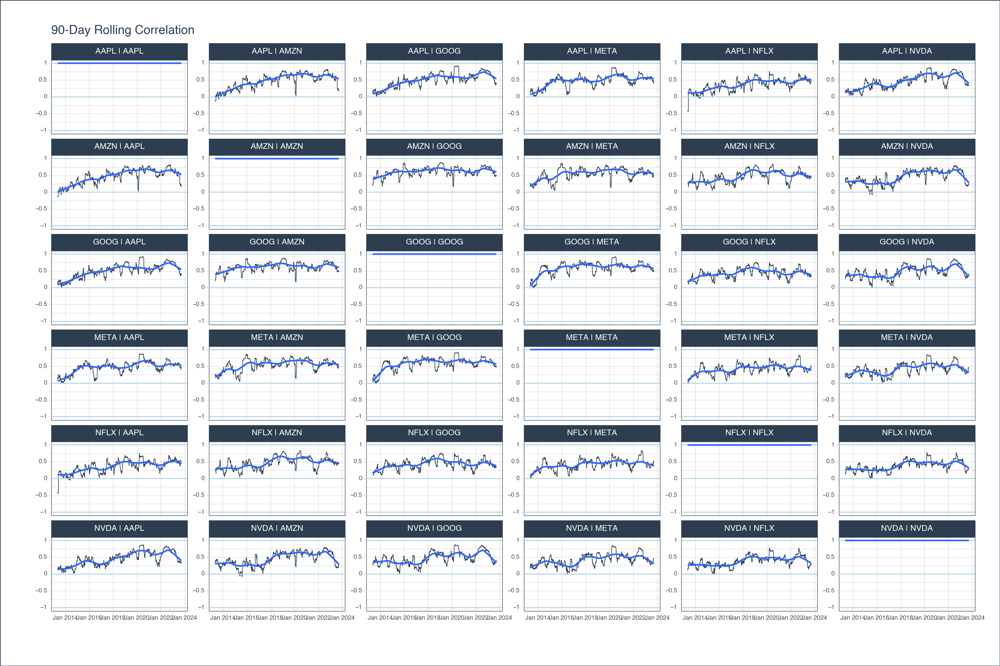

    <Figure Size: (1500 x 1000)>

For comparison, we can examine the `corr_table_df` from the Descriptive
Statistics Analysis:

-   Notice that the values tend not to match the most recent trends
-   For example APPL \| AMZN is correlated at 0.49 over the entire time
    period. But more recently this correlation has dropped to 0.17 in
    the 90-Day Rolling Correlation chart.

In [21]:
corr_table_df

## 5.3 About: Rolling Regression

Rolling regression involves running regression analyses over rolling
windows of data points to assess the relationship between a dependent
and one or more independent variables. In the context of stock analysis,
it can be used to:

-   **Beta Estimation:** It can be used to estimate the beta of a stock
    (a measure of market risk) against a market index over different
    time periods. A higher beta indicates higher market-related risk.

-   **Market Timing:** It can be useful in identifying changing
    relationships between stocks and market indicators, helping traders
    to adjust their positions accordingly.

-   **Hedge Ratio Determination:** It helps in determining the
    appropriate hedge ratios for pairs trading or other hedging
    strategies.

## 5.4 Application: 90-Day Rolling Regression

> **This Application Requires Scikit Learn**
>
> We need to make a regression function that returns the Slope and
> Intercept. Scikit Learn has an easy-to-use modeling interface. You may
> need to `pip install scikit-learn` to use this applied tutorial.

### Step 1: Get Market Returns

For our purposes, we assume the market is the average returns of the 6
technology stocks.

-   We calculate an equal-weight portfolio as the “market returns”.
-   Then we merge the market returns into the returns long data.

In [22]:
# Assume Market Returns = Equal Weight Portfolio
market_returns_df = returns_wide_df \
    .set_index("date") \
    .assign(returns_market = lambda df: df.sum(axis = 1) * (1 / df.shape[1])) \
    .reset_index() \
    [['date', 'returns_market']]

# Merge with returns long
returns_long_market_df = returns_long_df \
    .merge(market_returns_df, how='left', on='date')

returns_long_market_df

16188 rows × 4 columns

### Step 2: Run a Rolling Regression

Next, run the following code to perform a rolling regression:

-   Use a custom regression function that will return the slope and
    intercept as a pandas series.
-   Run the rolling regression with `tk.augment_rolling_apply()`.

In [23]:
def regression(df):
    
    # External functions must 
    from sklearn.linear_model import LinearRegression

    model = LinearRegression()
    X = df[['returns_market']]  # Extract X values (independent variables)
    y = df['returns']  # Extract y values (dependent variable)
    model.fit(X, y)
    ret = pd.Series([model.intercept_, model.coef_[0]], index=['Intercept', 'Slope'])
    
    return ret # Return intercept and slope as a Series

return_regression_df = returns_long_market_df \
    .groupby('symbol') \
    .augment_rolling_apply(
        date_column = "date",
        window = 90,
        window_func = [('regression', regression)],
        threads = 1, # Change to -1 to use all available cores 
    ) \
    .dropna()

return_regression_df

15654 rows × 5 columns

### Step 3: Extract the Slope Coefficient (Beta)

This is more of a hack than anything to extract the beta (slope) of the
rolling regression.

In [24]:
intercept_slope_df = pd.concat(return_regression_df['rolling_regression_win_90'].to_list(), axis=1).T 

intercept_slope_df.index = return_regression_df.index

return_beta_df = pd.concat([return_regression_df, intercept_slope_df], axis=1)

return_beta_df

15654 rows × 7 columns

### Step 4: Visualize the Rolling Beta

## Plotly

``` python
return_beta_df \
    .groupby('symbol') \
    .plot_timeseries(
        date_column = "date",
        value_column = "Slope",
        facet_ncol = 2,
        facet_scales = "free_x",
        y_intercept = [0, 3],
        y_intercept_color = tk.palette_timetk()['steel_blue'],
        width = 800,
        height = 600,
        title = "90-Day Rolling Regression",
        engine = "plotly",
    )
```

<div>                            <div id="3177c625-f91f-4c85-8cef-3736113649a2" class="plotly-graph-div" style="height:600px; width:800px;"></div>            <script type="text/javascript">                require(["plotly"], function(Plotly) {                    window.PLOTLYENV=window.PLOTLYENV || {};                                    if (document.getElementById("3177c625-f91f-4c85-8cef-3736113649a2")) {                    Plotly.newPlot(                        "3177c625-f91f-4c85-8cef-3736113649a2",                        [{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AAPL","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.061628751772964674,0.05654043976833959,0.06233025767143426,0.05234828815191143,0.05566101270856793,0.049980429106935134,0.04460687638893295,0.037164696503072414,0.016873238506069536,-0.020823436029930142,1.0304114948528884e-05,-0.005024757020986078,0.01173272998989675,0.01153370887084314,-0.013448814763824434,0.5326042655375601,0.6512659656003394,0.6595128462486416,0.6812247728627042,0.6743579579291884,0.6653669699616535,0.6677263103541478,0.6499328979037694,0.6203592523897568,0.6104037014357805,0.6135743333002299,0.6057879656591822,0.6112967427880466,0.5983217980045973,0.6320673090312001,0.6364770659275234,0.6335179554902611,0.6384644140442118,0.6228801530294992,0.6560307430748897,0.65495939767749,0.6464819228044223,0.6375202450036749,0.6293557524639342,0.6427465781998569,0.6460268685797552,0.6439441150231373,0.6189616377684114,0.6150085097920475,0.6120857858448858,0.6109825270822097,0.6104014388332865,0.6118872780914508,0.6126641354850079,0.6334087790755532,0.6612164714821471,0.5408879421652956,0.5417047489602428,0.5433166312562844,0.551671302040225,0.5463983112978398,0.5522831990963225,0.561255150491496,0.5709118854010542,0.5643518811195173,0.5347246520880526,0.536834994354017,0.5465800431140923,0.5463424549821685,0.5424621303435918,0.5495439957719337,0.5485717059227685,0.5406577247016349,0.5480084856422819,0.5358921353130857,0.5160341278582808,0.5104824051408403,0.41849893959574125,0.37975464720056434,0.4235265090628454,0.4101359354225709,0.4289365109273845,0.4377538678312727,0.4333529087507293,0.4594353137378999,0.44380662763595863,0.4169225360542707,0.4204972585490403,0.3953321660029967,0.41749829039765124,0.41856378764743857,0.4255539237935865,0.45861301655924497,0.46747975966735317,0.4915281452748582,0.4920278036357228,0.4945510261485352,0.4643957883376689,0.4787155004410998,0.4880165798379919,0.4978804579691607,0.4977995708460171,0.5382285606871411,0.5592865992536213,0.5662146403638062,0.5673471828447493,0.5729577236677026,0.5470146601014818,0.5400955247815191,0.5248972948199678,0.5106943716212193,0.5062065167383519,0.4958740749453799,0.49362629754239484,0.4996515959057017,0.5083153644451385,0.4602898693087841,0.4696152135880398,0.45567373916793735,0.46234579346168386,0.46393641067675495,0.4585427340217422,0.43082632165030066,0.4218889645440614,0.3778525638351707,0.37562690176379665,0.37481742562764575,0.36670777167442786,0.3660151684417425,0.33882105299547166,0.36536123474252563,0.3739133492522178,0.37599796668831525,0.3820800201186608,0.3629866266453553,0.3681256836971364,0.3626105533463985,0.37840120041088354,0.37740800617013515,0.3813292462965724,0.3862891690137203,0.3911236166248357,0.37937575080869385,0.3885762970431754,0.3846033753567178,0.3882013873711137,0.5006005656312646,0.49306771492613005,0.48909642407512666,0.4829578673187396,0.4904509117962201,0.49064798871790605,0.48046797656560775,0.47843995151407054,0.47060072639935524,0.47446139341710486,0.47422151647465854,0.4651843536832159,0.45667760855876277,0.4628254378611042,0.460535858268136,0.5045457844942886,0.5043881917957386,0.5050232711672068,0.5165771157737836,0.5236327802487146,0.527785619443872,0.5445572985435713,0.5586867003701985,0.5255444061778405,0.5273787107685501,0.5296131278595705,0.5321846200881292,0.5380625822032228,0.515266734282548,0.5320219537849076,0.527999335226822,0.5218861277851816,0.553679965504341,0.5419524216982807,0.5472227327353649,0.5337275531027653,0.5130122652389968,0.501331863160243,0.428915168459314,0.4333374995734535,0.39176185120960755,0.4191175250556511,0.4072753641575609,0.40935956076307944,0.40394696960415105,0.40333517401522706,0.4022849397396002,0.38386346118027437,0.3892382424296473,0.3809373075556922,0.39358683197923744,0.40478193158163145,0.3987511163842571,0.4243701882284657,0.42204148195163954,0.4283338453413531,0.4264881255480952,0.430033134690529,0.4339726012999554,0.4316834209048008,0.4666454787328452,0.44739204978905867,0.45622354706957235,0.4544771404591086,0.45158784332870266,0.4563693243210024,0.4759900416190812,0.4776820638905564,0.48928456681344673,0.4956500823291817,0.5000038947151154,0.5079322741536769,0.5131301318935827,0.5129529864250306,0.5072571630785471,0.481647569042467,0.42576448366084263,0.42671734194723604,0.43455866359439255,0.42606898135812815,0.4268474881378286,0.42090600166234193,0.4173746851626171,0.4135469485811535,0.408583337882243,0.4034220903173148,0.40756809033641056,0.3780098949881183,0.36956100257196955,0.35836454915756466,0.35862754858592183,0.3608707612118534,0.3628951286631081,0.361811874360658,0.3593825152709536,0.36330961056766475,0.362223345235043,0.36662938894318126,0.4338671956960079,0.37709871748566054,0.3622119766810156,0.3578486810351174,0.3622466398679281,0.3568415771988055,0.35476485871750724,0.32751768202855525,0.32884836636748516,0.3290389196313413,0.32705106875335394,0.3220040756462834,0.3199815226467537,0.3152455750676175,0.30683195611750524,0.3098808381567034,0.3133518534872242,0.3164156289916898,0.3093114383080201,0.3038083671695421,0.30732454252503916,0.2992583207458058,0.3078922500266456,0.307728258094994,0.30455951057960107,0.29910464493505334,0.30107430271618774,0.2977104942278084,0.2834626041647359,0.2861576012265923,0.3288584614641786,0.32134345805993125,0.35842677631740627,0.35779161122782044,0.37739264246005727,0.3734539678069778,0.3740322708917682,0.37303717487456217,0.3658175213306829,0.3662058886011327,0.36475292988874597,0.3637527613379229,0.35831869587477666,0.35404290396453325,0.35193170716525324,0.348075043026713,0.36052128552209384,0.34974244608236915,0.35415842111537643,0.35551018535889223,0.3438872822060097,0.3442307538198248,0.3372342095651206,0.33946560924672486,0.33417199776176804,0.341181387429104,0.34358201154983276,0.3440057387307635,0.3550708403920444,0.3621260124990759,0.36076390433343397,0.35122476831648647,0.3497569656730395,0.3476069082796482,0.3342487321811884,0.3339759312436034,0.3346105909048991,0.3356855900196899,0.38989246072891603,0.3889527317275515,0.3834218470689241,0.38359081325596234,0.3825323603814472,0.3814077262789882,0.3804741170639143,0.38246984185888894,0.37956369391056216,0.3807893731837731,0.3734248071272823,0.39129375586184584,0.39160059175295675,0.39301387041666697,0.38818274735150876,0.38972939956592706,0.3877601799869494,0.3944752795396915,0.39043355820927217,0.3800921744050789,0.3927899174162616,0.37826800190700427,0.2996800349890078,0.417103432287377,0.44869519799122104,0.46253328345280087,0.46632331284082723,0.471612616047983,0.49271064766297124,0.48534795585934887,0.49501212651722626,0.47734770446513336,0.468493251353705,0.4698501163374869,0.4829159787136954,0.4826514609368857,0.471361524334052,0.46721970191905204,0.4541432486239124,0.5284211069526785,0.5540089252715492,0.5748355317913815,0.5753184175380006,0.5864458764516571,0.5737724026270046,0.567013293242841,0.5541001717852239,0.5550507708250535,0.5706046342328553,0.5619174452805135,0.5266008409011361,0.5375506389978337,0.5230494819733149,0.5255631745901816,0.5044907477623578,0.5107100596451487,0.5136035578039878,0.5416148368424228,0.5421094332077107,0.5539330786919353,0.5541761454460127,0.5571861161370883,0.5596673188685751,0.5471821434903221,0.5456774149191271,0.547002931766646,0.5494644185254428,0.546966081931848,0.5426599306865195,0.5573102812462454,0.5580849984828212,0.5543261519388336,0.5683604580719838,0.5781340853990615,0.5905039082378104,0.5915661005204204,0.6036748097532989,0.6086348667004494,0.6064771541050976,0.6105539750725469,0.5964420189093607,0.5968696306446508,0.6019414371127334,0.6094206215361568,0.6030003079876096,0.6490593285141829,0.6754355409887243,0.6751006979629538,0.6735344497287886,0.6846268238651051,0.6815441958345256,0.6883791256045634,0.7076171260304569,0.7031369108921964,0.715432385883463,0.7251948186856357,0.735481391600398,0.7370334367050879,0.7557890462502155,0.7428761151762135,0.7423578367324168,0.7429297868025151,0.7417456939527716,0.7439744290963208,0.7439896574790734,0.7484316183927837,0.7575569689714307,0.755409501405057,0.7815818037606989,0.7711842810017364,0.7748720161780472,0.807924090545732,0.8065170878883247,0.8009247662272998,0.8074800886569944,0.8060063581651666,0.8223220495422021,0.8020478671863951,0.7985358777582712,0.728377407730943,0.7359501341846162,0.7503312326817244,0.7573123138108635,0.7820906137753679,0.7813611428974069,0.7985109320814967,0.7774035258906272,0.7775882655517047,0.7774203718595105,0.745974228443161,0.7328052173473644,0.7340422031659568,0.7326665925854231,0.733508073857878,0.7388943110667466,0.7413044804371068,0.740447065861227,0.7398184435438321,0.7347669823853324,0.741248535874236,0.7710317290099666,0.7572241481960251,0.7679561391430776,0.7605624208274491,0.8074865126279425,0.8139476623448356,0.7992497770951623,0.7869300464896671,0.7878788080176972,0.782498427365453,0.7776576929850819,0.7750316354438062,0.7846929696123415,0.8113446321213559,0.81686716137152,0.8329938664694735,0.8344270273987714,0.8370504079183011,0.8458065159566888,0.8429468354038826,0.8371298325174406,0.8319391344785324,0.8278932623707937,0.8318408625727232,0.8293990459322788,0.8295896321752132,0.845378354588421,0.8469385145285414,0.8474650540127772,0.8435409862378885,0.8469229492868082,0.8445678640405381,0.8330512148308921,0.8315527055380751,0.8308772459070225,0.8049592063360446,0.8081775742516455,0.8085817979161901,0.7533391883256366,0.7547221015137153,0.752174035454344,0.7488768407158247,0.7441584786467198,0.7432730613155162,0.7094425057438596,0.7030893685791395,0.7218881543367285,0.7206570684761443,0.7267037217644731,0.748702049187699,0.7482800718613518,0.7619907725025771,0.7626116767847735,0.7562757223678739,0.7513358790437314,0.7489104591255107,0.7381354024743089,0.7380522637561798,0.7283108711259593,0.7501350428728953,0.7490340490830991,0.7126564131718153,0.7174123388754274,0.6967932092971716,0.6920449281336304,0.7092445203374148,0.687526622557891,0.7090553478696718,0.7016589712445429,0.7885896995042446,0.7828090859210894,0.7830878998403722,0.785216848759616,0.7360427364378521,0.7508791986160048,0.7132652038986762,0.7687891353970357,0.7650302023428771,0.777955046065632,0.7770894007248055,0.7762420145685273,0.7728612769653106,0.7692458377737473,0.7618001667112422,0.750625159613383,0.7433048277740573,0.7390504766655334,0.7421377335191947,0.739412454416723,0.7517833579770626,0.7512364746580349,0.7760037341008731,0.7762802281722974,0.7844851422258323,0.7775347324772557,0.791792067970216,0.7976599288335259,0.8272401681269475,0.8270583701414393,0.8284793952574083,0.8440072496660277,0.7371275958998068,0.6804509874384654,0.6656758350810685,0.6567709537091256,0.700267617405233,0.6943867525201799,0.6854432219086488,0.6867875898119074,0.6894322413256755,0.6919667632341081,0.6993632233499768,0.7039033136324191,0.7033098889145547,0.6972494260196728,0.6938659836584421,0.6772773279190567,0.6704113422340606,0.6950245331101251,0.7200660641529716,0.706916891619089,0.7044896882129026,0.7123951733375276,0.7126480566980853,0.7123328563201957,0.718437198808663,0.6842576419857471,0.7621801381326246,0.7677519821883321,0.7691670356819909,0.7785378407859764,0.7845211090967302,0.7822772865654837,0.7774921808327585,0.8073724994963923,0.8305653888885725,0.829096869322986,0.8256227106524081,0.8277364677663858,0.8186627128183738,0.8252458495078285,0.8206933242423999,0.8171938815673151,0.8171249975505303,0.8166706977757365,0.8127915133497028,0.8123641348656847,0.8148435884123345,0.8047277993745161,0.8050756229632859,0.8025434391392737,0.7986199071025527,0.7938421728320905,0.801115095963137,0.7892926744465014,0.783362130186353,0.7793425560998022,0.7701723306481347,0.7666767698456999,0.7666877726268138,0.7645624549970216,0.7676146104075201,0.7660521371618331,0.764287423400611,0.7670352804035553,0.766954003086548,0.7649652387480724,0.7656335375078057,0.7508130392329064,0.7506243601124942,0.7530465003187411,0.7585285658214143,0.7545890426131183,0.7541460052283431,0.7682806418011325,0.7682210413818622,0.7701047140274945,0.7726937752907899,0.7740181890911194,0.7711801791069323,0.768928362419329,0.7583543485301519,0.7546914128428903,0.7579202411395507,0.7585436848061562,0.7478034110684022,0.7505196829652276,0.7436292281599093,0.7397390979321599,0.751420125990908,0.7533586285312358,0.7858052856616515,0.808011679328577,0.807004382778666,0.8075185779747955,0.7903477979907438,0.7908717470897817,0.7790526926922999,0.7783233287467096,0.7768006528297751,0.7907145883828932,0.7879762606234154,0.7863777914449872,0.7866972711325428,0.7915715939477739,0.7979742862090438,0.7931350382242776,0.797433228519487,0.7847692959142507,0.78221039399457,0.7898695208850127,0.791467947669097,0.7910818384970394,0.7912801433001624,0.7913186869048822,0.7880892237441882,0.8098563677282358,0.7747162603994703,0.8037308086439875,0.7744815622182177,0.7651937652969281,0.7528770755679728,0.7758619428387067,0.7722188542215375,0.754582258203263,0.7242869331601068,0.6980931183665499,0.707259935851146,0.6890928325311959,0.6854906920979298,0.675713094327452,0.6739493311019481,0.7227783108704955,0.7277613788189877,0.7314087403192439,0.7967885863838041,0.7291268309258472,0.7294545394055778,0.7294026871172548,0.7317333953793276,0.7130959661104124,0.7124968847120957,0.68711696267874,0.6638280705135259,0.6738623288993143,0.6711737289840819,0.6723081384080709,0.6824301768708639,0.696113234958979,0.6899474106702631,0.6956189908394544,0.6905325550066899,0.6858420792081893,0.6926242605181521,0.6972815818837291,0.6976492588781865,0.6982599537289783,0.696317517541861,0.7255029881201943,0.7273583918462195,0.7234813271210941,0.7190623628449182,0.7204980928264542,0.7208583247602732,0.7022595744599404,0.702455338506146,0.7039216998324492,0.7012475838187073,0.7028647616918497,0.7094231970779923,0.7113424960736527,0.7226164090240652,0.7246825939071055,0.7251340739740375,0.7252949953777851,0.7273033083063268,0.7193914559700249,0.7257977831009442,0.7293740442572857,0.7167948204318129,0.7170212841153442,0.7136286952859893,0.7146731623128568,0.7185751892772881,0.7239914212876468,0.7238079461554625,0.725196167971195,0.7444331754791841,0.7458455247529543,0.7453786929314385,0.7304883843002231,0.7353602139978842,0.7206094664569271,0.7146544184510606,0.7153327844424082,0.7030560897654734,0.7106968196531478,0.7076833489663537,0.7370465778249341,0.7359658109337204,0.7172025606724901,0.7069816675504719,0.6995460985374948,0.6987008545595899,0.6985398203643316,0.6954228613766041,0.6907120804115523,0.6852569963017716,0.6819476805566423,0.7101361893383519,0.6943439882894372,0.7138728784990278,0.6883369384380903,0.6975711159449169,0.6935498259905396,0.6913140713998384,0.7071258551925373,0.7017612841133949,0.7082959148046459,0.7132889806614673,0.7140566486359369,0.7134093924772147,0.6715527278633282,0.6646987429198992,0.6602454984280886,0.571568665681799,0.6475064414151018,0.6439577484689041,0.6479217993159928,0.6325916958651563,0.6699452171194094,0.6773529992058808,0.7296078262094948,0.7698251433327815,0.7830512990018184,0.79071160044136,0.7852349136811092,0.7849243719948344,0.7598871600928555,0.7751791582268933,0.767005691842911,0.7693000242506388,0.7862120691124298,0.7767360831714565,0.7659030747480164,0.7650516996924395,0.7661902049488812,0.7706775151725977,0.7277073966408457,0.7281556685931834,0.7328387401041863,0.7290853572685879,0.7605454343891047,0.756302933579762,0.7620963999227431,0.7370243345728122,0.7310695210899182,0.7270344250495459,0.7200987136407975,0.7114307278629887,0.7099866476810393,0.7777496712855286,0.7831404155046515,0.781017525855959,0.7914322886335237,0.7975200790642598,0.7981448066487599,0.7842515167743619,0.7884025596388641,0.7866424010122822,0.7875380813174441,0.8095991117361313,0.8026115788236979,0.7953350899721349,0.7740375966630471,0.7744440266755557,0.77776194925888,0.7744904326838095,0.7674354009206396,0.7693017648220639,0.7676225607771314,0.7590394775945162,0.8104953745562224,0.8091669244004975,0.80538683471311,0.8285922020787198,0.8267451156293246,0.8328808464677802,0.7440011748431342,0.7050233924088386,0.7236466596943945,0.7642642313771701,0.7877984400195991,0.7974936473381796,0.7584000164562733,0.7972339819764368,0.8272139058323006,0.8395345413684367,0.8410385753027071,0.82164371787985,0.861832861879164,0.8306260655243249,0.8448974612788194,0.8332032880471946,0.809381578888168,0.8121369418516352,0.8213966780227231,0.8237714768324356,0.8116476995566837,0.811566920225875,0.8064032173526523,0.8028453092554196,0.7938521982157962,0.7986391133360212,0.7921658411938551,0.7923726234078383,0.7938743009021529,0.7940103607108732,0.790197089593341,0.676367801338376,0.6635685080049093,0.6636923213591145,0.6550136704017192,0.6508306492601837,0.6242394992303304,0.6454807932536168,0.6550392229668881,0.6560926957966019,0.6610245689446911,0.6578178652502537,0.635228231395383,0.6353582850385475,0.642869350924822,0.6272617305034383,0.6343591956193035,0.6265368191454634,0.6521799968154428,0.5677590108430486,0.5936398473849952,0.5941783540477918,0.6133762050412253,0.609937578543208,0.602232100562465,0.6074092920473639,0.604885003919748,0.6212646218884962,0.6241968080853946,0.6253220919616861,0.6275549302909782,0.629906496422099,0.6322855581340046,0.579060666415045,0.5623419867481843,0.5651707409054508,0.5598432535034059,0.5486709939172733,0.5520142898900887,0.5515644373999474,0.5531546355416868,0.5522239307077683,0.5535825298581831,0.5512518039129903,0.5540056309312127,0.5559731984566043,0.5605092829797276,0.5631244235774754,0.5630046003417516,0.556729516142757,0.5492806776686819,0.5477999667667404,0.5448150415872564,0.5427846811015112,0.5396888093537394,0.5412346142510038,0.5443811598457167,0.5438458977637147,0.5428575946808601,0.5424746624136282,0.5437861301815058,0.5492329589794719,0.5449182280002909,0.533984221552707,0.5136153409308521,0.4979416766270069,0.5222782523896728,0.5013077275378731,0.4788423170624384,0.4805521295447973,0.47563698063667154,0.47247034272987465,0.47232313276028653,0.545794209002028,0.5381966228231295,0.5396237636236618,0.5508568410449445,0.5519444296254981,0.544435356575407,0.5407410359179146,0.5433577536027845,0.5379432087697306,0.5385228844135037,0.5416992093167198,0.5425534001399617,0.5389508551777957,0.5468117762201474,0.5470687261421096,0.5382155774696629,0.5379298953980792,0.538156171664703,0.6046325523054298,0.6182961089989358,0.6168612044043322,0.6229618513818928,0.6270930041523952,0.6277015406820626,0.613281347021936,0.6085249129378304,0.6059420302135593,0.6010434057536784,0.5867470842341699,0.5970903836177586,0.5919283792319291,0.5860765852589817,0.5968219070754605,0.599417107993212,0.607276898978649,0.5748630891478658,0.6924254348718542,0.6596874509922896,0.6785876860386979,0.641525219234911,0.6436457567309889,0.6447503996185899,0.6411880275649862,0.6157229087836932,0.6158280407390659,0.6184627121659994,0.6185015969475114,0.6186376802896972,0.6217638049468328,0.6209282279303562,0.6273217144456134,0.6287468264633619,0.6348015751923709,0.6354810102237572,0.648161637369629,0.6444224162285832,0.6428736954819512,0.6158803660504328,0.6273416409471563,0.6188590299580721,0.6138087858493112,0.6339553300779813,0.6326971174940134,0.634444687354912,0.6309152648208738,0.6261375466070961,0.6696005494107621,0.6920298091984195,0.5682372015905454,0.5725242742022767,0.5807861882546341,0.5844818021960347,0.5852221110153225,0.657188874193036,0.6580669871455701,0.6579571956722347,0.6572030925631875,0.6556560246142649,0.6593687507188688,0.6635344954166328,0.6625891645857437,0.6679823894694387,0.6726720218469334,0.6765629300361681,0.6906923447322678,0.6764887255862904,0.673418428008761,0.6748283458966442,0.6613189107773574,0.7200151711416062,0.6452464758947649,0.645133885965929,0.6546775340234229,0.6541887460031317,0.6509067705168214,0.6803651905513736,0.6881209318448371,0.6856744289822827,0.6951611958890311,0.6983319100338162,0.6947062636249175,0.6840451594370903,0.6877313833055227,0.6881865939531997,0.683706581334213,0.6856572898057708,0.679465516298862,0.6841410283393238,0.6888894169559506,0.6681442150325843,0.6728625543248827,0.6559384678937371,0.6525851227821637,0.6539941266332262,0.6530333331279924,0.6121842836450743,0.6122315958828191,0.6152760062591259,0.6146600112951072,0.6140363259234849,0.6077099805076971,0.6088189700321787,0.6186097046033574,0.6207376070951413,0.610734572597133,0.6128131683817272,0.6244635231712992,0.6284755574527412,0.6221650064119622,0.62954908414785,0.623898418152061,0.6213321118110043,0.6519438984923174,0.6628737880781315,0.6627251071382773,0.6587105184007932,0.6596094037110243,0.6687518939117442,0.665958229611485,0.6668757438652727,0.6720892111073624,0.6831499762046973,0.6831786682739429,0.6775598252766617,0.675699713232522,0.6769933089538289,0.6715234541223352,0.6748790354323957,0.6734373934368701,0.6805553536320618,0.6811258617971455,0.670617426558667,0.6801123573547558,0.6862142081979756,0.6848202433181713,0.6871937984312746,0.6801656983338021,0.6821334748759357,0.7330869216669053,0.731160082252748,0.7304702091611636,0.7401307566527048,0.743017435864637,0.69815013144607,0.7007099462952441,0.6966844329527263,0.696344704344096,0.6961951999424733,0.6965760586794194,0.7014274901017244,0.7003824753589356,0.7003565794350084,0.696979078303296,0.6972822812166104,0.6916340862062766,0.6955939763836069,0.6979515318695605,0.6974630605059035,0.7169516658366083,0.6839327313088088,0.6638227327183884,0.6796488194755488,0.6758578600775623,0.6660053536133406,0.6669523688704102,0.6412189589712259,0.6386367662327033,0.6489872431305328,0.6560573484537416,0.6562931550908117,0.6565291842018913,0.6575057684744134,0.667750042941433,0.6656099808275342,0.6692036971389606,0.6814360538373977,0.6854980329490356,0.6796867476132855,0.6838442200287916,0.6984292135041973,0.7061271658398411,0.7323015752797505,0.7356555697966214,0.7358079349000493,0.744751719934743,0.8114895982517879,0.8066774970697841,0.8075112945977602,0.8110955762360856,0.7721615364149469,0.7822618254822764,0.7803906402219469,0.7512276824083424,0.7505111797047856,0.7511908878107313,0.7455158313748008,0.7286337689055512,0.7308476248033621,0.7308607601198522,0.7245655424932099,0.7292854854762842,0.7325278223653623,0.708400174324951,0.7153474144541634,0.7169726639977825,0.7196104606969745,0.7186192131960496,0.7216659845225942,0.7212397206956216,0.7207007313794153,0.7178239056758832,0.7162034421635199,0.6880468496653405,0.6950212250526708,0.6955197070578264,0.686116726046911,0.6907151740368505,0.6924261449049443,0.6928397203109913,0.6891127209618253,0.6917331120097814,0.693885613875556,0.6841911381705181,0.6723181078503496,0.6463049848823869,0.5998649802249669,0.6020696168946422,0.5911076107491506,0.5859606982514535,0.5851341964006816,0.5800486879126152,0.5685688229892147,0.5570421423468656,0.6375811607758309,0.6096234155430802,0.6595998660566698,0.6713718272130074,0.6604219796479729,0.6609383234387529,0.6868422321483652,0.688976379743861,0.6895090904131617,0.7113684957516007,0.710389534436712,0.7096479223651525,0.7103240472653333,0.7092370840612905,0.7130320051085773,0.714611104172446,0.7117023059965342,0.7096654981549754,0.7033396470549483,0.7025792641954512,0.703496885562595,0.6995786855690078,0.7006971430174892,0.6994791037993537,0.7007185746627856,0.6952794767908599,0.6951086399073758,0.692972389012238,0.6961111682592517,0.6866591413334682,0.6733341146278413,0.6721699215216481,0.6794031289729106,0.6736081965090001,0.6783087402736969,0.7166569191752941,0.6926058359872214,0.6872923137900062,0.6736570359657337,0.6497835387929132,0.6512293396774681,0.650749625172643,0.6504679060031121,0.6602112167835239,0.6612985169302866,0.6596291594398284,0.6690236137269872,0.6673711261589232,0.6676939988351429,0.6757742980834835,0.6603035946207755,0.6622780691492614,0.6686127299173314,0.6883688810288362,0.6831471240343125,0.6739947661640671,0.6730329950724506,0.650299345234202,0.6489662793832567,0.6435627386210532,0.6485148837974577,0.653797161920777,0.6544494944490198,0.6720933978746443,0.6658736574775659,0.6659316767542529,0.6646830054309015,0.665028061807443,0.6644307831486447,0.6744170392996793,0.672575792689663,0.672089458761539,0.6758651627950685,0.675880385347428,0.6763291986943063,0.6761977928828856,0.6730496646023629,0.6726513733445473,0.6721883199815468,0.6724359972966568,0.671969876603627,0.6816072787766787,0.7051828603600887,0.7036609061564216,0.7083976303723583,0.7118120906593286,0.7119386299130193,0.7123491467072276,0.7121924767916813,0.7147219328773737,0.6923553917884124,0.6991847728670876,0.6801751868537627,0.6715495672149655,0.678407420426861,0.6789779047812946,0.6594216349532446,0.6574972655500877,0.6439828602197364,0.6279102936785208,0.62153847897471,0.6222093659139459,0.6214382609988393,0.622855318365115,0.6234555868912347,0.6152080088238328,0.6194167395163573,0.6234709028528999,0.6188510453530356,0.6220964214098434,0.6302397185309438,0.6321586455872666,0.6328769067878541,0.633029148909688,0.6316912401857835,0.6260393299123274,0.6252789298344554,0.6281626786871951,0.6286610171513609,0.6286353229324861,0.6053900398840275,0.6126999630762633,0.5968581273293051,0.598152178560882,0.6139366161360396,0.5878887982808647,0.5939348063454334,0.5891818264184562,0.6040023683510989,0.6345131472531904,0.6325025358129451,0.6258350206786591,0.6253189660953948,0.6049839278300456,0.5924371239962073,0.5853260453617471,0.5656354911724779,0.5613578186486343,0.5584313865586159,0.5518432908156715,0.5766306732261999,0.5662203907305854,0.5547285555670656,0.5074579570185926,0.512667242850271,0.5110862275626438,0.5093384644955428,0.5605397487652666,0.5513743928985929,0.5715455623951556,0.5618360596585208,0.5520884442479239,0.5684572075658457,0.5296679476779412,0.540831781315473,0.5435750175608616,0.5787197438101921,0.5690004343001291,0.5674117548642392,0.568439115105035,0.5726026965499177,0.5770839258767938,0.5758292200779904,0.573326968844276,0.5839185158615406,0.5831824696932775,0.5909059456222312,0.5823497283085232,0.5843837347777546,0.5926084834025742,0.6082981852368112,0.6105617253797772,0.6069631929395245,0.6515730503411753,0.6524625048422958,0.6748932331506239,0.6869368741242676,0.6811617407241225,0.678051514642243,0.6861140654149076,0.6781328437658332,0.6899119962958729,0.6848786313116751,0.6662404125726791,0.6533299227293117,0.6455138713404157,0.6341431753638611,0.6228789101595176,0.6254911620428303,0.6239273373589616,0.6652772765365713,0.6751515809448881,0.6762851172495221,0.6818011658214904,0.6746111577084564,0.6827084226070145,0.7120902838186326,0.706624373923241,0.7128269977309405,0.7183777690865981,0.6737036755271086,0.6754321197594064,0.6784774317395108,0.6783283358804462,0.6831504731928948,0.6764178631594611,0.6760799830875994,0.686105516718808,0.6852155115968163,0.6820948131832452,0.7096237099485305,0.7178941586970871,0.7178751201328988,0.7234355488871778,0.7044378527484105,0.6965721178498634,0.6938901213007683,0.6971656701035787,0.7059295935478227,0.7025528303786525,0.7012997246972953,0.7056073494948218,0.7090427890883698,0.7132478169327793,0.7200833928974791,0.7472298875347114,0.7507809563631491,0.7527177019194309,0.7551703681930213,0.7546568710152632,0.7990671425341904,0.7991520296664499,0.7905106203534401,0.7928713703953956,0.7933877306653154,0.7926733639780731,0.7908495880846931,0.7915651859756248,0.7966787621131545,0.7962895980636632,0.7965550495792786,0.7972513005510099,0.7901527742196874,0.7898990102805359,0.7825069272238654,0.7897577284256458,0.7771847574427684,0.7751881674932879,0.8010782832554103,0.7892460753316219,0.7884455103100435,0.7915712326456767,0.7931331445522708,0.793435195385306,0.7910403347072056,0.7909418781378492,0.7906864520856337,0.7894147679543644,0.7884766143656158,0.7901247614866735,0.7901785574341921,0.7907760263757982,0.7899341679910751,0.7916804131641739,0.7927331854195605,0.7876322955262313,0.7863320828268624,0.7875681786304891,0.7890176390948666,0.7901601983868312,0.7953439698705104,0.7943691109495515,0.7958916932178204,0.8170992067639598,0.8247518879072109,0.8451659619191308,0.8648210699290068,0.8697945846997446,0.8724138534551525,0.8748248269681912,0.8533545754452708,0.8465492944535865,0.8437337551225289,0.8511285471322264,0.853847906320024,0.854260783705876,0.8419674841838901,0.8408823177350427,0.8360132480859642,0.8322419507183685,0.8734090145234594,0.8976942884180681,0.8897043931352956,0.8897580758359893,0.8845339408889858,0.8946966857899786,0.8947588460446676,0.8936529465850995,0.8941137162756235,0.8954884589332338,0.8863045559463991,0.8861308277252455,0.8919870430659751,0.894747476474671,0.8922658482249906,0.8927658357639728,0.8946968930200462,0.8947178439263549,0.8862672461767991,0.8963289327494547,0.9019162732119519,0.9099292406919337,0.9038750180544396,0.9102532889386798,0.907486175611739,0.9050520351394604,0.902795258035733,0.9043790000885592,0.9075776164405586,0.9514647898752785,0.832161354803527,0.8516634625988174,0.876165829215143,0.8669924143371832,0.8813080990750678,0.8858195023258941,0.8931880932960967,0.8880976335864216,0.8977676563345074,0.8986323418909636,0.8949019893569492,0.8947161540456103,0.9039634731418256,0.860421530449671,0.8816363747157169,0.8690195975468006,0.90612312302242,0.9238053459488498,0.8585004486035118,0.9125818612125719,0.9121719731852354,0.9002600906026622,0.897753582829357,0.889547243881447,0.8961776404752664,0.8957361372111086,0.8952102129511347,0.9115275337982617,0.9106886112562569,0.9087882091252317,0.9155373058712003,0.9108576078781944,0.9107467386800052,0.9174259505155767,0.9192368223776163,0.9185706506323569,0.918527866787988,0.9286564832215901,0.9242264319967668,0.9225753331869805,0.9224453387813749,0.9258491191485524,0.9237413600885648,0.9296849293312381,0.9306880479112867,0.8933790232418203,0.8944042514700145,0.9090362411225994,0.9181800735061455,0.9094744137129198,0.911370599652678,0.897683572790201,0.8996857238753068,0.8751918691950833,0.8558592021879087,0.8648770932225859,0.8737756959465308,0.9218429760273763,0.92678325815085,0.9279424311214413,0.930686840826325,0.9225049716633036,0.9210260924806427,0.9484014715556488,0.9411832889038406,0.9393900823025838,0.9394137632743235,0.9307917409489257,0.9223593127358255,0.9244115381439981,0.9251145508025906,0.9553799322056902,0.9562983608734243,0.957778091528548,0.9703856086557964,0.9665929269263819,0.9679351729091272,0.9719827837668735,0.9720326519678214,0.9640604377737286,0.9593729868963868,0.9452780447735613,0.9440554310637413,0.9569814652991026,0.9529842289699278,0.9478874502049571,0.9459130214901172,0.9433527664023941,0.9389120459708985,0.8982856363803965,0.8944260666879534,0.8990401682433162,0.8910412879338264,0.8875235714753414,0.8716367437085514,0.8651892464506037,0.8684452053598731,0.8670144136075134,0.8774057412362171,0.8711626516454887,0.8833186660094952,0.8830897014578828,0.8809522000047217,0.9252304834035484,0.9213418610828448,0.9296533778204982,0.9274139952840053,0.8984248123928743,0.8975821887684803,0.8944833240606548,0.872623974472167,0.8768782878837601,0.8654735264034338,0.8758197799207355,0.8696527382085615,0.8703255904738829,0.8684196702288224,0.8789928661159654,0.8768066262106143,0.8783392806181937,0.8820861016586887,0.8793952545646153,0.8795448972090136,0.8759775328145495,0.8768350955590207,0.8774568585025996,0.8767021380472466,0.8661100589105885,0.8620718753867358,0.8606368616405123,0.8631752211385546,0.8563690832008299,0.8576994172770186,0.8588630239622306,0.8574113784222176,0.8816883091176712,0.8769007050681056,0.8724368434256423,0.8737371385079288,0.8793268320926043,0.8778589969758195,0.9047736466916942,0.9121901785578761,0.9116895923856169,0.9355071598425205,0.9298004182255218,0.9186186557986539,0.8710019317216791,0.8668847688391722,0.8651947408470565,0.8755658982181,0.8739279532215116,0.8732634760685186,0.8279478013421684,0.8222735256250556,0.8192244901221482,0.8153039562889592,0.8316554361365026,0.8457966595565006,0.826122864812511,0.8265579511564658,0.7562223103896842,0.7555432956595645,0.7371449936572354,0.739382746976076,0.7450785232249376,0.7519487074352476,0.7387905503093708,0.7435720284317651,0.7626492009276077,0.7673212128044117,0.7706701561382149,0.7775609567833045,0.7607371584638477,0.7578688314909302,0.7386311103667746,0.7453241123668752,0.7823774248168613,0.8059255422494765,0.8046657362923239,0.7996858457212753,0.8543878569093719,0.8579304548515032,0.895224652416741,0.8963416789276213,0.9060118904709643,0.901576799857492,0.881894398372739,0.8575431696245042,0.8805145485493566,0.8672432100844455,0.8564692117902917,0.8468916343324802,0.8472544197386982,0.8506010878768056,0.8392392790047996,0.8781904955985294,0.9318932564405316,0.9309846817981026,1.0057900904764072,1.0297549052112502,1.1534728580579794,1.151088102058222,1.1437511905415085,1.1299680329954747,1.1257192021900295,1.140383317849889,1.149575798308967,1.1279973786093884,1.1053101488409056,1.133251275667193,1.1184970349180532,1.0997956490853154,1.1004659810578388,1.0813666189557232,1.094930043239232,1.0853854825919556,1.1067742397815656,1.101292509266442,1.1013652878124431,1.1036370876286217,1.0972823958222995,1.0972598706834713,1.097839591767269,1.097899638006184,1.0948311196515925,1.1016091759267315,1.1017614645071103,1.1022938402616742,1.1024303710482075,1.0993526778023524,1.100061072346042,1.1000022920875565,1.0972301621244833,1.0969752049121528,1.097273364998644,1.0945162490093165,1.0935491114549007,1.0929911641095382,1.0953070650682255,1.0945555790260717,1.0908081385924258,1.0861422187238172,1.0879808449157504,1.0831867644808604,1.0826339252231347,1.0832429898102993,1.0825845914730794,1.0826292081600557,1.0869235560923085,1.0870204629397384,1.084361268023691,1.0850131772684566,1.0859142098885983,1.0809223782951474,1.0816014811346502,1.0806930005769326,1.0803890940933603,1.0787868779995877,1.078786819691924,1.0768271823915132,1.0758732741590136,1.074820800069223,1.0728884868991782,1.0737717458573786,1.0747112028076113,1.0744118464824588,1.0735884820578445,1.0737696049741672,1.073396368607758,1.0752585324042354,1.072048636432497,1.075125334803798,1.072927371287395,1.072502396054171,1.0737475520085233,1.0725770906360585,1.0749095404939786,1.0746170022429922,1.0745580011693916,1.0751500282767128,1.074980365972311,1.0766180687587867,1.067541018685947,1.0685298930673526,1.0669529628562948,1.0590922350610543,1.0574035230797654,1.0554920411486677,1.0470250608732266,1.0492616000078532,1.0282335861245655,1.0282094559542754,1.0188835643461276,1.020900596483729,1.020270120609509,1.011893016001353,1.0005714078533166,1.002348985711268,0.9985707439111936,0.9608964336437841,0.9428852438579898,0.9544246315569221,0.9540402938955225,0.9736405817185496,0.9473685933019342,0.956916916830096,0.9579648730056025,0.9718391380264532,0.9678997096677595,0.9553965041959482,0.9724723197174924,0.9780794689812942,0.9570095417223028,0.9640043925599011,0.9715814750147811,0.9392419915458834,0.9368424705515933,0.9292381491784159,0.9274447769826517,0.9333929705537666,0.9233183810659078,0.9328542866468768,0.9418309003302889,0.9341606199881046,0.8855156029155997,0.8787661290337955,0.8784482862444127,0.8845348705169794,0.890822771639288,0.8792153125002222,0.9483819044118985,0.942482963607506,0.9843997499508267,1.0033959676658741,1.0117783752973228,1.0132144103667475,1.017921752205469,1.01114174042705,1.0118461082849655,1.0098153168537138,1.0240779949843424,1.0262213287384088,1.0221324417443396,1.0420242399029398,1.0393769442818968,1.0451725412321011,1.050330703087965,1.051114063052602,1.0519676757711778,1.0480631034352574,1.0488342913036697,1.0502507594932402,1.060278022251763,1.0574026258491651,1.0572772124758343,1.0595305977550653,1.080321902144977,1.079349688050871,1.0740114075619909,1.0722081218256645,1.0707252077991605,1.071058915028813,1.071382016086891,1.0731090139596335,1.0709077811430905,1.069129778387295,1.0617455159438562,1.0611139025032887,1.0609975237549523,1.059482166907171,1.0770762578489332,1.0775006404032974,1.0996660574523058,1.0737091600695914,1.0847428722189636,1.106622962750215,1.074245227452967,1.0721433327305996,1.0727468688902675,1.0725383392547025,1.076534414603789,1.0840256892005131,1.1007605175882273,1.1006857934616663,1.103038959022599,1.1023415349579075,1.110997213271835,1.1229038258448183,1.1237260954337127,1.1232956109692052,1.114588177431009,1.117263400891136,1.1166799944812598,1.1156511961544786,1.114948705430026,1.1143849547343672,1.0580378687212217,1.0513294566046263,1.051943603532514,1.052248582417992,1.0429224789241234,1.048486995738222,1.0522898459508587,1.0497875489616033,1.0487996380366662,1.0467378075013691,1.0444865160600347,1.0500366804287926,1.0535287112231686,1.0621993875666595,1.0606211470565885,1.0491605112389204,1.0476463142827248,1.0553370592461981,1.099837106178511,1.105050254488013,1.1092140408915063,1.1031191424859068,1.0979845583636598,1.1112927240242414,1.08447203550694,1.0995356351348782,1.0716611813212267,1.0546052277749591,0.9985243654980238,1.0060292491205811,0.9983788349625146,1.0086913119933785,1.0050114226427656,0.9723395413062486,0.9649907294958218,0.9728717379812271,0.973425526282087,0.9608848467492107,0.9596253898074114,0.9544247078280761,0.9504408136687467,0.9504798483966626,0.9493399989877385,0.9542661371451208,0.952331092984316,0.9488324460221312,0.9387909666999825,0.9444016253744316,0.9457363420967734,0.9382945992953006,0.9071006720362166,0.9059908103282623,0.910594148820419,0.9114248549107431,0.9084706928326405,0.9296302939937472,0.9319697111224486,0.9271737280195004,0.9287845022045175,0.933041928293114,0.9450686509090503,0.9487968229420839,0.9409738578631787,0.9243860279275031,0.8932480287745538,0.8983496054682438,0.8994257339553171,0.9161358013145308,0.9102212884642091,0.9021549049701844,0.9495745334799212,0.962221664745112,0.955832330209826,0.9491537274532396,0.9481070811559703,0.9433612010638605,0.9445207390264455,0.9439449529737719,0.9291926704907898,0.9312142922659321,0.921395950442765,0.9208296296396267,0.9243102004317426,0.9283563852123834,0.9280531366992818,0.9244863235098794,0.9244503312525929,0.9245740109828988,0.9239474164800631,0.9201089209896238,0.923778473070974,0.9216073066345611,0.9194688551915478,0.9215889617004733,0.9243438061983901,0.9099051786873031,0.9073040280511221,0.8970568969768697,0.8969670857450381,0.8916118188027968,0.9080349430615406,0.9070854309708285,0.9089734146782481,0.8954749971148326,0.8910084613471526,0.8904976005452818,0.8928242581337396,0.8900562225129928,0.8866675787519582,0.8814023967179772,0.870802624104663,0.8699244153398191,0.8675854737957303,0.8725299966636603,0.8663423050642091,0.8665793486765844,0.8644323776606452,0.870756083218644,0.9118771711330443,0.8957869859054532,0.8991102600423552,0.8970211220677765,0.9011163700002378,0.9517162842431638,0.9491761842874876,0.930371534549043,0.9312212603257858,0.9366833443894522,0.9463617162920303,0.9383245226704039,0.9382191204163995,0.9357974621887998,0.9366973450864983,0.9394441566278907,0.9380041982696525,0.9384885137088406,0.9414936249841721,0.9372543283303093,0.9306110293478217,0.9371703523956114,0.9237033400631591,0.923518377521358,0.9289979631699867,0.9323211904239183,0.9295774019611096,0.8923061169878176,0.8883977902649269,0.8932569350586193,0.8857801455312033,0.8868270339063052,0.8623765564785213,0.8464468789195156,0.8551948178249541,0.8804815578930929,0.8829054622478469,0.8738697233358362,0.8673936629702627,0.869093086752966,0.8598260569638975,0.8732977326477862,0.8486467608573893,0.8288749153535792,0.8244589126672541,0.8390116055582942,0.8354781321835343,0.8368628445709029,0.8317657718402124,0.8277914577700696,0.8529182559971491,0.8412734348636703,0.8496101322124732,0.848635447462516,0.8422860479595697,0.8270814438578024,0.8502756696421992,0.8268040822728386,0.8190522395791318,0.8068795816285474,0.806439818688755,0.8131193364546173,0.8087317955558477,0.8115112197842211,0.8353869342011133,0.8302750051329353,0.8332374340924795,0.8289070679897694,0.8345566512592452,0.8632005742593973,0.8588798068089566,0.8753871325021895,0.8604321409037917,0.8595153031681645,0.8598553320685448,0.8601763739319414,0.8687277645817266,0.8800706788380496,0.8666365634913007,0.8608617085480843,0.874797834720157,0.8695847842599828,0.8667560325066844,0.8721680860746425,0.8558864342276826,0.8481082302353569,0.8616352953670872,0.8627929776120697,0.8559591162822585,0.8328050627295074,0.8359267988532757,0.8369482737435212,0.8372781148404558,0.8256893413435229,0.8222625284628186,0.8180485239826714,0.8263566958669647,0.8296570307107877,0.8334578353021205,0.8361579113232972,0.8133043601360613,0.7993857722527914,0.7888839475449644,0.791262670867258,0.785409221810255,0.7862103422806518,0.8044115747693706,0.7905566834587835,0.791699673641782,0.7925482045428276,0.8013238407842564,0.7567260924956287,0.7607605298659715,0.7612549190536939,0.7504635306135581,0.7489637902495486,0.7498424096833077,0.7462897225786549,0.7420349240144943,0.7452513059172616,0.741867149794224,0.7621784263517768,0.7796300917547933,0.7439019334251944,0.7276328590191136,0.7151472490050766,0.7492125142336624,0.7564932692879283,0.691184536753056,0.6655243228221538,0.6555787982589477,0.6571202803299581,0.6733283223574104,0.7129972738275916,0.7179020704074738,0.7090136646147002,0.7139471161069904,0.7293691365638133,0.7308573073119868,0.7406003047630219,0.773928156632984,0.7767387206992736,0.7731939394898916,0.7729763291160325,0.7751837509636367,0.7781839384558448,0.7729047499469398,0.7801295678433762,0.7815405606731375,0.7919316676849081,0.7890583441771266,0.7985650341939707,0.8005428004038545,0.802401051568654,0.7892793456037207,0.7837135805172458,0.7846103755946552,0.7891355339422839,0.7898448057653766,0.7844895935131672,0.7803880488526039,0.7763148501170587,0.7738877130706654,0.771927429845456,0.6761654178039873,0.6755373126444756,0.664473116723838,0.65902253675011,0.6495431517980957,0.7094987751077941,0.6842903835358117,0.6730696769461821,0.6728819853637207,0.5840097074636218,0.5614598234224168,0.5608584637884969,0.5636700347543874,0.5560642885044189,0.5559263420994823,0.5586456485539337,0.5578198089952668,0.5607689595310493,0.5608132686872898,0.5637293244723913,0.5641728165640091,0.5706287910594203,0.5753052012991129,0.5620525264025568,0.5630376722403543,0.5609254608349249,0.5625170921768144,0.5694825291237423,0.5674812968144086,0.5727789121586289,0.5719619819999715,0.5730358100356926,0.5746600407254774,0.5805483123749301,0.5857662493410607,0.5920710117711864,0.5957113935977111,0.6064467785307495,0.603544753692384,0.6039564988798085,0.6038597264008909,0.6035430355329636,0.6014853257365704,0.6034560071554623,0.6036605558282571,0.602154469796592,0.604448898293744,0.5986375383820413,0.5995791767460332,0.6037333892462519,0.6055733826359446,0.6088483176558805,0.6012089211148801,0.5981451227954574,0.6100678198201931,0.6187490548666655,0.6188488657191635,0.6191457555892699,0.6228102198634229,0.6133786839799061,0.6090917658864481,0.5439159142862389,0.533794836084548,0.5364313494849512,0.5363357769952646,0.5399641246121981,0.5259448502277257,0.5317085726558298,0.5370285482533794,0.527959139150083,0.5269681032608187,0.5383933057866674,0.5525162739961116,0.5509370032151865,0.5556624264744081,0.557302011623859,0.5712540912328342,0.5645673078272516,0.5642407780514636,0.56221546945278,0.5664104398028319,0.5821127835480205,0.5805327062290266,0.5788247204675019,0.5859930631896686,0.5825762043385669,0.5789494062451611,0.5794942367065505,0.5868275367840134,0.5854627664063292,0.6029638666309685,0.5973726553814924,0.6069194895513145,0.6067565019996988,0.6085731103796054,0.5888346378575233,0.5966349039171605,0.6055862476159014,0.6072569674298377,0.6402830640412716,0.6431804207599089,0.6493238363780305,0.64784330481433,0.6559645967072752,0.653300476220391,0.6580766732535561,0.653976771240085,0.6517062982202289,0.6519954685505577,0.6538975755851508,0.6545816241188858,0.6546032118496293,0.6500398900378325,0.6579867603865994,0.6590302115102905,0.6591888801347064,0.6561720517533535,0.6534583806235335,0.6549066515663505,0.6537586414138413,0.6525359727752906,0.6518291496397451,0.6473429456039022,0.6422663700907701,0.6409133026706879,0.6320839377058918,0.6305824613565032,0.627612089083439,0.6251913195954594,0.6255061270937545,0.6306073439447437,0.6282477007682492,0.630644503065244,0.6361001190451195,0.6346526537367728,0.6348261129307253,0.6332792132402804,0.6326827711844384,0.6297528099319808,0.6298400534033796,0.6300522852423646,0.6291135326035348,0.6298151124847646,0.6268006736263141,0.6257822420574819,0.6226167160012634,0.6241710237720397,0.6234626242191453,0.6188832820440537,0.618364107206232,0.6227014378251937,0.6748271636647889,0.6849417509761703,0.6818474363797221,0.6818456215763969,0.6777288585914325,0.6822868776451921,0.6848800077677459,0.6870508062541694,0.6947709224800674,0.7000531654810537,0.6984523216908577,0.6896588425442229,0.693772694805803,0.6935419680498492,0.6955028746360127,0.6775767879722131,0.6808933168446389,0.6864831902430726,0.6864305904929455,0.6832750062625802,0.6663148197840284,0.6437231052090552,0.6591742016283931,0.6565798118871872,0.6688106265162964,0.6766275319287617,0.676291350684306,0.6662713490770769,0.6712351932173899,0.6717083773425673,0.6801681276356127,0.6706349535251587,0.6781940678643261,0.6820878656097717,0.6760825034135605,0.6705319094331108,0.659722774334309,0.65915020612351,0.6633261685368259,0.6706120648317414,0.6593122726688606,0.6574546052805131,0.6489599960921655,0.6688912149942026,0.6667901872145499,0.6769615015892517,0.6858597971429995,0.6963262415251462,0.6912893869578566,0.6879168760342335,0.6867947377922928,0.6977904040630524,0.7237652837699782,0.7203071223302512,0.7205505094479838,0.7257115766077117,0.725713929642997,0.7209599034786974,0.7207043262871959,0.7297223876497119,0.7302561698582098,0.7339927069425749,0.7439614004016404,0.746495649959224,0.7588458238247134,0.7561756564713663,0.7619822110126244,0.7741028819912589,0.7731346059634266,0.7664808266784675,0.767218959926663,0.7666282957937095,0.7592726209762382,0.7626458358537652,0.7589734903384506,0.7600751760167868,0.7688086092566743,0.7744921554371442,0.7738192466831785,0.7724675603725327,0.7750424476650796,0.775347659304301,0.78018176902852,0.7767293414625758,0.7838484857016007,0.7883720381116613,0.7885048771886395,0.7866933187334717,0.7886807794260757,0.7930216094018461,0.8000768404573715,0.7985020283591466,0.794853308765556,0.7972070911101817,0.7961291873347776,0.7975303919128159,0.8005340401265323,0.8003051420083404,0.8005476721961586,0.7805907846403327,0.783364810644949,0.7824838210395465,0.7810170387325598,0.7807598467325937,0.7778861221791065,0.7800844317796751,0.7785931503116442,0.7740448529089222,0.7504663054429488,0.7351993479540833,0.7374970043930544,0.7581540993591985,0.7446394633240769,0.737190939616674,0.7260958929022195,0.7250681913952867,0.7245708999346412,0.7248343851655927,0.7212222203980551,0.7216591717637462,0.7286632362801283,0.7286075113074006,0.7204446040084578,0.7179390294625815,0.7245065863247345,0.7243029823664505,0.7288730570366362,0.7287061650658998,0.7319642845857334,0.7308930176450615,0.7335770301450262,0.7387928631286563,0.7476876982976304,0.7288827896897805,0.7317248861357273,0.7263888296435708,0.7194583599990038,0.7035362603132985,0.7056575563815953,0.7066841756568847,0.7064750086758955,0.697499423738976,0.647844853696781,0.648152782724617,0.648942727231329,0.6486110992243272,0.6543271309684376,0.6640731938836058,0.6684745285387047,0.6639150350681176,0.6627380734022551,0.6635756597838754,0.6593247550774213,0.6543486299328601,0.6500429553579508,0.6383099281153378,0.6502956741428924,0.6501876574253671,0.6503321246091759,0.6477639815617275,0.6446780675647423,0.6446983238767219,0.6438657358450993,0.6423215352912408,0.6434731450872397,0.6394191173456127,0.6152008724668144,0.6120348423491851,0.6103431968534813,0.6101376237107599,0.6057512297463509,0.6012309653255915,0.6171757991323241,0.6198108750924857,0.6077101139586125,0.601648418804315,0.5989130725764167,0.5961354604028846,0.5959834608003862,0.5937521873186863,0.5756913345830775,0.5691319882061011,0.571085974396799,0.5672722819555839,0.5736387670579958,0.5730240769057999,0.5527826042750332,0.549768257721071,0.5517585264125897,0.5597105591064747,0.5565534164560101,0.5575948389747343,0.5575297343584816,0.5560295914047132,0.5493975112441215,0.5471267030874655,0.5469031565407666,0.555548145665701,0.5729017716094714,0.6128104672329472,0.6072868232607563,0.6030267523084247,0.5983150408922537,0.5996602868680729,0.6196667744205151,0.6149553917278281,0.6076589201554067,0.6097589204286631,0.6153143372943876,0.611659383609106,0.603569912303577,0.6060786356100097,0.6090639374933344,0.5957667087763909,0.5966288124724327,0.6001349560901029,0.5947024782998879,0.5924428590595943,0.560529839636799,0.5632694626990268,0.5591083858218321,0.5560902783647484,0.553888953918156,0.5243214976943575,0.5228544184062144,0.5267129945321029,0.5304078974715496,0.5318347235669273,0.5313013692309504,0.5304949269553949,0.5293132037678681,0.5285504837136342,0.5405723148839059,0.541933837652481,0.533961343121395,0.5223150502494702,0.5078013466005532,0.502651243849052,0.49732418776231574,0.49173372441176927,0.49001780844632964,0.49069094476270747,0.48803272168289313,0.48974969535754553,0.4864476808956095,0.48513217315156976,0.4549806519912027,0.46667425047862576,0.4877896628578713,0.4880899197514656,0.4912354108197754,0.5004512842782203,0.5036134527856659,0.5038614510955779,0.505766582780465,0.5067969467290119,0.5230104928353116,0.5348706073197397,0.5339961604191826,0.535076003545224,0.5413524195391821,0.5407083915806409,0.5084048321009111,0.5014441594128591,0.4996827283682926,0.495936068061471,0.5091330082751425,0.5058542142523574],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.5130820977287658,0.5127264760907659,0.5123722416744103,0.5120194035590392,0.5116679708977142,0.5113179529178422,0.5109693589218239,0.5106221982877118,0.5102764804698577,0.5099322149995706,0.5095894114857784,0.5092480796156922,0.5089082291554815,0.5085698699509345,0.5082330119281314,0.5078976650941439,0.5075638395216322,0.5072315452446093,0.5069007920822607,0.5065715896061121,0.5062439471566584,0.5059178738395522,0.5055933785175862,0.5052704698087035,0.5049491560790622,0.5046294454476484,0.5043113457934849,0.503994864755613,0.5036800097369833,0.5033667879033851,0.5030552061880467,0.5027452712708197,0.502436989571344,0.5021303672486869,0.5018254102014196,0.5015221240706884,0.5012205142418041,0.5009205858431753,0.5006223437426287,0.5003257925453095,0.5000309365936467,0.4997377799670752,0.49944632648224485,0.4991565796931113,0.49886854289366894,0.49858221912024553,0.49829761115297494,0.49801472151604986,0.49773355247710077,0.4974541060453258,0.49717638396845376,0.49690038772852224,0.4966261185727208,0.4963535776059908,0.4960827658098677,0.49581368403331,0.4955463329770641,0.4952807131950515,0.4950168250806764,0.49475466884374786,0.49449424449297397,0.4942355518534777,0.49397859061881033,0.4937233603536849,0.49346986047326835,0.4932180902391567,0.4929680487617036,0.49271973498799193,0.49247314770222844,0.4922282855353033,0.49198514695908657,0.4917437303129332,0.49150403384931335,0.49126605579863863,0.49102979456298335,0.4907952487922505,0.4905624173480001,0.4903312993027799,0.490101893912326,0.48987420059461506,0.48964821892107796,0.48942394857666166,0.48920138938822505,0.4889805413753374,0.48876140476438057,0.48854398001338023,0.488328267791603,0.4881142689682894,0.48790198458673534,0.4876914157977394,0.4874825638146892,0.4872754298597028,0.48707001514827186,0.48686632089804893,0.48666434837996064,0.48646409889965314,0.48626557376614415,0.48606877426672657,0.48587370164275445,0.4856803570068809,0.48548874128974817,0.48529885522133936,0.4851106993239003,0.4849242739115201,0.4847395791219315,0.4845566149394633,0.4843753812272081,0.48419587775917344,0.48401810423831654,0.48384206031787347,0.4836677456063685,0.4834951596516875,0.4833243019432995,0.48315517199430846,0.4829877693526366,0.4828220936193023,0.48265814444137844,0.4824959215079007,0.482335424571065,0.4821766535013398,0.48201960832777485,0.48186428929591857,0.4817106968851281,0.4815588318135144,0.48140869504627143,0.48126028780226243,0.48111361156300936,0.4809686680694631,0.48082545931761445,0.4806839875575477,0.4805442552946829,0.4804062653049159,0.4802700206397618,0.48013552463015097,0.48000278088078707,0.4798717932715359,0.4797425659572279,0.479615103365021,0.47948941019526997,0.479365491434013,0.479243352352661,0.47912299851365187,0.47900443572517654,0.47888766985666525,0.4787727068068281,0.4786595525169412,0.4785482129803859,0.4784386942304656,0.47833100234044984,0.478225143443426,0.4781211237446112,0.4780189495356578,0.4779186271910395,0.4778201631709489,0.477723564043412,0.47762883650296584,0.47753598736477393,0.47744502354506096,0.4773559519749081,0.47726877957586317,0.4771835132502168,0.47710015985232246,0.4770187261642016,0.47693921887318086,0.47686164453244684,0.4767860095401993,0.47671232017581133,0.47664058260094155,0.4765708028463505,0.47650298679614467,0.47643714017836813,0.4763732685863126,0.47631137745140223,0.47625147203575163,0.4761935574222312,0.4761376384590193,0.4760837197494339,0.4760318056406775,0.47598190024011455,0.47593400745324355,0.47588813104571465,0.47584427479649494,0.4758024425439601,0.47576263824441994,0.4757248659521105,0.47568912982916167,0.47565543415118794,0.47562378331793714,0.47559418185981306,0.47556663444999114,0.4755411459347064,0.4755177213415978,0.4754963658913964,0.47547708498624053,0.47545988419688706,0.4754447692639703,0.47543174606070315,0.47542082058932744,0.4754119989775748,0.47540528748609945,0.4754006925092373,0.4753982205762574,0.47539787834473507,0.4753996725379442,0.47540360997948294,0.47540969759910967,0.4754179424507935,0.4754283517387622,0.4754409328161878,0.47545569315073705,0.47547264032390435,0.4754917820209562,0.4755131260328509,0.4755366802688456,0.4755624527668313,0.4755904517174249,0.47562068551472364,0.4756531628496542,0.4756878929028273,0.47572488561947834,0.475764151850759,0.4758057034570377,0.4758495534594634,0.4758957161971294,0.47594420751157207,0.47599504494792266,0.4760482479757553,0.47610383823466784,0.4761618397983267,0.47622227945847034,0.47628518709287126,0.47635059603264235,0.4764185434451825,0.47648907073579444,0.4765622239772165,0.4766380543739838,0.47671661876634247,0.47679798017135994,0.4768822083555262,0.47696938044582216,0.47705958152597366,0.4771529051680738,0.4772494542571393,0.4773493417880837,0.47745269162642284,0.4775596392656373,0.47767033258829533,0.4777849326077721,0.4779036141731028,0.47802656660751447,0.4781539942524224,0.47828611688070416,0.47842316993498996,0.47856540454144425,0.4787130872316859,0.4788664993005759,0.47902593573506985,0.47919170360335006,0.47936411977971194,0.4795435078616144,0.47973019414435214,0.4804027716251885,0.4810831973570973,0.48177138792117813,0.4824672566989959,0.4831707148552002,0.4838816713975654,0.4846000331177102,0.4853257042805364,0.48605858617444,0.4867985766481788,0.4875455696549313,0.48829945456468266,0.4890601153413795,0.4898274297725134,0.49060126881569177,0.49138149738449216,0.49216797903447124,0.49296057722813796,0.4937591551723841,0.49456357579325017,0.495373701981029,0.49618939696803127,0.4970105243426869,0.49783694894402786,0.4986685379795913,0.4995051619391424,0.5003466948650263,0.5011930146083218,0.5020440025564117,0.5028995411214409,0.5037595112950631,0.5046237919912921,0.5054922603572275,0.5063647928758298,0.5072412656946174,0.5081215538137892,0.509005531073769,0.5098930706607695,0.5107840457083755,0.511678329815457,0.5125757969549875,0.5134763213050195,0.5143797772982177,0.5152860401600098,0.5161949859047172,0.5171064915139424,0.5180204357134017,0.5189366997130712,0.5198551671105048,0.5207757237369961,0.5216982571021946,0.5226226557540555,0.5235488109152333,0.5244766170624586,0.5254059719305644,0.5263367784065109,0.5272689451897026,0.528202386987849,0.5291370248603666,0.5300727864227807,0.5310096057724009,0.5319474234447917,0.5328861873687982,0.5338258537059248,0.5347663869214663,0.535707759667594,0.5366499527673032,0.5375929550209002,0.5385367632589858,0.5394813821869526,0.5404268239531914,0.5413731080416461,0.5423202603770891,0.5432683098294251,0.5442172860902139,0.5451672204567847,0.5461181452968187,0.5470700944021286,0.5480231031549515,0.5489772084290953,0.5499324491647495,0.5508888657719055,0.5518464984539481,0.5528053863516341,0.5537655663831357,0.5547270733716901,0.5556899399905174,0.5566541968067447,0.55761987326861,0.5585869983671737,0.559555601360827,0.5605257119659617,0.5614973604096463,0.5624705768115481,0.5634453915482857,0.5644218356537317,0.5653999407810071,0.5663797395410555,0.5673612665425748,0.5683445588390128,0.5693296560324925,0.5703166004816783,0.5713054378667326,0.5722962175497691,0.5732889927310107,0.5742838203730571,0.5752807610720879,0.5762798788664688,0.5772812409583237,0.5782849174677595,0.579290981644334,0.5802995100630753,0.5813105815537749,0.58232427692989,0.583340678695417,0.5843598711282324,0.585381940407021,0.5864069744291652,0.5874350619077466,0.588466292146995,0.5895007534977423,0.5905385324282303,0.5915797127738242,0.5926243744657057,0.5936725924805113,0.5947244352349202,0.5957799648848991,0.5968392376167243,0.5979023039211234,0.598969208312913,0.6000399881647166,0.6011146732353244,0.6021932853775493,0.6032758386022103,0.6043623386092671,0.6054527825872136,0.6065471588380542,0.6076454464594395,0.6087476148692045,0.6098536237507878,0.6109634226479059,0.6120769518021173,0.6131941460688806,0.6143149357791352,0.6154392468577569,0.616567000107571,0.6176981117327954,0.6188324927656378,0.6199700483810064,0.6211106776086679,0.6222542736246773,0.6234007238300759,0.6245499093413984,0.6257017040056279,0.6268559737892636,0.6280125770276054,0.6291713647495796,0.630332182082601,0.6314948688033141,0.6326592598130534,0.6338251861185448,0.6349924754930802,0.6361609533445234,0.6373304442652752,0.6385007712754294,0.6396717555212448,0.6408432165868273,0.6420149729102728,0.643186841922588,0.6443586402403819,0.6455301834948969,0.6467012867373401,0.6478717647922025,0.6490414326152404,0.6502101060303868,0.651377602231682,0.6525437403105824,0.6537083415020519,0.6548712291810243,0.6560322282502177,0.6571911630601841,0.6583478569012723,0.6595021311001118,0.6606538056603485,0.6618026993046693,0.662948629671731,0.6640914137245006,0.6652308679180917,0.6663668080456301,0.6674990488286817,0.6686274040376765,0.6697516865053877,0.6708717083557377,0.6719872814693446,0.673098217766945,0.6742043300744123,0.6753054324970996,0.6764013408517447,0.6774918729466033,0.6785768490420641,0.6796560921705269,0.6807294284761926,0.6817966882706905,0.6828577059175189,0.6839123199674171,0.6849603733562103,0.6860017134808326,0.6870361923635259,0.6880636673258004,0.6890840013296834,0.690097063507868,0.6911027296709363,0.6921008827551172,0.693091413255038,0.694074219664652,0.6950492089662361,0.6960162964981473,0.69697540475338,0.6979264613317814,0.6988693985167749,0.6998041530963873,0.7007306659779577,0.7016488819970855,0.7025587495586829,0.7034602204777223,0.70435324991535,0.7052377968141784,0.7061138237306894,0.7069812962672306,0.7078401822788731,0.7086904514667719,0.7095320752520666,0.7103650268646492,0.7111892812657871,0.7120048148888279,0.7128116054276373,0.7136096317337424,0.7143988739402242,0.7151793132399188,0.7159509320600268,0.7167137142357795,0.717467644298338,0.7182127070940001,0.7189488876887943,0.7196761714925826,0.7203945441453347,0.7211039915879772,0.7218045002645215,0.7224960571500988,0.723178649683151,0.7238522651402725,0.7245168905647458,0.7251725128175703,0.725819118680372,0.7264566949190703,0.7270852281276108,0.7277047045332996,0.7283151095501517,0.7289164282496366,0.7295086460064555,0.7300917497385758,0.7306657293989549,0.7312305782951852,0.7317862933030895,0.7323328746913224,0.7328703261012177,0.7333986541446131,0.7339178688580331,0.7344279843103196,0.7349290185668966,0.7354209927053369,0.7359039303640663,0.73637785670975,0.7368427980612463,0.7372987815738213,0.7377458349313822,0.7381839854092769,0.7386132595934706,0.7390336834545307,0.739445282297483,0.7398480812473018,0.7402421052819002,0.740627379274309,0.7410039275560932,0.7413717737106971,0.7417309403968103,0.7420814489422484,0.7424233193420801,0.7427565705794605,0.7430812224218524,0.7433972965137312,0.7437048166767384,0.7440038093271195,0.7442943035274229,0.7445763311345738,0.7448499265266056,0.7451151265479782,0.7453719704522417,0.7456204996047835,0.7458607574334531,0.7460927894606769,0.7463166435337777,0.746532369822161,0.7467400211914127,0.7469396540733271,0.7471313288131539,0.7473151096873272,0.7474910645599552,0.7476592632624711,0.7478197773282317,0.7479726807667418,0.7481180502739875,0.7482559653168607,0.7483865083871315,0.7485097651604363,0.7486258239776636,0.748734774776319,0.7488367084654611,0.7489317175300454,0.7490198965161156,0.7491013424806949,0.7491761551088045,0.7492444364462711,0.7493062912875801,0.7493618275348655,0.7494111561675376,0.7494543914288468,0.7494916511294063,0.7495230564873286,0.7495487334880518,0.7495688155727227,0.749583439949037,0.7495927458747408,0.749596874412871,0.7495959683465843,0.7495901720892479,0.7495796316453769,0.7495644944515444,0.7495449092494558,0.7495210258326818,0.7494929948341105,0.7494609675817515,0.7494250959723212,0.7493855323518395,0.749342429401688,0.7492959400621839,0.7492462171187746,0.7491934117731831,0.7491376736821718,0.7490791514979691,0.7490179928796847,0.7489543444648303,0.7488883511015381,0.7488201556863865,0.7487498989643115,0.7486777195472515,0.7486037542805832,0.7485281377033993,0.7484510007884988,0.7483724706613424,0.7482926703713749,0.7482117184714252,0.7481297286558568,0.7480468096060571,0.7479630650852683,0.747878593219236,0.7477934864539584,0.7477078317850936,0.7476217109696732,0.7475352005264309,0.7474483715647222,0.7473612894789553,0.7472740138124824,0.7471865984568878,0.7470990916910413,0.7470115360989058,0.7469239685080598,0.7468364200989211,0.7467489161687644,0.746661475149246,0.7465741084149653,0.7464868205178528,0.7463996094611303,0.7463124668659645,0.7462253782955438,0.7461383234707025,0.746051276275537,0.7459642047360631,0.7458770706373357,0.7457898294458989,0.74570243045825,0.7456148169472688,0.7455269263107867,0.7454386913333897,0.7453500411866939,0.7452609015829197,0.745171194856891,0.7450808402577794,0.7449897539807883,0.7448978494470778,0.7448050378169611,0.7447112281122139,0.7446163275646689,0.7445202419835764,0.744422876025673,0.7443241335060816,0.7442239176814816,0.7441221312866819,0.74401867661523,0.7439134556442538,0.7438063701187335,0.7436973217530318,0.7435862122830031,0.7434729439945017,0.7433574203822323,0.743239546323409,0.7431192285537761,0.742996375764827,0.7428708985981396,0.7427427093318035,0.7426117216292959,0.7424778504959025,0.7423410122973633,0.7422011246261183,0.7420581066395484,0.7419118790947241,0.741762364086543,0.7416094840611005,0.7414531618458535,0.7412933210338073,0.741129886398634,0.7409627844068203,0.7407919433870775,0.740617293702841,0.7404387675720899,0.7402562989846779,0.7400698237093348,0.7398792794570159,0.7396846058806553,0.7394857445694446,0.7392826391366675,0.7390752352914903,0.7388634808332114,0.7386473253397513,0.7384267199337913,0.738201617076111,0.7379719701501122,0.7377377333955324,0.7374988624930062,0.7372553144471387,0.7370070475893507,0.7367540218300102,0.73649619951885,0.7362335457051103,0.7359660281148701,0.7356936191610587,0.7354162957505598,0.7351340391134509,0.7348468337952758,0.734554667342275,0.7342575304666185,0.7339554171741494,0.7336483243178763,0.7333362516477118,0.7330192019867078,0.7326971812965187,0.7323701987886438,0.7320382670875409,0.7317014022801127,0.7313596240670241,0.7310129558603752,0.7306614249649878,0.7303050626915263,0.7299439046932895,0.729577991053453,0.7292073660271835,0.7288320774485678,0.7284521768489021,0.7280677194294951,0.7276787640591059,0.7272853737593294,0.7268876158527221,0.7264855619398625,0.7260792875485973,0.7256688722323245,0.7252544005417185,0.7248359609403953,0.7244136426866579,0.723987535236358,0.7235577283992513,0.723124312366222,0.7226873779669478,0.722247017703653,0.7218033258891858,0.721356398822915,0.7209063347278442,0.7204532337784234,0.7199971984161196,0.7195383335281298,0.7190767465782728,0.7186125477874012,0.7181458500300013,0.7176767687738934,0.7172054220676015,0.7167319298023779,0.7162564132929384,0.7157789949287894,0.7152997983454457,0.714818948953802,0.7143365717344115,0.7138527907695102,0.7133677291006454,0.7128815085855414,0.7123942501804411,0.7119060742736127,0.7114171010292474,0.7109274505893747,0.7104372446907186,0.7099466067980371,0.7094556617197142,0.7089645347587031,0.7084733505020034,0.7079822324613448,0.7074913024456111,0.7070006812750188,0.7065104888624646,0.7060208445490461,0.7055318670611853,0.7050436739919619,0.7045563815500041,0.7040701039275059,0.7035849529124775,0.7031010376469917,0.7026184641035468,0.7021373338397239,0.7016577438403241,0.7011797868578198,0.7007035517310238,0.7002291235411165,0.6997565839963504,0.6992860116423991,0.6988174823835294,0.6983510696383313,0.6978868445986046,0.6974248768237752,0.6969652353609653,0.6965079892592244,0.6960532077945742,0.6956009604838779,0.6951513146880997,0.6947043342676202,0.6942600800855009,0.6938186104177927,0.6933799813089735,0.6929442464018641,0.6925114568128584,0.6920816612572449,0.6916549059859319,0.6912312347766661,0.6908106891207594,0.6903933085001543,0.6899791303102017,0.6895681895422768,0.6891605184744314,0.688756146280835,0.6883550987421622,0.687957398531613,0.687563065531404,0.6871721167551524,0.6867845661382387,0.6864004242153698,0.6860196981987021,0.6856423920454108,0.6852685062862127,0.6848980377153412,0.6845309804411878,0.6841673267264813,0.683807068099654,0.6834501955839823,0.6830966995634606,0.6827465696364295,0.682399794432718,0.6820563616866615,0.681716258596768,0.681379471812002,0.681045987387946,0.6807157908037562,0.680388866909356,0.6800652001449652,0.6797447744829185,0.6794275733575115,0.6791135796087028,0.6788027754527931,0.678495142357795,0.6781906611434945,0.6778893120933565,0.6775910749064732,0.6772959288609542,0.6770038521229134,0.676714821170715,0.6764288110443685,0.6761457954302045,0.6758657462537624,0.6755886333485014,0.6753144237075752,0.6750430811868374,0.6747745668833944,0.6745088398799067,0.6742458574981977,0.6739855754413874,0.6737279479561272,0.6734729281467694,0.6732204681952286,0.6729705194549711,0.6727230326736258,0.6724779580111977,0.672235244580322,0.6719948405134217,0.6717566934800224,0.6715207510825849,0.6712869611384659,0.6710552718342294,0.6708256320029874,0.6705979912066754,0.6703722996291148,0.6701485084405459,0.6699265698221437,0.6697064368637039,0.6694880635540594,0.6692714044953699,0.6690564147261435,0.6688430496420674,0.6686312648721915,0.6684210158979202,0.6682122578233787,0.668004944943285,0.6677990305738292,0.6675944672250763,0.6673912068365302,0.6671892019320431,0.6669884063793692,0.6667887752643377,0.6665902649365505,0.666392832808004,0.6661964373112771,0.666001037689948,0.6658065939903669,0.665613067154082,0.6654204193559241,0.665228614045066,0.665037615817703,0.6648473900737396,0.6646579032908267,0.6644691232891211,0.6642810191761713,0.6640935615637159,0.6639067225137347,0.6637204755926537,0.6635347961312626,0.6633496615028064,0.6631650512915536,0.6629809472234198,0.6627973329039525,0.6626141932107048,0.6624315137134397,0.6622492802694059,0.6620674794306878,0.6618860980997247,0.6617051233411648,0.6615245423466144,0.6613443429925986,0.66116451429379,0.6609850473195849,0.6608059343412395,0.6606271690506555,0.6604487469565258,0.6602706648008322,0.6600929203571175,0.6599155126616592,0.6597384423343403,0.6595617128351313,0.6593853312670496,0.6592093089602599,0.6590336627149317,0.6588584136238719,0.658683586686642,0.6585092108954601,0.6583353192175058,0.6581619480627064,0.6579891368883181,0.6578169272589892,0.6576453620865248,0.6574744855570469,0.6573043429497286,0.6571349805899905,0.6569664460523604,0.6567987883740399,0.6566320576434314,0.656466304850716,0.6563015816436483,0.6561379400985878,0.6559754325569771,0.6558141114359136,0.6556540292417083,0.6554952386648193,0.6553377926401515,0.6551817453765796,0.6550271531995123,0.6548740741174265,0.6547225674140876,0.6545726932678709,0.6544245120952061,0.6542780839201116,0.654133468229311,0.6539907239884784,0.6538499092672491,0.6537110813220112,0.6535742967694507,0.6534396120483852,0.6533070837801919,0.6531767689207526,0.6530487248955456,0.6529230094883891,0.652799680856047,0.6526787975544899,0.6525604190208857,0.6524446055400822,0.6523314176677113,0.6522209159064963,0.6521131601185769,0.6520082093601327,0.651906121910423,0.6518069555073277,0.6517107674450968,0.6516176148523823,0.6515275555631228,0.6514406483687354,0.6513569528841681,0.6512765292054086,0.6511994378446618,0.651125739254957,0.6510554936857966,0.6509887610323165,0.650925600508222,0.6508660707342456,0.6508102296296547,0.6507581351342373,0.6507098457620928,0.6506654200619021,0.6506249160502403,0.6505883908316514,0.6505559003648318,0.6505274990636584,0.6505032397942334,0.6504831740505966,0.6504673517254814,0.6504558211473669,0.6504486297110685,0.6504458236719699,0.6504474483177607,0.650453547335712,0.6504641626752319,0.6504793339851891,0.6504990984322474,0.65052349072503,0.650552542898715,0.6505862845660246,0.6506247430338428,0.6506679428279019,0.6507159054849506,0.6507686480669123,0.6508261822132235,0.6508885132239812,0.650955638179914,0.6510275468108747,0.6511042217023569,0.6511856381547007,0.6512717638141506,0.6513625596136577,0.6514579806274009,0.6515579776989183,0.651662498625426,0.6517714886611303,0.6518848907229149,0.6520026454515854,0.6521246912206292,0.6522509639283517,0.6523813970739233,0.6525159218624684,0.6526544673716661,0.6527969608443428,0.6529433276807032,0.6530934911633313,0.6532473725349361,0.6534048911949206,0.6535659647283995,0.6537305084045277,0.6538984349622274,0.654069654742715,0.6542440758648715,0.654421604923385,0.6546021474309311,0.6547856078634364,0.6549718892879605,0.6551608931013968,0.655352518663215,0.6555466629770788,0.6557432204616325,0.6559420831188337,0.656143141625357,0.6563462856781938,0.6565514039263066,0.6567583839186965,0.6569671121725804,0.6571774744140159,0.6573893560727875,0.6576026423264046,0.6578172181394948,0.6580329681830103,0.6582497763360851,0.6584675256206272,0.6586860982158478,0.6589053755285212,0.6591252383023082,0.6593455667080302,0.6595662406183755,0.6597871395524753,0.6600081426348539,0.6602291284486219,0.6604499750341603,0.6606705601013129,0.6608907611148226,0.6611104553153843,0.6613295196353349,0.6615478307636392,0.6617652652039524,0.6619816990566311,0.6621970072625578,0.6624110639462022,0.6626237431411534,0.662834919113253,0.66304446652729,0.6632522606878405,0.6634581778058133,0.6636620950807589,0.6638638911168708,0.6640634462951477,0.664260643416343,0.664455367724635,0.6646475072854984,0.6648369530890519,0.665023599493217,0.6652073445822111,0.6653880905441059,0.6655657436494598,0.6657402140169953,0.6659114155657991,0.6660792660143675,0.6662436870739659,0.666404604653614,0.6665619490317221,0.6667156552114168,0.666865663765679,0.6670119213915342,0.6671543813249687,0.667293003645004,0.6674277549426989,0.6675586070089399,0.667685536803444,0.667808526435595,0.6679275630893801,0.6680426386325725,0.668153748281475,0.6682608907616069,0.6683640686493643,0.668463288503996,0.6685585610609507,0.6686499009522191,0.668737326150798,0.6688208579959593,0.6689005211550048,0.6689763434036486,0.6690483562133792,0.6691165949845796,0.6691810990877934,0.6692419106012254,0.6692990737671584,0.6693526348030479,0.6694026420798936,0.669449146140764,0.6694921997146602,0.6695318577103567,0.6695681771810494,0.6696012176378247,0.6696310412557323,0.6696577130524636,0.669681301208067,0.6697018777328365,0.6697195184734369,0.6697343022019019,0.6697463101881658,0.6697556263434001,0.669762337917497,0.6697665354129361,0.6697683122318373,0.6697677644967128,0.6697649908734646,0.6697600923595003,0.6697531720682165,0.6697443350801698,0.6697336884099565,0.6697213409742437,0.6697074034405269,0.6696919880413812,0.6696752082808797,0.6696571786155799,0.6696380141025835,0.6696178302648702,0.6695967426789037,0.6695748668292151,0.6695523184351941,0.6695292132362803,0.6695056668791272,0.6694817950229263,0.6694577134581112,0.6694335380056062,0.6694093843617629,0.6693853679758287,0.6693616038953274,0.6693382066170771,0.6693152900587069,0.6692929675299147,0.6692713513275552,0.6692505527739586,0.6692306821709761,0.6692118487230311,0.6691941605790023,0.6691777246854093,0.66916264645309,0.6691490292363923,0.6691369741424903,0.6691265799142493,0.669117942972832,0.6691111573498262,0.669106314722357,0.6691035048265997,0.6691028156794886,0.6691043338645407,0.6691081447135747,0.6691143322833579,0.669122979278908,0.6691341668968105,0.6691479745005335,0.669164479362672,0.669183756490517,0.6692058786106849,0.6692309162490654,0.669258938210744,0.669290011665679,0.6693242020656155,0.6693615730968602,0.6694021868561564,0.6694461044660924,0.6694933860330856,0.6695440904347707,0.6695982751917235,0.6696559962054928,0.6697173073983392,0.6697822607943212,0.6698509064687146,0.6699232925295402,0.6699994653054341,0.6700794693646075,0.6701633474781772,0.6702511407045914,0.6703428900929268,0.6704386366575766,0.6705384214518897,0.6706422849482987,0.6707502669009895,0.6708624063235592,0.6709787413688387,0.6710993089647213,0.6712241447236343,0.6713532829105355,0.6714867563574668,0.671624596475512,0.6717668333332346,0.6719134957045049,0.6720646113014442,0.6722202068792992,0.6723803079932971,0.6725449381191347,0.6727141192052706,0.6728878721884834,0.6730662167726981,0.6732491711841998,0.673436752347419,0.6736289758312383,0.6738258557672544,0.6740274052630318,0.674233636446438,0.6744445604182574,0.6746601871658497,0.6748805255588959,0.6751055837345998,0.675335369431504,0.675569887892096,0.6758091418526043,0.676053131605026,0.6763018542676827,0.6765553047074828,0.676813476994848,0.6770763645166357,0.6773439597405672,0.6776162540471984,0.6778932377568611,0.6781749002094167,0.678461229905771,0.678752214763582,0.6790478422859205,0.6793480997196526,0.6796529743984325,0.6799624539677928,0.6802765262902113,0.6805951794874162,0.6809184019147951,0.6812461821779753,0.6815785099268697,0.6819153748854732,0.6822567665819054,0.6826026745795375,0.6829530885260611,0.683307998251385,0.683667394386935,0.6840312687344087,0.6843996142049449,0.6847724244532546,0.6851496939369691,0.6855314181723366,0.6859175937685121,0.6863082183605194,0.6867032905398023,0.6871028095550711,0.6875067751728844,0.687915186988284,0.6883280440474868,0.6887453451500588,0.6891670891090087,0.6895932757781187,0.6900239060414387,0.6904589817111324,0.6908985055987245,0.6913424811300953,0.6917909114807897,0.6922437996632591,0.6927011484549653,0.69316296029307,0.693629237077143,0.6940999797346395,0.6945751879038046,0.695054859947354,0.6955389930280168,0.6960275833171325,0.6965206260789757,0.6970181159678189,0.697520047223393,0.6980264135018068,0.6985372078955996,0.6990524227668066,0.6995720496888499,0.7000960799611676,0.7006245047952446,0.7011573150449322,0.7016945010198811,0.7022360525856269,0.7027819592469365,0.703332209972041,0.7038867931158854,0.7044456965431337,0.7050089075427785,0.7055764119359429,0.7061481937104797,0.7067242350332956,0.7073045160938294,0.707889014813614,0.708477706541596,0.709070563966245,0.7096675573950417,0.7102686548950292,0.7108738223969306,0.7114830239260893,0.7120962220663253,0.7127133780899284,0.7133344522264224,0.7139594045310369,0.7145881952633018,0.7152207857609093,0.7158571384464945,0.7164972162153587,0.7171409823754711,0.7177884004334604,0.7184394332348203,0.719094042881993,0.7197521906182154,0.7204138369119402,0.7210789414428554,0.7217474631104562,0.7224193601731222,0.7230945905513515,0.7237731119322547,0.7244548818209223,0.7251398576725104,0.7258279968243043,0.7265192566386738,0.7272135946847196,0.7279109689788507,0.7286113382856094,0.729314661621527,0.7300208976815706,0.7307300050285563,0.7314419420758759,0.7321566668062451,0.7328741364964726,0.7335943070846314,0.7343171330116478,0.7350425676066751,0.7357705635901346,0.7365010729692341,0.7372340469453639,0.7379694359838213,0.7387071901412334,0.7394472593881416,0.7401895942355665,0.7409341462377323,0.7416808682077208,0.7424297145132175,0.7431806410957823,0.7439336053100055,0.7446885653426665,0.7454454803787063,0.746204310765302,0.7469650180858537,0.7477275650685973,0.7484919149939788,0.7492580313807756,0.7500258780289791,0.7507954191635133,0.751566619976174,0.7523394466898955,0.7531138666025681,0.7538898482577836,0.754667361735493,0.7554463794683235,0.7562268765299399,0.7570088309041481,0.7577922234463367,0.7585770375803113,0.7593632591112668,0.7601508764683397,0.7609398805258238,0.7617302638629372,0.7625220203855608,0.7633151452292221,0.7641096347825735,0.7649054869871398,0.7657027015962865,0.766501280555116,0.7673012277347543,0.7681025480234316,0.7689052466579422,0.7697093287218489,0.7705147991402378,0.7713216623598912,0.7721299221961894,0.7729395821297398,0.7737506454720708,0.7745631154344221,0.7753769950352896,0.7761922869171056,0.7770089931369081,0.7778271149872241,0.7786466524680908,0.7794676031247056,0.780289960446438,0.7811137133633268,0.7819388457595058,0.7827653361037916,0.7835931573092849,0.7844222768734722,0.7852526567241453,0.7860842546938718,0.7869170273680802,0.7877509313859462,0.7885859247382272,0.7894219670557757,0.7902590191178865,0.7910970427230067,0.7919360011775641,0.7927758593232797,0.7936165833798651,0.7944581410601179,0.7953005016586919,0.7961436358575983,0.7969875154259776,0.7978321129516661,0.798677401582271,0.7995233550064933,0.8003699472769065,0.8012171529092175,0.8020649467419644,0.8029133038973197,0.8037621998733167,0.8046116104773191,0.8054615118395254,0.8063118804055989,0.8071626929365706,0.8080139264421078,0.8088655583146949,0.8097175663948472,0.8105699290595487,0.8114226249922666,0.8122756326417332,0.8131289300797995,0.8139824951681454,0.8148363055193365,0.8156903388116774,0.8165445734953275,0.8173989885655113,0.8182535633335875,0.819108277028345,0.8199631082489813,0.8208180349156949,0.8216730342433793,0.8225280827450839,0.8233831565121446,0.8242382312928149,0.8250932825605173,0.825948285786797,0.8268032165370123,0.8276580506293008,0.8285127643438734,0.8293673341723244,0.8302217368076269,0.8310759494817113,0.8319299504568513,0.8327837189805987,0.833637235127237,0.8344904796583931,0.8353434335318031,0.8361960776848125,0.8370483929540096,0.8379003605695506,0.8387519622897469,0.8396031804094768,0.8404539981083842,0.8413043994010077,0.8421543691019374,0.8430038927859882,0.8438529567888289,0.8447015482213589,0.8455496551688017,0.8463972667420161,0.8472443730344581,0.8480909652410115,0.8489370358069935,0.8497825783767353,0.8506275877726348,0.8514720597325828,0.8523159908594753,0.8531593787933625,0.8540022219992891,0.8548445197287456,0.8556862723419041,0.8565274817864849,0.8573681515386278,0.8582082866263815,0.8590478936206298,0.859886980433878,0.8607255561575667,0.861563630950834,0.8624012157828597,0.8632383219132554,0.8640749603176375,0.8649111411340651,0.8657468731882481,0.8665821640756743,0.8674170200751011,0.8682514454849567,0.8690854420819725,0.8699190088039571,0.8707521411355601,0.8715848299561474,0.8724170610551302,0.8732488153592157,0.8740800691864046,0.8749107946584364,0.875740959456814,0.8765705270516189,0.8773994569356662,0.8782277049517653,0.8790552233972098,0.8798819610796609,0.880707863918236,0.8815328752296646,0.8823569355770149,0.8831799830681328,0.8840019534269911,0.8848227793521254,0.8856423902210057,0.8864607120637,0.8872776676423492,0.8880931764517996,0.8889071548281007,0.8897195161521654,0.890530171081807,0.8913390276244825,0.8921459907606949,0.8929509625451358,0.893753842370487,0.8945545273723319,0.8953529129581697,0.8961488931745509,0.8969423612933148,0.89773321015755,0.8985213331661163,0.8993066250191831,0.9000889821089377,0.9008683026748373,0.901644486924833,0.902417436924278,0.9031870566326677,0.9039532519652036,0.9047159312998752,0.9054750057820078,0.9062303897920982,0.9069820015706893,0.9077297633761454,0.9084736015956065,0.9092134464462084,0.9099492319565303,0.9106808960412145,0.911408380417227,0.9121316305763244,0.9128505958735728,0.9135652300362748,0.9142754911232102,0.9149813413792773,0.9156827471314526,0.9163796792009778,0.9170721128180777,0.9177600273280929,0.9184434058971516,0.919122235305845,0.9197965057820866,0.9204662106819109,0.9211313463157291,0.9217919117159289,0.922447908430543,0.9230993403616261,0.9237462136338573,0.9243885364992437,0.9250263194130528,0.9256595753954692,0.92628832024046,0.9269125729776161,0.9275323554767959,0.9281476928975606,0.9287586141342744,0.9293651509688201,0.9299673377002402,0.9305652111303027,0.931158810440431,0.9317481773907355,0.9323333564318785,0.9329143946875473,0.93349134167385,0.9340642490504726,0.9346331703981664,0.9351981612316682,0.9357592790664561,0.9363165833632054,0.9368701356409385,0.9374199994132031,0.93796624010604,0.9385089249568515,0.9390481227746902,0.9395839039000263,0.9401163402505586,0.9406455040425037,0.9411714674161686,0.941694302369904,0.9422140800066391,0.9427308700263065,0.9432447408115556,0.9437557595195429,0.9442639919300101,0.9447695022983205,0.9452723533674862,0.9457726066558814,0.9462703226630009,0.946765561069292,0.947258381335936,0.9477488428442984,0.9482370046255179,0.948722925404684,0.9492066637041273,0.9496882786177494,0.9501678299470679,0.9506453781381106,0.9511209841112648,0.9515947090289557,0.9520666141677437,0.9525367603740107,0.9530052079846301,0.9534720161123865,0.953937241841207,0.9544009391828221,0.9548631591517801,0.9553239497860264,0.9557833565193282,0.9562414222989102,0.9566981877172362,0.9571536910526472,0.9576079684556515,0.9580610540660087,0.9585129798318601,0.958963775449962,0.9594134683741028,0.9598620840244803,0.9603096461130488,0.9607561768449842,0.9612016971765787,0.9616462268807553,0.9620897843347317,0.9625323862306312,0.9629740476080237,0.9634147820041961,0.9638546010230993,0.9642935139530686,0.9647315283522235,0.9651686500977682,0.9656048834897988,0.9660402315359944,0.9664746965147044,0.9669082801815078,0.9673409837064854,0.9677728077464324,0.9682037525301367,0.9686338179443211,0.9690630034912189,0.9694913076496499,0.9699187271281908,0.9703452561838893,0.9707708865651893,0.9711956076680085,0.9716194067873314,0.9720422689202008,0.9724641768202222,0.972885112057049,0.9733050554828991,0.9737239870382973,0.9741418855514266,0.9745587285441344,0.9749744921706548,0.9753891517087603,0.9758026818560583,0.9762150569689975,0.9766262515514232,0.9770362402815476,0.9774449981053649,0.9778525003368093,0.9782587223223881,0.9786636391507707,0.9790672254834163,0.9794694556802567,0.9798703038859663,0.9802697439232655,0.9806677488784777,0.981064290956424,0.9814593412061747,0.9818528694966873,0.9822448455727969,0.9826352397149868,0.9830240224054391,0.9834111641050558,0.9837966350058578,0.9841804051520885,0.984562444506243,0.9849427232473312,0.9853212118591911,0.9856978810792414,0.9860727014320014,0.9864456430616203,0.9868166758593117,0.9871857695700579,0.9875528937132999,0.9879180174955237,0.9882811097066012,0.9886421385014355,0.9890010712022823,0.989357874468863,0.9897125145562421,0.9900649574290535,0.9904151687091278,0.9907631137776068,0.9911087580657163,0.9914520677332592,0.9917930094394654,0.9921315503271106,0.9924676582676573,0.9928013023729396,0.9931324518243625,0.9934610757416799,0.9937871431570307,0.9941106227708897,0.9944314833296699,0.9947496939433202,0.9950652239402293,0.9953780426103024,0.9956881192163957,0.9959954229454591,0.9962999227430038,0.9966015871880256,0.9969003843127413,0.9971962804929567,0.9974892403112001,0.9977792262493301,0.9980661996319654,0.9983501204832462,0.9986309460634439,0.9989086319801687,0.9991831325102336,0.999454399891106,0.9997223830750519,0.999987027234936,1.0002482739266876,1.0005060609795577,1.000760322472711,1.001010988646006,1.0012579856967483,1.001501236113648,1.0017406595087759,1.001976172826862,1.0022076902249977,1.002435123221147,1.0026583808447687,1.0028773696374151,1.003091994004077,1.0033021561499498,1.003507755707989,1.0037086898094143,1.0039048536934085,1.0040961410873803,1.0042824443509386,1.004463654701341,1.0046396621680074,1.004810355088369,1.0049756199611144,1.0051353421504066,1.0052894062705493,1.005437695948002,1.0055800936814452,1.0057164807496692,1.005846736677611,1.00597073826332,1.0060883587466825,1.0061994679834636,1.006303933398267,1.0064016216985827,1.006492399762165,1.0065761353522296,1.006652697340697,1.0067219556577627,1.0067837814860132,1.0068380484818702,1.0068846336157955,1.0069234174993384,1.0069542847440245,1.0069771235013907,1.0069918251503815,1.0069982844152305,1.0069963997952884,1.0069860748103816,1.0069672186246783,1.0069397459297293,1.0069035772906596,1.0068586395474686,1.0068048660178133,1.0067421968091885,1.0066705790777974,1.0065899666227152,1.0065003195953102,1.0064016043513935,1.0062937935976934,1.0061768666950892,1.006050809200028,1.0059156127768882,1.0057712752601338,1.0056178006033913,1.005455198293367,1.0052834820274887,1.0051026693690293,1.004912782017206,1.0047138457720104,1.0045058904142337,1.0042889493107647,1.004063058734659,1.003828257437029,1.0035845863739368,1.0033320888319799,1.0030708103698058,1.002800799109693,1.002522106077431,1.0022347852377003,1.0019388944784426,1.0016344959005632,1.0013216559980225,1.0010004447213665,1.0006709346185079,1.0003332005950436,0.9999873195561512,0.9996333699502761,0.9992714316069704,0.9989015855147638,0.9985239137396443,0.9981384994188367,0.9977454267222442,0.9973447812015044,0.9969366501558262,0.9965211219501057,0.9960982855131063,0.995668230220391,0.9952310463205918,0.9947868248400228,0.9943356564733073,0.9938776311036959,0.993412837672224,0.9929413640923473,0.9924632972600292,0.9919787233983475,0.991487728139371,0.9909903963829565,0.9904868123405319,0.9899770597480294,0.989461221933908,0.9889393821207652,0.9884116241419507,0.9878780325288468,0.9873386924149076,0.9867936894540836,0.9862431097783028,0.9856870399778342,0.9851255672637096,0.9845587796266582,0.9839867659243093,0.9834096163875321,0.9828274224418845,0.9822402763205885,0.9816482703667125,0.9810514966466305,0.9804500464632779,0.9798440099879087,0.9792334760837117,0.9786185323081071,0.9779992650524388,0.9773757593952702,0.976748098829234,0.9761163650057917,0.9754806372007241,0.9748409914871692,0.9741974990560242,0.9735502262365079,0.972899236417512,0.9722445907538806,0.9715863491810793,0.9709245714527394,0.9702593169283943,0.9695906442651941,0.96891861182677,0.9682432771398147,0.9675646962681417,0.9668829236820576,0.9661980121242009,0.9655100125507963,0.9648189747502165,0.9641249478888068,0.9634279813446546,0.9627281244178977,0.9620254248092756,0.9613199275604071,0.9606116748888551,0.9599007059708348,0.9591870558513432,0.9584707551181486,0.9577518297657307,0.9570303010262762,0.9563061852257466,0.9555794935819583,0.9548502320894793,0.9541184013995706,0.953383996537115,0.9526470067192689,0.95190741525211,0.9511651993622995,0.9504203299939809,0.9496727716469547,0.9489224822678574,0.9481694128347518,0.947413507334449,0.9466547029996298,0.9458929320481828,0.9451281234691239,0.944360206061001,0.9435891092087016,0.9428147628413044,0.9420370972346374,0.9412560430704489,0.9404715317319672,0.9396834953050519,0.9388918662516786,0.938096577182143,0.9372975613537067,0.9364947525112832,0.9356880845346893,0.9348774914369021,0.9340629071871626,0.9332442660044523,0.9324215024136763,0.9315945517724136,0.9307633502377181,0.929927834644629,0.9290879422525375,0.9282436106108463,0.9273947775668472,0.9265413813077377,0.9256833603853027,0.9248206537704496,0.9239532010228418,0.9230809423583869,0.9222038187536654,0.9213217720022548,0.9204347446666228,0.9195426801457938,0.918645522816861,0.9177432181109886,0.9168357126629842,0.9159229544833699,0.9150048929695853,0.9140814788740217,0.9131526643725973,0.9122184032807523,0.9112786513440445,0.9103333662748908,0.9093825077320197,0.908426037466428,0.907463919292236,0.9064961191167396,0.9055226051015142,0.9045433478877464,0.9035583208044418,0.9025675003134096,0.9015708661296427,0.9005684014186291,0.8995600929552061,0.898545931172541,0.8975259097855515,0.8965000257620889,0.8954682796107888,0.8944306756870372,0.8933872229170703,0.8923379350288669,0.8912828304681263,0.8902219324255612,0.8891552690732488,0.8880828735739553,0.8870047841656284,0.8859210441058735,0.8848317016469636,0.8837368100591491,0.8826364277104051,0.8815306181127422,0.8804194499315499,0.8793029968938499,0.87818133800117,0.8770545575564822,0.875922745154753,0.8747859956349008,0.8736444089857013,0.8724980904413949,0.8713471504566443,0.8701917046238923,0.8690318735990037,0.8678677829926899,0.8666995633413177,0.8655273498092322,0.8643512818706789,0.8631715031151839,0.861988160931711,0.8608014064204369,0.8596113943550416,0.8584182829811177,0.8572222336766873,0.8560234104361629,0.8548219797877056,0.8536181105236892,0.8524119735724535,0.8512037418210169,0.8499935896872621,0.8487816927747628,0.8475682278208576,0.846353372380782,0.8451373039399387,0.843920199442637,0.8427022351187667,0.8414835863776455,0.8402644277484739,0.8390449324243345,0.8378252721150238,0.8366056168293853,0.8353861349015635,0.8341669933295026,0.8329483590205843,0.8317303992763893,0.8305132817425002,0.8292971740090334,0.8280822434481583,0.8268686571533974,0.8256565814768941,0.8244461818086902,0.8232376224578069,0.8220310664246893,0.8208266751324584,0.8196246080170917,0.8184250224011801,0.8172280733023092,0.8160339129859707,0.8148426903826242,0.8136545508977342,0.8124696363900203,0.8112880849362648,0.8101100304232374,0.8089356018600636,0.8077649226632334,0.8065981108249135,0.8054352795225032,0.8042765378542197,0.8031219911775654,0.8019717410628856,0.8008258850477195,0.7996845164891772,0.7985477245783756,0.7974155944327095,0.7962882070924321,0.7951656396445185,0.7940479652952834,0.7929352536031808,0.7918275702676781,0.7907249768949414,0.789627531054969,0.7885352864997345,0.7874482932977097,0.7863665975034301,0.7852902409297324,0.7842192610795261,0.7831536917430141,0.7820935631195912,0.7810389021672431,0.779989733090047,0.7789460779532509,0.7779079566690008,0.7768753868140682,0.775848383543172,0.7748269597035916,0.7738111261510621,0.7728008917852605,0.7717962635278812,0.7707972462966568,0.7698038431122302,0.768816054941435,0.767833880633713,0.7668573169761754,0.7658863587503454,0.7649209990171523,0.7639612292844686,0.7630070397325556,0.7620584188957175,0.7611153538151918,0.7601778300858101,0.7592458312962553,0.7583193391260172,0.7573983336414108,0.7564827934197103,0.7555726955670542,0.7546680160347085,0.7537687302263545,0.7528748133236294,0.7519862403999548,0.7511029863782227,0.7502250260274759,0.7493523339919281,0.74848488488207,0.7476226533567203,0.7467656141158343,0.7459137418635006,0.7450670113946842,0.744225397471322,0.7433888746372165,0.7425574171326397,0.7417309984263952,0.7409095910269687,0.7400931664303879,0.7392816950353855,0.7384751461999148,0.737673488515025,0.7368766899707924,0.7360847180376178,0.735297539725295,0.7345151215698168,0.7337374297346849,0.732964430371793,0.7321960903532381,0.7314323776087568,0.7306732612176747,0.7299187113631996,0.7291686994280988,0.7284231983735011,0.7276821832782624,0.7269456316150006,0.7262135235159213,0.7254858422687305,0.7247625749377284,0.7240437124705289,0.7233292495921754,0.7226191849665274,0.7219135210837505,0.7212122636450952,0.7205154207276566,0.7198230027374246,0.7191350224102913,0.7184514951681635,0.7177724389914827,0.7170978737127123,0.7164278207175492,0.7157623030315614,0.7151013452816822,0.7144449734255264,0.7137932146125806,0.7131460970277544,0.7125036497555564,0.711865902731305,0.7112328867253059,0.71060463341753,0.7099811753399085,0.7093625457101467,0.7087487782625984,0.7081399073167001,0.7075359677773597,0.7069369947484005,0.7063430226547224,0.7057540849722007,0.7051702142397193,0.7045914419767391,0.7040177983667965,0.7034493118236165,0.7028860089137045,0.7023279142626649,0.7017750505873064,0.7012274390008769,0.7006850995666375,0.7001480515219938,0.6996163129777149,0.6990899002849057,0.6985688272149042,0.698053104726626,0.6975427409118887,0.6970377411384432,0.6965381077331033,0.6960438402207427,0.6955549364858804,0.6950713932986046,0.6945932062070029,0.6941203693476562,0.693652875435714,0.6931907157160707,0.6927338799649795,0.6922823564405339,0.6918361314091871,0.6913951885231662,0.6909595084753295,0.6905290690289103,0.6901038452344982,0.6896838096257827,0.689268932333676,0.6888591815176855,0.6884545235545104,0.6880549228492335,0.6876603416976379,0.6872707402567585,0.686886076676896,0.6865063071906471,0.6861313860768455,0.6857612654423102,0.6853958951978358,0.6850352229380031,0.6846791939061201,0.6843277510355259,0.6839808349346764,0.683638383613549,0.6833003329194425,0.6829666169279186,0.6826371682666705,0.6823119179391958,0.6819907953249686,0.6816737283341856,0.681360643554934,0.6810514662298678,0.6807461202441629,0.6804445280968606,0.6801466109546404,0.6798522892502085,0.6795614836220424,0.6792741150626661,0.6789901046013848,0.6787093731196048,0.6784318414733265,0.6781574314044628,0.6778860664354474,0.6776176715966472,0.6773521734365568,0.6770895000312759,0.6768295811289335,0.6765723487587504,0.6763177374337398,0.6760656839701514,0.6758161272302837,0.6755690082336799,0.6753242703882849,0.6750818594013436,0.6748417230692388,0.6746038106608654,0.6743680728994315,0.674134462024921,0.6739029318313554,0.6736734375929112,0.6734459357605049,0.6732203839615953,0.6729967411559997,0.6727749678423874,0.6725550260954071,0.6723368796576945,0.6721204940911508,0.6719058368963124,0.6716928775282927,0.671481587167569,0.6712719386664034,0.6710639065544898,0.6708574668338334,0.670652596776899,0.67044927433247,0.6702474776536066,0.6700471853510214,0.6698483771570721,0.6696510341014982,0.6694551383323627,0.6692606729776293,0.6690676221222638,0.6688759707538873,0.6686857050290008,0.668496811599586,0.6683092767813335,0.6681230863097348,0.6679382256240809,0.6677546798492439,0.6675724337453894,0.6673914715081016,0.6672117767334603,0.6670333329174258,0.6668561235125265,0.6666801321803845,0.6665053427532637,0.6663317388795291,0.666159303483111,0.6659880188162632,0.6658178655744229,0.6656488222861857,0.6654808648385258,0.6653139663181584,0.6651499056883134,0.6649763573060622,0.6647935805303393,0.6646018968523397,0.6644016748745024,0.6641933173955649,0.6639772503363949,0.6637539133756696,0.6635237521351297,0.663287211790088,0.663044731808279,0.6627967417224354,0.6625436578515753,0.6622858808500358,0.6620237939984758,0.6617577620583138,0.6614881304678086,0.661215224957176,0.6609393514520652,0.6606607962519738,0.6603798264611102,0.660096690605964,0.659811619324719,0.6595248261367768,0.6592365082609134,0.6589468475095421,0.6586560111549195,0.6583641528029694,0.6580714132917788,0.6577779215780589,0.6574837956014219,0.6571891430788276,0.6568940622355147,0.6565986424998416,0.6563029652083254,0.6560071042580208,0.6557111267084911,0.6554150932786926,0.6551190588456287,0.6548230728888869,0.6545271798972342,0.6542314197528102,0.6539358281247283,0.6536404368364158,0.6533452741892392,0.6530503652204642,0.6527557319186811,0.6524613934747828,0.6521673665181366,0.6518736653244591,0.6515803020154733,0.6512872867504942,0.6509946278918259,0.6507023321416262,0.6504104046760172,0.6501188492642604,0.6498276683710804,0.6495368632559185,0.6492464340604784,0.6489563798986742,0.6486666989349834,0.6483773884540169,0.6480884449309581,0.6477998640993965,0.647511641010683,0.6472237700889748,0.6469362451841711,0.6466490596158835,0.6463622062156603,0.6460756773627176,0.6457894650126483,0.6455035607258152,0.6452179556959863,0.6449326407769845,0.6446476065062511,0.6443628431265613,0.6440783406057303,0.6437940886553984,0.643510076747806,0.6432262941317426,0.6429427298471317,0.6426593727381876,0.6423762114660452,0.6420932345215273,0.6418104302378406,0.6415277867997148,0.6412452922509286,0.6409629345027559,0.6406807013413066,0.6403985804350971,0.6401165593426766,0.6398346255186509,0.6395527663179369,0.6392709689960746,0.6389892207128366,0.6387075085364694,0.6384258194475754,0.6381441403428304,0.6378624580382803,0.6375807592726951,0.637299030710497,0.637017258946329,0.6367354305166806,0.6364535319128376,0.6361715495800289,0.6358894699087357,0.6356072792410602,0.6353249638805999,0.6350425101037205,0.6347599041631601,0.6344771322889902,0.634194180689563,0.6339110355548258,0.6336276830553521,0.6333441093362714,0.633060300517933,0.6327762427037825,0.6324919219830322,0.6322073244252842,0.6319224360784772,0.6316372429654643,0.6313517310829156,0.6310658863994797,0.6307796948558678,0.6304931423627796,0.630206214796566,0.6299188979974308,0.6296311777789776,0.6293430399301855,0.6290544702202561,0.6287654544090634,0.6284759782630918,0.6281860275561575,0.6278955880672411,0.6276046455823294,0.6273131859205955,0.6270211950037773,0.6267286588697626,0.6264355636686073,0.6261418956578491,0.6258476411878384,0.6255527866813423,0.625257318623541,0.624961223565723,0.6246644881266585,0.6243670989917166,0.6240690429189284,0.623770306747807,0.6234708774103589,0.6231707419442134,0.6228698874764874,0.6225683012174315,0.6222659704594861,0.6219628825805311,0.6216590250477885,0.6213543854175874,0.6210489513352745,0.6207427105358645,0.6204356508425399,0.6201277601805232,0.6198190266163084,0.6195094383707439,0.6191989838205368,0.618887651498681,0.6185754301007691,0.61826230848518,0.6179482756458481,0.6176333207044726,0.6173174329292982,0.6170006017486286,0.6166828167563565,0.6163640677152283,0.616044344556698,0.6157236373892092,0.6154019365266988,0.6150792325017939,0.6147555160641747,0.6144307781805363,0.6141050100245338,0.6137782029799658,0.6134503486676013,0.6131214389529445,0.6127914659395162,0.6124604219563102,0.6121282995567434,0.61179509151607,0.6114607908292731,0.6111253907131384,0.6107888846140537,0.6104512662110361,0.6101125294115356,0.6097726683313516,0.609431677247341,0.60908955052514,0.6087462826120988,0.6084018680473179,0.6080563014691919,0.6077095776045393,0.6073616912338659,0.6070126371923282,0.6066624103819167,0.6063110057666541,0.605958418361933,0.6056046432401936,0.6052496755439563,0.6048935104817675,0.6045361433257729,0.6041775694318084,0.6038177842401845,0.603456783269594,0.6030945621242005,0.6027311165118752,0.6023664422967077,0.6020005355077415,0.6016333923437991,0.6012650091786479,0.6008953825738865,0.6005245093195217,0.6001523864428682,0.5997790112009479,0.5994043810722316,0.5990284937515004,0.5986513471483772,0.5982729393869992,0.5978932688058854,0.5975123339531426,0.5971301335669522,0.5967466665698793,0.5963619320823007,0.5959759294434602,0.5955886582316195,0.5952001182728968,0.5948103096468011,0.5944192326906459,0.5940268880000484,0.593633276427885,0.5932383990839504,0.5928422573332947,0.5924448527970029,0.5920461873548367,0.5916462631549673,0.5912450826104038,0.5908426483856816,0.5904389633913474,0.5900340307774584,0.5896278539213541,0.5892204364200677,0.5888117820868279,0.5884018949464812,0.5879907792263013,0.5875784393263025,0.5871648797928153,0.5867501053124363,0.5863341207056005,0.585916930913037,0.5854985410047209,0.5850789562323345,0.5846581820498359,0.5842362241172177,0.5838130882995106],"type":"scatter","xaxis":"x","yaxis":"y","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"AMZN","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.8012603434745122,0.8042437820086866,0.8040568676170187,0.7910951005568896,0.7998074589153887,0.801073315293146,0.8045501026986751,0.8076213336640568,0.8226372258677378,0.8335654619790932,0.8114411414158195,0.810340816661291,0.8017847726202532,0.8011276641221449,0.8289939727894099,0.9501693271586725,0.9142976164151683,0.9077146134963339,0.8882103910651327,0.8679486050893194,0.8640973961719709,0.8630846229083279,0.857407864591638,0.8423988915816275,0.8520707213732683,0.8540168525700995,0.8510420733056412,0.8425665591670047,0.8534596655532937,0.8128565912442963,0.8201597976108497,0.8173621053065998,0.8101368593592193,0.8199190167869105,0.8227999318732868,0.8216111629865204,0.8096635961304401,0.8167564667847232,0.8204222652393379,0.8015013375756747,0.80114942217954,0.8279932050284818,0.8423302928808377,0.8403831823332725,0.8430309919706612,0.8430722163776432,0.8462270210691257,0.8380957858137614,0.838205483593344,0.8155823256338487,0.8076652145889658,0.713771624217743,0.7134283888579609,0.710267066727322,0.6867782408009316,0.6842216309729875,0.6854758281700705,0.6797499414917791,0.6661576065183186,0.6685575743861109,0.6654986350603588,0.6700006123404484,0.6603913027793681,0.6602317019404921,0.6554714150113627,0.6591647122958261,0.665980186110554,0.6594946851482864,0.6520440575254564,0.6529911006909087,0.6455125180457101,0.6421111267145109,0.6348681110773386,0.6075375368216697,0.6135700836544822,0.6103555901522433,0.6638377990358272,0.6697245123695013,0.6870321546458728,0.6503981113767288,0.6613378570832223,0.6554867363060104,0.6408421798944659,0.6313772942584144,0.628271429942767,0.6254271572402219,0.6426042150413713,0.6408448519786102,0.6606129319494962,0.6750714167595618,0.6756537508092029,0.6759999754363849,0.6873981591382617,0.6856742709963327,0.6779110623445437,0.6829301698473615,0.6867862468026825,0.6752364527810418,0.6935274213289714,0.6954379106344489,0.7334289964992947,0.7365378350703747,0.7765718953045646,0.7752601187307662,0.7818159668888424,0.7870013941922926,0.7996509159866404,0.7846393652836079,0.7664965182223611,0.7646025560816667,0.7495205277240482,0.8265235877622359,0.8142671829700464,0.7661602540345205,0.7703038448627858,0.7709099519339597,0.7947565982237671,0.7994122204298134,0.801564127331594,0.8067099820237305,0.8079655543596341,0.8175052024708552,0.8158913789531353,0.8145411298928955,0.8165918376525203,0.84981408396365,0.8508424824556551,0.8462575448065821,0.846505589977207,0.8651774520306912,0.8796312518594156,0.8703296305987622,0.8388704615079481,0.8385484754339526,0.8398670837922648,0.8443931624655288,0.8339538233531577,0.8477996083930831,0.8470300645454625,0.851963488294275,0.8553763630270605,0.98044381304135,0.9867131420868401,0.988707995322388,1.013318029824392,1.0065951350163946,1.0077533233017464,1.001953610128975,1.023664651528965,1.0243864664925144,1.017720295019639,1.0181849963669498,1.019258522702185,1.0259230671389794,1.0254124272208756,1.0342441098931707,0.9991133330622958,1.0063061002853655,1.002428039562248,1.010636557540101,1.0114928948685975,1.0105303969689623,1.0170258662101321,1.0166185553943334,1.0150628073567407,1.0163247092716887,1.0174192642192166,0.9964754202365721,0.9878157867491826,0.9928407153880444,0.9862298154152387,0.9870971171148163,0.9866238816478792,0.9792131731249735,0.9819511220712116,0.9835669241016908,0.9262526941808235,0.9524524177008211,0.9376205086927769,0.9341570632003012,0.9492232498101906,0.972976855685698,1.022078062512865,1.0423450809897616,1.040130946693611,1.0364503210096783,1.042924144562699,1.0318428962799375,1.0239168304944692,1.0167702324329921,1.0285768932926234,1.026550023193721,1.0121672991769812,1.0325686346466119,1.0360080494648651,1.038007914720872,1.03828287919643,1.0566082691652665,1.0512425853273273,1.0471787415186693,1.0490034112455662,0.9978231687411908,1.0122947744309174,1.0674320143073586,1.0754841877705281,1.0685746301883483,1.0284616206084396,1.0314215987641624,1.027744293991072,1.0297698123825065,0.9960399591679853,0.9822766126021529,0.9840286265678964,0.9872506601489683,0.9919415005643012,0.9725420795730872,0.9871410299349975,0.9858569755108716,0.9827391164128336,0.9929431792244894,0.9762305847616422,0.9738175007110096,1.0040844414825687,0.9930042381204938,0.992578154950767,0.9964504116413986,0.9832386222090507,0.9842163612064665,0.9958842587479351,0.987050504792958,0.9923535090243627,0.9917014806470902,0.9945801640810126,0.9948904190832111,1.005082709783661,1.0097054833324797,1.016564450881721,0.9955965798902465,0.9872108593917259,1.012339244756475,1.1336667597105206,1.1360038723716903,1.1378282949844205,1.1336620388626495,1.1315914244751029,1.126314481541517,1.1448801348297324,1.146691010950968,1.1474989989849067,1.1499039071014763,1.1529290981518707,1.1527557575148428,1.1565360484415248,1.1638518589306828,1.1652737943337694,1.1668344551177845,1.1436867899241747,1.1586929117869482,1.1526976759003347,1.1518270884078132,1.1623634052044942,1.1519551951604974,1.1520481722565463,1.1619137116158074,1.158109790949347,1.158767009145488,1.1957599248184563,1.1983913039466345,1.2309134428310982,1.2273208822790003,1.2259775124114107,1.2210717225196666,1.1851827233778494,1.18067665282961,1.1823148667982557,1.1819152554826005,1.172620553445679,1.194991289113311,1.1983962730681856,1.207324589582808,1.2020797179110703,1.2092966591800236,1.204390967460168,1.2039931175954106,1.1989526446558336,1.2031062652347249,1.1996451171728495,1.2011685067136373,1.2023121293044996,1.205746520388093,1.2068871658489344,1.212125757418334,1.2119860406498155,1.2474965828176992,1.245358851195221,1.2464734015112633,1.2472163058054624,1.2422841448892104,1.2454311471100836,1.244956985921192,1.2638643713518223,1.2692710964110137,1.2677386447248054,1.345278318001835,1.3434527007651402,1.3403347232656369,1.334573764415936,1.335232300804492,1.3366168666150298,1.3473527543496076,1.3455953047736817,1.3477728446960668,1.3456799432709028,1.3632457218275282,1.363640027191368,1.3583045569646819,1.4078092097914112,1.4061518838581757,1.4114591675469392,1.4206882777794387,1.4511686144290454,1.459918291549405,1.4587714976373387,1.4593796651802586,1.4555362922418356,1.4610834528722343,1.4501093824302282,1.4930536455450996,1.5155283253405138,1.4954700841430941,1.3483625258425282,1.34050193829747,1.3442784386421003,1.345116570865978,1.3811158125714835,1.3759851617724805,1.3782225785821836,1.3865582293279692,1.3727233083821377,1.3696582516194526,1.3689677619654692,1.3895628906526831,1.3913206135928184,1.3759108279601817,1.394670406517432,1.3977595109780399,1.4220924800289376,1.4077282679879548,1.4354939903673023,1.4364569542180041,1.4034251829073172,1.4324725144209223,1.4347395431006373,1.4382890982744152,1.4266311807305156,1.408683163144392,1.410100611657693,1.341412897960657,1.2884860956893307,1.278746078570116,1.280448452045048,1.1469769993770413,1.1449115440767632,1.126013026203529,1.1295219728595418,1.1292403146663956,1.1079901327409647,1.1554381738280441,1.148360453654935,1.1502099292217662,1.133384017806052,1.1289236064244312,1.128370211644168,1.1290166413045604,1.1306459327933005,1.1374563402037539,1.1405722143778931,1.1456068806734303,1.147473855055101,1.1475741853216894,1.1426583897771554,1.1394724237266818,1.1633990184549459,1.114417657717058,1.1038321821548394,1.089426125144926,1.0926303459083948,1.0977905949930344,1.0935692140710969,1.093867449210867,1.0879096482269888,1.0920862009419763,1.1147392770457978,0.983445417419738,0.9834299929624571,0.9847807533817846,0.9896352088029531,0.992872489519666,0.9980405217181876,0.9942488912512722,0.9953834927434986,0.9839809707499915,0.983863961515143,1.00649571306544,0.9704825444781617,0.9576218398233609,0.9469673270301981,0.9530953514025351,0.9536399880576687,0.9616752158540447,0.9728504504237712,0.9727701557734386,0.9714423745315827,0.9649001862000098,0.9621369429556527,0.9441765823705258,0.9545764250991075,0.9567147694431094,0.9355264698870666,0.9360797224785058,0.9367353584986484,0.9331942090597233,0.9345941147600079,0.9416748867140692,0.9199657220623108,0.910864808286271,0.883955345154087,0.9189119944933739,0.9147740747706143,0.9128444081357666,0.8996026764171198,0.9014206883426562,0.9097547371475957,1.0258303864387983,1.033691442931355,1.0228689577807797,1.0257902449728966,1.0391111490050438,1.036816101756639,1.0383940123058257,1.0301314909496855,1.0311600417457776,1.0171299844301163,1.018547112198433,1.020186446839476,1.0218011758152892,1.0162989885087568,1.0446600076561126,1.043920859213997,1.0466239507612503,1.0464540466081937,1.1317850797115976,1.1322578973190587,1.1347922592257298,1.131964145438975,1.1317472060427554,1.1559906826677606,1.0928765120891706,1.0959019278927808,1.104936433512102,1.1190420737592293,1.1294044777344878,1.1381606888958566,1.1380912381077408,1.1352988028467423,1.1250085951190758,1.1225531017092831,1.1263849365777487,1.1247410352460983,1.1209433917481884,1.0647659534824077,1.0676561892536163,1.048353777754553,1.0437629186760968,1.0375343652064717,1.0504753736698198,1.0492207376191842,1.0463428764186733,1.0463801121254939,1.0502517702730818,1.0586945099991905,1.0542911831452106,1.028831717088184,1.0287209760888896,1.0267544351118798,0.9810032402494654,0.9924870393146056,1.0061288928163847,0.999993785312391,0.9918463551437066,0.9917170683703765,1.1924913134830062,1.199681928901681,1.1983909969954396,1.2396147011013616,1.2539714451733788,1.2496474080128406,1.2452830549535814,1.236728683496672,1.2352107603566957,1.2337239897183703,1.2315156642256768,1.2318852955032713,1.2428086892618606,1.243973714138137,1.2489711436711874,1.2481555532165498,1.2475323324218701,1.2871442805921163,1.284086389193589,1.2929112396063547,1.2952812782588718,1.2814557065217898,1.2472759409841574,1.2591781703043259,1.2650729514944308,1.3716304212636605,1.3644360530149142,1.3697719013280283,1.3714893492158005,1.4254645887279713,1.4065834945282463,1.405088191995379,1.181250489979148,1.1689567778657972,1.179414667325441,1.187808885553046,1.1732120456304989,1.1787306206825339,1.1909554852215167,1.221136239711014,1.2119490782558295,1.2508979056586789,1.2522518910314728,1.241839337048862,1.2339415528261395,1.2185203671722782,1.2172851222850036,1.213232087618104,1.213451588089953,1.2102905938107067,1.21993968591715,1.2180888168955388,1.2261850085966526,1.21665356504866,1.2076142732175024,1.2130052559512932,1.2109896278246195,1.091767021106649,1.016409847510181,1.0100626977975096,1.0033275145086105,0.9851395587883283,0.9895138952489292,1.0428972838133201,1.0303018468368774,1.0275241919919842,1.0244498339692856,1.0233973976041761,1.0282813131437194,1.086739113834791,1.0779031174247378,1.0684903124050051,1.0751373439411274,1.062897398614108,1.0552366062610294,1.0518760425829285,1.0572719329086184,1.0546341952859428,1.0510273629800533,1.0512411920495777,1.0547664373735108,1.058788066383587,1.0332273687810423,0.9956478453155528,1.0856235744435951,1.0733073472902712,1.0500977017709492,1.0450997364209558,1.0475048713767636,1.0452868765185332,0.908626213993313,0.9135331885750353,0.9059438947312448,0.9075672366629756,0.917679766902177,0.9205506622925782,0.9188874624165938,0.9219324739243154,0.9241495108153988,0.9156672145563401,0.9163870082494538,0.9183348797806299,0.9157202937872302,0.9167401660848066,0.921542728521144,0.9213137276794108,0.9117030356643012,0.9150112219327299,0.930527599590703,0.931603180077673,0.9319806260215784,0.9361463798577039,0.9462245089201106,0.9428568706505855,0.9476223340021187,0.947654512208832,0.9440953515768077,0.944203065876821,0.9449705857769609,0.9442850714198725,0.9454039362158675,0.944283100050386,0.9455468221158109,0.9445429836516804,0.9507537222192037,0.9489882425863511,0.9478864565243906,0.9779471765763873,0.9744351615253487,0.972221063620669,0.9712383820530319,0.9676551290133654,0.9661183134999298,0.965502903038044,0.9667563515968861,0.969364998850998,0.9716730235449023,0.9591341288404176,0.9573163006227167,0.9561677757228202,0.957667307221096,0.9564252984881685,0.9643254310914517,0.954612107624344,0.9505617435817331,0.9522669856955128,0.9511829243786679,0.9770712621920075,1.0008626985575249,1.0044557666625928,1.0042436184050458,1.0118481941937612,1.012384592698189,0.9890796871553117,0.9965320120174832,1.0000208319473145,0.9869286840000681,0.9806852720565726,0.9814020285226668,0.9808364434258597,0.9829369698267064,0.994614501184605,0.9983939965783065,1.00609596101976,1.0124006906045606,1.0129330386771156,1.0053348289371735,1.0037791226204964,1.0039449545098103,1.0033722334692894,1.0037557516827702,1.0052194412698947,1.0195298527244416,1.0405152184500361,1.009086505002309,1.0474754830922466,1.0501993504448166,1.0539971241017057,1.0563737364612353,1.053545597551339,1.085218325329141,1.0767533936922302,1.1050020692308133,1.1092405847948728,1.09610245192944,1.0945328272096857,1.0978930673654888,1.0938938602413444,1.0997808888019245,1.1017786297576175,1.1047734106529863,1.0838814179764418,1.1494257144663256,1.1401789375092963,1.140896360980702,1.1549471127170587,1.1791193355686946,1.1721137343568977,1.1664095078501782,1.1705264083337077,1.1747022067903383,1.1747371197244774,1.172059058061762,1.178018799566342,1.178506769067778,1.1644425623328991,1.1714548764622135,1.1726373839581297,1.184527320599365,1.181132801894704,1.1772699250778744,1.1736059483732375,1.1724246674782957,1.1724977420342897,1.1710303447102821,1.170927006523074,1.173561545006,1.148040562014805,1.140031438307459,1.1403207419390218,1.1419067195094388,1.1421536850789682,1.1438325770902371,1.1456310386488762,1.146509272969769,1.1329739702850083,1.1326047954429024,1.1443691544192713,1.1480406415025695,1.148582939065857,1.1477947866345213,1.1502590022820165,1.1513964364825695,1.1655671607491893,1.1700191996071228,1.1697856649401792,1.1650280057883229,1.1668587127245702,1.1684829814173083,1.1739975752373368,1.1757350164646365,1.174983798401932,1.17322722531245,1.1718983334700936,1.172769754915437,1.1737128902038167,1.193236467303449,1.1972034233657363,1.1743016512244082,1.1783012076156605,1.1784140608397562,1.1739843445381979,1.1663882223852615,1.1684137713923854,1.1664744391487851,1.1686382218587135,1.221417212403109,1.234632157399453,1.2376362820800748,1.2375432702274192,1.2395851843555608,1.240472313559322,1.237487070769506,1.248020051764493,1.2424652289212128,1.208225736530635,1.1718337591670498,1.1657504454134344,1.1751706263717698,1.176906567820608,1.1742042284317675,1.1759687224180309,1.1644895294830448,1.15142884298806,1.1520158623383383,1.1522542758178098,1.1514863657865997,1.1558211526002873,1.1486547455016405,1.156195176868668,1.1534302937461567,1.1823514472349197,1.0944397373800792,1.1028696283640271,1.108710097373831,1.074576700697702,1.0485113797300925,1.0569497769011247,1.019741509003413,0.9984004849381989,1.0002547224785496,0.9973621206590932,1.00150528550156,1.00471247903721,0.9986124370069734,1.011843230479559,0.9960093693390718,0.99107333449565,0.9481053657228439,0.9471955494168325,0.9565656603263732,0.9636075960284013,0.9643765120496777,0.9639072644125614,0.927264203761501,0.9286986025232719,0.9217612535798848,0.9281823914933431,0.9183883941396207,0.9201759649112032,0.9181402488494684,0.8843801256957493,0.8764374151696183,0.8699849018250458,0.868180494542201,0.8855923786234599,0.8615590364211674,0.8548330185198816,0.8629219735340137,0.8634783119993044,0.8615578196245306,0.8650632252614734,0.8704355555624912,0.8629208046966149,0.8508427352949276,0.8474066039435842,0.8548730566992768,0.8520859006047736,0.8435587914574162,0.8218375442478426,0.8112450875983643,0.8170166311201299,0.8187291033260127,0.82092002746324,0.816972528396843,0.8149386419026088,0.815520877229893,0.8252919920523286,0.8572722616106851,0.8587719209078132,0.8579870177927614,0.8510077855834697,0.8556453614754551,0.8440715133563477,0.8317963953785389,0.8391303219543326,0.7448622341880512,0.7012801874682545,0.7204856112295653,0.7258967862342064,0.7244248500543087,0.7037909005731018,0.7038237808646709,0.6696362221295057,0.6894568456064863,0.7039996106854958,0.7676970011923757,0.7890622991299207,0.7661842723509201,0.7734054925779218,0.789246208291344,0.8009158517269501,0.7976426143574337,0.8109372756389543,0.8097981853598861,0.810725536843208,0.8155318596346935,0.8139482892951699,0.8137753348706214,0.8138268522619331,0.8223584088219746,0.82241590653708,0.822107377603783,0.8204863894459821,0.8276833205272398,0.7279763266990233,0.7257543013113285,0.7251763454414737,0.7264688165163152,0.7427017431486796,0.7386114219375066,0.7471819870050891,0.7470355278110605,0.7911313773968998,0.7778030315569265,0.7535705313932771,0.7897052091739122,0.743741264064885,0.7521521417504522,0.8106889666299817,0.8051532716737547,0.8203933245294052,0.8528760507674708,0.7060890012967534,0.7177129080601962,0.7452941520821981,0.7386583420992298,0.7406983380005067,0.7436080797196186,0.7581922765707101,0.7618393489541837,0.7905052598970473,0.7899459402822514,0.8024253416319668,0.8035627889270027,0.8089947559741801,0.8032955915183365,0.8074731758147774,0.812973156817639,0.8104394354904614,0.8076902530315544,0.8076427266215707,0.8068068516745185,0.8073523949225848,0.8206519997423732,0.8149424357152115,0.8112893734018012,0.8129209798663015,0.8157897888189889,0.8206423043895391,0.819997079782666,0.8199367323106618,0.8195547117002684,0.8187190074060345,0.7924771328278335,0.7946637373986097,0.8003638856298616,0.8015667752908429,0.8004563803401876,0.8109795332644496,0.8189102254949222,0.8153789223790721,0.8147637518700188,0.8156296116752334,0.8104145390996217,0.8005259966238517,0.8014472631926712,0.802884945206207,0.7882853529473567,0.7858082377546909,0.7841166685561689,0.7880376930570807,0.7957370605585038,0.7939705686076033,0.7929463320992143,0.7899030992914314,0.790415641402768,0.7746026253226155,0.7757295121736734,0.7915138438444671,0.7782792166174942,0.7753442282130987,0.7805732564747583,0.776252395927342,0.7740830121072144,0.7643488881046059,0.7604783922249497,0.761202957305429,0.7601546604525985,0.7600495162946795,0.7613916397950571,0.7610862492254509,0.7427380489318314,0.7445085393979266,0.7404133021926548,0.8072869955583829,0.8094334556226604,0.801771762259362,0.7990412288290389,0.7857671206521077,0.7853596453893954,0.7781932047825518,0.7805366943965848,0.7441523635765945,0.7455031454961739,0.7517607200021597,0.7308567276884578,0.7503751571769547,0.7427479688471587,0.6957153705830782,0.699896060423695,0.6857145727818659,0.6269166600463467,0.8050081655539738,0.7859158576176088,0.7406096206376177,0.7779579224196902,0.7713973677281472,0.7691590296384069,0.7362614222672742,0.6858271066956709,0.6765711843403671,0.6841515752904523,0.6744835827025312,0.666181321712718,0.6499827691403164,0.66063370005851,0.6851547917865393,0.6698625268051045,0.6665650523985884,0.6700303057504639,0.6628905732900516,0.6629648486884671,0.6541596628543394,0.6079450384227748,0.6175655086292009,0.6316911579962415,0.6309378166135508,0.6598143301950616,0.659662120822571,0.6625731418054306,0.6605265376078033,0.663292892329558,0.6727877860319065,0.7172682462833414,0.5934176645494607,0.5527946896529415,0.5616584370315916,0.557318708451547,0.5315570135721931,0.5332643479728572,0.5463993845051615,0.5441181800019723,0.5485873203588959,0.5585314249745269,0.5620721040868202,0.5619686534236514,0.562345361646484,0.5642967350270748,0.5639811338456406,0.5593769391410047,0.5640917274159603,0.5530145793614901,0.5585658116444792,0.5617736729447179,0.5467157369165335,0.5873257958419246,0.6048879252053273,0.616908431540259,0.5950229221392129,0.6080034602396774,0.6095086469624134,0.5984473007738239,0.5996549600678606,0.6038566995154474,0.6140689840480865,0.613837188265518,0.6190018863760927,0.6247948390354898,0.6273403571767712,0.6269437251220078,0.6313456972615473,0.6523174490434663,0.6615746269516727,0.6642669785927626,0.6681582127662989,0.6749176731585916,0.6767586822653682,0.6739150590027149,0.6746397212383205,0.6691526495517638,0.6694959403633703,0.6507873256624112,0.6509804414918445,0.6532660018218488,0.6512645485688653,0.6538723177053323,0.6505155688933564,0.6533222212978712,0.6521251098305675,0.645856163485738,0.6764080804603599,0.6793980417320755,0.6777630222287119,0.6815508840811184,0.6788425985933474,0.6691915516310346,0.668784918827891,0.6731135818668101,0.6855431291985579,0.7064195888518855,0.7105532100097924,0.7067304222588587,0.7072651342499979,0.7157835071063154,0.7152183690531215,0.7146211538406518,0.7131806224122027,0.7068285002270929,0.7109904521269638,0.7114705952808478,0.7125008656094578,0.713886853580031,0.7168973693201276,0.7320458563743011,0.7347003850476937,0.7364825419204004,0.7352065546856277,0.7222067605369382,0.7254860130412413,0.7246867435363867,0.7246592943026063,0.7239634595906533,0.7201784750701198,0.7123660349028904,0.7628910655674657,0.7638862043683255,0.7574979469506065,0.7627084330563062,0.7634703479666242,0.7680722463155009,0.7655494260277473,0.7686431180757111,0.7652404910135344,0.7649592800716344,0.760563216516939,0.7554091326821188,0.7569782833942205,0.7606543766444531,0.7638035235611889,0.7637605792101277,0.761237465488932,0.7622816205913037,0.7604911743637573,0.7569589693779409,0.7638982541497729,0.7671878113312345,0.770075601768098,0.7650781532623867,0.7652179388279395,0.7689172261335954,0.7705507429655879,0.7760867947789767,0.7773272846587728,1.12018831647836,1.1217995008711643,1.1215750261698327,1.121737052870075,1.1514756503165808,1.162818724296515,1.1832985595714567,1.1828530449721533,1.1940413152293488,1.1849756643703833,1.1852149007361663,1.191122757988115,1.1939697683461021,1.1914931406020146,1.2079400095072712,1.2049286272711754,1.2155608205259252,1.211041533849402,1.288316374336854,1.2985748861692525,1.2973957485321443,1.3005156290610527,1.2152272748536586,1.222089842976112,1.2203044248368786,1.2252956774518189,1.227912355729814,1.2089845861941788,1.2047472960547898,1.2075203123799478,1.205115592850186,1.2030035684061622,1.2125672625144066,1.214816475940372,1.2043520003809702,1.2252900049177216,1.2200770458231325,1.2442648240593288,1.245018484687068,1.2452467624940835,1.2499134054338368,1.2486218020267859,1.2448902337834504,1.2573174802962557,1.2187324559155672,1.1928422533166758,1.1928410146849382,1.1927252271271924,1.1936661927483834,1.19297501475883,1.1922014366965008,1.1957886835497331,1.1968001436081515,1.196667244895732,1.1948422044806755,1.1977690101904188,1.2108014894730297,1.2161260274006502,1.1908796108114026,1.193803193789113,1.2095336901676335,1.209471000218288,1.2105608193709947,1.1987361489126893,1.1949709778980602,1.2250593517369706,1.1921596620114927,1.0934569798133684,1.0875792253174799,1.0928471774250097,1.0937159812951345,1.0568183482760638,1.0703168284045874,1.0723934647858753,1.0711487898326573,1.050490720469539,1.0526512365795544,1.0527069889156642,1.052458274599398,1.0528446334342276,1.0456607892866387,1.0475255973271822,1.0456876767933934,1.0389997865313254,1.0301132504278,1.022843564025714,1.0154397559578097,1.0135612098116704,1.0151572468009733,1.0153800743793582,0.7831667320006687,0.7824333475303153,0.7807743238309094,0.7798106827749532,0.7783714484166953,0.777917368986337,0.7690235083140369,0.7749352552941445,0.7755539804336831,0.7830394876334066,0.8022762438894306,0.8136816508715923,0.8134319959631257,0.8379026216251694,0.8230995958382101,0.8565862749038002,0.8580999076250475,0.8600557736896995,0.8658673593487077,0.8734014876096154,0.8726613589097311,0.8650046604221943,0.8745719120526193,0.8745489422505679,0.8742388451331519,0.8687269943107037,0.8800368241815526,0.877228854019279,0.8737246607723579,0.877769214548837,0.8769690643424992,0.892016699541261,0.8916358421242861,0.8980597344650206,0.9003197735528007,0.902014037869738,0.9021921832676632,0.8993625437090838,0.8989901589836677,0.8869220012938924,0.8879172690146996,0.8883380613209564,0.8863365074243342,0.8813264058289696,0.8878291545971899,0.8935413418385785,0.8948514812359415,0.8941224936970175,0.8934141612815669,0.894203168689093,0.893873454459023,0.8918032513825093,0.8891075594446518,0.8895562092957718,0.8898759153044911,0.8896427152043047,0.8902122089478712,0.885266471314592,0.8803204473235197,0.8810862190350739,0.881528592799718,0.879878379347577,0.877858813400903,0.8823942715382961,0.8828911613258346,0.8707327364236311,0.8968230790317474,0.9213961496883876,0.9172052160120833,0.9137986122946425,0.9007058132750833,0.9238275812726363,0.9134091868862638,0.9119593890124383,0.9096337853794075,0.924341497914629,0.9259334249273141,0.930708990731818,0.929562293461168,0.9265992819372656,0.9274514490813603,0.9178516381706906,0.913056920109102,0.9175659943718508,0.9226015037629841,0.923788214432519,0.9288491678553815,0.9254130979359486,0.9252378867298637,0.9253709956298694,0.9298742419048083,0.9334047857611615,0.9367390440583258,0.9372611202130076,0.9388810764999499,0.9408992822963601,0.9539956615377098,0.9385157329012023,0.9363930057930899,0.9373721267590324,0.9286839831710098,0.9247716699585777,0.9461523359464156,0.9133062769144582,0.9368345241076347,0.889109763793231,0.8867640852462454,0.8854934176525651,0.8753511652143868,0.8551643158684488,0.8650865415831421,0.8759600314354199,0.8711319080921386,0.8671762144735408,0.8615701195028698,0.8604340904330596,0.8379455129861708,0.8249720143286541,0.8321764060997151,0.8238020046808642,0.8426045931974434,0.8061261586948649,0.8049559230372498,0.7689953361767372,0.7818218942405839,0.7919222887153439,0.7935780074408613,0.799227344277804,0.8119780042280309,0.8358699269654479,0.8356965155103185,0.8387098406655829,0.8730536264237929,0.885589544723667,0.882775706813161,0.8838923555746255,0.8857156134390253,0.8825238736346951,0.8882857934713517,0.8872254974337287,0.8950253706084623,0.8952069277038368,0.8970018925386791,0.9052182009791785,0.9015600137530091,0.9035793989486242,0.8957955033128142,0.9015002531752927,0.9166645867207379,0.9441719877507798,0.9464038755296859,0.9584531692699446,0.9582098323932073,0.9590817657130066,0.95872007724269,0.9685675339920835,0.9656391823712317,0.9734791286043458,0.9751215642909972,0.967796105988067,1.0174821341651978,1.0766081581046958,1.100716496858101,1.0724201640291293,1.0803813257572785,1.093528252199,1.0774321761750671,1.0768811035376833,1.0784794836269258,1.1166820668019541,1.1123829901674083,1.1242852083471446,1.130151688199027,1.127172324851867,1.1296673834197233,1.1272552023447096,1.0936493969022638,1.0736242925797004,1.0737206007631603,1.0734281899393763,1.0725797728012163,1.0868699164732056,1.086555947887755,1.102563446285277,1.1011374698832541,1.099892462100518,1.1179791296842085,1.1270927815977323,1.1315634201819975,1.127800566187227,1.1244135062447864,1.1255624502420776,1.1241855295241254,1.1259455884399467,1.1327931014010921,1.1409773758099466,1.1380826444959709,1.1354747983303326,1.1363918556216286,1.1395622504964327,1.1390044605823613,1.1526639578636775,1.1535981649278129,1.1559392516927387,1.15858467948017,1.1620812596698056,1.1508333749862267,1.1370434777368195,1.1411708011583799,1.1416554923616131,1.1353972705065352,1.134475546932567,1.1322196423690403,1.1332383776532131,1.1356303705378497,1.1349738481414122,1.1341810578004352,1.1340192660957003,1.1328563115693355,1.132990961837702,1.1322099122048608,1.1261034538443102,1.1142915045852917,1.1142098076334779,1.1135266630743679,1.1066344305448168,1.111914825533389,1.1048017290318188,1.1035363633080135,1.1040830461169384,1.1002896725616622,1.1000469045682917,1.1008389153652396,1.102007493233693,1.1031656792923035,1.1037448001880934,1.106616164476878,1.1067251258381992,1.10680410928599,1.109379081333243,1.1062884879725907,1.105569843438678,1.1075519252454555,1.109478479575531,1.109268222105517,1.1098730707320086,1.1123828920773482,1.1104634904660284,1.1106483220380097,1.1274848299983324,1.1082777055382402,1.0778718700245236,1.063700462287199,1.0769361998237486,1.0760113252863395,1.0689333849349483,1.0786866844355933,1.0763305489181272,1.075865732545023,1.0494706426772173,1.0571740537685057,1.0558364019288586,1.0561526393349874,1.0579719397312044,1.0557080765031694,1.0565245353389137,1.0818020374056643,1.102951430380177,1.1013467169976465,1.1027747161965609,1.1053208370502916,1.0911549188475245,1.0916596122822055,1.074678363861588,1.0746789282665328,1.0730906461573093,1.0573805252827007,1.050749839983949,1.0487350353946643,1.0545758819822288,1.0564863052938764,1.0605585957474482,1.0619115959002645,1.0618431237772694,1.045783041003187,1.0281774362522285,1.0205942942039385,1.0201960717172778,1.0177169531540113,1.008324994738829,1.0036355168173103,0.9257451676576316,0.9241327563431064,0.9249739292052631,0.9228983914806445,0.9072879122314261,0.9261314509425017,0.9401116679684144,0.929509803367175,0.9323122586796285,0.9187655470002842,0.9121194049516816,0.9137198504221398,0.9156709456397711,0.9011694465705579,0.9019699084144406,0.9010058941694536,0.9011305497482622,0.888651281833659,0.9157266066615776,0.8995405214084946,0.9101126611340093,0.931483626787977,0.9329634259412543,0.927986634577247,0.9348427398855229,0.9005958475414155,0.9260870125348574,0.9229310721360956,0.9126646522952654,0.9061701088971899,0.9050928558172731,0.9061870620597263,0.8940469599792289,0.8950446717218886,0.9011153039484303,0.8978182239169988,0.8930292796581886,0.8930112918114647,0.9000783928250898,0.9047110200903145,0.9024042520004363,0.9019107500808602,0.8931130477384294,0.8994285983592208,0.8957424597483766,0.8921558445679741,0.8952510170122385,0.8903961509807841,0.8775469344231459,0.8795485285937126,0.8725901926085513,0.8682954776067979,0.8697280524190701,0.8701567651257213,0.8630511688559543,0.8695272488653215,0.8218085912441309,0.8220305302696297,0.8295246722695714,0.820505637071253,0.8180866933980299,0.8235478420038473,0.8128775130214483,0.8140219939795919,0.8148335266474824,0.809082199251171,0.8148868729602153,0.8192019468293287,0.8241758139200503,0.8305319344099118,0.8302480230934375,0.8162533362988631,0.8051255033181097,0.8029425646906466,0.8063583777748013,0.8085763313333949,0.8124927345227325,0.8116270831986512,0.8111444326900181,0.8112953422459258,0.8018691862497561,0.8005073876156114,0.7908942389682734,0.7872652697457913,0.7911354865049735,0.7963881028753222,0.7991738912113365,0.7994482783569705,0.781226753557958,0.7835202826644317,0.7865697038886958,0.7899721442450169,0.7902980021555873,0.7901082520971461,0.7874679798724823,0.785214312721175,0.7828693345568088,0.7850085252570779,0.7773618737836357,0.792186554385737,0.7973647715039934,0.7974154707192678,0.7903236637185604,0.7923575908397076,0.787089597798847,0.7877876014391799,0.7876627328469288,0.7836428265716442,0.7510639784514759,0.7522802597520215,0.7496004751107417,0.7480951935904349,0.7371265870862782,0.7235129279085378,0.724898650569894,0.7299094239038116,0.7332834299166496,0.732396726436352,0.730005177393265,0.7360765490530266,0.7240167753241403,0.7243924733363274,0.7228894862021837,0.7248870131110815,0.7208092520318655,0.7202052411692976,0.7190089559076341,0.7183251845031319,0.7133390734699544,0.7119453866359471,0.7129342000357486,0.7142163229075152,0.7235732013026159,0.7199608627400567,0.7144502607529517,0.7135684270805602,0.7128307138088061,0.7126684344430532,0.7124902618159427,0.7112565475111512,0.7182983671815052,0.7285634905812767,0.7207174160944257,0.7235556538316633,0.726113017609435,0.7208149242715881,0.7554912302378568,0.7498432891682961,0.749293363405418,0.7432680203073239,0.7458029826181116,0.7420395043593949,0.7461877249378752,0.7430517005362023,0.7427360035013244,0.7342591800907823,0.7372453208974462,0.7315857448129545,0.7162446202505037,0.6955872175079193,0.6966410896906654,0.7080503848797319,0.7587081502093201,0.7614848677857583,0.7599731314875993,0.7562981114288063,0.7655685246240399,0.7693209528291917,0.7767384300905738,0.7755687247284938,0.7703080966624045,0.768617730090807,0.8020457382652288,0.7943775919186852,0.7892650208888898,0.7934808772899826,0.797343782068128,0.7933771869865062,0.7935258133035685,0.791207500460941,0.7790259857118128,0.7747683192462831,0.7630198874932573,0.7640168811447786,0.7684115945875177,0.7579808817413531,0.6419296508104062,0.5979802517651069,0.6134355363198646,0.5995533403463109,0.5983393116570738,0.5932356676963723,0.6185698811255264,0.6063228628138642,0.6064441913124491,0.6085544773416436,0.5940956721797483,0.582482630769262,0.5781715821919398,0.5930620924577266,0.6322019493878668,0.6838461229445573,0.6773906992058137,0.6692950771118862,0.7233791976793341,0.7110612037122692,0.7279474408393747,0.7218353572157274,0.7353425692724268,0.7347413716116415,0.743889708138316,0.7528951155599823,0.7698502530390853,0.7743383411708715,0.7861973549768333,0.7694415967164686,0.6911242538951365,0.7180570119849702,0.7091546654647836,0.7121403503169051,0.7116485630610548,0.7160190004161067,0.6814895715803571,0.6845034977182719,0.6862251856693101,0.689916683250532,0.6927306637806002,0.6926059425281286,0.6871374986758828,0.6860592823011682,0.6837999508226291,0.680401324252853,0.6802516980415076,0.6800185549755281,0.679517199060541,0.692459684692876,0.7020576801655409,0.702241535015838,0.7076235513951835,0.709289197959384,0.7088835571546412,0.7105381705686987,0.7081015342925234,0.7085210580615453,0.7076494495582072,0.7090767222894048,0.7116825655405042,0.7093085012810761,0.7154024752685757,0.7339498500723362,0.733644103577752,0.7332009388432634,0.7292944256761547,0.7289795615481843,0.7278042501649556,0.7279366162087656,0.7279124948367552,0.7263983322701905,0.7261139797154702,0.7248272945785984,0.7255092394730062,0.7257234860140569,0.7256438116572056,0.7294872814759181,0.728374526800159,0.7277275766782499,0.727873603909115,0.7283037983577164,0.7293147341842416,0.729455254849399,0.7309180523208826,0.7298580301371965,0.729666459766193,0.7292081109485177,0.7293408758589968,0.7325934369256679,0.7452515218932848,0.7487967048682597,0.7473635686382274,0.747291108272516,0.7479579142034106,0.7484201929978636,0.7464459630932486,0.7466787952207108,0.7474001842156897,0.7478832171875401,0.748695908272474,0.7481195229980346,0.7436412132852548,0.7415480623088938,0.7413023870183519,0.7422022372424187,0.7419449614192349,0.7526714163496976,0.7459851968934016,0.7492025892344003,0.7498558789071231,0.7485927837056422,0.7527170203554695,0.7509219482415839,0.753057411257808,0.7490776500368882,0.7466451747398937,0.7603596126471573,0.7501414910685238,0.7628430626750299,0.8693801503338315,0.8479424595520226,0.8644546793216246,0.8661260830958224,0.870464508711777,0.8665691778254242,0.948511311184214,0.9421566059722328,0.9542767622592608,0.9539076796183676,0.9507738793410463,0.953423580484245,0.9866118745680587,0.987281887290328,0.999111444418748,1.0592246379966008,1.065558328413989,1.0676163097364615,1.076515718489092,1.0538573480967788,1.0397140798316993,1.0360845019110043,1.0223817262362864,1.0202688937216755,0.999632575456287,1.0036978835197736,1.01709783711964,1.0172757698728974,1.0093292505374205,1.0049502446096106,0.9770393016197273,0.9964738846138327,0.9843738542069226,0.9439662903057819,0.9481421656317457,0.9528579782036546,0.9480915236071515,0.9497599448884704,0.9505382639002025,0.9534957750981014,0.9524511158029287,0.9538307544269872,0.9752333621140645,0.986804512568387,0.9881767997601273,0.9871455458398907,0.9921413582764401,0.9877359684367404,0.98730138382729,0.992402054035754,0.9900677096933448,0.9874582672978597,0.993261636797246,0.9978477897830552,0.9977522010114125,1.003388431515649,1.013471370276072,1.0168815620882985,1.021474973856982,1.019748042119245,1.0217073685909968,1.035121100410728,1.0344712573483525,1.0369246717472251,1.03611834524069,1.0356039567252555,1.0280860636454145,1.0310978569917462,1.0259539534920263,1.0088165325958511,1.0296467688629083,1.0314400957127001,1.063048492674874,1.0753300644927586,1.0712314319626695,1.0626737408284774,1.0650547988764338,1.0538160270854637,1.0562084706491528,1.0537205329147938,1.047858068181116,1.0522638548634178,1.0508613745048767,1.0533274854445118,1.0501654956428796,1.0485447298710902,1.0457485819959895,1.0091154022390516,1.0110440497887008,1.010156700000668,1.009023381655178,1.0071190605431797,1.0079388870959722,1.0070868510896132,1.0075460540125791,1.005076855107913,0.9991526700017662,1.0014347111214386,1.000830343997869,0.9996230414390533,1.0101812036019109,1.0070769059623803,1.0085539543912638,1.0118492675189565,1.012868427839271,1.0138335460553598,1.0135458090930207,1.0135320361583613,1.0031154242101221,1.0094641273199736,1.012548974852702,1.0179265436997935,1.0169718993791157,1.017838625436852,1.0393985550917013,1.0373341009610662,1.0227606814652375,1.0219934842511025,1.033446809691777,1.032623157906741,1.0623877385460876,1.0606410175889054,1.0654668253470292,1.0496809764034112,1.024743643055241,1.0207921889319962,1.025611148015258,1.0256964643415665,1.0296601216583043,1.01555912097998,1.0156873282177876,1.0127051958872126,1.0028820202729791,0.9968511665413161,0.9952836507882241,0.9947349418749707,0.9900040991811195,0.9885830879140282,0.9903894829097287,0.985438653287891,0.9896336306303669,0.991902365062326,0.983515865664639,0.9687481024459677,0.9658383585913479,0.9632550182298552,0.9455864460048975,0.9455654661944409,0.9380214055572614,0.9317702019002988,0.9296634239917966,0.923523028631351,0.9248708778081938,0.9233056398156686,0.9232799288203934,0.9207453423153403,0.8977907217885548,0.8954397989733971,0.8976600792379451,0.9065900425311394,0.8778070602940149,0.8727143337995575,0.8706217622497207,0.8370254741369514,0.8405341789792676,0.843861745703181,0.8204342920778687,0.8052067376740969,0.7896322913843833,0.790721943743799,0.7889191440947204,0.7891171229358578,0.7909242884515779,0.7885642317173499,0.7915059676141168,0.7958393467075178,0.7994213026060685,0.8034813328822724,0.7988497835513262,0.8040760177166275,0.8035266701953567,0.8033152520807979,0.8074087489778763,0.8040883071044064,0.8016265218357878,0.8062379529560939,0.8096860431239781,0.8004602313411032,0.8031766329872277,0.8028308011571487,0.8052229406710477,0.8059484261961226,0.8055090198300496,0.7993138275750094,0.7954528488178167,0.8017901743957935,0.8054905213616073,0.8074971051414039,0.8084764981911449,0.7926339770578555,0.7975899380119157,0.7966842444810631,0.7992866550849117,0.7943419555281999,0.7930445283953799,0.7921252851812121,0.8077226745233808,0.8071387494679496,0.7926487672982491,0.7984441226009952,0.7934313021552903,0.7945582133418981,0.7939130621634406,0.7998016865486645,0.7997110294910131,0.7990262573063599,0.79885560175011,0.8018941638284296,0.7955845736905087,0.7995478887687055,0.8003325837537204,0.8030079477655335,0.7804309507458335,0.7797236169740888,0.7832681890962381,0.7819359703954482,0.7805631898145602,0.7905020301089776,0.7889393138797531,0.7932084210169678,0.7945420219628729,0.7953255096187798,0.7954483979810789,0.8048956045861344,0.8052283128037437,0.7965887558765021,0.7913647700649074,0.7890051679480712,0.7977976314591807,0.8167640060940482,0.814061826620314,0.8085457304316519,0.8026913137879172,0.7933209752961725,0.7946810171799094,0.7978650097329321,0.8474179775533742,0.8391317619839274,0.8409961882050746,0.853113001933279,0.8575638535499184,0.8705949169178563,0.8619197427648575,0.8611389781717135,0.8556718992475216,0.8519224598842998,0.8554453054940249,0.9407945084702644,0.9508084346697865,0.9492654264517529,0.9471308324353419,0.9473709138989075,0.9493848680790433,0.9548792620348188,0.9548339096038181,0.9552826069059629,0.9546552306521516,0.9480120162102632,0.9492983150546839,0.942790945322691,0.9432537963061347,0.9277686134010208,0.9156942139459036,0.933113872574831,0.9398309902165459,0.9391222835003389,0.9328183418105173,0.9469286392714055,0.9576418030823795,0.9552221901929214,0.9447965598585487,0.9492508950598024,0.9458431022398791,0.9629464826269241,0.9616265277815023,0.9508661696063005,0.9485571977838478,0.9425037741917847,0.9375833797305001,0.9418938858393149,0.9429884515118196,0.9324007258321092,0.9572229173309319,0.958008300970878,0.971435326799524,0.9811569889323993,0.9816136624886219,0.9789626992649033,0.9937920186922091,0.9888776750735973,1.0066108199976265,1.0007523607479556,0.9871032223524425,0.9516806633497217,0.9578988760405732,0.9607438152688343,0.9614417557260327,0.959758837168109,0.9706697698850693,0.9754278736377949,0.9550722714518454,0.968105523607246,0.955938651497871,0.9544850484936078,0.9579452369398548,0.9555048453630803,0.9782698732670438,0.966056220351447,0.9775049422699256,0.9770117194658581,0.9805690940347531,0.9648334964433913,0.9724099541632962,0.9668439141125245,0.9912529587773744,1.0035488067931124,1.0032558887029464,1.0062369121142107,0.9976686905269354,0.9597288100272742,0.956589227302799,0.9693642130109384,0.9734024735988526,0.9751647120604873,0.9709891781649481,1.0092762747820467,1.002249666642135,1.0198417492654606,1.0157536669139455,1.0120791445414579,1.0079862319665756,0.996792823712202,1.0059957227558307,0.9881972707230504,0.9804012268859553,0.9706467886366077,0.9716564057716427,0.8908054566896315,0.8897045979973791,0.8854435984659124,0.8896356831474113,0.8866595328671575,0.8840517237524043,0.8829781813528076,0.8754348841427265,0.8666365226462769,0.8726344030697958,0.8728224277023082,0.8714668757141808,0.8666673824331029,0.8476575604552347,0.8526602774864533,0.861579934412038,0.8580563872353127,0.857483138172882,0.8656133011637476,0.8719388843620467,0.843954173966853,0.8367774412296741,0.8344887476092079,0.8356543612319675,0.8452749427780095,0.8452892757032298,0.8451547046017257,0.847711561896804,0.8383672345781181,0.8426908480973675,0.8545761210318168,0.8627754958342941,0.8626648264959754,0.8653684490888324,0.8675879234203687,0.8603181581998919,0.8666135188508164,0.8578234725942022,0.8529081264943342,0.8495198832134379,0.8633222948126926,0.9513827321134393,0.9455441457898438,0.9488047540811471,0.9297916581390651,0.926903229603615,0.9365667289739644,0.9365466744980806,0.9204186674192383,0.9189055623175747,0.9059760911755291,0.9075398401621634,0.9064847532694736,0.9199033479632494,0.9196096823364114,0.9226647430854759,0.9232631683062165,0.9213101517439912,0.9225511948163341,0.9218444616378662,0.9231518253801714,0.9341370478526564,0.9340135918781562,0.9138466625268079,0.9186426079451807,0.9101618462745283,0.9133041602241928,0.9120028573855864,0.9070365059631043,0.9103873865205676,0.9081810483828063,0.9060000478374001,0.904793249725644,0.906090657845855,0.8929931962018195,0.8929831512096637,0.8967833313097615,0.8911174625254642,0.8828162994546027,0.8875995497748865,0.8836409036729602,0.8843942153804886,0.8876756602007929,0.8882461661268907,0.8903397696110472,0.8916069584757957,0.89057475930286,0.8911539965113281,0.8969983458495308,0.8975389191869338,0.9009412690307095,0.9077088966177435,0.8418721692657436,0.847248909734957,0.8490215448415933,0.8494046794149969,0.8577471533078207,0.8541499091957492,0.8346781862137689,0.9056551604345134,0.894646338963204,0.8947843374006905,0.8861397708787404,0.906577109702545,0.9068907862985355,0.9123923978063502,0.9081010687601494,0.905227382652485,0.9040341989740427,0.9088549699070507,0.9158379668646668,0.9219761109632748,0.9335617392136216,0.9339345124120674,0.9317964043848076,0.9284315732848833,0.9251686439070398,0.9273056883726519,0.9329809208700264,0.933939963505645,0.9361816427047239,0.9348789428581716,0.9285104743085923,0.925710648391999,0.9271258692136624,0.9258483760772497,0.9255109431981691,0.9333939422319228,0.9424181672125355,0.94489277759624,0.9442885801697918,0.9108727840645824,0.9119111162793978,0.9123262473854753,0.9242802092965497,0.9252052133955609,0.9293385474566752,0.9231743011246571,0.9317783975899236,0.9363273904135321,0.9425225939993588,0.9432178629720938,0.9458154244566878,0.9439227676405866,0.9426621155864732,0.9387080987670576,0.9391297226111555,0.939382370940334,0.9410770874779125,0.9397251018078012,0.9402262115772926,0.9319544728165667,0.9318915049860997,0.940563533267216,0.9436164395124215,0.9488710493500344,0.9417322851591347,0.940926872305192,0.9503295734605984,0.9450050637284845,0.946914324057224,0.9720217038467065,0.9713818600911746,0.9720772710799481,0.9848115297147312,0.9861980110770646,0.9843662432390232,0.9885604300007542,0.9879826532394157,0.9824545344076037,0.9829164036702752,0.982110320341783,0.9812777508527062,0.9810753289008226,0.9815357234845203,0.9802959395339494,0.9830996720881213,0.983682271201594,0.9807958281072666,0.9810265085916522,0.9807016200508206,0.9752997698422315,1.0316683003802936,1.0316603242746336,1.032324522809909,1.031977840490426,1.027996439063316,1.0326353018255376,1.0624611989318762,0.996813419607118,1.0082001684788633,1.010375462149423,1.0166659770193487,1.0075263036361737,1.0083127604523603,1.0044351328085097,1.0079383408864642,1.0153095556622374,1.0185172319459834,1.0186715018655554,1.020311924087002,1.012911030816516,0.9999501123487662,0.9961071018678,0.9934578791818676,0.9983079278740005,1.0042853027302399,1.0103541147859543,1.0074694528480481,1.0076807909920835,1.0023671078418341,1.0052727171087998,1.0123814415875296,1.0172416062271883,1.000687706528067,1.0115620144151267,1.020949548597675,1.0213859280551516,1.0031077278673217,1.0058993610273734,1.0087044596079233,1.002339927219109,0.99139378594908,0.9933147288918774,0.9795160354216819,0.9529707681179764,0.9428333796944356,0.9624649612744481,0.9652756433076388,0.9629265622085725,0.963363358070678,0.9571460502621753,0.9535123720840291,0.9588958901212855,0.9976947936626178,1.0075031356325594,1.0073709317607773,1.0054734587423673,1.0029935435441584,1.004735973661876,1.0047226556435271,1.007479833737178,1.0052926045815482,1.007994069167114,1.0039948022169818,0.9972365287937802,1.009156560270885,0.9870684073830807,0.9747805922745536,0.9787559969939741,0.9834846498054639,0.946012236601047,0.9455311278815648,0.9478382973928499,0.9411825128829222,0.9400482418823776,0.9409629357432789,0.9406962110995716,0.9299348012753146,0.9321319577992048,0.9347544432830395,0.9349788172954382,0.9357658782147477,0.9378929218728326,0.9396571541750931,0.9377235843065497,0.9370613681164007,0.9365491908398551,0.9365907533620319,0.9381289794188192,0.9310714597158056,0.9370120481052441,0.943989308840988,0.946932324226968,0.9510939701536549,0.9648575649133981,0.9683524758735667,0.974152233604771,0.9719202683463113,0.9711062497042181,0.9707770529592468,0.9638894206836175,0.9583162390860634,0.9574116003855948,0.9552658710310238,0.9559814443099686,0.9606358739404204,0.9515792686873629,0.9517167169845963,0.9503220255847151,0.9506665679855948,0.9786182029680615,0.9780979532940682,0.9711441538935591,0.9736968595592463,0.9737929214660764,0.9662107107121616,0.9583849474964895,0.9586975598001437,0.9592952861731298,0.963375804528758,0.9624043240619915,0.9681921365522825,0.967617218816408,0.9741151781928526,0.9673524740026215,0.9519908567804857,0.9518054231203842,0.9609165266132982,0.9609906013558946,0.9577497144569559,0.95799265933798,0.9658923174802226,0.9636125056160931,0.9748513709828388,0.9984202129377998,1.0086038719737198,0.9936502468482181,0.9894973410503789,0.9905904803262002,0.9888852354826312,0.9925417467534289,0.9968592727869557,0.9885238385190364,0.9210056191890036,0.9097813917364173,0.9044106490887985,0.9094000010529979,0.9161495368888665,0.9143164582253132,0.9139128749930855,0.9129317861999279,0.9135075400653084,0.9191869622222748,0.9221208237711447,0.9326727744743041,0.9343891901930882,0.9659256225379663,0.983601107118955,0.982469814969866,0.9711989176459028,0.9765449686385267,0.9749219749953507,0.9719756765087231,0.9719577595319762,0.9712696344758335,0.9799277299818071,0.9824389346982157,1.008138999144453,1.0110910984623407,1.008093855931057,0.9953319761887975,0.99505762213117,0.9878593498746342,0.9872205688848952,0.990968002498592,0.9905164067288723,1.003707449686093,1.0049192426298303,1.0099831027076396,1.0176696828264715,1.0145847092304774,1.0096644853042271,0.9970727753590749,0.994828144824529,0.9761086673134346,0.9699521626722153,0.9647605116039546,0.897569408263682,0.913501985918497,0.9099845116301123,0.9144450045598409,0.9358223386265792,0.9328318556114863,0.9352636744404341,0.9312612930600739,0.9415916632767152,0.9596448904740317,0.9546940112022373,0.9635168360197269,0.9594200239369898,0.8879196792605187,0.8861089354084873,0.9073983766654757,0.9093705056441819,0.9033366585378025,0.9314598949657298,0.9319575085781502,0.9235089580481689,0.9230462152306737,0.9136944180654158,0.9150735558308888,0.9093252575148517,0.911315982762985,0.9202006213145898,0.9165880376510406,0.9146306828406696,0.9222920972056253,0.9156382004221941,0.915204857122835,0.9159365864127462,0.9089603387950482,0.9106907230841769,0.907921660768259,0.9145782981605511,0.9207752165314882,0.9088477615275857,0.913929939152097,0.9134950167033942,0.8978991025089788,0.8970595954240571,0.9048193280487681,0.8949776209689789,0.8937786371033524,0.9266727601905308,0.9256774242404642,0.9381830621048508,0.9409758090998426,0.937120773999344,0.9283705135426752,0.9315228448822719,0.9256999421754232,0.9218333401657743,0.916788960704405,0.9229643521457944,0.9216111828267527,0.9139213659218646,0.8947863776306155,0.8692393754551897,0.8558921780885551,0.8690030972761297,0.8687788908727215,0.870277019511746,0.8597281307676009,0.8576110087279073,0.8574065745713407,0.8383539399312736,0.8340917739167015,0.816538527962912,0.8023307052474371,0.7960611188247882,0.8256247810649077,0.8277959866978454,0.8262835331406716,0.8273960568807183,0.8476575886598691,0.8506458129479116,0.8404934134103809,0.8344179362604421,0.8597180627396653],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.7117692218708173,0.7132448477983441,0.7147204539252558,0.7161960346660387,0.7176715840867163,0.7191470959276043,0.7206225635968202,0.7220979801664977,0.7235733383686762,0.7250486305862529,0.7265238488268215,0.7279989847123828,0.7294740295136689,0.7309489741680812,0.7324238092991991,0.7338985252139699,0.7353731118382929,0.7368475586217194,0.7383218545201143,0.7397959880035482,0.7412699470765739,0.7427437193045778,0.7442172918261114,0.7456906513597165,0.7471637842195231,0.7486366763376209,0.7501093132579495,0.75158168013435,0.7530537617403733,0.7545255424821388,0.7559970064051963,0.7574681372564839,0.758938918493067,0.7604093332910354,0.7618793645593492,0.7633489949285149,0.7648182067457964,0.7662869820853672,0.7677553027710031,0.7692231503712235,0.7706905062023227,0.7721573513652762,0.7736236667472574,0.7750894329720482,0.7765546303687606,0.7780192389718034,0.7794832385211147,0.7809466084635514,0.7824093279548754,0.7838713758756481,0.7853327308481353,0.786793371283125,0.7882532754495456,0.7897124216479494,0.7911707882578618,0.7926283537550135,0.79408509675013,0.7955409960036748,0.7969960304305037,0.7984501791135169,0.7999034213227348,0.8013557365206433,0.8028071043667551,0.8042575047195616,0.8057069176473691,0.8071553234347241,0.8086027025885071,0.8100490358379347,0.8114943041329252,0.8129384886522415,0.8143815708127032,0.815823532273901,0.8172643549455015,0.8187040209933234,0.820142512845857,0.8215798132004581,0.8230159050264269,0.8244507715635714,0.8258843963099354,0.8273167630149107,0.8287478556748914,0.8301776585548392,0.8316061561933583,0.8330333334087894,0.8344591753078339,0.8358836672909712,0.8373067950558364,0.8387285446000553,0.8401489022239882,0.8415678545333644,0.8429853884376355,0.844401491147369,0.845816150177122,0.8472293533485845,0.8486410887898472,0.8500513449410478,0.8514601105631078,0.8528673747413086,0.8542731268896133,0.855677356758694,0.8570800544345749,0.8584812103345499,0.8598808151839837,0.8612788600016629,0.8626753360609061,0.8640702348849579,0.8654635482445864,0.8668552681522497,0.8682453868556543,0.8696338968669864,0.8710207909987859,0.8724060623838212,0.8737897044755037,0.8751717109671301,0.8765520758089768,0.877930793281669,0.8793078580161093,0.8806832649941683,0.882057009528378,0.883429087257914,0.8847994941525686,0.8861682265150307,0.8875352809846584,0.8889006545352214,0.890264344485088,0.8916263485099983,0.8929866646401234,0.894345291222169,0.895702226918545,0.8970574707251082,0.8984110219770648,0.8997628803262719,0.9011130457263239,0.9024615184650383,0.9038082992285246,0.9051533891267639,0.9064967897043591,0.9078385029517378,0.9091785313284593,0.9105168777629079,0.9118535456623851,0.913188538920997,0.9145218618793463,0.9158535191359057,0.9171835154973705,0.9185118559744564,0.9198385457590488,0.9211635902323034,0.9224869949756437,0.9238087657798503,0.9251289086270311,0.926447429692759,0.9277643353623896,0.9290796322408983,0.930393327158036,0.9317054271683164,0.9330159395555416,0.9343248718429115,0.935632231846705,0.9369380276905904,0.9382422678175075,0.9395449609902947,0.9408461162996535,0.9421457431751432,0.9434438513882674,0.9447404510638501,0.9460355526952174,0.9473291671559216,0.9486213057202402,0.9499119801169073,0.9512012025683133,0.9524889858067542,0.9537753431029989,0.95506028828811,0.9563438357784627,0.9576260006108488,0.9589067984632916,0.9601862457029823,0.9614643595129058,0.9627411579071992,0.9640166597817174,0.965290884955005,0.9665638541626581,0.9678355890102514,0.9691061118836605,0.9703754459145837,0.9716436150027483,0.972910643847631,0.9741765579711757,0.9754413837690998,0.9767051485672927,0.9779678806681854,0.9792296093654806,0.9804903649852235,0.9817501789441738,0.9830090837495202,0.9842671130168118,0.985524301501463,0.9867806851257311,0.9880363009802343,0.9892911873651418,0.9905453838394483,0.9917989312895877,0.9930518720863963,0.9943042500950237,0.9955561105735522,0.9968075001628468,0.998058466956227,0.9993090606362509,1.000559332534143,1.0018093356753142,1.0030591248367504,1.0043087566850983,1.0055582898759734,1.0068077850934232,1.008057305067784,1.0093069145982576,1.0105566806123463,1.01180667214805,1.0130569603464934,1.0143076184386073,1.0155587216977093,1.0168103474352386,1.0180625749295504,1.0193154852482829,1.02056916113598,1.021823686866044,1.0230791480481203,1.0243356314362864,1.0255932246516204,1.0268520158215728,1.0281120932082999,1.029373544746915,1.0306364575163098,1.0319009171248865,1.033167007004986,1.0344348075812249,1.0357043953409006,1.0369758418130817,1.0382492125214857,1.0395245657615722,1.0408019510096485,1.0420814068838435,1.0433629593055151,1.0446466196377862,1.0459323827076303,1.0472202247050737,1.0485101009630342,1.0498019435816959,1.0510956590328757,1.0523911257665826,1.0536881918514822,1.054986672720396,1.0562863491112842,1.0575869652809191,1.0588882276111984,1.0601898037738768,1.061491322624955,1.0627923750432473,1.0640925157488645,1.0653912664758034,1.0661064531428919,1.066816238256989,1.0675207765151775,1.0682202180206448,1.068914703455251,1.0696043630878496,1.0702893175336647,1.0709696782929332,1.071645547788224,1.0723170201636998,1.0729841824937991,1.0736471156707126,1.0743058946734254,1.0749605896227177,1.0756112661395278,1.0762579860525208,1.0769008090184522,1.0775397925436043,1.0781749919385142,1.0788064601905065,1.0794342478452494,1.0800584031808458,1.0806789726908046,1.0812960012753479,1.0819095323729464,1.0825196081012811,1.0831262693449757,1.0837295560386357,1.0843295063724494,1.0849261529622785,1.0855195196767973,1.0861096215810586,1.0866964653066098,1.0872800492276262,1.0878603645087168,1.088437396946586,1.089011127405292,1.0895815319365982,1.090148582309762,1.0907122465002224,1.0912724892335026,1.0918292739467412,1.0923825638577562,1.092932322501853,1.0934785141980032,1.0940211040833692,1.0945600581665065,1.095095343594768,1.0956269289292995,1.096154784228092,1.0966788806474848,1.0971991899393587,1.09771568295891,1.09822832929022,1.098737096428034,1.0992419492579533,1.0997428521266404,1.1002397690606716,1.1007326630326306,1.1012214957403619,1.1017062277679273,1.1021868182251882,1.1026632227528586,1.1031353931577668,1.103603277568617,1.1040668206090791,1.1045259635933593,1.1049806446951889,1.1054307993380401,1.1058763605407715,1.1063172589213917,1.1067534223332083,1.1071847759684617,1.1076112427640277,1.1080327440721507,1.1084492000264838,1.1088605297057508,1.1092666506611013,1.109667478799988,1.1100629284797856,1.110452912931899,1.1108373444190835,1.1112161345281375,1.1115891946524867,1.1119564364818422,1.1123177723691013,1.1126731156324141,1.1130223805455435,1.1133654823456895,1.113702337143756,1.1140328618024176,1.1143569738759085,1.114674591749838,1.1149856346422173,1.115290022680866,1.1155876769808823,1.1158785196536367,1.1161624737813438,1.1164394634961472,1.1167094142880927,1.1169722529730823,1.1172279075909273,1.1174763078837704,1.1177173855599338,1.1179510743325207,1.1181773099015844,1.118396030027914,1.1186071746736923,1.1188106854678086,1.1190065051426068,1.119194577290601,1.1193748464722713,1.119547258886742,1.11971176213145,1.1198683045900448,1.1200168350116368,1.1201573022643097,1.120289655331169,1.12041384329505,1.1205298157271995,1.1206375231348265,1.1207369169877042,1.1208279496161535,1.1209105740380996,1.12098474383124,1.1210504126954441,1.1211075348903756,1.1211560651399601,1.1211959579582171,1.1212271672810046,1.12124964666674,1.1212633494581719,1.1212682282822568,1.1212642343597081,1.121251317773374,1.121229427523765,1.1211985113715057,1.1211585153501706,1.1211093833559849,1.1210510567332417,1.120983473979815,1.1209065713397177,1.1208202862530934,1.1207245585002683,1.1206193308704437,1.1205045504212654,1.1203801681400583,1.1202461395731738,1.1201024250613416,1.1199489905613198,1.1197858078592955,1.1196128544445234,1.11943011408082,1.1192375770256286,1.1190352408211317,1.1188231105645912,1.1186011986890418,1.1183695236994151,1.118128110053931,1.117876988107089,1.117616194460707,1.1173457721232898,1.11706577050027,1.116776245530061,1.1164772606559419,1.116168886898517,1.1158512028903422,1.1155242949185433,1.1151882562654105,1.1148431866126287,1.1144891919110365,1.1141263841113491,1.1137548810576596,1.113374806239677,1.1129862881468793,1.112589460138836,1.112184459999697,1.1117714281291295,1.1113505074965015,1.1109218432167607,1.1104855823150726,1.1100418741314226,1.1095908714305016,1.1091327324991365,1.1086676223685894,1.108195712940393,1.1077171829342853,1.1072322180431602,1.106741010387267,1.106243757852836,1.1057406637462617,1.105231937021075,1.104717791723706,1.104198446493333,1.1036741251872428,1.1031450572296715,1.1026114776521594,1.1020736271113127,1.1015317528249864,1.1009861086445354,1.1004369547916213,1.099884557257326,1.0993291858864298,1.0987711146656733,1.098210623802444,1.0976480004702394,1.0970835382419832,1.0965175354293861,1.0959502945264419,1.0953821218849673,1.0948133273166434,1.0942442229164464,1.093675122119563,1.0931063393862657,1.0925381899945972,1.0919709896791272,1.0914050537498556,1.090840696896018,1.0902782327997953,1.0897179736605693,1.089160229875142,1.0886053091466839,1.0880535160836562,1.0875051525875745,1.0869605173068693,1.0864199051649395,1.0858836070980127,1.0853519092246293,1.0848250921677876,1.084303430741967,1.0837871933879029,1.0832766415579578,1.082772028290518,1.0822735975791005,1.0817815840219505,1.0812962125247467,1.0808176981988191,1.0803462463411349,1.0798820516183996,1.0794252974913512,1.0789761573297276,1.0785347979809596,1.078101380553426,1.0776760602338267,1.0772589859100838,1.0768502997824188,1.0764501371032291,1.0760586264929746,1.0756758899485697,1.0753020427103994,1.0749371931762939,1.0745814428743647,1.0742348863777542,1.0738976112446303,1.0735696976903857,1.0732512185500003,1.0729422390907137,1.072642816082712,1.0723529974675328,1.072072822117673,1.0718023191240373,1.0715415075886279,1.0712903963126705,1.0710489837113044,1.070817258024583,1.0705951973748744,1.070382769922382,1.070179934887347,1.069986642769647,1.0698028355469398,1.0696284458486545,1.0694633967615779,1.0693076019634433,1.0691609653322514,1.0690233808940641,1.0688947328081644,1.0687748947365319,1.0686637298001094,1.0685610911344108,1.0684668224076581,1.0683807580645177,1.0683027235524258,1.0682325354548958,1.0681700010018307,1.0681149179898064,1.0680670749136592,1.0680262513959464,1.067992218700503,1.0679647398453096,1.06794357042539,1.0679284596916638,1.0679191511537822,1.0679153830908663,1.0679168892237554,1.0679233995450157,1.0679346403845111,1.067950334558863,1.067970201727137,1.067993958869183,1.0680213206474443,1.0680519995110327,1.0680857055741764,1.0681221468875493,1.0681610298998463,1.0682020597363704,1.0682449406329313,1.0682893763440693,1.068335070531464,1.0683817271313716,1.0684290509408234,1.068476748447177,1.068524528264937,1.0685721013379443,1.0686191810734402,1.068665483600711,1.068710727837592,1.0687546349884256,1.0687969279001501,1.068837330435612,1.0688755675636719,1.0689113650956195,1.0689444492237403,1.0689745468758423,1.0690013860469991,1.0690246960408682,1.0690442079218558,1.0690596542933881,1.0690707691032992,1.0690772867672083,1.0690789417870759,1.0690754694927365,1.069066608817187,1.0690521033547307,1.069031701680317,1.0690051574311916,1.0689722292557273,1.068932680927345,1.0688862814653295,1.0688328052836935,1.0687720324615053,1.0687037489120428,1.068627746500842,1.0685438230723294,1.068451782562919,1.068351435232174,1.0682425975970185,1.0681250921690009,1.0679987459811944,1.0678633904653905,1.0677188611960717,1.0675649981017836,1.0674016462049618,1.0672286554874741,1.06704588099767,1.066853183233889,1.0666504292219054,1.0664374929625926,1.0662142557146765,1.0659806073068796,1.0657364460000842,1.065481678909619,1.0652162227831206,1.064940002276642,1.0646529498912887,1.0643550058689026,1.064046115894438,1.0637262305570911,1.0633953054540994,1.0630533021997781,1.062700188736558,1.0623359394826377,1.0619605352879364,1.061573963572506,1.0611762189290064,1.0607673033798621,1.0603472268285004,1.0599160074447915,1.0594736719583315,1.059020255757671,1.0585558030000173,1.0580803666645324,1.0575940083873054,1.0570967984540496,1.0565888160539627,1.0560701482862855,1.055540889763146,1.0550011425167283,1.054451015885339,1.0538906265432042,1.0533200984946667,1.0527395631170164,1.0521491591545775,1.0515490328569248,1.0509393378180807,1.0503202325664696,1.0496918795918664,1.0490544445499623,1.0484080961555378,1.0477530063553555,1.0470893503599978,1.046417306558079,1.045737056687385,1.0450487858237945,1.0443526821956994,1.0436489370736801,1.0429377441858163,1.0422192992760753,1.0414937994646392,1.0407614430384475,1.0400224292691993,1.0392769579662344,1.0385252292653853,1.0377674433611748,1.0370038004843636,1.0362345008084304,1.0354597442364657,1.0346797302113628,1.033894657551315,1.0331047242174882,1.0323101267753771,1.0315110602888207,1.0307077185098281,1.029900293519708,1.0290889755303383,1.0282739526276965,1.02745541055962,1.0266335325798186,1.0258084991871286,1.0249804876847444,1.0241496720641396,1.0233162229576955,1.0224803076339548,1.021642089947359,1.0208017302965045,1.019959385898124,1.01911521090781,1.0182693565546486,1.0174219727169702,1.016573208377392,1.0157232112707055,1.0148721274883097,1.014020100852353,1.0131672725724066,1.0123137807307268,1.0114597599084556,1.0106053402584103,1.0097506472766116,1.0088958017785077,1.0080409199528024,1.0071861137487776,1.006331490554252,1.005477152609879,1.0046231987567793,1.0037697245909913,1.0029168225923404,1.002064585313486,1.0012131056376279,1.0003624760823635,0.999512787980139,0.9986641311514397,0.9978165938567024,0.9969702621962045,0.9961252192702985,0.9952815451703761,0.9944393171850473,0.9935986095821377,0.9927594931668484,0.9919220350355027,0.991086298973504,0.9902523459159306,0.9894202333847483,0.9885900140341937,0.9877617352562928,0.9869354385938514,0.9861111593688809,0.9852889262127208,0.9844687605880711,0.9836506767217859,0.9828346816306661,0.982020775153952,0.9812089503828839,0.9803991938032723,0.9795914849840078,0.9787857958193027,0.9779820902325052,0.9771803241031097,0.9763804447095278,0.9755823885608477,0.9747860806082278,0.973991433832848,0.9731983487431705,0.9724067140947472,0.9716164113020156,0.9708273156908979,0.9700392966878556,0.9692522187643708,0.9684659419501457,0.9676803218303398,0.9668952094519955,0.9661104512020852,0.9653258887895158,0.964541359235649,0.9637566948441797,0.9629717232870192,0.9621862678207554,0.9614001474576775,0.9606131771284955,0.959825167762164,0.9590359267856297,0.9582452591038445,0.9574529675350111,0.9566588528949516,0.9558627143038128,0.9550643491556305,0.95426355271869,0.9534601183706393,0.952653838184021,0.9518445041590331,0.9510319089378507,0.9502158463293942,0.9493961119415046,0.9485725035650409,0.9477448218053429,0.9469128702224627,0.9460764535936698,0.9452353774355635,0.944389448479032,0.9435384750703348,0.9426822672167642,0.9418206369820552,0.9409533993562685,0.9400803732530507,0.939201381784279,0.9383162532084365,0.9374248211251127,0.9365269246058259,0.9356224085003423,0.9347111234431423,0.9337929261238095,0.9328676794981551,0.9319352531934219,0.9309955238360222,0.9300483757355089,0.9290937021419949,0.9281314060835882,0.9271614005965583,0.926183608940623,0.9251979649405458,0.9242044124172076,0.9232029015985134,0.9221933866039022,0.921175825229583,0.9201501792564197,0.9191164142716948,0.9180744997656578,0.9170244101249783,0.9159661248243174,0.9148996282973262,0.9138249097608537,0.9127419631030288,0.9116507872478686,0.9105513877737997,0.9094437771277909,0.9083279744240459,0.907204005562615,0.9060719030968678,0.9049317063480149,0.9037834614699973,0.9026272215765424,0.9014630465101777,0.9002910022909257,0.8991111610828665,0.8979236013305693,0.8967284077709959,0.8955256706526219,0.8943154853012824,0.8930979540479485,0.8918731875064949,0.8906413044978861,0.889402431818479,0.8881567043284722,0.8869042646203475,0.8856452616752469,0.8843798504450139,0.8831081918584653,0.8818304526881916,0.8805468053765605,0.879257427765546,0.8779625027259066,0.8766622180121786,0.8753567663538308,0.8740463454641861,0.8727311578747694,0.8714114107238637,0.8700873156515366,0.8687590885836163,0.8674269495525364,0.8660911227442059,0.8647518365111136,0.8634093232889779,0.8620638193438699,0.8607155646141569,0.8593648026204634,0.8580117804081341,0.856656748567328,0.8552999605011915,0.8539416699356174,0.852582130688215,0.851221596811663,0.8498603223873495,0.8484985604468652,0.8471365622315733,0.8457745765887794,0.8444128498877533,0.8430516258908979,0.8416911459642162,0.840331649343807,0.8389733731704079,0.8376165525280165,0.836261421009856,0.834908210441622,0.8335571506456237,0.8322084692916788,0.8308623917133298,0.829519140123325,0.828178934139651,0.8268419910568994,0.8255085261383962,0.824178753547472,0.822852886296591,0.8215311361550725,0.8202137134474846,0.8189008270267013,0.8175926846377737,0.8162894931026788,0.8149914580204934,0.8136987836166231,0.8124116725955071,0.8111303257954916,0.8098549424461049,0.808585720711858,0.8073228572719967,0.8060665471342232,0.8048169831371956,0.8035743556400308,0.802338851939047,0.8011106560386837,0.7998899486053987,0.7986769066049958,0.7974717029708805,0.7962745074934965,0.7950854876773591,0.7939048087828322,0.7927326338160112,0.791569123427895,0.7904144359504004,0.7892687274773377,0.7881321515290268,0.7870048585681053,0.7858869957157377,0.784778706568307,0.7836801307109604,0.7825914029436423,0.7815126531725998,0.7804440075735635,0.7793855887862642,0.7783375148236285,0.777299899553173,0.7762728529957547,0.7752564818634132,0.7742508895907588,0.7732561756351861,0.772272438017934,0.7712997775116763,0.7703382989662725,0.7693881110636415,0.7684493260446907,0.7675220603466762,0.7666064342872781,0.7657025717313094,0.7648106001007795,0.7639306506578463,0.7630628583686416,0.762207361590327,0.7613643026868452,0.760533828003531,0.759716087842771,0.7589112365071322,0.7581194323663202,0.7573408377910907,0.7565756190777353,0.7558239463749171,0.7550859935548618,0.75436193800859,0.7536519604601328,0.7529562435917422,0.752274967113522,0.7516083059079429,0.750956429591862,0.7503195022107051,0.7496976819324759,0.7490911206982553,0.7484999636637095,0.7479243490732573,0.7473644081515739,0.7468202654531074,0.7462920394803563,0.7457798429489552,0.745283782830797,0.7448039606512201,0.7443404721557197,0.7438934083302557,0.7434628554928532,0.7430488951988072,0.742651604225471,0.7422710537619798,0.7419073089441013,0.741560428463746,0.7412304643672056,0.7409174618092361,0.7406214587123987,0.7403424855577216,0.7400805657044829,0.7398357151186649,0.7396079419027828,0.739397246115787,0.7392036196537026,0.7390270465636865,0.738867502873583,0.7387249564381383,0.7385993668448441,0.7384906852264433,0.7383988539727465,0.7383238064013578,0.7382654663924837,0.7382237477947402,0.7381985543465658,0.7381897795055392,0.7381973060152491,0.7382210055816382,0.7382607391108539,0.7383163569848727,0.7383876991486471,0.7384745951412491,0.7385768641419543,0.7386943149797901,0.7388267461192837,0.7389739460639881,0.739135693127414,0.739311755371071,0.7395018907736312,0.739705847471648,0.7399233639788171,0.7401541692089078,0.7403979825471787,0.7406545141077348,0.7409234652752644,0.7412045295254963,0.7414973932647211,0.741801736647325,0.7421172339785987,0.7424435539815328,0.7427803617475893,0.743127320635194,0.7434840928810168,0.7438503398087682,0.744225721955527,0.7446099003595715,0.7450025367428267,0.7454032936929139,0.7458118351757911,0.7462278276664926,0.7466509407775979,0.7470808477262305,0.7475172261064986,0.7479597582398011,0.7484081314187737,0.7488620377862835,0.7493211744141239,0.7497852438752554,0.7502539547190545,0.7507270218029614,0.7512041667858584,0.7516851182741086,0.7521696119961099,0.7526573910868986,0.7531482065478852,0.7536418177443175,0.754137992668832,0.7546365080148422,0.7551371490102545,0.7556397096988567,0.7561439935914009,0.7566498132884776,0.7571569904276662,0.7576653556171454,0.7581747476791934,0.7586850136022874,0.7591960090791972,0.7597075976454135,0.7602196508242286,0.760732046406089,0.7612446679113634,0.761757403986953,0.762270147697566,0.7627827958741407,0.7632952496631416,0.7638074154112156,0.7643192044353054,0.7648305327829693,0.7653413212531878,0.7658514952809098,0.7663609842268044,0.7668697212415493,0.7673776437430181,0.7678846935170122,0.7683908168966587,0.7688959641810014,0.7694000897310953,0.7699031518668911,0.7704051130183243,0.7709059396234431,0.7714056020985384,0.7719040752024008,0.7724013385773341,0.7728973773534142,0.7733921821168018,0.773885749097119,0.7743780811844283,0.7748691888088275,0.775359090687896,0.775847814023903,0.7763353944864124,0.7768218760437665,0.7773073111307551,0.7777917604616666,0.7782752929246035,0.7787579848838801,0.7792399176268703,0.7797211758550542,0.7802018473620748,0.7806820227763772,0.7811617948319644,0.7816412577116075,0.7821205069996737,0.7825996395435704,0.7830787534404304,0.783557948605433,0.7840373281194485,0.784516998622243,0.7849970695285658,0.7854776530358566,0.7859588643465334,0.786440822010855,0.7869236477560196,0.7874074667443869,0.7878924093909753,0.7883786132245809,0.7888662232781269,0.7893553910806486,0.7898462743243186,0.7903390367465748,0.7908338476379632,0.791330881440939,0.7918303176234613,0.7923323409888251,0.7928371403194954,0.793344905047959,0.7938558239490283,0.7943700844975919,0.7948878725818496,0.7954093723320713,0.7959347650386472,0.7964642283656437,0.7969979363103162,0.7975360601504244,0.7980787680157369,0.7986262243852381,0.7991785905774761,0.7997360236769684,0.8002986766639123,0.8008667001094826,0.8014402428302866,0.8020194526523668,0.8026044764094126,0.8031954554672621,0.8037925246826344,0.8043958129102782,0.805005442516199,0.8056215290912005,0.8062441814719865,0.8068735021007805,0.8075095871900078,0.808152527337619,0.8088024076458308,0.8094593080196332,0.8101233032532881,0.8107944632057652,0.8114728526924434,0.8121585315498028,0.812851554745316,0.813551972340593,0.814259829217697,0.8149751649281982,0.81569801367952,0.8164284044226863,0.817166361147364,0.8179119027737558,0.818665043009547,0.8194257904352822,0.8201941485336013,0.820970115729219,0.8217536854285624,0.8225448460795904,0.8233435812277556,0.8241498693698799,0.8249636831976094,0.8257849894448056,0.8266137489776262,0.8274499169061615,0.828293442689842,0.8291442705638994,0.8300023400764728,0.8308675861211524,0.8317399389064699,0.8326193241071573,0.8335056628482997,0.834398871547666,0.8352988620461487,0.8362055416668548,0.8371188129162724,0.8380385735286644,0.8389647163582072,0.839897129260911,0.8408356954150392,0.8417802935143858,0.842730797818587,0.8436870781685997,0.8446490000452407,0.8456164242370524,0.8465892070191745,0.847567200759819,0.8485502537859116,0.8495382103583479,0.8505309110057582,0.8515281927191392,0.8525298886233929,0.8535358271879,0.8545458319171386,0.8555597217148591,0.8565773110867305,0.8575984102920083,0.8586228257508212,0.8596503600991205,0.8606808115792265,0.8617139739782607,0.862749638549792,0.8637875970025614,0.8648276425569552,0.8658695701869017,0.8669131767930512,0.8679582612875938,0.8690046253231721,0.8700520738005346,0.8711004149453587,0.87214945926092,0.8731990194404095,0.8742489104482896,0.8752989490972225,0.8763489544828904,0.87739874768716,0.8784481498958926,0.8794969818337118,0.880545062749029,0.881592209935076,0.882638244972841,0.8836829949061811,0.884726291304232,0.885767971670902,0.8868078799958872,0.887845866517281,0.8888817860537392,0.8899154957307506,0.8909468544642445,0.8919757233059403,0.893001965172626,0.8940254441373897,0.8950460237927834,0.8960635676879278,0.8970779405390334,0.8980890081468296,0.8990966373702916,0.9001006968025609,0.9011010571473081,0.9020975913288244,0.9030901741737692,0.904078681076516,0.9050629880707263,0.9060429725259254,0.907018513688849,0.9079894936306337,0.9089557976934446,0.9099173148268788,0.910873937798707,0.9118255635598301,0.9127720945728995,0.9137134398559213,0.9146495116827992,0.9155802244971508,0.9165054949419583,0.9174252417796844,0.9183393857471394,0.9192478491728884,0.9201505562460763,0.9210474330286202,0.9219384072688389,0.9228234082951374,0.9237023669837078,0.9245752156815603,0.9254418879672109,0.9263023185906816,0.9271564434814836,0.9280041994207986,0.9288455236977204,0.9296803539550408,0.9305086282434979,0.9313302850373631,0.9321452630150474,0.9329535012766591,0.9337549395681407,0.9345495184171021,0.9353371786095542,0.9361178611114038,0.9368915069789768,0.9376580569806,0.9384174513178891,0.939169629617519,0.9399145310012006,0.9406520940320144,0.9413822567453775,0.9421049566880465,0.9428201308522394,0.9435277155564368,0.9442276461310907,0.9449198573768993,0.9456042839911897,0.9462808606272027,0.9469495220154074,0.9476102032105416,0.9482628396025491,0.9489073668497676,0.9495437208314854,0.9501718374390734,0.9507916525862188,0.9514031018783825,0.9520061206443711,0.9526006441665169,0.9531866077003742,0.953763946311845,0.9543325948651254,0.9548924880704825,0.9554435607766357,0.9559857482095001,0.9565189868081819,0.9570432146288208,0.9575583715209044,0.9580643992351396,0.9585612412576711,0.9590488426037042,0.9595271497839646,0.9599961110398192,0.9604556769570753,0.9609058013623286,0.9613464417306032,0.9617775591485217,0.9621991182450592,0.9626110874400463,0.9630134391680413,0.9634061499821854,0.9637892005658387,0.9641625756130332,0.9645262638726718,0.9648802581662346,0.9652245553963681,0.9655591565688261,0.9658840668696896,0.9661992962481571,0.9665048596636497,0.9668007769779506,0.967087072646404,0.9673637753449822,0.9676309178430386,0.9678885369298724,0.9681366733289577,0.9683753714068939,0.9686046785428994,0.9688246450155442,0.9690353250447877,0.9692367769173938,0.9694290625968015,0.9696122475940193,0.9697864009146424,0.9699515950936407,0.9701079060358767,0.9702554127943349,0.9703941971855196,0.9705243435345136,0.9706459382199808,0.9707590693126109,0.9708638263990546,0.9709603004853224,0.971048583806212,0.9711287695833065,0.9712009516857243,0.9712652243534332,0.971321681811311,0.9713704176105006,0.9714115241483378,0.9714450923928597,0.9714712117448308,0.9714899695487051,0.971501450616089,0.9715057369354867,0.9715029073334414,0.9714930371173148,0.9714761985744886,0.9714524647646942,0.9714219104926599,0.9713846123172806,0.9713406483356543,0.9712900977354352,0.971233040470095,0.9711695570578226,0.97109972894927,0.9710236383754414,0.9709413682870889,0.9708530021790559,0.9707586238720511,0.9706583173202911,0.970552166482884,0.970440255007144,0.9703226660289571,0.970199481806374,0.9700707834963449,0.9699366505232704,0.9697971600950622,0.969652386838401,0.9695024027608111,0.9693472777995794,0.9691870805370127,0.969021878279207,0.9688517368232328,0.968676720302387,0.968496891426793,0.968312311578756,0.9681230408089048,0.967929137681233,0.9677306589797222,0.9675276595745422,0.9673201929099916,0.9671083108375305,0.9668920631345869,0.9666714973751702,0.966446658662028,0.9662175893303814,0.9659843287463886,0.9657469130190051,0.9655053745830083,0.9652597418914022,0.9650100390740065,0.9647562861996817,0.9644984995691065,0.9642366911989196,0.9639708674059515,0.9637010285092844,0.9634271687656982,0.9631492764044615,0.9628673336433055,0.9625813167265573,0.962291195909754,0.9619969355792491,0.9616984943514995,0.9613958251235483,0.9610888753245375,0.9607775873648347,0.96046189886352,0.9601417427065091,0.9598170473858807,0.959487737764919,0.9591537356185084,0.9588149601970735,0.9584713292665858,0.9581227597959167,0.9577691684406376,0.9574104718475127,0.9570465872880397,0.9566774330522575,0.9563029285695174,0.9559229951408347,0.9555375567801461,0.9551465407151217,0.9547498775524217,0.9543475009297973,0.953939346559747,0.9535253526810649,0.9531054604215918,0.952679614163179,0.9522477621043383,0.9518098566535054,0.9513658541682533,0.9509157150418401,0.9504594039342753,0.9499968900057214,0.9495281473126085,0.9490531552906317,0.9485718978051084,0.9480843577432794,0.9475905155673842,0.9470903492328094,0.9465838341512292,0.9460709431767811,0.9455516466131001,0.9450259123261102,0.9444937059054155,0.9439549907445955,0.9434097282183043,0.9428578779234426,0.9422993978660328,0.9417342445976222,0.9411623735079852,0.9405837388231746,0.9399982941257604,0.939405992627107,0.9388067873273869,0.93820063119844,0.9375874775587101,0.9369672804389316,0.936339994532285,0.9357055753173729,0.935063979041289,0.934415162725491,0.9337590841730632,0.9330957022142747,0.9324249767028406,0.9317468684456135,0.9310613393009205,0.9303683523773703,0.929667872768644,0.9289598678023836,0.9282443072554163,0.9275211635962682,0.9267904121304567,0.9260520309287691,0.9253060007204078,0.9245523048848016,0.9237909292578291,0.9230218621988411,0.9222450946898082,0.9214606202724107,0.9206684349809269,0.9198685375492198,0.9190609296215622,0.9182456159751283,0.9174226048611813,0.9165919081664022,0.9157535413128506,0.914907523273158,0.9140538764706615,0.9131926265939723,0.9123238025153654,0.9114474363009502,0.9105635632348705,0.9096722219432897,0.9087734542081799,0.9078673048035135,0.9069538214038704,0.9060330545325475,0.9051050575042185,0.9041698864064174,0.9032276002535001,0.902278261152849,0.9013219340835571,0.9003586873918938,0.8993885933909023,0.8984117283456162,0.8974281723248491,0.8964380089661594,0.8954413258050372,0.8944382140363111,0.8934287684101253,0.8924130874527989,0.8913912736317035,0.8903634343241937,0.8893296842137722,0.8882901454158676,0.8872449475229721,0.8861942275087642,0.8851381294133709,0.8840768042234209,0.8830104106429757,0.8819391151930492,0.8808630921025539,0.8797825231974553,0.8786975978227988,0.8776085126267266,0.8765154712995634,0.8754186844642563,0.8743183693046919,0.8732147485614326,0.8721080501101695,0.8709985067632727,0.8698863561987619,0.8687718416197792,0.8676552117225298,0.8665367205698911,0.8654166275890902,0.864295197311069,0.8631726993949855,0.8620494087874447,0.8609256050713004,0.8598015723939016,0.8586775986777658,0.8575539752602086,0.8564309967296382,0.8553089605335626,0.8541881666035913,0.8530689170986911,0.851951516302999,0.8508362703959952,0.8497234871715397,0.8486134757496486,0.8475065462580013,0.8464030094441458,0.8453031763354251,0.8442073579685775,0.8431158652314482,0.8420290085988508,0.8409470978470751,0.8398704418067632,0.8387993483025976,0.8377341237178754,0.8366750725112896,0.835622496804956,0.834576695965358,0.8335379661590597,0.832506599960631,0.8314828859050253,0.8304671081390179,0.829459546308967,0.8284604753989231,0.8274701653967178,0.8264888809972902,0.825516881338022,0.8245544196581471,0.8236017430063797,0.8226590921304655,0.8217267013421835,0.8208047983274008,0.8198936040117666,0.8189933325680941,0.818104191224036,0.8172263800747921,0.816360091791701,0.8155055113646538,0.8146628161407921,0.8138321758096408,0.8130137522482433,0.8122076998233885,0.8114141655611371,0.8106332891404322,0.8098652030161886,0.8091100325687874,0.8083678961178967,0.8076389050855751,0.8069231639517453,0.8062207703343303,0.8055318162625995,0.8048563897148348,0.8041945751954153,0.8035464534568131,0.8029121017247498,0.8022915938831088,0.8016850002349978,0.8010923873964811,0.8005138184012671,0.7999493531496898,0.7993990484626924,0.7988629581088422,0.7983411327653743,0.7978336199470345,0.7973404639505284,0.7968617056936443,0.7963973822658369,0.7959475264724438,0.7955121667661124,0.7950913272761949,0.7946850279043378,0.7942932845404137,0.7939161091940862,0.7935535101813621,0.7932054921820697,0.7928720562645306,0.7925532001251694,0.792248918233944,0.7919592019500573,0.7916840396334798,0.7914234167783625,0.7911773161257057,0.7909457176357634,0.7907285982848212,0.790525932062782,0.7903376900757103,0.7901638406111122,0.7900043491631831,0.7898591784964071,0.789728288698689,0.7896116372612407,0.7895091790307418,0.7894208661292448,0.7893466478031671,0.7892864704050349,0.7892402773918434,0.7892080092551178,0.789189603525378,0.7891849947317705,0.7891941142673397,0.7892168903215078,0.7892532479165567,0.7893031089395485,0.789366392129779,0.7894430130476797,0.7895328840751121,0.7896359145244425,0.7897520111674854,0.7898810784341425,0.7900230182317567,0.7901777296562201,0.7903451089217963,0.7905250492855714,0.7907174407137355,0.7909221698360033,0.7911391198421409,0.7913681703830635,0.7916091975836612,0.791862074029196,0.7921266688920588,0.79240284804403,0.7926904741146127,0.792989406306754,0.7932994999646673,0.7936206065631168,0.7939525738221079,0.7942952459312257,0.7946484630103714,0.7950120610205987,0.7953858716759834,0.7957697219519076,0.7961634342507046,0.7965668265907806,0.7969797122821585,0.797401899764042,0.797833192623831,0.7982733900633621,0.7987222875860286,0.799179677307276,0.7996453481904572,0.8001190865083357,0.8006006763838741,0.8010899002548063,0.8015865393989781,0.8020903743138396,0.8026011849684894,0.8031187511155227,0.8036428525531456,0.8041732693876914,0.8047097823334609,0.8052521729484833,0.8058002238653323,0.8063537191024558,0.8069124443198036,0.8074761869333982,0.808044736307535,0.8086178838147028,0.8091954228007715,0.8097771486708172,0.8103628589296858,0.8109523531855346,0.8115454333351649,0.812141903785725,0.8127415717328781,0.8133442473257837,0.8139497437580543,0.8145578772721535,0.8151684672892795,0.8157813365353016,0.8163963111185326,0.8170132205073942,0.8176318975763159,0.8182521787203687,0.8188739040921369,0.819496917700157,0.8201210673541819,0.8207462047281738,0.821372185423309,0.8219988690443187,0.8226261192397761,0.8232538034945224,0.8238817919831946,0.8245099572619684,0.8251381742915114,0.8257663203276244,0.8263942746373119,0.8270219189361526,0.8276491377716626,0.828275818419453,0.8289018507226271,0.8295271267860771,0.8301515407935824,0.8307749890325807,0.8313973698862528,0.8320185835616156,0.8326385320169435,0.8332571189335314,0.8338742495856701,0.8344898306600196,0.8351037707313955,0.835715980185801,0.8363263714804137,0.8369348596048327,0.8375413622005022,0.8381457995505287,0.8387480946447727,0.8393481728410614,0.8399459622381209,0.8405413936807239,0.841134400494224,0.8417249182740403,0.8423128848787617,0.8428982405911591,0.8434809284280977,0.8440608941316654,0.8446380863755897,0.8452124569442504,0.845783960811836,0.846352556393162,0.8469182056242569,0.8474808740495015,0.8480405307274699,0.8485971481648182,0.8491507027530203,0.8497011768428505,0.8502485593741465,0.8507928455597134,0.8513340362753338,0.8518721378068551,0.8524071615153087,0.8529391238263359,0.853468046002429,0.8539939538643909,0.8545168773113666,0.8550368499930535,0.8555539090478108,0.8560680947146571,0.8565794489992158,0.8570880148526974,0.857593835870841,0.8580969564353326,0.8585974218017911,0.8590952779972905,0.8595905714364085,0.8600833492239972,0.860573659426629,0.8610615508163881,0.8615470726884721,0.8620302750250233,0.8625112087201263,0.8629899261633226,0.8634664811839277,0.8639409282675868,0.8644133219227133,0.8648837163270795,0.865352165270444,0.865818722362262,0.8662834411844514,0.8667463751556456,0.8672075781376762,0.8676671047654019,0.8681250105743492,0.8685813520799761,0.8690361864772086,0.8694895714374826,0.8699415654181774,0.8703922277908996,0.8708416191936079,0.8712898011897974,0.871736835065178,0.8721827807596428,0.8726276969131975,0.8730716410813486,0.8735146697770141,0.8739568384976375,0.8743982019323968,0.874838813905242,0.8752787269318956,0.8757179923492159,0.8761566599998759,0.8765947784990894,0.8770323955517452,0.8774695580721437,0.8779063124865853,0.8783427046265211,0.878778779826829,0.8792145830020146,0.8796501586167538,0.8800855500975054,0.8805207991299949,0.8809559455331395,0.8813910277702425,0.8818260831942117,0.8822611477488992,0.8826962555700858,0.8831314385382896,0.8835667255038457,0.8840021421487329,0.884437711267162,0.884873452871645,0.8853093842654096,0.8857455199546987,0.8861818723170708,0.8866184516708078,0.8870552665138906,0.8874923233638256,0.887929626546639,0.8883671779671615,0.8888049768265248,0.8892430195228359,0.8896812992269683,0.890119805600544,0.8905585246494223,0.8909974384736074,0.8914365236045128,0.8918757505745876,0.8923150839773799,0.8927544826795818,0.8931938999308238,0.8936332834402255,0.8940725754722141,0.8945117129719612,0.8949506277532796,0.8953892466856861,0.8958274919123703,0.8962652809987512,0.8967025269810481,0.8971391387965241,0.8975750215832087,0.8980100769706971,0.8984442030993083,0.8988772947991014,0.8993092438957477,0.8997399394450806,0.900169267310087,0.9005971100220899,0.9010233467075991,0.9014478532711526,0.9018705025346887,0.9022911640129678,0.902709703617839,0.90312598367533,0.9035398633150302,0.9039511997786779,0.904359849149835,0.9047656666286192,0.905168506641091,0.9055682231612179,0.9059646700188917,0.9063577011162364,0.9067471706397874,0.9071329329666677,0.9075148428034464,0.9078927560641711,0.9082665307275727,0.9086360286741221,0.9090011162182428,0.9093616641973535,0.9097175475743081,0.9100686454094374,0.9104148410239574,0.9107560216957749,0.9110920781265612,0.9114229040415783,0.9117483959633154,0.9120684532887455,0.9123829778400983,0.9126918726162924,0.9129950416131772,0.9132923899257231,0.9135838239405111,0.913869251422867,0.9141485816209951,0.9144217252497623,0.9146885946595972,0.9149491041628819,0.915203170070231,0.9154507105225692,0.9156916457396616,0.9159258980379776,0.9161533917206269,0.9163740528629177,0.9165878094122413,0.9167945913471075,0.9169943307812212,0.9171869624643313,0.9173724238106508,0.9175506552202499,0.917721599950275,0.9178852043824959,0.9180414183749113,0.9181901954222309,0.9183314928862265,0.9184652726742568,0.9185915016592059,0.9187101520928458,0.9188212011781646,0.918924629901002,0.9190204230988147,0.9191085695038261,0.9191890617840025,0.9192618966287662,0.9193270748625775,0.9193846011842118,0.9194344842135638,0.9194767363670321,0.9195113726957634,0.9195384107749613,0.9195578708295433,0.9195697758022785,0.9195741515399036,0.9195710267151825,0.9195604328207355,0.9195424053960434,0.919516984144634,0.9194842128296288,0.9194441392766742,0.9193968158078754,0.9193422993641659,0.9192806516066501,0.919211938838285,0.9191362318784881,0.9190536059839509,0.9189641408763538,0.9188679208515049,0.9187650349139237,0.9186555770043734,0.9185396459635607,0.9184173453530279,0.9182887833580812,0.9181540728746259,0.9180133315252275,0.9178666816518908,0.9177142501544642,0.9175561683892487,0.9173925720190335,0.917223600732789,0.9170493980448368,0.9168701111561034,0.9166858907860032,0.9164968910306723,0.9163032694200443,0.9161051869958092,0.9159028082408073,0.9156963007771003,0.9154858345535875,0.9152715815435278,0.9150537156676355,0.9148324129006337,0.914607851279608,0.9143802108090473,0.9141496732282125,0.9139164219820622,0.9136806421768328,0.9134425204863607,0.9132022449933547,0.9129600050804338,0.9127159913655639,0.9124703955206901,0.9122234099589062,0.9119752275743263,0.9117260415484646,0.9114760451894124,0.9112254316865072,0.9109743938439911,0.9107231236600747,0.9104718120413166,0.9102206487623499,0.9099698223517734,0.9097195198735306,0.9094699265289202,0.9092212253753831,0.9089735971542405,0.9087272198096797,0.9084822684520417,0.9082389154858506,0.9079973303649475,0.9077576793039694,0.9075201251295674,0.9072848270856418,0.907051940492335,0.906821616496591,0.9065940016532633,0.9063692373465881,0.9061474591421688,0.9059287962025189,0.9057133716457665,0.9055013045141925,0.905292709711144,0.905087698040341,0.9048863761867781,0.9046888466075088,0.9044952076872791,0.9043055554309851,0.9041199837639906,0.9039385847951527,0.9037614497019928,0.9035886688077573,0.9034203317258956,0.9032565278845689,0.9030973465026038,0.9029428768972414,0.9027932091249172,0.9026484332332075,0.90250863909365,0.9023739163715045,0.9022443544614559,0.9021200422388167,0.9020010678739656,0.9018875185845513,0.9017794804678463,0.9016770383507784,0.9015802758863225,0.9014892757063533,0.9014041194076859,0.9013248872426316,0.9012516576028663,0.901184506490891,0.9011235075972611,0.9010687319710698,0.9010202473121378,0.9009781178591255,0.9009424043155508,0.9009131636627498,0.9008904490070032,0.900874309546308,0.9008647906887984,0.9008619339556332,0.9008657768159474,0.9008763533025331,0.9008936945919686,0.9009178289809788,0.9009487815238837,0.9009865740228001,0.9010312249674922,0.9010827492917225,0.9011411581783995,0.9012064590009691,0.9012786548821774,0.9013577442016353,0.9014437204950749,0.9015365728544447,0.9016362861693524,0.9017428411799511,0.9018562145589389,0.9019763788200929,0.9021033022657382,0.9022369493389577,0.9023772816148531,0.9025242581679083,0.9026778355931956,0.9028379678405609,0.903004606069982,0.9031776985964606,0.9033571908965243,0.9035430256224022,0.9037351426026198,0.9039334790540566,0.904137969535789,0.904348545998491,0.9045651379202688,0.9047876718874558,0.905016071167229,0.9052502557612652,0.9054901423008873,0.9057356434016759,0.905986667577399,0.9062431193458172,0.9065048992487131,0.9067719039005396,0.9070440261764763,0.9073211553112732,0.9076031768468051,0.9078899727561442,0.9081814216635299,0.9084773990089691,0.9087777771850885,0.9090824256581964,0.9093912110896419,0.9097039974207671,0.9100206459595244,0.9103410155118686,0.9106649624831423,0.9109923408781752,0.9113230023067534,0.9116567962107811,0.911993570202673,0.9123331704824849,0.9126754420896602,0.9130202292808677,0.9133673758328718,0.9137167252666295,0.9140681208818685,0.9144214058076586,0.914776423133585,0.915133015783992,0.915491026546207,0.915850298191764,0.9162106735869957,0.9165719958447639,0.9169341085643,0.9172968560341701,0.917660083371392,0.918023636479456,0.9183873622647891,0.9187511094069809,0.9191147286576021,0.919478073070478,0.9198409982369407,0.9202033624591083,0.920565026585721,0.9209258537671595,0.9212857095472408,0.9216444621292531,0.922001982512662,0.9223581443023805,0.9227128237659776,0.9230659000257608,0.9234172553423493,0.9237667749605074,0.9241143467727676,0.9244598614318726,0.9248032127629229,0.9251442979308199,0.9254830175832183,0.925819276077101,0.9261529817390257,0.9264840470959478,0.9268123893886671,0.9271379310846529,0.9274605999225284,0.9277803286494885,0.9280970548518304,0.9284107207066933,0.9287212729441878,0.9290286628027492,0.9293328460229124,0.9296337824514798,0.9299314346181558,0.9302257673705836,0.9305167479229166,0.9308043461521136,0.9310885347833943,0.9313692890324287,0.9316465865972853,0.9319204079095773,0.9321907364028845,0.9324575582059469,0.932720862196351,0.9329806401214639,0.9332368862495263,0.9334895981033878,0.9337387770058919,0.9339844275997922,0.9342265572184721,0.9344651756107966,0.9347002948248204,0.9349319290812446,0.9351600947175808,0.9353848102004243,0.9356060962618749,0.9358239761177625,0.936038475999798,0.9362496253236512,0.9364574565502783,0.9366620048628892,0.9368633083322446,0.937061407784181,0.9372563467308909,0.9374481714417198,0.9376369309039193,0.9378226770248939,0.9380054647625364,0.9381853519867873,0.9383623994242251,0.9385366705649006,0.9387082314556952,0.9388771503238005,0.9390434973218751,0.9392073440306654,0.9393687631007006,0.9395278277291403,0.9396846104944538,0.939839183430726,0.9399916181227901,0.9401419858533607,0.9402903577916358,0.9404368050577275,0.9405813987719075,0.9407242100832646,0.9408653103993794,0.9410047717064342,0.9411426665766994,0.9412790684781576,0.9414140513353901,0.9415476879085629,0.9416800495918632,0.9418112068060588,0.9419412291070207,0.9420701852418555,0.9421981437400989,0.9423251729598696,0.9424513408215763,0.9425767146653923,0.9427013611044124,0.9428253460359287,0.9429487345875428,0.9430715911612264,0.9431939794684613,0.9433159621038194,0.9434376003659298,0.94355895434045,0.9436800826725324,0.9438010424170299,0.9439218890193096,0.9440426761210846,0.9441634555124374,0.9442842770786984,0.9444051888855456,0.9445262372333318,0.9446474665267668,0.9447689192226846,0.944890635509755,0.9450126527818326,0.9451350054652793,0.9452577252370777,0.945380841094448,0.9455043793176947,0.9456283638234716,0.9457528160471491,0.9458777549044624,0.9460031967020266,0.9461291550728215,0.9462556414900753,0.9463826651617709,0.9465102327146523,0.9466383481810319,0.946767012999593,0.9468962261916477,0.9470259840915692,0.9471562799047961,0.9472871029458925,0.9474184378855193,0.9475502649384525,0.9476825618514341,0.9478153046409696,0.9479484676430614,0.9480820233501459,0.948215942396928,0.9483501936100682,0.9484847438972404,0.9486195581812601,0.9487545992590629,0.9488898276636163,0.9490252016237615,0.9491606773372637,0.9492962087739932,0.9494317475624519,0.9495672427314974,0.9497026407712497,0.9498378860543404,0.9499729208858256,0.9500357128901193,0.9500933029047802,0.9501456549798668,0.9501927911705811,0.9502347809734155,0.9502717320957006,0.9503037823793334,0.9503310927960344,0.9503538413885041,0.9503722180765535,0.9503864202714433,0.9503966492114768,0.9504031069307497,0.9504059938143553,0.950405506654081,0.9504018370941687,0.9503951704199469,0.9503856846291434,0.9503735497581643,0.9503589274376557,0.9503419706582862,0.9503228236884598,0.9503016221218618,0.9502784929981052,0.9502535549844866,0.9502269186374617,0.9501986867503004,0.9501689546681845,0.9501378106178554,0.9501053360886663,0.950071606258731,0.9500366903733556,0.9500006521102152,0.9499635499628163,0.9499254376204702,0.949886364312344,0.9498463751778822,0.9498055116521631,0.9497638117744388,0.9497213104003218,0.949678039429562,0.949634028041799,0.9495893029172144,0.9495438884553898,0.9494978069709066,0.9494510788310864,0.9494037225165934,0.9493557547320005,0.9493071905474654,0.9492580435389134,0.9492083259173466,0.9491580486403259,0.9491072215145534,0.9490558532879079,0.9490039517400242,0.9489515237615427,0.9488985754390292,0.9488451121326734,0.9487911385291122,0.9487366587426671,0.9486816763990032,0.9486261946746839,0.9485702163449203,0.9485137438932935,0.9484567795593909,0.9483993253631565,0.9483413831404535,0.94828295456806,0.9482240411802827,0.9481646443900547,0.9481047655224835,0.948044405826025,0.9479835664765804,0.947922248584724,0.9478604532013423,0.9477981813199183,0.9477354338798554,0.9476722117754541,0.9476085158633065,0.9475443469678108,0.9474797058843567,0.9474145933828743,0.9473490102195945,0.9472829571287142,0.947216434808578,0.9471494439140747,0.9470819850449097,0.9470140587217559,0.9469456653756245,0.9468768053414058,0.9468074788631364,0.946737686099642,0.9466674271311846,0.9465967019755278,0.9465255106019866,0.9464538529372568,0.9463817288699372,0.946309138249182,0.946236080881356,0.9461625565433085,0.9460885649865839,0.9460141059395392,0.9459391790966224,0.9458637840757653,0.9457879204128531,0.9457115875732278,0.9456347849518177,0.9455575118763673,0.9454797676229175,0.9454015514311891,0.9453228625071077,0.9452437000205562,0.9451640630996946,0.9450839508292463,0.945003362243023,0.9449222963209118,0.944840751983001,0.9447587281035452,0.9446762235367123,0.9445932371190033,0.9445097676558444,0.9444258139195149,0.9443413746540043,0.9442564485732241,0.9441710343503705,0.9440851306148985,0.9439987359295545,0.9439118487516492,0.9438244674184803,0.943736590167156,0.9436482151465607,0.9435593404191468,0.9434699639630935,0.9433800836676808,0.9432896973305791,0.9431988026929673,0.9431073975428654,0.9430154797555736,0.9429230473014265,0.9428300982363532,0.9427366306897609,0.9426426428632994,0.9425481330311019,0.9424530995396349,0.9423575408039887,0.9422614552973058,0.9421648415398308,0.9420676980812939,0.941970023482864,0.9418718162646496,0.9417730748708123,0.9416737976696862,0.9415739829688776,0.9414736290130217,0.9413727339857424,0.9412712960150994,0.9411693131753676,0.9410667834854965,0.9409637048969093,0.9408600752788903,0.9407558923835864,0.9406511538357293,0.9405458571408972,0.9404399997043685,0.9403335788388814,0.9402265917754348,0.9401190356659467,0.9400109075789166,0.9399022044950759,0.9397929232899602,0.9396830607270333,0.9395726134490585,0.9394615779687391,0.9393499506723098,0.939237727831831,0.9391249056245732,0.9390114801473266,0.9388974474458783,0.9387828035323911,0.9386675444203657,0.9385516662200559,0.9384351651406044,0.9383180374867113,0.9382002796440857,0.9380818880459393,0.937962859167746,0.9378431895255736,0.9377228756767099,0.9376019141978116,0.9374803016545117,0.9373580345985482,0.9372351095571889,0.9371115230634652,0.9369872717669928,0.9368623524550377,0.9367367620197649,0.9366104974483974,0.9364835558200832,0.9363559342631396,0.9362276299461127,0.9360986400904551,0.9359689619774844,0.9358385929622074,0.9357075304762781,0.9355757720348699,0.9354433152315617,0.9353101577237616,0.9351762972353357,0.9350417315569614,0.934906458536722,0.934770476086994,0.9346337821869972,0.9344963748835979,0.93435825230106,0.9342194126411804,0.9340798541836225,0.9339395752727816,0.9337985743087709,0.933656849761801,0.9335144001680313,0.9333712241337826,0.9332273203611454,0.9330826876515643,0.932937324896626,0.9327912310907495,0.9326444053224101,0.9324968467183277,0.9323485544251539,0.9321995275860868,0.932049765331546,0.931899266787596,0.9317480310908735,0.9315960573884047,0.9314433448475817,0.9312898926666356,0.9311357000818091,0.9309807663582136,0.9308250907921082,0.9306686727325204,0.9305115116285876,0.9303536070849862,0.9301949588876873,0.9300355669877614,0.9298754314946889,0.9297145526775868,0.9295529309815075,0.9293905670341518,0.9292274616532462,0.9290636158762804,0.9288990309784663,0.9287337085007578,0.9285676502727568,0.9284008584140769,0.9282333352994387,0.9280650835469708,0.9278961060183247,0.9277264058092941,0.9275559862175308,0.9273848507333742,0.9272130030561043],"type":"scatter","xaxis":"x2","yaxis":"y2","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"GOOG","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.45167701639663105,0.45450386474676585,0.4536718650268654,0.46552457036709105,0.46676812294877734,0.4673766500269039,0.4686434466955696,0.4866437292483811,0.4765645099825141,0.49040798658033324,0.47769384766835454,0.48590843754054047,0.47342364434924367,0.4738104227967226,0.4223393969311481,0.4632450101763404,0.5079763364680762,0.5048912851137416,0.522785181170397,0.5301816463503535,0.5413566956678411,0.550807564319645,0.530109254729432,0.5332840569169213,0.5334261016826527,0.5378416198894417,0.5334970888136887,0.5449648380303551,0.5477841005890047,0.5639113026658654,0.5636546125792081,0.5657236770339682,0.5565490002020369,0.5446510922979246,0.5453663619056572,0.5476499832528091,0.5422658225696083,0.5479595956685219,0.5512684434917251,0.5352845810392967,0.5346954512452665,0.5512440808048342,0.535438172291726,0.5324866409007089,0.5328733847686531,0.5305587988966208,0.5358452860585727,0.5427942963679843,0.5446986070154588,0.5455946664367157,0.5415146869637736,0.3912201163981352,0.3938768876693469,0.3936714050608335,0.3958757570202897,0.39768597088552493,0.4085642198305319,0.41023762408032377,0.4091603356460335,0.40865296960244,0.4332133605995593,0.43964162588373884,0.43678476906489466,0.4339650096084933,0.42817759488383067,0.4204931435847789,0.42703890484497675,0.4178102334144327,0.42199720782525774,0.4192635345281219,0.41204437560262475,0.4066959202660003,0.39310791531301337,0.3683245129857597,0.3746178526348353,0.37958709588412076,0.4281452201864894,0.4318913929772112,0.4425119907592654,0.4444767652151785,0.43779564452852765,0.43802971067604424,0.44241578960403377,0.4361450382038362,0.4283096133731073,0.43610560923472097,0.4373767124951556,0.4151217720203314,0.4072619439065435,0.4203442943823173,0.4221893251118896,0.419516456565545,0.42237429421819034,0.41299685228017985,0.4138880634088693,0.41268393625974364,0.4127890407539741,0.387532025298269,0.394678374618194,0.38920403530718484,0.4128220770874182,0.39570188030430836,0.40487599584291944,0.40772482434845697,0.3981906085063576,0.40434932873039575,0.40968761696780837,0.41175658845515123,0.3954331293523239,0.4019225655301309,0.391619505516396,0.7459728831661024,0.7404931652283394,0.7181840238943771,0.7170277435209987,0.7146126609519495,0.7105816581792632,0.6939191719124956,0.6962158350235682,0.6965403723170287,0.6948649022827087,0.6977455664255522,0.6964323271708704,0.695189163856711,0.6957951583517362,0.6873709681669788,0.6779480740542438,0.6787796778821462,0.6739882149164218,0.6977335509569278,0.6935457557240723,0.688648209938042,0.6685931883962605,0.6699269767099962,0.6698287921314958,0.6733620671113627,0.6712040185592363,0.6653166969754212,0.6687947800948646,0.6673963573670536,0.6650143411395449,0.8772297620361562,0.8771299751738881,0.8777294983464288,0.8787718555377103,0.8689056268087693,0.8635213152784671,0.8578586250291431,0.8652742877417215,0.8573614554337214,0.8586132684205087,0.8608187104052296,0.8587587614332315,0.8624200569309394,0.8604668230017888,0.868686826196852,0.8587650537236341,0.8617426068521392,0.8589409666880075,0.8495075302336755,0.8541647328403786,0.8548852202410354,0.8680917849922093,0.8699840442635703,0.8738636537215867,0.8741806006017084,0.8725138660195527,0.8649904766662272,0.8612411313746277,0.8580944753411917,0.8636431320494447,0.8647488306864723,0.8645881947956106,0.8692551337616706,0.8705841112094783,0.8699469169525105,0.8281860172353108,0.8649077218810602,0.8911989044525362,0.8935287448195675,0.8932736487372456,0.8676586533848598,0.8369217116650116,0.8757781559511162,0.8712674108281376,0.8754779328146849,0.8770920768641571,0.8691070558284361,0.8756431669627981,0.8769694601956666,0.8778645164558703,0.8736078513303388,0.8734535111752932,0.8952091167045948,0.9096474439988096,0.9208265035753274,0.9161009100053922,0.9205346658267574,0.9233431282327973,0.9187570008854404,0.9247257614146989,0.5913865521495117,0.6090306043550796,0.6301421177718537,0.627056400298789,0.6266356087439894,0.6341973817348838,0.6461748497924215,0.6448569800114758,0.6436847681240881,0.6528877845862027,0.6591375237098445,0.6636245751466332,0.6735201350983224,0.6808538421942264,0.6846896377175986,0.7048939818940306,0.7122605773174435,0.7129476954062341,0.715336362610092,0.7274945892371664,0.7259969287056147,0.7548235698926666,0.7482935980692834,0.7480844071709654,0.7265047093062384,0.781524158731964,0.7806271119018218,0.8000614933437081,0.8047684143915884,0.8350680944972707,0.8407450617615765,0.8386807772223179,0.8386770119612622,0.8611807585712966,0.862381819609083,0.8451985577226736,0.8449855463986907,0.8443566035807583,0.836018772640418,0.7946159322005262,0.7899496888386743,0.7992496943496131,0.7945785945945182,0.792110890465783,0.7896483618248793,0.788617131541391,0.7856428737146699,0.7863807672337167,0.7940012195705973,0.7967141242462045,0.7891339138139563,0.7891404078253248,0.7910067707858636,0.7903046452009127,0.7897924761074893,0.7915326125029246,0.7939671961894351,0.7969635243272265,0.7996317148161644,0.7936696217296841,0.802119606951787,0.8025091003821145,0.798339024397763,0.7974144044905392,0.7991206412660466,0.8254143207446616,0.8121987557280477,0.8102597102807277,0.8047013847941386,0.805640658278628,0.8094177367257014,0.8255940363787873,0.7990266055345927,0.7998961984318682,0.8021632122603214,0.7969416115175236,0.8089369216107171,0.7968901279736866,0.7909794007248293,0.7937638607248457,0.8018818482812252,0.8135816183613858,0.8131965200158113,0.8125310023150715,0.8173175625629883,0.8137729261516995,0.8179388203173354,0.8171322546317609,0.8171613821927693,0.8173310342566463,0.8156430733034941,0.8149478045403605,0.8161475464727764,0.8153900261653186,0.8161895192835796,0.8164273696634204,0.8193765827884676,0.834302007225993,0.8310987463158795,0.8257998120063872,0.8225364190989998,0.815810653339892,0.8008413801365727,0.799449352702683,0.8012045962744136,0.7972810875681546,0.8027525914723511,0.8037249221618793,0.8031584357418792,0.8040663277024851,0.8058994297158938,0.8035757292507029,0.8039964236902274,0.8033894725122324,0.821607606109761,0.7924560369171283,0.790421415683722,0.7714469325417239,0.7745800384005246,0.7436012350201417,0.734884198971211,0.7353710564067824,0.7371296792881195,0.7098537997260219,0.7069788997469945,0.7276109275551885,0.7304794515000863,0.7292428630853371,0.7467516325301022,0.8000981905228638,0.8074248278278985,0.7974472153799232,0.7966634873093665,0.8062822294036252,0.8009051000560445,0.8062360902488654,0.818894381459286,0.7906054854420277,0.7956462563470719,0.7909741358474972,0.806495867660386,0.807840554746344,0.8058244982962495,0.8005108551398724,0.8063384792976829,0.816598682787049,0.8099046357696444,0.8059016221858607,0.8038406260601054,0.8015322971645934,0.7806797612033459,0.7829779930207194,0.7955155106673208,0.8155547880320911,0.8131952772757937,0.8192030659679755,0.8388934668989744,0.8441685730598245,0.8444607658585113,0.8476210629481595,0.785842631306902,0.7772190420594611,0.7866968426702007,0.7692956208991606,0.769498166964756,0.782752475778017,0.7726554053903075,0.7873514392278403,0.7933019046451584,0.7748859689269412,0.7761407906653561,0.7576711588349592,0.7580925178103053,0.7580907733160911,0.7635568360198456,0.7696793948628409,0.7726892098553522,0.7769841208219596,0.7785812408517833,0.7767171518207728,0.7791219484761697,0.7637317482521063,0.7657824228766045,0.7678386697386923,0.758103698425411,0.7496715160077077,0.743851829748984,0.7156052870363117,0.7191845982033773,0.7206575566829604,0.7206894449593557,0.7162376992110497,0.7291899967958956,0.7289839740167264,0.7254327245894169,0.7338888921967769,0.7018444858826836,0.7058315561614349,0.7003783726609848,0.6964014633971698,0.7057370025163016,0.7102912013287789,0.7493055883800288,0.7483506269225335,0.7507265836723853,0.7405652573115978,0.7490356284506084,0.7488515772291235,0.7422284143171799,0.7434203081505493,0.7434231126802715,0.7418189166648685,0.7418817135304366,0.7424832626617468,0.7492775275630823,0.7583166907395046,0.7566173785488886,0.7343299954941718,0.7343037306086874,0.730459372240056,0.7305644569226333,0.7299256981020634,0.717913471294903,0.7170071037303415,0.7110528927806637,0.6934359967181056,0.712500902823092,0.7272840839056501,0.7244905213267213,0.742208825024883,0.7414515363679571,0.7291583033158138,0.7628469705946402,0.7599644579908625,0.7539183271670883,0.7505507220324482,0.7548621230454435,0.7510143836363435,0.7514073784201785,0.7568768283358664,0.7552830361358466,0.7548420381242192,0.7573881588663869,0.7486680365040405,0.7454677509311202,0.7380963659223561,0.7213307931562633,0.715316050960864,0.7135561423211612,0.7106270898160878,0.7744424908869756,0.7639070482270015,0.767751268738622,0.7770979899195968,0.7781152826881236,0.7685549188488677,0.7711369450101504,0.7698089087299765,0.7807931070620764,0.7976611663168107,0.7981574156540222,0.8055839986430167,0.804580280324155,0.802316638642366,0.8022608898593243,0.8014448288039508,0.8014160057867742,0.7970196798807833,0.8037004197520294,0.7922794279535115,0.7931598773253475,0.8051480397437198,0.7994431193807086,0.7984706281151391,0.8112344033434271,0.8181739809030093,0.8094198752895473,0.8090139656261198,0.8095974427319411,0.8128923221604397,0.8101870519260145,0.820514678963634,0.8245304771944719,0.8235387809418238,0.7870888496462317,0.7878375832457463,0.8148074678883768,0.8116644537299545,0.8181521730411997,0.8141938144495744,0.8279102924932914,0.8286523999104006,0.7955477350495513,0.8025003733899803,0.810436789991937,0.8044461622183304,0.7961425576038286,0.8084804442685133,0.8116338144964519,0.8127904534328444,0.8076944319301111,0.8117451136845205,0.8176920007789324,0.8174783605350369,0.8238028392843937,0.812780251851457,0.8131442825171198,0.8314511767841742,0.8265435927262486,0.843369221569793,0.843104346404439,0.8487175939819716,0.8650302588174058,0.8630177024611708,0.8769595688550487,0.9286002206470915,0.9056553764985964,0.9024167349124792,0.9018802063452662,0.8753477742259739,0.8696164367545923,0.8922600080271742,0.8421808561021167,0.8507447619678438,0.8503455757597224,0.8481018715064961,0.8422980307827567,0.8516790418115741,0.8556863333056182,0.8432496442466523,0.8416930244227956,0.8419358698631026,0.8382838031023854,0.8338959485548605,0.8313834608772472,0.835865297183475,0.8392280363336563,0.8317980443107833,0.8315034560526464,0.8272935774006857,0.8080477102984337,0.8314818379147431,0.8125014396208486,0.8245679744032461,0.8544667371119531,0.8659822177129721,0.8646264729344403,0.8421779214225326,1.1844598204545862,1.1878607683558902,1.1928842942607814,1.1688546674105136,1.1844422967868817,1.1611106627334133,1.1377341211109688,1.1378978234289128,1.1382673742632121,1.1393776403212876,1.1368036705066749,1.1749072948992214,1.1710251705099777,1.1753135866642572,1.1781246672167631,1.1723218364116814,1.160618143438748,1.1355462449602922,1.1512410905490602,1.1525565150843866,1.156271797514562,1.1577867889025193,1.1629730147861335,1.1584334858157124,1.0750135213241534,1.0668333433482813,1.084668204691945,1.0736938211953533,1.0837314422048645,1.046845194114825,1.0463294408177854,1.0510987348320324,1.0247694050392424,1.0266952054358323,1.0265620149222556,1.0240086858603985,1.0234789800278885,1.0269711451847408,1.0274656728446994,1.0240196443160627,1.0222288013286585,1.0242153794083633,1.0208915241009773,1.0211406061113986,1.023941524771028,1.024430962257813,1.026198940915472,1.0261134251513122,1.0212553782794378,1.0280671739125224,1.027929135639705,1.0225763950246334,1.0106013679395442,1.0091723345367314,1.021202213809031,1.0201397841360078,1.0155357076305975,1.0161634548128406,1.0156900767593906,1.0160714681395315,1.0149233475173416,1.0119245013257616,1.0118304770981021,1.012258191661327,1.0101831991683707,1.0089802986542151,1.0173970304188154,1.0183366618860479,1.0184272532073495,1.064337177353399,1.0658924845379352,1.0682708362967546,1.0653840726583774,1.0655499391102956,1.0652590711712366,1.066320408235522,1.0673477806139307,1.0672595042403255,1.0667384514738483,1.0525549046697744,1.0529104977393657,1.0525335526229818,1.0546323948287797,1.051294550024657,1.0366678622678596,1.0338438588120977,1.0281952375434495,1.0194067667530362,1.0203946377373725,1.0493752110695849,0.8981390374384487,0.8977576271026957,0.8978176922269452,0.9054305614117757,0.8989480329121333,0.919404506302009,0.9279176286824291,0.9293880558886454,0.9256045701724331,0.9216119894138249,0.9186954738107183,0.9172451187922985,0.9187629116527036,0.9062659328839117,0.9064230266883254,0.9145534406030191,0.9196752132034526,0.9272868919060654,0.9230383258766638,0.9240229708981342,0.9241126806161983,0.9236181296978445,0.9230560576533542,0.9271484683971718,0.9504195645649273,0.940865270961836,0.9524139591146802,0.9519071682739009,0.9062583466446862,0.9385566941957046,0.9187671796675986,0.9176235315361586,0.9251914357608912,0.9218396312416473,0.9075701093356544,0.9133103425422652,0.9035277429148024,0.9040530160585527,0.903926755791069,0.8994501883918193,0.9004178098663057,0.9022126277592812,0.9078781749987888,0.8820691587459576,0.869674789099989,0.8701858027338787,0.8687734918447475,0.8425946880459156,0.8706249465589345,0.8703683336795633,0.8429341616498678,0.8394446641807475,0.8447526647586034,0.8448199027704404,0.8382711277628982,0.8342779095248704,0.8300084801171909,0.8277896703060488,0.8324084688960247,0.8321042145580348,0.8197774625422443,0.8232467873837316,0.8216572763136434,0.8215127771679569,0.8217833987074646,0.8234902374466784,0.8128027596383879,0.8110253916262828,0.8117920410743198,0.7491533077664928,0.7500717987286669,0.7496303735600561,0.7558309025940693,0.7559709226355718,0.7608051517185254,0.7587447675170231,0.7579802316272743,0.758304044003388,0.7574409210500826,0.7682467873901722,0.767116729508602,0.76695170896046,0.7649202597274088,0.7657622846445538,0.7699091049537642,0.7696134598327345,0.7729900413138404,0.7747561417314115,0.7718005644647806,0.7639880514928278,0.7651828102756133,0.7650985831169643,0.764909772602036,0.7647019133668225,0.7636375062396615,0.7488648963781954,0.7485419716382916,0.7465536495590657,0.7466823353861335,0.7478713626577879,0.7459656000992366,0.7446033222308229,0.7436856314259888,0.7734670775514143,0.7715293529728398,0.7763187488335498,0.7692778508227507,0.7705721153925359,0.7697966295343525,0.7648142012373442,0.765205919657426,0.7637111134561518,0.76180778387881,0.7609043226102749,0.7572593840858358,0.7586213053303615,0.7584506507853306,0.7548502703148615,0.7376761675290792,0.7375019785520929,0.7477131380743107,0.7412839067717257,0.7450892401728776,0.7445249081521738,0.7441083351861071,0.7454349682917808,0.743260610668854,0.7378332692886129,0.7377495368758876,0.7434497988093997,0.7331580023291295,0.7270182756844312,0.7291177900138689,0.7516186642149448,0.732089495226765,0.7286746168329574,0.7259727483010174,0.7683849625597431,0.7268709217340174,0.7155209376441956,0.7397782102650134,0.7614614313355303,0.7816782248188706,0.7800438509455587,0.7775596006474084,0.775383174235233,0.7775771286568627,0.7988386525623553,0.7847965305394592,0.7856903910214762,0.8016937028970899,0.8031012390252276,0.8067167170809222,0.8049113360992907,0.8054245072694779,0.8023385879530766,0.8079214329586084,0.811539987474757,0.8110252109199214,0.8133392091608725,0.8093202160888116,0.8094601964772203,0.8128566996468087,0.7816765402331377,0.7692109267677798,0.7625181851465107,0.7644668059234558,0.7616834854766389,0.7649417959588674,0.7602551724917219,0.7598905365435328,0.7725115565898985,0.7718517895458971,0.7657668116849533,0.7673013097428274,0.7635521672569607,0.7660122065300272,0.7641469791696806,0.768638983867126,0.7693660386585448,0.7630890326565134,0.7518085163521884,0.752372024530597,0.7550045315268373,0.7538332883850405,0.7555990096189537,0.7550983459654735,0.7558968504752999,0.7561617033402369,0.7593902081684333,0.7760486680320828,0.7783635496749067,0.7842885775074991,0.7057610539891008,0.7102923885052292,0.6908853138012673,0.7004536908761868,0.6878466936717794,0.6925627395975976,0.701226959776151,0.6950832427055337,0.7018161497946814,0.7155070228488156,0.7068031939356583,0.7081575432080688,0.7024717733292172,0.6977701482858493,0.7015491796620035,0.7460872725195847,0.7543700020590007,0.7420745743904495,0.7604020349476324,0.7536799925248643,0.7473077731948337,0.7506921054931124,0.7306310557069366,0.7254498488180697,0.7336844928795565,0.7274565146913592,0.7253301233813272,0.7269854485457763,0.731190123855075,0.7189634495692038,0.7190282917423683,0.7249550958824296,0.7273328690362584,0.7226223829146701,0.6911881031933567,0.6944642740244404,0.6945534026990882,0.6926696451489308,0.6999881293596024,0.6732313578178919,0.6787364734283662,0.6791140327127958,0.6768712499058711,0.6844405525763335,0.6113843904913556,0.6339473593728836,0.6245325285075378,0.6277169032568273,0.6516154051377947,0.6516166875369638,0.6502706016342688,0.6751419033305599,0.5291157422364222,0.5425044998369395,0.5686105204276245,0.5646104933134936,0.5654329321638468,0.5674084760163145,0.5692032595132769,0.5606603305871962,0.5846700930299755,0.5841084190911799,0.5833861516497408,0.5817226159136414,0.5917191973910856,0.5965780838487866,0.5994427494586458,0.6064461778571352,0.5877625190356484,0.5948601745642583,0.5957953893378434,0.5981033929071539,0.5957098427572326,0.5908261429442231,0.5895104474314034,0.5895714171293619,0.5920632371572732,0.5939274554129134,0.5988822723603174,0.599218002808566,0.5980454406447288,0.5983595920334479,0.5863995605590572,0.5814938530857519,0.5812053237517714,0.5851651171866602,0.590144087828368,0.5880109944027535,0.5905351466646803,0.5967064824485754,0.5935939382733529,0.5930420499602304,0.5935403134059795,0.5937758723737482,0.5901655581924165,0.5906423137113748,0.5893244369132784,0.5804647867095607,0.5759669619153487,0.5762980272242941,0.5777759375418025,0.5802189765075341,0.5810545118878347,0.5786107846143007,0.5983371115152346,0.599347714590351,0.5731241384215778,0.5740200557499302,0.5618667573846342,0.5577599452153618,0.5601509491578768,0.5574017275578431,0.5571141844509666,0.5572913558868309,0.5526528733085696,0.554439513525895,0.5552508981361802,0.5529944406616188,0.5497249043808643,0.5519954710683944,0.5516866496675767,0.5293579682280898,0.5298483460572703,0.532249027396477,0.537106490295662,0.5425438772945793,0.5402575860398211,0.54149506426562,0.5307848188661763,0.5300559729554926,0.5246003112184106,0.5248985864566639,0.5289407777862479,0.5245717489832197,0.5317850673580412,0.5157661355909278,0.5141710403837558,0.5156275538388485,0.4803735919793747,0.5006606359162323,0.49812980120328726,0.46325532228400995,0.6364591945194233,0.6139488250117835,0.560260168240198,0.5731774792036719,0.5682424453463369,0.56355307135261,0.5594899724902483,0.5568974785914811,0.5513910954984328,0.5535562450769907,0.5621442895259674,0.5632570950667023,0.5406026242071453,0.5251849224512425,0.5207097780720036,0.5214485249386057,0.5369529447651313,0.5189103498312346,0.5229631659330274,0.5187958436868461,0.5589116567662797,0.5629039363451646,0.5646345683184066,0.5631779403650147,0.5856076038881513,0.5752265034709692,0.5735370242801104,0.5695344459186823,0.5654186228681057,0.5677207433809406,0.6009231735764681,0.6079656084921682,0.5045492584875688,0.4831080389709091,0.4739522888747864,0.4799682753340009,0.4765063429062467,0.5071160632725568,0.5152426681795709,0.5144779636663658,0.5171451984957879,0.513597058875117,0.5177378732846583,0.526814456933041,0.5266540846341717,0.5354406831059473,0.5468173235070151,0.5374957456700136,0.5404922743262941,0.5336030795471537,0.539553865567692,0.5433261757027698,0.4964381986801832,0.5605353094024267,0.5937523060743308,0.5983482159843588,0.6032304288292927,0.6114535942222211,0.6109340012503278,0.6234762897102636,0.6276964641080205,0.6308151866955947,0.6388053863927264,0.6396895450454141,0.6498068891010615,0.6778064214872722,0.6801525099359609,0.7035062922102483,0.7084422471521918,0.7320586663336713,0.7363332246595422,0.7393478988922765,0.7390591101721166,0.7299890729100882,0.7344202457668563,0.7338436678208091,0.7328416551154344,0.7336909481778161,0.7349484404434161,0.708714797432511,0.7086373837719234,0.7110395932747945,0.7118005596417176,0.7131869224960459,0.7313150167074656,0.7289081606696556,0.7385237280297864,0.7269694015680678,0.7298718831815477,0.7225012656881573,0.7206644009302868,0.7220982932299521,0.7238510087652441,0.7154318799801416,0.7153516655455496,0.7158089446919491,0.7060423407125975,0.7074426993654406,0.6983848782581907,0.6972782948357332,0.6947465628180057,0.6999631310731418,0.700281487518346,0.7022219337999281,0.7139290287997981,0.7111903483979679,0.7142705208792585,0.7163388574924691,0.716502084969309,0.7177480232720802,0.7073089968936904,0.7095676587113818,0.7110438590079727,0.7131201296638656,0.7008039102377082,0.7075531653207497,0.7082023833002767,0.6994612373355175,0.7006704200558206,0.7001302159172892,0.7012026514215897,0.6941442133670452,0.7423724876310431,0.7439760906088977,0.7428935185928928,0.738466794204806,0.7361964679951006,0.7144366952408155,0.7172690712023054,0.7292849575493815,0.7274423686634292,0.7309294579828082,0.7301247450408958,0.7246800161826222,0.7226980459801972,0.7303786583960626,0.7293322080043192,0.7286984343424776,0.7273810513294535,0.7317346009190915,0.7303786137794149,0.727684876928845,0.7315113390240123,0.7200180284387707,0.7226644329953058,0.7209522869360322,0.7200358058182128,0.7300460789157663,0.728298178920377,0.711485970474069,0.709319194688124,0.7517753671449373,0.7489794371856761,0.7483244017888647,0.7437064411325139,0.7281814010293971,0.7261443446859251,0.7082842822829934,0.7033662804598954,0.7053255606211547,0.7028497325933182,0.7011389369729507,0.6998178381025042,0.7020581856637865,0.6994899721286396,0.7014998814622527,0.7085245370171849,0.7070289666325895,0.7139007458664997,0.7459029345369367,0.7446888836790422,0.7428419020403622,0.7440690791083139,0.7258678220346975,0.7041526684463479,0.7114375150377225,0.6966679080140532,0.6970671514620203,0.699766127946033,0.7050780944272335,0.7075091556885803,0.7051753486020443,0.7020355712814905,0.7088784486242559,0.7102587992113321,0.7140930031859566,0.7261954657536442,0.7277814043232346,0.7438815035617793,0.7442112810913581,0.7467888559825164,0.7406405344286571,0.7418793645274173,0.7372717364482817,0.7210522378796067,0.7174397428752778,0.7160100581018892,0.7149049331901519,0.7204209949511962,0.716549245916786,0.7171816845285731,0.714489054137859,0.7120524710181338,0.7106863914181955,0.7115901450604123,0.7109063111067511,0.7092984836455266,0.7267789672071583,0.7307519055584438,0.7052190951462797,0.7016043416244201,0.7110923846528966,0.7050378050243037,0.7045658260164452,0.7145770175093784,0.7176228631805454,0.7147978771664104,0.8122277222050539,0.8555448773775691,0.8281970860110492,0.848395092293169,0.862716783291973,0.8841071473295735,0.8828137283706267,0.8830008434889168,0.8708264479437869,0.8694530114424832,0.86408350658585,0.8640084890099343,0.8599164634900089,0.8601743535115115,0.8643996523358788,0.8686680753923011,0.8775018439363709,0.8831868418836034,0.898810297558482,0.8987114105356759,0.8912193011524747,0.8900313911916533,0.8963372469722067,0.8950870633481688,0.9003378903896763,0.9024289875757866,0.9113532059578097,0.9122038593715222,0.913305665135734,0.9170918037422966,0.9223056040076868,0.9202516162122927,0.9205307988314797,0.9391012810501415,0.9376008348637983,0.9291213542858624,0.9259326941656746,0.9129573978124234,0.9146024784996919,0.9019136343380405,0.9010372153706845,0.9001776916956207,0.8982021913596111,0.8969177310466424,0.89803152784777,0.8857835310518289,0.9043014609486941,0.9073908388034425,0.9070009108786664,0.9167639468652938,0.9172692516524561,0.9155408711122369,0.9101349075076528,0.9079516966447689,0.9050970141473058,0.9250926788772517,0.9243070659277016,0.9077420391989774,0.9059780193441602,0.9060279033705168,0.9112102866431818,0.9090759493928271,0.9092828619997441,0.9128764945802496,0.9110882895541096,0.9106587247336051,0.9181289735341333,0.9234633156466401,0.9254434233150765,0.9268914203415218,0.9278142107618831,0.9265495822703494,0.9275732219480088,0.9289944723145523,0.9307160355186566,0.9321902778064487,0.9288350163908345,0.9297832726835407,0.9295378564187318,0.9312790248361011,0.931084526251437,0.9314042797574942,0.9553120989431219,0.957988543259622,0.9573429771933147,0.9606107693943824,0.9608589548827685,0.9599134409665538,0.9607095522790138,0.9639150235751464,0.9434347119895876,0.9355312374517236,0.9490424759458308,0.9406568129754346,0.9375604961449323,0.9191661316806542,0.9210617216061673,0.9188581124813009,0.917121422516041,0.9079535051690829,0.9099383120737886,0.908624922355725,0.9062570130725079,0.9054394038582522,0.9066833546820312,0.908351070328018,0.9022425366312053,0.9007426031499138,0.8884309309938665,0.8881866677121967,0.8970185587315437,0.896592332791477,0.8960473290227197,0.8963564624542414,0.8862005434629457,0.8859228034003696,0.8792764091650092,0.8791100427293301,0.8894291420474295,0.887763809819085,0.8279606047687583,0.838817130826971,0.8319831480034208,0.8111117085412655,0.8013302979619571,0.7940258587408078,0.7745845764706253,0.7830015767329742,0.7765615816018645,0.7807613783857212,0.7818511989483604,0.7823427158417736,0.7857144152787815,0.7820485798781261,0.7936144965305182,0.8129244309652083,0.8088693162158666,0.8080687537660858,0.8019611902238903,0.7973316469630846,0.7875281496922437,0.7857780020003798,0.7977170931379494,0.7986208952636235,0.8058026071662041,0.752217687700939,0.7593197291717282,0.7954727792587724,0.7737538856187061,0.7733877195918499,0.7658897589968603,0.7712555280843463,0.7709992552811766,0.7644544935226788,0.7738414819785392,0.7744146811862612,0.7507125670789273,0.7436039427261616,0.7470064363352628,0.7495298150564881,0.7487855991834421,0.7452834881290623,0.7469085555247508,0.7417100566104954,0.7407264546805958,0.7378985874794789,0.7409838745480013,0.734289158960431,0.7341977811186176,0.7525986376500885,0.745565252771421,0.7428975316050557,0.7123373968214165,0.7349554250883957,0.7308046966188075,0.736220851368684,0.7355976830604316,0.7390389220119108,0.7343538962897488,0.7381111562354005,0.731136275280446,0.7287102330962398,0.7276590847680345,0.7264693498433197,0.7480713644110089,0.7406483354807702,0.76260257805727,0.761432518278381,0.7731794597806455,0.7629261279954203,0.7592984648569178,0.7625076172305253,0.7656244850372385,0.7755995464172097,0.7696317097306997,0.7659059328286976,0.7576577023265196,0.754937365602541,0.7510309123972111,0.755593227478955,0.7188640921152367,0.7137527101135047,0.7138285393268672,0.713141560928486,0.7143595564968482,0.7147570419028092,0.714231680566137,0.722730186226816,0.7145109452831411,0.7132373488075725,0.7314180984990589,0.7430318036181225,0.7479375006434024,0.74698084880481,0.745746723380245,0.7495267181183811,0.7499426045935556,0.7542766988049262,0.7530574434705922,0.7563670721625492,0.7541829358876689,0.7377187920763962,0.7379910066900575,0.7331542725626318,0.7258162694523305,0.7408914605627446,0.7412046783976769,0.7400800603932542,0.7407598609546294,0.7417527005260378,0.7423948700255325,0.7524852330578866,0.741194212386296,0.7413016231761846,0.738600933125518,0.7385897028418145,0.7367138118272502,0.7366442316757378,0.744290304852753,0.7437046154032028,0.7439442431160938,0.7443314789016948,0.7454785314902586,0.7451404863490511,0.7410719264926873,0.7407279323953012,0.738463201866931,0.7369857096703376,0.7315820931924363,0.7298282125758007,0.7281567759415682,0.7298773339740597,0.7298023837292908,0.731638363891217,0.7309490085763577,0.730921479881151,0.7314682927774958,0.7348337002203882,0.7349392195120222,0.7307131459451257,0.7318245658151219,0.731607635425053,0.7326629620391398,0.7266676242170957,0.7283273645221626,0.7268684532596774,0.7261074443266587,0.7251387294399422,0.7260731622582528,0.7256831018737744,0.728607039551989,0.729409353187728,0.7300209933949207,0.7280025538953211,0.7188184689567841,0.7259639601263738,0.7117419136263207,0.7104013695006023,0.7030081101729162,0.7132672619486964,0.7145151323262917,0.7128863796553367,0.7145125310758413,0.7038183615383066,0.7060777969967997,0.7061120736568729,0.7094808241317627,0.7114988047026676,0.7151851796933067,0.7122883667926321,0.7383011538772111,0.7462690093919767,0.7478972160738858,0.7489823589915532,0.7478147292050248,0.7475139822948614,0.7477697851131466,0.7382980341771364,0.7381164634046522,0.7350123790823135,0.7390780585003053,0.7180245217328864,0.7154834269235502,0.715417710056362,0.7178947769333003,0.7227115824612074,0.7227941856961626,0.7227806745825057,0.7205704899710901,0.713737647780793,0.7591176953231994,0.7875949798215583,0.7894989923782315,0.8110548008951503,0.8198697508925331,0.793092485219197,0.7958177012249948,0.7927730878105568,0.7920845567154016,0.7770160678682078,0.7789897740178724,0.774705400039052,0.8009862785975234,0.8034185644971483,0.8101672834152208,0.8111288490428791,0.8129959580293927,0.8008622766213589,0.7896590990688143,0.7900409382230654,0.7930285681450755,0.7922790544405582,0.7869887097579933,0.848973188236039,0.8342873634128082,0.8351837006133089,0.8522121005236903,0.8704737558191075,0.9005102514692331,0.9101618171822221,0.9045537048421486,0.9069586398233291,0.9054800584194748,0.8900009676008777,0.8915859340611795,0.8912264233366216,0.8944043007863046,0.8869556931473629,0.8873679600433954,0.8982819259950018,0.8849509852332378,0.8789939127235173,0.8790561456704367,0.8794598295338754,0.8790889261007395,0.8809485402144105,0.8791023461746855,0.8827985252057368,0.8869648953190554,0.8834035195782967,0.8832324071043538,0.8803660918571975,0.8801692781316253,0.8845871520484418,0.8851370017998605,0.8653360149090974,0.8625184316696597,0.8695952119834882,0.8709029598947106,0.8637991096610346,0.8621688419295012,0.9754848967161985,0.9725638380381293,0.9928937178664253,1.0012116218396292,0.9938990417016803,0.9898200398399805,0.9686460965215087,0.9708238175046735,0.9720881031144628,0.9695887520458388,0.9710661403962558,0.9743628178657233,0.9695402945275523,0.9570702969585064,0.9576739859440211,0.9389682850246238,0.9301704395208239,0.9304260260695301,0.9347619391874445,0.9357771524698877,0.9387230543725134,0.9388797709940906,0.9369376357382013,0.9423472344713089,0.9420572545112853,0.9421764925314242,0.9443208839321408,0.9416957350282015,0.9407394676161652,0.8937261569423226,0.8998870805109755,0.8996019744579349,0.896859472460063,0.903149382468101,0.909678073975067,0.9096106607571938,0.9088085813760939,0.9094685891453496,0.9337678794387176,0.9275665278833222,0.9068565595823482,0.8984318765559075,0.8990205121007432,0.8947048149561309,0.8984899815385509,0.8915866409841481,0.902976468406793,0.9106596867526322,0.9058518915139603,0.9064478002929323,0.9063289174579916,0.9145187250120292,0.85829840483817,0.8835263396217553,0.877756016076596,0.88007086450165,0.8823337374982946,0.8804658352504972,0.8836757643901018,0.8762187216275573,0.8632007911768499,0.852881423188104,0.8620796716505313,0.8685476316575969,0.8637941070868803,0.8685840116045234,0.8768069179166588,0.8749480628645712,0.8629278443788164,0.8754856949189541,0.880739107702224,0.8798515642936366,0.8773598297663135,0.8780421626801511,0.8777741212669783,0.8801164391094253,0.8754828494235077,0.8741961264016552,0.874312173187525,0.8768682757158255,0.8607467855501632,0.861675671653114,0.8633112323633552,0.8622231083764363,0.8763199462409202,0.8660527161641481,0.8653413119146112,0.860257603680645,0.8693901323417101,0.8689571563204025,0.7612445947556937,0.7630544003887686,0.7601620924945858,0.7605393477336267,0.7610791445981887,0.7591532661063042,0.7467760676160636,0.7428960649515143,0.7431409975645586,0.7328159619930098,0.7216162241602794,0.7157499261700697,0.703542540907359,0.695833837151004,0.6964269097957067,0.7126887825228172,0.7164141555737795,0.7136407846336369,0.716666440842915,0.7167603196988196,0.7015453103957168,0.6932467433720454,0.7160639211434283,0.716197131898013,0.7098604591231913,0.7116887301765815,0.6943947409827841,0.6838671872493304,0.6643578104921445,0.6621979097613189,0.6657298741174601,0.6713197615655758,0.6670262905537506,0.6641860858193487,0.6560590962848005,0.6621253754447002,0.6811704406290275,0.6825739052913709,0.6874951983231907,0.6984406161640874,0.7112890296495485,0.7521072200048463,0.66864758683949,0.6706070062533493,0.6699536006247466,0.6783316320902316,0.684054198598297,0.6565371250284996,0.655045680965034,0.6463654290035511,0.6422123092376885,0.6272917996296031,0.619273958165133,0.6233392972651894,0.6470084627846348,0.7017231679863206,0.7018381924830931,0.6925142520445567,0.7610564841214432,0.7812703626715259,0.8052211091720158,0.8288125303587128,0.8239266662029353,0.8594781624887475,0.8627624731817061,0.8732460177404285,0.8781555927532347,0.8964104230352148,0.8859403075157544,0.9093816683610583,0.9075447690675518,0.8912870758915152,0.8916129103824303,0.8870099650547415,0.8917587794107229,0.8847834265730521,0.8950120734915133,0.8974482798777279,0.9042029045651958,0.9092302395969664,0.9113583355232809,0.9116441115744024,0.9146852654534101,0.9148996582812243,0.9144118423125712,0.9289560465193485,0.9288543970531135,0.930252960674891,0.9302073514748294,0.9240180601357393,0.9272991961555004,0.926930914402076,0.9235525547456721,0.92115859500662,0.9222529442878635,0.9248494219092916,0.9292934108636918,0.92959903677977,0.928721482567859,0.928608958024825,0.9316128501706618,0.9532809944571854,0.952160051895405,0.9499238749765436,0.94808501933584,0.948757250181027,0.947727323456345,0.9485723755427192,0.9489646313365926,0.948812105542442,0.9480179480236464,0.9498466211845595,0.9478327994692236,0.9470394398161881,0.9467022184921002,0.9463535225251212,0.9480119440991444,0.9479187471733319,0.9488068820794271,0.9453325386350776,0.9447704597551309,0.9435857242881974,0.9433847808215152,0.9433602796340904,0.9445607342422931,0.9438149625543916,0.9455360295987745,0.9467776387989879,0.9467661364439728,0.9431316814152924,0.9424309035420138,0.9390891865657054,0.9466080931207557,0.9456310809043926,0.945419968456714,0.9454340692673424,0.9448992492073892,0.9448735437773144,0.9451208599079947,0.9453323708989607,0.9458265230994206,0.9458070750684476,0.9516577660656722,0.9540458208478346,0.9544168408450565,0.9539729670756596,0.9544108913259567,0.953554039762493,0.9498227686246038,0.9476526526151045,0.9471169668087438,0.948587690705688,0.947941509721782,0.9421348562776052,0.942200896607934,0.9421588211894497,0.9390792848062339,0.9356319332659868,0.9442085607336231,0.9334774975507815,0.9455147833223648,0.9686131752152887,0.9681236685109766,0.9747055821989221,0.9685173884827089,0.9758435972753904,0.9283989178915207,0.9244533630732193,0.9124576559537285,0.8984058880600754,0.899768501326161,0.8966015526971521,0.8836483452579826,0.8719511297529748,0.8688208603441636,0.8257062646058775,0.8292459532308469,0.8259004121759279,0.8319495377216576,0.8484326924783689,0.8426646484907083,0.8392834187060532,0.8491749662876531,0.8593926632386416,0.842864334520794,0.8229558568090074,0.8094736184511421,0.8055536102327833,0.8040065145091844,0.8137579737997053,0.8048790890741263,0.7474299727839562,0.756470664788523,0.7561805720656802,0.7533242668032227,0.751573365834759,0.7516935447976338,0.7497258546864626,0.7414214688992851,0.7414627166836574,0.7447886531803701,0.7357686509549914,0.7411467378177417,0.7479106708547935,0.7487479853795345,0.7441839458657238,0.7402611541613303,0.7434036167144155,0.7423191286850205,0.7509064778016077,0.747099552154525,0.7481943145718849,0.7511091375167827,0.7477075067805546,0.7480185776462699,0.7515880951365023,0.756936578196548,0.7543218026439823,0.7509326583039717,0.7582920714326324,0.7529534252445189,0.7473529269305029,0.7485336719514843,0.7445544628206586,0.7397916271815964,0.7418647355117531,0.7502959976826299,0.749836458274706,0.77527641249258,0.7811207345780274,0.7128311696395342,0.7136486247593741,0.6846105735418596,0.7081900435584514,0.7034996831862522,0.7059252302280706,0.6720723541244318,0.6733123441728235,0.6660946675930431,0.6691743438162012,0.6693508275475891,0.6663407800512827,0.6652037492873357,0.6671804157075231,0.6674175852074329,0.6694776324198107,0.6708013735646453,0.6655043812779013,0.6668280652668558,0.6680457712748575,0.658233600628711,0.661275526996741,0.6626647158262061,0.6571621094614476,0.6556951875706308,0.6527759139223724,0.6969961409315109,0.7013775674716057,0.7027424343381395,0.7025032695705101,0.6978844841243802,0.6982346100624702,0.6987158677575108,0.7027413976094548,0.7056118254024715,0.7051301908954312,0.7055448049559829,0.7041343406470213,0.6980925605691309,0.7005086296434138,0.6960807153740891,0.7005981370426181,0.7008654068136245,0.7005840173948329,0.7066385727315461,0.6919458715751173,0.6994158117746293,0.7048903457235263,0.7134575197191249,0.7026420555157809,0.6843059990588094,0.6715360459331438,0.6589128254209874,0.6715835224271608,0.6961403942418903,0.6904236010212017,0.6929378963979854,0.6922926413293646,0.6962996182352009,0.7185648652520301,0.7097772717758587,0.7195359193149123,0.7276274105817384,0.7160530665647821,0.7212401244769359,0.7258390247874326,0.7270370371490996,0.7254932514172139,0.7280179220361015,0.7300169467880196,0.7296752564459067,0.7339988407298631,0.7262476373499807,0.7341404651044416,0.7342837565753118,0.7322834628850922,0.7289376357362524,0.7280698587014196,0.7308892636677179,0.7377112567409722,0.7415663964902108,0.7324915241528334,0.7270214545437474,0.7358443557006288,0.7322958048254277,0.7381795768548515,0.7437396307593237,0.7231851215188416,0.6844610793408572,0.6821367503877133,0.7744652002202566,0.770798940992323,0.7716397678409718,0.736385993484232,0.7534903186469302,0.749900365560915,0.8018310235371768,0.8033300900357763,0.8088005589991202,0.8055273041402434,0.800524167374567,0.8008837953286669,0.7991304436337251,0.7885937957168558,0.8001293530255861,0.8157995447796608,0.8168570012083615,0.8120700367596727,0.8132573794549055,0.8120919889647239,0.8091366865094555,0.8058006060061532,0.7972430159441933,0.7975188815007551,0.7971887104162275,0.8013477284578503,0.801170366023299,0.7983520938751806,0.7998657278701059,0.8039428659541945,0.8096492084441885,0.8131989076458646,0.8194795815104027,0.822691222029812,0.8220851550976477,0.8229953028017195,0.8232940446213947,0.8262068170956428,0.8260363634732761,0.8253744631547206,0.8259762335332401,0.8230266948153437,0.8342549881679385,0.8337969831206432,0.8346926659349884,0.8596924246945991,0.8561339446449108,0.8553486049628275,0.848330200264253,0.8466479591645905,0.8536774354338191,0.8559599284153514,0.8561403310140222,0.8502332089174872,0.8452400820364192,0.854577012295771,0.8523831858081594,0.8537964276012142,0.8551530792775742,0.8272314502663317,0.82863766590915,0.8255119095753427,0.8113628114628965,0.8103583010454811,0.7938249606740921,0.7989990321736473,0.7980131668645918,0.7907522214962884,0.791544200553073,0.7918689656595778,0.7842280057896321,0.7844289715907654,0.7840150591651069,0.7872753679903842,0.7692021918392165,0.7699688255054107,0.7684798560117514,0.7693725323125613,0.7725195706369584,0.7660342344279063,0.766498511592888,0.7650895907053732,0.7735055728379293,0.773068111189532,0.7848988753094165,0.7727684176445523,0.7426336258591741,0.7632436663517811,0.7727901122569975,0.7648785251807313,0.7481889179996681,0.7534288950409788,0.7730287732325198,0.7749448600798771,0.7834078082191194,0.7904156519333384,0.804240784409051,0.8027039862450547,0.8253304948053449,0.833305331257457,0.835205103385708,0.8340715415836234,0.8338441302829608,0.8473583591656331,0.8212593482892941,0.7803364660199332,0.7793354723039613,0.7802016425834412,0.7814676994838264,0.7842261109201645,0.786120672558679,0.7788792437036254,0.7918649000250868,0.7965689998097837,0.7983494641950121,0.8020776281387229,0.8054202961747687,0.8155722873137161,0.8058655185388195,0.7961277663840328,0.7970014201359885,0.7980938431430051,0.7847658032750977,0.7712844194569819,0.7690530113597615,0.7647297654604365,0.7778192153901554,0.771556635616159,0.7679398283320282,0.7697403996945795,0.7734166202157805,0.7911394811275271,0.748782868551238,0.7465140108342717,0.735829490624599,0.7351963045791434,0.7340101808134126,0.7381022537477776,0.7864337774533234,0.7867018008131097,0.7661432366058896,0.7798127645915852,0.7641416661727795,0.7547562717166424,0.7563558547126911,0.7606339042680466,0.7630908207243118,0.7648171894553968,0.7634273585364969,0.7645468099811993,0.7828963434138364,0.7845947714123618,0.776111718735547,0.7785376890424837,0.7915601626874732,0.7825795296782206,0.8096489047306048,0.8253810130550956,0.8238236062909597,0.8324404415694263,0.8275522388247125,0.832759290118403,0.8508692991413276,0.8542757493348593,0.8885932850241982,0.86998331634864,0.8681065644224357,0.866893312090961,0.8586418036719207,0.8603730523844174,0.8573600257430993,0.8598602469864546,0.861816351747641,0.8610303460215206,0.8617794751929881,0.84267584055552,0.8408846038202153,0.8764380837609793,0.8668311460404242,0.8587640843568135,0.8719088425966203,0.8798305716631917,0.8695252255956448,0.8361629796681351,0.8291032368892621,0.8186033498247727,0.8228327481042889,0.8295758098784547,0.8303473706157448,0.8202039214061421,0.8240565393290277,0.8208941337442633,0.8266269044081342,0.8134138490668729,0.7969392763285725,0.8016497510940023,0.7998382184560506,0.7919880149406592,0.7971228320331084,0.7963245399533416,0.7945797131436129,0.802412594681527,0.8014454766158903,0.7982643164823664,0.7968609965522779,0.7927805539304548,0.7867403486649353,0.8172480016385074,0.8221683134577512,0.818846448992133,0.8192937148714069,0.8171357230773092,0.8182277312622357,0.8126136079878735,0.8114197503904523,0.8152638688023914,0.8084986750503903,0.8110606684399082,0.7390710363471459,0.7368412421039788,0.7413149601761629,0.7369077529459618,0.7364858751865742,0.7472492359523519,0.7104006524077983,0.7120344503918217,0.7329063362993076,0.6753666015044008,0.6475820342125505,0.6558430185171277,0.6555214303528087,0.6494949074577091,0.6535906391510145,0.6604865513490257,0.6605819198581526,0.6501998187835085,0.6493019754640794,0.6615154243655377,0.6618464195315831,0.6595298620567124,0.6504774953110201,0.6623987881068238,0.6649430545655972,0.6646451832758496,0.6599520937690468,0.6614747407648012,0.6515404001026135,0.6542271587228,0.6670081204160738,0.6609711106891862,0.6879183380170723,0.6861940528489631,0.6836684379530985,0.6878013876327576,0.6845442182697732,0.6866983862981365,0.6839308186286291,0.6797431885355988,0.6800808790301655,0.6848596428553536,0.6866778615197289,0.6844900247014022,0.6846763975764453,0.68330229592893,0.681887622475234,0.6829729438394316,0.6888962646928191,0.6868270050627691,0.6859734206731256,0.6879160497454977,0.6862452281961032,0.6832306173994472,0.6810645173800518,0.6912375049909785,0.6903880856369399,0.6918670874778835,0.6939504575155329,0.6907952953403355,0.6919570110312167,0.6387735125895222,0.6400131793361802,0.6494067904984894,0.6543681332482769,0.6585662852770825,0.6673112904178197,0.654078484060229,0.6540049927737097,0.6551382141660175,0.6534261398475553,0.6614949926136352,0.6665442998000636,0.6664688785717017,0.6621180523138549,0.6624936330727489,0.6522918861983734,0.6526994397412588,0.647826615694134,0.6390050992698001,0.6380419356295397,0.6383067514377304,0.636783944499497,0.6361208192741563,0.6379995022845028,0.6486562530583189,0.6442148214569666,0.6429810008403467,0.6511778647948543,0.6511756841648365,0.6625220911576418,0.6633596335846346,0.6627946279543956,0.6644759894439419,0.6649397722668675,0.6607877226778187,0.6680442063834421,0.6673811471151249,0.6586445088532042,0.6769459689981602,0.6831781940129845,0.683200952218376,0.6836556220001698,0.6903268200617879,0.688724579882283,0.6852481531008376,0.6956736842699837,0.701371343409014,0.7033026799100155,0.6982728060421548,0.7000534023720727,0.7001593614290752,0.7095100244931789,0.7061514697437146,0.71078600733285,0.7108862478630861,0.7147852937832097,0.7161451351145928,0.7167067901117304,0.7160915864214434,0.7061085041275286,0.7055187372341314,0.7006292944706133,0.6899069801671937,0.6894630901926947,0.6996638399736493,0.7008877541901203,0.7018475878861581,0.7286094572751599,0.7315513649716776,0.7314153219699041,0.7273747713559925,0.7268176733363246,0.7273576578897714,0.7263557299821368,0.727057447041158,0.7279489671779193,0.7285907427027194,0.7242209147735889,0.7242001998771731,0.7264293838408007,0.7265017275065435,0.7254740649597237,0.7264494180436655,0.7255617626772348,0.722936779570437,0.7222639155693049,0.7221229809009132,0.7206526079940542,0.7227118695679973,0.7314840921279453,0.776496121583598,0.7772046221980429,0.770230814230168,0.7671200547686164,0.7694044218702348,0.7635792104326311,0.7844751933206439,0.7911266820043733,0.792811205625117,0.7905060978464648,0.7837900081114916,0.7881573633571164,0.7897383814520706,0.8003283443295796,0.7988338972556223,0.8193171361312241,0.8198729524411098,0.8299167332988795,0.8278344541592012,0.830159717814647,0.8429854835124242,0.8414990853934887,0.839814169562691,0.8388484176782083,0.8337026250943501,0.8440610027623655,0.8465586615531873,0.8392388389680235,0.8263947439074227,0.8277610430852468,0.8264563065176661,0.8272787292000993,0.8212001916933379,0.8195335404578568,0.8150350018774902,0.8241975984644746,0.8221466258965562,0.8300769417921788,0.8247165740378976,0.8284579464831504,0.8268482454108516,0.8705636036840286,0.8408229453838203,0.8500493118029765,0.8504858754412535,0.8480185022472482,0.8482816129884945,0.8601524985863286,0.868355920986962,0.8695023846235832,0.8697499668339539,0.8587596469443011,0.8445987905910872,0.839818599019131,0.8402830110310147,0.8456221024355576,0.8385318281042109,0.8368925430402883,0.8366423054958543,0.8453290002577394,0.8460265655775888,0.8429931438326171,0.8597489318109599,0.8613364779746273,0.8462748259748741,0.8537331566524594,0.852585541852797,0.8268831983917742,0.8262203685645688,0.8247727909756662,0.8259175137172848,0.8188585676428577,0.8193981338334954,0.8207002262083883,0.8237691347404119,0.8237639268093676,0.826004894550175,0.8324557132028999,0.8320195220305975,0.8307013735060299,0.8268212807931073,0.825496136237426,0.8263488429652893,0.8243306095201212,0.8253842384251501,0.8285082208677556,0.828344161894507,0.8296089848232994,0.8211226397038169,0.8149251635922866,0.8122746374154395,0.8137261938719711,0.8102452251654948,0.8167593051229439,0.8143164638746999,0.8150031376921936,0.8111041684279106,0.8106062863478747,0.8070791573957279,0.8243315732696639,0.8275875463538398,0.8280060264842852,0.8280799296135583,0.8314124969225261,0.8334062341521241,0.8324413353803786,0.8340189879620139,0.8342584010420282,0.8466715891995104,0.852496742413736,0.8534935601407807,0.863183022064705,0.8876519860521807,0.8955348462060184,0.8861757399726938,0.8783366777888739,0.8780971968706284,0.8792274600653738,0.8914592470164638,0.89127944410661,0.8997738658486042,0.8997731475947469,0.8970653646196413,0.9023184556411649,0.9086873119722295,0.9086490102265609,0.9110924418221269,0.9133419417634627,0.9157410832597639,0.9146776482174533,0.9192215029310908,0.8772280144724217,0.9031240119922989,0.8950033017600496,0.8970042615034058,0.8877131570147754,0.8907123616895775,0.8907818831851535,0.8779735523308158,0.8757227136070568,0.8825361295198957,0.8849125407923096,0.9101414791539383,0.9105140334544504,0.9157288872253144,0.9130601099006168,0.9192944915018662,0.920330087381718,0.9252682874418456,0.9239028936315012,0.9229982824806329,0.9156739628100632,0.9225317525899249,0.9264199276013144,0.925833208548514,0.9193026480430293,0.9223940625053645,0.9214883071952612,0.9308126470136048,0.9404678833066129,0.9370893157150602,0.9436401251122388,0.9427870099406269,0.9421391808760402,0.9386788491273714,0.9381853913584745,0.9399896178858959,0.9401757266502748,0.9438643162179885,0.9456622122187751,0.950723916043974,0.9581105562587776,0.9549806046857072,0.967031155772526,0.9677465408478011,0.9828260279473978,0.9918444888077184,0.9859756418178174,0.9945526748688284,0.9931122815015093,1.0009151978962485,0.9840518746589462,0.9883661706419642,0.9786934368364248,0.9859690562795771,0.9861367139741793,0.9627309249702362,0.9486134613781628,0.9539851294785611,0.9352897245529022,0.9355099166545988,0.9319824579176192,0.9260171579241228,0.9200171573989696,0.9341277701871044,0.929229660192157,0.9266558617684423,0.9323760003580926,0.9252665978361418,0.9102302532781829,0.9074878006209726,0.8883308653976957,0.8233288321546537,0.8011194883057111,0.8173210771384752,0.8309637143728625,0.8471171504207923,0.8386369923149062,0.8483825271452177,0.8477058111668874,0.8319255310851968,0.831809547066197,0.8480319620251275,0.8480783980170072,0.8490511421696028,0.8607151907023467,0.8766591029755408,0.8736808335255127,0.9045529144479985,0.9025438502341983,0.8968377873912066,0.8929357968249826,0.8966395337962488,0.873178520997522,0.8578199864358659,0.8541397879886666,0.8477955317608626,0.8309651856192519,0.8479804223792091,0.8499466461094844,0.8324490636218234,0.8318873473174344,0.8375783715703481,0.8372963984675937,0.8228046858848996,0.8250508380900832,0.8324000475379443,0.8317848922548693,0.8231949821273276,0.8158420051685779,0.8101766765897648,0.8219795281352049,0.8067298759088829,0.7858247081127676,0.7909554667125083,0.7804321445870429,0.7718634847271848,0.7820209639112305,0.7729214389124074,0.7723936661636328,0.7726669418766365,0.7865899899377004,0.7875812243808846,0.7887025836563821,0.7865179705772414,0.7884686425348669,0.7823746779729663,0.7779439015326449,0.775572866887963,0.7666611906698272,0.7688253633464215,0.7646641027161938,0.7692356863160587,0.7534504759552062,0.7532402956720752,0.7333683716242922,0.7324845252740831,0.7491251483654503],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.4911168605784147,0.4922356837625778,0.49335362356172285,0.494470672995765,0.495586825144709,0.49670207312787396,0.49781641009917366,0.4989298292489698,0.5000423237958667,0.501153886957114,0.5022645119577881,0.5033741920176757,0.5044829203713636,0.505590690268661,0.506697495000958,0.5078033279347414,0.5089081825909166,0.5100120525780357,0.5111149314873403,0.5122168128709648,0.5133176902058225,0.514417556866857,0.515516406099248,0.5166142310081107,0.5177110245986557,0.518806779784354,0.519901489386908,0.5209951461334812,0.5220877426617191,0.5231792715011145,0.5242697250574908,0.5253590955836853,0.5264473751748285,0.5275345557726462,0.5286206291920688,0.5297055871531827,0.5307894212886491,0.5318721231455661,0.5329536841963775,0.5340340958325803,0.5351133493672978,0.5361914360702466,0.5372683471729122,0.5383440738476836,0.5394186072368229,0.540491938470376,0.5415640586722961,0.542634958966532,0.5437046304685177,0.5447730642720472,0.5458402514457462,0.5469061830365173,0.547970850128773,0.5490342440405682,0.5500963563736515,0.5511571790157495,0.5522167041427523,0.5532749242203491,0.5543318320041926,0.5553874205417303,0.5564416831753776,0.5574946135428205,0.5585462055676044,0.5595964534557043,0.5606453517007266,0.5616928950908695,0.5627390787172392,0.5637838979808517,0.5648273485951747,0.5658694265919381,0.5669101283244292,0.5679494504717442,0.5689873900436699,0.5700239443838662,0.5710591111673592,0.5720928883903966,0.5731252743745089,0.5741562677750964,0.5751858675930163,0.5762140731783523,0.5772408842299233,0.5782663007985134,0.5792903232941935,0.5803129524912239,0.5813341895316366,0.5823540359322384,0.5833724935912008,0.5843895647918044,0.5854052522069596,0.5864195589044253,0.5874324883503986,0.588444044416707,0.589454231386678,0.5904630539601703,0.5914705172587079,0.5924766268289415,0.5934813886477263,0.5944848091273363,0.5954868951172836,0.5964876538960275,0.5974870931768995,0.5984852211144588,0.5994820463217329,0.6004775778715925,0.6014718253072455,0.6024647986506583,0.6034565084046666,0.6044469655637225,0.6054361816262226,0.606424168601559,0.6074109390080602,0.6083965058811986,0.6093808826898119,0.6103640830024447,0.6113461204126478,0.6123270085595424,0.6133067611376267,0.6142853919048704,0.6152629146970918,0.6162393434533737,0.6172146922237813,0.6181889751747982,0.6191622065967164,0.6201344009072444,0.6211055726593158,0.6220757365498263,0.623044907429353,0.6240131003250842,0.6249803304661343,0.6259466132966482,0.6269119644833692,0.6278763998920178,0.6288399355949776,0.6298025878976579,0.63076437338276,0.6317253089276441,0.6326854117143479,0.6336446992367943,0.6346031893182468,0.635560900134381,0.6365178502243731,0.6374740585074284,0.638429544280858,0.6393843271470814,0.6403384270010232,0.6412918640397614,0.6422446587700503,0.643196832004524,0.6441484048608022,0.6450993987658602,0.6460498354701997,0.6469997370526194,0.6479491259307871,0.6488980248744152,0.6498464570164627,0.650794445867841,0.6517420153311507,0.6526891897191651,0.6536359937618187,0.6545824526200965,0.6555285918972557,0.6564744376471993,0.6574200163918736,0.6583653551418027,0.6593104814248771,0.660255423309791,0.6612002094290097,0.6621448689989399,0.6630894318365864,0.6640339283721053,0.6649783896647067,0.6659228474224401,0.6668673340283753,0.667811882565686,0.6687565268426512,0.6697013014213631,0.6706462416451423,0.6715913836605422,0.6725367644311288,0.6734824217788918,0.6744283944412062,0.6753747221092438,0.6763214454523929,0.6772686061214089,0.6782162467662435,0.6791644110797127,0.6801131438299922,0.6810624908945077,0.6820124992918919,0.6829632172087792,0.6839146940339161,0.6848669803907521,0.685820128167132,0.6867741905407725,0.6877292220101845,0.6886852784438818,0.6896424171314608,0.6906006968250685,0.6915601777570632,0.6925209216614,0.6934829917889511,0.6944464529092421,0.6954113714288493,0.6963778158368557,0.6973458567990239,0.6983155671270972,0.6992870217816944,0.7002602978670904,0.7012354745920014,0.7022126332070631,0.7031918569535786,0.704173230994887,0.705156842301849,0.7061427795140486,0.707131132774292,0.7081219935174675,0.7091154542270011,0.7101116081485055,0.7111105489172452,0.7121123701623526,0.7131171650815741,0.7141250259435502,0.7151360434954686,0.7161503063017638,0.7171678999341383,0.7181889061449679,0.7192134019619306,0.7202414586738636,0.7212731404997345,0.7223085032157766,0.7233475926304372,0.7243904429119622,0.7254370747147992,0.7264874931696287,0.7275416857135825,0.7285996197224112,0.7296612399233393,0.7307264656434854,0.7317951879020174,0.7328672663161837,0.7339425258566235,0.735020753527088,0.7361016950567864,0.7371850514921325,0.7382704757801637,0.739357569534334,0.7404458800692965,0.7415348978371227,0.7426240544330752,0.7437127213769695,0.7448002098793521,0.7458857718515185,0.7469686025160978,0.7480478449798085,0.749122597082177,0.7501919209399652,0.7512548556527352,0.752310433629107,0.7533577010136026,0.7543957427291007,0.7554237126676537,0.7560560506277012,0.7566802287602054,0.7572961781318797,0.757903833329784,0.7585031322550783,0.7590940162667164,0.759676430258704,0.7602503227209029,0.7608156462336114,0.761372357610014,0.7619204182537804,0.7624597937904022,0.7629904540311009,0.7635123726201324,0.7640255267679804,0.764529896465159,0.7650254651014425,0.7655122208847206,0.7659901571710465,0.7664592730388973,0.7669195737846273,0.7673710713305129,0.7678137842222661,0.7682477370695152,0.7686729602386457,0.7690894900641706,0.7694973693890025,0.7698966477148931,0.770287381401608,0.7706696334584097,0.7710434735144913,0.7714089776378652,0.7717662281464462,0.7721153131570959,0.7724563258088994,0.7727893642947683,0.7731145320902969,0.7734319377006115,0.7737416945933847,0.7740439209616911,0.7743387389224302,0.7746262738161063,0.7749066543702136,0.7751800121375191,0.7754464811681733,0.7757061979451113,0.7759593014734084,0.7762059336943757,0.7764462394212326,0.7766803662173534,0.7769084642177612,0.7771306856787256,0.7773471841452353,0.7775581146008683,0.7777636348036348,0.7779639055401433,0.7781590902286997,0.7783493547793066,0.7785348675071851,0.7787157995769256,0.7788923249755796,0.7790646201563958,0.779232864019165,0.7793972378238114,0.779557925115792,0.7797151118233274,0.779868986244562,0.780019738753142,0.7801675617242293,0.7803126493640664,0.7804551974902364,0.7805954032716687,0.7807334652550483,0.7808695838522645,0.7810039620409359,0.7811368051421014,0.7812683201637245,0.78139871433259,0.7815281944809049,0.781656966751441,0.7817852363625514,0.7819132075236865,0.7820410832195981,0.7821690649392369,0.7822973525351811,0.7824261441555694,0.782555635921085,0.7826860217222893,0.7828174935022678,0.7829502413046844,0.7830844528362012,0.7832203132134292,0.7833580048921813,0.7834977074647752,0.7836395975566881,0.7837838485475799,0.7839306303399354,0.78408010926951,0.784232448313289,0.78438780643383,0.784546338218732,0.7847081932834395,0.784873516650031,0.7850424485509785,0.7852151241856519,0.7853916738012626,0.7855722223977706,0.7857568893454624,0.7859457883253096,0.7861390276416228,0.7863367100872334,0.7865389338453881,0.7867457954553851,0.786957390416307,0.7871738127896173,0.7873951549995404,0.7876215076612327,0.7878529592878771,0.7880895957322966,0.7883314995603702,0.788578748887183,0.7888314169632985,0.7890895721267772,0.7893532778414817,0.7896225925508216,0.7898975699322892,0.790178258874947,0.7904647032354374,0.7907569416639065,0.7910550075485389,0.7913589293028398,0.7916687302582827,0.7919844283359374,0.7923060353127885,0.7926335566342834,0.7929669915951071,0.7933063335659764,0.7936515700799476,0.7940026827782177,0.7943596474625458,0.7947224341056289,0.7950910073178101,0.7954653283335973,0.7958453556226062,0.7962310451225055,0.7966223501781048,0.7970192217408646,0.7974216082319426,0.7978294547404022,0.7982427034036844,0.7986612932065397,0.7990851599149488,0.799514236252244,0.7999484518173782,0.8003877327789015,0.8008320019050951,0.8012811783435538,0.8017351776112771,0.8021939116622423,0.8026572889617549,0.8031252146377136,0.8035975906966568,0.8040743161104186,0.804555286101635,0.8050403917420851,0.8055295200137543,0.8060225537540124,0.8065193712872375,0.8070198472729972,0.8075238528560562,0.808031254978855,0.80854191626844,0.8090556954252929,0.8095724474886097,0.8100920237310215,0.810614271716309,0.8111390354714122,0.8116661558037013,0.8121954707078717,0.8127268154972892,0.8132600227287398,0.8137949225505433,0.8143313431800115,0.8148691113249567,0.8154080525263513,0.8159479915431621,0.81648875242934,0.8170301588467473,0.8175720342339888,0.818114200917721,0.8186564802807028,0.8191986932290345,0.8197406605590887,0.8202822034474057,0.8208231438252893,0.8213633045911428,0.821902509898204,0.8224405856233657,0.8229773597758282,0.8235126630335543,0.8240463290942697,0.8245781943134649,0.8251080957423644,0.8256358710484172,0.8261613591191376,0.8266844003598773,0.8272048369920896,0.8277225134096851,0.8282372764302051,0.8287489753107656,0.8292574618651335,0.8297625907743861,0.8302642198093154,0.830762209966196,0.8312564256462199,0.8317467346009794,0.8322330079928336,0.8327151207117182,0.8331929516403116,0.8336663837482667,0.8341353041427395,0.8345996041980168,0.8350591797888658,0.8355139321586725,0.8359637679674151,0.8364085992176645,0.836848343064007,0.837282922358143,0.8377122656078574,0.8381363069499408,0.838554986160564,0.8389682487493604,0.8393760458350122,0.8397783340447577,0.8401750755440298,0.8405662380367814,0.8409517946478846,0.8413317236816983,0.8417060082215329,0.8420746359726998,0.8424375992042804,0.8427948942099532,0.8431465211457435,0.8434924839883433,0.843832790350501,0.844167451313631,0.844496481176971,0.8448198972293847,0.8451377195748809,0.8454499710077569,0.8457566767710726,0.846057864240785,0.8463535628308846,0.8466438042026578,0.8469286217113255,0.8472080500577467,0.8474821252451773,0.8477508850533293,0.8480143681152978,0.8482726135689833,0.8485256616383271,0.8487735545135325,0.8490163371412098,0.8492540570932734,0.8494867644150267,0.8497145113534462,0.8499373525425871,0.8501553458559118,0.8503685518130281,0.8505770333084883,0.8507808559360881,0.8509800880716969,0.8511748009243201,0.8513650684428397,0.8515509667441153,0.8517325737780215,0.8519099693611434,0.8520832350760157,0.8522524541944984,0.8524177113436012,0.8525790920039461,0.8527366823956852,0.8528905693976141,0.8530408393143294,0.8531875771349549,0.8533308661471878,0.8534707878269772,0.8536074217028917,0.8537408455293359,0.8538711353063543,0.853998365323379,0.8541226086300021,0.85424393706565,0.8543624210188756,0.8544781294773403,0.8545911298895438,0.8547014881551138,0.854809268683788,0.8549145347406387,0.8550173488155807,0.8551177724382149,0.8552158659012512,0.8553116882579394,0.8554052973182313,0.8554967493960104,0.8555860993035266,0.855673400360369,0.8557587043361247,0.8558420617124638,0.8559235220772597,0.8560031347826197,0.8560809492542664,0.8561570146402355,0.8562313773904765,0.8563040805040625,0.8563751633639963,0.8564446623302328,0.8565126101710405,0.856579036039864,0.8566439653204002,0.8567074194631199,0.8567694155507004,0.8568299662887495,0.8568890798371506,0.8569467596560237,0.8570030037634107,0.8570578044806256,0.8571111491870368,0.85716302174672,0.8572134028933183,0.8572622706065277,0.857309601890987,0.8573553730711214,0.8573995593304934,0.8574421345667038,0.8574830710200221,0.8575223390502036,0.857559907535804,0.8575957439982915,0.8576298139372414,0.857662080840838,0.8576925062682991,0.8577210499991959,0.8577476702108168,0.8577723236512361,0.8577949656520258,0.8578155500837777,0.8578340289542496,0.8578503523229923,0.8578644683012782,0.8578763231014488,0.8578858609574052,0.8578930230975047,0.8578977478362599,0.8578999712509511,0.8578996280070532,0.857896651498309,0.8578909731785709,0.8578825235286931,0.8578712327383466,0.85785703130765,0.8578398504957032,0.8578196207811124,0.8577962714790904,0.8577697311029472,0.857739925720952,0.8577067786309024,0.8576702108123617,0.8576301409894098,0.8575864861726866,0.8575391620096728,0.8574880824808747,0.8574331598365672,0.8573743043679453,0.8573114244154213,0.8572444264962323,0.8571732155987417,0.8570976956193929,0.857017769728425,0.8569333408241914,0.8568443121025988,0.8567505870632662,0.8566520695967906,0.8565486636982121,0.8564402735345613,0.8563268033950512,0.8562081573432861,0.8560842389385296,0.855954951010554,0.8558201952688368,0.8556798723195962,0.8555338817867889,0.8553821223415863,0.8552244917487895,0.855060887000416,0.8548912041522858,0.8547153381858217,0.854533183012348,0.8543446312669905,0.8541495743288815,0.8539479023298964,0.8537395042344913,0.8535242679800881,0.853302080606297,0.8530728287019366,0.8528363985592623,0.8525926761563667,0.8523415470399276,0.8520828966011589,0.8518166099970412,0.8515425719973962,0.8512606669557691,0.8509707788154071,0.8506727911721903,0.8503665874117493,0.8500520508044895,0.8497290647902479,0.8493975134737987,0.8490572815965814,0.8487082539434712,0.84835031521342,0.847983349912754,0.8476072423731372,0.8472218769721113,0.8468271382551532,0.846422911051794,0.8460090806772742,0.8455855332531246,0.8451521557052332,0.8447088359299076,0.844255463106647,0.84379192799721,0.8433181230884786,0.8428339427186757,0.8423392834666391,0.841834044335994,0.841318126855746,0.8407914352553827,0.8402538766964484,0.8397053614147536,0.839145802950301,0.8385751183028552,0.8379932280663238,0.8374000565600769,0.8367955320043546,0.8361795866210826,0.8355521567911369,0.8349131832264212,0.8342626111263833,0.8336003906775834,0.8329264773374989,0.8322408319994571,0.8315434214249192,0.8308342182648879,0.8301132015375728,0.8293803585136296,0.8286356847430861,0.827879183227586,0.8271108644631103,0.8263307464734965,0.8255388550568385,0.824735224197978,0.8239198962200891,0.8230929219395802,0.8222543607157266,0.8214042805031949,0.8205427577716,0.8196698771233485,0.8187857309834756,0.8178904194195091,0.8169840501663542,0.8160667384282017,0.8151386066309134,0.8141997845092284,0.813250408992653,0.8122906246200349,0.8113205839079212,0.8103404474040374,0.8093503833609614,0.8083505677360937,0.8073411838998186,0.8063224223691633,0.8052944804390996,0.8042575619683684,0.8032118773841763,0.802157643757746,0.8010950835851507,0.8000244228236809,0.7989458904635056,0.7978597181894314,0.7967661401625912,0.7956653927590837,0.7945577148659432,0.7934433476364532,0.7923225334809899,0.7911955156987447,0.7900625382511501,0.7889238453968966,0.7877796814364872,0.786630290627912,0.7854759171033264,0.7843168047331007,0.7831531965996623,0.7819853347244996,0.7808134598037445,0.7796378110319743,0.7784586257940187,0.777276138751572,0.7760905826246612,0.774902189207639,0.7737111895014277,0.7725178140172951,0.7713222928000495,0.770124855430669,0.7689257316020942,0.7677251512379762,0.7665233451473347,0.7653205463960544,0.764116990021639,0.7629129129435606,0.7617085539601589,0.7605041527722679,0.7592999497953488,0.7580961863934262,0.7568931037657641,0.7556909426593649,0.7544899431383301,0.7532903441435618,0.7520923831308861,0.7508962960480787,0.7497023171024273,0.7485106782085774,0.7473216086333141,0.7461353346763966,0.7449520790517323,0.7437720604701942,0.7425954933655345,0.7414225877606813,0.7402535491644595,0.7390885784128671,0.7379278714382499,0.7367716189301373,0.7356200057927675,0.7344732112670121,0.733331408528761,0.7321947647293227,0.7310634415191746,0.7299375952601405,0.7288173766305932,0.7277029308951287,0.726594401424711,0.7254919302475181,0.7243956578066554,0.7233057227518114,0.722222261668378,0.7211454090657162,0.7200752975197611,0.7190120576149265,0.7179558178786647,0.7169067048551201,0.7158648429680223,0.714830354205667,0.7138033579638398,0.7127839708548289,0.7117723064926832,0.7107684751969359,0.7097725839915657,0.7087847367024782,0.707805033714446,0.7068335715286035,0.7058704425926862,0.704915735087675,0.703969532611186,0.7030319144995478,0.7021029563367924,0.7011827300692481,0.7002713039982623,0.6993687437219399,0.6984751122800943,0.6975904700030625,0.6967148743758201,0.6958483797530435,0.6949910367101101,0.6941428920465355,0.6933039890376967,0.6924743674728217,0.6916540637185588,0.6908431106313037,0.6900415371998256,0.689249368421795,0.6884666254741743,0.6876933256840617,0.68692948251208,0.6861751055896255,0.6854302008495964,0.6846947706204911,0.6839688136474431,0.6832523250978811,0.6825452963680433,0.6818477151512086,0.6811595654462733,0.6804808276056308,0.6798114786207559,0.6791514920911204,0.6785008378481221,0.6778594821302527,0.6772273887176385,0.6766045193298571,0.6759908336436479,0.675386289147374,0.6747908407883357,0.6742044407777341,0.6736270382615139,0.6730585792071397,0.6724990065452958,0.6719482602533265,0.6714062775079553,0.6708729931283537,0.6703483397384403,0.669832247716861,0.6693246453125823,0.6688254588190582,0.6683346127012032,0.6678520300606813,0.6673776336061826,0.6669113463014793,0.666453091382865,0.6660027921657503,0.6655603714053909,0.6651257507288247,0.6646988506656921,0.6642795903098532,0.663867887311474,0.663463658061857,0.6630668180668654,0.662677282164511,0.6622949645489148,0.6619197787814763,0.6615516379922245,0.6611904546300204,0.6608361398214208,0.6604886036650728,0.6601477555351203,0.6598135046577396,0.65948576024507,0.6591644318700433,0.6588494295670034,0.6585406638623249,0.6582380455036517,0.6579414848885955,0.6576508918320445,0.6573661755304452,0.6570872446190937,0.6568140072104616,0.656546370905947,0.656284243053161,0.6560275309114431,0.6557761417657197,0.6555299829466573,0.6552889619410479,0.6550529864910352,0.6548219647715375,0.6545958060081616,0.6543744207236668,0.6541577203136008,0.6539456169674759,0.653738024090122,0.6535348562359032,0.6533360288714819,0.6531414590406922,0.6529510655432402,0.6527647695706519,0.6525824973533387,0.6524041810899214,0.6522297585852862,0.6520591733576134,0.6518923746187286,0.6517293171911853,0.6515699614703018,0.6514142734266487,0.6512622245868728,0.6511137920762166,0.6509689585686333,0.6508277118082562,0.6506900442288569,0.6505559528704852,0.650425439231554,0.6502985088851136,0.6501751719444462,0.6500554430916039,0.6499393410132372,0.6498268882231681,0.6497181111642465,0.6496130402233428,0.6495117096294333,0.6494141573242781,0.6493204248287527,0.6492305571849737,0.6491446030394318,0.649062614627746,0.6489846475417512,0.6489107607727402,0.648841016729644,0.6487754813044794,0.6487142239218195,0.6486573174622435,0.6486048381012974,0.6485568653603675,0.6485134818507707,0.6484747717160796,0.6484408201567959,0.6484117133641087,0.6483875385600514,0.6483683839562403,0.6483543386377021,0.6483454920200141,0.6483419337567884,0.6483437538270288,0.6483510425690857,0.6483638909192221,0.6483823904195817,0.648406633165123,0.6484367117202698,0.6484727191218896,0.6485147489339655,0.6485628952089213,0.6486172525537932,0.6486779162547877,0.6487449821933542,0.6488185465760901,0.6488987058450085,0.6489855566150021,0.649079195664007,0.6491797198773583,0.649287226049985,0.6494018103076693,0.6495235678539931,0.6496525928191088,0.6497889781822395,0.6499328156610553,0.6500841956049568,0.6502432068767575,0.6504099369694138,0.6505844728090238,0.6507669009023398,0.6509573072668032,0.6511557772902464,0.651362395999347,0.6515772480780629,0.6518004177108603,0.6520319885359281,0.6522720435795061,0.6525206651651398,0.652777934824817,0.6530439331950442,0.6533187400283801,0.6536024341810536,0.6538950933714675,0.654196793611486,0.6545076091013208,0.654827612421771,0.6551568743852771,0.6554954640549394,0.6558434486774057,0.6562008936506308,0.6565678624596131,0.6569444164719044,0.6573306145895541,0.6577265130213188,0.6581321651186895,0.6585476208781877,0.6589729264580028,0.6594081241951126,0.6598532530014077,0.6603083477647176,0.6607734389334745,0.661248552579587,0.6617337111375654,0.6622289323159042,0.6627342283704754,0.6632496064305242,0.6637750692053154,0.6643106155456072,0.6648562404507776,0.6654119348765078,0.6659776856014911,0.6665534751599582,0.6671392820763576,0.6677350806698314,0.6683408410891633,0.6689565297253188,0.6695821090214964,0.6702175363724674,0.6708627640873537,0.6715177393458646,0.6721824037318145,0.6728566929865999,0.6735405368257613,0.6742338586415441,0.6749365755875182,0.6756485986022965,0.6763698325654826,0.6771001764555079,0.6778395232465313,0.6785877598737314,0.6793447672487604,0.68011042070865,0.6808845905726915,0.6816671423282057,0.6824579366269939,0.6832568292808981,0.6840636714354817,0.6848783095181894,0.6857005853496905,0.6865303365630069,0.687367396856846,0.6882115960514533,0.6890627592995026,0.6899207073565425,0.6907852573401161,0.6916562225448882,0.6925334123190969,0.6934166321313019,0.6943056838798531,0.6952003661082419,0.6961004742192791,0.6970058008447081,0.6979161360191555,0.6988312670184138,0.6997509785493411,0.7006750531592516,0.7016032715806301,0.7025354127769166,0.7034712531541527,0.7044105665220187,0.7053531238986899,0.7062986937175382,0.7072470415812049,0.708197930516238,0.7091511213387787,0.7101063728968753,0.7110634427239587,0.7120220875960288,0.7129820635494041,0.7139431257955231,0.7149050289029493,0.7158675269143315,0.7168303738415023,0.7177933246689118,0.7187561358421959,0.7197185653907862,0.7206803732831164,0.7216413215957551,0.7226011746672221,0.7235596992721501,0.7245166646972868,0.7254718430863013,0.7264250097717608,0.7273759437638331,0.72832442802737,0.729270249873213,0.730213201024749,0.7311530775363755,0.7320896800434139,0.7330228142506828,0.7339522913110205,0.7348779275461406,0.7357995439437346,0.7367169661145803,0.7376300244330455,0.7385385542502331,0.7394423960743725,0.7403413950038777,0.741235400804962,0.7421242680948534,0.7430078565061037,0.7438860305712739,0.7447586583042063,0.745625611371311,0.7464867651462523,0.7473419989099026,0.7481911965233913,0.7490342468083641,0.7498710438554369,0.75070148676007,0.7515254764986888,0.7523429154869417,0.7531537082497534,0.7539577616298684,0.7547549849736422,0.7555452902092433,0.7563285919469862,0.7571048073705389,0.7578738564800984,0.758635662132175,0.7593901499456179,0.7601372483018598,0.7608768887542131,0.7616090062440142,0.7623335392289888,0.7630504297564173,0.7637596230965688,0.7644610678215368,0.7651547159187585,0.7658405227012967,0.7665184467044768,0.7671884495637329,0.767850495962533,0.768504553665263,0.7691505936926653,0.7697885905423387,0.7704185223439572,0.771040370899063,0.7716541216591142,0.7722597636967881,0.772857289425568,0.7734466943879535,0.7740279772265669,0.7746011397512749,0.7751661869994775,0.7757231271570016,0.7762719715736369,0.7768127347871503,0.7773454344924804,0.7778700916309431,0.778386730445205,0.7788953784347006,0.7793960662976036,0.7798888279235549,0.7803737003227805,0.7808507234034023,0.7813199396808067,0.7817813937441971,0.7822351320065325,0.7826812027822628,0.7831196561524537,0.7835505439037063,0.7839739197742065,0.7843898394114175,0.7847983599030226,0.7851995396546512,0.7855934381970863,0.7859801161223231,0.7863596350970349,0.7867320578261168,0.7870974479643974,0.787455869968159,0.7878073890054583,0.7881520707712059,0.7884899813686959,0.7888211871598281,0.7891457547597295,0.7894637510706958,0.7897752432015123,0.7900802982151056,0.7903789829759894,0.7906713641327465,0.7909575081422766,0.7912374813042494,0.7915113497561445,0.7917791794625647,0.7920410361692651,0.7922969856964059,0.79254709410489,0.7927914277267964,0.7930300531465988,0.793263037141465,0.7934904466602697,0.7937123487197708,0.7939288102295027,0.7941398979559523,0.7943456786042833,0.794546218748565,0.7947415846051603,0.7949318425390116,0.7951170602462869,0.7952973064688403,0.7954726502038475,0.7956431605701146,0.7958089067058434,0.7959699575944756,0.796126382030601,0.7962782493718069,0.7964256302087542,0.7965685966078372,0.7967072226248912,0.7968415843054099,0.7969717587779379,0.7970978239494855,0.7972198583665288,0.7973379410108261,0.7974521508817475,0.7975625668271119,0.7976692675210294,0.797772331973937,0.7978718397465182,0.7979678710271692,0.7980605065491936,0.7981498274256289,0.7982359148352334,0.7983188494747762,0.7983987113124108,0.798475579447425,0.798549531884539,0.798620645704084,0.7986889985599107,0.7987546685596092,0.7988177336916902,0.7988782722853253,0.7989363636072861,0.7989920882360172,0.7990455280037309,0.7990967653185955,0.7991458827342249,0.7991929625815049,0.7992380864904748,0.7992813351454796,0.79932278803645,0.799362523186275,0.7994006168072507,0.7994371430579977,0.7994721738972147,0.7995057786913972,0.7995380238721682,0.7995689727256206,0.7995986851918152,0.7996272177796154,0.7996546237709852,0.7996809528022517,0.7997062508702011,0.7997305603128848,0.7997539196773891,0.7997763636103482,0.7997979226788713,0.799818623396597,0.7998384882344403,0.7998575354790073,0.7998757788994335,0.7998932276172194,0.7999098864722307,0.7999257566930796,0.799940836067032,0.7999551196693538,0.7999686010473763,0.7999812730430695,0.7999931278978129,0.8000041572725132,0.8000143522737596,0.8000237033410749,0.8000322004552006,0.8000398331575724,0.8000465906080967,0.8000524619013711,0.8000574359818474,0.8000615009592082,0.800064644091746,0.8000668519989477,0.8000681108122484,0.8000684064651673,0.8000677252357403,0.800066053986955,0.8000633804583718,0.8000596931241126,0.8000549812389657,0.8000492347120772,0.8000424440925776,0.800034600630213,0.800025696260746,0.8000157234556291,0.8000046752562692,0.7999925453256688,0.7999793277050656,0.7999650165138108,0.7999496057668614,0.7999330892738852,0.799915460609136,0.7998967133923537,0.7998768417201879,0.7998558403488839,0.7998337049004962,0.7998104320617394,0.7997860199226523,0.7997604681120523,0.7997337776730165,0.7997059509646359,0.7996769914507941,0.799646903671942,0.7996156933890339,0.7995833676958666,0.7995499349839336,0.7995154051563531,0.79947978961345,0.799443101054758,0.7994053534908508,0.7993665621284473,0.7993267427079641,0.7992859118964311,0.7992440886088309,0.7992012944606487,0.79915755385109,0.7991128938557555,0.7990673439777845,0.7990209354461684,0.7989737009822943,0.7989256750474637,0.7988768940401482,0.7988273965301171,0.7987772231949968,0.7987264167674901,0.798675022145299,0.7986230865270698,0.7985706592588275,0.7985177920199941,0.7984645389562154,0.7984109567571005,0.7983571045497216,0.79830304373763,0.7982488379721443,0.7981945527970832,0.7981402554727893,0.7980860148106349,0.79803190119545,0.7979779867564002,0.7979243449412112,0.7978710499708929,0.7978181768721176,0.797765802502978,0.7977140059548412,0.7976628683730382,0.7976124726472206,0.7975629029033483,0.7975142443771969,0.797466582529953,0.7974200006271085,0.79737457925197,0.7973303962733533,0.7972875268385049,0.7972460433959326,0.797206015666267,0.7971675103949113,0.7971305913739548,0.7970953195857337,0.7970617530379513,0.7970299468815399,0.7969999541044436,0.7969718256690931,0.7969456105468818,0.7969213558118512,0.7968991064116383,0.796878904798545,0.7968607909413696,0.7968448021520272,0.7968309730666842,0.7968193356812756,0.7968099195016652,0.796802751833239,0.7967978577978944,0.7967952601953373,0.7967949795837377,0.7967970342534352,0.7968014403298678,0.7968082120799085,0.7968173621566984,0.7968289020025091,0.7968428420681831,0.7968591919274689,0.796877960248501,0.796899154844095,0.7969227825194216,0.7969488486515022,0.7969773569518845,0.7970083093649623,0.797041706032177,0.7970775454418401,0.7971158245441411,0.7971565382637716,0.7971996792654862,0.7972452378109136,0.7972932016180401,0.7973435557859782,0.797396282799658,0.7974513625485157,0.7975087726826946,0.7975684886671979,0.7976304833798844,0.7976947269634747,0.7977611867220354,0.7978298265457944,0.7979006064277859,0.7979734823842031,0.7980484064563325,0.7981253275204724,0.7982041938635762,0.7982849548097036,0.7983675609400684,0.7984519644175501,0.7985381199268342,0.7986259850898829,0.7987155206068347,0.7988066903082839,0.7988994612131447,0.7989938032822415,0.7990896896003918,0.7991870961690796,0.7992860013425179,0.7993863856019348,0.7994882314490906,0.7995915234110037,0.7996962480205043,0.7998023940414809,0.799909952648667,0.8000189175026085,0.8001292847500868,0.8002410529954945,0.8003542232810633,0.8004687991039269,0.8005847863762572,0.8007021934235917,0.8008210312056234,0.800941313299599,0.8010630558282669,0.8011862773335973,0.8013109984846848,0.8014372419689471,0.8015650323746776,0.8016943959798136,0.8018253606146414,0.8019579556383958,0.8020922119661212,0.8022281621383506,0.8023658402789572,0.802505281980808,0.8026465242374212,0.8027896055984058,0.8029345665047796,0.8030814492603949,0.8032302978630765,0.8033811578070865,0.8035340760739896,0.8036891010687063,0.8038462825603881,0.804005671600133,0.8041673202222882,0.8043312811590256,0.8044976076857392,0.8046663533678541,0.8048375719060274,0.8050113171819032,0.8051876431961033,0.8053666039991234,0.8055482536290579,0.8057326461003805,0.8059198352886625,0.8061098748041887,0.8063028177633764,0.8064987166596684,0.8066976232542685,0.8068995885083662,0.8071046625317005,0.8073128946264284,0.8075243333204499,0.8077390262979941,0.807957020254774,0.808178360805149,0.8084030923504559,0.8086312578631683,0.8088628988425917,0.8090980552515692,0.8093367653719368,0.8095790656272607,0.8098249904063703,0.8100745719825732,0.8103278405004265,0.8105848239353902,0.8108455480149783,0.8111100363167252,0.8113783103115556,0.8116503893301913,0.8119262905320348,0.8122060289246757,0.8124896173158206,0.8127770662169465,0.8130683839655652,0.8133635768121171,0.8136626489423355,0.8139656025006751,0.8142724375419459,0.8145831520561547,0.814897742013309,0.8152162013294035,0.8155385218662181,0.8158646935754006,0.8161947044728328,0.8165285409860524,0.8168661884081211,0.81720763102674,0.8175528522587703,0.8179018347677736,0.8182545604015304,0.8186110094512127,0.8189711603364531,0.8193349893964926,0.8197024706615652,0.8200735756689688,0.8204482734152131,0.8208265301044827,0.8212083088679002,0.8215935694836703,0.8219822673583255,0.8223743536192042,0.8227697755038136,0.8231684767481151,0.8235703975529937,0.823975474697237,0.824383641545052,0.8247948281512999,0.8252089613856124,0.8256259642810743,0.8260457550941238,0.8264682470387797,0.8268933482362717,0.827320961983898,0.8277509872079075,0.8281833182050692,0.8286178436356042,0.8290544466592258,0.8294930055499604,0.8299333943596396,0.8303754832088275,0.8308191385249606,0.8312642231476173,0.8317105963657127,0.8321581141299674,0.8326066293547526,0.8330559923400555,0.8335060512679391,0.8339566524875451,0.8344076397740892,0.8348588545201646,0.8353101365735589,0.8357613242506049,0.8362122543793181,0.8366627625517633,0.8371126834817102,0.8375618512880255,0.838010099678976,0.8384572622910699,0.8389031728486214,0.8393476649677134,0.8397905721444715,0.840231727874002,0.8406709658399434,0.8411081201532282,0.8415430253316473,0.8419755163431455,0.8424054288577435,0.8428325991874122,0.8432568642804015,0.8436780619068002,0.8440960308113405,0.844510611036719,0.8449216448956907,0.8453289770074893,0.8457324530860489,0.8461319193317538,0.8465272225874624,0.8469182105020518,0.8473047317068447,0.8476866358946337,0.8480637738160545,0.8484359972983485,0.8488031593950902,0.8491651142619562,0.8495217170835286,0.8498728240921176,0.8502182926904909,0.8505579818285968,0.8508917521029304,0.851219466173231,0.8515409889855808,0.8518561880422203,0.852164933291453,0.8524670970830652,0.852762554390406,0.8530511829906634,0.8533328636943799,0.8536074803182713,0.853874919537928,0.8541350707812221,0.8543878261994029,0.8546330807013087,0.8548707318845312,0.8551006795319913,0.8553228258568872,0.8555370756032019,0.8557433360623111,0.8559415171335718,0.8561315313673589,0.856313294007082,0.8564867231225763,0.8566517395052624,0.8568082666375927,0.8569562310447183,0.857095562604309,0.857226194751191,0.8573480645236241,0.857461112594699,0.8575652833907121,0.857660525042159,0.8577467895346271,0.8578240328595359,0.8578922151818554,0.8579513006175323,0.8580012567333251,0.8580420543510183,0.8580736673946956,0.8580960728712995,0.8581092512711093,0.8581131866418756,0.8581078666023921,0.8580932823710609,0.8580694288974845,0.858036305215142,0.8579939145820396,0.8579422644998321,0.8578813667819037,0.8578112373557372,0.8577318962895856,0.85764336788271,0.8575456807477373,0.8574388679323975,0.8573229669944857,0.857198020050259,0.8570640737808907,0.8569211794284407,0.8567693927190981,0.8566087739141819,0.8564393877932155,0.8562613035428034,0.8560745945979433,0.8558793384657769,0.8556756167153589,0.8554635150717161,0.8552431234372565,0.8550145356113618,0.8547778491349316,0.8545331654131965,0.854280589765966,0.8540202316166045,0.8537522045562738,0.853476625714704,0.8531936147976392,0.8529032942071357,0.8526057906213707,0.8523012351081568,0.8519897626768169,0.8516715112759731,0.8513466217814518,0.8510152381502124,0.8506775084601973,0.8503335850350966,0.8499836243833292,0.8496277868741337,0.849266236441769,0.8488991404638002,0.8485266694554024,0.8481489966271297,0.8477662980347394,0.8473787527041334,0.8469865423954256,0.8465898512226683,0.8461888654779854,0.845783773390411,0.8453747648109502,0.8449620308608655,0.8445457634374248,0.8441261549851505,0.8437033983380922,0.8432776866091031,0.8428492130280786,0.8424181707299673,0.8419847526801619,0.8415491519897322,0.8411115621131681,0.8406721768712703,0.8402311904625794,0.8397887973506304,0.839345192050786,0.8389005688875527,0.838455121632925,0.8380090432848654,0.8375625258177734,0.8371157599218705,0.8366689344775318,0.8362222361553978,0.835775849349295,0.8353299560045947,0.8348847355276409,0.8344403649076544,0.8339970184541758,0.8335548673988246,0.8331140795665499,0.832674819854863,0.8322372508935333,0.8318015332166271,0.8313678256752521,0.8309362853659412,0.8305070667669079,0.8300803215209336,0.8296561981657224,0.8292348418075006,0.8288163934525206,0.8284009892841107,0.8279887604258134,0.8275798332572529,0.8271743292323485,0.826772364765366,0.826374050869186,0.8259794930321949,0.8255887906676408,0.8252020364385154,0.8248193160258231,0.8244407080022246,0.824066283467818,0.8236961061230836,0.8233302336765635,0.8229687177282486,0.8226116033497374,0.8222589295523652,0.821910730078052,0.8215670344452864,0.8212278684522268,0.8208932540596255,0.8205632094418842,0.820237748947194,0.8199168829040802,0.8196006176730677,0.8192889558600717,0.8189818960017385,0.8186794318178805,0.8183815526179004,0.8180882438059561,0.8177994863645434,0.8175152562352014,0.8172355244138092,0.816960257404913,0.8166894173891628,0.8164229624347226,0.8161608466749471,0.8159030206523497,0.8156494314939002,0.8154000231515892,0.8151547364719708,0.8149135090146071,0.8146762748861814,0.8144429647707558,0.8142135057914185,0.8139878202748038,0.813765824618045,0.8135474292438137,0.8133325386045575,0.8131210509715915,0.8129128590147238,0.8127078524148548,0.8125059185952002,0.8123069433872724,0.8121108114999216,0.8119174067619226,0.8117266124474031,0.8115383112990344,0.8113523857607998,0.8111687179007149,0.8109871892246227,0.8108076808365544,0.810630073601904,0.8104542478412322,0.81028008291479,0.8101074572389189,0.8099362481614284,0.8097663321389388,0.8095975848255164,0.809429881238189,0.8092630959802503,0.809097103746255,0.8089317799220239,0.8087670000242806,0.8086026397018496,0.808438574769623,0.8082746813939774,0.8081108363598839,0.8079469175867003,0.807782805002705,0.8076183796807682,0.8074535234804967,0.807288119286893,0.8071220507806943,0.8069552024708804,0.8067874600533234,0.8066187107204232,0.8064488433810295,0.8062777489922798,0.8061053212620082,0.8059314567650216,0.8057560548367522,0.8055790174004663,0.805400248848539,0.8052196561294207,0.8050371490686757,0.8048526403582512,0.8046660463978135,0.8044772879638037,0.8042862902842981,0.8040929831572189,0.8038973010779129,0.8036991832646346,0.8034985726012244,0.8032954160634395,0.8030896649504341,0.8028812748964925,0.8026702058843146,0.8024564221879538,0.8022398922363712,0.8020205883671241,0.8017984866221031,0.8015735665317485,0.8013458114109923,0.8011152085290134,0.8008817490206599,0.8006454279025347,0.8004062444284931,0.800164202307986,0.7999193094842205,0.7996715784079315,0.7994210263746442,0.7991676756130576,0.798911553162657,0.7986526906172652,0.798391124017305,0.7981268938115332,0.7978600448686984,0.7975906266063258,0.7973186930865053,0.7970443029579497,0.7967675191627657,0.7964884089437172,0.7962070440038882,0.7959235004725684,0.7956378590623987,0.7953502050275802,0.7950606280685529,0.7947692222655787,0.794476086504563,0.7941813241142064,0.7938850405889183,0.7935873431588536,0.7932883407854308,0.7929881441158056,0.7926868654606496,0.7923846186737502,0.7920815190216808,0.7917776836210432,0.7914732316190537,0.7911682840580017,0.7908629637577427,0.7905573952089827,0.7902517044901077,0.789946019132201,0.7896404680526194,0.7893351816191229,0.7890302915530379,0.7887259305606051,0.7884222310251855,0.7881193247408249,0.7878173430146822,0.7875164166638555,0.787216676155402,0.786918251643504,0.7866212722692577,0.7863258661487202,0.786032160484643,0.7857402805869762,0.7854503493652766,0.785162487315317,0.7848768125195945,0.7845934405349418,0.7843124844167718,0.7840340548400577,0.7837582600549838,0.7834852056358147,0.7832149943523364,0.7829477262282613,0.7826834984887244,0.7824224054690005,0.7821645386855921,0.7819099872708892,0.7816588374140495,0.7814111719760952,0.7811670702347618,0.7809266076783346,0.7806898557357937,0.7804568815919143,0.7802277480441757,0.7800025132582082,0.7797812308055626,0.7795639495080339,0.779350713120888,0.779141559877892,0.7789365219484217,0.7787356251733654,0.778538888700893,0.7783463248842176,0.7781579402697982,0.7779737362645702,0.7777937094846379,0.7776178522631424,0.7774461528531541,0.7772785963769525,0.7771151651129853,0.7769558387413033,0.7768005944347973,0.7766494071266546,0.7765022494830418,0.776359092330405,0.7762199046866375,0.7760846534386062,0.7759533032922425,0.7758258168951098,0.7757021548523769,0.7755822756129765,0.7754661356601372,0.7753536896337312,0.7752448903682357,0.7751396885236542,0.775038032610363,0.7749398691764302,0.7748451430147781,0.7747537973016362,0.7746657737364553,0.774581012633207,0.7744994529837393,0.7744210325344968,0.7743456878156156,0.7742733541771906,0.774203965869516,0.7741374560402488,0.7740737566460016,0.7740127984014836,0.7739545107352487,0.773898821827648,0.7738456586368132,0.7737949468690244,0.7737466109822343,0.7737005742146488,0.7736567586489438,0.7736150853336531,0.7735754742973657,0.7735378445937833,0.7735021142664869,0.7734682002680162,0.7734360185013383,0.7734054838721204,0.7733765104088345,0.7733490112957022,0.7733228988458518,0.7732980845033698,0.7732744788400385,0.773251991557558,0.7732305315560798,0.7732100068966662,0.7731903247686847,0.7731713916647696,0.7731531135168674,0.7731353958084383,0.7731181436180207,0.7731012617219344,0.7730846546433753,0.7730682266749224,0.7730518821048294,0.7730355253377421,0.7730190609341456,0.7730023935851987,0.7729854281276056,0.7729680695924611,0.772950223374633,0.7729317952404502,0.7729126914138198,0.7728928186339057,0.7728720843217324,0.7728503966563766,0.7728276646086506,0.7728037979042781,0.7727787068691907,0.772752302421494,0.7727244960011111,0.7726951994371238,0.7726643249693085,0.772631785448782,0.7725974944247425,0.7725613664341049,0.7725233176952986,0.7724832662707658,0.7724411320573628,0.7723968368158782,0.7723503043014945,0.7723014603237359,0.7722502327144569,0.7721965513723343,0.7721403483256267,0.7720815577637326,0.772020115971186,0.771955961380397,0.7718890346443432,0.7718192786751483,0.7717466387886752,0.7716710628972135,0.7715925016389951,0.7715109084584579,0.7714262399073386,0.7713384559972021,0.7712475202869292,0.7711534000267899,0.7710560665586541,0.7709554962349288,0.7708516706786653,0.7707445766280435,0.7706342056123452,0.7705205537250559,0.7704036213463037,0.7702834127673838,0.770159936252135,0.7700332040067688,0.7699032323066797,0.7697700417397468,0.7696336572332437,0.7694941081270994,0.76935142870518,0.7692056585753072,0.7690568427366652,0.7689050311463368,0.7687502783754907,0.7685926433963519,0.7684321896014801,0.7682689850836163,0.768103102106866,0.7679346157882139,0.7677636039682808,0.7675901471174278,0.7674143283633817,0.767236233377537,0.7670559500460621,0.7668735679357792,0.7666891777573173,0.7665028711781017,0.7663147407868446,0.7661248797291906,0.7659333816585643,0.7657403407784736,0.7655458519274525,0.7653500104189902,0.7651529119792206,0.7649546526190211,0.7647553286132817,0.7645550366694843,0.7643538743116244,0.7641519395205654,0.7639493307561366,0.7637461468372714,0.7635424867611242,0.7633384497353654,0.7631341352776609,0.7629296431647704,0.7627250733342771,0.7625205258298339,0.7623161004405845,0.7621118962094157,0.7619080111586105,0.7617045421482076,0.7615015847591251,0.7612992332142625,0.7610975804513745,0.7608967182970389,0.760696738140865,0.7604977309663911,0.7602997863653869,0.7601029924857543,0.7599074358464226,0.7597132012025125,0.759520371616748,0.75932902835661,0.7591392501871661,0.7589511131016539,0.7587646903069712,0.7585800522470355,0.7583972664535673,0.7582163975385524,0.7580375073199221,0.7578606550434622,0.7576858975057518,0.7575132892167591,0.757342882563353,0.7571747278063614,0.7570088730471228,0.7568453641830175,0.7566842448722154,0.7565255565586909,0.7563693384538024,0.7562156276480418,0.7560644592796856,0.7559158666107716,0.7557698812236587,0.7556265329476625,0.7554858497019236,0.7553478574466974,0.7552125801908632,0.7550800399683872,0.7549502570240347,0.7548232499089389,0.7546990355609506,0.7545776292922602,0.7544590447843694,0.7543432939968314,0.7542303875139258,0.7541203347514938,0.7540131439730133,0.7539088223633391,0.7538073761401101,0.7537088106508889,0.7536131304065408,0.7535203389765643,0.7534304391309995,0.7533434333167498,0.7532593242537682,0.7531781149305209,0.7530998085828985,0.7530244089430749,0.7529519202161064,0.7528823469084638,0.7528156939350806,0.7527519664985631,0.7526911700211443,0.7526333104800662,0.7525783946252038,0.7525264302714632,0.7524774262002886,0.7524313922034,0.7523883391830182,0.752348278993633,0.7523112244232041,0.7522771892626844,0.7522461882834792,0.7522182371246657,0.7521933522408701,0.7521715507592546,0.7521528499510913,0.752137267398334,0.7521248207945086,0.7521155279292824,0.752109406518371,0.752106474084969,0.7521067477748656,0.7521102439995572,0.7521169783281426,0.7521269656812589,0.7521402203999633,0.7521567563583681,0.7521765868674374,0.7521997247303082,0.7522261821334916,0.7522559707254914,0.7522891016013367,0.7523255847080136,0.7523654279105543,0.7524086369597351,0.7524552169707135,0.7525051727848623,0.7525585087674417,0.7526152280264651,0.7526753323702985,0.7527388224966252,0.7528056990417745,0.7528759630262094,0.7529496160530422,0.7530266602138258,0.7531070979938272,0.7531909322272312,0.753278165948636,0.7533688020954672,0.7534628437178446,0.7535602943525249,0.7536611580930376,0.7537654395400848,0.7538731438562313,0.7539842769478178,0.7540988454624904,0.7542168566222086,0.7543383180592725,0.7544632377641669,0.7545916241281094,0.7547234860743507,0.7548588330519835,0.7549976749762116,0.7551400222523345,0.7552858858582232,0.7554352774431107,0.7555882094453487,0.7557446952246414,0.7559047491824067,0.7560683867686043,0.756235624305404,0.7564064788455525,0.7565809682106294,0.7567591107798313,0.7569409254169319,0.7571264314018793,0.7573156483106884,0.7575085961394664,0.7577052955393664,0.7579057679140033,0.7581100357490749,0.7583181227258333,0.7585300535428112,0.7587458535224263,0.7589655484195884,0.7591891638576695,0.7594167239742519,0.7596482509485565,0.7598837653857129,0.7601232868383604,0.7603668343953094,0.7606144267941065,0.7608660826593976,0.7611218204684299,0.7613816579818484,0.7616456122812675,0.7619137000708429,0.7621859375908109,0.7624623406177137,0.7627429244950227,0.763027704520502,0.7633166961048289,0.7636099152365113,0.7639073785239814,0.7642091029876662,0.7645151057548377,0.7648254039356038,0.7651400140750994,0.7654589516900784,0.7657822307143143,0.7661098632061082,0.7664418591024921,0.7667782265363393,0.7671189719789074,0.7674640998527004,0.7678136125003224,0.7681675103722798,0.7685257922079308,0.7688884549238915,0.7692554938597157,0.7696269025257866,0.7700026718093214,0.7703827901625286,0.7707672437950742,0.771156016447335,0.7715490890822976,0.7719464398381007,0.7723480443592154,0.772753876050312,0.7731639063174552,0.7735781048848053,0.7739964402504403,0.7744188798980298,0.7748453907838507,0.7752759396760991,0.7757104933787063,0.7761490188396643,0.7765914832801443,0.7770378543492594,0.77748809974693,0.7779421864105505,0.7784000803276359,0.778861746566293,0.7793271492596842,0.7797962515033264,0.7802690153655051,0.7807454018870182,0.7812253714232573,0.7817088838982214,0.7821958990522014,0.7828683305114192,0.7835337712601608,0.7841921152859127,0.7848433229792974,0.7854874118867204,0.7861244481899304,0.7867545389376192,0.7873778249997733,0.7879944747631412,0.7886046784596625,0.7892086432006903,0.7898065886180979,0.7903987431054211,0.7909853405643686,0.7915666175980842,0.7921428111758005,0.7927141566931738,0.7932808863742407,0.793843227974285,0.7944014037052655,0.7949556294142511,0.7955061140025568,0.7960530590272796,0.7965966584055867,0.7971370982364009,0.7976745567249807,0.7982092042084157,0.7987412032426351,0.7992707087390861,0.799797868113772,0.8003228214886675,0.8008457019081214,0.8013666356002389,0.8018857422375367,0.8024031351846238,0.80291892168427,0.8034332031827102,0.8039460756036186,0.8044576296179452,0.8049679509185264,0.8054771204742041,0.805985214748293,0.8064923059164723,0.806998462094884,0.8075037475701544,0.8080082230458367,0.8085119458857939,0.8090149703223888,0.8095173476328446,0.8100191262987096,0.8105203521794075,0.8110210686694918,0.8115213168353415,0.8120211355271775,0.8125205614995109,0.8130196295262531,0.8135183724766124,0.8140168214167309,0.8145150057358056,0.8150129532308721,0.8155106902057442,0.8160082416072139,0.8165056311136935,0.8170028812056453,0.8175000132308567,0.8179970474775676,0.8184940032311222,0.8189908988205772,0.8194877516600011,0.8199845782913417,0.8204813944195963,0.8209782149395437,0.8214750539729545,0.8219719249097941,0.822468840451278,0.8229658126456317,0.8234628529178201,0.8239599721004297,0.8244571804574445,0.824954487702768,0.8254519030222071,0.8259494350976571,0.8264470921462685,0.8269448819562588,0.8274428119115281,0.8279408890081974,0.8284391198728646,0.8289375107683282,0.8294360676089603,0.8299347959758703,0.8304337011363728,0.8309327880600152,0.8314320614286254,0.8319315256175409,0.83243118469386,0.8329310424255492,0.8334311022906559,0.8339313674811877,0.8344318409090669,0.8349325252162171,0.835433422781832,0.8359345357254027,0.8364358658927582,0.8369374148504181,0.8374391838872552,0.8379411739986041,0.8384433858519958,0.8389458197808016,0.8394484758083722,0.8399513536731116,0.8404544528405169,0.8409577725059898,0.8414613115852881,0.8419650687162429,0.8424690422558003,0.8429732302866924,0.8434776306277227,0.8439822408336932,0.8444870581932046,0.844992079733949,0.8454973022264848,0.8460027221876862,0.8465083358846368,0.8470141393411402,0.8475201283539848,0.8480262985462987,0.8485326453532458,0.8490391640289726,0.8495458496555117,0.8500526971597033,0.8505597013169984,0.8510668567599127,0.8515741580025971,0.8520815994504396,0.8525891753939433,0.8530968799978804,0.8536047072690793,0.8541126510500868,0.8546207050178427,0.8551288626881405,0.85563711741272,0.8561454623788864,0.8566538906081161,0.8571623949607396,0.8576709681441956,0.858179602724643,0.8586882911231315,0.8591970256126953,0.8597057983238183,0.8602146012557322,0.8607234262783396,0.861232265133131,0.8617411094220914,0.8622499505981179,0.8627587799676737,0.8632675886879234,0.8637763677694613,0.8642851080815146,0.864793800359624,0.8653024352096603,0.8658110031088709,0.8663194944069993,0.8668278993242882,0.8673362079497171,0.8678444102356881,0.8683524959924652,0.8688604548890925,0.8693682764447949,0.8698759500248282,0.8703834648289352,0.8708908098856868,0.8713979740558575,0.8719049460303956,0.8724117143311578,0.8729182673115269,0.8734245931674123,0.8739306799406993,0.8744365155264795,0.8749420876711228,0.8754473839779786,0.8759523919352754,0.8764570989382512,0.8769614922946316,0.8774655592490419,0.87796928699175,0.8784726626674455,0.878975673389227,0.8794783062459024,0.8799805482865619,0.8804823865248823,0.8809838079441619,0.8814847994937675,0.8819853481051676,0.8824854407213137,0.882985064316665,0.8834842059583808,0.8839828529297021,0.8844809927808562,0.884978613310718,0.8854757025354344,0.8859722486618965,0.8864682400916998,0.8869636654095265,0.8874585133874351,0.8879527730105488,0.8884464334777313,0.8889394841761448,0.8894319146749817,0.8899237147194551,0.8904148742043003,0.8909053831426136,0.891395231651214,0.8918844098977864,0.8923729080942928,0.8928607165107776,0.8933478254844849,0.8938342254263795,0.8943199068703265,0.8948048605133244,0.8952890772322647,0.895772548103395,0.8962552644258411,0.8967372177004733,0.8972183996273772,0.8976988021340762,0.89817841738176,0.8986572377568751,0.8991352558752175,0.899612464603592,0.9000888570593492,0.9005644265992763,0.9010391668210755,0.9015130715791808,0.9019861350000362,0.902458351488132,0.9029297157171726,0.9034002226513254,0.9038698675701669,0.9043386460714429,0.9048065540795801,0.9052735878515379,0.9057397439726848,0.9062050193608334,0.9066694112675082,0.907132917275408,0.9075955352884112,0.908057263527901,0.9085181005322673,0.9089780451573289,0.9094370965766985,0.9098952542861332,0.9103525181075449,0.9108088881921178,0.9112643650237598,0.9117189494191698,0.9121726425287827,0.9126254458353694,0.9130773611570904,0.9135283906463251,0.913978536785718],"type":"scatter","xaxis":"x3","yaxis":"y3","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"META","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.7734726754205815,0.7776803826654447,0.7599198539794106,0.7578445852632512,0.7565921354210553,0.7628423722032812,0.7531534831140523,0.7487703674998479,0.7398997584689319,0.7359449276022758,0.7344510810177263,0.7474867636554847,0.7914375356502049,0.7899808010880094,0.8079402505010526,0.9649964811621583,1.0149678389755927,1.016311191677295,0.9827004630122934,1.0087779725388515,1.0018794588457396,0.9858243168442546,0.9279812746552977,0.9196247866737984,0.9127752238737717,0.9133708069166536,0.9162623577074565,0.9052122480399366,0.879581577081976,0.8816539618308619,0.8721126517470926,0.8715559349877078,0.8637180116632966,0.8724814535213188,0.818807863920671,0.8204989036165009,0.8362549975451433,0.8347527972365943,0.843324267511617,0.8627673419675671,0.8609456400462852,0.855429730079478,0.8590867204295157,0.8615019436697468,0.8443439416214024,0.8463862365654333,0.8569053881256141,0.8547249215670158,0.863262562960966,0.8522503787714382,0.8499004270096875,1.6694593442242016,1.673893557941459,1.675217640595273,1.708168686822236,1.7176601302343677,1.7027896441093124,1.7177116864726423,1.7183065136470093,1.7160523207096405,1.745135017843364,1.7473546193192027,1.7716733031568959,1.7764949180386336,1.7848294214503964,1.7746599656950397,1.7746015168201559,1.7659184045280067,1.7701140554631611,1.7657702334804841,1.7567910108434475,1.7591754062850082,1.84289684887953,1.8804694706846856,1.876101787309106,1.9077947735492757,2.3682844608545524,2.357990560841076,2.342022166826025,2.343543682431086,2.3519391515506594,2.3685592227277263,2.37055939212437,2.3353439164786365,2.3246760605718806,2.3146260714991143,2.3148451825696577,2.3417355468486765,2.3732109335140583,2.3437567935740837,2.349326311843615,2.359269006200053,2.362306869406593,2.3686496099396086,2.3725773136470494,2.3605679801183963,2.3534250884904404,2.4163424977925176,2.3493003624338167,2.3349244896066255,2.3150106787897804,2.304615095002205,2.2844432859741386,2.289470384478994,2.2666586614243247,2.2371705783549793,2.2304648343967446,2.1911816191622084,2.2157425242819215,2.203605391174204,2.2371945289004525,2.0767693211341354,2.085447423785581,2.07401849327642,2.1170684437365996,2.117230118886033,2.1096184700849148,2.1681958373577896,2.1783459469263113,2.1950480234468217,2.198814501356889,2.200173236749106,2.2140601328651237,2.2218327267414986,2.2862668455445485,2.232441109584517,2.1605871543041735,2.1703608176807685,2.1718258895159557,2.1882855344229144,2.1720509970418624,2.1884647112071813,2.2388676170370956,2.229010430490079,2.2244501141824533,2.207200572273935,2.2082772514316233,2.2145360259751468,2.2076166453826014,2.231320801309086,2.229597584176682,1.4896675161814699,1.4908731065450194,1.4963596336195097,1.4577574774678028,1.4492750907903817,1.4534884062811952,1.4611049395030113,1.4543906708928414,1.4660813411360742,1.4730116937994138,1.4713485342213464,1.4758735763255357,1.475607154768379,1.4773459887157114,1.4756767696413244,1.5124220717093757,1.50798833947971,1.5070469708502157,1.5335417359716346,1.5512324842297498,1.5530993226757457,1.5158574643410807,1.5065402615253967,1.5163502383894008,1.5077750003338029,1.5034316833852102,1.5049375825619702,1.5022560434142862,1.5380999370572832,1.5344289223793282,1.5310805437215884,1.5427401462413328,1.5597225849802692,1.5891286703230056,1.5929422861312916,1.5088539223527093,1.4860333942439017,1.451261880127799,1.4844709882467353,1.4867366648725904,1.6852130902120845,1.6700098332529927,1.643778087937207,1.651060402631834,1.6516476095119899,1.6454769285564639,1.634074041690387,1.664849019942717,1.6644551770657434,1.6739120074963552,1.6699265977702153,1.6759045462151152,1.6375764587442967,1.636818142886326,1.62904083881739,1.629854495791303,1.6582604699758166,1.661313561133691,1.6534888276040947,1.6506277122702369,1.7667088880256805,1.7905588019330974,1.8009072786625209,1.8152700161093704,1.8147761174899766,1.827933920975788,1.8080081161128365,1.8276466903034763,1.8288384382752532,1.8227247025855986,1.8233283643770613,1.8130444169336948,1.794615360928379,1.7922716333458013,1.826777489341851,1.8767800873307168,1.8699978274563294,1.8737293390306282,1.911403307639162,1.9092346581749569,1.9136260006711563,1.8626136694776148,1.844202092385677,1.8467385619829075,1.898716580421446,1.8391748402299024,1.8473553272267953,1.8081864693244616,1.8642841782226025,1.8282550406264786,1.8140784429949002,1.8070830891011542,1.796383011764809,1.7784081791941324,1.775986733831119,1.7851522989425712,1.775768403440592,1.7695443704398193,1.7242069696817568,1.6815973193107463,1.68785163458852,1.693191500232553,1.7002398693356213,1.694631720555465,1.7036292694149964,1.688131666630806,1.6741332385198688,1.6753003433064468,1.6638490786692226,1.6559653701882757,1.6398960890838956,1.6446423496372706,1.6481047916725606,1.633938692946621,1.6311068901875774,1.6217445803241297,1.6254273378768362,1.6295783315223173,1.619465011600559,1.6113040354110495,1.6189247322798113,1.6186726513495333,1.6112877999674382,1.6016329300719645,1.5996346833308759,1.6559512640196044,1.6588644020840353,1.638325310684672,1.631276457225399,1.6309374515245618,1.4851676547052104,1.496844488675848,1.5099329181759271,1.506440733484348,1.5058488230219989,1.513724547734632,1.5174050682918738,1.5158790635259625,1.5122964277864908,1.5137100702775292,1.4964933230135915,1.5024188204802662,1.501121881104798,1.508883761609087,1.5046741335213445,1.4740603509155723,1.4728898731654847,1.4693671753598965,1.4705288859848364,1.4770750868892402,1.4887582730536826,1.483967942614016,1.481729724837599,1.463087174369697,1.4635144468112098,1.4604076351090653,1.462951970864101,1.4664185068168505,1.4670880723066229,1.4612268765877061,1.462784175133986,1.4753179949064634,1.4438005263604636,1.4417300918638034,1.4411742542945118,1.4524686562958848,1.4177983830629142,1.4175561955379195,1.3698477942392886,1.384028909924344,1.3799996191247377,1.38317708944885,1.3557672295329553,1.3560657988462186,1.3272782653273318,1.325026849850005,1.3298111137684592,1.3452913265209754,1.2869051121177986,1.276459756322937,1.2895276918669953,1.2912572031319358,1.2920628518153006,1.30132851551939,1.3025675432797943,1.2909357059315871,1.2870607024188132,1.2838635932841105,1.3213048607557678,1.3353274320375819,1.3182287442590797,1.3022255288040803,1.2939855618389977,1.2879447537475575,1.2812604255766877,1.277871277625381,1.264329443072084,1.285690247335809,1.287754926141419,1.286816914174598,1.2759101996962594,1.2759718501894695,1.2657642962022035,1.2571540981346885,1.2577713590458175,1.2418320521701733,1.2479357601567191,1.231732500477384,1.2328060756440802,1.2677525129769802,1.2422519524302753,1.2370743785461387,1.247970618717802,1.2438239699715143,1.2280981172738983,1.2338455588679906,1.2527494963782757,1.2636266030323697,1.2622088017193396,1.2624628238092745,1.0974986955632853,1.1132946354507478,1.0995976867880113,1.0843420849780498,1.083706022627664,1.0855712966506978,1.0679827045515669,1.0607839293306194,1.045702255639094,1.0987900729281175,1.1073655736006431,1.0711108963768992,1.0721690191971955,1.0724641285037702,1.0757996571998811,1.102980269471709,1.0932040271812589,1.0910985833226161,1.0854353413187978,1.0551066873634873,1.0326342136302527,1.0260603653103215,1.0199221897836492,1.010933714754155,1.0117121903972763,1.0073451051881113,0.9996807693707489,0.9812434230688228,0.9752209643150141,0.9893448876636568,0.9822366978233001,0.9759992897448934,1.014701541267886,1.014746038925877,1.008816931993133,1.00132304902557,0.9831462214553871,0.9772998078104372,0.9565690060108277,0.9592712104627301,0.9501635963356717,0.9498224335507752,0.9922272978379515,0.968977284631576,0.9843250438772024,0.9935793460115033,0.9987174824509581,1.0051256101557469,1.005304839878037,1.0001432385612525,1.0000323258323451,1.0022364463055609,1.0079090713863044,1.0078259257503186,0.9890128602408682,0.9806372233543902,0.977758139820568,0.980684654895506,0.9704883981604387,0.9645126537220637,0.9606572247189834,0.9550344666228096,0.9699428857099996,0.9668522884546664,0.9695153645831764,0.8806644474757014,0.8556373051560903,0.8287968148343994,0.8228646337332143,0.8285411805995478,0.8276638630559575,0.8347802887455705,0.7912547992070135,0.7831339118537031,0.7822936272018907,0.7831134664733781,0.7717810066698707,0.7758962299476938,0.7754574113770217,0.7544315689060154,0.7579624454389549,0.7434502413590176,0.7397824518112304,0.7356303369018923,0.7323985582832679,0.7374993884353945,0.7027435130110161,0.7171468590763785,0.7164554709721463,0.7169860358213832,0.7814468143350127,0.7850955434861562,0.7814432510863556,0.7726441191617437,0.7709508370455666,0.7606395193494019,0.779676320014704,0.7803090130855571,0.7988090838229887,0.7384919907159337,0.7401290438444519,0.7512834283164076,0.7494516659324159,0.7536464738563056,0.7565727146470134,0.7608827253847252,0.7644576328602567,0.7629749940106135,0.7647247735608012,0.776690704181956,0.7753113991360288,0.7778615909144538,0.7696287889390702,0.7733402429821802,0.7698735823925975,0.7723661857021492,0.7711625308023778,0.7715398267154062,0.767478337319631,0.7551280337453451,0.7522367256935801,0.7264892671981891,0.7248405438485798,0.7254043132678232,0.6763989893237699,0.6921732242353236,0.723142561464496,0.7223407877278188,0.7327956196629286,0.7354673002540212,0.6963844456017517,0.6941939485224913,0.6782138163656483,0.6753128003722688,0.6706536289007301,0.6613749030589646,0.6508534409277084,0.6556339912155639,0.6516155793211467,0.6516961663219092,0.6493842084321112,0.6475129198270009,0.6421315458543347,0.6407916468288817,0.6797122875237255,0.6805076263904645,0.6807763425632084,0.6597861425252509,0.6598796854383976,0.6594698884000761,0.6604309341311515,0.66771940369741,0.642533650595187,0.6368003073084697,0.6361587490155954,0.7147964788248536,0.737806421659052,0.7458045377467263,0.7459978463910877,0.7304557703571026,0.746298169246743,0.7245596381706266,0.81310035950081,0.8227327337699682,0.8192727881328574,0.8250793926976777,0.8305699370194981,0.8226569133030714,0.8271391155270487,0.8350380161331968,0.8473351993089583,0.903624063723753,0.9085880640820304,0.9128770115498507,0.9018780531090482,0.8945610188582704,0.8914077889887287,0.8901591841579168,0.8909503420615754,0.886411159541309,0.8846528009707424,0.8826561730643531,0.8884440444024344,0.9015957117489419,0.906162040519493,0.9004717711374013,0.8942772808183328,0.7621280662118491,0.7929025490038967,0.784411876074348,0.7786788840633458,0.7795693494574677,0.7886423852115336,0.7909233346780341,0.8057861207632966,0.803999586202653,0.8061199417622237,0.8062318420236587,0.8077311025086034,0.7973338505918517,0.7974953712937165,0.8129571579496181,0.8241408660282059,0.8097251679303927,0.8013831453868004,0.8025084500920086,0.8017289602573971,0.8024185120431214,0.81077276652112,0.8103649126113044,0.8047150828805631,0.7986202606321596,0.85717130017413,0.8709075634506757,0.934498598505652,0.931122426524404,0.8754210911666784,0.8745070389118199,0.8729678516019693,0.8733752260904833,0.8852924761395784,0.8924191696559092,0.8928370375490661,0.8869391976584912,0.8808827715121758,0.883542170590881,0.885463225852147,0.8819785591355139,0.8827522754683699,0.8820303224152695,0.8798224845493015,0.8797329012751177,0.8770343523312327,0.8785351441366642,0.8729398838368759,0.873353456579255,0.8686482571698847,0.872360857265265,0.8883754653011309,0.8976566160924456,0.9069285703420618,0.9057712646423193,0.9088694850758599,0.9077526783811168,0.9078728729780671,0.9069282642368215,0.906552957110587,0.9050071085450991,0.9054722752754671,0.9050834596857842,0.9016238027891887,0.9015908895364998,0.8997643277512081,0.8997519783072638,0.904262778849639,0.9007561323268756,0.9073903934580642,0.8949588102972311,0.895892242619566,0.8959228667222534,0.8863701931702963,0.8807729070331184,0.8832702325241203,0.883243821261384,0.887040962285394,0.8826060236323092,0.8907955601102052,0.8652037655088115,0.8630445025776925,0.8624374390628874,0.862688229558715,0.8590367829726614,0.8710948986500491,0.8549838085433502,0.8529521776168599,0.855793419908377,0.8589634167143191,0.906173524707663,0.8902149058824986,0.8963788830011385,0.8964805366474812,0.8963178544463206,0.8948117639390739,0.899438761878355,0.8916462849165617,0.8931079524093758,0.8875132258507679,0.8860568372876858,0.884885908659684,0.8851201015828902,0.8855497401893754,0.8876333557113397,0.8914535294780443,0.8971458979272636,0.9032759718701148,0.9011727898800361,0.9028954207511287,0.9031425454000865,0.9025212450520086,0.9022999119230564,0.9043577401127109,0.9060648244518826,0.8835736058785568,0.8756089138128916,0.8629512653536747,0.8629137490329126,0.8952600192734782,0.900180779943783,0.9303559917958849,0.9243722801925986,0.9548727827099862,0.9511668306126726,0.9378957316263653,0.9579985939091068,0.9620556067021255,0.9588021370760788,0.9572918901514889,0.9567502652019468,0.9759700352192179,0.9793969799731145,0.9827969016401511,0.9700534246099839,1.1860546895306123,1.1875402527457812,1.1879020643765883,1.1730925315439396,1.1815439679761208,1.1826897034539696,1.1669521879162608,1.1743949531191857,1.175543863883177,1.1754742719817177,1.1801423371102353,1.185862151402417,1.1578317469355837,1.154914242032938,1.158768698258955,1.1592672755519242,1.1533997459862633,1.1532339984400366,1.1531396988785314,1.1523487270915247,1.1512724335041065,1.1519022720062457,1.1242136847435982,1.1265599060065468,1.122928423431183,1.1446773557318919,1.1406831083603628,1.1399375459552696,1.14947595196077,1.149558552795938,1.1521624738417404,1.1512055849907803,1.152258024357854,1.151263490540827,1.1411849982975217,1.1755068463302143,1.178192372640613,1.1782164540619295,1.1770887294024557,1.1786033284613653,1.1768340295565116,1.195485787860502,1.1943415563310331,1.2029477326666391,1.2012535228809575,1.2134315226567378,1.2127776238532184,1.2114884227009926,1.2074337821262626,1.2109099287984153,1.211087817156738,1.207096640030823,1.1942032773864895,1.192646859495655,1.206030294341682,1.210068340038054,1.1597795560072148,1.1609359304024467,1.1596833777053617,1.161871009650499,1.1575213400939381,1.1583204030025294,1.1530085450428942,1.1439622486004777,1.1406036927446583,1.1333653288460004,1.1338870443471634,1.1346937190427895,1.1347613723235854,1.1340252455630697,1.14146062873995,1.1325281445665878,1.134910274141166,1.1351089195969097,1.1083446134622768,1.0962230246191025,1.0811022976791027,1.0794913569969617,1.0860263361877054,1.077286541218873,1.096655040751329,1.0818506708754765,1.083630591521132,1.0875407084814326,1.0857295230969735,1.08611691597803,1.0714101533495384,1.072494369123608,1.0703932061432444,1.0920955473841265,0.7660843629239724,0.7626401438292872,0.7568729147892822,0.7750121541069422,0.7782249811806841,0.7714405017968179,0.6968989975773374,0.6473239080364492,0.6488293043763037,0.6436552112605483,0.6415105844447228,0.6432905548078371,0.6757775925286842,0.6462228150675036,0.6648634016203674,0.6946817055150334,0.6837605072522159,0.6753728863881052,0.6623787300656111,0.6589943872360087,0.6610635621545486,0.6561099031889224,0.6536969271053216,0.654475671188282,0.6526902377433484,0.6612522309397708,0.6386012265670538,0.6417746070566306,0.6480850156133123,0.6109310895324689,0.6017678573625231,0.6067577161760951,0.6058246732225655,0.6002062337646202,0.5910272611018274,0.601525739011018,0.6066104287072411,0.6005639720058333,0.5974457244529208,0.6018827045811141,0.6017462876718287,0.591836823724257,0.5880340176938117,0.5863700278981788,0.5760963782500661,0.5495002737016563,0.5469809145044683,0.5354066926906497,0.5438202297128404,0.5324798492546098,0.5247208451055674,0.516689633180681,0.531117837505606,0.5297933884812138,0.5283473356553232,0.5360616194311123,0.634579046080894,0.6378468345735695,0.6437582232437127,0.6152611951401628,0.6132196255493858,0.6024209052344524,0.6163047514289184,0.6981205293173783,0.6923573305221363,0.6987920393949527,0.7054239558089002,0.7130296971044437,0.7189605696948068,0.7104202458399365,0.6994452801455114,0.703230538261066,0.7006245739759609,0.7159603399646504,0.7626408803043829,0.782590449732563,0.7879024721014495,0.7904983856736851,0.7837015954761483,0.7922400780663308,0.7957765868401171,0.7915089606004492,0.7952917701149984,0.7907532295390814,0.7875782604347569,0.7864052055254104,0.7878785444330737,0.7904799440813615,0.7955051605271941,0.7955120818504559,0.7963078321944176,0.7968338586568154,0.7953742417993248,0.7040430205901073,0.69348656646537,0.6927403654154697,0.6988673789902389,0.6943564261127178,0.6970062740692197,0.7008880396757133,0.7103688449837681,0.6910086921873959,0.6906251312774491,0.6899646039412771,0.6692329252541338,0.7165778964295736,0.7038818267753291,0.6834842259996106,0.6991984395937425,0.6985815765097105,0.6800626345852708,0.5232691640197472,0.5605624451884885,0.5709346730633604,0.5509034055708546,0.5515798132346197,0.5523556253657262,0.5907789914149053,0.5808918107291409,0.6124106708310219,0.6091075334414445,0.6049038653362121,0.6034211739683655,0.6157382397635008,0.640985815309633,0.6312682982199652,0.6355370698801727,0.6346308687912972,0.6364712825923569,0.6313159145107127,0.6315648481050322,0.63318288354461,0.6494676938942101,0.6475945508917773,0.6477989474740409,0.649110358767978,0.6477909453134307,0.6498288235402082,0.6482844990251981,0.6523450381355039,0.6534430223104403,0.6467382763575829,0.6407815020977632,0.642745175791519,0.6396672630203009,0.64242140554597,0.6482692808282596,0.6531509416907909,0.6645745081353077,0.667850071710371,0.6686926564394993,0.6705086790822127,0.6689602057276506,0.6577663321866287,0.6604470746733389,0.6597217338830837,0.6487432995901524,0.6465728431155161,0.6477421980811708,0.6477245403681867,0.6606298444813521,0.6608167634428708,0.6602465364986343,0.6606879451058456,0.6597285296904224,0.6746709098551844,0.6720509670113651,0.6708352221329511,0.6723367505820379,0.6681043107160987,0.6693096853260454,0.6708741335689765,0.6699428618535128,0.6673187249986811,0.6688062924626235,0.6704211776141524,0.6703970910065364,0.6687423831666532,0.6635735952585073,0.666030164851192,0.6507431336611122,0.6507143975063602,0.6530873847788623,0.7064508228626931,0.7082449934782915,0.7019809726660682,0.6952702321080305,0.6982253670071424,0.6971268934089448,0.6940389873905484,0.690790032772743,0.7056616963349237,0.7051527666512243,0.7032025105125085,0.691671208350099,0.6221328288704163,0.6268563707451548,0.6391955192892199,0.631312856729082,0.6316214274569376,0.6357767246683159,0.8707988870590276,0.8308509701527693,0.832534008107876,0.889553734587188,0.8822625344760355,0.8806237631627679,0.8140163303876493,0.8047948330456547,0.7987136107351902,0.7998708864077877,0.801443687163153,0.8019098779717178,0.7814198924912368,0.7306016591141599,0.7283745259664367,0.7100289426515162,0.7275987789101305,0.7233231013459944,0.7330997501458009,0.7320709923021459,0.7174421066366135,0.6811360035087151,0.6863565889523017,0.6881712403029333,0.694541416855633,0.7037164142238073,0.7087271260739545,0.711848645733148,0.7023863659202512,0.7047072318199014,0.7316739902046387,0.7412333041745596,0.626447607058253,0.616986211154673,0.6072274188031881,0.591960344173684,0.5789641042845678,0.6254008323122938,0.6351821455066045,0.6316259040900112,0.6268879225856829,0.6300456929966614,0.6278032921779586,0.633901858107485,0.6336767120221988,0.640024078503309,0.6414136536401864,0.6347351948086805,0.6440614248593328,0.6324190543733071,0.6336511634682986,0.6347265064938481,0.6327373296534553,0.6640341381563873,0.6434206755868991,0.6458885951898388,0.6490625920226051,0.6472679479374488,0.6544773556233454,0.6527143443115131,0.65355242044898,0.6569616065697439,0.6595109242465164,0.660038458246205,0.6653213254142275,0.6735304666423396,0.6810510117387908,0.6877559134227164,0.6817458760221654,0.7036306558303773,0.7066568234638023,0.7096123883379797,0.7168465217989693,0.7124549661908528,0.7214593622023862,0.7354071776429473,0.7350448922403645,0.7318451596601342,0.7327366029275939,0.7228066417652017,0.7228936863788121,0.7234207955422077,0.7222102248900083,0.7236435598820874,0.7234208982569788,0.7229817573445315,0.6800720826943959,0.6832590075251316,0.6947123912939464,0.6962663518241695,0.6949270836749778,0.6966494228645987,0.695202044356578,0.6989535968252706,0.7008480785230858,0.7001726824412503,0.7046326373703571,0.7068268025986768,0.7079732623962831,0.7060395603671521,0.7072439334810766,0.7148769992054229,0.7122963466987753,0.7102213440504078,0.7114282125114554,0.7130082795560361,0.714355982062405,0.72110539441386,0.7195371674496933,0.7194972319724329,0.7183190368120562,0.7261520987117538,0.7275591367570258,0.7265155799583287,0.7233096166837258,0.7224683667102023,0.7266156958599296,0.7272943843526862,0.7255093992151324,0.724962869731998,0.7293743062942432,0.7269597917367866,0.7749726700359324,0.7794987879056903,0.783246568278559,0.7871252185364488,0.7874196558734751,0.8255036341130192,0.8227230389855896,0.8327543022709436,0.8359360135999097,0.838446718945938,0.8374609201374035,0.8357752641110896,0.8334078694298803,0.8345336334505359,0.8330036318516505,0.8326669986420513,0.8299762991626795,0.8315250791136996,0.8305863695349476,0.83102543534326,0.8297005086647471,0.8323150424455084,0.8362156657005861,0.8332433973010749,0.8324896438172629,0.8466610820040801,0.8439567101409016,0.8465767701283317,0.8460693645566373,0.8391472477044597,0.8406749424148914,0.8399669771010243,0.8388932368267396,0.851019945074257,0.8421346688353726,0.8482344654287933,0.8514764321735184,0.8486055215681013,0.8431224789007064,0.8378391468022208,0.8331984019952376,0.8369423947448319,0.8243391526714328,0.8131664353675183,0.8116718221867281,0.815871612940443,0.822528926532962,0.8438308592250315,0.8455435793676315,0.8453525323712873,0.8477022783827963,0.8687570345184296,0.8723719361025799,0.8767091842359949,0.9247554531592234,0.9251801466578751,0.9272326598809073,0.938087545784487,0.9401934875567234,0.9386988842625288,0.9410725555038715,0.9370556171179268,0.9365233350038964,0.9368540124712728,0.9470764363046494,0.9462093078022878,0.9564501892547991,0.9578414825891345,0.9567596082581256,0.9605908150502358,0.9590892206343987,0.960381700234849,0.963848062465528,0.9716354877285472,0.966770843614917,0.9653753565046832,0.9657692312310241,0.9647832733010844,0.9651117732519896,0.9626670150671685,0.9587038362586493,0.9625625495491411,0.9613900772326472,0.9603126996107437,0.9650308439704678,0.9684308310120353,0.9793203926336891,0.9628609865074041,0.9646924630646727,0.9681144991917068,0.9694579932471158,0.9674446178579889,0.9589132185907348,0.9604316968411819,0.924107608758201,0.870786588031638,0.8893020965030451,0.8573474089121853,0.8744912068766146,0.8911272597452569,0.9004092487363875,0.8888970843740497,0.885960248710879,0.9046980267464093,0.8862036389187615,0.88963169468607,0.8876172313801691,0.8857656347432543,0.8851022132326977,0.8928095933510508,0.892215045636186,0.8991047910201027,0.9069276197874833,0.9000593021245274,0.8975650938937881,0.8972148119640142,0.892652418862004,0.8936727067591693,0.894384672176723,0.8962743178926718,0.8946037706626842,0.8962866999814723,0.8977421070769684,0.8922825311666452,0.892607339038169,0.9605696502920055,0.9508579008287366,0.9449570857206716,0.9474929301585983,0.9546351012076001,0.9008095365178602,0.9043132996369656,0.8881949289121928,0.9106276703181246,0.9037901025087807,0.9025519846041705,0.8945941509195566,0.9020777862936536,0.8915372392815428,0.8919670349018738,0.912895278949497,0.9088061917183584,0.8968502782975984,0.8952528506597884,0.8966320041226696,0.8833704835331964,0.881810247043425,0.8736995196729359,0.8695603560486587,0.8655724577040222,0.8742720536005271,0.874150497533643,0.9456972647782858,0.9454003436622569,0.9483712340351073,0.9496830425974495,0.9501295449668578,0.9499472285088926,0.946713383607315,0.9444142086818934,0.9454821214312793,0.9493765264286232,0.9525532754088185,0.944912514396343,0.945792072863083,0.9424175991086292,0.9412036128478701,0.9405075944514119,0.940295493983652,0.9411830433469528,0.9423331953542727,0.9447939301219067,0.944721585939528,0.9449338412036509,0.9428905746117224,0.9431428640103261,0.9412569237755011,0.9442459440917769,0.9381442429995599,0.9372417801616004,0.9372394097610953,0.9412262536408799,0.9430381413091228,0.943631067778798,0.9578032705569308,0.9586403156107801,0.9621268567250604,0.9799114711704977,0.9725573224198021,0.9667918577838461,0.966606873436043,0.9733756347164964,0.9726796621834037,0.9486939806441224,0.9664398739291048,0.9638206352171657,0.9605982191628067,0.9622233985378577,0.9635239479932561,0.9630457336281518,0.9753029387207952,0.9761072868487143,0.968878399218061,0.9747098818267447,0.9794505856872353,0.9797754873325667,0.9839591398321107,0.9828952523320053,0.982892264873254,0.9904818452802185,0.9899268607727895,0.9869120207799178,0.9856494887087028,0.9884044195027646,0.9897283730722058,1.1818081420340494,1.186929212286461,1.1809937623374684,1.1883018322159784,1.1797152406634526,1.259619171685165,1.2979924183716354,1.354927624520776,1.344519982557736,1.3908645921397678,1.3976536350516489,1.4085454166624918,1.401389677427488,1.4363680861477421,1.4206973166892263,1.4255401774482335,1.419026665495134,1.4397401259574267,1.4375617268636336,1.4290929949319156,1.5136393621517785,1.4941164283188975,1.4981701334000952,1.521260663957286,1.5225677313871193,1.553846864749421,1.5593993502768821,1.4582122133103095,1.4280586093086032,1.4341998578179014,1.4359343923655925,1.4315298983926068,1.4249837031573243,1.4590783897042892,1.46942770008604,1.4664856667016846,1.4209656523811072,1.4073609145093164,1.419271621324451,1.4229328572300932,1.4399457536990592,1.4407148235990848,1.4374771339303605,1.4423254749606385,1.439369229436473,1.4428160920130841,1.4395620549651147,1.4435497687367354,1.4478356998964441,1.4145614360706078,1.3834579927856268,1.369737972044587,1.3871753416439891,1.2363979542250751,1.2166304767923672,1.136050647682724,1.1089431068914486,1.1080406575253394,1.1055574718354653,1.0975355857162477,1.0938358544854796,1.088680238480283,1.087560917884036,1.0371334856569334,1.0245122856105293,1.009848193144897,0.9757304607265462,0.9846833666362914,0.9959306952494306,0.9788419276170338,0.9704715532449206,0.9735194155556011,0.9742300527626174,0.9470793877847866,0.9482735447436635,0.9379040294224098,0.909080532118889,0.9106931681660514,0.9039852447035116,0.8962500410782875,0.8825731710512268,0.8863457524098965,0.8855280335168989,0.8849952006070849,0.887745560480987,0.8963875891768632,0.8950506633956794,0.869578158474093,0.8675611595819043,0.868463921040622,0.7272808163922545,0.7100526242388572,0.7099859329894755,0.6951091697721712,0.7087961250353562,0.7011932372543588,0.7035640046960471,0.6894687213901636,0.6851583515946945,0.6890813355218389,0.6959004706199846,0.7291858454456137,0.7242352931277508,0.7497998159632995,0.7467674078651482,0.784975062138696,0.7854008598451829,0.7859533383872561,0.7822288294552474,0.7913853641784869,0.790656762792644,0.7924320269393434,0.7827017523934459,0.7886280295940848,0.7927879928847853,0.7914943210456311,0.7907662728751432,0.789274055918665,0.7879919277319726,0.7843223028109559,0.7839815882699034,0.784596429345525,0.7806949950238771,0.7801185259458009,0.7812546563425353,0.7827834167859381,0.7765509047042028,0.7805387267555814,0.7849254003577749,0.8289124753134605,0.8272128793188335,0.8267902515898702,0.8280765172820727,0.8276149267748922,0.8300969716577052,0.8313918015763972,0.8347653757083007,0.8245560900504035,0.8234461056973874,0.8218038434689454,0.8230658561735004,0.8228432472836789,0.8229670214362963,0.8302873882918536,0.8344106086715892,0.8522357037720167,0.8566370656385255,0.8544787010997813,0.8553336915675028,0.8518882476057654,0.8554832624464022,0.8574611227268333,0.8567638622363786,0.8580737359035892,0.8609389555850427,0.8468428002385726,0.8584673766191455,0.8542698583780052,0.8544963740930465,0.8607078750596242,0.8653910390620546,0.864925756346662,0.8673152642366139,0.8766260435814879,0.8656576047278144,0.8637167694459968,0.8748527080762613,0.8762351879619498,0.8821677413242421,0.8876434347108926,0.8906427179195661,0.8878638354721007,0.8882292514756907,0.8898026100601466,0.8849068447850846,0.8803616533708589,0.878621242809379,0.9059117139689118,0.9061666513112688,0.9025599631651862,0.9153311644200237,0.9472473726255285,0.947288513251378,0.9806646164226616,0.9740114656162533,0.9753354430289807,0.974141792807724,0.9745733952771345,0.9905710947974373,0.9870565720990863,0.9787681574887548,0.9250475306917165,0.9382047074220298,0.8977885194058979,0.9095475317556709,0.8676086636752236,0.8682337759673033,0.8668753234706732,0.8731052492611587,0.8609446906580268,0.864145037996758,0.892051892847039,0.917055891760997,0.904477887077844,0.9003090652422351,0.9003581597920342,0.9010110565956146,0.9138055839559657,0.9182571234459918,0.9178768734167747,0.9203405117436966,0.9193869766376719,0.9557555764304603,1.031472358948571,1.0048525063416183,1.005862489644252,1.044838417547677,1.0529473195999892,1.061882581437402,0.9143108511609137,0.9209881648888585,0.9239036706609999,0.9166599733393542,0.9439604500272425,0.9139046088386228,0.91362967696152,0.9131190108715271,0.9477900038333839,0.9471048033221514,0.9510487297538026,0.9347934138396431,0.9364412145160317,0.9365625607009563,0.9208107848739683,0.9228133327467346,0.921818447712687,0.9221120586118489,0.9163971656995114,0.9185490981557972,0.9257963744275215,0.9164388275882844,0.9131651824221584,0.9182001790152943,0.9130898950709954,0.9158162890143142,0.9445340889949005,0.9452211359195528,0.9548394905349854,0.9457489644603909,0.957410372199298,0.9615402098425304,0.9272732079242456,0.9287636063226634,0.947145366848552,0.9783037366552755,0.9775726928386334,0.9837823067500193,0.9753251170629498,0.9763749184422923,0.9768395897702556,0.9807382470442277,0.966023270965002,0.9753182947861597,0.9648184588195953,0.9897107841554545,0.9911949455489912,0.9673285610461252,0.9521788296203877,0.9522413161433015,0.9523073463077759,0.9545992531082446,0.9486635733952516,0.9486526411531191,0.9452543000651268,0.9447935548395217,0.9463335399173238,0.9459002688456046,0.9399676659898479,0.9477520843333038,0.938795326554492,0.9491530740629369,0.952298261823957,0.9532807525320693,0.9542227551589644,0.9536766415022896,0.9539419713072482,0.9542871215284079,0.957083993333697,0.9573892260441341,0.9672452356644095,0.9522250077064532,0.9425551376129141,0.9543772212394939,0.943178623550414,0.9511424768783637,0.9544390849036687,0.9534870486426452,0.9512064868803064,0.9473441667885396,0.95600768932572,0.9529153051710039,0.9525174949061979,0.9365860459649443,0.854852656570433,0.8676129808077193,0.8755765134842433,0.8778725703022843,0.8792860168687546,0.8795256725945406,0.8740394769087717,0.8763966973487772,0.8798646452838398,0.9103902057744473,0.8922424212219331,0.9111076915474119,0.9103592938200602,0.9066135863593885,0.8982193488530994,0.8940463191401101,0.8937203852407717,0.9060267555619376,0.8984970050825508,0.8975806284859039,0.9086661707498183,0.9065403106463925,0.9046623546217709,0.9048684521684928,0.9143277089501223,0.9087184051496388,0.9025813235534477,0.9050372075806309,0.9027202535380722,0.8997662403084647,0.9009297950618114,0.8994514328808962,0.9106292171358371,0.9011779226447372,0.8947967309064908,0.8996233005695506,0.8964291125611025,0.8857016416833802,0.9115633095136816,0.9050391980688902,0.909346202686807,0.9049487505435752,0.9062289265656692,0.9009952954198102,0.9017410373447614,0.8972442397727832,0.8989063273327408,0.8999046897619637,0.9000168256220177,0.9010923328775434,0.9107151681616868,0.8688044991170922,0.8719394575005466,0.9006725456996786,0.9209780639313337,0.918782007755147,0.9308721850457492,0.9287120543829075,0.9630790997639953,0.956130549012895,0.9742568797669047,0.9731717605659574,0.9712648999969747,0.977599444518435,0.9689771100937635,0.953922964271783,0.9688501306856189,0.955693904294937,0.952830886850894,0.9463255980656669,0.9446984512194854,0.9424781699867606,0.9197330044855797,0.9221064925733116,0.8923806880216093,0.8883121960952961,0.9020100335719574,0.9944228691557284,1.0205807665423372,0.9993050379769522,1.042556573087424,1.0368140995613957,1.03099578787556,1.030775813115593,1.0011180340407622,1.0251863134377548,1.0126741603583391,1.0133539325239862,1.007337601847681,1.0336640591299913,1.0150613492822624,1.030926348998251,0.9960183973246162,0.9854863410066991,0.9490608486541093,0.9356174376326954,0.9118849390266607,0.9075693770042861,0.8640778234585684,0.8864302992015605,0.8699287343157623,0.8743539376330397,0.8800283872907012,0.8913854498740953,0.9020226956399936,0.9088586829521217,0.9170353520751151,0.9530381489715555,1.0027227489790198,0.9742184140864952,0.9715059561432109,0.9786187982357202,0.9750235355911279,0.968753747582264,0.9850516775042667,0.9865074613949641,0.9862421910138776,0.9887421919323865,0.9990865915228162,0.9999078122492951,0.9968728455926417,0.9926666400660467,0.9927829407001008,0.9980140452366153,0.9955591840160738,0.9979582278049527,0.9982092185689704,0.9899116537685982,0.9807972596844776,0.9808656283864844,0.9763648771967169,0.9738100188138835,0.974485488028507,0.9767412637742379,0.9892770192530599,0.9899997987382452,0.9915726689965866,0.9909751984380326,0.9902489333004494,0.9989929869961981,1.0052631784041715,0.9996400615364274,0.9993407527760837,0.9994244942375327,0.9992698708886496,0.9999401105453574,0.9988464081762378,0.9977025600948521,0.9957816710678943,0.9980132372193533,0.997291258842915,0.9977225263958818,0.9975279385511974,0.9970943209388589,1.0055290804962898,1.0025384364382166,1.0027641650326444,1.0022478008775464,1.0029629974080871,1.0037775328817915,1.001950795923373,1.00409914283828,1.006342228355106,1.0066262497282452,1.0110384298969672,1.012433525924141,1.0119481244497026,1.007800398276126,1.0019866996054496,1.0064266206543095,1.0052001883539656,1.0055778140635478,1.0057360684326215,1.0052250077658125,1.0075717639428334,1.0070657999133927,1.0036182402251503,1.0043502611153434,1.0079018068626058,1.0066957183202578,1.025597269903089,1.026267409724759,1.0296719846929734,1.0358970180996714,1.0392442049192767,1.0401566307669585,1.0458094222609946,1.0443042894480494,1.0511868141136498,1.0422905758600851,1.0460224421904012,1.0470796232938535,1.045078208413829,1.0497069306958011,1.051277463736161,1.045572092560627,1.056621456311515,1.0511145713614425,1.0115310280521084,1.051424999030669,1.0529032471611124,1.0450819132413682,1.052084394229182,1.0588754489173184,1.0759013219417515,1.0722078809592026,1.0796909563297041,1.0740448997201923,1.079499740457113,1.0676523934370974,1.0810507000490992,1.088290696977853,1.0774058326702427,1.0899618006501808,1.1009075062918638,1.091022914554179,1.0878317213714783,1.1140808147846457,1.1572154575374052,1.1503785078068762,1.1684186094297513,1.1829788393808383,1.2230596518671868,1.2340714457034057,1.2052650515917076,1.2010913440530995,1.1782757098733059,1.1781140585878025,1.1168560053052516,1.102054310959005,1.0739392062029904,1.080200182637511,1.0714240877556411,1.069417309643007,1.067007871303769,1.0692521276038418,1.073813079889666,1.0849874180604742,1.083847267047187,1.073654489517962,1.0757596501983169,1.0560489022244877,1.055456519687708,1.0512235795417024,1.0266674885499025,1.0355885842352837,1.0333556635439818,1.0348419308594994,1.0236364938509688,1.0147764828449095,1.019252616240462,1.004754095693971,1.0051435775895954,1.0016157565594594,1.0057957540074898,1.004481726102925,1.0053166341124549,1.004576517081087,1.0071571592807826,0.9961734786802936,0.9981586211315766,0.9874920317087028,0.9872763569265146,0.9922958651390577,0.9980734876806173,1.0003118221856975,1.0219540588310931,1.033149177740521,1.0490373010295386,1.0509586093699939,1.006950266281672,1.0404365794190102,1.0367025108526604,1.0263241171517163,1.0291649929502218,1.0334096767538474,1.0272798082605246,1.031623077975974,1.035209759924358,1.0417561817998318,1.0454233740929268,1.0471679279202086,1.0486865827378147,1.0494656813862482,1.0533500844489208,1.0740112510804842,1.072232001966336,1.0719135933249253,1.0769573601249,1.0821347977755824,1.0861532631003123,1.0909969063100988,1.091528096835288,1.0940425741925677,1.0572285941926107,1.0551880895664183,1.0571498152095757,1.05803604052281,1.032709285711138,1.040329496361156,1.037572742524952,1.037818454557087,1.044692192909142,1.0454157873137533,1.0468186774683537,1.0480778366343937,1.052722731540818,1.062441922298354,1.059682903595949,1.0679507358706095,1.0665839836910014,1.0587481379180241,1.0127657440054885,1.000911651782689,0.9970200124424462,1.0002128848484255,1.0249774641917395,1.0235503968827429,1.0656486907701115,1.0653079192182497,1.0700529444501525,1.0972021954497855,1.037995213011559,1.0417027641047858,1.0443563201340227,1.0419240858158991,1.0395889989188127,1.0265323024483748,1.03420817491572,1.0447868744611126,1.0362994790600948,1.0600033489774265,1.0608806380635738,1.0627548452720914,1.067177675338365,1.0637306562072433,1.065075788935197,1.0673260109185037,1.080669146716728,1.0913121910500938,1.0934876852895787,1.1079405784021104,1.1085183408068187,1.1205128377709657,1.101674090146055,1.1048939540950804,1.1026128139982334,1.0906656006151647,1.0950661856357482,1.0988808675309274,1.0966896393063683,1.0822304716285676,1.0755245294564633,1.0760865976724296,1.055770873310848,1.0517841860379515,1.0381048233937011,1.025556836495731,0.996578055293861,0.9997915695294769,1.0038637241022181,0.9440665334163649,0.9261332932362777,0.9420195340114923,0.9255749774218273,0.9208061062142567,0.9399869100514278,0.940621675891611,0.9429141662109298,0.95002087922009,0.9489040827415117,0.9508663005930293,0.9424676531109897,0.9522287032461666,0.9551298640405993,0.9512428446302961,0.9517836259144433,0.9481222952618931,0.947302684236381,0.930056622133053,0.9334543285872712,0.9246508096500142,0.9243545294291162,0.9221935244746665,0.9180986486102193,0.92043557835595,0.9225831981237678,0.9229223063067478,0.9243003101248237,0.9247488443812936,0.9261561240241082,0.9618946627674522,0.9672832692321695,0.966622076801007,0.9579432147314145,0.9633965878602014,0.9650279139695579,0.9522560157035997,0.966180356044111,0.9627118463897664,0.9530991818448223,0.9537218939064775,0.9629494410701517,0.9642626685127162,0.9751744110587277,0.9766113942232665,0.9544690987777734,0.949500840985039,0.9566687030568684,0.949938555776148,0.9570380158916812,0.9395066258994874,1.017702917304022,1.0163689263206863,1.0152941678039689,1.0151855643276826,1.0096221644109196,1.0139514557899227,1.0113505897358492,1.005025723157228,1.0162704579348996,1.0129157082815405,1.0140102217126135,1.0174860429392734,1.018912784376571,1.0187457313781902,1.0243831512523403,1.0241778709728586,1.0255110103153136,1.025659380740211,1.0247739792103774,1.0273115290769588,1.0409220627780562,1.0303538536529928,1.0493394212723994,1.0494939941133545,1.0441164379180996,1.0344194502309798,1.0349390723509366,1.036889324961686,1.0320744868664233,1.065239023522389,1.078943982794699,1.0728662137873677,1.0940218210942354,1.0901993200739701,1.0940480984385306,1.0930551328055633,1.0882392769862677,1.0858736969806122,1.1187271928153493,1.1171180120998006,1.1666141672721062,1.1447454124540928,1.177152872858828,1.1598608539765445,1.1537278688671815,1.1540390635155129,1.1572329252468705,1.1466947342479072,1.1393838502954112,1.138742153051118,1.1609189542174605,1.1432376893802754,1.1407492020128973,1.13340086883277,1.142878829250216,1.1619469717170774,1.158795038942085,1.1550861623594673,1.1457867034877605,1.1425487685362585,1.1420592316226974,1.1374337447459977,1.1501415177984604,1.1615281493221705,1.1662642288709233,1.1684671602184966,1.1715854268913921,1.181960764843971,1.1784797081468215,1.1018771786288164,1.1018400297887712,1.0963708564971755,1.116227276887857,1.1131339706330605,1.1050147442505125,1.103902236960862,1.0829227369305658,1.0967560677144828,1.1304017513015279,1.1290537762050352,1.0607858326551436,1.0598089043984957,1.0502264993297001,1.0381537279470308,1.0651047150632247,1.0638401471856291,1.0534625515909488,1.0553326272733718,1.107021570910848,1.1076409665771096,1.1099463017734608,1.1051800394727782,1.106339178206631,1.110800976678431,1.1164500219731557,1.1102135835525897,1.1010068994937832,1.094119483887635,1.1168897350371179,1.122893218073829,1.1116818010966514,1.104670287059778,1.1531218325253405,1.1635780588963907,1.1230563638922806,1.1221907119853896,1.1171602740785012,1.1254202367062707,1.104437087303046,1.1007937166697839,1.060313514557712,1.0381331461221786,1.0319582007940413,1.0222308125630213,1.0312451202153365,1.047991945082104,1.0437871333987774,1.0764855473819626,1.071754767220644,1.070807330547601,1.0716965879565514,1.015011957019276,1.0338574259519284,1.031679646233231,1.0310353894479471,1.029553213678494,1.0255072808878878,1.0116509327684013,0.9932172851850419,1.0227989328669342,1.0242561752608017,1.0057396953819673,1.008472533445958,0.9833488305007754,0.9882667175865151,0.9712508497463173,0.963892421126101,0.9133100268418498,0.9154742982744004,0.9118382060066151,0.8913478418935425,0.8898726090398276,0.8972920734722435,0.9067342047903864,0.8985081061763235,0.8937903131478094,0.9133790669249775,0.9179704006947963,0.9198493498893799,0.9254599424504566,0.9331994027631793,0.9311109711570984,0.9228755684631739,0.9151453697485962,0.9062438010594244,0.900540604464544,0.8999931358226418,0.9036777414986261,0.9040156565723646,0.8909566166296812,0.8940701033141601,0.9175462101939529,0.9131985164289551,0.903917013156932,0.8577128066721103,0.8617835287206254,0.8599600281559867,0.854885758392806,0.8515554392575315,0.8482773052743761,0.8588822829698092,0.8600904219645807,0.8606491382462793,1.3092196325126975,1.287499991534007,1.2992213919390998,1.2938998173520686,1.3097384560935017,1.2978447621246283,1.286416318554042,1.28480703113023,1.2718977780819158,1.2732614187657614,1.263351949357403,1.2613336549747576,1.2592464250580542,1.2503356692400722,1.2441482135096151,1.2379975339649125,1.2364100795941873,1.2414707996635657,1.2492488003619493,1.2392421163217908,1.2328908452082303,1.2461036654608646,1.2476547764168155,1.2359107299249517,1.2332560609487608,1.237563199141301,1.2262741058838722,1.2118313639719747,1.2272634509290095,1.2265599012078912,1.2300127857203695,1.2316779006116714,1.2365159875366551,1.236681280009562,1.2265381803788047,1.2258864615830414,1.2253228043869706,1.2282754914623726,1.240927388017301,1.2385317851737563,1.2434456396671616,1.2452002603971102,1.233857845144216,1.2314042919945827,1.2359946880466144,1.2238651536334941,1.2132318225524914,1.2140842898733908,1.2100724200603308,1.198171083920081,1.2158376815955276,1.21359603104538,1.1826758765469554,1.1919212294708792,1.1965561562089337,1.197777087287729,1.1915680581678672,1.2011004130600238,1.3025675497849194,1.263742041726595,1.2728024222136531,1.2768467500922918,1.280705943943148,1.2650204680334742,1.2656755438057563,1.2545012925307457,1.2500280925150968,1.2462576909819394,1.2493082071925665,1.2275958143606887,1.229363031079253,1.2191187604751252,1.2069798018056506,1.2071301038525397,1.2074545647897714,1.2065642868877877,1.2207476303305755,1.2159438898676893,1.2147718662322042,1.205269127783005,1.2058069567286878,1.2337514987534477,1.233403873573795,1.2372526744014232,1.2384357992347288,1.2393530221064109,1.2452775673716001,1.2664517491677165,1.2613528285268094,1.2556156654489485,1.102765105908896,1.1073490943635251,1.1048977901940127,1.1083364721292568,1.0898859785677228,1.0895232025138986,1.0920207080334663,1.1047829901681758,1.1108065877320563,1.1122267558853374,1.1130105804444441,1.112087056348047,1.1106369782059338,1.1179408408268636,1.1212955194961236,1.1149111705180879,1.1151789665360239,1.1152266815314862,1.113248744323009,1.1121496091709209,1.1129493162898207,1.1086094688849066,1.1091738533578162,1.1138738584041745,1.1136042838809233,1.1075420028242962,1.128309037782889,1.1367225071512415,1.135560820905155,1.132395468866151,1.131571269615969,1.11929731301101,1.1184457937964432,1.1183422497016977,1.1264944316663401,1.1260373811424595,1.1278346210436567,1.1254355558768852,1.1262894214847838,1.1298843829966532,1.1295061545429252,1.1239175596819535,1.1291590102244216,1.1299912327242907,1.1314575353559404,1.1347484564873127,1.1392308025567892,1.133625623729339,1.138013205242985,1.1418327538992654,1.1432430577186,1.1308818424131937,1.1495207602558724,1.140892431033567,1.1440540915472854,1.1433590946935115,1.1546825151884594,1.1522486423105047,1.0540997757106119,1.085027365343517,1.081450909319362,1.0785211396447165,1.079708657704186,1.083371688636907,1.0830205228666308,1.094830933367049,1.0970485725726828,1.0995992170692774,1.1001980364247168,1.1137732304945258,1.1148640546417194,1.1244025233182595,1.1422082440757768,1.1512819304910713,1.1488138718036456,1.1451733790825094,1.125820121398972,1.1203299119975874,1.1160934318286393,1.127177430964104,1.1154171564405857,1.113300064417216,1.111995541817269,1.111017467189501,1.1066694149700473,1.098822213648261,1.1009883150891469,1.0891506894806409,1.0896998564209586,1.0917132576935018,1.0740681410780375,1.0802831603637881,1.0955695407759976,1.1040282488813993,1.284943986677363,1.2836599404926168,1.292934350187063,1.265404435122133,1.2635739802166661,1.2658107352665808,1.266139870776888,1.2856675034986893,1.2855640377000208,1.2480424414543743,1.2139537291291094,1.2087779266275733,1.2087576784714973,1.210194372501254,1.2140794369536536,1.2131260574168081,1.2097126858737097,1.20631433394168,1.2052801620566258,1.2036755817938662,1.1998872658621513,1.2028023621134647,1.1835892686567306,1.1854639231363326,1.184100191438543,1.1883634273581039,1.1825303143170738,1.2119007154886554,1.2115888309653453,1.210047233605202,1.201725189271013,1.1993185286199797,1.2066720521466219,1.2055127902594844,1.1947263364516574,1.1891546997682132,1.193950484159679,1.201168312729589,1.2003744113528694,1.1945096298140896,1.1938234250883235,1.18376022464633,1.1795407218447753,1.186209130763887,1.18604433999326,1.1872336680900428,1.1870319072532132,1.2023969617018437,1.1969927038511268,1.1938331523225445,1.1954689358326864,1.1883629149878383,1.1888637980106849,1.1878161145269255,1.1938479540263784,1.1944937554655164,1.1854961151777463,1.1647672599248662,1.1548399369842934,1.1567882093050104,1.1566873434324478,1.1615324836372267,1.1648333893726552,1.1625437328793826,1.160116001503505,1.161917218865202,1.3313600567852808,1.3210591289537383,1.3181185887726143,1.3144045363750259,1.3234751466900911,1.3302527683705494,1.3332987626197261,1.3450883457045149,1.3432422552504193,1.342274484440724,1.361374524117015,1.358553772919312,1.3425820388689869,1.3429228677179657,1.3437147931143374,1.3505285813237116,1.3609630046961219,1.3616729123978928,1.3662089386530527,1.3645685987696756,1.3952879834571743,1.3955652445878133,1.3865480935581644,1.378112098081156,1.1880809387322244,1.1912492251068676,1.1719718741459693,1.2032186338150088,1.197655784451495,1.1919122667306932,1.2032768670613279,1.194156902901732,1.1933259126223068,1.229901476104907,1.282999572855422,1.3065418291757098,1.30832915749819,1.3117238937513978,1.3023547244564377,1.30050478663282,1.3011650128347154,1.3000881909266868,1.3036779107048573,1.3072282950273186,1.3107726923972465,1.3091211568759091,1.3117106601815776,1.3282074409269324,1.3169118588736997,1.3187020586838378,1.3254484342558976,1.2993089617404523,1.3006248475341566,1.3078974452911944,1.3076309231888554,1.3106414582591976,1.3016442797282717,1.306605906600446,1.4249746358043485,1.4306281756122243,1.4202461756928282,1.4219938513280839,1.4295086724898398,1.4486785159588773,1.4333005579936213,1.4631199390367633,1.471241203322321,1.4747779228020494,1.4706958290567418,1.472950877782188,1.4738845630666146,1.4842683689972966,1.4956089492469098,1.4655512559980879,1.4642636030401823,1.478260034286557,1.4693873880393737,1.4757076189231872,1.4144957601006618,1.405688473038669,1.4113188644198644,1.4624815687105777,1.476809181748006,1.4768338008550812,1.4755408661090401,1.4702364478163943,1.4627160196263358,1.4669273237668112,1.4700828359476283,1.4794723141873662,1.1149850629885454,1.1271164606169444,1.1374391321018547,1.1308406839989418,1.1111277980725958,1.095977002625737,1.0932266885783173,1.0835208884616996,1.0990571410882273,1.1072652608468985,1.1047008679310633,1.1168658003120853,1.1420525737514111,1.141347485597071,1.154915602393512,1.164561557028804,1.167556104507345,1.1571587116724003,1.165296419614228,1.1755512090874431,1.1276189365601585,1.1315599233418832,1.1362069692807433,1.1371455899680172,1.1514408069304298,1.153010031265351,1.1640757247956877,1.1183136378114356,1.117813298561513,1.125494630935687,1.1009394695640706,1.1168101950692186,1.117312529864417,1.1138994031804947,1.120549820692741,1.1214472517733394,1.1178883659393923,1.118507402724273,1.1223165642323696,1.1231661381420286,1.124296193506426,1.125091493315615,1.1149978300097523,1.1177090271950978,1.1224616692008706,1.1348637959324706,1.1398497938011019,1.1491349843519285,1.1576655738660788,1.1527295025721978,1.1470978543700079,1.146819295729474,1.146895906478331,1.1405454325572768,1.138092903626078,1.1378617154710036,1.1400519750573679,1.1405816886687483,0.929676816488946,0.9291058780480282,0.9316107812508526,0.937818680940699,0.9401953284112058,0.9335929599447768,0.9508216686045673,0.975328047129523,0.9767148107356928,0.9885853377081038,0.9846921924834674,0.9763531696800347],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.928630181399474,1.9270536928910953,1.9254760477942447,1.9238972357594828,1.9223172463274132,1.9207360689273478,1.9191536928760964,1.9175701073766231,1.915985301516802,1.9143992642679717,1.9128119844837284,1.9112234508984862,1.9096336521261026,1.9080425766586264,1.906450212864678,1.9048565489882374,1.9032615731471403,1.9016652733315886,1.9000676374027996,1.8984686530914405,1.8968683079961985,1.8952665895822813,1.8936634851798348,1.8920589819825009,1.8904530670458257,1.888845727285707,1.8872369494768277,1.8856267202510286,1.8840150260957438,1.8824018533524174,1.8807871882147582,1.8791710167271913,1.8775533247831429,1.8759340981233925,1.8743133223343416,1.8726909828463465,1.8710670649319954,1.8694415537043225,1.8678144341151126,1.8661856909530974,1.8645553088422462,1.8629232722398676,1.8612895654348993,1.8596541725460374,1.8580170775199454,1.8563782641293616,1.854737715971285,1.853095416465097,1.8514513488506452,1.8498054961864119,1.848157841347579,1.8465083670241178,1.8448570559079012,1.8432038914492792,1.8415488580476547,1.8398919410384182,1.8382331266265848,1.8365724018544978,1.8349097546275444,1.8332451736798594,1.8315786485625478,1.8299101696207292,1.8282397278725737,1.8265673149347186,1.824892922883372,1.8232165441789148,1.821538171620299,1.8198577983853799,1.818175418052152,1.8164910246360046,1.8148046125794297,1.813116176777442,1.811425712624307,1.8097332158863952,1.8080386821544199,1.8063421065177563,1.804643483493792,1.8029428070202451,1.8012400709487149,1.7995352691780049,1.7978283956550867,1.7961194443761237,1.7944084093875012,1.792695284786901,1.7909800647242862,1.7892627434030342,1.7875433150809037,1.7858217740711935,1.7840981147437311,1.7823723315260063,1.78064441890422,1.7789143714243945,1.7771821836934243,1.7754478503802142,1.773711366216701,1.7719727259990437,1.7702319245886369,1.7684889569132316,1.766743817968047,1.7649965028168215,1.7632470065929664,1.7614953245005596,1.7597414518155068,1.7579853838865709,1.7562271161364424,1.7544666440628123,1.7527039632393973,1.7509390693169715,1.749171958024416,1.7474026251696995,1.7456310666408517,1.7438572784069712,1.7420812564654475,1.7403029966384196,1.7385224945518547,1.7367397456465823,1.7349547453299476,1.7331674890173243,1.7313779721328544,1.729586190165618,1.7277921386850994,1.7259958133416538,1.7241972098670295,1.722396324074671,1.7205931518600652,1.7187876892010052,1.7169799321577417,1.7151698768730446,1.7133575195722526,1.711542856563127,1.7097258842357224,1.70790659906199,1.7060849975954637,1.704261076470644,1.7024348324023524,1.7006062621849314,1.6987753626912558,1.6969421308716577,1.6951065637525657,1.693268658435086,1.6914284120933176,1.6895858219724853,1.6877408855340006,1.6858936010468577,1.6840439677467098,1.6821919858408025,1.680337656480871,1.6784809817551454,1.676621964710502,1.6747606093792096,1.6728969207913091,1.6710309050038277,1.6691625691249443,1.6672919213299424,1.6654189708782887,1.6635437281293313,1.6616662045580632,1.6597864127639184,1.6579043664606186,1.6560200804892262,1.6541335708206488,1.6522448545025175,1.6503539496033977,1.6484608752271042,1.646565651625766,1.644668300251213,1.6427688437586825,1.6408673060366126,1.6389637122345362,1.6370580887802288,1.6351504633773308,1.6332408649303312,1.631329323548605,1.629415870563956,1.6275005384912404,1.6255833609334753,1.6236643724417474,1.6217436085528427,1.6198211061349546,1.6178969035563588,1.6159710407609933,1.614043559260085,1.6121145019337406,1.610183912228723,1.6082518340400553,1.606318311831951,1.6043833906299463,1.6024471160129408,1.6005095341495492,1.5985706918200344,1.5966306362872713,1.5946894152466442,1.5927470767829301,1.5908036693597503,1.588859241828399,1.5869138435711228,1.5849675245428254,1.5830203352953234,1.5810723269394433,1.5791235510026593,1.5771740593740318,1.575223904312691,1.5732731383831262,1.5713218141954655,1.5693699843400737,1.5674177013868635,1.5654650178883525,1.5635119863599078,1.561558659263323,1.5596050889291013,1.5576513275486479,1.555697427131181,1.553743439421727,1.5517894158177046,1.5498354072416285,1.547881463985283,1.5459276356105238,1.5439739709907634,1.5420205184149447,1.5400673254865445,1.5381144390262016,1.536161905061569,1.5342097686888374,1.5322580738458733,1.5303068628887295,1.5283561762229039,1.526406052076897,1.5244565263616052,1.5225076321636246,1.5205593993162168,1.5186118538984674,1.5166650179616514,1.514718908936337,1.5127735389931702,1.510828914405344,1.508885034842749,1.506941892592299,1.5049994717829092,1.503057747590081,1.5011166853141351,1.4991762393524997,1.4972363520071916,1.4952969522816244,1.4933579546577616,1.4914192578034167,1.489480743196643,1.487542273657209,1.4856036917999156,1.4836648183798253,1.4817254505615434,1.47978536012379,1.4778442915988497,1.4759019603636585,1.4739580506998424,1.4720122138184826,1.4700640658922868,1.4681131861391739,1.4661591149769069,1.46420135230043,1.4622393559132552,1.4602725401944199,1.45793219126456,1.4555806095850459,1.4532176995478945,1.4508433655450035,1.448457512861457,1.4460600484316686,1.4436508814594244,1.44122992408916,1.4387970921058584,1.4363523055497538,1.4338954894342297,1.431426574682103,1.4289454995780024,1.4264522111117492,1.4239466659097246,1.421428831116127,1.4188986851395013,1.4163562183364713,1.4138014337375817,1.4112343478171103,1.4086549912629165,1.4060634096799967,1.4034596643301964,1.4008438327843202,1.3982160096460523,1.3955763073084038,1.392924856653056,1.3902618076769198,1.3875873294411976,1.3849016085552182,1.3822048492690715,1.379497273485813,1.3767791206247686,1.3740506476582457,1.3713121292835972,1.3685638580873323,1.3658061447451995,1.363039317935143,1.3602637241632556,1.357479727517939,1.3546877093443956,1.3518880676876923,1.3490812168934285,1.3462675875499046,1.3434476263797919,1.340621795434037,1.3377905712184108,1.3349544440253158,1.3321139174009589,1.329269507625362,1.3264217434681593,1.3235711624959952,1.320718298113265,1.3178636756165245,1.3150078126768971,1.3121512186667996,1.3092943947065043,1.3064378329730948,1.3035820148699906,1.3007274099164012,1.2978744752728244,1.2950236551693497,1.292175380463362,1.2893300684198308,1.286488122218891,1.2836499302285547,1.2808158650421688,1.2779862828600865,1.2751615228102613,1.2723419062734758,1.2695277359535722,1.2667192950111816,1.2639168471474156,1.2611206389199756,1.2583309013230586,1.2555478499499986,1.25277168697146,1.2500026059358749,1.2472407926778273,1.2444864251331884,1.2417396735231112,1.2390007004834063,1.2362696611371753,1.2335467029893714,1.230831965889215,1.2281255819642969,1.2254276755427163,1.2227383631415363,1.220057753403697,1.217385947126269,1.2147230372144286,1.2120691085050184,1.2094242378504927,1.206788494210107,1.2041619386542999,1.20154462451667,1.1989365976760495,1.1963378966601128,1.1937485527281784,1.1911685898139222,1.188598024710987,1.1860368675096746,1.183485122549545,1.1809427887274724,1.178409859904971,1.1758863253605427,1.1733721702129873,1.170867375759264,1.1683719199198936,1.16588577709782,1.1634089183859941,1.160941311851841,1.1584829232975111,1.156033716976486,1.153593656335898,1.1511627038620047,1.1487408213145822,1.146327970207527,1.1439241125733526,1.1415292123962868,1.1391432361329559,1.1367661533474047,1.1343979372717337,1.1320385652334113,1.1296880190509484,1.1273462854522678,1.125013356313933,1.1226892289606092,1.1203739063936067,1.1180673975562856,1.115769717561354,1.1134808878739404,1.111200936519398,1.1089298982657187,1.106667814691963,1.1044147343367223,1.1021707128318905,1.0999358129198091,1.09771010446654,1.0954936643933095,1.0932865765589466,1.0910889304797724,1.0889008168276315,1.0867223260680154,1.0845535479023727,1.0823945712940344,1.0802454840843845,1.0781063726759408,1.0759773222090339,1.0738584164705334,1.071749737600698,1.069651365710439,1.0675633784474254,1.065485850692904,1.0634188542723884,1.0613624575067657,1.0593167249658773,1.057281717379502,1.0552574914650734,1.0532440997050394,1.0512415902583412,1.0492500071303426,1.047269390139682,1.0452997721679387,1.0433411697575201,1.041393581830236,1.0394569909624873,1.0375313652161005,1.0356166589156772,1.0337128136802214,1.0318197604544608,1.029937420203431,1.0280657045293617,1.0262045166624405,1.0243537525091428,1.0225133022885657,1.0206830522858457,1.0188628837187121,1.0170526718194943,1.0152522855171564,1.0134615881134799,1.011680438703774,1.0099086970403326,1.0081462247488115,1.0063928852428787,1.0046485444824045,1.0029130726045083,1.001186344259429,0.9994682385430711,0.9977586390179282,0.9960574342684618,0.9943645184775358,0.9926797916608411,0.9910031599860758,0.9893345355799993,0.9876738368583067,0.9860209889154152,0.9843759243380321,0.9827385844179016,0.9811089187720913,0.9794868856176322,0.9778724523787649,0.9762655960096044,0.9746663027985683,0.9730745681079191,0.9714903956937405,0.9699137976147351,0.9683447940167,0.9667834136873051,0.9652296935662376,0.9636836786844099,0.9621454225157593,0.9606149872461247,0.9590924444095481,0.9575778758561149,0.9560713739654187,0.9545730400869551,0.9530829820332649,0.9516013132374432,0.9501281520989387,0.9486636210452886,0.9472078457006143,0.9457609544215875,0.9443230794031222,0.9428943573050481,0.9414749281933114,0.9400649333925566,0.9386645167033074,0.937273824548269,0.935893006522326,0.9345222128864147,0.9331615946969265,0.9318113040227949,0.9304714936880121,0.9291423171131736,0.9278239287740385,0.9265164836851352,0.9252201364668442,0.923935041764999,0.9226613549953152,0.9213992346718182,0.9201488440115265,0.9189103505505406,0.917683925458714,0.9164697424205083,0.9152679775083223,0.9140788086697369,0.9129024158152662,0.9117389810582265,0.9105886885464889,0.9094517248816373,0.908328279305771,0.9072185438064839,0.906122712084208,0.9050409781284969,0.903973535636268,0.9029205776060921,0.9018822965874954,0.9008588841852228,0.8998505297323408,0.89885741795393,0.8978797274500817,0.8969176299168693,0.8959712896059991,0.8950408628825034,0.8941264981550434,0.8932283353731405,0.8923465029407456,0.8914811166959559,0.8906322805770167,0.8898000861290439,0.8889846120119712,0.8881859253818591,0.8874040818357247,0.886639125061979,0.8858910864465219,0.8851599847713939,0.8844458259120644,0.8837486024895178,0.8830682935553126,0.8824048640041894,0.8817582642489178,0.8811284300068333,0.8805152817411379,0.8799187242477712,0.8793386462300522,0.8787749200597543,0.8782274017925089,0.877695931297428,0.8771803327855788,0.8766804147213367,0.8761959696510474,0.8757267740056826,0.8752725879824468,0.8748331554720779,0.8744082041648393,0.8739974455617432,0.8736005750660092,0.8732172722397762,0.8728472013457311,0.8724900117707327,0.8721453386087199,0.871812802827319,0.8714920116577503,0.8711825595926248,0.8708840292156641,0.8705959913663623,0.8703180055200926,0.8700496205580405,0.8697903748902304,0.869539795722739,0.8692973994791369,0.8690626924930945,0.8688351714711627,0.8686143236558023,0.8683996272675665,0.8681905518638753,0.8679865603284036,0.867787110483372,0.8675916563356642,0.8673996484336455,0.8672105349064908,0.8670237630072178,0.8668387800661586,0.8666550344285885,0.8664719769830245,0.8662890626108085,0.8661057522842169,0.865921516522773,0.8657358382100233,0.8655482148357734,0.8653581599841729,0.8651652042273454,0.8649688964723355,0.8647688051635558,0.8645645191098694,0.8643556484835334,0.864141825438496,0.8639227046410188,0.8636979641516529,0.8634673061613249,0.8632304576681851,0.8629871710865564,0.8627372246527582,0.8624804226251053,0.862216595380073,0.8619455982637042,0.8616673069220545,0.8613816158626904,0.8610884382777413,0.8607877062864369,0.8604793710642964,0.8601634026643818,0.8598397900144963,0.8595085409705071,0.8591696811669767,0.8588232532170591,0.8584693161135614,0.8581079446259953,0.8577392306078454,0.8573632821145941,0.8569802213659442,0.856590182358302,0.8561933098944031,0.8557897574684398,0.8553796842201715,0.8549632529431695,0.854540629117858,0.854111979920204,0.8536774733590585,0.8532372775368863,0.8527915610387804,0.8523404926972085,0.8518842408518792,0.8514229727461514,0.8509568541615733,0.8504860493168231,0.8500107214645083,0.8495310331828124,0.8490471456504363,0.8485592182707229,0.8480674078083105,0.8475718676417067,0.8470727472292541,0.8465701918012651,0.8460643422719002,0.8455553357345913,0.8450433053766604,0.8445283802388247,0.8440106848679164,0.8434903391617935,0.8429674585855476,0.8424421540834207,0.8419145322644898,0.8413846960642481,0.8408527445985786,0.8403187728084374,0.8397828713273061,0.8392451261480526,0.8387056186115891,0.8381644254772503,0.8376216193090336,0.837077268961926,0.8365314400566541,0.8359841958832732,0.8354355974918276,0.834885703903135,0.8343345719798159,0.8337822564968987,0.8332288102025839,0.8326742833660774,0.8321187236589459,0.8315621762495182,0.8310046842302232,0.8304462895170032,0.8298870330404057,0.8293269544793994,0.8287660921808141,0.8282044833699824,0.8276421648550978,0.8270791729013527,0.8265155430707566,0.8259513102006538,0.8253865084790778,0.8248211724037962,0.8242553371370684,0.8236890382491843,0.8231223102542482,0.8225551861666319,0.821987697444525,0.8214198738835112,0.8208517435124058,0.8202833324069866,0.8197146646141669,0.8191457617086378,0.8185766427934331,0.8180073250432921,0.8174378257798083,0.8168681629512737,0.8162983546829662,0.815728418872066,0.815158373311437,0.814588235618485,0.8140180231809561,0.8134477532141512,0.8128774433011994,0.8123071113354228,0.8117367753404205,0.8111664529008867,0.8105961587459212,0.8100259046417592,0.8094556998861251,0.8088855506254873,0.8083154597885003,0.8077454288399611,0.8071754634918611,0.8066055745744083,0.8060357775312079,0.8054660917401357,0.8048965401626854,0.8043271489172866,0.8037579470470017,0.8031889660265761,0.8026202391867544,0.8020518014098463,0.8014836888988217,0.8009159387716889,0.8003485880281298,0.799781671865255,0.7992152230646001,0.7986492714513655,0.7980838441341217,0.7975189654676601,0.7969546571994033,0.7963909382989764,0.7958278240684509,0.7952653248228143,0.7947034457802415,0.7941421872420104,0.7935815448212353,0.7930215096154569,0.7924620684135248,0.7919032037637458,0.7913448939735309,0.7907871133231904,0.7902298330966258,0.7896730220319135,0.7891166425849365,0.7885606491799422,0.7880049877813026,0.7874495954284529,0.7868944004851905,0.7863393247649705,0.7857842845984842,0.7852291914282101,0.7846739520701284,0.7841184692059722,0.7835626420003398,0.7830063667281991,0.7824495369553977,0.7818920439667069,0.7813337770769708,0.7807746238907712,0.7802144708105138,0.7796532033655946,0.7790907061965945,0.7785268620220926,0.7779615516074436,0.7773946546543794,0.7768260501824734,0.7762556167025444,0.7756832324241271,0.7751087753292092,0.7745321236463529,0.7739531574040953,0.7733717592499669,0.772787814268265,0.772201207699458,0.7716118240364676,0.7710195471087806,0.7704242607038283,0.7698258489938961,0.7692241964756347,0.7686191880194624,0.7680107099063115,0.7673986501960758,0.7667828985696125,0.7661633465287313,0.765539887282054,0.764912415494416,0.7642808275767655,0.763645022003504,0.7630049002886267,0.7623603695658282,0.7617113435371321,0.7610577429280132,0.7603994953265547,0.7597365350180726,0.7590688031060705,0.7583962477778776,0.7577188245355673,0.7570364956730595,0.7563492305653945,0.7556570064843933,0.7549598096725525,0.7542576367197426,0.7535504955936266,0.7528384060669756,0.7521213988648296,0.7513995112594634,0.7506727865991362,0.7499412743983261,0.7492050302622789,0.7484641159827732,0.7477185998302291,0.7469685569126917,0.7462140698509593,0.7454552289282884,0.7446921322034616,0.743924885625422,0.7431536030697649,0.7423784060120502,0.7415994236356317,0.7408167935025914,0.7400306620085025,0.7392411837834664,0.7384485212329557,0.7376528443708271,0.736854330597984,0.736053164529469,0.7352495379692693,0.7344436496474471,0.7336357046050158,0.732825914307331,0.7320144993695699,0.7312016918184704,0.7303877386523074,0.7295729018316033,0.7287574551702274,0.7279416832443971,0.7271258809463411,0.7263103532823547,0.7254954159370273,0.724681395568257,0.7238686295635911,0.7230574651971874,0.7222482587209462,0.7214413747061326,0.7206371851565766,0.7198360684891256,0.7190384087727272,0.7182445949358739,0.7174550198984001,0.7166700796540476,0.7158901722913167,0.7151156971188465,0.7143470534830771,0.7135846397518184,0.712828852203881,0.7120800844577667,0.7113387275736909,0.710605169965752,0.7098797971191076,0.709162990807331,0.7084551283435341,0.7077565816869745,0.7070677166825126,0.7063888927363305,0.7057204621347872,0.7050627691681065,0.7044161493421061,0.7037809285595454,0.7031574222212171,0.7025459344415756,0.7019467572612196,0.7013601701463024,0.7007864395961491,0.7002258186066047,0.6996785463762089,0.6991448470897343,0.6986249294028459,0.6981189861232304,0.6976271933987881,0.6971497102481902,0.6966866788799342,0.6962382253514245,0.6958044598028017,0.6953854764786987,0.6949813540577465,0.6945921548059878,0.6942179244764767,0.6938586927005415,0.6935144733760263,0.6931852649821929,0.6928710514154673,0.6925718019199674,0.6922874713814308,0.692018000962516,0.6917633192122453,0.6915233444770678,0.691297985477528,0.6910871420538338,0.6908907058723632,0.690708561097855,0.6905405850283413,0.6903866487741012,0.6902466175912736,0.6901203514170353,0.6900077052807242,0.6899085297914855,0.6898226716817788,0.6897499743500997,0.6896902784236173,0.6896434223548499,0.6896092430918258,0.6895875768326691,0.6895782596960663,0.6895811281290105,0.689596019366778,0.6896227718142558,0.6896612253596685,0.6897112217119211,0.6897726047659537,0.6898452208388557,0.6899289182839322,0.6900235473105706,0.6901289598787527,0.6902450101869708,0.6903715558723699,0.6905084587167476,0.6906555854208583,0.6908128074661397,0.690980000849788,0.6911570462642953,0.6913438288157755,0.6915402385389515,0.6917461710208782,0.6919615278004815,0.6921862164638867,0.6924201508281871,0.6926632513981948,0.692915445436577,0.6931766672370507,0.6934468568083463,0.6937259532278475,0.6940138928724352,0.6943106096220116,0.6946160353733984,0.6949300999641808,0.695252731295073,0.6955838557464707,0.6959233979686423,0.6962712807484905,0.6966274248901659,0.6969917490612424,0.6973641698408967,0.6977446026950841,0.698132962066305,0.698529161247025,0.6989331124625897,0.6993447270867807,0.699763916012395,0.7001905907918756,0.700624663857791,0.7010660484938251,0.7015146591074446,0.7019704122323112,0.7024332260056464,0.7029030200960084,0.7033797151755006,0.7038632333231029,0.7043534980193138,0.7048504338061095,0.7053539661336207,0.7058640211688374,0.706380524829735,0.7069034027541206,0.707432580883581,0.7079679855265654,0.7085095420574343,0.7090571745375429,0.7096108058262377,0.7101703574457937,0.710735749496015,0.7113069004380658,0.7118837265519411,0.7124661417995057,0.7130540579895432,0.7136473853741411,0.714246033949556,0.7148499137761777,0.7154589349142398,0.7160730073895883,0.7166920410339678,0.7173159453640152,0.7179446295886776,0.7185780028163369,0.7192159739959293,0.7198584516529191,0.7205053438999267,0.7211565591062701,0.7218120059337009,0.7224715931522124,0.7231352294870456,0.7238028235393908,0.7244742835525526,0.7251495175666421,0.7258284341725397,0.7265109428391495,0.7271969541092251,0.7278863795548393,0.7285791315840485,0.729275123179219,0.7299742676449898,0.7306764783212898,0.73138166854295,0.7320897514270605,0.7328006399343149,0.7335142478346445,0.7342304904666827,0.7349492854151346,0.7356705528787797,0.736394215580502,0.737120198917132,0.7378484307224094,0.7385788414280373,0.7393113638592556,0.7400459329742024,0.7407824858166512,0.7415209614832668,0.7422613011698782,0.7430034484236074,0.74374734895297,0.744492950295619,0.745240204071204,0.7459890666675508,0.7467394994197202,0.7474914694683722,0.7482449501565988,0.7489999204885297,0.749756363029335,0.7505142622542531,0.7512736042440844,0.7520343766099634,0.7527965683078406,0.7535601698466884,0.7543251740632418,0.7550915756813125,0.7558593717375464,0.7566285623982318,0.7573991508662131,0.7581711433891156,0.7589445500884194,0.759719385122558,0.7604956667954345,0.7612734174391841,0.7620526631920783,0.7628334331363448,0.763615758832006,0.7643996743414849,0.7651852158713884,0.765972422002305,0.7667613337441125,0.7675519936460361,0.7683444453812166,0.7691387337655404,0.7699349046888315,0.7707330048903328,0.771533081705043,0.7723351831550223,0.7731393579873953,0.7739456554451688,0.7747541250708394,0.7755648166590223,0.7763777801099535,0.7771930650622371,0.778010720575899,0.7788307948719572,0.7796533348566324,0.7804783854270342,0.7813059890420748,0.7821361853206292,0.7829690107770422,0.7838044984139567,0.7846426773013941,0.7854835722134795,0.7863272034146428,0.7871735863685896,0.7880227314515195,0.7888746442258183,0.7897293271175075,0.7905867798394298,0.7914469992603859,0.7923099786287786,0.7931757071436726,0.7940441696075713,0.7949153469747307,0.7957892181084647,0.7966657600877408,0.7975449483425469,0.7984267568914329,0.7993111585763476,0.8001981250602465,0.8010876265926404,0.8019796318342669,0.8028741084072426,0.8037710232251644,0.8046703431664736,0.8055720360917829,0.8064760714568378,0.8073824205181118,0.808291056359745,0.8092019538605669,0.8101150898348081,0.8110304429530698,0.8119479928987046,0.8128677199644828,0.8137896045503444,0.8147136264040866,0.8156397648387913,0.8165679991503767,0.8174983084030419,0.8184306712888897,0.8193650663163469,0.8203014718129937,0.8212398653859656,0.8221802234806601,0.8231225194596358,0.8240667223135514,0.8250127965208328,0.8259607019946291,0.8269103938457609,0.8278618221721052,0.8288149322588187,0.8297696647793477,0.8307259555483906,0.8316837356086851,0.8326429313801521,0.8336034643866124,0.834565251588256,0.8355282052358864,0.836492232483652,0.8374572354011238,0.8384231112105603,0.8393897514049052,0.8403570394660603,0.8413248505048644,0.8422930515359691,0.8432615012714358,0.8442300504695814,0.8451985422665701,0.8461668124218089,0.8471346890567099,0.8481019924102469,0.8490685347878651,0.8500341202229132,0.8509985445224402,0.8519615954668179,0.8529230534012815,0.853882691434881,0.8548402757120562,0.8557955656398463,0.8567483141592545,0.8576982679386608,0.8586451676819893,0.8595887485474409,0.8605287407468902,0.8614648699526876,0.8623968576790266,0.8633244216820535,0.8642472763475207,0.86516513315932,0.8660777011505625,0.8669846874181605,0.8678857976090596,0.8687807362805845,0.8696692072826104,0.8705509142561997,0.8714255611150724,0.872292852575977,0.8731524948057219,0.8740041962583024,0.8748476683893898,0.8756826262304005,0.8765087889962864,0.8773258806318065,0.8781336302879269,0.8789317727125351,0.8797200487753615,0.8804982058151667,0.8812659979510595,0.8820231866999884,0.882769541735438,0.8835048413688712,0.8842288732599585,0.8849414348836829,0.8856423339380741,0.8863313890213678,0.8870084302051207,0.8876732994579063,0.8883258508102072,0.8889659505615178,0.889593477549717,0.8902083233317114,0.8908103923166284,0.8913996019045278,0.8919758824668129,0.892539177037602,0.8930894414267594,0.8936266440941822,0.8941507660998068,0.8946618011656485,0.8951597556354784,0.8956446482979494,0.8961165101305052,0.8965753842011734,0.8970213252085859,0.897454399666914,0.8978746860293966,0.8982822743887737,0.8986772662562609,0.8990597742932582,0.8994299215706234,0.8997878408864723,0.9001336742595502,0.9004675725199386,0.9007896945882633,0.9011002068991028,0.9013992827522997,0.9016871020914528,0.9019638508499582,0.9022297203375265,0.9024849073407574,0.9027296148676043,0.9029640525570621,0.9031884394279204,0.9034030034585949,0.9036079806788622,0.903803614717658,0.9039901564269813,0.9041678637282005,0.9043370003620129,0.904497834108396,0.9046506339721629,0.9047956693985082,0.9049332085788058,0.9050635178386396,0.9051868595252004,0.905303490665528,0.9054136621892293,0.9055176186235692,0.9056155977825011,0.905707830998036,0.905794544491718,0.9058759603861783,0.9059522959946911,0.9060237629623923,0.9060905670853626,0.9061529084177785,0.9062109818611612,0.9062649775767013,0.9063150810908812,0.9063614733842925,0.9064043311087461,0.9064438286302156,0.9064801407979775,0.906513442398512,0.9065439066644003,0.9065717054984415,0.9065970093828389,0.9066199859792291,0.9066407956458368,0.9066595908539145,0.9066765165418361,0.9066917102872956,0.9067053031546911,0.9067174189912031,0.9067281743389329,0.9067376789574179,0.9067460372663118,0.9067533487856835,0.9067597081394697,0.9067652045817717,0.9067699220401825,0.9067739390048672,0.906777328158805,0.9067801565406041,0.9067824857687735,0.9067843723163689,0.9067858674602844,0.9067870176607211,0.9067878648971849,0.9067884465471073,0.9067887954823092,0.9067889403570014,0.9067889056758855,0.906788712281716,0.9067883784557992,0.9067879203345018,0.9067873522804026,0.9067866868687335,0.9067859353333236,0.9067851075900574,0.9067842112289717,0.9067832518216629,0.9067822339807502,0.906781162503464,0.9067800427023724,0.9067788804890725,0.9067776823675805,0.9067764556838619,0.9067752087078311,0.9067739505407222,0.906772690787159,0.9067714394884224,0.906770207058006,0.9067690049454086,0.9067678460298327,0.9067667441512962,0.9067657136355991,0.9067647691150603,0.9067639250319304,0.9067631955938427,0.9067625947661274,0.9067621362700425,0.9067618334941974,0.9067616994984642,0.9067617470622725,0.9067619886895448,0.9067624365269966,0.9067631024910887,0.9067639981943659,0.9067651352329208,0.9067665253331185,0.906768180334883,0.9067701121932502,0.9067723330081103,0.9067748549406838,0.9067776901265718,0.9067808506759221,0.9067843486899828,0.9067881963491161,0.9067924055038504,0.9067969873021227,0.9068019522539178,0.9068073099640122,0.9068130693038515,0.9068192384639213,0.9068258247654098,0.9068328343542242,0.9068402719702472,0.9068481410185807,0.9068564433749219,0.9068651790257469,0.9068743449331955,0.9068839328489613,0.906893929393414,0.9069043174173865,0.9069150765621234,0.9069261835025075,0.9069376120875458,0.9069493335599084,0.9069613177627981,0.9069735338050062,0.9069859510506049,0.9069985389260161,0.9070112671897086,0.9070241056817102,0.9070370240032021,0.907049991198427,0.9070629756373156,0.9070759450430989,0.9070888667049718,0.9071017072778105,0.9071144328072678,0.9071270090167569,0.9071394013265559,0.9071515748235393,0.9071634945105517,0.9071751255296385,0.9071864328556148,0.9071973812042048,0.9072079354788053,0.90721806070994,0.9072277220249539,0.9072368846889954,0.9072455138887617,0.9072535749054966,0.9072610329921486,0.9072678532161719,0.9072740008004638,0.9072794408623982,0.9072841384698831,0.9072880591203422,0.9072911685085157,0.9072934321422372,0.9072948147998379,0.9072952800745058,0.9072947900774577,0.9072933048272529,0.9072907814451233,0.9072871738575135,0.907282433138526,0.9072765077461664,0.9072693440960548,0.9072608865157422,0.9072510763529198,0.9072398520209591,0.9072271502012398,0.9072129064363875,0.9071970556179009,0.907179533812077,0.907160278824075,0.9071392308508929,0.9071163328849879,0.9070915310308408,0.9070647744334088,0.9070360151420142,0.907005207957683,0.9069723101452528,0.9069372812730033,0.9069000836422364,0.9068606822749251,0.9068190451777784,0.9067751434539902,0.9067289513482432,0.9066804463302741,0.9066296089046788,0.9065764227051158,0.9065208744732575,0.9064629544493824,0.906402657061534,0.9063399824857982,0.9062749373285273,0.9062075346444749,0.9061377944308993,0.9060657436451076,0.9059914160965662,0.9059148525427452,0.9058361005227794,0.9057552145952424,0.9056722564153654,0.9055872950554593,0.9055004074342212,0.9054116783046746,0.9053212002959916,0.9052290742344683,0.9051354090051147,0.905040321305722,0.904943935119875,0.904846381276701,0.9047477954407848,0.9046483156045764,0.9045480815933928,0.9044472341226877,0.9043459151362648,0.9042442686909015,0.9041424413486746,0.9040405817921506,0.9039388408073024,0.9038373718324364,0.9037363304642206,0.9036358746873072,0.903536165073815,0.9034373642031976,0.9033396362990429,0.9032431472989465,0.9031480647017133,0.9030545575649641,0.9029627967065754,0.9028729542234273,0.9027852029554528,0.902699716078547,0.902616666674185,0.9025362273701591,0.9024585699588646,0.9023838651067992,0.9023122819755466,0.9022439879137402,0.9021791480830139,0.9021179248637359,0.9020604780547946,0.9020069670070165,0.9019575505586775,0.9019123864921933,0.9018716313440601,0.901835439928709,0.9018039631502747,0.901777347196182,0.9017557328208011,0.9017392557344108,0.9017280462964427,0.9017222289463299,0.9017219215197888,0.9017272351499471,0.901738273627852,0.9017551332569588,0.901777903449307,0.9018066665186549,0.9018414970113339,0.9018824613564588,0.9019296176640227,0.9019830152023143,0.9020426942872132,0.9021086859150184,0.9021810116133551,0.9022596833378032,0.902344703942216,0.9024360679753978,0.9025337643880126,0.9026377772737313,0.9027480861385734,0.9028646660650964,0.9029874877095835,0.903116517285883,0.903251716635408,0.9033930433744698,0.9035404511529711,0.9036938899885232,0.9038533065086145,0.9040186439366986,0.9041898422051566,0.904366837956073,0.9045495645437825,0.9047379519793334,0.9049319268074263,0.9051314123393743,0.9053363288913803,0.9055465939416207,0.9057621223185932,0.9059828264826684,0.9062086171315658,0.9064394034592506,0.906675093326745,0.906915593513129,0.9071608099071963,0.907410647794937,0.9076650121339287,0.9079238078826389,0.9081869401117177,0.9084543142406379,0.9087258365962941,0.9090014147435503,0.9092809578396259,0.9095643770122475,0.9098515854664334,0.9101424984367364,0.9104370332525495,0.9107351096187145,0.9110366496103953,0.9113415772368793,0.911649818839314,0.9119613029904046,0.912275959966922,0.9125937223108572,0.9129145250696095,0.9132383057485262,0.91356500455755,0.913894564642582,0.9142269322504056,0.9145620569059445,0.9148998915825223,0.9152403927436611,0.9155835206090347,0.9159292390841555,0.9162775158889058,0.9166283226743112,0.9169816349450128,0.9173374322220473,0.9176956982609564,0.918056421032934,0.91841959258618,0.9187852086090424,0.9191532686748104,0.9195237763847891,0.919896739418789,0.9202721692079148,0.9206500788578781,0.9210304819926917,0.9214133925283864,0.921798824566052,0.9221867922408005,0.922577309469746,0.9229703892977694,0.9233660433775642,0.9237642814454476,0.9241651112290558,0.9245685382582761,0.9249745657446587,0.9253831945186244,0.9257944230218533,0.9262082474270663,0.926624661759191,0.9270436578029249,0.927465224875972,0.9278893496872364,0.9283160159514469,0.9287452042458927,0.9291768917856669,0.929611051951437,0.9300476543270141,0.9304866646846436,0.9309280450224442,0.9313717533647593,0.9318177435438045,0.9322659652275389,0.9327163636591551,0.9331688795904883,0.9336234492784545,0.9340800045989558,0.9345384730932051,0.9349987779783979,0.9354608381902334,0.9359245684345778,0.9363898791947121,0.9368566770668051,0.9373248646408008,0.9377943404735241,0.9382649992406682,0.9387367319160289,0.9392094259882967,0.9396829660000589,0.9401572339539074,0.9406321096312449,0.9411074706384452,0.9415831930227169,0.9420591528056455,0.9425352277600285,0.9430112980356381,0.9434872465045049,0.9439629590838436,0.9444383249033979,0.9449132365766043,0.9453875905809994,0.9458612876181693,0.9463342327689223,0.9468063355877899,0.9472775100501274,0.947747674280238,0.9482167509232493,0.9486846678818184,0.9491513583173324,0.9496167606141318,0.9500808186737775,0.9505434821188872,0.9510047060732422,0.9514644512355339,0.9519226836548442,0.9523793740932545,0.9528344972786443,0.9532880316254987,0.9537399591325216,0.954190265093319,0.9546389376431729,0.9550859679015941,0.955531350082731,0.9559750817773841,0.9564171644456575,0.9568576035301164,0.9572964080864367,0.9577335908083661,0.9581691678014043,0.9586031568268045,0.9590355767574438,0.9594664476577079,0.9598957907040819,0.9603236278748161,0.9607499808722098,0.9611748705141423,0.9615983165449898,0.9620203378087816,0.9624409526943616,0.962860179383123,0.9632780365739594,0.9636945436440942,0.9641097208624922,0.9645235896609516,0.964936171891105,0.9653474896779749,0.9657575655072339,0.9661664221956451,0.966574082809271,0.9669805704795429,0.9673859085662068,0.9677901207780552,0.9681932312173638,0.968595264909462,0.9689962479908616,0.9693962077347986,0.9697951726553321,0.9701931723816837,0.9705902373908395,0.9709863985723924,0.971381687271815,0.9717761354376641,0.9721697754852593,0.9725626404492184,0.9729547639962134,0.973346180371976,0.9737369240856848,0.9741270298960281,0.9745165333182813,0.9749054704479823,0.9752938778999857,0.9756817927266731,0.9760692522555494,0.976456293686476,0.9768429539976493,0.9772292698920573,0.9776152772989368,0.9780010111030473,0.9783865048086635,0.9787717901230235,0.9791568964647411,0.9795418509205563,0.9799266782904623,0.9803114003605216,0.9806960359697134,0.9810806012889958,0.9814651097165062,0.9818495718837489,0.9822339957774726,0.982618386708572,0.9830027472419905,0.9833870774180808,0.9837713748890579,0.9841556349285805,0.9845398502121687,0.9849240110950735,0.9853081055895357,0.9856921193306476,0.9860760357208338,0.9864598360045985,0.9868434991990125,0.987227002033254,0.987610319112143,0.9879934227112661,0.9883762827265461,0.9887588668712834,0.9891411407883564,0.9895230682319942,0.9899046112740822,0.9902857304601056,0.9906663848490525,0.9910465320492435,0.9914261283591587,0.9918051290390547,0.9921834883028352,0.99256115930797,0.9929380945256069,0.9933142458830145,0.9936895647302663,0.9940640021244598,0.9944375096559063,0.9948100397036426,0.9951815458765956,0.9955519831599425,0.9959213081062298,0.9962894789763683,0.9966564560285438,0.9970222018023845,0.9973866808867935,0.9977498595275784,0.998111704795064,0.9984721843783796,0.9988312659123587,0.9991889169062057,0.9995451049677582,0.9998997977112201,1.0002529625665628,1.000604566676121,1.0009545764806018,1.0013029577712875,1.0016496762288036,1.0019946978589296,1.0023379889343507,1.0026795157372634,1.003019244457205,1.0033571412450533,1.0036931724355225,1.004027304643321,1.0043595048248182,1.0046897402971546,1.0050179788838274,1.0053441898372244,1.0056683450408155,1.005990419145378,1.0063103898780372,1.006628238467007,1.0069439502127728,1.007257514158541,1.0075689208374972,1.0078781615951422,1.0081852285428816,1.0084901145006795,1.0087928133111235,1.0090933200155503,1.0093916309920865,1.0096877440168839,1.0099816592304,1.0102733792607659,1.0105629091573132,1.0108502559634966,1.011135428428262,1.0114184369638333,1.0116992938729008,1.0119780135079333,1.012254612886391,1.0125291114208947,1.0128015309656755,1.0130718954945932,1.0133402308055472,1.0136065642049827,1.0138709243716,1.0141333408822681,1.0143938437437106,1.0146524634806895,1.0149092318684034,1.0151641817271122,1.0154173467273406,1.0156687610987754,1.01591845994916,1.0161664795026417,1.0164128563162405,1.01665762700181,1.0169008284012455,1.017142498083289,1.0173826744504615,1.0176213967054626,1.0178587049137242,1.0180946402419557,1.0183292450708532,1.0185625628980486,1.0187946380265331,1.0190255156892376,1.019255241555985,1.0194838607329826,1.0197114174936652,1.0199379548227654,1.020163514395257,1.020388136518413,1.0206118599940488,1.0208347220310152,1.0210567579514327,1.0212780016652734,1.0214984864961132,1.0217182449544413,1.0219373073784133,1.0221557015787703,1.0223734525882424,1.022590582681684,1.0228071118531612,1.0230230580952975,1.0232384374052528,1.023453264237095,1.0236675527527628,1.0238813172456411,1.0240945722355521,1.0243073324960532,1.0245196132921297,1.024731430616742,1.0249428014728463,1.0251537434674463,1.025364274431924,1.0255744125862987,1.0257841769415583,1.0259935877014805,1.026202666186397,1.0264114349163127,1.0266199185261624,1.0268281439425042,1.0270361398194428,1.0272439363290526,1.0274515650421456,1.0276590583533123,1.0278664475903725,1.0280737624797713,1.028281030320012,1.028488275360254,1.0286955185877817,1.0289027775841169,1.0291100666361472,1.0293173971068015,1.0295247777770393,1.0297322160522673,1.0299397181241348,1.0301472891236576,1.0303549329365458,1.0305626511422505,1.0307704429845537,1.0309783053732076,1.0311862329832717,1.0313942184536955,1.0316022522100583,1.0318103221585346,1.032018413707466,1.032226510322095,1.0324345936372685,1.0326426432581288,1.0328506368352524,1.0330585496216769,1.0332663543672844,1.0334740212032998,1.0336815174611476,1.0338888073329107,1.034095851907124,1.0343026093094525,1.034509034976931,1.0347150816883932,1.0349206997299383,1.0351258371142316,1.0353304396148428,1.035534450828444,1.035737812773323,1.0359404660260707,1.0361423498695934,1.0363434023608893,1.0365435604012985,1.0367427597023204,1.0369409347656422,1.0371380188268156,1.0373339438657432,1.037528640626383,1.037722038660886,1.0379140663906627,1.0381046511585639,1.038293718761236,1.0384811936616647,1.038666999617422,1.0388510601585272,1.0390332987085396,1.0392136388706432,1.0393920045778873,1.0395683205846178,1.0397425126277962,1.039914507802052,1.040084234626839,1.0402516232300614,1.040416605486789,1.0405791160594815,1.0407390970369974,1.0408964991461023,1.0410512812777886,1.041203409973704,1.0413528588683796,1.041499608347958,1.0416436450183357,1.0417849609350553,1.0419235530736732,1.042059422490211,1.0421925738400355,1.0423230156788055,1.042450762142555,1.0425758335197899,1.0426982558841174,1.042818061606289,1.0429352892669856,1.0430499834602038,1.0431621945493788,1.0432719780640396,1.0433793948430679,1.0434845109573276,1.0435873976097545,1.0436881309448571,1.0437867923316455,1.0438834681763292,1.0439782498305423,1.0440712327222457,1.0441625158787067,1.0442522011130295,1.0443403924472434,1.0444271955906443,1.0445127176256748,1.044597066444214,1.0446803505024658,1.0447626785050248,1.0448441594610578,1.0449249027638146,1.0450050183097528,1.045084616570104,1.045163808628952,1.045242706258779,1.0453214225305618,1.0454000726417343,1.0454787734498379,1.045557643001827,1.0456368003353202,1.0457163652731856,1.0457964581048347,1.0458771996149319,1.0459587113368651,1.0460411153594402,1.0461245338118093,1.0462090890831772,1.0462949039777287,1.0463821015687582,1.04647080495696,1.0465611375839519,1.0466532242166708,1.0467471909332111,1.0468431650565,1.0469412750370342,1.0470416501092275,1.0471444198323288,1.047249713830523,1.0473576613997475,1.047468391087038,1.0475820304576524,1.0476987060107397,1.0478185430406985,1.0479416654913443,1.048068195649002,1.048198253789904,1.0483319580124033,1.0484694243420767,1.0486107668616085,1.048756097775617,1.0489055272181176,1.0490591630416983,1.0492171104932515,1.049379472234626,1.0495463488347778,1.0497178388071644,1.0498940385331086,1.0500750422451477,1.0502609419720523,1.050451827591294,1.0506477867278892,1.0508489046165757,1.0510552632178403,1.051266937760845,1.0514839960717677,1.0517064986407147,1.0519344987058057,1.0521680419597748,1.0524071665119128,1.0526519032005404,1.0529022761326714,1.0531583030540554,1.0534199956190533,1.0536873595655583,1.0539603947582221,1.0542390952005045,1.0545234492353648,1.0548134397923683,1.055109044359129,1.0554102350398638,1.0557169786115834,1.056029236604485,1.056346965351613,1.0566701160730048,1.0569986348831115,1.0573324630080463,1.0576715371051608,1.0580157894512938,1.0583651483821894,1.0587195389080948,1.0590788831587548,1.059443100620403,1.0598121081509317,1.0601858200210996,1.0605641478040104,1.0609470004553125,1.0613342846056069,1.0617259047757721,1.0621217634351703,1.0625217610989182,1.062925796222686,1.063333765431123,1.0637455636735405,1.0641610843010674,1.064580219242349,1.0650028589975462,1.065428892231524,1.0658582064920128,1.0662906886230437,1.0667262248283353,1.067164700696293,1.0676060016262008,1.0680500133453297,1.0684966220222514,1.0689457141819352,1.069397176999936,1.0698508982852426,1.0703067664733965,1.0707646709754925,1.0712245026302771,1.0716861531874389,1.0721495137363102,1.0726144749348716,1.0730809270603183,1.0735487600900289,1.0740178642548506,1.0744881306232898,1.074959451358048,1.0754317202192032,1.075904833105794,1.0763786881058246,1.0768531855853203,1.0773282286598538,1.0778037235042222,1.0782795798455294,1.078755711515724,1.0792320365228676,1.079708476603379,1.0801849564114674,1.0806614030453667,1.0811377460544698,1.0816139174433712,1.0820898518766544,1.0825654865914687,1.083040761339176,1.083515618572858,1.083990003503182,1.0844638638234925,1.0849371492693765,1.0854098112320785,1.0858818025116432,1.0863530771591792,1.086823590026844,1.087293296595181,1.0877621530552817,1.0882301165933923,1.0886971464374668,1.0891632077915605,1.08962827241615,1.0900923179474356,1.0905553269261077,1.0910172862025131,1.0914781864564942,1.0919380219256485,1.0923967906723846,1.0928544941772314,1.0933111359505427,1.0937667199463896,1.0942212500275585,1.0946747296141792,1.0951271617361946,1.0955785492254586,1.0960288947166572,1.096478200575661,1.096926469109993,1.0973737027376742,1.0978199041764598,1.098265076021772,1.0987092198273318,1.099152336036268,1.0995944239577475,1.1000354817319198,1.1004755063471574,1.1009144937132076,1.1013524392038558,1.1017893378097197,1.102225184115615,1.1026599722430206,1.103093695900396,1.1035263484653102,1.1039579229137133,1.1043884115856495,1.1048178062137828,1.1052460985602561,1.105673280721793,1.1060993451865768,1.1065242848636838,1.1069480931984137,1.1073707640957935,1.107792291990515,1.108212672099331,1.1086319004205825,1.1090499731211594,1.1094668864661967,1.1098826372086723,1.1102972224351195,1.1107106389801795,1.1111228834200477,1.1115339518992886,1.1119438401293762,1.112352543573939,1.1127600576682455,1.1131663778724175,1.1135714994254966,1.1139754169742861,1.1143781245589734,1.114779615747412,1.1151798839451648,1.1155789226036505,1.1159767249479102,1.116373282829577,1.1167685861451382,1.117162623572221,1.1175553860345413,1.1179468676268756,1.1183370656033638,1.1187259810856889,1.119113619277336,1.1194999896665112,1.1198851062525024,1.120268986419795,1.1206516505444366,1.1210331216329132,1.1214134241402842,1.1217925833570175,1.122170624807252,1.122547574220255,1.1229234576542027,1.1232983014502722,1.1236721327326424,1.1240449795271819,1.1244168708010143,1.124787836519835,1.1251579076519318,1.1255271161684828,1.1258954951401863,1.12626307834502,1.126629897687153,1.1269959829080138,1.1273613620356553,1.1277260624234657,1.1280901112458268,1.1284535354890037,1.1288163624431877,1.129178619770372,1.1295403357216685,1.129901540593521,1.1302622684411094,1.130622557813766,1.1309824517183047,1.1313419975979164,1.1317012471533756,1.132060255897947,1.1324190829668452,1.1327777907800063,1.1331364446150152,1.1334951119960428,1.1338538627475951,1.1342127688484112,1.1345719032389507,1.1349313394051301,1.1352911512899189,1.135651413026914,1.1360121987906615,1.1363735826564385,1.1367356386411538,1.1370984408566855,1.1374620636229433,1.1378265815056858,1.138192069221216,1.1385586017146638,1.1389262549239831,1.1392951059614238,1.139665232959631,1.1400367149901112,1.140409631983401,1.1407840644331912,1.1411600930346104,1.1415377983137325,1.1419172603004362,1.1422985582454057,1.142681770226769,1.143066972982402,1.1434542417810778,1.1438436501860292,1.144235269893029,1.144629170998996,1.1450254219737546,1.14542408962171,1.1458252396676016,1.146228936995789,1.1466352459214544,1.1470442300963786,1.1474559523955998,1.1478704745437125,1.1482878566892478,1.148708157459287,1.1491314338246896,1.1495577408356847,1.1499871314989052,1.1504196567892624,1.150855365589753,1.1512943037870247,1.1517365103878112,1.1521820162366778,1.1526308439989987,1.1530830080914145,1.1535385142831747,1.1539973594663417,1.1544595316599637,1.1549250114817589,1.1553937727194807,1.155865782648877,1.1563410027599128,1.1568193890288456,1.1573008923352237,1.157785458478633,1.1582730283453557,1.158763538298626,1.159256920109323,1.1597531006985993,1.1602520022510157,1.1607535421907877,1.1612576324330763,1.1617641793562365,1.1622730838714632,1.1627842414493625,1.1632975422765381,1.1638128713334823,1.1643301084991236,1.1648491281733995,1.1653697990531873,1.1658919845761166,1.1664155428134246,1.1669403263936944,1.1674661822500156,1.1679929515331187,1.1685204696999019,1.1690485666338735,1.1695770674351913,1.1701057929454102,1.1706345599286738,1.1711631816644525,1.1716914681450414,1.1722192262832196,1.1727462598962848,1.1732723696826706,1.1737973535071076,1.174321007475724,1.1748431266313233,1.1753635062017498,1.1758819419294122,1.1763982305695333,1.1769121698283838,1.1774235583898622,1.1779321960764229,1.1784378839585175,1.1789404242834483,1.1794396204671562,1.1799352773797496,1.180427202133701,1.180915204832243,1.1813990987512388,1.1818787003154612,1.1823538293926903,1.1828243097550404,1.1832899693350625,1.183750639850805,1.184206156238811,1.1846563565057315,1.1851010817922991,1.1854818362107227,1.1858505594236817,1.186207197491442,1.1865517771425713,1.1868843949615364,1.1872052072912758,1.1875144208970243,1.1878122843848533,1.1880990804290636,1.1883751187856735,1.1886407300570663,1.188896260150041,1.1891420654445801,1.1893785085753685,1.1896059547750502,1.1898247687966323,1.190035312379868,1.190237942183902,1.1904330081498231,1.1906208521641148,1.1908018069914639,1.1909761954374072,1.1911443297895745,1.1913065114360442,1.1914630306354128,1.1916141664237498,1.1917601866453524,1.1919013480793441,1.1920378966250131,1.1921700675659022,1.1922980858572454,1.1924221664481163,1.1925425146555286,1.1926593265128493,1.1927727891015862,1.1928830807733222,1.1929903710222345,1.193094820772032,1.1931965827873705,1.1932958021360789,1.193392616595293,1.1934871570197807,1.1935795476875288,1.1936699066006349,1.1937583458281193,1.1938449719301591,1.1939298863666905,1.1940131858060126,1.1940949623833,1.1941753039362062,1.1942542942234944,1.194332013144088,1.1944085369533954,1.1944839384671198,1.1945582872475045,1.1946316497800793,1.1947040896415513,1.1947756676562498,1.1948464420806932,1.194916468741106,1.1949858011542434,1.1950544906355076,1.1951225864002097,1.1951901355990608,1.1952571834010788,1.1953237730954471,1.1953899462004158,1.19545574255066,1.195521200358829,1.1955863562926794,1.1956512455710666,1.1957159020426047,1.1957803582329283,1.1958446453824523,1.1959087935009616,1.195972831431571,1.1960367869078914,1.1961006866222743,1.1961645562772578,1.1962284206121399,1.1962923034359576,1.1963562276600597,1.1964202153231727,1.1964842875946045,1.1965484648104316,1.1966127665113526,1.1966772114725999,1.1967418177434417,1.196806602675116,1.1968715829430931,1.196936774557854,1.1970021928868937,1.1970678527029421,1.1971337682516237,1.1971999532954452,1.1972664211297774,1.1973331845944313,1.197400256077211,1.1974676475204393,1.197535370438119,1.1976034359332695,1.1976718546403269,1.1977406364713346,1.1978097905801917,1.197879325390426,1.1979492486184116,1.1980195672836944,1.198090287719682,1.1981614155866167,1.1982329558813019,1.19830491295421,1.1983772905250427,1.1984500916901883,1.1985233189395215,1.1985969741803721,1.198671058753956,1.198745573447991,1.1988205185048773,1.1988958936295055,1.1989716980001666,1.1990479302796788,1.1991245886268072,1.1992016707058815,1.1992791736970823,1.1993570943065768,1.199435428835746,1.199514173422746,1.1995933241078283,1.1996728768548968,1.1997528275096734,1.1998331718017767,1.1999139053555765,1.1999950236797579,1.2000765221822958,1.2001583961626814,1.2002406407294561,1.2003232506965882,1.2004062205385315,1.2004895443862946,1.2005732160329252,1.2006572289499031,1.2007415762980005,1.2008262509332552,1.200911245412678,1.2009965519947037,1.201082162638516,1.201168069004697,1.2012542624607783,1.201340734079568,1.2014274746300344,1.2015144745884203,1.2016017241424015,1.2016892131956434,1.201776931399083,1.2018648681580404,1.2019530126272733,1.202041353712004,1.2021298800711524,1.2022185801292735,1.2023074420667201,1.202396453782692,1.2024856028909567,1.202574876718507,1.2026642623095922,1.2027537464374891,1.2028433156206126,1.2029329561235882,1.2030226539862043,1.2031123950432452,1.2032021649319784,1.2032919490913003,1.2033817327656684,1.203471501012068,1.2035612387196384,1.2036509306205203,1.2037405612562342,1.2038301149725585,1.2039195759349501,1.2040089281255315,1.204098155336336,1.2041872411193695,1.204276168773258,1.204364921355014,1.2044534817255306,1.204541832577288,1.2046299564396652,1.2047178356768777,1.204805452479684,1.204892788857382,1.204979826642557,1.2050665475000721,1.2051529330251463,1.2052389650788917,1.2053246258489485,1.205409897830427,1.2054947638392601,1.2055792070488272,1.2056632110170886,1.205746759696456,1.2058298374398455,1.205912428982223,1.2059945194255068,1.2060760942343385,1.2061571392089239,1.206237640439347,1.2063175842900393,1.2063969573705569,1.2064757465089875,1.206553938746494,1.2066315213518182,1.206708481805004,1.206784807795271,1.2068604873034599,1.2069355086151443,1.2070098603101087,1.207083531251786,1.2071565105594222,1.2072287875924277,1.2073003519485093,1.207371193540687,1.2074413026153883,1.207510669748491,1.2075792858733265,1.207647142265742,1.2077142305381403,1.207780542641456,1.2078460708548342,1.2079108077826721,1.2079747463584594,1.2080378798435056,1.2081002018191407,1.2081617061827297,1.208222387144117,1.2082822392275312,1.2083412572858307,1.2083994364978916,1.2084567723530033,1.208513260623961,1.2085688973466484,1.208623678794467,1.2086776014577356,1.2087306620519644,1.2087828575310928,1.2088341850903361,1.208884642168226,1.2089342264600529,1.2089829359248323,1.209030768784973,1.2090777235213364,1.2091237988789219,1.2091689939017225,1.2092133079410314,1.2092567406610373,1.2092992920507046,1.2093409624263827,1.20938175242821,1.2094216630512025,1.2094606956826248,1.2094988521129344,1.209536134545318],"type":"scatter","xaxis":"x4","yaxis":"y4","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NFLX","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[3.360629809122231,3.3516387841150532,3.3744756437342276,3.3732045482098294,3.3699822483459063,3.368456915696145,3.3785944883933867,3.3315804196716323,3.357615142158929,3.3837763165816033,3.3974722323563573,3.381483304313541,3.3432006080980408,3.343456894018438,3.3618622013021953,2.3597363932594506,2.1465521603239157,2.1471578488826246,2.174135183228923,2.1713083074735375,2.1682818341438184,2.1723293593559108,2.2720626914334203,2.3338994386751217,2.3441632616170875,2.3381497881340394,2.3465954694756888,2.322557012185323,2.347381527775945,2.298158474756611,2.3108210923121444,2.3149830908711406,2.311196958415226,2.3154232366384444,2.3542686962732824,2.3481130543366975,2.3675378285626785,2.366714916531849,2.3744711348227416,2.392572194829438,2.391562703283336,2.352982228383704,2.3885012486250243,2.3946390822214787,2.4073038030185754,2.413033311288312,2.3982860460801865,2.385522045852738,2.373035854102981,2.388367363318566,2.3779301923235434,2.044330111972894,2.0385435341014047,2.0378852666200755,2.0189568584830853,2.0175493417552532,2.012614144806698,1.9911372850504423,1.9988512482391758,1.9895586559482514,1.9990457217334452,1.9884638879726253,1.9673471020784679,1.9646357447598868,1.9624959846286043,1.9605582502894436,1.9624506188332889,1.9999346914152585,1.9876588107510735,2.004049246575031,2.059973127251412,2.0737410348988616,2.10516035782623,2.165392997766308,2.115755863804339,2.087119446467851,1.481263187683387,1.488383883600505,1.4882434294573457,1.494011626285805,1.5006738921961482,1.523860916539493,1.52222914940365,1.5887419137208827,1.5965815971725679,1.6024497414946104,1.5884829791479915,1.5770119349536902,1.5310317277774168,1.5329572315185271,1.514706482025034,1.5189677691420056,1.5312312478582122,1.5211030828650698,1.5225075173900433,1.5273088767553953,1.5249957274557004,1.5137248742001501,1.5416553386743173,1.5550702161020726,1.5051728200745407,1.518749360619806,1.5286476500336021,1.5449362789814955,1.5718924402532677,1.6038851582791374,1.6130310655748485,1.6624425992719487,1.6804292069419564,1.6727926429930098,1.6732906944097108,1.4759191165557577,1.4902186822555408,1.5878393557356973,1.5345206926181933,1.534863267647989,1.52991446557153,1.5500429379069973,1.544300761351617,1.5897856021701968,1.588266898459382,1.5785877998643105,1.5604880939246004,1.5562321467194913,1.5212944260789782,1.493979035196698,1.4808773330420804,1.4763116846672255,1.4689114991208363,1.402976884614849,1.4039059151720064,1.4121088583385588,1.3702364102455575,1.3735279578053274,1.3673595560477254,1.3681655230609,1.3713540029882099,1.3803667892629932,1.3745685568270756,1.34693823203631,1.3469549754244545,1.5472952550404322,1.5476673122145497,1.5395924787446467,1.5602449369385774,1.567699642145263,1.5738548376602026,1.5738659209523267,1.5493725800974465,1.5698066002835072,1.5599982039346876,1.5574768953184595,1.567881570085673,1.560833882851658,1.5583802024314373,1.548339566415492,1.505688967561018,1.503156123299628,1.5045819607701023,1.4875098571529248,1.4749853129066564,1.4709508675075282,1.4622876104944316,1.4506484683945253,1.4612368239124573,1.4687413772227407,1.4648016969777486,1.4457758563455727,1.4493342414485355,1.419875260525283,1.3806423998614001,1.3869985551424269,1.3896235792543985,1.3537181760792938,1.329898378110581,1.3182093092122766,1.5408690511723797,1.489999645960055,1.5202081604555089,1.5564005012331525,1.54072888431221,1.4029590175770361,1.376660073782785,1.3566885142282104,1.3529337878905379,1.3502234903494936,1.3457767315673566,1.3748364159913402,1.3501948004608204,1.342156302397286,1.3391803738401031,1.3193651053765778,1.3061763694393684,1.2790499484245288,1.2542442204869686,1.220453621081815,1.217368653130548,1.1679732932611009,1.164752607786694,1.1788929892886542,1.1744421828844063,1.3275878741478322,1.2848913864438651,1.1767918083013638,1.1623411289550685,1.1641397419591224,1.172926869544339,1.140182047515384,1.1302021408834155,1.1145202631730107,1.1092381234644213,1.1188266644837501,1.1289435730647686,1.116472740857338,1.1077201154084566,1.1008873760029827,1.1397382478765348,1.2281970235980337,1.2250953423536082,1.1761851103647363,1.1792468132962828,1.1805168275278544,1.1945418154186054,1.1994343867087083,1.205452227601951,1.1996724220875006,1.2127485443749446,1.2081481663975384,1.2159286426957103,1.192957881389016,1.2064578151057022,1.2104141762386436,1.2131323073512297,1.2247294541608613,1.2245250263274987,1.2275455425173956,1.2233530777220942,1.272431815684592,1.3117118676431216,1.2657729282735328,1.2867093700699548,1.2954947575650229,1.2907550789674327,1.294977482117116,1.3168297743375053,1.3223768066999646,1.3355443876574826,1.3500313455758537,1.350982143610329,1.3465170104434387,1.3546490594999514,1.3712181873420228,1.3699007192544919,1.366528793753561,1.3805575610890288,1.381221540412649,1.3957551033095315,1.403571779237687,1.4216003039863787,1.4356770784937456,1.464799385301444,1.4458239322014277,1.4458304893962528,1.455828871028043,1.4714566081483351,1.4688559498180225,1.329274454061209,1.3649785121043487,1.358682930934165,1.3323924604379158,1.3400849249922862,1.4279037785743884,1.435236666138984,1.4492268992888244,1.4531242963377764,1.4526986707168996,1.4620010027462478,1.432849631787997,1.4299425070602607,1.4362990635389015,1.433422413723055,1.4558122566677008,1.4547575241345028,1.4555208225642506,1.451400331198764,1.452079132710645,1.5064448048320893,1.5008722146863018,1.5005157725304594,1.5058424634586576,1.5051574166858799,1.4814747660821799,1.4847736407083212,1.4647417768494195,1.479583544071984,1.4803048269255132,1.481640839149478,1.4748665857348358,1.472361963857803,1.476109965217098,1.4976671936949917,1.4951792352555011,1.4930015472589984,1.4782458819203141,1.4794548207192608,1.4818176352891526,1.469573201970697,1.4062490068769173,1.4066525844068223,1.459327749293881,1.4514582666401488,1.4502626683926154,1.4541826570729428,1.427317890732978,1.4277717096106692,1.4277189670322932,1.4240992525106257,1.427746167281299,1.4358553940070928,1.4590249073619403,1.4628331802481296,1.4575256002061951,1.4550285019922724,1.4519460565954556,1.4597641315862406,1.4550420765661864,1.4639813796382881,1.407058401828988,1.3632357771763406,1.4072082013935672,1.3690357326086082,1.3504142382966802,1.3524319701049319,1.3506755600038953,1.295362052682069,1.29663955575413,1.3000730340568005,1.257522368545837,1.2875935216957164,1.280539327496682,1.2776102764039479,1.246563381747934,1.246988376398666,1.2948650803170307,1.285436703774979,1.2845931006693856,1.2188117946907697,1.2140784261576223,1.1569878840763927,1.1572750262318128,1.1558504876343219,1.2034584983312446,1.212681072753105,1.1885448192454657,1.1864347293858457,1.1966112165031846,1.1815792033678267,1.147361853358825,1.174652834787059,1.1859104763372001,1.1871762498989598,1.68290171200126,1.6763780978325176,1.6725537141813012,1.625978261862012,1.6275917261340864,1.6116302141981893,1.5981328617987758,1.607182411246004,1.601439095541988,1.598744747601912,1.5990233278916943,1.6049135654866498,1.6054142110430516,1.604691767114639,1.5985732524363538,1.5288241943715755,1.5280019886759582,1.5262426087701584,1.5184089799800966,1.5233927002112235,1.554338927016714,1.5520215514709057,1.577824113894303,1.5716513012626523,1.5987940775913876,1.5986396629159898,1.6115766410764523,1.6088451205728227,1.6059864053321455,1.5838194413430875,1.5857629362013808,1.534666467774195,1.589170952807535,1.5890096310078416,1.5943765707393653,1.5836100829863682,1.6472632777397191,1.6483989554995473,1.645107377150169,1.649879297717982,1.625989496523321,1.610199807144154,1.6347776372565554,1.655304115689879,1.6392565713223932,1.6536961496923839,1.6260457791419067,1.6204976311137742,1.6212489708980384,1.6157017002156882,1.6161723178872276,1.6122318089696577,1.5972976246636263,1.6009636626398782,1.6214322739644453,1.604400760353759,1.6052238634781781,1.5859582719208956,1.5963074767903342,1.606551077610761,1.6165867751639462,1.6176267727142253,1.5960279780739242,1.6396830877762185,1.657485008550876,1.9315347942722023,1.915622994336026,1.9170332443945715,1.9236882855891047,1.8508065037602428,1.8540737986801514,1.8231797579837694,1.7814374254929457,1.7779097264392898,1.7867085422121194,1.8219456575949162,1.8192930967441514,1.8200236249023836,1.8195784095238707,1.8233162795583056,1.8155408512569928,1.7883902423191576,1.7917210379547264,1.8018062663066043,1.8111983266183243,1.8218484862936632,1.8796547118389584,1.877389949986664,1.8732824401740726,1.8773235776108583,1.5162322976879314,1.518860119172233,1.5190718458113501,1.555373622787747,1.5582115542337547,1.5630536693053498,1.590656296791009,1.592827130733393,1.5963919774578819,1.5907339035293435,1.5917404385144744,1.5969447246739128,1.5965025291978174,1.592470789799689,1.5983120911189381,1.5976860619562914,1.597862131758702,1.5970504899879152,1.6052538428505883,1.579744911952892,1.5800292253639576,1.5843645652470157,1.5880246673797993,1.584339654429796,1.55961284864259,1.560110227172569,1.554191253329256,1.558693549755553,1.5728942822339493,1.5747896008827373,1.5840531963652449,1.6457910673307186,1.6377707315529113,1.6392526051660725,1.8931991144790283,1.8593129612837196,1.8085918091636033,1.8159918508571198,1.8166876464339037,1.8178072270972145,1.7484229927783455,1.7431590856158716,1.7615270954508502,1.7515599834468811,1.7470138499958616,1.7356142050875099,1.76442478244027,1.7269983265074815,1.7323126815981935,1.7308795602968747,1.7276945079013262,1.7277467873436994,1.7404401951633286,1.7415230684677312,1.687881449253603,1.7016348076851209,1.7021771630047746,1.7346935215863364,1.729406853611257,1.7212669122067068,1.721666039021809,1.7103957006635957,1.7042917120618128,1.6916030380510323,1.6795136738057128,1.2726435646570229,1.2503452555385013,1.2412488657804648,1.2451391695156415,1.358418171027079,1.3380540600328608,1.3924932109740333,1.4760343809901122,1.4854825780352923,1.4584189710918773,1.4518990255445308,1.4712510325122412,1.4665834728776934,1.441995412459764,1.4502855213500085,1.4665413088630153,1.509277776817374,1.505635371266901,1.5220146502787337,1.5304583576879016,1.5016519569894968,1.5072242696498306,1.4894043996838826,1.4891402837844738,1.4872564240920532,1.4946303168339383,1.4671810988520961,1.4918822200376833,1.4473385670183065,1.4491227512884894,1.4415401713320513,1.435246265484961,1.8627186686572648,1.6521759611025186,1.6732747275290865,1.677583193289015,1.6546447557700086,1.650879173178897,1.638723317692511,1.654329021562918,1.653151823585614,1.6503529458679236,1.6581787455605774,1.6439684349295896,1.6728703654818413,1.6908004227607512,1.676893286530614,1.6713857038256583,1.6397000467953942,1.6183870098531834,1.6188123308687363,1.633152023216082,1.6320504931649442,1.6158635427399952,1.6198847262336058,1.6168008872374433,1.6123612668018614,1.6696914555758113,1.6406958525418411,1.4135589723100057,1.4490263952696556,1.4121672955997677,1.4341071213269772,1.4374359653295594,1.4404083124891842,1.5213356733966412,1.4760265523781548,1.491749300926963,1.496223005169334,1.4607670274975777,1.467155707090997,1.4580308320045843,1.4739032386312456,1.476001663837283,1.4867179229964513,1.5016413029616822,1.5037703543785466,1.50467821486409,1.4981376311024306,1.4988930964238898,1.498330592148585,1.516640408500692,1.5155919200415118,1.499946841532242,1.4981537947411012,1.499797060418976,1.5064315275094295,1.5048703073362433,1.5144080619125115,1.5200579203176892,1.5215779693926654,1.5304992147799608,1.5283287323724335,1.5271792975990777,1.5335565636738644,1.5390223063484436,1.5396408818757785,1.5309815405228393,1.5343113298331064,1.5420327785380186,1.5425838850986662,1.5245859944694098,1.4894347556770748,1.497741107278899,1.4977227592676183,1.4960183202493358,1.4962844243260227,1.4956574060042096,1.4889835672343104,1.4873207387888232,1.51165182741822,1.5074500688115098,1.4899367507893102,1.4989325447036796,1.4977787330788657,1.4983967308953061,1.5173102162453753,1.515660876675974,1.5509857036852133,1.5552996118694675,1.5485933353252608,1.545186594044182,1.3756044363542344,1.4434335315633922,1.4402623818473732,1.4394246372901447,1.4471085130288495,1.450263360854295,1.4476551300894174,1.4382512285424491,1.4377708537682221,1.436304232185163,1.4443675090547488,1.4497216069905334,1.441228554880332,1.431659452947558,1.4256203321250913,1.4288647290355687,1.4435589934076027,1.454183377354037,1.4481972898424915,1.4510648469197418,1.446864390106753,1.4472471717252626,1.4472503096689926,1.4469548678842075,1.4445493943792098,1.4128120698240363,1.4137104763191344,1.4059938851047724,1.3992505417287249,1.4414423849493798,1.4253674144434731,1.3743895112633044,1.3799563215754966,1.3408976970587623,1.3900077047358228,1.42522666765277,1.4152416395667737,1.4289482942564835,1.437157247040828,1.4470744980215429,1.4614686906994159,1.3900076016202825,1.3795620571293343,1.3599697269302191,1.3880379218430692,1.3101235701674707,1.3140141816746482,1.3272602101299535,1.3276869600193892,1.297693545125776,1.2988286020085895,1.3199353639574416,1.3037126383486202,1.296180390160717,1.2976178042892632,1.3082936031086083,1.2919913145530353,1.2822936638123237,1.3112171495821736,1.3055314078627318,1.3058768320777534,1.3066488791028477,1.3071841055136828,1.312855997167396,1.3200071957266246,1.322163565385642,1.318317143381487,1.314104272538142,1.3141107268478494,1.328263298294587,1.3642498880008247,1.3823455908488884,1.380692464719647,1.380300040038418,1.3801863142009807,1.3697035551789682,1.37479928599697,1.372507062261807,1.362256082398469,1.3638998987183755,1.3867943261380717,1.3781426438841666,1.3774329560234941,1.3769699598299505,1.3686852475071207,1.3674593687349053,1.3309429599486475,1.3180708048228897,1.32083162546876,1.3295737450749614,1.3224982398560545,1.3201367965267716,1.3137845936198493,1.3093813629216355,1.3084960205622915,1.3074252384375826,1.328128081644205,1.332888116782894,1.3336581746502365,1.3338911892448746,1.3245611428125494,1.4185326034186116,1.429992046544154,1.431496422922403,1.4169572710925462,1.4192212746876351,1.4153582233308064,1.4064263178863885,1.412485370483137,1.399173215997967,1.4137005495050359,1.4148966299314454,1.412386087876295,1.4134401564699588,1.4158671027820648,1.420918243535351,1.4209049135038228,1.4304076837297928,1.4359492983672841,1.4073110982609267,1.3883470378587757,1.428117080916583,1.4278203675211112,1.4193666680604093,1.4290511008154205,1.391982450634186,1.4031439139067736,1.4503211514245704,1.445945974941272,1.4471821675137586,1.4328490250122927,1.5015503251970161,1.5033507543694948,1.504987191278729,1.4825412170457994,1.6239945303955865,1.6292711798907993,1.6221886424959588,1.6341220528575238,1.648592606095731,1.6493969354802502,1.715374783181805,1.7778102953243708,1.7347956502244315,1.7249452229670155,1.7296289162638654,1.7283781622985843,1.7534443374983315,1.626847119108467,1.6148482917185998,1.6143193934371007,1.6456031435300758,1.639998817421842,1.6654475838098666,1.6544202773747925,1.6515695074713193,1.6524816915353053,1.6849258594456349,1.6740036877623297,1.680341380284261,1.6624426988336474,1.6223025966628728,1.6252597746299606,1.612433097534039,1.788481527388048,1.820855614487379,1.819996887201829,1.819587323014761,1.8280502078953607,1.8609601207570812,1.8392551675973332,1.8285557989589671,1.8217548895016047,1.8382685496048092,1.8252073162049693,1.817735018619104,1.8258479357450192,1.8433447991090395,1.854123157167578,1.8429735624957861,1.8491618773458127,1.8684604772197282,1.8740946385034427,1.8987440518770018,1.8948560049521053,1.891678347566259,1.8689089925781133,1.8677815450755506,1.8670076501850101,1.8692871253874819,1.8501438270119437,1.61243615363763,1.6026687258518248,1.5966104121491624,1.6602560137650273,1.6507233419857008,1.6592331089793357,1.673041125538142,1.6807449265597374,1.7056526765532483,1.6784790256691173,1.6060230524138805,1.6069490096859442,1.6174503047745774,1.6139041311206364,1.5799812271787852,1.5868711878746224,1.5736027718082668,1.5622386238346824,1.6298781304026748,1.6343989707890043,1.6389540660481778,1.6309361993789773,1.6297504633152997,1.6125083152585205,1.6102352728958937,1.611516494775683,1.6168741755321225,1.6052336985459703,1.6268212145880805,1.6312455528122531,1.6299459237844747,1.6202881845089803,1.6281624436113613,1.6278407452225658,1.6089759972609106,1.6077548020271881,1.6168161201582247,2.0992860886455236,2.1147471347470788,2.115207809944536,2.1268173478662526,2.073188525855196,2.1315551000513375,2.1073146547247945,2.076343512829682,2.0569487987151702,2.071431004963209,2.2251837576862674,2.2052868303262065,2.1869668936078868,2.1747959334569793,2.063489586766274,2.0208986391694723,2.0081190684920043,1.9671018778302427,1.6369650983723565,1.563432303033725,1.5248520945323862,1.506900938347321,1.507781055361324,1.505406563341802,1.5047407617260686,1.5111341553363171,1.35625730280803,1.3508910686987834,1.342982290538321,1.3435106007093793,1.3285624592668996,1.279443327036085,1.2999601104749305,1.2822431218441794,1.3096371661968722,1.2913241566484597,1.2980121124290518,1.2962213409696874,1.2910658652586875,1.2601321361108377,1.2506363512727492,1.2500624709701678,1.2517785212075045,1.2476961005972462,1.2474795168838113,1.2441458780654657,1.2466539951347069,1.2476967028272226,1.2422545258705493,1.2385294513394838,1.2380374000369117,1.2258721785223818,1.2309385320108823,1.2305871408924949,1.2343447241682481,1.2176965365755414,1.2118507279951052,1.2135733440413978,1.2164779296546357,1.2186743961930084,1.2223980393382807,1.2199467868937377,1.2239026209682868,1.2454800005983786,1.241944539241466,1.216314844346935,1.2226838527490502,1.2326692746572212,1.2283051658981525,1.2256818697635914,1.2217210678120862,1.2253322608823227,1.1825687025696157,1.1886955636658598,1.178011601016142,1.1713167117991203,1.1769198731609227,1.1738211634633502,1.1715790991246182,1.162247492435729,1.165180575471293,1.1546036220403868,1.151521015732726,1.1514792965780665,1.1572163583491852,1.1344512957256112,1.1342852884434151,1.1230382347673629,1.1222683180742141,1.1119378212331863,0.6607095552711042,0.6477224641129917,0.6638806158646378,0.6472437959318168,0.6630106829203443,0.6617582633075594,0.6701336971748186,0.6718770573997682,0.6766285158182759,0.6814600115709639,0.6767587694889834,0.6803359373686959,0.6923345520042825,0.6936229745710896,0.6901778291921166,0.7122474196849032,0.6984859927951015,0.5787135654111022,0.7553214032229002,0.7967132405284074,0.8439684109925942,0.8505578438297169,0.8591554283817787,0.8604617523546539,0.8427557681536207,0.8459795132694725,0.8556786587967066,0.8532554875791568,0.8532107373156146,0.8526411775606578,0.8622269019788217,0.9223126692622591,0.8989324258369223,0.981564059897415,0.9508063574050722,0.9740538458039287,0.9658542113822893,0.9680514728768159,0.9758709581666115,1.0950748059875348,1.1163504877779273,1.1233800346181735,1.109392954243608,1.1077535797416778,1.1110549469861242,1.1125301219328774,1.105633198078018,1.1075068744015324,1.099477291337948,1.101408081292296,1.0285454225192696,1.0370916376800394,1.0342426833999931,1.018665048814683,1.005998865155795,1.042128937487351,1.0453586488183333,1.0430258966222905,1.0371233548011192,1.0305183074805522,1.0045792032868646,1.0340677990130158,1.0322936362819595,1.007203206825861,1.004357097244008,1.0158709818943823,1.0100992825119335,1.0236455728009806,1.0212676663357863,1.0146670391713561,1.0024025268575905,1.0277653876176656,1.1252955552113835,1.1190542463940982,1.1278750899058219,1.126480954543019,1.1164541600527238,1.0922895134138944,1.093215737307066,1.1041102411027053,1.0993557086729169,1.097879540918956,1.0896528947007258,1.1216475943823097,1.1154388877686379,1.1178750411230534,1.1146235508492282,1.1435224307613059,1.1376580625619357,1.1413041650278166,1.155190961064811,1.1582967891482967,1.1529789688335113,1.1620487468444942,1.1646538086591744,1.169398472853871,1.1676866712882454,1.3996605172004954,1.3996879703363596,1.3967171245352004,1.400976521750003,1.3978293038041973,1.3941438297777575,1.3949690848551637,1.4158854497465212,1.4229737195975898,1.4137779746762948,1.4138425155650853,1.4099880506457123,1.409174082030855,1.410211269727422,1.4031250675336961,1.4070454237437708,1.4103930418618282,1.3989199108154757,1.4018971845945198,1.3528551185217605,1.3580913111286186,1.3549255219241365,1.3494107983847436,1.3520922962129573,1.349614095573285,1.3474330801587011,1.3433000531383477,1.332278405996573,1.3267762378157613,1.3278605599127504,1.3286769691696252,1.3489500913663592,1.3040459272050722,1.3009589433918618,1.2823982609434064,1.2928513404435216,1.2947871174840229,1.2922959037450024,1.2994722406607881,1.3031461274459888,1.3028435817164907,1.3028935944793723,1.2933523504421367,1.338055471088737,1.3453989501253591,1.3439195572577585,1.3346429321906483,1.3357169424673154,1.3834405646623649,1.3980759247662695,1.3885022168939507,1.3946301472312814,1.389581276517693,1.401914758482931,1.3893239948256308,1.3976190449215045,1.4349098855438545,1.440894054086694,1.4388614821621497,1.4404328127306048,1.4374807122939248,1.4392970267119876,1.44426583881958,1.46348321972617,1.5145105235621303,1.493438236767963,1.492086834432829,1.4935605724894776,1.4867449825679724,1.4899376577638637,1.5255525984471043,1.5248845121304346,1.309199586048538,1.3032868987822535,1.3015305490701345,1.307646954184146,1.286219919190853,1.289667744259473,1.2975320781976822,1.3032051768701927,1.3049041265167127,1.316561098784143,1.3129178563465564,1.3034046474158199,1.3144861036658289,1.3182341085156044,1.317961806362054,1.3195525868722815,1.316643125982128,1.3086707139277571,1.0204188885262053,1.0141491655778943,1.014576254100695,0.9977301710234181,1.0530058967895564,1.0461271178743483,1.0368490797811831,0.9966612125739159,0.9953262329223667,0.9983752495716071,0.9930941281239258,1.0000215345255954,0.9921897000274711,0.9878909944710522,0.9911496270864879,0.9869533594976438,0.9770101083206059,0.942976269941542,0.9542841931657007,0.9949573857562213,0.990938989153695,0.9924126539503664,0.9897040528764074,0.9915141371183609,1.0086887281065338,1.004092639827756,1.0510985825893298,1.044346310867216,1.0393615559519163,1.0453924095830263,1.0431820136568755,1.027002140573685,1.0364840885741753,1.0437599577403256,1.057808822150439,1.0482363427019146,1.048402937475086,1.050100523373693,1.031476264065111,1.0494000514432633,1.2111762339233385,1.19886925867939,1.2184030078059338,1.2178126696131477,1.219128144479408,1.2300962416968093,1.2595147749833941,1.2697573201963308,1.1859345950591103,1.1652065499096873,1.170574203331727,1.1565839968581821,1.1715026272797726,1.1283916178356244,1.138654488947877,1.1351193359259864,1.1021675662368289,1.130068089691902,1.1307450522028408,1.128078767605173,1.130289330781101,1.1316585140824753,1.1339148491096505,1.139629963402324,1.13799411766583,1.1263831934155664,1.1098657685046718,1.1198856259036498,1.1389088782545291,1.144594816315347,1.1419670014505692,1.1435195796748479,1.2768272991711516,1.2834833154263583,1.2854475010754765,1.287022716059808,1.2905536921404552,1.2990506097367043,1.260732219350489,1.2587878430092658,1.2585995432160257,1.2561104901686158,1.239176779144476,1.2612791337874911,1.2664816358347033,1.286546416221523,1.2799173579512246,1.291558202444909,1.289385179342818,1.2951897682524747,1.2958675801555324,1.2914393559060013,1.290081222460439,1.275514913131323,1.2608175479787562,1.2657507236789123,1.2667368568687116,1.276205847130123,1.3293564964428122,1.3324421108826427,1.3381512361758345,1.3353154199343311,1.3465307544848901,1.3471592346426637,1.3483502445969942,1.3180504259142871,1.32333041296017,1.3299075165972294,1.3195961800472602,1.3193190092358156,1.3187687868745646,1.3148428290823062,1.3108941183583926,1.3098811634908492,1.300189341807292,1.2983390712303495,1.2913244463652838,1.2989804577101662,1.291343413996728,1.2913396459465314,1.2945506325529774,1.292474140927892,1.2942131864540574,1.2919708912533174,1.298946185362336,1.2994181002609615,1.3001721564078061,1.300471837607317,1.301300143028712,1.2962073248466186,1.236312906216746,1.2368016694653234,1.233050706561696,1.2333166398279218,1.2335575140086885,1.2300961480660082,1.2280722825514052,1.2238015431025704,1.2457280009327654,1.266949791073098,1.273139610550053,1.2799165805418076,1.278580398432735,1.3116228031588715,1.3029740843129496,1.3055580664803335,1.3497397257672645,1.3400666607492364,1.3425702171644456,1.3406430186522267,1.3421734692727334,1.3395362520502454,1.3354210407788631,1.3275930442831778,1.327586911913475,1.3343920153582378,1.3547968016552183,1.3433521134998203,1.309041294892015,1.3131921517489282,1.3139506324890444,1.3131857672890632,1.3006670367881992,1.3094219538351797,1.3102997174001652,1.3081668768670127,1.2977652554629557,1.2957988206122857,1.25917807783241,1.2620156695108151,1.290916140460075,1.2959114407945589,1.3141196750667952,1.2840384929999769,1.2928469902775594,1.2667553559686724,1.269464287988933,1.253807045025622,1.2540492514017665,1.2501132767665482,1.249155089746237,1.2662347118679351,1.2807723151008055,1.3036092450893602,1.3095144818494713,1.3146201939047513,1.327627420947649,1.3297609510457873,1.2180246340173888,1.2616258715050206,1.261389384522907,1.2699968527151198,1.245125421414644,1.2512448492431318,1.2537102264705522,1.3097630174925736,1.3730601084892313,1.3307081079531393,1.3400978370013603,1.3419952834513718,1.345650259593655,1.3297922337347787,1.3256955008825986,1.3275696177368945,1.3599200582767437,1.399153278591174,1.3963690853133695,1.3939668650052466,1.4087803958942593,1.4135544329561534,1.4065306776507618,1.412457645667929,1.3969988625744127,1.400361589131291,1.3841242739605129,1.3845238014057215,1.3830247719750974,1.3827202859618963,1.3936660141130113,1.3943913415039548,1.4022239533803336,1.408997219714871,1.40531900676001,1.4216607490482773,1.4101009106921314,1.3975810946691336,1.4137688761572555,1.4273246807430955,1.429666147749425,1.4158884116954176,1.4114901504862511,1.4204804784733134,1.382954437456858,1.3542623980794268,1.3396256309802586,1.316540594954779,1.302902239346041,1.3104368263622088,1.3082550927569658,1.2953888555567759,1.2919277008848684,1.302476528644968,1.3097443781747118,1.3217261951742891,1.2870230852512645,1.2807249241381482,1.2842699548015435,1.281707192595723,1.2533241989717299,1.217018545844191,1.216265372858569,1.22206957899408,1.2206034196179574,1.1917532137400166,1.1938530596062555,1.2041276055424488,1.213936794524666,1.2089002651654748,1.231903711663643,1.218009010659239,1.2071706849281496,1.2182319151971162,1.2216790596752771,1.2256047292933852,1.232900447979898,1.2318327804800715,1.2339563774948228,1.230071281156357,1.2322100304748134,1.2111641054777824,1.2130913809340218,1.2159452976916498,1.2219166482388812,1.2111534350749478,1.2103401650722425,1.2059054940849907,1.2089770730762577,1.2017474406215864,1.1654822867357153,1.181071524936515,1.195151175545585,1.1947920709949558,1.19731760245534,1.197958354982386,1.2022123898969743,1.202425886665358,1.2037500376845722,1.20898662814081,1.207646123183967,1.2034364674680895,1.205156468195454,1.206496243821606,1.2075092307140836,1.2102210676738947,1.188869111128533,1.1805066820267776,1.1674999940990276,1.1418251680588565,1.141161497500139,1.1418202234463728,1.1425752581005653,1.1417059586036338,1.1426819429488275,1.1437042730570484,1.1424753673687458,1.1471972152121876,1.1484058841052198,1.146578005849973,1.1428096347603074,1.143385989423518,1.142024027275291,1.1247831738547789,1.124096456770341,1.1146631314632764,1.1149851429227422,1.1148788258779656,1.1096970667116801,1.097483868446357,1.0884911776367194,1.089999053337825,1.0900250841250119,1.0604068762105194,1.0675749583387772,1.0591791636473884,1.0538227446087234,1.0640746091022355,1.05523013869324,1.0430148748470995,1.04035830903105,1.0452570408796746,1.0560996101694031,1.0386547293470552,1.0443232619337464,1.0318879486286479,1.0432054616750388,1.0463688735383647,1.0420866544462533,1.0436469526336243,1.073030877196967,1.0854262335791123,1.083128392924755,1.081501850775978,1.0819624366052183,1.1019230035846281,1.1016856514080837,1.0873428108292045,1.0867782328452564,1.0987065003267107,1.1082658430557228,1.1185424425614336,1.114946983708509,1.0913854822382865,1.104523007230875,1.1000281872260949,1.0972099462225873,1.0970701625007189,1.0878239941894339,1.0958026342895273,1.0813679204467472,1.1154380719376524,1.1125143812522713,1.1066932745188574,1.081789760200918,1.0670769953188666,1.073775373834613,1.0711681651075333,1.0614458484601406,1.0660984180972066,1.167409104237639,1.0851747639294251,1.045365341888997,1.0412828451565248,1.0403337442720597,1.0412963655493608,1.030150065681016,1.0256083008952366,0.9697063959554056,0.9690088572609106,0.9721540935841171,0.9788525483108733,0.9649098543872725,0.9310703697397954,0.9579424027485591,0.9437468873215291,0.9878668209625886,0.9797086878366462,0.9801121801072916,1.0579402027297997,1.0676489239932314,1.0485656984739793,1.049792126697879,1.0640716801458308,1.0672769781800322,1.0691064201381968,1.0684100921456774,1.0428631951187588,1.0373418012495799,1.044819717051068,1.03863294147072,1.0430181567349188,1.0430033798242209,1.0508470832123977,1.0481534267604748,1.052326050299203,1.0527912749039234,1.0521378362439395,1.0492680374625298,1.0501027001816228,1.0583308169390513,1.0541519344822867,1.0648257844472155,1.0653769901167873,1.066355372089125,1.189744300734582,1.2048283830089719,1.1872536338513524,1.1841186029351072,1.1986082578163282,1.1764074551106694,1.19416045319125,1.1628882455537048,1.1877621039137736,1.1618118096684684,1.1599541835885243,1.1390618181221792,1.0951469110632248,1.0902282027898798,1.0879774551487504,1.0916634693477705,1.098778397209081,1.0915805176461773,1.0680599622537723,1.0734785178879007,1.0742941897528182,1.0735921680539897,1.069173207859975,1.080987621805373,1.066924296326329,1.0664004257104458,1.025725689146232,1.0256042029089538,1.025389169680264,0.9991569956727577,0.9977945851681851,0.9949707624509289,0.9983319141928393,0.9944529160752771,0.9744266050123607,0.9866654860107503,0.983857358910616,0.985373468288754,0.9797626402387426,0.9782081736910371,0.9789262693711099,0.9751100243210635,0.9809858276883955,0.9846493201617741,0.991141484517534,1.0252968306412926,1.016850796267956,1.0328676030354398,1.0582477830487214,1.061735948277935,1.0472466468215924,1.0555697885226747,1.0588422428357378,1.0524337457810937,1.0408023604563685,1.0452794833693306,1.0452445686307614,1.0405021281962399,1.0814830489905762,1.0782783737402375,1.0754477801740323,1.0762330093899475,1.0639275144851768,1.0807394353820525,1.09092935144639,1.135153959342665,1.134872890252149,1.1523309989884893,1.1425026639163225,1.1416392968112135,1.1459414801856282,1.1508314749607413,1.1393386385182205,1.1495632604845287,1.1444148173592186,1.1424361237235907,1.1411679318104702,1.1436448769715628,1.1350904380577107,1.1352779729794775,1.131009261741401,1.13030757288704,1.1307135448777714,1.138418865953958,1.1499035649949993,1.1536772567148315,1.1666069767171414,1.1640772853573846,1.1626099415363886,1.1624856757726605,1.07840782577776,1.0627205013144947,1.0775354006462121,1.0825457839980137,1.069068092759862,1.085531628167803,1.0783082421890324,1.0766511945384392,1.0717866590650433,1.0766425182601451,1.083288698439072,1.1087673872262371,1.1598876747816054,1.1640947134567818,1.1640347268780666,1.1535909183825266,1.1686925497486822,1.1859487507816489,1.2368664651769223,1.2519607538549045,1.2515034692030043,1.2594863115841557,1.2568382665472313,1.2372847356559362,1.2451782919123584,1.2459381142948576,1.3243520261449278,1.3281520362129888,1.3408477629647848,1.3449312270300695,1.3708814829503577,1.3552668354116921,1.3693910120141786,1.3971682182227725,1.4513612010485621,1.452494324744951,1.4437155964947392,1.4344765203649952,1.447360592579093,1.4676015294087443,1.5443264216203014,1.5340587076000465,1.498751641234494,1.4697345086234874,1.4590124789848709,1.3762624476801237,1.3573986274674215,1.344955246026029,1.333106905959307,1.339798443928408,1.3586505050113384,1.3555118510713644,1.3410636168727084,1.3618923936800753,1.391621785694249,1.3899942549813635,1.3740674291220787,1.4073967033920034,1.3951738059056136,1.339795759961988,1.2904433046461141,1.1660683116564305,1.186692368796505,1.22572968447207,1.0996924963226806,1.014640136695488,0.9960669492842352,0.9639990617073748,0.9562509165621614,0.9512582551018238,0.9446307701325198,0.9427694194185018,0.9372352875790689,0.9312701436902987,0.96016733217838,0.9150938770267923,0.9158819871487112,0.9289618004155732,0.9275940238164999,0.9380037624413327,0.9260791708369145,0.9422043064437482,0.8621522313085832,0.8669525009165516,0.8756614401878277,0.8713642214389353,0.8702048112486821,0.8703869800635075,0.8663630564138309,0.8663847420867453,0.8678004125600769,0.8553662519898874,0.8563560068062459,0.851395344708364,0.8513574979358663,0.8648302186647536,0.865425236648402,0.8655518279496753,0.8671638707814457,0.8703358978211958,0.8674531164174638,0.8577328775512976,0.8389870062586786,0.8392283980504711,0.8370919778515293,0.8368316704970432,0.8410636877086192,0.8333579284169073,0.8306273385659332,0.8269673929187094,0.8292892701551092,0.82844817076573,0.831721694568659,0.8302641428695671,0.8275557175931247,0.827352425638936,0.8287396499476278,0.8263819124553754,0.823824347653876,0.8250310173763158,0.8221699201373641,0.8234252286468293,0.816551470617933,0.8169598189465169,0.8170177307993712,0.8211074134238125,0.8206655329101258,0.8217403603136513,0.8219166194298897,0.820026956839059,0.8130889722876018,0.8149784125509497,0.8137431878957693,0.8133890997418345,0.813820482517792,0.8187762568458861,0.8178075297528833,0.8079868994035924,0.8049219984897703,0.8056651276005669,0.8080270978303196,0.809367566319384,0.8099298009082565,0.8101601123363119,0.8122327038980105,0.811696802318122,0.8133514127016656,0.8132873657139179,0.8207255097573127,0.8211225455813617,0.8223425650160043,0.8374336917057021,0.8375893563663891,0.8347286966619007,0.8446117839849825,0.8473006332232068,0.8478552003254924,0.8561913598951345,0.8617673113741778,0.8615826903887077,0.8621758531862641,0.8577451458203794,0.8678542666439674,0.8638149666927172,0.8437193198728902,0.8610649243167853,0.8407221670629238,0.8168339334769412,0.8235213879403842,0.8093011448982532,0.8263258255328235,0.8090432889217704,0.9095984900108305,0.8965782769881705,0.878268547015389,0.8911050364871449,0.884320259898754,0.8931419473325951,0.9168109058573969,0.9240491701629472,0.9206230529550355,0.9574482168634499,0.9518926195635968,0.959280311209603,0.9616987436251788,0.9264001567522716,0.9268560608541907,0.9242783556863148,0.9162546000475361,0.9040600749782337,1.0231611021268632,1.080998777875661,1.1357447257803628,1.1353439797052567,1.1584866210941205,1.1510362502199734,1.0962372951965882,1.119980754883205,1.0709319536155575,1.063773997253572,1.0646229396366682,1.0605749274041123,1.0520194464223473,1.0649191799063316,1.0624522736322732,1.066683271277196,1.0568730556892878,1.0691850750209118,1.0603215403058222,1.0571709414267312,1.0612669948820892,1.0574752505188638,1.0742506699412384,1.0696399728910069,1.0724010478219814,1.0804480479760041,1.0939956367840928,1.095111674515626,1.0980565407382623,1.1136522578904844,1.1134641886292307,1.11208873982406,1.0749943173221137,1.0752198026237907,1.0789442776229465,1.0727732262826275,1.0794010495270665,1.1004689833857124,1.0980679685688115,1.1104506955111184,1.1076566506886325,1.1032430365752963,1.0951685688690564,1.0903671747234187,1.0357496022355015,1.0398396942400632,1.0574996766662823,1.0558212158621079,1.0537524390883637,1.0095180371376973,1.0159528665830948,0.990651449056087,1.0332883787183593,1.0092633646983753,1.0080536803871138,1.0082006376451833,1.0093181821129342,0.9834379834182065,0.9725328345466125,0.9713184351488421,0.972518709586883,0.9681827099232471,0.9549195269829642,0.9641420006205471,0.9602567107426014,0.9613125959083029,0.9689173318776787,0.9732994776668538,0.9668057902740964,0.9692002377598482,0.9738376183771613,0.9801706886095863,1.0009490624875126,1.006325187271747,1.0046896574204007,1.0051642666084886,1.0171613896915732,1.008274010085852,1.0053867016868703,0.9994138380200631,1.0045187462479022,1.004144080169132,1.0043457468237649,1.0132834612874262,1.011748899119811,1.0032890079895393,0.9995095559560933,1.0077847791148993,1.0114874301812669,1.0210069250007614,0.9275926095145901,0.9248193098600201,0.9202688036863648,0.9201260359445678,0.9027328823445482,0.9108299979637043,0.9268822868810492,0.9272706338354141,0.9620962945445979,0.9906590985156211,1.1781241659878523,1.1679382321033451,1.1787727945788007,1.1672345270320321,1.1740383086068886,1.2013460844404096,1.2119413146070057,1.1997253427294094,1.2029243143671071,1.20644310005846,1.2058384253716583,1.2177792475446123,1.2193560268511157,1.2169963316480357,1.2154061836637706,1.195466204738709,1.187469019606261,1.1855925879097748,1.1828166165868914,1.1596180651745733,1.15983836638484,1.1601151691497429,1.20868060515707,1.2118562561221373,1.209352354006134,1.1638746845002017,1.1546706393571293,1.1632216534180484,1.1601240074435566,1.1635322939679948,1.1655417315464638,1.164006703645285,1.1688736439873295,1.150859758192557,1.2147643794316267,1.2203200155862806,1.204235239859914,1.2002095977963736,1.2060002197324784,1.3020012857970582,1.295004779218936,1.2939373603805535,1.2409189209770408,1.279771896038759,1.292654322701691,1.3019370407125297,1.3019068454315659,1.3028941340739777,1.3033794467302773,1.3004384785588587,1.3029217798499564,1.2893087490612591,1.2831814778688304,1.2760524624917635,1.2783837120738994,1.2741450042122797,1.2732040585433761,1.2682748038008886,1.2689844591934847,1.2580975451172938,1.2584811934579194,1.244014612235747,1.2432195975454219,1.2640668332011582,1.2504027189159141,1.2392488661870575,1.2298472649746341,1.2359543605428747,1.2340167904963528,1.2241182547064442,1.2190851913257863,1.2173197512009128,1.2023384572246258,1.1992272398329973,1.1979512389925322,1.2101997146204009,1.201493085740901,1.2016299661785532,1.1888939023660312,1.1811400992711552,1.1716289905033137,1.1712197411322143,1.1821210007366798,1.1821289828037618,1.185122333186937,1.1862616787104663,1.1694777576180329,1.1741768381113136,1.1747840931227884,1.1782432215101406,0.9192074818902897,0.9361664777800036,0.9322554920535481,0.9382192803682052,0.9344946553697409,0.8761837081952075,0.8787203115707658,0.885660329773159,0.8920755705566312,0.8884608982582987,0.8988986206454818,0.894834084474284,0.8948010855727838,0.8946366833301086,0.8915684554511635,0.8907970102250999,0.8989745977172953,0.8995945538089176,0.9002786507440949,0.8952373878468863,0.8900144439776186,0.8878991325156669,0.8978920038588075,0.8954936321549531,0.8895757866940928,0.9420829080328063,0.9481575767639012,0.9473729763031055,0.9618967934337068,0.928010362610006,0.9202918667004794,0.9213471229985591,0.9000686536179774,0.9291494316400328,0.9248520221616717,0.8993531225649318,0.8960391828800701,0.8955597967971188,0.887589747808784,0.8878783327542616,0.8520698859525737,0.8476273067258601,0.8381534902438016,0.8090506085518485,0.7951018196750687,0.7680502530416454,0.769206454439741,0.7710686522480035,0.7763361476594003,0.7716269710952659,0.7389438680264131,0.7633980535550149,0.7628036588536458,0.770844767816205,0.7650892545388143,0.7492166023327936,0.7328899483969742,0.7742161036132952,0.75017655097031,0.743451313381574,0.7425907195538722,0.7562063425854544,0.7509673385739533,0.6886623919173196,0.7082122024288368,0.7249443812628689,0.7312470028589428,0.7211685082991977,0.7223901588156209,0.7509512368877417,0.7632661201004208,0.7686386575238141,0.7747878387595343,0.7756887205574732,0.7880347513525042,0.7880902988162808,0.749473630042661,0.7246742724204291,0.733437798484032,0.7342328112178269,0.771813216602766,0.7644760817764255,0.7683070883564913,0.7624690378553299,0.7071642329378196,0.7007962467613876,0.7140162924393292,0.7126479903578208,0.6960293034291606,0.7782270065750937,0.7802690118601802,0.7735174669907867,0.7764159622937328,0.7656251928088349,0.7730160913925997,0.7749527605135084,0.7602390179220839,0.7503375156458568,0.7541858135096484,0.7524908276408591,0.7548383205327155,0.7844656376264011,0.7385220263955607,0.7480261145758748,0.7434765684647598,0.7399613164800442,0.7308281567953098,0.7400684966487501,0.7474148991339297,0.7503431886448486,0.7677530802933819,0.6667442215257142,0.6679937499032168,0.666920278618718,0.67693890146889,0.6719424102383909,0.6754116822887835,0.7096863601249243,0.7084623810905754,0.7097301282124834,0.7093533076156691,0.645981008360243,0.6345909910426413,0.6451495827224248,0.6516617356865874,0.6564445154542267,0.6226300306002281,0.5980116995296961,0.6426116980735802,0.6889638537701367,0.6981856907494034,0.7152590831940159,0.7180757921422144,0.7256412120619512,0.7245087950347892,0.7454528041626552,0.7427827627304173,0.7366981784976809,0.7377841676819586,0.7174123695664595,0.7168373006486539,0.7168095595513655,0.7117091508426834,0.7113904085675085,0.7148151157846101,0.723214487671889,0.7218630490975059,0.7002044709719318,0.7036687910330442,0.7065484202550742,0.7129062770902501,0.7021538667494653,0.7050841070477184,0.7296982850771909,0.7295326538066818,0.7383370889153139,0.7315903690596669,0.7277240837130226,0.7273014629581495,0.7332973231033898,0.7384161280668897,0.7441681459341867,0.7377007687451911,0.734762947739641,1.1779223565026407,1.174998593408684,1.1899128336603664,1.2006327117183926,1.2333612408216532,1.1790930116586704,1.2700593360150223,1.3058388994998757,1.2839884534016173,1.157990958619977,1.1648397703648832,1.1640393074394795,1.1632027323872252,1.159724524571797,1.173783707362854,1.1414501870997211,1.1430922777290469,1.1433247503712178,1.144958083388097,1.1284493876413721,1.1217014349937635,1.1260270904159229,1.1258696836063091,1.1433002720223395,1.140054274625012,1.1415811393980075,1.1371646093158934,1.1169962039613415,1.1333877169979314,1.1284135850945816,1.1035980857125687,1.10482787094144,1.1068894982743038,1.1026141746656124,1.109036095647699,1.108195735921322,1.1054051210169291,1.1273563851612316,1.137430849305705,1.1301534911688609,1.1297743568147283,1.138501337200114,1.1370748989332562,1.1138649596303558,1.1139306843280576,1.1139830963380242,1.1213520526826672,1.140454398256754,1.1409317985251863,1.1399392242401052,1.1500624227993221,1.148399075178458,1.1554729792674217,1.167154378873119,1.1616781959658395,1.1510226555264953,1.151555449659102,1.1515511236091338,1.145546094467353,1.1550747753669846,1.1580357812820548,1.494441302549058,1.4802866830412904,1.4731353117804071,1.4652515474940937,1.4730280884957003,1.4886847055322612,1.4370244580962916,1.4056456905380004,1.4152379956841956,1.4139222029265472,1.402444550695888,1.3904236265746783,1.392347276838319,1.3779200501278268,1.379924302414026,1.3804862625563077,1.3898165985867628,1.3943874925964705,1.400109577706702,1.3955632142950685,1.384799990791288,1.3870733193818248,1.391319476034133,1.3887896432103057,1.379369481890849,1.3833963345895752,1.3772954625034888,1.3684537545779498,1.37200535523456,1.2813419939493498,1.2870122997169178,1.2777269709079793,1.2753129685440927,1.268758257580679,1.2862673525456518,1.25315138159747,1.2342567094710901,1.243015735052636,1.2920414253170083,1.3121436272381595,1.3029813789494389,1.3019514621153936,1.2982479256754254,1.3051379654536122,1.312304554060872,1.305325723480585,1.3072323867315812,1.3017526061255285,1.310461212002661,1.3107285007896847,1.3114170647396362,1.3099172530554244,1.3051964531443139,1.3054314838913328,1.3048424209966132,1.3071469417474981,1.3120879871532698,1.3118766463113745,1.313845579243812,1.3492779896506362,1.3493761987591715,1.3531736287784677,1.36497036617891,1.3656483323151338,1.3535332992656184,1.3593427866835255,1.3628636643418524,1.3431089403332896,1.3505543906839261,1.338679409477205,1.3390539820949872,1.3391945470466995,1.3436009534678064,1.3438853177230001,1.3441496842150271,1.3403752682043755,1.3392712761719259,1.342366225061664,1.3420662975752136,1.3373747175652595,1.3386282457025478,1.344859777116912,1.3435042714851202,1.3463662189159957,1.3454792438421384,1.3495409311572304,1.3512677409430203,1.3566367032270037,1.3525315761825007,1.3370188575041269,1.0924159128530317,1.0949681458012217,1.1001529566167534,1.1049675366277472,1.0997304617172305,1.0956845150475518,1.1269535888193174,1.1404008601317992,1.1325942888179976,1.1318299779460168,1.1361145565495212,1.1336151178080474,1.1244592983802988,1.127223896100545,1.1257054841841698,1.1122111746871295,1.1131519244734571,1.101723756972408,1.1103973429215415,1.1171150852215896,1.109548005568699,1.1385383682331283,1.1320825406703934,1.137023376729317,1.1347237365435856,1.1163123206213168,1.1291741158622943,1.1432540830313902,1.1520417989933394,1.1489872133863324,1.1592076357263152,1.1648546726946316,1.1781108271544158,1.1642368920617414,1.1648561608090742,1.1591147139528768,1.1935117669095183,1.185994495593309,1.2050533130965406,1.1897154032547317,1.1894961716364683,1.1504321521875414,1.1122318312094563,1.1001825805084577,1.0987537573987314,1.1077146028933487,1.1135363268689022,1.107208631674309,1.0906733889001192,1.0818237598352398,1.0810658817020546,1.0938031993642368,1.0382195007171595,1.0487490116200084,1.0481607942295845,1.0399179218222947,1.037937238750696,1.0436899415197889,1.0459399997803502,1.0246400010971193,1.019893040853506,1.015792675270677,0.9994275371673246,0.9963729590350031,1.0050897557045042,1.020412580611994,1.0262778301217022,1.0336282600842064,1.0365615132558539,1.0464743610450957,1.046361230372572,1.0398715012718582,1.0495163151239861,1.0459836230179451,1.0386512572088988,1.040955517929788,1.0697347111021278,1.0628048378733075,1.0587930206992389,1.0600196885925603,1.0632730504638366,1.0523553555414826,1.0492067601168646,1.0531111969871156,1.059565873594226,1.049748176883111,1.0499411073560072,1.0481970959210127,1.0621805920427312,1.0639419618380586,1.057464096466322,1.0515834739100207,1.0559436054002147,1.047818756297877,1.0453181776921439,1.0371058098258379,1.0301102096831154,1.0296650751090006,1.0356018642949498,1.0604582595289547,1.060047083956258,1.0581078346148944,1.063377892066865,1.0541437358747376,1.045162521516523,1.0426430457054046,1.0359600425340856,1.033572795934017,0.9423997020533876,0.935275725594085,0.9363743476758036,0.8997315378540173,0.8904265129958976,0.8881325542155544,0.9015615620003873,0.91375851582107,0.9113468307394428,0.911708162553405,0.8980099898981345,0.9007615540771847,0.8839417730186091,0.8841055025842723,0.8606575410015616,0.8734227463181308,0.8583719929631395,0.8584958875552112,0.8280500143556786,0.8254845310548931,0.7937585523809351,0.7945748528232045,0.7924186763579864,0.8296903588062345,0.8839476253293236,0.8898149077772102,0.894281408751038,0.8820919676215557,0.8776806893996165,0.8750626794749904,0.88867683503045,0.8929063716000074,0.8881555164499781,0.8905828898331284,0.9518041281578729,0.9340660737014506,0.9329584998041783,0.9256404085800467,0.9322720509097626,0.9257799795284777,0.9230717159881204,0.925694957164259,0.9293574475542659,0.9273979959681079,0.9205288379952407,0.9205188659366651,0.9204847110236668,0.8778051755877047,0.8871067027664691,0.889291793319722,0.8876448203653675,0.8984101076858969,0.9045630663430404,0.9036632397549774,0.9069809500331242,0.9088883677621777,0.9088786009090172,0.9075545878273313,0.8169056177188687,0.8167682719502908,0.8282776551880132,0.8323053802537179,0.8204646252694374,0.8421016141198199,0.8383548518847059,0.8319859374744426,0.8234154769955131,0.7984200483757687,0.8053936294970044,0.8078962432235206,0.7942609304069784,0.8031753506914989,0.8076230890344849,0.8749502721723825,0.8655605602443759,0.8736728703925384,0.8765084152014794,0.8781957554784241,0.8150126791193469,0.8445901509301134,0.8435196390154842,0.7721395509431024,0.7557920897110082,0.759378277593638,0.7624662205895945,0.7746157273452524,0.7651478035710595,0.7730918190851583,0.7767642088353456,0.7733948169597288,0.9197496784317909,0.9414512741413726,0.9410553206177882,0.9690173068837042,1.0120342351741975,1.0257377060065915,0.9961331846287601,0.983237221362718,0.9754951507433828,0.9698676327993979,0.9648457174269555,0.9652730328233908,0.9658342352670575,0.9629538165933148,0.995420588144934,0.9975375995804646,0.9962990652412382,0.9864689539896065,0.9751545569471445,0.9696324589328874,0.9828870174308423,0.9870538539797554,0.9876645371537618,1.0016202951119946,0.970313002814509,1.0666106115653782,1.074690835941204,1.1146420890418915,1.105676844406909,1.1320766592923088,1.1248442446372426,1.1261503607894179,1.1405090891261174,1.1176062662172308,1.029799718312685,1.0299783524311608,1.0376493000188922,1.0398687013615184,1.0337130000547827,1.0287045847554621,1.0263635204889943,1.0310849363204329,1.0221192496379838,1.0237332110257313,1.0358404401123522,1.049204625600507,1.0516557229461885,1.0316670468025726,1.006415840271748,1.0152227937490232,1.0407944463823404,1.0409006251448996,1.033392030569697,1.040949643739117,1.0413974974198217,1.0415337515461374,1.0455644468503424,1.0494018835886627,1.1128010373553423,1.114348503349076,1.111302772988788,1.1011076821836323,1.111628289398086,1.126590474992977,1.1405206112262756,1.1166404968926844,1.1189031834887098,1.1237385109342577,1.113454361646126,1.0902395965649487],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[1.7297242679153046,1.728205482667058,1.7266900820769282,1.7251780846651268,1.7236695090762961,1.7221643740803039,1.720662698573127,1.7191645015777046,1.7176698022447667,1.7161786198537552,1.714690973813585,1.713206883663594,1.7117263690743245,1.7102494498484546,1.7087761459215893,1.7073064773631628,1.7058404642925782,1.7043781263966786,1.7029194822685267,1.701464549276526,1.700013343607921,1.6985658802772856,1.697122173126323,1.695682234898254,1.694246077552825,1.6928137125532412,1.691385150956745,1.6899604034198885,1.6885394802112097,1.6871223911687356,1.6857091457306703,1.6842997528142618,1.6828942208296065,1.681492557709786,1.6800947709145666,1.6787008674804638,1.67731085415013,1.6759247374070125,1.6745425235347644,1.6731642186422753,1.6717898287022108,1.6704193596065364,1.6690528171575778,1.6676902070000408,1.6663315346955285,1.664976805769416,1.6636260257444588,1.6622792001542437,1.6609363345212385,1.6595974343263895,1.6582625049908422,1.6569315519014676,1.655604580222007,1.6542815941609503,1.6529625967867685,1.651647590025526,1.6503365746567722,1.6490295503110357,1.647726515468941,1.6464274674629609,1.645132402473762,1.6438413155287697,1.6425542004978655,1.6412710500948613,1.639991855885186,1.6387166082863627,1.6374452965659232,1.6361779088384707,1.634914432057854,1.6336548520024798,1.6323991532704742,1.6311473192851536,1.6298993323296886,1.6286551735826733,1.627414823200771,1.6261782604310808,1.624945463528312,1.62371640992254,1.6224910771643104,1.621269443150941,1.6200514861181652,1.6188371846241356,1.6176265175205415,1.6164194639017193,1.6152160030540428,1.614016114292548,1.612819776892475,1.611626970071974,1.6104376730255918,1.6092518649834995,1.6080695253202293,1.6068906335831987,1.6057151695246603,1.604543113093092,1.6033744444072464,1.6022091437676638,1.6010471916537963,1.5998885687114845,1.598733255758826,1.5975812337935487,1.5964324839280188,1.595286987367407,1.5941447255022405,1.5930056799007168,1.5918698322692997,1.5907371643923949,1.5896076580361174,1.588481294842683,1.5873580562511462,1.5862379233484474,1.5851208767915175,1.5840068968090333,1.5828959633155468,1.5817880563661744,1.580683156190325,1.5795812429940437,1.578482297029732,1.5773862986288518,1.5762932282002833,1.5752030661889935,1.57411579304901,1.5730313891360375,1.5719498346868948,1.5708711098523909,1.5697951947474234,1.5687220694904849,1.5676517143006135,1.566584109583305,1.565519235975508,1.5644570743669715,1.5633976059461385,1.5623408123143736,1.5612866755147063,1.560235178039452,1.559186302884518,1.5581400335686957,1.557096354147932,1.5560552492245177,1.5550167039507203,1.55398070402931,1.5529472357342686,1.5519162859501485,1.5508878421024697,1.5498618918137643,1.5488384228217196,1.5478174229871258,1.5467988802463528,1.5457827825778696,1.5447691179828116,1.5437578744954177,1.542749040229446,1.5417426033500043,1.5407385520860464,1.5397368747359907,1.5387375596480577,1.5377405952317413,1.536745969973324,1.535753672486228,1.534763691619874,1.533776016492566,1.532790636502474,1.5318075413759689,1.5308267212118014,1.5298481665068573,1.5288718681890663,1.5278978176476825,1.5269260067200747,1.5259564276784203,1.5249890732506537,1.5240239366684916,1.5230610116930126,1.5221002926991445,1.5211417747696758,1.5201854537152586,1.5192313260958388,1.518279389299174,1.5173296416072042,1.5163820821264566,1.5154367103947122,1.5144935263814907,1.5135525304260018,1.5126137231380283,1.5116771054944413,1.510742679190098,1.5098104467920352,1.508880411806548,1.5079525787165124,1.5070269530119969,1.5061035412103423,1.5051823508437525,1.5042633905179865,1.503346669964608,1.5024322000857642,1.5015199930205338,1.5006100622117071,1.4997024224825009,1.498797090108795,1.4978940828841287,1.496993420172335,1.4960951229522637,1.4951992138740775,1.49430571732749,1.4934146594823747,1.4925260682682608,1.491639973487214,1.4907564069481443,1.489875402555801,1.4889969964005625,1.488121226853056,1.4872481346458764,1.486377762964771,1.4855101575445253,1.4846453667849395,1.4837834418948015,1.482924437043342,1.4820684094996406,1.4812154197797063,1.4803655318188198,1.4795188131949728,1.4786753353386926,1.4778351737497983,1.476998408239034,1.4761651231759514,1.4753354077495668,1.4745093562446883,1.4736870683360757,1.4728686494024343,1.472054210863573,1.471243870533034,1.4704377529984074,1.4696359900237028,1.468838720987866,1.4680460933333488,1.467258263037988,1.4664753951103555,1.4656976641022978,1.4649252546518956,1.4641583620488619,1.4633971928051925,1.4626419651516678,1.4618929095521287,1.461150269383801,1.4604143015197955,1.459685276892891,1.4589634810721186,1.4582492147767658,1.4575427942893473,1.4568445518195383,1.456154835752786,1.4554740107682096,1.4548024578474166,1.4541405741061997,1.4534887723280023,1.4528474801618358,1.4522171390162952,1.4515982025189547,1.450991134382991,1.4503964056586331,1.4498144911840027,1.4492458651392954,1.4486909955038214,1.4487733400456402,1.4488690494828516,1.4489780095583664,1.4491000981140558,1.4492351867494502,1.4493831410495994,1.44954382009198,1.4497170768019663,1.4499027581376347,1.4501007048032337,1.4503107507170896,1.4505327228091502,1.4507664408937546,1.4510117181182283,1.451268360724211,1.4515361689330746,1.4518149427018243,1.4521044907520793,1.4524046330717986,1.45271520040878,1.453036034648306,1.4533669894967156,1.4537079298628803,1.4540587271402625,1.454419255616256,1.4547893906333151,1.4551690082598643,1.4555579847043878,1.455956198452405,1.4563635361800151,1.4567798932328868,1.4572051729446407,1.457639286084769,1.4580821500257095,1.458533687516617,1.4589938242659606,1.4594624881438454,1.4599396078229547,1.460425111768167,1.46091892708393,1.4614209778492482,1.4619311848596532,1.4624494660382843,1.4629757343856544,1.463509896132861,1.4640518485024647,1.4646014778819878,1.4651586591816357,1.4657232558373916,1.4662951189792162,1.4668740854417623,1.4674599799491101,1.4680526272490666,1.4686518555956023,1.4692574981065973,1.4698693917568135,1.4704873730466395,1.4711112778058857,1.4717409415617932,1.4723762000636988,1.4730168897651172,1.4736628485263652,1.474313917538855,1.4749699415896118,1.4756307696600208,1.4762962553013343,1.4769662564150372,1.4776406354146172,1.4783192592728855,1.4790020003502828,1.479688736123888,1.4803793481574903,1.4810737215984469,1.4817717434797821,1.4824733004224828,1.4831782802972153,1.4838865725303558,1.484598063279093,1.4853126347274601,1.4860301650440342,1.4867505282007079,1.4874735942958808,1.488199230469137,1.488927301728115,1.4896576731858715,1.4903902112881262,1.4911247843547524,1.4918612625097036,1.49259951721939,1.4933394198382257,1.4940808412047228,1.4948236513089077,1.4955677195614627,1.4963129151565997,1.4970591067308652,1.497806162477793,1.498553950532486,1.4993023388394622,1.5000511944304251,1.5008003836000166,1.5015497723013538,1.5022992245231435,1.5030486006532764,1.5037977576993347,1.5045465502325588,1.5052948317774852,1.5060424563748405,1.5067892802406935,1.5075351635274934,1.5082799710041959,1.5090235724885346,1.5097658418619904,1.5105066520400467,1.511245875215362,1.5119833858410159,1.5127190608234216,1.513452779598908,1.5141844244317957,1.5149138802106605,1.5156410320151235,1.5163657669141146,1.5170879746593047,1.5178075474657577,1.5185243798201824,1.5192383682433477,1.5199494102306688,1.520657403052687,1.5213622432513874,1.522063826500402,1.5227620472730772,1.5234567973462714,1.524147965450098,1.5248354371544026,1.5255190940932923,1.5261988137119318,1.5268744694644778,1.5275459310785462,1.5282130646294962,1.5288757324862752,1.529533792993156,1.5301870999007539,1.5308355034780743,1.5314788556014087,1.5321170110328721,1.5327498268987458,1.5333771632192703,1.5339988834311566,1.5346148549130434,1.5352249498947381,1.5358290449773606,1.5364270208687718,1.5370187623411908,1.5376041581929563,1.538183102413731,1.5387554950970574,1.5393212425454494,1.5398802571499257,1.5404324567725514,1.540977764931104,1.5415161109556197,1.5420474283722454,1.5425716540353835,1.543088727816871,1.5435985925819895,1.54410119337146,1.5445964774315248,1.5450843944955088,1.5455648963663562,1.546037936286487,1.5465034688723729,1.5469614495163813,1.5474118333892095,1.5478545753647244,1.5482896300527464,1.5487169512235075,1.5491364911771035,1.5495482016164805,1.5499520381695993,1.5503479607199515,1.5507359342317226,1.5511159299425858,1.5514879247031026,1.5518518978729994,1.5522078301270152,1.5525557030212143,1.5528954987889314,1.5532272002058816,1.553550790638119,1.5538662546395499,1.5541735781448665,1.554472748551667,1.5547637548418183,1.5550465883253872,1.5553212424800928,1.5555877122930184,1.5558459937117446,1.5560960832410347,1.5563379776152308,1.5565716737272048,1.5567971688732372,1.557014460582951,1.5572235467320321,1.557424426086762,1.5576170976378063,1.5578015598920216,1.557977810265704,1.558145844749925,1.5583056578874337,1.558457243050509,1.5586005925539028,1.5587356978149118,1.558862549511898,1.558981137485075,1.559091450642316,1.559193477184986,1.5592872051562652,1.5593726228049427,1.5594497182349167,1.5595184789712335,1.5595788920674525,1.559630945584407,1.559674629086089,1.559709933427485,1.5597368500615618,1.5597553708467222,1.5597654877033118,1.5597671917909985,1.5597604732892445,1.559745321213565,1.5597217235670306,1.559689667378318,1.5596491386188909,1.559600122298991,1.5595426025174033,1.5594765624617624,1.5594019844239697,1.5593188499671198,1.5592271399226665,1.559126833929491,1.5590179104636943,1.55890034716195,1.5587741209463686,1.558639207932953,1.558495583287428,1.5583432205808243,1.5581820922950131,1.558012171043058,1.5578334298546945,1.5576458422281731,1.557449382040601,1.5572440246895383,1.5570297475177808,1.5568065298989422,1.5565743533293348,1.5563332035816768,1.556083071332978,1.5558239523839807,1.5555558493835209,1.55527877243639,1.5549927394775829,1.554697776990135,1.5543939203430275,1.5540812131924808,1.5537597068957576,1.553429460195242,1.553090539312359,1.552743017010581,1.5523869690353684,1.5520224733549493,1.5516496099638126,1.5512684606776803,1.550879109377997,1.5504816435848108,1.5500761547157746,1.54966273825606,1.5492414937805299,1.5488125250529161,1.5483759400801989,1.547931850354445,1.5474803704277886,1.5470216176127303,1.5465557119197566,1.5460827764222473,1.5456029374407019,1.5451163240656345,1.5446230680102784,1.544123303831326,1.5436171699893428,1.5431048082630126,1.5425863626161953,1.5420619796522603,1.541531808588808,1.5409960005021053,1.5404547083785725,1.5399080868963282,1.5393562925617708,1.5387994834722158,1.5382378191529738,1.5376714605455817,1.5371005698237263,1.5365253103106795,1.5359458467072364,1.5353623447294036,1.5347749711043246,1.5341838935863055,1.5335892816354326,1.5329913067810554,1.532390142121132,1.5317859609319615,1.5311789373418756,1.5305692490133498,1.5299570775505598,1.52934260849367,1.5287260315023647,1.528107539621767,1.5274873294090556,1.5268656018834066,1.5262425625083214,1.5256184212385344,1.5249933927028636,1.5243676964939106,1.5237415571566952,1.5231152037409847,1.5224888696637904,1.5218627923321644,1.521237213163239,1.5206123775163687,1.5199885344928858,1.5193659360141332,1.5187448359113342,1.5181254900679322,1.517508155647288,1.5168930903827609,1.516280552209632,1.5156707988812816,1.5150640873025392,1.5144606731781656,1.513860810685686,1.513264752103642,1.5126727475787205,1.5120850448948004,1.5115018891606948,1.510923522499912,1.510350183703897,1.5097821078829983,1.50921952606389,1.5086626635477212,1.5081117344920225,1.5075669408265153,1.507028472953755,1.5064965100113477,1.5059712198360198,1.5054527585147361,1.504941270323613,1.504436888000395,1.503939732819886,1.5034499145340585,1.5029675316080342,1.5024926716986606,1.5020254115607807,1.5015658168186397,1.5011139435565335,1.5006698451311569,1.5002335742021697,1.4998051842702322,1.4993847330747516,1.4989722824511134,1.498567896771463,1.4981716418623139,1.4977835847312813,1.4974037930470883,1.4970323346806536,1.4966692766069338,1.496314681289194,1.4959686053711148,1.4956310989688202,1.495302204741892,1.4949819555450325,1.4946703728787085,1.4943674673886442,1.4940732382636899,1.493787673602452,1.4935107505931375,1.4932424355645122,1.4929826842290472,1.492731441379807,1.4924886405147277,1.4922542035774857,1.492028041083446,1.4918100520596458,1.4916001237607275,1.491398131262898,1.4912039371845283,1.49101739110713,1.4908383303791584,1.4906665802511108,1.4905019538576092,1.4903442523713366,1.4901932659712362,1.4900487743749995,1.489910547071393,1.489778343515151,1.4896519126075114,1.4895309925880469,1.4894153119392752,1.489304590200669,1.4891985383402828,1.4890968592459584,1.4889992475455196,1.4889053901045524,1.4888149671416586,1.4887276525306974,1.4886431137564204,1.4885610121148012,1.4884810029841298,1.4884027363186012,1.488325857243989,1.4882500062421782,1.4881748193104276,1.4880999274290765,1.4880249574493598,1.4879495328740944,1.4878732745743832,1.487795801389797,1.4877167307910033,1.4876356800456143,1.487552267221907,1.4874661126723723,1.4873768398196792,1.4872840756087427,1.4871874510120364,1.4870866019127191,1.486981169470211,1.4868708005369173,1.4867551479532528,1.4866338710464666,1.486506638601411,1.4863731391629715,1.4862330838406481,1.4860862062671472,1.4859322627612774,1.4857710320764106,1.4856023151434978,1.485425934609571,1.485241734472284,1.4850495796743353,1.4848493556787556,1.484640968126067,1.484424342058695,1.4841994208714302,1.4839661656112342,1.4837245535886567,1.4834745741996147,1.483216228333159,1.4829495288630372,1.4826744965058922,1.4823911563592966,1.4820995354041782,1.48179966180097,1.48149156426411,1.4811752718796967,1.4808508143691685,1.4805182217790982,1.48017752397735,1.479828750463414,1.4794719302951014,1.4791070919574565,1.4787342624073654,1.4783534652418153,1.4779647204543505,1.477568043098781,1.4771634430289298,1.4767509247268136,1.4763304875204548,1.4759021257214846,1.475465828454416,1.4750215795142023,1.4745693578158594,1.4741091376904183,1.4736408889243664,1.4731645767117512,1.4726801618919854,1.4721876015632933,1.4716868501967955,1.4711778600346592,1.4706605816183775,1.4701349653049423,1.4696009614394796,1.4690585206795113,1.4685075943240313,1.4679481346438599,1.4673800952115257,1.4668034310515,1.466218098945115,1.4656240578467779,1.465021269141714,1.4644096968158236,1.4637893077010746,1.4631600721728042,1.4625219643639835,1.4618749621840956,1.4612190475675049,1.4605542068129214,1.4598804309312843,1.4591977162991792,1.4585060648129304,1.4578054834065675,1.457095984298013,1.4563775859480035,1.4556503152866322,1.454914207980439,1.454169308725187,1.4534156714848043,1.4526533592182709,1.4518824427712285,1.4511030007505303,1.4503151185860104,1.4495188833870214,1.4487143824246083,1.447901703038041,1.4470809333154722,1.4462521626595213,1.4454154818571314,1.4445709839644139,1.4437187663382565,1.4428589309788165,1.4419915842987312,1.4411168376322898,1.4402348076225908,1.4393456159050542,1.4384493887619203,1.4375462571823796,1.4366363571900913,1.4357198323711602,1.4347968417312154,1.4338675611107292,1.4329321822365098,1.4319909114628588,1.4310439686471972,1.4300915858830456,1.4291340067160736,1.428171485770623,1.427204287945585,1.4262326866895383,1.4252569629991851,1.424277403697812,1.4232943001618537,1.4223079471446163,1.4213186428702322,1.4203266930423184,1.4193324098184896,1.4183361107450223,1.417338117859739,1.416338755480001,1.4153383492825053,1.4143372255979845,1.4133357110419493,1.412334132174988,1.411332814975034,1.4103320844235194,1.4093322639303707,1.408333675165988,1.4073366380434282,1.4063414703904986,1.4053484876524518,1.4043580022078668,1.4033703214170874,1.4023857468909835,1.4014045741332333,1.4004270926096258,1.399453585441339,1.3984843293683225,1.3975195949084025,1.3965596465339336,1.3956047436079853,1.3946551391088613,1.3937110754088373,1.392772784617906,1.391840488351403,1.3909143975410794,1.3899947121336085,1.3890816214717432,1.388175306409397,1.3872759390555696,1.3863836825500364,1.3854986907973281,1.3846211075661432,1.3837510661976917,1.3828886889122585,1.3820340869235936,1.3811873607999714,1.3803486006336867,1.3795178861720279,1.3786952867776037,1.377880861247787,1.3770746575415929,1.3762767126640323,1.3754870526815333,1.3747056928479005,1.3739326375858187,1.3731678801045741,1.3724114022486715,1.3716631745475358,1.370923156306147,1.3701912954661848,1.3694675284170714,1.368751778845866,1.3680439588381064,1.367343969784843,1.3666517028233724,1.3659670387833778,1.3652898488471414,1.3646199954642617,1.363957333006611,1.3633017081518897,1.3626529606360585,1.3620109238061322,1.3613754248079477,1.3607462845363434,1.3601233171555178,1.3595063303783448,1.3588951257882367,1.3582894989245475,1.3576892371447735,1.357094111095082,1.3565038722666165,1.3559182540014174,1.3553369733925391,1.3547597337377553,1.3541862252361005,1.3536161255419001,1.3530490997408726,1.3524848014816462,1.351922875481848,1.351362959159989,1.3508046849363786,1.35024768160517,1.3496915753669203,1.3491359900749327,1.348580544109503,1.3480248511473958,1.3474685205184844,1.3469111583476572,1.3463523693646497,1.3457917578679242,1.3452289283922063,1.3446634862805205,1.3440950384574801,1.3435231944120913,1.3429475672670432,1.3423677755184356,1.3417834433196962,1.3411942004444617,1.3405996825779847,1.3399995317131248,1.339393396722191,1.3387809343488268,1.338161809906897,1.337535698075497,1.3369022830234396,1.3362612587199318,1.3356123292547182,1.3349552089827077,1.3342896240653872,1.333615316063701,1.332932042415219,1.3322395764470172,1.331537707356557,1.3308262411457992,1.3301050004661141,1.3293738238304118,1.3286325648764576,1.3278810896344777,1.327119276463558,1.3263470170845137,1.3255642165559847,1.3247707938648097,1.3239666816561075,1.3231518270386091,1.3223261919494163,1.321489750882386,1.320642490805633,1.3197844112099242,1.3189155243809902,1.318035854232936,1.3171454361580108,1.3162443174201186,1.3153325572803038,1.3144102265235824,1.3134774070469464,1.3125341917055116,1.311580684360786,1.3106170002745168,1.3096432662738537,1.308659620729274,1.3076662139555406,1.306663210632174,1.3056507895660836,1.3046291430154255,1.30359847624682,1.302559007131143,1.301510965673219,1.3004545929299993,1.2993901405142336,1.2983178701913334,1.2972380532223005,1.2961509695703244,1.2950569078579608,1.2939561657076917,1.2928490507760444,1.2917358810932544,1.2906169849445641,1.2894927005727759,1.2883633756904456,1.2872293666634764,1.286091038566568,1.2849487649184237,1.2838029268484632,1.2826539125450698,1.2815021175234613,1.2803479442005072,1.2791918017226804,1.278034106384065,1.2768752811644253,1.275715754900219,1.274555960576604,1.2733963342252745,1.27223731433712,1.2710793413425165,1.2699228562990899,1.2687683000375265,1.267616112282829,1.2664667305574384,1.2653205892611101,1.2641781189178676,1.2630397457720066,1.2619058908878957,1.2607769691935797,1.2596533884471357,1.258535548922427,1.2574238457466838,1.2563186696487465,1.2552204064402093,1.254129436091283,1.2530461322449349,1.2519708615838088,1.250903983150023,1.2498458481566264,1.248796799401808,1.2477571712855386,1.2467272896112136,1.2457074711432552,1.2446980231591624,1.24369924283842,1.2427114160636452,1.2417348170365163,1.2407697084124898,1.23981634116771,1.2388749531625753,1.2379457682345072,1.2370289972210127,1.2361248380953207,1.2352334760404695,1.2343550837225903,1.2334898201361297,1.2326378309961605,1.2317992504964903,1.2309742020105847,1.2301627976978948,1.2293651382423736,1.228581315612338,1.227811413717242,1.2270555083065988,1.2263136672409312,1.225585954160508,1.2248724295341542,1.224173150605208,1.2234881716036845,1.2228175441363403,1.222161317629273,1.2215195396453031,1.2208922552147363,1.2202795066500263,1.2196813337157548,1.2190977735839885,1.2185288607774407,1.2179746267976543,1.217435100253549,1.2169103069815788,1.2164002702797885,1.2159050112457035,1.21542454885476,1.2149588997074532,1.214508078057525,1.2140720954657835,1.213650961111346,1.2132446823208918,1.2128532644725174,1.2124767112189454,1.2121150243840046,1.2117682039949667,1.211436248302219,1.2111191536448702,1.2108169131097386,1.2105295154364197,1.210256945185138,1.2099991830821761,1.2097562058725173,1.209527985378352,1.209314489026366,1.2091156805249248,1.2089315195334658,1.2087619594997847,1.208606948398386,1.2084664291871192,1.2083403394103263,1.2082286099474135,1.2081311644007304,1.2080479194784026,1.207978785691381,1.2079236672705589,1.2078824608418235,1.207855054021792,1.207841324972202,1.2078411423099262,1.2078543653614244,1.2078808441400852,1.2079204192280473,1.207972922219454,1.2080381778482303,1.2081160087180625,1.2082062365551591,1.2083086824830367,1.208423167204556,1.208549511127641,1.2086875344598527,1.2088370570370104,1.2089978979990297,1.209169875360663,1.2093528064931967,1.209546508775699,1.2097507999108736,1.2099654981279144,1.2101904223880924,1.2104253926705546,1.2106702303170802,1.210924758234585,1.2111888012260714,1.2114621863402042,1.211744742996761,1.212036303332058,1.212336702682826,1.2126457799251031,1.2129633776647188,1.2132893425135323,1.2136235253875742,1.2139657812914524,1.2143159690688041,1.2146739512865512,1.2150395941427798,1.2154127676332485,1.2157933460908068,1.2161812085585257,1.2165762390116388,1.2169783268025378,1.2173873674720561,1.2178032610983494,1.2182259012204846,1.2186551712228084,1.2190909438791253,1.2195330812591112,1.219981434378353,1.2204358423186594,1.2208961313015723,1.2213621144104168,1.2218335915367065,1.2223103491930092,1.22279216000878,1.2232787826189824,1.223769961851863,1.2242654289177637,1.2247649015369928,1.2252680845889892,1.2257746708251882,1.2262843453589998,1.226796795912807,1.2273117158474045,1.2278288045306622,1.2283477676205752,1.2288683175939115,1.229390174353687,1.2299130658538784,1.2304367278457764,1.2309609005948257,1.2314853281899492,1.2320097587515657,1.2325339447468528,1.2330576423994288,1.233580610514021,1.234102610837945,1.2346234082222907,1.235142771232199,1.235660471568503,1.2361762845647968,1.2366899897734354,1.2372013709461556,1.2377102153529045,1.2382163135553819,1.2387194596150761,1.2392194513339307,1.239716090308223,1.2402091821700625,1.2406985367043637,1.2411839680113343,1.2416652947422169,1.2421423401933738,1.242614932360238,1.2430829039048343,1.2435460915551129,1.244004336024825,1.2444574818498888,1.244905377048869,1.2453478727720244,1.2457848230387054,1.246216084287811,1.2466415155098998,1.2470609784529205,1.2474743378788946,1.2478814617007319,1.248282221364738,1.2486764924493738,1.2490641547015973,1.249445091912223,1.2498191923110231,1.2501863489117317,1.250546459342583,1.2508994257693606,1.2512451549728936,1.2515835583075048,1.2519145508959106,1.2522380515516869,1.252553982328113,1.2528622682547859,1.2531628375409407,1.253455621547695,1.2537405543761246,1.2540175727556,1.2542866160012704,1.254547625869789,1.2548005467277468,1.255045325621615,1.2552819121644765,1.2555102580771338,1.2557303171814715,1.2559420453897754,1.256145400334091,1.2563403409760228,1.256526828923159,1.2567048292016714,1.2568743104812488,1.2570352453140006,1.2571876104035082,1.2573313874622347,1.2574665636899478,1.2575931319261169,1.2577110907664208,1.2578204448373265,1.2579212052539541,1.2580133896590844,1.2580970218651033,1.2581721319438834,1.2582387565470656,1.258296939044833,1.2583467301764493,1.2583881885541788,1.2584213787310525,1.2584463701713924,1.2584632365261297,1.258472055364317,1.2584729079526453,1.258465879056096,1.2584510569693004,1.258428533113663,1.2583984023148618,1.258360762745239,1.258315715588175,1.2582633643463752,1.2582038142447491,1.2581371718762449,1.2580635451638404,1.257983043114487,1.2578957761023468,1.2578018572934224,1.25770140117502,1.2575945223553129,1.2574813356105683,1.2573619572648171,1.2572365059054855,1.2571051024036277,1.2569678694135724,1.2568249306210282,1.256676410614346,1.2565224349589486,1.256363130110628,1.2561986231546047,1.2560290414044433,1.2558545121833709,1.255675161729034,1.2554911152237025,1.255302496599912,1.2551094284202151,1.2549120327516874,1.2547104316784394,1.2545047470328612,1.2542951004298868,1.254081613265372,1.253864406438778,1.253643599917954,1.2534193126002025,1.253191661601351,1.2529607615673772,1.2527267244121854,1.2524896589614962,1.2522496705975577,1.2520068610938575,1.2517613284093243,1.2515131662577266,1.2512624636611132,1.2510093053096998,1.2507537728557598,1.2504959447776725,1.250235896331692,1.2499736994325137,1.2497094221210272,1.249443127992052,1.2491748759506534,1.2489047207738848,1.2486327152856311,1.2483589106573871,1.2480833556101587,1.2478060963507487,1.2475271764132423,1.2472466361112795,1.246964512316239,1.2466808381621868,1.2463956429303105,1.2461089514172,1.2458207835927986,1.2455311536993565,1.2452400688969425,1.2449475288819258,1.2446535257542644,1.2443580441132986,1.2440610620984125,1.2437625557167928,1.243462499535146,1.2431608666601783,1.242857628997058,1.2425527572689028,1.2422462211001777,1.2419379893446834,1.241628030366862,1.241316312057156,1.2410028011197407,1.240687462982376,1.2403702616855705,1.24005115945328,1.2397301165882573,1.2394070914752362,1.2390820408022045,1.2387549195812109,1.2384256810082814,1.2380942770139274,1.2377606575365723,1.2374247704559762,1.2370865615604119,1.2367459746209422,1.2364029515187738,1.236057432207898,1.2357093545370523,1.235358654051666,1.235005264198217,1.2346491168477172,1.2342901423942505,1.233928270318093,1.233563430068332,1.2331955503698488,1.2328245585142692,1.2324503798840558,1.2320729379288669,1.2316921539888779,1.2313079469825166,1.2309202334980784,1.2305289278355747,1.2301339420934014,1.2297351868375008,1.2293325711919727,1.2289260036420246,1.2285153923618053,1.228100644994285,1.227681668758283,1.2272583711090954,1.2268306616023963,1.2263984525971756,1.225961659393567,1.2255202001058478,1.2250739955762122,1.2246229695634419,1.2241670486759433,1.223706162502452,1.2232402444059935,1.222769231737304,1.2222930658574245,1.2218116922670537,1.2213250607076567,1.2208331251893003,1.220335844370728,1.2198331822549129,1.2193251091241193,1.2188116019210529,1.2182926447441775,1.2177682293760406,1.2172383556942437,1.2167030323629056,1.2161622775601075,1.2156161184089822,1.2150645870092436,1.2145077177934782,1.2139455471443248,1.2133781138803996,1.2128054590837059,1.212227626119586,1.2116446614221938,1.2110566149720858,1.210463540559536,1.2098654961327853,1.2092625440885059,1.2086547517262332,1.2080421924259936,1.2074249469361105,1.2068031037768918,1.206176759366359,1.2055460178922284,1.2049109904063984,1.204271790593852,1.2036285340597965,1.2029813383672427,1.2023303228889184,1.2016756088483767,1.2010173190943376,1.2003555777039112,1.1996905097456656,1.199022241209333,1.198350899190675,1.1976766117859212,1.1969995078730056,1.196319716884669,1.195637368594975,1.1949525930491613,1.19426552034703,1.1935762801683365,1.192885001176096,1.192191810926877,1.191496835809873,1.190800201007349,1.190102030199266,1.1894024447974159,1.1887015624844453,1.187999497283162,1.1872963605108682,1.1865922616723334,1.185887308995105,1.1851816104936692,1.1844752743436038,1.18376840887321,1.183061122441777,1.1823535232909026,1.1816457193845724,1.180937818485354,1.1802299281233053,1.1795221553740423,1.1788146065569327,1.1781073870662981,1.1774006019224248,1.1766943575939732,1.175988762586031,1.1752839282727692,1.1745799689688103,1.173877001190791,1.173175144152332,1.172474520521847,1.171775254446607,1.1710774677413291,1.170381278244752,1.1696867990792323,1.1689941383430391,1.1683033990976812,1.1676146787529702,1.1669280690023354,1.1662436556034972,1.1655615180912569,1.1648817304353458,1.1642043604060803,1.163529469415132,1.1628571128296405,1.1621873401932408,1.1615201954012258,1.1608557166621702,1.1601939363013902,1.1595348790206266,1.1588785614345558,1.1582249924015213,1.157574173287116,1.1569260980144667,1.1562807529702634,1.1556381175987338,1.1549981669924996,1.1543608727857795,1.1537262031205489,1.1530941227594942,1.1524645932759083,1.151837573188547,1.1512130174011468,1.1505908770216475,1.1499710994121848,1.1493536281645467,1.1487384029308765,1.1481253596892491,1.1475144308659657,1.1469055455503718,1.1462986295603381,1.14569360565787,1.1450903936535954,1.1444889106233502,1.143889070973012,1.1432907864875441,1.1426939662525124,1.1420985164268163,1.1415043400296379,1.1409113371241408,1.140319405021572,1.1397284387906197,1.1391383325220368,1.1385489797145423,1.1379602734934777,1.1373721068242257,1.13678437302325,1.1361969660611477,1.1356097805960947,1.1350227115250602,1.1344356541583738,1.1338485043737287,1.133261158284035,1.1326735126592242,1.13208546533995,1.1314969153505139,1.1309077628992577,1.1303179093484168,1.1297272572035837,1.1291357102020827,1.1285431735405562,1.127949554149982,1.1273547607580476,1.1267587039364821,1.126161296187488,1.125562452070414,1.1249620882984817,1.1243601238761716,1.1237564802309499,1.1231510813723289,1.12254385395245,1.1219347270736377,1.1213236322798799,1.1207105033682099,1.1200952753264624,1.1194778840963504,1.11885826651423,1.1182363603617205,1.117612104605593,1.1169854394672456,1.1163563063523874,1.1157246479573364,1.1150904088106484,1.1144535358088656,1.1138139785906058,1.1131716897531905,1.1125266249933514,1.111878743600928,1.1112280084117887,1.1105743861316075,1.109917847930722,1.1092583691878777,1.1085959295914887,1.107930512763011,1.1072621058147432,1.10659069927427,1.1059162867425836,1.1052388643024302,1.1045584306100722,1.1038749888333508,1.103188546985427,1.1024991172184306,1.101806715377833,1.1011113608118737,1.1004130766972229,1.0997118904460925,1.099007833776787,1.0983009429291724,1.0975912595517898,1.0968788308284587,1.096163709348501,1.0954459525757707,1.094725621138531,1.0940027784105653,1.0932774908375695,1.092549827925346,1.091819862734773,1.091087674566441,1.0903533510603471,1.089616988956266,1.0888786938252721,1.0881385797405632,1.0873967683788228,1.0866533875302717,1.0859085706536247,1.0851624557435358,1.0844151850205976,1.0836669050337082,1.0829177663899774,1.0821679234190578,1.0814175343879147,1.0806667609077552,1.079915765829427,1.079164712997028,1.0784137672894565,1.0776630941371916,1.0769128586627297,1.0761632253626734,1.0754143580811069,1.074666421209891,1.0739195803887756,1.0731740018981049,1.0724298524900757,1.0716872995131195,1.0709465106185858,1.07020765320746,1.0694708943085927,1.0687364004943736,1.0680043378903608,1.0672748716378824,1.0665481656458593,1.065824382534928,1.0651036835501866,1.0643862287377155,1.0636721772395457,1.0629616870766818,1.0622549150629157,1.0615520165911463,1.0608531451595806,1.0601584519949563,1.059468085350406,1.058782189006705,1.0581009020762746,1.0574243594801553,1.0567526920652321,1.0560860264080407,1.0554244838243427,1.0547681803374735,1.0541172263904277,1.053471727731167,1.0528317853627838,1.0521974957505666,1.0515689510883277,1.050946239262959,1.0503294433068338,1.0497186412412165,1.0491139058210595,1.0485153042980633,1.0479228981009376,1.0473367422951534,1.0467568856324643,1.0461833707667911,1.0456162344641193,1.0450555077838324,1.0445012163612057,1.0439533807308383,1.0434120169605532,1.0428771375971189,1.0423487518269348,1.041826865989581,1.0413114840159359,1.0408026074717631,1.0403002350088246,1.0398043618892707,1.0393149797455068,1.0388320766191848,1.0383556367471907,1.037885640088356,1.0374220621641606,1.036964874184108,1.036514043488479,1.0360695336571828,1.0356313047535908,1.035199313057978,1.034773511023285,1.034353847569698,1.0339402679132539,1.0335327115133321,1.0331311118098796,1.0327353964407116,1.0323454874805233,1.0319613013215798,1.0315827490818008,1.0312097368300905,1.0308421660965479,1.0304799352698861,1.0301229417374251,1.0297710856125204,1.0294242703241998,1.0290824024464569,1.028745391519301,1.0284131498142028,1.0280855917759766,1.0277626341300368,1.0274441959972014,1.0271301988790378,1.026820566750926,1.0265152263008268,1.0262141069985131,1.025917140894373,1.0256242624450849,1.025335408417889,1.025050517478549,1.0247695299104715,1.02449238758164,1.024219033902789,1.0239494136410023,1.0236834728755648,1.023421158680329,1.0231624192564883,1.0229072036096565,1.0226554608029081,1.022407139320232,1.022162186876014,1.0219205505464888,1.0216821767506286,1.0214470112795737,1.0212149994638064,1.0209860865202738,1.020760217675288,1.020537338199489,1.0203173945205835,1.0201003349001951,1.019886109616629,1.0196746710530988,1.0194659734786993,1.0192599730340417,1.0190566276623654,1.0188558971712438,1.0186577433568487,1.0184621298558256,1.0182690217017312,1.0180783852263673,1.0178901881065585,1.0177043991972794,1.0175209879484537,1.017339924340741,1.0171611787593708,1.016984721983252,1.0168105256778817,1.0166385622782637,1.016468804625328,1.016301225856535,1.0161357995245286,1.0159724997433806,1.015811300904322,1.015652177609059,1.0154951044619538,1.0153400562337533,1.015187007928715,1.0150359347027007,1.0148868119865817,1.014739616120638,1.0145943247701237,1.0144509169799028,1.014309373148314,1.0141696751389695,1.0140318068015879,1.01389575410397,1.0137615048467186,1.0136290486764405,1.0134983775166462,1.0133694860965432,1.0132423723259938,1.013117037253639,1.0129934845814519,1.0128717208302482,1.0127517553102494,1.012633600145304,1.012517270407764,1.0124027840907277,1.012290162310508,1.0121794293053887,1.0120706131659287,1.011963746122571,1.011858864427073,1.0117560066540427,1.0116552090206357,1.0115565049890747,1.0114599255820513,1.011365499564646,1.0112732541027192,1.0111832160602983,1.0110954106014,1.0110098602204576,1.0109265848360645,1.0108456020467633,1.010766927525172,1.0106905749346164,1.0106165556359092,1.010544877560832,1.010475544902186,1.0104085582456488,1.010343914845439,1.0102816083050872,1.0102216279542742,1.0101639589107625,1.0101085819362539,1.0100554741355627,1.010004609128632,1.0099559573929804,1.0099094883227286,1.0098651719157898,1.0098229787473243,1.0097828800411646,1.0097448481531783,1.0097088561136527,1.0096748774023994,1.0096428856616102,1.0096128537600204,1.0095847539759393,1.0095585579884765,1.0095342362368802,1.0095117577974781,1.0094910903731191,1.0094722003182413,1.0094550524809165,1.0094396097133305,1.0094258327235792,1.0094136798276687,1.0094031065154374,1.009394065348194,1.0093865059558518,1.0093803752203032,1.0093756177910014,1.0093721763642514,1.0093699925404025,1.0093690099117076,1.0093691753833882,1.0093704388928046,1.0093727536482486,1.0093760765969861,1.0093803682610867,1.009385593075458,1.0093917193398154,1.0093987194567864,1.009406569626531,1.0094152497507514,1.0094247427783316,1.0094350335865487,1.0094461085901234,1.009457955790802,1.0094705651940772,1.0094839291304996,1.009498042082255,1.0095129002190013,1.0095285014412696,1.0095448449001094,1.0095619305298555,1.0095797587398592,1.0095983305554972,1.0096176473348242,1.0096377104177654,1.0096585200287345,1.0096800748735228,1.0097023721127663,1.0097254067135357,1.0097491712287832,1.0097736556311037,1.0097988472553536,1.0098247303792809,1.0098512855831603,1.0098784897748656,1.0099063160672406,1.009934733597029,1.0099637073413805,1.0099931979610053,1.0100231616126432,1.0100535496898855,1.010084308730033,1.0101153803989456,1.010146701762905,1.0101782059812017,1.0102098222004843,1.0102414759400342,1.0102730897734233,1.0103045833954027,1.0103358733431602,1.0103668732409896,1.010397493964759,1.0104276434401238,1.010457226321949,1.0104861440312234,1.0105142946912349,1.01054157312159,1.010567871719583,1.0105930805932961,1.010617087631719,1.0106397788327275,1.0106610382209489,1.010680748260371,1.0106987905578626,1.0107150468459596,1.010729399125271,1.0107417297120111,1.0107519212066463,1.0107598567166947,1.010765420191923,1.010768497166284,1.0107689747072484,1.0107667414306785,1.010761687327389,1.0107537037134187,1.0107426837396432,1.0107285227988765,1.0107111176665577,1.010690365758653,1.0106661648499036,1.0106384129878745,1.0106070085716543,1.0105718505145715,1.0105328385203107,1.0104898732611969,1.0104428565968702,1.0103916916234665,1.0103362827321267,1.0102765352897554,1.0102123539980299,1.0101436421301897,1.010070301587908,1.009992232867356,1.0099093347727732,1.0098215044996721,1.0097286374199088,1.0096306269512978,1.0095273643436133,1.0094187386190565,1.0093046366470593,1.0091849437415772,1.0090595445058712,1.0089283229214965,1.0087911622316992,1.0086479447942385,1.0084985522432672,1.0083428657863849,1.0081807667469942,1.0080121368587804,1.007836858754351,1.0076548161495031,1.0074658937979462,1.0072699794195188,1.0070669719814551,1.0068567835440236,1.0066393394957385,1.006414578648641,1.0061824530301704,1.0059429267729958,1.0056959759426298,1.0054415884979884,1.0051797633975572,1.0049105084977001,1.0046338396719063,1.0043497806360828,1.0040583630272886,1.0037596265636002,1.003453619040277,1.0031403953553093,1.0028200164807577,1.0024925496910582,1.0021580693641645,1.0018166573674487,1.0014684034698338,1.0011134062786933,1.0007517737519804,1.0003836237310435,1.000009084128122,0.9996282931495157,0.9992413992958845,0.9988485611367105,0.998449947561223,0.998045737770105,0.9976361209308763,0.9972212964996748,0.9968014745890698,0.9963768761183371,0.9959477332383133,0.9955142894976836,0.9950767994058423,0.9946355274632339,0.9941907484895627,0.9937427476071858,0.993291817570746,0.9928382563767927,0.9923823659590937,0.9919244506455299,0.9914648163568202,0.9910037700429174,0.9905416194411861,0.9900786731002933,0.9896152400125455,0.9891516292203865,0.9886881498689263,0.9882251102696471,0.9877628175563354,0.9873015776854428,0.9868416949893424,0.9863834716586733,0.9859272072453459,0.9854731982125968,0.9850217365419294,0.9845731093597315,0.984127598158107,0.9836854760853349,0.9832470074636702,0.9828124478502652,0.9823820439485361,0.9819560330578484,0.9815346427036824,0.981118092030778,0.9807065927187979,0.9803003487642232,0.9798995564432348,0.9795044046995265,0.9791150754345705,0.9787317435575598,0.9783545772388463,0.9779837379794865,0.9776193805342953,0.9772616526287043,0.9769106947159321,0.9765666399146378,0.9762296142041897,0.9758997367268657,0.9755771199124698,0.9752618694818788,0.9749540846481406,0.9746538584245478,0.9743612777962058,0.9740764239842288,0.973799372718391,0.9735301944836604,0.9732689551953452,0.9730157164226176,0.9727705354737004,0.9725334654100342,0.9723045550534403,0.9720838493286538,0.9718713902898516,0.971667217180319,0.9714713665339043,0.9712838724542907,0.9711047667948037,0.970934079533945,0.9707718388779799,0.970618071259258,0.9704728013322589,0.9703360519808591,0.970207844281797,0.9700881975454572,0.969977129347321,0.9698746555539415,0.9697807903771936,0.9696955464299699,0.9696189347031103,0.9695509645123188,0.9694916434827725,0.9694409775885295,0.9693989712064829,0.9693656271344586,0.9693409465525662,0.9693249290015198,0.9693175722440106,0.9693188719864188,0.9693288217728127,0.9693474129131672,0.9693746345474592,0.9694104739612875,0.9694549167138341,0.9695079468268972,0.9695695470106307,0.9696396985458806,0.9697183814337037,0.9698055745860804,0.9699012558841684,0.9700054022709126,0.9701179898597181,0.9702389939819326,0.970368389335148,0.9705061499915023,0.9706522495215991,0.9708066609968156,0.9709693568031024,0.9711403087256828,0.971319487578378,0.9715068627401502,0.9717024019236995,0.9719060709248017,0.9721178335594665,0.9723376516123096,0.9725654859367683,0.9728012963848158,0.9730450403279776,0.9732966684826668,0.9735561239017131,0.9738233422635192,0.9740982525008047,0.9743807768872265,0.9746708312285116,0.9749683264328999,0.9752731691220684,0.9755852616913413,0.9759045021258776,0.9762307832536361,0.9765639923273246,0.9769040105871103,0.9772507128841189,0.9776039677229137,0.9779636396608309,0.9783295914599487,0.9787016854322115,0.9790797842315219,0.9794637516055199,0.9798534524031949,0.9802487526263799,0.9806495196849513,0.9810556217004047,0.9814669270584608,0.9818833040097206,0.9823046209834654,0.9827307470626829,0.9831615526358911,0.9835969096828541,0.9840366921940666,0.9844807764035378,0.9849290413047983,0.9853813683208582,0.985837641050464,0.9862977454398524,0.9867615706458583,0.9872290095673755,0.9876999592506667,0.9881743207872671,0.9886519993218572,0.9891329033308708,0.9896169436194315,0.990104033097374,0.990594087265919,0.9910870247666188,0.9915827675253733,0.9920812400783859,0.9925823690958926,0.9930860833145777,0.9935923137193792,0.9941009939640234,0.9946120597654201,0.9951254492300146,0.9956411033607347,0.9961589661330565,0.9966789847159455,0.9972011097726664,0.9977252953087393,0.9982514972580915,0.9987796733921468,0.9993097838037822,0.9998417908591759,1.0003756591046509,1.0009113548177795,1.001448846407704,1.0019881045085564,1.0025291031012695,1.0030718195497796,1.0036162348388482,1.0041623337069387,1.0047101044593203,1.005259538463379,1.0058106297448164,1.0063633747917442,1.0069177727751624,1.0074738260328076,1.0080315396546022,1.0085909214022197,1.009151981626931,1.0097147332460588,1.0102791916379759,1.0108453746002144,1.0114133022851874,1.0119829973180088,1.0125544847039518,1.0131277920420076,1.0137029501649453,1.0142799937383897,1.014858961311958,1.015439895163751,1.0160228413687027,1.016607849640519,1.0171949729427012,1.0177842671520723,1.0183757908626,1.018969605173134,1.0195657737158481,1.020164363149124,1.0207654437284799,1.0213690890969567,1.0219753760684573,1.0225843848047136,1.0231961986685167,1.0238109034483478,1.0244285844493057,1.025049325239339,1.0256732066377383,1.026300303972155,1.0269306839544117,1.0275644040733027,1.028201512408009,1.0288420475366395,1.0294860395146979,1.0301335118584285,1.0307844848790562,1.03143897641349,1.0320970019872213,1.0327585751002812,1.0334237073363743,1.0340924083361793,1.034764685775466,1.035440545284712,1.0361199904531373,1.0368030229081093,1.0374896423087692,1.0381798462687364,1.0388736303560888,1.0395709882713835,1.0402719118723334,1.0409763910840253,1.0416844137068835,1.0423959654243504,1.0431110297915047,1.0438295880665591,1.0445516190431348,1.0452770990186677,1.0460060017779331,1.0467382986695006,1.0474739586680344,1.048212948138543,1.0489552308346521,1.0497007685176112,1.0504495206671127,1.0512014442129267,1.0519564932742789,1.052714618893881,1.0534757686880685,1.0542398865442224,1.0550069126282202,1.055776783243698,1.0565494306435947,1.0573247828509416,1.0581027632328792,1.0588832892991054,1.0596662718849161,1.060451615026682,1.0612392163110829,1.0620289664322589,1.062820748786095,1.0636144391978504,1.0644099057047767,1.0652070083937402,1.0660055993498616,1.0668055226638753,1.0676066142139793,1.0684087011709016,1.0692116019930311,1.070015126524898,1.0708190759178424,1.071623242272149,1.0724274086826504,1.0732313493671726,1.0740348297738216,1.0748376067992718,1.0756394289661804,1.0764400365904556,1.0772391619487165,1.0780365294375074,1.0788318559505756,1.0796248513985127,1.080415219535027,1.0812026584051406,1.0819868608638394,1.0827675151046514,1.083544305044462,1.0843169103580854,1.0850850070105882,1.085848267745067,1.0866063623570708,1.0873589582738383,1.0881057211319871,1.0888463153823946,1.0895804048464426,1.0903076532748195,1.0910277249246059,1.0917402852963338,1.0924450023866128,1.0931415490817553,1.0938296049395968,1.0945088572861252,1.0951790026435297,1.0958397486543547,1.0964908153078112,1.0971319335931589,1.097762839384213,1.0983832724719893,1.0989929767271802,1.0995917002527278,1.1001791951546367,1.100755216223642,1.1013195210371922,1.1018718710927695,1.1024120324144275,1.1029397757289257,1.1034548767044405,1.1039571158857782,1.1044462788441292,1.1049221566344265,1.105384546083642,1.1058332501235872,1.1062680783397647,1.1066888471928433,1.1070953818840095,1.1074875170289866,1.1078650971566701,1.1082279767517502,1.1085760207613364,1.1089091044454176,1.1092271134326326,1.1095299451357716,1.1098175085426578,1.1100897227767244,1.1103465170550781,1.1105878300627627,1.1108136096101822,1.1110238123842915,1.1112184035225732,1.1113973571563591,1.1115606563815368,1.1117082924279638,1.111840264416141,1.11195657947963,1.1120572527666608,1.1121423071054408,1.112211771713157,1.112265681301578,1.112304075849647,1.11232700050108,1.1123345052425164,1.1123266444915016,1.1123034770296814,1.1122650659241071,1.112211478419474,1.112142785857544,1.1120590638164354,1.1119603927789279,1.111846858095679,1.1117185496895965,1.1115755620017473,1.1114179949544074,1.1112459542326591,1.1110595510430497,1.1108589016609898,1.1106441272541276,1.1104153536902772,1.1095119881662745,1.1086164607668136,1.1077290840108645,1.1068500836664967,1.105979606386568,1.1051177274813084,1.104264458650139,1.103419755468247,1.1025835245844238,1.1017556305691463,1.1009359022742613,1.100124138722891,1.099320114423879,1.098523584184094,1.0977342874468679,1.0969519520513253,1.0961762976327307,1.0954070385888914,1.0946438866786274,1.093886553288284,1.0931347512570426,1.092388196377032,1.091646608658317,1.0909097133918182,1.090177241970866,1.0894489325292307,1.088724530423089,1.0880037886443588,1.0872864680936576,1.0865723377297736,1.0858611745518087,1.0851527635903195,1.0844468978214283,1.0837433780987205,1.0830420130540197,1.08234261906285,1.0816450201878833,1.0809490480126438,1.080254541401445,1.0795613462160094,1.0788693150402149,1.078178306948042,1.077488187302081,1.0767988275313838,1.0761101048751411,1.0754219021364193,1.0747341075705463,1.0740466146513812,1.0733593218362023,1.0726721323618575,1.0719849540326143,1.0712976989959377,1.0706102835464628,1.0699226279874539,1.0692346564717068,1.0685462968450372,1.0678574805165584,1.0671681423051245,1.066478220256349,1.0657876554529593,1.065096391851097,1.0644043761293212,1.0637115575504488,1.0630178878231809,1.0623233209924057,1.0616278133455461,1.0609313232996709,1.0602338113158205,1.059535239827422,1.0588355731404782,1.0581347772978706,1.057432820008718,1.0567296705907836,1.0560252999026793,1.055319680279873,1.0546127854969716,1.0539045907199822,1.053195072442173,1.052484208422572,1.0517719776524899,1.0510583603132293,1.0503433377272338,1.0496268922887984,1.0489090074172358,1.0481896675325968,1.047468858030472,1.0467465652446362,1.0460227764266874,1.0452974797245556,1.0445706641690198,1.0438423196581523,1.04311243692753,1.042381007499496,1.041648023609933,1.0409134781741243,1.0401773647643584,1.039439677582878,1.0387004114573133,1.0379595618391173,1.0372171247928534,1.0364730969883493,1.0357274757231334,1.0349802590494883,1.0342314457949797,1.0334810355500723,1.0327290286950603,1.0319754263987737,1.031220230594373,1.0304634439346765,1.0297050697496264,1.0289451120234996,1.0281835753785975,1.0274204650713938,1.026655786978415,1.0258895475964105,1.0251217540344375,1.0243524140175526,1.023581535864739,1.0228091284836265,1.0220352013639644,1.0212597645899129,1.020482828837982,1.0197044053839226,1.0189245060916043,1.0181431433906893,1.0173603302187006,1.0165760799408674,1.0157904063147243,1.0150033234747158,1.01421484593549,1.013424988590224,1.0126337666996785,1.0118411958645308,1.0110472920073361,1.0102520713665673,1.0094555504646638,1.0086577460216353,1.0078586749527065,1.0070583543714615,1.0062568015907525,1.00545403411123,1.004650069621905,1.0038449259984694,1.0030386212924114,1.0022311737192577,1.0014226016558712,1.00061292364475,0.9998021583899827,0.9989903247654117,0.9981774418618735,0.9973635289821837,0.9965486056294482,0.9957326914987654,0.9949158064554708,0.9940979705178776,0.9932792038496958,0.9924595267500476,0.9916389596442763,0.9908175230787933,0.9899952377456145,0.9891721245870834,0.9883482048147632,0.9875234998907758,0.9866980315181721,0.9858718216411344,0.9850448924202787,0.9842172662278632,0.9833889656535522,0.9825600135169317,0.9817304328884482,0.9809002470837476,0.9800694796579867,0.9792381544120788,0.9784062953817202,0.9775739268063497,0.9767410730461316,0.9759077585678703,0.9750740079327854,0.9742398457857557,0.9734052968686617,0.9725703860877115,0.9717351384947965,0.9708995792962212,0.9700637339297453,0.9692276280933032,0.9683912877414322,0.967554739076592,0.9667180085370236,0.9658811227977749,0.9650441087620113,0.9642069935540134,0.9633698044696707,0.962532568771551,0.9616953136026183,0.9608580659648132,0.960020852653187,0.9591837001667817,0.9583466346799144,0.9575096820884922,0.9566728680449957,0.9558362179776071,0.9549997571033613,0.9541635104368962,0.9533275027901601,0.9524917587704328,0.9516563027697601,0.9508211589085195,0.9499863510168967,0.9491519026391386,0.9483178370539902,0.9474841772988971,0.9466509461775587,0.9458181662355516,0.9449858597459899,0.9441540486989957,0.9433227547899283,0.942491999426662,0.9416618035811235,0.9408321877249013,0.9400031717766669,0.939174775092543,0.9383470164407036,0.9375199140008432,0.936693485361165,0.9358677475091597,0.9350427168824995,0.9342184094975133,0.9333948409755346,0.932572026528591,0.9317499809540594,0.9309287186450074,0.9301082536007241,0.9292885994297886,0.9284697693459183,0.9276517761793095,0.9268346323717626,0.926018349949316,0.925202940494195,0.9243884151428988,0.9235747846271678,0.9227620593207769,0.9219502492229754,0.9211393639107683,0.9203294125301092,0.9195204038043698,0.9187123460237042,0.9179052470407546,0.9170991142673145,0.9162939546658508,0.9154897747193699,0.9146865803434346,0.9138843768635271,0.9130831690205066,0.9122829609798869,0.9114837563184359,0.910685558002384,0.9098883683763712,0.9090921891822714,0.9082970215603932,0.9075028660468367],"type":"scatter","xaxis":"x5","yaxis":"y5","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(44, 62, 80, 1.0)","width":0.65},"mode":"lines","name":"NVDA","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.5513314038130815,0.5553927466957113,0.545545511971043,0.5599829074510292,0.5511890216603026,0.5502703176735901,0.5504516027093863,0.5882194534130097,0.5864101250158191,0.577128743286622,0.5789313934267954,0.5798054348501299,0.578420709292362,0.5800905091038431,0.59231299324002,0.7292485227058167,0.7649400822169082,0.7644122145813639,0.7509440086605514,0.7474255106187487,0.7590176452089765,0.7602278262177129,0.7625060166864445,0.7504335737627768,0.7471609900174396,0.7430465991895359,0.7468150450383421,0.773402599789335,0.7734713309951832,0.8113523604711649,0.7967747798231818,0.7968572363103213,0.8199347563160078,0.8246450477259021,0.8027264029522143,0.8071674981299811,0.7977958323877091,0.7962959787746381,0.7811581364706436,0.765127966388166,0.7656199146658179,0.7684066406803651,0.7556819280044849,0.7559806410827457,0.7603620927758212,0.7559669097897816,0.7523348198332158,0.7669756723070513,0.7681333568422438,0.7647964867638815,0.7617730076318818,0.6403308610217309,0.6385528824695833,0.6396419897402122,0.6385491548332325,0.6364846148540273,0.6382729639870658,0.6399083124133171,0.636612410548409,0.652826598234037,0.6223826126752191,0.6177042601299676,0.6172234798062827,0.618330170670327,0.6265634536822163,0.6355799323629782,0.6213570674682558,0.6161842607923836,0.620177382792769,0.6220337494123697,0.609644840398524,0.6077941066947785,0.6054678273081456,0.5985208345410105,0.5964279035343895,0.6050071585239408,0.6295328213123604,0.6142557823804338,0.6068373495607611,0.6081345009532995,0.604446827005485,0.5971408776964546,0.6034562304244391,0.6130596713352334,0.6046630085420259,0.6028276328838934,0.5911369869522353,0.5666728776394462,0.5604027031851319,0.536342118490651,0.5460963265745357,0.5316957665074785,0.5322936410410719,0.5328606834777101,0.5250994633715024,0.5186285790499419,0.5242043256511866,0.46893558924088263,0.46155190369107973,0.45914870798586316,0.46621824470421663,0.4714381053356048,0.45844651274329506,0.4425128686787676,0.45654502810723924,0.4568991688219747,0.4409590503356042,0.45410575288170313,0.44827232365904135,0.45742524831528475,0.44005937900425496,0.4145252220729832,0.39995833217245413,0.3981241338910496,0.3987334817997377,0.39844758990331364,0.3965860739187814,0.35760351074260494,0.3576843648228488,0.33406345620705324,0.3344612417775896,0.33117076886253155,0.3464202954118415,0.3461896643476597,0.3412306793767447,0.37103356834562995,0.45583160689163,0.4522923082749623,0.45668878635091936,0.4828399513292653,0.48274039650550715,0.4778380365710578,0.5050311224022549,0.5115781533905109,0.517165207549489,0.5205895060745529,0.5240872870429364,0.512605128584663,0.5134136561068213,0.5177777456365581,0.5148553488611434,0.6047630880693282,0.6045487490535733,0.6085139698918981,0.6069498329127777,0.61707359344297,0.6107341287604828,0.6247489278209366,0.6288578582249564,0.6117634102548295,0.6161951454086474,0.6179493472133585,0.6130432157701586,0.6185382297512817,0.6155691207690817,0.6125168695850266,0.6194647894493857,0.6164186382874194,0.6219787909622204,0.6022272033278818,0.5844917949059057,0.5827485731628567,0.5921799754185766,0.5975219700519763,0.607942070441975,0.6055996018015088,0.6122203615387021,0.6556360441015275,0.6612902148101449,0.6758228774056497,0.7030337765096811,0.7020756181078739,0.6945380702755969,0.6844109665494522,0.6864852965874446,0.6881118308668676,0.6621107619560125,0.6935945549751675,0.6983786831111346,0.7025275340409279,0.696700052694309,0.679430531930714,0.6752127937306952,0.674134796736145,0.6752478911928014,0.6822536767099999,0.685394944434096,0.6878546504702999,0.7015327209589207,0.7104105854786638,0.6995289013593572,0.7169635903499105,0.7275163424116117,0.7568447250957101,0.738911954934566,0.7696296398529568,0.7700592165349738,0.7701351762229646,0.7693149828289638,0.767709839403186,0.7695175112802917,0.8498480382029391,0.8558323830479838,0.8685032338873295,0.8653711264071338,0.8742860582898585,0.8801108828155474,0.8982233461961144,0.8918678309200042,0.8939021512316947,0.9234593478666108,0.9164269401120769,0.9024265341333296,0.9150109710734109,0.9142599220621846,0.9078462542859341,0.8097990839212525,0.7779231124564792,0.7787711648494611,0.7695733765671275,0.7817243731718225,0.7791952542465367,0.7630305020662062,0.7976909995532184,0.7935996997122567,0.7700725386611744,0.779891744136826,0.772084942930967,0.8019292409000656,0.7813780186318655,0.7795009915886194,0.7844332897718661,0.7856529010324352,0.7824249743667492,0.7689914517627529,0.7649979054389714,0.7664220041632739,0.7489943093508369,0.7205469100013924,0.7277948889518099,0.7263119012225943,0.7284880699550748,0.7211267504308627,0.7142953752221659,0.7079946129673382,0.7032662218011344,0.7153089973120325,0.7146531648711542,0.7107988272332623,0.718677715461914,0.7177382722674132,0.7270145295985295,0.7245348997737705,0.7236758287398263,0.7200444682729636,0.717692784687275,0.7308652849475507,0.7090293366010766,0.6953517970942019,0.6860745641566797,0.6686052316075248,0.6732842833798309,0.6732113285205611,0.6680710824113475,0.6722816214047613,0.672547413723383,0.6958895421282635,0.682104421972198,0.6756610040427461,0.6754503537993695,0.6760159947331841,0.6980123311576277,0.6993504742007108,0.6837442817109888,0.6847699371407737,0.6833417676264117,0.681675109681359,0.6799995678654163,0.692686139770771,0.6883475884782253,0.6932711760255793,0.6781972169826812,0.6708081655991439,0.6742359515544747,0.6801572171945313,0.6623016204482042,0.65633435484542,0.6529721640018621,0.6551624828144924,0.6568334657696351,0.6493185424994755,0.6647639205771899,0.6648589622407612,0.655712371260739,0.6553990167686758,0.649935793918599,0.6503021115418134,0.645449875331341,0.6193603624901937,0.619982325905774,0.6002169780426051,0.6004721084274597,0.6005242514901935,0.5975851613996279,0.6019371027055123,0.6008581999713885,0.6104176997296381,0.6480752570544086,0.6464966995507981,0.6368914193064195,0.6312603777033752,0.6335330776892405,0.6319768546776146,0.6691986171523966,0.6666631499806261,0.6855269106553712,0.6698192777470594,0.6724446122810593,0.6446534235214233,0.6672010725873408,0.6729233435630811,0.6699614700546858,0.6698423412657458,0.6717215671339163,0.6790419813868184,0.6838944693255208,0.6872704300396312,0.6895578812907521,0.7298614392066941,0.729585186188458,0.7300726867010409,0.7347350533276503,0.7410835636161621,0.7472355071409355,0.7576825355472814,0.7524991091776851,0.7522490636274197,0.7776834510775983,0.7860397326791743,0.7979079870416704,0.8057807952709992,0.7985516815290429,0.7952271441358175,0.7862737728902809,0.7950082345139756,0.7993943013851642,0.7722438833703906,0.7663439846565132,0.7950484711016785,0.7943029003079959,0.7849936428651291,0.7673648709872062,0.7655137193365601,0.7755797813097703,0.7725045610549794,0.782807591569876,0.7933541148580013,0.8929814445021328,0.8915152544335823,0.9056243955415197,0.8967282367083782,0.7822892139891551,0.7774866209353616,0.8015351723529726,0.8492472225588132,0.8478543363993865,0.858122801940195,0.8516147089852932,0.8391356504035145,0.8496794960834174,0.8470130492466587,0.8428692864987483,0.890931235890677,0.8858431921194452,0.8871413163403493,0.8819539834536485,0.9006336456697367,0.9024128951311795,0.9038746800913346,0.9016397944556457,0.923990985428301,0.9039285789123681,0.9032212159913008,0.9183788059750866,0.9371092653892122,0.9354867543359026,0.9411593949072498,0.9506581459014197,1.0038673246062961,1.0037991458258615,1.0088478445471505,1.0162244120863766,1.0092979377098825,1.008056550720223,1.0087296651241449,1.0130585695675116,1.0069159431232266,0.9933293295680188,0.9820500332058293,0.9960792268962898,0.9959276247864235,1.0186965479912515,1.0206277777755144,0.8817123718596271,0.9198519915727642,0.9122809150544434,0.9223158047781035,0.9307479218215763,0.9289554066411719,0.9277968650999281,0.923909873552419,0.9236124303476462,0.9238388351355467,0.9304544352481924,0.9311807045873476,0.9145189521003817,0.930884619451503,0.9288138325312082,0.9555765172566271,0.9563035840737066,0.9608167717011716,0.9515172454777189,0.9568125896357274,0.9521187286649045,0.954443930790069,0.9525460480407432,0.8820320086489617,0.8613766690068034,0.8617805494130422,0.8587998374043313,0.8967502004228399,0.8940289706558712,0.9046159807257533,0.8612268923759757,0.867712195233086,0.876790173778611,0.8726256804831971,0.8821474071881276,0.8822074565909828,0.8824961957876806,0.9017357583922487,0.9011593143556805,0.9548830133303835,0.952114173307997,0.953890469904155,0.9543672059666655,0.945008234965592,0.8805792453276852,0.8890021325660705,0.8821258566282909,0.8880468293160272,0.9886068047505399,0.9859317294507147,0.9976915980427808,0.9759900762022715,0.9730963119721043,0.9692627824631666,0.9879962331098844,0.986121384114486,0.93437642853261,0.9427262335573262,0.9237014628810423,0.8750332930013321,0.8769472590390984,0.8792168869365962,0.8720391932989623,0.8744864467418677,0.8727494604990782,0.886274666396059,0.8774843097176013,0.9546781398565113,0.9544442629887693,0.9546823941650437,0.9537621510359053,0.9593765947378722,0.9613387379387854,0.9565878823652005,0.9719605148733383,0.969804681736889,0.9667269526105052,0.9669428276742141,0.9683545969629272,0.9734140630832326,0.9759596970635005,0.9764680675962087,0.9089706179758708,0.9134670904068916,0.8951552332127979,0.9011322816568916,0.8963597270715415,0.8975415285132975,0.8253484498997452,0.8312232684704165,0.8444322018017855,0.8103550732133663,0.7912205641736201,0.8002152724346542,0.7950160922132602,0.8101677820091908,0.8066154874427403,0.8146341078621278,0.832375308467042,0.8321994245159964,0.8187921664672355,0.8181809462740334,0.8313214091411316,0.8067867179835124,0.8073358304099302,0.7742684653403074,0.7826711401550815,0.7861895289198967,0.7874724740500978,0.7824670747978172,0.8533418149835457,0.8403454340053282,0.8406360855846693,0.9237396151031275,0.9589478073678462,0.9576700603919311,0.9502765797725874,0.874270959224022,0.8885686408215524,0.8723337469341095,0.9186447780307782,0.9070529460182205,0.9145929516244701,0.9100214239734444,0.9064269394864766,0.9074886743598174,0.9149778157123094,0.8884904118478896,0.8818562295360179,0.7509595561630333,0.7561903938516765,0.7472353190485,0.7629261210829406,0.7976180018194173,0.793618308084747,0.7994025501284417,0.7986741018390531,0.8042631029294142,0.8151947535024814,0.808800005303055,0.7833273585088517,0.7826040136538974,0.7555758277211235,0.7505211886088733,0.7508531032716185,0.7040807267018965,0.6736008344903501,0.6787140951620979,0.690755160169123,0.7115240511684503,0.6921354970535758,0.68090217917407,0.6850612999140308,0.6879943334651635,0.6888431409032498,0.6734511511403236,0.6793121652789958,0.5648394862777436,0.5655264919911459,0.5724796727920629,0.5739340910691905,0.6449442080143627,0.669350561950115,0.6711908673430629,0.649689101449753,0.6538505962087031,0.653669356906744,0.6480743235049093,0.6484117214021539,0.6533597215580156,0.6806387121591171,0.6637352572110256,0.7138986678604711,0.7036829740383234,0.800044628471767,0.8149198001286921,0.813484584308439,0.8123386692370081,0.8526037319348334,0.8607604950664938,0.8538108825474829,0.8596391639963943,0.8894549862937953,0.8831176020224297,0.8849069573741458,0.8774727597504628,0.8776738669829748,0.874244163073045,0.8645869823628491,0.8642297451046045,0.866261479380732,0.8673125080059498,0.8756975509281023,0.8758131754781526,0.8792094812464095,0.8703489197454191,0.8593787851041299,0.8488949181010097,0.8613997008313384,0.8591163632674629,0.8394909287589543,0.8446702742716441,0.8422343952258282,0.840988026722028,0.8385999447762313,0.8387750146585952,0.8414023566693218,0.8408629804941066,0.8350841971448429,0.8352729337894628,0.8485588716937,0.8467798720459296,0.834740650741418,0.8387107179895662,0.8486634020220452,0.8147935142744935,0.811449961425131,0.8117164688643616,0.8127083900678258,0.8215165591353366,0.8195902627730093,0.8232555249399496,0.8175159776238494,0.7979374667512139,0.7944145336402059,0.8748161016615325,0.8731047415136572,0.8731622583728949,0.8680716526899467,0.8681297412007355,0.8617312483494394,0.861945293175088,0.873252131456332,0.8725193663269065,0.8709137985942245,0.9059702800148592,0.9593381472295597,0.9541409586075336,0.9545149374555885,0.9489470789285488,0.9527205025065274,0.965369221882608,0.9673295170943682,0.9629116531566678,0.972934699408676,0.9793021315637506,0.9789171905714122,0.9888725101860734,0.989519331435884,0.9878915918860091,0.981729679995475,0.9412124785228652,0.9256954510535862,0.9281995956997217,0.9277970566302807,0.9307230233054319,0.9310921095996798,0.9321792719406535,0.9305568957620773,0.928928647757652,0.9238085392798002,0.9545838600566328,0.9658235767805753,0.9639714956539963,0.9416461333907118,0.929020911747361,0.9442516379732725,0.9522834149228698,0.9392375009379563,0.9359455065575218,0.9262123037878476,0.8969489033358364,0.9202730716659542,0.9199640805169262,0.9181006943429603,0.9144876643635261,0.9110453536217749,0.9092883265616654,0.9131730454586113,0.8791694904407441,0.7555944058097579,0.7586262859308184,0.7457651855507533,0.7699453122943696,0.757922238660063,0.7635027417888851,0.8166518159475106,0.8480932655042128,0.8349585455078531,0.8361771722500205,0.8289257355484263,0.8274196480824731,0.8552461051081428,0.8516889650756794,0.8362175576806213,0.8395817388474669,0.8498045125610892,0.8425780462496915,0.8377955206788277,0.8348760927624683,0.8340959811955128,0.8374750875894369,0.8523459502493955,0.8500185771500278,0.8399733650728131,0.8748165236410671,0.8663699709281683,0.8685605490657325,0.8702268114373639,0.869675186782398,0.86957454233808,0.8683717390276443,0.8678806470914459,0.8857792156943147,0.8935268904174666,0.8024664766982063,0.8038250185569449,0.803681867914222,0.8079312690278765,0.8093868287986179,0.815009604302223,0.8125928485079837,0.8152043536678294,0.8148840147611975,0.8153228776756327,0.8195947779838192,0.818746625614232,0.8170556360475668,0.8185486445977832,0.8171003927150748,0.8194260448823725,0.7995788729975,0.8057513545239346,0.8080497331597897,0.7896713294236379,0.7849355171279893,0.7808111227936024,0.7715130747558572,0.7713877226640798,0.7706642074018684,0.7746429902071774,0.773905504474374,0.7677662692742475,0.7683762327314179,0.7518066886474225,0.746506095461695,0.7488280254463955,0.752964954837754,0.7518656826077559,0.7533081541086658,0.7521625924578058,0.7546685885329627,0.7518184818658549,0.7557295858519572,0.880490373291232,0.8983046350575681,0.8795599185201423,0.8769266849446752,0.8817637011567026,0.8818546559956634,0.8956387887527972,0.9163803198245124,0.8624758692424599,0.8631367908094079,0.8637957580908417,0.8683537151227777,0.8736740457593474,0.8762426810339002,0.8818260203899122,0.9198244584384108,1.1358854326584937,1.1325866826140256,1.13833379772392,1.1153124339129328,1.127854894140063,1.1293388489717302,1.0985986737629339,1.0451787370326715,1.051390799100025,1.0632819937264246,1.064560699461336,1.0633112576263026,1.0347013442162918,1.1410690245552229,1.1724767149395936,1.1449351512801016,1.1346252114853435,1.1575954245765385,1.1429882339692115,1.153014703569065,1.1513757061060959,1.154485037737536,1.1984841800880892,1.2031263824581768,1.2013431773683965,1.2056981123037793,1.250842132152536,1.2470265233452231,1.2463885384336317,1.1975063825777816,1.2006586651227817,1.2137078846009741,1.221841989656221,1.2130369663769318,1.2115251380800163,1.1663812310945174,1.1588808467515943,1.1606737440474029,1.1394438281383203,1.1445598632032312,1.1446370217549882,1.1715907518027842,1.1633636817333326,1.161310830808697,1.1698799373702997,1.1702867979530807,1.1752992053381754,1.2215175182337417,1.2197810096181525,1.226198956470764,1.233276466358241,1.2633919044752004,1.2615943421358875,1.263061704133802,1.2630603976099346,1.2700728757416664,1.3091684960824874,1.3131820445913873,1.3119689345937537,1.339121749443518,1.343374166854904,1.3705083121608175,1.4344028619350795,1.3891341360879326,1.4409183594445727,1.4559575563143536,1.4851856978225222,1.4548147098425435,1.4652572361712188,1.4678475465542302,1.4813782627706635,1.4982557370371523,1.4975070850207302,1.4946085279733206,1.231863853701817,1.2089522127651866,1.2199871538301827,1.2115545993745906,1.2342401615041756,1.2348910399017297,1.224256742390722,1.2316347364455433,1.2409383206182403,1.248036121966308,1.23620893329846,1.2402255197304222,1.2475625501502576,1.2455757819566289,1.2428446962764121,1.2428303512396912,1.2537793961563082,1.253581720122883,1.2473068450071991,1.1011386595336141,1.107979215446873,1.1086297551403181,1.1001631410765431,1.1389345262636217,1.1353563468937145,1.1203980519124193,1.1320988586958045,1.1279471859980625,1.1146757106813914,1.062078851237568,1.066599444477482,1.0928231323515694,1.0985838438355895,1.163460084962901,1.1887737664067655,1.1960986096891457,1.1726375366710131,2.036801983231675,2.022147996495657,1.9961302058466397,2.0255506156278784,2.0245702826964944,2.0289891549940737,1.969675418727673,1.9805893504734158,2.034892051545429,2.0417502304009463,2.040980258882074,2.040227890190634,2.0250788511822346,2.0474116241531557,2.082794999616636,2.1004584868526894,2.092359269580271,2.1098108796599644,2.1185628631835476,2.1152892764535194,2.1211245761169404,2.1257673917666686,2.1450922839810915,2.147695261166443,2.1428750990879513,2.140790078926208,2.127193884369521,2.1278452573383775,2.119894370196921,2.1179413707868684,2.1491591136640196,2.1974373829804863,2.1955483962544475,2.2041165140535406,2.1921445182224253,2.1929873941825635,2.1697550399608265,2.1577310874999354,2.1674804418783835,2.1670706030079954,2.16136880376831,2.1643888564244658,2.179911114679351,2.182598333528589,2.190182041476438,2.2234112192237028,2.251765741345971,2.253250009401758,2.262470248746006,2.2519025267329513,2.2553008606187417,2.266877496387591,2.2568804335455286,2.25285272067385,2.2492394148289807,2.251307278576042,2.2581488119981428,2.269450534741042,2.2675362091265066,2.274458810602596,2.283439151010183,2.2930775241139276,2.3125557293471197,2.3231492953326436,2.3199047418947933,2.3224211111612187,2.3253159826308223,2.3417762219322817,2.3398429216702543,2.4159070369419386,2.41473050356615,2.424156292734118,2.68381358370673,2.6737591004925427,2.6752478587657795,2.693987827483602,2.695119006401835,2.6979976842565443,2.719752452411737,2.723372716036409,2.7386746162703988,2.74226892154474,2.7497458484041406,2.78427960738406,2.829058042332662,2.8350685467387673,2.8977157818807493,2.856465919252874,2.878771306784159,3.120474638442362,2.2399869147728206,2.3128836556971417,2.3440401059830154,2.2672278007248194,2.2752964673367138,2.281451983872971,2.4062884791362222,2.490778159614026,2.501817409890239,2.4907030934796133,2.490216106345224,2.497372847398508,2.5440040072356456,2.540338821183473,2.5395067638924833,2.488349119243996,2.4832752913287064,2.478201387044621,2.467030661879201,2.4736944262171416,2.4507419200942064,2.437059849685377,2.387751205375009,2.374720596759566,2.3657114225497478,2.319533842290501,2.314321664343227,2.3090689572549525,2.3351200107049483,2.3306347114609736,2.2255372094382784,2.1400949505592157,2.678802845794903,2.7374951483391623,2.742132983635807,2.7676058210300525,2.8217515630658756,2.6349009447619074,2.5997501658447577,2.6087948599471256,2.613053111195326,2.61165149105888,2.6284387764448325,2.5797127371061723,2.582441040829443,2.585052907068371,2.570758769916216,2.575958208449751,2.5505629461542125,2.5808289883307776,2.5735430649749835,2.570678259790665,2.6603872971148816,2.44032419783999,2.3873970620272957,2.374666624925517,2.3701314330796435,2.3526052970545033,2.3577190655943676,2.352707361239134,2.3377594862232365,2.3185818371342246,2.2930978007507217,2.290223357490091,2.281510740782974,2.2181755190154986,2.2082858500743168,2.175732434168775,2.1801360473806555,2.082813508225411,2.078311746064183,2.0613275408098404,2.0318557772418546,2.056197283559587,2.0415201866069963,2.0388468807952975,2.040234799964544,2.0419186431231884,2.0420990118493805,1.9058464342943058,1.9055689221382426,1.9002804785668217,1.8990881338542984,1.8974315701888522,1.8928947058567438,1.890999805800601,1.8947839250953722,1.9002041007283303,1.874495097790718,1.8751786568087863,1.872193919349011,1.8620517603407343,1.869728072145447,1.8837488198820052,1.8840714952076418,1.8791796373271579,1.8529180834106973,1.8145399365113446,1.8675084236756962,1.8731498930088437,1.8762094438157613,1.8512136703186348,1.8541532709053166,1.8564457288704541,1.8419398450104798,1.8425228424758593,1.8449259706608578,1.8467490897204013,1.8478996088262685,1.8431976130520018,1.837001051485429,1.8533094235650944,1.8523002823585777,1.8609281338819381,1.8667027161522711,1.8823671633894197,1.867287646698796,1.862871185916647,1.8611945156622798,1.8609060746122934,1.8661852744008731,1.8910441346752025,1.6486213840099184,1.6360798847389793,1.641972199759021,1.6369258653590864,1.6341791498328473,1.610396728222229,1.5956725927228437,1.584130972257286,1.5804062751477488,1.5798880665394528,1.5733603011424102,1.5933841020968147,1.588914280915264,1.5391668665300844,1.535987504192853,1.5387302244265866,1.549338285082053,1.5413840106983725,1.5412952837403309,1.5426018190244715,1.4944550125986893,1.4820358629135448,1.5137833300496581,1.5089905085921287,1.512838178969545,1.5016252767652447,1.5003043413388593,1.499078907200291,1.5037628777333274,1.3307022394931762,1.329201872292275,1.332309890779332,1.3314871307846337,1.3255973159144998,1.3114844749812824,1.2970406336915408,1.2898953683852796,1.2656874222272843,1.2669929924024157,1.2832024115288196,1.288612134469531,1.2541143340752523,1.2603164602424657,1.2271302920211529,1.219666856856008,1.2090875390188625,1.1991063598886362,1.2900413451231827,1.2903659881363982,1.2923222683577515,1.2988872661883362,1.3649804353887123,1.3729966091183357,1.3743091558862734,1.405392066392646,1.4040029335231374,1.414450488596543,1.4134771042347622,1.4161217409436018,1.4279728494544075,1.4351365502175721,1.4257835021637146,1.4221625448704713,1.4351630532758313,1.4500616487574933,1.4363006344314824,1.3434734333700886,1.34237930178177,1.3401729061188599,1.3374852076882697,1.337655754997415,1.3280668700474723,1.3358656738549697,1.3248902887277587,1.3919836844339613,1.3924959146156421,1.3801724300497347,1.3957025483299605,1.4070142128500698,1.4017322606193527,1.3968553311221683,1.3830293723122473,1.3903830780995141,1.391650233451187,1.3936100006493752,1.3901943403923156,1.3780966380815676,1.3299990933866102,1.3389611259477638,1.3017488074326802,1.3122598336456939,1.3131663958744832,1.3176286853777734,1.2988908641076025,1.309235699795223,1.3013102719168728,1.3868660808532487,1.3967022103708886,1.3563106993340177,1.320515368739893,1.3693353143835993,1.3324756377544922,1.3345497273444837,1.361650078827155,1.352416043725714,1.3524989755089714,1.3579406007239065,1.3612462491209065,1.360983201677796,1.350183110808204,1.3373502140695623,1.3280092645877695,1.3348370602270454,1.3578117343295708,1.3584150414457212,1.3537203671085776,1.3595814782503202,1.3521686549995902,1.3521495066215483,1.4426751858830462,1.4417711020139987,1.431029629246958,1.4302482457045116,1.4293754948812187,1.426673737163026,1.4140349034079416,1.4229974631339122,1.4209554628252306,1.4006476144802387,1.388002300620998,1.3784514053619001,1.3972345384123086,1.3871063216386854,1.3980958614270147,1.3963682470115582,1.3976963733798138,1.3992329902700051,1.3875171768393832,1.3864929693726746,1.3859603389499031,1.4011724570053277,1.3824792735745857,1.3880880908105564,1.389076537624539,1.365896909487726,1.329663349569208,1.330699847793155,1.3356769459538893,1.3210344317945673,1.32268358528697,1.287464567174226,1.2885233547449249,1.2801511904092282,1.2760051710973543,1.2701165695063572,1.2688034236469887,1.26831579077464,1.2685614691841103,1.2665518935615945,1.279812456913341,1.2797082522690588,1.2812856453747166,1.2792898700777817,1.2860596781774625,1.2603776679469707,1.2709975022071547,1.2746952064766925,1.2680892269709692,1.268152338737384,1.2636850815270033,1.2655045913205663,1.26526764407791,1.2638694584756478,1.2632919106837763,1.2632798504438965,1.2622903811580284,1.2642577215291158,1.2786257430647445,1.2823184190839956,1.2824383129113122,1.2771427110096965,1.2745598341537423,1.2722088514127916,1.2725034592732702,1.2690254934643506,1.2630185006467078,1.2148111921946447,1.2005260394677741,1.2215211045533467,1.2379540139365428,1.1997987056705004,1.229757737524876,1.233447504292435,1.2308282254734288,1.2332881685594266,1.2361989316425757,1.237215483183479,1.238345564656894,1.2420457957958657,1.2439428349383603,1.255693299673485,1.2615896049811446,1.254950085049036,1.2406098364081524,1.243125997258387,1.2550757726575508,1.2486846321042693,1.2489919926385122,1.2491653608438837,1.2610850923780428,1.2552842663181707,1.2614938787621246,1.2616497927947512,1.2568590893355396,1.2571743912675784,1.171667473943046,1.1610222913982868,1.1628558160766418,1.1691507131282821,1.1622141870007427,1.1496560083346097,1.094488872588333,1.092827339444663,1.0686172553927342,1.0509440734024653,1.047179293539034,1.0476701523979597,1.0630706862377117,1.0552003784077044,1.0473922061001015,0.9966400697000315,1.0258221371749108,1.0090368932495626,1.012848155903341,1.0315370258104832,1.0662316679262167,1.0672872931164616,1.0558184272722688,1.0788616263645154,1.0712324039843184,1.1254782120490012,1.113276306548046,1.1070169049963408,1.0919311094442818,1.0982364635266104,1.1026639445368058,1.1039035015459473,1.0779315701739698,1.0811370083948642,1.05450702022703,1.0492451761487145,1.0166283520292378,0.9952918851495536,0.9871653953495163,0.9812389920285126,0.9441699412342958,0.940839455804211,0.9449686193447858,0.9429543564829334,0.9439615668385161,0.9405343339790307,0.9474219583654601,0.9500693416094113,0.9489979984790768,0.9539317579662095,0.9732170517803161,0.9809111762913308,0.9746355284939994,1.0239043628797015,1.0483794394568333,1.072721349479746,1.1002115928385123,1.1150958193564873,1.1095481638325992,1.0823469778982642,1.1015896963475846,1.1033299918278405,1.1132896512590071,1.1818801674656898,1.173649855627095,1.1731190438497945,1.1871816580139634,1.2420444459419007,1.2221151178237752,1.2303395284673746,1.2192654364295592,1.2165514271745241,1.213453160438827,1.1763613045295926,1.1853562194750598,1.1674702116204432,1.2039967082856693,1.2198478433181523,1.2182195069470696,1.2208165674157265,1.3778854654324366,1.4338265792933018,1.4321800217949936,1.4280371336505264,1.421561217410095,1.4338143755476427,1.4342286654565766,1.4148950867525558,1.4176381191302165,1.427411189702567,1.4817945338123037,1.4839196211889614,1.4854673411240773,1.4884419511514997,1.4949267329159266,1.5015407472419342,1.4955172919056063,1.5013105407813123,1.4891051324909765,1.4809501049706557,1.478324193824268,1.4808491091750524,1.4792476745381697,1.4482905463532072,1.4464118209637975,1.363086196825223,1.3586751753939372,1.3594041535223291,1.3542791888406738,1.348376363988821,1.3515655629256926,1.337815707662986,1.3492714381628528,1.3407514134777645,1.3425084703625076,1.3448087102195287,1.3472382949468986,1.3468522621114034,1.3316585970796984,1.331723007439957,1.3336919380503212,1.336365057637983,1.3456609195013876,1.3453547717653036,1.3554473470219681,1.3504064008749104,1.4046405202722725,1.4125709064205398,1.401387566020982,1.4035536381754443,1.4031085113960278,1.4051392293122018,1.4028763330277858,1.4015225092280121,1.4049420695482402,1.4029936627792639,1.399765596694584,1.401990733328964,1.4015664970274497,1.4070354430611907,1.4055052213399992,1.404661975653754,1.4056077119722095,1.4172023191388565,1.4141438966437558,1.413030572540121,1.408386339039755,1.4084570853762906,1.4106102182621807,1.4249115129552636,1.4196916584170312,1.4182978693320325,1.4166500449878592,1.40893279722828,1.419638023673944,1.4449762440440135,1.447446432929604,1.424523378495663,1.4388401982993042,1.4392517762414394,1.4476942596997409,1.4540509797466152,1.4424731068505892,1.4803016757237062,1.4729193762531108,1.488186022633748,1.4743408825980597,1.4670428763307723,1.4688390999470653,1.4676547598055691,1.342814199077134,1.2797952027585653,1.2896940293927261,1.2871803881397714,1.2954612114653956,1.2843497561121495,1.2855048623425156,1.3001161305780604,1.300146007896667,1.2951420523352457,1.2936398527948483,1.2793049953709559,1.2815589976559223,1.263208832825791,1.2548185967007035,1.248600355772295,1.2492455863532146,1.2490147999360155,1.268984133862055,1.2788967768289141,1.2582356593254085,1.2417941051398618,1.238189947739017,1.2658851215025866,1.2776712647218278,1.4414246529896217,1.4352451345942494,1.439830494317413,1.4428883376420973,1.4371881212698532,1.4311632780017038,1.4562928126172527,1.4309168551701679,1.4515160302516714,1.4491162609951322,1.4492777183381504,1.4489349759757402,1.455955259301246,1.5234402786247268,1.5224710807938462,1.5185689430007097,1.5136347168170232,1.4997311044487887,1.4123359459643463,1.4217408313728042,1.4360746637400987,1.2774759111556466,1.240101464854152,1.2710079038053128,1.2701625278289703,1.2940413855491109,1.2942248879041711,1.3073831865778394,1.2997550060493386,1.324884729547711,1.3252084865352824,1.3226693211856309,1.3168166141230024,1.3224521524067288,1.2959461141264665,1.3282671296682,1.3376598284891499,1.3376198833129147,1.331377959039093,1.3259964719241224,1.3239320591409076,1.3255557034406915,1.3268969418907937,1.321562938706631,1.3223796128772047,1.3273967650189629,1.3312166550775684,1.3226672473365182,1.329714099009392,1.3224547605917034,1.2344163795110505,1.2247323203250027,1.2095473700885055,1.2108926340779236,1.2076566777544666,1.218985644599301,1.1835892781339756,1.2140680559405643,1.1674822699065943,1.1823079925774658,1.1856102952505483,1.1900122973374427,1.226161386303493,1.221767809132713,1.2203188941976093,1.2182404914846703,1.226740346806145,1.218510330391968,1.2250039989233836,1.2080251776843858,1.2071987733581486,1.2644438863020766,1.312560278731778,1.3110431585553235,1.3152365022596517,1.309532286575437,1.3190150163575833,1.318937940871762,1.3234963702978413,1.3320212641146914,1.345352507227068,1.3485099156473024,1.3545025131500232,1.356801342849603,1.3908426765382809,1.4146941932122785,1.4195053627695544,1.4182400953005283,1.4309469132851684,1.4284612907042105,1.4229965312529205,1.4251070276582003,1.4194708290438298,1.4194725665806978,1.4220917841264606,1.4152712543598047,1.4518280037366553,1.4382734859782553,1.434667636041144,1.428593461793283,1.4372702687815908,1.4334958457713902,1.4296367245510906,1.4197990686018103,1.4390858092596164,1.4242511437180592,1.425156584700239,1.443798074250418,1.5290714277458004,1.4969601849954222,1.4919658373338893,1.4903143669316787,1.5389013316686244,1.5381739400958896,1.531973432624189,1.5096972233050225,1.5118999554867534,1.4865271192091725,1.4973502858972125,1.4729760927221889,1.485562753109408,1.481158783510198,1.483752742393873,1.479748718189094,1.4997884203711354,1.4737600829675312,1.4811917449325076,1.4810528485367516,1.4895669551416555,1.4913590714990101,1.4961632038315025,1.4937890748802798,1.4897926365353953,1.4966338643679584,1.4981158158705634,1.487673611769597,1.5007261871849875,1.5041129509609659,1.5017957452602724,1.507171857036639,1.5346563345463078,1.5645846642272376,1.5691722970126196,1.5602805194121985,1.5596728126352861,1.5611356525810067,1.5886189766120393,1.5932217392777293,1.5977220899625295,1.5790942033128088,1.5737998295534394,1.570425891089599,1.574405563598014,1.585828512443546,1.5859872038762526,1.6038633515536185,1.5985011263500655,1.5923597692892675,1.6046834041613616,1.6655401667440226,1.6642645836879288,1.6037980190246577,1.5154059276018337,1.5230109446130191,1.521187085898867,1.5257334490381422,1.4892327286816365,1.4976064229133175,1.4549480123770724,1.450748408801392,1.4326065380421342,1.4348785523672358,1.4264008483346746,1.4270920099056636,1.3635166359571755,1.3688117711043961,1.3697097043305644,1.376939976233951,1.386651693880254,1.3766578828332732,1.3622243815307313,1.3616169927687831,1.3822999178047508,1.389436966595588,1.378404958240138,1.3732073395374336,1.414414068620914,1.447721789375562,1.4470287453771744,1.4568854309829147,1.4360489043603182,1.4405682361689465,1.4732998709899676,1.4925181354153034,1.453699633120573,1.47448869606501,1.5258177758225129,1.502273172746661,1.5450648847163537,1.5622754134400385,1.5950886068519692,1.5846855608074637,1.5531246344199472,1.545858866940691,1.498196792373474,1.5557040147051797,1.4532138191878263,1.4478346494584051,1.4707999231052062,1.4502002401692706,1.442969459066729,1.3993206795571045,1.3631603726796524,1.3611250305421059,1.3453495044130117,1.3197934332569323,1.3642292059915264,1.3876800485361303,1.3996664631352371,1.4028605049955765,1.400559907860949,1.4028540363928719,1.4695202063337138,1.463295750826042,1.446302990751348,1.4371095761525599,1.4293372021023223,1.4281952829011968,1.4371017420969643,1.442090039258629,1.4463737339530311,1.4356531560745653,1.4372172495759479,1.4380810715745902,1.438278361911585,1.4294277049356792,1.4243595550000365,1.4244078021583697,1.4280649837564992,1.428431085486764,1.4296515291128802,1.4356220171871577,1.4407919178771447,1.4396605442604296,1.439657355957592,1.4399518717246234,1.4345838246873404,1.4189173701248172,1.4085661109501633,1.4063320560151231,1.407006928932082,1.4069261561621476,1.4094020939371115,1.4096146013341166,1.4099054366367814,1.4111758295752652,1.4151869681003837,1.414346719602063,1.419023404429917,1.4244573435378693,1.4264892022116813,1.4267104412982003,1.4238745990360684,1.4243088379664257,1.4242498755964754,1.4267574879938,1.4278541318585294,1.4277717840894226,1.4305445827418024,1.4292866199817948,1.430378809986506,1.4303104985467592,1.4264274107844535,1.424422019612351,1.4247280121217776,1.422439694132791,1.4204747087738712,1.4225752537043341,1.422978780109885,1.4233324731048076,1.4191113990684123,1.4189760730135377,1.4162436823542972,1.4166047465092768,1.417070010583763,1.415587320203321,1.4092439830915222,1.4094722491405578,1.390837222302726,1.3884862684697978,1.3853132595713185,1.3714018508154944,1.369407062889375,1.3633971753102843,1.366745767362791,1.3622782354713856,1.375751553720426,1.376128133879175,1.372668152012042,1.3773802853145223,1.3772175099246566,1.389418436256127,1.3945724022204267,1.3922724091222447,1.4067384281022524,1.4306035104521764,1.389966627370782,1.3607608011681573,1.336956723170379,1.3311446948470873,1.335239289741575,1.3327515702300021,1.179625085966082,1.1927647349807222,1.2074063687741607,1.2271399919182713,1.2131652992594337,1.211101057067613,1.1748686325451598,1.1644227232559976,1.1624573345970295,1.128417088338008,1.1155531219481116,1.1269419031454129,1.114559501809943,1.1238360173341695,1.1102313722200905,1.1171209292428754,1.1019391976684827,1.0991389086925079,1.0257667331132716,0.9795099070583568,0.9539704808127346,0.9562004256189859,0.9590791323466815,0.9729261602826851,1.0566064043924097,1.0915781131524935,1.129884571235182,1.1524829900715814,1.1507081648753983,1.152362008547718,1.1632658616636316,1.155201152487846,1.1599288053936083,1.1435555020268584,1.137961913295884,1.1413397013407414,1.1254062678197156,1.110040733022664,1.1069747560086474,1.1147991370017158,1.1163486259831248,1.1125177946699547,1.1126551003505483,1.0933383858918764,1.0963663162134003,1.1042085012764806,1.0780420464554847,1.0786357240027715,1.0783442426476573,1.0717883792092626,1.0684800780527994,1.0697454184901318,1.069320048541654,1.0724020212587428,1.0680557895574736,1.0498245955639491,1.0493864649128835,1.0474691242526615,1.0582492388194769,1.0578626276613439,1.0666303661784262,1.0672727853211426,1.0800684491938486,1.0775916939383678,1.0739088259528018,1.0706308138925282,1.091972170960925,1.0928161153224916,1.087870635196358,1.1078024999854323,1.126174247877584,1.1580552545588902,1.169616504219897,1.1647430683931461,1.1617287476302154,1.1721755106667469,1.1652181499800218,1.1603199423172483,1.1581726678023898,1.1619877114416972,1.164183219735646,1.164323138937198,1.165913076801793,1.1652757285220403,1.1722801482825258,1.1589077361265079,1.1597573492221556,1.1599026992245152,1.1564443377743183,1.1535490134331945,1.1876356636653793,1.1843449879641632,1.1826441455014982,1.182424799441147,1.1991411579468747,1.19759798178992,1.1974808876885445,1.198389493332834,1.1835091695645488,1.1847385880649557,1.185258445598842,1.170935644844007,1.1807916733369468,1.162096925182063,1.1715567031645775,1.156579293033162,1.1564449656522693,1.146485235003331,1.2137674124781628,1.2399388113330958,1.251320649739816,1.2496581067464723,1.22740076568915,1.2190616677067891,1.1763032492370042,1.1757087482894109,1.1718099289160073,1.136268979429063,1.0644722182054347,1.0731139647180905,1.0599430059114183,1.0641609694877572,1.05540152993803,1.0656580855729552,1.0633951809878073,1.0503749296261244,1.0568412494359964,1.0597644711088052,1.0571317714921975,1.0444672326928197,1.0459843478115542,1.0547168244168177,1.0517706234674629,1.0674860471217587,1.0602218536164234,1.0483615692258097,1.0751412284089286,1.0851511634984774,1.0857848355449091,1.0855389126690427,1.1080205509195076,1.1036236545586606,1.1085300139502334,1.16455340133262,1.1705626616924758,1.1522526322730942,1.1593243097756878,1.1679135108676384,1.1745735031467335,1.1679398512189816,1.1887564792448913,1.2299343123351698,1.2240357807326898,1.241010327071631,1.2536664155573984,1.258135952414025,1.2484487921192922,1.2643849118508634,1.2746161414543797,1.2681260893736737,1.261666252506164,1.2286635052919994,1.213093586653552,1.212038308058575,1.2176285957322464,1.2137228673775462,1.2131409994164597,1.227592240440133,1.233782575908561,1.2156093639394625,1.2240144038333753,1.2363236935963664,1.2334152985736828,1.2332083086320924,1.23877676381615,1.2680663924692275,1.2684591160445842,1.291070445644632,1.294401628380885,1.3060972608860186,1.3040468716261089,1.2950779565920476,1.3045028669114367,1.3094661986943812,1.3066364695869166,1.3102442825465406,1.307534456087966,1.2949251359444147,1.2991264497815438,1.2996608759977726,1.3028988189994157,1.296586819098929,1.2935345706952412,1.3240608323485903,1.3177519253226808,1.3254496475899915,1.331641014402557,1.3469428456605301,1.351016795344208,1.3312974837612814,1.3080453449316383,1.3088478532023744,1.3518441266770589,1.3466154018752499,1.3604024966717811,1.3587871156787028,1.3536921201474228,1.3614591739055777,1.5062613181452147,1.4980743403917245,1.5021012925418549,1.4938834418066895,1.5040291572510158,1.5313692127366703,1.531782664743026,1.550422555179694,1.5686389489739563,1.5718581310511381,1.563636291579543,1.568420347346943,1.5694906529550923,1.5695658714976386,1.5668675337771711,1.5605035754976053,1.5587401659452347,1.5565030705324858,1.5539902879151706,1.5480257821693262,1.5640219592535436,1.5780190800538167,1.5692206087289742,1.5731162959497003,1.5669926101216862,1.5083782107903423,1.50676561071085,1.5497962606103683,1.5414340428090967,1.547104592323281,1.5354041124842948,1.5483262019302857,1.5534813653967185,1.5318289410307713,1.5121187611127724,1.509118659622402,1.5270633063362298,1.5206729709275995,1.491340880408227,1.4898267301413812,1.4824101823447826,1.491991436354624,1.4763607861369032,1.4587151274027077,1.4505724693153639,1.4563283201753363,1.4557465523088053,1.4639313134506582,1.469285231842973,1.4596017968830957,1.4711256638658685,1.5164717492751434,1.512846303964872,1.5189052570948043,1.518979853712888,1.534737925849474,1.5286648741539293,1.5372457946497524,1.5774253919918064,1.5774374640690056,1.5707297757231211,1.5520406645748681,1.551920710086454,1.5757973123911704,1.526629312877927,1.524963496808747,1.52213215616265,1.5206189206642564,1.5339645762633383,1.54974010814014,1.5453345041605857,1.5440074184100852,1.5221763302748141,1.5376015958333582,1.5415719642659094,1.536196804757023,1.582470796717446,1.5749587740674034,1.5635181008409702,1.5713293922239022,1.585338298597809,1.5897769360535525,1.5990865365050886,1.6101441951103177,1.5916188216257399,1.6116758999309184,1.5981318039991206,1.5886612794171986,1.5897451208525115,1.5748900290519254,1.559603156759819,1.5629765002560325,1.555434168208836,1.5733084625457074,1.5541742297498624,1.5568104483322374,1.5744287718514864,1.573185674736114,1.5634162459176946,1.5554353054259218,1.5706701186072445,1.5733939280197302,1.5315534155364892,1.5056959222539337,1.5467292972718216,1.54218546821863,1.5394786614973548,1.5463617966244019,1.5331690866166212,1.5351952266951567,1.4907633205630795,1.6648644167147264,1.6679250663113894,1.6764637655593941,1.6850419535033576,1.7109999920182637,1.7170095215832326,1.6383139099170667,1.6425291023277926,1.6380161772406479,1.6443143012756194,1.7248764929311386,1.7087872207882855,1.6829890045927105,1.7070852028919814,1.7280117929639307,1.7227550997150265,1.7572207030385798,1.7974655316368462,1.7983526401495904,1.8124748719556316,1.8326308026326799,1.8056341981784862,1.8576314170415968,1.8492704483580973,1.8686351616042727,1.8656854775600522,1.9130689914852366,1.9052055985711145,1.9337570892442237,1.9455125403535225,1.9482928369692543,1.9453322146693348,1.9440886148831034,1.942903319328143,1.9418193383380138,1.9496158604317284,1.946622688321915,1.931915887376509,1.9197392658918813,1.9104918412442846,1.9097762728052623,1.91281829105827,1.8915531180002012,1.9159984448427492,1.9240735295015576,1.9288580434196636,1.9170519749907498,1.9153210677386425,1.9334881541641629,1.9279944074790922,1.9083396903742926,1.9240234786074302,1.9237558197862454,1.6863528868398256,1.6881744966262597,1.6789706121948142,1.6809633167723628,1.6687361347362546,1.6492681531559943,1.6185438724773564,1.5960584247032061,1.6000542034756382,1.410090805086612,1.387235648352703,1.3744936725259533,1.3749012310723647,1.3951861652335076,1.3919513196584066,1.416434565469315,1.4171522877892238,1.4533900258130719,1.4527596913771976,1.4769778229877666,1.4834058337737241,1.4780830781404182,1.4781086025802375,1.4684905176222536,1.4713027215186474,1.4731749685908133,1.47758525333069,1.480246530971833,1.4865040081253889,1.4885376734355897,1.4771910985578642,1.4794968400387092,1.480774730531388,1.478744791216554,1.4738041716423145,1.4723535985666694,1.4905050457580262,1.4451984931177662,1.4381462906448226,1.4479529873125558,1.4486070893051446,1.4317867471492682,1.4319899759550305,1.4786576319321552,1.4788627494745339,1.4784540022397212,1.4729184725605196,1.4541914320498706,1.4444614250873207,1.4424138381107519,1.4287962981140105,1.4333030520751542,1.437422413300123,1.4251354232743143,1.4317173547246245,1.4351842027605097,1.4339693126000765,1.4303652674138514,1.4419832250466786,1.423972294686537,1.41961051413716,1.2983212247624807,1.3067351623321437,1.295448847185627,1.2968627755596398,1.2791262901393312,1.2628088315664199,1.239942749188961,1.2339235662738013,1.2342158898228481,1.2340524664720982,1.230821436081921,1.2189182218931285,1.2176805112705007,1.2374057807468135,1.2421508916141233,1.2444826863780594,1.2395742476781177,1.2570943293901928,1.2534688556267992,1.2588895388341605,1.2542389332036894,1.2545454136250471,1.2544840150496301,1.2522219311428495,1.2434817864746504,1.250189859467954,1.2524765128473816,1.2543317525545343,1.2493675947608633,1.2845416066504214,1.2903410634345673,1.2895955887928905,1.2878928715638758,1.2925274615891886,1.2933217763492388,1.2823238167022912,1.2890049000585413,1.2905743456191325,1.343675855564871,1.3432758795608393,1.3476849259807457,1.3458868915553732,1.3412944696912399,1.3381085625342566,1.323011364094591,1.3170665297165143,1.2971049863171966,1.2943950991150308,1.2818352319262305,1.2793315533992158,1.2773679593190386,1.2686692239461128,1.2667076816427774,1.2711330279803805,1.2707737618584143,1.2672866602441177,1.2639826653076836,1.2646352010318223,1.263128665053789,1.2515135917450713,1.2522105560230343,1.2444167394756263,1.2456355601697833,1.247562222647152,1.2446776001128164,1.231537618313417,1.2217862643227964,1.2256897502014559,1.2139025235774479,1.2079789077504324,1.2154958918931573,1.2129237557700865,1.1816353082162354,1.1828709063385658,1.1817658915304095,1.184400565499786,1.1851831352167168,1.1913211328285096,1.1914708909310359,1.2001157333278374,1.1953197331102448,1.1887844838134887,1.1902523780044427,1.1872453803280265,1.18663678594125,1.1867162345704916,1.1843376205866711,1.1809681442439712,1.1824477692738518,1.202614000287312,1.2750717412624137,1.270332725716363,1.271390178416162,1.2707298518433048,1.2704573035693274,1.273565452738582,1.2871302354498055,1.2995808666590236,1.2901725052785935,1.288714156932329,1.2852684789245916,1.2976706840175336,1.3006963420428346,1.2796397253444676,1.2749708304650484,1.2759861284779184,1.2673665378700936,1.2494315871255572,1.240161633697591,1.2321366365664093,1.2389933347103053,1.2288504088054555,1.2266573371530085,1.2240670867487777,1.2326575877165558,1.2323151179040146,1.2244129872235259,1.2163775069673208,1.2325439995994287,1.2329705846598382,1.209790946715609,1.2089725711634223,1.2151377917898036,1.22375747380724,1.2220884702130534,1.2356191606137477,1.2318112485713357,1.227165737770128,1.2241313436427748,1.2285914978474806,1.2373799835587433,1.2242066610746398,1.1335252052155131,1.1442461840837725,1.1482024500639663,1.1394359968735712,1.1234726394752985,1.107575330739066,1.1201780743074958,1.1179434257460812,1.123313003887649,1.1427084180527487,1.1817679021300476,1.174844204770477,1.1748770750591409,1.1730805678908156,1.1807440230042845,1.180595580882541,1.1822780269193618,1.186514443316572,1.1932514570725197,1.1955518229931505,1.1929800625409421,1.195756022123899,1.197043765568292,1.1971462757447655,1.2002736332997808,1.1982662351806843,1.1980685480936148,1.2043590692110702,1.2033823371365715,1.2167561042935244,1.2289052279123442,1.2313035444175449,1.230971129822337,1.228996377885002,1.2107906473640495,1.2089606359192293,1.2066632831442692,1.2006642475038496,1.198722931510358,1.214398297229868,1.21078204862591,1.2243450430773102,1.214599312317847,1.2106132425337308,1.210574760205553,1.210137953013357,1.2099126218583571,1.1887022553607203,1.1892024129687522,1.1954228273093508,1.192394954682393,1.1849943675677626,1.1870198972141288,1.188392312437457,1.192483359389753,1.1938234913650503,1.2004981379761714,1.205962701952566,1.215844382974598,1.2172025081706699,1.2155719251235448,1.2161699925229497,1.2180758588391711,1.2307081855677953,1.2395951007041548,1.2458847056651137,1.1784357785332795,1.1773508521162965,1.17641854572368,1.1933826504534932,1.180110031378506,1.1750959701251271,1.1866573317928135,1.179363321793769,1.184045257404722,1.1826602216017763,1.1645582140415731,1.1653417330711577,1.1768469494313898,1.1769737519792056,1.2040025190631516,1.1884387132517904,1.1954802472632888,1.195073784333502,1.2048590215192068,1.206908161990175,1.2054983818594363,1.2062965773884886,1.2023423795275114,1.2125641598954364,1.3023083546656853,1.2966295627282935,1.2964136974901392,1.3069371650568715,1.3249954634099288,1.3481164299696624,1.3355299537131782,1.3379880894808918,1.3326481599449673,1.3085798310116419,1.2862043469469828,1.2909438892073564,1.2896300791521895,1.2915644874906134,1.2756020652746314,1.2749954943480653,1.268107580203529,1.2734671370095065,1.2677207457926822,1.2669371241883594,1.2647211381690227,1.2569186451789494,1.2575392746952017,1.2704491847890291,1.239690594592621,1.2378603684059468,1.2345630561100511,1.2375040970667828,1.238122727847651,1.228125189456145,1.2267776214603208,1.2247398233355113,1.227397395166292,1.225796062169919,1.194790256979619,1.1893018849756847,1.1891748001166311,1.1945689562998665,1.1984939343192276,1.1620189984623,1.1689676174187467,1.127084090125189,1.1393702581468825,1.1386201323843754,1.1282337374322884,1.1270586740659514,1.1236486880307188,1.1111071022605317,1.1104969439350527,1.109241833605407,1.1158955468521496,1.1259927092154618,1.1245442107493584,1.1221753231144564,1.3574086232710398,1.3378376710134863,1.32943332904339,1.355933592127103,1.3395130568037963,1.34137876904744,1.343182346578325,1.3478397829745967,1.3470192320946641,1.3239796033943783,1.3248999257055802,1.295691886809386,1.5076768651970622,1.5204718654700342,1.520621987990142,1.501386014745757,1.5458235880621196,1.574168857656087,1.542192380268199,1.5553652754967429,1.5471626795440219,1.55142497837946,1.5530621321369598,1.5434224162576409,1.5472924900779048,1.546494532370423,1.472367288628503,1.477467698946295,1.4758341927687137,1.4732300903399158,1.472549241741006,1.4734877822717298,1.5084747055114565,1.5066125709500886,1.5094915972682788,1.504286378961999,1.5131394043801054,1.4621041219459052,1.4717112728934403,1.4722615514738056,1.4848114110957704,1.481729698076846,1.4978748987644712,1.471778543027718,1.4854384926507966,1.5142778624678537,1.5448270143497917,1.543666735434958,1.5495132429305694,1.5532821984748129,1.5666482675750046,1.5853226274559118,1.5972982712326653,1.610547898608182,1.6408550951503937,1.6290983281768525,1.6239709409492078,1.6187459921699587,1.6171699697227286,1.6588472734762718,1.7398350736885937,1.727460311200367,1.6823935002012431,1.683017602337805,1.6855326907438126,1.6717355187200862,1.671703913059643,1.6706339236595604,1.6837450848033082,1.6806590645620088,1.835598447384522,1.8414004045030765,1.8514562996284267,1.8337116615957119,1.8102026126072617,1.8081605376247427,1.8036211448714712,1.8054792319498578,1.8008131687873186,1.8178782982614952,1.8258179760607378,1.8187098083975453],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}},{"line":{"color":"rgba(51, 102, 255, 1.0)","width":1.0},"mode":"lines","name":"Smoother","showlegend":false,"x":["2013-05-13T00:00:00","2013-05-14T00:00:00","2013-05-15T00:00:00","2013-05-16T00:00:00","2013-05-17T00:00:00","2013-05-20T00:00:00","2013-05-21T00:00:00","2013-05-22T00:00:00","2013-05-23T00:00:00","2013-05-24T00:00:00","2013-05-28T00:00:00","2013-05-29T00:00:00","2013-05-30T00:00:00","2013-05-31T00:00:00","2013-06-03T00:00:00","2013-06-04T00:00:00","2013-06-05T00:00:00","2013-06-06T00:00:00","2013-06-07T00:00:00","2013-06-10T00:00:00","2013-06-11T00:00:00","2013-06-12T00:00:00","2013-06-13T00:00:00","2013-06-14T00:00:00","2013-06-17T00:00:00","2013-06-18T00:00:00","2013-06-19T00:00:00","2013-06-20T00:00:00","2013-06-21T00:00:00","2013-06-24T00:00:00","2013-06-25T00:00:00","2013-06-26T00:00:00","2013-06-27T00:00:00","2013-06-28T00:00:00","2013-07-01T00:00:00","2013-07-02T00:00:00","2013-07-03T00:00:00","2013-07-05T00:00:00","2013-07-08T00:00:00","2013-07-09T00:00:00","2013-07-10T00:00:00","2013-07-11T00:00:00","2013-07-12T00:00:00","2013-07-15T00:00:00","2013-07-16T00:00:00","2013-07-17T00:00:00","2013-07-18T00:00:00","2013-07-19T00:00:00","2013-07-22T00:00:00","2013-07-23T00:00:00","2013-07-24T00:00:00","2013-07-25T00:00:00","2013-07-26T00:00:00","2013-07-29T00:00:00","2013-07-30T00:00:00","2013-07-31T00:00:00","2013-08-01T00:00:00","2013-08-02T00:00:00","2013-08-05T00:00:00","2013-08-06T00:00:00","2013-08-07T00:00:00","2013-08-08T00:00:00","2013-08-09T00:00:00","2013-08-12T00:00:00","2013-08-13T00:00:00","2013-08-14T00:00:00","2013-08-15T00:00:00","2013-08-16T00:00:00","2013-08-19T00:00:00","2013-08-20T00:00:00","2013-08-21T00:00:00","2013-08-22T00:00:00","2013-08-23T00:00:00","2013-08-26T00:00:00","2013-08-27T00:00:00","2013-08-28T00:00:00","2013-08-29T00:00:00","2013-08-30T00:00:00","2013-09-03T00:00:00","2013-09-04T00:00:00","2013-09-05T00:00:00","2013-09-06T00:00:00","2013-09-09T00:00:00","2013-09-10T00:00:00","2013-09-11T00:00:00","2013-09-12T00:00:00","2013-09-13T00:00:00","2013-09-16T00:00:00","2013-09-17T00:00:00","2013-09-18T00:00:00","2013-09-19T00:00:00","2013-09-20T00:00:00","2013-09-23T00:00:00","2013-09-24T00:00:00","2013-09-25T00:00:00","2013-09-26T00:00:00","2013-09-27T00:00:00","2013-09-30T00:00:00","2013-10-01T00:00:00","2013-10-02T00:00:00","2013-10-03T00:00:00","2013-10-04T00:00:00","2013-10-07T00:00:00","2013-10-08T00:00:00","2013-10-09T00:00:00","2013-10-10T00:00:00","2013-10-11T00:00:00","2013-10-14T00:00:00","2013-10-15T00:00:00","2013-10-16T00:00:00","2013-10-17T00:00:00","2013-10-18T00:00:00","2013-10-21T00:00:00","2013-10-22T00:00:00","2013-10-23T00:00:00","2013-10-24T00:00:00","2013-10-25T00:00:00","2013-10-28T00:00:00","2013-10-29T00:00:00","2013-10-30T00:00:00","2013-10-31T00:00:00","2013-11-01T00:00:00","2013-11-04T00:00:00","2013-11-05T00:00:00","2013-11-06T00:00:00","2013-11-07T00:00:00","2013-11-08T00:00:00","2013-11-11T00:00:00","2013-11-12T00:00:00","2013-11-13T00:00:00","2013-11-14T00:00:00","2013-11-15T00:00:00","2013-11-18T00:00:00","2013-11-19T00:00:00","2013-11-20T00:00:00","2013-11-21T00:00:00","2013-11-22T00:00:00","2013-11-25T00:00:00","2013-11-26T00:00:00","2013-11-27T00:00:00","2013-11-29T00:00:00","2013-12-02T00:00:00","2013-12-03T00:00:00","2013-12-04T00:00:00","2013-12-05T00:00:00","2013-12-06T00:00:00","2013-12-09T00:00:00","2013-12-10T00:00:00","2013-12-11T00:00:00","2013-12-12T00:00:00","2013-12-13T00:00:00","2013-12-16T00:00:00","2013-12-17T00:00:00","2013-12-18T00:00:00","2013-12-19T00:00:00","2013-12-20T00:00:00","2013-12-23T00:00:00","2013-12-24T00:00:00","2013-12-26T00:00:00","2013-12-27T00:00:00","2013-12-30T00:00:00","2013-12-31T00:00:00","2014-01-02T00:00:00","2014-01-03T00:00:00","2014-01-06T00:00:00","2014-01-07T00:00:00","2014-01-08T00:00:00","2014-01-09T00:00:00","2014-01-10T00:00:00","2014-01-13T00:00:00","2014-01-14T00:00:00","2014-01-15T00:00:00","2014-01-16T00:00:00","2014-01-17T00:00:00","2014-01-21T00:00:00","2014-01-22T00:00:00","2014-01-23T00:00:00","2014-01-24T00:00:00","2014-01-27T00:00:00","2014-01-28T00:00:00","2014-01-29T00:00:00","2014-01-30T00:00:00","2014-01-31T00:00:00","2014-02-03T00:00:00","2014-02-04T00:00:00","2014-02-05T00:00:00","2014-02-06T00:00:00","2014-02-07T00:00:00","2014-02-10T00:00:00","2014-02-11T00:00:00","2014-02-12T00:00:00","2014-02-13T00:00:00","2014-02-14T00:00:00","2014-02-18T00:00:00","2014-02-19T00:00:00","2014-02-20T00:00:00","2014-02-21T00:00:00","2014-02-24T00:00:00","2014-02-25T00:00:00","2014-02-26T00:00:00","2014-02-27T00:00:00","2014-02-28T00:00:00","2014-03-03T00:00:00","2014-03-04T00:00:00","2014-03-05T00:00:00","2014-03-06T00:00:00","2014-03-07T00:00:00","2014-03-10T00:00:00","2014-03-11T00:00:00","2014-03-12T00:00:00","2014-03-13T00:00:00","2014-03-14T00:00:00","2014-03-17T00:00:00","2014-03-18T00:00:00","2014-03-19T00:00:00","2014-03-20T00:00:00","2014-03-21T00:00:00","2014-03-24T00:00:00","2014-03-25T00:00:00","2014-03-26T00:00:00","2014-03-27T00:00:00","2014-03-28T00:00:00","2014-03-31T00:00:00","2014-04-01T00:00:00","2014-04-02T00:00:00","2014-04-03T00:00:00","2014-04-04T00:00:00","2014-04-07T00:00:00","2014-04-08T00:00:00","2014-04-09T00:00:00","2014-04-10T00:00:00","2014-04-11T00:00:00","2014-04-14T00:00:00","2014-04-15T00:00:00","2014-04-16T00:00:00","2014-04-17T00:00:00","2014-04-21T00:00:00","2014-04-22T00:00:00","2014-04-23T00:00:00","2014-04-24T00:00:00","2014-04-25T00:00:00","2014-04-28T00:00:00","2014-04-29T00:00:00","2014-04-30T00:00:00","2014-05-01T00:00:00","2014-05-02T00:00:00","2014-05-05T00:00:00","2014-05-06T00:00:00","2014-05-07T00:00:00","2014-05-08T00:00:00","2014-05-09T00:00:00","2014-05-12T00:00:00","2014-05-13T00:00:00","2014-05-14T00:00:00","2014-05-15T00:00:00","2014-05-16T00:00:00","2014-05-19T00:00:00","2014-05-20T00:00:00","2014-05-21T00:00:00","2014-05-22T00:00:00","2014-05-23T00:00:00","2014-05-27T00:00:00","2014-05-28T00:00:00","2014-05-29T00:00:00","2014-05-30T00:00:00","2014-06-02T00:00:00","2014-06-03T00:00:00","2014-06-04T00:00:00","2014-06-05T00:00:00","2014-06-06T00:00:00","2014-06-09T00:00:00","2014-06-10T00:00:00","2014-06-11T00:00:00","2014-06-12T00:00:00","2014-06-13T00:00:00","2014-06-16T00:00:00","2014-06-17T00:00:00","2014-06-18T00:00:00","2014-06-19T00:00:00","2014-06-20T00:00:00","2014-06-23T00:00:00","2014-06-24T00:00:00","2014-06-25T00:00:00","2014-06-26T00:00:00","2014-06-27T00:00:00","2014-06-30T00:00:00","2014-07-01T00:00:00","2014-07-02T00:00:00","2014-07-03T00:00:00","2014-07-07T00:00:00","2014-07-08T00:00:00","2014-07-09T00:00:00","2014-07-10T00:00:00","2014-07-11T00:00:00","2014-07-14T00:00:00","2014-07-15T00:00:00","2014-07-16T00:00:00","2014-07-17T00:00:00","2014-07-18T00:00:00","2014-07-21T00:00:00","2014-07-22T00:00:00","2014-07-23T00:00:00","2014-07-24T00:00:00","2014-07-25T00:00:00","2014-07-28T00:00:00","2014-07-29T00:00:00","2014-07-30T00:00:00","2014-07-31T00:00:00","2014-08-01T00:00:00","2014-08-04T00:00:00","2014-08-05T00:00:00","2014-08-06T00:00:00","2014-08-07T00:00:00","2014-08-08T00:00:00","2014-08-11T00:00:00","2014-08-12T00:00:00","2014-08-13T00:00:00","2014-08-14T00:00:00","2014-08-15T00:00:00","2014-08-18T00:00:00","2014-08-19T00:00:00","2014-08-20T00:00:00","2014-08-21T00:00:00","2014-08-22T00:00:00","2014-08-25T00:00:00","2014-08-26T00:00:00","2014-08-27T00:00:00","2014-08-28T00:00:00","2014-08-29T00:00:00","2014-09-02T00:00:00","2014-09-03T00:00:00","2014-09-04T00:00:00","2014-09-05T00:00:00","2014-09-08T00:00:00","2014-09-09T00:00:00","2014-09-10T00:00:00","2014-09-11T00:00:00","2014-09-12T00:00:00","2014-09-15T00:00:00","2014-09-16T00:00:00","2014-09-17T00:00:00","2014-09-18T00:00:00","2014-09-19T00:00:00","2014-09-22T00:00:00","2014-09-23T00:00:00","2014-09-24T00:00:00","2014-09-25T00:00:00","2014-09-26T00:00:00","2014-09-29T00:00:00","2014-09-30T00:00:00","2014-10-01T00:00:00","2014-10-02T00:00:00","2014-10-03T00:00:00","2014-10-06T00:00:00","2014-10-07T00:00:00","2014-10-08T00:00:00","2014-10-09T00:00:00","2014-10-10T00:00:00","2014-10-13T00:00:00","2014-10-14T00:00:00","2014-10-15T00:00:00","2014-10-16T00:00:00","2014-10-17T00:00:00","2014-10-20T00:00:00","2014-10-21T00:00:00","2014-10-22T00:00:00","2014-10-23T00:00:00","2014-10-24T00:00:00","2014-10-27T00:00:00","2014-10-28T00:00:00","2014-10-29T00:00:00","2014-10-30T00:00:00","2014-10-31T00:00:00","2014-11-03T00:00:00","2014-11-04T00:00:00","2014-11-05T00:00:00","2014-11-06T00:00:00","2014-11-07T00:00:00","2014-11-10T00:00:00","2014-11-11T00:00:00","2014-11-12T00:00:00","2014-11-13T00:00:00","2014-11-14T00:00:00","2014-11-17T00:00:00","2014-11-18T00:00:00","2014-11-19T00:00:00","2014-11-20T00:00:00","2014-11-21T00:00:00","2014-11-24T00:00:00","2014-11-25T00:00:00","2014-11-26T00:00:00","2014-11-28T00:00:00","2014-12-01T00:00:00","2014-12-02T00:00:00","2014-12-03T00:00:00","2014-12-04T00:00:00","2014-12-05T00:00:00","2014-12-08T00:00:00","2014-12-09T00:00:00","2014-12-10T00:00:00","2014-12-11T00:00:00","2014-12-12T00:00:00","2014-12-15T00:00:00","2014-12-16T00:00:00","2014-12-17T00:00:00","2014-12-18T00:00:00","2014-12-19T00:00:00","2014-12-22T00:00:00","2014-12-23T00:00:00","2014-12-24T00:00:00","2014-12-26T00:00:00","2014-12-29T00:00:00","2014-12-30T00:00:00","2014-12-31T00:00:00","2015-01-02T00:00:00","2015-01-05T00:00:00","2015-01-06T00:00:00","2015-01-07T00:00:00","2015-01-08T00:00:00","2015-01-09T00:00:00","2015-01-12T00:00:00","2015-01-13T00:00:00","2015-01-14T00:00:00","2015-01-15T00:00:00","2015-01-16T00:00:00","2015-01-20T00:00:00","2015-01-21T00:00:00","2015-01-22T00:00:00","2015-01-23T00:00:00","2015-01-26T00:00:00","2015-01-27T00:00:00","2015-01-28T00:00:00","2015-01-29T00:00:00","2015-01-30T00:00:00","2015-02-02T00:00:00","2015-02-03T00:00:00","2015-02-04T00:00:00","2015-02-05T00:00:00","2015-02-06T00:00:00","2015-02-09T00:00:00","2015-02-10T00:00:00","2015-02-11T00:00:00","2015-02-12T00:00:00","2015-02-13T00:00:00","2015-02-17T00:00:00","2015-02-18T00:00:00","2015-02-19T00:00:00","2015-02-20T00:00:00","2015-02-23T00:00:00","2015-02-24T00:00:00","2015-02-25T00:00:00","2015-02-26T00:00:00","2015-02-27T00:00:00","2015-03-02T00:00:00","2015-03-03T00:00:00","2015-03-04T00:00:00","2015-03-05T00:00:00","2015-03-06T00:00:00","2015-03-09T00:00:00","2015-03-10T00:00:00","2015-03-11T00:00:00","2015-03-12T00:00:00","2015-03-13T00:00:00","2015-03-16T00:00:00","2015-03-17T00:00:00","2015-03-18T00:00:00","2015-03-19T00:00:00","2015-03-20T00:00:00","2015-03-23T00:00:00","2015-03-24T00:00:00","2015-03-25T00:00:00","2015-03-26T00:00:00","2015-03-27T00:00:00","2015-03-30T00:00:00","2015-03-31T00:00:00","2015-04-01T00:00:00","2015-04-02T00:00:00","2015-04-06T00:00:00","2015-04-07T00:00:00","2015-04-08T00:00:00","2015-04-09T00:00:00","2015-04-10T00:00:00","2015-04-13T00:00:00","2015-04-14T00:00:00","2015-04-15T00:00:00","2015-04-16T00:00:00","2015-04-17T00:00:00","2015-04-20T00:00:00","2015-04-21T00:00:00","2015-04-22T00:00:00","2015-04-23T00:00:00","2015-04-24T00:00:00","2015-04-27T00:00:00","2015-04-28T00:00:00","2015-04-29T00:00:00","2015-04-30T00:00:00","2015-05-01T00:00:00","2015-05-04T00:00:00","2015-05-05T00:00:00","2015-05-06T00:00:00","2015-05-07T00:00:00","2015-05-08T00:00:00","2015-05-11T00:00:00","2015-05-12T00:00:00","2015-05-13T00:00:00","2015-05-14T00:00:00","2015-05-15T00:00:00","2015-05-18T00:00:00","2015-05-19T00:00:00","2015-05-20T00:00:00","2015-05-21T00:00:00","2015-05-22T00:00:00","2015-05-26T00:00:00","2015-05-27T00:00:00","2015-05-28T00:00:00","2015-05-29T00:00:00","2015-06-01T00:00:00","2015-06-02T00:00:00","2015-06-03T00:00:00","2015-06-04T00:00:00","2015-06-05T00:00:00","2015-06-08T00:00:00","2015-06-09T00:00:00","2015-06-10T00:00:00","2015-06-11T00:00:00","2015-06-12T00:00:00","2015-06-15T00:00:00","2015-06-16T00:00:00","2015-06-17T00:00:00","2015-06-18T00:00:00","2015-06-19T00:00:00","2015-06-22T00:00:00","2015-06-23T00:00:00","2015-06-24T00:00:00","2015-06-25T00:00:00","2015-06-26T00:00:00","2015-06-29T00:00:00","2015-06-30T00:00:00","2015-07-01T00:00:00","2015-07-02T00:00:00","2015-07-06T00:00:00","2015-07-07T00:00:00","2015-07-08T00:00:00","2015-07-09T00:00:00","2015-07-10T00:00:00","2015-07-13T00:00:00","2015-07-14T00:00:00","2015-07-15T00:00:00","2015-07-16T00:00:00","2015-07-17T00:00:00","2015-07-20T00:00:00","2015-07-21T00:00:00","2015-07-22T00:00:00","2015-07-23T00:00:00","2015-07-24T00:00:00","2015-07-27T00:00:00","2015-07-28T00:00:00","2015-07-29T00:00:00","2015-07-30T00:00:00","2015-07-31T00:00:00","2015-08-03T00:00:00","2015-08-04T00:00:00","2015-08-05T00:00:00","2015-08-06T00:00:00","2015-08-07T00:00:00","2015-08-10T00:00:00","2015-08-11T00:00:00","2015-08-12T00:00:00","2015-08-13T00:00:00","2015-08-14T00:00:00","2015-08-17T00:00:00","2015-08-18T00:00:00","2015-08-19T00:00:00","2015-08-20T00:00:00","2015-08-21T00:00:00","2015-08-24T00:00:00","2015-08-25T00:00:00","2015-08-26T00:00:00","2015-08-27T00:00:00","2015-08-28T00:00:00","2015-08-31T00:00:00","2015-09-01T00:00:00","2015-09-02T00:00:00","2015-09-03T00:00:00","2015-09-04T00:00:00","2015-09-08T00:00:00","2015-09-09T00:00:00","2015-09-10T00:00:00","2015-09-11T00:00:00","2015-09-14T00:00:00","2015-09-15T00:00:00","2015-09-16T00:00:00","2015-09-17T00:00:00","2015-09-18T00:00:00","2015-09-21T00:00:00","2015-09-22T00:00:00","2015-09-23T00:00:00","2015-09-24T00:00:00","2015-09-25T00:00:00","2015-09-28T00:00:00","2015-09-29T00:00:00","2015-09-30T00:00:00","2015-10-01T00:00:00","2015-10-02T00:00:00","2015-10-05T00:00:00","2015-10-06T00:00:00","2015-10-07T00:00:00","2015-10-08T00:00:00","2015-10-09T00:00:00","2015-10-12T00:00:00","2015-10-13T00:00:00","2015-10-14T00:00:00","2015-10-15T00:00:00","2015-10-16T00:00:00","2015-10-19T00:00:00","2015-10-20T00:00:00","2015-10-21T00:00:00","2015-10-22T00:00:00","2015-10-23T00:00:00","2015-10-26T00:00:00","2015-10-27T00:00:00","2015-10-28T00:00:00","2015-10-29T00:00:00","2015-10-30T00:00:00","2015-11-02T00:00:00","2015-11-03T00:00:00","2015-11-04T00:00:00","2015-11-05T00:00:00","2015-11-06T00:00:00","2015-11-09T00:00:00","2015-11-10T00:00:00","2015-11-11T00:00:00","2015-11-12T00:00:00","2015-11-13T00:00:00","2015-11-16T00:00:00","2015-11-17T00:00:00","2015-11-18T00:00:00","2015-11-19T00:00:00","2015-11-20T00:00:00","2015-11-23T00:00:00","2015-11-24T00:00:00","2015-11-25T00:00:00","2015-11-27T00:00:00","2015-11-30T00:00:00","2015-12-01T00:00:00","2015-12-02T00:00:00","2015-12-03T00:00:00","2015-12-04T00:00:00","2015-12-07T00:00:00","2015-12-08T00:00:00","2015-12-09T00:00:00","2015-12-10T00:00:00","2015-12-11T00:00:00","2015-12-14T00:00:00","2015-12-15T00:00:00","2015-12-16T00:00:00","2015-12-17T00:00:00","2015-12-18T00:00:00","2015-12-21T00:00:00","2015-12-22T00:00:00","2015-12-23T00:00:00","2015-12-24T00:00:00","2015-12-28T00:00:00","2015-12-29T00:00:00","2015-12-30T00:00:00","2015-12-31T00:00:00","2016-01-04T00:00:00","2016-01-05T00:00:00","2016-01-06T00:00:00","2016-01-07T00:00:00","2016-01-08T00:00:00","2016-01-11T00:00:00","2016-01-12T00:00:00","2016-01-13T00:00:00","2016-01-14T00:00:00","2016-01-15T00:00:00","2016-01-19T00:00:00","2016-01-20T00:00:00","2016-01-21T00:00:00","2016-01-22T00:00:00","2016-01-25T00:00:00","2016-01-26T00:00:00","2016-01-27T00:00:00","2016-01-28T00:00:00","2016-01-29T00:00:00","2016-02-01T00:00:00","2016-02-02T00:00:00","2016-02-03T00:00:00","2016-02-04T00:00:00","2016-02-05T00:00:00","2016-02-08T00:00:00","2016-02-09T00:00:00","2016-02-10T00:00:00","2016-02-11T00:00:00","2016-02-12T00:00:00","2016-02-16T00:00:00","2016-02-17T00:00:00","2016-02-18T00:00:00","2016-02-19T00:00:00","2016-02-22T00:00:00","2016-02-23T00:00:00","2016-02-24T00:00:00","2016-02-25T00:00:00","2016-02-26T00:00:00","2016-02-29T00:00:00","2016-03-01T00:00:00","2016-03-02T00:00:00","2016-03-03T00:00:00","2016-03-04T00:00:00","2016-03-07T00:00:00","2016-03-08T00:00:00","2016-03-09T00:00:00","2016-03-10T00:00:00","2016-03-11T00:00:00","2016-03-14T00:00:00","2016-03-15T00:00:00","2016-03-16T00:00:00","2016-03-17T00:00:00","2016-03-18T00:00:00","2016-03-21T00:00:00","2016-03-22T00:00:00","2016-03-23T00:00:00","2016-03-24T00:00:00","2016-03-28T00:00:00","2016-03-29T00:00:00","2016-03-30T00:00:00","2016-03-31T00:00:00","2016-04-01T00:00:00","2016-04-04T00:00:00","2016-04-05T00:00:00","2016-04-06T00:00:00","2016-04-07T00:00:00","2016-04-08T00:00:00","2016-04-11T00:00:00","2016-04-12T00:00:00","2016-04-13T00:00:00","2016-04-14T00:00:00","2016-04-15T00:00:00","2016-04-18T00:00:00","2016-04-19T00:00:00","2016-04-20T00:00:00","2016-04-21T00:00:00","2016-04-22T00:00:00","2016-04-25T00:00:00","2016-04-26T00:00:00","2016-04-27T00:00:00","2016-04-28T00:00:00","2016-04-29T00:00:00","2016-05-02T00:00:00","2016-05-03T00:00:00","2016-05-04T00:00:00","2016-05-05T00:00:00","2016-05-06T00:00:00","2016-05-09T00:00:00","2016-05-10T00:00:00","2016-05-11T00:00:00","2016-05-12T00:00:00","2016-05-13T00:00:00","2016-05-16T00:00:00","2016-05-17T00:00:00","2016-05-18T00:00:00","2016-05-19T00:00:00","2016-05-20T00:00:00","2016-05-23T00:00:00","2016-05-24T00:00:00","2016-05-25T00:00:00","2016-05-26T00:00:00","2016-05-27T00:00:00","2016-05-31T00:00:00","2016-06-01T00:00:00","2016-06-02T00:00:00","2016-06-03T00:00:00","2016-06-06T00:00:00","2016-06-07T00:00:00","2016-06-08T00:00:00","2016-06-09T00:00:00","2016-06-10T00:00:00","2016-06-13T00:00:00","2016-06-14T00:00:00","2016-06-15T00:00:00","2016-06-16T00:00:00","2016-06-17T00:00:00","2016-06-20T00:00:00","2016-06-21T00:00:00","2016-06-22T00:00:00","2016-06-23T00:00:00","2016-06-24T00:00:00","2016-06-27T00:00:00","2016-06-28T00:00:00","2016-06-29T00:00:00","2016-06-30T00:00:00","2016-07-01T00:00:00","2016-07-05T00:00:00","2016-07-06T00:00:00","2016-07-07T00:00:00","2016-07-08T00:00:00","2016-07-11T00:00:00","2016-07-12T00:00:00","2016-07-13T00:00:00","2016-07-14T00:00:00","2016-07-15T00:00:00","2016-07-18T00:00:00","2016-07-19T00:00:00","2016-07-20T00:00:00","2016-07-21T00:00:00","2016-07-22T00:00:00","2016-07-25T00:00:00","2016-07-26T00:00:00","2016-07-27T00:00:00","2016-07-28T00:00:00","2016-07-29T00:00:00","2016-08-01T00:00:00","2016-08-02T00:00:00","2016-08-03T00:00:00","2016-08-04T00:00:00","2016-08-05T00:00:00","2016-08-08T00:00:00","2016-08-09T00:00:00","2016-08-10T00:00:00","2016-08-11T00:00:00","2016-08-12T00:00:00","2016-08-15T00:00:00","2016-08-16T00:00:00","2016-08-17T00:00:00","2016-08-18T00:00:00","2016-08-19T00:00:00","2016-08-22T00:00:00","2016-08-23T00:00:00","2016-08-24T00:00:00","2016-08-25T00:00:00","2016-08-26T00:00:00","2016-08-29T00:00:00","2016-08-30T00:00:00","2016-08-31T00:00:00","2016-09-01T00:00:00","2016-09-02T00:00:00","2016-09-06T00:00:00","2016-09-07T00:00:00","2016-09-08T00:00:00","2016-09-09T00:00:00","2016-09-12T00:00:00","2016-09-13T00:00:00","2016-09-14T00:00:00","2016-09-15T00:00:00","2016-09-16T00:00:00","2016-09-19T00:00:00","2016-09-20T00:00:00","2016-09-21T00:00:00","2016-09-22T00:00:00","2016-09-23T00:00:00","2016-09-26T00:00:00","2016-09-27T00:00:00","2016-09-28T00:00:00","2016-09-29T00:00:00","2016-09-30T00:00:00","2016-10-03T00:00:00","2016-10-04T00:00:00","2016-10-05T00:00:00","2016-10-06T00:00:00","2016-10-07T00:00:00","2016-10-10T00:00:00","2016-10-11T00:00:00","2016-10-12T00:00:00","2016-10-13T00:00:00","2016-10-14T00:00:00","2016-10-17T00:00:00","2016-10-18T00:00:00","2016-10-19T00:00:00","2016-10-20T00:00:00","2016-10-21T00:00:00","2016-10-24T00:00:00","2016-10-25T00:00:00","2016-10-26T00:00:00","2016-10-27T00:00:00","2016-10-28T00:00:00","2016-10-31T00:00:00","2016-11-01T00:00:00","2016-11-02T00:00:00","2016-11-03T00:00:00","2016-11-04T00:00:00","2016-11-07T00:00:00","2016-11-08T00:00:00","2016-11-09T00:00:00","2016-11-10T00:00:00","2016-11-11T00:00:00","2016-11-14T00:00:00","2016-11-15T00:00:00","2016-11-16T00:00:00","2016-11-17T00:00:00","2016-11-18T00:00:00","2016-11-21T00:00:00","2016-11-22T00:00:00","2016-11-23T00:00:00","2016-11-25T00:00:00","2016-11-28T00:00:00","2016-11-29T00:00:00","2016-11-30T00:00:00","2016-12-01T00:00:00","2016-12-02T00:00:00","2016-12-05T00:00:00","2016-12-06T00:00:00","2016-12-07T00:00:00","2016-12-08T00:00:00","2016-12-09T00:00:00","2016-12-12T00:00:00","2016-12-13T00:00:00","2016-12-14T00:00:00","2016-12-15T00:00:00","2016-12-16T00:00:00","2016-12-19T00:00:00","2016-12-20T00:00:00","2016-12-21T00:00:00","2016-12-22T00:00:00","2016-12-23T00:00:00","2016-12-27T00:00:00","2016-12-28T00:00:00","2016-12-29T00:00:00","2016-12-30T00:00:00","2017-01-03T00:00:00","2017-01-04T00:00:00","2017-01-05T00:00:00","2017-01-06T00:00:00","2017-01-09T00:00:00","2017-01-10T00:00:00","2017-01-11T00:00:00","2017-01-12T00:00:00","2017-01-13T00:00:00","2017-01-17T00:00:00","2017-01-18T00:00:00","2017-01-19T00:00:00","2017-01-20T00:00:00","2017-01-23T00:00:00","2017-01-24T00:00:00","2017-01-25T00:00:00","2017-01-26T00:00:00","2017-01-27T00:00:00","2017-01-30T00:00:00","2017-01-31T00:00:00","2017-02-01T00:00:00","2017-02-02T00:00:00","2017-02-03T00:00:00","2017-02-06T00:00:00","2017-02-07T00:00:00","2017-02-08T00:00:00","2017-02-09T00:00:00","2017-02-10T00:00:00","2017-02-13T00:00:00","2017-02-14T00:00:00","2017-02-15T00:00:00","2017-02-16T00:00:00","2017-02-17T00:00:00","2017-02-21T00:00:00","2017-02-22T00:00:00","2017-02-23T00:00:00","2017-02-24T00:00:00","2017-02-27T00:00:00","2017-02-28T00:00:00","2017-03-01T00:00:00","2017-03-02T00:00:00","2017-03-03T00:00:00","2017-03-06T00:00:00","2017-03-07T00:00:00","2017-03-08T00:00:00","2017-03-09T00:00:00","2017-03-10T00:00:00","2017-03-13T00:00:00","2017-03-14T00:00:00","2017-03-15T00:00:00","2017-03-16T00:00:00","2017-03-17T00:00:00","2017-03-20T00:00:00","2017-03-21T00:00:00","2017-03-22T00:00:00","2017-03-23T00:00:00","2017-03-24T00:00:00","2017-03-27T00:00:00","2017-03-28T00:00:00","2017-03-29T00:00:00","2017-03-30T00:00:00","2017-03-31T00:00:00","2017-04-03T00:00:00","2017-04-04T00:00:00","2017-04-05T00:00:00","2017-04-06T00:00:00","2017-04-07T00:00:00","2017-04-10T00:00:00","2017-04-11T00:00:00","2017-04-12T00:00:00","2017-04-13T00:00:00","2017-04-17T00:00:00","2017-04-18T00:00:00","2017-04-19T00:00:00","2017-04-20T00:00:00","2017-04-21T00:00:00","2017-04-24T00:00:00","2017-04-25T00:00:00","2017-04-26T00:00:00","2017-04-27T00:00:00","2017-04-28T00:00:00","2017-05-01T00:00:00","2017-05-02T00:00:00","2017-05-03T00:00:00","2017-05-04T00:00:00","2017-05-05T00:00:00","2017-05-08T00:00:00","2017-05-09T00:00:00","2017-05-10T00:00:00","2017-05-11T00:00:00","2017-05-12T00:00:00","2017-05-15T00:00:00","2017-05-16T00:00:00","2017-05-17T00:00:00","2017-05-18T00:00:00","2017-05-19T00:00:00","2017-05-22T00:00:00","2017-05-23T00:00:00","2017-05-24T00:00:00","2017-05-25T00:00:00","2017-05-26T00:00:00","2017-05-30T00:00:00","2017-05-31T00:00:00","2017-06-01T00:00:00","2017-06-02T00:00:00","2017-06-05T00:00:00","2017-06-06T00:00:00","2017-06-07T00:00:00","2017-06-08T00:00:00","2017-06-09T00:00:00","2017-06-12T00:00:00","2017-06-13T00:00:00","2017-06-14T00:00:00","2017-06-15T00:00:00","2017-06-16T00:00:00","2017-06-19T00:00:00","2017-06-20T00:00:00","2017-06-21T00:00:00","2017-06-22T00:00:00","2017-06-23T00:00:00","2017-06-26T00:00:00","2017-06-27T00:00:00","2017-06-28T00:00:00","2017-06-29T00:00:00","2017-06-30T00:00:00","2017-07-03T00:00:00","2017-07-05T00:00:00","2017-07-06T00:00:00","2017-07-07T00:00:00","2017-07-10T00:00:00","2017-07-11T00:00:00","2017-07-12T00:00:00","2017-07-13T00:00:00","2017-07-14T00:00:00","2017-07-17T00:00:00","2017-07-18T00:00:00","2017-07-19T00:00:00","2017-07-20T00:00:00","2017-07-21T00:00:00","2017-07-24T00:00:00","2017-07-25T00:00:00","2017-07-26T00:00:00","2017-07-27T00:00:00","2017-07-28T00:00:00","2017-07-31T00:00:00","2017-08-01T00:00:00","2017-08-02T00:00:00","2017-08-03T00:00:00","2017-08-04T00:00:00","2017-08-07T00:00:00","2017-08-08T00:00:00","2017-08-09T00:00:00","2017-08-10T00:00:00","2017-08-11T00:00:00","2017-08-14T00:00:00","2017-08-15T00:00:00","2017-08-16T00:00:00","2017-08-17T00:00:00","2017-08-18T00:00:00","2017-08-21T00:00:00","2017-08-22T00:00:00","2017-08-23T00:00:00","2017-08-24T00:00:00","2017-08-25T00:00:00","2017-08-28T00:00:00","2017-08-29T00:00:00","2017-08-30T00:00:00","2017-08-31T00:00:00","2017-09-01T00:00:00","2017-09-05T00:00:00","2017-09-06T00:00:00","2017-09-07T00:00:00","2017-09-08T00:00:00","2017-09-11T00:00:00","2017-09-12T00:00:00","2017-09-13T00:00:00","2017-09-14T00:00:00","2017-09-15T00:00:00","2017-09-18T00:00:00","2017-09-19T00:00:00","2017-09-20T00:00:00","2017-09-21T00:00:00","2017-09-22T00:00:00","2017-09-25T00:00:00","2017-09-26T00:00:00","2017-09-27T00:00:00","2017-09-28T00:00:00","2017-09-29T00:00:00","2017-10-02T00:00:00","2017-10-03T00:00:00","2017-10-04T00:00:00","2017-10-05T00:00:00","2017-10-06T00:00:00","2017-10-09T00:00:00","2017-10-10T00:00:00","2017-10-11T00:00:00","2017-10-12T00:00:00","2017-10-13T00:00:00","2017-10-16T00:00:00","2017-10-17T00:00:00","2017-10-18T00:00:00","2017-10-19T00:00:00","2017-10-20T00:00:00","2017-10-23T00:00:00","2017-10-24T00:00:00","2017-10-25T00:00:00","2017-10-26T00:00:00","2017-10-27T00:00:00","2017-10-30T00:00:00","2017-10-31T00:00:00","2017-11-01T00:00:00","2017-11-02T00:00:00","2017-11-03T00:00:00","2017-11-06T00:00:00","2017-11-07T00:00:00","2017-11-08T00:00:00","2017-11-09T00:00:00","2017-11-10T00:00:00","2017-11-13T00:00:00","2017-11-14T00:00:00","2017-11-15T00:00:00","2017-11-16T00:00:00","2017-11-17T00:00:00","2017-11-20T00:00:00","2017-11-21T00:00:00","2017-11-22T00:00:00","2017-11-24T00:00:00","2017-11-27T00:00:00","2017-11-28T00:00:00","2017-11-29T00:00:00","2017-11-30T00:00:00","2017-12-01T00:00:00","2017-12-04T00:00:00","2017-12-05T00:00:00","2017-12-06T00:00:00","2017-12-07T00:00:00","2017-12-08T00:00:00","2017-12-11T00:00:00","2017-12-12T00:00:00","2017-12-13T00:00:00","2017-12-14T00:00:00","2017-12-15T00:00:00","2017-12-18T00:00:00","2017-12-19T00:00:00","2017-12-20T00:00:00","2017-12-21T00:00:00","2017-12-22T00:00:00","2017-12-26T00:00:00","2017-12-27T00:00:00","2017-12-28T00:00:00","2017-12-29T00:00:00","2018-01-02T00:00:00","2018-01-03T00:00:00","2018-01-04T00:00:00","2018-01-05T00:00:00","2018-01-08T00:00:00","2018-01-09T00:00:00","2018-01-10T00:00:00","2018-01-11T00:00:00","2018-01-12T00:00:00","2018-01-16T00:00:00","2018-01-17T00:00:00","2018-01-18T00:00:00","2018-01-19T00:00:00","2018-01-22T00:00:00","2018-01-23T00:00:00","2018-01-24T00:00:00","2018-01-25T00:00:00","2018-01-26T00:00:00","2018-01-29T00:00:00","2018-01-30T00:00:00","2018-01-31T00:00:00","2018-02-01T00:00:00","2018-02-02T00:00:00","2018-02-05T00:00:00","2018-02-06T00:00:00","2018-02-07T00:00:00","2018-02-08T00:00:00","2018-02-09T00:00:00","2018-02-12T00:00:00","2018-02-13T00:00:00","2018-02-14T00:00:00","2018-02-15T00:00:00","2018-02-16T00:00:00","2018-02-20T00:00:00","2018-02-21T00:00:00","2018-02-22T00:00:00","2018-02-23T00:00:00","2018-02-26T00:00:00","2018-02-27T00:00:00","2018-02-28T00:00:00","2018-03-01T00:00:00","2018-03-02T00:00:00","2018-03-05T00:00:00","2018-03-06T00:00:00","2018-03-07T00:00:00","2018-03-08T00:00:00","2018-03-09T00:00:00","2018-03-12T00:00:00","2018-03-13T00:00:00","2018-03-14T00:00:00","2018-03-15T00:00:00","2018-03-16T00:00:00","2018-03-19T00:00:00","2018-03-20T00:00:00","2018-03-21T00:00:00","2018-03-22T00:00:00","2018-03-23T00:00:00","2018-03-26T00:00:00","2018-03-27T00:00:00","2018-03-28T00:00:00","2018-03-29T00:00:00","2018-04-02T00:00:00","2018-04-03T00:00:00","2018-04-04T00:00:00","2018-04-05T00:00:00","2018-04-06T00:00:00","2018-04-09T00:00:00","2018-04-10T00:00:00","2018-04-11T00:00:00","2018-04-12T00:00:00","2018-04-13T00:00:00","2018-04-16T00:00:00","2018-04-17T00:00:00","2018-04-18T00:00:00","2018-04-19T00:00:00","2018-04-20T00:00:00","2018-04-23T00:00:00","2018-04-24T00:00:00","2018-04-25T00:00:00","2018-04-26T00:00:00","2018-04-27T00:00:00","2018-04-30T00:00:00","2018-05-01T00:00:00","2018-05-02T00:00:00","2018-05-03T00:00:00","2018-05-04T00:00:00","2018-05-07T00:00:00","2018-05-08T00:00:00","2018-05-09T00:00:00","2018-05-10T00:00:00","2018-05-11T00:00:00","2018-05-14T00:00:00","2018-05-15T00:00:00","2018-05-16T00:00:00","2018-05-17T00:00:00","2018-05-18T00:00:00","2018-05-21T00:00:00","2018-05-22T00:00:00","2018-05-23T00:00:00","2018-05-24T00:00:00","2018-05-25T00:00:00","2018-05-29T00:00:00","2018-05-30T00:00:00","2018-05-31T00:00:00","2018-06-01T00:00:00","2018-06-04T00:00:00","2018-06-05T00:00:00","2018-06-06T00:00:00","2018-06-07T00:00:00","2018-06-08T00:00:00","2018-06-11T00:00:00","2018-06-12T00:00:00","2018-06-13T00:00:00","2018-06-14T00:00:00","2018-06-15T00:00:00","2018-06-18T00:00:00","2018-06-19T00:00:00","2018-06-20T00:00:00","2018-06-21T00:00:00","2018-06-22T00:00:00","2018-06-25T00:00:00","2018-06-26T00:00:00","2018-06-27T00:00:00","2018-06-28T00:00:00","2018-06-29T00:00:00","2018-07-02T00:00:00","2018-07-03T00:00:00","2018-07-05T00:00:00","2018-07-06T00:00:00","2018-07-09T00:00:00","2018-07-10T00:00:00","2018-07-11T00:00:00","2018-07-12T00:00:00","2018-07-13T00:00:00","2018-07-16T00:00:00","2018-07-17T00:00:00","2018-07-18T00:00:00","2018-07-19T00:00:00","2018-07-20T00:00:00","2018-07-23T00:00:00","2018-07-24T00:00:00","2018-07-25T00:00:00","2018-07-26T00:00:00","2018-07-27T00:00:00","2018-07-30T00:00:00","2018-07-31T00:00:00","2018-08-01T00:00:00","2018-08-02T00:00:00","2018-08-03T00:00:00","2018-08-06T00:00:00","2018-08-07T00:00:00","2018-08-08T00:00:00","2018-08-09T00:00:00","2018-08-10T00:00:00","2018-08-13T00:00:00","2018-08-14T00:00:00","2018-08-15T00:00:00","2018-08-16T00:00:00","2018-08-17T00:00:00","2018-08-20T00:00:00","2018-08-21T00:00:00","2018-08-22T00:00:00","2018-08-23T00:00:00","2018-08-24T00:00:00","2018-08-27T00:00:00","2018-08-28T00:00:00","2018-08-29T00:00:00","2018-08-30T00:00:00","2018-08-31T00:00:00","2018-09-04T00:00:00","2018-09-05T00:00:00","2018-09-06T00:00:00","2018-09-07T00:00:00","2018-09-10T00:00:00","2018-09-11T00:00:00","2018-09-12T00:00:00","2018-09-13T00:00:00","2018-09-14T00:00:00","2018-09-17T00:00:00","2018-09-18T00:00:00","2018-09-19T00:00:00","2018-09-20T00:00:00","2018-09-21T00:00:00","2018-09-24T00:00:00","2018-09-25T00:00:00","2018-09-26T00:00:00","2018-09-27T00:00:00","2018-09-28T00:00:00","2018-10-01T00:00:00","2018-10-02T00:00:00","2018-10-03T00:00:00","2018-10-04T00:00:00","2018-10-05T00:00:00","2018-10-08T00:00:00","2018-10-09T00:00:00","2018-10-10T00:00:00","2018-10-11T00:00:00","2018-10-12T00:00:00","2018-10-15T00:00:00","2018-10-16T00:00:00","2018-10-17T00:00:00","2018-10-18T00:00:00","2018-10-19T00:00:00","2018-10-22T00:00:00","2018-10-23T00:00:00","2018-10-24T00:00:00","2018-10-25T00:00:00","2018-10-26T00:00:00","2018-10-29T00:00:00","2018-10-30T00:00:00","2018-10-31T00:00:00","2018-11-01T00:00:00","2018-11-02T00:00:00","2018-11-05T00:00:00","2018-11-06T00:00:00","2018-11-07T00:00:00","2018-11-08T00:00:00","2018-11-09T00:00:00","2018-11-12T00:00:00","2018-11-13T00:00:00","2018-11-14T00:00:00","2018-11-15T00:00:00","2018-11-16T00:00:00","2018-11-19T00:00:00","2018-11-20T00:00:00","2018-11-21T00:00:00","2018-11-23T00:00:00","2018-11-26T00:00:00","2018-11-27T00:00:00","2018-11-28T00:00:00","2018-11-29T00:00:00","2018-11-30T00:00:00","2018-12-03T00:00:00","2018-12-04T00:00:00","2018-12-06T00:00:00","2018-12-07T00:00:00","2018-12-10T00:00:00","2018-12-11T00:00:00","2018-12-12T00:00:00","2018-12-13T00:00:00","2018-12-14T00:00:00","2018-12-17T00:00:00","2018-12-18T00:00:00","2018-12-19T00:00:00","2018-12-20T00:00:00","2018-12-21T00:00:00","2018-12-24T00:00:00","2018-12-26T00:00:00","2018-12-27T00:00:00","2018-12-28T00:00:00","2018-12-31T00:00:00","2019-01-02T00:00:00","2019-01-03T00:00:00","2019-01-04T00:00:00","2019-01-07T00:00:00","2019-01-08T00:00:00","2019-01-09T00:00:00","2019-01-10T00:00:00","2019-01-11T00:00:00","2019-01-14T00:00:00","2019-01-15T00:00:00","2019-01-16T00:00:00","2019-01-17T00:00:00","2019-01-18T00:00:00","2019-01-22T00:00:00","2019-01-23T00:00:00","2019-01-24T00:00:00","2019-01-25T00:00:00","2019-01-28T00:00:00","2019-01-29T00:00:00","2019-01-30T00:00:00","2019-01-31T00:00:00","2019-02-01T00:00:00","2019-02-04T00:00:00","2019-02-05T00:00:00","2019-02-06T00:00:00","2019-02-07T00:00:00","2019-02-08T00:00:00","2019-02-11T00:00:00","2019-02-12T00:00:00","2019-02-13T00:00:00","2019-02-14T00:00:00","2019-02-15T00:00:00","2019-02-19T00:00:00","2019-02-20T00:00:00","2019-02-21T00:00:00","2019-02-22T00:00:00","2019-02-25T00:00:00","2019-02-26T00:00:00","2019-02-27T00:00:00","2019-02-28T00:00:00","2019-03-01T00:00:00","2019-03-04T00:00:00","2019-03-05T00:00:00","2019-03-06T00:00:00","2019-03-07T00:00:00","2019-03-08T00:00:00","2019-03-11T00:00:00","2019-03-12T00:00:00","2019-03-13T00:00:00","2019-03-14T00:00:00","2019-03-15T00:00:00","2019-03-18T00:00:00","2019-03-19T00:00:00","2019-03-20T00:00:00","2019-03-21T00:00:00","2019-03-22T00:00:00","2019-03-25T00:00:00","2019-03-26T00:00:00","2019-03-27T00:00:00","2019-03-28T00:00:00","2019-03-29T00:00:00","2019-04-01T00:00:00","2019-04-02T00:00:00","2019-04-03T00:00:00","2019-04-04T00:00:00","2019-04-05T00:00:00","2019-04-08T00:00:00","2019-04-09T00:00:00","2019-04-10T00:00:00","2019-04-11T00:00:00","2019-04-12T00:00:00","2019-04-15T00:00:00","2019-04-16T00:00:00","2019-04-17T00:00:00","2019-04-18T00:00:00","2019-04-22T00:00:00","2019-04-23T00:00:00","2019-04-24T00:00:00","2019-04-25T00:00:00","2019-04-26T00:00:00","2019-04-29T00:00:00","2019-04-30T00:00:00","2019-05-01T00:00:00","2019-05-02T00:00:00","2019-05-03T00:00:00","2019-05-06T00:00:00","2019-05-07T00:00:00","2019-05-08T00:00:00","2019-05-09T00:00:00","2019-05-10T00:00:00","2019-05-13T00:00:00","2019-05-14T00:00:00","2019-05-15T00:00:00","2019-05-16T00:00:00","2019-05-17T00:00:00","2019-05-20T00:00:00","2019-05-21T00:00:00","2019-05-22T00:00:00","2019-05-23T00:00:00","2019-05-24T00:00:00","2019-05-28T00:00:00","2019-05-29T00:00:00","2019-05-30T00:00:00","2019-05-31T00:00:00","2019-06-03T00:00:00","2019-06-04T00:00:00","2019-06-05T00:00:00","2019-06-06T00:00:00","2019-06-07T00:00:00","2019-06-10T00:00:00","2019-06-11T00:00:00","2019-06-12T00:00:00","2019-06-13T00:00:00","2019-06-14T00:00:00","2019-06-17T00:00:00","2019-06-18T00:00:00","2019-06-19T00:00:00","2019-06-20T00:00:00","2019-06-21T00:00:00","2019-06-24T00:00:00","2019-06-25T00:00:00","2019-06-26T00:00:00","2019-06-27T00:00:00","2019-06-28T00:00:00","2019-07-01T00:00:00","2019-07-02T00:00:00","2019-07-03T00:00:00","2019-07-05T00:00:00","2019-07-08T00:00:00","2019-07-09T00:00:00","2019-07-10T00:00:00","2019-07-11T00:00:00","2019-07-12T00:00:00","2019-07-15T00:00:00","2019-07-16T00:00:00","2019-07-17T00:00:00","2019-07-18T00:00:00","2019-07-19T00:00:00","2019-07-22T00:00:00","2019-07-23T00:00:00","2019-07-24T00:00:00","2019-07-25T00:00:00","2019-07-26T00:00:00","2019-07-29T00:00:00","2019-07-30T00:00:00","2019-07-31T00:00:00","2019-08-01T00:00:00","2019-08-02T00:00:00","2019-08-05T00:00:00","2019-08-06T00:00:00","2019-08-07T00:00:00","2019-08-08T00:00:00","2019-08-09T00:00:00","2019-08-12T00:00:00","2019-08-13T00:00:00","2019-08-14T00:00:00","2019-08-15T00:00:00","2019-08-16T00:00:00","2019-08-19T00:00:00","2019-08-20T00:00:00","2019-08-21T00:00:00","2019-08-22T00:00:00","2019-08-23T00:00:00","2019-08-26T00:00:00","2019-08-27T00:00:00","2019-08-28T00:00:00","2019-08-29T00:00:00","2019-08-30T00:00:00","2019-09-03T00:00:00","2019-09-04T00:00:00","2019-09-05T00:00:00","2019-09-06T00:00:00","2019-09-09T00:00:00","2019-09-10T00:00:00","2019-09-11T00:00:00","2019-09-12T00:00:00","2019-09-13T00:00:00","2019-09-16T00:00:00","2019-09-17T00:00:00","2019-09-18T00:00:00","2019-09-19T00:00:00","2019-09-20T00:00:00","2019-09-23T00:00:00","2019-09-24T00:00:00","2019-09-25T00:00:00","2019-09-26T00:00:00","2019-09-27T00:00:00","2019-09-30T00:00:00","2019-10-01T00:00:00","2019-10-02T00:00:00","2019-10-03T00:00:00","2019-10-04T00:00:00","2019-10-07T00:00:00","2019-10-08T00:00:00","2019-10-09T00:00:00","2019-10-10T00:00:00","2019-10-11T00:00:00","2019-10-14T00:00:00","2019-10-15T00:00:00","2019-10-16T00:00:00","2019-10-17T00:00:00","2019-10-18T00:00:00","2019-10-21T00:00:00","2019-10-22T00:00:00","2019-10-23T00:00:00","2019-10-24T00:00:00","2019-10-25T00:00:00","2019-10-28T00:00:00","2019-10-29T00:00:00","2019-10-30T00:00:00","2019-10-31T00:00:00","2019-11-01T00:00:00","2019-11-04T00:00:00","2019-11-05T00:00:00","2019-11-06T00:00:00","2019-11-07T00:00:00","2019-11-08T00:00:00","2019-11-11T00:00:00","2019-11-12T00:00:00","2019-11-13T00:00:00","2019-11-14T00:00:00","2019-11-15T00:00:00","2019-11-18T00:00:00","2019-11-19T00:00:00","2019-11-20T00:00:00","2019-11-21T00:00:00","2019-11-22T00:00:00","2019-11-25T00:00:00","2019-11-26T00:00:00","2019-11-27T00:00:00","2019-11-29T00:00:00","2019-12-02T00:00:00","2019-12-03T00:00:00","2019-12-04T00:00:00","2019-12-05T00:00:00","2019-12-06T00:00:00","2019-12-09T00:00:00","2019-12-10T00:00:00","2019-12-11T00:00:00","2019-12-12T00:00:00","2019-12-13T00:00:00","2019-12-16T00:00:00","2019-12-17T00:00:00","2019-12-18T00:00:00","2019-12-19T00:00:00","2019-12-20T00:00:00","2019-12-23T00:00:00","2019-12-24T00:00:00","2019-12-26T00:00:00","2019-12-27T00:00:00","2019-12-30T00:00:00","2019-12-31T00:00:00","2020-01-02T00:00:00","2020-01-03T00:00:00","2020-01-06T00:00:00","2020-01-07T00:00:00","2020-01-08T00:00:00","2020-01-09T00:00:00","2020-01-10T00:00:00","2020-01-13T00:00:00","2020-01-14T00:00:00","2020-01-15T00:00:00","2020-01-16T00:00:00","2020-01-17T00:00:00","2020-01-21T00:00:00","2020-01-22T00:00:00","2020-01-23T00:00:00","2020-01-24T00:00:00","2020-01-27T00:00:00","2020-01-28T00:00:00","2020-01-29T00:00:00","2020-01-30T00:00:00","2020-01-31T00:00:00","2020-02-03T00:00:00","2020-02-04T00:00:00","2020-02-05T00:00:00","2020-02-06T00:00:00","2020-02-07T00:00:00","2020-02-10T00:00:00","2020-02-11T00:00:00","2020-02-12T00:00:00","2020-02-13T00:00:00","2020-02-14T00:00:00","2020-02-18T00:00:00","2020-02-19T00:00:00","2020-02-20T00:00:00","2020-02-21T00:00:00","2020-02-24T00:00:00","2020-02-25T00:00:00","2020-02-26T00:00:00","2020-02-27T00:00:00","2020-02-28T00:00:00","2020-03-02T00:00:00","2020-03-03T00:00:00","2020-03-04T00:00:00","2020-03-05T00:00:00","2020-03-06T00:00:00","2020-03-09T00:00:00","2020-03-10T00:00:00","2020-03-11T00:00:00","2020-03-12T00:00:00","2020-03-13T00:00:00","2020-03-16T00:00:00","2020-03-17T00:00:00","2020-03-18T00:00:00","2020-03-19T00:00:00","2020-03-20T00:00:00","2020-03-23T00:00:00","2020-03-24T00:00:00","2020-03-25T00:00:00","2020-03-26T00:00:00","2020-03-27T00:00:00","2020-03-30T00:00:00","2020-03-31T00:00:00","2020-04-01T00:00:00","2020-04-02T00:00:00","2020-04-03T00:00:00","2020-04-06T00:00:00","2020-04-07T00:00:00","2020-04-08T00:00:00","2020-04-09T00:00:00","2020-04-13T00:00:00","2020-04-14T00:00:00","2020-04-15T00:00:00","2020-04-16T00:00:00","2020-04-17T00:00:00","2020-04-20T00:00:00","2020-04-21T00:00:00","2020-04-22T00:00:00","2020-04-23T00:00:00","2020-04-24T00:00:00","2020-04-27T00:00:00","2020-04-28T00:00:00","2020-04-29T00:00:00","2020-04-30T00:00:00","2020-05-01T00:00:00","2020-05-04T00:00:00","2020-05-05T00:00:00","2020-05-06T00:00:00","2020-05-07T00:00:00","2020-05-08T00:00:00","2020-05-11T00:00:00","2020-05-12T00:00:00","2020-05-13T00:00:00","2020-05-14T00:00:00","2020-05-15T00:00:00","2020-05-18T00:00:00","2020-05-19T00:00:00","2020-05-20T00:00:00","2020-05-21T00:00:00","2020-05-22T00:00:00","2020-05-26T00:00:00","2020-05-27T00:00:00","2020-05-28T00:00:00","2020-05-29T00:00:00","2020-06-01T00:00:00","2020-06-02T00:00:00","2020-06-03T00:00:00","2020-06-04T00:00:00","2020-06-05T00:00:00","2020-06-08T00:00:00","2020-06-09T00:00:00","2020-06-10T00:00:00","2020-06-11T00:00:00","2020-06-12T00:00:00","2020-06-15T00:00:00","2020-06-16T00:00:00","2020-06-17T00:00:00","2020-06-18T00:00:00","2020-06-19T00:00:00","2020-06-22T00:00:00","2020-06-23T00:00:00","2020-06-24T00:00:00","2020-06-25T00:00:00","2020-06-26T00:00:00","2020-06-29T00:00:00","2020-06-30T00:00:00","2020-07-01T00:00:00","2020-07-02T00:00:00","2020-07-06T00:00:00","2020-07-07T00:00:00","2020-07-08T00:00:00","2020-07-09T00:00:00","2020-07-10T00:00:00","2020-07-13T00:00:00","2020-07-14T00:00:00","2020-07-15T00:00:00","2020-07-16T00:00:00","2020-07-17T00:00:00","2020-07-20T00:00:00","2020-07-21T00:00:00","2020-07-22T00:00:00","2020-07-23T00:00:00","2020-07-24T00:00:00","2020-07-27T00:00:00","2020-07-28T00:00:00","2020-07-29T00:00:00","2020-07-30T00:00:00","2020-07-31T00:00:00","2020-08-03T00:00:00","2020-08-04T00:00:00","2020-08-05T00:00:00","2020-08-06T00:00:00","2020-08-07T00:00:00","2020-08-10T00:00:00","2020-08-11T00:00:00","2020-08-12T00:00:00","2020-08-13T00:00:00","2020-08-14T00:00:00","2020-08-17T00:00:00","2020-08-18T00:00:00","2020-08-19T00:00:00","2020-08-20T00:00:00","2020-08-21T00:00:00","2020-08-24T00:00:00","2020-08-25T00:00:00","2020-08-26T00:00:00","2020-08-27T00:00:00","2020-08-28T00:00:00","2020-08-31T00:00:00","2020-09-01T00:00:00","2020-09-02T00:00:00","2020-09-03T00:00:00","2020-09-04T00:00:00","2020-09-08T00:00:00","2020-09-09T00:00:00","2020-09-10T00:00:00","2020-09-11T00:00:00","2020-09-14T00:00:00","2020-09-15T00:00:00","2020-09-16T00:00:00","2020-09-17T00:00:00","2020-09-18T00:00:00","2020-09-21T00:00:00","2020-09-22T00:00:00","2020-09-23T00:00:00","2020-09-24T00:00:00","2020-09-25T00:00:00","2020-09-28T00:00:00","2020-09-29T00:00:00","2020-09-30T00:00:00","2020-10-01T00:00:00","2020-10-02T00:00:00","2020-10-05T00:00:00","2020-10-06T00:00:00","2020-10-07T00:00:00","2020-10-08T00:00:00","2020-10-09T00:00:00","2020-10-12T00:00:00","2020-10-13T00:00:00","2020-10-14T00:00:00","2020-10-15T00:00:00","2020-10-16T00:00:00","2020-10-19T00:00:00","2020-10-20T00:00:00","2020-10-21T00:00:00","2020-10-22T00:00:00","2020-10-23T00:00:00","2020-10-26T00:00:00","2020-10-27T00:00:00","2020-10-28T00:00:00","2020-10-29T00:00:00","2020-10-30T00:00:00","2020-11-02T00:00:00","2020-11-03T00:00:00","2020-11-04T00:00:00","2020-11-05T00:00:00","2020-11-06T00:00:00","2020-11-09T00:00:00","2020-11-10T00:00:00","2020-11-11T00:00:00","2020-11-12T00:00:00","2020-11-13T00:00:00","2020-11-16T00:00:00","2020-11-17T00:00:00","2020-11-18T00:00:00","2020-11-19T00:00:00","2020-11-20T00:00:00","2020-11-23T00:00:00","2020-11-24T00:00:00","2020-11-25T00:00:00","2020-11-27T00:00:00","2020-11-30T00:00:00","2020-12-01T00:00:00","2020-12-02T00:00:00","2020-12-03T00:00:00","2020-12-04T00:00:00","2020-12-07T00:00:00","2020-12-08T00:00:00","2020-12-09T00:00:00","2020-12-10T00:00:00","2020-12-11T00:00:00","2020-12-14T00:00:00","2020-12-15T00:00:00","2020-12-16T00:00:00","2020-12-17T00:00:00","2020-12-18T00:00:00","2020-12-21T00:00:00","2020-12-22T00:00:00","2020-12-23T00:00:00","2020-12-24T00:00:00","2020-12-28T00:00:00","2020-12-29T00:00:00","2020-12-30T00:00:00","2020-12-31T00:00:00","2021-01-04T00:00:00","2021-01-05T00:00:00","2021-01-06T00:00:00","2021-01-07T00:00:00","2021-01-08T00:00:00","2021-01-11T00:00:00","2021-01-12T00:00:00","2021-01-13T00:00:00","2021-01-14T00:00:00","2021-01-15T00:00:00","2021-01-19T00:00:00","2021-01-20T00:00:00","2021-01-21T00:00:00","2021-01-22T00:00:00","2021-01-25T00:00:00","2021-01-26T00:00:00","2021-01-27T00:00:00","2021-01-28T00:00:00","2021-01-29T00:00:00","2021-02-01T00:00:00","2021-02-02T00:00:00","2021-02-03T00:00:00","2021-02-04T00:00:00","2021-02-05T00:00:00","2021-02-08T00:00:00","2021-02-09T00:00:00","2021-02-10T00:00:00","2021-02-11T00:00:00","2021-02-12T00:00:00","2021-02-16T00:00:00","2021-02-17T00:00:00","2021-02-18T00:00:00","2021-02-19T00:00:00","2021-02-22T00:00:00","2021-02-23T00:00:00","2021-02-24T00:00:00","2021-02-25T00:00:00","2021-02-26T00:00:00","2021-03-01T00:00:00","2021-03-02T00:00:00","2021-03-03T00:00:00","2021-03-04T00:00:00","2021-03-05T00:00:00","2021-03-08T00:00:00","2021-03-09T00:00:00","2021-03-10T00:00:00","2021-03-11T00:00:00","2021-03-12T00:00:00","2021-03-15T00:00:00","2021-03-16T00:00:00","2021-03-17T00:00:00","2021-03-18T00:00:00","2021-03-19T00:00:00","2021-03-22T00:00:00","2021-03-23T00:00:00","2021-03-24T00:00:00","2021-03-25T00:00:00","2021-03-26T00:00:00","2021-03-29T00:00:00","2021-03-30T00:00:00","2021-03-31T00:00:00","2021-04-01T00:00:00","2021-04-05T00:00:00","2021-04-06T00:00:00","2021-04-07T00:00:00","2021-04-08T00:00:00","2021-04-09T00:00:00","2021-04-12T00:00:00","2021-04-13T00:00:00","2021-04-14T00:00:00","2021-04-15T00:00:00","2021-04-16T00:00:00","2021-04-19T00:00:00","2021-04-20T00:00:00","2021-04-21T00:00:00","2021-04-22T00:00:00","2021-04-23T00:00:00","2021-04-26T00:00:00","2021-04-27T00:00:00","2021-04-28T00:00:00","2021-04-29T00:00:00","2021-04-30T00:00:00","2021-05-03T00:00:00","2021-05-04T00:00:00","2021-05-05T00:00:00","2021-05-06T00:00:00","2021-05-07T00:00:00","2021-05-10T00:00:00","2021-05-11T00:00:00","2021-05-12T00:00:00","2021-05-13T00:00:00","2021-05-14T00:00:00","2021-05-17T00:00:00","2021-05-18T00:00:00","2021-05-19T00:00:00","2021-05-20T00:00:00","2021-05-21T00:00:00","2021-05-24T00:00:00","2021-05-25T00:00:00","2021-05-26T00:00:00","2021-05-27T00:00:00","2021-05-28T00:00:00","2021-06-01T00:00:00","2021-06-02T00:00:00","2021-06-03T00:00:00","2021-06-04T00:00:00","2021-06-07T00:00:00","2021-06-08T00:00:00","2021-06-09T00:00:00","2021-06-10T00:00:00","2021-06-11T00:00:00","2021-06-14T00:00:00","2021-06-15T00:00:00","2021-06-16T00:00:00","2021-06-17T00:00:00","2021-06-18T00:00:00","2021-06-21T00:00:00","2021-06-22T00:00:00","2021-06-23T00:00:00","2021-06-24T00:00:00","2021-06-25T00:00:00","2021-06-28T00:00:00","2021-06-29T00:00:00","2021-06-30T00:00:00","2021-07-01T00:00:00","2021-07-02T00:00:00","2021-07-06T00:00:00","2021-07-07T00:00:00","2021-07-08T00:00:00","2021-07-09T00:00:00","2021-07-12T00:00:00","2021-07-13T00:00:00","2021-07-14T00:00:00","2021-07-15T00:00:00","2021-07-16T00:00:00","2021-07-19T00:00:00","2021-07-20T00:00:00","2021-07-21T00:00:00","2021-07-22T00:00:00","2021-07-23T00:00:00","2021-07-26T00:00:00","2021-07-27T00:00:00","2021-07-28T00:00:00","2021-07-29T00:00:00","2021-07-30T00:00:00","2021-08-02T00:00:00","2021-08-03T00:00:00","2021-08-04T00:00:00","2021-08-05T00:00:00","2021-08-06T00:00:00","2021-08-09T00:00:00","2021-08-10T00:00:00","2021-08-11T00:00:00","2021-08-12T00:00:00","2021-08-13T00:00:00","2021-08-16T00:00:00","2021-08-17T00:00:00","2021-08-18T00:00:00","2021-08-19T00:00:00","2021-08-20T00:00:00","2021-08-23T00:00:00","2021-08-24T00:00:00","2021-08-25T00:00:00","2021-08-26T00:00:00","2021-08-27T00:00:00","2021-08-30T00:00:00","2021-08-31T00:00:00","2021-09-01T00:00:00","2021-09-02T00:00:00","2021-09-03T00:00:00","2021-09-07T00:00:00","2021-09-08T00:00:00","2021-09-09T00:00:00","2021-09-10T00:00:00","2021-09-13T00:00:00","2021-09-14T00:00:00","2021-09-15T00:00:00","2021-09-16T00:00:00","2021-09-17T00:00:00","2021-09-20T00:00:00","2021-09-21T00:00:00","2021-09-22T00:00:00","2021-09-23T00:00:00","2021-09-24T00:00:00","2021-09-27T00:00:00","2021-09-28T00:00:00","2021-09-29T00:00:00","2021-09-30T00:00:00","2021-10-01T00:00:00","2021-10-04T00:00:00","2021-10-05T00:00:00","2021-10-06T00:00:00","2021-10-07T00:00:00","2021-10-08T00:00:00","2021-10-11T00:00:00","2021-10-12T00:00:00","2021-10-13T00:00:00","2021-10-14T00:00:00","2021-10-15T00:00:00","2021-10-18T00:00:00","2021-10-19T00:00:00","2021-10-20T00:00:00","2021-10-21T00:00:00","2021-10-22T00:00:00","2021-10-25T00:00:00","2021-10-26T00:00:00","2021-10-27T00:00:00","2021-10-28T00:00:00","2021-10-29T00:00:00","2021-11-01T00:00:00","2021-11-02T00:00:00","2021-11-03T00:00:00","2021-11-04T00:00:00","2021-11-05T00:00:00","2021-11-08T00:00:00","2021-11-09T00:00:00","2021-11-10T00:00:00","2021-11-11T00:00:00","2021-11-12T00:00:00","2021-11-15T00:00:00","2021-11-16T00:00:00","2021-11-17T00:00:00","2021-11-18T00:00:00","2021-11-19T00:00:00","2021-11-22T00:00:00","2021-11-23T00:00:00","2021-11-24T00:00:00","2021-11-26T00:00:00","2021-11-29T00:00:00","2021-11-30T00:00:00","2021-12-01T00:00:00","2021-12-02T00:00:00","2021-12-03T00:00:00","2021-12-06T00:00:00","2021-12-07T00:00:00","2021-12-08T00:00:00","2021-12-09T00:00:00","2021-12-10T00:00:00","2021-12-13T00:00:00","2021-12-14T00:00:00","2021-12-15T00:00:00","2021-12-16T00:00:00","2021-12-17T00:00:00","2021-12-20T00:00:00","2021-12-21T00:00:00","2021-12-22T00:00:00","2021-12-23T00:00:00","2021-12-27T00:00:00","2021-12-28T00:00:00","2021-12-29T00:00:00","2021-12-30T00:00:00","2021-12-31T00:00:00","2022-01-03T00:00:00","2022-01-04T00:00:00","2022-01-05T00:00:00","2022-01-06T00:00:00","2022-01-07T00:00:00","2022-01-10T00:00:00","2022-01-11T00:00:00","2022-01-12T00:00:00","2022-01-13T00:00:00","2022-01-14T00:00:00","2022-01-18T00:00:00","2022-01-19T00:00:00","2022-01-20T00:00:00","2022-01-21T00:00:00","2022-01-24T00:00:00","2022-01-25T00:00:00","2022-01-26T00:00:00","2022-01-27T00:00:00","2022-01-28T00:00:00","2022-01-31T00:00:00","2022-02-01T00:00:00","2022-02-02T00:00:00","2022-02-03T00:00:00","2022-02-04T00:00:00","2022-02-07T00:00:00","2022-02-08T00:00:00","2022-02-09T00:00:00","2022-02-10T00:00:00","2022-02-11T00:00:00","2022-02-14T00:00:00","2022-02-15T00:00:00","2022-02-16T00:00:00","2022-02-17T00:00:00","2022-02-18T00:00:00","2022-02-22T00:00:00","2022-02-23T00:00:00","2022-02-24T00:00:00","2022-02-25T00:00:00","2022-02-28T00:00:00","2022-03-01T00:00:00","2022-03-02T00:00:00","2022-03-03T00:00:00","2022-03-04T00:00:00","2022-03-07T00:00:00","2022-03-08T00:00:00","2022-03-09T00:00:00","2022-03-10T00:00:00","2022-03-11T00:00:00","2022-03-14T00:00:00","2022-03-15T00:00:00","2022-03-16T00:00:00","2022-03-17T00:00:00","2022-03-18T00:00:00","2022-03-21T00:00:00","2022-03-22T00:00:00","2022-03-23T00:00:00","2022-03-24T00:00:00","2022-03-25T00:00:00","2022-03-28T00:00:00","2022-03-29T00:00:00","2022-03-30T00:00:00","2022-03-31T00:00:00","2022-04-01T00:00:00","2022-04-04T00:00:00","2022-04-05T00:00:00","2022-04-06T00:00:00","2022-04-07T00:00:00","2022-04-08T00:00:00","2022-04-11T00:00:00","2022-04-12T00:00:00","2022-04-13T00:00:00","2022-04-14T00:00:00","2022-04-18T00:00:00","2022-04-19T00:00:00","2022-04-20T00:00:00","2022-04-21T00:00:00","2022-04-22T00:00:00","2022-04-25T00:00:00","2022-04-26T00:00:00","2022-04-27T00:00:00","2022-04-28T00:00:00","2022-04-29T00:00:00","2022-05-02T00:00:00","2022-05-03T00:00:00","2022-05-04T00:00:00","2022-05-05T00:00:00","2022-05-06T00:00:00","2022-05-09T00:00:00","2022-05-10T00:00:00","2022-05-11T00:00:00","2022-05-12T00:00:00","2022-05-13T00:00:00","2022-05-16T00:00:00","2022-05-17T00:00:00","2022-05-18T00:00:00","2022-05-19T00:00:00","2022-05-20T00:00:00","2022-05-23T00:00:00","2022-05-24T00:00:00","2022-05-25T00:00:00","2022-05-26T00:00:00","2022-05-27T00:00:00","2022-05-31T00:00:00","2022-06-01T00:00:00","2022-06-02T00:00:00","2022-06-03T00:00:00","2022-06-06T00:00:00","2022-06-07T00:00:00","2022-06-08T00:00:00","2022-06-09T00:00:00","2022-06-10T00:00:00","2022-06-13T00:00:00","2022-06-14T00:00:00","2022-06-15T00:00:00","2022-06-16T00:00:00","2022-06-17T00:00:00","2022-06-21T00:00:00","2022-06-22T00:00:00","2022-06-23T00:00:00","2022-06-24T00:00:00","2022-06-27T00:00:00","2022-06-28T00:00:00","2022-06-29T00:00:00","2022-06-30T00:00:00","2022-07-01T00:00:00","2022-07-05T00:00:00","2022-07-06T00:00:00","2022-07-07T00:00:00","2022-07-08T00:00:00","2022-07-11T00:00:00","2022-07-12T00:00:00","2022-07-13T00:00:00","2022-07-14T00:00:00","2022-07-15T00:00:00","2022-07-18T00:00:00","2022-07-19T00:00:00","2022-07-20T00:00:00","2022-07-21T00:00:00","2022-07-22T00:00:00","2022-07-25T00:00:00","2022-07-26T00:00:00","2022-07-27T00:00:00","2022-07-28T00:00:00","2022-07-29T00:00:00","2022-08-01T00:00:00","2022-08-02T00:00:00","2022-08-03T00:00:00","2022-08-04T00:00:00","2022-08-05T00:00:00","2022-08-08T00:00:00","2022-08-09T00:00:00","2022-08-10T00:00:00","2022-08-11T00:00:00","2022-08-12T00:00:00","2022-08-15T00:00:00","2022-08-16T00:00:00","2022-08-17T00:00:00","2022-08-18T00:00:00","2022-08-19T00:00:00","2022-08-22T00:00:00","2022-08-23T00:00:00","2022-08-24T00:00:00","2022-08-25T00:00:00","2022-08-26T00:00:00","2022-08-29T00:00:00","2022-08-30T00:00:00","2022-08-31T00:00:00","2022-09-01T00:00:00","2022-09-02T00:00:00","2022-09-06T00:00:00","2022-09-07T00:00:00","2022-09-08T00:00:00","2022-09-09T00:00:00","2022-09-12T00:00:00","2022-09-13T00:00:00","2022-09-14T00:00:00","2022-09-15T00:00:00","2022-09-16T00:00:00","2022-09-19T00:00:00","2022-09-20T00:00:00","2022-09-21T00:00:00","2022-09-22T00:00:00","2022-09-23T00:00:00","2022-09-26T00:00:00","2022-09-27T00:00:00","2022-09-28T00:00:00","2022-09-29T00:00:00","2022-09-30T00:00:00","2022-10-03T00:00:00","2022-10-04T00:00:00","2022-10-05T00:00:00","2022-10-06T00:00:00","2022-10-07T00:00:00","2022-10-10T00:00:00","2022-10-11T00:00:00","2022-10-12T00:00:00","2022-10-13T00:00:00","2022-10-14T00:00:00","2022-10-17T00:00:00","2022-10-18T00:00:00","2022-10-19T00:00:00","2022-10-20T00:00:00","2022-10-21T00:00:00","2022-10-24T00:00:00","2022-10-25T00:00:00","2022-10-26T00:00:00","2022-10-27T00:00:00","2022-10-28T00:00:00","2022-10-31T00:00:00","2022-11-01T00:00:00","2022-11-02T00:00:00","2022-11-03T00:00:00","2022-11-04T00:00:00","2022-11-07T00:00:00","2022-11-08T00:00:00","2022-11-09T00:00:00","2022-11-10T00:00:00","2022-11-11T00:00:00","2022-11-14T00:00:00","2022-11-15T00:00:00","2022-11-16T00:00:00","2022-11-17T00:00:00","2022-11-18T00:00:00","2022-11-21T00:00:00","2022-11-22T00:00:00","2022-11-23T00:00:00","2022-11-25T00:00:00","2022-11-28T00:00:00","2022-11-29T00:00:00","2022-11-30T00:00:00","2022-12-01T00:00:00","2022-12-02T00:00:00","2022-12-05T00:00:00","2022-12-06T00:00:00","2022-12-07T00:00:00","2022-12-08T00:00:00","2022-12-09T00:00:00","2022-12-12T00:00:00","2022-12-13T00:00:00","2022-12-14T00:00:00","2022-12-15T00:00:00","2022-12-16T00:00:00","2022-12-19T00:00:00","2022-12-20T00:00:00","2022-12-21T00:00:00","2022-12-22T00:00:00","2022-12-23T00:00:00","2022-12-27T00:00:00","2022-12-28T00:00:00","2022-12-29T00:00:00","2022-12-30T00:00:00","2023-01-03T00:00:00","2023-01-04T00:00:00","2023-01-05T00:00:00","2023-01-06T00:00:00","2023-01-09T00:00:00","2023-01-10T00:00:00","2023-01-11T00:00:00","2023-01-12T00:00:00","2023-01-13T00:00:00","2023-01-17T00:00:00","2023-01-18T00:00:00","2023-01-19T00:00:00","2023-01-20T00:00:00","2023-01-23T00:00:00","2023-01-24T00:00:00","2023-01-25T00:00:00","2023-01-26T00:00:00","2023-01-27T00:00:00","2023-01-30T00:00:00","2023-01-31T00:00:00","2023-02-01T00:00:00","2023-02-02T00:00:00","2023-02-03T00:00:00","2023-02-06T00:00:00","2023-02-07T00:00:00","2023-02-08T00:00:00","2023-02-09T00:00:00","2023-02-10T00:00:00","2023-02-13T00:00:00","2023-02-14T00:00:00","2023-02-15T00:00:00","2023-02-16T00:00:00","2023-02-17T00:00:00","2023-02-21T00:00:00","2023-02-22T00:00:00","2023-02-23T00:00:00","2023-02-24T00:00:00","2023-02-27T00:00:00","2023-02-28T00:00:00","2023-03-01T00:00:00","2023-03-02T00:00:00","2023-03-03T00:00:00","2023-03-06T00:00:00","2023-03-07T00:00:00","2023-03-08T00:00:00","2023-03-09T00:00:00","2023-03-10T00:00:00","2023-03-13T00:00:00","2023-03-14T00:00:00","2023-03-15T00:00:00","2023-03-16T00:00:00","2023-03-17T00:00:00","2023-03-20T00:00:00","2023-03-21T00:00:00","2023-03-22T00:00:00","2023-03-23T00:00:00","2023-03-24T00:00:00","2023-03-27T00:00:00","2023-03-28T00:00:00","2023-03-29T00:00:00","2023-03-30T00:00:00","2023-03-31T00:00:00","2023-04-03T00:00:00","2023-04-04T00:00:00","2023-04-05T00:00:00","2023-04-06T00:00:00","2023-04-10T00:00:00","2023-04-11T00:00:00","2023-04-12T00:00:00","2023-04-13T00:00:00","2023-04-14T00:00:00","2023-04-17T00:00:00","2023-04-18T00:00:00","2023-04-19T00:00:00","2023-04-20T00:00:00","2023-04-21T00:00:00","2023-04-24T00:00:00","2023-04-25T00:00:00","2023-04-26T00:00:00","2023-04-27T00:00:00","2023-04-28T00:00:00","2023-05-01T00:00:00","2023-05-02T00:00:00","2023-05-03T00:00:00","2023-05-04T00:00:00","2023-05-05T00:00:00","2023-05-08T00:00:00","2023-05-09T00:00:00","2023-05-10T00:00:00","2023-05-11T00:00:00","2023-05-12T00:00:00","2023-05-15T00:00:00","2023-05-16T00:00:00","2023-05-17T00:00:00","2023-05-18T00:00:00","2023-05-19T00:00:00","2023-05-22T00:00:00","2023-05-23T00:00:00","2023-05-24T00:00:00","2023-05-25T00:00:00","2023-05-26T00:00:00","2023-05-30T00:00:00","2023-05-31T00:00:00","2023-06-01T00:00:00","2023-06-02T00:00:00","2023-06-05T00:00:00","2023-06-06T00:00:00","2023-06-07T00:00:00","2023-06-08T00:00:00","2023-06-09T00:00:00","2023-06-12T00:00:00","2023-06-13T00:00:00","2023-06-14T00:00:00","2023-06-15T00:00:00","2023-06-16T00:00:00","2023-06-20T00:00:00","2023-06-21T00:00:00","2023-06-22T00:00:00","2023-06-23T00:00:00","2023-06-26T00:00:00","2023-06-27T00:00:00","2023-06-28T00:00:00","2023-06-29T00:00:00","2023-06-30T00:00:00","2023-07-03T00:00:00","2023-07-05T00:00:00","2023-07-06T00:00:00","2023-07-07T00:00:00","2023-07-10T00:00:00","2023-07-11T00:00:00","2023-07-12T00:00:00","2023-07-13T00:00:00","2023-07-14T00:00:00","2023-07-17T00:00:00","2023-07-18T00:00:00","2023-07-19T00:00:00","2023-07-20T00:00:00","2023-07-21T00:00:00","2023-07-24T00:00:00","2023-07-25T00:00:00","2023-07-26T00:00:00","2023-07-27T00:00:00","2023-07-28T00:00:00","2023-07-31T00:00:00","2023-08-01T00:00:00","2023-08-02T00:00:00","2023-08-03T00:00:00","2023-08-04T00:00:00","2023-08-07T00:00:00","2023-08-08T00:00:00","2023-08-09T00:00:00","2023-08-10T00:00:00","2023-08-11T00:00:00","2023-08-14T00:00:00","2023-08-15T00:00:00","2023-08-16T00:00:00","2023-08-17T00:00:00","2023-08-18T00:00:00","2023-08-21T00:00:00","2023-08-22T00:00:00","2023-08-23T00:00:00","2023-08-24T00:00:00","2023-08-25T00:00:00","2023-08-28T00:00:00","2023-08-29T00:00:00","2023-08-30T00:00:00","2023-08-31T00:00:00","2023-09-01T00:00:00","2023-09-05T00:00:00","2023-09-06T00:00:00","2023-09-07T00:00:00","2023-09-08T00:00:00","2023-09-11T00:00:00","2023-09-12T00:00:00","2023-09-13T00:00:00","2023-09-14T00:00:00","2023-09-15T00:00:00","2023-09-18T00:00:00","2023-09-19T00:00:00","2023-09-20T00:00:00","2023-09-21T00:00:00"],"y":[0.5800737240938073,0.5805417355982955,0.581010619644138,0.5814803806263991,0.5819510230561605,0.5824225515412788,0.5828949707980229,0.5833682856579491,0.5838425010495513,0.5843176219232482,0.5847936532412733,0.5852705999971098,0.5857484672168264,0.586227259957762,0.5867069833107188,0.5871876423919565,0.5876692422586851,0.5881517876526956,0.5886352828984298,0.5891197318965667,0.5896051381395991,0.590091504716259,0.5905788342990671,0.5910671291390677,0.5915563910662269,0.5920466215028894,0.5925378214719725,0.5930299916016681,0.5935231321149027,0.5940172427996656,0.5945123229943684,0.5950083715612147,0.5955053868876784,0.5960033668847163,0.5965023089718147,0.5970022100736178,0.597503066629823,0.5980048745961551,0.5985076294494339,0.5990113261925861,0.5995159593703963,0.6000215230872712,0.6005280110093816,0.6010354163645479,0.6015437319544704,0.6020529501561115,0.6025630629175,0.6030740617618471,0.6035859377883847,0.6040986816565495,0.6046122835809895,0.6051267333348063,0.605642020297404,0.6061581336336981,0.6066750623416505,0.607192795252163,0.6077113210319108,0.6082306281871257,0.6087507050612909,0.6092715398335186,0.6097931205171523,0.6103154349472254,0.6108384708276815,0.6113622157532218,0.6118866572123858,0.6124117825831481,0.6129375791153903,0.6134640339188066,0.613991133985839,0.6145188662054101,0.6150472173583669,0.6155761741185455,0.6161057230742593,0.6166358507383377,0.6171665435565339,0.6176977879217468,0.6182295701777907,0.6187618765970029,0.6192946933432882,0.6198280064907872,0.6203618020425102,0.6208960659335749,0.6214307840404212,0.6219659421924583,0.6225015261618118,0.62303752164936,0.6235739142958303,0.6241106896935511,0.6246478334161927,0.6251853310649498,0.625723168297614,0.6262613308639632,0.6267998046074955,0.627338575483777,0.6278776295664218,0.6284169530507409,0.6289565322680827,0.6294963536972445,0.6300364039772736,0.6305766699723947,0.6311171387978827,0.6316577978254718,0.6321986346797137,0.6327396372378146,0.633280793646375,0.6338220923374448,0.6343635220246967,0.6349050717072497,0.6354467306829448,0.6359884885470124,0.6365303351965401,0.6370722608320855,0.6376142559762159,0.6381563114961263,0.6386984186171201,0.6392405689294912,0.6397827543938477,0.6403249673468062,0.6408672005075372,0.6414094469853009,0.6419517002842433,0.6424939543033346,0.6430362033407633,0.643578442100298,0.6441206657027674,0.6446628696938874,0.6452050500514651,0.6457472031915528,0.646289325950649,0.6468314155886065,0.6473734697894599,0.6479154866482093,0.6484574646753711,0.648999402803716,0.6495413003704956,0.6500831571111902,0.6506249731595675,0.6511667490503807,0.651708485727009,0.652250184563149,0.6527918473743795,0.6533334764246094,0.6538750744086536,0.6544166443409082,0.6549581895315917,0.6554997135891657,0.6560412204253097,0.6565827142502667,0.6571241995815361,0.6576656812307977,0.6582071643066831,0.6587486542473144,0.6592901568287947,0.6598316781722106,0.6603732247586206,0.6609148034338234,0.6614564214229373,0.6619980863450525,0.6625398062161868,0.66308158946121,0.6636234449265328,0.6641653819303813,0.6647074103146885,0.6652495404679424,0.6657917833265888,0.666334150376408,0.6668766536524166,0.6674193057541823,0.6679621198360525,0.668505109544871,0.669048289001276,0.6695916727753581,0.6701352758473464,0.670679113615166,0.6712232019286499,0.6717675571277728,0.6723121960616623,0.6728571361168078,0.6734023952722341,0.6739479920740654,0.674493945633115,0.6750402756416655,0.6755870024165572,0.6761341469658426,0.6766817310377938,0.6772297771591449,0.6777783086670142,0.6783273497320704,0.6788769253888602,0.6794270615661991,0.6799777850998004,0.6805291237609778,0.6810811063169194,0.6816337625501343,0.6821871232708276,0.6827412203215416,0.6832960866459,0.6838517563040922,0.6844082645276979,0.684965647796226,0.6855239439226118,0.6860831921463201,0.6866434331943159,0.6872047092435898,0.6877670639801591,0.6883305426952363,0.688895192404633,0.6894610619706494,0.6900282022330682,0.6905966661480243,0.6911665089584424,0.6917377883728643,0.6923105647447031,0.6928849012905175,0.6934608643353313,0.6940385235623654,0.6946179522905479,0.695199227818816,0.6957824319266411,0.6963676513523187,0.6969549782174793,0.6975445104763833,0.698136352359469,0.6987306148820462,0.6993274164014204,0.6999268831109495,0.7005291496466947,0.7011343597874865,0.701742667129855,0.7023542357989814,0.7029692411353828,0.7035878705097115,0.704210324146347,0.7048368159399244,0.7054675742954718,0.7061028429988494,0.7067428821122304,0.7073879688286674,0.7080383982830498,0.708694484377568,0.709356560558437,0.7100249803803382,0.7107001179224057,0.7113823680226485,0.7120721463137952,0.7127698889850292,0.7134760521999237,0.7141911110845065,0.7149155581768049,0.715649901347438,0.7163946610836116,0.7171503669940255,0.7179175534858715,0.7186967544790581,0.7194884971161691,0.7202932943429189,0.7211116362658566,0.7219439801711641,0.7227907391130475,0.7236522691758271,0.7245288552297927,0.7255151899531541,0.7265048607458917,0.7274976934517469,0.7284935102084841,0.7294921304145953,0.7304933704900393,0.7314970436978576,0.7325029600362994,0.7335109269164476,0.7345207492720238,0.7355322292665458,0.7365451655811605,0.7375593523597964,0.7385745767455438,0.739590618543275,0.740607251154569,0.7416242446675994,0.7426413676174382,0.7436583873348741,0.7446750700563584,0.7456911811203847,0.7467064854048743,0.7477207478243968,0.7487337333837008,0.7497452067876754,0.7507549323550016,0.7517626738581258,0.7527681947316525,0.7537712584520232,0.7547716283825282,0.755769067954539,0.7567633409940678,0.7577542120953392,0.7587414471282178,0.7597248134940666,0.7607040803437812,0.7616790189369114,0.7626494029714025,0.7636150089101504,0.7645756162189995,0.7655310076849194,0.7664809701859779,0.7674252950543575,0.7683637781461179,0.7692962199667164,0.7702224255954877,0.7711422048827706,0.7720553727075997,0.7729617492968187,0.7738611605848695,0.7747534385598207,0.775638421082154,0.7765159501203879,0.7773858713996293,0.7782480345238718,0.779102293124931,0.7799485051894458,0.7807865336127704,0.781616247706419,0.7824375239915597,0.7832502464458929,0.7840543061562718,0.7848496019586094,0.7856360407734473,0.786413537611736,0.7871820160547494,0.7879414090536777,0.7886916586642677,0.7894327157882622,0.7901645399200156,0.7908870990584874,0.7916003693187569,0.792304334567399,0.7929989862513817,0.793684323234387,0.7943603517936256,0.7950270861307508,0.7956845489276234,0.7963327710295435,0.7969717909071239,0.7976016542329711,0.7982224135484953,0.7988341283762482,0.7994368653428887,0.8000306980619982,0.800615707007552,0.8011919793881537,0.8017596088821796,0.8023186950246767,0.802869342712896,0.8034116617645142,0.8039457669324066,0.8044717776303002,0.8049898179066884,0.8055000166047634,0.8060025071022612,0.8064974268402569,0.8069849170190034,0.8074651212491168,0.8079381843891855,0.808404252167075,0.8088634713537043,0.8093159903451602,0.8097619591874008,0.8102015291697514,0.8106348526106818,0.8110620825167186,0.8114833719275144,0.8118988741832157,0.8123087444095708,0.8127131397029529,0.8131122187261032,0.8135061411450124,0.8138950670657468,0.8142791566619458,0.8146585700306219,0.8150334672408918,0.8154040080917463,0.8157703520481461,0.8161326591054264,0.816491090953043,0.8168458108325404,0.8171969832654103,0.8175447736059056,0.8178893477899165,0.8182308722643881,0.8185695137193035,0.8189054389637134,0.819238814792236,0.8195698077599601,0.8198985841437525,0.8202253098396382,0.8205501500824157,0.8208732693864791,0.8211948310651476,0.8215149960724976,0.8218339222934902,0.8221517643254903,0.8224686731636184,0.8227847960407481,0.8231002762384176,0.8234152532006004,0.8237298637668188,0.8240442424386708,0.8243585217759539,0.8246728329310956,0.8249873059945854,0.825302069644356,0.825617250633829,0.8259329734002242,0.8262493599265747,0.8265665297808535,0.8268845997229138,0.8272036832765547,0.8275238902297014,0.8278453259029613,0.8281680913809508,0.8284922835425574,0.8288179948265308,0.8291453128851628,0.8294743198627633,0.8298050917556996,0.8301376980823618,0.8304722006815005,0.83080865158471,0.8311470926942257,0.8314875558326311,0.8318300635949266,0.832174630413798,0.8325212632602365,0.8328699630524787,0.8332207258585296,0.8335735428615627,0.8339284000907546,0.8342852782283082,0.834644152684,0.8350049939270554,0.8353677670427035,0.835732431920002,0.8360989435523306,0.8364672522485993,0.8368373032123331,0.8372090358635955,0.8375823832932003,0.8379572720940996,0.8383336224578835,0.8387113485403617,0.8390903585708305,0.8394705551568863,0.8398518361581013,0.8402340948197042,0.8406172194677421,0.8410010934210493,0.8413855952860768,0.8417705994666851,0.8421559760913634,0.8425415916435288,0.8429273095038047,0.8433129897047525,0.843698487387357,0.8440836526226124,0.8444683309347893,0.8448523651864975,0.8452355965982634,0.8456178652952014,0.8459990105599201,0.8463788712712276,0.8467572863446057,0.8471340952666752,0.8475091383841221,0.8478822572361554,0.8482532948712814,0.8486220960962433,0.8489885076713325,0.8493523787376711,0.8497135609452169,0.8500719083492428,0.8504272758596495,0.8507795180850298,0.851128489195269,0.8514740429080546,0.8518160327810438,0.8521543122966592,0.8524887348483059,0.8528191546095839,0.8531454267891806,0.8534674075794133,0.8537849544377476,0.8540979262899538,0.8544061842033307,0.854709591356522,0.8550080132511847,0.8553013183847302,0.8555893785702287,0.8558720690008583,0.8561492683073455,0.8564208587211604,0.8566867265792754,0.8569467635582902,0.8572008666202972,0.8574489377590458,0.8576908839085002,0.8579266169833345,0.8581560538247304,0.8583791164335398,0.8585957320081589,0.8588058319599842,0.8590093520515752,0.8592062325758174,0.8593964185980298,0.8595798602638246,0.8597565129843557,0.8599263379542913,0.8600893040945946,0.860245392689532,0.8603945982110119,0.8605369279449174,0.8606724010825768,0.8608010479189591,0.8609229090447059,0.861038033863549,0.8611464789206736,0.8612483076588398,0.8613435905711769,0.8614324048354254,0.8615148339500437,0.8615909675852756,0.8616609043553802,0.8617247525368473,0.8617826290966254,0.8618346591212449,0.8618809761460982,0.8619217223702638,0.8619570491852854,0.8619871167944504,0.862012094185979,0.8620321597021345,0.8620475008346007,0.862058313907377,0.8620648042183863,0.8620671864995554,0.8620656846850074,0.8620605309886127,0.8620519645193647,0.8620402310437537,0.8620255831091691,0.8620082797338221,0.8619885857856312,0.8619667712673741,0.8619431100449101,0.8619178792160389,0.8618913586314567,0.8618638302354859,0.8618355777790171,0.8618068866968154,0.8617780445051768,0.8617493403689979,0.861721064712986,0.8616935090226908,0.861666965358891,0.8616417264005516,0.861618086292884,0.8615963405450304,0.861576785830047,0.861559719968236,0.8615454422663447,0.8615342531882193,0.8615264540969673,0.8615223473174229,0.861522236163548,0.8615264253217099,0.8615352206094227,0.8615489286389318,0.8615678569780658,0.8615923144089922,0.8616226112313223,0.8616590595392968,0.8617019724289184,0.8617516634226521,0.8618084457439823,0.8618726321035497,0.861944534421577,0.8620244632303145,0.8621127271991269,0.8622096328119256,0.8623154840388446,0.8624305819389815,0.8625552230466073,0.862689693815853,0.8628342692028872,0.8629892128482403,0.8631547770346196,0.8633312034440783,0.8635187233429641,0.8637175573854078,0.8639279159662397,0.8641499994812819,0.8643839985306413,0.8646300940822227,0.8648884579462905,0.8651592534201308,0.8654426354856861,0.8657387505391667,0.8660477363429174,0.8663697223306137,0.8667048297854266,0.8670531705603775,0.8674148423683625,0.8677899281892236,0.8681784972751933,0.868580605741287,0.8689962976010508,0.8694256047859447,0.8698685470802207,0.8703251327515948,0.870795358827235,0.8712792111682145,0.8717766645887831,0.8722876853169457,0.8728122327411838,0.8733502607689865,0.873901719256277,0.8744665530078712,0.8750447014653046,0.8756360981905188,0.8762406694067872,0.8768583345564306,0.8774890076488917,0.8781325974032884,0.8787890072016638,0.8794581360529338,0.8801398803810189,0.8808341343830293,0.8815407901692792,0.8822597381156163,0.8829908673109296,0.8837340660011792,0.8844892224254929,0.8852562250349811,0.8860349624956058,0.8868253237444281,0.8876271984808827,0.8884404772106939,0.889265051455558,0.8901008142094411,0.8909476603526818,0.891805486845914,0.8926741929581663,0.8935536805601503,0.8944438546163794,0.895344623333019,0.8962558981727119,0.8971775938752417,0.8981096284421836,0.8990519231779137,0.9000044028687376,0.900966995857805,0.9019396339525012,0.9029222522611698,0.9039147890357128,0.904917185641238,0.90592938649103,0.9069513390180577,0.9079829932412518,0.9090243003918,0.9100752128335213,0.9111356839212651,0.9122056680335768,0.9132851207090255,0.9143739985923202,0.9154722592053772,0.9165798607237143,0.9176967618925282,0.9188229219678553,0.9199583007674201,0.9211028586551581,0.9222565561817843,0.9234193540899938,0.9245912133125116,0.9257720951646281,0.9269619613473198,0.928160773869491,0.9293684949082335,0.9305850870085071,0.9318105134805288,0.9330447384283932,0.9342877264309669,0.9355394414043401,0.9367998459401627,0.9380689010599988,0.9393465660133042,0.9406327986272727,0.9419275554139088,0.9432307915002851,0.9445424599921691,0.9458625118822486,0.9471908960554686,0.9485275592672757,0.9498724463200475,0.9512255000828662,0.9525866615250108,0.9539558700247117,0.9553330636257709,0.9567181796609056,0.9581111549119955,0.9595119256275529,0.9609204274894054,0.9623365953898977,0.9637603627275619,0.9651916612511896,0.9666304210911407,0.9680765711395242,0.9695300400831279,0.9709907567199949,0.9724586500627819,0.9739336493463088,0.9754156840604596,0.9769046839586482,0.9784005792719099,0.9799033010592902,0.9814127810577102,0.9829289517369223,0.9844517461132201,0.9859810972765363,0.9875169384315862,0.9890592030882713,0.9906078251691431,0.9921627392139718,0.9937238806177602,0.9952911859756277,0.9968645934320552,0.9984440436012061,1.0000294799363345,1.0016208489167686,1.0032181002407017,1.0048211870766657,1.0064300662469243,1.008044698390141,1.0096650482171023,1.0112910846723915,1.012922781055731,1.014560115147679,1.0162030693279245,1.0178516306867884,1.019505791104321,1.0211655475713324,1.0228309029693623,1.0245018649508686,1.0261784455364278,1.027860661185992,1.0295485328397267,1.031242085841746,1.032941349538321,1.03464635739604,1.036357147220261,1.0380737611113469,1.0397962455645504,1.0415246517768129,1.043259035849135,1.044999459122487,1.0467459885740011,1.0484986972244172,1.050257664515129,1.0520229765836138,1.0537947264648913,1.0555730143783588,1.0573579482181787,1.05914964391118,1.0609482258155152,1.0627538271904609,1.064566590771606,1.0663866693703021,1.0682142264657133,1.0700494363983826,1.0718924834658956,1.0737435619972129,1.0756028766867267,1.0774706426667573,1.0793470852529397,1.08123244019236,1.0831269557322292,1.0850308948895073,1.0869445378676341,1.0888681841815755,1.0908021596628272,1.092746818852065,1.0947025464515023,1.0966697578864462,1.0986488978433504,1.1006404404449646,1.1026448889826903,1.1046627751827176,1.1066946589122417,1.1087411299452876,1.1108028100887108,1.1128803529101614,1.1149744418589662,1.117085788016371,1.1192151281419118,1.1213632222297907,1.1235308506601718,1.1257188114610877,1.127927917056954,1.130158990245255,1.1324128607872954,1.1346903612078412,1.1369923225374832,1.1393195706967874,1.141672923200963,1.1440531864352275,1.1464611512875795,1.1488975850081422,1.1513632221865573,1.1538587621290286,1.1563848647609543,1.1589421442497103,1.1615311601564708,1.1641524101051808,1.1668063225461185,1.1694932485561094,1.1722134550339713,1.1749671213607933,1.1777543347016313,1.180575084526726,1.1834292561872093,1.18631662293213,1.1892368415302046,1.192189448843064,1.1951738608668712,1.1981893721393126,1.2012351560599512,1.2043102637934364,1.2074136245797185,1.2105440471357232,1.2137002221699946,1.216880728391505,1.2200840293491915,1.2233084394127152,1.2265521137898396,1.2298130549755983,1.2330891221628155,1.2363780414721863,1.2396774131116106,1.2429847222333128,1.2462973533519244,1.2496126063157789,1.2529277127883323,1.2562398559746297,1.2595461957040561,1.2628438885093942,1.2661301028606842,1.2694020380851865,1.272656944427988,1.275892142416367,1.2791050399928159,1.282293148454231,1.2854540963174201,1.2885856403283207,1.2916856769825782,1.294752253697227,1.297783577694737,1.3007780228638761,1.3037341334118715,1.3066506265665125,1.3095263943137436,1.3123605065098083,1.3151522230251291,1.3179009927116916,1.3206064455815,1.3232683841893291,1.325886775455951,1.3284617436564534,1.3309935628490424,1.3334826476743087,1.3359295453297495,1.338334921227205,1.3406995407059357,1.3430242551559275,1.345309996286429,1.3475577663440026,1.349768633781477,1.351943724329742,1.3540842113847926,1.356191300649524,1.358266197473777,1.3603100920860847,1.3623241525212721,1.3643095164100556,1.366267278562032,1.3681984852386966,1.3701041325280947,1.3719851647343737,1.3738424748091693,1.3756769056188354,1.3774892511972625,1.3792802580373804,1.3810506266494131,1.3828010132314918,1.3845320310213582,1.386244251747509,1.38793820797176,1.3896143958132545,1.3912732763420788,1.3929152769809743,1.3945407929035027,1.3961501885284264,1.3977437990408277,1.3993219318988195,1.400884868572288,1.4024328658487066,1.40396615750172,1.4054849554802935,1.4069894516686656,1.4084798196439723,1.4099562168672057,1.4114187864777374,1.4128676583721604,1.4143029501990503,1.4157247682354435,1.4171332088673794,1.4185283599956349,1.4199103023101054,1.4212791101734699,1.4226348519723826,1.4239775902881084,1.4253073833885002,1.426624286843904,1.4279283543089476,1.429219637912262,1.4304981888848765,1.431764058910019,1.4330173012020355,1.4342579717099286,1.4354861319320635,1.4367018499172097,1.4379051984457218,1.4390962554038707,1.440275105724606,1.4414418413500147,1.4425965619935046,1.4437393767316808,1.4448704046781446,1.4459897756583397,1.447097629355608,1.448194112431824,1.4492793777498925,1.450353583788537,1.4514168944257981,1.4524694786566275,1.4535115114911494,1.4545431766174328,1.4555646680126235,1.4565761899417509,1.457577957252255,1.45857019514121,1.4595531408478846,1.4605270500587764,1.4614921975900328,1.4624488756427676,1.4633973932687236,1.4643380762903209,1.4652712664922243,1.466197320520074,1.4671166100179462,1.468029521207413,1.468936453633615,1.4698378197002522,1.4707340445531065,1.4716255671566336,1.472512841517359,1.473396337501986,1.474276541237655,1.475153955566804,1.4760291002803207,1.4769025117946222,1.477774743253698,1.4786463651898287,1.4795179671499963,1.4803901571866938,1.481263559733177,1.482138815060207,1.4830165781674864,1.4838975176198552,1.4847823159156035,1.4856716701605535,1.4865662921280947,1.487466908451928,1.488374260145384,1.4892891028592101,1.4902122071538817,1.4911443587082214,1.4920863584610247,1.4930390227590238,1.494003183428819,1.4949796877629422,1.4959693985449454,1.4969731940340174,1.4979919676657236,1.499026627946969,1.500078098199072,1.5011473162479925,1.5022352338582015,1.5033428163162894,1.5044710417623142,1.5056209000211442,1.5067933914852978,1.50798952598012,1.5092103222082758,1.510456807994457,1.5117300200070785,1.5130310026539255,1.5143608066733536,1.5157204880185604,1.517111106730884,1.5185337260044365,1.5199894109879963,1.5214792278821199,1.5230042403011113,1.5245654977503034,1.5261640284476807,1.5278008341677842,1.5294768846683489,1.531193111448835,1.5329504010708825,1.5347495876871031,1.5365914454983813,1.5384766833740822,1.5404059382041266,1.5423797674569921,1.5443986411540105,1.546462933527797,1.5485729146578735,1.5507287411770774,1.5529304478495598,1.5551779497130855,1.557471034510077,1.5598093516393479,1.5621923978626215,1.5646195062830772,1.5670898339464963,1.5696023439885534,1.572155786756635,1.5747486858253803,1.5773793261173186,1.5800457407525461,1.582745698831697,1.5854766957759339,1.5882359546439346,1.5910204253545968,1.593826774909906,1.5966513809770302,1.599490332297034,1.6023394294749311,1.6051941885306114,1.6080498452532164,1.6109013646843846,1.6137434602230487,1.6165706111142335,1.6193770808561188,1.6221569415522135,1.6249041094023302,1.627612374554188,1.6302754286173193,1.6328868862006491,1.6354403172782768,1.6379292865303101,1.6403473934371928,1.642688310330805,1.644945819949885,1.6471138491232442,1.6491865068911058,1.6511581239427113,1.653023290164652,1.6547768910536986,1.6564141428290884,1.6579306245895757,1.6593223066909653,1.660585574077125,1.661717247950164,1.662714603894772,1.6635753863034852,1.664297819096619,1.6648806093081447,1.6653229466888007,1.6656245009882202,1.6657854164181758,1.6658062989892537,1.6656881991009318,1.6654325913760482,1.6650413533911306,1.6645167457634993,1.663861385048058,1.6630782140281504,1.6621704747355088,1.6611416782010267,1.6599955816347591,1.6587361719915577,1.6573676278196607,1.6558942990421235,1.6543206845372738,1.6526514079709351,1.6508911784447462,1.6490447608037127,1.647116949708738,1.6451125486954905,1.6430363503034617,1.6408931127800774,1.6386875278979094,1.6364241649584812,1.6341074497234476,1.6317416542901049,1.6293308894796557,1.626879094851972,1.6243900324226797,1.6218672826781508,1.6193142389976733,1.616734105724888,1.6141298986230528,1.611504446432744,1.6088603912049524,1.6062001913638992,1.6035261259419595,1.6008402998528128,1.5981446487784787,1.595440943645619,1.5927307968284925,1.590015675164076,1.5872969313300787,1.5845758118750106,1.581853460798978,1.579130923638474,1.5764091429433578,1.5736889597570842,1.5709711208670243,1.5682562825558148,1.5655450166853226,1.56283782149819,1.5601351381046118,1.5574373545627267,1.5547448030599993,1.5520577576768677,1.5493764246543476,1.546700939159805,1.544031367979877,1.541367729075398,1.5387100459945398,1.5360583606930742,1.5334127329081726,1.5307732398129636,1.5281399755546932,1.5255130504544598,1.5228925894855234,1.520278731938617,1.5176716315843415,1.5150714562546816,1.5124783871899956,1.5098926183236725,1.507314355552364,1.5047438161246074,1.502181227912047,1.499626828525594,1.4970808644195919,1.4945435902598392,1.492015268590195,1.489496169147537,1.4869865680662275,1.4844867470981482,1.48199699285699,1.4795175961018359,1.4770488509797015,1.474591054193335,1.4721445039560892,1.4697094992269424,1.4672863390962174,1.4648753221037731,1.4624767455724255,1.4600909050914395,1.4577180940624688,1.4553586035104547,1.453012721698397,1.450680733661935,1.4483629207892044,1.4460595604583897,1.4437709257894045,1.4414972855091785,1.439238903650544,1.4369960393638213,1.4347689465841211,1.4325578736911284,1.4303630632260538,1.4281847516908406,1.4260231693091494,1.4238785397107445,1.4217510792883845,1.4196409969180785,1.417548494093484,1.4154737649405111,1.413416995909588,1.4113783657483172,1.409358045392157,1.40735619777956,1.4053729778766193,1.4034085326232624,1.401463000846429,1.3995365131868156,1.3976291920598483,1.3957411518297316,1.393872499083382,1.3920233327520803,1.3901937440282677,1.3883838163601472,1.3865936255420919,1.3848232398752935,1.3830727202880966,1.3813421204721525,1.3796314869951487,1.377940859008192,1.3762702683223997,1.3746197396518187,1.3729892908060295,1.3713789328864274,1.3697886701389466,1.3682184983713797,1.366668403388732,1.3651383610685703,1.3636283377276268,1.3621382905551505,1.3606681676724315,1.3592179083611908,1.3577874437042623,1.3563766968726492,1.3549855832687219,1.3536140106563743,1.3522618791203374,1.3509290813027863,1.3496155022497625,1.348321019384855,1.3470455026338648,1.3457888148788093,1.344550812502599,1.3433313464208596,1.3421302628956684,1.340947403540415,1.3397826051631636,1.3386357001795761,1.3375065179187244,1.3363948864489492,1.3353006366324192,1.3342236032019945,1.3331636250477419,1.332120545464336,1.3310942122531406,1.3300844778540248,1.32909119970541,1.3281142401677561,1.3271534668115488,1.326208752478069,1.3252799753205236,1.3243670188689576,1.3234697722973754,1.322588131033055,1.3217219970402165,1.3208712788038401,1.3200358912603825,1.3192157553967987,1.318410797174628,1.3176209479418193,1.3168461432357306,1.3160863186695089,1.315341408358111,1.3146113456430673,1.313896063536325,1.313195495405899,1.312509575199771,1.3118382376274136,1.3111814181013786,1.3105390532370698,1.309911080872555,1.3092974397952897,1.3086980694116106,1.3081129094510426,1.30754189929864,1.3069849785322303,1.3064420872677467,1.3059131658728715,1.305398154249671,1.3048969911390722,1.3044096136898835,1.303935956895893,1.3034759530167515,1.3030295308872037,1.302596615319879,1.3021771265996598,1.3017709798604111,1.3013780842067595,1.3009983420193685,1.300631647487691,1.3002778836426465,1.2999369208926375,1.2996086162730278,1.299292813618723,1.2989893436408357,1.2986980243337194,1.2984186610074677,1.2981510494138342,1.2978949761449432,1.2976502194006396,1.2974165499747703,1.2971937310745356,1.29698151916382,1.296779664150387,1.2965879093103239,1.2964059915211412,1.2962336420548572,1.2960705891953794,1.2959165590934494,1.2957712757920024,1.2956344617473603,1.2955058395069121,1.295385133188611,1.2952720688332418,1.2951663745155126,1.2950677803470136,1.2949760188086226,1.2948908249266917,1.294811936529036,1.2947390946463484,1.2946720439836714,1.294610533189157,1.2945543151071557,1.2945031471604456,1.294456792291426,1.2944150195718054,1.2943776046939461,1.2943443301548907,1.29431498553245,1.2942893674766514,1.2942672795624364,1.2942485323716217,1.294232943474035,1.2942203375668502,1.2942105466417702,1.2942034101977362,1.2941987760957903,1.2941965006195137,1.2941964484540336,1.2941984928311245,1.294202515882408,1.2942084087779957,1.2942160717278879,1.2942254139954263,1.2942363544470226,1.2942488215363548,1.2942627535973061,1.2942780999377914,1.2942948225801096,1.2943128953989025,1.294332301217259,1.2943530311443152,1.2943750855895362,1.2943984744580816,1.2944232168497194,1.29444934006648,1.2944768789178047,1.2945058749844038,1.294536376583545,1.294568438492166,1.294602122168702,1.2946374964215617,1.2946746372806932,1.2947136267158816,1.294754552654482,1.294797508921241,1.2948425957667022,1.294889919962621,1.2949395949684255,1.2949917409569336,1.295046483583557,1.295103953511947,1.2951642871862923,1.2952276273757815,1.2952941234745026,1.2953639314052285,1.2954372140451411,1.2955141417107954,1.2955948915768984,1.2956796432902253,1.2957685782895276,1.2958618801354589,1.295959734359047,1.296062327982921,1.2961698487096422,1.2962824835878368,1.2964004183772424,1.2965238368954255,1.2966529207085955,1.2967878489560771,1.296928797923792,1.2970759401275975,1.2972294439196992,1.2973894727350939,1.2975561843845909,1.2977297303757254,1.297910255556247,1.2980978990551346,1.2982927944754494,1.298495069943592,1.2987048483346344,1.2989222482121197,1.2991473831286697,1.2993803617395694,1.2996212887518734,1.2998702651310488,1.3001273878589932,1.3003927499080463,1.3006664398016015,1.3009485419501703,1.30123913707188,1.301538302190003,1.3018461106280077,1.3021626324049205,1.3024879337360464,1.3028220762042786,1.3031651142579965,1.3035170947568682,1.3038780571690218,1.3042480333116224,1.3046270469722712,1.305015113756997,1.305412241673062,1.305818431647849,1.306233679313183,1.3066579756213117,1.3070913076906343,1.30753366018747,1.3079850160036002,1.308445356277513,1.308914659785776,1.3093929025179492,1.309880058529992,1.3103761004495074,1.3108809989915278,1.3113947232807472,1.3119172410297362,1.3124485170043356,1.3129885131893855,1.3135371881505693,1.3140944972557347,1.314660392442566,1.3152348215001215,1.3158177269800784,1.3164090454694544,1.317008708155769,1.317616641636555,1.318232768130082,1.31885700444415,1.3194892606333133,1.3201294404288035,1.320777439491297,1.3214331445128364,1.3220964337517427,1.3227671766315114,1.3234452335604108,1.324130457112017,1.3248226930355802,1.3255217807019497,1.326227552839779,1.3269398349531114,1.327658445415343,1.3283831971744287,1.3291138985452384,1.3298503529465946,1.3305923585193915,1.331339708045475,1.3320921888544557,1.33284958349593,1.333611672257169,1.3343782338801298,1.3351490453954167,1.3359238822866397,1.3367025187111747,1.337484727709976,1.338270281640526,1.3390589528385177,1.3398505138033303,1.3406447369811625,1.3414413945408243,1.3422402585071844,1.3430411014770316,1.3438436968587049,1.3446478192975602,1.3454532449881669,1.3462597519767223,1.347067120287625,1.3478751315649433,1.3486835690590484,1.3494922179729334,1.350300866059005,1.351109303663055,1.3519173241079334,1.352724723862368,1.353531302065721,1.3543368599186785,1.3551412009480068,1.3559441313295757,1.3567454598022128,1.3575449974938008,1.3583425565147165,1.3591379497118743,1.3599309905366401,1.3607214929998135,1.3615092716944375,1.3622941419462002,1.3630759199114668,1.363854422803597,1.36462946907205,1.36540087886476,1.366168474305035,1.3669320796634357,1.3676915213430967,1.3684466277314646,1.3691972287584595,1.3699431561343125,1.3706842436148439,1.3714203272027443,1.3721512456302232,1.3728768404269145,1.3735969560999375,1.3743114410061166,1.3750201477000854,1.375722932965723,1.3764196578944974,1.3771101878413328,1.3777943925008145,1.3784721462493317,1.3791433280527112,1.3798078213593077,1.3804655139486122,1.381116297683748,1.3817600684943465,1.3823967264175892,1.3830261757555906,1.38364832467938,1.3842630843606556,1.384870368657959,1.3854700946488026,1.3860621831157642,1.386646558162463,1.3872231480272383,1.3877918855431048,1.3883527082528702,1.3889055589517754,1.3894503861463097,1.3899871431785655,1.3905157873558347,1.3910362794140383,1.3915485836529184,1.3920526687868962,1.3925485076710833,1.3930360746701973,1.3935153451220117,1.3939862959526184,1.3944489064667605,1.3949031584400795,1.3953490361352245,1.395786526218297,1.3962156180594938,1.3966363038905418,1.3970485789354419,1.3974524415597145,1.3978478934906509,1.3982349396616127,1.3986135867476421,1.3989838427415224,1.399345717182846,1.3996992214136539,1.4000443687509567,1.4003811747339088,1.4007096571394129,1.4010298361905489,1.4013417343899832,1.4016453762663355,1.4019407878669625,1.402227995765893,1.4025070269239623,1.40277790890768,1.4030406701296758,1.4032953399448698,1.403541948704788,1.4037805279165065,1.4040111102162893,1.4042337292330649,1.4044484194103564,1.4046552159478625,1.4048541548036777,1.4050452726345704,1.405228606821596,1.4054041959163432,1.4055720796706723,1.405732298962151,1.4058848956530088,1.4060299125821765,1.4061673935223618,1.406297382968477,1.4064199259513779,1.4065350679233157,1.406642854584834,1.4067433317340534,1.406836545227092,1.406922541027525,1.4070013652192404,1.407073063988565,1.4071376839660559,1.407195272276135,1.4072458762863205,1.4072895431780317,1.4073263198868273,1.4073562530355006,1.4073793886977972,1.407395772033129,1.4074054471203927,1.4074084567812706,1.4074048423091081,1.4073946432614037,1.4073778973751894,1.4073546401465835,1.407324904640252,1.4072887213516243,1.4072461182964742,1.4071971211633008,1.4071417534120592,1.407080036043076,1.407011987479292,1.4069376233644868,1.4068569567000337,1.4067699983266662,1.406676756672687,1.40657723749476,1.4064714441744444,1.4063593785206414,1.406241040467325,1.4061164278936773,1.4059855362789149,1.4058483583604808,1.405704883499407,1.4055550968055397,1.4053989787297894,1.405236504508841,1.4050676443940948,1.4048923642100388,1.4047106252019306,1.404522384579747,1.4043275989476385,1.4041262263542569,1.4039182265222763,1.403703560721721,1.40348219166939,1.403254083510616,1.4030192017676169,1.4027775129231552,1.4025289841976925,1.4022735839821672,1.4020112826165032,1.4017420527717637,1.4014658694312845,1.4011827099603436,1.4008925544387028,1.4005953870552292,1.4002911971499745,1.3999799799520602,1.399661736440377,1.399336472754996,1.399004199799758,1.3986649327263865,1.3983186907706153,1.3979654968267143,1.3976053763854914,1.3972383552039518,1.3968644586159296,1.3964837114193076,1.3960961377255554,1.3957017610071891,1.3953006040323133,1.3948926885051327,1.3944780350006525,1.394056662697352,1.3936285893294282,1.3931938312144294,1.3927524031627714,1.392304318168748,1.39184958691641,1.3913882176343604,1.3909202160652725,1.3904455851991482,1.3899643251428209,1.3894764331995813,1.3889819040621385,1.3884807300850728,1.3879729025065222,1.3874584119229219,1.3869372480695217,1.386409400195816,1.385874857856941,1.3853336109995251,1.3847856496794304,1.3842309640021282,1.3836695443132678,1.3831013812278614,1.382526465597018,1.3819447892078596,1.381356345818976,1.380761131549816,1.380159145210843,1.3795503889780272,1.3789348686318328,1.3783125935866012,1.377683577288076,1.3770478374872785,1.3764053961850578,1.3757562793973772,1.3751005164126746,1.3744381396489458,1.3737691846198261,1.3730936897485297,1.3724116960263146,1.3717232468296505,1.3710283885994319,1.3703271716415208,1.369619649808689,1.3689058799634304,1.3681859224924404,1.3674598415632886,1.3667277054737768,1.3659895871935255,1.3652455651547755,1.364495724340745,1.3637401570424117,1.3629789634279672,1.3622122516754025,1.3614401377402985,1.3606627451962228,1.359880204754079,1.359092651223541,1.3583002214603652,1.3575030540331574,1.3567012888613992,1.3558950667320993,1.3550845289403155,1.3542698171114345,1.3534510732296496,1.3526284392778893,1.3518020569983953,1.3509720682994397,1.3501386148933163,1.349301838224652,1.348461879289509,1.3476188786247991,1.3467729759643001,1.3459243092676068,1.3450730137279345,1.3442192219207438,1.34336306476398,1.3425046711618702,1.341644167724774,1.34078167843541,1.3399173245118388,1.3390512258796419,1.3381835066553598,1.3373142961426727,1.3364437286739863,1.3355719433983493,1.3346990839932686,1.3338252985454488,1.332950739779348,1.3320755645274331,1.3311999338078984,1.3303240127211016,1.3294479703263837,1.3285719795512736,1.3276962176661864,1.3268208678877902,1.3259461198038136,1.3250721693605323,1.3241992187494145,1.323327475624577,1.322457151048181,1.3215884592429263,1.3207216172088136,1.3198568416274326,1.3189943477133064,1.3181343492275768,1.3172770584139557,1.3164226859439963,1.3155714409249872,1.314723531190182,1.3138791633391769,1.3130385430203597,1.3122018749378863,1.3113693628131444,1.3105412092565585,1.30971761556852,1.3088987812265782,1.308084904209368,1.3072761813060405,1.3064728079812666,1.3056749778745573,1.3048828824992311,1.3040967110695314,1.3033166504972002,1.30254288506318,1.3017755959072232,1.3010149607590173,1.3002611540721318,1.2995143473370547,1.2987747094040243,1.2980424068097995,1.297317603420004,1.2966004597409873,1.295891133450052,1.2951897800781358,1.294496553045268,1.29381160348952,1.2931350802027584,1.2924671294998047,1.2918078952497887,1.2911575190828775,1.2905161402996708,1.2898838956834509,1.2892609193581686,1.2886473427328202,1.2880432943053293,1.2874488991524033,1.2868642785838424,1.286289549916774,1.2857248262147811,1.285170216247654,1.2846258243507667,1.284091750291932,1.283568089477092,1.2830549332300867,1.2825523688776685,1.2820604796734218,1.2815793446158559,1.2811090386701363,1.2806496325870826,1.2802011926283863,1.279763780549506,1.279337453782185,1.278922265443326,1.2785182643118842,1.278125494959589,1.27774399847814,1.2773738131924313,1.2770149748703448,1.2766675167241996,1.2763314696579333,1.2760068621672536,1.2756937200469014,1.2753920662689002,1.2751019207685148,1.2748233004548661,1.2745562190525945,1.2743006871619396,1.2740567130348779,1.2738243024280598,1.27360345832796,1.2733941807439633,1.273196466924242,1.2730103112097635,1.2728357042645324,1.272672632514174,1.2725210788871275,1.272381022640767,1.272252439332524,1.2721353016532042,1.2720295808569777,1.271935246424413,1.2718522654586788,1.2717806041468602,1.2717202290131286,1.2716711071750495,1.2716332061818554,1.2716064935659572,1.2715909369193128,1.2715865041666725,1.2715931636881428,1.2716108840212974,1.2716396338838525,1.271679381742904,1.2717300960319793,1.2717917454007843,1.2718642988167959,1.2719477251629556,1.2720419933528166,1.2721470719535906,1.2722629288252654,1.272389531360273,1.2725268465678532,1.272674841090183,1.2728334817654128,1.2730027351770126,1.2731825679512503,1.2733729467417485,1.273573838572911,1.273785210444885,1.274007029681136,1.274239264011073,1.274481882213437,1.2747348549585946,1.274998155377996,1.2752717595721343,1.2755556471339102,1.2758498016097661,1.276154210814712,1.2764688673081552,1.2767937690588718,1.277128920035454,1.2774743306906373,1.2778300181588833,1.2781960064587115,1.2785723269300218,1.2789590178579926,1.2793561242681306,1.2797636979007154,1.280181797488545,1.28061048858751,1.2810498425744647,1.2814999362665696,1.281960852332759,1.2824326788200773,1.282915509643687,1.283409446762387,1.2839146002212278,1.2844310873622566,1.284959032134252,1.2854985638542815,1.2860498162533247,1.2866129263086266,1.2871880332515258,1.287775276893752,1.2883747927491087,1.2889867086768836,1.289611143873659,1.2902482086628793,1.2908980048039354,1.2915606255372458,1.292236155487708,1.2929246702399373,1.2936262368222742,1.2943409142232771,1.295068753877199,1.2958097993343927,1.2965640858716267,1.2973316411713822,1.2981124857193058,1.298906632773765,1.299714088309756,1.3005348506951433,1.301368910751492,1.3022162522740974,1.3030768521017455,1.303950679357507,1.3048376954026515,1.3057378540937983,1.3066511016656384,1.3075773765095329,1.3085166089411104,1.3094687209082734,1.3104336248208175,1.3114112231875372,1.3124014086600257,1.3134040639074833,1.3144190609995798,1.3154462611629003,1.316485515991581,1.3175366680578755,1.3185995507081223,1.3196739875117665,1.3207597908751985,1.321856760904719,1.3229646852054204,1.3240833382674013,1.325212481261815,1.3263518633620581,1.3275012225987204,1.328660286665909,1.3298287734429701,1.3310063912875627,1.332192839698325,1.3333878107090442,1.3345909889092815,1.335802050787067,1.3370206624192391,1.3382464793015258,1.3394791466942253,1.3407183002424166,1.3419635663698617,1.3432145627066046,1.3444708984814346,1.345732175188441,1.3469979873430369,1.3482679231278316,1.3495415649564926,1.3508184901103755,1.3520982714326382,1.353380478098679,1.35466467640299,1.3559504304758014,1.3572373030338012,1.3585248561823495,1.3598126521176053,1.361100253785398,1.362387225346523,1.3636731326967622,1.3649575438332961,1.3662400291870118,1.3675201620021895,1.3687975189154844,1.370071680666463,1.3713422328053473,1.3726087662452933,1.373870877958202,1.375128171605414,1.3763802579588496,1.3776267553157127,1.3788672900503767,1.380101496830411,1.381329018124005,1.3825495044598235,1.3837626150927729,1.3849680195784175,1.3861653982753408,1.3873544425546431,1.3885348548777876,1.3897063486975447,1.3908686483014598,1.3920214884243571,1.3931646140001281,1.3942977797138214,1.3954207498138853,1.3965332978861744,1.397635206814161,1.398726268751912,1.3998062849886637,1.4008750659608926,1.4019324313785828,1.4029782102446047,1.4040122406824667,1.4050343697938548,1.4060444536273073,1.4070423570827386,1.4080279537586564,1.409001126067971,1.4099617650466616,1.410909770082172,1.4118450486604994,1.4127675161299111,1.413677095337157,1.414573716149403,1.4154573152549277,1.416327835966231,1.4171852281925073,1.4180294484322464,1.4188604597528944,1.4196782315773848,1.420482739685392,1.4212739662672587,1.4220518999853888,1.4228165361432212,1.4235678769395326,1.4243059316988824,1.4250307172999002,1.4257422583993336,1.426440586975563,1.427125741725081,1.4277977675460138,1.4284567154236096,1.429102642415234,1.4297356106626253,1.4303556843189782,1.4309629290670707,1.4315574130877167,1.4321392088657279,1.4327083931492006,1.4332650464660217,1.4338092520495653,1.4343410952927615,1.4348606635943646,1.4353680461497718,1.4358633338488953,1.4363466188827556,1.4368179944831223,1.4372775548060226,1.437725394978278,1.4381616108926394,1.4385862981100332,1.4389995511112077,1.4394014625526608,1.4397921227997184,1.4401716196136682,1.4405400378791413,1.4408974595210686,1.44124396364686,1.441579626380513,1.4419045211715347,1.4422187194300164,1.442522291102207,1.442815304670539,1.443097826976968,1.443369923221611,1.4436316571864973,1.4438830912341885,1.444124285560944,1.4443552980251624,1.444576184344872,1.4447869980945407,1.4449877906464401,1.4451786114603655,1.445359508123798,1.4455305262456244,1.4456917093106294,1.445843098820937,1.4459847342823018,1.4461166525539069,1.4462388864990292,1.4463514647085596,1.446454411601144,1.4465477473235997,1.4466314876544208,1.4467056441834956,1.446770224559027,1.4468252324304358,1.4468706676049943,1.4469065264918664,1.4469328027962356,1.4469494877769447,1.446956570462164,1.4469540378708883,1.4469418746888434,1.4469200632922947,1.4468885839421521,1.4468474150344912,1.4467965333772272,1.44673591442005,1.4466655324845572,1.446585360981825,1.4464953725845153,1.4463955393501975,1.4462858328793047,1.4461662245578477,1.4460366860237879,1.4458971895403085,1.4457477080936243,1.4455882157556943,1.4454186881980586,1.445239102835038,1.4450494387678237,1.4448496766711667,1.4446397984898927,1.4444197873189195,1.4441896274892472,1.4439493044847704,1.443698805045438,1.443438117556166,1.4431672321705966,1.4428861410187228,1.4425948381384162,1.4422933193511258,1.441981582288359,1.441659626708039,1.441327454377523,1.4409850685698808,1.4406324740199956,1.440269677261252,1.4398966865380707,1.4395135115358269,1.4391201632328747,1.4387166536508205,1.4383029958428473,1.437879203863939,1.437445292662436,1.437001278299152,1.4365471780121373,1.4360830101945814,1.4356087940961364,1.4351245496662168,1.4346302977369316,1.434126061044835,1.4336118650672403,1.4330877381401506,1.432553709742479,1.4320098089139166,1.4314560636736335,1.4308925005756292,1.4303191442329786,1.4297360170463225,1.4291431392995937,1.428540529651832,1.4279282053757283,1.4273061827209026,1.426674477589734,1.4260331060995906,1.425382084895915,1.424721431513131,1.424051165111054,1.4233713063402045,1.4226818773395165,1.4219829019867787,1.4212744063779037,1.4205564190127387,1.4198289706378897,1.419092094292502,1.418345825192226,1.4175902017271231,1.416825267763708,1.416051072481092,1.4152676700360416,1.4144751197622003,1.4136734865462188,1.4128628408578063,1.4120432584667424,1.4112148202182393,1.4103776113682205,1.4095317207343458,1.4086772400254457,1.4078142637403233,1.4069428890671904,1.406063215704106,1.4051753456532854,1.4042793832514253,1.4033754353417922,1.4024636113278386,1.4015440233718814,1.4006167865415178,1.399682018513047,1.3987398391916035,1.3977903710241282,1.3968337393768955,1.3958700718929873,1.3948994980160347,1.393922148302921,1.3929381541623795,1.3919476476963082,1.3909507614264218,1.3899476281426772,1.3889383807727753,1.3879231524507905,1.3869020762968565,1.3858752844925213,1.3848429079556515,1.3838050764844219,1.3827619189886011,1.3817135639280447,1.3806601388418351,1.3796017705399544,1.3785385846192264,1.3774707060287021,1.3763982593989483,1.3753213692122304,1.3742401596927964,1.3731547544673552,1.3720652764769083,1.370971848029624,1.3698745907577403,1.3687736257191774,1.3676690732737085,1.3665610526111311,1.365449682655064,1.3643350861791625,1.3632173900166937,1.3620967242606126,1.3609732221263195,1.3598470199207187,1.3587182565620401,1.3575870733135604,1.3564536136858143,1.3553180233644384,1.3541804493951393,1.353041038814034,1.3518999375428544,1.3507572923607285,1.3496132518355382,1.3484679659051315,1.3473215856402072,1.3461742626478395,1.3450261483049988,1.3438773948145122,1.342728159866651,1.3415786074113152,1.3404289073590936,1.3392792349323868,1.3381297709533302,1.3369807027061755,1.3358322241848835,1.3346845366516296,1.3335378493219525,1.3323923795177426,1.331248352406433,1.3301060010663575,1.3289655665149371,1.3278272977741281,1.3266914516458852,1.3255582923325915,1.3244280911647455,1.323301126259339,1.322177681893614,1.3210580481888894,1.3199425214616465,1.3188314045297829,1.3177250063504717,1.3166236418054749,1.3155276307511818,1.314437295949507,1.3133529627254115,1.312274959913723,1.3112036196409418,1.3101392770136615,1.3090822696132982,1.3080329374579684,1.3069916226272806,1.3059586681144009,1.3049344165346075,1.30391920933086,1.302913387012305,1.301917288789481,1.3009312514055973,1.2999556083578092,1.2989906884871187,1.298036814187362,1.2970943007942233,1.2961634566243452,1.2952445825439447,1.2943379718180743,1.2934439101661206,1.2925626758158846,1.2916945393551178,1.290839763140549,1.289998600717819,1.2891712943341862,1.2883580741594596,1.2875591583430046,1.2867747536980634,1.2860050565907724,1.2852502532230998,1.2845105202396072,1.2837860257602707,1.2830769296591298,1.2823833829278717,1.2821834805148389,1.2820055811740938,1.281849226458027,1.2817138836910482,1.2815989631515725,1.2815038328756263,1.2814278314122056,1.2813702787794037,1.2813304856607985,1.2813077610534418,1.2813014186215137,1.2813107819096772,1.2813351884971054,1.2813739932315076,1.2814265706571473,1.281492316837003,1.2815706506096083,1.2816610143679994,1.2817628744245553,1.2818757210923837,1.2819990685455664,1.2821324544585173,1.282275439416047,1.2824276062557198,1.282588559389329,1.282757923995082,1.2829353451244696,1.2831204867810648,1.2833130310092504,1.283512676960123,1.2837191400132286,1.2839321509306703,1.2841514550242867,1.2843768113246798,1.2846079917811175,1.284844780601515,1.2850869737559314,1.2853343783127615,1.2855868117702485,1.2858441014555715,1.2861060839741127,1.2863726046789505,1.286643517134383,1.286918682620996,1.2871979696595124,1.287481253527005,1.2877684157767442,1.2880593438652368,1.2883539308126501,1.2886520748810868,1.2889536792601657,1.2892586517836513,1.2895669046640084,1.2898783542373846,1.290192920721567,1.2905105280001876,1.2908311034308035,1.2911545776584095,1.291480884442343,1.2918099604962394,1.2921417453358792,1.292476181144724,1.2928132126440364,1.2931527869618256,1.2934948535138122,1.2938393638680106,1.2941862716171935,1.29453553228026,1.2948871032207037,1.295240943582696,1.2955970142551032,1.2959552778145331,1.2963156984667117,1.2966782419961942,1.2970428757056591,1.2974095683344067,1.297778289999794,1.2981490121299883,1.2985217074316862,1.2988963498579575,1.2992729145683983,1.2996513778904588,1.3000317172908817,1.3004139113737596,1.300797939850043,1.301183783494688,1.3015714241194565,1.3019608445534456,1.3023520286122976,1.3027449610652748,1.3031396276009066,1.3035360147951884,1.3039341100742312,1.3043339016765625,1.3047353786132798,1.3051385306424819,1.305543348251917,1.305949822639465,1.3063579456869006,1.3067677099184551,1.3071791084628952,1.3075921350506967,1.3080067840992577,1.3084230507232248,1.3088409307133104,1.3092604205023683,1.309681517163863,1.310104218403883,1.31052852253546,1.3109544284688954,1.311381935694883,1.311811044277251,1.3122417548620524,1.3126740686656924,1.313107987448488,1.3135435134904232,1.3139806495501243,1.3144193988642787,1.3148597651338854,1.3153017525094997,1.315745365568218,1.316190609299459,1.3166374890976096,1.3170860107547255,1.3175361804541883,1.3179880047144459,1.318441490238175,1.318896643883156,1.3193534726571734,1.3198119836897457,1.3202721841838647,1.3207340813723478,1.3211976825274667,1.3216629949631085,1.3221300260519997,1.322598783277626,1.3230692742779722,1.3235415068448926,1.3240154889203144,1.3244912285973056,1.3249687341434222,1.3254480140079459,1.325929076828197,1.3264119314222815,1.3268965867938372,1.3273830521331615,1.3278713368212858,1.3283614504400842,1.3288534027658956,1.3293472037576286,1.3298428635981385,1.3303403927071207,1.330839801742191,1.33134110159247,1.3318443033770275,1.3323494184569886,1.3328564584389564,1.3333654351744102,1.3338763607542963,1.3343892475183157,1.3349041080950586,1.3354209554161753,1.3359398027132847,1.3364606635072025,1.3369835516090725,1.337508481154215,1.3380354666106515,1.3385645228054959,1.339095664921998,1.3396289084966801,1.3401642694233673,1.3407017639526293,1.3412414086925533,1.3417832206122033,1.342327217040216,1.342873415662373,1.3434218345149682,1.3439724919775131,1.3445254067701693,1.3450805978706035,1.3456380841907374,1.3461978845367435,1.3467600176232417,1.3473245020367386,1.3478913562555677,1.3484605986550546,1.3490322475032324,1.3496063209533131,1.3501828370564493,1.3507618138080766,1.35134326917301,1.3519272210486182,1.3525136869033143,1.3531026836708613,1.3536942277552504,1.354288335044248,1.354885020863782,1.3554842999531422,1.3560861864839173,1.3566906940586656,1.3572978357165792,1.3579076239336798,1.3585200706251497,1.3591351871552029,1.3597529843387306,1.3603734724680636,1.3609966614127629,1.3616225606395536,1.3622511792171934,1.3628825258250814,1.363516608758532,1.3641534359166783,1.3647930147519285,1.3654353522607685,1.366080454985596,1.3667283290210743,1.367378980027553,1.3680324133103312,1.3686886338268154,1.3693476461790457,1.3700094545970016,1.3706740629347065,1.3713414746598278,1.3720116928894068,1.3726847203688168,1.3733605594114418,1.3740392118494038,1.3747206790252213,1.3754049617877993,1.3760920604850706,1.3767819749475916,1.377474704468282,1.3781702477898983,1.3788686030952924,1.3795697679988725,1.3802737395483236,1.3809805142295823,1.3816900879708087,1.3824024561443375,1.3831176135729317,1.3838355545768253,1.384556272964944,1.3852797620006818,1.3860060143946398,1.386735022305674,1.3874667773374127,1.388201270537857,1.3889384924012194,1.3896784328719236,1.390421081393288,1.3911664271026416,1.3919144588939627,1.3926651654290279,1.3934185350950774,1.394174555949248,1.3949332157000822,1.3956945016975353,1.3964584009305723,1.3972249000253143,1.397993985275388],"type":"scatter","xaxis":"x6","yaxis":"y6","hoverlabel":{"font":{"size":8.8}}}],                        {"template":{"data":{"barpolar":[{"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"barpolar"}],"bar":[{"error_x":{"color":"#2a3f5f"},"error_y":{"color":"#2a3f5f"},"marker":{"line":{"color":"white","width":0.5},"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"bar"}],"carpet":[{"aaxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"baxis":{"endlinecolor":"#2a3f5f","gridcolor":"#C8D4E3","linecolor":"#C8D4E3","minorgridcolor":"#C8D4E3","startlinecolor":"#2a3f5f"},"type":"carpet"}],"choropleth":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"choropleth"}],"contourcarpet":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"contourcarpet"}],"contour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"contour"}],"heatmapgl":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmapgl"}],"heatmap":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"heatmap"}],"histogram2dcontour":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2dcontour"}],"histogram2d":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"histogram2d"}],"histogram":[{"marker":{"pattern":{"fillmode":"overlay","size":10,"solidity":0.2}},"type":"histogram"}],"mesh3d":[{"colorbar":{"outlinewidth":0,"ticks":""},"type":"mesh3d"}],"parcoords":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"parcoords"}],"pie":[{"automargin":true,"type":"pie"}],"scatter3d":[{"line":{"colorbar":{"outlinewidth":0,"ticks":""}},"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatter3d"}],"scattercarpet":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattercarpet"}],"scattergeo":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergeo"}],"scattergl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattergl"}],"scattermapbox":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scattermapbox"}],"scatterpolargl":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolargl"}],"scatterpolar":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterpolar"}],"scatter":[{"fillpattern":{"fillmode":"overlay","size":10,"solidity":0.2},"type":"scatter"}],"scatterternary":[{"marker":{"colorbar":{"outlinewidth":0,"ticks":""}},"type":"scatterternary"}],"surface":[{"colorbar":{"outlinewidth":0,"ticks":""},"colorscale":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"type":"surface"}],"table":[{"cells":{"fill":{"color":"#EBF0F8"},"line":{"color":"white"}},"header":{"fill":{"color":"#C8D4E3"},"line":{"color":"white"}},"type":"table"}]},"layout":{"annotationdefaults":{"arrowcolor":"#2a3f5f","arrowhead":0,"arrowwidth":1},"autotypenumbers":"strict","coloraxis":{"colorbar":{"outlinewidth":0,"ticks":""}},"colorscale":{"diverging":[[0,"#8e0152"],[0.1,"#c51b7d"],[0.2,"#de77ae"],[0.3,"#f1b6da"],[0.4,"#fde0ef"],[0.5,"#f7f7f7"],[0.6,"#e6f5d0"],[0.7,"#b8e186"],[0.8,"#7fbc41"],[0.9,"#4d9221"],[1,"#276419"]],"sequential":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]],"sequentialminus":[[0.0,"#0d0887"],[0.1111111111111111,"#46039f"],[0.2222222222222222,"#7201a8"],[0.3333333333333333,"#9c179e"],[0.4444444444444444,"#bd3786"],[0.5555555555555556,"#d8576b"],[0.6666666666666666,"#ed7953"],[0.7777777777777778,"#fb9f3a"],[0.8888888888888888,"#fdca26"],[1.0,"#f0f921"]]},"colorway":["#636efa","#EF553B","#00cc96","#ab63fa","#FFA15A","#19d3f3","#FF6692","#B6E880","#FF97FF","#FECB52"],"font":{"color":"#2a3f5f"},"geo":{"bgcolor":"white","lakecolor":"white","landcolor":"white","showlakes":true,"showland":true,"subunitcolor":"#C8D4E3"},"hoverlabel":{"align":"left"},"hovermode":"closest","mapbox":{"style":"light"},"paper_bgcolor":"white","plot_bgcolor":"white","polar":{"angularaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""},"bgcolor":"white","radialaxis":{"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":""}},"scene":{"xaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"yaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"},"zaxis":{"backgroundcolor":"white","gridcolor":"#DFE8F3","gridwidth":2,"linecolor":"#EBF0F8","showbackground":true,"ticks":"","zerolinecolor":"#EBF0F8"}},"shapedefaults":{"line":{"color":"#2a3f5f"}},"ternary":{"aaxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"baxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""},"bgcolor":"white","caxis":{"gridcolor":"#DFE8F3","linecolor":"#A2B1C6","ticks":""}},"title":{"x":0.05},"xaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2},"yaxis":{"automargin":true,"gridcolor":"#EBF0F8","linecolor":"#EBF0F8","ticks":"","title":{"standoff":15},"zerolinecolor":"#EBF0F8","zerolinewidth":2}}},"xaxis":{"anchor":"y","domain":[0.0,0.45],"title":{"text":""},"tickformat":"%b %Y","showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis":{"anchor":"x","domain":[0.7777777777777778,1.0],"title":{"text":""},"tickfont":{"size":8.8}},"xaxis2":{"anchor":"y2","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis2":{"anchor":"x2","domain":[0.7777777777777778,1.0],"matches":"y","showticklabels":false,"tickfont":{"size":8.8}},"xaxis3":{"anchor":"y3","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis3":{"anchor":"x3","domain":[0.3888888888888889,0.6111111111111112],"tickfont":{"size":8.8}},"xaxis4":{"anchor":"y4","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis4":{"anchor":"x4","domain":[0.3888888888888889,0.6111111111111112],"matches":"y3","showticklabels":false,"tickfont":{"size":8.8}},"xaxis5":{"anchor":"y5","domain":[0.0,0.45],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis5":{"anchor":"x5","domain":[0.0,0.22222222222222224],"tickfont":{"size":8.8}},"xaxis6":{"anchor":"y6","domain":[0.55,1.0],"showticklabels":true,"visible":true,"tickfont":{"size":8.8}},"yaxis6":{"anchor":"x6","domain":[0.0,0.22222222222222224],"matches":"y5","showticklabels":false,"tickfont":{"size":8.8}},"annotations":[{"font":{"size":8.8},"showarrow":false,"text":"AAPL","x":0.225,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"AMZN","x":0.775,"xanchor":"center","xref":"paper","y":1.0,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"GOOG","x":0.225,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"META","x":0.775,"xanchor":"center","xref":"paper","y":0.6111111111111112,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NFLX","x":0.225,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"},{"font":{"size":8.8},"showarrow":false,"text":"NVDA","x":0.775,"xanchor":"center","xref":"paper","y":0.22222222222222224,"yanchor":"bottom","yref":"paper"}],"shapes":[{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x","y0":0,"y1":0,"yref":"y"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x","y0":3,"y1":3,"yref":"y"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x2","y0":0,"y1":0,"yref":"y2"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x2","y0":3,"y1":3,"yref":"y2"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x3","y0":0,"y1":0,"yref":"y3"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x3","y0":3,"y1":3,"yref":"y3"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x4","y0":0,"y1":0,"yref":"y4"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x4","y0":3,"y1":3,"yref":"y4"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x5","y0":0,"y1":0,"yref":"y5"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x5","y0":3,"y1":3,"yref":"y5"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x6","y0":0,"y1":0,"yref":"y6"},{"line":{"color":"#a6cee3","width":1},"type":"line","x0":"2013-05-13T00:00:00","x1":"2023-09-21T00:00:00","xref":"x6","y0":3,"y1":3,"yref":"y6"}],"legend":{"title":{"text":"Legend","font":{"size":8.8}},"font":{"size":8.8}},"title":{"text":"90-Day Rolling Regression","font":{"size":13.2}},"margin":{"l":10,"r":10,"t":40,"b":40},"font":{"size":11},"autosize":true,"width":800,"height":600},                        {"responsive": true}                    ).then(function(){
                            
var gd = document.getElementById('3177c625-f91f-4c85-8cef-3736113649a2');
var x = new MutationObserver(function (mutations, observer) {{
        var display = window.getComputedStyle(gd).display;
        if (!display || display === 'none') {{
            console.log([gd, 'removed!']);
            Plotly.purge(gd);
            observer.disconnect();
        }}
}});

// Listen for the removal of the full notebook cells
var notebookContainer = gd.closest('#notebook-container');
if (notebookContainer) {{
    x.observe(notebookContainer, {childList: true});
}}

// Listen for the clearing of the current output cell
var outputEl = gd.closest('.output');
if (outputEl) {{
    x.observe(outputEl, {childList: true});
}}

                        })                };                });            </script>        </div>

## Plotnine

``` python
return_beta_df \
    .groupby('symbol') \
    .plot_timeseries(
        date_column = "date",
        value_column = "Slope",
        facet_ncol = 2,
        facet_scales = "free_x",
        y_intercept = [0, 3],
        y_intercept_color = tk.palette_timetk()['steel_blue'],
        width = 800,
        height = 600,
        title = "90-Day Rolling Regression",
        engine = "plotnine",
    )
```

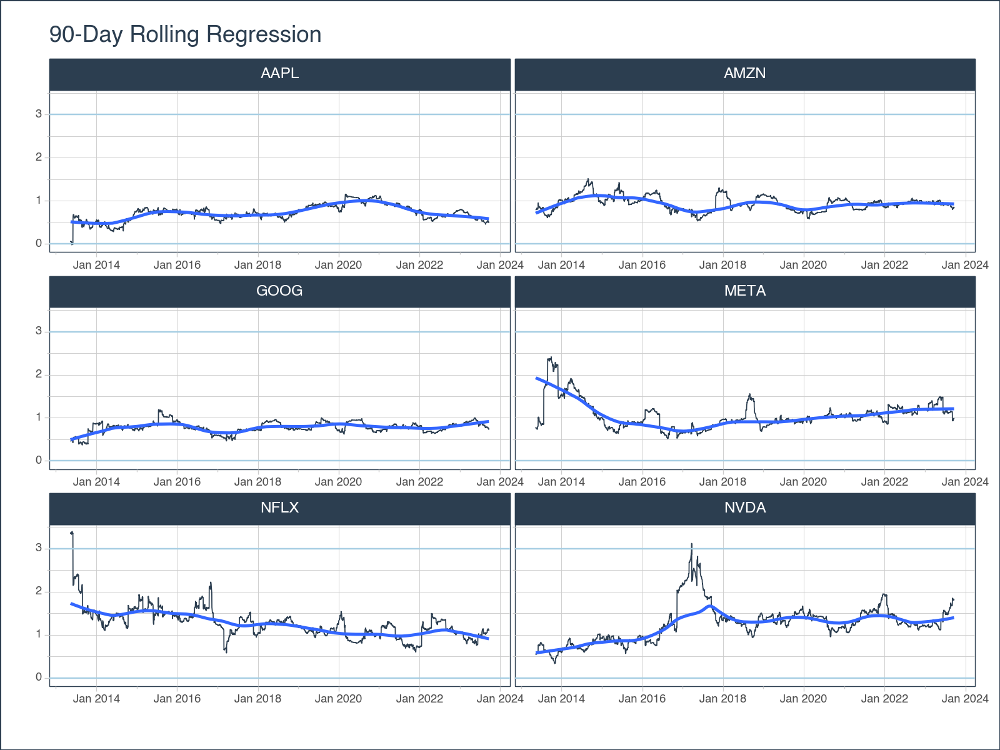

    <Figure Size: (800 x 600)>

# 6. Conclusions

The `pytimetk` package offers a wide range of versatile time series
functions, many of which can help improve Financial, Stock, Portfolio,
and Investment Analysis in Python. We examined:

-   `tk.plot_timeseries()`: Visualizing financial data
-   `tk.augment_rolling()`: Moving averages
-   `tk.augment_rolling_apply()`: Rolling correlations and rolling
    regressions